In [2]:
# Import Dependencies
from matplotlib import pyplot as plt
from scipy.stats import linregress
import numpy as np
from sklearn import datasets
import pandas as pd

In [3]:
# Import data file
divvy_df = pd.read_csv('Divvy_Trips_2019_Q3.csv')
divvy_df.head()

,trip_id,start_time,end_time,bikeid,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,usertype,gender,birthyear
0,23479388,2019-07-01 00:00:27,2019-07-01 00:20:41,3591,"1,214.0",117,Wilton Ave & Belmont Ave,497,Kimball Ave & Belmont Ave,Subscriber,Male,1992.0
1,23479389,2019-07-01 00:01:16,2019-07-01 00:18:44,5353,"1,048.0",381,Western Ave & Monroe St,203,Western Ave & 21st St,Customer,NaN,NaN
2,23479390,2019-07-01 00:01:48,2019-07-01 00:27:42,6180,"1,554.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN
3,23479391,2019-07-01 00:02:07,2019-07-01 00:27:10,5540,"1,503.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN
4,23479392,2019-07-01 00:02:13,2019-07-01 00:22:26,6014,"1,213.0",168,Michigan Ave & 14th St,62,McCormick Place,Customer,NaN,NaN


In [4]:
divvy_df.shape

(1640718, 12)

In [5]:
# Remove null rows (if needed)
divvy_df.dropna()
divvy_df.shape

(1640718, 12)

In [6]:
# Convert birthyear to age
divvy_df['age'] = (2021 - divvy_df['birthyear'])
divvy_df.head()

,trip_id,start_time,end_time,bikeid,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,usertype,gender,birthyear,age
0,23479388,2019-07-01 00:00:27,2019-07-01 00:20:41,3591,"1,214.0",117,Wilton Ave & Belmont Ave,497,Kimball Ave & Belmont Ave,Subscriber,Male,1992.0,29.0
1,23479389,2019-07-01 00:01:16,2019-07-01 00:18:44,5353,"1,048.0",381,Western Ave & Monroe St,203,Western Ave & 21st St,Customer,NaN,NaN,NaN
2,23479390,2019-07-01 00:01:48,2019-07-01 00:27:42,6180,"1,554.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN
3,23479391,2019-07-01 00:02:07,2019-07-01 00:27:10,5540,"1,503.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN
4,23479392,2019-07-01 00:02:13,2019-07-01 00:22:26,6014,"1,213.0",168,Michigan Ave & 14th St,62,McCormick Place,Customer,NaN,NaN,NaN


In [7]:
# Create bins for age
bins = [10, 20, 30, 40, 50, 60, 70, 80, 90]

# Create the names for the five bins
group_names = ["11-19", "20-29", "30-39", "40-49", "50-59", "60-69", "70-79", "80-89"]
divvy_df["Age Group"] = pd.cut(divvy_df["age"], bins, labels=group_names, include_lowest=True)
divvy_df.head()

,trip_id,start_time,end_time,bikeid,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,usertype,gender,birthyear,age,Age Group
0,23479388,2019-07-01 00:00:27,2019-07-01 00:20:41,3591,"1,214.0",117,Wilton Ave & Belmont Ave,497,Kimball Ave & Belmont Ave,Subscriber,Male,1992.0,29.0,20-29
1,23479389,2019-07-01 00:01:16,2019-07-01 00:18:44,5353,"1,048.0",381,Western Ave & Monroe St,203,Western Ave & 21st St,Customer,NaN,NaN,NaN,NaN
2,23479390,2019-07-01 00:01:48,2019-07-01 00:27:42,6180,"1,554.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN,NaN
3,23479391,2019-07-01 00:02:07,2019-07-01 00:27:10,5540,"1,503.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN,NaN
4,23479392,2019-07-01 00:02:13,2019-07-01 00:22:26,6014,"1,213.0",168,Michigan Ave & 14th St,62,McCormick Place,Customer,NaN,NaN,NaN,NaN


In [8]:
#Review bins
age_group_count = divvy_df['Age Group'].value_counts().sort_index()
age_group_count

11-19      5451
20-29    497786
30-39    516666
40-49    172065
50-59    119677
60-69     45758
70-79      4657
80-89       178
Name: Age Group, dtype: int64

In [9]:
age_group = divvy_df['Age Group']

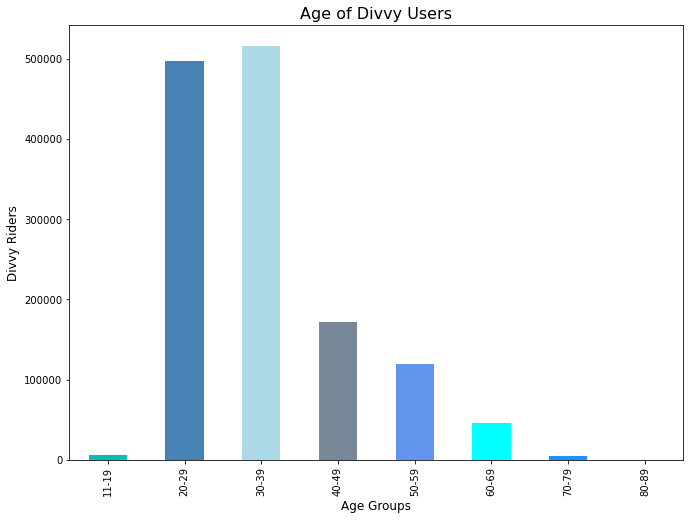

<Figure size 432x288 with 0 Axes>

In [9]:
# Plot bins as bar graph
plt.figure(figsize=(11,8))
age_group_chart = age_group_count.plot(kind='bar', color=['c', 'steelblue', 'lightblue', 'lightslategrey', 'cornflowerblue', 'aqua', 'dodgerblue', 'lightsteelblue'])
plt.xlabel("Age Groups", size=12)
plt.ylabel("Divvy Riders", size=12)
plt.title("Age of Divvy Users", size=16)
plt.show()
plt.savefig('output_data/age_group_chart.svg')

In [10]:
# Convert date columns to datetime format
divvy_df['start_time'] = pd.to_datetime(divvy_df['start_time'])
divvy_df['end_time'] = pd.to_datetime(divvy_df['end_time'])

In [11]:
# Split date from time and create columns
divvy_df['start_date'] = divvy_df['start_time'].dt.date
divvy_df['start_time'] = divvy_df['start_time'].dt.time
divvy_df['end_date'] = divvy_df['end_time'].dt.date
divvy_df['end_time'] = divvy_df['end_time'].dt.time
divvy_df.head()

,trip_id,start_time,end_time,bikeid,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,usertype,gender,birthyear,age,Age Group,start_date,end_date
0,23479388,00:00:27,00:20:41,3591,"1,214.0",117,Wilton Ave & Belmont Ave,497,Kimball Ave & Belmont Ave,Subscriber,Male,1992.0,29.0,20-29,2019-07-01,2019-07-01
1,23479389,00:01:16,00:18:44,5353,"1,048.0",381,Western Ave & Monroe St,203,Western Ave & 21st St,Customer,NaN,NaN,NaN,NaN,2019-07-01,2019-07-01
2,23479390,00:01:48,00:27:42,6180,"1,554.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN,NaN,2019-07-01,2019-07-01
3,23479391,00:02:07,00:27:10,5540,"1,503.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN,NaN,2019-07-01,2019-07-01
4,23479392,00:02:13,00:22:26,6014,"1,213.0",168,Michigan Ave & 14th St,62,McCormick Place,Customer,NaN,NaN,NaN,NaN,2019-07-01,2019-07-01


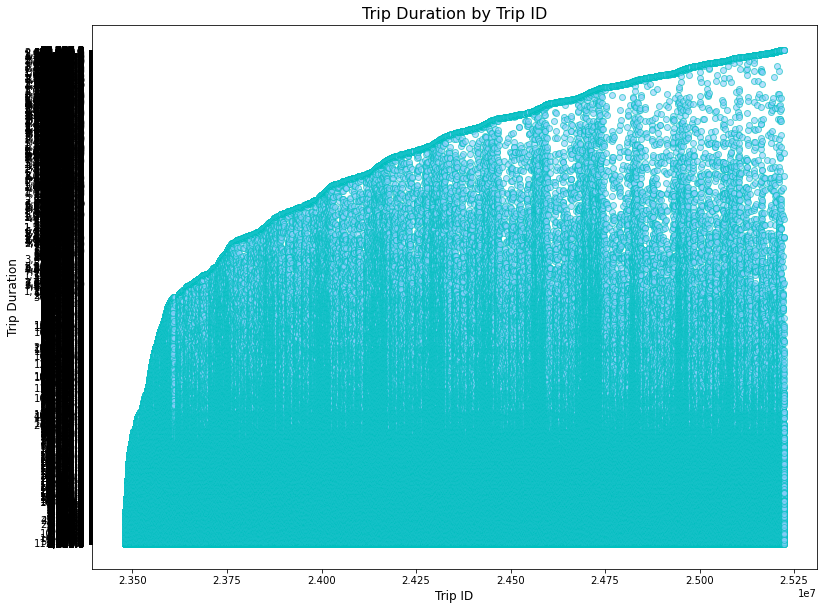

In [25]:
plt.figure(figsize=(13,10))
plt.scatter(divvy_df['trip_id'], divvy_df['tripduration'], color='lightskyblue', alpha=.6, edgecolors='c')
plt.xlabel("Trip ID", size=12)
plt.ylabel("Trip Duration", size=12)
plt.title("Trip Duration by Trip ID", size=16)
plt.show()

In [12]:
# Organize columns in dataframe
divvy_df = divvy_df[["trip_id", "bikeid", "start_date", "start_time", "end_date", "end_time", "tripduration", "from_station_id", "from_station_name", "to_station_id", "to_station_name", "usertype", "gender", "birthyear", "age", "Age Group"]]
divvy_df.head()

,trip_id,bikeid,start_date,start_time,end_date,end_time,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,usertype,gender,birthyear,age,Age Group
0,23479388,3591,2019-07-01,00:00:27,2019-07-01,00:20:41,"1,214.0",117,Wilton Ave & Belmont Ave,497,Kimball Ave & Belmont Ave,Subscriber,Male,1992.0,29.0,20-29
1,23479389,5353,2019-07-01,00:01:16,2019-07-01,00:18:44,"1,048.0",381,Western Ave & Monroe St,203,Western Ave & 21st St,Customer,NaN,NaN,NaN,NaN
2,23479390,6180,2019-07-01,00:01:48,2019-07-01,00:27:42,"1,554.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN,NaN
3,23479391,5540,2019-07-01,00:02:07,2019-07-01,00:27:10,"1,503.0",313,Lakeview Ave & Fullerton Pkwy,144,Larrabee St & Webster Ave,Customer,NaN,NaN,NaN,NaN
4,23479392,6014,2019-07-01,00:02:13,2019-07-01,00:22:26,"1,213.0",168,Michigan Ave & 14th St,62,McCormick Place,Customer,NaN,NaN,NaN,NaN


In [13]:
# Number of unique bikes in circulation
bike_id_total = divvy_df['bikeid'].nunique()

In [14]:
# Bike IDs with most activity
bike_id_count = divvy_df['bikeid'].value_counts()
bike_id_count

5724    535
3115    532
5344    531
3088    528
717     521
       ... 
1827      1
1806      1
3089      1
2705      1
3299      1
Name: bikeid, Length: 5787, dtype: int64

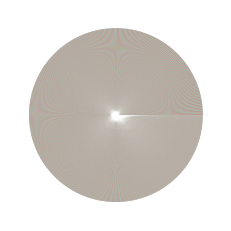

In [23]:
plt.pie(bike_id_count)
plt.show()
#Need to extract the top 10 or 20 bikes

In [15]:
# Most popular starting stations
divvy_df['from_station_name'].value_counts()


Streeter Dr & Grand Ave        39726
Lake Shore Dr & Monroe St      26309
Lake Shore Dr & North Blvd     21845
Michigan Ave & Oak St          20300
Canal St & Adams St            20176
                               ...  
Michigan Ave & 71st St             6
DIVVY Map Frame B/C Station        6
Damen Ave & 59th St                5
Rhodes Ave & 71st St               5
Racine Ave & 61st St               3
Name: from_station_name, Length: 612, dtype: int64

In [16]:
# Most popular ending stations

divvy_df['to_station_name'].value_counts()

Streeter Dr & Grand Ave       45391
Lake Shore Dr & North Blvd    27491
Lake Shore Dr & Monroe St     21642
Michigan Ave & Oak St         21319
Theater on the Lake           20525
                              ...  
Michigan Ave & 71st St            5
May St & 69th St                  4
Rhodes Ave & 71st St              3
Elizabeth St & 59th St            2
Racine Ave & 61st St              2
Name: to_station_name, Length: 613, dtype: int64

In [17]:
# Most popular trips *still in-progress*
popular_stations = divvy_df.groupby(['from_station_name','to_station_name'])
popular_stations

In [18]:
# Groupby usertype for ridership breakdown

usertype_df = divvy_df.groupby('usertype')
usertype_count = usertype_df.count()
usertype_count

,trip_id,bikeid,start_date,start_time,end_date,end_time,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,gender,birthyear,age,Age Group
usertype,,,,,,,,,,,,,,,
Customer,491694,491694,491694,491694,491694,491694,491694,491694,491694,491694,491694,214116,216619,216619,216591
Subscriber,1149024,1149024,1149024,1149024,1149024,1149024,1149024,1149024,1149024,1149024,1149024,1139252,1146005,1146005,1145647


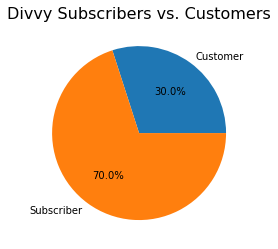

In [33]:
color_range = ['lightblue', 'deepskyblue']
plt.pie(usertype_count['trip_id'], labels=usertype_count.index.values, autopct='%1.1f%%')
plt.title("Divvy Subscribers vs. Customers", size=16)
plt.show()

In [21]:
# Create calculation for average trip duration
average_trip = divvy_df['tripduration'].mean()
average_trip

TypeError: Could not convert 1,214.01,048.01,554.01,503.01,213.0310.01,248.01,550.01,583.01,589.01,568.01,543.01,967.01,951.01,961.01,910.01,647.01,618.01,171.01,593.0703.01,150.0639.0556.05,757.0859.05,722.0113,948.03,660.01,294.01,624.01,621.01,573.01,548.01,003.0197.05,480.0298.0605.05,483.05,476.05,481.0689.03,203.0806.01,038.0489.02,590.0211.02,579.0457.0363.0209.0602.0681.0638.01,293.0395.01,006.0405.0974.01,075.01,069.05,942.0781.03,519.03,551.0463.03,489.0588.0519.02,171.02,215.02,051.02,150.02,126.01,182.01,040.0601.0585.01,225.0962.02,004.0935.02,008.01,965.0317.0627.05,150.053,088.02,775.04,954.0380.06,042.0398.0596.0827.0825.04,708.0793.0768.01,058.04,615.05,726.01,028.0248.0983.0661.01,166.02,925.02,919.02,899.01,298.02,877.01,291.02,765.0293.02,739.02,729.02,201.01,454.01,419.02,406.01,388.01,371.0917.01,381.0425.01,508.01,504.01,108.01,075.0715.0610.0539.0554.08,132.08,451.0658.0294.0676.0646.0599.0616.0616.0194.03,639.0182.03,391.02,920.03,207.03,210.0339.0193.0362.0229.0923.0107.02,560.02,224.01,134.01,115.01,252.01,232.0563.01,114.0219.0986.0964.0420.01,035.0435.0422.01,697.02,406.0481.01,449.0467.0174.01,313.01,528.01,458.0680.0648.01,000.01,454.01,438.01,422.02,505.0651.0756.0214.0866.0824.0643.01,054.01,213.0519.0156.0937.0166.0190.01,151.04,689.016,466.0490.0933.0440.0733.0568.0562.0336.0697.0381.0654.0913.01,439.0253.0279.0475.0710.0332.0652.0652.0571.01,441.01,241.0252.0167.06,581.06,576.0335.0327.0396.0497.0820.0611.0174.0197.0113.0692.01,494.01,488.0606.0307.0395.0321.0712.0413.0402.01,444.0732.0293.0479.0422.0646.0337.01,194.0441.0395.0390.0738.0394.01,532.0776.02,144.0449.01,124.0481.01,462.0808.0625.0351.0217.01,802.0320.0426.0486.0874.01,165.01,049.0840.0502.0898.01,457.0858.0594.0493.0491.0357.0568.0480.0880.0383.0408.0480.0488.01,407.0774.01,097.0737.0226.0276.0568.01,121.0637.0115.0594.01,314.0469.0443.0406.0723.0688.0453.0633.01,176.0436.0723.0260.0324.0445.0488.01,695.0187.0493.02,306.0655.0602.01,395.0287.0924.0269.0299.0637.0230.0570.0315.0632.0489.0820.0427.0421.0230.0272.0890.0547.0361.01,031.0248.0371.0285.0814.02,233.01,086.0771.0116.0374.0142.0313.0394.0280.0335.0234.0326.0268.0392.0334.0146.0226.0261.0326.0694.01,210.0206.0235.0331.0327.0729.0143.02,682.01,948.0377.0760.02,095.0547.0191.01,225.01,336.01,334.0244.0364.0137.0614.0623.0182.0404.0461.01,257.0445.0152.01,668.0997.01,304.03,103.0388.0178.0490.0569.01,081.010,920.0433.02,055.0107.0352.0259.01,062.0276.0522.01,995.0465.0375.0736.01,015.01,984.01,239.0851.01,630.0346.01,469.0253.0397.0346.0165.01,995.0126.0158.0153.01,402.0601.0612.0459.01,805.0733.02,168.0265.0487.0367.03,000.0783.0926.0580.0963.0235.0439.0399.0475.0521.01,134.0738.0476.0796.0390.0500.01,304.0699.0501.02,544.0224.0795.01,943.0829.0314.0161.01,848.0483.0698.01,875.0792.01,852.0611.0741.0562.0592.0899.0408.0451.0751.01,342.0163.0576.0434.0982.0743.01,119.01,275.0448.0282.0273.0834.0741.0525.0663.0386.0729.0514.0641.0286.0435.0912.01,011.0395.0183.0474.0636.0966.0676.0239.0534.0816.01,093.02,022.01,463.01,033.0604.01,017.0797.0558.0329.01,147.0327.0988.0338.0594.0469.01,733.0571.0492.0305.0194.0360.0617.0440.0411.0717.0513.0479.0791.0572.0255.0139.0757.0422.0645.0819.01,055.0737.0399.0393.0345.0242.0637.0445.0815.0316.0312.0365.0179.0207.0311.01,881.0570.0746.0205.0143.0291.0163.01,643.0820.0741.0640.0445.01,052.0215.01,686.0478.0561.0408.0306.0845.0402.0761.01,365.0935.0248.05,671.01,635.0208.0382.0390.0686.0960.0336.0315.0579.0417.0168.0889.0177.01,470.0615.01,538.01,117.0477.01,646.01,492.01,024.01,766.01,139.0167.0481.01,096.0474.0738.0624.0985.0967.0402.0826.0209.0691.0165.0842.0144.0309.0467.0312.01,346.02,481.01,094.01,238.0480.01,594.0472.0198.0446.0997.0929.01,955.0366.0782.02,025.0416.01,131.0240.01,955.0621.0222.0850.01,169.0841.0862.02,183.0329.0364.01,186.0812.01,126.0648.02,005.0841.0279.0481.01,137.01,045.01,250.0628.0337.0438.0307.0433.0955.0198.0327.0546.0992.0667.0654.0356.01,342.0242.01,061.0848.0892.0825.01,062.0629.0638.01,283.0935.0774.01,336.0214.0772.0836.0531.0576.0237.0754.0853.0655.0202.02,783.0354.0282.0790.01,208.0457.0862.0696.0863.0861.0180.01,889.0318.0379.0800.0771.0382.0836.0986.0367.0404.0872.0132.0401.0361.01,037.0543.0502.0419.0532.0300.04,003.0348.0424.01,906.0253.0987.01,799.0633.0521.0424.0576.0592.0998.0912.0770.0649.0714.01,348.0242.03,175.0334.01,154.01,011.0634.0387.01,147.01,948.0787.0766.0304.0526.0441.0284.0692.0346.0368.0372.01,712.0225.0365.0238.02,200.0480.0305.0967.01,858.0261.01,240.0222.01,839.01,098.01,263.0231.0611.0291.0246.01,806.01,810.0481.0154.0793.0431.01,160.02,502.0758.01,365.0339.0596.0563.0624.0943.0493.0757.0213.0409.0684.0812.0902.0293.01,119.0643.0281.01,215.0239.0723.01,349.01,484.01,452.01,317.0862.01,566.01,225.01,027.01,135.01,332.01,663.0657.0536.0707.0706.0214.01,627.0423.0592.01,111.01,774.01,490.0254.0972.0894.0338.01,891.0677.01,350.0450.0395.0601.0574.0539.0708.0492.021,461.0573.01,311.0379.01,425.0704.0748.0612.0536.01,910.0866.0804.01,959.01,079.0375.01,104.0358.0351.01,321.0627.0391.0724.0610.0367.0781.0713.0287.0739.0455.01,311.0881.0516.0737.0362.0492.0617.092.01,819.0347.01,725.0267.0783.0337.086.0214.0332.0958.0643.0397.0304.0348.0490.01,592.0315.0351.0433.0649.01,948.0331.0530.0179.0286.0433.0509.01,423.01,481.0181.0166.01,208.0550.0654.01,147.0487.0622.0562.01,028.0475.0586.01,276.0219.097.0739.0129.0196.0682.0478.0817.0469.01,919.0350.0811.0887.0747.0364.0233.0502.0266.0351.0255.01,037.0581.0681.0550.0658.0754.0653.01,242.0956.0453.0371.0477.0570.0570.0443.0422.01,679.0832.0376.0548.01,891.0390.0255.01,435.01,478.0702.01,205.0296.0710.0399.02,640.0571.0484.0428.01,065.0294.0703.0367.01,425.0609.01,384.0290.0682.0748.0372.0421.0981.0462.0768.0740.0256.0589.01,346.0285.0395.0468.0774.01,180.0942.0717.01,607.0294.02,384.01,229.0949.0424.0360.0333.0313.0287.0978.0972.0395.0337.0795.01,135.01,145.0213.0861.0794.0229.01,053.0846.0338.0833.02,188.0404.0329.01,521.01,201.02,139.0428.01,119.01,530.0863.0309.0406.0930.0223.0524.01,352.0368.0420.0271.0246.01,216.0470.0644.0802.0463.01,813.0511.0450.0321.0434.0293.0559.0641.0352.0277.01,068.04,043.0205.02,101.01,300.0267.0983.0509.0381.01,855.0568.0387.0335.0231.01,002.02,050.0399.0268.0581.0393.0321.0877.0262.0819.01,673.0532.0465.0816.0891.0515.022,726.0509.0894.0681.0138.0855.01,353.02,895.0543.0612.0418.0599.01,322.01,453.0516.0313.01,926.01,707.01,412.01,613.0670.0538.043,195.0961.0901.0295.01,504.0799.01,285.01,056.01,000.0409.0199.0900.0789.0538.0787.0405.01,052.0381.02,365.0598.0556.0463.0980.0728.0389.0839.01,579.0594.0680.0372.0191.01,201.01,336.0594.0810.0575.0409.02,134.0972.0864.0745.0214.01,609.0753.0257.0663.01,077.0929.0515.0673.0168.0757.0444.01,129.01,654.0344.0483.01,320.0875.0820.02,335.01,129.0885.0616.0615.0210.0965.0487.0537.01,761.01,473.0731.0137.0888.0227.0237.0513.0411.0529.01,139.0240.0386.01,347.0804.0508.0519.0405.0487.0712.0427.0287.0907.0523.0579.0657.0219.0662.0607.0309.0522.0206.0333.0426.01,938.0678.0476.0908.01,139.0627.0489.0666.0641.0821.0297.0582.0716.0707.0607.0643.01,875.0193.0454.01,629.078.0444.01,272.01,225.0710.0442.0751.0229.0408.01,508.0497.0776.0397.02,553.0834.0606.0525.01,323.0650.0277.0800.0314.0645.01,555.0397.0735.0600.0387.0773.0315.0750.01,631.01,123.0169.01,196.0983.0415.0200.0277.01,805.0878.01,350.0303.0430.0873.0955.0351.0655.0653.0811.0413.0648.0355.0713.0256.0479.0287.0191.0268.0512.0420.0727.01,062.0575.0734.0386.0382.0902.0789.0394.0482.0532.0899.0342.0613.0383.0449.0554.0421.01,223.01,465.0906.0645.0371.02,038.0386.0590.0200.01,702.0344.0203.0616.0633.0120.0362.0131.0453.0719.0442.0310.0342.0139.0949.01,884.0203.0804.0424.0488.0474.01,267.01,057.0540.0738.0535.0457.0298.0384.0913.0905.0193.0863.0227.0171.0926.0283.0622.0784.0451.02,025.0934.0362.01,533.0721.0934.0456.01,732.0439.0284.0258.0561.0678.01,477.0711.01,211.0384.0821.02,180.0343.01,603.03,063.01,142.01,011.0848.0426.01,302.0359.0532.0455.0345.0403.0300.0780.0493.01,863.0990.0373.0210.01,039.0417.0761.0610.0706.0643.0988.02,013.0521.0557.01,375.01,495.0241.0662.0255.02,054.0186.01,399.0203.0237.02,264.0248.0913.0570.0636.0498.0699.01,254.0953.01,289.0552.01,033.01,126.0649.0592.0770.0693.0378.02,342.01,583.0623.0178.0398.0561.01,080.01,882.0305.0317.0266.0595.0770.0603.0517.0326.0515.0346.0219.0120.01,043.01,220.0415.0328.02,196.02,088.01,029.0412.02,253.0889.0138.0673.01,143.01,068.0346.0657.0286.0352.0271.0324.0992.01,592.0876.01,028.0245.0361.0364.0452.0587.0345.0858.0537.0579.01,847.0520.0285.01,809.0388.01,798.0298.0766.0591.0179.0798.0589.01,338.01,207.0497.0317.0282.0330.0216.0331.0653.0339.0330.0161.0737.0514.01,112.0534.02,275.02,536.0465.0474.0512.0528.0383.0625.01,392.01,138.0919.0404.01,657.0413.01,635.0827.0762.0411.0364.01,037.01,023.01,054.0635.01,024.0431.0471.0737.0286.01,335.01,503.01,171.0856.01,110.0970.0389.0414.0615.0286.0453.01,321.0198.0188.01,618.01,307.0445.0294.0842.01,868.0618.0580.0243.0444.0725.0538.0597.02,242.0849.0466.0841.0466.0185.0437.01,712.0268.01,134.01,765.0567.0865.0503.0817.01,179.02,100.0291.01,612.0633.0248.01,009.01,035.0463.0781.0212.0631.0896.01,068.01,135.0996.0601.0287.0446.0734.0949.01,125.01,174.01,239.0876.01,220.0958.01,595.0205.01,575.0397.0814.01,019.01,489.01,131.0715.0472.0564.0508.0625.0489.02,606.0983.01,160.0302.0901.0542.0809.0960.01,607.0527.0681.0945.01,739.0212.01,103.0685.01,161.0897.0921.0380.0442.0815.0186.0191.02,024.0453.0675.0557.01,709.0509.0667.0236.0379.0133.0712.0276.0898.0245.097.0215.0180.0971.0257.0643.01,483.0488.01,157.0623.0693.0360.0451.0478.0330.01,738.0611.0453.0529.0603.0540.0469.0832.0305.0760.0401.01,098.02,097.0779.0673.01,237.0333.0892.01,829.0284.0173.0387.0365.0977.0309.0457.0456.0327.0472.0568.0564.0615.0978.0541.0310.0790.0444.0482.0278.01,053.0961.0562.0251.0979.0792.0706.0786.0790.0384.0707.0253.0520.0561.0296.0887.0571.0399.0703.0573.0411.0367.01,149.02,014.0215.01,263.0561.01,548.02,169.0127.0706.0816.0567.01,049.0427.0462.0838.0189.0995.01,222.01,785.0524.0618.0620.02,088.01,044.0819.0744.0717.0535.0614.0513.0957.0290.0836.0233.0422.0620.0497.0515.01,242.01,212.0737.01,848.0181.0990.0762.0693.01,695.0161.01,301.0279.0978.01,082.0620.0407.02,609.0525.01,319.0488.02,157.0727.0293.01,607.0541.01,472.02,396.01,386.0478.01,208.0600.01,593.0318.0384.0310.0977.0356.0552.0426.0701.02,142.01,263.01,592.0281.0478.0524.0276.0292.0572.01,096.02,259.0432.0913.0258.01,265.0646.01,815.0795.0710.01,135.0695.0495.0864.0742.01,793.01,307.01,735.01,528.0300.01,017.0266.0782.0177.0465.0390.02,172.0433.0187.0512.0645.0661.0800.0722.0528.0505.0385.0628.0813.0495.0655.0976.0678.0611.01,420.0396.0210.0720.0421.0794.0102.0151.01,865.01,092.0222.0921.01,520.0267.01,134.0779.0705.01,423.0704.0569.0404.0351.0475.0599.0628.0529.0492.01,893.0503.0294.01,087.0727.01,035.01,392.0388.0640.01,932.0280.0794.01,949.01,260.0700.0332.01,256.0545.01,960.0645.0706.0347.0375.01,587.0266.0501.0903.0338.0477.0966.0714.01,227.0626.0220.0620.0181.01,371.0409.0764.0668.0578.01,594.0605.01,281.0410.0536.01,183.0571.0921.0591.0505.0279.0500.0462.0373.01,235.0344.0595.0340.0495.01,101.01,030.0341.01,880.01,593.0645.0324.01,034.0172.0885.0496.0719.0531.03,870.0966.0336.0223.01,494.0240.0436.0329.0645.0726.0358.01,635.0260.01,352.0388.0852.01,540.0590.0753.0975.0962.0555.0556.0269.0522.0438.0254.0828.0245.0547.0945.0909.0261.0978.01,520.0903.0401.0262.0779.0296.02,248.0577.0381.02,111.0573.02,245.0571.0280.0423.0665.0640.01,528.0558.0962.02,204.0316.0276.01,176.0260.0588.0957.01,203.01,124.0604.0426.0793.0661.0523.0371.0635.0820.0994.01,162.01,901.0295.01,717.0300.0895.0261.0585.0334.01,164.0627.0437.01,507.0491.0146.01,314.0480.0468.01,056.0310.01,757.0603.01,218.0499.0923.0164.0297.01,021.0331.02,140.0486.0826.0317.0157.01,389.01,199.0545.0604.01,117.0306.0850.0667.02,390.01,199.01,341.0158.0719.0880.0710.02,360.0758.01,704.01,144.0269.01,484.0626.0779.0708.02,037.0440.0251.0483.0513.01,356.0788.0413.01,125.0886.01,113.0262.01,402.0653.0515.0399.0195.0443.0675.0333.0229.0379.0355.0336.0126.0422.03,231.0805.0760.0378.0372.0862.01,248.0585.01,917.01,323.0918.0724.0261.0733.0630.0677.01,379.01,068.0674.01,162.0334.0786.0522.0556.0779.0475.0938.0159.01,181.0446.0368.0272.0339.0209.0401.01,649.0862.0778.0392.0218.0363.0399.0655.0758.0822.0308.0554.0353.02,244.0713.0174.01,256.01,452.01,017.0486.01,759.02,581.0377.0513.0561.01,019.0555.0986.0592.01,091.01,272.01,182.01,018.01,258.0194.01,605.01,212.0298.0652.01,441.0688.0377.0358.01,215.0398.0622.0560.01,173.0874.0603.0216.0964.0375.0492.01,328.01,814.0276.0450.0229.01,150.0565.0944.01,103.0839.0344.0470.0476.01,100.0253.0615.01,046.0367.0928.0530.0211.0499.01,105.0386.0641.0938.01,505.0264.0773.0260.01,215.01,311.0627.01,329.0551.0245.0377.0931.0635.0453.0785.01,053.0767.01,603.01,009.0269.0620.0363.0553.01,096.01,007.01,430.0561.0557.0490.0576.0700.0842.0357.0614.0300.0863.02,031.01,061.0368.01,898.0900.0188.0960.0616.0959.0137.0778.0374.0247.0273.0180.0995.02,137.01,710.0648.0258.01,589.02,160.01,200.01,861.0264.0538.0372.0584.0802.02,143.0787.0651.01,362.0346.0234.0615.0490.0331.0487.01,209.01,338.0590.0478.0715.01,538.0573.0561.01,273.02,372.0655.0739.0396.0439.0431.0411.0352.01,396.0647.0199.0834.0177.0609.01,809.01,582.01,962.0811.02,128.01,281.0623.0513.0488.0600.01,979.0518.0665.0316.0443.01,131.0968.01,917.0377.0772.0771.0525.0709.0689.0350.01,537.0779.0300.01,718.01,024.01,594.01,033.0753.01,801.02,251.0560.02,075.0582.01,128.0905.0635.0209.0916.0729.0363.0536.0373.0675.0608.0910.0516.02,121.0534.0131.0624.02,005.01,444.0890.01,355.0441.0665.0451.01,103.0615.0170.0511.0351.0479.0957.0625.0118.01,102.01,372.0972.01,094.0406.0830.01,536.0785.0913.0883.0612.0339.01,806.0977.0754.0567.01,801.0192.0115.0997.0462.0984.0791.01,630.0922.0730.02,303.0520.0539.01,183.0639.0242.01,114.0455.01,309.0752.0903.0391.0157.0490.0812.0907.01,886.01,318.01,017.0540.0699.0310.01,190.0467.0653.0349.0429.0919.0582.0425.0732.0815.0932.0427.0541.0908.0972.0325.0735.0917.01,149.0294.0698.0351.0577.01,120.0231.0218.0572.0905.01,286.0556.0675.01,803.0768.01,601.01,476.01,266.01,139.0849.0304.0240.0713.01,053.0553.0743.0704.0234.0406.01,307.0657.0716.0271.0423.02,025.01,805.01,770.0636.0452.01,045.0541.0514.0609.0617.01,806.01,887.0314.01,877.01,357.0534.01,065.0156.0637.0443.0319.01,241.0424.0337.0512.0914.0449.01,559.01,212.0369.0873.0536.01,326.0179.0817.0275.01,111.01,181.0443.01,325.01,349.01,010.0611.0141.01,304.0853.0855.01,166.01,383.0436.0618.0499.0640.01,046.01,084.0605.0909.01,700.0620.01,268.0371.0173.0635.01,055.0207.0706.0980.01,232.01,017.01,589.01,276.0630.01,450.0557.0379.0470.0553.01,769.01,111.0297.0210.03,930.0302.0439.0721.01,066.01,054.0696.06,258.01,140.0783.0530.01,072.0266.0472.01,228.0362.0244.0144.0284.0535.0794.0967.0423.0500.0513.0995.0487.0227.01,374.03,632.0466.0418.0825.01,937.01,690.0631.0185.01,950.0202.01,026.0259.0171.0995.0474.0278.0705.0643.01,171.090.01,001.01,420.0617.0757.01,183.0300.0280.0326.0873.01,090.0804.02,293.0839.0836.0223.0496.0662.01,924.01,168.0665.0328.0429.0804.0191.0846.0525.0795.0535.01,188.0528.0542.02,145.0944.0559.0600.0446.01,102.0796.0801.01,843.0337.0264.0191.0470.01,145.0330.0418.01,519.0629.0450.0853.0557.0686.0765.0889.0458.0435.0914.0377.0349.0417.01,170.0958.0207.0940.0547.01,272.0249.01,004.0996.0834.01,878.0405.0681.0227.01,180.0497.0682.01,142.0271.0433.0134.01,972.01,290.0342.0862.0792.0290.0230.0686.0470.01,984.0533.0282.01,156.0422.0425.0498.02,191.0745.02,029.0905.01,071.0347.0141.0248.01,022.02,410.0720.01,756.0340.01,407.01,191.0390.01,127.0658.0221.01,000.0413.0682.02,205.01,512.01,575.02,025.0851.0998.0498.0482.0510.01,483.01,407.02,229.01,643.0858.0877.01,753.0149.0611.01,281.0315.0874.01,746.01,098.0855.0357.0587.0860.0276.0609.0738.01,100.0171.0912.0389.01,133.0919.0397.0937.0519.0430.0312.0432.0468.0824.0491.01,379.0239.0976.0226.0188.01,046.01,392.0585.0301.0875.02,652.01,035.0903.0347.0405.0917.01,263.0183.0358.0488.0578.01,347.0774.01,589.0191.0325.0567.0863.0603.0306.0441.0129.0376.0390.0400.0362.0953.0518.0155.0610.0637.0521.0609.0487.0436.03,799.02,607.0444.0296.0810.0590.02,023.01,237.0259.0362.01,235.0472.0886.01,001.05,663.0220.0891.0234.01,085.01,613.0228.0927.0454.0594.0397.0623.0578.01,258.0482.01,941.01,374.0672.0228.0412.0746.0883.0598.01,031.0166.01,077.0939.0539.0876.01,844.01,395.0256.01,741.01,005.01,202.0274.0451.0126.0148.0423.0376.01,545.0781.0872.01,158.0354.0884.01,057.0702.01,501.0943.01,858.0226.0670.0342.0792.0868.0994.0981.0336.01,766.0137.01,545.0637.0216.0756.0154.0866.0576.0286.0903.0489.0633.01,633.0395.0853.0331.0347.0554.0262.0823.0584.01,664.0922.01,392.0775.01,499.0478.0487.0460.0254.01,131.0251.01,412.0339.0264.0741.0848.0468.0633.01,272.0347.03,275.0310.01,116.0585.0522.0483.0277.0429.01,362.0547.0709.0492.0392.01,014.0443.0708.0688.0487.01,065.0272.0459.01,082.0361.0314.0461.010,822.01,556.0724.0433.0923.0383.0662.0932.01,410.0911.0318.0386.0295.0444.0206.02,154.0624.0538.0644.0568.0287.01,011.0628.0443.0212.02,180.0819.0668.01,303.0827.0647.0459.0851.01,556.01,050.01,760.0570.01,098.01,572.0468.01,609.01,110.01,203.0872.02,734.0198.01,403.01,050.01,566.01,166.0435.0616.01,304.01,086.0872.0697.0323.0183.0728.0206.01,007.01,110.0300.0789.01,345.0629.01,202.0407.01,153.0314.0467.0968.01,137.0302.0845.0904.01,309.0326.0407.0546.0798.01,042.0876.0350.0505.02,004.01,616.0490.0930.0851.0343.0885.0184.0484.0270.01,495.0575.01,257.0512.0434.01,241.01,242.0591.0901.0405.0642.0981.0975.0845.0663.01,563.01,624.0690.01,542.0703.0592.0552.0502.0265.0254.02,968.01,186.0530.0619.0493.02,088.01,700.0118.01,227.0520.0404.0348.02,928.01,467.0690.0311.0808.0440.01,473.0782.0327.0195.01,157.01,060.0367.01,550.0624.0793.0672.0224.0801.0297.0647.0979.01,009.0299.0924.0293.01,088.01,594.02,325.0922.0614.0574.0771.01,263.0279.01,132.0396.0849.0577.0156.0804.010,081.0412.0473.0232.01,070.0301.04,581.0341.0709.0709.0574.0550.01,226.0978.0599.04,529.0272.0699.0555.0510.0918.0925.01,524.0283.0480.0421.0838.0602.0651.01,406.0700.02,292.0430.0589.0791.01,604.01,212.0493.0767.0681.01,009.0751.0748.0499.0540.0928.0814.0266.01,186.01,279.0939.0476.0654.01,278.01,343.0314.0712.01,857.0293.0941.0764.01,365.0761.0791.0688.0602.0782.0969.01,080.0632.01,099.0267.0388.0478.0583.0422.0489.0420.01,161.0452.0599.0182.01,322.01,530.0287.0435.0162.0678.01,880.0747.0705.0906.0543.0753.0731.0794.0806.01,711.031,154.01,204.0289.0440.0515.0708.0544.0675.0376.0614.0271.0943.0717.0798.0153.0472.0150.0593.0582.01,594.0522.01,206.0738.0739.02,485.0385.01,089.0469.0575.0532.0414.0756.0336.01,303.0642.0621.01,166.0537.0361.04,480.01,212.0812.01,157.0260.0776.0380.0983.0173.01,462.0388.0707.0482.0702.01,168.0335.01,018.0475.0650.0819.0964.01,037.0435.0399.0419.0407.0566.0349.0739.01,999.0369.0198.01,011.0659.01,387.0104.0692.0551.0355.0896.0297.0945.0991.0502.02,282.0450.0710.0819.0306.0378.0667.0667.0589.01,266.01,521.0844.0565.0810.0829.0308.0800.0656.0530.0204.01,800.0234.0671.03,531.0366.01,182.01,066.0773.0660.0335.0384.01,052.0218.0406.0527.0333.0946.0124.03,417.0640.0440.01,594.0297.0937.0139.01,213.0555.01,374.0532.0291.0653.0756.0566.0556.03,388.0557.01,566.0672.0596.0602.0318.01,857.0789.0288.0742.01,142.0607.01,103.0493.0575.0168.0766.0374.01,309.0703.0788.0931.0623.0160.0743.0517.0656.0504.0632.01,945.0194.0841.0770.0344.01,398.01,324.0468.01,819.0528.0161.0224.0669.01,537.0402.0221.05,460.0776.0288.0478.0704.0866.0705.01,059.01,073.06,361.0388.0198.0284.01,037.03,399.0259.0800.01,106.0837.0604.01,198.0557.01,358.01,129.0471.0779.0856.0279.01,819.0674.0743.0714.0651.0216.0153.0375.0271.01,047.0836.0348.0495.04,118.01,010.0183.0636.0404.01,180.0211.0558.0666.0267.01,147.0680.0485.0422.0879.0411.0347.03,335.0935.0504.0399.0346.0743.0625.0665.0469.0543.01,427.0509.0807.0761.0744.0307.0646.01,102.03,543.0409.01,715.01,910.0906.0287.0754.0203.0775.0375.01,079.0775.0774.01,031.0280.0641.01,677.0523.031,772.0930.0308.0440.0622.0663.01,245.0315.0776.0830.01,004.01,020.0428.0519.01,348.0192.01,302.0652.0491.0471.0434.01,349.0743.01,154.0935.0899.0391.0848.0310.0438.0797.0687.0361.0428.02,868.0775.0922.0463.0676.02,864.01,139.0442.0478.01,552.0331.0837.0361.0875.0819.0282.0781.0716.0575.01,564.0731.02,835.0762.0245.0947.0473.02,825.0490.0640.0526.0595.0849.03,789.0670.0712.0898.0488.0166.0538.0534.01,233.01,115.0318.0438.03,759.01,483.0738.0443.0887.0607.0640.0739.0317.0711.0454.0984.0721.0224.0141.0546.0527.0434.0566.0448.0195.0609.0486.0622.03,726.0685.0724.0769.01,739.0538.02,022.0645.0553.01,558.0369.0361.0590.01,034.0904.0288.0571.0685.0944.0693.0390.0704.0526.0272.01,126.0639.0162.0370.0195.0662.0490.0213.0578.01,167.0286.0784.0508.0584.0387.0515.0879.0364.0511.0320.02,090.0525.01,590.01,012.0287.01,327.0764.0465.0255.01,257.0483.0451.0520.0166.0331.0486.0542.01,385.0559.0271.01,806.0887.0263.0239.0752.0492.0482.0726.0795.01,285.0632.02,396.0413.0504.01,424.01,177.01,105.0236.0472.0502.0266.0935.0780.0291.0149.012,710.0226.01,023.0210.0157.0753.01,029.02,332.0401.0696.0893.0307.01,265.0728.02,250.0425.0227.01,725.0742.0534.02,121.0789.01,198.01,519.0573.0793.01,310.01,036.0465.0237.0327.0514.0645.0532.0715.0293.0726.0323.0635.0425.0535.01,227.0492.0685.0241.0310.01,068.0459.02,032.0357.0232.0535.0975.0550.0807.01,217.0526.0620.01,003.0544.0345.0333.0754.0991.01,143.0902.0368.01,042.0738.0596.0813.0284.0441.01,972.0195.0423.0813.0817.0370.0724.0415.02,187.0526.0640.0728.03,303.02,032.0683.0874.01,072.01,904.0273.0700.0165.0633.0624.0202.0666.0413.01,124.0556.0620.01,659.0915.02,350.0305.0242.0267.0316.0549.0415.0550.0416.02,421.0708.0475.0455.01,317.01,940.0826.0927.0220.0477.01,635.0661.0762.0546.01,243.0262.0422.0546.0565.0299.0746.0752.0498.0653.0910.0818.01,440.0807.01,155.0815.01,270.0920.0742.0173.0444.0751.0369.0222.0844.01,329.0417.01,555.0208.01,728.0812.0231.0523.01,630.0943.0351.01,847.01,780.0564.0822.0562.0995.0428.01,150.0637.0757.0426.01,743.0626.01,238.0371.0970.0378.0780.0495.02,347.0570.0511.0798.0298.0233.01,150.0693.0611.0979.0352.0867.0930.0959.0363.0674.0395.0745.0698.0454.01,350.0396.01,758.0922.0670.01,371.0259.01,275.0865.0213.01,171.0852.0512.01,029.0642.01,021.0348.0311.0649.0824.01,008.0634.0617.0348.0954.0712.0982.06,486.0286.0765.0302.0776.04,977.02,889.0610.0814.0491.06,552.0134.0529.04,172.01,051.06,521.0493.01,404.0421.0375.0592.01,328.0311.0399.0684.0495.01,134.0783.0305.0376.01,201.0169.01,369.0211.01,505.01,450.01,929.0260.0788.01,856.0309.0360.01,699.01,379.01,206.0573.0324.01,186.0244.01,032.01,005.01,742.01,410.0649.0721.0231.0762.01,259.0815.01,487.0839.0491.0636.01,045.0699.0299.0977.01,494.0357.0792.02,040.0392.01,669.0258.0378.0644.0320.01,866.0681.01,665.01,575.0817.01,157.0325.0827.0330.0433.01,117.01,329.01,220.01,105.0386.0587.0362.0242.0864.0167.0666.0336.0482.0410.0298.0966.01,585.0257.0463.01,146.0557.06,626.0519.0883.0283.0725.0663.0170.0880.0810.01,283.06,122.0849.0280.0681.01,186.01,190.0431.0167.0861.0465.0937.0559.0426.02,190.0277.02,827.0194.0565.0381.0542.0310.0366.0347.01,364.0849.01,261.01,288.012,985.0299.0757.0804.0247.0520.012,958.01,526.0275.03,248.0723.0158.0490.0567.01,085.01,077.0178.0456.0573.01,935.04,230.0396.0593.06,623.0284.0477.0557.0983.0747.04,208.0422.01,340.0583.0500.0170.01,343.0783.01,178.0238.03,435.0436.0443.0293.0772.0280.0827.0571.0886.0885.0485.01,039.0672.0567.0997.0261.0653.0358.0255.0595.0965.0473.0446.0376.0903.0799.0493.0833.0590.0833.01,293.01,118.0372.0430.0556.0988.0290.01,698.03,289.02,152.01,197.0962.01,129.0250.03,260.0182.0256.0850.0817.03,204.01,218.0652.01,762.0472.02,896.01,639.01,708.01,351.03,158.01,100.01,180.01,627.01,570.02,018.0619.01,309.01,589.010,230.0186.02,439.02,434.0446.0201.0584.0223.010,200.01,644.010,189.01,790.01,616.0405.03,427.0413.0768.01,427.0402.0445.0776.01,168.0546.01,685.0826.01,205.0537.01,604.01,389.01,146.0240.0734.0392.02,161.0566.014,453.0548.0159.0744.01,174.0276.01,122.0721.0228.0971.0644.0816.0488.07,958.01,249.02,022.01,254.0768.0773.0149.0674.0725.0405.01,827.0582.07,390.07,390.07,565.0794.0919.0705.0349.02,926.01,566.01,781.0800.0649.0717.01,419.01,757.0571.0343.01,746.0394.0274.0794.0484.06,029.0874.02,088.0871.01,003.0958.0947.01,876.01,249.0193.07,450.0208.01,090.01,577.0344.0205.0683.0676.01,830.0355.0819.0259.0412.0479.01,607.0765.01,564.01,748.0701.0452.0473.09,648.0409.01,604.0402.0620.0509.06,910.0236.07,282.0495.01,676.0567.0353.0260.0271.0411.01,484.0686.0232.02,171.07,171.01,535.01,136.07,154.01,957.0637.09,468.01,863.0650.0661.0320.0773.05,077.02,015.01,336.02,181.01,176.0299.01,982.0920.0402.01,141.02,345.01,228.0307.01,409.01,394.06,995.01,115.0573.01,644.01,647.03,605.02,686.0198.0254.0362.0235.02,633.01,106.0288.0346.01,084.01,866.01,139.0601.0709.02,700.0481.02,377.02,201.0498.0242.0476.0743.0281.0518.02,903.01,821.01,743.01,014.0267.02,411.0665.0931.0995.02,454.0236.02,539.02,441.0428.04,009.02,489.03,997.0495.0962.01,261.02,309.03,974.0299.0983.0949.0333.0228.0320.0210.0485.0675.04,617.01,722.02,259.07,987.0487.01,918.07,929.01,884.0299.0289.0504.0838.0451.0179.0408.0656.0418.01,958.0759.0660.0997.0170.0566.0542.06,542.0514.0465.0613.01,169.0562.0720.0318.0453.0671.0335.02,089.0510.0159.02,060.0478.0285.0758.0581.01,115.0340.0977.01,034.0977.0372.0896.0272.0523.05,028.0579.02,004.02,516.0814.0320.0230.01,990.02,502.01,979.01,024.02,502.01,631.0586.01,973.06,296.0839.01,634.02,532.0481.04,965.0820.0418.0772.0951.02,497.01,405.0559.01,113.0694.0676.0731.01,293.0287.05,486.012,598.0370.0355.012,574.05,445.06,120.0222.0990.0335.012,536.01,573.0490.06,126.0505.012,519.0288.02,885.01,551.01,041.0508.0414.0490.0266.01,310.0323.0321.09,432.01,035.0876.01,413.0583.0321.08,555.04,196.02,733.0236.0305.02,029.0484.0800.0454.0416.01,085.0842.0532.01,487.01,475.01,426.08,954.0589.08,943.0521.0650.0690.0211.0593.0741.0285.0660.01,496.09,296.01,752.01,484.0293.0329.04,202.0362.04,541.04,469.0178.04,453.04,447.04,514.04,183.04,509.0528.0243.01,140.01,182.01,169.0143.0661.0774.0796.0435.0527.03,486.01,628.0954.01,373.01,045.0730.0175.01,957.0999.01,008.0688.0536.0935.0612.08,646.0852.0928.0493.0251.0571.01,454.0685.01,617.01,568.0381.09,983.02,128.01,525.0462.0103.0185.0306.0333.0230.04,127.0938.04,095.0347.01,894.0936.0448.0413.0529.0261.01,100.0280.01,072.0638.06,252.0613.01,022.0647.01,487.01,669.01,019.01,365.03,949.0373.01,490.0216.01,182.0145.0266.0580.0896.06,183.01,073.0749.01,444.01,423.01,772.0390.0305.07,962.0271.0602.01,373.0610.0418.0543.0967.0549.0516.0419.0536.0481.01,207.0395.0276.0200.0443.0516.01,771.03,160.03,162.03,153.0339.0404.0720.01,202.01,637.01,397.01,238.0717.02,949.03,109.0465.01,378.0293.011,557.02,888.07,713.0832.01,649.0873.01,357.01,070.02,496.01,627.0255.06,145.0965.0592.06,119.01,564.0520.01,218.01,568.03,617.0314.0500.03,598.01,426.0665.0496.0861.07,039.0339.07,022.0171.0391.0444.0184.01,549.0363.0665.0605.0611.01,140.03,298.01,453.01,373.02,661.01,384.0342.03,267.03,452.03,264.01,320.0436.05,880.03,250.0168.0200.0114.0759.04,988.0532.02,130.0590.010,165.0661.0225.0292.0156.010,161.0805.0283.070.06,498.01,773.03,005.0229.0596.0322.0522.0619.01,050.02,132.0610.0979.01,479.04,806.0871.0233.04,791.01,349.0905.0145.0884.01,603.0503.01,746.0543.02,840.01,988.01,469.0749.06,582.05,103.0598.0697.06,560.0710.03,145.01,008.03,146.0778.0372.01,064.0783.0958.011,577.0256.01,769.0515.01,269.0426.02,553.02,345.01,743.01,094.0659.0211.01,363.01,345.01,698.01,276.01,417.0625.0442.0608.01,678.0887.0722.01,737.0276.0455.01,219.020,096.01,712.0419.0259.07,983.03,128.01,092.01,329.0910.0124.0653.01,373.01,080.01,692.01,703.0337.0457.02,468.01,596.0361.0943.03,240.01,143.07,472.0309.01,957.0315.0514.0359.01,821.0423.0351.0423.02,286.01,838.01,483.01,840.03,918.0328.03,897.0831.0231.0321.08,333.08,334.0940.01,073.01,742.0790.07,232.0280.0394.0185.0428.02,121.01,073.07,276.01,785.01,784.0951.02,073.0899.02,172.01,200.01,208.02,151.0910.0359.0289.01,714.0430.01,703.0261.02,354.0381.0344.0361.0440.01,383.0846.0663.0661.0889.0464.0429.01,454.01,451.0557.02,417.0226.02,387.02,018.01,273.0376.01,403.0183.0390.01,389.01,765.01,467.01,152.0617.0747.0195.0621.01,557.02,625.0362.01,675.0472.01,054.03,274.02,589.03,241.03,545.01,344.0340.0276.04,308.0503.0276.02,548.01,643.0435.02,525.01,220.0461.01,044.0494.08,036.01,732.0545.0438.07,995.01,187.01,177.02,449.0484.0387.0878.0581.03,152.0374.0199.0325.0199.0398.01,074.0354.0227.0358.0486.01,430.07,133.07,100.0530.0577.0654.0700.06,103.0826.0670.0425.0336.06,102.0540.06,068.0472.0257.06,056.01,631.06,045.0525.01,678.0465.02,078.0775.0488.0708.04,775.0850.02,505.0204.0789.0415.0545.0292.02,022.01,596.01,436.08,519.02,137.07,476.0324.01,972.08,483.0528.08,490.0889.0304.0449.03,932.0391.01,023.03,898.0422.01,238.0421.03,462.01,206.0674.0327.0298.01,104.0501.03,458.0305.0464.0341.01,940.0590.0828.0316.0442.0486.02,638.02,551.0317.03,783.02,134.0973.03,743.0998.0376.01,586.0207.01,955.01,565.01,737.02,460.03,727.0970.0317.0596.01,313.0750.01,207.01,109.0350.01,186.06,424.0696.06,408.01,075.0874.06,366.05,103.0246.0667.01,517.06,377.03,255.0383.01,787.0416.0757.0592.02,435.03,891.0536.0641.0315.0625.0535.0342.02,371.0934.0339.02,091.02,670.0735.0778.02,651.0486.01,697.05,757.01,695.0887.0384.01,903.03,476.01,007.091.0242.03,753.0451.01,929.0160.0473.0517.0321.0585.03,358.01,683.01,380.0388.03,318.0468.01,024.03,232.0213.01,940.04,306.06,881.03,012.04,339.03,029.0456.04,253.03,015.0314.01,441.04,251.01,249.05,609.0713.0506.0534.0317.0596.0308.0661.01,319.01,141.01,235.01,162.0385.06,660.02,108.01,295.0539.06,647.083.0186.0565.0374.02,218.02,153.01,159.0839.01,133.0174.02,183.01,409.0286.01,832.02,168.0973.0343.0482.0377.0837.0385.0136.0451.01,447.01,779.0445.0913.0148.0660.0879.0278.0901.010,988.09,036.010,968.0565.0344.0412.0391.0277.0440.0848.0334.0428.03,356.0679.0947.03,349.0340.07,876.01,108.01,423.01,087.0968.0435.0292.01,809.01,702.0197.01,470.08,753.07,809.01,838.0796.0475.01,563.0610.04,024.01,569.01,535.0256.0292.01,208.0820.01,525.0246.05,179.01,511.01,663.01,689.0847.02,552.02,288.0465.0302.0670.0674.0209.0178.0657.0226.073.01,135.014,213.0668.0761.0968.03,530.0763.01,875.03,513.03,497.01,061.03,489.0483.0981.0556.0742.01,032.0339.0571.01,437.0828.0250.01,370.01,535.01,693.02,710.03,097.01,381.03,292.0415.03,268.0516.02,083.0693.01,432.0523.02,064.03,092.0857.0676.01,584.0217.01,662.01,738.01,563.04,922.01,978.0694.01,111.01,517.01,366.0510.01,745.04,874.0194.04,875.01,613.0492.04,879.01,331.0592.02,933.0259.0593.01,125.0426.0773.0970.01,075.0190.01,459.0900.01,820.08,260.0309.01,440.0738.01,137.0287.0539.0316.0137.0851.01,398.0241.01,277.01,281.04,144.0368.01,187.03,509.01,268.0738.04,125.0570.08,299.01,746.0767.05,742.01,829.0324.098.0450.04,194.01,764.0233.0730.0589.0967.08,180.0794.0364.0620.04,182.04,149.0991.01,094.06,334.01,000.0998.0997.0518.01,681.0278.0579.04,127.0223.01,016.0420.0548.04,122.01,203.0461.01,684.010,819.01,498.06,278.0809.0413.0542.0861.01,332.0538.0811.05,558.06,979.01,412.011,255.0329.01,819.01,433.0414.0241.04,045.02,354.01,796.01,036.0389.0827.01,274.0608.0393.03,942.0528.02,119.01,182.0839.0583.01,635.01,682.02,048.01,358.0832.0220.0351.01,352.0654.0698.02,861.01,626.0525.0301.0319.02,833.01,008.08,223.01,872.0493.02,548.0255.02,540.01,605.08,192.0596.0490.01,207.02,288.0193.0544.01,963.01,462.0443.04,423.08,143.0244.0411.0333.01,096.0450.0759.01,327.01,042.04,397.0803.0748.02,369.01,093.0207.0345.0650.0974.0894.0277.0566.02,960.0770.0550.03,825.01,595.0224.0485.08,492.0825.0385.0997.0469.0429.01,031.0628.0317.0319.02,730.0667.02,650.0357.0310.0231.0929.0525.0274.0466.0180.0274.0405.01,953.0296.0995.01,278.01,484.01,321.01,419.0254.06,674.02,523.0594.0966.05,771.0390.02,520.0789.0789.0295.02,493.05,735.0663.0185.0438.06,565.06,571.06,424.02,547.02,543.06,562.0281.0806.0602.0719.0577.08,015.0375.0255.01,312.02,196.0393.02,356.01,299.0608.0904.0756.01,262.01,151.0589.0675.0306.01,111.0870.0492.0731.099.04,751.0871.0503.0311.0683.04,735.0672.01,434.0191.0772.01,270.0418.0231.0345.01,352.01,724.0659.02,712.0980.0284.0348.02,703.03,139.0473.02,096.01,030.0457.03,400.0231.0310.06,291.0382.0464.0371.0547.04,567.0415.0288.04,517.01,307.04,540.0388.0265.0596.0412.01,096.01,612.02,451.0429.0291.01,006.04,482.06,221.0349.0648.06,207.0353.0814.0323.07,768.0249.02,039.0102.0761.0535.0216.07,738.0216.0289.0523.0533.0316.010,131.07,551.01,172.01,267.02,002.0355.01,953.0534.01,588.01,130.0447.0685.0337.07,506.0806.0223.02,327.07,572.0865.0606.0821.010,068.0258.03,061.03,831.01,837.0468.01,430.0436.0437.05,976.0371.0787.05,955.0248.0455.0664.08,253.0672.0505.01,084.0478.01,324.0320.0699.0949.01,284.03,083.0339.02,759.01,542.02,752.01,134.0233.01,753.03,043.01,734.02,385.03,203.01,399.01,709.0744.01,022.0732.01,085.0143.0995.0829.0211.0187.07,508.0721.01,222.0307.07,483.0299.04,354.0806.01,786.0512.0431.04,326.0738.0407.0525.0513.01,990.0818.0433.02,986.0565.01,963.01,752.0598.02,029.0570.0241.01,639.01,448.03,635.0501.0459.0127.01,716.01,315.01,548.0546.01,430.0482.02,868.0663.0467.01,668.02,841.0374.0990.0407.0551.01,031.0336.01,581.0435.0325.0422.0975.02,482.0702.0510.01,140.01,065.02,588.0779.0293.01,264.0619.0766.03,624.0282.03,603.0570.0142.0339.0469.0639.0996.0695.02,552.0962.08,635.0722.05,152.012,698.0419.08,628.01,463.01,916.0293.0849.0443.0135.01,000.0766.03,353.01,602.0761.0298.0155.0223.0760.01,366.0512.0932.01,512.0401.0538.05,512.02,027.01,471.0282.0913.0889.01,411.04,996.05,447.02,162.0609.02,144.01,650.0215.0263.0507.0637.01,366.0356.01,480.0186.04,034.01,117.0329.0837.0199.0611.01,299.0232.01,069.0326.0532.0405.0395.01,272.03,963.0587.0500.0930.099.0421.01,300.01,278.0292.0419.0779.0400.0197.01,017.01,117.0252.01,207.08,706.0724.02,541.0888.01,358.02,501.02,691.0517.01,642.015,422.01,315.0899.0677.01,629.01,644.02,650.0234.0249.02,429.08,162.0237.03,079.0312.0986.02,334.0489.0191.0350.0895.0174.06,543.01,094.0855.01,024.01,502.0734.0804.01,005.0731.06,515.0236.01,699.0709.0178.01,595.0860.0237.01,669.0446.01,022.01,328.0513.01,621.03,885.0420.0655.0345.0900.0788.01,619.01,630.09,820.01,464.0222.0817.0674.04,227.0353.09,841.02,436.0402.01,121.0587.0500.0458.0636.02,237.01,303.0232.0432.01,209.0237.04,137.0784.0759.01,743.0559.0448.0248.07,424.01,162.0394.0875.01,796.03,932.01,471.0793.02,423.01,711.0845.01,789.01,801.01,755.0220.0408.0310.0734.01,736.0131.01,894.0504.0866.0660.07,324.01,881.0251.0822.01,661.0581.0557.0159.01,540.01,136.01,507.0246.0488.0523.0541.0479.0198.03,673.01,280.0343.0496.0339.03,712.01,016.0832.0926.01,017.0685.0689.0635.0246.01,298.01,495.02,143.07,169.0426.01,374.0672.01,809.02,442.01,899.0360.01,119.01,479.06,055.0342.01,476.05,219.01,502.0327.01,100.0760.05,196.0295.02,244.08,187.0283.0429.0323.0365.01,661.0905.02,090.01,994.03,965.01,439.0233.09,808.0512.0978.09,809.01,488.0501.01,435.01,208.0307.01,383.01,115.097.0262.0552.02,245.01,483.0141.0261.0305.01,808.0955.0996.04,069.0710.01,640.0557.0950.0576.07,172.0951.0973.04,280.0210.0595.02,714.01,824.0466.01,263.01,179.02,702.0215.01,404.0415.0692.02,770.01,913.02,634.0148.02,785.0797.0844.01,415.0356.01,661.0176.0511.0913.0427.0300.02,071.05,028.0355.02,586.02,345.0564.0786.04,924.0971.0539.0192.0743.0287.0500.01,595.03,852.02,908.0337.0709.0535.0813.0622.0501.0704.0277.0754.0651.0552.01,255.0634.0786.01,799.02,691.01,296.0747.0446.05,518.0902.0462.0934.0917.0570.01,042.0625.04,173.0933.01,702.0866.01,316.0882.03,030.0258.01,450.0867.0425.0305.0232.0323.02,486.07,914.0228.01,807.0968.01,707.0245.04,994.0908.07,887.0783.04,979.01,157.0651.0603.0473.0718.0262.0474.04,248.0578.0599.01,005.0916.0996.0717.0472.01,610.0886.0954.0398.04,224.0807.01,198.0511.0605.01,185.0265.07,709.0359.0475.01,084.0623.07,562.01,284.01,062.03,269.0418.0575.03,271.0242.01,002.01,031.02,263.02,286.05,684.01,711.01,402.02,469.0546.0541.0467.0220.03,222.0918.0421.01,036.01,237.01,028.0447.0379.0383.01,013.03,029.01,142.02,115.0315.01,086.0237.01,078.0373.01,072.03,612.01,065.0534.02,089.0805.01,622.01,496.0405.0150.01,651.03,578.01,080.0703.0529.0335.02,599.01,082.0715.01,068.010,209.0434.0931.01,036.02,630.0337.01,340.0263.01,489.02,489.0381.0344.01,576.01,930.0212.01,977.0777.01,951.0748.0491.05,382.0517.01,532.01,520.0273.01,591.0167.01,908.01,656.02,119.0907.03,036.023,369.0572.023,336.0369.0754.01,310.06,304.0380.0935.0904.0723.023,350.01,523.0683.0396.01,514.0469.0588.0379.05,594.0622.01,035.03,673.01,035.0272.0813.0691.0563.0421.0993.0706.0406.0733.01,551.01,954.0802.01,526.0312.0585.03,270.0608.0843.0329.01,508.03,633.0430.0703.0422.0371.04,276.0547.01,795.0200.02,269.0472.0942.0443.01,742.0287.0776.0769.0607.03,168.01,417.01,442.0294.0381.01,379.09,938.0464.09,929.0344.0742.02,188.0514.0457.01,677.0402.01,159.01,111.0109.0854.01,094.0375.02,050.03,073.0257.0358.0851.04,822.0639.0121.03,513.0441.0392.04,689.02,318.0537.0106.01,616.0172.01,321.0320.0927.0723.01,004.01,959.0313.0270.01,309.01,939.02,298.01,060.0454.0891.04,128.04,128.03,394.0205.0578.03,383.01,761.06,964.08,569.0526.03,372.0705.08,551.0306.0829.03,324.0443.0201.01,186.0707.0336.0295.0291.0151.0234.0611.0391.0505.01,121.0177.0713.01,104.04,150.01,103.0984.0332.0577.0421.0361.01,911.0254.0592.0365.0380.01,727.0672.04,637.01,464.01,390.04,617.04,592.01,356.01,341.0964.04,581.0528.0556.0556.01,576.01,270.01,031.0223.0874.01,368.0540.0695.0394.0839.01,756.01,234.01,039.02,933.01,447.06,185.0561.0250.01,188.03,963.0868.01,416.0561.0618.0238.0648.0210.03,957.01,392.01,417.01,382.0379.05,114.0539.0663.0294.03,943.0438.01,001.0257.0361.0130.0712.0392.0916.0703.0989.0308.0306.03,526.0841.03,860.0520.01,070.02,152.03,812.02,824.02,389.02,925.02,126.08,357.0372.02,783.02,376.02,794.03,813.0991.0269.08,384.01,802.0259.08,334.0932.0467.01,000.0464.02,479.0248.05,193.02,462.0394.01,153.02,745.0539.01,909.01,192.0664.0937.05,926.05,100.0296.01,749.02,277.0329.0816.0703.0437.0904.02,545.01,667.0320.01,258.01,866.01,835.01,470.0818.04,593.01,240.0655.0612.01,543.0146.01,238.0197.04,096.04,082.04,556.01,163.0311.0361.0169.0559.0400.02,421.0804.0369.0211.0350.0681.0301.0894.01,018.01,701.02,384.0389.0550.01,124.0349.0268.01,186.02,040.0406.01,186.02,014.0942.0561.0434.0937.0869.0261.0590.01,177.01,176.019,098.01,138.0212.0328.0300.0987.02,403.0346.02,969.0413.0750.05,152.0155.0497.0790.01,335.01,621.0530.0418.0530.01,416.0299.01,413.02,622.0593.07,261.0410.07,256.014,527.0861.011,814.0548.02,594.0692.07,209.0153.01,314.0270.0660.0123.0819.0395.02,530.0256.02,297.01,709.03,143.01,685.01,292.0642.01,297.01,140.0901.0401.014,478.01,675.0840.02,508.0598.0230.02,470.03,440.02,643.0310.03,095.01,108.03,186.0301.0330.0417.0792.0624.02,396.01,716.01,184.0848.0622.03,131.0281.0155.0722.0713.02,843.01,220.0745.0312.02,840.02,655.02,643.0333.0366.0340.0327.0318.02,324.07,190.0165.01,550.0408.0905.0732.01,986.01,844.0733.0661.0711.01,951.01,952.0854.0317.0198.02,720.0688.04,576.0584.02,497.0207.04,774.01,410.0712.01,807.04,767.0684.0681.02,472.0535.0166.0471.0742.0871.0728.0222.02,315.0150.01,141.0954.01,383.05,910.01,670.0911.0693.0879.0915.0658.01,990.0176.0700.02,613.0247.0594.0348.0277.0480.02,980.02,604.0295.01,225.0258.0450.01,127.02,748.01,153.0548.02,740.0324.0276.0277.0646.02,954.01,421.0167.01,420.0233.01,921.01,088.01,541.01,311.0761.0804.0875.0390.0415.0324.0538.02,973.0154.03,799.0480.0455.01,365.01,408.03,852.03,847.02,968.01,066.04,202.0268.05,209.0239.0990.02,948.01,119.04,204.0294.01,113.0403.0907.08,221.01,708.01,042.0400.0641.02,408.0764.01,020.0144.0442.01,810.0440.05,119.0927.0817.0260.02,794.0593.01,824.010,187.0629.0328.0626.0372.03,340.0676.0225.01,421.02,771.01,384.01,354.01,667.0313.02,871.0217.01,668.01,826.02,238.01,790.01,235.03,259.04,139.04,153.0409.05,403.0252.02,237.01,694.0881.0621.01,682.0677.01,161.01,736.0378.01,094.01,198.0338.01,170.04,005.01,042.0678.03,104.05,803.0295.05,851.0915.0229.01,140.0335.0505.05,785.09,910.01,969.0199.0393.0147.0524.01,456.0531.0670.0666.0290.02,119.07,161.0280.0294.0823.096,027.01,910.03,029.0259.01,564.0606.01,056.07,256.0540.01,020.01,088.03,008.02,992.0655.0310.0291.0649.0732.0817.05,655.0352.0446.03,586.0642.02,937.01,848.03,316.0662.05,043.02,257.03,504.08,036.03,518.03,567.02,585.0469.01,118.02,212.08,558.07,128.0249.05,319.0723.01,145.0388.01,073.04,510.0939.03,046.02,894.0869.0165.02,515.01,005.02,054.0535.0933.0993.0190.0995.0655.01,020.01,333.0490.0361.02,231.04,779.02,264.0780.04,780.0720.0448.0662.0511.02,223.02,478.0646.01,508.01,393.0513.02,841.0274.02,076.0499.06,781.0521.06,742.0922.0793.0564.06,735.01,052.03,979.01,190.0624.0709.0895.01,112.05,594.04,115.0669.0556.0631.02,122.01,189.0283.0119.0678.01,189.03,880.01,322.0435.0697.0727.01,619.0946.01,236.01,191.0293.0483.01,020.02,394.0333.0579.0517.01,112.01,533.0906.02,019.0311.01,075.0435.01,281.0328.01,864.0489.0323.0431.0223.0127.0525.01,186.0139.01,216.01,726.0356.04,281.0175.03,311.0752.04,259.0648.0634.0716.0477.01,256.01,483.0933.0722.01,470.0657.0917.0805.0393.0358.01,235.0265.0691.0547.01,427.01,293.0756.01,203.0521.01,015.0291.0337.0593.0210.0527.02,153.01,076.01,448.0366.08,440.01,390.0610.0372.0211.0430.0583.08,402.0603.0432.0374.0598.01,276.0373.01,411.01,650.09,081.0246.01,627.0241.01,349.01,596.03,647.01,218.0479.02,909.0151.0715.01,335.03,437.0405.0768.0954.0650.01,481.0762.0451.01,213.0898.0907.01,314.02,821.01,900.0746.02,956.0953.01,887.0960.03,647.01,075.01,560.0236.03,638.0424.01,020.0778.0283.0712.02,432.01,857.0401.02,593.01,184.02,820.02,151.0619.0696.0484.01,750.01,008.02,060.0545.02,780.01,729.02,108.0458.01,183.01,857.03,229.0493.02,652.0370.02,651.0501.0469.03,176.01,824.015,277.0460.0351.02,332.08,853.0732.0329.01,361.01,261.03,128.0351.0217.018,680.0873.01,090.02,320.0960.01,436.01,526.01,520.0798.02,303.0251.02,160.0767.0158.01,806.01,145.0468.0659.0127.01,680.02,199.01,223.01,755.0406.0262.02,796.0270.02,178.02,804.01,210.0888.01,176.02,165.01,069.0636.02,045.01,113.01,176.0220.0278.0419.0145.01,176.0333.0369.04,925.0565.0500.01,222.04,849.0225.0428.01,798.01,081.01,578.0880.0710.04,840.0373.0785.0344.0210.0578.0789.01,696.07,134.0366.0387.0275.02,314.010,019.01,502.01,063.02,336.03,214.07,057.0770.02,282.01,116.01,029.0380.0756.01,125.0797.0546.01,683.01,486.0294.06,609.01,493.0200.0111.0355.02,066.06,715.03,080.0883.06,562.0418.02,019.0424.02,140.02,253.02,665.0767.01,658.02,225.0573.01,006.0110.0302.02,205.01,584.02,210.01,127.0488.0955.01,088.0946.01,822.0366.0818.0590.01,030.0610.0465.0439.0836.01,551.0692.0866.01,126.01,010.0450.01,108.01,078.0151.0537.0246.0993.01,263.0831.0282.01,882.01,475.0413.0524.01,641.0206.0829.0580.0477.0968.01,334.06,625.0481.01,198.01,791.01,320.0670.0610.0330.01,883.0528.0637.0818.0311.0724.0700.0861.0876.0653.01,531.0639.0235.01,256.01,232.04,095.08,606.01,560.04,089.0846.04,067.0558.0915.01,509.0481.08,575.0584.0373.0292.0594.0693.06,001.0190.0196.01,082.0247.0334.02,694.0379.0261.02,682.0546.0225.0831.0539.02,761.02,769.0803.04,570.01,555.0561.04,554.01,546.01,754.04,543.0269.0784.0969.0269.02,235.0758.01,257.0395.0399.0792.0512.0469.0245.0389.0238.0633.0355.01,335.0214.0273.0496.01,542.03,592.0530.03,589.01,527.0894.0733.01,173.04,473.0705.0399.03,558.04,451.0396.0891.0668.02,081.0879.05,010.0851.0339.0513.0303.0314.02,515.0221.01,383.0424.0800.0759.01,138.0342.0443.0492.0285.0877.02,198.0701.01,628.01,602.0307.01,561.0417.0900.01,551.01,587.0196.0314.02,046.0728.02,038.02,021.0413.01,155.01,496.01,151.0255.01,214.02,103.02,218.0410.0309.0819.0295.0824.0798.0552.02,096.0507.01,803.0424.06,398.0877.06,388.0480.0337.0295.01,165.0574.0540.0369.02,219.0317.0804.0239.02,208.0507.0192.0797.0349.01,566.03,196.0669.02,747.06,104.03,188.02,227.0322.0731.01,081.01,112.0406.03,134.0475.0559.02,705.02,139.01,521.0923.0385.01,794.0772.0812.02,145.0501.0428.01,993.01,417.01,724.03,283.01,761.01,480.01,715.0769.01,509.01,591.0320.0560.0803.01,569.01,148.0513.0695.0243.0782.0359.0766.014,681.0354.0445.0750.0725.014,676.01,987.0769.0763.014,677.01,332.0625.08,905.01,170.01,790.0416.0760.0229.0388.04,103.0491.010,568.0502.0263.04,105.0752.0697.0696.01,821.01,968.0659.0666.01,114.01,164.03,211.04,910.0751.0429.01,226.01,463.01,033.04,885.0838.0214.0256.0268.04,881.02,027.01,252.0152.02,554.01,955.0450.0605.01,656.0582.0247.01,452.0434.01,425.06,364.01,823.0470.0156.0353.0926.01,699.05,317.0783.02,051.0799.02,078.05,334.0573.0962.0564.0449.0619.02,727.0489.02,110.0934.0159.0729.02,667.04,676.0383.0547.01,178.0932.05,247.011,901.03,418.04,353.0621.0930.05,200.0316.03,406.0285.01,541.0339.07,255.01,994.0345.0985.06,739.01,229.04,516.0864.0629.01,165.04,498.01,517.06,654.0410.0601.01,271.0798.0495.0156.0659.01,243.069.0287.0727.05,320.01,541.0959.0411.01,675.01,539.01,088.0462.0336.0991.03,303.0889.0935.0339.0428.0952.0491.0377.0214.0689.01,350.05,631.03,251.0818.0513.0437.0478.0443.01,018.02,817.0381.0395.0781.02,170.0319.0329.01,096.0213.0471.06,010.02,771.0661.0898.0426.06,049.0990.0800.0269.05,023.0957.01,534.01,196.0477.04,945.0811.05,116.0250.0684.01,486.01,547.0185.0574.01,516.0610.0842.0600.01,167.01,476.0439.0528.0697.0292.05,271.01,072.0196.0954.05,237.0828.0955.01,310.0623.0257.0589.01,283.0395.0278.03,751.0505.0912.01,591.0382.0687.04,155.01,032.0196.0332.01,065.0526.01,567.01,764.0395.01,105.0990.0695.0975.01,754.01,838.01,716.01,735.02,827.03,818.04,093.02,324.01,807.0788.07,812.0353.02,817.02,299.01,782.02,784.0604.02,033.0596.010,461.03,207.02,757.01,645.0652.08,178.0397.03,202.0524.01,318.0601.01,356.0620.01,141.0317.01,343.01,270.0328.0739.0840.02,200.02,362.0977.02,330.0356.01,436.0895.0392.0376.0827.01,556.02,228.0390.03,869.0331.0562.0248.01,495.01,433.0744.01,416.01,940.01,917.01,782.02,013.0301.01,902.02,006.01,362.0830.01,835.0404.01,824.01,138.0936.01,726.01,619.02,147.0269.0411.0986.02,661.0700.04,308.01,277.02,112.0636.066.02,640.0654.02,124.0531.0821.0522.0625.04,269.01,621.0358.01,927.01,609.0694.0784.0577.0678.01,757.0947.0299.0844.01,959.0758.01,583.0939.0478.01,277.01,409.03,624.01,845.01,841.01,705.01,714.01,251.0911.01,247.01,490.0154.0457.01,818.05,381.0823.01,223.0222.01,367.01,650.0836.0482.01,139.04,955.0299.01,785.04,993.05,289.0432.05,303.0675.03,706.01,452.0437.0507.01,270.03,713.088.0571.03,418.04,895.0480.0299.01,845.0378.0211.0233.0497.01,307.01,204.01,311.011,141.01,228.03,617.0212.03,619.0306.01,573.03,609.011,112.03,602.0293.0208.0454.0338.0297.0289.05,345.0256.0683.06,785.05,326.07,445.01,342.0178.05,229.0328.07,451.0380.01,569.0643.0969.0226.0873.01,203.0257.01,145.01,967.0545.0427.0614.01,794.0739.02,208.02,579.0314.0540.01,038.01,467.03,692.02,056.04,207.03,276.01,785.03,672.0134.04,196.02,523.0377.01,072.0226.01,484.03,255.08,863.0251.0447.03,235.01,095.02,867.0185.03,238.0218.0679.02,228.01,033.02,593.02,125.02,245.0547.0910.0570.0173.0703.0866.02,351.02,097.02,115.01,569.01,090.02,091.0566.01,551.01,585.0650.01,194.01,338.0938.01,152.0443.010,871.0660.01,262.01,175.01,257.0710.0198.02,140.01,236.0261.01,801.02,590.02,088.0321.010,784.01,249.0833.0636.0917.07,105.0703.0823.0607.0474.0995.0783.0813.01,172.0583.01,995.0771.06,729.0489.0326.01,092.03,102.02,636.01,998.02,566.03,600.01,991.0391.01,347.07,806.0133.0754.0813.0734.01,242.0276.01,208.0704.02,776.0297.0172.0286.0991.0481.02,100.02,716.0519.02,715.01,523.0510.0529.02,609.01,476.01,519.0795.01,283.01,297.0188.02,021.02,244.0429.02,001.01,845.02,672.01,417.0318.02,069.0588.0458.0314.0354.03,346.0574.03,103.01,497.01,028.0440.0447.0547.0602.01,483.01,352.03,948.0631.03,076.0468.01,853.0410.0832.01,894.0370.0279.0663.0635.01,363.0980.0930.0216.090.01,021.01,215.02,312.01,387.01,008.0954.01,435.0587.0932.0176.0510.02,296.02,080.0438.01,203.0728.0918.01,361.01,500.02,730.0716.01,492.02,451.0180.0677.01,328.0254.01,198.01,343.02,443.01,062.03,833.01,339.03,829.0857.0845.0293.01,343.0454.01,298.0540.01,749.0524.0882.02,768.01,158.07,040.03,026.0490.03,026.01,258.0731.05,118.01,268.0363.0674.01,261.0954.0496.0588.01,157.02,608.0520.0434.01,123.01,049.0647.01,497.01,198.0456.0902.01,036.06,928.0723.0718.01,455.02,972.01,078.01,136.0792.0725.01,629.01,652.0287.01,059.02,424.01,629.0224.03,023.04,989.06,859.05,268.02,017.0608.0911.01,052.05,263.02,804.01,074.0377.02,913.02,782.02,162.01,420.0190.0800.0703.0351.01,000.01,238.01,703.0151.01,503.01,289.05,410.0438.01,336.02,447.0747.05,414.01,274.01,082.04,483.01,765.01,298.01,754.01,308.01,396.0246.081,117.01,084.0626.0701.0563.0537.01,343.0288.0530.05,358.0745.02,413.02,166.01,087.01,224.0525.0801.0533.0539.0845.0591.01,134.01,515.0534.01,215.02,769.01,432.0392.02,118.01,347.0717.0951.01,469.01,344.0364.0590.01,341.01,833.01,971.01,320.01,587.01,960.01,813.03,724.0370.0338.0332.01,770.010,681.01,003.0529.03,808.0316.03,789.01,523.01,741.0349.0407.0496.01,719.0435.0305.01,100.01,167.0415.0467.0299.03,754.01,191.03,716.01,608.05,384.03,702.0333.03,705.0506.05,356.0504.0128.0389.03,683.02,861.02,112.01,100.0650.02,727.0355.0460.02,199.01,431.0510.01,427.02,921.01,083.02,131.0294.01,103.0659.0750.07,766.03,672.01,622.04,214.01,010.01,008.02,889.0999.02,299.08,153.08,101.01,077.0419.0257.03,462.0306.0182.01,027.0687.0553.0449.01,049.08,055.0800.04,421.0512.01,071.0269.0378.0504.0764.04,387.0184.01,878.0554.01,530.02,100.07,628.0543.01,966.01,954.0269.01,337.0902.01,294.0409.01,290.0410.0658.0376.01,129.0598.0881.02,038.0505.01,564.02,299.02,983.0719.0436.01,534.01,085.0378.0462.0460.015,046.0944.03,994.0388.0549.03,969.01,548.0389.0431.01,184.06,007.01,408.0556.0736.01,739.01,046.01,513.0368.06,006.0621.0867.04,870.01,003.03,324.0797.01,424.0642.01,042.0465.01,897.04,830.0537.0353.05,776.03,308.05,772.0856.01,744.0730.0365.05,741.01,037.0189.01,841.0574.01,229.0299.0840.01,735.01,588.01,688.01,094.0629.08,414.01,082.0760.0231.0902.01,680.01,673.0318.01,029.0430.0601.0983.0447.0369.01,258.01,412.0324.01,046.0623.04,565.0250.0504.0233.090.01,448.0526.0381.0244.0505.02,616.01,004.0870.01,398.01,668.02,618.0421.0512.01,623.0963.0780.0391.01,178.0450.03,567.01,715.0515.01,375.0393.0347.0712.0146.01,331.01,532.0749.0550.01,481.02,766.0558.01,210.0811.0654.0786.0678.0725.0778.01,937.01,203.01,440.01,149.02,717.0464.01,621.01,908.02,728.01,198.02,179.0319.0907.01,801.01,773.0779.01,062.01,034.0559.09,097.0649.0472.0509.01,467.0366.0510.0386.01,127.0161.0632.0709.0530.0199.01,306.01,416.0571.01,506.0529.0341.01,127.06,346.05,501.06,350.0813.0858.0485.05,508.0576.064,975.01,380.0464.0338.06,263.0905.0874.01,282.02,080.06,724.0395.06,242.01,574.0644.0862.02,133.01,833.0530.0847.0165.01,805.01,104.0784.0432.0675.0732.0400.01,300.0350.0734.03,171.013,870.0321.0809.03,151.0456.01,692.0718.01,283.0936.01,109.0745.01,748.0450.0254.0771.01,352.01,269.0797.02,572.01,056.01,344.0402.0366.0447.0389.01,376.01,649.0848.0296.0867.0715.0356.01,095.0709.0461.0806.01,277.0715.01,475.0918.0854.0685.0233.0660.0455.0629.02,259.0335.0904.0636.0995.0997.0990.01,193.01,728.0839.0851.0758.0339.02,174.0315.01,281.0389.05,652.0346.0814.01,485.0206.02,207.0696.0643.01,246.0263.05,622.0907.01,040.0197.0683.0630.01,342.0381.0743.0163.0245.01,479.01,392.0475.04,488.0736.0734.0175.0201.0319.0630.01,011.0682.0557.0216.0273.010,862.01,306.0936.01,858.0512.01,030.0521.0294.0578.0897.0228.0458.01,433.0532.0292.0297.0426.01,489.01,576.010,788.0420.01,585.01,234.0130.01,563.0422.0562.0534.0586.0450.0352.01,043.0765.0692.0552.01,436.0666.0892.0691.01,005.0915.0884.0625.04,976.04,810.0631.06,820.0402.04,787.0745.0530.0320.0550.0553.02,179.05,197.0725.0408.02,185.02,183.02,034.05,163.0361.02,172.02,968.0428.0402.0383.0373.01,016.01,655.0470.0410.01,889.04,182.0951.0639.02,101.04,169.0243.01,868.07,298.0452.03,286.01,872.01,399.0381.0681.0917.0694.0327.0907.081.01,203.02,050.0551.01,289.0515.096.02,679.0609.0839.0849.02,655.01,246.0506.02,500.0769.0414.0648.0900.01,218.02,732.0161.0373.0871.02,737.0631.0762.01,361.0777.01,079.0500.0675.02,175.0748.0976.01,903.0309.02,104.0925.0543.0989.01,269.01,066.01,708.0679.09,961.0673.0362.01,512.0713.0419.0940.0364.01,358.0299.0491.01,161.0334.0519.02,499.0338.0386.0587.02,164.02,521.01,221.088.0339.0343.02,476.078.0708.0291.0710.0861.02,040.0844.0163.0581.0325.01,303.0302.05,345.01,355.0545.01,291.0905.05,332.05,121.0608.05,132.0323.05,118.01,751.02,134.05,103.0862.02,529.0860.01,470.01,824.0739.0953.01,603.0924.02,096.02,105.0519.01,504.02,101.0388.01,686.0823.01,399.0774.0378.0949.0413.0571.0489.01,347.0284.0675.0264.0431.0285.0786.01,010.02,416.0741.0115.0480.02,399.0285.0210.0968.0890.0620.0250.01,234.0188.01,325.02,091.0184.02,746.06,089.01,212.01,272.0673.02,681.0935.02,679.0604.02,280.0384.0249.02,686.03,179.01,025.0875.01,521.02,325.0457.0500.0655.0826.0578.02,653.02,260.02,883.01,092.01,420.0304.0302.0456.0572.01,039.01,939.0883.01,040.0528.0886.0441.0361.01,257.03,099.02,631.0474.0470.02,162.0577.0249.01,578.01,232.01,037.0106.0508.01,073.0341.01,276.01,555.0895.01,070.0759.0671.0860.01,718.0846.0990.01,442.0539.0651.01,864.0945.0171.0257.0872.010,706.02,019.01,039.0332.01,571.01,128.0864.0623.0458.01,125.0874.02,077.01,452.02,292.086.0616.0336.0629.0299.0457.09,327.01,573.0784.0566.02,150.0420.0271.01,047.0356.01,285.0416.0350.0262.0710.02,014.05,636.01,667.0626.0726.01,722.0334.01,708.01,271.0498.01,651.0489.0980.05,583.0248.01,698.01,236.02,457.0699.0291.01,793.0273.0289.0315.01,247.01,621.02,420.0293.0351.0619.0988.0574.02,221.01,217.0976.01,249.0511.02,208.01,201.01,588.0678.01,588.01,585.0589.0283.0678.0630.0830.01,123.0536.0334.01,362.0984.01,615.01,543.01,629.0888.0722.0300.01,096.0605.0716.01,476.01,125.0697.0228.0849.01,923.03,390.01,101.0281.0548.0812.03,358.02,287.01,049.01,695.0833.02,922.0706.0409.0297.02,301.02,917.0817.01,602.01,702.03,349.0539.01,248.0542.0341.0445.08,603.0616.0434.01,162.01,500.0163.0163.0505.071.08,577.02,113.0196.01,404.0242.0152.0907.01,344.0562.01,792.03,317.0363.0500.0730.0768.01,166.0507.0663.0426.0590.0215.0614.0662.01,350.01,426.0558.01,208.0874.01,703.01,024.03,232.0721.0278.01,359.01,217.01,235.0507.02,521.0241.01,272.0553.01,116.0752.01,250.02,493.0347.0690.017,684.05,087.0927.0459.0743.0579.01,603.01,056.01,168.01,380.01,241.0504.01,252.01,429.0518.02,025.01,847.0463.01,144.01,600.0631.0618.02,618.02,011.01,833.01,333.0394.0492.03,000.0322.0488.0364.0609.0475.01,018.01,067.01,042.0811.0160.0274.0553.01,715.01,184.0912.0414.0475.0424.0362.01,175.03,584.04,995.0879.01,290.0260.02,220.06,059.0360.0205.0248.0556.0319.02,207.0674.0968.01,020.0665.0839.0147.0464.01,572.0844.0261.01,116.0374.0798.06,014.01,007.01,350.0223.0651.0232.0446.02,317.01,306.01,300.0765.0846.0430.0314.01,352.0940.01,877.01,012.0996.0351.0368.0528.02,582.01,075.0208.02,587.08,079.0506.0591.0452.0893.01,027.01,887.0711.0207.01,903.0888.0241.02,087.0495.0586.0582.0998.0326.0793.0501.0421.0433.0258.08,038.01,442.0520.0985.01,209.0940.01,106.0894.0415.0459.0403.0496.01,523.0632.01,509.0581.05,670.0396.0557.01,149.01,015.096.01,717.06,028.0994.0889.01,270.05,648.0133.02,623.0472.0914.0558.06,002.0540.0690.03,133.0495.0788.0493.02,160.01,256.0493.01,175.05,949.02,155.0189.0187.0454.0888.01,846.0498.02,086.0609.0969.03,323.02,572.0504.0597.02,389.01,047.0367.01,332.02,723.0408.04,154.0585.04,142.01,321.01,107.0950.01,429.01,404.04,112.0141.0671.02,245.01,294.0479.01,458.0637.01,264.01,551.0678.0465.0548.01,909.05,875.0697.01,457.02,699.0717.0825.02,037.0892.05,786.0291.0658.0566.0839.0957.02,019.0491.01,045.0605.0645.02,294.04,805.0668.0519.0850.011,248.0459.0556.0387.0753.01,051.0515.0316.0678.01,225.0811.0183.0823.0472.01,045.0554.0369.0655.0699.0547.0845.0875.0847.01,346.0604.0631.0239.02,677.0391.01,746.02,601.0851.0542.0501.0608.0446.0898.0595.07,099.0471.0866.0333.01,232.0329.04,725.02,367.0272.01,006.01,037.0288.01,861.0729.0224.0407.01,155.07,092.01,066.01,517.0160.04,691.07,042.0250.02,620.02,597.01,085.0826.0639.0378.0876.01,250.0488.01,209.01,997.0249.01,707.0221.04,619.0714.0543.0712.02,451.01,450.03,453.01,982.0393.0874.01,399.02,128.0833.02,451.06,969.01,180.0471.03,440.01,777.0586.0815.0916.0382.09,636.01,620.0996.0227.01,121.02,220.0143.0397.01,159.04,560.0115.0668.01,570.01,971.0916.01,618.02,220.01,574.010,963.0327.0574.0598.076.03,875.0556.0881.04,620.0635.0254.02,889.011,021.0254.0143.0272.0343.0381.01,246.01,742.01,550.0500.0436.01,269.01,212.01,252.0435.02,065.0979.0550.0447.0231.01,679.0766.0297.0255.01,787.07,385.01,033.0495.0636.0701.0239.01,338.0275.0628.0636.0685.0684.01,120.01,160.0584.0686.0445.01,203.0520.0661.01,126.01,373.0422.01,523.02,185.01,265.0348.01,062.06,652.0928.01,016.0788.0765.0317.01,655.0988.01,641.0800.01,946.01,615.06,614.02,166.0310.0878.0311.0598.0606.01,558.01,922.0594.01,235.0235.01,817.01,806.0874.03,064.0279.02,387.01,429.0704.01,604.0682.0251.01,022.0521.0627.0537.01,841.0486.0370.0653.01,022.0610.01,671.01,647.0317.0461.0835.01,468.0306.0225.01,655.03,322.0690.0607.0696.02,105.01,147.0205.03,620.0263.0277.01,215.03,298.0588.0736.0225.01,444.01,702.0781.01,641.03,532.01,491.01,195.0899.0875.03,513.0794.0338.01,597.01,647.0115.0949.01,612.0332.01,983.01,597.0689.0829.01,350.01,269.01,555.0923.0787.01,080.0861.0152.0674.0185.0476.01,819.01,428.0617.01,425.0234.03,183.0304.0185.02,033.01,559.01,914.01,460.03,222.0447.0276.02,924.01,297.01,075.01,345.01,281.0548.0842.01,094.0309.02,923.0924.0279.0291.0740.0552.0590.0680.01,733.01,061.0982.0594.0457.01,597.0528.0342.0356.0724.0465.0356.01,436.0103.0552.0381.0387.0300.0219.01,826.0868.0535.0196.0163.0613.02,502.0309.02,404.01,436.0747.0827.0974.0175.0640.05,933.02,345.02,022.0452.02,135.01,237.0550.0588.01,005.01,088.0225.0783.02,467.01,238.0160.0262.0766.0921.0635.0873.0993.01,641.02,834.0608.02,230.0639.0771.01,210.01,555.0307.01,218.0540.0885.0241.016,972.04,443.0590.0207.02,570.0801.01,183.01,050.01,711.02,541.0411.0408.07,387.07,383.0300.0938.0319.0869.01,064.0333.0722.01,133.01,113.01,819.01,814.0532.01,036.0147.01,475.01,124.04,488.01,655.0858.01,454.0393.0823.0930.0444.0286.01,610.0727.0456.02,176.0268.0901.01,112.0442.0734.0298.0240.01,880.0633.0418.01,380.02,502.01,397.02,077.0211.0872.0292.0418.0800.0798.0494.0845.0598.0579.0763.0718.01,153.0794.0289.0511.0757.01,904.0325.0639.0941.0430.010,330.0375.01,043.0439.0272.0463.0747.01,027.01,430.0496.02,558.01,134.01,032.02,364.0711.01,010.0533.05,989.0915.01,944.01,196.0723.0305.05,975.02,712.0284.0718.0245.0473.0308.01,058.0586.0419.01,313.02,048.02,230.01,633.0776.0958.0808.0239.0452.0284.01,978.0422.01,993.0445.0653.0441.0614.01,042.0683.0291.095.0587.0473.0492.01,402.0738.0291.0517.0280.01,315.0382.0308.01,469.0901.0897.0175.0406.0679.0917.0453.0868.01,277.010,175.0388.0324.0932.01,029.03,357.0694.01,139.0829.0387.02,292.0519.01,031.01,321.02,437.0352.02,450.0316.0478.01,909.0250.0587.0377.01,238.01,862.01,070.06,061.01,566.03,309.02,246.0448.0647.01,214.0371.0425.0454.06,060.0365.0627.0264.0223.0520.0612.0298.0452.0656.0433.0784.0289.01,263.0590.0462.01,009.0347.01,526.01,679.0544.01,286.01,427.0501.0497.0328.0407.02,019.0620.0362.0144.0807.0250.0269.01,217.01,777.0624.0313.01,198.0814.0648.0520.0473.01,156.01,693.0554.0985.0718.0409.0548.0480.02,545.01,622.0816.01,111.0161.0804.0893.0617.0796.01,271.01,359.01,023.0660.0714.0743.01,217.01,306.0124.0341.0729.0431.0773.0516.0669.01,682.02,174.0629.0495.0365.0633.0388.02,670.01,171.0553.02,153.0800.0668.01,358.01,082.0734.0807.04,411.0913.0561.0665.01,316.0599.0350.0304.0278.0823.0977.03,879.0641.0724.0774.0680.01,117.04,393.01,476.0458.01,474.0637.0141.04,380.01,189.0556.0488.01,413.01,389.0772.0597.01,037.0198.0839.02,025.0901.01,105.0759.01,523.0362.01,411.01,079.0801.0521.0750.0688.0702.0359.02,137.0672.0207.0264.0241.0897.0262.0722.0674.0716.0501.0701.0383.02,105.0183.0503.01,258.0516.01,315.0404.0618.0769.0211.0163.0257.01,353.01,050.0528.0881.0238.0967.01,187.01,744.0843.0295.0839.0709.0654.0515.0177.0754.01,263.01,440.0956.087,366.0588.0424.01,012.06,582.0191.01,153.0331.0963.0253.0719.01,030.0389.0434.0954.0430.0482.01,021.0930.01,529.0673.0385.0300.01,509.0624.01,131.0164.0912.0218.03,224.0885.0572.0575.0829.02,288.0448.0890.0719.0184.0801.0553.0843.0438.0656.0997.0299.0555.01,398.01,580.0493.0578.0888.0333.0902.0211.01,480.0634.01,051.0903.0277.01,417.0171.0958.0128.02,007.0943.01,697.0812.0899.0480.0515.0841.0678.01,455.01,362.01,303.01,202.01,980.01,119.0182.0425.01,320.01,705.0394.01,212.01,370.0536.0651.0291.0513.0957.0844.03,659.0560.01,215.0998.0586.0980.0336.0631.0676.01,687.0749.03,649.0388.0677.01,940.0325.01,870.01,929.02,026.0467.0483.0457.01,802.0478.0625.0798.01,917.0795.0683.0523.0460.0795.0525.0196.01,054.0422.0704.0441.01,633.02,010.0594.0310.01,412.0763.01,617.02,517.0192.0125.0355.0602.0938.0836.0359.01,405.03,497.0488.05,505.01,773.0703.01,866.0645.01,956.0665.0821.0594.01,375.0308.0977.0918.01,571.0364.01,254.01,365.0356.0818.0981.01,574.0660.0874.06,311.01,564.0983.0924.0443.0954.01,391.04,122.0405.04,090.02,623.04,106.0584.01,127.0436.04,097.0966.0421.01,701.0259.01,451.01,410.01,410.0388.0214.01,746.0759.0292.0762.0248.0825.0490.01,380.01,759.0638.0991.0220.0583.01,848.01,518.0666.01,650.01,127.0517.0474.0544.0516.04,157.03,151.01,520.01,265.0449.01,343.01,095.0403.0529.0899.01,441.03,123.0548.0452.0546.01,315.0396.0202.0446.0600.01,427.0708.0907.01,453.0356.0558.04,084.0545.01,696.0833.0324.0493.0736.0504.0433.0633.01,697.02,085.0334.0646.01,131.01,677.01,746.0432.0499.01,671.01,831.0930.0877.01,021.0331.0329.01,570.0294.0150.01,458.0291.0510.01,143.0696.01,070.0575.0324.0599.0829.01,538.0357.01,307.0342.0745.0350.0279.0420.01,059.0138.02,408.01,130.0345.0948.0592.0917.0402.0902.01,499.0575.0323.01,745.0783.0637.01,110.01,909.0408.0456.0246.01,007.02,727.0695.0770.01,040.0862.0189.01,500.0399.0682.01,212.0189.0722.02,101.0629.0221.0303.0953.0611.0538.0243.01,700.0572.01,630.0869.0798.0502.0594.01,144.01,040.06,555.0470.01,060.0451.0571.0318.01,142.01,206.0414.0703.0619.0367.0776.06,702.0969.01,367.0593.0973.02,418.01,179.0939.0605.0143.0179.02,427.0578.0397.0748.01,171.01,863.0453.0272.01,130.0433.0486.0865.0690.0419.0420.0636.0401.0465.0544.0246.0983.0714.0256.0511.0612.05,989.0449.0646.0799.0801.01,053.01,571.01,546.0529.01,047.0212.0757.0324.0709.0697.01,088.0543.0580.0361.0712.01,323.0393.0417.01,357.02,275.0336.0574.0199.01,629.0554.0553.0304.0362.02,337.0619.02,602.0427.0314.0441.01,054.01,242.0395.0314.0993.0849.0390.0262.01,003.0361.0793.01,241.01,009.0432.01,523.0428.0859.01,474.0236.0266.0482.0476.01,515.01,482.0863.0908.04,195.0923.01,155.01,115.02,822.04,115.01,568.0455.0508.0486.0667.0695.0867.0993.0310.0368.01,174.0955.0379.0266.0400.0898.0233.0477.0899.0404.04,738.0327.01,635.01,515.0439.0492.01,677.0707.0713.01,163.02,351.0723.01,491.0814.0208.0616.01,922.0649.0241.0758.01,087.0551.0555.01,969.0355.0734.0275.0663.04,713.01,123.0132.01,336.02,328.01,752.0635.0408.0573.0619.0465.0403.0513.01,271.0256.0506.0497.01,917.0978.01,210.0822.0207.0573.0682.01,092.01,980.0414.089.01,012.0723.01,073.02,314.02,295.0575.0582.0769.0467.01,105.0888.04,632.01,590.0762.0542.0726.03,479.01,087.0290.0690.0466.01,312.0795.01,357.0521.0864.0547.0927.0792.0686.0453.0359.01,123.0610.0499.05,424.0268.0487.0607.01,553.05,392.0618.0358.05,380.0584.01,544.01,266.0722.0829.01,687.08,703.0725.0363.0916.01,496.0531.02,805.02,795.08,674.0804.0994.0808.02,516.0688.0409.0390.0850.01,368.01,338.0535.0402.08,668.01,089.0930.01,332.0825.0779.0404.0726.02,617.028,633.0921.0402.0744.0478.01,721.0589.0513.0480.0593.0282.02,462.0469.0160.01,854.01,536.0625.0940.01,022.01,681.0722.0731.01,311.0895.0999.0226.0702.01,301.01,373.01,251.0521.0744.03,274.0935.0555.0630.0612.0700.0276.0518.0460.0496.0486.0696.0454.0575.0334.0626.0392.0256.01,751.0999.0639.0614.0299.0586.0876.0384.0449.01,101.01,740.0757.0421.0563.0341.0647.0449.01,518.0201.01,544.01,281.01,192.01,208.0467.0137.01,229.01,072.01,004.0575.0922.0505.01,923.0733.0482.0951.0536.0605.0682.0526.0532.01,174.0372.0859.0467.01,201.0706.0316.0491.01,183.0936.0455.0279.0192.01,326.0547.0653.0535.0734.01,038.01,417.0995.01,677.0711.0621.01,004.0295.0998.01,261.0795.01,692.0988.0769.0376.0262.0380.02,170.0767.01,104.0172.01,648.0417.0921.0776.0248.0815.0800.0563.01,094.01,791.0151.0798.0508.01,361.0677.0310.01,214.0400.0740.01,609.0469.01,143.0930.0510.0590.0502.01,263.0376.0842.0787.0151.0358.0699.0410.0423.01,312.0334.01,043.01,579.0377.0264.0531.01,347.02,661.0860.0904.01,588.0847.0315.0280.0456.0384.0433.0444.0686.0355.0410.01,645.0412.0765.0453.0229.0681.01,426.0809.01,605.01,487.0946.0252.0677.01,907.01,320.0456.0155.01,004.0935.0524.01,334.01,826.0524.0286.01,686.01,501.01,491.02,357.0224.0636.01,188.01,523.0789.0667.01,149.0744.0422.01,537.0824.02,136.0679.0880.01,784.01,556.01,074.0996.0799.0503.0504.0957.0926.0859.01,549.01,038.01,525.0762.0779.0363.01,138.01,040.0281.0765.0206.01,162.0238.0443.01,748.01,227.0891.01,231.01,445.0514.01,034.0285.0310.01,861.0915.0850.0861.01,448.0604.01,726.0930.02,048.0523.02,185.02,623.0469.0637.02,618.0685.0435.0860.0664.0809.0191.0507.0715.01,462.0477.0165.01,446.0583.0412.0588.01,453.0928.01,835.01,161.01,871.0681.0624.01,010.01,093.0833.0904.0987.0575.0897.0704.0691.0741.0814.0729.01,015.0674.0940.0803.0549.0705.0219.0585.0148.0206.0295.01,334.0504.04,118.0720.04,123.0513.0727.0709.02,191.0700.01,171.0778.01,592.0577.02,049.01,549.01,057.01,727.0728.0751.0227.0337.0794.0437.03,198.0259.02,307.0429.0407.0376.0442.0794.0720.0532.0532.0730.01,005.0387.0832.0467.0745.0965.0358.0751.01,829.01,725.01,676.0994.01,758.02,119.0138.0327.0185.04,147.01,294.0658.0970.0523.02,651.01,326.0916.0372.01,109.0972.0626.0660.01,841.0690.02,497.0338.0536.0432.03,251.01,789.0862.01,126.0462.0194.0903.05,134.01,504.0467.0970.0836.0874.01,903.01,389.01,734.01,494.0561.0583.01,367.01,284.01,364.0336.0165.06,165.0437.0732.04,236.0656.0447.02,431.0750.0303.01,467.0297.01,873.0326.03,776.0442.0544.01,106.0497.0213.0529.0189.01,162.0999.06,142.02,463.01,413.0261.02,048.0347.01,399.03,769.0833.0261.0350.0855.0888.01,083.0397.0512.01,452.0158.01,271.06,434.0500.0721.0716.0348.0578.0352.02,200.01,503.06,438.0466.0266.01,092.0547.0763.02,259.0511.01,087.0433.0334.03,854.01,761.01,185.0454.0339.0495.0201.0901.01,424.0238.0865.0145.0762.0399.01,377.0543.0800.0656.0439.01,287.0652.01,045.01,502.02,909.0152.01,031.02,192.0301.0765.0979.0604.0667.0878.0371.0940.0600.01,277.0303.0277.0750.02,147.0737.0205.01,252.0277.0478.01,314.0718.0431.01,096.01,435.02,570.01,120.0685.0311.0517.01,244.03,066.02,027.01,459.0367.0539.0455.0727.0746.01,738.0680.03,783.0599.0336.0269.01,567.086.0666.0827.01,109.0583.0776.03,307.0147.01,256.0158.01,270.01,531.0599.0501.0288.0139.02,540.0212.0506.0543.0706.0974.01,086.01,559.02,101.01,712.0336.0536.0548.0809.0342.0554.0502.0160.01,080.0558.0814.01,253.01,157.0325.0478.0408.01,063.0327.0457.0251.01,297.0233.01,017.0588.01,435.0499.01,919.0696.0544.01,375.01,320.0925.0827.0676.01,844.01,392.0474.01,990.01,524.0198.0361.0831.02,472.0602.01,189.0515.0919.02,130.01,159.0991.0424.01,156.0436.0838.01,505.0767.01,115.0451.0300.0620.0795.0512.0523.03,096.0538.0981.0307.0705.0622.0608.01,079.0937.0198.0768.0963.01,034.0381.0830.0912.0522.01,447.0672.0933.0775.01,280.0529.01,253.01,549.0405.0879.01,114.01,412.0393.01,551.01,334.01,572.01,630.01,068.01,358.01,466.0973.01,528.0409.0588.01,322.0517.0624.01,570.0762.0443.0436.0577.03,889.02,238.0767.0757.0362.0249.0371.0590.0614.02,232.0402.01,039.01,161.01,601.0704.01,314.0358.0443.0912.0844.0134.0906.0735.0563.01,512.0435.0654.02,701.0888.0901.0500.0674.0149.0520.01,118.0297.0467.0755.01,671.01,059.0426.0395.02,308.0960.0249.0913.0161.0613.01,083.0873.01,223.01,123.01,146.0506.0236.0421.01,287.0948.03,229.01,030.01,877.02,664.0706.01,574.0310.0476.0226.0448.0265.02,881.0268.0609.0553.0358.0669.01,130.0458.01,350.01,156.0344.0605.0483.0941.0568.0419.0698.0483.01,490.01,281.0715.01,355.0570.0497.0714.01,239.0523.0285.0588.01,735.0522.02,179.01,499.0769.02,203.010,180.0573.0602.0732.0417.01,634.01,193.01,089.01,541.01,570.0199.01,661.01,524.01,136.0234.0856.0302.01,044.02,882.0601.01,237.01,345.01,560.02,183.01,270.0447.0359.01,103.01,632.03,124.0998.02,236.0648.0592.02,079.0242.01,341.0814.0653.0543.0639.0386.02,291.01,160.01,110.0628.0307.0204.02,068.0436.0370.0501.0811.0558.01,085.01,377.0532.04,137.0361.0662.0723.01,835.01,312.01,719.0337.0724.0529.0304.0905.0686.0680.0191.0507.0194.05,484.01,611.01,944.01,753.0273.0572.0604.02,514.01,912.0860.02,505.01,137.0530.0234.0798.0504.0706.0269.05,450.0945.0732.01,431.0299.05,395.0164.01,900.01,615.05,376.01,211.01,135.0164.0965.0834.0505.0564.01,556.0294.0444.0570.0780.02,763.0421.0632.0966.01,347.0139.01,419.0762.072.01,443.0416.0344.01,373.0417.0588.01,618.0472.01,290.0313.0961.0970.0401.0562.0565.0170.0504.0954.01,174.0445.0787.01,717.0368.02,247.0257.0819.01,374.0365.0551.01,339.0364.0311.02,349.02,202.0466.0490.0733.0478.02,300.0516.0659.0483.0343.02,192.01,557.01,085.0516.01,066.0920.02,404.02,373.0645.01,672.01,796.0131.0690.0315.0725.0514.0330.0430.0704.0866.0280.01,161.0903.05,603.0459.01,151.0641.0615.01,021.0815.0245.01,362.01,176.0934.0301.0849.01,086.05,596.0833.01,203.0827.01,046.01,909.01,390.0213.0379.0872.02,426.01,219.0633.01,166.0224.0618.0403.0385.0626.02,746.0408.0823.0704.01,346.01,328.01,159.0351.01,000.0876.0377.01,107.01,420.01,411.0388.09,087.0507.0742.0329.0297.0434.0357.01,988.0618.0736.09,130.01,546.0879.0783.0942.01,397.0633.01,438.01,154.0787.01,947.0605.0899.0794.0947.0791.01,451.0632.0449.01,364.0638.0439.0314.0517.01,122.0339.0391.0322.0644.0712.0397.0871.0749.01,176.01,931.0181.01,044.0522.0685.0209.0300.0481.0452.0804.02,713.01,730.01,035.0117.0587.0995.0563.02,292.03,285.01,922.0462.0561.0353.0546.01,102.02,091.01,814.0459.02,061.01,481.02,540.099.02,045.01,144.0378.03,265.01,001.0716.01,405.0172.0496.0448.0624.01,122.01,579.01,863.0709.0758.0212.0812.01,581.0557.0881.0577.0779.0624.0652.0459.0333.01,317.01,259.0526.0912.01,350.03,263.0361.0400.0462.0976.0979.0195.01,006.0770.0342.0565.0210.01,668.0265.01,152.0450.0659.0852.01,522.0334.0342.0385.0505.0596.01,624.0886.0330.0664.0846.014,139.0978.0407.0401.0931.0904.0386.0380.0479.0164.01,319.0620.0366.01,343.01,367.01,070.0877.0491.0715.01,320.01,017.01,268.0179.01,526.0396.0877.0851.01,273.0339.01,384.0442.0933.0844.0819.0777.01,622.0355.01,024.01,335.0407.0342.0432.0832.0971.01,591.01,125.02,134.01,450.01,651.0623.0303.0230.0361.0833.01,627.0949.01,351.01,596.0401.0485.0668.0256.0651.0639.0423.01,761.0777.0739.0878.0816.0800.0911.0982.0941.0323.0978.0322.0532.01,736.01,711.0367.0484.0774.0838.01,024.01,017.0464.0886.0684.0366.01,784.0667.0277.0534.01,754.0367.01,629.01,388.0917.0668.0415.0177.01,862.01,024.0710.02,824.01,132.0923.0940.0660.01,250.0324.0507.0581.02,150.0522.0745.0113.0769.02,785.02,374.0757.0469.0819.0405.0622.0356.0320.0739.0253.0360.01,915.0871.0333.0284.0250.04,832.0554.01,007.0658.01,206.01,981.01,361.01,157.0318.01,030.0443.0501.03,323.0367.0987.0395.0793.01,033.01,173.0973.04,798.0545.02,091.0481.0969.01,097.0367.0491.0195.0797.0514.0217.01,384.01,337.0414.01,140.04,982.01,651.0530.0374.0885.01,661.0479.0567.0670.0493.01,448.02,875.01,482.0941.0129.0324.03,233.0620.01,637.0656.0405.01,056.0487.0444.01,268.01,172.0377.0670.0719.0557.01,809.01,030.01,595.0978.01,594.0294.0850.01,798.0708.01,370.0403.0842.0458.02,048.0555.0692.01,583.0533.01,262.0507.01,240.0595.01,042.0902.02,014.01,898.0320.0376.0694.0906.02,348.0912.0474.01,102.0171.0638.0913.01,417.0213.0275.01,082.0315.0414.01,252.0827.0302.01,165.0978.0381.0768.0607.0186.0443.01,421.0534.0701.01,252.0246.01,775.01,538.01,183.01,193.02,736.0328.01,247.0722.0597.0592.0675.01,316.01,388.01,067.0995.01,116.0260.0313.01,550.01,874.0501.0586.0829.02,303.0568.01,211.02,434.01,346.0394.01,074.0741.01,662.01,095.0614.0116.0429.0822.01,096.0806.0725.0652.0693.0212.0672.01,820.01,000.0683.0694.0881.04,374.0337.05,674.0208.01,106.01,734.01,252.0229.0919.02,741.0240.01,085.01,936.0443.0660.0744.0138.0449.0236.02,445.0721.0698.05,662.01,264.01,304.01,792.05,302.0983.0659.01,491.0612.01,336.0401.0161.01,947.0486.0659.0367.02,173.0254.01,180.01,163.0460.0716.0340.0892.0500.02,177.01,147.02,818.0488.0819.0911.01,145.01,065.0469.0327.02,503.0560.01,658.01,555.0405.0625.0311.02,019.0599.0686.0575.0767.0362.0869.0462.0429.0787.01,420.0132.0965.0884.01,499.01,197.0612.0144.0607.0557.0272.0462.01,976.0568.01,572.0564.0585.01,125.01,046.0288.0421.0996.04,273.0708.0799.0307.0463.01,380.0345.0732.01,231.02,313.0241.0582.01,599.0616.0452.01,674.0575.0815.0546.0739.0543.09,157.0448.0650.0305.01,131.01,275.01,967.0799.07,614.01,072.02,561.02,656.0548.0891.01,440.0478.01,879.0540.0797.01,472.01,423.01,251.01,011.0474.03,421.02,660.01,647.0290.02,116.0925.0363.02,118.02,618.02,083.0947.0548.0570.01,197.02,105.0665.01,009.02,138.0579.0423.0337.0608.03,965.08,810.01,265.03,027.01,577.0284.0245.02,109.0877.0441.01,159.0245.03,041.0365.0808.01,554.02,304.02,705.0478.0752.0665.0869.07,007.01,771.0609.01,324.0338.01,258.02,690.0583.02,237.0460.0658.0654.096.01,466.0553.02,299.0813.0232.0886.0227.0988.03,640.01,139.0665.0576.0308.0892.0268.0860.01,875.0366.075.01,296.0389.0267.0294.0877.0740.01,290.02,073.02,600.01,351.0216.0659.0917.0527.0710.01,173.0561.0403.0276.0553.0224.0669.0630.01,240.0981.0370.0657.0630.01,187.01,396.0896.02,230.0796.02,637.0280.0867.01,793.0258.0533.01,326.0437.01,623.0809.0540.01,774.0815.01,575.0383.0386.0364.07,148.0372.0446.02,619.0655.0763.0672.0765.0566.0576.0702.0381.01,079.0869.0969.01,350.01,655.0447.0845.0888.02,230.01,239.0906.01,297.0442.01,865.0274.0582.01,588.0310.01,605.0889.0258.01,460.01,568.01,537.0824.0326.0307.01,947.0947.0489.01,250.0445.0329.01,048.0473.0998.0356.0452.02,605.01,655.0985.01,135.01,238.0999.0969.0666.0464.01,454.02,188.0363.0338.0440.0996.02,349.0744.0717.01,638.0850.0281.0893.0844.01,615.01,875.0364.01,805.0117.0305.0596.01,031.0637.0589.0496.01,099.0995.0855.0941.0448.01,356.0217.0360.0785.02,171.0353.0302.01,614.0885.0843.0554.01,210.01,177.0945.02,043.0288.0234.0559.0763.01,076.0533.01,414.01,907.0869.0868.0749.0889.01,556.0170.01,124.0490.0935.0641.0881.01,540.0370.0873.0876.0711.0689.01,399.0229.0594.0532.0519.01,011.0767.0801.0606.0400.0964.0364.01,372.0195.0311.0250.0196.0735.0217.0275.0440.0802.0288.01,081.0591.01,115.0329.0340.01,185.01,662.01,209.0174.0570.0992.0369.02,385.0518.01,278.0957.0861.0448.01,888.01,427.0979.01,257.01,425.0534.0888.0864.0669.0188.01,162.0921.01,113.01,460.01,384.02,277.01,154.01,227.0873.01,789.0388.0377.03,700.01,002.0580.0300.01,094.03,316.0645.0155.01,807.0876.0193.0832.0243.0423.0291.0972.01,397.0304.02,718.01,290.0779.0152.0263.0885.0464.0457.0982.0450.01,634.01,634.01,542.0196.0360.0397.01,566.0906.0727.0532.0960.01,466.0501.01,445.0255.01,664.01,219.01,840.01,345.01,994.0345.01,023.0325.01,234.01,560.0782.0469.0537.0288.0928.01,118.01,009.0501.01,061.0587.0345.0532.01,225.01,071.0176.0956.0400.0447.0776.0442.0201.01,168.01,180.0907.01,291.0380.04,104.01,288.0711.02,213.0975.0620.0548.0871.0709.02,505.0402.01,380.01,829.03,125.01,379.01,394.0115.0303.0663.0193.0636.01,878.0932.01,803.0589.0657.01,257.01,080.01,811.0754.01,969.0515.0832.0777.01,518.0486.01,075.0336.0995.0212.0456.0295.01,528.0564.01,338.0459.05,345.01,340.01,302.0808.0612.0207.01,303.0531.0198.01,881.01,541.03,655.01,505.01,112.0788.0232.0329.01,123.0300.0394.0207.0978.0540.0446.03,291.01,011.0627.0508.02,070.0727.0345.01,023.01,599.0294.0844.01,719.0573.0477.0302.0813.01,244.05,101.0750.03,661.0271.01,685.0483.0319.03,229.02,905.0852.01,414.0285.0437.01,474.0502.0852.03,584.0340.0561.0691.0272.0167.01,482.01,124.0261.0701.0333.05,224.01,199.02,241.0646.0407.0408.01,070.0762.01,074.02,164.0314.01,183.0441.0461.01,375.01,351.01,292.0333.01,159.0358.0653.0819.0580.0633.0892.0953.01,282.05,161.0539.0952.01,130.0423.01,519.0385.0762.0798.0415.0436.0498.0530.0327.01,799.0894.0416.0520.01,691.0247.01,364.0833.01,427.01,332.01,188.0877.0385.03,098.0640.02,106.0979.01,790.01,384.01,166.02,155.0939.0328.02,013.01,340.0478.0395.0676.0450.01,915.02,185.01,017.0170.0827.0486.01,095.0400.0180.0763.0558.0862.03,028.0203.0917.0331.0623.01,686.0783.0386.0441.0542.01,565.01,197.0871.02,276.0842.01,308.0213.0700.0905.0592.0604.0563.01,057.01,165.01,096.0611.0733.0424.0826.0870.0264.0367.01,960.0778.0357.0601.0357.0368.01,011.0565.02,060.0435.0253.0629.03,777.0818.0277.01,037.0469.02,912.02,113.0537.0529.0885.0416.0625.02,251.0641.02,159.0528.02,215.02,100.01,655.0901.01,165.0573.02,347.01,424.01,175.01,041.0845.01,331.04,572.01,719.0638.0591.0663.0576.01,288.04,574.01,299.0822.04,838.0367.0749.0206.01,299.0525.0294.0291.0298.0444.01,291.01,050.0471.01,629.0420.01,002.0602.01,684.03,615.0458.01,344.0925.0486.0724.0749.01,828.04,513.0627.0451.01,387.02,077.0200.01,095.0436.0919.0673.0138.01,005.0755.0357.01,788.0270.0256.03,608.0214.02,042.087.0778.04,761.01,355.0778.0773.0218.0421.03,568.0442.0872.0538.0506.0828.0597.0982.0377.0279.0633.0151.0168.01,855.01,767.0356.0516.0857.0846.0335.0178.0514.0667.0779.0298.01,376.0828.0325.0376.0231.0241.03,490.0924.0170.0875.01,898.01,517.0320.01,722.0439.0388.03,482.0810.01,176.0499.01,000.03,482.01,313.0353.01,181.0391.0916.0590.01,624.0433.0723.03,480.0494.0268.0500.0168.01,737.0345.0338.0663.0850.03,545.0847.0214.02,178.02,495.0286.0271.0761.03,542.01,545.0653.01,263.0303.0707.01,057.0409.01,044.0448.0489.0257.01,172.0821.0198.0152.01,832.01,348.0670.013,981.01,278.01,866.0334.010,584.0601.013,974.0368.01,201.09,496.01,562.0572.02,293.0448.0580.0978.01,740.01,281.0579.0229.0742.01,941.01,148.0247.0258.01,177.0450.01,413.06,395.01,093.01,006.0784.01,271.0485.0729.0495.0428.01,378.0434.0809.01,056.0704.0617.0400.0350.0359.0215.0867.02,543.0469.03,702.0406.06,346.0476.03,135.0893.0552.03,119.0618.02,505.02,304.0743.0536.01,110.0663.01,250.0660.0263.01,301.0396.0396.01,883.0968.01,613.0265.0842.01,267.0572.0557.0399.0857.0507.01,033.0541.0523.0840.01,087.0862.0429.030,060.0398.0396.0360.0616.02,123.0465.01,940.0359.0278.0581.01,347.0964.0225.0318.0348.0381.0808.0485.0717.01,503.0418.0392.0785.01,296.0541.01,948.01,667.01,061.0397.0625.0900.0798.0989.02,352.0894.01,596.0815.0320.0860.01,801.0476.01,108.0392.0335.0476.01,234.0696.01,640.01,018.04,524.02,962.0139.01,066.0271.04,452.02,133.01,285.02,172.0345.0628.01,371.01,842.01,014.0196.01,005.0736.0724.01,555.0451.0416.0375.0588.02,120.0599.01,472.0542.0232.0645.0293.01,306.01,078.0423.0683.0814.01,222.0493.0452.01,124.0255.01,778.01,175.0654.0393.01,466.0657.0280.0675.01,511.02,184.0542.01,999.0116.0773.01,348.01,350.0967.0953.01,053.0557.0497.0485.0403.01,268.02,031.01,311.0677.01,637.0436.0577.0294.01,034.01,993.01,088.02,189.0772.0641.0563.0699.01,751.0916.0918.01,203.0459.0665.02,001.02,016.0368.01,809.0671.0572.0622.01,969.01,889.01,086.0517.0606.01,179.0201.0551.01,461.0390.0518.0416.0715.0832.0238.01,357.0886.02,253.0623.0902.0183.0567.01,380.01,260.0156.0352.0769.0960.0668.01,519.0569.0704.0471.01,342.01,037.0528.0466.0424.01,017.0858.02,697.0792.0742.02,073.0150.0908.02,184.01,119.0863.0619.02,512.01,387.0141.0801.01,159.01,217.0652.01,968.0256.0517.0482.01,108.01,082.02,053.0249.0697.0855.0678.02,320.0413.0326.02,326.0610.0264.01,143.06,597.0434.01,538.01,344.0277.01,046.0318.0590.0296.0799.0391.01,038.01,317.01,729.01,898.0212.0511.01,714.0159.0301.01,735.0274.0651.04,423.03,602.0679.0386.02,153.0314.0429.01,247.0608.02,451.01,877.01,698.01,048.01,006.0862.0546.0203.01,709.0998.0151.05,474.0241.01,801.0368.0294.0298.0163.02,421.03,179.01,875.0804.0388.02,642.0342.0701.01,459.0400.01,382.0227.01,050.02,385.01,774.0777.0428.0456.01,406.0273.01,871.0279.02,633.01,615.01,762.0936.0494.01,104.0808.0334.01,160.066.0950.0452.0205.0207.0305.02,604.0982.01,285.0395.0357.0646.01,329.01,397.0595.0573.0617.0967.0462.0195.01,102.01,218.02,364.01,295.0675.01,933.0735.0437.0372.0730.01,911.0404.0660.0229.01,239.0157.01,149.04,230.01,963.0198.02,194.0992.02,090.0644.0449.0776.07,852.0869.01,724.0914.0530.0406.0877.03,123.01,522.01,124.0315.01,427.0280.0777.0444.01,022.0614.0291.01,090.01,099.01,795.02,357.01,978.03,235.01,060.0965.0454.0307.0690.0472.01,269.0186.0412.0287.0343.0438.0455.0506.0589.01,546.01,624.0332.0184.0294.0285.0451.0815.01,166.0945.0534.01,699.01,008.0779.0888.0678.02,788.02,531.0527.0219.0698.0897.0221.0378.0963.0212.0983.0210.0254.07,580.07,627.01,295.0390.01,089.0539.01,131.0513.0211.02,095.0394.01,820.0381.0709.0742.0761.0700.0927.0531.01,107.02,879.0747.0357.08,271.0400.0175.01,183.0597.0762.0909.01,338.0776.0318.0468.01,360.01,823.0880.02,298.0984.0130.0434.0236.0375.01,011.0890.0947.01,638.0142.01,100.0794.01,021.0660.0437.01,143.02,994.01,530.0450.03,714.02,276.0192.01,608.0765.01,968.01,243.01,423.02,434.0207.02,243.02,214.0808.01,267.01,157.0315.01,401.0664.0945.03,007.0341.0828.0460.01,283.0741.0305.01,320.0409.0807.0541.0668.0262.0456.0703.0625.0426.03,916.0992.0546.03,924.0507.0327.0295.01,495.0715.06,819.0865.03,949.0657.0737.0210.0717.01,122.01,091.0702.0728.0921.0477.01,120.0381.0511.0227.01,451.01,537.0196.01,485.01,131.0455.02,193.0860.0597.0912.03,905.01,806.0524.0355.0381.01,483.0910.0256.01,914.0669.0522.0347.0347.0400.0479.0205.0415.0472.0760.0378.0808.0279.0230.01,765.0788.01,833.0230.0445.0350.0368.01,201.0871.0340.0984.0852.01,190.0644.0477.0292.01,081.0632.0796.01,874.0379.0587.01,005.0291.0361.01,501.01,359.02,400.0941.0638.0568.0881.0823.0382.0364.0473.01,373.0689.01,648.0967.0898.0153.0761.0699.01,231.0472.0277.0678.0368.01,466.0723.0783.0884.0668.0586.0586.01,382.02,725.02,734.0763.0606.0482.02,796.0811.01,366.01,072.0740.0306.0305.06,140.01,056.01,324.0625.01,569.0800.0197.01,064.0669.02,851.01,413.01,621.0273.01,276.0887.02,758.06,086.0975.0971.0803.0538.0905.0607.02,273.01,257.01,245.0903.01,019.0747.01,232.01,022.0847.02,955.0884.0531.01,411.0395.0684.0503.0135.02,034.0688.01,434.01,372.0381.03,739.0517.01,241.0577.01,205.01,901.0692.0385.01,358.0668.0689.0117.0435.0263.0804.01,665.01,075.01,264.0187.03,718.01,702.01,364.0567.0773.02,003.01,173.0318.02,267.01,061.0467.0417.01,252.01,425.02,283.01,157.0454.01,338.0390.0663.0747.0648.04,048.0576.0412.0301.01,120.0688.0717.0721.0646.0374.0664.0585.0368.0426.0307.0532.0994.0702.01,076.04,018.0973.0370.0277.0277.0335.0542.01,243.0373.0240.01,135.0437.01,124.0537.01,395.0931.0570.0580.0560.02,161.0376.03,372.0211.0330.0758.0997.01,737.0526.0274.01,299.0588.01,490.0766.0402.0266.0641.01,416.01,048.02,452.0739.01,639.01,213.0497.0863.01,026.0431.0787.01,298.05,381.0668.01,117.01,017.0787.0414.03,415.0406.0499.0945.0677.0945.0720.08,094.0379.01,443.03,377.0635.0639.01,175.01,252.0337.0696.0801.01,141.01,543.03,794.05,876.0423.01,309.08,096.02,204.01,309.01,308.03,333.08,115.01,097.01,247.0735.0895.0798.01,854.03,480.01,152.0244.0814.02,391.0250.0578.0802.03,764.05,311.0442.0391.03,314.0180.04,976.0322.0672.0354.01,687.02,593.01,046.0732.01,329.04,461.0834.01,292.02,616.0607.01,609.0272.0728.0598.01,658.0940.01,057.01,510.04,450.01,004.0587.01,303.08,531.03,836.01,835.01,605.0750.0565.01,660.02,044.0334.01,295.0564.0751.0442.0330.0603.0846.0626.0422.0273.0432.0897.08,203.0949.01,530.0285.08,259.0923.0361.02,875.01,215.0892.0777.0638.0215.0452.0655.0460.0685.0408.0173.0367.0701.01,263.01,232.01,977.01,641.0685.0583.0593.01,592.0597.0480.0595.0757.01,153.01,560.01,812.0792.0531.0682.02,211.01,615.01,063.0587.0488.0131.0517.0896.01,679.04,526.0392.0685.0864.0832.0573.0581.0575.0564.0201.0332.0502.0956.0233.0276.01,452.0522.01,116.0771.0724.0447.01,123.01,079.0465.0437.01,096.0521.0278.0512.0417.0301.0189.02,677.01,058.03,169.0916.02,668.0867.02,194.0857.0569.0875.02,877.0426.0774.01,028.0246.04,306.01,032.087,148.0672.0477.0756.0638.0497.0596.01,769.01,068.0758.0242.0831.0845.02,111.01,743.0208.0408.0471.01,452.0385.01,691.02,111.0763.0322.0986.02,366.0371.0164.0285.0330.01,339.0621.01,307.01,730.03,248.0958.0260.01,982.0354.0520.01,527.01,026.0657.01,513.01,752.0396.03,046.01,018.0313.01,049.01,557.0501.02,045.03,047.0344.0576.01,067.03,044.0918.0724.0792.03,031.0544.01,028.01,969.01,324.0183.0448.02,753.0274.0397.0519.03,072.01,220.01,284.0567.0883.0904.0548.01,579.0605.01,274.0795.02,032.0443.01,201.0524.0348.0268.0409.01,995.0247.0133.02,262.0892.01,464.08,660.0153.0886.0430.0430.0218.01,315.0388.01,941.0908.0807.01,920.0217.0629.0463.069.01,140.0298.01,061.0681.03,146.01,972.0425.01,273.0790.0212.01,607.0601.0366.0346.0186.0368.01,465.0630.0251.0253.0771.0804.02,324.02,188.0282.01,149.0898.0616.01,717.0674.0286.0622.02,456.0565.0470.0700.0298.02,684.0541.01,819.0655.03,606.0933.0963.01,726.0613.01,235.01,841.01,273.0476.0314.0136.01,721.0544.0387.01,692.01,802.03,902.02,762.01,095.0437.02,199.0334.01,110.0582.0560.01,276.02,028.01,071.0439.01,005.01,354.0345.0365.0186.0408.02,681.01,829.0650.0535.0140.0276.0344.0578.0180.01,201.0999.0339.0347.0762.0782.01,165.0806.0938.01,657.0630.0531.0126.0506.0299.0170.0606.0251.0303.01,381.01,181.0761.0657.0579.0544.0261.0442.02,534.01,045.0450.01,168.01,589.08,217.0563.02,600.0561.0685.0235.0586.0569.01,892.01,662.0538.0714.04,560.0516.01,480.03,984.0499.02,274.02,789.0214.0855.0764.01,098.0335.0956.0473.01,026.0475.02,842.0412.01,072.01,460.0280.0564.02,309.0680.0629.0287.0611.0753.02,324.0227.0726.0376.01,464.01,382.0691.01,283.01,487.0774.01,737.01,299.01,582.01,166.02,616.0484.0397.01,422.03,002.0773.0441.04,548.0171.01,271.0308.02,269.0552.0259.0332.01,334.0552.0608.0260.0861.01,401.0643.0643.0789.0667.0827.01,496.0363.0623.01,299.0686.0453.0948.02,894.01,250.01,377.0345.0534.07,452.0553.0212.0662.0116.0638.04,477.099.0285.0932.0494.02,118.01,228.0191.01,035.01,201.01,484.0505.0486.0887.0587.0223.02,201.0305.01,242.0933.0806.0436.0819.0607.0236.03,877.01,221.01,228.01,587.0704.0965.0748.01,469.0385.0482.0858.0856.0581.01,499.0373.03,906.0789.01,454.0627.0367.0246.01,286.01,841.0589.01,100.0896.01,380.02,061.01,798.01,089.05,406.0264.03,386.0757.01,766.0436.0486.0496.0748.0937.01,639.01,279.01,675.01,082.0209.0343.0848.0104.01,053.0367.01,253.01,228.0687.01,472.0690.0543.0592.02,253.0673.0241.0567.01,364.02,123.0532.0790.0377.0440.0925.0368.0305.0392.0184.01,269.01,267.0794.02,004.0401.01,161.01,377.0431.01,378.0602.0887.01,521.0752.02,085.01,193.0407.0972.0557.0314.01,163.0397.01,152.02,095.0471.04,111.01,801.0976.0284.0689.0496.0546.02,173.0234.0197.0380.0990.01,923.0634.0500.01,721.0869.01,372.0663.03,480.03,084.0204.01,863.01,172.0447.03,455.0669.01,698.0721.0481.0374.02,412.0283.0856.0371.0399.0776.0472.0803.01,569.0590.0922.0790.0906.0899.0204.0460.0300.0410.01,308.01,685.0958.0563.01,286.01,363.0582.02,480.01,460.0842.0341.0405.0441.0357.0473.0680.01,162.01,326.0729.0543.0596.01,649.0677.0679.0761.0626.0416.01,637.0810.0825.02,206.01,392.01,463.07,491.01,451.01,252.0531.0524.0718.01,121.0961.0653.0412.01,317.01,884.0712.0281.0401.0433.0443.01,599.0791.0689.0944.01,091.0994.0871.0542.0780.02,480.01,514.02,470.01,885.0490.0207.0510.01,940.05,901.01,552.0374.03,200.04,170.01,330.01,394.01,723.01,202.01,550.0263.01,313.0747.0616.01,159.06,403.02,318.0412.0454.01,289.01,416.02,482.04,183.0486.01,095.0195.02,145.01,264.06,378.0744.0232.0124.0101.02,449.0707.0901.02,921.01,152.01,072.01,506.01,509.0515.0261.01,439.03,302.04,556.02,447.03,104.0234.01,654.0177.0290.04,815.01,032.01,089.0966.02,977.065.04,831.0966.01,774.0451.0419.01,053.0250.02,866.0769.01,074.0258.02,442.0193.02,170.0250.0350.0389.0362.0565.0389.0462.01,820.0565.01,990.01,225.0687.01,281.0752.01,555.01,000.01,161.0490.0855.0709.0559.0534.01,750.0419.0671.01,646.01,237.0919.0710.0372.05,559.01,258.0725.0964.0595.01,393.01,646.01,088.01,436.0715.01,266.0282.0724.01,164.04,153.01,471.0940.087.0805.0745.0579.01,203.0604.01,154.0641.06,160.01,311.0864.04,054.0388.0253.0988.0267.01,847.01,400.0741.01,034.01,664.01,169.0641.05,975.01,872.0989.0179.0667.04,025.01,107.0513.0494.0746.05,573.03,148.02,129.0285.0388.0469.0423.01,189.01,023.01,149.0711.0485.02,165.0167.04,830.01,493.0918.0739.0180.0882.0192.0979.0248.0631.0623.0244.0627.0612.0598.01,234.0597.0460.0277.01,510.0283.0270.01,674.01,805.01,080.0534.01,202.0460.0976.01,804.01,543.0540.0247.0497.0570.0662.0828.0790.02,580.0999.01,782.0497.0499.03,258.01,043.01,044.01,772.0487.0288.02,351.0973.0514.02,350.0212.0950.0565.03,700.0889.0406.0625.0261.0702.0889.01,114.01,193.01,250.0575.0512.01,091.01,085.0545.0169.0610.01,774.0550.01,321.03,501.01,139.01,175.01,406.01,069.0280.0583.03,505.01,221.0419.01,199.01,556.01,622.0910.0409.02,087.0265.01,844.0717.01,415.01,839.0476.0760.01,402.0865.01,173.0326.01,105.0923.01,535.0343.0276.0797.0727.0553.01,591.0646.0740.0481.01,682.0171.062.0991.0391.0895.0379.06,607.0293.0314.0718.0712.0438.0246.01,676.0164.0328.0554.02,005.0815.02,579.0403.0229.0658.0247.01,553.0467.0614.0497.0497.0832.01,468.0241.01,466.01,479.01,471.017,109.0983.0772.01,206.02,326.03,060.0386.01,205.0949.03,194.02,306.0418.0550.0922.03,037.0213.01,601.0958.02,171.0868.02,161.01,459.0799.02,467.0460.05,303.01,864.0202.0531.0701.0256.01,440.02,805.01,777.01,831.05,097.0764.0474.01,833.01,191.0177.0547.01,156.02,164.03,042.0409.0320.0249.02,153.02,150.0442.0135.01,220.0677.0648.03,032.0415.0678.01,621.0425.0756.0559.01,176.0866.01,279.0942.0464.0586.0759.0657.0939.0388.01,982.0582.0684.0680.02,327.0625.0625.01,531.01,318.01,343.01,409.01,747.04,576.0131.0429.0310.0405.01,603.0584.0416.0386.02,372.01,460.0107.01,756.0729.0238.0687.01,642.0526.0919.0364.0996.0870.0353.02,136.0351.0240.0381.02,129.01,649.0941.0986.0986.01,768.0466.01,894.0473.01,538.02,542.02,235.01,171.0386.03,460.01,608.0522.01,874.03,346.01,042.0288.0494.0942.0654.03,452.04,813.0349.0237.02,917.05,927.0337.02,145.0456.0737.0405.0279.0183.0859.01,128.02,379.0317.0568.02,140.0782.0266.0405.01,308.0289.01,202.01,796.01,711.01,093.0491.0264.03,591.0314.0332.0658.0722.0250.0803.01,324.01,103.0198.0713.01,998.0554.0937.0269.0345.02,125.01,779.0688.01,026.0850.0311.0657.0385.0388.0828.0382.01,341.0753.0179.01,323.01,120.0833.0666.0713.0207.0425.01,992.0323.0107.01,713.0852.0991.01,632.0227.0219.02,050.01,352.01,268.0529.0688.01,355.01,434.01,723.0943.0435.0370.0666.0973.0460.01,289.0764.03,021.01,243.0369.0589.0256.0352.0828.0434.0559.01,059.01,338.01,830.01,375.01,667.01,321.01,708.01,094.0274.01,331.0495.0237.0387.02,950.0891.0855.0560.01,031.0365.0797.01,325.01,080.01,233.0886.0673.01,164.01,210.0723.01,411.0542.04,170.0831.02,884.03,196.0377.0627.0939.01,534.01,113.0624.01,374.0551.0452.0863.04,164.02,239.01,227.0378.01,021.01,320.0855.01,098.01,220.0424.02,065.0720.0485.0466.01,456.07,551.0629.0801.01,451.0481.01,461.01,047.0561.0312.0880.01,206.0462.01,019.01,194.01,157.0999.0447.0535.0923.04,642.0896.01,647.01,266.0864.0682.01,379.0264.01,025.0876.0625.0710.0901.0491.01,434.0548.0724.01,825.0735.0589.01,019.0316.01,226.0619.01,609.01,629.01,608.01,019.0370.0939.03,599.0903.0260.01,505.07,060.0509.0193.0247.0784.0435.0422.0368.01,106.0392.0626.0462.0883.0776.01,120.0743.0900.0721.0121.01,818.0331.04,516.01,345.0732.03,529.0361.0319.01,368.03,415.0578.0307.0867.0964.0794.0959.0959.01,278.0453.01,339.01,267.0468.0346.01,927.0456.03,395.0606.01,055.0266.01,044.0366.01,248.0574.0677.0928.01,798.0758.0303.0525.01,279.01,015.0740.0862.0632.0583.01,282.02,402.01,455.0464.03,512.01,700.0872.0362.01,439.0594.0271.02,000.01,023.01,111.01,120.0520.0758.01,448.0699.0318.0920.0410.0643.01,104.01,173.0211.0190.0127.01,354.0567.0458.01,630.0553.0931.0399.0316.0273.0342.0330.0208.01,596.01,097.0749.01,601.0311.01,237.01,317.0547.0269.0821.0378.0406.01,044.01,242.0434.01,096.01,224.0859.02,019.0721.0888.0571.01,096.0161.0880.0962.0933.01,911.01,122.01,043.01,034.02,393.02,017.0490.0445.0731.01,691.0358.05,276.0435.02,297.0741.0761.0241.0685.01,328.0839.0816.0727.0257.0830.0373.0618.0707.0465.01,211.01,322.0994.0743.01,945.01,205.0386.01,309.0283.01,285.05,204.01,207.01,763.01,025.01,276.01,880.02,264.01,059.03,468.02,979.0851.0317.0484.0757.01,237.0634.01,563.0376.0244.0626.0549.01,208.01,235.0374.0545.02,205.0586.01,003.0198.0412.0539.01,387.0871.02,499.0286.0959.0474.0322.0499.01,094.02,486.0752.0462.0347.0903.02,586.0576.0310.0642.0448.0568.04,463.0947.0561.0387.0203.0801.0469.0326.0760.03,366.01,501.02,967.0982.0378.04,190.0987.0636.011,008.04,185.01,264.0472.03,330.0535.0965.0415.01,655.0259.0288.0897.03,084.0872.0582.0256.0870.01,734.0696.0340.0586.02,097.01,944.0342.01,444.0732.0638.0918.01,987.03,234.0129.01,133.01,528.0958.01,046.01,564.01,161.0238.0725.0552.0806.0684.01,145.01,168.0723.01,312.0559.01,216.0554.0988.01,290.0505.0788.06,214.0964.01,158.0741.01,559.0612.0952.01,925.0730.01,288.02,415.0310.0634.02,800.01,508.0934.01,091.0599.0828.01,295.0237.0282.0492.0385.0227.03,361.0583.01,713.01,089.0841.0995.0925.02,197.0720.0276.0276.01,440.01,894.03,341.0526.01,685.01,442.0709.03,315.01,501.03,008.0833.01,512.01,679.01,339.03,769.0679.0378.0307.01,731.01,276.01,410.0486.08,303.0258.0378.0279.03,133.01,053.0743.03,128.08,251.01,938.01,405.02,194.03,712.0159.0315.02,182.01,059.01,392.0834.01,212.03,403.0686.08,236.0326.01,474.0532.061.01,516.0514.01,782.01,215.02,328.0214.0735.0758.01,411.01,191.02,317.02,293.01,116.0333.03,499.0972.0361.0675.02,407.0215.0325.01,058.01,918.0337.02,815.02,509.03,501.0454.0576.0331.02,036.03,315.01,213.0823.0355.01,203.0901.01,212.02,002.0171.0788.0445.0882.01,025.0816.0690.0378.0889.0717.01,985.0611.01,729.0156.01,410.01,723.01,046.0803.0714.01,032.0483.01,460.0492.0790.0805.01,964.03,386.01,195.0903.0778.0795.0309.01,198.0321.02,427.0820.0337.01,194.0456.01,482.01,518.01,098.0371.02,027.04,039.01,023.0517.02,419.01,685.0392.06,843.0995.0240.0678.0232.02,392.0485.0828.03,202.0478.0551.01,622.0947.01,438.0394.0925.0456.0629.0439.01,300.0565.01,527.0354.02,526.0591.0321.0261.0196.0486.0548.01,297.0180.01,719.0416.0240.05,144.0429.0214.03,546.02,520.01,470.0437.01,759.0364.0420.04,455.0742.01,155.02,262.0776.0421.01,046.01,398.01,230.0301.0619.01,915.0751.0404.0439.0746.0699.01,720.01,699.0466.01,205.0638.05,116.01,990.0505.0206.01,466.0808.01,355.0622.01,677.06,737.0301.03,004.0192.01,506.0716.01,099.0902.0263.01,191.02,987.01,688.01,850.0668.01,140.01,272.0851.0554.0435.0447.01,332.0997.0716.0467.01,200.0914.0471.02,122.0686.03,144.01,402.0608.0431.01,056.0738.0565.02,010.01,127.0244.01,241.0602.01,049.0328.01,909.0695.0528.0823.01,227.0186.0440.0359.01,447.01,018.01,589.0821.02,421.0387.01,261.0380.0625.0624.0395.01,286.0145.0304.02,318.06,537.01,554.0638.0471.0255.0960.0461.0444.0850.01,457.0890.01,180.0311.0204.01,174.0595.0597.0193.01,492.0541.0392.03,747.0487.0281.0562.0140.0360.0275.0835.0422.02,510.0326.0674.02,494.0528.01,293.0144.0685.0769.0346.0607.03,073.0926.0387.0415.0569.02,455.01,029.01,293.0268.01,031.0418.01,103.01,529.0628.0288.0516.01,085.01,716.02,922.01,350.01,298.0742.0753.0997.0809.01,070.0744.0982.0177.01,001.0214.01,000.0981.0333.03,629.0891.01,892.0902.0664.0589.02,773.01,304.0745.02,914.01,793.02,688.0834.0445.01,259.0628.0668.01,142.0648.0687.01,430.0522.0715.01,755.02,487.0989.0485.02,943.01,278.0602.0582.0454.0125.01,478.0782.0838.0252.01,055.01,411.0721.01,104.01,371.0536.0567.01,115.01,918.01,012.01,082.0604.0256.0793.01,313.01,252.0849.05,702.0599.0430.0998.01,715.0849.01,722.0233.0374.0911.04,613.0423.0515.0534.01,003.01,479.0426.0530.0705.0592.02,568.0741.03,582.05,107.01,438.01,263.0716.0255.0329.0897.03,203.04,949.0515.0338.03,329.01,544.01,956.0481.02,606.02,534.02,601.01,532.02,570.0284.04,896.0541.0175.01,440.01,068.0708.0415.01,408.02,675.0808.0690.0416.0962.0578.09,109.0135.0985.09,097.0346.0707.0989.0632.0387.0243.01,403.0584.0151.01,655.02,395.01,694.010,023.0933.0632.0875.09,991.0468.09,996.01,572.0477.0915.0555.01,088.02,362.0245.01,859.0321.0249.08,457.0164.0987.01,857.0708.0357.0442.01,011.04,775.0814.0401.01,841.01,369.0832.0344.0822.04,126.0458.04,733.0588.02,201.0743.01,603.01,607.0913.08,134.0450.0307.0230.01,156.01,154.01,358.0245.01,183.02,506.01,125.03,259.08,109.0531.02,387.0251.0586.02,357.01,649.01,220.0631.01,210.0879.08,086.0448.0194.0398.0553.0944.01,879.0519.01,124.06,923.0467.0431.0797.0779.0271.011,882.0706.01,327.0788.01,049.0964.0433.0432.0785.0513.0589.0870.01,985.0779.01,283.0894.0754.01,029.01,128.0617.0563.0329.01,369.0623.0472.0821.0181.0687.03,170.0915.02,302.0737.01,287.0345.0321.01,445.0536.01,943.0256.0405.02,209.0665.02,789.01,488.0511.0241.01,556.01,261.0318.011,987.01,429.01,195.01,636.01,375.011,730.01,236.0289.01,174.02,074.0577.0510.01,152.0336.0921.0464.0242.0237.011,691.0699.0827.01,935.0737.0313.0189.0822.0311.01,133.0923.01,926.01,519.0812.02,306.0285.01,369.01,828.01,618.0574.01,178.0432.01,294.0589.0863.01,548.0525.02,086.01,671.0588.0324.0847.06,834.02,080.01,831.01,285.0860.0219.02,049.0273.0840.02,043.0710.0818.0586.0547.0815.02,292.0838.0578.02,667.0484.0943.07,981.0451.0136.0403.01,994.01,138.01,556.01,993.0526.0832.0594.0452.0999.0340.01,339.0707.0272.0269.01,680.0965.0551.0826.0627.0376.01,335.0826.02,078.0277.0741.0838.0385.0410.0784.0400.0400.01,016.01,748.01,640.0839.02,049.01,763.0399.0593.0549.0725.01,717.0438.0979.01,446.0436.0320.01,970.0425.0950.01,552.01,856.01,017.01,680.0444.04,237.01,594.01,583.01,202.01,256.0221.0621.01,540.01,563.01,517.0506.0477.01,422.0727.01,503.0315.01,045.0181.02,829.01,696.0343.01,705.0604.01,732.01,258.0390.0385.079.0879.01,689.01,770.0453.01,334.0164.02,125.0310.02,118.01,687.0796.03,387.0483.0585.01,687.0192.0931.0457.0174.02,004.0248.0294.0276.04,968.0760.0195.0949.0622.0572.0465.01,470.02,625.011,558.03,046.0873.0822.0897.0816.0497.02,977.0886.02,537.0191.0465.0439.01,393.0848.02,229.02,841.0272.01,128.0468.01,566.0967.02,819.01,025.0454.01,300.01,240.03,054.0801.01,498.01,116.0318.0708.0730.0476.01,499.0401.02,605.01,398.01,104.0729.01,385.0707.0516.0770.0209.02,600.01,425.04,074.02,090.0595.0293.01,905.02,196.0517.0362.0494.01,424.02,834.01,404.0731.0691.0712.02,216.02,969.0712.0443.01,534.02,120.01,533.03,069.01,215.0536.01,433.0593.01,708.01,434.0795.0135.01,143.01,522.01,455.01,169.01,398.01,389.0969.0861.01,010.01,351.01,295.02,146.0497.02,308.0724.04,417.01,832.0269.01,658.0800.01,260.0969.01,678.0627.01,676.01,985.0339.0723.02,375.02,119.02,372.01,332.0733.01,540.0210.01,371.0528.0206.0495.02,113.0813.01,181.03,905.0939.0152.01,132.0660.0925.0532.03,878.0702.02,056.0723.03,570.01,530.03,208.01,252.0664.01,531.03,205.0390.0525.01,316.01,497.01,483.0592.0287.0483.0588.0252.0552.01,005.0453.01,428.01,194.01,105.0700.01,395.0392.02,426.0356.0506.01,251.0454.03,469.0327.0679.02,916.02,264.01,623.040,364.0620.0408.01,461.0495.0314.0604.0359.0899.0964.02,754.01,106.02,512.0462.0479.0283.0514.03,259.01,067.0352.0473.01,120.01,069.0132.08,130.0449.0258.02,147.0652.02,710.01,931.01,621.01,088.02,993.0742.01,739.03,698.02,094.01,701.0411.01,418.0172.0564.0153.0628.0877.0741.0816.05,446.0479.01,392.05,442.0305.01,148.0804.01,930.01,009.0731.0294.0220.01,404.0295.03,146.05,244.0614.0371.0197.0146.0981.01,344.0564.0802.01,371.0270.0260.05,683.04,132.0965.02,177.0651.01,256.08,244.02,063.0813.01,132.01,751.01,723.02,732.01,759.02,030.0413.01,641.096.01,170.04,671.01,156.04,674.01,524.0315.0229.01,195.0525.01,418.01,752.02,072.057,607.03,948.0686.0880.0872.02,301.03,919.0536.0980.0980.0626.01,943.0469.01,931.01,825.01,350.0375.0653.0805.01,936.0972.01,681.05,011.0334.01,904.0802.01,294.01,661.01,599.0245.0589.01,037.01,010.01,096.0684.03,937.02,805.0786.0640.01,014.0422.02,799.0385.0568.02,193.0473.01,554.0866.0948.0710.01,755.0918.0235.0306.0637.0619.0816.01,741.01,187.0565.01,983.0725.0475.0334.01,563.0794.07,109.01,118.0898.0421.02,720.01,180.01,881.01,136.02,371.01,084.01,238.0332.0931.0777.01,644.0261.0256.0772.01,367.08,373.02,283.0397.0736.0186.01,230.01,327.05,698.0554.0323.01,033.05,674.0349.0852.01,019.0588.0382.0842.0371.08,715.0806.0762.04,157.01,736.0769.01,855.0684.01,925.0556.01,057.0719.0324.0532.0777.0868.0589.0323.0497.0937.0383.0708.02,109.0933.02,348.03,519.01,410.0374.0599.01,804.0915.0422.01,380.0957.01,395.0388.0201.0191.0393.0544.08,638.03,452.0906.01,052.05,244.0437.01,157.0656.01,370.01,905.01,886.0616.01,364.0626.0252.0358.09,036.0371.01,756.01,397.09,030.0752.01,694.0390.01,519.0651.01,677.01,340.0777.01,055.01,381.02,366.0264.01,982.0882.0623.01,134.0360.0674.0646.0660.0880.0787.0803.0202.02,323.01,813.01,888.08,404.01,277.0588.0777.0775.01,134.0453.02,631.0419.0169.03,004.0323.02,981.01,662.0599.0516.0682.01,312.0861.0686.0907.01,470.0994.0138.0597.01,078.0741.0557.0347.0448.01,404.0650.02,541.01,958.0547.0794.0609.0600.02,254.0468.01,631.01,673.0441.04,727.0871.01,618.0904.02,505.01,200.02,233.0665.08,262.0990.0627.0155.01,258.01,141.0615.0726.0589.0722.0839.0731.0332.01,627.01,061.01,933.0557.0706.03,891.0532.02,476.04,669.01,363.0773.0398.01,736.0402.0949.01,958.03,277.0474.02,310.01,502.01,052.0316.0489.0783.0475.01,298.01,220.01,683.0578.01,269.0301.0486.0565.0932.01,643.04,560.077,601.01,133.01,148.02,226.0577.0734.0522.01,397.01,317.01,446.0364.01,394.0459.01,676.0958.0765.01,267.01,570.01,075.02,494.01,545.02,874.02,489.02,694.0610.0369.0466.01,365.0372.01,922.0256.01,197.0454.0753.0660.0981.0874.01,170.0945.01,094.0277.01,282.0914.01,293.01,362.0254.01,260.03,344.06,365.01,470.06,355.03,371.0536.01,008.01,440.02,182.0488.0907.01,318.01,320.02,758.0312.01,435.0865.0500.0218.0188.01,035.03,110.01,011.01,851.0451.0256.0312.0814.0576.0638.0994.02,384.0860.01,822.0850.02,369.01,045.0663.0542.01,614.01,826.0541.03,956.0978.0962.0793.0569.0562.0947.01,112.0835.0318.0944.02,074.0934.02,071.0297.0706.02,066.03,225.0170.0404.0393.0277.0412.01,030.03,224.01,218.0955.01,733.01,203.0737.0534.01,570.0621.0890.0804.0884.0986.01,910.0162.02,423.0380.01,174.01,592.01,246.0681.01,560.0555.0386.0393.01,008.05,305.01,046.0762.0519.0175.0702.0894.0805.0563.0385.01,546.0553.05,478.01,685.0898.0741.02,264.01,793.0886.0483.0527.0635.0792.0545.0963.0477.01,660.0937.0344.01,293.01,213.01,943.01,209.0716.01,918.02,196.01,554.01,287.0763.0858.0763.0432.01,224.01,682.0668.0645.01,512.01,835.01,595.0130.01,111.0374.0412.0618.0880.0474.01,302.0794.01,416.01,139.0331.01,086.01,494.01,242.0673.01,125.01,535.02,035.02,503.03,579.05,212.0318.01,214.0474.0931.0813.0464.01,581.0284.0873.01,270.03,929.0396.0439.0530.0831.01,445.01,134.01,125.09,661.01,002.0974.09,629.0593.01,221.02,366.04,988.03,837.03,487.0626.0823.02,520.01,290.0610.02,994.0464.0706.05,841.0453.0623.0822.0997.03,296.02,052.0611.03,485.0600.0689.06,141.02,832.01,373.0683.03,476.03,428.0993.0330.01,196.0868.01,192.01,919.03,363.0396.02,659.01,216.02,641.01,050.01,602.01,280.02,373.0487.0652.0701.0776.02,356.0672.0702.01,047.03,032.01,197.02,278.0900.0990.0997.0519.01,520.0283.01,725.01,094.0534.0943.0492.0767.02,843.0925.02,816.0350.0394.0390.0364.0627.0452.0946.01,090.0586.0663.0483.04,479.0876.03,372.0963.04,453.01,464.02,030.0156.0378.0795.0693.01,432.01,253.02,174.02,345.0201.02,315.0643.0297.01,054.01,195.01,206.0361.02,285.03,063.0634.0973.01,828.0256.01,390.0520.0980.02,533.0765.0328.01,661.02,999.0377.0893.01,302.0687.0291.01,111.01,519.0617.01,945.01,362.01,101.01,848.01,151.01,733.01,371.0289.0978.0197.0253.0346.0813.01,821.01,087.0205.0811.0232.0602.0262.01,288.01,456.04,928.0812.04,919.0496.0660.02,378.0472.0313.0468.0425.02,319.01,458.0589.0412.01,444.02,428.01,576.0588.01,027.01,493.0393.01,321.01,432.0233.0387.01,568.01,146.01,196.01,528.0982.0881.0449.0887.01,422.0910.01,898.0725.01,095.01,095.01,036.03,362.02,266.01,506.03,359.01,505.01,151.01,801.0277.03,349.0963.01,385.0907.0705.0912.0656.0817.01,883.02,078.02,075.0181.0353.0781.0192.01,707.0994.01,559.02,577.0603.0502.0288.0967.0437.0360.0208.0160.0156.0663.0991.0362.01,353.0542.0412.0753.0197.0514.01,344.0768.08,786.01,447.08,794.01,280.0822.0711.0421.0867.02,217.0180.0403.0404.01,080.03,317.0396.0292.01,199.0721.01,478.01,831.01,205.0739.0742.0275.01,775.0310.01,232.01,629.01,261.0793.0926.0283.01,195.0285.01,469.0541.0590.0395.0474.01,862.01,153.0935.01,417.0384.0666.03,362.0236.01,088.0971.01,149.0969.01,025.01,021.01,022.01,208.01,531.0516.0603.01,224.0941.0593.01,198.0282.0701.01,137.0518.01,683.01,290.0487.01,606.01,596.01,255.01,026.0604.0604.0291.0889.01,409.01,230.0884.01,223.01,494.0784.0752.01,475.0571.01,076.01,545.01,019.0323.02,019.0549.0332.0732.0291.0933.0476.0645.0712.01,191.0999.012,733.0394.01,847.0410.02,132.0647.0116.0787.01,447.0122.0827.0668.01,623.01,625.02,899.0517.01,020.01,018.01,349.02,037.0948.0908.0189.0217.02,029.0640.012,662.01,890.01,595.01,180.0634.01,495.0877.0751.0622.0436.0904.01,032.01,147.0559.01,015.01,100.01,747.0591.01,058.02,171.0818.01,049.0713.01,363.0766.07,858.0481.01,255.01,534.0566.0433.012,206.0823.0334.0639.0991.01,157.0222.0578.0693.0256.01,049.0476.0376.0669.0599.0245.0413.01,258.01,667.0114.02,146.0970.0871.0656.03,252.0562.01,374.03,621.0367.0784.03,219.0732.0228.01,753.01,022.0694.0694.0679.01,017.0851.0418.0143.0587.0326.03,397.0403.01,402.0796.0539.0711.0231.0521.01,538.01,241.0550.0343.0479.0467.0572.0886.01,406.01,007.01,399.0426.0241.01,482.0967.0573.0653.0481.0298.0368.0921.0373.0761.0793.0438.01,127.0590.0964.095.01,106.01,119.01,084.0968.0583.01,272.0624.0487.0827.0763.0181.0746.01,086.0310.0463.05,254.0946.0357.0723.04,164.04,154.0864.0816.01,779.0746.0450.0776.01,527.01,878.0849.0381.02,151.01,261.01,128.0643.0925.01,695.0543.02,720.0551.0714.02,255.0527.0341.02,072.01,556.0712.0556.01,393.0410.0253.0724.02,203.06,578.0834.0581.0358.0706.01,014.01,888.01,504.0592.01,748.01,747.0867.0875.0727.01,047.0373.01,481.0540.0554.0792.01,156.01,756.01,464.0342.0413.0529.0246.0281.01,613.01,858.01,912.0601.0925.0510.0848.0881.01,540.03,700.0954.01,549.0369.01,521.0869.0646.01,566.0889.01,482.04,199.0418.01,383.01,008.01,865.0343.01,291.01,106.02,070.0479.0401.01,066.03,995.01,545.0862.0319.0484.0195.0551.01,486.01,194.0452.0191.0401.0736.05,214.0485.0611.01,258.0587.04,405.03,336.0409.02,244.0556.01,532.01,234.0816.06,251.06,234.01,428.01,291.01,404.02,622.02,625.0964.0703.0473.01,213.01,496.0240.0690.0470.0253.0383.0685.03,455.0621.0376.01,991.0379.0442.01,040.0440.01,231.0799.0676.0484.04,049.0526.02,177.02,061.0182.0534.0450.0291.02,119.0265.0756.01,867.0887.01,032.0449.01,559.01,633.01,033.0376.02,633.01,882.0537.01,328.0147.0703.01,411.0354.01,394.0989.0265.0176.0682.03,755.0504.04,946.02,272.0736.0944.01,473.0936.01,162.01,180.0877.0347.01,665.0232.01,190.0428.01,186.01,239.01,811.0311.01,127.0259.0946.03,812.01,042.0317.01,315.01,782.02,733.01,412.01,241.0812.01,759.0246.0458.04,013.01,369.0252.0232.01,230.0555.0604.0760.0434.01,187.01,288.01,417.01,156.092.01,953.0238.06,611.06,052.0122.01,429.01,280.0377.01,442.01,250.0360.0851.0512.0426.0250.0149.08,513.0194.01,912.0360.02,288.01,244.0427.0421.01,601.0647.01,246.0160.01,511.0397.01,137.0607.01,195.0723.0471.0380.0799.0873.01,122.01,190.0354.0456.0476.0722.01,038.02,360.01,853.01,070.0717.01,848.01,424.02,233.0497.01,981.01,890.0225.0211.01,966.01,403.0768.01,320.02,698.0163.0355.01,324.01,828.04,552.07,435.01,296.0468.04,544.0598.0588.01,231.0492.01,276.0218.0676.0315.01,043.02,418.0285.02,418.0488.0575.02,393.02,382.01,827.0322.0314.0558.0515.0551.01,268.0543.0495.0288.0491.04,475.02,546.0841.01,778.02,827.01,466.02,051.0975.01,557.0449.094,694.01,195.0345.02,149.01,189.04,412.01,995.04,398.0566.01,442.01,145.01,024.02,005.0638.02,140.0356.02,375.0385.01,170.0665.01,492.01,942.02,144.0267.04,139.0453.0442.0227.0432.0229.0560.0425.06,488.01,951.0288.01,004.0387.01,592.01,214.0594.0902.0584.01,526.0411.0760.0213.01,032.03,643.0372.0617.0842.0658.0537.0960.0328.0372.0356.0425.01,395.0910.03,694.0176.01,021.0469.03,673.03,022.01,343.0573.02,224.01,069.0237.0800.03,441.0325.02,188.0385.01,532.01,120.0306.01,641.03,767.01,720.0279.01,638.0366.0736.0896.0271.0714.0852.0383.0279.0967.03,315.0736.0112.0238.0402.0362.03,285.02,634.0286.0392.02,625.0634.0625.04,162.0504.0490.01,412.0700.0479.0450.0680.01,229.0276.0346.0268.0481.0472.0316.0869.01,968.0323.01,845.03,991.04,009.0300.0954.0397.0793.0339.01,347.01,881.01,182.0870.0661.02,983.0362.0732.01,324.0835.0346.0631.01,319.0155.0334.02,297.01,290.0996.0758.02,253.01,127.01,515.0900.0994.0202.06,799.06,784.01,033.01,311.01,403.0768.05,265.0535.0751.01,515.0459.0766.0331.0549.01,113.0598.0534.0538.0317.0566.0473.0931.02,463.0559.0487.01,683.0585.01,169.0237.0399.01,540.02,658.0445.0165.0128.0308.0666.0297.01,156.0670.0670.0478.0584.0289.01,219.02,559.01,833.02,900.02,876.0334.0762.01,112.0723.0762.0628.0618.02,268.01,588.01,385.0301.01,190.02,230.0268.01,503.01,655.0447.01,637.0695.02,401.01,380.0491.0367.01,625.0276.0444.0810.0177.0640.04,489.04,463.0444.01,708.01,289.01,695.06,789.01,688.05,872.01,334.01,850.01,160.01,350.01,350.0492.05,872.0294.02,043.0760.01,213.01,915.01,138.0307.02,205.01,901.0721.02,189.01,473.0639.01,419.02,898.01,418.0516.01,893.01,002.0403.0841.0933.01,504.01,832.0807.0830.0697.0818.01,224.02,195.02,768.02,745.0947.01,778.01,268.0639.0190.0620.0319.03,322.01,948.03,298.0617.03,297.0816.06,895.0504.06,444.02,368.01,364.02,356.05,377.0624.01,787.05,202.05,177.01,502.01,141.01,237.05,269.0770.01,757.01,251.071.01,192.05,119.05,090.01,180.0891.0238.0970.01,093.0550.01,090.0410.01,017.01,016.0824.0365.0234.0607.0589.01,645.0663.0661.01,293.01,160.0723.0404.0395.07,559.0477.0438.01,025.0630.04,854.0298.0254.02,311.0847.0455.02,286.0377.02,075.0744.01,547.01,863.01,294.01,448.09,273.0342.0986.0679.0975.0961.01,461.0361.09,199.0167.0513.03,377.01,349.01,333.0965.0505.02,671.0711.02,673.02,885.0696.091,484.01,049.01,247.0248.0246.0758.0400.0546.01,215.02,184.01,352.0283.0133.0667.01,053.01,663.0375.0388.0751.0527.0726.01,104.0973.0737.01,024.01,050.01,334.01,890.0982.01,182.0985.0544.02,037.01,769.0767.0214.0645.01,537.01,644.02,341.0942.021,959.0808.01,694.06,455.01,353.04,854.04,845.0735.0409.0405.01,339.0358.0836.0571.02,065.02,485.02,485.02,026.0343.0860.01,095.02,450.0845.01,688.01,634.0935.0829.0425.0517.03,399.0933.0622.0566.02,980.0624.01,080.0975.02,079.01,002.02,924.01,336.03,316.0767.01,016.0326.05,320.0958.0958.0496.0812.0454.0678.0843.01,026.0674.0475.0703.0702.0905.01,692.0809.0414.0566.0394.0928.01,905.0462.0990.02,503.02,770.01,585.01,320.01,002.01,059.01,526.0644.0936.0391.0799.0586.0808.02,657.0617.0733.0201.02,514.0682.041,189.0638.03,311.0124.02,537.0761.0438.01,439.01,738.0745.01,204.0909.0734.02,455.01,163.0689.0837.01,799.0925.01,785.0528.0533.01,020.0975.0994.0508.0530.0905.02,366.03,003.0261.0513.0821.01,307.0873.02,583.02,715.02,404.02,043.01,357.0423.0715.03,277.03,575.01,417.0221.0615.01,474.078,668.0846.0103.0981.0388.0559.01,639.0234.0170.02,019.02,352.02,316.0530.0286.0942.02,034.01,752.01,387.0290.0602.01,735.01,059.05,961.05,941.0260.0817.05,943.0305.01,184.01,176.0929.0313.0577.0817.01,853.0834.0163.0393.01,603.0688.0428.01,590.0972.010,772.0738.0478.0614.03,065.0450.07,944.0707.0514.0444.01,174.0452.0511.0671.0474.0451.0297.01,572.0227.08,892.0910.0913.0108.0484.0866.01,567.01,566.0922.08,730.02,258.0283.0384.0233.02,224.0646.01,769.0601.0171.0571.0474.01,726.01,704.03,325.0816.01,138.0308.01,617.01,083.0697.01,991.0488.0484.0350.0803.0395.0783.0703.02,150.0450.0382.01,878.01,047.0328.0349.01,852.0595.0491.02,221.02,162.03,543.02,129.01,463.01,463.01,177.01,437.0619.01,033.0788.01,578.01,504.0750.0781.0695.0865.01,853.0662.0841.0426.0398.0866.0537.0537.01,374.0354.01,048.0515.01,024.0719.02,824.01,086.0651.0898.01,496.01,296.03,326.0871.0401.01,047.0620.01,464.068.0283.0348.01,067.0280.0492.05,350.01,141.05,342.02,345.0357.05,290.02,350.019,515.0477.01,045.0500.0148.01,402.01,135.01,733.01,208.02,725.03,003.045,665.0582.05,318.03,429.0524.05,244.0497.0622.0399.03,820.05,096.08,304.0383.0620.08,291.05,047.01,113.0528.02,455.0592.0839.0240.0552.01,108.01,368.02,315.01,093.04,873.0167.0647.02,094.0264.0702.0883.01,737.01,732.01,226.03,764.0429.01,125.01,141.01,146.02,102.01,593.0838.0369.0773.0737.0344.01,245.03,504.0402.01,433.02,342.03,429.0558.01,048.01,053.01,111.01,088.0943.01,132.02,155.0413.0810.01,551.0972.01,579.0757.01,557.0612.0781.0287.0589.0559.0609.01,510.0343.01,210.01,583.0963.0576.0925.0365.01,219.0430.0463.0304.0620.0675.01,963.01,192.01,176.0410.05,186.05,173.06,465.0744.01,642.0446.0575.0708.0749.01,535.0608.01,638.02,245.02,207.01,622.0987.0852.0993.0255.01,003.01,456.0849.0612.0213.01,206.0968.0254.0278.0522.01,874.01,641.0233.0362.0220.0600.01,005.01,477.0204.0448.01,505.0674.0922.0188.05,026.01,574.0279.05,011.0427.01,262.0337.04,791.04,770.0251.01,141.01,137.0615.0462.01,445.04,225.04,450.0844.0245.0493.04,073.01,784.02,165.01,248.01,693.01,676.0811.01,580.01,433.01,922.0516.01,486.0617.02,110.0640.0621.01,591.0706.0291.01,499.0651.01,239.0573.0696.01,524.0303.03,213.03,158.01,119.02,982.0788.0723.01,840.01,288.0641.01,783.01,038.0725.025,458.0845.0942.0601.01,760.01,749.0344.0281.08,347.01,711.0817.0848.0810.0439.04,648.01,388.01,394.0220.0303.0537.0888.0154.013,045.013,021.0616.04,235.0296.01,370.0892.02,414.02,410.0960.02,219.01,285.0332.0626.02,158.0252.0652.0479.01,942.01,934.0662.03,134.03,003.01,270.0556.0961.0376.0365.0936.0519.0398.01,325.0508.0901.023,370.0401.03,464.03,450.0476.03,259.03,223.0600.01,095.0448.01,646.0926.0451.0986.01,304.0462.0382.01,881.01,477.01,589.01,203.01,335.01,728.0209.02,065.0721.01,238.079.0668.01,739.0487.02,329.0807.0283.0981.0148.0191.0997.0200.0324.0845.0542.02,274.01,313.0436.0686.0749.07,319.0267.0411.01,339.01,216.0668.0825.0262.0653.0186.0315.0246.0387.0922.0824.0226.0712.0497.0357.0651.0536.0513.0520.0656.0218.0188.01,839.0635.0539.0933.0146.01,502.02,084.02,088.0773.0209.0675.0456.0434.0637.01,559.0451.0659.0439.0417.0471.01,260.0546.0971.0308.01,527.01,050.0350.01,581.01,588.0189.0293.0269.0347.0510.01,905.0651.0485.0197.02,156.01,155.0206.0572.0358.0711.0635.0752.01,357.0403.01,589.0329.0370.01,697.0711.0363.0688.01,415.0490.0543.01,281.0408.0545.01,672.0933.01,261.0335.083.01,265.01,621.0883.0261.0558.01,022.0768.0260.0529.0954.0590.0551.0478.0633.0397.0710.0293.0366.0373.0413.0541.0128.0678.0434.0970.0464.0749.0684.0348.0515.0584.0600.0622.02,432.0334.01,189.0499.02,365.0544.0331.0350.0288.0107.01,023.0786.0896.01,176.0350.0384.0531.0262.0347.0252.0419.0888.0754.0475.0781.0271.0476.0508.0463.01,002.0241.0506.01,186.0552.0795.0265.0298.0257.0298.0247.0373.0373.0271.0414.0272.0386.01,090.0284.0766.0752.0544.0660.0320.01,133.0304.0434.0386.0333.0322.0747.01,979.01,259.0376.0396.01,640.01,100.0171.0389.0170.0533.0241.0408.0825.0515.02,054.0921.0290.0586.0182.0202.0375.01,737.01,426.01,420.0468.0551.0411.0848.0284.05,862.01,623.0761.0719.0188.0386.0186.0848.0197.0178.01,831.01,300.0984.02,834.0474.0703.0814.0447.0809.0463.0433.02,793.0563.01,915.0265.0436.01,146.0983.01,248.0150.0554.05,820.05,808.0367.0729.0533.0288.0504.0502.02,093.0792.01,618.0253.0375.0653.0805.0602.0804.0566.02,091.0355.0273.0814.0469.0305.0569.0486.0470.0161.0232.01,991.0127.0440.0785.0378.0264.0320.01,143.02,464.0774.0860.01,090.02,074.0902.0532.01,911.0867.0773.0548.0728.0466.0696.0310.02,640.0425.0343.0354.01,036.04,162.02,433.0216.0512.0474.0650.0682.02,841.01,091.0951.0573.0759.0847.01,623.0292.0716.0314.0623.01,036.01,952.0756.0549.0517.0738.01,472.0914.0675.0336.01,266.01,974.0138.0554.01,507.0305.0482.0571.0262.0799.0866.01,804.0165.0466.0326.0300.0574.0813.0145.01,781.0538.0709.0661.0446.0638.0420.0445.0386.0370.0616.0802.0682.0982.0531.0638.0436.0626.0512.01,203.0688.0471.0207.0572.0949.0238.0279.0465.0972.0894.0644.0642.0433.0736.0322.01,357.0464.0662.01,235.0958.0657.0270.03,500.0658.0324.0278.0325.01,710.02,208.0587.0687.0513.01,847.0357.0493.0976.0739.0192.0689.01,715.0487.0895.0487.0429.0439.0245.02,088.0507.01,630.0423.0774.0338.0644.0556.01,211.0787.01,577.0771.0264.0715.02,167.01,132.01,126.02,039.03,069.01,187.0517.0407.0368.0799.0525.0357.02,538.02,397.0357.0288.0771.01,348.01,577.0667.0321.02,050.0805.01,162.0231.0176.0794.0517.01,329.0309.0451.0160.0895.0882.0226.0290.02,451.0178.0717.0373.01,363.01,220.01,377.01,404.0827.01,107.0720.0625.01,653.0898.0571.0443.01,303.0341.0394.01,659.01,582.01,392.01,396.0190.0245.0935.0523.0735.0961.0136.0351.0563.01,080.0766.01,571.0348.01,109.01,633.0360.01,057.0699.01,519.0695.0261.0462.01,614.0730.0300.0367.0318.01,032.01,625.0606.0304.0466.0143.0320.01,675.01,002.0646.0875.0367.01,341.0381.02,084.01,201.0633.01,094.0349.0810.01,087.01,840.0296.0315.0613.0154.0921.0355.01,250.0591.0978.0280.0889.01,444.0906.0237.0271.0589.0687.01,111.0736.01,511.0716.0390.0528.01,871.0540.0330.0288.0757.0506.0222.0567.0547.0829.0593.0351.0321.0269.0508.0331.0449.0323.0993.0605.0644.0964.0683.0502.0813.0574.0727.0597.0456.0131.01,107.0845.0329.0852.01,139.01,116.0807.0167.01,617.0839.01,189.0152.02,003.0403.01,234.0198.0393.01,418.0750.0466.0991.0627.0188.0226.01,146.0595.01,191.0199.0606.0522.0329.0940.01,827.01,274.0587.01,258.0334.01,234.01,280.0807.0385.0544.01,774.0677.0547.0609.0376.0283.0241.0859.0781.0707.0447.0607.01,013.02,055.0565.0240.0145.0501.0312.0427.0505.0859.0737.0569.01,258.0404.01,108.0789.01,283.0569.0707.0434.0309.0242.01,822.0580.0561.01,325.0856.0432.02,296.0503.0313.0816.01,055.0406.0797.01,432.01,835.0893.0504.0314.0208.0599.01,150.0428.0593.01,801.01,360.0332.0434.0895.01,247.0366.0531.0266.0420.0347.0308.0629.0731.01,073.01,946.02,401.01,160.0364.0701.02,927.01,894.01,395.01,575.0212.01,225.0639.0555.0583.0329.01,171.0646.0741.01,595.0218.01,001.0474.01,007.0512.0505.0887.0641.0607.0801.0368.01,224.0498.0287.0342.0454.0613.091.0921.01,153.0238.0713.01,507.0382.0311.0272.01,242.0341.0551.01,991.0357.0750.0426.0355.01,074.0292.0807.0309.0824.01,671.01,807.0242.0246.01,006.0817.01,351.0270.01,822.01,224.0169.0677.01,868.0839.0276.0851.0257.0287.0832.0682.0760.0559.0519.0424.0370.0653.0190.0288.0268.01,279.01,050.0265.0316.0805.0546.01,013.0440.0330.0615.0253.0922.01,665.0540.0996.0692.0482.0261.0375.0398.01,066.0673.0520.0457.0421.0374.0364.0880.0368.01,735.0310.01,061.0276.02,186.0595.0521.0460.0263.02,458.0701.03,319.01,236.0137.01,753.0651.0682.0319.0661.01,366.0617.01,588.0506.0130.0332.0922.0263.0328.0280.0251.01,169.0465.0625.0367.0616.0324.0603.0349.0418.0405.0580.0504.0207.02,265.01,582.0125.01,616.0167.0577.02,051.0577.0239.01,081.01,508.0243.0430.0882.0595.0658.0788.0238.0224.0102.02,020.0662.02,109.0296.0347.0514.0568.0472.0607.0117.0247.0881.0317.0407.0395.0915.0106.0393.0378.0742.0240.0393.02,513.0667.0985.0674.01,232.0385.0524.0401.01,958.01,682.0488.01,052.0839.01,814.0237.01,161.0212.0823.0498.0659.0498.0842.0633.0205.01,282.01,643.0292.01,013.0393.0428.0754.0424.0961.0840.0776.0902.0895.01,082.01,535.0666.0197.01,063.03,445.0718.01,980.0185.01,913.0699.0623.0915.0211.0949.0643.0614.0257.01,030.0395.0237.0395.01,373.0420.0454.0252.0619.01,395.0781.0576.02,924.0640.0133.0346.0321.01,058.0719.0407.0626.0748.0185.0743.0307.0361.01,344.01,345.01,228.0510.0511.0321.0655.0724.0218.0231.01,187.01,114.0811.02,026.04,109.01,237.0895.01,640.0622.0210.0399.0337.0163.0353.0220.0741.0909.01,623.01,297.01,019.01,342.01,097.0296.0411.0697.0208.0823.01,721.0401.0757.01,180.0509.0337.0347.0772.0276.0757.01,407.0500.01,413.01,792.0663.0187.0263.02,800.0378.0613.0231.0661.01,052.0446.0238.01,494.0381.0367.0854.0504.020,638.0482.0529.0969.01,045.0508.0892.0257.0847.0285.01,131.0659.01,669.0313.0509.0217.01,264.0940.02,041.0669.0871.01,485.0438.02,261.0467.01,668.01,076.01,827.0220.0485.0626.0767.0116.0850.0925.01,001.0246.0187.0838.0987.01,289.0622.0202.0962.01,441.0459.0503.0470.0738.0697.0271.01,129.0643.0409.0840.0141.0197.0601.0395.0599.0434.01,042.0903.0465.0312.0663.0828.0466.0377.01,565.0793.01,044.0873.01,338.01,097.0453.0930.0590.03,695.0418.0941.0924.01,537.01,073.01,353.0904.01,474.03,699.01,190.0219.0346.0325.01,057.01,865.03,675.0263.0163.0205.0794.0803.01,165.0807.0772.01,086.0759.01,015.01,329.0489.0442.0428.0184.0567.01,166.0457.0675.0503.0234.0505.0638.01,105.0901.0673.0276.0326.0713.0249.0465.01,078.0542.0471.0363.0617.01,578.0870.01,328.0623.0700.0718.01,341.0383.0511.0602.0996.01,135.01,197.02,041.0211.0151.01,092.0248.0299.02,463.0273.01,402.0418.0665.0366.0302.0533.01,482.0518.0441.01,324.0159.0544.0406.0378.0685.0431.0743.0262.0419.0166.0318.0769.0978.0256.0487.0611.01,182.0499.03,587.0448.0680.01,375.0199.0129.0504.0152.0818.0962.0900.0172.0499.01,609.0737.0599.011,707.0384.01,654.0291.0286.0685.0887.01,129.0495.0643.0669.0207.0254.01,165.0378.0809.0841.01,134.0865.0343.0665.0290.0159.0597.0790.0248.0531.0376.01,930.01,416.0447.0407.01,059.0663.0523.0923.01,711.0433.0497.0425.0354.0809.0384.0612.0306.0269.03,283.01,161.0374.0363.0273.0297.0473.0681.0117.02,244.0300.0491.0782.01,275.01,669.01,091.0533.0252.0281.0651.0754.0470.0364.0700.0411.0833.02,303.0323.0859.0762.0445.0534.0177.0977.0320.01,190.01,105.0218.0799.0582.01,194.01,184.0307.0856.0990.0320.0871.0334.0210.0627.0953.0990.01,098.0526.0526.0506.0508.0684.01,070.0531.0769.0356.0991.0480.0793.01,454.0188.0932.0536.01,040.0910.0291.0424.0368.0453.0489.01,529.0575.0305.01,004.0243.0673.01,737.0302.0727.0413.0786.0254.01,780.0358.0350.01,425.0312.0407.01,823.01,719.0632.01,044.0161.0755.0625.0458.0350.0319.01,679.0476.0535.0449.0382.0269.0514.02,496.0970.02,480.01,694.0679.0958.0371.01,043.0795.0516.01,266.01,108.01,043.0296.069.0763.01,077.0507.01,071.0518.0250.0668.0635.01,402.0344.0886.02,266.0880.0519.01,323.0372.0652.0606.0810.01,492.0691.0501.0412.01,003.0926.0349.0426.0193.0334.0221.0587.01,124.0165.01,174.0287.0364.0970.02,039.0683.01,852.01,472.0218.0591.01,302.01,072.0520.0219.0582.0329.02,397.0441.01,296.0745.0558.0332.0623.0330.0531.0468.0528.0490.0488.0652.0721.0315.0268.0238.01,141.0406.01,604.0387.0444.0708.01,610.0270.0389.01,148.0769.01,883.01,337.01,911.0870.0473.0315.0824.01,054.0682.0693.01,385.0774.0953.0582.01,234.0601.0188.01,011.0251.0860.0593.0327.0302.01,006.0483.0696.0249.0826.01,135.0236.0836.0193.0327.0186.0322.01,492.0790.0781.0837.0374.01,016.0490.0136.0593.01,476.0300.0356.01,117.0994.0496.01,012.0178.0472.0192.0417.0907.01,529.0830.0601.0205.0418.0292.0654.0200.0160.01,526.01,003.01,500.0770.01,275.0182.0672.0381.01,888.01,039.0285.02,436.0619.0764.0429.0237.0735.0900.0670.0425.0881.0150.0428.0636.0803.0661.0849.0381.0605.0603.01,325.0638.02,170.0390.0343.01,060.0289.0101.0346.01,042.0740.01,268.0226.0581.01,516.01,126.01,370.0719.0320.0590.0393.0302.0647.0470.0646.0452.0300.0623.0838.01,040.01,151.0820.01,634.0374.0302.0593.0433.0485.01,150.0584.0307.0915.0217.0421.0211.0530.0482.0814.0785.0256.0336.0580.0559.0180.0785.02,283.01,655.0248.0551.01,363.01,492.01,389.0513.0900.0683.0624.0641.0182.0557.0626.0211.0792.01,008.0769.0157.0158.01,161.0896.0610.0870.01,057.01,754.01,058.0378.0897.0685.01,066.02,242.0574.01,766.0385.0464.01,232.0773.0192.01,410.01,462.0675.0681.0595.0232.0220.0394.0260.0338.0415.01,491.0312.01,369.0248.0431.01,044.0616.01,734.01,076.0611.0506.0937.0834.0243.01,103.0781.0858.0472.0767.0902.0495.0412.0699.0289.01,006.0154.0699.01,963.0287.0169.0655.01,490.0654.0136.0302.0728.0330.01,974.0311.0439.01,053.0654.02,962.0897.0185.01,933.0312.0697.0205.0773.0194.0859.0596.0503.0243.0657.0946.0903.0580.0559.01,039.0912.0144.0391.0357.0463.0709.01,528.0245.0648.01,530.0498.0553.0402.0651.0706.0894.0378.01,717.01,013.0755.0559.0701.01,626.0409.0618.01,855.0653.02,000.0285.0428.01,059.0577.01,923.01,967.0381.0429.0310.0967.0633.0392.0185.01,701.0480.0373.0370.0605.01,117.0259.0470.01,678.0355.0468.01,203.0611.0435.0290.01,278.01,082.0437.0398.0693.02,395.0317.01,429.0631.0666.01,269.0409.0296.0628.01,660.0980.0340.0347.0323.0320.0443.0476.0917.0680.0295.01,955.0739.0335.0779.01,127.01,665.01,244.0635.01,664.0414.0801.0213.01,626.0691.0739.0637.0370.0391.0725.01,095.0639.0705.0563.0601.0238.0597.0191.0837.0476.01,141.0340.0448.01,073.0221.0903.01,273.0574.01,395.0329.0409.01,007.0666.0605.0511.0469.01,717.0847.0672.0215.0192.0168.0765.01,163.0451.03,241.0699.01,070.0268.0392.0448.01,826.03,286.0555.0147.02,044.0437.0826.0635.01,732.0657.01,135.03,244.01,385.0671.01,946.0693.0137.0716.0268.0254.01,140.0886.0587.0721.0940.01,056.07,760.089.03,297.01,568.0438.0345.0792.0156.01,318.01,157.0203.0352.0476.01,180.0340.0622.0444.0639.0515.0862.0419.0440.0458.0393.01,188.0440.0778.062.0382.01,434.0611.0424.0207.01,892.0433.0722.0350.01,368.0354.0301.0887.0248.01,029.0326.0729.0376.01,035.0352.0707.02,074.0597.0707.02,332.0465.01,716.0410.0220.0666.0850.0493.0189.01,036.0659.0378.0508.0329.0814.02,056.0172.0506.0661.0277.0385.0564.0185.01,735.0581.01,864.0218.01,996.0179.0805.0397.0287.01,426.01,667.0443.0688.0485.0475.0498.01,407.0454.0960.01,338.0606.0731.02,112.0521.0373.0780.01,490.0586.0363.0841.0285.01,095.014,207.0675.0337.0302.0172.0306.0372.0810.0279.0536.01,591.0701.0299.0283.0277.01,125.01,722.0499.0497.0383.0916.0152.0485.0928.0408.0857.0156.02,079.0423.0934.01,452.0566.01,543.0345.0249.0499.0671.0589.0257.0116.0754.0374.01,442.0291.0944.0354.0430.0246.0534.01,241.0532.0900.0398.0466.0417.0730.0536.0662.0717.0514.0494.01,045.0257.0703.0525.01,990.01,731.0852.0931.01,249.0397.0451.0409.0695.0615.0336.0114.0265.0868.0429.0868.0251.0610.0667.0383.0305.01,866.0741.01,077.0230.02,499.0964.02,123.0209.0243.02,052.0342.0771.0184.0321.02,818.0551.0333.0760.0214.03,139.01,359.01,282.0661.0472.0779.0727.0511.0728.0233.0439.0436.0514.01,115.0663.0828.0526.0389.0819.01,027.0884.0453.0447.0350.0290.01,203.01,493.0364.01,413.0362.0501.0940.0266.0446.01,859.0531.01,212.0467.0812.0982.0253.01,994.0477.0284.01,154.0662.0281.0229.0395.0310.0697.0564.0245.0369.0781.0394.01,390.0222.0998.0348.01,275.0652.01,649.0181.01,268.0539.0719.0965.0690.0946.0663.0941.0245.0930.0878.0203.0409.0468.03,906.0169.0464.0793.0409.0454.0596.0562.0391.0381.0424.0143.0912.01,247.0963.0725.0363.01,477.0722.0922.0462.0279.0427.0470.0635.0367.01,298.01,004.02,154.0595.01,028.01,248.0526.0181.0786.0816.01,144.01,333.0552.0678.0547.01,877.0644.0460.01,180.0530.0916.0451.0917.01,951.0522.0287.01,012.0238.0298.0256.01,190.01,623.0538.02,384.0398.0199.0739.0974.0589.01,691.0440.0567.0541.0344.0363.0565.0514.0999.0697.0806.0285.0446.0612.0821.03,421.0869.0779.05,298.01,386.0996.0492.0813.01,296.0731.0442.0230.0189.01,271.0449.0379.01,578.01,117.01,819.0306.0778.0856.0590.01,154.0401.02,509.0186.0537.0279.0992.0613.0650.0449.0453.0470.0480.0594.01,749.01,213.0636.0627.0723.0289.01,627.0332.0581.0331.0566.01,372.0599.0195.0657.02,079.0591.03,079.01,792.01,091.01,277.01,431.0175.01,280.01,324.0525.01,279.0241.01,088.0426.01,473.01,131.0528.0833.0744.01,135.0262.0805.0475.0516.01,282.02,792.01,721.0725.0634.0488.0461.0254.01,910.0480.0508.0601.0656.0954.0409.02,510.0459.0394.0600.0460.01,204.0436.04,396.0961.0554.0361.01,199.0172.0734.0693.0619.0484.0568.01,134.01,191.0284.0788.0602.0384.01,069.0552.0630.02,230.0402.0647.0472.0637.01,224.0843.0407.0711.01,056.0711.0894.0523.0639.0836.01,585.0584.0601.01,805.0559.0300.0519.0219.0381.0666.0349.0484.01,151.0550.01,585.01,674.098.0325.0485.0467.01,494.01,029.0264.01,298.0188.0733.0596.01,370.0843.0356.0389.01,824.0423.0270.0556.0767.01,297.0629.01,101.0640.0711.0421.0453.0619.0585.01,084.0601.0540.01,183.0535.0644.0298.01,652.0487.0889.01,103.0433.0955.0232.0109.0672.0615.0435.0397.0625.01,121.0121.0912.0825.0689.0647.0371.01,653.0816.0916.0376.0662.0451.0466.0812.0959.0353.0335.01,410.01,041.0321.0227.0982.02,044.0432.0151.0500.0807.0239.01,016.0726.01,059.0637.0437.0543.0372.0804.01,325.0714.01,872.0931.0680.01,446.0901.0912.0437.0580.01,471.0998.0380.01,411.0469.0555.0607.0628.0691.0534.0530.0767.0280.0967.0882.0672.0694.0248.01,266.0363.0249.0818.0342.01,117.01,084.02,315.0366.01,228.01,401.0271.0705.0410.01,333.0703.0433.0977.01,383.01,270.02,278.0663.0875.0351.0398.01,075.0820.01,007.01,129.0506.01,633.01,056.0380.0411.01,354.01,836.0450.0225.0112.0613.01,029.0662.0973.01,060.0331.01,173.0368.01,470.0210.0669.01,065.0779.0585.0436.0297.0149.0629.01,666.0380.01,573.0457.01,306.0452.0303.0220.0501.0447.0283.0751.01,758.0417.01,380.02,471.01,936.0630.0197.0610.0755.01,567.0357.02,040.0119.0210.0298.0258.0923.0595.01,007.0379.01,420.0188.0513.0307.0618.0569.0363.0393.0793.0375.0759.0916.0343.0452.0345.01,346.0163.0462.0851.0912.02,310.01,266.0590.0778.0876.02,076.0621.0345.01,296.0214.01,361.0397.01,002.0909.0488.0804.0177.01,154.0171.0537.0159.0228.01,786.0250.0577.0213.01,153.0482.0374.0611.0287.0485.0628.0577.01,799.0530.02,159.0521.0303.0527.0131.0742.0160.0936.0229.0432.01,237.0589.0461.0245.0858.0880.0507.0908.01,022.0590.0112.01,076.0808.0636.01,410.0483.01,032.0979.01,509.0956.0608.0979.0767.0646.0222.0654.0806.0640.01,879.01,595.0539.01,140.0339.01,826.0324.0530.0423.0453.01,988.02,312.0212.0599.0933.0454.01,416.0950.0328.0601.0553.0526.01,677.0296.0450.0714.0589.0841.0885.0349.01,885.0349.0773.0650.0456.0425.0911.0464.01,901.04,358.0227.0444.0521.0632.0521.0399.0372.0285.0843.0427.0832.01,674.0645.0491.0775.0289.0508.01,397.0440.0410.0673.01,189.01,223.0438.04,245.0441.0487.0567.0565.0566.01,330.01,628.01,197.0613.0656.0244.0824.0904.0505.0756.0252.0824.0964.01,653.0343.0728.0733.0212.0579.0957.0826.0989.0396.0334.0505.0486.01,319.0875.0114.01,056.0471.0569.0639.01,324.0330.01,759.01,746.0217.0890.0453.0226.01,419.0817.01,757.0567.0360.0259.01,206.0477.02,310.01,446.01,546.0844.0274.0791.0632.0785.0503.02,016.0304.0569.0270.0344.0911.01,990.0623.0349.0370.0275.0434.0299.01,333.0740.0234.0445.0395.01,644.01,429.01,513.0277.0546.0334.0349.0556.0791.0765.01,320.0718.01,513.0560.01,027.0589.0833.0559.01,000.0172.0759.0502.0926.0438.0251.0615.0921.0736.0172.0261.0426.01,490.0447.01,915.01,460.01,083.0248.0435.0235.0291.0851.01,886.0553.0790.01,192.01,221.01,103.0416.01,019.0514.01,192.01,094.02,074.01,581.0303.01,755.01,501.01,129.0617.0796.0888.0785.0442.01,285.0490.0402.0561.0358.01,714.0544.0153.0325.01,105.0269.0817.0798.0186.0159.0189.0851.0260.0843.01,274.0943.0304.0550.0550.0199.0706.0239.01,051.0880.0511.0606.02,772.0499.01,038.01,054.0687.0481.0692.0749.0302.0811.01,518.0302.0788.0770.01,433.0609.01,080.0488.01,823.0870.0223.0626.01,121.0672.03,968.0140.07,504.0168.0249.0581.0647.01,337.0521.0544.0380.0273.0488.0836.0309.01,074.0300.0271.0226.0332.0614.0618.0729.0786.0986.0531.0997.01,207.0152.01,868.01,052.0544.0331.0271.01,239.0482.0935.01,135.0588.0540.0426.0547.01,233.01,026.0688.01,256.01,039.01,238.0394.0559.0173.0483.0380.0721.0398.0488.0382.0596.0259.0317.0700.0356.0299.0811.0785.0745.01,283.02,752.0485.01,439.0696.0656.0563.0633.01,065.0563.0194.0198.0514.0615.0754.0754.0486.01,301.0736.0289.0652.0782.08,014.01,195.0565.0725.01,583.0213.0833.01,073.0190.01,089.0229.0736.01,071.0373.0644.0463.0182.0473.02,000.0309.0450.01,244.0558.0803.0874.0647.0584.0703.0804.0326.0421.01,080.0687.0855.0286.0604.01,177.0343.0375.01,801.0390.0603.0345.0398.0865.0223.0571.0247.0532.0556.0350.01,690.0529.01,348.0984.01,057.0758.0476.0921.0351.0963.01,711.0430.01,307.0450.0557.0294.01,456.01,128.0362.0215.0547.0154.0742.0456.0301.0494.0565.0271.0706.0168.01,124.0552.0719.01,541.01,152.0344.0272.0323.0851.0805.0439.0320.0320.0850.01,762.0528.02,225.0456.0581.0518.0926.0441.0274.0573.0958.01,815.0545.0285.01,319.0267.01,202.0950.0874.0582.0512.0232.0423.0307.0673.0609.01,156.0297.0486.0552.01,222.0529.01,002.0155.0836.0430.0396.0796.01,040.0659.0431.0273.0498.0447.0328.0547.0553.01,258.035,164.0237.01,079.0418.02,091.0632.01,332.01,032.01,232.01,199.0471.01,665.0323.03,907.0816.0531.0147.01,387.01,303.0764.01,787.0208.0291.0531.01,240.0550.01,108.0527.02,583.01,419.01,173.0121.0281.0857.0719.0533.0451.03,994.0652.01,424.0779.01,054.0708.0285.0699.0549.05,395.0242.0117.01,011.01,151.0394.01,636.01,376.0867.0362.0220.0293.0449.01,438.0436.0400.0568.0993.0296.0894.0536.0604.01,089.0887.0503.0766.0520.01,321.0314.0786.0767.0520.0664.0539.0716.0722.0438.0876.0401.0466.01,122.0214.0470.0702.01,000.01,517.0595.0404.0562.01,006.0385.0453.01,826.0387.0813.02,213.01,127.0887.0505.0810.01,077.0406.0513.0207.0453.0245.0625.0241.0470.0170.0352.01,207.01,049.0702.0805.0623.0347.01,266.01,531.0607.0338.0386.0557.0233.0478.0337.0359.0361.0925.0575.0754.0203.0798.0446.01,182.0698.0709.0496.01,022.0697.0268.0288.0528.0441.0301.0267.0607.0805.0977.0407.0723.01,221.01,228.01,128.0346.01,481.01,391.0685.0993.0242.0960.01,211.01,830.01,534.01,051.02,376.01,288.0673.0821.01,471.01,173.01,390.0593.0627.0844.0266.0512.0372.03,003.01,080.0655.02,340.0641.0732.0249.0648.0534.0668.0995.0795.0481.0512.0416.0187.01,348.0560.01,253.0441.0246.01,042.01,028.0680.01,368.0236.01,138.0222.01,311.0718.0760.0884.01,836.01,099.0439.01,317.0283.0623.03,527.03,618.03,121.0722.0493.0456.01,167.0298.01,320.0242.0370.0391.03,100.0840.0509.0554.0275.01,173.01,160.0425.0855.0673.02,011.0318.0515.0614.0334.0760.02,034.0730.0238.096.01,095.0435.0272.0686.0534.0383.01,111.0564.0952.01,100.0275.0221.0863.0346.0564.0508.0197.01,094.0597.01,962.01,452.0541.0303.01,260.0468.0999.0628.0680.0680.0260.0684.0569.0710.0298.0692.0986.0725.0297.0836.0641.0228.0692.01,014.01,926.0671.0908.0404.0208.0943.0623.0289.0734.0504.0714.0617.0234.0655.0241.0772.01,258.0253.0464.0889.0443.0778.0233.0799.0864.01,539.0734.01,232.0833.0666.0631.0392.0501.0223.0964.0538.0466.0986.0896.0495.0362.0455.0992.0459.0463.0578.0636.0734.0209.01,365.0894.01,800.0140.0614.0302.0211.0523.0258.0436.0908.01,850.0278.01,570.01,098.0603.0467.0792.01,440.01,277.0176.01,433.0362.0656.0494.0892.0617.0912.0877.0312.0648.0372.0817.03,156.0384.01,048.0421.0544.01,104.0435.0290.0784.0301.0440.01,198.0316.0628.02,249.0449.0177.0589.01,290.0486.01,046.01,801.0309.0311.01,787.0206.0791.0391.0284.0534.0851.01,402.0984.0201.0254.0256.0496.0492.0802.01,766.0724.0816.07,378.0606.0584.0226.01,367.0183.0503.01,475.0359.0874.0312.01,420.0349.0172.0136.0993.02,289.0197.0649.01,656.0400.0253.0462.01,068.0345.0443.0517.0558.02,026.0649.0511.0143.01,320.02,090.0845.01,017.01,740.0344.0730.0223.03,486.0296.0385.0774.0312.0391.01,654.03,455.0129.0134.01,473.0514.01,011.0895.0252.0326.0833.0263.0552.0642.0493.0698.01,189.0179.0812.0729.0864.0149.0546.0463.0511.0844.0328.0270.0601.0345.0419.0382.0159.0615.0867.0745.0837.01,100.0762.0867.0949.01,663.0397.01,210.0610.0859.0486.0562.0254.0564.01,488.0721.0670.01,319.0283.0540.0218.0193.0429.0253.0162.01,091.0442.0884.0383.0703.01,448.0491.0356.0511.01,248.0865.0464.01,011.0654.0488.0222.0290.0578.0632.0514.0434.0294.01,108.0814.01,323.0631.0999.0616.0446.01,576.01,050.01,016.0241.02,047.01,087.0299.0161.01,039.01,804.01,700.0317.0569.0350.0522.0528.0322.0472.01,060.01,239.02,173.0396.0508.0324.01,959.0317.02,154.0270.0493.02,343.0668.01,002.0616.0568.0307.0766.0526.0540.0196.0466.01,418.0197.0253.0618.0814.0235.0331.01,501.0131.0274.01,194.02,082.0483.03,182.0963.01,116.03,177.0499.03,172.01,188.0231.01,184.0526.0255.01,518.0243.01,034.0739.0468.0418.0344.0144.0764.0970.0518.0657.0599.0922.01,369.0565.02,315.0446.0201.01,770.0380.0955.0174.0777.0387.0453.01,472.0862.0313.01,520.0329.0206.0846.0562.0641.01,463.0456.0359.0602.0287.0676.0479.0598.0341.0637.0353.0395.0564.0753.0493.0916.01,035.0251.01,008.0668.0573.05,031.02,283.01,107.0811.0539.0917.01,894.0547.0524.0693.0961.0429.01,685.0564.0485.0732.0483.0592.0928.02,346.01,180.02,240.0124.0295.0914.01,277.0262.0353.0299.0579.0165.0232.02,342.0299.0438.0807.0335.01,764.03,460.0608.0286.0691.0364.04,065.0527.095.01,124.0804.0615.0328.0616.0514.0991.0823.0342.02,395.0390.01,016.0416.0618.01,624.0336.0251.0739.0273.0496.0674.0652.02,347.0863.0834.0688.0634.0474.02,076.0547.0425.0447.0516.0463.01,058.0868.0234.0127.0635.0458.0347.0360.0489.0287.0855.01,200.01,402.01,766.0896.0445.0878.0201.0705.0587.0782.0899.0730.0724.01,329.0450.0413.0832.0289.01,394.0248.0499.0311.0564.0480.0626.0479.0445.0501.0727.0299.0475.0945.0545.0654.0575.0519.0745.02,140.0418.0579.01,306.02,535.0276.0428.0993.0759.0550.0659.0289.0140.0492.01,991.0354.01,898.0472.01,084.0701.0456.0697.01,571.0813.01,450.0460.0606.0602.03,723.0244.0487.0428.0459.0564.0603.0722.0181.0516.0469.0626.0565.0683.01,253.0865.0575.0678.01,136.0332.0628.0180.0887.01,222.0184.0496.06,007.0612.0887.08,670.0598.08,666.02,013.0496.0477.0714.0305.0445.0598.0423.05,952.0688.0367.0495.0522.0324.0294.01,577.0303.04,616.04,620.01,401.0219.0736.0430.0721.0547.02,377.0609.0709.01,141.0283.0696.0812.0399.0185.0455.0504.0671.0990.0335.02,274.0252.01,530.01,943.0656.0612.0461.01,048.01,642.0423.0643.01,633.0395.0333.01,075.0530.0189.0997.01,109.0269.0894.02,457.0441.0501.01,867.0960.0945.0486.0951.0364.0693.0951.0875.0609.0429.01,153.0335.0349.0284.0925.01,618.0355.0630.0964.01,249.0322.0189.0259.0307.01,011.0110.0476.0624.0526.0370.01,506.01,436.01,999.01,304.0733.0283.07,914.0555.0316.0448.0533.0662.0451.0373.01,270.01,924.0699.0170.01,938.0343.0295.0338.02,152.01,601.0600.0619.0572.0301.0451.0213.01,880.0397.03,119.0119.0434.0309.0849.02,102.0259.0734.0306.0680.0920.01,042.0533.0166.0719.03,763.0474.04,421.0241.01,013.0243.0352.0255.0643.0889.0291.0624.03,741.0450.01,085.0945.0425.01,088.01,303.0287.0492.0266.03,865.01,381.03,913.0629.01,027.0691.0374.0510.0983.02,493.0726.0796.03,809.03,842.02,495.0767.0273.0157.0489.0313.01,651.0303.0171.01,338.01,240.01,811.02,037.01,701.02,023.0280.01,690.0599.0383.0546.02,094.0593.03,710.0409.02,242.0281.0826.01,298.01,568.05,360.01,062.05,348.0655.02,002.02,213.01,096.0474.0470.0586.0531.010,773.01,032.0757.01,818.01,338.01,163.01,399.0335.0165.0731.0257.010,714.0144.0778.0490.0398.0510.0848.01,434.0391.0908.0613.0440.0263.0561.0405.0853.0304.011,161.01,475.0534.01,351.01,507.0759.01,148.0448.01,137.0662.01,818.01,131.0702.0319.0810.01,007.0639.0309.0282.01,829.0511.02,142.01,383.01,787.03,296.0275.0575.0491.0819.0242.01,344.01,749.0616.0463.01,791.01,097.0805.0325.0694.01,714.01,481.0772.01,229.01,125.0324.0104.0780.01,591.0536.0691.0699.0934.0351.02,025.01,895.0307.02,414.02,410.02,262.0826.0807.0509.0418.0619.01,184.02,960.02,377.0282.01,469.01,746.0390.01,028.0979.0254.03,109.0405.0939.03,105.0367.0296.01,181.0778.01,254.0522.0976.0900.0263.03,444.0983.0754.0192.0996.0392.0726.0471.01,675.0205.0203.0334.0964.0516.0254.01,346.01,429.0650.0924.01,028.0575.0650.05,963.01,218.01,998.0864.02,698.01,642.0245.0449.0378.0534.01,591.05,032.0401.01,566.02,434.01,634.01,106.01,584.0561.0981.01,575.0778.01,799.0768.0328.0766.0373.0616.0414.0438.0311.0422.0304.0606.0629.02,493.0144.0376.01,748.0579.0341.0362.0695.0368.0777.01,306.0805.0375.0766.0414.01,008.0404.0380.0637.0868.01,055.01,072.0197.0132.01,631.0588.02,445.0724.01,480.0849.0289.0485.0745.02,424.0234.0298.01,185.0508.01,459.0205.0770.0392.0739.0115.02,079.0266.0577.0367.0583.0349.0624.01,033.0567.02,127.0733.0401.0269.02,078.0375.07,779.04,074.01,194.0937.0873.0434.0715.0462.02,734.0390.0867.0548.0582.0842.0518.01,205.0122.01,696.0676.0757.0633.01,238.0816.02,832.0828.0270.0671.0999.0377.0448.0582.01,761.0177.0460.0483.01,592.0922.0494.0184.01,556.0161.0530.01,531.01,015.0410.01,042.0306.0648.0367.0358.0518.0459.0824.0239.0611.0702.01,113.0236.0758.0551.03,602.0500.0413.01,466.01,019.01,068.01,447.0484.03,539.0658.0388.02,905.0266.0175.0478.0533.0579.0553.0566.0247.0475.0362.01,979.0155.0270.0220.0836.0535.0662.01,846.0229.0743.06,077.0336.0702.0280.06,066.0723.0604.01,582.06,048.01,189.01,045.06,028.0322.01,123.01,991.0807.0330.01,254.0776.02,390.0262.0467.02,200.03,033.01,603.0847.05,888.0197.0372.0345.0235.0554.02,203.02,194.0587.03,136.01,038.0652.01,961.0764.0505.0145.0823.0295.02,391.0572.0814.0845.02,366.0451.0431.03,657.01,964.01,622.0354.0791.0259.0837.0275.0974.01,267.01,418.01,142.0281.0398.0672.0665.01,032.01,554.01,469.0406.0275.01,452.0222.0720.01,312.0627.01,236.01,429.0345.0939.0650.0429.0442.0780.0942.01,122.01,977.06,560.0514.06,557.0192.01,947.02,502.04,178.0740.0373.0227.0330.0945.01,868.0738.01,686.01,120.05,238.05,233.0142.01,087.0359.01,786.0464.01,390.0736.0452.02,343.01,947.01,468.01,957.02,561.01,646.02,550.0576.0195.0337.0648.01,186.0843.01,214.0632.0302.0547.01,085.01,280.0443.01,588.0591.0535.01,445.02,821.01,207.01,207.02,757.0318.01,146.0363.01,291.02,743.0400.0556.0542.0340.0913.0472.01,724.0919.04,589.0589.0251.0763.0221.0852.0240.04,550.02,794.01,505.02,766.0832.0767.02,891.01,343.0562.0733.0283.02,872.01,472.0317.0629.0423.01,425.0320.0214.0564.023,535.01,530.01,399.0382.0885.01,036.0870.0206.0707.02,116.0311.0388.0198.02,095.0582.0475.01,159.01,067.0128.04,925.02,240.0461.0395.04,516.0577.04,914.0766.0450.0343.0445.03,168.0438.0551.0518.0286.0271.01,906.0647.01,272.0740.0505.01,136.0384.0455.0496.0510.01,128.01,610.01,581.0433.0590.0714.0256.0963.011,499.02,844.01,235.01,243.0953.01,282.0492.0629.0275.04,823.0126.0386.02,295.01,295.02,548.02,537.02,094.0223.0504.0504.0550.0681.01,379.0631.0716.03,163.0790.0247.0656.0690.01,419.0750.0464.0358.0274.0491.01,202.0263.0608.013,359.013,339.01,978.0487.0608.0574.0784.01,970.0157.0140.0197.01,289.02,978.06,558.02,684.02,665.0435.0435.06,403.01,402.01,097.0509.01,208.0352.02,478.0431.0337.0620.0319.06,318.0618.02,422.0917.03,535.03,519.01,392.01,470.0352.010,075.01,622.01,619.01,509.0564.01,454.0691.0422.01,386.0342.0790.01,313.01,975.01,359.01,345.01,463.0945.01,954.0217.01,188.0465.0592.01,342.04,901.01,034.01,646.0478.01,661.0508.0615.01,350.01,530.01,627.0440.0443.0448.0245.01,168.0731.0621.0369.0652.01,666.0188.01,375.0273.03,465.0493.0392.01,354.0643.01,616.01,451.01,608.01,216.01,606.01,430.01,999.01,606.0130.01,596.02,235.01,049.02,227.01,583.010,806.0604.0755.01,128.01,006.0986.01,444.0603.0355.0525.0531.01,056.0785.0662.0436.0672.0982.0858.01,355.03,159.02,394.0308.0726.02,379.0618.0723.01,392.0532.0112.02,671.03,454.0747.03,448.01,261.02,423.0812.06,258.0800.0570.01,324.01,550.0808.0513.01,531.02,393.01,606.0620.0263.01,156.0392.0388.04,776.0688.01,775.0465.01,764.0745.02,289.0245.01,396.01,566.05,072.01,857.01,548.0459.01,044.06,028.0478.0469.02,121.0984.0607.0440.0487.01,326.0999.0703.0166.01,855.0333.0319.01,887.0531.0361.01,074.0793.0644.0884.01,251.0620.0922.0251.01,155.05,969.0442.01,158.06,622.01,403.0335.0207.0250.05,831.06,593.0488.03,148.01,877.0616.05,908.01,444.0199.03,791.01,649.08,678.0438.0919.0670.011,225.01,783.0323.0841.0572.01,997.0527.0381.0256.0146.0325.01,964.0487.02,062.0805.0258.02,072.0512.0523.0176.0220.02,302.0389.0344.0921.0683.0317.0570.01,781.02,067.0534.0451.0459.0557.0712.0553.01,127.0478.0267.02,060.0182.02,040.0508.01,349.0507.01,330.0415.03,209.0219.0368.05,464.0188.01,195.0173.01,224.0166.02,970.01,900.01,554.0327.02,957.0768.01,159.0984.062.0333.01,335.0541.0254.01,349.0963.0832.0356.0273.0906.01,008.01,034.0241.0263.01,304.01,518.0539.0356.0859.0861.06,108.0460.0968.06,112.0519.0609.06,085.0396.0632.0916.0710.0449.0726.02,406.01,296.0677.0447.0760.01,218.01,248.0778.0550.03,402.0499.0422.018,227.03,390.01,236.07,813.06,388.0437.0415.0509.01,567.03,743.0345.03,713.0327.0113.0583.01,166.0185.0803.01,639.0509.0778.01,347.0886.01,762.0468.0330.0992.0849.01,812.0487.03,819.0323.01,981.01,122.0324.01,231.06,614.01,766.01,938.0341.0867.01,438.03,641.01,936.0396.0448.0756.01,256.0261.0502.0893.01,200.06,596.0547.0790.05,860.04,288.0277.0990.0868.06,422.0678.0450.06,411.0424.05,214.0650.06,388.0756.05,493.09,373.0233.01,105.0779.0939.01,216.0256.0907.0860.0858.0300.0834.0820.0467.0267.01,280.01,243.0811.01,292.0386.0200.01,755.01,084.0484.09,221.01,234.0195.0539.0604.01,679.05,053.0970.05,022.0534.0351.0788.0394.01,628.0456.0878.0135.0149.01,672.0896.01,183.03,521.0587.0361.0972.01,097.04,383.0623.0485.0155.0679.0318.0371.01,117.0618.01,468.01,019.0863.0389.0811.0807.0260.01,631.01,596.01,730.0311.01,206.01,089.06,246.0308.0489.0293.01,703.0541.0805.0976.0898.0522.0342.0215.02,094.01,275.0581.0530.0326.0305.0808.0952.0458.0275.0235.0334.0232.0533.0466.01,881.01,773.0461.0428.0235.02,651.0827.01,665.0331.01,358.01,665.06,006.01,639.0448.0275.0159.01,308.03,375.01,319.01,647.0432.01,299.0153.0577.0630.0571.02,633.0433.0392.01,520.0400.01,768.01,637.01,292.0731.01,011.0253.01,053.04,311.0709.0307.0533.01,033.01,904.0720.01,515.0701.01,166.0130.0413.0218.0409.03,047.0705.0297.01,114.01,744.0472.0156.03,000.02,793.0678.0701.01,435.0202.0862.01,113.0102.01,025.02,371.0279.0486.0638.0756.02,348.0299.02,086.01,047.0319.0821.0805.01,706.0388.01,199.01,483.0339.01,973.06,034.01,539.0681.0475.01,642.0487.0460.0722.01,841.01,881.01,586.03,760.02,021.0854.0128.0443.01,310.01,855.0815.08,478.0323.0363.0785.0632.02,062.0320.0555.03,877.0884.0471.02,856.01,003.02,749.0608.0173.05,317.01,083.0168.05,312.0672.01,161.0192.0152.01,654.0357.0940.01,639.03,549.02,184.01,639.0756.01,028.0342.0620.01,598.01,004.05,167.0844.0880.0526.01,534.0664.0655.0383.0222.01,360.01,671.01,535.01,498.01,540.01,644.0695.01,673.01,068.0906.01,425.0526.0574.0242.01,209.0878.01,200.0383.02,764.0986.0571.02,467.01,548.01,152.05,780.01,541.0954.01,527.0370.0912.01,364.0347.03,627.01,179.03,617.0856.0786.0420.03,562.01,145.0559.096.0827.0728.0722.0479.01,010.0513.0426.0546.0907.03,513.0247.0396.0569.0344.0302.0385.01,183.03,511.0324.03,524.0700.0151.0760.0278.03,463.0547.0814.0187.0411.0425.0360.0750.0844.0461.0184.06,422.01,756.06,435.01,324.0759.06,381.0505.02,444.031,801.0332.0267.02,297.01,333.0708.0299.02,096.01,707.0179.0394.0958.0273.0204.0272.0701.0509.0252.0588.0250.01,110.0502.0154.0415.0838.0875.0381.0457.0313.0256.0764.0199.0887.0922.0745.02,524.0369.0379.0821.0386.01,762.0634.0391.0353.01,520.0929.02,409.01,314.0273.0180.0438.02,021.01,501.011,474.02,005.01,012.01,100.0453.0484.01,633.0957.089.0996.01,491.0635.0791.0832.0326.0230.0537.0677.02,460.0869.0393.0247.0762.0301.01,397.0571.0519.01,071.0461.0965.0502.01,454.0412.01,443.05,507.0642.0766.01,043.0997.0380.08,168.0753.01,341.01,200.0311.0540.08,131.03,091.01,312.0326.08,108.0188.03,051.0694.0632.01,821.03,233.02,997.0533.01,301.08,067.0757.0716.01,525.0878.0171.0893.0890.0255.0486.0502.0197.0270.0368.01,753.0333.01,744.0722.03,040.0294.0301.02,147.0771.0819.0305.0416.0465.01,538.0329.0490.0469.0548.01,250.0601.01,272.03,916.0422.0753.0995.0395.01,286.0528.0279.0698.0516.0917.0497.0470.0264.01,063.03,837.0201.0277.0275.0236.0402.0662.02,224.01,011.0386.0475.01,469.0309.0782.0280.0514.0355.010,654.0222.01,437.01,452.05,255.0442.01,030.05,232.0349.0473.0662.0548.01,133.0327.01,130.01,275.0248.0341.0628.0223.01,724.0733.01,979.0494.01,381.0504.02,416.0879.0589.0476.0175.0488.05,316.01,733.0802.0433.01,610.0440.0174.0465.0492.0844.0808.0885.05,289.0784.0371.0485.0785.0187.0608.0727.0907.0718.01,227.0330.0352.0123.01,646.06,277.01,586.0482.0964.02,475.04,824.02,621.0878.0245.0490.0653.01,067.01,218.0788.0205.01,791.0512.0863.02,119.0227.01,767.0364.0526.0909.0116.02,648.01,383.06,163.01,054.06,161.01,070.01,018.09,730.01,750.0172.0135.09,702.0783.0711.05,116.0754.01,711.0442.0738.0932.0716.05,075.06,040.0310.0747.0462.0632.0781.0141.0866.03,822.0220.0622.0845.01,846.0720.0567.0236.0739.0288.01,778.01,841.0251.0522.01,771.0675.0487.0412.01,516.01,070.0307.0896.0896.0912.01,277.0372.01,411.01,270.0256.0992.01,272.0463.0371.0406.02,684.0290.0855.0649.01,363.0483.01,902.0147.0350.01,291.02,375.0226.0456.0173.0681.04,464.0920.0404.0877.0208.0513.0212.0271.0368.02,461.0644.0749.0688.03,771.0485.0579.0731.04,380.0405.01,117.01,052.0501.04,359.01,427.03,289.0417.0210.0969.02,156.0397.0819.0360.0469.0970.0482.01,921.02,456.03,381.01,127.0693.0398.0260.01,448.01,124.04,576.0424.02,301.03,926.0304.0117.0706.0874.0462.0371.0382.0248.0452.0452.04,529.04,517.0425.0943.01,369.0175.0558.01,894.0953.0781.0272.0615.0917.0852.0272.04,471.01,447.0735.0852.01,220.0283.0328.0260,488.01,753.0971.02,206.0393.01,669.0482.0877.0177.0517.0469.0626.0842.0550.0218.0415.0459.0395.0286.0459.01,314.0438.0301.0158.0454.01,551.0382.01,071.01,643.0686.0307.0282.05,350.0166.01,267.0862.06,717.01,035.02,041.01,205.0491.0248.0887.01,815.01,726.01,570.01,745.0228.0274.0780.0693.0809.0594.0830.010,357.0474.01,491.0830.0796.01,121.0527.0603.010,086.03,964.0479.0300.0390.03,937.01,478.01,024.0298.01,293.0765.01,130.04,293.0184.04,282.0397.0953.01,384.04,740.0382.0965.04,778.02,683.0376.0430.0390.01,806.0611.0532.062.01,244.02,631.0386.01,447.0256.090.01,468.0600.01,305.0529.02,570.02,566.01,252.0312.0566.035,495.0419.0482.01,842.0658.0590.0447.02,734.01,678.01,480.0271.01,656.09,702.0757.0713.0299.0174.0186.0177.02,624.0837.01,207.0250.0545.0590.0902.02,520.0348.0883.02,139.0494.0562.01,743.03,717.04,666.04,653.03,692.0639.0892.02,374.0100.0353.0755.0293.0537.04,853.0136.0542.0848.0109.01,277.0491.0304.0196.04,071.0404.0591.0258.02,714.04,059.04,779.0222.0120.01,020.04,023.05,755.0980.0256.0166.0277.0790.0805.0639.01,064.0308.01,654.0672.01,038.01,596.01,627.0607.02,019.01,055.0932.090.0536.03,179.01,278.02,167.02,631.01,013.0575.02,745.0151.02,744.05,581.0853.02,151.05,597.05,688.03,355.01,543.01,590.0480.03,779.03,311.02,081.01,194.0488.0858.03,757.01,812.0326.0398.01,479.0358.0637.01,945.0242.02,768.01,364.0403.0818.0642.0903.0878.01,044.0955.0654.01,515.02,295.0925.0333.0813.0259.01,122.0892.01,533.01,493.04,222.0270.04,978.04,180.0603.01,880.0860.01,739.0592.01,603.0288.01,727.01,220.04,957.0253.0841.01,032.0535.0427.0358.03,759.016,373.01,511.01,013.0471.0490.016,339.0634.01,123.0554.01,744.0830.0408.0742.0208.01,103.01,535.0496.01,067.0638.0599.0399.0999.0850.0638.0518.0944.01,298.0828.0304.01,067.0968.0459.0973.01,533.01,300.02,007.0225.01,784.01,054.0231.0719.01,258.0380.0535.03,018.03,020.01,426.01,028.01,300.0497.03,015.0237.03,051.0360.0452.01,164.02,006.0220.01,418.01,588.02,194.0619.0261.01,713.0897.0577.01,798.0968.0386.02,012.01,839.01,999.0502.0504.0672.0797.0361.0753.0299.0457.01,808.0320.04,184.02,138.0539.0250.0887.02,122.0617.02,748.02,748.0399.0768.0469.01,869.0317.0455.0530.0396.0423.0315.0194.02,540.0432.0295.01,597.01,999.0326.01,457.0676.01,472.01,576.0386.04,892.04,879.0913.0260.0925.04,089.0749.0275.04,066.01,532.02,251.0173.0634.0346.0223.01,770.01,974.0967.0384.01,038.0240.0865.0375.0283.0961.0217.0247.0434.0256.02,566.0213.0234.0901.0418.0198.0404.0382.0544.0776.0540.0956.0523.0712.0708.0276.0294.0681.0619.0235.0622.0301.0305.0173.0668.0745.0152.0326.01,524.0189.0696.0420.0153.02,220.05,186.0597.0545.01,359.0227.0267.0680.01,014.0637.05,151.0876.02,959.01,397.01,415.01,585.0271.0468.0264.0681.0227.01,217.0436.0414.02,457.0703.0553.0695.02,442.02,052.0216.0822.01,028.0407.0545.0321.0139.0475.0991.01,172.03,713.02,318.01,161.01,730.0369.02,280.02,282.0206.0333.0333.0242.0588.0228.0167.011,337.01,056.01,134.01,212.010,823.0564.01,212.0423.0431.01,095.0324.0499.0322.0364.0211.0274.0351.0784.0936.0916.0537.0178.0238.0521.0925.0315.02,077.0854.0445.0495.0571.0687.0530.0185.01,871.0647.01,436.0614.0869.0320.0907.0319.0442.0446.01,378.0538.01,936.0790.0588.0620.0752.0821.01,542.01,461.01,550.02,539.01,257.01,532.0482.0405.0325.01,507.01,284.0545.0576.0468.0772.01,959.01,936.02,454.0245.01,378.0214.01,344.0607.0613.02,406.0951.01,348.0531.0560.0243.0940.0285.0442.01,671.0294.0639.01,174.0347.0573.0545.0341.0307.0443.0289.0907.01,454.0399.0256.0804.0913.0395.0655.0740.0819.01,437.0180.03,095.01,064.03,027.0582.01,118.01,113.0623.0567.0647.04,632.0891.01,516.01,070.0466.0653.010,324.0342.0525.0583.0397.01,583.01,895.01,587.01,583.0539.01,017.0381.0639.0361.0153.0706.0482.0719.01,512.0693.0624.01,100.08,820.0888.0803.01,027.0349.0188.0287.0296.03,112.0499.02,329.0211.0503.01,274.0529.0540.0266.0143.03,404.0533.0648.03,080.0466.01,539.0295.01,257.0971.01,729.0386.0274.01,558.03,043.0266.03,015.0248.01,481.01,667.0638.01,658.0500.01,623.0310.0476.0351.0600.0494.0242.0528.0481.01,990.0236.0999.0351.0286.02,230.01,358.0330.0129.0607.0386.0420.0299.0464.0523.0529.01,172.0479.01,523.0591.0368.02,115.0328.0637.03,036.0437.0946.0627.0806.0525.01,329.0950.01,121.0230.0586.0230.04,302.03,826.03,603.03,808.0454.0167.0934.06,095.03,270.0294.0302.05,821.0643.05,826.0545.05,819.05,812.0812.06,043.0364.0530.0371.02,175.0442.05,373.04,786.06,006.0759.01,390.0800.0387.01,020.0342.0474.0258.0601.0867.0469.0342.04,186.0452.0371.0432.02,020.0732.01,162.02,006.01,551.02,166.0324.0435.01,136.01,133.02,141.08,321.0452.01,192.06,920.0693.02,023.0322.06,595.0433.0349.08,286.01,439.0261.0220.0436.0177.0639.0541.0569.01,640.0610.0307.0423.0334.0888.0136.0624.0994.0342.0341.01,081.01,570.0301.01,543.0304.0317.01,112.02,100.0949.02,566.01,257.01,110.0314.02,552.0291.01,188.02,161.0760.02,517.0471.01,228.0450.02,022.0332.01,226.0934.0390.0742.03,773.0489.04,168.01,248.01,493.0911.0432.02,633.0189.01,322.0431.0423.0684.0745.0758.0451.0432.01,395.0397.0455.0524.0709.0258.0236.01,627.02,186.01,335.0588.0365.0241.0789.0382.0365.01,437.01,434.01,974.0110.0340.01,002.02,506.0223.0254.0294.01,008.0913.0235.0532.0596.01,256.0720.0308.0190.0537.03,422.03,205.0166.0844.0229.0465.01,669.0468.0116,063.02,128.0349.0331.0894.01,611.0143.0360.01,799.0633.01,364.0287.0276.0328.01,554.02,579.0714.0586.0297.0382.0291.03,249.0469.01,792.01,673.0648.01,057.01,507.01,880.01,504.04,234.0312.0454.0513.0959.0529.03,127.01,106.03,117.0643.0367.0468.0987.0592.01,160.0565.0504.01,622.0895.0376.01,389.0955.0884.02,181.01,566.0870.01,114.0923.0335.01,005.0756.0825.0367.0314.01,200.01,209.01,536.0256.0363.0481.01,138.01,234.0532.01,265.0961.01,404.0363.0169.08,138.0411.06,431.0788.0370.01,392.0364.0265.08,106.02,021.06,401.0501.07,711.0706.01,992.01,424.02,014.0559.0298.01,129.0683.0472.02,887.0113.0318.01,568.02,952.01,219.0189.07,629.01,970.0775.037,736.0416.01,457.0789.02,715.0389.08,190.0507.0340.01,312.0430.0173.0837.0878.0833.0386.01,922.0410.0158.0325.0441.01,957.0429.04,594.0813.0448.0620.0334.0519.02,322.01,247.0413.0422.02,134.02,298.0410.0496.0463.01,870.0227.0453.02,004.03,894.0968.01,999.03,882.0488.0426.0542.0545.0434.0391.01,738.0601.0469.0340.0337.0381.01,011.0258.0265.01,923.0987.01,025.0399.0787.02,632.0925.0735.01,009.0754.01,360.0847.0745.0622.0484.0306.0730.0161.01,199.0296.0326.0180.0419.0301.03,346.0544.03,352.0252.02,360.0482.03,326.03,322.0587.02,897.0282.0777.02,238.02,860.02,235.0223.0537.0305.02,828.02,201.0365.0884.0991.0641.0244.0270.01,375.03,964.0168.0282.03,914.03,993.01,709.0546.0339.0109.0393.0211.0690.0615.02,799.01,094.0695.0312.092.0327.0274.01,598.0484.0220.01,338.0660.0618.0465.0825.0166.01,615.08,801.02,386.02,390.02,380.01,081.02,367.0791.0555.0497.0195.0714.01,027.03,776.0232.01,120.0304.0741.0784.0793.01,065.0526.0454.0337.01,550.02,300.0484.0944.05,516.0262.05,499.0529.0733.0315.0455.04,678.0282.0242.0618.05,479.01,198.0215.0983.0402.0850.0178.0355.05,343.0701.0610.0185.0343.0649.04,611.03,598.05,320.03,559.01,508.01,353.0680.05,889.0104.0774.05,814.03,484.01,004.01,683.01,681.0481.03,465.0420.0185.0646.04,281.0161.0341.04,329.03,517.03,333.01,285.0230.0777.0245.0504.0493.0493.0488.0407.078.02,169.0373.03,256.0478.02,106.0505.0279.0440.01,077.0734.0451.0751.0908.0801.06,882.0165.01,821.01,206.0295.0693.0996.01,179.0552.0611.0343.0164.01,557.0274.0245.03,046.02,645.01,664.01,384.0414.0196.0231.01,373.01,365.0633.0778.0638.04,099.0422.01,593.04,002.0376.0875.0623.02,697.0437.04,060.0656.01,570.0631.0402.0492.02,853.0697.0120.01,121.0325.0407.02,464.01,511.04,575.02,818.0509.0319.0767.0531.0279.01,600.0589.0584.0907.01,425.0514.04,513.0812.01,243.01,716.0836.0274.0706.02,075.0186.0139.0447.01,175.0107.0458.01,294.0835.08,690.02,526.0584.08,678.0490.0675.0444.0980.0956.01,166.0264.0437.0218.01,123.01,159.0477.0866.0877.06,760.06,738.02,857.0223.06,744.0954.01,254.0537.0587.01,018.01,656.0372.0370.01,547.01,668.0968.0450.01,966.0968.01,886.0251.012,388.0394.0950.01,208.0498.0287.0204.0119.0618.01,532.0260.0306.0603.05,714.0647.01,879.0566.01,023.04,474.04,476.0448.0486.0306.04,442.0442.0144.0683.0597.0403.0348.05,078.0718.02,077.0973.0911.034,814.061.05,039.05,042.0354.06,529.01,453.06,508.0574.01,701.0642.01,317.0439.0380.06,481.06,456.01,344.0836.0831.0828.08,140.0646.02,002.0335.05,624.0452.01,297.0444.0673.01,494.0976.08,021.0707.01,091.0152.0399.0963.0358.02,395.0973.02,363.0523.0752.0473.0458.03,128.0761.01,245.01,359.01,886.0596.01,388.0274.01,844.0261.01,072.01,084.0232.0558.0375.0373.01,227.0206.02,405.0833.0663.0237.0813.0676.0239.0326.0632.0390.0765.02,128.0657.0776.0172.0336.0611.01,126.01,630.0815.0335.0485.0714.01,217.03,155.03,141.01,183.0386.0488.0747.03,111.0822.0206.01,026.01,145.0198.0429.0338.01,020.0399.0720.02,667.02,629.0382.0703.01,273.03,460.0175.0339.0398.0792.0793.0743.01,146.03,840.0963.01,826.03,946.0758.070,359.08,694.0669.03,983.01,202.03,797.0744.03,795.08,688.0733.0904.02,811.0373.0327.0731.01,828.01,558.0885.03,020.0480.01,519.0669.01,321.0380.01,330.02,564.01,313.04,919.02,626.0389.02,998.0506.04,000.02,544.0359.01,333.0428.01,131.0451.0415.0596.03,085.0268.01,813.01,011.0723.0842.03,058.0521.02,342.0787.02,344.0213.0877.0866.02,326.0341.02,771.0833.02,998.0829.02,277.0199.03,022.01,356.0587.03,007.0650.0433.01,548.01,639.0765.01,524.0528.03,049.0938.0794.01,048.0852.0535.01,297.03,483.0895.01,104.0507.01,122.03,449.012,714.0317.01,049.0242.01,030.0234.0406.0766.01,065.013,164.0911.0249.09,284.01,307.0454.03,558.0677.01,395.0357.0440.02,109.01,152.01,040.0336.0482.0788.01,343.01,304.02,282.01,355.01,238.09,191.0309.0359.0368.0739.01,323.0555.06,807.0343.05,791.03,128.03,100.0614.01,011.01,019.0278.01,034.0230.01,632.0288.01,587.01,000.0278.01,546.0863.02,195.0415.0379.0561.0612.0558.02,188.0126.0398.0610.0832.0355.0245.0407.0657.0199.0531.0296.0846.0284.01,053.01,743.03,672.0357.0285.0668.0431.0253.0709.01,068.05,880.0417.01,646.02,156.0190.02,163.0631.01,344.011,887.0290.0820.01,511.02,819.01,206.0350.01,498.0877.01,764.0595.0413.01,735.0361.0397.0809.0299.0269.0603.0968.0683.01,292.0807.0661.0164.0534.0895.0724.0345.0980.0665.0797.0275.02,283.0313.01,355.0468.0622.03,566.01,636.02,186.0826.01,325.03,545.0591.05,030.0189.0806.0240.01,621.0868.0275.0405.0241.0511.0829.0262.0322.0812.0442.01,214.0515.0987.0233.01,459.01,206.01,032.02,348.0496.01,352.0616.0967.0404.0626.0448.0965.01,608.01,349.01,297.01,442.01,086.0272.0300.0732.01,239.0479.02,957.01,699.01,137.05,489.01,240.0617.0399.0184.02,936.01,042.0933.0186.01,003.05,468.01,744.0457.0891.01,327.0559.01,192.01,386.0862.0240.01,418.0404.01,337.05,087.01,778.01,770.04,964.01,340.03,065.0279.0177.0130.0389.05,044.01,145.0766.03,146.0561.0436.0420.03,107.0364.03,131.01,145.0781.0197.0774.0543.0574.0739.0166.0922.01,095.0717.0467.0709.0898.0172.0654.01,947.01,467.0690.0678.01,826.01,611.01,812.06,252.01,326.0338.0527.02,163.0738.0966.0987.0377.0388.01,209.0821.0614.0366.0359.0497.01,120.01,132.01,613.0523.0830.02,381.0790.05,156.0361.01,125.02,441.0543.0596.0816.01,097.02,566.0254.0536.01,955.01,646.01,066.01,079.0879.0314.0324.0689.01,123.01,959.0276.0734.0586.0541.03,290.0457.010,445.0818.01,075.02,537.02,130.0741.0667.0458.07,049.0499.01,155.0962.01,530.0463.0277.01,514.01,048.0640.0186.0164.01,213.03,101.0491.0630.0336.0789.0626.0387.0939.01,175.0959.01,878.0762.01,442.0122.06,720.0560.0717.0864.0199.01,448.02,449.0335.0723.01,220.0114.06,684.0244.0576.0433.0489.0306.0644.04,083.04,095.01,178.01,620.01,235.01,831.0704.01,803.0142.0874.01,504.0561.0688.0218.0432.0660.0959.03,137.06,594.0553.02,064.02,210.06,589.03,867.0337.0208.03,167.01,073.0397.01,088.0787.0159.05,783.03,855.03,153.0811.0450.0560.05,770.03,845.0692.01,175.03,128.0229.0447.0544.0993.05,742.0784.0119.0195.03,493.0607.0313.0953.01,484.01,204.0255.0150.0306.0411.01,610.0290.03,717.0463.0388.03,723.0364.0340.0314.03,742.0357.0815.0288.0633.0917.0764.0784.0393.01,647.0618.01,493.0612.0257.01,642.0512.01,797.01,030.0153.01,575.0783.01,114.01,311.01,469.0805.0744.0649.02,132.0320.02,136.01,800.02,122.0989.0480.02,757.01,431.02,101.01,554.03,416.01,746.0300.0745.0538.01,084.05,340.0558.0336.02,562.0691.0651.0369.0766.0925.01,065.01,060.0834.0298.0739.0422.01,449.0228.0912.01,866.0622.0386.0153.03,239.01,779.01,298.01,459.0210.0230.0179.0814.0462.02,161.03,861.01,585.02,154.0860.01,740.08,169.0564.0760.08,143.0196.01,380.0680.03,012.0304.0625.02,995.01,125.05,053.02,446.05,037.0950.0432.0409.02,156.0441.01,215.0179.0989.0492.0271.0156.0705.0694.0345.0256.0382.0840.0692.0340.01,192.0775.0739.04,899.0843.01,161.01,569.0276.0754.0493.0445.0932.01,467.0677.0305.0671.0656.0532.01,334.03,520.0262.0419.03,525.01,461.0371.0883.0428.0995.0210.04,774.0788.0318.060,220.01,301.0652.0773.0292.0784.0326.0746.0916.0246.02,439.04,173.0210.0895.0178.0999.0393.0884.0458.04,155.0374.0485.0309.0777.01,602.0357.01,464.0546.01,457.0886.0752.01,564.0241.0259.0851.02,386.0621.0248.028,692.0443.0251.0731.0640.0333.0225.0759.01,041.01,615.0366.01,618.01,045.01,618.01,603.01,602.01,449.0931.0626.01,092.01,789.0574.01,785.0566.0259.01,103.01,566.0594.01,782.0378.01,076.0440.0388.02,138.0763.0296.0366.0498.0736.0723.0479.01,391.02,264.0662.0221.0925.01,354.01,904.01,859.0185.03,265.0865.01,772.0497.01,136.0675.01,179.0746.01,170.02,887.01,549.0613.0157.01,777.0292.01,412.01,184.01,518.01,598.0843.0542.0476.0783.0118.01,724.0829.0831.0397.0302.0754.01,702.0626.0578.0631.0526.0499.0781.0247.01,680.0341.0878.02,802.01,191.01,535.0659.0379.0577.0402.0727.0493.01,654.0211.0141.01,606.0688.0985.0602.01,035.0378.01,071.0241.0457.0941.01,916.0222.0176.03,727.01,903.0740.0554.02,501.01,588.0376.01,805.0338.0271.0917.01,109.01,229.0309.0556.0841.03,522.0638.0371.0551.01,851.0546.0920.0952.0866.0861.03,514.0853.01,045.02,346.01,688.0637.0289.0824.01,187.01,778.0312.02,298.0473.01,667.0798.0368.0975.0815.0276.0274.04,758.0278.0729.0151.0474.01,393.0612.01,250.0505.0659.01,258.04,703.0338.03,071.01,281.01,242.04,690.0445.0598.0340.098.01,139.0291.0586.0411.0214.0920.0623.02,220.0540.0427.0604.0609.0438.01,636.0584.02,747.01,823.0428.0413.01,830.0696.0486.0915.0304.0973.01,162.0719.0825.0540.01,157.01,354.0420.0440.0849.0394.01,889.02,366.0456.0697.0340.0481.0562.01,695.0217.0550.0646.0571.02,607.01,356.01,352.0259.01,526.0240.01,317.0678.02,602.01,345.02,171.0916.0930.0280.0361.0321.0519.0732.0658.01,510.01,079.0823.0229.02,113.0772.0333.0397.0304.0435.0244.01,356.01,502.0180.02,070.0795.0286.0291.0515.0959.0309.0611.0984.0710.0562.0575.0137.0812.0360.01,304.0635.0805.0235.0572.0898.01,304.0520.01,208.0414.0893.0563.0515.01,566.0550.02,494.0209.01,229.01,306.0714.01,395.0439.0760.0412.01,161.0302.0485.01,082.0545.0546.0305.0766.01,008.0201.06,378.0159.0418.03,096.01,192.01,460.0662.0873.0787.01,339.02,537.0376.01,696.0251.0270.0651.0280.0341.0321.0852.0327.0826.02,484.0206.04,006.0164.0303.0983.03,963.0304.02,440.0937.0519.0510.0628.02,426.0766.0562.0695.0493.0487.0316.0156.0363.0996.0434.0503.0731.01,110.01,365.0907.0598.0667.01,669.0381.0424.0214.03,431.0401.03,344.01,367.0136.0891.0766.0713.0312.03,324.0880.01,034.0222.0483.0734.01,271.0366.0387.0609.0310.02,263.02,385.0205.0415.05,882.0561.0235.02,023.01,668.0849.0861.0925.01,074.0316.0886.0368.05,841.0994.01,009.01,646.0392.01,169.01,304.01,895.0175.0650.0650.0669.01,412.02,038.0735.0561.01,464.0884.0708.02,826.0348.0532.01,690.0617.0500.0522.01,113.0349.01,145.0452.02,234.0579.0380.0773.01,049.0453.01,567.01,014.01,393.01,367.01,432.0291.0593.0863.0298.0191.07,208.0416.0565.02,919.01,201.0468.01,857.0859.01,123.0745.04,722.01,585.0774.0267.01,511.0270.0363.01,533.02,879.02,889.01,941.01,451.0438.0693.07,164.0759.01,471.0850.01,004.01,284.0518.0171.0228.0592.01,272.0629.0750.07,112.02,014.01,666.0300.07,088.0364.0986.0525.0627.0470.03,592.02,182.0971.0394.0396.02,258.0142.01,635.01,778.01,061.01,935.0646.0651.02,108.0995.01,411.0290.01,461.01,759.0859.0294.01,031.0539.0190.0357.01,879.0502.01,229.0530.0441.0532.0588.01,040.0597.03,590.0278.0930.0550.01,905.0649.0871.03,563.0454.0419.0247.0614.0527.0325.0581.02,622.0309.0339.0758.01,177.0827.0416.01,012.02,601.01,020.0759.0382.0681.0362.0375.0356.0782.01,509.0517.01,273.01,230.0801.0366.0694.01,458.01,379.02,677.01,187.0531.01,373.0397.0674.0711.01,582.0723.03,417.01,328.0603.0798.0613.0521.01,002.01,136.02,821.0225.0770.0330.0250.0727.0552.0433.01,438.0431.0881.02,412.0687.04,051.0761.0639.0789.0147.0874.0778.0931.0799.0444.01,216.0604.0238.0139.0946.0537.0549.01,257.0740.0345.01,123.0586.0619.0299.0337.04,030.02,600.01,147.01,135.0979.0599.0395.01,067.01,738.0409.07,800.0469.0471.01,180.0524.01,272.0746.0532.02,757.01,568.0508.0298.0686.01,661.0313.0977.0755.0812.0345.0461.01,502.0354.0471.0769.0113.0498.010,699.0130.01,495.0767.0292.0867.01,301.01,001.02,033.0977.02,236.01,947.02,023.0387.0187.0364.0464.0433.0952.0437.0172.0863.0614.0352.0835.0562.01,031.01,201.0214.0581.02,372.02,425.0367.0486.0473.0892.0240.01,075.01,455.02,161.01,135.0828.0180.0802.0507.01,446.0305.01,102.0339.0460.0604.0342.02,137.0831.0696.01,665.02,144.02,967.01,047.01,220.0784.0380.02,722.0996.0393.0848.0661.0193.0582.0507.0473.01,357.01,156.0311.01,854.0727.0433.0229.0970.0905.0753.0238.0589.0287.0274.0487.01,725.0655.0554.02,344.01,360.0647.0350.0656.0511.0914.0452.0217.0684.0456.0325.0563.0579.0681.0564.0751.0615.01,084.0675.01,196.0404.0570.0700.0491.0720.0706.0695.02,616.083.01,009.0639.01,084.01,097.0308.0670.0740.0791.0953.02,579.0597.0582.0908.02,581.01,247.0776.0242.02,272.01,700.02,549.0692.0419.0819.01,039.0376.0475.0211.0364.0328.0700.02,099.0994.0408.0419.0512.0596.02,139.01,251.01,077.01,872.02,140.0711.02,077.0493.0589.0279.01,788.01,074.0724.0491.01,481.01,006.0810.0559.0452.01,160.0667.02,036.0154.0334.01,120.0423.0731.0297.0459.01,034.0465.01,722.02,031.0278.02,561.0895.02,797.0902.01,220.0650.0446.0615.0740.0481.0411.0573.01,408.0426.01,628.0309.0101.0279.0588.01,322.01,019.02,167.0466.0976.0541.0675.0952.0543.0154.0464.01,180.0664.0585.0413.01,231.0642.0673.0627.0614.0532.01,120.0608.0473.0657.01,529.0923.0620.0863.0406.0167.0350.01,240.0466.0396.0455.0719.0118.0672.0542.0701.0778.0543.0625.01,236.0790.0850.0852.0953.0654.01,202.0250.0575.0539.0647.0334.0262.0634.01,803.0340.0736.02,223.0681.0961.0537.0388.01,128.0540.0672.01,380.01,916.01,244.0627.02,333.0717.0688.02,007.01,205.0603.01,409.01,104.0624.0396.0762.0339.0561.0761.0513.0881.0982.0982.01,962.0567.02,236.01,614.0560.0434.0554.0107.0625.0561.0643.0416.0680.02,532.0266.0543.0183.0680.0227.0522.01,776.01,638.01,191.0569.01,316.0784.0393.0517.0832.01,023.0567.0315.0589.01,019.01,126.0290.01,285.0753.01,082.01,589.01,291.0601.0166.0643.01,500.0550.0738.0972.0341.0818.0828.0455.0793.01,426.0388.0173.0371.0221.0133.01,184.0448.01,609.03,820.01,531.01,393.0243.0697.0601.0740.0566.0895.0753.01,471.0880.01,220.02,283.01,017.02,297.01,327.0603.0175.01,017.0893.0499.01,324.01,488.0515.01,684.0771.0303.0297.0465.0676.01,130.0288.03,315.0605.0439.0495.0536.0853.0442.0549.0292.02,113.01,130.0401.0146.01,391.01,971.0495.04,784.0672.01,192.01,397.01,486.0348.0299.01,949.0336.0166.0492.03,212.02,878.0264.01,400.01,297.0280.0692.02,396.03,457.0475.0551.0519.01,596.0755.01,767.0367.0410.01,013.0648.02,423.0278.0413.0635.0829.01,324.01,363.0970.0223.0587.01,576.01,456.0803.0402.0549.0251.0443.0292.0285.0448.0385.0545.0769.0670.0438.01,560.0722.0311.0583.01,363.0561.0722.0101.0496.01,471.01,393.0171.0817.0888.0246.0361.0586.0595.0369.0819.0671.0839.03,287.01,281.0884.02,024.01,114.01,083.01,791.02,289.0528.0433.01,689.0434.01,914.01,171.0424.0738.0346.0366.0680.01,166.01,674.01,571.01,641.0820.01,163.0781.01,487.0138.0468.0801.0640.01,748.0528.0745.0659.0408.0412.02,170.0173.0658.076,546.01,063.01,195.01,831.0289.0516.0639.0308.01,595.01,818.0506.0593.08,610.0950.0447.078,579.08,613.0374.0855.01,173.01,802.01,403.0957.0406.0452.01,287.01,226.0471.0218.0983.08,592.02,901.0922.0152.01,166.01,123.0216.03,563.01,964.0346.0162.02,881.0804.0204.0762.0884.0835.0726.0323.01,116.01,085.0505.0526.0535.01,716.01,810.0492.01,701.0525.01,020.0331.0849.0166.0956.01,729.0289.0336.01,081.0304.0351.01,127.0758.0920.01,743.01,664.01,014.0416.01,083.01,188.02,733.01,236.0333.01,797.0706.0685.03,826.0618.0307.0656.0260.0693.0826.01,175.01,994.0210.0738.0512.01,166.03,829.01,872.0231.0960.0357.0122.01,511.01,757.01,380.0321.0367.01,135.0284.0774.01,454.01,962.0840.0496.01,257.01,018.01,623.0776.0874.01,067.0464.0472.0690.02,626.0829.0652.01,135.0264.0893.01,431.0931.0720.0758.0715.0471.0575.0466.0903.0991.01,556.0987.0802.01,583.0477.0453.01,448.01,112.0330.0314.0754.0227.0788.01,300.0375.0289.0872.0594.0707.0873.01,250.01,620.0875.0910.0385.02,204.01,407.0921.0758.0754.0636.0896.0278.01,620.0434.01,209.01,616.0514.02,357.0609.0926.0475.01,526.0451.01,359.0821.0938.0207.0627.02,509.01,263.0566.0366.0539.0466.070.01,170.0377.0707.0991.0628.0725.01,850.0801.0696.0836.02,108.0365.0805.0266.02,036.0647.0523.0247.02,088.0546.0832.02,442.0561.01,375.0555.0590.01,496.0208.0239.0794.0671.0500.0159.02,576.0197.01,095.02,905.0488.0918.0845.0357.0794.01,679.01,373.04,518.02,065.01,524.01,355.0896.0224.0493.0190.02,184.01,374.0948.01,270.01,547.0797.01,564.0806.0839.01,087.0389.0137.01,330.0444.0251.0813.01,009.0906.0137.01,770.0458.01,401.01,964.01,663.0340.0405.0536.01,775.01,354.01,102.0763.0559.0824.01,202.01,070.0528.0324.0728.0544.0601.01,438.0319.0584.02,462.0511.0492.0897.0781.0301.0859.01,426.02,289.02,267.0608.01,354.0764.01,711.0271.01,072.01,277.01,166.0466.0894.01,731.01,712.0316.0645.0275.0570.02,429.01,562.0789.0606.0961.0754.0464.0457.0686.0173.01,556.0250.01,271.0544.01,804.0664.02,303.01,804.0389.0556.0278.0613.0536.0867.0962.0200.01,071.0711.01,002.0405.01,255.01,896.0600.0427.0705.0733.0966.0865.0932.0264.01,449.0353.01,367.0730.0933.0251.01,119.0474.0970.0476.0477.0368.0381.01,066.0629.01,016.0531.0377.01,059.0316.01,386.0385.0467.01,118.02,348.01,583.06,030.0609.01,575.01,051.0842.0696.06,317.01,051.0215.01,225.0299.0733.0764.01,272.0320.05,975.0517.0498.02,034.01,732.0223.01,261.02,454.01,099.01,013.0248.02,085.0143.0555.0901.0552.0704.0878.05,967.02,025.0713.0653.01,373.0585.0302.0412.05,928.0351.0488.0259.0649.0629.0599.0232.01,311.0570.01,118.0787.0594.0460.0776.0795.0250.0349.0455.02,240.01,756.0155,379.0673.0586.0122.0894.0795.0206.0890.0887.0601.01,673.0431.01,062.01,239.0940.0736.0604.0820.0208.01,718.01,051.01,027.0944.01,567.0443.0429.01,553.0760.0567.01,630.01,135.01,549.0329.02,257.0214.0484.01,231.02,111.0690.01,326.05,821.0182.0177.0480.0284.0679.0436.0723.0508.0309.05,821.0473.0904.02,843.0640.01,170.01,298.01,296.0806.01,823.01,176.01,867.0979.01,172.01,385.0616.0526.0801.01,468.0239.01,602.0458.0306.0571.0541.0916.0353.0487.01,176.0568.0919.0617.0902.0441.01,960.0470.04,447.01,267.0178.0731.0615.01,012.0690.0430.0258.0633.0187.0268.01,633.0100.0613.0232.0168.0139.0792.0444.0374.0373.0598.0576.0173.0298.0431.0361.0691.0105.01,102.0404.0595.0380.0716.0419.0479.0692.01,144.0257.0648.02,467.0291.03,772.01,780.0793.01,364.0697.0387.0290.0909.0840.0536.01,255.0192.01,645.0445.01,212.0931.0767.0407.0577.01,188.0917.0515.01,060.0432.0665.0863.03,335.0682.0401.01,870.01,814.0593.0677.02,401.0161.0635.0717.0373.0603.0974.0280.0312.0694.0959.0515.0650.0517.0535.01,084.01,205.01,169.0226.0559.01,186.0399.0266.0891.01,238.0396.05,920.0496.0144.0645.0698.0572.0921.0655.01,024.0779.01,468.01,011.0618.01,414.0280.01,086.0398.01,124.0458.0753.0434.0668.0647.0304.0724.01,570.0986.01,737.0631.0687.0371.0702.01,395.0530.01,614.0325.099.0508.0464.0315.0673.0481.01,877.0433.0712.0704.01,997.0743.0317.0782.01,427.0455.01,069.0959.01,522.0331.0395.0869.0355.0496.0635.0503.0443.01,806.0265.01,001.0590.0396.0420.01,080.0331.0235.02,643.0588.0340.0679.01,150.0699.0784.0403.0583.0540.01,186.0158.01,542.01,041.0866.0432.0411.0549.01,463.03,503.01,304.02,898.01,051.0409.0370.0604.01,017.0264.0672.0877.0387.0600.0344.0747.0438.01,867.0325.0456.0401.0583.0454.02,093.0103.0830.01,321.01,482.0871.01,955.0513.01,484.073.01,017.0718.0521.01,266.0359.0792.0570.0772.01,206.01,369.0460.0554.01,413.0588.0336.0666.02,134.0716.0287.01,448.0501.0382.0428.0911.0795.0177.0612.0669.0386.01,302.01,250.01,661.0229.01,654.06,250.02,008.02,097.0292.0300.01,287.0748.01,828.0427.06,306.0893.0376.03,437.0531.01,102.01,064.0949.0328.0452.01,111.0526.01,054.0875.03,419.01,035.0780.0776.01,423.0612.0718.0259.01,222.01,460.0386.0562.0964.0542.0243.0755.0292.03,662.0361.0742.01,077.0527.01,961.0687.0436.0466.0543.01,034.01,409.0842.0659.0644.0349.0228.0974.0773.0754.01,116.0701.0676.01,974.0604.0373.011,455.02,179.01,067.01,951.0569.0831.0353.0370.0752.0985.0315.0885.0647.0440.01,265.0925.0322.0558.0780.0503.01,106.0687.01,202.0500.0865.0648.01,228.0841.0330.0896.0814.0621.01,959.0207.02,603.0966.04,367.0486.01,044.02,387.0795.0761.0519.0461.0370.0450.0265.0968.02,249.0830.0394.03,583.0506.0692.0954.0495.02,570.0930.01,938.0348.0383.0290.01,010.0454.01,295.01,693.0614.01,692.0344.0193.0196.0343.096.01,250.0866.0517.0492.02,205.0567.0571.01,015.0261.0494.0619.01,031.02,134.0695.01,679.01,686.0787.0844.0307.0692.02,017.01,588.01,018.01,922.0813.0294.0660.01,980.01,776.03,592.01,933.0303.01,586.01,719.0534.01,147.0291.0269.01,292.0803.01,108.02,112.0653.01,803.0467.01,326.01,474.0283.0747.0387.0528.0950.0837.01,047.0272.01,255.0831.0908.0640.01,878.0853.01,456.0389.0397.0984.0185.01,484.01,505.0256.0712.0123.02,888.0148.0696.01,837.0912.01,477.0712.01,102.0487.0717.0833.0660.01,281.0581.0620.0650.01,199.0144.0411.0151.0658.03,971.0123.0398.0802.01,027.01,005.0150.02,022.0303.01,038.0547.0944.0525.0372.0999.01,420.0565.01,861.0104.0297.0765.0841.0310.0465.0761.0282.0603.03,008.0616.0454.0448.02,609.05,851.0480.0411.0980.01,364.0194.01,716.0578.0539.0453.01,337.0582.01,006.0709.0911.01,353.0668.0684.01,198.0379.02,035.0292.0383.01,045.0986.0834.0398.0740.0670.0430.0281.01,015.0240.01,727.01,497.01,676.01,705.0703.0445.0671.01,301.0333.0546.01,796.01,701.0913.01,047.0393.01,096.01,241.0406.01,363.0811.01,571.01,222.0394.05,765.0754.0151.0458.01,842.03,083.0589.01,426.0794.0224.0597.0387.01,639.0551.01,040.01,229.01,887.01,643.02,977.01,732.0397.0774.0535.0150.0261.0759.0712.0625.0310.0526.0400.0518.0628.0256.01,690.01,526.01,717.0211.0219.0600.0636.0713.0673.0395.0921.02,914.0193.0929.0477.0183.01,369.01,057.0634.01,432.01,060.0355.0191.0784.0474.02,633.0398.01,244.0251.01,761.01,659.0319.0455.0485.01,772.0807.02,890.02,606.0507.01,601.0837.01,266.0361.0665.0344.01,511.0784.0693.01,997.0679.0386.02,883.0307.0538.05,245.0830.0207.02,871.0556.02,196.0492.01,008.01,959.01,733.01,262.02,854.0414.0916.0320.0615.0935.0881.01,524.0524.01,960.0973.01,070.0706.0790.01,033.0829.01,049.0894.0712.0820.0405.02,539.01,841.0319.01,786.01,175.01,626.01,311.0268.01,380.0684.0979.0624.0290.01,518.0728.0502.01,056.01,482.0524.01,056.0798.01,602.01,867.01,515.0148.0301.01,355.01,016.0532.0702.01,786.0798.079.02,780.01,120.01,243.02,775.0503.0323.0266.02,780.0945.0431.0576.01,295.01,510.0755.01,633.01,119.0304.0431.0364.0428.0380.01,347.01,493.01,076.0595.01,112.02,325.0932.0929.0550.01,301.0982.01,270.0383.0471.02,450.0770.02,480.0394.0228.01,247.01,311.0664.01,370.0414.01,353.0545.0446.0379.0696.01,950.0813.0936.0278.01,670.0618.0812.01,527.0870.01,261.0516.0749.0540.01,118.01,301.01,389.0347.0465.0329.0714.09,865.0257.01,260.01,036.0568.01,117.0560.0817.0412.0438.0614.0817.01,524.0372.0367.0535.0746.0502.0381.0595.01,120.01,983.0530.0345.0490.0794.01,400.0826.02,343.01,094.01,430.0439.01,426.0579.01,179.0549.0463.0812.01,141.01,108.05,229.0499.01,791.0369.02,410.0862.0715.01,365.01,871.0633.0348.0364.0455.0695.0135.0474.02,987.062.0379.0337.01,536.01,795.01,830.01,257.0650.0351.0317.04,972.0156.01,323.0268.0844.01,432.0514.01,340.0103.01,250.0711.0275.0263.0377.0821.0283.0330.0519.0522.0231.0539.01,741.02,055.0962.0242.0458.02,461.0763.0947.0511.0866.0325.02,113.02,261.0295.01,579.01,357.01,045.0764.02,156.02,003.0941.0529.0843.0314.0162.0549.0995.02,438.0148.0447.01,636.0833.0488.0428.0435.0400.0290.0758.01,071.0545.0693.0308.0594.01,029.0538.0611.0830.01,036.01,129.0614.02,489.0886.0489.0803.0817.02,299.01,664.0618.0829.0491.02,000.01,506.0322.02,459.0658.0657.01,266.01,028.01,046.0518.01,938.0235.0356.0859.0733.01,592.0600.01,963.0505.0819.01,616.0805.01,255.01,097.0370.0343.0362.02,181.01,590.01,803.01,574.0866.0811.0385.0703.02,050.01,123.0548.03,257.0331.0645.01,965.01,216.0465.0428.01,096.01,101.04,518.0519.02,057.0233.0316.0575.0652.0396.0794.01,367.01,180.01,815.01,108.01,609.01,794.0488.0610.0767.0750.0808.0147.0339.01,302.0624.0854.0282.0278.01,718.01,271.01,373.03,214.0767.0399.02,561.0774.01,413.0591.0415.01,469.01,108.0356.0137.0892.02,787.01,130.0677.01,024.0535.0450.01,198.01,235.0231.0433.0685.01,618.01,181.0926.0327.0628.01,099.0729.01,255.0650.01,157.0498.01,789.0641.01,034.01,014.0589.01,577.0646.01,819.0986.0925.01,131.02,512.01,598.01,478.0182.0324.0783.0643.0335.0452.0489.099.0525.0242.0592.0491.0845.02,473.01,261.0579.01,826.04,449.01,370.0350.0831.0614.0828.0188.0377.01,259.0909.0862.0682.0857.0828.01,261.0306.0663.0647.0300.0457.0902.0555.0765.0478.02,155.01,418.01,766.0439.0881.0420.0781.0895.0708.0417.0115.0648.02,621.0323.0707.01,045.01,589.0629.01,003.01,257.0923.04,594.0757.01,370.0696.0623.0297.01,631.0696.01,060.0809.0509.01,030.0290.0468.0846.0462.0380.0861.0318.01,638.0648.0619.01,432.0418.0768.0194.0336.0584.0159.01,106.0332.0740.0734.02,822.0375.01,323.0307.0526.0581.0688.01,400.01,013.0318.02,214.0743.0545.0343.01,722.01,030.0332.0785.01,448.0562.0940.0535.0967.0703.0322.0298.0244.0391.01,742.0709.0279.0786.0798.0300.0209.0703.01,606.0612.01,647.01,240.0705.0918.0714.01,214.0327.0196.0286.0278.0559.0689.01,200.0416.0576.0441.01,063.0997.0511.01,708.01,811.0613.01,439.0720.04,473.0736.0218.0696.0311.0575.0185.01,912.02,070.0406.01,234.01,239.0712.01,086.01,308.01,418.0260.0133.01,185.0167.01,033.01,106.0877.0654.01,296.04,788.0725.01,860.01,528.0793.01,164.0832.0677.01,123.02,118.01,604.01,429.0942.01,699.0467.0563.0797.0465.0390.01,247.0787.01,777.0410.01,229.0286.01,198.01,779.01,864.01,548.0389.01,086.01,234.0886.0887.0343.01,057.01,552.01,064.0680.0516.0340.0412.0899.0659.0619.0333.0366.0922.0916.0772.0820.01,704.0432.0549.0785.02,147.01,999.0473.0999.01,749.0552.0723.0622.0221.0249.01,802.01,567.0318.01,125.04,321.01,504.01,827.01,177.0218.0647.01,841.01,648.0893.0871.02,188.0198.02,605.02,161.01,364.0585.0626.01,001.01,104.0602.0989.0296.0772.0736.0271.0605.01,468.0680.0168.0657.0543.0139.0965.0670.01,905.0503.0427.01,308.0726.0221.01,135.0330.0963.01,119.09,387.0607.0741.01,507.0550.0239.09,437.0797.09,431.0221.0345.0678.01,107.0163.0672.0975.0544.01,517.0730.0879.0301.01,766.01,224.09,415.01,035.01,192.01,359.0525.0379.01,247.0236.0718.0750.0632.01,201.0373.0343.0774.0986.0343.0866.0230.0811.0189.0794.0925.0608.0482.0232.0422.0928.0506.0947.0442.01,037.0335.0584.01,545.0733.01,073.0932.0878.0428.0725.0367.03,047.0816.0706.0792.0587.0175.0491.0129.0316.01,091.0975.0246.0493.01,425.01,000.0830.0128.01,177.0616.01,081.0245.0348.0699.01,403.0236.0821.0707.0859.0785.02,076.02,189.0508.0682.03,392.0747.01,096.0780.0964.01,074.01,519.0813.0374.0349.0836.0623.0530.0727.0430.0382.0702.0723.06,742.01,402.01,045.0490.0654.01,048.0894.0749.01,892.01,712.0427.0837.0744.0588.0272.01,329.01,848.0292.0609.0912.0680.0191.01,689.01,642.0513.0902.0443.0569.0779.01,396.0584.01,071.0536.01,174.0284.0168.0912.0641.01,006.0875.0689.01,259.0910.0253.0275.0476.0932.0757.01,341.02,903.0155.0181.0330.02,341.02,213.01,309.0428.01,467.0899.0871.01,278.0291.0344.01,954.01,333.0945.0182.0325.0587.0444.0777.01,317.0985.0605.0491.0687.01,126.01,097.0624.0285.01,715.0468.01,124.0808.01,190.0296.0517.0867.0450.0503.0196.0482.01,899.0697.0329.0149.0195.0715.0205.0526.02,040.045,196.04,333.0156.01,343.0565.01,000.087,552.0429.0672.0347.0643.0758.01,093.01,395.0226.0699.01,023.0946.0178.04,322.01,950.0254.0462.0839.03,229.0289.0287.0465.0245.0444.0390.0641.01,616.0338.0534.01,190.02,352.0987.0999.0582.01,644.01,602.0373.0654.0827.0746.01,611.01,608.0820.0369.01,223.0484.0741.01,658.02,011.01,593.01,741.0509.0252.01,991.0513.0210.0715.01,062.01,224.01,564.0949.0877.01,075.01,175.02,408.01,734.0113.0393.0190.01,090.0236.0297.0906.01,544.0651.01,673.0843.01,054.0508.02,380.02,347.02,374.0366.01,150.01,898.0310.0839.0958.01,800.0491.01,079.0902.0745.0720.01,398.0960.0249.0123.01,615.0451.01,616.01,233.0543.01,187.01,203.0234.01,278.0965.0489.02,923.0360.0966.0877.0421.01,225.0394.0299.01,214.0478.0480.01,031.0243.0876.0290.01,823.0346.0886.0823.0327.0418.01,892.0822.02,503.0597.0617.0757.01,106.01,337.0437.0971.01,342.0386.01,438.01,045.0597.0535.0176.0622.0253.0506.01,009.0456.0865.0487.01,253.0640.01,419.0251.0275.0589.0405.0321.0980.01,144.0695.0519.0978.0778.0327.0460.0246.0190.0521.0756.0824.0612.0921.0898.01,049.01,654.0599.01,472.01,867.0252.0611.01,410.0294.0367.0398.0862.0773.0919.01,890.0733.0448.01,749.0994.0471.01,596.0463.0533.0691.0912.0811.0131.0493.02,197.0496.0945.0542.02,009.0748.0609.01,185.0617.0475.0762.0772.01,628.0440.01,228.02,843.01,182.0695.0648.0772.0642.01,448.01,488.0869.01,279.0891.0654.0847.0605.0474.02,053.0790.01,101.0535.0814.0770.0119.01,299.0297.01,390.0472.0204.01,436.0211.01,093.0431.01,279.0202.0472.01,629.02,809.01,851.0891.0231.0400,410.01,277.02,808.0660.0574.0599.01,755.0899.01,657.0212.01,252.0566.0916.0617.0293.02,774.0743.01,003.0845.01,626.01,326.01,060.0845.01,071.0467.01,027.0400.01,158.01,050.02,916.01,424.01,936.0986.0313.0611.0614.0245.0883.01,337.02,896.0331.01,169.0515.0528.0189.0614.01,954.0570.01,179.01,030.0702.0530.0708.0949.01,187.0501.0600.0621.0523.01,169.0946.01,263.01,061.0858.03,942.0349.01,149.01,127.0808.0440.0526.01,106.0701.01,094.01,288.0330.02,417.0228.0546.0537.0519.01,122.0480.0349.0546.0735.092.0663.0383.0866.01,031.0729.0337.01,107.0855.0364.02,147.0691.0973.0865.0969.0826.0784.0989.0630.01,513.01,601.0255.0905.0640.0175.0636.03,855.0208.0286.0459.0778.0984.0919.02,397.0778.0337.01,298.0464.0777.01,164.01,321.0201.0473.0794.02,121.0473.0260.0881.02,371.0881.0760.01,029.0456.0516.01,390.02,850.01,056.0584.0776.0248.079,602.0424.0458.01,395.01,487.0974.0900.01,024.0259.01,387.0573.0469.0861.0377.0376.0363.01,874.01,040.0562.01,358.0857.0225.0368.0321.01,612.01,770.0220.0656.0489.0420.0221.02,328.0805.0750.0278.0493.0586.0164.0305.0861.01,781.0668.01,556.01,592.0555.01,724.06,208.0274.02,026.0691.01,370.03,562.0887.01,238.0682.01,801.05,856.0656.01,078.0915.0459.0264.0700.0622.0807.0554.01,381.01,743.01,830.0122.0435.0353.0395.01,713.0877.0408.01,514.0401.0680.0714.0441.0249.02,062.0349.0679.0186.01,339.0727.0654.0469.0494.02,102.0476.0147.0131.01,251.06,304.01,774.0559.0976.0539.01,337.02,324.0676.01,166.01,173.01,527.0935.0611.0389.0998.0176.01,373.0330.01,364.01,238.0598.0631.0750.01,735.0275.01,673.01,262.0396.01,120.01,520.0400.01,107.0380.0970.0379.0310.01,339.0611.0470.0360.01,648.0253.02,372.0326.0491.01,144.0949.0333.01,048.0938.01,503.0866.0248.0858.01,623.0644.0689.0611.02,451.01,071.01,683.0341.0963.01,017.0678.0210.0912.01,674.0418.02,693.01,370.0463.0341.02,690.01,268.0613.0677.0815.0270.01,430.0618.01,350.0536.0454.01,348.0511.0174.01,908.0252.0181.0829.01,437.0464.01,337.01,441.0484.0293.02,703.0490.0678.02,077.0282.0627.0731.02,534.0946.02,053.05,105.0584.01,138.0812.0242.09,824.0783.0996.0413.0544.0786.02,511.0994.0676.0361.0382.01,425.01,052.0319.0322.0298.02,356.0741.0380.01,221.01,436.01,949.0656.0926.0497.0314.0716.0322.0768.0527.0562.01,483.0336.0783.01,530.01,650.0512.01,230.0857.01,546.05,879.01,296.01,104.01,184.0193.0779.0510.01,026.0951.0196.0845.01,291.03,752.01,670.0250.0179.0674.0189.0750.0618.0919.0914.0536.03,745.01,151.0195.0331.02,554.0484.01,337.0684.0536.0259.02,225.0362.01,007.0505.02,209.0761.0222.0516.0976.0706.01,491.01,334.01,247.01,178.0609.0373.0441.0429.01,064.0347.0507.01,312.0310.0445.01,506.02,197.0200.01,213.0337.090.0912.0878.01,980.0718.01,464.01,181.01,366.01,095.01,959.0642.02,496.0952.0251.0321.0856.0442.0272.01,874.0341.02,639.02,500.01,245.01,214.0797.0309.0155.0796.0515.0914.02,132.0462.0716.02,614.05,850.0843.0365.0604.0364.0269.0390.0251.01,758.0260.01,181.0626.02,000.0603.0623.0993.0501.01,490.0392.01,381.01,430.0757.0651.0488.0185.01,270.0727.0513.0618.0752.0279.01,495.0455.0197.01,244.0168.0760.0835.02,485.0716.0362.0383.01,410.0319.0732.0861.0483.0306.0481.0194.01,932.01,028.0334.0423.0268.0932.0658.01,396.0670.0776.0846.0491.0449.0258.0736.0423.0256.0425.02,016.0699.01,304.0185.0562.0255.0392.01,213.0399.01,140.0188.01,977.0230.0652.01,734.0244.01,039.01,557.02,231.0190.0711.01,661.0293.06,201.0287.0556.0661.01,928.0614.01,250.0373.0275.0364.02,251.0472.0601.03,081.0587.0757.01,144.0917.02,229.01,110.01,069.01,348.01,749.0430.03,054.0262.01,419.0557.0583.02,110.0297.0819.0876.01,052.06,169.0516.0220.0217.0385.0618.0591.0428.0581.0295.01,574.01,110.02,388.0159.0236.0410.0366.0491.0565.0301.02,400.0749.0916.0247.0348.0775.0323.0200.0717.0597.0727.01,248.0765.0841.0710.0711.0195,856.01,262.01,233.0850.0460.01,117.0877.0954.0183.0742.0386.0715.0276.0640.0877.0790.0431.0411.0623.01,140.0321.01,396.01,564.01,038.0254.0540.0297.01,412.0544.0773.0745.01,236.01,150.0729.0604.01,433.04,687.0563.0370.0901.01,574.01,425.01,393.0479.0772.0659.02,049.01,148.0916.01,038.0672.02,147.0592.01,651.0267.0826.01,237.0152.0471.01,607.0236.01,202.0295.01,980.0705.0876.0998.01,247.01,805.0258.01,196.01,173.01,207.0954.0527.01,901.01,186.0603.0223.01,718.01,541.01,482.01,231.0911.0490.02,026.0453.01,492.0268.01,283.0793.0563.01,812.0630.0503.01,243.01,104.0712.0529.01,239.0578.01,309.01,464.01,864.01,251.0821.01,578.0237.0305.0594.0604.01,257.0333.01,550.01,779.02,658.0360.03,129.01,084.0521.0897.0792.01,079.0671.04,562.0991.01,506.0523.0160.0667.0501.0251.0986.01,995.02,232.0688.02,264.0354.01,215.05,372.01,000.02,492.0486.0914.02,206.0729.01,732.0404.02,409.0851.0830.01,209.0707.0680.0725.0874.0611.01,599.0828.02,461.0680.01,046.01,308.01,282.0700.01,190.01,259.0472.0457.0772.01,295.0656.01,043.01,651.0668.0669.01,356.0263.0540.01,011.02,476.0690.0421.01,510.0572.0382.01,321.0697.01,208.04,092.0502.062.0360.0264.05,289.0960.01,450.0305.01,315.01,359.01,159.01,461.03,403.01,438.0139.0462.0383.01,201.01,822.0251.04,063.0272.01,004.01,236.01,314.0151.01,447.01,073.01,683.0359.02,272.0280.0595.0547.0877.0748.0483.01,490.0432.01,415.0146.0146.0899.05,249.0604.01,100.0210.01,185.01,200.0606.0721.0273.0500.0346.0316.01,227.0853.01,686.02,235.0294.01,218.0891.01,814.01,119.01,376.0895.0223.0139.0569.01,595.01,188.01,359.01,456.0195.01,519.01,178.01,464.01,591.0305.0533.0593.01,907.0404.0325.01,542.0358.01,708.0333.0537.01,346.02,245.0869.01,056.0745.0960.01,547.0909.0477.05,128.0548.01,526.01,575.01,575.0964.0358.0398.0733.0248.01,287.0790.0699.0601.0428.0757.01,074.0714.0437.0424.01,413.0515.01,085.0463.01,106.0456.01,069.0321.01,483.0565.0464.01,175.02,082.0352.01,132.01,125.0373.01,036.0283.0846.02,519.01,627.01,140.0963.0932.0739.01,517.01,193.0429.0457.0653.0518.01,010.0397.01,174.01,174.0606.0618.0840.0421.0399.01,055.0660.0944.0396.0282.0217.0667.0452.092.0412.0328.01,983.0732.0354.0392.0795.0223.0591.0492.01,503.0845.0628.01,536.0997.01,234.01,568.0991.0435.01,956.0833.02,672.0342.0728.0924.0924.01,552.0816.0825.0819.0543.01,989.0810.0805.0456.0935.0640.01,534.0575.0467.01,127.0841.01,024.01,051.0163.0504.0453.0329.01,557.01,148.0394.01,094.04,404.0902.0814.01,232.0313.01,017.0433.0539.01,629.0919.01,357.0548.0901.01,695.0752.0326.063,543.01,571.04,390.0442.0139.02,005.0257.0924.02,399.01,972.0276.02,864.02,349.01,548.0363.0473.01,419.0548.0136.01,704.0553.0419.02,853.0438.0361.0203.01,634.0490.0365.0790.0975.0446.01,147.01,483.01,340.0305.0584.01,686.0701.0951.0787.0813.0943.0241.01,676.01,432.0673.0455.0828.04,912.0714.01,186.0449.0536.0831.01,367.0429.0646.0686.02,873.0742.0749.0591.0594.0758.0670.01,289.01,576.0323.0917.0594.0467.0426.0318.02,171.02,744.03,690.03,636.0556.0430.01,202.02,819.0848.01,820.01,689.0924.0625.0576.01,126.0785.0539.01,128.0560.0535.02,795.0201.03,605.0496.01,817.01,391.0262.0194.0482.0658.02,050.01,374.0216.02,431.0213.01,359.0609.0648.0162.0438.01,744.0808.01,052.02,139.0633.01,362.0463.01,361.0575.0676.0930.01,706.0595.0587.0693.0443.0591.0929.0662.0783.0407.01,005.0566.0289.04,132.01,161.0326.0835.0404.0416.0443.01,008.0623.01,063.0366.0499.0841.01,254.01,138.01,077.01,533.0462.01,087.01,935.01,130.0557.01,545.0201.0354.0409.0632.0245.0346.0783.0804.02,044.0703.0326.0939.0710.01,747.0695.0688.01,100.03,557.0830.0261.0657.0384.0186.0550.01,058.01,090.0207.0676.02,144.0590.02,819.0363.02,659.0630.01,389.0592.0378.0949.0975.02,630.01,492.02,119.01,299.0362.0716.0396.0296.01,489.0532.0959.0370.0696.01,440.0620.0957.0864.0433.0617.0486.0601.01,155.05,025.0840.01,932.0466.01,041.0637.0214.0446.0417.01,227.01,094.0486.0625.0229.0497.0207.01,689.01,289.01,128.01,766.0745.0982.02,414.0580.01,275.0824.0474.0769.0490.0606.01,647.0217.02,655.0437.0613.03,513.0330.0325.0653.01,167.01,661.0620.0559.02,798.0204.01,018.01,565.0522.02,449.0123.0275.01,004.0795.0799.0909.01,554.0265.0906.0643.01,600.02,689.0540.0487.0772.02,281.0712.01,394.0202.0433.0518.01,521.0311.0593.0262.0692.01,310.02,159.0658.0443.0998.0819.01,282.0807.0482.02,222.01,291.0818.01,193.0537.0406.01,100.0821.0876.0828.02,145.0965.03,452.01,207.0592.063,945.0406.0702.0402.0454.01,351.0698.0465.01,318.0825.0797.0485.01,489.0327.0368.0552.0266.01,530.0835.0358.01,448.0687.0630.0686.02,307.0673.0256.01,407.0484.01,198.0125.0893.0971.0457.01,512.0367.0900.0162.01,321.01,457.05,897.0585.0880.03,357.0397.0760.0276.01,071.01,021.0778.0947.06,712.0370.01,719.02,574.0312.01,395.0799.0282.02,528.02,194.0235.01,188.0755.0552.0886.01,681.02,165.01,079.0330.01,047.0540.02,167.0285.04,990.0251.0304.01,403.0374.0444.0983.0686.0652.0407.0421.01,279.0503.0296.0732.0441.0591.0428.0758.0309.01,225.0856.0868.01,111.0859.02,183.0593.0333.0433.0252.01,362.0320.01,774.02,326.0524.01,198.01,240.0699.01,489.0233.0451.01,548.0476.03,417.0631.0563.01,256.01,926.01,450.0590.01,038.01,182.0569.0560.01,243.0421.01,846.0373.0599.0664.0506.0619.0416.0794.0555.0833.0112.01,125.0371.0538.0377.0394.02,002.0790.0395.01,563.01,212.0209.0598.0181.02,009.0209.0164.0784.0704.0472.0827.01,873.01,240.0310.0151.0592.0336.077.0265.02,003.0518.0559.01,700.0981.01,351.01,677.01,359.0406.0395.01,695.01,113.0290.0874.01,154.0366.0519.0936.0364.0409.0911.0236.0342.0413.01,067.01,352.01,832.0659.0737.01,925.0450.01,658.0962.0391.01,131.0386.0463.0761.01,873.01,676.0604.0916.0275.0382.0780.01,635.01,522.02,077.0860.0855.0329.01,523.0925.01,504.0451.0926.0254.0596.0509.0411.0476.0544.0499.0536.01,820.01,119.01,571.02,003.0476.01,460.0216.01,476.0450.0576.0404.0364.0958.0910.0630.0624.0256.0744.0239.0165.0915.01,679.01,884.0352.01,467.0473.0335.0244.0473.01,439.0271.0100.0712.01,277.01,944.0905.0395.0314.0454.02,509.0286.0493.0509.0320.0345.01,644.0808.0431.01,306.0410.01,932.04,734.01,154.01,428.0927.0968.0148.01,058.01,085.01,671.0216.0349.0861.0208.0534.0913.0260.01,321.01,505.0987.0464.0596.0274.0501.01,886.0227.0485.01,059.0720.0480.0417.02,976.01,292.0859.02,245.0860.0629.03,574.01,208.0805.0436.0549.0751.0910.0465.0344.0892.0784.0547.0547.0885.0138.0308.0867.0821.01,266.0879.0543.0561.01,319.0521.0594.02,751.0324.0597.0596.0393.0551.01,194.02,441.0359.0531.0299.0434.0339.0104.01,040.01,484.02,000.0624.0286.049,217.0913.0258.0407.02,691.0488.0759.02,178.01,429.0642.0634.0634.01,420.0627.0566.0616.0950.0294.0229.01,721.0944.01,338.02,588.0906.0798.0969.0231.0444.09,885.0199.0318.0959.0378.0426.02,384.01,473.01,382.0577.0925.0840.0193.0372.01,500.0243.01,275.0921.0451.02,070.02,342.02,194.0309.0150.01,291.01,886.0345.0893.0300.01,116.0167.03,272.03,272.0585.01,472.0676.02,079.0247.0424.06,055.0444.0688.01,492.0468.01,500.01,372.0770.02,063.0319.0947.01,293.0333.0250.0785.0906.02,285.0893.0705.0447.0659.0368.0355.0960.0356.0582.0719.0408.0664.01,780.0567.0448.0680.01,272.0263.0254.01,590.0975.0271.01,849.0178.0453.01,546.01,584.0652.0449.0700.0598.0474.02,147.0813.0615.0304.0289.0478.0339.0424.0241.0857.0643.01,200.0865.0342.01,632.0908.0418.0415.01,691.0686.0366.01,315.0671.01,766.0454.0197.0733.0347.01,177.0560.0455.01,650.01,094.0373.0925.01,016.01,182.0500.0406.01,366.0329.02,294.0835.0212.0751.0511.0285.0425.02,066.01,386.0697.0491.0143.0602.01,005.0955.0879.0436.0594.0210.0451.0862.0686.0639.0406.02,330.0744.0984.0297.01,051.02,983.0181.0334.0303.0598.0381.0159.0597.0361.01,472.01,134.0364.0263.0623.0433.0253.01,122.0254.0150.01,851.0710.0587.0369.0483.0227.0577.02,160.0152.0335.0494.0147.0721.02,298.0382.0441.0369.01,106.01,741.01,245.01,878.05,721.01,410.0862.0868.01,635.0643.0254.02,111.02,109.01,348.0601.02,761.0549.0536.01,110.0911.0924.01,787.0929.0574.0326.0377.03,028.0746.0750.0562.01,731.02,588.0252.0310.047,998.0224.0875.0728.0554.01,305.0641.0984.0947.01,883.0147.0255.0315.01,864.0449.0923.0892.0781.01,071.0617.0598.0666.0355.01,323.0856.0314.02,012.03,121.01,043.01,588.0296.0800.01,104.0433.0875.0953.0570.0220.03,291.0351.0790.0448.0963.0229.01,654.0480.0627.0555.01,054.01,111.0378.0197.0112.01,099.01,361.0337.01,284.0611.01,662.0687.0737.02,974.02,974.01,654.01,203.0759.0745.0300.0666.0212.01,134.01,232.0425.0297.0521.01,670.0180.0464.0371.0310.0592.01,241.0320.0467.01,252.0291.01,198.0404.0729.0422.0541.0436.0598.0327.01,572.0319.0496.0247.0942.0370.0967.0510.0378.0290.01,014.0769.0800.09,535.04,475.01,201.01,038.01,039.0298.01,184.02,034.0185.0961.0381.0865.0530.0944.0287.01,088.0525.01,221.0515.0682.01,873.0300.0339.04,309.01,519.01,237.0768.01,348.014,784.0308.0507.01,091.0340.0772.0242.0375.0292.0937.0708.0153.01,169.0533.01,831.0624.0681.0374.0539.0650.0400.0449.0656.0247.0349.02,178.0220.0427.01,010.0473.0318.01,214.01,897.0710.0842.0456.0159.0619.01,029.02,148.01,767.0298.0466.0661.0559.01,633.02,737.01,543.0168.01,504.0305.0583.0574.01,196.0957.0339.0983.0765.0940.01,198.03,315.0511.0240.0308.0354.01,159.0630.0592.0281.0500.0450.01,685.01,087.0639.0945.0902.03,401.01,047.0351.0188.0480.0516.0744.01,868.0822.01,048.0965.01,463.0279.02,561.0306.01,616.0359.01,043.01,518.02,052.01,405.0594.01,886.0669.0309.0315.0220.01,890.0300.0560.0783.0655.0787.0342.0708.01,131.01,020.0264.063.0668.0467.0975.0468.0961.02,451.0966.0149.0380.06,488.01,025.0597.02,564.0543.0956.0235.01,306.0476.0585.0523.01,905.01,337.0322.01,372.0729.01,253.01,284.0388.01,680.0689.01,335.01,647.06,440.0867.0953.01,194.0402.01,025.01,110.01,279.0977.0402.0504.0945.0307.01,272.01,611.01,869.02,295.0949.0620.0606.01,653.0830.02,643.0841.0468.0730.01,522.0692.01,569.0772.0278.01,405.01,227.0678.0249.0515.01,087.0756.0289.01,977.0187.01,336.0520.01,786.01,342.0438.01,104.01,216.0155.0735.01,729.02,187.01,115.0170.0486.0434.02,559.0721.0567.02,256.0741.01,419.0247.04,978.01,182.0307.01,344.01,056.0748.0360.0425.0331.0298.0165.0762.01,774.0573.0252.0577.0509.01,590.0869.0161.0511.0162.0274.0458.0587.01,319.0361.0323.0206.0941.0472.0374.0367.0559.01,227.0891.01,393.0881.0491.0603.0168.0318.0796.0359.0586.03,141.0230.03,134.0364.0394.0186.01,624.02,170.01,348.0249.0314.02,160.0248.0629.01,478.05,703.01,348.0289.01,063.01,070.0164.01,612.01,573.0540.01,015.01,068.0556.0354.0232.01,215.0140.0673.0499.0265.03,179.01,134.03,172.061,443.01,120.0209.0278.01,167.0981.0536.0317.0801.0117.0358.0941.0949.0318.0589.0209.0754.0564.0612.0389.02,348.01,517.01,580.01,524.0865.0444.0982.0856.0399.01,036.0900.0485.0482.0647.05,423.0769.02,278.0629.0460.0173.0552.01,804.0333.0732.0246.0835.017,954.05,296.05,926.0116.01,666.01,403.01,001.0764.01,004.0544.0741.0713.0166.0739.01,999.0919.03,183.0302.02,038.0906.0938.01,474.01,201.0842.01,909.0418.0795.0373.0372.0352.0648.0933.0262.0594.0492.0882.0715.0673.0317.05,510.02,222.0313.0630.0306.0658.01,313.0342.0644.05,489.0395.02,459.01,672.01,665.0503.0893.01,831.0551.0637.01,587.0581.0177.0608.0242.0419.0374.02,781.0309.0523.0399.0389.0282.0494.0733.0291.01,640.0391.0463.01,335.0860.0930.01,773.01,135.0357.0538.0252.0323.0462.01,838.01,215.0293.0238.01,039.0317.01,050.0677.0175.0533.0476.0886.0568.0298.0229.01,533.0445.01,443.0343.0696.0881.0497.0346.02,046.01,380.01,383.0532.0486.01,129.01,520.01,094.01,492.0445.0458.0528.0649.0678.0596.0425.0352.0235.0272.0573.0663.0634.0646.0544.01,779.01,012.0960.0635.01,209.09,235.0945.0554.0833.0922.0864.0753.0860.01,341.0484.01,777.0440.0473.0360.0287.01,056.0364.0363.0462.0751.0371.0879.01,194.0419.0868.01,159.0533.01,424.0667.01,416.0143.01,157.0679.0396.0325.0848.02,571.0819.0658.02,559.0713.0648.01,253.0990.01,697.01,059.0663.01,141.01,027.0875.0625.0340.0963.0244.0299.0407.0645.01,414.0354.01,014.01,656.01,960.0236.0361.03,015.01,151.0766.0774.01,336.01,002.0740.0852.0820.0662.0666.0483.0311.0857.0705.0567.0778.0470.02,493.0542.0591.0421.0972.0450.0961.0494.0269.01,247.0364.0631.0861.0414.0692.0906.0836.0204.01,030.0310.0483.0260.0881.0429.02,033.0577.0516.01,145.01,122.0458.01,386.0207.0840.0270.0513.02,074.0724.0493.0198.0879.0193.0521.0332.0958.0168.03,898.0261.01,080.0951.01,709.01,089.0305.0794.0657.0263.0880.0143.0805.0535.01,254.01,648.0528.0308.0711.03,153.0276.01,092.0902.03,122.0235.0112,527.01,117.0308.0638.0838.01,637.0229.0375.0149.0359.0534.0251.0274.0830.01,256.0282.0429.0624.0342.0932.0243.05,442.0785.0446.0400.0623.0231.04,594.02,024.02,190.03,015.0687.0685.0215.01,197.01,184.0865.0218.01,371.0613.0277.0475.01,159.0319.0574.01,978.0981.0735.01,508.0688.0704.0431.0978.0463.02,359.0210.0245.0869.0520.0786.0920.0570.0919.02,640.0914.0862.01,029.0646.0848.01,757.0945.01,256.0862.0624.01,181.0690.0819.01,547.03,548.0262.02,557.0608.0792.0937.0942.0224.0333.0505.0498.0298.0386.0425.0815.0547.0678.0484.0432.01,908.0969.0972.01,223.02,630.0328.01,490.01,431.03,410.0347.0531.01,289.01,065.0266.0311.0407.01,087.0735.04,193.0656.0367.01,173.01,861.01,089.0735.0502.01,972.0271.0273.02,558.0833.0782.01,116.0854.0174.01,332.0847.0153.0906.0561.0664.0415.0317.0656.0550.01,867.0460.0625.0381.01,616.01,141.01,077.0843.0414.01,384.0344.02,787.01,738.0686.0850.0352.03,059.0134.01,019.0653.0873.0125.0610.0548.0264.0583.0522.01,052.0331.0574.0341.079,241.0515.0863.0543.0375.01,752.0351.0479.0486.0226.01,015.0744.01,728.0442.0419.0452.0278.0892.0432.0473.02,085.01,049.0812.0843.02,077.0569.01,378.0274.0703.01,453.0888.01,478.02,049.0225.0345.02,188.0498.01,461.0110.01,120.0949.0855.058,356.0351.0379.0349.0498.0875.0639.0592.0271.0254.0281.0178.01,568.0185.0146.0518.0268.0305.0941.01,521.0641.02,507.02,266.01,772.02,037.0599.01,500.0350.01,200.0278.0521.0135.0546.0688.01,138.0858.0559.0727.0541.0677.0194.01,835.0651.0314.0876.064.0853.0647.02,771.0529.01,069.067.0582.0549.01,270.0273.0316.0698.01,146.01,359.0334.01,805.0226.0271.01,183.0281.0590.01,350.0371.0517.0524.0541.0783.0358.02,034.0571.0605.0323.0163.0703.0376.0741.0359.0785.01,495.0637.0332.0614.0839.0216.0810.0720.01,913.01,103.01,073.0270.0494.0816.02,924.0265.0348.0869.0808.0855.0628.0589.02,148.0492.0977.01,688.0399.0711.0643.0483.0618.0497.0480.0395.0155.0515.0878.01,277.01,893.0544.0263.0666.0647.0567.0556.02,718.0579.02,634.0642.0521.0407.0297.0512.0486.01,446.0985.0816.0275.0663.0804.0558.0540.0502.0873.0867.0534.01,410.0285.0327.0522.0710.01,188.0737.0760.0438.0613.077.0429.01,656.0253.01,897.0262.0837.0316.0849.0247.01,318.02,207.02,027.0613.0784.0266.0891.0416.01,473.0411.01,252.0699.0249.0684.0647.01,018.01,179.0694.0785.0860.0652.0770.0463.0332.01,407.0353.01,946.03,098.02,160.02,073.01,200.0427.0547.0132.0640.0353.0671.0421.0911.0522.0830.090.0454.0811.0932.0333.01,005.0428.04,049.01,049.0260.0336.0886.0273.0641.0690.0388.02,224.0940.0267.0589.01,397.0201.01,451.0778.0610.0598.0722.01,113.0851.0551.0344.0846.0752.0739.0721.0643.0790.0870.0365.0663.0663.0421.0344.03,966.0605.0474.0249.0798.0253.0391.01,397.01,006.0353.0770.0797.02,026.0329.0755.01,143.0465.0858.041,450.0534.01,084.0976.0903.01,758.0510.0940.0265.01,384.01,186.0705.0275.0217.0830.01,072.01,068.0807.0362.0599.0711.0299.0914.0712.0167.0340.0296.0705.01,788.0862.0750.0736.01,647.0588.01,087.0172.0529.0561.0509.0585.0831.0817.0450.0419.0744.0272.0272.0325.0272.0594.0506.06,457.01,366.01,154.0663.0493.01,132.0424.0368.01,448.0565.01,689.0685.0215.01,256.0451.01,407.0137.0346.01,345.0237.0188.0249.0180.0288.0761.01,149.0228.0432.0874.0575.0457.01,937.01,104.0188.01,707.0601.04,616.0703.0763.01,152.0648.01,056.0314.0682.0260.0244.0246.0987.0371.0992.0393.0454.0501.0155.0548.0766.02,117.0193.01,360.0751.0548.01,543.0539.0454.0451.01,301.0721.01,288.0954.0727.01,279.0763.0204.0834.0708.0788.01,765.0595.0666.01,662.0624.01,186.0834.0635.0828.0399.0723.0986.0268.0564.0575.0133.0137.0229.0473.0296.0863.01,277.0601.0939.0429.0660.0303.0510.0702.0402.0248.01,898.01,147.01,056.09,859.0477.01,276.0296.01,344.0430.0114.0152.01,014.01,598.0340.0614.0490.0970.01,156.0841.0741.0802.0823.0461.0826.01,058.0883.0482.0582.0440.0390.0973.0320.0388.0296.01,102.0993.0949.0616.02,065.0282.0611.01,338.0274.01,144.038,861.0839.0898.0356.02,060.0221.0486.01,202.01,701.0418.0815.0334.0852.01,424.0384.01,177.01,094.0486.0170.01,331.0775.01,624.0399.01,123.0508.0372.0332.0718.0178.0691.02,700.0181.0144.0424.01,021.0240.0170.02,174.01,343.0803.01,848.0736.0710.0613.0233.0298.0394.0530.0644.0636.0646.0136.0220.02,292.0475.01,701.01,475.0362.0396.0924.0488.0171.0315.01,282.04,238.02,469.0439.036,506.0285.0383.01,122.0755.0354.0774.0440.0629.0212.01,624.01,476.02,364.0303.02,655.01,238.0431.0979.0341.0595.0446.0319.0769.0287.0460.01,088.01,076.0452.01,196.0426.0404.0540.0433.0244.01,619.0802.0837.01,169.05,022.0194.0516.0205.037,483.0536.0555.0747.0939.0626.03,515.0428.010,600.01,130.0245.0471.0140.0597.01,605.0260.01,826.0955.0239.01,252.0470.0354.01,119.0960.0255.01,354.01,169.0124.0932.0756.0547.0442.01,028.0672.01,095.0946.02,942.0266.0338.01,898.0296.0547.01,030.01,330.0385.0656.04,158.02,031.0478.0824.0148.0346.0207.01,676.0509.0894.0140.0613.0325.01,257.0407.0360.0138.0320.0747.0443.0649.01,164.01,264.01,865.0422.01,028.0748.0804.0833.0484.0428.01,287.0991.0718.0190.01,069.0763.01,048.0819.0914.0622.0231.0621.01,260.0446.0743.0468.0364.0295.0314.03,882.03,872.0213.0202.01,860.0232.0398.01,280.01,883.0993.01,008.0959.0428.0197.01,734.01,714.07,099.0244.0624.01,530.0716.0709.03,213.03,209.01,196.0171.0325.01,647.0476.0833.0595.01,856.01,410.01,837.0432.01,340.0758.01,119.0412.0305.01,161.0769.0771.02,798.0397.01,246.0260.0413.0448.01,411.01,426.0765.01,410.01,391.02,154.01,124.0438.0846.0195.0638.0728.0688.0947.01,344.01,749.01,397.07,021.01,019.011,312.0305.04,861.04,851.04,862.04,858.0457.02,647.02,633.010,665.0783.04,017.01,784.0650.0685.01,221.0620.0344.0653.0707.02,628.02,604.031,518.02,549.0864.0249.0541.0275.01,524.02,080.01,402.0156.0922.0341.0411.0679.0386.0714.0794.0327.0320.0642.0337.0315.01,576.0170.0626.01,399.0692.0692.0728.0670.0766.01,478.0382.0532.0390.0248.01,565.0547.0557.0314.0294.01,225.0414.0233.0205.0769.0341.0328.0327.0358.01,743.01,737.0621.0518.0448.0744.0272.0232.0415.01,322.02,069.01,352.0127.0609.0690.0367.0352.0437.01,392.0471.01,524.0955.0624.0463.01,458.0515.0261.0238.0530.0250.0414.0251.0228.0253.0249.0101.0519.0718.02,019.0726.0287.0156.01,142.0218.0548.0579.0405.0355.0510.0408.0733.0474.0463.01,518.0257.01,501.0540.0980.0425.0774.0529.0342.0666.0499.0288.0283.0423.0310.0511.0293.01,429.0577.0617.01,116.0959.0580.0256.0281.0311.0491.01,496.0212.01,353.0315.0518.0305.0725.0295.0589.0681.099.0774.0372.0543.02,031.01,345.0193.0450.0648.0523.0465.01,069.0459.0800.0159.0575.0218.0312.0235.0456.0435.0506.0372.01,935.0376.0244.0932.01,197.0279.01,224.0589.0542.02,005.0747.0282.0731.0879.0199.0517.0434.0896.02,348.0170.0701.0389.0597.0486.01,117.01,108.0212.0304.0714.0363.0490.01,119.01,607.0765.0461.0226.0518.0439.0628.0504.0539.0972.0268.0346.02,387.0516.0342.01,628.0517.01,397.01,323.0415.0195.0401.0696.0878.0431.0424.0422.01,012.0291.0731.0893.0288.0366.0623.0326.0911.0258.0382.0428.0363.0582.0496.01,043.0278.0833.0287.0221.0310.0514.0314.0595.0876.0528.0795.0875.0735.0974.0217.0402.01,928.0411.01,417.0382.0571.0263.0189.0177.0435.0294.0669.0338.01,204.05,133.01,988.0920.0414.01,179.0178.0600.01,070.01,729.0260.0476.0979.0231.0437.0409.01,264.01,258.0392.0353.0379.0548.094.01,129.0246.0472.01,662.0350.01,600.01,358.0820.0391.0388.01,682.01,011.0973.0741.0210.0157.0423.0479.0605.0149.0406.0604.0354.01,029.0465.01,416.0529.02,277.0556.0757.0328.0393.0765.0605.0385.0412.0401.01,257.0337.0363.0954.0751.01,162.0553.0418.0874.0161.01,139.01,226.0233.0742.0851.0207.0823.01,986.01,512.0387.0935.03,342.0335.0465.0222.0746.0826.0481.0599.02,553.0756.0743.0808.0621.01,087.01,541.0400.0811.0490.0345.0454.0277.0830.01,193.0761.0689.0613.0205.0206.01,628.01,211.0347.01,109.0589.0330.0811.0555.01,805.0130.01,199.01,141.0559.0361.0327.0910.0664.0495.0208.0881.0928.0738.0387.0682.0399.0403.0297.0629.0776.0457.0936.0646.0484.0187.0380.0520.0405.0733.0236.01,044.01,087.02,362.02,751.0521.0923.01,289.01,506.0931.0449.0892.0571.01,975.0419.0646.0283.01,340.02,741.0548.01,339.01,957.0224.0636.0256.01,607.01,217.01,148.0142.0625.0808.0468.0897.0334.0533.01,151.0461.0608.0912.0774.0680.0771.0786.0196.0524.0461.0615.0551.0328.0581.02,647.0130.0347.0226.0584.0279.0205.0603.0273.03,134.0720.0299.0875.0703.0533.0231.0292.0516.01,825.01,756.01,746.0463.0810.0276.0488.0291.0907.01,205.0994.01,167.0255.0377.01,194.0659.0113.01,457.01,137.0397.0484.0602.0661.0304.0402.0557.0916.0601.0520.01,072.0184.0375.01,597.0271.0776.0381.0325.0138.0494.0553.0272.0300.0731.0640.01,366.0329.0511.0267.0291.0520.0836.0609.01,304.05,329.0528.0505.0363.0741.0581.0473.0609.0164.0353.0500.0320.0904.01,084.0921.0421.0317.01,224.0692.0298.01,214.0268.0310.01,325.0285.0482.0774.0454.01,110.01,405.0761.01,573.02,599.01,499.0379.0267.0314.0847.0331.0246.0287.0319.0502.0334.0751.0219.01,670.0285.0523.0244.0501.01,231.01,561.0692.0125.01,025.06,456.0472.01,491.0218.0141.0298.01,248.0549.01,207.0522.0546.0468.0656.0109.0391.0650.0944.0263.0304.01,358.02,968.0573.0515.0273.0322.0359.0560.0660.0614.0994.0288.0342.0449.0698.01,752.0285.01,507.0501.01,131.0175.0634.01,166.01,615.0936.0444.01,090.0440.0453.0490.0489.0231.0348.01,254.0822.0607.0264.0343.0485.0946.0929.0549.01,256.01,772.0179.0654.0598.01,438.01,288.0483.0293.0452.0285.0690.0271.01,488.01,283.0873.01,928.0435.0192.0540.02,269.0443.0553.0321.0665.0500.01,014.01,013.0886.01,291.0236.0682.01,478.0289.01,907.01,237.0341.0598.0973.01,005.0938.0287.0384.0500.0907.01,264.0771.0458.0284.0576.0260.010,589.0521.0958.0164.02,059.0640.0553.0707.0812.01,277.0234.01,903.0327.0842.01,005.01,202.0649.0945.0270.0150.0484.01,044.01,162.0228.0544.01,781.01,158.0652.0767.0321.0343.0269.0682.0480.0384.0269.0168.01,309.01,081.0591.0584.0301.01,315.0973.0918.01,636.0151.0309.0601.02,448.0466.0295.0414.0506.0508.01,386.0899.01,442.0665.0836.0283.01,694.0708.0931.01,393.0990.01,673.01,100.0160.0669.0382.01,184.0372.0306.0458.0716.0517.0542.0344.0571.0579.01,040.0751.01,302.0373.0929.01,659.0309.01,995.0804.0542.0736.0407.0259.0891.0191.0591.0397.0238.02,383.0816.01,283.0446.01,059.0356.02,347.01,237.0243.0199.0808.01,066.0346.01,761.0144.0906.0796.01,385.0843.0794.0678.01,549.0959.01,457.0733.0403.01,483.0957.0978.02,101.0322.0825.0361.0677.0987.0612.0353.0294.01,693.0536.01,694.01,231.089.0509.0396.0557.0393.0441.0211.01,659.01,691.0567.0364.0408.0858.01,112.0368.02,173.0712.0114.01,301.0941.01,175.0942.0806.0339.0397.0355.0224.0604.0895.0290.0601.0947.0446.0432.0860.0579.0343.0653.0349.01,152.01,184.0683.0479.0695.0715.0429.0366.01,209.0607.0413.0270.0458.0797.0271.0341.01,537.0451.0419.0580.0645.0946.086.0375.0736.01,337.0547.0458.0823.0680.0808.0285.01,338.0535.0299.0871.0813.0909.0528.01,325.01,038.01,035.0975.0621.0472.0368.0239.0187.0706.01,005.0240.0292.0576.0620.0531.0175.02,152.0749.0427.0149.0308.0275.0386.0514.0237.0444.0635.0490.0431.0322.01,327.0544.0405.01,371.0147.0811.0765.0398.01,173.0951.0930.0364.0275.0323.01,509.0142.0170.0332.0999.01,914.0433.0181.0114.0559.01,491.0195.01,186.046,848.01,305.01,614.0479.0742.0485.01,163.01,901.0475.0449.0700.01,081.01,189.0825.0238.01,153.0167.0642.0823.0796.0486.01,317.0263.0859.0287.0311.0250.01,313.0199.0360.0450.0410.0297.0534.0405.0273.0332.0310.0909.0652.0647.01,152.0321.0416.0823.01,036.0988.0346.01,508.0695.0872.0749.0868.01,439.0568.0470.0536.01,972.0435.0511.0816.0316.0301.0142.0351.02,536.0518.0647.0338.0457.0971.02,110.0858.01,618.0195.0338.0576.0870.01,249.0720.01,173.0427.01,138.0970.0671.0532.0505.0336.01,079.0340.0612.02,071.0355.0832.01,349.0616.0658.01,011.0753.0584.0418.01,302.0183.01,115.02,378.01,441.0646.0383.0333.0838.01,002.0813.02,604.01,805.0547.0705.01,063.0431.0180.0449.01,249.01,634.02,151.01,462.01,722.0261.0856.0578.0114.0451.0732.0801.01,923.0278.0403.0233.0707.0610.01,266.0199.0732.0183.0433.0802.02,535.0389.0694.01,386.0371.01,142.0984.0787.0483.0850.0987.02,144.0505.0313.0299.0700.0937.0287.0836.0955.01,405.0406.0328.0191.0601.0729.0836.0341.0923.02,056.0292.01,384.0894.02,128.0380.0612.0597.01,228.0342.0404.0743.0523.0599.0367.0197.0279.01,463.01,523.0334.01,653.0674.0158.0998.0458.01,185.01,181.0773.0711.01,268.0982.01,491.0435.0889.0320.0653.0873.01,146.01,392.0389.0320.02,853.0296.02,843.0810.0399.0513.0625.0811.01,015.01,073.0354.0906.0726.0569.0605.0307.0556.0493.0410.0899.0461.0464.0717.0599.01,019.01,023.0703.0512.0126.0283.0709.0425.0406.0113.01,074.01,462.01,979.0877.01,372.0732.0833.0850.0252.0240.0337.0637.0664.0199.0207.0191.0304.02,723.0368.0679.0653.0722.0430.0324.0678.01,093.0944.0698.0617.0524.01,379.01,292.02,128.02,079.0535.0261.01,616.02,243.0470.02,529.0278.0853.0713.01,519.0214.0312.0405.0843.0795.0396.0234.0308.0754.0609.01,980.0462.0385.0947.0454.01,513.0450.01,492.0854.0312.0279.0274.01,425.0412.0396.0259.0559.0166.01,047.0335.0892.0478.0750.0833.0521.01,098.0623.0356.03,200.0677.0569.01,913.0374.0802.0923.0319.0669.01,061.0352.0950.0390.0986.0348.0130.0269.0829.01,695.0651.01,970.01,231.01,093.0276.0224.0559.01,138.0445.0337.0231.0900.0439.01,190.01,944.0577.0689.0195.0552.0228.0303.0977.0730.0950.01,051.0210.0649.0690.0450.01,611.01,251.01,354.0623.0609.0196.0450.0307.0341.0514.0716.0755.0813.02,006.0455.0487.02,242.0172.01,733.0672.0905.0576.0590.01,632.02,082.01,516.0449.0843.01,459.0677.0368.0294.0284.0425.0575.0575.01,479.0552.0199.0891.0265.0404.0393.01,379.0538.0427.0201.01,975.0344.0188.0126.01,275.0787.0960.0807.0582.0363.05,548.01,859.0562.0962.0323.01,006.0138.01,132.04,640.0439.0321.0559.01,077.0219.0218.01,793.04,594.0968.0717.01,142.0498.0220.0418.0411.0761.0847.0459.0539.0509.0520.0351.01,718.0464.01,655.0690.0626.0375.0487.01,898.01,856.0832.0257.0730.0251.01,088.0258.0428.01,560.0376.0568.01,184.0457.01,178.0517.0344.0490.0484.0436.0732.01,244.01,133.0666.0522.0908.0320.0333.01,169.0405.0511.0545.0464.01,774.0787.0337.0325.0802.01,755.0470.0361.0995.0475.01,666.01,286.0445.02,320.01,862.0590.0217.0562.0435.0600.0553.0300.0518.0361.0569.0661.01,600.0302.0305.0285.0536.0856.0759.0794.0434.0778.01,475.01,168.0549.0517.0548.0517.01,902.02,002.0386.01,347.0708.0676.01,554.0505.0534.01,403.0812.0476.0242.01,898.0388.0698.01,184.0456.0313.0192.01,177.0334.01,359.0395.01,910.0121.0709.09,585.0313.01,849.0916.0858.0858.0359.0223.0573.01,074.0623.01,314.0323.0528.0363.08,768.0493.0593.0482.0159.0607.0675.0864.0840.08,727.0351.0965.0399.07,494.0654.01,022.01,036.0670.0263.0766.0446.0858.0755.01,173.0489.0835.0356.0357.0197.01,543.0717.0427.0582.0245.0590.0207.0608.0740.0606.0501.0446.0227.0599.01,302.0331.0971.0715.01,468.01,511.0830.0712.0695.01,439.0426.0898.0430.0597.0482.0410.01,295.0479.01,645.01,091.01,098.0648.0463.0616.01,409.0196.0776.0880.01,134.01,514.0467.0832.0162.0828.0630.0369.01,060.0347.0751.0945.0686.01,392.02,016.0452.0380.0545.0297.01,185.01,352.066.0573.0394.0807.0680.0562.0676.0856.0983.0777.0353.0403.0345.01,807.01,025.01,853.0421.02,252.0269.0412.01,361.0621.0758.0595.0290.0316.0677.01,025.01,374.0539.0312.01,192.0577.0353.01,548.0622.01,114.02,018.03,430.01,603.0614.0398.0788.0232.03,389.01,076.0832.0303.01,631.0306.0667.0651.02,013.0581.01,497.0712.01,118.0573.0969.01,017.0917.0652.01,249.01,296.0446.0671.01,842.02,321.0563.0899.0416.0170.0489.0633.01,964.0986.0363.0499.0453.0429.0626.01,212.0241.01,742.0984.0517.0165.0922.0468.0210.0744.0862.01,692.0799.0695.0904.0629.0476.0452.0891.01,723.02,036.0209.01,074.0552.0538.0595.0309.0321.0652.0319.0371.0515.0744.01,037.0253.0696.01,043.0899.0468.0416.0311.01,006.0655.01,351.0728.01,279.0623.01,132.0530.0982.01,350.0410.0854.0323.0440.0714.01,160.01,866.0844.0409.0643.0850.01,038.01,235.0518.0238.0367.0718.02,209.0298.0996.0812.061.0159.0663.0506.0322.0302.0372.0263.0942.0587.0901.0571.0512.0533.0500.0646.0317.0974.0353.0776.0824.01,618.0452.01,484.0444.0631.0830.01,703.0303.01,575.01,951.0987.0668.0849.01,103.01,597.0546.01,196.04,319.0535.0202.0548.01,374.04,307.0512.0925.0204.01,068.0315.0896.0755.0154.0745.01,390.0362.0342.0512.0399.0296.0942.0695.0402.0921.0889.0420.01,153.0489.01,658.0568.0892.0564.0157.0380.01,542.0432.01,248.02,424.01,210.01,095.01,123.0383.01,393.0873.01,235.01,228.0298.0694.0597.01,387.0719.0503.0586.0293.0396.0409.0668.0441.0495.01,319.01,124.01,428.0720.0214.0721.0454.0201.0168.01,451.01,830.0340.01,654.0382.01,541.01,015.0701.0571.0826.0578.0907.0204.0420.0607.0869.0312.01,302.0496.0501.02,220.0298.0244.0525.0704.01,598.01,132.0699.0185.01,747.0447.0725.0759.02,520.01,360.0552.0984.0698.01,256.0542.0306.0992.0367.0451.0287.0307.0156.01,161.0891.02,115.01,838.01,043.01,442.02,104.0452.0429.01,536.0308.0444.01,232.0841.0552.0747.0633.01,189.0733.0864.0524.0742.0424.0859.0839.0581.0293.01,115.0654.0196.01,204.02,088.0686.0529.0748.01,503.0737.0454.0365.01,280.0294.0588.0943.0357.0426.0139.0352.0250.01,261.02,386.01,245.0287.0381.0448.01,780.0372.01,775.0170.0402.0865.0348.0306.0666.0626.0300.0554.0245.0467.0868.0359.08,477.0462.01,352.01,883.01,180.0330.0401.01,905.0944.0580.0386.0354.0536.0148.0209.0290.01,160.0402.0352.0581.0362.0347.0801.0850.0957.0707.01,149.01,074.0449.01,783.01,824.0353.0316.0423.0474.0444.0549.0185.01,359.02,771.0786.01,443.0671.0783.01,434.0555.0576.0703.01,196.01,691.0567.0396.0538.0565.0478.01,454.01,276.0408.01,869.0622.0619.0807.0315.0343.0492.01,070.0256.0778.0212.0409.01,685.0687.0215.0702.0537.0432.0476.0325.0706.0216.0537.0522.01,294.01,600.0686.0424.0861.0331.0172.0798.0210.01,810.0976.0322.0967.0650.0441.0310.01,088.0479.0758.0390.0247.0460.0951.0682.0214.0817.0625.0463.0721.0549.0232.0139.0555.0314.0673.0341.0281.0395.0273.01,787.0450.02,243.0842.0547.0760.01,247.0131.0673.0618.0581.0987.0498.01,113.0281.0242.0681.0203.0437.01,564.0171.0646.0440.01,168.0870.0625.0722.0178.0541.01,004.099.0432.0180.0304.0728.0282.0381.01,078.0189.02,076.0270.0367.01,598.0435.0905.0268.0899.0335.01,159.01,290.0499.02,270.0789.01,107.0852.0251.0275.01,095.0608.0706.0867.0431.01,495.01,326.0593.0652.0462.01,683.0618.01,730.0356.0942.0354.0334.0394.01,612.0286.01,125.0559.0491.0902.0389.0492.0756.0263.0674.01,051.04,496.0408.01,279.0647.0844.0585.01,121.0811.0474.0635.0575.0748.0928.0953.01,225.0887.01,482.0477.01,167.0400.0468.0284.0758.0745.0860.0194.0223.0861.0724.0235.0725.0387.0334.0604.0544.0443.0768.0264.0615.01,177.0790.01,296.0218.0220.01,239.0740.0417.0173.0408.0349.0935.01,383.01,114.0382.0263.01,087.0576.0377.0959.01,365.01,453.0253.0464.01,964.0633.0235.0716.0237.0299.01,531.01,043.0392.01,251.0641.0942.0307.0380.01,203.0432.0549.01,571.0405.0365.0344.01,181.01,282.0365.0875.01,667.0974.0615.0380.0814.0793.0971.0881.0708.0500.0737.01,004.0370.0978.01,715.0670.0205.0773.01,072.0686.0949.05,410.01,299.01,083.01,338.0305.01,138.01,312.0521.0812.0946.01,006.0703.0628.0256.0525.0489.0670.0330.0326.0310.01,081.01,274.0320.0406.0649.0934.0164.0755.0421.0737.0433.0865.0352.0913.01,013.0735.0116.0716.0243.01,107.0807.0325.0560.0514.0274.01,044.0524.0214.0522.0609.0849.0433.0390.01,413.0267.0673.0278.01,002.0889.01,451.0666.01,182.0874.01,539.0870.0826.0836.0358.02,006.0559.0291.0305.01,137.0444.01,006.01,042.01,146.0338.0643.0571.0896.0624.0695.0507.0851.0516.0456.0236.0188.01,219.0489.0632.0254.0996.0438.0271.0637.0178.01,185.01,673.0499.0400.0693.0588.0505.02,379.0220.0588.02,455.0765.0597.0572.0247.0874.01,064.0506.01,085.01,125.01,071.0694.0298.0341.0247.0223.01,413.0204.0529.01,108.0402.0253.01,018.0242.0715.0303.0901.0550.0864.0517.0526.0364.0205.0579.0574.0126.0515.0252.0286.0569.0504.0566.0480.01,037.01,161.0613.0378.0784.0506.0296.0338.0920.0383.01,271.0584.0557.0474.0256.0339.0879.0229.0878.0337.0203.01,280.0767.0725.0470.0461.0219.01,486.0509.0200.01,297.0401.0585.0550.0313.0437.0629.01,090.0437.0435.0362.0471.0296.0972.0471.0517.0467.0478.0430.0643.0706.0628.0643.0341.0544.0464.01,239.0982.0746.01,415.01,169.0367.01,044.0967.0585.0931.01,697.0680.0361.0246.0624.0370.0695.0796.0612.01,310.01,038.0411.0241.0275.0245.0684.0274.02,392.01,049.0300.0809.0660.0746.0765.0604.0572.0413.01,527.01,053.0735.02,386.0859.01,513.0988.01,535.0433.0631.01,025.0228.0983.0680.0229.01,460.0610.0914.0566.0349.0583.01,183.0444.01,630.0580.0566.0757.0257.05,441.0547.02,730.01,264.0304.0383.0672.01,011.0465.0664.0993.0408.0702.0387.0374.0592.02,063.0199.0288.0291.0722.01,187.0643.0552.01,453.0433.0637.01,789.0286.01,493.0976.0384.0541.0778.0410.0674.0774.0319.0922.0814.0591.0775.0485.0423.0230.0665.0757.0579.0546.0622.0226.0439.0676.05,287.0681.0260.0783.0389.0867.0867.0659.01,312.0264.0320.0814.0439.0635.0588.0330.0524.0535.0370.0764.0284.01,386.0339.0713.01,046.01,255.01,143.0615.0325.0340.0742.01,939.0534.01,818.0179.0318.0474.0479.0757.0720.0638.01,197.0823.0617.0231.01,160.0394.0621.0493.0295.0387.0317.0441.0650.0968.0285.0832.01,071.0586.0389.0512.0638.0458.0353.0480.01,069.01,121.0553.02,381.01,680.0495.0812.0316.0597.0462.02,805.0298.0764.0633.0537.01,125.0651.01,381.0952.0349.0265.0528.0782.0177.0402.0441.0832.0181.0408.0396.0283.0368.0540.01,109.02,213.0427.0613.01,328.0846.0825.0764.01,062.0681.0855.0237.0242.0466.0542.0595.0364.01,223.0930.0428.0798.0437.093.0278.01,440.0373.01,903.0289.0700.01,198.0186.0275.0493.04,815.0484.01,558.01,441.0593.0230.0145.0907.0681.0667.0554.01,032.0328.0296.0202.0713.0269.0659.0685.0968.0761.0651.01,339.0531.0801.0691.0994.0350.0596.01,257.0176.0781.0999.0381.0283.0966.0252.0350.01,018.0325.0356.0683.0536.0360.0425.01,642.01,542.01,306.01,278.0400.0525.0389.0747.03,870.0562.0383.0874.0520.0156.0221.0539.0408.0593.0198.0152.01,200.03,817.0913.0233.01,341.0413.0579.0665.01,054.0338.0311.01,760.01,858.0423.0273.0954.0851.0594.0240.0528.0938.0456.0279.01,617.01,471.0706.0503.01,005.0499.0417.0553.0219.01,032.0197.01,812.0412.0761.0561.0349.02,462.01,201.01,062.01,194.0836.0303.0585.0248.0566.0386.0292.02,174.0613.0304.0167.01,027.0499.0386.0906.08,863.0287.0654.0585.08,843.01,795.02,400.0489.0734.0165.0920.0863.01,223.0723.0480.0715.0379.0630.0816.0744.02,274.0231.01,917.0528.0547.0643.01,556.0407.0661.01,140.0121.01,119.0513.01,481.0246.0389.0373.05,025.01,052.0314.0437.0752.01,210.01,651.0234.0520.01,700.0427.0430.0367.0769.0487.0248.0789.03,970.0457.0290.01,274.01,251.03,967.0383.0667.0196.0533.0567.0386.04,947.0754.0247.0546.0498.0483.0491.0466.0188.01,286.0907.01,060.0681.0308.0425.01,021.0776.01,531.0994.0180.01,108.01,405.0799.0314.01,840.0268.0925.01,942.01,096.01,007.0240.01,277.0668.0305.0329.04,501.0455.0354.0333.0857.0399.02,055.01,379.0439.01,178.01,271.0139.0636.0944.0591.0405.0342.03,078.0842.01,021.0727.01,494.0200.03,033.0181.0747.01,294.0882.0549.0595.01,296.0980.01,169.0242.0500.0140.0465.01,627.01,656.0476.0689.0944.0796.0310.01,293.03,558.0570.0200.01,179.0238.0239.03,545.0483.01,895.0477.0479.0231.0669.0970.01,657.0216.0342.0741.01,491.0761.0453.0289.01,123.0792.0289.0759.0349.0634.0341.01,140.0521.0655.0162.0173.0493.0858.0438.0384.0866.0348.0755.0540.0336.0530.0853.0388.0561.0684.0899.0253.0716.0326.0731.0516.0249.0136.0596.01,714.0608.01,343.01,642.0110.01,754.0758.0523.0283.0544.01,193.0571.01,659.0250.0738.0561.0463.01,080.0422.01,172.01,138.0400.01,149.0600.0523.0247.0571.01,157.02,003.0389.0709.0610.0610.02,096.0265.0683.0671.0291.0499.0333.0477.0686.0491.0534.0301.0401.0871.0937.0246.0463.0640.0638.0890.0498.01,377.010,572.0838.01,116.0219.0733.0769.0562.0497.05,196.0338.01,049.0629.0562.01,132.01,331.0695.0500.0429.0852.0648.0640.0168.0495.0739.0344.02,259.0351.01,088.01,191.02,256.0218.0465.0879.0289.01,110.0291.0747.0706.0317.0556.0777.01,096.0407.0693.0296.01,177.0664.0839.0721.0345.0264.0722.01,382.0892.01,407.0299.01,850.0676.0675.0604.0601.0593.0875.01,602.0611.0903.0531.01,647.0523.01,688.0146.0421.0750.05,491.0462.01,039.0333.0485.02,566.01,260.0830.0728.0500.0603.0476.0870.0665.0443.0675.0842.01,062.0339.02,259.0267.01,400.01,688.0409.01,071.0524.0814.0304.01,411.01,546.01,141.04,695.0994.0714.0563.0372.03,763.0544.02,187.0202.01,149.01,040.02,323.0215.0265.0716.01,177.0798.01,290.0480.0376.0311.0893.0286.01,192.0490.0437.01,681.01,871.0151.0535.0269.0367.02,116.03,054.0709.0447.01,806.0698.0701.0443.0310.0262.0666.01,053.01,136.01,779.03,075.0791.0565.0324.0990.0369.01,597.0296.01,389.0599.01,377.0676.01,153.01,594.01,697.0382.0590.01,129.0563.0455.01,327.0551.01,241.0920.01,273.01,534.0233.01,050.0898.0221.01,539.01,061.0781.02,050.0158.0694.0432.0773.0261.0723.01,307.01,198.01,198.0276.0450.01,098.0822.0731.01,213.0271.01,552.0449.0722.0538.0223.01,168.05,384.0470.01,236.01,323.0764.0229.0200.0227.0381.01,354.0484.0338.02,409.0660.01,267.01,073.0910.0465.0859.01,530.0484.0510.0497.02,511.0958.0192.0914.0990.01,257.0815.0359.0756.0975.0561.0993.01,051.0970.0706.02,366.095.0102.0415.0838.01,602.0569.0720.01,248.0324.07,968.0336.0904.0435.0954.0176.0227.04,293.0703.02,130.0505.0452.0285.0659.01,697.01,756.0591.0813.0540.0509.0919.0857.0122.04,665.01,138.0266.0435.0321.04,645.0468.0600.0212.0940.01,546.0268.0597.0760.0622.0343.01,247.0123.0558.02,422.0678.01,278.0283.0632.0797.0421.0977.01,149.0961.0364.02,126.02,774.01,224.0608.0879.0268.0956.0762.0404.0371.04,596.0187.0647.0346.01,401.01,817.03,268.0286.0426.03,788.01,004.03,841.03,920.0847.04,514.0316.06,975.0255.01,029.0311.01,567.0818.0265.04,523.0268.0485.0135.0727.01,816.0996.0497.0677.0828.01,290.0164.0276.0501.0421.03,385.01,168.04,391.0731.0182.0389.0537.0530.01,341.0189.02,814.0294.0676.0365.0687.0214.0931.0739.0699.0493.01,213.0531.0313.0226.0293.0741.04,155.0642.0946.0401.01,223.0880.0856.0342.0878.0247.0145.01,368.01,404.0287.0703.0482.0500.0327.0392.0361.0789.0231.0356.0421.0350.0326.0361.0462.0465.0356.0208.0992.0383.0440.02,304.0353.0259.0400.0572.01,723.0386.0609.01,169.0935.0613.0362.0273.0436.0211.01,318.0571.01,305.0633.0631.0320.0569.0647.0207.0285.0208.0325.0218.0576.0335.06,184.0276.086.0331.01,868.0420.0661.0378.0144.0344.08,116.0811.0223.0647.0479.08,141.03,858.0918.0990.0850.0379.0288.0238.0459.02,619.02,627.0871.0795.0534.0319.06,107.0250.06,083.01,094.0220.0399.0285.0516.0310.0119.0669.0404.0479.0821.0374.0909.0828.01,851.0413.0599.0505.01,459.0680.0288.01,241.0398.06,774.05,707.0392.0842.0110.0154.0210.01,416.0888.01,236.0947.05,407.01,171.0757.01,166.0423.01,423.0215.0841.0405.0801.01,860.0633.0687.01,319.05,569.0523.0644.03,600.01,312.0369.0876.06,884.06,873.03,578.0753.0719.03,229.0287.06,872.03,229.01,305.04,054.03,210.0909.04,027.0199.02,649.01,040.0325.01,092.07,923.01,958.05,377.0106.0433.0305.0795.0603.0304.01,045.02,657.0268.02,652.0462.0798.0579.0123.02,580.010,197.0129.06,663.0955.01,084.02,555.0230.01,523.0391.0300.02,681.0640.0388.0937.0600.01,079.02,639.0428.0212.0361.0493.0428.0390.0154.0726.0859.06,257.0290.01,561.01,832.0516.0655.01,327.0930.0475.0779.0951.04,303.0863.0769.0933.02,628.02,618.0714.0393.0431.0907.0491.0533.0485.0817.0291.0368.01,491.02,384.02,521.0333.0433.01,723.05,350.0625.01,663.0311.02,500.05,304.0458.01,657.01,227.0595.01,319.01,328.0293.04,417.02,792.04,997.0431.02,772.0559.01,259.0925.0310.02,223.02,527.0267.0235.0446.0450.0637.01,727.01,706.0760.01,691.0398.07,263.02,071.01,786.01,681.0498.0869.02,328.0291.01,507.0790.01,320.01,114.0395.0840.01,268.0489.03,020.02,344.01,996.0831.0407.0398.0956.0676.04,132.0713.01,037.08,967.02,839.03,000.0479.01,187.0464.08,040.01,464.01,033.02,872.02,348.0311.02,862.02,510.03,144.0234.0128.0298.01,658.0747.0317.0643.0410.0537.0343.0207.02,192.0583.0531.0531.0403.02,168.0358.0311.0339.06,135.010,360.0306.010,324.07,841.0541.0344.0178.0644.0513.01,400.0371.01,747.0608.0572.0722.0252.0698.0407.0621.02,089.0816.03,508.0796.01,144.0777.0611.02,226.0764.0891.0209.0511.03,462.0292.0738.0626.0689.0484.01,087.0496.01,666.0352.0397.0838.01,795.01,275.01,695.0329.0931.01,828.0365.0445.0684.0591.05,355.01,068.0673.0769.01,287.0397.0475.01,480.0807.0352.0252.0720.0732.0532.01,386.0742.01,073.0235.0976.0287.0223.05,679.0312.01,332.01,542.01,521.0702.01,121.0770.010,434.0701.01,117.01,075.01,049.010,413.0316.01,045.0510.0675.0610.0375.0648.0983.0192.01,136.08,476.0616.08,211.0354.0945.01,016.04,170.012,673.0371.04,146.01,295.0834.0810.0508.0339.01,686.0568.0520.01,015.0640.0904.01,212.0776.07,184.0551.03,967.03,972.0766.03,946.0887.0413.01,064.0159.01,316.03,656.01,044.01,156.0284.03,628.01,169.01,277.0680.0907.01,746.0417.03,419.0915.0545.0320.0787.0848.04,812.04,796.0383.0232.0257.03,501.0878.0369.01,362.0559.0342.0694.0474.03,465.01,282.0258.0137.0697.01,115.01,232.0596.0893.0306.01,201.0199.0358.02,658.02,299.01,561.01,718.03,561.0150.01,706.0270.0394.0231.0248.0319.0464.0428.0282.0400.01,005.01,565.01,163.01,810.01,536.01,541.0294.0509.01,020.0692.0932.0626.0411.0330.0292.0359.0395.0222.0439.0249.0437.0861.0213.0201.01,991.0286.01,048.0712.0148.01,700.0332.04,309.0313.02,303.01,253.01,822.01,246.0479.03,299.01,789.0332.0231.01,777.0866.05,067.02,324.09,157.01,761.02,635.0256.01,766.02,191.0267.0219.01,754.0391.0387.03,228.02,586.0163.01,413.02,296.0302.02,291.0256.0521.01,330.0390.0383.01,361.0242.01,677.0508.0368.01,109.07,888.02,484.02,329.0524.0382.0689.0489.03,483.0216.0281.0203.0729.03,464.01,268.0712.0256.0535.01,266.0855.01,375.0334.01,289.06,464.0546.0164.07,669.02,504.0769.04,858.0437.01,691.0948.0739.02,005.0990.01,973.0925.0916.0388.04,029.04,788.0636.0859.0302.0479.0483.01,917.0334.01,503.01,273.0415.0848.01,333.01,327.0401.0299.01,547.01,756.0256.01,760.0685.0357.09,882.0271.0495.01,491.09,958.0220.01,459.0121.03,754.0587.0304.01,470.0317.0399.01,462.01,421.01,513.0799.0713.09,755.03,474.02,383.02,379.02,383.0873.0296.0386.0160.09,710.0677.0546.03,741.0288.0211.0174.0404.0369.0794.0463.0545.0532.0711.0651.0661.0145.0292.06,552.01,078.0187.05,208.01,664.01,666.0908.0141.0496.01,549.01,509.01,865.01,858.0975.0770.0231.01,697.0673.0696.0431.0342.0599.0348.0153.0866.0114.0367.02,715.0537.0926.0260.01,302.0911.01,816.0190.0903.03,203.0860.0701.0941.0462.01,870.01,425.0885.01,848.01,408.0259.0999.0800.0381.0997.0803.0243.02,211.04,207.0697.02,082.07,271.0347.04,758.0320.07,247.01,428.02,177.0773.07,247.01,432.0399.0658.05,405.07,196.01,579.02,351.0599.02,458.0879.01,313.0948.0599.0361.04,136.0330.02,234.05,894.02,484.01,887.01,532.01,505.05,881.0961.0987.02,452.01,081.01,119.05,010.0662.0322.0460.02,640.01,008.0683.05,662.0469.04,938.0391.08,049.01,682.07,002.01,198.0289.0647.0545.0625.08,011.01,188.01,657.0862.04,920.01,673.01,645.04,882.0634.07,980.02,153.05,117.0239.0338.0795.0405.0540.0351.0319.01,730.0806.01,644.0775.01,312.0776.0242.0526.04,530.01,381.0242.07,918.01,358.07,461.0241.0815.01,281.0232.0794.01,076.01,877.01,707.01,088.01,472.05,014.01,614.0174.0723.0648.0320.0448.01,094.0550.021,703.06,192.04,955.0911.01,851.0545.0321.04,692.01,943.0475.0240.0656.04,970.0771.0912.0458.0209.0539.0394.01,087.0890.0517.04,913.01,120.01,474.0867.03,741.01,469.01,474.0139.0700.0539.0865.0982.0520.01,999.0781.0722.01,520.01,508.01,999.02,649.0765.0197.02,643.01,526.02,634.01,100.01,951.0764.02,624.01,429.0288.0701.0221.0884.0527.0849.0775.0522.0705.02,262.01,731.0529.0396.0438.0878.0552.02,993.01,451.01,658.0653.02,224.0486.01,834.012,797.01,717.01,821.01,812.07,580.01,799.02,939.02,111.03,649.05,401.0168.0926.0658.0752.0540.01,633.0591.0907.0736.0333.0706.01,705.0207.0724.0689.0602.01,141.0931.0462.01,042.0629.0638.0420.06,547.0227.0188.0671.04,835.0906.02,288.0990.0301.04,801.0291.02,715.0991.02,572.0414.02,703.02,220.01,213.0640.01,988.03,114.0427.01,069.0416.02,651.0374.06,432.0763.0218.0570.0265.04,724.0747.0240.0589.03,218.0571.0886.0395.0554.0650.01,325.0750.0580.0217.01,222.04,067.04,061.0419.0337.0770.08,687.0783.08,647.0272.08,655.0387.0480.0168.0350.08,628.0325.0274.0329.0125.01,020.0630.0992.0986.0692.01,029.01,072.0431.0370.0376.0410.0562.01,898.01,398.0882.0726.0498.0498.0164.0373.0181.01,348.0437.01,301.0967.02,883.0394.04,720.0633.0552.01,468.0680.02,856.0478.0821.02,032.0287.0192.01,801.0530.0226.02,999.01,322.01,194.0155.0237.02,990.0365.01,082.0420.0804.0869.0475.0145.01,549.01,567.0621.02,094.02,792.02,081.02,282.01,491.05,990.0263.01,039.0426.0575.0238.0226.01,077.0728.01,434.0420.0236.0713.01,703.0370.02,773.0228.01,178.0274.01,078.0649.0532.0454.02,515.09,192.01,159.0455.0337.0775.02,162.02,780.0385.0417.0930.0967.0234.02,740.0252.0609.0180.0153.0604.0616.0484.03,557.0102.0723.0581.01,316.0214.0268.01,149.0933.0877.01,570.0367.02,361.01,930.0479.01,843.0265.01,395.01,121.0802.0612.08,977.0704.0647.0358.0432.0924.0334.0850.04,178.0430.0481.0471.0837.0588.0520.0249.01,071.0324.01,806.03,070.02,076.0597.0396.01,718.0919.01,779.01,132.01,004.02,016.010,676.010,668.0795.0935.0491.01,459.0712.0242.0605.0711.01,874.0210.0565.06,195.01,431.0305.0521.01,798.0943.0380.0357.0731.0380.0441.010,580.0249.01,564.0807.0136.01,374.01,371.06,025.0939.0799.01,804.0427.0297.06,002.02,249.0314.0801.0587.0380.0944.0801.02,170.01,861.0218.02,206.0788.01,554.01,302.0353.010,499.0780.0228.01,521.0768.0742.02,189.0237.01,519.0255.0542.02,164.0740.0888.0396.0810.0919.0340.01,036.01,785.01,420.0618.01,469.0308.0928.0420.0652.02,019.0650.0847.0516.0780.0490.0348.0781.0412.01,558.0777.0642.03,581.0299.0803.0181.0936.01,742.02,074.0586.0441.0556.01,226.0910.0852.01,084.0869.0422.02,035.0872.0338.02,111.03,927.0744.02,113.0530.02,011.0127.02,079.0430.01,335.0458.01,783.01,068.0577.0934.01,552.0234.01,088.0419.0259.0374.0876.0359.01,012.0551.0477.01,161.01,136.01,174.0572.04,963.0310.0359.02,101.05,326.01,978.0700.0421.0202.0900.0280.0203.0122.0353.0421.01,996.0376.0234.0288.0634.0636.0375.0456.0391.0569.0390.0526.01,496.0454.0533.0248.0358.0812.01,627.0290.03,673.0974.05,343.0598.0600.0331.03,291.0166.03,276.0642.0175.01,695.0224.0300.0519.0778.03,645.0455.0389.0726.0262.0502.01,728.0394.0696.0493.0199.0756.0616.0661.0264.01,276.0577.0278.0581.0544.01,144.0236.0971.0879.03,282.0498.02,649.0470.04,680.0698.0487.03,289.0621.0471.01,759.0623.0344.0800.01,248.0895.0789.02,025.05,425.0706.0367.0513.01,349.02,715.0385.01,964.05,397.0263.0917.0311.0322.0388.0297.01,645.0391.0723.0311.01,067.0998.0716.06,521.0182.0383.0703.0387.0544.0443.0552.0190.0804.01,110.01,318.0774.0618.0219.01,087.0167.0526.0162.0342.01,005.01,400.01,055.0653.0293.01,187.01,000.0259.02,981.0514.0182.0975.01,527.0315.0777.01,661.01,646.04,679.01,293.0937.0687.0199.01,070.0321.01,534.02,555.0263.01,433.0902.01,405.02,511.0529.0232.0396.0561.0578.0213.0400.0887.02,128.0206.04,500.0575.0580.0340.0532.0345.02,124.01,186.0255.01,860.0193.01,379.0312.0574.0784.0604.0169.0715.05,299.04,313.0385.01,138.01,975.01,173.0598.0226.0497.01,831.01,144.0594.0319.0406.04,672.0524.01,372.01,010.0525.0975.0190.01,093.0309.0464.0563.01,119.05,292.0170.0767.01,338.04,400.0702.0310.0287.0881.03,725.01,056.0200.04,810.0633.01,324.0608.04,797.0230.0749.01,239.0671.0361.0447.0366.01,855.04,157.0509.0939.0743.04,929.0648.0978.0607.01,275.01,273.01,019.02,360.0945.0840.01,785.02,503.01,254.0604.0433.01,729.0708.0249.01,254.0680.01,593.0736.0506.02,215.02,655.0279.02,658.06,974.0842.0609.0248.0444.0557.0208.02,186.0939.0301.01,414.0190.01,213.0470.0397.02,751.01,355.01,159.0328.01,355.0465.01,808.0575.0447.0770.01,776.0836.0282.0197.01,183.01,448.0278.0496.0365.0516.0419.0433.0393.0308.05,296.01,333.0770.0219.0571.05,276.0778.0352.01,780.0355.05,352.0219.02,576.0501.0375.010,514.0373.01,151.010,626.02,549.01,662.0226.01,384.0363.0614.010,594.02,269.0424.010,492.0326.01,374.01,370.0512.01,361.01,615.0390.01,536.02,342.0918.0316.01,754.0833.0261.0806.0602.01,367.02,448.06,621.01,386.02,997.0451.0363.0363.01,763.02,352.0664.0263.0374.01,319.02,237.01,167.0963.0517.0838.0397.0548.06,572.0909.0317.0643.0518.0351.0376.0208.02,166.0329.07,998.01,042.0571.0474.0382.0725.0903.01,906.01,224.0715.0667.01,154.0642.0331.0457.0539.0532.01,464.0880.0302.01,182.0337.07,880.0527.010,516.01,155.0854.01,327.02,366.01,169.01,702.0288.01,321.01,689.0878.01,165.0682.01,107.01,304.0649.0795.01,528.02,197.0433.0338.0983.0493.0157.0743.0619.01,340.0240.0283.01,672.01,369.01,367.01,333.0376.01,699.0747.0791.05,318.05,289.02,670.0508.0620.0996.0469.0505.0234.0602.0856.02,647.0405.0487.01,776.05,264.0306.0264.0833.0387.0711.0686.01,811.01,778.0192.01,774.0576.01,748.0247.0318.03,063.0236.0783.0216.01,815.0366.0448.0255.0363.0587.0954.0294.0410.0169.03,714.0564.0627.03,686.0823.0204.014,889.0753.0218.0536.0868.0263.0400.0719.0347.0718.0218.0391.0687.0561.0413.0453.0684.0100.01,006.02,294.0997.0899.0700.02,113.01,049.02,259.0188.01,561.01,127.0753.02,237.0532.05,979.0369.0734.0668.01,790.01,066.0489.01,757.0558.0535.02,380.0188.01,748.02,158.01,483.0145.01,377.0546.0345.0200.0335.0674.01,346.016,762.0245.0273.0502.01,106.0324.0851.0261.0587.0143.0705.0447.0585.0137.01,147.07,347.03,158.07,387.0304.01,559.04,747.0518.0482.07,339.0574.0454.03,057.0852.0730.0756.0522.0296.0213.0197.0261.0744.0618.01,203.0309.01,664.0931.0631.0747.01,745.0484.0509.0288.0775.0415.0820.02,435.0722.02,444.0233.0389.0414.0550.0902.0870.0743.0689.0555.0444.070.0823.0446.0292.01,003.0247.0913.0619.0431.0349.0354.0798.0599.0396.0721.06,007.01,535.0247.0395.0547.0963.0364.0595.0177.09,122.09,121.01,038.01,035.0360.0259.01,024.06,004.01,244.0478.0474.0251.0491.0249.0260.0211.0212.01,272.0471.0342.0229.01,149.0583.0350.0195.0925.0488.0166.01,064.0339.0559.0621.01,771.01,401.01,998.01,478.03,114.0157.0914.01,264.04,287.0947.0592.0361.0292.01,959.01,935.0636.01,527.0273.01,114.01,298.0697.04,345.03,680.0502.0123.03,660.01,084.03,025.0490.0380.0921.01,289.01,610.01,439.0488.0807.04,179.0626.0508.0743.0211.0700.0370.0792.0289.0659.0802.02,956.04,242.0221.01,331.0939.0524.0628.0429.01,321.03,621.0277.0698.0171.0533.01,096.0302.0372.0559.0932.0237.02,515.0830.04,418.01,161.02,173.0128.0645.0203.0508.01,193.01,364.0351.01,259.0541.0311.0798.0396.01,295.04,482.02,012.0480.01,885.0697.0959.0285.01,484.0532.0412.0159.0439.0302.01,463.0661.0415.0493.0479.0287.0252.0293.01,452.0454.01,098.0851.0665.01,440.01,082.0982.0665.0232.01,271.0484.01,424.01,292.0743.0380.0647.01,270.01,442.0269.0781.0367.0204.0981.0345.0618.03,349.02,953.0656.0335.0422.03,342.01,800.02,802.0828.0722.0901.0520.0334.0909.0395.01,205.0455.06,858.0249.0502.0472.0442.04,110.06,829.0871.02,803.0735.0694.0360.0546.03,610.0763.02,654.0635.01,484.02,256.0616.0671.0628.0222.0299.0999.0297.0579.02,200.07,509.07,512.01,342.0755.0312.0957.07,492.01,957.05,357.04,010.01,133.0263.0555.04,001.0823.01,785.0410.02,586.01,718.01,577.0299.0899.03,146.0842.0253.0830.01,092.01,325.0297.0595.0625.01,666.01,785.0305.012,721.01,067.0895.0548.02,361.0146.0408.0644.0944.0846.0318.0924.0436.0562.0240.0350.01,832.0376.02,459.01,348.04,085.0772.02,441.02,065.02,049.02,427.0555.01,105.0353.01,312.0497.0203.0248.01,077.0268.0502.02,359.0588.0515.0907.0624.01,630.0155.0489.0212.01,156.01,111.0543.0184.0502.0857.0300.0535.01,896.0451.0684.0842.02,193.02,479.0537.0290.01,294.07,797.0442.01,162.0457.01,744.02,224.01,243.04,353.0612.05,743.05,742.01,212.02,982.0386.0538.01,322.01,457.0644.0656.02,098.0381.02,155.01,285.0817.01,153.01,126.03,683.0350.0939.01,862.01,187.0251.01,751.01,328.0340.02,088.0262.01,080.0410.03,912.0582.01,725.0800.03,893.01,221.03,889.0502.0322.0445.0660.01,860.0416.0194.0269.0409.0500.03,880.0743.0619.01,840.0660.07,162.01,284.0900.0689.0492.0651.02,012.04,104.01,684.0894.01,719.0484.0353.03,004.0973.0371.0260.06,488.0630.02,215.02,504.01,723.01,979.0272.01,073.0206.0370.0385.01,230.07,214.01,945.0251.0637.01,750.0234.0761.0278.07,192.01,046.0305.01,149.01,894.0148.0214.01,119.01,646.01,510.01,592.0778.0453.0300.0265.0522.02,229.0235.0713.0619.0147.0697.0343.0459.05,185.05,169.01,273.01,280.0366.01,778.0166.05,164.01,257.0527.0303.02,028.01,339.04,937.01,260.0292.0510.0522.01,166.0388.01,234.01,323.02,561.07,306.09,013.0449.0568.02,547.01,132.0574.0378.01,817.07,281.01,122.0429.0570.0378.0709.01,136.0319.08,969.0374.0936.0210.0719.01,306.0239.04,608.0700.03,855.02,009.03,050.01,237.02,708.03,828.0919.01,179.02,688.03,759.0495.0315.02,670.0350.0377.03,738.0655.0437.0436.0756.01,136.01,658.02,644.03,701.0633.0733.0782.0752.0903.0348.01,493.01,600.0680.0482.0954.0653.0470.0272.0943.0316.0760.01,345.01,802.0435.01,232.01,680.01,336.02,416.0574.0500.0292.0236.01,233.02,414.0453.0782.02,859.0277.0374.0949.0197.0250.0673.0491.0337.0263.0648.03,355.0219.0734.03,495.02,161.01,018.0723.0300.0470.0224.0415.0583.0279.0779.0305.0732.01,094.01,185.0397.0483.0669.0855.0557.02,090.0456.0361.0230.04,337.02,061.0428.0436.0333.0559.0738.0227.0798.0735.0380.0494.01,474.04,260.02,521.0316.04,792.0403.01,365.0499.04,258.04,269.04,274.01,011.0789.0257.0644.0682.0528.01,038.0499.01,040.0308.01,003.01,135.0741.0373.05,712.0213.0456.0505.0600.0615.02,004.0805.0610.01,588.0902.01,112.0618.01,194.0882.0209.0385.0396.0408.0718.0786.0448.02,669.0343.0553.0983.06,697.0316.01,721.0528.01,273.0963.070.0431.01,394.01,034.0650.0526.01,218.01,781.0914.0629.0324.0888.01,022.0280.0369.01,403.0745.02,040.0243.01,432.01,395.0141.01,663.02,688.01,943.0384.0460.0436.01,931.0482.02,585.0375.0590.01,012.0376.0258.0662.0279.03,071.0319.0573.0851.0292.01,359.0570.01,091.0900.01,058.01,058.0787.01,055.01,114.01,034.0950.01,276.0773.0247.01,324.0489.0671.0296.0693.0204.0694.0231.0273.01,427.0880.0465.01,022.02,527.05,878.0723.01,391.01,296.0373.01,088.0423.0182.0135.0992.0629.01,482.0631.0764.0532.0605.0357.0755.02,571.0614.0769.0598.0753.02,561.0152.0845.01,523.0278.0195.01,461.01,696.0329.02,297.0469.0221.01,084.0478.0753.02,693.0373.0700.0194.01,132.0975.0625.02,304.0401.0483.0563.02,329.0918.0544.03,857.01,505.0369.0484.0386.0408.0378.0991.01,066.01,480.01,457.0607.0324.03,275.0134.03,417.0303.0597.0537.0385.03,135.0564.03,390.0490.0550.0778.01,198.0635.0396.0534.01,758.01,313.0493.01,323.01,920.0404.0528.0497.0474.05,885.0100.0551.01,183.0600.0812.0303.0552.06,646.0286.0588.01,286.027,690.06,644.03,327.0273.0333.0645.02,250.02,223.02,225.0471.0546.02,250.0423.01,234.02,860.0483.0440.01,292.0443.0285.0308.0488.0478.0340.02,839.0130.0642.0380.0513.01,539.0585.01,683.01,415.01,389.0244.01,553.0382.0419.01,897.0455.01,395.0711.01,430.0316.01,579.05,752.0244.01,480.0982.0245.01,358.0543.0830.02,054.0566.02,005.01,080.01,131.01,230.01,411.0355.07,197.0442.0253.0381.07,172.01,285.0364.0401.02,136.0536.01,482.0457.03,290.0496.0927.0508.0291.0791.0670.01,381.03,811.01,718.0494.01,042.0703.01,684.03,880.01,634.01,765.01,774.0170.0223.02,599.0388.0330.0613.0370.0343.0522.0780.0354.01,568.0508.0397.0271.0117.0957.0408.0606.0796.0542.0699.01,767.0594.0779.0432.01,177.05,472.0152.0199.0332.01,161.01,522.0770.0845.02,318.0407.0730.0212.0187.0326.01,023.0198.01,015.01,059.0170.07,937.03,097.01,160.01,071.0676.0666.0932.02,623.0561.02,090.03,901.0353.0997.01,087.0704.0991.0829.0349.0861.0583.01,994.0364.0494.01,496.0780.01,524.01,414.0795.0348.01,066.0496.01,969.01,501.0584.0677.0261.0243.0663.01,603.0502.01,941.0551.01,140.01,047.0610.01,094.0577.0514.0699.0577.0624.0439.0520.0809.01,402.0268.01,619.01,405.0662.01,624.0659.0858.0845.0528.0767.01,350.01,934.0499.0887.01,901.0684.01,521.01,678.0168.0350.0316.0380.04,818.0296.03,164.0856.0719.0715.0310.0746.01,246.01,231.0274.0444.0590.0782.0519.0317.01,735.0920.01,418.0631.0836.0217.0437.0888.01,760.0853.0919.01,431.0820.0248.0645.01,168.0138.0305.01,087.0987.0245.0496.0409.087.014,622.01,152.0727.0768.01,028.0760.0331.01,100.09,022.0574.01,006.02,303.0467.01,173.0966.01,150.01,557.0297.01,602.02,091.02,239.0392.05,045.0995.0129.0231.08,975.01,709.02,403.01,545.0433.0539.0841.0207.0793.02,428.0957.0403.0591.04,990.01,553.0333.0237.0272.0726.04,941.0299.0242.0794.0364.02,148.0308.0998.01,155.0320.0585.01,152.0203.08,686.0328.02,389.0359.0309.04,855.0282.03,805.03,676.01,173.0833.0969.01,526.0701.01,121.0419.01,230.01,851.0352.02,652.0354.01,437.01,660.02,324.0678.0192.01,646.01,855.0503.0276.0781.01,004.0998.01,280.02,858.0521.0453.01,232.01,816.01,110.01,604.0194.0353.01,800.01,314.01,265.01,014.0812.01,586.0857.0277.02,072.0621.01,278.0421.02,031.0522.0170.01,524.01,040.01,039.0836.0348.01,720.0594.0430.0399.0460.01,325.0611.0273.01,894.0557.0715.01,788.0205.0241.01,880.0953.0416.0700.0251.0506.0920.0407.01,060.0395.0479.0695.01,207.0428.0572.01,079.01,146.03,729.0435.01,805.0839.0185.0358.0539.01,743.01,472.01,467.0564.01,379.02,522.01,552.0495.01,536.0572.01,110.0307.03,314.0217.0956.03,118.0537.0643.0656.01,258.0762.02,680.0732.01,060.09,313.0923.0766.0533.0784.0180.01,012.0584.0790.0644.02,809.02,817.01,009.02,813.0327.0948.01,391.01,706.0955.01,113.01,153.0667.0553.0424.01,340.0764.0985.0515.0175.01,776.0382.0391.0710.0220.01,683.01,176.0271.0416.0768.0911.0871.0363.01,553.0546.0437.01,376.01,665.02,482.0339.0493.0710.0418.0155.0701.0747.0699.0568.0907.02,844.06,480.01,451.01,216.02,856.01,444.0336.0389.0356.08,154.0935.0534.06,986.0587.06,990.02,791.08,145.0667.03,223.0436.0892.0238.02,471.0667.0476.0197.02,476.0423.02,785.0573.02,772.02,092.01,330.01,039.0399.0263.0392.0331.02,648.0871.0873.0926.0383.09,595.0264.0361.0461.02,626.01,127.01,147.03,847.0357.04,423.01,420.0893.02,599.0755.02,952.03,482.01,088.01,215.03,476.0814.0279.01,011.02,962.0650.0687.01,357.01,909.0518.0600.01,673.01,122.01,174.04,259.09,748.0224.0235.01,047.0266.0910.0389.04,237.0638.0532.0476.0205.0496.04,217.0276.0923.0258.012,887.03,187.0919.03,611.0250.0611.0494.0328.02,135.02,385.0983.0388.0554.0649.0448.0500.0316.07,960.02,343.03,119.02,788.0540.0986.02,777.07,896.0236.0221.0758.01,269.0562.0702.01,172.0465.0465.0528.0349.0598.07,852.0445.0218.01,869.01,078.01,880.01,363.0539.0390.0250.0646.0802.0833.0870.0335.0366.0873.0381.01,528.0876.07,797.0592.01,538.0312.0393.0310.0273.0558.01,514.0416.0311.0503.01,971.0146.0333.0992.01,203.0380.03,969.01,938.03,969.01,188.03,253.01,648.03,935.0401.0231.01,444.0844.03,913.0301.01,884.0426.02,883.0279.01,469.0936.03,223.0891.0237.0133.0367.0576.01,016.0222.0727.02,003.0953.0353.0213.0418.01,410.01,734.0894.0357.0783.0669.0392.02,077.0352.0840.0647.0526.03,243.02,939.03,245.0545.0893.02,912.03,206.01,585.0937.0416.0361.01,113.0744.0605.01,890.0688.04,798.01,977.0486.0340.02,756.0681.0511.01,362.01,364.0292.0807.01,183.0797.0777.01,380.0669.0242.04,420.01,660.0786.01,156.04,384.0710.0261.0406.04,375.0566.01,545.01,020.01,528.0510.0341.0847.0646.0208.01,557.01,434.0990.08,328.0647.0292.01,758.0466.01,534.0398.0247.0176.01,492.0684.0745.0320.0428.0484.01,152.01,022.01,674.0445.0856.01,533.01,666.0457.0602.01,122.0322.0674.086.0466.01,523.0570.0255.0588.012,381.05,832.02,000.0440.0383.0274.0371.0499.03,446.0365.0279.0889.01,539.01,073.0137.01,264.0343.0561.0275.0534.01,042.01,598.0532.01,816.0363.08,121.01,091.0411.0527.01,067.0686.0468.0562.01,437.01,946.01,672.0514.0216.0530.0544.0642.01,334.0440.0767.01,021.0503.0574.02,048.01,144.0473.0750.01,410.01,920.0624.0237.0685.0588.01,430.01,669.04,643.0372.0164.0350.03,987.01,507.01,202.01,502.0769.0568.0352.0273.0663.01,242.04,595.0886.01,193.0885.03,363.0443.0368.0361.0579.02,561.02,123.01,369.0913.0248.01,192.0562.0790.0343.0459.0677.0425.0441.0392.0311.0828.01,986.0502.0332.02,496.01,654.01,767.0215.01,419.0893.01,956.01,383.01,295.03,806.01,711.03,377.0527.0429.01,580.01,639.03,818.0751.0738.0703.03,019.0487.01,364.03,159.0438.0237.01,914.0875.0317.01,393.0645.02,938.0890.0302.02,370.0229.0361.0707.02,910.02,360.0834.0580.0973.0258.02,354.0352.0994.0699.0540.02,985.0162.0279.0639.01,239.0238.0625.0830.0663.01,327.0924.01,634.0353.02,165.071,486.02,169.0289.0601.01,799.02,475.0438.01,783.01,280.0750.02,298.0857.01,098.01,172.02,960.01,333.0485.0363.0737.01,371.0740.01,624.01,380.03,625.02,136.0764.01,334.01,135.0598.01,764.0567.02,005.0224.071,198.0417.01,464.02,870.0903.0643.02,692.01,343.01,479.01,732.0728.0441.0168.0314.0597.0439.0811.02,340.0694.0725.01,171.0386.0204.0983.01,115.01,284.0565.01,490.0598.0867.01,281.0639.0514.0528.0164.0225.080.01,296.0363.0434.01,196.03,507.02,281.03,501.0158.01,047.0640.0566.0474.0328.0898.0818.01,573.0240.0726.0773.0727.02,884.0278.0284.01,126.0356.0844.0333.0674.0850.0402.0749.02,204.01,265.02,831.01,270.02,830.01,252.0574.0385.01,486.01,491.0366.01,500.0525.0847.0420.0461.01,314.0506.0352.0785.0462.01,095.02,053.0268.01,102.02,780.01,040.0546.01,548.0494.0292.0232.0305.0448.0255.0290.0163.0619.0198.01,451.0443.0320.0580.01,016.0997.0719.0311.01,062.02,876.01,063.01,568.0510.0601.01,552.0704.0982.0398.0593.02,059.01,034.0688.0389.03,415.01,396.0674.0973.01,375.0265.01,383.0806.01,371.01,817.0249.01,370.0410.01,280.0500.01,196.0344.03,465.01,083.01,286.0900.01,621.01,288.03,457.0577.01,279.0862.0708.01,118.05,560.0214.0269.0538.0850.0256.05,555.01,255.0454.0903.0537.0419.0733.0329.0575.01,242.01,820.01,107.01,612.0758.0297.01,453.01,042.01,780.0337.01,779.0361.01,683.0735.0224.0280.0639.0676.0274.02,134.0670.01,752.02,336.0319.02,126.0654.0521.01,726.0181.0893.0383.01,715.06,587.0219.04,116.0615.01,349.02,168.01,242.0882.0216.03,197.0648.0290.03,173.0562.0265.0434.0238.0405.0509.01,087.0602.01,149.0338.0255.0286.0526.01,798.02,316.0276.0988.0357.0640.01,089.0265.0495.0529.0374.01,255.0324.0254.01,941.01,934.03,699.0229.01,225.0598.01,763.0650.03,308.01,598.0762.0490.0987.04,649.0628.0320.0679.02,020.0606.0606.0708.04,829.0720.0173.0120.01,981.0804.0283.0356.0791.0535.0385.01,375.0457.02,172.0503.01,684.01,580.02,142.01,454.0120.0174.0266.02,043.0394.01,662.01,748.0151.072.0638.0418.0391.0748.0839.0697.0424.0608.01,202.01,025.0494.0573.0525.03,392.01,725.0301.0410.0443.0966.02,113.0112.0583.05,012.0981.03,370.02,719.05,063.0436.0680.0935.01,712.0587.02,977.0874.02,777.0396.0459.01,818.01,082.01,320.0828.0583.0786.01,277.010,814.0578.0275.01,619.0248.01,798.01,609.01,040.01,212.01,180.01,705.0609.0329.01,345.0658.0241.0928.02,401.0544.0819.0312.0711.01,094.01,244.04,956.0741.01,245.01,014.0149.01,027.0215.01,655.0636.0983.0315.0835.0230.0618.0826.0650.0843.0673.0325.0437.0725.0308.0291.0494.0643.0438.0353.01,172.0764.02,911.0943.02,934.0913.0370.0211.0196.0505.0446.02,907.01,401.04,341.01,324.03,088.0362.02,877.03,452.01,315.03,428.03,425.01,301.02,758.01,334.01,565.0604.03,041.01,905.0198.0443.0410.01,854.0309.0383.0372.0610.0524.0754.0894.0532.0407.0585.01,475.01,169.01,854.01,299.0498.0961.0712.0282.0932.0682.0928.02,104.0935.0282.0827.0223.02,086.02,031.0219.0641.01,953.01,101.0673.0595.01,356.0198.01,407.0262.0794.01,381.0673.0660.01,070.0562.0731.02,544.01,763.03,478.01,539.0229.01,028.0620.0300.013,439.0448.0897.0705.01,613.01,484.0178.01,174.02,311.03,452.0940.0932.0438.01,664.0967.0255.0225.03,179.01,005.0355.0306.01,495.01,097.07,547.0495.0151.0702.01,121.0209.0453.0682.0858.0537.04,556.0863.0107.01,289.01,595.09,157.01,691.01,289.02,092.0361.0233.01,305.06,020.0538.03,542.01,155.01,733.0345.0170.0521.0896.0884.01,304.0724.03,327.0749.0541.07,475.07,461.0214.0391.0723.0379.0923.03,419.0631.01,387.01,966.02,590.01,414.07,442.05,955.0286.0561.0510.0483.0277.0814.01,028.07,466.0704.0849.07,132.0556.02,531.01,889.0680.0836.01,884.0241.0731.01,281.01,731.01,352.0961.01,862.01,522.0850.01,722.06,319.0872.0427.0638.05,382.0835.05,927.0769.01,988.0176.0477.0253.0751.01,196.0320.0751.0638.02,020.01,450.0274.01,752.01,150.05,643.01,249.0270.05,548.0443.0642.0632.01,638.01,070.01,471.0772.0548.01,240.01,446.02,418.0621.0588.0439.0536.03,426.0240.071.02,717.01,117.0756.0693.0478.0310.0839.04,209.0560.0394.0165.0392.0359.0320.0289.0569.01,441.0465.0427.0877.0655.0688.02,658.01,626.02,064.0540.0658.0515.01,096.0688.011,814.0558.0846.0246.01,323.01,318.01,140.02,144.02,155.0398.01,527.01,654.0755.05,109.01,619.08,289.01,655.0755.0338.02,262.0483.02,250.01,314.0275.05,076.0685.0280.01,608.0863.0617.0304.0208.0558.0516.02,018.0264.01,585.01,910.0194.095.0778.0538.0374.0592.0947.0167.01,522.0927.07,026.0341.01,603.0453.0579.0314.0425.0601.0326.01,006.01,183.02,261.0998.01,568.01,184.0941.0686.0680.0803.0674.0779.0824.01,115.01,398.0151.0423.01,953.05,105.0333.0755.01,012.01,959.01,510.01,971.0256.05,088.01,249.0455.0117.0430.01,565.0171.03,936.0117.0414.03,015.0176.03,825.01,130.0344.0653.0578.0575.0428.01,716.0466.02,023.01,177.0363.0641.01,317.0362.06,172.0444.0464.01,699.0497.0655.0294.01,550.0754.0172.02,384.01,084.02,086.0568.0400.01,210.02,263.02,711.02,672.01,793.02,708.02,663.0454.01,594.01,715.01,703.0137.02,068.01,343.0568.01,661.02,045.0431.01,345.02,049.0198.02,057.01,705.0178.02,025.0268.01,685.02,043.0420.02,573.0728.0217.02,036.0593.0238.0869.02,567.0543.0329.01,246.02,552.0326.0686.0783.01,199.0893.0881.01,672.0370.0314.0459.0546.0471.0365.0518.0907.0212.01,358.01,098.0708.01,107.07,770.01,340.05,960.0533.0410.01,711.0304.01,328.0835.0559.01,688.0488.0220.01,120.0789.0749.0437.0213.0410.0457.0640.01,521.0132.01,432.0520.0607.01,731.0596.0778.0267.0248.0350.0960.0342.01,970.0234.0560.01,023.0562.01,226.01,922.0785.01,286.02,165.0750.0248.0812.0757.01,475.01,340.06,483.02,752.06,167.0296.0355.01,656.02,726.0418.0861.0839.0385.01,181.0675.03,056.01,543.0436.03,053.0704.03,159.02,227.0300.03,988.0484.0447.0341.01,083.0608.0713.0836.01,411.01,189.0308.0468.0601.01,594.0280.01,436.0559.02,796.03,941.01,104.0634.0231.01,410.0275.0407.01,478.0957.01,561.0268.01,146.01,161.0477.0191.0271.0277.0312.01,230.0254.01,413.0443.0677.0350.01,444.0799.0246.02,478.0526.0490.0111.0497.01,156.0799.0451.0411.0636.02,286.0577.01,021.01,092.0261.02,843.0793.094.0968.0634.01,209.01,227.01,435.02,175.01,292.0572.01,163.0756.0862.0564.0621.01,407.0287.0479.0638.0830.0958.01,110.0928.01,517.01,459.0619.01,557.02,181.01,671.01,210.0568.0858.02,210.01,052.0298.0900.0262.01,662.01,633.0853.0460.0755.0247.01,202.01,821.01,409.0364.0297.01,073.0675.02,031.01,388.0466.0221.02,907.0558.0812.0464.0808.0685.01,387.0304.0602.0463.01,337.0625.04,215.0500.0405.01,834.02,418.01,523.01,618.02,490.0559.01,110.0569.01,612.0424.01,718.0165.0685.0810.0963.01,555.0446.0251.0612.01,547.0979.0234.0402.071.01,475.01,584.0906.0596.01,010.02,543.0399.01,574.0261.0530.01,455.01,320.01,177.01,879.0773.01,400.01,020.0642.0816.01,168.01,414.01,350.01,455.01,538.0942.0458.01,416.0429.0508.02,290.01,410.01,075.0319.0507.0202.0471.01,578.0487.0879.0487.01,016.0553.0525.0764.0473.0610.0296.08,561.0892.0354.02,258.0291.0578.0571.01,831.01,438.01,655.01,671.01,468.0496.02,107.0373.01,823.02,214.0257.01,303.01,665.01,868.0784.0166.0557.0361.02,433.0688.0404.0257.01,795.01,675.01,415.01,128.0927.0360.01,016.01,774.0392.02,699.0780.0991.02,687.0605.02,690.0532.01,309.02,890.01,964.0827.01,583.0272.0601.0919.0634.0177.0479.0141.0619.0689.01,340.0704.0512.0412.03,077.0385.0624.0928.0957.01,198.0409.0352.0467.0385.01,093.0574.05,949.0813.03,010.0341.01,099.01,241.010,179.01,030.0316.01,031.0893.0333.0915.01,552.0766.01,507.02,000.0744.0679.02,205.01,344.0436.01,865.01,052.01,703.0202.01,992.0504.0689.0571.0289.02,303.0246.01,488.0990.02,297.01,420.0996.01,897.01,432.0598.0551.0432.0790.0474.0508.0296.0339.0672.01,269.0272.01,305.01,347.0563.01,840.0632.0687.0983.0917.01,156.02,241.02,070.02,025.01,767.0642.0470.0600.01,439.0387.0149.0579.0830.0786.0631.0249.0188.0611.0616.0429.02,756.0493.02,065.0372.02,050.01,825.02,109.01,148.0337.0650.0469.01,539.01,027.0536.0253.01,232.01,192.01,203.0689.01,400.0757.01,049.0668.0837.0252.0851.04,763.0346.0810.01,302.01,377.0596.01,162.02,534.0362.01,197.01,422.02,202.0246.0880.02,487.0772.0718.04,703.02,475.01,155.0684.01,349.02,779.0343.01,822.0359.03,019.0452.0703.01,130.0452.01,317.02,936.0527.02,457.03,929.0723.0157.02,130.0159.01,795.0333.01,098.0227.01,587.0952.01,768.0123.0922.01,124.0383.0884.0493.0463.01,734.01,819.01,833.0764.0552.0544.0434.0949.0810.02,181.0408.05,316.0229.01,386.02,163.0646.0433.04,547.0646.0397.0876.0495.01,257.0200.02,020.01,144.0499.0672.08,421.0730.0470.02,129.03,892.0138.0170.0593.01,367.0523.01,412.0585.01,157.0746.03,688.02,084.0620.0241.0420.0633.01,986.01,540.0532.0371.0817.0782.0263.0941.02,003.03,954.0782.0977.01,164.0565.0471.0452.08,365.01,010.0665.0386.01,468.02,526.0145.0603.0227.0906.01,500.0681.0461.0252.03,880.0258.0652.02,487.01,273.0574.0250.0303.02,709.0521.0544.01,285.0805.0390.0293.075,473.0349.01,709.0455.0306.0495.02,659.0473.0688.0324.0348.0276.0658.0250.03,167.01,444.0432.0655.0582.0251.01,156.01,549.01,062.01,094.01,152.01,653.0512.02,593.01,654.02,391.02,208.0226.0405.0345.01,354.01,541.0264.0451.02,261.0251.0995.02,032.0427.0318.01,575.0798.01,383.0233.0448.0329.0456.0885.0696.01,203.0386.01,882.0531.02,170.0656.0831.0612.0232.011,177.0408.01,010.03,115.01,398.01,386.02,437.01,127.011,075.0836.0727.01,744.0433.0458.01,501.0882.0203.0436.0585.0600.02,122.0378.01,122.01,304.0111.0782.02,431.01,549.0595.0714.01,358.0491.0734.01,150.01,703.0465.0612.01,985.01,122.0572.0953.02,257.01,957.02,360.0285.0540.0693.01,482.0592.02,340.01,728.02,581.0356.0502.03,655.0288.0347.0914.03,641.0278.02,426.03,013.02,371.01,026.01,114.0896.02,367.0731.0876.0582.01,538.01,128.03,892.0616.010,666.01,229.01,541.01,970.01,594.01,000.0199.0727.01,574.0745.0432.01,712.01,311.0536.01,202.0190.01,443.0355.0938.0180.01,042.02,051.0477.01,291.01,270.01,218.0592.0491.01,725.0972.03,799.01,319.01,212.0640.01,739.0415.01,294.0301.0564.01,634.0917.0116.01,228.01,790.0228.01,469.0694.01,552.01,244.0666.01,211.0145.01,653.0783.01,919.0369.0344.01,445.01,899.01,896.0990.02,230.0383.0738.0678.01,426.0505.01,711.01,500.0575.0538.02,014.01,638.0574.0635.0514.0677.01,174.01,763.02,671.01,617.0316.01,116.0721.01,094.0747.0321.01,761.01,207.0683.0599.0276.05,429.0524.01,165.0437.01,118.0315.01,090.0766.0671.0608.0403.01,723.01,067.01,714.01,050.01,419.0632.0279.0601.01,241.0554.0977.02,276.02,442.02,501.02,279.05,666.0610.0417.0918.0166.0438.0347.01,903.0140.01,019.01,328.0721.04,543.0510.0404.0372.01,212.0332.0313.0604.0489.02,892.02,888.0287.0311.01,074.0453.0181.0730.01,060.01,899.0471.0510.0306.0260.0237.01,112.0720.0301.0706.0471.0558.0861.01,353.0352.0325.05,552.0613.0484.0889.0871.01,404.0546.0718.02,455.01,807.0991.01,114.0858.01,861.03,247.0200.0975.03,232.0611.04,255.01,356.01,108.0895.0584.0685.0210.0568.0293.0763.0351.01,384.0421.0208.02,164.0819.04,692.0735.0811.01,335.0639.0995.01,029.0740.02,342.01,040.01,222.0632.0221.01,100.0365.01,313.0372.0478.0418.0906.0592.0995.0417.02,289.0219.0215.0530.0428.02,671.0985.0559.02,221.04,575.0313.0966.01,173.0256.0777.02,299.01,218.0925.0608.0487.0236.0572.01,243.0263.0545.01,138.0664.0473.0560.0886.0524.03,427.0580.0416.0635.01,737.01,002.0694.0651.0600.0895.03,473.0654.03,419.0366.0979.01,052.0383.05,736.0739.0844.01,420.05,316.0585.0557.01,103.0368.05,695.0546.02,188.04,377.01,134.0301.04,361.0978.0606.03,910.01,080.02,227.0230.0324.0403.05,685.01,675.0682.01,340.0904.01,236.0523.0687.0636.0381.01,292.0349.0199.0373.07,300.01,840.04,300.0663.0590.01,430.0509.0354.0386.0288.0418.0851.080,632.0253.0470.01,370.01,048.02,538.01,179.0720.0944.0977.01,359.0305.05,833.03,228.0411.03,881.0631.0640.01,186.0424.0156.05,835.01,021.05,134.03,220.03,590.0762.02,122.0654.0797.0734.0858.03,940.03,934.01,137.0487.01,415.01,691.0389.03,514.01,101.07,423.01,036.0361.0544.0282.01,273.0340.0763.01,236.01,108.0758.0404.01,350.0294.01,909.0330.0819.01,205.0708.0185.01,424.0658.0957.0830.0554.0820.0835.0286.0369.01,441.01,400.0731.01,814.0341.07,368.0553.0526.02,258.0375.0676.02,226.06,770.0401.04,999.06,759.0292.0703.0866.04,433.02,274.0428.01,271.02,015.06,748.0922.0497.0566.01,764.01,721.0977.0458.0340.0286.0716.0901.01,395.0635.0249.0271.0744.02,598.01,685.0720.0556.01,018.01,621.0890.0730.01,772.0224.0521.01,596.0652.074.01,943.0295.01,002.02,303.0256.07,069.01,293.0267.0534.04,954.0218.01,577.01,912.0461.01,261.0328.02,546.01,433.0608.0404.02,485.0621.0311.01,901.01,640.0379.0881.0153.0510.0563.0958.01,052.01,691.01,891.01,220.0918.0806.0293.02,434.05,267.01,688.05,263.01,236.01,158.0604.0660.0968.01,008.0176.0538.04,042.01,637.0458.0667.0441.0728.022,851.0703.0531.03,351.0332.022,824.01,114.0696.0332.0156.01,161.0465.01,143.0596.03,112.01,877.0678.01,136.02,227.01,154.01,134.01,126.06,902.03,972.0847.0660.03,083.02,215.0914.0408.01,048.0502.0291.0539.0907.0497.0629.05,309.0656.0645.01,511.0594.01,594.0451.0958.0653.02,197.05,288.0353.06,841.0468.0483.02,173.05,357.0236.0177.01,749.01,557.01,746.01,726.0333.01,084.01,791.0213.0840.01,544.01,494.01,889.0872.0238.0244.0892.0816.01,073.0457.0630.0981.0678.0598.01,242.0596.01,186.01,574.03,129.0752.0160.01,030.0499.04,086.01,330.0158.01,573.0531.0279.0141.02,532.04,060.0353.01,647.0442.0364.01,935.01,491.01,944.0577.0201.0353.01,904.0649.0305.01,580.04,019.01,011.04,383.0417.01,772.03,598.0554.01,448.04,017.02,885.01,885.0278.0610.01,519.01,115.0154.02,858.01,089.02,019.01,896.01,470.0290.0367.04,831.03,305.0891.02,391.01,046.0555.02,826.02,184.0397.04,814.0427.0380.02,402.0524.01,167.0253.03,327.02,186.0756.01,249.02,364.0226.02,038.0379.0288.03,163.0482.0629.01,848.01,169.0548.01,050.0203.01,065.0529.02,339.01,162.02,047.0518.02,038.01,706.04,788.01,831.04,789.0477.0471.0399.0383.0719.0550.0504.01,784.0474.01,283.0583.0747.01,809.0471.02,721.04,701.0524.01,567.04,754.01,000.01,767.0498.0697.01,385.0569.04,845.04,720.0363.0274.0258.02,326.0667.0466.0345.0453.04,728.0331.0674.01,661.01,855.01,939.0719.0397.0281.0408.01,469.01,473.01,758.0435.0601.0930.0584.069.01,707.01,656.0555.0844.0356.0518.0236.01,432.01,584.01,283.01,234.0351.03,743.0433.0959.0970.0995.01,022.01,400.02,044.0784.0854.01,134.01,026.0544.0497.01,250.0464.0361.01,426.01,413.01,168.0844.02,116.02,172.0695.0478.02,218.01,365.0324.0943.0261.0996.02,143.0511.0855.01,260.0363.0261.0843.03,818.01,934.02,215.0224.0444.0640.0478.0960.0850.04,021.0686.016,457.0814.01,967.0588.082.02,729.02,054.0431.0411.01,804.03,935.0809.01,318.02,089.01,241.0780.0946.0267.0306.0266.01,510.0673.0377.0803.04,071.01,745.01,052.01,457.03,629.02,968.0223.01,494.0818.01,526.01,974.01,433.02,186.01,293.0674.0731.0654.0410.01,965.0311.02,582.02,171.0599.02,192.09,376.0660.02,168.02,124.0328.0452.0374.0161.01,973.02,433.01,028.0235.01,894.0374.01,068.03,380.01,885.0441.01,082.01,983.01,334.0373.0500.0967.02,091.0918.01,192.01,474.02,239.0908.0649.0398.02,038.0701.0701.0775.01,928.0646.0425.0391.01,657.02,109.02,086.0740.02,073.0689.0726.0312.0749.03,961.0659.0649.0250.0890.01,663.09,248.0556.0519.01,325.01,586.0358.01,188.0458.0206.0882.01,335.09,262.0309.0275.01,135.0470.01,414.01,066.0283.0479.0620.01,214.01,410.01,419.01,515.0540.0928.0465.0112.0371.0294.01,046.0495.0256.04,697.0394.0848.0489.03,617.01,574.0471.04,676.01,539.01,440.02,043.01,151.0527.0360.0842.01,470.0362.0605.0546.0831.0574.0749.0491.0362.0807.0375.0452.0376.0282.0957.0623.0863.01,725.0297.0235.0976.0557.02,095.0879.0397.0183.02,730.0385.08,107.01,545.0379.0819.0794.01,385.01,156.0884.01,258.01,183.0379.02,742.0306.0851.01,273.01,296.01,986.01,844.01,842.0917.0485.0385.0503.0575.0708.0347.03,435.01,378.0302.0430.0382.03,419.0751.0920.0692.0721.0552.0526.0369.01,073.0423.01,261.0863.0434.0339.02,191.0110.02,214.0678.02,571.0307.0723.0554.0213.03,279.01,783.02,391.0737.01,681.0607.02,639.0724.01,223.03,119.0589.01,226.0890.0325.0175.02,543.01,554.0315.0220.0333.0314.0766.0339.03,151.01,281.0288.0236.0428.0308.01,409.0811.01,790.01,034.0806.0469.01,583.01,477.0434.0742.0486.0672.02,057.01,125.0626.0291.0234.0692.02,133.0255.0242.01,118.01,165.0671.01,687.01,209.0609.01,124.01,378.01,373.01,667.0598.0555.0693.0451.0140.01,144.0388.0372.0180.0158.0648.01,406.01,363.0415.0392.02,126.01,157.0455.02,150.0349.01,507.01,260.0893.01,143.01,778.01,963.0418.02,604.0594.0985.0396.0249.0408.0724.0578.0355.0425.0382.0418.0521.0289.02,557.05,390.01,418.0591.0176.0880.0767.0694.0432.03,013.01,439.02,524.01,100.02,232.05,363.0391.0410.03,009.0626.0671.0947.0609.0727.01,777.0660.04,776.0978.0722.0389.0941.0908.02,200.02,503.01,101.0697.04,706.01,632.0633.0565.0323.0567.04,690.0342.0440.0511.0421.0186.02,306.0477.0736.01,630.0415.01,035.01,398.02,028.0199.02,019.01,630.0210.0859.01,183.02,028.0100,103.0330.02,097.01,989.0529.01,272.0978.01,092.0287.0220.01,980.0511.0130.0556.02,370.01,716.0251.0203.0815.0699.0475.01,036.0643.0569.01,826.0900.0971.0380.01,662.0145.02,346.0503.01,069.0944.0764.01,347.0196.01,692.0906.0348.0935.0984.0268.0221.0465.0978.01,034.0461.0915.01,516.0978.08,606.0537.0524.0463.02,018.01,301.0888.0581.01,912.0481.01,218.0432.0530.01,096.0235.0276.0453.01,708.0630.01,879.0842.0180.0736.01,410.0279.0695.0223.0911.01,714.01,942.01,195.01,081.01,402.01,042.01,772.0760.0817.0404.0844.0637.01,480.02,731.0203.01,012.0214.01,172.02,410.01,650.01,760.0680.01,048.01,107.0656.0789.0629.01,155.01,473.02,207.02,215.0542.0821.0176.09,627.02,357.09,624.0635.01,150.01,660.0902.0585.01,969.01,040.0302.0299.01,306.0235.0403.0976.01,094.01,443.0328.01,694.01,722.0632.02,102.0617.0450.0821.0695.0782.0605.0501.03,080.0800.03,076.0460.01,175.0277.0428.01,942.01,270.0944.01,164.0262.0817.0313.0350.0406.0647.0197.02,315.0523.01,257.01,025.0215.0851.02,608.01,631.0478.01,012.01,272.0227.0348.0298.0230.01,263.01,234.0785.0930.02,321.01,222.0571.0829.0471.0624.0563.01,064.0424.01,290.05,526.01,229.01,553.02,277.01,556.01,778.03,052.0784.0615.0234.0795.0212.0868.0323.0807.0657.01,589.0492.0628.0440.0663.0946.01,874.0315.0903.01,766.0816.0173.0193.01,338.01,354.0726.0830.0782.01,326.01,686.0885.0206.0782.0531.0554.0722.01,456.01,725.01,096.0989.0377.0454.0372.02,122.0524.0624.0972.0421.0815.0372.0361.01,778.094.0614.0217.01,146.0115.0829.01,624.0300.0380.0699.0391.01,495.0566.0629.02,143.063.0319.0529.0934.0384.01,307.02,924.0316.0609.01,023.0599.0366.0648.0958.03,118.0556.02,003.0548.01,193.0534.02,903.0309.0424.01,319.03,084.0329.02,066.01,562.0590.0738.01,683.02,553.0449.0184.01,556.0183.0265.0297.02,423.01,199.0771.0965.02,375.0228.0308.0225.0822.0459.0703.01,992.02,493.01,150.0370.0331.0521.01,005.0862.01,143.0820.0499.0470.02,477.0927.0738.0695.0476.0528.01,028.0247.02,346.0943.02,453.0836.0852.04,733.01,437.0938.01,263.01,455.0634.0165.0828.01,642.01,430.01,348.0337.0171.0795.0456.01,117.01,428.0170.0255.01,008.01,450.0665.01,262.02,066.01,501.0182.01,036.0327.02,337.0856.0217.0470.01,719.01,209.0389.0616.01,735.02,344.0826.0872.0598.02,568.01,634.0288.02,310.0799.02,000.01,397.01,386.01,222.0235.0351.01,532.06,021.0288.01,416.0336.0581.03,158.01,110.0610.0743.01,923.0361.0264.0392.01,695.02,293.0752.0461.01,070.0887.0247.01,220.01,042.0187.02,797.01,215.0714.01,103.0856.0301.0979.01,310.04,523.01,240.0988.0786.0475.0245.0263.01,307.02,520.0710.04,438.0271.0657.0499.04,434.0431.01,226.0968.0228.0447.0501.01,118.0621.02,505.0568.0187.01,507.0547.01,314.0563.04,495.01,797.0320.0203.01,238.0559.01,233.04,388.0973.0922.0503.0286.01,320.0709.01,437.0419.01,355.02,544.01,054.01,611.05,926.0687.0382.04,401.0327.01,473.01,155.0414.0463.0447.0332.01,655.0431.0618.0436.01,028.0861.01,026.0249.0532.0321.0321.0334.0432.01,240.01,051.0647.01,061.01,033.0921.01,535.0476.01,807.0339.03,534.01,000.01,970.01,164.015,873.01,000.01,866.01,976.01,501.01,456.0501.0944.0225.0571.0169.0580.0715.0168.0936.0331.01,784.0281.01,615.01,742.0365.01,457.0424.0635.0858.01,211.0437.0328.0130.0702.0256.0810.01,043.01,303.0369.01,365.0479.0254.0601.0394.01,601.0238.0548.01,568.0565.01,949.0307.06,034.0610.01,063.0681.01,233.0597.0293.0617.0765.0263.0928.0618.0451.01,754.0622.0537.0805.01,738.01,505.0704.0650.01,563.0461.05,976.0354.01,749.0861.0554.0532.03,212.0354.0680.03,313.0498.01,751.03,182.0735.0816.02,325.03,267.02,190.0483.01,169.01,727.01,902.0857.0797.02,035.0446.02,025.0999.01,562.0682.01,068.0203.0560.0924.01,113.0880.0760.01,664.01,482.01,789.01,443.0961.0987.0804.0271.0509.0315.01,097.01,469.0874.01,876.0971.0356.01,778.01,424.0603.03,483.0409.01,627.01,836.0416.0575.0450.0214.0858.0760.01,611.0759.0776.0390.0309.01,334.0413.01,396.0632.06,050.01,960.01,634.01,230.0298.01,904.0507.01,010.02,005.0863.0516.0396.0331.0238.0454.0284.0635.0436.0679.0247.0417.0940.01,950.01,290.0333.01,643.0665.0970.0441.0366.01,116.01,920.0796.0494.0292.0475.01,461.01,118.0247.0704.0666.0521.0771.0952.0401.0778.0585.01,022.0342.0890.01,011.02,031.01,467.0880.0257.0630.0767.078.0429.0547.0397.0762.01,751.0605.0125.0842.0661.03,172.0627.0670.03,131.0288.01,060.0427.0651.01,259.01,970.0421.0405.0684.02,486.06,966.0930.01,077.01,271.01,364.0193.0601.0606.0856.01,353.0547.0603.0551.0710.01,212.0599.01,263.03,384.01,652.01,235.01,861.0156.0941.0369.03,364.0817.0541.01,233.01,316.0907.01,443.01,170.01,001.0776.01,335.0536.03,334.0331.01,253.0930.07,056.0507.0852.0307.03,258.0858.0777.0547.0386.0345.0459.0587.0601.0689.0709.07,014.0422.01,411.01,060.01,435.0296.0338.0393.0612.0674.0469.0904.01,710.0653.0726.0534.0230.0355.0429.0993.0998.0903.0443.0301.0450.0484.01,888.0417.0867.01,271.01,112.02,413.03,372.0324.08,487.0439.01,163.0431.01,415.01,154.0254.0546.0996.03,051.0383.0542.01,568.03,048.0902.0842.0226.0455.01,127.09,927.09,920.0665.0583.09,916.0923.01,823.0390.01,591.01,986.0599.09,910.0803.0415.0175.01,400.0435.0446.0572.0899.0540.0931.01,002.0183.01,108.01,448.04,325.01,405.0334.0738.01,089.0291.01,414.0346.01,174.01,123.0871.02,975.04,310.08,622.0747.0846.0357.0220.01,925.0714.0266.01,045.0306.0592.0836.01,314.03,213.0349.0581.0941.0901.0332.0322.03,028.01,930.0991.074.0292.0160.0923.01,114.09,400.01,653.0455.0640.0426.0509.0737.0384.01,086.01,086.01,291.01,596.0283.01,080.0554.0261.01,804.0410.0702.01,651.03,498.0639.01,957.01,018.0268.03,544.06,535.0693.0634.01,061.0438.01,625.03,472.0428.0546.02,541.01,297.0767.01,615.01,087.0631.0334.01,969.01,863.01,389.01,398.02,527.0759.0593.0806.0519.02,521.03,407.0125.01,373.01,846.0705.04,022.0648.01,831.0338.01,811.02,148.0721.01,533.03,077.02,801.0226.0535.02,959.01,819.02,930.047,504.0809.03,653.0521.0440.03,678.0468.02,897.0680.0730.0642.0356.08,212.0348.01,246.0465.03,843.02,717.02,190.0536.01,050.03,696.0557.0830.01,533.03,610.0402.02,558.0874.01,226.0730.0500.0514.0822.0267.02,483.0266.01,006.0438.0731.0288.0313.01,492.03,291.01,137.0550.0362.0677.01,699.0550.0556.0240.0205.0721.02,175.0271.0595.0210.01,016.0654.0197.0507.01,833.02,369.0265.0910.0952.01,336.0831.0916.0706.0516.0234.01,676.01,272.0446.0281.01,819.0932.02,296.0949.01,812.01,217.0601.0330.0844.0795.0257.0726.0434.0272.0319.0347.0460.01,387.0541.01,050.0188.0614.01,626.0750.01,882.01,541.0600.0430.0479.0468.0259.0438.0814.0880.04,222.0421.0662.0660.0831.0411.01,104.01,420.01,082.0315.0796.0407.0245.0204.0814.02,512.0700.0869.01,830.0258.01,030.0452.0588.0738.0512.0834.0311.0297.0814.01,365.0457.0771.0676.0620.0337.0361.04,379.05,664.02,104.0426.04,365.0333.05,663.02,277.03,799.0560.0523.0503.01,438.0321.0280.01,672.01,184.01,079.02,245.01,782.0337.0479.0415.0646.01,777.03,757.0266.0233.01,761.0537.01,781.0367.02,092.02,512.03,786.02,503.01,375.0899.0441.0696.0541.02,636.01,094.0805.0233.0381.01,136.03,511.01,298.0587.0314.0646.0903.0324.01,513.0998.01,288.01,110.0806.0924.01,500.0726.03,761.01,067.0290.0258.0161.01,262.0352.01,274.01,068.01,254.0485.0832.01,120.01,062.0988.0257.0587.01,378.0523.01,205.0203.01,292.01,014.01,281.02,616.01,289.0434.01,351.0642.0956.01,286.02,640.0699.01,294.0430.0312.01,300.01,906.0383.0480.0818.0195.0395.02,113.01,434.0558.01,563.0875.0103.05,083.01,478.0497.0316.0896.01,671.05,063.0377.01,806.02,364.0882.04,147.0970.0838.0962.02,155.0966.02,147.0537.0634.01,556.04,314.01,792.0337.06,621.0133.0335.0914.01,035.0271.01,186.03,613.020,143.0372.0619.0689.0896.0534.02,551.0917.0515.0824.0637.03,433.07,451.07,445.03,583.0659.0797.0381.0275.0395.0332.06,582.0588.0321.0803.0310.0649.01,487.05,238.0410.03,552.0219.05,233.01,208.01,180.01,031.01,401.0711.0382.0842.01,163.0411.05,318.0812.02,841.01,594.03,110.0551.0464.0257.01,150.03,161.01,047.01,047.0638.0202.0233.0405.0420.01,409.01,478.03,157.0718.0896.01,274.01,060.0829.0236.0615.0232.0796.0340.0388.01,256.0576.04,989.02,234.01,055.0830.0424.0752.0699.0320.01,404.0724.0665.05,238.0646.0743.0263.0244.0445.01,027.01,721.03,094.0251.0699.0954.03,290.04,325.0766.02,781.01,289.04,940.0551.0480.03,295.0339.02,769.02,388.01,524.01,289.0759.01,399.01,117.01,677.0191.0489.0795.01,685.03,964.01,322.01,244.01,292.03,927.0183.0465.01,334.01,295.0480.01,623.0198.0352.0870.0684.0379.0525.01,614.0579.0519.0489.0598.0574.01,286.0994.01,424.0743.01,479.0964.0637.0578.01,077.02,262.0930.0982.01,157.01,006.01,174.0223.0420.0406.02,245.0705.0339.0375.02,860.0334.0610.0254.01,140.0325.01,247.01,623.01,117.01,611.02,124.0189.0293.0917.0965.0823.0360.0400.0574.0923.04,142.01,488.01,159.01,097.0226.0687.01,381.0554.0838.01,351.0739.01,266.0642.0923.0345.02,241.02,070.0382.0408.0639.01,262.0909.0413.0423.0208.01,910.08,670.0782.01,397.0742.0313.0840.0543.0799.0461.08,670.0391.0577.0220.01,918.02,630.0858.0590.01,445.0235.0454.01,080.01,879.0556.0469.02,455.0109.02,116.0276.01,011.01,739.0898.0476.0991.04,706.0350.01,513.0454.08,600.0674.01,017.0563.01,137.0875.0269.0442.01,252.01,139.02,383.01,628.0334.0660.0638.0346.0902.01,040.02,222.0874.0620.01,828.0952.01,232.0546.0306.01,006.0993.0753.0914.08,149.0507.0631.01,472.01,651.0905.0706.01,177.0222.01,369.01,647.0465.01,233.01,287.0264.01,105.0209.04,816.0804.05,138.0752.0848.01,664.01,520.0902.01,628.0215.01,247.0554.01,018.0785.0782.0393.0727.0529.01,749.01,568.0463.0880.0743.03,703.0741.03,189.0310.01,431.0208.01,430.0580.01,075.01,208.01,872.0411.03,863.0392.0146.0616.0322.0566.0232.04,944.0529.082.0569.0960.03,506.01,791.01,040.03,814.01,096.0482.0559.0694.0504.0628.03,292.0137.01,081.0894.0691.01,357.0552.0279.0597.0683.01,597.0498.01,556.0854.0520.0643.0638.0350.0787.0650.01,164.03,091.0427.01,910.01,390.04,626.01,672.0618.01,410.0976.0357.01,494.0587.0502.0474.0959.0763.0403.06,383.01,034.0646.0588.0955.0883.08,334.0565.0381.01,143.0544.0752.01,376.0806.01,066.0360.0806.01,347.0187.01,102.06,359.0698.0549.0115.02,199.01,025.0577.0691.0841.0571.01,592.0280.0276.03,013.0456.01,440.02,013.02,347.0400.01,001.0553.0570.0711.0784.0633.0391.0269.0443.0732.096.02,953.01,484.0373.0251.0427.0507.0195.0258.02,782.01,153.0388.02,895.0659.0173.0384.0661.03,338.01,533.0381.0583.0981.012,956.02,136.01,641.02,525.06,266.01,330.01,818.01,356.0213.01,012.0362.01,146.01,116.02,579.01,119.06,258.0528.0536.0120.01,289.0574.02,277.02,121.02,376.01,062.01,245.0925.0147.0821.01,059.01,001.0765.0724.01,221.01,210.0790.0134.01,559.0284.06,998.01,116.0616.02,435.02,050.0340.02,518.0291.0239.0609.0591.01,476.01,216.0202.0777.0464.01,210.0939.0706.0973.01,083.0128.02,400.0996.01,358.01,843.02,666.0300.0813.0343.0694.01,063.01,482.0436.01,697.01,588.0213.01,078.01,456.0352.0145.0519.0340.0340.0642.01,582.0772.0717.0992.01,345.0362.0987.02,012.0365.0775.0332.0807.0714.01,450.02,985.0686.02,374.0250.02,958.06,367.0907.02,470.0577.0729.0561.0998.0326.0205.0226.01,286.0239.01,138.0807.01,217.01,207.01,276.0601.0929.0218.01,256.0668.02,350.0731.01,156.0695.0965.01,011.0551.0336.01,155.01,801.01,026.0719.0697.0503.01,514.0625.02,039.01,713.0481.0561.0308.01,029.0628.02,157.0657.01,999.0668.01,051.0947.0938.02,630.01,055.0854.0448.03,403.01,835.0564.01,186.0314.01,448.0421.0734.0751.02,037.01,998.0275.02,599.0743.0511.0877.0301.0309.01,054.0945.0566.0704.0935.0276.02,404.0877.0930.0368.0415.0510.0308.0197.0491.0715.01,076.0704.0959.0433.0440.0791.0124.0474.01,578.01,291.0768.01,244.02,326.0658.01,225.02,019.02,065.01,076.0981.0892.0903.01,216.01,044.02,121.0914.06,496.01,941.03,297.01,973.03,303.01,586.0380.0382.0363.02,858.06,479.01,271.0900.01,915.0616.0579.0520.0973.0561.0501.0288.01,204.0427.01,518.0365.0916.01,000.0465.0869.0897.0528.0100.02,143.02,386.0464.0969.0889.01,425.01,132.01,006.0374.0860.0677.0267.02,205.02,790.0723.0578.01,115.0333.01,800.01,928.01,273.01,507.0354.0910.0607.0925.0803.0418.0455.01,903.01,675.01,067.02,702.0874.0806.0583.0822.0817.0378.0259.0801.0336.0392.01,801.01,165.0306.0849.0304.02,086.0708.02,671.01,857.01,167.0488.0472.01,451.01,532.01,091.0308.0947.0337.0295.01,060.0883.0387.0149.01,597.01,455.0201.0726.02,835.0844.0442.06,642.02,663.0396.06,633.02,828.0811.0494.03,061.01,735.0924.0742.0911.01,561.0198.0977.01,831.02,332.0397.01,138.0340.0175.0342.0908.02,204.0151.0244.0214.01,023.0872.01,119.01,017.0770.0756.0225.0924.02,556.0895.0561.0125.01,747.01,545.0449.0777.0941.0342.01,555.01,458.0875.01,947.0975.0120.0977.01,116.0361.0116.0399.0516.0692.0975.0678.0328.0550.01,012.01,735.0589.0550.01,554.0235.0545.0435.01,139.01,659.0432.0519.0429.02,674.0560.0605.0246.01,491.0992.0756.0466.01,528.0182.0767.0700.0686.01,938.01,342.01,812.0415.0379.03,608.0261.0859.0446.0936.01,907.0411.078.01,247.0414.0432.0311.01,518.0568.01,347.0338.02,110.01,674.0579.01,011.0270.04,275.0730.0405.0292.0356.01,199.0299.01,896.0270.01,366.01,540.0480.01,367.0623.01,327.0988.0235.0340.0255.0592.0950.01,917.02,867.0402.0560.0341.02,218.0526.0703.0855.01,047.0976.01,130.02,278.0430.0608.0420.01,219.0156.02,005.0549.0385.0941.0381.0308.0479.0618.0753.01,545.0747.01,405.0451.01,469.0203.0258.0238.0324.0401.0469.02,604.0779.03,147.0621.0289.0631.02,232.0563.03,139.0591.0741.02,582.0436.0331.0421.0756.0472.01,431.02,568.0422.0388.02,566.02,686.0685.01,356.01,127.02,149.0588.0960.0659.0499.0549.0268.01,694.02,662.01,111.02,547.01,371.02,188.01,672.08,591.0335.01,098.0138.02,170.0358.0459.0893.01,290.0516.0219.0385.0781.0552.0557.0673.0776.0907.01,036.01,451.01,720.04,255.0921.0738.0878.0904.0301.08,859.0615.0462.0863.0598.01,623.0530.0942.05,169.01,522.01,682.0973.01,044.0966.0241.05,139.0261.01,403.0283.03,483.0470.0947.01,358.0597.0717.0411.0821.0453.01,301.01,230.05,088.0137.01,062.0725.01,227.0448.0345.01,242.0574.01,171.01,693.01,334.0180.01,559.0718.02,605.01,291.01,003.0873.0838.0264.0566.01,361.0634.0879.01,524.02,156.01,334.01,021.02,503.01,364.0661.0196.0382.0697.0329.0304.01,082.02,581.01,359.0840.01,640.0204.0474.0503.0137.01,111.0265.01,962.01,534.01,744.0780.0320.01,966.0299.0387.0341.0589.0641.01,822.0182.0882.0499.01,754.0913.0911.0935.0164.01,821.04,058.01,353.0711.0264.0587.0862.02,026.0268.0677.0394.0943.0379.01,284.0530.0388.0377.0605.01,929.0150.04,032.0592.01,484.0776.01,636.0451.0461.01,777.0400.0300.0627.0581.0764.0827.0136.0336.0409.0396.0288.0926.0935.0871.0870.03,253.0671.0550.02,199.03,228.0222.0564.01,377.0221.03,213.01,181.01,577.01,415.0770.0920.01,133.01,502.0666.0176.0459.0226.01,489.0966.0306.0936.01,291.02,812.0414.0293.0775.01,646.0895.01,157.01,921.01,723.0753.01,721.01,553.0681.02,762.01,393.01,360.0466.01,277.0458.0379.01,167.02,141.01,124.0556.02,783.02,103.01,630.01,157.0585.02,774.0853.0263.0582.01,191.0470.0344.01,633.0882.0791.01,041.01,449.02,045.0474.01,347.0953.0411.0776.01,596.01,344.0742.02,081.01,449.0299.02,091.0775.0635.01,881.0674.0917.01,055.01,818.01,126.0554.0328.0372.01,787.02,301.01,570.0302.02,339.0503.0716.0770.0610.01,471.01,983.0239.01,468.0732.0997.0726.01,070.01,214.0437.0206.02,066.09,976.0292.0895.01,670.0485.01,520.0487.0472.01,158.01,831.0619.01,177.01,211.0783.0901.01,977.0386.0858.03,932.01,083.0752.02,325.0596.0725.02,185.0374.0335.01,041.0307.0311.01,121.0362.0334.0457.01,250.02,100.0694.0716.0466.0433.02,632.01,035.01,035.0302.0927.01,101.03,871.02,625.01,134.0474.01,239.01,433.0205.0687.0802.0579.0791.0919.0468.01,953.0480.0343.0486.02,202.01,757.0434.0359.0531.0395.0831.01,052.04,387.01,600.02,255.01,456.01,016.0271.0226.0321.0740.0772.01,115.03,092.0478.0287.0511.01,006.0144.01,057.01,100.0380.0614.01,000.01,153.0939.02,251.01,094.01,857.0561.01,846.01,286.0499.01,345.0802.0827.0739.0651.0734.02,210.0648.01,276.01,224.0289.0790.0700.02,327.0262.0561.0366.01,212.01,447.08,203.0491.03,216.01,450.01,150.01,029.01,244.0888.0555.0885.01,580.0647.0865.0933.0413.03,202.0422.01,277.0581.03,044.01,224.072.0588.0773.02,282.01,183.01,186.0390.01,258.01,411.01,767.01,404.0665.0164.0422.01,381.0808.0649.0416.0603.0219.0299.0835.0198.0216.01,709.02,130.0913.03,401.09,681.01,314.0495.01,271.0806.0583.01,455.0912.0266.0949.0575.0684.0900.0195.0565.0471.01,026.0215.0610.0487.0881.0809.0358.0171.0600.01,102.0400.0261.0490.01,154.0774.02,057.01,374.08,059.02,236.02,373.02,062.0754.0941.0741.01,742.0482.0890.0361.0901.0674.0932.02,650.0356.05,749.01,058.0180.08,000.05,733.0315.01,989.0534.0699.0367.0415.0438.0177.02,099.0488.0128.01,018.03,291.0499.0235.0176.0709.01,657.01,102.0351.01,690.01,159.01,782.07,819.01,238.0286.012,053.0932.0649.0816.01,761.01,757.0725.01,220.0600.0532.0620.0727.0342.0347.0801.0501.0883.0332.0459.0319.0576.0770.02,141.0642.0362.01,804.02,247.0444.0433.01,422.01,246.020,954.0460.0879.0380.0499.01,397.0483.01,407.0965.0193.0949.0324.03,246.0539.01,116.0208.01,142.0824.0711.01,801.01,500.0340.02,205.0806.0436.02,030.0901.0348.01,002.0795.01,499.0414.0537.02,113.0697.0444.0852.02,429.0948.0985.0758.0775.01,483.0393.01,294.01,557.01,546.01,157.01,475.0652.0285.01,257.0543.01,153.03,189.0498.0220.01,494.0708.03,175.0506.01,410.03,170.01,333.0703.0915.0725.0177.0542.0864.0498.0512.0345.0775.01,072.0184.02,605.0254.01,578.0692.0263.01,597.0489.0215.0551.0922.0580.01,034.01,101.0518.0459.0419.0514.0904.0263.01,253.01,062.0556.0796.02,147.0550.0545.0541.0621.01,299.0655.01,772.0110.01,278.0255.01,284.01,277.01,173.01,221.02,878.0683.0513.0331.0804.04,975.01,398.03,520.01,619.03,524.01,278.01,772.0408.0253.02,008.01,618.01,566.02,243.0637.01,606.0196.0193.0553.01,006.0898.0809.01,048.01,420.02,259.0810.01,225.01,645.01,728.0290.01,659.0421.0943.0288.0598.02,132.01,250.0931.0186.01,671.0342.0829.0337.0745.0485.05,377.0649.0462.0701.01,128.01,184.0488.03,396.0380.01,824.01,381.02,220.01,072.02,407.01,383.01,171.01,557.03,375.0555.0548.01,034.0223.02,245.0541.02,290.0636.0746.0767.0512.0791.0694.01,315.0610.0686.01,312.01,586.02,130.0485.0339.0671.01,095.01,472.0776.0512.01,604.0736.0709.01,552.0317.01,691.0734.01,506.01,620.0747.0514.02,082.0200.0578.0420.0108.0789.0881.02,218.01,583.02,157.01,257.0843.0251.0401.0942.02,170.0486.0553.0926.0220.01,418.0289.0143.01,096.0411.0665.0581.01,559.02,067.0880.01,119.0180.0918.01,817.01,391.0547.0618.0445.0643.0447.0261.01,055.01,046.0346.094.01,757.01,167.01,746.0261.0885.01,757.01,805.02,093.02,037.01,341.0489.01,788.01,290.0808.01,106.0286.01,374.0393.0346.01,466.0480.02,058.02,098.0310.0628.02,011.0441.01,543.0899.03,557.0229.0779.0495.03,545.01,529.0557.02,003.01,098.0640.02,975.01,105.0305.01,519.0638.0394.0434.0612.0900.01,433.0533.01,030.01,595.0855.0780.074.0471.0437.01,010.0620.03,031.03,563.0600.0219.02,927.0637.02,134.01,883.0216.01,317.0284.0885.01,218.01,679.0684.0382.0442.01,677.0381.01,739.0398.01,128.01,663.076.0228.01,420.01,668.0169.0627.0868.0874.0262.0455.01,076.01,630.01,829.0938.0343.01,161.0670.01,387.0412.0626.01,409.0417.01,070.0931.0804.0711.01,127.06,958.01,076.01,298.0419.0648.0818.02,035.0576.0516.02,517.0365.0257.01,675.02,047.0312.0344.03,802.0287.01,568.01,172.02,482.02,329.0471.02,049.0784.01,316.01,013.01,180.03,055.01,182.0751.0394.0277.04,573.0634.0865.0195.0762.01,553.0699.0506.0694.0354.0320.0693.0357.01,994.0141.0394.0715.03,713.0648.01,009.0324.0330.0520.01,168.0653.0166.0826.0762.04,612.0857.0581.07,376.01,036.04,507.0298.01,034.0644.0360.0405.0310.0783.0400.0406.0458.01,666.06,060.0926.01,369.0971.0370.04,472.0352.0796.0516.02,477.0265.02,219.01,623.0388.069.0876.02,129.0720.0390.0779.0342.0563.0916.0974.01,522.0924.0689.0161.0472.0193.02,185.0346.0471.0751.01,715.0385.01,301.01,025.0334.0867.01,115.05,767.0875.0601.0915.01,349.08,374.0865.0904.03,273.0966.0377.0301.02,209.03,265.05,755.04,720.05,783.01,148.0665.01,538.05,910.01,309.04,572.0526.0310.0698.01,711.03,912.0922.0814.0507.0572.0305.01,083.0403.0582.0751.01,360.0595.0338.0648.0287.01,153.01,538.01,341.0374.0865.01,016.01,008.03,956.02,372.01,596.01,018.0798.01,010.01,918.0351.02,024.01,118.01,515.01,011.0193.096,808.01,112.0514.01,097.0710.0453.02,345.0411.0584.0426.02,056.01,381.0577.0664.0944.0679.0234.02,324.01,056.01,555.02,036.01,802.01,120.0224.01,557.0681.0477.0703.0739.0563.01,257.0510.0572.0605.0512.0674.03,138.0280.0484.01,145.0876.0362.02,673.0402.0333.01,105.0791.01,351.01,351.0728.0275.0423.0301.01,369.01,257.0546.01,063.0916.01,072.0940.0841.01,425.0236.0773.01,368.0460.0402.0363.03,667.02,367.0530.0350.01,144.0463.0993.03,647.0464.01,594.01,768.0980.0929.0209.0436.03,641.0478.0722.0541.01,320.0449.01,354.01,685.0453.061,150.0422.0377.01,081.0420.0411.01,107.0415.0631.0506.01,296.02,040.02,270.0205.0986.0458.02,272.0904.0509.0849.0915.0894.0451.0808.01,058.01,717.01,836.0708.01,685.01,412.0226.0638.0798.0864.0923.0972.0754.01,339.04,519.0786.0555.0511.0514.0180.0522.0259.0515.0381.01,521.0762.01,832.0604.0779.01,286.0493.0451.0425.0692.0809.0381.0201.01,588.01,264.01,514.01,123.02,085.0293.04,092.0494.04,336.03,194.01,509.0393.01,048.02,425.01,727.0428.0516.0358.02,420.09,768.02,497.0973.0219.02,511.02,702.01,436.02,454.0824.03,759.01,232.01,428.0414.0377.0165.02,821.0457.0489.0302.0292.01,985.01,054.0682.0979.0218.0515.0783.04,710.0383.0802.0575.0763.01,547.04,686.0553.0652.01,132.0995.01,713.01,377.0380.01,063.0347.0461.01,125.0570.03,325.0892.02,010.0865.0976.01,295.0432.0834.02,072.0553.0827.02,116.0389.01,079.01,076.0450.02,054.03,318.0224.0669.0431.0701.0585.0805.0797.0118.0525.03,279.0395.0315.03,314.02,147.01,381.0908.0278.0568.0333.0715.0650.0312.01,755.0320.0500.0255.02,137.02,122.01,097.0857.02,182.01,090.01,597.03,253.02,122.0284.0748.01,153.0317.0313.03,714.02,616.0153.01,269.0963.02,088.01,787.0973.01,127.04,017.0437.0727.0509.01,129.0895.0387.04,003.0383.0500.01,477.01,229.02,106.0197.0716.0327.0283.01,989.01,168.01,054.0679.01,000.0168.0530.0842.0317.01,517.01,323.0166.0808.01,510.01,431.01,036.0651.0884.0957.01,155.02,058.0799.0137.03,581.0416.0876.02,060.0476.0340.0690.0856.0278.0651.01,879.01,137.0538.0265.01,873.0307.01,210.0848.04,488.0267.0278.0297.0730.0840.0683.0491.03,308.02,690.0666.0209.02,688.0887.01,444.0396.0188.02,233.02,429.0347.01,278.087.0630.0851.0404.0281.0873.02,414.0569.0339.01,389.0409.02,124.0288.0249.01,519.0598.0278.0344.0118.02,624.01,643.02,109.03,877.02,456.02,191.0826.0777.03,791.0343.0863.0768.0926.0192.01,265.01,210.02,423.02,357.0706.0363.0703.0407.0392.01,115.01,926.01,007.05,059.01,071.01,339.01,904.0384.05,047.02,162.03,370.03,370.01,338.0576.0561.0254.0676.0440.0724.0468.01,520.05,026.0359.0555.0151.0327.094,293.0786.0486.01,965.0887.01,790.0345.0852.0268.01,545.0845.01,886.0890.0375.0822.0566.02,760.0388.0784.02,099.0741.0308.02,812.0725.0476.0523.0757.0489.0696.0747.0983.0862.0285.02,116.04,937.0252.0590.07,241.01,202.01,853.01,148.02,100.0409.02,137.01,223.0644.0637.0185.0676.0812.01,221.0868.02,695.0504.0472.0545.0393.0213.0998.0597.0600.0668.02,086.01,623.02,092.0537.01,450.07,184.02,958.0504.0643.0542.0580.0485.0468.080.0520.0306.09,013.01,322.0265.0632.0915.0371.01,004.0776.0340.0389.0500.08,792.05,763.01,513.01,060.0594.0887.0409.0371.02,393.0936.01,317.01,264.05,807.0870.01,053.0576.0780.01,263.0868.02,379.0589.01,080.0652.01,268.0913.01,246.0467.08,801.0525.0457.0733.0650.01,314.0482.0910.0853.01,299.01,213.0760.0343.02,675.0300.0248.01,769.0459.0656.01,892.0583.0113.0466.01,192.01,206.0204.0744.0412.0425.02,229.01,731.01,535.01,940.0734.01,851.01,851.0605.0620.0432.0312.01,013.0472.01,325.01,313.0392.0790.02,215.0806.0637.0730.01,990.01,651.01,291.01,563.01,766.0258.0976.0601.0532.02,614.01,716.05,785.02,145.01,118.08,663.01,229.0463.0262.0593.01,865.0706.01,998.01,483.0826.02,040.01,521.0662.0547.02,010.02,652.03,210.01,135.0641.01,425.0254.0225.01,293.01,654.02,640.01,516.01,404.0963.0818.0325.02,052.0626.0474.0648.0636.0301.0281.0160.0462.01,813.0190.0327.02,031.0286.01,103.02,208.0645.01,175.0563.0758.0303.0893.0265.0533.02,149.0429.0599.0424.01,492.0365.0310.0924.01,930.0523.01,266.0336.0385.03,602.0976.01,303.01,498.01,915.03,610.0617.06,532.01,193.01,605.0745.0501.02,820.064.0484.0334.0470.0970.0594.0968.0571.01,986.01,630.0654.0252.01,743.0970.01,137.01,124.0472.0860.082.0467.04,458.01,815.02,756.0620.0523.0339.0758.0980.0898.0144.0985.0273.09,434.0377.0676.02,841.0438.0882.01,088.0503.0293.0632.0865.0249.0590.0765.01,957.0654.0702.0498.08,413.02,841.0764.0537.01,422.0966.0807.0188.01,664.01,242.0415.0575.02,130.0614.02,509.01,735.0286.0237.0966.0687.0207.0452.0723.01,610.01,188.01,371.0559.0931.01,646.01,139.0830.01,648.0988.0801.0754.0219.0383.0756.0179.01,200.0734.0484.04,419.0286.0746.01,370.0408.0854.01,310.01,059.01,460.0575.02,180.03,372.02,494.0183.02,221.0814.0689.0663.04,401.01,438.02,473.02,044.0582.0733.0633.0770.01,646.0459.01,243.0616.0323.0693.0501.01,472.0537.01,032.0499.08,477.0629.0379.0369.0599.01,731.0444.0497.0679.01,049.01,035.0231.02,109.0469.03,678.05,048.0559.0479.01,689.01,446.01,308.02,090.03,662.01,203.0617.0793.01,346.0173.01,199.03,639.0457.0193.01,311.0485.0450.0765.01,295.0507.01,102.0237.01,043.0634.01,297.0644.0345.01,101.01,029.0791.01,597.0294.01,050.0800.01,567.09,112.0174.0264.01,487.011,699.0583.01,240.0289.0466.01,750.0460.0587.0492.0213.0443.01,783.0962.0741.0440.0133.0342.0320.0608.01,707.01,200.01,706.03,476.0193.0354.01,495.0313.0595.0296.0915.0959.0487.0479.0602.0396.01,117.0748.01,777.01,027.01,212.01,039.0894.0311.02,260.0890.0667.0904.0986.01,518.097.0744.0146.02,228.0476.0135.0801.01,989.01,575.0352.01,944.01,217.0434.0803.0317.01,643.0623.0567.01,656.0491.01,633.0538.0842.01,401.01,463.01,935.01,294.01,034.01,312.0613.0754.06,413.0665.0638.0192.06,398.0145.0577.0575.0807.0560.01,120.0555.0601.02,349.02,562.02,339.0304.0275.0615.0532.0298.03,021.0670.01,925.01,170.01,395.0373.0647.0915.03,295.0547.0605.0950.02,064.0707.0880.01,911.01,480.0423.01,221.01,233.01,461.0916.0365.0917.0528.01,526.0367.02,288.01,178.01,010.0742.02,086.02,080.01,402.0304.01,249.01,047.0377.0742.0952.01,837.0628.01,015.0954.0775.0997.01,308.0356.0840.0752.02,600.0754.04,175.0685.0754.02,175.0213.01,935.0255.02,910.04,140.01,923.0478.0236.0357.01,241.0256.0698.0943.0234.02,150.01,225.0281.0225.0582.01,385.0291.0573.0320.0569.01,319.01,251.0467.0497.01,315.01,166.0384.01,690.0893.01,321.0479.0553.03,809.0428.0519.02,044.01,299.0871.0702.01,457.0261.0637.0557.0902.0877.0855.0630.0103.03,788.0972.0531.02,352.0886.02,119.0823.02,301.01,396.0874.0185.0499.0396.0287.04,942.0491.01,210.02,071.0732.0917.0487.01,213.04,909.0797.0637.0911.02,526.01,310.0465.0399.0740.0907.0633.01,843.01,407.0627.0846.0169.01,020.01,587.0506.01,058.01,153.01,127.02,477.0331.01,123.0625.0779.0855.0589.0579.0475.01,359.0397.0443.0603.0338.0410.0306.0580.01,937.01,285.01,212.0389.01,284.0291.0407.0347.0638.0189.01,697.0913.0431.0579.01,683.0202.0706.01,075.01,116.02,513.0643.0701.0622.01,004.0463.01,600.0629.03,654.0593.0337.02,476.0272.01,011.0686.01,023.0387.02,229.0253.0194.02,448.0834.0261.0495.0367.04,724.0570.0502.0690.02,202.0868.0563.01,671.01,784.01,550.0216.08,149.0751.02,192.01,351.0531.0314.0596.0791.0786.0772.01,614.01,387.0463.01,367.0745.0303.0218.0536.0425.0207.0491.01,492.0869.01,681.0218.02,015.01,693.01,689.0380.0501.0434.0171.01,675.02,749.0307.01,466.0302.02,143.0436.01,664.011,296.01,463.01,070.02,230.0351.02,216.0945.0222.0391.0673.0224.0335.02,862.0439.0826.01,143.01,714.0411.0624.02,561.02,532.0349.0135.01,098.0410.0787.0231.0867.0938.02,350.02,302.02,221.02,950.0898.01,240.0993.08,001.01,776.01,781.0517.0361.0802.0459.0474.0822.01,404.0360.01,316.0446.01,513.0367.01,359.01,490.01,849.0849.0133.0515.01,755.01,182.0292.01,122.01,745.0286.0889.01,184.01,466.0986.0208.01,288.0283.01,224.0738.0896.0680.0672.02,810.02,313.0801.01,029.0841.0755.0686.0529.0759.0680.03,676.0448.0342.02,787.0203.01,763.0633.02,424.01,200.01,695.0806.0556.0184.0370.02,214.0631.02,840.01,714.01,536.02,256.01,345.01,107.0380.0937.0311.01,456.0988.0907.0363.02,779.0952.01,422.0425.018,818.0180.0897.02,783.0531.0415.02,070.01,267.02,486.01,348.02,001.0654.0372.0856.01,146.02,353.01,890.0435.0375.01,266.06,793.0832.01,325.01,290.0414.0464.079.018,740.0606.0329.01,361.0508.0604.0329.02,540.0648.01,132.0206.0512.0430.0823.0568.01,174.0406.01,266.0421.0721.0875.0207.02,697.0554.0561.01,559.0229.02,693.01,234.01,693.02,761.0489.01,428.01,147.01,424.0917.01,992.0253.02,110.0476.0760.0151.01,798.01,797.0726.01,393.01,219.04,767.0851.02,636.0357.0387.0687.0714.01,018.02,619.0855.0294.02,806.02,682.01,515.0913.0615.01,409.0708.02,987.01,887.0623.0363.01,713.02,705.0558.0939.01,059.0738.01,175.0475.0938.02,919.04,906.0302.01,456.04,921.0586.0266.04,919.01,128.01,559.01,434.01,435.0478.01,159.0470.0202.0545.0978.0194.01,595.0226.0334.0381.0369.01,207.0713.01,587.01,071.01,720.0328.01,391.0897.01,073.0905.0503.05,010.01,305.0242.04,971.0759.0830.01,287.0926.01,054.0705.0673.03,722.02,288.0231.0520.0469.0546.0532.0816.01,351.0913.0691.0906.04,520.0173.0852.0702.01,016.01,242.0685.01,856.02,024.0682.0384.0970.01,485.02,899.01,616.0760.0580.0730.01,507.01,457.0749.01,857.01,518.0553.0315.01,363.03,352.04,678.01,004.0519.01,341.0886.0536.0438.0995.0431.01,438.05,603.01,151.0640.01,264.0158.01,542.01,214.0905.02,043.0500.0135.0146.0352.0840.0695.01,554.01,086.0996.0702.01,906.0586.0818.0985.01,398.0439.0425.0117.0106.01,360.02,945.01,274.0536.0758.01,933.0472.0861.01,157.0225.0993.0832.0301.0843.05,486.02,008.01,975.01,051.0843.0467.0845.01,062.01,967.01,032.02,221.0499.01,817.0867.0612.0430.01,986.01,050.0858.02,293.0445.01,271.01,847.0462.0696.01,902.0920.0773.0856.0158.0384.0573.0901.0496.0608.0665.01,227.01,789.01,387.0625.0898.0655.02,763.01,679.03,426.01,825.01,088.01,659.01,374.01,180.02,761.03,378.0920.01,791.0812.01,066.01,161.0402.01,693.0425.01,074.0735.02,521.0860.02,262.01,605.02,487.0749.03,031.01,623.01,322.01,248.0634.0699.01,305.01,297.0274.0333.0715.0414.01,005.0330.0198.04,787.01,063.01,193.0214.0641.0917.0224.01,029.0626.01,171.0694.0768.02,181.02,488.02,434.0554.0231.01,982.0305.0566.0939.01,184.02,406.0685.01,156.0892.01,278.0746.0842.0356.0115.0487.0878.01,307.01,390.0512.01,127.0370.01,491.01,215.0625.0163.0321.0625.01,382.01,372.0791.0462.0892.02,330.0434.0966.0965.0491.02,066.0721.0155.073,941.02,569.0637.0681.06,518.0706.02,023.02,240.0576.01,391.03,601.01,588.0567.01,041.02,251.01,782.02,513.0960.03,925.0697.03,920.0420.0654.0561.0590.01,607.0705.0697.01,004.0841.02,463.0977.0376.01,308.01,550.0393.0823.0886.0314.0419.01,533.0796.0708.0333.0323.0438.01,092.0837.0959.0450.0513.0937.0739.0824.01,058.01,403.0255.0330.01,316.01,914.0234.04,221.0234.01,302.04,200.01,963.01,276.0418.01,304.01,276.01,282.0575.0541.01,268.01,733.01,543.0395.0578.0778.0730.0267.01,563.03,296.02,555.04,725.01,546.02,393.0323.0321.01,237.0594.01,126.01,591.03,071.01,177.01,929.0256.0775.01,676.0287.05,720.0623.03,599.0345.0754.0357.01,216.0490.0462.01,349.01,547.01,543.0177.01,212.02,473.01,041.0742.0610.0477.0478.03,024.03,660.0430.0504.01,138.03,638.0267.01,162.0826.0657.03,013.01,016.0419.0968.0231.04,510.0784.0335.0173.0755.0471.01,259.0581.01,463.01,480.0585.0803.02,460.0573.0684.01,418.01,701.0223.02,557.04,081.0226.04,075.0288.0543.01,709.091.02,540.0606.0348.01,631.01,979.0518.0409.01,652.01,891.0770.0506.01,501.0890.01,383.01,372.01,189.0150.0928.0279.02,032.01,824.01,341.0676.0621.0437.02,503.0128.02,229.04,282.0332.0321.02,160.0236.0803.0234.01,813.0602.02,471.0584.0282.0525.01,706.0929.0468.0570.0214.0857.0686.0717.0878.01,503.01,688.0774.0873.0773.0185.01,198.03,743.01,504.0793.0577.0832.03,145.01,536.0669.03,992.0163.01,080.02,172.01,474.03,350.02,614.01,474.0309.01,093.03,399.01,242.0267.0292.0269.0241.01,384.0957.0653.0589.0589.02,049.01,158.03,054.0573.0292.01,080.0431.01,504.0768.0493.0594.03,256.01,197.01,182.0667.01,549.06,894.02,178.02,398.06,889.02,387.0569.0999.0933.0982.0443.06,872.01,575.01,589.0623.02,190.0122.0415.01,570.0868.0906.02,210.01,520.01,521.0266.01,719.0774.01,596.03,146.01,610.0428.0931.0570.01,258.01,187.01,712.0375.0983.0723.0798.0616.02,275.01,970.0538.01,221.01,249.0849.01,664.02,362.0482.0651.0178.01,613.0982.0474.01,709.0648.0475.01,603.0319.03,074.01,124.01,250.01,732.0557.01,623.01,207.0498.0254.01,248.01,934.01,610.01,252.01,251.0363.01,607.01,577.01,251.0510.0554.01,520.0752.0253.01,126.0487.01,149.0857.0432.01,559.0417.01,371.0723.0612.01,568.0221.0308.01,341.01,557.0485.0816.01,454.01,569.0849.0925.0869.0223.0675.0857.01,526.01,106.0185.0718.0829.0664.0437.01,228.0657.01,470.0325.01,769.0715.01,796.01,434.01,755.03,024.0548.0205.01,018.0324.02,999.0218.0395.06,184.01,790.01,667.01,042.0819.01,177.0215.0831.0451.01,996.01,768.02,086.01,759.01,663.02,372.01,164.01,770.0810.093.01,210.0595.06,139.02,135.0721.02,386.02,131.02,504.01,197.0296.01,186.01,710.01,894.0894.0419.0743.01,047.0712.01,910.01,541.0958.01,069.0647.01,139.0710.02,757.0575.0538.02,738.02,271.0491.0436.01,136.01,222.0254.0552.01,280.01,616.01,868.0407.01,958.0440.0445.0853.01,666.01,078.0720.03,934.0339.03,938.0216.0378.01,680.02,260.0642.0790.0521.03,622.0751.01,592.0387.01,748.01,487.01,186.0448.0488.02,096.01,323.01,726.01,993.02,398.02,956.0706.0522.0944.0937.04,264.0730.04,299.01,128.0570.0704.03,086.0665.0670.03,588.09,982.0712.0775.09,593.0434.0466.0794.0974.0866.0505.0335.0828.0573.0482.0726.01,915.01,295.0742.0626.0215.0261.0937.0909.0417.01,124.0455.0733.0545.01,975.0445.0478.0590.0557.0441.03,241.01,826.0446.0598.01,751.0976.01,499.09,812.01,293.0215.01,600.0169.01,315.0808.0444.01,412.01,543.01,360.01,097.0800.01,013.01,352.0241.02,014.0914.0252.0300.01,184.0349.0741.0315.01,991.02,146.05,063.01,606.01,978.01,086.0647.0342.0628.0379.02,197.0684.01,875.0685.0275.01,055.0191.0619.01,186.08,524.01,176.01,839.03,826.0956.01,118.0904.01,966.03,830.02,414.01,591.01,988.0860.01,223.01,220.02,124.0261.0625.01,496.0327.0907.07,437.0322.07,422.01,973.03,503.0889.0479.0162.0276.02,683.0147.01,149.03,119.014,611.0785.0519.0728.03,346.0923.0706.01,026.03,334.0391.0737.0743.0944.0741.0996.03,151.0867.0905.02,033.01,051.03,132.02,505.04,298.01,024.0217.02,218.05,075.0918.0281.010,689.0808.01,352.01,399.01,314.0963.0557.01,534.0876.0670.0415.02,754.01,091.0251.01,873.01,232.0415.01,658.0938.0197.01,019.0690.02,350.0919.0302.0363.01,372.0500.0563.01,202.02,707.02,687.01,526.0917.0933.02,005.04,309.0787.02,116.0304.02,485.01,541.0627.0436.0766.02,454.01,417.03,226.0259.0446.01,028.03,219.0957.0767.01,143.0364.01,161.0501.03,205.01,401.01,044.0897.01,609.0662.01,342.01,073.0493.0489.0816.0261.0791.0718.0735.093.04,112.01,343.0227.01,930.01,963.01,058.0654.0258.01,317.0599.0661.0211.01,062.01,694.03,978.0630.01,068.0326.0136.0796.01,035.01,235.03,580.0490.0405.03,530.01,441.01,791.01,244.0505.01,272.01,530.0420.0172.0986.04,677.03,716.01,937.01,644.0973.01,642.02,432.0573.0499.0251.01,682.0950.0290.01,439.0183.02,482.03,056.01,390.0828.0529.02,269.01,419.0240.01,153.02,419.02,587.01,928.011,310.08,945.0128.0474.01,485.01,485.0720.0741.0314.0726.0890.01,645.0382.0711.0797.01,264.01,384.011,252.01,977.0725.02,028.01,352.01,525.0582.0698.0253.0657.0888.03,541.0602.03,548.0871.0901.0893.0669.0881.0429.0149.02,570.0736.01,491.0208.0306.01,400.01,517.0502.0411.0953.02,534.0287.0309.01,444.0522.0281.01,015.01,047.071.01,396.01,499.01,406.01,492.01,496.0749.0475.0333.0263.01,074.01,286.0742.0538.0754.01,564.0474.0286.01,232.01,856.0197.01,952.0190.05,214.0727.0961.03,625.0575.0149.0935.01,644.0142.0429.01,054.0696.0292.0837.01,601.0367.02,364.0256.01,510.01,395.0284.01,294.0164.01,888.01,904.01,247.0937.01,796.01,638.0584.01,649.01,885.0823.0742.02,216.0750.02,222.01,442.01,611.01,595.0829.01,581.0827.0190.01,388.01,697.02,863.01,703.0487.02,856.01,804.01,137.0211.0986.0526.0210.01,704.04,644.0454.01,033.0862.0883.01,883.01,282.03,136.01,286.0550.0244.05,966.04,648.0943.02,125.01,564.0868.01,631.0800.0842.01,220.01,420.01,230.02,005.05,906.01,568.0705.08,166.0308.01,278.01,093.0894.0489.0486.01,509.0498.0749.01,057.0440.08,134.0743.02,989.011,867.0413.0351.0633.0560.01,597.03,604.0682.0383.02,205.0788.0767.0252.0589.0450.0356.0910.0690.0427.0369.01,134.01,301.0410.0633.0230.0654.0651.01,287.01,404.0554.01,220.0623.0365.01,662.04,553.02,486.0798.0994.0656.03,266.01,520.01,532.01,315.0589.04,520.04,515.01,134.086.0532.0620.03,430.01,265.01,479.02,675.01,318.02,658.01,459.0770.01,021.01,239.0168.01,451.0623.0750.01,200.01,231.01,431.0876.02,109.0433.0295.01,174.0962.0347.0566.0667.01,179.02,099.02,027.0918.01,595.06,463.0327.0898.01,992.0775.03,168.06,437.01,142.01,974.0678.01,981.0579.01,126.01,074.01,034.03,134.01,655.0568.0460.0624.0759.02,341.01,603.01,254.0591.0344.0554.01,341.02,666.0769.01,411.0993.01,840.0724.0696.02,578.0803.02,187.0570.0479.0638.01,029.0381.0387.0328.0371.0543.01,475.0240.01,312.0447.0286.0764.0514.0573.02,637.0541.0298.02,626.0837.0474.0231.0481.01,117.0361.01,092.01,619.0595.0932.01,614.0353.03,860.01,229.0911.03,856.03,845.0428.01,817.03,133.03,846.0907.0104.0290.0382.01,963.0279.0223.04,067.01,543.01,316.05,756.01,314.0362.0621.0938.01,504.0417.0925.0923.0927.0439.0975.01,216.0696.0692.0756.0647.0647.0960.01,654.06,895.01,624.06,997.0999.01,005.0555.0649.0558.0255.0762.0366.02,433.0141.02,469.03,300.0646.0617.0737.0733.0344.0484.01,031.02,031.01,007.01,350.0247.0831.0491.06,126.0444.01,096.0299.02,689.02,691.0207.01,305.0938.01,135.01,926.0244.0621.03,102.0189.0591.01,071.01,419.01,061.01,232.01,229.02,000.02,544.06,021.0385.0336.0640.01,089.02,559.02,243.02,534.0791.0559.03,977.01,177.03,039.01,843.01,590.0548.0957.0361.01,833.0358.01,784.01,061.01,007.02,542.0666.02,225.01,016.0571.01,667.01,152.0428.01,349.02,185.01,126.01,089.01,074.01,250.0630.05,519.0767.02,817.0586.01,488.01,484.05,027.045,471.02,647.0709.01,221.0289.0444.02,642.01,257.04,530.02,749.01,667.01,655.01,729.01,117.01,213.01,641.01,115.03,674.0938.02,327.02,436.01,015.0643.0744.0638.01,580.0853.02,595.0626.0572.01,591.0722.0889.01,232.0917.04,831.0457.0574.0508.01,317.0568.04,820.0835.0454.0993.01,558.0307.0101.0541.05,827.0355.01,473.0399.0650.0133.01,183.0953.01,753.0277.05,703.04,770.01,162.06,060.0216.05,658.0254.01,390.01,853.01,880.01,110.01,709.0840.01,299.0482.02,397.0816.0367.01,058.01,804.0119.02,783.01,635.0722.0239.0580.0919.01,699.01,865.0356.01,144.01,548.01,470.01,017.01,645.01,531.0913.0361.0485.0819.02,674.01,184.0291.0838.02,118.0931.0478.0163.0868.0475.0827.0872.0894.0394.01,062.01,569.01,122.01,162.01,287.0288.0906.01,096.01,002.0898.0612.0852.01,861.0511.0960.0282.01,848.07,471.0691.0269.0268.0726.02,439.01,428.0760.0668.03,334.0386.0684.03,330.0375.0630.03,715.0727.0423.01,384.0812.01,359.0805.0815.0405.0289.0474.0287.01,067.0414.01,058.01,114.01,750.0329.0871.01,154.0872.0976.0448.0170.01,489.02,417.05,903.01,470.01,588.01,181.0512.0971.02,356.0440.0923.0822.0912.0738.0506.0102.01,680.02,621.0587.0498.0427.0794.0200.0415.01,354.0236.0783.0589.0458.0978.0289.0612.0263.0496.0288.0163.0219.0777.06,582.0557.01,334.0607.0348.08,232.0920.01,228.0578.01,272.0860.0363.08,125.02,506.01,240.01,262.0224.01,225.01,251.01,137.01,429.0931.0938.05,651.0682.0928.0435.0805.0872.0275.0861.01,395.0503.0247.0806.0226.0785.01,286.0462.01,263.0867.0789.0780.0126.05,387.03,091.01,026.0910.0532.0340.0668.02,822.0905.0633.0974.02,818.0806.0774.0771.0449.0714.0510.0305.0370.01,302.01,298.0276.01,478.0773.0872.0364.01,738.01,744.0370.01,718.0866.01,259.01,760.0260.0434.01,706.0669.0518.0972.01,139.01,494.0478.0470.05,456.01,466.01,138.01,880.03,892.0779.0550.0782.01,692.01,437.01,239.0769.01,831.01,266.0694.0252.0875.01,793.01,800.01,697.01,257.0444.01,419.0984.04,374.0804.0692.01,124.01,944.02,798.04,755.0993.0674.01,497.06,823.03,489.0589.0232.03,489.0632.0624.01,209.0282.0354.01,419.0551.0590.0253.0523.0248.01,096.02,489.0236.0220.0522.01,119.0512.0543.0274.0749.02,391.0813.01,679.03,192.0354.0991.0228.01,559.01,559.01,526.02,368.02,330.0784.0405.03,107.02,082.03,102.0374.0829.07,074.0915.0826.0177.07,029.01,028.01,081.0306.0989.06,288.0658.01,465.01,375.0291.04,093.06,244.0451.0653.04,210.01,111.0621.01,342.0360.0940.04,201.0201.02,053.0404.01,096.01,617.01,213.01,540.01,208.01,604.01,402.0983.06,149.0909.0905.0722.01,439.01,267.01,803.0133.01,296.01,535.0524.01,798.0634.0474.01,277.02,618.02,589.0857.01,503.01,549.0254.0298.01,314.01,058.01,631.0463.01,219.0930.0371.0570.01,476.0865.01,580.0480.01,684.01,009.03,247.06,697.02,082.0395.0530.0517.02,103.08,750.01,183.0510.05,803.01,592.0533.04,794.0854.03,718.03,746.0591.01,102.0458.0293.0764.0845.0215.0630.0535.01,293.01,118.01,281.02,497.0722.02,468.01,907.0974.0424.0923.0421.0974.0438.01,310.0561.03,123.0533.0640.0773.0444.01,303.0455.0284.01,372.01,327.01,196.0327.0522.0352.04,177.01,946.05,506.0494.0487.05,479.0549.01,599.04,875.01,201.05,464.0323.04,849.01,186.01,173.01,198.0444.0580.095.0578.0429.0590.0376.0184.01,976.0390.0837.0486.06,159.0472.02,209.02,197.02,192.0452.0661.0135.0275.01,402.01,046.0316.0771.01,371.01,367.0720.01,354.01,605.04,521.0294.01,084.04,497.01,069.0540.01,051.0775.06,088.0435.0962.0189.01,009.03,302.06,055.01,005.01,774.05,247.0922.03,285.06,052.0813.0263.0893.02,395.01,300.01,317.0104.01,314.01,632.0787.05,995.093,114.01,571.02,697.0652.04,795.0737.0498.0625.0701.01,648.0873.0941.04,753.05,892.02,686.01,869.03,555.01,593.02,871.01,386.0682.0793.0355.03,596.03,521.0766.01,656.0775.02,651.0678.01,220.02,623.01,200.01,738.0575.02,028.0203.01,185.0866.0859.0379.0596.03,492.03,124.03,154.03,634.03,140.04,397.0701.0636.0210.03,092.0272.01,316.0970.01,064.01,612.02,397.03,600.0135.0566.02,382.01,037.01,235.01,368.0740.01,149.01,006.0796.0492.0492.0162.0406.0878.0401.0544.0774.01,822.01,036.01,696.02,299.0316.01,681.02,263.0842.0588.01,663.01,498.01,495.01,187.01,179.0596.01,311.0822.0729.01,300.02,205.01,968.0744.0731.0800.01,246.01,376.01,516.01,397.0792.0770.0482.0792.0497.0320.0303.01,401.0753.01,066.0409.0842.0577.01,119.01,473.01,362.0307.01,346.01,330.01,006.0537.0358.01,528.0729.0967.02,150.0648.03,873.01,538.0741.0490.0308.0984.0142.0481.0290.0963.01,399.0885.0864.01,188.01,052.01,069.01,383.01,348.0754.01,531.0303.0824.01,022.0720.0814.02,120.0821.0442.02,101.0621.0617.0856.0446.0430.0800.03,371.0965.03,364.02,678.01,247.0566.0338.0478.01,220.03,491.03,491.0485.01,210.0903.05,790.05,771.01,829.0422.0261.0316.05,729.01,007.0559.01,887.0986.0624.02,008.0968.0977.0722.02,539.06,633.0666.0434.04,446.0852.0244.01,306.01,194.01,642.01,632.0781.0764.0737.01,716.01,731.0419.01,922.01,222.02,348.02,357.0732.01,208.01,264.02,313.02,447.02,409.01,830.02,401.0444.0412.01,583.0146.0614.01,061.01,205.01,624.01,547.0754.01,543.0306.067,005.0694.0519.05,098.0345.02,064.0672.05,085.01,061.0726.01,048.02,012.0526.01,065.01,035.02,357.0623.0555.0501.0917.0457.0261.0678.02,290.0713.0559.02,251.0761.0247.0247.0695.01,518.0875.02,430.0991.01,506.0465.0489.0512.0901.01,621.02,603.02,594.0344.01,078.01,240.02,865.01,586.02,865.0638.0358.0813.0531.0857.01,020.01,672.0258.0785.0500.01,999.0769.0473.01,982.0339.01,153.0574.0530.02,092.0927.0491.0966.0170.01,106.0952.0465.01,206.0657.01,909.01,089.01,191.01,344.01,351.0978.01,909.0589.01,294.0264.01,007.0665.0669.0611.01,124.0825.0889.0246.0292.0432.0461.0463.02,089.0481.02,497.03,299.02,500.02,161.0896.01,228.0880.0612.0828.0370.0595.01,443.01,177.0697.0171.0437.0831.0561.0608.08,739.0501.0498.01,733.0660.01,017.0675.0213.0417.01,102.0404.01,410.0354.0903.0864.02,525.01,358.08,575.01,067.01,370.0229.02,300.0969.02,107.0742.0748.04,120.01,128.0945.02,081.01,099.01,108.0672.04,088.0814.01,048.02,052.01,512.0736.06,840.06,828.01,505.01,670.0953.0766.0573.0244.0832.0687.01,069.01,050.0394.0457.0761.0466.01,212.01,182.01,549.03,453.0486.0332.0909.01,389.0610.0870.03,401.01,825.01,771.0468.01,079.01,945.0894.0270.01,289.0324.0552.0778.01,159.0620.03,908.0831.0482.0536.0239.01,340.03,876.0670.0632.04,401.01,784.01,420.01,780.01,713.01,412.04,394.01,762.01,721.0320.0382.01,654.01,337.01,180.0862.0689.01,289.0644.0742.02,463.0192.0315.0203.0650.0431.01,593.0866.0342.05,096.048,451.0703.05,065.06,509.01,595.06,408.0681.01,654.0808.06,346.01,514.02,834.01,622.0220.03,470.0371.0899.010,775.01,432.04,119.01,271.01,567.0926.0389.0784.01,535.01,240.01,197.0349.01,168.0872.0430.0686.0842.01,594.01,451.010,595.0365.0680.0384.010,583.0238.0329.0924.0624.03,450.03,413.01,910.01,900.0160.0700.01,002.0493.0217.01,273.0590.0638.0349.0503.02,202.0100.01,132.0235.0478.0221.0192.03,809.0700.03,801.0649.0637.01,146.01,445.01,318.0417.0537.0779.0633.0775.02,502.0663.01,169.0578.0569.0663.02,029.0499.01,999.01,676.0476.0422.01,449.0916.0421.0858.01,634.0288.0288.0874.0287.0569.0479.0343.0569.02,233.0994.01,270.01,270.0858.0215.0180.0672.01,734.0235.0304.0174.0836.01,268.01,170.0469.0612.0284.0455.0349.0517.0592.0448.01,149.0554.0748.0559.01,908.01,298.01,159.01,154.01,211.0721.0530.0765.04,399.04,387.0812.0698.0532.0536.04,441.04,297.01,340.0451.01,064.0810.02,727.0442.0483.01,785.01,913.0245.01,968.0973.0640.01,525.0250.0245.01,558.0841.0724.01,096.0932.03,109.0708.01,524.0415.03,083.0669.03,068.03,712.0994.010,019.01,457.0983.03,828.0716.01,927.0211.0402.01,227.0447.0501.0768.0254.0628.01,217.01,196.0525.0437.0557.0426.0779.07,031.01,170.0851.07,046.0796.01,073.0542.0226.0514.0894.0714.01,286.0877.0508.0979.0286.0988.01,055.01,144.0396.01,101.01,120.0807.02,336.0360.0494.0301.01,203.0296.0621.0476.01,409.05,663.0549.0940.01,162.01,162.0246.0870.02,213.0180.01,450.03,005.0294.0439.02,989.01,389.01,155.01,226.0621.0923.0413.01,119.05,426.0457.0450.0515.05,395.0506.01,717.05,954.0975.0301.0697.0539.0435.06,942.01,184.0893.05,142.01,407.01,526.0887.05,104.01,762.0426.01,400.06,797.0870.01,449.01,798.0350.0116.01,526.0365.01,556.01,508.0455.0441.01,242.0221.02,317.0789.01,492.01,527.0562.0514.0519.02,286.0831.01,218.0579.02,302.01,214.0554.01,595.0510.0211.02,266.0492.0548.02,220.0335.0288.02,330.01,014.03,174.0579.0884.02,942.01,201.03,129.01,206.02,029.01,908.0765.0761.0487.02,487.02,464.01,713.0766.01,019.01,009.0362.0596.0348.0809.0282.0473.03,454.01,496.0668.0902.0664.0410.0864.01,536.01,706.03,356.0877.02,818.0371.01,359.01,350.0563.01,353.0741.01,105.01,056.01,147.02,711.0614.02,649.01,039.0934.02,579.0406.0481.0257.0918.0347.0664.02,092.0997.02,094.0189.0428.01,248.02,940.0808.0922.02,923.0269.0275.01,187.0674.0231.079.0383.0344.0249.0342.01,471.0776.0564.0560.01,891.01,530.01,467.01,398.0242.01,404.0591.01,806.01,799.0660.0872.0878.0289.01,730.01,310.01,731.01,722.0422.079.01,993.01,569.0837.0991.033,718.0305.01,121.0154.0360.01,229.01,226.01,191.0890.01,011.0873.0991.0252.01,191.01,802.01,804.0413.0628.010,726.01,769.0257.01,727.01,379.0845.0853.01,660.01,378.01,373.0813.0673.0206.02,445.01,317.0493.01,241.01,753.0855.0241.0335.01,573.0633.01,549.0337.0643.03,660.01,464.0925.0343.02,304.02,298.03,016.0930.0721.0524.0449.01,039.0848.0850.0979.01,622.03,435.0541.0599.0409.01,609.07,515.0532.01,318.0329.01,948.0591.01,282.0365.01,497.01,467.0295.0827.0633.0979.0985.02,193.01,022.01,596.0917.02,260.01,288.0644.0962.01,086.0941.0401.01,043.0693.01,168.01,302.01,179.01,326.01,461.0317.02,797.0703.0276.0548.01,696.0478.0140.02,906.01,705.01,364.01,425.01,598.0555.06,664.0190.0375.0910.02,795.0845.0246.0173.01,072.0863.0747.0192.0826.0352.03,081.03,077.0746.0705.01,059.06,518.02,325.0494.0103.0960.0558.01,457.05,699.05,696.01,434.01,422.01,368.04,702.0924.01,411.0362.0492.0291.0204.0134.0267.0567.0737.01,365.0400.0182.0667.0209.01,074.01,255.0597.01,721.01,746.034,957.01,702.01,014.01,009.01,744.0390.0393.01,032.01,031.01,452.0993.099.0624.0628.0236.01,290.0567.01,775.01,225.01,746.0613.03,750.03,738.0171.0793.0291.01,429.01,206.0288.01,533.0466.01,522.0348.01,065.0787.01,581.01,528.0160.0386.0527.0484.01,119.037,775.01,033.01,754.04,446.0508.0687.02,516.0719.0358.0221.0708.04,658.04,653.0487.042,024.02,468.0439.0530.01,749.0669.0387.01,531.01,318.01,508.02,163.01,153.01,765.0212.01,049.0710.01,053.0899.0486.01,033.01,243.0680.01,185.0454.01,789.0926.0451.0845.02,332.0473.02,320.0838.01,057.0411.01,044.04,049.0438.03,989.0556.02,839.01,695.01,166.03,795.02,841.03,781.01,503.05,076.0360.0534.0936.01,887.04,690.01,027.04,669.03,529.03,556.0773.0378.0760.0330.0547.02,354.0472.03,421.02,334.03,455.0377.03,442.04,844.0524.01,393.0669.0426.0650.0473.070.01,337.04,420.04,389.02,477.04,751.0468.01,015.0981.0464.01,228.0739.01,203.0890.0813.04,218.0181.04,185.0156.0746.01,947.01,938.0938.01,394.01,730.0922.0896.0964.01,160.01,679.0557.01,187.01,172.0117,151.02,695.04,042.02,692.04,030.03,987.03,994.0309.0285.02,372.0378.01,135.0525.0200.03,834.0198.0529.0469.0916.0637.0504.02,763.02,224.01,562.01,092.0639.0694.0509.0259.01,292.0581.0950.099.0803.0568.02,520.01,569.02,512.02,265.01,200.0650.0259.0821.0423.0239.0422.01,284.0320.01,991.01,980.0394.0742.01,175.0276.0798.0324.0799.0321.0573.0134.0445.0629.0634.0592.02,019.0351.01,023.01,777.0783.0978.0977.0538.0211.01,212.0936.0921.0264.01,022.01,546.01,543.0300.0974.0954.0735.01,544.0957.0883.01,184.0834.0631.0797.0786.0781.0777.0329.0805.01,157.01,582.01,610.025,352.0281.01,525.0294.0339.0977.0956.0761.0610.0634.01,442.0112.0164.01,369.01,361.01,257.01,225.0558.0891.0526.0763.0365.0264.01,706.01,048.01,711.04,364.01,032.01,001.0834.01,473.01,452.01,289.0336.01,374.0307.04,108.04,077.0426.0525.01,102.0206.0972.0693.01,222.02,173.01,274.01,062.0909.01,689.01,046.01,236.04,549.04,563.0694.02,135.02,088.0278.04,051.01,373.0403.04,024.01,609.01,592.0924.0134.0727.03,147.0404.04,924.02,887.0395.02,829.0480.01,124.01,022.02,657.0284.02,645.01,125.01,124.0418.0871.0428.0796.0881.01,871.0124.01,310.01,290.0248.01,303.0308.0342.04,610.04,509.0879.05,183.0190.0499.0915.0902.0888.02,794.02,782.02,775.02,745.0885.0607.01,104.0935.0832.02,809.0489.0346.0753.0381.0942.0243.0309.0176.0467.0567.0526.01,057.07,598.07,564.0985.01,070.01,059.0616.0356.01,300.01,473.02,005.0278.0309.01,706.03,476.04,380.0472.0461.0482.01,255.01,774.06,049.0555.02,627.02,612.01,845.01,070.02,111.0499.0493.0507.02,243.01,219.02,152.01,024.02,120.0412.0819.0442.0296.0436.0416.02,836.0815.01,597.0468.01,399.0882.01,101.01,301.0756.0245.0349.0501.0406.0796.0588.0249.0734.01,125.0909.04,490.01,257.0438.01,224.01,017.01,984.0441.02,365.0798.01,097.0201.0633.0155.01,118.0427.0565.02,379.01,840.02,009.02,748.0855.0752.01,319.0515.0137.0726.01,098.0454.0775.059,214.0557.010,336.0713.0549.01,048.0734.01,841.01,205.01,302.01,683.01,751.01,893.0428.02,158.0446.0465.02,141.02,080.0215.02,286.0570.03,949.0206.01,284.0432.0865.0607.0853.0831.01,259.0741.0950.02,773.01,063.0947.01,030.0451.02,035.01,220.01,128.0283.01,993.03,696.03,583.0336.0215.0294.01,642.0412.01,375.01,010.0668.02,122.023,213.01,606.0799.02,147.0358.06,570.0830.0312.0425.02,025.0462.01,242.01,714.0707.01,200.0234.01,307.01,195.01,175.02,133.01,457.0630.01,291.0437.0837.0373.02,991.0151.0571.0357.01,085.04,586.0648.01,706.0340.0633.01,257.01,415.0334.01,042.0290.02,152.0282.0914.02,434.0679.01,980.01,323.01,972.01,114.0505.0313.01,412.01,878.0498.0407.0823.0368.0710.0369.0874.0522.0851.06,289.01,496.0498.07,687.0781.0525.02,696.0206.01,322.0744.0251.0338.02,369.02,423.0919.0225.0608.02,685.01,225.0765.02,019.0379.02,359.01,694.02,197.01,517.01,668.02,745.0316.01,000.0438.01,320.0998.0990.07,050.0959.01,057.0414.0227.02,246.01,157.0569.09,747.0510.01,417.0885.0555.0271.0486.0975.01,926.0467.01,485.01,432.0163.02,105.02,091.01,149.01,136.02,469.0265.0431.02,097.0618.01,784.01,118.01,091.0177.01,501.04,277.0841.0175.01,078.0651.0534.04,132.01,287.01,030.0604.0719.0187.0380.0656.01,902.0373.0570.02,437.01,371.01,076.05,852.0834.01,368.0276.0437.07,332.0876.01,049.03,277.0973.02,838.0861.0856.03,189.0258.0997.0445.0759.0440.0278.0436.0332.0787.0436.01,319.0773.04,636.01,335.01,069.0206.01,025.0808.0163.0163.01,333.02,585.0748.0829.02,558.0498.0980.0523.0187.0798.0893.01,184.0490.01,727.01,062.01,830.01,094.0589.0586.01,806.0318.01,789.02,704.0750.0952.03,299.05,894.0411.05,877.03,272.0608.0225.0636.01,026.01,958.0895.0665.0841.0413.0578.02,224.06,075.0363.0584.06,082.0262.01,593.01,448.0749.0674.01,560.0296.01,173.02,228.0502.0576.01,525.06,937.06,911.01,069.02,193.0693.0217.02,002.0532.0356.09,655.0161.0250.0160.01,503.01,727.02,184.06,239.0785.02,983.0562.0664.01,824.083.0825.0898.0229.0775.0418.0344.0346.0731.0352.0394.0353.01,643.0250.0333.0462.0967.0932.05,551.02,782.0326.0627.0203.01,528.02,031.08,337.05,663.04,342.0575.0390.05,610.0416.0410.0548.05,621.04,219.0147.01,912.01,298.03,997.0208.01,399.0552.0409.03,955.0781.0728.0513.0880.0796.04,684.05,133.04,659.0865.0310.04,494.0516.0189.05,061.04,478.0537.0732.0587.01,484.0512.0352.0385.01,305.04,215.0821.04,196.0712.0695.01,090.0258.0715.01,194.02,554.0891.0521.0864.03,312.0709.01,464.05,464.0372.01,843.08,954.01,043.07,056.0228.01,505.05,392.01,973.02,345.0454.02,337.01,456.0576.02,315.0517.0221.0757.01,055.02,269.02,405.03,090.01,458.0566.0972.01,404.01,289.02,710.02,603.0679.0306.04,084.01,092.07,565.0426.01,074.02,532.0966.0832.0333.020,809.01,356.0936.0825.0591.02,919.0748.02,112.0954.02,067.02,109.03,831.06,407.0386.03,715.03,718.0816.06,383.0350.0662.02,048.01,285.0329.03,652.03,638.0652.0312.02,894.0331.03,825.03,925.0545.0468.02,123.0299.0453.0987.03,118.01,036.01,512.01,053.0417.014,014.0431.0332.0256.04,589.0193.0429.0570.0217.0580.0186.04,537.0425.02,227.01,031.01,817.01,610.0255.0218.01,332.0811.02,018.01,575.01,369.01,128.0264.0317.03,471.0354.0187.07,265.0315.0821.0411.0748.06,632.0394.04,575.02,548.0351.01,315.0547.04,536.01,541.02,228.01,253.01,609.0313.02,403.01,595.0458.02,850.01,476.01,040.0388.02,300.0415.02,104.0455.04,309.02,107.0700.02,066.02,066.02,079.0352.01,398.02,096.02,079.02,015.0453.02,738.02,486.05,810.0817.0382.0702.0449.0495.01,306.0606.0865.0232.0581.01,092.0750.02,128.0185.0887.02,227.0469.0230.0795.0655.0290.01,880.01,546.01,813.0557.0413.0233.0488.0599.01,291.0592.01,268.01,963.0563.0840.01,961.0436.01,046.0333.0290.0612.0651.0598.0513.01,100.0464.0379.0443.03,934.01,042.0440.01,621.0312.01,165.0820.02,796.0586.02,795.0379.0147.0389.01,001.0999.0696.0280.01,274.0972.0312.0296.0540.0502.01,090.0293.0288.0613.02,042.01,034.02,053.02,478.02,463.0341.0253.0598.0775.0333.0682.0670.0985.01,215.0215.0751.02,960.01,281.0365.02,915.01,140.0465.0288.0258.0953.0546.02,055.0719.0712.02,002.0295.0477.0494.0613.03,700.0473.0230.01,995.0336.03,691.0244.0482.0634.0726.0900.0533.0921.01,706.01,486.0972.01,668.03,565.03,339.04,064.0310.01,639.04,722.0175.01,018.02,266.0373.02,251.0400.0400.0485.05,675.02,756.0248.0480.01,539.0849.0452.01,673.014,001.04,619.0286.0605.02,058.0282.01,099.0971.0973.02,884.0273.03,112.01,135.0593.0542.0814.01,904.0697.0384.0563.0246.01,657.0392.0257.03,556.02,039.0223.0778.0444.03,513.0331.0137.0725.01,573.0672.0935.0930.01,698.02,922.04,013.0874.03,140.01,507.01,012.02,883.0803.0481.01,492.02,888.01,696.0329.06,600.0792.0998.02,827.06,546.01,616.0205.01,591.0866.0404.0767.01,103.01,654.01,104.0763.01,608.01,650.01,455.0437.01,610.01,264.02,072.0243.0675.02,105.01,365.0220.0437.02,592.0866.01,765.0652.0664.0979.0640.01,526.0495.055,937.03,223.0951.0745.0529.0479.0195.03,131.01,205.0763.03,194.01,136.0705.0656.0461.010,766.03,807.0251.02,700.02,873.0818.03,808.01,083.02,650.03,791.01,289.0232.01,500.0555.03,756.023,950.0772.010,677.0828.0840.0744.01,334.01,338.01,341.01,547.0487.0257.01,325.01,267.0451.01,728.0423.0403.03,717.0670.0310.01,658.0175.01,188.01,311.0200.0812.0331.05,929.01,934.03,643.0861.0249.0244.0809.0203.0796.03,614.01,020.01,946.03,192.0469.0814.0761.0923.02,764.01,181.0639.0415.0516.0444.01,681.01,522.0612.03,383.03,300.03,124.01,000.01,726.0211.05,040.0638.0276.02,066.01,115.0162.0891.0396.0924.01,392.01,652.01,028.01,635.0325.0998.02,328.01,859.02,323.0609.0447.01,856.01,263.01,365.0359.01,594.08,751.0610.08,391.0252.0835.0755.0977.0952.08,368.0933.08,364.01,388.0833.0335.03,763.01,105.0764.0689.0459.01,225.0632.0416.0191.04,791.01,796.04,787.01,785.0310.0987.02,300.0738.0466.0960.04,279.04,274.03,023.03,876.0563.0852.01,527.03,863.0400.01,353.01,348.0461.0442.0197.02,109.0547.0343.01,920.0945.0465.0294.03,795.01,876.01,886.015,275.0534.01,510.0538.0793.0571.0890.02,217.01,464.01,977.0704.01,438.01,171.02,285.0372.0393.0229.01,054.0553.01,439.05,487.010,290.05,471.0150.0546.0282.0266.0484.04,952.0471.0327.0717.01,079.01,421.01,596.0469.0248.01,924.08,347.0529.0627.0386.0230.0744.04,783.0979.05,106.01,472.04,782.02,442.04,758.04,759.0177.01,548.0863.07,459.0673.05,064.01,786.01,107.0327.0843.0321.0308.01,445.0714.02,351.0287.04,330.0316.0485.0701.0277.01,117.0287.01,562.0449.0576.01,859.0834.01,018.0385.04,489.0597.08,407.0395.02,352.0304.08,394.05,347.02,182.02,341.0633.01,747.0541.04,202.0373.04,571.0344.01,600.0759.01,605.01,598.05,676.01,300.0216.03,646.01,578.01,359.0481.03,602.03,635.03,590.0351.01,771.01,316.0630.0775.01,310.01,753.01,761.01,296.0434.01,011.0526.0633.0233.03,546.02,084.02,079.0501.01,422.02,278.04,500.05,183.0352.02,192.0764.0317.08,342.01,550.0927.0923.0295.01,047.01,506.02,016.0464.08,325.01,524.0636.01,423.0806.04,569.03,446.02,339.0899.0246.0245.0274.01,277.05,025.0459.0517.0452.01,678.01,045.03,421.01,884.0426.01,903.0620.03,396.04,296.0451.05,188.02,750.05,161.02,746.01,834.05,512.04,934.0638.0542.073.01,584.01,281.03,238.05,117.0614.0864.01,431.03,200.0823.0655.0222.0807.0588.04,872.0798.01,733.01,540.03,394.01,410.0337.01,636.01,319.01,498.0229.01,304.0295.04,601.0518.0586.04,331.02,281.0683.01,530.0508.02,255.0793.0484.0807.0985.0418.0992.01,343.01,324.0411.0390.01,253.0316.06,921.0343.0466.02,606.0670.0247.0647.0389.0591.0530.0466.0845.0839.0138.0453.0993.0418.0587.0436.0903.01,846.0963.0204.0461.0548.0544.01,413.02,009.02,426.031,433.01,612.09,810.02,108.01,983.04,331.06,091.02,099.0508.0386.02,100.06,180.01,066.0237.0236.09,744.01,196.0470.02,009.03,334.01,550.01,837.01,714.0477.03,163.01,817.01,044.0478.03,150.0260.0377.03,600.06,086.0752.0409.0965.0447.05,347.0332.0909.01,356.01,656.0366.01,504.0795.01,468.05,026.02,622.02,393.01,922.0362.0720.02,619.04,304.02,454.04,303.03,505.0436.01,810.0291.0417.01,411.0536.0249.012,112.01,407.01,299.0566.0475.0475.0203.0456.01,240.0305.0626.01,369.06,604.012,067.01,245.0929.012,056.0758.0922.01,340.0330.06,563.06,992.01,104.01,075.01,873.0862.0707.0444.08,975.0387.01,274.0568.01,914.01,265.0293.01,258.03,519.0715.0994.0253.02,828.02,465.0251.03,499.01,524.0546.02,448.01,663.03,498.02,444.01,188.01,199.0457.02,444.01,031.01,437.03,472.0181.0367.0499.01,761.06,856.0212.0669.0409.01,793.0591.0615.02,596.04,671.0719.05,939.0146.01,400.01,850.0675.0418.01,480.01,486.0648.01,406.0447.0949.01,379.01,977.0738.0331.01,958.04,035.02,003.01,349.01,802.01,943.0662.01,371.0818.0286.0746.01,739.0692.05,243.031,554.0883.0705.04,226.01,189.0660.02,787.0153.01,031.08,642.0333.04,370.04,190.02,727.06,546.01,017.0298.04,172.0586.0415.01,904.03,896.0195.0626.0403.01,275.01,889.01,887.02,329.01,045.01,017.01,543.02,132.0352.01,171.0355.0147.01,028.01,161.02,747.01,015.0526.0456.04,226.01,148.03,437.01,158.07,360.0861.0292.04,956.04,186.01,547.07,341.01,413.01,229.01,535.04,166.0405.04,208.02,977.0456.0308.04,122.07,520.01,605.0405.0501.0336.01,793.01,801.01,784.05,541.0737.0687.0561.01,285.0785.0547.01,508.01,501.0414.0831.0877.01,705.07,283.06,254.01,354.0531.01,260.0221.0344.0896.01,255.0168.01,116.02,129.04,704.01,289.01,092.0678.06,360.0453.0913.06,339.02,725.010,514.0317.04,661.010,485.01,856.0199.01,100.01,738.04,498.04,481.0510.0378.04,494.0355.0314.0378.01,197.0180.01,037.01,598.0711.01,353.02,520.01,029.01,400.04,569.01,981.0419.0576.01,688.0443.0508.0568.0356.0391.02,935.0826.02,892.0410.01,607.01,515.01,639.02,379.0394.01,166.02,886.01,291.01,603.01,806.01,155.01,049.01,111.07,031.01,598.01,070.01,077.05,884.01,593.01,130.0626.04,856.01,598.0742.01,203.03,322.04,850.0859.03,328.0527.02,256.0485.0375.01,504.0843.0539.0239.01,179.0896.01,375.06,565.0335.04,942.03,189.01,373.01,425.0844.0468.01,465.0296.0297.0452.0408.0251.01,763.01,296.01,250.04,653.035,081.01,736.0324.0200.02,318.0838.01,085.0422.0948.02,216.0634.02,307.0247.0503.0989.01,906.01,923.04,092.0408.0261.06,493.0124.03,707.04,038.04,592.01,274.01,266.04,863.0680.04,872.06,343.08,888.01,961.02,562.01,937.02,992.01,203.06,313.03,083.03,001.04,120.0586.0617.011,749.0256.01,385.01,040.0870.01,643.01,644.01,295.0221.01,373.012,407.01,007.0541.012,380.0952.0515.02,998.01,248.0704.0356.0230.05,048.03,428.0757.02,565.02,193.0181.05,837.02,552.01,326.01,181.01,646.0212.02,546.06,786.01,834.0994.06,756.0694.0891.0155.06,737.0923.0745.0965.01,177.0732.02,250.06,740.0929.0579.0923.011,651.0274.01,994.0447.0238.03,040.0926.01,966.03,700.0439.011,608.0735.01,841.07,633.01,678.0884.01,665.0965.0852.0813.0878.01,195.0724.01,110.05,620.0278.0436.03,247.0874.01,988.01,994.0858.0789.01,739.04,609.03,208.07,913.01,893.0321.06,577.01,885.01,848.0270.0901.0759.06,538.01,601.01,517.0738.01,997.01,069.0958.06,537.06,548.011,074.01,349.0305.09,038.06,017.011,069.0738.0938.06,508.02,032.01,310.06,477.0872.0634.02,022.05,579.01,787.0538.0423.0378.02,772.0514.0773.04,802.01,673.0838.01,115.0837.01,367.0369.0560.0337.02,735.04,824.0608.03,939.01,420.0376.01,602.0370.03,555.0543.03,549.01,310.01,627.0717.01,594.01,189.01,628.0671.0843.0782.0574.01,030.01,311.06,329.0355.06,435.0377.0333.0611.01,493.0283.010,517.01,769.01,453.01,261.05,331.05,328.01,067.0650.02,039.010,485.01,227.0464.09,939.01,747.05,449.01,625.010,461.01,503.04,502.0405.01,965.01,469.04,287.0416.04,453.0471.0315.0362.01,447.02,724.04,427.01,447.0260.0525.02,851.04,240.0970.01,084.01,015.08,056.04,513.0522.03,746.0498.01,003.0440.0707.0985.0715.04,574.03,707.0622.0802.0235.04,482.01,550.0484.0154.01,154.0384.04,413.02,485.0587.01,282.0195.010,265.06,825.0782.0577.05,992.0476.0875.01,262.0268.0831.02,320.0853.0278.09,676.0947.04,243.01,209.08,500.0821.02,503.0609.0478.05,918.05,093.0923.0743.05,078.013,692.0766.0306.0557.01,993.01,167.03,944.0786.01,342.03,921.03,913.0556.0293.06,333.03,896.02,066.08,409.0521.0426.0558.06,318.0593.02,892.02,469.0177.02,254.03,020.06,289.0751.02,865.0429.0429.08,222.0651.013,521.08,228.0405.02,230.01,107.0172.077,081.02,842.0522.01,024.01,494.03,581.0769.0414.01,293.01,544.0305.01,462.02,812.02,627.0942.02,004.0495.01,992.01,291.01,988.01,054.01,282.03,057.0480.01,540.03,964.0524.02,336.02,188.04,047.01,619.03,124.0434.02,167.05,720.0255.0876.0908.05,700.0699.04,006.0525.02,479.0168.02,534.02,105.01,509.02,985.02,510.02,486.0968.01,494.01,004.05,049.01,345.02,477.0990.01,535.0451.02,094.05,006.04,288.0182.03,230.0395.0785.0437.0394.0444.0384.01,322.011,205.04,969.0739.0993.0933.0425.03,183.03,184.05,001.0933.02,215.01,304.01,269.0485.03,033.0690.011,177.0920.01,086.01,606.0924.0899.0125.03,992.02,325.01,487.0274.03,021.0247.0778.02,022.02,327.01,425.0920.0795.03,024.0399.0344.02,010.0642.0331.02,496.0860.0267.04,888.03,468.0910.01,570.0466.01,378.03,416.0327.01,389.01,400.01,324.0500.0978.02,072.0647.0956.0324.02,733.0819.0403.05,156.01,048.02,706.01,045.0159.0851.07,273.0264.084.02,274.02,931.05,096.04,308.03,778.0568.0824.0709.01,852.07,241.01,101.01,851.02,678.09,682.02,180.0727.02,661.0530.0706.0336.09,665.03,045.0306.03,012.01,373.01,148.07,166.0733.05,898.0949.05,895.0482.0504.01,199.03,387.0412.0460.0438.01,336.01,159.02,710.0469.0639.0303.01,743.0860.0689.0457.0216.02,120.01,126.0388.0234.01,115.0330.0921.0139.0383.02,103.01,451.02,727.0695.01,017.0669.01,081.01,115.0574.03,625.07,013.03,621.0276.02,675.01,063.02,126.01,860.02,122.0985.05,104.02,125.01,060.02,115.0597.03,246.02,368.03,385.0139.03,357.02,441.01,595.03,297.02,422.0378.0772.0281.01,846.0862.01,276.0308.05,603.07,861.04,862.0324.01,642.02,088.0196.01,693.05,615.02,082.03,313.02,046.02,440.02,427.07,821.0623.01,760.01,237.0550.01,726.0686.02,252.02,821.0306.02,434.01,124.0800.0898.0360.0834.0392.03,020.01,583.02,528.0676.0489.01,778.0164.03,422.02,499.01,337.01,673.0569.01,405.01,749.02,985.0906.01,530.02,151.01,374.02,710.0651.01,720.02,007.02,530.0217.0731.03,075.05,598.01,476.01,769.0743.0334.01,976.0959.0728.0959.0317.0256.0539.0304.01,743.0811.04,633.0987.0574.0879.03,170.0810.0220.0393.0804.0469.01,000.0318.0428.0557.01,441.01,444.01,779.01,785.01,460.01,261.0635.0990.05,345.05,506.03,375.0748.03,264.0373.01,755.01,094.0367.0959.03,014.03,076.01,586.0576.03,262.02,010.0365.0515.0725.04,389.01,182.0396.0617.0530.0260.0525.05,285.02,298.0723.0355.02,355.0564.02,290.02,963.0111.0521.0222.09,717.0288.0546.02,346.01,389.05,870.04,600.09,694.011,149.0507.02,872.01,364.02,227.0907.0445.011,128.0278.0526.0699.0437.04,532.012,537.01,371.0316.0682.0294.0939.04,520.0934.0534.01,727.04,218.01,088.0372.0984.04,492.05,151.04,486.0729.01,714.01,293.0570.01,145.01,148.01,072.0520.02,658.0762.0747.0541.04,414.0299.02,647.02,063.0310.0261.0649.0672.0664.0642.02,613.0737.01,015.0764.02,600.0648.0531.0531.02,595.0366.02,090.02,081.02,012.0149.0134.02,094.0737.01,296.04,240.0569.05,617.0853.04,207.0308.01,145.04,069.0460.0602.0372.0766.04,200.04,049.010,595.0782.01,268.04,029.01,353.0601.0211.03,319.0603.01,296.011,799.0506.02,461.01,299.02,919.01,929.01,584.0535.01,593.0462.04,076.0567.01,290.0202.0408.0594.0499.0380.0822.0260.0278.04,706.0440.0443.0956.0432.0290.02,697.0418.0112.04,683.0701.0381.04,694.01,448.0697.0242.0943.01,447.0614.0356.0374.0450.0763.0575.0233.0619.0709.03,134.03,343.03,356.01,816.02,844.0728.0858.01,179.0963.01,140.01,574.0920.01,313.0648.0838.0152.02,836.0504.01,171.06,612.01,521.01,770.0786.0585.0772.0242.0754.0307.0558.06,587.02,214.0905.01,627.0575.0907.0278.0897.05,552.0822.01,188.02,717.01,933.01,168.01,931.0318.0654.0423.0508.01,086.01,689.0340.01,038.01,372.0163.0264.0842.0626.03,513.03,811.0474.0736.0768.02,533.01,608.0802.0138.02,330.0457.03,507.0697.02,321.01,781.0717.0839.02,506.0481.0326.01,188.0431.0713.02,287.01,117.03,998.01,419.02,041.03,994.01,996.01,821.03,987.03,985.01,407.01,424.02,232.09,113.0195.0708.02,227.0739.04,336.0371.0112.0338.01,400.0978.02,130.027,376.0225.0942.0597.01,180.02,909.0574.01,432.0204.0845.0439.01,321.01,387.01,058.02,842.0825.01,060.01,477.01,427.01,671.0818.05,178.07,917.0329.01,032.01,113.0364.0540.0939.01,844.02,177.01,493.02,175.01,339.01,091.0386.06,939.01,387.01,791.0653.01,479.01,848.0588.01,488.0117.0751.0740.027,340.0787.0301.0740.0557.01,291.01,181.0495.0956.06,567.0394.0306.07,248.01,666.06,546.01,399.01,442.01,093.0574.0921.01,076.04,094.01,302.0224.03,526.01,484.0777.0683.04,575.0579.01,010.06,061.03,078.02,400.05,281.01,874.02,399.0718.01,070.02,385.01,982.03,039.01,027.0773.01,774.01,374.0437.05,257.01,770.0368.01,522.010,370.01,750.01,528.03,085.0518.02,966.01,572.0781.0879.03,945.06,819.06,800.0474.01,474.01,507.0260.0909.03,444.03,779.0869.03,482.05,146.0628.0410.010,259.02,088.02,171.0949.04,559.03,747.0324.01,029.03,393.04,372.0856.01,039.03,368.05,501.04,533.02,097.01,593.0501.0805.0626.0633.03,701.0959.01,991.02,067.0726.02,573.0929.05,778.02,579.03,329.0896.01,343.0501.0749.03,143.05,770.03,665.0786.05,309.0322.0446.0270.03,106.0643.011,207.02,335.03,344.0442.0399.0549.0279.0759.06,918.08,115.03,326.0417.03,336.02,310.01,939.0701.04,064.04,026.01,631.0186.02,814.03,285.02,835.0343.01,828.0902.0660.0874.0869.0575.01,126.01,309.0774.01,720.0565.07,317.0369.0588.02,170.01,296.0765.07,959.0826.0768.0954.01,310.0668.0421.0949.01,692.0893.05,703.04,165.0803.01,264.01,296.02,423.02,820.03,216.03,113.05,606.01,259.02,227.0817.0742.01,596.0815.03,168.0251.01,269.0358.0622.06,234.0231.0899.02,334.01,205.0431.0907.01,463.07,189.0325.01,396.01,328.01,536.0533.01,383.0580.0554.01,062.0531.05,393.0995.0587.01,270.05,575.0536.0430.02,595.0911.0429.02,586.02,574.01,686.02,940.0732.02,567.07,792.03,033.02,550.04,010.07,662.0593.0681.01,296.0332.01,246.01,221.07,741.01,184.01,183.01,651.03,914.03,951.010,065.03,807.022,239.02,602.07,043.0304.0879.01,146.02,534.03,784.02,180.01,294.0607.0249.01,450.02,503.01,674.03,852.0731.0892.01,105.084.02,139.05,400.0736.01,296.0343.0398.01,642.02,525.02,200.0384.01,013.0769.05,388.01,139.0899.02,436.03,459.05,372.0323.0934.0333.0748.0727.0454.01,047.01,098.01,171.01,357.0348.0626.04,266.03,347.03,354.09,301.0355.01,738.03,402.05,479.0316.01,422.01,631.01,326.0345.0356.03,321.0630.02,199.03,738.01,200.01,040.0687.0202.0807.0748.02,826.0620.03,887.02,415.0982.0401.0885.02,138.0151.0989.0701.0391.02,789.02,143.0537.0791.0307.01,061.0538.02,094.0338.0380.0564.0763.01,049.01,697.0550.0666.0386.071.0758.0344.02,097.010,219.01,055.021,646.03,349.090.01,633.01,526.03,827.03,335.0449.021,608.01,522.0886.01,032.01,082.0388.01,156.0878.02,215.0281.0622.0950.0641.01,307.02,324.03,708.0315.0453.01,056.01,351.0991.04,704.02,044.0868.04,699.01,340.0593.01,897.0971.0580.01,644.0392.0655.01,743.0432.02,288.01,278.02,543.021,536.01,734.0943.01,850.0413.01,256.0405.03,181.0703.0223.0826.012,676.0762.0769.02,611.0902.0972.01,289.03,074.0356.0914.01,697.01,946.02,914.04,745.02,924.0771.0710.0466.0472.01,681.02,794.02,797.0123.01,677.0505.02,810.0207.0489.05,720.0853.0435.01,762.01,645.0888.0901.01,658.0321.013,044.01,171.0492.03,626.0878.02,745.02,870.0668.018,784.01,197.0202.0884.02,688.0894.0245.0407.03,201.01,443.0789.04,219.02,008.01,691.01,646.03,594.01,284.02,848.0626.01,760.01,101.0293.0458.01,620.02,842.04,004.0918.04,626.03,998.01,644.0925.0674.0180,686.04,786.0655.04,001.02,916.01,021.0698.09,113.0902.01,010.04,749.03,814.02,345.0285.02,306.0495.02,287.0698.01,590.05,174.0720.05,165.01,542.0475.01,622.0294.01,616.014,202.0303.0543.0971.02,013.03,306.01,044.0214.0230.01,064.01,530.0929.0360.0881.02,574.0600.04,504.0335.01,788.0233.0241.01,558.0164.0224.01,581.0900.0454.0452.0268.0965.0357.0847.0565.01,596.01,763.09,102.0739.01,625.01,023.01,027.01,130.0742.0750.01,401.01,637.01,392.02,984.01,371.0797.0529.02,343.01,052.01,099.0533.01,000.02,081.01,520.01,605.0187.0521.0857.01,785.01,505.03,767.0690.01,560.0967.01,257.01,204.03,751.01,008.0368.01,314.01,255.0395.0578.0592.04,353.04,351.0915.0920.0843.01,679.07,686.02,234.07,678.01,306.0726.0334.0821.0345.07,892.01,129.03,561.02,350.01,119.03,407.02,342.0258.02,799.0458.03,384.06,536.02,572.02,131.07,614.0369.0479.01,605.02,107.02,666.05,079.01,757.07,354.02,004.02,281.0947.01,364.07,314.02,645.01,997.06,916.01,044.01,449.02,908.02,931.03,018.0432.01,314.02,269.01,149.01,261.01,117.02,126.02,053.02,116.0130.09,435.06,299.0635.02,120.0782.04,691.0434.01,541.01,283.01,008.04,680.01,703.0993.01,876.0320.01,262.0915.02,127.01,869.0927.02,549.0711.02,228.0822.02,120.0277.0694.02,538.02,533.01,835.02,112.02,726.01,275.01,817.0414.0492.04,980.0425.02,343.04,974.0564.02,037.01,251.02,882.0798.01,153.014,087.03,008.0871.02,011.02,288.01,148.0993.0656.07,663.01,221.01,283.01,740.06,733.01,577.0955.0583.0433.0227.06,149.0630.0716.0760.01,617.0763.0827.01,539.01,320.0926.01,627.01,820.0468.0726.01,635.01,297.01,593.0387.0580.0826.01,139.0187.01,840.02,206.01,846.01,719.04,896.02,162.02,199.0934.01,167.01,171.01,719.01,168.0441.0865.0248.02,184.0882.02,232.0590.02,119.0128.0876.02,560.01,529.01,515.01,334.01,753.05,931.0435.03,644.02,467.0212.02,165.0639.0951.01,294.02,454.0225.0396.01,301.0726.01,300.01,436.0358.04,768.02,399.04,937.02,072.0815.02,379.01,419.0471.0382.07,037.0661.0661.0821.02,073.07,040.04,906.0287.07,077.0576.06,616.0749.08,003.0822.01,014.0249.07,352.0999.0999.0543.06,441.0172.01,825.02,338.01,349.02,326.0601.0937.0575.0851.0169.0921.0498.06,406.01,559.0709.0709.02,154.01,535.0907.0548.0976.02,144.0278.02,760.04,395.0518.02,545.0986.0463.02,759.02,543.02,744.02,730.01,394.0937.02,129.05,856.07,922.02,119.0715.01,137.02,091.03,589.01,674.0399.01,092.01,671.01,665.03,559.05,224.0213.0734.01,719.0146.0899.0422.015,687.0437.05,973.0834.0138.01,044.05,964.02,101.0787.02,028.0624.02,685.0359.03,080.0253.0811.04,111.06,350.0789.0617.01,254.01,953.04,127.05,913.06,325.03,398.0904.0404.01,233.02,612.0360.01,252.02,002.0769.0380.01,137.01,595.0343.02,183.01,591.01,112.01,022.06,262.0763.01,348.01,291.01,347.0826.07,359.01,919.02,446.04,935.01,692.0874.0337.09,163.0203.0900.0506.07,339.0278.04,921.01,332.02,444.0637.01,154.01,610.01,116.01,112.0554.06,582.01,846.02,522.02,429.0491.0478.0102,428.0524.02,117.01,272.01,809.02,106.0393.0258.01,039.02,088.0348.05,509.02,165.07,508.07,499.04,487.0754.04,066.01,812.09,273.05,675.03,541.02,129.01,792.03,144.0203.0714.02,806.01,335.0623.03,158.0630.02,022.01,053.0824.02,802.07,053.05,426.04,470.02,815.0931.08,497.0665.01,312.0926.01,136.03,950.05,406.01,142.02,831.03,919.0307.02,805.0422.0892.0592.0356.02,148.01,818.02,425.0992.0554.03,667.03,666.01,841.02,402.0998.06,938.0174.0158.01,487.0327.0556.02,046.0623.02,574.01,733.0416.02,990.01,923.01,616.0185.02,549.01,602.0227.0431.02,393.0637.0381.0353.0541.01,702.0424.0884.01,553.05,206.03,298.0407.0399.01,442.0648.02,569.03,191.01,885.0478.0370.0344.02,941.01,092.0549.0628.02,326.0989.01,802.08,281.0985.0531.0487.02,269.0297.01,098.01,683.03,156.02,373.0513.01,485.01,445.01,245.01,500.03,136.0617.01,119.0387.0433.0939.06,029.02,344.01,131.0717.06,006.01,013.02,351.0602.0238.0414.01,048.0358.03,875.02,073.01,040.05,097.01,932.0752.02,325.0612.0573.01,192.01,973.01,916.02,177.01,225.0890.01,155.01,007.02,994.01,411.0777.01,865.01,732.077.03,666.01,014.0483.01,598.0869.0783.01,647.01,637.0231.01,593.0404.0536.03,127.0603.0513.03,994.0347.09,227.0561.0684.01,560.04,006.01,423.0932.02,785.01,407.04,469.0443.04,481.02,557.0780.01,201.0541.02,746.08,571.08,527.0541.0185.0734.0140.0631.0157.0646.04,526.01,287.01,079.04,342.0873.03,841.01,493.01,095.01,523.01,045.0795.01,142.01,039.0740.02,256.01,043.03,859.0751.01,212.0782.01,361.0329.01,497.0781.0627.0404.03,357.01,605.0708.01,591.0693.02,096.01,083.01,700.01,241.02,167.09,744.0750.0507.02,429.02,682.04,171.0377.0438.0506.01,380.01,193.01,371.05,079.01,373.08,390.07,145.0402.01,561.02,897.02,554.02,847.02,628.09,386.05,058.02,626.07,097.01,538.0361.02,620.01,056.0866.0623.01,715.03,775.0323.0622.01,705.08,106.01,039.0922.04,063.01,174.01,034.03,734.05,004.07,077.01,704.01,255.08,095.01,027.0491.01,001.03,715.01,614.0441.01,854.01,958.01,142.01,861.02,505.01,542.0314.03,599.08,417.0192.0271.0640.01,429.01,942.08,443.02,801.0228.0171.01,736.01,677.02,798.0239.01,783.03,257.02,937.0845.01,366.01,071.01,660.01,281.01,635.01,583.02,999.0574.03,659.01,005.01,260.01,682.02,592.04,548.02,988.03,636.0546.0688.02,275.01,196.04,547.03,660.03,613.03,654.02,258.0992.01,835.0765.03,128.03,121.03,627.03,108.0690.02,127.03,097.0357.0808.02,117.0131.089,640.0616.01,064.03,132.0812.0734.09,095.0932.0218.01,054.02,140.0798.0205.01,972.017,806.02,147.0184.01,417.03,229.0856.01,882.0847.01,326.017,801.01,552.01,840.02,149.0598.01,596.01,400.02,127.0401.04,391.01,046.01,573.02,124.01,353.0206.01,364.0975.03,821.0721.0846.0653.02,130.0755.0734.0728.0550.03,300.0719.04,373.04,334.03,109.04,355.01,956.0485.01,384.02,207.01,409.0609.0602.01,589.0304.03,088.0391.01,429.01,358.08,649.0122.01,260.01,242.0215.04,209.01,349.08,643.0416.05,045.0652.02,169.0276.02,430.0201.04,452.04,195.0398.01,015.04,465.0351.083.01,372.0420.01,331.01,020.0631.0894.0986.01,111.01,114.01,767.01,949.02,229.01,210.05,000.01,805.02,636.01,174.01,318.01,198.03,208.03,257.0428.0318.0821.0354.0966.05,004.0438.0954.02,098.02,647.01,303.02,774.0514.0194.02,476.01,116.02,389.01,220.03,644.05,065.0796.02,759.04,917.0351.01,210.0426.02,795.0469.0918.05,067.0336.01,258.0196.0422.01,707.01,150.0584.0424.01,546.04,840.07,018.01,141.0991.0212.02,098.06,913.01,963.05,832.01,130.0378.04,812.04,788.0733.0348.0712.01,685.01,659.0821.01,792.0850.0467.01,923.0692.01,713.01,172.0156.05,776.03,950.0362.02,767.0397.01,305.01,313.03,936.07,835.0645.01,786.03,727.07,801.02,189.01,722.02,636.07,401.02,784.0793.02,584.02,717.0777.0677.01,701.0673.03,192.0946.0345.0950.08,803.0581.0723.01,800.03,673.05,703.01,128.01,434.01,529.0375.0787.07,339.0692.0840.04,085.0506.0834.05,267.0335.0385.03,143.0819.0388.02,343.02,039.02,136.0739.01,087.0628.01,061.02,348.01,086.01,802.02,021.0377.02,098.01,963.03,900.01,300.01,299.01,567.0740.0878.0688.03,678.01,731.05,161.01,733.01,605.0742.01,593.01,797.02,144.0457.03,027.02,870.01,515.01,332.0658.02,085.0647.0906.07,263.0542.02,389.0893.0545.07,272.0877.05,083.0307.02,366.0569.0195.01,482.04,394.02,450.0253.02,440.02,370.04,574.06,744.0195.07,103.01,216.0310.03,001.01,728.01,728.0248.0619.01,531.0654.01,934.03,602.01,350.01,788.0613.02,017.02,889.01,369.0444.02,096.0915.01,657.02,237.01,921.07,459.01,101.01,126.0374.01,620.07,457.01,566.02,101.019,845.02,241.0219.01,047.01,108.01,309.01,131.0181.02,021.01,316.01,428.01,505.02,059.02,054.02,064.01,604.0308.02,756.01,036.01,424.01,401.0958.0821.02,025.05,131.01,244.0650.01,393.0889.02,895.01,381.02,739.01,900.0742.02,786.04,044.04,049.03,869.0615.0866.01,447.01,146.0937.0642.01,127.02,858.01,361.0253.01,737.01,425.01,404.01,056.0272.04,410.01,734.0103.0747.06,913.01,425.0742.0983.01,649.01,401.0778.01,606.01,313.0786.0526.01,320.02,806.0528.06,878.0403.01,585.0381.0717.0939.01,782.01,330.03,795.0787.01,568.04,439.01,392.02,877.01,358.04,438.0649.01,395.0703.01,434.0347.01,379.0798.0589.03,745.0795.0766.0695.03,118.01,914.01,574.03,155.02,127.01,005.0467.03,097.01,572.01,900.09,239.0701.0268.01,552.03,307.0978.0848.01,309.0548.0624.0580.0475.0613.02,787.0360.0628.0250.0470.03,810.01,564.01,408.06,980.01,414.01,224.01,255.0706.0667.06,241.01,410.0418.0860.0381.01,662.0689.05,011.01,380.01,363.06,933.02,008.02,401.0832.01,189.01,026.0955.0214.0406.0212.0274.01,707.08,892.01,025.0462.0939.0646.0742.01,672.01,205.0768.01,871.02,327.03,418.0354.02,837.0526.03,413.01,192.02,731.0775.02,014.0799.02,717.03,640.01,651.01,568.0295.03,632.02,710.0963.0862.01,243.01,165.02,022.02,510.01,781.0268.0855.01,474.0162.0437.02,358.0182.01,769.0365.02,039.02,370.01,459.01,607.01,150.03,592.03,147.01,634.0831.0579.0114.01,835.0569.0475.01,085.01,429.0595.0928.0595.01,998.01,813.0690.0458.01,407.03,075.03,028.02,369.0792.01,248.02,260.01,977.01,757.01,504.0504.04,855.01,632.0841.01,438.085,858.01,665.01,564.01,758.01,633.0518.01,979.0333.0805.01,018.02,041.01,545.01,545.01,927.01,170.02,780.0626.0387.0485.01,258.04,739.01,579.04,757.0614.0577.0741.0657.0485.0939.0299.0952.0932.01,269.0575.0452.0150.02,890.0309.04,765.0499.01,065.0256.0474.0185.01,594.072.0166.067,310.0589.02,808.0359.02,348.04,719.02,010.02,768.0512.01,658.01,632.01,376.0376.093.01,462.0796.01,611.05,329.02,741.0138.0755.08,184.0754.01,952.01,118.0312.0748.01,112.01,987.02,800.01,001.01,153.07,812.01,066.0175.02,775.03,599.0314.07,825.0389.01,955.0844.03,593.0451.0865.0387.0467.0392.01,934.0674.01,346.0894.01,984.01,341.0754.0798.01,367.01,718.01,875.01,187.0780.01,341.0749.0872.01,834.02,173.01,980.0594.01,141.0349.01,972.0579.08,163.0271.01,199.01,803.0440.01,719.011,451.02,978.0423.0838.0841.0977.06,194.01,182.02,974.01,102.01,599.0708.02,455.01,185.0337.01,492.0953.0391.0338.01,173.02,135.0567.03,231.01,248.0192.02,128.0423.01,031.0155.01,100.0934.01,069.0869.0853.01,881.0876.01,896.0987.010,176.0684.02,834.03,939.0871.0453.01,293.0177.0806.01,139.0572.01,065.0247.0815.01,039.0698.0981.0305.0694.0938.0103.01,024.01,811.02,787.01,335.0672.02,061.01,369.0543.0194.01,529.0336.05,865.01,527.0443.02,049.01,460.01,285.0178.01,091.0343.034,778.0294.01,233.01,345.01,097.04,434.03,214.0623.03,995.013,637.0305.07,447.0632.01,347.0374.02,906.01,741.02,519.0291.03,782.0993.01,730.02,716.0607.07,475.0376.0547.02,077.0171.0580.02,070.01,125.0247.06,991.0944.0608.03,750.01,264.0280.01,037.0296.0799.01,633.0270.03,915.01,223.05,561.01,473.0461.01,614.01,691.0659.0428.01,097.0657.01,378.01,410.01,985.01,406.01,488.01,020.0863.03,894.01,980.0959.05,462.0572.01,780.01,948.01,645.01,231.04,412.01,612.04,377.01,446.01,042.03,896.06,444.02,167.0343.0331.0977.0716.04,364.0605.0994.0363.01,086.01,038.02,534.01,796.01,060.04,343.01,399.0565.0646.0676.01,934.06,159.04,185.010,723.06,835.0665.02,891.01,864.0349.0221.01,562.01,261.01,261.01,975.04,619.06,100.01,370.0752.010,677.0245.0647.04,126.0253.0516.06,018.018,812.01,917.0892.010,674.018,765.01,540.0912.05,850.018,785.01,511.01,544.07,621.05,240.04,092.01,708.01,515.03,106.01,161.0323.05,240.03,289.01,519.01,545.01,004.01,184.01,136.01,979.01,548.01,742.02,106.0697.0988.03,078.0631.0986.02,884.02,768.04,592.0951.02,123.0920.018,768.01,192.01,381.04,496.04,050.01,115.0625.01,160.0232.01,064.07,110.01,491.0344.01,028.01,070.05,526.04,567.0272.0440.02,074.03,095.05,511.01,767.010,658.0788.03,203.02,125.0555.01,430.07,065.02,091.0668.0353.01,665.0777.0990.0349.0626.01,584.03,929.01,817.0762.0739.01,813.01,966.02,043.0947.0263.01,303.02,442.0973.0909.01,977.01,437.01,586.01,887.0310.01,766.01,437.0558.05,337.0584.0894.0938.0449.0545.01,742.04,873.04,942.02,611.03,168.01,643.01,559.01,309.0408.0380.07,417.03,180.03,554.02,147.0205.0510.02,405.0619.01,799.0685.0169.02,131.02,407.03,133.0906.0685.0589.0616.01,369.01,635.01,298.05,422.03,110.0851.01,602.01,285.0818.03,468.03,754.0788.02,684.0502.0783.02,352.04,107.01,430.01,847.0207.03,733.02,228.03,152.0209.05,379.01,421.0793.0660.0386.0395.0676.01,801.01,681.01,195.0933.0474.01,490.0650.01,868.02,265.02,174.01,479.06,015.01,797.02,237.03,644.0518.06,003.0495.0981.01,025.08,909.01,254.0975.02,130.08,888.01,411.025,847.05,997.0413.0484.0244.01,775.025,830.012,708.02,747.0933.0771.04,695.0998.01,046.01,128.01,765.0760.012,696.05,585.05,966.02,595.03,262.01,145.0356.03,280.0633.01,929.01,901.05,597.01,913.0286.0478.0767.0900.01,472.01,087.01,245.013,230.03,615.0257.0338.0427.0606.01,866.0435.02,013.0452.01,048.02,376.02,451.0936.01,570.0324.03,290.0544.07,026.02,057.01,198.0149.0687.0392.02,595.01,918.0351.02,123.01,026.0494.01,141.01,519.0737.01,004.0743.0702.02,153.0759.02,262.0748.01,869.01,098.01,441.01,039.01,747.01,626.01,754.03,113.0643.0904.01,970.02,179.0971.03,222.03,238.01,723.0932.0639.02,528.01,070.0723.01,469.03,198.03,562.0483.03,207.05,259.0453.01,437.0296.0894.03,559.03,556.05,253.02,156.0372.0236.01,255.0403.0986.0994.01,282.0771.02,107.03,541.01,251.03,528.02,089.04,194.0977.0485.0213.03,542.02,602.05,199.01,251.02,793.0309.02,103.01,211.02,787.0853.0853.0322.0516.0723.02,026.0334.0330.0284.02,026.05,633.0299.0193.02,682.0729.01,056.0342.01,379.05,517.01,884.0635.0829.0854.0258.01,009.01,160.01,160.0834.01,022.01,855.01,995.0510.02,612.01,688.03,104.0778.01,679.01,674.0881.0502.0964.01,536.01,831.0340.01,657.04,046.03,225.0683.01,651.02,826.0244.0759.01,456.0924.0515.01,620.0262.04,522.0619.0768.01,409.0282.0491.0950.0391.04,518.02,141.0278.02,309.03,107.02,460.08,462.06,072.06,017.01,575.02,718.02,723.0965.08,347.02,394.06,071.01,139.0948.02,708.0420.0943.01,144.01,618.01,459.01,856.01,479.01,123.02,078.02,681.02,401.02,526.01,881.0693.0343.02,673.06,371.01,578.02,400.01,867.0201.06,350.01,233.0481.06,331.02,623.0461.01,791.06,232.0871.02,245.01,225.0680.081.0576.0298.02,009.01,597.01,187.02,592.01,804.01,513.0569.01,505.02,097.02,217.0529.01,164.01,751.01,186.02,026.0767.01,485.0721.01,486.0964.0743.0703.0712.01,361.0892.0470.02,425.01,102.0883.01,333.01,100.03,509.0492.0412.015,205.01,315.0141.02,416.0692.02,362.0544.01,349.04,403.01,057.0211.0891.0590.0595.04,383.01,409.02,772.0861.0750.0750.02,522.02,522.0402.0709.0897.01,186.0594.01,773.01,013.01,764.01,444.03,864.0270.01,022.01,806.09,212.0886.0880.0656.01,961.08,952.0256.02,387.085.0161.03,837.0165.01,523.0268.01,164.08,879.01,510.01,197.0900.01,608.04,516.0795.01,326.01,585.01,082.05,917.01,468.0227.0346.01,173.05,902.04,582.01,014.0723.0337.04,576.0428.02,225.01,871.01,808.01,503.0192.04,568.0430.02,265.0544.01,117.03,601.0551.01,660.01,667.03,552.01,665.02,019.01,854.03,591.02,017.0437.01,860.0460.0287.02,419.0402.02,258.01,885.01,255.0180.02,125.0542.01,028.02,385.01,942.04,559.01,949.0975.0612.013,534.0676.01,034.01,048.0406.03,409.0719.01,281.01,338.0247.03,045.0742.01,094.013,515.0961.0714.0702.01,027.03,398.0703.0907.01,184.0708.0722.0513.09,668.01,011.01,043.0413.0707.01,999.0993.0309.01,995.02,135.02,784.0318.0724.0366.04,851.0664.0937.0876.01,206.01,197.03,354.0591.06,971.01,288.09,645.0762.0909.09,577.0834.0426.03,342.02,687.0838.01,618.01,126.09,555.0824.01,576.0414.0891.0816.01,840.0804.0445.0939.04,949.0710.0735.03,792.0433.0448.01,083.03,780.05,558.01,793.01,690.01,060.0695.01,867.05,670.06,740.03,739.0566.01,398.03,721.0224.01,862.09,486.01,351.03,378.05,633.0332.0459.01,925.0287.05,612.06,951.01,396.0607.02,909.01,907.01,575.01,358.0833.0810.0940.0743.0773.0818.06,763.01,381.04,692.0519.0578.02,066.0914.0875.0303.01,535.01,212.03,269.0864.0769.0249.0555.0683.03,951.01,495.03,192.03,926.0477.04,071.02,183.01,478.05,837.0749.01,602.0378.03,290.0941.0550.03,310.0488.04,186.0542.0455.01,559.0740.0838.0877.02,402.01,204.0846.01,551.03,193.0836.06,693.01,528.0355.0828.03,613.0373.0788.04,129.01,518.01,524.01,502.01,790.0801.01,663.0195.07,555.01,200.03,113.02,618.03,392.0349.01,273.02,994.03,282.09,634.01,534.03,273.03,269.0472.010,741.0176.01,370.06,093.01,404.010,746.01,197.06,077.010,381.0864.0333.01,262.07,425.0727.010,379.0436.01,453.01,308.0420.010,337.0182.01,548.0401.03,211.0395.010,330.0410.0314.0678.0210.01,568.03,354.01,505.0472.0814.0474.05,159.0540.0662.062.04,388.0462.02,170.01,945.06,702.03,328.01,917.01,394.04,181.0444.0254.04,382.01,465.0436.03,313.0798.03,304.0425.0635.05,125.04,353.0617.0922.04,163.0202.01,064.0417.0682.02,121.02,285.01,059.01,471.01,857.02,123.02,257.02,059.0393.01,846.05,233.01,006.0500.0891.01,556.02,064.01,463.0265.02,106.0341.01,035.02,034.0591.0319.02,018.03,531.0516.0577.04,691.0850.01,544.0337.01,315.0910.04,242.04,035.01,768.01,277.0751.04,244.0407.01,743.01,988.01,490.0611.0626.0224.0865.0171.01,729.0385.0860.01,497.0600.0546.0725.02,035.06,502.0253.01,563.0272.03,584.01,544.0587.0301.0403.02,980.010,357.0183.02,369.0841.02,960.01,264.012,694.04,991.0743.0880.0862.0641.0611.0491.08,491.01,862.010,336.01,174.012,675.03,555.01,124.01,360.01,359.01,756.04,102.01,160.011,823.01,629.02,546.01,953.01,084.0999.01,383.01,099.02,151.02,848.01,725.01,392.01,768.02,122.0745.01,763.01,385.0344.0795.0597.0471.0223.01,372.0763.0753.01,332.01,936.01,178.01,176.0486.0604.0982.0616.01,933.0980.01,351.0773.01,913.01,021.0748.01,522.01,289.04,606.0440.0295.04,641.01,772.06,870.0651.01,902.01,536.0692.01,523.02,053.0626.0914.01,093.02,038.01,328.01,477.0497.01,135.05,349.0513.0804.04,808.0486.02,077.0165.0448.036,843.02,433.05,882.01,504.0230.05,285.02,422.01,291.03,319.05,855.01,183.01,043.0345.03,357.0843.0638.06,146.02,038.03,391.0680.0694.03,343.02,041.0321.0932.01,305.02,015.02,462.0609.01,377.02,006.0667.0661.01,266.05,263.0765.01,979.0570.0393.0631.01,768.0304.0634.07,414.0582.01,245.03,553.0925.0237.01,249.04,364.0671.0829.01,918.0974.01,454.0979.0319.0523.0646.01,206.0348.01,342.01,127.02,019.0161.0402.01,006.0397.01,727.03,134.01,175.01,394.082,093.0901.01,016.02,987.01,849.01,329.01,721.03,114.03,205.01,376.0912.0909.02,971.0957.0366.01,369.01,379.0872.01,292.0250.010,812.01,281.0821.01,580.0393.0733.0820.0653.01,290.01,122.01,274.07,295.0334.01,658.0501.0900.0640.01,346.010,788.04,191.0323.0564.0363.01,033.0558.077.01,193.01,009.0413.02,721.01,712.021,752.04,153.02,335.0377.01,664.0320.01,682.02,700.04,207.0395.0652.01,654.0609.0946.03,086.01,815.0583.0911.04,510.0326.01,824.01,192.0588.0992.01,003.0200.0172.02,254.01,028.0640.05,629.0550.01,014.0772.01,694.06,708.01,076.01,016.02,678.032,467.01,025.0759.01,047.01,529.032,475.0830.01,879.03,436.0377.01,100.0323.0193.0332.01,868.03,136.0266.0845.0350.0324.03,130.0649.04,348.01,894.02,957.01,366.01,401.01,050.06,650.0676.0456.01,487.02,631.01,477.01,035.01,320.02,016.02,832.01,303.02,800.0949.0851.01,351.062.01,476.0738.0559.02,611.0957.0613.01,646.0767.0937.0205.06,783.01,300.02,862.01,125.01,317.0951.0556.0707.0459.01,037.0703.0433.0950.0743.0519.0349.01,620.01,408.01,726.01,598.01,003.02,439.0934.0339.0916.01,580.02,419.01,601.0329.01,548.01,100.02,469.01,091.06,158.03,172.01,713.0551.0816.0881.02,445.01,746.01,287.01,186.0367.0854.09,096.01,356.04,461.01,533.0844.0698.0838.04,447.01,256.0557.01,912.01,518.05,306.09,046.0676.06,593.02,722.01,380.05,289.01,746.0961.04,920.0514.02,608.02,321.0541.0402.0573.01,448.01,219.0530.01,369.01,277.01,355.0648.01,520.0556.0323.0625.01,413.01,071.0439.01,053.05,188.0538.09,088.05,191.01,076.03,851.01,111.09,078.01,016.01,693.01,112.01,673.016,834.0394.0646.01,075.01,483.01,350.0548.02,229.0467.0692.03,975.01,461.0782.01,469.0930.01,713.01,736.01,291.0895.0576.02,666.0560.02,204.01,970.0243.02,697.06,713.05,610.0378.01,963.0542.02,605.0424.05,622.0452.06,698.05,930.02,581.0648.01,628.0413.0562.04,471.0537.06,603.02,179.0978.0384.05,915.01,395.01,359.0508.04,456.0328.0761.01,299.0166.03,852.01,291.0441.03,140.0949.01,324.02,351.0608.01,697.0205.0338.01,330.0788.07,908.02,084.02,291.02,210.0837.02,613.01,492.01,245.01,411.01,841.02,193.03,409.01,282.0817.0830.06,175.01,127.02,889.02,889.05,294.02,880.0708.0766.0411.06,139.0711.05,258.02,206.0592.0746.0751.02,839.04,939.04,925.01,709.02,275.02,076.0375.01,674.02,438.0467.01,490.01,743.01,407.01,029.02,011.0936.01,167.01,458.01,747.0314.0739.0187.02,220.099.01,031.0934.01,028.02,474.0489.01,521.01,527.0293.01,158.02,427.0929.0379.01,155.02,043.05,308.0184.0311.01,559.01,005.07,490.01,699.0782.01,119.01,387.01,343.031,478.0359.0529.0260.01,285.0627.01,278.01,549.0615.01,292.0607.0307.01,535.01,658.0262.03,833.01,801.01,123.03,829.01,290.03,649.01,189.0344.0454.07,599.02,095.01,725.01,519.0645.01,486.03,739.01,704.0654.0633.01,726.03,239.01,606.0635.0304.01,258.03,208.01,490.01,005.0831.02,529.01,467.0998.0998.01,697.01,439.0917.01,393.0915.01,469.01,278.0783.03,579.02,545.01,246.01,664.01,469.0900.01,375.02,502.0266.01,718.01,739.01,457.0239.0752.05,275.02,484.0519.0594.0738.01,207.01,203.01,054.02,560.02,594.01,045.0519.01,038.04,585.01,020.086.0971.03,548.01,010.01,032.02,417.01,900.01,463.0513.01,446.05,744.01,043.0818.01,432.01,382.0856.01,429.02,095.01,087.05,741.0259.07,792.02,008.01,406.0335.02,077.0171.0476.07,788.07,444.0997.01,781.01,026.01,997.0834.0635.04,179.02,460.0992.05,905.0934.01,049.02,661.02,332.0927.0581.0219.01,488.0855.01,642.0374.01,454.03,100.01,436.01,083.01,254.01,438.01,213.010,295.01,218.02,794.01,212.01,164.0966.010,283.0597.01,388.0654.0967.010,790.0176.0927.01,055.02,419.0447.0689.0442.0468.01,149.02,399.0572.0893.0460.0476.0525.02,503.0825.0462.0819.01,582.0571.01,586.0478.0485.02,421.02,441.09,340.0523.0961.0407.010,085.0401.02,403.03,978.01,256.02,335.010,050.01,303.02,640.01,891.01,436.02,635.07,635.0392.01,960.01,525.01,511.03,895.01,920.08,258.02,280.0645.0903.02,277.0547.0332.01,915.08,237.01,804.01,902.01,516.05,917.0435.02,288.03,232.0550.05,911.0312.07,589.01,497.0832.01,224.0418.026,834.0470.02,048.0437.08,205.0468.0423.01,994.026,872.0874.0958.0267.0791.01,198.0525.01,452.01,768.01,212.01,326.0464.0151.0983.01,564.0741.0437.01,442.01,451.02,893.01,423.0517.01,401.0620.02,887.01,150.01,540.0920.06,194.0544.01,014.01,136.0724.02,748.01,056.01,343.02,130.01,545.02,122.06,096.01,154.0340.0663.03,010.0816.0920.0919.01,793.0534.04,077.02,208.0621.04,064.01,125.0673.01,573.01,254.01,811.0827.03,245.05,868.01,870.0740.01,248.01,865.0728.01,632.01,807.02,806.0787.0598.0306.0766.02,862.02,784.09,019.05,461.03,176.03,735.01,434.01,299.02,859.03,402.02,844.0863.02,805.04,450.02,803.01,405.04,444.0606.02,788.01,495.0390.02,489.0950.05,513.01,000.0497.08,837.0794.01,037.02,785.01,295.02,469.03,136.01,158.0276.02,647.01,169.01,107.03,684.02,367.03,190.01,897.01,081.02,240.01,031.02,004.03,162.0634.0201.0742.03,608.0947.03,616.0507.01,237.0753.0758.0943.02,897.03,593.01,108.01,828.0379.0519.01,808.0434.01,058.01,699.05,250.01,912.0838.02,972.03,561.0961.0662.01,066.0937.0873.0562.0868.0652.01,878.01,323.01,832.01,832.0633.01,142.01,360.0991.02,929.01,735.01,129.02,435.01,080.03,354.0523.0859.0551.0624.0652.01,709.0920.0590.02,376.02,390.01,457.0998.0851.0453.07,767.03,129.01,607.0921.01,154.01,547.02,870.01,956.01,210.0884.01,127.0786.01,824.0810.0574.01,106.0378.03,434.02,325.01,096.02,825.01,104.02,303.0308.02,291.0877.0480.02,288.01,073.01,058.01,086.0662.01,172.04,067.0510.0601.010,164.0498.0994.01,569.02,326.0742.0638.02,390.0966.0955.01,975.02,308.01,683.0619.02,295.010,648.0644.02,337.02,152.02,513.01,894.01,885.02,177.0418.0133.0543.01,136.010,872.0479.02,096.05,050.02,178.02,732.02,087.0618.0746.02,079.05,279.05,274.0548.02,101.0328.0684.02,090.05,264.0845.0542.02,168.014,454.0650.01,577.0379.02,708.03,950.01,547.0774.0816.0262.01,886.02,049.0595.02,323.01,889.01,871.03,140.01,953.02,305.01,155.0329.0140.0772.01,521.02,835.0621.01,615.03,244.04,413.0565.01,845.03,128.0683.02,800.01,767.0675.01,758.01,372.03,597.01,734.0576.01,459.02,495.0768.01,901.01,725.04,061.03,597.01,348.01,532.01,557.01,640.01,788.0841.0219.01,028.03,701.0901.01,468.0861.07,424.0433.0470.01,167.01,295.0924.02,422.01,471.08,887.0503.0278.01,403.01,701.03,927.0544.01,555.0406.0191.0306.0276.0962.01,912.0933.0919.02,543.019,223.0409.02,347.0288.01,381.01,378.0426.02,492.0868.0708.02,487.01,847.010,872.03,575.01,151.0409.02,535.02,097.0667.0548.02,501.01,835.0651.0944.01,594.0641.01,859.0487.0638.02,434.01,574.0415.0541.0691.06,144.02,458.02,495.03,686.02,482.01,635.02,584.0192.0776.02,575.01,181.0969.0459.0563.0811.01,206.0642.01,920.02,779.01,923.0167.01,672.0502.06,121.01,911.02,578.01,600.03,288.01,006.01,623.01,893.03,272.01,000.01,265.0280.01,588.07,392.08,220.0523.03,570.0711.0576.0751.0441.0117.0697.0764.0550.0346.01,523.0820.0207.0999.08,191.0725.02,235.01,515.0711.0327.08,248.01,731.0196.01,765.0844.0373.01,286.01,507.01,382.07,329.01,462.0472.01,501.0703.0630.0985.0681.01,329.01,645.0277.0534.02,600.0828.01,695.01,099.0693.08,540.03,526.0672.0101.0581.0869.01,575.0733.0863.01,657.0562.01,735.0855.0915.08,083.0889.0884.09,015.08,064.01,963.01,962.01,270.0909.01,506.0392.0598.08,958.01,068.06,826.0922.01,032.0277.0420.06,782.04,621.01,591.0275.08,002.02,276.04,379.0560.01,015.01,771.04,355.0517.0617.0630.0352.04,555.0181.0196.02,025.0344.0519.01,917.01,585.04,371.02,932.0278.01,576.03,571.02,922.0924.01,043.0654.04,319.0693.0458.0258.0196.02,934.01,203.02,226.0783.0403.0723.02,718.0401.01,961.0960.02,870.0242.02,496.01,987.01,794.02,473.010,845.0378.0221.02,011.0561.0399.01,773.02,674.04,058.02,034.0427.01,083.03,108.01,957.06,912.01,540.06,895.06,888.02,151.07,756.01,534.0617.06,845.0356.01,224.06,874.01,061.01,883.01,044.03,182.0328.0698.03,735.01,284.01,275.0459.0382.02,245.0371.093.0507.03,714.05,680.0631.0508.02,664.0962.0178.02,366.02,360.0407.01,883.01,507.01,130.0973.0892.01,689.04,746.03,635.0934.01,591.04,722.03,631.01,871.01,181.02,135.02,189.04,716.0549.01,543.01,171.01,661.0553.01,133.01,732.01,159.06,534.01,642.01,534.01,074.01,461.0237.03,668.02,539.04,686.01,709.02,523.0359.02,731.03,643.04,585.02,409.0135.02,721.04,049.01,331.0704.01,111.04,034.02,008.02,365.01,261.01,242.01,242.04,111.0413.0107.01,630.01,647.0318.01,279.03,978.07,469.02,071.07,464.01,259.01,002.0743.0924.0485.02,177.0423.01,300.02,501.01,388.01,484.01,940.0849.01,376.0393.01,200.01,514.0502.01,510.02,132.01,125.02,484.02,464.01,156.02,459.02,086.01,034.02,079.0982.0440.01,578.0348.0228.0679.0151.07,021.0303.03,008.0381.01,382.0177.07,914.0852.06,136.0709.0261.0972.0663.01,493.0668.02,677.02,663.07,513.0435.0855.05,177.0566.0649.0565.01,780.01,876.01,530.01,873.02,954.01,049.0829.0671.0512.0701.02,577.02,223.02,581.010,294.01,024.01,388.01,542.0751.01,954.0245.02,279.04,742.01,529.02,634.02,268.077.07,760.01,320.04,753.0988.02,645.0908.01,073.01,959.02,537.01,065.07,716.0400.02,839.01,080.0955.01,070.0604.03,213.0354.01,891.0602.03,201.03,074.01,244.01,838.0503.01,201.01,036.0896.0549.01,217.0732.0800.0842.0866.0337.02,291.07,022.03,142.0825.0778.03,139.02,804.08,865.01,548.0784.011,100.02,721.011,104.0934.02,536.011,093.0965.0634.01,157.01,198.01,751.02,495.0530.02,917.0755.01,565.01,437.01,136.01,245.01,495.0724.07,545.07,776.01,714.01,113.0290.08,066.01,099.0768.0493.0832.0361.07,490.02,477.08,772.07,501.0347.0323.0303.01,240.01,432.01,915.0791.07,474.0807.01,434.01,985.01,708.0623.0327.09,879.0437.01,713.01,077.01,240.02,337.01,387.02,496.01,571.01,687.0452.0497.0588.02,964.01,353.0419.0649.0697.0261.01,164.0441.01,795.0979.0172.01,773.0442.0437.0558.01,057.04,430.0776.0309.0839.0784.0255.0820.0776.0523.01,457.0526.01,453.01,439.0440.01,440.0494.02,233.0722.01,676.0900.02,695.0357.02,585.064.02,775.01,286.031,643.01,537.0778.08,574.0986.0954.0281.06,913.02,434.07,418.01,129.02,094.02,572.0215.0700.0919.07,577.0679.0666.05,465.04,589.02,629.02,410.02,171.0425.01,241.02,641.0847.01,230.01,739.0987.02,158.02,260.01,698.0984.0454.01,171.01,034.01,178.0974.01,813.0616.06,273.01,095.0220.02,140.0957.02,218.07,754.01,582.0740.01,794.02,534.0175.06,066.06,253.01,737.0187.01,752.02,181.08,063.03,569.0454.01,758.03,323.02,503.0926.0926.0691.01,415.0505.0793.0767.0946.0970.03,524.0760.02,854.03,471.0971.02,633.03,478.01,080.02,607.01,062.02,595.0894.02,420.03,477.01,989.03,446.0927.02,003.0168.01,977.0434.0754.01,966.03,211.0934.0209.07,529.0519.01,945.05,043.07,506.0769.0353.02,784.0708.01,230.02,857.04,989.0810.02,848.02,266.016,552.0602.04,982.0325.03,088.0626.0507.0117.0909.0307.0801.0784.0857.02,892.0955.0870.0193.0825.01,985.01,921.02,382.01,037.02,503.01,098.01,116.0652.0680.01,969.0389.01,241.0988.01,009.02,683.0945.0886.02,142.02,158.02,819.0449.0518.02,140.06,886.02,329.0496.0269.02,135.02,854.01,341.01,626.0715.01,622.05,658.01,112.01,335.05,541.01,185.01,063.02,305.01,174.01,281.01,802.01,171.01,795.03,343.01,260.01,018.05,099.06,623.0438.03,331.02,259.01,856.03,343.01,732.0132.01,127.01,714.03,405.02,023.01,458.02,073.03,395.066.05,716.05,730.07,323.03,314.0289.06,270.02,228.01,096.0951.0290.0267.03,390.0832.0951.03,817.01,723.0941.0815.0655.0481.05,694.02,175.0146.06,141.02,399.07,041.06,210.0195.01,305.0669.01,143.0711.02,149.0563.0655.04,044.0813.02,150.01,301.0314.02,156.0807.03,848.028,577.01,120.02,531.02,217.02,136.02,141.01,090.0719.03,319.01,832.02,871.02,884.01,546.01,180.0952.01,065.01,014.01,236.06,075.01,087.0721.01,657.01,223.0452.0411.01,466.01,857.0324.0805.0804.02,736.02,040.01,200.01,557.01,620.0124.01,188.06,629.01,265.02,713.01,140.0700.01,994.02,027.02,040.02,523.0461.0431.02,027.01,848.0642.0364.01,637.01,987.0301.0508.0356.0267.0237.0421.0491.01,681.01,964.01,872.01,470.0273.01,470.0245.01,801.0817.01,839.01,444.0370.02,369.01,030.04,692.01,042.03,425.0672.01,396.0315.02,333.03,413.01,021.02,325.01,075.01,402.03,400.01,785.0448.0991.01,014.01,007.01,645.01,048.0959.07,341.03,918.01,026.01,863.0621.01,031.03,350.01,793.0857.01,042.0221.0953.0480.03,888.0431.02,725.04,590.0274.0822.01,912.01,452.0170.0604.01,799.0874.0287.01,406.01,820.01,133.0900.01,130.0972.0941.0985.0623.05,075.01,354.02,919.0250.0946.04,522.0846.01,141.0159.01,315.03,069.01,673.01,825.0486.01,713.0435.05,643.02,281.0214.0650.0438.02,282.0643.02,348.01,119.0905.01,818.01,497.02,845.01,123.06,674.069,391.0400.0618.01,363.01,516.01,473.0940.0899.01,556.05,713.01,215.01,244.01,083.01,878.0917.01,338.06,267.01,753.01,760.01,857.04,236.01,579.01,434.01,854.01,746.0317.06,629.01,025.04,220.01,758.03,292.06,229.0298.02,067.0208.03,205.02,556.0942.02,050.01,829.04,021.01,648.01,085.0814.0824.05,638.01,423.0366.062.01,120.05,650.01,079.01,317.01,044.0154.01,626.01,828.01,997.0824.0987.0296.0681.01,346.01,811.03,962.06,254.0579.0674.0948.01,754.02,372.01,606.0927.01,118.02,862.01,621.02,357.0664.01,127.0770.02,849.0969.0245.01,705.01,596.0562.0249.01,032.03,937.01,016.0539.0830.0248.01,072.024,502.0730.05,356.01,450.04,577.01,960.0315.05,352.03,906.01,651.0705.02,881.01,255.02,309.02,862.0385.0673.0170.02,236.01,637.0663.01,644.0826.0809.01,524.01,548.01,183.01,139.01,841.0889.01,191.01,015.0437.0236.04,694.01,940.0603.01,391.0380.0777.0437.01,928.01,256.0702.02,044.06,056.0798.0693.0349.03,359.01,888.01,403.03,348.03,346.04,125.0289.08,034.02,482.01,928.0424.02,201.02,166.08,020.05,788.0453.01,217.0557.02,509.02,603.0902.01,593.02,203.07,997.02,286.0491.0269.04,405.0511.0740.01,248.02,263.093.02,160.023,713.02,990.03,474.04,050.01,002.02,191.0671.01,558.0814.01,043.023,692.0623.0930.0681.05,726.0316.01,506.0327.0611.0907.0447.01,542.0567.0409.0735.0950.02,669.01,465.01,429.0425.01,517.0435.01,788.09,004.0492.0414.02,522.01,329.01,081.0445.01,149.03,099.02,650.0946.01,300.0572.01,148.01,520.0840.01,496.0776.0745.01,522.02,461.01,485.01,478.06,323.03,772.0751.01,703.01,263.01,261.03,564.01,264.0297.0862.01,910.03,535.01,236.0126.05,381.0199.0861.02,186.02,243.01,658.0256.01,994.0379.0360.01,196.01,449.01,489.0714.0237.02,067.01,513.0721.01,157.0425.04,130.01,311.02,021.03,201.01,270.04,462.0120,789.01,080.0730.0965.0838.01,692.0392.0695.0660.01,043.04,984.0974.0727.01,096.0608.03,598.02,568.04,414.02,574.02,562.05,535.02,131.01,414.01,241.03,290.01,630.06,989.01,372.01,334.0882.0230.03,230.0699.01,460.0609.0303.06,962.02,058.06,971.02,167.01,172.07,704.01,162.0721.04,231.01,984.01,490.07,701.05,662.0670.0219.04,941.0556.04,083.01,818.06,877.05,110.01,990.05,631.05,077.01,671.01,668.02,011.01,055.0687.01,045.01,327.01,691.016,654.01,164.01,779.0643.02,670.04,806.01,685.02,834.01,493.0586.0787.019,362.05,367.03,015.05,983.02,815.01,180.01,215.03,012.01,452.03,814.05,953.0758.06,129.0338.0302.0379.01,161.05,763.0364.01,371.01,225.03,059.03,059.0368.01,149.02,143.01,361.01,099.01,193.0331.03,867.04,290.09,240.01,188.0810.0300.01,119.02,524.01,198.01,523.05,640.09,241.05,618.01,093.01,044.03,819.01,167.0477.02,494.06,405.01,184.05,597.01,784.01,109.01,126.02,469.03,242.01,114.04,546.01,654.01,089.0635.01,400.01,869.0604.01,624.0485.0701.04,752.0672.01,858.01,189.01,715.06,222.0991.0728.01,046.01,732.0711.0803.01,142.01,572.0308.02,448.02,049.02,102.0101.01,612.01,709.02,775.01,120.01,594.01,055.01,546.06,657.02,553.02,189.01,039.02,165.02,856.05,212.0325.06,588.02,760.03,214.0647.06,658.01,699.0336.02,808.03,157.01,424.01,318.01,090.0155.0578.0769.02,054.0577.06,091.0832.01,294.01,386.0224.06,074.01,286.01,277.01,085.06,074.05,143.02,012.01,492.0778.01,728.08,208.0566.02,274.02,425.0847.0195.0453.01,240.0541.01,236.01,269.08,200.0601.01,062.0947.02,031.0504.0208.0913.01,061.0911.02,026.02,019.03,011.01,050.0684.013,025.02,000.0642.01,031.01,811.0354.0477.01,207.0958.0358.05,784.01,205.05,718.01,153.01,780.02,204.0948.03,653.01,774.0256.08,146.03,629.01,953.01,582.0179.08,058.01,682.02,527.02,487.02,517.01,667.0183.0969.01,982.0797.0953.02,815.0609.0421.01,410.012,483.01,050.08,216.01,526.0787.01,679.02,124.03,629.0657.01,695.02,268.01,297.013,881.0658.013,855.02,405.01,121.0641.0547.02,142.0852.0429.0846.02,445.013,842.01,648.0985.02,825.0485.01,634.02,113.0734.0787.01,467.01,152.01,757.02,917.01,438.02,899.03,737.01,457.03,743.0647.01,025.01,833.01,778.0244.01,441.01,450.01,454.0114.02,965.01,764.0280.01,134.02,087.01,613.0971.01,521.018,493.0576.02,023.01,891.02,038.0779.018,465.0556.02,765.0203.01,865.01,171.02,313.05,361.01,661.01,398.02,259.01,640.01,490.0556.05,292.0956.0608.0957.01,052.0933.0846.01,103.0532.02,221.01,396.03,272.02,228.0343.03,299.02,961.02,598.01,543.01,077.028,422.0375.03,811.01,578.03,002.0624.0848.0714.01,122.01,737.04,703.08,016.01,307.02,716.02,995.0679.0794.01,516.0129.01,297.0673.03,669.02,713.0434.0407.03,742.01,092.01,303.0601.0682.02,573.0604.01,665.01,005.0753.0670.01,289.01,674.03,730.01,017.0347.0888.0778.01,018.0990.0991.0741.0408.0370.010,523.0718.01,115.0779.0850.0500.01,837.01,738.0785.0728.01,211.011,563.0875.0933.01,994.01,975.02,001.01,022.0642.02,718.0916.01,270.0553.02,452.02,351.01,982.0762.02,321.04,045.0950.01,107.0953.01,867.02,869.03,156.03,883.04,633.02,296.0595.0804.01,513.0537.04,755.0582.0561.01,728.01,090.02,847.03,135.07,025.0681.07,020.01,971.02,033.02,248.01,550.02,007.02,687.02,011.0640.01,021.0941.02,208.0664.01,239.02,690.0658.01,323.0412.0416.0500.01,279.0333.0480.0794.0794.0935.02,479.0929.01,714.01,586.01,596.02,451.02,270.01,812.01,878.01,245.01,244.0905.02,432.01,813.01,235.01,228.01,881.0895.0215.01,852.01,880.02,166.03,717.0305.02,599.01,665.09,308.01,806.0771.01,790.0756.01,634.01,294.0826.0855.01,437.01,548.0817.0845.01,551.02,128.03,393.0239.0573.0726.03,360.0789.01,885.02,699.02,088.0262.0323.02,068.02,678.01,598.03,213.01,854.0604.01,569.02,290.02,083.01,459.01,072.0921.0951.01,224.01,035.01,055.01,815.0381.0827.01,561.01,230.01,000.07,277.01,527.03,174.01,573.0513.0594.01,654.01,064.0530.0566.0236.01,264.04,003.01,201.01,634.01,520.0490.0498.01,626.0686.0888.03,143.0489.03,979.0882.01,103.0529.0691.0321.0520.01,096.0388.05,825.02,494.02,379.01,054.01,078.02,486.02,142.0624.0414.01,616.02,449.01,573.01,058.01,076.01,560.01,046.02,338.02,351.01,799.07,098.0677.0716.0699.01,053.04,644.0691.0185.01,515.0814.0832.04,634.07,119.05,270.02,320.0757.01,522.01,577.0998.01,098.0530.0346.0276.01,661.01,432.03,720.01,911.08,245.03,301.01,696.0618.01,471.0497.03,695.01,353.02,229.0571.01,632.0566.01,495.02,229.0643.0954.0641.02,191.01,083.0234.01,072.02,201.0829.01,085.02,964.01,341.01,211.02,466.0822.01,497.01,689.02,940.0370.01,290.01,267.01,805.01,133.02,440.02,659.05,346.02,052.01,120.0621.06,060.01,451.01,632.01,905.01,905.0123.01,271.05,342.01,232.01,940.01,852.0950.01,190.0599.01,236.01,410.0196.01,751.0185.01,896.02,482.01,182.0985.01,891.01,626.01,390.0405.01,790.01,369.01,330.02,724.01,021.01,854.02,408.01,012.01,953.0279.02,710.01,508.0195.0845.01,390.0389.01,764.01,240.01,488.01,302.04,105.01,556.01,354.01,405.01,741.0574.01,235.0645.01,749.0243.0764.0567.01,141.01,111.04,089.0623.01,717.01,346.01,376.01,591.01,706.0344.01,974.0377.0465.0508.0499.01,583.0427.0537.0347.02,933.01,553.0389.0447.0273.01,461.04,201.017,180.02,941.0591.01,353.02,921.01,752.0767.01,189.01,559.0712.0336.0251.01,831.01,797.0649.0730.01,750.0775.02,486.01,790.01,063.04,255.04,534.02,474.01,867.01,019.01,151.0922.01,562.01,881.02,319.01,878.01,327.01,402.01,133.0957.01,743.04,512.01,407.0292.0606.01,861.03,882.01,858.01,091.02,289.03,112.020,318.01,883.07,108.03,071.01,470.04,475.0543.01,477.0896.01,317.0503.01,782.0728.0763.01,743.04,363.0700.02,256.0735.0851.02,450.0360.0465.01,175.02,187.015,432.01,425.02,195.01,023.0281.0715.01,219.01,301.02,247.01,474.0786.0636.01,384.0718.0941.015,395.01,276.03,016.0919.0698.01,451.01,416.01,724.0571.0413.01,515.01,263.0401.05,438.0401.0573.0963.01,415.0941.01,368.0852.01,119.01,230.01,042.01,112.0786.0459.0542.01,108.01,772.0452.02,613.02,345.0872.01,266.01,132.0737.01,479.0878.03,278.0437.0518.0634.0379.01,069.02,586.01,052.01,039.01,474.02,057.0825.012,302.0810.0426.02,163.0801.01,014.01,865.07,059.067,418.01,858.01,671.01,384.01,116.01,212.0813.01,162.0365.01,253.01,366.01,135.0431.0711.0263.0705.0434.0849.01,340.0426.0477.0416.0723.0847.01,988.0401.02,812.0892.0693.02,813.02,839.03,437.09,910.02,806.0785.01,954.01,450.01,191.02,005.0970.09,884.01,409.01,035.01,032.01,421.0737.01,397.0495.01,494.01,504.0497.01,438.0205.0944.02,168.02,087.0453.06,590.0953.01,114.02,196.02,181.01,287.0330.0439.02,069.02,139.0275.0275.01,242.01,131.01,693.01,759.01,097.02,103.0209.01,409.0704.01,289.0292.0780.02,234.01,218.01,109.0509.01,170.01,369.01,248.0581.06,954.0566.0736.01,135.01,158.0937.05,777.01,146.05,782.02,234.0490.01,329.05,979.0614.0630.01,020.01,342.01,141.01,273.01,529.0953.02,156.01,251.01,113.01,525.0559.01,946.01,242.02,664.02,623.0496.0724.01,772.02,622.01,478.03,555.01,385.01,267.01,757.0561.01,046.0249.03,517.0675.01,742.01,480.01,710.02,246.0497.01,801.0270.0797.0655.0437.0803.01,384.0769.0442.02,725.0747.0766.06,662.01,123.01,360.02,638.01,114.02,638.02,621.02,326.02,066.02,070.0302.01,787.0496.0291.01,486.0193.06,588.02,284.0315.0302.01,475.01,475.02,821.0605.06,583.0304.02,815.0132.0738.01,015.01,203.02,191.0302.0332.0416.02,192.01,231.0896.02,207.0627.01,662.0669.01,972.0975.01,422.01,680.02,584.01,598.02,581.0730.0669.0489.0764.01,578.0845.01,182.01,707.0481.01,200.0563.01,205.01,092.0504.02,200.01,201.0455.02,172.01,258.05,516.01,094.02,545.01,154.01,367.01,072.0702.01,631.05,506.0735.01,518.0223.0656.01,067.02,620.0963.01,040.0314.02,491.0101.0195.02,591.01,777.02,584.02,582.01,677.0963.02,571.01,068.0479.0843.0614.0956.0762.0990.01,680.01,081.0452.01,132.0588.01,727.01,482.0645.05,321.0337.01,015.0811.01,665.0769.05,300.01,535.0342.03,255.01,846.0715.0993.01,102.0564.0248.0258.0879.01,573.01,009.01,152.04,807.0124.0752.0747.01,770.0323.01,773.0519.01,478.01,320.0230.0997.01,818.0620.01,570.01,212.0799.06,475.0481.02,000.01,190.01,572.0762.06,847.0402.0826.0620.01,189.01,184.01,158.0600.01,239.0121.01,649.01,656.012,781.01,747.01,056.0715.0651.0654.01,113.01,077.0799.01,463.01,209.0966.0880.0873.01,306.0612.0771.01,428.0766.0568.0240.0876.0568.0570.01,393.01,393.0576.06,345.08,039.08,590.0946.083.0524.01,033.01,035.01,063.08,036.01,166.03,871.01,986.0548.01,167.01,710.07,041.0569.02,630.01,961.0434.02,109.01,193.01,942.0507.01,669.01,461.01,460.02,805.02,077.01,948.06,702.01,950.0820.0586.06,755.01,420.05,216.08,699.0289.0627.0456.0586.01,261.0420.0423.01,371.0306.0664.0417.0495.04,686.01,364.0748.0909.01,448.02,434.02,313.01,831.01,218.01,207.01,581.0514.0521.01,798.0885.0856.0397.01,853.01,857.01,574.01,855.02,050.02,382.0535.01,826.05,097.089.01,767.02,452.0779.011,575.01,383.01,444.03,697.0328.01,209.01,141.01,813.01,205.0536.02,413.0553.01,422.0400.01,629.01,470.01,465.03,329.01,088.01,247.02,431.0415.01,211.06,999.01,455.05,998.0921.0469.01,447.01,232.01,424.01,425.0826.0441.0835.01,417.01,814.01,430.05,951.01,160.01,396.0400.0810.02,350.0638.01,582.01,135.0295.0818.0530.01,207.01,221.04,257.0775.02,396.04,249.04,233.05,769.0907.0847.0622.01,554.03,750.0746.03,747.0843.0856.0623.01,415.02,052.01,551.0837.0824.01,534.0215.03,164.01,502.01,239.04,780.03,488.03,454.01,117.01,083.0963.03,119.0841.04,706.04,683.01,089.08,780.03,449.01,850.0728.0312.01,481.01,349.0328.01,336.0805.01,107.01,563.05,655.0170.0231.0415.01,597.0811.01,562.01,670.013,301.01,636.01,274.0853.0981.02,216.0973.0975.0304.0245.07,411.0632.01,872.01,708.05,580.01,321.01,537.0579.06,617.0846.01,188.03,335.01,306.03,073.03,321.0557.01,662.06,065.02,158.0385.03,312.0535.0294.0524.01,164.0429.02,404.04,618.0643.01,161.0552.0552.03,047.01,025.03,280.01,139.01,350.01,090.05,946.0692.0812.06,563.03,586.01,781.0220.0685.05,930.0800.02,467.01,943.02,031.03,077.011,229.03,070.0589.01,397.0654.01,762.01,809.03,071.011,201.01,627.0470.09,415.03,008.0767.01,972.02,808.01,583.03,319.0347.01,240.01,561.01,488.03,302.01,820.08,505.07,592.0446.01,229.01,382.01,395.0497.0576.01,377.0628.01,068.01,271.01,370.07,541.0467.0730.03,214.0513.0310.0630.0586.0364.01,590.01,019.01,324.0296.01,248.01,321.01,461.03,348.010,394.0420.0635.0141.01,807.08,079.01,794.01,787.01,337.06,768.0239.01,134.0951.02,233.02,418.06,675.01,340.0306.0882.02,536.01,860.0814.01,731.0511.0850.0590.02,531.06,610.0913.0250.01,266.0856.02,057.0873.0395.011,534.01,140.02,444.0319.03,957.02,421.09,689.04,228.04,230.01,255.0816.04,589.03,920.0368.01,999.01,235.0339.04,212.02,315.02,181.02,333.02,924.01,779.0129.0137.01,719.0770.02,311.02,671.0594.02,302.02,347.0614.01,105.0179.08,139.07,540.01,190.02,434.0422.01,348.01,490.01,044.0423.0512.0349.02,517.02,004.0329.02,055.01,323.01,442.01,283.0287.01,992.01,108.01,957.04,560.02,406.0571.01,602.01,533.0906.01,578.01,586.0483.02,354.01,551.01,490.01,566.01,299.04,297.0843.04,289.01,263.02,433.02,169.05,578.012,710.02,969.01,241.02,959.0700.01,155.02,380.0180.01,838.02,108.0787.01,568.01,605.01,426.0838.0526.01,816.0832.02,928.0812.0208.01,506.01,496.01,070.0919.03,222.0493.0570.0380.0584.03,198.01,333.03,100.02,889.01,315.01,526.0536.08,135.0611.01,356.0781.0514.01,218.04,364.01,663.0785.01,150.07,249.03,870.02,817.02,700.0909.01,032.0820.0479.0662.09,354.02,835.0477.02,623.03,832.0821.0806.02,705.02,065.0492.01,683.06,590.01,540.02,609.0481.0574.01,665.01,529.01,041.02,700.01,525.0750.06,505.0560.0458.01,184.0916.04,013.0577.01,497.03,979.02,423.0579.02,748.03,966.02,543.0569.0902.0461.0556.0503.01,141.01,164.0638.01,285.0636.02,006.01,151.0217.0927.019,423.0437.0116.0412.03,891.0405.03,898.03,960.0584.02,055.01,903.02,043.017,826.01,664.01,962.01,886.066,109.02,269.0424.01,289.01,442.0530.0627.01,850.01,850.01,431.01,781.02,143.0634.02,526.0503.02,137.01,389.0180.0586.01,766.0585.01,822.0729.03,877.01,489.01,800.08,388.01,482.0701.02,475.01,012.0271.01,097.01,845.0715.0179.03,845.0550.0126.0966.0938.01,850.02,105.019,036.0691.02,282.0550.02,505.0926.01,739.03,725.0719.0314.03,789.02,359.02,274.01,291.01,968.03,694.02,240.01,231.01,742.0592.06,379.06,609.03,954.0241.02,219.01,646.06,359.0456.02,199.02,040.01,725.04,535.02,834.0676.01,233.02,404.0434.01,720.02,631.04,527.03,118.0724.02,738.02,723.0415.03,071.01,559.0191.01,205.01,234.01,496.01,513.02,231.0986.0472.01,481.01,492.0970.02,212.01,359.01,313.01,068.02,205.011,478.01,299.0937.01,657.0669.0893.02,522.0641.01,279.01,028.0271.0534.01,518.0173.01,296.07,140.0559.0771.02,262.0198.0620.03,177.0506.0636.02,258.0988.03,589.02,446.0497.0846.0114.0746.07,109.0603.0371.01,282.0184.0926.0912.0899.01,278.0623.02,285.01,426.0464.03,465.0891.02,072.019,053.0213.0236.01,241.01,834.0603.03,442.01,816.01,770.01,883.01,812.01,404.02,587.03,015.01,387.02,577.03,466.0891.01,359.01,173.01,173.02,454.01,764.01,350.06,257.06,168.0872.01,165.03,318.0808.01,390.01,736.018,765.0798.01,363.01,351.0857.0792.0791.03,300.0847.018,746.0700.01,199.0559.0163.0457.0115.0402.02,964.018,728.018,723.0669.0417.01,848.01,843.01,079.01,456.04,608.01,612.01,033.01,508.01,834.0228.01,717.04,491.01,073.01,482.01,813.01,520.01,519.0674.02,885.01,091.02,546.04,425.02,166.04,381.02,786.02,546.05,555.01,790.04,405.02,331.01,661.01,773.04,388.01,949.0590.0488.01,394.02,600.081.05,534.02,902.0490.0791.03,635.0565.01,275.03,194.010,770.01,269.01,269.02,211.0907.0721.0949.0401.0881.01,432.02,284.02,250.01,224.02,422.0588.013,312.010,708.010,693.02,417.0449.0155.01,037.09,071.02,400.0214.02,373.0882.0959.01,945.0874.05,823.02,284.0145.0574.01,446.01,716.02,804.02,491.01,474.02,476.0894.02,405.01,342.010,299.01,668.010,294.01,712.02,450.0539.0310.0540.04,611.02,638.01,985.01,376.0548.0830.03,105.01,807.03,774.02,453.01,863.05,700.03,094.03,764.0807.0506.01,975.01,962.03,738.01,219.01,944.02,883.02,228.01,222.0995.02,377.02,219.0318.0623.0328.01,173.0849.02,377.02,207.02,579.0794.01,425.03,008.0199.02,251.01,751.01,750.02,981.0699.03,092.01,788.0821.02,173.03,234.01,115.0817.0612.0539.01,846.02,145.0640.0683.01,566.0874.01,067.03,207.01,531.0649.02,927.0649.01,746.0670.01,747.0284.01,016.0827.01,852.01,717.01,105.01,027.01,099.0748.0407.0618.0472.0470.0374.0530.0401.0550.0701.01,816.0814.01,046.0624.011,632.0873.0807.0679.02,376.07,377.01,402.01,156.0596.0848.0752.07,363.01,027.0462.01,483.01,868.02,121.01,579.01,853.01,024.01,142.0749.01,423.03,450.01,123.02,073.01,424.0367.01,120.0407.0407.01,849.0212.03,337.0995.0785.01,935.01,915.0172.0209.03,419.01,829.03,331.01,368.01,181.0947.03,317.01,175.0181.0153.0902.01,643.01,787.0922.05,979.04,275.0139.01,623.01,820.0322.01,776.0835.0234.08,527.03,338.05,129.01,761.0639.0845.04,248.01,219.02,078.0575.0853.05,117.01,361.03,356.08,466.0192.01,181.0802.02,041.01,177.0135.0571.0774.0577.01,283.03,294.0528.0297.0949.01,827.0888.0516.02,511.01,824.0876.0553.01,591.05,859.01,807.01,585.0467.04,117.0205.0144.05,835.02,828.02,291.03,599.03,583.06,010.02,054.0170.01,617.01,614.0758.06,013.0722.01,624.01,409.0287.0585.0567.0712.0722.02,249.01,186.03,035.01,592.0548.01,231.01,844.01,083.01,677.01,616.02,146.0379.01,435.01,160.0513.02,859.02,143.0362.0442.01,589.07,840.02,967.02,837.0595.01,640.0972.01,725.0345.01,720.01,132.07,819.02,877.02,115.07,804.02,506.0408.01,394.02,182.01,111.01,598.02,486.02,803.0569.07,777.0635.02,793.02,795.0694.0976.0316.0360.0548.01,442.03,491.01,346.0336.01,506.07,267.0181.0614.06,670.01,785.03,469.0862.0778.02,745.01,488.01,877.02,935.01,920.02,932.0862.01,454.03,899.01,121.01,460.03,056.01,757.02,920.01,167.0556.01,114.01,345.02,909.0312.01,768.03,078.03,959.0849.0853.02,714.0616.0953.0674.0854.01,250.03,328.01,093.01,244.0925.05,906.01,774.0883.03,023.0559.01,923.01,735.0562.0908.05,849.0819.03,018.01,490.01,502.0760.0763.0982.0761.0517.01,347.01,714.01,342.0751.01,690.01,773.01,345.0956.04,704.0470.04,700.0574.01,950.01,337.0573.0725.04,666.0245.04,677.01,236.01,414.0753.0777.0845.01,279.0361.0299.01,936.0314.01,938.01,019.0605.01,194.0843.01,579.0560.01,416.02,382.0541.0503.02,377.01,135.01,399.02,264.0704.01,555.01,122.0782.0851.0486.01,542.02,241.0833.01,113.01,347.01,540.0575.01,536.06,460.0655.0781.02,149.05,043.0884.02,532.01,520.0319.0492.03,382.0351.0631.01,037.0404.01,425.09,389.09,356.01,410.0885.0901.011,342.0245.0377.01,650.09,329.02,434.01,619.03,531.0913.03,509.03,288.0241.02,146.0551.04,500.01,237.0273.01,297.02,625.01,048.02,195.01,266.01,756.02,359.01,979.01,831.01,708.0855.01,279.0386.02,055.02,058.0414.03,450.02,796.0814.0252.01,225.0576.0843.01,892.0665.0594.01,930.0557.0882.02,748.02,201.01,729.0412.0918.01,773.01,211.04,779.01,618.0238.02,184.0914.0851.01,198.01,000.01,075.01,045.01,586.01,699.01,687.04,506.0327.02,172.04,201.0626.01,523.02,371.01,761.02,401.02,298.01,807.01,276.02,038.01,762.04,271.01,673.05,250.0298.01,168.02,359.01,164.0662.0999.05,240.0656.03,198.03,194.0131.06,309.02,673.02,666.0750.0566.0423.0826.03,468.01,478.0458.0482.02,630.0878.0393.01,157.01,934.01,412.01,056.017,863.0271.01,042.01,470.01,440.01,403.0765.01,046.01,122.01,477.02,576.0827.0556.0545.0639.0825.0400.08,744.01,182.0766.0238.0215.01,407.0766.03,057.01,807.01,565.01,343.01,390.0536.0746.0788.06,576.0343.01,366.06,078.0706.01,086.01,906.0637.06,551.02,276.01,336.0851.0548.010,055.06,551.01,691.0397.0753.0351.01,887.0676.0451.0432.0811.01,406.01,639.01,063.06,498.01,933.09,897.0356.01,736.02,281.0830.01,305.0406.01,950.01,089.08,773.0791.01,053.0756.0207.01,539.0253.0518.0526.01,088.01,369.01,023.01,100.0230.01,751.0588.02,930.01,413.0979.01,720.01,731.02,686.0879.017,833.01,715.03,332.0149.08,680.0976.0976.0516.01,565.017,815.01,798.0872.01,779.05,922.02,799.0544.09,737.01,710.02,020.02,361.01,356.0521.0372.01,730.03,275.03,800.01,553.0943.0480.0935.01,193.01,491.03,230.0454.05,672.04,480.0418.02,673.0739.01,808.0457.05,650.02,560.0824.0795.01,690.01,945.0790.02,528.0490.02,667.0607.01,776.0351.0710.01,018.02,198.0380.02,196.0685.02,844.0254.03,441.0559.01,202.010,832.01,476.01,838.01,253.02,721.05,728.02,789.0546.0811.03,100.03,192.01,251.0990.01,415.04,080.01,477.01,598.02,631.01,815.05,371.04,260.01,186.01,594.0958.02,630.0516.02,796.04,069.02,702.04,125.02,930.03,212.02,922.0956.01,529.012,237.02,766.03,081.04,223.0632.0824.01,440.0461.0762.01,654.0269.03,037.03,060.05,333.0622.01,569.01,420.0621.01,194.02,034.01,189.01,302.0387.03,599.01,153.01,301.01,495.01,352.01,163.01,290.01,374.02,276.02,612.0454.01,536.01,895.01,790.02,197.0465.0533.0351.02,750.02,336.0647.0554.03,938.01,584.01,102.01,504.03,925.0583.02,728.03,931.01,866.02,435.0456.0438.0795.03,899.01,902.0263.01,269.0590.0899.01,253.01,332.0436.0256.05,082.0442.01,256.0866.02,039.010,056.0460.01,226.01,424.02,031.03,384.05,060.01,410.02,018.01,300.0401.01,030.0202.01,381.02,331.02,016.01,183.0595.02,536.0967.04,946.03,788.01,373.0960.05,839.02,923.0588.02,511.01,214.01,009.01,314.01,313.01,180.01,203.01,166.01,341.0557.01,906.02,151.02,261.02,136.0500.02,229.01,805.0649.01,443.0530.01,888.0550.01,116.0636.01,758.02,242.0224.01,424.03,369.0613.0483.01,691.0429.01,607.01,660.0536.01,740.0508.0493.0501.0533.0368.01,163.0626.01,004.0503.01,210.01,426.0125.01,630.0820.0614.09,327.01,331.0947.0297.01,296.03,250.0243.0322.01,848.05,586.09,274.0330.01,415.01,899.0415.0803.02,670.01,961.0855.0840.01,039.084.0760.0757.01,005.09,205.03,078.0675.01,794.04,236.01,363.01,457.0265.0303.01,793.03,658.03,881.0568.01,319.01,308.0857.02,283.015,736.02,299.03,362.01,652.0773.0763.01,469.01,271.01,274.0487.01,212.01,402.01,030.01,872.01,644.01,352.0316.0581.01,185.01,202.01,670.0986.0893.01,166.01,190.01,809.0863.02,278.02,250.05,281.01,636.02,164.02,242.01,779.04,972.0429.0941.05,227.02,326.01,746.04,593.02,183.0986.02,107.05,636.0384.05,635.01,641.01,381.0652.0777.01,787.02,015.0969.0306.03,431.02,350.0758.02,804.03,446.01,676.01,748.0279.0898.0278.0814.01,668.0280.01,580.01,657.0397.01,110.0658.01,141.03,527.01,544.02,209.01,169.0195.03,310.01,322.0532.0387.0260.0774.01,126.0563.03,084.01,573.0178.0920.0774.0484.02,129.0703.01,255.01,345.0649.01,831.01,978.01,308.0542.01,592.01,234.0697.01,584.02,984.01,790.0616.0471.0669.01,935.01,280.02,774.0295.0590.010,725.0464.01,177.02,759.0983.01,922.01,557.01,067.01,487.02,744.010,700.0719.07,540.0625.0519.0514.01,894.01,680.01,194.0487.0785.02,144.01,865.01,088.01,586.01,559.01,456.02,685.0203.011,352.01,645.01,155.01,417.01,414.0464.01,058.02,666.01,334.0870.01,579.01,568.01,741.01,136.01,133.01,275.01,574.0667.02,135.01,652.01,791.021,191.01,446.02,399.01,682.0327.02,120.01,525.021,209.01,526.01,498.01,866.03,710.01,129.01,715.01,609.01,500.01,323.01,166.01,309.0291.05,990.01,034.01,047.02,210.01,034.01,785.0856.01,693.02,493.01,764.01,104.01,101.01,735.01,088.01,912.0844.01,069.0766.01,695.0619.01,077.01,892.0750.0824.0246.02,298.0763.0730.01,566.01,805.0744.01,803.02,459.02,268.01,676.0293.0305.02,254.01,597.01,757.0689.01,600.01,072.01,592.01,655.03,746.0656.01,787.0301.0285.0645.01,644.0277.02,230.01,602.02,218.03,263.0699.0716.0304.0708.0674.01,197.01,514.0522.03,289.0730.0906.0673.02,278.0245.03,644.05,691.0562.01,178.01,275.01,147.0520.01,568.05,297.05,290.0446.0163.01,338.02,230.0202.02,136.05,170.01,221.0583.01,670.03,178.0559.0503.01,753.0551.03,155.01,298.0941.01,175.01,235.01,756.01,496.05,125.01,341.02,021.060,029.0955.0531.0836.01,485.0898.01,305.01,500.01,487.02,341.04,253.0617.02,343.02,020.0770.01,719.01,086.02,012.0882.0589.077.0269.0838.0854.0732.0982.0218.0254.01,143.01,107.01,929.0735.01,478.0750.0821.0690.02,386.05,699.0357.01,412.01,508.0633.02,758.0815.0783.0727.0775.01,152.0696.0784.02,739.0776.01,887.01,930.0673.01,614.059,999.02,290.02,306.01,515.0719.01,985.04,011.01,511.02,287.0258.02,691.03,967.025,742.037,896.01,767.01,449.01,558.01,410.03,181.025,709.0734.0942.01,510.01,566.0946.02,595.01,110.01,530.02,619.01,544.01,187.01,023.01,107.01,003.01,711.0423.01,513.02,580.02,661.06,231.02,550.0449.03,810.01,635.01,663.0942.0362.06,002.0466.0460.03,807.06,022.0293.0423.02,066.018,756.01,617.02,229.0387.01,632.01,162.02,547.0866.01,211.0112.01,045.01,425.01,808.01,047.0386.01,001.01,788.05,190.048,002.01,982.02,309.01,004.01,849.02,438.01,913.0310.03,497.0310.0524.0871.0253.03,461.0868.0549.04,546.04,787.0583.0843.0547.04,546.0823.0305.02,536.01,071.0828.02,517.0999.01,719.01,060.0550.052,996.04,533.04,709.0949.03,395.03,438.014,221.04,936.0935.0456.02,203.01,888.02,656.02,856.02,849.02,862.01,693.0654.0580.0930.0547.01,651.01,707.01,771.01,779.01,395.01,850.02,809.0552.01,648.02,163.01,612.0663.0288.01,279.01,125.01,139.0380.0392.01,379.0392.01,530.0821.0520.01,348.01,752.01,370.01,361.0866.0691.0790.0615.0628.01,086.0259.01,082.02,526.01,316.073.01,715.02,248.01,432.013,758.01,415.01,035.0672.0458.01,167.0838.0715.013,735.02,468.0816.0253.0444.01,280.01,536.0296.02,302.01,153.04,091.0811.0225.072.0369.0749.01,974.0841.01,985.0797.04,055.0258.0478.01,979.01,394.04,024.01,400.0889.01,030.03,829.04,003.03,013.0444.01,002.01,382.01,323.02,818.01,530.03,819.0372.02,182.0318.05,575.0322.01,327.04,716.0163.0783.01,178.0805.0436.04,886.02,380.04,704.03,558.04,867.0230.0332.02,472.03,541.0105,344.0437.0935.01,001.0980.01,399.02,022.0755.04,869.03,290.0721.01,403.0134.01,810.01,475.0140.03,275.0372.01,812.02,000.01,446.0625.0298.017,448.0589.0979.01,360.0602.017,424.03,304.0133.01,271.01,925.0935.01,472.0501.0427.0528.01,243.02,025.01,175.01,232.01,922.01,684.01,920.01,677.01,219.0291.01,333.04,943.03,202.01,036.01,880.02,826.01,163.0701.0493.0742.0805.01,181.01,013.01,170.01,675.01,895.0651.0709.01,163.01,867.0835.0520.02,784.04,271.0424.01,137.02,425.0944.07,585.0699.0611.01,253.01,184.0285.02,421.01,253.07,598.01,059.01,108.01,075.0943.01,105.0834.01,758.0885.02,397.0933.01,535.0883.0112.0933.0953.03,433.07,519.01,205.02,732.0702.01,512.03,419.02,719.04,125.02,824.01,712.0697.04,128.02,667.02,450.0887.07,539.0499.01,159.07,990.01,484.0458.01,460.0633.0726.0652.0524.02,107.01,419.02,098.01,732.01,739.0701.02,548.02,531.04,913.0398.01,029.01,293.01,463.0630.03,438.01,015.03,370.08,636.01,681.04,001.04,601.01,522.0476.0803.01,438.0787.0692.02,642.0782.01,354.0678.0376.0575.01,477.04,556.01,574.01,311.0573.02,614.01,762.0718.02,231.0712.0642.01,402.01,281.01,148.01,777.0496.02,565.01,052.0843.0428.03,886.01,149.0533.0875.0340.02,896.0136.01,098.0534.0397.01,766.01,307.0176.01,554.01,761.01,009.01,169.0508.0544.01,115.0481.01,179.01,026.01,017.0889.01,036.0438.01,057.02,320.01,365.0776.01,360.0890.01,049.01,049.06,912.01,946.0460.01,601.0876.01,320.03,950.0605.02,357.02,346.01,660.0350.02,247.02,166.0521.0181.02,558.0522.04,654.0785.02,535.03,171.03,983.02,126.02,210.02,962.04,648.02,577.04,629.0627.02,946.03,858.0677.03,824.02,022.0753.0367.02,714.01,919.01,911.0727.01,558.04,922.06,824.0572.01,549.01,512.0573.01,179.02,656.02,633.0813.02,956.01,677.03,275.08,975.01,170.01,417.01,519.03,288.08,837.01,448.0758.02,794.01,668.0987.010,087.01,723.0128.03,471.01,028.03,523.0385.01,344.01,691.01,719.03,497.01,119.03,433.06,722.01,521.03,979.07,683.0719.0351.06,143.07,669.020,545.02,224.02,217.01,752.01,819.0436.0425.01,806.0420.0636.06,423.0417.01,527.0353.0415.02,001.01,601.06,442.01,443.01,617.0285.01,469.01,642.0731.04,401.01,766.04,026.01,328.08,993.01,888.0270.01,405.01,692.0955.01,295.03,136.0148.01,827.0143.01,657.01,248.09,853.0311.0293.01,791.01,855.02,006.03,367.06,418.0777.0631.01,887.02,002.01,349.0237.01,127.0169.01,770.0620.01,417.0620.03,442.0756.01,365.0460.0206.01,102.01,829.0851.06,376.0856.01,608.01,621.01,582.01,771.01,745.01,330.0580.01,513.01,510.0570.01,167.0521.06,348.0505.01,029.0746.03,177.0812.01,532.0475.01,925.0803.01,082.01,563.03,201.094,451.0485.04,134.01,906.03,122.01,741.0591.04,766.01,792.02,598.0982.04,745.03,641.0588.01,223.01,453.05,314.01,462.01,220.01,625.0849.01,451.0441.02,899.01,434.03,519.03,195.02,417.03,016.0531.01,723.01,725.02,481.0687.0607.03,571.0595.02,999.0834.03,138.0768.02,040.02,213.03,105.01,213.0198.0753.02,149.0198.017,514.01,317.01,691.03,334.064.01,615.02,437.0701.0695.0398.0206.01,834.0705.0418.02,950.02,118.01,833.01,156.0363.0633.02,025.0411.03,246.03,473.09,306.0337.01,736.01,325.0697.01,118.01,372.0193.02,050.01,373.01,381.01,358.07,094.01,052.04,041.01,350.02,014.0391.02,074.01,327.0759.0992.0992.01,713.0883.01,009.01,850.0506.0980.01,412.01,076.0210.03,025.0560.0803.01,335.0812.03,164.0490.0259.01,317.0734.03,197.01,324.01,936.03,190.01,038.0491.0327.03,176.02,827.0249.03,167.0644.02,764.0904.02,522.0195.0339.0537.02,464.01,519.01,069.0960.0534.01,054.01,500.02,442.01,888.02,152.02,517.01,090.01,089.0970.0970.02,385.0621.0304.02,683.02,707.02,395.06,604.0645.01,666.0328.0324.0450.0455.01,588.03,797.03,034.0889.0696.01,350.0559.0402.0329.03,026.06,559.01,856.01,142.01,585.01,336.01,984.0251.02,273.0482.0277.01,004.01,884.02,393.06,542.01,307.0833.01,557.01,024.08,534.01,020.01,285.01,526.01,510.03,744.02,348.01,300.0665.02,919.01,092.0848.02,339.0747.0256.0922.01,369.03,658.01,174.0372.04,859.0257.03,175.0236.0288.01,165.0352.01,277.01,529.0633.0559.02,019.01,878.02,276.0193.0543.03,139.0135.01,827.0331.01,446.02,570.0555.01,085.02,577.02,531.0118.0671.0812.01,083.01,101.0684.0935.01,055.02,371.0367.0210.0326.0292.01,952.0569.02,607.0114.01,400.0309.02,679.0126.01,330.02,645.0619.02,590.02,277.02,331.03,333.0840.02,128.03,318.0835.02,585.01,546.02,294.01,003.0596.02,088.01,066.01,390.0399.02,141.02,167.0973.02,794.0174.01,268.0843.01,244.01,255.0331.01,692.01,534.01,404.01,988.01,502.0847.0583.01,524.01,377.0143.01,393.04,498.0432.01,423.01,593.0594.01,946.02,319.0426.01,159.0260.01,554.0399.04,444.02,233.01,667.04,803.02,224.02,139.01,495.04,425.01,253.01,429.01,288.0483.01,227.04,767.01,273.02,500.01,193.02,088.02,637.01,386.02,621.0355.01,364.02,353.01,114.02,598.01,241.02,125.01,461.0417.05,697.0284.02,684.02,649.05,692.0459.01,928.0342.01,558.0484.01,660.01,654.02,651.02,255.02,556.01,801.01,384.01,879.01,982.03,343.01,276.0852.0611.01,190.01,193.02,205.01,178.0515.03,309.014,882.0945.0491.01,402.0490.0325.0263.071,820.01,940.01,884.02,784.01,341.01,631.02,299.01,336.01,432.01,900.050,570.01,565.01,136.04,996.01,323.0351.01,616.01,206.0575.0625.0862.01,299.01,592.04,158.0351.01,766.04,927.0874.04,117.0490.0513.01,249.0429.02,664.01,225.0336.01,227.0817.0374.03,747.01,425.04,941.0409.0490.0785.0361.0783.04,933.0495.02,576.0227.01,241.0840.02,439.01,431.012,875.04,035.0446.01,474.01,183.0529.0533.0774.0544.01,494.0491.02,034.01,314.0218.0774.0768.01,220.0866.01,082.01,050.0993.04,751.04,743.0601.04,733.0966.0984.01,572.03,419.01,663.01,442.03,404.0184.02,320.01,619.01,678.01,781.0480.02,188.0669.0575.0672.01,383.01,438.01,257.01,430.02,392.0343.0225.0978.0484.01,903.0691.0684.01,568.0242.0444.0234.0330.0678.01,338.03,212.01,759.01,517.0464.0623.02,616.01,053.02,673.01,696.01,443.0515.01,165.01,493.0324.01,634.01,975.0319.0645.01,639.01,198.0529.02,644.0294.0243.02,253.02,502.01,201.0313.0445.0728.01,198.0725.02,261.01,210.02,281.0853.0853.096.02,234.09,605.0405.0391.0670.02,547.01,734.01,321.0456.02,515.02,229.02,855.02,267.01,713.0374.0420.02,257.0566.0933.0634.01,917.02,818.01,100.01,895.02,494.0180.02,488.03,622.02,049.0893.01,698.0926.01,737.03,620.01,012.0925.02,050.0348.01,716.0561.02,173.0679.03,570.0137.0844.0398.01,909.0313.02,394.0604.0604.03,928.01,768.01,764.0222.0978.01,735.0590.05,704.0954.01,733.0211.01,739.02,460.05,506.0665.03,480.02,553.02,488.01,198.0959.02,059.068.02,065.02,848.02,581.0275.0124.02,475.02,545.0702.0992.05,544.01,639.02,526.01,248.07,239.02,537.0687.0587.02,354.01,231.02,720.01,221.01,153.0704.01,223.0294.05,506.02,469.05,491.01,488.01,105.01,316.0218.0712.0564.02,421.0506.0421.0578.03,245.0732.0339.0691.0681.0993.02,901.01,367.0325.03,714.04,467.0663.02,885.014,597.04,192.02,249.02,193.01,162.03,475.01,780.01,764.0812.01,367.0289.0746.02,749.02,164.02,536.01,181.01,158.0141.0952.01,163.0701.01,161.03,327.01,076.0572.04,925.04,319.04,872.01,014.01,123.04,137.0723.02,457.0700.01,650.0669.04,242.01,009.01,643.04,237.04,244.0715.0304.04,102.01,571.0479.02,763.04,219.01,566.056,888.01,678.02,154.03,320.01,680.0938.02,911.01,807.01,614.01,026.03,925.01,612.0832.010,749.03,971.02,115.01,557.01,196.03,959.01,079.01,509.0810.01,117.0376.01,189.010,715.02,952.0267.02,008.02,928.03,923.04,341.02,941.0889.0878.03,927.04,319.01,643.0869.01,412.01,602.0240.01,404.02,900.0840.0289.01,566.01,441.02,780.01,598.0966.0916.01,639.0498.0135.02,773.01,577.01,591.01,187.0659.01,098.01,562.01,212.01,765.0302.01,756.0795.0284.01,068.0226.0773.01,891.0285.0431.02,225.03,073.03,051.01,393.01,184.0575.0509.03,025.0674.0390.0516.0413.01,843.02,307.01,706.01,021.0635.01,642.0443.02,796.0436.01,511.0452.01,752.01,980.01,507.01,989.01,073.0828.02,776.01,278.01,963.01,338.02,092.01,508.01,544.0696.01,229.01,545.01,495.02,272.03,220.0258.02,055.0556.01,945.04,430.0530.04,436.01,725.0411.02,680.0866.01,711.02,336.01,227.01,432.0769.02,787.01,438.02,518.0633.0762.01,200.02,561.0386.0519.0866.01,654.01,068.0846.0843.01,361.01,573.01,645.01,141.01,350.01,739.0199.0367.0353.0178.01,718.01,103.01,003.0334.02,379.01,320.02,311.01,005.01,208.02,360.01,191.01,789.0143.01,886.01,787.01,200.01,878.02,894.02,664.02,939.01,430.01,865.01,709.0326.0980.0246.0644.02,925.02,881.0888.01,872.0633.01,599.01,865.01,687.0812.01,234.02,195.01,228.01,884.03,522.01,199.02,185.03,516.01,717.0662.01,916.0704.01,837.01,200.0581.0896.0833.0567.04,418.02,253.01,178.0671.0852.0632.0421.01,153.04,415.01,807.01,528.02,216.01,178.02,256.01,043.01,643.0343.0490.0689.0762.0382.0189.03,990.0259.01,110.01,122.0542.0648.01,092.01,801.03,387.01,538.01,313.01,682.0548.01,854.02,737.0168.0422.01,762.01,285.01,064.02,982.02,005.0998.01,829.0851.01,251.03,686.01,062.01,918.0713.01,047.0585.0628.02,084.0939.01,412.01,441.02,014.01,430.0920.01,390.01,813.02,619.0408.02,247.01,271.01,183.01,988.02,603.02,268.01,982.01,266.01,593.02,058.03,823.02,470.01,877.01,796.02,031.01,805.02,020.0486.0405.0907.0375.0673.01,124.0478.0345.02,571.01,126.07,292.01,010.0672.08,959.01,227.0755.0755.02,518.08,952.01,686.01,378.01,744.01,670.010,333.0186.0394.07,545.010,384.0958.010,380.01,318.0873.0617.01,743.0456.01,234.0161.01,990.0153.01,625.0671.0154.0732.02,017.0232.02,676.01,200.01,364.0700.0267.01,589.0727.07,317.02,973.0430.01,329.0720.0859.01,247.01,025.01,795.01,793.02,951.0480.01,666.01,575.01,533.019,831.02,947.01,495.01,641.03,551.010,183.0467.02,134.01,579.02,438.01,264.04,752.0449.01,558.01,626.09,468.01,379.0436.0993.0438.0879.0814.0777.01,065.01,481.0212.010,108.0275.01,746.03,472.01,430.09,447.010,093.0741.07,113.03,755.01,542.01,333.01,071.0283.07,110.0833.01,644.01,312.03,727.01,278.07,063.01,115.02,000.0893.01,685.01,907.01,427.02,624.01,674.0158.02,733.01,577.01,878.0850.0424.0350.0771.0681.01,642.01,605.0904.02,724.0363.01,742.0896.07,204.01,614.0340.01,713.0900.0576.0868.02,227.01,127.01,457.01,024.01,776.01,073.01,420.0977.0258.0575.0343.0331.01,300.08,814.0634.08,827.01,428.0847.0756.0755.01,720.01,353.0361.01,887.01,008.0634.01,585.02,278.0874.02,279.0800.0429.08,764.02,244.0898.02,239.0553.01,184.0738.02,739.08,508.02,741.0684.01,807.01,233.01,376.02,031.01,056.02,758.02,720.06,695.01,679.06,691.0671.02,759.06,678.0976.02,845.01,339.0728.01,259.01,234.05,501.0570.02,767.0501.0744.0305.01,543.01,654.0465.02,983.0481.02,975.0562.03,130.02,155.02,931.0436.010,297.02,931.0507.0697.010,141.0744.0755.0948.01,658.02,096.01,770.0388.0724.04,551.0352.01,397.0247.0315.01,550.0299.0726.02,376.01,401.01,863.01,859.02,119.0956.0465.0366.0947.01,705.0353.0351.01,476.01,335.02,043.0344.0119.02,031.0932.02,704.0843.0912.0383.01,811.0240.01,590.01,566.0739.0778.0552.0539.01,810.0612.01,063.0520.0488.02,282.02,275.01,007.0407.02,250.01,931.0992.0773.01,740.0735.0332.0775.0784.01,991.0492.02,870.01,726.0611.0723.0781.0248.0256.0545.01,249.02,845.03,315.0548.0793.01,952.01,479.0516.02,845.0549.0809.0789.01,968.0822.01,232.01,718.06,193.01,456.01,716.0407.02,808.0180.01,917.01,532.05,257.03,458.01,206.0126.05,232.0119.0789.01,514.010,297.02,914.02,297.0803.07,933.0205.03,257.0930.0219.01,581.01,448.0919.07,891.01,426.0931.02,262.08,422.01,116.01,757.0226.0357.0354.01,753.01,108.02,236.0406.04,073.01,492.01,112.01,652.0767.01,559.07,931.03,323.0998.01,439.0441.01,273.01,057.01,530.01,459.0901.01,635.01,508.0691.01,650.0383.04,485.0653.01,435.0498.04,425.0748.0937.0728.0295.01,228.0914.080.0174.0444.0275.01,211.03,205.01,463.0206.0693.01,171.01,361.0754.0684.08,097.01,116.0716.01,827.0264.02,829.01,679.0473.0547.01,680.0525.0646.01,386.04,274.0878.02,781.03,429.0847.0499.04,185.02,650.02,373.0841.03,114.03,601.02,632.02,355.03,118.01,213.02,180.01,509.02,649.0315.02,915.03,548.01,484.03,530.0596.06,849.01,616.03,338.09,564.06,827.0180.07,288.01,879.02,312.01,528.0256.045,263.01,826.0346.01,386.0707.01,802.0498.07,231.0541.0626.02,590.01,633.06,502.0478.0613.03,048.01,282.0585.01,225.03,040.01,618.01,953.01,936.02,781.02,764.05,054.01,936.05,053.0581.0572.0148.01,920.01,473.01,634.01,149.01,285.01,455.01,568.01,603.01,920.02,472.05,983.01,579.05,971.01,645.02,448.0667.02,162.01,309.01,134.0623.0621.01,623.01,842.01,577.0608.01,826.0687.0682.01,267.01,184.07,505.01,250.0597.01,590.0888.0906.01,767.02,739.01,580.01,470.02,705.0366.03,948.06,958.06,950.08,501.0380.0205.0204.01,713.07,421.0716.01,838.02,347.0479.0645.01,361.01,281.01,554.0637.0653.0650.01,958.0489.01,536.02,465.0612.0639.043,580.02,108.01,248.0873.0122.03,475.01,489.01,627.03,474.01,246.0564.0725.02,456.0228.01,638.01,899.01,310.02,028.01,084.01,216.01,080.0697.01,738.02,026.01,126.0424.0835.02,113.02,245.01,114.01,253.01,060.02,112.0496.04,880.0828.03,085.0670.04,883.07,664.01,586.07,653.01,578.0806.02,048.06,239.0946.01,451.02,045.06,230.02,188.0662.01,886.0476.01,225.01,185.0782.05,247.02,838.0840.02,101.01,155.0896.01,253.01,423.02,566.05,730.0728.01,418.0538.01,789.01,116.0764.07,565.01,471.01,699.0731.01,088.05,667.04,717.0918.03,571.01,638.01,342.02,159.0221.01,094.01,003.0709.02,126.02,454.01,306.0392.0574.05,724.04,658.01,016.05,704.0950.05,702.0425.04,641.0936.02,013.02,419.01,989.0526.0821.01,949.03,246.01,287.0497.02,668.0279.02,660.02,659.01,513.0725.01,202.02,636.01,383.02,561.02,584.01,371.0824.0425.01,356.0211.0721.01,088.06,769.0540.0165.0626.02,291.01,477.06,296.01,832.02,285.01,683.01,164.01,564.01,188.0752.01,733.0468.07,900.04,854.01,250.01,041.07,876.0654.0892.06,239.0625.0309.0310.02,813.0750.0778.0745.0740.0614.0724.02,253.0477.01,685.0278.01,687.07,558.0449.03,254.013,711.0998.0317.01,709.03,249.0747.07,531.01,089.013,695.0751.0168.04,772.01,321.01,722.07,502.0480.0167.07,117.01,247.0722.0508.0517.0836.0509.01,373.0837.01,596.01,791.01,957.01,512.0282.01,461.01,763.01,406.05,576.01,408.0768.01,306.01,137.04,661.04,177.04,171.01,066.0513.01,189.02,824.0288.01,518.01,520.0548.01,511.0817.0808.06,966.06,957.02,327.02,820.0592.01,467.0911.06,948.02,810.04,746.0815.0637.05,186.0821.04,766.02,120.0706.0416.01,754.01,017.01,078.04,639.0822.01,326.01,466.0391.01,053.02,238.01,820.06,895.05,403.01,461.01,814.0897.0892.02,197.0317.0988.0466.0925.02,331.01,768.0929.01,136.01,380.011,258.011,837.01,128.0489.0456.011,730.0102.011,336.02,126.0283.0169.04,489.05,865.01,627.01,556.0952.0701.05,258.0945.01,549.06,319.03,533.01,614.0690.06,312.02,374.02,135.04,954.0247.02,125.01,261.04,340.04,953.0630.0388.04,946.06,491.0843.01,243.01,478.0622.01,210.0429.0722.01,005.0990.0839.0363.05,507.0834.05,432.0209.05,494.03,396.05,113.0538.0702.0192,823.01,888.0691.01,578.06,186.0899.0886.03,773.0558.0797.0789.01,210.01,502.01,207.01,958.01,048.02,502.07,666.01,493.0302.01,409.07,637.0925.0228.04,363.01,130.01,891.0813.02,474.01,362.0291.06,260.01,546.0366.02,329.0515.01,496.02,431.04,974.01,242.0989.0359.01,488.05,671.03,223.01,914.02,424.02,401.03,235.01,352.02,946.02,408.07,298.02,395.01,796.0572.05,747.05,620.0923.02,089.0259.0773.0970.01,324.04,614.02,050.0495.01,064.0991.0328.0626.01,033.01,042.0475.0975.0316.0985.01,548.0260.02,136.04,551.05,651.02,434.0405.0654.0736.0169.0730.0742.01,346.02,118.01,839.0733.01,549.01,477.0332.01,373.0600.06,972.02,048.01,438.0462.01,358.01,795.0778.0909.04,472.01,362.0749.02,228.0642.01,136.01,290.01,277.01,032.0647.0651.05,250.01,400.05,160.03,715.01,222.05,151.0552.0866.0861.01,322.02,535.0989.0940.01,394.01,126.01,121.02,082.02,529.01,396.0507.03,515.0817.02,693.03,502.0488.01,347.0776.01,336.01,535.0906.03,740.0498.03,914.0898.0173.03,868.01,763.03,879.01,228.02,615.03,968.01,272.01,216.03,575.03,877.01,281.01,265.0445.04,168.03,942.0538.0660.0485.0595.0519.0902.01,064.0450.01,813.0790.01,539.04,175.04,028.04,025.0469.04,168.01,047.06,587.04,565.01,705.0640.08,309.04,191.06,552.0496.06,565.04,932.04,533.0916.0898.01,733.0421.01,073.04,898.0787.01,032.0777.0905.0902.0881.05,585.01,796.0871.01,160.0500.02,994.01,552.0804.01,548.01,272.0801.0519.01,571.0807.02,983.0421.0874.0511.01,250.0480.03,527.01,289.02,065.0727.01,202.0840.01,307.0698.01,805.05,735.02,788.04,278.05,195.01,452.02,775.05,728.05,190.01,365.0256.0336.0306.01,565.04,807.01,640.04,787.03,947.01,809.01,913.01,681.01,777.01,771.04,768.0698.0599.03,934.0848.01,586.0264.0278.04,715.04,711.0423.01,609.01,142.0419.0677.0318.0814.02,148.0353.0504.03,355.01,181.07,148.0834.07,164.0780.0318.0843.03,190.01,011.01,386.0743.0751.01,305.01,001.03,570.04,031.01,341.04,542.0481.08,167.04,557.0310.0942.01,339.04,023.01,258.08,145.0642.0906.03,146.01,415.0642.01,883.01,368.01,307.01,274.0188.05,513.03,510.01,278.03,642.03,237.03,634.01,466.0394.05,015.06,058.01,022.0478.0901.03,330.01,040.0696.04,989.0563.01,040.02,015.0357.0634.02,017.02,567.01,398.0877.02,554.01,496.02,144.0421.02,509.01,320.04,467.0412.0293.01,334.0827.0896.01,464.0347.01,419.0775.0824.0653.0770.05,986.01,822.0666.0400.01,036.0277.07,242.01,826.07,235.02,189.07,231.0292.0626.0938.0285.0598.03,148.0283.0736.04,530.02,140.03,136.02,354.0672.02,130.01,721.03,886.0671.0702.01,626.03,351.0825.0655.04,179.03,290.01,437.03,284.0422.0814.0533.0372.0102.01,309.0832.01,712.0309.04,453.0442.01,700.02,074.0890.0321.01,680.02,050.02,050.0810.02,365.0525.04,403.05,080.0985.04,387.04,387.05,034.01,627.0920.0964.06,145.02,354.02,350.01,317.02,910.02,350.07,404.02,336.02,326.01,867.0917.01,527.03,293.03,065.01,569.01,312.0607.01,270.071.0888.01,205.0990.01,803.0890.0605.04,391.01,164.03,699.01,988.06,536.03,383.0536.01,884.01,604.06,525.01,764.01,585.01,171.02,720.0141.01,164.01,426.06,263.04,357.01,300.0634.0571.0674.0718.0943.01,315.01,388.0643.01,127.0757.0633.06,463.0831.0695.0567.02,949.0822.02,552.0575.01,351.06,458.0569.01,952.01,347.02,761.01,392.04,050.0753.0995.03,906.05,931.01,130.04,236.01,498.01,303.03,130.0446.03,178.01,138.01,275.04,714.04,369.0737.0756.0310.04,058.0424.0709.0756.0684.0471.0679.0528.03,550.01,558.01,324.03,199.01,546.03,180.03,343.02,876.02,931.01,109.0495.03,174.01,957.01,099.01,097.03,154.03,913.0525.02,627.04,236.0998.03,137.04,230.03,474.02,591.03,856.04,218.0632.03,709.02,605.03,266.0491.0472.01,144.02,588.03,418.03,072.08,436.0417.01,303.0536.08,432.0546.0913.02,967.0508.03,683.074.01,306.0587.07,919.0611.01,161.03,690.02,937.01,050.03,692.01,156.0513.04,272.01,766.01,675.04,276.03,009.02,332.0545.01,004.02,896.01,096.05,696.01,638.0221.0642.02,685.0531.05,678.0830.0877.07,843.0866.01,088.04,629.0673.0850.0901.04,526.03,265.0516.0709.04,563.04,567.01,038.0693.0413.0593.0290.01,419.01,419.0336.0806.03,160.0982.0635.01,049.0374.0619.01,867.0976.01,724.01,030.02,352.03,160.0783.0785.01,844.02,463.02,344.0584.0658.01,626.01,357.02,602.0649.03,062.0356.02,857.011,990.02,208.0974.0974.02,633.02,610.07,628.0650.02,621.0630.0574.0553.0667.03,025.02,505.02,600.0225.0306.02,477.01,263.01,443.01,741.0108.02,251.02,345.0701.0884.0782.0368.01,157.01,416.0355.0796.02,696.02,582.01,111.04,060.02,577.01,123.0633.02,574.01,554.0343.0533.01,398.03,143.01,031.01,688.01,022.072.02,797.03,109.02,272.03,092.04,005.06,478.02,898.0240.03,051.0852.0175.04,493.0281.0762.0957.04,478.05,015.0964.03,368.0954.01,731.0884.01,006.01,327.0323.02,998.01,713.01,988.01,195.01,197.0945.0947.0796.0734.0323.0584.0477.0492.0944.03,621.01,586.03,318.03,213.03,596.03,206.01,370.0544.01,373.03,067.0921.04,477.01,489.0152.02,090.02,086.0448.01,930.0438.02,091.02,076.03,205.0352.03,517.01,698.01,584.06,140.02,294.01,670.02,070.0652.03,176.02,970.02,065.02,278.02,947.01,853.02,124.03,180.01,839.0533.0836.01,857.01,569.01,070.01,559.03,188.01,064.01,547.0744.0810.01,395.0569.02,398.01,378.01,009.06,557.0938.0926.06,552.0921.0592.0996.01,321.0897.06,545.03,316.0657.02,825.0762.01,874.0901.01,638.02,585.01,516.0860.01,186.0691.010,348.02,619.01,494.0894.02,283.02,114.02,839.02,274.0931.0932.01,577.02,229.01,521.0142.0481.01,190.01,457.0276.01,740.01,442.01,073.06,857.06,870.01,540.01,432.02,824.0873.02,706.0724.01,767.01,996.02,300.01,978.0385.0340.05,318.0516.01,565.05,329.01,957.01,106.04,453.02,588.0282.01,891.01,663.02,722.0897.04,244.06,764.02,493.04,236.01,529.05,216.0304.06,677.01,547.01,580.0751.0882.0575.0295.01,545.01,839.0872.01,919.01,443.01,506.06,664.06,603.01,046.01,884.01,888.01,459.02,381.02,441.0700.01,733.01,009.0124.04,429.05,151.02,383.02,436.0756.0518.0467.0202.0833.02,180.03,757.07,368.0831.0744.04,935.03,749.01,836.04,096.04,920.04,083.0366.01,835.01,092.01,390.09,293.0719.05,304.0768.06,887.09,269.0545.07,300.01,885.01,885.01,350.0675.0416.0578.0524.01,506.01,886.085,452.0799.01,290.01,217.0357.01,667.01,680.01,850.0846.01,842.0485.01,654.01,971.01,586.0536.07,574.0483.01,202.0715.0492.01,554.01,220.0503.08,897.0719.01,217.01,190.01,094.01,189.0719.01,193.08,880.0582.03,709.01,182.01,636.0466.03,685.07,022.01,190.0347.06,954.01,036.01,679.0718.02,478.01,590.0987.0699.0670.0669.0847.010,575.02,140.01,693.0630.0433.01,619.0858.0181.01,858.01,666.02,793.01,261.01,587.01,775.0682.0500.0462.0367.04,391.01,203.02,761.02,055.01,061.0366.01,233.01,206.0393.01,074.01,114.0926.01,122.0758.06,935.0346.0408.0437.01,527.0159.0939.01,185.01,218.0928.0410.0628.0565.0844.0838.0953.0925.01,238.02,093.01,176.0925.01,435.01,136.01,517.01,065.01,009.01,025.0309.01,240.01,022.0503.0493.01,101.01,098.02,259.06,834.02,087.04,054.01,338.01,581.01,937.01,432.01,337.01,943.02,294.03,801.01,181.02,219.03,259.0505.0812.01,312.06,672.02,373.03,787.01,355.06,786.01,629.0166.06,702.02,358.01,670.01,541.01,137.01,557.0960.01,942.01,317.03,206.01,208.01,320.01,517.01,511.01,946.01,333.01,911.0884.01,706.0504.01,789.01,588.01,582.0794.0620.0618.01,134.01,750.0127.0896.0678.02,165.0620.01,588.01,095.02,421.01,081.053,849.02,058.0660.01,377.0648.01,954.0564.0911.01,213.0655.01,498.0696.0456.0321.0824.07,734.01,352.0447.02,376.0522.0810.0753.0384.01,668.01,476.0579.011,804.02,281.04,164.02,023.0746.0725.0691.0355.08,012.01,475.0980.0159.0710.01,245.0352.0679.08,000.01,245.03,418.0153.01,200.03,327.01,813.0649.0149.02,532.01,185.01,712.0637.01,697.01,708.03,379.03,322.01,404.0634.02,123.01,789.01,405.01,692.02,511.01,746.01,493.01,730.0635.0499.0598.0503.03,478.02,525.01,491.01,728.01,390.057,941.0718.01,217.01,629.0751.0668.01,274.0616.01,916.0409.02,539.01,570.0370.02,042.01,010.02,301.02,230.02,082.01,300.02,691.02,291.0962.01,518.02,029.01,286.0915.01,509.0909.0769.0128.01,996.0546.03,050.01,218.0572.01,309.01,309.0541.02,577.02,467.0655.0522.01,544.0467.0713.0327.0833.02,621.0627.01,711.03,037.02,631.0411.0887.01,363.0137.0816.02,054.01,045.02,069.02,392.01,760.0562.0806.0785.01,275.01,583.0492.0482.01,290.01,182.01,581.01,751.02,020.0407.01,103.0681.01,274.01,099.0445.01,269.01,887.01,421.0307.01,455.0584.02,332.02,434.0867.01,988.01,576.0834.01,483.0626.0381.0837.01,253.02,399.01,263.01,856.0947.0606.02,134.01,383.0893.03,542.0299.01,950.0931.01,349.0889.01,186.01,904.01,329.02,030.01,797.01,858.0564.0712.09,833.01,991.02,415.01,354.01,819.02,380.01,814.0848.02,401.01,831.0704.02,565.02,546.03,017.011,028.02,356.02,000.01,688.0592.03,001.02,330.011,303.0940.03,052.02,269.0926.0659.01,558.01,516.0555.01,714.03,027.01,245.01,850.01,314.0541.02,176.01,329.02,802.01,932.01,298.01,836.01,973.05,422.0613.01,698.02,785.01,830.0161.0744.02,691.01,612.0810.01,818.0863.0653.0854.01,534.0791.01,526.01,455.01,808.0691.05,377.0580.0199.01,607.0563.01,899.05,358.0415.043,981.01,251.01,408.0867.0998.0938.03,394.0805.0790.01,297.01,289.03,346.06,595.0367.01,750.01,115.01,522.01,738.0315.0897.02,257.01,189.0550.01,117.01,085.0722.0525.0925.0973.02,221.01,628.02,268.0800.0823.0954.0907.0776.01,606.0835.0901.0329.0881.01,555.01,313.0854.01,481.0844.01,456.01,862.0947.01,510.0127.01,376.0944.01,500.01,859.0579.01,069.01,734.01,443.01,062.01,547.01,543.0472.0355.01,643.01,538.02,186.02,178.0909.01,789.01,193.01,244.06,377.01,780.01,593.02,179.01,961.01,362.02,093.06,318.01,392.03,534.0950.0962.01,198.01,357.01,314.01,151.01,336.0809.01,650.0426.01,181.01,822.0414.01,327.01,268.0644.0772.01,806.01,146.0730.01,903.01,224.0787.0765.01,209.0583.0771.01,569.01,442.02,356.02,356.01,193.02,368.05,281.01,550.0562.02,343.07,260.01,702.05,271.0123.01,554.01,325.01,533.01,606.01,171.07,246.01,514.01,497.01,973.01,912.01,464.0388.0212.01,526.01,483.0831.01,566.02,160.01,496.01,465.0444.02,147.0418.0784.01,543.0396.0729.0781.02,027.01,591.0378.02,019.0133.01,582.0496.01,592.0738.01,405.0998.0438.01,814.02,602.01,517.01,791.0763.0569.01,755.0315.01,564.01,521.01,667.0657.03,675.01,020.01,020.01,515.01,717.04,096.0321.01,152.0566.01,674.0545.0270.01,611.01,132.02,244.0294.01,652.0519.01,148.0526.01,151.02,237.01,149.0190.01,252.03,023.02,221.0353.0689.0968.0516.0513.02,649.0850.0840.0897.03,125.0943.0895.03,126.02,626.01,190.02,040.0761.02,091.01,173.0396.01,308.02,074.01,957.01,033.01,300.0265.01,052.0240.01,933.01,206.01,635.02,058.03,499.0139.01,176.0193.01,047.01,324.01,948.0488.01,694.0372.075.01,293.01,292.01,865.0628.02,178.02,970.01,669.0603.02,978.0971.01,703.01,267.02,436.0817.0780.02,873.03,698.01,640.02,462.0270.01,214.01,347.01,333.0359.02,545.01,139.01,305.0741.03,928.01,160.01,638.03,628.0132,502.02,182.0319.01,319.0820.01,868.0964.02,368.04,317.02,021.01,910.03,749.02,730.0428.0420.0452.0844.02,465.0940.0940.02,203.02,682.01,221.0165.03,118.0936.01,705.01,429.0916.01,050.02,217.0970.01,031.01,402.01,546.01,399.01,126.01,754.01,082.01,586.01,001.01,079.01,005.01,127.02,576.01,125.0224.010,195.01,212.01,970.0786.01,532.01,188.02,189.0871.01,597.02,181.0608.02,068.0677.0973.01,799.0468.0376.0802.01,061.0729.01,114.03,602.0893.03,690.010,103.0756.04,966.0242.01,171.0421.02,464.0851.01,009.010,088.0933.01,453.0819.01,005.0746.01,002.0658.0414.03,565.0684.0847.01,239.01,899.01,837.01,781.01,003.02,005.02,668.0712.0652.02,449.0577.0343.02,865.02,660.0848.05,778.01,731.0901.02,414.0981.01,164.01,452.0877.0275.0878.01,268.0959.01,769.02,101.04,004.0954.02,603.01,073.02,215.01,253.02,267.0230.02,087.01,167.01,169.01,226.02,073.0861.0802.01,220.02,239.0889.0846.01,164.0732.04,754.0822.01,619.0224.05,633.01,208.0999.0996.01,607.01,005.01,568.01,532.03,876.01,574.0517.01,714.0382.01,184.01,328.02,253.05,591.01,300.01,970.0792.01,429.0680.0781.0662.0322.0486.01,185.0382.0762.0747.0573.0381.01,011.0620.0268.02,021.0299.0658.02,021.01,014.01,348.01,155.0580.01,764.01,091.01,191.0456.0864.0600.01,077.0493.0406.0585.01,083.01,114.02,015.0377.01,129.01,132.0360.01,627.01,988.0933.02,719.0937.01,606.01,625.0922.0902.02,700.02,915.02,604.02,209.01,305.02,197.02,191.01,887.01,269.0968.02,174.0846.01,173.0614.01,066.01,030.02,347.01,219.02,285.0921.01,031.0297.0403.0840.01,010.0123.0183.0833.0975.01,199.0527.0720.02,770.01,279.01,169.0928.01,204.0964.0398.0241.03,681.01,145.03,671.01,268.01,822.0881.01,815.01,137.02,238.03,393.01,377.0265.0746.0700.02,679.0438.03,360.03,355.01,335.01,750.01,743.0935.01,701.0922.05,545.01,579.0552.0310.0795.01,637.02,716.01,186.0508.058,291.0367.01,012.0593.01,170.01,655.0636.01,044.0846.0783.0734.0368.01,147.0772.0974.01,068.01,319.0980.0213.0672.01,176.02,118.0369.0941.03,980.01,234.01,293.0965.01,572.05,732.03,150.05,670.02,305.0886.02,306.03,926.01,379.01,153.0342.01,149.03,074.0677.0797.01,348.0837.0541.01,336.02,634.0664.0811.0844.02,646.02,617.0507.0326.0721.01,193.0840.04,243.0330.0261.0762.0299.01,135.0759.0976.01,126.0566.0886.03,242.02,971.0145.02,955.0610.0236.0605.0237.0920.02,002.01,403.0301.05,185.0922.0293.01,219.0742.0893.01,075.01,381.01,198.0567.02,069.0988.01,001.0350.0982.01,538.0963.0416.02,026.0448.02,014.0551.0535.0535.01,836.0941.0804.02,948.01,499.03,023.02,456.02,940.0284.0894.0679.01,030.0964.01,763.01,766.0944.01,953.01,035.01,011.01,438.01,571.01,562.03,040.01,368.0767.02,013.0518.0514.0483.01,525.0499.01,277.0468.0426.0719.0540.02,716.0476.0441.01,624.0905.0431.0419.01,235.01,037.0901.01,592.0836.01,191.0808.01,173.0839.0839.02,623.0849.0801.01,042.0117.01,784.0137.0109.01,776.01,818.0260.02,056.01,167.01,349.01,124.01,491.0757.02,028.03,415.02,402.01,753.01,752.03,410.013,045.0757.02,376.02,376.0434.02,351.0515.0919.03,222.02,003.0389.0402.0140.04,128.0559.04,071.01,844.01,558.01,562.01,233.01,712.01,795.01,264.01,838.01,239.01,865.0799.01,487.02,814.0530.0758.0551.01,825.09,756.01,410.01,443.01,776.01,649.01,166.0197.0362.0289.012,683.01,106.01,441.0812.02,938.0397.01,082.0979.02,202.01,002.02,433.01,058.030,385.0463.0295.0524.0878.0447.0912.02,644.01,225.0393.02,407.01,415.02,765.02,663.01,888.01,394.01,423.01,877.01,502.0719.0924.02,348.0567.0565.0929.0607.0673.0101.0668.0677.0574.01,209.0161.0690.0729.01,221.02,245.02,420.0753.0590.02,424.02,404.01,481.01,361.0531.052,525.01,462.02,071.0231.02,371.01,339.01,226.03,957.01,420.0734.0475.094.0446.01,748.05,218.0128,691.0914.01,862.0333.0713.05,169.01,112.0155.01,649.01,807.01,376.0237.02,949.01,772.02,297.02,946.0889.01,310.0320.01,138.01,032.0970.0560.01,261.0548.01,126.01,789.01,791.0438.01,778.01,225.01,340.01,366.0457.01,412.01,602.0879.01,581.0737.01,569.0331.0715.01,546.0254.04,889.0517.02,746.02,883.01,642.01,650.01,636.0675.01,285.0700.01,620.01,030.0181.0413.01,662.01,513.01,442.06,205.0492.01,502.0780.03,467.01,408.0480.01,652.02,614.01,347.0564.01,491.0319.0282.01,510.01,849.01,179.0623.01,516.01,270.0900.0811.0718.0739.03,051.0950.01,130.01,812.0718.0483.03,579.01,085.01,394.0506.02,590.03,451.0524.01,121.01,749.01,747.01,016.01,342.0770.0246.0322.0517.03,089.01,125.0501.0429.0331.0194.02,963.0644.0350.0905.0535.0549.02,949.02,222.0996.01,651.01,912.01,108.01,090.01,914.01,263.03,002.0918.01,051.01,647.0611.02,971.0610.01,592.0565.0364.01,593.02,953.01,572.01,123.0749.02,918.0898.02,903.0715.01,250.0464.01,229.0525.01,421.01,402.01,410.0576.01,608.02,795.01,077.0908.01,341.0205.01,069.0212.0358.01,755.0667.0324.01,233.01,093.01,032.01,871.01,719.0646.0308.01,840.05,596.05,604.0328.0410.01,960.0894.0617.0794.01,258.0584.01,123.05,534.0258.0222.03,814.03,962.0595.02,083.0585.0729.01,455.0583.02,451.0377.0887.0452.0886.0260.01,121.0246.0522.0949.0495.0619.01,245.0816.01,142.01,216.02,169.01,293.01,039.0548.0569.02,626.0569.02,124.02,568.02,591.01,812.01,825.01,383.01,384.01,458.0382.01,370.01,077.02,523.0315.0308.02,459.0342.07,094.01,414.0336.0896.0873.01,234.01,351.01,340.0249.0838.02,343.0774.02,357.02,000.02,337.02,305.0584.0713.0210.0210.01,223.0357.0531.01,369.0687.06,820.0226.01,829.0463.0844.0152.01,858.0524.0508.0792.0515.01,161.0394.02,553.02,833.0219.0855.02,838.02,779.02,796.0866.01,255.01,448.01,449.01,231.0710.02,602.0872.0858.02,545.0614.04,497.04,475.0550.0279.0267.0390.01,195.0359.04,396.0369.0295.01,872.0327.02,161.0312.0456.0712.01,235.0756.02,760.01,985.01,190.01,438.03,496.0710.02,059.0608.02,342.0406.0680.0718.02,315.03,410.0309.0441.0183.0437.0938.0420.0930.0620.0614.01,008.01,483.01,456.01,458.0953.01,159.0889.02,433.0872.02,515.0762.0179.0425.0733.0461.01,522.01,382.0214.01,774.0633.0427.03,330.0341.064.0249.0946.01,670.01,613.0558.0658.0290.04,409.0672.04,395.01,097.02,758.01,747.02,737.0304.0278.0672.0628.03,412.03,383.0979.0804.01,501.03,657.0787.03,591.01,818.0995.0846.0821.02,631.0330.02,627.0407.0531.0997.0706.07,536.0194.0320.07,497.0333.0705.0885.0876.0413.07,681.0554.0552.07,634.0500.0892.01,842.01,830.01,693.01,800.01,676.01,643.01,253.0507.0579.01,138.02,312.0618.01,374.0374.01,930.0921.0879.01,840.01,853.073,539.01,818.0275.01,787.0241.01,047.02,344.01,033.03,227.03,168.03,158.01,199.01,037.01,729.0156.0915.0892.01,245.0771.0349.01,148.01,089.06,469.02,298.06,448.02,242.0486.076.0311.02,179.02,603.01,123.02,167.06,203.0227.0485.0488.01,048.0981.0344.0893.0544.03,258.03,143.01,169.03,347.01,116.03,357.0356.01,093.01,630.01,060.0785.03,312.0519.02,016.0966.0265.01,024.0625.0517.0275.01,475.01,386.01,722.03,211.01,984.0420.02,880.01,874.0252.02,771.01,740.0601.06,707.0709.01,095.02,915.01,782.02,209.0784.0762.03,361.02,016.03,374.01,968.01,320.0243.0933.01,128.01,143.01,723.0705.01,652.0208,919.01,935.0728.0433.01,129.0202.01,110.0949.0761.01,320.0320.01,242.0568.0839.0475.0353.0419.01,207.0565.0146.03,594.0152.03,570.01,074.0997.03,120.01,345.0429.013,252.02,212.03,073.013,184.02,277.02,697.01,876.02,226.0731.0441.0248.0284.0922.0877.0882.0461.0144.01,078.0824.0182.0655.0608.02,302.0530.02,275.02,254.0611.02,964.01,663.02,954.0769.0950.04,368.0759.01,619.0621.01,469.01,429.01,418.0207.02,759.02,793.01,283.01,264.0402.01,466.01,460.03,156.03,133.03,150.01,221.03,091.03,770.0214.03,715.018,144.0285.0545.03,624.01,301.01,337.01,094.0296.0266.0600.0495.01,283.01,280.01,443.0581.01,896.0521.0508.01,051.0335.0332.0281.02,023.02,426.0226.02,360.0368.0338.0832.0927.0906.01,320.0310.0293.0200.0602.03,127.01,244.01,250.0417.01,252.01,232.0765.0711.0959.01,430.0353.0351.01,142.03,095.01,270.0620.0580.02,937.01,740.01,719.01,065.02,932.02,912.02,895.01,017.0571.01,159.0232.0452.0653.01,550.0366.0409.0669.0930.01,319.01,285.0439.0745.0424.0325.0620.0198.0297.08,303.03,264.01,958.0597.018,219.01,896.01,892.0582.015,801.0350.01,294.01,308.0706.0690.0650.0643.0145.0267.06,445.06,457.01,115.01,069.01,037.01,456.0174.0198.0817.02,312.01,451.01,177.0878.0965.0284.01,934.0741.0161.0168.028,067.0391.0188.0616.02,962.01,643.0195.0404.02,053.0830.0681.0313.0190.0275.0364.0233.0357.01,213.0331.0320.01,063.02,047.0602.0894.01,587.01,264.01,254.0343.0777.0445.0714.0359.0404.01,619.01,869.01,064.0407.02,792.0494.0452.0446.0336.0187.01,089.07,950.0257.0312.0495.046,821.0341.01,383.01,364.0977.0951.0306.0468.0983.0583.01,331.0679.0365.0349.01,291.0498.01,223.01,225.0826.0419.0223.0723.01,840.0522.01,178.0802.0578.0390.0334.0194.0408.0441.0943.01,796.01,141.01,469.0645.0637.0306.0316.0665.0378.0481.0304.0336.0648.0634.01,565.01,398.0520.0439.0238.0228.02,510.01,045.02,041.01,527.01,090.01,554.01,552.0440.0596.01,190.0260.0794.01,082.0287.0545.01,700.01,121.0439.0248.0131.0684.0145.0447.0298.0229.02,089.01,268.01,508.0220.0724.0716.0979.02,353.02,602.01,738.0895.0743.01,681.0722.02,157.0312.01,968.0523.0339.0533.0820.0617.0184.01,032.01,468.02,036.0780.02,043.01,152.01,138.0263.01,592.0861.0644.0497.0220.02,258.0421.01,433.02,591.0563.0289.0850.0412.0333.0287.0564.0545.01,119.02,109.0334.0379.0813.0348.01,536.0871.0249.0276.0699.01,433.02,287.02,334.01,242.0275.0608.02,075.0580.0708.0448.0371.02,560.0488.01,696.0220.0684.02,591.0172.0213.0335.01,416.01,408.0156.0554.0936.0927.0984.0395.0684.0125.01,090.01,091.0860.01,143.0978.0878.0263.0856.0382.0778.0428.0140.0228.0819.0367.0998.0462.01,481.01,731.0511.0467.0940.0520.021,667.01,332.02,253.01,231.0781.0796.0579.0348.01,060.0972.0998.0416.0164.0353.0293.0263.0844.0885.0367.0354.0747.0829.02,304.01,525.01,733.01,054.01,208.0333.09,180.0564.01,659.01,416.01,520.0334.0187.0812.0261.01,847.0625.0630.0719.06,785.0743.01,193.01,804.01,726.0986.01,038.0550.01,162.01,118.0125.0296.0296.0890.0721.0912.0559.0261.01,103.01,613.0875.0533.0142.0784.0406.0776.0430.04,354.0348.08,801.0664.0402.0352.01,128.01,078.0821.0801.0462.0553.0573.0816.0291.0737.01,787.0247.0570.0611.01,218.0767.01,239.0247.01,660.01,045.01,033.0504.0700.0290.0570.0311.0733.0513.02,846.0310.0715.0583.02,109.01,317.02,137.0446.0613.0373.0274.0385.0494.0811.0460.0531.01,108.0283.01,569.0321.02,362.03,219.0490.0503.0733.0472.0296.0962.0384.0631.0826.02,344.0312.0605.0884.0229.0452.0337.0859.02,942.0368.0353.0259.0572.01,799.0469.0631.0481.01,196.0434.0180.0582.0357.0158.0699.0163.0389.0748.01,059.0597.0871.0394.0384.0859.0259.0674.0361.01,442.01,061.0975.01,354.0968.0751.0732.0249.0104.0535.01,018.01,978.0390.04,497.0459.01,003.0602.01,256.07,515.0903.0147.01,608.0566.0688.0555.0594.01,472.0906.0594.0341.01,121.0428.0477.0375.0563.0580.01,418.01,419.01,251.01,656.0303.0204.0251.04,321.0605.0696.01,642.01,153.0752.0467.0300.0367.0504.01,657.0517.01,887.0485.0485.0629.02,127.0640.01,219.0824.01,078.0430.0778.01,010.0492.0405.01,092.0444.0290.0383.0592.0969.0768.01,114.0790.02,294.01,299.0923.0703.0818.0416.04,757.0474.0870.01,278.0970.0475.0421.0349.0225.01,027.0384.0742.01,584.0345.0334.0704.0942.01,052.0456.0320.02,427.0542.0564.0229.01,314.01,624.0635.0718.0434.0371.0937.0899.0721.0346.0616.0706.0578.0827.0258.0531.0394.0391.01,334.02,782.0735.0344.01,546.0610.0941.0222.01,384.02,860.01,804.02,823.0396.0705.0410.0184.0671.0749.01,384.0456.02,783.0949.0319.01,151.0559.0542.0441.01,282.0286.0343.0345.0816.0684.0514.0648.01,425.05,677.01,916.01,829.01,388.0677.0609.0485.05,669.0499.0855.0187.0782.0575.0915.0228.0394.01,768.0236.05,654.0342.0336.0537.0291.0906.0683.0444.0763.01,549.0576.0816.0517.0444.0404.0664.01,432.0535.0557.0190.01,694.0678.04,540.0399.04,538.03,663.06,179.0454.0637.01,821.01,810.01,350.0342.0583.01,333.01,949.01,855.01,149.08,463.01,101.0515.01,195.0442.01,374.03,144.0625.0308.0442.0679.01,645.01,408.0627.03,108.0820.0777.0587.0797.090.0250.0460.01,052.0498.01,528.0326.0514.01,159.0184.0942.0474.0526.01,075.08,371.0382.0644.0238.0758.01,216.0691.0853.0448.0661.01,524.0245.0797.0666.01,199.0105.0304.0524.0905.01,460.0644.0398.01,805.01,404.0399.0456.0860.0222.0418.02,525.0962.01,342.0302.01,180.0343.0957.01,112.0731.01,280.02,480.0474.01,605.01,283.0581.01,199.0399.0173.097.0396.0733.0537.0591.0804.0406.0397.0316.0732.0269.02,165.0471.0710.0776.0760.0312.0918.0533.0773.0657.01,010.027,261.0387.01,559.02,514.0224.01,093.0564.0331.0181.0778.0610.04,432.0172.04,354.0922.0379.01,133.0546.0551.0327.01,371.0900.0664.0575.02,005.0429.0442.0868.0411.0694.0280.0319.0835.0673.0678.05,958.0493.0504.0596.05,917.0540.01,376.01,082.02,049.0393.01,034.0198.02,624.0667.01,817.0844.0328.0235.0254.0991.01,066.0902.01,757.0358.01,169.0552.03,597.0593.0578.0183.01,052.0982.0536.0435.01,287.0392.0879.0594.01,063.04,062.0253.0216.0458.01,403.0364.01,338.01,051.0691.02,624.0231.0201.02,087.0437.09,149.0212.0406.0846.0363.0738.09,080.01,957.01,147.0855.0855.0404.0310.0553.0856.0357.01,352.01,904.0396.0560.01,026.0429.0813.01,238.0317.0217.01,646.0249.0436.01,184.01,896.01,783.0999.01,393.01,106.0285.0860.0292.0950.0470.0215.0471.0918.0440.0123.0323.01,176.0546.02,340.0640.01,563.0372.0233.01,734.0733.01,965.01,180.0257.01,111.01,419.02,315.0458.01,201.01,466.0393.01,066.01,672.0911.01,226.0473.0612.0625.0474.0444.0365.072.0595.01,538.01,718.0716.0111.0256.0261.0874.0526.01,278.0820.0534.0366.0948.0756.0353.0939.0220.0830.01,430.0715.0349.01,596.0611.01,510.0642.0517.02,892.0233.0307.01,335.0273.0635.0686.02,105.01,478.0289.01,027.01,063.01,755.0586.01,409.0827.0346.0374.0433.01,137.0141.0707.01,030.01,275.0982.0503.01,144.0101.01,371.0273.01,115.0814.0602.01,239.01,227.0464.01,597.0418.0959.0221.06,432.0461.0198.0324.0540.0588.05,056.06,371.0518.06,350.0270.0289.0694.0646.02,907.0411.01,514.0570.0643.0741.0631.01,145.0589.0580.0914.0323.01,961.0957.01,491.0540.0423.0725.0697.01,657.0156.0393.0164.0658.0382.0524.0405.0776.01,596.01,596.01,514.0236.0737.02,701.01,859.0269.0792.02,665.01,851.0529.0389.02,658.0138.0300.0541.01,079.0160.0508.0918.01,171.0483.0629.0221.0904.0229.0903.0836.0567.0580.0944.01,347.02,326.0475.0995.0223.03,258.0325.0940.0136.0220.0949.0216.0149.0360.03,221.0850.0722.0618.0366.0501.0470.0273.0987.0590.0420.0263.01,255.0412.01,856.0425.01,127.0593.0897.01,160.05,332.0622.0405.01,979.01,233.0112.0694.0480.0773.0636.03,303.03,279.03,291.0448.05,755.01,609.0287.0518.0402.0212.02,216.0982.0383.01,312.0266.01,700.0405.0204.01,075.0394.0204.0113.0444.0196.0813.0859.0536.0410.0122.0279.01,535.0595.0493.01,128.0708.0302.0683.0364.0519.01,251.01,292.01,055.01,377.0545.0333.0515.01,583.0235.0689.01,140.0693.0512.0185.0282.0377.01,266.01,391.01,383.0617.01,244.0400.01,176.0851.0706.0321.0557.0429.01,029.0842.06,266.0791.0743.0463.0260.01,452.0391.01,092.0264.0177.0231.0216.0570.0207.01,251.0391.0213.01,322.0842.0531.0424.0256.0174.04,716.01,183.0564.0694.0487.0184.0450.01,336.0851.0862.01,323.0574.0471.01,203.01,347.0499.01,685.0507.0681.04,482.0449.0469.01,013.02,056.01,822.01,828.0535.01,319.0825.0666.01,702.0736.0472.0924.0175.04,413.0687.02,435.0472.01,208.01,007.0310.04,402.0283.02,462.0939.0174.01,037.0451.0270.01,704.0553.0422.01,993.01,334.01,362.0458.01,125.01,145.01,733.0500.01,038.01,519.0618.04,318.01,584.0844.01,684.0391.01,383.01,365.0454.0780.01,823.0347.02,318.0914.01,070.0420.0684.0379.0468.0280.0293.0276.0704.01,256.0653.0723.0648.0554.0294.0281.089.02,647.01,375.0300.01,828.0426.0508.01,045.02,445.01,226.0610.0530.0567.0342.0373.0423.0215.01,155.01,536.0458.0744.0614.06,772.0376.0770.0331.0289.07,664.07,639.0575.01,294.0937.0730.0311.0833.0485.0718.0478.0934.0472.01,194.0323.0186.03,550.01,745.01,356.0307.0355.0772.0454.01,888.01,043.0387.01,874.01,084.0364.0324.0452.0492.0611.0586.0424.0507.01,204.01,422.01,660.0418.01,525.01,101.0349.0284.0341.0496.0275.02,748.0516.0110.0213.0394.0501.03,347.0379.0789.0295.0375.071.0440.0457.01,690.0418.0384.0138.03,006.08,029.0452.01,019.0183.0922.0561.0570.03,017.03,657.03,595.0159.08,039.09,407.0512.0154.0366.0251.0340.01,151.0414.0850.07,963.0433.0711.0978.0907.0612.0161.0512.0535.0335.0393.0489.0447.0623.0242.02,575.0867.0581.0738.0372.011,939.0844.0659.0749.0801.0514.0389.0595.0902.0344.0956.011,911.09,417.01,095.01,652.0356.0354.0906.0287.01,020.01,043.0616.01,681.0531.01,729.0871.0319.0429.0578.0160.0251.0760.02,164.0874.0222.01,289.0238.01,513.01,189.01,202.01,285.0635.0465.0302.0329.0555.0804.0634.0416.0224.0993.0335.0885.03,453.03,451.0786.0663.0466.0262.0361.01,128.0781.04,594.01,254.0905.0781.0324.0656.0403.0757.04,563.0824.01,396.0279.01,390.0785.0572.0324.0475.0908.0501.0415.0148.0260.0363.0591.0930.0377.01,719.0783.01,063.0592.0938.02,038.0589.04,967.0837.0583.0803.07,786.0331.063.0663.0867.075.07,773.0717.01,998.0401.0228.0297.0566.0445.02,226.02,402.0944.02,896.0210.0625.0910.0522.0541.0477.01,399.0381.0146.0198.01,009.0639.0649.0242.0846.0355.0604.0370.0229.0823.0444.0445.0189.06,162.0476.01,459.0345.0645.01,083.0535.0568.06,110.06,104.0879.0151.01,336.01,183.0860.0471.06,068.0929.0521.01,073.0848.0176.0710.0867.01,553.0483.0917.0282.01,022.0239.01,304.099,873.0323.0476.0121.0271.04,474.03,511.0134.0197.0560.0957.0394.0539.0944.0392.0748.0195.0579.0575.0730.0893.0384.0671.0389.01,043.01,032.0594.01,400.0607.01,491.02,616.01,116.01,779.02,603.0820.0589.01,260.03,706.0345.0211.01,147.0309.0604.0160.01,651.0474.0356.01,076.0659.0810.0529.0812.01,494.0395.0393.0218.0421.01,217.0321.01,385.01,332.02,002.0255.01,519.01,007.0187.01,498.0169.0232.0740.0607.0918.0229.0713.0686.0434.04,411.01,123.03,478.0389.0376.04,388.0726.0537.0267.0633.01,144.0534.03,003.0959.01,097.0931.0792.04,099.01,730.0332.01,754.01,924.02,780.0947.01,883.02,764.02,897.01,712.0502.01,446.02,881.0269.01,695.080.01,351.0544.05,644.01,356.0113.0754.0668.0575.0448.0200.0668.03,988.0988.01,651.0287.0670.0457.01,112.0448.0428.0438.03,867.0517.01,403.0727.03,857.01,395.01,673.01,138.0298.01,034.03,990.0472.02,087.03,972.07,125.0898.0180.0623.0424.0344.01,333.01,149.03,076.01,624.0365.0868.01,934.0432.0435.0251.01,486.01,106.01,097.01,903.01,438.01,661.06,324.0271.011,982.0296.0356.03,200.01,413.01,400.0664.01,136.0557.01,469.02,095.0248.0165.01,814.0579.02,111.0256.0425.01,127.0318.0799.0302.01,597.02,133.0449.0956.02,128.0401.0780.0361.01,551.03,250.0670.0339.01,448.0854.01,449.0267.0466.0649.0735.0663.0380.0667.0509.0799.0729.0366.0158.0658.0606.0833.0687.0178.0697.0305.0742.01,418.0217.01,524.0547.02,341.0461.0669.03,336.03,924.0594.0351.02,080.03,339.01,629.03,021.0581.0248.0820.01,039.0369.0610.020,571.0112.01,271.02,810.01,300.02,259.02,868.01,614.03,337.03,337.0718.01,469.0183.0855.0464.0237.0589.0231.07,396.0454.0561.0702.0262.0451.01,108.0541.0555.0369.0693.01,061.0323.02,722.01,224.01,003.01,002.01,671.02,679.0830.01,668.02,021.0989.0638.0733.02,019.01,699.02,123.01,509.01,597.01,497.01,680.01,700.01,614.0692.0504.0275.0271.02,488.02,438.01,724.01,718.01,079.0711.01,643.01,998.0563.0575.0125.0921.01,496.03,884.0299.0964.03,401.0366.01,355.07,688.0422.01,890.02,613.02,390.0678.01,217.03,557.03,559.01,532.01,597.01,202.0636.06,946.0335.03,068.06,982.0630.06,993.03,061.0562.06,965.01,826.01,000.03,462.07,538.01,810.07,520.01,622.0321.02,750.0719.01,808.01,127.02,725.0120.0307.01,767.01,566.01,761.0855.0670.01,055.0454.01,743.01,036.01,075.02,281.0192.01,411.01,244.0647.02,322.05,286.02,818.0201.01,432.0708.0412.0576.0712.0536.014,238.0256.014,232.0336.0260.01,346.03,810.0385.02,256.0243.01,996.0358.0465.01,083.0367.0708.0377.0586.01,137.014,101.0467.02,027.01,621.01,028.01,615.01,732.01,384.0182.01,366.01,041.0238.0171.0450.06,881.0714.02,153.0373.0556.06,849.0960.01,665.0186.0296.0383.02,264.02,257.01,339.0666.0569.05,141.01,528.0944.0458.0171.02,814.0617.0704.02,368.01,560.03,744.0329.01,555.01,774.0313.0290.0461.0407.0284.02,133.0744.0661.01,026.0476.01,170.0317.0711.0194.01,435.02,013.02,172.0869.0700.01,970.0338.0457.02,153.01,190.0894.03,313.03,310.03,293.0640.03,281.06,328.0852.0661.0291.0288.0243.0309.0693.0421.01,069.0228.0551.0342.03,495.0920.0554.0456.01,632.0544.0845.03,452.0368.0616.0332.04,780.0568.0548.06,135.0254.0707.0429.0547.0282.0398.0112.0375.05,270.0946.07,291.0144.05,258.06,885.05,265.0802.01,049.0819.05,236.02,478.05,227.0761.0415.02,162.0320.05,468.07,219.02,631.0339.01,150.0372.0574.01,612.0944.0819.08,211.0216.02,235.01,647.0255.0502.01,112.01,354.0936.0487.08,126.0437.01,470.0524.0403.01,459.02,134.03,445.0711.04,876.0239.0766.04,854.03,013.04,985.03,009.0277.0558.01,180.01,908.0368.01,906.04,533.01,043.05,629.0500.0349.0419.04,518.05,612.0753.05,614.0585.03,034.010,084.010,079.0270.088.0803.01,696.0662.04,404.0548.01,290.01,686.0843.02,994.04,361.01,674.0195.0558.0993.0538.04,391.0707.0626.01,331.01,218.01,217.01,003.0559.0521.01,382.0239.01,249.0417.0247.0368.01,778.0885.04,271.03,868.0337.01,560.06,971.07,458.07,434.01,175.07,028.0950.0503.0595.0500.02,481.0594.0565.0917.0604.08,829.01,233.01,008.08,816.0313.0322.0718.0553.0573.01,313.0788.08,756.0576.03,415.0541.01,010.01,393.0264.03,400.01,365.010,867.03,022.07,077.0688.01,356.0913.01,886.01,630.010,841.01,891.03,551.0148.0758.01,357.01,332.02,324.01,322.01,333.02,322.02,278.01,290.01,413.0999.03,506.0685.01,643.0562.0502.0585.04,741.04,746.01,166.0463.0530.0672.02,013.02,310.0177.0185.02,087.02,285.0315.04,468.01,399.0842.0152.0279.0809.0291.01,863.01,860.0707.0625.04,387.01,007.01,055.03,943.03,826.02,034.03,807.01,512.0471.03,352.0816.0895.0478.0580.0882.03,082.03,057.0782.03,493.0277.0288.03,479.0442.0446.01,988.0308.0691.0517.01,784.0613.01,025.01,176.01,005.0543.01,787.01,244.0443.01,765.01,720.0361.01,001.0848.0373.0982.01,925.0317.0278.0741.0765.0330.0322.02,208.0242.0385.01,162.02,328.01,215.01,257.01,097.0806.0963.0973.0669.0284.0596.01,811.02,259.0484.04,733.01,343.0305.01,344.02,025.06,418.0767.06,409.01,159.01,323.01,027.089.09,451.01,973.01,029.0879.04,667.0446.01,967.01,230.0443.04,657.0439.0176.03,467.01,278.01,193.0335.0728.01,265.0827.0753.0321.0838.02,795.02,765.0986.0787.0969.0636.0651.02,003.0963.0788.083.0455.0503.0952.01,068.0645.0913.0927.0783.0472.02,256.0425.02,215.0287.01,406.09,829.0676.0462.01,069.0632.01,982.0467.01,389.0332.02,681.0455.01,044.0143.0651.01,085.09,781.0371.01,532.01,087.01,937.04,972.0957.03,226.0129.0655.01,572.02,709.01,893.01,572.05,364.02,085.01,438.01,123.02,670.02,363.02,355.05,345.028,168.05,543.02,649.01,845.0704.0714.0791.0967.01,841.02,091.01,180.05,512.02,093.01,134.01,199.012,598.02,078.0998.0936.02,455.02,042.01,451.0797.0471.0847.03,563.01,733.01,121.03,400.03,385.02,611.0385.01,115.01,497.0682.0674.0831.02,007.01,975.01,268.01,968.0230.0496.0324.0309.0682.01,089.01,118.01,021.01,964.01,932.02,133.01,590.01,909.0959.0730.0535.0188.01,091.0956.0976.0163.0276.01,055.0746.0706.0741.0470.01,845.0724.02,423.02,413.0374.0707.04,001.02,240.0482.0688.0872.01,021.01,276.01,023.0683.0397.0661.0559.0404.04,927.0140.0946.0940.0747.01,150.0566.0411.01,057.0318.02,426.02,415.0648.0576.0538.01,023.0369.0526.0496.01,161.0515.0644.0696.0282.0346.01,420.01,340.0394.0727.02,281.01,655.01,329.0735.0453.0245.0720.01,118.0385.01,642.02,023.0195.0478.01,997.0720.04,806.01,912.02,001.0786.0550.01,585.01,980.04,818.01,680.04,775.0435.0210.04,808.06,015.06,009.01,310.0913.01,189.0611.01,097.01,990.01,981.0339.02,370.0380.0489.04,237.01,107.0460.0283.0260.01,382.0698.0355.01,279.01,080.0335.04,710.01,663.0978.01,350.0534.0303.01,011.0610.05,169.0737.05,154.01,376.0994.0281.0624.0973.0166.0422.05,122.07,746.07,753.0700.05,112.01,741.03,950.04,581.0360.0341.01,699.0364.01,733.01,603.0645.0871.0361.03,657.01,209.0184.0410.01,653.01,192.0524.04,156.03,717.01,585.02,547.0581.03,856.01,238.01,227.02,553.0300.04,669.02,925.0542.01,216.03,694.0372.03,316.04,620.0588.0524.01,018.0676.01,495.01,318.0692.0422.02,458.0370.05,249.0488.0690.0667.01,512.02,207.01,860.01,773.0912.03,237.05,221.01,849.0936.02,945.01,492.0370.0661.01,613.0716.01,239.01,249.05,221.01,598.0570.02,922.01,471.0518.02,895.04,770.0655.03,886.03,697.03,028.02,307.03,115.03,675.01,724.03,100.03,598.02,122.03,643.01,389.01,343.03,440.05,207.0223.01,507.01,293.093.02,953.012,753.0576.01,269.0492.05,158.03,898.05,298.0897.03,095.05,294.01,390.01,461.02,680.07,580.0874.0484.05,251.0319.0302.07,590.01,613.0263.0866.03,299.0455.0858.03,832.01,371.01,243.08,816.02,017.0169.0670.06,758.01,770.08,794.0692.01,204.01,742.0799.0281.0706.0762.0815.06,713.0714.0750.0444.01,727.07,881.04,309.0745.03,371.0689.02,865.06,676.0737.0808.02,038.01,663.0689.04,347.01,771.0570.08,992.01,006.01,995.0618.0672.04,354.08,940.01,672.01,230.01,985.02,008.0401.0832.04,975.08,949.0822.01,727.0518.0752.01,876.01,476.06,125.0472.0858.01,471.0208.01,705.06,146.0367.03,683.01,754.0608.0844.06,126.0285.01,851.08,893.0217.0808.0382.0363.0345.0427.0791.0352.0251.0347.0655.0731.04,845.0409.02,410.01,165.01,793.01,064.01,070.0811.0310.03,777.01,032.0501.0711.05,948.05,682.03,588.0412.01,522.01,351.01,316.01,536.0373.05,671.0586.0997.0463.03,624.0577.0470.02,137.0266.03,612.0917.05,679.07,750.05,646.013,703.0133.05,420.01,679.01,277.02,181.0683.01,054.07,519.0387.0660.0759.0999.0851.0839.0438.0883.0500.0267.07,005.0943.0307.01,652.07,009.0922.0705.0306.06,982.02,067.01,617.04,536.01,194.0903.01,333.03,717.0146.0467.0679.0589.0517.05,110.05,107.012,280.0896.01,255.01,098.015,045.01,860.0626.013,877.01,129.0421.0413.0747.01,243.01,549.01,486.01,270.03,049.0339.01,109.03,053.03,092.0453.0682.0524.03,092.01,175.03,053.02,258.03,080.0295.03,390.01,075.0274.01,018.07,126.02,991.0570.01,026.0704.0347.03,505.0964.01,390.0594.03,664.03,491.08,630.0852.01,690.0817.0419.03,473.03,112.0292.03,636.0265.0373.02,075.04,318.0435.01,944.03,750.01,631.01,832.0244.01,369.0714.01,985.04,305.0899.02,457.01,361.0666.0362.06,958.0930.01,388.02,058.0698.04,225.03,285.0450.0436.0234.0662.01,521.0558.01,046.02,341.03,092.01,602.0389.0381.0811.01,026.0532.01,998.0931.0500.01,005.0517.01,988.03,208.02,392.0726.03,213.0611.04,122.0735.0578.0489.02,371.01,035.0537.0314.02,708.0398.0653.03,497.03,502.0520.03,493.01,572.011,985.01,029.0360.0340.0334.0473.0473.01,633.01,022.0305.02,878.0403.0460.02,821.02,682.0386.0231.0874.03,472.0366.01,564.0904.0931.0377.0235.01,549.01,168.012,836.01,521.03,475.0572.01,528.01,509.0253.0351.01,507.012,754.0336.0672.01,093.02,026.02,025.01,659.0364.01,059.0495.01,458.01,596.012,774.01,051.01,197.01,130.01,991.0908.0274.0657.02,509.01,241.0476.03,190.01,076.01,125.01,020.013,140.01,113.01,197.013,117.03,164.0245.0283.03,185.0833.0850.0269.03,157.0567.0502.0495.03,915.01,246.0350.080.03,895.02,235.01,530.01,451.02,232.01,767.01,046.01,190.0404.01,240.01,061.01,182.02,264.0796.01,749.02,260.01,430.01,187.01,460.01,192.0188.02,652.0456.0196.01,239.0222.01,173.02,603.0426.05,978.01,170.01,142.0496.02,108.0614.05,961.02,113.0920.06,913.03,123.0476.01,099.03,138.0743.01,779.06,906.01,333.0806.0402.0546.01,389.09,617.01,090.02,017.01,347.0856.02,736.02,491.0522.01,313.0694.02,470.02,729.04,784.01,330.01,270.0446.01,135.01,135.0321.0613.0318.01,280.0337.0496.0827.0941.0960.01,788.0763.0799.0500.0956.01,018.01,123.0471.0930.0802.0781.0810.0369.02,414.08,935.01,288.01,549.0761.07,533.01,084.0890.0883.01,989.01,208.0841.01,408.0731.0901.0303.0725.06,321.0534.02,121.0296.03,813.0669.01,168.01,134.01,276.02,737.0591.0354.07,369.02,713.07,366.0164.01,456.0970.06,251.0421.03,477.01,873.0818.02,262.01,196.0615.01,803.02,158.0749.0800.02,220.02,690.01,244.01,092.07,314.02,135.01,131.01,010.0949.0130.03,413.01,152.02,653.0796.0708.0940.01,605.07,850.01,505.0368.0721.01,254.0763.04,213.0430.0934.0866.01,108.01,288.0939.0366.01,505.0967.01,081.0726.07,305.01,089.0114.0575.02,280.0220.02,650.0767.0772.0754.0715.01,235.05,121.01,226.0359.02,243.0781.0362.0368.0307.0243.0425.0331.02,592.0632.01,218.0211.01,917.01,051.0447.01,667.01,630.0324.01,137.0507.01,913.01,809.01,272.0170.01,402.0928.02,756.0334.01,208.02,747.03,050.01,785.01,894.0208.01,378.01,622.0503.0201.01,867.01,232.0211.0438.0782.02,443.0531.01,311.0420.01,327.0307.01,387.01,282.01,460.0333.0774.0262.01,485.01,046.01,256.02,964.0202.01,472.0641.01,022.0294.0370.01,033.01,612.03,097.01,064.01,588.0723.03,092.03,313.0450.03,862.02,239.0590.0898.0965.01,454.01,174.0307.02,584.01,171.01,281.0949.01,159.01,688.02,201.01,454.05,303.02,571.09,886.01,193.0346.0353.01,415.09,862.03,813.09,834.0562.08,961.08,665.03,782.01,686.01,803.0414.02,371.08,642.0802.03,756.06,863.01,851.02,332.01,749.06,839.06,401.01,461.02,674.01,185.0290.012,954.0506.0386.03,227.02,659.0422.08,923.0554.01,358.0477.01,512.0652.0213.0635.0394.0330.01,023.01,482.04,287.01,095.0230.04,142.03,153.0736.03,802.01,047.01,698.04,117.05,913.0303.01,700.0632.0374.03,126.0218.01,482.0312.02,673.0438.0412.01,435.03,086.0736.0592.01,781.01,645.01,405.0967.01,036.03,022.0175.0313.03,061.0916.03,052.02,609.0511.01,603.0199.0893.0883.0133.06,736.01,455.01,377.01,642.01,104.01,330.01,220.06,691.01,084.02,985.0714.02,251.01,303.01,145.01,209.01,646.01,705.0456.02,895.0897.01,263.02,034.01,146.0717.0408.01,120.0757.01,246.0846.0814.04,146.0562.01,008.01,917.01,818.04,243.01,352.01,778.0981.02,494.04,617.04,612.01,401.01,788.0959.01,162.02,491.01,096.01,776.0144.09,276.0245.01,159.0957.04,223.0485.01,843.01,716.01,835.01,410.0877.02,431.0405.01,829.0487.0509.02,426.03,908.01,039.01,216.05,557.0533.0210.0542.0303.01,112.0402.01,819.0368.0589.01,696.0526.03,860.01,821.01,793.01,775.05,316.0346.01,174.02,465.01,166.0326.0929.0339.03,955.0241.0824.01,222.0590.01,174.01,230.01,064.0326.02,424.01,041.0934.0343.0353.01,212.0357.0204.01,976.01,972.0445.01,903.0564.0909.0641.01,962.096.01,710.0366.01,974.08,274.01,052.0282.01,908.04,012.08,236.0523.01,286.0261.08,204.01,122.0475.01,160.0495.03,859.02,183.01,436.01,423.01,686.01,127.02,716.0681.0580.03,210.01,010.0211.0395.02,693.0552.0218.0193.0540.01,101.0324.02,723.0869.0711.0235.0738.07,063.02,090.03,884.0331.0272.0728.0439.01,369.0313.0247.0922.0362.01,402.0629.01,587.02,809.0875.01,396.0575.02,593.01,567.03,139.03,553.02,817.0803.05,013.0252.0993.01,303.02,554.01,845.0487.04,971.0907.01,273.04,987.01,218.0692.01,487.0421.01,485.0517.0181.01,769.0743.04,934.03,264.01,786.02,053.01,195.01,347.01,698.06,619.01,338.01,161.01,686.01,435.01,454.082.0244.01,992.0845.0440.0193.08,518.01,149.08,522.01,372.03,381.01,497.0610.0901.0204.06,540.01,571.0242.0419.011,796.0686.0668.0568.0550.0980.0165.06,470.01,077.0583.02,889.0249.0499.0531.0666.0428.01,064.0836.01,245.0162.01,829.02,519.02,752.01,771.0300.0890.01,558.02,779.07,748.0391.0516.0210.01,331.03,504.01,189.0721.01,339.0778.0391.01,193.013,114.0277.02,183.04,040.0228.01,894.01,549.01,166.0403.02,568.0599.02,627.04,003.0261.0742.02,512.0949.01,080.02,685.02,211.02,455.02,761.0281.0897.0790.0720.07,633.0752.0575.0270.01,789.02,689.02,099.0695.02,082.0329.0104.01,221.0493.01,050.0829.03,733.01,200.04,161.01,027.04,156.0506.04,336.02,647.01,355.01,343.03,681.03,472.04,346.01,763.04,342.01,026.04,327.02,631.0280.01,457.0294.01,220.01,120.0397.01,299.03,622.02,604.01,260.03,439.01,339.04,758.01,014.02,225.06,581.0429.0223.02,586.01,311.04,735.01,302.01,982.0597.0369.0801.0624.0356.06,569.0226.02,011.04,721.01,104.0334.01,233.01,281.0722.01,098.0531.06,551.0244.0239.0368.01,656.02,590.06,949.02,540.01,022.0974.0968.0133.0672.01,231.04,326.088.0957.01,214.0123.01,213.01,241.01,187.01,155.04,307.0848.03,999.01,027.01,793.01,244.01,789.01,150.0847.0603.01,327.04,310.03,980.0895.06,767.0296.06,323.0776.0743.0611.04,289.01,086.01,291.01,511.0562.01,148.0528.03,188.01,293.04,244.0409.0436.01,057.0478.0604.0811.04,233.0154.0496.0387.03,138.0387.01,026.0720.0478.0177.01,451.01,896.0286.02,381.090,371.0488.0269.0446.0575.02,274.0284.0309.02,355.01,910.01,418.0556.0802.0802.01,822.0469.0377.0446.0558.0435.01,133.03,576.0318.0632.0764.01,268.01,143.0568.01,804.0827.01,103.0986.01,784.09,420.0573.01,010.09,419.02,954.02,781.01,760.03,496.01,718.0795.07,044.01,444.02,747.01,456.0240.03,496.0925.01,778.0463.0891.0635.02,898.010,349.01,449.0417.02,005.010,323.01,989.0384.0730.0295.01,772.01,971.01,062.0869.0873.0469.0459.06,293.0695.05,778.0288.0881.02,422.07,128.06,056.01,671.01,755.01,612.01,141.04,081.0914.0919.01,736.0967.0656.0871.0357.04,412.010,259.0317.02,391.01,458.01,269.04,038.01,873.014,071.0377.04,045.01,178.0294.0493.0948.0988.0694.0793.0221.02,851.01,087.03,380.01,142.0321.01,486.0604.01,834.0432.03,381.01,269.04,110.0317.01,020.01,810.02,096.0792.0669.02,124.01,933.01,801.02,040.0796.0958.04,833.05,216.03,602.0949.0325.0315.01,342.03,228.0857.0507.0850.0535.01,302.0830.0550.01,833.01,736.01,295.05,164.03,985.0299.05,942.03,981.01,553.0355.0815.0505.0374.0304.0465.0311.0814.0163.01,193.01,549.0287.05,916.01,325.01,575.0375.01,773.01,073.01,337.0679.0499.01,042.01,189.01,144.01,629.0135.0663.01,031.0782.0107.02,118.01,160.0915.0611.0153.0428.0534.01,225.02,113.0634.05,503.0929.0905.01,456.02,067.0784.05,033.05,487.03,739.0589.0913.0619.02,041.03,729.0621.01,271.0993.0726.01,024.0269.0842.0583.0899.02,006.03,799.0414.0966.0873.0811.02,076.0437.01,559.0346.0784.0319.01,922.02,049.0314.01,514.0518.01,212.01,642.0482.03,264.0407.0752.0444.01,254.0539.03,252.0328.01,168.0911.01,090.0789.0908.0780.01,087.0395.0263.01,096.01,494.0809.0998.03,868.0140.06,296.05,005.03,858.01,771.0977.02,200.01,012.0834.01,761.0851.05,726.05,023.01,084.02,926.01,744.02,184.01,477.0424.04,959.02,117.02,944.01,102.02,610.02,092.04,960.06,592.0723.01,492.01,098.02,095.0349.0723.01,460.04,894.06,587.01,958.0358.0240.02,062.01,482.01,880.0524.01,469.01,564.01,544.0191.0719.01,552.03,571.01,711.03,530.01,020.0299.01,550.0615.01,302.01,727.01,678.01,288.0570.0498.0948.02,679.01,351.03,333.03,336.01,533.0577.0941.0629.01,490.0577.0928.0498.01,953.0624.03,700.0552.02,493.01,454.0522.01,450.07,982.02,638.0577.02,023.0236.0582.01,786.0312.02,661.0694.02,771.0687.01,820.01,751.0653.03,426.02,744.0577.0853.01,414.03,604.0583.0293.0342.0420.0458.0529.0754.0614.04,757.0752.0426.07,489.0410.04,761.03,578.0677.04,742.01,612.01,767.04,739.01,683.0137.0419.0854.0819.0931.0166.01,628.0920.0510.01,845.01,626.0234.01,576.03,463.01,717.01,225.0812.0787.02,340.0511.01,140.03,964.0130.0952.01,711.01,126.01,688.0704.0745.01,708.0259.0313.0354.03,513.0537.01,854.01,751.02,299.01,939.02,290.0521.02,647.0605.04,624.01,526.03,758.01,040.0137.03,900.01,563.02,283.015,190.0936.01,748.01,465.0722.01,816.01,301.02,269.0508.01,178.01,289.0320.0326.0650.04,565.015,155.0816.03,382.01,158.0367.0726.05,300.0717.0352.0273.04,361.0463.0689.0239.0976.01,359.0376.07,689.01,339.0949.01,303.0222.04,348.01,039.02,654.02,675.0599.03,426.0573.04,338.0431.0418.0258.01,267.0538.01,364.02,647.0612.04,544.01,256.0240.0261.0503.0530.0199.0252.0689.0520.0676.01,777.01,037.01,801.0861.01,791.01,789.0520.01,524.02,950.0422.02,549.0613.0433.0667.01,441.01,439.02,739.01,934.02,135.01,786.01,463.0330.02,396.0644.01,433.0669.01,409.01,229.01,211.0409.01,199.0153.01,148.08,303.0404.02,396.01,071.01,399.01,202.0527.0337.03,079.01,119.04,291.01,414.01,171.0510.0663.02,439.01,379.0658.08,285.02,129.0527.089.01,344.02,644.01,407.0362.0751.02,630.01,656.0935.02,383.0378.0835.0158.0496.03,761.0599.03,740.0632.010,657.02,324.04,239.0747.0619.01,350.01,491.010,637.04,282.0305.01,887.01,385.02,332.0506.03,079.02,289.02,290.01,110.01,086.0662.01,691.0352.0751.0653.0727.0294.0545.0643.01,548.01,405.0631.01,666.01,600.01,878.03,454.01,443.03,671.0723.0528.01,139.0246.01,187.0718.01,846.01,120.01,148.0384.0493.02,191.0305.01,615.0677.01,608.01,104.02,413.01,079.0160.01,122.02,401.0493.0731.01,184.0854.01,044.01,803.0817.01,218.0928.01,201.01,749.01,192.0897.0633.01,380.0831.0301.02,276.0282.0303.02,335.02,274.0732.01,153.01,717.0475.0530.02,311.01,054.0714.0896.093.01,660.0444.01,001.03,991.0331.0279.0790.02,227.01,558.01,164.02,227.01,305.0494.01,831.02,066.01,667.01,295.01,640.01,135.0497.0648.02,458.0706.02,222.0702.0448.02,340.02,676.01,627.01,517.0945.05,541.03,854.01,591.01,284.01,596.01,289.05,545.05,531.01,530.01,217.02,085.011,205.01,400.01,474.01,556.01,410.06,047.0789.01,933.01,574.0258.0341.01,567.0473.0341.02,374.01,416.0802.05,740.0351.0310.01,806.05,720.0532.0688.0307.02,346.0320.0135.0539.01,238.05,709.01,123.01,367.01,652.01,642.0697.01,866.0722.01,631.0679.0925.0314.0527.0518.05,551.0577.06,576.01,018.0151.01,128.01,038.01,123.01,818.01,814.0796.0369.0282.03,598.0918.05,519.0535.016,905.0692.0159.06,567.01,290.01,285.03,160.01,351.0373.0692.0357.03,488.01,461.01,901.01,296.01,246.0314.0738.01,434.01,077.0889.0524.0477.01,820.0288.0674.014,005.01,400.02,237.03,669.0378.01,218.01,396.01,647.02,239.01,181.0508.01,219.0359.0548.01,579.01,407.02,803.02,028.03,100.0138.01,663.01,703.0281.01,802.01,083.0622.02,768.0798.0401.03,997.0932.0285.01,377.01,530.01,299.05,105.02,362.01,344.01,542.0506.01,280.01,301.0417.0651.07,681.0489.01,338.0264.0305.03,975.01,330.0775.02,012.01,001.02,859.0476.0496.0944.03,084.07,658.0248.0443.02,832.0286.06,497.0213.0306.0519.01,793.01,294.0946.0276.04,325.04,380.0172.0387.04,370.0223.0234.0954.0374.0723.0402.0209.0830.0652.01,034.04,286.05,015.0534.0743.0921.01,054.0188.03,362.0963.04,276.04,280.06,694.0133.01,206.06,659.0808.03,349.01,587.01,079.0833.02,680.0274.01,193.01,749.04,754.01,768.01,722.0432.02,883.0454.01,433.02,710.01,109.0537.0577.0260.01,013.01,482.0287.04,311.04,374.02,176.01,014.0391.020,327.020,340.0241.0995.04,665.0361.01,393.01,095.01,456.0145.02,811.04,635.0502.01,025.01,060.0600.0771.01,515.05,595.0690.02,099.02,104.0760.0835.02,800.01,027.01,469.01,329.0619.01,477.01,446.04,619.0833.0385.01,227.03,717.02,784.0300.03,846.05,552.03,958.01,074.04,203.01,277.010,936.0718.01,189.01,008.01,232.0896.02,487.03,831.0378.04,192.01,266.0889.04,188.04,961.01,035.0552.01,214.02,705.01,240.01,445.0288.01,443.01,441.0991.04,551.0843.01,562.01,525.03,723.01,262.01,351.0938.03,310.0816.01,342.01,686.0281.03,706.03,326.02,487.0647.01,028.0562.01,090.03,287.01,334.02,051.0581.02,087.0299.01,346.01,918.02,242.02,095.010,090.02,229.0836.0779.01,029.0640.02,880.0411.02,392.0834.04,456.04,059.0419.04,136.01,613.04,057.02,060.01,003.01,011.02,965.02,365.0507.01,137.02,572.0983.0611.02,829.0589.02,861.02,063.04,397.0811.01,926.01,015.0356.05,191.04,410.0799.0722.0942.0716.04,149.02,864.0583.01,088.0955.01,487.0920.0836.02,061.01,477.01,571.0345.01,747.0459.07,705.05,295.06,328.06,314.0658.01,867.0265.0321.05,131.01,229.0685.01,178.0437.02,344.04,611.02,342.01,151.0369.01,840.01,155.02,389.02,853.0333.0530.0330.04,587.01,065.03,894.0968.03,696.04,910.0856.0325.03,151.0737.04,892.03,478.01,853.03,960.02,683.01,952.05,217.01,062.03,263.0631.04,772.0989.05,188.02,213.01,078.0388.0361.01,044.05,719.01,447.01,941.02,903.01,449.05,692.05,179.07,585.0770.03,913.0249.04,204.0684.01,741.0115.05,674.03,840.03,671.05,674.04,818.0217.0521.01,252.03,249.05,022.02,124.01,745.02,938.02,847.015,990.02,427.01,072.01,699.064.04,164.07,033.02,226.0354.0207.010,594.03,745.03,761.0767.01,753.04,239.0658.0878.04,142.03,521.03,521.03,778.06,292.0314.0285.02,311.07,513.01,179.04,215.04,202.0226.03,422.02,631.01,081.01,411.07,000.01,218.0571.0804.06,982.01,570.03,285.01,484.01,046.02,030.0792.01,546.01,473.01,447.03,130.0541.03,294.0842.0586.0855.02,566.0629.0856.0442.01,923.0277.0905.02,177.01,501.0898.0206.0101.08,665.0607.02,147.01,726.02,956.06,337.0604.03,339.0568.02,050.04,945.0274.0616.01,439.0234.08,652.02,885.02,932.0709.08,644.02,874.01,748.03,727.02,574.04,113.02,347.02,695.02,861.01,152.0356.06,619.09,477.01,153.01,248.0332.0428.0462.0261.0730.0258.0550.0526.0522.01,624.0402.0868.02,630.0846.01,506.02,290.01,027.02,607.06,239.03,223.02,813.0285.0999.0719.04,917.01,565.02,621.05,097.0617.0134.02,287.0393.01,313.03,677.0614.0749.01,371.01,056.0201.04,866.0595.04,047.03,551.0513.0641.01,101.0203.0749.01,106.01,497.0572.0579.01,300.0102.0617.0593.01,958.03,033.01,488.0911.02,315.01,817.01,102.0486.0283.01,796.0321.0833.09,744.0472.01,326.03,655.03,167.06,977.01,120.02,046.09,912.0306.02,926.02,926.01,877.0679.02,033.01,293.0579.0609.02,926.02,037.06,933.01,235.01,236.0324.0416.01,055.03,101.03,211.01,039.0770.01,076.04,573.0373.03,204.0424.0526.0230.03,354.0786.0545.0715.01,792.08,676.0314.0620.02,060.0661.08,667.0607.03,292.04,497.02,138.02,246.02,220.02,749.02,210.01,183.05,985.0537.02,194.0219.02,800.0264.02,053.0705.0723.08,330.06,418.0742.0238.03,253.01,738.01,267.069.02,862.02,087.01,733.0701.02,008.06,943.0497.01,568.0905.05,187.0527.02,412.01,295.06,274.01,233.09,730.05,152.01,540.02,392.04,615.0716.01,283.0350.03,842.04,604.0804.0409.0827.0928.03,182.0197.0890.0890.04,586.0437.01,762.01,791.03,132.0243.03,380.03,223.0693.0161.01,459.03,843.01,884.02,300.0367.01,468.01,047.01,747.0986.01,866.01,651.01,059.0351.02,751.01,461.0170.0728.011,749.01,635.01,223.0527.03,058.03,115.01,718.01,028.0447.01,134.0909.03,751.0573.02,589.01,081.0800.0846.0422.0374.01,237.02,135.0799.01,089.02,543.0567.01,630.03,331.01,796.08,085.01,747.07,291.03,302.01,472.011,647.01,648.0523.03,656.04,495.01,482.0361.0476.01,618.0157.01,306.0390.07,288.0638.0708.0409.01,609.01,123.03,266.0328.04,001.0715.0383.04,445.0357.09,783.0282.0857.0172.0855.07,143.0359.07,246.02,567.03,227.03,466.04,437.0964.02,189.0383.0500.0456.02,508.0932.03,205.01,208.098.03,193.03,181.0605.01,660.01,030.07,209.0512.0255.03,145.0476.07,313.0810.04,356.01,024.0626.0922.0781.03,406.07,315.01,201.03,393.0750.0452.01,054.02,217.05,880.0419.01,634.02,053.0764.02,030.03,377.01,435.01,378.02,920.0433.0908.02,915.03,479.03,912.0905.01,508.0234.01,495.05,001.03,113.0768.0478.0397.01,338.0617.0400.0487.0451.03,307.0382.0196.05,592.0730.01,400.0374.0456.08,017.03,174.03,174.0695.0704.01,550.0283.0466.05,825.0745.0334.0516.01,700.0373.02,803.01,929.01,732.0350.0461.03,795.04,055.0597.09,280.01,984.0621.0346.0808.0374.0330.0261.0395.0807.09,240.0524.0216.05,744.01,380.0331.0502.0780.01,311.03,298.0783.01,368.01,171.0320.016,128.03,270.04,277.02,175.0520.0583.0312.02,103.01,461.0434.0774.02,076.09,144.02,768.02,722.02,666.06,519.0494.09,132.0320.04,768.0279.01,156.0564.0326.02,754.02,849.0482.0647.011,103.07,057.09,098.0467.02,052.03,722.04,741.03,128.01,229.06,894.0167.03,343.016,324.0321.02,075.0977.0461.010,698.0219.03,151.04,354.0984.0488.01,317.06,862.01,304.01,480.01,177.0554.0536.0573.0299.0391.0512.0322.0985.0150.0100.0398.0222.0400.02,062.01,237.0530.0353.03,292.0948.01,376.0631.02,924.03,264.04,465.01,215.01,233.0407.04,455.01,247.0808.0849.0924.0263.01,876.06,971.01,295.0589.03,236.01,303.02,395.01,418.02,446.01,535.04,083.01,369.0408.0435.02,854.03,197.01,422.03,017.01,285.0517.01,717.0863.02,103.01,412.02,511.03,002.06,899.01,185.0305.08,456.0821.01,242.0977.01,060.0158.08,439.01,741.0362.0235.06,685.0872.0237.01,443.01,760.06,336.01,990.0347.0935.0921.0845.01,608.02,383.02,842.0576.09,050.0815.03,390.01,758.02,030.0638.09,032.0656.0494.0512.0971.02,563.0603.0231.0976.03,572.01,831.02,584.0574.0580.0337.0213.0749.0599.0644.05,046.01,801.02,091.03,329.0242.0948.0827.03,319.0310.0559.0314.025,573.01,281.02,050.0857.0358.0672.0162.0350.03,271.01,313.04,863.0668.01,722.0831.0634.0752.0967.0575.0694.0128.0294.0583.03,510.0662.0471.03,547.0716.01,722.01,305.0485.01,927.0936.01,407.01,593.0418.01,072.0772.0448.0916.01,586.01,199.0417.04,495.01,386.01,151.0736.01,822.0272.04,458.01,858.0506.01,214.0465.02,248.01,034.01,041.02,246.02,745.01,167.02,043.03,064.01,370.01,095.0705.0813.0807.0322.03,035.0412.0992.02,736.01,060.0174.0579.03,545.0588.02,720.0529.0312.0338.0972.01,922.0668.0426.0545.02,366.0951.0587.02,979.02,982.01,787.01,893.03,189.06,447.01,509.0192.01,105.0810.0616.01,673.01,680.02,358.03,503.01,737.0902.0743.0324.04,319.01,092.03,534.01,785.0145.01,654.03,502.04,474.0361.0396.0722.03,224.0558.01,542.04,357.01,593.0386.02,365.01,090.03,523.0604.0463.05,132.01,102.01,155.01,338.0583.04,597.01,143.01,072.04,620.04,599.02,028.01,599.0699.02,713.0610.04,567.01,638.091.02,052.0565.04,304.05,108.01,801.01,322.02,707.02,123.01,062.0316.01,205.01,264.01,856.01,021.0986.01,021.0560.01,253.0766.01,727.02,698.01,244.0616.0608.0493.0635.01,299.01,715.0829.0971.01,009.05,343.02,016.01,538.0645.05,329.01,117.06,523.0774.04,059.01,961.02,982.0545.0268.03,494.01,122.02,767.0817.0618.05,325.09,312.0693.02,753.06,489.0594.01,062.01,388.0525.01,901.01,423.01,986.0356.01,866.01,249.0508.03,183.03,419.03,178.04,345.0651.04,140.06,184.01,955.04,142.0604.01,396.04,149.04,236.01,404.01,055.01,627.06,323.04,643.01,389.04,640.01,025.04,123.0690.0706.0491.07,161.0687.0609.0813.01,758.0456.07,105.07,118.04,787.0763.01,703.0512.07,106.04,759.01,386.0650.07,092.03,896.01,322.0730.0246.01,289.0507.01,625.0133.01,194.0889.0386.06,119.0243.0612.0566.0275.0215.04,789.05,948.0211.01,064.0808.01,049.0306.0206.0670.01,981.04,495.0330.0506.01,397.03,748.01,611.01,800.02,102.0803.02,095.0290.0296.01,668.0539.01,375.01,954.05,939.01,086.0264.01,477.02,018.01,936.0356.0287.02,092.01,875.03,381.0262.0331.02,075.02,380.0647.0901.0794.097.04,376.0344.0752.08,159.01,918.0664.01,841.0800.01,053.01,075.0182.0315.08,754.05,422.0188.02,691.025,288.0836.01,960.01,969.08,714.0601.05,781.05,389.0276.0342.02,332.06,417.06,352.01,096.0965.06,394.09,282.01,630.02,001.0850.06,404.01,230.02,515.08,671.03,618.01,549.0927.01,267.0594.01,223.0558.02,214.0140.01,262.0236.01,387.0471.01,899.0524.01,441.01,178.01,627.0770.0553.01,088.01,328.01,419.0369.01,008.01,329.0462.0851.02,034.01,313.01,838.0114.01,027.08,626.07,635.08,620.0384.0904.01,197.02,316.0872.0245.0830.0757.0460.0857.08,608.02,721.03,477.05,267.0129.0746.07,659.01,306.01,467.02,652.01,155.07,582.02,467.01,932.0474.0411.0770.0719.02,452.0229.02,264.0271.01,687.01,838.05,365.0454.01,546.01,722.0531.02,754.01,699.01,792.0874.02,400.01,062.0843.0939.01,870.0271.0926.01,226.0199.0414.03,537.0815.01,038.05,635.01,836.0545.0320.02,748.03,687.0783.01,170.02,088.02,316.0700.01,546.02,745.01,546.01,861.01,346.02,386.0519.01,157.02,381.01,843.0991.0848.0473.01,719.0564.01,714.0110.0900.01,459.0657.06,275.01,656.0408.01,607.0455.0412.01,893.0450.07,460.0494.01,464.0634.01,158.01,528.0259.07,492.0228.0584.02,683.0977.02,523.01,412.01,523.01,543.02,491.0376.07,874.02,627.0229.0165.0802.01,011.07,606.01,921.0226.01,325.02,030.01,351.01,925.01,310.01,753.08,157.01,330.0755.03,606.0767.0166.0241.03,584.02,410.02,728.03,578.02,414.02,385.02,397.0312.01,149.01,116.0625.0345.03,022.03,283.03,375.0260.01,147.0637.0817.02,348.04,691.02,160.0629.02,471.01,325.03,357.04,545.0413.01,737.0264.02,185.02,138.02,911.03,337.01,690.0286.01,295.01,285.01,258.01,298.0374.02,818.02,262.01,422.0915.0449.01,169.0454.0241.03,591.02,311.0469.0153.0900.01,651.02,217.02,219.0164.0724.02,112.03,078.02,306.09,531.01,278.01,123.02,940.02,964.0499.03,174.01,260.0560.0833.02,148.0286.0548.02,616.0861.01,315.0862.09,229.01,371.03,150.01,266.06,540.05,658.0486.03,010.01,249.01,275.0640.0772.0626.01,531.01,299.01,661.02,993.0314.0715.0511.0259.05,622.09,452.0518.0546.0304.01,531.0941.01,240.02,947.0531.0870.01,793.0183.01,736.01,244.0700.09,409.0373.01,411.0839.01,182.0193.0392.0269.0586.04,475.01,482.01,500.0771.0492.01,319.0540.04,461.01,802.0195.0441.04,454.0643.04,433.03,075.01,614.01,439.0527.02,888.0458.09,117.0600.0343.0865.0486.01,311.03,077.0491.03,400.0368.0586.06,321.04,407.0654.01,576.06,045.03,406.01,856.01,843.03,037.01,116.01,574.01,558.0464.01,133.0315.02,914.03,378.03,091.01,212.0282.0441.0565.02,771.06,674.02,619.02,119.03,690.02,768.06,003.01,210.01,148.01,679.05,819.0789.02,723.06,631.01,618.01,204.02,199.0624.0697.02,293.0505.02,841.05,781.02,023.02,640.01,174.0564.01,548.0271.02,826.0455.0501.0495.01,266.05,724.0157.01,260.0151.02,646.04,545.01,255.01,544.06,642.0478.0491.01,245.0841.0518.06,622.01,004.01,523.02,223.02,107.0599.0599.02,081.0688.02,195.02,554.0526.0451.08,429.0477.01,493.02,603.01,324.01,504.01,165.03,101.0435.0454.03,640.0323.03,090.01,481.01,450.0910.01,445.08,450.01,242.03,071.0297.08,436.0971.0396.0664.01,349.01,349.0543.0643.02,030.01,420.05,654.02,009.0628.02,476.04,559.0179.0620.07,547.0618.03,773.01,310.01,144.01,788.0299.03,743.0847.02,156.0517.0441.01,905.02,109.02,096.0297.02,696.0338.0411.01,944.01,340.0785.01,951.05,904.04,414.01,201.0219.04,151.0775.0736.01,950.02,858.05,894.04,260.0985.02,848.0475.02,220.0907.0912.04,238.04,721.0606.0732.0330.0763.0786.0611.0710.01,158.01,817.0180.01,162.04,432.0769.03,324.04,245.01,319.01,222.0368.0309.01,204.03,323.0322.01,161.01,996.0641.0925.01,153.01,100.01,352.0310.01,481.0130.0747.01,156.0897.08,080.01,902.01,438.02,085.02,407.01,148.012,305.0151.0287.0195.01,709.03,354.01,162.01,154.0567.0857.0273.01,646.0985.01,739.01,718.01,593.0309.02,140.01,706.01,962.01,664.02,148.0712.07,052.0673.01,925.0417.0689.01,320.01,576.018,739.06,958.0167.01,549.0243.01,084.0721.0653.01,475.0819.06,886.0645.02,111.0681.0796.0926.0985.0769.0798.01,852.0271.0791.0657.0787.01,355.01,056.03,146.02,343.0355.02,241.0978.07,027.02,444.0555.03,218.09,738.04,092.01,042.01,039.01,817.03,007.01,034.0412.0220.02,912.01,800.01,509.0923.0296.0406.0824.0108.0574.0267.0752.02,725.01,372.02,727.0850.04,370.01,316.02,221.0387.02,742.0916.02,843.0360.01,556.01,547.02,153.0142.0172.01,274.0792.02,198.04,321.0481.0224.010,459.01,023.01,890.0225.0892.02,720.0685.06,804.06,802.02,697.06,790.06,787.01,878.01,558.0408.01,858.09,000.06,116.01,102.0414.01,328.02,374.06,195.0550.06,489.03,235.0493.06,169.0488.0606.0527.01,810.01,264.0476.01,576.06,068.0330.0293.01,539.06,727.0310.0643.07,305.0350.0769.0633.01,877.0274.02,029.01,505.0775.0904.08,868.04,890.03,428.0339.08,893.0509.06,073.0642.04,876.0696.03,134.06,224.0315.04,123.0631.06,018.01,525.01,310.0936.0726.0366.03,308.0884.0847.01,385.04,689.01,297.01,200.0481.01,293.01,227.04,695.03,571.0765.01,622.0306.04,141.06,486.02,426.0922.01,277.09,043.06,304.0911.01,894.02,391.06,474.04,128.0582.02,282.02,927.01,777.01,289.01,072.0275.02,276.0305.01,208.06,431.04,684.02,896.01,643.02,075.01,641.04,008.02,064.0555.02,672.07,832.02,193.01,407.0742.01,761.0636.0731.0991.02,183.01,410.02,567.0282.0325.0400.01,013.01,603.03,099.0802.01,160.01,066.03,069.06,052.0493.02,449.02,480.01,197.0895.01,737.0376.02,446.04,081.01,762.01,097.01,134.0784.04,069.0176.02,421.02,018.04,425.01,765.01,645.0580.03,300.0490.0323.0330.02,494.01,672.0723.04,437.04,539.01,734.02,892.04,690.02,143.01,206.03,821.01,075.01,179.02,832.0833.01,809.01,782.0683.02,754.01,121.0642.02,016.03,239.06,654.02,150.01,775.02,567.0385.0518.01,120.01,679.04,889.04,359.01,115.04,903.03,527.02,789.03,404.02,695.02,757.03,401.04,358.02,777.01,330.01,178.03,963.0616.02,491.0796.01,414.01,705.0558.0271.0935.01,860.01,731.01,269.06,565.01,097.0764.0517.02,705.01,688.06,531.01,340.0688.0821.0681.0623.0365.0349.01,822.0779.0327.0356.04,823.0371.07,451.04,826.0586.06,477.0652.0922.02,371.01,037.0343.01,731.01,064.0594.0353.0324.0484.02,172.01,888.0307.01,321.0657.03,330.01,559.01,025.0641.01,027.06,426.0421.0363.02,104.0744.02,783.0299.0614.02,917.02,754.01,010.01,119.01,016.04,484.0247.08,213.03,139.0699.01,095.01,592.01,580.0370.03,848.06,706.03,836.01,424.06,694.0240.01,516.03,820.04,443.04,146.01,308.03,813.0414.0936.04,148.02,082.01,494.0520.03,142.03,540.01,352.0384.0519.06,666.05,164.0686.05,122.03,135.0754.0280.0132.06,643.01,303.01,281.05,214.0669.0786.0779.0584.0441.05,194.01,303.06,462.0442.0281.0439.02,932.0429.0650.02,187.02,169.0407.06,443.02,244.02,132.0169.03,471.01,527.0912.01,307.0361.0400.0410.01,010.0228.03,777.01,278.01,092.03,441.01,092.02,703.01,451.0354.03,454.0281.06,577.01,001.01,037.01,476.0769.0498.02,158.0517.0894.02,163.01,175.01,484.01,655.0428.01,429.02,690.01,471.02,144.0844.0397.03,688.03,655.02,283.03,613.03,752.0540.03,049.0641.01,009.02,023.03,896.02,437.0413.01,270.07,631.03,052.03,361.01,631.0256.01,124.0391.07,535.0264.03,344.07,484.03,610.0783.0776.06,508.0929.0192.0848.07,498.01,328.0423.01,063.0499.0661.02,573.0285.01,332.05,154.0896.0795.0143.0993.01,908.0772.0901.0656.02,092.0366.0411.0747.01,893.0574.01,430.0761.0839.0781.0882.0213.0542.05,108.01,808.0447.0463.0748.01,355.0137.0511.0959.04,312.01,320.0322.04,295.03,434.01,683.0748.01,758.03,430.02,326.01,786.02,270.01,323.0610.01,149.01,781.02,879.03,428.0514.01,624.0873.0267.02,309.0345.01,884.01,438.01,710.01,888.01,338.0473.02,990.02,305.0811.02,941.02,825.0793.07,709.0637.01,701.01,365.01,930.0120.0851.0269.0690.02,789.0731.03,041.02,893.0475.01,621.01,625.01,373.0812.01,308.02,875.01,340.03,667.0814.0111.02,568.01,799.01,227.0982.0791.02,076.0430.03,170.09,051.01,285.06,095.01,287.01,488.0207.02,578.0197.0397.01,654.02,147.0921.06,082.01,356.0925.01,828.01,357.0963.0596.0973.0355.09,029.06,466.02,446.01,540.0586.01,117.05,626.0399.01,260.06,433.01,842.01,240.01,171.0374.0394.0973.02,745.0245.02,306.0284.0892.010,404.01,495.0878.01,935.01,368.0613.0806.0233.01,532.06,573.0773.01,936.05,443.0167.01,266.0978.01,604.05,443.02,239.0615.0263.01,593.01,652.01,688.012,747.01,470.0374.01,903.0271.02,009.0369.02,060.01,899.01,472.0686.0320.01,070.01,436.014,518.0696.0651.0216.0997.0636.0746.0310.0307.0467.0565.01,640.01,878.01,703.01,398.0521.0490.01,019.0153.0586.0882.0691.01,536.01,005.03,678.0405.01,803.01,666.03,259.0938.03,276.0531.03,265.0937.01,508.01,396.01,971.01,411.01,581.02,738.08,585.01,882.01,439.0924.03,259.01,500.03,261.0470.01,636.0241.03,240.02,842.0832.01,714.03,422.02,308.0989.01,863.0317.07,992.0983.0226.0942.03,206.0964.01,329.0290.02,261.0613.01,607.06,943.0756.01,882.01,589.08,102.08,092.0541.01,005.03,399.0342.0997.0740.08,093.0289.0541.01,876.03,514.01,382.0366.0130.08,061.0773.01,623.03,378.01,304.0626.0560.03,446.03,501.02,825.01,903.0456.01,746.01,547.0293.07,712.0629.01,354.0521.0503.0619.0717.01,633.0499.0234.02,776.01,400.01,034.0190.07,673.01,089.0430.0384.0681.01,445.01,381.0761.0441.02,755.01,541.0425.01,020.0225.01,490.0418.0518.01,223.0357.02,972.01,429.0349.07,891.0230.0655.01,092.013,990.03,239.02,919.0290.0628.0697.01,661.03,109.0601.03,086.03,211.0615.082.01,439.0329.01,507.01,439.01,306.01,285.04,778.0748.0673.0285.02,081.02,385.01,209.01,468.04,741.01,302.01,437.04,956.05,066.01,378.08,012.0613.04,950.01,049.0492.01,034.0289.0641.04,934.01,446.01,754.0342.01,205.02,238.0249.01,502.0291.01,765.02,035.01,702.0270.01,907.01,582.04,922.01,814.01,575.07,317.0646.0493.02,225.01,965.01,173.01,001.0793.0387.01,890.09,348.01,103.01,248.0445.0923.09,322.01,090.0548.0512.05,287.0837.01,971.06,981.02,014.0458.01,234.02,226.0274.0727.0302.01,490.0537.0590.01,356.0303.06,920.01,300.07,203.02,416.0363.0319.01,120.01,082.06,604.0688.01,076.09,614.01,150.06,080.01,147.06,767.0825.070,298.01,010.070,301.05,159.04,284.01,009.06,042.0810.01,209.0198.0940.04,282.01,222.0919.0831.01,029.02,272.01,725.01,041.03,193.0227.01,467.01,735.02,284.01,626.0582.0234.01,622.01,799.02,147.0700.01,534.0634.0704.0927.01,535.0497.0495.01,521.01,696.065.01,292.0187.02,154.05,446.07,161.01,049.01,515.0810.0241.01,489.01,686.07,148.0283.0944.01,661.0721.01,344.04,209.0639.01,456.04,217.01,740.0482.01,342.03,269.01,719.04,200.01,790.0111.0536.0512.0153.07,723.0485.02,372.01,991.01,758.01,685.0439.0550.0183.03,014.0657.0700.01,155.02,171.01,336.01,382.0845.02,156.0655.01,188.01,969.01,984.0712.0636.01,365.01,437.01,094.01,589.01,046.0409.0404.01,277.0948.01,024.0210.0362.0535.01,097.05,539.0600.0556.03,633.0800.02,365.0231.01,087.0906.01,144.05,513.03,777.01,171.03,468.03,455.0828.03,764.02,536.01,959.01,905.02,311.0247.02,871.02,048.01,593.02,869.0441.01,447.03,423.01,513.01,279.01,337.0356.0756.02,393.0808.06,381.0778.04,917.03,546.02,369.02,124.01,448.06,289.0330.0534.0566.0375.0450.01,433.01,396.0507.03,517.02,362.0876.03,386.01,430.01,959.02,498.02,633.01,418.01,135.02,496.0416.02,341.01,409.01,545.02,338.0397.01,537.02,961.01,520.03,024.0920.05,717.01,756.03,014.0426.02,899.05,711.02,474.0482.05,233.01,677.0271.0419.01,290.0483.05,112.0486.0372.0405.02,349.0341.0479.0221.0928.0396.02,315.0262.01,393.01,513.0348.01,493.01,497.01,262.0450.02,233.0474.0411.06,509.04,071.03,950.0591.02,530.04,359.02,701.04,060.06,497.04,349.01,316.0492.0637.03,930.0348.01,267.03,498.01,706.0789.03,664.01,290.02,085.01,147.01,292.02,293.01,064.01,472.01,275.0201.03,471.01,030.0115.0575.02,065.01,919.03,451.01,928.01,223.01,921.03,794.02,125.0393.0346.01,410.0304.01,119.03,773.0656.01,911.0467.0518.01,912.01,885.0665.0515.01,143.0246.0165.06,218.03,587.0484.06,203.01,967.01,028.0670.0371.0679.01,030.0757.0317.03,680.06,180.081,874.01,556.0614.01,351.02,226.01,006.0291.0692.06,148.0545.0835.01,210.02,247.0820.0659.02,021.01,142.01,771.02,027.0688.0639.02,506.01,762.02,506.01,925.01,676.0929.02,528.02,163.02,161.0964.0641.03,117.01,840.0708.03,138.010,798.0862.01,097.01,632.03,692.0544.03,683.014,909.0957.01,592.0788.01,759.0302.0356.02,277.0286.01,353.078,736.01,917.01,590.01,566.01,021.01,884.0249.0676.02,104.01,570.0622.0220.0977.0213.0595.0463.03,155.0962.0704.05,519.0325.05,851.02,330.01,888.01,782.01,215.01,049.05,833.01,189.0470.011,387.0407.0771.0905.0843.0522.03,010.0793.03,002.01,472.0662.03,002.0932.02,981.0628.02,311.0402.0121.01,849.0451.02,085.04,865.01,661.01,653.0856.04,574.04,825.02,063.0724.0255.03,487.0713.03,456.01,011.04,543.03,453.0144.010,562.0208.03,848.0594.08,053.01,359.010,530.08,052.02,870.01,578.08,029.04,701.02,550.0456.0348.02,521.01,854.0591.09,244.03,044.01,018.02,487.02,823.03,017.01,206.01,799.0770.09,211.02,472.01,813.0370.0351.03,179.01,959.01,568.0990.0534.04,189.01,990.01,988.03,131.03,121.02,346.04,167.0139.04,532.01,435.0895.02,117.011,160.02,112.0714.0257.0236.01,974.0606.04,522.01,702.01,585.01,112.01,189.01,375.01,187.01,859.01,140.0236.0741.0539.0568.01,203.01,622.01,516.0835.02,001.01,968.02,044.01,088.01,474.02,351.02,344.02,696.01,720.05,131.01,593.02,348.01,462.01,914.01,083.05,100.0120.01,670.0368.0343.01,060.01,113.02,592.0509.02,313.01,660.06,019.01,405.02,332.02,438.01,100.02,341.0399.01,877.01,508.01,945.03,395.0456.0431.0941.0941.01,007.05,083.01,662.0532.0532.01,075.01,823.0694.02,617.0272.03,367.01,805.03,366.0241.01,480.05,033.0448.01,011.02,369.05,369.02,137.01,467.02,133.01,379.02,482.0292.01,722.0278.0670.02,262.0605.0755.0481.0923.01,931.0786.0189.0525.0513.01,747.01,776.03,225.0673.02,438.02,428.0735.0491.0744.0299.0417.0411.0350.01,609.01,213.0560.02,174.0578.0661.02,349.02,358.0601.0893.01,991.05,387.01,334.0813.0287.01,366.02,392.01,555.01,042.01,949.01,472.02,179.02,325.01,551.0276.02,339.03,981.02,320.0699.01,400.02,090.0923.01,356.0381.02,842.01,857.05,259.02,831.01,924.0600.05,265.01,358.03,953.0410.0953.01,666.05,258.0951.0954.0623.0480.01,093.01,813.02,991.01,520.01,166.0671.0664.0846.08,155.0904.0311.01,794.0506.0259.02,942.0243.03,932.0703.03,393.01,115.0389.02,661.0779.02,649.0501.02,315.02,640.02,156.01,752.0398.0337.02,024.04,942.05,153.01,032.0262.01,704.04,928.01,966.05,159.01,086.01,963.01,939.05,145.01,566.02,183.0320.01,008.0734.03,454.03,440.01,786.0402.05,125.01,023.0991.0832.093.01,914.01,424.01,111.0358.0525.02,147.0303.01,078.01,872.0758.0801.01,467.01,348.02,992.02,317.0825.02,031.0272.03,587.0616.0350.0793.02,291.0744.0801.0923.0588.01,758.02,200.02,028.02,954.0812.0691.0685.0504.0435.02,039.0366.0550.01,416.01,194.01,246.0484.0889.01,155.0521.01,635.01,175.0433.0202.0586.01,963.01,169.01,318.01,185.01,172.01,308.05,082.0182.01,110.0784.01,855.0829.0507.0138.01,721.01,145.0343.0438.01,980.0577.01,790.01,695.0859.01,954.02,229.0580.01,687.02,557.0569.04,907.02,596.0921.0420.02,035.02,546.03,095.02,893.0912.0718.01,556.0921.03,667.0997.0628.01,178.01,182.01,570.07,002.0596.0714.0319.01,297.01,561.07,997.05,273.0399.0592.0378.0695.0381.01,612.02,167.02,013.01,546.0299.0678.0218.02,470.0278.05,229.0804.05,248.01,635.0481.070.01,567.05,213.0842.0529.01,559.0237.0828.0711.02,097.0219.02,126.0625.01,566.01,364.01,358.01,460.0345.01,243.02,119.02,079.02,066.01,175.0415.0535.01,765.08,465.0404.01,160.03,698.02,555.0889.0472.02,523.0472.03,615.02,192.02,190.02,177.0521.0249.04,791.0563.0512.0512.08,414.04,331.04,310.01,634.0231.01,361.01,184.0574.0880.02,828.0528.0362.0481.0577.0608.03,104.0940.03,605.0917.0548.0362.0672.02,440.0583.0865.04,692.01,695.04,131.0487.0159.02,108.0504.03,373.01,052.01,898.01,845.03,379.0846.01,872.01,868.03,379.03,391.01,549.02,089.0730.0290.011,083.03,305.05,664.01,322.0549.0753.0158.011,084.03,542.01,869.01,436.0836.02,069.0431.03,527.0513.0270.01,831.01,999.0280.01,500.0672.0410.0303.0640.01,555.01,166.0918.01,822.01,272.0414.01,454.0688.0797.0919.0842.0212.0880.03,997.01,005.0794.0652.0487.01,096.01,447.01,710.01,528.01,417.0581.01,810.0706.05,552.0955.01,760.01,526.01,122.01,252.01,800.0657.01,117.01,509.02,475.03,054.0992.0989.02,089.03,043.01,914.01,337.0804.0206.012,718.03,579.0868.0225.02,060.03,786.01,058.03,004.01,455.0220.01,700.01,618.02,853.01,336.0683.01,268.010,974.0912.01,269.01,138.0581.01,864.01,377.0543.0341.01,257.0302.0142.0305.01,733.07,436.03,491.0339.016,459.02,774.0550.0391.0407.01,014.01,760.03,704.0386.03,464.03,693.01,323.01,741.01,911.02,124.01,771.01,628.01,025.0326.01,754.01,612.0196.0964.02,083.0860.01,132.01,061.07,230.0842.0873.0429.0687.01,764.0998.02,070.01,721.0434.01,010.01,496.0452.0435.03,621.0426.0979.02,447.0345.0342.0204.07,185.02,344.01,823.0219.0869.01,111.0249.0390.0282.0286.0435.01,045.0349.0667.01,305.0626.0250.0646.0765.02,138.01,114.07,193.0183.01,607.01,013.0337.0937.0568.0207.02,088.02,460.0563.0663.02,508.0556.0996.0653.0873.03,039.01,308.0853.0286.0321.01,516.01,460.01,439.0806.05,386.05,383.0518.04,363.01,290.01,313.01,835.0929.01,085.01,372.01,370.0890.0211.0995.0836.0308.01,755.01,569.01,417.0563.01,551.01,758.0825.01,514.0837.0289.0430.015,559.02,137.02,096.01,684.010,423.0379.02,055.0781.0718.02,273.02,326.03,665.03,651.01,101.01,129.01,207.01,601.01,558.0542.0303.05,978.05,972.0341.02,253.05,950.0547.01,172.02,241.0419.01,166.0169.0402.03,103.02,226.0509.01,052.0323.02,954.02,938.01,085.0751.03,538.02,924.01,072.0673.01,343.0747.0376.0267.01,330.0741.075.02,899.08,258.01,984.0435.01,980.0342.01,765.0724.02,059.0832.0422.0689.0759.01,416.0640.0265.0862.01,240.0325.03,450.01,786.01,744.0889.0603.0944.0651.0159.0946.0481.01,528.03,925.0526.01,393.0359.01,727.01,499.0219.0627.0342.0691.01,217.01,033.04,299.02,436.04,266.0647.010,198.0736.02,807.01,652.0700.0622.03,819.0572.01,130.0327.01,601.0508.0389.01,647.0316.0162.0880.01,584.0368.01,634.05,706.01,444.01,086.02,351.0406.08,712.02,072.02,369.0508.02,363.01,426.01,534.0621.02,784.02,329.02,811.0718.02,784.01,529.0197.0356.0721.02,778.0258.0667.01,357.01,607.0654.03,672.0446.0790.0646.02,010.03,655.05,633.02,638.01,325.0384.0466.0514.02,141.0889.0879.0872.0420.02,132.0413.0327.02,118.0332.0331.0492.02,420.02,099.01,410.0796.0559.0330.0625.01,359.0328.0722.0547.02,509.0181.02,496.01,243.01,041.0601.0761.01,225.01,671.01,695.01,288.0769.0198.05,604.01,209.0990.01,272.0981.01,719.01,202.05,481.03,803.05,584.01,587.0482.085.01,951.03,228.01,895.0991.01,110.0962.0453.01,244.01,570.03,203.01,929.0352.01,230.03,750.0685.02,364.0637.0716.0235.0368.06,463.0750.0701.0818.06,434.0692.03,756.0592.0298.0392.0835.02,159.05,404.05,398.0365.0921.0596.05,587.0585.02,822.0860.01,043.01,826.0474.0854.0966.01,014.0393.0470.0215.0600.02,520.0669.02,779.0639.0582.01,214.0293.0262.01,170.01,573.02,041.01,573.0942.0513.01,448.01,861.0691.0957.01,143.03,402.0236.0336.0383.0495.0687.0197.0730.0247.06,489.06,420.0370.0190.0805.0444.0210.0468.01,103.0188.01,684.0253.01,867.03,303.0261.01,872.0792.01,133.03,467.0259.03,947.03,241.01,036.01,250.02,000.0786.0646.0947.01,212.06,491.05,361.06,746.01,239.0996.05,099.0747.0989.0329.0329.01,152.0668.01,137.0594.0752.0318.03,172.01,084.065.01,211.01,638.01,302.0264.03,149.01,175.0607.0811.02,083.0283.07,170.0371.01,943.01,592.0672.04,627.01,456.04,612.01,597.01,682.0644.0405.01,888.03,088.01,999.0891.01,580.01,878.01,350.02,525.02,270.05,541.0622.01,802.02,310.01,015.0625.0881.0899.0424.0992.01,584.01,749.0605.0658.0791.01,653.0945.0225.0672.0334.01,839.01,727.010,336.05,469.010,343.01,001.01,242.010,325.01,591.0595.02,040.010,303.0160.0894.01,220.01,667.0718.0179.01,785.02,021.01,001.01,249.0637.0281.0367.0722.02,882.03,429.0612.0983.02,867.03,477.01,520.03,219.01,513.011,401.02,632.010,207.01,758.02,616.01,542.02,178.02,898.01,523.0956.01,956.02,894.0718.01,481.0149.03,203.010,169.01,839.01,836.0738.02,614.0497.0582.0890.09,638.0742.02,605.0723.0331.01,235.01,575.0588.01,036.01,342.01,347.0744.0403.0857.0272.0894.02,773.0368.02,824.01,654.01,087.0611.0654.095.01,508.01,707.01,067.059,200.01,313.0322.0618.0587.02,667.0863.01,126.02,390.01,703.0412.0944.02,496.0907.0347.0470.01,350.0516.0361.0598.0279.08,525.05,574.0950.01,636.0457.0467.08,508.01,515.0337.01,517.0818.01,142.01,522.0279.0324.0167.01,420.0908.04,159.01,410.04,146.0960.07,343.0354.0957.01,261.01,397.0929.0283.01,240.0198.0338.0662.0481.01,500.01,327.04,117.0883.0432.0595.01,085.091.04,680.0848.0780.0768.01,068.0231.0605.0499.01,037.01,020.0613.0583.0839.02,426.0603.02,073.01,851.04,902.01,640.0601.01,017.03,499.03,576.0850.0920.0618.0800.0773.03,567.0468.0603.01,591.03,476.0683.0332.0247.01,673.01,908.02,330.03,996.0576.01,907.0192.01,341.0476.02,111.03,968.02,716.0913.02,699.01,621.0952.03,908.0236.0343.0995.0943.0407.03,898.04,530.0473.0406.01,554.03,388.0114.01,748.092.02,650.0453.03,439.05,078.01,274.05,035.0738.0990.0675.0482.0826.0951.01,692.01,428.0506.0296.0395.0727.01,127.08,542.0119.01,479.0719.01,956.0987.0653.03,341.01,778.01,169.0596.01,043.01,094.01,514.0551.0509.02,319.0503.0275.01,754.01,817.01,135.01,355.01,819.04,869.03,180.03,309.0695.0459.01,352.01,402.05,076.01,596.080.0941.03,149.01,066.0941.0502.0840.02,738.01,378.05,056.0490.0839.0767.01,905.0984.01,120.01,596.0526.02,238.0917.0565.01,439.02,340.01,623.05,080.02,019.0462.0380.0556.0146.01,096.01,408.05,044.069,861.0674.01,391.0207.01,257.01,258.01,274.02,950.02,631.01,254.0631.0163.0285.02,095.01,272.0650.01,113.01,260.02,090.01,518.02,264.0833.0623.01,318.0809.02,348.01,817.0547.01,627.0659.0514.01,508.0620.0913.0416.01,905.0223.01,174.06,003.0904.07,773.0344.0335.02,141.02,862.01,853.0307.01,850.03,083.0734.02,177.0640.01,540.0506.01,156.02,109.0178.03,050.02,089.03,269.01,412.01,219.03,236.0404.0691.01,081.0688.01,949.0331.05,395.0779.0716.02,107.0321.01,933.0424.01,339.01,325.0607.01,321.0782.02,109.01,322.0522.01,198.01,281.01,026.0457.0457.02,459.0714.0283.0571.01,327.01,351.0104.01,289.01,022.02,448.0772.0103.0672.02,428.02,424.0750.02,139.01,800.0164.02,151.04,233.01,674.02,131.04,251.0633.02,053.0518.02,068.01,459.02,094.01,010.02,020.04,211.02,397.01,229.02,151.01,196.0145.02,115.01,137.0314.01,010.05,358.01,088.01,077.01,168.01,833.02,133.05,329.0755.0794.0989.04,642.0276.02,184.02,276.01,155.0900.02,285.0582.01,113.02,241.01,104.0224.01,057.01,831.0753.01,813.0822.0343.01,635.04,332.05,123.01,933.0440.05,102.0625.05,121.0555.03,520.01,396.01,770.0862.01,063.03,235.081,506.01,379.0618.01,452.0852.0723.0609.01,019.0718.0823.0999.01,653.01,650.0906.0578.01,000.0528.01,553.0379.0917.02,060.03,095.0776.01,374.0672.0549.02,135.02,140.01,760.0551.01,468.01,772.0334.01,356.01,434.03,059.0109,245.0686.01,364.01,412.0680.0408.01,583.0300.0312.01,488.0956.01,339.0399.01,181.01,602.01,331.01,653.01,166.01,286.03,340.01,632.0517.0396.07,761.0228.01,526.0385.0168.01,440.0372.01,017.04,575.0788.0804.01,412.01,417.03,337.03,181.01,409.0169.0962.01,111.0774.0727.0521.03,158.03,310.01,302.0603.01,210.01,689.0468.01,501.03,132.0588.0582.0366.0451.01,767.0495.0903.01,479.03,559.05,134.01,175.0393.0954.03,107.01,670.0259.01,248.03,526.04,313.01,006.0496.0374.0374.0675.010,440.01,176.04,157.0986.0514.0692.0676.04,232.0359.01,431.0863.01,540.0525.02,456.01,057.0662.0961.01,053.02,415.0393.02,254.0631.01,886.07,502.0887.03,960.01,662.01,591.0248.01,714.02,378.0494.01,674.03,322.01,168.01,099.02,409.0397.01,939.0316.0416.0376.0323.05,778.02,109.0525.01,566.0242.0733.0240.05,769.0674.01,826.02,849.0293.0187.02,220.0300.0923.02,714.0289.03,753.0315.0499.01,979.0401.04,102.0777.0511.0727.0927.0590.0458.0281.0270.0936.02,674.01,203.0950.01,512.02,667.02,292.0379.0608.01,327.01,779.01,761.0836.01,747.05,144.0825.0325.01,729.0903.01,207.0669.0283.01,651.0936.01,931.0937.01,046.0746.06,293.0846.0487.0733.07,251.0333.0601.08,744.0609.01,133.0277.0346.07,206.0714.0737.01,100.0261.01,793.0732.0996.0919.0432.01,508.0162.0987.0595.0659.01,510.0505.0366.0655.0844.01,621.04,795.0743.04,804.0305.01,041.01,182.077.0222.0638.0483.0362.01,741.0111.0551.0636.01,387.01,568.05,460.081.01,695.04,647.01,565.01,567.0906.0141.01,072.0969.0590.0892.04,882.04,926.0503.05,420.01,155.0877.01,262.02,591.01,365.0361.01,663.02,581.0940.0278.04,571.0517.0375.011,051.01,701.01,414.01,161.011,049.01,662.01,401.03,362.02,356.01,334.01,540.01,239.03,511.01,289.02,393.01,197.01,052.01,044.01,018.02,677.0402.01,024.0303.0838.03,466.02,665.0399.02,357.0589.01,215.0641.0969.0263.01,562.01,317.0884.01,293.03,292.01,677.0150.0557.0728.01,250.01,189.01,530.0851.0628.01,561.01,560.0684.0329.0604.0321.01,642.0830.01,441.05,913.01,421.02,170.0600.01,409.01,527.01,473.099,751.01,189.01,532.01,182.0764.02,422.01,370.0720.01,173.0962.01,143.03,263.03,101.01,983.0541.02,393.01,647.0260.0277.01,100.0164.01,100.0404.0322.0223.0292.01,633.0817.0927.01,487.01,506.0898.0283.01,041.0981.0513.01,209.01,089.02,400.03,847.0516.02,422.0340.01,033.01,064.0313.01,067.01,298.0746.01,563.08,120.0655.0546.0376.0917.01,156.06,199.0290.01,701.0282.0639.02,171.0710.0408.0325.0727.0429.03,442.0636.0470.01,374.01,671.0678.0976.0162.0568.01,313.01,167.0560.08,060.01,109.0309.01,130.0878.03,458.03,451.0731.03,448.0690.0577.0675.05,225.01,021.0600.0712.0283.0802.0842.06,110.0638.0814.0601.0924.0791.01,026.0813.01,172.0384.0276.0756.0934.0483.08,506.01,631.0286.01,232.0690.01,474.01,800.02,243.02,416.02,126.0823.0947.01,719.01,782.0929.0806.0762.01,049.0547.01,340.01,853.08,431.01,307.0653.04,662.01,409.0891.0228.03,040.01,459.0769.04,648.01,389.01,284.0637.0443.01,298.04,360.04,356.0347.0567.01,103.0142.01,418.0222.0992.02,360.0722.0747.02,353.01,617.0723.0903.01,968.01,539.01,593.0682.01,677.0235.0551.0437.01,944.01,927.0809.01,942.08,332.0834.02,532.0900.0325.0933.02,524.01,935.0665.01,811.0572.01,485.0765.03,430.01,284.0848.03,415.0526.0254.01,819.0844.01,466.01,297.01,301.01,283.0249.0207.0876.01,277.01,192.0904.01,255.0710.09,486.01,659.0446.08,232.02,199.0296.09,465.0498.02,219.0647.0444.03,131.0149.0619.0445.01,482.01,561.02,409.0108.0268.02,889.0151.01,624.01,645.0388.01,654.02,410.01,181.0579.01,265.0166.02,402.01,988.0742.0642.03,678.0764.01,456.0431.0730.01,624.01,506.01,490.06,620.06,521.01,365.01,477.0565.0154.01,363.0818.01,618.01,195.01,632.01,193.0689.01,016.0581.01,494.03,842.01,344.01,769.01,940.0254.03,847.01,429.01,505.01,525.03,813.01,053.01,899.0542.01,048.096.0394.01,485.0316.0528.0448.01,243.01,282.0253.01,940.01,972.05,048.01,260.01,499.01,416.05,037.01,451.0410.0859.0609.01,210.0426.01,432.0629.0934.0255.03,239.0507.01,405.03,210.0472.02,680.01,293.04,951.0433.0920.0497.02,649.0448.0648.04,134.01,401.0534.0340.01,366.01,323.0241.0488.0529.0418.0517.0486.0394.0821.01,555.01,258.0647.01,234.04,895.02,542.02,664.02,048.02,789.01,776.01,549.02,803.01,202.01,252.0464.0369.01,521.02,792.02,019.0844.0278.0263.0401.01,471.02,810.01,466.01,911.01,509.0563.01,888.01,641.02,609.0566.01,628.01,719.0509.01,145.0562.0439.0306.0266.01,726.01,979.01,815.0293.0347.0792.01,129.02,139.01,011.01,080.0614.0733.01,188.0395.01,527.01,521.0110.04,012.08,116.01,820.0663.01,771.04,496.0213.0753.0305.01,699.06,003.0583.01,155.01,711.02,425.0307.0528.03,975.05,080.04,311.01,624.0338.01,158.01,162.01,673.04,438.0616.04,199.04,199.05,051.01,004.04,288.01,027.02,615.0751.01,896.05,708.0593.0646.01,877.0581.0583.0443.0596.0436.0256.0571.01,536.0722.0539.0771.0881.0942.0994.0727.01,846.0294.0529.0323.01,879.08,737.01,340.0150.0334.02,105.010,179.0879.01,852.010,161.0708.01,909.0353.01,715.0710.02,328.0690.01,515.0168.01,221.03,156.01,095.0748.03,244.0738.0238.0628.03,240.02,087.01,357.01,299.02,048.01,573.0373.02,053.01,605.0738.0879.0377.0362.0314.0822.01,999.01,756.0763.03,555.0309.01,726.0343.0337.01,717.01,570.01,287.02,070.0715.0144.01,249.02,539.0714.0829.01,031.01,031.0101.0629.02,067.01,004.01,912.0809.01,699.02,681.03,733.0608.0593.02,066.0776.01,140.0876.0707.03,736.01,411.01,725.04,387.01,405.0566.0403.0584.01,364.01,398.0365.01,508.01,685.01,858.0273.04,363.01,855.04,334.0589.0748.0744.01,903.01,890.0502.02,228.02,357.0842.0209.0637.0320.0644.0695.0691.0556.0540.02,211.0722.0250.02,743.02,009.0229.01,138.01,388.01,104.0532.03,622.0470.01,589.01,122.0305.01,274.03,002.0686.03,311.02,919.02,989.04,086.06,692.01,352.03,581.01,049.03,572.04,077.07,251.0237.03,064.0560.0447.03,057.0295.0978.0674.0688.0332.0281.0447.01,663.04,045.0378.03,365.02,650.0501.07,203.0930.01,246.03,845.0237.01,630.02,349.0200.0809.0405.01,102.0473.0320.01,053.0439.0314.0182.02,610.02,368.01,018.0803.0486.02,277.01,010.01,619.0312.0103.0397.02,783.0688.01,173.01,508.02,927.01,168.02,785.01,255.0314.02,270.0444.0384.0811.0377.01,144.0564.0160.0574.01,664.03,072.01,111.0357.01,657.04,104.0425.02,494.0406.0637.0386.02,866.02,233.0541.0710.01,272.01,611.0339.01,267.0785.0897.02,065.01,729.01,048.0446.02,826.0951.01,402.07,145.01,063.01,072.01,495.01,540.07,109.01,153.0560.0831.01,036.0479.01,544.0446.01,848.05,788.01,157.01,863.0319.0172.01,446.07,103.02,037.0565.04,008.04,239.0694.06,015.01,477.01,825.0236.0176.01,022.0186.04,243.0746.01,419.0712.03,579.0323.0463.03,412.0297.0152.0440.0347.02,156.0240.01,132.0672.02,124.01,477.0478.0456.01,100.0508.02,323.01,948.01,815.01,335.0492.0775.01,524.01,260.01,798.0612.01,787.0243.01,153.0552.01,240.01,301.0871.0465.0535.01,672.0251.0463.0489.0881.0652.06,427.05,843.0318.06,414.0416.0316.01,098.02,341.0835.0230.0656.0597.0680.0494.0608.03,602.01,274.0555.0636.02,833.0228.01,256.0294.0434.04,786.01,184.0489.01,242.08,465.03,235.0580.01,499.0339.02,112.01,333.0294.0759.01,632.0420.01,433.02,063.03,998.01,899.01,728.0581.01,182.0695.01,090.01,026.01,608.0330.03,295.0691.01,518.0618.01,734.01,729.0639.0986.01,249.01,830.01,379.0237.0475.07,520.01,552.0879.0963.01,283.0867.0632.07,108.0803.0459.0797.01,648.02,058.01,643.01,631.01,625.0732.0828.0200.02,046.01,039.0441.0412.0755.0516.0502.04,524.0674.02,912.0419.0641.0654.0167.0997.0413.0642.04,560.04,512.01,136.01,248.03,767.0810.01,219.02,056.0990.0438.0639.01,437.01,657.0577.03,882.0671.02,621.0205.0607.02,334.0324.04,478.01,541.0881.0330.0545.01,808.04,477.0540.02,586.0572.08,337.01,852.0133.0942.0732.0715.0512.04,447.01,835.0753.02,028.01,507.01,340.01,658.01,405.0762.01,191.01,514.08,301.0753.03,593.0674.03,613.0435.0242.01,387.0917.08,270.014,753.0623.01,315.0914.04,249.0933.03,598.02,359.0669.0678.0531.01,270.02,661.02,079.0266.0440.02,150.0177.0591.01,970.0298.01,354.01,552.02,401.0260.01,299.01,944.0849.0928.0719.01,160.0883.02,195.01,230.0531.0360.01,553.0457.0711.01,626.01,571.0816.0705.02,624.0772.05,862.01,205.05,852.01,557.0943.0291.0229.01,245.0712.0349.0177.01,530.02,588.01,235.02,572.0813.0648.0670.01,589.02,553.01,880.0733.01,586.0740.0737.0832.01,526.01,328.01,774.0252.0287.0768.0797.01,501.0762.0710.0351.01,486.01,488.01,487.0725.01,408.03,368.0454.0560.02,567.01,597.01,572.0351.0707.0392.02,017.03,659.02,825.0650.063.01,128.0636.0284.0631.02,516.03,638.03,586.0389.0451.0655.01,511.02,499.03,461.0615.0207.0647.0530.0388.0404.03,109.01,155.0418.03,113.0410.0993.0407.03,326.01,066.0443.01,777.0823.0338.05,916.0867.03,285.0883.0787.0944.0349.01,447.0748.01,357.0346.04,205.01,020.01,331.02,429.07,916.01,253.0754.01,420.01,892.01,207.0654.01,233.0522.03,462.01,408.03,580.0414.0750.01,317.01,414.01,407.0671.0655.0650.01,308.0630.0553.0615.01,089.0458.01,572.0438.0298.0496.0143.0536.01,754.01,702.0223.0908.03,990.01,971.0760.01,355.0750.01,436.0695.01,224.0672.0309.0707.0614.0556.0657.02,237.0691.0723.01,161.02,008.0204.01,984.0524.02,008.0248.02,063.01,973.02,326.01,139.0583.0696.0108.0620.0672.01,014.0746.0541.01,406.01,808.05,753.0603.0595.02,309.01,679.01,751.0722.0560.0201.02,841.01,580.01,082.01,648.02,665.01,092.01,580.01,656.0423.01,231.0991.0867.0294.0172.01,805.0293.02,530.0721.01,153.02,868.0236.0368.01,790.01,331.02,608.01,499.01,790.01,270.03,174.01,484.01,679.01,780.01,261.0329.03,176.01,486.0689.01,840.02,489.0580.0984.0757.0154.01,474.01,789.0575.0943.0964.02,485.01,145.01,191.0664.01,892.01,128.02,247.0266.0403.01,398.0243.02,752.0208.0193.01,545.03,037.02,074.03,067.0764.02,062.02,011.0985.0324.0301.03,065.0254.0641.0145.0377.0460.01,348.01,540.0670.0160.0442.01,426.0657.01,420.0451.02,002.01,728.0529.0544.01,808.0173.01,403.0994.01,155.01,801.01,231.0686.0229.02,591.01,008.01,692.01,630.0582.01,624.01,147.03,904.0917.0439.01,162.0846.0263.0903.01,653.0275.01,632.01,339.03,563.0408.0894.0407.02,887.0518.01,731.01,345.01,899.05,530.0617.03,544.0877.02,016.0372.0905.0162.0296.0465.01,548.05,500.01,238.01,346.02,020.0619.02,754.0739.0639.03,182.0880.01,085.0325.0644.0637.01,707.0212.03,487.01,217.0382.0139.0139.0370.02,616.0472.01,860.01,728.01,188.05,306.0266.0610.0601.05,640.05,643.0932.05,625.0546.01,439.01,593.0403.0403.073.01,446.0633.0503.0531.01,442.01,821.07,720.01,833.0449.0924.01,766.0158.02,003.0340.0173.0997.05,325.02,517.02,003.01,661.0460.04,194.0843.0456.0455.02,203.03,710.09,327.03,068.0877.0850.03,853.02,482.01,586.02,179.05,277.01,110.0769.01,836.01,198.07,169.0331.0588.0730.0676.0501.0452.0770.02,147.0331.01,443.0634.01,439.01,203.02,104.0366.01,140.0895.0291.09,232.03,048.03,058.06,109.01,192.0182.01,195.0704.03,334.0350.0725.0862.0163.05,188.0655.02,260.01,970.02,085.04,340.01,956.0306.03,302.0316.02,187.0538.01,620.02,183.01,964.0411.0492.0716.0717.02,039.0325.01,130.03,247.0543.01,125.0544.0427.0300.01,115.02,081.01,019.01,045.0875.06,997.01,891.0492.03,587.0639.0653.07,635.01,063.0525.02,108.0646.01,601.0317.01,107.0145.06,516.01,119.0725.0297.0980.01,767.0254.06,503.02,048.0823.0600.02,027.03,897.0795.02,035.01,316.0107.0544.0868.04,693.0939.02,443.07,537.01,230.01,153.0477.0402.0421.01,003.0382.0770.0922.0178.01,014.0765.01,597.01,386.05,494.07,636.0899.05,493.0210.01,040.04,098.01,190.0475.01,789.01,644.01,905.02,029.04,623.0477.02,286.0606.01,661.01,894.01,541.0825.01,019.05,011.0669.0594.01,006.02,392.0322.01,081.01,377.05,421.0335.0411.07,550.0816.01,907.05,401.05,398.0616.0554.02,174.02,790.01,543.01,336.0536.05,380.012,319.0533.01,203.0318.01,205.0129.0934.02,834.0390.01,462.0557.0926.01,181.0159.0767.0589.01,495.01,461.0240.0864.01,310.0620.01,773.01,248.01,144.0952.0791.0945.0513.0503.0217.0266.0823.0185.0659.0651.0456.0295.01,005.0189.02,007.01,197.03,539.0342.0784.03,470.0496.0653.0861.01,063.03,529.01,102.03,420.02,713.01,093.01,849.0471.0258.0888.011,114.03,507.0515.01,840.0880.03,493.01,742.0647.01,105.02,345.0754.0583.02,848.0556.0505.02,827.0495.0208.01,813.0724.0717.01,013.0430.09,857.03,399.0669.02,268.0439.0238.01,034.01,489.0474.0330.0363.0212.02,331.0846.02,853.03,378.02,325.02,699.01,085.01,454.0545.0743.02,833.0426.0378.0549.03,281.03,258.0364.01,122.0393.01,136.03,327.0745.0777.02,260.01,498.0571.0178.01,110.0530.0193.0907.02,100.0890.01,491.02,016.0826.0541.0645.01,504.0774.02,007.0544.0592.0847.0196.03,260.01,829.03,253.0914.01,190.01,014.0995.02,210.0490.0405.0211.02,096.0359.02,905.0834.0820.01,387.01,781.05,255.01,225.0796.0567.0217.0717.0999.0300.0292.01,039.01,107.0350.0405.0232.0654.01,231.0379.0979.0719.02,563.0712.01,214.012,918.09,619.0780.0279.0769.02,544.0761.01,083.012,929.02,460.02,320.02,627.01,839.0468.0636.01,478.0883.01,946.0573.0301.0769.030,099.03,106.0894.01,947.03,314.0974.02,415.0775.0347.0431.0375.01,365.01,251.01,938.01,468.02,411.0398.0273.0555.0821.01,438.0601.0721.01,418.0450.0526.05,272.0553.0943.0557.0228.01,443.01,477.0561.0624.0604.0259.0713.0369.0738.01,597.01,360.0713.01,048.02,107.0608.01,033.01,370.0546.02,001.01,552.01,368.066.01,872.0575.02,025.0556.0754.02,106.0863.0202.02,077.02,052.01,830.0624.01,265.0121.01,039.0730.0420.01,038.01,496.01,639.01,232.01,677.0246.01,146.01,214.01,144.0779.0359.01,121.01,410.0615.02,906.0301.0427.02,889.01,319.0379.0560.01,784.0719.011,435.0409.01,319.01,134.011,426.02,045.01,391.03,987.03,668.0877.0512.02,022.0977.0644.0673.0828.0638.01,001.02,794.0282.0924.02,913.0614.02,656.0276.02,029.01,007.0624.0453.04,253.0288.02,007.01,351.01,151.0608.0258.02,006.0490.0426.03,091.01,492.0682.02,747.01,612.02,005.0264.01,685.03,087.0663.01,133.0362.01,251.02,618.0872.0727.01,466.01,088.0516.0653.03,152.01,334.01,148.0426.0335.01,690.0636.0720.0736.02,503.01,896.01,797.0947.01,428.01,334.0546.03,100.01,036.0530.0970.0475.01,221.01,792.0492.0374.02,001.0968.0277.0282.0602.01,380.0620.03,435.08,196.0614.01,527.0589.0284.01,040.01,266.0355.02,322.0257.08,942.01,366.08,907.0562.08,887.01,734.02,879.0577.01,745.01,740.0333.01,180.0257.0509.0492.03,485.0381.0948.0445.0240.03,826.01,664.0272.03,963.0635.0366.01,682.02,370.0812.01,354.01,569.01,112.01,278.03,437.013,972.01,734.0435.0455.01,727.01,191.02,303.0439.0722.02,296.0860.01,259.0333.0410.01,136.0697.0514.0710.0773.0315.07,735.0672.02,800.01,632.03,677.0247.02,769.01,901.0627.0684.01,101.01,040.0275.0766.0764.03,340.0718.01,033.0864.02,218.03,029.01,693.0979.03,297.0135.07,645.05,132.01,801.01,348.0246.01,745.02,159.0682.05,108.01,385.0673.01,640.01,194.0326.0505.04,852.0611.0610.0678.01,306.0243.01,605.01,840.01,420.019,059.03,151.01,312.0883.0732.0426.0393.0873.01,281.03,161.0543.0706.01,748.0569.02,002.0984.0273.0293.01,999.02,004.02,377.0836.01,265.0548.01,976.01,400.01,956.0505.0337.01,026.01,458.012,836.01,412.0270.01,377.0837.01,342.01,004.02,953.0822.03,835.06,803.0990.0624.012,803.01,838.01,320.0473.01,227.01,420.0616.01,814.01,714.0996.05,301.0576.01,686.0709.0580.0724.01,138.01,273.092.099.01,115.01,589.01,044.0978.0306.01,119.01,096.01,840.01,468.01,005.0133.01,074.03,756.01,492.0851.01,520.0451.0352.02,943.01,073.0326.05,236.01,002.0293.02,916.0726.08,580.0904.03,722.02,045.02,864.0754.03,419.0708.0709.0995.02,561.02,822.01,175.09,834.0403.0579.01,874.0442.0601.02,047.0784.01,894.0417.09,810.01,365.0613.0427.0313.0603.01,977.01,614.0647.0325.0846.03,413.03,409.01,461.02,022.0725.0888.0233.0867.0523.0273.0906.0372.01,694.01,100.0511.0931.0918.0441.0462.01,069.01,833.01,555.0619.02,055.0905.02,500.02,739.02,075.01,538.01,604.01,161.0567.01,520.08,448.0793.02,244.01,248.01,119.0652.0668.01,123.01,201.0143.01,259.0466.0466.0621.01,046.01,773.01,454.0239.01,717.01,894.0308.0770.01,891.01,019.01,094.0589.0948.04,963.01,975.01,604.01,701.01,732.08,585.01,329.0585.0431.01,773.03,038.01,581.02,177.01,729.05,106.01,698.0597.01,218.0850.05,124.01,046.0290.0783.0884.01,607.01,607.01,449.0459.0659.01,645.01,641.0477.01,870.01,244.01,679.03,163.05,070.01,426.01,242.01,310.0888.01,647.01,875.01,009.01,070.01,662.05,054.01,686.08,535.0467.0846.01,391.0607.01,083.0289.01,591.01,718.01,128.01,056.0560.01,594.02,064.01,133.0275.0933.0302.0557.0360.01,589.0545.02,762.02,013.0198.02,900.08,511.0766.0548.0362.02,087.02,333.02,746.01,086.0656.0911.0620.0648.02,256.03,067.0297.02,161.01,244.0898.0696.01,224.02,491.01,259.02,196.02,560.02,759.0682.02,242.0297.0536.0530.0832.01,549.01,321.01,319.0425.03,526.0753.0185.01,429.0646.0599.0520.01,733.0642.03,528.0803.0315.01,466.0999.0347.03,505.02,152.0974.01,388.01,728.0288.01,454.0323.01,441.01,497.0489.02,678.0763.0612.01,411.0335.0525.0150.0827.0482.01,919.0412.01,027.0809.01,278.01,636.01,159.0596.0728.01,163.0608.0701.0408.01,982.03,734.01,206.0555.01,186.0873.01,186.02,091.01,179.01,288.01,810.03,467.03,467.0416.0351.0652.0344.0383.07,705.02,366.01,105.0578.01,361.01,344.02,261.02,354.01,182.0562.01,192.0549.0479.0928.01,558.0545.0485.07,682.0956.01,756.0821.06,220.0368.0809.0799.0432.0909.01,475.0727.02,489.0592.0728.0189.01,238.01,641.0944.01,277.01,465.02,496.0964.0106.01,621.01,173.0652.01,194.0468.0762.0327.0824.0491.0645.0603.01,469.0787.0348.0334.01,736.01,150.01,015.0353.0108.0997.01,612.03,146.04,371.0438.01,711.0221.0450.01,986.0409.0430.0644.0655.01,192.0868.03,154.01,666.0390.093.03,135.0328.01,058.01,992.01,739.0313.01,986.0953.01,211.01,028.01,046.0727.01,879.01,247.01,084.0573.0779.04,178.0431.02,083.01,379.0270.01,099.01,274.07,995.04,159.01,481.0513.0324.01,500.0806.0836.01,705.01,947.0813.01,438.0809.01,936.0326.0964.01,670.0798.01,490.01,073.01,440.01,441.02,202.0591.0521.01,319.02,633.01,848.02,615.02,170.02,251.0202.0778.0882.01,156.0691.03,008.02,243.0946.0938.083.02,505.0460.04,434.0999.01,774.01,091.03,448.0726.0620.0977.01,884.01,164.04,416.02,376.0512.01,233.01,173.0768.0962.01,066.01,592.01,760.01,562.01,761.02,356.01,627.01,773.01,154.02,433.01,641.02,476.01,271.01,739.0339.01,248.0371.01,145.02,726.01,354.02,893.0782.01,591.02,110.01,009.01,284.0312.0438.02,755.0291.0539.0725.01,987.0764.02,481.01,011.0825.0867.01,335.0197.01,226.0863.0423.03,114.01,319.0979.01,516.0562.03,012.0800.0798.01,512.03,024.01,993.0468.0494.0779.02,748.0854.0682.0770.02,120.01,170.01,962.01,769.0788.0434.0271.0448.0964.01,569.01,525.01,110.0335.02,064.08,391.01,596.01,040.06,026.0593.0884.06,005.01,053.01,022.0807.01,896.04,800.02,975.0305.01,922.0159.0324.0483.01,488.02,405.055,274.01,696.0434.01,260.02,259.0766.01,031.0421.0872.01,498.0768.0536.0345.0521.02,073.0480.0973.01,589.01,059.0660.02,574.01,072.05,287.02,054.01,043.01,577.01,754.02,073.0644.01,433.0256.0122.0718.01,648.01,436.0348.0158.02,169.0276.0282.0230.0668.01,942.0674.098.0497.01,072.02,119.01,453.02,121.0919.01,363.03,949.0235.0793.01,637.01,812.02,096.0356.02,633.0205.0523.0229.0309.02,078.03,021.0826.03,859.01,392.03,849.03,889.04,042.01,572.02,071.03,853.0505.0663.0533.0468.0655.0578.03,689.01,624.0194.02,349.0489.01,587.02,024.0478.02,111.01,020.01,171.01,999.0771.03,500.03,640.0164.02,085.0159.0844.01,006.03,492.0512.01,151.0299.01,442.0153.0285.0991.0264.01,090.0598.0494.01,056.01,916.0275.0270.02,659.0430.01,244.01,363.0790.0319.04,428.02,066.01,058.0283.01,556.0333.0273.04,185.0417.01,530.0513.0250.0665.01,340.04,366.0408.01,519.04,361.0325.01,643.01,034.01,400.03,089.0566.01,341.01,147.02,026.0656.01,702.03,064.02,025.0717.0561.02,950.01,366.02,520.0733.02,015.0562.0519.03,312.01,665.0657.02,916.02,171.02,464.0756.03,313.0253.04,297.01,252.0511.0665.02,029.02,881.0631.02,009.0346.04,254.02,874.0648.02,341.02,327.01,965.0973.0972.081,190.0294.01,324.0416.0265.04,774.01,318.0854.0511.04,727.0999.04,717.01,107.0485.0357.01,949.0359.01,353.01,080.04,361.0435.0532.04,345.0338.0811.04,338.0409.01,345.0536.03,407.08,719.0357.0743.02,089.0811.0253.0847.0570.01,097.0914.0399.0559.01,183.01,444.010,631.01,377.01,383.01,332.02,217.0406.02,542.010,610.0650.03,360.02,548.01,284.01,644.01,054.03,044.0130.0223.0478.0366.01,320.0196.01,536.0181.01,304.01,216.01,688.0526.0415.0435.01,841.0442.0473.01,849.0158.0464.0727.0276.01,586.0271.0421.01,832.0823.03,938.05,555.0633.05,539.01,018.03,899.06,561.01,198.0517.0906.0414.06,530.03,407.02,251.01,644.0456.03,396.01,738.01,882.01,023.01,827.0691.02,550.01,065.0432.0348.04,682.0571.0886.0937.01,195.01,614.0306.0884.02,539.01,596.0507.0456.01,873.0410.0208.0211.02,067.0835.0649.0294.0359.0737.0290.02,338.0389.02,051.0888.01,129.0979.02,025.0432.01,083.01,842.01,472.0425.0861.0557.0421.01,331.0952.0675.01,331.01,121.01,007.01,247.0334.01,616.0542.0706.0585.02,034.0547.0122.0476.01,263.01,619.0473.0323.01,285.01,272.0408.01,211.02,105.0660.01,481.07,663.08,850.02,077.0248.0842.02,075.0281.05,601.02,063.0823.012,996.02,075.04,925.0952.02,887.01,700.0267.01,693.0554.07,602.01,600.0695.01,587.01,823.01,838.0637.01,908.012,930.0885.0767.0725.01,721.0840.01,879.0852.02,075.0162.01,225.0905.0620.0392.0555.0385.03,492.0224.01,975.01,453.01,805.02,490.0544.0167.0480.01,342.0767.01,782.0837.0825.02,861.01,324.01,539.02,510.02,852.0447.0876.0888.0400.0934.01,725.0254.01,095.02,647.01,264.0398.02,406.0130.0989.01,250.0894.086.02,067.0219.0463.0293.0808.02,382.0308.01,075.07,131.01,010.0468.0917.01,901.02,493.0501.0641.04,580.0903.01,291.0316.0363.01,300.07,838.0495.01,858.01,921.0582.07,806.01,692.01,710.08,512.0750.01,619.01,582.01,083.02,160.04,588.0180.01,059.01,585.0700.01,016.02,320.02,810.02,601.0672.04,547.03,184.02,308.0774.0894.03,763.0457.01,708.0576.0816.0283.01,776.03,110.01,765.01,958.0868.01,780.01,664.01,228.01,141.01,658.02,525.0914.0344.0782.0805.0934.0359.02,577.02,989.01,370.0655.03,676.0528.0940.01,235.0552.02,573.02,484.0461.01,611.0143.03,923.02,792.0115.07,531.0842.0414.01,198.0254.0315.0847.0244.0226.096.0617.0571.0797.0565.0565.0527.01,193.01,282.01,313.0329.0323.064.0966.0137.0182.03,635.0908.0213.03,627.01,943.0311.01,346.01,702.03,635.0610.01,001.03,613.04,350.01,697.01,733.02,448.0710.03,686.0213.02,357.04,303.01,808.02,385.03,687.0922.0215.01,665.0971.03,689.02,343.0153.03,157.01,493.01,367.0148.0363.01,359.0179.03,733.0621.03,144.01,395.02,741.01,338.0730.0477.01,055.0851.0512.02,724.01,751.01,378.01,156.01,091.0632.01,818.01,497.0908.0908.01,816.0369.01,488.0645.01,349.0614.0689.0548.0994.0523.0417.01,208.0607.05,229.0619.05,100.05,093.0390.04,175.0674.02,710.0664.0311.05,855.03,033.0195.0195.04,153.0509.05,840.02,145.03,019.0500.0639.0334.01,691.0381.01,314.05,048.0410.0903.01,824.01,669.0510.0484.0898.0379.0505.0887.0946.0842.01,479.01,424.01,459.01,574.0324.0108.01,404.01,204.01,230.0107.02,197.0415.0777.01,921.0375.01,719.0841.01,699.01,116.0830.01,359.01,908.0950.01,362.01,424.0565.0612.01,376.0412.01,371.0689.0723.01,642.09,781.01,367.01,630.01,424.0502.0398.01,317.02,084.0662.0997.02,899.02,764.0359.0778.0982.01,041.0348.0158.02,579.02,002.01,187.0513.0478.061,715.0650.0380.0856.01,725.01,220.04,679.01,212.02,819.01,426.01,390.0949.01,466.0130.01,517.01,387.01,675.01,078.0452.0808.01,700.05,226.0726.04,633.05,195.04,630.0539.01,167.03,617.02,177.05,387.05,368.03,627.02,024.05,526.02,492.05,570.0315.05,044.01,821.03,115.01,429.0820.01,934.0566.05,301.0459.01,161.05,029.0615.05,290.01,918.05,541.03,643.0756.01,078.01,692.0713.02,350.0595.01,344.0123.05,409.03,933.03,602.05,242.01,552.01,510.0416.01,586.05,470.0382.0657.01,308.05,919.02,665.0930.0370.01,445.0411.06,044.02,257.0392.01,458.0884.01,093.01,476.01,423.09,544.06,484.01,726.0995.0971.01,420.01,402.02,263.05,388.01,387.01,356.0969.01,254.01,912.0307.01,000.0280.02,214.03,389.03,392.05,375.0998.04,620.01,408.01,421.01,421.01,636.0741.0842.04,606.0256.0394.01,672.01,736.01,599.01,680.01,418.02,279.02,680.02,687.06,730.06,724.0662.0532.01,716.02,450.01,754.02,430.01,633.010,181.0427.01,510.0905.0893.0609.0654.01,127.01,278.0740.02,740.0990.0892.04,203.04,447.02,718.01,474.01,155.0880.01,243.0475.01,301.01,073.0483.0687.09,321.0426.01,267.0353.0224.0330.01,112.05,130.0595.01,001.01,337.01,492.0734.0575.0571.01,784.0571.01,007.01,160.0853.05,088.01,064.01,605.01,757.02,121.0605.0839.0827.01,024.0549.0880.0826.0812.01,022.01,734.0315.01,939.02,162.01,270.01,268.0592.0565.01,855.01,674.0432.01,079.01,782.01,199.05,811.0517.0882.02,151.0823.03,287.01,714.0912.05,764.0753.0848.03,496.01,636.0740.0742.05,335.01,630.0731.01,624.0621.01,126.01,298.02,524.0659.01,244.0769.02,503.0726.01,706.02,034.0428.0545.01,267.01,290.01,055.01,570.0522.01,646.0992.0400.01,322.08,022.0260.03,490.08,012.01,624.02,198.0421.0446.03,013.0742.0946.0383.0316.04,284.0496.0504.01,899.0679.01,589.0668.01,205.03,961.0280.02,075.04,089.02,033.0155.01,330.0228.0757.01,368.0146,400.01,369.01,310.0285.0174.06,431.02,834.0370.03,707.01,545.01,124.0506.03,595.02,067.02,847.02,826.0108.0600.01,651.03,568.03,573.0406.02,305.01,549.01,925.01,068.01,845.0219.01,578.04,000.01,883.0659.01,449.0478.01,439.08,087.06,312.01,072.0440.0439.02,562.01,429.02,564.01,845.0854.0705.0235.0642.03,046.01,768.011,847.02,341.0827.02,337.03,012.0592.0281.03,011.0264.01,558.0910.03,117.01,754.0225.03,502.02,601.01,745.0294.01,538.01,569.01,916.0725.05,150.02,587.01,731.01,703.0361.01,406.0329.01,910.0707.0612.01,889.04,394.0147.01,812.01,009.0750.03,625.0568.01,624.02,236.0887.01,600.0698.0440.03,846.0381.03,558.0737.01,958.03,828.01,964.0532.01,766.01,257.01,154.01,271.03,748.03,803.02,067.0205.03,741.0784.01,455.0726.01,806.01,774.010,482.0433.01,092.01,896.01,227.02,917.03,543.01,072.0466.0938.04,748.0162.0392.0260.01,197.0391.03,122.04,731.0416.0544.02,076.0531.01,630.02,059.0782.0396.0639.0301.0644.0753.02,065.0537.02,066.0372.04,693.01,560.0239.02,134.0793.0837.02,202.01,578.01,870.05,988.0494.01,562.02,427.04,791.0588.04,792.01,178.02,524.02,574.0336.02,404.02,564.03,112.02,272.05,900.0678.025,195.01,998.01,193.0734.02,129.0192.0716.05,616.05,627.05,864.01,466.0366.01,427.0626.0879.01,949.0652.01,342.01,010.01,349.01,335.0165.0848.0590.01,381.01,597.02,019.0962.0466.01,847.091.0917.05,758.0535.0681.01,555.0895.0455.0116.0574.0771.01,961.01,841.0551.02,311.01,833.07,403.01,919.0158.0546.0467.02,467.0242.0242.010,957.0943.0569.03,260.01,853.03,305.0441.01,930.03,248.02,412.01,839.0733.02,897.03,760.02,891.0868.05,421.03,577.05,007.02,913.02,997.05,009.0501.05,378.0410.01,349.01,333.01,335.03,048.0830.02,547.02,278.02,538.01,288.07,324.0663.01,000.0800.03,362.07,314.01,774.0698.02,194.07,294.03,342.01,647.0781.0791.0490.0372.02,897.057,987.0518.0319.0433.0420.0451.0389.0310.0744.0182.0423.01,272.01,532.0762.01,602.0502.0423.0248.02,855.02,347.068.01,268.0585.07,198.07,217.01,524.0905.02,564.01,146.0822.065.0250.02,544.01,586.01,126.0414.0409.02,504.0503.01,584.0495.0882.0451.0498.0887.0454.0480.0596.01,549.01,110.01,554.0530.0434.0724.01,034.0890.0548.05,544.0763.0988.01,645.0481.02,640.0936.0115.0325.0542.03,183.0994.01,609.01,594.0452.03,316.01,436.01,955.02,854.0572.0570.0463.01,044.0978.0319.01,931.01,042.0783.0656.052,917.0784.02,446.0523.01,792.0711.0464.01,762.0453.0799.03,066.0983.02,364.0835.0884.01,029.02,351.0315.02,336.0772.0553.0451.01,164.02,211.01,437.0607.01,631.02,317.0330.0564.0961.0180.0804.05,756.01,433.0833.0296.02,434.0499.01,701.0604.0578.0606.0325.0584.0312.0275.02,386.04,214.0363.05,766.0824.0950.01,011.02,355.04,218.01,455.0379.0351.01,680.0775.0330.01,352.0833.0596.01,339.03,283.0441.0335.01,125.0765.0510.03,260.03,239.01,066.01,383.0481.0757.01,123.0280.0363.0387.0266.0695.0492.0852.01,700.01,098.0851.0466.0678.01,528.04,215.06,306.0836.0450.01,560.0759.01,899.09,392.01,937.0520.01,895.02,112.02,045.06,634.0841.0434.0340.02,037.01,831.01,252.01,476.01,204.01,190.02,073.01,256.0472.0535.02,055.01,843.0402.02,045.0526.0801.0478.0484.02,173.06,593.01,626.0474.01,190.0856.02,002.0394.0693.0547.0828.02,383.01,990.0656.02,609.01,385.0871.0721.0491.0584.02,352.06,417.01,247.0682.06,422.0133.01,928.0551.01,821.0742.01,566.01,814.02,293.0858.01,557.05,396.04,176.04,173.0919.01,202.0404.01,227.01,223.0557.0821.04,486.02,675.01,767.02,336.0417.0653.01,207.0304.0645.02,665.01,550.0287.02,500.04,098.04,419.0653.0908.01,206.0551.0488.0964.01,321.0727.01,095.01,238.01,307.01,082.0616.0946.0618.0730.0458.0247.0391.01,547.01,963.0710.01,639.01,221.01,133.0946.01,214.04,792.0219.01,115.0326.01,021.0384.0224.06,067.01,386.02,089.01,389.02,085.0956.03,876.01,810.0954.0210.01,780.0552.0568.0867.01,594.0680.01,264.01,569.0793.0676.0591.01,237.01,516.0378.0674.01,503.02,182.0449.01,611.01,750.0327.0649.02,609.01,254.0523.02,170.0808.0738.01,953.02,857.01,515.02,844.0676.0668.0218.01,924.0490.0821.0885.0880.03,626.01,606.01,586.0704.0695.0175.03,595.02,359.0715.0806.01,533.0707.01,547.01,172.02,548.01,521.01,519.01,524.01,339.01,474.0859.01,784.0598.02,174.02,174.0940.0516.0722.01,122.01,489.0475.0275.0835.0716.0361.02,911.02,895.03,749.0725.0239.0484.0484.01,707.0926.02,883.0470.0523.01,071.0679.0889.01,673.0656.02,221.0856.0936.0852.0566.0734.0520.02,196.0863.0652.0859.01,206.03,329.01,584.02,254.0424.01,563.02,246.01,553.01,504.05,913.05,891.03,174.01,495.0348.02,225.03,168.01,111.0548.03,506.0418.02,003.0557.01,238.01,008.01,229.03,100.0985.0306.01,257.01,257.01,871.0407.0930.01,929.01,863.0288.01,985.01,412.01,899.01,722.01,639.02,384.01,459.0751.01,717.01,960.0322.04,564.02,047.01,933.0359.0381.01,407.0240.0374.0730.01,697.02,343.0287.0743.0749.0313.01,303.0318.059,610.01,499.01,275.01,481.01,462.0394.0475.0707.0300.0372.0471.01,416.0278.0869.0864.0405.01,733.01,347.01,947.01,666.01,712.03,656.0600.04,713.03,923.03,910.01,208.02,264.04,722.01,660.01,647.0428.0495.0594.0485.0681.01,892.0390.0813.0826.01,892.01,679.0330.0884.0613.0322.01,251.02,723.0331.01,420.01,565.0870.02,709.0381.0310.0504.01,563.01,192.01,124.01,895.01,474.01,365.01,718.01,548.0436.0385.0651.01,529.01,314.0724.0220.01,104.01,744.0243.0795.0727.0819.01,732.02,054.02,054.01,996.02,481.01,234.0781.0316.072.069.01,199.0181.01,287.01,280.0635.0354.01,083.01,164.0322.0399.0729.01,218.0695.02,391.01,629.01,139.0677.01,574.01,371.01,498.01,539.0211.0665.02,056.01,094.01,346.0933.0369.01,350.014,919.0339.0598.02,040.0543.0995.01,954.01,384.0312.01,658.01,212.0481.01,195.02,057.0690.01,156.01,215.02,232.01,911.01,372.02,203.02,296.03,411.01,380.02,921.01,460.03,366.02,917.06,803.0749.0344.06,797.01,265.0951.01,001.02,967.0414.03,347.01,748.0858.01,936.0911.01,523.0792.0423.0867.0912.0908.01,292.01,209.01,841.01,804.02,916.0620.0615.0544.01,612.01,455.0401.0495.0260.01,589.01,730.0182.02,259.01,140.01,419.0315.01,364.01,697.05,709.01,044.0525.01,547.01,340.01,803.01,047.0123.01,322.01,534.0788.01,488.03,131.02,050.0778.0543.0983.01,297.01,141.01,917.04,127.0411.01,412.01,582.01,408.02,604.0725.01,582.01,329.0539.04,095.0249.0769.0840.0416.0381.01,403.01,786.01,399.0363.01,398.01,382.0949.01,183.0732.01,230.01,391.0718.0710.03,469.0998.03,443.0181.01,409.0488.01,712.0285.02,855.0419.0357.02,629.01,158.0631.0627.06,849.03,333.0338.0909.01,242.0965.0160.01,666.0890.01,234.0952.06,835.02,603.0512.0509.01,662.01,148.0864.01,529.01,219.0337.01,465.0401.0335.0555.0480.01,789.01,157.0847.02,757.0488.0889.01,046.0689.0585.03,383.01,743.09,293.01,202.0832.0665.0566.0395.0542.0684.044,981.01,521.09,253.0411.03,723.03,733.03,695.01,218.01,153.02,688.03,682.01,203.01,564.01,238.02,735.0575.0713.01,204.02,788.01,141.01,200.03,092.0772.0191.01,959.03,239.02,260.01,948.02,210.02,336.0404.01,359.0957.01,231.01,468.01,122.01,436.02,332.0891.0182.02,762.0585.0345.0239.02,753.0493.0247.0639.01,623.03,145.0310.03,444.0256.01,121.01,024.01,750.0724.0663.0710.01,732.0457.02,009.0703.0708.01,734.02,414.07,251.01,505.0830.01,723.01,060.02,400.0906.03,356.01,165.07,220.0672.01,092.0897.0893.02,506.01,005.03,578.01,605.03,552.01,441.02,199.02,483.02,952.02,986.02,178.01,024.0617.02,472.0702.0268.0658.01,412.01,669.0924.03,446.0451.0209.01,568.03,406.0518.0383.0700.01,549.01,539.02,600.0669.08,663.02,599.0662.0756.01,277.0354.0937.0234.0281.02,196.0397.02,050.02,047.0390.01,658.0396.0365.0598.0400.02,199.0692.0577.01,138.01,180.0875.0875.01,117.0959.02,276.01,703.0442.0642.01,656.0442.0524.01,686.0200.08,435.01,034.02,051.0577.0684.0556.03,096.0495.0347.04,092.0706.091.01,653.03,098.03,082.0397.0148.0148.0344.02,178.0670.01,637.0369.0247.0321.0867.05,691.01,206.0849.01,198.01,558.05,673.0489.01,889.0235.01,628.0222.0999.01,796.01,791.01,783.01,496.01,522.08,151.01,510.01,644.0777.01,635.0565.08,785.01,510.01,246.02,578.02,692.03,214.02,668.03,206.0721.01,792.0655.03,474.01,755.08,075.0468.0987.0598.01,053.0669.0998.0225.0409.02,544.02,548.01,010.02,519.02,156.01,737.02,505.0650.0973.0886.0338.01,583.0879.0974.01,718.01,587.0311.0349.090,063.01,707.01,763.02,385.01,174.0592.01,417.01,392.0924.01,961.01,699.01,249.0593.0621.01,669.0304.0302.01,484.0361.0891.02,039.01,472.01,784.0449.0337.0383.0236.0807.0725.01,634.0371.0660.0663.01,732.0365.01,257.0633.0814.01,816.0547.0827.04,362.0853.03,981.01,949.0611.0930.01,936.0633.0143.0905.01,844.0523.0496.0133.0610.01,198.0488.0285.01,855.0484.0616.01,179.0585.0426.0893.01,188.01,171.0616.01,164.02,670.0263.0874.02,817.0285.02,012.02,196.0627.0688.01,717.0592.01,234.0305.0400.01,180.01,212.0701.01,171.0375.0365.0470.0266.0666.0650.0641.01,914.03,071.0623.02,310.04,489.04,500.0999.03,027.01,867.0230.01,193.0265.0317.03,005.01,213.0548.0200.0516.0543.03,014.02,548.0509.0510.03,066.01,071.01,783.0343.01,037.02,167.0524.03,517.01,362.01,046.0754.0251.0752.0835.0452.0911.085.04,266.0398.0385.0977.0743.01,328.01,889.0307.0943.0932.01,564.01,835.0597.01,559.01,388.0822.0318.0324.0502.01,669.02,602.0399.02,597.0349.02,584.0973.0708.0265.01,624.01,242.02,574.02,096.02,542.01,859.02,584.02,622.0546.01,476.0311.01,598.0603.02,590.0402.0764.01,169.0916.0449.07,246.01,512.0932.07,130.01,026.07,219.01,291.0729.01,370.0931.0590.0573.03,592.0449.0442.01,500.0792.0689.01,358.02,385.01,544.0892.0179.0726.01,391.05,839.01,520.07,037.01,131.0329.01,427.07,183.0976.0499.0567.01,037.0773.0456.08,695.0940.0760.0697.08,703.01,056.01,108.0434.01,477.01,471.0620.01,400.0782.0768.01,210.01,055.01,352.0612.01,335.0665.0244.08,559.01,113.0357.04,985.08,547.01,547.04,228.0616.01,059.0350.01,660.0845.01,020.01,187.01,246.01,238.0534.0337.0904.01,200.01,142.01,215.0772.0948.04,094.0927.0574.0418.02,414.0411.0193.02,874.02,971.0360.0679.0682.01,292.02,933.0354.0261.0367.01,002.0448.02,061.02,005.0615.0590.0547.04,668.0587.04,677.03,520.01,443.01,443.01,438.0253.0539.02,535.01,498.0480.04,625.0487.0384.0906.0512.0505.0428.0405.04,575.0167.01,622.01,801.0232.04,563.01,569.01,905.0700.02,186.0646.0733.01,025.0775.01,278.01,435.02,329.01,461.01,454.02,800.0836.0834.01,891.0837.0941.01,180.01,394.02,768.01,017.0439.02,757.02,120.01,847.01,227.0981.0778.0259.01,263.01,603.02,420.0214.02,362.01,005.01,020.0494.0675.0300.0916.01,446.0325.0470.01,143.0706.02,678.0672.02,667.0561.0482.0952.01,080.0473.0639.0239.0821.01,489.0442.04,767.01,910.0562.0564.01,102.01,865.01,587.01,867.0272.0539.01,400.0878.01,372.01,522.0263.0297.0851.0850.0719.0666.01,350.01,419.0782.02,319.01,112.02,312.0299.01,429.01,277.0548.0537.01,055.01,330.0665.0994.0771.02,207.0483.0900.01,048.0466.01,035.01,185.01,009.0441.0866.0703.0823.01,297.01,521.01,525.01,643.01,294.01,301.01,293.01,684.01,086.01,222.01,099.01,991.08,420.01,082.01,967.01,030.08,400.06,735.0122.0254.01,163.01,031.0617.01,153.01,870.0749.0854.0882.0356.0329.0270.02,141.0392.02,135.0144.0144.0140.0363.0344.0509.0544.0281.0648.0263.0532.0532.0467.01,760.0578.01,440.01,540.01,557.0433.01,548.0414.0343.0956.0506.01,488.01,365.01,889.02,327.02,330.0155.0159.0155.03,440.0256.03,404.01,855.0231.01,099.01,390.0603.0808.01,358.0792.0491.0612.01,158.0967.0944.01,714.02,151.02,176.0324.0288.02,145.0759.0238.02,393.0660.01,732.01,657.03,373.0327.03,372.01,695.0350.0253.01,668.03,567.03,557.01,569.02,096.01,780.0712.01,728.0450.03,519.0440.01,393.01,707.03,478.01,378.0493.01,329.01,336.0484.01,240.01,230.0802.0580.01,070.0606.0800.01,057.0799.02,068.0467.02,053.0454.0454.02,608.01,520.01,508.01,885.01,503.01,345.01,609.01,266.01,599.01,087.0236.01,825.01,139.01,584.01,570.01,536.01,124.01,546.01,001.01,665.0814.01,072.01,071.01,639.01,588.01,570.010,906.02,432.01,256.010,886.03,198.0158.05,108.0800.0800.0772.01,788.0230.01,773.02,423.0315.01,119.01,383.01,424.0154.0929.01,379.01,619.0612.0560.0785.0778.0579.0533.0844.01,161.016,002.03,259.03,283.01,025.01,147.02,030.01,998.03,149.02,947.01,081.05,572.01,057.0278.05,540.0669.0128.01,011.0259.0170.02,094.01,568.01,974.01,551.0743.0736.0725.0106.05,404.02,003.02,893.05,389.01,066.01,843.0396.01,830.0885.0944.0537.0972.0269.05,290.02,938.0998.0465.0959.0446.0265.02,480.01,562.0370.01,557.0508.0596.02,333.0553.02,327.0666.01,507.02,695.02,193.01,878.0464.01,824.0669.01,146.01,544.01,131.0445.02,060.01,522.0516.01,802.0426.01,031.02,380.0906.05,404.05,411.02,267.01,292.0894.01,765.0496.015,342.0677.01,025.0300.02,313.0700.0701.01,083.0595.0662.01,463.02,821.0933.02,804.0963.01,129.0967.0429.0298.03,104.0385.0589.01,280.0506.02,866.0632.0917.0724.02,826.01,339.01,613.0728.01,016.02,796.01,273.02,328.0162.02,804.0439.0946.012,129.0935.0638.0919.01,136.01,051.0620.09,241.01,016.01,035.01,124.03,255.0980.0958.02,618.0628.0752.079.0589.02,648.02,645.01,741.0519.0581.0507.0902.0503.0482.01,075.01,889.0200.02,554.02,557.02,548.01,072.02,551.0361.01,062.0293.01,033.01,027.0302.01,006.02,504.0639.0430.0452.0799.0674.01,467.01,587.0288.02,976.03,744.01,424.01,820.0627.01,418.01,899.03,720.02,214.02,205.01,887.01,790.01,211.0601.0679.04,476.0770.0103,645.02,265.02,244.0785.0331.01,175.01,707.0977.01,217.04,331.01,652.01,192.0633.01,625.01,823.01,606.0760.01,814.02,174.0614.01,468.01,453.01,960.0579.0587.072.02,023.0641.0244.02,388.01,101.01,359.01,475.0789.0630.0375.0562.02,687.02,519.01,718.01,129.01,129.01,675.01,837.02,476.02,482.0684.08,331.01,665.01,986.01,602.01,601.0326.01,578.01,564.0399.0482.01,140.01,114.0217.01,179.0733.01,174.0730.0272.01,499.0406.0255.01,491.0920.0871.01,961.0471.0427.0919.0463.0659.0541.0560.02,905.0952.0902.01,698.03,885.0347.03,854.03,586.0362.03,580.0477.0157.02,087.06,470.01,143.06,445.0867.0829.01,805.02,662.01,126.0864.0809.0483.01,779.01,776.01,417.02,930.038,806.0373.01,131.0925.044,819.01,467.0917.03,114.0522.01,758.0253.03,093.01,317.01,309.01,294.0896.0669.0450.0838.01,390.01,330.01,187.01,644.0165.01,663.0433.01,492.0725.0953.0369.01,263.0912.0387.0502.0106.0625.0790.0642.0858.0801.01,587.0555.01,433.01,290.0530.01,376.01,232.0143.02,195.01,579.0750.0746.01,240.01,955.01,206.01,206.01,534.01,153.03,875.01,197.01,162.02,139.01,451.0530.0378.01,074.0661.0617.01,110.01,043.0419.01,368.0253.01,294.01,336.01,285.0757.0299.02,005.0307.0375.01,974.03,836.0657.03,542.01,233.01,914.0426.02,114.01,895.02,127.0764.0443.04,311.0169.02,108.02,088.0909.02,132.0530.0696.03,368.0572.01,759.01,847.01,831.01,738.0763.0625.0708.01,040.01,004.03,226.01,295.04,746.01,187.0460.04,721.0439.01,515.01,803.01,585.01,519.01,573.01,007.0626.0407.0971.0939.0906.0918.0741.0741.04,534.03,346.01,911.0756.01,643.01,189.03,314.01,624.0708.0719.0970.0205.04,385.04,375.01,724.0701.01,478.01,389.0339.0976.0976.01,870.04,311.0294.02,960.0844.0657.03,935.03,943.0641.0484.0510.0926.0120.01,339.0481.0728.05,207.04,664.01,661.01,642.05,193.0379.0550.01,637.0527.0483.01,387.03,633.03,619.0252.01,297.04,483.02,072.0384.01,127.0998.03,772.07,392.01,242.01,512.03,888.02,013.05,587.0656.02,012.01,995.0504.03,774.03,748.0535.01,534.01,726.0355.0335.0318.0271.01,264.0730.0530.01,411.01,297.01,097.0691.02,243.0608.0454.0138.0662.0629.0259.01,035.02,839.01,735.04,681.02,128.01,458.01,469.01,292.01,565.0744.02,762.0363.0938.0379.02,247.0811.02,237.0340.0785.02,593.0644.03,323.012,057.03,304.02,429.01,164.02,188.0153.02,681.02,669.011,991.01,020.0392.02,462.0644.02,198.0637.02,410.0825.0834.0455.01,446.02,392.0969.01,865.01,832.01,390.0992.02,252.0362.01,834.0273.01,818.0614.0396.03,471.04,421.01,472.02,694.03,859.01,947.01,439.03,839.0782.03,348.04,161.0599.04,162.04,136.03,522.01,933.0996.01,891.0755.0534.0725.0831.0906.024,856.02,319.01,902.01,741.02,252.07,724.0505.01,657.01,063.01,620.0364.0492.01,597.01,595.01,048.0998.0582.0584.02,824.03,106.0236.02,938.01,636.01,807.01,310.0409.03,553.0519.02,857.01,381.01,057.0220.0736.0727.0639.0630.01,134.0417.0652.0315.01,344.0259.0731.01,126.0601.0876.0860.0572.0452.0554.0358.01,135.01,044.0536.03,716.02,309.01,698.0148.0697.03,038.04,424.01,165.01,076.01,154.0959.03,460.03,453.0448.01,120.01,864.01,087.0491.01,620.03,574.03,865.01,578.099.0904.0295.01,407.01,374.01,406.01,363.01,411.01,591.01,457.01,570.0471.0859.0399.06,759.01,150.0838.01,620.01,489.0674.01,208.01,204.07,468.0742.01,718.07,441.0168.0202.0173.01,064.0156.0136.07,305.01,097.01,074.01,048.01,227.01,755.0479.01,745.01,682.01,133.01,701.06,804.01,002.01,083.03,290.01,132.03,266.01,095.03,231.02,350.02,208.03,112.0550.02,186.02,176.03,096.04,735.0281.04,732.02,174.0534.0439.0975.0596.0469.03,011.0353.0365.01,439.02,955.02,219.04,276.0563.01,277.01,086.04,264.01,260.0529.05,063.04,264.04,230.0456.01,040.05,047.04,208.0287.0269.0663.0533.02,145.02,133.02,153.02,170.0615.0926.0335.04,878.01,951.04,872.01,434.01,423.01,432.06,456.0506.0285.0365.03,732.0747.0509.03,679.0246.0422.0667.02,033.02,029.0986.01,710.046,751.01,761.0461.0588.01,931.0401.0895.0539.024,946.0316.01,932.01,867.01,843.02,124.01,530.02,155.02,128.0596.0589.0630.0988.0603.02,118.02,100.02,391.02,353.02,324.02,301.01,029.0474.0540.0359.0998.02,666.01,668.01,445.0170.0757.01,331.0626.0936.0230.0651.0623.0754.0379.0718.0696.01,401.01,774.0933.01,739.0367.03,169.0790.01,599.01,748.01,586.01,579.0426.03,131.01,573.0330.03,111.0274.0552.03,071.03,018.0976.0992.02,825.06,217.0490.03,947.0472.0646.0698.0274.01,138.01,549.0519.0484.0149.0719.06,096.06,110.0844.05,961.0593.0538.02,465.02,482.02,461.01,290.02,469.0374.0563.01,454.01,123.090,992.0538.0932.0528.0261.0585.0547.0268.0253.029,266.02,150.0561.02,134.0445.01,731.0343.01,065.01,533.01,702.02,429.01,669.0753.0731.01,302.02,303.0197.01,371.01,375.01,335.01,157.0425.01,291.02,050.02,052.01,989.02,196.02,179.01,980.01,633.0831.0571.0310.0794.01,410.01,410.0307.0196.0545.0508.01,286.01,239.0399.0796.01,109.0225.01,063.02,931.02,901.01,113.0267.02,834.0948.01,363.01,292.01,301.0502.0963.0522.0915.0288.01,178.0758.01,315.02,529.02,498.01,193.0669.01,086.01,058.0889.0331.072.0337.0550.0147.0952.0823.0568.01,287.0559.0493.0315.01,552.0382.01,964.01,382.02,739.02,195.01,363.0961.01,326.01,315.0895.01,065.02,057.0851.0628.01,189.0993.0396.05,300.0354.0644.0674.0227.0220.0661.01,041.01,385.0920.01,994.0596.02,326.0820.0791.0784.0628.0943.02,123.01,741.0451.01,994.01,957.0375.01,214.0462.0286.0502.04,840.04,547.04,526.0397.0113.0126,179.01,908.0347.01,887.0442.0653.0395.0307.0775.0400.0492.03,074.0376.02,946.0719.0909.0760.0273.0604.01,822.0625.02,973.0524.02,679.0677.0487.0997.0614.0577.0443.057,394.057,342.0977.0319.0725.0127.0916.0914.01,879.0511.01,379.0682.0478.0910.0540.0523.0633.0490.01,343.03,593.02,065.094.0741.01,176.027,417.02,152.02,247.0619.0562.0575.01,343.01,313.01,237.01,220.0903.0877.02,801.01,639.02,686.03,361.02,701.01,162.01,608.01,881.01,554.01,534.01,529.0569.0404.01,217.0284.0212.0621.01,782.0216.01,297.01,752.01,747.01,709.01,531.0601.02,461.0955.0436.0682.0692.0443.02,186.0645.0117.01,189.0392.01,213.02,706.0453.0926.0910.01,536.0895.01,097.01,295.0999.0882.01,717.0129.0947.0825.0635.0468.01,479.01,127.0612.0212.0785.0513.03,158.0128.0599.01,768.0478.0312.0258.0136.0197.0483.0289.0697.0904.0285.01,042.0890.01,520.02,807.01,166.0997.0882.01,401.0791.01,117.01,439.01,420.0422.0379.0788.0972.0615.0568.0693.04,866.0592.04,852.02,086.0917.0409.0687.01,505.03,565.0955.0648.0538.0730.0886.0674.01,218.0463.0275.0213.02,096.01,636.0496.03,076.0631.013,379.0764.0516.0430.01,646.0995.01,247.01,725.01,758.0637.0565.01,067.0224.0595.0529.0963.0481.0374.0302.0137.0635.01,668.01,389.0894.01,732.01,376.0719.02,725.01,339.02,715.0243.0586.0322.0220.0243.0767.0744.0491.0221.0898.0473.0788.01,662.02,216.01,106.02,219.02,224.0555.0425.0467.02,150.04,355.01,582.01,349.0235.0863.0222.06,527.0616.0808.01,180.04,139.0513.01,789.01,274.0846.0339.0721.0551.01,662.07,374.0259.0543.01,548.0575.06,861.02,021.0626.0980.0265.0208.02,202.02,271.02,233.01,927.0302.0300.0693.0240.02,906.0149.0720.0912.0712.02,066.0853.01,009.01,178.01,169.01,163.01,104.0863.0975.0432.0543.0135.04,312.01,748.0418.0486.0612.0891.0402.0285.0813.05,730.05,722.01,561.01,003.03,539.03,535.0547.0530.01,198.0316.0746.0324.0792.0469.0431.0361.02,075.0856.0727.0783.021,921.0429.0957.03,103.02,189.04,505.0461.0389.01,435.0484.01,740.0597.0570.0864.0475.0173.01,455.02,210.0369.02,276.02,492.02,491.0655.02,139.01,305.01,360.02,262.01,571.0705.0349.0922.03,039.0962.0321.0548.0944.0722.0858.0252.0315.0249.0574.01,804.01,461.01,173.0646.0714.0708.0275.0610.0413.0699.01,211.01,340.0616.0402.0693.06,058.0959.0966.0950.0355.0392.0950.0533.012,994.0374.0801.0938.0464.02,527.0433.05,189.0721.0782.0404.03,352.01,550.02,074.01,847.0711.0205.0569.0565.05,037.01,898.0401.01,455.0825.0265.0626.03,858.0561.0271.0626.0507.0610.01,068.0810.05,080.02,074.01,295.0962.0656.0790.02,178.0246.0785.0473.0483.03,649.01,319.0290.0181.02,164.07,755.0530.0985.0298.0797.0434.0606.01,360.07,756.01,847.0485.0444.0586.0587.0403.07,784.0563.0397.02,031.0858.03,515.0406.03,179.03,501.01,152.01,125.01,086.01,061.0395.07,637.0299.01,130.07,498.04,648.02,625.0892.01,793.0259.01,096.01,061.01,651.0738.0450.0936.0262.0501.0805.03,285.03,301.0606.01,792.0305.03,248.01,896.0423.0958.04,011.0521.01,399.0982.01,513.01,141.0988.0301.01,708.0927.03,905.0683.01,809.03,519.0515.0294.01,865.01,489.03,203.0351.01,511.03,177.0432.0693.01,473.02,958.01,460.01,447.01,446.0449.01,859.05,069.01,743.0661.0721.0360.01,740.01,704.0599.01,360.0827.01,084.0821.0839.0655.0670.0652.01,155.0810.01,148.0299.0255.02,231.01,140.0658.0497.0592.0791.0969.0317.0885.0732.0283.01,235.0361.01,517.02,563.01,737.0820.0580.0558.01,975.0459.05,444.0473.02,150.02,862.0692.01,790.02,836.0504.01,505.01,126.0319.0258.04,998.01,423.04,979.0585.03,080.02,769.01,208.01,023.01,819.0688.0333.01,021.0892.02,003.02,429.02,410.0852.01,765.0819.01,975.0230.0288.04,824.0618.01,138.0380.04,088.0996.01,511.0793.01,030.0966.0566.01,176.0309.0811.04,680.0789.01,552.0998.0258.0174.02,293.0328.0504.031,005.01,857.01,085.01,846.05,965.01,318.0235.05,957.0189.0699.05,935.04,995.05,921.04,995.01,808.0987.0625.0463.01,266.03,233.03,222.0422.0522.0314.0763.0641.01,604.0468.0289.04,755.01,190.0273.01,270.01,877.03,600.09,111.01,698.02,278.01,109.01,870.0210.01,808.0205.03,577.06,383.01,811.06,705.03,560.06,370.0415.0780.0530.0440.07,241.0790.06,296.0843.03,830.0345.01,478.0227.0808.02,160.0762.01,354.0941.0970.0879.01,757.0387.0606.0147.0499.01,191.0477.0270.01,106.02,178.06,485.0525.0858.06,381.01,893.02,128.0552.0266.0614.0534.0454.0695.02,055.01,236.04,201.0502.0783.01,626.01,460.0352.01,375.0467.06,193.0947.0974.0387.01,050.02,616.02,592.03,049.0360.01,417.0519.03,022.01,642.02,574.01,636.0257.07,680.07,626.01,220.0465.0996.0975.0380.01,361.0902.0367.06,243.0218.0840.0328.0917.0648.0940.02,485.07,436.07,399.04,454.0319.0527.04,469.04,444.0975.0226.0301.0936.0865.0418.01,753.0437.09,965.09,948.02,013.02,241.0138.01,647.0214.04,396.02,977.01,181.01,440.04,370.01,432.04,339.0333.0605.0967.05,400.0744.0381.01,006.0277.01,421.0486.0892.01,687.0885.01,899.02,645.0915.0365.01,876.0680.0240.0892.04,371.0271.03,769.01,338.0472.0729.0473.04,478.01,077.0560.04,456.0508.0856.01,858.0300.01,154.02,165.02,152.02,505.0790.0196.01,136.03,433.0379.07,532.07,540.01,695.0637.03,837.0687.01,538.03,825.0421.0452.0594.0431.01,204.01,249.0516.03,442.0909.02,484.01,269.0680.0978.03,163.0631.03,148.01,306.0472.0998.0428.0693.0732.03,399.01,348.01,830.0246.02,895.0345.01,334.0404.02,120.02,874.01,208.01,029.02,264.07,638.0524.01,805.01,747.0996.02,214.0734.0669.0562.0573.01,215.0431.0585.0437.0389.0292.01,204.02,780.0568.0243.02,040.0491.02,779.01,194.01,378.0619.02,032.01,188.0641.0697.0485.0981.0452.0299.0529.0520.0690.05,575.01,783.0812.01,228.01,216.0793.0329.0360.0322.0418.0924.0697.06,233.0999.01,157.05,810.01,255.06,192.01,001.01,665.0707.05,801.0965.0351.0140.096.02,228.01,198.01,194.0808.02,193.0384.0926.0748.01,774.0386.01,035.0989.02,246.02,206.01,492.0178.0462.01,419.03,063.01,359.0255.0406.0897.0523.01,400.01,458.0616.0614.01,444.04,381.0171.0311.02,141.0116.0384.0604.0339.0763.0883.0397.0712.0703.0200.0920.01,013.01,163.0131.0213.0243.0544.02,777.0546.0534.0310.02,851.02,839.0602.0597.0488.03,144.0712.0558.0468.0235.0445.0705.02,056.0427.01,901.01,003.011,655.01,308.01,628.0306.0546.0315.0673.011,633.02,474.04,213.03,621.03,618.0536.01,943.0321.0973.0530.0780.04,250.02,932.0464.0511.01,215.02,862.0434.0410.0465.0727.01,867.01,827.01,969.0645.0326.0218.01,259.0296.0414.01,665.0799.014,814.01,113.0737.01,383.0282.0263.01,788.0662.0245.02,375.014,787.03,942.0603.0263.0299.0731.02,200.0390.02,530.0814.01,000.05,074.0296.02,725.0295.05,909.05,904.0686.05,889.05,007.01,934.0174.0452.01,622.02,010.0377.0489.0630.04,275.02,146.0569.02,996.0555.0812.01,837.0396.013,325.03,154.02,577.0250.0803.0653.01,091.0681.0415.01,040.0400.01,071.01,951.01,023.04,884.0727.01,561.0291.0405.0656.04,830.01,056.0788.0552.01,359.06,506.02,859.0530.0917.06,469.0821.0208.0207.02,612.0404.0711.01,657.0682.0471.01,833.02,063.02,482.03,726.0802.0510.03,710.01,269.0295.01,131.0575.01,702.01,748.0505.0824.07,486.0282.0344.0214.01,055.0582.0341.0209.01,184.0965.0982.02,655.0719.0349.0329.0322.0780.0138.0140.0413.03,161.0716.0680.0603.0384.0677.0296.0200.02,613.0398.01,114.0833.03,132.01,936.03,089.02,574.01,808.02,262.01,426.0870.01,219.01,423.0841.01,211.0947.0420.0131.01,617.0202.02,224.0254.03,405.0909.05,839.0895.0544.01,765.03,398.05,939.0425.01,709.0393.01,667.0305.0610.0974.02,131.05,797.05,902.01,532.01,102.0671.0968.0350.0635.0254.0324.01,282.0592.0696.0914.0184.01,633.01,242.0663.01,956.0654.0776.0512.0438.010,261.0934.0544.04,717.0836.0498.0142.010,210.01,488.01,086.08,156.0841.01,030.03,727.02,048.0208.06,865.0497.03,683.0454.0703.0755.0128.0692.01,022.01,233.01,209.01,199.0376.0345.0346.01,278.02,230.02,200.0194.01,685.01,002.0420.02,226.0416.03,846.0757.0258.0996.01,235.01,661.03,767.01,544.01,705.01,161.01,521.01,165.0492.03,792.0576.0965.04,585.02,661.0448.0827.01,302.0148.0193.01,145.01,809.01,557.05,703.05,676.01,051.0920.02,237.0489.0959.0208.03,333.01,037.0406.0211.02,568.02,209.0891.0479.0170.01,129.01,106.01,267.01,237.0982.0652.0247.01,232.0366.0230.01,183.01,840.04,479.070.01,877.0403.01,836.0997.01,073.03,038.0682.0353.0563.0903.0582.01,089.01,067.0350.0973.04,434.0579.0773.04,158.0571.0590.0302.01,060.0523.0580.0291.01,793.01,408.0806.0442.0786.01,560.0413.01,482.04,920.01,707.04,721.0196.0549.03,150.0335.01,548.02,047.0640.0527.02,534.04,290.01,124.0919.0306.0829.01,442.02,524.0377.0631.0604.03,462.0589.0594.02,491.01,354.0548.01,195.01,189.03,015.04,306.02,982.01,521.04,264.0316.07,359.0558.0865.0242.0376.0747.02,552.04,130.01,373.084.0419.01,269.02,507.01,079.0482.0418.02,584.0464.0516.01,987.01,517.01,501.0711.01,623.0239.0597.01,754.0585.0801.01,748.04,045.0878.0410.0389.0997.01,358.0241.0286.0431.01,342.08,222.03,765.01,184.01,619.01,567.06,149.01,836.01,574.01,590.04,237.0984.01,565.01,175.0537.01,567.01,036.03,702.04,581.03,084.01,540.0698.0608.06,359.01,175.0553.01,915.0851.01,747.04,535.0690.0883.06,373.04,553.0573.01,020.01,901.0635.01,895.01,119.04,008.0824.05,079.01,241.0751.01,305.01,371.01,139.04,507.0416.03,311.0124.0834.0604.08,018.05,964.07,985.01,065.03,943.01,286.01,621.0446.0467.05,018.0910.0879.0115.0403.03,906.0316.01,587.0477.0949.03,240.0447.0817.01,943.04,138.04,620.05,916.0569.04,148.04,587.04,247.0629.0521.04,227.0547.0601.04,553.0748.0640.0428.0255.02,428.04,327.0113.0560.04,534.0818.0305.03,330.0618.01,517.0685.084.02,179.0798.01,381.01,465.0803.03,871.04,317.0426.0488.0717.03,789.0198.0473.01,574.0751.04,298.03,304.0773.03,824.01,538.02,823.0973.0897.01,204.01,528.0524.07,507.01,526.0231.0469.03,572.0222.01,068.0801.0624.07,463.03,644.0162.03,761.03,540.04,337.01,253.0294.01,187.0343.03,644.01,062.01,176.03,546.01,916.04,291.02,690.02,359.0518.0644.0616.0218.029,538.0459.03,391.01,194.0695.03,378.03,893.0526.06,248.04,212.0959.0403.01,316.07,007.0150.02,241.0590.01,770.0797.01,300.03,169.03,182.0285.0958.0310.0547.0256.03,120.03,145.0607.02,230.0321.03,103.0632.01,057.02,202.03,331.02,192.03,110.01,554.03,121.0669.03,292.0370.01,723.03,162.01,699.0502.01,695.03,338.02,158.03,148.0247.0982.01,010.03,263.01,247.0482.03,112.0289.0414.01,048.0425.02,776.0500.0734.01,459.0197.02,723.0627.0343.0686.06,413.0420.0384.0634.0343.0411.0610.0880.01,480.0851.01,161.0830.0266.0349.0255.0369.01,045.02,439.02,409.01,074.04,501.0415.0372.04,469.04,473.0363.0340.04,231.02,398.07,036.02,383.0340.01,909.01,024.01,644.0357.01,637.03,409.07,606.03,952.03,963.02,081.0541.03,406.0311.01,665.0306.02,039.03,912.0334.0426.0378.01,457.05,830.01,526.05,826.0787.0636.0540.01,169.0775.0798.01,361.06,169.0461.01,697.04,266.01,170.0688.080.04,264.01,372.06,097.0227.0703.01,305.04,897.01,123.0266.02,694.01,270.03,984.04,890.02,577.01,331.0672.07,322.01,342.0760.0941.02,659.0216.0905.04,772.02,048.03,400.01,210.06,885.02,949.01,913.04,737.04,388.0954.0958.04,390.0945.0935.0427.03,484.0613.03,478.01,591.0741.0773.03,459.0281.0715.0417.0254.0223.01,399.0948.0162.01,836.0234.0893.01,217.0905.01,762.02,909.0607.01,544.0164.0915.01,541.0437.01,821.03,409.01,623.01,738.0612.0873.02,850.01,703.0433.02,156.0557.0369.08,350.0769.0520.0845.01,694.0935.03,334.01,366.01,255.0506.010,073.02,546.01,238.06,132.0282.0586.0780.09,212.0647.0486.01,410.06,079.0702.05,586.03,574.0803.05,532.01,624.03,282.0346.0581.0117.03,512.0435.0314.0253.0571.0698.0711.0652.0425.0523.01,307.0570.01,502.0307.0220.01,273.01,075.0643.0320.01,504.0768.0786.0417.0994.02,860.01,062.0545.0748.0646.06,259.01,837.02,005.06,246.011,002.0734.0366.0286.011,221.0953.01,960.0685.08,020.01,322.01,337.01,065.0887.0755.01,908.0154.0425.04,104.03,253.02,141.010,301.0990.0756.0810.0665.0791.0265.0415.0301.03,179.01,243.0458.02,303.01,235.02,245.0677.01,314.09,570.02,225.03,146.02,375.07,482.010,200.0752.01,101.0290.01,546.01,266.0564.0507.07,453.016,338.0669.03,477.01,479.09,732.01,451.0423.01,418.0492.016,283.01,954.09,700.03,435.0529.0969.05,788.0704.03,160.0696.0713.01,075.0685.01,279.02,293.01,305.0704.01,062.0423.0793.0762.01,256.02,537.0482.0671.06,338.01,938.0613.0729.01,280.05,853.01,927.02,822.01,389.0923.01,383.0572.0584.03,485.01,191.01,153.0324.0299.0890.01,185.0506.0349.0435.03,450.0428.02,836.091.0333.0543.0840.0394.02,821.02,238.0670.02,249.01,743.0730.0607.0667.0928.0154.02,352.0455.01,749.01,408.0413.01,392.02,068.01,038.01,211.02,227.02,219.02,210.0669.0271.03,097.0737.01,334.0802.0638.0143.01,196.01,228.01,013.05,522.0580.0223.0774.0145.0143.01,077.0985.0427.01,207.01,042.0803.01,032.01,781.0300.0514.0918.01,690.01,400.02,279.01,634.0727.0751.02,104.0712.02,096.01,609.0921.0471.01,455.0546.0386.05,325.0607.0131.0799.0386.01,380.01,300.01,739.0478.0394.04,670.01,067.04,842.0803.0322.01,131.03,687.01,729.04,819.03,078.0632.01,151.0525.04,635.0570.01,352.04,320.0537.0948.01,097.0378.0418.01,446.01,692.01,326.0623.02,472.0654.0416.0646.0260.01,011.01,267.01,285.0947.01,016.0438.01,100.01,251.0999.01,126.03,245.0386.0807.01,475.0435.0532.01,573.01,333.07,214.01,918.02,071.0411.0119.01,303.0690.0329.03,827.01,454.0825.04,876.04,865.02,732.0406.03,035.0526.0338.02,300.02,292.0317.01,829.05,583.0858.0300.0513.0933.05,551.01,930.01,760.02,087.03,999.0186.01,590.01,822.06,002.0491.05,995.0964.01,842.0723.01,800.03,983.02,224.03,979.0255.0394.0828.04,737.0359.02,538.0492.0701.0239.01,779.01,871.0349.03,699.0900.02,193.0613.07,206.01,275.0254.02,006.01,624.02,006.01,590.03,909.02,208.0177.0286.0164.01,988.0531.0573.0932.0692.0317.04,643.0251.0563.04,075.03,231.01,683.01,618.01,534.01,052.01,037.08,462.01,280.01,028.04,000.0171.03,996.01,009.0963.03,998.0333.01,646.0797.0183.0954.01,839.01,171.0712.0898.01,707.0540.01,332.04,817.0877.0214.01,401.01,393.03,938.0375.0711.0102.0872.06,741.01,638.0522.0705.01,674.0265.01,566.06,732.0511.0141.0892.07,005.0566.0753.0917.02,730.0130.0903.08,222.0340.0333.01,091.0731.0777.0911.0359.08,209.0190.0632.0312.01,674.04,743.02,672.01,987.05,208.01,271.03,008.0481.0496.01,319.0565.03,360.01,061.02,990.0567.01,290.01,539.02,238.0275.0481.0557.01,067.01,579.0261.01,001.0590.0771.0871.0437.0651.0382.02,729.03,458.0348.01,821.0371.01,173.0206.02,731.0799.02,710.01,657.01,044.0466.0362.0287.0697.01,864.0736.01,148.0600.0453.0289.0306.0786.03,759.01,924.0354.0642.0631.01,103.0438.01,144.0725.0711.05,005.01,801.0277.0379.0557.03,354.0395.0204.0380.08,748.0681.01,238.01,562.01,760.0647.01,283.0203.08,717.01,083.01,063.01,537.0744.01,548.01,532.0821.0212.01,188.0197.0189.01,495.0872.0770.0975.01,686.01,822.01,744.0918.01,807.01,174.0694.0862.0194.0393.0432.01,263.01,705.0822.0657.0243.0884.01,708.0630.04,855.01,368.0394.02,041.01,673.02,032.02,049.0994.02,552.01,741.01,754.03,341.0387.03,003.01,972.04,107.0160.0821.0169.01,894.01,637.02,030.0702.0536.01,811.0459.01,666.07,291.0279.01,444.0272.06,176.01,864.03,178.02,460.07,049.01,442.0677.01,761.0361.0423.01,285.03,149.0496.07,008.02,019.0602.0504.0197.0614.01,550.01,534.0963.03,993.0564.01,037.0462.01,901.0603.01,305.01,299.0460.0587.01,763.03,958.0265.0985.0980.01,265.09,621.01,771.0554.01,030.0513.01,856.01,092.0979.04,458.013,748.02,561.01,856.01,378.0342.04,073.0538.0660.0441.08,861.0516.0720.0988.0690.0534.01,326.09,005.04,701.0409.0763.01,436.0746.0765.03,993.0773.04,608.0638.0634.0582.0479.0213.0887.02,957.0737.02,815.070.0665.0334.02,881.0975.01,002.02,872.0603.02,854.0628.0758.02,454.04,554.0919.0738.02,028.01,196.04,261.0248.02,838.029,181.02,026.0684.04,538.0600.0874.02,051.02,594.01,620.02,586.0536.0586.0849.08,674.05,392.04,510.0834.0691.01,087.01,706.01,196.06,252.03,187.0316.0910.0757.02,599.01,714.01,209.02,936.01,166.0175.02,947.02,586.05,904.01,971.06,213.0379.01,019.01,746.05,194.0504.03,140.0980.01,593.0250.01,169.0203.0910.01,032.01,286.0431.0742.0433.01,613.01,512.0434.0268.03,085.07,697.0349.0591.0684.03,082.03,506.01,093.0676.01,681.0611.0548.0707.02,306.0483.03,276.01,770.0966.02,131.01,752.06,316.01,764.0467.0319.05,995.0947.01,744.02,031.01,252.07,270.0721.0293.07,580.01,248.0529.0290.0268.07,258.0328.01,930.01,312.05,523.0406.0481.06,149.03,805.02,720.02,186.0558.0430.0592.0257.01,923.03,354.01,917.0946.02,429.0470.0728.01,163.0902.03,753.024,479.01,508.0909.0400.01,659.01,504.0767.0153.03,983.079.02,199.0324.01,840.01,504.02,155.03,987.0502.0670.04,057.01,402.01,264.01,270.06,206.0949.05,805.04,049.06,001.01,615.0332.0292.03,957.01,101.0604.07,175.0352.0680.0595.05,391.01,076.0203.01,574.01,523.0677.01,482.05,355.0576.0182.0741.01,865.01,023.01,539.01,712.01,564.0371.01,327.0381.05,522.01,394.0511.01,036.01,555.01,521.01,701.01,222.0598.04,787.01,656.0419.01,305.01,416.0979.01,668.0327.01,398.01,592.0369.01,047.0842.01,900.01,247.01,208.05,177.0399.01,393.02,788.04,711.05,162.01,226.0381.0708.01,352.0588.0522.0286.09,598.01,000.01,449.0156.0791.01,081.03,464.04,637.02,228.0478.06,002.0933.0792.01,058.02,040.04,625.09,580.01,079.01,363.01,061.01,922.05,559.04,590.0239.05,062.01,030.0231.05,571.0428.01,019.05,768.0711.0839.0264.05,507.0800.02,318.02,335.02,118.0624.02,119.0660.02,853.0445.0820.0213.0434.0266.0586.01,913.0650.02,816.04,926.02,082.02,271.0410.0335.0720.0753.0840.01,064.0538.0694.01,938.02,341.0577.01,867.0382.01,857.0994.02,572.0341.0503.0852.096.02,550.02,546.02,302.02,069.06,025.06,051.01,204.02,288.02,396.08,798.01,680.0143.0781.07,365.06,001.07,361.08,780.07,372.05,975.07,353.0865.0351.01,617.01,817.0722.0336.04,777.01,821.01,942.0946.01,939.0822.01,839.0462.01,007.01,065.0684.01,597.03,290.01,659.01,778.0346.0626.01,775.01,934.0617.01,329.02,471.0590.08,540.0731.0501.0310.01,767.01,848.02,441.08,519.07,211.0561.0789.0434.01,569.0575.01,568.0350.05,117.02,234.01,559.013,653.0204.0591.0852.0957.01,479.0592.0638.0566.0330.04,717.01,255.0817.01,520.06,225.0518.01,922.01,995.0640.03,905.01,508.01,982.0974.01,604.0565.0470.01,408.02,201.06,182.03,424.011,515.01,887.0262.0468.06,189.01,470.0344.01,479.01,323.01,494.01,494.01,363.01,332.0385.01,094.04,635.01,789.01,336.0408.01,345.0780.01,623.03,386.02,663.0376.01,166.0939.0939.04,626.0194.011,449.0753.0443.04,565.06,066.0842.0436.0768.03,859.0614.04,353.06,446.0601.06,443.06,253.010,943.01,150.01,888.02,631.02,612.01,135.01,887.0460.02,625.01,687.010,909.0456.0670.0430.0395.093.0872.02,207.0214.01,291.01,615.0875.01,265.03,768.01,562.0451.01,800.0311.01,628.01,380.0564.0736.01,682.0599.0892.01,136.01,015.02,549.0664.01,456.02,397.06,106.02,379.0287.01,577.01,754.01,573.0182.01,328.01,013.0473.0894.03,688.01,872.0372.02,538.0783.06,059.0690.05,658.0351.05,207.02,524.01,823.0687.05,666.0274.0320.08,921.06,116.03,212.0957.0460.0961.0729.05,152.0165.0552.08,888.01,343.0186.01,583.01,349.0570.0957.061.06,092.01,331.04,747.01,340.04,838.0632.04,735.01,961.01,558.03,410.04,814.01,944.0695.01,942.02,310.01,278.0641.0615.03,109.0484.0831.0829.0906.01,695.03,096.0524.0719.02,702.02,204.0181.01,769.05,236.01,617.0122.01,125.02,797.01,736.0367.06,670.01,112.0934.0946.0646.06,697.02,767.0237.01,980.0488.0462.05,381.0811.0127.02,222.02,139.0571.0745.06,810.0637.0248.0253.0334.0519.0533.01,173.02,055.01,102.01,851.0691.05,387.0338.03,271.0312.0301.01,013.01,829.09,710.0306.0312.04,209.01,832.0144.0529.09,689.01,837.0406.0440.04,191.02,155.0568.01,777.06,377.01,721.01,495.01,137.0636.0439.01,132.02,100.01,502.0614.0408.0328.01,269.013,903.03,068.01,622.01,289.01,550.01,263.03,475.0673.0349.0369.0432.02,201.0773.06,320.01,043.0357.0595.0446.02,204.0959.0221.0230.0755.0193.04,775.0181.04,317.0401.0827.0150.01,963.04,758.01,881.0471.0919.04,285.0811.02,847.01,707.04,740.0709.0356.02,094.01,011.02,418.0100.02,811.02,395.0284.01,791.01,578.0350.01,458.01,780.04,911.01,395.03,345.04,901.02,776.04,731.01,152.01,422.0413.02,059.04,702.0291.01,422.01,713.03,238.03,223.01,440.01,705.0511.01,732.0423.01,491.0281.01,422.05,542.0523.0312.01,474.0687.0246.0621.0299.01,464.01,473.0542.0477.0687.01,125.06,250.01,125.01,326.01,670.04,447.02,387.05,736.0299.01,157.010,225.01,435.05,725.07,111.01,346.04,432.07,121.01,617.0501.01,436.07,111.0194.0302.01,292.03,399.0458.02,402.01,741.06,350.01,398.0422.0788.010,184.01,919.02,292.0340.01,587.0535.0210.01,734.0559.05,558.01,587.07,029.0372.0630.02,477.06,265.01,213.0327.01,655.01,718.02,873.0983.01,648.01,234.01,892.0710.02,577.01,302.01,343.02,567.02,592.0154.01,979.03,430.03,758.02,867.02,222.01,070.03,679.01,870.0249.04,192.01,974.01,658.02,570.02,406.0429.0337.03,396.01,834.0385.07,201.01,422.06,161.01,665.0658.01,942.05,545.01,393.01,618.0126.02,184.0928.0280.01,481.01,629.0276.02,182.05,530.05,267.05,532.03,116.04,653.08,845.0490.0173.02,026.0616.03,114.02,336.01,284.01,472.04,621.08,544.0556.08,539.07,112.0831.02,739.01,149.0894.01,779.01,243.0222.01,015.02,735.0426.02,763.02,719.05,188.0280.03,136.01,954.0689.01,061.05,199.01,669.01,598.0100.07,167.07,145.03,403.02,523.05,140.01,110.0623.01,368.01,559.0344.0429.05,278.0280.0211.0415.01,107.01,150.01,067.01,317.02,983.0408.0930.0930.01,096.03,482.01,329.0391.0762.0291.01,348.01,279.01,593.02,461.04,726.01,285.01,946.0214.01,608.0347.0655.02,626.01,928.0781.01,466.0506.0232.0795.0982.04,702.03,847.01,425.09,319.03,839.08,743.0346.01,417.01,385.0563.01,878.0539.0958.0724.0386.0767.01,047.02,595.0721.0863.03,168.01,026.01,381.0609.02,478.0658.0452.0474.0940.01,958.09,682.02,479.0259.0786.01,197.0818.0381.0476.01,928.02,386.0255.09,665.01,418.0497.08,655.0352.0451.01,344.0234.02,978.02,991.0347.0635.0868.02,733.0341.01,279.0950.01,004.02,347.01,333.0360.01,278.01,129.0996.0840.0797.0472.0710.01,395.0824.0740.0353.01,235.05,053.0817.01,585.0535.0486.01,604.0312.04,819.01,134.0742.01,588.0576.0540.0702.02,568.01,127.0846.01,117.0392.0990.04,669.01,215.02,516.01,789.0346.04,064.02,324.03,712.01,317.01,778.02,514.0280.01,056.01,142.0146.01,259.04,633.05,887.0624.04,733.01,943.03,672.01,279.03,729.0177.01,919.0273.0563.04,620.03,683.0769.0821.09,405.05,909.0537.03,676.0310.0600.03,691.01,093.0531.01,945.01,319.0807.03,244.05,061.0641.0576.05,402.03,263.01,180.01,385.05,596.01,923.01,907.0852.0679.0468.0902.0471.0926.01,834.03,015.01,625.0916.07,324.01,523.02,038.09,817.02,670.0614.07,512.05,814.07,245.0496.03,515.03,525.0350.0257.0234.01,710.02,214.06,418.03,020.0293.0806.02,104.0695.01,521.02,336.03,464.01,517.0608.02,082.0738.0454.0636.05,322.0761.01,954.01,854.01,374.0413.05,302.05,728.0544.05,080.06,389.01,933.06,422.01,296.01,722.0499.01,158.05,020.01,749.01,236.01,076.0254.0493.01,239.04,508.04,521.01,132.02,529.04,500.0692.04,489.0303.09,294.02,248.0486.04,808.04,799.01,062.0808.06,359.0489.04,993.0536.0592.0526.0581.08,108.01,094.0684.03,344.0789.0880.0878.07,303.0880.0824.07,308.01,867.0587.01,355.04,238.03,321.02,447.0595.0929.02,169.07,298.0424.02,576.0537.07,271.04,244.0997.0585.05,961.0691.0789.01,113.010,139.03,209.010,133.097.0673.0799.02,351.010,303.0583.01,526.0615.0660.010,324.01,270.01,198.0977.02,099.0234.01,190.05,216.05,407.01,794.02,022.0832.02,024.0778.0616.06,983.01,799.04,990.0557.01,691.0688.0464.0367.0222.01,953.0411.03,470.05,028.02,248.0214.04,810.0348.010,050.04,806.03,432.0620.010,039.01,925.014,912.01,967.03,433.0335.01,462.01,222.08,273.0624.0424.02,443.0776.05,866.0607.010,003.01,769.0769.0476.01,961.0262.02,426.0972.0111.0208.0995.0317.0206.0315.01,740.0754.01,944.01,179.01,150.0551.0191.0214.05,333.0970.0963.01,063.0257.01,281.02,261.0961.02,545.0521.01,880.0522.01,544.0960.01,877.01,340.01,887.02,089.04,260.01,374.0297.02,510.07,225.0675.0242.02,208.07,219.02,080.03,864.02,025.01,215.0270.01,135.01,963.03,826.04,250.0935.02,644.02,008.01,643.0594.01,523.0615.02,002.01,519.0927.05,169.04,214.02,624.01,827.0489.01,213.01,816.02,501.0849.01,818.02,583.0523.0338.01,606.02,611.01,057.06,637.05,595.0309.0369.0672.02,278.01,795.01,085.02,276.01,716.03,748.08,399.0488.05,569.01,738.01,014.01,732.03,499.02,372.01,781.04,805.0639.04,091.0550.0919.01,756.0563.03,708.08,348.02,652.0898.08,094.01,641.03,942.0335.01,170.05,301.01,265.0853.06,521.03,679.04,534.0559.03,417.01,436.01,317.0604.0821.0474.05,592.05,272.01,523.01,565.01,207.01,264.0403.03,512.0567.01,256.0876.0451.0297.05,545.0573.0636.01,675.04,701.03,487.02,273.06,374.0462.02,029.0858.04,723.02,066.03,640.0594.0455.02,255.01,455.01,694.0429.0611.02,004.010,695.01,610.01,025.03,608.01,678.01,178.08,563.0819.02,121.0688.0417.05,201.02,147.02,772.01,641.03,936.02,426.0960.0893.0861.0829.01,058.02,764.0322.02,759.01,402.05,497.0631.03,560.06,486.07,946.01,086.0327.02,742.0314.0462.01,891.01,392.0761.01,539.0878.0542.0449.0537.01,971.01,631.0273.01,768.01,471.01,623.0119.0188.03,234.01,242.0806.01,216.06,887.02,116.06,779.03,223.01,185.0116.0698.06,741.02,463.02,407.06,172.01,105.01,166.06,359.0716.02,445.01,863.02,745.01,063.0394.01,489.0662.02,576.065.02,182.0321.01,408.02,728.01,466.01,076.06,817.02,005.01,261.01,053.06,029.06,679.0722.06,784.0860.01,200.01,195.02,651.0229.0229.01,189.06,636.0572.0296.0719.0868.09,818.0242.0635.05,153.09,811.01,155.01,948.0911.0299.06,620.01,125.02,586.0249.03,234.01,370.02,650.03,414.0978.06,116.0512.03,220.0330.03,428.0880.01,349.01,044.01,656.09,775.02,705.02,113.01,556.01,101.0972.01,647.04,320.01,565.03,356.01,852.01,920.01,868.01,815.03,771.01,527.02,702.0394.0209.04,942.01,410.01,692.01,706.0611.0251.0385.0631.03,029.0144.04,924.02,483.0414.02,157.01,664.05,854.0750.01,663.01,773.0841.0506.0303.0324.04,060.04,243.0730.0807.01,348.0904.0568.01,795.01,415.0219.01,327.01,406.0682.03,258.04,072.04,092.02,333.01,273.0418.0753.0449.04,458.01,069.0216.0231.02,749.01,186.02,058.01,357.03,428.01,168.02,939.0611.02,938.0364.02,022.01,668.03,421.06,230.0420.06,207.02,703.0718.02,017.01,625.01,084.0859.0750.0981.05,944.06,189.01,664.04,372.01,311.01,969.0210.01,635.0716.01,581.01,971.0653.0279.01,298.01,392.01,566.05,807.0781.02,276.02,256.01,648.05,233.0969.0544.0690.0563.07,744.05,780.0695.01,084.03,802.01,618.0161.03,462.04,042.03,069.01,472.0581.03,088.0597.01,555.0140.01,242.03,055.0669.0553.02,422.01,684.01,664.01,257.0497.01,419.01,691.01,475.05,973.01,664.0458.01,454.0469.0609.01,502.01,234.01,614.01,503.01,671.0740.01,498.02,670.0761.0512.01,628.0405.0451.01,092.0761.01,055.0511.01,397.0411.01,638.0573.0188.0116.04,437.02,072.03,740.0796.02,220.02,627.01,650.0806.01,671.010,110.010,116.02,198.04,516.03,751.0388.04,422.0951.01,929.0615.0667.0650.02,124.05,401.04,512.0557.0565.01,910.0350.01,227.02,113.0787.0495.03,480.0522.05,491.0337.0309.01,578.0518.0327.02,078.07,771.01,263.0462.0663.03,601.07,750.0296.01,214.0306.07,764.02,027.0454.03,551.02,040.02,012.03,156.0583.07,769.0576.03,887.0910.0358.0877.03,759.04,844.07,713.0696.0374.03,986.0507.0704.01,197.0377.04,486.01,125.0207.03,559.0472.0647.0838.04,474.0682.0745.01,221.05,598.01,069.0571.03,448.03,594.0759.02,973.015,114.0548.04,607.0463.0111.01,048.01,431.03,524.0951.05,628.0948.01,909.05,053.0585.02,291.01,183.02,291.05,047.01,343.0721.01,570.03,199.04,478.01,278.04,775.0686.01,396.03,404.01,696.01,285.01,550.03,181.01,761.0326.0580.03,543.0822.0988.04,419.0512.0391.03,418.0319.03,405.0839.0504.01,908.0367.01,198.01,664.04,390.03,424.01,175.0434.0544.0794.0181.06,773.01,897.03,704.0268.0368.03,494.02,467.0372.0513.0931.02,147.0991.04,211.0563.03,357.05,188.01,810.02,136.04,190.0806.01,269.02,988.0520.01,582.01,727.01,025.0360.0593.0496.0395.05,641.01,749.01,739.0804.04,650.0685.01,754.04,638.03,129.01,171.01,906.01,612.01,593.0573.0448.02,051.01,047.01,892.05,133.0638.01,517.073.02,051.0320.0257.02,039.0659.01,910.0770.0128.01,214.0766.0626.015,346.01,611.02,576.01,154.0760.01,602.03,124.03,338.03,553.015,305.02,085.010,101.03,106.01,448.02,939.02,078.01,959.02,438.0994.0384.04,363.0243.06,070.0591.03,107.01,149.0197.0574.05,446.01,103.0804.0807.0797.01,714.02,026.01,668.06,022.0352.0850.09,092.01,696.01,432.0409.06,096.01,425.01,651.0740.06,610.06,723.05,169.09,944.01,936.01,118.01,081.06,068.07,397.01,584.04,211.04,940.02,632.01,933.04,938.0543.04,834.01,089.01,514.01,389.02,273.01,452.0479.0402.0377.01,382.0963.0930.0811.05,470.0473.0408.06,826.0747.0384.03,388.01,312.0480.01,348.0726.0523.03,453.02,093.0342.03,377.03,454.01,305.02,186.01,138.03,456.01,138.0694.01,298.03,276.0372.0696.0356.01,120.0839.0428.04,108.0656.01,478.03,401.01,256.01,097.0408.0189.0613.03,845.02,192.06,424.0614.0249.0652.0509.0793.0645.075.0542.02,107.02,938.0646.01,752.0260.01,747.0381.01,020.03,170.02,920.0242.01,350.0456.0573.01,829.0446.0215.0771.01,127.02,092.01,616.02,978.02,976.01,790.0988.02,007.02,095.01,600.02,112.0407.0485.01,725.01,125.02,028.01,103.0711.02,643.01,170.07,728.0978.01,323.02,612.03,454.0617.0371.03,450.0532.0526.07,046.0799.01,939.02,218.01,856.0587.0947.01,947.01,348.0941.0676.0256.0927.01,985.01,351.02,398.03,457.0462.0542.01,640.0938.02,004.0220.03,421.01,823.0794.0361.08,770.010,275.03,707.01,839.02,205.03,664.0891.01,810.010,260.02,230.03,049.06,212.01,385.0220.02,220.01,941.0438.0785.02,356.09,980.01,803.03,219.07,645.0296.01,283.01,478.03,245.0463.0910.0915.0961.0849.01,928.02,069.02,004.0558.0660.03,352.0646.02,317.0448.03,201.02,157.01,058.0566.0357.0403.06,994.0403.01,183.0264.01,282.0403.0425.0954.02,139.0632.01,244.0331.0723.0938.0556.0768.01,031.0303.0269.06,871.0232.0310.0795.03,111.03,127.01,607.0745.01,598.01,024.0549.04,300.03,283.02,137.02,696.0668.02,073.03,291.03,384.0557.01,346.01,885.03,362.01,892.03,240.03,345.04,263.0694.02,101.01,625.0756.0775.03,247.0522.03,271.01,869.02,132.0878.03,339.0625.0896.09,790.0296.05,404.01,286.01,651.01,370.01,530.0578.02,077.02,184.0838.02,098.0238.09,730.0859.01,706.0477.05,999.0253.02,148.0252.0487.0540.02,789.05,367.01,373.0448.01,376.03,117.01,700.0696.01,361.0779.03,116.04,569.01,353.01,879.01,133.01,527.0372.01,685.03,101.05,962.01,675.0339.01,236.03,098.03,203.02,093.01,614.01,473.01,657.0536.01,176.01,961.02,933.02,090.0294.0519.010,747.01,690.01,952.03,060.0351.04,101.0528.01,100.02,480.04,079.01,621.01,505.04,015.02,460.0692.0162.0984.01,207.0304.02,542.01,527.01,550.0836.0989.01,073.01,244.01,459.01,254.0386.01,360.01,465.0760.01,502.01,854.0750.01,339.01,484.02,696.01,519.02,699.0820.01,437.0734.01,395.02,909.01,377.01,498.0764.0723.0717.02,432.01,417.01,798.01,448.0624.03,027.01,498.0602.01,079.0360.03,532.03,010.01,330.0239.0922.0882.0466.0582.03,614.0916.0715.02,755.03,107.0903.0245.01,427.01,486.0667.0287.02,313.0287.01,480.01,066.0669.0125.07,296.016,152.01,309.0754.01,300.01,695.0980.0910.01,700.0339.01,682.016,138.0472.07,223.0850.0303.0761.01,892.0504.02,992.090,072.0916.0945.06,844.0287.0438.02,529.0982.0470.0196.0948.0899.0258.0437.0300.01,097.0883.01,694.0616.0852.03,709.0789.02,475.0526.0281.01,654.02,212.01,111.0618.0390.04,070.0265.04,331.0471.01,139.0331.01,527.0443.014,376.0399.0527.0330.0286.0235.0475.02,103.01,174.0258.01,208.04,759.0430.014,334.0509.01,678.0506.01,547.01,230.01,964.01,569.01,657.01,722.01,184.01,229.0863.0578.03,556.0466.01,482.0567.06,510.01,841.0787.08,391.01,460.06,463.01,149.0442.0382.0166.0370.01,171.0299.01,140.0159.02,380.0279.0110.06,441.0985.01,175.01,564.01,245.0606.02,788.04,960.0992.0992.0554.0720.07,760.0730.01,502.0386.01,204.0868.0798.01,264.02,431.03,415.0868.08,507.03,841.03,203.0748.02,521.0551.02,669.0988.02,405.012,203.0410.04,599.0246.01,692.01,574.0228.0413.02,651.01,562.01,011.01,962.02,455.0411.0876.0830.0720.04,115.01,319.01,316.01,607.01,253.01,294.0551.01,642.05,176.02,435.0460.010,203.01,151.0461.0410.05,156.01,150.01,375.02,415.01,303.04,892.0696.01,602.02,672.0522.02,664.01,889.01,024.01,061.01,859.04,633.01,350.01,443.0813.0450.0997.0981.01,915.0797.0230.0632.05,482.01,152.02,038.0435.0451.01,488.02,350.04,588.02,003.0361.0107.09,694.07,534.05,085.0750.01,366.06,729.01,959.03,288.01,153.01,742.02,112.03,212.0874.0983.0673.02,380.0492.05,436.0872.0938.02,393.01,134.0517.0796.05,426.01,032.01,087.0905.01,027.0711.03,166.03,879.02,128.0352.01,812.0900.01,017.0986.0383.0510.02,337.02,340.03,854.0590.0574.03,847.0460.0372.0730.0574.0486.0581.06,368.07,322.07,382.0500.03,819.02,013.0714.0782.0298.06,324.03,153.07,930.0226.01,648.02,393.0485.01,681.07,337.01,677.0318.01,622.0458.0379.03,135.04,262.07,743.01,653.04,265.077,645.0319.02,354.0476.01,640.01,764.0744.0553.01,167.01,157.03,446.0493.0660.0356.04,322.01,452.01,601.05,025.01,237.0639.04,240.02,628.01,085.01,744.01,055.0446.04,988.06,239.01,105.01,747.01,201.01,580.04,205.01,575.06,235.04,171.0588.01,648.01,624.0595.01,108.0744.03,952.0489.0882.02,096.01,901.01,522.0867.0648.01,578.0435.0164.01,470.01,311.01,673.03,860.03,089.03,083.04,981.03,077.0218.0757.0584.04,977.01,528.03,083.01,178.01,896.03,805.04,095.0470.01,259.01,005.06,980.01,458.01,268.01,225.0998.04,067.01,127.0793.0713.01,371.0190.0257.0456.0734.01,355.01,217.0204.0286.01,665.01,201.01,779.0154.0535.0534.01,559.09,492.01,651.01,316.01,195.01,317.01,083.01,537.0655.0653.0421.0427.01,020.0717.02,970.01,072.0877.0720.01,463.0254.01,829.0331.01,608.01,319.0239.01,420.0667.01,289.02,129.02,116.0482.04,155.01,115.0677.0534.02,950.0531.01,469.0816.07,544.01,112.01,108.01,872.0187.0888.0834.01,773.02,711.02,936.01,437.02,092.02,058.0370.010,255.04,106.02,082.01,083.01,428.01,045.096.01,679.0153.0506.02,119.01,126.01,691.01,060.01,829.01,673.0994.01,272.0849.0639.02,028.01,108.0883.0604.01,574.01,283.0263.0371.08,388.08,379.03,629.01,543.0843.01,042.0732.0318.03,614.0704.0761.0488.02,500.0682.0698.02,628.0610.0499.04,968.0495.01,192.0881.0881.01,339.0799.0945.0797.01,960.05,401.01,691.0623.0303.01,321.0850.0375.0604.0271.01,352.0273.01,585.0709.0481.02,327.05,358.06,541.01,426.02,313.0374.04,905.0366.0272.0709.0165.0304.01,246.01,028.0918.0827.02,081.0259.0196.01,052.01,086.02,000.0598.0974.0330.0725.02,085.02,054.0801.01,904.0677.06,429.06,534.011,247.06,412.01,100.0322.0459.01,930.0984.0982.0235.02,479.02,792.011,344.0431.0146.01,346.0292.0163.0449.01,610.0576.01,473.0423.0488.05,403.0565.01,008.01,400.05,388.05,384.02,879.04,998.01,389.0798.02,397.05,374.02,505.0545.0588.0646.01,248.01,582.01,997.0327.01,404.01,409.0926.02,838.0925.0246.01,015.02,466.02,718.0322.0331.0836.0249.0233.0857.02,014.05,126.01,041.0949.0704.0296.01,312.0596.0700.0536.01,381.0439.01,247.0463.0661.01,545.01,260.0730.01,539.0520.05,799.02,016.0802.01,749.0941.0774.01,960.0786.0712.0630.0290.01,412.02,837.04,596.01,440.05,749.0379.04,589.01,991.05,746.01,671.02,333.0730.0382.0264.05,746.02,328.0835.03,707.04,574.01,429.01,426.0268.0615.01,399.03,629.01,060.01,859.02,803.0418.0580.02,125.0533.04,989.0608.0555.03,595.05,553.0409.0556.0487.02,772.04,024.01,019.0757.03,996.07,208.0611.0173.0389.0978.01,933.01,863.0635.05,497.03,968.0538.01,490.0816.01,475.0927.01,425.0952.04,805.0937.01,954.01,773.04,775.02,464.0690.01,301.0176.0920.02,279.0924.0309.03,911.014,463.0308.04,389.05,716.0312.0332.0685.01,921.05,694.01,726.0901.03,052.01,633.026,751.03,042.0600.0513.0583.0583.0703.0761.01,068.0887.0440.0140.01,069.01,717.01,389.020,325.02,111.02,357.01,994.01,344.01,039.01,476.0902.0811.01,974.02,125.01,441.01,683.04,824.01,448.04,811.0642.02,954.0358.01,415.0349.02,190.01,070.0835.01,407.0369.02,592.01,137.0357.01,338.02,164.06,186.01,261.01,334.02,566.02,402.01,257.01,676.01,404.06,152.0416.01,374.01,649.0726.02,076.0313.01,018.0678.01,358.01,450.0562.0674.06,118.01,140.02,647.0586.01,119.07,428.01,836.0568.0545.01,327.0767.07,406.02,043.01,050.0227.01,480.01,539.02,023.0553.0535.0563.01,464.0291.010,821.02,803.01,509.01,058.02,332.01,766.01,477.02,207.02,982.02,488.0592.03,320.06,830.0665.01,639.01,976.01,479.0398.0418.01,434.01,769.0480.0648.07,730.01,536.01,373.0940.01,457.01,049.02,799.01,783.0541.0203.01,758.0893.03,277.02,083.0698.01,296.03,383.0346.0378.01,432.0187.0769.01,717.02,051.0435.0970.0674.0336.04,445.01,365.0887.01,066.01,676.04,748.01,233.03,497.03,594.04,425.08,860.0350.03,477.0358.0393.0491.08,835.0957.01,040.03,103.03,297.03,500.0942.03,977.0734.090.03,073.0374.0298.03,646.02,925.01,136.01,229.01,358.02,922.0612.03,953.0217.01,172.03,329.03,325.0298.0833.06,410.0825.02,313.0750.0487.03,607.0818.0430.0857.02,434.01,417.0973.0586.01,415.02,407.02,417.0940.01,505.0202.05,609.0459.0541.01,550.01,087.03,030.05,535.0513.03,583.01,076.0272.01,174.06,437.0244.01,620.0407.02,251.02,156.02,979.0604.01,589.02,454.0547.03,518.0198.02,262.01,606.0954.05,672.02,085.03,508.0521.03,490.01,478.01,422.01,418.03,513.01,414.0516.0502.0713.01,719.01,375.01,070.01,016.02,262.0121.01,363.02,268.0611.0872.0608.011,412.0577.06,324.03,354.02,868.0587.02,863.02,085.02,879.0176.0863.0575.01,044.02,840.01,886.01,061.01,988.0312.03,344.01,031.06,931.0993.01,860.0826.06,274.0970.03,540.03,398.0535.01,638.0423.0524.05,788.02,489.02,489.01,963.03,320.03,862.0433.0590.02,834.02,787.07,677.0136.01,888.05,216.01,100.03,415.0222.01,602.096.01,181.05,204.02,057.01,536.05,740.02,211.012,196.0309.03,379.07,635.01,573.01,048.012,190.0564.0665.01,041.0978.01,576.0735.0578.0872.01,123.0697.0344.01,059.0410.0982.01,374.03,770.09,798.01,841.0937.01,375.0604.0764.02,104.02,641.05,028.01,126.01,645.02,616.02,095.0521.0293.01,416.0937.0701.06,070.0905.02,036.0684.01,008.03,519.01,213.0432.01,780.01,851.0705.03,699.0306.01,423.03,689.0252.0306.0195.0230.0851.01,986.02,011.0928.03,271.02,630.01,012.05,299.02,130.01,394.07,009.05,293.01,055.01,073.0998.01,230.01,973.01,043.01,784.01,260.03,550.01,784.01,065.0577.0861.02,143.02,588.03,913.0157.01,311.082.02,782.07,970.01,938.03,926.03,537.01,265.0550.01,323.01,256.03,910.04,054.0723.01,211.03,898.01,560.01,312.06,473.0437.0503.01,205.07,932.02,748.0328.07,819.01,282.0921.02,117.03,274.01,072.03,262.01,317.0875.0439.01,867.03,147.0468.0627.0984.01,242.01,255.0358.02,481.0395.0960.01,574.0569.02,763.05,408.02,784.01,402.0350.02,443.02,218.01,398.0931.02,215.01,338.0918.05,084.01,282.0302.04,190.04,734.0798.0602.0813.0521.04,191.0915.04,705.01,218.02,893.0936.0839.0682.01,497.0720.04,664.0973.0741.01,455.04,652.03,479.0807.0810.01,717.0880.03,486.02,012.0162.01,207.01,939.01,631.01,621.02,001.01,640.0663.0518.06,250.0469.0641.010,594.01,686.06,244.0697.01,689.01,601.01,606.0746.0282.01,313.01,138.01,352.0185.01,344.01,317.0872.01,346.03,793.01,304.03,735.0405.0675.0292.03,703.04,432.01,278.0741.0595.02,321.01,324.01,542.01,258.014,519.0744.01,281.01,252.01,999.0738.01,515.0799.0723.04,677.0720.0965.05,745.01,955.01,006.01,169.0953.0620.01,251.05,164.0602.04,643.0493.01,267.01,116.01,940.0442.02,044.01,256.0936.07,517.0595.01,246.0393.02,022.01,421.01,208.01,253.04,474.02,103.02,065.0654.01,418.01,295.01,295.01,421.01,865.0338.0685.0349.0425.0577.014,355.02,074.01,391.01,958.0907.0444.0996.02,303.02,274.0465.01,323.04,988.01,584.02,479.01,779.01,382.01,982.01,136.01,582.0262.01,673.03,552.01,669.02,333.01,109.074.01,297.03,411.0955.02,085.02,610.01,557.0426.0545.01,895.05,065.0684.01,127.01,126.0542.0674.02,513.01,846.0520.02,219.02,229.0868.01,218.01,906.0693.01,311.0975.01,301.01,027.01,636.0811.01,455.01,248.01,455.0670.01,011.01,011.01,129.01,098.0954.02,023.04,395.05,244.01,011.03,440.01,433.02,333.01,122.03,277.0906.01,423.01,960.05,216.0685.0717.01,411.0432.0693.01,220.02,413.01,126.0674.01,396.0966.0411.02,174.01,820.0536.0937.02,304.0603.09,201.0611.07,468.01,783.0700.01,272.01,250.0700.02,952.07,320.0965.0451.01,229.01,264.07,433.0482.01,125.03,322.04,884.02,936.07,430.0927.0309.02,114.0707.0915.01,463.01,859.01,255.0533.01,266.01,432.0765.01,082.01,938.02,139.0881.01,157.01,169.07,171.01,434.0330.0138.08,678.0853.0703.01,961.03,283.08,663.0682.01,239.01,239.0284.01,473.0581.01,480.04,572.0703.01,390.011,748.0886.04,559.01,450.01,773.01,212.01,446.03,298.0308.0863.05,937.0869.04,021.03,264.01,275.0742.01,156.03,172.01,217.09,617.01,537.01,182.0624.01,143.0906.01,086.02,293.01,235.01,172.0568.0908.04,454.01,228.0950.0331.03,069.01,948.0335.01,311.0142.0530.0733.02,243.01,733.01,449.0245.0750.01,213.01,478.0892.01,211.01,916.0301.01,365.09,566.0671.0970.07,859.01,202.03,040.0242.01,412.0263.02,628.02,729.07,808.0437.01,639.02,723.08,632.01,494.0226.01,090.01,479.01,487.0458.07,768.0927.0867.0510.01,736.010,991.010,987.01,170.04,441.01,546.04,419.01,773.0661.0632.01,555.0797.01,560.01,902.0345.0700.01,438.01,592.01,561.01,588.01,982.03,443.01,884.01,576.02,157.01,401.01,416.01,231.01,871.02,445.0706.01,330.02,135.0149.02,031.03,494.0622.01,357.04,271.03,496.01,317.01,341.01,311.01,474.03,477.02,357.01,840.0431.03,482.0427.02,951.0243.0346.085.0757.02,688.02,687.02,298.0727.01,654.02,715.0212.0653.0731.0226.0650.01,703.01,693.01,329.02,797.07,981.02,251.0326.0418.02,670.03,311.0331.0718.01,159.01,195.01,176.0154.0343.01,281.01,167.0925.02,665.01,017.02,142.04,352.0673.02,882.01,303.02,868.0561.0241.0984.01,564.04,339.01,928.0762.0963.0901.01,099.01,132.01,618.01,226.04,128.04,600.03,384.0825.01,509.0870.03,116.01,883.0686.0862.04,096.01,519.0880.05,394.01,242.0853.0799.0368.02,083.01,166.01,768.01,719.07,836.02,079.03,555.078.0336.01,707.01,787.0767.0871.0337.0550.0496.0733.02,540.01,740.0391.02,353.0617.01,087.04,031.01,475.0368.0335.04,844.01,461.02,395.01,454.0681.0324.01,111.0823.0742.014,320.014,321.02,025.0847.02,513.01,056.01,092.0373.04,805.02,129.0305.0519.0958.02,033.02,123.014,297.01,277.02,439.01,029.0579.01,276.0277.0945.01,917.01,407.02,478.02,320.01,904.02,350.02,643.0356.0200.0921.0503.01,380.0943.0986.01,241.02,110.01,212.0568.01,671.01,196.0449.02,323.01,503.0941.0279.01,223.0537.01,657.01,491.0701.0730.0698.01,146.0999.0434.0649.01,211.04,596.0597.01,175.01,208.01,356.01,147.01,648.01,802.04,550.01,876.01,332.0666.03,650.01,697.04,830.01,314.01,627.0227.0956.07,373.0300.01,100.01,174.0661.0907.01,326.01,091.01,764.02,073.02,073.02,704.01,635.01,510.0894.0228.07,304.02,758.02,729.0327.04,774.0765.03,606.0336.01,353.01,490.0492.0318.0373.0451.0351.02,737.0167.0343.0619.05,800.0636.01,126.0385.01,757.04,325.0719.01,015.0811.01,631.0649.01,749.05,873.01,306.01,885.02,123.01,128.01,560.0185.01,452.0656.01,502.01,279.01,783.0945.01,723.0268.0922.05,025.06,730.01,750.0730.01,256.04,669.01,765.0337.02,083.01,750.06,701.0678.0373.01,828.01,823.0503.0632.02,054.0761.03,218.0879.01,129.04,849.0919.0184.0350.01,202.03,754.04,599.01,368.0335.02,678.01,108.01,108.01,340.0549.0762.0751.0320.0390.0784.01,183.01,341.0518.01,399.0281.01,223.0701.01,624.02,609.01,622.0412.0986.01,460.02,088.05,376.01,206.0473.0875.01,675.01,122.0871.01,723.05,352.0237.01,622.0536.0375.01,701.01,549.02,115.03,046.0329.05,275.0324.0806.04,480.01,981.01,897.0509.01,016.0703.0580.0471.0420.01,600.04,822.01,384.01,393.0646.0646.03,933.01,587.01,450.0958.0753.0452.01,985.0374.0139.01,506.01,219.01,129.05,582.01,981.02,047.04,757.0401.01,501.01,971.0928.0675.05,195.01,859.05,636.03,899.0388.01,108.02,469.0773.01,105.0898.0910.0373.02,467.02,040.088.01,554.0895.0435.05,283.0822.0348.01,151.01,487.04,635.04,682.05,258.01,790.0442.01,822.02,433.04,319.05,475.05,133.04,611.01,321.01,474.04,316.0651.0428.0630.02,403.01,766.0349.04,383.01,400.0360.0672.01,275.0118.0201.02,806.02,367.03,601.01,382.03,548.02,358.02,779.05,621.0306.04,832.01,332.0183.01,887.02,919.0582.04,332.03,614.02,629.0286.0416.02,024.05,601.02,213.01,090.02,471.01,306.0646.01,134.0502.0384.0588.01,121.02,607.0581.0180.0852.01,205.0944.07,130.01,303.01,861.0814.02,625.04,773.01,515.01,331.04,779.0622.02,599.02,228.0284.01,497.03,258.02,021.0688.0382.0944.01,829.0563.01,300.01,554.0671.0701.01,527.01,609.01,065.02,550.0548.0884.01,828.0828.01,987.03,384.0552.01,102.01,784.0779.03,037.03,041.04,996.0376.0803.01,621.02,996.0321.01,556.03,776.0693.02,989.0372.01,379.02,111.01,376.01,608.0900.01,748.0727.01,045.065.02,591.0329.04,651.0632.01,020.02,047.01,260.06,835.01,410.01,731.0628.01,734.01,178.05,366.0704.01,222.0528.02,853.03,723.01,036.0311.0839.0799.0910.03,606.01,518.02,532.0912.0910.01,698.0290.01,206.0573.01,423.0310.01,632.02,520.0691.0747.03,572.0756.0361.0767.01,614.01,038.01,745.0421.01,118.05,477.02,573.03,336.0251.0848.0682.01,850.0521.0644.02,954.01,337.01,751.04,524.01,402.0243.080.08,854.0319.01,917.0929.08,837.01,360.01,836.01,067.01,253.019,215.02,279.0237.01,373.0912.01,362.0186.02,883.03,048.02,164.03,264.0273.0605.01,283.01,228.01,221.0444.01,317.0641.0582.01,136.02,354.0583.01,775.01,825.01,565.01,134.01,820.02,334.01,750.02,322.0209.04,402.02,095.0852.01,617.0682.0639.01,142.01,947.0318.02,049.02,067.0448.0434.01,477.01,137.02,197.01,473.01,123.04,386.01,917.04,336.01,985.01,459.02,613.0850.02,606.0643.01,126.0309.083.02,682.01,089.01,581.0820.0230.04,220.01,280.03,498.02,662.0816.04,382.01,264.01,265.01,412.02,664.03,512.0596.03,547.01,218.01,267.0483.03,521.01,545.01,984.08,338.0989.03,222.01,532.0844.0848.08,317.01,500.0356.01,495.0268.04,593.01,360.01,320.0528.0690.02,714.0710.0348.02,705.01,012.0840.0675.01,419.08,651.04,559.01,609.04,091.01,601.01,254.08,318.01,608.05,407.01,304.08,596.0237.01,143.01,610.0790.0444.0950.0595.022,200.05,410.01,758.01,218.022,196.01,314.01,110.022,203.01,771.0609.01,201.04,649.0917.0917.0882.0957.0725.0875.0600.0894.01,711.03,025.0592.0846.01,061.01,513.01,055.02,127.0587.05,647.04,009.01,239.01,094.05,625.02,088.02,105.04,104.01,482.01,185.01,381.05,610.04,829.05,599.02,252.02,305.0842.03,013.01,174.06,927.0682.03,978.0648.05,079.03,403.06,933.04,106.0793.0472.01,318.01,106.0808.01,258.0695.03,358.0915.0778.01,718.01,096.0499.09,562.0544.0172.0655.01,417.01,413.0614.01,692.01,175.0946.01,073.02,301.08,043.03,169.010,207.01,619.01,373.04,221.02,897.0387.0386.0594.03,352.03,453.0274.0438.08,338.01,390.01,384.0719.03,158.0696.01,589.01,359.0969.02,046.05,152.08,276.0474.0221.0810.0754.01,749.010,155.01,277.01,270.010,145.05,118.02,718.03,734.01,555.01,648.0243.01,361.04,901.01,547.01,632.0949.01,631.01,615.04,873.0358.0502.01,916.09,419.0832.0113.01,552.01,597.0390.0829.0783.04,881.01,210.0470.04,119.01,318.0609.02,530.01,539.02,620.02,626.0312.01,525.02,208.01,851.01,086.0263.01,085.01,464.02,613.0782.01,962.02,421.02,619.0530.02,406.0396.0325.02,701.02,481.0815.02,572.02,402.01,647.01,073.01,457.01,507.03,646.0945.01,057.0417.0152.02,393.01,576.0978.0756.0263.0535.01,665.0240.01,114.03,409.01,651.04,422.03,399.03,977.0679.05,770.0957.02,538.01,519.01,306.070,554.01,815.01,728.05,757.0880.04,374.01,483.0584.0376.01,025.01,161.01,161.0677.0431.01,106.01,409.0442.01,093.0518.01,001.0661.0325.0715.01,763.04,321.03,067.01,767.0705.0796.01,920.01,594.01,429.0969.01,361.05,454.011,536.0718.01,350.0930.0720.05,440.01,890.01,029.0287.0280.02,039.01,015.01,959.01,167.0154.01,155.02,487.02,467.0984.01,707.02,466.01,705.0543.01,828.01,694.0275.01,342.02,013.0374.02,543.01,546.0671.0368.0136.01,092.0374.01,319.0216.011,400.01,686.02,114.05,440.0986.01,785.0950.01,778.0901.0344.0578.01,677.0577.01,340.01,502.011,372.0482.0323.05,272.01,329.05,245.03,339.02,493.0246.01,561.03,337.02,056.01,716.01,547.011,339.0321.02,940.01,638.0672.03,171.0254.0109.01,375.0245.0440.0261.0625.02,569.02,559.01,448.01,235.01,882.03,331.0207.0463.0886.0437.01,851.03,309.01,755.0754.0759.0366.0711.01,928.0146.06,325.0580.01,744.01,711.0366.01,500.01,095.01,926.01,865.03,667.0277.0227.0440.03,043.01,084.01,903.01,416.05,489.0697.01,624.04,573.04,011.0340.03,253.03,058.099.01,663.0585.05,419.09,816.0482.01,592.02,998.0803.0873.06,262.01,802.01,367.01,322.05,069.01,690.01,321.03,977.03,221.02,982.0667.01,045.09,798.0401.01,089.01,704.0562.02,022.01,793.01,036.0627.0632.0739.01,774.02,530.01,966.02,667.01,359.04,242.0377.04,226.08,215.0819.02,677.08,209.03,193.02,568.0301.0883.0264.01,939.01,481.02,933.0729.01,372.01,813.01,371.0756.0886.01,590.02,523.02,687.01,189.0800.01,582.05,009.04,004.01,184.0476.01,919.01,521.04,036.0585.0567.0860.0861.0459.02,127.01,546.01,540.01,533.01,537.01,533.02,668.01,839.02,918.06,865.02,645.01,518.04,281.0896.01,317.0889.01,497.04,273.0182.01,311.01,378.06,823.02,677.02,074.03,226.02,053.0524.01,333.0449.0309.01,103.01,250.0475.02,834.02,313.01,135.01,475.0305.0797.04,252.02,293.04,472.01,966.0330.0884.0693.02,870.04,392.03,261.03,186.01,084.02,852.0449.04,369.0775.02,615.0244.01,938.08,423.06,923.01,918.0325.0248.01,066.01,651.06,954.01,846.012,272.04,085.01,187.01,661.04,086.0937.0366.0824.0301.01,678.02,069.0672.0947.0593.06,913.0944.01,801.0244.0445.02,876.0183.02,772.01,036.04,007.0196.0993.01,105.01,782.01,157.01,078.0975.01,075.01,906.02,322.0199.0127.02,001.03,351.0583.01,676.0834.01,661.0689.02,624.05,729.01,782.0761.0914.01,787.01,847.02,625.0211.02,389.01,019.0132.0663.0388.0296.05,703.02,307.0591.01,837.0362.0427.0507.0520.06,036.03,356.03,238.01,693.010,907.01,322.04,948.02,802.03,000.02,771.09,180.0315.0316.02,239.01,164.02,778.02,800.0335.01,236.0482.0336.0179.01,951.04,248.08,185.0435.0527.08,405.03,616.01,345.01,619.0304.01,307.0596.0511.0595.03,597.0590.0994.088.0171.04,217.01,090.09,231.0140.0808.01,876.01,457.0835.0959.0711.02,460.01,910.0856.0870.01,118.04,898.0679.0567.04,864.01,668.01,530.0582.0175.0846.01,075.01,430.02,437.06,366.0503.0815.0503.02,640.01,775.0559.06,391.06,336.01,335.01,273.01,830.0707.01,324.0463.08,324.0725.01,822.01,139.09,029.03,022.0714.0330.08,294.0438.0711.0451.0325.05,364.0437.0417.0631.01,229.03,011.02,594.02,839.06,361.02,014.0587.0309.0317.06,361.01,322.01,339.02,760.02,115.0408.08,920.01,733.0987.013,908.01,355.01,114.0172.03,118.06,914.0548.01,102.0851.010,659.0283.0469.03,111.01,037.0347.0808.01,995.0608.01,507.03,098.013,872.01,501.02,094.0797.0827.03,378.0877.0326.06,950.0240.02,068.01,023.03,446.01,015.0871.01,180.01,180.0383.01,022.083.0438.04,635.04,969.02,313.01,013.03,083.0722.0440.01,208.0793.08,115.0860.01,000.0443.02,967.02,288.01,395.02,718.03,198.0985.0497.02,927.06,092.02,269.04,998.0469.02,947.02,713.02,997.0483.02,579.0702.04,346.02,983.01,691.04,050.01,801.01,920.0851.04,880.01,672.09,294.02,185.04,307.0180.04,932.09,274.01,796.0481.0806.02,171.0988.0987.01,796.0837.01,783.02,363.01,785.02,459.0829.06,663.0665.02,451.02,135.01,792.02,784.01,204.01,435.02,336.02,114.01,644.02,778.01,396.05,236.01,756.0247.04,522.01,765.03,245.02,770.01,257.02,105.04,513.03,230.0554.05,222.03,727.01,770.01,743.0764.02,127.03,737.0466.0960.02,216.02,122.01,429.0234.02,115.0582.0459.04,184.01,774.01,256.01,237.02,187.01,004.01,003.01,241.02,132.02,077.04,048.0954.01,765.0581.04,007.06,156.01,202.02,863.06,161.04,260.02,046.06,562.04,244.0934.04,760.03,134.02,018.0257.02,017.083.02,737.02,844.04,092.01,118.02,849.08,871.06,609.0560.01,988.07,649.0664.0833.02,812.05,334.0655.02,331.06,686.03,570.01,020.0490.0487.01,080.02,371.01,099.0617.02,306.0461.01,390.02,538.0623.01,186.01,488.03,149.04,115.01,181.08,968.0478.0478.075,088.0292.01,048.0293.03,601.0584.04,267.01,469.0584.019,518.0508.01,448.01,053.0637.0445.019,870.01,287.01,178.026,327.0847.04,055.02,995.04,651.0904.0338.04,636.0831.0791.04,612.0905.0769.0289.0825.04,206.01,331.04,598.09,444.0734.010,612.0950.06,605.06,605.0873.0586.0853.0918.010,575.0709.0906.01,101.0756.02,508.01,944.03,368.06,582.01,324.0624.0976.04,403.0494.03,040.06,579.0752.03,326.0982.0629.01,478.01,702.03,626.03,320.0756.0417.0989.01,467.01,467.0759.01,217.0871.02,736.01,917.0388.0666.01,046.0852.01,411.0584.01,355.01,408.0489.0541.0354.01,382.0217.05,025.01,382.01,983.01,378.0955.01,751.0941.081,106.0641.0665.03,460.03,466.04,341.01,681.0421.0839.0986.03,831.0376.01,115.0733.04,470.0397.01,162.01,159.0370.0801.0617.02,380.03,489.0499.04,733.01,074.04,759.03,418.0569.03,213.0669.04,710.01,033.01,130.03,481.01,916.05,530.01,035.03,051.03,391.02,338.03,868.04,699.03,863.06,969.086.02,290.01,615.0574.01,931.01,703.06,445.0659.0220.01,693.0712.06,930.01,689.0804.02,537.0281.01,292.01,184.01,623.0547.0747.01,174.0350.01,503.01,539.06,245.01,451.06,408.01,893.0303.01,759.01,525.01,691.01,491.01,986.0205.02,975.04,867.02,226.01,180.0572.0882.02,130.02,759.01,358.0195.01,128.01,597.02,523.02,037.01,772.03,180.01,763.01,312.01,316.09,073.03,012.02,730.03,004.02,015.01,832.01,830.0398.01,278.03,151.01,995.0767.01,995.04,935.0379.01,366.0461.06,397.0350.0757.0266.01,337.06,419.02,018.01,865.01,136.02,470.02,508.01,498.02,654.03,392.01,509.04,524.03,650.06,328.01,404.01,072.04,675.02,439.02,337.0510.0581.03,036.0447.0388.01,677.0445.02,930.01,045.02,751.02,045.085.02,683.02,997.02,034.02,995.01,578.0486.02,670.0537.02,650.01,109.01,092.02,209.03,772.05,675.01,165.0113.0923.01,615.0754.0661.03,227.02,265.0851.01,846.0855.01,741.04,201.0100.01,615.05,624.02,903.0889.0398.01,611.02,130.0882.04,188.03,209.0389.05,612.0781.02,202.0819.01,406.0740.01,517.02,071.01,389.02,342.0728.01,565.02,336.02,064.0658.01,799.03,478.01,258.01,759.0633.0313.05,347.0796.01,064.01,820.01,456.01,290.0786.0219.01,739.01,220.0362.03,236.0153.0412.0334.01,266.0282.02,684.01,826.03,161.02,226.02,680.0240.01,601.01,198.05,316.04,409.01,214.0304.01,771.02,650.0260.0608.02,845.03,202.01,766.01,609.0626.0506.01,328.01,040.01,971.01,451.01,074.0614.07,627.069,253.02,826.04,576.0409.02,468.07,610.0390.0802.01,027.01,293.02,418.02,203.02,417.01,914.01,790.02,458.04,560.0679.02,393.0602.0314.04,498.0991.01,603.0267.01,285.0653.01,506.0529.0566.0534.01,888.019,192.0985.01,539.02,178.0216.02,206.018,816.0978.0711.0334.02,911.04,504.0202.02,880.05,037.019,140.0222.05,032.02,887.0951.03,076.0535.02,869.0603.0635.0500.02,885.0971.01,815.04,999.02,377.02,846.01,812.04,870.04,844.01,481.01,769.01,289.0657.0595.01,473.0929.01,545.02,738.0210.09,249.010,241.0178.0522.02,792.02,477.01,771.03,766.0381.02,104.01,531.0842.01,571.0325.01,623.01,937.03,693.0837.0253.03,738.01,464.0563.0281.01,507.0156.0812.02,399.01,909.0351.02,116.09,241.04,980.0685.07,276.02,500.03,140.03,527.0231.01,381.06,116.01,037.05,135.01,381.01,037.0763.0542.0217.07,774.03,192.0977.07,760.03,491.05,101.01,459.01,924.04,670.01,623.02,895.01,553.01,528.03,025.01,592.01,626.0410.0608.01,215.07,170.01,887.0942.0697.0642.0701.09,099.0643.04,618.02,476.0517.0336.0555.02,450.01,812.02,854.02,991.0939.01,136.01,247.0627.0322.0529.01,240.01,074.02,966.0688.01,069.0950.01,230.04,630.0772.01,272.02,072.02,927.01,770.03,485.02,483.04,783.0542.02,744.03,316.0643.0412.02,511.01,754.09,078.0965.0394.01,057.01,594.01,164.0426.01,586.0498.0817.0811.01,867.01,732.01,420.0767.01,158.05,026.0930.03,473.01,481.01,412.01,140.0532.02,677.01,842.01,737.01,730.0436.03,512.01,758.01,028.0495.0689.01,864.01,695.01,859.01,754.03,194.01,740.01,517.06,298.04,429.01,734.06,641.02,986.0452.01,704.0496.02,002.02,171.03,406.01,692.0560.01,481.04,687.06,278.0550.02,958.01,982.0553.0119.05,020.04,358.02,061.01,602.0497.01,204.01,947.0478.01,637.01,100.02,045.0536.0381.02,039.01,081.02,020.0376.02,416.04,401.0201.04,606.0428.0872.0888.01,959.03,666.03,119.01,558.0495.04,817.01,941.08,093.09,663.03,075.06,455.08,894.01,182.07,191.03,144.07,177.01,244.0467.04,787.02,331.01,069.01,880.03,126.02,351.01,055.08,148.0184.02,217.02,618.02,079.0192.02,199.01,402.02,563.0640.0186.06,324.01,952.0105.01,421.0489.08,106.02,560.0629.08,097.01,910.02,548.02,623.02,148.01,391.01,651.03,549.0195.03,650.02,025.08,074.0474.02,018.01,849.01,453.0750.013,037.0907.0768.09,337.09,827.09,551.02,106.0726.0982.0877.0693.013,009.01,217.0739.0762.02,793.0519.0962.0462.0468.0763.0653.01,445.0792.02,234.01,520.01,420.0368.0683.07,168.07,166.0436.03,315.0559.03,311.01,400.01,785.01,806.0831.01,803.02,042.0734.0617.03,742.0719.03,561.01,398.03,790.07,128.07,963.01,693.02,859.01,773.01,143.06,022.01,397.0502.02,618.01,049.0840.04,039.03,714.03,004.08,640.03,693.01,996.04,032.02,837.0815.0655.0359.0980.01,674.01,669.0635.01,975.0477.01,880.0758.01,556.0504.02,414.01,825.02,117.0904.02,201.01,426.0888.04,514.01,729.03,328.03,535.01,847.01,527.03,539.0615.03,556.02,188.02,354.0379.0382.0432.01,621.03,522.07,083.0233.0973.0151.01,469.01,811.07,064.04,456.01,924.01,251.0453.01,784.01,593.02,552.02,810.0535.02,075.02,562.01,227.0996.01,925.04,448.01,384.01,810.01,788.01,501.05,030.01,614.01,477.05,028.0760.01,580.03,413.05,010.01,045.0621.0545.01,032.0577.0215.0321.0560.01,683.01,767.01,010.0577.0724.0298.01,651.03,373.0703.0869.09,008.0798.0686.08,630.0403.02,866.0422.01,192.04,255.08,411.01,968.01,666.03,488.04,931.08,631.0323.0724.08,624.0303.05,485.0187.04,215.01,157.04,298.03,217.0278.01,352.03,190.0677.01,714.0619.01,349.01,345.03,447.01,697.0458.01,668.0896.01,665.0932.01,161.04,260.01,670.01,324.01,419.0735.0323.0993.01,378.01,126.0771.01,514.03,321.0954.013,442.01,320.0731.0404.01,031.080,873.03,135.03,150.02,573.0583.03,122.01,001.01,905.03,287.01,390.01,476.0936.01,432.0991.01,507.01,519.02,018.01,215.02,236.02,164.0706.013,367.01,438.01,651.0404.01,699.01,645.04,928.0975.0680.02,577.0294.02,518.02,685.01,885.0279.0608.01,170.04,331.02,556.0825.0579.0850.02,166.0252.02,662.0839.04,879.0562.01,552.0197.0915.07,004.0611.01,648.01,837.0228.04,474.03,737.01,161.0426.01,056.01,486.07,220.02,095.01,477.0874.02,073.03,196.01,110.04,159.07,203.01,107.01,657.01,783.09,206.03,160.0580.09,106.03,540.02,199.01,126.01,707.02,000.02,074.01,275.07,179.09,194.0393.02,041.02,296.0348.01,704.05,443.01,059.0246.02,031.01,479.0381.02,010.03,056.04,905.01,675.02,164.01,957.0725.01,660.04,465.02,341.03,863.01,996.06,907.02,344.0693.0688.01,621.04,436.03,827.01,629.0683.0774.0689.03,818.01,336.0536.0536.03,624.01,946.03,988.0340.01,391.0627.06,313.06,863.02,189.01,661.0486.07,745.0386.01,302.07,757.02,614.01,185.01,214.06,436.0654.02,135.03,786.01,471.0784.01,221.0586.01,713.03,472.01,671.03,474.01,352.0904.0693.07,717.01,659.0669.01,346.01,297.0551.01,338.03,522.0863.0642.01,350.02,545.06,381.03,232.0639.01,506.01,958.03,512.03,421.0223.0183.04,362.03,225.01,585.0112.04,335.0573.03,607.01,930.01,831.0780.05,541.01,255.01,235.0702.0417.01,688.0677.03,596.0778.01,866.03,278.02,349.0344.02,003.02,128.01,997.0849.01,254.0762.02,473.02,314.02,065.01,966.01,230.01,784.0509.0801.0575.0461.01,933.01,594.0986.0822.02,796.0700.01,745.02,489.03,725.02,415.01,407.0624.0241.0118.0689.0700.02,026.0313.02,402.0801.02,399.01,163.01,814.0835.01,915.02,009.01,692.0263.0679.012,906.0335.0696.01,813.0886.02,562.0401.01,752.02,061.0555.05,185.0676.0265.01,488.02,944.01,691.01,895.01,841.01,470.0961.0566.02,241.02,432.0625.01,454.05,371.0265.01,211.0761.0773.03,537.03,822.0558.0543.01,144.0627.02,560.01,326.02,634.01,746.01,063.0812.01,291.02,164.01,596.0492.01,721.01,912.01,208.0703.01,969.01,871.01,106.05,441.02,445.0117.03,102.0924.01,422.04,743.0680.01,443.0396.01,415.01,367.03,081.02,410.01,059.01,696.0688.01,216.01,224.01,358.05,383.02,201.0773.02,552.01,681.01,498.0315.0618.01,408.0652.01,617.02,529.02,944.04,184.0165.01,479.02,557.02,589.01,939.0395.02,581.02,509.0831.0870.01,529.01,011.05,018.02,153.012,130.03,817.01,353.01,776.03,376.06,133.02,139.0400.0796.01,037.0496.01,369.0265.02,072.01,287.01,709.04,551.03,621.01,901.02,209.0783.01,178.010,401.01,267.02,169.01,928.07,472.0459.0428.01,574.0625.04,607.04,525.01,163.07,456.03,764.0439.0620.03,315.01,980.04,187.0496.0372.02,282.01,323.01,971.03,357.01,552.0384.0570.01,544.0525.04,666.01,532.04,759.0305.06,671.02,837.04,714.0509.0953.01,915.0943.01,923.0275.0959.0422.01,708.03,208.0426.0319.01,680.01,611.01,101.02,566.01,385.04,344.01,587.01,367.01,207.0834.0639.02,594.02,181.01,699.02,981.01,160.01,236.01,821.01,240.01,428.01,236.0548.0448.01,565.06,981.0402.01,582.01,215.0636.01,807.0525.01,204.01,577.01,574.01,202.0326.0994.0313.01,925.02,250.0920.0564.01,589.03,055.01,008.01,625.010,140.01,567.0337.03,320.03,049.01,184.0775.01,528.02,416.0896.01,374.0598.01,814.04,244.01,297.0213.0380.03,277.01,008.01,471.02,702.01,350.0879.0352.0366.0696.0522.02,050.08,976.02,407.010,061.07,018.01,577.0624.0789.0609.0332.0331.03,379.06,985.01,460.0391.01,019.01,032.01,989.06,970.01,541.01,192.0186.02,613.0922.01,689.0606.0602.0338.02,148.01,984.06,947.01,160.01,955.02,048.03,169.01,656.01,531.03,404.01,263.02,111.03,316.0892.01,732.0233.0629.05,602.0309.0787.05,749.01,772.01,940.01,587.01,317.0748.02,009.0560.01,620.02,375.03,716.02,572.0614.01,930.01,127.0319.01,695.01,624.01,118.01,600.01,094.01,722.01,427.01,655.01,516.0976.02,473.01,176.01,636.0665.01,637.0274.072.0659.0911.02,634.01,862.02,423.03,661.06,972.01,133.0699.0742.06,963.0315.04,841.06,937.01,605.0276.09,801.01,602.06,089.01,468.0420.01,582.0263.01,582.01,589.01,225.0252.01,363.01,099.06,603.0581.02,446.0472.06,444.0429.0424.04,803.01,104.01,211.01,712.04,418.03,915.0621.01,340.06,581.05,802.01,360.01,494.01,679.01,657.01,374.01,091.03,888.02,192.01,379.02,917.01,966.01,771.01,017.05,753.01,319.01,348.01,743.08,367.0327.01,324.01,794.01,986.02,051.0892.01,843.0304.0544.0904.0919.01,308.03,052.01,294.0311.01,697.0538.02,365.05,661.05,726.0825.01,269.0872.0209.0975.0945.02,350.01,497.0923.03,058.02,330.0832.04,190.0571.08,232.01,931.01,596.0961.01,473.05,599.0449.0951.0958.0903.02,806.01,453.03,647.07,136.03,104.05,511.0737.01,435.0283.01,581.07,122.01,237.0105.0929.0922.0897.04,651.0772.01,302.0108.03,065.06,542.01,382.0667.0752.0337.04,068.02,574.02,571.03,728.04,599.01,869.01,280.0721.0162.03,032.0803.010,564.06,509.0371.010,557.0735.0806.0452.02,183.0935.0149.04,802.04,793.0608.01,825.0518.01,088.04,558.0392.0389.08,068.0699.01,221.0338.01,759.03,662.05,451.0470.0597.0805.0289.0884.02,104.0498.02,950.0787.0514.01,339.0300.0865.0827.0860.08,316.02,928.06,835.0285.0795.0640.06,885.05,386.01,657.0790.02,125.01,548.01,029.0842.0779.0254.0522.01,547.03,490.01,289.01,517.01,211.0559.02,113.01,830.03,451.09,150.02,691.02,704.0900.0200.0936.01,545.01,539.0823.0918.01,046.02,484.03,443.01,039.01,798.0456.01,052.01,140.0836.03,931.05,293.01,125.01,204.01,145.03,879.05,472.01,173.01,199.0307.02,839.0826.05,285.01,763.04,379.01,162.05,289.0541.0695.09,498.01,754.01,767.01,106.01,176.03,844.01,048.01,256.0767.01,738.01,244.01,291.01,042.01,542.02,907.04,416.0490.01,173.01,740.0496.01,786.02,340.01,823.01,715.01,157.02,870.01,314.0971.01,325.01,244.01,233.01,306.02,856.02,857.0349.01,805.0165.01,705.05,160.0350.01,281.02,218.01,252.01,157.01,422.06,591.0355.02,606.0684.0455.0433.02,589.0456.0102.06,566.02,112.02,448.02,571.02,218.04,054.01,602.0344.0277.0587.02,568.01,594.01,720.0219.01,238.0614.01,412.01,261.0276.0563.0613.02,412.0547.02,094.0662.01,188.0727.0313.0229.02,172.02,419.01,684.0865.01,557.01,457.01,223.03,820.0534.01,445.0894.0423.0735.0612.0632.01,291.03,780.03,249.01,189.0336.0618.03,232.01,384.01,333.01,449.0237.01,369.01,164.0853.0772.03,243.0265.01,980.0579.0342.0893.03,260.02,471.01,085.01,680.01,824.03,756.0189.01,565.07,938.0548.03,757.01,305.06,406.01,842.01,837.0195.0665.0960.01,255.01,395.0448.01,379.099.05,894.01,242.03,222.02,345.01,189.02,633.0706.0447.06,440.0934.0390.0251.01,012.0453.01,158.0937.02,529.01,322.01,715.01,224.03,234.05,827.0816.01,485.0994.0384.01,509.01,701.01,235.0484.01,696.01,703.06,151.0761.0979.0467.0826.06,380.01,694.06,127.01,459.0978.01,768.05,242.01,857.01,040.0957.05,225.01,039.0689.01,672.01,174.05,227.01,460.01,588.01,287.04,413.06,354.05,219.01,540.01,288.01,809.01,257.01,174.01,468.01,374.01,204.0536.0890.01,281.0949.01,455.01,080.01,365.0121.0543.0776.01,752.01,512.01,982.0711.01,443.03,079.01,307.0841.04,020.02,357.05,141.01,305.07,321.01,448.09,421.04,355.01,454.03,072.01,783.01,656.01,424.01,081.04,338.01,846.03,075.0811.0932.0393.0364.05,104.0454.01,895.03,962.01,708.01,243.01,883.06,148.01,990.01,256.01,248.0483.03,762.05,349.03,756.06,059.01,002.0328.01,408.02,999.03,047.01,717.0323.0850.03,021.02,287.0849.01,396.01,899.01,109.01,223.0852.03,746.0469.06,027.01,830.01,221.02,113.02,994.04,162.01,371.02,151.0599.02,111.01,283.01,252.0567.01,876.03,016.01,777.04,500.0582.02,100.02,086.01,769.0365.0250.0658.01,763.01,290.06,008.06,414.02,072.01,417.0620.02,053.03,138.01,743.0590.04,093.04,060.0910.0736.02,931.0195.0195.0663.02,050.01,033.0376.0472.0766.0586.0548.0400.01,175.01,460.02,082.04,789.02,008.04,810.01,156.01,805.04,800.01,380.0747.02,708.01,960.01,368.02,048.05,433.01,236.0972.01,759.02,433.04,620.01,754.03,734.0249.03,981.01,270.0571.0719.01,745.01,247.01,324.01,076.01,265.0713.01,057.0583.03,725.0262.02,092.02,208.06,574.0704.02,368.01,048.01,312.0484.0325.01,305.03,303.01,328.05,310.02,206.01,246.06,610.06,592.01,171.0906.01,012.01,567.01,224.0550.03,285.0663.04,070.01,109.06,489.02,274.02,229.0900.0239.02,222.0181.03,079.01,255.06,466.0306.05,819.03,087.01,407.04,439.0990.0586.0984.0908.01,077.0247.0675.05,826.01,425.05,658.05,807.01,155.04,478.03,330.01,333.0201.01,493.06,117.01,225.03,347.0471.01,428.01,666.0949.03,088.01,286.05,604.0389.01,006.01,009.01,612.06,454.04,442.01,416.01,161.01,005.01,788.0804.01,012.03,285.01,735.05,567.03,286.07,783.0448.06,062.02,069.0952.02,275.03,311.02,052.0987.0152.03,060.0992.04,290.03,274.02,802.01,684.01,685.0843.01,089.07,740.0757.0373.06,962.01,183.01,026.01,693.01,436.01,768.01,300.01,645.03,725.01,423.01,875.03,257.02,002.0446.01,864.03,933.0447.01,874.03,500.01,095.01,660.0594.01,846.03,483.0964.01,684.0380.02,328.03,585.03,016.0940.01,290.01,049.0656.01,669.04,300.0295.01,400.01,979.02,441.0790.0371.02,014.0417.01,859.0542.0743.0889.02,051.03,077.0770.02,510.0739.0333.02,034.0875.02,026.01,360.01,895.0856.0431.01,233.05,600.0950.01,817.0471.01,565.01,607.0803.0683.0940.01,378.01,772.01,993.04,652.01,359.01,344.01,792.01,057.0480.01,588.03,040.02,340.01,776.02,234.01,437.01,283.01,165.02,587.02,087.01,102.0443.0803.02,312.0441.03,515.01,561.0780.0726.0726.01,487.0735.0445.01,528.01,184.01,382.03,039.02,563.0276.0966.01,989.0376.01,025.02,833.05,855.01,426.0684.0327.0499.0547.01,347.0298.05,695.02,455.01,640.0872.05,753.02,121.01,137.01,707.06,360.0671.01,268.01,400.0902.0189.01,149.04,282.0496.06,384.03,240.02,873.07,306.01,954.02,211.03,349.0936.01,117.02,853.0906.0904.02,868.0969.0923.01,705.02,836.01,097.04,033.01,613.08,616.01,572.02,684.01,706.01,090.01,065.0956.0931.02,825.0969.0880.0307.01,011.06,299.0435.03,188.0947.01,684.06,286.0469.0911.05,665.0928.0906.01,603.02,797.01,449.0705.0712.0390.02,603.0864.0768.06,377.0593.0658.0499.01,739.01,241.0778.0790.0195.01,474.0230.04,348.03,717.05,650.02,194.0524.04,221.01,989.01,297.0434.02,904.03,871.02,178.01,981.0311.01,156.01,129.02,575.0706.01,022.03,660.02,622.0934.0710.02,541.03,903.01,142.04,196.0355.02,599.06,470.0604.04,099.01,226.0592.06,474.01,924.02,782.06,625.03,781.02,659.06,440.01,720.0432.04,003.01,254.01,199.01,882.0365.09,741.03,908.02,757.06,600.0129.03,043.01,175.02,225.02,541.01,543.02,448.01,052.03,880.0370.01,699.01,783.0245.02,237.016,462.0347.02,107.01,756.02,476.06,203.02,796.0645.0633.01,127.03,280.01,079.01,978.01,115.0957.03,393.01,856.01,428.03,556.06,185.0788.02,832.01,605.07,438.01,848.02,234.07,423.03,541.0858.01,397.0860.0268.02,416.01,510.08,296.02,546.02,073.01,262.02,180.03,508.0491.02,544.02,069.08,251.0915.0602.01,046.01,801.01,370.01,238.01,792.01,400.02,002.01,989.08,247.0361.01,700.06,807.0464.01,536.01,535.0677.01,400.06,381.01,203.0885.0428.0784.0876.01,763.05,757.06,779.01,756.02,598.01,755.01,163.01,160.0731.01,204.0600.0865.01,370.0397.02,325.0150.07,437.01,097.01,087.0972.01,346.0460.04,580.01,737.02,156.01,191.02,314.0293.0317.01,166.02,306.01,447.01,111.01,498.0941.01,471.01,613.0889.0158.0403.04,026.01,482.01,456.02,114.0405.01,066.01,802.05,031.02,357.01,897.0282.01,014.08,079.011,071.05,327.01,777.05,006.08,081.02,349.05,315.0232.02,240.02,850.01,740.0845.01,410.01,900.01,183.02,837.01,820.0422.01,676.02,002.02,971.01,372.02,822.0591.01,676.0901.0697.01,031.01,789.0635.04,076.01,626.01,866.03,925.04,073.0874.01,761.0274.01,823.02,173.03,610.0406.0650.0936.01,608.01,424.01,617.01,525.0672.01,739.01,295.01,937.02,136.01,109.0290.0431.0373.01,317.02,129.01,267.01,909.01,517.0935.01,952.01,754.01,186.02,073.01,920.02,251.0381.01,931.0379.01,298.01,640.0932.02,245.0110.0367.04,410.0891.04,343.0534.0282.02,316.01,615.01,157.01,926.01,581.01,221.01,372.01,567.02,082.01,578.05,906.01,093.01,619.01,183.0650.0529.04,252.01,871.0444.02,250.03,827.0649.0795.01,869.01,123.02,394.02,068.0451.0431.0264.03,321.0529.012,443.0257.0278.01,052.01,994.0903.0473.04,212.01,028.0838.0830.0893.03,786.03,927.0417.0681.0862.01,203.01,805.0432.0453.02,926.0672.01,520.0371.01,790.01,777.01,704.0660.01,542.01,750.01,771.0823.0648.05,338.02,210.01,164.01,007.0944.03,237.01,080.01,013.0407.0141.0883.0641.01,723.0953.08,298.0791.0759.0180.02,627.0659.03,820.01,190.0655.0734.03,806.01,691.03,807.0797.03,322.01,208.03,655.08,298.03,796.0716.0918.01,170.0339.0724.0905.02,591.01,762.01,139.01,104.0472.03,408.0476.01,722.0357.0772.03,379.01,721.0494.03,327.03,726.0635.03,331.03,317.0422.01,079.0451.01,071.0425.0441.03,691.0614.0830.03,053.02,717.08,295.0959.01,360.06,622.0370.01,683.08,088.0369.03,216.01,778.05,155.0537.0813.05,141.02,166.01,479.0937.0879.0885.0916.01,639.05,110.01,491.08,224.01,452.04,571.0395.0211.0371.0787.0685.01,483.01,202.01,439.0320.01,055.0654.01,701.09,541.0451.0417.01,599.01,168.01,185.0111.0499.01,039.0511.01,025.01,644.01,121.01,749.03,631.01,074.0738.01,629.0608.01,039.07,031.0512.01,450.01,425.05,117.0491.0811.03,066.04,485.01,420.05,100.01,415.01,976.01,395.01,753.0826.0809.05,089.0681.05,089.01,284.0671.01,956.05,084.0971.01,810.01,195.06,730.0176.0673.01,588.05,069.06,185.0595.0362.02,661.01,921.01,793.02,883.02,509.01,905.01,354.0154.02,645.01,900.02,239.0561.01,773.02,394.0643.02,490.04,181.02,601.01,554.0624.01,842.01,895.02,484.0853.03,423.02,959.01,140.02,578.01,685.02,209.01,866.01,766.03,834.01,417.0336.0495.01,755.06,645.0878.0212.02,926.02,818.0931.0548.0634.0284.02,926.09,168.0624.02,927.0997.0995.05,704.02,768.01,630.0523.02,917.0967.03,114.01,331.03,107.05,666.02,837.01,078.0711.04,371.02,701.05,691.02,430.01,452.0647.01,467.04,355.0681.0677.01,102.06,101.01,134.02,381.02,830.0759.01,099.0910.0965.0962.0596.06,080.01,603.0905.03,170.0803.0763.01,071.01,688.02,028.0793.0671.01,053.0777.0891.04,017.0129.0420.01,660.04,260.05,977.01,035.0937.0397.04,014.01,560.0915.01,582.01,628.03,696.0996.0992.01,577.01,439.0412.01,204.01,510.01,567.02,401.0990.01,433.01,620.0815.01,567.01,453.02,047.04,240.03,634.01,728.02,385.02,589.03,950.01,144.0960.01,790.0394.01,216.02,758.01,543.01,586.03,925.01,405.01,516.04,209.0437.01,094.01,584.01,949.0990.0457.04,209.0347.0951.01,394.01,576.03,906.0879.02,535.01,343.0640.01,825.0626.0825.01,766.01,580.02,514.0441.08,907.0725.01,815.05,629.01,745.02,206.0614.02,471.01,565.0572.02,514.0396.02,369.01,270.0598.06,042.0691.02,508.01,249.01,294.01,665.02,161.01,012.01,623.01,437.0954.01,514.05,587.01,490.0832.0323.0528.0158.0858.02,477.01,214.04,090.0595.02,460.01,584.02,481.01,479.0733.06,989.02,476.01,316.0959.01,397.0250.06,978.03,030.02,331.0952.02,835.0704.09,718.06,331.02,456.0913.0797.0574.0949.01,325.02,642.0498.0205.04,505.02,044.02,802.03,591.01,317.02,303.0814.0540.0896.04,415.0911.0333.02,760.0526.02,114.02,131.01,138.0405.02,654.06,383.01,077.02,030.02,792.04,392.01,091.01,186.02,283.0165.01,468.0308.01,083.0770.01,419.06,548.0293.01,823.0319.02,326.01,526.01,502.01,151.01,081.0239.01,453.02,265.0713.01,811.01,482.02,080.0186.0731.0672.0513.01,126.0576.0849.04,788.01,324.0568.01,162.0666.0551.01,795.0968.0805.02,840.02,085.01,372.0220.0714.01,993.01,417.02,121.01,397.01,960.02,403.01,956.01,354.01,147.02,049.04,869.0175.02,096.0437.08,713.05,223.0349.0589.01,531.02,772.0659.04,850.0333.02,056.01,671.01,379.01,337.0556.0221.01,661.0631.02,761.01,059.08,205.02,081.04,252.0649.01,031.01,514.02,394.0987.02,017.05,530.0347.0654.08,186.0519.0647.01,054.0458.0291.0144.04,197.01,431.01,485.01,746.01,918.01,930.0524.01,462.01,444.05,503.01,739.0379.093.01,725.0950.01,011.01,345.02,240.0441.0401.01,130.01,881.0794.01,952.01,301.01,857.0227.01,076.0863.01,437.02,680.01,620.0586.0406.01,097.01,261.02,692.0382.02,679.0133.02,146.01,225.03,381.0784.03,024.02,502.0885.0742.01,256.06,848.0731.03,344.02,499.0869.0318.0125.01,232.0771.06,033.0275.01,231.05,878.01,733.0587.0289.01,037.03,199.0297.01,724.01,736.0762.02,096.04,478.0640.0978.03,231.0677.0692.0557.0577.01,421.0675.02,879.02,867.0540.01,072.0287.0624.04,478.04,449.01,847.0704.0700.0466.01,169.0619.04,311.0532.0559.01,817.01,354.0875.0419.01,174.0305.0689.01,180.0573.02,272.0519.01,128.04,288.0308.02,571.0436.01,307.01,954.01,265.0832.01,915.0691.01,602.0528.0373.02,236.0357.03,777.02,279.02,287.02,219.0234.01,373.0288.02,009.02,239.0294.010,977.01,569.0379.01,236.0892.09,096.0674.08,284.01,804.01,163.01,433.0548.0206.0634.01,165.03,005.0858.018,395.0860.01,132.02,746.0640.03,277.02,705.010,524.01,754.03,845.02,711.03,618.0597.02,022.03,621.03,621.02,288.02,947.018,317.03,613.0688.01,736.02,279.0596.03,784.0818.0381.01,998.03,369.03,577.01,200.03,447.03,037.01,483.01,294.03,169.01,001.03,511.0520.0884.01,566.01,181.0901.01,552.02,934.0635.01,413.0323.0394.03,141.03,215.01,424.03,528.0299.02,897.01,415.0609.03,196.01,608.09,349.01,016.0518.01,528.01,400.09,194.0956.03,174.0432.01,762.0880.0671.0482.01,499.0807.01,300.0662.0973.0905.03,440.0792.02,583.01,684.03,453.01,290.0851.03,491.0772.0400.0760.04,884.0190.02,907.0361.01,154.03,464.03,047.01,910.0698.01,368.0803.0747.0840.01,308.01,557.0700.0607.02,595.0382.0381.01,423.01,557.0870.02,394.0688.0962.0778.01,284.03,419.0585.0678.0249.03,117.01,612.01,487.0812.01,422.0931.0644.02,287.01,194.05,286.01,357.01,198.0235.02,479.02,270.0754.05,275.02,825.02,504.0195.0423.01,567.01,646.01,638.04,450.01,513.04,546.01,540.0442.01,115.04,537.01,378.04,526.01,294.0951.0669.03,516.0934.01,725.01,563.01,294.01,069.01,014.0931.02,400.06,708.0825.01,763.0783.0899.0580.0781.0926.0463.0955.01,763.01,756.0800.01,047.03,417.03,478.0812.01,740.03,397.01,855.01,714.01,316.03,452.0550.01,573.01,241.01,044.01,565.03,412.02,302.02,288.0821.0630.0328.0753.02,381.0666.03,200.02,356.02,385.01,685.02,242.01,850.02,403.01,499.0789.05,360.02,546.01,098.02,315.04,011.05,345.01,550.03,361.01,114.0833.04,278.02,531.04,279.02,839.01,026.04,315.01,044.0629.04,276.01,181.0770.0737.0541.01,415.0389.03,772.03,075.01,238.01,692.01,917.08,472.04,793.05,448.0475.01,671.0795.0524.01,230.0781.01,546.01,671.04,807.01,933.05,431.07,287.0479.0532.01,761.01,523.0467.0305.07,263.03,299.0430.03,304.04,743.04,875.04,220.01,342.0469.0455.04,748.0582.0452.0606.0616.0555.0437.04,866.01,009.01,281.0755.01,680.03,428.0416.0482.01,009.01,662.04,046.01,490.0952.0716.0392.0318.02,061.01,979.0906.0884.01,980.04,669.03,219.01,967.03,361.05,997.0294.03,357.0431.01,562.01,946.04,525.05,905.01,426.05,866.0612.01,477.01,455.0224.02,588.01,759.0752.0666.05,304.01,815.03,341.03,346.03,284.06,836.0961.04,905.01,710.0566.0459.0971.01,052.0551.01,242.06,820.05,266.0929.04,636.01,368.01,035.0961.01,901.01,763.01,777.0752.03,353.01,223.03,347.01,405.01,620.0960.0746.0284.01,136.04,837.0667.01,732.05,787.04,397.01,628.04,502.01,838.02,492.06,818.05,099.04,824.01,184.03,789.06,581.0439.01,387.03,791.01,273.01,406.0617.0629.01,096.0515.06,779.0669.01,687.0223.02,029.03,838.01,782.0641.03,044.01,732.03,050.01,732.0388.02,162.0263.0665.02,194.02,122.03,041.02,192.0261.011,476.03,793.0816.0600.05,089.0589.0585.02,094.02,105.03,384.02,134.01,175.04,826.0333.01,309.0594.01,729.01,019.0512.0555.04,140.0549.01,147.03,558.0609.01,924.01,100.05,035.0282.03,538.0448.01,258.01,250.01,889.01,616.0626.01,255.0439.01,507.01,598.06,372.01,530.0187.02,045.05,813.01,524.01,003.01,643.01,221.01,469.06,274.0625.01,241.01,613.02,361.0985.01,563.0484.0213.01,609.0280.01,963.01,607.014,396.0743.0316.01,829.0593.0339.010,063.04,541.01,545.01,545.01,028.0863.02,375.014,350.01,917.01,803.01,812.0579.02,449.0710.03,866.01,097.0916.01,483.01,103.01,520.0753.01,532.03,829.02,332.02,646.0766.03,126.01,557.04,044.01,869.01,384.02,420.02,407.02,415.01,096.01,661.01,477.01,233.03,146.01,285.0879.01,084.0673.03,112.0244.01,061.0225.03,165.05,881.03,157.07,431.0731.0397.01,303.0670.09,969.02,727.02,742.0669.01,104.0763.08,486.07,406.0598.01,111.0233.02,297.0455.01,826.01,208.01,147.0176.0889.06,134.01,533.01,511.0157.01,177.01,838.01,521.01,513.09,825.01,191.07,373.01,494.02,146.0205.0147.04,453.05,426.0744.05,787.0691.02,310.04,771.0451.01,403.03,666.0451.0437.01,044.01,090.02,675.01,330.0805.05,400.02,245.02,232.0769.02,278.04,756.0828.01,602.02,544.01,599.0393.0452.0463.0834.07,651.0648.02,531.0373.01,909.01,017.09,247.0182.0847.0452.0624.0466.07,634.0258.0870.0441.0439.01,022.0205.0566.04,643.01,394.0495.0105.03,073.02,995.0418.0975.0717.02,988.02,157.01,052.0163.02,143.01,431.01,866.01,577.0341.01,575.0859.01,564.01,000.0383.02,106.0339.0894.0469.02,102.01,632.01,856.0106.0194.02,049.03,567.02,376.02,384.03,757.02,367.02,071.0988.02,018.0868.0159.01,779.01,453.0861.01,731.01,823.02,022.01,825.01,979.02,981.0241.03,851.02,012.0522.02,904.01,116.0472.01,688.01,303.01,716.04,341.03,822.0605.0460.0110.01,935.0375.01,156.03,042.03,688.0475.04,453.01,127.07,565.04,302.07,558.0831.01,106.01,176.0468.0420.02,866.03,591.0237.0506.02,292.01,318.01,335.03,282.03,739.066.02,210.01,144.03,755.02,177.01,603.01,320.0159.02,180.0826.0771.02,204.0536.01,405.01,407.03,152.04,894.0617.01,320.01,269.02,250.0655.02,010.0337.02,184.02,526.0999.01,407.0200.02,006.0384.01,200.01,038.01,466.01,119.02,789.0762.02,213.02,640.03,772.07,499.01,027.02,798.0598.01,982.01,820.0825.07,411.0823.03,643.01,886.07,462.02,119.01,443.01,838.04,934.07,406.0301.01,394.01,829.07,397.0572.0573.0969.04,906.09,026.0566.0948.0804.07,795.0683.0370.01,726.0761.01,249.0802.04,781.0975.01,194.01,801.04,442.01,356.03,595.0285.08,957.01,200.0276.0506.01,228.0911.0948.01,130.04,303.01,107.04,423.0439.0971.0975.0965.0593.01,512.0643.0601.01,733.0648.0230.0541.0709.0769.06,111.01,406.0516.01,343.0377.01,329.0503.01,230.01,681.0273.0366.0518.0709.0451.01,218.0560.0555.01,353.01,928.0230.01,939.0351.01,936.02,555.01,336.01,768.02,548.01,326.0936.0368.02,907.02,540.01,930.0622.02,537.01,805.0682.0860.01,217.07,133.01,460.02,367.01,900.01,617.01,884.0485.01,430.01,602.0630.02,806.05,424.0822.0428.01,858.02,340.01,949.01,358.01,138.0742.03,351.06,248.01,349.0871.03,156.0235.03,149.01,787.01,785.01,985.01,983.0613.01,116.01,932.03,753.0752.01,623.01,912.01,081.0769.0845.0407.0827.0780.0750.01,709.01,705.0583.0191.01,702.0405.03,310.0574.01,706.0417.02,393.02,997.0856.01,464.01,924.0296.01,611.01,863.0680.01,865.01,715.04,668.01,602.0822.02,358.01,712.01,878.01,901.01,192.0521.01,857.02,155.01,896.01,244.03,571.01,851.01,886.01,455.03,360.02,170.01,454.01,483.01,147.0593.01,368.01,076.0724.01,835.01,317.0705.01,242.03,168.0704.0310.0222.02,697.02,423.0307.02,140.01,250.03,017.01,204.0718.01,705.0822.04,866.010,933.02,391.01,206.04,277.02,367.0276.01,010.01,582.04,260.01,660.0237.01,909.01,926.0776.0470.01,912.0980.01,624.01,035.0742.01,891.01,148.01,884.01,520.04,220.0983.0419.0917.01,397.0558.01,163.01,351.0563.01,336.01,798.01,920.0699.0541.01,882.0458.0748.0987.01,900.01,363.0637.01,084.03,338.01,871.03,775.0878.02,794.0923.01,069.0678.03,228.01,994.010,756.01,180.01,973.0852.0809.01,364.0616.03,090.02,767.0489.05,832.01,142.06,000.06,690.0295.01,449.01,794.0215.0623.02,620.01,921.0584.03,244.03,164.0484.02,553.0472.0404.01,418.01,189.0205.01,510.01,586.01,908.0834.0844.01,388.01,293.0311.0958.01,932.0392.0361.01,710.01,478.02,408.0721.03,021.01,061.01,454.02,011.01,461.0318.0370.0790.01,790.0752.01,156.01,359.0788.01,017.01,430.01,946.01,981.01,144.01,112.0190.0286.03,019.03,529.0348.01,104.01,684.01,623.01,311.0701.02,903.0642.0411.01,166.02,334.0864.08,982.01,963.03,037.02,784.01,914.01,035.02,745.0381.04,480.01,927.0340.0338.01,957.01,348.04,602.01,619.0822.01,486.0650.0738.0480.0502.01,689.01,899.03,032.01,676.0596.0587.02,635.0302.01,183.02,670.080.01,621.01,607.02,910.03,295.01,591.01,236.03,281.01,588.01,022.0611.01,086.01,038.0472.02,927.01,016.01,075.01,224.01,036.0626.0429.03,737.01,470.01,541.01,529.02,877.02,345.02,375.01,523.02,822.04,926.08,735.01,605.0859.01,363.09,014.01,496.0455.0927.01,418.09,287.0896.01,474.0870.01,114.0610.04,162.01,632.0993.04,148.0584.01,992.0390.03,902.0976.0849.01,091.0130.02,387.02,740.01,111.01,824.0826.0632.03,588.01,325.01,073.0881.0914.0898.01,605.01,099.0603.01,598.0834.01,186.0782.0868.02,202.0765.0571.0769.0810.0595.02,297.02,169.01,205.086.01,026.0576.02,442.02,447.04,699.02,654.01,194.03,713.0433.0446.0244.0467.0110.01,801.01,700.01,797.02,308.0704.04,679.0281.0348.0883.02,190.01,012.02,158.03,487.01,326.0964.01,010.03,565.0952.01,718.05,577.0547.02,059.0336.0987.0531.0384.02,461.01,198.0715.0574.01,903.05,553.0873.01,708.02,943.0284.0714.0646.01,673.01,175.02,513.02,498.0732.02,491.02,007.07,952.01,887.03,494.0393.01,145.03,476.03,516.03,427.01,046.02,308.02,455.0897.0243.03,464.0719.04,098.0954.01,819.0692.01,316.05,124.0517.0643.03,544.0613.01,317.01,475.01,059.03,423.01,627.0718.01,469.03,536.01,303.03,540.01,132.0355.01,587.01,982.07,841.04,929.0669.01,303.03,517.0362.01,238.05,195.0337.01,107.05,193.01,092.01,782.01,094.01,777.01,251.01,274.0944.01,234.0683.0859.0872.01,240.0868.03,220.0537.01,579.01,218.0869.01,574.0570.01,727.01,200.0877.0966.01,388.03,213.0968.02,080.01,197.0225.05,075.01,694.01,714.06,791.05,076.01,897.0556.04,842.01,368.03,995.04,827.03,188.01,529.06,775.03,259.07,094.01,670.0694.0875.0443.05,031.0244.0555.02,004.01,532.02,142.07,064.0760.0768.01,529.0627.06,709.08,735.02,735.0738.01,743.0639.03,273.02,157.01,314.01,603.0722.03,213.02,137.01,983.02,123.01,710.0300.01,991.0656.0475.01,027.01,018.03,263.02,099.02,088.02,962.0703.02,953.0552.02,961.0386.04,736.05,333.0542.01,324.0942.03,088.0875.02,941.0759.01,774.01,293.0413.01,154.0342.01,595.02,040.01,584.01,719.0999.01,751.0857.0768.01,567.03,145.0909.01,635.02,301.0444.01,766.0449.0496.02,961.068,674.04,667.02,503.01,609.01,982.0422.01,487.02,599.01,969.02,263.0359.04,718.01,588.01,972.04,588.0846.01,579.0696.02,651.01,156.0906.05,069.01,192.01,797.0339.0656.05,380.0827.01,244.01,893.05,054.01,274.01,832.01,854.03,871.01,577.0809.05,350.05,145.0676.0798.01,041.0775.05,488.01,064.0446.04,562.01,174.01,506.0651.0561.0289.02,266.0651.01,149.01,969.0652.01,176.01,180.01,031.02,580.0317.0748.0881.02,834.0908.01,969.02,570.02,573.03,718.01,398.02,245.0852.02,224.02,092.0649.02,631.01,762.01,255.01,252.0571.0802.0643.04,487.01,817.01,058.02,058.0663.03,297.0258.0255.01,710.0447.02,697.0438.03,301.01,338.02,678.0686.02,133.01,158.03,622.01,969.01,400.0983.02,232.01,761.01,040.0968.02,224.01,641.0681.0561.01,914.0562.01,582.0857.02,980.01,125.02,207.05,728.0484.0917.01,387.01,036.0980.0939.0694.0688.0275.0946.0922.02,264.0535.01,371.01,661.04,304.01,498.02,329.0487.0411.0948.02,405.03,557.0819.01,125.0663.0771.0658.0401.0252.01,061.01,066.0192.0805.04,476.04,472.02,128.0992.0808.0331.021,564.02,140.0808.01,552.02,136.0523.01,523.0144.01,336.0598.0462.03,468.0767.01,998.0685.01,464.01,984.0443.01,045.0435.0495.01,044.0154.0182.03,234.01,470.0762.01,104.0420.0574.0390.02,725.0498.02,209.01,341.0706.0455.0577.0938.01,789.02,588.03,117.0830.06,435.05,063.01,302.02,058.01,802.0843.01,212.0699.03,507.02,000.04,819.0721.02,992.0685.0881.02,097.0522.01,745.03,484.0824.0377.0383.01,730.0388.02,395.08,080.0578.0922.01,713.02,923.0449.0713.04,611.0367.0709.04,615.0650.02,987.01,225.01,184.0748.0410.01,436.02,346.02,497.02,497.09,417.01,195.0187.0838.01,002.0945.0184.0738.01,615.02,154.02,159.01,093.01,093.0537.05,467.02,162.05,428.0943.02,267.05,424.0610.04,815.0876.0912.0712.0708.02,692.0829.02,690.0544.0216.0679.0946.0376.0961.0770.0735.0209.0721.01,048.0493.010,099.01,864.0747.01,013.0551.0678.0333.0496.01,064.010,417.01,836.0930.0659.0774.01,481.02,605.0655.01,774.01,966.04,401.068.01,405.0870.0871.0525.0839.01,232.04,941.01,999.03,676.01,085.0682.01,217.01,064.0289.01,865.01,855.0871.0690.0938.0154.07,745.02,476.0328.04,913.0557.01,982.01,787.0614.01,790.02,268.0665.01,320.0394.0606.01,309.01,406.01,284.01,409.03,371.01,875.0328.01,384.0526.0586.0969.02,664.0510.01,921.0935.01,189.0667.01,355.0987.01,863.0710.0848.05,052.01,138.0978.01,863.02,842.01,387.0271.0691.0715.0340.0521.0856.01,735.03,113.0892.03,268.01,949.0516.0496.01,788.01,275.01,867.02,012.01,780.02,950.01,425.0804.03,220.01,329.01,403.02,563.06,879.0904.06,673.01,994.03,238.01,047.03,246.06,214.02,869.03,214.01,281.03,238.06,874.01,462.0258.03,050.01,303.01,444.01,438.09,816.0684.0418.01,492.0404.02,312.0265.0364.01,239.0501.0351.0391.0569.04,638.0891.0908.0483.01,979.012,402.02,201.0791.0753.02,672.02,609.0315.0790.01,872.0713.02,173.068,189.0538.02,570.04,835.01,856.012,351.03,946.0659.01,843.02,690.01,052.01,052.0562.0736.0377.0292.02,741.02,648.01,970.0659.0538.0977.02,677.01,955.02,048.01,164.02,125.0416.0980.01,955.02,621.02,632.02,157.01,125.06,071.0676.0638.04,529.01,721.04,501.01,151.01,574.01,574.01,574.01,082.0268.0806.04,556.02,131.04,485.02,319.01,045.01,564.01,529.02,429.0882.02,437.0237.01,847.01,703.0652.0406.01,665.02,342.0581.0515.01,805.0380.01,158.02,882.0602.02,766.0758.01,829.02,076.01,417.026,157.0328.02,052.0854.0964.0478.0607.02,036.0175.0206.0549.02,018.0164.0503.0499.02,439.02,139.0415.01,953.01,940.02,459.02,452.0742.02,405.0311.02,113.01,919.02,436.02,119.0459.02,375.01,881.01,209.02,090.01,634.01,358.0311.0674.0476.02,581.01,190.05,643.01,134.01,191.0460.01,493.01,618.04,512.0849.0979.01,121.01,050.0832.02,568.01,164.0711.0249.07,447.0902.0684.05,599.01,142.01,035.07,429.02,231.01,126.01,120.01,547.01,098.01,217.03,455.04,486.0241.0645.0276.01,404.0795.03,680.0632.01,497.0726.01,267.01,090.0511.01,026.01,824.0476.01,730.01,814.0323.01,774.01,464.04,414.01,522.0711.01,136.01,557.03,875.03,286.03,003.01,332.0670.01,169.0297.03,299.03,472.0180.0760.0357.0357.01,147.03,475.0727.01,158.03,630.02,232.0735.0699.0195.01,398.02,939.0649.01,981.01,154.0276.0582.08,705.0713.0420.08,709.01,142.01,273.01,539.02,180.01,759.08,711.01,694.01,248.01,018.01,743.0694.01,732.01,655.01,716.01,161.0795.016,878.0234.02,805.01,152.02,135.0460.0437.03,279.0912.0316.03,304.03,060.0424.02,204.01,140.02,190.01,136.01,642.0538.0868.0271.01,465.0251.02,323.01,781.0575.01,157.01,052.0896.0734.01,024.02,242.05,044.0570.0943.02,375.01,619.0783.0529.05,031.01,029.0455.02,252.0130.04,323.01,388.04,034.01,061.0594.02,363.0466.02,467.01,015.04,313.0648.04,005.01,056.01,012.04,996.02,229.02,381.01,321.01,945.01,337.01,498.01,075.01,064.01,060.0365.04,954.0139.01,333.01,091.0386.01,930.02,096.0110.0602.03,537.0364.0278.0275.04,901.02,305.04,922.01,190.0182.02,939.01,179.0642.0642.02,678.02,940.01,175.01,555.01,175.0211.04,772.03,392.0371.0748.0937.01,106.02,641.04,766.02,028.01,332.01,599.0464.0941.0636.01,593.03,628.0899.03,646.02,020.0357.01,975.02,311.0833.0867.02,010.02,439.02,223.01,683.02,136.01,335.0529.0604.0254.0852.0935.06,534.01,119.01,119.02,098.01,108.0784.01,385.0842.02,121.0606.03,602.01,087.0718.0902.02,351.02,140.0281.02,523.01,269.01,313.01,183.0269.0477.0504.01,272.02,549.01,903.0896.0282.0545.01,969.01,634.0406.0360.01,737.02,499.0468.0690.0591.0457.0599.02,031.02,185.04,654.02,167.02,203.01,277.0698.01,504.0727.02,020.01,365.01,272.01,549.01,550.05,361.03,238.0492.0499.03,231.01,633.01,478.02,738.01,538.01,650.01,467.03,242.02,709.0815.02,429.0471.02,215.0882.0859.05,045.01,645.05,037.05,020.05,024.0800.0817.01,078.05,029.0783.05,336.0773.0554.06,460.0631.0345.02,176.0588.0605.02,186.0221.06,453.03,273.03,234.0493.01,763.01,768.01,867.01,392.03,459.02,487.01,328.0660.0707.0369.0239.01,516.0112.01,042.0805.01,026.06,437.0668.01,235.0655.01,046.0525.03,321.0548.0827.01,987.0737.0585.0585.01,255.03,152.02,554.02,012.03,732.05,597.03,127.03,389.0642.03,722.02,534.06,343.03,374.05,579.06,258.0517.09,450.03,358.01,571.02,499.0496.01,383.01,554.0909.02,014.01,357.0882.01,715.01,525.01,398.0871.01,390.04,794.07,808.0414.02,172.01,376.03,322.04,768.01,560.01,551.01,143.0909.01,382.03,227.03,217.01,441.02,418.02,436.0876.01,140.03,313.0301.0741.02,619.0151.05,188.04,869.02,080.0589.01,279.04,865.07,851.02,069.0665.01,336.01,071.0491.02,088.0380.04,851.03,081.01,927.011,211.0661.05,146.0404.01,858.0396.0916.0368.02,490.01,028.01,429.04,618.01,841.0485.0936.01,450.0481.02,458.0460.0309.0479.01,838.0515.0113.02,412.01,427.02,669.0493.0281.01,242.01,989.06,608.0515.0551.04,540.01,216.04,507.01,043.0704.01,486.0894.07,696.0671.0994.01,006.0229.01,588.0874.01,365.0485.03,116.03,742.01,011.02,120.01,421.01,600.0195.01,107.02,209.01,096.0776.01,871.04,155.072.0459.01,404.0420.0241.01,394.02,538.01,202.02,814.01,847.0432.01,361.01,609.04,107.0559.0835.0887.0544.01,605.02,234.0282.01,015.0742.0742.0835.02,346.0740.0739.01,410.02,373.02,185.0285.02,249.0848.01,859.01,333.01,845.01,379.0522.02,197.01,051.02,162.01,408.0473.0978.02,115.02,494.01,092.02,166.04,244.0187.01,053.01,185.03,406.01,779.02,178.0543.01,125.0855.03,337.02,479.01,747.0454.01,023.01,284.01,351.02,087.0336.01,727.0800.01,334.02,031.0788.02,504.0789.06,345.0780.05,591.0130.02,591.0880.0243.05,599.01,919.05,983.01,142.0902.02,035.02,374.01,983.05,229.01,852.02,028.01,096.0879.0631.0355.0906.06,277.02,066.0630.0805.0790.01,401.01,159.0343.01,841.03,887.0738.01,233.0590.0352.01,223.0222.02,146.01,249.01,211.0405.01,390.01,627.02,476.01,020.01,455.02,575.0727.01,719.01,898.015,017.0796.01,450.0521.04,107.0770.01,606.01,755.0343.07,788.0194.0751.04,623.02,618.04,620.01,979.04,086.04,030.01,966.01,550.01,712.0463.01,279.03,430.05,851.01,529.01,632.01,480.04,025.02,838.01,129.01,458.0685.0514.03,178.0873.02,175.01,581.0504.02,229.01,145.0375.0274.0667.0344.02,224.02,644.01,765.01,981.01,747.0283.0811.01,774.0483.03,399.08,411.01,768.0450.02,134.0108.0428.0411.01,081.0549.01,607.0676.0608.01,509.0440.0818.05,676.01,648.0859.01,389.01,374.05,670.01,233.0451.0703.01,251.02,056.01,378.0912.0857.0367.03,278.0515.02,040.0670.0685.0673.02,048.0505.01,104.01,117.0652.01,103.02,465.01,585.01,736.02,940.01,084.01,519.01,094.0585.01,502.0791.0628.0404.02,907.0805.02,185.01,969.01,202.02,616.01,298.0988.02,178.0593.0967.02,600.0833.0721.03,521.01,462.01,206.01,134.08,486.03,867.01,386.0321.01,763.0499.02,641.0522.02,616.0277.03,368.01,110.04,208.01,179.01,058.01,468.02,129.07,226.01,437.01,055.0261.07,201.05,340.01,440.06,817.0347.01,004.0880.0300.04,281.0800.02,470.03,242.0986.02,034.03,227.05,345.02,463.01,095.01,095.0198.01,362.01,550.01,992.0567.01,082.04,225.04,662.01,390.01,339.0817.0615.0201.01,405.03,319.01,389.0318.01,332.0171.0479.0574.0975.0582.01,150.04,132.0240.0786.0767.02,516.0578.01,169.0415.0407.01,294.03,807.0576.03,791.01,136.0518.0470.01,245.0920.0986.01,951.04,734.0405.03,166.0405.01,630.0543.0918.01,311.0704.03,133.0830.01,711.01,413.01,565.0608.01,594.03,072.05,575.0356.0811.0369.01,423.0855.0290.0851.0227.01,408.01,614.01,002.01,002.0543.01,615.02,591.0757.0737.03,195.0735.0374.01,480.01,486.01,697.0421.0388.03,169.01,587.02,573.01,573.01,172.0240.01,582.0150.01,579.0767.01,167.0902.01,008.01,770.01,443.01,683.01,779.01,674.03,089.02,693.0238.01,658.01,418.01,367.01,593.01,655.0570.01,906.0790.01,834.01,257.01,312.0941.01,388.01,384.01,079.0706.0544.03,700.0656.0839.05,403.03,027.03,679.03,684.02,885.0455.0519.0395.05,349.0811.0502.0653.01,445.0365.01,065.05,081.04,590.0691.01,286.03,508.0511.01,432.01,089.0594.04,849.0382.01,357.01,439.01,334.01,866.03,455.0227.03,613.0297.05,299.0866.05,014.02,880.01,292.01,036.01,034.01,337.0404.01,174.0797.01,956.0209.0220.01,277.02,367.01,149.0348.01,809.01,400.0209.0860.01,145.01,303.01,279.0525.01,811.01,763.01,166.05,027.03,186.0344.0751.01,122.0418.0733.02,790.01,115.01,531.01,640.01,868.04,857.03,180.02,829.01,971.01,635.01,279.01,513.01,547.01,564.01,274.01,504.01,294.02,754.0870.01,507.01,669.0819.0719.01,263.0216.01,718.0915.0341.0273.01,919.01,406.0611.01,724.01,652.04,800.0856.0536.01,775.0514.0758.0299.01,103.01,759.0685.0580.0900.02,685.05,514.0270.01,340.01,311.0980.01,131.01,314.0301.0306.01,302.01,274.02,614.02,194.0551.01,123.01,587.0762.05,837.05,459.0570.0833.0278.01,263.0495.0435.0565.04,739.01,554.0554.01,900.0563.02,912.0402.02,180.02,907.0520.0712.0191.03,291.0368.01,103.01,179.01,182.01,497.02,124.01,171.0264.02,676.02,879.0726.01,153.01,488.0738.0195.01,071.01,609.01,828.0481.0621.0478.01,912.0533.0368.01,592.0440.02,789.01,108.0622.0788.04,607.0355.04,594.0300.0529.02,135.02,127.02,403.0307.01,097.03,739.03,004.06,340.03,390.0363.05,611.0548.0354.0493.0541.01,379.0350.0630.0328.0726.0305.0401.0335.01,504.0831.02,265.0572.0255.0828.02,409.01,808.0515.03,825.01,789.0582.0566.02,426.0402.01,254.04,000.0373.02,364.03,250.06,208.02,112.0515.0146.0152.03,251.01,778.01,769.0316.02,079.02,079.0943.03,756.03,947.01,320.0205.01,649.0347.0207.03,722.0219.0410.0918.0292.0595.01,103.0593.01,314.0577.01,099.01,002.0418.01,406.01,715.0269.0410.0188.02,390.0499.01,371.01,188.02,214.01,301.04,644.01,304.01,285.02,050.02,654.02,464.01,374.01,385.03,092.01,233.02,266.01,730.0247.01,340.01,717.012,635.01,037.0393.0151.0806.01,148.02,381.01,325.02,379.0808.01,020.0204.01,007.01,160.0951.0739.01,884.09,983.01,921.0520.0516.011,217.01,124.0981.09,963.01,556.0517.0626.01,978.0477.0481.01,712.0651.0403.0727.0223.01,083.08,375.0283.01,834.01,774.06,961.01,348.01,814.01,280.0812.02,535.0131.0802.06,922.01,346.01,642.01,583.0323.0354.01,569.0640.0653.01,676.01,542.070,866.06,934.0204.01,525.0263.0393.01,616.0539.0602.01,175.02,359.02,637.06,086.0174.01,859.0529.02,348.02,342.01,205.04,453.0123.016,277.0399.05,137.04,428.0245.01,837.01,417.01,401.01,094.0531.01,952.0403.08,209.03,840.0918.03,848.0299.0727.05,116.0377.0377.02,077.0350.02,567.0428.0615.0579.0596.0486.0683.02,548.0566.0204.05,975.0563.01,046.01,569.07,035.0560.0478.0537.01,549.0550.0626.0591.0682.0626.0716.0305.01,668.01,616.03,422.02,156.03,027.01,363.0625.03,091.01,259.0399.03,078.0966.01,378.01,576.01,567.05,865.01,566.0547.02,780.01,187.0708.0941.01,922.0721.0933.01,357.0592.01,208.02,899.01,670.0496.0333.03,520.01,893.01,204.0990.0488.02,918.01,288.01,282.01,881.0632.03,507.03,507.02,805.01,451.01,003.02,711.04,092.01,436.04,861.03,560.0452.0207.04,863.0516.03,315.0662.0715.03,468.01,356.03,490.04,842.01,609.03,306.01,522.0666.01,584.02,630.0721.02,717.01,030.01,041.03,220.04,058.0780.01,275.01,449.01,796.01,256.0654.0379.01,420.0403.02,536.01,621.04,007.0357.02,548.0778.0639.01,742.0952.01,617.01,739.02,253.02,312.01,021.0835.01,530.02,028.02,235.02,202.03,686.08,394.0497.0438.02,019.0671.02,046.01,990.03,329.0264.0635.01,402.0576.0540.0692.0503.0537.0683.0681.0795.0325.02,816.0686.0415.0787.0806.02,402.0986.08,455.02,789.0966.0951.0821.0247.0117.03,715.0521.02,370.0563.0418.0343.02,997.0847.0361.02,838.01,286.016,438.0331.0491.02,081.02,994.01,384.01,865.01,804.011,561.01,357.0741.011,562.02,712.0610.011,531.0743.0495.01,815.01,806.0763.0763.0357.0370.0641.03,164.0195.0377.0205.01,356.02,868.01,458.01,032.0370.0347.01,622.01,980.03,542.0926.01,178.0618.0618.01,171.04,209.03,664.0480.02,225.03,645.0723.0439.0464.0725.01,732.01,951.01,726.0508.0880.0396.05,606.01,207.01,129.01,170.03,545.0838.0592.0599.01,072.02,249.04,260.0820.0348.04,238.04,236.01,069.04,239.09,054.01,062.04,220.0555.0548.0875.01,338.02,528.01,324.02,431.02,058.04,182.02,090.0920.03,369.0354.02,068.04,169.0529.0984.04,338.01,456.0922.0703.0592.01,681.0546.01,973.01,427.02,394.01,616.01,700.01,724.02,381.04,612.0678.02,394.02,409.01,404.0538.0645.0602.0450.01,163.0470.0636.0418.0875.0316.0438.0132.0233.01,306.0885.01,619.0810.01,925.01,038.0144.01,283.01,919.01,604.01,916.05,324.01,928.0302.01,126.0110.0118.01,099.05,243.01,786.01,848.0599.01,464.01,826.01,304.01,771.0754.0287.02,969.0250.0596.0345.0356.0911.01,261.0991.03,309.0722.0751.01,678.01,303.01,659.0192.02,552.0872.01,640.03,608.04,916.03,198.03,616.0376.0357.04,899.03,542.0323.03,539.03,197.0572.0544.0211.03,301.0519.04,321.04,332.03,282.04,335.0822.01,857.03,249.01,848.04,317.05,361.0910.0692.0812.01,830.01,830.0824.02,109.05,339.0506.0150.0673.0443.07,862.03,217.01,768.01,232.0784.03,052.0474.01,093.01,935.01,668.0903.02,650.01,782.0649.0206.02,633.0366.0646.0538.01,767.0624.0618.0119.0998.0605.01,167.0655.0897.0998.05,242.06,299.06,295.01,145.02,174.05,226.01,273.02,154.0623.0848.02,542.02,550.01,153.04,067.0891.01,233.01,319.07,617.04,113.07,599.04,024.07,590.0700.0740.0746.0776.02,248.02,312.0724.0878.06,216.0747.01,618.0387.01,701.01,693.01,357.01,687.01,915.0495.03,257.0321.03,231.01,665.0616.0518.01,671.02,010.03,369.01,632.03,361.0118.03,373.03,338.0385.03,001.0358.02,607.02,613.02,048.02,065.01,078.01,154.0327.02,593.01,164.0331.04,187.02,056.0405.05,379.01,159.05,405.02,048.02,849.02,936.01,125.01,051.04,073.0662.04,170.01,606.01,991.0666.0434.01,604.0369.04,061.01,747.01,581.03,285.0152.04,037.03,246.01,977.01,965.05,969.03,474.01,579.01,177.05,956.03,633.01,388.01,467.02,008.01,179.03,655.01,075.0419.0419.02,678.0736.01,633.01,426.01,164.01,046.0841.01,359.02,670.01,991.01,350.05,348.0973.01,333.0980.02,153.01,936.03,119.0690.01,225.0975.01,335.0814.0334.02,625.0552.0401.05,298.0239.01,337.01,933.01,335.01,148.01,390.0478.0586.01,729.0387.03,049.01,719.0710.02,700.03,036.02,675.0740.089.09,326.0900.02,279.01,326.0386.03,001.01,699.02,446.0358.0385.01,301.0267.01,686.0387.0806.0367.0801.0860.0206.01,971.02,127.0189.01,483.0136.01,082.01,335.01,353.0214.06,213.01,280.01,342.01,082.0202.03,575.0371.01,056.0738.02,825.02,834.01,060.02,712.06,335.01,147.02,596.0152.0567.0562.0736.0861.02,447.01,078.01,101.01,077.06,291.0278.0397.02,786.01,004.02,421.06,275.0971.0487.01,204.01,780.01,490.02,912.03,328.0495.01,753.0936.0684.02,516.03,317.0951.01,655.04,110.0675.05,130.01,544.0472.05,100.02,683.04,091.0771.0529.01,201.0143.01,064.03,208.01,132.0601.03,180.0757.02,446.0116.0993.04,015.01,169.0636.0978.03,997.01,495.0622.01,816.01,809.01,475.01,804.01,579.01,471.03,461.01,459.01,560.03,559.0400.02,588.0290.01,545.01,734.0701.01,219.0535.01,399.01,236.0575.0875.0729.06,006.0599.0754.0569.0466.01,693.01,238.01,032.01,696.01,432.01,581.0386.01,163.03,355.01,147.03,159.0819.0483.01,161.0482.01,091.0114.01,905.0578.01,374.0472.01,758.02,379.0597.01,566.02,383.01,257.0883.02,742.0741.02,160.0358.01,411.02,373.0633.05,091.01,452.03,244.02,596.0633.0746.01,462.03,066.03,466.01,820.0860.03,264.03,254.03,252.0986.06,923.01,211.0666.01,003.0445.01,622.0737.01,428.0531.01,416.0594.04,404.04,404.0804.0684.04,663.0747.03,562.01,170.0417.02,071.0458.04,811.01,593.0540.0319.05,001.01,963.02,430.01,282.03,203.0445.0350.0868.0460.03,885.01,023.01,610.01,017.0834.0265.03,136.0790.0415.0400.06,752.0893.0893.0390.02,442.0894.0734.0901.04,260.01,485.0604.01,476.01,120.0988.01,126.01,125.0979.0621.01,168.04,460.01,508.02,111.02,092.0681.0926.0723.02,100.01,113.01,671.03,965.0578.01,178.03,971.0571.0653.03,088.02,862.0338.0796.01,439.0717.01,003.09,116.03,072.0676.0644.02,877.07,300.01,612.06,976.01,084.03,669.010,667.09,101.01,479.0859.0643.0994.02,807.0506.0987.0626.01,509.01,466.01,618.04,380.01,603.0814.01,068.01,208.0402.0561.0551.01,219.01,102.0542.0119.01,546.06,723.05,022.0597.01,517.01,290.0578.0649.0318.0438.01,259.01,852.01,849.01,843.02,266.01,236.0473.01,834.0494.02,950.0486.0505.09,962.01,240.0471.01,200.06,663.010,785.01,189.06,619.06,662.0280.02,651.01,873.010,760.0426.01,235.0831.06,621.02,413.01,745.01,126.01,737.0761.01,734.0337.01,662.03,350.0164.01,067.03,340.01,720.01,061.0376.01,103.0336.01,357.01,699.01,348.03,758.03,693.0891.0490.01,698.01,317.01,303.0790.01,462.01,533.04,211.0939.01,677.01,625.02,101.01,426.01,435.0305.0583.01,423.0932.0381.0877.0414.0562.03,860.0186.0794.0461.01,509.03,851.0538.0856.01,169.0842.01,520.0681.02,676.0291.0820.0696.01,957.056,071.0928.0351.0268.0643.0390.0633.0998.01,227.01,155.0678.0224.0645.01,140.01,251.0744.01,242.0780.05,373.01,288.01,287.01,082.0183.02,354.0957.01,113.0636.0289.0625.04,342.0942.05,648.0264.04,331.0269.0624.0353.0240.0392.0594.02,814.0394.0935.0588.02,829.0696.01,160.0790.0864.0869.0727.0932.0309.01,113.0634.06,651.01,166.01,559.02,149.02,728.0344.01,980.09,735.02,716.0877.01,544.02,073.0878.0630.0895.03,077.01,534.0522.0182.01,122.01,759.01,567.01,210.01,241.0336.0895.02,667.01,754.01,744.0203.0318.0883.0641.01,730.0694.0392.0922.0664.02,441.0117.0643.01,436.0722.02,405.089.03,208.0501.0219.0721.03,175.03,211.01,518.0592.01,748.01,688.01,434.03,163.01,434.0337.01,667.01,651.02,897.0318.01,390.01,420.03,468.02,257.06,830.0912.06,802.0270.05,704.01,091.01,149.01,711.0419.01,152.0507.0957.0512.0606.01,312.03,914.01,684.01,759.0936.0927.0508.0156.0409.0194.0889.03,853.0654.02,374.0958.01,314.0317.0439.0416.0609.01,292.0300.05,631.02,013.0287.02,101.04,213.02,092.0189.04,192.0947.05,584.02,950.0814.05,577.0870.0785.05,040.01,237.0609.01,685.0364.01,273.0372.01,216.01,205.03,207.03,193.0761.0220.01,573.01,579.01,453.0265.0804.03,109.0521.04,220.01,349.01,218.01,424.0758.0828.01,408.04,193.0452.0739.0918.01,045.0280.01,368.0830.01,169.0821.01,087.04,140.01,005.0583.01,488.01,248.0969.04,113.01,713.0940.0770.01,783.0829.0933.084.01,286.01,278.05,716.09,203.0558.01,265.01,762.0601.09,189.01,119.01,504.01,237.01,671.0501.0757.02,088.02,078.0722.02,068.01,658.0127.0984.05,240.0854.0788.01,206.01,189.01,176.01,202.01,027.08,082.01,090.0229.01,552.0337.0832.01,540.01,402.0241.0937.02,217.02,120.0427.01,656.0915.01,659.02,625.0177.0312.01,643.0730.02,204.0950.01,789.0892.0470.01,445.0186.01,941.03,837.01,496.0122.0294.05,583.01,725.02,458.086.0389.0301.0372.01,726.01,911.01,218.01,386.02,552.04,900.01,711.0670.01,834.01,676.0244.01,024.01,217.01,954.01,212.0866.0866.0720.01,013.01,687.0800.01,232.01,931.058,839.0740.02,480.02,179.01,093.0359.03,764.02,464.02,142.051,740.0464.02,543.02,136.02,148.01,132.0746.03,114.05,820.02,129.0157.0745.03,091.01,474.01,033.01,187.0186.02,742.04,963.01,135.0784.03,688.03,608.0774.01,168.03,879.01,159.03,653.02,128.01,189.01,207.02,844.03,660.03,654.0610.01,198.01,141.01,875.03,646.01,955.01,582.02,594.0812.0808.01,523.0826.0184.01,825.0250.0293.03,822.01,462.01,553.0255.01,508.0996.0526.01,755.03,811.01,535.0774.0317.0882.06,113.0756.0369.02,002.0548.01,006.0701.05,395.02,008.06,094.0864.01,324.0345.0458.0584.0136.03,960.01,653.0775.0776.0455.03,896.01,268.03,900.0106.0584.0507.0206.03,716.0665.0348.02,087.0454.02,112.02,103.02,126.0262.0372.02,097.01,463.01,080.01,076.08,147.0470.0241.01,105.0281.0166.08,136.01,309.01,240.01,013.0359.01,350.05,264.0423.0991.05,149.0311.01,064.07,102.05,128.01,906.01,889.07,096.01,909.01,395.0503.07,083.0217.0732.0926.0926.0770.0963.0406.01,347.01,856.01,860.0560.0646.01,948.01,226.0449.02,713.0357.01,936.05,148.0441.02,689.0165.02,685.02,670.01,289.01,958.01,960.01,076.01,027.0541.0277.0543.0829.0829.0282.087.0259.01,017.0472.0312.0379.06,165.0486.0721.0621.0894.0709.0956.0840.05,062.01,465.0562.0215.0816.0431.01,973.05,012.0366.0848.0305.0479.01,980.0375.0433.0657.01,994.01,982.0645.03,036.0356.01,954.0575.0612.03,143.0603.05,945.01,413.0733.01,407.01,178.0561.0969.0455.01,181.0532.01,668.0454.0176.0911.01,542.08,180.0381.01,850.08,179.01,267.08,155.0980.08,172.0585.01,972.0217.03,601.0876.03,602.01,808.01,810.0731.01,207.0539.04,292.02,577.0708.0687.04,262.0309.01,124.0344.0171.0175.0590.01,260.03,193.01,674.0473.02,399.01,222.01,932.0530.0792.01,667.01,160.01,664.0643.01,106.01,333.01,089.01,718.02,354.03,953.0786.0994.0344.03,945.01,376.0667.0664.0957.0771.0572.0562.04,965.04,952.0338.01,699.01,269.04,951.01,244.0507.01,536.0535.0151.0474.0462.01,882.01,503.0299.0753.02,207.03,783.0744.01,987.01,391.01,974.0646.01,203.0240.01,670.01,188.0629.0604.02,068.02,306.0565.01,063.02,799.08,380.0488.08,384.01,538.0988.01,611.0439.0693.0554.01,586.0567.0736.01,510.0288.01,457.0417.02,738.01,374.0468.01,455.0337.01,426.02,082.0178.01,403.0584.01,812.0465.0857.0314.01,208.01,129.01,379.0444.0573.01,481.0507.0218.0550.01,109.0609.0609.0828.01,817.0513.0813.03,069.06,958.01,213.01,073.06,946.01,073.0494.06,976.01,133.0464.02,213.03,304.01,049.0737.0457.0456.0376.0206.0231.01,735.0398.0411.0708.0310.01,309.03,284.01,220.0856.0367.01,612.03,346.03,289.02,935.0893.01,574.01,512.0876.0282.02,539.06,836.0363.03,239.01,689.03,116.0848.03,168.01,210.0944.06,717.01,484.0705.0933.01,463.01,755.01,381.01,462.01,725.06,675.04,916.06,649.0326.0993.0548.0447.03,293.01,489.01,488.01,476.01,515.01,467.0298.03,360.0283.0494.03,099.01,708.03,261.01,229.0675.01,358.03,540.03,553.05,611.0951.0417.03,534.0664.03,522.0654.01,683.0287.01,284.01,683.01,421.01,373.01,334.0799.01,404.02,952.02,951.02,948.02,941.02,191.0578.02,170.01,333.0311.0309.03,687.03,666.0507.0603.0390.04,642.0587.0536.0343.0229.0299.01,092.0348.03,915.0781.02,198.01,247.0746.02,226.01,011.0242.01,060.01,053.0436.03,859.01,594.03,856.01,515.01,057.01,536.0865.02,166.01,006.0714.03,769.0545.01,362.0450.0896.01,855.0702.0518.01,724.01,784.02,264.01,461.01,241.0502.0187.0372.01,914.0752.0901.091.093.01,788.01,711.0380.0493.011,500.0333.011,490.011,472.0653.0664.01,467.01,827.02,901.02,537.0444.011,452.02,522.02,042.01,177.0409.02,881.01,137.02,876.01,862.02,872.02,871.01,711.01,908.0461.01,660.0692.01,904.0175.01,498.01,563.0742.01,880.01,554.01,595.01,902.0982.03,211.01,067.03,193.0181.01,839.0697.01,845.01,147.01,665.01,191.01,785.01,409.01,798.0137.01,009.01,839.01,748.0263.04,590.01,736.04,576.0450.0235.0831.0796.0328.02,315.01,118.0815.01,092.0387.0804.01,510.01,505.0777.0597.0881.02,321.01,013.0857.0569.0279.01,120.0474.0696.0224.01,108.01,108.0652.0856.0847.0713.0681.0313.0684.0890.01,555.0358.01,394.0565.01,402.0745.0347.0983.0596.0587.0367.0450.01,739.01,601.01,373.0397.0909.0332.0239.01,838.02,544.01,826.0914.02,540.01,203.01,843.01,202.01,239.0525.01,936.01,045.0692.04,347.02,510.01,548.0198.0552.01,357.0398.01,390.0296.01,420.06,196.01,760.0389.06,181.02,515.01,369.01,785.01,073.01,780.0545.04,819.02,445.0764.01,018.03,622.0829.0966.0250.0113.0779.03,612.01,618.0267.03,584.03,564.0415.0969.0589.0776.0258.0819.0564.0651.02,626.0678.02,623.02,360.02,714.05,872.0462.05,764.02,329.02,006.0765.0591.0601.0755.01,376.0285.01,255.01,755.0161.01,215.0669.01,081.01,538.01,905.01,352.05,777.0143.0505.010,105.01,543.01,012.02,093.01,594.01,028.0391.0290.01,497.01,642.0772.01,280.0391.0575.01,322.0578.0405.0422.0683.01,136.01,723.01,654.01,663.0816.0249.01,167.05,506.0864.0305.0663.0219.0492.01,044.01,021.0294.0511.0601.01,372.01,010.01,807.0413.01,131.0451.01,109.0388.01,773.01,059.02,823.01,093.01,059.0547.01,174.0167.0535.02,108.03,368.0217.0217.01,757.0370.0998.0456.02,210.01,218.0508.03,645.0506.02,175.01,710.01,090.01,690.01,105.0723.0711.0435.03,619.0763.02,239.07,150.0166.0576.03,213.07,132.0731.0708.02,140.01,412.0669.0913.07,115.07,106.06,345.02,970.0483.07,080.01,121.01,354.0961.01,021.01,442.0352.085.01,388.01,148.0984.02,209.0197.0297.01,313.0967.01,310.01,261.02,530.01,039.02,523.01,248.01,509.01,058.0853.04,969.04,961.03,788.04,943.0915.01,202.01,503.0271.01,188.03,165.01,477.0925.0212.0734.01,723.03,341.02,491.089.089.01,689.01,689.03,298.0523.03,669.01,225.0712.0761.0776.02,258.02,037.02,644.0834.0749.01,979.0725.0206.01,940.01,953.01,928.01,906.0953.0484.0492.0699.01,622.01,946.0454.0387.0354.0495.0379.01,901.02,488.01,838.02,076.0636.0648.0518.0280.02,076.03,639.0619.02,060.0878.0514.0534.02,025.03,612.0115.0516.0577.02,192.02,346.01,823.02,343.01,644.01,123.02,328.0540.0615.02,140.0945.0579.0258.0122.0407.0466.0329.02,084.0548.0543.0928.0910.06,925.0535.01,352.02,275.0147.0963.06,914.0123.0826.0290.06,925.01,211.01,243.02,552.01,263.0697.02,516.0915.0431.0440.01,289.0736.0827.0587.03,799.01,361.04,107.01,229.0506.04,089.04,085.0462.04,074.0478.0112.0400.0837.0824.0816.01,572.02,824.0475.0143.01,690.0573.01,665.0583.0631.04,775.0112.02,718.0619.02,377.0634.0999.0487.01,445.01,452.01,155.01,517.01,500.05,205.01,505.0545.01,143.04,763.04,588.0648.04,578.0513.0533.0169.01,422.0639.0191.0471.01,404.01,376.05,099.0295.05,159.04,734.01,006.01,359.0239.0985.04,681.0791.0321.04,628.0326.0100.03,409.03,138.02,536.02,001.0961.01,368.01,140.03,448.01,363.04,880.03,100.01,987.0626.01,782.0377.03,420.01,747.0260.0845.01,419.0534.0211.01,699.01,693.0472.0486.01,231.01,664.0712.0229.02,450.0694.03,040.01,303.02,430.0219.01,072.01,645.0886.02,378.01,264.0199.0878.01,013.02,407.01,126.0920.0658.0913.0919.0660.0655.01,213.01,217.0846.0342.0235.0654.01,498.0879.0569.01,761.01,533.01,480.02,811.01,730.0869.080.0865.01,664.0720.01,313.0446.0514.01,054.0527.0493.08,046.01,615.01,673.0784.02,103.01,749.01,715.01,524.0350.0878.0294.02,833.0969.02,066.02,193.0503.0955.0915.0490.01,219.0705.02,855.01,074.02,843.0890.0869.04,222.0941.0442.0580.0167.0894.04,922.04,924.0188.0160.0648.0563.0210.0641.01,181.02,552.0623.0519.0549.0375.0681.01,227.0338.0758.0829.01,130.03,153.0229.0735.02,776.0353.0565.0504.01,740.01,858.0355.01,193.0902.01,690.0803.01,022.01,671.02,684.04,510.0422.0894.01,035.0417.0417.0514.0869.05,117.0296.0731.01,636.05,533.03,110.04,124.0520.0560.01,797.0453.01,327.01,545.0423.01,911.0559.01,011.0734.0721.0988.01,330.01,323.01,648.0506.0831.0543.0241.02,569.0209.0546.0541.0488.0485.0509.0945.03,093.02,514.0527.0918.02,486.01,355.01,640.0608.02,636.0628.01,049.0715.01,287.0529.01,287.0566.01,384.0985.0974.0731.0727.01,237.0220.0876.01,741.02,062.01,228.01,221.02,360.0643.01,728.01,570.0918.01,718.0225.01,692.01,057.01,151.02,435.02,228.03,149.01,131.0437.0540.02,203.04,557.04,557.0344.02,769.0407.01,274.0405.0347.0397.0472.07,449.0455.01,469.0235.01,455.02,182.01,152.01,429.01,470.01,411.02,113.02,141.01,433.04,981.01,380.0174.01,348.05,683.0270.01,689.0930.0850.0872.0932.0861.01,378.01,161.01,788.01,956.0161.01,938.02,635.01,945.01,138.01,957.02,607.0584.0367.0323.02,053.0160.0576.01,100.01,572.02,018.0521.01,575.01,570.0411.01,233.01,491.01,502.01,564.01,897.0707.01,318.01,363.03,323.03,562.0581.01,084.0294.0998.02,568.01,195.0704.01,133.02,123.02,240.0663.02,116.02,202.0656.0422.0933.0721.0793.0163.0227.0420.01,227.0989.0747.01,733.0193.01,715.0705.0591.01,704.0646.0303.01,023.01,406.0985.01,401.0569.0481.02,193.0543.01,551.01,514.0597.01,981.01,634.0959.0155.02,128.0254.0462.0604.01,231.0590.01,405.01,220.01,238.01,214.0524.01,064.0448.0820.0522.01,015.0435.0410.01,046.01,271.0710.0500.0184.01,002.0557.01,494.0657.02,164.01,255.0961.0479.01,226.03,133.0436.0940.0929.01,835.01,809.0759.0892.0821.0553.0597.0810.0807.03,554.03,502.01,700.01,723.0803.0784.0774.0465.01,333.0588.02,359.0835.02,284.01,851.01,643.0937.01,304.02,313.0438.0492.0558.02,048.01,349.0383.0444.02,253.0919.0376.0461.02,414.02,937.0404.02,081.02,387.0982.01,850.01,071.0441.0300.01,494.01,495.01,544.01,383.01,605.01,022.01,154.02,313.01,323.02,338.01,547.0378.01,145.02,024.0947.0888.01,455.0532.02,155.02,532.0791.0512.02,353.01,320.0197.0805.0572.01,404.02,136.01,058.0146.0357.01,815.02,260.0864.01,464.094.0862.02,217.0566.02,330.0724.086.02,185.0655.01,798.02,159.02,144.0592.01,499.01,488.02,252.0573.01,922.01,446.02,536.01,891.02,222.0284.0282.01,484.02,045.02,497.0377.01,558.01,532.02,203.01,706.01,297.0846.0843.0707.0809.0216.02,155.0822.0892.01,745.05,701.01,255.05,707.01,031.0692.05,627.05,616.0339.0701.01,144.0345.015,342.0362.0478.015,337.01,067.0574.0574.01,852.0228.01,058.0470.0407.0438.01,752.01,284.0545.01,279.0924.02,463.0529.01,059.0297.0279.01,011.0281.01,000.0865.01,502.0963.02,770.02,757.0369.01,262.01,161.0155.0349.0341.01,006.01,115.01,020.01,011.01,124.01,090.02,808.02,244.01,994.02,228.0603.0571.02,228.01,348.0220.0242.01,307.01,567.0925.01,043.01,310.02,102.02,056.0575.0591.0504.0212.0192.02,353.02,322.02,313.02,305.01,261.0494.0209.04,184.02,419.0315.02,490.02,485.0905.04,192.01,422.012,509.01,343.0320.02,064.01,130.02,079.01,491.01,556.01,011.0486.0287.0138.012,407.0981.01,787.01,272.01,083.0994.01,251.01,863.04,519.0429.0416.0390.01,353.0959.012,300.012,268.0550.0744.01,330.0481.0590.01,307.0785.01,527.0417.01,498.0554.04,009.0341.01,153.01,044.0553.0798.0851.0590.0316.02,362.0527.0511.05,431.0608.04,392.05,387.03,356.0344.04,363.03,328.076.095.01,678.0882.01,637.0167.02,004.01,019.03,220.0866.01,265.0290.03,199.01,902.01,654.0249.01,457.0504.0333.0557.01,628.01,610.01,600.01,602.01,340.02,585.01,572.01,813.01,825.0324.01,796.01,222.01,224.02,335.01,253.01,314.0445.01,284.01,300.08,042.01,602.01,581.08,025.01,727.0524.01,980.02,222.01,398.0172.02,175.0792.0577.0778.01,550.01,291.01,516.01,981.0776.01,054.01,127.0613.04,439.0513.04,401.01,955.0819.04,383.0604.01,133.02,221.01,946.02,238.07,597.02,201.0960.01,573.01,579.0387.01,228.01,135.01,238.01,231.01,063.01,054.03,249.01,425.01,383.0285.0678.0169.0667.03,304.0508.01,113.0512.02,665.0343.0487.07,209.0632.0227.0655.0598.0121.0776.01,967.02,571.01,140.0731.02,292.0750.0679.0469.0517.04,335.0601.0850.04,264.0454.04,249.01,371.0248.01,329.01,674.0653.0665.01,606.01,938.01,031.010,394.08,088.08,100.01,202.01,240.0583.08,066.0360.0447.0139.01,461.0745.0971.01,450.0361.01,118.01,067.0340.0687.01,068.0272.0227.03,566.0506.0314.07,844.0224.06,571.0493.0334.01,047.01,648.0142.0464.02,135.01,608.01,935.0412.01,862.0367.0281.0306.0275.01,909.01,111.0523.01,905.01,868.01,854.0488.0950.0355.0696.01,255.0232.01,212.01,201.01,688.0652.0348.01,218.0371.01,282.0395.03,408.01,258.01,373.0499.03,369.0653.01,331.0881.0531.0536.01,925.0496.0317.0614.0590.0585.0474.01,811.01,117.01,803.01,573.0587.0823.0821.0821.0274.0977.0933.0474.0461.0218.0901.0487.0857.01,059.0328.0673.0149.01,368.0303.01,170.01,177.0617.0132.0889.01,531.01,651.01,632.0626.0319.01,279.0296.01,249.03,877.0421.0648.0386.0457.0627.07,667.0994.01,723.0962.01,018.01,710.0811.0935.0397.0379.0363.01,322.01,271.0884.01,891.0554.02,699.01,335.0726.0166.02,393.0784.07,354.0430.0736.0763.0445.05,543.0172.0797.03,288.0155.0152.0629.0616.0434.01,314.0193.0723.01,512.01,493.05,597.01,269.0157.01,075.0540.0810.05,318.01,206.0857.01,382.0726.01,384.05,278.01,166.0211.05,194.05,202.0467.0378.0461.02,398.0916.01,950.0319.01,140.01,745.037,440.01,739.01,714.01,108.01,736.0708.0291.01,107.0787.01,239.0425.0387.0499.01,210.0560.07,727.0116.0256.07,693.0834.02,259.0127.0750.07,603.0779.0478.03,155.01,458.0546.0731.0461.0891.0799.0999.0784.03,008.0730.07,336.01,893.0281.0226.0359.03,058.03,045.01,750.0148.03,034.0408.0595.0377.01,700.02,681.0720.0700.0255.0934.0586.0468.0466.01,323.0383.0755.0506.0762.0752.02,807.0491.07,376.01,274.02,120.02,105.02,093.02,070.0270.02,078.01,110.01,719.0563.0840.01,006.070.02,500.02,602.02,561.02,575.01,190.01,764.0301.0776.02,377.01,097.0804.0861.0833.01,212.0357.0364.02,181.01,084.0483.0396.0363.01,103.0373.0346.02,262.0673.0761.0654.0137.06,366.02,230.02,870.03,440.0247.0259.02,743.0411.03,349.01,830.0975.02,238.01,210.01,223.0839.01,557.0929.0284.01,470.03,033.0267.03,294.0507.0439.02,977.02,944.02,923.02,844.02,832.01,172.01,389.01,062.0542.01,048.0828.0819.0261.0742.02,122.02,104.02,112.01,799.01,184.01,160.0343.0452.0258.0867.0596.0735.0680.02,156.01,118.0680.01,174.01,169.0784.02,249.0423.0294.02,239.0783.0939.0751.0196.0289.0359.0385.0207.01,005.03,471.03,478.0453.0532.010,812.01,015.0663.0579.0893.01,017.02,368.0973.02,052.0723.0588.0887.0795.0475.0878.0272.0615.0519.0230.0816.0275.0213.0133.0601.01,598.083.0893.0788.03,793.0566.04,329.03,742.0496.03,726.04,307.04,176.0550.0718.0825.04,225.099.03,569.02,117.02,125.01,854.02,098.0319.01,649.04,983.04,653.04,648.0277.0513.0513.0467.0726.03,648.0504.0854.0529.01,593.0196.0277.0130.0405.02,477.01,140.01,136.01,789.01,733.02,451.0721.01,034.0682.0607.01,767.01,740.01,716.02,768.0499.02,763.01,707.02,722.01,362.01,592.0660.0994.01,090.01,829.01,782.03,022.03,010.01,017.0636.0756.0359.0206.01,318.0394.04,967.0296.0500.0456.01,405.0563.04,471.04,463.01,153.0520.0241.01,173.0556.01,039.04,348.0750.0715.05,690.05,540.0948.01,509.01,484.01,474.0487.01,622.0905.01,618.0442.01,594.0414.0517.01,601.0287.0226.0573.0545.0415.0775.01,339.01,229.0573.0477.01,283.01,253.0561.02,405.01,012.01,009.01,118.0909.0900.0913.0824.01,281.0591.01,122.01,056.0800.01,045.01,017.0847.07,607.0228.07,440.0851.01,097.03,611.03,593.03,579.03,561.0301.01,500.01,472.0316.0293.0260.0844.01,003.0592.0931.01,043.0180.01,712.0341.0227.01,157.0463.0169.03,907.0519.01,031.03,601.01,372.0306.01,268.0281.0769.01,093.0563.0323.0832.0427.0691.0684.0859.0617.0631.01,007.0872.01,334.0601.01,326.0208.0907.01,175.022,804.013,279.07,131.0193.0896.02,946.0584.0401.0617.0261.0507.0738.0671.0647.01,467.01,453.02,260.01,518.0953.016,523.0639.0799.0347.01,037.0713.01,033.01,359.01,302.0903.01,911.0213.01,755.01,075.0420.0410.0256.0586.0491.0599.02,216.0778.0166.0871.0353.0604.02,141.0504.0410.0776.0296.01,039.0792.01,257.0573.01,064.0854.04,667.01,405.0639.03,636.0219.0254.08,683.0947.0845.05,192.03,326.0174.0776.0728.0281.06,650.02,296.0276.0142.02,146.01,159.0555.01,799.0357.0224.0236.0617.0243.0607.0940.02,410.0294.02,412.0403.0697.01,456.0655.0447.0958.01,928.0914.0927.01,457.0335.0412.0433.0799.0664.0564.01,193.0545.0391.0570.02,563.05,014.01,449.02,425.0791.0284.0597.06,637.01,746.0764.01,685.0365.01,953.01,856.01,545.0143.0691.0144.04,525.01,865.01,805.01,188.01,457.01,089.01,736.0165.0977.0381.0875.0816.02,605.0446.06,287.0676.0307.06,471.02,492.0610.01,122.0735.01,229.01,016.0902.01,204.0398.0886.0995.03,126.01,766.0276.03,594.01,427.0763.0750.01,242.01,410.01,180.0819.011,026.01,999.01,624.03,489.01,190.03,460.0501.0576.0625.0843.01,314.0827.0664.0654.0347.0244.0358.01,977.01,568.0571.0631.01,054.0376.064.0347.0304.0608.02,747.0720.0177.0711.0289.0368.0855.01,490.0642.03,642.0725.01,481.02,960.02,025.01,147.0432.05,227.0630.0938.0670.0622.0893.0726.0188.0579.0236.01,273.0294.0505.0884.01,764.0432.01,026.0318.0730.0447.01,396.0781.0689.0163.0163.0157.0307.0876.02,539.01,048.0942.01,741.03,798.03,127.03,818.03,782.01,552.0853.01,355.0680.0151.01,307.0153.01,410.0772.01,441.02,960.0352.0390.01,171.0651.0832.01,232.01,378.06,520.0979.0350.0400.01,824.0779.02,458.06,480.0425.0272.02,399.02,388.0442.0306.0295.01,255.0565.0234.0573.02,331.06,927.02,298.0255.02,323.0484.02,267.0627.0213.0730.03,523.0285.01,357.0651.03,478.01,583.01,719.03,171.0952.03,176.0995.0509.02,472.0281.02,138.0597.0334.0529.01,628.02,484.01,733.0131.0947.0401.0734.04,837.0500.01,704.0913.0893.08,560.0642.0887.0544.010,339.0868.01,787.04,893.01,269.02,524.0707.0587.05,096.05,069.01,304.0476.07,288.0228.0959.03,339.0213.0347.0119.0249.01,771.03,874.03,717.03,723.0469.0266.0195.0757.01,379.04,249.0475.0688.02,355.0718.0407.03,352.01,165.0278.0794.0163.0116.0414.0218.0458.01,336.0238.011,079.01,890.04,568.011,091.0389.02,651.0956.01,267.0326.0398.0745.03,641.01,805.03,625.0245.0362.0820.0326.01,000.0210.01,238.0894.0429.0420.0443.02,246.0606.0663.0405.0281.0325.01,071.0366.0970.01,800.0852.0201.0433.0697.01,910.0499.02,209.02,978.02,209.01,187.0638.02,653.0599.0764.0236.02,601.0669.0541.0651.0500.01,188.089.0412.0433.0131.0661.0491.0408.0828.0326.010,064.0229.0368.0805.01,526.0129.0561.0384.01,482.01,967.0377.0788.0394.01,127.0601.0172.0434.0894.0972.0972.02,027.0541.0686.0616.0333.0390.0384.0196.0230.0938.0323.0271.0886.0715.0597.0848.0760.0228.0919.0315.0524.0458.02,883.0695.0458.02,857.01,706.0469.01,375.0709.0900.01,943.01,876.01,831.01,487.01,482.01,399.01,501.01,294.0542.03,854.01,747.01,200.0893.0424.01,712.0814.0257.0297.03,450.01,317.01,036.0944.0471.02,484.0923.02,455.01,045.0133.0880.01,040.0924.01,042.02,465.01,293.0414.0144.01,235.01,017.01,879.0510.01,089.0360.05,698.0841.0246.0823.0576.02,030.0647.0828.0914.0915.0989.07,948.0682.0299.0712.0394.0360.0993.0983.0926.0932.0980.0553.0471.01,716.0284.01,600.0470.0951.01,015.01,368.0831.0885.0697.0927.0402.02,069.01,180.0862.0441.0225.01,153.0605.0621.0598.01,215.0380.0217.0362.0838.01,273.01,774.0618.0150.06,079.0563.0448.08,979.06,041.02,584.0341.0255.02,564.0916.0354.08,940.02,743.0385.0762.05,959.01,283.0440.0349.0379.0499.0246.0613.0290.0722.01,245.0883.0563.0469.0612.0509.01,483.0578.0497.0673.0605.05,142.0198.0254.01,954.0323.0675.0484.0430.0522.01,400.0370.01,150.0530.01,141.0770.0323.0522.013,612.0412.01,565.01,036.0642.01,301.01,454.0328.0835.0694.0601.0831.0622.0769.0326.0593.01,195.0751.04,399.01,167.01,737.02,064.0875.01,120.0233.01,086.02,182.02,940.0111.0804.01,007.0433.0218.0624.01,070.0413.0567.01,478.0265.0418.01,844.02,597.0307.0389.02,590.0379.0950.04,390.0495.0581.01,882.0354.0121.01,557.02,066.04,762.04,345.04,756.0581.0575.01,069.01,047.02,521.0179.0826.01,264.01,264.02,516.02,503.01,256.02,504.01,269.0199.0752.01,302.0385.0123.02,334.01,663.0936.03,646.0882.01,155.0340.0301.01,330.0279.01,910.03,495.01,519.0162.0442.0791.0296.01,511.0608.0598.01,503.01,486.0888.01,079.0880.01,403.0479.0807.06,121.01,629.0152.0106.0972.0616.01,348.0694.01,353.01,280.0663.02,349.01,411.0764.0757.0341.06,213.0992.0807.014,584.02,057.01,113.0804.01,829.02,607.01,840.02,023.0223.04,859.0904.0623.0600.0337.02,322.02,548.04,832.0375.03,089.01,423.0651.0717.05,909.06,045.01,894.0117.02,088.019,861.01,286.0741.01,659.01,659.0461.0500.0296.0475.01,065.0446.0190.0752.06,430.01,852.06,425.06,419.0683.01,472.01,064.06,382.01,458.0511.0602.0464.01,627.0292.0574.0940.0223.06,304.01,972.0269.01,080.0413.082.0798.0435.01,507.01,627.05,150.0678.01,295.0678.01,363.0559.01,117.02,822.06,677.01,769.01,190.01,607.01,310.0600.06,652.0729.0689.01,157.0433.01,311.0950.0167.0552.01,406.01,170.0586.0502.0685.02,227.06,142.02,302.01,032.0573.0663.0954.01,189.01,186.0511.01,979.0360.01,128.01,949.01,846.0704.0228.0315.01,826.0135.0729.0616.0606.04,924.01,884.01,355.0319.01,058.01,342.01,039.01,495.0300.0230.01,512.01,392.01,375.01,373.02,151.0332.01,083.0945.01,216.0450.09,730.0648.0360.0218.0218.0451.01,239.01,368.05,990.01,352.05,970.0596.0855.0244.0617.02,467.0613.0330.0359.0936.0188.02,224.0870.01,317.0712.0325.02,202.02,347.0214.02,255.0873.0397.0205.0470.0477.0565.0191.08,055.02,229.01,863.0556.03,429.0182.0416.01,297.0692.0692.0978.015,365.0204.0550.0543.0647.01,798.01,805.01,568.0391.02,406.0798.0405.01,785.0959.03,063.0493.02,529.0984.01,043.0441.0727.0433.03,033.0574.0604.0903.0228.0872.01,478.0501.01,042.099.0404.01,651.0474.01,541.0355.0355.0846.01,409.0253.01,368.01,395.0987.0151.0208.01,046.01,575.0682.0277.0968.03,337.01,215.0653.0406.03,391.01,115.01,893.0281.0981.0930.01,226.01,229.0771.0750.0733.01,496.02,755.0441.01,997.01,225.01,194.0367.01,181.01,610.0531.02,816.0240.0125.02,701.0581.01,334.01,927.02,757.0488.02,677.0116.0639.02,666.0548.01,044.0539.0611.01,413.0525.0558.0277.01,718.03,855.0859.01,173.01,917.01,468.01,687.0599.01,660.0340.0120.0431.0743.0619.0680.01,218.0731.01,609.02,327.02,322.0423.01,237.07,380.0327.0427.01,377.0216.0395.0893.0530.0710.02,536.01,543.0871.0495.05,757.05,747.0575.0848.0848.01,002.05,735.02,809.0504.0476.0834.0361.0373.0791.0904.01,074.0807.0273.0442.0753.05,692.0454.0997.01,008.0594.0964.06,124.0571.0938.0405.0715.0413.0512.0651.01,012.0779.0293.01,324.01,127.01,321.01,404.01,944.0689.01,248.0524.0488.0396.0604.01,468.0636.0435.0764.02,406.0631.04,336.02,417.01,128.0678.02,017.02,016.0716.0882.0537.02,230.0474.05,982.0679.0869.01,080.02,214.02,368.0614.0485.0476.0471.01,198.01,675.0562.01,982.0717.0549.02,179.03,432.02,191.0825.04,226.0823.01,021.0882.04,218.0482.0875.0909.0752.02,139.0997.0494.0278.0729.0119.0102.04,130.0423.0817.0936.0702.01,285.01,296.0491.0483.0527.01,232.0216.04,145.02,951.02,449.0288.01,478.0655.01,812.02,066.02,407.0290.0419.0536.0227.01,768.0577.078.02,991.02,839.0311.02,830.0421.01,163.0900.0341.02,188.0782.0260.0234.0599.0552.0498.0666.0398.0288.01,791.0202.0403.0243.0754.0973.01,199.0463.0959.0389.0794.0370.02,302.0708.0591.0989.0352.01,360.01,236.0791.0320.0194.03,445.01,612.0445.0992.0654.03,436.0408.0967.01,697.02,370.0194.01,400.01,572.0348.0384.0191.0745.0327.0833.0320.02,744.01,159.01,658.03,112.0655.0931.01,036.0455.03,345.0993.0489.0425.0941.01,360.04,494.0370.0467.0734.0369.0907.0631.0334.0941.0258.0243.0614.01,043.0960.0628.03,664.01,217.0292.0986.0842.01,179.01,205.0320.01,099.08,347.01,533.01,008.01,304.01,060.02,747.01,120.01,600.01,301.02,729.01,301.01,269.0497.0310.0574.02,680.0480.0443.01,238.0344.0865.0316.01,418.01,179.0983.0605.03,146.0612.01,172.06,254.0875.01,693.010,141.0697.01,631.02,190.02,167.0200.010,069.03,521.03,595.0433.01,458.0372.0596.0414.0750.0260.0224.01,743.0264.0602.0844.01,017.0729.01,532.01,087.0727.0506.0562.0481.01,081.0489.01,575.0575.0796.0187.0344.0461.01,664.0273.0187.0262.0538.0977.0648.0238.0298.03,845.0360.0818.03,293.01,002.0218.0193.0318.0251.05,410.0673.0943.05,453.0299.0522.03,295.09,829.0809.01,535.0933.0931.0215.01,100.0846.0303.01,472.0339.0836.0764.01,081.03,396.04,053.0823.0761.02,031.03,379.0730.0233.0734.0215.07,032.0299.0703.0361.01,374.0199.04,225.01,619.04,002.0353.0920.02,332.02,054.01,946.0554.0804.0579.0763.0235.02,196.0345.0499.0982.0176.03,541.0483.0681.0284.0469.01,996.0904.01,471.0883.01,967.0674.02,054.0560.0896.0599.0583.0553.0249.02,064.01,124.0326.0529.0557.01,835.01,097.02,012.01,056.02,434.0451.0946.01,036.01,043.0853.0540.01,781.0197.01,490.03,304.0515.0516.0792.01,951.0776.01,339.01,332.0859.02,142.01,615.0635.0965.0958.0795.01,171.0219.0668.0534.0564.0438.0676.01,655.02,352.0668.0658.01,783.01,648.01,174.01,632.0686.01,626.0150.0720.01,821.0634.0694.0670.03,753.03,759.0754.0947.0358.01,344.0169.05,516.0725.0469.0927.05,565.01,638.0623.01,301.0966.02,806.0256.01,096.0710.0861.03,729.0698.01,594.04,339.04,329.02,136.0978.01,570.01,146.01,043.0526.03,395.0312.0311.01,597.03,768.05,282.0378.01,206.03,388.02,085.05,253.01,058.06,527.01,179.0341.05,235.07,226.01,003.01,967.07,226.04,519.03,244.01,646.07,223.06,054.0981.06,085.05,202.0221.01,203.06,041.07,197.01,842.0332.06,068.06,309.0351.01,466.0679.03,602.01,376.03,598.0830.0442.0631.02,535.0525.01,394.0656.0619.07,362.0395.01,394.0550.0333.0807.0461.0469.06,019.01,796.01,726.01,102.01,221.01,391.02,695.01,007.0389.0199.0508.0789.0842.02,674.06,996.01,572.01,308.0272.06,983.0359.02,659.01,255.04,909.01,713.0193.0200.0371.04,883.01,198.0580.04,943.0437.06,912.0666.0824.0671.0657.01,666.0919.02,360.01,702.04,952.0457.01,228.01,072.0272.01,294.01,628.01,289.0651.01,342.0233.04,848.02,950.02,298.0390.02,416.02,182.0558.01,969.01,466.0871.02,452.0690.0255.0255.06,789.0537.01,447.0502.01,308.01,057.0667.02,081.0671.01,042.05,989.0589.0656.0361.0561.0467.01,240.0936.0914.01,852.01,221.02,158.0368.02,554.0531.0340.02,037.0135.01,831.0853.02,292.01,402.01,265.0744.05,922.02,108.02,265.01,973.06,256.0291.0987.01,898.01,347.0889.04,322.02,359.0879.0330.0964.01,870.01,777.01,546.01,155.0416.01,168.0512.0402.0588.01,524.0480.01,851.0363.01,108.01,491.01,243.01,232.0529.0622.01,823.03,548.0876.01,397.0493.0608.0751.03,540.03,698.0829.01,600.03,523.0803.01,594.01,279.03,497.07,844.0281.0230.0492.07,858.0435.06,247.07,905.0818.0632.0632.0641.06,216.01,024.0609.0596.0344.0626.0325.02,921.08,536.01,011.08,518.0311.03,446.0612.05,158.08,189.0391.01,618.03,397.05,134.01,656.05,328.01,455.0647.0387.08,157.01,650.01,157.05,104.03,371.0545.0911.0226.01,614.02,535.0503.0457.02,350.01,002.0333.01,296.02,518.01,621.05,112.0523.0726.03,566.08,086.08,086.03,565.0722.0830.0824.0707.0957.06,558.0818.01,180.0774.06,533.0832.0790.0109.01,685.0755.0747.0546.0621.01,675.0955.08,008.01,617.0414.0950.07,210.0193.05,799.0816.01,630.0581.07,822.03,176.0415.0504.03,165.0407.08,322.0908.0781.01,399.0903.0597.01,734.0406.0776.01,511.01,344.01,541.02,427.01,564.01,114.0261.01,561.0479.01,321.0285.0388.0841.0392.0342.0265.0707.01,554.0670.04,409.0661.05,293.01,604.0656.0513.0477.0339.0283.0313.01,204.0681.0374.0763.01,185.0387.0402.0401.01,180.0320.0450.01,147.04,497.01,487.01,556.0317.0129.0614.0892.01,487.01,036.01,215.0547.01,058.03,553.04,769.0796.01,906.0228.05,014.05,467.05,022.0694.04,753.02,603.05,479.01,555.0895.0685.04,604.06,700.0674.0674.04,984.05,558.01,039.02,647.0464.0324.0654.01,937.0671.01,638.01,914.01,553.0633.02,127.0850.01,120.01,539.0835.0604.02,209.01,639.02,105.05,341.03,451.02,053.0993.02,033.0596.0495.0972.01,574.01,766.0263.0962.01,025.01,454.0767.0956.03,748.0679.03,836.0292.0120.0272.0710.0519.01,510.0508.0924.05,391.01,467.08,838.01,015.0233.01,613.08,815.0212.0812.0513.0149.0792.05,342.0471.0484.0682.0644.0110.0337.0954.0876.0520.01,767.0247.0320.0384.01,186.04,621.0518.0227.05,130.0499.02,653.05,109.0325.0271.01,075.0589.04,069.01,167.0732.0419.01,805.01,779.04,067.01,922.0480.0595.02,141.01,258.0957.0290.02,451.02,436.02,172.0799.0573.0785.0262.01,370.02,570.0820.02,547.0685.01,743.01,419.0547.04,368.0158.01,505.01,753.02,401.0105.0292.0464.02,003.01,114.01,125.01,036.0874.01,558.0520.01,087.01,546.01,998.0645.0518.0413.01,528.0306.02,057.0841.02,054.0832.01,171.02,032.0642.0986.01,346.0716.0839.01,625.01,330.02,030.01,901.0443.01,104.01,085.0214.01,146.0406.03,480.01,028.05,884.0872.0397.0216.03,768.0235.0169.03,431.04,810.0660.01,141.0190.01,566.01,597.08,916.01,039.089.01,395.05,850.0164.01,385.01,500.04,421.01,377.02,193.01,586.0323.0845.02,643.0196.0853.01,564.01,564.0462.01,555.01,080.04,579.01,548.01,529.01,634.0874.08,816.01,083.01,435.01,057.01,427.0875.08,845.0833.0751.0748.01,175.08,811.06,029.01,444.01,349.0493.0445.06,326.01,338.01,147.01,305.0631.01,132.0707.0788.0199.05,983.01,250.01,079.02,890.01,026.0365.0634.01,520.03,330.0402.05,952.01,534.01,701.0317.01,232.03,221.02,010.03,347.0673.0606.0478.0825.01,039.0130.0282.0222.0781.0304.0394.09,051.0373.0491.03,325.0747.0137.0591.0654.0379.0823.0810.0522.09,113.01,525.01,547.01,518.09,006.02,444.02,439.01,092.03,288.0564.0502.0325.03,276.0303.0226.01,372.02,731.06,934.01,219.01,581.01,581.0499.01,593.0441.0493.06,925.0917.0492.0951.01,557.0911.0518.03,392.0462.01,061.0141.03,081.03,365.0949.01,121.01,686.01,679.03,482.02,376.010,136.06,985.05,683.0883.0353.0603.03,680.0450.0465.02,448.03,445.0219.02,635.0474.0321.0257.02,611.02,371.02,411.05,630.02,401.0954.05,610.0297.0159.01,315.02,059.0548.0702.01,282.01,298.01,780.02,945.01,260.04,401.0400.01,498.0119.01,361.0467.0990.0195.04,320.0444.01,304.0473.0562.01,635.01,750.0977.0816.01,744.0941.04,354.0493.01,972.0770.04,328.0771.02,195.0918.0190.04,469.0725.0299.0893.0379.03,393.03,393.0434.0848.02,663.02,651.0608.01,209.0604.01,204.02,006.05,363.0841.0800.01,503.01,643.0670.01,801.01,495.01,296.0478.01,482.01,981.05,156.0498.01,501.0437.0237.01,099.03,046.0297.03,542.01,437.0446.0893.02,063.0432.01,082.02,816.0773.03,128.0241.03,141.0569.01,276.02,789.01,532.03,105.0377.01,056.0864.03,591.0635.0870.0357.05,081.0763.0690.0548.01,306.03,472.05,712.0816.01,762.0310.0984.0652.0183.0778.0707.0307.01,304.03,434.07,386.0811.0749.02,365.01,243.01,977.0239.02,651.02,340.0422.01,071.01,339.0384.04,507.0755.0129.01,692.02,209.03,485.04,243.0985.0617.04,917.0949.01,998.0183.0138.0366.04,227.06,750.0598.0576.0595.04,919.0419.02,179.01,995.0344.01,641.0251.01,076.02,117.04,556.02,080.0535.0790.0257.0917.0500.01,029.0784.01,807.0783.0500.04,658.0229.0935.05,124.01,551.0421.01,121.07,389.0789.02,143.03,846.01,214.01,509.03,833.07,396.0679.04,807.04,421.0425.01,213.0980.04,787.01,521.09,458.011,324.02,723.01,209.0403.0173.02,720.0231.0987.0681.02,089.09,418.0605.0663.01,773.02,690.0517.05,365.0907.01,853.04,304.01,057.01,657.01,734.01,333.0838.01,597.0967.0319.0439.01,507.0672.01,296.04,258.07,250.0528.0959.02,120.06,409.03,580.02,529.05,557.0684.01,556.0499.0469.0410.01,513.0780.0468.01,031.07,139.0672.0680.02,800.0505.02,798.0283.0852.0486.0556.0312.0238.01,610.05,447.03,074.0436.0617.01,864.01,684.02,140.02,432.01,096.01,439.01,551.02,100.0537.02,422.04,055.0248.02,089.02,420.0679.0882.01,419.02,307.0760.02,396.01,786.02,397.02,456.01,030.01,086.02,149.02,072.02,404.02,145.01,413.0552.01,090.01,314.05,086.0560.0468.02,031.01,732.05,050.0757.01,680.02,322.0793.01,581.0425.0526.01,667.02,371.0504.01,918.0283.0160.0299.0490.0504.0655.0802.03,274.0528.0830.0295.0936.0514.02,909.03,308.0282.02,459.0745.05,467.0177.02,383.0394.03,249.02,890.0623.0841.0641.01,041.01,842.0459.0623.0444.0714.03,852.01,786.0719.01,891.0397.0454.01,762.01,401.02,359.0357.0308.02,342.01,156.01,449.01,847.05,757.05,270.05,745.0338.01,406.02,315.01,174.01,175.02,108.0373.0586.0803.0292.06,159.0780.0857.06,436.0359.05,299.0694.0990.01,413.0711.05,290.0404.01,747.02,145.0437.02,123.01,717.02,306.03,827.0663.0377.0667.01,408.0533.0778.0915.0295.03,787.06,042.0884.0770.01,361.01,613.01,037.01,846.01,385.06,534.01,100.02,007.01,371.0764.01,344.0855.0849.04,199.01,829.04,175.0293.0188.0496.01,762.01,844.0586.04,984.01,035.02,918.02,516.01,772.0172.02,919.0903.0546.01,728.05,260.0557.02,701.0861.01,723.02,699.0612.0603.02,858.02,956.0865.0910.0594.0854.0796.0714.02,781.0827.0787.0734.01,481.0830.02,566.0518.0357.0606.0473.01,835.0717.0526.01,101.01,004.0512.01,596.0249.01,734.01,391.02,835.01,557.0701.01,736.0568.04,284.01,379.01,716.01,040.0364.0762.04,268.0616.0612.01,538.01,828.01,391.0590.01,378.02,013.01,739.0977.0857.01,743.02,030.02,551.02,211.02,211.0971.0148.01,371.01,261.02,158.01,252.01,761.0337.01,988.01,695.01,865.01,755.01,853.02,149.0403.01,703.0129.01,228.0447.0156.01,673.01,950.01,811.0311.01,060.01,886.0600.0303.01,927.01,796.01,066.0315.02,632.0766.0523.01,918.01,614.0253.01,774.02,133.02,261.01,716.0327.03,123.0274.01,095.0724.04,768.01,092.04,763.01,701.01,226.0289.01,630.01,599.01,122.04,265.01,126.01,626.0802.05,126.01,825.02,201.0691.0979.01,416.01,356.0379.0701.02,759.0605.0418.0253.0590.02,753.0602.0334.02,395.0424.01,609.02,375.03,176.0195.01,512.07,618.0913.07,612.0668.01,292.02,358.01,584.0499.0499.0741.01,578.01,414.01,392.02,631.0436.04,734.0780.0692.0946.01,275.01,256.01,340.01,334.01,348.02,588.02,334.06,065.02,654.02,656.0596.0437.0172.0378.01,372.01,112.0620.04,679.0361.0833.0174.0506.01,470.0699.0484.0240.01,004.0234.02,589.04,314.0271.0455.01,825.01,426.01,221.0269.01,265.01,254.01,782.02,432.0895.01,349.0623.01,592.0660.02,418.0959.05,429.01,793.0643.02,629.01,244.05,134.01,752.01,562.0956.0676.0851.0668.01,695.05,140.0667.0875.02,626.0627.0550.0289.01,089.01,548.01,400.01,606.0419.02,551.0973.01,282.04,995.0475.01,258.0615.0546.0476.0569.0776.04,985.03,116.0496.0436.0744.03,658.0740.01,333.01,891.04,963.01,886.0736.0294.01,284.0509.0506.0922.01,419.0661.0538.0440.02,005.0479.0281.0778.06,869.02,055.0460.0874.02,051.0733.01,024.0412.0441.01,359.05,342.0431.06,838.07,398.06,814.04,378.0693.04,519.01,721.0625.0319.0840.02,850.0300.0235.02,034.0545.0632.01,110.03,680.0543.03,719.0861.0553.0593.05,200.02,790.0771.01,269.0495.0400.01,814.0640.01,129.0458.0375.0563.0461.01,521.02,525.04,209.01,220.03,876.01,018.01,136.0403.0388.0663.0641.03,244.03,772.09,080.01,064.03,235.03,902.0937.0594.0482.0872.0754.0317.04,342.01,233.02,134.03,874.03,201.02,069.0574.03,961.0477.04,310.06,304.0484.01,293.0560.04,280.0449.0299.0224.0157.03,920.06,972.01,651.0996.0657.01,652.0944.03,118.01,411.03,106.01,725.01,005.02,650.0357.06,918.01,482.03,329.01,466.03,389.03,377.02,054.03,362.0280.03,487.0855.0323.0357.0269.0825.03,348.06,145.03,486.0943.0853.0956.06,129.0643.01,192.0690.0953.0956.01,737.0625.03,741.01,291.0284.0859.0536.0938.0870.05,490.0858.03,738.08,012.0839.03,734.0298.0428.04,979.01,160.04,993.0839.01,423.0645.03,704.02,448.0276.01,130.0291.0258.01,860.0139.0283.05,049.01,242.01,828.05,051.07,031.02,579.04,634.010,008.0588.0360.02,755.01,053.05,006.0521.0630.0546.0626.01,748.0373.01,257.01,477.01,077.0290.02,605.0478.0601.075.01,357.01,596.0353.01,651.0872.01,044.0201.0393.01,914.0682.0565.01,261.01,679.0675.01,632.08,555.01,170.07,001.01,360.07,240.08,582.0183.0573.01,861.01,529.0915.01,621.01,925.07,511.0872.0296.01,617.01,729.0528.04,493.0144.01,485.0948.0616.0286.01,945.01,580.01,205.0511.0119.03,267.0461.03,256.01,434.0363.02,120.0180.02,584.07,122.0206.0321.06,214.02,567.01,348.01,092.06,175.01,388.0886.01,337.0770.0429.01,041.0638.07,650.01,014.0687.0364.0286.0798.03,660.0862.02,587.0465.0363.0718.0911.03,172.0520.01,641.03,008.0832.03,024.03,620.0494.02,107.0184.01,910.0236.02,020.0902.01,882.0320.0314.0908.02,889.0304.0887.01,074.01,269.03,117.0821.06,600.03,713.03,714.074.0804.04,653.01,270.0452.01,444.0339.0214.0410.0517.03,686.01,847.0844.06,569.0228.0457.05,724.0404.03,675.05,704.01,766.0529.0415.0517.0382.01,331.0685.0859.03,025.0574.01,630.02,519.05,648.0733.0459.0209.01,102.01,511.02,319.0633.01,737.01,333.0701.01,633.03,274.0395.0147.0835.0424.0335.01,226.01,464.0230.01,187.0817.01,982.0314.02,871.01,189.0560.0106.0447.0589.03,720.0100.02,870.01,817.0435.0480.0341.01,339.0524.03,696.0812.0291.0192.0968.01,738.0963.01,843.0537.01,810.0615.0863.01,624.0189.08,334.01,517.0860.01,713.01,624.02,055.0391.01,823.03,763.0279.02,378.01,423.01,514.0639.0556.0628.0823.0619.0278.01,681.02,190.0956.01,770.01,470.0584.01,286.01,330.0472.01,018.01,008.0257.0937.01,312.01,294.01,289.01,621.01,042.02,040.05,283.01,597.02,035.02,794.01,144.01,514.0216.0481.0947.01,363.01,309.01,679.0401.01,371.0420.0713.01,602.0445.01,000.04,323.07,881.03,661.0795.01,336.02,236.0910.0685.06,108.0916.01,289.0274.0730.04,934.01,228.08,210.02,128.0271.01,210.01,378.01,154.0242.0326.0489.01,249.05,224.08,274.02,296.0886.0508.08,280.02,186.02,086.03,004.0594.0928.02,126.01,566.02,278.0546.0200.04,242.0322.01,417.01,780.01,111.01,408.06,008.0404.0883.02,871.0532.03,700.01,746.0490.02,094.0242.01,400.02,940.03,431.03,764.0951.01,389.01,640.02,072.0956.0388.04,718.0538.03,399.0496.05,879.0735.02,446.03,677.01,219.05,870.07,959.02,129.0721.0955.01,148.02,008.01,955.01,597.01,576.01,454.02,119.01,941.0142.07,932.02,159.0706.0679.01,135.0702.01,102.0764.03,597.02,395.02,393.03,010.0476.07,654.01,888.02,397.01,408.02,558.08,595.08,590.01,406.0616.08,976.02,551.07,630.0412.05,847.03,017.0362.0394.0593.0347.05,410.02,885.0598.09,118.01,041.09,066.0172.03,369.0366.0338.01,361.01,231.0197.0408.02,115.0258.0234.01,561.08,081.0658.02,242.01,201.02,223.0609.0449.03,729.01,194.01,755.08,059.01,747.03,746.02,142.01,756.02,142.01,106.01,070.062.0877.0158.01,112.03,613.01,280.0960.01,493.0685.01,012.0613.01,514.01,488.0644.01,729.0607.0171.0596.03,579.0392.02,527.01,485.02,070.0917.0913.02,006.0327.0546.02,145.0522.01,417.01,662.0274.0835.03,176.02,466.0317.0612.0387.01,108.0857.0860.0902.0677.0755.01,102.0205.0935.01,170.01,362.0839.0799.0966.0410.0389.0487.01,348.02,612.0230.0207.01,315.01,691.01,309.01,144.02,399.0361.0720.01,328.02,415.0975.02,361.0498.0477.01,876.0235.0426.01,878.02,384.01,815.01,673.01,230.01,025.0984.0971.0556.0247.0563.02,111.0491.02,104.0351.0496.01,415.01,105.01,872.06,133.0291.01,551.0558.06,129.0128.02,977.0184.01,000.03,259.01,398.0217.02,387.02,236.02,173.0639.02,964.03,116.01,293.0488.01,155.01,254.08,830.02,286.01,472.097.02,009.0616.03,252.0862.04,145.0912.07,920.0841.0999.06,987.02,127.01,996.01,565.04,116.01,433.06,969.01,421.01,146.01,436.0894.08,774.05,201.0243.01,270.0774.02,040.0454.03,174.01,157.0401.0755.0667.0489.03,881.01,106.0401.0796.093.0339.0650.03,857.0183.0968.0272.02,091.03,121.01,690.03,838.01,694.0285.0499.01,214.0801.0596.01,204.0692.01,586.01,242.01,241.0833.01,144.0797.0513.02,275.0354.0341.0542.0623.0354.0354.0868.0613.0474.02,464.0855.0544.01,340.0661.01,130.01,246.01,117.0766.0216.0258.02,385.05,159.01,234.0448.0636.0398.01,607.01,226.0346.0208.01,742.01,528.05,200.01,292.0896.05,126.01,203.0296.0685.02,901.01,114.01,503.06,297.01,120.0927.06,286.01,006.0869.0473.0313.02,366.01,655.03,069.02,195.0246.02,302.03,048.0825.0866.0187.0353.01,660.01,373.0625.02,212.0612.0822.04,056.0611.0626.02,651.0334.0809.02,460.02,437.0762.02,994.0496.03,162.0284.0306.0140.0312.0771.02,221.0717.01,016.0956.02,394.0672.0644.0872.02,227.0231.02,200.01,686.03,690.01,304.03,316.0335.01,631.02,365.01,086.03,081.01,235.02,450.0312.0269.01,464.0984.02,167.01,809.0735.0299.0496.0711.01,473.0441.0682.02,701.01,012.02,189.0632.0905.01,362.0914.02,598.0904.02,148.01,712.02,696.0712.03,852.067.0400.02,576.01,152.02,413.01,021.0409.01,106.01,105.01,133.0268.0347.0735.0571.0596.01,229.02,220.0699.01,225.01,675.01,227.01,272.0570.01,667.02,577.01,826.01,228.03,541.01,082.0195.0812.0128.01,794.01,653.0473.0589.01,783.02,387.0500.0265.0345.0783.02,358.01,169.0952.02,020.095.0474.01,043.06,864.02,422.0706.0728.0900.02,361.02,485.0292.01,719.02,142.06,839.01,710.02,487.01,797.0376.0798.0466.01,701.01,244.02,698.02,134.02,321.01,693.01,831.01,774.02,070.02,476.04,590.04,955.0324.0497.0978.01,204.0800.02,364.02,137.02,439.0899.0689.0337.0544.01,542.0605.04,031.01,597.0939.0616.0616.0718.0810.02,352.01,469.01,374.0785.02,228.01,648.02,019.0456.0513.02,239.01,623.01,360.0772.0896.0441.02,255.0886.0367.01,104.0615.05,305.01,564.0416.0538.0344.04,585.01,087.01,277.0299.0196.0650.01,091.01,284.02,019.0842.0674.02,129.0241.0980.0834.01,826.0571.01,313.01,100.02,167.0809.0365.0800.0235.03,051.02,058.03,909.01,052.01,052.0881.0847.03,022.0853.01,790.0135.02,002.01,209.02,256.0781.07,698.0885.0949.01,109.07,689.0546.02,837.0791.01,051.0939.0523.01,674.01,002.01,508.0273.01,202.07,638.0267.01,570.01,505.05,199.0923.0411.01,490.02,917.0462.01,662.0921.02,551.0854.01,583.0549.0664.01,401.01,278.0762.01,105.01,392.01,039.0416.01,070.0966.01,304.01,327.01,394.02,889.074.02,526.0219.02,177.0645.0374.0875.01,099.01,081.01,113.0417.0515.0524.0763.01,852.0567.0905.01,830.0771.0508.01,121.02,321.0562.01,416.01,789.01,279.0729.01,307.0418.0879.01,094.01,432.01,344.03,002.07,315.0600.0319.02,169.01,116.01,753.07,274.0519.0493.0690.01,804.0864.0682.0480.01,040.01,021.01,004.0219.01,007.0458.01,461.01,340.0342.0147.01,244.0989.01,429.01,122.0809.01,726.01,121.02,224.0353.01,437.0632.02,216.01,500.0154.0570.01,619.01,381.0458.0904.0805.01,193.02,014.0902.0900.01,017.0539.0886.01,814.0626.0749.01,707.01,367.0430.0395.02,761.03,451.0770.02,448.0718.0663.0785.01,364.01,778.0200.04,287.01,155.0437.0414.01,605.0611.01,327.01,332.07,494.01,752.0643.0245.0501.01,513.0242.04,273.02,437.0266.01,197.0175.0360.01,014.01,097.01,501.01,672.04,216.01,267.01,495.0279.05,943.0513.0339.01,150.01,625.01,530.04,190.01,554.01,157.01,647.01,522.0147.01,562.01,654.01,765.0169.05,886.0277.01,476.0799.01,038.01,090.0815.01,328.0808.01,516.01,639.01,321.0304.0290.01,183.01,141.0816.02,539.0315.02,409.0832.01,004.03,346.0870.01,208.0143.01,184.01,727.01,167.01,130.01,435.04,501.01,753.01,422.01,699.02,113.0229.01,701.01,754.0313.03,271.04,483.01,447.0513.01,614.01,067.0219.03,281.0521.01,501.02,283.03,252.0848.01,408.01,479.01,341.01,632.0306.03,357.0978.01,102.02,257.03,027.01,356.02,417.01,039.01,256.01,344.0432.01,305.03,054.01,371.01,391.0398.0947.01,648.0778.0302.0260.03,057.01,131.0628.01,795.0180.01,817.0173.0353.03,038.01,809.04,432.0299.0844.01,193.03,471.0413.0273.0347.03,004.01,745.01,503.0948.01,990.0902.05,452.0329.0670.0552.05,445.05,441.01,450.03,051.0343.01,625.01,936.05,280.05,430.06,912.0787.01,016.01,034.0364.01,506.0626.03,069.01,877.02,081.0767.06,889.0656.01,619.02,065.01,016.01,599.0481.01,901.0611.01,389.02,073.01,479.0367.01,314.01,932.01,600.0638.0821.02,833.01,296.01,297.0793.0966.02,180.01,837.0947.01,417.0969.01,097.0407.0798.0162.01,725.01,027.0305.01,993.0916.0968.0714.0806.0180.01,692.0666.0730.02,618.04,230.03,785.0593.0249.01,567.01,169.0699.03,764.02,741.01,070.01,661.02,169.0343.0741.0900.01,469.0906.0373.02,885.01,817.0986.0349.0536.0787.0982.0315.01,826.01,871.0700.0700.0703.03,728.01,751.02,004.01,582.0802.01,728.01,878.01,567.0267.0789.02,152.02,158.0941.01,364.0198.01,075.01,075.0612.01,797.06,826.01,762.01,791.01,777.0356.01,765.01,319.05,048.0397.0651.02,743.01,128.01,194.01,005.0997.0614.0706.06,031.02,051.02,870.0987.0429.0242.0703.0451.02,040.0852.0651.06,022.01,123.02,377.0825.0227.02,915.0575.01,594.01,650.01,115.0941.02,003.01,664.01,426.0935.03,716.0619.02,819.02,483.0443.02,856.01,129.04,028.02,824.0546.01,504.01,258.04,103.0319.0649.04,405.02,035.01,682.0736.0941.0946.0689.01,064.02,563.01,347.02,163.0261.01,333.0948.01,246.01,242.0411.01,755.05,446.01,978.01,318.02,536.0798.0287.01,308.0473.0790.0547.0625.05,424.0420.0998.01,358.0551.02,742.02,751.0174.0268.04,645.0175.0832.04,632.05,419.0470.01,820.0735.0673.0473.01,891.0379.05,254.0572.03,814.0692.02,296.01,551.05,267.0702.03,809.01,870.0702.03,690.0777.03,593.02,128.0810.0546.0764.0799.01,889.01,885.0659.01,690.0146.01,215.0968.0290.0981.01,325.0154.02,102.01,304.01,824.01,176.0801.0498.04,919.0471.04,643.01,828.02,394.0613.04,168.02,752.0241.0343.02,368.0309.0493.01,037.0812.03,428.0148.01,446.01,107.01,758.01,085.0590.0584.0393.01,082.01,113.0575.01,603.0193.0318.0923.0347.0687.03,329.01,704.03,899.02,136.03,881.0880.01,348.0965.0832.0474.04,585.02,089.02,455.0584.0819.05,319.0806.0788.01,033.02,252.01,841.02,420.01,031.0517.01,340.03,295.01,832.077.03,634.01,526.0195.05,265.0542.01,016.01,819.0527.0318.03,877.0510.0641.0634.0799.0485.0262.01,283.01,000.0489.0340.02,174.011,735.0695.0653.0301.0337.01,269.01,015.01,008.01,238.03,589.04,672.03,240.02,816.03,221.01,733.0459.02,173.02,557.0423.0561.0517.01,816.090.01,712.03,273.0642.01,671.02,778.01,680.0552.04,693.01,214.01,207.02,647.02,519.01,013.02,118.0895.02,529.0719.02,946.02,098.06,069.0279.0736.0712.0999.01,053.0648.02,925.01,007.01,684.01,038.0524.01,360.02,712.0281.0269.04,631.0237.0755.01,643.01,608.03,003.0821.01,049.04,622.0930.02,524.0438.0678.0955.01,614.04,639.02,299.02,312.03,045.0579.01,726.01,605.0682.01,718.0504.0469.0675.01,473.01,743.0248.0888.01,562.02,717.085.01,084.0941.0290.01,887.04,151.0935.0506.02,263.0404.01,875.0423.02,701.01,234.0503.0406.01,079.0378.02,673.01,067.01,048.01,735.01,161.02,660.01,484.01,485.0321.01,076.01,514.0645.01,551.0351.02,775.0798.0791.0644.0605.01,484.0751.0638.0346.0456.01,424.01,615.02,039.01,832.01,413.03,365.01,006.0324.03,392.01,072.02,591.01,406.0811.0463.0544.03,780.02,971.03,764.0998.0998.01,145.03,490.02,242.0696.01,395.0430.01,523.01,173.0195.01,427.0838.0562.0230.01,583.01,296.02,317.01,344.01,571.04,131.0816.01,093.02,117.0626.0146.0314.02,258.01,078.02,933.01,100.03,039.01,090.01,686.01,465.01,250.03,414.0786.0630.01,402.0402.0613.0705.02,587.0995.01,264.0356.02,066.05,105.0455.01,470.01,027.0139.05,102.0560.01,534.01,068.05,093.04,273.01,538.02,780.02,510.0874.02,504.03,252.01,613.01,053.0551.02,457.01,514.02,614.04,256.01,309.0169.02,431.0759.01,057.0506.0773.01,054.0417.0648.02,447.01,522.0481.01,297.02,179.02,072.0197.01,227.01,041.01,525.03,574.02,170.01,978.0562.0477.0708.0820.0293.01,082.03,562.0348.0409.0618.01,494.0343.0976.0335.0392.01,960.01,582.0673.01,926.01,970.0285.01,057.02,677.0282.01,608.01,108.02,016.04,353.0123.01,543.0207.02,259.01,339.0930.01,452.01,211.0824.01,323.0726.01,051.02,360.0920.0260.01,320.04,314.0255.0196.01,718.02,348.03,133.01,332.0900.03,112.0552.0872.0292.0821.0817.01,398.0666.01,360.0658.01,354.03,150.01,125.01,375.03,135.0196.0717.0754.0698.03,519.0242.02,188.01,897.02,263.01,047.01,039.01,221.0979.0579.01,294.0556.01,307.02,574.02,589.01,543.02,130.01,097.0338.01,397.01,546.01,345.01,137.01,512.01,111.01,656.01,501.0668.0411.0274.01,011.01,258.0966.0897.0475.01,183.01,860.0585.0849.0886.0761.0236.01,437.01,165.0756.01,490.0590.0975.02,402.0832.02,144.03,352.0942.01,835.03,353.0935.0561.0387.02,043.0939.01,090.0827.02,075.0833.01,423.0849.0109.0675.0818.03,302.02,167.0717.0821.0326.02,032.01,738.02,984.01,080.01,726.01,321.0463.0506.0611.01,039.01,482.01,560.0302.0584.01,710.0735.0793.0994.0993.01,002.0596.0973.01,959.01,756.03,772.0450.02,047.01,440.01,879.03,655.0445.0634.01,119.01,447.0223.01,819.0619.01,629.01,121.03,610.0258.04,503.01,436.0158.02,880.01,919.01,921.01,093.01,102.01,003.03,282.0311.01,686.01,142.02,701.01,603.0763.03,337.01,121.03,035.01,042.02,855.0263.01,086.0606.01,681.01,676.02,689.01,305.0280.01,698.02,658.02,641.01,961.0416.0563.01,790.03,216.02,076.01,728.04,286.0144.0477.01,952.01,419.0388.01,892.01,266.0216.01,214.0324.0892.01,986.02,487.02,230.03,575.01,892.02,225.02,481.02,950.0340.01,415.03,726.04,247.0496.0627.0265.03,716.03,307.04,219.0151.0586.01,836.0539.0288.01,183.04,158.0543.0570.0247.01,875.02,315.0949.01,160.0586.02,547.02,496.01,099.02,348.03,687.02,694.0496.0538.01,745.02,297.0108.03,504.03,687.02,329.03,672.02,273.01,523.0666.0578.0582.01,510.02,314.0544.0704.02,304.0332.0255.01,826.0544.0455.0247.0827.0497.01,054.01,025.03,640.01,144.01,166.01,945.0620.0610.03,970.0302.0593.02,000.02,011.0286.0747.0972.0360.0725.0713.0340.0737.03,380.0700.02,190.0903.01,550.0366.0980.0596.0465.0718.01,643.0803.02,554.0690.0793.0926.0304.01,297.03,543.01,450.02,628.01,161.0939.03,551.03,881.0976.0581.01,843.03,514.0778.01,137.03,877.0838.02,650.0894.03,494.04,259.0869.02,293.01,796.01,811.02,285.0439.0681.01,015.0336.0656.02,203.01,313.04,252.0650.0580.0849.0855.01,451.04,198.01,383.01,967.0364.0486.01,065.0706.0241.0762.0599.0437.0601.01,147.0410.0519.0980.0514.01,457.02,356.0958.0347.04,149.0354.01,343.02,812.0284.01,444.02,314.04,220.01,220.070.02,450.03,206.03,552.01,663.01,509.0241.0920.0929.0943.01,204.0285.02,138.0461.03,506.0409.02,447.0497.01,200.0296.0988.01,235.03,494.01,298.03,140.0221.01,970.01,229.01,578.0666.0699.01,390.02,761.0317.01,021.01,223.0501.01,544.02,515.01,029.01,013.01,026.01,319.01,542.03,714.02,128.02,742.01,167.02,672.01,299.02,378.0186.01,129.0676.0342.02,311.01,753.0668.0535.0781.02,698.01,170.01,116.0810.03,441.01,110.01,186.01,202.0601.0256.0586.02,184.02,172.01,066.01,268.02,268.01,103.02,585.04,211.02,585.0642.01,076.01,675.04,184.0480.01,087.0593.02,326.0703.0674.02,522.01,480.02,661.04,254.0568.0554.01,637.01,004.0704.01,234.01,233.02,203.01,725.0553.01,997.02,193.0599.01,009.0583.0462.01,996.0868.01,714.03,507.0254.02,230.0848.01,325.0512.02,515.0861.01,700.02,513.0884.01,914.0881.065.01,314.04,100.03,484.0649.0481.0210.0262.04,133.04,307.01,590.0595.04,304.01,674.0919.01,505.01,048.04,246.01,560.0755.04,261.01,542.0991.03,052.0818.01,436.01,475.01,495.02,057.0139.02,602.0936.0692.01,136.0885.0991.02,035.02,590.0998.0261.0427.01,188.03,905.01,419.0401.02,047.01,401.0370.01,839.01,399.01,392.0764.02,243.0872.02,010.01,376.0818.0653.01,378.01,545.0783.0503.01,032.0811.0866.01,610.0480.01,012.01,352.0479.0771.01,597.0326.0736.0608.01,386.0441.01,578.0450.0864.02,627.0661.01,496.0424.0657.0849.01,854.01,875.01,571.01,556.01,431.0404.0822.0816.0547.01,142.0755.02,566.01,107.02,551.0989.0551.0951.0505.0926.03,737.0556.0977.01,230.0231.0901.01,584.01,383.0357.0660.0777.0515.0555.01,343.0473.01,768.0235.02,591.01,617.0308.01,751.0773.01,148.02,808.0964.01,746.03,714.01,719.0642.02,241.02,577.0729.0216.01,597.03,378.0145.02,228.02,536.01,992.0406.02,057.02,214.01,193.02,047.01,683.0405.02,035.0595.0754.02,579.01,985.0866.0518.01,478.01,171.0477.0326.02,179.01,217.0702.0233.0338.02,407.0610.01,140.0728.0607.02,366.0816.01,484.01,350.01,040.0444.0441.01,343.01,750.0677.01,738.0716.01,258.0306.02,803.0700.01,306.01,380.0918.02,793.01,374.0368.0591.0566.01,246.02,758.02,067.01,374.02,963.01,155.0684.0474.03,126.0537.02,040.02,010.01,449.03,113.02,955.01,368.0690.0992.01,134.0311.01,566.01,041.02,935.03,274.01,682.02,922.02,497.01,039.0236.02,689.02,336.0716.01,612.0515.01,379.01,527.0111.0602.0609.01,727.0720.01,536.0540.01,854.01,316.01,089.01,660.01,215.0822.0523.02,623.01,993.0738.01,061.01,285.01,039.01,994.0796.0589.03,377.0551.01,250.0793.0879.0781.01,478.01,315.0794.0450.0463.01,955.01,954.0775.01,297.01,451.01,193.01,185.0575.0940.0563.066.01,632.01,492.01,157.01,731.0484.0671.0784.01,447.0678.01,358.0728.02,248.0716.01,242.02,240.01,573.02,203.02,201.0651.0744.0433.0860.03,152.0714.02,113.02,285.0620.0449.0446.01,495.0489.0550.01,127.01,790.01,659.0685.0379.01,556.01,451.01,485.0663.01,999.02,260.0887.01,148.02,415.01,038.01,470.0702.01,525.01,455.0849.01,975.01,130.01,421.0757.01,115.01,436.0896.0459.0908.02,979.0561.01,530.02,191.0987.0316.0688.0756.01,776.0386.0689.01,107.0913.01,773.02,136.0906.01,833.0935.01,367.01,367.0867.01,800.0875.01,177.01,553.01,847.01,403.0428.01,543.01,015.02,490.0324.0664.01,890.01,877.01,819.01,312.0524.02,098.0914.02,094.0811.01,543.02,081.0818.0539.0523.01,791.02,083.02,075.0649.01,019.01,607.01,128.01,594.0997.0364.01,630.0399.01,101.01,098.01,599.01,119.0764.0764.01,313.0831.01,153.0741.01,298.0953.0924.0544.01,071.0621.01,022.01,588.02,123.0913.0820.0716.0787.01,364.01,580.0353.0607.02,196.02,107.03,011.0982.01,138.03,008.02,183.0839.0518.01,957.01,935.03,004.0446.01,147.0401.01,144.01,947.0176.01,579.0945.02,971.0964.01,604.0695.064.0235.01,587.02,176.0375.02,119.0817.0943.01,839.0362.0703.0328.0968.01,835.01,955.0689.0451.0219.01,108.0590.01,760.0266.02,420.0397.02,713.01,087.01,532.0871.02,148.0656.01,260.0624.02,012.01,493.0592.02,009.01,337.0373.0467.0764.01,721.01,973.01,196.0405.0788.0463.01,654.0281.0110.01,968.01,705.0439.0320.01,642.01,884.01,231.02,141.01,462.0208.01,223.01,512.01,720.0655.01,311.01,130.01,061.01,603.0484.0888.0467.01,902.01,255.01,884.01,178.0384.02,679.02,669.02,665.02,247.02,079.01,058.01,593.0323.0369.01,629.0459.02,049.01,410.02,055.01,452.01,434.0806.01,111.0315.01,955.0444.0564.01,331.01,957.0373.01,362.01,080.01,500.02,378.02,584.0793.01,060.0266.0746.01,929.0367.0335.01,165.0776.0390.01,433.0577.01,523.0402.01,006.01,296.01,320.0492.0390.01,557.02,366.02,022.01,225.0994.01,345.01,420.01,303.01,451.0334.01,987.0495.0325.0375.01,517.02,333.01,040.01,529.01,195.01,964.0828.0205.0256.0602.01,587.02,340.01,535.01,952.01,942.0734.02,325.0654.01,912.02,177.01,520.0342.01,505.01,050.02,209.01,325.01,500.0435.0611.01,330.01,427.01,889.02,169.0789.0729.01,825.01,340.01,540.01,369.01,074.01,137.0568.0606.01,909.02,078.01,057.0308.0702.02,055.0337.0310.0738.01,228.01,322.01,398.01,617.01,340.0216.0430.01,664.0716.0195.01,523.0422.01,269.0269.01,537.0552.01,175.01,359.01,163.0933.01,256.0936.0922.01,625.0546.01,828.0268.0545.0496.01,914.01,891.01,486.01,640.01,556.0885.0978.01,639.01,470.01,904.0885.0901.0978.01,546.0593.01,540.02,104.0424.0197.02,022.0586.01,193.01,515.0575.01,361.01,752.0396.0857.01,004.0580.01,425.01,235.0527.0379.01,845.01,081.01,599.01,541.01,204.01,284.01,205.01,538.0289.01,291.0657.01,487.0606.0859.0658.0596.0301.0143.01,325.01,116.01,301.01,979.01,300.01,450.01,257.01,137.0511.01,433.01,295.0504.0523.01,263.01,032.01,421.0309.0837.0562.01,557.01,015.01,426.0946.0870.01,728.0851.0934.0939.0390.01,558.01,741.0212.01,543.0799.0856.01,366.01,872.01,768.0742.01,866.0245.01,016.0140.01,355.0607.01,383.01,435.0595.01,339.0575.0714.01,313.0802.0324.0322.01,548.0321.01,176.01,184.0845.0852.01,630.0911.01,576.01,896.0197.0839.01,688.01,004.0347.0999.0912.0574.01,370.0560.01,579.01,722.01,104.0762.0621.0862.01,401.01,664.01,768.01,385.01,660.0763.0423.0500.0875.0573.01,412.0634.0189.0463.0472.01,112.01,132.0494.01,523.0366.0373.0685.01,031.01,119.01,213.01,088.01,449.0394.01,646.0681.0543.01,263.01,468.01,249.0513.01,471.0160.01,595.0186.01,000.0598.0332.01,472.01,274.01,242.0575.0508.0628.01,250.0203.0848.0662.01,312.01,185.0195.0420.0342.0439.0806.01,411.0721.0688.01,747.0930.01,495.0701.0653.0670.0631.0664.0365.01,719.0592.0906.01,094.0948.01,118.0416.0928.01,114.01,104.01,305.0352.01,571.0701.0512.0523.0278.01,625.01,179.0434.01,587.01,029.0170.0184.0279.01,163.01,504.01,519.01,728.01,055.01,164.01,228.0443.0439.01,428.0740.0378.0310.0967.01,180.01,084.01,223.01,178.01,721.0781.01,015.01,718.0758.01,451.01,289.01,186.01,111.0737.07,829.01,159.0446.0557.0230.0763.01,299.01,002.0433.01,049.01,017.01,414.0772.01,646.0207.0331.0318.0757.0722.0774.0534.0660.01,425.01,572.0318.0365.01,238.01,231.0670.01,769.01,124.01,363.01,742.0956.01,737.01,540.01,729.0988.01,110.0770.0876.01,202.0306.0761.0249.0411.01,727.0522.01,020.01,046.01,091.0781.0448.0521.0513.0838.01,506.01,065.010,738.0510.0441.01,026.0740.01,236.0550.0870.01,633.01,140.01,406.0594.01,211.0422.01,741.0486.0680.0306.0337.0611.0725.01,362.0522.0610.01,590.0459.0807.0304.01,082.01,297.0468.0905.01,666.0370.01,142.0567.0957.0913.0942.09,289.0475.0256.01,597.01,525.0444.0350.0399.0116.01,533.0737.0238.0484.01,326.01,579.0900.0477.0465.0476.01,103.01,320.068.01,100.01,029.0375.0257.01,460.0433.0232.0417.0596.01,510.0789.0707.0703.0675.0932.01,163.0579.0392.01,449.0566.0256.01,645.0676.01,613.01,407.01,610.01,131.064.01,046.0309.0843.0660.01,121.01,391.0695.0542.01,429.0765.01,029.0602.01,742.0528.0519.0475.0984.01,153.01,354.01,499.0564.0544.0425.01,590.01,006.01,140.01,494.0950.0411.01,293.0175.01,633.0292.01,639.01,633.0943.01,596.01,287.01,266.0387.0397.090.01,606.0246.0637.01,131.01,089.01,504.01,504.01,077.01,014.01,215.01,203.01,101.0440.0526.01,070.01,652.01,072.01,328.01,324.0526.01,685.01,221.0475.0330.01,709.0943.01,643.0271.0487.0543.01,404.01,003.0415.01,579.0287.0896.01,153.01,479.0863.01,669.01,470.0870.01,123.0958.01,378.01,373.0424.0925.0685.0793.0941.01,677.01,482.01,045.01,371.0136.01,727.01,026.01,176.0623.0935.0697.0937.0458.03,160.0539.0760.0289.0537.0617.0401.01,066.01,326.01,449.01,266.0424.01,037.01,216.0557.01,744.01,392.0208.01,256.0302.0917.01,669.01,230.01,284.01,530.01,590.01,332.01,331.01,064.0277.01,601.0465.0388.0351.0722.0975.0501.0492.0739.0653.0901.01,462.01,277.0738.01,625.01,430.0223.01,618.0571.0356.01,310.01,496.0267.01,222.01,679.0495.01,484.0511.0261.0236.01,283.01,582.0507.0348.01,432.0478.01,223.0732.0610.01,033.01,651.0577.01,571.01,238.01,150.01,158.0781.01,238.01,545.01,089.0714.01,172.0551.01,525.0174.01,215.0255.0236.0933.0509.0422.0598.01,526.0131.01,512.0748.0478.0860.0917.01,497.0784.0512.0920.0530.0540.0411.0635.0385.0631.01,720.0529.0150.01,311.0366.0436.0677.0303.0883.01,096.01,771.0652.01,043.0246.01,085.0555.01,367.0336.0608.0325.01,591.0638.01,571.0319.01,658.01,106.0691.0703.01,110.01,222.0978.0214.0806.01,304.01,616.0515.0805.01,657.0352.01,054.0460.0411.01,527.0483.0511.0505.0868.01,031.01,098.0630.01,083.0749.0852.0845.0813.01,332.0978.0104.01,261.0763.01,401.0936.01,079.0417.01,158.0503.0281.0317.01,113.01,087.0337.0560.0873.0589.01,217.0788.0816.0631.0379.0879.01,544.0387.01,651.01,661.01,129.01,630.01,712.01,594.01,722.01,115.01,146.0270.01,136.01,687.01,353.01,674.0642.01,127.01,108.01,333.01,675.0325.01,109.01,655.01,737.0701.01,461.0483.0240.0442.0380.01,441.0533.01,725.0854.01,173.0554.0549.01,697.01,278.0528.0447.01,388.01,074.01,080.0532.01,532.0491.0369.0482.01,294.0294.01,511.01,674.0519.0929.01,653.0713.0598.0936.0524.01,238.01,034.0571.0548.01,701.0394.0532.0223.0263.0487.0754.0310.0546.0225.0487.0619.01,392.01,135.01,225.0706.0344.0321.01,644.01,140.01,351.0355.0471.01,329.01,199.01,329.0704.0820.0692.01,288.0160.01,317.0816.01,144.0547.01,035.0480.0474.01,289.01,267.01,663.01,134.0491.0386.0330.01,116.0324.0645.0847.01,651.0870.0530.0635.01,008.0366.0317.0372.0270.01,268.01,593.0889.01,081.01,305.01,075.0708.0687.01,098.0779.01,733.0513.0425.01,184.0382.0766.01,400.0834.01,730.0518.01,742.01,046.01,721.01,724.0390.0824.0124.0399.01,361.01,799.01,780.01,003.0451.0566.01,792.0125.0604.01,236.01,786.0852.01,315.01,207.0975.01,203.01,198.0533.01,631.01,774.0720.01,066.01,768.0994.01,428.01,631.01,425.0921.01,043.01,072.0859.01,595.01,008.0535.0709.0535.01,119.0879.0332.01,362.01,619.01,120.0726.01,643.01,035.0827.0119.01,279.0290.01,610.01,673.01,024.0646.01,122.0439.0669.0652.01,453.0319.0642.01,391.0887.0283.0544.01,479.0792.01,497.0531.0322.01,126.0429.01,759.01,248.0541.0318.01,525.0840.01,000.01,249.0502.01,251.0279.01,217.01,467.0162.01,459.01,247.0481.01,782.0411.01,635.01,495.0287.01,204.0774.01,380.01,673.0571.0211.01,152.01,024.01,030.01,669.01,171.01,127.0190.0255.01,467.0182.01,474.0795.0722.0246.0784.01,453.01,315.0188.0962.0780.064.01,122.0407.0951.01,503.0312.0213.0592.01,029.01,478.01,550.0909.02,625.0415.0701.0509.01,024.01,513.01,178.0596.0611.0754.0367.0842.0522.01,137.01,137.0779.01,410.0339.0332.0156.0773.0660.0338.01,466.0798.0628.0608.0555.01,531.01,032.0455.01,635.0655.0641.01,756.0364.01,784.01,783.0612.0505.0366.01,078.0744.0509.0584.0548.0949.0953.0364.01,208.0495.0172.01,105.0231.0647.0174.01,052.0798.01,006.01,681.01,683.01,094.0298.0790.0861.0256.0443.01,684.01,031.01,386.0825.01,463.01,749.01,664.0283.0159.0114.01,514.01,702.0958.0736.01,163.0949.01,712.0765.01,553.0740.01,697.0737.01,386.0738.01,064.01,248.01,523.01,371.0776.0532.01,322.01,192.0519.0145.01,364.01,070.0818.0447.01,074.0859.0716.0621.0834.0727.0520.01,132.01,148.0920.01,279.0579.0924.01,140.0596.01,409.01,552.0739.0497.01,060.0510.0921.0465.0578.0362.092.01,450.01,418.0438.0211.0532.05,182.01,061.0250.01,388.0543.0907.01,526.01,451.01,681.01,609.0912.01,144.01,600.0876.0614.0794.01,129.01,570.01,568.0513.01,555.01,549.01,476.01,429.0497.01,146.01,145.0873.01,560.0426.0143.01,321.01,264.0633.01,475.01,047.01,116.01,269.0124.0260.0283.01,476.0595.01,507.01,364.01,713.01,013.0979.01,378.01,245.0912.01,497.01,341.01,423.0381.0316.0806.0701.01,421.0974.0205.0422.0642.0298.0690.0310.01,561.01,440.01,719.0488.0672.01,095.01,181.0741.0896.0705.01,391.01,341.01,543.0659.01,796.0593.01,449.01,464.0813.0335.01,354.01,025.04,628.01,017.01,650.0378.0920.0694.0148.01,300.0199.01,156.0440.01,214.01,144.01,764.0868.01,628.0204.0386.0616.0307.01,452.0638.01,628.0692.0329.01,150.0270.01,758.0475.0455.0622.01,609.0396.0296.01,572.0392.01,359.0918.01,717.01,707.01,705.01,362.0370.0632.0331.01,732.0622.01,768.01,547.0311.01,001.0518.01,535.01,506.01,075.01,566.01,532.01,382.01,305.01,349.01,299.0697.01,280.01,724.01,779.0684.0925.01,641.01,172.0468.04,718.0718.01,148.0507.0309.0839.0618.01,226.01,640.0775.01,603.0639.01,218.01,143.0431.01,181.01,055.0769.0401.0300.01,402.0442.01,235.0578.0627.0917.0917.01,192.0718.01,222.0291.0714.0734.0669.0612.0691.0421.01,110.01,665.01,099.0673.0880.01,655.0259.01,060.0782.01,449.01,610.0467.0300.01,397.0568.01,561.0611.01,242.04,540.0660.01,267.0385.05,702.04,521.0525.0525.0753.0468.01,100.0795.0768.096.01,515.01,612.0295.01,107.0299.0502.01,192.01,192.0724.0879.01,401.01,633.0678.0997.01,559.0309.061.01,385.0764.0962.01,438.01,036.0969.0518.0743.0488.0720.01,133.01,639.01,148.0707.01,542.01,799.01,103.01,255.01,546.01,125.0995.01,473.01,178.01,442.01,432.01,223.0357.0523.01,642.01,429.0505.0956.0370.0505.0857.0776.01,405.01,609.0605.01,065.01,389.01,144.0825.01,324.01,100.0805.0551.01,057.01,682.0833.0902.0574.01,290.01,109.01,434.0482.0311.01,014.0489.01,420.0624.01,301.01,663.01,761.0372.0754.0923.0501.01,498.0971.01,309.0725.01,561.0762.01,368.0355.01,333.01,761.0834.01,500.0702.0839.01,466.01,316.0882.01,082.01,511.0287.01,069.0810.01,063.01,741.01,483.0593.01,612.0308.0473.01,071.01,220.0464.0554.01,501.01,097.01,122.0974.0328.01,404.0878.0974.01,502.0662.01,202.01,630.0691.01,339.0896.01,496.0464.0231.01,751.0536.0626.0515.01,156.0419.01,299.0351.01,162.01,366.0509.01,230.0886.01,354.01,109.0754.01,174.01,144.0492.0484.01,149.0906.0206.01,220.0518.01,272.0407.0310.0995.01,189.01,410.01,346.01,783.01,359.01,408.01,020.0528.01,770.0697.0306.0861.0742.0589.01,471.01,743.01,317.01,384.01,407.01,610.0722.01,439.0556.0702.01,615.0558.01,048.0292.0620.0156.01,069.01,320.0935.0719.0855.0339.01,068.01,746.0333.01,331.0339.01,047.0964.01,683.0881.0626.01,187.01,238.0525.0654.0510.01,523.01,645.0771.0326.0758.0443.0993.01,376.01,529.01,188.0236.01,631.0601.0427.01,715.0496.0618.01,113.01,428.0632.0334.0579.0305.0481.0479.0615.0308.01,596.01,187.01,400.01,009.01,024.078.0374.0478.01,317.0617.0757.0963.0670.01,143.0565.01,262.0233.01,038.0993.01,602.01,227.0396.0349.0524.0503.0543.0710.0609.0531.01,799.0348.0821.0529.01,174.0870.0193.01,781.0371.01,495.0254.0714.0318.0849.0784.01,610.01,092.0573.01,684.0465.0309.0582.0732.0322.01,619.01,545.01,615.0357.0295.0294.01,312.01,465.01,751.01,599.01,437.01,029.01,519.0798.01,415.01,673.01,093.0893.01,402.01,607.0324.01,054.01,059.0474.0869.01,052.0315.01,233.0902.0954.0885.0717.0379.0322.01,452.0712.01,307.0483.0840.01,127.01,300.0102.0714.01,109.0521.0465.0277.01,599.01,216.0511.0884.0724.01,765.0281.01,271.0461.01,381.0910.01,159.0628.0544.01,772.0332.01,051.0315.0166.01,010.0854.0993.01,708.01,488.0994.0377.0886.0564.0881.0693.0803.0740.0620.01,255.01,042.01,460.0598.01,266.0988.01,000.01,418.0997.0369.0384.0317.0300.01,055.0494.0786.01,404.0336.0378.0150.0256.0262.01,100.0534.061.0195.01,541.0357.0180.01,004.0422.0692.0927.01,500.01,174.0894.0532.01,338.0860.01,124.0512.01,795.01,788.0417.01,773.0713.01,114.0796.0811.0578.0409.01,160.0251.0707.0570.0492.0722.0594.0298.0535.0247.01,427.01,426.0750.0227.0969.0752.0904.0314.0629.0833.0985.01,405.01,093.01,379.01,647.0367.01,636.01,733.0380.01,531.0913.01,206.0787.0811.01,526.0364.01,358.01,304.01,078.0562.0350.0906.0645.01,295.0810.01,352.01,182.0524.0514.01,296.0994.0927.0924.0312.0498.0277.01,246.0916.0424.0891.0666.0303.01,313.01,490.0281.01,050.01,106.01,164.01,294.0777.01,035.0857.0249.01,068.0217.01,451.01,191.01,179.01,429.0393.01,590.0656.0812.0254.0807.0765.0647.01,565.0294.01,664.01,379.0648.0794.0753.0772.0764.01,338.0218.0556.0753.0336.0583.0308.01,128.01,225.01,261.0322.01,248.0430.0712.0662.01,403.01,093.01,769.01,769.0347.0659.0620.0206.0739.0376.01,368.01,552.01,609.0180.01,370.0959.0721.0945.01,253.0932.0933.0261.0182.0571.01,131.01,399.0642.01,488.0560.01,137.0733.0604.0364.0880.01,120.01,699.01,529.0715.01,337.01,523.01,094.0710.0551.01,268.0589.01,021.0379.01,321.01,348.01,406.01,195.0560.01,296.0968.01,398.01,330.01,721.0514.0756.01,610.0684.01,281.01,672.0213.01,614.01,304.01,385.0324.01,283.0879.01,707.0128.0584.01,731.01,281.0897.0974.0544.01,217.0534.0187.0806.0794.0790.01,304.01,301.01,346.01,117.0596.0517.0621.01,346.0552.0628.0213.0903.01,094.01,395.0490.0743.0340.0798.01,694.0788.0529.0119.0420.01,784.0480.0326.0659.0700.0556.0249.0732.01,178.01,167.01,531.01,167.01,565.0471.0248.0655.01,157.01,024.0584.01,560.0568.0247.0126.01,459.0540.01,559.0794.01,477.0526.0746.0603.0863.0981.0662.0495.01,657.0517.0595.0686.01,517.01,446.01,483.01,143.0642.0815.01,709.01,682.0467.01,416.0160.01,252.01,364.0367.0831.0846.01,380.01,397.0492.01,107.01,145.0448.01,536.01,322.0396.0282.01,140.0920.0537.01,357.0522.01,337.0210.0691.0901.0181.01,558.01,343.0392.01,348.01,596.01,451.0473.0362.0726.01,216.0819.0413.0604.01,510.0600.0401.0480.01,547.01,527.01,004.0583.0573.0309.01,131.0124.0816.0302.0439.01,002.01,264.0168.01,786.0163.01,634.01,249.01,798.01,558.0873.01,800.01,082.01,504.01,622.01,368.01,349.0765.0484.01,774.0850.01,336.01,345.0375.01,338.0975.0445.01,263.01,067.01,334.0739.0172.01,375.01,174.01,152.0342.01,107.0820.0327.0446.01,639.01,799.01,057.0209.0457.01,781.01,095.01,794.0381.0339.0747.01,072.0159.0381.0265.01,753.01,771.0389.0575.0575.0188.01,421.0972.01,164.0559.01,162.01,077.01,544.01,005.0538.0875.01,189.0682.01,161.0383.0375.0562.01,637.01,630.0715.01,387.0425.01,036.0717.0929.0359.01,618.0122.0802.0371.01,128.0887.01,282.0269.0702.0283.0180.01,636.0770.0587.01,395.01,424.0759.0464.01,530.01,644.0739.0766.0699.0769.01,166.01,556.01,637.0889.01,543.0532.01,430.0928.01,019.0315.0531.01,141.0863.0912.0332.0773.0760.0446.0450.0160.0960.01,097.0752.01,272.0337.01,017.01,249.01,652.0210.01,477.0881.0515.01,139.0951.01,372.01,122.0890.0974.01,728.01,109.01,654.01,441.01,610.0741.01,272.0765.0224.0595.0729.0743.01,085.01,732.01,245.0844.0960.0808.0470.0543.0349.0193.0375.01,397.0624.01,469.0297.0517.0774.0314.01,068.0902.0907.0342.01,395.01,348.01,717.01,646.0896.0337.01,699.01,774.0381.01,561.0961.0409.0952.0344.01,545.01,349.0168.0749.0544.01,283.01,293.0626.0526.0388.01,626.0966.0630.0904.0607.01,511.0890.0584.0661.0951.0553.0810.01,587.0636.0548.01,461.01,203.0837.0793.01,467.01,188.01,108.0257.0955.01,549.0319.0349.01,305.0169.01,153.01,258.0571.01,509.01,027.0386.0907.01,439.0915.01,596.0467.01,000.0641.0891.01,582.01,575.0207.01,311.01,458.0665.0727.01,569.0492.0625.01,066.0483.01,199.0958.0375.01,415.01,059.0234.0802.0379.0941.01,074.01,733.01,231.0942.01,228.01,432.0211.01,363.01,691.01,020.0239.01,007.0823.01,501.01,016.01,086.01,794.01,038.01,024.0510.01,660.0743.01,671.0213.0376.0432.01,063.01,490.0303.0670.0149.0549.01,637.01,012.0971.0333.0302.0340.01,357.01,443.0937.0296.01,372.01,201.0684.0992.0120.01,682.0663.0844.0653.01,569.01,519.01,700.01,260.0854.0953.0901.0432.0900.0709.0915.01,342.0897.01,663.01,491.01,642.0958.01,479.0471.0561.01,624.01,003.01,596.0365.01,611.01,465.01,070.01,643.01,185.0852.0454.0813.0624.01,572.01,595.01,076.01,492.0292.0860.0452.0375.0726.01,427.0304.0826.01,544.01,626.01,657.0926.0467.0766.0725.0855.0120.0434.01,333.0223.01,108.0310.0294.01,293.0712.0952.01,004.0496.01,308.01,247.01,026.0974.01,567.01,778.0664.0119.01,727.01,065.01,752.01,034.0875.0384.01,741.0818.01,139.0503.0966.0932.0351.0298.0956.0290.0866.0640.01,478.0772.01,427.01,019.0468.0339.01,142.0178.0854.0619.0537.01,067.0154.0604.0449.01,112.01,329.01,794.0392.01,291.01,291.01,540.01,776.01,468.01,794.0503.01,223.0560.01,279.01,294.0808.0559.01,197.0437.0938.01,220.0517.072.0382.01,174.01,541.01,539.0690.0404.0228.01,160.01,041.0896.0920.0313.0742.01,027.0528.01,021.0856.01,557.0994.01,057.01,116.01,404.01,385.01,541.0352.0361.01,536.01,112.01,526.01,120.01,357.0735.01,105.0870.01,099.0547.01,511.01,156.01,568.0259.01,356.01,012.01,577.0412.01,567.01,641.0134.01,626.01,152.01,555.0721.01,001.01,439.0245.0596.0351.01,400.0395.01,091.0761.01,267.01,457.0954.0505.01,011.0534.0507.0326.0995.01,729.01,644.0885.01,015.01,631.01,689.0481.0110.0952.01,242.0735.01,561.01,638.0984.0949.01,714.093.0342.01,544.085.0655.0940.0444.01,577.01,087.01,364.0324.01,053.0873.01,041.0852.01,242.0528.0702.0930.01,490.01,353.01,349.0357.0507.0190.01,628.0554.0777.0305.0862.0463.0786.01,309.0214.0859.0231.0852.0355.0500.0781.01,323.0304.0324.0515.01,276.01,621.01,055.0580.01,769.0412.01,299.01,616.01,042.01,022.0129.0284.0684.01,432.01,423.0694.0640.0737.0685.01,032.01,346.0695.01,313.01,311.01,701.0915.01,000.0494.0958.0654.0478.0869.0641.0801.0937.0673.0863.01,684.0412.01,207.01,541.0695.01,199.0513.01,360.0610.01,427.0635.0330.0570.0960.01,058.0661.0670.0757.0516.01,574.0624.01,372.01,050.0504.01,784.01,619.0198.0991.01,325.0547.0558.01,591.0498.01,324.01,498.0833.0987.0217.0944.0735.0692.0478.0969.01,142.0756.0944.01,127.0902.0267.01,251.0777.0994.0442.0957.0303.0197.01,604.01,100.01,026.01,592.0378.01,025.0371.0312.0170.0835.0583.01,559.01,677.0289.01,680.0517.0923.01,646.0692.01,054.01,113.0846.0681.01,629.0305.01,569.01,667.0503.01,127.01,094.01,707.0284.0989.01,344.01,223.0988.0188.01,620.01,200.0128.0912.01,172.0958.0507.0328.01,168.01,197.01,163.0193.01,244.0980.01,530.01,153.0679.0793.0307.0827.01,213.01,580.0559.01,635.0817.01,151.0926.01,620.0785.0713.01,112.0974.0874.0503.0273.0484.0914.0705.0964.01,168.0392.0563.01,137.01,596.0726.0601.0447.01,601.01,125.01,165.01,074.01,213.01,213.01,141.01,648.01,314.0453.01,154.01,150.0636.01,087.01,185.0867.01,695.0589.0545.0213.088.0828.0242.01,605.01,742.01,706.01,024.0970.01,414.0495.01,136.0779.0779.0456.0395.01,068.0480.01,305.01,046.01,488.0367.0284.0444.0444.0696.01,038.01,134.01,130.0795.01,283.01,347.0376.0989.0417.01,716.0346.01,061.0431.0821.0611.0304.01,173.0706.0480.01,411.0599.0775.01,163.0598.01,484.0461.0227.0546.01,133.0933.0499.01,484.0290.01,461.0651.0526.0425.0513.0270.01,447.01,397.01,494.01,412.0538.0732.0472.01,776.0495.0267.0462.01,395.0409.01,746.0250.01,545.01,355.01,387.01,581.0325.0204.01,231.0580.0544.0544.0426.0293.0365.0381.0747.01,227.0768.0741.0511.01,200.0890.0501.01,513.0386.0343.01,251.0291.0307.01,076.01,114.01,765.0529.01,064.01,043.01,761.0140.0705.01,126.0602.01,760.01,538.0870.0960.0446.0794.01,192.0432.0470.01,072.0736.01,202.0873.0720.01,546.01,047.01,014.0399.0392.01,126.0815.01,589.01,202.0806.01,596.01,793.0897.01,057.01,581.01,580.01,414.0387.01,103.0694.0722.0780.01,302.0785.01,294.0255.0708.01,560.0373.01,663.01,557.01,416.0469.0780.0935.0305.0308.0778.0790.0936.0775.01,425.01,285.0951.0183.0382.0921.01,193.01,027.01,252.0857.0845.01,033.01,032.01,339.0465.01,545.01,694.0611.01,533.0989.0888.0723.01,179.01,327.01,649.0480.0823.0461.0942.01,291.0784.0482.0294.0788.01,701.0326.0389.0735.0246.0597.0625.0896.0165.0284.01,023.0877.0868.01,150.01,225.0492.01,001.01,003.0449.0902.0994.01,001.01,017.0955.01,156.01,012.0799.0592.0316.0222.0635.0629.01,463.01,294.01,487.0486.0108.0675.01,337.0253.0234.0623.01,466.01,466.0380.01,013.0414.01,534.0175.0179.01,367.01,678.0862.0551.0262.01,666.0324.076.0636.0551.01,142.0140.0842.0240.0755.0731.0688.01,710.01,300.01,736.01,747.01,575.0725.0703.0472.01,569.0350.0683.01,709.0359.01,573.0200.01,202.0460.0141.01,698.0723.0554.0882.01,773.0573.0580.0722.0460.01,036.0569.01,285.0471.01,523.01,383.01,222.0676.0489.0683.01,018.0273.01,637.01,403.01,009.0784.0512.01,346.0978.0897.01,085.0528.0803.0579.0234.0401.01,586.0735.0440.0968.0488.0644.0168.0786.0138.0368.01,220.0339.01,431.0840.01,208.01,214.0541.0162.01,507.0904.01,500.0345.0108.01,651.0247.0369.0416.01,308.01,484.0471.01,466.01,156.0157.01,026.0692.0341.0616.01,000.0613.01,288.0333.01,294.0319.01,413.01,589.0460.01,267.0708.01,450.0875.01,273.01,422.01,434.0440.01,253.01,687.01,800.01,680.01,396.01,464.01,262.01,230.0344.0341.0291.0573.01,444.01,709.0275.0734.0740.0779.0998.0863.0781.01,524.01,164.0691.01,593.01,586.01,151.0745.0820.0976.0814.0753.0960.01,577.0376.0806.0744.0732.01,584.01,615.01,640.01,610.0524.01,272.01,095.01,540.01,628.01,175.01,341.0418.0913.01,181.01,080.01,271.0260.01,535.01,447.01,504.01,027.01,666.0439.01,636.0457.0370.0462.01,231.01,048.01,240.0998.0432.01,140.0466.01,224.01,120.0608.0397.01,022.0760.0388.01,034.0493.01,788.0391.0375.0492.01,418.0306.01,075.0809.01,154.0646.0726.0450.0709.01,321.01,635.0676.0398.0395.0665.0338.0966.01,332.0402.01,044.0304.0721.0271.01,053.01,673.01,041.0289.0810.0983.01,616.0936.01,151.01,507.0928.0503.0441.0912.0450.01,141.01,052.0379.0418.0681.0668.075.0868.0576.01,246.0488.0556.01,261.01,354.0368.01,766.0478.01,336.01,176.0888.01,312.01,515.0627.0721.0304.089.0779.01,612.01,718.01,682.0631.0780.0227.01,654.01,064.01,665.01,044.0162.0977.01,240.01,731.0926.0875.0999.01,707.0198.0383.0858.0431.01,168.01,164.0446.01,371.0363.01,734.01,312.0380.01,145.0498.01,759.0564.0532.01,351.0631.0741.0530.0927.01,746.0807.0784.0535.0477.01,322.01,276.01,344.0315.0583.01,290.0344.01,747.0155.0723.0563.0813.01,709.01,187.0654.01,303.01,188.01,276.0734.0300.0414.0473.0215.0441.0412.01,101.0924.0817.01,357.0225.01,176.0919.0539.0642.01,338.01,097.0702.01,139.01,746.0857.0366.01,287.01,554.0911.01,328.0572.0171.0978.0452.0452.0916.01,310.0640.0878.0638.01,771.0299.0497.01,330.01,724.01,426.01,494.01,035.0179.0902.01,720.0522.01,360.0514.01,098.01,090.0153.01,175.01,169.01,673.0383.0828.01,030.01,252.01,508.0983.01,665.0138.01,008.0699.0763.0549.0460.0178.01,493.0842.01,796.01,177.01,205.01,318.01,663.01,502.01,639.0766.01,154.0733.0559.0669.01,606.0683.01,122.0334.0452.0623.0860.0898.0937.01,437.0688.0872.0700.0404.01,302.0927.01,306.0847.01,181.0687.0892.0704.01,275.0363.0893.0797.0522.0522.01,355.0471.0373.0825.01,344.0959.0296.01,706.01,706.01,227.0739.01,221.0768.0928.0704.01,179.01,529.01,120.01,539.0512.01,507.01,478.0962.0269.0399.01,774.0449.01,616.01,770.01,103.01,341.01,602.01,755.01,321.01,424.01,727.0266.0970.01,123.01,443.01,197.01,094.0873.0865.01,095.01,043.01,294.0923.0776.01,416.0846.01,755.0381.01,126.01,126.0816.01,488.0520.01,187.0365.0684.0974.0779.0560.0494.065.01,101.0772.072.0617.01,582.0185.0163.0182.01,644.01,220.01,235.0359.01,626.0413.01,081.0538.0457.0572.01,079.0497.0250.0639.0494.0460.01,674.0477.01,236.0442.01,273.01,382.0379.0523.0413.0248.01,109.0547.0987.0977.0696.0541.0391.0873.01,459.0333.01,204.0861.0782.01,006.01,160.01,039.01,052.01,475.01,464.01,164.01,373.01,430.0728.01,376.0527.0810.0578.01,030.01,336.0758.0627.0747.01,356.0204.0827.0512.0823.0587.01,094.0656.0513.0510.01,372.0797.0698.01,301.0467.01,316.0594.01,321.01,292.01,699.01,330.0237.01,334.0620.01,029.0980.0999.0850.0389.0641.0451.01,479.01,438.01,348.01,401.01,223.01,691.0490.01,290.0552.0879.0227.01,752.0616.01,441.0985.0998.0379.01,434.0372.01,657.01,664.0841.01,127.01,231.0838.0926.01,655.0425.01,679.01,274.0410.0847.0863.0961.01,181.01,641.0598.01,460.01,764.0808.01,447.01,541.01,625.01,659.0720.01,777.0799.0246.0111.01,767.0906.0719.01,584.0787.01,753.0683.01,689.0962.01,390.0828.0621.0597.01,666.01,433.0551.0405.0696.01,310.0462.01,041.01,578.01,667.0307.0521.01,630.0929.0531.0877.0519.0607.0804.0667.0304.0839.0179.0507.0202.0430.0399.01,558.0487.0505.068.01,549.01,575.0442.01,093.0278.01,608.01,145.0974.0269.0972.0267.0873.0244.01,541.0795.0768.0712.0855.0226.0773.01,159.0202.0926.01,552.0609.0672.0761.01,553.0908.01,435.0422.0325.0400.01,542.0358.0259.01,566.0875.01,046.01,538.0580.0595.0550.01,285.0329.0862.0594.0912.0508.0306.0504.0725.0456.0810.0496.0367.0341.01,732.0959.0961.0537.072.0435.0880.01,104.0848.01,555.0276.0710.01,296.01,536.0889.0437.0285.0410.0423.01,782.0536.0867.0551.0284.0322.01,594.01,643.01,273.01,455.01,247.01,242.01,625.01,238.0335.01,060.01,603.01,649.0271.0469.0370.0632.01,040.0970.01,624.01,163.0961.01,608.0979.0530.0335.0237.0619.0694.0988.01,790.01,152.01,341.01,342.0548.0311.0312.0883.01,008.0245.0876.0946.0834.0998.0642.0256.0821.01,441.0819.01,646.01,460.0488.0758.0435.01,440.01,189.0308.0408.0599.0726.0201.0196.0381.0835.01,271.01,455.0761.0631.0818.0598.01,600.0722.01,400.0699.01,302.01,419.0744.0627.0781.0263.0601.0649.0548.0625.0896.0552.0427.0360.0543.0523.0517.0584.01,389.0802.0263.0163.01,509.01,794.0311.0506.0544.01,770.01,285.0464.0430.01,780.0547.01,757.01,272.01,110.0745.01,318.0979.0735.0898.0325.01,702.0755.0330.0989.0729.0713.01,057.01,681.01,418.0233.0237.0219.0899.0666.0459.0514.0573.01,156.01,377.01,015.0588.01,248.01,549.0254.0921.01,493.0352.0163.0764.01,268.0301.01,526.0331.01,476.01,516.0818.01,603.0745.0338.0309.0891.0317.0327.0822.01,138.01,695.0686.0576.0680.01,052.0905.0204.01,103.0292.0331.0498.01,017.0879.01,766.01,134.0516.01,005.01,721.01,440.01,058.0515.01,719.0629.0876.0880.01,126.0677.01,679.0635.0819.0625.0678.01,600.0560.01,677.0528.0526.0912.0659.01,132.01,617.0171.01,188.01,343.01,438.01,597.0114.01,458.0402.0884.01,401.01,592.01,658.01,709.01,646.01,557.01,683.01,052.01,579.0245.0342.0651.0531.01,616.0435.0441.0913.01,223.01,221.0427.0778.01,128.01,156.01,137.0879.0357.0870.0596.0345.0602.0590.0414.0300.01,100.0577.01,477.0430.01,445.01,476.0966.0848.0563.0993.01,083.0407.01,720.0375.0899.0818.0293.0304.0915.0421.0880.0784.0548.01,383.0849.0369.0306.0568.0842.01,705.0710.0867.0827.01,255.01,139.0266.0236.0917.01,678.0818.0874.01,110.01,331.01,108.0603.0609.0458.0998.01,318.0433.0469.0732.0881.0832.0472.086.0644.0668.01,560.0838.0735.0387.01,399.0813.0164.0368.01,550.0273.0242.01,526.0266.0264.0278.01,181.0268.0405.01,502.0332.01,363.0573.0543.0879.01,473.01,632.01,103.0580.01,719.01,095.0850.01,567.01,785.0477.0473.0686.01,402.0987.0268.0638.0281.0928.0970.0694.0366.0179.01,387.0332.01,070.01,226.01,701.01,290.0307.01,581.0427.0301.01,687.01,462.0777.0409.01,476.0220.0804.0899.0260.0412.01,311.0370.0676.01,655.0532.0277.0101.0283.01,391.0527.0583.0371.0481.01,189.0534.01,178.01,358.01,189.0435.01,765.0235.0281.0796.01,153.0685.0615.0233.0256.0411.01,628.0736.01,232.0436.01,153.01,610.0555.0648.0135.0748.01,587.0760.0810.01,308.0803.0532.0348.0215.0622.0849.01,336.01,319.01,335.0469.01,145.01,010.0409.01,411.01,216.0916.0916.0152.0171.01,208.0903.01,406.01,565.0294.01,393.01,601.01,097.0156.01,255.0427.0874.0663.0416.01,082.0359.01,296.0180.0654.0385.0270.0892.01,033.0668.01,061.01,713.01,245.0381.0515.01,158.0521.0590.0519.0385.01,352.0950.01,027.0421.01,638.01,247.0940.0415.0492.0903.0749.0907.0339.01,581.0442.01,023.0654.01,185.01,367.01,027.01,385.01,370.0811.0953.01,068.01,018.0449.0928.0408.0120.0272.0259.01,339.0658.0692.0906.0649.0840.0374.01,669.0689.01,731.0884.0652.085.0190.01,298.01,179.0149.01,365.0132.0332.0238.0254.01,687.0335.01,236.01,723.0741.0833.01,402.0250.01,497.01,226.0505.0782.01,225.0998.0901.0712.0712.0891.0512.0240.0363.01,274.0595.01,077.0476.0600.0640.01,583.01,723.01,221.0575.0455.01,705.0941.01,747.0862.01,190.0216.0611.0668.01,214.01,704.0316.0931.01,550.01,694.01,181.0691.01,705.01,701.0951.01,613.01,311.01,407.0434.01,231.0715.01,395.01,054.0522.01,048.0490.0710.01,291.01,231.0293.01,396.0358.0935.01,026.0806.0977.01,566.01,055.0864.0666.01,100.01,669.0383.0467.0426.01,064.0382.01,250.0305.0488.0600.01,378.01,181.01,536.0168.01,160.01,215.01,169.01,218.0194.01,351.01,567.0567.01,601.01,138.01,377.0425.01,138.0937.0399.0443.01,177.01,336.01,427.01,067.01,669.01,762.01,330.01,637.01,273.01,056.0359.01,272.01,215.01,690.01,516.01,069.01,792.0493.01,186.0493.0333.0515.01,758.0434.0657.01,028.01,454.01,759.0984.0517.01,734.0860.0908.01,639.0869.01,059.01,158.0386.0258.01,388.0806.01,100.01,564.0372.01,648.01,528.01,202.01,147.0981.01,521.01,558.0639.0357.0580.01,375.0473.01,505.01,149.01,650.01,236.0871.0327.01,608.0984.0573.0820.0991.01,235.0494.01,045.0969.01,600.0557.0469.01,333.01,386.0869.0767.01,336.0860.0453.01,117.0534.0616.0749.01,449.01,226.01,363.01,407.0699.0259.01,341.01,788.0419.01,439.0399.0873.0389.01,433.0454.0330.0425.0753.0753.01,400.0431.0725.01,490.0921.0392.0397.01,285.01,409.0862.0849.0792.0595.0654.0744.01,110.0331.0276.01,196.0827.01,075.0454.0789.0785.01,192.01,399.0755.01,391.0855.01,167.01,691.0194.01,285.0213.01,784.01,120.0362.01,025.0587.01,369.01,258.0296.01,782.01,247.0293.0211.0786.0994.01,584.01,217.01,454.01,583.01,570.01,697.01,739.0715.01,752.01,494.0745.0807.0654.0269.01,327.01,013.01,482.0672.01,295.0486.0703.0866.0992.0417.0362.0414.0141.0454.01,241.01,655.0800.01,237.01,649.0772.0431.0481.0586.0584.0739.0329.01,752.01,800.01,651.0595.0825.0715.0327.0780.01,027.01,592.01,305.01,298.0968.0610.0143.01,170.0185.01,532.0600.0372.01,487.01,726.01,599.0199.01,416.01,632.01,606.0303.0753.01,039.01,305.0248.0370.0361.01,755.01,004.0634.0675.01,263.0777.0332.0337.01,105.0309.01,686.0335.01,617.01,622.0309.01,172.01,517.0998.0339.01,166.01,480.0746.0549.01,405.0410.0270.01,635.01,108.01,026.0800.01,394.0527.01,794.0715.01,019.0511.0929.0690.0700.0354.0782.0880.0991.01,768.0302.01,522.0765.01,499.0938.01,520.0858.01,070.01,523.0636.01,547.0670.01,491.0235.01,515.01,254.0158.0531.0648.0401.0376.0461.0459.0643.0246.0339.0630.0335.0384.0612.0221.0978.0825.0548.01,313.0864.0611.0856.01,248.0723.01,711.01,217.01,250.01,741.0708.01,380.0802.0688.01,578.01,706.0810.0430.0286.01,607.01,158.01,085.0818.0541.01,070.0832.01,582.01,065.0500.0494.0545.0962.0561.0458.0806.01,260.0873.0168.0940.01,558.0388.0933.01,434.0230.01,339.01,084.01,103.01,253.0579.0804.01,157.0945.01,532.0551.0580.01,505.0490.0824.01,189.01,195.01,354.01,657.0349.0349.01,615.0714.0676.0371.0783.01,255.0334.0254.01,727.0991.0617.0230.0403.01,419.01,297.0750.0702.0415.0622.0488.0419.0396.0157.01,658.0452.01,312.0647.01,320.01,361.01,636.0133.0517.01,716.0979.0876.0347.01,520.0755.0587.0734.0576.01,214.0948.0883.0335.0591.01,282.0826.0293.0727.0738.0144.0727.01,542.01,456.01,310.01,508.01,430.0878.01,405.0435.01,103.0949.0595.0857.01,382.01,205.01,081.0881.0499.0998.0170.0381.0434.01,340.0656.0321.0734.01,537.01,332.01,089.0276.0566.01,679.01,336.0448.01,502.0937.01,750.0997.01,312.01,194.0949.0410.0179.0450.0914.0630.070.01,585.0758.0675.0701.0201.0653.01,320.0687.0953.0214.0923.01,066.0487.0615.0500.01,067.0768.01,321.0311.0494.0445.01,067.01,352.01,064.0482.01,069.0416.0236.01,016.01,263.01,234.0522.01,235.0560.0293.01,391.01,648.0930.01,080.0734.01,074.01,021.01,637.0388.0980.0521.0798.0687.0964.0852.0653.01,266.0202.0667.0826.0680.0437.0838.0934.01,254.0411.0372.0582.0349.0263.01,500.0369.0336.0580.0680.01,283.0230.01,797.0612.0237.0356.0475.01,585.01,257.0317.0779.0460.0353.0483.0969.01,512.01,619.01,626.01,507.01,098.0785.0326.01,798.01,465.0873.0612.0858.01,546.0367.01,544.01,365.0846.0686.01,193.0614.01,522.01,253.01,281.0958.01,173.01,627.01,503.0269.0124.0542.0823.0823.0280.01,250.0426.0488.0551.0376.01,478.0820.01,231.0848.01,480.0410.0132.0388.0269.0520.01,777.01,638.01,506.0403.01,771.0238.01,118.0644.01,710.0796.01,685.0774.0838.0475.01,245.0958.0552.0951.01,656.0289.0584.0359.01,142.0683.01,259.0575.0431.0668.0405.01,177.0809.01,463.090.01,224.01,234.01,452.0578.0504.01,336.0359.0612.01,596.0232.01,289.0966.0469.0648.01,706.01,042.01,608.01,150.01,701.0131.0811.01,129.0373.0686.0862.0685.0819.0824.0355.01,087.01,031.0738.01,768.0108.0665.01,675.01,202.01,212.01,766.01,617.01,325.01,026.0424.0529.0997.01,318.0704.0704.0691.0220.01,728.01,615.0722.01,509.01,493.01,695.0719.0229.01,383.01,495.0621.01,439.01,199.0659.0557.01,093.0923.01,665.0659.01,695.01,761.0892.01,197.01,296.0666.0320.0408.0298.0934.0663.01,509.0757.01,464.01,111.01,111.0538.01,420.0497.01,358.0192.01,408.0454.078.0796.0929.0653.0389.0654.01,649.01,485.01,651.01,500.0511.0405.0780.0553.0445.0802.0390.01,289.0665.01,420.0186.01,518.0304.0195.01,618.01,045.0886.01,694.0486.0408.0878.0700.01,452.0929.01,457.0881.0842.01,515.01,714.01,654.0763.0544.0546.01,739.01,258.01,251.01,338.01,632.0328.0210.01,083.01,333.0247.0417.01,352.0681.01,641.0754.01,731.0753.01,522.01,521.01,170.0718.01,041.01,288.0741.0264.0764.0878.0956.0981.01,434.01,188.01,287.0495.0534.01,178.0841.01,122.01,172.0617.01,400.0285.0453.01,183.01,042.01,228.01,184.01,245.01,232.0984.01,484.0879.01,494.01,543.0878.01,442.01,147.0407.0278.0646.0828.01,439.0267.01,354.0714.01,489.01,311.0489.0414.01,443.01,545.0508.01,426.01,647.01,639.0302.0380.0822.0738.0955.0946.01,512.0341.0899.01,674.0868.0933.0882.0570.0919.0203.01,006.01,017.0174.01,584.01,675.01,578.0430.0961.0943.0510.01,124.0521.0262.0557.01,760.0550.01,174.0269.0250.01,547.01,166.0270.0466.01,361.0491.01,101.01,121.0666.0282.01,333.0264.01,262.01,307.0505.0482.0310.0733.0844.01,456.0366.0778.0717.01,422.0771.0492.0593.0782.0753.0681.0226.01,353.0262.01,029.0706.01,561.01,466.0622.0692.01,070.0204.0669.01,247.01,111.0510.0598.0256.0539.01,076.0645.01,715.0420.0781.01,354.0228.01,772.0663.01,514.0966.0277.0258.0505.01,175.0491.0415.01,294.0693.01,110.0822.0437.0776.0720.0850.01,768.01,360.0477.0476.0807.01,337.0659.0394.0508.0973.0502.0502.0753.0568.01,387.0276.0308.01,440.0921.01,489.0540.0885.0240.0518.0777.0450.0404.01,382.01,392.0874.0878.0801.0574.0803.01,498.01,755.0678.0678.0734.0728.01,025.01,714.0555.0835.01,480.0308.0838.01,686.0834.0447.01,485.01,453.01,586.0551.0823.0881.01,567.0699.0943.0955.0831.01,345.0489.01,317.0350.0998.01,108.0147.01,517.0912.0350.01,078.01,300.0543.0889.01,503.01,263.0234.01,173.01,293.01,156.01,472.0704.0611.01,038.0721.0566.0687.0654.01,132.0242.0696.01,577.0610.0777.01,440.01,209.0742.0835.0843.01,287.01,172.0706.0962.0767.0718.01,232.0940.01,557.0613.0609.0936.0592.0651.01,033.0923.0987.01,714.0316.01,235.0865.01,228.01,778.01,778.0902.01,313.01,603.01,492.0667.0605.0566.0892.0808.0901.0214.0797.0857.0717.0651.01,167.0177.0567.0356.0822.01,151.0832.0370.0820.0483.0589.01,195.0821.0843.01,677.01,020.01,185.01,180.01,153.0655.0630.01,156.01,332.01,010.01,559.01,015.0400.0632.0930.01,512.01,019.01,792.01,528.0661.0848.0508.01,158.0456.0669.01,086.0941.0371.01,198.01,594.0928.0514.0799.0499.0434.01,629.0355.0825.0422.0506.0469.01,487.0397.0711.0532.01,597.0257.0339.0597.0340.03,348.0328.0580.01,446.01,386.0285.01,332.0418.0408.01,411.0489.0169.01,458.0344.0672.0687.0267.0187.0229.01,184.01,132.01,025.0777.01,083.0523.0657.0513.0843.0186.01,138.0476.0548.01,643.0773.0840.0415.01,635.0164.01,629.01,265.01,737.0631.0445.0894.0883.01,340.0379.01,751.0598.0331.01,469.0635.0413.0409.0592.0438.0399.0468.0641.01,377.01,539.0276.01,561.01,148.0444.0770.0700.01,526.0580.0893.0538.01,450.01,009.0101.0191.0540.01,555.01,351.0209.0189.01,781.0241.01,544.0391.0705.0414.0365.01,544.0306.01,321.0350.01,711.01,281.0745.0912.0655.01,390.01,505.01,386.0416.0631.0377.0216.0626.01,554.01,609.0884.0623.01,121.0720.0725.0281.01,057.0240.01,311.0692.0674.01,642.01,075.0212.01,165.01,360.01,750.0588.0418.01,761.0505.01,542.01,541.01,780.0350.0486.01,237.01,560.01,185.01,724.0441.01,181.0534.0569.01,209.0411.01,728.01,344.01,732.0909.0288.0806.01,711.0284.0879.01,162.0291.0567.0557.0221.0892.01,697.0965.01,492.0194.0426.01,590.01,282.01,129.0736.0287.0530.01,770.0554.01,595.01,521.01,666.0713.01,374.01,667.0698.0761.0400.0405.0499.0360.01,432.0533.01,170.0893.0935.0671.0821.0562.0791.01,705.0632.0842.0303.01,340.01,252.0856.0817.0467.01,649.01,608.01,705.093.01,412.0989.0762.0511.0965.0488.0488.01,395.01,276.01,417.0532.01,329.0669.01,107.0343.0959.0243.0692.0312.01,559.01,013.01,757.0784.01,545.0125.0227.01,712.0956.01,209.0884.0148.0370.0255.0407.0541.01,355.01,091.01,415.01,329.0959.0757.0277.0710.0220.0243.0787.01,439.0198.01,280.0889.01,152.0763.01,251.0284.0381.0566.0251.0340.0258.0844.0361.0827.01,673.0729.01,674.0720.0473.01,020.0747.0683.0692.0690.01,536.0162.0178.0954.01,134.0645.0555.0159.0200.0522.0156.0911.01,580.01,562.0141.01,108.0665.01,181.01,491.0216.0350.0199.0381.0208.01,257.0194.01,396.0600.01,265.0170.0511.0829.0820.0138.0622.0847.01,128.0785.01,265.01,268.0567.01,010.01,138.0405.01,645.0515.0392.0377.0660.0357.0632.0145.01,220.01,300.0229.01,324.01,759.0394.01,452.0279.0539.01,301.01,457.01,701.0437.0455.0316.0615.0862.0233.0351.0247.0211.01,175.01,572.01,318.01,216.0715.01,602.0196.0717.01,481.0734.0894.01,085.0884.0507.0350.0585.0496.0196.0990.0136.0411.01,606.01,526.01,524.0954.01,487.0953.01,473.01,631.0631.0322.0655.01,624.0731.0469.01,537.0216.0951.0316.0306.0272.01,350.01,717.0261.01,688.0223.0284.0554.0452.0446.0990.01,297.0505.0290.0563.01,260.0393.0558.0858.01,592.0168.01,743.0524.01,733.0490.0245.01,100.0347.0327.01,570.0613.0313.01,564.01,055.01,054.0520.01,242.0157.0419.01,242.0421.01,466.0396.0538.01,488.0560.0576.0336.099.0598.0426.0366.0271.0673.01,400.0678.0256.01,291.01,395.01,254.01,719.01,534.0234.0261.01,228.0463.0856.0569.01,052.0552.01,405.0234.01,788.0531.01,138.01,775.0571.077.0534.0534.01,311.01,198.01,258.0622.0452.01,143.01,311.0729.0527.0697.0690.01,046.0809.0161.01,524.0357.0690.01,633.01,535.0706.0352.0823.0767.0560.0680.0923.0396.01,197.01,200.0176.0694.01,081.0352.01,150.01,244.01,148.01,094.0797.0786.01,075.0254.0565.01,002.01,409.0840.0904.0539.01,266.01,079.01,255.0468.0777.0227.0918.01,046.0656.01,610.0248.0248.01,638.01,202.0844.0367.01,492.01,079.0533.0383.0873.0630.01,515.0620.01,506.0291.01,504.01,190.0369.01,730.01,476.01,351.01,349.01,463.0395.01,150.01,214.0793.0796.01,166.0797.0367.0837.0603.0828.01,128.01,057.0588.0320.0494.0622.0759.01,054.0266.0667.0349.0318.0664.0403.0217.0471.0475.0676.0390.0970.0971.0804.0416.0740.01,448.01,442.0419.01,101.0417.01,087.0565.0184.0712.0779.0325.0484.0880.0626.01,128.0866.0275.0453.094.0470.0517.01,116.01,000.0335.01,099.0416.0696.0658.0310.0290.0960.0646.01,070.01,050.0364.0351.01,042.0507.0994.0696.0480.0145.0639.0623.0901.0449.0703.0635.0577.0611.0665.0220.0571.0563.0634.0442.0607.0456.0659.0471.0328.0454.0239.0343.0617.0499.0324.0709.0482.0268.0454.0269.0428.0250.0225.0181.0183.0373.086.077.0116.0208.0259.073.0151.073.077.076.099.01,219.0435.072.0223.0944.0736.01,093.0660.0615.0804.0639.0794.01,738.01,184.01,273.0371.0654.0803.0361.0548.0992.0528.01,007.0812.0309.0774.037,852.0558.01,030.0458.0983.0965.01,796.01,760.01,463.0386.034,192.033,494.0886.0151.01,146.01,178.02,089.01,025.0906.0683.0820.01,190.0946.0284.0864.029,427.0778.0778.0374.0347.0865.0931.0415.0594.0442.0743.0841.01,255.0600.0153.01,036.0178.02,277.0613.0622.0304.0724.0246.01,384.01,384.0959.0931.0486.02,383.0603.0992.01,584.0342.0248.0335.01,759.0319.0333.0430.0476.0930.01,086.01,277.01,723.0638.0400.01,147.01,407.0485.0699.01,250.0420.0711.0617.02,079.0631.0825.0372.0245.0547.0289.0725.01,457.0306.0683.0708.032,906.0340.0300.01,363.01,483.0928.0947.0761.0460.0163.02,218.01,327.0960.0672.0425.0268.0767.01,753.01,090.0398.0818.0788.0454.0731.0429.0793.0409.0582.01,050.0883.01,402.01,058.0519.0589.0701.0431.01,340.0686.0914.05,093.0557.01,069.01,602.0476.0851.01,172.0854.01,222.0568.0436.01,196.0679.0575.0821.0847.0444.0406.0228.0263.0813.0287.0274.01,762.0460.0397.0637.0399.0952.0545.0181.0407.0257.0295.0478.01,352.0718.0281.0610.0366.0848.01,771.0507.01,089.0570.01,028.0695.0700.0753.02,438.01,328.0354.01,224.01,150.0574.0669.0768.0289.0533.01,671.01,045.0613.02,162.0214.0638.0645.0386.0460.0233.02,425.01,026.01,243.0899.0411.02,024.01,740.0717.0422.0319.0438.0401.01,741.0525.04,753.01,367.01,062.0666.0807.0536.0418.0721.0869.0423.0762.0221.0214.0373.0254.0600.0366.0265.01,615.0450.0376.0221.0422.0815.01,113.01,666.01,976.01,653.0433.01,335.0616.01,176.0340.01,854.0717.0504.0661.0636.0349.0771.01,167.0518.0704.0290.0546.01,504.0872.0167.01,692.0451.0978.01,081.01,171.0335.0580.0692.0451.0876.0426.0288.01,596.0523.0204.0611.0428.0666.0639.01,604.0296.01,141.088.01,071.0897.0893.01,083.0343.0641.01,066.0696.0191.0500.0447.0779.0736.01,230.0644.01,341.0440.0714.0241.01,688.01,008.0172.0435.0115.01,076.01,280.0770.01,057.0812.0378.0553.0619.0926.01,121.01,009.0584.0451.01,549.0273.0140.0788.01,203.01,011.0371.01,114.0639.01,021.0921.01,255.0834.0688.0707.0820.0908.01,375.0437.0414.0653.0308.01,142.01,720.06,462.0962.0343.01,682.0579.0306.0485.01,595.0944.02,256.0476.0319.02,164.0520.02,147.02,640.0452.02,139.0122.01,638.0256.01,146.0735.0660.0586.0376.0911.0761.0267.0253.0508.01,220.0804.0659.0213.0805.0180.0689.0772.0199.0313.01,231.01,167.01,478.0745.0945.0791.0415.01,790.02,305.0663.0576.0561.01,585.0444.0984.0705.01,621.01,142.0666.01,264.01,060.0895.01,799.01,142.0897.0365.0983.0721.01,049.0678.01,559.0240.01,841.0683.0624.0681.0984.0378.01,039.0827.0481.01,108.0523.0673.0737.0550.03,222.0676.0844.0418.0706.0660.0311.0468.01,060.0491.0804.0529.0241.0460.0601.0979.0182.0448.0869.0634.0905.0984.0237.0534.0519.0828.0850.0885.0285.01,025.01,018.0182.02,036.0133.0565.0545.0818.0500.0183.0413.0560.0320.0788.0878.0444.01,389.01,453.0591.0368.0186.0842.0792.0380.0911.0474.0339.0350.0265.0987.0782.0607.0719.0311.0447.01,782.0366.0504.0690.01,762.0549.0537.0319.01,292.01,943.0626.01,871.0246.0291.01,402.0457.01,606.0554.01,195.0624.0225.01,150.0982.0402.01,707.0801.01,305.0991.01,237.0980.0248.0438.0780.0816.01,463.0397.0955.0719.0348.0374.0345.0837.0655.0251.0548.02,106.02,012.01,250.0684.0730.0891.0500.0790.01,104.01,012.01,135.0851.0344.0582.0410.0577.01,057.0925.01,142.01,269.0876.0925.0807.01,198.0906.0770.0835.0478.0596.0745.0658.0652.0213.0435.0780.0649.0737.0430.0229.0463.0137.0510.0907.0207.01,299.02,440.0201.0229.0356.0631.0735.0546.0302.0613.0661.0544.0232.0349.0448.0598.0721.0205.0535.0424.0601.01,371.01,146.0731.02,417.0582.0353.0712.0337.0298.0658.0326.0391.0413.0630.01,934.0669.01,153.0526.0894.0303.01,261.0660.01,260.01,579.01,082.0562.01,120.0471.01,140.0542.025,107.01,688.0781.0963.0240.0263.0937.0485.0696.02,257.0448.02,234.0429.0759.0462.0455.0704.0224.0724.01,377.01,158.0516.0387.0412.0390.0363.0516.0818.0671.0575.0380.01,072.0330.0286.0860.0751.01,094.0430.0530.0414.01,709.0658.01,071.0792.01,190.0842.01,234.0725.0823.0336.0972.0303.0278.0454.0629.0581.0375.0601.0663.0330.01,185.0298.0682.0848.0676.0520.0550.01,899.0493.0495.0836.01,454.0365.0702.0437.0521.0881.0838.0555.0571.0238.0469.0571.0912.0369.0339.02,545.0413.0656.0456.0187.01,220.0937.0524.0368.0500.02,106.0589.0521.0664.02,468.01,079.0541.02,461.0297.01,183.0617.0470.0886.0820.01,093.01,405.0630.0646.0992.0449.0549.0322.0196.02,067.0711.0813.0441.01,426.0715.0568.01,233.0807.0726.0479.0579.0411.0325.0333.0550.0985.0284.01,464.0531.01,591.01,107.0686.0541.01,676.0228.01,304.0133.0359.0709.0513.0925.0208.0250.0193.04,494.0336.0538.01,623.01,686.0646.0575.0167.0795.0770.0567.01,419.01,026.0837.0343.097.0316.0435.0646.0752.0394.0125.0833.0398.0823.01,414.01,591.0650.0706.0654.0479.0958.0960.0204.0979.0469.0711.01,784.0353.0732.0616.0520.04,262.0838.0535.0309.0330.0474.0715.0290.01,384.0622.0606.0130.0842.01,455.0794.03,818.0493.0990.01,391.0419.0601.01,540.0324.0892.01,045.0912.0721.01,063.01,559.0650.0560.0803.0464.0745.0389.0602.0177.0637.0566.01,773.01,349.0194.0853.0546.0324.01,405.01,294.0759.0955.01,055.02,240.0227.01,176.01,718.01,036.0376.0646.0738.0793.01,310.0231.0850.0233.01,194.0761.01,712.0628.0835.0171.0590.0416.01,604.0526.0693.0354.01,262.0686.0233.0230.0388.0395.0661.01,158.0140.01,137.0238.0628.0566.0366.0261.01,814.02,203.0528.01,931.02,267.01,832.0614.0494.01,094.01,827.0734.0854.0246.0235.0909.0910.01,090.01,996.0135.01,604.01,856.01,906.0272.01,897.01,226.0311.0669.0203.08,241.01,172.01,917.0327.0934.01,378.0987.06,376.0780.0428.06,355.02,239.0389.0921.02,921.02,906.0545.0824.0336.0299.0387.0275.0192.0323.0379.05,587.0583.01,601.05,555.05,456.0288.0313.0741.0418.0617.0263.0460.01,786.0533.0295.02,960.0115.01,784.0780.0474.01,768.09,247.01,108.01,026.0312.02,411.0627.0975.0271.01,372.0626.0533.0646.03,022.01,392.0796.0645.0233.0175.01,286.03,719.03,584.0557.01,614.0549.01,063.0894.01,595.01,591.01,070.0434.0305.02,151.0262.0517.0655.0277.01,463.0871.0231.0684.0301.01,068.0615.0786.0673.0987.0745.0689.01,052.0400.0348.0544.0846.0579.0250.01,256.0730.01,202.08,722.0769.01,647.01,711.01,091.0718.01,638.0451.01,363.01,207.04,025.0907.0501.04,096.0150.0885.0317.0693.0388.0304.01,848.0299.0295.01,896.0442.06,301.0588.03,393.03,340.0387.01,567.0251.021,150.0904.0472.01,038.02,177.02,948.0970.03,236.0509.01,175.0348.0444.0492.06,141.0722.0225.01,285.0269.01,360.0703.01,619.0993.0566.0378.0247.0701.0557.0719.0829.01,077.02,174.02,141.0861.0865.0713.02,133.0748.0357.0494.01,807.01,791.0137.0986.01,650.0397.02,509.02,506.0239.0754.02,300.0404.0523.01,780.03,050.04,096.05,815.0426.0520.0597.0600.0763.0728.0322.0642.01,069.0361.02,988.01,033.03,030.0403.0165.0355.0591.01,724.0551.0641.0865.01,726.01,648.01,359.0695.01,392.01,376.01,089.07,323.01,519.0859.01,055.01,219.0586.0426.0322.0403.01,400.0813.0556.0510.0823.0321.0234.0323.0379.06,425.06,374.06,384.01,280.06,339.02,322.01,492.01,443.0707.0413.0339.0543.0521.0502.01,055.0374.0638.0274.0331.0429.01,090.0333.0319.01,143.0360.0268.01,135.04,684.0762.0931.04,672.01,287.08,374.0247.0838.0281.0383.0569.0585.01,603.0950.0339.0622.0248.01,611.01,530.0953.01,248.0105.02,656.01,273.01,100.0233.01,573.0365,401.01,775.0325.0793.0587.01,507.02,416.03,050.01,574.03,015.01,151.05,525.0483.03,029.01,507.0561.03,009.01,370.01,724.0309.0424.01,708.01,152.0416.01,079.07,246.0131.02,990.0725.01,356.0566.0641.07,218.01,544.01,067.01,388.01,719.01,709.02,446.07,165.02,428.05,694.010,986.02,893.0272.0587.0331.01,024.02,915.01,294.03,993.01,019.02,804.01,917.0413.02,819.0540.01,406.0265.02,152.02,137.0402.02,104.0875.0379.0587.07,796.07,752.0614.07,763.01,369.01,242.04,644.0418.0228.0581.0577.01,039.02,238.08,609.0309.0908.0719.0338.02,473.01,756.01,344.01,112.01,508.01,125.02,038.0653.0759.0536.02,011.01,453.01,659.03,512.03,435.0366.0744.03,462.03,460.03,419.0406.0283.0272.0607.0750.01,280.0570.0584.05,331.05,325.0717.02,578.0398.01,077.0900.0393.0431.0779.01,300.0295.0456.01,468.0767.07,414.0281.0717.03,295.04,671.03,273.0580.07,573.0245.0511.0376.0572.07,314.0657.0154.06,543.01,167.0786.01,533.01,182.04,453.0978.0460.01,302.0283.0627.01,062.0541.0743.01,430.0730.01,578.08,601.01,045.0596.0232.06,204.07,414.01,536.0391.0355.0506.0252.01,384.012,324.0983.0344.0382.01,114.0635.0714.0528.0980.0793.01,670.03,523.0471.0683.0427.0185.01,506.0459.01,002.0140.01,157.0671.0540.0220.0652.02,450.0154.01,708.01,486.0921.01,695.0494.08,893.01,237.096.0207.01,509.0201.0306.0533.0813.0798.0996.01,102.08,766.0749.06,105.0155.0615.01,150.08,107.01,865.0572.01,834.01,037.06,035.0221.01,560.0239.0349.0725.01,071.0289.0950.07,445.0605.01,588.01,672.0824.01,211.07,842.01,013.0820.01,656.01,939.05,142.06,147.02,928.02,274.0721.0507.0691.02,880.0341.0339.01,064.0338.0575.01,196.0933.0349.02,005.01,990.04,819.0452.01,067.04,785.0360.0154.0253.0857.02,821.0327.0368.0945.0825.0929.01,381.0329.0514.03,581.01,326.03,591.0587.0535.011,827.0826.03,552.02,355.03,316.0269.01,148.0802.0803.0182.0786.0670.01,035.0463.0360.0413.0837.0856.01,201.01,173.0812.01,145.0471.01,154.01,537.01,523.09,420.01,117.01,232.01,089.01,091.01,069.01,009.0985.0946.0990.05,557.03,293.0511.0435.01,294.01,277.01,243.01,470.0151.0716.06,190.05,851.0461.01,727.0587.0521.01,731.06,139.01,348.02,116.0572.0758.0760.0651.01,402.01,724.0189.0449.0427.0562.01,432.01,436.01,504.01,783.02,144.02,042.01,397.01,908.012,702.01,357.03,876.012,694.0415.01,632.0206.05,283.01,354.04,316.0853.01,980.04,622.0811.0797.0910.05,653.0605.04,262.05,608.0419.0311.07,527.07,525.0750.0536.0860.0653.011,574.06,526.0382.0376.0546.08,856.02,233.014,035.03,180.0339.04,828.08,802.04,827.0698.0673.0424.0690.0234.0686.02,899.0510.01,643.02,285.01,541.01,207.0702.02,318.01,568.0958.0268.02,307.0277.0513.02,107.01,166.0323.04,158.0625.0812.0255.0472.0513.02,114.03,307.03,366.02,766.0356.0843.0201.06,096.077.02,183.0661.01,334.08,332.0205.0347.03,379.0477.0978.0867.0864.0184.0399.01,483.0320.0237.0315.0484.0640.0367.0581.07,806.0829.01,723.0882.01,228.01,512.01,688.01,333.0574.0863.03,079.01,131.0955.0597.01,179.01,699.0389.03,842.01,663.0822.01,275.03,820.0401.0616.0727.0693.08,950.01,255.0797.0360.01,232.03,708.0331.0543.02,481.02,203.0469.01,889.0684.01,169.0323.01,299.0289.03,564.01,116.0369.0332.01,108.0202.0605.01,250.0527.01,087.03,644.01,058.093.03,627.03,152.0963.0349.03,613.01,172.0596.0465.01,079.01,367.0307.0492.0312.01,739.05,429.01,733.0140.0660.0629.0239.0564.0159.01,672.03,052.0463.0992.01,904.0864.0354.0381.01,234.01,261.02,757.0195.0364.0799.0799.0443.0656.0170.0325.0319.010,749.010,752.01,844.01,081.0218.0814.01,693.01,704.01,268.01,800.01,808.0623.0595.01,670.03,732.04,286.01,669.01,580.01,650.04,268.01,648.01,752.0581.0662.0245.0565.0686.0593.0551.02,658.01,069.01,272.0702.0922.01,662.0691.02,723.0590.0724.0346.0304.0623.0413.0345.0786.02,086.0284.0571.01,017.02,077.01,184.01,802.01,925.0224.01,922.084.01,773.0250.0358.03,958.0431.0690.0207.03,566.0772.0190.01,277.0291.01,207.0596.0444.0667.0986.0995.0513.01,252.0285.03,534.0292.0322.0727.0252.03,713.03,301.02,204.0633.07,632.01,741.0649.02,631.02,570.015,239.0282.01,010.0237.02,147.03,498.0328.01,276.03,472.01,434.01,537.01,217.01,720.08,309.01,093.01,700.08,270.01,004.0511.0517.0247.0144.0959.0444.0424.0660.0126.0194.0663.0839.02,215.0369.08,806.0601.0926.03,488.0740.01,860.0384.01,084.07,236.03,405.0836.03,409.0535.0471.0421.0743.07,254.0754.01,452.02,947.0456.0497.0619.0330.02,930.01,687.02,001.0391.0374.0816.0220.01,668.01,390.01,380.01,456.0217.03,030.01,327.0753.0888.0491.0118.02,815.01,124.01,154.0576.0562.0532.0394.0346.0648.0390.0604.08,044.0929.0324.01,703.0461.0556.02,084.01,864.0885.01,352.01,041.02,243.07,985.0335.01,457.0282.02,477.0455.0661.0841.0197.0898.0545.0115.03,166.04,530.0766.0252.0236.0374.0734.0725.04,139.01,083.0401.0694.01,419.0492.0535.0948.07,459.02,079.01,253.01,971.0867.02,068.04,115.02,712.0184.01,930.02,387.01,975.0417.0265.0352.02,693.02,369.0390.0444.0838.0658.03,040.01,310.0225.0212.0776.0428.0526.0499.0514.0439.0305.0170.0303.0221.0496.0907.0344.0248.0633.0805.0482.01,009.01,340.0483.0202.02,505.0166.0318.02,990.0383.0915.01,202.0489.01,511.0178.01,201.02,602.01,739.0772.08,298.08,279.0478.0460.0824.0737.0363.01,080.0136.0712.0390.01,021.0281.0595.02,404.03,276.0373.0665.0191.0228.01,123.04,183.08,076.0850.02,875.0392.02,850.0135.0833.0324.0516.02,057.0574.0137.0399.0163.07,951.0548.0734.0524.0829.0806.0177.01,775.0258.07,801.0285.01,741.09,904.07,783.03,770.01,177.03,187.0386.01,223.0664.01,226.03,165.09,796.0255.01,541.0382.0250.0599.03,716.02,735.01,501.0441.01,588.0137.0266.01,027.0107.0503.01,345.02,921.0794.0249.01,336.02,488.0874.01,592.0361.01,426.0343.01,384.0883.0860.0777.0149.01,203.0155.0457.0428.0743.0354.0615.01,370.01,355.0153.01,221.01,202.0565.06,108.0964.0301.02,998.0589.0952.01,367.0337.0726.02,978.02,355.0599.01,143.0761.05,733.01,172.0363.0237.0457.05,688.04,931.01,149.01,144.05,683.01,163.01,178.03,792.0487.04,910.05,671.0526.01,283.0329.03,772.0191.0512.0522.02,556.0316.01,275.0559.0448.0926.03,530.01,368.02,242.0113.01,947.0561.02,063.02,348.0668.0352.01,235.01,002.0561.0641.0388.0783.0610.0535.0470.0601.0922.01,120.0514.0257.0330.0461.0449.0270.0692.0659.0845.0667.0300.0433.0265.0835.092.06,882.0368.01,189.098.0834.01,100.0927.0477.0530.02,172.01,721.07,568.0640.0497.03,025.07,933.01,897.0662.01,183.0272.0735.0844.0184.0625.01,815.01,654.03,616.0608.01,558.01,366.0325.0394.0254.0854.01,477.0527.0387.0183.0373.0219.03,523.0660.0316.01,036.0323.06,626.0613.0343.0255.0839.07,368.01,671.06,822.02,267.01,799.0888.01,529.01,535.06,798.0872.01,532.01,425.01,042.0738.0358.0894.08,697.02,916.08,660.01,625.02,759.05,926.01,508.01,756.0202.01,073.02,299.06,602.01,273.0796.0322.0332.02,676.04,410.0354.0726.04,407.01,295.01,022.04,399.04,394.01,061.04,077.012,167.01,037.0450.01,239.03,477.01,861.0675.08,507.0491.01,582.0634.08,457.0680.0393.01,221.01,409.01,510.0488.0549.04,257.0351.0289.0870.04,274.0247.01,485.03,702.0654.04,858.0270.0445.01,002.07,274.0404.0575.02,836.0391.0439.0201.0261.02,178.03,038.07,086.0783.01,138.01,539.0789.0293.01,155.0741.02,453.0437.04,789.02,193.0541.0139.0239.0934.01,090.0861.01,168.0748.0336.01,168.0713.0936.0131.03,653.01,282.01,492.01,164.0716.01,174.01,988.0237.0246.04,664.04,251.0430.0662.03,112.0718.0519.06,860.0683.07,072.01,551.02,177.03,102.01,036.0471.0464.01,927.0708.01,921.01,913.02,355.04,064.04,601.0316.0684.03,830.0612.01,013.0760.0121.01,996.0431.04,476.0565.01,950.0554.03,365.01,933.0354.0544.0540.0466.0499.04,439.010,460.0444.01,165.0548.0798.0476.0649.0442.02,108.0377.0585.0461.0535.0767.0563.0717.0344.0314.0448.0211.0293.0255.0938.0182.0448.0340.0488.010,273.0309.01,143.02,238.01,947.0369.0454.01,116.0633.02,035.0592.0489.05,078.01,788.01,359.05,047.0313.0214.0701.05,026.0357.0667.01,201.0459.0271.0698.0711.01,411.0792.0380.0693.0334.0367.0633.0725.0797.0226.0375.05,478.0935.0314.02,016.01,950.02,019.0757.01,998.0316.0743.0845.0907.09,053.0300.05,397.09,037.02,453.01,004.0852.0580.0682.05,380.01,238.0454.0321.0561.01,758.0691.01,982.01,248.0413.03,454.01,092.0886.0567.02,168.02,450.0459.01,206.06,159.06,143.0382.02,081.02,087.0410.01,698.01,096.01,258.01,153.02,069.0208.05,019.0997.01,044.0631.02,390.0365.0814.02,027.0706.01,253.06,238.02,298.0722.0266.0594.04,936.06,187.02,159.0307.0226.02,151.0299.01,323.0609.0366.02,746.0498.0587.01,369.03,368.0170.0934.016,925.0793.0403.0495.0223.0975.01,537.05,439.05,445.01,701.0193.02,041.0277.01,036.02,470.02,035.01,713.0262.0445.05,284.0388.0280.0805.05,251.02,609.0800.0204.0488.0387.0416.02,268.05,253.0323.0778.01,252.0494.0313.01,377.0525.0391.05,229.01,741.01,441.0256.02,815.01,725.0237.0167.0572.0401.0697.0826.02,032.01,518.02,026.0421.0678.01,987.0540.03,220.02,220.0411.0448.0234.01,507.01,459.0304.02,189.0526.01,922.0397.0178.092.0651.09,946.0472.0621.01,739.01,234.0597.0370.0547.01,934.05,181.0461.02,753.05,138.06,509.06,488.0259.0853.0622.01,237.0332.02,919.0552.02,904.0499.02,260.0941.0936.0893.0821.0213.0987.02,628.0281.05,750.0630.02,084.0277.0309.02,593.01,705.0233.0431.01,452.0503.0434.0230.0677.01,177.0315.01,451.02,303.01,063.0607.0347.0776.0940.0816.0928.03,893.0698.0274.03,868.01,316.01,338.0890.0569.01,724.01,390.04,489.01,528.0974.0180.02,740.0535.0465.0825.0525.01,955.01,672.0939.02,702.0184.0367.0251.02,180.0768.0621.01,035.02,579.0690.0453.01,441.0317.04,400.01,861.066.0411.01,580.0864.03,193.0983.03,187.02,519.0508.0811.03,214.03,180.0374.03,034.0690.01,187.0389.0877.02,456.0535.01,332.01,592.01,371.01,430.03,017.01,167.04,192.0294.01,582.0932.0235.0556.0220.0211.0799.03,068.0339.0807.0258.0141.0926.01,415.01,440.01,041.01,333.0396.0172.0773.0249.0699.03,691.01,023.0317.0561.0730.0128.0516.0884.0583.0703.0695.0845.0866.0841.01,442.0816.0229.0550.01,446.0657.02,929.0298.01,303.0555.01,011.0743.0206.0659.01,872.0521.0260.02,991.0721.01,607.0869.0713.0161.0433.0289.01,098.0466.01,609.03,046.0662.0673.0310.0421.01,578.0378.02,374.02,850.013,885.0758.0474.04,585.01,274.02,413.0924.02,408.0596.0355.0383.04,530.0328.06,992.01,248.02,303.06,981.0747.0248.0486.0465.0617.01,889.0264.0242.06,927.03,021.06,895.0576.0383.0379.0306.0381.0491.0275.0369.0531.0972.01,702.0166.01,358.01,699.0563.01,701.0146.0428.01,640.05,603.0241.01,701.01,672.0801.0347.0591.02,410.01,738.01,208.01,147.0687.01,139.02,722.01,160.01,629.0705.0435.01,117.02,693.01,032.0304.0534.0368.08,626.01,782.0548.069.03,161.0412.03,157.03,346.01,893.01,216.0349.0234.01,301.013,696.05,572.02,805.013,657.0291.01,653.01,213.0889.0788.0826.01,459.02,763.0426.04,102.0454.01,655.01,197.04,100.03,521.0806.0829.03,755.069.04,428.03,742.0385.0867.0568.01,070.0761.0924.02,256.01,366.05,796.0720.01,969.04,823.04,813.0327.0433.04,777.0116.01,709.01,440.01,528.0388.0956.01,216.01,526.02,016.0270.0917.0561.090,707.0504.01,276.01,993.0280,379.01,026.0299.01,976.0544.0493.01,598.02,907.091,044.02,150.0187.01,988.01,085.04,008.0700.0345.02,900.02,072.03,994.0338.03,980.0773.02,151.01,187.01,612.02,035.0812.0343.0838.0165.0128.0328.0490.01,325.01,341.0770.0781.0152.0432.0754.01,520.01,661.05,436.0454.0207.0203.0213.0195.05,419.01,837.0656.0579.0487.05,420.0991.01,811.0223.0644.05,399.0919.0848.01,331.0350.01,086.0652.04,811.01,032.0479.0845.02,286.01,231.0773.0280.01,121.0901.01,100.0842.01,635.0994.08,458.0557.08,449.02,374.0206.0542.0729.0255.0372.02,055.0731.0307.01,185.0947.0362.065.0930.0345.0438.01,368.0619.0383.0731.07,236.0759.01,678.07,243.0648.01,677.0513.04,179.0393.07,682.07,628.01,876.0778.0993.0309.05,238.0841.0380.01,021.0467.05,246.0278.0522.0569.0306.0257.0523.0548.0789.0848.0506.01,377.02,124.0745.0142.01,679.07,203.03,878.07,182.03,860.0928.0162.01,608.0799.0278.01,306.02,570.0262.0834.0267.0718.0433.01,975.0705.0412.0537.0659.03,669.0222.01,360.0240.0463.0550.01,939.0987.0792.03,610.01,785.07,421.0190.0625.0290.0336.01,057.0492.01,483.02,708.0562.02,487.01,029.0471.0652.0636.0302.0178.0567.0459.01,797.0457.01,219.01,584.0394.0225.0109.0537.01,735.0328.01,852.01,342.0419.02,484.01,081.0365.0779.0558.0817.0824.0799.02,217.0929.0490.02,103.0718.03,466.0410.0469.0236.01,042.01,130.0468.01,591.07,079.01,006.0998.05,473.0701.0280.01,099.03,374.01,097.05,507.0515.0410.01,123.03,367.0383.0149.01,423.01,183.05,424.02,511.0274.02,503.0172.01,403.01,404.04,297.0235.0547.01,376.08,572.04,281.02,461.0473.0990.02,093.04,245.0800.0957.01,441.0587.04,208.0333.0776.0528.0559.0326.02,090.0463.02,103.0187.0607.0390.06,093.02,069.0577.0914.06,082.0196.0907.02,242.01,694.02,405.01,675.01,670.0273.0305.01,389.0712.0396.0505.0386.02,138.0714.0217.07,645.0859.0566.0454.01,012.0404.0730.01,018.0246.0676.0580.01,825.0384.01,139.01,588.01,139.0590.0889.01,381.0492.02,073.01,836.01,382.02,683.01,067.0297.01,558.0726.01,799.01,307.01,371.0712.0379.0671.0617.01,380.0904.0652.01,483.0455.0557.0361.0153.02,316.0393.0288.02,296.0471.0474.0132.0308.0869.0266.0332.01,430.0745.01,448.06,883.02,387.0933.01,701.0428.0819.0689.0933.0229.0320.0449.0621.06,852.01,643.08,962.01,877.023,680.01,031.0695.0357.0990.01,298.01,348.0667.01,256.04,772.0452.0768.0553.0302.02,298.0479.01,714.02,276.0903.03,090.0791.0445.0711.01,293.0208.0398.01,261.0771.0535.01,884.0628.01,469.0991.0200.01,432.0386.0498.0320.02,952.01,154.02,909.0947.0198.01,068.02,545.03,465.0504.0224.0494.04,474.0656.02,746.0887.0649.0572.0169.03,761.02,201.0276.015,842.04,954.0248.015,884.01,206.01,819.0675.01,402.0419.02,273.01,372.0664.0348.0264.01,835.02,210.0904.05,320.0214.01,859.0975.0355.05,288.0676.04,486.01,305.0776.0365.0264.01,800.01,317.0252.0343.01,624.0339.01,627.0300.01,768.0324.04,450.0406.03,240.0865.0459.0886.02,244.0573.0586.0784.0235.0211.01,182.03,915.0418.02,090.0501.078.03,899.0327.0245.01,088.01,405.01,946.09,065.0551.01,478.01,699.0496.02,863.04,440.01,264.09,052.02,521.01,069.0224.0369.0236.0469.02,239.01,276.0929.01,211.03,221.0396.02,099.02,995.04,968.03,329.01,681.03,870.0669.03,867.01,682.02,069.02,458.02,949.0639.02,912.01,041.01,095.02,998.01,172.01,079.0721.0716.01,583.01,155.0251.0360.0570.0516.01,102.01,590.0905.0902.0197.02,169.0418.01,591.0526.0588.0257.0610.02,892.02,580.0193.0572.07,453.07,455.0267.02,853.02,099.0673.0253.01,045.01,462.0366.02,900.0222.01,807.02,832.0880.02,914.0860.0346.0274.06,629.06,614.0599.01,398.01,019.0502.0665.0262.01,731.01,148.01,563.02,157.0761.0294.02,254.02,582.0575.0752.01,136.0262.0293.0832.0272.01,488.01,979.0536.01,976.01,966.0268.0567.0447.01,228.0654.01,020.01,048.0376.0342.0687.0727.04,914.0292.01,518.04,797.0238.01,618.01,173.0866.04,788.01,125.0351.01,060.01,597.0584.0392.0500.0385.01,648.01,631.02,061.0717.0430.02,597.0881.0919.04,839.02,370.0869.0255.02,360.0539.0960.01,443.0366.0263.06,673.01,236.0295.0610.0925.06,658.02,797.0497.0554.0514.0893.01,323.0793.01,795.09,116.0759.0781.0872.02,776.0463.0823.01,267.01,443.0508.0665.01,309.01,610.03,381.02,626.01,661.0357.01,458.03,357.01,256.01,175.08,253.0190.02,995.01,745.0197.0471.05,296.0402.0567.0319.01,303.0133.0891.0772.02,231.0893.0114.02,904.0868.0497.02,005.01,654.01,283.01,500.01,676.01,893.01,523.02,989.0266.0980.01,857.01,970.03,615.01,504.01,481.0786.0764.0997.0932.01,906.0442.01,547.01,367.08,620.0820.01,620.02,244.0242.0163.0785.0252.08,560.0807.0138.0686.01,467.02,413.01,175.0166.0297.0474.0180.01,199.01,834.01,161.0719.01,959.01,578.0402.01,700.01,810.0195.03,991.0214.01,269.0379.0504.02,305.01,919.0196.01,273.04,819.03,960.0338.03,458.02,294.03,286.01,018.03,245.0502.01,185.0533.01,604.01,534.01,172.0483.0853.0588.01,590.02,642.06,331.0567.01,193.0286.0969.06,331.0571.0591.0507.0514.0270.01,552.0959.0423.01,230.01,683.0532.0730.06,261.01,061.03,640.0711.0222.03,048.01,668.06,058.0376.0707.0528.0760.04,684.0363.02,767.08,225.0444.07,645.0653.04,982.04,443.02,999.0473.01,177.0610.0934.0420.05,912.0278.08,091.03,702.01,061.01,447.0476.03,689.01,975.04,331.01,317.01,943.03,530.03,682.0957.0418.03,023.01,866.01,379.05,581.0385.0738.04,186.0329.02,350.0968.01,311.02,962.0546.0582.0613.01,790.0424.0863.0275.01,888.0606.02,042.0524.0534.0319.01,145.0369.02,272.0605.02,260.0501.01,622.02,243.01,628.0585.02,064.02,028.0455.01,579.01,110.0731.0839.01,176.0238.01,235.0714.02,080.03,985.0639.01,033.02,049.01,132.0763.0820.0166.0572.01,759.0790.0314.02,045.02,027.0984.05,278.02,006.0350.01,512.0478.02,083.02,278.0978.0761.02,271.0350.02,264.01,631.0596.0765.02,266.0930.01,137.0650.0661.03,406.0886.02,199.0895.0975.01,020.0890.02,145.01,714.0898.0747.0484.0484.0730.0733.02,877.03,355.01,617.02,846.0928.0946.0525.0649.01,695.010,236.0675.0537.02,606.0910.0574.0502.0160.01,479.02,854.0959.0303.01,198.0754.02,256.0937.03,641.02,643.02,218.0427.03,608.0848.03,718.03,706.0531.06,423.0295.02,658.02,164.06,041.05,783.02,952.0763.05,772.05,308.0360.01,217.02,580.04,579.04,164.04,602.0419.014,494.0223.0264.0174.01,887.02,468.0924.0572.0665.01,674.0791.0692.0666.0469.014,437.01,440.0223.0321.05,202.0669.0522.04,068.02,323.0891.01,099.0713.0599.04,852.01,543.04,917.04,834.0762.01,040.01,712.0391.0669.0596.04,840.0590.04,825.0674.02,123.0228.0891.0527.01,533.0879.0852.02,075.0474.02,372.01,142.06,381.0577.0823.0681.0530.01,154.02,188.02,058.01,329.01,604.01,890.05,529.01,596.0261.01,883.0615.01,271.0859.01,395.01,275.0729.02,170.06,333.01,092.0313.0627.0360.02,132.04,231.0272.02,218.0924.0182.02,194.01,120.02,276.02,369.01,205.0954.01,644.0281.0409.0637.05,563.03,371.0408.01,620.0309.03,362.01,346.0404.0583.01,329.02,678.0278.01,305.0473.01,608.01,934.01,322.0375.0997.0588.0825.0772.0653.0204.0634.0208.05,303.0563.02,026.03,223.01,810.0537.0377.0443.0601.02,074.0909.04,361.02,019.05,262.01,783.02,291.02,224.0482.05,198.02,275.0494.03,937.0745.02,092.02,172.0629.0881.0473.0488.0476.0965.02,071.0501.0448.0699.03,011.01,544.0313.0800.0521.0624.0796.02,736.0763.0325.03,448.03,448.0532.01,133.0275.02,969.02,949.0908.04,162.01,592.0315.04,125.01,923.0514.01,839.0568.01,000.01,295.0860.04,065.01,011.01,974.0423.01,567.01,478.01,564.0235.0730.01,239.0654.02,299.02,246.0953.02,207.01,514.01,774.01,211.0527.01,912.02,560.01,867.01,055.01,055.0997.0394.0876.01,860.07,857.04,363.0359.0369.0581.0402.01,162.0760.0360.01,703.0314.0519.06,524.01,285.01,271.0617.0719.0483.0202.02,114.02,587.0439.01,673.0737.04,974.0269.02,105.0384.01,546.01,156.01,388.01,214.0280.04,251.01,927.01,510.04,231.0500.01,185.04,071.02,650.0453.06,645.0805.02,702.04,164.0982.04,015.01,869.01,467.0513.0384.0903.02,415.0406.01,351.0533.01,146.0464.0581.0753.01,977.0732.01,014.01,392.04,036.02,700.0321.0351.0222.02,179.04,015.0577.0381.01,248.01,127.0877.0592.0279.01,099.02,646.0311.0413.0683.0677.0669.04,720.01,841.0790.01,837.01,840.0933.01,845.01,836.01,166.0552.01,837.07,415.07,411.01,929.04,724.07,405.01,021.01,279.02,555.0498.0940.01,260.0473.06,014.07,355.0768.01,398.0208.0501.0874.01,851.01,382.0431.0735.05,062.0700.03,774.01,075.04,595.0224.03,962.0279.0353.02,845.03,797.03,946.04,591.01,535.03,933.0448.01,197.01,771.0323.01,077.0580.0843.0244.02,458.03,139.04,965.0880.010,302.0615.0546.0480.0540.03,135.0554.0282.02,671.0473.0569.0990.01,583.0564.01,999.0836.01,433.02,264.02,030.0260.03,305.01,365.09,399.03,302.01,510.04,851.0360.03,285.01,961.0331.0907.01,278.01,508.0508.0605.0888.03,267.04,220.03,004.0294.01,484.0223.0523.01,241.0747.0257.01,597.0471.0638.02,501.0747.0689.0256.03,506.0504.01,367.05,682.0322.01,075.02,192.01,537.0476.01,336.0241.01,010.0555.0490.01,321.06,018.0869.01,902.0850.02,093.01,485.0864.0251.03,415.02,047.0548.0940.01,188.0706.01,923.0518.0901.0345.0533.01,799.01,739.085.01,756.02,791.01,360.02,787.01,348.01,150.01,956.0313.0611.0271.0737.0867.01,275.01,285.0738.0760.0462.0743.0716.01,920.0372.0312.0728.02,077.0859.01,845.01,453.01,085.02,049.02,382.0693.0321.0830.0919.0776.0489.01,353.0555.06,627.0626.01,017.02,470.011,185.01,023.02,449.0864.02,833.0746.0507.0555.03,374.02,305.06,575.0411.0855.01,969.0627.0937.011,164.0331.0401.01,345.0254.0655.01,710.0560.0450.01,036.0652.0791.0165.0561.0328.02,026.01,079.01,018.0175.01,366.0707.0466.0401.0586.0618.0830.0446.0701.0228.0945.01,886.0524.03,918.0752.02,779.03,903.0412.03,910.0822.03,882.0460.0505.03,847.01,268.0160.02,304.0800.0346.0266.0225.01,242.0619.04,301.04,323.01,581.0526.02,283.0520.0441.01,555.0668.0618.0524.0517.0142.01,621.01,285.010,047.010,254.0706.0631.0320.0471.0709.09,052.0294.0276.02,841.0816.01,198.0717.01,380.01,186.01,713.0387.0130.01,795.01,019.01,690.01,531.01,223.02,578.0284.01,227.01,434.01,374.02,432.0988.0948.01,740.07,596.0735.0678.07,594.01,756.01,338.0618.0338.0221.01,919.01,321.01,910.0361.01,334.0933.0540.0396.0517.0397.0402.0978.03,343.01,091.0468.0632.0581.0440.0780.08,702.0406.01,228.04,996.01,006.0976.05,013.01,439.03,354.0421.01,648.0747.02,206.0157.0452.03,284.02,779.08,814.02,238.0563.0830.0858.0254.01,745.0879.0593.01,906.0341.04,881.02,029.0926.01,715.01,821.0336.02,015.0641.0389.0419.0353.0882.0568.01,326.0571.0423.0501.0285.0362.0317.0494.0897.0707.01,001.0573.0358.01,237.02,958.0357.0699.0334.0353.03,103.01,685.01,390.02,687.02,943.0400.07,955.0611.07,949.02,003.01,209.0787.07,932.02,013.0280.01,168.03,313.01,610.03,073.03,320.01,197.0295.02,072.0243.03,047.0816.0771.01,749.0558.03,354.0442.0385.0486.02,049.01,296.01,582.0560.0442.01,013.03,256.01,204.0828.02,230.02,644.01,193.01,097.0732.02,181.02,563.02,552.01,078.0497.0117.0349.01,161.01,156.0535.0925.0392.01,052.0784.0479.0579.02,897.02,110.02,124.0488.03,148.0923.0711.0990.02,471.01,467.03,112.0196.0855.0354.01,042.0196.01,827.02,649.0339.0618.01,387.02,614.0716.0528.03,097.0257.01,612.0614.01,221.0469.0413.0599.0312.01,245.0396.0538.01,145.0580.0347.01,024.01,106.0510.0988.0792.0722.0874.0880.03,333.02,760.0571.0449.05,360.064.0140.0384.0326.01,501.0215.02,209.0453.0359.01,794.0415.01,080.01,776.0807.0373.0404.0751.0317.0841.01,276.0362.03,244.01,440.0942.01,369.0512.01,722.0428.02,354.0324.0917.01,717.0883.01,685.0327.0795.0537.0121.0534.0367.0540.01,599.01,181.0594.01,530.03,118.0902.0418.0653.01,365.01,376.01,812.0984.01,841.04,668.0880.05,935.04,664.0573.0227.01,362.05,927.01,218.02,152.0857.01,983.07,209.0400.07,122.01,212.01,940.01,926.01,909.02,490.01,265.0561.0542.0503.02,683.0946.01,019.01,034.0421.0478.0296.03,708.03,523.0744.07,420.01,228.0415.07,381.0580.07,388.0577.07,359.03,670.0407.02,530.01,628.0185.0283.0151.0301.0564.0417.0464.01,854.0436.01,638.0221.0784.01,492.01,475.0758.0689.02,147.0715.01,604.01,945.0504.01,611.01,995.01,919.01,994.0432.02,068.01,993.02,039.01,444.01,967.01,046.01,577.01,729.01,723.0736.0414.01,088.0807.0620.01,152.0482.0976.0425.0808.0462.0370.0477.01,362.0737.0493.02,236.01,353.01,271.0643.01,171.01,835.0617.0184.0970.01,190.0550.0281.0930.01,043.0594.0277.0942.0269.0498.01,340.02,131.01,452.0505.0258.01,925.01,687.01,046.0796.0153.04,664.01,181.01,384.0979.0546.01,888.0310.0851.02,591.0564.01,241.0548.0334.02,050.01,278.02,009.0613.0481.01,455.0754.0547.0492.0712.01,182.0886.0469.0546.01,089.0834.0378.0365.01,546.0716.0274.0591.01,516.01,486.01,684.0461.02,397.0797.0453.01,682.0928.01,032.0375.0122.0305.01,628.04,695.0401.0259.02,634.01,067.01,198.0713.01,125.0274.01,242.0462.0467.0604.0320.0524.0439.01,770.01,025.0554.02,562.0960.04,674.04,637.0900.01,842.01,481.03,296.020,162.02,580.01,736.0842.0741.01,014.01,453.01,070.0523.0784.01,679.01,779.01,481.0293.0331.0470.02,020.0216.0419.0965.0580.01,061.0779.0359.0202.01,147.0741.0515.0526.0653.0469.01,425.0423.01,904.01,032.02,345.0359.01,199.0635.01,374.01,239.01,234.0843.01,657.01,164.01,168.0867.0886.01,632.01,593.0118.02,736.0550.05,567.01,553.02,800.01,603.01,759.01,310.0436.02,784.0806.0851.0440.0225.0646.0739.0759.0688.0304.0997.01,573.0242.01,715.01,810.0729.02,379.0758.01,267.03,307.0639.0819.0197.0302.02,741.0282.01,930.02,716.0976.01,440.0318.0374.0836.0513.0297.0639.0766.01,278.02,688.0760.0261.0652.0795.01,119.0444.01,122.0496.0609.0157.0454.01,184.0780.0179.0694.01,637.0446.0783.0948.01,021.01,803.0524.0316.0513.0674.01,635.0407.0660.02,954.0149.0362.0489.02,925.01,023.0655.0653.02,148.0418.0330.0675.01,680.0814.0503.01,107.01,105.01,041.01,091.0555.0230.0748.01,641.0233.03,763.01,185.01,617.0883.0184.01,018.0479.01,184.01,456.01,086.0554.01,048.0357.0538.0294.01,725.0625.0783.0508.01,280.0489.0685.01,462.0747.02,493.03,677.01,496.0493.0518.03,810.0319.0338.01,732.0357.01,612.0281.0652.01,143.0465.01,201.0782.01,647.01,453.01,846.06,725.0231.0454.02,334.0481.01,597.01,307.0301.0521.0540.0524.01,352.0469.0407.0694.03,026.01,927.0228.05,923.0736.0978.0549.01,271.0975.0232.01,841.0653.02,968.03,307.0640.0612.0883.0317.0334.0480.0566.0700.01,092.0124.0723.0635.01,577.0398.05,789.05,318.01,382.0775.0428.01,486.0239.0624.0554.0949.0803.0702.02,166.0823.01,016.01,487.0789.0271.0409.01,760.01,805.05,448.01,002.03,979.01,380.05,458.01,844.0770.0243.01,449.02,100.0140.02,128.01,702.01,736.0666.0471.0641.0815.0611.01,004.0511.0800.06,430.01,182.05,384.0211.01,128.0438.0471.01,463.01,023.06,406.01,103.0309.04,975.0994.06,163.0515.0849.0334.01,298.0567.0223.0644.04,990.0578.01,083.0975.01,495.0461.03,160.01,661.0424.01,187.01,281.0986.01,294.0460.0897.0578.02,174.0974.01,757.02,261.0341.0648.0613.0646.0806.0326.03,301.0367.0542.0873.0612.01,771.0960.0774.0958.02,884.0940.0342.01,749.0950.0580.01,292.01,711.01,796.0475.0281.0438.02,983.0650.01,190.03,261.06,603.0710.0791.0399.0966.03,018.01,779.0451.0906.02,202.0931.03,334.0926.0926.0341.0133.02,019.0661.02,964.0566.0136.03,010.01,711.0584.02,976.0866.0365.01,192.0851.01,342.0373.0780.0938.0669.01,319.05,631.01,001.0355.0574.0575.01,702.0141.0218.0608.04,532.03,816.0396.01,445.01,582.01,297.0535.03,817.0326.0431.0449.0761.0613.0749.02,449.0828.01,880.01,064.01,358.02,206.01,153.0156.0270.0597.03,404.0236.01,064.01,514.0497.05,026.0525.0499.01,321.0185.0692.0481.01,505.01,260.04,061.0649.01,260.0246.0779.01,330.0270.0336.0549.01,372.04,042.0606.0919.02,290.0384.02,765.0260.01,105.01,877.01,514.03,331.04,970.04,979.0627.0948.05,346.04,967.0966.0984.0357.01,630.01,063.0314.0560.0469.0739.01,470.05,333.0651.01,650.0863.01,064.0492.01,055.01,644.0169.0854.0612.0614.0357.01,289.0769.03,756.01,389.0617.01,943.0633.0797.01,946.0703.03,281.0575.0582.0227.0589.01,027.0671.0744.0726.0236.0338.01,120.0606.0381.0280.0436.0268.0931.0418.01,962.0572.0453.0225.0524.0742.01,289.01,862.0636.01,226.02,175.0360.0517.01,184.0317.0559.0361.02,157.01,866.01,877.0188.01,165.02,722.02,144.02,390.0413.0351.01,141.0558.01,527.0616.02,692.01,733.0697.0761.02,114.0599.01,590.0387.01,298.0341.02,556.0685.0418.01,085.0724.010,209.0889.0286.0456.02,538.01,433.0499.0478.01,509.0591.0142.01,947.0803.01,816.0326.010,171.0678.0407.0358.0731.0132.0903.01,109.0635.0542.0934.01,129.0512.01,028.0832.01,123.01,713.01,272.01,371.01,090.0842.0307.01,472.02,312.0482.01,161.01,975.01,236.03,015.0356.0571.01,651.02,563.0801.01,884.0459.01,062.01,506.01,576.0428.01,507.01,093.0279.0268.0657.01,317.01,800.0481.0507.0939.02,140.01,680.0361.0280.0732.0599.0518.0662.0172.0525.02,940.0566.01,234.0690.01,396.01,355.01,125.01,117.0663.0292.0472.0931.0199.01,199.0593.0260.0305.01,656.02,619.0955.04,771.0684.01,097.02,232.0607.0720.0934.0830.01,022.02,841.02,008.02,807.02,231.0162.01,638.0673.0742.0449.01,075.04,342.0399.02,249.0432.0366.0160.0845.01,916.0381.0143.0172.0310.01,823.0141.03,387.01,298.0965.0839.0829.01,029.0693.0913.0531.0519.0790.0951.08,411.01,167.0459.01,151.02,303.0827.0520.02,138.0652.04,692.0944.0666.0680.0710.0861.0223.02,968.0931.04,855.0383.01,334.0537.0645.0498.01,070.0950.0259.0482.0939.0461.0658.0891.0560.0257.0544.01,753.04,615.0296.02,393.0467.02,009.02,003.0247.0261.0641.01,018.0707.0801.02,001.01,007.0195.02,441.0701.0909.01,646.01,145.01,266.02,199.01,978.0909.0915.0283.0526.0878.0771.0647.01,702.05,005.01,013.0284.0608.0351.0832.01,140.01,722.0418.0410.01,899.0368.02,467.0912.0715.02,336.02,459.02,059.0409.0525.0216.0478.0651.0519.01,104.0926.01,504.0906.0218.0446.0570.0218.0913.01,091.01,462.05,977.0311.01,702.0760.05,980.01,864.01,851.01,017.0277.0273.0438.0487.0470.01,264.0780.0642.01,662.0453.0420.01,949.0721.0857.0487.01,834.0294.01,606.0519.0176.0647.0835.02,318.0737.01,518.01,922.0942.0561.02,295.0795.0762.0426.0285.0335.0791.0951.03,065.0888.01,298.01,548.03,843.01,259.01,818.0255.02,146.02,796.0649.01,148.0585.0907.01,123.0215.0623.01,649.01,400.0362.02,771.0654.02,066.0590.0325.0473.03,779.0548.02,065.02,840.0845.01,727.01,246.02,051.0945.04,454.01,781.0703.0236.04,449.0356.01,932.01,154.09,443.01,232.0844.0834.0944.0708.0772.01,722.0854.0893.0867.0617.0376.01,520.02,681.0298.01,182.0961.010,359.0859.03,553.03,548.0974.0814.0508.01,951.0737.0737.0288.0937.01,222.0470.0960.0578.01,043.0332.01,228.0611.0573.0428.0892.01,892.01,853.010,287.0477.02,874.01,125.01,113.01,698.01,442.0458.01,435.0133.010,280.0290.0650.0466.0382.01,173.01,089.01,667.0494.0240.01,610.0754.02,512.0519.0640.0972.0987.01,951.0238.0327.0495.02,041.01,218.01,679.03,107.0910.0692.0819.0385.0749.01,723.0807.0677.0688.01,862.0584.0304.01,094.01,666.0563.0399.01,479.01,192.0322.01,071.0677.0939.0646.0663.0573.0546.0663.01,141.01,024.0475.0372.0676.0649.0292.01,236.0421.0340.01,056.0515.0780.0809.0340.0888.0653.0438.0787.0564.01,370.0263.0699.010,123.01,240.01,357.0797.0906.02,711.01,704.01,706.0745.02,269.01,020.0521.0317.0508.0977.0751.0482.0430.0507.0660.01,177.0571.0588.0925.01,841.02,407.0647.0484.01,407.01,716.01,364.01,338.0380.0226.0540.02,198.0794.0880.0184.0914.01,792.0809.0658.05,353.01,055.0942.05,365.01,437.01,406.0819.01,204.0322.0382.0428.02,009.0258.03,422.0323.02,953.01,269.01,095.0445.01,454.01,401.01,723.0337.01,201.0252.0197.02,502.0615.0387.01,207.02,124.01,380.01,168.01,110.01,486.02,026.01,063.0822.0817.0167.0607.0860.03,715.0822.0947.0729.01,800.01,607.0357.01,459.0224.0310.01,912.0935.01,851.02,391.0730.0674.01,105.02,376.02,225.0265.0286.0618.01,925.01,131.0963.03,336.0665.0273.01,759.02,364.0866.02,279.0478.01,058.01,750.01,567.02,282.0511.0454.0319.0635.02,429.01,721.0274.0269.01,692.01,524.09,920.0865.0177.01,065.0354.01,854.0561.0605.0716.0569.0780.0262.0591.01,643.0439.0842.01,945.01,946.0972.0499.0507.0698.0911.0633.01,128.0527.0475.01,264.01,184.0798.0382.0917.0609.0885.0715.0782.01,509.01,447.01,647.0627.0271.0903.01,156.0335.0879.0522.0731.02,717.0610.09,022.0652.01,002.0403.0583.0825.01,553.0462.0559.0982.0315.0518.09,750.01,000.0603.0839.0941.01,342.0965.02,048.0556.0312.0776.01,082.0444.01,457.01,722.0573.01,170.0206.01,145.0922.0918.0431.04,155.0350.0447.02,029.02,144.0749.0362.01,284.0278.0767.0631.0345.0591.04,143.0894.01,517.0493.0385.01,082.0874.0310.0350.0487.0418.01,226.01,491.01,557.0456.0303.0730.0583.0431.02,461.0293.0560.0109.0706.01,259.0423.02,160.0410.0865.0165.0506.01,516.01,552.02,437.01,567.0758.03,397.0966.03,519.02,068.04,625.0513.0572.02,128.02,218.0559.0326.0798.0956.04,169.0330.01,921.0673.0662.02,227.0584.03,499.01,202.0631.0511.03,079.0517.01,844.0676.01,244.0188.01,422.0569.0553.0993.0651.0694.02,226.0303.0448.02,163.0277.0327.0445.0683.04,615.0382.0551.03,312.01,070.0477.0482.02,811.01,387.02,115.0978.0983.0683.02,177.0810.0524.0580.0723.0459.02,670.0422.0826.02,147.0356.01,637.0367.0285.0714.0764.01,738.01,926.0780.0860.0667.0468.02,501.0560.02,790.0556.0227.0138.01,820.0439.0373.074.01,968.02,319.0544.0276.01,785.0467.0800.0135.0430.0296.0322.0618.02,076.0423.0472.0871.0582.01,136.0434.0418.0484.01,224.0864.01,372.0588.0387.01,051.01,021.02,342.0638.01,171.01,228.01,038.02,898.02,323.0551.0924.01,141.01,248.04,775.03,726.02,912.01,465.0804.02,863.0289.02,924.0490.0533.0963.0515.0692.0705.0185.01,224.0421.01,425.0856.0155.02,863.0445.0806.01,891.01,167.03,687.0444.0893.01,523.0736.01,387.0438.0315.0301.0258.03,101.0641.0400.01,167.01,426.0694.0486.0456.01,501.0435.0628.01,372.02,306.0335.0866.01,391.0994.0368.01,241.0490.0941.0482.0540.0194.0323.01,060.0219.0594.0492.0474.0629.0576.0673.01,102.0277.0569.01,972.01,671.0997.0654.0775.01,356.0870.0366.01,094.0589.0555.0368.0271.0433.01,653.0390.0736.0483.0452.0435.01,927.0445.0821.01,407.0845.01,172.0636.0185.0692.06,192.02,229.0897.0597.0240.0532.0521.03,120.01,397.0767.01,839.0405.02,427.0519.0634.0554.0661.02,228.0242.03,060.03,098.0734.0475.0348.0861.01,600.02,200.0688.02,245.01,040.0493.01,349.0279.01,650.01,498.0966.01,394.0961.0919.0364.0746.0600.0579.05,774.0955.0600.0292.0490.0479.09,308.02,229.0829.0663.0946.0557.0463.0122.0504.01,265.0743.0548.01,667.0617.0497.0604.03,431.0951.0782.01,178.01,870.03,607.0617.0786.01,097.0541.01,680.01,816.03,613.01,644.01,118.0295.0240.01,363.01,311.0621.01,049.0466.0876.01,498.0131.0899.0794.01,220.0814.01,039.0728.0130.0430.03,440.0685.0279.01,157.01,192.01,571.01,100.0872.0316.01,172.01,746.0554.02,264.0858.01,115.0718.0409.0586.0308.01,611.01,816.01,703.03,403.0829.0418.01,270.0716.0319.0344.01,065.0736.03,151.01,993.01,069.01,014.01,985.0876.0416.0854.0367.01,370.0698.0320.01,022.0598.0858.0874.0304.0842.0933.03,298.01,240.0948.0694.0806.03,298.0606.0213.03,320.0543.0850.0286.0488.03,618.01,932.0836.0440.01,929.03,462.0853.0338.0506.0269.01,180.0956.0342.0215.0822.0429.0590.0440.01,716.02,373.01,654.0576.0496.01,541.0566.0224.0952.0338.01,392.0669.0417.01,073.0524.01,913.0652.02,253.0676.02,615.0372.0933.01,427.0770.03,392.01,619.0684.0728.0254.0538.01,079.0300.0273.01,177.0534.0368.0366.02,632.0116.01,423.01,009.01,392.01,566.03,285.01,350.0322.01,361.01,731.0893.0824.0606.01,004.03,129.01,160.01,115.01,571.0872.0464.0227.0726.0301.0611.01,052.0394.0848.01,930.0507.01,427.0191.0883.03,468.0500.0642.0650.0653.02,508.01,747.0704.0816.0651.0949.0570.0271.01,940.03,452.0915.01,038.0261.01,171.0783.03,438.02,472.02,457.02,027.0858.01,873.0363.0396.01,328.0633.0213.02,427.01,306.0420.0588.0618.01,233.01,326.01,118.0456.0798.0692.02,370.03,396.0811.01,660.0488.0787.01,366.0838.0258.01,692.0549.0594.0321.0648.01,802.01,712.081.0491.0428.01,049.0847.01,042.0431.02,762.0196.01,042.02,730.0716.0731.0596.0570.01,506.01,599.01,105.01,668.01,095.0196.0638.0590.0521.01,131.0692.0465.01,076.0689.0238.0264.0157.0544.0223.0958.0700.0719.0963.0563.0671.0563.01,052.01,090.0358.0594.01,193.01,551.0414.01,272.01,893.0576.01,079.01,232.0535.0789.0717.0349.0714.0400.0658.0488.0576.07,837.01,258.0498.01,214.06,178.0472.0903.0202.0800.0907.0648.01,607.02,164.01,112.01,955.0899.0618.0622.02,332.0731.0806.0472.0553.0777.0777.01,945.0755.0316.01,188.0911.01,369.0920.0523.0297.02,513.02,003.01,097.0501.0353.0554.03,055.0572.0849.0242.02,447.0583.01,071.0850.0466.0622.0140.0564.0639.01,662.0543.01,677.0554.0459.0192.01,033.01,400.0161.0538.0563.0185.01,531.0174.01,954.0405.0647.0906.0167.0608.0462.0389.02,288.0154.01,195.0387.02,284.0591.0445.0863.0284.0911.0342.02,779.0500.0739.0858.0662.0584.01,612.01,092.01,310.01,336.02,284.01,312.0932.0734.01,143.0934.01,610.0916.01,468.0622.01,928.01,380.01,236.01,048.01,111.0532.0579.0425.0463.01,756.098.0475.01,298.0627.0435.0628.0339.0782.0536.01,365.08,420.01,517.01,171.01,055.01,514.01,034.01,118.01,136.0558.01,052.01,271.02,031.0834.01,329.01,274.01,313.02,313.01,272.0904.01,966.01,275.0761.0336.0791.0898.0737.01,623.0465.01,088.0210.01,589.0563.0659.0212.01,043.01,214.01,406.01,958.01,273.0267.0612.0623.0511.01,364.0828.01,387.01,031.0626.0896.01,936.0441.01,313.01,135.02,141.01,340.0891.0682.0273.0332.01,124.0984.0311.0670.0420.01,840.0334.0419.0594.0250.01,242.0436.01,697.0421.0900.01,406.0589.0974.01,020.0748.0465.0261.0451.0419.0271.0555.0540.0335.0115.0667.04,004.0595.01,900.0821.01,419.0846.0381.0521.0681.0524.01,618.0101.0690.0347.03,972.0712.01,945.0404.0481.0559.01,684.0764.0817.0582.01,589.01,429.0163.0702.0138.01,620.02,671.0533.0810.0316.0522.0333.0592.02,440.01,637.0944.0636.01,624.01,631.0997.0865.0562.0920.0506.02,848.0865.01,016.0641.0357.0508.0385.01,518.0484.0717.0420.0223.0460.0619.01,599.01,599.0207.0824.01,077.0674.01,502.01,539.0912.01,561.0313.0710.0991.0489.0662.01,133.01,799.0871.0954.0372.01,587.012,588.0695.0516.02,116.01,203.01,097.0402.02,217.0338.0544.0663.0338.0783.01,662.01,159.01,351.01,572.0541.0498.01,103.0618.01,479.0635.0982.01,691.0570.012,567.0797.0457.01,103.02,552.0596.01,049.0776.0572.01,012.0257.0842.0803.02,143.0959.0357.0658.0707.01,727.01,555.0914.01,637.0922.02,015.0515.0593.01,034.0893.0877.0995.0416.02,277.06,089.0445.01,859.0225.0381.0533.0778.01,128.0740.0772.01,071.0862.0300.0844.01,173.0510.01,217.0617.01,890.02,283.01,556.01,081.0797.0533.01,824.01,183.0992.0991.01,288.0702.0461.01,593.02,253.01,239.01,859.0432.01,129.0354.0279.0500.0771.0438.0768.0651.01,862.0825.01,282.01,058.0483.0379.0608.02,457.0687.0879.0387.01,667.01,745.0661.0675.02,003.01,816.01,123.0808.0199.0636.0161.0655.0632.0464.0609.07,295.01,258.0634.0581.0421.0902.0778.01,085.0537.0138.01,780.0704.02,007.01,245.02,104.01,779.0638.0107.0707.01,463.01,245.01,909.0199.0467.0524.0707.0588.0534.02,113.0362.02,595.0809.0773.01,296.0766.0886.02,523.0169.01,421.0514.0657.0283.0635.01,388.0838.01,052.01,389.01,157.0586.0827.0856.01,250.01,724.0990.0418.01,342.0989.093.0658.01,664.0482.01,417.0315.0570.01,477.02,332.01,390.0698.0351.0319.0472.0231.0745.0699.01,228.0603.0335.0378.01,161.0792.0487.0736.01,019.011,035.0572.0582.0878.01,490.0170.01,983.01,096.04,687.0408.0503.0922.01,021.0399.0177.0506.01,467.0524.0326.01,573.01,117.01,202.0768.0680.0691.0699.0604.0537.02,462.0670.0849.0282.01,469.01,543.0501.0334.0528.0286.0278.0313.01,335.0644.01,013.0262.01,449.04,594.01,351.0625.01,742.0548.0454.0607.0879.0221.01,783.01,905.0535.0892.0971.0525.0475.0248.01,498.07,123.0661.0616.01,938.0357.0507.0914.01,383.0506.01,540.0557.01,213.0844.0708.0646.0856.0680.01,474.0814.0906.01,148.0460.01,229.0346.0406.0762.01,499.0419.0325.0249.01,056.0429.01,381.01,146.0787.02,092.01,930.0552.01,772.0394.0419.01,085.0703.01,268.0831.01,293.0311.0520.0236.01,090.02,596.01,429.02,596.0872.02,585.0328.0747.01,449.01,241.0952.01,049.0635.0626.01,628.01,466.0253.0776.01,091.0364.0975.01,077.01,605.0776.01,651.0675.0457.0500.01,453.0430.0962.0832.01,151.0506.0569.0457.0430.0757.0669.0594.0922.0633.0800.01,230.01,484.01,163.0860.0577.02,228.0597.04,045.01,448.0623.01,610.01,262.0712.02,282.02,377.0901.04,029.0602.01,429.0392.01,145.01,341.0820.0305.0422.01,255.0291.0758.0482.01,272.0655.0874.0663.0697.0664.02,131.01,083.0449.0455.0903.01,747.0477.0893.01,230.0313.01,018.01,224.01,055.0956.0648.0588.0511.0774.0417.0352.0283.0879.02,048.0331.04,120.01,103.0428.01,106.01,093.0850.01,442.04,172.01,892.01,817.0207.04,115.0376.04,191.02,580.0487.01,572.01,106.01,289.0565.0795.01,169.01,480.0928.01,174.01,251.02,356.0439.0733.01,367.01,268.0443.0175.0761.01,091.01,907.01,517.0259.01,537.0607.01,218.01,315.01,294.01,495.02,859.0475.0927.01,853.0588.01,509.02,115.0566.0753.02,065.05,309.0551.01,181.0582.01,447.01,000.02,242.01,613.0755.0750.0260.01,829.01,245.0777.01,878.01,436.04,903.0252.02,233.01,200.0356.01,352.0449.01,198.0800.0342.01,129.0492.0471.0196.0509.0633.084.01,442.0748.01,597.01,189.0437.0680.02,158.01,385.0282.01,075.02,462.0199.01,211.01,146.0211.02,187.0994.01,213.0545.0216.02,074.0553.03,947.0842.0704.0971.0842.0288.01,114.02,413.0182.03,931.0485.01,729.0449.0225.0441.01,080.01,743.0279.02,215.0289.0396.02,077.0876.0767.0646.01,615.01,475.01,245.03,082.0877.0802.0320.01,649.0581.01,423.02,093.0303.02,190.01,056.01,359.01,271.01,874.01,807.0694.01,442.0442.02,073.0322.01,305.0308.0934.01,349.0912.0407.01,546.01,131.0116.0956.0368.0771.0530.0416.01,296.01,030.0938.01,529.02,424.0972.0355.01,911.01,575.01,061.0350.02,079.0753.02,406.01,256.0424.01,816.0908.01,703.0125.01,283.01,437.0590.0729.01,840.0279.0209.0676.0611.0327.01,056.0401.0374.0458.01,364.01,036.0560.0460.01,793.01,469.0171.0943.01,020.01,324.01,318.0497.0786.0695.0677.0611.0878.0394.0731.04,822.01,266.01,196.062.0508.0426.01,605.0414.01,023.0368.0305.01,019.01,586.0286.0342.0332.03,624.02,160.01,792.01,062.01,206.01,183.0607.0391.0989.02,615.01,011.01,727.01,020.0920.0979.0367.0817.0414.01,757.02,110.0708.0487.0699.0528.0330.0210.01,300.0239.01,004.0658.0950.0733.0951.01,093.0336.0787.01,027.0411.01,601.01,147.0667.0207.0630.01,242.01,133.0745.05,360.0507.0460.01,896.0499.0300.01,271.01,536.0289.01,065.0299.0522.0760.01,437.05,541.0262.0389.0408.01,455.01,348.01,106.01,537.01,141.01,342.0363.01,606.01,364.0616.01,107.01,774.01,626.01,395.0867.0383.01,341.01,592.01,135.0629.0859.0275.0290.0408.01,325.01,163.0687.01,038.0755.0955.0427.0590.0904.0306.01,233.0243.0556.0750.0480.0461.01,194.0884.01,207.01,031.0590.0667.01,732.0505.0940.0268.01,675.01,269.02,638.0841.0380.01,349.01,079.0976.01,859.02,275.01,109.0951.0437.02,269.01,177.0675.02,053.02,075.0310.01,893.01,884.0658.01,020.02,024.0335.01,373.03,046.01,002.0606.02,550.0899.0823.02,118.0691.0672.0523.01,276.0648.0931.01,414.01,067.0476.0701.0185.0844.0381.01,263.0234.01,064.01,850.01,612.02,203.02,231.0570.01,097.0326.0171.04,713.01,522.0636.0725.0768.0631.0580.01,674.01,227.01,837.0462.0605.0942.02,197.01,938.0240.0410.03,327.0273.0550.02,104.0347.01,032.0941.0732.01,205.0231.0347.0440.01,095.0429.0212.0342.0473.02,703.0617.01,663.01,291.0831.01,930.01,391.01,581.0680.02,275.01,010.02,102.0340.01,248.0112.0564.0781.0643.0533.01,132.01,418.02,251.01,819.0500.01,135.0336.0440.0790.03,168.0371.02,600.01,020.01,977.02,321.01,211.01,102.08,604.02,861.03,146.0642.01,499.01,660.01,816.0688.0617.0677.01,216.0741.02,014.0510.0383.01,665.02,244.01,353.02,091.0946.01,076.0412.0539.02,053.01,553.01,173.0827.0693.0471.0255.01,418.0418.0366.0665.01,072.0563.01,277.0781.0871.0744.0702.0273.02,371.01,677.0765.0484.0675.0407.0645.01,736.02,909.0651.02,100.0789.0293.02,178.01,319.0638.04,993.0499.0377.0650.0637.0319.0605.01,192.01,456.01,180.0375.0552.0343.01,641.0307.02,866.0487.0606.04,989.0672.01,460.01,669.01,611.03,948.02,858.0588.0968.0475.01,102.01,466.01,426.01,702.0460.01,229.01,611.02,181.01,115.0347.02,112.01,570.01,202.01,653.0562.0724.0115.02,590.0675.0526.01,518.02,116.0529.0886.01,722.0631.0853.01,281.0454.01,983.0473.01,710.02,040.01,741.0620.01,292.01,670.01,076.01,128.0658.04,891.01,213.01,447.01,105.0204.02,424.0842.01,716.01,545.01,438.0635.0854.0864.0585.0470.0688.01,185.0127.0885.0684.01,368.0877.01,199.0682.01,338.0236.0993.0416.0512.01,408.0764.0769.0371.01,449.0275.0558.01,925.0964.02,149.0462.0244.0258.0632.0266.02,942.0779.0955.0674.01,166.01,005.0724.02,050.0277.0233.0864.0232.01,618.0365.01,143.0267.0966.0868.02,644.0845.01,328.01,234.0524.0911.0294.0823.03,289.0749.0453.0469.02,413.0364.0504.0659.0705.0927.0914.06,743.0878.02,268.01,223.0316.0804.01,114.04,691.01,317.0536.03,022.0246.0542.02,264.0539.02,446.04,108.0266.0719.0753.098.0997.0736.0943.0309.0787.0994.0609.0671.02,710.01,047.0557.01,088.0681.01,251.04,091.01,927.01,447.0833.0954.01,253.0716.0363.02,337.01,380.01,463.0979.0754.01,719.0194.01,059.01,370.0282.0907.0862.01,250.01,218.01,160.01,687.0665.03,209.0725.0439.0558.01,742.0582.0993.0700.0461.01,131.01,093.0407.01,123.01,166.02,363.0225.02,503.0674.0812.01,253.0941.01,458.01,083.01,166.01,962.0153.02,961.0349.01,082.03,164.02,359.01,379.0294.0577.0416.0361.0205.0606.0515.0715.0851.0796.02,321.0789.0467.0796.01,014.0650.0497.0359.0565.0868.04,468.01,012.0351.01,818.0573.0689.01,098.04,456.0244.01,929.01,265.03,687.0643.0937.01,245.0757.04,650.0931.0255.0417.01,141.0182.01,314.01,468.01,243.04,525.02,075.0800.0361.0349.0350.0557.0213.01,166.01,777.01,711.01,008.0260.0337.03,504.0943.01,286.01,473.0738.01,738.01,374.01,117.0892.01,060.01,090.01,698.0230.0262.0422.0220.01,692.0763.01,085.01,787.0214.01,069.0767.0335.01,111.0703.01,973.01,483.0407.0603.0959.02,079.01,712.02,067.01,164.01,024.0846.02,892.0851.01,978.01,709.0725.01,301.0613.0188.02,226.0510.0740.01,458.01,582.0386.02,320.0253.0373.01,574.01,164.0149.01,948.0899.0913.0865.01,749.07,528.0634.0695.01,058.01,667.01,967.0777.0724.0362.0855.0804.02,398.0935.0441.01,794.0425.01,989.01,073.01,770.01,361.01,488.0307.01,044.02,770.0128.01,987.0422.03,250.0400.0634.02,756.01,043.01,493.0312.01,335.0584.0291.0476.02,395.0320.03,083.04,318.0383.0836.01,359.01,781.01,415.0449.01,088.01,544.0482.0476.01,337.01,524.02,113.02,592.01,075.02,911.01,518.01,239.01,360.01,329.01,516.01,102.01,271.0688.0608.01,706.0785.01,745.02,166.0388.01,467.0217.0487.0403.0326.0424.01,290.02,157.01,408.0950.01,450.0651.0670.0299.0454.0321.0594.0637.0288.01,896.0785.01,528.01,990.0454.01,302.0238.01,292.0718.0749.0828.02,321.02,734.01,934.0813.0202.0854.0193.0258.0852.0809.07,218.0648.0639.0127.02,146.0498.0207.0240.01,684.0476.0565.01,553.01,447.01,536.0290.03,524.01,792.0849.0282.02,032.0182.0713.0242.0684.04,155.0707.02,018.0585.0339.0469.02,409.04,152.0913.02,112.0403.03,897.0138.0123.0839.01,396.0476.01,121.0646.0415.01,769.01,410.0532.01,061.0366.01,721.0535.02,073.0486.0697.0709.082.0344.01,062.01,516.086.03,477.01,352.01,016.0249.0887.01,709.01,745.0313.01,515.0919.04,103.04,354.01,710.0684.01,517.0286.04,208.0821.01,119.0299.09,064.02,405.01,984.01,502.0520.0949.0401.0861.0553.0559.01,043.0372.0983.01,096.01,063.01,783.01,695.01,579.01,101.0939.01,845.0593.0717.01,919.0286.0378.01,493.01,641.0520.0236.0729.0350.01,669.0946.01,024.01,503.0922.01,142.0283.0410.0438.01,083.0151.01,619.0895.01,771.02,579.0593.0308.0392.01,328.01,286.01,270.01,147.01,928.0978.0577.02,019.0902.01,150.01,070.01,566.0235.0512.0460.0906.0913.01,042.0321.0394.01,823.01,294.0402.01,317.02,758.0824.01,564.0486.01,557.0203.0588.02,550.0948.02,220.0717.0307.0459.0697.0151.02,174.01,699.0312.0500.0128.0465.0225.0175.0853.01,181.0487.0301.01,000.04,748.01,055.0877.01,418.0347.0444.01,087.0465.02,846.0341.01,990.0860.0244.0427.01,372.0697.0205.0816.02,929.01,313.08,917.0601.0830.0690.01,457.02,902.0380.0613.01,659.01,223.0686.0795.01,924.0538.01,461.0504.01,297.02,207.0770.0723.01,431.01,703.0669.0294.01,446.0558.0379.0986.01,955.01,923.0708.01,644.0507.02,795.0632.0303.04,108.02,209.0710.0528.0546.01,377.0481.0246.01,058.01,315.0256.02,178.02,689.0200.01,686.0787.01,711.0324.01,030.02,831.0742.01,523.01,124.0592.0912.0478.0184.0269.0535.01,462.01,469.02,831.0249.01,803.01,441.0333.01,140.0546.0299.01,671.02,814.01,234.02,043.0353.0909.0772.0643.01,939.0404.0233.0380.0400.0728.02,708.0527.02,602.01,133.01,245.049,046.02,575.0331.0207.01,788.01,534.0273.0346.0341.02,191.0679.0370.0409.0941.02,035.0334.0667.01,481.01,722.0570.0589.01,895.0954.0310.0713.0289.0929.0631.01,801.01,158.02,643.01,024.03,998.0453.0689.0342.0325.0954.0320.0350.02,276.02,792.0596.01,743.0791.0832.0922.01,731.01,562.0379.04,481.0872.0993.0927.0376.0566.01,217.0903.02,439.0730.0851.01,865.02,030.01,629.097.0847.03,262.0478.01,041.0853.0523.0651.01,094.0943.01,927.01,883.02,716.02,100.0873.0143.01,405.01,996.0767.0193.0364.0832.01,975.0808.02,303.01,327.0626.0598.02,086.01,396.0765.01,428.02,005.0731.0238.08,607.0856.01,158.0882.01,985.0542.0758.0872.01,413.0283.0721.0252.02,492.01,692.01,628.0357.0347.0334.0225.0670.0669.02,142.01,302.0964.0626.0472.01,844.01,932.01,064.0161.0934.02,775.01,118.0692.02,683.01,117.0455.0969.0889.01,290.0186.01,608.01,018.01,240.0746.0410.01,107.0608.0595.0465.01,800.0259.0577.0254.0464.01,737.01,414.0573.0684.0850.0125.0634.0334.0764.01,694.0197.04,859.0763.0696.01,532.0131.0267.0235.04,848.01,685.0817.02,068.01,149.01,554.02,016.0891.0756.01,048.0881.0864.02,632.0673.0540.01,253.01,235.0368.0363.0698.0315.02,193.0516.0536.0565.0147.03,600.0503.0698.01,456.0439.0998.0631.0980.01,124.0209.0238.0331.0242.0694.0562.0676.0600.0242.01,984.0336.0805.0553.0163.02,006.01,449.0638.01,330.01,669.0138.0335.01,179.0112.01,022.0348.0449.02,350.01,498.064.0766.01,778.0267.0575.0520.02,183.0598.0307.0723.0587.0465.02,115.0627.0431.01,608.01,725.0310.0242.0674.01,167.0415.01,161.01,092.01,158.01,031.01,057.0896.0810.01,560.0400.01,156.0382.0361.0687.01,282.0401.01,811.0940.0286.01,154.01,453.0312.02,993.0637.0654.07,461.02,598.0829.0173.0636.0272.0773.0633.01,604.0425.01,540.0295.01,747.0598.0814.01,262.02,547.01,304.02,198.0573.01,370.0605.01,361.0973.0518.0793.0943.0706.0107.05,230.0216.0712.0613.0631.01,710.0909.02,479.04,528.09,060.0232.0810.02,727.0305.0963.0406.01,737.0893.0224.0519.01,400.0935.01,564.02,724.0562.0320.0488.0376.09,038.0401.01,470.01,470.0329.02,687.01,633.02,690.0633.0577.03,309.0130.0381.0465.01,343.0492.01,143.0867.0279.01,375.0439.0918.02,096.01,562.0746.0287.01,025.0568.0853.01,356.0495.01,852.01,074.0439.0615.01,637.0715.0818.0250.0230.0170.0892.02,017.01,825.01,067.0864.01,089.0270.0889.01,715.03,086.02,539.01,934.01,276.0714.0546.01,923.0505.0590.0916.0246.0718.0229.0269.0429.0550.0779.03,517.03,520.0938.0282.0551.02,311.01,513.0424.0988.03,474.0760.0999.01,890.01,460.0527.02,311.0856.0520.0629.01,680.02,273.0482.02,782.01,585.0610.01,373.0821.0553.01,109.01,286.0688.0401.01,156.03,071.0954.0248.01,074.0939.01,406.0541.0244.0422.02,261.0552.01,062.0149.0327.01,775.01,010.0486.0491.0857.02,435.0327.0462.0745.0464.0430.01,352.0896.02,434.02,990.0498.0846.0265.0142.01,140.0908.0894.0813.0547.01,291.0569.01,245.01,541.0690.0442.01,436.01,162.0704.0463.0213.01,488.0326.01,490.0832.01,116.01,496.01,286.08,735.01,446.0247.0531.0545.0584.01,761.01,461.0440.03,480.0683.01,119.01,837.0184.0215.0747.0259.0238.0331.0567.02,703.01,365.01,174.0490.0865.0463.0738.0177.01,146.0912.01,215.0830.01,847.01,181.02,836.03,098.01,059.0532.0845.0978.01,300.02,618.0962.0856.01,364.02,183.0913.02,166.0754.0362.0812.01,056.02,013.0729.02,870.0841.01,153.08,831.0949.0899.0760.01,412.0783.0416.0911.0686.0349.0311.0679.01,057.0470.0502.0194.02,086.01,065.0361.0523.01,382.0630.0915.0670.0646.01,675.01,751.0614.02,127.0443.0727.0901.0283.0880.01,935.0221.0240.0354.01,756.0310.0222.01,348.0748.01,067.0830.0414.01,739.01,280.0801.0894.0310.0570.01,333.01,292.0549.0416.01,064.0390.0667.0543.0576.0223.01,877.0623.01,643.0430.0442.02,102.01,203.0731.01,639.01,807.0390.0393.03,052.0620.01,987.01,013.0814.01,787.0657.01,305.0661.0962.0288.0851.0559.0631.0640.01,054.01,098.0188.0993.01,844.01,557.0531.05,752.01,516.01,616.01,799.0812.0746.01,792.01,871.0162.02,313.05,707.0350.0468.0601.01,547.01,433.01,051.02,989.0967.01,584.0756.01,217.01,052.01,420.0237.0256.0483.01,626.0573.01,085.0536.01,877.01,087.0731.01,515.02,092.01,316.0662.0642.0407.0316.0748.0903.0646.0467.02,948.0668.0276.01,338.0761.01,837.0647.0584.01,562.0439.0498.0918.02,460.01,139.0559.0186.01,382.0617.01,024.0295.01,078.0771.0978.02,352.0522.0533.01,597.01,137.0753.01,072.0599.0317.0862.02,087.0395.0453.01,507.0127.0834.0682.01,173.01,381.0424.0617.01,602.0693.01,294.0479.01,861.02,219.0831.0815.0709.0580.0740.0248.0848.02,821.01,077.03,187.01,068.0276.0620.01,309.0823.0432.0521.01,526.0407.05,264.0530.0293.01,024.0527.0316.0736.0946.02,085.0391.02,187.01,274.02,156.0309.0865.0862.0340.0504.03,700.0911.0604.0442.01,011.0702.0196.0758.0571.0812.0304.0810.0835.01,062.01,032.0163.01,486.0250.0270.0513.0580.0444.0278.01,636.0981.04,068.0491.0798.0737.01,310.0414.0571.0645.0496.02,146.01,789.0325.0525.02,489.0902.0583.0282.0612.0722.01,278.0718.01,962.0635.0685.0289.0818.01,186.02,639.02,185.0164.051,441.0786.0489.01,304.0217.0446.0932.01,653.0346.0471.0538.0614.0656.0495.0708.0265.0356.02,212.0780.01,928.0499.0450.01,984.01,165.0545.0133.0805.0175.01,681.0283.01,342.0531.0982.01,821.01,848.0613.01,213.01,804.01,058.0330.01,795.0631.0816.0678.0590.01,041.02,068.0965.0384.0643.0761.0380.0168.0771.0529.04,589.02,141.0671.0735.01,479.01,495.0737.0373.01,305.0787.01,234.01,123.0442.0390.0440.0221.0676.0961.01,790.01,151.01,381.0808.0657.0451.0297.0874.0591.0329.0346.0618.0429.0472.0635.0363.01,122.01,887.01,552.0243.01,917.0934.0605.01,385.05,706.01,207.011,153.0375.011,156.0732.01,700.0725.0613.01,528.0524.0515.01,514.02,126.045,430.01,384.0623.01,721.0501.0486.02,058.01,662.01,056.01,515.0615.01,811.01,338.0279.01,819.01,456.0655.01,889.03,428.02,099.0292.01,263.0920.0616.01,982.0684.01,982.0856.0472.01,852.0554.0440.0673.0734.0268.0518.01,148.01,146.01,065.01,682.0997.0911.02,073.0711.0172.01,248.0891.02,239.02,764.0955.0363.0335.0259.0269.01,175.0306.0753.01,030.01,470.02,449.01,330.0256.01,785.01,532.0482.075,436.0335.0986.01,289.01,808.0315.0790.0457.0432.0238.0664.0538.0767.01,496.0676.0319.0479.01,366.0483.0208.0261.0448.0323.0634.0863.0872.0533.0984.0738.01,721.01,316.01,730.0494.0504.0786.01,144.0384.02,305.01,507.0591.0526.0995.01,985.01,307.0317.0836.03,174.01,759.0869.01,700.03,167.0646.0601.0727.0738.01,270.0718.0378.01,667.0717.0281.01,061.0512.01,423.02,464.01,476.0209.0274.0755.0249.07,478.0452.0313.01,314.0258.0839.01,252.01,193.01,009.0402.0331.0343.0536.03,296.0680.01,838.0455.0678.01,864.0275.0597.0361.01,657.01,851.0498.0412.0502.0237.01,147.01,034.0649.0247.01,407.0318.0624.0375.0982.0474.0737.0376.0204.01,228.01,984.01,191.01,110.0513.02,045.01,116.0303.0427.01,291.0425.0138.01,548.02,911.0635.0324.0682.01,043.0368.0686.01,522.0615.07,638.0719.01,017.0261.0635.0246.0700.03,063.0495.01,507.02,419.0820.0668.0434.0849.0558.0878.0529.0603.01,321.0597.01,254.04,509.01,302.0521.0505.01,021.0652.0372.0523.0606.0644.01,434.01,553.0625.0742.01,479.01,827.01,085.0946.01,895.01,166.01,392.01,322.01,927.01,526.0976.01,048.0556.0166.01,855.0909.01,141.01,094.0531.01,299.02,007.0136.0960.0946.0978.0290.02,020.01,050.0225.0257.0537.0528.0397.02,180.01,410.01,337.01,413.0831.01,011.01,021.0497.01,097.01,329.01,718.01,393.01,082.0459.01,487.01,419.0328.01,825.01,979.0459.0552.04,192.02,285.02,128.04,182.01,492.01,746.02,138.0431.0741.0663.02,102.0549.0566.01,189.0513.0946.0403.01,083.01,209.01,441.0849.0683.0613.0388.02,767.01,736.0586.0617.02,755.0236.0459.0488.01,893.02,032.01,135.01,170.0129.0219.04,257.01,031.01,148.01,795.0996.0411.01,254.01,499.01,068.0489.0900.01,838.0347.0513.0623.0752.0445.01,073.0340.0740.0483.0606.01,159.01,778.0541.0283.0348.02,535.081.0498.01,518.01,233.0527.01,197.0185.01,801.02,177.01,103.0474.0325.0473.0754.0900.01,307.01,150.01,052.01,524.01,491.01,976.02,496.01,029.01,278.02,688.01,281.0208.0404.01,066.0484.0956.0373.01,508.0574.0893.0386.0600.0402.0964.0451.0736.0622.0155.01,855.01,117.0240.0800.0862.01,091.0821.01,110.0644.03,860.0413.02,495.02,421.01,272.0600.0340.01,402.0211.0563.0601.01,220.02,466.0754.0496.01,398.0473.0290.02,776.0761.0334.02,416.0666.0987.01,815.01,585.01,060.01,940.0648.01,271.0373.01,485.0792.01,820.01,473.0528.0828.0487.0720.0182.0785.0704.0915.0294.0323.0441.0959.0210.01,741.0749.0820.0316.0590.01,793.0573.0898.0311.0947.01,546.0179.0240.01,335.01,127.0227.01,670.0904.0711.01,074.01,525.03,943.0983.02,669.02,682.01,288.01,521.02,640.0906.02,677.01,584.0925.0529.0235.02,666.01,129.0904.01,243.01,352.01,253.04,304.0850.0261.01,333.0527.0565.01,021.0495.0413.0481.01,613.01,015.02,230.0661.0869.02,577.04,673.0383.01,272.0425.0805.0643.03,648.01,511.0344.0756.0418.0594.04,282.01,401.01,327.0943.0766.0862.0554.0628.0520.0631.0680.0408.0961.0869.01,440.01,511.01,441.0135.01,062.0741.0575.098.0803.0395.01,129.0178.0825.01,323.01,290.0602.0447.01,617.0758.02,316.01,107.01,292.01,232.0308.0681.0929.0155.0439.04,194.0898.0151.0995.01,143.0860.0549.01,479.0211.04,576.02,026.0414.01,469.0281.0238.01,354.0760.01,301.02,610.0515.02,606.0333.0850.01,485.01,109.0574.02,000.01,447.0791.01,440.0497.01,498.0235.0245.0963.0455.01,131.01,195.0917.0356.0589.01,651.0357.0457.01,690.0647.01,832.02,296.01,173.0516.01,389.0902.0521.01,173.0760.0373.0529.01,394.0341.04,549.0819.0725.0867.0853.0816.0521.01,975.0302.01,823.01,232.02,188.0302.0214.01,653.0962.0864.0437.01,142.01,520.0781.01,308.0733.02,091.0768.0236.01,426.0446.0755.04,601.04,593.02,059.0527.0336.0378.0621.03,341.01,227.01,091.01,595.04,506.01,224.0151.01,027.0754.0289.0220.0248.0375.02,176.0377.03,820.02,818.01,263.01,087.0581.01,772.01,062.0402.01,131.0530.0942.01,007.0294.01,266.0478.03,768.02,024.0608.0552.01,013.0161.0884.0348.0391.0510.0603.0561.01,166.01,994.02,107.0595.0766.0148.0617.0552.0813.0853.0542.01,380.02,070.01,025.0467.0753.0922.0861.0629.0543.0830.068.01,612.01,302.0384.0254.01,716.0239.0351.01,058.01,151.0503.0431.0202.06,405.0318.01,095.0482.04,166.0225.0583.0581.01,288.0664.01,082.01,210.0525.01,045.0591.0143.0393.01,073.0502.0549.0942.0858.02,356.0307.0292.02,994.01,745.0695.0589.01,322.0936.0141.01,009.05,494.02,093.0582.01,953.0812.0398.0703.0965.01,487.01,087.0500.0514.0377.01,782.01,384.01,630.0767.0216.0886.0868.0486.0233.01,641.01,460.01,332.01,130.0684.0273.0665.093.0721.01,085.01,697.01,093.0784.01,306.01,573.01,102.07,466.01,028.0330.0384.0876.01,896.0614.0105,960.0909.01,357.0348.0312.0832.0496.01,863.0761.0248.01,252.0405.0823.0878.0598.0461.0270.0848.01,158.0612.01,585.0429.0647.0422.0518.0494.01,651.0508.01,795.01,334.0492.0755.0778.01,936.0205.02,334.0346.0423.0503.01,638.01,454.02,516.0603.01,279.01,988.0268.01,057.0764.0329.03,898.0862.01,862.01,757.0257.0389.0669.0249.01,408.0863.063.0541.069.0836.0922.0750.0161.0729.01,167.0331.0615.0837.0903.01,095.0887.0407.0363.01,832.01,885.0234.0735.0326.01,870.0542.01,871.01,685.01,079.01,864.0346.01,241.0900.0666.01,380.0472.0603.01,236.0483.0565.0377.0815.0454.01,786.0490.01,342.0831.0900.0125.0570.0315.086.0932.0381.0250.0166.0561.0436.0443.0900.01,364.0244.01,375.0909.01,051.06,176.01,185.0967.0596.0214.0388.0711.02,985.0260.01,011.01,495.02,956.0504.0545.0413.01,858.0987.0655.0234.01,478.01,379.0623.06,124.01,473.03,012.0756.0718.01,108.02,393.0344.0522.0509.0609.01,261.0707.01,221.01,124.0708.0790.01,123.02,993.0201.0706.0809.0172.0231.017,328.04,131.0410.0273.02,220.01,711.01,960.0882.0869.0382.0490.02,282.01,192.0443.0404.02,077.0357.0670.0219.0968.0367.0841.0189.0307.03,652.05,153.01,184.01,152.0624.010,572.0788.0566.0340.0632.01,629.0565.0424.01,429.01,244.0125.0950.0507.0467.01,382.0823.0339.0918.01,005.07,110.0366.01,319.01,273.0806.01,474.01,805.01,455.0272.01,281.0411.0552.0213.0263.0862.0566.01,246.09,817.01,338.0343.0322.01,356.0771.0591.0163.0653.0312.0399.0466.0394.05,010.0511.01,568.0469.0506.0302.01,917.01,381.0309.02,384.04,993.01,722.03,922.01,771.01,387.0565.01,946.0677.02,777.0218.0610.0161.01,021.0843.0273.0766.01,914.01,333.01,019.0614.0189.0499.01,494.0371.0564.0446.02,734.0705.0529.0999.0794.0211.01,687.0587.0343.0235.0814.0536.01,165.0152.01,064.0234.0337.0234.0640.0492.0236.02,821.0829.0234.02,809.0274.06,803.0868.0502.0259.0870.0324.0537.02,795.0606.0542.0411.0187.0548.01,132.0466.0317.01,753.01,569.0753.0348.0407.09,593.0687.0780.0653.0368.0333.0872.0152.01,569.01,422.01,087.01,495.0825.01,569.0367.0821.0446.0172.01,261.01,513.01,686.03,672.0383.03,510.0457.0346.03,520.0775.0678.03,506.0809.0379.0944.01,822.0318.0466.01,267.01,452.01,405.0487.0340.0888.0666.0476.02,138.02,310.0542.01,126.0980.01,469.02,474.0297.0458.0222.0343.02,593.02,292.0446.03,009.0699.0596.0648.0613.03,322.0451.0598.0494.0460.0185.02,531.01,790.0422.0422.02,238.02,138.01,495.0975.0482.0527.0422.02,402.03,304.0385.0424.01,887.0690.0498.0936.0166.0957.0238.0337.01,269.0131.01,155.01,258.0617.01,175.02,726.0937.03,275.0172.0418.0852.01,295.0664.0900.01,349.01,417.0126.0287.0749.0494.0467.0822.01,692.0549.0204.02,075.01,411.0386.0357.01,197.0380.01,239.0170.0610.04,018.04,014.02,035.01,322.01,967.01,002.0333.0515.0817.02,243.02,010.0787.01,791.02,451.01,338.0759.01,138.0989.0811.0244.0549.0514.0562.0647.01,386.0702.0359.0465.0512.0813.03,618.0639.01,137.0479.0402.0395.01,392.038,058.0230.0464.02,048.0758.01,416.01,691.01,074.0627.01,054.01,832.0138.0740.0373.01,151.01,016.01,346.0436.0380.0253.0833.0939.01,989.0200.01,036.01,916.03,461.01,868.0914.01,893.0227.0668.02,129.04,708.0774.0502.01,092.01,860.01,870.0292.02,146.06,286.03,447.0241.0339.01,630.06,144.0552.01,244.01,827.01,141.01,578.0615.0764.02,400.0302.0363.01,062.06,101.01,759.0278.01,357.01,109.01,055.0350.0805.01,569.0264.0493.0596.0888.01,228.01,915.01,742.0367.0746.0358.01,256.0545.0703.0102.01,436.0774.01,094.0165.0530.02,671.01,112.0561.01,642.01,212.01,550.0405.01,243.0480.0444.0455.01,808.0776.01,226.0834.0769.0272.02,055.01,167.0379.01,159.01,176.02,105.02,181.0511.0170.01,013.02,103.0604.0572.0309.0554.0396.01,439.05,253.01,076.01,047.01,119.05,238.0970.02,552.01,091.01,363.01,403.03,625.02,567.0228.01,352.01,061.02,605.0512.01,142.0610.0251.03,507.0812.01,206.0696.03,312.0230.01,209.0140.0655.0364.0714.0898.0475.0921.01,562.0328.01,577.01,576.0563.01,238.0398.0137.01,103.0690.0308.01,193.0471.02,204.0879.0813.0595.0853.0294.0591.01,219.0959.01,033.0724.0534.0474.0577.0470.0392.0718.0367.0442.0537.02,477.0954.0552.0904.0521.02,453.01,691.0361.01,099.0461.0962.0106.0635.02,399.0293.01,072.0309.0857.0931.0805.02,373.0530.0373.01,664.06,169.0646.01,217.02,045.01,304.0481.02,507.0726.01,284.01,536.0622.0147.01,205.0813.03,303.0327.01,663.0311.01,717.0867.0425.02,629.0426.0518.0977.0591.0772.0492.0140.0640.0209.02,447.0353.0308.0226.0358.01,788.0572.01,048.0675.0381.0910.0310.0710.0573.02,800.01,855.0817.01,793.05,001.01,115.0266.0518.01,266.01,141.0274.0851.0486.01,647.01,743.01,029.0189.0621.0506.0746.0732.0963.01,552.0529.0410.0233.0593.01,367.0488.02,327.01,209.0818.0946.02,874.0168.01,821.01,730.02,438.01,600.03,191.074.0514.03,209.0655.01,855.0532.03,492.03,202.0563.0724.0831.0588.0770.0461.04,572.03,165.01,087.0429.01,704.0361.02,469.02,650.0583.01,724.01,171.0957.0875.0978.0634.01,227.03,925.0699.0341.0304.0672.02,641.02,319.02,571.01,695.02,310.0764.0536.01,021.0558.0366.0822.01,924.0476.01,282.0347.02,710.01,534.01,042.0273.0417.0880.0635.01,254.0647.01,250.0851.0844.0296.04,109.0509.0935.02,633.01,309.01,212.0216.0222.0189.01,197.01,458.0461.0483.01,712.01,362.01,194.01,256.0334.0399.01,493.0421.0889.0784.0406.0784.0770.02,043.0415.0824.0636.0838.0313.0942.04,036.0643.01,577.02,179.0579.01,263.01,542.04,108.01,902.0458.0463.09,089.01,677.0496.0253.0562.0295.0411.01,925.01,509.0881.01,569.0253.0244.0904.0784.0629.0530.0652.02,119.01,874.01,040.0696.0346.0196.0370.0265.02,053.0436.01,041.02,330.0775.01,370.01,374.02,490.0572.0607.01,669.0837.01,016.02,463.0954.01,244.0443.01,343.0417.01,140.01,543.01,767.01,968.0380.0223.01,929.0664.0401.0389.0747.02,672.01,999.0809.0243.0595.05,271.0720.0625.01,030.01,326.01,926.01,927.0483.05,999.01,930.02,640.041,267.02,689.0307.0177.01,320.0284.0277.0860.01,319.0384.01,887.02,824.01,198.04,172.02,797.03,649.0823.02,045.01,156.02,389.0327.01,503.01,169.03,976.01,000.01,843.0674.01,504.0236.0443.01,129.0284.047,503.01,813.01,073.0370.0518.0368.0734.03,926.0624.01,066.01,576.0751.02,854.01,120.0452.01,721.0769.01,452.04,083.01,092.04,087.0637.0471.03,124.01,058.0690.0828.0304.03,525.0904.0619.0590.03,494.02,934.01,389.0872.0250.0436.0941.0708.0863.0982.0936.0879.01,377.0689.0359.0271.01,565.01,039.01,662.01,556.01,397.01,606.02,189.0830.01,490.0658.01,460.0434.0392.0540.0698.02,705.01,305.0354.0572.0731.01,288.0909.01,265.0565.01,209.06,785.0371.0525.0272.02,018.0536.01,722.023,484.0713.0852.0531.0527.01,566.0998.0556.01,563.0930.0992.01,886.0686.0405.0280.0283.0280.01,980.01,994.0821.0293.02,151.0752.0531.01,553.0177.01,465.0742.02,050.0855.01,276.01,284.02,051.0524.0650.0496.01,377.01,115.02,547.03,826.03,528.0810.0871.02,343.0341.0227.0770.0677.01,162.0486.0717.0132.0751.01,281.01,431.02,287.0909.0293.02,767.01,635.0665.01,191.0162.0472.01,884.0451.04,130.0435.01,094.04,115.0734.01,003.01,124.0634.01,290.02,451.0430.0272.03,638.0440.0615.0620.03,163.04,096.0378.0271.0150.03,402.0612.02,405.0371.0581.03,631.01,832.0927.0588.01,029.02,408.04,498.0490.0483.0885.01,291.0978.01,324.0815.01,728.03,591.0427.0803.0326.02,132.01,338.0417.02,652.0161.01,612.0792.02,251.01,828.0793.01,479.01,134.0716.01,251.0692.0805.01,675.0794.0469.0885.02,328.02,480.01,337.0396.01,325.03,217.0653.0279.0857.0675.0942.0304.0592.0577.02,206.0470.01,438.03,183.01,334.0318.0307.02,187.0364.0541.0633.0205.02,041.0640.0378.0681.0383.01,286.0827.02,047.0476.02,006.01,025.0260.01,118.0314.01,115.03,648.0710.01,142.0932.0554.02,885.01,033.03,594.0552.0771.01,257.0341.0439.0278.02,678.0526.01,247.01,156.02,844.0977.01,151.01,716.0352.02,514.0745.0899.0302.01,024.0547.0504.01,307.0898.02,056.01,718.01,299.01,283.0510.0643.0782.0394.0320.01,422.02,240.0259.0887.0237.0647.0391.01,668.040,130.02,405.01,533.01,279.01,262.01,215.0819.0285.01,638.0626.0237.01,520.0519.02,443.0611.06,096.02,368.01,459.0681.0182.01,137.01,321.01,784.0823.02,244.0820.05,559.01,829.0241.05,576.0841.0692.01,399.0981.01,449.01,256.01,358.0993.08,036.01,163.0250.01,374.0952.01,806.01,338.02,113.0556.01,357.01,942.0325.01,121.02,784.01,467.0446.01,280.01,335.02,145.0785.0260.0790.0369.02,372.01,069.01,360.0434.01,357.0165.0478.0505.0414.01,411.01,040.0467.0735.01,617.0936.01,442.0446.0427.0598.01,127.01,465.01,445.0952.0693.01,394.01,420.01,570.0217.0607.0345.0255.0365.01,403.01,161.0391.01,692.04,118.01,681.0334.0335.0143.0508.01,732.0880.0256.0884.0975.0939.05,042.0995.01,475.0886.0820.01,531.0646.05,326.01,282.08,925.0359.0934.01,109.0969.0704.0335.03,531.0485.0367.02,341.03,431.0395.04,368.01,222.06,138.0537.01,767.03,047.05,712.04,348.0409.0412.0986.0999.0730.01,753.0825.0537.0320.07,152.01,264.0974.0486.0469.0994.0612.0866.0768.02,281.0739.0557.01,085.02,578.0984.0360.01,757.0956.01,110.09,349.01,238.0528.0191.01,311.0460.0433.01,677.03,735.01,212.0325.01,698.01,311.03,336.0184.02,201.01,422.0572.01,012.0735.0315.0234.01,312.0221.01,049.02,038.0168.01,902.0853.01,882.0948.02,222.0686.0709.01,367.0598.0538.0651.02,083.08,547.02,101.02,520.08,517.04,123.01,611.0198.0936.01,617.0881.0217.0651.02,478.0592.03,687.03,694.05,958.0877.0953.0338.01,324.0444.03,638.01,063.0945.01,709.0140.0501.0236.01,344.0380.01,427.02,086.03,542.0861.01,284.01,006.01,621.01,970.01,078.02,070.01,846.01,261.03,542.0812.0611.01,123.0667.01,600.01,098.0880.0636.0522.0515.01,559.01,232.01,354.01,219.01,379.0775.0659.0640.0186.0879.01,275.0614.0545.0961.0946.0212.0229.02,372.01,267.0224.0835.0626.01,333.0976.0371.01,803.0488.0656.0486.01,446.09,293.0471.0341.01,806.0919.0295.02,640.0786.04,652.0462.0259.04,983.07,323.09,259.07,287.0392.0192.0764.01,522.0784.01,034.01,062.02,304.0702.0993.01,021.0989.01,537.0487.0384.0595.0529.0814.0916.0742.01,940.01,946.0397.03,697.0408.0783.0373.04,150.04,253.0484.0436.0602.0654.0639.01,604.01,440.0779.01,872.0330.02,165.0359.01,028.0438.0286.0550.01,731.04,818.03,625.01,592.01,326.0773.01,701.01,638.0738.0280.0371.0796.0579.02,101.0792.0893.02,527.01,207.0708.0797.0812.01,009.01,084.0203.01,203.01,220.01,155.0406.01,258.01,754.02,504.0410.02,189.01,087.0380.02,503.0406.0484.03,220.0229.07,293.0961.01,702.0649.0742.01,057.0982.02,483.0561.07,276.01,472.01,007.02,600.0347.02,705.0385.03,180.02,386.0952.0511.01,069.0908.02,339.0526.0970.0592.0576.01,618.01,199.0519.0764.0449.0313.01,249.098.01,439.0451.01,086.0813.0701.0250.0305.0313.0358.01,048.01,469.01,125.01,917.0542.01,555.0642.0633.01,087.05,161.01,409.01,327.0832.01,271.0382.01,328.0775.0226.0710.0446.01,173.01,412.01,184.0574.01,315.01,095.0690.0229.0939.02,199.0740.0947.0571.05,059.05,056.0916.0529.0576.06,151.0658.0710.0448.02,578.05,015.01,458.01,448.0932.01,252.01,165.01,445.0515.0325.0454.07,095.0535.01,392.0872.02,529.0522.01,663.0824.0591.0315.0473.0329.02,076.0877.0934.0599.0889.0358.0434.0569.0421.0442.01,600.0395.0742.0799.01,256.01,579.01,110.0405.01,608.0784.0724.03,935.0473.01,817.0498.01,558.0505.010,285.01,622.02,257.0359.01,737.0649.01,371.02,150.0201.0798.02,099.01,637.01,246.0246.02,919.01,621.0385.0978.01,143.0638.0403.02,340.0622.01,021.01,205.0646.0487.0843.0480.01,818.01,564.0726.0313.01,435.01,898.0298.0353.01,882.0439.0460.0441.0348.0506.0346.0432.0339.03,041.0973.01,529.0264.03,034.010,743.01,517.01,030.0941.0948.0539.02,611.0304.0309.0468.04,634.0280.01,815.0604.01,847.01,775.0327.0807.0786.02,726.04,032.01,743.0189.0217.0363.02,057.01,869.0733.02,694.0656.0517.0674.0389.01,850.01,838.0203.0676.01,815.01,548.0637.0721.0487.0417.0779.0176.0532.0329.0227.0583.0423.0602.01,056.0819.01,371.0626.01,790.0492.0346.01,734.0674.02,193.0696.0386.0682.0861.0521.0253.01,795.0848.01,261.089.01,086.01,186.0830.02,039.0595.0443.0569.02,521.01,130.010,446.02,779.02,808.0501.02,188.0753.02,537.0845.09,724.0511.02,445.01,082.0966.01,546.09,822.0670.0272.0243.0839.01,088.093.01,846.01,218.02,289.01,457.0916.01,006.04,431.0188.01,085.0943.06,310.01,134.0890.01,771.02,173.01,130.02,464.06,293.01,686.02,020.0286.01,373.01,851.0289.0881.0267.0820.02,449.0814.0830.0819.02,156.0799.0795.0827.0423.01,757.0529.02,993.02,601.0384.01,130.065.01,137.0602.0288.0330.0544.01,502.0921.0388.01,096.0472.0961.01,268.0371.0776.01,392.01,097.01,097.01,289.01,097.02,118.01,743.02,075.0784.0448.0482.0207.01,772.0314.0693.0824.0755.0798.01,618.0814.0290.02,358.0565.0543.02,353.0778.0383.0618.0568.0970.0613.0682.0960.0606.01,395.0479.02,085.0535.0308.01,206.0631.0459.0284.0881.0637.0883.0930.0329.01,588.01,587.0707.01,430.0352.02,492.01,659.02,014.0639.0847.01,249.03,241.01,190.0758.0109.0551.0667.0582.01,262.0310.0332.0276.01,018.0703.02,442.01,490.01,331.01,295.0978.02,440.0852.01,004.0501.0951.01,610.02,429.0185.03,462.0928.02,399.06,419.01,075.0755.01,125.01,191.01,314.0147.01,063.01,552.06,397.043,260.01,877.01,287.0569.01,861.01,033.0557.03,099.02,215.01,839.01,421.0228.0490.01,486.01,011.0305.01,224.0777.0726.0716.01,558.0592.0734.04,799.02,108.02,059.0992.0288.01,304.0587.02,307.01,249.01,551.0312.0457.02,006.04,738.0287.0600.0769.0551.0832.01,787.01,048.0524.01,485.02,463.01,779.01,909.05,095.01,038.04,091.01,163.0729.01,157.01,692.0499.0622.0116.01,690.0667.01,590.02,682.03,109.0346.0597.0331.01,001.01,037.0583.0554.0944.01,668.0363.0638.0266.0419.0530.0644.02,402.0851.0275.0241.0282.02,798.02,385.02,308.0199.04,933.0492.03,078.01,540.0763.0180.01,501.0474.03,140.01,751.03,103.02,605.0572.0424.01,138.0483.0483.0777.0241.0404.0199.0501.01,393.0357.0964.0754.0549.01,698.02,381.03,505.0459.01,658.01,177.06,277.02,146.01,615.0381.03,709.0446.0512.0782.0268.0274.0434.02,685.02,512.0875.0754.0841.0240.0208.02,672.0339.01,520.0325.01,423.0589.0351.01,128.01,171.0163.02,795.0800.0474.01,398.0940.0969.01,608.0637.03,737.0505.0737.0535.02,755.0675.02,339.01,806.02,336.0279.0509.0370.01,361.01,653.0193.03,347.03,391.01,673.01,314.0495.01,755.0188.03,352.03,332.01,633.0736.01,157.04,711.01,033.01,214.02,471.0534.0351.01,848.0547.01,266.0198.01,141.0763.0207.0705.01,349.04,143.04,120.01,325.01,473.0494.0928.04,646.0956.0263.0491.0995.02,596.0292.01,808.0786.0348.0796.02,599.0585.0408.01,747.02,151.01,752.0789.0805.0919.0362.0426.02,678.0351.0847.0386.0371.0579.02,119.0230.02,005.0635.02,644.0806.04,405.0735.02,055.0685.01,026.02,423.04,389.0973.0833.0354.0830.0791.0259.02,231.0693.0581.0967.0657.01,169.0243.01,491.04,336.0761.01,075.0637.01,251.0551.0376.0715.01,066.01,312.0466.0218.03,146.01,799.0155.01,029.0838.01,500.01,643.01,289.01,423.0280.0999.01,652.0377.01,400.01,481.0541.01,553.0358.0486.01,786.0959.01,976.01,025.01,885.0443.01,849.03,643.0476.02,113.02,923.0481.01,189.01,953.0464.01,365.0877.0232.0368.02,446.02,785.0879.0493.0429.01,506.0828.01,772.01,206.0989.01,526.0436.0456.0870.03,136.01,199.0662.0456.01,533.01,383.0563.0268.03,987.01,031.0386.0358.0304.01,057.03,936.02,247.01,004.0520.01,461.0489.01,881.0289.0318.01,869.0324.01,365.02,210.01,656.0269.0663.0984.0402.0554.07,699.01,743.01,850.01,151.0714.01,868.0207.04,609.0679.01,594.04,589.0574.0839.0650.02,060.0542.0896.07,627.0635.0738.01,469.0790.0362.0588.01,445.0485.0565.01,241.0342.01,032.0756.0506.01,130.02,145.01,376.01,610.0247.01,574.01,858.01,023.01,188.0265.0307.0297.0848.0421.0704.0832.0211.01,794.05,256.0398.0697.0852.0173.0650.0213.0396.04,741.04,717.01,277.0996.0349.0703.0591.0859.0588.01,639.0419.01,252.03,056.0356.0735.0136.0488.01,151.0950.02,059.0655.0472.0646.0786.0371.0643.0496.0437.01,169.01,705.0594.0984.0581.0197.0127.0644.01,992.0484.03,295.0993.0560.01,256.03,770.0799.03,763.01,273.01,475.01,068.01,687.0556.02,246.0377.0388.0199.01,388.06,104.01,210.0313.0245.05,575.01,833.0310.01,489.01,832.01,274.01,257.02,149.01,267.0864.0282.0978.01,211.0919.01,002.01,147.0474.02,153.0315.0564.0642.01,458.0975.0609.0450.0402.0976.01,110.0489.02,510.0298.0826.0878.0369.0962.01,729.0493.01,678.0342.0494.01,284.0423.0976.0320.02,015.0960.01,526.0583.01,524.0919.0664.01,538.01,334.01,447.01,808.0313.0144.0217.01,508.0732.0249.0105.01,956.0343.0971.0270.01,780.01,300.01,528.01,472.0482.0286.0498.0877.0349.0989.0792.0787.0670.01,772.01,244.01,014.0829.0128.0364.0519.0289.0490.0912.0362.01,403.0550.0374.0414.076.0655.0556.0302.0462.0401.0704.0580.0401.01,700.0492.01,026.01,157.02,694.0773.01,119.01,353.01,388.0347.0361.0409.01,381.0983.01,901.0370.01,666.01,425.02,457.0453.0373.0411.0460.0662.02,086.0550.0432.0943.01,341.0313.06,739.0336.0620.0695.01,309.01,074.0914.0573.0499.0415.0701.0650.0752.0718.0365.0488.03,220.01,395.0517.0448.0416.0817.0461.0775.01,484.02,763.0314.01,509.01,326.0806.0607.0443.0468.01,266.0465.01,482.0458.02,245.0991.01,127.01,036.0840.0584.0678.0725.01,878.0411.0567.0418.0553.0426.01,206.0723.0410.0198.04,129.01,210.04,110.04,113.0485.0579.01,245.0650.0501.0534.0465.0617.0327.01,675.0868.0312.0690.01,962.0609.036,474.0633.0651.0228.013,903.0701.0505.0737.0816.0387.0244.0230.0355.0199.02,214.0370.0783.01,743.02,423.01,689.0454.01,687.0196.0624.01,008.0434.0396.0465.0860.01,308.01,433.01,180.0653.0334.01,312.0135.0546.0240.01,902.01,861.0716.0365.0690.0536.0999.0878.01,067.01,010.01,722.0391.01,752.0419.0442.01,744.0609.0568.0464.0516.01,019.01,006.0581.0795.0367.0233.0307.0618.01,640.0247.0575.0304.02,756.0372.0457.0528.01,193.0518.01,077.0159,983.02,984.01,313.02,965.01,265.01,487.0458.0358.01,446.0317.0300.0884.01,061.01,295.02,117.0812.0464.0621.01,610.0233.01,210.01,615.099.0541.01,850.01,060.0642.0494.01,001.0654.04,545.0764.01,038.0424.0335.01,010.0460.0813.0300.0610.0396.0726.0609.0690.0380.0378.0742.01,587.0220.0508.01,112.0252.0604.0548.0488.0913.02,808.02,794.02,797.02,267.0475.01,181.0492.02,404.0812.0626.01,567.0203.01,997.0673.0218.0860.02,488.0864.02,461.02,457.0595.01,200.02,446.01,028.0367.0798.0964.0904.0194.0417.0176.01,325.01,335.0364.0571.01,187.05,216.01,189.05,210.01,359.01,277.0426.01,347.0336.01,431.0644.010,726.0165.01,300.01,263.01,274.0617.0955.01,092.0934.0739.0576.0925.0814.0910.0414.0919.0636.02,346.0419.070.0261.01,372.0541.0125,680.0965.01,404.0298.0650.0607.0324.0311.01,733.0667.0337.0357.0833.0452.0214.0808.0827.06,897.06,854.0707.01,537.01,917.01,614.0158,806.0568.0239.01,314.01,293.0697.0596.01,868.0410.01,929.01,327.02,152.01,963.01,962.02,153.01,954.0368.0432.01,363.01,933.01,239.01,926.01,083.0515.02,747.0669.0194.01,437.01,247.0921.0794.0912.01,588.0582.01,049.0256.0563.01,796.0575.01,282.01,385.01,241.01,122.03,606.03,606.01,759,228.01,001.0973.01,261.0239.0781.0714.01,296.0972.01,558.01,924.02,762.0777.0299.0829.0751.0495.0257.0513.0364.01,317.01,238.01,914.0964.01,038.01,035.01,183.0610.0416.0382.0700.0695.01,784.0642.01,413.0286.0827.0675.0742.02,201.0151.01,555.01,520.04,778.0896.01,512.01,512.0699.0476.0698.01,437.0872.0483.01,076.0792.03,141.01,268.0599.0966.0422.0983.0305.02,069.0536.0488.01,748.0935.0558.0437.01,625.0227.0234.01,019.0669.0294.0238.0359.0421.0395.0495.0355.01,295.01,032.0876.0385.01,150.0284.02,042.01,107.0752.01,263.01,122.0960.01,245.0949.0799.0683.0557.0629.01,400.01,484.0143.0526.01,905.01,271.02,050.01,057.02,028.01,044.01,440.01,414.0159.01,410.02,208.02,244.01,638.01,089.02,458.0550.0108.0607.03,138.05,275.0223.03,112.0866.0734.05,252.02,120.0370.0311.01,526.0271.0882.0509.02,366.0979.02,347.0737.0577.0915.0710.0876.0516.0500.01,848.0638.01,101.0208.03,055.0372.0663.0371.0761.01,138.01,529.01,674.01,180.01,512.0897.01,492.0658.03,618.0624.0768.01,275.03,575.0397.01,065.0460.0356.0848.02,059.0827.0610.01,871.0533.02,771.0387.0601.01,765.02,121.0364.01,346.0819.0756.0387.0842.01,565.01,947.01,632.0543.0541.0632.0946.02,592.01,259.0383.0838.0270.0121.0167.02,206.0159.01,703.0260.0420.0407.02,156.01,154.01,649.02,137.0259.0171.01,312.0284.0495.0514.0647.0333.01,064.0456.0686.0655.01,226.01,621.01,473.0916.0903.0743.0617.0649.01,460.0199.0674.0350.0258.0412.02,015.01,988.0303.0699.02,365.01,978.01,378.01,083.01,107.0384.0408.0296.01,096.01,324.01,301.01,262.0554.0585.01,699.0541.0526.0191.01,315.01,184.01,649.01,646.0325.0263.01,631.0537.0873.0622.0633.0608.0355.01,232.01,252.0890.0302.0451.03,776.0334.0584.0581.0845.01,761.01,744.01,360.0294.01,837.01,485.0264.0214.0741.0407.0722.0209.01,614.0159.0697.01,121.017,099.01,555.0303.01,592.0603.01,496.01,859.0151.01,373.0265.0384.01,318.01,432.01,341.01,365.01,598.01,075.04,344.0803.0219.0456.0394.0414.02,164.0302.02,168.0571.0644.01,653.01,638.0701.0659.0738.0675.0652.0488.0603.01,021.0479.017,553.03,180.0313.0341.0232.0249.0684.01,135.0396.02,766.068,772.01,752.0626.01,336.01,927.01,332.0605.0756.0279.01,297.01,303.0814.02,502.0741.0745.0729.0962.01,388.01,490.0903.0241.0377.0265.0241.0265.0668.0207.0312.0946.0936.01,031.0889.0875.01,003.01,182.0297.01,146.01,842.01,830.01,541.0618.0586.0284.0983.01,723.0537.0974.01,316.0592.0617.0145.03,811.01,118.0333.0262.03,913.0997.01,047.01,467.0596.0261.01,463.01,443.01,425.0169.0438.0145.01,296.0760.01,037.02,062.0864.03,565.0464.03,350.03,317.03,296.0348.01,080.0406.0902.01,973.01,215.01,366.01,176.01,354.01,359.03,024.03,149.02,971.01,264.01,037.01,475.01,039.0310.0586.0742.0488.01,519.0776.0216.0226.02,090.0363.01,211.0279.0670.01,089.0903.0176.02,665.02,665.02,185.01,437.0327.01,644.0117.01,047.021,392.01,097.021,384.0290.0500.0264.02,234.02,213.0826.06,967.06,975.01,128.01,838.0843.01,140.0214.01,189.0153.0636.06,346.0664.06,232.05,745.0786.0223.0511.0255.01,597.0291.01,158.0389.0385.0908.01,706.01,384.0322.01,899.01,785.02,653.01,747.01,405.0349.0303.0736.01,440.0840.0415.0337.0248.0319.0385.01,057.010,380.010,338.0374.01,928.02,503.02,482.02,460.0457.022,639.0773.0243.0432.0655.0495.0529.0229.0919.02,552.0988.01,229.0681.08,034.01,263.0587.0442.0391.01,033.07,524.0325.0321.01,001.0283.0125.0374.0959.0404.01,709.01,167.0880.01,732.01,701.01,612.0705.02,136.0828.01,899.0553.0292.0337.0336.04,075.04,050.04,022.01,550.0370.0526.0802.0400.01,207.03,397.0674.01,071.01,066.01,083.013,888.010,014.0450.0601.01,158.01,683.0523.01,907.01,014.0495.0954.0527.01,428.0596.0156.01,740.0983.01,586.0388.02,365.01,303.01,293.01,850.0404.0515.0755.0213.0272.0892.01,237.0433.0712.0515.0941.0542.0618.01,122.01,191.0465.0461.0351.01,160.0609.0212.0348.0341.0291.02,826.01,826.01,321.0453.0700.0829.0140.0168.0662.0667.0450.03,547.0340.0349.0268.0720.01,583.0450.0654.0531.0632.0499.0470.01,755.01,416.0730.01,509.01,235.02,149.01,224.0326.0498.0281.02,101.0564.0321.0532.0303.0338.0196.0576.01,226.0690.01,398.03,267.01,660.0235.01,131.0351.01,089.0646.0661.01,841.0450.0422.0351.0329.01,477.0329.0767.0546.0600.0581.02,590.0347.0572.01,057.01,080.0353.0354.02,080.01,189.0275.0354.0557.02,126.0359.0229.0495.01,221.0580.0285.0494.0487.0843.0639.0520.0317.0621.0472.0542.0288.0543.01,257.0303.0559.0315.0601.0537.0360.0776.0389.0899.0444.0879.0324.0808.0431.0470.0651.0531.0903.0579.0509.0381.0971.0662.0556.0708.01,032.0499.0824.0554.01,213.0403.0979.0172.0302.01,141.0282.0878.01,060.0321.0557.0222.0325.0231.035,808.0933.0671.02,666.0272.0371.0694.0173.01,071.0361.0661.0281.01,338.0277.01,309.0734.0703.01,709.0335.0195.0906.0300.0333.01,704.0722.0702.0395.0862.0689.0386.0273.01,893.0724.01,075.0363.0407.0751.01,216.01,337.0934.02,677.01,803.01,072.0765.0539.0215.0910.0193.0453.0919.0231.0221.0740.0474.0444.0597.0264.0169.01,675.0292.01,117.0389.0438.0422.0520.0304.0461.01,014.0684.02,290.0289.0294.0914.0278.01,875.02,439.01,009.0424.04,868.0329.0304.0203.0422.0339.0337.0160.089.01,136.0397.0326.0341.085.0202.0271.0864.01,182.0436.0758.0868.0509.0456.0449.0777.0375.01,322.0307.0560.0123.0245.0819.0474.0721.0352.0681.01,318.0244.0727.0953.0602.0171.01,105.0429.0154.02,247.02,244.0671.0711.0247.0617.0263.0603.01,032.0490.0617.0415.0450.01,572.01,237.0217.0663.0367.0299.0725.0667.0195.02,462.0181.0298.0490.0765.01,095.0469.01,606.0585.0806.01,201.0883.0392.0814.01,155.01,125.01,744.01,231.01,027.0357.0807.0218.0586.0302.01,745.0330.0567.0336.0647.0189.0306.0316.02,308.01,775.0320.0769.0315.0621.0999.01,136.07,128.0632.0495.0479.0347.0950.0533.0197.0887.0622.0462.0331.0693.0859.0532.0546.0359.0376.0620.0553.0644.0636.0180.0468.0457.0793.0401.0476.0877.0453.0577.01,017.0291.01,603.0746.0518.0457.0549.01,638.01,967.0423.0616.0846.0717.0215.01,353.0753.0184.01,592.0413.0877.0465.0322.0530.0450.0772.0535.0707.01,938.01,280.0506.0900.0565.0366.0771.0457.01,568.01,085.0380.0868.01,128.01,243.02,321.0330.0186.0798.0905.0352.01,200.0459.01,041.01,471.0709.01,465.0372.0262.0423.0281.0296.01,674.0851.01,076.0477.02,207.01,226.0450.01,866.0330.01,041.0351.0406.0771.0610.0310.0805.0729.0245.01,386.0664.0917.0203.0743.01,010.01,050.0915.0789.0579.01,129.01,199.01,535.0436.01,802.0287.0406.0478.0136.01,369.01,907.0975.01,194.0168.0681.0792.0422.05,714.01,759.01,446.0735.01,791.01,229.0697.0330.0995.01,647.0432.01,047.01,736.01,718.01,915.01,506.01,393.0340.01,270.0770.0353.0970.01,061.0634.0876.01,117.0262.0482.01,031.0808.01,122.01,061.0493.0493.02,134.0781.0846.0807.0126.01,474.0445.01,214.0293.0678.01,262.01,270.0825.0424.0939.01,356.0789.0548.0383.0365.01,499.0770.0648.0670.0548.0273.0267.0313.0165.0309.0272.01,551.0263.0240.0411.0358.0283.0240.0707.0645.0294.01,368.01,467.0546.01,459.0763.01,130.02,371.01,427.0534.01,169.0420.0332.01,934.0860.0874.0716.0335.0364.0941.01,184.0904.0484.0198.0610.0643.0694.0170.0223.01,538.0176.01,879.0505.0342.0560.0677.0361.0595.0193.01,446.0389.01,309.0225.02,161.0761.01,776.0596.0657.01,168.0769.0775.0801.0435.0672.0166.01,478.0356.0335.0249.01,421.0875.0806.01,199.02,373.0391.0657.0773.0486.0352.0372.0534.0164.01,190.0779.0286.01,051.0312.01,067.0361.0742.0794.0634.0413.0537.0912.0959.01,874.0383.0688.01,369.0725.0612.0430.0479.0452.0857.01,134.0764.0268.01,591.0739.0904.0198.01,235.0714.01,090.01,627.0746.0493.0526.0723.02,021.0524.0738.0662.01,596.0649.0707.01,992.01,147.0140.0592.0330.01,681.0350.0242.0401.0309.0210.0290.0359.0206.0369.0903.0301.02,052.0518.0400.0353.0499.0283.0490.0445.0435.01,229.01,533.0321.0976.0576.01,056.0458.01,197.0582.01,514.0586.0418.01,111.0334.0984.0873.0537.0350.0628.02,144.0409.0453.01,435.0595.0420.01,313.0573.0367.01,698.0368.0302.0524.0547.0567.0438.0193.0223.0601.0228.0330.0979.0522.01,519.0246.0489.01,439.01,446.0616.0287.0455.0432.0155.0311.01,364.0681.0669.0230.0435.0237.0456.0343.0418.01,719.01,092.0427.0238.0398.0248.01,201.01,020.0474.02,366.0403.0455.0441.0640.0987.0294.0192.0285.0446.01,299.01,639.0694.0955.0761.01,441.0327.079.0619.0298.0500.01,186.0514.0529.01,133.0458.0325.0516.01,333.0545.0432.01,020.0413.0265.0689.01,094.0607.0841.02,368.0366.0340.0589.0561.0463.0719.0301.0507.01,203.0572.0466.0624.0238.0338.0991.0711.01,156.0971.01,780.0343.01,213.01,328.02,575.0475.0408.0121.0560.0415.0858.0195.0346.0575.0352.01,658.01,105.0988.01,174.0471.01,230.0705.0732.0665.0539.01,260.0481.01,030.01,194.0869.0653.0638.0599.0645.01,358.01,000.0520.0311.0194.0530.0274.01,612.0214.0477.0293.03,486.0301.0684.0703.0627.0627.0281.0297.01,125.0293.0257.0532.0285.0531.0690.0260.0148.01,367.0248.0221.0247.0298.0172.0415.0408.01,244.0852.0934.0878.0777.01,704.01,476.0644.0172.0780.0501.0311.01,705.0329.0243.0649.0244.01,280.0718.0632.0363.0609.0283.0975.0598.01,828.01,157.0615.01,207.0326.0778.02,118.074.0484.0443.01,641.0757.0675.0455.0965.0181.01,448.0869.0789.0612.0723.0317.0452.0382.0601.0438.0956.03,773.01,594.0568.0428.02,933.0408.0830.01,140.01,433.0431.0807.01,142.0353.0344.01,638.01,588.0631.0386.0754.01,720.0481.0873.0418.01,737.01,814.0295.01,144.0161.0529.0244.0394.0451.0772.0315.0576.01,227.0297.0312.0514.01,090.01,176.0286.01,301.0303.0573.01,325.0942.0567.0178.0489.0739.0449.0557.0411.0302.0631.01,622.01,163.0573.0554.0971.01,247.0319.0209.0388.0986.0371.02,924.0461.0548.0707.0416.0551.0902.01,731.0589.01,676.0810.01,513.01,751.0396.0313.01,519.0234.01,241.0951.02,093.0467.0324.02,546.01,195.0994.01,535.0938.0560.0207.01,022.0701.0533.01,358.0371.02,315.0563.0391.0247.0394.0795.0836.0341.01,741.01,092.01,208.0249.0329.0288.0373.0430.0570.0267.0784.0406.0420.01,841.0858.0601.0780.0377.0514.0509.0415.01,015.01,217.0121.0610.01,186.0340.01,301.0363.0373.0731.01,383.080.01,415.01,980.0276.0320.0623.01,628.0473.0394.01,342.0492.0136.01,186.0480.0584.0287.01,305.0417.0503.0104.01,367.0587.0139.0236.0201.0298.0253.0613.0539.0303.0336.0242.0311.0801.02,280.0170.0612.0681.0279.01,292.0357.0782.01,296.0332.0383.0262.0852.0295.0352.0833.0911.0361.0586.0908.0325.01,564.0485.0978.02,136.0417.02,350.0337.02,235.0468.0915.0352.0434.01,118.0320.01,149.0795.01,147.0430.0284.0781.0890.0338.01,939.0615.01,495.0285.01,779.0816.01,327.0123.0388.0464.0644.0527.0883.0688.0348.0362.01,462.0347.01,155.0597.0533.0664.0428.0664.01,106.0816.0607.0850.0408.01,233.0181.01,100.0601.0241.02,918.0351.0687.0410.0511.01,664.0877.0694.0384.01,178.0365.0694.0585.0860.0505.0328.0185.01,347.0392.0343.0586.01,127.0441.0308.0689.0337.0249.01,223.01,246.0966.0587.0684.0365.0864.0224.0364.0211.0843.0511.01,408.0252.0847.0693.0602.0290.0217.01,300.0659.01,001.01,257.01,809.0227.0701.0448.02,468.0480.01,032.0294.0416.0320.01,386.0531.0396.01,028.0942.0927.01,039.0685.0926.01,507.01,947.0207.0693.0472.0326.02,265.01,389.0613.03,579.0392.01,569.0988.0293.0329.0479.0846.0317.0319.01,208.0464.0568.0321.0545.0762.0567.01,151.0483.02,957.0910.0395.0646.0965.0460.01,023.0889.0771.01,439.01,032.0431.0563.01,320.0482.0718.0482.0559.0341.01,097.0768.01,337.0213.01,274.01,495.0485.0739.0282.0243.0284.0319.0629.0752.0581.01,688.0338.0279.0475.0474.02,007.0769.0383.0791.0762.0715.0207.01,097.0403.0554.01,332.0951.01,290.0388.0287.0452.0426.0830.0454.0408.0335.0101.0687.0580.0690.0734.0577.0607.0370.01,232.0734.0581.0467.01,243.0332.0294.0284.0870.0820.01,627.0891.0319.0546.0981.0549.0716.0348.0407.0952.0768.0667.0419.0590.0528.01,904.0594.0592.0127.0620.01,718.01,229.01,396.0633.01,222.0569.01,161.01,806.0452.0645.0986.0699.0648.01,205.0170.0972.0580.01,247.01,187.0439.01,298.0535.01,351.0800.0538.01,433.0760.02,188.0187.0800.0962.0875.0931.0293.0487.0114.0357.06,030.01,224.0388.0277.01,144.0944.0835.0644.06,036.0158.0269.0747.0637.06,019.01,022.0918.02,127.0246.0200.0207.0739.0267.0829.0505.01,618.0180.0299.01,852.0607.0753.0214.0173.0566.0198.0713.0184.0230.0320.01,702.0864.01,423.0517.0319.0894.01,393.01,104.0613.01,262.01,527.0347.0711.0543.0217.0456.02,145.0544.0319.0555.02,059.01,133.0269.01,018.0991.01,273.01,359.01,140.01,142.0398.02,118.0471.0651.0280.0759.0549.0476.0147.0208.0401.0498.0230.01,655.0453.0514.0457.0675.0325.01,071.0263.01,654.0172.0697.01,024.0599.01,494.01,000.0159.0573.0213.01,212.0172.01,778.0411.0396.0948.0270.0147.0497.0371.0799.01,988.0318.0195.01,842.0499.0429.0766.01,176.01,108.0207.0652.01,753.01,633.01,040.0230.0578.0348.0147.01,118.0414.0482.0988.0319.0267.0473.0734.01,568.0459.0882.02,147.0549.0165.01,263.0894.0573.01,105.01,118.01,327.0395.01,051.0612.0194.0359.0825.0649.01,885.01,221.0253.0643.0426.0188.0680.0258.0565.0712.03,226.0674.01,274.0984.01,013.0262.0331.0269.0544.0194.01,067.0896.01,011.01,577.0464.0892.0315.01,500.0700.0150.04,347.0259.01,092.01,364.0536.0641.0574.01,111.01,482.0370.0531.01,481.0354.01,047.0456.0665.0560.0282.0694.0869.0648.0594.0120.0116.0477.0879.01,044.01,152.0383.0268.0601.0686.0222.01,827.0594.01,980.01,014.0222.0540.01,012.0183.0644.0470.02,207.0615.0235.01,495.0229.0476.0608.01,098.0510.01,091.0583.0879.01,245.01,113.0576.01,366.01,339.02,208.0724.0925.0683.01,013.0900.01,311.0464.0397.01,772.01,042.0480.0543.0669.0268.01,535.0325.0868.02,069.0155.01,002.0799.01,046.0639.0323.0680.01,000.01,326.0835.0846.0344.01,724.0642.0264.01,350.01,253.01,065.0928.0957.0999.0450.0651.04,054.0662.0271.03,379.0635.01,377.01,924.0119.01,072.0751.0569.0405.0500.0639.0672.0392.0586.0634.0536.0825.0939.0624.0310.01,003.0544.0815.0478.02,211.01,065.0356.01,373.0505.02,089.0438.0361.0188.0427.0237.01,921.0633.0583.01,105.01,367.0681.01,385.0587.0181.0642.0638.01,012.0203.0468.0598.0352.0179.0325.0962.0376.0380.0892.0605.0784.0299.0747.0165.0327.0608.0160.0469.0422.0964.0805.0260.0151.0229.01,469.0200.01,052.0864.0420.0383.0806.098.0871.0202.01,087.0891.0461.0444.0455.0420.0475.0706.0629.0649.0504.01,087.0384.02,127.0348.0804.0294.01,072.01,103.01,324.01,553.01,869.01,593.0374.0737.0527.0349.0837.0428.0489.0867.0337.0508.0469.0321.0352.0349.0790.0212.0476.0739.0497.0867.0510.0313.02,111.01,179.0146.0460.02,214.0355.01,703.0781.0643.0649.02,142.0708.0574.0784.0899.0298.0630.0501.01,424.0384.0967.0848.01,388.0274.0717.01,087.0521.01,030.01,435.01,699.01,538.0515.0565.0224.01,540.0289.01,062.0584.0341.0392.01,129.01,369.0830.0267.0254.0946.0576.0532.01,494.0153.0413.0856.0358.01,583.0446.01,633.01,580.0391.0891.0219.0356.01,605.0457.01,988.0565.0709.0478.0768.0459.0370.0636.0514.0369.0151.01,046.0325.0710.0627.01,124.0866.0510.0266.0314.0264.01,341.0982.0687.01,932.0164.0435.0151.0658.0564.0391.0536.0629.0359.0333.0489.0582.0424.0608.01,222.0299.0576.01,073.0325.0441.0641.0891.0552.0215.0756.02,318.01,208.01,272.01,598.0394.02,139.01,465.03,141.0436.01,543.0548.0301.0181.0570.0402.0734.01,036.0646.0286.0248.0681.0177.0592.01,376.01,169.0984.0840.0317.0949.0764.0238.0468.0465.0688.01,101.0724.0421.0648.0943.0724.02,233.0615.01,104.0437.01,818.0524.0453.01,445.0580.0379.0932.0981.0483.01,639.0526.0343.0186.0966.0407.01,337.02,004.0394.0939.0842.0316.0769.0824.0692.0504.0646.0357.0299.0384.0287.0539.0516.05,189.01,265.0773.0957.0548.0567.01,008.01,340.0803.0360.0336.01,122.0310.0658.01,818.0851.0851.0322.0459.0957.0525.0271.0584.0791.0502.01,186.0972.0926.0750.0487.0421.0378.0717.0276.01,254.0202.0602.0675.0456.01,976.0279.01,088.0378.0316.0256.0624.0312.01,039.01,100.0668.0736.01,060.0312.01,098.0174.0999.0323.0447.0211.0359.0643.01,760.0860.01,357.01,411.0605.0281.0872.0306.01,719.0373.0432.01,720.0508.0832.0757.01,153.01,416.0948.0424.0149.0608.01,530.0610.0989.0169.0166.01,332.01,252.01,995.0818.0613.0848.0405.0656.01,530.01,141.0655.0372.01,990.0156.0442.0897.01,471.01,295.01,112.01,909.01,592.0419.0558.01,523.0585.0431.0739.0534.01,515.0756.0287.0427.0542.0804.0476.0169.0251.0741.0231.0437.02,033.0639.01,704.0886.01,565.01,225.01,704.01,133.01,209.0774.0764.0129.01,319.0464.0997.01,403.0154.01,345.0425.0468.0416.01,850.0703.0946.01,669.0531.01,266.0460.0355.0703.0785.0366.0993.0490.0464.0477.01,273.01,044.0346.0375.0398.0943.0854.0387.01,807.02,362.0397.01,449.0462.0258.0981.0508.01,084.0205.0650.0435.0275.0353.0574.0949.0295.02,451.0508.0588.0613.01,034.01,381.0391.01,602.01,230.0403.0569.0878.0272.0723.0344.0105.0807.0760.01,007.0824.01,234.0537.0771.0309.0232.01,245.02,374.01,284.0516.0674.01,781.0567.01,757.0416.0146.0916.01,011.0305.01,297.0842.01,004.0609.0589.0373.01,083.0242.0284.0325.0157.0561.0661.0627.0256.0753.0301.0471.01,122.0469.01,866.01,970.0589.0433.0844.0532.0742.0270.0860.0567.0727.0594.0479.0423.0620.0679.0648.0403.01,863.0947.0722.0783.0460.0216.01,303.01,032.0478.0590.0350.0381.0501.0718.0208.0529.0249.0702.01,011.0276.0705.0775.0179.0750.0993.0728.0626.01,326.0583.01,357.0982.0250.0401.0810.0687.01,210.0496.0564.0418.0513.0989.0712.0765.0626.0986.0391.0320.0622.01,057.01,920.0455.0213.0861.0342.01,052.0412.0157.0996.0653.0303.01,418.0478.0946.01,745.0616.01,333.02,171.0239.0321.01,002.0479.01,208.0206.0695.0793.0289.0716.0496.0296.01,116.0198.0700.0598.0726.01,067.0600.0967.02,175.0379.01,934.01,445.02,232.0712.0547.0378.0616.0468.02,076.0317.0482.0447.01,108.01,408.0596.0656.0576.01,911.0388.0938.0235.0391.01,749.0555.0377.01,155.0805.0383.0463.0400.0812.0838.0681.0620.0375.01,326.01,055.0951.0185.0321.0474.01,273.01,358.0909.0559.01,244.0344.01,764.093.0769.01,096.0911.0516.0669.0803.01,481.0655.0494.0581.01,214.0218.0132.0634.01,453.01,095.0474.01,975.0731.0932.01,355.01,637.0330.0501.01,019.01,066.0795.0347.01,670.0368.01,554.0497.0996.0749.01,494.0159.03,664.0143.01,674.0456.0148.01,896.01,670.0201.01,816.0696.0693.01,158.0534.0657.0549.0790.0672.0843.0261.0394.0730.0488.01,254.0532.0369.0364.0341.0935.0677.0707.01,447.01,407.0411.02,411.01,087.0879.0641.0844.0924.0385.0235.0430.0763.0311.0269.01,177.0991.0489.0334.0482.0680.0605.0925.0980.01,212.01,008.01,125.0198.0599.0800.0233.02,594.0886.0587.0910.0956.01,160.0739.0698.0295.0551.0510.0892.0388.01,492.0277.01,027.0640.02,183.0313.0742.0839.0304.0653.0672.01,491.01,868.01,032.04,789.0385.0809.0590.0854.01,807.01,326.0262.02,182.0758.0415.01,156.04,748.0600.01,862.0602.0386.01,326.02,802.01,980.0316.0834.0883.01,436.0845.0500.0132.01,628.0720.0178.0697.0406.0652.0349.0996.01,686.01,088.0993.0640.01,513.0800.0409.0365.0553.01,092.01,048.01,189.0514.0911.0775.01,337.0226.01,723.0846.0841.082.0521.0426.0877.0150.01,548.0398.0236.0780.01,487.01,653.0362.0174.0611.0637.0357.0707.0637.0985.0477.01,219.01,059.0729.0942.0291.0592.01,317.01,116.01,126.01,400.0628.0179.01,094.0417.0731.01,227.0463.0533.01,515.0231.0506.01,254.0788.0392.01,472.0956.0549.0412.0271.0784.0945.01,437.02,140.0425.0196.01,807.01,610.0498.0952.0850.0205.0365.0608.01,207.0416.01,908.0219.01,856.01,100.01,467.0323.0321.0649.02,457.01,085.0442.01,135.0485.03,289.01,199.0996.0408.02,027.0312.02,349.01,288.0196.02,436.0285,981.02,094.0586.0975.0977.0933.01,655.0653.01,127.0403.0218.0265.0375.0716.0683.0931.0521.0440.0246.01,150.0902.0900.0109.0670.0168.0948.0776.01,379.01,215.0291.0650.01,040.0494.0570.0336.0503.0712.0295.0669.0488.01,036.01,450.0606.0460.01,059.0865.0118.01,351.0252.0205.0711.01,008.02,012.0620.0597.0365.0738.0715.01,790.01,313.01,046.0985.0989.01,536.0392.0454.01,045.0565.0367.01,139.01,127.0906.0717.0375.0360.01,093.0420.0816.0342.0324.0454.0469.0958.0393.0596.0446.01,199.01,172.0564.01,127.01,082.01,250.01,594.01,561.0547.0671.0488.0121.0535.0560.0258.0623.01,009.0577.0704.0484.0536.0831.0874.0675.0647.0246.0349.01,483.0959.01,038.01,223.02,105.0705.0525.01,523.01,255.0293.0998.0339.0510.01,151.0154.0972.01,672.0722.0189.0764.0823.0695.0701.0384.0507.01,075.01,123.0666.01,629.03,359.0434.0898.0343.0355.01,895.01,464.0662.0188.0586.0990.0530.0618.0668.01,160.06,346.01,782.0274.02,127.0857.0419.01,254.02,395.0654.01,270.0949.0809.0382.0214.0919.0388.0494.01,579.0447.01,382.0243.0566.0384.0213.01,086.0612.0554.0420.0478.0555.02,054.0362.0203.0209.0238.0697.01,811.0952.0548.0898.0918.0561.0611.0329.01,121.01,355.0499.0398.01,104.0950.01,008.01,401.01,523.01,409.0671.0363.0768.01,035.01,412.01,416.0619.0783.0374.0656.01,908.0655.0205.0717.01,093.0469.078.0478.0483.0926.0353.0333.0519.0555.0164.0470.01,854.0670.0660.0701.0665.0287.0275.0744.01,270.0626.0196.01,082.01,637.0922.0849.0763.0428.01,427.0533.01,298.0406.01,266.0725.0607.0767.0398.01,010.0679.02,042.02,093.0300.0344.01,452.0251.0586.01,363.0766.0719.0713.0565.0366.02,113.0489.0459.0412.0219.0425.01,606.0268.0579.0215.0252.0580.0319.0663.0356.0460.02,362.0619.01,203.0918.0164.0415.0760.01,269.0503.04,297.02,175.0644.01,966.0628.0464.0920.0539.0573.01,715.01,937.01,281.03,002.01,050.0428.0929.0161.0887.01,470.01,947.0507.0287.0734.0463.0671.0336.0325.01,446.0987.01,026.01,607.0361.0474.0162.0446.0465.0447.0994.0454.0203.0600.0707.01,246.0236.0745.0379.099.02,176.0370.0535.0698.01,866.0905.0391.0191.01,123.01,378.01,557.0696.0734.0877.01,273.01,774.0286.0556.01,194.0507.0498.0585.01,199.0568.0491.0533.0876.0786.0928.01,038.01,009.02,160.0277.01,397.0403.0727.0787.01,166.0382.0799.0940.0905.0530.0935.0617.0778.0263.0208.0647.01,303.01,308.01,291.02,053.01,107.0538.0852.01,073.0283.01,615.0424.02,556.01,034.0693.01,933.02,027.01,966.0550.0661.01,992.0292.0808.0175.01,450.01,758.01,261.0625.0655.0409.0767.0295.0558.01,684.0614.0931.01,935.01,135.01,598.0664.01,238.0762.0714.01,537.0570.0389.010,284.0116.0440.01,241.0102.0799.0867.01,587.010,273.0841.02,010.0444.0242.01,036.0658.0692.0701.0878.02,106.0335.0399.0120.01,874.01,081.0653.0288.0324.0215.0580.0378.0811.0567.01,074.0437.0949.01,067.01,668.0737.02,051.0682.0866.0959.0714.0929.0315.0491.0344.0707.0840.0275.01,040.0218.01,295.01,292.01,752.0366.0583.01,080.0301.01,048.01,092.0412.0401.0884.01,566.0273.0349.0909.0584.01,633.0680.0680.01,654.01,009.01,236.0418.0516.01,328.0469.0815.01,557.0680.01,183.0291.0856.0647.0380.0269.01,108.0214.0948.099.01,361.01,275.0947.0953.0293.0507.01,266.01,049.0860.0308.0939.0941.0160.0508.0417.0158.0215.01,120.0465.0733.0273.01,001.0245.0380.01,211.0872.0338.02,172.0622.01,401.0213.0855.0318.0706.0428.0276.0614.01,188.0644.0821.0593.0476.0559.0355.0932.01,436.0508.0216.01,039.0342.0497.0220.0923.0662.0472.0727.0613.02,361.0636.0595.0653.0605.0783.0711.0600.01,797.0270.0414.0777.0301.0583.0873.0724.03,408.0293.01,212.03,268.0494.0293.01,330.0926.0420.01,515.0742.0569.01,072.0383.01,082.0807.0457.0831.01,473.0968.0705.0362.0429.0490.0393.0718.0520.01,052.0267.0502.0295.0328.0524.0841.0881.0378.0485.0583.0832.0214.01,925.0265.0317.01,014.0254.0878.01,809.01,055.0748.0828.0877.0725.0264.01,195.0488.0950.0384.0269.01,896.01,408.0513.0569.0350.0151.01,135.0447.0181.02,175.0917.0728.0807.0477.0695.0395.01,261.0246.0344.01,445.0559.01,189.01,616.0932.0502.0628.0509.0435.01,089.02,137.01,734.0337.0381.0720.0744.02,983.0481.01,117.0442.0661.0485.0627.01,525.0685.01,117.0769.01,540.02,111.0567.0931.01,478.01,418.0445.0271.0403.0384.01,968.0573.01,028.01,232.0573.0865.0510.0470.0467.0543.01,248.02,792.0317.01,342.0382.0474.0423.0655.0512.0464.02,769.0425.02,759.0249.0580.0197.0369.0853.0710.01,211.0685.0297.01,273.0278.0318.01,424.0360.0284.0446.01,486.0390.0665.0436.0776.01,233.01,261.01,381.0183.0283.01,476.0646.0614.01,169.01,374.0600.0631.0648.0715.031,295.0788.0525.01,274.0911.0199.01,186.01,890.0731.0395.0821.0426.0447.01,040.0301.0741.0659.01,042.0712.01,078.01,002.0672.0536.0367.01,401.0228.0556.0304.0757.01,191.01,687.01,245.0180.0317.0304.0762.0573.01,719.03,101.01,274.0198.01,344.0926.01,562.0651.0240.08,728.0145.0324.0376.0781.0552.0687.01,157.0416.01,571.01,878.0605.0576.0361.0198.0597.01,412.0864.0375.0570.0268.0845.0951.0720.0801.01,119.02,415.0358.0562.0944.01,500.0902.01,124.0185.0343.0509.0303.0740.0142.01,443.0476.0587.01,044.0535.01,500.0400.0952.0746.0360.0722.0706.0555.01,056.01,966.0918.0380.0905.0964.0268.0704.01,040.0848.0417.0186.01,097.012,574.0752.0258.0521.02,212.0800.01,045.0270.0618.0634.0972.0471.0378.0333.0636.0754.0875.0705.01,452.0497.01,866.0508.0454.0252.01,703.0547.0789.01,623.0328.0363.01,192.0875.0483.0384.0169.0424.0228.0431.0998.0219.0898.0662.0597.0824.0295.0653.0866.0384.01,348.01,295.012,700.0915.0289.0882.01,427.0953.01,919.0946.0235.0812.012,674.0897.02,609.0697.0845.0413.0571.0281.0673.0625.0718.0617.0860.0158.0672.0785.0611.0405.0964.0621.01,450.0143.0498.0222.01,678.0976.01,074.0106.0667.01,702.0700.0747.0398.0532.0507.0446.01,022.0785.01,828.0591.0401.0481.0599.0748.0200.0691.0486.0720.01,225.0328.0463.0472.0209.0627.0621.0561.0783.0878.0703.0886.0812.01,159.0659.0475.0391.02,123.02,247.0900.0692.01,562.0559.01,099.0196.0458.0333.0552.0607.02,140.01,847.01,081.01,155.0453.0535.0476.0502.01,368.01,849.02,538.0699.0822.01,184.0727.0475.0457.0310.0386.01,823.01,104.01,167.0832.0256.02,504.0469.01,820.0818.0256.0539.0514.0503.0214.01,759.0489.0736.0665.01,434.0761.01,251.0600.0513.0606.0546.0347.0390.0647.0544.01,125.0762.0318.0411.01,300.0626.0659.01,905.01,015.0532.01,236.0588.0941.0543.0772.0955.0594.02,193.0535.0540.0454.0468.0730.0252.01,222.0491.01,040.0563.02,582.0552.01,035.0311.0869.0379.0527.0872.0841.0433.0315.0494.0344.0693.0551.01,334.0461.01,209.02,672.0376.01,044.0415.01,237.0579.01,142.0453.01,490.0971.0629.0906.01,822.0581.0444.01,130.0459.01,233.0999.0193.01,294.0304.0853.0689.0465.0329.0342.0354.0422.0607.0443.0318.0763.0542.0962.0331.0555.0313.0410.0635.0944.01,072.0824.0428.0278.0432.0966.01,051.0522.01,495.0548.0491.0944.01,687.0769.0453.0377.0389.0525.0493.0374.01,951.0857.0941.0360.0385.0419.0987.0450.0204.0816.0486.01,424.0459.0706.01,476.0735.0227.0711.0496.0637.072.0526.0462.0467.0546.0800.01,275.0162.01,085.0945.0152.0552.0512.0476.0231.0311.0547.0903.0364.01,250.0298.0984.0273.01,052.01,057.01,322.0237.0438.0932.0197.0488.01,167.01,121.0297.02,125.0398.0383.0914.0237.0309.0222.0523.0794.0346.0906.0595.02,180.01,354.0357.0853.01,792.0746.0686.0120.0297.01,492.01,176.0347.01,660.0186.01,670.0575.01,337.0166.0430.0966.0667.0171.0555.0644.0314.01,641.0436.0966.0848.01,810.0383.0636.01,006.01,611.028,381.0994.0420.01,977.0666.04,245.0558.0489.0707.0881.0282.0375.0292.0393.0412.0215.0742.0273.083.0910.0563.0360.0399.01,214.0540.0469.0526.0180.0432.04,174.0782.0471.0954.0902.01,072.0520.0768.0768.0518.0719.01,399.01,608.0294.0300.0453.01,065.0365.0261.0555.0925.0223.01,144.0384.0228.0435.0716.0676.0556.01,638.0166.01,075.0494.0640.0695.0334.0176.0600.0767.0798.01,437.0521.0387.0892.0573.0625.0333.0587.0602.01,440.0504.0411.02,302.0228.01,243.0758.01,023.01,117.01,535.0826.0734.07,982.02,160.0335.0947.06,204.0710.0899.0565.0467.0504.0189.0472.0710.0478.0328.01,988.01,570.0425.01,392.0782.0367.0645.0638.0825.0922.0274.02,037.0372.0276.0850.01,109.0253.0391.0518.0253.0289.0761.0239.0987.0270.0458.0302.01,476.0520.0552.0771.0619.0313.0126.0151.01,683.0713.0401.01,555.0485.02,536.0504.01,047.0684.0421.0670.0316.0569.0418.0935.0628.0359.0612.0333.01,184.0471.0553.01,009.0405.01,370.0487.0555.0802.0995.0919.0524.0168.0268.01,352.0297.0608.0445.01,702.0907.0358.0831.0924.0462.0299.03,441.0410.01,754.0845.01,181.0553.01,163.0329.0311.0697.0507.0463.0303.01,179.0235.0844.01,612.0490.0606.01,561.0626.0654.0659.0419.0708.0438.0209.0443.01,884.0772.0715.01,169.0708.0611.0428.0964.0856.01,642.06,985.0618.0702.0452.0889.01,554.0159.0571.01,995.0782.0362.0281.07,258.0271.0462.0401.0491.01,101.0942.0563.0579.01,138.0248.0519.07,215.0809.0905.07,292.0511.0299.0248.01,578.03,584.0358.01,427.0282.0236.0535.0498.0381.01,580.0665.0494.0515.0504.02,422.0435.0321.0274.0750.01,144.0340.0411.0402.0354.0236.0622.0617.0362.0520.0958.01,127.0666.03,183.06,441.0610.03,177.01,312.01,342.0704.0425.01,033.0255.0688.0719.0882.01,545.0543.01,357.06,405.0335.01,588.0774.0515.0418.0494.0698.01,583.01,312.0665.0593.01,141.0553.01,900.02,983.0636.090.0414.0880.0761.01,067.0545.0932.0186.01,006.0204.01,571.0968.0830.0982.0492.0506.0601.0862.01,808.0367.0943.0529.0662.0142.0977.0796.0323.0148.0488.0785.0788.0939.0611.0548.0460.0192.0474.01,135.0739.0471.0292.0896.0570.0337.0476.0358.0489.0668.0651.0827.0179.0164.01,803.0574.0654.0551.0507.01,421.01,978.0925.0399.0560.0572.01,374.0290.01,926.0392.0315.0221.0355.0295.0424.01,382.0325.01,923.01,162.0279.0114.0274.01,327.0436.0638.0830.0399.04,239.0788.01,288.0576.0675.0325.0441.01,023.0791.0335.066.0253.01,200.0520.0293.0522.0359.0238.0351.01,231.0124.0289.01,915.0832.0819.0708.0653.02,110.0821.0463.0299.0317.0806.0239.01,485.0778.01,052.0552.0666.06,921.0372.03,378.0527.01,051.0529.0539.0515.01,006.0200.01,407.0482.0527.0980.01,178.0252.01,042.0803.0243.01,172.0157.0576.0858.0322.0151.01,221.0890.02,826.0300.0899.01,654.0180.0663.0231.02,582.0289.0456.04,100.0872.01,877.0143.0812.0721.01,728.0177.0680.01,208.0727.01,111.0272.0836.0144.02,023.0986.01,960.0603.0681.0786.0494.0378.0686.0808.0304.0604.0275.0886.01,455.0612.0507.0792.0597.01,377.02,298.0498.0609.0544.0568.01,478.0509.0245.02,238.09,716.0354.0905.01,289.0667.0378.0193.0538.0694.0453.0286.01,407.0331.0468.0321.0709.0806.01,525.0785.0337.0837.0649.0161.0556.0282.0816.01,229.01,689.01,461.0216.01,031.0718.0612.01,254.01,863.0911.0876.01,304.0374.0288.0346.0901.0319.01,428.0463.0524.0762.0409.01,336.0986.04,588.0380.01,224.0120.01,141.0411.01,134.02,026.0767.0691.0653.0277.0785.0723.0647.0606.01,572.0327.0835.01,337.01,184.0492.01,129.01,358.0165.0314.0207.0310.0469.0339.0519.0669.0923.01,747.0883.0775.0500.04,343.0562.0533.0890.02,245.02,237.0533.0506.0486.0813.01,701.0509.0770.0610.04,277.0935.01,671.01,840.0246.03,399.0770.0783.0935.0772.0298.0596.02,317.02,131.0236.01,058.0241.0253.01,043.0180.01,987.0594.0660.0793.0908.05,682.0413.0676.0902.05,660.0316.0899.0982.0831.0184.02,964.0449.02,417.07,101.0790.0472.02,922.0506.0389.0284.06,221.0834.0506.0463.07,563.07,639.06,998.0743.0700.0699.0692.01,134.0184.07,679.0159.0662.0388.0948.01,057.0847.0164.0355.0649.01,111.0447.0810.02,604.0703.0214.0645.0462.0590.01,184.01,427.0570.0646.03,739.0470.0223.0832.0503.06,845.03,640.0343.02,543.0518.0485.0748.01,153.01,138.0329.01,111.0337.0620.02,368.01,028.0433.02,148.0602.0573.0250.0581.0510.01,746.081.01,227.01,367.0386.0726.01,032.0928.0711.01,560.02,611.01,750.0781.02,603.01,568.0316.01,530.0246.01,073.07,399.0897.0251.0490.0389.0711.01,863.02,955.03,235.02,950.0654.01,620.0519.01,346.0375.0818.02,684.0215.01,771.01,781.0623.0303.04,468.01,123.0784.0792.0296.01,753.01,117.0721.01,626.0787.0933.0497.0290.0394.05,320.01,051.0483.0682.0416.06,685.0226.01,863.01,093.01,562.0353.01,543.0825.0267.03,424.0324.0139.0886.0412.02,326.03,396.0794.01,835.0320.08,356.0364.0638.01,368.07,714.0473.0590.01,825.01,247.0930.01,700.07,225.0552.0232.01,140.01,078.01,181.0444.0228.01,791.02,091.0530.01,801.01,066.0760.0675.01,669.01,774.0672.0859.01,846.01,907.0626.01,003.02,291.08,474.0523.01,109.0766.0281.0954.0272.01,173.0626.0252.0449.0497.0869.02,360.02,347.0368.01,521.02,320.01,234.02,309.0563.0633.0396.0273.0600.0745.0307.0894.02,045.01,647.01,479.0390.02,520.01,449.0200.0500.0333.01,197.0564.05,181.0937.0940.01,158.09,259.0459.0435.0468.07,196.01,236.0341.01,071.0651.0316.0691.0390.02,326.0346.0249.01,315.0517.0158.0566.01,869.0936.0527.01,344.0321.01,295.0289.0777.01,025.0158.02,107.0299.0622.01,524.01,401.0841.0552.01,003.0767.085.0784.0564.0250.0425.0121.01,042.0657.01,317.0508.0739.0834.0536.02,303.0545.0250.0395.0478.02,276.01,795.0378.0357.0588.0296.0377.0402.0413.0230.0325.01,046.0780.0507.0163.0399.0994.01,630.0981.0317.0370.01,661.01,021.0521.0377.01,446.0888.09,790.01,285.0597.0611.0169.01,623.0134.09,754.01,493.03,243.03,379.0356.03,233.03,383.0957.01,230.0519.03,219.0143.0378.01,919.0481.01,563.0318.0823.02,769.0772.0284.0672.0994.02,753.01,711.0269.01,311.0273.0596.0594.03,079.0567.01,849.03,066.0690.01,679.01,685.01,671.0700.01,659.01,702.0274.0480.0660.0518.0668.02,547.0441.0260.0463.01,647.0359.0535.01,441.0425.0809.01,219.0341.01,491.01,083.0593.0618.0205.01,296.0366.0610.01,295.02,209.0883.03,205.0452.0604.01,692.01,885.01,072.0458.0755.0208.0724.01,050.0278.01,766.0786.01,763.01,885.0410.0894.01,367.01,898.01,724.0419.01,714.01,699.0466.0375.0214.0374.03,691.0879.0369.0866.0141.03,582.0856.03,677.0337.0782.0697.0502.01,292.0266.0834.01,419.0386.0411.03,598.0660.0389.0306.01,378.0237.0243.01,063.01,257.0714.0612.0151.01,072.0678.0957.0461.01,536.0566.0358.0430.07,703.0852.07,670.0679.0492.0516.0960.0788.0719.02,030.02,449.0746.01,826.01,990.01,006.02,084.02,408.02,620.01,806.0602.0514.02,141.0765.01,316.0509.01,765.01,119.01,757.04,125.0545.0807.0530.0785.01,144.01,640.05,456.0276.0912.04,700.0905.01,914.0920.0664.04,676.0945.0324.0600.0606.0161.0343.0203.0857.0801.01,038.02,078.0303.02,067.0241.0628.0818.01,294.0911.0260.01,102.01,491.0550.0624.01,588.0519.0805.0425.0432.077.01,156.0152.0766.0528.014,897.01,029.0726.0394.0220.01,130.0941.0935.014,847.014,847.0767.0894.0897.01,223.01,031.01,260.02,495.0241.01,050.0474.0985.0753.0419.0571.0318.0944.01,865.0504.014,774.0797.0910.0929.0760.0264.0969.0917.0435.01,280.0251.01,515.01,499.01,508.0410.0607.0607.01,510.0335.01,286.0513.0641.0444.0442.0260.01,672.0634.0220.0870.0828.0238.05,284.01,610.04,828.0382.04,768.0392.02,461.04,767.04,836.04,809.0343.04,816.05,517.05,498.05,190.0947.0825.0338.0207.03,108.01,191.0631.01,055.03,101.0235.0844.01,726.0810.0904.02,214.02,229.03,250.01,352.02,065.0183.05,704.04,676.01,549.0209.0101.02,039.01,429.0269.0357.0280.0941.0500.0133.0657.0574.01,973.01,346.0334.0351.0386.0188.05,602.0922.0897.0319.0892.0830.0816.0744.0595.01,280.06,997.01,346.0360.0320.06,369.0857.06,366.03,382.06,372.0277.0551.0860.02,952.0327.01,172.0835.0306.0613.06,328.0785.010,232.0281.0887.0292.06,431.01,393.01,551.01,628.0961.0587.01,292.01,068.0651.01,652.0449.02,131.01,317.02,230.0190.02,258.01,408.01,390.0723.01,314.0386.02,657.01,283.0422.01,281.0543.0305.0327.0328.01,650.0544.0967.01,088.01,173.01,887.01,885.095.0235.01,648.05,536.05,539.06,083.012,754.0221.01,427.0309.06,070.05,494.0774.0236.0962.0725.0728.0412.02,200.06,016.01,863.0439.01,120.0727.01,106.0454.0236.0215.0588.0726.01,312.0310.01,410.01,188.0328.0852.0227.01,209.0655.01,185.0579.02,367.0914.01,065.0835.04,015.02,273.0613.02,469.0987.0309.0378.0939.0221.0688.0390.0700.03,299.0784.0799.0580.01,215.0455.01,411.0558.0138.0388.01,627.0540.0441.0383.0874.0436.0508.05,981.05,981.03,061.0245.012,252.0622.01,048.0548.01,808.01,813.01,798.02,015.0410.01,448.0844.02,009.01,711.03,085.0262.013,261.0286.02,057.06,406.015,129.0903.07,069.013,209.02,036.013,208.0679.01,366.0755.0175.0492.0689.0694.02,918.0459.0672.0169.0517.0746.01,492.0446.0322.0902.0579.0633.0157.0547.0484.0712.0605.0882.0432.01,217.0252.0771.0378.0278.0560.06,921.01,095.0423.0379.02,017.084,949.01,807.0580.0311.0641.0571.03,099.01,782.0557.05,608.03,078.01,786.0372.02,341.01,736.0403.01,426.0314.02,644.01,742.0916.01,973.01,889.01,806.017,416.0672.071.0736.01,094.0275.04,716.01,336.04,698.01,168.0208.01,400.04,679.0352.01,390.0233.01,121.01,216.0694.01,773.0685.0285.0292.0670.0604.0209.01,588.0410.01,490.0782.0349.01,452.0790.0977.0387.0311.0337.0450.01,116.0982.0554.0382.0338.01,346.0177.0654.01,832.01,185.0695.01,328.01,755.01,084.01,110.01,783.01,439.01,329.01,253.0575.02,187.0178.0562.01,858.01,300.0774.0559.0255.01,782.0940.03,357.0184.0592.0823.0527.01,674.04,506.0783.0720.01,135.0417.0532.04,439.01,892.0534.0884.0772.0686.0191.0123.0500.05,244.01,751.0202.0461.05,227.01,250.01,863.01,387.0295.0768.03,101.01,875.01,020.0776.01,023.0292.01,104.0741.01,474.0469.0760.0456.01,376.01,401.0415.0361.01,437.0144.01,476.0467.01,342.02,147.0700.01,861.02,127.0907.0336.0203.06,746.0276.0373.0857.0522.0398.0771.0916.0933.01,314.01,032.01,313.01,306.0175.0797.0416.0354.0912.01,981.03,038.01,266.0364.0856.0610.01,018.0977.02,056.0876.04,844.0521.0495.0897.0327.013,762.02,409.01,055.0480.0419.01,515.02,013.0351.01,591.02,004.0439.0635.05,318.05,324.01,466.0210.0251.02,736.0878.0510.02,703.0575.0464.0838.0167.0257.0849.0959.0457.0316.0540.0351.02,343.01,580.01,576.01,558.0117.01,566.0264.0497.06,306.0391.0155.01,624.0957.02,613.0701.0331.01,140.0434.0757.02,473.0253.06,256.08,028.0714.01,499.0904.0263.0400.01,027.0601.0690.0407.01,953.0552.0682.0714.0481.0783.03,732.02,802.08,548.02,803.0416.0911.01,225.0759.0531.0230.01,532.0754.0922.0335.0821.06,170.0400.0889.0377.0320.01,741.0185.02,717.0691.0825.0249.0710.0730.0511.010,694.0287.010,702.0314.0789.01,072.0426.0262.0181.03,468.06,636.01,455.0369.0475.03,347.01,023.0946.0766.0972.010,729.06,617.0586.03,351.010,716.0187.0405.0684.0735.0355.0418.0619.08,009.0509.013,499.011,067.08,009.02,715.0639.011,055.0881.0336.01,364.0795.02,698.0269.0665.0558.0272.0626.02,725.013,448.0405.0362.01,108.0258.0480.01,094.0392.03,197.0680.01,496.0520.03,446.01,146.0517.0228.0580.0504.0232.013,345.0221.0770.0293.0588.0504.0837.05,412.021,751.0990.01,627.0483.01,831.0352.0345.05,399.0404.05,402.0640.01,441.01,189.0243.0442.0154.0293.01,783.01,175.01,144.01,319.01,377.01,313.0502.01,353.01,292.05,324.0392.0856.02,048.07,264.02,236.07,223.0425.0492.01,228.0762.0169.01,413.0578.0377.03,055.03,061.08,086.0422.0473.0486.0264.0199.02,953.0508.0478.0402.01,899.0457.0360.0364.0288.0265.01,329.0653.0931.02,020.0411.0500.0410.01,436.02,827.0367.0507.0484.0716.0930.0357.01,802.0349.0784.01,916.0832.0538.02,981.0314.01,679.01,670.01,532.01,688.02,947.01,914.0357.01,714.0502.0212.01,266.0208.0180.01,691.0672.0390.0456.0471.0360.01,891.0406.02,149.0145.0370.0264.013,245.0148.01,143.0423.0277.0270.0380.0825.0444.0455.02,885.0323.01,202.0898.01,087.01,393.02,462.02,024.0439.01,652.0216.013,153.01,333.01,977.01,696.0466.06,726.01,294.06,685.02,133.0320.0255.01,489.02,130.01,159.03,664.0344.03,675.02,104.0567.0501.0918.04,078.01,533.02,197.0184.01,719.0671.0545.0931.01,079.0312.01,081.01,352.0116.01,542.0210.0487.0439.02,673.01,060.0408.01,378.0570.01,555.03,508.0466.0821.01,547.03,471.0294.01,574.0529.0951.0218.01,269.0438.0896.0558.0586.01,980.0392.04,019.0255.02,429.0474.01,225.01,794.0383.01,090.0311.0167.0432.0707.01,043.01,835.01,422.01,407.0640.01,350.0380.0372.0339.02,047.03,327.0298.0427.0556.01,297.0615.0439.01,111.0749.0291.0465.0222.01,412.01,430.0991.0600.01,662.0848.0153.01,017.01,028.0348.0549.0586.0382.0302.0758.0201.0437.0295.0529.08,657.0302.0670.0280.0239.0186.0563.0601.0352.0378.0723.0620.02,522.0862.03,214.0533.0792.0499.0564.0727.0289.0288.0882.01,154.01,540.0650.0211.0537.0545.0832.01,143.0532.0409.0355.0769.01,345.04,419.0515.0894.0688.0381.04,392.0608.0436.0860.01,352.0195.01,125.06,698.02,613.0454.0681.01,098.01,639.0377.0264.0878.0280.01,528.0601.0717.01,681.04,306.014,262.0900.01,023.02,268.06,811.014,229.04,315.01,999.01,181.0661.01,408.0295.0407.0825.0430.0518.01,010.0932.03,059.02,422.0794.0376.0485.02,959.01,456.03,079.0289.03,032.0277.03,032.01,155.01,307.0292.01,368.0443.0225.02,219.0181.01,841.0624.0603.01,688.01,030.071.02,922.01,836.05,626.05,632.0884.0517.0251.01,570.02,259.01,377.0622.0583.01,815.01,572.01,562.02,848.0493.0198.01,552.01,030.0532.0565.02,901.01,732.0248.01,520.0237.0327.0704.0300.0822.02,235.01,720.01,695.01,097.09,792.0450.01,300.0508.01,265.0308.01,470.03,053.0482.03,045.0581.02,435.01,094.01,136.03,860.01,013.01,905.0132.01,302.0341.01,548.0617.0262.01,407.01,743.0222.01,878.02,390.01,732.01,491.0222.01,545.0200.01,530.0270.0147.01,065.0831.0136.0224.01,371.0248.01,356.0328.0472.02,138.06,271.0548.0567.0267.02,037.0673.0357.0552.02,669.0413.0685.0311.01,683.0741.03,713.01,611.0475.01,631.01,245.0300.0655.0290.0668.01,221.0841.01,072.01,772.0499.0515.01,932.0946.0663.02,457.0386.0287.0177.01,386.0460.0565.0464.02,833.0938.01,445.01,441.0583.05,183.0991.02,259.01,311.02,130.01,049.02,271.0583.04,510.0696.0430.01,628.01,025.01,282.03,938.0945.01,146.0975.01,571.01,132.01,377.0341.0963.01,381.02,077.0456.0863.0350.0792.0225.01,203.01,646.01,464.01,323.0454.0537.01,554.03,123.0543.04,330.0478.0321.0883.06,384.0321.0727.01,248.0605.0237.0398.0907.06,353.01,695.01,540.0661.06,339.0909.0601.0369.01,184.0473.0420.0472.0963.0253.0331.0192.09,971.0791.0325.01,115.0824.0412.0961.0918.01,678.01,078.01,205.0654.0320.0247.0952.0497.0366.0601.0940.0436.0383.0672.0735.0176.0366.01,731.0861.02,080.0468.0372.01,084.01,401.0513.0929.0794.0487.0476.01,373.01,869.03,033.01,579.01,880.0836.0493.01,343.0584.0976.01,385.0397.01,905.02,639.0743.01,334.0638.0956.0933.0442.0443.0758.0687.01,965.01,649.0491.01,845.01,013.0275.0330.0211.0603.02,875.02,875.01,343.0205.0529.0474.0544.0673.0706.0464.0401.01,308.0329.0499.0624.023,843.0632.0934.02,070.01,167.01,124.0725.0635.0227.01,414.0310.0615.01,405.02,462.0268.01,719.0497.01,088.02,456.02,432.01,382.01,683.01,843.07,299.01,213.02,420.01,933.0415.01,324.0293.02,422.0524.02,833.0429.0496.01,060.0781.05,970.0177.01,395.01,914.01,376.0250.0948.01,640.01,310.01,397.0502.0658.0605.01,574.01,543.0175.0102.03,036.0248.01,021.0731.0442.0924.07,136.0154.0167.01,003.01,192.0434.02,074.0781.0921.01,113.0461.0202.01,759.0690.0917.02,026.0156.02,576.0676.0334.0421.0311.01,787.017,483.01,190.01,183.01,833.01,468.02,312.016,195.0683.0644.01,404.0488.01,973.01,119.0914.0243.01,356.0335.0576.0966.0969.0256.0569.0364.02,051.0187.02,219.0793.0371.0695.0860.0282.01,619.0293.0393.0324.02,886.04,167.0364.04,954.0694.0573.01,756.01,342.05,826.04,928.01,226.0345.02,244.0247.0235.0658.0383.02,918.02,918.04,512.0610.02,859.03,213.0301.0416.04,883.0571.05,773.03,392.01,833.0265.0605.0725.01,131.0593.0443.0636.01,060.0381.05,612.0781.01,879.0222.0588.04,411.05,129.06,141.01,873.0152.0533.01,648.05,149.01,647.01,959.02,042.01,638.0358.01,845.0518.06,111.02,259.03,102.01,754.0555.01,620.0567.06,575.03,810.0577.0936.0978.0396.0520.01,245.06,569.0946.0440.0235.02,072.0372.0796.06,553.0369.02,506.0340.0325.0261.0441.0164.0667.0167.0617.0421.0207.0357.0696.01,024.0822.0523.0612.01,343.0203.0231.0995.01,900.0770.0285.0528.0311.06,407.0659.0917.0250.06,464.0754.02,423.01,306.02,392.0531.0359.0427.0343.01,731.0518.01,632.0805.0674.0283.01,705.0413.0270.01,485.0775.0184.01,763.0489.0195.0456.01,489.01,179.0214.0237.01,474.04,395.01,315.0315.06,788.0180.0480.0351.0257.0690.0749.0250.03,416.0741.0220.02,366.0553.0726.04,706.03,429.01,435.01,170.04,696.0198.0565.0544.0381.0338.01,197.0565.0766.01,509.01,768.0522.0542.01,752.01,837.0807.02,258.0764.01,472.0243.02,118.01,079.0243.0541.0350.0717.0685.0703.0556.0998.0308.0784.0608.0955.01,202.0319.0244.0648.0695.0789.09,194.01,890.0217.09,183.01,971.02,028.01,105.02,209.089.0701.02,322.0353.09,171.0320.0328.02,545.02,304.01,541.02,319.0357.0339.0500.0907.0594.0668.01,818.0191.0283.0767.088.02,427.01,980.01,024.0572.0370.0444.01,760.0665.01,057.0499.0450.0452.0326.01,018.0420.01,023.01,359.0396.03,508.07,110.0846.0401.0264.02,267.01,354.01,028.02,182.0392.01,015.0596.01,089.02,132.02,572.0327.0411.04,924.04,924.0489.0643.02,123.02,678.0406.0442.02,164.01,891.01,039.02,104.02,641.02,145.0959.0412.0392.0451.01,137.0424.03,101.0546.03,085.0262.03,587.0970.0757.03,791.0860.0971.0800.03,059.0720.0777.0242.0878.03,033.03,779.01,226.0376.0409.0564.01,763.0808.0497.0804.0762.01,759.0798.01,393.01,417.01,306.0361.01,414.0173.0407.0532.01,172.01,954.0528.0150.01,124.0369.01,679.0578.0531.03,055.03,035.0164.0272.0699.0996.0279.02,633.02,113.02,109.0516.02,109.0427.0126.01,086.0177.0543.0173.0173.0297.0948.0808.02,609.0443.0525.02,177.01,601.0308.0991.0352.01,868.0334.0631.05,005.0141.01,418.0206.0627.0301.01,554.01,481.0844.0539.0282.01,036.0727.0160.0861.01,012.0497.0578.01,002.0469.03,929.0202.0301.01,260.03,934.0453.02,528.0240.02,036.02,524.01,164.02,038.0229.0835.0869.02,299.0641.0416.02,484.0433.0350.03,582.04,744.04,757.0178.01,000.08,391.0269.0285.0669.01,586.0807.01,312.0203.01,888.01,504.01,464.0302.05,760.0255.01,457.02,341.0244.01,443.0604.0330.0781.01,863.0517.0584.0539.0806.0868.05,719.0772.0888.0654.0842.0743.0635.0478.0122.02,126.0856.0539.0336.0560.01,549.0505.03,130.0868.01,295.0465.03,214.0738.01,603.03,134.0379.0274.0332.0352.0462.0272.03,108.0466.0151.01,988.03,329.0479.0500.0279.01,290.03,351.0905.0329.0872.0561.04,577.03,303.02,118.0336.04,584.0369.0706.0758.0640.0501.0275.03,233.0686.0908.010,007.0301.01,180.0349.0341.01,486.09,996.01,055.0842.01,052.0342.02,412.06,569.0550.0616.0207.0314.06,046.0187.0742.0524.0370.06,508.0935.06,034.010,576.06,504.01,764.0339.08,132.0370.0225.01,204.0687.02,904.01,228.0757.0679.05,993.01,179.0420.0410.03,941.01,392.0826.01,152.0377.0757.03,917.0485.0760.0384.01,208.01,838.0477.03,903.03,474.03,890.0564.0750.03,425.0130.01,553.02,130.01,782.02,116.0746.0821.0895.01,290.02,950.01,291.02,357.0829.0179.03,163.01,157.01,525.0377.01,624.0669.08,845.01,855.0536.03,555.0581.01,616.02,839.02,095.0924.02,813.0619.0323.02,834.0881.02,094.0219.0647.0344.01,245.0289.0427.0485.0814.0425.0298.0875.0871.0774.0228.06,889.01,058.0578.0988.06,899.02,045.0758.0567.0609.0954.01,508.01,508.01,600.0800.0711.0661.0538.0687.0654.0289.0710.0697.01,346.01,291.0243.0982.01,278.0240.0851.0517.01,044.01,412.0384.0460.01,387.0905.0775.01,422.0225.0894.01,378.0373.0893.013,566.0568.0875.02,260.02,266.0906.0181.01,136.01,434.0532.0352.0163.01,568.01,160.0835.0792.01,408.01,455.0896.0792.0906.02,263.0457.0448.01,708.0649.0799.0283.01,630.0166.01,518.0777.01,609.0584.0691.02,172.02,312.0474.0507.01,667.0205.0735.0286.0664.0374.0335.0860.0182.024,753.01,374.0784.01,556.0453.04,259.0540.02,822.0405.0291.02,797.0742.0399.01,382.0561.01,100.0953.01,098.01,518.039,336.0581.01,435.0809.03,619.03,592.0523.06,027.0584.0373.0461.02,181.02,594.02,597.0200.02,173.05,020.0205.03,543.02,245.04,082.03,518.04,079.0626.0792.01,730.06,912.0198.01,157.0390.01,969.0285.0273.03,017.02,090.0737.0923.0863.0359.0298.0314.0664.0618.01,158.0405.01,202.0249.01,530.01,678.04,018.0307.04,011.0480.06,891.01,659.0995.0507.02,494.01,082.0971.0354.0865.01,388.0460.01,012.0482.01,071.0658.02,287.02,864.0254.013,658.0474.013,634.0594.0768.0826.0946.0138.02,250.0490.0230.0902.01,274.0382.02,206.0331.0671.0474.02,196.0870.013,556.0432.0762.0499.013,544.0396.0465.0506.0481.0340.0672.04,987.01,777.0257.0882.0826.04,455.0253.01,736.0306.01,197.02,678.03,800.04,912.0837.0955.0768.0835.0428.02,576.01,107.02,259.0556.03,200.0514.0648.0907.0571.0775.0764.01,273.0375.02,036.0680.0414.0924.0280.02,302.0910.01,378.0187.01,687.0538.0554.03,102.01,915.0653.01,085.01,684.0650.0649.01,644.01,196.01,218.01,635.0593.01,800.01,964.03,019.0884.0961.0885.09,994.0412.0862.05,722.0215.01,517.01,998.0839.05,690.0390.02,571.01,672.0813.0911.09,333.0585.02,265.01,953.04,836.01,821.0999.02,966.09,328.0662.0252.01,786.0502.02,356.04,815.0519.0858.02,859.01,990.0751.02,848.0495.0639.0307.0242.0414.01,085.0663.01,524.0795.0474.0687.01,858.01,104.0756.0924.0248.0907.02,605.01,193.0401.0388.03,290.02,973.01,373.02,980.0794.01,168.02,940.0329.0351.05,807.03,258.0264.02,937.0970.01,653.01,111.06,279.0504.0337.07,855.0311.07,852.0341.07,847.04,091.01,979.0188.02,087.0542.01,023.0887.01,857.02,245.0343.01,853.01,542.01,145.0528.0737.01,392.0614.0736.03,943.01,826.02,195.03,472.01,504.0896.0547.03,460.03,988.01,660.01,301.01,788.0352.0613.0892.05,267.0270.05,312.0309.06,961.01,472.0569.03,085.01,411.06,910.02,072.01,173.0462.0339.03,561.03,152.01,154.0521.02,037.0990.0391.0297.01,247.0223.01,493.0515.02,680.01,047.0628.0429.02,638.01,245.02,642.02,529.05,353.01,803.02,570.01,070.0175.0543.0328.0211.01,097.0470.02,496.0380.01,962.0281.06,694.0379.01,589.0264.06,677.0552.0626.03,146.01,659.03,515.03,510.0497.01,534.0694.01,550.01,642.01,024.0374.02,510.01,155.01,017.01,102.02,156.01,999.0570.02,463.04,849.0977.0428.02,179.0176.0979.0570.02,272.0404.02,120.01,208.0509.0284.0337.06,559.02,371.01,929.0448.02,688.0566.02,365.0861.0618.0191.0365.02,966.0303.02,340.0690.01,557.0655.01,089.0385.0713.03,728.01,086.01,176.0348.0521.0629.01,582.03,170.0858.03,683.0248.0481.01,784.01,552.0268.01,521.01,512.03,144.0668.0596.0982.0838.0367.0468.01,480.0707.03,326.02,686.01,726.0448.0757.03,290.0221.0672.06,464.0211.01,002.0780.01,699.0384.0359.06,430.0711.0187.0821.01,519.0304.0945.0696.01,988.0263.0323.0523.0446.01,299.0640.0794.0840.0400.0418.0727.0572.01,471.0422.0908.0378.01,456.0280.0717.0386.01,218.0956.01,325.0725.04,083.04,078.06,827.0870.0439.01,320.01,241.0682.04,076.0543.02,587.01,241.01,226.01,604.01,878.0491.0993.01,591.0569.02,453.0412.0591.02,502.04,014.05,271.02,490.01,180.0615.0267.05,268.0415.0198.0368.0608.0567.0296.0827.01,340.0208.015,726.03,672.02,130.0176.0766.05,940.01,718.0454.01,653.01,070.0396.06,133.06,631.01,228.01,147.01,672.02,044.01,668.01,652.01,384.0808.0960.02,293.0254.0306.01,943.0982.0605.0388.0336.01,890.01,194.0441.0568.01,728.0513.01,905.01,461.01,893.01,873.02,086.01,864.01,006.03,236.01,859.01,689.0702.02,028.0483.01,665.01,640.0592.01,741.0700.02,644.0598.01,242.0585.0404.0472.02,612.0819.01,213.01,060.0285.01,924.0260.0379.02,690.0675.0647.02,416.0994.0338.0288.0245.0490.01,472.0873.0761.01,273.01,274.01,040.01,591.0194.01,282.0368.0119.01,122.01,801.0461.02,416.01,475.01,588.0765.0412.01,206.01,694.0611.05,109.0332.0552.02,363.0276.01,115.02,355.0371.02,339.0973.02,339.01,104.06,908.01,094.02,236.0362.0223.0655.02,211.01,575.01,665.01,627.01,092.0310.06,848.0490.01,067.01,457.01,894.0815.01,517.01,621.0862.01,200.0230.0472.01,150.0885.0382.0527.01,203.02,447.0527.0261.0287.0502.09,003.0317.0520.0882.02,451.0237.08,972.02,452.0517.01,062.0847.0386.0659.0466.01,580.0782.02,078.0176.0157.04,139.0385.02,090.0571.0259.01,522.04,087.04,002.0538.0469.01,255.02,160.0392.0920.0638.0706.01,696.0846.02,137.02,667.0875.01,111.01,653.03,056.01,936.0751.0410.03,049.01,665.01,100.01,708.0722.01,419.0294.02,552.01,725.01,753.0781.0595.0404.0177.02,676.02,672.01,262.0276.02,648.01,435.01,956.0474.01,796.01,771.0354.013,942.0436.03,711.0942.01,593.01,581.01,369.03,569.0283.01,760.0803.0451.0446.02,267.0241.01,863.01,006.01,193.0141.01,378.01,889.02,425.01,362.0529.01,518.01,893.0457.01,846.0428.080.02,322.0920.0328.0325.0971.01,206.02,111.0208.0383.03,517.04,635.0394.03,523.0493.0971.05,990.0562.01,598.0199.0765.05,971.0387.01,593.0603.0628.0877.03,210.0279.0525.01,308.0697.03,197.01,623.01,566.02,469.01,329.0455.0552.0642.0537.0249.0869.02,170.03,390.01,257.01,308.0914.0299.01,462.04,159.05,859.01,528.01,047.0864.0484.01,189.0693.05,841.0798.01,255.0297.0186.01,510.02,417.01,085.0301.02,113.03,926.0323.0331.0435.0335.04,494.0490.01,061.01,327.0662.0961.0873.0354.01,185.0446.01,069.01,258.0289.04,445.0438.0733.01,777.04,461.095.0322.03,978.0492.02,160.02,150.02,212.0699.05,104.0451.01,017.01,114.02,274.03,526.0284.01,002.04,240.0787.0283.02,482.02,560.0697.01,743.01,092.01,180.04,396.04,211.0161.02,420.01,715.01,030.01,317.0293.0901.06,069.0541.0558.01,122.0639.0597.05,013.0341.0546.01,032.06,028.06,013.07,489.0306.0961.0994.0419.0786.01,494.0940.01,505.01,948.0725.0566.0466.0594.0278.0210.01,135.0388.0993.0695.0200.097.01,119.0202.0410.0417.0506.01,324.01,296.0514.0972.02,597.0921.01,505.0631.01,276.0954.0537.0234.01,160.01,201.01,142.01,867.0135.0194.01,160.01,185.01,424.0871.0658.09,274.01,977.0593.09,239.0989.0434.02,378.02,371.0472.0865.0650.01,925.01,829.0351.02,021.0307.01,978.02,447.0380.0748.02,446.0578.01,776.01,949.0415.02,284.03,032.02,680.07,353.0914.0553.0487.03,636.0858.0891.01,731.02,880.01,867.0359.074,335.01,757.02,871.01,268.07,305.0216.01,817.01,727.01,317.0976.0861.0243.05,298.01,680.01,675.01,671.0542.01,726.0170.0503.0868.0854.0715.0490.0336.0535.02,460.0215.0166.0606.01,528.0257.01,274.01,636.0333.01,085.0254.02,722.0366.05,186.05,164.0953.011,953.02,461.0803.03,869.0751.0778.02,019.01,366.0666.0784.0207.0427.05,097.01,071.0391.0819.01,387.01,072.0240.0589.01,363.0263.0174.0761.0108.03,978.0570.01,539.0177.07,695.0202.0458.0889.07,673.0522.0558.02,333.01,064.0244.02,364.03,941.0293.0952.01,208.0892.0362.01,761.07,280.0192.0911.01,722.0540.03,188.01,708.03,192.07,246.03,177.01,466.0433.0572.0553.0838.0844.04,882.0860.0535.0893.0459.0752.01,247.0770.0706.0487.0407.03,055.04,863.01,622.0600.01,986.0518.0332.01,610.0522.0166.0830.03,484.01,387.0421.0242.0426.0775.01,214.03,460.01,312.01,767.0534.0283.01,388.02,552.0784.0824.01,368.0450.0290.0141.0290.0324.02,179.0489.0658.0703.0550.0700.0142.0287.0273.01,619.01,697.01,966.0258.0713.0661.0632.01,896.06,637.0484.01,628.0336.0578.0730.01,150.04,536.0387.01,292.05,865.0707.0752.0353.02,474.0435.0676.02,169.0801.0646.01,112.0222.0148.0493.01,050.0671.0669.0401.0570.01,688.0611.01,198.01,269.02,473.0605.01,623.0173.0619.0200.02,422.0560.0570.01,705.02,094.0490.0308.01,652.0557.01,214.01,683.02,320.02,183.02,169.01,391.0771.0754.0616.01,339.02,616.01,329.0255.0702.01,610.0380.0309.0450.0862.0189.01,216.0748.0472.06,101.01,372.0837.06,065.0829.01,358.01,044.01,355.06,319.03,059.01,395.03,063.0647.0416.01,740.02,149.02,965.0923.06,259.03,031.02,846.04,986.02,936.04,001.01,626.02,893.02,880.01,624.01,618.0841.02,646.0715.02,526.02,521.03,627.01,447.0990.09,349.01,393.01,407.02,973.02,923.06,360.01,308.01,385.0590.01,864.04,503.0490.0400.0663.0728.01,314.0500.0410.0594.01,749.01,162.0137.01,847.03,625.01,690.0724.0864.0233.0770.01,322.02,464.0364.0533.0621.0738.0449.0925.0350.0596.04,230.0239.0780.0708.0298.02,404.0999.0816.0519.0111,668.0439.03,300.0292.0443.01,080.0237.01,560.01,800.0339.0512.0815.0335.0735.0340.0406.0604.08,359.01,546.0709.0308.0212.0720.0687.02,298.01,032.0617.01,414.0775.0499.0276.0340.0320.0369.0626.01,183.0482.0924.0397.0786.0781.0658.0898.0443.0564.0616.0275.02,101.01,875.0747.01,047.02,410.0345.0262.0780.0645.01,668.0635.0571.0493.0110.0558.01,836.0634.0378.09,752.01,021.0739.0691.0255.0686.0835.01,134.01,618.0602.0445.01,353.0835.0765.0309.0375.0480.075.0266.0460.0586.0681.01,373.01,351.0971.0737.0405.01,489.0214.0446.06,255.04,239.01,124.02,464.01,234.01,465.0348.0612.0387.01,589.01,042.0984.0696.02,164.0754.01,973.0770.0708.0539.0614.0567.01,385.0535.0181.0426.01,226.0620.01,738.0274.0245.0292.01,076.0889.073.02,231.0513.0282.01,699.01,040.02,057.01,315.01,475.0352.01,365.02,205.0948.0347.01,765.01,671.01,692.01,377.0548.0204.0503.0688.0694.02,645.0198.0692.0330.02,328.0319.0474.01,660.0527.01,307.01,098.01,464.0705.02,669.01,182.0558.01,660.0192.02,117.0600.01,395.0498.0890.01,313.0513.0625.0393.0253.0358.01,630.0221.01,695.0991.0617.0343.0125.0892.0271.0452.0537.0968.0674.01,911.0912.02,622.0231.01,597.0968.02,042.02,211.05,437.01,158.0495.0158.0430.01,296.04,450.0420.02,016.0638.02,019.01,635.0426.0990.0631.01,193.0329.01,041.0543.02,776.0130.01,837.0153.01,621.01,142.01,984.01,626.01,591.01,001.01,603.0431.0731.01,590.03,984.02,046.02,748.01,225.0654.01,552.0273.0461.0319.0715.0615.03,945.0268.02,722.01,470.0716.03,998.0746.03,918.0526.0912.03,978.03,928.04,320.01,509.0432.02,713.01,105.0301.03,877.0733.0972.03,905.0464.0348.0656.01,822.0412.01,406.0437.0810.0889.0635.0430.0647.01,598.0776.0375.01,082.01,897.0200.0763.02,353.0357.01,784.03,757.0187.0983.01,117.01,407.062.01,733.01,389.010,602.03,234.03,443.0847.0700.0387.04,102.05,643.0258.01,499.01,488.010,560.0595.0888.0879.0457.0211.02,907.0307.0919.01,115.0882.01,020.0218.0269.0119.010,546.0522.0350.0510.04,838.0417.01,766.04,687.04,144.01,770.04,804.0814.0645.0291.0394.0293.01,211.02,047.0435.0431.03,174.0541.03,200.0200.01,851.01,154.01,794.04,786.0598.03,145.0402.0617.01,057.03,131.02,146.03,115.0324.01,476.0318.0613.01,375.0228.0664.01,203.0348.01,366.0932.0826.0985.0751.0460.0211.0131.0614.0299.0278.04,114.0160.0258.0696.0625.04,094.0526.01,143.02,710.01,583.0589.0229.03,799.0762.0309.0182.01,396.0216.013,314.01,379.0416.02,132.0530.0561.01,009.0802.08,354.02,104.0433.0177.0898.0680.0405.01,136.0743.0751.03,932.0999.0717.0717.01,588.01,945.01,203.01,978.0525.03,902.0256.0963.01,461.08,296.0355.01,567.0857.0338.0677.0882.01,023.01,248.0694.0661.0117.01,202.0330.01,279.01,283.0662.0534.0894.0223.0447.01,273.0840.01,030.0373.01,729.0914.01,661.0710.0423.0795.0481.0660.0177.0519.03,511.0297.0613.0464.0124.0684.0832.0736.01,385.0505.0679.0445.0372.0714.0770.071.0759.0564.0903.01,476.0196.06,997.0261.01,181.01,226.04,130.0280.025,761.04,143.0819.0741.0457.02,450.09,043.0428.0977.0165.0223.0855.0358.01,260.0906.0509.025,737.01,104.01,187.0591.0794.0829.01,550.01,511.0328.0976.0905.0196.0870.0490.02,187.01,542.0571.0862.0859.01,103.0161.01,109.02,457.0851.0371.0440.0487.01,096.01,290.08,428.02,453.01,758.08,507.0748.01,073.0240.01,667.0299.0648.01,442.04,051.0163.0581.08,583.0415.0393.0658.01,878.0969.0881.01,189.01,079.01,194.0338.02,591.0447.0672.01,347.0955.0141.01,549.0163.0132.03,982.0711.01,530.01,552.01,083.0862.0480.01,856.088.01,087.0691.0743.02,938.01,133.08,830.0474.03,337.01,898.08,783.01,705.0218.05,158.0557.013,460.0398.0387.0891.0567.0241.05,163.0592.0551.01,083.0447.01,189.03,146.01,672.0626.01,769.01,095.05,113.0350.01,495.01,689.0627.01,092.01,086.0867.0384.01,730.01,304.01,222.01,219.0279.01,133.0539.0285.01,009.0616.010,104.01,035.0237.0577.0953.0640.01,086.0767.0624.01,714.0384.01,431.0440.0661.01,391.02,193.010,180.0669.0862.0338.02,449.01,378.0759.0743.0672.0743.0375.01,395.0778.0375.0779.0269.0197.0315.0533.02,158.01,072.01,542.0531.0637.0559.0616.0457.01,839.0327.0444.0497.0931.0528.01,115.0286.02,398.0839.01,470.0435.0746.01,415.02,391.0396.0431.0219.0624.0909.01,575.0651.0333.01,490.0770.06,929.0747.01,188.0571.0506.0553.01,669.02,770.01,728.01,691.01,635.0678.0779.0356.0511.0191.0320.0758.0870.0369.0582.0124.01,468.0574.0454.01,262.0903.0415.0578.0365.0202.0969.0728.0401.0400.0752.0753.0297.01,014.0531.02,579.03,633.01,862.0572.01,377.0436.0484.0303.01,584.0240.02,538.0731.0290.03,957.01,905.0577.02,228.01,039.0604.01,963.01,891.01,517.012,187.0900.0306.0742.012,234.0400.01,017.05,569.0738.0424.02,475.0229.0997.0627.0376.0621.01,340.0226.012,118.0354.03,222.0476.0289.03,216.0430.0330.0445.01,065.0616.03,150.0577.01,080.0870.0602.0119.01,308.01,739.0443.0413.0418.0356.02,306.0522.0575.0873.02,092.0379.0566.01,259.0738.0788.0362.0481.0410.03,822.01,496.01,270.0736.0491.0104.01,135.0229.0895.01,749.0682.01,300.0675.0175.0425.01,191.01,020.02,089.01,012.0989.01,495.04,453.0554.01,528.0518.01,084.0947.0863.0474.0360.0600.0645.0193.04,428.0375.0255.0247.01,497.0472.0279.01,740.0783.0708.0304.0368.0734.02,561.0470.01,150.02,861.0536.02,537.0629.01,370.02,087.0506.01,704.01,691.01,461.0310.0701.01,384.01,699.01,132.0708.0905.0389.01,687.0602.02,511.02,284.0340.01,364.0231.0625.0862.0411.0421.0287.0889.01,502.01,378.01,280.01,290.0991.0363.03,053.02,219.0387.0448.02,211.0627.01,845.0138.01,617.01,788.0157.0813.0383.0312.0673.01,074.0388.0386.0735.0934.0700.01,150.0647.0717.0424.01,150.0831.01,396.0366.01,314.0590.05,924.0623.0893.01,918.0594.0375.0489.0869.0383.01,089.0956.0122.02,075.0711.01,892.0703.0640.0943.0760.0887.0555.0153.093.0588.0608.01,225.03,075.0519.0270.0898.03,063.0850.01,259.0296.04,573.01,443.0714.0487.0577.0137.01,596.01,207.0537.0724.0296.0598.0336.01,890.02,436.0752.02,410.01,242.0616.0509.0604.0611.0307.0368.01,918.0593.02,570.0606.01,612.0740.0474.01,034.02,058.0696.01,268.01,506.02,897.02,043.0565.01,946.0830.0744.0848.01,034.01,116.0923.0542.01,228.05,730.0764.0450.09,251.02,007.0610.0452.04,521.04,210.0742.0266.0668.01,300.0512.0452.0663.0527.01,285.04,160.0258.01,958.01,078.01,174.0843.09,211.0512.01,102.01,149.0987.0955.0394.0484.0446.0387.02,001.0509.0375.0489.0516.0545.0573.0933.01,071.0584.0296.02,775.05,105.02,138.02,371.0476.0606.0516.05,083.01,917.0263.0686.0823.0867.0369.0348.02,401.0555.0318.0692.01,987.0774.0727.02,222.01,720.0885.0888.01,062.0313.02,361.02,199.0380.0140.02,204.01,821.0241.02,685.02,226.01,919.0819.0936.0892.01,660.0687.0490.0474.0895.0899.0802.0420.01,180.01,050.01,176.0648.04,713.01,180.01,207.0398.01,217.0480.0355.0607.05,545.02,468.0911.0274.01,872.0437.0643.01,621.0761.0704.01,330.0502.0900.01,284.01,080.0441.0558.01,594.01,348.0612.0499.05,487.01,275.0937.01,568.01,669.02,103.01,196.01,068.0538.0681.0396.01,024.0287.01,703.01,461.01,387.0747.0340.0400.0405.01,203.0840.01,448.0190.0715.02,385.0738.01,652.0533.0847.02,220.01,249.0633.0347.01,371.0265.01,734.0418.02,190.0812.0356.0217.02,959.02,343.0809.01,006.01,359.0323.01,217.01,862.0434.0354.02,183.02,178.0828.01,389.0432.0845.01,200.01,156.01,157.01,303.01,550.0381.0712.01,307.0744.010,426.0438.0483.01,670.04,594.0356.01,972.04,478.0901.0655.0843.0587.0416.0293.01,629.0875.01,132.0925.0839.0548.01,164.0483.0858.010,378.0286.0304.0767.0755.0859.01,571.02,242.02,238.0372.0997.01,750.0669.0963.01,398.0640.0864.0244.0931.0742.0337.0659.03,431.0757.01,604.03,483.01,231.02,197.0552.0318.0261.0465.0719.01,872.03,370.01,642.02,174.03,471.0236.0710.0325.01,001.04,385.0506.01,151.01,360.0218.05,126.0753.0553.0804.01,782.0856.0474.0464.01,844.01,036.0296.01,086.0640.0762.01,441.01,470.0392.01,340.02,003.01,054.01,079.0330.02,424.0435.01,065.0683.0607.0677.0616.02,431.0367.0932.01,509.01,596.0414.0560.0893.0851.0359.01,324.0904.01,778.01,030.0893.0537.0207.0203.01,343.0287.03,317.0200.0994.01,196.0195.0435.01,733.0331.01,255.01,629.0843.01,726.01,233.0451.0896.01,183.0876.0959.0906.03,004.0451.0856.01,539.02,651.01,411.010,131.02,994.0306.0551.03,651.0249.0846.02,638.01,193.01,928.0473.02,653.0462.0550.0881.0437.02,627.0539.0489.0783.0240.0680.0460.02,100.0121.0229.0823.01,708.0478.01,219.01,412.0255.0766.0803.010,085.0437.087.01,118.01,581.01,016.013,191.0226.0583.01,394.01,985.0396.0570.0643.03,561.01,269.02,494.0536.0214.01,048.02,041.0798.0873.0247.0368.02,431.01,383.02,463.0292.0651.05,758.01,541.01,142.01,487.0764.0464.01,495.01,365.01,195.0275.01,077.0944.0896.01,129.0534.0198.0834.0571.0468.01,098.0543.0507.0989.0729.0643.0900.0515.01,098.01,111.0301.0469.01,671.0621.0283.0542.0956.0500.0508.0435.0483.0510.0368.0331.01,618.0807.0892.01,560.0786.01,387.01,029.0608.02,028.04,777.0112.0430.0307.01,200.0871.01,565.01,142.0321.0602.0736.02,420.02,403.0746.01,035.0628.0567.01,485.0279.0510.0284.0137,866.0822.01,018.0653.0675.0172.0474.01,264.0776.0549.0512.01,179.0473.01,296.0159.0641.0680.0556.0941.02,477.0723.0157.0685.0391.0832.0493.02,237.0975.0858.0467.0819.02,235.0302.04,732.0437.0465.0759.0412.0616.01,340.0598.0361.01,723.0490.0916.0720.01,550.0480.0291.01,085.0926.01,429.01,020.02,155.01,029.01,257.0555.01,480.01,606.0967.0675.0310.0439.0444.0403.0536.02,142.01,702.0193.01,255.0758.05,866.0254.0691.0413.0366.02,828.01,303.01,058.0268.0689.0779.0691.01,438.0796.01,243.0938.01,453.01,940.0306.0607.01,421.02,473.0851.0336.01,687.0676.01,687.05,821.0858.0193.0818.0627.0937.0868.0838.0216.05,822.0580.0197.0899.01,193.0601.02,967.0995.02,316.02,304.0920.01,460.01,518.0545.0563.0544.0816.0438.0360.01,783.0639.0536.0927.0640.0567.02,501.0434.01,147.0919.02,402.01,372.01,389.05,744.02,178.0596.0334.0974.0827.01,314.0869.0361.0275.0220.0187.0450.02,008.01,822.0603.0825.0374.0518.0185.0484.0955.0417.0532.0593.0394.0416.0296.0922.0578.0322.0369.0295.0301.0335.0698.0523.0512.084.02,325.0803.01,143.02,666.0516.01,785.0603.0220.0897.01,250.0366.0949.0751.0385.01,813.01,525.01,675.0521.0267.0373.0845.0899.01,037.01,285.02,293.0803.0416.01,994.0650.0593.02,231.0824.02,123.0627.0603.0430.0929.0986.0254.0152.0810.0986.01,381.0516.0542.0808.0379.01,261.0437.0689.0625.0713.0518.0619.01,258.0948.0385.0465.01,002.01,273.0399.02,535.0377.01,670.0385.0470.0481.01,127.0566.0296.01,112.0625.02,017.0344.02,200.01,615.0706.03,821.0713.0293.01,608.01,027.01,255.0235.01,088.01,225.0676.0521.0320.0274.01,577.02,078.0198.0719.0188.01,078.0843.0734.0332.0707.01,226.0754.0339.0638.01,595.0361.0246.01,025.01,609.0742.0435.0172.01,381.01,003.0728.01,199.0513.0901.0117.0533.0285.02,188.0415.0547.01,230.03,524.0253.0959.0221.0592.0210.01,526.01,178.0212.0922.0905.0548.01,174.0684.0907.0521.0577.01,193.02,479.0603.0985.0496.02,049.0861.0310.0262.0543.0592.01,020.0547.0666.01,953.01,810.0364.0326.01,566.0521.0415.0517.0424.01,719.01,716.0342.02,164.0687.01,482.01,786.01,048.0656.01,248.01,506.0389.0143.0458.01,745.0559.0326.0567.0620.0295.0677.0795.0535.01,253.01,819.0352.01,500.01,658.01,125.02,286.01,808.02,059.01,174.0963.01,980.0475.03,391.0600.0250.01,971.0422.01,312.0812.0618.02,129.0967.02,259.01,313.01,787.01,254.01,083.01,319.0430.0889.0184.0339.0937.0479.01,394.01,249.0378.0773.0769.0135.01,087.01,371.0972.0689.0872.0271.0316.0453.0633.01,943.0802.0843.01,275.0672.01,790.01,925.0851.0628.0414.0149.01,235.0606.0305.0263.0533.0613.01,703.01,723.01,218.0280.0381.0581.0511.01,410.0651.01,141.01,117.0976.02,050.0256.0496.0910.0731.0484.0614.0851.0628.0860.0350.0477.0323.01,398.06,501.0354.01,548.0623.0294.0795.0660.0763.01,676.01,011.01,145.0163.01,278.0768.0319.0133.01,821.01,032.0570.0907.0997.0983.0782.0730.01,656.01,186.01,135.0989.03,764.0423.03,407.02,177.0167.0272.01,517.0837.0660.0794.0198.03,734.0406.0242.010,040.0295.0979.0461.0438.0545.0570.0842.01,878.0817.0651.01,185.02,512.0965.0619.01,021.0753.02,001.0778.01,049.0145.0525.0409.0528.0883.0272.0366.0142.0467.0394.01,140.0278.01,438.0492.0150.01,785.0540.02,580.0876.01,395.01,339.0322.0688.0836.0503.01,067.0182.06,146.0303.0507.0465.0501.01,028.02,142.0254.0485.0689.09,785.0292.04,274.0727.0640.03,599.04,260.01,209.0322.0643.0774.0356.0744.03,743.0444.0496.0893.0699.01,828.03,651.04,292.0815.0582.01,041.0278.01,180.0420.01,606.0332.0370.0236.03,551.0354.01,116.0454.01,488.02,649.01,511.0614.01,350.0576.01,495.0745.01,059.02,090.0502.0143.0234.0455.0628.0279.0383.0757.0740.01,020.01,611.0354.01,323.01,318.0822.0735.0256.0930.0674.02,087.0498.0715.0618.0692.01,987.0717.0721.0657.02,075.0518.0572.01,460.0864.0261.0872.0643.0340.01,532.0267.01,039.01,746.0403.0443.0191.0526.0483.0685.01,098.0934.07,955.01,040.01,112.0569.0619.01,670.0750.0384.03,997.0381.0928.0537.02,273.0426.0855.0447.0339.01,927.0191.07,519.011,997.0878.0954.0543.0486.0835.01,473.01,064.0785.0118.01,058.07,496.0566.011,939.0473.0630.01,598.01,349.0513.0544.0273.01,306.0347.01,036.0727.01,157.01,011.0535.01,562.0545.0897.0868.0677.0631.0548.0263.01,082.01,711.0599.01,998.0218.0659.0257.0745.0351.0962.0568.0287.0500.0334.01,621.01,196.0392.0669.0243.01,440.01,783.01,051.0411.0798.0391.0693.0562.0534.0358.01,946.01,253.0380.0876.0356.0388.0805.0843.0398.02,342.02,218.0422.0275.0213.01,713.01,115.01,631.01,702.0765.0360.0197.0567.01,221.0365.0289.0763.0578.01,474.0918.02,332.0868.0655.01,021.0509.0666.0477.01,302.0418.03,086.01,491.0326.01,780.0949.0303.01,486.01,352.01,685.0864.01,069.01,313.01,601.01,168.0874.0163.01,581.0971.01,405.01,223.0400.0553.0495.0589.01,116.01,464.0253.0408.01,590.01,107.0614.0134.0824.0568.01,578.0521.0727.0901.01,190.0400.0725.01,697.0350.01,577.01,496.0514.0787.01,425.0617.02,747.01,105.0581.0156.01,201.0786.0530.0549.0217.01,218.01,966.01,864.01,326.01,042.03,778.01,435.01,296.0970.01,136.01,629.01,943.0612.0558.0745.0485.0625.0704.0334.01,186.02,193.0674.0429.01,271.0708.0739.0235.0470.02,258.0444.0712.0234.0927.0273.01,808.01,040.0539.01,708.01,210.0186.0592.0375.03,287.01,020.0354.0857.03,282.01,666.01,100.0576.01,383.02,049.0673.0251.0588.0674.0702.0201.0377.02,125.0293.0767.0887.03,611.02,582.0748.0390.0328.0497.01,381.01,967.02,018.01,754.01,832.0817.0306.01,756.0462.0214.0312.0639.0744.0436.01,880.01,637.0498.0618.0598.01,275.0243.0393.02,152.01,057.0913.01,753.0722.0940.0242.0444.02,032.01,042.01,980.0332.0744.04,841.0818.0643.0360.0534.0932.0859.01,332.0264.0728.0647.0439.0788.0905.0339.01,275.0331.0770.01,592.0873.0780.0573.01,150.0515.0733.0204.0604.02,018.02,152.0442.0728.0837.0464.0215.01,099.0455.071.01,084.0981.01,371.01,570.01,829.0733.01,494.0619.0297.0747.0752.0477.0582.0270.0632.0701.0996.0852.0384.01,883.0823.01,086.01,006.0826.02,079.0424.0634.0430.0350.0157.0797.0707.0636.01,354.0620.01,779.0221.0798.0798.0496.0175.01,130.0591.01,742.0534.0493.0504.0901.01,072.0256.0800.01,971.0350.0795.01,324.0441.0471.0715.0744.0673.01,489.0790.0827.0815.02,319.0343.01,708.0488.0935.02,324.0569.0886.0736.0529.0973.01,006.0310.0726.02,095.0349.0272.0609.01,925.0749.0474.02,219.0536.01,395.0319.01,034.050,817.01,631.01,777.01,211.0918.0409.0835.01,660.0352.01,519.0496.01,445.03,256.0742.0595.01,483.0576.0861.0238.01,429.01,617.0156.01,384.0800.01,424.0642.0437.01,106.01,245.01,546.0341.0903.0613.0684.01,038.01,308.0505.0276.0961.0646.0605.01,859.0386.0884.0831.0929.0348.0527.0578.0885.0876.0788.01,327.01,070.0217.01,251.0691.0790.0425.0255.02,218.0559.0825.0463.0692.02,045.0717.01,775.01,275.0545.01,423.0374.0988.01,947.07,885.0581.0527.0394.01,357.01,266.0732.01,340.0839.01,190.01,291.0335.0285.01,168.0302.0173.01,539.0210.0295.0736.0845.0664.0619.01,260.01,149.0368.01,266.0477.0693.0632.01,599.0789.02,090.0860.0529.0777.0198.0690.02,035.0305.0852.01,057.0829.0251.0242.0377.0419.0746.0372.0342.0481.0524.01,157.0358.0368.0428.0914.01,200.0575.01,216.0572.0564.0594.01,029.03,231.0761.0824.02,034.01,969.0422.0594.0889.0349.01,772.0685.0233.01,173.0447.0508.02,012.0877.0634.0805.0407.0740.0261.0644.01,189.01,857.01,273.0654.0793.0573.01,483.02,163.0402.0768.0776.0550.01,280.01,530.0813.0693.0740.01,174.0534.0506.0546.0904.0146.0991.01,838.0974.0610.0747.0914.0378.02,528.01,099.01,226.0628.0577.0659.01,417.01,957.0270.01,766.0189.01,343.0514.0956.01,442.0346.02,311.02,167.0732.0761.0859.0514.01,212.0578.0654.0870.0558.0688.01,544.0473.0685.0853.01,980.0171.0680.01,353.0768.01,241.01,427.0327.0609.0267.0301.0493.0834.0619.0674.02,566.0773.01,019.01,418.0469.0360.04,625.0887.01,103.02,784.0657.0728.0427.01,399.01,253.0152.01,428.0756.01,406.04,611.01,291.0697.0228.01,181.0363.01,078.0613.01,443.0762.0403.01,044.0612.01,869.0851.0978.01,617.01,185.0932.01,281.0389.02,167.0594.0380.0324.01,036.0872.01,365.0318.0880.01,331.02,171.06,020.0275.0275.0202.02,488.0696.0299.0329.0863.0674.0377.0167.0297.0566.0470.0592.0997.01,228.0317.01,142.0320.0410.01,102.01,060.0459.0432.01,359.0577.01,203.01,495.01,497.01,763.0336.0531.0296.01,312.0874.0375.01,207.03,043.01,135.0500.0317.01,892.01,613.0750.01,012.01,271.0894.0743.01,035.0343.01,124.01,646.01,612.01,440.0598.0694.0412.01,074.0877.0440.01,957.01,658.01,053.01,216.01,402.0470.01,015.0496.0416.01,273.01,097.01,174.0615.02,351.01,210.01,562.0547.0381.0783.0402.0258.02,427.01,099.0591.01,568.0287.0474.01,815.0972.01,482.0916.01,932.0702.0504.01,687.0337.01,362.0415.0320.0619.0591.01,301.0467.0861.01,329.0747.01,180.0546.01,383.01,038.01,590.0325.01,660.0401.01,523.03,636.0594.0951.01,418.0370.0523.0990.0294.0282.0269.0432.0315.0974.03,632.0214.0213.0529.01,637.0853.0454.0591.0366.0697.0448.01,569.0818.01,742.06,351.01,460.01,112.01,328.0568.0719.01,414.0529.0644.02,336.0831.0721.0750.02,906.01,303.0588.02,117.01,175.06,324.0368.01,241.0380.0476.0627.0679.0441.0561.0187.0391.02,268.0353.01,487.0227.0511.0587.0892.0936.0769.01,141.0947.0554.0958.03,492.01,197.0981.0962.02,137.0547.03,488.0574.01,126.0248.02,263.0446.068.0265.0316.0793.0595.0266.0421.0611.0614.02,713.0295.01,333.0581.01,803.01,372.01,632.0788.0582.0471.0678.0576.0565.0754.01,174.01,152.01,061.0478.01,111.0564.0439.0248.0467.0721.01,084.0886.01,045.0994.01,472.0850.0728.0861.0855.0934.01,042.0380.0601.0676.01,626.01,175.0289.01,047.02,317.0546.0777.0444.0800.0555.0728.02,024.0844.0428.0535.0806.0460.03,528.0240.01,132.0920.0945.0974.0580.0306.0292.0311.0811.01,231.0426.0225.0494.0345.01,080.0368.0923.0558.01,026.03,136.0763.0611.0786.0568.02,210.01,427.02,520.0342.0322.0448.01,302.0311.03,150.0842.0794.02,407.0799.0464.01,468.0374.0337.0437.0994.0388.0566.0852.01,116.01,918.0336.0647.01,186.01,884.0595.01,303.0561.0364.0618.0453.02,930.0480.0703.0488.0577.01,381.0418.01,279.0904.02,926.01,382.0689.0589.01,742.0774.0576.0496.0615.0623.01,971.0275.0668.01,002.0994.01,516.01,331.0893.01,202.0229.0428.01,388.01,120.0911.0450.01,339.0553.0751.01,177.0943.0848.01,016.01,588.0604.0453.02,298.0515.0930.0585.0881.01,531.01,174.01,641.0322.01,128.0525.01,585.0305.0489.0187.01,004.0330.0168.0193.01,340.0485.01,160.01,329.0883.01,421.01,669.0536.0536.06,538.01,823.0305.01,149.0731.0189.01,922.03,230.0756.0257.0720.0373.0761.0547.01,192.01,326.0670.0866.0518.01,327.05,210.0803.0404.03,239.02,544.0871.0608.01,738.01,409.0430.0505.03,148.01,370.01,174.01,102.01,216.01,814.01,220.01,201.01,224.03,209.0769.06,485.0957.01,168.02,041.02,248.0482.0817.0590.01,152.02,794.0627.01,904.01,020.01,333.01,936.0705.0380.01,720.0570.01,205.0977.02,286.02,778.01,392.0726.01,096.0511.01,602.01,211.01,401.0757.02,345.0444.0589.0611.04,897.0215.01,965.0841.01,464.0330.02,914.0765.01,401.01,216.0451.01,136.0625.0638.0268.01,163.0259.01,270.02,070.0383.0662.0367.0551.02,132.01,420.02,206.0588.0551.0683.01,217.0230.0816.0627.0936.0601.0720.0538.01,724.0648.0769.01,025.01,955.01,439.0183.0611.0798.0784.01,774.0566.0517.0710.0132.01,346.01,169.0681.01,491.0519.02,013.0712.0380.0834.0507.0195.0582.0107.01,235.0521.0494.01,208.0799.04,657.01,474.01,200.0805.0778.0977.0678.03,428.01,100.01,194.0454.01,155.0407.0493.0409.01,996.0747.0536.01,661.0953.0522.0873.0608.0618.01,118.01,137.0582.0982.0363.01,032.0326.0546.0826.02,267.0723.0265.0382.01,392.0288.02,133.0528.01,401.0431.01,119.0441.0718.0232.0887.02,406.0510.0585.0872.0826.03,474.0683.04,598.02,249.0949.0838.0525.0828.0864.0794.01,061.0900.03,411.02,237.0940.0341.0357.01,063.0762.01,921.0565.01,501.0954.0929.01,630.0463.0555.0235.0231.0142.0830.01,785.0706.0335.0699.0311.02,330.0486.0871.0547.0534.01,727.0252.0789.0581.0692.0298.01,105.02,376.01,450.0305.01,419.0866.0582.01,505.0976.01,059.0251.01,464.0815.0447.0483.02,167.02,334.0897.0597.01,559.01,603.0855.0220.0489.0462.01,717.0563.02,151.0342.0545.01,717.0930.01,125.01,075.0917.03,828.0462.0375.01,421.0589.0749.0414.0601.0323.01,529.0582.0449.0756.01,893.02,020.010,786.01,383.01,757.02,079.0399.01,922.0570.02,138.0941.0780.01,486.0530.02,233.0912.01,108.0383.01,473.0780.0887.0252.01,158.0855.0517.0427.0506.0504.02,208.01,211.0238.01,064.0420.01,386.0604.0711.0866.0382.0417.01,293.01,096.0661.0798.0311.0141.0234.0755.0365.01,404.01,090.01,419.0775.0415.0540.0822.0637.0364.01,457.0527.01,411.01,777.01,468.01,305.0563.01,725.01,003.0225.0323.01,311.0772.0254.0744.01,096.01,313.02,837.0732.0898.0384.0818.0325.01,334.0338.0857.01,944.0829.0727.02,662.01,147.01,137.0433.0609.01,879.0152.0379.0232.02,419.01,142.02,788.0508.01,012.0616.0544.0719.0822.01,530.0928.01,935.0279.01,452.0905.0915.01,816.0958.02,137.0773.0704.0179.0666.01,085.0515.01,873.03,361.0599.0680.01,870.0328.0323.0423.0105.01,318.01,167.01,965.0871.0710.01,918.02,223.01,331.0620.03,404.01,379.01,924.02,407.0732.01,133.0817.01,907.01,623.0762.01,052.0541.0563.01,556.01,793.0465.02,067.0524.01,406.0516.0526.0488.01,788.01,506.0325.0743.0852.0692.0472.0435.01,046.0223.01,106.0183.0993.01,274.02,857.01,748.0899.0515.01,267.01,260.0383.0624.0643.01,069.01,344.0813.0815.0766.01,076.01,038.02,060.0520.0255.01,223.01,075.0427.01,107.0530.0946.0476.01,293.01,671.0674.0178.0393.0303.0475.0895.02,058.0591.0856.0670.0450.0298.0409.0967.01,520.0367.0664.0816.0469.0675.0450.01,857.0645.01,664.0758.02,042.01,407.0679.0759.0319.0597.0574.0323.0499.0674.01,097.0749.0207.0921.0907.0973.01,853.01,643.01,628.01,646.0480.01,180.0462.0643.0807.0926.0483.0419.0685.0437.01,270.0801.01,276.01,033.0919.0855.0288.01,387.0428.0364.03,908.0672.0412.0600.0975.0660.01,357.0335.0649.0800.01,404.0537.0139.0885.0408.02,603.0833.01,312.01,399.0819.0986.0317.01,643.02,611.0708.0545.0818.02,152.01,901.0901.0499.0669.0655.01,755.02,159.0285.0893.0244.0964.0255.01,194.0341.01,189.0430.0453.0503.0814.0856.0311.01,281.0502.0913.01,517.0672.07,522,062.0676.0655.01,571.01,288.02,948.0577.01,626.01,546.0560.01,440.0992.0661.01,268.0954.01,826.02,273.01,640.0658.0792.01,583.0432.0376.0421.01,217.01,367.01,042.0400.0410.0574.0221.0527.01,862.01,258.0833.01,887.0419.0251.0546.01,279.01,436.0593.01,034.0949.0370.0684.01,034.02,493.0456.01,635.0820.0707.0930.01,414.0565.0368.0344.0994.0664.01,217.0318.0371.01,416.01,264.0702.0750.0936.01,962.01,692.01,084.06,400.06,528.0363.01,765.0220.0840.01,035.01,250.0857.0949.0727.0863.01,108.0361.0484.01,479.0908.0462.01,494.0761.0768.0536.01,190.01,190.0839.0346.01,222.0288.0874.02,980.0759.0429.0284.0174.01,911.04,421.01,561.01,818.01,879.0244.0370.0487.01,455.02,470.0956.0391.01,987.0760.01,416.01,255.02,071.01,723.0364.01,106.0819.02,365.01,865.0817.0599.0580.03,573.01,135.0674.0498.0751.0422.02,220.01,905.0386.0683.0675.0504.01,295.0606.01,601.01,765.0766.0387.0768.0475.0553.0312.0601.02,182.01,479.01,535.0692.0898.0940.0680.0643.01,344.0436.01,340.01,702.0448.0373.01,327.0500.01,929.01,073.01,030.01,068.01,062.01,912.0268.0128.0955.0416.0570.0371.0743.0154.0647.0657.0691.01,694.01,241.01,390.0819.02,134.0916.01,025.0466.0988.01,569.0645.0124.0210.0469.0690.0889.0285.01,375.0282.0650.0750.0552.01,652.01,475.0351.0480.01,184.01,193.0792.0220.01,504.0405.0211.01,123.01,515.0958.01,006.01,391.01,510.0381.01,210.0608.01,295.01,347.0766.0212.0965.0673.0608.01,388.0162.01,633.0960.02,253.01,515.0592.01,153.0567.01,342.01,360.0334.01,025.0826.02,130.0682.0800.0465.01,142.0562.01,532.01,850.0193.04,931.0762.02,384.0763.0400.01,287.0599.0939.0380.0677.01,164.01,925.0559.0902.01,066.01,018.0634.0711.0275.01,541.0319.0354.01,251.02,089.0208.0374.0922.0850.0888.01,196.0249.0619.0344.01,324.02,422.05,090.0332.01,665.0363.02,071.01,873.0800.0433.01,679.0423.0906.01,058.0319.01,733.0614.0275.0753.02,289.0741.02,654.01,569.01,125.0765.0953.0611.0873.0937.02,593.0729.0213.0505.0295.0770.01,673.01,198.0417.02,019.0138.0121.0497.0534.0282.0948.01,675.0599.01,177.02,578.0460.01,171.0101.01,200.0398.01,746.0164.01,351.0346.0180.0609.01,330.01,025.0239.01,490.01,799.0533.0901.02,120.0574.0364.0689.01,135.0657.01,927.01,483.0821.0808.02,806.01,728.0553.01,811.0615.0537.0897.0738.01,335.0771.0441.0442.0344.01,305.01,033.02,254.01,189.0965.0447.0667.02,247.01,993.01,474.0848.0362.0338.01,315.0489.0873.0502.0695.0353.0743.0562.0890.02,286.0368.01,081.0854.01,192.0944.0573.0263.0475.0233.01,117.0997.0594.01,582.0808.0570.0622.0956.0562.03,100.0753.01,974.0575.01,648.0183.0170.01,114.0216.01,411.0922.01,312.0801.01,583.0394.02,753.02,490.0465.0320.0237.0278.01,068.0438.0992.0345.0819.0291.01,927.0609.01,971.01,077.0366.03,082.0827.0281.0249.0990.01,009.0596.0878.0353.0331.01,860.0618.01,795.02,148.0825.03,041.01,120.0426.01,458.0811.03,047.0501.01,045.01,750.0361.02,671.0362.01,118.0568.01,781.0469.02,163.01,535.0233.0167.01,463.0884.01,007.02,125.0348.0614.01,246.0442.02,182.01,050.0210.0887.01,125.0570.01,235.01,107.0687.01,839.0538.0617.0988.0885.0613.0324.0188.0296.0317.03,309.0808.01,520.02,111.0933.01,027.01,189.0579.01,147.06,081.0396.0191.0982.01,446.0972.01,584.01,957.01,123.0823.0659.03,145.0391.0358.02,952.01,738.01,007.0589.0372.01,350.0666.0335.01,615.02,067.0518.03,319.0826.01,455.0317.0421.0374.0187.01,105.01,466.01,212.0347.0823.0387.0295.01,566.03,259.0719.0251.0622.0938.01,283.0655.0518.01,276.0954.01,722.02,090.0923.02,519.03,321.01,881.0303.03,059.0563.0968.01,459.0369.0297.0892.01,041.0393.0645.0829.0341.0335.0711.02,736.0915.07,263.0592.01,367.0717.02,681.01,336.01,316.0273.02,724.0436.0578.0375.0628.0234.0374.0516.01,430.01,548.0841.01,241.0124.0975.0681.0309.0497.02,001.0162.02,687.01,069.0804.01,032.01,173.02,244.0444.01,043.02,051.0346.0609.0470.01,241.01,209.0360.0153.02,132.0660.0309.01,525.0858.0706.0232.0308.01,501.0867.0842.01,962.0733.0684.0990.0663.0313.03,471.01,013.0273.01,076.01,022.01,260.0293.0499.0746.0692.0662.01,033.01,008.01,272.0277.0867.0993.0479.01,479.01,514.0714.0767.0872.0354.0826.01,163.0352.02,573.0475.01,736.02,965.01,129.02,357.01,507.0958.0873.0164.0800.0710.0239.0273.01,664.0600.0354.0248.0608.01,228.0814.0687.0756.0193.01,012.01,426.01,564.0450.01,161.0212.0982.01,234.0978.0923.01,756.0404.01,177.0313.0478.0730.01,169.0542.01,930.0876.01,555.02,287.0773.01,382.01,262.0536.0294.0347.0585.01,132.0194.01,021.0632.0881.04,766.01,431.0217.02,082.01,023.0345.0539.0547.0647.01,019.0219.02,051.0741.0913.03,328.0458.0615.0831.0667.0349.0773.01,794.01,024.01,632.0980.01,307.01,127.0505.0855.0654.0654.0407.0129.0765.0686.0736.0341.02,089.0342.01,347.0579.0351.0258.0833.0917.01,244.0370.01,244.01,356.0676.0516.0731.0348.01,080.02,532.0434.0447.01,047.0255.01,851.0321.01,320.02,155.0814.0937.0377.0904.01,378.0510.0545.0473.0941.02,455.01,915.01,473.01,066.0373.01,628.0235.0216.01,273.0880.01,925.0290.0918.0390.06,871.01,429.0289.01,350.0221.0606.0568.0121.01,063.0752.0813.0673.01,643.0426.02,400.01,192.0487.01,320.0674.01,654.0242.0322.0267.0993.01,718.0800.0272.01,589.0748.0836.0732.0667.01,094.0135.0299.0859.0772.0991.0364.0478.0563.01,077.0973.01,354.0963.01,234.0908.0459.0394.0354.0749.01,538.0508.0839.01,286.02,316.0540.0450.01,278.01,977.0707.01,205.0153.01,366.01,437.0390.0558.01,137.01,655.01,438.0811.0817.01,612.01,646.0646.01,226.0431.0311.0357.0952.01,499.0547.01,125.02,062.0363.0443.0652.0828.01,218.0461.01,209.02,043.0884.0662.0344.01,700.01,110.0706.0851.02,223.0634.0791.0646.01,554.0557.02,057.0657.0216.0475.0715.0157.0840.01,183.0659.01,084.02,049.0848.0914.0359.0618.0129.01,229.0460.0248.0527.01,581.0916.01,261.0389.0279.0337.01,399.0482.0445.01,093.01,477.0425.0819.0899.0443.0195.01,883.0113.0431.0570.0501.0290.0719.01,189.01,906.0605.0269.0974.0685.0523.0274.0925.01,640.0718.01,858.0945.0379.0437.01,450.0843.01,278.01,278.0635.01,140.0444.0548.0852.04,563.0606.0642.01,009.0200.0383.0694.0392.01,575.0501.0382.02,465.0904.0835.0310.03,115.0339.0674.01,636.0573.0556.0213.01,453.01,523.0164.0696.0962.01,052.0421.0771.01,120.03,153.0265.0463.01,510.0851.0388.03,409.0247.01,741.01,621.0437.01,455.0966.01,535.0682.0553.0277.0232.0339.01,657.0313.0232.01,041.01,995.01,172.01,127.0648.0649.01,243.0232.0818.01,041.0963.01,239.03,945.0828.0501.02,113.0302.0419.01,336.01,241.0367.02,012.01,033.0756.01,088.01,237.01,413.0902.0717.01,234.03,925.01,364.0499.0361.01,216.01,471.0284.01,012.01,282.0600.01,187.01,652.01,768.01,609.0800.0378.0958.01,285.0541.0489.01,001.01,305.0245.01,610.0635.0376.0304.0341.02,400.0297.0707.03,273.0441.0306.0851.06,302.01,176.01,644.0272.04,384.01,483.0271.01,180.0440.0114.0749.01,812.06,259.01,450.01,713.01,175.0562.0318.067.01,021.02,884.02,185.0902.01,169.0327.0855.01,272.0428.0745.0957.01,895.0667.0899.0290.0446.0611.0419.0523.0823.01,070.0525.0549.01,690.0519.02,078.0641.0366.01,463.0813.01,418.01,044.09,194.01,819.0480.01,479.01,024.0651.0275.0386.0551.0583.0554.0902.0290.0613.03,077.0556.0764.0362.02,035.0800.0694.0139.01,604.01,714.01,394.02,125.0323.01,855.0340.0409.04,560.01,018.0429.0569.01,611.0221.0997.01,741.0802.0171.0290.0978.0406.01,057.0677.02,835.05,209.0184.01,405.0618.01,080.0231.02,243.02,037.0255.0431.0467.0346.02,077.0317.0950.0835.01,589.01,885.01,591.01,406.01,007.01,416.03,015.0845.02,230.0509.01,009.02,804.01,738.0887.0991.01,585.01,324.0913.0375.0490.0335.0309.01,424.0673.01,407.0394.01,680.0157.0934.0493.01,391.01,508.0462.02,329.0315.03,834.0372.02,472.01,331.0257.01,602.0594.02,457.01,022.0842.0605.01,581.01,651.02,183.0961.01,465.01,023.0383.070.0972.01,007.0297.01,092.0301.01,140.0462.0633.01,555.01,981.02,040.0224.0932.0613.0166.0343.0620.01,261.01,214.0989.01,684.01,161.0315.0501.0530.01,105.0663.0795.0401.0831.01,819.0769.0119.0367.02,025.02,569.0246.0686.0749.0965.04,329.0991.01,316.01,642.0195.0524.0295.01,035.0372.0473.0744.0569.01,642.0141.01,372.01,577.0457.0597.02,906.01,083.01,179.03,683.0451.0227.0490.04,299.01,711.0490.04,117.02,660.01,161.0940.0213.0369.04,316.01,374.0704.0451.0777.02,981.01,169.01,188.0887.01,134.0525.01,573.02,289.0231.01,727.0540.0501.0963.01,859.01,234.01,728.0638.0464.0713.0547.04,249.0694.0726.0460.0571.0545.01,713.0479.02,516.01,565.0717.01,007.0822.0385.0302.0910.01,629.01,785.0499.01,624.0623.01,738.0841.0821.01,420.0557.0451.01,489.0777.01,961.0997.0422.01,009.0716.01,891.0585.01,078.04,790.01,429.0328.0889.0783.0682.02,197.01,173.0692.0739.01,336.01,825.0481.0765.0902.0913.01,760.01,168.0495.01,792.03,072.01,000.0389.0925.01,456.03,732.0552.0874.03,991.0682.0251.01,996.0365.03,720.01,214.01,716.0310.0744.0225.0670.0458.01,769.0589.03,707.0133.01,179.0782.01,280.0727.0667.01,115.01,925.0318.0765.0549.0170.01,736.0726.02,190.0797.0691.01,438.0600.0346.01,734.0179.0658.0870.01,218.01,433.0528.01,728.01,639.0654.01,344.01,021.01,195.0528.0766.01,000.01,786.0385.01,359.0923.0807.0819.01,506.01,466.01,980.04,243.01,188.01,690.0796.0344.03,852.01,201.01,388.0242.01,344.0263.0752.0814.01,998.01,837.01,187.0274.01,992.0924.0285.0592.02,061.01,540.0714.0505.01,129.01,527.01,101.0248.0858.0750.0542.0693.0939.0649.01,013.0820.0306.0312.0423.0972.01,447.0673.01,071.0400.01,630.01,069.01,162.02,403.0813.0558.0220.0983.01,130.0262.0342.0879.0638.0211.01,167.0934.0917.0800.0552.0370.01,046.01,690.0762.01,801.03,600.0640.03,034.01,338.02,380.01,326.0550.0340.0887.01,126.0256.0382.0829.01,357.01,109.06,341.0213.0351.01,232.02,041.0138,667.0324.0234.05,599.03,575.01,243.0768.01,381.0971.01,164.02,266.0445.0661.0710.0174.01,632.01,137.0611.01,413.02,179.0478.0347.0654.01,055.01,007.01,079.0313.02,161.0874.04,027.01,011.01,645.0573.0571.0446.0749.01,369.04,015.01,044.01,071.01,417.0812.01,609.0294.0542.0441.0868.01,068.0834.01,380.01,471.078.01,418.0975.0100.01,387.0668.0582.0228.0293.04,390.01,780.0605.02,125.0257.01,771.0281.0712.01,235.01,345.01,395.0341.0509.0763.01,165.0655.0641.0329.0327.0992.01,326.0987.0347.0252.0982.09,392.0900.0884.0576.07,461.0427.0766.01,115.0711.01,404.0995.0603.04,449.06,265.0862.0265.0260.0319.02,270.01,003.0620.0897.0661.06,267.0355.0387.0287.01,530.0808.0599.07,407.02,075.02,082.0502.01,717.0752.01,511.0863.02,213.0257.0412.02,778.0478.01,783.0292.0246.0374.0819.02,767.0801.01,178.0933.0867.0332.0494.0976.01,305.01,555.01,423.0205.0514.02,174.0548.0743.0389.02,522.0654.0860.0441.0323.01,013.01,384.01,423.0819.0381.04,067.0668.0395.0208.0866.01,017.02,792.01,464.01,087.0422.0540.0261.0711.01,137.0487.02,495.0231.01,066.0305.0763.01,574.02,913.0797.01,058.01,604.02,036.01,234.03,541.0541.0748.0500.0558.0334.01,148.02,813.0464.01,869.0914.01,826.02,435.0910.0501.01,289.0726.0178.01,284.0625.0933.01,221.0125.02,705.01,200.02,750.04,031.0326.01,842.01,043.0572.0752.0854.0335.01,163.0713.01,435.0311.02,759.0604.0417.0203.01,006.0747.01,576.0232.0681.0645.02,013.0754.0575.0455.0321.0444.01,273.0831.02,007.0483.0481.0372.0331.0414.0576.0992.0287.0588.0921.0371.0221.01,682.01,221.0232.0916.0417.01,653.0468.0421.01,048.0759.0771.03,497.01,927.02,604.01,368.0257.04,897.01,715.01,125.07,575.0294.0239.01,386.0254.0613.04,889.0671.068.01,200.0564.0391.0708.0657.01,358.01,959.01,079.01,035.04,879.01,359.06,973.01,840.0484.04,831.0459.01,893.01,009.04,641.01,934.0824.0893.01,688.0619.01,610.0746.03,426.0974.0648.0464.0832.0363.0341.01,008.0300.01,223.08,321.0485.0321.0279.01,542.0484.03,449.0318.0861.01,163.0432.0849.0269.0860.01,560.01,333.0808.0448.0326.0227.0490.0946.01,659.0332.01,536.0911.01,759.0910.01,987.01,479.0218.0841.01,152.01,398.0677.01,705.0206.01,239.0413.0586.0309.01,528.01,736.0204.0531.0493.03,244.0582.01,046.01,986.0457.01,588.0329.01,019.0395.0551.0982.0346.0373.01,320.0352.01,005.01,682.01,455.0603.0532.0773.0597.0699.0595.0591.0611.0477.0775.0352.0453.01,869.0362.01,711.0482.02,599.01,579.0812.0806.02,076.01,790.01,204.01,354.0609.0341.0178.0865.0987.0804.0189.0513.03,090.0455.0967.01,745.0780.0852.04,381.01,373.01,242.0348.01,722.0506.0342.01,373.01,852.0870.0424.03,929.01,715.0726.03,803.01,541.0652.0585.01,129.0534.01,238.0246.0856.03,309.0313.01,171.01,081.0244.03,913.0404.01,145.02,336.0708.0571.0316.0314.0228.0283.0356.01,373.0303.0396.0349.01,696.03,279.01,590.0620.02,657.0499.0548.0655.0150.0648.01,589.01,023.0843.0890.04,816.03,309.01,377.0159.0288.0602.0287.0816.01,753.0470.0627.01,204.0356.0813.0363.02,170.0591.0549.0761.01,158.0346.0847.0509.02,663.04,754.0252.01,038.0322.0679.0603.03,272.0869.0140.0538.0428.0524.0687.0287.0653.01,308.01,802.0252.0972.0590.01,010.01,495.0978.0810.0632.01,414.0825.0941.03,684.01,231.0971.01,127.0323.0761.09,456.02,080.02,556.0653.0378.01,042.01,596.0542.02,523.0731.0524.0738.0398.0686.0166.0190.01,016.01,405.0550.0908.0392.0853.01,365.0774.0325.0446.0453.02,119.0563.04,185.0318.01,192.01,075.0823.02,902.0333.04,020.0296.0620.0559.0454.0300.01,562.01,050.0372.0434.0271.01,044.0624.01,150.0411.01,439.0191.0729.01,228.0885.02,108.0231.02,583.03,636.0858.01,894.0472.0462.01,656.0693.0230.01,779.0697.0464.0598.01,346.011,049.02,739.0380.0302.0966.01,604.0989.0568.0735.0523.010,202.01,183.0646.01,870.02,628.0623.0425.011,034.01,121.0226.010,177.0782.0585.0613.0815.0236.0608.0424.01,531.0180.01,020.0537.0732.02,157.0535.01,098.0833.02,993.0976.0333.0634.01,139.01,737.0387.0734.0925.0594.0744.0466.081.01,105.01,032.0369.0833.01,348.01,261.0402.01,612.0533.01,327.01,705.01,300.01,528.0250.0584.01,125.0652.01,187.0375.0455.02,681.01,663.0283.0480.0429.0221.0604.01,054.0304.0462.0592.0621.02,234.0904.0650.03,132.01,682.01,134.0625.01,114.0336.0205.0867.0598.01,492.0871.0701.01,222.0923.02,153.05,162.01,061.0746.01,587.0246.0546.0291.0202.0151.01,107.01,232.01,044.0674.0285.0394.0558.0876.0112.0324.0275.01,807.0515.04,516.0935.01,123.0384.0600.0794.0777.04,516.01,455.02,382.0478.0688.0452.01,398.01,130.0531.0951.0471.0955.0832.01,849.01,503.02,333.01,427.01,430.0803.0617.01,537.0553.0996.0298.01,558.01,966.01,639.0925.01,564.0838.0307.0619.01,423.0285.0691.0551.01,408.02,624.0477.0315.01,218.0478,552.0928.0297.0717.01,428.01,831.0427.02,158.0845.0677.0363.01,064.0692.0134.0347.0431.01,206.0932.0524.0444.0126.02,009.0658.02,325.0552.0706.0863.0430.0485.01,403.0582.0401.02,338.01,248.0251.0306.0272.0592.01,764.01,046.0584.03,234.0738.0616.0454.01,070.05,897.0810.01,704.0360.01,441.0937.0585.01,558.01,223.01,407.01,291.01,966.0337.01,230.02,051.0298.01,713.0880.01,150.02,044.0507.0267.0407.0887.0235.02,793.0969.01,537.0561.01,193.01,640.0527.01,275.01,514.0847.01,970.0341.02,588.0669.0408.0994.0574.0295.01,772.0498.0193.0434.0792.0653.0974.0911.0467.0769.01,434.01,715.0974.0512.0792.0683.02,565.0567.0330.01,902.0548.01,546.08,439.0776.0207.01,381.0831.0531.0494.0482.0520.01,140.0106.01,493.01,061.0157.01,857.0945.02,024.0720.0548.01,292.01,842.0503.01,045.0139.01,373.0500.0833.0905.0922.01,080.01,675.02,231.0209.02,004.0818.02,107.0737.01,864.01,023.0796.02,054.0786.0775.0279.02,713.0716.0575.0684.0234.0674.0703.01,276.0255.01,476.0370.01,044.01,053.0318.0872.02,000.0291.0706.0865.0200.0864.01,826.0820.0301.01,818.0546.0232.0426.02,077.0799.02,474.0408.0469.0802.0536.02,196.0783.0927.0449.01,292.0781.01,573.01,158.0171.0399.01,679.0413.0870.0886.0645.01,479.01,303.0313.0832.01,444.0613.0520.0238.01,523.0369.0368.01,267.0704.0623.0519.02,335.01,128.01,321.0665.0533.0494.0835.01,908.01,061.05,491.0395.0209.0683.0678.05,514.01,024.0877.0556.0230.0753.01,491.02,035.01,213.05,815.01,661.01,316.0450.01,426.02,949.0265.0743.02,744.0277.0819.0838.02,950.0936.0852.02,947.01,135.0517.02,707.0838.0246.02,939.0337.01,443.01,739.0707.0247.0655.0485.01,101.01,079.0524.0945.0865.0183.0975.02,081.0943.01,317.0407.01,298.0156.0291.0858.0479.01,288.01,160.01,345.08,959.0753.0920.0161.0822.08,929.0226.02,274.0894.01,248.01,484.0980.01,015.0366.0852.0468.01,457.0440.0644.05,370.01,152.0931.01,298.0354.01,575.0289.0637.0579.0953.0200.01,154.0505.0250.0688.01,117.01,100.0835.01,540.05,351.0534.0563.0170.0251.02,519.01,307.01,247.0790.0986.0510.02,264.0286.01,926.0235.02,264.0959.01,060.0498.0106.0492.0727.01,710.08,364.01,302.01,114.0847.02,634.01,652.0581.03,076.02,895.01,324.01,651.0574.01,116.0807.01,639.0960.02,713.0622.01,103.0415.07,629.0701.0779.01,206.01,621.0416.01,338.0432.01,029.0241.03,226.01,560.0611.0817.0375.07,589.0873.01,147.0655.0318.03,317.01,309.01,044.04,576.01,291.0359.0640.0681.0376.0995.0269.0972.0978.0466.01,164.0818.01,979.0693.04,565.03,506.02,445.01,012.0504.0410.02,446.0991.0516.0484.0655.01,398.0557.0974.0847.0938.0439.0812.0450.04,971.01,007.01,348.0468.0574.01,608.01,225.01,013.01,762.01,921.0772.03,123.01,900.02,293.0658.01,323.01,408.0694.0283.01,393.0649.01,015.0212.0803.0672.02,545.078.03,104.0267.01,572.0640.03,110.0992.0462.01,188.0777.01,828.0840.01,175.0405.0737.0488.0539.02,060.0585.0726.01,465.0717.0608.0767.02,369.01,346.01,493.0900.01,324.0608.0415.02,629.0661.07,486.01,033.02,102.0355.01,348.01,115.0374.01,819.01,518.01,003.0185.0702.0951.08,632.0217.01,351.02,339.01,794.01,838.0337.01,339.0983.0472.0478.0224.01,325.0997.0237.01,057.02,170.0608.0708.0823.0451.0394.0504.01,090.0387.01,579.0442.0419.0749.01,765.0399.0292.02,108.02,172.0614.0861.0516.01,020.0981.0553.0383.01,743.01,157.0878.0386.0798.0632.01,785.0635.03,250.02,004.02,074.0441.01,105.0632.0371.0726.01,093.0455.03,015.0995.01,175.0350.0355.01,170.0930.0461.02,111.01,062.0705.01,021.0800.01,250.01,243.02,040.01,479.0907.0323.06,616.0556.0508.01,493.0558.01,050.0735.0645.0855.0886.01,031.01,357.01,192.0943.0544.0511.0872.0434.01,520.01,754.0666.0155.02,348.0763.0221.02,180.0944.0236.01,658.0484.01,506.0601.0402.01,104.0785.01,144.0639.0476.0288.01,730.0584.0839.0536.01,151.0966.01,072.0487.0517.0201.0769.0540.01,092.01,559.0604.0441.0404.0265.0489.0783.0299.01,296.0468.01,068.0660.0384.0324.0448.0546.0442.0373.01,054.0426.0161.02,397.0707.0608.01,033.01,529.01,583.0502.0992.01,906.0858.01,653.01,239.0418.0353.01,899.0348.0231.02,295.0332.01,246.0652.0751.01,678.03,144.0132,194.01,221.01,614.0569.0851.0847.0716.02,338.041,426.0375.0512.01,703.0572.0325.0948.0806.0616.0894.01,613.0236.01,246.01,585.0471.0618.01,011.01,968.01,236.0543.01,392.0279.06,811.0686.01,365.01,006.0509.01,809.0853.0386.01,315.01,056.01,017.0419.04,036.0912.01,462.01,801.0607.0280.0231.0912.04,025.01,556.01,273.0988.05,864.0917.0795.01,125.0229.0697.0170.01,292.01,165.01,550.01,228.0436.0429.0977.0431.0762.02,675.01,952.01,450.0399.0664.0210.0571.01,495.0385.01,879.0491.0421.01,605.0350.0194.0974.0285.0460.0281.01,049.01,352.0840.0291.0619.01,522.01,438.0803.0436.0874.02,055.0191.01,122.01,511.0670.0691.01,312.0807.0481.02,942.01,554.01,697.02,499.0598.01,534.01,071.0325.01,677.0904.01,096.01,675.04,908.02,011.01,407.0453.0547.01,225.05,491.0721.0411.01,735.01,044.0144.01,382.02,315.0940.01,384.01,233.03,073.01,720.0338.01,214.01,090.03,071.01,503.01,990.01,344.0617.0948.01,495.02,383.010,084.01,587.0812.02,913.03,282.0680.0853.01,361.02,896.01,310.0838.04,365.0554.0178.02,178.01,609.01,354.02,187.01,057.01,361.0785.0205.01,568.01,330.01,667.0352.0617.0717.0467.01,666.0679.01,777.01,054.04,312.01,914.01,324.01,564.0173.02,623.01,551.01,806.02,111.0600.0776.01,473.01,569.0688.01,034.01,415.0811.01,524.0305.0455.0776.0304.02,591.0719.01,461.01,434.0833.0241.0845.0545.0212.0612.01,132.01,788.0320.0980.01,723.0661.0525.0421.0746.0510.0302.02,412.01,052.0661.0661.0717.0382.0632.0456.0768.01,061.01,266.03,209.0379.01,988.0288.01,292.0645.01,993.0887.0241.0548.0596.0465.04,955.0764.0310.0498.01,259.0584.0744.03,032.02,770.0153.0353.0171.01,216.0503.02,063.01,656.03,624.0785.0727.0259.01,970.0433.0798.0458.0760.0489.0700.0970.0685.01,241.01,412.01,603.0139.01,539.0805.01,728.0764.01,765.01,195.0484.01,692.0710.0289.01,384.01,126.01,235.0917.0610.01,265.01,710.0560.0957.0801.0452.0876.08,736.0320.0245.0954.0849.0868.0805.01,548.0852.0832.0747.0861.0432.0329.0761.0566.02,723.0324.0458.01,293.0864.0514.02,384.0830.01,230.01,291.0789.0522.0939.01,488.0996.0168.01,459.0601.0638.02,231.0347.01,830.0505.0477.01,387.01,434.01,626.0727.08,660.02,212.0492.0401.01,068.01,420.0621.0357.0731.02,104.01,714.01,541.0560.03,771.0720.0467.0641.01,761.0462.0557.0634.01,511.01,080.01,351.01,062.01,507.010,465.02,436.0615.0613.0375.02,411.0681.01,458.0726.01,624.0721.0682.0702.01,087.0703.01,673.0532.01,438.01,801.0555.01,107.02,691.01,030.01,157.01,231.0611.01,372.01,413.0416.0351.02,562.01,290.03,647.0532.01,365.0512.0829.01,133.03,463.01,443.01,186.01,172.01,219.01,826.0654.01,209.0647.01,982.0360.02,649.0898.0700.0398.04,098.0161.073.0525.0973.01,665.01,274.0600.0494.0870.01,270.0604.0772.0209.0258.01,017.0939.0470.0331.01,035.0482.0356.0521.02,336.01,386.01,891.0901.02,407.01,472.01,146.0846.0682.01,826.0270.01,133.048,054.0436.01,189.0408.0178.01,010.0227.02,590.0773.09,634.03,380,804.01,242.0282.04,991.0831.02,373.01,107.01,116.01,000.0868.0411.0555.0364.0906.04,840.0525.0709.01,108.01,208.01,686.0138.0489.01,359.0464.0478.0828.01,342.0708.0338.0611.0467.01,441.01,053.01,122.0461.0304.0326.0379.0875.0823.01,674.0946.0389.01,635.0679.0241.0614.01,097.0293.0681.0200.0786.0336.0684.0931.0361.0742.0596.0591.0697.0346.0695.01,371.0958.0414.0330.0568.0391.01,979.0690.0553.01,082.0634.01,230.06,623.0281.0509.0272.0281.01,217.0631.0562.0829.02,043.0657.0806.0168.02,037.0560.0443.0173.0292.02,179.0623.0285.01,073.0458.01,833.01,173.0977.01,848.0743.0548.02,330.0234.01,199.01,402.01,343.0919.0501.01,034.03,486.0510.01,358.01,652.01,354.0513.0359.01,272.01,557.0530.01,432.01,952.0498.0752.02,181.0457.0717.0703.0318.0820.01,518.0886.0500.01,278.0418.0344.0187.0331.01,740.01,329.0963.0688.0435.01,046.01,607.0410.01,137.0952.0657.03,069.0865.01,270.01,375.0665.0933.01,121.01,705.03,049.0887.0735.0539.0851.02,098.0795.0925.02,547.0553.01,012.03,610.01,633.0455.0619.0699.0495.02,875.01,367.03,648.0659.0475.03,966.02,213.02,390.01,316.01,441.0769.0818.0783.0585.0800.0698.01,645.0575.0289.0746.02,033.0364.01,832.01,430.0884.01,968.0955.0632.05,290.02,527.0476.01,307.01,538.0816.01,433.0513.02,073.01,889.05,263.01,281.0984.0481.03,558.073.03,808.0181.01,895.02,290.0954.05,247.01,707.0270.01,888.05,236.01,877.03,625.0542.0640.02,095.01,253.0289.0713.01,097.01,333.0230.0357.0898.0824.0902.01,418.0498.04,154.0778.0365.0497.02,741.01,609.0520.0254.0890.03,182.0778.0380.05,148.0303.0780.01,185.05,149.0291.0608.02,353.0339.01,453.05,146.01,442.0380.01,818.0294.0940.0417.02,319.0426.01,284.0762.0781.01,516.0298.0620.0540.0784.0736.02,285.0730.0936.0476.0869.02,371.0589.0418.0258.03,913.0763.0311.0308.0697.03,900.0475.01,159.0728.0952.0166.01,024.0413.01,005.0595.02,546.0727.01,266.0681.03,842.03,837.0408.01,016.0830.01,844.01,006.0504.01,101.01,329.0345.0990.0805.0250.01,065.01,389.01,525.0499.0526.03,846.0254.03,852.0889.0312.01,107.0390.0448.0885.0767.01,133.03,806.01,096.0994.01,068.0348.02,040.0378.02,036.01,406.01,407.0409.0781.02,121.02,027.01,340.01,107.01,170.02,022.0267.0215.01,277.01,984.0649.0543.0653.0198.0204.0675.05,694.01,345.0352.0970.01,266.0958.01,350.0457.0858.0477.0563.01,409.0648.0875.01,386.0342.0967.0638.01,463.01,135.02,493.01,368.0920.01,372.0419.0844.04,038.05,638.0459.0723.01,191.02,536.0294.01,535.0905.01,001.02,473.01,037.02,059.01,278.0535.0367.0577.01,888.01,694.0779.01,101.01,371.0443.01,028.0561.02,343.01,545.0598.0487.01,097.0759.0149.0544.01,054.0473.01,546.0960.01,294.01,155.01,114.01,514.0276.0815.02,679.01,182.01,171.0718.0592.0884.0730.0830.03,133.01,576.01,828.01,643.03,124.01,101.01,191.01,220.01,561.0896.01,562.0351.0451.0747.0452.01,287.02,533.01,792.0321.02,865.01,005.0627.04,353.01,479.0631.0666.01,263.01,338.0511.01,278.01,400.0374.0842.0924.02,009.01,407.0402.0632.0842.01,363.0182.0426.0644.02,138.0419.0644.0677.01,420.0596.0636.0419.0498.0164.01,188.0291.01,988.0790.0141.0447.0599.0626.0517.01,293.0674.0912.0408.0315.01,079.0491.01,671.01,864.0374.01,092.02,489.01,464.0604.0763.0484.01,602.01,410.0155.0489.0437.01,931.03,321.01,620.0237.0546.0520.0638.01,560.0586.01,929.0332.0432.02,098.01,540.01,129.01,122.01,548.0272.02,152.0268.0306.0745.01,236.01,110.0252.0388.0351.0877.05,443.04,759.04,753.0667.0878.01,173.01,737.01,818.01,188.01,154.01,791.0708.0356.0628.06,389.01,943.0299.0190.01,017.0608.0764.02,435.0417.0460.0704.01,301.01,041.0695.0446.0373.0134.01,474.01,442.01,340.01,226.0559.0837.0226.0613.0757.0980.01,435.01,639.0360.0149.0937.0693.01,524.0929.01,068.0882.0686.01,226.01,119.0609.0301.0376.01,132.01,846.02,188.01,287.04,519.01,005.02,483.0254.0363.01,602.01,092.0388.0648.02,462.0708.0573.0492.01,985.0801.01,968.0206.03,109.0966.0403.02,228.0468.0793.02,218.01,761.01,424.02,231.0619.0576.0485.01,416.01,017.01,162.04,001.01,556.01,762.01,051.0490.0496.01,755.0935.0412.01,451.02,053.01,957.0601.01,194.04,517.0731.0476.02,437.01,900.0434.0696.0605.01,114.01,047.0138.0681.076.0738.0615.03,307.0463.06,228.0450.0961.0594.0260.0932.0487.0962.0818.01,590.0810.0358.0555.04,900.0574.02,977.0781.01,600.01,035.0159.0534.01,788.01,933.01,242.01,493.04,864.01,168.02,122.01,188.01,405.0820.0713.0990.01,489.0257.02,253.01,377.0209.0644.0570.01,437.0664.01,136.0685.0897.01,808.0270.0353.0315.01,034.0147.0183.01,710.0522.0894.01,609.0914.0807.01,693.0820.02,047.01,433.0980.0291.01,764.0962.01,009.01,342.03,537.0539.0497.01,749.0209.0703.01,744.0652.0319.01,145.0448.0702.01,554.01,730.0690.01,041.01,701.0387.06,083.0370.01,689.01,562.0398.0262.0173.01,533.0678.02,137.0760.0894.0680.0146.01,160.0143.0607.01,307.0894.0161.0439.0285.01,550.0936.01,357.03,328.0893.01,713.0549.01,727.0799.0876.0526.0197.02,207.0204.01,455.01,214.0324.0865.0636.0709.01,722.02,337.03,527.01,371.0340.0754.01,460.0813.0185.01,005.0381.01,471.02,218.0961.01,244.01,035.03,432.01,174.0424.0168.0105.01,895.02,333.0222.01,353.0235.0558.02,317.0555.01,140.01,113.04,050.0580.0684.04,778.0211.0780.0146.01,949.0167.0412.01,173.02,175.0564.0695.0366.0389.01,522.0877.0747.01,912.0995.0428.0523.0258.01,142.0566.0505.01,754.062.0588.0886.0679.0982.0705.02,011.02,909.01,273.01,696.02,340.01,326.0191.02,160.01,694.0545.0651.01,018.01,144.01,673.01,816.0253.0772.0702.01,033.0832.01,232.0890.0468.02,158.01,100.0354.01,312.02,017.0459.0632.01,075.01,002.01,923.0984.01,277.01,055.0298.01,054.02,237.0197.03,007.0955.0900.02,749.01,662.0995.0717.0671.0224.01,080.02,731.0121.02,908.01,476.0386.0451.0641.01,000.0474.01,076.0683.0147.0825.0763.0748.02,841.0859.0162.0806.01,136.01,379.0977.01,556.0234.01,226.03,724.01,633.01,249.0404.0816.01,583.02,493.01,347.02,458.0276.01,212.02,266.02,250.0665.01,635.01,543.0130.0979.0864.01,570.0335.0849.02,741.02,453.0674.0661.0378.0224.0871.01,050.0749.0363.01,516.02,518.01,653.0308.0421.0356.0546.0734.0301.0605.0574.02,309.0292.01,362.01,326.0282.0674.0927.01,852.04,468.0948.0264.01,308.02,585.01,457.01,186.01,056.0701.0244.0484.01,529.0561.0752.0514.01,506.01,963.0366.01,439.0353.0408.0692.04,398.04,510.09,605.01,202.0887.01,400.01,197.01,144.02,755.0799.0593.09,563.0278.0779.01,160.01,066.0924.0528.0738.0577.0678.01,509.01,239.01,049.0290.0304.0195.0571.0468.0777.01,702.0653.02,287.0602.02,277.0315.01,830.0391.0795.0496.0460.01,568.01,637.02,152.0373.0394.01,409.0698.0864.01,160.01,187.01,279.06,463.0257.01,010.0587.01,421.02,794.0550.02,782.0759.0803.01,007.0938.01,255.01,731.02,454.0435.0998.0398.01,187.0845.01,683.01,496.0754.0466.05,608.0937.02,298.0407.01,920.0332.01,901.0843.01,114.0929.01,774.01,293.01,863.02,484.0839.03,211.0577.01,733.01,738.02,275.01,282.0781.01,405.01,862.01,626.01,732.03,187.01,904.01,177.0119.0344.01,109.01,694.03,176.0176.01,223.01,097.01,681.0402.0489.03,184.0166.0867.0689.03,445.01,058.01,047.01,150.0256.0713.02,182.03,121.02,209.0666.0492.01,536.02,391.01,418.0492.03,411.0610.0288.03,091.0535.0334.0500.0844.08,734.0252.01,642.0809.0380.0192.01,215.0695.02,758.01,195.01,712.01,267.08,705.0760.01,704.02,026.0292.0298.0776.01,576.0367.0255.0462.0567.0285.0905.02,662.01,221.02,267.0995.02,216.0926.0891.01,059.0498.01,580.0912.01,542.01,772.0361.01,068.0168.0473.01,067.0641.0827.0848.01,341.01,043.0584.0984.01,541.01,040.0546.0602.01,749.0529.01,513.01,487.01,307.01,475.0382.0454.0386.0870.0781.05,594.0716.0762.0722.0709.0370.01,152.01,523.0183.0627.0158.02,073.02,344.01,024.0308.0350.02,803.01,599.02,371.02,305.02,087.01,121.04,755.0542.0828.0818.0458.02,041.02,288.01,291.0677.0219.01,937.0753.0927.02,005.01,373.0947.01,021.02,014.0618.0280.02,021.0779.0933.0791.01,159.0728.0875.0232.05,738.01,152.01,536.03,366.0326.01,438.05,704.0542.01,497.0389.01,830.0311.0660.0683.01,813.0747.01,331.01,680.01,510.01,504.04,397.01,182.0567.0266.01,262.01,400.04,372.02,784.0556.01,559.0988.01,165.0216.0954.02,185.01,159.01,109.0395.0851.01,123.0413.02,195.0550.0833.01,738.0464.0583.0825.01,705.0376.0921.01,706.0637.0118.0709.01,126.0648.0159.01,197.0606.0597.01,757.0995.0492.0609.01,029.05,147.0267.01,714.04,853.01,183.0738.0936.0757.02,404.0971.01,040.01,126.0948.0231.01,027.0407.03,527.01,253.0985.0948.0708.010,351.0226.0906.0610.03,511.0438.06,489.0486.0219.0766.0997.0441.01,808.0205.0561.0598.0426.0594.01,350.0753.0888.01,638.01,381.07,740.01,080.07,739.01,618.0534.01,009.0299.01,489.01,047.01,487.0255.01,052.01,570.066.01,147.0674.0288.0831.0786.01,134.0439.0369.0736.01,301.01,007.01,080.0424.01,017.04,486.02,585.01,413.01,191.01,699.02,562.01,452.0587.0768.0681.01,617.0958.0392.0247.01,261.0305.0552.0209.01,591.0264.0447.01,096.0854.0763.01,381.01,284.01,050.01,289.0820.0724.0831.01,263.0862.0285.0149.0288.0398.0322.0814.0709.01,264.0273.0949.01,464.01,853.0303.0984.01,553.0676.01,383.0757.01,533.03,616.02,146.01,354.01,190.0405.03,597.0264.0240.0617.0501.0996.03,582.0423.01,556.02,175.0820.03,558.0259.01,553.01,014.01,104.0699.0793.0489.04,078.0686.0867.01,166.07,889.01,258.02,780.0968.0882.01,904.0258.07,385.01,886.01,330.0667.0426.02,287.01,434.0804.0384.0275.0337.0522.0587.0887.01,745.02,306.01,239.01,227.02,136.03,902.02,117.03,360.01,460.02,305.01,361.01,207.0455.01,455.01,722.02,122.03,719.0972.01,447.0282.0342.0588.03,350.0777.03,207.0158.02,501.0490.0676.01,037.0323.0629.0585.01,376.02,473.02,212.01,178.0400.0303.0226.0352.0319.0399.02,053.04,081.0307.0589.01,447.0695.0223.0292.01,007.0229.0543.0553.01,043.0868.0874.0743.01,344.08,099.04,848.0674.04,353.01,258.05,419.0970.01,301.0177.02,961.0284.0645.01,030.05,435.0317.01,283.0513.0356.01,698.01,119.01,739.01,114.01,006.0777.0249.01,022.0679.01,886.0384.0930.0384.01,164.01,016.01,420.01,812.0505.0621.0992.01,717.0895.04,219.0150.01,940.01,909.02,091.0982.0519.0332.0329.02,079.01,748.02,037.0782.04,159.0330.01,835.0321.0566.0539.0636.01,142.01,518.0500.01,621.0807.0170.01,065.01,645.0498.04,621.0358.02,127.04,084.0558.0559.0839.01,540.0698.0640.09,368.0441.0347.0125.01,926.01,074.0929.0781.0531.0199.0890.01,210.0257.01,126.0394.0627.0275.0796.01,347.01,084.0447.01,425.01,486.01,433.01,072.0432.0457.0601.0597.01,159.01,191.04,439.0378.01,432.02,299.01,900.01,429.01,359.01,088.01,437.01,459.01,365.0281.01,581.0910.010,412.0925.02,478.01,668.0432.0526.0573.0491.0557.03,859.02,122.03,151.01,559.03,847.03,139.0735.01,365.02,182.01,427.0888.0535.01,345.01,021.0824.0942.0853.01,408.01,094.01,388.01,202.01,400.0493.0151.0349.0795.01,462.01,687.0232.01,676.0658.0666.0469.0523.01,760.01,448.01,961.01,278.0708.0967.0224.0737.0528.0450.0378.0686.03,559.01,492.0719.0192.03,059.01,344.0976.0512.0958.0978.0541.0923.0156.0977.0378.0343.0818.0706.0928.01,960.01,003.01,320.0995.0691.0863.0456.0809.0717.01,079.02,878.0327.01,108.0162.01,574.01,103.0148.0302.0201.0869.01,090.0819.02,424.01,092.02,338.0310.01,006.0691.0557.0259.01,107.0835.01,423.01,427.0930.0257.03,263.02,409.02,678.01,369.01,400.0311.0351.01,015.01,082.0467.03,257.0383.0520.0966.01,052.02,121.0985.0973.01,333.01,185.01,055.0431.01,208.01,490.01,851.0605.01,408.0572.0391.0138.01,664.0402.01,402.0754.0998.03,276.0827.0825.0650.0672.01,805.01,111.01,345.05,300.0385.01,796.0710.0764.01,382.01,295.01,196.0420.01,287.0511.02,190.0928.03,456.0366.0931.01,096.01,403.0997.0844.01,333.01,344.0190.0579.01,340.0750.0592.0557.02,170.02,098.01,165.01,318.0671.04,868.0663.0883.01,314.02,542.0922.0693.01,733.01,152.0222.01,268.0958.0118.01,260.01,259.0671.01,029.01,946.0852.02,263.01,358.01,020.0401.01,350.01,007.0800.0348.01,473.0200.01,391.0804.01,854.0205.01,153.01,053.01,694.0326.0291.01,865.01,007.0625.01,738.02,796.0392.0198.02,531.01,061.0655.0497.0225.0314.01,846.01,200.0936.02,932.0676.01,187.02,715.01,839.0912.0942.0440.0748.02,344.01,515.0932.02,504.0560.01,155.01,186.0509.02,883.01,823.0716.0905.0213.0831.043,145.0307.0315.02,854.02,715.01,535.02,709.0335.0305.0771.02,483.0352.01,185.0709.01,504.02,174.01,172.02,162.01,887.0171,513.0747.02,153.02,459.02,163.02,135.0664.01,805.02,655.01,239.0502.0732.0671.02,040.01,687.0921.03,416.01,178.01,382.0251.0254.01,243.0722.0496.0594.0574.01,002.01,135.01,095.01,898.01,130.02,252.03,534.0305.03,550.03,532.0141.02,316.01,247.01,646.0418.0590.0227.0420.01,650.02,985.01,334.0752.01,288.0615.0399.0647.0947.02,971.01,020.0865.094.01,059.01,527.01,190.01,267.02,750.0515.0218.01,103.0555.0523.0388.01,045.0828.01,752.0493.01,667.0829.0370.01,203.01,511.0437.03,755.01,059.01,059.02,172.01,630.0363.02,735.0457.0258.0570.0385.01,730.01,010.0394.01,402.0648.0302.0311.0715.0983.01,261.0472.01,557.0857.0278.02,213.0809.0711.0770.0704.0462.01,040.0645.01,627.09,626.01,531.0629.02,263.01,095.0214.0583.01,011.0928.01,152.0503.0905.02,455.01,280.0475.0366.01,054.03,257.01,874.0767.01,008.02,092.0702.0692.04,055.0966.0330.0448.0420.0894.0541.03,300.01,062.0883.0448.0377.01,533.02,193.01,112.0820.0688.0174.0793.0880.01,479.02,591.01,475.0210.01,689.01,038.0978.0607.0846.0871.02,103.02,256.01,193.0605.01,686.02,163.0244.01,671.0829.0451.0684.01,125.01,150.0299.0871.01,853.01,658.0967.0530.0597.0921.0432.0790.03,173.0708.01,130.01,681.01,228.02,767.0610.01,897.01,688.01,358.01,813.01,059.0367.0311.0923.0564.0629.0731.0376.0376.0621.02,169.02,079.02,321.04,091.01,328.01,418.0291.0360.0449.02,290.0313.0809.04,067.0736.01,472.0646.0333.0490.0650.0639.0194.0697.0824.0585.02,110.0971.02,089.01,098.0500.01,900.0689.01,590.0414.0388.0777.0305.01,878.0753.0881.01,566.03,964.0183.01,531.0154.0499.01,064.0457.01,413.01,476.0507.0438.01,180.04,743.01,285.0472.0703.01,501.0764.0303.03,404.0817.0628.0750.02,191.0578.0681.02,315.01,614.01,610.02,303.03,355.01,508.0819.01,558.0600.0810.01,488.01,559.01,503.01,290.01,273.01,538.0531.0483.0613.01,515.01,864.01,735.0356.03,052.01,100.0346.02,494.0554.02,047.01,318.01,409.0614.01,479.064.01,223.0369.0247.0684.01,957.0436.01,235.01,359.01,226.0300.01,381.01,288.01,208.01,323.01,280.03,142.02,275.0888.0626.0984.0695.01,125.01,198.0337.0809.01,254.0264.01,480.0939.0278.0859.01,113.0884.0685.0961.02,715.0518.0718.0377.01,113.0999.0512.05,203.01,049.0522.0844.0961.0988.01,875.0357.0878.02,438.02,284.01,015.01,323.0915.01,347.0998.02,254.0424.0704.02,182.0398.01,470.02,034.01,075.01,365.0509.0710.0208.03,033.0973.0196.0875.01,847.01,992.0217.03,003.0801.01,397.0827.01,349.01,487.02,853.01,393.01,347.0567.01,652.01,347.0937.01,788.0549.01,322.01,762.0565.0625.06,155.0887.01,001.0462.01,745.0132.01,147.01,183.02,864.0721.01,829.01,612.0626.0809.01,769.0506.0144.01,061.0501.0228.0301.0635.0196.0766.01,378.0455.01,380.0694.0355.0856.01,079.0809.0387.0757.0377.01,844.0616.0629.0508.05,513.02,690.01,144.0949.0556.0715.01,255.01,539.0994.0546.0819.01,005.01,329.0469.0913.02,802.0611.0302.0423.02,300.03,286.01,022.01,086.01,040.0684.0447.02,189.0647.0296.01,502.01,014.0762.02,007.01,878.01,064.0292.01,783.01,217.01,166.01,169.0894.0816.0755.01,265.0814.03,029.0408.0832.0423.01,227.0736.0717.0378.0927.0538.0416.0586.0846.0842.02,032.0536.0897.02,016.0813.0518.02,774.0889.0237.0769.0930.0593.01,976.02,052.0715.0285.01,024.01,983.01,976.0290.0804.0494.0193.02,007.0448.02,280.0364.0677.0480.01,582.0656.0996.0667.0380.01,165.0522.0685.01,161.0945.01,001.0497.01,906.0691.01,319.0363.0554.0668.0610.06,561.02,382.0373.0673.0697.0333.0460.0638.0309.01,917.0223.0429.0575.0673.03,330.01,992.0280.06,488.0397.01,751.0739.0928.0204.0721.01,129.0654.01,193.0442.05,136.01,151.0429.0312.0178.0152.0391.0735.01,231.05,112.0806.0680.01,947.0189.01,964.0156.0983.0388.02,759.0743.01,534.03,793.01,968.01,093.0682.0725.0715.05,066.0878.01,293.0688.0696.03,762.0792.01,858.0769.0930.0765.02,029.01,026.0994.01,381.07,752.0644.0485.0719.01,280.0718.0527.0365.01,896.0731.07,709.0929.01,876.01,170.0622.01,779.01,083.0568.01,287.0423.0627.0220.01,444.01,689.01,766.02,047.0281.0454.0432.0837.01,641.0254.0715.01,644.01,031.0182.0234.01,611.0430.01,380.01,925.0777.0951.0432.0637.0816.0832.0640.01,691.0717.0332.01,059.04,467.08,423.0429.08,454.02,924.0706.01,098.0518.02,210.0884.01,069.0886.028,517.0841.01,603.01,991.01,976.0674.0767.01,057.01,744.0548.0557.01,294.08,265.01,886.0538.0536.0484.0951.0872.0478.0445.0261.02,186.0447.0199.02,172.0352.0736.0249.0796.0628.01,006.0390.0953.01,953.0318.01,184.02,465.0773.02,456.01,283.01,056.0307.01,292.08,144.01,500.0556.0611.0702.01,682.0124.0330.08,091.0855.0677.0587.01,019.0957.01,293.01,129.08,082.01,849.0533.0545.0587.0398.0389.01,400.0660.01,857.0417.01,652.01,150.01,849.01,255.01,252.0223.02,087.0929.01,937.0645.01,190.01,160.01,211.03,060.0309.089.0816.0846.05,870.01,676.0574.01,482.01,944.0905.0497.01,001.01,030.0317.01,407.0733.01,427.01,428.01,400.01,543.0790.0377.01,777.0721.0816.0684.0544.0689.0510.0533.01,985.01,470.0250.01,869.01,242.0821.01,689.037,727.0579.0743.01,286.0339.0433.0988.0507.01,003.0467.0536.01,697.0433.0271.0183.0974.0948.01,281.0337.0903.01,587.0676.0879.0514.0806.01,424.02,149.01,393.02,053.01,024.0615.01,159.0249.0382.01,596.0791.01,590.01,039.0692.0417.0400.09,183.0500.0397.0369.0611.01,207.0211.01,921.0870.01,276.0470.01,070.02,114.0238.02,662.01,735.0961.01,154.0910.0934.01,139.0634.0493.0666.0674.0630.0634.0316.01,251.01,256.01,134.01,625.0957.0710.01,174.0242.01,780.0734.0143.01,013.01,132.01,844.07,241.0440.0148.02,298.07,256.01,777.0693.01,284.0622.05,443.0330.04,568.0371.0130.01,881.01,606.0518.04,550.0678.01,285.01,285.01,013.03,591.01,324.0712.01,168.0666.02,959.01,719.0437.01,390.01,710.01,604.0563.0448.0211.0303.01,095.01,353.0894.01,477.010,132.02,132.02,278.0659.0591.0763.01,001.0804.0434.0808.0835.01,634.0791.01,007.01,623.01,303.0963.01,342.01,572.0640.0900.0307.0452.0508.01,189.0833.01,175.02,030.0378.01,486.0487.01,098.01,383.0285.0495.02,059.0478.04,235.0932.0580.0908.0855.0952.0456.0180.0576.0440.0413.0535.01,770.0505.0255.0351.01,250.0672.09,790.0261.0425.0438.0991.0261.0279.094.01,876.08,617.0371.01,294.02,074.02,068.02,068.02,078.03,586.01,838.01,376.086.0233.0605.0378.03,357.0779.0181.0911.0737.0834.03,304.02,805.0878.0688.0404.061.0408.0740.02,085.01,389.0424.0171.01,422.0515.0670.01,391.0444.01,114.0629.02,540.01,155.0652.0686.0571.0557.01,489.02,192.01,628.01,111.0709.0381.0403.0334.01,566.0266.01,248.0679.02,077.02,756.0493.0235.0544.01,290.02,846.02,686.08,962.0270.02,758.0463.0185.01,507.0493.0125.0329.0400.0583.01,385.01,014.01,236.01,082.0562.0666.0508.0607.0878.0325.0866.0537.01,596.01,046.0523.0780.01,546.01,071.01,032.0568.02,583.0803.0833.0140.02,747.01,294.01,132.0210.02,024.01,360.01,075.0255.01,797.01,083.09,427.01,029.01,851.01,878.0256.0284.0259.0571.0815.0544.09,371.08,557.0358.01,244.0567.09,302.0983.0754.0405.02,098.0489.0329.01,045.0304.0552.01,207.0428.0394.0525.0603.0508.0508.03,012.01,135.01,634.0760.0774.01,009.02,309.0356.01,177.0584.0164.0507.0994.01,414.0580.0744.01,434.0247.0515.0734.0869.0562.0628.01,485.0284.01,044.0464.0687.01,061.0251.01,460.08,797.0303.01,489.0510.01,494.01,573.0520.0551.08,780.01,032.08,013.0138.01,586.092.01,594.01,588.01,490.0714.0138.0393.01,217.0767.03,589.01,143.0941.0972.01,540.01,061.0195.0563.01,080.01,785.03,454.01,061.0726.0295.01,130.0442.0705.0358.01,163.0753.0971.0404.0244.0818.0610.0514.01,198.0780.0912.0453.0369.0389.0306.01,075.01,902.01,335.0370.01,061.0237.02,141.01,505.0574.01,117.0469.02,135.01,023.01,032.01,091.01,081.0368.02,134.0845.0132.0832.0228.0831.0831.01,412.02,953.01,199.06,428.0342.0698.02,019.01,086.06,387.0951.01,026.0380.01,351.01,264.0973.0324.0833.0426.0127.01,719.0576.01,203.0412.0630.0523.04,220.0469.01,723.0631.01,011.0645.0598.01,744.01,076.0431.0668.01,261.0320.0228.0888.0440.0747.01,718.0975.0481.0522.01,321.01,407.01,676.01,449.0505.0294.01,284.0482.0384.0690.0354.01,544.01,543.0873.0948.01,066.01,503.01,879.0172.03,177.0930.0268.0161.01,844.03,117.01,256.0792.0360.0500.0157.0466.01,682.01,672.02,119.0838.01,335.0390.0887.0981.0646.06,824.02,054.0260.0463.0265.01,605.01,112.01,880.0233.015,591.02,271.0476.01,346.0656.05,929.0106.01,168.01,607.0510.0510.0771.0581.0285.05,262.01,055.01,217.0367.0205.0681.0433.01,176.01,799.0993.01,171.01,880.0660.0642.02,463.0928.0270.0866.0160.01,647.01,254.0696.0761.01,758.01,768.0287.0481.0950.02,375.0610.05,349.03,523.01,905.02,189.0754.0174.0275.01,330.01,334.01,810.0656.0656.01,261.01,099.01,296.03,317.01,171.01,040.0622.02,284.0395.0459.0665.02,149.0344.0401.01,455.0311.03,178.03,166.04,797.0446.01,452.0669.0422.01,900.0666.02,043.01,014.01,569.0959.0925.0693.0250.0164.0278.01,178.02,446.0724.0868.01,073.01,244.0335.0392.0636.01,380.01,113.02,128.01,006.0360.0970.01,707.0606.01,359.01,342.0173.0718.0575.03,559.0485.0563.01,805.01,084.0239.0685.0649.02,632.0612.0295.02,300.01,684.02,048.0817.04,420.04,404.04,377.04,375.0430.01,325.0319.0198.0735.03,316.03,394.0157.03,314.0504.03,282.0941.01,371.03,148.01,552.01,039.0416.09,992.0906.0501.0640.0303.02,314.01,749.0799.01,632.0865.0277.0262.02,235.0460.01,800.01,332.01,316.01,301.0987.01,316.0224.01,643.03,273.0419.0616.0265.0520.0629.0621.06,634.0255.0590.0551.06,568.01,561.01,054.0953.01,235.0710.01,297.0687.0559.0424.01,866.0366.01,757.0475.0234.0860.0267.01,105.0895.0780.0486.02,019.0987.0343.0730.01,836.0650.01,095.01,241.08,461.0513.02,357.02,305.01,288.02,254.0185.0413.02,401.01,287.0879.0828.01,155.0312.0130.0806.05,024.01,823.0695.0390.0632.01,077.0221.0814.01,317.01,377.0214.0355.0470.01,598.01,563.01,544.0929.01,221.0476.01,534.01,032.0327.01,125.0577.01,309.01,302.01,404.0182.0458.01,327.0980.01,654.0402.08,945.01,082.03,220.0596.032,857.0241.0817.0477.0653.0873.01,095.03,972.03,941.01,308.03,915.0725.03,897.01,957.05,829.05,817.01,970.01,885.03,422.06,526.0846.01,821.0804.0220.01,664.0564.01,996.05,849.0421.0250.0490.01,882.02,112.0451.01,682.0708.0640.01,471.0779.05,321.0700.0755.02,328.01,781.0432.0633.0585.04,896.06,836.06,823.0359.0317.04,724.04,724.01,495.01,502.0279.0459.01,111.04,633.01,290.04,590.0260.0969.0759.0297.0398.01,043.04,601.0729.0608.01,911.01,419.0515.0444.01,292.0290.0830.0697.0507.01,119.01,119.01,118.0326.01,121.01,132.01,194.03,413.03,392.01,791.01,271.0667.0709.01,016.0672.0462.0323.01,117.01,819.0839.01,683.0596.0247.03,416.0382.0676.0421.0414.02,077.02,058.02,022.0559.01,440.01,827.01,600.01,542.01,600.0639.01,252.01,135.04,934.0640.0793.0614.0405.05,464.05,486.02,255.01,134.01,792.0436.0429.01,766.01,111.0157.01,052.0563.0325.0966.05,627.01,021.0907.01,220.0486.0865.0487.01,658.01,335.0407.04,007.01,332.01,240.01,237.0487.0361.0366.0307.0465.0191.0513.0721.0463.02,653.0915.01,204.01,017.0588.0528.0362.01,173.0411.01,236.0754.0292.0706.0342.02,022.0156.0215.0435.01,248.0391.0414.0422.02,363.0393.01,086.0489.0965.0966.0622.03,274.0491.0428.0866.0250.0218.0444.0881.0821.01,072.0444.0335.061.0652.0174.0467.0175.0155.0303.02,060.0520.0335.0514.0182.0971.01,373.01,151.0192.0796.0382.0866.0105.01,019.01,450.0381.0346.0310.0443.0172.0619.0524.0568.0372.0536.0806.01,314.01,308.0393.0649.0360.0221.03,679.0548.0949.0516.0732.02,648.0512.0255.0970.01,062.0883.0396.0281.0284.0477.0403.0314.0602.0273.0299.0733.0955.0211.0853.0629.0422.0866.0596.01,107.0742.0479.01,703.0895.0267.01,546.01,082.0396.0411.0475.0445.0764.0508.0499.0411.0350.0749.0877.0262.0445.0507.01,431.0992.0750.0304.0235.0261.0682.0309.01,968.0420.0197.0577.0366.02,535.0226.0483.01,016.0717.01,369.01,052.01,087.0624.01,225.0248.01,264.0318.0275.01,913.0711.01,857.0180.0334.0417.01,824.01,139.0894.0235.0139.0331.0912.0411.01,075.02,372.01,059.0885.0376.05,885.01,036.0306.0360.0369.0451.0426.0537.0205.0549.01,149.0627.01,238.0498.0149.0315.02,260.0275.01,462.01,552.0791.0514.01,191.0117,507.0912.0139.0171.02,548.0951.0566.0551.0739.0198.01,079.0371.0238.02,046.0520.0456.0548.0338.02,093.01,262.0972.0302.0358.03,228.01,431.0959.0335.02,163.01,019.0564.0560.0437.01,100.03,355.01,738.0963.0156.0174.01,514.0195.0758.0203.0879.0825.01,157.01,107.0159.02,261.0633.01,447.0630.0390.0749.0608.0471.01,027.02,103.0403.0701.0451.0861.0478.0366.01,344.0259.01,835.0676.01,027.0343.01,248.0322.0355.0341.0716.0733.0582.0386.0466.01,213.0481.0518.0539.0633.0707.0736.0946.01,184.01,042.0515.0242.06,882.0520.0783.0704.01,720.02,005.0501.02,210.02,387.0492.01,666.0209.01,237.0732.01,387.0733.02,252.0538.0394.0478.01,299.01,183.0563.0632.02,149.01,984.0336.0527.0900.0320.0170.02,092.0523.0903.0333.01,416.0929.01,804.01,131.0198.01,282.0592.01,548.0324.0805.0688.0491.01,201.02,149.0668.0406.0754.01,409.0604.0240.0387.01,600.0650.0962.0726.06,201.06,196.0571.0265.0592.0213.02,206.0670.0463.0764.0545.0651.0716.01,308.0437.0834.01,497.0764.01,799.0445.01,271.01,017.0678.0423.0479.0216.0449.02,373.0754.0968.01,831.0326.01,227.0286.0198.0252.01,327.01,742.01,222.0737.0528.0682.01,366.0890.0611.01,449.01,184.01,648.01,405.0718.01,524.0184.0482.01,129.0339.0403.0291.0428.0666.0378.0888.01,081.0297.0203.01,275.01,427.0435.01,023.0352.0407.0931.0689.0304.01,375.0192.0453.0533.0966.0973.01,256.0340.0765.0423.0196.0482.0433.0934.0364.0363.0353.0421.0898.0771.0349.0855.01,198.0497.0425.0804.0420.01,394.0794.0538.0237.0538.0386.0309.0652.0696.01,159.01,046.0510.0947.0573.0112.01,449.0629.0165.01,116.0248.0278.02,262.0850.0149.0769.01,419.01,195.0635.0441.0269.0262.0535.0276.0580.0165.01,057.0503.01,564.0827.01,277.0482.0579.0507.0931.01,251.0472.0227.0563.0769.0556.0565.0522.0820.0814.0854.0354.0254.02,707.0537.01,816.0775.0602.0809.01,117.0821.01,099.0512.0399.0673.0327.0412.01,916.0438.02,285.0343.0578.02,540.0534.0743.0574.01,836.0734.0181.0603.0668.01,148.062.01,175.0403.01,509.0786.0690.01,191.0288.0773.0428.01,293.0770.0892.0642.0608.01,304.0424.0702.01,568.0347.0407.0622.0586.0431.0419.0254.0872.0440.0397.0738.01,336.0539.0366.01,376.0794.02,548.01,545.01,249.0565.0762.0287.0370.01,390.0405.0778.01,119.0805.0659.02,585.0552.01,421.0475.01,000.0468.0474.0456.01,145.0368.02,059.0501.0491.0735.0589.0279.0321.0662.0324.0885.0243.0664.0291.0511.01,767.0988.0578.0476.0617.0461.01,344.0741.0283.0456.01,720.0431.01,204.0471.01,062.0583.0552.01,173.0546.0484.0317.0245.0541.0465.0504.0772.0837.0508.02,650.0349.0168.0542.0264.0287.01,721.01,805.0953.0857.0529.01,217.0709.0273.0610.01,566.0253.0736.0800.0370.0506.0554.0584.0706.0248.0367.0543.0811.0270.0762.0500.01,175.01,308.01,317.0534.0187.0224.01,162.0230.0971.01,594.01,221.0487.01,227.0249.0933.0225.01,035.0142.0637.0212.0857.0350.0473.0284.0329.0770.0642.0590.02,708.0116.0632.0587.0248.0383.0384.0360.0417.0530.0275.01,507.0358.0844.0327.0865.01,000.0496.0621.0264.0340.0400.0459.0603.0414.0506.0257.0399.0615.01,134.0424.0326.01,042.01,625.0748.01,155.0200.01,490.01,947.0290.0540.0262.0566.0739.0426.01,853.0225.0836.0231.0311.01,124.0684.0812.0798.0742.0365.01,443.01,240.01,408.0413.0536.0533.0659.0443.0258.0248.01,038.01,081.0614.0290.02,576.0234.0596.0371.0632.01,248.0970.01,145.0562.0338.0535.01,650.0930.0328.0479.0338.0408.0443.0470.0397.01,633.0554.0146.0993.0515.0901.0253.0449.0525.0289.0580.0831.0300.0765.0520.0525.0646.02,653.0939.0187.0324.0195.0608.01,816.0870.01,354.0582.0285.0825.0291.0782.01,311.0297.0201.01,302.0626.01,539.0517.0538.01,083.0420.0275.0878.0894.0346.01,652.0561.01,300.01,549.0640.01,755.0418.0182.0502.01,133.01,897.0699.01,237.0716.0644.0973.0293.0618.01,127.0837.01,299.01,219.01,241.01,388.0510.0446.0415.0621.0222.0425.0652.0713.0816.0863.01,874.0201.0393.0446.01,487.01,290.0466.0379.0643.0238.0281.01,054.02,390.0344.0344.0448.0191.0717.01,953.0307.0514.01,539.0409.0503.0360.01,023.0235.0841.0328.0762.0807.0220.01,766.0731.01,212.0449.0773.0321.0471.0565.01,317.0930.0307.0302.0519.0246.0446.0209.0394.0283.0689.0429.0615.01,240.0307.0612.0773.0509.01,051.0932.0449.01,874.0739.01,749.0689.0501.0262.0480.0392.0342.0482.0668.0681.01,157.01,388.0902.0398.0171.0739.0735.0288.0316.0405.0903.01,039.0520.0911.0328.0489.0296.0220.01,168.0214.0233.01,385.0505.01,418.0444.0445.01,168.0397.0378.01,055.0425.0424.0520.0624.01,902.0366.01,042.01,072.0872.0645.01,338.0554.0857.0493.0559.01,343.0758.0366.0311.0764.0594.0589.0591.0857.01,100.0760.0181.0397.0237.0654.01,233.099.0430.0244.0234.0293.0242.0721.0643.01,652.01,352.0751.0963.0279.0292.0429.01,622.0788.0823.0592.01,498.0250.0309.0451.0514.0617.0206.01,296.0491.0673.01,349.01,376.0704.0651.0237.01,203.0620.01,177.0588.0477.01,904.0373.0369.0560.0471.02,068.0373.0475.02,229.01,009.0514.02,074.0290.0494.01,174.0734.01,296.0221.0870.0932.0825.0220.0738.01,768.0284.0326.01,055.0252.01,192.0322.0313.01,033.0484.01,118.0231.0336.01,270.0128.0191.0903.01,151.0492.0854.0490.01,749.0677.01,019.01,053.01,002.02,055.0279.01,247.0314.01,495.0252.01,624.0633.01,537.01,749.0963.01,348.0450.0495.01,755.01,058.01,054.01,206.01,635.0310.0440.0922.01,288.0890.0301.0665.0265.0379.0805.0389.01,094.0649.0431.0741.0660.01,358.0586.0675.01,256.0325.0841.0654.0378.0848.0368.01,290.0273.0633.0303.0254.0621.0963.0373.0791.0463.0222.0245.0401.0324.01,172.0496.01,493.0658.01,004.0243.0782.0267.0462.0417.0922.0589.01,061.0663.0194.01,007.0546.0904.01,496.01,379.01,366.0707.01,546.0455.0490.0799.0394.0511.01,039.0570.0233.0183.01,499.0684.01,055.0343.01,181.02,044.01,264.0586.0504.0858.0755.0527.0349.0593.0880.0546.01,192.0280.0336.02,058.0945.0832.0288.01,206.01,316.0407.01,689.0281.0236.01,134.0697.01,659.01,096.0871.01,538.01,188.0723.0197.0546.0806.0360.0336.0444.0716.01,490.0664.0609.01,812.0528.0600.0592.0228.01,247.01,583.0402.0994.01,812.01,797.0711.0745.0258.0425.0338.02,105.0699.0204.0645.01,316.0117.0193.0432.0343.01,022.01,107.0489.0311.0323.01,360.02,095.0216.0293.0487.0701.0147.02,912.0670.0458.0399.0656.0633.0462.0310.0665.0557.0748.01,509.0347.01,767.0580.0151.0252.01,138.0719.0806.0711.01,409.0524.01,227.0388.0307.0316.0203.0442.0298.01,311.0753.0617.01,807.0585.0189.0785.01,206.0630.0293.0212.0354.02,796.0649.0697.0715.0464.0644.0574.0313.0926.0618.0179.0229.01,495.0750.0412.0214.0183.0720.0419.0532.0969.0749.01,565.0387.0216.0114.0223.03,228.0750.02,196.0609.01,134.0616.0723.0632.01,484.0671.0804.0472.01,062.0604.0881.01,667.01,149.0395.0866.0344.0473.0912.01,964.0387.0384.0225.02,324.0710.0422.0433.0345.01,006.0619.0501.01,079.0801.0739.0596.0492.0274.0657.01,138.0352.01,059.0506.0724.0370.0985.0172.0271.0780.0520.0373.0582.0479.0294.0725.01,807.0694.01,291.0417.01,004.0638.0737.0758.0139.0180.0919.0885.0917.0244.0735.01,191.0885.0510.0721.0454.0198.0354.01,358.01,037.0466.01,202.0122.0482.0880.01,299.0642.0339.0429.01,656.0671.0633.01,094.0687.01,884.01,467.0345.01,450.0306.0517.02,056.02,128.0214.0571.0297.0412.0969.0110.02,082.0538.0375.01,734.0190.0157.01,445.0464.0451.0845.0970.0924.0313.0468.0258.0446.0768.01,502.0851.0570.0856.0321.0726.0366.0639.0632.0211.01,162.0827.0290.0630.0758.0311.0532.01,649.0607.0738.0471.0726.0740.0614.0660.0372.01,963.0167.0166.0514.0396.0751.0470.0779.0481.0867.01,101.0351.0455.0406.0311.0518.0439.02,002.01,513.0694.0391.0475.01,509.01,037.01,081.0502.0225.0342.0624.0523.0413.0195.0450.0163.0502.0706.0722.0583.01,006.0307.0399.0780.01,010.0268.01,201.0412.0553.0919.0608.01,022.0378.01,904.0561.0519.01,409.0505.0826.0201.0249.0883.0544.0322.01,050.01,360.0901.0274.0531.0124.0591.0254.0425.0839.0605.0430.04,115.0608.0430.01,561.01,006.0518.0197.01,097.0696.0617.0282.0452.0462.01,175.01,014.0467.0235.01,270.01,338.01,623.01,136.01,526.0343.01,087.0277.0377.0363.01,861.0467.0524.0556.01,011.01,044.0634.0307.0495.01,106.0475.0238.0383.01,167.01,473.0433.0175.0501.0740.0534.01,338.01,194.0619.0785.0886.0327.0285.0499.0257.0123.0373.01,513.0790.01,110.0800.0490.01,941.0121.0176.01,558.0393.0516.0517.0357.01,113.0803.0680.0149.01,064.0834.0829.0946.0285.0645.01,560.0341.01,674.0623.0405.0884.0225.0441.01,803.0889.0610.0456.01,173.0445.0843.01,141.0938.0355.0515.01,048.0606.0542.01,046.02,368.0575.0284.0318.0626.0198.01,566.03,278.01,967.02,016.0608.0534.0940.03,284.01,371.0689.0347.0690.0790.0508.03,252.0323.01,680.0428.0612.0495.01,007.0945.0362.0430.01,114.01,373.0651.0302.0480.0758.01,150.0723.0148.0567.0780.0413.02,015.0413.0960.0484.0382.0829.0165.0512.0397.0266.01,018.0856.0316.0958.0402.0381.0776.0547.0704.0959.0753.02,116.01,033.01,139.0602.0446.0262.0321.0738.02,222.01,491.01,094.0807.0507.0292.0408.01,051.0332.01,190.02,701.0331.0821.0757.0179.0340.0541.0290.0245.0333.0927.0335.0485.0463.01,163.01,132.0786.0462.0623.0595.01,940.01,184.0628.0599.0658.0373.0646.01,815.0212.0772.0317.01,302.0304.0605.0691.0521.01,229.01,307.0801.0257.01,218.0537.0797.01,030.0757.0255.0744.01,194.0691.0616.0861.0431.01,535.0208.0302.01,015.0542.0898.0283.0610.01,201.0369.0392.0664.0544.01,039.01,202.01,012.0786.0329.01,240.0645.0999.0242.0615.0806.0367.0237.01,148.01,246.0469.0839.01,232.0325.0318.0384.01,256.0172.0790.0348.0569.01,036.0663.01,023.0432.0467.0498.01,208.0436.0457.01,927.0650.0542.01,662.0426.0465.0362.0814.0163.01,456.0932.0491.0518.01,250.0691.0470.0569.0867.0401.0407.01,004.0595.0493.0919.0278.0383.0416.01,134.0317.0289.0223.0663.01,063.0543.0590.0662.01,346.0251.0704.0703.0512.0295.0748.0413.0956.0353.0328.0431.0548.0360.0966.0450.01,926.0499.0508.01,599.01,266.0974.0228.0329.01,044.0451.0412.0938.0825.0606.0426.0548.0469.0272.01,410.0778.0651.0421.0900.0550.02,554.0892.01,836.02,252.0718.0567.0468.01,956.0860.0537.0987.0899.0347.0188.0497.0608.0821.01,822.0617.0344.01,204.01,862.0975.0204.0612.01,399.0658.0532.0334.0183.0356.0768.0490.0701.0483.01,650.0679.0649.01,127.0876.01,381.0870.0933.0883.0518.01,460.0252.0442.0235.0191.01,193.0394.0836.01,470.0469.0754.0324.0771.0811.0742.0486.0341.0451.01,245.01,991.02,425.01,016.0655.02,391.0538.0292.0499.01,480.0257.01,059.0588.0591.0168.0752.01,608.01,015.0495.0848.0921.0571.0501.0197.01,993.0211.0326.01,166.0834.01,235.0365.0964.02,360.0274.0450.0373.0703.0564.0665.0462.0349.0434.0302.0341.0473.0661.0239.0650.01,684.0272.0225.01,191.04,486.0348.0778.0881.0147.01,183.0556.0256.02,376.0259.0361.0354.01,054.0402.0224.0338.0296.0370.0956.01,534.0313.0555.01,120.0828.0245.01,021.0413.01,763.01,438.0359.01,649.0711.0601.0178.0596.01,528.0928.0810.0431.02,288.02,037.0584.0598.01,083.0635.0289.0514.0147.0604.0264.0317.0370.0752.02,390.0262.0265.0347.0527.01,067.0617.0252.0332.0187.0241.0651.02,521.01,837.01,302.0288.0438.01,036.0368.01,900.01,504.0207.0161.0318.01,103.0554.0740.0221.0485.0267.0597.01,802.02,127.0583.0586.0392.0656.0550.01,122.0523.0165.01,600.01,171.0428.0965.0518.01,288.0510.01,102.01,838.0596.0255.0594.0500.0625.01,415.02,125.0808.0824.0407.03,078.0600.01,750.0892.01,207.0738.0459.0411.0397.0880.01,227.0841.0256.0508.0597.0386.0764.02,540.0556.0583.0247.02,434.0832.0940.03,434.01,176.0288.0436.0839.0458.0252.0508.0605.0660.01,648.01,254.0757.01,101.0762.0488.0665.01,450.0501.0258.0764.0614.0153.0480.0379.01,303.01,433.0508.0588.01,647.01,579.0617.0589.0422.0426.0455.0342.01,325.0842.0549.0461.0164.0565.0591.0819.0696.02,237.01,114.01,721.0243.0584.01,051.0514.0335.01,710.01,310.0458.0447.0554.0501.0767.01,628.0663.0603.01,589.0362.02,192.01,772.0657.0384.01,219.0441.0681.01,343.0187.0733.0851.0542.01,133.0397.03,468.0678.0418.0487.019,043.01,332.0784.0387.01,091.0576.01,304.01,434.02,119.0283.069.0493.0854.0666.0578.01,013.0557.0201.01,803.0995.0749.01,138.0285.0547.0572.01,253.0379.0629.01,898.01,206.0282.0555.0152.0818.01,168.01,568.01,621.0285.01,456.0836.0477.01,603.0465.0458.01,612.0457.0494.01,279.0221.0943.0277.0461.02,291.01,341.0288.01,254.0438.0525.01,503.0220.0554.0357.0472.0195.01,142.0615.0635.0806.0420.01,044.0482.0577.0332.01,023.0311.0189.0222.01,079.0187.0338.0297.01,146.0385.0928.0820.0956.0942.01,251.01,923.0396.0893.0972.01,204.0618.0711.0839.0672.0290.01,313.01,479.0286.0346.0246.0369.0785.0382.0891.01,332.0710.01,587.01,732.0498.01,892.01,064.0436.01,719.01,038.0710.01,299.0297.0797.01,927.0371.0362.0689.01,197.0858.01,058.0273.0860.0539.0616.0409.01,416.01,438.0442.0943.0437.01,576.0232.0526.01,796.01,264.0293.01,137.0253.0569.0281.0844.0617.0375.01,059.0772.0812.01,143.0792.0774.0886.0508.0867.072.0505.01,016.0920.0612.01,178.01,643.01,434.0542.0209.0507.02,075.0291.0493.0396.0779.01,051.0601.0359.0614.0397.01,239.0298.01,082.01,289.0810.0370.0610.0279.0504.01,916.02,474.0246.0319.0583.01,015.01,122.0652.0393.0177.01,124.02,191.0191.0582.0511.0351.0872.0552.0184.0281.0451.01,804.0362.0463.0264.01,107.01,123.0299.0453.0584.0577.0601.0496.0378.0315.0298.0448.0660.01,456.0303.0226.0557.0424.0437.0591.0837.0821.0795.0466.01,160.0606.0395.02,583.0712.0373.01,422.0922.0184.0986.0117.0603.0428.0242.0980.02,569.0227.02,285.05,206.0833.0534.0361.01,202.0239.0206.0477.0850.0317.0544.0786.0760.0906.01,884.0477.01,369.0214.01,497.0992.0755.0910.0498.0381.0192.0567.0615.0249.0561.0702.0612.0715.0518.01,168.0608.0242.0531.0590.0448.0652.02,498.01,418.0681.0542.0341.0325.0432.0608.0300.01,616.01,672.0506.0697.0817.0447.0431.0557.01,340.0346.01,452.0398.0545.0893.0214.0538.0695.01,121.01,121.0268.0349.0469.0539.0715.0579.02,042.01,851.0372.0539.0518.0204.0374.0670.0644.01,201.01,527.0999.0656.0251.01,514.01,286.0891.0821.01,720.0932.0605.01,128.0729.0446.01,194.01,007.01,767.01,978.01,705.0254.0712.0486.0974.01,699.0638.0582.02,308.0250.01,018.0389.0225.0296.0381.0589.0246.0695.0991.0814.01,667.0423.01,431.02,284.0691.0615.02,263.01,545.0565.0595.0782.01,555.0490.0404.097.01,189.0922.0224.01,128.0555.0230.0273.0188.0463.0265.0408.0589.01,634.01,133.0381.0409.0494.01,651.0503.0723.01,205.0310.0672.0270.0297.0969.01,390.0578.0512.01,107.01,372.0295.0662.01,672.01,208.0279.0838.01,054.0732.0332.0603.0888.0379.0776.0206.0732.01,207.0571.02,402.0839.0464.0804.0508.0989.0584.0602.01,907.0547.0310.01,717.01,231.01,229.01,859.0911.01,194.01,999.01,165.0240.01,471.0386.0555.0309.0433.01,942.0506.0918.0406.0342.01,424.0133.01,112.0571.0573.0164.0280.0201.01,635.01,032.0175.0671.0674.0705.0867.0716.0561.0375.0611.01,286.0981.0169.0341.0587.0448.0336.0331.0409.0404.0223.0330.01,807.01,663.0905.0365.0979.0813.0743.0752.0531.0646.0366.0568.01,195.0466.01,775.01,902.0757.0959.0638.0270.0449.0530.0366.0229.0354.0421.0521.0767.0463.0335.0293.01,147.0247.0502.0680.0230.01,450.0351.0575.0868.0782.0631.0893.0539.01,236.0427.01,090.01,714.0866.0203.0233.0831.02,109.0858.0281.0698.0384.0159.01,106.0394.0512.01,103.0597.0759.0819.01,024.0747.0269.0224.0695.0347.0440.0927.01,267.0373.0375.0293.0931.01,122.0443.01,051.0463.0494.02,380.0667.0576.0657.0772.0421.0682.0860.0754.0193.01,408.0479.0293.0417.01,107.0155.0899.0166.0903.01,223.0994.01,558.02,210.01,537.0933.0935.01,406.0470.0884.0220.0216.0199.0639.0279.0261.0410.0431.0111.01,165.01,127.0405.0155.0231.0254.0696.0435.0621.0952.01,337.0164.0651.0345.0367.01,395.0415.0279.0423.0325.0396.01,405.0247.0250.01,006.0246.0545.0361.01,817.01,962.01,063.01,148.01,143.0511.0286.0560.0236.0943.0691.0217.0464.0653.0218.0743.0311.0323.01,696.0572.0806.0213.0738.01,062.0375.01,375.01,435.02,271.0249.0260.0951.0513.0431.0582.0479.01,920.0299.0895.0229.0578.0577.0556.0478.01,088.0880.0569.0699.0324.01,751.01,331.0754.01,530.0750.0637.0657.01,492.0279.0128.0577.0229.0246.0288.0896.0327.01,054.0665.0283.0891.0698.0934.0356.0456.01,135.0642.0567.0980.0577.0340.0214.0665.0477.0453.0487.0497.0484.0309.0448.0383.01,066.01,137.0771.0560.0308.0729.01,358.0410.0501.0596.0429.0736.0723.0717.0663.01,066.01,544.0178.01,265.0616.0523.01,724.0822.0161.0478.01,319.0657.0333.01,189.0228.0238.077.0378.0946.0306.01,246.01,610.0385.0419.0627.01,787.0598.0318.01,351.02,123.0726.0643.01,328.01,324.0890.0998.0282.01,165.0483.0757.0301.0511.0744.0968.0849.0386.0363.0827.0253.0868.0496.01,265.0275.0488.0700.0650.0906.01,089.0537.0312.0352.01,581.01,238.01,803.0601.0651.0222.0507.0512.01,407.0343.0800.0950.0498.01,097.01,563.0703.0636.01,090.0534.0379.0230.0570.0761.01,074.0641.0489.01,524.01,341.0821.01,104.0718.0499.0383.0186.0626.01,176.0709.0490.01,545.01,072.0627.01,780.0494.0945.0456.0481.0143.0132.0192.0375.0731.02,716.0413.0456.065.0451.0566.01,134.0303.01,485.0370.0290.0505.0317.0541.0774.0719.0787.0499.0915.0356.01,265.0201.0397.01,282.0834.01,466.0569.0954.01,263.01,847.0252.01,150.0977.0416.01,080.0660.0294.0550.0782.0428.0365.0530.0677.0585.0889.0265.0322.01,948.01,986.0618.0888.02,128.0440.01,135.0580.0844.0240.0426.01,671.0697.0489.0746.0315.01,531.01,270.0728.0945.02,133.0216.0912.0485.01,166.0180.0539.0286.01,201.0618.0511.0694.0189.0365.0999.0272.01,001.0787.0365.0686.0461.0739.0885.0878.0613.0370.0182.0148.0664.0411.0379.01,089.0181.0380.0826.0679.01,096.0205.01,036.0374.01,761.0342.0437.02,222.0442.01,110.0244.0658.0458.02,099.085.0276.01,928.0495.0556.01,063.0404.0868.0438.0122.0306.0477.0413.01,053.01,108.0910.0731.0374.0662.0507.0173.01,164.0722.0300.01,750.02,145.01,277.0302.0803.01,266.0399.0819.0360.01,964.0492.0530.0679.0346.0156.01,164.0691.0398.0403.01,168.0782.0162.0366.0597.0717.0841.0621.0221.0452.0260.01,061.0585.01,306.0806.0382.0867.01,238.0741.01,160.0712.0318.01,385.0421.01,094.0286.0628.0879.0235.0331.0844.0611.0413.0749.0764.0386.0455.01,240.01,077.0554.0216.0811.0690.0985.0920.0508.0783.0739.0941.0435.01,177.01,114.01,200.01,090.0965.0739.01,525.0299.0542.0791.0557.0203.0448.01,539.0937.0921.0479.0224.0296.0480.0479.0495.0840.0841.0469.01,920.0533.0812.01,195.0480.0816.0402.0483.0583.0738.0166.01,289.0228.0716.0844.0162.0650.0731.01,027.0735.0311.0475.01,672.0747.0445.0475.01,092.0560.0370.0648.02,038.01,548.0182.0967.01,688.0392.01,469.0652.0343.0658.01,093.03,446.01,143.0786.0672.0359.0547.0296.01,330.0825.0788.0722.0695.0243.0910.0685.0525.0931.0498.0583.0644.0226.0220.0574.0437.0213.01,211.0679.01,271.0838.0653.0823.0796.0296.0262.0272.0755.0317.0358.02,007.0730.0170.0258.0360.0554.0301.0602.01,067.0749.0969.01,809.01,999.01,817.0289.0891.0676.0154.01,396.0568.0322.0433.0412.0678.0182.0785.0291.0821.0457.0198.0799.0272.0514.0696.0214.0303.0380.0769.0304.0521.01,167.0502.01,338.0318.06,287.01,117.0351.0605.0219.0229.0128.0223.0361.0660.01,150.01,176.0353.01,621.0516.0950.0636.0922.0374.0763.0370.0715.0291.0500.0393.0705.0598.0497.02,696.0659.01,320.0934.0798.0564.01,344.0478.0517.0596.0704.01,072.01,009.0371.0715.01,770.01,135.0794.0157.01,149.0366.0761.0138.0961.0472.0342.0956.0300.0556.0152.0356.0408.0180.07,309.0708.0610.0436.01,045.0512.0692.02,539.02,012.01,628.0643.0494.0718.01,205.0447.01,696.01,054.0631.0426.0497.0488.0461.0767.0777.01,411.0579.04,824.0506.0515.0806.0365.0451.0379.0340.0192.01,380.0587.0860.01,020.0493.0686.0404.0823.0353.0273.0812.0659.01,820.0468.01,123.0584.01,769.0534.0581.0428.0691.0188.0874.01,255.0602.01,616.0478.0770.0693.0585.0905.0522.0967.0293.0504.0254.0898.0503.0606.0546.0485.02,093.0502.0392.0514.01,186.0567.0274.0653.0692.0372.01,290.01,111.0883.0511.0551.02,641.0582.0177.02,891.0332.0678.0851.0409.02,624.0500.0639.0927.0567.0628.0329.01,416.0567.0380.0518.0652.0341.01,724.0857.0213.0193.0597.0182.0338.0306.0169.0356.0892.0237.0496.0873.0150.02,447.0306.0647.0568.0503.0514.0930.0697.0585.01,410.0724.0355.0665.0305.0379.0553.0202.0208.0268.02,412.0569.0638.0213.0522.0834.0405.0350.0708.0212.0637.01,114.0784.01,497.0399.0611.0848.0418.0914.0566.0499.0462.0787.01,938.01,482.0385.0378.0292.0529.02,677.0585.0675.01,161.01,635.0359.0846.0739.0489.0563.0994.0557.0345.0343.0742.0404.0554.0757.0833.01,840.0326.0469.01,384.0974.01,399.0405.0283.0768.0739.0651.0574.0702.01,751.0242.01,603.0636.0646.01,736.01,727.01,246.01,834.0763.0396.0470.0823.0347.0795.01,142.0601.0348.01,259.0335.0950.0830.01,327.0661.0341.0825.0712.0442.01,310.01,552.01,302.0440.0173.0267.0898.0384.01,134.0169.0251.0413.0195.0621.0443.01,154.0441.0469.0670.0437.0286.0200.0570.0932.0630.0285.01,038.0483.0218.0946.01,562.0448.0249.0299.0319.01,370.01,173.0685.0439.0754.0273.0355.01,311.0673.0815.01,025.0969.0554.0201.01,743.0511.0496.01,312.0402.0898.0349.01,468.098.0701.0263.0265.0218.0298.0494.01,335.0150.0187.0554.0287.0330.01,362.0226.0163.0305.0426.0492.0416.0400.0456.0180.0638.0326.0272.0882.0425.0370.0535.0986.0676.0374.0234.0293.0558.0218.0443.01,051.0634.01,810.0437.0413.0301.01,007.0312.0608.0596.0954.01,556.0637.0544.0455.0279.0403.0345.0501.0401.0759.0372.0644.0548.0852.01,284.0423.0202.0277.0555.0291.01,511.01,128.03,541.0287.0720.0476.0648.0144.0334.0584.0593.0547.0866.0792.0646.01,549.0463.0966.0754.01,723.0772.0979.0305.0931.0171.0483.01,396.0715.01,833.01,650.0974.04,974.01,047.0514.0387.0375.01,608.0366.0761.01,025.0650.01,260.0309.01,777.0179.06,368.0982.0508.0454.01,615.0861.0819.01,348.0616.0405.0969.0955.0961.06,311.0223.0768.0552.0531.02,361.0618.01,354.0247.0254.01,042.0643.01,358.0420.0483.0195.0158.0971.01,752.0432.0679.06,596.0671.0778.0310.0719.0708.0292.01,228.0966.01,650.0280.0439.0706.0911.0481.0369.0502.01,299.0670.0137.0183.0543.0291.06,178.0637.0397.0350.0806.0800.06,144.01,164.0571.0923.0673.0344.0755.0468.0686.0689.0222.0325.0420.02,399.0750.0598.0492.01,149.03,476.09,894.01,629.0493.01,163.0574.0576.0306.0630.02,652.0268.0244.01,017.0629.0754.01,090.0688.0549.01,078.0253.0812.0361.0399.0811.0804.0500.03,408.0450.0447.0763.0218.01,653.01,099.0731.0461.0314.0440.0347.01,067.0574.0457.0584.0434.01,222.0863.01,361.0408.0564.0350.0727.0740.0834.0599.0788.0760.0752.01,817.02,005.01,074.02,612.0581.0750.0950.07,503.01,897.0230.01,107.0436.0523.0437.0317.0498.01,223.01,092.0329.0805.0670.01,760.02,020.0867.0646.0444.0460.0341.01,892.0449.01,059.0561.0626.0833.0521.01,261.01,024.0187.0687.0286.0609.0178.0317.0657.0271.0155.0509.0195.0327.0748.01,944.01,000.0437.0330.0303.01,301.0192.0874.0599.0220.04,805.0737.0351.0474.0614.0838.0269.0740.0475.0389.01,059.0120.0726.01,901.0200.01,949.0866.0688.0584.0348.0126.01,059.01,270.0477.01,223.0987.0629.01,830.01,494.090.0509.0347.01,545.01,752.0261.0254.0926.0637.0316.02,326.0354.01,060.01,821.02,192.01,608.0384.01,778.01,079.0696.0681.04,205.0687.02,395.0283.0516.04,229.01,235.0287.01,753.0737.0281.0656.02,462.0555.04,194.0548.019,056.0591.01,065.0552.0525.01,348.04,456.0593.0529.04,430.0470.01,517.0467.0441.01,365.01,874.0675.0620.0693.04,104.0965.01,787.02,023.01,841.0500.01,746.0269.0415.01,271.0152.01,983.0386.01,864.0595.0588.0394.0781.02,147.0989.01,136.01,499.0943.0640.0583.0602.06,369.0316.01,061.01,443.01,931.0376.01,921.01,025.01,196.0438.0469.0494.02,306.0538.0708.0264.0338.0727.01,116.01,636.01,356.05,884.0278.0621.02,394.0789.05,860.0299.0460.0232.0395.0239.0870.0683.0444.0646.01,262.0537.0290.01,349.0535.0193.03,166.01,798.0443.0723.0521.01,785.01,295.01,918.0534.0624.0923.03,112.0916.03,069.0586.0858.01,299.01,045.01,236.0483.03,046.0838.0711.0575.0597.04,876.01,577.0358.0547.0783.01,028.0531.01,042.05,592.0462.0414.0565.01,533.01,162.0386.0737.0642.01,493.05,534.03,939.0945.01,412.0207.0262.01,361.0240.0870.01,436.01,983.01,669.0738.01,506.0695.03,074.0367.01,987.0977.0164.01,204.0680.0767.0563.01,510.0131.0339.0620.01,261.0404.0548.0849.0492.01,049.0252.01,471.02,780.0525.0457.0942.02,625.0694.01,463.0368.01,209.0463.0941.0581.01,099.0373.0132.01,982.0969.0200.01,550.0641.0966.0354.0411.01,504.0306.0299.0280.01,689.0510.0823.0611.0668.01,427.01,066.01,420.0353.0383.0511.0335.0553.0481.01,312.0580.0279.01,286.01,197.0566.0715.0535.01,364.0598.0899.0373.0255.0684.01,757.01,039.0280.0420.01,194.0375.0755.0388.0658.0498.0196.0642.0612.0806.01,305.0357.0655.01,635.02,475.0471.0526.0380.0571.01,657.01,637.0814.0259.01,635.05,424.05,441.0378.0623.0418.0406.0627.01,260.0177.01,094.0303.0338.01,094.0414.0457.01,073.0873.01,110.0389.0608.02,167.01,324.0265.099.01,182.0263.0395.0511.0166.01,834.0900.0446.01,614.0822.0558.0285.0248.0552.0451.01,369.0569,629.04,326.0224.06,508,144.0280.01,106.0629.01,111.0582.04,300.0445.0550.0452.01,808.01,468.01,129.01,486.0703.0490.0297.0403.0612.0574.0647.01,362.0371.01,494.0421.0237.01,766.0317.0539.01,824.01,396.0637.0295.03,526.03,529.0246.01,013.0106.0129.0808.0278.02,147.0795.0822.0333.0845.0377.0657.05,383.0605.01,281.0766.0409.0977.0243.02,964.0870.0620.0133.0291.0947.0400.0198.0487.0116.01,677.0530.0724.0521.01,223.0806.0254.01,664.0834.07,832.02,575.02,415.02,424.01,560.02,406.0203.0315.0833.0558.04,636.01,229.01,714.0605.0935.0370.0949.09,849.0932.0549.0942.0867.09,801.01,746.0323.03,036.0185.0282.0501.01,186.0623.0624.0625.0510.0370.0559.0286.0835.0351.01,113.0664.0283.02,013.0144.01,061.01,271.0228.01,208.0340.01,561.0257.0639.01,434.0816.01,071.01,605.01,410.01,819.01,419.06,587.0955.0654.0884.0495.01,238.01,082.0412.06,584.01,364.0784.02,502.0490.01,013.01,300.0587.03,237.0867.02,581.03,209.0746.0433.01,247.0181.0472.0271.0395.01,832.0839.01,704.0183.0623.01,109.0525.0487.0532.0486.0567.0193.0891.01,044.0877.0880.0416.0336.07,754.02,393.0449.0687.0491.0799.01,647.0374.06,102.0994.02,358.0976.0318.02,305.06,015.0807.02,276.02,271.0187.04,824.01,621.0185.01,528.03,221.01,157.0486.01,319.0259.0220.0454.03,155.04,779.0329.0332.0797.04,741.01,763.07,606,871.0815.0579.0605.01,998.01,176.0214.01,029.01,380.0324.0575.0379.0437.02,083.0606.02,099.0772.0515.02,068.0473.0420.01,050.01,989.0978.01,138.02,354.0113.01,235.0195.0328.01,268.01,326.0556.0423.0244.01,824.04,927.01,237.0577.01,057.0242.010,376.03,009.01,371.0305.0720.0256.0731.0481.0240.0670.01,168.0784.0806.0540.0976.01,473.0848.0425.0686.01,706.0236.0308.01,700.0860.01,721.0515.0806.0562.0869.0399.0625.01,696.01,174.0506.0207.01,389.0592.01,871.0330.0627.01,192.0324.0663.0619.0234.01,660.01,370.04,218.0310.0484.0819.02,028.0464.09,167.02,426.0869.09,146.01,037.0336.0341.0869.0528.0246.01,121.0755.02,907.0446.02,262.0550.02,533.02,264.0199.0645.01,217.01,954.0372.0823.0708.0774.01,214.01,914.0554.01,852.01,921.01,362.01,125.0602.0824.0823.01,323.01,764.01,629.0210.0314.01,175.0602.01,613.01,162.01,599.01,583.0286.0345.0478.0400.01,025.03,609.03,119.0521.02,425.0521.0520.0471.0476.02,393.04,342.0720.0390.0731.0892.0655.01,679.0835.0408.03,034.01,428.01,634.0402.02,245.0815.0495.0279.04,118.01,059.04,103.0506.0459.0828.0307.0443.0971.0258.0615.0382.02,591.0366.0284.0351.0467.07,002.0455.0368.06,968.0858.06,942.0250.0524.0381.0230.0382.02,814.0315.0631.01,323.0619.010,269.0386.01,214.0832.01,024.02,338.01,675.0514.01,344.0273.0343.0628.0185.0734.0246.0374.0729.0909.0446.0226.0351.0294.0374.01,262.0489.01,073.0595.01,086.0318.0250.01,087.01,356.02,115.01,116.0883.0513.0603.01,141.01,026.0253.0501.05,706.0967.0144.0526.01,795.05,647.0274.03,769.0334.0648.0507.0582.02,712.0907.0919.0229.02,710.0627.0269.0861.02,674.01,239.0451.0579.02,671.0992.0578.01,582.0501.0205.0649.0450.0480.0235.0210.01,012.01,034.01,732.0131.0201.0817.01,475.06,892.01,786.0472.0681.03,850.0958.01,659.0467.0495.0282.0544.0649.01,139.0371.0714.0439.05,969.02,461.0637.02,459.0475.0298.0481.0426.01,085.05,927.02,879.02,864.0398.0534.08,424.0262.04,091.0542.0417.01,264.06,669.01,478.0496.0725.0458.0297.01,467.01,282.0482.02,223.0648.0476.01,728.0870.03,528.01,023.0333.01,395.0178.0154.02,494.01,079.0338.03,102.0413.0639.0431.02,175.01,335.0481.0296.0323.01,201.0269.01,459.01,454.0479.0672.0392.01,808.02,110.0539.0479.03,013.01,222.0965.0916.0975.0717.0900.0896.02,107.0552.0738.0185.0572.0803.01,473.0599.0339.07,966.0716.0541.0362.01,158.0834.0616.0298.07,067.0543.0173.0450.0292.01,234.0225.0339.07,840.01,152.02,556.0703.01,263.07,775.0348.0604.0813.0548.0466.01,333.0293.0404.0425.01,241.01,000.0843.01,233.01,457.01,051.0391.01,228.0535.0291.01,136.0745.01,428.02,005.01,110.0125.0665.01,184.0647.01,459.01,103.0745.01,445.02,295.01,810.0327.0834.0240.0619.01,275.081.0462.0774.0854.0345.04,299.01,115.01,017.04,280.0310.0463.0721.0247.0460.01,598.0497.0943.0512.0555.02,298.01,651.01,444.0768.0470.0389.01,433.0294.01,804.01,667.04,294.04,268.01,350.0461.01,641.0346.02,463.0475.0212.04,256.0588.01,536.0338.01,032.02,345.01,434.0588.0815.0509.03,755.0373.01,031.01,503.0528.0777.0923.0453.01,009.0310.0506.01,630.0198.0754.0340.0543.0392.0815.02,620.0662.0832.0354.0238.0595.0520.0582.0563.01,387.02,106.0282.0730.0805.0464.0528.02,057.0243.0351.03,167.0803.0266.03,127.0429.0581.0256.0607.0489.0584.0973.02,766.04,527.0487.0564.04,502.0543.02,727.01,952.0683.01,725.01,159.0465.01,597.01,541.0612.0540.01,204.0237.0172.06,565.06,511.0381.0409.0754.0772.05,714.01,162.0515.0474.0664.01,314.01,136.09,049.0251.04,973.0233.0276.01,719.03,455.0337.0760.0910.0484.0645.0744.0580.0639.082.01,909.0596.0656.01,166.0407.0520.0318.0623.01,723.01,537.0577.0556.01,740.01,749.01,415.010,405.03,109.0995.04,193.03,013.0956.0575.02,080.03,011.0942.0509.0936.03,089.0450.02,172.0407.0253.0928.0581.0996.0690.0469.0558.0722.0986.0479.01,615.0192.0607.03,007.02,246.02,929.0818.03,000.02,220.0565.02,959.0463.01,066.0706.0484.01,487.01,143.0909.0704.0962.01,330.0631.0876.0580.02,164.01,363.0735.0631.01,007.0895.0270.0420.0729.01,461.0588.0300.01,631.0936.0221.0850.02,860.0402.02,645.02,153.01,982.0984.02,256.0136.01,971.0574.01,315.01,647.0823.0636.01,155.0513.0410.01,691.01,543.01,507.01,010.0560.0432.04,670.02,395.0585.0485.0457.0434.0287.0399.0248.02,641.0451.0964.0974.0279.0695.01,215.0476.0511.0980.01,563.0830.01,305.0465.0326.0608.0769.01,554.0160.0686.0480.0461.0840.0969.01,089.03,023.0600.0673.0401.0452.0451.01,115.0925.0790.0469.0440.0220.0513.01,432.0507.04,146.01,475.01,081.03,511.04,149.0581.0329.0391.01,334.0840.01,296.0332.0563.08,226.01,076.0571.0469.0431.0139.0205.02,067.012,200.0716.0192.01,282.02,056.03,922.0760.0891.01,244.01,255.0437.0462.0661.0148.0364.0595.02,238.0880.0335.0216.0265.0337.02,977.0748.0459.01,501.06,154.0836.0275.01,901.0479.0632.01,900.0833.03,353.0803.0657.06,120.0836.01,092.0150.0280.0886.0431.0341.0978.0373.0381.02,438.01,336.0627.0462.0456.0282.02,405.0379.0897.02,313.0411.01,996.0468.02,273.065.0500.0135.0947.0672.0958.0591.02,855.01,377.01,392.0215.0589.0657.0162.0924.0685.02,547.0340.0769.0483.0165.02,553.0994.0199.0424.0733.0284.0510.01,068.0253.0371.01,416.05,776.0324.0588.0467.01,014.0509.01,118.0280.02,333.05,805.0618.02,362.07,529.0164.0588.01,610.02,367.0103.0337.0796.01,314.0779.0779.0404.01,032.0475.01,668.0752.0354.0811.0253.0388.01,113.0403.09,429.0444.01,514.09,403.01,276.0248.0355.0329.0990.01,708.01,707.01,695.0804.01,379.0391.0302.0502.0484.01,334.0768.04,562.0785.0630.0629.0756.0568.0217.01,454.0630.0202.01,453.0853.0584.0751.0625.01,499.0842.01,157.05,329.0479.01,144.0693.0653.0807.0310.01,182.0539.02,512.02,475.03,402.0947.02,889.02,478.0721.03,374.0806.0557.01,104.0205.01,515.0987.0240.0225.01,092.01,310.0611.0589.0610.02,121.01,016.0151.0430.01,079.0667.01,153.02,918.0906.0233.0456.0374.0788.0126.0470.0829.0386.01,150.01,618.0310.0842.0731.02,444.0858.0434.0281.0651.03,606.0189.0625.01,818.03,203.02,218.01,830.0193.0397.0522.0446.0308.0346.0138.0472.0397.02,186.01,905.0379.0849.0839.02,442.0403.0426.0428.0382.01,960.0307.0459.0905.0178.0746.0827.02,695.01,647.0743.0932.01,215.01,927.0471.0639.0220.02,675.0661.0217.02,649.01,906.0703.01,390.0320.01,963.0366.0572.0301.0297.0506.0836.0268.0283.0667.0661.0242.0652.0646.0266.02,510.02,199.0475.0765.0791.0285.0466.0738.01,269.0523.0728.0695.01,004.0620.0299.01,284.0425.0629.05,249.0455.0201.0388.01,078.0488.0570.0314.0825.01,871.0370.01,045.0665.0755.03,315.0502.01,826.01,999.0666.0207.01,878.03,292.02,105.0434.0348.0494.0381.03,276.02,107.01,940.010,599.02,121.0745.0438.0260.01,189.01,894.0709.0349.0390.0454.04,037.0195.0533.0971.0285.0896.0427.0939.0715.0938.0190.0912.0467.0232.0296.01,061.0326.0483.01,873.0392.0166.04,332.0627.0407.0227.0362.0246.0386.0500.0565.0266.0328.01,436.0206.01,369.01,239.0328.01,353.02,327.0578.0622.0233.0274.0772.0130.0811.09,616.0692.01,831.0708.0924.02,267.0695.0535.0962.0172.0396.01,083.0986.01,834.01,060.03,691.02,239.01,323.0241.02,682.0201.0570.0449.02,307.0545.061.0664.0730.02,365.01,347.0352.0348.0952.0531.0467.0293.0324.0759.0775.0702.0951.0360.010,794.0179.0592.01,077.04,437.01,390.0441.0914.0952.0384.0384.0497.0544.0662.01,721.0214.0554.0932.0280.0504.09,282.0932.0214.0332.0916.0679.0532.0612.0345.0263.0524.0814.01,673.0876.01,669.01,670.0197.01,221.0339.0174.0373.01,526.0835.0648.0540.0194.0848.0860.0443.0760.0825.0302.0835.0620.01,721.0420.01,717.01,701.0555.02,071.0779.0273.0326.0216.01,674.01,126.0371.01,302.0859.0518.0611.0900.0555.02,375.0326.0775.0211.05,255.0207.01,765.02,307.05,228.02,317.06,440.0236.01,741.0752.0124.0525.0348.02,012.0876.0831.063,178.0805.0366.0826.0429.03,760.0613.0753.04,437.0340.0322.099.01,283.0287.0366.01,275.0247.0562.0547.0993.0221.0955.09,182.0656.0979.0251.04,669.01,275.01,802.01,067.0247.01,067.0399.01,648.01,342.01,334.0553.0194.01,535.0590.01,892.01,025.0169.01,799.0419.0536.0434.0798.0322.0530.0728.0615.0219.09,073.01,626.0636.0568.0409.0648.0362.01,319.01,079.0630.0703.0263.0434.01,303.0576.0327.0420.01,519.0648.01,000.01,265.01,581.0176.0281.0217.0404.0369.0833.0822.0387.0318.01,516.0775.01,385.01,542.01,515.0978.0605.0254.01,279.0397.0485.0608.0892.03,947.0287.02,455.0243.0244.0126.03,835.0935.03,815.0467.0271.0948.0830.0483.0421.01,262.0908.0337.01,256.0229.0700.0242.0846.01,252.01,627.0819.01,305.01,303.01,105.01,960.01,128.0363.0178.0517.0583.0246.0279.0773.01,059.01,560.0445.0548.01,530.0896.04,936.0455.0413.0226.03,779.0750.03,745.0831.01,181.010,923.0359.0198.0255.0183.01,203.0320.0150.01,395.0131.0505.03,795.01,133.01,363.01,350.01,343.0355.0492.0691.01,494.0823.02,100.0282.0201.0912.0562.0935.0469.0530.02,198.0288.01,076.0594.01,006.0562.0432.01,366.0975.01,228.0598.02,237.0962.0289.01,334.0678.0197.0463.02,354.0897.02,514.01,617.03,082.0503.0973.01,602.0937.0794.03,571.01,216.02,561.03,015.0341.0333.01,079.0159.01,060.0869.0309.0971.0173.01,610.01,124.0333.0507.0416.03,462.0891.0542.0866.05,781.0305.03,437.0486.0263.01,370.01,538.0518.0186.01,268.01,539.0776.0239.0365.0517.01,525.0536.0954.0776.01,521.02,016.0281.01,400.0872.0787.0768.01,955.0964.0880.01,150.0308.01,150.0496.0551.0342.0357.0551.04,612.0241.0651.0556.01,144.0471.03,251.0892.03,245.0730.0164.0415.0127.0840.0239.0135.0240.0332.0163.01,321.0695.0230.0481.0527.0696.0633.01,143.0734.07,476.0249.0177.0633.0288.0547.0359.01,688.0267.0711.01,199.0544.01,540.01,289.0291.0548.02,251.01,532.010,223.0450.0234.0711.0388.0755.0232.01,455.02,375.03,036.0295.0874.0870.0573.0394.0850.01,205.0631.01,613.0959.0434.0939.0587.0725.01,198.0742.01,619.01,191.0267.01,561.0172.01,159.01,602.0497.0443.0864.0340.0530.02,719.02,097.02,063.0811.0458.0529.0678.02,379.0319.0585.01,065.0440.01,060.01,862.0297.0226.0563.01,168.0324.0651.0133.0578.0247.01,536.0703.01,257.03,179.0719.01,555.0341.0750.0634.0809.0517.0693.0857.0559.0695.01,126.0483.06,968.0828.0172.0815.0461.01,515.0133.0695.0686.0687.0417.0376.019,197.019,183.01,328.01,019.0874.02,261.0857.08,082.0551.0361.0605.0222.0420.0883.01,724.0294.08,055.0772.0172.0623.0428.01,417.0610.01,410.0483.01,022.01,360.0326.014,933.01,069.0617.0382.0189.0230.02,852.0751.01,412.0326.01,100.03,061.0428.01,767.0361.0248.01,080.0529.01,639.0518.01,523.0369.0483.01,030.04,754.0977.0518.01,985.0933.0205.0291.01,306.0959.02,948.0346.0344.0893.0272.02,330.0441.0367.01,481.01,524.01,746.0375.02,239.01,791.05,817.01,167.02,215.01,196.0212.0428.0560.01,474.01,684.0992.0475.01,670.01,677.0224.01,309.0485.0415.01,840.0852.0280.0281.01,322.01,276.0317.0713.0279.01,640.0243.01,039.0606.0763.01,384.01,031.0126.0528.01,346.0518.06,760.0387.0834.06,143.0879.02,110.0492.03,620.0353.0459.0357.0746.0130.0851.0843.01,560.0740.03,003.0224.0449.04,644.0773.0845.01,265.0537.0488.0594.0179.0668.02,767.0326.01,087.0572.01,716.01,201.0606.02,748.0237.0764.01,639.01,111.02,718.03,550.0468.0365.0275.04,528.01,396.01,604.01,341.013,873.0523.01,569.01,359.0469.04,250.01,300.0717.0417.01,352.01,277.0160.0447.0416.0938.0437.020,861.0302.01,360.0381.0658.0382.0982.02,786.0527.0512.0588.0458.0348.0548.0538.0702.0452.0431.0615.0266.0755.0725.021,870.0409.0239.0268.01,575.07,346.07,306.0441.01,068.0225.0629.0459.0880.0404.0351.0447.01,171.01,656.0613.01,466.0422.01,721.01,692.0789.01,236.01,632.0453.01,192.0599.0909.0437.0388.0304.0882.01,468.0502.0193.03,522.0512.0541.0934.01,171.0655.03,458.05,281.0569.0686.03,474.01,826.05,305.02,058.05,257.01,718.0119.0303.02,058.0814.05,245.0246.04,886.01,201.01,246.01,277.0354.0279.03,070.0880.03,105.03,308.02,734.0268.01,422.01,367.0942.01,022.01,331.0660.0240.01,206.0208.0415.0299.0191.0351.0350.0503.01,435.04,645.0484.02,190.0543.01,581.0260.06,820.0967.0615.0599.04,585.0194.0379.0625.01,650.01,689.01,073.0753.03,275.01,343.02,354.0421.0451.01,100.02,131.0315.0309.02,320.01,313.0995.0855.01,022.0303.01,429.06,057.02,768.04,438.01,702.0987.02,751.0367.0983.012,705.0808.0637.0161.01,502.01,501.0210.0350.0730.0330.0357.0852.06,617.02,177.0196.0527.06,555.06,506.0779.0730.0749.02,256.0775.0230.0525.06,440.02,234.02,227.0754.01,425.0477.0691.01,062.03,661.0326.03,267.03,665.0842.03,049.05,273.0212.01,229.0698.0413.0429.0573.01,139.01,110.01,241.05,594.06,657.0964.0793.0481.05,535.0371.0690.0779.01,164.0653.01,720.02,699.01,706.03,897.02,265.01,639.0600.03,872.02,236.05,339.03,859.02,749.0896.0450.0599.04,190.01,532.0422.02,700.01,757.0239.02,690.0934.01,298.02,660.0211.0754.0414.0222.02,638.0450.0857.0444.0664.0713.0253.02,878.01,797.01,747.02,887.0570.02,857.0723.0103.0607.0647.0758.01,259.01,223.0764.0349.0261.0692.0738.05,086.0751.05,049.05,070.0722.0580.0629.01,306.0459.0711.0401.0304.0368.06,050.0884.07,260.0629.0808.07,259.0533.0752.0607.0189.0713.0591.01,263.0503.0688.0767.0579.0427.0626.01,060.09,014.01,008.02,542.0471.0316.0565.0702.02,048.04,929.01,591.0688.0933.011,566.04,918.04,906.0347.01,315.07,255.0335.0456.0689.0661.0300.0170.06,318.06,288.0620.01,500.0363.0630.0216.0532.01,585.0546.0411.01,038.0885.0370.0228.01,303.0512.06,186.0358.0833.02,559.0406.01,027.0664.0138.0306.01,233.01,223.01,970.04,421.01,655.01,598.02,708.09,602.0254.02,700.0949.03,201.09,584.09,596.03,014.0420.0187.0172.01,072.04,757.0575.01,219.05,195.05,360.0469.03,180.05,317.0358.0828.01,558.0817.0282.0381.01,414.0401.0505.0487.03,583.0351.01,105.05,144.01,101.0929.0526.05,240.0896.0378.01,045.0967.0311.01,948.0199.01,453.0598.01,653.0874.0767.05,416.03,054.01,145.01,081.02,488.01,059.0270.03,032.01,020.0869.01,116.0978.01,008.0633.0654.01,058.0211.01,452.0102.01,215.0394.01,671.0973.01,652.01,013.01,980.01,689.0545.0400.01,122.0419.01,656.01,717.01,728.0407.0303.01,171.0289.01,033.0345.0288.01,425.01,241.01,032.0527.02,358.01,306.0844.01,369.01,193.0599.0710.0292.01,424.01,410.0192.0320.0658.012,437.0702.01,893.0679.01,242.018,080.0283.0275.0224.0387.0228.0849.0203.04,497.02,234.0550.0816.0494.01,986.01,878.0229.01,902.08,025.0487.0249.0316.0247.03,356.0261.0443.0636.07,999.0324.01,203.0388.0740.0211.01,173.0281.0498.0753.0178.06,033.0926.0398.0919.01,354.01,361.05,990.0353.01,488.0419.0275.01,138.02,478.01,126.0506.0866.0140.01,444.0645.01,506.01,343.01,937.0660.0806.01,347.03,142.01,136.02,199.0521.03,125.0866.0461,101.033,475.0563.03,744.0381.03,742.0396.02,236,576.01,715.0164.01,738.01,101.07,402.01,936.0448.07,401.0312.0358.0202.01,871.0705.0485.01,191.01,864.01,278.01,419.07,360.0430.07,343.02,156.0271.0773.02,129.0643.01,482.01,143.0153.0302.097.0726.0230.0148.01,289.0328.0453.01,770.0404.0314.0376.0718.01,542.01,508.02,831.0461.01,530.02,223.02,642.01,181.0346.0200.01,432.0548.02,189.01,056.0606.02,197.0491.02,245.0330.01,802.0330.01,426.0368.0617.01,413.01,334.0454.0262.0759.0665.0293.01,439.022,711.0177.0306.01,509.01,948.0329.01,119.01,139.0644.0907.01,134.0662.0461.02,449.01,904.0235.0225.0416.01,057.01,302.01,340.0600.0459.0140.0740.0764.01,007.0781.02,391.03,922.01,618.03,471.01,582.01,586.01,550.01,573.01,768.03,869.01,002.0379.0330.01,570.0994.0296.0500.01,802.0436.04,440.0683.0661.01,408.0569.04,451.0123.01,046.0396.0150.09,089.010,232.0584.010,241.0415.0355.0981.0341.0442.01,662.0523.0281.02,613.01,899.0850.0193.0622.09,153.06,993.07,049.0507.01,322.0323.0730.0754.01,154.0299.0203.02,595.0659.02,662.0984.0361.01,715.02,031.02,615.0931.0272.09,432.0228.01,108.0630.01,322.09,411.01,320.01,443.01,329.03,895.0537.0933.0242.0472.0250.01,769.01,393.03,864.01,413.0200.0885.0581.0430.0566.0415.01,157.01,141.0261.0396.0698.0328.01,372.0448.0172.0451.0192.0242.0524.0774.0916.0188.0848.0711.0273.0779.0263.0220.04,140.0408.0590.0486.04,101.0483.01,286.0964.01,728.0732.01,102.01,156.0623.01,685.0876.08,231.0910.0679.01,648.0493.08,217.0435.01,920.0471.01,176.0268.02,002.0276.0366.0498.0577.0978.0612.0220.0791.0145.02,420.0559.0284.02,418.01,847.0770.0413.02,383.0803.01,465.01,341.01,302.01,226.01,590.0386.01,615.068.0587.01,253.0999.0869.0285.02,776.0642.0714.01,388.0857.01,140.0426.0450.0692.0334.0486.0521.0827.01,105.011,400.0446.0460.0392.02,414.01,855.0987.0565.0999.0274.0614.02,190.04,068.01,068.04,012.02,158.0520.0424.0289.0521.01,574.07,401.07,392.02,687.0415.0218.02,660.02,652.0243.0504.0656.0977.0662.0191.07,243.01,145.0510.0175.0701.0427.01,127.0308.01,545.0546.01,627.01,151.02,036.0432.0543.0752.0522.0561.01,556.0255.01,108.0690.01,582.01,577.01,641.01,483.0732.0575.01,608.0268.0796.01,552.01,544.0158.01,250.0922.0552.0820.0608.0322.01,994.01,428.01,992.0397.0524.0630.01,341.0500.01,470.0250.0817.01,563.0583.0652.02,687.0800.02,600.0123.0799.02,819.0745.0580.01,711.01,368.0351.0899.0459.0430.0999.0671.0194.0466.01,500.02,346.0444.0657.0660.02,317.0689.02,114.0360.0807.01,140.0326.01,154.01,963.02,069.01,754.03,456.0988.0661.0217.01,570.0866.0364.02,270.0136.0185.02,296.01,059.01,159.0717.0278.01,470.0619.0864.0491.0140.01,543.03,020.02,066.0799.0819.01,083.0466.0641.0442.01,068.0214.0507.0814.04,028.0335.04,004.0193.0510.01,029.0780.02,046.0794.0305.0640.0449.0682.01,465.0876.014,140.0464.01,407.03,304.02,053.014,126.03,295.01,613.0773.01,187.0315.0708.0457.09,116.0313.0586.0521.09,100.0961.0684.0858.0333.0209.0294.0837.0277.0142.0568.0466.01,088.02,240.0308.0879.02,220.0575.01,325.01,520.0581.01,151.01,880.0390.0768.0528.01,296.0704.0707.0184.0308.01,914.0305.0824.01,887.02,188.0323.0297.01,031.02,418.01,067.0777.01,910.02,172.0692.0176.0953.0760.0808.0216.01,784.0525.01,271.01,027.0553.0807.04,241.01,138.010,636.0500.01,269.0335.0669.0496.01,680.01,790.0155.0133.01,212.0325.0791.0381.02,475.0684.0467.01,004.0828.02,090.0615.0697.0695.0637.0565.0341.0531.01,140.0147.0436.01,228.0249.0962.01,140.0447.01,831.0170.0738.04,327.01,098.0300.01,177.01,244.02,764.02,855.0553.0244.0564.0191.01,560.0660.0164.01,797.01,192.06,073.0640.0274.02,802.0552.0681.0443.02,820.03,715.01,735.0504.02,775.02,787.02,772.0671.03,938.0815.04,126.0310.02,560.0964.04,088.0768.01,448.01,036.0651.02,072.0741.0865.0331.0978.01,013.0307.0798.0423.01,712.0732.0537.0749.0669.02,989.0906.01,073.0730.0389.02,109.0779.0712.0503.03,302.0873.0335.0600.0321.0609.0920.0299.0743.0709.03,722.01,282.0700.0594.0377.07,873.01,092.01,295.0885.0413.0369.0801.0728.02,021.0389.0828.0675.0330.0516.0717.01,953.01,353.0304.01,351.01,820.01,178.0261.01,207.0888.0182.0360.01,845.01,230.0531.0781.0487.0390.0393.0788.05,475.05,469.0460.0421.0288.01,066.04,677.0586.0416.01,042.0211.01,046.0705.01,076.0466.01,009.02,441.0522.01,228.01,405.0269.0291.01,022.0453.01,045.0738.0361.01,214.0223.072,629.01,471.0591.01,606.01,134.0237.01,586.0720.0959.01,338.0228.0955.0737.01,006.02,446.01,491.0595.0322.0746.01,464.01,193.01,337.0727.0870.0657.01,996.0865.0408.0573.0909.0738.01,054.01,735.01,462.01,764.0833.01,039.0602.02,761.0570.01,060.0940.01,862.01,697.0528.0754.01,207.01,846.02,213.0772.0359.0548.02,301.0288.01,275.01,594.01,324.01,231.03,321.01,456.02,014.0240.0951.0771.0145.01,805.0118.0594.0243.01,298.0307.0432.01,043.0238.02,083.09,853.0608.0410.02,679.0799.0738.0635.01,757.01,249.01,092.0307.0324.01,121.01,742.0918.0321.0422.0255.01,286.02,422.02,195.0552.01,382.0484.0558.0106.0764.0982.01,656.01,627.0993.0411.0159.02,351.0955.02,608.0447.0900.02,391.01,620.0350.0647.0741.01,079.0284.0883.0570.02,045.04,474.0402.03,142.0894.0260.01,648.03,400.0755.0240.0341.0676.01,789.07,354.0789.0381.0370.01,087.0970.01,862.0887.0284.0366.01,783.0835.0728.0426.0834.01,398.0506.01,003.02,553.0591.01,093.0628.0184.01,117.0493.01,385.0852.0997.0633.0650.01,793.0454.06,388.02,898.01,105.0465.0701.0279.0129.0451.01,312.02,294.0921.0309.0650.0890.0582.0287.01,188.0444.0406.0695.01,298.0819.01,229.01,961.0854.0787.0759.0342.0466.0344.01,702.01,142.0390.01,771.01,858.0390.01,213.0570.0554.0634.0757.0341.01,029.0362.0734.0950.0206.0708.0926.0488.0931.02,883.02,923.0256.02,278.01,254.0310.0873.01,641.0374.03,126.0581.01,094.01,915.0430.0234.0140.0538.0512.0475.0658.0683.01,574.0172.0764.0257.0702.0767.0963.01,055.0377.02,784.0151.0733.0326.0744.01,387.0327.0149.0364.0366.06,347.0410.0748.0359.0127.0406.0733.0359.0686.01,475.0537.0260.01,118.0991.01,444.0579.0485.03,017.0382.0263.0557.01,037.02,052.0226.01,730.0517.0579.02,982.0774.0695.02,692.01,209.01,740.0273.01,190.01,255.0990.01,620.0722.01,722.0768.0339.01,277.01,475.02,051.04,322.0613.02,069.0499.01,241.0191.01,260.0360.0874.01,113.01,772.0322.0397.0598.0911.02,010.0563.0360.01,257.0787.01,971.0618.01,315.0861.0736.0763.0238.0877.0229.0430.0377.0984.01,566.0149.0772.01,103.01,281.0631.0509.01,170.08,886.0780.0628.0120.0693.0753.0914.0583.0727.0313.0715.0605.0319.0319.0200.0315.0474.0203.03,261.0323.0346.0330.0857.0211.0128.0614.0640.0616.01,353.0263.0628.0569.01,932.0133.01,948.0214.0333.01,368.01,989.0941.0460.0626.0463.01,053.0445.01,251.0442.0137.0465.01,240.01,967.0229.01,583.0289.01,705.01,484.08,337.0442.01,183.01,642.0735.05,621.0124.0772.0148.01,178.02,183.01,922.0451.0460.0439.0926.0885.0439.01,252.01,312.02,159.0272.0644.01,912.0204.01,060.0135.0319.0570.0495.0593.0748.02,129.0737.01,078.0544.01,133.01,217.0936.01,499.01,026.0949.0436.0455.0759.0901.01,554.0696.0792.0913.0397.0413.0927.0278.0365.01,132.03,267.0325.0161.01,045.0499.02,259.0946.0237.0513.0588.0411.0159.0700.0787.0196.0512.0368.0112.01,086.0590.0183.01,027.0723.0397.0325.0395.03,066.0828.0775.0182.0927.0617.01,477.0486.0579.01,611.0338.01,605.02,590.0674.070.0741.01,588.0305.0893.0762.0770.0333.0630.0849.0240.0385.0543.0995.0823.01,102.01,534.0420.05,648.0750.0722.0275.07,608.0531.0610.0424.01,545.0809.01,374.07,594.01,316.01,378.0301.0589.0748.0207.01,523.06,437.01,685.0603.0257.01,319.0551.0519.0862.0458.0763.01,301.0559.0378.01,006.0533.0165.0391.0636.0959.0375.06,361.01,375.0341.0237.0919.0371.0812.01,036.0455.01,918.0924.01,535.01,181.01,962.0547.0731.0668.0623.0173.0473.01,009.01,128.01,302.0476.0240.0392.0856.0827.0203.0688.0348.02,127.01,329.02,747.02,698.01,348.01,080.0902.01,676.01,267.01,635.0650.01,665.0474.0422.0205.02,018.0222.0523.0286.01,093.01,151.01,933.0450.0340.0152.01,994.01,077.01,229.0432.0388.0590.01,952.0656.0370.0306.0640.0402.0814.01,156.01,945.01,154.01,670.0630.0703.0508.0558.01,578.01,452.0446.01,639.06,662.0143.0467.0337.0916.01,271.01,442.0670.0900.01,814.0573.0623.01,758.0698.0847.0503.0482.0439.0715.01,068.0456.01,650.01,788.0648.01,218.01,559.03,002.0618.0223.0639.0712.0849.0878.0443.01,803.01,051.0491.01,015.0532.0626.0250.01,117.0729.01,428.01,329.04,145.0781.01,228.0925.0471.01,095.0347.0374.01,473.0156.0911.0449.02,128.0224.0659.0213.0363.0704.0582.0790.0546.02,175.05,659.0666.05,643.01,610.01,004.0328.01,620.0504.01,244.02,337.01,700.0331.01,465.05,631.0504.0933.0437.0845.01,098.01,433.0935.0302.01,996.0397.0794.0633.0472.01,672.0770.0494.0214.0656.01,384.0799.0428.0470.0893.0719.01,600.0371.0996.0412.06,131.0883.0346.01,754.0291.0774.01,195.01,085.02,195.0576.0427.01,031.01,901.0612.0453.0353.01,819.0817.0288.0483.0527.01,181.0923.0816.01,657.0985.0209.0720.0901.01,100.0315.0471.0302.01,276.0549.0604.02,197.0231.0957.0991.0521.01,037.0964.0500.0434.01,142.01,102.01,340.01,510.0560.0875.0820.0923.01,153.01,046.0433.0351.0929.01,708.0466.0892.0313.01,460.01,199.01,408.0640.0541.0645.0419.0509.0172.0304.0662.0285.0565.0629.0537.0224.03,285.0696.0405.0773.01,124.0490.0376.01,308.0953.0504.0241.0513.0876.0379.0940.0640.02,356.01,921.01,045.0665.01,133.0300.0679.01,669.0936.0953.0629.0599.0637.0501.01,803.0729.0598.01,108.01,083.0395.0395.0351.0560.0647.01,087.0269.0701.0372.0607.01,093.01,936.0336.0224.0669.0302.01,070.01,078.0522.01,160.0994.01,556.0632.01,185.03,157.0951.0488.0121.0604.0115.04,012.0581.0369.0163.0603.03,688.03,990.0577.0429.0439.0279.0318.01,618.0910.01,669.02,276.03,867.01,662.0675.0149.0442.0983.0550.0612.02,396.0532.0360.0759.0362.0901.0588.01,409.01,098.01,162.01,687.01,061.0520.0946.01,444.0597.03,365.01,580.0654.01,172.01,165.0468.0725.0543.0230.0142.01,923.0388.0429.0165.03,004.0313.01,229.0302.0513.0362.01,413.01,706.0634.01,211.0287.0769.01,399.0597.0978.0832.0682.0754.01,290.0344.0781.01,285.0384.01,326.0613.01,314.01,937.0851.0257.0639.01,069.0647.01,047.0224.0661.0752.01,130.0673.02,730.01,017.0910.0388.0950.0942.01,387.0688.01,323.0717.0837.0406.0588.04,041.06,212.0359.0507.0792.0830.04,039.0704.01,176.0234.06,179.0506.0440.0420.01,050.01,238.0346.0222.0494.0506.0407.01,788.0709.0334.0523.0692.0525.0366.0236.02,053.0561.0717.0378.0164.0624.01,100.0570.0165.01,388.01,081.0637.0431.0697.06,107.0400.0810.0369.0550.0144.01,381.0939.01,305.01,179.06,085.02,204.0166.01,286.0311.0650.0694.01,160.0329.0426.0256.05,229.0883.02,079.02,444.0263.0662.02,068.0645.01,147.0208.0244.0287.0603.0481.02,333.0681.0404.0862.0516.0601.0575.0403.01,099.0564.0851.01,425.0799.01,104.0467.01,464.01,194.0169.01,936.0649.0283.0624.0855.0323.0724.0687.01,446.01,493.0861.01,100.0411.0225.0283.01,424.0589.0658.0351.01,101.0374.0252.0904.0186.0690.0481.0740.0278.0282.01,112.0581.0188.0683.0528.0633.0418.01,559.0673.0886.0443.0722.01,057.0986.01,535.01,873.01,471.01,637.0354.0284.0417.0729.0502.02,421.0367.0458.01,941.01,017.0237.02,407.02,921.01,376.0510.0961.0593.0599.0416.01,317.01,034.092.0520.0468.04,134.0942.05,511.0776.0579.0839.03,049.0284.0408.0288.01,134.0781.0757.0513.01,794.01,003.0571.0529.0272.0605.0894.01,293.0296.0217.01,215.01,513.0221.01,232.0520.01,128.0291.01,114.0434.01,314.01,365.0678.0492.0373.0733.0698.01,243.0443.0428.0245.0204.01,119.0860.01,575.0393.02,070.0208.0904.01,411.0491.0503.02,065.03,511.0347.0393.0472.0867.0449.0409.01,958.01,364.0955.01,186.0845.01,154.01,249.0439.01,183.0776.0604.01,250.0392.01,203.0940.01,134.01,129.0337.0684.0277.0381.0965.0245.0599.09,583.01,279.0528.0331.03,439.0744.01,408.0644.0339.01,381.0828.01,779.0526.01,191.01,228.01,143.0509.0809.0933.0686.0495.01,228.0386.0864.0726.0314.0504.02,201.02,861.0602.0761.0806.0341.0495.01,139.0808.02,201.01,088.01,575.0413.0988.02,313.0983.0727.01,587.01,242.0745.01,552.0349.01,418.02,011.0521.0708.0375.0454.0864.01,108.01,756.01,789.01,716.01,039.01,231.01,010.0455.01,091.0417.01,500.0160.0156.02,573.01,053.0604.02,077.01,243.02,314.02,816.0479.01,018.0602.0496.0715.0183.0829.0444.0238.0633.0855.0475.0786.0559.01,386.0520.05,869.0655.0989.0878.0707.0889.0619.0876.0913.0435.01,053.01,325.01,013.0742.0320.01,696.0485.0675.0268.0512.0249.0853.0577.01,383.0817.0182.01,067.0265.01,012.0150.0478.02,674.0936.01,440.0496.0375.0916.0758.0206.0274.01,074.02,028.0645.0365.0346.0482.0988.0671.01,568.01,167.0605.0544.0838.0703.02,632.0121.01,546.0344.01,141.0319.0750.02,938.0382.0626.01,485.0663.02,186.01,866.0343.0621.02,896.0421.01,243.070.0371.0594.01,108.0341.01,001.0237.0755.0569.01,165.02,148.0691.01,594.0478.01,400.0688.0406.01,888.01,276.0960.0438.04,231.0799.01,398.0424.0201.01,079.0239.02,080.01,418.0588.0751.0933.0167.0112.0974.0844.0582.01,348.0456.0463.0812.01,476.0541.0575.04,252.0822.02,098.0746.04,253.0177.0561.0299.0622.01,154.0273.0427.0620.0805.0263.0360.01,830.0680.01,142.0889.0274.0247.0228.0999.0769.0944.0650.0324.07,559.01,417.0462.0274.0593.01,218.0513.0505.01,841.0464.0462.0338.0355.0468.0629.0462.02,073.0532.0894.04,185.01,687.0299.0586.0517.0587.03,484.0181.0468.0360.01,571.0569.01,650.0441.03,459.0569.01,167.01,156.01,268.0369.0532.0593.0734.03,445.0519.01,855.01,109.0328.0373.03,449.0997.0774.0521.0481.01,762.0791.0468.02,375.02,471.01,624.0560.0304.01,124.0635.0673.0697.01,035.0304.0262.02,468.0548.01,230.0821.01,284.0281.0597.01,176.0286.0501.02,212.0495.0695.01,416.0565.0363.0514.0270.0131.0705.0384.0454.0950.0931.01,918.03,258.01,342.01,604.0658.04,707.0453.02,297.01,636.0361.01,214.0762.0779.02,421.0590.02,518.0767.01,411.0718.0394.0779.0392.0678.0672.0675.0327.0726.0719.0329.0952.0942.0527.0389.01,654.01,344.01,148.0419.0898.0815.0312.0774.0580.0342.0246.02,250.0522.0423.0688.0690.0257.0162.0717.0149.0584.01,096.0391.0193.0740.0842.03,241.0640.0791.0322.0724.01,155.0947.01,155.0840.02,090.0878.03,226.0630.0471.0264.0728.0437.0924.0508.0528.0491.0250.0775.0580.0631.0507.0748.0860.0723.01,888.0783.03,189.01,557.01,721.0822.02,372.01,499.01,316.0218.0730.0418.0480.0367.0574.01,111.0702.0642.01,264.01,117.0751.01,098.01,030.01,517.01,278.0489.01,276.0274.01,299.0744.0729.01,334.0709.01,270.01,080.02,415.01,276.0353.0621.0660.0307.01,201.0718.03,751.0890.0453.01,058.01,199.0311.01,101.01,056.0449.01,337.0885.03,739.01,097.0778.0446.01,269.01,792.0301.0639.0432.01,788.0389.01,376.0639.0915.0766.0514.09,640.01,087.0642.01,001.02,681.0185.0452.0367.0594.0526.0477.0320.02,653.0754.0201.0651.0700.0173.0416.0143.0477.02,077.01,575.0621.01,423.0595.01,787.0431.01,257.0615.0736.02,065.0507.0421.01,667.01,459.0534.01,007.0372.0686.0448.01,123.0525.01,065.01,394.0555.01,427.0577.0880.0788.0362.01,368.01,383.01,358.01,147.0246.0471.0532.0336.0888.0596.02,889.0579.0430.0659.0573.01,733.01,651.0600.0161.01,373.0561.02,936.0868.0953.0939.0553.01,511.0660.01,299.01,257.0427.0702.01,487.01,519.0370.0856.0184.02,895.0343.0276.01,591.0744.01,394.0554.0774.0316.0381.02,864.01,216.02,443.01,015.0549.0711.09,416.0469.01,222.01,726.0688.0766.0819.01,176.01,447.0423.01,934.01,399.0858.0550.0310.0789.0337.01,277.0698.01,306.02,047.0526.02,639.01,048.0773.0386.01,400.0627.0620.0408.01,876.0435.0233.0776.0613.0809.0446.0491.0501.0258.0475.0360.01,289.0983.0695.0216.01,834.0448.0419.01,913.01,621.01,372.0553.0777.0942.0160.01,363.01,309.0451.0700.0554.0788.01,064.0760.0437.0724.0227.02,300.0911.01,192.0605.01,116.0954.0403.0988.0941.0563.01,242.01,717.0956.0442.0855.02,325.0388.0560.0546.0834.01,025.01,114.0206.01,019.01,397.0938.0313.01,174.02,593.03,762.0931.0526.0308.0808.0330.01,019.01,027.0817.01,440.01,345.0285.01,238.0951.01,923.0770.02,209.0903.03,468.0912.0393.0278.0721.01,299.0285.0510.0620.0279.01,339.01,705.01,778.0382.0581.01,844.0120.01,017.0500.0472.0517.01,702.0195.0343.01,192.0717.0672.0516.02,791.0384.0714.01,037.02,163.01,170.0345.01,042.0521.01,224.0428.0872.01,123.02,366.01,382.0363.0385.02,251.0645.01,211.0381.0404.0469.0733.01,497.0429.0616.0525.01,530.02,408.0715.0268.0313.02,263.02,125.0258.0298.02,104.0331.0938.0159.0812.0345.01,398.01,891.02,052.0832.0807.01,201.0485.0373.01,570.0739.0470.01,067.03,505.0486.0832.0517.0380.0329.0210.0443.0313.0832.0356.01,532.0240.0617.0313.01,541.01,083.0289.01,495.0118.0859.0548.0918.0559.0544.0157.02,198.0191.01,371.0415.01,424.0530.0508.0772.0650.0363.01,124.01,193.01,021.02,590.0703.0284.0475.0315.0562.0450.0519.0907.0829.0679.0379.0515.0737.01,050.01,090.0530.0686,029.01,544.02,246.03,416.0314.01,326.0201.0928.0514.0198.01,092.0545.0348.01,174.0264.0414.0627.0879.0581.0315.0159.01,687.0826.0443.01,707.0334.01,812.0206.0788.0258.0366.01,672.03,447.0605.0683.01,795.02,066.0782.0408.0356.01,010.01,443.01,115.0774.0403.0500.02,048.01,999.01,851.02,073.01,335.0757.0510.0254.01,235.0219.01,542.0778.0713.0658.0480.0542.0386.0464.0510.0639.0597.0312.0272.0208.01,215.0743.0462.0725.01,928.0324.0337.0439.03,076.01,175.0904.0919.0434.01,757.0283.0411.01,174.03,081.0943.0402.0197.0696.0587.0373.0570.02,006.0315.01,397.0960.02,086.01,351.0145.0922.03,738.0584.0249.0973.0112.01,643.0608.01,296.0438.0892.0472.0123.0511.01,305.0311.0740.0261.0652.0407.0306.0379.0621.02,125.01,338.0352.01,685.01,396.0636.01,222.0637.01,277.0607.0306.0475.01,827.0251.0315.0730.0934.0300.02,052.0518.0880.0708.0185.0823.02,067.0630.01,999.0376.0704.01,868.01,508.0200.01,170.0396.0547.0412.0835.01,158.0279.0849.0846.0350.0991.0202.0431.01,281.01,235.03,799.01,438.03,023.0615.03,698.04,913.01,081.03,004.0550.02,697.01,309.0334.0877.0378.01,215.0310.01,575.0170.0249.0106.0632.0481.0590.0731.0844.02,977.0161.0260.01,296.02,978.0681.0756.0962.0533.01,734.0584.03,735.0688.01,583.0327.0619.0527.01,058.0436.0933.0284.0840.0447.0933.01,170.011,251.0314.03,500.0398.01,561.01,872.01,212.0236.0242.0536.0147.01,360.02,206.0894.0646.0382.0585.0680.0713.03,566.01,238.01,532.0760.01,477.0563.0247.01,987.0542.02,317.0864.02,001.0480.01,284.0344.0960.01,890.01,256.0332.0309.01,305.0550.0419.02,193.01,067.0740.01,567.0112.0290.0573.0321.0702.0623.0578.0863.0444.01,431.0855.0765.01,401.0396.0658.01,124.0588.0784.01,735.0863.01,934.01,378.01,284.0475.0661.02,139.01,947.0414.0852.0315.0454.0253.0606.0823.0281.01,957.01,181.0675.01,029.01,243.04,361.03,391.0500.0514.0246.0597.011,138.01,150.0359.02,498.01,574.0825.0435.03,380.02,254.04,333.06,620.0298.0755.0548.01,067.0610.0673.01,244.01,646.0685.0216.01,497.0894.0413.0804.0368.01,217.0351.0322.0726.0824.0791.0732.0397.01,180.0815.0187.0438.01,334.03,711.0691.02,161.0193.0983.0432.01,720.0982.0563.02,718.0202.01,613.02,725.0485.0486.01,113.0453.0641.0802.0223.0223.0193.01,205.0356.0577.01,346.0470.0433.01,573.0678.01,520.0870.0429.0847.01,242.0765.0574.0742.0455.0305.0764.0407.0590.01,229.0479.0976.0998.03,266.01,596.0591.02,220.01,257.0358.0354.0662.0730.0750.0681.01,183.0789.0440.01,167.0210.0641.0590.0556.0624.0697.01,046.01,559.0754.0639.0188.0786.0570.0516.0134.0507.0460.01,256.0273.02,209.0689.0306.01,746.0915.0700.0626.01,152.0731.0935.0177.0721.01,743.0999.0496.0955.01,848.0848.01,632.0482.04,210.0348.0438.01,696.0800.0412.01,119.0655.01,483.0918.01,169.01,098.0980.0946.01,589.0729.04,191.01,318.0847.0742.02,740.0437.0604.0869.0270.0594.01,568.0374.01,288.02,480.0424.01,145.04,883.0527.0898.0820.01,126.0263.0619.01,067.01,489.0204.0342.0396.0702.0985.0257.0692.0502.0197.0456.0654.0335.0233.0590.01,303.03,070.0502.0820.0231.01,141.01,256.02,138.0684.02,820.0821.0658.01,455.0231.0419.01,025.0564.0466.01,243.01,746.0576.0189.0986.0929.01,019.0321.01,612.01,845.0555.0623.0639.01,922.0876.02,768.0681.0922.01,682.0919.0262.077.01,482.01,550.0796.0526.01,341.0493.0848.0834.0767.01,500.0520.02,742.01,084.0425.0736.01,404.0347.0511.0646.0657.0670.0466.0582.0708.0301.01,558.0957.0308.0654.0793.0485.0473.0860.0894.01,439.0556.0910.03,650.02,892.01,578.01,166.01,858.0580.0698.0516.0845.0275.0855.0708.0307.0737.0563.01,617.01,756.012,118.0289.0701.01,470.0704.0772.01,287.0675.01,066.01,938.01,050.0952.01,516.0940.0248.0295.0471.0682.0879.0226.0643.0612.0576.01,506.0911.0559.01,220.0306.01,268.01,946.0999.0239.01,648.01,125.01,190.01,017.01,463.0994.01,348.01,211.0132.0780.0429.0342.0794.0336.01,492.01,210.0715.0777.0173.02,000.01,202.0962.02,188.01,148.0686.0478.0696.0873.0579.0623.0495.0539.01,511.0118.0145.01,411.0852.01,014.01,848.0489.0589.0851.0567.01,118.01,143.03,476.0948.0324.01,845.0470.0992.0807.0674.0254.0718.0611.01,075.0500.0157.01,545.01,121.01,080.0721.0237.0782.01,001.0785.0867.0619.0153.0349.02,067.0867.0223.0890.0609.0902.0702.02,721.01,555.01,461.01,095.0352.0716.0654.0892.0810.0645.0502.01,490.0419.0318.0390.0404.0277.0199.01,301.01,317.0680.0266.0333.0443.0282.0529.01,482.0534.02,669.01,666.0713.0237.0655.0952.0809.0540.0922.0540.0322.02,987.0366.0572.01,563.0656.0266.0756.0324.01,651.0915.0735.0343.0871.0787.0272.01,284.0983.0729.0445.01,297.0236.0547.0532.0353.01,265.01,093.0263.01,224.0648.01,466.01,155.0238.02,793.01,159.0633.0364.0566.0810.01,510.0399.01,228.02,010.03,677.01,170.0406.02,098.0275.0512.0852.0338.0854.0549.0511.01,251.0509.01,792.01,060.01,201.0633.0450.01,273.01,184.0261.0438.0509.01,074.0718.01,164.02,141.01,488.03,298.0513.0244.01,007.0318.01,654.0494.0641.0306.0206.01,991.0568.0419.0504.0732.0295.0313.0493.0950.0747.0419.0335.0572.0968.01,160.02,620.0208.0844.0633.0504.0973.01,261.0677.0929.0317.0458.01,638.0561.0288.0323.0393.0340.0213.01,037.01,712.0905.0231.0831.01,291.0562.0366.01,277.0496.0439.01,035.0390.0958.01,908.01,460.0600.01,453.0362.01,224.01,584.0664.0833.02,247.0514.0538.0751.0326.0651.0782.0498.0686.0560.0402.0488.0441.0415.01,027.01,570.0200.0645.01,157.0908.0567.0677.01,151.0549.01,069.01,466.01,113.01,458.0347.01,859.02,127.0205.0463.01,561.0228.0429.02,960.0290.0247.0349.09,942.0335.0532.0836.0973.01,596.0754.0513.04,451.0569.0691.0582.01,538.0473.0166.0781.0745.01,743.0933.0464.0125.0553.01,793.0706.01,738.01,139.0464.01,068.0864.01,230.0784.0474.0460.0711.0970.0809.0242.01,578.01,119.0770.01,370.01,169.0903.01,387.0240.0283.0776.01,054.01,201.01,796.0880.0425.0350.01,699.0186.01,019.0671.0860.0368.0297.01,619.0197.0614.0423.0638.0747.0915.0485.0560.0200.0563.0456.01,474.01,831.0806.01,005.0446.0929.0540.0535.01,032.01,278.0752.0772.0450.02,172.0845.0478.01,032.0277.0758.02,270.0414.0900.0933.01,108.01,752.01,001.01,082.0337.0291.0803.0415.01,414.02,536.0821.0323.01,016.0526.02,582.0508.0385.01,292.0497.01,314.01,545.01,542.0591.01,548.0599.01,139.01,452.0700.0225.0375.0811.0463.0407.01,532.0584.0363.0791.0542.01,567.01,176.0725.0428.0789.0401.01,313.0728.01,171.01,095.0351.0193.0415.0614.0611.0454.01,892.0707.0294.0442.0490.01,127.0769.0676.01,154.0692.0676.0881.0660.0393.0747.0969.0410.0645.01,116.02,258.0544.0633.0707.0544.01,897.01,465.0661.0190.0676.0852.0696.0359.01,634.0613.0574.06,808.01,706.0397.01,650.01,791.01,176.0647.01,693.0524.0987.0530.0306.0736.02,781.0520.0248.01,256.01,388.0367.01,067.0432.0498.01,920.01,405.0818.02,719.0357.0832.0795.0333.0259.01,023.01,066.0812.0647.0516.01,792.01,109.0907.0819.0519.08,667.0513.0610.01,072.0752.02,090.01,422.01,077.01,652.0243.0661.0479.01,398.0657.01,792.0285.0710.0394.0684.0470.0871.0870.01,926.0605.0714.0259.01,280.0479.0551.0506.0287.01,116.01,270.0200.0590.01,847.0478.01,287.01,164.0297.0650.0811.01,305.0430.0365.01,780.01,317.01,026.0446.0225.0320.0620.0607.0836.0923.0373.01,341.0436.0457.01,279.0667.0745.0442.01,647.03,256.0524.0415.0464.01,074.0936.0124.02,157.0901.0574.01,415.0162.0433.0340.0758.0826.0441.01,330.0224.0890.04,157.0204.0265.0905.01,980.0458.0461.0423.052,011.0271.03,418.01,065.0644.02,209.02,198.0646.0435.0399.0796.01,076.0213.0272.0401.01,193.02,008.0595.0187.0604.01,746.02,136.0776.01,055.01,413.02,134.01,903.0414.01,427.0327.01,242.0832.0475.0605.01,446.0574.0509.0980.01,184.0589.0654.01,473.0699.01,048.0502.02,045.0757.0530.0195.0820.01,631.0336.01,448.02,757.0821.01,080.0249.0334.0377.0863.0153.0774.02,201.0979.0483.0730.02,665.0677.01,081.0254.0397.0265.0404.0353.01,690.0930.0565.02,547.0961.0329.04,372.0218.0787.0648.0850.0732.0920.0581.0513.02,031.0494.0754.0550.0171.0609.0282.0481.0764.01,266.0441.01,395.0663.08,645.01,325.01,043.0689.0375.01,202.01,209.0917.0457.0647.0440.0814.0567.0681.0724.01,192.0871.01,409.03,078.0331.0519.0425.0795.07,646.01,863.02,311.0915.0596.0452.0482.0397.0311.01,360.01,112.01,918.01,407.02,303.01,462.01,428.07,694.01,798.01,563.0789.01,017.07,708.0655.0939.0309.0210.0831.0688.0909.0454.0662.0416.02,184.0607.0229.01,556.0732.0607.01,601.0397.01,161.0279.0478.0170.0982.0476.01,281.0123.0465.0763.0589.0815.0801.0435.0552.0408.0595.02,005.0437.0615.01,054.01,990.0403.01,251.0739.0440.0320.01,856.0323.01,500.05,188.0238.0732.0612.0627.0377.0245.0664.01,081.0456.0693.0666.0799.0268.01,254.03,302.0290.0834.0631.0771.0794.0764.0435.0916.0626.0352.01,961.01,255.02,184.0549.01,456.0997.01,735.0230.0891.0208.0419.0605.0325.0287.0791.0697.0734.0220.0283.01,312.01,744.01,699.0838.0293.0347.01,116.0462.0262.0143.0526.0322.0649.0625.0371.01,297.0838.0982.0989.01,332.02,271.0172.0853.0578.0915.02,051.0227.0568.01,314.01,614.0306.0595.0723.0173.01,751.0117.0405.0924.02,295.01,301.01,958.0516.0490.0624.01,386.03,156.01,155.0875.0321.0901.0847.0458.01,014.0343.0326.0819.0700.0174.01,816.0783.0253.0711.0375.01,709.01,556.01,051.01,382.01,345.0403.0810.02,081.01,564.0516.01,509.0792.0526.01,190.0526.02,112.0732.0784.0837.01,249.0561.0384.0342.01,168.01,188.01,124.0507.0591.0702.0361.0797.0734.0515.0601.0627.02,687.0608.0652.0589.01,330.01,738.0225.0890.0632.0766.02,261.0912.02,684.0325.01,143.0276.0410.02,593.01,056.0924.01,016.0575.0256.01,062.0388.0457.01,558.0897.0358.03,096.01,505.05,571.01,552.0454.02,048.0451.0179.03,107.0551.0465.0225.0576.0855.0422.0521.0732.0761.0408.0368.03,713.01,195.01,880.01,320.0657.0435.03,136.0843.03,711.01,422.0841.0388.0422.0710.0780.0622.0632.0989.0392.0265.0478.01,042.0422.0633.01,742.0216.0528.0912.0679.0212.0950.01,066.01,450.0570.0929.01,148.0309.0223.0912.01,552.0335.02,474.0954.01,200.0388.0827.0832.0625.0364.0264.01,069.0466.0290.0905.0854.01,240.0563.053,158.0789.0592.0688.0969.0292.0331.0353.0284.01,865.0511.0303.0194.01,094.0817.01,213.0388.0869.0347.01,232.0716.01,259.0921.0590.010,598.0878.01,365.0297.0376.0387.011,888.0851.0499.01,908.02,144.0538.01,640.02,388.0923.0503.0466.0528.01,219.01,661.0615.0837.0881.0683.02,581.0666.0422.01,658.0374.01,578.0773.0472.0429.0762.01,455.0294.0401.0226.0371.0939.0361.01,269.01,009.0335.0974.0948.02,063.01,008.02,379.0582.0435.0555.0421.0186.01,411.01,273.0485.01,541.01,293.01,590.0377.02,621.0147.0456.02,029.01,558.0394.0795.0705.0827.0173.0256.0914.0384.09,240.0417.0541.0641.0756.01,175.0388.0991.01,651.0572.0435.0524.0744.02,402.0223.0491.01,146.09,209.03,336.0409.0416.01,419.01,131.01,586.0799.0101.0628.0297.0301.0539.0689.089.0383.0574.0943.03,645.0591.02,009.0341.01,825.0533.0983.04,541.01,381.0149.01,253.0499.0131.0299.0853.0713.01,778.0245.0897.0238.0701.0843.0709.0417.0719.02,462.0287.0780.02,633.0412.0616.0317.0976.01,089.01,074.02,306.02,230.0819.0568.01,256.0544.0469.02,060.0835.0911.0200.02,202.0889.0612.0779.0385.01,028.0468.01,300.0768.01,165.01,940.02,539.01,781.0268.02,690.01,207.0298.0464.01,781.0787.0278.02,009.0494.01,807.01,859.01,488.0550.0441.0160.0913.0594.0513.0327.01,701.0459.0349.0552.0449.01,410.01,310.0542.0592.0298.01,006.01,121.0752.0542.01,000.01,025.0611.0306.01,226.01,036.0564.0464.0730.0717.0719.0205.01,035.01,458.0482.01,843.0850.0695.01,909.0756.0410.0554.01,800.01,577.0553.0285.01,698.01,477.02,043.0953.0749.0353.01,545.01,277.01,388.0449.01,529.01,335.05,044.0322.01,390.01,377.01,437.0494.01,908.0583.01,496.0660.01,387.0303.03,133.01,165.0294.03,177.0427.0318.0229.0770.01,180.01,239.0265.0489.0245.01,186.0441.0719.0474.0252.01,215.01,280.01,290.0970.01,228.0219.01,050.01,269.01,159.01,180.0512.0319.0173.01,123.0309.0972.01,666.0241.0631.0899.01,116.0344.0569.01,411.0496.0652.0567.0998.0925.0782.0326.0552.0397.0541.0334.0462.0128.0945.01,503.0279.01,724.02,493.0585.01,160.02,108.0462.0415.01,163.02,115.02,979.0498.01,690.01,489.0424.0335.0217.0539.0247.01,456.0998.0581.0150.0695.0892.02,251.0631.0214.0929.0163.03,155.01,729.0431.01,602.0710.0390.0484.01,051.0935.0493.0602.01,255.0819.0816.0638.01,629.0718.01,197.0692.01,631.0242.0680.0444.0475.01,430.0612.0768.01,445.0292.0379.01,199.0366.0830.0850.01,327.01,217.0765.0748.0320.0257.0330.0349.0124.0549.0278.0487.0758.0352.0984.0754.02,452.01,305.0731.02,539.0273.0889.01,559.01,472.0531.0151.01,455.0642.0490.0732.01,053.0629.0534.0868.0805.0828.0949.0382.01,311.01,265.01,985.01,682.01,082.0296.0818.0545.0341.01,059.02,413.01,915.0640.01,357.01,050.0889.0229.0821.0674.01,124.0315.0891.0497.0140.0331.01,160.0378.0364.0808.0197.01,059.0159.0553.0197.0556.0692.01,937.01,255.01,309.01,203.04,013.01,883.0414.0936.0210.0625.01,803.0545.0820.01,711.0572.0779.0568.0415.01,748.0438.0599.0276.01,772.0597.02,755.03,974.01,084.0753.02,288.01,258.0502.0382.01,269.0545.0441.01,186.0214.0743.0777.01,981.0455.01,307.01,791.01,498.01,789.0861.0647.01,458.01,349.0346.01,751.0455.01,103.01,570.01,236.0386.0472.0714.0990.01,102.0265.0938.0343.0578.0176.0196.0355.01,026.0717.01,677.01,671.02,179.0512.01,564.0218.0602.03,735.01,591.04,466.0469.0647.02,731.0309.01,660.0147.0728.01,189.0622.0702.0250.0359.03,425.01,208.0626.0633.01,298.01,445.0801.0349.04,428.0278.01,387.088.01,563.01,617.0279.02,173.01,176.0227.0295.0846.01,403.0529.0421.01,780.01,196.0561.0432.0816.05,382.02,148.0318.01,830.01,395.01,392.01,018.0498.0533.01,212.01,098.01,528.01,320.0448.0359.01,585.0413.0889.01,200.0745.0433.0722.0337.0596.01,508.01,472.0306.0544.01,505.02,835.0125.01,342.01,623.01,099.0166.0865.01,909.0405.01,788.02,158.0619.01,287.0678.0434.0587.0627.0373.01,983.0300.0241.0695.0584.0906.0345.01,927.0951.0377.01,336.0957.01,276.0999.01,929.0127.0320.0972.04,257.0517.0969.0290.0326.0831.0959.0602.0716.0618.02,052.0180.01,120.0823.0318.0333.01,680.0746.0253.0218.0487.0666.04,231.02,685.0469.0307.0527.05,231.0550.0776.0654.0268.01,386.0239.03,063.01,254.0669.01,254.01,109.01,139.0566.0640.0298.0882.01,112.01,741.01,235.0172.0421.0292.0988.0423.0254.01,114.0949.01,639.01,000.0224.0333.0221.02,003.0275.0972.0337.01,316.0389.01,369.01,114.0843.01,778.01,008.0308.0219.0741.0686.01,135.01,459.0451.0603.0257.0947.0838.0817.0529.01,052.0770.01,060.0478.0791.0448.02,407.0835.01,071.01,141.01,313.0186.01,410.02,590.01,303.01,782.0846.01,662.01,725.0569.0661.01,849.01,023.0280.0470.0496.01,971.0786.0911.0738.0335.01,432.01,475.0629.0813.0474.0804.0787.01,615.0262.01,312.01,513.0806.0574.02,438.0529.0881.03,643.01,037.0503.0668.01,080.01,373.0613.0501.01,252.0553.0327.0582.0504.0665.0848.02,187.06,722.01,099.0430.01,356.0940.0869.01,016.0451.0471.02,077.06,711.0443.0533.01,045.0298.01,253.0263.01,264.01,018.0955.0258.01,893.0608.0403.02,287.0506.071.0362.0919.0475.0170.0179.0257.01,581.0558.0596.02,256.0770.0291.0295.0287.0277.02,301.0552.01,231.0986.01,194.01,493.0594.02,297.0416.0762.0389.01,080.0352.0192.01,568.02,274.0670.012,502.0429.0468.0885.01,237.01,317.0179.0619.01,668.02,536.0414.0418.02,230.0594.01,614.0548.0590.0337.0598.0790.0188.0559.0265.0228.01,405.02,661.0526.0992.02,040.0998.01,066.0988.0485.01,974.01,048.0975.0912.0266.0244.0734.0794.0714.0680.0479.0262.0542.0669.02,207.02,314.01,744.0682.0595.01,744.01,333.0658.02,801.07,237.0577.0650.02,502.01,325.0565.01,609.02,487.01,404.01,474.01,451.0958.0564.0537.02,005.01,565.0927.0651.0867.0169.0703.0215.01,461.07,606.0623.0548.01,009.01,232.0317.0650.0540.01,019.0307.0468.0612.02,298.0218.02,302.0300.0394.01,269.0444.0490.01,917.01,392.0907.01,640.0928.0963.0496.0553.0299.0684.01,791.0505.0279.01,433.0122.01,218.0531.0892.0937.0156.0842.02,482.0949.0185.01,189.0592.01,069.0226.0725.07,505.0421.01,101.0716.0399.01,948.0604.0834.0370.0738.07,479.02,682.0774.01,857.0215.0931.0506.0505.0322.0510.0732.01,042.0263.0829.01,339.0403.01,429.01,438.0870.0505.02,189.0370.0959.0646.02,397.0472.0663.01,561.04,909.01,459.0413.01,256.0633.01,126.01,405.0902.0508.0496.0269.01,534.0427.0775.06,832.0748.0288.0373.0314.04,886.01,622.0375.01,049.01,674.02,245.0676.01,526.06,790.0307.0736.01,482.0782.0955.02,063.0206.0567.09,268.0977.0625.0208.0361.0315.0415.0204.01,021.0867.0948.0387.09,326.0346.0498.0335.01,546.0644.0687.01,018.0418.01,567.0590.0304.0774.092.01,440.0662.0230.0641.0553.0129.0483.0995.01,178.0233.0307.0675.0749.0326.0679.0466.0747.01,356.02,578.0828.0652.01,311.0371.0623.085.0930.04,276.0390.0932.0588.01,981.0404.0923.0671.0917.0610.0602.0434.0386.0338.0710.05,141.02,483.0330.02,803.01,150.0175.0581.0413.0268.01,016.0998.0676.01,055.02,959.0366.02,509.0297.0497.01,975.01,031.0547.01,360.0399.02,370.0842.02,767.01,235.069.0805.01,148.0948.0479.0320.04,788.0488.0682.01,605.01,098.0754.0337.0281.01,649.0664.0732.01,054.0463.01,408.01,225.0284.0432.0184.01,672.01,367.0662.0941.01,362.0607.0729.0557.0306.0297.0456.0522.0581.0587.0372.01,610.0405.01,606.0319.0453.0706.0960.0801.01,127.01,675.0856.01,715.01,630.0429.0363.01,702.01,558.02,044.0694.01,428.01,496.0450.010,446.0296.01,622.0979.0298.02,402.0533.0376.0866.01,400.0973.0272.01,669.0514.0579.05,587.01,475.02,616.01,201.0458.05,066.01,542.03,221.0331.02,217.0357.01,583.0398.0378.0964.0521.0979.0199.01,362.01,286.0559.01,027.0359.0917.0234.0636.01,062.02,040.0836.0397.02,998.02,535.0230.01,228.0300.0389.01,772.0606.0755.0542.01,040.0621.0151.0873.01,549.0433.01,212.0843.02,193.0275.0794.03,455.0231.0239.01,189.0813.03,592.0249.0696.02,617.0750.01,113.0979.0408.0983.0639.02,070.0326.0636.0538.01,547.01,668.0794.03,021.0162.0333.0761.0119.0530.01,196.0810.0804.0242.02,109.0867.0797.0453.0515.0341.01,511.01,428.0691.01,669.0844.0573.0506.02,264.0372.0385.05,546.0401.0348.02,330.02,228.0725.01,028.0999.0460.0130.0907.0502.0405.0259.01,676.0605.01,372.05,755.0255.0728.0504.01,780.0780.0667.02,004.0180.0855.0788.01,274.0569.0418.0928.01,480.0489.0266.01,279.0510.01,967.0882.0877.01,232.0368.0401.0469.0223.0795.0382.01,036.02,147.0486.0296.0188.0570.08,588.0181.0510.0168.0838.01,085.01,362.0736.0237.0541.01,150.05,899.02,854.0720.01,136.01,714.0246.01,923.0628.01,009.0295.0395.0211.0776.0310.0279.0223.0597.0311.0191.0253.01,584.05,857.02,126.0730.02,306.02,997.0261.01,757.0527.0372.0266.01,083.02,205.02,848.02,971.01,022.0456.0490.01,024.01,382.01,902.01,141.0394.0734.02,272.01,383.0226.0379.0975.01,045.0429.0223.01,562.0307.0871.0327.0201.0452.03,196.0259.0740.0341.0406.02,136.0444.01,286.01,351.01,445.04,016.0628.0522.02,485.0432.07,723.03,179.0919.0226.01,072.03,420.0424.01,298.01,375.0562.0218.01,281.0524.01,359.03,684.01,436.0313.01,780.0140.01,232.0571.01,072.0842.03,382.0697.0529.0528.0455.01,332.01,180.01,192.0367.0580.0210.0489.0550.0505.0520.0327.0337.0315.02,465.01,458.0456.0669.0471.0266.0130.0330.01,105.03,197.0993.01,120.0269.0805.01,231.0754.02,810.01,669.0806.0295.0726.02,808.01,669.01,255.0326.0594.02,358.0587.0282.01,353.0358.0763.0687.0277.0488.01,861.01,648.0728.0968.0573.0425.0293.0373.0144.0315.0395.0209.0511.0715.01,130.01,273.0298.01,149.01,724.0162.02,851.01,372.06,448.0192.0484.0619.0652.01,044.0277.01,095.0599.0314.0512.0600.02,344.0331.01,749.0639.0249.0191.01,304.01,195.0525.01,184.01,161.01,122.0421.0329.02,334.0642.0279.0228.01,578.0416.0678.0882.0589.0232.0331.01,066.0796.0469.06,390.01,529.0428.04,149.06,389.0960.0566.0770.0174.01,423.0783.02,566.0348.01,275.0358.01,749.0692.0512.0939.0259.01,267.0235.0289.0563.01,077.0825.0515.0556.0447.0181.0897.0244.0972.0734.0474.0967.01,456.0463.01,829.01,027.01,869.0959.01,061.0229.02,563.0258.01,510.0215.0334.0925.0546.01,111.0752.0797.01,552.0958.0768.0383.0320.09,354.0599.0318.01,752.0488.01,610.0495.0297.01,382.01,127.0958.0543.01,409.0290.0234.0963.0257.07,115.01,595.0798.0443.0879.0369.01,989.0507.0840.0366.01,175.0303.01,716.01,096.01,373.0865.0924.01,040.01,763.01,503.0541.01,754.0563.01,741.0521.0955.0656.02,391.0465.01,394.0259.01,401.0443.0725.0867.02,614.0624.0948.01,755.0119.0530.0562.0518.0195.0465.01,853.0231.0336.0656.0297.0518.0619.01,855.01,640.0435.0425.0382.01,730.01,958.03,822.0457.0250.0194.01,282.01,048.01,615.01,566.0353.0609.03,789.01,013.0291.0930.0347.01,535.0312.01,254.01,093.07,065.0556.0725.0823.0599.0321.01,696.02,477.07,038.0993.0720.0985.0791.0963.0588.0344.01,003.02,934.01,764.01,251.0776.0953.0608.02,917.0711.0313.01,498.0643.0536.0900.01,515.0344.0685.01,217.0273.0151.0248.0815.01,463.01,495.01,491.01,184.02,657.0257.03,690.01,287.01,000.0568.01,053.0348.0447.01,010.02,660.0538.02,644.0296.0210.0209.01,894.0303.01,363.0403.01,881.01,482.01,439.0151.01,375.0426.01,054.01,052.01,133.0516.01,828.087.0909.0431.0564.07,987.0536.0673.01,191.0199.0646.0260.0208.0795.01,316.0223.0982.0795.0396.0796.0408.0561.02,389.0492.0832.01,029.01,291.0732.0139.01,942.0424.0892.0730.01,029.01,333.01,317.0544.02,742.0494.0894.01,243.0725.0603.01,100.0249.0615.0452.03,428.01,301.01,011.0636.02,730.0874.01,492.01,476.0677.0842.0391.01,116.01,313.0685.0810.0603.0995.0428.0531.01,281.01,464.0639.0209.02,251.01,763.01,170.01,489.0471.01,250.0965.01,157.0901.01,066.01,414.0297.06,173.01,795.01,266.0525.0620.0222.05,970.0799.01,447.01,782.01,315.01,029.0403.0307.0734.0453.0829.0602.0802.0527.01,242.0741.0565.0476.0725.0343.0499.01,838.0701.0207.0477.01,956.0444.01,905.06,084.0551.01,113.01,591.0579.01,566.01,284.02,135.01,345.0406.0562.0247.0626.02,453.01,493.01,805.0342.0499.01,737.01,792.0338.0386.01,773.0191.01,024.0835.01,380.01,023.01,177.01,456.02,295.01,026.01,207.01,130.01,080.01,809.0530.01,713.0439.01,329.0476.01,618.01,013.01,597.0386.0329.01,771.01,736.02,040.0390.0284.01,771.0914.01,291.03,422.0223.02,053.0521.01,020.01,374.0570.0875.0267.0333.0317.01,176.01,058.0277.0342.0655.0673.0396.01,187.0604.0655.0522.02,914.0390.0208.01,290.01,174.01,620.0416.07,550.03,531.0495.01,072.0280.07,515.0891.0444.01,667.0866.0512.0390.0767.01,723.0446.0430.0464.01,251.011,864.0706.0423.02,308.0332.02,304.02,312.0454.0847.02,012.01,259.02,019.02,302.0252.01,620.0667.0758.07,065.0245.01,131.0566.01,224.01,120.0783.0496.01,157.01,140.0362.02,852.0408.0752.03,708.08,720.0957.01,888.0178.0971.0218.0959.0713.0290.0935.0948.01,043.0490.0415.0966.0501.0798.03,673.0211.0534.0375.01,128.0651.0460.01,637.01,465.0420.01,435.0630.0854.05,816.0293.01,464.0407.02,053.0462.01,413.01,006.01,642.02,527.0435.0359.01,532.0660.01,148.02,353.02,307.0969.074.05,811.02,261.01,189.0392.0304.0257.0846.0593.02,251.0412.0893.0190.03,655.02,693.0270.0723.01,318.0538.0751.0513.0278.0252.01,003.0181.0866.0231.01,857.01,483.01,011.0415.02,934.0408.0941.01,760.0651.03,909.01,147.0890.02,893.01,754.0417.01,733.01,387.02,674.0157.01,107.0541.0645.0907.01,049.0717.01,126.0465.0207.01,309.01,208.0337.01,696.02,525.0643.03,530.0735.01,712.01,128.01,491.01,066.0568.0573.01,428.0567.01,662.02,948.0517.01,457.02,948.0662.0513.0584.0176.0702.01,015.01,205.0909.0768.02,666.01,428.0648.0714.02,465.0400.0540.01,151.0160.0525.01,024.0648.02,866.0808.0256.0316.01,204.01,342.0750.01,252.04,050.01,077.01,077.0799.01,690.0162.0148.0660.0773.0356.0432.01,345.0950.04,003.01,665.01,947.0997.0440.01,290.01,366.0340.0574.01,173.0660.0370.0493.0994.0536.02,397.0400.0619.0235.01,312.0726.01,517.02,743.0491.0870.0252.01,426.0454.02,734.0729.0404.0532.0902.0473.01,617.01,729.0700.02,276.0747.0335.02,741.01,252.0828.0469.01,152.0601.0150.01,076.0467.0251.0568.01,355.01,368.01,669.0919.01,100.02,098.01,662.01,658.0501.0320.0352.0328.0218.0830.0352.0457.0657.0443.0998.01,603.0721.0793.0424.0364.0420.01,112.01,197.02,137.01,822.0768.01,663.02,250.0264.0709.0624.02,166.0859.0951.0211.01,124.0697.0206.02,224.0377.01,101.0374.0460.0174.01,680.0440.0422.0262.01,831.0702.0828.0189.02,496.01,467.0469.02,116.0348.01,450.0515.0721.01,135.01,409.02,021.01,716.01,558.0880.01,129.01,453.01,365.0531.0664.02,471.01,367.0548.0388.01,606.01,346.0256.02,619.0616.02,441.0460.01,422.0336.02,439.01,766.01,583.01,184.0683.0478.01,403.0461.0939.0224.0167.0299.0923.0637.02,464.0783.0354.0578.01,140.0595.01,213.0359.0864.0456.0918.0227.0360.01,411.0638.0209.01,825.0733.0637.05,687.01,358.0386.02,112.01,181.01,345.0245.0280.01,570.0252.0135.0541.0964.0481.0487.0407.0857.0437.01,691.0959.01,874.01,172.0223.0728.0375.0356.01,198.01,973.01,770.0655.0706.02,451.0406.02,366.01,747.0707.0359.0482.02,284.0449.01,104.0164,524.01,577.02,655.03,907.01,305.0573.02,940.01,256.01,100.01,275.0513.02,667.01,148.01,296.0721.03,051.0776.01,284.01,066.080.02,278.0278.01,184.03,872.01,365.02,536.0430.0793.0398.0482.0214.02,367.01,062.0701.0621.0172.01,074.05,721.01,361.0236.05,332.0740.0500.0582.01,346.0327.0463.0536.01,302.0457.0612.01,589.01,992.0958.0139.0560.0756.0761.01,117.04,947.0680.0595.03,424.0389.01,426.0376.0277.0521.0260.01,084.0917.0703.01,862.01,299.01,097.0703.0153.01,265.01,343.01,130.0925.0525.01,043.0639.01,041.01,119.0599.0830.01,065.0250.01,234.01,047.0490.01,112.0188.0295.0219.0903.0659.01,222.0467.0863.02,793.01,960.0577.0845.02,049.0667.01,392.01,470.0985.01,937.0659.0572.0411.0615.01,931.0630.0279.0352.0442.03,375.01,293.0956.0446.02,520.0516.02,516.0141.0335.0612.0656.0968.01,733.0333.0495.0474.02,501.0419.0601.0296.02,467.01,261.0669.0838.0225.0883.0312.01,683.0888.0555.0809.02,260.0466.01,057.0582.0451.01,245.01,051.02,418.0563.0418.0348.01,279.01,750.0724.02,450.0850.0143.0956.01,052.01,031.0194.0300.0557.0448.01,754.0626.02,405.01,332.0484.01,037.0851.01,713.02,406.0809.02,600.01,449.0731.0590.0969.01,187.0943.0497.01,083.01,071.0374.01,434.01,027.0441.0828.0528.0630.02,368.01,404.01,234.0376.0954.01,130.0786.0409.0512.0615.0170.0577.0773.01,407.01,083.03,298.0288.0278.0479.01,308.0755.0865.0305.0771.0389.01,934.0349.01,815.0204.0442.01,403.01,197.0684.0916.01,364.0827.01,206.0289.0593.0444.0927.0933.01,203.0792.01,750.01,936.01,323.0777.0638.0730.02,246.0564.0867.0524.01,096.01,397.0221.0757.04,749.0180.01,020.0739.0600.0564.0326.0273.0483.01,488.0860.0151.0548.0720.0613.06,197.01,900.01,565.0737.0882.0438.0430.01,095.01,118.0476.02,239.01,247.01,245.01,143.01,142.0982.06,188.0350.0297.01,132.0697.0450.01,154.01,252.01,875.0769.0661.0360.01,073.0450.02,832.04,461.0551.0215.01,773.0381.02,824.01,157.0401.0572.0280.0694.0441.0497.0925.0309.0701.0656.0364.02,069.0747.0296.0506.09,268.02,007.0690.0543.01,026.01,128.0257.0766.01,562.01,314.0642.0729.0407.0939.04,522.0635.0690.0328.01,268.0283.0350.0390.0575.0615.01,766.02,724.01,492.0168.0626.01,721.0451.0338.01,757.01,045.01,066.01,219.01,223.0930.01,620.0707.0960.01,098.0157.0717.01,090.0610.0727.01,522.01,552.0881.0163.01,648.0948.01,716.0210.0486.0329.01,529.0616.0279.01,079.0830.0791.0457.0568.02,258.0695.0619.0584.0531.01,408.0308.02,832.02,717.0316.01,524.01,660.02,831.01,688.0610.02,409.0565.0146.02,455.01,713.01,508.0766.0353.0750.0802.0398.0392.0921.03,641.01,086.0135.0402.01,279.0475.0706.0654.01,267.0423.0442.05,449.0182.0855.01,081.0736.02,638.04,858.0401.0842.01,418.0553.0315.0849.01,818.02,062.0171.0241.01,837.0917.0659.0319.0509.0290.0425.0674.0129.01,085.0803.0833.0466.01,300.01,180.0211.0747.0779.0526.0837.01,186.0240.0678.05,760.0869.01,722.0221.0544.01,896.0559.0755.01,329.0839.01,407.01,403.01,183.02,811.01,383.038,976.0659.0369.03,536.01,562.01,996.0362.0500.01,460.0372.01,112.01,991.02,202.0860.0362.0802.01,106.01,115.0253.0437.02,053.01,182.0519.0759.0523.01,015.0420.0168.0350.01,469.0921.01,510.01,097.0629.0284.01,797.0803.0993.03,219.02,855.01,810.01,512.0191.0383.01,028.01,784.0249.01,878.0919.01,508.0319.0447.01,911.0287.0229.0606.0751.0227.0634.0471.0910.0599.04,341.01,302.0676.0876.0477.04,325.01,376.0446.01,740.0917.0223.0783.0279.0756.0923.0619.0700.0494.01,305.0641.0302.0468.0625.0263.0407.0629.01,049.0948.0607.0255.01,298.0324.01,100.01,259.0306.02,821.0280.01,085.01,183.0331.0193.01,343.0530.01,081.0856.0725.0318.02,209.0853.04,909.0304.0189.01,317.0611.01,020.01,064.0612.01,089.05,631.02,612.0450.0351.0395.01,312.0904.0535.01,522.01,911.01,557.01,413.0575.0339.01,362.01,194.0772.02,241.02,038.0635.0552.01,259.01,229.0272.01,295.0745.01,011.0638.0267.0777.0555.04,110.02,194.0468.0127.0745.04,182.01,222.0475.0139.02,624.01,653.0197.01,383.0252.01,713.0835.02,548.0937.0951.0866.0767.0837.0595.0552.0608.01,103.0364.0213.0298.0288.0404.02,687.0578.0729.0627.0668.01,856.01,870.01,315.01,051.01,778.01,860.0357.0353.0266.0610.01,186.0419.01,542.0494.0593.0335.01,090.01,589.0186.0818.0587.04,063.01,191.01,715.06,523.0220.01,049.0183.06,492.01,740.02,624.01,292.0832.0283.01,378.01,269.0627.0370.02,896.01,473.0131.0680.0267.0818.01,153.0143.0705.0912.0626.0347.01,100.0299.01,406.02,893.0623.0651.0385.02,855.0741.0956.0599.0228.04,636.0172.0902.0432.0651.01,069.0432.01,282.03,392.01,502.02,701.0931.0319.0922.0932.0597.0256.01,234.0447.0906.0248.0338.01,078.01,068.01,109.01,431.01,122.0785.01,493.0770.018,573.0456.0524.01,225.0684.0774.01,223.0367.0213.0982.0738.01,066.0497.0731.0342.0361.0625.0908.01,145.0163.0661.0329.0175.0824.0830.01,595.0821.0179.0722.0245.0695.017,529.01,751.0799.0214.0520.01,010.01,233.01,409.0821.01,291.0329.0750.0368.0619.0396.0459.0361.01,054.0235.02,052.0352.03,327.0591.0625.0643.0440.0571.01,074.0681.0669.0816.073.01,256.0125.0988.0593.02,220.0814.02,321.01,243.0590.0305.01,058.01,283.01,493.0569.01,242.01,808.0353.01,316.0782.0539.0639.01,803.0962.01,424.0473.0340.0442.02,152.01,387.01,380.0877.0952.0214.0844.01,335.042,153.0831.02,407.03,227.0589.0688.01,822.0289.01,153.01,452.0678.01,418.01,302.0581.0676.0489.0743.0323.01,175.01,115.0114.01,071.0844.04,058.03,657.0967.02,318.0631.0118.02,269.0371.0664.0460.0990.0910.0695.0894.0449.0650.0908.0285.0894.0686.01,194.0359.01,171.01,394.06,198.0251.0985.0269.02,076.01,945.0568.01,294.01,332.01,336.0872.01,363.01,806.01,607.01,597.02,594.0580.0227.02,192.02,932.01,445.01,019.01,784.03,118.0426.02,924.01,015.03,999.0382.0830.0771.0237.0523.02,896.02,831.0228.0551.0439.0596.0222.0302.01,026.01,110.01,531.0477.01,867.0259.02,154.0140.01,169.0307.0996.02,756.0356.01,899.01,462.0536.0159.01,948.01,467.01,312.03,895.01,147.04,525.07,563.06,179.01,848.0450.01,191.0416.01,379.0758.0829.01,010.0442.01,018.01,884.0952.01,075.0315.01,186.01,244.0560.01,267.01,920.01,029.01,232.01,331.01,559.0865.01,895.03,917.01,699.02,171.0767.0385.0708.02,162.02,400.0300.0787.01,680.0710.0511.0292.01,610.0968.01,605.0739.0583.0661.01,148.01,686.03,527.0828.01,137.0754.02,041.0768.01,453.0733.0722.01,017.0597.01,442.0759.02,600.0766.0187.0686.0685.01,053.0372.01,541.01,044.0633.02,141.0133.0497.0441.03,785.01,144.061,705.0607.0849.0165.0454.0862.0411.02,417.01,002.01,088.02,404.01,169.0162.0144.0113.02,813.0410.0538.0184.0378.03,383.06,009.089.01,044.0705.01,467.02,799.0954.0491.0730.0307.01,618.0270.02,437.0346.0601.01,450.0816.01,363.0280.01,797.01,060.03,472.01,626.01,750.02,030.0630.0369.02,070.01,186.02,493.01,537.0478.01,179.0452.0761.050,836.04,154.01,301.0269.01,021.0386.01,951.0812.0448.01,605.0809.0435.0549.0276.0164.01,082.0402.0663.0979.0707.0671.0634.0484.01,987.01,120.0815.0319.01,415.01,764.042,366.0413.03,358.0405.07,914.0234.03,164.01,272.0625.01,248.0510.0375.02,298.01,635.0530.0687.0825.0262.02,304.01,731.01,265.02,158.01,550.07,893.0973.0411.01,699.0460.01,536.0637.02,329.01,911.0286.0696.0400.0923.0197.0379.01,133.0983.01,501.01,490.0783.0789.0637.01,171.0738.0248.0591.01,775.0185.0254.02,213.0396.01,052.01,529.0378.03,179.0434.0345.01,044.02,802.0673.0385.0439.0222.0482.03,872.01,111.0774.0618.0461.01,446.0700.0331.03,126.01,533.0571.02,173.01,416.0537.01,136.06,788.0430.0347.02,757.0132.0318.02,342.06,756.0693.0917.0443.0176.01,174.02,736.0188.0766.01,134.0776.0644.0787.02,187.01,313.0260.0781.0307.0837.01,926.0907.0602.0350.088.0800.0554.01,264.0592.02,400.01,080.0272.0700.03,439.0610.02,401.0692.0677.0389.0438.0979.0793.02,852.01,087.02,653.0364.01,153.0184.0918.01,702.01,514.02,899.01,064.01,083.08,470.0933.0291.01,011.0333.0218.0725.0634.0436.0387.0874.0148.02,148.0140.0749.0164.01,917.0302.0254.01,348.01,310.0536.0587.0376.0323.01,695.0423.0530.0633.0337.02,102.0412.01,473.0306.01,700.04,445.01,951.0936.0818.0345.01,899.01,097.0335.01,581.01,354.0993.0982.0848.06,380.0278.0387.0283.0403.01,046.01,137.0663.0680.06,337.0375.01,545.0214.01,697.0530.01,964.0617.0357.01,807.0610.0674.01,079.0400.0898.01,071.01,602.02,358.01,298.01,227.01,868.01,025.0800.0266.01,362.0756.0551.0617.01,074.01,565.0976.0442.01,021.06,227.01,427.0173.07,752.01,687.01,353.01,015.0813.02,812.01,108.0188.0320.05,132.0397.01,859.01,843.0573.0323.0924.01,233.0503.02,278.0512.0324.01,852.02,218.01,586.01,313.0271.0628.0924.01,201.01,790.0637.07,015.02,730.03,494.0674.0192.01,379.01,283.01,757.0472.04,893.0671.0811.0230.01,737.0450.0624.0566.0804.0793.01,602.0822.01,035.0659.0811.02,704.0284.03,395.0349.02,526.01,630.0951.01,651.01,425.01,612.01,423.01,288.02,507.02,044.0956.01,022.01,907.02,041.0292.01,712.0264.01,109.0484.0880.01,899.01,524.01,770.0669.0320.01,386.01,980.0785.0978.01,972.0807.01,035.01,085.0746.01,307.0926.0350.01,859.0293.0868.0833.02,612.0422.01,771.0848.0658.0839.01,634.0350.02,262.01,628.01,996.0781.01,281.01,095.0598.01,624.01,429.0605.02,797.0766.02,011.01,077.02,180.068.0421.0252.0311.01,857.01,310.01,655.012,602.01,630.03,300.0735.02,024.01,698.04,480.0277.03,521.01,016.02,009.0872.0614.01,004.01,740.0712.06,241.02,207.0420.0741.0791.0149.0519.0557.0563.0309.0135.0415.03,363.0304.04,143.0858.01,089.0750.0219.0756.0497.0494.01,124.01,021.0923.0564.0473.0720.0365.0376.01,185.0738.0940.0337.01,424.0175.0739.01,747.0559.0769.01,983.01,722.012,301.01,692.01,139.01,847.0684.01,311.0683.02,259.01,263.0306.05,763.0283.01,163.01,756.01,270.0664.0558.02,283.0876.03,548.0681.0490.02,359.0490.0270.0447.0222.0551.0412.0160.0159.0622.01,248.0466.0693.02,149.01,503.0836.01,775.01,502.03,372.0102.0294.01,445.01,263.0395.0669.0623.05,121.0243.01,249.09,870.0458.04,263.05,590.0701.0406.01,512.0631.0787.0657.0302.0709.0508.0946.01,205.0732.0565.0626.0562.0488.01,908.0919.0173.01,184.0428.0389.01,880.01,729.01,282.0270.0955.0521.01,723.02,539.0493.0396.0191.01,965.01,667.03,997.0713.0681.01,870.06,192.01,037.04,992.01,797.0251.03,741.02,096.010,520.0711.0461.0154.0860.0867.0720.0714.0666.01,075.0158.0447.0245.0242.0318.01,591.03,076.0776.0354.0763.0300.0559.0808.0588.0740.0960.0233.01,102.0355.0496.01,567.0651.0149.0133.010,275.0220.03,649.01,286.0168.0593.01,946.0703.0350.0785.0773.0584.03,853.01,501.0971.0314.0552.065.01,317.0835.0911.0182.0415.0749.01,872.01,367.0886.02,288.0751.0665.0361.0332.0650.0613.01,359.0643.0901.0300.01,716.02,504.01,405.02,215.0873.01,753.0814.0874.04,355.04,360.02,862.0373.0685.0741.0467.0609.0468.01,647.01,084.01,653.0941.0523.0747.0508.0796.0667.0100.01,214.01,600.01,259.0143.0569.0910.01,601.01,683.0969.01,572.0559.01,577.0800.01,827.05,955.0799.0220.0976.0865.0374.0463.0546.0648.01,933.01,597.0393.01,585.0635.01,282.0379.0846.01,080.01,176.0477.0660.01,303.0662.0937.0432.01,244.01,809.0761.01,233.070.0636.0415.0800.0631.02,623.0563.01,527.02,000.0698.01,127.0675.0678.0372.0671.0686.0894.01,427.02,002.01,878.01,508.0293.0832.01,415.01,494.0989.01,484.02,957.0216.0817.02,673.01,476.0165.0397.01,746.0330.079.01,464.01,952.0628.0150.0946.0431.0450.0797.0898.0421.0525.0681.01,464.0290.02,896.0710.0394.0830.01,131.01,314.03,298.0535.01,267.0357.03,287.01,134.01,319.01,598.01,301.03,305.01,372.0530.01,956.01,450.01,443.01,366.01,246.02,325.04,248.01,570.01,311.01,394.04,201.01,512.01,448.0782.0786.0786.04,057.0782.01,215.01,263.0484.0814.0255.0594.01,815.01,223.02,364.04,016.03,679.01,074.0483.02,355.01,290.0762.0550.0966.0430.01,027.0368.01,085.0781.01,021.0916.0849.01,238.0613.0531.0902.01,018.0323.0872.01,703.0769.0838.01,155.0615.0226.01,153.01,622.0861.02,420.01,988.0464.01,238.01,270.0543.0832.0605.02,407.0242.01,384.0263.02,383.0287.0874.0435.0362.0991.0831.02,127.0181.0282.0809.02,125.0585.01,178.02,122.01,734.01,637.01,637.0554.01,727.0849.01,263.01,314.0493.01,261.0207.0947.0342.0624.01,864.01,828.01,571.0465.0563.01,928.01,483.01,697.0779.0418.01,523.0568.01,000.01,673.0224.02,461.0303.02,474.0475.0403.0768.01,554.0857.0859.01,833.0564.01,215.0947.01,921.0286.01,102.0562.0890.01,693.0840.0881.0447.0389.0474.01,245.0426.0426.0330.01,356.0390.01,271.01,700.0485.01,347.0775.02,797.01,271.01,231.01,324.02,274.02,332.0934.0315.0991.0293.01,387.01,515.01,609.0400.0845.0375.0981.0227.0466.0369.0174.0475.0928.01,436.0652.0396.01,038.02,263.01,152.0496.0717.0562.02,225.0558.0859.01,563.0189.01,114.0412.0702.0333.0703.0311.0785.01,669.0864.04,235.01,152.01,277.0482.0716.01,175.0510.01,253.01,010.01,698.01,245.01,055.03,717.0424.01,385.01,043.0638.01,011.01,339.0458.0695.01,471.01,525.02,222.04,603.01,132.01,384.02,572.0263.04,600.0440.0917.01,379.0429.0404.0586.01,700.0651.01,381.0782.01,148.0798.0769.03,032.03,031.02,042.0408.0354.0597.04,424.01,940.01,517.0621.0121.02,564.0467.02,931.0604.0305.0490.03,377.02,430.05,293.01,153.0865.0783.01,158.01,301.03,154.0991.0565.0849.035,449.0930.09,057.01,301.0945.0941.01,324.01,414.0223.0669.0437.0820.0235.01,446.0979.0533.0803.0287.01,364.0532.0787.01,207.0336.02,038.01,543.0723.01,737.0973.01,006.02,033.01,244.0712.01,038.01,308.0361.01,583.0938.0841.01,631.01,672.01,702.0531.01,153.01,992.0925.06,837.01,083.0866.01,145.0397.0982.0402.0706.03,142.01,587.01,143.01,319.0828.0449.0971.01,518.0810.03,435.01,010.0626.0429.0692.0539.01,809.0786.0443.01,285.01,749.01,376.01,670.01,268.0755.06,026.01,424.01,837.0877.0767.01,196.0325.01,844.0922.0532.0676.02,113.0503.01,934.01,413.01,343.01,248.0701.02,098.0956.02,541.02,986.0680.0392.01,247.0366.0995.0438.01,000.01,382.0477.0543.0574.01,251.04,737.0434.0496.0517.01,769.0717.0930.0553.02,557.0492.0852.02,562.01,433.01,995.01,466.01,700.0750.0406.0189.0674.0618.0758.0577.0276.01,099.0133.01,610.01,071.0626.01,660.0646.0509.01,527.01,491.0774.01,118.0864.01,829.01,562.01,401.01,869.01,244.01,619.0946.01,550.0619.01,713.0739.0205.0601.0592.01,669.0599.01,560.0481.0573.0308.0333.0773.01,583.0584.01,631.0984.0773.0713.0864.0834.0603.01,498.0824.01,538.01,593.0538.03,352.0166.0288.0239.0489.01,106.0983.02,352.01,435.01,921.01,097.0212.01,497.01,634.01,077.01,915.01,169.01,008.0615.0341.0653.0455.01,554.0650.0550.0545.01,402.0993.0790.0695.01,439.0578.0649.01,370.0465.01,930.0801.02,818.0494.0711.0485.0423.0874.0569.02,565.0359.02,709.0678.0197.01,157.0688.0119.0318.0815.0431.0996.04,210.0308.04,209.0410.0419.01,458.0763.01,220.0706.0701.0636.0753.01,646.0833.0579.0705.0450.0477.01,235.0595.01,696.01,692.0550.02,037.02,246.0495.01,326.01,093.0632.05,045.01,619.01,612.01,196.02,010.0513.0310.0505.01,461.01,587.0227.0712.0353.0300.01,316.02,086.0628.01,008.0454.0202.0640.01,553.0782.0561.01,265.0997.0173.01,276.0888.01,002.0987.01,046.0935.01,194.0544.0341.01,181.0454.02,466.0721.0608.02,894.02,848.0754.030,090.02,840.0670.0690.0799.0262.0295.01,239.01,773.0967.0417.0661.0573.01,081.0246.0434.0699.0778.0719.01,161.01,178.0735.0771.0490.0949.0426.0927.0388.0388.05,214.0610.01,676.0224.0480.01,538.0915.05,215.0487.01,531.0124.0199.01,333.0625.01,675.03,012.0559.0549.0608.0779.0589.0631.01,469.0432.01,475.0484.01,558.01,246.0345.0518.0806.01,057.01,591.01,267.0647.0961.0362.0440.0815.0773.01,678.04,165.0468.0368.0400.0412.0120.0774.0414.0383.0980.01,069.02,842.01,196.01,519.0457.01,151.0920.0196.01,033.0754.01,189.01,601.0125.01,613.0643.02,081.02,032.01,604.04,534.0709.0900.0518.0931.01,201.0507.0616.0337.01,087.0321.02,548.01,110.02,209.0835.03,332.0518.0315.01,116.02,184.0958.04,447.01,812.01,455.01,781.0966.0709.03,084.03,072.05,581.0357.01,767.0551.0339.0903.0451.04,381.0514.0774.0679.0754.0840.0975.02,224.0357.0332.0198.0282.02,408.01,175.01,046.01,115.0122.0440.01,433.0513.01,660.01,054.0468.0512.0908.0502.0668.0497.0389.01,980.05,549.0856.0733.0174.05,394.01,909.0625.01,271.01,767.0662.05,371.0499.05,366.01,936.05,358.05,365.0419.0446.01,056.02,554.0411.0945.01,220.01,842.0472.05,464.05,329.05,322.01,826.0454.02,398.0400.03,429.01,359.01,802.0977.01,779.05,271.0834.0882.0514.0453.0458.01,818.01,822.0305.0548.07,028.0333.0627.04,728.01,023.04,721.01,002.05,345.0201.01,765.0552.01,302.01,311.0769.01,632.0457.0584.0490.0289.0832.0760.02,020.0505.0739.01,233.02,060.01,278.0981.01,128.0960.01,186.0681.0150.01,776.01,398.01,295.0267.0497.01,369.01,758.0244.02,794.01,809.0720.0975.01,109.0602.0934.0634.0953.0605.0948.01,040.0200.01,347.01,346.0529.0112.02,162.01,185.0531.03,050.0528.01,538.0518.01,285.01,422.0650.04,642.0775.01,387.0772.01,485.01,234.0517.0501.01,492.0264.04,656.0515.0787.01,167.0609.0578.0586.0746.01,480.0243.0386.0960.01,452.01,341.0379.01,430.0491.02,449.0416.0227.01,649.0838.0678.0883.02,388.0848.01,475.0163.0500.0562.01,932.02,328.01,102.01,899.0888.01,222.01,214.0218.01,349.0813.0277.04,255.0396.0839.082.0519.01,376.0436.0346.0695.0572.01,458.0912.0173.01,432.01,389.01,187.0487.0742.0509.0785.01,076.0620.0904.02,309.0404.0677.01,065.0580.01,062.01,313.01,285.0172.01,148.02,442.02,425.0612.02,087.0309.01,623.01,166.0553.02,412.02,398.02,395.02,415.0723.0324.0621.02,387.02,011.01,194.0592.02,370.01,138.01,996.0431.01,409.01,111.0765.02,456.0406.02,512.0615.0394.04,093.0573.01,910.0559.04,077.0559.0224.0185.0422.0663.01,219.0645.02,260.01,187.0349.0967.0766.0481.01,861.0321.02,393.01,091.0704.0719.01,639.0436.0330.0172.0259.02,124.0300.0417.01,321.0779.0930.01,264.04,920.0385.0585.0460.04,893.01,483.0245.0370.01,095.02,124.01,296.0609.01,583.01,329.0833.0817.01,169.01,063.0336.0248.03,127.01,323.0343.01,873.01,847.0362.01,128.0320.0472.03,464.02,888.01,238.01,449.0823.0150.0201.01,352.01,284.0757.0497.0854.01,329.0593.0455.01,350.0667.01,242.01,130.0667.01,036.01,541.0547.0654.04,069.03,300.0994.0819.0903.0291.02,938.04,043.0609.0675.07,011.01,133.01,230.05,061.0722.0316.0449.01,307.01,327.0628.0806.01,464.01,261.01,002.05,504.0870.01,242.05,687.01,546.0477.0845.05,686.0739.0595.0632.01,352.0334.0829.0770.01,081.0999.01,119.0287.01,113.0611.01,224.0411.0281.0480.0264.02,258.0255.0949.0671.0577.0726.01,084.0932.02,228.0451.01,056.01,945.0356.01,610.0365.01,894.01,762.01,759.0576.01,528.0347.0431.01,285.0361.0636.0372.0443.01,493.0594.0171.01,216.0335.03,682.0323.0361.01,189.0964.0465.06,506.0390.0645.01,746.0627.0322.02,156.0474.0565.01,612.0480.0449.0215.0294.02,763.0573.0575.0210.01,151.01,009.0269.0333.01,037.01,156.0833.01,063.01,560.0289.0349.01,366.0873.0415.01,331.0876.0495.0816.0453.01,050.0818.01,052.01,783.01,012.0638.0571.0952.01,765.0566.0654.0721.01,240.01,078.0676.0611.0113.01,261.0497.0846.01,239.0672.02,729.01,375.01,319.01,470.01,242.0959.01,610.01,505.01,533.0371.0647.0782.0959.0453.01,771.0543.0522.01,764.0408.0928.03,038.0106.0891.01,622.01,431.0404.0492.0842.0360.01,387.0448.0350.0396.0333.01,524.01,786.0496.01,817.02,036.0321.0789.01,334.0169.0370.0577.04,035.01,318.0842.067.04,012.0732.01,276.01,923.03,386.01,067.02,537.03,377.0515.0273.01,046.0767.0757.01,144.0309.0445.0846.0646.0920.0903.01,528.01,835.0435.01,731.0975.0804.0379.0785.0674.0594.0252.0896.02,263.01,355.01,295.0672.02,873.01,432.01,295.0551.0478.01,550.02,435.0463.01,539.01,511.02,849.0257.01,074.01,512.02,037.01,567.0477.01,489.0246.0441.0764.0876.01,007.0368.0529.0464.01,434.0428.01,035.02,930.0383.0407.0702.02,928.0977.01,443.01,076.01,630.0421.02,681.0907.01,623.0353.0571.0430.0266.01,754.0422.0887.01,169.0892.0881.0466.01,163.01,683.0491.01,202.0253.0456.01,096.0232.01,503.0743.02,526.02,822.01,090.0426.0252.0417.0816.01,645.01,053.01,034.02,453.0204.02,432.01,725.0744.01,388.0586.01,702.0560.0629.02,701.0658.01,005.0441.0871.02,592.02,592.0511.01,332.0223.01,486.01,621.0552.0524.086.0770.0494.0364.02,290.01,798.01,789.0784.02,307.0471.0783.01,387.0739.0716.01,443.0628.0236.01,431.0744.0780.0727.01,232.01,215.01,241.0603.0814.01,439.01,967.0233.01,338.0578.0295.0457.0446.01,190.0171.01,131.0163.0846.01,721.0626.0402.02,292.01,727.01,134.01,163.01,137.0915.0226.01,643.01,200.02,856.0368.01,630.0574.01,609.0999.0684.01,579.0419.01,195.01,152.01,424.0314.01,586.0649.0848.0892.02,377.01,565.0907.03,128.0327.01,552.03,100.0889.0108.03,091.03,076.0706.03,941.01,495.01,949.01,513.0460.0738.0894.01,458.0914.01,353.0486.01,920.0315.01,520.01,441.0931.0897.01,402.0802.0857.0345.0474.0744.0553.0640.0524.0722.0912.0744.01,674.01,482.01,689.01,659.01,002.0736.01,685.0592.01,213.0430.01,204.0484.0404.03,344.01,037.0861.0392.0477.0840.03,364.01,444.02,306.01,529.02,099.0725.0569.0633.01,792.01,694.0393.01,675.0589.0209.0388.0773.0818.01,425.0163.0110.0960.0930.01,156.0943.0787.0661.01,749.0357.0374.0718.0788.01,628.02,095.0816.0443.01,041.0618.0525.0498.0606.01,509.0400.01,843.0340.01,705.0538.0597.02,355.01,527.0323.0873.0984.01,809.01,098.0667.01,110.0232.01,008.01,042.0480.0593.0530.0421.0526.0867.01,696.01,283.02,207.0440.0299.0839.01,653.01,211.04,501.02,058.01,716.01,705.01,681.01,818.0804.0154.01,011.0251.0331.0179.0883.01,180.0999.0885.0940.0695.0632.01,626.0914.01,158.02,108.0398.092.0903.0637.0262.03,371.04,215.0193.04,280.04,243.0814.01,505.02,667.0851.0466.0204.02,277.01,048.0525.01,645.0297.06,299.06,270.01,267.0201.01,270.0911.01,143.0504.0493.0269.01,088.01,473.0385.0480.0509.01,487.01,168.01,068.01,727.0648.07,925.02,179.01,593.0412.0581.0515.0952.0623.0257.01,644.0828.0318.0846.0734.0959.05,779.0944.0449.0324.01,978.01,016.0264.0286.0287.01,210.0814.02,495.05,397.0522.01,517.02,079.01,400.01,774.0705.04,539.04,516.01,048.0931.0509.01,514.02,483.03,855.0393.0347.01,810.0418.02,378.0755.03,002.02,996.02,122.09,891.01,139.0531.0456.0178.01,330.0565.0833.0779.0472.01,015.01,013.01,038.0809.0437.05,125.01,192.01,178.0768.01,589.0867.0978.0345.0433.01,142.01,477.0514.0258.0370.01,253.0557.01,044.0840.01,147.0925.01,989.028,677.01,061.0636.01,052.0357.0522.0778.02,220.0746.0775.0633.01,202.0186.0921.0338.01,756.02,428.02,416.0836.0809.01,367.01,363.0358.0374.02,704.0297.0509.0962.02,560.02,257.01,450.0347.0530.0386.0737.0530.0526.0214.02,498.01,811.03,541.04,153.01,879.0578.02,688.01,571.03,884.01,327.01,613.03,871.0670.0517.01,995.02,316.03,842.0422.02,226.0610.0425.01,463.02,299.0506.01,364.02,275.01,003.02,077.0555.03,670.0879.0865.02,601.01,406.01,395.02,324.02,047.03,758.03,731.0565.0154.0188.01,199.01,189.09,799.01,093.01,114.01,095.01,737.01,184.05,004.0295.01,168.0298.0338.02,338.0805.0491.0456.01,526.01,297.02,799.02,782.01,277.0915.0410.0641.01,438.0971.0467.01,158.01,314.01,128.02,606.0251.01,292.02,767.0244.0320.03,437.0152.01,550.02,061.0612.02,788.0574.0703.0787.0233.02,584.0832.01,004.0661.0480.01,041.0713.0334.05,378.02,538.0217.0924.0931.02,654.0737.0845.02,600.0745.01,293.0248.0276.0344.01,986.0695.0547.0622.01,290.01,278.0569.01,595.0533.0525.0648.01,674.0724.0939.01,940.01,083.0741.01,060.0457.0418.0986.0387.01,169.01,375.01,580.01,254.0948.02,038.01,527.01,427.0425.0260.0369.01,373.0628.0133.0561.01,168.01,171.01,471.0513.0568.0607.0437.0493.0334.0777.0193.0888.0236.0581.01,475.01,787.0479.0313.0623.02,349.0676.0903.0531.082.0447.01,806.01,261.0786.01,161.01,122.0737.02,455.01,203.0592.02,284.0141.0792.0970.01,187.0756.0284.01,463.0465.0671.0245.0602.0167.01,721.0360.0354.01,793.01,790.0521.04,210.04,178.04,180.0250.0506.01,199.0410.03,375.0689.03,398.0347.0724.0235.01,049.0431.04,089.0595.01,317.0925.0791.0999.0307.0536.0742.0284.0378.0799.0527.0945.0790.02,019.0467.01,774.01,780.01,762.01,874.0887.0809.0957.0668.0874.0227.0234.0480.01,228.0662.01,876.02,433.02,440.04,078.04,005.0759.08,196.01,536.08,183.0316.0779.0674.0393.01,064.01,051.0200.0797.01,256.01,048.01,260.01,800.0238.0258.0828.0341.0190.0758.0603.01,851.015,128.015,090.08,760.0402.0254.01,093.01,913.0614.0473.0227.03,556.04,625.0217.01,664.03,105.01,634.01,023.0314.0215.01,002.0399.02,375.01,144.03,221.02,472.03,193.03,142.0282.0217.01,431.01,658.07,445.07,227.0716.04,981.04,967.0702.0916.04,763.0353.0659.03,501.03,419.03,325.01,392.01,562.0679.02,755.01,028.0834.0211.0536.0530.0550.01,230.0748.0665.0161.0921.0809.0424.0399.0252.0164.0985.02,059.0449.0598.01,174.01,273.0316.01,348.0990.0414.01,192.01,076.0504.01,586.0594.02,717.0318.01,270.0339.0140.01,250.01,814.0508.0810.0492.0403.0684.01,891.0646.0413.0543.0142.0253.0978.01,204.0636.0430.0477.0418.0642.01,732.01,140.0643.0331.0858.0344.0359.0416.01,087.01,595.0275.0295.0277.02,373.0508.0339.0359.0266.01,870.0250.01,622.02,499.01,999.0226.0462.01,060.0371.01,830.01,906.0786.0160.0441.01,453.0177.0479.02,209.0591.01,508.01,125.01,407.0375.0370.01,623.0588.01,566.0474.01,246.0407.0595.01,673.036,409.01,011.0457.0425.0480.0193.0930.0629.02,014.0880.0408.0301.0356.0649.0537.0547.0298.01,204.0502.0283.0415.0781.0514.01,859.0311.01,026.0192.0822.0402.0552.0837.0429.0349.01,659.0398.0345.0269.0885.0260.07,449.0551.01,402.0778.02,806.0714.0750.0351.0243.0392.0565.0384.01,089.0289.0380.0610.0360.0390.0669.0179.01,259.0228.0847.0434.0173.0252.01,255.0285.0362.0257.0919.0194.0342.0389.0422.0242.0232.0281.0527.0538.0548.01,378.02,220.0638.0296.0506.0370.01,021.0486.0335.0307.0354.0768.02,141.0491.0454.0357.0290.0984.01,245.0345.0874.0383.02,348.0538.0260.0323.01,545.0284.0562.0245.0671.01,631.0563.0252.01,340.02,796.0370.01,153.0338.0285.01,848.0739.0493.0335.01,688.0487.0298.0322.0300.02,079.0238.0439.0129.0183.0454.01,358.0270.0521.0309.01,601.0628.0471.0163.0263.0134.0560.0959.0138.0353.01,583.01,939.080.0542.01,967.01,102.0395.0839.0900.0391.0320.0466.0628.01,791.0956.0437.01,056.01,841.0302.0149.0392.01,152.01,073.01,106.01,318.0790.0472.0174.0162.0209.0239.0657.0210.01,236.01,380.0526.0813.0195.01,600.0232.01,247.0302.0530.01,048.0846.0103.02,383.0289.01,120.0747.0148.0913.0326.0474.0124.0317.0468.0474.0205.0539.01,429.0410.0366.0312.02,296.0217.02,538.0252.0724.0459.0237.0435.0159.0318.0441.0555.0352.0414.01,665.01,079.0841.0989.0560.01,097.0708.0747.02,298.01,031.0521.0380.0757.0325.0672.0450.0432.0470.0365.0292.03,059.0192.0366.0656.0320.0466.0180.0719.0784.0440.01,672.0855.0207.0284.0685.01,607.01,270.0676.0208.0807.0809.0581.0842.0337.01,748.01,891.0524.0218.0622.05,553.01,971.02,258.0709.0718.0479.01,896.0526.0646.0542.01,038.0528.01,364.01,339.02,208.0336.0364.0513.0159.01,672.0600.0832.0191.0656.01,217.0845.0219.0559.0663.0397.01,494.0741.0304.0174.0330.01,066.0579.04,401.0366.0669.0310.02,621.0813.0582.0671.0288.03,578.0523.02,070.01,207.0603.0718.0742.0474.0867.0319.0666.0465.01,453.01,757.0975.05,107.0512.0422.01,392.0289.0247.0681.01,171.0658.0950.01,026.0412.0852.0259.02,680.0255.0285.01,299.0361.0295.01,191.0289.0528.0304.0349.0646.01,103.01,101.0466.01,642.0155.01,535.0239.0204.0323.0379.01,735.0448.0162.0155.01,027.01,913.0169.01,358.0994.0976.0271.01,284.0287.0957.0647.01,380.01,737.0211.0667.02,723.0925.0656.0354.0230.01,796.040,381.0144.0200.01,531.0437.0424.0530.01,793.0459.0342.0553.01,172.0368.0924.0382.02,278.0368.02,565.0716.01,178.0378.01,133.0850.0895.01,301.01,134.0401.01,575.0909.01,021.0154.0355.01,439.01,174.0737.01,106.0296.01,150.0495.01,202.0735.0924.0471.0624.01,033.03,123.0179.0403.0513.0365.0822.0924.0516.0349.0351.01,054.0628.0651.0231.0951.0966.01,248.0625.01,193.02,144.01,471.0342.01,083.02,326.0256.01,338.0995.0829.0816.01,716.0181.02,098.01,309.0917.0303.01,599.0298.01,123.0166.0802.0844.0594.0739.01,658.0390.01,371.0326.02,344.0312.0429.01,537.01,164.01,406.0486.02,594.0371.0576.0899.0230.0680.0518.0657.0466.0500.0476.0645.0695.0461.0479.0213.0922.03,339.0401.0511.0460.0537.0476.0764.0272.01,554.0792.0843.0409.0649.01,771.0183.0378.0558.0489.0544.0744.0271.0605.0470.0577.01,172.01,028.0457.0704.0384.0264.02,085.0494.0665.01,368.0280.01,285.0254.01,061.0457.0690.0412.0561.0582.0914.0688.0585.0240.0460.0347.0564.01,700.0926.01,841.0393.0497.0391.0257.0378.0659.0191.0386.0489.0386.0789.0487.0309.01,096.02,114.01,095.0953.0581.0436.01,327.0329.0496.0676.01,505.0277.0756.01,119.0342.0140.0773.0938.0369.0251.0386.01,063.0275.0226.0324.0312.0481.01,048.01,007.0707.01,731.01,450.0396.0993.0309.0382.0519.0724.01,186.0350.0794.0343.0221.0444.0744.0617.02,185.0427.01,726.0757.01,183.0697.0515.01,350.0560.0208.0143.0923.0312.0451.0715.0209.0649.0508.0551.01,687.0377.0267.0681.0679.0529.0732.01,185.0251.0317.01,539.0268.0569.0261.0865.01,224.0226.04,295.0341.0618.0346.0609.0501.0253.01,306.0402.0598.0703.0603.0225.0265.0224.0178.01,305.01,015.0436.0223.0311.01,529.0552.0443.0719.0749.0911.0472.0974.0229.0429.0383.0296.0322.0596.0269.0357.0553.0619.01,241.0354.01,562.01,117.0240.0550.0420.01,008.01,381.0440.0447.0687.01,851.01,564.0499.0606.0203.0601.0236.0399.01,143.0444.0142.0474.0371.0765.0322.01,561.0645.0210.01,779.01,147.0509.0272.0661.01,388.0811.0830.0310.0427.0491.01,809.0341.0195.01,043.0568.02,017.0488.01,776.0376.0227.0772.0327.01,960.0514.0522.0191.01,092.0255.0243.0383.0223.0835.0498.0906.0180.0179.01,007.0469.0671.0310.0435.0251.01,648.0565.0464.0235.0901.0883.01,234.0187.01,671.0378.0267.0669.0197.0667.0245.0214.0340.0550.01,012.0574.0335.0887.01,243.0294.0478.0606.0350.0989.0495.01,209.01,363.0331.0252.0409.01,028.01,047.0731.01,831.0381.0598.0613.0597.0585.0660.01,611.0337.01,420.0233.01,125.0657.0532.0582.01,231.0608.0777.01,078.0529.0815.01,047.0255.01,323.0587.0821.0498.0314.0235.01,639.01,485.01,074.0618.0697.0438.01,170.0783.0197.0383.0642.02,055.0475.0625.0619.0700.0561.0313.01,354.0420.0873.0930.0312.0489.0966.0381.0663.0892.0368.0499.0400.0801.0506.01,374.01,956.0447.0148.0657.0667.0379.0673.0323.01,302.01,655.0143.0936.0487.0472.0352.0695.0297.0375.0395.0427.0572.0449.0169.0439.0433.01,712.01,377.01,189.0311.0445.0568.0319.01,977.0272.01,182.0727.0431.0671.0459.01,358.0716.0310.0499.0337.0828.0505.01,154.0607.01,171.0169.0451.0291.0928.01,204.0477.0522.0226.01,160.0578.0414.0298.0441.0777.0446.0831.0249.0684.0713.01,430.01,476.01,561.0666.01,251.01,782.0156.0423.0415.0307.01,773.02,400.0873.0453.01,328.0413.0549.0460.01,621.0615.0643.0615.0707.0252.0301.0639.0367.0810.0213.0445.01,154.0752.0626.0919.0420.0437.0270.0827.0948.0493.0679.0786.0947.0458.0680.02,449.0691.0355.0868.0515.0229.0308.0592.01,595.01,040.0705.0254.0122.0588.0606.0583.0379.0927.01,168.0343.0513.01,143.02,936.01,023.0248.01,095.01,381.0736.01,349.0810.01,448.0438.0757.0327.0241.0435.01,398.01,056.01,300.01,928.0499.0382.0903.0863.0759.0541.01,781.01,693.0210.0533.0892.0503.0375.0221.0574.01,444.01,136.0481.0693.0416.0162.0331.0462.0864.01,228.0457.01,669.01,624.0711.01,936.0980.0618.0424.0352.01,485.0355.0478.0758.0419.0985.01,656.0851.0909.0284.01,480.0963.0429.0337.0372.0813.0456.01,392.02,028.01,090.0789.0579.0511.01,196.01,001.0747.0658.01,919.01,130.0726.01,466.01,263.0323.0943.0879.0698.0431.01,210.0375.0483.0371.0427.0803.0342.0975.01,338.01,586.0554.0573.0770.0615.01,550.01,914.01,406.0602.0539.0245.0309.01,479.0600.02,069.0226.0725.073.0869.069.0641.01,550.01,879.0751.095.0312.0958.0898.01,146.01,677.0330.0561.0166.0480.0273.0527.0951.0685.0833.01,563.01,568.0881.0111.01,031.0386.0159.01,552.0374.0552.0384.0377.0329.0102.0361.01,893.01,080.0344.0300.0625.01,702.0622.01,802.0617.0286.01,165.01,113.0606.0859.0391.0401.0358.0619.0683.01,622.0368.0846.0324.0996.0677.0544.0229.0346.0779.0368.0310.0771.0459.0392.0538.01,482.0827.01,334.0423.01,103.0378.0647.0577.01,242.0412.0480.01,050.0506.01,790.02,168.01,131.0399.0458.0669.0639.01,415.0401.0187.0878.0552.0441.0345.0180.0480.0458.0283.0963.01,060.0446.0527.0974.0394.0266.0433.01,173.0396.0651.0155.0533.0281.0419.0664.0246.0339.03,084.0494.01,182.0197.0246.0401.0119.0381.0430.0295.0502.01,845.0891.0655.0589.01,295.01,472.0246.0255.01,251.0799.0933.0314.0100.0539.0198.01,191.0311.01,057.0394.0307.0365.0437.0986.01,223.02,432.0945.0327.0774.0239.0721.01,591.0854.0214.0568.0766.0942.0543.01,484.0632.0562.0464.01,448.0320.0457.0195.01,066.0310.01,421.0234.0437.01,107.02,251.0698.0361.0260.0316.0483.01,069.0670.0322.01,156.01,559.01,428.0620.01,246.0188.0229.0731.0905.0915.0320.0323.0484.0149.0892.0367.01,571.0762.0568.0753.01,102.0185.0798.0458.0522.0628.0318.0778.0844.0613.0376.0602.0943.0606.0557.01,474.02,234.01,044.0847.0410.0573.0779.0246.01,150.0189.0756.01,616.0563.0376.0409.0794.0460.02,672.0164.01,163.0332.03,447.01,134.01,608.0136.0476.0364.0515.0630.0536.01,078.0879.0431.0314.0451.0629.01,282.0262.01,457.0417.01,172.0561.0953.01,442.0673.03,875.0196.0432.0249.01,084.0744.01,181.0363.0404.0409.01,948.01,273.0312.0464.0231.0659.0289.01,505.0328.0608.0407.0612.0569.0712.0318.0772.0428.0359.0386.01,585.0164.0482.0211.0439.0537.0425.0763.0647.01,031.01,024.0752.0394.0221.0265.01,781.0350.0780.01,714.0655.0188.0929.0462.01,024.0775.01,735.01,308.0290.0219.0584.0494.01,016.0782.0200.0218.0645.0522.0414.0396.0722.0413.0247.01,380.01,597.01,705.0733.0846.0297.0627.0581.0311.0324.0348.0641.01,403.0531.0297.0677.01,033.01,657.0840.01,460.0306.01,769.01,136.01,195.0819.0292.0777.0572.0572.01,275.01,193.01,164.01,101.0131.0743.0683.0780.0304.0299.0499.01,009.0757.01,184.0465.0885.0535.0504.0601.0639.0700.0861.0142.0231.01,275.01,691.0610.0929.0391.0345.01,885.0716.0908.01,152.0470.0741.02,409.0518.01,121.0884.01,322.01,884.0721.0191.0296.01,082.0890.0996.0449.0797.0464.0414.0767.0977.0221.0779.0767.0117.0820.01,044.0266.0770.0356.0730.01,009.01,910.01,517.01,083.0821.0446.01,247.0506.01,012.01,516.0771.01,797.0422.0453.01,628.0880.0494.0247.0769.0585.0439.01,601.01,604.0210.0469.0833.01,278.0459.0928.0248.01,107.01,642.0760.0901.0521.074.01,429.0619.01,068.0386.01,403.01,021.0287.0352.0207.0885.01,014.0502.0797.0606.0628.01,296.0464.0690.0230.0770.0220.01,662.0623.01,202.0959.0323.0997.0870.01,764.0746.0805.0388.0947.0835.0629.0460.0851.0171.0530.0284.0497.0930.01,340.0588.0371.01,194.0191.01,549.0340.01,991.0551.01,326.0906.0343.01,198.01,065.0736.0492.0566.01,227.0823.0934.0758.01,059.01,753.01,122.0386.0687.0950.0148.0419.0199.0797.0319.0616.0349.0655.01,089.0341.02,172.0665.0262.01,896.0373.0332.0534.0453.0917.01,143.0381.02,729.01,659.0749.0851.0510.02,743.0524.0499.0525.0508.0351.0516.0481.0446.0921.0919.0596.0576.0378.0613.0572.0765.0489.01,264.0366.0197.01,541.0543.01,578.01,360.0544.0658.0564.0402.0340.0344.0250.0351.03,503.0440.02,077.0826.0351.0133.0165.0581.0230.0860.0486.0785.0205.01,034.0704.0553.0271.01,373.0516.01,554.01,623.0750.0381.0341.0590.0465.01,413.0405.0248.01,880.0773.0217.0697.0217.0752.0308.0170.0666.0938.0674.01,708.0583.0195.0586.01,464.0732.01,827.0220.0456.0542.0350.0219.0587.04,440.0473.0431.0861.0164.0727.0424.0848.0747.0604.02,152.0466.0464.0714.0601.0355.0484.0978.0580.0966.0945.0826.01,155.01,511.0732.01,503.0671.0600.01,673.0778.0794.0707.0389.0670.01,025.0987.01,353.0257.01,344.0324.0751.0681.0638.0310.0364.0500.0359.01,051.0984.0843.0465.01,305.0317.0905.0245.0165.0472.0980.0187.0210.0763.0196.0673.01,474.0876.0305.0742.0163.01,340.01,030.0532.064.0853.0405.01,562.0666.0807.0436.01,130.0839.0801.05,215.01,271.0680.01,036.01,109.0528.01,794.0567.0845.0261.01,080.0490.0399.05,201.0225.0420.01,038.0512.01,630.0353.01,315.01,341.0662.0943.0518.0115.02,000.01,087.0592.0821.0399.0684.01,717.01,733.01,936.0127.0538.0988.0340.0409.0636.01,028.0236.0379.0315.0232.01,845.0725.0990.01,084.0257.0890.01,429.01,352.01,061.0291.0778.01,805.01,256.0111.0221.01,818.0747.0516.01,089.0194.0362.0646.0500.01,368.0249.01,037.0967.0203.01,340.0384.0491.0690.01,396.01,631.0762.0318.01,185.0425.01,056.0741.01,112.0182.0152.0457.02,498.01,134.0589.0692.0186.0324.0315.01,227.0877.0378.0273.01,945.0190.01,989.01,336.0416.0536.01,061.02,067.0498.0533.0318.0271.0207.0437.0375.0680.01,100.0536.0749.0445.0506.0710.0377.0154.0193.01,426.0291.0218.0343.0510.01,261.0922.01,510.0162.0611.0450.0913.0348.02,948.0979.01,694.0280.0471.0516.0587.0546.0439.01,034.01,727.0239.0352.0444.0511.01,984.0177.0218.0830.0569.069.0585.0375.0191.0301.0719.0699.0107.0454.01,048.0508.0257.0602.0666.0250.0645.0888.0405.0966.0523.0220.01,445.01,437.01,065.0449.01,706.0237.01,366.0330.0517.02,540.0865.0789.01,856.0216.0833.0568.0899.0525.0368.0376.0319.0567.0268.0161.0696.0360.0861.0208.0587.0200.0517.01,450.0545.01,335.01,290.0412.0553.0333.01,242.0153.0978.0428.0351.0438.01,039.01,312.0523.01,269.0165.01,702.01,925.0285.0980.0496.0409.01,267.014,015.0584.0619.0998.0693.0492.01,564.0334.0399.0879.0385.0277.0879.0274.0646.0240.0199.0226.0667.0796.01,464.0402.0570.01,059.0423.0339.0300.0417.0356.01,075.0568.01,254.0481.0300.0762.0399.0717.0977.0375.0579.01,202.0601.01,233.01,374.0317.0610.0501.0548.0262.0345.0565.0490.01,912.0620.0311.0633.02,051.01,122.0237.0947.01,191.0181.0340.0791.0305.0167.0174.0230.0388.0857.0671.0732.0926.0697.0359.01,102.0315.0587.0491.0684.0583.0943.0769.0532.0444.0974.0505.0311.0291.01,539.0121.0940.0336.0460.0798.01,108.0479.0305.0864.0503.0972.0998.01,593.01,408.0420.0127.0521.0323.0821.01,153.0117.0550.0602.01,195.0553.0866.0437.0185.0283.02,748.0184.0381.0955.01,130.0739.0795.0684.01,117.01,139.01,515.01,554.0252.0560.0523.01,972.01,931.01,706.01,268.0176.0554.0697.0371.0237.0889.0629.0253.0131.01,402.01,525.0589.0746.01,282.01,070.0142.0743.01,168.01,140.01,107.0349.0331.01,184.0766.0333.0898.0759.0739.0679.0453.01,166.0362.0515.0295.0411.0290.01,735.01,392.0517.0187.0448.0236.0994.0766.0805.0484.095.0983.0258.0446.0488.01,164.01,060.01,474.0348.0389.0215.0681.0296.0171.0692.0472.0965.0313.01,088.0382.01,382.0511.0612.0379.01,214.0655.0710.0443.0398.01,457.0159.0667.01,612.0727.073.0846.0456.01,001.01,037.0634.01,555.01,087.01,102.0165.0763.01,299.01,667.0798.0726.01,561.0724.01,199.0110.0503.0443.0269.0269.0914.0778.01,718.01,061.01,496.0611.01,299.0313.0160.0288.01,389.01,387.0647.0440.0569.0616.0818.0175.0261.0726.0509.0723.0416.0348.0662.0374.01,064.0773.0528.01,447.0773.0518.0623.0318.01,048.01,319.01,739.0695.0512.03,666.0370.0842.0352.0320.0437.0248.0270.0202.01,040.0857.0487.0967.0623.02,730.0468.05,511.0453.0541.0233.01,022.0871.0529.0647.0369.0556.0551.01,173.0272.0160.0965.01,316.0958.0357.0996.0995.0898.0476.0980.0558.0478.0219.01,086.0459.0264.0403.0295.0259.0287.01,086.01,043.0540.0525.01,112.0711.0279.0475.0653.01,231.0297.0311.0597.0906.01,009.0567.0281.0689.0185.0788.0666.0886.0658.01,561.0834.01,547.0446.0403.01,246.0505.0385.01,898.0648.0540.0612.0236.0249.0555.01,978.0535.0607.0538.0838.01,056.0801.0469.01,745.0301.0870.0373.01,484.01,063.0538.0589.01,100.0804.0182.0401.0552.01,368.0652.0597.02,337.0996.0239.0497.0370.0743.0391.0606.0469.0961.0733.0437.0553.0636.0417.0736.01,220.0511.0273.01,012.01,092.0203.0856.0988.0449.01,272.0738.0939.0423.01,469.01,173.0943.0224.0598.0762.01,805.0447.0322.0629.0468.0374.01,732.0325.0669.01,570.0796.01,269.01,151.0807.01,736.0561.0384.0558.0564.0667.01,081.01,083.0520.0614.0263.0490.01,735.02,101.0929.0604.0501.01,613.0369.01,227.0636.0411.02,665.0192.01,859.0457.0528.0777.0719.02,264.0635.01,350.0878.02,462.0729.0716.01,681.01,018.0430.0644.0804.0878.0626.0921.0207.01,323.0315.01,672.01,842.0138.0491.01,538.01,581.0430.02,281.0938.0715.0137.01,676.0923.0532.0536.0349.0447.0152.02,269.0691.0922.0932.0225.0409.0751.0714.0243.01,545.01,364.0648.0182.0759.01,221.03,025.0651.01,292.0429.0506.0819.0277.0961.01,377.01,782.0428.0594.0220.0592.0390.01,979.0233.0340.0209.0412.0664.0524.0210.0546.01,061.0435.0445.0146.0235.0496.01,266.0406.0340.0246.0571.0915.0410.0778.0289.0296.0554.0576.0637.0290.0592.0659.0738.0850.01,313.0554.02,087.01,935.01,597.01,493.0808.0760.0644.0670.0223.0800.0606.0541.0354.0455.0160.01,399.0554.0528.0614.0510.0777.0278.01,080.0264.01,944.0276.0431.02,110.0664.01,186.0549.0241.0344.0498.0715.0766.01,835.01,018.01,082.0616.0842.02,222.0236.01,205.0667.0606.0500.0441.0729.0946.0471.0212.01,476.0184.0897.0493.0994.01,319.0430.0902.01,562.01,757.01,133.0470.01,061.01,084.0508.0889.01,508.01,219.0544.0647.01,351.0994.0623.0285.0665.0491.0450.0816.01,259.01,083.0298.01,669.01,715.0632.0174.0156.0820.0427.0519.01,454.01,151.01,199.0807.0192.01,802.0320.0705.01,243.0601.0782.01,308.04,197.0669.0405.0702.0316.0439.01,823.0486.0976.0409.03,291.04,180.0920.0745.0340.0532.0397.01,709.0228.0543.0597.0508.01,069.0626.0578.0601.0269.0298.01,608.03,296.0294.0417.0269.0585.0734.0281.0566.01,207.0892.0811.0877.01,265.0475.0626.01,137.0413.0782.0665.0861.02,043.01,453.01,083.0295.0729.0885.0880.0922.0789.01,460.0175.01,259.0185.0431.01,204.0413.01,519.0629.0351.01,255.0693.0635.01,371.0346.0628.0613.0387.0599.0968.0603.01,477.0384.0307.0910.0932.0774.01,484.0768.0352.0174.01,327.0439.0488.0388.01,019.0999.01,158.0185.0219.0219.01,075.0538.01,573.0919.0771.0654.0132.0629.02,540.0401.0293.0232.0967.01,815.0615.01,288.0326.0449.0256.0493.0689.0680.0302.0354.0383.01,313.0261.0536.0225.0670.0778.0554.0531.0376.0208.0996.0475.0145.0954.01,349.01,610.0321.0258.0374.0626.0722.0621.0191.0739.0460.0778.0820.0705.0439.0737.01,360.01,612.0267.0351.01,039.0327.0806.0697.0785.0655.0482.0458.0579.0579.0192.01,032.02,582.0639.02,972.0813.0655.01,290.0724.0559.02,006.0422.01,586.0260.0653.01,390.0540.0415.0781.0209.01,956.0488.0245.0493.0362.0848.0331.0678.0664.0533.01,974.0603.0659.01,185.0711.0232.01,393.0385.0202.01,348.0339.0887.0917.01,023.0449.0248.01,710.0966.0904.0197.0626.0716.0330.0980.0939.01,063.0499.0555.0616.0725.01,937.0833.01,618.0317.0850.0818.01,140.01,241.0691.0199.01,356.0264.0306.0462.02,339.01,219.0239.0460.0984.0531.0402.0255.0742.0947.0673.0825.0432.0652.0682.01,049.0907.0328.0950.01,521.0443.0649.0314.0533.0477.0937.0568.01,310.01,135.0534.02,373.0776.01,051.01,125.02,060.0952.0290.0765.0386.0439.0621.0354.01,728.0310.01,062.0608.0499.01,821.01,124.01,047.01,108.0192.0462.0442.0365.0608.0864.0658.01,381.0613.0840.01,510.0619.0248.01,156.06,586.01,494.0311.0867.0344.0562.0759.02,274.01,209.01,760.01,297.01,252.02,356.0801.0644.0710.02,361.0362.0303.0200.0839.0525.0573.0825.01,138.0513.0911.0253.0258.0297.01,116.0563.0591.0911.01,323.077.01,148.0302.0319.0724.02,196.0987.01,138.0570.0516.0249.0377.01,159.0691.01,397.0947.0939.0242.0847.01,178.0342.0744.0938.0369.0596.0432.0370.0384.0292.0503.01,157.0496.0625.01,874.0288.0335.0994.0474.0469.0483.0281.0340.0391.01,038.0939.0229.0256.0512.01,735.01,252.0332.01,672.01,049.0296.01,695.01,985.0444.01,123.0585.0421.0548.0542.01,393.0773.0376.0612.0893.0208.0203.0311.0502.0683.0360.0442.01,035.0390.0834.0453.0154.0202.0311.0517.01,009.01,091.0236.01,043.0562.0300.0399.01,207.0707.01,629.0977.0576.0125.01,251.01,147.0319.0355.0503.0360.0726.0662.0662.0330.0567.01,950.0194.0450.0720.01,267.0407.01,152.0876.0210.01,484.0331.0258.0409.01,679.01,109.0311.01,100.0804.0410.0724.0150.0129.0996.0768.0334.01,059.0157.0277.01,258.0501.0961.0214.0560.01,114.0578.01,056.01,443.0667.01,456.01,484.01,498.01,021.0918.0750.0243.01,655.0192.0319.0578.02,048.0221.01,275.0816.0625.0619.0704.0298.0619.0372.0452.01,238.0854.01,541.0295.0620.01,818.0673.0236.04,148.0738.01,825.01,281.0921.0626.01,283.0396.0301.01,895.0410.0648.0141.0620.01,011.01,003.01,398.0389.01,735.0298.0852.0952.0328.0383.01,479.0192.02,140.01,380.0561.0333.01,486.01,141.01,273.01,419.01,307.0887.0484.01,474.01,652.02,033.0467.01,319.0325.0438.0987.0689.0716.0966.0638.0606.01,499.02,016.0651.0146.0646.0278.01,147.0704.0414.0882.0798.01,991.02,058.0726.0480.0605.0619.0684.0758.0470.0450.01,341.0276.0420.0666.01,172.01,200.0312.0588.0686.01,255.0481.0710.01,211.0690.0980.0194.0896.01,243.0280.0856.02,459.0744.0632.0853.0868.0915.03,452.01,466.01,086.0570.0749.0586.0714.0725.0416.0873.0831.0259.0451.0500.0191.0664.01,412.0554.0285.0960.01,541.01,999.01,316.0421.0679.01,421.01,781.0495.0560.0436.0676.0294.0875.0509.01,249.01,482.01,058.0551.0324.0686.01,197.0592.0634.0484.0813.0745.0977.01,666.0534.0443.0578.0608.0323.0351.0734.0341.01,122.0167.02,204.0619.0999.0473.01,185.01,091.0424.0210.0257.0545.0185.0557.0599.0753.0972.0459.0933.01,127.01,018.01,344.01,367.01,315.0599.01,246.0734.0480.01,016.0612.0623.0670.0724.0408.01,714.0526.0453.0129.0670.0374.0352.0570.0320.0609.02,395.0402.01,065.01,885.0352.0599.0788.0290.01,000.0974.01,409.0727.0590.0347.0875.01,335.0734.0795.01,502.0784.0979.0516.0541.0625.0556.0254.01,083.01,570.0515.0338.0478.0616.01,029.0412.0346.0739.0582.0413.0267.05,180.0642.0531.02,390.0505.0764.0258.0699.0503.0256.0502.0582.0538.0347.0810.0316.01,248.01,393.0363.0725.0136.0258.01,285.0866.0158.0789.02,381.0642.0487.0755.01,003.0607.01,080.01,037.0250.0270.0598.0491.0496.01,148.03,421.0883.0240.0396.0636.02,315.03,400.0521.0731.0644.01,373.01,830.0362.0265.0360.01,937.0478.0200.0247.0618.0688.0429.0801.0778.02,134.0604.0394.0898.0363.0249.0493.0841.02,207.02,158.0427.01,002.0281.0691.0511.0215.01,038.01,075.01,091.01,036.01,129.01,230.0602.0951.0305.0495.0513.02,123.0604.0307.0171.0602.01,171.0759.0591.0605.0416.0456.0645.01,019.0418.0679.02,309.0401.0646.0279.01,631.01,325.0194.0827.0795.01,778.0278.0928.0413.0870.0674.0638.0141.0960.0686.0851.0727.0700.01,361.0465.01,264.0263.01,349.01,490.0608.0887.0404.0946.0333.0875.0355.01,105.0972.0263.0247.0297.01,401.0609.0665.0549.0807.0810.01,652.0455.0291.0482.0511.0656.0171.0517.0178.0205.0706.0620.02,108.0485.0259.0580.01,454.0628.096.0956.0629.0636.01,295.0712.0557.0334.0500.0333.0562.01,086.0498.0969.0990.01,230.0113.0513.0324.01,644.0391.0278.01,251.0765.0538.0785.0414.01,442.0314.0523.026,065.0852.0529.0328.0420.025,468.0174.0752.0589.0789.0318.0411.0632.0369.01,275.0450.0530.0312.0387.0425.0473.0424.0407.0759.0613.0586.01,718.0336.0438.01,026.01,278.0578.0209.0629.0518.0819.0600.0515.0364.0804.0397.0351.0417.0642.0530.0958.0546.0374.0303.0454.0654.0360.0942.0263.0231.0309.0379.0956.0699.01,207.0402.0948.0916.0332.0884.0163.0935.0718.0592.01,262.0335.0748.0784.0687.0220.0909.0735.0384.0921.0362.0371.0730.0728.0597.0356.0279.01,752.0358.0997.0680.0556.0473.0639.0171.0494.0223.0274.0499.0278.04,176.0216.0480.0414.0260.0739.0640.0645.0700.01,063.0982.0855.01,675.0781.0311.0154.01,137.0402.01,570.0291.01,272.0285.0690.0614.0153.01,243.0488.085.01,498.0715.0815.0839.0349.0471.0434.0691.0967.01,588.0448.0815.0270.0232.01,955.01,169.0569.0225.0377.01,823.0699.0307.0922.0239.0274.0586.0225.0721.01,192.0413.0599.0238.0918.0220.01,280.01,259.0963.0473.0220.0862.0254.0332.0294.0417.02,302.0629.0539.0897.02,386.01,355.0324.01,385.0315.0611.0685.0341.01,708.01,446.0406.01,396.0826.0236.02,101.0482.01,413.0325.0456.0743.0299.0209.0160.01,805.0374.0390.0544.0631.01,801.0273.01,062.01,173.0394.01,462.01,825.0760.0592.0587.01,064.0855.01,159.0246.0356.01,125.0638.0445.0448.0711.0363.02,129.0641.0361.02,100.0398.0775.0876.0533.01,310.0544.0484.0220.0461.0618.01,826.0556.01,607.0473.0789.01,531.0419.0631.0468.0192.0165.0351.0218.0340.0875.01,139.0466.0329.0907.01,503.01,065.0329.0914.0361.0281.0672.0669.0482.01,041.0249.0469.0496.0439.0772.01,103.01,062.0472.0224.0832.0906.0901.0535.0622.0359.01,292.0673.0308.0584.0520.0320.0539.0222.0529.0758.01,569.01,453.0431.0784.01,842.0841.0439.01,418.01,375.01,057.0932.06,347.01,058.02,476.0212.0405.0221.0287.07,239.0517.02,482.01,522.0548.0361.01,218.0267.0581.02,454.03,165.0693.07,198.0350.0862.0506.0225.01,130.0754.0560.0810.07,175.01,089.01,193.01,600.0466.0509.0865.0473.0500.0673.0473.0836.0454.0371.0654.0728.0170.01,258.0750.0779.0637.01,685.0608.01,218.0499.01,032.0302.0849.0528.0791.0371.0662.0851.0336.0549.0457.01,615.01,820.0390.0426.0531.0679.0772.0438.01,264.01,667.0511.01,130.01,176.0661.01,032.0632.0345.0451.01,022.0313.01,396.01,807.0254.0216.01,707.01,782.01,416.0945.02,480.0368.0594.02,350.02,766.02,816.0526.02,810.0644.01,416.0584.0677.0801.0704.04,554.0572.0960.0278.0854.0841.0451.0407.0434.0268.01,826.01,564.0807.0262.0415.02,646.0370.0546.01,182.01,508.0524.07,466.02,647.0505.01,623.0997.01,516.0638.0462.099.0286.0525.0426.01,442.01,159.0811.0340.0441.01,058.0651.0803.0538.0667.0613.0509.01,329.0633.0573.0291.0354.01,310.01,592.0867.0281.01,161.0481.0336.0471.0326.0297.01,109.01,251.01,195.0718.0561.01,147.0787.0641.0599.0247.01,382.0615.0894.02,300.0709.0728.0920.01,206.01,145.0200.0783.0667.0582.05,070.0381.0711.01,067.0601.0937.0281.02,393.0472.0942.01,168.0668.0345.01,303.0935.0688.0634.0920.0217.01,784.01,365.01,135.0890.01,352.0945.01,122.0482.0762.0353.01,263.01,263.0576.0166.01,016.0371.0982.0697.03,942.0799.01,314.0161.0528.0228.0486.01,462.0780.01,794.0835.0398.0687.0150.01,728.01,334.0858.0423.02,792.01,413.0376.098.0291.0442.0286.0164.0433.0322.0828.01,362.0700.0235.01,141.01,266.0662.0991.0781.0627.0460.0915.01,567.08,829.01,107.01,982.01,036.0693.01,823.0508.0400.0804.0646.03,035.01,343.0587.01,577.01,747.0458.0858.0891.03,006.02,410.01,737.05,272.01,681.05,237.0827.01,672.0726.0504.0640.0308.0145.0851.01,207.0620.0861.0679.0944.0656.01,516.0236.0379.0208.0233.0301.0594.0302.0542.01,603.0720.0258.0167.01,054.01,355.01,286.0601.0332.0909.0679.0324.02,167.01,439.0618.0252.01,156.0371.01,860.01,081.02,136.0722.0640.02,275.0435.0568.0621.0353.070.04,254.0517.01,927.04,251.0744.0409.0871.0725.0597.01,314.0670.0878.01,696.0236.0383.0825.01,435.05,476.0971.0750.0355.0215.0735.0452.0115.01,015.0999.0224.0844.03,009.0244.02,128.0750.02,096.01,054.0904.02,488.02,622.0664.01,232.02,621.0395.0684.01,080.0260.01,205.0277.01,537.0767.03,430.0524.0569.01,368.0811.01,021.0442.0390.0994.0709.01,470.01,767.01,584.03,938.0365.0422.0692.0411.0476.0353.0264.01,108.01,039.0658.0586.0238.03,405.0324.0384.0335.01,767.01,648.01,696.0373.0449.01,640.0678.0562.0966.02,405.01,282.0486.02,055.0682.0188.02,104.0235.01,914.0404.01,333.0351.0439.011,924.0779.0165.04,136.0421.0387.0658.0730.04,461.011,854.0430.04,091.011,826.0793.0540.04,387.0199.0574.0642.0396.0654.02,521.0696.0366.0217.0526.0563.0174.01,423.0391.0745.0370.0273.01,004.01,219.0958.01,324.0945.0747.0398.0294.0425.0820.0631.0790.0523.0361.0423.0633.01,052.0882.02,418.0527.0957.04,107.01,212.0462.0601.0752.0272.04,078.05,810.01,052.01,509.0319.0784.0284.0124.0428.0347.0903.0267.02,183.0392.0497.0532.085.0685.0370.01,768.0431.0355.0427.04,863.0226.0208.0745.01,314.01,116.0781.02,140.0161.0450.0434.0297.02,116.0561.01,290.01,049.0240.01,159.0662.01,142.0519.0396.0999.0626.01,417.0355.0835.01,491.0630.02,765.02,016.0510.0618.0543.0157.0416.01,045.0722.0580.0566.0170.0500.0478.0402.04,068.01,311.0992.04,052.0154.079.01,388.0237.0911.01,367.0413.0998.0275.0485.0855.0389.0449.0425.02,826.0750.0286.0269.0375.0846.01,464.01,079.0373.0778.02,578.02,586.0587.01,042.07,126.06,858.02,508.0240.0783.01,127.01,128.0416.0129.0395.0382.01,625.01,620.0316.01,177.0792.0418.0593.01,548.0277.04,630.0465.0321.0289.0410.0203.04,552.01,593.01,061.0224.0250.01,563.0602.01,484.01,145.0759.01,393.02,179.0112.015,336.0668.03,756.03,739.01,448.01,863.0638.03,629.0711.0961.0465.0651.0189.02,201.03,610.01,248.0872.0546.0477.01,092.0735.07,147.01,634.0798.0715.0514.02,023.02,028.0852.0373.0210.0887.0290.0436.01,974.0826.02,008.0376.01,143.0144.0251.0833.0771.0412.06,639.01,032.0943.0606.0342.0779.01,046.0807.01,457.01,027.0368.06,597.0776.0188.0223.0588.02,430.0849.03,921.0497.0707.01,613.01,319.01,352.03,904.01,299.0620.0546.0697.0423.0417.0930.03,869.0601.0191.0295.02,019.02,203.0666.0752.02,167.01,996.0658.02,132.0114.0713.02,102.0537.02,800.0625.02,117.01,148.0498.01,416.0196.0378.0358.07,237.0572.0977.02,085.0498.01,320.0853.01,384.01,361.01,078.01,534.0373.0341.01,758.0435.03,151.01,740.0746.0497.04,071.0416.0689.0590.0817.012,639.0698.02,183.0301.0306.012,605.0474.0373.02,848.01,089.04,172.01,346.0469.02,606.01,914.0606.01,152.01,418.01,267.0459.0354.06,385.01,577.0515.0683.0495.0639.0267.06,329.0119.0366.0458.0870.0790.0729.03,951.0720.02,663.0355.02,646.0152.03,922.01,925.01,231.0838.0223.0299.01,348.0726.0972.0156.0753.0553.0617.01,557.01,583.01,278.0927.01,636.0587.0391.01,082.01,109.01,075.0940.0310.01,062.01,166.0148.0887.03,975.0950.01,209.01,822.0482.01,814.0703.01,483.0629.0258.0612.0286.0465.0751.0700.02,370.0170.0883.02,942.01,716.0655.0891.01,375.01,937.0587.0518.01,738.01,472.0419.0852.0815.01,811.05,164.0916.0851.0376.0349.0825.0589.01,319.01,444.02,866.0599.01,930.02,017.01,202.0606.0750.0656.01,987.01,647.0655.0505.02,069.01,174.01,139.0185.01,157.0300.01,168.01,097.0977.0537.0464.0666.0473.0579.0899.01,000.0420.05,636.0488.0374.01,780.0267.01,384.0332.0879.03,240.01,113.0763.0282.0629.0252.0903.0414.0646.01,203.0528.0910.03,209.0663.0329.01,675.01,181.01,644.0318.0703.0120.0459.01,146.0431.0762.0514.0668.0591.01,628.04,219.0394.0215.0234.01,155.0372.0861.0408.0401.086.0737.0700.0843.0538.0235.0417.0621.0891.0822.0367.0884.01,447.0770.0260.0640.0568.0403.0718.0509.01,478.0907.0589.01,720.0729.01,669.04,011.0923.04,300.0272.0519.0604.0733.04,282.03,575.03,951.03,965.03,080.0700.0551.0974.0484.0832.01,663.01,836.0633.0264.0484.01,650.09,984.0305.0529.01,427.0495.0475.01,045.01,542.010,080.0275.01,526.05,693.0667.01,076.01,516.0252.0361.0949.0312.0754.0216.01,502.03,503.0498.0129.0857.01,690.03,459.0567.01,057.0461.02,562.0953.0738.02,550.0558.0688.02,542.01,482.02,504.0340.0311.0275.01,686.0676.0174.0791.0577.0549.0165.0711.0465.01,205.03,329.01,360.01,408.01,646.0625.0555.0797.0671.0255.0812.0522.0278.0861.0345.01,177.0726.0724.02,441.01,174.0349.0393.0543.0746.0301.0440.0460.0523.0572.02,097.0473.0215.02,067.01,168.09,454.0572.09,564.01,956.0195.0561.02,042.0538.0673.0219.01,087.02,993.0738.0200.01,930.0366.0583.0820.0619.02,083.01,196.01,312.01,926.02,071.02,952.01,597.0478.0647.02,020.0383.02,045.01,994.0117.01,129.0852.01,121.0585.0603.0458.06,543.01,030.0779.0785.01,076.016,627.016,610.0485.0267.0258.0873.07,367.02,787.02,405.0455.01,546.0334.0347.0186.0455.0198.0417.05,465.02,418.0399.0575.02,702.01,395.01,437.0301.03,157.0402.01,381.02,359.01,162.01,138.01,570.01,377.0788.0536.0191.0237.0315.01,235.01,600.01,049.01,235.0569.01,642.0258.069.02,403.01,199.01,613.01,084.01,415.0540.01,088.0769.013,478.0492.01,461.0438.0438.01,100.01,853.01,577.0129.0153.0619.0899.0440.013,392.0836.01,398.01,158.0991.0794.0893.0214.0472.0290.0329.0304.01,573.0286.02,840.0705.02,837.0113.02,799.0165.01,259.0772.0798.01,530.02,643.02,402.0365.0741.0745.0716.01,407.0467.01,701.0432.04,340.0162.06,522.02,635.06,479.0529.04,033.06,473.0328.01,410.04,024.0349.01,609.08,761.0606.01,174.0754.0708.0815.06,534.011,309.0730.0340.011,277.0639.06,545.0373.03,111.0465.0147.0371.0321.0653.0318.0808.0370.0418.0434.0893.0543.04,720.01,305.01,374.01,106.01,855.01,158.01,114.01,852.0263.0899.04,719.0375.01,805.0579.01,118.03,007.01,133.01,456.0941.01,461.0238.02,572.02,558.0547.02,021.0429.0254.05,099.0598.01,863.03,704.01,676.05,078.02,405.0749.02,087.01,402.0274.01,675.04,662.02,095.02,581.02,362.02,566.03,364.02,071.03,358.0634.0399.0656.0621.0193.0620.04,587.0257.0597.01,253.0604.0781.0867.0593.0927.0922.0749.0136.0114.01,824.02,973.01,787.0471.0994.01,775.01,431.0582.0473.0275.01,431.0833.0462.0898.01,773.0228.0948.0189.0602.01,281.0506.01,235.0494.02,901.0290.01,094.01,016.01,462.0187.0131.0664.0291.0360.0564.0577.01,125.02,134.01,022.01,048.03,695.0704.0711.0294.01,089.03,644.01,094.02,293.0856.0720.0471.02,257.02,626.0413.0352.01,892.0511.01,579.01,587.0315.0365.02,641.0210.0514.0797.01,207.0581.0170.0831.0799.0223.01,076.01,213.0773.0277.0945.05,004.0764.03,885.04,610.0223.04,997.03,802.0418.0267.02,487.02,781.0548.06,759.03,372.01,364.06,724.01,671.0499.0255.02,673.0653.01,183.01,167.0409.02,991.0836.0105.01,531.01,479.01,039.0964.02,611.0304.01,074.02,301.0627.0818.01,833.0661.02,310.0326.0213.01,697.09,901.0257.0545.0345.065.0471.0468.01,887.0322.0352.01,990.0433.0366.0502.02,320.01,817.0721.01,480.0834.0259.0251.0341.0596.0893.0328.0304.0423.03,102.0227.02,112.03,533.0487.06,599.0807.03,509.0861.0391.0665.01,492.0458.01,217.0814.0578.0707.01,433.05,298.01,136.0415.01,433.0856.0939.04,859.01,404.0820.0406.01,212.0831.012,101.01,382.0846.012,091.0377.04,215.0840.0507.0309.0832.012,048.05,545.0515.0388.0711.0395.0313.0567.01,181.0257.0465.076.0340.03,094.0293.01,716.03,065.0426.0250.03,032.0315.01,655.0531.01,079.02,426.0788.01,185.02,249.0576.0249.0576.0650.01,065.02,986.0411.0479.0543.0722.0676.0717.0557.01,182.01,551.0391.0883.0170.02,140.01,254.0307.0719.02,093.0732.0569.0520.0512.01,201.0757.0607.0747.0987.0265.0581.05,277.02,028.0848.0820.0411.01,430.0638.0532.01,177.02,146.0502.0405.04,593.0336.0394.04,542.0563.0531.02,429.0526.0331.02,400.01,453.0602.0471.0909.0614.0234.02,765.0411.01,108.01,017.0639.0344.0821.05,481.01,807.0416.02,040.0392.01,802.0335.02,644.01,397.04,110.02,628.0673.0448.0282.0500.0954.0573.04,081.0738.0573.0248.0592.0742.01,858.01,068.0262.0211.01,866.0522.02,072.0406.02,221.01,212.0256.0834.0451.0351.0255.01,822.0935.0363.0246.01,682.0223.018,516.01,809.0591.0899.0210.01,944.0591.02,039.01,798.01,875.0349.0818.05,599.0289.0572.0322.0486.0267.01,055.0569.0312.0388.0418.0511.0540.0294.0437.0650.0719.0498.0106.0523.0974.04,708.0282.01,461.0448.01,188.04,717.0766.0648.0728.01,794.03,535.02,757.01,758.01,673.01,914.0696.0230.04,657.0277.01,788.0670.0237.01,350.04,566.0474.0359.04,496.04,496.0675.0458.03,048.0516.0200.0837.0670.0626.0456.0427.01,358.0415.0413.05,322.0254.0310.01,285.0321.0317.0233.0644.0215.0511.0823.0388.01,460.097.01,674.0420.0581.0412.0245.010,957.010,960.0420.0382.01,199.02,319.02,295.0206.0325.0377.0469.0364.0379.0265.0501.0206.0353.01,591.0153.03,257.0218.03,253.0223.0362.0589.01,431.0622.05,026.01,667.0595.01,553.01,104.0158.0259.0816.0442.0455.0389.0393.0985.0735.0266.0233.01,515.0406.0679.01,549.0389.0782.02,163.0493.0814.01,804.01,795.0416.01,072.0361.0245.01,392.01,461.0253.0329.0753.0703.01,756.01,701.0334.0528.0347.01,379.01,769.03,917.01,720.0905.0861.0216.0425.03,837.0594.03,863.0906.02,249.0639.0708.0699.0546.01,636.01,662.0752.02,520.0282.0666.0830.0768.0634.01,182.068.012,601.0399.0964.05,393.0831.0393.05,400.0654.0376.0699.06,853.04,058.0493.0834.0522.010,392.0440.04,038.0148.01,267.0388.01,736.06,827.01,456.0928.01,243.01,270.0751.0938.0893.04,138.01,401.0139.01,233.01,666.0357.01,897.0683.0703.0657.0604.0556.0703.0594.0691.01,647.0618.01,304.01,345.02,712.05,663.01,005.01,612.01,117.010,259.0684.0826.01,111.0586.02,694.01,596.0576.02,658.01,248.0252.0450.01,080.0921.0726.0635.0183.0610.0332.01,793.0673.0454.0591.08,796.02,150.0309.0564.0574.0751.0225.0844.0393.0569.0378.01,328.0936.012,250.0934.0310.01,523.0224.0590.0129.02,172.0934.04,332.05,962.06,165.04,399.02,295.02,156.0445.01,441.04,946.04,379.02,146.02,272.0372.02,088.02,147.0702.0632.06,105.0920.0743.0188.0506.0499.0303.0316.03,362.0522.0705.0379.0244.0299.01,227.01,253.0679.01,125.0126.0319.0687.01,493.0251.0634.01,112.01,106.0895.01,244.0360.019,353.0347.0643.0354.08,489.01,969.02,930.0312.02,016.0579.0302.0569.01,178.0709.01,369.0276.0640.0258.0251.07,233.07,224.0449.0768.07,216.0347.0523.0796.0246.01,526.02,221.01,130.0526.0857.0930.0301.0462.01,006.09,060.02,183.0956.02,060.01,314.0962.07,307.02,303.0182.0191.07,278.0194.0732.0523.0277.02,121.0502.07,266.0644.01,005.0377.0262.02,127.0423.0357.0606.0414.01,173.0370.0963.0163.0429.01,937.0365.0339.0539.0489.01,205.0693.01,897.02,765.0720.0476.01,322.01,655.0172.0637.01,196.01,151.0631.02,068.08,764.0626.01,032.0946.0478.01,017.0260.0601.02,050.0967.0243.0493.01,010.0232.0886.0962.0156.0575.0433.0762.01,473.0499.01,779.01,463.01,437.0672.0379.0626.0160.0238.01,859.0657.0770.0214.0305.05,707.0256.0518.05,701.0543.01,826.0794.0322.01,625.01,024.04,575.0230.0642.0350.01,816.0762.01,151.01,508.0372.01,494.0540.0582.05,273.0204.0454.01,018.02,229.0839.0937.01,054.0318.0747.0478.0330.0781.0473.0145.0169.0218.01,519.0455.01,637.0628.0138.01,211.0796.0979.01,126.01,626.0340.01,179.0722.0249.01,483.02,777.0153.0722.03,075.0343.0228.01,683.01,625.0363.0490.0403.01,384.0493.01,050.01,507.014,393.01,418.02,020.01,002.0530.01,493.0224.014,393.02,001.0517.0820.0293.08,554.0529.0244.05,217.0276.0222.05,272.0558.01,678.01,171.01,318.08,514.08,169.0642.0697.01,020.0382.0375.0261.0702.0664.0378.01,290.0832.05,121.0191.01,324.0956.0629.0331.0730.0528.0579.0944.01,831.0560.0516.0935.0718.0550.0900.0512.0906.0460.0399.0215.02,983.0447.0578.05,077.05,057.0554.01,880.02,108.0778.01,094.01,150.01,737.02,767.0183.01,254.0683.02,746.0404.0277.0554.0649.02,720.01,114.01,923.0909.0659.01,901.0321.01,662.0290.0506.0495.01,302.06,724.02,874.01,389.0354.0559.0218.01,042.0911.0333.0188.0334.01,013.0971.02,061.0583.0340.0364.0366.0677.05,063.01,315.0506.02,509.0880.0858.01,351.02,484.0687.0430.01,148.0233.0366.01,398.06,914.0111.01,270.0437.02,012.0264.01,076.06,862.0282.0367.0485.0365.01,366.01,495.0598.0584.0737.0577.0546.0820.01,237.0430.01,453.0455.01,752.0409.0794.0193.01,658.03,618.0378.0240.0231.02,602.01,328.06,815.04,816.01,920.07,902.06,792.0787.0212.0845.01,728.0233.02,561.0329.0549.0868.01,017.0509.0278.0607.01,485.03,086.01,532.0797.03,073.04,869.0263.0558.01,287.0325.0579.01,392.01,681.0362.01,431.0476.0440.0248.0291.01,284.04,589.0253.01,186.0495.0386.0893.01,269.0916.0745.05,470.0945.0501.0799.0744.01,958.0163.0950.05,452.0551.0453.0934.01,505.0258.0746.0492.0544.0276.0368.0389.0645.01,075.0331.0728.0960.01,042.0229.01,803.0341.0292.0319.0483.01,383.01,433.0249.01,038.05,454.0471.0455.05,456.0344.0525.0402.0387.0998.01,197.0942.0930.0998.04,314.0898.0276.073.0199.06,034.0242.0194.01,044.05,999.0491.0531.0346.0259.0657.02,215.0347.0308.01,093.01,482.0439.0388.0412.0504.0784.0323.0158.0424.05,650.0362.0444.0322.0550.0533.01,648.0309.0787.0166.0603.0372.0759.01,774.0228.0676.01,543.0919.0221.03,728.0176.0777.0428.0581.03,729.0228.0329.02,320.0464.01,788.0572.01,148.01,492.0656.011,025.01,024.0206.01,121.011,008.0516.07,355.0471.0440.01,726.0475.0324.0675.0411.0750.01,911.01,178.0529.01,089.01,188.0589.01,089.0605.0608.01,526.0550.0897.0775.0809.0483.03,547.0965.0319.01,664.0319.0673.0281.01,025.0266.01,495.0814.0686.0477.03,336.0307.0583.0600.0563.03,343.0225.0591.0500.03,305.0139.01,047.02,004.0414.0177.01,198.03,301.0892.03,518.01,925.0233.0624.0824.0868.01,137.0390.0327.0329.0318.0258.0524.0429.0745.0300.0421.0514.01,165.0301.0964.010,782.09,060.0422.01,226.09,549.01,015.0596.0565.09,008.01,027.03,423.0626.01,150.01,444.01,136.0646.01,075.0362.0355.0622.07,336.0777.09,014.09,100.07,315.07,334.09,006.0321.0652.09,085.0870.0443.0641.0308.0204.01,749.0376.0205.0197.0733.0681.0940.0267.02,066.0509.01,361.05,446.0521.0958.02,087.05,425.03,857.0376.01,305.0990.04,146.0926.0258.0290.0472.0846.0335.01,032.01,102.0567.0106.01,806.01,123.0944.0591.0718.01,023.0230.01,985.0244.0718.0193.06,401.0361.0788.0590.0812.0829.01,835.0259.0306.0380.01,071.0832.0295.0994.02,990.01,360.0597.0202.01,088.0283.0342.0660.0467.0839.01,114.0656.0465.0286.0629.02,701.03,276.03,262.0396.0280.01,312.0772.05,139.0626.01,282.01,385.0199.01,344.0847.0753.0797.0368.0389.0908.0439.0319.06,112.0943.01,079.01,085.0161.01,791.01,634.01,223.02,976.0575.08,650.0606.0467.0654.01,032.03,470.0606.0494.0288.0333.0470.02,004.03,376.0335.0788.0266.0416.0373.01,714.0970.03,365.0964.01,146.01,523.0518.01,751.01,841.06,935.0565.03,298.0512.01,507.05,613.0373.01,649.0285.0291.0527.0574.0360.0104.01,629.01,476.0959.01,598.0760.0368.0729.0335.01,202.0550.01,572.0248.0522.0449.090.05,850.05,544.0858.0735.01,542.03,205.0774.0666.02,052.01,689.03,188.0574.0800.0382.05,789.0946.01,672.01,180.0667.0882.0701.01,193.01,649.0189.0376.02,168.0523.0346.0804.0314.0669.02,605.0816.03,316.06,976.0248.0383.01,614.0363.0626.0281.0289.05,649.0613.0602.02,346.0355.01,592.0341.0280.0587.0593.0331.05,635.0587.0576.0134.05,624.05,616.01,509.01,232.03,650.0220.01,219.0468.0553.0407.0356.0546.01,605.01,710.0547.0628.01,183.04,318.0763.0662.0155.0566.0790.0634.0419.01,262.0741.0429.01,038.01,894.01,267.04,268.0394.01,445.01,860.02,031.0333.0694.01,541.0983.0613.01,246.0338.05,457.0756.0229.02,469.01,460.0999.0492.0261.0251.0457.0303.02,660.0344.02,885.01,435.0929.01,416.0179.05,174.0387.0237.0184.02,117.01,990.0171.01,384.0766.01,365.0168.01,926.01,334.0434.0432.0733.02,097.01,052.05,283.05,284.0302.0792.01,160.0781.01,712.0627.0479.0530.04,100.0493.0181.01,619.0314.04,087.0529.0450.01,801.0314.01,122.02,078.017,250.01,220.0300.02,084.0265.0325.0239.017,273.0234.0973.0407.0194.01,428.0253.01,629.0323.01,094.0713.0528.0181.0157.01,823.0587.0268.0566.04,707.01,437.04,706.0641.0503.0465.0214.0270.01,731.0465.0728.04,676.05,033.04,664.0557.0342.02,963.01,723.01,081.0818.0783.01,240.0979.0439.0718.0670.0696.0658.01,008.0605.01,081.01,813.01,950.0441.01,133.0214.0933.0243.01,623.01,769.0929.0292.0447.0943.01,009.0428.01,317.01,744.01,569.0394.02,108.0264.0301.02,417.0577.0790.02,353.0578.0603.06,038.0195.01,857.02,299.01,122.0918.0756.0530.0233.01,794.05,921.05,878.01,489.01,096.02,831.0986.0588.0640.0858.0803.01,257.04,862.01,021.0614.0362.0399.0273.02,468.04,233.08,150.02,464.0426.0347.01,353.0989.0516.0529.01,125.04,331.01,238.01,290.0326.04,314.02,912.01,293.01,440.01,376.02,896.0753.03,618.02,106.01,447.03,605.0188.08,083.0361.03,618.0854.0899.02,840.08,060.01,062.0448.0343.0529.02,810.0421.03,560.01,217.0272.0394.0133.01,155.0477.0894.0887.01,570.01,496.01,684.01,192.01,685.0497.0766.0711.01,547.01,535.0296.0250.01,906.01,628.0543.0759.01,886.0422.01,936.04,232.0967.0310.01,528.0651.0966.0318.0253.01,217.01,205.0275.04,278.01,272.0628.0729.0772.01,878.0676.01,482.0373.01,390.03,249.0737.0686.03,241.01,874.01,871.0464.0718.0714.0268.0199.05,269.02,524.02,351.0285.0388.0829.0347.0752.0333.0302.03,726.0343.012,845.0172.0112.0913.0894.011,097.0891.01,499.015,868.0414.0660.0415.0802.02,036.0528.03,472.015,852.01,638.01,150.01,311.01,994.01,742.02,539.0769.015,836.0300.0201.0132.0224.05,925.0977.02,508.0414.02,462.0425.01,236.0486.0840.01,260.01,829.01,324.0586.02,155.0631.02,702.0528.0422.0795.0768.0906.0450.02,168.0277.0144.0944.0450.0662.0873.0543.0188.01,759.0380.07,162.0682.0430.0944.0350.0633.05,047.0346.01,173.0392.0798.05,114.0758.0315.01,659.0718.012,078.0532.0534.01,871.01,651.02,272.02,146.0645.0340.01,020.0381.01,025.02,284.0923.0130.0364.01,306.0848.01,373.0605.0236.0762.0610.01,056.0427.06,210.0552.02,659.01,021.01,575.02,661.02,662.0723.0277.03,004.0398.0998.01,879.0182.06,865.03,005.02,700.06,002.01,947.0647.02,299.0713.05,969.01,351.03,065.02,256.0147.0920.0209.03,157.05,928.0309.0726.0375.01,113.0708.0595.0715.02,005.0333.0694.0214.01,908.0700.01,184.0589.08,545.0218.01,364.01,373.03,214.01,079.01,702.01,169.01,376.08,494.03,012.01,986.0788.0700.05,539.01,596.0211.01,571.0895.0456.0541.0496.01,051.0149.0987.0624.0207.03,188.08,056.0305.0242.01,909.0603.0813.02,519.01,167.0593.0482.01,537.0953.02,585.01,422.01,072.01,359.0568.01,471.01,170.0503.01,387.0419.01,165.0972.01,327.0193.015,019.0930.01,125.0767.0306.05,297.01,279.084.01,571.0381.0405.01,019.0373.0255.0611.0704.01,225.0686.0477.0385.0624.0820.0129.0751.01,516.0792.066.0242.02,526.0320.0557.01,803.01,529.02,489.0376.0767.01,215.01,160.01,783.02,200.0595.01,947.01,108.0543.01,766.02,788.0273.02,187.0898.01,255.0365.08,300.0594.02,395.0453.08,267.01,020.0628.0796.01,905.01,416.01,234.02,570.0581.0581.0389.02,423.07,384.01,382.07,330.0572.01,627.0123.0411.0336.0261.0967.01,604.0254.02,543.01,579.01,889.01,237.01,475.04,666.01,492.01,475.069.0565.01,062.0374.01,526.01,756.0653.01,761.01,185.0630.0394.01,742.0286.01,739.01,165.0220.0419.0351.0276.0588.05,202.0908.02,656.02,636.03,192.0942.04,506.08,948.01,689.0615.0458.01,728.0411.02,535.04,481.0412.04,701.01,001.04,476.02,199.03,487.01,764.0383.0388.0641.01,778.0639.01,701.02,824.01,321.03,346.0787.01,678.0458.01,680.03,335.03,652.0607.03,217.0397.01,406.03,204.01,403.01,889.0431.01,614.0550.0466.0487.0699.01,688.01,814.03,531.0883.0865.0756.07,031.0942.0863.0743.01,461.0970.0768.0460.02,209.01,198.01,335.0456.0491.03,916.0321.01,001.09,592.01,231.03,905.0534.02,243.0791.0661.0553.01,700.01,964.01,681.01,683.0415.0539.0769.020,198.0782.0937.0276.0389.0398.0275.0311.0542.01,923.0390.01,123.01,512.0697.0355.01,139.01,667.01,563.0736.03,592.0178.02,655.0517.03,591.0629.0704.08,397.02,042.03,578.0902.0229.02,020.0256.0278.04,035.0243.04,019.01,976.0625.0334.0216.02,137.0909.0155.02,623.0568.0561.0745.0477.01,272.01,442.0377.02,038.01,866.01,738.01,295.0757.01,263.0586.0272.01,856.01,452.02,415.01,458.02,518.02,106.01,146.01,400.0431.01,397.01,731.02,442.0358.0468.0495.0579.03,870.02,517.01,332.01,682.0920.03,831.02,406.01,235.0599.01,210.01,343.0556.01,323.0668.02,379.0277.0656.01,738.01,271.0371.01,555.0401.01,285.08,282.0278.0384.01,404.0658.01,253.0687.05,101.01,148.0261.0663.0666.02,345.0707.0586.01,403.0510.0800.02,334.02,313.0165.0333.07,458.0254.0748.01,651.0323.04,466.02,828.01,581.0434.07,419.0542.02,819.0257.0272.02,287.0299.0227.0507.0392.0207.0440.01,851.07,200.07,201.01,032.0704.01,211.02,144.01,490.0427.0565.01,887.0470.01,596.0168.02,455.0594.01,179.01,882.01,340.02,419.02,111.0729.01,257.0394.01,617.01,175.0400.01,152.01,259.01,898.0791.02,417.0252.0642.01,273.06,129.02,110.0762.01,222.0572.09,333.0581.0935.0783.0289.01,981.02,914.02,508.03,197.03,812.09,270.0292.0792.01,033.0424.0671.01,752.0832.02,526.0353.0212.02,908.01,686.0443.0514.0682.02,894.0621.01,715.0408.0495.02,874.0325.0369.0492.02,760.0888.0238.0154.02,156.0373.01,157.01,011.01,365.01,520.01,526.0980.0815.0875.01,290.02,726.02,174.0129.04,215.02,165.0152.0500.03,141.0440.0539.08,027.0772.02,940.0619.02,172.01,614.01,617.01,616.04,310.0425.0965.0318.0711.0809.03,839.01,983.06,481.0478.063.03,805.01,620.01,272.02,416.01,621.01,932.0541.03,825.01,779.0373.0657.01,234.0737.02,209.02,198.01,041.0623.0234.01,993.0283.0884.01,597.04,707.09,778.05,553.01,685.05,543.01,498.02,168.0477.01,101.0176.0592.02,900.02,450.0527.05,419.0284.01,180.02,869.02,132.0546.0838.0200.0188.0818.0397.0393.05,395.0390.0232.0439.0646.04,730.01,772.04,073.01,367.03,063.0980.04,059.01,131.0864.02,452.0461.04,041.0508.0679.0314.0314.01,541.0126.04,725.02,897.02,874.0393.0463.01,077.01,796.0491.0665.01,999.0728.01,732.0497.02,348.081,386.0194.01,024.0499.0529.0818.01,000.0785.0677.01,456.01,586.0392.0856.0583.0368.0629.01,536.0724.01,530.0825.01,535.0536.0498.01,530.0403.01,532.05,198.0580.01,808.01,124.0339.0364.0741.0512.01,114.01,081.0332.0361.01,954.0606.0726.0599.0618.01,108.01,186.0471.01,133.06,851.01,237.0707.06,828.01,106.0677.06,823.0563.0678.01,123.01,164.0398.0586.04,787.04,767.01,407.0652.01,402.01,839.01,037.0990.0300.01,646.0824.01,479.0753.07,269.0395.0812.01,613.0344.0504.0936.0423.01,241.0596.0899.02,262.0352.01,368.0317.01,166.0836.03,055.01,450.0396.0379.02,188.01,187.0924.0216.0246.02,177.0912.0728.02,333.02,178.0749.02,310.0712.0395.0348.03,386.083.0149.0330.0854.01,902.03,335.0417.0943.01,889.0729.0557.01,514.0482.0979.0869.01,130.01,149.03,304.0453.0818.01,606.05,674.0590.0728.0439.0486.0313.02,009.0655.01,475.0911.01,566.0584.0497.0362.01,426.0661.01,878.0398.06,255.01,446.0303.0256.0703.0375.0442.0506.0770.0350.0492.0637.0748.01,572.0572.0720.01,965.01,965.0423.02,770.0721.0472.01,953.01,534.0621.0322.0384.01,392.01,544.0903.0300.0148.0778.01,827.0317.0396.01,554.0475.0557.0817.01,076.01,056.01,477.01,202.0434.01,123.01,487.01,788.0306.0308.0673.0553.0484.01,758.02,158.01,334.0644.01,141.0588.0592.0365.072.01,745.02,082.03,036.01,649.01,343.02,501.02,122.04,113.02,290.0403.0545.0498.01,183.04,072.0114.0349.0510.0508.0267.0574.0804.01,646.01,926.0535.01,002.01,732.0877.01,555.0913.0477.01,120.04,145.09,446.09,473.06,003.0822.09,415.0361.01,010.04,870.0473.04,865.01,737.02,919.0373.01,049.0761.0749.0385.0688.0355.01,024.0581.0686.01,607.0351.0537.01,380.01,200.0417.0868.0497.0480.06,835.01,148.03,994.0601.0586.06,825.04,233.01,334.01,481.01,185.0862.04,212.02,042.0528.0984.02,135.0286.0221.0443.0213.02,122.0507.0403.01,183.01,138.0642.0490.0537.0689.0491.01,253.0793.03,207.03,191.0768.0433.0434.01,100.01,217.0540.0674.0439.0426.0842.0445.03,776.0489.0304.0479.0517.0947.04,223.0284.0245.0533.04,204.0411.03,110.01,439.0189.0855.0845.02,708.0901.0416.0698.0945.03,535.06,512.0198.01,201.03,046.02,879.02,861.06,496.0400.01,275.0592.0267.01,546.01,117.0337.01,263.0598.0704.01,331.01,326.0654.0794.0428.0240.01,638.0166.0777.0719.0285.0248.0205.0517.0489.0411.0900.0527.02,292.01,886.0652.0957.0580.01,705.0150.01,535.01,386.0545.0565.0230.0782.01,645.01,014.0473.0278.0412.03,452.02,785.05,001.0533.0586.0707.0410.0133.01,432.0940.0446.04,954.0469.03,302.02,542.0428.02,244.01,601.01,128.0679.01,095.0700.02,043.0647.0863.061.01,705.01,146.01,552.03,594.02,172.01,691.01,275.0758.0754.0426.02,468.0599.02,498.03,589.0183.0444.0229.01,977.0226.03,567.0603.0738.03,889.03,554.0631.01,037.0337.0553.0437.03,746.0388.0161.01,229.0696.0630.0638.0600.03,696.0891.0700.01,446.03,223.01,726.01,769.01,433.0995.03,648.01,002.0273.03,184.02,659.02,799.01,392.0933.03,577.0566.0877.06,595.01,050.0949.03,855.0432.0849.01,124.0686.01,412.0803.01,313.01,993.0653.0114.0573.03,303.01,016.0960.02,317.02,310.07,383.07,375.0816.0153.0354.01,539.0461.0241.02,182.03,155.01,028.0610.01,983.0408.0835.0746.01,090.0473.0577.01,304.0273.01,963.0364.0316.0718.0562.0297.05,648.0320.01,073.05,626.0292.0432.0482.01,550.0832.01,907.0893.01,482.01,264.02,919.0326.0865.0912.0865.0269.01,841.01,443.0455.0320.0332.0285.05,101.0274.0577.03,864.0694.0861.0248.0523.03,829.0619.0205.0602.0537.01,132.0904.0952.0946.0586.0395.0695.0409.0274.0350.0445.0923.02,799.0276.0327.0216.076.0113.0753.04,747.0309.0436.0313.0357.01,149.01,261.01,291.0289.0258.0676.0264.0193.01,557.0313.02,317.01,419.06,910.02,304.01,016.06,902.0866.01,967.0779.0408.01,313.01,602.01,977.0894.01,120.02,533.04,114.0413.03,545.0233.0836.01,767.01,995.0504.0548.0402.01,461.0447.01,758.0134.01,128.02,128.01,944.01,065.02,211.01,441.01,866.01,151.0389.01,141.01,901.02,506.02,644.03,434.0911.01,121.0524.01,563.0516.01,429.0582.01,252.0866.01,823.0339.0651.02,556.0249.01,794.01,346.01,231.01,681.0229.01,662.01,875.03,325.03,311.03,302.0433.01,110.0438.02,191.0318.0313.01,891.0527.0540.0162.01,157.0261.0292.0406.0234.01,091.0426.0919.01,668.0381.0860.0291.0624.02,157.0589.0843.0503.0489.01,410.0301.0455.0775.06,323.0712.0451.0680.0590.0813.05,627.06,304.0596.0289.0370.05,597.0444.0917.0616.0452.0814.01,454.0573.0472.01,308.01,606.0251.01,287.0166.03,760.0484.01,749.01,390.0530.0677.0349.0368.0617.01,890.0927.01,391.0300.0354.01,528.01,393.0642.02,439.01,440.0360.0506.01,012.01,433.0719.0441.01,927.01,426.01,400.0698.02,864.01,001.0372.0515.0517.01,354.0170.01,033.0918.01,807.02,393.0599.01,374.01,278.0596.03,133.01,268.0498.01,027.0364.01,836.0650.01,961.01,061.0822.01,961.0511.01,779.01,067.01,734.0575.01,156.0387.01,828.0957.0802.01,918.0856.0805.01,894.0533.01,765.01,652.0331.02,632.01,861.02,006.0751.0494.01,901.01,529.0769.0429.0543.0952.06,004.01,421.0732.01,848.0481.0669.01,637.01,053.0339.01,545.01,015.0821.0737.01,398.0609.01,820.0811.0918.0462.0629.0327.02,212.04,554.0972.0183.0504.0411.02,033.0223.01,196.0615.01,599.0773.01,589.0451.01,850.0554.04,270.0660.01,688.01,584.01,971.0474.0478.03,759.01,351.01,271.01,038.0592.02,016.0341.01,217.05,294.0991.03,590.04,207.0488.04,169.0987.04,437.01,573.04,192.01,706.0827.02,469.0344.0859.01,031.0486.0542.01,602.01,176.01,337.0529.0462.06,472.0207.0461.04,441.0837.01,136.04,449.01,955.01,150.04,360.0407.0835.0449.0340.04,425.01,342.0759.01,605.01,702.04,412.01,683.0920.0352.0900.01,670.02,672.0715.0324.01,969.0841.0545.0452.0348.0414.0625.0628.0973.02,542.0986.01,386.0872.01,545.01,692.01,351.01,193.01,186.0475.0658.0848.0466.0601.0348.0670.0545.0861.0199.0831.02,818.01,302.0962.0481.01,566.01,004.0700.0465.0948.0497.0750.0330.0805.0489.0399.0965.017,392.01,490.01,088.01,458.0264.0727.01,837.0319.0299.01,460.0295.0833.0904.01,441.01,212.01,307.0590.02,985.0958.0637.01,788.0634.01,268.03,019.01,820.0109.0467.0370.0664.0449.0299.0191.0307.0221.01,919.0924.0448.0287.02,235.0986.01,471.0230.01,462.01,103.0501.0549.0256.01,337.0913.0535.0538.0837.0436.0527.0918.0197.0900.0490.0126.01,656.091.01,579.0487.0755.01,001.01,096.01,206.0360.05,847.0885.01,188.0722.0680.0424.0337.01,507.0886.01,286.0191.0301.0244.01,755.0199.01,755.02,082.0335.0474.0913.0588.01,280.0404.0458.0319.03,661.0223.0866.01,255.0451.0444.0392.0919.01,259.0156.02,654.0206.03,965.03,599.0750.01,997.03,515.0700.0513.0616.0502.03,590.0769.0399.0399.0901.0286.02,203.0791.0584.02,352.0849.0458.01,142.0517.011,367.0121.0361.02,153.02,354.0502.03,831.0880.0297.0619.02,158.01,657.0410.05,300.0329.0987.0985.01,274.0970.0981.01,508.0572.01,077.01,318.01,066.0902.0895.01,067.0530.0356.0284.0439.0765.05,365.01,269.0577.01,018.0446.0513.0209.0344.01,651.0486.01,779.03,603.01,747.01,038.0438.03,599.01,143.0468.03,591.0307.01,754.0654.02,895.06,963.0496.0275.0494.0739.01,697.0279.01,279.0532.0437.0477.02,890.0191.0549.0864.0808.0755.0345.0239.07,391.01,034.0187.0871.01,471.0583.0445.01,062.0327.0568.01,927.0606.0473.01,110.07,336.0439.0632.0279.0270.0690.02,326.01,196.0297.01,252.010,972.03,339.0485.01,037.03,342.0407.02,371.0389.01,385.0310.0918.03,052.0563.01,119.01,921.0313.0642.0788.03,587.0532.0751.0581.0421.01,753.0810.0358.0214.0614.0681.01,278.01,338.0347.01,956.0857.0281.01,602.01,025.01,169.0150.0273.0455.05,242.010,823.01,312.05,210.0343.0988.03,876.0422.02,148.0461.0438.0593.05,232.0212.0385.02,140.0209.0818.0370.01,166.0561.01,933.0332.01,043.0687.0758.01,012.01,581.0254.0606.0634.01,039.0422.02,393.01,580.01,675.01,561.01,636.0974.0447.01,385.0434.0967.01,993.0285.0462.01,976.02,893.0635.0324.066,959.01,055.02,887.01,043.0411.0983.0601.0656.03,857.0713.01,477.01,250.0312.0701.0781.0620.01,275.0381.01,371.0677.01,392.0463.01,001.0621.0835.02,741.01,157.0219.01,162.03,435.0594.01,159.0772.01,964.0687.0683.01,451.0516.03,440.01,510.0978.0930.0623.0850.0886.0471.0512.0569.01,100.01,998.0563.01,999.01,316.0609.01,434.01,508.0770.0790.0851.0578.0335.0608.0373.01,905.01,172.0375.0202.01,072.0571.0789.0496.01,478.01,785.0550.0336.0375.01,021.0381.0914.0609.0364.01,203.01,564.0729.01,933.0348.01,752.0358.0331.0667.03,644.0770.0684.01,538.01,114.01,034.0502.0435.0342.0454.01,675.01,024.0629.0694.0238.01,310.0282.0395.0195.01,614.01,339.0903.0203.0740.0706.0168.0455.01,597.0131.03,098.0330.0407.01,579.0231.0752.0699.0346.0414.0483.01,590.0493.0610.0359.03,506.0952.01,081.0544.02,152.01,481.0704.0253.0380.0240.0798.0243.0341.01,231.0700.0552.03,465.0376.01,614.0321.0822.01,520.0362.0374.0244.0526.0365.0491.0768.0587.0249.0494.0684.0719.0624.02,327.0118.0506.0834.0293.0739.0142.0390.0406.01,251.01,298.0242.0501.0417.02,183.0123.01,265.0721.01,143.0237.0727.0297.0860.0869.02,156.01,205.0173.01,118.0746.02,137.0657.0753.05,474.04,586.0431.01,577.01,518.0140.0776.0772.03,177.04,567.01,189.0126.0585.0401.03,184.05,449.01,132.0392.01,096.0611.0629.0284.0676.0559.0831.01,549.0885.03,177.0819.0983.0446.019,227.01,103.0654.0943.0240.0138.0208.0499.01,525.0756.0646.0585.01,014.0971.0223.0266.0840.01,465.0883.0557.0949.01,448.05,054.0458.01,877.01,474.0859.0328.02,064.0345.0200.01,293.0335.0368.01,457.01,207.0108.0258.0346.0383.0755.01,824.0387.0420.0327.01,123.0347.0276.01,667.0346.0961.01,003.01,742.0276.0913.0970.01,371.0207.01,714.01,597.01,165.0488.0474.01,059.01,703.01,201.0717.01,308.05,777.0656.0191.0414.0333.0242.05,763.0420.0475.02,609.0276.01,673.0489.0264.08,074.0431.0180.0288.0920.02,855.0455.0920.0759.0591.01,273.0874.03,057.0585.0853.0689.02,770.0927.0651.01,053.04,179.02,762.07,591.03,756.0596.01,133.02,665.01,018.04,337.03,760.01,659.01,445.01,171.0342.01,429.0763.0535.0329.01,242.0358.0620.0815.0131.0984.0921.0262.01,383.0256.01,437.01,238.0564.0775.01,063.0379.0408.07,964.01,776.0220.0541.0432.0973.0331.01,107.0593.07,251.01,174.01,272.01,281.0904.0774.0622.01,583.0256.0873.0226.0586.01,571.0773.07,219.0835.01,279.0276.01,289.0549.01,452.0432.01,418.0576.01,056.0208.0408.01,581.0947.0628.03,245.0792.0588.0824.0767.0267.0321.01,712.0374.01,543.02,320.09,527.0776.01,253.01,085.03,217.0944.01,262.0777.01,695.0992.0639.01,668.0412.01,480.0227.0515.0700.03,297.0923.0314.02,105.0511.010,323.01,497.03,194.02,530.0841.010,313.0393.02,403.01,212.02,400.02,089.0583.01,111.0783.0465.0160.02,073.0495.02,053.01,028.01,092.01,482.01,217.0475.0325.0164.0632.0579.0138.01,029.02,377.0304.0551.0361.0451.02,365.0769.0958.0852.0544.02,631.01,208.0821.0943.0438.01,078.02,518.0181.0171.0262.02,085.0727.0579.0534.0288.0830.02,178.0203.0839.01,393.01,194.0451.0326.01,463.0458.01,011.01,671.01,581.0900.0615.01,584.0683.0520.0551.0376.0271.01,929.02,129.01,057.0738.01,839.0355.0654.0598.01,733.01,154.01,238.0874.02,461.0486.01,039.02,462.0680.0609.0155.02,619.0582.0704.0278.0936.0582.0876.0286.0595.02,654.095.0150.0702.01,228.01,819.0293.01,156.0850.0178.0361.0987.0718.0694.0496.0939.0246.01,578.02,121.0303.01,544.0595.0570.0253.0967.0270.01,365.02,053.0372.0896.01,513.0786.01,270.0948.01,389.0922.0840.0691.0852.0917.0969.01,619.01,351.0947.01,116.0592.01,163.0504.0394.0530.0409.0224.0388.0554.01,881.0773.01,284.0507.0847.0157.01,705.04,921.0707.0352.0813.01,066.0773.0542.01,260.01,309.04,635.0604.0565.01,798.0882.0909.04,591.0388.03,985.01,237.0356.01,113.0821.0668.02,011.01,011.02,084.01,410.01,464.0444.03,136.0288.01,095.0522.0574.0869.02,361.0822.0462.04,809.01,451.0338.04,095.0721.0665.0803.0329.01,870.0415.01,660.0444.01,919.0983.0529.01,228.0564.0941.0267.01,037.0576.0447.0639.0830.0482.0509.0405.0719.0889.01,729.01,255.01,176.01,714.02,021.01,075.04,772.01,016.0266.0850.0654.0459.0313.0517.0181.0203.0321.0691.0525.0802.0524.0879.0453.0216.0472.0398.0342.0567.01,448.0552.0919.01,371.01,888.01,143.0285.0855.0642.0360.0356.0868.02,676.0406.0572.01,757.0795.01,403.0246.02,232.0745.0938.0444.02,351.01,465.01,846.0324.0127.01,597.01,848.0408.0238.01,939.0961.0514.0281.01,168.0744.0316.01,857.0478.01,243.01,178.01,352.01,339.01,512.01,289.0542.0397.0549.0635.0197.0531.0453.0620.0840.01,676.01,554.0412.02,436.01,010.0155.01,152.0464.03,223.0759.0641.0567.01,830.0987.0752.01,129.0311.02,552.0171.01,457.0345.0372.0740.0726.0761.0684.0269.01,038.0597.0481.0126.02,964.0636.0834.0143.01,303.0582.04,102.0338.0599.0894.02,315.0299.0518.0306.0532.01,288.01,074.0816.0620.09,650.02,137.01,277.01,162.0589.02,444.0706.0837.0529.01,822.0770.0918.03,114.02,090.09,632.0437.0699.0608.0668.0452.0497.0672.0540.0352.0496.01,134.0194.0651.0852.01,571.0747.0252.0896.0796.0411.0422.0544.0352.01,951.02,866.0519.0383.02,260.0403.0539.01,486.099.0268.01,907.0519.01,081.0508.0902.0635.04,093.0630.0506.0543.0133.01,403.02,366.01,278.01,267.0476.0706.0545.0568.0479.0587.0222.02,128.01,532.01,454.0457.0547.0834.0551.0718.0486.0765.0670.01,119.0243.01,299.0351.01,533.0418.04,016.0996.01,207.0406.0734.01,029.05,723.0205.0650.0122.0584.0179.0571.0508.05,715.0185.01,044.07,831.0625.04,016.01,457.0633.01,155.01,407.02,613.0509.01,112.0553.05,577.0544.0425.0371.01,346.0847.065.0409.01,995.0583.0414.01,102.0269.02,787.0531.0550.0244.0165.0975.01,373.0576.0541.0299.01,060.01,383.0323.0951.01,118.0734.0248.01,018.01,379.0690.01,656.0681.0392.0333.0908.01,368.01,434.01,375.02,042.01,220.0790.0596.0297.0542.0696.03,536.0170.0888.0227.0333.0471.02,513.0304.01,805.0108.01,364.0407.01,337.0813.0963.01,284.0214.02,567.01,315.0882.0730.0699.0630.01,905.0413.0315.0443.01,476.01,398.0527.02,304.01,958.0340.0863.0874.0527.0873.0844.0828.02,145.0541.0612.0170.0449.0724.0627.01,123.01,448.02,291.0356.0215.0647.0435.0813.0692.0677.01,380.0234.0102.02,453.01,004.01,751.05,394.0820.0214.03,257.0296.01,247.01,283.0950.0178.0444.02,693.0757.0143.0744.0522.01,181.02,223.01,688.0913.01,389.0315.0285.0434.01,666.0739.01,372.0547.0595.0257.01,166.0350.01,161.0518.0601.0669.01,099.02,067.0461.02,070.04,175.0582.015,941.01,284.0474.02,041.01,475.01,107.0285.0199.0510.0962.01,324.01,794.0298.0940.0598.01,330.01,487.0404.0407.01,099.01,068.01,172.0530.02,354.0791.0482.01,978.01,022.01,082.0998.0746.0425.0495.0986.0372.02,245.0742.0440.0940.0466.0349.0302.0832.01,367.0332.0269.0431.0568.02,483.0465.0472.0296.0567.0365.0621.0835.0665.0406.01,011.0407.0877.0741.01,266.0584.01,817.02,132.01,376.0361.0764.0185.01,471.0377.0590.0925.0321.0612.01,218.0523.0344.0541.01,526.01,779.01,073.0425.0627.09,251.01,237.01,865.01,770.01,862.0820.05,470.0217.01,450.02,453.01,326.01,473.01,198.0246.0907.0748.01,310.0468.0979.02,784.01,631.0456.0849.0368.0369.0348.0285.0750.0587.0940.0581.04,741.0487.0705.0174.01,039.01,379.0509.0865.07,480.0709.0437.01,650.0332.02,157.0471.0868.01,982.01,643.07,498.0899.0613.0896.0703.0339.0643.01,324.0820.0489.0621.0290.0272.0637.0338.01,097.0880.0716.01,066.0610.01,407.01,455.0201.0702.0856.01,862.0847.0473.0857.01,415.01,056.01,175.01,162.0410.01,202.0675.0675.0594.0784.01,347.0977.01,925.0370.01,005.0509.0607.0783.01,237.01,508.0137.0340.0393.0976.01,184.0463.0729.0451.0831.0354.0604.01,651.0159.0622.0854.0359.0376.0915.01,255.0196.0923.01,352.01,148.01,587.0221.0567.0346.01,483.01,052.0739.0333.0502.01,058.01,480.0596.0610.0569.0816.0200.0343.01,926.0673.0199.0856.0668.0432.01,575.0349.0394.0509.0984.0639.0466.0623.01,321.01,790.0403.0945.0325.03,983.0360.01,806.0251.0880.0704.0454.0855.0271.0304.0488.0513.03,037.0577.0585.01,197.0554.0621.08,686.08,668.01,661.0832.0859.0503.0597.0439.0603.0814.01,535.0726.01,647.0532.0804.0359.0787.0304.01,401.0507.0141.01,540.0787.0434.0423.0537.01,524.0280.0529.0759.0282.01,767.0494.0605.0860.0447.0807.0305.0258.0944.0800.01,311.0417.0642.01,165.0451.01,956.01,254.01,734.0391.01,826.0526.0833.01,241.0423.01,464.01,560.0367.01,673.0926.0300.01,219.01,071.01,595.01,624.01,285.01,135.0662.0254.0276.0399.0333.01,591.01,524.01,152.0164.0396.01,148.01,165.02,429.0484.0431.0123.0442.0972.01,158.0282.0455.0248.01,582.0725.01,580.0302.0759.0636.02,417.01,514.0713.0739.01,134.0378.0411.0784.02,085.0513.0174.01,787.01,657.01,174.0382.0409.0531.0225.01,003.01,639.0535.0635.01,663.01,621.0912.01,737.0373.0233.02,194.01,724.01,756.0918.0259.0288.01,561.0536.01,376.0285.0907.0513.0413.0443.01,466.0699.0134.0201.01,734.0768.0352.0723.01,534.01,096.0564.03,013.02,102.0511.01,741.0793.01,563.0540.0241.0448.0300.0174.0444.05,023.0986.0341.0438.0562.0478.0513.0394.01,413.0812.0260.0489.0507.0283.0390.0603.0497.01,439.01,016.0727.0734.0295.0843.0837.0322.0605.0884.0737.0410.0288.05,553.01,101.01,432.0406.0739.0488.0499.0356.0585.0398.01,998.01,046.0799.0873.0778.0331.01,568.0901.0648.0447.01,098.0617.0697.0288.02,222.0702.0483.0340.01,842.0533.0805.0691.01,106.01,217.0537.0312.01,360.01,090.01,797.0246.0293.01,351.0551.0462.0734.0292.0291.01,103.0782.0735.01,980.0681.01,992.0156.01,017.0580.01,322.0303.01,807.01,864.0417.0417.0511.02,700.0702.02,115.01,120.08,811.0513.0956.02,841.0934.0810.02,941.0417.0259.0523.02,024.0392.0661.0279.0568.0450.0417.02,208.01,087.0655.0376.0868.0678.0308.08,774.0472.0468.01,844.01,205.0763.0512.0845.0423.0519.0975.01,625.0360.02,035.0325.0776.0233.0252.0790.0580.01,078.04,652.0440.01,007.0297.0216.01,718.01,101.0728.01,004.01,114.0221.01,699.01,081.0338.06,793.01,129.02,482.0804.0685.04,652.08,687.04,032.01,025.0317.0757.01,978.04,011.01,734.0187.0524.06,809.0630.0879.0892.0790.0847.01,254.01,524.01,096.0220.01,216.01,199.0843.02,267.01,883.01,184.02,423.01,741.0355.01,481.0951.0544.01,419.0534.0620.0766.01,875.01,666.02,086.0451.01,135.0245.0699.01,110.0326.0691.01,188.01,307.01,783.0170.01,453.01,673.01,695.0322.02,287.0397.04,636.01,126.01,396.01,119.0469.0261.0282.0778.02,321.01,119.0216.0476.0359.015,486.01,183.0648.08,585.0309.01,314.02,074.01,026.01,477.01,022.052,232.0393.0669.0240.01,025.0922.0393.01,745.01,145.01,672.0495.0726.0678.0460.01,473.0231.04,617.0544.08,567.0654.0884.0624.02,387.0355.0446.0510.0299.01,086.0322.02,210.0544.0585.01,424.0673.0633.01,285.0594.01,043.0638.01,796.0896.0566.081.02,196.0639.06,831.0398.01,069.01,592.0323.0350.0260.01,037.0991.0832.0704.0708.0147.0498.0604.01,258.0263.01,831.0529.0846.01,911.02,012.0401.0590.0532.0810.01,278.01,029.02,117.0411.0897.01,353.01,124.0974.0402.0304.08,866.0281.0372.0318.0559.0817.0761.0501.0281.0663.0729.01,039.01,451.0588.02,628.01,040.01,054.01,260.0588.0824.01,689.01,314.01,460.053,014.01,585.0753.0735.0194.0398.0522.0731.01,469.0465.0101.0311.0948.04,437.0979.0405.0736.01,736.0468.01,165.02,581.04,429.0282.01,472.0367.02,567.0616.01,169.01,127.0389.02,812.0578.0646.02,527.0277.0499.0423.0301.0908.0549.0440.01,046.0284.0392.01,698.0833.0695.0654.0859.01,406.01,865.0309.0315.0764.0339.0228.01,165.0439.01,618.0754.0705.01,147.0278.0809.0250.0282.01,309.0507.0482.01,760.01,745.0200.01,046.01,460.0761.01,083.01,325.0484.01,743.0799.01,319.01,379.0919.01,497.0244.0657.0766.01,960.01,386.0719.0965.01,250.0600.0497.01,344.0661.02,015.0608.0466.01,821.0516.01,439.0158.0408.01,432.0385.01,172.0923.01,087.0182.01,905.0254.0751.02,209.0992.0255.0792.0973.02,476.01,028.01,075.02,475.0559.0217.0208.01,043.0504.02,192.01,859.0551.01,026.0685.0197.0184.01,127.01,474.0805.02,185.01,823.0508.0957.0698.01,198.01,035.01,268.0222.0561.0873.0539.0612.0320.0539.0502.01,509.0958.0451.0649.01,174.0674.02,252.0605.01,252.01,376.0763.0944.02,508.0911.0478.01,544.0562.01,248.0864.0539.02,940.01,048.0501.01,992.0570.01,896.02,146.0185.0365.0610.0795.02,893.0695.0540.0986.0481.04,858.0665.0983.0367.01,128.0417.0789.0716.0677.0347.02,058.02,177.01,255.0956.03,257.0316.01,714.0417.02,890.0619.01,047.01,533.03,245.0517.0935.0984.02,914.01,278.0655.0639.01,723.0592.02,372.0507.0735.084.0557.02,043.0550.01,823.01,055.01,047.02,018.0250.0961.0208.0562.01,531.01,055.0188.07,419.0392.0469.0706.0700.0641.01,963.03,869.03,374.0921.0457.0488.02,548.0533.0677.0550.0301.0366.01,272.02,548.0514.0549.0416.01,003.0349.01,643.0240.02,160.0731.01,826.0218.0805.0689.0770.0681.0703.01,085.0743.0322.02,009.01,685.0533.01,812.0767.0944.0629.0552.0552.0826.0652.0538.0804.01,802.0309.02,281.0916.01,847.0401.02,548.01,203.01,797.0368.01,309.01,213.01,870.0885.0667.02,935.0340.01,547.01,611.0194.0732.0608.0747.01,654.01,155.0639.0392.0355.01,442.0282.01,454.0765.0572.0504.0956.02,019.0185.0318.0736.0809.0580.0638.0661.03,208.02,012.0403.0908.0667.01,065.0377.01,182.0898.07,282.01,437.02,146.01,810.0826.0761.0347.01,011.0990.0540.01,089.01,363.0878.0498.0905.05,280.01,941.01,829.01,360.0572.0507.0432.05,714.01,143.01,981.01,007.01,937.05,709.0397.0425.05,706.0614.03,082.0709.05,268.01,020.0644.01,071.0904.0216.0595.0614.01,291.0542.0978.01,109.0930.092.02,135.0742.0479.0320.0673.01,391.0761.0158,096.0223.01,185.0657.0587.0228.0550.0248.0553.02,431.02,101.01,265.01,111.01,761.0403.0962.0943.01,567.0627.0611.0559.0292.01,107.01,927.05,106.01,185.02,019.03,735.0472.01,252.0400.05,093.0737.0591.01,098.0421.02,263.0696.0542.01,599.0653.03,283.0386.0571.04,158.01,112.03,066.0374.0352.0340.01,334.01,526.01,052.0678.0551.0380.04,146.01,222.0384.0642.01,128.0808.01,152.0910.0196.0575.02,199.0682.01,896.01,188.0926.0605.01,790.0820.0623.0177.01,384.0450.0442.01,147.0290.0699.01,713.0735.02,551.01,494.0930.0132.06,988.0517.0215.0816.0196.01,099.01,021.0606.01,359.01,269.0929.01,439.01,093.03,208.0320.01,280.0883.0196.01,072.0573.01,075.0794.0312.01,604.01,002.0866.0362.02,139.01,171.02,038.0793.0668.0916.0249.0550.0396.0226.0554.0808.0375.01,124.0446.01,919.0627.01,445.0646.02,461.0978.0752.0744.02,610.01,473.01,359.0464.0311.0587.01,495.0541.0625.01,738.05,536.0869.0472.0374.01,363.0599.01,030.0895.079.01,199.02,230.0206.0469.01,702.06,867.0384.0612.01,362.0774.0208.01,203.01,466.01,344.0864.0758.03,162.01,392.0543.0878.01,881.0549.0791.0391.0788.0657.0624.0252.01,639.0482.0744.01,865.0344.0895.0796.0962.0528.0926.0864.01,205.01,580.0774.03,089.03,439.0705.02,041.01,189.0437.02,157.0712.03,803.01,459.01,235.01,210.0817.03,822.0646.0484.0994.01,284.0537.0674.0419.0283.0960.0810.0438.01,706.0670.0554.0903.03,780.0500.0491.01,291.04,703.0696.04,698.0576.02,487.0431.01,046.01,203.0913.0827.0850.01,609.0579.0795.0687.0949.01,588.0855.01,830.0814.0757.0438.0574.01,185.0586.01,809.02,476.01,057.01,806.01,214.0937.01,401.0402.0678.01,742.0781.0599.0421.01,099.0582.0570.05,384.0342.01,320.01,701.0500.0401.0334.0309.01,453.0481.0651.0752.01,696.0839.0355.0794.01,329.0808.0631.0803.0706.0707.0412.0278.01,704.0962.0309.0472.0930.02,121.0478.02,119.0377.0700.01,416.02,332.0403.0479.0799.03,063.0675.0540.01,857.0955.0943.03,068.0785.0698.0820.0347.0484.0400.03,043.01,856.01,760.0263.0309.0297.01,497.0901.0815.01,332.03,674.01,325.03,050.0538.01,664.0833.0505.0570.0785.0348.0583.0862.01,015.0717.02,247.0426.02,322.01,709.0499.01,605.02,398.01,165.0449.01,504.0760.0354.01,173.01,199,292.01,165.02,447.04,910.01,598.0561.0543.0686.0318.0295.0819.01,341.0521.01,219.01,001.0861.0499.01,107.01,622.0988.0231.0948.0290.02,647.01,177.0239.01,615.0407.0376.0253.0901.0184.03,167.0282.0220.0647.0779.01,587.01,364.0310.0319.0781.01,711.01,289.0658.0468.0931.0414.01,154.0222.02,095.01,334.01,437.02,143.01,107.01,842.0423.01,241.0719.0694.01,139.0886.01,028.0772.0361.01,315.0386.0509.0477.0274.0415.0483.0408.01,830.0703.0798.0557.01,400.0504.0547.0873.0980.01,821.0889.0970.0311.0447.01,059.0596.0271.0447.0476.0127.01,702.0879.0301.0501.0512.0412.0225.02,855.0360.0993.0517.0759.0480.02,253.0416.0632.0219.0986.0566.0827.0813.0294.0136.0331.0250.01,933.01,280.01,865.0785.0581.0661.0857.0569.01,702.01,057.0471.0533.0419.0230.0353.0829.0415.02,086.0297.01,098.0749.0601.0414.0528.0820.01,035.0701.0820.0765.0772.0729.0309.0501.0487.0909.0616.0565.01,011.0945.01,648.0376.01,823.0340.01,520.0724.01,961.01,525.02,646.0994.06,474.01,002.0637.0535.0299.0401.0420.01,011.02,060.02,260.0506.0562.01,311.02,290.01,328.0717.0903.01,675.02,010.02,073.01,174.0939.0820.0829.0596.0880.0590.01,062.0449.01,145.0779.0474.0270.0275.0340.01,513.0629.01,614.0781.0668.01,119.0200.01,040.0788.0512.0605.0782.0289.0493.0569.01,099.02,095.0354.0630.0546.01,464.01,050.0287.0863.0514.0899.0458.03,328.0170.01,798.01,115.01,517.0795.0418.0436.0927.02,570.0689.0676.0685.01,224.0531.01,473.01,437.0568.0644.0446.0155.01,630.0462.0372.01,463.01,145.01,835.0353.01,066.01,239.0745.0656.0739.0473.0405.01,482.01,668.0887.0766.0630.0816.0825.0311.01,702.0696.0412.0469.0791.0584.02,407.01,613.0242.0794.0536.01,727.01,046.0526.02,437.01,671.01,427.01,425.01,879.0258.0525.01,325.02,031.01,707.0400.0418.02,799.01,010.01,304.0245.0902.02,798.02,097.0460.01,316.03,222.0538.0963.01,920.01,024.0385.0424.0858.01,101.0795.01,070.02,248.0347.0288.0874.0874.0289.0753.0883.01,459.0335.02,324.01,291.0861.01,571.0174.0382.0701.0275.0919.0179.02,322.0190.0326.01,285.02,267.0699.0406.0447.01,592.0628.0339.0614.0765.0649.01,405.0879.0967.0460.01,881.01,117.0497.01,976.0747.0316.01,468.0299.0369.01,436.01,262.01,550.0928.01,909.0339.0868.01,747.0285.0359.0544.0238.0693.0395.0270.0381.0947.0926.01,024.0846.0929.0706.03,035.01,243.0413.0533.0545.04,091.0310.0828.0434.01,910.0763.01,799.0406.01,353.01,016.0260.01,086.01,195.0812.0375.0940.01,640.0795.0753.01,789.01,995.0440.0469.01,604.01,432.0141.0281.01,392.01,443.0826.0702.0846.0534.0418.01,281.01,386.0922.0471.01,387.0507.0704.01,604.0306.0573.0704.0976.02,813.0661.0715.01,818.0389.01,012.02,803.0260.0967.0523.0439.0632.01,179.0835.01,191.0737.0299.02,213.0191.01,264.0637.0748.01,603.0636.0752.0675.0386.0798.01,026.0227.02,221.01,370.0284.01,252.0742.0409.0366.05,739.01,569.07,781.0917.01,786.01,317.0539.0165,973.0683.04,084.01,120.01,622.0537.02,076.0834.01,085.01,543.02,383.0131.0415.01,215.02,764.02,508.01,274.0945.0486.01,612.06,222.0870.0737.0944.01,234.0328.01,239.05,706.01,623.0892.0927.01,228.0878.02,127.0524.01,226.04,420.01,851.0516.0494.0497.0252.01,033.01,543.0345.0615.01,786.0524.063.0326.0631.0645.03,778.0470.01,581.0468.0857.06,159.0407.0709.0478.0576.0177.01,668.0234.0830.0953.0887.0595.0698.0638.0376.01,131.04,372.0185.0852.01,360.01,652.0589.0735.0615.01,351.0632.01,442.01,916.01,698.01,247.01,211.0130.0353.0672.0879.0639.01,101.01,022.0711.0736.0947.0833.01,919.01,337.01,077.0844.01,457.0628.04,847.0966.0336.0414.0446.0968.0328.01,054.0473.01,718.0394.0455.0923.0744.01,409.0547.0647.0779.01,949.0517.0217.0383.0740.01,344.0395.01,415.0393.0907.0940.02,483.01,061.0414.0953.0281.0245.0946.04,776.0649.0543.02,690.02,893.0208.0821.01,257.0675.0436.01,531.01,319.01,196.02,499.01,505.01,829.0990.01,715.0395.01,534.0267.04,417.0664.0985.01,522.02,884.0644.01,002.01,603.0415.04,782.03,190.02,853.02,293.0503.01,614.01,618.01,605.0551.0464.01,524.0831.0721.01,077.0369.020,020.0803.0505.01,679.01,968.01,693.02,207.0736.0608.0717.01,658.04,106.0848.0407.0977.0911.01,408.0717.0406.01,764.01,319.01,486.0440.0587.02,108.01,048.01,647.01,166.0635.01,816.0396.02,987.01,348.02,534.01,272.0602.0970.0413.0331.01,965.01,655.0964.01,249.01,545.0461.01,339.0624.02,958.0392.02,133.0823.0591.01,001.01,243.01,434.0355.01,299.0645.01,773.0847.0661.01,481.02,294.01,840.01,183.0318.01,611.01,192.01,449.0513.01,682.0804.02,581.0202.01,039.0238.0350.0945.01,953.0481.0289.02,715.0932.01,648.03,010.01,348.0489.0144.0593.0351.01,040.0595.01,560.0469.013,056.02,258.01,358.0518.0313.0246.0835.0933.01,242.01,434.0617.0201.0586.01,039.02,068.01,176.0772.0694.0576.02,237.01,265.0852.0829.0469.0754.0349.01,190.0858.01,103.086.01,292.0886.0535.0511.0688.021,799.01,025.0575.01,589.0552.0762.01,202.0484.051,563.0313.0335.01,099.0884.01,129.0639.0609.01,030.06,305.01,082.0707.0645.0303.03,127.0304.0171.02,489.01,841.0235.0606.0420.01,396.0677.0429.0702.01,133.01,190.0414.0662.01,468.01,899.01,156.0958.01,413.0887.01,103.0553.01,302.01,145.01,091.0279.0767.06,528.0999.0772.02,613.0657.0745.0599.01,513.0771.0396.0816.0827.0871.01,836.0225.02,455.0741.0943.0394.01,470.01,073.06,491.0887.02,440.0729.0781.0300.0827.02,286.0125.01,231.02,061.01,158.01,146.01,115.01,808.0119.01,611.01,239.01,342.01,458.01,864.01,262.0468.0282.01,772.01,345.0741.0770.01,538.01,592.01,141.0961.02,007.0568.0691.0966.01,232.01,073.0323.0152.01,267.0326.01,259.0122.06,613.0980.0338.0637.0910.0905.01,928.0795.01,771.01,730.0368.01,975.0413.0665.0556.02,409.01,647.0914.01,218.0187.02,154.0334.0939.01,236.01,216.0602.0715.01,477.0796.02,304.0572.03,571.01,130.0126.0580.0934.01,006.01,076.01,316.01,237.0479.0646.06,533.0572.01,531.0182.02,574.01,509.01,301.0208.01,366.0355.01,065.02,149.0641.0212.0367.0509.0585.01,012.01,055.01,910.0713.0362.01,313.0745.01,786.01,959.069.0470.01,099.01,026.0232.0441.0221.02,334.01,769.01,791.0205.0346.0735.0800.01,595.0318.01,054.0538.0763.0329.01,390.0229.01,891.0470.0559.02,302.0637.03,534.01,174.0545.01,011.01,063.0405.01,451.0502.0731.01,293.01,730.0708.0592.0767.01,159.01,002.01,258.01,358.01,131.0273.0858.03,082.0605.0565.0464.0479.0939.0840.0612.0609.01,141.0308.01,247.01,085.01,565.0583.01,303.02,468.0726.01,487.01,552.01,555.0458.0673.0750.0287.0510.0443.01,252.0837.0394.0783.0747.01,454.0594.02,304.0758.0330.0507.0463.01,047.0871.0129.0706.0847.0423.0977.0347.0557.0623.0726.01,537.0603.01,437.0400.0702.01,256.0398.01,459.01,514.01,141.01,933.0462.0660.0858.01,546.01,248.01,089.01,442.0610.01,334.01,612.0844.02,007.01,013.01,092.01,090.0246.01,262.0791.02,019.0751.02,362.0147.01,878.0423.0999.01,310.0888.0335.0362.02,005.0628.0632.0782.0642.01,978.0570.02,385.01,219.0607.01,948.0416.07,665.0175.01,964.0482.0581.01,195.02,020.0367.02,366.0785.01,042.0770.01,252.01,841.01,181.0575.01,356.0612.01,643.0629.0579.01,115.01,392.0309.0182.0611.0234.0563.0988.0740.0677.0547.0644.0421.0724.0919.0532.0284.01,189.0966.01,014.0334.01,225.01,760.0204.01,563.0159.02,150.0372.0447.01,176.0441.0114.0628.0922.01,560.0256.01,180.01,116.01,440.0610.0467.01,326.0636.01,568.0612.01,499.0249.01,802.0234.0617.01,307.01,131.01,464.01,504.07,150.0756.01,498.0585.02,328.0384.0991.01,187.02,367.01,013.0636.01,078.01,406.01,070.02,165.0194.0273.0517.01,082.0704.01,431.0884.01,039.01,384.01,262.0600.0615.0589.0686.01,757.0586.0704.04,049.0492.0296.01,136.01,416.01,251.01,572.0594.01,734.0242.0798.0287.0821.02,509.01,068.0986.0183.01,845.0441.04,040.01,146.0239.0536.0340.01,627.0278.01,045.0763.0168.01,200.0296.0970.0934.0611.01,955.01,034.02,840.01,538.0699.07,046.01,668.01,806.03,986.0852.0766.0239.01,421.01,728.0484.0743.0538.02,668.01,010.01,614.01,746.01,088.0631.01,263.01,784.02,051.01,089.0909.02,959.0943.0291.0756.0364.0963.01,548.01,186.0771.0374.0604.02,626.0573.0402.0625.01,730.0821.01,489.0513.0767.0838.0922.01,592.0216.01,918.0233.01,301.02,867.02,732.0535.01,811.0469.0230.0207.0854.0618.026,281.0309.0703.01,442.01,995.0190.0310.0574.0831.01,792.01,560.01,677.0634.02,531.0251.01,048.01,059.0309.0380.0263.01,116.01,147.0341.0625.0572.01,263.0167.0536.01,200.0609.0382.01,250.02,851.0139.01,748.01,837.0640.0374.0652.0393.02,830.01,030.01,514.01,727.03,806.01,740.0317.01,147.02,430.0629.01,720.0185.01,610.0518.0669.01,234.0930.0263.02,818.0645.01,629.01,005.01,096.0973.02,410.0551.0573.02,318.02,040.0634.0626.02,495.0279.01,099.02,097.01,594.0757.01,339.01,837.01,371.05,864.0325.0186.01,704.0725.0284.0655.0596.0152.01,000.01,456.01,495.01,189.02,425.0772.0427.0199.0706.0461.0685.0770.01,048.0191.0449.0390.01,349.01,992.0123.0654.0793.01,031.0847.0755.0631.01,435.0356.0617.01,415.01,178.01,155.01,358.0685.01,118.0269.0767.0380.0614.0262.0275.01,465.01,410.01,410.0540.01,484.01,186.01,022.04,888.02,799.01,111.02,688.0302.0366.0426.01,019.02,216.0418.01,217.05,680.0787.02,758.0803.04,503.02,646.0455.0226.01,068.0735.0289.0389.0167.03,762.01,295.01,561.01,040.03,747.01,157.02,299.01,789.0535.01,161.0832.01,100.0431.0908.0108.0335.01,123.0325.01,066.0224.0228.0987.01,121.01,756.01,603.0206.0464.01,266.0618.0596.01,653.0984.0228.0910.087.01,400.0636.0484.01,043.03,069.01,085.01,544.01,492.01,532.0531.0751.0956.01,469.0326.02,304.01,096.01,187.01,232.0558.01,585.0421.0950.0431.0901.01,651.0538.0412.0188.03,475.0270.01,395.0551.0878.0369.0546.0269.0995.01,747.01,888.0981.0724.0527.04,340.0875.0822.0403.0569.0343.0430.0848.01,264.01,116.01,706.0702.0936.01,093.01,182.01,751.0177.01,247.0760.0753.0330.0885.0163.0604.0214.0383.0515.0514.0830.01,106.01,070.0928.0904.01,740.01,166.0579.0795.0966.0535.0468.0429.0253.0347.01,845.0570.0631.01,639.0575.0365.02,365.0704.0211.0362.01,104.0821.0163.0962.01,592.01,511.0414.0889.0370.0779.0733.0897.05,321.0343.01,161.0647.0579.0444.0437.069.01,549.01,156.0692.0304.01,194.0400.0743.01,098.0871.0371.0794.01,587.0182.01,513.0427.0407.0588.01,836.0549.0722.0521.02,799.0770.01,142.0567.01,750.01,658.0373.0460.03,091.0555.01,901.0708.0307.01,435.0787.02,248.03,368.0927.0264.0268.0700.0576.0625.0931.0157.0469.0191.0432.0221.0364.01,041.0802.0390.0337.0418.01,057.0416.0275.0412.02,246.01,319.0424.0912.0387.01,011.0849.0194.0397.0146.0773.01,332.0200.0240.0865.01,912.0712.01,407.0809.0412.02,292.01,039.01,135.0456.01,612.0162.01,421.0687.02,165.0577.0736.0210.0697.01,095.0994.0418.01,222.01,686.04,258.0627.0563.0389.02,040.0904.01,463.0375.01,450.0618.0374.0897.0342.0579.0226.02,590.02,224.0681.0567.0977.0442.01,824.01,698.0169.0478.0919.02,756.02,549.02,737.0577.02,557.01,457.01,608.02,340.0834.0183.0713.0329.0325.0499.01,565.0316.01,649.01,298.01,456.03,380.0254.01,138.0429.01,087.0540.01,060.0456.01,818.0401.01,838.01,483.01,545.0384.01,243.01,427.0686.0663.0701.01,657.0320.01,455.0342.0192.0333.0907.01,626.0712.01,017.0905.01,347.0292.01,098.01,472.0611.0424.0820.0824.0202.0324.0351.0911.01,332.01,730.0881.0630.0810.01,468.0457.0424.0286.081.0845.0290.0351.0390.0588.01,283.0285.04,755.02,701.03,488.0661.0372.0449.0373.01,519.01,766.0740.0740.01,204.01,456.03,490.0675.0710.01,304.0416.0854.0521.0152.05,819.01,033.01,638.02,990.0266.0904.0133.01,754.0509.0809.0317.0654.01,795.01,018.01,862.03,012.0876.0552.0263.0618.02,281.0340.0477.02,110.0475.0329.0740.02,101.01,547.0424.0573.01,598.0267.01,541.01,159.0896.0396.0670.07,099.01,138.01,631.011,739.0406.04,789.0733.03,377.01,680.01,003.0192.03,358.0450.0296.0614.01,590.01,056.0466.0533.0936.0444.03,145.0472.01,549.01,676.01,651.0642.0476.0780.01,221.0340.06,138.01,657.02,000.03,377.0179.0347.01,811.0594.01,034.0332.0237.02,648.0320.01,137.0238.02,047.0347.01,132.0618.0338.0613.01,121.01,008.0635.066.0493.0943.0488.05,011.0552.03,821.01,126.0290.02,560.01,275.0836.01,212.0783.0735.01,066.01,319.03,796.076.0239.04,158.05,186.0309.01,366.066.01,267.0353.0792.0235.0630.0489.0734.0266.01,958.017,813.01,176.062,858.0520.01,236.0747.0540.01,596.0263.0285.01,316.0642.0844.01,254.03,567.0463.02,927.02,825.01,108.0244.0551.0970.03,057.0666.0826.0394.01,176.0685.01,253.01,661.01,048.01,146.01,447.0293.0779.0256.0735.01,568.03,536.01,786.0945.0580.0449.0209.02,917.03,552.0377.0423.01,718.0284.01,501.0807.0221.0654.02,864.0665.02,380.01,563.02,164.0950.01,527.01,028.01,919.04,038.0665.01,082.02,650.0861.01,826.0285.0649.0141.01,465.02,652.0515.0923.01,025.0916.01,342.01,108.0108.0658.0396.01,912.0663.0160.01,274.0616.0615.0348.0266.0278.01,370.0998.0837.0581.01,127.01,001.0413.0393.01,803.0657.0536.01,582.02,972.0426.0375.03,110.01,403.03,313.0256.0669.0645.01,248.0644.0866.03,877.02,151.03,296.02,407.01,895.03,878.0115.0588.01,234.01,505.0904.01,545.0200.0770.02,019.01,219.0409.01,470.0508.0442.0188.01,613.0617.0227.03,817.05,200.01,312.0403.0973.084,177.0504.0512.01,741.01,159.01,899.0920.03,816.0665.0694.01,070.0420.0287.0660.0782.0924.01,248.0292.0918.04,142.0391.01,251.0948.0681.01,196.0949.0779.0381.01,676.0160.0332.0474.0241.01,945.0494.0840.0115.0480.0480.01,453.01,709.0915.01,014.0948.0395.0972.0313.02,178.0389.0776.0929.02,085.0549.0240.01,652.02,379.01,508.081.0235.0189.0199.0160.0394.02,350.0479.0964.01,685.01,392.0325.0531.0929.0429.01,779.01,502.01,754.0732.0487.0374.01,876.0147.0743.0475.0933.0715.0240.03,808.0207.02,942.0483.01,992.01,072.01,007.0258.05,015.0878.01,057.0148.0148.02,944.0412.0805.0504.01,078.01,788.01,327.0521.02,020.01,412.0402.03,969.0653.0353.0799.0558.01,894.01,366.01,260.01,388.0806.02,099.0174.03,927.01,425.04,764.01,376.0731.0688.0344.0432.0404.0748.0607.01,838.0984.01,626.01,374.01,026.0193.0632.01,048.0722.01,160.0221.0313.02,247.01,534.0261.01,125.0243.0370.01,277.0880.01,294.0357.0426.01,644.01,483.01,095.0601.0237.0395.02,568.0825.0121.01,090.0205.0521.0422.0618.0685.02,250.0464.0685.0593.01,653.01,897.0821.0242.0213.04,431.0413.0462.0505.01,127.01,005.0296.0234.08,998.01,389.01,065.02,293.0395.0420.05,028.0344.0263.03,956.0407.01,025.01,596.01,736.0523.0998.0672.02,085.0850.0510.0925.02,259.01,619.01,813.02,044.01,480.03,771.02,006.0422.0510.04,794.04,975.0258.01,996.02,648.04,429.03,524.0308.01,777.0303.01,340.01,357.0429.0429.0369.0420.0458.01,097.0360.0357.0298.01,183.01,616.01,827.01,135.0332.0977.04,842.01,256.05,821.01,608.02,452.02,532.0445.01,008.01,319.01,923.0869.0470.0519.0953.0852.0331.0154.05,794.0397.0458.02,850.02,270.01,855.0217.02,196.0223.01,541.01,154.01,830.01,124.0950.02,575.0158.02,220.01,315.0322.0267.0319.0906.0360.0588.0369.01,686.01,293.0415.01,106.0577.01,940.0444.01,498.0432.01,570.02,797.01,755.0522.02,920.02,775.0912.01,397.01,548.0720.01,541.01,324.01,089.0226.01,192.01,391.01,595.0246.01,148.02,587.0372.04,591.0978.02,465.0291.0994.01,168.0791.01,456.01,562.0220.0465.0216.0423.0718.0519.0505.01,558.01,792.01,161.01,631.0880.0844.0346.02,791.01,344.0112.01,127.02,212.0996.01,045.0880.0247.0851.053,845.02,202.0131.01,023.0788.05,646.0596.01,401.01,253.0108.0135.0651.01,728.0160.0630.0614.0825.05,371.0815.01,097.01,596.0181.0246.0830.01,487.0583.01,168.02,427.02,415.0997.0349.0309.01,012.0523.0268.0438.01,504.01,104.0609.01,144.0305.0991.0436.0140.0440.0688.0974.0643.02,127.02,414.0849.0919.0399.01,569.0981.0283.0157.01,098.01,909.0264.01,360.01,045.0472.01,538.0440.02,063.01,322.0476.0408.0719.01,310.02,042.01,000.01,768.0466.01,892.0559.0714.0946.0448.0563.0394.01,376.0323.01,594.01,098.01,052.01,437.0849.01,600.01,214.0446.0371.02,129.0532.0780.02,315.0274.0475.0336.01,604.01,297.0847.01,781.0458.0411.0254.0843.0742.0795.02,764.0210.0837.0440.0375.0676.0837.01,402.01,399.0299.0357.0177.0223.01,557.0841.0541.01,232.01,881.0798.0657.0241.01,402.0288.0734.0402.01,723.01,793.0388.0497.02,958.01,412.01,718.0370.0771.01,312.0965.02,289.0667.02,255.0321.0784.0847.01,115.01,871.0704.0693.01,518.0564.01,671.0350.0988.066.0507.0990.01,381.0814.0291.0683.0806.01,293.0415.02,520.0450.0801.0344.0533.01,593.0246.0399.0316.01,488.02,293.0353.02,613.02,613.0190.0419.0453.02,763.0691.0797.01,159.0734.0271.02,201.0406.0766.0810.02,442.01,051.0718.0992.01,356.01,209.0532.01,173.01,010.01,280.01,206.01,236.01,800.01,595.0801.01,008.01,593.0207.0545.0815.02,709.01,620.0560.0403.01,050.0755.01,379.0848.0730.01,705.0213.0481.0990.01,268.0389.01,690.0156.01,880.0911.01,622.01,869.01,676.0482.0175.05,268.0351.0592.0657.01,098.0523.01,223.0825.01,888.02,075.0197.0313.01,087.0208.01,087.0363.0400.01,518.01,193.0171.03,054.0256.0937.0799.01,689.01,774.0763.0332.0619.013,408.01,910.01,679.01,478.0590.01,434.03,032.01,484.01,687.0291.05,629.0761.0963.01,324.0796.0969.0760.0460.0972.02,664.0296.0110.0490.02,924.0887.0637.0300.04,510.0327.013,373.0625.01,054.0394.0990.0663.0727.0274.0738.0361.01,627.0342.0819.01,561.0850.01,074.0460.01,497.01,205.03,631.01,228.01,397.0154.0764.0947.0497.0739.0386.0774.01,084.0721.0808.0936.0182.0389.0246.0200.0255.01,190.02,237.0306.0670.0207.0465.0944.0627.01,256.0671.0353.0848.0213.01,157.0177.02,377.02,224.01,320.02,355.0794.0548.0698.0187.01,242.0200.02,096.01,131.0598.01,293.0653.0410.0955.0652.0197.01,081.01,857.0643.01,349.01,031.0994.0837.0718.0668.0740.0985.02,616.01,592.0110.0917.01,479.02,877.0528.01,218.0400.02,332.0137.0275.01,387.01,575.01,028.0214.0103.01,368.0695.0197.04,382.01,696.02,164.0677.0257.03,325.01,591.0248.01,588.03,279.01,242.01,241.0691.0256.01,513.06,404.0619.0423.03,279.0353.0675.0842.0663.04,321.0672.0924.01,624.0727.0228.0612.0898.0990.0139.0542.01,620.03,135.0145.0366.02,675.0943.0430.0711.0212.01,587.03,749.0718.01,403.01,102.03,285.0714.01,739.03,253.02,023.01,013.0542.01,559.02,006.0411.0281.0253.0668.01,062.0696.01,385.0199.01,736.0842.0659.0708.0321.05,659.01,339.01,502.0773.01,069.0402.0295.01,655.01,654.0624.01,835.01,324.03,173.0420.01,543.0688.0216.0487.01,259.0762.0361.05,598.0683.03,174.0568.03,559.0437.01,238.03,163.0293.0453.0940.0965.0630.01,975.0192.0244.0522.0943.01,710.0688.01,954.0444.0545.01,223.0359.01,228.01,511.01,577.0374.01,857.0276.01,978.0649.03,794.0343.0887.01,228.0902.02,666.0324.02,247.0561.0127.01,644.02,511.01,742.01,678.03,764.0204.0426.0791.0804.02,175.0697.0347.03,754.0717.03,041.03,745.0677.0311.0618.0262.01,661.0345.0989.01,451.0384.01,090.0408.03,022.0262.0326.01,111.0360.0410.0570.01,391.01,157.01,223.0182.01,555.01,784.0481.03,519.0663.01,137.01,297.02,084.0539.01,592.0274.0625.05,619.0381.01,046.03,459.01,331.02,740.02,091.01,736.0255.01,597.01,363.05,592.0357.05,600.0478.0976.05,594.01,419.0418.01,611.01,447.0523.0264.01,139.0454.01,004.0421.0467.01,197.0367.01,663.02,460.0719.0905.03,341.03,338.0153.0827.01,341.0768.0827.01,301.01,196.0418.0362.06,885.01,662.01,569.04,813.02,010.0373.01,071.0585.0375.01,862.0483.01,303.01,381.0385.0553.0341.02,414.0315.0499.0960.0790.01,061.04,768.0370.01,436.02,030.01,503.01,575.0332.0913.0689.0541.0751.01,407.01,596.0494.01,846.02,279.0752.0650.0329.0395.0939.0818.01,452.01,321.01,301.01,350.04,933.0612.0117.04,934.0949.0268.01,277.0842.0549.0997.0502.0350.0910.0611.0559.01,009.0443.01,297.02,087.01,044.0897.01,665.0255.02,053.0449.01,695.0402.0559.0298.01,668.0513.0619.0462.01,805.01,260.01,117.0608.0778.0312.0513.0662.0727.02,539.01,884.0307.0428.01,406.0770.0753.0424.0351.08,907.01,269.0825.0644.02,030.0226.01,908.0962.0753.0964.0702.01,483.02,008.0583.01,236.0211.0467.0361.0489.0398.0131.0301.01,704.0211.02,087.01,168.0614.01,077.0245.0360.02,072.0283.04,155.01,889.0612.02,470.0933.01,323.0440.02,434.0902.0637.0401.01,075.0183.0585.0393.01,396.0797.0878.0835.0497.02,117.0397.0135.01,362.0796.0360.0885.0909.0258.0613.0285.0888.0415.0803.0668.0973.0199.01,672.04,936.0735.0907.0496.0323.0319.0673.06,034.0835.0745.0504.01,379.0740.0294.01,674.0637.01,748.0433.0607.02,595.0249.01,485.0380.0440.02,048.0360.01,259.0749.0918.01,062.01,591.0701.01,037.01,076.01,473.0505.0934.0909.02,214.0612.0428.01,022.01,317.01,634.0611.01,142.0691.0801.0335.01,388.0389.0777.0636.0638.01,077.0140.0435.01,647.0572.01,509.0395.0367.0593.0123.0957.0618.0435.0452.01,446.0619.01,042.0757.0444.0720.0600.0620.01,663.01,957.0236.02,181.01,357.01,339.0926.01,333.05,979.0293.02,792.01,318.0635.0441.0630.01,647.01,131.0654.01,525.01,615.01,876.01,487.01,192.0580.01,971.0328.0406.03,104.0755.0219.0534.02,176.0449.0666.01,802.0304.01,129.0595.0443.0546.0503.01,272.0384.0501.0400.01,352.0489.0416.01,373.0422.0888.01,838.0314.0730.0803.0465.0244.0620.0475.04,962.01,138.0802.01,031.0476.0932.0921.0890.01,080.0803.0811.0786.0705.0872.0650.02,794.0520.0869.01,227.0118.0686.0229.0752.0891.0864.02,996.0922.01,277.01,478.05,311.04,763.02,965.0937.0663.0389.0730.0735.0404.0665.02,281.01,924.02,202.0868.01,156.0802.0767.0466.0746.01,346.0796.0418.0146.01,427.0661.0272.0321.01,945.0870.0685.0464.02,897.0508.0466.01,785.0684.0612.01,918.0344.0228.01,632.01,256.01,283.0465.0824.01,663.01,732.0738.0265.0591.0119.0333.01,183.0585.01,096.0529.0834.0663.01,541.01,176.01,171.0566.01,651.01,141.02,270.0218.0639.01,055.0630.01,627.01,126.0562.01,125.0444.01,116.0244.0703.0907.01,049.01,874.0491.01,047.0199.01,014.0246.01,307.0622.0371.0927.02,791.0646.0208.01,875.01,689.01,366.0928.0782.03,110.0796.0555.01,795.0836.01,963.0423.0799.0102.01,114.02,017.0175.0264.0511.0564.01,530.0917.0315.01,300.02,049.0855.0670.01,894.0937.0302.0514.0991.0418.0545.0401.01,444.0990.0380.0439.01,788.0486.0462.0463.01,751.02,069.01,371.0364.01,203.0266.0258.02,596.0862.01,629.01,446.0817.0423.01,338.01,525.0899.0626.0420.0832.01,312.0494.0862.0655.0977.01,800.01,729.0499.0922.0731.01,453.0289.0880.0630.0944.0363.0429.0150.02,067.0563.0186.01,155.0867.0355.0370.0255.01,149.01,081.0731.0791.01,049.0552.0807.0346.0962.0529.01,529.0504.01,988.0387.01,183.0737.0304.0745.0950.0650.0504.01,634.0697.01,039.06,054.0604.0313.0174.01,772.0557.0576.0977.0339.0433.0651.02,098.02,404.01,492.0663.0374.01,293.01,345.0891.0920.01,362.01,118.07,521.01,784.0369.01,546.01,835.01,498.01,105.01,775.01,832.01,580.0479.01,139.01,641.01,874.01,894.05,545.0994.01,009.0998.05,540.0741.0730.03,312.0748.0639.0791.01,280.03,849.01,003.0379.01,112.0707.0378.0811.01,361.03,300.01,928.01,829.0324.01,232.0469.0114.02,317.01,512.01,266.01,801.03,512.01,546.0982.0372.02,693.0128.01,494.0308.02,698.01,275.0491.01,780.0866.01,267.0997.0432.01,739.01,206.02,101.01,824.02,802.0511.0961.01,236.0279.0268.01,077.01,672.0723.02,224.01,706.02,015.0121.03,419.0533.0427.0829.0589.0829.0643.0440.0420.01,227.0484.01,499.0927.010,941.01,136.0215.0230.01,251.01,476.074.01,551.01,217.01,119.01,609.03,459.01,129.0413.0430.0463.0432.01,398.01,114.0466.01,027.0190.0296.0650.01,100.04,347.0887.0853.0589.0327.0914.01,474.01,111.0719.02,542.0824.0758.0317.0516.0313.01,413.0675.0796.0321.02,482.01,638.0321.01,479.01,391.01,025.01,139.0991.0137.01,337.01,649.0493.0542.0627.0261.01,171.0175.03,499.0711.01,597.0333.0395.0875.01,585.0353.01,613.0755.0158.01,072.0191.02,975.0525.01,544.03,731.0517.0252.03,006.02,441.02,018.01,423.02,007.01,015.0729.01,171.01,159.0732.0321.01,513.01,588.01,592.01,108.01,765.0449.01,415.01,837.012,384.0174.0605.0436.0367.0445.0570.01,581.0708.0569.01,574.0478.01,009.0151.01,922.01,899.0876.0850.01,410.01,368.01,683.0407.0598.0523.01,099.0869.05,742.01,109.01,573.0966.01,328.01,330.0340.02,265.01,016.01,156.0944.0612.0314.04,838.0536.0309.0557.01,289.0933.0579.02,185.0918.0874.0290.0674.02,348.0530.0400.0730.0786.01,164.01,101.0630.02,173.0502.01,836.01,824.0464.0729.0726.0813.01,461.0289.0135.02,148.0975.01,271.0673.02,170.0282.0977.0518.0545.0802.01,712.0313.06,730.0166.01,623.0907.060,231.02,530.0739.01,181.02,469.012,116.0193.01,790.0827.0188.01,102.0968.0471.01,808.0823.01,577.05,501.0493.02,729.0567.0348.04,391.02,371.04,388.0846.04,379.01,144.02,154.0349.02,336.0746.0336.0839.0709.0475.02,534.02,121.01,201.0467.0870.0670.02,194.01,019.0465.01,182.0796.02,210.01,926.0339.0203.0458.0690.01,800.0447.0137.02,482.02,175.0352.0804.0470.0534.0508.0970.0451.0830.0704.0454.0446.0770.0522.0588.0877.0758.0255.097.01,381.01,475.0836.01,501.0425.0257.0304.01,038.01,393.01,032.0841.01,783.01,466.01,136.01,109.01,025.02,030.0611.01,074.04,470.01,025.01,151.01,705.01,458.0704.01,276.0205.0300.0931.0902.0667.01,467.0794.0825.0362.0346.0662.01,126.0281.01,197.0806.01,756.0449.01,719.0316.0874.0811.0673.0318.0983.05,585.01,339.0952.0493.01,479.0706.0131.01,395.01,229.0982.0821.01,613.0724.0873.0449.0390.02,688.01,672.01,092.0645.0979.01,307.0154.0367.0468.0505.0541.0560.0527.09,677.0826.02,676.087.01,391.0418.0509.0696.01,484.02,202.0677.02,213.0234.0530.01,042.01,149.0749.01,284.01,117.01,095.0302.01,033.0243.01,836.0689.0477.01,621.0171.02,725.01,110.0132.0430.01,451.0707.0346.01,531.0285.01,094.0681.01,422.0857.0183.0684.0985.0539.01,370.01,381.0426.0469.0951.01,478.0457.0334.01,039.0438.0438.01,474.0820.0337.0536.0922.01,586.0504.0302.0397.0408.0389.0367.02,201.0402.0600.0384.01,063.01,181.01,395.01,428.0182.0609.01,049.02,000.01,674.0377.01,331.0717.0893.0412.0699.03,182.0523.0617.0204.0332.0990.0349.0843.0531.0979.0912.0328.0815.0430.0502.01,182.01,311.0458.01,134.01,102.01,092.0274.0740.02,245.01,242.0922.0371.0263.0321.01,173.02,422.0216.01,264.0198.01,815.02,415.0724.0612.0890.02,340.01,704.0940.0309.0865.01,136.02,535.0995.01,235.06,427.03,340.01,451.02,294.0718.0720.01,517.01,049.03,324.0792.0633.0520.0167.02,845.0479.02,256.0466.0454.01,741.01,651.0318.0684.0780.01,723.01,046.0956.02,394.0393.0755.0285.0939.0826.0730.0608.01,139.01,325.01,114.0751.0720.0177.0602.0420.0246.01,269.0592.04,502.0354.01,289.01,422.0727.0597.01,790.01,092.0688.04,410.01,560.01,328.01,009.07,409.0706.01,226.02,806.02,565.04,606.01,762.0996.02,515.062.01,190.02,910.01,016.06,261.01,123.01,150.0332.0275.01,618.0798.0698.0848.01,289.0643.0654.0529.01,282.0772.0319.0345.0476.0427.02,150.01,836.0511.0292.01,022.01,032.0543.0570.01,030.0262.01,581.0470.01,593.0476.0707.0854.0502.01,516.0389.0583.0244.0803.01,274.081.01,511.0567.0119.0647.0231.01,670.0230.0152.0345.01,663.01,032.0119.01,462.02,315.0755.01,317.067.0336.04,369.02,268.0734.0214.01,254.0230.0108.01,856.0488.01,391.0335.06,317.01,849.01,268.03,568.0665.0713.082.0678.06,297.03,598.0363.0896.0858.09,175.0267.01,507.0329.01,148.0559.0477.09,147.01,304.0888.0106.01,910.0825.01,054.01,548.01,659.0316.0573.0404.01,632.0362.01,374.0572.0524.0325.0264.0443.0563.0976.01,471.01,800.01,022.0633.0292.01,226.01,965.0462.01,681.01,650.01,107.01,206.01,032.0291.0559.0514.0742.01,183.0212.01,367.01,046.01,009.0399.02,283.0563.01,539.01,143.0889.0931.0455.01,138.0523.0862.0880.0347.0630.01,436.0965.01,001.0200.01,563.0597.01,108.01,854.01,291.01,241.01,096.01,621.0223.0218.0377.0207.01,838.01,413.0420.01,548.0872.02,821.0434.0398.0452.0133.02,800.0550.0424.0554.01,357.0267.0450.01,353.0882.0639.0667.0208.0862.0478.02,076.0429.0979.01,673.0555.01,067.0689.0524.0690.02,525.0744.0355.01,054.0805.0398.0500.02,509.0393.0432.01,035.01,047.0650.0866.0937.0541.0495.0783.0673.0560.01,096.0433.01,155.01,481.0435.02,379.01,402.0683.0839.0483.01,093.01,016.0770.0185.0358.02,190.02,175.02,402.0521.0186.0861.0780.01,548.0447.0573.01,387.0679.0654.01,146.0146.0954.01,878.01,542.0285.0530.01,249.01,280.0929.03,316.01,028.0764.0887.0925.0503.0293.0836.01,314.065.0440.0639.061.0369.0570.0300.0322.01,027.0978.03,256.01,203.0432.0219.0595.03,191.02,177.0587.03,752.0598.0602.01,519.0324.0468.0569.04,867.0860.01,647.0307.0895.0832.0638.02,337.0827.0569.01,780.04,786.01,181.0860.0316.0878.0342.0445.0939.0359.01,074.0442.01,223.0434.0231.01,159.01,475.01,038.0537.0211.0566.0365.0524.01,057.01,003.01,049.01,113.0658.0312.0514.02,482.02,239.0256.01,704.03,735.0769.01,161.0323.01,011.0786.03,712.02,547.0367.0355.01,052.01,555.0629.01,484.01,736.0590.02,141.01,392.0429.03,509.0223.03,479.0792.02,184.0744.01,567.0958.0430.01,188.099.02,174.01,734.02,886.01,279.0697.0958.0195.0386.01,064.02,645.0439.0436.0987.01,083.01,168.0786.01,725.01,012.0731.01,297.0550.0693.0299.0875.0512.0332.01,698.01,680.0342.01,880.0548.01,178.0827.01,615.0803.01,447.0983.0628.0538.0622.0159.0792.0775.0748.02,239.0351.0597.03,195.0597.0528.01,387.01,682.02,022.03,172.01,078.01,515.02,672.0914.01,542.01,048.0235.0724.01,715.01,782.0571.02,176.0998.0329.01,174.0966.01,219.0197.03,039.0927.0518.03,035.01,560.0780.0515.02,740.0419.0534.0311.01,489.0271.01,336.0780.01,678.01,236.0547.01,062.0282.01,250.0941.0303.0517.01,329.02,448.0941.0525.01,255.01,318.01,248.0388.0473.01,286.0602.0365.0810.0387.0914.01,050.0288.01,322.01,649.01,247.0738.0829.01,990.02,639.0121.0871.0840.01,647.0444.0915.0301.02,204.0210.01,137.02,285.0706.01,773.0709.0760.0411.0687.01,058.0749.01,614.01,329.01,272.0389.0386.0381.01,798.01,271.04,622.0365.0610.02,404.01,329.01,474.0207.01,040.02,284.01,349.0428.02,378.02,663.0583.0434.01,457.0216.01,390.03,427.01,368.0681.0252.0418.0169.0874.01,138.0870.06,157.0511.0289.01,236.0606.01,608.0206.0880.01,364.03,334.01,919.01,938.01,360.0298.0510.0622.01,153.01,087.0245.01,920.0428.0685.0473.0576.0576.02,436.0361.0515.0398.0457.0392.0500.01,838.03,825.01,578.0327.0533.0223.0522.01,226.0790.0583.0146.01,621.0605.0993.02,321.02,312.0521.02,588.01,438.02,490.0136.01,037.0328.0362.01,168.0838.01,546.0872.0657.01,202.0532.0394.0590.01,351.0648.0453.0841.0465.01,494.0263.01,327.01,038.01,063.01,479.0969.0639.0604.01,275.01,494.01,489.0153.0370.0692.01,733.01,149.0932.01,153.01,170.0676.01,082.0474.01,127.01,517.0206.01,703.0990.01,366.0744.0900.0546.0680.0428.0866.01,664.0507.01,679.0250.01,134.01,110.01,438.0714.0623.01,101.02,128.0364.0197.02,106.0552.02,139.0732.01,128.03,960.0879.0480.0709.0953.02,141.0346.0970.01,796.02,213.02,486.01,170.0550.02,145.01,237.01,002.0584.01,198.0451.0220.01,158.01,876.01,448.01,172.0688.01,139.01,732.0474.0433.02,697.01,525.0811.01,585.02,133.01,170.0572.0446.0605.02,018.0984.0793.01,210.01,992.0293.0553.0452.04,515.02,022.0302.0228.01,602.02,802.0423.01,042.01,181.0680.01,056.0783.0395.0632.01,597.0282.0911.01,393.0376.0268.01,744.0656.0996.0430.0988.0808.02,164.0790.02,365.01,160.01,134.01,484.01,143.0870.0265.02,320.0615.0913.01,490.0851.01,179.0513.0913.0436.02,324.02,343.0104.0348.0919.0783.01,017.01,161.01,851.08,424.02,164.0442.02,960.0641.01,241.0397.0554.01,031.01,133.0831.02,198.02,897.0128.01,956.0537.01,415.0591.0730.01,184.01,788.01,967.01,359.01,702.0627.09,151.01,931.01,488.01,331.01,352.0496.02,634.01,749.0158.0970.02,605.01,586.0527.0477.0479.01,356.0510.0708.01,025.0911.0508.01,930.0239.01,604.02,156.01,175.0504.0736.0927.01,010.0393.04,581.0614.0432.04,012.0460.01,022.01,201.02,207.0472.04,546.0898.0224.0369.0333.0668.0504.02,849.01,300.0146.01,680.0408.02,353.0416.08,072.01,261.0403.0550.01,247.0991.0811.04,123.0613.0279.0848.0578.0586.0610.0891.01,197.01,265.0505.0908.0504.0801.01,555.01,855.0658.01,840.01,569.01,230.072.01,329.02,033.01,302.01,147.01,002.0768.0474.0901.01,951.01,054.07,476.0548.0221.01,109.01,710.0835.01,463.01,048.0700.01,237.0569.01,332.01,409.02,325.0419.01,187.0613.0904.01,234.0936.0522.0447.0205.01,835.08,145.0285.0800.0987.01,071.0865.0985.0596.02,587.01,237.0364.0394.0720.01,658.0514.01,146.0373.01,731.01,358.08,061.06,512.0930.02,059.07,281.02,323.01,013.0230.07,277.05,800.01,126.01,273.07,269.0514.0277.0276.0988.01,718.0896.02,182.01,587.01,013.0379.01,335.01,358.0518.01,739.0714.01,848.0576.0997.01,017.0415.0306.01,423.0692.0909.0566.0543.0400.01,420.0602.03,424.01,253.01,406.05,610.0444.0998.02,105.0445.01,775.0489.0568.01,128.0421.0274.0395.05,517.01,741.01,142.01,233.0242.0773.0875.0315.0639.0627.0506.01,438.0204.0985.0249.02,179.0554.01,087.0305.01,495.0489.0311.02,205.0895.0231.05,412.01,412.0998.0523.0348.0309.0269.0645.01,196.02,069.0632.0369.0137.0572.0844.01,214.0449.0651.0184.06,875.0346.01,819.0720.0700.0463.01,254.01,006.0294.0292.0664.0926.0882.0603.0685.0141.01,370.01,395.01,546.01,546.01,353.0564.0868.0899.0465.03,431.01,948.0433.0435.0548.02,946.0510.0943.0789.0573.01,158.01,738.02,814.01,768.0231.01,819.0529.0492.02,306.07,260.0923.0927.0348.0344.0273.07,233.01,866.0714.0537.0828.0308.0390.01,153.0467.01,391.01,388.01,045.0417.01,043.0742.0667.01,488.0753.02,206.0726.0851.0782.0196.01,951.01,721.0691.0718.01,411.0725.02,210.01,545.01,492.0742.01,408.01,748.01,652.01,742.0621.0777.0437.01,633.0862.01,095.01,687.0156.0427.0251.02,111.0773.01,430.0916.0742.0655.0734.0970.01,074.01,078.01,016.0544.01,248.01,199.01,192.01,257.0771.0596.01,869.01,857.01,112.0211.01,008.0569.01,345.0371.01,747.0600.01,095.0966.0642.0348.01,426.01,675.01,119.01,053.0221.01,187.0649.0759.0697.0750.0347.0791.0649.0703.02,329.0490.01,422.01,154.0930.01,710.0913.02,128.0269.01,870.02,178.01,146.02,319.01,519.01,505.0715.02,316.0720.0147.068.0799.0353.0281.0878.02,208.0200.0281.01,436.02,114.02,196.0249.0915.02,050.0432.0276.01,887.0427.02,084.0701.01,369.096.0205.0429.01,392.0319.0295.0184.09,614.0963.01,480.063.0469.01,206.0322.01,685.0845.02,603.0816.01,514.02,121.02,212.0558.01,338.01,243.01,750.02,403.0663.02,403.01,211.0491.0426.0654.0294.01,734.01,812.0608.02,652.01,505.0794.01,162.0380.0698.01,848.0728.0723.01,316.01,210.01,314.0558.01,912.01,912.01,478.01,944.02,444.0311.0790.0538.0492.0688.0469.01,202.0240.01,134.0771.0453.01,376.0363.0513.0654.01,167.0675.0249.0657.0710.0811.0217.01,915.0411.01,283.0887.03,098.01,029.0767.0899.01,737.01,152.01,503.0552.0340.0581.02,632.01,116.01,553.0222.0283.03,079.0559.0821.0377.02,279.0805.03,069.0260.01,851.02,526.01,252.0200.0834.0801.0998.0266.0223.01,164.0743.0702.0357.01,014.01,500.0756.01,029.01,009.0811.01,114.01,031.01,133.0297.01,184.0657.0875.01,365.0426.01,208.0518.0635.0507.0791.0999.0507.0127.01,351.0611.0488.01,213.01,088.0479.0348.0635.0783.0697.0209.01,231.0666.0447.0771.0173.0317.0163.02,827.0387.01,192.0678.01,865.01,074.063.0266.0628.03,495.0273.01,327.03,481.0226.0721.0351.0741.0853.0858.01,434.0295.0444.0286.01,067.070.0485.0737.0499.02,308.0469.0751.01,646.0319.01,737.0894.0680.0862.0164.0983.03,197.0302.01,294.02,207.01,012.02,201.01,134.03,159.01,142.01,770.0158.03,516.0680.04,253.03,495.0809.01,458.03,488.0514.0789.01,868.0896.0504.01,839.01,600.0253.0484.01,629.01,642.0330.0926.0792.01,162.01,064.01,143.0298.09,285.02,387.02,387.0168.01,560.0800.0370.0895.0419.0400.09,231.01,530.09,126.01,491.01,402.0686.01,228.01,803.0187.0193.01,345.0337.03,302.0578.07,551.0529.04,327.04,337.0463.01,466.01,124.0967.0173.01,140.0590.0842.0537.0716.0662.0337.02,153.06,068.02,143.0477.0851.0455.0607.0898.0356.0416.0188.0636.04,422.01,243.0445.01,747.0311.0389.0418.01,294.0975.05,979.0368.01,683.04,501.01,060.0576.01,454.04,459.01,847.01,742.0311.0522.0438.01,013.01,060.0605.0956.01,901.02,117.02,270.0832.0806.01,018.01,778.0347.01,761.0480.0979.01,620.0414.01,492.01,266.0358.01,196.02,344.0229.02,064.03,129.0314.0337.05,604.01,041.0403.0447.0222.01,254.0943.0275.02,543.0124.0298.01,148.01,348.0645.0965.0245.01,393.01,565.0414.01,314.02,021.0414.0350.01,490.02,041.01,093.0508.01,576.0289.02,403.0531.02,383.0684.0627.0415.01,004.0468.01,420.02,509.02,162.0624.02,158.0852.0696.0598.0850.0832.0386.01,128.0897.03,907.0214.0954.02,050.01,332.0231.01,010.01,317.0894.0958.0755.01,042.0311.01,207.0891.0686.0439.0621.01,948.0617.01,905.0875.01,034.0473.01,886.0382.0720.01,824.0206.01,185.01,045.0609.0892.01,939.01,862.02,677.01,059.01,065.02,672.01,090.02,687.01,281.02,660.0800.01,579.0804.01,760.01,563.01,296.01,060.01,997.0451.0959.0435.0406.01,237.0428.01,132.0441.0585.01,208.0609.01,382.0454.0286.0935.01,312.01,533.0893.01,114.01,058.01,633.0264.0895.0203.02,667.0586.03,249.06,276.0646.0293.04,732.01,662.0360.04,710.0153.0545.01,721.01,223.0837.0521.0758.0447.0445.04,670.0238.0312.0569.0187.0509.0452.0452.0372.01,894.0355.0535.0838.01,002.0907.01,141.0449.01,391.0979.01,007.0224.0569.0463.0451.0974.0322.0813.0944.01,933.01,190.0499.0895.01,226.01,113.01,529.0188.0301.0477.02,462.0289.0341.0372.0294.0349.0877.01,214.0978.01,827.0578.0826.0931.01,962.0692.01,493.0792.01,818.0528.04,289.0923.0170.0132.0363.01,319.04,257.0428.0811.0444.0908.01,121.01,114.0720.01,095.0569.0269.0560.0328.02,177.0772.0419.01,365.01,203.0279.0715.0897.0264.0887.01,128.0365.02,336.0831.0830.0510.0406.06,795.0948.06,773.02,983.01,036.0938.02,880.01,709.01,005.01,392.0797.01,023.01,751.01,756.06,700.01,152.0472.0595.02,193.05,725.0581.087.01,228.06,919.01,079.0791.0578.05,651.02,089.01,373.01,710.0847.0362.0341.0218.0349.01,339.0281.06,844.079.0760.06,813.0812.01,566.01,524.0556.01,058.0587.0913.01,309.02,157.02,161.0659.0420.01,265.0282.0612.0385.0824.0609.0449.01,532.0311.0712.01,215.0437.0343.0806.0217.0615.0684.01,170.06,561.0808.0424.01,005.06,537.0203.0290.0447.0656.02,233.01,224.0683.0106.0229.02,210.01,209.0379.0251.0249.01,070.01,013.01,198.0940.0307.0191.0236.02,659.0402.0810.01,498.02,641.01,800.01,754.0717.0356.0651.0615.0526.0600.01,111.04,631.0316.0516.02,376.01,054.0662.01,235.01,107.01,349.0392.01,348.05,243.0169.0218.01,359.02,628.0360.01,955.0925.0712.0504.01,304.0550.02,574.0202.0305.01,177.0937.0882.01,266.0214.0631.02,146.01,656.0113.01,013.01,230.0705.0173.01,263.0555.01,585.01,438.01,452.01,332.05,734.05,733.01,534.0688.0944.0391.0244.0844.0179.0363.03,866.0226.0439.0708.01,947.02,033.0507.0436.01,088.0369.0608.0379.0412.0525.01,787.01,418.0665.01,956.01,950.01,445.02,216.0234.02,045.0250.01,021.03,071.0315.0205.02,151.0960.01,988.0223.0901.0882.01,854.0315.0563.01,384.0316.0712.02,428.01,046.0824.0532.094.0521.0829.01,329.01,018.0224.0218.01,243.0266.01,496.0779.01,164.0616.0713.0713.01,709.0694.0533.0444.0683.02,573.01,034.0422.01,002.01,211.02,677.0650.0658.01,035.0646.0187.0467.0471.0511.0693.01,140.0363.0215.0583.01,090.01,591.01,605.0332.01,029.01,953.0411.0969.0584.01,110.0503.0405.03,451.01,548.0150.01,069.01,076.0395.0624.0720.0773.0150.0529.0895.0784.01,599.0888.01,342.02,121.0193.0388.0258.0197.0848.0672.0441.0360.0154.0209.0620.0906.0842.0814.0362.0802.02,167.01,495.038,596.028,591.01,167.0343.02,610.0284.0291.01,284.0240.010,808.01,234.01,357.01,307.0731.0896.0427.01,471.0135.0800.0664.0583.01,900.0451.01,721.01,567.0274.0520.01,752.0714.0364.01,183.0371.03,281.0905.01,331.01,255.01,331.0280.01,528.0201.0695.0279.0395.01,326.0387.0779.0729.01,474.01,295.02,642.02,615.0570.0268.0124.01,414.0116.01,432.01,885.0152,223.0794.0336.02,087.0490.0778.01,406.02,262.0991.01,644.01,666.01,426.02,607.0797.0426.0870.01,388.0181.0785.0330.05,747.0463.03,573.0664.0947.0341.01,750.0781.0206.01,618.0766.0915.0435.06,083.06,078.06,094.01,337.0344.02,545.0240.0564.02,014.01,421.01,421.05,427.01,857.01,175.0183.01,365.01,114.01,281.01,401.0380.0224.0365.02,946.01,224.0421.03,526.03,536.0755.0895.0899.0489.0951.01,095.0901.02,479.01,056.03,299.01,170.01,931.01,009.0540.01,121.0398.01,639.03,169.0437.02,336.0422.0491.0145.0551.0679.0591.0755.0498.0516.0891.0635.0601.0275.0510.01,091.0356.0565.01,052.0250.0541.0941.01,267.03,804.0542.0784.0303.0336.0282.04,456.0278.0994.0858.01,402.01,367.05,029.01,337.02,140.02,233.01,526.01,439.0269.0945.0449.0526.0690.0769.0939.0555.0300.0496.0775.0611.088.0601.0137.0376.01,239.0350.0462.01,325.0688.0498.02,012.01,113.01,269.01,528.0580.0832.0990.01,358.01,337.0675.01,574.0294.0554.0493.01,094.01,047.01,309.01,388.0765.0608.0353.0508.0825.01,412.01,621.0754.02,118.0638.0632.01,035.0914.0801.0742.0882.0928.02,277.02,269.0236.01,336.0415.01,071.0381.01,428.0470.0453.01,329.0894.0375.0923.0379.0357.0671.01,316.0195.0538.0735.0866.03,097.01,558.02,387.03,049.02,349.03,016.0356.03,017.0663.01,167.0669.02,067.0183.0892.01,173.0381.01,028.01,393.01,144.01,371.0600.0767.0345.0918.0937.01,388.0970.0170.02,165.0522.0823.01,247.0921.0682.0346.0195.0558.01,127.01,554.0249.0951.0271.0777.0535.0423.01,083.0513.04,586.04,598.02,120.01,877.0756.0377.0269.0363.0411.0292.01,015.0984.0242.0978.0964.0989.0304.0349.01,042.0580.0856.01,313.0228.01,146.0478.0557.0969.0402.01,305.01,422.0532.0904.0643.01,383.0650.01,236.0394.0495.0525.01,880.01,837.05,829.05,804.01,129.012,789.06,070.012,766.012,729.01,339.01,468.0155.01,509.0919.01,696.04,868.01,459.0620.0368.01,054.0668.0845.0292.01,037.0411.0974.0967.0963.0184.0736.01,821.01,822.01,361.0267.0294.0404.0790.0720.0797.0773.0738.01,253.0346.0814.0805.01,471.0472.01,605.0277.0265.01,454.01,419.0710.0726.021,485.0946.03,315.02,821.01,416.0275.01,186.0592.0581.0587.02,176.01,541.01,650.0674.0732.01,532.0116.0758.0993.0344.01,738.0381.0308.0455.04,422.0575.0216.085.0375.02,314.02,246.05,314.0640.0534.0625.0809.01,195.0698.03,400.03,587.01,847.02,980.02,129.01,910.0662.0531.01,544.01,559.01,578.0709.0388.0726.0784.01,629.08,099.08,092.013,375.0163.0424.01,623.02,331.01,659.0201.01,868.01,055.0685.0168.01,104.0534.0446.04,213.05,764.0536.0192.0645.03,969.0609.0444.0633.0288.0260.01,831.0281.01,239.0614.0521.0782.0308.0270.01,992.0330.0557.0310.02,719.01,490.0189.01,267.05,665.01,528.0445.0191.02,729.0309.01,817.0340.01,194.03,634.01,495.0410.0581.0795.06,319.02,067.014,021.03,621.0435.0751.02,092.06,167.01,732.0581.0280.0304.01,067.0345.0629.0766.0475.0403.0338.0363.0490.0638.0318.0386.0407.0268.0393.0566.02,245.0601.0118.01,014.02,233.0118.0384.01,485.0477.01,060.0283.0359.01,638.07,050.0177.01,930.0470.0319.02,171.01,596.0335.0330.0680.0544.0444.0218.0855.0659.0557.0613.0687.01,182.0359.0758.0680.0774.01,050.0544.0110.0232.0206.0463.0347.01,251.0769.0350.01,285.0742.0390.0933.0446.0926.0151.0645.0217.0177.0633.0141.0628.01,035.0456.0350.0462.06,356.0921.0513.01,743.02,083.01,139.0618.0549.01,193.0293.0982.0918.0673.0172.0288.01,306.0972.01,329.02,708.0210.0600.0591.0465.0131.0273.0551.0132.0533.0245.0356.01,085.01,989.0427.01,176.0488.05,974.0385.01,629.0394.0387.0446.0745.0726.0176.0888.01,734.0477.0166.0335.0338.087.0348.0283.01,318.0313.0968.0623.0334.0480.0264.0243.0476.01,502.0965.07,433.0281.01,962.01,160.02,085.0340.01,033.0578.0223.02,914.02,920.01,966.0390.0227.0493.0451.0282.0479.0417.0108.0253.0232.0413.0570.01,111.01,299.05,096.0373.0200.01,026.0960.0191.02,759.01,790.01,292.0557.0548.0490.01,431.0654.0241.0346.02,364.0986.0290.0883.02,361.0327.0907.0551.0771.0957.01,138.0636.0838.0747.0498.01,653.0211.0228.0328.0965.01,225.0441.0194.0607.0603.0392.0374.0384.0215.01,218.0509.0317.0733.0684.0873.0747.01,067.0438.0274.0598.0260.0572.02,121.0431.0535.0271.0763.01,721.0350.0470.0627.0607.01,386.0356.02,174.0859.0671.01,646.01,627.0311.0298.0377.0473.0168.0711.0350.0791.0526.0454.0578.0639.0281.01,491.0417.01,650.0778.0487.01,148.0299.0302.0712.0529.0597.0472.0451.0914.0877.0412.01,931.0173.02,175.0879.0590.0610.01,600.0504.0332.0336.01,249.0444.02,248.0320.01,144.0133.0411.01,153.0456.0756.0718.0895.0489.0756.01,122.01,269.0940.01,121.0868.02,193.01,028.0743.0308.01,374.0427.0389.0830.0588.01,125.0405.0505.01,005.0615.0287.02,231.0668.0140.0876.0878.01,217.0254.0284.0560.0872.0583.01,568.0471.0485.0669.01,108.0585.0486.01,098.0288.01,132.0590.0675.01,254.0555.02,376.0613.0958.01,374.0656.0172.01,206.0390.01,104.0957.0415.0306.0309.01,133.0817.0661.02,075.02,053.01,099.02,121.0770.03,398.01,148.0208.0536.0321.0306.0135.01,152.01,710.01,715.01,879.0248.01,658.0212.01,446.02,279.0618.0347.01,858.0651.0538.01,101.0387.01,245.01,101.01,266.01,001.0493.01,400.01,733.0300.0313.0949.0504.073.01,327.0566.01,060.0187.01,844.0681.0189.06,153.0291.0351.0549.0318.0754.0396.01,712.01,450.0737.01,562.01,036.01,088.01,686.0311.01,675.0522.0399.01,157.0391.01,110.01,289.05,112.0623.0383.01,227.0854.01,178.0485.0419.0454.01,623.0948.0617.01,761.0883.0712.01,482.0580.0364.0515.0492.0361.01,029.0297.093.0364.0429.0970.0810.0209.0988.01,238.0363.01,096.01,577.0954.0955.01,185.0461.0278.0800.0169.0367.0631.0233.0969.01,336.0225.0710.01,031.0523.0759.01,191.01,758.01,343.0212.01,241.0440.0750.0789.01,236.0537.0585.02,471.0640.0320.0626.01,001.0818.0519.0715.0660.0837.0490.01,666.0682.0411.0334.0474.0408.0241.0316.0941.0400.01,852.0236.0460.0896.01,119.0866.0747.01,341.0574.0703.01,295.0216.0187.0328.0844.01,267.01,136.01,988.0859.0717.0424.0463.0514.0674.0377.02,214.0627.0940.01,462.0414.0603.0535.0897.0347.0508.0461.0480.01,751.0898.0659.0800.0606.01,009.0913.0392.01,791.01,371.01,108.0356.0751.0317.0392.0834.0427.01,208.01,098.01,035.0599.0400.0239.0207.0455.0459.0396.0778.0649.0290.0586.0453.0397.0380.0423.0402.0364.0778.0610.0293.01,687.0338.0534.01,996.01,763.0727.0327.0345.01,257.0559.0560.03,131.01,228.0370.0875.02,004.02,036.0707.0391.0622.0753.01,664.01,135.0421.0466.0313.0698.0578.0685.0788.0229.0633.0359.0295.0817.0900.0435.0405.0206.0512.01,795.0278.0279.01,767.0764.0220.0583.0520.0406.0359.0528.0449.02,795.0745.01,533.01,613.0700.01,321.02,295.0330.0541.0315.01,278.0562.01,349.01,583.0460.0460.0238.0886.0186.0113.01,250.01,596.0736.0177.0534.0323.0327.0765.01,129.0573.0387.0581.0155.0924.02,070.0331.0318.0561.0490.0531.0758.02,442.0618.01,310.0237.01,490.0136.0959.01,048.01,100.0262.0485.0527.0342.0309.0332.0322.01,266.0663.01,059.01,766.0239.0512.0983.0282.0531.0295.0582.0289.01,254.05,730.01,146.0359.0356.0683.0442.03,790.0564.0512.0860.0241.01,252.0694.01,337.0395.01,065.0187.0831.0905.0843.0185.01,625.0231.0565.0364.01,655.0474.01,196.0526.01,599.02,084.0371.02,245.0388.0360.0639.0910.0160.0840.0665.0304.0264.0381.01,563.0549.01,894.01,153.02,198.0299.0344.0619.0310.01,684.01,446.0921.01,395.0853.0132.0381.0878.0185.0863.0292.0173.0454.069.0590.0423.01,430.01,469.0496.01,386.0540.0510.0572.0665.0335.0256.01,797.0544.01,811.03,053.0604.0383.0507.01,320.01,800.01,086.0177.0332.01,272.0292.01,728.01,741.0551.01,246.0602.0507.0287.0451.01,011.0240.0820.01,784.0517.0474.0522.01,186.01,320.0400.01,266.0504.0681.01,109.0434.0457.0615.01,047.0622.01,146.0731.0113.0331.0415.0383.0714.0378.0273.0942.0412.0284.0877.03,351.0409.0370.03,327.01,827.098.01,062.01,386.0231.0437.0493.0636.0572.0829.0695.0175.01,334.0231.0464.0305.0362.0466.0215.0518.01,708.0254.01,820.0209.0481.0147.01,294.0851.0141.0660.0585.0572.0869.0710.0793.0752.0194.0659.0377.0748.0480.0277.01,305.0470.0119.0571.02,146.01,293.02,478.0585.01,499.0439.01,550.0246.0276.02,646.0502.0485.0204.0860.0544.0297.0856.0381.0565.0282.0464.01,183.01,406.0840.0182.0491.01,045.0407.0338.0391.0917.0489.0662.0619.0861.0979.01,113.0866.0279.0559.0217.0694.0600.0834.0831.0243.0862.01,048.01,151.0851.0645.0307.01,066.0450.0773.0214.01,306.0385.0569.01,835.0242.01,168.0713.0418.01,807.0455.0342.0443.0350.0371.0762.01,049.0811.01,730.0359.0709.01,842.05,535.0297.0784.01,124.01,377.01,702.0558.0191.02,646.0307.01,810.0239.0820.0624.01,139.01,148.0889.0460.0434.01,331.0380.0520.0648.0659.0591.0682.0831.0226.0304.0413.01,108.01,256.0754.01,212.0497.0891.04,159.0346.0271.0565.01,010.0832.0385.01,397.0878.0414.0565.04,156.0518.0198.01,194.0570.0405.0653.0286.0561.01,218.0379.0620.0385.01,202.0552.0488.01,627.0224.0761.01,211.0944.0823.0890.0748.0178.0454.0232.0661.0368.01,802.0749.0926.02,118.0582.0994.01,598.0265.0867.0383.0748.0406.0209.0323.0363.0375.01,550.0254.01,410.0673.0978.0334.0582.0918.0427.01,209.0382.01,122.0778.01,639.0936.0646.0692.01,563.01,092.0220.01,005.0186.0227.01,490.0650.01,062.0428.01,002.0858.01,019.01,575.0325.0924.0938.0803.0750.01,663.0525.0441.0489.0457.02,085.0240.0760.01,508.02,070.0173.0320.0367.0563.01,948.01,424.01,754.0891.0183.0280.0692.0300.0227.0431.0406.0456.0486.0660.02,084.0462.02,010.0281.0274.0430.01,010.0531.0306.0264.0441.0932.01,991.0640.0678.0720.0358.0887.0399.0917.0758.01,493.01,479.01,093.0396.0256.0715.0453.0265.0102.0682.01,048.0516.0405.0757.01,953.0466.01,190.0728.0719.0465.0678.0365.01,794.01,207.0577.0597.0220.0615.01,691.0279.0198.0434.0600.02,438.03,269.0230.0614.0289.0618.01,339.0598.01,546.0797.0208.0270.0372.01,141.0818.01,043.0703.0614.0490.0466.0269.0354.0525.01,845.0459.0784.0453.0218.0161.0416.01,357.0226.0418.0591.0598.01,419.01,188.0702.0240.0285.0692.0281.01,122.0637.01,505.0563.0920.0625.01,689.0239.0358.0228.01,215.0443.0140.0975.0776.0479.0535.0200.0401.0577.01,338.01,127.0924.0710.0522.01,614.0795.0267.0815.01,498.0965.0837.0730.0616.0698.0827.0478.0467.0824.0631.0461.01,709.0592.0612.0359.0356.01,167.083.0271.01,982.0439.01,068.01,445.0355.0266.0138.0319.0186.01,460.01,548.01,372.0438.01,312.01,737.0717.0790.0391.01,404.0292.0780.01,014.0773.0886.0688.0334.0631.0415.0531.0453.02,820.0752.01,034.0894.0508.0288.02,205.0337.01,063.0665.0500.0244.0637.01,403.0263.0159.01,168.0409.0388.0445.0325.0395.0222.0881.0488.0825.01,365.0265.030,158.0373.0431.01,308.0590.0272.0427.01,182.0339.0179.02,091.0271.0855.0332.0643.0610.01,513.0339.0413.0293.0176.01,004.0398.0919.0783.01,362.0179.0263.0359.0723.0623.0307.0776.02,133.0255.01,237.0232.0516.0211.0646.0275.0282.01,365.0548.0440.0511.0887.0761.01,334.0261.0193.0446.0979.0319.01,158.01,176.01,481.0814.0873.0616.0618.0448.0774.0547.0755.01,156.01,310.0880.0166.01,080.0432.0133.0121.01,305.01,660.0801.0842.0403.01,650.0968.0167.0868.0338.01,245.0949.0871.01,542.01,011.0573.0900.0817.0633.0670.0714.0617.01,308.0860.01,835.01,094.0409.0182.0309.0344.02,291.0381.0662.0574.02,740.0547.03,466.0636.01,132.0843.01,354.0995.0389.0664.0674.0337.0838.0246.0655.0471.01,008.0200.0952.0844.0447.0791.0124.01,020.0246.0342.01,055.01,195.01,485.0223.0550.0384.0558.02,321.0712.0330.0309.04,379.0294.01,036.0694.02,064.01,482.0849.0339.01,476.0408.01,150.0916.01,438.0601.01,350.0133.01,178.04,326.0564.0900.05,798.0425.01,272.0156.0356.0534.0475.0674.01,723.02,061.03,094.0649.01,642.0759.0458.0653.0599.0493.01,074.01,539.01,552.0318.01,083.0463.01,157.0786.01,746.02,083.0716.0464.01,530.01,639.0532.02,078.0422.0464.0596.0365.0286.0612.0117.0390.01,130.01,077.0492.0485.0696.0778.0601.01,159.01,371.0936.0404.0541.0475.0772.0382.0778.01,128.0171.0214.0415.0718.0608.0776.0279.0476.0464.0713.0438.0603.0615.0227.0311.0798.01,888.0457.0712.01,075.0163.0374.0347.0608.0608.0684.0559.0207.01,217.0531.0480.0857.01,440.0252.0392.0387.0619.01,609.0470.0250.0721.0310.0334.01,271.0234.0316.0618.0835.0920.0260.0401.0523.0360.0930.0313.01,424.0691.01,857.0281.0998.0671.0348.0931.01,460.0484.0551.0719.0644.0793.0603.0457.0512.0730.0217.0353.0404.0845.0385.0626.02,184.01,445.0412.0457.0362.0745.0231.01,840.0592.0554.0345.0406.0599.0640.01,206.0505.0585.0814.01,165.0710.0516.0347.0863.0916.0788.01,004.0170.0898.0677.0291.01,002.0348.01,005.01,473.0531.01,136.01,054.02,422.01,160.02,085.0633.0281.0610.01,028.01,398.0204.0648.0834.0259.01,858.0773.0473.0444.0305.0564.01,629.0408.0896.0325.01,208.01,156.0329.0348.0439.0878.0419.0707.0692.01,472.0652.0518.01,683.0276.01,245.0708.0517.0690.02,205.0473.01,374.0590.0593.01,166.0418.01,924.0575.0929.0876.0115.0349.0467.0463.0755.0227.0518.0131.02,082.01,278.0338.0488.0835.01,403.0384.0780.01,777.0460.01,339.0748.0915.0894.0555.0487.0476.0229.0784.0277.0219.0785.0625.01,011.0687.0373.0525.0665.0679.0760.0570.0301.01,082.01,884.0493.0433.0530.0557.01,789.01,774.0704.0447.0721.01,248.0278.0677.01,048.0228.0393.01,206.0455.01,771.0475.0457.0513.0250.0303.0914.0415.0858.0427.0987.0370.0124.0171.0515.0713.01,495.01,183.0760.0399.0984.0882.01,137.0518.0459.0492.0640.0476.0210.0745.0297.0511.0162.01,694.0641.0446.01,160.0530.0296.01,312.01,107.0200.0474.0272.0464.0505.0716.0446.0490.0459.0640.0258.01,109.01,214.0979.01,533.0179.0404.0460.01,610.03,463.01,029.0379.01,068.0534.0798.0245.0847.0295.0424.0744.01,376.0464.0486.0288.0251.0698.0286.0550.0611.01,935.0156.0406.0864.0760.0823.0995.0647.0997.01,879.0511.0769.0369.0379.0564.0779.0987.01,050.0412.0747.0260.0319.0567.0420.0492.0578.0341.0693.0482.0173.0480.0339.01,428.0632.0360.0346.0318.0521.0562.0519.0445.0353.0714.0538.01,199.0556.0357.0909.0658.0717.01,437.0564.0373.01,099.0291.0505.0487.0338.0137.0716.0947.01,114.02,325.0217.0599.02,066.0384.0220.0246.0610.0646.0735.0230.0673.01,713.0495.01,518.0404.0160.0933.0230.0112.01,300.0981.02,261.0587.01,791.0319.01,051.0849.0303.0263.0846.096.0643.0589.0362.01,098.01,194.01,461.01,167.0716.01,172.01,182.0938.0659.02,729.0337.01,300.0785.01,321.067.0945.0436.01,106.01,243.01,419.0583.0499.0481.0205.0233.01,129.0408.0392.02,294.0708.0242.0919.0975.0885.01,754.0931.0406.0525.0664.0600.0299.0177.0448.01,391.01,425.0586.0224.0521.01,125.0465.0387.01,524.02,121.0533.0317.0191.0435.0433.01,528.0508.0875.0732.0893.0598.0141.0144.01,562.0686.01,976.0559.0502.0309.01,096.0464.0743.0744.0488.0682.0716.0716.0226.01,387.0269.0239.0701.01,529.0111.01,203.0569.01,333.01,121.0394.01,700.0529.0791.0672.01,643.0602.0733.0215.0156.0917.0674.0533.0574.0357.0360.0377.0966.01,374.01,455.01,039.0308.0839.0202.0672.0806.0622.0873.0538.0612.01,596.0432.02,705.01,467.0334.01,850.0519.0584.0713.0893.0731.0495.0820.01,173.0536.01,033.0578.01,106.0875.0846.0748.01,630.0679.0608.0881.02,319.0623.01,626.0369.0964.0413.0710.0631.01,441.0223.0873.0968.0373.0411.02,013.0850.03,832.0930.02,096.0411.0254.0783.0304.0949.01,349.01,519.0728.0352.01,118.0871.0169.0354.02,112.01,208.0287.0851.0758.0867.01,094.0818.01,559.01,258.0580.0386.0583.01,195.02,076.0433.0240.0454.01,486.0669.0735.01,469.0720.0380.01,011.02,114.0418.01,527.01,949.0673.0997.0956.0146.0369.0764.0361.01,136.0746.0293.0824.0288.0777.0304.0949.01,411.0540.0553.0634.0767.01,128.0576.01,845.0410.01,121.0232.01,989.02,866.0802.0251.0946.01,313.0605.0217.0536.0604.0551.0626.0778.0195.0197.0766.0292.0569.0282.01,069.0541.0461.01,196.0504.01,424.0471.0306.0282.0704.0841.01,125.01,283.0536.0765.01,519.0934.0724.01,065.0478.0378.0369.0749.01,495.0459.0202.0501.0958.0958.01,485.0563.0190.0785.0797.0819.0259.0296.0940.0494.0962.0585.0644.0196.0672.0350.01,918.01,118.0624.01,000.0954.0465.01,589.02,089.0644.01,071.01,019.0503.0252.0305.0569.01,113.0283.0448.0254.0459.01,137.0205.0670.0755.0446.0958.0998.0498.02,005.0872.0497.0305.01,154.0518.0699.01,066.0368.02,819.0454.0520.0516.0854.0385.01,737.0381.0617.01,128.0823.01,664.0586.0875.0705.0732.0135.0675.0367.0235.02,772.01,054.0199.01,004.0857.0824.01,527.0306.0447.01,502.01,079.0372.0235.0848.0453.0333.0973.0163.0441.0466.0586.0778.0688.03,559.0154.0183.0729.01,205.0905.0793.01,417.0959.0419.01,403.0330.01,542.0761.01,169.01,138.0239.01,546.0403.01,251.0680.0402.0922.0359.02,309.0760.0781.0645.01,625.0574.0352.0349.02,041.0733.0442.0172.01,235.02,012.01,339.0412.01,324.0308.02,327.02,054.0174.0279.0748.0782.01,420.01,587.0249.0373.0843.0538.0292.0213.0406.0546.01,449.01,696.0571.0184.01,140.0984.0338.01,193.0737.0716.0373.0281.0491.0582.0622.0294.01,437.01,091.0700.02,022.0198.0483.0390.0458.01,980.0313.0696.0750.02,081.08,356.0292.0448.01,119.0422.0428.0334.01,624.0481.0646.08,326.0413.01,494.01,491.01,442.0422.0994.0367.0251.01,029.0206.01,549.01,231.0981.0915.01,110.0827.0345.01,590.01,888.0469.0949.0618.0985.0355.01,123.0376.01,043.0299.01,101.0225.0383.0883.0718.01,862.0930.01,688.0410.0740.01,555.0240.01,638.0633.0390.0666.02,111.01,125.0424.0422.0540.0468.01,603.0338.0620.01,598.0701.0863.01,255.01,064.01,445.0249.0701.0328.0343.0316.01,697.0169.0204.0643.0274.0925.01,259.0129.01,178.01,358.01,520.0649.0479.0649.0793.0332.0688.0435.0308.01,357.0792.0461.0592.0282.0190.0533.01,592.0767.0457.033,977.0496.01,465.0913.01,726.0777.0614.0603.0271.0206.0395.0785.01,280.01,241.01,077.0484.0241.0833.01,042.0343.01,289.0728.0444.0543.0623.0402.0596.01,014.0357.0941.02,307.0410.0359.0406.01,533.0697.0786.02,219.0343.0244.01,689.0668.01,302.0242.0552.0422.01,717.0580.0888.0899.01,025.0313.01,009.0369.01,308.0401.0462.0463.0356.01,079.0869.01,001.0696.0814.02,675.01,252.01,932.0239.01,400.0873.01,848.0833.0388.0397.0314.02,641.0964.0319.0652.01,033.033,626.01,643.0452.0324.0208.0807.01,528.0372.0919.0337.0472.0457.01,470.0732.0363.0582.0858.0638.0589.0655.0389.0318.0252.0232.0510.0951.0683.01,517.0504.0616.0355.0570.0215.0291.01,643.0677.0344.0664.0372.0189.0262.0396.02,088.01,609.0348.0393.0436.02,431.0458.0243.0549.0204.0254.0232.02,372.0412.01,026.0414.0443.0510.02,165.0572.0186.01,137.01,272.0428.0165.0745.02,103.0131.0118.01,635.0223.01,005.0374.0288.0423.0539.0471.0913.0436.02,796.0583.0371.01,281.0510.0751.0467.0517.0723.01,199.02,366.0769.0268.0906.0722.0653.01,024.0279.0919.01,300.0300.0364.0210.0284.01,551.0924.0314.0314.0423.0672.0389.0325.0442.0517.0621.01,458.0281.01,452.0618.0661.0684.0339.0411.02,100.0809.01,268.0535.0461.01,277.02,085.0604.0228.0737.0680.0299.01,701.01,561.01,088.0737.0842.0753.0605.0287.0765.0464.0393.0900.0751.01,055.0413.0650.0542.0870.01,366.01,653.0180.0580.0464.01,176.0488.0433.01,631.01,243.0901.0548.0185.0434.0855.0715.0968.0312.01,236.01,755.01,634.0918.01,685.01,080.0749.0815.0368.0217.0153.0464.01,162.0568.0615.0816.0349.0541.0237.0803.0636.01,433.0924.01,353.0872.0382.0699.0426.01,318.0978.0416.0510.01,408.02,155.0476.01,323.0431.0564.01,223.01,100.0936.01,165.01,344.0416.0849.0541.0398.0266.02,597.0336.0311.01,585.0573.0527.01,178.0935.0357.04,140.0185.0452.0783.0283.0656.0354.0453.0201.0593.0573.0299.0189.0888.0734.0512.0442.0372.0479.01,936.0201.0788.01,008.0749.0412.0471.0746.0737.01,949.0495.0318.0219.0276.0341.0479.0491.0497.0523.0723.0292.01,270.01,378.0454.0624.0286.01,219.0725.01,461.02,060.01,514.06,356.0594.0804.0273.0768.01,079.0196.01,241.0306.0918.0532.01,076.01,183.0328.0639.0626.01,786.0812.0744.01,555.0783.01,215.0537.0456.0457.0933.01,694.0492.01,268.01,182.0914.0804.0767.0350.0949.0295.0295.0583.0602.01,169.01,269.01,763.0182.0488.0286.01,338.01,223.0580.0274.01,554.01,508.0339.0710.01,447.0215.01,041.01,226.01,369.01,493.0656.0625.01,062.0365.01,519.0642.0210.0581.0845.0846.0255.01,980.01,571.01,781.0284.01,425.0564.0250.0316.0788.0345.02,093.02,145.0547.0602.01,687.0423.0513.01,968.01,083.0850.0249.0660.0407.0321.01,465.0739.0566.02,020.0863.0297.0391.0413.06,145.0904.0262.0340.0844.0237.0518.0742.0206.0309.0927.0291.0948.02,080.01,423.0317.0503.0886.0175.01,468.0387.0606.0338.0325.01,092.0102,906.01,186.0146.0560.01,282.01,757.0512.0552.0380.018,802.0594.02,281.0924.0768.0976.0491.0945.02,035.0456.0709.0232.0976.0664.0570.0483.0661.0805.01,367.0421.0157.0965.0361.0215.0561.01,686.0475.01,102.0855.01,366.0764.01,946.0399.01,182.0768.0787.0916.0609.0871.0556.0721.01,040.0366.0714.0522.0651.0303.0308.0496.0391.0743.01,103.01,704.0963.0527.0745.0609.0231.0300.0846.0452.01,237.0356.0704.081.0700.0781.01,670.01,454.0764.0645.0503.0623.0107.01,583.01,416.02,028.0806.0575.0221.0473.0439.01,360.0306.0743.01,269.01,054.0411.01,369.0173.01,451.0144.01,853.0290.0597.01,012.0793.0588.0574.01,791.0902.01,552.0422.0600.0635.0236.0667.01,147.0516.0818.01,440.0579.01,232.0741.0463.0204.0137.01,393.0673.0328.0139.0221.01,332.0229.0251.01,114.0814.01,020.0526.0421.0219.0271.0490.0783.0293.02,024.0744.01,771.0273.01,107.0407.0258.0911.0590.0433.0373.0380.0661.0500.0499.0260.0633.02,051.0845.0636.0595.0294.0400.01,133.0579.0262.01,187.01,067.0600.0493.0864.0723.0609.0611.0238.01,021.0777.0671.01,499.0328.01,385.01,404.01,533.0840.01,252.0206.0504.01,015.0594.0486.0508.01,295.01,393.0426.01,072.0447.0827.0969.0786.0639.0519.0588.0369.0463.0638.0890.0621.0553.0624.0723.0434.0286.01,227.0349.0541.01,148.0691.0152.0254.097.01,014.0621.01,082.0569.0427.0772.013,684.01,192.01,241.0472.0863.0528.0919.0230.01,058.01,143.0973.0424.0256.0168.0874.0249.01,411.01,079.0275.0374.0622.0577.0778.0325.03,432.01,491.0903.01,902.0451.0566.03,419.01,507.0742.01,025.0710.0786.0422.0250.0885.0646.0195.0630.0723.0995.0504.01,229.0920.0512.01,795.0778.01,724.01,635.0351.0640.01,138.0941.01,281.0785.0974.01,465.0502.01,063.0712.01,594.01,100.0774.0155.01,857.0694.01,132.01,412.01,151.01,210.0236.0384.0478.0650.01,078.0537.0704.0444.0574.0989.01,623.0374.01,141.0403.0243.01,179.0494.0400.0660.0441.0407.01,029.0767.0886.02,934.0942.01,160.0445.0443.01,299.0654.01,071.0382.02,928.01,051.0169.0646.09,379.0450.0783.0288.0782.01,000.01,433.0603.0147.01,480.01,135.01,182.0780.0112.0731.0313.02,883.0625.0489.01,327.0749.0498.0482.0486.0800.0727.0859.01,426.01,525.0373.0361.0621.01,507.01,026.0690.0677.0176.0311.01,144.02,043.0975.0310.0468.0824.01,322.01,147.01,239.0758.0656.01,580.0315.0414.0236.0521.0242.0932.0528.0481.0298.0586.0360.0252.0607.0295.0515.0743.0372.0498.0352.0452.02,736.01,907.0556.0498.0628.0362.0746.0772.0487.0377.01,674.01,415.0783.02,735.0666.0590.0251.02,719.0801.0233.0642.01,578.0422.01,897.0403.0287.0359.0389.0262.01,002.0872.0592.0352.0586.0514.0246.0379.0589.0179.01,147.0618.0371.0387.0655.0421.0571.01,500.0759.0384.01,376.0350.01,049.01,300.01,952.0257.0889.0784.0284.01,976.0479.0576.0343.0611.0340.0324.0208.01,252.0668.0388.0302.0254.0897.0397.0351.0459.01,431.0344.0765.0247.01,671.0479.0488.0436.0406.0343.01,297.0283.0669.0520.01,115.01,090.0275.02,511.0933.0609.0999.0474.0603.0423.0501.01,386.0860.0321.0621.01,060.0804.0826.0469.0515.0419.01,381.0402.0588.0138.0519.0964.0644.0213.0793.0814.0436.0463.0814.0705.01,053.01,322.0414.0827.0101.0353.01,854.0835.0114.0220.01,561.0438.0347.0557.0530.01,901.0982.0991.01,086.0537.0699.0532.0257.0687.0335.0990.0168.0771.0354.0872.0348.01,237.0471.0624.0678.01,205.01,107.01,337.01,218.01,826.03,489.084.0337.01,357.0671.0988.0856.0506.01,287.0782.0381.0391.01,198.0194.0884.0208.0422.0184.0513.0337.0562.0590.0389.01,375.0807.01,160.0193.0379.01,452.0513.02,068.0906.02,393.01,045.02,387.04,084.0353.0763.01,242.0387.01,687.01,451.0346.02,371.0694.0661.01,309.0177.0799.01,776.0472.0517.02,319.0477.0475.0711.0904.0463.0387.01,615.01,170.0679.0859.0879.02,182.0753.0334.0252.0705.0653.01,508.0324.01,276.0867.0158.01,154.0272.0417.0906.0246.01,892.0513.0109.0496.0910.0843.0620.0430.0467.0770.0631.0813.0801.0881.0466.0362.0466.01,849.0393.0714.0567.0456.0429.0303.0882.0851.01,577.0382.0408.0739.0560.0531.0323.0280.0726.01,430.0921.0596.0290.0818.0151.0454.0297.01,093.0251.0583.0391.0521.0561.0754.0841.0583.01,840.0330.0285.0851.0624.0371.0342.0383.0226.0457.01,397.0537.0296.0310.0843.01,266.0359.01,216.0686.0834.0402.0348.0542.0294.0491.01,111.0205.01,311.01,205.01,068.0970.0556.0581.0635.0659.0267.0599.01,479.0657.0303.0655.0397.0374.0790.01,038.02,407.0400.0722.0223.0929.02,120.03,078.01,124.01,044.03,441.0309.0478.0421.0973.01,370.01,618.01,606.01,614.01,484.0797.0214.0311.01,287.01,372.0540.0317.01,163.0367.0748.02,225.0587.0775.0613.01,201.0557.0257.0160.0738.02,091.02,662.0443.01,862.0378.0703.01,028.01,982.01,342.0460.0841.0532.01,379.0927.0273.01,594.0953.0269.01,808.0885.0628.01,541.0762.0334.0360.0281.0969.0645.0521.0770.0489.0403.0747.0701.01,431.0390.0503.01,408.02,507.01,128.0501.0513.0926.0472.04,393.0490.0975.0456.0343.0531.04,363.0200.0842.0694.0453.0247.0814.0399.0274.0822.0644.0461.01,689.0654.01,119.0528.0344.01,818.0361.01,519.0175.0369.0338.03,430.0603.0610.0400.0174.0410.0587.0173.01,201.0936.0583.01,197.0408.0693.01,082.0519.0232.0120.0419.01,476.0607.01,230.01,583.01,651.0422.01,248.0576.0691.01,067.0272.0357.03,356.0823.02,015.0417.01,108.0575.0708.0614.0354.0363.01,114.0608.0588.0781.0643.0510.0532.0957.0779.01,779.01,727.0365.0296.0399.01,751.0504.0190.0430.0458.0514.015,440.0210.0172.0550.0944.0227.01,090.0660.01,077.0373.0623.01,352.0410.01,876.0704.0283.0247.070.0640.0624.0376.01,816.01,785.01,253.0248.0581.0870.0747.0323.0195.02,206.0357.0797.0366.0202.0463.02,397.04,470.0529.01,548.0529.0882.03,683.0328.0794.02,370.03,679.0729.0396.0429.01,135.0399.0526.04,411.01,039.0403.0282.0588.01,926.0680.01,936.01,509.02,336.01,242.01,152.0239.02,084.0179.0483.0470.0994.0654.01,863.0468.0657.0255.0648.01,271.0209.01,193.0550.01,842.0867.0542.0431.0440.0300.0228.0327.0962.01,681.0819.0707.01,673.0723.0478.0546.0544.01,656.0267.0542.01,730.0432.0227.01,894.0891.01,872.0959.0218.0888.0361.0739.0704.0990.0493.0549.0642.0766.0699.0823.01,279.0874.05,257.06,261.0460.01,273.0583.07,376.06,231.0898.01,448.04,923.0838.08,544.0492.0736.0435.0835.0757.07,304.0276.0561.01,071.01,844.01,416.0759.05,269.0523.0491.0393.01,804.0304.06,506.01,341.0739.0276.0370.0760.0166.01,744.0305.02,529.02,233.0582.01,234.01,680.01,097.0372.0304.0470.0501.0860.01,429.01,399.0116.0420.0767.0193.0788.0628.01,323.0216.0765.01,522.0403.0325.0322.02,960.0482.01,238.01,149.0723.0587.01,549.0745.02,929.0960.0919.0859.0391.0362.0387.0576.0198.0678.0403.0359.0431.0262.03,542.01,353.01,443.0254.0668.0221.03,546.0907.0296.01,952.0256.0410.03,131.01,668.0606.0634.0394.0470.0979.0989.0617.01,003.0207.0991.02,176.0423.01,414.010,649.02,546.0714.0310.0852.01,130.01,792.0441.0941.0392.0447.0300.0659.01,085.05,017.0378.0231.01,549.05,003.0428.04,989.0424.0600.0494.0963.0285.02,186.0290.0434.0514.02,878.02,141.01,030.0108.02,126.0745.0138.0740.0839.02,905.0182.0487.0273.04,447.0650.0351.0582.0436.0576.0318.0154.0983.0495.01,407.0330.0810.02,227.0862.0353.02,711.01,087.01,106.0396.01,925.02,192.02,162.012,278.02,664.0447.01,186.0765.0759.0681.0206.03,237.01,861.01,886.0383.0567.0864.02,032.0572.01,136.02,102.0531.03,574.02,074.01,568.01,149.0396.0580.0580.01,516.0567.01,486.0572.0999.0660.0692.0564.0695.01,216.02,588.01,068.0785.02,366.02,584.02,907.0767.0679.0686.01,476.0674.04,687.0218.02,323.04,685.0129.0693.01,407.0956.0696.01,169.01,894.0657.02,165.0340.0427.0427.0248.03,126.02,144.0650.0109.01,456.01,393.0242.0839.0602.0492.0712.01,093.07,833.01,215.0269.0557.02,471.0823.0418.01,796.01,268.0872.01,345.0289.0464.0711.03,361.0239.01,020.0378.06,421.0815.06,423.0694.0292.0367.0606.0249.0550.0402.0796.03,174.0460.0956.0636.0566.01,695.04,597.01,206.0834.01,437.01,006.01,657.0317.01,457.0743.0667.0505.01,375.01,629.0895.0589.0305.0957.0540.01,377.0432.07,494.07,462.0414.01,268.01,224.03,786.01,205.0880.01,015.03,761.02,174.01,200.02,161.01,733.01,394.0362.01,745.02,220.0374.02,207.02,481.05,791.03,265.0479.010,765.0333.0295.0807.0322.0573.02,791.0570.01,240.02,453.0521.0276.0189.0576.0365.01,305.0998.04,764.01,292.0427.01,036.01,562.0473.0338.0294.0529.0515.01,163.0217.0903.0266.01,132.0912.01,142.0599.0396.0383.01,237.0278.01,529.0398.0338.0162.01,856.0186.0959.0431.01,154.0325.0529.06,100.0192.010,759.0379.0376.010,618.0440.0599.0173.06,069.0664.0650.0870.01,089.0878.0536.01,783.0351.09,681.0643.03,718.0999.0872.0980.02,049.0945.02,240.02,472.0135.0281.01,700.01,831.0249.0453.01,123.02,576.01,115.0324.02,568.0157.0998.03,925.0251.01,894.0618.0421.0512.0488.0248.0634.0332.0497.0644.01,718.0154.0480.0356.0994.0560.0713.0475.0487.01,206.0650.0333.0694.01,187.0331.0926.0784.0955.0454.0524.0673.0587.0316.0486.0273.0306.0420.0428.0753.0780.0944.0342.0741.01,078.01,524.01,802.01,278.0355.0423.0385.0900.0725.01,300.0586.01,045.0494.0379.01,328.02,921.0125.01,808.0607.01,322.0150.0557.01,017.0468.01,218.0695.01,184.01,801.01,742.01,453.01,343.0420.01,216.0246.01,742.01,429.01,411.0185.0937.0247.02,180.01,231.0794.01,112.0263.0752.0218.0488.01,124.0535.0720.0722.0930.01,067.0410.01,045.0374.0492.0379.06,117.0212.0747.04,822.02,510.0467.0349.02,794.01,615.06,086.02,482.04,739.0843.02,761.0400.0896.0333.0723.0344.01,270.0800.01,669.0649.03,334.0681.03,613.01,755.0909.0672.0883.0809.0481.0527.03,288.0543.03,870.0901.0631.02,657.02,644.0210.01,265.0968.0349.03,840.0440.0304.01,021.0769.0630.0278.02,253.0978.0323.01,735.01,165.0594.0144.0497.02,976.0481.0639.0833.01,201.01,613.0766.0360.01,927.0669.03,125.08,369.02,652.08,327.08,313.0784.03,649.02,736.0271.0442.01,309.0363.02,706.0115.0480.0192.01,063.01,080.01,918.01,718.05,675.01,902.0392.02,465.01,189.05,038.0316.01,716.01,048.0672.0865.0850.04,846.0199.0998.0484.05,021.0844.0822.0223.01,012.02,358.02,253.01,019.0421.0826.0897.0401.0720.0483.01,164.02,167.01,640.015,946.02,651.0504.0282.0749.0740.0749.0407.03,227.01,757.03,243.0801.0823.01,519.01,013.03,218.010,043.01,741.010,024.0545.01,836.05,611.03,181.0760.05,603.09,988.0821.02,201.0504.013,161.0480.01,539.01,730.01,269.01,266.01,529.0234.0159.01,236.0825.01,235.0464.0582.01,337.0679.09,896.0674.0530.0552.0836.0757.04,110.0991.01,886.0794.02,819.0884.01,269.0840.04,626.02,805.0379.03,417.03,421.0973.01,272.01,318.01,165.01,786.0330.01,460.0250.01,033.03,991.0358.0452.0943.0549.0823.01,768.0464.0460.0439.0598.0964.0728.0286.02,280.02,830.02,095.0200.0415.01,066.0415.02,466.01,946.0255.0246.03,854.0610.01,091.0370.02,394.02,320.01,854.03,034.0341.0594.0521.03,305.0568.01,049.0438.01,023.01,736.01,024.04,324.02,331.0422.02,301.01,126.0485.0245.01,151.02,378.0171.0946.01,066.0503.01,425.02,205.02,709.0648.02,311.01,446.02,684.01,410.01,745.0339.0764.02,208.0563.0837.01,405.01,979.0249.01,430.02,280.04,831.04,826.01,469.01,359.01,211.02,339.02,239.0509.0404.01,029.0411.0516.0339.01,169.01,351.02,338.0804.0913.0223.01,008.02,312.0767.01,264.0612.02,181.0871.02,289.03,939.095.0958.0757.0316.01,043.0348.0410.05,147.01,335.03,877.03,869.03,340.01,590.05,111.0848.0947.0285.0557.01,743.03,857.02,389.01,876.02,364.0100.01,709.01,848.01,122.01,814.0167.08,990.01,689.0696.0873.0614.0673.0625.0437.0538.01,139.01,533.06,943.01,798.06,911.0621.0820.01,092.01,831.01,252.0300.01,202.0434.01,646.0726.0746.01,668.0537.01,424.01,209.0338.0870.0464.0244.0990.01,545.0308.0329.0117.0781.02,300.03,095.0312.01,263.0451.05,362.0740.0252,914.0633.0205.0568.0190.0343.02,280.0410.0258.01,058.0721.01,422.03,145.03,139.0700.0319.0215.0771.03,131.05,896.0697.02,696.07,972.03,679.0869.05,900.01,595.05,256.01,028.0382.01,571.01,458.0421.01,492.02,038.0243.01,479.01,467.0805.01,435.0706.0484.0488.0429.0170.0886.0910.0210.0913.0317.0393.0357.0638.0599.01,534.0224.01,275.0300.03,670.0835.01,006.03,642.01,124.04,589.04,573.0223.01,535.0992.0948.04,155.04,144.0711.0466.0517.01,199.0178.01,026.0512.0338.0702.05,610.0745.02,311.02,510.02,295.0454.0739.02,458.01,921.03,801.0303.01,799.01,882.0255.01,441.01,684.08,252.01,457.01,069.01,095.08,133.01,059.01,397.08,084.0461.08,077.0779.01,405.0453.0565.04,087.0326.02,098.0678.04,248.01,178.04,232.01,004.0832.0898.07,419.01,293.07,402.0676.01,781.0401.0365.0974.01,746.0396.04,815.01,751.0967.0663.04,814.0345.04,769.03,143.0578.0463.0262.01,156.04,435.0596.01,388.0835.0585.0763.0763.0377.0825.0276.0823.01,357.0412.015,914.05,794.0323.01,037.0257.05,777.04,254.02,806.06,783.02,022.04,205.05,439.0700.04,188.01,997.01,689.05,738.03,986.04,166.05,726.02,068.03,951.0524.0434.03,941.0306.03,966.04,903.01,162.0148.01,095.0605.0740.0693.0347.012,577.01,011.0993.0712.0400.06,316.01,725.0499.0418.0319.05,019.01,717.0492.02,585.0504.0761.04,606.0499.02,557.01,411.0263.02,166.02,550.0765.0440.01,224.0861.01,206.01,225.0470.0559.0467.05,784.01,488.01,520.0798.0511.0241.01,500.070.01,357.0725.0457.01,431.0358.0860.0130.0353.0964.0117.0408.0247.01,257.0991.0884.01,443.0705.0148.0490.05,682.01,109.0656.0816.02,212.01,566.0359.0533.03,220.02,211.0209.0145.0650.0253.0606.0604.0368.0200.0431.0656.0476.0255.03,143.0377.02,239.02,965.0725.0819.06,593.01,955.0953.0673.06,506.06,569.05,552.0219.01,608.01,395.0362.0243.0645.02,586.0580.01,436.0213.0524.01,175.01,394.0630.01,063.0247.0745.0465.0470.0325.0556.0815.0786.01,012.0282.0782.0580.0967.0931.02,049.0986.0811.0491.0772.0354.0674.0831.02,690.01,316.0400.0334.0501.02,667.0122.0196.0116.02,669.0541.0414.02,626.0597.07,409.0297.019,990.0583.0413.01,999.020,028.0205.0233.0484.01,691.01,059.0659.02,526.03,232.01,592.02,368.02,535.0455.0628.0793.01,424.0199.0700.0315.02,040.02,284.0345.01,795.0330.0632.0253.03,176.0563.0429.01,934.0664.0853.0411.0291.0276.01,967.01,700.0742.0982.0650.0736.0356.01,016.0359.01,522.0934.01,504.0275.0554.0992.0535.01,506.01,506.0776.0826.02,272.0198.0685.02,272.0555.01,178.01,305.02,580.0416.0898.07,732.0748.01,003.0543.01,725.02,197.01,027.0917.01,289.0254.01,357.0426.0239.01,328.01,171.02,672.0421.0354.0324.0570.03,260.02,649.0952.0204.02,315.0517.07,913.0299.07,919.01,377.0139.0348.0544.0173.02,281.0807.02,646.01,110.03,988.03,978.0690.0283.0277.01,018.01,084.0736.03,953.0851.02,382.01,035.03,928.0551.02,199.02,348.01,114.03,479.07,833.03,458.02,198.07,894.0438.0152.03,169.0701.02,212.07,837.02,142.02,116.01,885.03,267.01,247.0439.01,725.0878.0215.01,175.0913.0579.04,077.0502.0447.02,053.08,494.01,593.01,131.0474.0556.0634.0199.0540.0363.0731.0388.0209.0518.0415.0500.0514.01,130.01,608.02,174.02,295.0906.0755.0272.01,681.02,117.02,760.01,635.0821.01,513.0608.02,765.03,825.0325.03,401.0925.0284.0916.03,382.02,697.01,298.03,350.0810.08,868.0623.02,862.01,775.01,082.0282.02,671.0601.02,856.02,670.01,085.0255.02,208.02,834.0412.0453.0609.0267.0803.02,461.0354.0386.0695.01,345.02,442.0570.0508.0717.0460.0276.01,340.05,146.0734.04,417.07,106.02,803.07,090.0984.04,394.0437.02,884.0473.0548.02,881.02,867.0755.02,404.0668.0866.01,506.02,863.02,393.0723.0192.0519.01,838.0962.0619.03,958.0680.0609.0792.0477.0721.01,807.0853.0795.0248.0344.03,664.0440.0468.0410.0262.03,629.03,617.06,051.0639.05,001.0209.0607.03,606.0689.04,985.03,760.0634.0538.0782.04,967.03,578.03,578.04,931.0680.0155.0190.01,710.01,712.04,918.0865.0471.0314.02,059.03,704.02,041.0390.0755.0132.02,810.04,904.0746.0714.03,670.0312.0861.01,478.01,467.01,463.01,215.01,090.03,467.01,703.01,066.0820.0398.0783.0666.0893.02,247.0250.01,228.01,523.02,224.0491.01,667.0598.01,659.0309.0612.01,328.01,699.0535.02,524.0691.01,591.03,095.0585.0993.01,605.0339.0530.0223.0911.0532.02,111.0997.01,221.01,513.08,759.01,523.01,255.0565.01,470.01,057.01,203.0642.0311.0952.04,485.01,229.01,035.0241.01,188.0601.01,806.0540.0172.0634.0687.0601.0672.01,414.04,471.0249.0454.05,163.0424.0520.0421.05,135.0444.0612.0811.0400.0641.0714.0219.02,651.0289.02,651.0341.0530.01,399.01,359.0420.0353.0461.01,343.0391.0374.0227.0818.0298.0297.0417.01,444.01,288.02,121.0428.0347.0458.0300.0773.02,147.0496.0333.0995.01,236.0680.01,124.0463.0407.01,226.01,370.0861.0600.0435.0278.0982.0504.02,905.01,774.0293.02,103.02,109.0301.04,370.0439.01,788.01,329.04,362.0756.0368.0204.01,921.01,293.01,073.0222.02,192.0151.01,154.0382.0282.01,484.0886.02,242.0428.01,117.0451.0311.01,928.0341.0307.01,720.01,367.0664.0543.01,633.01,768.0531.0202.01,737.0622.0858.0864.0404.08,077.015,543.01,169.0386.011,024.0432.0383.0873.01,269.0510.01,020.03,249.0426.0370.0302.0684.01,245.01,877.0506.01,099.02,556.01,450.0709.01,921.03,190.0737.0162.0412.01,824.07,275.01,816.0403.01,893.02,503.0521.0296.0256.05,124.0303.01,385.0128.07,977.05,100.0967.01,830.01,294.01,724.0417.0219.08,327.0289.0282.01,712.0658.0344.0692.0829.01,716.02,575.02,221.02,663.01,690.0327.01,061.02,187.0577.02,163.0335.0936.01,721.0367.03,793.0229.01,212.0395.0712.0922.0304.0382.0910.0326.0404.02,507.0495.01,392.01,289.02,970.0913.0711.02,952.0884.01,272.0312.0447.0608.0340.01,723.0238.0995.03,024.02,947.0359.0285.0393.03,043.0682.0768.01,393.0678.0514.0889.01,578.0235.0555.0327.0398.0702.03,917.01,028.0671.01,855.0648.0439.0649.0286.01,208.0339.0756.0538.0356.0746.03,868.02,534.0843.0280.0282.01,024.0276.0179.0299.0769.02,505.01,165.03,698.02,499.0270.01,697.0407.0717.01,306.01,049.0496.0181.01,460.0678.03,146.0732.0207.02,423.0501.0633.01,317.01,192.0724.0474.0281.0599.0409.0178.08,482.0860.0508.01,743.0486.0249.04,588.0301.0235.08,457.0250.01,735.01,921.08,448.03,097.01,747.0497.0439.0316.0205.01,506.08,415.01,320.0170.0555.06,301.01,704.0493.0508.01,132.0669.06,303.01,778.01,308.03,303.01,293.01,362.0595.02,031.0265.0186.0517.02,167.0791.01,011.0239.02,332.0270.01,649.0637.01,879.01,871.0386.0732.0399.0325.0616.0307.02,320.01,515.01,029.05,364.01,146.0583.01,259.02,292.0389.0398.0306.0245.0729.0810.0101.0954.01,371.02,190.0696.01,039.0405.0204.0417.0516.01,527.0881.0257.0461.01,472.01,726.0862.03,265.01,458.0251.01,669.0227.02,502.0990.0353.02,440.0213.0590.0415.0414.01,143.01,853.0223.0161.0329.0555.01,670.0508.015,853.01,835.0944.04,703.0591.09,269.0830.0296.01,340.0659.03,691.0478.0956.01,373.04,652.0681.03,221.0755.03,666.0700.0330.02,581.0419.02,520.0823.01,033.0664.03,085.0907.02,055.0391.02,964.0804.0281.0588.0540.03,544.02,940.0550.0473.01,665.0999.0658.01,990.0175.03,514.0634.0587.0442.0789.03,463.0827.0751.0344.01,535.01,829.0551.01,901.0847.02,979.03,000.01,920.0468.01,502.01,337.0464.01,149.0611.01,525.0704.01,300.01,088.0409.0588.0443.0487.0340.0606.01,305.0308.0189.0596.01,574.02,993.02,658.0457.01,781.02,644.01,282.02,042.01,184.02,024.02,007.01,552.0320.0555.0916.02,001.01,151.0319.0403.02,803.0331.02,792.0351.0115.0507.01,123.0630.0515.0510.03,264.0705.0866.0565.0339.01,200.0849.0581.0358.01,111.0850.0335.0515.01,091.0938.0591.01,264.01,277.01,698.0335.0388.0861.0318.0858.01,704.0155.0302.01,315.03,066.03,035.0497.0832.01,398.01,752.0866.04,523.0652.0865.0433.04,508.0516.01,055.0831.0512.01,727.0425.04,883.0883.02,149.0403.01,893.0690.04,854.0488.01,863.01,416.0527.0530.0314.0292.0657.0602.01,430.01,436.02,195.01,427.01,357.0491.01,819.02,055.02,167.0921.01,078.01,426.0639.01,388.0666.02,155.02,258.01,180.0425.01,512.02,375.03,222.0128.09,174.03,589.01,156.0620.01,117.02,669.01,161.0607.01,770.01,932.0639.01,040.01,070.02,333.0921.03,150.01,886.0225.02,582.04,664.01,911.01,653.04,632.0831.03,354.0531.01,632.04,234.0459.0714.02,950.03,346.0792.01,489.04,604.02,932.01,468.01,863.01,210.0775.01,248.0448.01,007.01,206.0297.0848.09,034.01,156.0175.0359.0582.0261.0713.0713.01,090.0385.0340.01,570.0299.03,986.0399.01,088.02,292.0537.01,150.01,162.0122.01,148.01,861.01,127.0576.01,139.0247.01,677.0393.0678.01,360.0530.0475.0227.0413.06,533.0670.0701.01,663.097.0103.0201.01,449.01,285.0157.04,488.01,080.0453.0462.04,481.01,187.02,058.01,529.0189.03,884.0862.01,737.0403.01,210.04,444.0895.01,363.01,325.02,301.02,007.02,248.01,584.06,242.0152.01,262.0839.01,072.01,533.0286.0828.01,217.02,166.01,151.01,208.01,253.0731.0529.0547.03,385.0340.0508.06,213.0346.0770.064.0209.01,127.0862.0722.0609.01,528.0882.0723.094.010,158.01,033.04,403.03,023.02,066.01,180.0241.010,147.068.0871.03,252.0180.01,212.02,359.04,427.0308.04,368.04,202.03,218.0599.0658.0841.0677.0518.0309.04,200.04,349.0669.076.01,303.0863.01,311.0475.01,112.0670.01,015.01,499.0858.0362.01,064.01,529.0385.0357.01,471.01,036.0547.0478.0671.02,494.0732.04,058.0883.04,047.0468.0404.0656.0689.01,724.0479.03,642.01,625.03,561.01,298.01,454.01,616.04,784.0921.01,698.01,686.01,803.02,277.01,191.013,433.01,611.0165.01,587.0519.02,763.0249.0539.0531.01,629.0575.0288.0720.01,209.0997.01,659.0262.0638.0182.0159.0293.0650.02,959.01,239.0281.01,984.04,377.0501.02,219.0325.0528.0956.0406.0311.0390.01,190.0308.04,345.0939.0524.0586.01,140.0358.0780.01,682.0592.01,120.01,556.0690.02,203.0738.0776.0341.01,266.01,038.01,251.0455.0509.01,739.0504.07,821.01,473.0690.01,479.0385.0337.07,801.01,867.0370.01,586.0393.01,543.09,497.0799.0595.01,118.0694.0870.0562.0304.0615.0307.0222.0605.01,245.0787.01,348.01,395.0415.0655.0518.0738.0257.01,807.02,729.0789.01,783.0808.0389.0606.0382.04,924.0507.0624.02,606.02,116.01,831.0413.01,217.0891.01,571.0587.01,607.01,157.0366.03,163.0629.0531.0804.0736.0943.01,580.02,050.0678.0587.01,204.01,569.01,262.0922.01,762.02,453.0935.0470.01,011.01,661.01,757.01,359.09,496.01,757.0222.0224.0928.0476.0626.0611.0929.0543.0489.0297.0464.0457.01,423.01,842.0630.01,472.0687.01,481.0760.0713.0783.01,450.0363.02,279.0508.01,783.0972.02,044.0278.04,761.0632.0581.0637.01,708.0660.04,728.01,804.0492.02,891.0562.0365.01,301.01,617.0196.0725.01,605.02,853.0436.02,460.0996.01,269.07,351.07,343.0528.014,589.04,746.0449.03,424.0569.0588.04,725.0866.0744.01,030.0640.0343.07,362.0543.01,269.01,009.01,267.01,257.01,015.01,256.01,066.0898.0242.0411.0499.01,341.0959.01,186.04,053.0597.01,743.0494.0827.03,900.0266.0758.02,945.0860.01,185.02,772.0907.0642.0259.01,153.0974.02,731.01,429.01,465.01,426.02,505.0584.02,478.0407.04,638.0938.01,044.0795.082,712.0576.01,809.01,389.03,461.01,177.0622.01,792.0788.01,847.0412.01,428.0279.01,115.01,828.01,083.0343.0292.0173.0837.02,414.0690.0884.0306.0145.0276.0658.01,022.0295.02,796.01,299.01,018.0381.0960.0793.0385.0323.03,138.0285.04,401.0884.0204.0715.0886.04,386.0356.01,257.0327.0183.04,395.03,393.01,243.01,255.01,239.0459.0369.03,366.02,952.0479.01,229.06,062.02,945.0899.0631.03,233.04,125.0405.03,349.0689.0228.0182.01,635.0637.0361.04,133.06,043.0284.0569.01,219.03,188.01,166.0567.0827.02,163.04,105.0242.0816.0683.0349.0436.0470.01,612.01,488.0176.01,236.0894.0568.0445.0998.01,179.01,110.0623.01,114.04,353.0419.0425.0476.0633.0772.04,343.0183.01,166.0590.0631.01,320.07,551.01,885.0279.08,248.0698.02,006.0636.01,299.05,830.0301.01,173.0221.0797.03,188.01,180.01,990.01,793.0351.0758.0264.04,451.01,523.01,036.0824.0361.01,154.04,152.03,156.01,254.01,757.04,135.06,503.04,419.0438.01,794.01,186.01,203.0204.01,899.0546.0377.0496.0266.01,275.0160.01,899.03,409.02,592.0484.01,199.0366.02,617.01,320.07,085.01,315.0995.0374.0465.02,591.07,086.0651.0540.0497.01,207.07,065.0243.0561.01,714.01,695.01,133.0253.07,751.09,543.01,695.01,291.0212.0313.01,549.01,672.02,192.0307.09,481.0791.01,554.09,466.0370.02,298.0860.01,123.0393.02,781.0277.01,145.01,498.03,614.03,604.0944.02,502.03,578.03,123.0364.0796.03,128.0681.0277.02,244.0269.0345.02,136.01,729.0391.0491.02,416.02,038.0552.05,316.05,310.0661.0434.0644.0860.0637.0940.0902.03,363.01,623.01,237.01,098.0308.05,274.01,640.0902.01,635.0429.01,971.0312.0725.0132.03,840.0599.0388.0468.03,277.02,858.0794.0308.0335.01,393.0295.09,121.0740.0389.0425.01,285.01,655.03,765.0540.0542.0278.01,611.0734.09,070.02,206.0215.0242.0322.01,055.0299.02,167.01,184.0359.01,087.0496.03,938.0232.028,764.01,045.01,807.01,138.01,766.0699.0346.01,763.028,744.0811.03,899.0148.0935.01,755.01,294.01,099.0494.0454.0786.03,566.01,342.014,138.01,569.01,575.0324.01,662.0277.01,498.01,894.01,807.0855.0267.0497.0250.0765.03,023.0354.0917.01,145.0352.0572.0572.01,524.0691.02,183.01,010.01,619.0526.0793.0894.0226.02,564.0885.0920.01,314.0753.0655.0433.01,091.01,230.02,553.0405.01,379.01,560.0818.0716.0834.01,157.0639.0757.0535.0194.0873.03,426.0541.02,454.01,565.0791.07,939,448.0278.0555.0169.02,802.01,355.0365.01,570.0684.0182.0936.02,876.0510.01,215.0633.01,149.01,173.01,067.0433.0440.0769.01,723.0612.01,497.0402.02,268.03,261.0734.01,522.01,433.01,009.0938.0539.01,938.01,224.01,445.01,140.01,893.01,186.0803.01,667.0237.0436.0901.02,886.0978.0536.01,188.01,190.01,215.01,529.0766.03,634.0274.0248.0547.0595.01,682.01,243.01,162.0255.02,909.01,863.0323.03,593.0526.01,396.01,525.0789.02,904.0688.0451.0990.0514.0778.01,514.01,207.0321.01,301.01,081.01,185.0689.04,511.0837.01,483.0563.03,442.04,492.0959.03,436.02,550.0630.0336.0471.01,796.01,600.0726.01,132.0475.0911.03,404.0322.0926.0471.0890.01,420.011,405.0923.0238.0977.0392.03,376.011,392.0542.0604.0325.0579.0746.0436.0886.0191.0410.01,407.0179.0493.0922.01,332.02,439.0983.0734.0389.0283.01,362.0327.0236.01,633.06,793.01,375.0241.0412.0754.01,349.01,268.01,102.0320.0516.0348.0342.01,577.0580.01,187.0218.01,449.0630.06,745.0770.05,134.0417.0442.02,226.01,077.09,350.01,803.02,198.0413.01,206.06,092.0443.0394.01,145.02,680.0448.06,722.02,171.01,966.05,080.0176.0293.01,062.01,075.02,656.01,605.01,058.01,068.0703.0377.09,266.0145.0304.01,041.02,604.01,872.09,266.0682.0885.0267.08,098.08,111.06,377.0451.0228.0252.08,083.08,098.01,029.086.0559.0668.03,601.01,965.0383.0979.0849.0580.03,627.01,281.01,966.0497.0415.0943.0236.0664.0775.0540.01,384.04,649.0982.0714.0910.0233.0304.0349.0867.0628.0262.01,393.0973.0351.0306.0956.0793.07,124.0836.0332.04,611.0174.0307.0246.0734.04,607.0682.07,077.01,236.04,579.0729.0695.0605.04,559.0604.01,825.0497.0621.01,233.0356.0576.0358.0349.0220.0429.0644.01,141.02,108.0849.0227.03,982.01,103.0250.0790.0366.0303.0864.0338.04,023.07,790.0837.0919.01,336.0977.0621.01,964.01,693.0992.01,260.0462.01,644.0434.01,150.0757.01,970.0557.0393.05,673.05,680.0694.0191.0196.05,678.0798.0536.05,659.01,421.05,645.0560.0539.0338.0477.0278.02,617.01,121.0539.01,564.01,995.0502.01,849.01,240.0492.02,514.0799.0487.0980.02,358.02,470.0605.0908.02,067.0389.02,021.02,360.0960.01,147.0576.0793.0326.0746.0495.0991.03,772.02,435.0529.0734.0637.01,204.02,009.0319.0696.01,201.03,755.01,655.01,224.02,572.0250.04,298.0233.01,172.0248.0365.0125.0169.0688.0274.01,224.0322.0750.0234.0974.0789.0593.01,454.05,420.0360.0704.01,236.0975.01,750.0784.01,667.0356.0813.0533.0462.0465.01,049.01,414.0819.0836.0260.01,342.0582.0959.01,315.01,297.0805.0984.02,255.01,268.0247.0220.06,990.0448.01,255.01,730.0711.0706.0757.03,076.02,647.0538.01,123.0686.02,636.01,440.0601.0816.01,471.03,350.0309.01,051.01,565.01,457.04,434.0410.0470.01,015.0936.01,207.01,833.0767.0481.0226.02,078.0462.0354.0289.0486.0233.01,273.0153.01,922.02,065.01,658.01,314.01,813.01,269.0499.02,372.06,025.0327.01,211.011,537.01,267.01,253.0355.0525.01,124.0217.0800.01,303.01,930.08,827.0903.01,117.0295.02,856.01,948.01,590.01,593.01,386.02,560.0822.0308.02,362.0502.01,951.01,129.01,933.02,290.01,904.01,535.01,073.0436.01,122.01,554.02,340.0311.0765.02,501.03,003.0616.02,012.02,406.0205.01,969.02,439.0354.0708.02,395.02,448.0556.0511.01,845.0555.02,013.01,885.0749.0352.01,894.01,129.0915.01,646.01,913.0485.01,811.0238.02,316.0218.0426.01,108.0693.0879.01,875.02,081.01,409.01,869.0279.0364.0176.01,093.01,847.0245.0319.0655.0736.0151.0898.02,783.0567.01,331.0585.0677.0253.01,955.0696.0696.01,487.01,325.01,535.0337.0608.0224.03,200.0813.0512.08,457.01,460.01,504.0736.01,494.01,818.01,437.01,706.0710.04,130.0386.08,445.01,662.01,594.0421.0633.04,116.0668.01,590.0288.01,743.01,637.0641.03,192.0546.01,649.01,644.04,123.0873.0744.01,642.01,429.0117.0381.0840.01,617.01,011.0453.0196.0311.0997.03,027.0848.0986.02,132.02,274.011,930.0589.01,544.0789.01,517.02,269.02,076.0615.03,722.01,399.0675.0307.01,515.02,465.0959.0333.05,286.03,687.01,486.03,120.0224.01,407.03,039.01,847.03,104.0693.01,030.0522.01,453.01,077.0390.03,685.0365.0694.0520.02,304.0256.02,578.0207.0239.0850.02,942.01,102.07,321.03,515.0559.0383.01,041.01,530.01,935.0441.0291.0961.03,062.07,277.0434.0721.0952.07,272.0720.0710.01,114.02,140.07,259.02,133.0601.01,120.01,110.02,116.0356.02,776.03,473.01,522.02,038.0855.0538.0684.01,330.0657.0249.0548.0768.01,843.01,498.0380.0425.0728.02,326.0874.03,373.01,245.02,304.01,818.02,242.0223.0680.0398.01,783.03,109.02,128.0238.02,012.01,374.0270.0254.02,102.01,403.0713.01,441.0929.01,713.01,437.0245.0534.01,431.01,078.0772.0273.0137.03,394.0477.0251.0873.0483.03,378.02,483.0215.04,051.01,463.04,233.01,390.084.04,777.0388.0554.04,774.01,468.01,561.01,444.06,127.077.0393.02,686.0652.0779.01,621.01,308.02,718.0391.01,204.0286.02,674.01,735.01,498.0236.0501.0870.01,372.08,404.01,172.0231.01,957.0167.03,363.0681.0892.01,129.0907.01,931.04,120.0802.01,458.01,667.06,255.0938.04,841.03,317.0789.0773.01,767.0754.0452.0230.0528.0157.09,927.01,001.02,030.09,926.0549.01,887.01,003.0774.0942.0877.0999.05,817.01,135.0640.0957.01,783.0474.0785.05,803.0867.09,874.0310.05,658.0341.09,864.0140.014,568.0688.017,237.05,790.05,786.01,017.0301.01,127.010,707.05,761.01,091.0849.0983.0692.0301.0184.0211.01,445.0248.01,011.0796.0797.0268.0544.03,526.04,252.01,327.01,117.0412.03,510.01,568.0297.0536.0156.01,305.01,049.01,442.01,552.03,488.0907.01,454.01,086.0317.01,532.0243.0399.01,085.0900.0386.01,075.02,034.01,686.02,367.0673.0560.0617.0670.01,562.02,158.02,775.02,177.0574.0809.0491.01,903.0242.01,680.0533.01,621.0280.01,427.0647.03,152.04,171.0691.0609.0501.0566.0564.0800.04,147.01,817.0460.0991.0662.0150.01,482.02,115.01,629.0981.0881.02,615.01,795.0874.01,720.0717.02,115.02,058.01,139.0735.0569.01,706.02,016.02,586.01,771.0589.01,420.0324.01,713.01,364.0400.01,962.01,879.098.01,365.01,875.01,863.01,978.01,571.0652.0112.01,058.0497.0952.01,340.01,495.0331.01,498.01,799.0288.0280.0714.01,464.0529.0458.091,892.05,450.0303.01,621.01,227.01,423.0428.0567.0739.08,650.0486.0385.0795.0534.01,072.01,315.01,541.01,032.01,277.0776.0236.01,760.0626.0446.0379.01,474.0251.01,084.02,845.08,392.0819.08,587.0621.02,824.01,850.0529.01,126.0884.0732.0372.01,258.0365.02,257.01,457.0135.0727.01,115.0376.01,399.02,171.0255.01,241.0683.05,264.0502.01,909.0285.05,230.0447.01,887.0661.01,407.02,153.0884.01,410.0174.08,486.0432.01,386.04,407.0211.0561.063.0554.01,537.01,742.01,473.0359.0623.0748.0976.0591.0422.0516.0244.01,515.0871.0308.0194.04,357.01,951.0413.01,083.0405.01,698.0196.01,130.0332.0638.01,392.0542.0835.0261.01,514.0390.04,476.0686.02,878.01,098.02,200.0268.07,772.07,624.0689.0504.0406.0503.0425.08,357.0718.07,748.0966.0223.0392.0519.0345.0208.0529.02,160.0893.02,425.01,355.0736.0817.0529.02,007.0615.0599.01,623.01,870.01,870.0634.0580.0561.01,975.0343.0554.01,836.03,877.01,025.01,579.0625.0719.01,112.0650.0460.0279.0730.0548.0542.01,120.0609.0977.0683.05,980.01,039.02,770.0562.01,770.05,964.02,768.01,762.07,198.0287.01,517.0537.0672.0342.01,512.01,679.0255.01,047.0373.01,499.0720.01,487.01,453.0653.0383.0389.01,413.01,012.0695.02,883.0611.0951.04,855.01,529.09,873.01,619.04,852.0514.04,827.09,867.0284.0496.04,805.02,101.0770.0626.0818.0138.0953.01,127.01,352.0408.01,154.01,799.01,274.0598.01,337.01,548.01,716.0799.01,797.0435.03,591.03,473.04,906.0661.0278.04,905.01,231.01,069.03,445.01,207.01,566.0897.0390.0391.0994.0972.01,029.0896.0287.0735.0542.01,187.0607.0759.02,897.0927.0584.01,054.0335.02,910.0818.0761.01,657.0945.0591.0403.02,169.02,702.0660.02,684.0789.02,084.0795.01,123.02,435.0246.02,071.0932.0358.01,680.0927.0156.0879.0444.0477.02,043.0629.01,085.0501.01,046.02,215.0578.01,640.0800.0715.0701.0263.02,720.0755.0992.0324.01,403.01,064.01,336.0813.0486.0468.0941.03,537.0305.09,793.0560.02,631.01,328.0328.02,885.02,761.09,796.01,324.0999.01,855.0462.0462.0141.0675.01,898.0975.07,549.0892.0567.0390.07,546.02,315.0594.0347.0347.01,868.010,254.0263.01,178.01,184.0799.010,212.0617.02,786.0336.03,590.0332.01,169.01,190.0614.01,007.01,521.02,772.0744.0766.0741.01,491.0585.01,127.0854.0676.02,409.0661.01,117.02,354.02,044.0938.0904.0471.02,384.0535.0319.0688.0837.02,154.01,637.06,132.0411.02,019.0413.0753.02,315.0492.07,348.01,462.0245.0835.0969.06,410.01,366.0299.02,086.0298.01,816.0540.0537.04,486.01,019.02,052.04,452.0262.0231.04,431.0603.0384.01,078.02,134.0169.01,651.0155.0556.04,430.0306.01,339.0518.0654.0329.05,960.03,218.04,389.03,407.01,653.0718.03,393.01,274.0855.01,330.01,225.04,745.01,632.04,342.0347.01,108.0882.04,741.01,023.01,197.03,408.04,723.09,794.0969.0448.0803.03,366.01,221.03,382.04,709.01,217.09,773.05,782.01,009.01,699.0291.0603.0430.0462.01,013.01,007.01,621.01,287.0983.0477.02,000.01,615.06,177.0596.01,064.0246.01,616.01,357.0637.0956.0472.0666.01,038.0502.02,141.02,375.01,098.0496.0659.0628.02,349.0650.01,130.02,438.03,800.08,194.0559.0920.01,314.0878.0310.0515.01,070.0392.01,100.09,385.04,296.0307.09,351.01,498.0593.04,307.04,971.05,189.04,302.02,622.0465.02,767.02,665.0234.01,026.0344.0458.0481.02,668.01,188.05,150.02,739.0945.01,818.0308.04,755.01,354.01,727.0931.05,136.01,545.0224.04,823.0610.01,625.01,510.01,367.0941.01,724.0620.01,612.01,313.01,112.01,218.01,167.05,081.0623.0691.01,012.0439.08,907.01,532.02,665.0237.01,015.0453.0302.0613.0397.01,471.0250.01,786.0603.02,645.0269.01,303.0863.0409.0928.01,572.01,000.01,293.01,964.0861.0489.02,435.0602.01,448.0535.0408.01,270.0458.01,371.01,002.0392.0381.03,015.05,331.0820.0735.0159.0781.03,056.03,038.01,511.01,205.01,590.0894.01,584.05,312.01,572.01,210.01,911.01,205.0354.0440.01,092.0945.0179.0372.02,055.0679.03,140.0322.0391.0395.02,347.0313.01,072.0351.0400.01,330.02,254.01,088.02,329.01,519.02,235.0166.02,818.0310.0952.0345.02,813.0643.0308.01,600.01,094.0469.0711.0854.01,434.02,380.02,428.0530.02,371.0277.01,838.06,073.0311.01,348.0554.01,593.0221.01,034.0513.01,046.0165.02,361.01,533.03,003.0811.05,691.02,993.0563.0502.04,313.0596.0673.0814.0816.01,408.0822.02,992.013,619.05,682.01,689.0600.0635.0263.05,669.0795.01,038.01,480.0827.0984.01,381.0749.0304.0473.01,363.0806.0211.0971.01,723.0444.0163.01,328.01,881.0471.01,089.02,766.0268.01,736.0591.0654.0798.01,320.02,778.0591.0300.0940.01,162.0568.0384.01,088.0458.0723.0354.0266.0980.0692.01,620.0683.0182.01,365.0502.01,034.04,050.0973.0671.0932.01,481.04,202.0274.0674.01,261.0298.0469.0596.01,569.0647.01,257.0317.0830.0386.01,213.08,238.01,481.0388.01,177.03,981.02,781.01,455.0769.0213.01,794.0990.03,975.03,971.02,223.03,469.02,303.0935.04,310.0937.01,586.0658.02,556.0598.01,255.04,284.0225.01,443.0559.0482.0286.02,183.01,032.0723.03,895.0730.0731.01,042.0642.0660.0459.03,749.01,379.0628.0649.0831.0819.03,731.0533.0926.0683.0251.01,222.02,530.02,542.01,139.0337.01,625.0177.01,754.01,643.01,232.0345.0917.0798.02,284.0302.02,271.01,749.01,071.0379.01,904.01,905.0278.0981.01,351.0450.0639.02,907.0815.01,340.03,365.0449.0808.02,223.0576.02,890.0683.0671.0851.02,317.02,467.0710.01,594.0883.0324.02,283.02,170.01,865.0158.02,275.01,660.03,072.0356.0150.0550.01,522.01,362.01,595.0432.01,610.0258.0229.0237.0507.0473.0547.02,985.01,571.0507.0794.0378.0692.01,454.0385.0875.01,060.0729.02,961.01,511.05,626.0399.01,278.01,248.01,730.02,282.05,596.05,319.01,289.0332.01,356.05,593.01,650.01,279.05,571.01,255.099.01,274.04,212.01,367.0203.0373.02,020.01,268.04,367.03,594.01,222.01,202.03,577.01,205.01,381.01,302.0330.0308.0774.02,290.0258.0284.0458.0975.0632.0582.03,231.02,141.01,639.01,104.01,789.01,453.0658.03,230.01,057.01,411.0701.0377.01,225.01,388.01,115.0881.0621.0790.0791.0265.01,391.0717.0322.0249.0921.0404.0991.0120.0908.01,171.0982.0391.0784.04,318.03,499.0682.0527.01,407.01,746.0703.0477.0669.0451.0370.0663.02,739.0457.0897.01,324.0730.0752.07,244.0447.0425.0185.0146.0915.04,681.07,250.01,013.0334.0541.01,436.0523.0203.01,259.0980.01,621.0368.01,613.01,943.0303.01,148.01,748.0676.0700.01,126.0423.0165.0739.01,589.0831.01,151.03,774.01,418.03,335.0815.0197.02,007.07,750.0642.0284.0548.0499.0333.0368.0673.07,742.0259.0775.0994.07,719.0334.07,736.03,345.0802.0849.0849.0579.0640.01,669.01,477.01,908.0562.01,039.0738.0254.0337.0277.0310.0264.0748.0327.0547.0656.01,202.0431.01,416.01,663.01,532.01,143.0312.01,119.0523.01,575.01,521.02,160.0222.0683.0564.0365.0538.01,304.0975.0383.0696.0432.0369.0379.01,504.0754.0499.0409.0686.01,220.01,566.0982.0397.01,238.01,278.0786.0510.01,543.01,851.01,886.01,767.02,236.01,253.01,269.0256.03,513.0332.0709.0940.0269.0584.0410.0471.0732.02,637.0587.0743.01,003.0671.013,914.0454.01,027.01,057.0707.0907.01,063.01,785.08,785.01,443.01,031.01,424.01,472.01,012.0724.0455.01,155.0559.0487.01,885.0137.01,147.01,610.0239.01,653.01,618.0699.0692.01,846.0740.0308.01,436.01,292.01,401.0972.01,308.01,061.05,696.0868.01,385.05,674.01,247.0691.0572.0448.01,373.0635.0469.01,299.01,211.0703.01,301.0367.01,364.04,145.0550.0388.01,339.01,648.01,363.0652.01,887.02,098.01,896.03,579.01,747.0951.01,149.0130.01,401.0272.0935.01,554.0559.02,502.0343.02,904.01,143.0755.0479.0869.01,604.01,010.0255.01,119.0441.0311.01,572.06,535.01,405.0362.0979.01,016.06,495.01,315.0566.0288.0424.03,850.03,836.06,436.0486.0777.0789.0307.01,163.01,331.0196.0826.01,136.0234.0202.0940.0316.0408.0991.078.03,056.07,045.08,250.01,481.0931.01,099.0241.0925.0950.01,089.05,140.01,365.0635.073.0306.01,237.0182.02,212.02,398.0688.01,619.01,479.01,352.02,354.0931.01,006.0709.0900.01,393.0699.07,226.0496.02,495.0163.03,925.0919.07,210.03,077.0877.0529.03,160.03,164.0593.01,821.0732.01,571.0553.01,334.01,216.0301.02,129.03,206.0273.0427.01,632.0196.0853.01,321.01,689.01,248.0349.01,326.01,672.01,377.01,274.0922.01,386.01,410.0393.02,400.0753.086.01,408.01,250.0499.02,957.0607.0476.02,954.0524.01,503.02,550.01,374.02,425.01,504.0397.03,191.0787.0535.0355.0536.02,004.0555.02,058.03,155.0437.0307.02,033.0534.0470.01,289.02,899.01,460.02,500.0663.017,038.03,938.01,119.0731.01,241.03,031.0330.01,220.0731.01,123.0472.0639.0463.0227.0449.01,770.017,002.0809.0415.0370.02,903.0508.0614.08,009.01,080.02,376.01,899.01,911.0195.02,042.0260.013,608.0492.02,966.01,009.0942.02,847.013,573.0822.0643.01,166.07,882.01,955.01,807.07,872.01,365.0620.02,839.01,623.0836.0402.0255.02,787.0907.0385.0350.0235.01,083.0814.02,027.01,836.0419.0674.0863.0740.0161.01,309.0413.01,296.05,836.02,729.0831.01,990.03,915.01,772.01,870.0811.0369.0714.0367.0822.03,893.0667.03,895.0725.0479.01,085.03,692.0987.01,760.01,650.0233.0633.0411.0723.01,050.01,920.02,447.0681.04,642.03,651.01,047.01,977.0389.01,219.01,947.0780.0384.0937.06,954.07,693.05,073.0720.0437.06,929.01,923.0878.0927.01,040.0535.0916.0622.0839.01,028.01,035.0836.0647.0909.04,188.01,897.01,883.01,083.04,176.0889.01,487.0466.01,017.01,385.03,178.02,082.0502.0476.03,177.0978.0644.01,951.0214.0337.0304.0669.01,042.02,197.02,108.01,718.0966.0513.0221.01,455.01,458.01,660.0415.04,790.01,477.0393.01,145.0866.0809.01,000.0849.0464.0159.0625.01,647.0349.0416.0582.01,034.0990.0813.0520.013,967.0410.0525.0816.02,066.02,477.0244.01,221.0611.02,039.0532.02,035.01,405.0831.05,337.01,144.064.02,025.0581.0621.01,279.0318.0937.01,665.02,408.0541.0890.02,148.03,017.0724.0868.0640.02,262.0190.0828.01,534.01,296.0570.0402.0752.0233.01,370.0691.0851.0918.0955.02,151.02,195.0350.0952.01,013.0524.0834.07,856.0655.0921.0420.0917.01,482.0323.02,008.01,026.0518.01,079.0376.01,016.0878.01,982.01,394.06,775.0257.0365.01,067.0248.0285.06,747.03,812.05,291.0657.010,860.0600.01,403.0642.07,951.01,247.01,617.02,575.0889.0601.0521.0678.01,357.0150.01,135.0231.01,215.0513.01,476.0286.0460.01,954.01,115.0788.01,939.01,469.04,915.0108.01,589.01,246.0759.01,761.0323.01,868.01,436.0945.0321.01,838.0624.01,059.01,397.01,655.0161.01,496.01,389.01,525.0351.0614.01,572.0420.01,318.0523.0751.01,390.01,130.0563.02,196.03,467.0229.0462.0278.0320.0138.01,107.01,408.01,352.0524.0924.01,429.0907.01,075.01,743.03,354.0486.0917.0359.0721.01,252.0539.01,252.01,146.0640.0645.01,204.02,147.0422.0976.06,951.026,264.0915.0631.0572.0444.06,934.0220.01,405.01,023.0187.0113.0673.0518.07,319.03,040.0307.03,481.03,469.0336.0891.01,923.0979.01,526.01,347.03,289.0525.03,458.0432.01,262.0319.03,462.01,193.07,278.03,442.0178.01,440.0663.0316.03,272.01,963.0835.01,490.0680.03,245.0436.0648.0309.0924.0807.03,251.01,431.01,922.01,277.01,380.0608.0588.02,171.01,351.0462.0561.0581.0578.02,170.02,535.01,141.01,514.01,105.01,175.0575.0234.06,919.01,316.0633.01,170.01,373.01,002.0342.0537.02,173.0744.0553.0927.01,011.0551.0172.0975.0514.02,820.0922.0357.0693.01,743.01,001.0737.0236.01,274.02,808.0918.01,062.0883.02,794.05,893.01,945.0985.0257.01,702.01,114.0523.0957.01,250.0553.0227.012,980.02,039.0800.0212.01,691.0267.0353.02,916.01,022.02,562.0518.0332.01,121.0482.0843.02,508.01,008.02,896.01,292.02,499.0768.0425.093.0402.0744.01,036.01,381.05,370.0452.0461.01,175.0568.01,755.0249.0802.01,542.0514.01,752.0479.0395.0813.0555.0789.02,930.01,100.0888.0270.05,822.0328.03,020.01,616.01,598.0360.01,393.0576.0960.01,711.0420.0675.05,134.0278.02,834.0329.01,582.0920.04,427.01,988.02,675.0604.0263.0656.0620.0810.01,394.0424.03,944.0846.0846.03,918.0212.03,011.01,660.0428.0374.01,138.01,267.0213.0483.01,340.03,496.0711.0825.06,610.01,077.01,075.01,171.01,362.04,996.01,012.0287.0267.0469.01,224.02,780.01,564.04,988.01,255.01,816.0415.04,964.0539.0629.0719.01,680.01,240.01,298.0936.04,943.0617.0586.01,860.01,684.0330.01,105.05,456.0342.0938.0595.0100.01,210.01,686.0237.04,761.0593.0294.01,882.04,895.0417.0325.0694.0996.0662.0917.01,106.02,459.0459.02,323.0810.0877.01,477.0111.0805.0567.01,986.0227.0427.01,743.01,251.0440.0626.02,652.01,766.0457.0779.0991.0409.01,173.01,359.0444.0788.0520.03,111.0717.01,161.01,221.01,686.03,088.02,000.04,629.04,586.0546.01,534.0703.03,460.01,949.0704.0195.0330.02,821.04,589.0379.02,971.01,250.01,187.0681.02,663.03,430.01,299.01,151.0519.01,390.0703.01,215.0877.0636.01,299.02,243.01,148.0532.0586.02,348.02,590.02,338.02,336.0533.0448.0604.0835.0727.01,241.0678.0329.01,044.0679.0553.0388.0980.0997.0723.0885.01,329.0956.0731.0203.0514.0178.0450.0984.0432.01,484.04,655.0701.0403.01,114.0190.0303.01,240.0381.0443.0333.0769.01,751.01,365.0912.02,388.0227.0530.0910.0315.0921.0404.0914.01,021.0692.01,025.0548.04,568.0159.01,351.0367.0858.0995.01,414.01,045.0432.01,091.0524.01,672.01,306.0569.01,715.0220.0247.01,711.01,717.0166.03,556.01,698.01,634.01,648.01,035.01,353.0884.01,635.0980.0739.0950.0989.03,789.0321.0366.02,660.0835.0285.0838.0519.03,764.0931.0810.01,243.01,196.01,154.0597.01,168.01,087.02,789.03,741.0226.01,161.02,464.01,158.0470.0724.02,165.0690.01,151.0289.0961.0952.0608.0544.0945.0423.01,735.0679.0853.02,743.0451.01,843.0580.0443.01,162.06,034.01,152.0872.01,740.01,598.0851.04,208,686.0633.0785.0899.0364.0837.01,479.01,818.0938.0283.0700.0964.0504.0441.0453.0519.02,878.0797.01,641.03,934.0896.0905.0857.0910.02,235.01,442.0724.0674.0510.0751.01,648.01,403.0492.03,917.0168.01,646.05,944.01,773.0923.04,031.0564.0702.0341.02,197.01,453.0214.01,850.0326.01,628.0624.03,996.0452.0649.02,122.0216.08,317.0553.08,297.01,419.0225.0981.0480.0315.0646.0632.02,505.0244.0541.0540.0535.01,593.01,342.0392.0524.01,982.0521.0523.0500.01,143.01,211.01,144.0377.0481.04,214.0688.0851.0560.0483.0237.0903.01,223.04,180.01,074.0750.0329.01,635.01,537.01,480.06,082.0167.06,090.01,541.0535.07,692.0656.06,088.0447.07,658.0664.0507.02,080.0724.0680.02,454.0683.0703.0947.01,392.0846.02,075.0991.0669.01,318.01,492.01,116.0664.01,135.01,964.0756.0393.05,714.0991.01,523.0454.0921.0622.05,608.03,173.03,186.01,414.05,683.0929.0200.0880.0373.03,156.0692.01,057.01,410.0179.01,246.0264.0654.0687.0441.01,337.0309.01,108.02,552.0725.0698.0302.01,360.0644.01,613.0314.0373.0443.0438.0861.01,455.0732.03,602.0501.0618.0752.01,641.01,023.01,026.02,517.0617.0637.02,517.0751.0993.03,382.0561.02,483.02,225.02,405.07,070.01,472.0441.05,044.02,155.01,329.05,049.0505.03,538.01,396.0352.01,102.0660.0158.07,024.01,375.01,009.0622.0390.02,056.02,063.0712.0376.0714.0859.0657.0745.02,831.0542.0345.0521.01,347.0714.0449.0984.0722.0926.02,233.0860.0224.01,525.0113.01,328.0926.0231.01,159.01,830.0500.0299.02,281.0195.0450.01,141.0384.0573.0365.0879.01,145.0869.0400.0618.0260.0811.0237.0896.0654.01,105.01,722.0918.02,363.0329.0961.01,014.0457.0598.01,229.01,204.0383.0374.01,068.0867.0736.02,148.0918.01,667.0345.01,092.0667.01,488.0576.0341.01,076.0190.0789.0409.02,922.0322.02,917.01,834.01,530.01,709.0689.01,821.0488.0264.0180.01,755.01,701.0487.0689.0191.0592.0245.0468.0222.02,243.0923.0527.03,191.0378.0526.0281.06,801.0214.01,244.02,399.01,096.03,170.0870.01,197.0798.0851.0422.0289.02,022.01,256.0634.01,448.0910.02,636.0750.02,049.0268.0342.01,420.0630.01,998.0681.01,089.03,882.0763.0649.0829.03,868.01,984.01,096.0503.0758.02,184.0428.0816.01,042.0932.0204.0709.0693.0455.01,648.0769.02,146.04,560.0162.0268.04,636.014,623.01,174.02,123.07,591.01,190.01,641.0492.0873.02,596.01,501.0614.01,237.0163.0592.0784.0469.01,267.0345.01,029.0749.0761.07,509.0595.0365.0671.0992.07,543.04,126.0324.0730.04,122.0976.0526.02,169.0320.04,108.0743.02,522.0514.02,331.02,337.0337.0327.0554.0337.02,019.0232.0924.0930.0525.0830.0283.0638.01,514.01,275.0437.0479.0480.0635.01,678.02,299.0386.01,435.0337.01,412.0937.0659.0211.0730.0358.0605.0591.0649.0638.0636.0646.0546.0893.0531.01,323.06,701.0225.01,445.01,687.01,950.0929.02,520.01,311.01,123.0498.0678.01,967.0117.01,271.03,067.01,936.0997.0423.01,176.01,996.0984.05,087.01,361.01,223.01,938.0490.01,115.01,314.01,147.0160.01,626.0683.02,144.0651.0227.01,923.0542.02,564.0221.05,853.01,978.0880.04,696.01,391.04,697.0261.0657.01,457.0152.02,802.0437.02,784.01,590.01,153.01,759.0481.02,786.0198.03,174.02,450.0424.02,793.0820.01,902.03,605.02,727.0707.01,944.01,554.01,025.01,601.0422.01,292.0671.0974.01,640.0556.0834.01,373.0513.0369.0780.0224.0331.0705.01,012.0653.01,681.0478.03,115.02,920.01,414.0283.01,156.01,032.02,378.01,126.01,124.0738.0732.0106.02,246.0335.0620.01,158.02,894.02,197.05,709.02,032.0862.02,901.0963.01,092.0833.03,055.0296.0627.01,210.01,724.01,024.0400.01,250.0545.0754.0972.01,710.0635.0700.02,115.0760.01,379.0692.01,873.0532.01,403.0483.01,547.01,127.0275.01,039.0763.0328.0252.03,079.0860.01,644.01,534.0680.02,606.0675.06,085.0620.0547.0978.0979.01,404.01,290.03,294.0188.03,292.01,408.0348.0805.0521.0776.02,582.0545.0560.0287.01,962.01,253.01,797.01,549.0856.0639.0425.0946.01,790.03,164.0246.0853.0554.0123.0746.01,050.05,036.0380.0401.085.0940.02,208.03,136.0512.01,581.0423.01,219.01,603.0302.0470.01,611.0809.0812.0615.01,895.02,684.0276.0179.02,104.0654.0273.0454.0494.0388.0769.0851.01,316.02,298.02,660.0566.0700.0583.02,688.0209.0404.02,675.01,390.01,213.0323.0845.0988.01,623.0318.01,319.01,616.0648.01,777.0761.0290.0568.01,047.0946.0312.01,759.02,092.0254.0181.0285.01,616.0687.0523.01,415.0899.01,127.0591.01,199.0587.0625.0677.03,782.02,600.01,588.01,202.0908.0449.0379.0888.0519.01,617.0927.02,155.01,155.0713.02,558.0786.0191.0197.01,586.0291.0911.01,383.0601.01,687.01,009.01,027.02,536.0927.01,178.0306.0906.01,991.02,971.01,623.0291.01,028.0580.01,020.01,663.0743.01,229.0343.0464.05,143.0400.01,151.0714.0497.0579.01,128.0636.0769.0969.0265.0835.01,953.01,173.01,122.0293.0860.0933.0638.01,578.05,378.0675.0324.0166.01,153.0485.0901.0125.0603.02,263.0649.0483.0176.01,203.0589.0583.0462.0535.01,092.0865.01,277.01,790.0735.0982.03,433.0501.01,182.0259.01,936.0641.0990.01,553.0648.0542.01,940.075.0378.01,084.01,425.01,018.0403.0624.01,779.0957.01,459.01,082.0327.0465.0519.01,912.0823.0488.0545.0716.01,031.0581.01,463.0716.0610.0596.0363.02,391.0456.01,179.04,859.01,437.0355.01,863.0868.0928.0687.01,450.0620.01,262.0502.011,633.0169.0679.0577.0557.0945.0521.0654.0669.01,392.0724.03,261.01,143.02,149.0561.0331.0961.0690.0585.0271.01,800.01,083.0952.01,812.01,313.0672.01,587.01,487.02,912.0678.0723.01,657.0293.0192.01,306.01,874.01,635.01,340.0472.0388.02,218.0445.01,320.0570.0566.0254.01,558.0528.0542.0483.01,305.0278.01,086.01,555.01,204.0980.0522.01,063.01,237.0466.0383.01,333.02,121.01,797.02,849.0623.02,960.02,095.0886.0806.0738.0307.0631.04,416.0533.04,412.0655.01,162.04,602.0584.0103.02,405.01,164.0998.01,311.0361.0379.0379.06,847.0411.0547.03,409.0448.0264.0518.01,300.05,931.01,446.01,744.0741.0503.0452.01,538.0318.0267.0348.0892.01,378.01,007.03,637.0111.0569.0782.0270.02,183.03,625.0747.0631.0912.0426.0405.02,001.01,024.01,270.01,681.02,146.01,799.01,013.0489.01,736.0328.01,107.0335.01,361.01,966.02,333.0351.0824.0697.01,338.0436.0722.01,372.0359.01,198.04,975.0333.0665.0467.01,275.01,008.0497.01,206.01,688.0943.0646.0609.01,087.0519.0378.0566.0574.01,673.0574.0524.0276.01,075.02,143.0371.01,031.01,509.01,188.01,148.0376.01,265.01,039.01,583.01,683.0456.0864.0261.01,632.02,850.0493.0197.0428.0926.0526.0941.01,489.01,543.01,236.01,017.0261.01,912.0650.02,731.0692.0733.097.0215.0788.0325.02,728.01,683.0387.0581.0898.01,066.0777.0640.0414.0425.0625.01,626.01,000.0547.0291.0694.0649.01,127.0404.0274.01,068.0653.0629.0370.02,394.0696.0484.0226.01,442.0487.02,378.0515.0243.02,190.0607.01,794.0460.02,248.0363.01,980.0539.01,552.01,147.01,540.01,094.0490.01,544.0264.0433.0546.0468.061.01,951.0414.01,524.05,252.0311.05,283.0468.0562.05,252.0615.01,597.01,167.0416.0320.01,361.0693.0359.01,595.01,942.01,746.0454.03,007.0579.02,247.0244.0707.01,593.0464.01,720.01,565.0643.02,134.01,930.0227.0761.0179.0409.0486.0789.0194.02,071.01,897.01,359.0799.01,156.0146.02,295.0215.0341.0928.0720.0993.0204.01,035.0679.0442.01,345.0768.0915.05,062.0381.0624.0526.0547.0761.0477.02,127.05,060.0640.0227.01,106.0161.02,933.02,922.0903.0552.01,256.01,198.0713.0315.0332.0306.05,027.0433.02,225.0890.0405.0602.02,285.01,360.02,903.0807.01,795.0465.0927.0503.0604.0520.0660.02,936.0994.0555.0474.0528.0782.01,932.01,796.0665.0737.0278.0689.01,376.02,334.0457.0457.01,503.01,497.0636.02,865.0658.01,425.01,531.02,775.01,637.02,927.0452.01,310.0303.0505.0438.0784.0702.0896.02,222.02,648.01,336.01,400.0265.01,272.0423.01,265.0936.0576.0911.05,312.0524.01,258.05,324.02,216.01,285.0444.01,447.0659.0278.0383.0911.0910.0293.01,714.0877.01,564.01,744.0676.01,325.01,943.0627.0533.0429.0856.01,635.0812.0707.0230.0305.0563.01,246.01,572.01,839.0976.0814.01,438.0708.0583.0432.0902.02,355.0552.01,670.01,542.0625.01,920.0702.0769.01,034.01,360.01,798.01,610.01,172.0825.0497.01,295.01,338.0381.0241.02,457.0415.01,273.0133.0528.02,337.0733.0488.01,871.03,450.02,424.01,023.02,588.03,440.02,953.0892.0864.0662.0309.0703.0149.0315.0666.02,929.0190.0938.0972.01,371.093,437.0758.0639.0837.01,948.01,156.01,874.01,370.01,334.0652.01,725.08,244.0376.0480.0632.01,977.01,010.0809.0414.0607.0275.0693.0939.02,946.01,437.0626.0417.0333.01,762.02,049.0844.01,412.01,609.0457.0206.0200.0712.0800.02,415.01,384.01,572.01,586.01,649.0112.01,252.0548.01,655.0382.01,899.01,583.0221.01,373.0179.0802.0453.04,770.0539.04,790.0408.0408.0647.0233.0156.0781.0506.01,389.01,109.01,860.0248.02,348.0593.0378.0711.0660.07,514.01,306.0618.0881.0593.01,547.0510.04,745.0488.0556.05,118.01,379.01,023.01,186.01,309.0853.05,569.0369.0598.0530.01,191.0528.02,138.03,973.01,073.07,479.0339.0796.02,849.0173.01,759.05,581.0508.0473.0986.093,246.0326.01,166.05,548.0641.0765.0734.03,310.04,937.0368.01,418.01,361.0249.0739.01,274.01,037.0248.04,928.0418.01,710.03,300.01,466.01,674.0878.0516.05,025.0293.0435.0863.01,148.0616.0475.0518.01,466.0563.0493.03,259.0521.01,262.0649.0678.01,621.0325.05,578.01,443.0210.0903.03,750.0970.01,393.02,132.0763.0555.01,586.0744.01,028.03,116.01,190.01,025.0823.0523.01,493.01,207.0838.03,566.0525.01,154.01,663.0950.01,317.0407.0351.03,569.0198.0978.02,202.0433.0989.0449.0412.01,309.0795.0981.02,071.0483.03,524.02,254.0392.0151.0243.0380.0448.0532.0911.0404.0278.01,753.04,925.0529.0227.0636.0735.0906.0461.0433.01,432.0369.0660.0511.04,931.01,173.01,068.0747.0585.0262.01,145.0566.01,119.01,121.0460.095.0696.0748.01,465.05,271.0762.03,239.01,377.0663.0889.03,860.0319.01,368.03,228.03,858.03,443.02,509.0475.0879.0150.0375.01,832.0862.0812.02,481.02,512.01,193.0721.02,452.02,068.0839.01,696.01,482.0908.0344.01,669.0994.01,596.0609.0863.01,577.01,356.0204.0915.01,778.0857.0453.0909.0603.0608.0383.0424.0801.02,053.02,273.0599.01,492.0829.0915.0933.01,228.0633.02,287.0783.0613.0359.0427.0333.0600.0623.0579.0631.01,474.0207.0726.0339.04,387.0765.01,568.01,003.0933.0437.0394.0485.0993.0630.0975.02,008.0888.0910.0444.0544.01,371.0617.0206.0924.012,081.01,249.01,312.01,244.01,198.01,048.0973.0993.0661.0342.01,018.01,606.01,324.01,555.0682.0928.01,675.0701.01,306.0780.0527.0398.01,536.0695.03,000.0608.02,544.0455.0474.0356.09,000.01,057.02,536.01,262.0326.01,778.01,221.01,211.01,263.01,664.01,403.01,251.0369.02,101.0599.03,746.0485.02,754.0982.0789.01,186.0665.02,758.0650.01,989.0922.0620.03,049.010,228.01,219.0687.0184.02,677.0182.01,835.01,085.01,201.0307.0859.0855.0859.0601.01,223.01,207.04,544.0503.01,661.0466.08,038.0933.01,764.0921.01,129.02,263.0305.01,138.01,000.0282.01,789.01,207.01,356.0182.0762.0209.01,651.0715.0779.0329.0716.01,354.0270.01,479.0543.0750.01,225.0871.0841.0912.01,435.01,076.0701.01,486.01,009.0558.01,439.0951.0248.0413.0618.0280.04,239.0640.0798.02,127.0389.0389.0431.04,248.0429.0682.0237.01,234.0421.0703.0665.0529.01,234.0759.0622.0329.0979.02,516.01,687.0980.0360.01,053.02,470.03,619.0439.0532.0427.0231.0662.01,465.0326.0227.0475.0562.0876.01,868.0977.0206.0744.01,673.0223.0361.0763.0331.02,035.06,658.07,396.0162.01,430.0427.0327.01,017.0216.02,067.01,160.0679.0610.0825.01,864.01,085.01,960.0312.01,425.01,051.02,494.01,703.0502.0860.0506.02,476.01,057.0408.02,171.02,461.0628.0107.01,426.0346.01,489.01,348.02,212.01,088.02,735.0655.0635.01,492.01,373.02,429.02,049.02,200.0538.0619.01,420.0982.0793.02,324.0616.01,979.01,184.0776.01,147.0551.0712.0998.01,729.0238.0801.01,729.02,159.0898.0677.0287.01,085.0513.0504.01,269.0705.01,632.01,877.01,114.01,796.01,453.01,926.0253.01,726.0600.0614.01,759.01,521.02,051.01,712.03,535.01,690.0514.0612.0404.0350.0285.0651.01,297.01,276.01,026.0523.0940.0657.02,755.0599.01,186.02,815.01,359.0600.01,499.02,752.01,700.01,265.0652.02,055.02,736.03,805.0637.0969.0135.01,635.01,008.0530.0763.01,811.0656.01,208.03,797.0232.0614.0413.01,265.01,032.0309.0674.0542.0733.03,665.0839.0766.0261.0466.01,858.0527.03,665.0529.05,649.0594.01,094.01,427.0746.01,572.0843.0717.0897.0364.0216.01,494.0745.0716.01,158.0432.0571.01,349.05,662.0803.0336.0522.0485.01,516.01,709.02,492.0204.01,733.0605.01,038.0442.0802.01,788.0878.01,449.01,328.0436.01,055.01,165.01,111.0465.0375.01,416.01,052.0637.0876.01,124.01,303.0640.0666.01,500.0471.0418.0763.0680.01,682.0213.0418.0389.0899.0705.0363.08,288.0224.01,089.0167.02,330.0223.03,714.0993.0524.0609.01,159.0465.01,137.0566.0523.0568.01,765.0662.03,775.0542.0476.01,047.0442.0537.0555.0660.01,045.0391.01,020.0349.0351.01,295.01,182.0432.0334.01,524.0887.0396.03,715.0592.0435.06,317.0411.01,517.01,268.01,120.0874.01,122.01,172.01,290.0602.01,160.0724.03,506.0329.01,069.0442.0790.0284.01,276.01,513.0511.0219.0441.01,022.0503.0982.01,628.0313.0960.01,486.01,814.01,118.0895.0258.0308.0391.0592.04,033.0331.01,007.01,481.0282.0834.0402.0547.01,166.01,149.0684.0717.01,720.01,094.02,353.0288.0601.0179.0607.03,470.01,258.01,136.0734.0263.01,243.01,772.01,116.01,256.0518.01,243.0279.0610.0284.0500.0787.01,170.03,422.0818.01,299.02,512.0331.01,930.01,029.03,403.0808.01,506.01,301.0605.03,495.0952.0415.0242.01,687.03,204.0914.0756.0541.0141.0968.01,183.02,024.0938.02,801.03,703.03,174.01,200.0307.03,191.0858.0860.03,613.0855.0319.0394.01,177.0235.01,957.0970.02,035.02,370.01,317.01,454.01,728.0541.0382.0424.0995.01,805.0699.01,004.0285.0484.0400.02,269.02,339.0434.0426.01,639.01,779.01,549.0545.0631.0331.0559.01,721.01,059.0626.0544.04,707.0481.01,628.02,715.0555.0347.02,317.02,626.01,487.01,391.0735.0460.0551.01,560.0661.01,819.0627.0795.01,525.02,222.0178.0806.0284.0343.0474.01,999.02,008.02,314.0688.0463.0486.02,477.01,514.01,699.01,165.0637.01,974.01,228.01,991.0708.0774.0596.01,901.0334.0779.02,340.0318.0546.0150.02,388.01,977.0192.066.01,414.0660.0741.0383.0429.01,193.04,441.05,044.0434.0311.0497.01,471.0277.01,605.02,395.01,477.0700.04,418.01,305.02,285.0366.0896.0920.0230.0171.01,004.01,170.0371.01,501.0392.0255.01,361.02,250.0457.0432.01,572.02,167.0454.0419.0297.02,254.0739.01,110.01,579.02,539.0875.01,139.01,165.0413.0230.0268.01,126.0435.0705.02,666.01,781.0847.01,100.01,056.0328.0516.0703.0366.0405.01,127.0293.01,697.0421.0129.0429.0620.0537.0285.0243.0968.0868.0516.02,502.0604.0128.0634.0424.0511.01,815.01,647.01,374.01,119.0370.01,495.03,802.01,649.01,367.01,798.0696.01,053.01,468.01,048.02,420.01,115.0700.01,824.0441.01,127.01,916.01,218.01,100.0480.01,316.0293.091,662.0492.01,893.01,847.01,835.03,308.0489.0459.0235.01,819.02,182.0500.03,262.0600.0343.0228.0419.0490.01,499.0245.0491.0366.02,571.01,575.03,745.01,860.01,992.01,001.01,063.01,574.01,847.0760.01,548.0760.0785.0734.01,079.0713.01,862.0930.02,981.01,497.01,173.0573.0648.0367.02,086.02,980.01,207.0421.01,406.01,933.0908.01,390.03,801.0236.02,040.0241.0494.01,929.02,648.0956.02,750.0844.0627.03,685.0226.01,883.01,980.01,940.0486.01,529.0264.0750.02,613.01,780.0340.0304.0453.01,648.0833.02,020.0275.0180.01,771.0928.01,629.02,668.0431.0351.0588.02,164.0633.0231.01,510.0706.0720.0429.0303.01,319.01,608.0286.01,496.0517.0618.0243.0633.0887.0292.01,492.0308.0482.0305.01,374.0804.03,118.01,269.0575.02,893.01,348.02,018.0560.01,958.0175.01,787.02,393.01,288.01,394.01,465.0756.0561.0438.01,164.01,598.0349.01,228.0855.057,373.02,044.01,318.078.0384.0538.0764.01,254.0609.01,755.0286.0513.0192.0585.01,932.0525.01,008.01,394.03,082.0930.0542.0576.0241.0644.0231.02,022.0667.01,385.0540.0248.01,026.0568.01,798.0656.0386.0333.0298.0500.0739.0201.02,732.02,468.0281.02,409.01,232.01,313.0318.0759.0808.01,007.0488.02,564.01,819.0494.0615.0803.0560.0619.0809.01,461.02,720.0711.0660.0512.0643.01,780.02,275.02,686.0253.03,750.02,341.0209.0365.0264.0877.0741.0621,227.0192.0514.0441.01,269.0889.0998.01,046.0810.05,642.05,653.0274.01,041.0553.03,018.0783.0680.01,224.0933.01,365.0714.0288.0657.0305.0459.0493.01,817.0273.0802.0363.0848.0970.01,805.0284.0659.0569.01,442.0756.0340.01,640.0791.01,796.0948.0316.0633.0951.01,449.0390.01,197.0827.0585.01,484.0772.0686.02,071.0584.0620.0504.0491.0465.0734.01,690.0425.0372.0619.0939.0809.0422.01,993.0567.0182.01,310.0803.01,407.0656.0161.0954.0749.0731.01,066.05,815.0293.0662.0753.0432.0369.0931.02,149.0286.0657.0938.0290.01,757.01,286.01,169.0612.05,799.0653.02,706.0484.0876.02,436.0357.02,054.0743.0807.0847.0813.0987.0258.0734.0764.01,386.0733.0801.01,301.01,031.01,950.01,972.0691.0465.0261.0902.01,365.0830.01,798.01,187.01,961.01,591.0104.0530.0376.01,919.0390.0660.0634.0338.0726.01,187.0801.0754.0940.0342.0789.01,274.01,212.01,494.01,864.0695.0757.0688.01,235.01,078.0660.0919.01,706.0304.0555.01,914.0691.0846.010,620.0193.01,190.0570.0319.01,886.0751.0636.092.01,671.0424.0851.0243.01,121.0435.0620.0640.0311.0465.02,156.0271.0881.01,723.01,014.0883.02,471.01,443.01,859.0864.0675.01,951.0248.0511.0287.0404.0728.0191.0634.0372.03,528.01,029.02,443.01,701.03,512.0406.0551.01,063.02,931.01,019.0755.09,356.0993.0768.0219.0277.0830.0188.0852.0443.05,643.0555.01,378.0889.0528.0446.01,705.04,405.0820.0660.01,212.0485.02,377.05,781.01,919.0211.0357.01,824.0306.0943.0429.0695.01,595.0840.0784.0566.01,930.0578.0528.0654.01,698.0731.0456.04,348.0643.01,528.01,515.01,580.01,430.0696.0627.0778.01,391.0195.01,960.0325.0394.0878.01,403.0482.01,494.02,631.0303.0582.0389.01,338.01,404.0251.01,133.0739.0737.0710.0145.0229.0310.0627.02,074.01,238.01,236.0752.0464.0581.01,033.0545.0419.0787.0840.0694.0848.01,331.02,488.01,584.0226.02,212.0968.01,811.0634.01,607.01,217.0365.01,104.0472.02,195.0786.01,157.02,682.01,060.0927.0840.0413.0300.0445.01,026.0387.0781.0246.01,346.02,348.0943.0885.0640.01,352.0857.01,108.0971.0240.0667.0322.01,316.0554.0194.01,644.01,107.0492.0763.0494.01,246.01,523.0252.0907.0434.01,361.01,296.02,405.01,480.02,395.01,920.01,862.0632.01,244.03,592.0384.0574.0772.01,364.01,026.0937.01,045.0735.0156.01,232.04,596.0819.01,188.0463.01,202.01,138.01,774.0152.0364.01,067.01,193.0359.01,224.0728.0340.01,008.01,723.02,992.0691.01,047.01,220.0357.0594.01,498.0356.0568.0376.01,699.02,030.01,746.0340.0276.0613.0589.0628.01,950.04,734.0183.01,356.0835.01,328.0673.01,369.0505.01,022.0356.01,283.05,738.0560.01,465.01,270.0609.0797.0702.0577.01,027.01,527.0653.0786.0503.076.0329.0202.02,287.02,072.05,333.0543.0691.0721.0768.0355.0437.02,062.0366.0509.01,057.01,500.01,354.0843.01,441.05,706.0892.0846.04,979.0757.0703.01,894.01,540.01,723.0744.0794.01,129.01,133.02,040.01,826.01,120.0713.0539.0635.0561.0534.0741.01,320.01,063.03,721.01,923.01,921.01,058.0701.03,463.0292.0345.02,240.01,221.01,476.02,033.0440.0830.0163.02,355.0673.01,157.0389.0649.0848.01,087.01,026.0793.01,584.0391.01,314.0467.0201.0850.0543.0944.0526.0931.0260.0393.0349.0565.0681.01,982.0291.0307.0825.01,085.0843.01,902.01,762.0347.0415.0672.01,043.01,071.01,462.0428.01,077.0349.02,030.0457.01,019.01,309.0435.0241.02,236.04,054.0177.0823.01,182.01,216.0587.01,606.01,479.01,933.02,186.0794.0653.0737.04,844.01,601.02,516.0334.01,375.0770.0267.01,294.01,645.0792.01,270.01,046.0404.0987.0346.0962.0736.02,818.0676.0818.0520.01,482.0262.0821.04,827.01,460.0775.0568.0716.0635.01,433.02,246.0322.0778.0602.02,430.0799.0844.0409.0250.0854.0868.0304.0429.04,553.0717.01,489.01,582.01,242.01,257.01,054.0387.02,165.01,727.0392.0394.0636.0389.0674.0329.0965.02,218.0738.02,598.0414.0253.0231.01,286.0729.0354.0888.0896.05,239.0881.03,650.02,192.0478.0878.01,120.0216.01,826.07,246.0698.0383.0907.0371.02,974.01,936.0755.03,522.01,299.0457.0757.0438.01,549.01,232.0840.01,061.01,113.01,383.0768.0605.0423.01,920.0316.05,704.0162.01,442.0650.0769.0512.01,106.01,236.01,885.01,574.0653.0462.0902.01,827.0965.0363.0428.01,874.0287.01,153.0175.02,632.0875.0790.05,206.05,712.01,700.01,653.01,541.0314.0414.0293.0186.0278.0694.01,154.01,918.01,088.0294.0483.0935.01,053.0462.05,074.05,542.02,115.01,294.0718.05,544.0891.0903.0710.0770.02,579.0428.01,063.0571.0656.0701.0170.0484.0420.01,178.01,350.05,036.0380.01,906.0800.0742.0705.0783.01,678.03,820.0896.0520.0460.0618.02,259.0930.0596.01,896.01,363.01,227.0450.0426.0927.0648.0282.0717.01,902.03,425.0942.01,474.01,143.03,799.02,236.0730.0631.0631.0520.01,591.0874.0382.0891.0413.0387.02,259.01,453.0452.01,535.01,803.01,577.0581.01,274.01,655.01,056.0228.03,757.0297.0154.01,518.06,851.01,638.0465.01,240.01,921.02,009.02,140.0374.0737.0653.0955.02,111.01,308.01,111.06,828.0409.0607.0558.0215.0763.0533.0179.0519.01,610.0554.02,115.02,511.0587.01,036.0811.01,776.04,331.01,244.0438.0350.0537.01,937.06,786.01,878.01,125.0371.0562.0684.0740.0500.0706.0936.0891.01,545.01,130.01,533.0743.01,044.01,287.01,587.01,085.01,101.01,526.01,410.02,631.01,280.01,497.0352.01,155.0331.096.087.01,080.01,001.0542.01,293.01,235.01,350.0545.01,417.0570.0267.03,655.0495.01,839.0428.0585.01,832.0711.02,686.0847.0700.0658.0116.0795.0339.0430.0998.01,247.0871.01,077.01,114.0291.02,082.01,781.0829.01,787.0617.01,527.0405.0495.01,485.0781.02,275.0491.0401.02,249.06,775.01,349.0880.0270.02,469.01,319.0445.0252.0435.0917.0534.0398.01,315.0403.01,318.01,455.0678.0494.01,327.0821.01,083.0506.02,254.0376.01,086.01,081.0575.0611.0751.01,457.0832.0564.02,224.0122.0297.0849.0563.0642.01,370.02,225.0283.0718.0371.0452.0470.0477.0514.0595.01,400.0780.0437.0213.0411.01,913.0512.0728.0582.01,040.01,753.0668.01,704.0896.01,386.0528.0934.0833.0254.0597.0121.0310.01,324.01,198.01,201.01,701.062.0530.01,162.0386.01,033.0946.01,698.01,792.0354.0910.0987.01,168.01,233.03,486.01,656.0311.0424.0211.0505.01,826.02,025.0159.0601.0658.0380.0989.0446.0975.0845.0724.0293.0510.01,615.0981.0500.0679.0188.0262.0757.01,605.0915.01,126.01,176.0872.01,113.02,108.0911.0641.01,596.0952.01,134.0583.0582.01,510.01,172.0467.0334.0445.02,104.02,078.02,595.0588.01,830.04,148.01,240.02,481.0853.0388.0248.0180.01,546.01,382.0858.01,816.0334.0436.0402.0564.0698.02,357.02,075.0204.0244.0790.0994.0166.0194.0490.0535.0968.01,122.01,271.01,016.0610.0580.0135.0918.0677.01,803.0372.0732.0598.0384.01,658.0459.0193.01,644.0432.02,124.0784.0241.01,136.01,753.0368.01,652.02,049.0582.01,342.0439.01,342.01,290.0426.0741.03,077.0220.0391.01,884.01,343.0970.0503.01,495.0964.0489.01,860.0626.0895.01,334.0445.0337.01,394.01,858.01,251.0240.01,629.0785.0330.03,152.0982.02,421.0925.0485.0546.01,975.03,138.0451.02,010.0770.02,871.01,604.01,185.01,128.01,017.01,017.0459.01,235.0698.0736.01,355.02,862.0289.01,990.03,429.0648.0910.01,053.02,044.0424.01,453.01,103.0437.0757.04,049.01,158.0486.01,478.0390.03,102.0292.0374.01,079.01,497.0470.0564.0739.0146.0592.02,625.0363.0329.01,503.04,032.0307.01,247.0337.0372.01,581.0568.0122.0779.0276.01,478.01,917.0221.0706.02,097.0704.0560.0361.01,833.0396.01,488.0331.0550.0582.0329.02,183.01,169.0761.01,571.019,002.0333.01,833.01,190.0451.0933.0513.05,664.01,684.0466.01,301.0923.01,862.01,097.0804.0366.0930.0784.03,923.0386.0230.0543.02,631.0344.0218.0855.0504.02,135.01,436.01,681.0645.0383.0218.0662.0373.01,191.01,475.0745.01,092.01,289.0404.0690.0662.01,127.0672.0610.01,017.01,136.0450.01,212.0295.0660.01,439.0245.01,257.01,134.0266.0435.0595.0989.0464.0993.0503.01,796.0931.0315.0980.01,723.0308.0334.01,370.01,519.0324.0506.01,186.04,091.01,042.04,221.0741.0586.0700.0762.0943.0980.0559.01,520.01,651.02,006.0440.01,532.01,212.0551.0763.01,191.0523.01,170.0808.0427.0168.02,603.0137.0851.01,037.0568.01,205.02,216.02,863.01,507.0662.0689.0552.0828.0958.0590.0988.0716.0493.0298.02,078.01,816.0369.01,983.0203.02,504.04,530.0556.0786.0260.0687.0302.0772.0586.01,426.0741.0181.01,516.08,028.02,002.0536.02,830.0436.0127.02,875.01,473.0935.0988.01,230.0957.01,084.01,153.0816.0876.0373.01,017.0187.0295.0334.01,312.02,314.0872.01,229.01,504.0444.0480.0406.0490.01,302.0627.02,057.02,924.0332.01,315.02,158.0317.01,012.0238.0370.01,652.01,032.01,461.01,290.02,242.0706.01,642.01,942.0538.0720.0867.0767.0311.0858.0819.0813.0967.0465.0242.0261.0634.0846.0958.02,105.0905.01,244.01,077.01,830.0436.0951.0701.0603.0198.01,127.0697.01,226.0751.01,611.0812.0484.0559.0300.01,286.0900.02,854.0620.02,358.0380.0787.02,354.02,644.0734.0951.0444.0784.01,590.01,562.02,260.01,835.0578.0399.0744.01,103.04,900.01,061.0388.01,780.01,111.0865.01,950.0318.0211.01,159.0452.01,267.0416.087.0375.0589.0852.01,045.0300.01,085.01,499.0779.01,037.0556.0598.02,899.0279.01,012.0694.0907.0389.0353.0787.01,415.01,972.0562.01,210.0380.01,474.0856.0291.01,473.01,456.0767.0263.0860.01,205.0494.0822.0834.01,366.0738.0402.03,021.0373.01,828.0394.0606.0592.0632.01,876.047,178.01,967.01,128.01,515.01,151.0771.0699.01,446.0853.01,459.0501.0642.0914.0850.0296.0834.0384.0544.0323.03,389.02,612.0548.01,169.04,941.01,698.0375.0822.01,165.0412.0210.01,772.0118.0252.0386.02,796.0482.0349.0914.02,570.0293.01,059.01,510.0142.01,297.0718.0635.03,275.0624.0376.01,820.02,458.0215.0215.0566.01,325.0950.0153.0577.01,569.0399.01,038.0823.0925.0717.01,580.0512.01,965.0766.01,388.01,013.01,197.01,373.0657.01,694.01,363.01,016.0188.01,273.0694.02,201.01,377.01,835.0755.02,083.0311.01,842.0503.01,510.0530.0421.0992.0718.0411.01,342.0817.0912.0297.01,369.0466.0461.0303.01,507.01,065.0248.01,048.0190.0725.0592.02,305.03,611.0619.01,494.0746.0426.0212.0352.01,369.0563.0292.01,288.03,508.01,386.0890.0799.03,598.01,117.0756.0769.01,983.0234.0341.01,106.0396.01,462.04,050.0487.0912.01,009.0753.01,634.0259.01,076.01,009.01,921.01,887.0877.0281.0280.072.02,295.0321.0509.0787.04,023.01,809.0782.01,953.01,693.0773.0230.01,286.01,387.02,064.03,125.0409.0748.04,732.01,316.04,767.03,406.01,537.0615.01,291.0516.01,035.0332.0505.0521.0304.0144.02,060.0482.05,547.01,068.0274.0194.0950.01,487.017,256.0829.01,173.02,444.0937.01,466.01,588.0233.0192.0511.04,010.0657.0705.01,278.0326.0192.0597.0404.03,308.0828.0429.0102.0574.0195.08,941.0349.0688.01,172.01,504.0272.0717.0747.01,260.01,224.01,076.01,634.0292.01,134.0446.0590.0313.02,179.01,329.0262.0282.0534.0984.0925.02,294.03,266.0429.0224.0389.0264.02,197.01,959.0413.01,626.01,008.0390.01,622.0724.0758.0440.0462.01,386.0941.0970.01,053.0696.01,336.01,775.0599.01,097.0662.0301.0921.01,464.01,805.02,170.0494,695.0527.0767.01,377.0437.04,558,433.0716.01,047.0626.02,514.01,013.0228.0634.01,493.0411.0745.0774.01,531.01,980.01,253.0444.02,696.01,184.02,171.0343.0232.0733.0406.0276.02,067.0765.01,212.0702.01,287.02,754.0747.01,688.01,718.01,452.0925.089.01,961.0779.0350.04,362.0298.0523.0157.01,553.0529.01,697.01,360.01,011.0275.02,684.01,208.0393.0543.0589.01,767.01,775.0207.0502.0607.0864.01,220.0189.0630.0412.0299.0710.01,416.0700.0348.0529.0471.0570.01,796.087.0898.01,860.02,728.01,292.01,036.01,866.0558.01,207.0400.0587.0678.02,156.0851.0589.0670.01,067.0489.0495.02,240.0319.0587.0230.02,228.01,338.0247.02,239.0793.01,531.0788.098.0578.02,409.0552.02,727.0498.01,791.0707.0254.01,813.01,849.0547.03,347.04,307.01,277.0750.0434.01,790.0561.0380.01,315.01,541.0512.03,994.01,298.01,919.0754.01,055.0436.0560.0879.01,040.0729.0748.0964.02,935.0679.01,075.0848.01,023.03,960.0798.0849.01,442.0932.08,673.01,915.01,066.0250.01,394.0752.0840.01,407.01,202.0380.0874.0429.02,719.01,041.02,656.0393.0830.01,401.01,359.0575.0727.01,129.0956.0335.0228.03,629.0404.0337.02,056.0176.01,688.0294.0416.0286.0427.0593.02,852.02,662.0854.01,011.01,860.02,959.0903.01,533.0187.03,594.0384.0732.0342.09,348.01,655.02,081.0465.0964.01,472.0222.02,577.01,127.0936.0575.0165.0924.0405.0413.03,022.0220.01,092.0553.01,447.0920.0679.0611.01,545.0811.02,243.0174.01,765.0937.0418.01,540.04,698.02,585.04,036.0514.02,438.0371.0342.0744.01,876.02,030.0422.02,544.0690.0216.0350.0968.0371.04,677.01,215.0353.02,006.09,394.09,389.01,466.01,045.0134.01,164.01,062.0442.01,515.01,134.0532.01,005.0322.0389.01,511.0709.01,141.0610.03,247.0964.0327.01,569.0513.01,508.0732.02,104.0439.0375.01,774.0356.0566.0493.0242.0332.01,273.0197.0297.01,038.0452.0362.0703.0792.0983.01,472.02,036.0251.0996.01,276.02,023.01,938.02,007.0181.068,787.0653.0520.0781.01,254.01,541.01,305.0639.01,362.01,816.02,637.0170.01,066.02,362.04,748.0623.01,411.011,058.03,266.01,440.01,943.0145.011,044.0572.01,715.0916.0487.01,299.0788.0205.02,118.01,509.0949.0405.04,031.0539.04,720.0918.0229.03,119.0443.0308.0899.01,040.01,913.04,025.01,244.0197.01,268.02,277.01,172.0657.01,332.0759.0624.0626.0980.0996.01,142.01,230.0349.0484.02,089.0408.0441.02,063.0695.0556.01,562.01,001.01,720.0225.01,826.03,219.01,289.07,917.0727.0613.0331.03,200.01,417.01,589.0689.01,097.0921.0619.01,478.0662.01,804.01,245.0753.0549.0595.01,157.01,318.0517.01,310.01,212.01,295.07,882.0587.0418.01,156.06,825.0303.0750.02,587.01,002.0676.0768.02,659.01,060.0662.02,416.0362.01,047.02,962.0638.06,795.0590.0958.0998.0722.0714.0546.01,616.0550.0896.0728.0866.01,154.0463.0895.0787.0399.01,098.02,540.0413.0540.0183.01,498.0853.0550.0354.01,492.0438.0507.0624.0311.0265.0568.0496.0309.02,369.0398.02,384.0332.02,341.02,381.01,567.01,653.0433.02,631.0370.01,140.0819.0131.01,590.0685.01,743.0213.01,586.0587.0317.01,579.0103.02,363.01,581.0754.0524.01,935.0655.0958.02,793.0544.0747.0194.0945.01,845.0751.0881.0576.0798.0613.0528.01,409.0268.0525.02,326.0288.0849.0171.0803.0659.0818.01,634.08,921.0342.0232.0894.01,290,612.0878.0890.0422.0471.01,598.01,554.03,015.0224.01,745.0532.01,582.0920.0388.01,577.01,832.0926.0503.04,109.01,829.01,127.0523.01,243.0312.02,018.0672.0546.02,014.01,654.01,572.0340.02,470.0225.01,419.0431.04,298.01,986.02,568.0228.01,387.02,120.0835.01,374.0224.05,012.01,188.01,570.0555.01,527.01,248.02,122.01,375.0475.01,273.01,044.0545.01,071.01,038.01,062.0912.02,111.01,317.0887.01,054.0901.01,361.02,276.01,908.0579.0870.0226.0493.0182.0733.03,607.0854.0920.0295.04,656.0639.02,252.0219.03,583.01,375.0586.0816.0705.0553.01,751.01,791.01,510.01,566.0848.0390.0342.01,354.01,391.0293.0573.0595.0375.0638.0772.01,688.0432.0200.01,110.01,319.01,639.0188.0877.03,972.0631.0586.0141.0590.03,483.04,944.0986.0644.0325.0606.02,380.0806.01,864.01,091.01,666.03,913.01,805.01,030.04,168.0362.03,671.0763.03,899.01,539.0495.0608.01,239.0414.0462.0624.0184.0624.0551.02,310.0336.01,210.01,019.01,322.0573.04,677.03,621.0943.01,189.0991.01,954.01,169.01,077.01,041.01,209.0405.04,647.0930.0797.0221.01,800.01,077.01,067.01,507.01,022.0860.0127.0823.02,305.0354.0800.01,521.01,750.0806.0711.0508.04,406.0329.04,404.0996.0890.01,238.01,796.0771.0506.01,099.06,195.01,114.01,227.06,059.0491.0304.01,771.01,318.05,559.0539.0626.0301.01,175.0237.0582.01,709.0720.0421.0494.01,443.02,023.0397.0368.0205.01,023.0281.01,233.01,060.01,954.0516.01,052.0573.0422.01,030.0364.01,391.0666.0708.01,074.02,993.02,314.0972.01,264.01,037.03,020.02,986.0206.0206.01,391.0402.0168.0595.0646.01,401.0546.0731.02,292.01,289.0490.0446.0681.04,365.0546.0563.0472.02,181.02,270.01,975.0484.01,368.0274.0882.0868.01,367.02,920.02,160.01,334.0906.0661.0710.0417.01,185.0900.0213.01,285.0317.0673.0657.01,200.01,205.0765.0665.0366.01,332.0730.0339.01,398.0824.01,345.0625.0814.03,648.0492.01,799.01,516.0203.0461.01,410.02,158.0354.01,828.01,496.01,430.05,839.0799.05,834.0298.0364.01,424.01,033.01,707.0998.01,706.0607.0602.01,481.01,536.01,966.01,588.0836.01,315.0580.0293.01,529.01,723.01,337.0286.0595.01,496.01,500.0280.0503.02,492.01,495.01,318.01,161.0690.0946.01,671.0584.0882.01,332.01,869.0609.0211.0881.0939.03,055.0567.0650.0563.0384.01,648.0997.04,601.01,672.01,999.01,118.0536.03,054.01,263.0148.01,736.01,082.01,674.01,631.0133,621.01,096.0311.0970.0591.01,731.01,239.0136.0434.0599.02,186.0637.01,683.0484.02,609.01,420.02,418.02,608.0852.01,175.0228.0804.03,448.01,221.0792.05,469.065.04,525.03,294.0385.0937.01,564.0430.0535.02,108.0520.06,125.06,947.0670.02,503.02,092.02,771.0691.0677.0478.01,555.01,156.01,180.0789.01,066.0536.01,454.0498.02,377.01,071.0911.0695.02,271.01,045.0690.0934.0746.0612.01,553.01,698.0755.01,521.01,490.05,407.0694.0860.0237.01,105.01,648.0732.02,713.0302.01,080.0820.01,702.02,497.0661.01,254.09,966.01,145.0997.0513.02,798.0696.01,760.0557.0423.01,038.01,242.0874.0251.0399.0762.01,308.02,874.01,020.0805.01,526.0217.0194.01,064.0697.01,187.0780.01,520.02,847.02,050.01,107.02,178.0616.0648.02,145.0268.0593.01,860.0820.0718.03,441.0862.01,840.0496.01,007.0580.0277.0509.01,067.02,884.02,103.0262.0686.02,532.0272.01,241.01,129.0274.02,856.02,199.02,092.01,346.0830.0519.0521.05,577.0624.01,770.0726.0616.02,122.04,311.0763.01,785.0314.0461.0510.0739.04,312.0527.0414.0220.01,953.0887.0113.01,342.0499.03,198.01,131.0300.0651.01,046.01,314.0568.01,112.0328.0636.01,399.0911.0113.02,126.0292.0620.02,030.0467.0843.01,092.0854.0816.0495.0425.01,284.02,289.0922.0567.01,245.03,743.0710.04,070.0447.01,740.03,728.02,260.0396.01,096.0975.0217.0664.0818.0646.01,096.03,442.0738.0298.0674.01,625.03,481.03,438.0832.014,420.0488.0479.01,055.0149.0207.0814.0367.01,029.0311.0421.0780.0376.01,027.01,228.0337.01,266.01,688.01,232.01,465.01,025.0101.01,367.0352.01,333.0736.01,564.0849.0746.0217.0362.0128.0951.02,286.0441.0260.0695.0441.0605.0692.0473.0648.0442.01,997.01,167.01,100.02,271.0141.0393.01,465.0734.02,419.03,444.01,218.03,441.01,571.0802.01,204.0197.01,827.0334.01,865.03,961.0545.0218.0230.0838.02,458.02,464.01,162.0524.01,826.03,036.0448.02,437.0987.0803.0445.0354.01,733.01,728.0284.01,845.04,929.0986.0155.0928.01,323.01,352.0676.02,026.0358.02,589.0520.01,547.0557.0708.0503.0991.0903.0699.0552.0512.01,525.01,234.0508.01,290.01,006.03,187.0283.0490.0912.0540.01,052.0886.01,024.0471.03,177.0459.0395.0542.02,514.0744.0483.03,431.0940.01,634.0501.0352.01,469.04,844.0380.01,469.01,727.0121.0666.0672.01,048.0745.0451.03,233.0630.03,361.03,182.0899.01,351.01,027.03,107.0903.01,319.01,108.01,170.0467.0333.0407.0974.0495.0186.01,554.04,839.0501.01,049.03,148.0648.0359.0471.03,125.0193.0923.0994.01,486.02,081.01,442.0767.02,799.0644.03,036.0768.0485.0383.0169.0483.01,075.0426.0683.0786.01,686.0584.0570.0568.01,336.0295.04,388.01,266.01,183.01,351.0841.0292.0729.01,312.0952.01,158.02,157.0526.0192.0666.01,385.0423.0348.0824.04,663.0413.0702.0487.03,111.02,861.04,731.02,719.0353.04,670.01,284.0799.0325.0496.01,461.02,696.01,448.01,682.0966.04,896.0574.0801.0134.01,247.0424.01,923.0299.01,313.0828.0842.0427.0868.0859.0236.0808.01,237.0400.01,372.0826.0976.0740.0918.05,703.0591.01,181.03,548.01,856.0683.0369.0441.02,780.01,536.03,161.0612.02,556.0312.01,469.01,195.0410.0607.02,211.0322.0618.01,987.0710.01,791.0833.0523.0146.01,060.0415.0346.0688.02,197.01,757.0723.0180.0272.0637.02,207.01,049.09,836.0347.0250.02,032.0290.0404.02,439.0327.0532.01,692.0401.0333.0331.0640.0373.01,191.0535.0657.0206.0626.0178.0268.0181.0782.03,046.0964.0682.0314.02,109.01,555.0348.0973.0338.0912.01,527.0437.0868.01,030.0286.0546.01,822.0952.0636.0493.01,251.01,365.02,095.0779.01,631.01,457.01,731.0939.01,070.0628.01,318.01,065.01,354.0986.02,062.010,286.02,056.01,745.0209.0891.0329.0456.01,597.01,066.0797.02,093.0727.0704.0397.01,296.0525.01,192.0963.04,653.01,054.0326.01,615.0567.02,274.01,092.0708.011,301.03,508.0314.0627.02,059.01,389.0767.0998.0202.01,475.01,505.01,552.0542.01,363.0394.02,340.0103.0406.02,892.011,282.0270.0472.0267.0692.01,807.01,300.0433.01,659.0174.0986.0162.0686.02,251.0431.0361.01,404.0590.01,166.0720.0362.0608.0393.01,698.01,411.03,058.0699.01,907.0337.01,649.0352.01,885.0423.01,017.01,086.0864.0362.01,179.03,472.0345.0146.01,238.01,060.0976.0468.0388.01,232.0305.01,432.02,668.0332.04,055.0154.0329.05,730.0799.02,210.0326.0225.0546.0906.0252.0760.01,551.0800.01,838.0488.0963.01,279.0604.0335.0187.0434.0294.01,344.02,701.088.0369.0584.01,015.02,256.0315.0443.0654.0853.0849.0586.01,006.0675.01,986.0808.04,100.08,613.0282.01,590.01,978.01,834.0470.01,107.01,826.01,163.0902.0567.0896.02,623.0695.01,730.0507.0546.0710.0858.0200.01,473.01,066.0524.08,556.01,683.0755.01,252.01,167.0338.0713.0453.0926.01,791.01,890.0233.0998.02,169.02,053.0462.0924.0923.01,039.0770.02,193.0913.0759.0700.0110.01,187.01,682.01,480.0862.02,074.01,297.0130.01,264.0984.0843.0870.01,450.0576.01,824.0135.01,183.03,874.0544.092.0403.02,657.0880.0392.0384.02,643.0500.0579.01,133.01,271.0193.0595.0937.0574.0956.0880.01,027.0930.01,547.01,821.01,249.02,592.01,242.01,455.0541.01,430.0868.01,714.01,231.0147.0349.0897.0564.01,423.01,265.0306.0785.01,517.0106.01,260.0689.01,506.0692.01,846.02,164.0714.0203.0291.0850.01,621.0664.0838.0824.0952.0527.0226.0816.0580.01,247.0362.0414.0880.0878.0917.0816.01,657.01,527.0401.01,198.0896.0905.0407.01,717.01,252.04,789.0876.0755.01,911.0239.0613.02,165.01,438.02,684.02,270.01,099.01,539.0574.01,160.0745.0833.01,335.01,989.01,371.0642.01,118.0380.0741.0697.01,323.01,530.01,979.01,377.0430.0678.01,132.0687.0336.0959.01,343.0674.01,091.0198.0522.0684.01,004.0660.01,714.0864.02,647.02,637.0482.01,587.0646.0924.04,251.0296.0858.0742.0240.0847.0643.0618.0442.0878.0809.01,264.0624.0326.01,009.01,248.0356.04,373.01,592.01,676.01,043.0831.0632.0380.01,018.01,457.01,531.0866.02,871.01,628.01,171.0754.01,239.01,174.0528.01,563.0671.0974.01,675.03,078.0548.0295.03,282.0425.0812.02,794.0476.0683.0658.0557.0769.02,698.03,573.02,696.0108.01,110.0285.01,154.01,491.0336.03,234.0695.0348.0971.0821.0835.02,424.01,486.01,149.0931.0238.0210.0524.0614.01,024.01,592.0991.01,679.0394.01,778.01,770.0876.0569.0700.03,926.01,543.01,187.0577.0801.0428.01,915.01,065.0456.01,274.01,535.0926.01,489.01,175.01,115.01,318.01,354.01,009.01,110.01,376.01,006.01,504.01,154.0320.01,243.01,371.02,556.0505.01,494.0261.0269.0428.02,589.01,481.0477.0190.0292.02,377.01,446.01,252.0894.0247.01,658.01,112.06,054.02,280.0352.01,433.0885.0144.0862.0411.0982.01,258.0385.01,947.04,850.01,190.01,779.01,057.0894.0783.04,833.01,801.03,919.01,893.0838.0659.02,871.0639.0633.0803.03,567.01,104.01,245.01,154.01,029.03,839.01,059.0996.01,305.0251.0636.01,936.01,904.0488.01,054.0409.01,334.01,417.01,352.0579.0955.01,975.02,012.01,604.03,126.01,956.0456.0680.0338.0690.01,864.01,264.0686.03,935.0488.01,108.0985.01,238.05,950.03,916.0231.01,551.0709.05,942.01,243.01,169.0215.0499.0422.03,188.0768.0356.0898.0692.01,768.0606.01,532.01,585.0345.02,981.01,507.0492.0714.02,164.01,121.01,616.01,117.0259.0256.0575.0679.0850.0448.02,931.0967.0757.01,068.01,361.01,233.0331.0725.01,087.0137.0432.01,939.02,180.01,278.0272.02,467.01,926.0574.0319.0548.0678.01,347.0640.0427.0587.02,061.0606.0753.0581.0626.0896.0324.01,116.0260.0831.0985.01,709.0375.0736.0292.01,498.0270.0306.01,000.0380.0399.02,026.0430.0524.01,420.04,194.0262.02,383.01,484.0274.0556.01,487.01,891.0611.0668.01,393.03,805.0937.0441.0596.01,054.02,438.0620.0892.0956.01,086.0960.01,655.0653.0872.0653.01,657.05,090.01,714.0850.0225.01,860.0886.0638.01,201.0401.01,409.0399.02,461.0892.0560.0289.0824.0514.0263.0952.0468.01,116.01,317.0869.0333.02,416.0867.0258.02,251.0933.0963.0147.04,226.0117.02,401.0948.0305.01,072.0935.01,384.0713.01,755.0256.01,862.0427.0706.01,084.01,596.01,744.0127.02,294.01,045.0272.0683.0483.0477.0779.02,087.0352.0334.01,555.0477.0462.01,201.01,821.02,952.0239.02,232.01,337.0544.0240.03,161.0298.0690.0209.0443.0331.02,525.02,450.01,559.0162.03,419.02,436.01,656.02,468.0197.02,542.02,666.02,505.0777.01,230.0753.0636.0551.01,082.01,782.03,209.01,580.0663.02,944.02,440.01,259.0754.01,711.0601.0544.05,565.01,954.0338.01,421.05,551.0610.01,793.010,581.04,289.01,066.0776.01,435.01,144.0866.04,272.01,689.05,551.05,553.0491.01,629.0603.01,940.0656.05,557.01,446.0422.0441.01,384.01,086.01,755.0897.0943.01,348.0430.02,536.01,521.03,778.01,481.0775.0832.02,533.01,754.01,178.03,766.0764.0621.01,793.01,912.0784.0504.0619.0649.0954.0837.01,013.0307.0734.03,003.01,725.0802.0473.0571.01,181.0709.0715.0736.04,219.0957.0402.0166.0895.02,032.01,366.0998.01,492.0683.0873.02,014.0859.0258.0421.01,517.0284.0644.0649.01,715.02,453.04,885.04,066.01,540.01,168.0782.0789.0616.0436.0434.05,148.01,300.0604.0862.0465.01,295.04,020.01,728.0790.02,000.0487.01,550.01,215.05,109.01,548.0644.01,470.0385.01,732.01,799.0632.04,561.01,371.0311.0662.01,388.0466.05,260.01,219.0526.03,444.0634.0883.01,454.01,349.0528.0563.08,516.0608.01,579.03,408.01,391.0350.0716.01,828.03,398.0857.01,469.0532.0669.0875.03,205.0282.0832.0561.0251.01,805.0105.03,186.0218.0431.04,176.01,540.02,063.0920.04,380.01,364.0911.0306.01,103.01,332.0948.0508.0270.0284.0925.0976.01,335.01,166.0427.01,000.0350.0170.01,981.0827.0387.0693.0808.0880.01,295.01,495.0812.01,008.01,371.0576.0522.01,223.01,245.01,932.01,935.01,230.0836.0833.0772.01,201.01,005.0494.01,207.01,184.0745.0661.01,075.0759.0973.0559.01,366.01,560.0658.0228.0795.0679.0686.0731.01,400.0674.02,424.01,378.0277.0966.0429.01,299.01,065.01,356.0909.0578.04,113.0291.0449.0640.0612.0535.0387.02,430.0452.064.0337.02,408.0431.0683.01,440.01,077.02,186.01,827.0328.01,480.0808.01,368.0741.0216.01,184.0725.01,397.01,352.0204.0503.01,974.0333.0471.03,794.0935.05,653.0613.0965.0673.05,642.0268.0934.0328.0345.0829.0638.0178.0258.02,535.0255.0932.0245.0449.01,502.0685.01,053.01,064.0919.01,122.0665.01,041.0612.0494.0681.01,568.0735.01,567.01,033.0747.0652.01,826.02,411.01,028.0335.01,117.0473.0251.0667.01,006.02,683.0614.01,714.02,944.02,133.01,668.02,174.0444.01,572.0430.0217.02,578.0503.01,076.0218.0332.01,583.0802.0742.0699.0335.03,930.0443.0778.01,001.02,402.0183.0283.0159.01,909.0980.0573.0975.0194.05,792.0451.01,128.04,618.0423.0509.01,635.0694.0470.01,835.0566.0765.0467.0265.0391.07,874.02,395.01,103.0446.0232.0445.0166.0606.01,122.0775.0424.01,197.0382.02,651.0589.01,177.0535.0311.01,646.0701.0529.04,972.0760.01,359.04,983.01,423.01,165.0481.0459.02,329.02,104.01,351.0466.0919.0837.0347.01,272.01,120.0168.0147.0746.01,110.01,649.01,571.0873.01,666.0610.0785.02,947.0254.01,370.01,889.0414.0983.02,920.0843.01,889.01,640.0648.01,715.01,060.0488.01,186.0821.0533.01,673.0646.03,580.0848.01,956.04,344.04,332.0631.04,312.01,057.0619.0260.0520.03,063.0886.01,666.02,947.0488.0274.01,778.01,384.0482.0997.01,021.02,204.02,475.01,262.0937.01,838.02,935.01,041.0436.02,040.01,893.03,094.01,441.0425.01,163.01,142.01,556.0513.03,075.01,207.01,614.01,412.0438.0434.01,202.03,799.01,076.0676.01,704.03,351.0105.0671.0642.03,335.02,666.0751.0740.0575.0102.01,834.01,305.0942.02,319.01,694.01,399.0795.02,062.02,725.0625.0673.0651.0341.0674.01,483.0222.0237.0562.0351.0987.01,327.0782.0857.0446.01,035.01,321.01,382.0774.02,063.01,158.0992.0629.0472.01,346.0707.0674.0997.0680.0853.01,437.0623.01,004.0324.0457.02,153.0714.01,312.02,622.05,330.0571.05,318.01,566.01,892.01,063.02,077.02,792.0515.0794.0473.0588.01,044.01,215.0404.01,869.02,788.0452.0716.0375.02,825.054,381.0988.0879.01,941.0413.01,586.02,086.01,524.01,938.0811.01,926.01,724.04,049.01,718.0151.0964.0795.03,136.01,721.03,221.01,990.05,240.01,994.02,035.0853.06,960.02,692.01,392.0455.01,812.0325.0764.01,548.01,984.0989.01,653.01,398.0394.0575.0408.0340.0753.0516.01,628.02,023.0750.0532.01,118.0746.0148.0426.05,082.0956.0457.0432.0526.0487.03,149.0513.01,144.05,058.0219.01,322.0196.0201.0808.02,178.0648.02,159.01,031.0255.0909.06,873.0980.03,340.01,860.0421.0846.0379.0671.0481.01,108.03,886.06,095.0836.0595.07,442.01,234.03,290.01,478.01,087.0889.04,038.0514.01,624.01,201.01,267.01,428.04,072.01,533.0709.01,979.01,870.0623.0409.0431.0715.0537.06,020.0533.01,103.0616.0691.01,347.01,575.0345.01,485.01,473.0793.04,017.0786.03,995.01,456.01,574.02,494.04,808.03,974.02,392.0213.0761.0290.04,782.0741.02,318.0317.0494.03,949.0675.01,438.0361.0828.01,252.0429.02,392.01,071.01,496.01,685.01,162.0412.0859.04,490.03,846.01,342.0562.0988.0491.02,399.01,763.01,126.02,317.01,313.0578.0846.01,112.0349.01,899.0576.0576.0989.0657.0680.01,993.01,362.0404.0294.0758.0830.01,178.0345.07,109.02,174.02,845.02,415.0338.01,386.01,969.01,808.01,274.01,012.0572.0219.0205.01,346.0977.01,337.0806.01,964.0804.01,229.0284.0325.0488.02,678.0981.02,409.0746.0527.0257.01,147.0705.0634.01,229.0482.0161.03,044.01,555.01,557.03,051.0801.0214.0441.0410.01,178.0755.0735.0360.0227.0655.01,109.05,489.0556.0766.05,485.05,392.01,722.0418.0421.0852.0308.0660.0159.01,248.0409.05,470.0731.05,447.03,242.0533.01,281.0429.01,021.0318.0296.0482.0737.0673.0802.0771.0461.0315.0976.0962.0576.03,156.0471.01,487.0333.0584.03,135.01,571.0625.01,600.01,570.0561.05,121.0330.0808.01,180.04,464.0370.095.0959.0705.0700.01,855.01,201.0943.01,015.02,571.01,616.0356.01,760.01,023.0164.0322.05,050.01,237.05,050.01,471.01,336.05,367.0250.0595.02,205.0315.01,359.01,225.0260.0329.01,407.08,290.0564.06,662.01,207.01,437.0570.02,932.0687.0465.01,676.02,269.01,104.01,108.0457.02,923.01,083.0674.0962.0797.01,875.0497.0361.01,659.01,155.0855.01,257.0547.0540.0635.0188.0719.01,256.0562.0828.0711.0284.0474.05,609.0330.0522.0567.0263.0538.01,309.01,014.0488.0886.01,896.01,974.01,624.01,249.0418.01,516.05,606.01,958.01,031.05,571.01,504.05,583.02,802.0480.01,646.0570.0560.0350.0817.0421.01,453.01,710.0785.03,803.01,722.0593.02,751.01,191.0377.0465.01,542.0464.0281.0510.0955.0243.0800.01,502.0640.0861.03,783.0511.0991.0560.0765.0217.01,495.0634.02,495.01,505.01,254.0489.05,563.03,757.01,457.010,781.01,486.01,237.01,515.01,016.01,124.01,631.02,895.0456.0681.0918.0595.04,518.01,033.0719.0589.0786.06,788.0558.0704.01,057.02,116.0833.0528.0386.0332.01,160.01,119.0566.0426.01,148.02,195.01,704.01,020.0545.0728.0298.01,718.01,692.01,680.0464.01,667.01,202.0615.01,087.0628.0286.0222.0231.0219.0655.02,385.02,066.01,325.01,653.02,052.01,265.0443.0382.02,882.01,297.01,299.0719.03,378.02,094.01,199.0613.02,793.01,256.01,497.0353.02,014.01,280.0432.0544.0231.0918.01,896.02,037.05,684.0523.01,937.02,798.01,962.015,099.0576.01,133.01,856.02,149.02,502.0101.02,137.0614.02,511.01,443.01,335.0448.0306.0487.01,151.0877.02,037.01,073.0380.01,059.0224.0838.01,441.0740.01,297.0471.02,627.0767.0465.0443.06,821.0976.0782.01,421.0347.0735.0454.0449.01,772.02,469.0474.0469.0555.01,688.0270.0404.02,470.01,675.0234.06,266.0897.0380.01,693.01,425.0719.0690.0536.0274.02,515.01,661.04,710.05,096.0268.01,277.02,499.0952.01,233.0712.02,483.0354.02,196.02,473.01,516.01,435.04,796.0970.0302.01,095.01,476.06,948.0627.0729.0377.0395.01,382.0472.0860.0862.0636.01,603.0381.0411.02,447.01,308.01,472.01,583.03,334.02,368.01,255.0424.01,286.01,292.01,131.0952.01,563.03,919.04,763.01,263.0101.0318.02,072.0449.01,056.01,118.01,084.01,082.01,302.0217.0490.0348.0176.0402.0652.0864.0171.0369.0539.0424.02,158.02,160.0490.0633.0630.0412.01,942.0355.0440.01,026.0549.0630.0738.0500.0444.0590.01,930.01,917.0406.0325.02,089.0507.0487.05,304.01,180.02,052.03,717.05,277.01,306.01,262.01,572.0351.0606.0304.01,148.01,455.01,855.0776.01,449.01,168.01,158.01,834.02,635.0703.01,430.02,253.01,156.0638.01,423.0628.01,154.01,406.0557.0553.01,078.0555.03,612.0687.03,575.03,604.0605.0423.03,910.0503.0362.01,542.01,514.03,536.03,879.01,087.0472.03,479.0660.05,994.0862.01,625.03,303.01,621.03,458.01,058.01,617.01,080.0579.01,030.0409.02,092.01,011.03,769.01,241.0390.0552.0209.01,776.01,545.0647.01,130.0601.01,697.0985.03,499.02,412.03,458.03,754.0581.01,320.0310.077,332.01,441.02,348.03,736.0491.04,505.0622.0698.0465.03,321.01,178.01,124.0626.02,424.01,160.02,700.02,315.04,534.01,480.0636.01,387.02,142.0179.08,955.04,490.0301.0299.0197.0444.0442.01,288.01,893.0556.0627.01,540.0134.01,252.03,971.0609.0386.03,944.01,321.0698.01,387.0482.01,213.01,077.0307.0307.04,318.0436.01,447.0769.0854.0879.01,338.01,329.01,735.02,690.0400.0757.04,284.01,773.0586.0797.01,275.0518.0610.0418.01,033.03,086.0596.0680.01,591.0569.01,486.01,971.0810.01,170.0556.01,633.01,932.01,026.0965.01,002.01,622.0651.0932.0947.01,688.01,626.01,947.01,237.0768.0225.02,318.08,684.0461.01,035.01,370.0251.0850.0361.06,077.07,067.0850.0959.0857.0775.01,281.08,617.01,126.0273.0357.0351.02,086.01,079.01,113.01,055.01,079.0400.0550.0708.01,089.0793.01,457.0820.02,496.01,473.01,485.0912.0304.047,750.0293.0289.0716.03,154.0727.0664.01,416.0891.0126.0225.01,506.01,479.01,391.0231.0762.0825.0434.03,856.0617.095.0635.0403.01,073.0779.0468.01,577.0518.02,371.01,131.01,627.0324.01,549.01,056.0770.01,997.01,600.05,965.01,046.0116.0344.011,823.0572.0739.01,679.0665.01,431.01,196.0360.0123.0729.03,813.01,633.0720.0862.0547.0187.0183.0492.02,232.03,789.02,818.0753.0988.0920.01,011.01,130.0505.01,376.01,127.01,118.0969.01,178.01,112.0534.0294.01,355.03,594.01,133.01,368.01,120.01,614.02,087.05,228.02,211.01,191.01,359.0588.01,053.0427.015,577.01,197.05,238.0313.0733.02,599.01,884.04,306.01,677.01,081.0307.0625.0135.04,281.0515.0181.0619.0344.0913.01,052.0431.0300.0665.01,067.0253.0418.01,315.0629.0842.04,314.0643.0744.0247.02,083.0662.083.01,041.0909.01,148.0426.03,049.0936.03,029.0777.0465.0975.01,568.05,214.0127.02,994.0954.02,092.0855.01,096.0709.0657.02,519.01,823.0820.0339.01,548.01,801.01,519.01,486.01,385.04,003.01,378.0240.04,135.0356.01,369.03,989.01,418.01,400.0582.0972.0637.0645.0296.0566.0272.0251.01,788.01,524.01,339.01,520.01,484.0865.0839.01,773.0617.02,841.0689.01,085.01,667.0263.01,740.0948.01,902.0296.02,017.0450.01,467.01,609.01,067.01,127.02,002.01,219.02,548.0667.01,990.01,023.0915.0299.01,586.01,344.02,541.0267.0755.0942.01,082.0730.01,204.0945.04,114.02,529.0631.0883.0675.0292.01,141.03,360.0320.0845.04,090.0342.02,325.01,245.0450.01,153.0449.0155.0753.01,276.0489.01,190.01,603.01,593.0918.02,705.02,695.0292.01,245.0261.01,269.0286.0271.0251.0184.02,221.01,007.0805.02,540.01,409.01,073.01,085.0491.0769.03,545.01,624.0595.0749.0408.0577.02,617.01,373.01,246.0431.0776.0305.0219.0395.0536.0149.0901.0235.06,840.01,130.02,061.06,188.02,678.0509.0490.0891.0422.01,187.0302.03,433.0998.0296.01,485.01,442.02,097.0955.0109.01,921.0125.0263.06,295.0638.0510.03,670.0750.0638.0980.0551.02,094.0633.0968.02,082.03,434.01,591.0312.01,587.0850.0449.0736.0934.0983.0353.02,059.0943.0815.0897.0486.01,025.02,566.0476.01,357.0903.01,356.0976.0651.02,061.02,772.01,111.02,270.02,762.0900.0576.0630.01,667.0233.0562.0523.0293.01,447.02,541.0231.01,366.0403.01,425.0504.0283.02,545.01,131.0589.01,462.01,401.0394.01,670.02,975.02,978.0372.02,000.0375.01,661.0497.0842.0378.0387.0387.04,102.0794.0446.0768.0776.01,358.03,449.01,936.0794.01,217.04,069.03,388.01,873.0508.0549.0650.0547.0253.0447.01,851.03,354.02,264.0672.01,290.02,522.02,503.0205.0430.0654.0621.0785.0848.01,849.01,046.01,813.01,813.01,173.01,972.0326.0993.01,538.0437.0324.0443.0957.01,012.01,492.0897.05,885.01,495.01,142.0862.0590.0297.01,421.0508.0407.04,908.0285.01,398.03,334.0454.01,185.0236.01,142.05,846.03,443.0641.01,388.0548.05,815.0748.02,097.0581.01,037.0641.01,173.01,031.01,639.02,494.06,962.03,989.03,978.0147,300.01,046.01,908.01,187.0636.03,990.01,895.01,150.01,890.02,430.0818.01,104.0623.0806.0758.01,854.0541.0787.01,313.0348.0204.0334.01,333.01,294.062.01,286.01,145.0571.0957.0456.056,638.01,129.01,654.01,292.0642.01,228.0261.0469.07,575.01,006.01,138.01,644.02,401.0493.01,370.01,164.01,278.0907.0445.0432.0457.02,199.01,146.0509.02,366.0355.0740.01,398.02,355.0872.01,498.0617.01,050.02,219.0268.0380.0194.0201.01,414.01,167.02,022.01,123.0860.01,999.01,153.01,461.0366.01,373.0690.01,972.03,821.0951.0556.0824.0820.01,976.01,270.0989.01,897.0471.01,351.0641.04,214.0571.04,152.01,294.0599.0487.0414.0411.01,017.0974.01,006.0390.02,067.01,576.0600.01,454.01,615.0540.0492.01,544.01,733.01,358.01,150.0526.01,549.0138.01,030.0783.0793.01,049.01,947.0276.01,310.01,298.01,140.0349.01,438.0224.0744.0314.0199.0238.01,713.0773.0646.01,699.0834.0797.0523.0912.01,404.0171.0179.0805.05,127.0362.01,814.0879.0955.0946.01,287.01,538.0608.0403.0784.01,466.01,816.01,093.0706.01,871.01,504.0640.01,224.0541.0614.07,206.01,801.07,765.02,296.0601.0660.0945.01,917.01,002.0117.01,406.01,032.0463.02,236.0181.02,982.02,129.0385.0403.0365.0390.01,015.01,525.02,108.01,032.0575.01,445.02,188.01,294.096.02,277.088.01,432.01,398.02,242.02,631.0866.02,599.01,107.0753.0879.01,686.02,582.04,075.01,850.0209.01,035.01,098.01,085.0607.01,052.0447.0557.0603.0105.0942.0895.0813.0600.0126.03,416.01,121.01,556.0862.03,171.01,322.01,095.01,486.0112.06,556.04,604.0509.06,540.0181.0324.01,064.01,351.0322.08,579.0109.06,528.03,895.0420.0584.06,472.0432.0335.0910.0386.0537.01,079.01,275.01,622.01,259.03,923.01,511.01,370.0897.01,529.01,112.01,300.0452.04,044.0480.01,251.01,309.01,317.02,061.0405.0310.0303.0774.01,666.0466.0427.0758.0330.0506.0336.01,140.0476.0719.01,028.02,310.0142.0411.01,123.0300.02,334.01,040.0766.0761.01,016.0612.01,146.0196.0939.01,114.01,355.0745.0357.01,801.01,114.02,313.0898.0290.0895.0940.01,045.0943.0277.0322.0994.0894.0642.0902.0939.01,155.01,854.0596.0926.0824.01,070.0890.0142.0844.01,907.0823.01,438.0564.02,443.0533.0622.0992.0970.0788.0199.0987.02,132.0774.01,467.01,341.0524.01,241.01,026.0612.0771.0604.0429.03,202.0524.0145.0472.0417.0573.01,062.01,634.01,533.02,632.0379.0962.0700.0567.0323.01,221.0130.01,153.0323.02,590.01,136.01,360.03,810.0272.03,290.01,031.01,488.01,060.0492.01,865.01,062.0451.02,727.01,632.0750.01,617.0224.0773.0422.0737.02,261.01,290.0501.01,729.01,142.01,139.02,339.01,566.0542.0310.0765.0465.0350.01,646.0684.0240.0437.02,183.0205.0335.01,488.0149.0984.01,649.0999.0903.0741.01,001.0314.0451.0418.0480.01,605.01,024.0429.0970.0351.0109.01,707.01,620.02,958.0166.01,241.0704.0478.0338.0548.01,644.0252.03,618.01,606.01,602.0344.01,384.0356.0235.01,374.0270.0296.01,979.01,618.0306.0995.01,015.02,491.0670.01,753.03,458.01,543.02,375.0891.02,363.0525.0636.05,431.0583.01,330.01,499.0122.01,455.05,396.01,073.0775.0642.0648.0747.0606.01,696.0954.0702.01,061.0933.0652.0364.02,297.0701.0931.01,987.0348.02,276.0868.0568.0404.01,139.0861.0539.0688.03,318.01,921.0394.01,989.01,468.01,039.0362.0347.01,868.0573.01,195.01,091.0995.01,383.01,045.01,936.0760.01,346.0457.0699.01,339.0529.0373.0601.0448.0689.0579.0359.01,332.0819.0638.0980.0631.0806.0255.0342.0659.0511.0327.0601.0692.0219.0915.0983.0804.0302.0484.0873.0227.02,629.0862.02,618.0941.0767.0860.0757.0380.02,574.0473.02,110.0718.0691.0234.0683.0637.01,217.0932.03,246.0817.0871.01,619.03,222.0773.0573.0480.0733.0848.0595.0732.0425.01,397.0969.0794.02,015.0807.0812.01,730.0784.01,555.01,723.02,540.01,645.01,628.01,944.0621.0531.01,048.0588.01,490.0626.02,354.01,582.0488.0544.03,436.0294.02,211.01,338.0171.02,326.08,111.0284.02,130.02,200.02,331.0734.01,712.0736.0439.01,714.01,896.0739.08,058.01,280.01,883.01,297.0185.02,690.08,087.0664.01,880.0300.01,131.01,274.01,251.0802.0811.01,915.0256.01,745.0253.0240.0949.01,901.0664.0957.01,992.01,532.0617.0571.01,857.0604.04,035.01,841.0551.0679.01,337.0677.0879.02,139.01,309.0874.04,032.03,999.02,107.0866.03,986.0394.01,418.0851.02,411.0392.0471.01,396.0600.01,227.0379.01,027.06,365.03,956.02,502.0577.01,973.01,232.07,383.0830.0411.0694.02,388.0473.01,810.07,331.01,809.01,127.0530.01,753.0448.01,344.01,134.07,311.02,530.0173.01,323.0243.01,224.01,242.0354.01,212.0774.0311.0842.01,397.01,297.0833.0349.01,390.0742.01,658.0900.0900.05,937.0549.0766.02,227.01,468.01,466.0999.073.01,245.01,035.0673.0921.0915.077.01,045.0493.0293.0436.0488.01,133.01,548.0479.05,827.0422.0684.02,379.01,128.0946.01,523.0627.0994.0838.0139.0182.01,200.01,860.0873.0473.01,751.01,445.0404.0481.02,446.01,331.0344.0431.0413.02,675.03,875.01,056.0393.0432.01,100.0565.0931.0880.01,595.0524.01,549.0860.01,438.0678.01,159.0679.0678.0827.01,262.0740.0453.0512.01,096.01,534.0774.0239.01,550.01,543.0529.0904.01,096.0415.03,710.02,429.01,480.03,711.0798.0578.03,675.01,050.01,891.0632.03,656.01,159.01,105.03,299.01,125.03,285.0829.0522.0995.0565.01,800.03,243.0426.01,040.03,174.0389.0351.0552.0989.0594.0980.0332.0768.0274.01,395.0837.0403.01,349.0999.0752.01,949.0951.0132.0290.0400.0623.01,467.0180.01,495.0304.0351.0312.0466.01,290.01,834.02,559.0387.0749.01,424.0607.0428.01,246.01,013.01,008.01,531.02,486.0721.02,482.0404.01,167.01,873.0542.0341.02,220.01,998.02,218.02,908.0355.01,127.0887.01,848.02,187.0371.0706.01,448.01,527.03,197.0388.0808.0809.01,917.01,261.03,133.01,553.0510.0980.01,539.0598.0603.0613.0604.0138.0535.0526.01,813.0466.0665.0875.0972.01,897.0727.0323.0198.0957.0309.0264.0816.01,030.0466.0347.01,840.0905.01,237.01,040.0551.0640.01,562.03,552.0395.03,854.01,799.03,539.03,861.0229.02,095.02,151.01,491.02,125.01,489.01,192.01,399.0495.0458.01,989.01,700.0186.0561.0502.0895.01,937.01,753.0258.0860.01,282.01,250.01,242.0619.0619.01,268.01,282.0124.02,061.0122.0339.01,161.0720.0962.03,221.01,498.03,219.01,073.0511.01,079.01,942.01,259.01,849.01,244.01,151.01,141.01,220.0599.01,354.01,209.01,210.0619.0532.0540.0725.0379.0461.01,062.01,368.0555.0559.0602.01,642.01,602.01,609.01,745.01,621.0471.01,158.02,022.01,717.0559.01,153.0421.01,980.01,680.01,166.01,260.0382.03,657.0648.0563.0760.01,079.01,543.01,059.0290.0748.0753.01,760.01,983.01,417.0252.01,399.01,364.01,099.02,059.0348.0444.0379.01,838.02,271.01,772.0736.0240.01,308.0658.0928.01,784.01,600.01,817.01,606.01,028.02,231.0707.01,719.01,853.01,010.01,486.0633.0670.0427.02,325.01,212.01,661.01,195.01,012.0821.01,189.0601.0332.07,370.01,428.01,170.01,474.01,595.02,105.0548.01,466.01,561.0646.0248.01,203.01,177.0251.0483.02,425.01,336.01,319.02,047.01,323.0561.01,276.0171.0151.0973.01,899.0230.0949.01,128.01,631.0428.02,748.01,107.0785.096.01,930.0576.0270.02,213.0180.0949.0107.01,567.01,418.01,561.01,144.01,754.01,298.01,213.0282.01,060.01,789.0634.01,063.01,006.0661.01,398.01,148.01,773.0618.01,192.0919.0912.01,275.0374.0792.0427.01,724.01,413.01,409.0449.0369.02,125.02,421.0428.01,354.0405.01,083.0604.0486.01,400.01,983.0884.01,892.0784.01,581.01,900.02,308.01,373.0251.0678.01,873.0999.07,268.0671.01,414.02,181.0165.02,290.01,646.0834.0844.01,643.0393.01,138.0170.0565.01,585.0373.0467.01,340.0761.02,024.0522.04,495.02,020.01,013.0635.0370.01,308.0305.0936.02,190.01,078.0960.0514.0919.02,164.0476.0479.0703.0449.02,139.0807.0790.0329.01,761.01,775.01,541.0785.0688.03,741.01,230.02,985.0844.0211.01,153.01,747.0671.0589.01,938.02,909.0236.01,808.0605.0820.0562.0816.01,892.01,557.0563.036,332.01,233.0609.0297.0819.01,204.0620.0970.01,098.01,318.0163.01,358.0723.01,352.01,947.0274.0605.0559.01,359.01,385.01,615.01,275.01,607.01,612.01,220.01,363.0820.01,351.01,319.01,060.01,073.0887.0876.0819.01,839.0809.0702.0773.0397.0288.01,228.0381.0864.01,836.0878.0345.0345.01,457.0716.0636.0346.01,123.0905.0693.0897.0742.04,729.0718.0649.0739.0740.01,860.03,177.0481.0829.0991.0991.0604.01,073.0713.03,198.01,753.01,190.03,111.03,165.01,742.0700.01,439.01,256.0287.01,030.0784.0472.01,024.0467.0527.0473.04,049.0477.04,012.01,289.0886.04,656.04,703.01,463.04,640.03,329,006.04,683.01,115.02,059.0196.0371.0376.01,298.01,052.01,248.0426.0999.01,287.0681.0957.02,797.0177.01,008.01,225.0989.05,549.02,450.05,532.0353.0766.0396.0455.01,007.0766.04,408.0571.0187.02,011.02,011.02,303.0657.02,296.01,518.0613.0818.0813.01,505.0687.0843.0232.0599.0663.0752.0752.0403.09,126.0446.0701.0586.01,691.0544.01,672.0313.0595.01,492.0575.0433.0660.0420.0650.0152.01,233.0949.0479.0939.02,792.0438.0962.0463.0303.03,032.02,040.0803.0899.01,402.0875.0290.01,600.01,477.01,999.0832.0866.0919.01,332.04,660.0890.02,333.0505.01,562.0501.0895.01,187.0840.01,157.0559.01,175.01,254.0917.01,425.0431.0494.01,415.0475.0881.01,223.03,257.0267.02,270.01,355.01,369.0476.0454.01,391.01,482.01,327.0464.01,180.0306.0612.0309.03,221.01,705.041,567.01,511.01,440.02,869.01,319.02,869.03,175.01,487.0704.01,283.0879.0268.02,120.037,150.02,100.0823.03,684.01,766.01,256.0399.01,791.03,676.0371.01,226.01,527.0936.0901.01,571.01,517.0890.01,868.0737.0362.0805.01,474.0666.01,425.02,096.01,325.01,114.01,561.0536.01,312.0414.011,103.0388.0408.0800.0796.01,564.0912.01,047.0342.01,724.02,125.0258.02,064.0258.02,317.01,602.02,048.0827.01,339.01,740.01,027.0317.06,951,586.02,064.0888.0227.01,745.06,202.01,433.01,092.0426.0414.01,202.01,195.0776.0696.0572.01,348.01,198.01,225.0360.0488.01,763.0142.01,027.0483.01,425.0194.0997.01,045.0877.01,275.0985.01,269.0975.01,268.0379.01,433.01,248.01,424.0553.0453.01,849.0623.01,049.02,205.0439.0662.0441.0987.02,097.04,670.0926.0366.0852.05,412.0195.02,098.01,457.05,388.0877.0879.01,064.0549.0346.0237.0332.01,209.02,452.02,355.02,453.0910.02,447.0854.02,456.0294.04,475.0630.02,133.01,040.0405.0673.01,095.01,000.01,093.01,397.0481.0485.01,903.0464.02,196.01,040.01,081.0174.01,731.0332.0332.02,238.01,652.0901.04,286.04,286.0479.04,268.06,306.0337.0337.0287.01,768.01,944.01,748.01,149.01,185.0362.01,344.01,180.0951.02,844.0628.0625.01,244.01,056.01,664.01,074.0724.01,220.01,186.01,448.0990.0640.04,110.03,944.01,455.03,283.01,322.0592.02,743.0664.02,044.01,327.0125.01,897.0286.0446.0585.0555.0928.0336.0888.0979.03,839.0876.0689.01,829.01,332.0588.02,844.01,396.01,466.0570.01,386.0857.01,486.0532.01,554.02,092.02,791.01,675.0630.01,661.0435.0540.02,105.0612.0522.01,710.0498.0420.01,659.01,674.04,470.0555.0354.01,401.01,026.04,438.0331.0875.01,865.02,262.01,838.0842.0195.0238.02,420.0771.0764.0547.01,111.0639.0439.0439.01,085.03,238.0763.01,997.03,222.01,183.01,512.0497.0716.03,208.0731.0688.0944.02,088.0389.0818.0909.0483.01,473.0816.0545.01,457.0564.0266.0279.01,999.07,645.0392.0347.0409.04,059.01,981.01,413.0327.01,363.0926.02,124.0515.0421.08,015.0393.01,131.0706.01,565.0451.0648.01,554.0478.02,440.03,670.03,670.062,783.0670.0402.07,410.02,365.03,653.0866.0864.02,331.03,637.0429.02,398.03,629.02,288.0348.0743.01,116.0269.0732.01,678.0517.01,664.0374.01,125.0436.0488.0418.0987.01,837.0236.01,257.01,906.0159.0394.01,239.0152.0727.0435.02,032.0777.0326.02,216.01,502.02,721.0329.0256.0641.01,419.0613.01,298.03,347.03,334.01,141.0649.0649.01,123.0353.02,518.0658.0233.0363.0582.02,007.0470.0354.01,510.0786.01,365.0965.01,082.0238.0436.0236.0405.0690.06,700.06,709.01,188.01,058.03,874.0325.01,621.03,871.0148.03,843.0854.01,612.03,826.0842.03,812.03,800.01,199.0547.01,264.01,160.0839.0699.0684.01,040.01,066.0103.0595.02,162.01,021.01,045.02,699.0293.01,143.02,648.01,991.0102.0939.0500.01,513.0944.01,682.0865.0386.01,903.0291.0988.0413.0448.01,819.02,780.0544.01,756.06,528.01,939.06,513.0288.0470.01,728.02,870.0409.0851.0437.01,091.0994.0598.01,572.0814.0945.01,376.0258.0468.01,529.01,366.01,505.0755.01,478.01,467.01,141.01,459.01,291.0833.0825.07,038.07,017.01,317.0540.0945.0531.01,708.0516.02,614.0745.01,339.0278.01,635.01,894.01,116.01,132.01,556.01,684.01,359.01,367.01,329.01,212.0280.0558.02,364.0619.0249.05,507.0551.05,518.0866.02,257.01,875.0977.0423.0590.01,802.010,034.0737.01,808.0516.0727.0497.0199.0516.01,759.01,738.0334.0156.0295.0633.0568.0536.05,770.023,592.05,575.02,110.01,810.05,741.05,561.0618.01,380.0507.0390.01,254.01,251.0715.01,739.01,404.0277.01,297.01,043.0317.0627.0712.0607.01,019.01,265.01,980.0582.0243.0682.01,959.0203.0717.0365.0177.0961.0764.01,070.0577.02,084.0849.01,710.0844.0486.0523.0553.01,072.02,566.0894.0640.01,676.0746.01,184.0987.03,986.0868.0856.0917.01,296.0912.01,194.01,267.0360.01,255.0705.0492.0546.0462.0449.01,471.0169.0648.0512.0749.0804.0117.0532.0473.0963.01,926.01,130.01,287.0873.02,434.08,063.08,059.08,052.0890.0320.0654.058,622.0137.0366.0869.087.0904.0734.0397.02,156.0326.0261.0687.02,117.0681.0579.0583.0646.0650.02,036.0988.0580.0692.01,951.0812.0461.0883.0730.0417.0830.0825.0751.0421.0861.0272.01,885.0301.0637.0859.0564.0591.0772.0606.0762.01,035.01,439.0354.0792.0687.0682.0649.0649.0702.0165.0967.01,196.0805.0720.0636.01,883.0788.0578.02,190.0516.0138.0702.01,928.01,706.0510.0773.0502.02,072.0489.01,232.01,653.0912.0301.02,382.0722.01,601.01,601.01,609.02,154.0229.0566.0512.0239.01,138.0140.0792.0402.0382.0136.05,627.0742.0184.0174.05,595.01,527.01,873.0159.01,852.01,365.01,408.0832.0624.01,184.0641.0627.0550.0307.0573.0849.0679.0624.0624.0478.04,334.01,072.0222.01,385.03,866.0303.0940.03,791.03,791.0785.0869.0782.0793.0292.0694.01,114.0964.0436.0545.0319.0655.0642.02,998.0562.02,985.03,588.0909.01,526.0899.01,466.0678.01,641.0802.03,615.02,827.01,561.01,016.0362.02,514.03,393.03,557.0329.01,244.0535.02,022.0334.0330.0916.0272.0874.0713.0738.0879.0342.0840.0808.0583.01,097.02,198.01,657.0224.01,503.0191.01,696.01,309.01,091.01,096.01,575.0649.0648.01,540.0748.0617.0703.0626.0815.0718.0137.0217.0221.01,416.01,216.01,384.0539.0856.0847.0771.0427.0761.0374.0202.01,893.0621.0778.0188.0491.0423.08,996.0381.0656.0656.0792.02,256.01,605.01,548.01,586.0572.0577.0704.0405.01,317.0179.01,070.0397.0893.01,100.01,827.01,403.02,104.01,817.0577.01,162.0585.0491.01,635.0980.01,275.0497.01,593.02,313.01,052.02,311.0210.0818.06,644.0239.01,987.01,756.0552.01,730.0482.0497.0759.01,681.0636.0630.01,795.01,777.01,596.02,767.01,192.02,745.0167.0129.01,178.0585.0252.0839.01,163.0340.01,224.01,119.03,757.0334.0310.0285.03,685.0562.0635.02,147.0165.0362.03,908.0145.01,739.03,633.0849.0829.01,616.02,513.0753.0632.0717.01,559.0310.01,890.02,135.0406.028,804.01,829.01,703.0207.0965.0363.0350.0167.01,057.0326.0928.0868.0722.01,252.0598.0915.02,663.01,602.02,642.0220.02,617.0341.0223.026,389.0189.04,511.04,111.04,500.0182.0221.01,252.0679.0790.0653.0441.0603.0132.0647.0578.0158.01,952.01,876.01,920.0291.01,918.01,861.0368.01,850.01,914.01,398.0459.01,918.03,781.01,859.01,798.01,787.01,775.0554.0376.01,704.0393.0921.0484.0173.0729.01,609.01,586.01,823.0891.0145.01,535.01,393.0263.0832.01,972.067,407.07,543.01,134.0364.0534.0376.0525.0508.01,362.0468.0407.0437.0475.0154.0937.0536.0603.0544.0850.0199.0730.01,857.0720.0705.02,676.0953.0473.0953.02,318.0808.03,947.01,229.02,189.02,161.02,009.0859.0745.0916.05,097.0340.01,202.0434.01,799.01,899.0930.033,371.01,725.03,628.03,618.03,526.01,084.0802.0868.0258.0483.02,840.02,822.02,210.0870.0467.01,490.01,142.01,258.01,130.0252.01,002.02,041.0895.02,004.03,515.02,001.0959.0495.03,472.01,942.0616.0617.01,239.024,491.0765.0743.01,102.01,567.04,376.0942.0878.0400.0429.0381.0346.0903.0545.06,246.02,067.02,879.02,859.02,816.0257.0412.0759.02,227.0672.0321.06,369.0917.01,521.0184.01,380.0864.01,268.0976.01,236.01,921.0755.0569.01,397.0343.01,065.0788.01,609.0714.0594.0745.0365.0849.0460.0572.0148.01,097.01,766.0397.0330.01,087.0325.03,702.0525.0700.0908.0741.027,586.03,395.0488.0418.0767.02,947.01,271.02,931.0828.01,146.0553.0560.0123.03,894.03,857.01,354.03,858.03,860.04,178.03,780.01,250.0789.0637.0237.01,500.0219.03,430.03,419.03,397.02,063.03,369.0217.01,980.0477.0145.01,661.0636.01,462.01,472.01,449.01,484.0732.01,052.0150.0531.01,828.01,036.02,491.0918.0253.02,094.0442.0375.01,116.0374.0921.0283.01,766.01,301.01,286.01,000.02,382.03,238.01,179.0266.0925.0510.0457.01,050.0622.0374.0453.0483.02,310.014,656.0320.02,117.01,269.01,259.0539.0833.0969.0172.0754.0481.01,379.01,355.0887.0972.01,250.01,085.0745.01,280.01,104.01,643.0176.01,253.0458.0686.0701.0683.0475.0674.0294.0953.0471.0283.08,264.0632.0532.03,682.0967.0366.0312.01,913.01,941.0787.0465.0553.0189.01,052.03,279.01,221.01,449.0662.01,460.01,446.0493.02,692.06,439.01,056.03,454.0339.01,864.0633.0436.0840.01,224.01,029.01,227.0738.0160.02,259.01,254.01,012.01,388.0376.0130.0799.0671.0263.0148.01,081.02,102.0339.0814.01,362.01,264.0335.0677.01,106.0810.0712.0409.01,987.01,984.0563.0516.01,298.0389.0762.0839.0698.0422.0913.0686.01,054.0525.08,624.03,935.0516.0539.0358.01,830.0596.01,169.0901.0307.01,035.02,714.02,541.04,453.02,673.01,553.07,868.02,012.0671.0816.0863.0554.0875.0473.01,851.0644.0273.01,968.01,279.0731.0894.0535.016,350.01,192.0736.01,699.0398.0275.01,607.0446.01,606.0141.02,093.0367.0483.01,438.0421.0160.01,399.0235.0624.02,717.0886.0515.03,276.01,097.01,232.0384.0797.0493.0638.01,626.0228.03,149.01,186.03,124.01,018.03,155.0502.0484.01,478.01,881.01,108.0486.04,752.01,850.0308.0143.0112.03,012.0501.0773.020,771.0723.0684.0693.0765.0795.0262.01,670.0200.0808.0535.0149.01,192.0125.0231.0392.0158.0151.01,413.0193.01,365.05,570.0440.01,278.01,102.02,239.01,006.0460.0652.0129.03,986.0180.0540.0600.05,953.0791.0535.0836.0640.0715.0643.0768.0572.01,631.0529.0615.0933.0724.0468.0543.0491.02,183.01,521.01,657.04,470.01,605.0923.04,114.0239.0690.0559.02,721.02,826.0613.01,910.01,027.03,452.01,139.0171.0687.01,243.0694.0266.0454.02,468.01,251.01,029.0944.0440.0270.0911.0773.01,861.01,397.0263.01,359.02,053.01,444.0649.0915.0754.01,155.0618.03,550.0698.0283.0550.01,547.01,339.0173.0855.01,118.0772.01,580.02,008.0184.0198.0844.0240.0550.0970.01,859.0275.01,839.01,424.0648.01,970.06,047.0811.0384.01,525.0556.0326.0781.01,009.0603.05,083.01,343.01,225.05,090.01,214.01,202.04,119.01,921.011,609.0362.0531.0941.0310.01,750.01,355.01,443.01,454.01,699.0464.01,016.0478.01,816.02,925.01,853.05,897.0337.0761.0514.0740.03,119.04,428.0381.01,577.0525.0572.0956.0699.0295.01,352.01,873.01,649.0270.0192.01,833.06,425.0247.0675.0791.0554.01,611.09,274.0755.0720.0736.0827.0568.01,667.01,358.05,317.01,316.04,537.0545.01,048.0783.0517.0586.0267.01,479.0485.08,152.02,178.0597.01,428.082.0452.0972.01,184.0403.01,608.0569.0220.01,677.0359.01,087.01,165.0772.01,069.0189.0711.01,209.0206.0629.0390.0529.02,149.0349.0855.0824.01,159.01,538.01,666.0396.0334.01,618.01,192.02,641.0337.0221.0484.02,557.0614.08,494.011,209.0887.06,470.05,777.0415.0637.0640.0283.01,136.03,565.01,126.086.03,556.0122.0689.0489.0366.0661.01,113.01,567.0887.0646.0336.08,668.01,101.0686.0501.01,713.0193.0503.01,675.01,235.0748.0441.01,273.0316.0559.0293.01,206.01,019.0493.01,160.01,004.0915.0758.0605.0303.0638.0209.0554.0870.0622.02,893.0376.0885.0527.03,687.03,677.0829.0210.0573.0512.0635.01,032.0626.05,283.01,290.0361.0833.01,149.0809.0400.0610.0855.03,696.0477.01,215.0668.0770.01,130.0636.0636.0330.0561.0563.0413.0547.0228.0529.0134.01,549.0287.0535.0251.0463.0429.0430.0341.0668.0164.01,726.0510.01,784.01,038.0992.0745.0304.0132.01,982.01,969.04,505.0459.0484.0777.04,475.0176.01,344.0786.08,475.0176.01,405.0371.0547.0668.0684.092.02,563.0221.02,541.01,137.0801.01,997.0539.0554.0555.01,423.0727.01,157.0231.0556.01,119.02,576.0487.0614.0675.0424.0477.0417.01,662.0796.0289.04,797.0460.01,963.0557.0306.0310.0863.0167.0377.0758.0647.0565.097.02,204.01,468.0536.01,147.0417.0387.01,893.01,896.0699.05,698.0574.0326.0665.01,207.0520.01,201.05,711.0199.0224.02,535.0245.0892.01,428.03,022.01,271.01,390.0591.0438.0284.0552.01,631.0285.04,167.0826.0655.0544.0558.01,973.0713.0543.04,088.04,467.0448.01,256.0224.0367.01,091.01,106.01,729.01,170.0796.01,119.02,096.01,009.01,390.0401.08,288.0706.01,816.01,396.0212.01,043.0601.01,031.0655.04,366.01,115.0654.01,923.03,463.01,925.01,006.03,211.0708.03,432.0727.01,662.04,289.0542.0570.0421.03,152.0992.0782.0458.0507.0576.03,585.01,026.0996.0647.0163.0894.0411.0687.0791.01,370.02,629.0808.0784.01,092.01,146.01,638.0517.0509.0728.01,149.01,509.0700.0639.0713.02,299.0810.0835.0785.02,262.0597.01,025.02,025.01,231.0686.01,047.02,436.0704.0727.02,441.0445.0986.02,115.0845.01,937.0974.0843.01,389.0735.0996.01,231.0992.0328.01,036.01,049.0338.0863.0741.0863.0262.05,332.05,325.04,216.0244.0663.01,802.086.05,381.02,185.01,890.03,622.01,007.03,773.0215.0998.0617.0705.0133.0166.03,786.01,404.06,192.03,788.01,047.01,743.0449.0556.0545.079.01,091.0989.01,837.01,841.0565.0454.03,003.01,647.0600.0830.01,739.01,557.01,010.01,025.0695.0756.01,749.01,420.01,250.01,278.0502.0298.0366.01,869.0203.01,857.01,160.02,274.0315.05,926.03,270.02,130.0670.0509.0827.02,830.01,635.01,820.0735.02,837.02,258.0248.0792.0896.0502.0502.0377.03,245.01,777.07,379.0781.0253.03,462.07,346.0536.02,144.01,312.0340.0269.0530.0751.0577.0607.01,176.01,950.0841.0560.0364.02,206.0864.01,033.0629.0368.01,114.027,803.0229.0772.0328.01,814.01,805.0379.0992.01,332.0563.0761.0133.01,132.01,085.01,313.01,957.0596.01,096.0445.0933.0199.0893.0797.0825.0506.03,074.03,051.0391.0348.0807.05,957.01,038.0193.01,688.01,435.0470.0737.05,914.0741.0291.0211.0661.0484.0574.0919.05,569.05,547.05,550.01,631.01,386.0542.01,101.01,072.01,371.0420.01,577.0755.01,186.01,509.0904.01,069.012,882.02,317.01,775.0661.02,263.0765.012,855.0338.0736.0277.0373.03,246.02,025.0709.08,537.04,899.0892.0243.0801.01,469.01,920.0618.0796.01,287.0559.02,081.04,858.0479.0515.07,391.0407.0813.02,038.0291.04,810.01,057.0280.01,231.01,024.0539.0747.01,885.0840.0779.0513.0435.01,103.0413.0755.0376.02,355.0493.0339.0447.0249.0228.0371.02,539.0812.0982.01,278.0518.0997.0422.0705.0337.01,010.0411.01,406.01,092.0512.0795.0350.0763.01,655.0480.0412.0849.01,628.01,022.0333.0210.0621.0352.02,413.08,500.0703.01,960.01,340.0342.01,387.0915.0203.0211.02,639.01,974.0880.05,179.0467.0578.0527.0429.01,108.0314.01,335.01,646.04,317.01,107.0525.01,316.0356.0486.02,661.0649.0289.0742.02,672.0579.0285.0455.0650.0522.0704.0613.01,112.01,234.0933.01,495.01,603.09,303.0273.01,149.0489.01,236.01,063.01,391.0356.06,164.01,212.06,162.0270.01,030.01,361.06,133.0372.0555.01,138.03,493.0724.0728.03,481.01,735.0425.01,213.06,564.0401.0255.0805.0357.0731.02,553.0706.02,485.01,684.02,540.0910.0345.01,171.0191.0651.01,455.0540.0458.0515.02,033.0630.0565.0477.01,007.01,602.01,989.0491.01,457.0384.0690.0240.01,760.0170.02,024.02,663.0557.0582.01,592.01,376.0214.02,062.01,678.02,052.0818.0768.085.01,743.0755.0239.01,333.0500.0564.02,497.02,163.01,009.0973.01,709.0150.0730.01,497.0721.0660.01,595.0561.0241.0607.0347.03,413.01,757.0806.0766.05,980.01,659.01,605.0390.03,398.0787.0878.0703.0191.0623.0466.0138.0458.0655.0660.0897.0374.01,677.0440.0510.0524.0384.03,964.0774.0259.01,988.01,284.06,155.01,563.01,493.0500.06,125.02,004.01,524.0530.01,931.01,092.01,775.0922.0257.01,744.01,245.0318.01,728.0715.0675.0167.0301.0632.0205.0245.02,961.0182.0414.01,682.0130.0910.0392.0392.0562.02,868.0742.01,643.0421.01,630.0289.0387.02,824.0594.01,287.01,472.0738.04,162.0493.03,548.01,220.0323.0279.013,254.0545.0507.0492.01,487.01,512.01,925.0686.04,129.01,482.0436.0196.013,168.0151.0702.0233.013,189.02,107.02,413.01,123.013,186.01,195.0362.0672.04,837.0484.01,683.0381.013,110.0790.0686.01,019.0355.013,118.0636.01,806.0143.0243.013,105.01,609.0868.02,559.01,901.0804.03,455.0837.08,406.02,588.05,558.0795.0568.03,427.0363.01,837.0640.01,148.0748.0317.0663.0927.01,579.03,074.0966.0962.03,063.01,164.0375.0748.0950.0854.01,567.0296.01,035.0259.0490.0484.0988.0730.01,002.0279.01,086.03,901.0462.0902.0507.0880.01,344.03,834.0660.01,453.0440.04,195.01,066.01,042.04,172.01,090.01,688.05,562.0657.0331.0681.01,850.01,553.01,568.0453.0150.0673.0662.01,555.0395.0416.0129.01,864.01,421.02,044.0276.01,060.0596.0266.01,531.0492.0158.0568.0366.0593.01,789.0471.0749.01,162.0787.01,732.0337.02,827.04,717.0310.0667.0672.0557.01,258.0399.0959.01,934.04,248.0410.04,692.0444.01,618.04,220.01,494.0490.0374.01,119.0783.0683.0471.01,277.0479.01,416.01,550.01,206.01,506.0991.02,338.0651.01,376.0249.0666.05,641.01,221.0280.0442.05,718.0358.0308.0646.0256.0357.0223.0346.01,015.0244.01,347.0345.0605.01,971.0509.01,966.0455.0411.01,446.0558.01,379.01,786.0636.0154.0921.0383.02,522.0200.0299.0699.01,295.01,131.0256.01,618.0805.0461.01,253.05,726.0494.02,241.0773.01,293.0866.0905.0108.02,844.01,221.03,121.0177.02,828.0726.02,396.0428.02,817.0710.0567.02,429.0116.01,594.0467.07,679.01,906.0423.01,928.05,650.0278.01,577.0354.0539.01,271.01,203.0594.01,685.0248.0800.010,331.07,624.0410.0711.04,196.04,314.04,196.02,545.02,055.0538.0570.02,529.0301.01,971.02,256.0283.01,049.0545.0688.01,184.0762.0621.01,733.02,537.01,732.0717.01,267.01,951.02,128.0704.02,318.01,136.0320.02,502.02,326.01,338.0193.0305.01,876.01,857.0292.01,433.0840.01,429.0231.0152.05,267.0907.0682.078.0765.0870.05,227.02,151.02,604.06,980.0242.0593.01,247.0517.01,465.0900.0963.01,240.0759.03,122.0602.01,212.01,246.03,112.01,191.01,120.0676.02,642.03,403.01,949.0973.0975.0277.0608.05,541.01,098.01,087.02,148.0397.01,929.03,063.01,187.0894.05,507.01,333.01,754.0175.0559.03,244.06,341.01,907.01,068.0264.02,393.0905.01,251.01,035.0186.01,601.0970.01,838.0216.0748.0751.0395.01,856.01,822.06,597.0505.06,598.0942.0165.0352.02,479.06,587.01,366.0557.01,876.0866.0310.0796.0646.0379.01,176.01,607.01,800.0365.0515.0290.01,819.02,408.0315.0584.02,396.02,157.01,747.0461.02,383.06,490.02,241.01,088.01,504.02,222.0373.01,130.0701.0448.0472.01,173.01,296.02,148.0923.0666.01,037.0587.0292.01,937.01,331.01,777.01,716.0529.01,831.0536.01,124.0579.0236.01,003.01,040.06,168.018,477.0440.0451.01,168.06,793.0625.0754.01,224.0432.02,084.0570.01,581.0969.05,620.0483.0705.0572.0315.0892.0248.0508.0863.0502.0723.0842.0867.0467.05,569.03,288.0680.01,377.0186.0175.01,095.01,065.0661.04,245.0771.01,591.05,884.0688.02,851.02,074.01,078.04,962.0177.01,284.01,916.0484.04,935.0764.01,771.04,895.0789.0667.0414.0294.0348.02,370.01,419.0336.01,168.0943.02,764.01,824.06,542.0461.0690.0274.0463.01,227.0758.02,451.01,235.01,628.0832.0795.0282.0792.0708.08,443.09,942.01,770.0470.09,936.08,431.0110.02,371.0680.09,893.01,076.01,498.01,207.0579.01,327.09,882.0550.0321.0674.01,335.0429.0652.01,657.0628.02,623.0467.0828.0537.0123.0828.01,060.02,030.03,621.0242.0445.0899.03,613.0468.01,924.03,257.0321.0425.0359.0287.01,895.0822.01,657.0637.0799.0184.01,884.0288.0342.01,886.0656.01,303.01,488.01,483.0458.02,946.0911.0813.01,514.0325.02,915.0726.0790.0755.0371.0544.0956.0408.0305.0305.01,365.0782.0524.0615.0125.0936.01,413.0203.0881.0659.0182.02,308.0488.02,302.0763.0840.02,793.0416.0678.0441.0749.06,471.09,591.01,273.01,641.01,676.0296.0583.0287.02,198.04,506.01,062.0693.0736.0811.04,395.01,075.01,699.0952.0781.0466.02,959.06,400.01,098.0214.0614.0381.0981.01,341.0626.0620.02,309.0754.0632.0681.02,779.02,252.02,768.01,685.0998.0280.01,650.01,252.0514.01,045.0719.02,081.01,217.012,603.0390.0860.0674.0666.0977.02,909.0360.012,562.0393.01,366.0884.0387.0314.0535.01,188.0870.04,465.01,022.04,466.01,003.0681.01,635.0863.0249.04,432.0412.0614.0731.0218.04,549.02,633.0324.01,586.02,393.01,670.01,021.01,055.04,391.05,980.0963.0801.0763.0343.01,323.01,659.01,135.04,572.01,225.0842.0586.0287.05,940.04,290.02,752.0860.0212.03,585.0214.01,205.0831.01,619.0929.0227.01,673.01,185.0196.0800.0694.0456.0375.0349.02,009.01,782.04,526.01,179.0120.04,483.0349.02,893.04,027.01,455.0402.0497.0822.05,465.01,154.04,452.01,065.02,144.0537.0408.0700.0346.0709.02,401.02,747.0581.03,926.0266.01,811.01,665.0243.03,911.03,416.01,689.01,687.0230.01,790.01,640.0314.01,070.02,029.05,764.01,625.05,779.07,145.0281.02,668.0341.01,414.0272.07,136.0412.02,012.05,384.087.0591.01,831.01,922.0257.0342.0197.04,133.01,943.01,825.01,747.01,872.01,319.02,792.01,383.0547.01,068.0680.0644.01,085.03,164.0371.01,343.01,740.085.01,202.01,368.02,241.0313.0283.0670.01,324.03,352.03,202.01,370.01,675.0259.03,190.01,815.01,349.0582.0303.0299.01,022.0576.0395.01,835.03,701.0719.01,121.01,578.01,779.04,260.0536.0163.01,692.03,685.0328.0195.0278.01,883.02,597.01,849.03,026.04,251.014,933.0260.03,655.0542.01,730.02,276.01,282.01,674.03,116.04,213.07,450.0309.0138.01,716.0596.01,804.07,426.03,562.010,462.02,095.010,438.01,787.02,977.01,169.0132.010,471.01,545.01,756.01,270.01,285.0731.02,961.0691.010,447.0236.0439.0289.01,299.0726.01,217.01,261.0440.0757.0231.0625.0946.02,209.01,566.0938.03,380.0787.02,107.03,038.0322.0926.0880.01,420.014,370.0445.0546.0189.0739.01,084.0682.0412.0668.0393.0237.041,200.01,032.0136.02,910.0445.0181.0169.0991.01,352.02,075.01,079.0159.0760.0266.0431.01,363.0434.0925.08,413.0339.0385.0671.08,385.0948.01,826.0512.01,310.0859.06,080.0137.0358.0314.08,343.0999.01,138.0698.0505.01,508.01,502.0333.0790.02,644.0832.01,470.0269.01,695.0626.01,414.04,229.0962.0429.01,508.01,120.0968.0276.0706.01,938.04,327.0687.0826.02,052.0829.01,262.02,322.04,322.01,314.0649.0689.0846.02,493.0838.02,057.0185.0927.01,860.0668.0883.02,478.02,054.02,052.01,580.0761.0593.01,240.03,012.01,074.02,229.01,598.010,712.01,713.01,540.0409.02,071.0937.01,268.0367.0877.0463.01,668.0431.0427.0356.0441.0521.02,216.01,596.06,436.06,409.01,810.01,423.0394.0406.01,405.01,018.0808.01,371.06,420.010,634.0470.02,408.0426.06,399.01,396.02,154.0399.0826.09,222.01,299.0421.01,166.010,025.03,014.01,478.01,592.01,105.03,007.01,102.02,987.01,119.0677.02,988.01,218.09,602.06,598.0216.0725.0625.01,251.0733.0914.0903.0363.0236.0427.0315.01,260.0506.0520.0677.02,287.06,108.01,314.01,305.06,536.0329.0691.01,275.04,208.01,063.01,166.01,728.01,359.01,232.04,566.02,258.0699.01,582.01,714.04,567.01,113.01,374.0222.02,978.0706.0258.0402.0493.02,199.03,105.04,127.01,619.0238.0652.01,197.02,843.0817.02,728.01,181.02,803.0671.01,518.01,516.0972.0678.0735.01,328.0390.02,715.01,215.0955.0201.02,557.0769.010,338.01,048.0144.02,502.02,472.01,451.0457.0310.03,087.01,655.05,895.01,107.0457.01,034.01,238.0318.01,235.01,757.01,700.03,352.02,929.0370.03,064.01,220.0977.01,325.01,016.01,793.0395.0928.010,264.01,935.09,025.0959.02,273.0422.01,372.0943.02,019.0753.01,712.02,249.02,252.01,914.01,999.07,979.0595.0472.0570.0922.028,905.0858.04,402.01,345.0564.0551.0419.04,378.0861.02,219.01,346.04,387.04,382.0690.01,227.07,943.0712.01,158.01,199.0948.01,182.01,021.0929.0496.0363.0532.02,650.0281.0487.01,755.0400.01,469.02,033.01,002.01,976.01,113.0422.0252.0599.0548.0690.01,738.01,145.07,789.01,090.07,765.0952.0529.01,133.0672.0585.07,758.02,445.01,622.0425.03,607.0791.0287.01,115.01,536.02,627.0141.03,589.08,729.01,219.03,728.0167.08,645.0256.03,576.03,717.0716.0772.01,342.01,235.08,683.0484.0559.0288.0445.01,048.01,327.06,105.0469.0564.01,330.01,508.0406.09,911.01,329.01,467.08,581.01,390.0526.04,909.01,699.0971.0689.01,472.0134.01,213.0600.05,180.01,433.09,860.05,178.069.08,537.01,912.0622.01,758.01,730.01,187.0899.01,829.01,158.02,227.0416.02,208.0355.0566.02,213.01,460.0942.01,279.03,383.0515.05,448.01,445.02,947.0886.0493.0371.0317.0485.0890.03,112.0385.0728.01,847.01,268.0461.01,793.0601.01,800.01,071.0494.0164.0337.0509.02,086.01,235.0534.01,644.0633.0496.02,346.02,344.02,049.0387.0474.05,317.0767.03,042.0981.01,068.0732.0701.0300.01,022.0306.01,465.01,750.05,318.0570.0406.01,200.01,728.0583.02,433.0117.0131.04,072.01,807.0394.0475.0529.04,667.0554.01,730.01,735.01,016.01,665.0486.0479.05,741.0873.02,701.0531.04,252.0889.05,745.0653.06,976.0834.02,091.01,132.01,190.03,114.03,132.05,730.03,995.0998.02,780.03,206.03,428.01,208.02,445.0724.0983.02,382.0970.0851.0411.0403.02,601.01,968.06,920.0246.01,540.0217.0137.06,443.01,227.0944.01,261.0348.01,790.04,048.03,120.0366.07,607.01,066.01,426.0432.01,769.06,467.0764.02,551.07,580.03,767.02,775.0942.0340.07,559.01,672.0814.01,832.07,557.06,416.0209.0412.07,571.07,547.07,539.02,973.07,518.07,543.01,111.03,737.03,732.0187.02,943.01,429.02,131.01,428.0172.0366.01,657.0400.07,515.0797.01,403.01,012.022,939.01,385.0235.0393.01,310.0945.07,466.02,604.0607.0658.0993.0149.02,163.02,161.0784.01,573.01,214.0202.0905.01,445.0598.01,654.0306.0606.01,276.0620.0586.0562.02,585.02,225.01,716.01,576.0898.0250.0727.03,612.0276.0752.0929.06,382.02,093.0827.0862.0855.0654.01,438.02,553.0705.0539.01,180.01,777.0703.0637.0957.0530.01,125.02,214.0878.0639.0645.01,908.0469.01,943.0652.03,173.06,354.03,569.01,089.01,898.02,723.02,687.06,295.03,472.03,296.0416.01,327.01,094.03,467.0504.0214.04,741.02,462.01,347.02,491.0849.0880.01,339.02,985.03,739.03,435.01,565.0704.03,946.01,877.01,124.04,188.01,002.01,869.0907.01,091.03,921.0363.0839.0480.0266.0434.01,329.03,231.01,485.0838.0199.01,814.01,311.04,624.0591.0699.0348.0726.0932.0523.0298.01,417.02,535.0920.0701.01,802.0808.0424.04,385.0671.01,541.04,391.0750.01,035.01,501.0708.0513.03,736.0210.01,592.0344.0963.0287.0479.0919.02,476.01,451.0686.0693.0975.0375.03,766.03,129.01,419.02,035.0455.0404.03,115.0875.02,011.0853.0360.0775.01,285.01,145.03,680.01,467.0512.03,330.0891.0539.01,749.0660.0302.01,256.0519.0306.0180.01,559.0464.03,070.010,284.0468.0473.01,214.0831.010,289.01,767.03,057.0995.01,492.07,275.01,753.0478.0993.0454.08,271.03,431.0798.01,949.0928.0969.01,326.01,728.01,081.01,921.01,203.01,783.0116.0694.01,906.01,173.01,434.0888.0903.01,201.0944.01,163.0890.0557.0930.0319.02,675.0366.0980.0502.0770.0165.0662.0862.0931.01,225.0975.0247.0273.0851.08,889.0739.02,632.0655.02,639.02,471.0606.0732.0607.07,248.01,520.01,698.01,185.0782.02,801.0493.0482.01,528.01,711.01,900.0752.0363.01,876.08,866.02,797.0753.0845.0192.0632.0270.0419.0454.02,427.0510.01,848.01,629.0651.02,258.0379.03,263.01,095.0600.02,613.01,614.01,035.01,576.0325.01,808.01,231.03,233.0366.01,210.01,740.01,600.07,157.03,894.0206.0231.0824.01,075.0578.0627.0212.07,629.01,157.0373.01,022.0757.02,150.0461.01,673.0175.0737.03,993.0672.03,980.0498.01,238.0287.0426.01,986.0320.0711.01,242.03,963.0477.03,966.01,600.0587.0573.0504.015,416.01,955.0581.01,951.0144.0655.0581.01,392.01,647.0668.01,221.02,544.0670.02,315.02,936.01,905.0692.01,830.01,113.02,039.0343.02,255.01,055.0324.01,131.0790.0226.02,505.0725.01,106.0467.0517.0490.01,008.01,567.0746.02,103.03,264.0324.02,087.03,257.013,293.0203.05,985.01,389.0261.0587.02,778.05,694.022,603.0251.01,622.02,060.01,107.01,404.05,676.01,474.0963.01,089.0396.0672.01,297.02,097.0429.0529.0522.01,293.0617.0343.01,384.02,098.01,240.03,860.07,375.01,131.0990.04,510.0239.01,246.0483.01,171.0861.01,058.0687.0477.01,668.0456.0507.02,683.0679.0421.04,362.03,872.0986.01,117.0663.0947.02,657.0634.01,161.0773.0149.03,247.0799.03,840.02,835.01,140.03,260.0302.0401.04,361.0407.0429.04,350.07,936.01,329.0913.01,212.0170.011,080.011,083.0170.0400.01,921.05,533.011,064.09,808.01,937.01,997.01,789.01,682.01,343.0183.01,084.0410.01,851.01,681.0782.02,222.01,977.0574.02,233.0574.05,515.0476.01,637.0180.0437.0274.01,071.0770.01,267.03,839.01,301.0502.05,347.01,431.0755.0649.0459.01,296.05,339.0494.02,101.0597.01,601.0690.0778.0643.0913.069.0945.06,569.0804.05,313.0517.01,275.06,558.0925.02,853.0963.01,483.0248.0740.02,649.01,428.0933.0573.0562.0995.0616.02,827.06,241.01,255.022,496.0423.010,399.0396.0356.0354.05,348.01,211.01,198.0389.0286.06,227.0361.0675.01,140.022,462.0831.0600.01,381.0486.0540.0422.0677.01,276.01,811.01,041.01,805.01,510.010,593.0355.01,117.0653.01,037.0519.0341.01,762.0372.0556.01,191.0416.02,323.0672.0659.01,219.010,556.0537.0538.0443.01,168.0528.0657.01,831.04,858.01,296.01,040.0213.0518.01,376.02,887.01,913.019,103.04,652.01,348.0197.0600.0677.03,309.03,302.01,355.0709.0680.0586.01,040.0268.01,426.0434.02,996.04,567.01,245.0626.0273.09,969.04,545.01,117.08,564.0390.02,884.04,557.04,539.01,009.0503.04,520.01,848.0883.01,539.0250.01,479.0665.0652.08,163.0239.04,722.04,519.02,788.01,193.0720.0953.0962.03,774.0388.0541.0235.0182.0162.01,591.01,167.0601.092.01,075.0249.02,815.01,218.01,431.0851.01,783.0620.0426.01,340.0249.0788.0751.03,108.01,096.010,081.010,066.03,100.0319.01,478.0726.0217.0560.01,037.01,018.0255.01,799.02,244.0814.0401.0444.01,264.02,186.0707.0278.01,024.0340.01,097.0829.01,154.0259.01,597.02,129.0798.0311.01,655.0515.01,836.01,607.01,734.0254.0551.02,838.01,521.0656.01,583.01,617.0386.01,642.01,602.0488.02,589.01,384.0212.0757.01,005.01,743.0390.02,564.0738.02,696.01,064.01,446.0245.0700.07,960.0803.02,540.01,225.03,256.01,830.0918.02,665.0608.01,111.0262.0288.01,216.03,129.01,107.0466.02,934.0883.0275.07,939.0216.01,191.01,804.0362.01,759.0262.01,102.02,789.0356.09,580.02,685.06,680.0723.01,317.0279.02,777.0532.03,070.0566.0338.01,601.0456.02,563.0487.02,866.01,056.06,653.01,295.0232.01,093.01,709.02,538.0226.01,749.06,629.01,036.02,008.03,970.0788.0580.0168.01,329.0267.0809.01,107.0303.0787.0604.01,200.0728.01,333.0383.0407.0322.0855.0682.02,091.0263.04,315.02,346.02,288.03,072.01,597.04,307.03,053.01,661.0420.0410.0586.0496.01,592.0366.0785.04,297.0558.0347.04,298.02,276.01,271.0797.0700.02,770.0646.01,688.0513.02,782.03,070.0421.0564.01,939.0289.01,635.0700.0290.06,136.0475.0804.02,597.01,837.01,915.0392.03,019.01,342.01,857.02,884.0819.0730.0502.0720.0378.0640.03,317.01,166.02,031.03,809.03,321.02,610.01,452.01,433.0367.0424.0572.0861.01,537.02,836.01,043.03,056.0549.0416.01,359.01,494.02,323.03,057.01,062.01,419.01,269.010,179.02,544.0309.0772.0752.06,485.0422.02,540.02,554.0473.0593.0586.01,128.0543.02,913.02,511.0277.01,659.0928.0891.03,010.04,209.0829.0900.0919.0826.0183.0419.0308.04,161.0730.0269.02,626.0825.01,271.0714.0874.0948.0670.02,706.02,704.0949.0577.01,375.0943.0419.06,094.0556.06,087.05,210.0803.0786.01,079.02,268.01,436.0698.02,549.01,424.02,487.02,158.0381.05,212.0676.0390.01,235.0969.06,336.0416.02,801.012,611.01,291.02,834.012,606.0815.0933.01,032.01,206.02,812.0874.01,168.0655.01,275.01,109.02,759.01,737.01,299.0641.01,295.0754.01,721.0258.0879.0760.01,636.0341.01,090.01,056.01,026.0475.0747.0483.03,453.01,484.01,599.04,036.01,410.02,242.05,174.0886.01,790.03,391.0548.0821.03,810.01,408.03,401.03,792.01,667.0956.0937.0931.02,631.0617.0591.0924.01,713.01,286.01,128.01,123.0886.02,564.0255.03,267.01,114.01,158.02,457.09,653.0301.03,910.01,776.02,440.0574.0391.01,839.0215.0525.0569.07,088.0231.03,218.0930.01,050.0178.0707.07,072.0727.0584.03,003.0174.0961.02,428.0234.01,642.0358.06,192.02,148.04,987.04,976.0503.01,875.01,406.0783.0910.012,241.03,253.01,005.01,562.03,244.0698.01,718.0619.0471.0744.0317.01,868.0621.0336.0573.04,931.06,606.0459.02,074.06,585.0324.0525.03,721.0264.05,458.0590.0914.01,756.0313.01,120.05,478.08,521.0166.0719.01,581.0143.0639.08,507.03,860.01,031.01,108.0220.0701.0270.0198.01,712.0452.02,253.01,892.01,558.01,616.0470.05,504.0685.0302.0300.0498.01,086.0713.0813.01,853.01,846.0197.01,283.04,630.01,007.02,177.01,819.0828.05,692.0479.01,531.01,316.01,696.01,527.0339.01,810.0651.0771.01,793.02,305.03,990.01,593.0146.01,790.01,380.0603.0595.01,113.01,199.01,505.01,476.0834.0974.02,074.01,652.0412.01,183.05,615.02,792.0528.02,750.0426.0423.01,050.0415.0715.0825.0694.0400.0398.01,455.01,322.0748.01,904.0397.01,321.0728.0677.0367.01,320.0869.0544.0996.01,078.03,299.0115.0373.0544.01,067.01,630.03,844.02,139.01,164.01,842.01,554.0643.02,852.03,296.01,876.01,988.0474.0763.0564.0315.0273.0259.04,357.01,449.0532.07,410.0524.07,853.01,040.07,415.0568.0559.05,098.04,343.0501.0972.08,857.01,095.0919.0770.05,450.01,078.0369.04,800.0230.0400.02,097.013,787.04,773.01,284.05,411.07,221.01,659.0207.01,105.01,918.0923.01,512.0899.0734.01,079.02,056.0861.01,056.0914.0897.0498.0623.01,415.01,577.01,329.01,504.0495.01,851.01,490.01,395.03,353.01,325.0534.0508.05,377.0273.01,435.0755.05,832.01,279.01,280.0225.01,276.01,400.0829.01,372.0625.0249.01,396.0475.02,800.05,817.010,357.01,075.0917.0425.01,255.0554.04,807.03,283.0578.02,505.02,472.02,457.04,746.0825.0403.0229.04,704.01,091.01,635.0383.0939.04,769.02,431.0757.0517.0662.03,468.01,361.01,416.0577.01,844.0597.01,097.02,031.0268.0602.0564.01,503.01,997.07,762.0365.01,826.0671.0377.01,454.01,313.0453.0252.0371.01,532.01,922.0441.0422.0455.01,250.02,359.0823.011,108.0744.0438.02,072.02,371.0924.01,226.0698.0922.01,078.012,766.0408.01,318.0667.01,000.01,194.0896.01,058.0928.0507.0882.0902.03,942.01,331.02,865.01,044.0802.0799.01,561.0969.01,175.0335.03,946.01,018.01,900.01,003.0595.01,901.01,005.0996.0256.02,308.01,485.01,028.0914.02,411.0311.0977.01,470.0875.0588.0915.02,439.0960.0671.012,689.0742.0890.0815.01,964.01,220.0252.02,298.0305.0856.01,672.04,436.03,519.0538.01,581.03,473.02,807.01,152.0931.02,276.01,185.02,492.0801.0312.0534.0984.0673.03,469.0185.01,773.0188.0889.01,501.0831.03,659.01,766.01,758.01,492.02,464.012,601.0573.0745.02,482.0525.01,752.01,594.0406.01,524.02,776.01,162.0793.04,993.0774.0606.03,119.08,725.0531.0887.0896.0250.0454.0217.03,117.01,570.0464.043,511.03,102.0485.01,559.01,123.0677.03,828.0680.01,031.0650.0794.01,637.01,113.01,613.0950.02,399.01,260.0523.01,970.0385.0592.01,549.02,901.0256.0569.02,890.0815.01,606.01,565.0969.02,750.0504.0556.0785.04,356.021,266.01,859.01,864.01,302.04,270.0341.0624.0757.01,725.01,103.0631.0935.01,130.01,187.0235.01,045.01,460.0531.01,054.01,520.0765.0970.0561.01,330.0902.0213.0250.075.0726.01,649.0435.02,771.01,416.0725.02,888.02,783.0422.0584.0520.01,140.07,384.01,498.0247.0261.01,513.0884.091.0544.0502.0858.01,574.07,137.01,013.0855.0878.0544.03,361.0546.07,090.0201.01,132.0702.03,695.01,155.02,419.0454.0150.01,148.01,678.01,567.0923.0296.0576.01,666.01,033.07,275.06,338.02,534.02,611.01,169.01,199.0796.01,127.0457.01,039.0979.05,564.02,459.0263.0742.0412.01,839.01,127.02,564.01,902.0267.01,062.0633.03,088.01,030.0927.01,361.0529.01,937.0887.02,028.01,749.01,057.0392.0322.0886.01,424.02,013.02,020.01,475.03,156.0344.026,470.02,418.02,095.0881.0322.02,435.0327.0269.0851.03,155.02,139.0390.01,028.0270.01,352.014,361.0436.01,357.0940.0284.01,731.01,290.02,108.013,285.02,102.02,363.0290.01,397.0886.0283.05,664.01,433.01,344.0272.01,844.0934.0418.0544.0453.0183.01,138.0429.01,308.07,968.0923.01,120.0153.0949.01,399.01,828.02,308.01,254.05,638.02,041.0547.01,938.0920.01,938.0289.01,254.01,947.01,267.073.0993.02,075.01,268.0742.02,004.03,821.0371.016,318.01,838.01,350.01,912.0837.01,272.0564.0806.03,865.0272.0590.01,691.0416.0604.0425.03,320.0569.02,069.01,428.0415.02,050.02,154.01,011.09,251.0413.0556.0832.01,011.0482.09,238.0248.0787.01,616.01,605.02,471.0912.01,062.05,686.0162.02,198.01,145.01,786.0202.04,292.01,680.0755.01,125.0893.0470.02,613.01,653.02,443.01,257.02,608.02,177.0796.01,588.01,277.01,208.05,656.0785.0324.01,897.0440.0400.01,622.0725.0665.0642.0399.01,997.0377.01,858.01,837.01,841.0808.01,297.01,559.01,765.05,405.02,208.01,815.01,160.01,286.0225.01,176.02,626.01,986.02,063.01,742.06,795.02,009.01,626.0298.01,626.0361.05,351.02,180.04,185.0747.0712.09,014.0506.0596.02,241.0721.01,835.06,753.01,059.01,709.03,399.01,702.0444.0822.01,481.036,813.0778.09,069.02,588.01,504.03,327.0443.01,982.0237.01,560.0597.0888.0521.01,964.0492.01,164.01,048.01,832.05,075.01,770.0639.01,728.01,021.0730.03,907.01,145.01,355.02,524.0667.02,933.01,436.02,849.0499.0652.0620.01,873.01,128.01,502.01,507.01,733.01,116.0574.01,728.01,124.03,136.02,070.01,000.0721.01,448.0900.0590.015,010.0297.01,743.0336.0480.0435.01,003.0704.0761.0515.02,046.0688.0743.0564.0478.0983.01,338.01,175.01,464.0894.05,119.01,836.0737.01,441.04,770.01,355.03,163.0664.03,152.01,424.0611.02,905.01,309.0900.0960.02,060.0463.05,070.0210.01,111.0712.0263.01,891.02,901.0556.02,604.0624.0883.0176.0479.0563.0728.01,228.0424.0516.0365.01,370.0322.01,192.02,305.0727.0609.06,325.0341.0988.0465.0481.0565.0391.01,247.06,679.0767.0563.0133.0529.04,658.01,404.01,583.01,525.0649.01,223.0725.0838.0208.0477.01,724.01,383.0893.0198.06,591.01,274.0614.02,198.01,187.01,165.0278.01,796.0695.0897.01,116.01,690.01,132.01,871.0835.0588.0924.0535.0871.0253.0595.04,345.0298.0744.0802.03,265.0351.0815.01,698.01,101.01,080.0890.03,238.01,958.01,049.01,013.04,315.0950.0364.0396.0773.02,435.0687.0950.0329.04,308.01,742.01,948.02,547.0632.0522.0506.01,576.01,963.0630.0390.02,187.01,793.09,395.01,689.0198.0358.0437.09,365.01,155.01,529.0732.0280.01,740.0718.0920.0789.01,136.02,007.0110.01,137.01,434.0465.0442.04,459.01,048.0138.0421.0299.01,885.0593.01,422.0452.01,151.0227.07,439.04,224.0939.01,265.02,432.0557.01,373.01,107.0194.01,081.01,291.0482.0688.04,411.01,001.09,436.0693.03,425.0758.01,087.05,482.0718.02,391.0481.0225.0680.0443.0681.0786.01,921.02,708.0723.02,449.02,274.01,410.02,260.02,019.08,563.016,593.01,137.01,763.02,007.04,652.0531.01,110.0749.04,424.08,524.01,078.0817.02,217.0939.0621.0829.01,151.01,508.01,273.01,752.02,451.01,213.01,069.01,361.01,411.01,162.0603.0379.0758.0747.0566.0375.01,280.0857.0837.0352.01,044.01,333.0384.01,494.01,232.0733.0722.02,769.0498.02,161.08,015.0194.02,874.0248.0449.0887.02,853.04,455.0366.01,574.0531.0621.0377.01,510.0512.0455.04,430.0320.01,291.01,749.06,488.0274.0492.017,258.0897.0352.03,480.0300.03,456.06,469.0513.01,280.08,487.0502.01,606.03,436.0895.0878.04,079.01,337.02,162.01,605.017,248.0196.02,069.0988.02,385.0861.0652.01,004.0732.01,314.0361.0641.01,461.02,264.02,007.01,966.01,021.01,681.02,234.0199.01,030.07,511.02,081.0996.0534.01,450.0171.0990.01,014.0960.0996.0937.0286.0184.01,605.0349.0708.0802.0234.0652.01,739.02,865.0943.02,880.03,130.02,069.01,438.0300.0617.05,737.04,980.0587.01,193.0251.01,336.04,973.01,668.01,440.01,713.01,613.0413.0974.0386.04,301.01,281.01,574.01,432.0610.08,441.01,440.01,412.01,290.01,736.02,386.01,449.01,574.0990.0900.01,530.01,715.04,918.06,680.03,419.01,402.02,942.0231.0613.0165.0518.01,294.01,053.0770.06,078.02,162.0749.01,477.0428.087,315.0140.01,384.01,778.0533.01,031.01,392.0689.01,759.01,253.06,040.0440.0436.04,991.01,354.01,924.0382.02,363.0902.06,044.0632.0213.0624.01,529.01,214.0528.01,117.0515.04,937.05,397.0494.01,825.0924.01,699.0397.02,277.0598.0320.02,810.01,276.02,094.0377.01,808.0637.02,074.0790.01,242.0837.05,368.0811.02,255.06,541.02,057.01,941.02,139.0504.01,733.04,026.0563.01,693.01,562.0643.0708.01,831.02,745.02,593.0543.0718.01,048.01,621.0992.0620.04,152.01,899.0986.03,096.0583.0934.0243.01,893.0616.0716.08,018.02,094.0819.0378.0933.011,800.0931.01,885.01,863.0202.01,067.0898.01,088.01,947.02,276.0415.08,000.0384.03,258.0402.0404.01,605.03,176.01,934.0448.0223.01,921.0449.03,142.01,943.0534.01,913.0352.01,748.05,347.04,454.011,712.0701.0340.01,666.02,768.0680.01,757.04,435.0982.01,105.01,312.0707.0219.04,847.01,351.01,291.0172.01,743.05,150.0462.0344.03,924.01,771.0615.0957.0420.01,849.0678.0272.0381.01,910.03,911.04,529.04,518.01,849.0696.04,814.0625.01,657.02,040.0549.02,845.05,253.01,160.0304.0221.0732.0724.0598.0749.0640.0242.01,844.01,767.01,626.0753.0828.01,036.0215.02,345.01,553.01,144.01,021.01,234.0610.0758.01,766.02,359.01,531.06,099.0751.01,124.01,503.0717.0581.01,263.01,162.01,398.02,258.0561.01,402.0712.0362.01,050.01,234.01,442.01,794.02,213.01,120.01,293.04,922.02,116.0295.0741.0695.0164.0676.01,927.0235.01,486.01,089.04,892.0799.01,815.01,679.02,939.02,784.01,670.0296.01,317.07,688.01,457.01,727.03,249.0648.0642.0656.01,459.0621.0198.0609.02,574.08,367.0438.0327.0991.01,757.0422.0408.01,018.0630.02,491.02,007.0614.0905.0348.02,356.06,536.01,523.01,197.0558.04,079.0881.01,087.0269.01,587.0212.0827.01,322.0918.0777.01,023.01,655.03,946.0531.01,078.01,332.04,036.01,356.01,707.04,129.05,670.03,930.0958.0804.01,558.01,019.02,306.0970.0850.02,814.01,406.01,364.02,116.05,606.03,205.01,495.03,273.0578.02,424.01,302.02,542.01,413.0437.0258.0842.02,037.0192.0271.0180.0449.02,651.0267.02,010.01,792.0361.0548.0307.01,331.0473.0469.0860.0880.02,248.0741.01,123.01,756.0725.01,442.04,253.02,195.01,429.0839.0645.02,230.01,417.0590.0622.0871.01,410.04,232.0147.0240.03,201.0493.0209.0296.0231.04,215.02,614.0232.05,433.0811.0303.02,149.05,418.02,126.0730.0835.03,148.02,972.0418.05,597.0518.0827.02,184.09,879.0608.0816.02,245.01,659.01,186.02,625.04,237.03,142.02,231.04,201.02,076.01,296.01,282.01,811.08,479.02,696.03,108.05,789.01,980.08,472.03,357.01,691.03,365.02,685.0883.02,675.01,628.0435.01,321.01,529.01,358.0359.02,017.01,508.01,787.01,439.01,506.02,141.0344.01,237.01,631.04,645.02,343.01,787.0190.0331.09,471.01,194.01,761.0903.01,051.0478.01,477.0977.01,819.01,744.0466.08,181.04,052.0731.02,762.04,863.0211.0559.01,021.0203.01,321.02,470.0433.02,183.01,402.05,670.0641.0781.0671.01,279.0914.01,186.0464.0478.0494.07,180.016,373.04,467.0957.01,731.0227.01,953.0177.03,331.042,575.01,447.02,391.03,298.02,905.04,749.01,039.01,934.01,221.01,002.03,306.01,561.0662.01,156.0277.02,248.02,009.01,599.0988.07,116.02,486.0509.06,170.0462.02,356.0166.0851.01,040.01,500.01,560.01,998.01,526.02,418.01,549.0285.0497.01,597.0553.0983.01,179.06,157.01,955.01,408.0890.0203.04,047.01,169.01,142.01,634.0601.04,241.02,206.02,451.0622.0698.01,228.03,808.01,314.0409.0868.02,168.0364.0594.01,614.0640.0380.0952.0919.03,798.01,124.09,797.0177.01,944.0335.0474.0473.06,102.01,947.01,620.012,073.01,806.0456.0522.0935.02,976.01,066.0280.0887.0991.02,242.0445.01,497.0477.0251.01,061.012,068.0504.0265.01,924.03,768.09,114.01,633.0600.0675.0581.01,906.0602.01,314.01,082.02,726.01,447.01,566.01,316.0584.0185.01,560.01,445.01,448.0819.03,025.0866.0656.0752.01,620.0370.02,592.0653.04,124.0483.02,697.03,720.01,615.01,504.02,580.0966.0198.0735.0741.0774.01,607.01,878.0902.0644.0793.0787.0583.03,915.02,149.01,133.0386.0467.01,680.0875.0551.01,588.05,949.01,128.0511.0937.0778.0778.0981.01,458.0805.0425.01,506.0261.0486.0592.0936.01,619.01,438.01,139.01,616.03,708.01,455.01,301.01,829.01,834.01,362.0911.02,209.03,664.01,223.01,539.02,477.0927.0732.03,687.02,167.01,354.04,306.0783.01,631.01,837.0617.0780.0386.0256.0345.0836.0668.0466.01,230.01,872.0857.01,386.0132.0206.03,746.0272.02,329.01,272.0364.0317.068.09,294.0734.01,278.02,562.03,600.01,996.0330.0466.02,559.01,596.0890.01,468.0276.02,544.0293.0528.01,168.01,300.0911.0599.01,631.0582.03,583.0864.0807.0734.0725.03,716.01,028.01,129.0906.0413.0528.01,860.0837.01,588.01,875.0349.0745.09,363.09,338.02,175.0757.0312.04,170.01,287.0352.01,797.0451.01,197.03,738.03,575.02,182.01,233.01,821.0620.0802.0553.03,507.09,292.0705.03,555.08,708.01,649.0223.01,340.04,464.01,064.01,156.02,748.0837.0875.0431.0299.02,209.0420.03,701.02,117.0702.01,599.0270.0225.0360.0265.0475.01,038.0833.0664.02,619.01,034.0537.0140.01,579.01,263.02,026.04,446.01,227.0784.0818.01,229.0863.01,004.0296.01,213.01,358.02,081.0880.0808.0777.0743.0741.01,180.01,618.0978.03,683.04,269.0636.01,529.01,511.0521.01,058.0349.0144.02,134.0746.03,348.0818.01,281.0667.01,539.02,551.01,037.0401.0539.01,003.0676.02,523.02,900.04,225.0656.05,786.02,713.0406.02,241.01,859.0696.01,942.01,851.0399.0697.03,847.02,875.0565.02,505.0575.03,597.02,582.01,473.0931.0353.0556.01,223.0757.02,570.0490.0642.01,592.0767.01,430.01,584.0285.0304.01,840.0123.03,734.0286.01,593.01,089.0260.0349.0352.01,370.01,692.0558.0589.01,697.0239.01,380.01,105.01,539.0470.02,743.0533.02,728.01,439.0827.05,435.01,785.01,114.0289.01,709.03,210.01,915.0730.01,644.0687.0434.01,539.02,104.01,007.01,954.02,176.01,639.0753.0883.0789.02,855.012,853.0678.0737.0832.05,985.02,686.01,482.0921.0698.05,980.0384.02,862.0539.0370.0635.01,063.02,662.01,427.0726.0839.01,093.0813.0864.0678.01,441.01,154.01,144.0408.01,011.0782.05,540.0503.0815.0423.01,892.0332.02,631.01,049.0492.01,040.0804.05,564.03,340.03,649.01,398.02,265.0614.01,055.0476.01,002.02,008.01,174.0550.05,505.01,214.01,390.01,161.02,400.01,042.0218.01,306.0995.02,004.05,524.0654.01,259.02,167.02,405.01,159.02,380.02,296.05,495.0323.05,900.01,520.0917.03,329.0961.01,013.03,007.0366.02,528.03,559.01,298.0267.0344.0513.03,326.01,684.0949.01,923.03,483.0283.0943.01,708.01,225.0934.0555.04,284.01,806.0875.0883.0845.01,319.0894.0941.0854.0635.01,868.01,799.01,055.0849.0563.0448.010,008.0350.02,227.0433.0292.09,992.0306.01,033.01,833.04,227.0629.01,839.0944.02,291.02,431.01,809.0201.013,992.0295.04,672.01,655.01,055.01,531.01,380.0976.01,085.0356.01,093.0779.02,421.01,795.0513.01,871.01,519.01,648.0563.02,266.02,620.0734.02,259.01,097.02,618.01,422.03,339.02,164.01,030.0254.0930.0563.02,932.0532.04,066.0974.0845.03,704.02,403.01,605.0960.0594.0179.0627.0282.0563.01,484.0544.0477.0814.05,247.01,054.01,157.0347.0975.08,191.01,230.08,229.02,745.01,902.01,364.0533.0365.08,181.01,219.02,712.08,180.0925.01,610.01,200.07,221.01,552.03,990.0381.0171.01,936.0962.0561.01,674.0137.0566.0219.02,979.02,658.08,159.0373.0961.01,680.01,556.05,618.01,047.0914.01,280.08,154.0253.01,429.01,039.0918.01,301.01,426.0650.01,905.08,153.0650.08,135.02,015.03,071.08,117.01,997.01,126.03,225.0976.0602.03,036.0703.0365.08,134.0779.0521.0531.0738.0883.0966.0451.0929.0955.01,156.01,080.017,702.02,243.0863.0261.01,240.0991.02,215.0954.0823.0244.06,327.0225.0912.0708.01,381.06,662.011,152.0735.0425.03,377.06,646.01,305.01,792.01,135.0617.07,040.03,379.01,351.0945.01,753.01,677.01,262.0555.01,673.01,287.0424.06,819.0727.011,081.01,736.0124.02,003.01,402.01,846.0314.0190.0615.011,067.07,985.0275.0436.01,842.03,332.0803.0645.01,713.0929.011,051.0924.0868.0396.03,340.02,650.01,204.0846.0603.0499.0979.03,636.0983.01,379.07,799.02,617.0599.0890.01,002.01,102.02,167.04,893.0281.01,921.0517.0982.0337.0360.04,877.02,073.01,136.01,851.0857.0256.01,615.0232.07,594.01,091.01,051.01,518.09,816.0193.01,037.0910.0556.0630.04,893.0533.0601.04,895.01,679.0646.0351.03,197.0555.04,882.01,703.0506.0320.0621.0778.07,533.0925.04,850.0403.0635.01,009.0353.09,689.0640.0626.01,786.0621.0377.09,669.01,105.0972.01,367.01,195.01,661.0772.09,655.02,188.02,017.02,106.0713.0289.0734.0896.02,697.0607.01,944.01,016.0285.0141.01,571.0221.01,249.01,893.02,685.01,190.01,063.01,020.01,113.01,550.01,548.03,320.01,268.01,389.01,071.01,148.0373.02,589.01,825.0248.01,422.0816.0524.01,498.02,568.0753.01,415.0353.01,464.03,018.0638.0758.0355.0427.03,130.01,606.0586.0420.0631.0352.0818.0640.01,294.0802.01,640.01,433.0547.01,327.01,234.0386.0972.0233.0583.0982.04,539.01,306.03,702.01,784.0914.02,594.0405.01,669.02,221.04,529.0846.0362.0648.01,673.01,341.0520.01,726.0720.0102.02,769.0630.0129.0446.0415.0466.0360.0908.05,828.01,023.01,220.010,638.0570.01,115.08,037.0408.0924.02,277.0139.01,762.05,806.0745.0193.01,603.01,640.01,013.0932.07,292.01,352.03,583.07,300.0793.0415.02,051.0902.0867.01,990.0615.01,125.0282.01,122.07,263.01,329.01,138.0328.0691.0377.0924.01,351.01,052.02,108.0749.0468.0563.01,042.01,332.0399.01,610.0162.0695.01,096.0345.01,665.0656.01,919.0739.01,948.0208.0380.02,012.01,930.01,892.01,956.01,174.0520.01,654.0639.01,955.01,322.01,651.0553.0885.0629.0320.0884.03,119.01,548.02,491.0823.01,086.01,035.0410.01,481.0347.0926.02,319.02,470.01,970.01,112.01,933.0312.0699.0903.01,032.01,210.03,063.0461.01,251.01,012.0513.01,921.01,055.0874.03,172.02,268.01,463.01,530.0844.05,768.0793.0837.0805.0374.01,159.0549.05,767.01,181.0272.0577.01,143.01,676.02,272.01,939.0570.02,142.01,229.01,939.01,432.09,136.0603.0622.0726.0593.01,642.0437.01,627.09,959.01,515.01,063.0546.01,633.0795.0411.0894.0305.04,868.0676.01,182.01,243.01,041.02,056.01,209.0347.01,923.02,227.02,473.0295.01,603.01,296.01,735.01,363.01,361.01,788.0720.01,129.01,144.02,011.02,968.0645.01,918.03,255.0649.01,171.01,315.0354.02,308.01,112.01,717.07,929.01,723.0383.0616.04,221.02,316.01,180.02,409.01,552.0474.01,286.0886.02,106.02,985.0703.0683.02,014.03,224.0379.0591.02,069.01,691.01,449.04,199.02,298.01,885.02,094.0963.0914.0709.0567.094.0521.02,287.02,114.01,032.0463.0430.01,149.0670.0898.01,342.0465.01,474.03,580.01,620.0786.0640.0970.04,131.01,298.0284.01,322.0757.03,563.0582.0851.04,106.01,272.0958.0455.0509.0910.01,178.01,069.0330.0324.02,313.01,215.04,083.0435.01,028.0468.0533.01,730.05,089.0962.01,516.0294.01,253.0358.02,396.090.01,249.01,501.01,495.02,282.0797.01,491.01,471.02,614.02,394.07,983.02,248.0395.01,966.02,559.01,795.02,146.01,790.04,650.03,536.0721.04,658.03,830.07,954.01,579.02,912.06,150.0582.0384.01,776.0825.01,384.0913.0581.01,192.0670.01,926.0905.03,793.01,105.02,085.0341.02,629.03,960.01,264.0504.01,379.01,862.0916.02,084.03,447.0522.01,061.01,374.02,181.0627.01,799.01,873.0604.0400.0437.01,223.0543.02,778.0293.01,147.0728.0423.0242.02,439.02,536.01,446.01,133.01,454.02,077.0886.01,848.01,192.01,506.01,044.02,423.0615.0615.02,057.01,462.02,405.01,470.02,405.01,381.0741.0737.02,258.0904.0484.0637.02,501.0433.01,337.0353.01,256.0834.01,608.02,486.0762.01,229.0313.01,438.0821.01,014.0793.0995.0864.0864.01,829.02,455.03,313.02,576.0223.02,313.0827.0830.01,676.0802.03,730.0224.01,073.0264.03,699.0812.0252.0789.01,999.03,336.0296.0209.01,336.01,083.0796.01,102.0121.0876.0857.01,318.0642.01,555.0457.04,410.0625.01,825.02,365.02,964.02,963.01,499.0325.01,004.01,140.0392.0322.0277.01,298.01,346.01,375.02,978.0592.0211.010,914.0431.09,041.01,783.03,684.01,280.0987.03,143.0355.017,745.0545.0615.0599.03,239.0532.05,226.0120.0171.01,752.04,843.03,245.01,331.0406.0587.0317.0184.0370.04,001.04,699.03,228.0499.01,742.01,692.01,153.01,188.02,225.01,922.01,143.0421.06,834.02,445.0602.01,627.010,803.01,910.01,266.01,409.0101.0654.0414.01,106.0640.0806.08,931.03,095.0384.0134.0958.01,229.0377.03,067.0513.01,229.0957.01,056.082.04,626.0715.01,132.01,140.0414.0676.01,503.03,239.03,396.0862.0303.02,793.0203.0814.0247.01,249.01,270.0722.01,434.01,992.0131.01,909.0832.01,237.0242.0907.01,228.0623.01,306.01,988.01,509.0373.06,699.02,346.05,492.0882.0157.05,471.0588.0863.01,117.0744.01,859.0888.01,619.02,235.01,404.0941.01,269.03,005.0489.01,926.0945.01,406.02,943.07,606.02,216.01,914.0805.012,798.01,686.05,070.0969.07,576.05,178.02,059.0534.0476.04,654.01,117.0586.01,165.02,185.05,057.0492.0619.0171.0544.0549.06,028.0152.02,472.0595.0879.01,021.0703.04,617.02,007.0409.01,611.01,110.03,083.0164.0402.01,378.02,590.0619.03,126.0394.0336.05,326.0868.01,262.0955.0426.0331.0243.0367.01,426.07,897.0256.0410.01,122.01,255.01,561.0954.01,228.03,947.06,792.0271.0437.02,024.0690.02,189.0795.0807.01,289.0242.04,131.01,225.0759.0567.01,817.0381.0338.0345.02,258.0529.01,271.01,067.01,336.04,116.0380.05,400.0572.0777.0818.0614.0501.01,328.0167.0398.01,661.01,186.02,060.02,264.0374.01,176.01,177.05,372.0548.02,075.01,117.01,543.0753.0336.02,259.0612.0384.0681.01,256.0644.01,907.0523.01,807.0322.01,900.01,808.0165.01,240.01,319.0336.02,017.0877.01,790.01,833.02,284.0922.01,877.0933.0909.01,157.01,986.0733.01,854.0321.0321.01,476.02,239.01,074.03,709.01,082.01,470.01,975.03,997.01,838.01,111.0871.03,663.02,855.0640.0789.0414.01,080.01,033.02,155.0677.02,820.01,835.09,284.01,807.01,811.0785.02,988.01,338.09,250.0700.0686.01,240.01,238.02,192.01,574.0790.02,181.0471.0639.01,823.01,331.01,016.09,194.076.0205.0318.01,939.01,548.0874.0636.0481.0558.03,838.0253.01,712.01,929.0997.03,818.03,031.05,873.01,371.0305.01,227.0435.0563.0970.0858.0443.01,206.01,198.05,845.02,214.0579.0567.02,727.0465.01,911.0848.05,829.01,332.03,587.01,383.0325.02,106.01,906.01,327.01,319.05,387.0664.0934.02,302.01,317.0391.0929.0917.0883.01,636.014,559.0287.01,269.0380.01,822.0849.01,108.01,116.01,799.0459.05,362.01,261.05,871.05,778.0223.04,057.01,794.0104.0316.0180.0883.03,068.02,005.0858.05,849.085,358.03,042.0884.01,943.01,715.01,151.01,168.01,135.0658.03,485.01,959.01,255.01,227.01,222.02,188.02,893.01,909.0379.01,647.02,537.02,869.0168.0489.01,626.01,775.01,159.02,160.0499.0295.02,967.01,197.01,615.01,087.02,551.0592.01,237.01,609.0914.04,039.02,947.0892.0573.04,027.0909.0879.0254.0229.02,130.01,123.01,133.0221.02,812.02,053.02,087.0563.01,589.01,545.01,637.07,301.0180.0745.0820.02,038.0724.08,900.01,982.01,414.01,965.02,602.01,172.0806.01,935.02,563.02,576.0725.0615.0977.0404.01,324.01,504.08,863.0836.0350.0570.01,995.0686.0242.02,004.0389.01,513.0368.03,958.01,334.01,017.01,047.02,005.01,967.01,014.01,015.0686.02,354.0265.0648.0955.01,960.01,285.0840.0331.02,029.0255.02,334.0980.02,614.0431.01,000.0638.03,515.0974.0422.07,153.0976.0292.0211.0881.02,592.0799.0231.0825.02,006.02,012.0807.05,290.0805.0560.05,288.01,002.03,568.07,125.01,210.01,688.02,428.01,684.05,035.01,904.01,708.02,214.01,940.01,465.0600.02,193.0451.01,538.0678.01,679.05,010.03,409.01,230.0528.0674.0891.0503.0958.0595.0964.01,006.0849.0949.0654.01,037.01,004.0720.0468.0616.0477.02,280.0349.04,855.0615.0380.02,180.02,257.01,468.02,175.0713.0743.0506.01,655.02,526.0296.02,151.0879.01,090.01,823.03,220.0421.0367.0694.01,061.01,155.01,067.0710.01,455.0685.01,057.0684.0778.0891.0613.01,310.01,769.0835.01,246.0682.04,495.01,609.01,449.01,232.0329.01,394.01,515.0719.0932.09,612.01,476.01,802.04,333.01,860.0331.01,121.01,017.01,627.0790.0452.0923.01,503.01,859.02,135.01,555.0661.0547.02,416.0623.01,902.05,246.0400.04,456.0987.03,241.0147.0432.03,237.08,453.02,395.01,368.05,298.03,224.01,721.01,992.02,554.04,304.03,215.0636.0574.02,758.01,689.04,645.0637.0524.01,130.0898.0867.01,967.08,388.02,850.063.0670.05,347.03,775.0836.01,741.0873.0484.01,671.0873.0979.0451.0463.0656.0659.01,717.01,242.01,300.0621.01,425.01,588.0365.01,015.01,707.02,047.01,018.0515.0625.0423.02,437.0451.02,093.01,591.0486.0656.0790.01,104.01,430.0648.05,175.0736.01,310.01,157.01,125.01,995.0858.01,148.0593.0760.010,891.01,110.01,143.0453.0755.0673.0762.0427.02,786.0638.01,197.0492.01,432.0610.01,712.01,280.01,245.0480.0539.0646.0654.01,230.01,164.01,004.0442.04,254.0282.01,085.0803.02,219.0919.02,891.04,548.0867.01,189.01,340.01,438.0629.0774.0361.0358.02,883.0245.01,038.01,016.0896.0446.01,874.01,109.02,850.0729.0849.01,287.01,250.0907.01,249.0529.01,509.0416.01,014.0317.08,912.01,084.0150.07,527.07,522.0803.01,139.01,260.0474.0461.01,009.02,013.0423.01,213.01,265.01,051.01,484.04,915.0680.0254.03,091.01,044.01,444.0804.06,411.010,352.0852.0403.0315.01,980.0747.0990.06,408.01,601.03,429.0432.01,056.01,274.01,606.0878.02,734.0676.03,446.03,436.0585.02,263.01,050.01,249.01,870.01,037.0649.01,022.01,167.0539.0242.0184.0688.01,839.03,288.01,323.01,051.0605.04,943.0267.01,125.02,007.03,278.01,249.01,020.0847.01,822.01,921.0622.0425.01,770.0586.0462.02,781.0177.03,279.01,579.0910.0282.01,934.01,947.01,103.01,193.04,874.01,745.0742.01,180.0839.02,671.01,546.0297.03,000.03,357.0476.01,348.01,550.0891.06,564.02,997.01,023.0464.01,410.01,406.01,522.02,541.01,504.0729.01,768.01,364.04,217.02,522.0726.0967.0496.01,636.0333.0669.02,843.04,792.01,629.02,872.01,708.01,584.0228.03,747.02,788.01,047.04,399.01,651.0673.0387.0452.02,650.0945.01,095.0795.01,617.04,384.01,089.01,017.01,691.0553.01,095.01,746.0356.04,378.0438.0251.01,299.03,272.01,289.01,195.011,539.02,587.0577.0339.01,046.0174.0495.01,114.02,560.0596.04,018.01,012.0448.0494.03,253.01,123.0465.0896.02,507.010,516.02,256.05,262.0450.01,018.0598.01,092.03,618.02,231.01,714.0565.0993.01,337.01,437.01,007.0437.02,031.01,246.01,259.0521.0466.01,412.0695.03,632.01,442.01,988.0354.012,575.0245.02,624.02,285.03,729.01,700.01,677.01,180.01,180.01,056.0586.01,128.01,966.01,137.0667.01,954.06,656.01,142.02,276.0333.01,346.0730.01,799.01,696.0688.0720.03,379.01,188.01,086.01,400.0289.0559.02,219.09,699.01,641.0349.03,336.01,446.0629.01,620.02,523.0359.0566.01,217.0471.01,630.0437.0340.0307.01,237.05,111.01,152.0587.03,011.02,521.02,732.01,195.0482.0482.0613.0734.0594.02,125.0210.07,486.02,530.0762.01,163.01,178.02,127.01,992.0669.01,176.0854.02,494.01,483.01,639.02,984.01,157.0904.0342.02,133.04,904.02,469.0686.01,424.0438.0391.0783.0469.0717.01,395.01,856.01,428.01,842.01,594.0485.04,824.01,860.0556.02,594.0508.06,205.01,981.0747.0644.01,785.07,434.01,813.0342.02,567.02,593.01,115.01,111.0726.01,559.01,153.01,349.01,547.0652.01,930.03,299.03,323.01,867.0868.01,154.0289.01,989.03,305.0900.0748.0471.01,647.0753.0879.07,345.03,517.01,424.01,100.01,124.05,297.03,512.0716.01,367.0409.0321.01,069.0523.01,240.01,578.01,265.01,066.02,578.05,266.03,364.03,022.01,127.01,083.0425.03,354.0717.01,046.03,015.0934.0516.0607.01,550.02,148.0342.01,043.0145.01,093.02,969.01,263.05,287.0398.0766.02,132.0100.012,245.0340.0721.0982.03,603.01,091.0548.03,799.01,344.0741.02,144.0709.01,337.01,364.0747.05,890.01,337.0368.0499.0435.08,589.0509.0802.02,286.01,032.03,800.0780.0499.0844.0718.0635.0556.01,828.01,168.08,569.0778.01,266.02,639.01,788.0714.0696.01,201.01,567.07,151.0683.01,368.0213.05,567.01,047.0679.0921.0909.0883.0917.01,463.02,603.09,101.0874.01,788.0638.01,463.09,038.01,441.05,124.0773.01,177.02,330.0623.02,055.01,095.0268.01,220.01,232.01,044.02,477.0480.0690.0350.0515.0447.0446.0569.01,028.03,024.0851.0169.0379.01,778.0331.01,453.01,214.0468.02,981.0570.0363.0713.01,754.01,737.03,652.01,948.01,747.0345.0588.02,792.0702.01,560.03,634.02,929.03,499.0975.01,981.0726.01,915.02,000.01,750.0620.0983.01,135.0625.01,965.01,525.01,202.03,932.0548.0210.0419.0764.0483.01,790.02,172.01,376.02,614.08,368.01,368.03,723.0513.02,100.0500.03,680.08,937.0963.01,193.01,185.0500.01,174.0594.0786.01,650.03,699.02,155.0394.01,122.01,926.02,851.01,536.01,134.01,103.01,308.02,420.01,253.03,143.0547.0306.01,503.01,406.0538.01,144.01,174.01,419.0924.02,536.08,744.0476.01,173.0232.0184.02,381.0785.0611.0263.0697.0845.0573.03,057.01,589.02,282.0397.01,210.01,593.05,344.0596.02,569.01,657.01,117.0501.01,481.01,112.01,318.0852.0354.0899.02,548.0853.01,764.0968.0995.01,751.02,078.02,260.01,459.02,238.0979.01,746.0401.01,120.0416.0251.02,239.0951.01,215.0275.01,954.01,107.02,122.0222.01,499.0398.02,200.01,114.02,113.01,753.01,002.01,427.0389.01,744.05,733.01,486.01,424.0801.01,749.01,178.0328.0483.0976.0796.0796.01,717.0271.01,180.0434.01,036.0780.01,458.0383.02,069.0621.0502.01,719.0724.01,047.0737.02,230.0872.01,025.0351.01,547.01,367.0318.0449.0799.01,325.04,609.0611.0478.01,616.0489.01,410.02,157.0289.0948.01,286.0731.01,694.0941.01,290.0265.0210.0989.01,649.0394.01,569.0476.0153.01,003.01,552.0513.02,668.0734.01,374.0514.0817.05,112.02,653.0500.04,114.0410.0899.02,339.01,070.03,243.0800.01,563.01,000.03,219.02,326.03,216.01,591.0581.06,556.07,400.01,801.0165.04,088.0474.0998.01,731.017,008.089.0280.0562.01,131.04,950.0563.0840.02,760.0947.0259.0891.0228.0592.0833.0306.0532.0135.0945.04,925.0380.02,013.01,159.0898.0524.01,306.0537.0832.06,126.01,418.02,923.0580.0890.0847.02,918.01,620.01,667.06,116.08,741.0366.02,626.0799.0569.01,325.02,628.01,033.05,211.02,671.01,379.0439.01,216.02,681.01,087.01,948.01,069.01,281.0408.01,699.01,074.01,075.01,077.0808.0761.0800.0260.01,333.01,723.01,407.0823.0958.03,686.01,343.01,388.0295.0811.0513.01,688.0657.03,687.0965.0378.0276.01,204.02,521.01,002.0666.0474.02,011.0411.0680.0908.02,915.0724.03,501.01,278.0834.01,388.0341.0939.0565.01,413.01,140.01,022.0539.01,429.0688.07,912.01,173.02,998.0172.0764.01,465.03,056.0764.02,618.0327.0768.02,994.01,451.0760.0591.0773.01,459.0585.0917.0497.0979.03,453.02,576.0474.0297.0550.01,432.02,023.01,229.02,969.0180.03,770.0959.02,084.0996.0168.07,844.0175.0749.0359.01,147.0370.0541.0702.01,400.01,117.0519.02,052.0383.01,299.01,264.0830.01,546.06,536.01,176.0715.0780.01,474.0811.0587.01,335.0669.02,855.0394.02,984.02,397.01,513.01,430.01,210.01,644.01,469.0628.02,545.01,178.02,831.0645.0375.04,884.01,822.0617.02,637.0691.0509.0849.01,796.0222.01,828.0495.0866.0525.04,710.0864.0217.0678.01,141.01,327.01,444.0632.03,615,915.0592.0527.0235.01,526.01,852.01,374.02,358.01,102.04,659.01,058.04,857.0821.01,059.0464.0560.01,278.01,092.01,316.01,285.01,318.0692.01,269.0580.01,555.01,323.0732.0697.01,473.0253.01,148.03,325.0310.01,277.07,504.01,144.01,345.0699.01,643.02,128.01,726.02,249.02,284.03,882.04,893.01,788.05,263.03,893.01,249.01,248.0423.03,890.01,198.04,876.04,724.0326.0233.0883.04,874.01,187.04,720.04,296.05,223.01,033.0928.01,575.0649.0982.0706.0742.0490.01,383.0603.01,764.01,450.01,723.0361.0936.0630.0497.0559.010,755.0387.01,262.0694.0724.02,087.01,077.010,768.02,737.0710.02,464.0456.0829.01,242.01,651.0591.02,473.010,736.0485.0447.0591.0978.01,230.01,871.0670.0637.0517.048,057.01,280.03,292.01,450.0973.0345.0941.02,340.02,021.010,746.01,825.03,520.01,319.03,536.01,812.05,204.0349.01,571.02,328.02,329.03,242.012,363.01,394.0438.01,260.01,344.0857.01,270.02,700.05,202.03,511.0331.01,737.0547.0826.04,385.0515.0440.0180.09,733.0153.01,583.01,106.01,309.0109.0166.0414.0602.01,766.01,695.010,623.09,724.01,024.01,717.01,726.01,720.0795.0842.01,194.01,743.01,549.03,068.01,200.0611.01,529.0243.02,259.0868.0689.0758.03,072.0831.0896.02,005.01,727.02,251.0284.0851.0536.02,244.0669.02,178.08,167.0632.02,200.05,264.0625.05,601.01,291.02,194.0267.01,066.01,978.0755.01,430.01,213.0731.0370.01,093.010,557.01,581.02,338.0193.03,972.01,393.01,585.0666.0302.02,357.01,548.0321.06,784.02,337.0764.01,610.0669.01,145.01,735.01,467.0747.0316.0286.0501.0305.0296.0610.02,273.01,731.01,383.0198.01,632.0560.02,346.0439.01,086.05,508.04,386.0859.0462.01,369.01,506.01,565.01,686.01,217.0309.04,374.01,667.01,260.0438.01,886.02,162.01,028.02,159.01,230.01,256.01,294.0942.01,249.01,227.01,066.05,568.01,153.0409.01,058.0332.01,831.0223.0932.01,900.01,820.01,846.0143.01,782.0636.0133.01,632.03,159.0514.01,107.0657.01,257.0660.01,085.02,457.0424.03,130.0453.01,806.0374.02,057.01,604.05,478.02,046.01,654.01,050.02,516.01,068.0551.0504.0518.01,046.0739.02,973.01,108.02,117.01,130.01,628.01,610.0692.02,108.01,482.0548.02,189.09,252.01,361.01,389.0216.01,405.0686.0868.02,080.02,467.0302.09,205.01,582.0660.01,541.02,452.01,630.02,448.03,345.03,342.04,294.0385.01,520.01,159.01,873.0660.0373.01,131.0389.01,504.0461.05,927.0663.0655.0639.0376.0653.03,103.0634.0826.01,419.03,083.01,000.0626.03,672.0648.01,250.0584.05,893.01,597.04,843.03,669.01,105.0959.0532.01,782.01,902.0459.0592.0598.0970.0934.03,668.01,163.0758.01,225.01,159.01,160.0825.01,873.0658.02,330.0221.02,588.0389.0737.0425.02,105.01,052.0816.0965.02,562.0601.01,383.02,078.0185.01,098.05,861.02,089.02,288.0290.01,959.0164.01,858.01,658.0294.0214.04,730.02,044.01,043.0673.0799.0789.0531.0818.0630.02,295.0339.0194.05,854.01,953.01,016.0356.01,944.02,500.0124.02,485.0794.074.0999.01,882.05,786.01,924.0687.06,134.01,861.03,049.02,187.0762.01,872.04,666.01,872.0388.06,113.0757.0823.0509.0512.02,114.0911.0757.01,590.03,582.01,587.0592.04,492.0268.0824.0824.0100.0575.0870.0123.01,689.04,114.04,445.0922.07,598.04,108.01,329.01,673.0830.01,811.0492.0319.0911.01,860.0864.01,149.01,776.011,498.01,200.01,751.01,005.01,048.0521.0872.0823.0237.01,832.03,026.01,411.03,020.01,404.0998.09,117.0798.0552.0450.02,513.01,386.0445.0805.03,171.0798.01,068.0946.0448.0611.0696.03,773.05,499.0998.01,224.0402.0299.0739.05,488.01,918.0855.0861.03,174.0979.01,359.0383.0438.0498.0228.01,274.03,713.0636.0702.02,711.01,551.0372.01,604.02,260.0830.01,406.02,784.0199.01,602.03,147.0429.0316.0242.01,371.05,855.0724.0675.0549.03,913.01,118.02,765.01,362.01,995.01,289.01,657.02,253.0388.0578.01,395.0395.01,136.0973.0780.01,374.0111.0769.01,384.0306.0324.01,347.011,059.02,523.01,013.0248.02,970.01,914.0550.0422.0284.05,365.01,027.01,454.01,283.02,481.01,108.0628.0519.0943.0988.01,149.01,479.01,575.0110.01,141.01,448.08,444.01,609.0596.062.01,450.0201.01,295.0260.0901.0903.0582.01,310.0289.0369.02,842.01,521.01,261.01,435.01,562.0237.02,820.0516.071.01,235.0739.0279.02,086.01,095.0429.0740.0900.02,274.0614.01,311.0907.02,773.0268.0477.02,297.03,443.01,210.01,203.0823.0854.01,515.0748.0695.0276.03,394.0602.01,203.01,103.0631.0933.0259.02,306.02,610.0519.0801.03,330.0591.0307.02,597.02,949.03,333.02,012.01,088.01,527.0225.0577.01,205.0440.0533.0462.01,623.0594.01,385.03,324.0157.01,215.0566.0324.0558.01,138.01,823.01,874.01,040.018,269.01,702.02,193.01,158.01,910.0398.0359.01,692.0631.0317.01,498.02,865.01,776.01,630.01,909.01,151.02,268.0609.01,505.01,126.0888.0837.01,258.01,578.01,746.01,228.01,382.03,423.01,246.0395.01,751.02,608.01,363.0676.0788.01,237.0875.01,451.02,586.01,115.0987.0174.01,444.0479.0782.01,070.01,338.0874.0911.01,001.0444.01,270.091.08,218.0328.01,124.0803.0443.0645.0464.01,864.0471.02,493.01,035.01,854.01,842.01,858.01,862.02,374.0519.0442.01,285.01,590.0542.01,267.01,097.01,106.01,799.02,433.03,382.03,365.0281.0541.08,428.0962.01,052.0409.0853.02,014.01,669.01,672.01,009.0103.0195.01,132.01,534.0641.01,642.04,718.010,767.0724.03,610.0717.01,648.04,711.01,108.03,255.01,046.01,624.03,577.01,606.01,776.01,634.0565.01,813.02,434.04,691.01,998.02,011.01,194.01,194.01,800.0644.02,006.03,284.01,994.0290.01,654.02,403.02,156.02,152.01,147.01,504.01,787.08,099.01,955.01,281.02,034.0288.01,596.01,614.09,134.03,350.01,096.01,475.0344.01,952.02,202.01,441.0875.0557.01,921.01,654.0123.0873.01,538.0328.02,183.0899.02,917.03,379.01,505.0669.010,746.073.01,492.02,320.01,066.02,410.0676.0681.01,038.0621.01,180.07,583.04,607.04,074.0905.04,574.01,204.02,680.01,474.01,700.01,326.01,881.01,039.01,177.01,273.07,566.01,198.01,250.01,260.01,166.08,213.01,517.02,853.01,682.0628.01,312.01,706.0528.0864.01,348.01,188.0882.0157.0210.01,694.04,665.0445.01,413.07,122.08,035.04,682.0315.01,162.0315.0647.0464.01,302.0509.01,404.02,065.01,146.02,876.07,103.01,261.01,194.01,039.01,044.01,111.01,604.0353.02,632.02,325.02,834.01,930.04,008.07,995.01,589.01,783.01,338.02,069.02,322.04,006.01,582.02,309.01,433.0174.02,602.0727.0965.01,183.0973.04,757.02,043.01,909.03,133.01,052.0941.01,100.0946.0596.06,051.0149.01,694.01,600.06,384.02,017.03,350.0561.0614.0557.081.01,793.0697.0394.0382.05,956.0561.0309.01,075.0589.01,577.0605.0362.0909.0140.01,811.01,016.06,396.01,997.03,450.01,809.04,688.02,352.0543.0472.0666.0782.01,628.0874.05,973.01,543.0475.01,704.01,142.03,045.01,115.01,332.0380.03,044.01,338.03,404.0373.02,309.01,983.01,850.03,808.02,568.01,129.01,086.01,334.03,785.01,073.0679.0207.02,504.03,001.01,115.02,218.01,431.01,479.01,819.0999.02,207.0990.05,317.01,801.02,107.0554.02,098.0207.01,415.01,797.02,540.01,988.01,743.0250.01,476.0484.01,347.01,177.01,273.0323.01,450.0472.0627.0804.0573.01,296.01,196.0178.01,416.0524.01,133.0322.0341.0291.0669.01,714.0499.01,336.0595.01,695.0206.0856.0887.04,077.0335.06,992.01,996.0886.04,069.01,945.0559.0537.06,979.01,024.01,983.01,751.08,677.04,612.0231.03,471.0699.03,380.01,536.03,861.0233.0723.0808.01,936.0652.0769.0517.01,292.01,728.0523.0543.02,997.01,721.02,960.01,713.01,465.01,389.01,924.0731.02,978.0383.01,534.0450.0475.01,993.0393.02,204.02,207.0853.0983.01,501.0408.02,266.0904.01,644.02,929.02,712.0892.0765.0556.0151.02,290.01,097.0247.0577.0535.0424.0960.08,367.0852.01,362.0509.0447.01,455.01,417.0957.0582.01,147.0901.03,863.0594.04,212.01,121.01,625.08,593.04,251.0289.05,048.08,672.0249.05,049.04,192.07,952.0697.06,295.02,754.0345.0721.0903.0472.07,686.01,612.02,701.01,554.0794.01,492.05,032.01,275.01,072.01,445.02,068.0315.01,218.01,165.01,263.01,097.0962.01,053.01,610.0537.0549.01,090.01,479.01,117.0969.01,650.0251.05,975.02,837.01,455.0612.01,727.0456.02,688.0394.02,788.0853.01,626.0393.02,765.02,780.01,797.01,384.02,755.07,109.01,082.0432.02,824.0832.0798.0990.01,940.0668.01,693.01,243.08,996.0783.02,696.0276.07,538.06,109.0738.01,266.0794.0844.01,666.0790.0846.01,199.0531.0423.0589.0963.01,248.0348.01,777.09,323.06,017.01,108.03,631.01,206.0906.01,651.05,411.01,195.0476.03,325.01,156.0812.05,391.03,340.0305.01,022.0297.02,249.03,580.0555.01,242.01,374.0376.0267.01,724.0447.02,283.02,218.01,313.01,275.04,488.0427.0710.0728.01,919.01,068.03,280.01,333.02,901.03,145.02,141.0978.0383.01,976.0596.0526.01,980.01,042.03,953.08,321.07,570.01,972.03,945.03,120.0733.01,242.0836.01,632.08,664.01,010.09,662.0422.0392.0804.0484.01,606.0994.0420.01,475.0447.03,447.03,690.01,728.0646.0686.01,555.0437.01,491.0317.0673.01,421.02,421.01,740.01,467.0849.02,952.0838.0991.01,655.0994.0741.01,729.01,685.0828.01,567.0585.01,037.03,089.019,255.01,678.01,709.01,024.0935.04,606.0132.01,013.01,856.04,572.01,421.0376.04,696.07,436.0555.0393.01,139.01,059.01,333.0269.03,391.01,494.0932.0898.04,318.0616.01,478.01,321.01,053.03,414.01,474.02,129.04,969.01,454.0898.02,056.02,202.0835.02,101.03,139.02,986.04,534.02,045.01,846.0811.01,840.04,516.06,396.02,027.01,420.02,084.02,182.0148.02,080.0519.0736.01,016.02,002.0998.0683.01,942.01,709.0980.0392.0609.01,957.01,389.03,627.01,567.0281.01,558.0605.01,888.0593.01,949.0375.01,555.01,570.0724.01,552.01,558.0361.01,291.01,360.0217.01,262.0967.01,830.01,021.01,529.0310.0307.0307.01,315.06,821.0934.0221.01,039.0811.01,358.0623.06,795.01,239.0881.01,227.01,535.0355.01,158.0331.0812.0902.0324.01,783.05,951.01,223.02,055.0732.04,505.0760.01,174.0570.0332.0720.0386.0830.0763.0730.01,292.01,318.0549.0382.0762.0369.0525.0440.03,184.01,422.03,177.0666.0669.09,934.0732.01,408.01,770.01,426.02,136.01,808.086.0717.02,401.01,732.0766.01,703.02,166.0645.01,276.01,806.0962.02,385.02,112.02,292.0336.03,045.01,236.02,106.02,139.0622.02,581.01,702.05,063.01,063.05,326.0810.02,904.0337.05,056.04,798.0792.04,793.02,890.04,654.02,875.01,341.0751.01,723.01,707.0627.04,015.01,854.0400.0514.0431.0452.01,695.0273.01,833.0599.02,629.0383.0884.0987.0626.0287.05,007.01,504.0249.0971.0763.01,477.01,913.0617.02,021.01,744.04,936.02,208.062.01,891.01,724.02,180.0576.04,901.0447.01,323.02,228.01,988.05,032.0497.01,634.01,250.02,694.02,161.0342.01,157.06,332.0967.01,723.01,020.04,677.02,414.0495.01,036.0334.02,164.0927.01,011.02,264.01,263.01,135.0140.01,679.0203.0951.0909.0664.01,554.04,637.01,125.02,238.0961.01,580.02,143.01,270.0842.0428.02,185.0450.01,569.02,115.0435.02,028.0185.0461.02,370.0555.0715.0790.01,495.0696.06,667.0499.0760.0559.0912.0790.0177.03,424.02,294.01,515.0787.02,139.0716.0487.0812.011,042.01,725.0733.0613.0602.02,438.01,984.01,212.0852.0471.0923.03,370.0826.01,528.0904.0884.010,954.01,133.0323.01,120.0818.0930.01,039.0636.02,361.01,248.01,062.01,708.01,116.02,614.08,116.02,837.01,184.01,626.02,622.01,253.06,546.05,011.0250.01,256.0529.01,235.01,239.01,988.02,606.0302.01,250.0992.0993.02,618.0444.0127.01,847.0165.0412.0705.01,206.02,197.0392.02,394.0485.03,157.0391.01,833.01,651.02,269.02,571.0615.02,341.0709.01,508.03,139.0874.01,280.0697.0609.0165.01,191.0293.01,221.0168.0570.0381.064.01,847.0675.01,544.05,475.02,505.0480.01,155.01,703.02,300.02,903.01,779.0376.0360.01,229.0353.0957.01,204.02,708.01,757.01,494.01,627.01,630.02,637.01,685.05,316.01,485.0800.02,676.01,393.01,382.0348.0946.0677.0718.01,003.01,342.0942.01,232.02,639.04,317.0302.01,157.02,066.03,001.01,615.0834.0309.0781.01,449.01,773.0633.0301.0416.01,447.01,753.0411.02,971.0165.0293.05,648.06,072.02,949.01,434.01,558.01,913.01,427.02,939.02,204.04,276.01,557.0918.0899.04,896.0626.0164.02,580.0218.0734.05,340.0759.01,395.0334.01,133.01,036.0827.07,632.06,463.0426.02,517.01,099.09,102.0358.01,587.01,581.04,849.01,398.0387.01,345.0409.0661.01,310.01,306.02,474.01,565.02,164.010,575.01,156.02,203.0482.01,731.02,188.0445.02,347.01,578.010,568.03,131.02,482.03,132.01,572.0429.02,140.01,567.02,155.01,545.02,337.01,413.0983.0496.0861.0975.02,153.0840.02,035.02,031.0286.05,917.0485.01,073.01,001.0993.02,020.0840.04,340.01,154.02,189.01,068.05,882.0356.0839.01,288.010,701.05,095.0363.04,272.01,405.04,244.03,068.0386.01,094.0446.01,458.0447.0947.01,323.01,451.01,005.0577.0663.0153.0765.0878.01,732.01,074.05,835.0293.02,190.020,809.01,738.0852.01,123.01,341.0286.01,715.01,279.04,998.0663.01,889.0913.02,178.0463.0447.01,259.0550.020,790.02,181.0641.0751.0450.01,111.01,225.01,061.0740.05,376.0714.06,394.0941.01,524.01,322.0232.01,647.01,042.01,194.0687.0813.01,090.0988.06,384.01,172.0702.0235.06,361.03,066.01,735.01,860.03,041.01,796.0897.03,209.01,247.02,075.01,718.0601.0531.01,052.0723.01,193.01,614.01,180.01,105.0398.01,355.01,325.0880.01,877.01,569.04,426.0829.0697.0992.0586.01,018.02,032.01,503.0652.0851.01,940.02,000.01,603.02,646.0342.0674.0267.01,430.03,984.01,112.01,442.01,038.01,113.0817.03,967.04,144.0655.01,131.0804.01,538.01,104.01,501.0662.01,029.01,215.01,269.02,503.02,597.01,207.03,945.01,268.01,144.0751.0611.01,397.01,499.01,133.01,406.0683.0788.01,935.01,187.0339.0346.01,380.01,747.01,194.01,714.01,179.01,058.0309.05,192.0999.0998.01,279.0819.01,364.0894.0393.0926.0567.02,423.0412.01,035.01,055.01,309.01,466.0305.0673.0681.07,927.02,772.0307.0298.0786.0899.0876.02,419.01,084.07,884.05,172.01,229.01,521.01,326.01,968.0420.01,379.05,239.0499.02,514.02,399.01,355.01,503.02,422.01,184.0883.01,205.02,465.01,211.0995.01,739.01,207.01,270.01,752.02,485.02,453.0205.03,462.01,248.0443.03,990.05,446.01,122.0373.03,604.0621.01,083.01,225.0970.0498.01,771.03,956.0914.01,585.01,437.05,158.0692.01,423.0684.01,260.0514.0343.01,490.0283.01,292.02,432.01,156.02,424.01,244.0530.01,292.01,919.0387.01,412.01,167.02,378.06,757.01,167.01,257.01,234.06,753.0430.0261.01,827.06,745.0281.0428.0428.01,807.06,720.01,723.0517.03,744.01,450.0294.01,509.0325.01,357.0792.06,803.01,390.06,314.0409.0229.09,326.09,201.06,310.01,388.01,391.0224.01,440.01,638.02,059.09,282.01,441.01,520.0311.06,748.01,432.02,201.02,772.01,068.01,156.02,484.06,177.02,763.03,259.09,139.04,404.01,483.0401.01,086.02,239.0354.0504.01,369.01,369.01,715.01,118.01,004.0242.02,447.0758.01,357.06,062.0405.0819.01,185.01,608.02,047.01,638.01,058.06,015.04,368.0752.0848.0404.01,262.04,353.0825.0721.0405.03,583.03,091.01,232.02,716.01,594.0575.01,571.01,238.02,154.03,095.01,516.0894.0995.01,505.02,422.0648.0588.066.01,122.0430.01,119.0293.0540.03,718.0424.01,525.0281.01,549.02,353.02,001.03,537.02,328.01,013.01,089.0525.01,183.02,367.01,312.0235.01,220.01,001.02,347.01,224.02,306.02,715.02,292.02,345.0183.02,696.01,639.01,954.01,268.02,522.0743.0449.0863.02,315.02,611.0167.01,597.02,502.0747.01,176.0432.02,153.01,894.01,710.0476.0315.04,869.02,154.01,663.01,192.01,717.01,650.01,614.02,458.01,046.01,647.01,002.01,610.05,069.01,897.01,118.01,631.0567.01,765.01,089.01,122.01,282.01,667.01,412.0535.0794.0223.05,035.01,832.0206.04,797.0956.0475.0259.0319.01,317.01,828.0253.0962.02,503.01,138.0298.0481.02,620.0886.01,240.02,338.01,285.04,768.01,089.01,110.0468.03,631.062.0400.0399.0451.01,028.0767.01,018.02,614.03,594.02,579.0832.0381.02,068.01,219.02,584.0782.0464.02,131.0910.01,005.01,600.0734.02,533.0182.08,484.06,176.02,064.0216.01,133.01,147.01,387.01,001.01,482.01,379.07,515.01,985.01,861.03,110.0844.02,308.0431.01,899.01,658.07,488.0979.02,315.01,888.0830.01,624.01,106.0402.0162.0420.01,446.0628.01,012.0625.0363.01,612.0383.01,592.02,426.0377.01,087.0656.0384.0632.082.0438.0318.02,408.01,382.0215.01,089.0932.01,195.0332.02,578.01,036.06,551.065.01,221.0463.04,887.03,813.0374.0675.03,801.01,338.080.0467.01,035.08,914.02,776.01,542.01,010.01,975.01,963.01,554.0377.01,552.01,312.01,555.0820.01,012.0328.0755.01,326.0256.0961.01,134.01,887.01,528.01,056.0891.01,008.01,174.0976.01,901.01,465.0933.03,784.01,441.03,133.01,874.03,126.01,657.02,846.0130.01,290.01,426.0432.0980.02,856.04,021.0911.03,065.0448.0883.03,049.0958.0603.0895.03,990.0733.0563.01,360.0733.01,248.03,968.04,666.0937.0571.02,450.0427.01,170.0203.0645.02,434.0635.01,095.0817.0602.01,639.010,579.0647.04,100.0793.01,688.02,156.0838.01,621.0914.04,092.010,569.01,673.05,001.01,009.0249.01,601.0871.0713.01,628.01,077.01,139.0108.0193.02,107.01,494.01,617.03,318.01,126.0818.0779.08,615.01,107.03,084.02,490.0850.0319.01,138.0710.03,092.0647.03,523.0256.0545.0813.0495.0630.0260.01,261.03,045.0765.01,284.01,531.01,536.0243.01,190.0400.01,344.01,574.0797.08,543.0247.01,253.0232.0187.0171.03,577.0204.03,210.0177.0674.01,149.02,405.01,478.0658.0695.01,278.0374.0399.03,929.0373.01,067.02,687.09,792.03,940.01,247.02,363.01,963.0664.01,763.0586.01,767.04,469.01,309.01,304.0314.0428.0775.0511.01,797.01,757.01,293.01,292.0744.02,326.01,415.01,277.0336.01,141.0793.01,293.01,678.01,354.02,015.02,318.01,422.02,303.01,936.0197.02,295.01,994.01,441.0495.0407.0947.02,013.04,049.02,015.0461.0711.0454.01,965.02,085.0565.04,043.01,781.01,305.02,932.0524.0422.01,931.01,037.0386.0704.09,517.0851.04,107.0183.01,635.01,424.03,735.04,197.01,464.0147.0510.01,731.01,021.0221.0112.0391.02,649.0652.02,721.03,718.01,494.0416.02,839.0730.0220.0579.0328.01,523.0480.03,785.06,577.0542.0944.0417.0940.01,310.0406.04,166.0566.0650.0202.0202.02,774.01,198.01,481.0397.02,282.01,087.0454.01,276.0991.0177.0616.02,807.0974.01,797.02,160.02,240.0587.01,335.0232.01,033.0932.01,569.01,196.0841.02,249.05,989.0568.0986.03,691.01,012.09,704.0156.0815.02,579.01,531.02,026.01,477.090.02,070.0666.09,692.0685.02,321.0155.0900.0567.01,583.0380.02,572.02,054.01,910.0786.0538.0417.01,956.01,605.01,326.03,031.02,282.0598.0165.01,134.01,581.0445.02,685.0241.02,682.0723.06,605.01,555.01,360.0727.0348.0954.0370.02,230.0971.01,937.0407.01,915.0349.01,079.0397.0719.01,912.01,033.09,200.01,393.01,181.0880.06,778.0492.0483.0601.0678.0675.01,267.0899.06,738.01,211.01,473.0431.01,618.0118.0737.0136.0998.01,256.0737.0434.01,189.01,610.0698.0960.02,237.06,728.0674.0368.0989.0165.0536.0730.0420.01,729.0765.05,304.05,651.01,745.02,772.0703.05,294.02,130.0435.01,879.01,225.01,218.0727.02,313.01,717.02,119.08,103.0578.01,356.02,062.0403.0708.02,358.05,270.0802.01,615.0799.01,687.0671.01,665.02,355.02,894.02,032.01,608.02,324.01,817.01,025.02,881.08,088.0643.01,524.01,285.04,107.01,633.04,121.01,050.01,673.01,140.02,406.01,249.01,208.01,038.02,381.08,051.0903.0604.0246.02,375.01,708.0830.01,462.0848.03,741.0366.02,900.0902.02,955.0354.0356.0566.01,303.01,390.01,532.03,260.03,706.01,460.0517.0407.0604.05,536.01,841.03,207.01,109.0913.03,242.01,092.0593.01,505.0481.01,074.02,165.0793.01,707.0597.01,419.01,640.0844.0376.03,763.0367.0838.02,162.02,939.03,182.03,555.01,852.02,504.0398.01,539.0561.02,894.066,355.0899.01,177.0862.0451.0782.03,528.0766.03,304.0808.0485.01,350.03,509.0762.02,595.0481.03,279.02,595.01,561.0746.0144.0757.0451.0759.01,997.0199.01,317.01,562.0803.01,998.01,408.03,375.0310.02,556.01,486.01,471.0338.05,409.01,890.01,415.01,888.0742.01,556.02,202.0241.0624.0290.02,952.0940.02,171.01,066.02,496.0305.01,239.01,077.0522.0516.03,245.0594.01,283.01,229.01,487.0322.04,923.03,254.02,626.03,264.01,511.01,153.01,664.02,594.0899.04,904.03,281.0806.0651.04,724.0468.01,074.0218.05,806.0421.04,709.01,022.0727.05,778.0194.01,433.04,867.04,941.0545.01,070.01,170.02,838.02,629.0698.0943.01,900.0415.0368.01,012.02,299.01,548.02,277.0681.0544.02,805.0888.02,793.02,288.0809.01,276.0810.01,471.01,509.0968.0391.0793.0295.01,581.01,806.0297.01,476.03,331.01,775.0851.01,426.0896.0526.03,320.01,352.0303.08,973.0873.01,518.02,998.010,133.01,065.0667.02,406.0758.0634.02,753.02,268.01,888.010,070.0786.02,742.08,977.0718.0362.01,091.01,525.01,083.0411.08,099.0396.02,348.0130.02,226.01,170.0920.01,130.0813.0420.01,749.0110.0950.01,610.0942.03,279.02,364.01,459.01,490.02,775.03,266.02,706.01,449.01,159.0996.02,329.02,320.01,154.0516.0963.0298.0279.0450.0792.01,008.0623.0745.05,317.01,125.05,313.0618.0596.07,534.0783.07,532.0581.0408.02,003.0771.0659.01,827.0619.01,567.0632.01,794.07,577.0996.02,361.01,404.01,779.02,647.01,768.01,239.0434.0753.0852.0416.01,793.0125.01,781.0386.01,056.0346.01,358.01,390.02,536.02,650.01,284.0219.01,746.0757.01,393.01,412.0640.01,103.0691.0691.0562.04,734.0397.05,350.02,565.0685.01,957.01,921.0955.0750.01,304.0393.02,493.0684.02,934.01,648.01,901.0758.0676.0960.0932.02,482.0815.099.01,009.0398.01,437.01,661.0733.01,637.02,289.0423.0726.02,337.0481.01,622.01,018.0897.0829.02,642.01,602.0878.02,080.01,856.0405.0868.0663.0287.01,048.0400.0279.04,316.01,577.01,885.06,297.0655.0133.0902.0521.01,893.0828.0732.01,174.06,331.0407.01,165.0655.0365.0582.0652.01,927.0695.02,358.0944.01,996.01,929.01,005.0630.0931.0394.0625.0939.01,099.0919.01,742.0708.0772.01,281.0246.04,230.01,782.01,797.0375.0611.0792.0923.0708.0638.04,222.0542.0419.01,693.0405.0899.01,262.0971.0786.0230.01,500.0337.0750.02,618.0915.01,930.01,344.01,128.02,608.01,655.0757.02,619.01,311.0830.0399.02,733.0991.0570.02,387.01,306.0447.02,169.0418.0392.0525.01,089.0899.0161.0797.0105.01,730.01,127.01,029.0823.0585.01,425.02,089.01,958.01,864.01,056.0741.01,313.01,421.01,049.0484.01,451.01,047.0505.06,636.02,256.0443.01,922.0322.01,106.0706.02,193.06,616.0383.06,622.0367.0843.04,091.05,946.0555.0370.01,237.0777.0501.01,476.0792.0798.04,065.01,216.0817.0759.02,376.0703.0670.0969.01,686.02,936.0456.0783.0661.0988.01,519.02,364.02,391.03,003.0894.02,328.0865.01,372.01,160.0869.0819.01,560.0451.01,269.0565.01,462.0658.0877.01,362.01,108.01,372.01,801.01,336.01,396.02,351.0667.0651.01,606.0158.01,161.03,347.02,808.0633.014,027.0799.02,375.02,149.01,173.01,119.01,365.0786.03,594.0707.0293.02,641.0699.0808.0786.01,469.02,218.0781.02,517.0159.07,367.0869.06,803.0780.0690.0822.06,792.0526.02,501.0473.01,431.01,430.06,838.0255.010,032.05,427.0606.06,771.0595.01,412.01,587.01,888.0578.01,327.0577.0524.06,789.0540.01,799.0960.0647.02,045.05,395.01,391.02,850.0168.01,374.0265.01,360.01,837.02,542.06,754.03,106.01,230.01,182.02,349.01,170.02,543.01,518.0632.0300.06,948.02,998.03,072.02,003.06,724.0623.0401.03,055.0621.01,793.0941.01,316.02,787.01,285.01,781.0589.0927.01,865.06,136.0365.0365.01,524.02,888.0490.02,248.02,530.0820.0444.01,088.01,255.0825.0691.0310.01,347.0668.0920.0443.04,607.017,844.01,140.0438.06,480.01,496.01,232.04,583.01,148.0837.01,238.01,882.02,175.02,160.0762.0809.0989.02,160.0586.01,123.0340.0542.0776.01,229.0261.01,097.0593.01,089.0564.0777.01,392.02,136.0298.0475.0896.0294.01,658.02,792.01,000.01,311.0989.01,062.01,053.01,396.0478.01,546.0941.0530.01,241.0657.0823.0800.0930.0853.02,514.0434.02,502.02,503.0648.0981.05,251.05,560.0925.0702.01,251.0140.02,489.06,345.02,491.06,531.01,810.01,800.05,613.0667.01,565.02,483.0552.0307.07,063.01,752.0563.0266.02,481.01,629.01,529.07,172.01,627.01,635.0901.0224.0529.0641.0701.01,615.06,786.03,100.04,006.0810.07,001.01,822.01,513.0443.0564.02,838.01,108.0664.01,266.01,683.01,774.0484.02,829.0736.01,243.0948.03,030.04,075.01,113.0659.04,083.04,302.0781.0747.0423.05,955.01,463.05,320.06,657.06,670.0188.01,311.05,464.03,840.03,840.01,823.07,035.0417.0716.02,965.0520.0533.06,999.01,394.01,661.0718.0886.01,982.01,342.07,931.0883.04,707.02,505.0972.02,114.07,903.01,380.01,259.06,507.0748.0706.01,462.0420.01,596.0741.01,222.02,347.0869.0801.0866.01,529.06,521.0858.01,620.02,378.03,117.01,620.0529.05,054.01,610.02,767.01,620.0975.05,046.05,168.01,627.02,330.02,758.0235.0930.0726.01,328.0361.0492.01,549.0186.0872.02,167.02,156.02,277.01,740.0842.0198.0960.01,578.02,207.02,741.01,531.02,042.02,199.05,244.01,573.04,595.0999.02,017.0906.0877.01,682.02,719.01,760.05,188.01,356.0793.0239.07,523.01,347.0272.0318.0892.01,309.01,448.0894.0456.01,442.01,529.01,512.01,507.01,471.0751.01,252.0864.0300.0263.0606.02,303.03,670.0431.0986.0809.0501.0961.02,754.07,444.0928.0768.02,477.03,659.07,724.02,478.02,623.01,693.02,069.02,623.0870.01,643.0365.0735.0853.0856.02,611.0327.01,441.01,192.02,082.01,644.02,447.01,167.01,365.0562.01,625.0977.03,990.01,465.01,447.01,606.02,047.03,942.0228.03,605.01,260.01,238.0504.04,260.0292.0686.01,944.0701.01,798.04,255.0795.0692.02,735.0190.0408.05,227.0778.0882,253.02,714.0671.01,094.01,128.01,129.01,124.02,550.0325.01,630.02,400.04,712.04,208.0636.02,551.0600.01,236.084.0792.01,104.05,071.01,612.0269.04,636.04,691.084.0909.03,194.0868.05,052.0377.0330.03,266.01,986.01,376.02,332.0725.01,346.0645.0943.01,389.01,176.0924.02,397.01,710.01,960.0920.05,106.01,747.05,531.0737.01,728.0326.05,332.0322.0821.09,714.01,489.0516.01,840.0991.03,064.01,688.0904.02,391.03,051.0402.01,778.01,827.0360.0855.01,251.0526.0535.03,973.0637.0852.0893.03,209.0859.01,542.0863.01,488.0508.02,035.02,068.03,187.01,132.0256.0381.02,240.01,543.02,031.01,596.0843.01,550.01,476.05,156.02,455.01,333.01,605.0252.0247.01,449.01,883.0579.02,007.0462.01,171.03,881.0795.01,074.03,331.01,948.02,574.06,578.01,109.01,076.0594.0871.01,160.01,829.0729.01,985.0413.07,870.0637.0241.02,849.0655.02,164.01,088.01,915.02,015.073.01,892.0207.0707.0974.0364.03,483.01,302.01,045.0140.0544.01,662.0273.01,178.01,783.0800.04,214.01,108.06,247.06,667.06,474.02,296.01,404.01,757.0959.0800.01,401.0518.01,398.09,098.0889.0718.05,566.01,078.0853.0432.06,207.0520.0718.02,630.01,903.06,458.01,851.0701.01,403.0865.02,113.01,070.0813.01,583.01,395.0490.01,275.0366.0281.01,295.01,354.05,266.0498.0907.02,159.0656.0123.01,823.01,904.01,901.06,959.02,986.02,125.01,986.0107.0193.0533.02,105.08,859.01,848.01,635.01,614.0512.0369.04,633.08,350.0692.0698.07,668.0864.0755.0259.01,320.01,740.0703.05,596.0366.01,656.0243.0335.01,555.01,447.0557.01,324.0437.0419.05,576.02,857.0286.01,602.03,080.05,068.01,833.01,624.01,599.01,010.01,033.02,895.01,611.02,913.02,450.01,796.01,696.02,854.01,382.01,570.0929.02,423.01,794.0986.01,683.01,946.01,193.01,411.0209.01,711.0533.0757.01,010.04,415.01,016.04,404.03,961.01,691.01,548.0314.0373.0687.03,953.0472.0430.08,865.01,503.01,294.0988.0234.0977.0740.0908.01,462.0709.08,681.0751.0970.0842.0877.08,668.0652.0450.0290.078,013.01,425.02,346.01,307.0479.07,467.01,267.01,595.0790.0805.0684.04,351.0770.02,264.01,166.08,565.04,338.01,286.0683.0767.02,240.02,490.0759.02,327.0989.01,139.0987.02,235.01,319.0690.02,328.01,600.02,478.0749.01,262.01,097.01,814.01,834.0758.0507.0666.01,441.02,198.0887.0323.01,073.0507.01,813.0726.01,111.0732.01,125.01,983.0676.05,136.0545.01,822.01,101.01,241.0944.0465.0784.01,087.0408.0739.01,215.05,092.01,868.01,074.08,820.0681.01,905.0415.01,162.01,131.01,759.02,498.01,059.01,555.06,143.05,673.0284.01,828.0866.02,437.03,949.01,400.02,166.05,675.01,398.07,958.0344.02,920.0661.0455.01,629.01,380.02,897.03,375.0640.0464.03,449.01,599.06,724.03,909.01,667.01,872.02,889.0302.0824.01,115.01,675.0598.01,074.01,074.0291.0244.01,636.06,012.05,124.0666.0270.03,938.0408.0632.03,925.02,865.01,072.0726.02,019.02,019.05,982.0731.01,768.01,432.01,174.01,613.0723.01,095.0988.0888.01,000.0715.0664.0896.0754.0290.0831.0207.01,712.01,707.0319.0267.01,262.03,761.0323.0916.03,919.0594.0756.01,386.01,516.0537.0745.0593.0578.01,193.0277.0887.05,018.01,498.0964.0999.02,848.0869.02,828.0406.03,243.01,601.01,368.03,237.0661.0194.01,392.0722.0380.0897.06,630.0895.0802.0744.01,322.01,339.0169.0847.01,154.0821.01,104.01,118.0461.02,364.01,102.0719.02,128.0624.02,603.0869.0958.0530.02,115.02,551.0370.01,071.01,590.02,158.0922.0333.04,049.0716.01,063.02,146.01,554.0932.01,595.0941.01,351.02,389.02,124.02,376.01,069.02,455.03,155.01,883.0946.02,749.0912.02,674.0681.0851.02,913.01,033.02,674.02,249.01,997.05,616.02,660.0851.01,814.02,853.0732.04,582.0982.0440.01,806.0197.0223.01,697.01,888.01,784.01,873.02,202.0751.0680.079.0835.01,262.0776.05,932.0402.01,771.02,815.02,133.02,230.01,516.0911.0589.0481.01,942.01,980.0693.0326.0879.0391.0898.01,847.0357.05,899.01,464.01,851.0403.01,900.0433.01,333.0680.0421.0555.0900.0313.01,196.03,272.0567.0285.01,083.0180.0847.0840.01,351.01,433.0284.0722.0497.01,721.03,246.0808.0402.0524.03,232.0793.0472.0319.02,929.0693.0966.0179.0885.01,535.02,931.02,705.01,397.0206.0905.02,002.0902.0463.01,405.0470.0547.01,385.0273.0718.01,817.01,205.03,200.0802.0774.02,100.01,033.03,812.0509.01,361.0375.0863.01,293.02,049.01,745.01,638.01,744.0830.04,412.0749.0598.02,233.0827.0636.02,141.02,590.02,123.01,647.01,943.01,688.0682.02,106.0489.0618.02,035.0271.01,626.01,457.0659.0849.0496.02,897.01,083.02,556.02,625.0860.0741.02,179.01,073.03,605.01,035.02,298.0494.01,054.0437.01,167.01,264.0494.0668.0999.0443.01,106.01,633.01,768.01,033.0584.0520.01,842.01,238.0159.01,595.02,560.0657.02,000.0723.01,278.02,253.01,462.03,534.01,353.02,540.0986.01,559.02,206.02,203.01,007.02,193.01,451.0499.0449.0512.0986.01,492.0279.02,185.01,247.02,519.0298.01,253.01,318.01,391.02,523.0333.04,453.0328.01,235.01,875.04,443.01,899.01,391.063.02,324.01,649.01,158.02,290.0540.0249.02,361.01,093.02,337.02,511.05,353.01,104.0613.0738.01,511.011,730.01,507.0506.01,092.03,928.0598.01,603.05,321.0161.01,822.0480.02,017.01,338.0693.0826.01,169.01,783.01,830.0302.0411.03,909.0821.0473.0485.0855.0904.0685.0597.0762.02,159.05,635.01,641.05,477.0708.01,109.0807.0878.04,197.0425.07,859.0561.01,602.01,960.0640.01,190.02,285.0779.01,261.0629.05,604.01,185.01,307.0829.0655.0762.01,095.02,838.04,047.01,326.01,125.04,054.01,457.0443.01,117.01,121.0421.02,165.0319.01,751.0707.01,956.0327.0308.0322.01,644.0391.01,023.01,282.02,135.02,162.01,080.01,916.03,165.01,112.0521.0629.0359.0967.0233.0451.0273.06,285.0342.0545.0474.0682.0333.01,854.01,852.01,538.01,697.01,210.0708.0296.01,763.01,864.01,030.0434.01,618.01,751.0287.01,821.04,622.01,079.01,097.0417.01,614.01,758.0719.0899.03,280.0962.0779.02,897.01,535.01,755.01,791.0183.0917.01,267.01,741.02,856.0530.0266,983.01,115.0733.01,751.01,715.0674.0379.01,489.0222.01,698.0378.0621.0662.02,131.0837.0823.01,678.0841.0756.02,118.02,268.0882.0469.0887.01,472.0895.01,438.01,630.0825.01,820.01,238.02,266.01,248.0460.01,531.01,452.0355.01,237.01,920.01,067.01,268.0235.0681.0606.01,067.01,423.0933.0463.03,142.0831.0772.01,640.03,130.01,799.0781.0653.01,808.03,539.0222.01,639.01,177.0348.0773.01,623.01,872.0845.02,415.02,047.01,609.05,274.0652.03,124.0331.0947.02,055.0261.0708.01,619.01,646.01,990.01,355.0398.01,983.0807.0145.01,563.02,004.01,178.0527.0490.01,639.02,136.0651.0734.02,207.01,102.0817.01,008.0854.01,474.0391.02,673.0632.0798.06,152.01,391.01,658.01,084.0390.0637.02,203.0710.01,579.0819.0619.02,945.0611.0779.0771.01,364.01,452.01,621.0208.01,769.02,168.0414.07,685.02,932.01,799.0816.01,605.02,055.01,087.03,793.0397.01,630.0422.0195.0620.01,239.0381.0173.03,812.01,974.03,424.01,240.01,127.05,649.0994.01,098.01,725.05,621.01,962.0460.01,832.0368.0670.05,617.0539.0546.01,196.03,406.0163.0705.0200.03,440.01,383.0785.05,598.0934.0823.0928.01,330.01,702.0887.01,043.01,927.02,957.01,682.0516.02,143.02,058.0973.01,022.0652.0416.0979.0532.02,935.0503.0395.04,033.01,501.01,888.01,660.04,013.0883.02,913.0951.0298.03,965.01,195.01,598.01,203.0372.0891.03,933.01,805.0202.0613.02,095.01,060.01,033.01,325.0641.01,182.0765.01,062.01,167.01,320.0566.01,465.01,884.0901.0545.0649.0639.01,451.01,517.01,052.01,281.0631.0628.0552.01,617.01,487.01,549.0397.0267.01,132.01,989.0993.01,550.02,397.01,993.0855.0774.01,822.01,719.03,090.01,551.01,548.01,696.01,954.0702.0700.01,505.02,362.01,356.01,297.0867.09,962.0436.01,219.01,628.01,345.0993.02,438.01,450.0627.01,615.05,369.0612.04,112.02,652.0859.03,274.0371.03,029.01,942.01,590.0628.02,883.02,462.01,448.0997,059.01,579.0879.02,939.0737.0886.0713.01,874.01,882.0170,047.01,364.01,052.02,355.0855.0581.01,698.0181.02,351.01,445.02,217.0181.02,477.0150.0459.02,374.02,217.0690.02,031.02,451.02,232.01,178.0974.01,725.02,219.01,140.01,059.0991.02,416.02,342.02,032.01,674.0799.01,621.03,836.02,242.05,573.01,606.01,596.01,161.02,744.0435.03,899.0511.02,455.01,606.0658.01,616.01,336.0652.0459.02,468.01,061.01,949.02,422.02,007.01,938.01,294.0203.01,987.01,031.0459.02,002.01,576.0165.0407.01,242.02,432.01,872.04,819.02,898.02,435.04,842.02,232.01,036.07,886.02,306.01,966.0305.0156.0971.04,806.0427.0767.02,285.01,618.01,557.0820.03,511.01,021.0349.05,381.04,794.07,872.01,797.0953.0392.0392.02,117.01,819.07,853.02,590.0726.02,101.03,327.0924.01,776.0966.0988.0883.03,303.0311.0602.0844.0722.01,252.0885.01,049.0720.0407.01,022.01,674.01,011.0595.0813.0978.01,104.0605.0294.0648.01,623.0350.0732.0856.02,488.01,471.01,726.0674.01,731.0430.01,600.01,600.01,120.0389.01,106.01,695.01,318.0994.02,039.02,446.01,679.0181.0898.0294.02,623.01,518.01,016.0583.0292.01,146.01,337.01,151.0998.02,151.0291.0567.01,343.02,636.01,297.02,276.0510.01,049.0747.0473.02,418.01,576.02,016.01,956.01,433.01,613.02,411.01,364.0578.01,363.0396.04,922.01,401.0795.04,896.01,415.03,209.01,384.04,923.0574.0608.0556.0837.02,508.0841.0840.0356.02,502.02,304.0431.01,482.0337.02,836.0591.01,130.0645.0410.0382.01,997.0862.0854.0958.02,288.01,170.01,096.02,525.01,835.0172.01,279.01,083.01,640.03,203.01,803.01,678.01,722.01,134.02,762.01,008.01,727.0998.0953.0405.0945.01,113.02,036.01,337.0767.03,163.01,109.01,688.0425.01,588.02,023.02,026.03,424.0728.0217.0463.01,083.0946.02,020.0957.0714.0531.02,212.01,002.02,254.02,116.02,248.01,012.01,136.03,270.0310.02,005.0263.01,019.03,027.0938.0938.0829.05,956.0664.0501.01,238.02,130.01,248.0918.01,235.0304.08,314.01,941.01,475.0382.01,991.0662.01,029.0688.02,537.0422.01,469.01,277.0176.01,976.01,276.01,824.01,393.01,278.01,189.0132.0200.0586.01,394.0461.0478.01,034.01,554.0959.01,370.01,776.0626.0679.05,887.01,585.0376.04,503.0328.0444.01,969.0661.01,297.0987.0942.0402.01,222.0911.0939.01,392.0800.01,615.0330.0889.04,537.0416.04,493.01,209.0638.01,502.0643.01,951.03,742.0889.0977.0899.01,837.0220.08,737.02,202.0959.01,475.0960.0755.08,727.0850.03,287.02,180.03,595.02,234.0186.0138.0325.01,384.02,538.0332.02,437.01,876.01,906.0681.02,424.01,357.01,964.0696.0669.01,022.01,732.010,035.0662.02,414.0576.02,151.01,012.02,492.01,439.0147.04,360.01,146.01,289.01,482.05,921.0792.0773.0606.04,313.0806.0983.01,456.0848.01,956.08,178.0546.0836.05,268.01,843.01,698.0657.01,330.0342.01,300.06,284.03,839.01,286.01,720.05,874.01,834.0805.0890.01,196.0563.03,848.01,287.0367.01,196.01,183.0108,889.0767.01,265.01,275.01,994.0732.0467.01,750.01,549.0606.0343.02,267.01,978.01,103.0938.01,535.01,984.0364.01,236.01,716.03,377.0327.02,256.0306.0307.0439.0294.01,252.03,399.01,913.01,956.0857.01,899.07,144.01,166.0645.0412.01,114.0696.0649.0995.0922.0841.0508.0205.03,350.01,381.02,565.02,886.02,235.01,275.0445.04,300.01,870.02,888.01,066.0519.03,306.0289.02,224.0288.01,610.01,911.0829.01,012.02,157.02,857.09,502.01,611.02,786.0530.0682.0952.0982.01,190.02,885.0940.02,811.01,814.01,318.03,660.02,469.01,300.03,650.02,086.01,834.05,248.02,177.0847.0805.02,292.02,837.0423.05,241.05,239.01,334.01,977.04,202.01,899.01,555.0902.01,414.01,494.02,104.0810.06,049.02,011.01,838.01,110.01,394.0356.01,394.0367.0964.01,279.02,182.01,858.0446.01,528.0822.02,372.0618.01,521.07,958.0528.0967.02,230.01,373.01,058.04,133.01,615.01,048.01,053.01,359.0420.01,167.0532.01,963.0403.0390.0390.01,253.01,196.01,231.09,608.07,112.01,142.02,020.02,074.0239.01,323.02,131.02,217.02,537.0250.0957.0226.0401.02,266.04,053.02,302.02,656.01,299.0771.02,655.0212.0858.0226.07,302.0468.06,340.01,437.0820.0956.02,472.01,246.01,055.0898.01,250.01,000.02,196.01,957.01,716.01,868.01,259.0605.05,781.03,362.0209.05,763.03,395.01,319.0732.03,388.03,329.0181.02,008.0192.04,731.02,616.02,385.0997.0366.01,446.0792.01,084.01,091.0980.0826.04,402.0544.04,417.02,608.01,019.0396.04,383.01,338.01,098.0776.01,145.0512.01,116.0724.02,620.0396.0740.01,740.0388.0433.0721.01,552.01,025.02,611.0853.0446.0486.0565.01,109.0563.01,959.0687.01,719.0685.0693.0467.01,287.0947.0503.02,217.0673.01,426.0514.0370.01,057.01,037.0494.01,180.01,167.0267.0381.0798.0489.02,491.0477.0464.0836.01,899.0379.0412.0504.0753.0822.01,012.01,915.02,087.0969.07,386.01,516.0296.01,506.0852.0182.01,267.01,733.05,914.01,678.05,380.01,255.01,120.01,786.0509.02,029.01,172.0346.0479.02,242.02,237.0866.0661.02,690.02,022.0617.0482.0889.01,807.02,985.04,929.02,260.01,771.0899.02,673.09,176.0344.01,498.09,162.01,405.03,701.02,193.01,471.01,273.01,853.0456.02,521.01,745.0726.02,246.03,869.01,584.01,469.01,987.01,245.02,521.0720.01,589.01,845.01,153.01,819.01,114.0643.0267.0826.01,308.0982.01,494.0411.0242.01,463.01,023.05,240.0489.02,825.0591.0503.0500.02,491.0549.0800.0501.0754.06,454.01,293.02,860.01,944.0846.02,568.02,564.0339.0275.01,327.01,266.03,411.0638.0713.01,044.01,011.03,425.0657.01,779.0856.0476.01,225.03,391.01,219.01,858.03,102.03,102.01,619.01,214.0238.0469.01,222.02,293.01,354.01,238.07,006.0480.01,852.01,472.01,195.0639.02,644.06,990.0158.0474.02,645.0963.01,060.0175.0195.0192.0786.0513.0263.02,125.01,058.01,158.02,717.01,150.0333.0506.0557.02,558.02,109.01,829.0314.01,509.01,208.01,934.01,189.01,307.02,625.02,614.0564.0165.0276.0992.0295.0248.01,411.0809.0247.01,877.01,161.01,207.02,172.02,120.01,172.0861.01,916.01,673.0525.01,390.02,992.0888.01,163.0450.01,671.01,219.0888.0404.01,123.03,138.0453.0161.01,418.02,795.02,470.02,194.01,044.02,337.0668.02,328.02,328.02,318.01,946.0497.01,849.0782.01,172.0974.0760.0965.01,913.01,062.0254.0940.0203.01,362.0467.03,845.0752.0508.0937.0409.01,537.0678.03,798.01,798.02,275.0928.0347.05,967.0612.01,605.01,998.01,375.0416.01,518.0808.01,103.0212.01,372.0807.01,655.05,945.01,060.01,532.0774.06,851.01,730.0986.01,054.01,725.0503.0887.02,451.01,329.01,529.01,640.0211.01,208.0325.02,864.0820.0356.02,156.02,190.01,708.0956.06,797.01,506.01,221.02,138.0902.02,165.02,163.01,002.01,273.0982.09,045.01,531.01,017.0985.0478.0989.0919.01,765.01,819.01,649.0855.02,100.01,650.01,338.01,387.012,917.0639.06,534.0819.01,539.0870.0635.0643.06,259.02,848.01,171.0710.0822.0795.01,056.06,256.01,157.0542.0791.0215.01,716.0814.01,457.0845.0609.01,444.02,788.0703.01,408.0247.01,291.0707.0276.01,854.02,089.01,401.0778.0685.01,821.01,483.01,838.01,577.0273.0368.01,595.01,106.0270.0297.01,093.06,359.0367.01,244.0200.01,869.03,658.0750.01,214.02,271.07,895.01,204.01,153.01,855.03,724.0462.0468.04,509.0865.01,539.01,751.0472.01,653.03,603.0844.01,639.0746.01,479.02,212.02,998.0311.0143.01,157.01,479.0456.01,059.01,047.01,078.01,246.0853.0932.080.01,793.02,307.01,813.0921.01,523.0375.0338.01,384.0976.01,540.0410.01,058.0833.02,033.01,009.0540.0802.03,527.0151,192.0862.0427.0693.01,997.0502.02,368.0820.02,363.0457.0565.01,229.01,226.0982.03,447.04,422.0596.02,988.01,533.03,019.01,805.01,185.0605.01,230.09,418.02,164.01,421.01,271.01,411.09,440.0147.0690.0494.03,485.08,227.02,243.01,504.01,278.01,120.01,549.0738.01,126.01,488.0730.0845.0550.0147.02,210.0916.0850.0225.0607.0572.0699.0583.02,072.0968.01,425.06,195.01,414.0377.0262.01,146.07,059.06,184.03,131.01,895.0397.0951.01,613.0990.0676.01,049.07,037.01,591.01,405.0950.0919.0415.01,486.01,363.01,377.01,382.02,320.0522.0961.0655.01,356.02,571.0769.0406.062.0320.03,650.0378.03,615.01,180.03,147.01,200.01,831.01,181.01,654.0849.02,137.02,811.05,689.0288.01,506.0152.01,844.01,658.02,240.01,109.01,046.0757.0496.02,262.0918.01,584.02,256.0696.02,471.0534.0807.0654.0454.0890.01,220.0709.0513.01,064.0634.0298.0269.0924.0498.01,335.02,721.0279.0185.0695.0736.0390.0610.01,034.0365.0760.01,004.01,516.0527.02,001.0216.01,512.0476.0593.01,386.01,019.01,569.0148.0620.01,838.0317.01,700.01,058.0185.01,817.0765.01,823.0506.0339.05,362.0786.0260.0727.01,456.0757.0931.02,164.01,209.01,013.0557.02,511.02,462.01,005.01,014.0423.05,325.0425.0858.02,363.02,392.0853.0533.01,006.01,418.085.03,895.01,218.0408.01,156.0608.01,505.0687.01,197.0820.0249.03,874.01,719.01,728.01,187.0392.02,435.0794.0960.0838.0992.0447.01,054.0843.01,341.02,324.01,111.0714.01,750.0222,369.01,746.0395.0385.0633.01,447.02,389.01,443.05,889.01,111.0924.0892.0714.0501.07,665.05,874.0387.01,195.0888.01,638.0508.0222.0286.05,888.01,709.02,462.0732.0172.01,984.0235.01,216.03,331.01,367.0900.01,686.05,892.01,847.02,602.0589.0180.0131.0554.0233.01,196.02,595.0316.0899.01,355.01,354.04,591.0326.01,045.01,378.0326.01,569.01,587.0361.0588.08,731.01,324.0657.01,393.0175.02,198.0664.0747.02,166.01,394.0436.0948.080.01,301.0450.02,147.05,786.0962.0948.01,722.01,125.01,121.01,457.0339.0540.01,452.010,429.0682.01,120.01,529.0415.01,204.0186.01,438.0390.0304.01,086.0913.0330.02,486.01,380.0495.01,572.01,291.0394.01,285.0314.0484.0542.079.01,188.0604.01,787.03,270.02,007.06,280.02,442.05,455.02,004.0673.01,955.0507.02,023.01,775.0722.0421.01,061.0167.02,004.0581.0757.01,054.03,206.01,932.0582.0573.0864.02,943.0264.03,197.04,771.05,860.0549.0308.01,172.02,933.02,346.01,320.05,563.01,425.0557.01,958.01,225.01,589.01,291.02,641.0743.01,153.01,639.01,922.01,597.05,615.01,977.01,139.01,533.05,495.02,416.02,893.01,404.01,225.01,963.02,407.0528.02,760.02,427.05,584.01,083.0664.05,583.02,216.01,287.01,181.0960.0215.0527.03,083.01,488.0933.0126.0700.03,075.0127.01,654.01,081.01,197.03,192.0444.0807.0761.01,023.01,636.0733.01,350.01,332.0678.0528.02,099.01,230.03,125.0430.0502.0993.03,187.0739.0245.01,168.03,340.02,523.03,358.03,103.03,184.0448.0357.01,626.01,205.0391.01,202.0633.01,359.03,323.0916.02,911.0982.01,494.03,159.03,299.0688.02,342.02,904.0548.0200.04,012.0363.02,005.01,334.03,032.0532.01,578.02,317.02,096.0650.0673.0940.01,268.02,246.0651.03,000.02,995.01,068.0641.01,323.0856.02,644.0765.02,434.0429.05,158.01,577.03,166.01,011.01,000.02,042.01,778.02,073.0718.0732.02,067.0632.01,371.0662.0897.05,101.01,734.0225.01,173.01,286.01,477.01,063.0816.0974.0192.0192.01,598.010,093.0606.02,741.0272.01,032.0512.0381.01,451.0955.01,463.0866.03,460.01,339.0520.0347.01,543.01,554.01,606.0914.02,594.01,552.01,310.0987.0865.01,302.03,448.01,057.0548.0710.01,288.0388.0600.0477.01,135.0277.0528.01,493.03,392.0586.02,316.0730.01,611.01,056.01,699.01,001.0682.0984.01,179.01,998.03,525.01,183.0495.03,518.01,170.03,520.02,189.01,142.01,638.01,887.0437.03,138.01,641.01,112.02,445.01,939.01,116.03,490.02,283.01,385.02,168.03,106.01,371.0767.0272.01,196.02,445.0909.0563.0597.0804.04,635.0873.0325.01,391.0807.0449.01,280.01,094.02,599.01,184.02,687.01,176.02,029.01,314.01,077.03,186.01,080.0587.01,363.0280.0700.04,572.01,143.0240.0686.02,002.02,876.02,249.01,666.0777.01,664.0882.01,515.02,794.0795.01,036.0557.02,563.01,972.03,533.02,853.0623.01,141.0511.01,059.02,048.01,920.0524.05,877.01,456.0988.02,967.0420.0639.0283.0894.01,794.01,798.0777.0607.04,818.02,972.0997.0538.0356.0280.01,135.04,803.0979.0842.02,304.02,525.01,113.01,854.0792.0289.01,772.02,062.01,013.0523.01,873.0397.0683.0235.01,050.01,278.01,342.0567.0947.0226.0473.0324.0654.06,049.05,994.01,186.0513.0837.04,951.0843.0834.0224.04,944.0871.01,174.0369.01,779.01,654.0849.0123.01,151.0251.09,234.01,003.01,148.02,346.02,514.0741.03,309.0130.0533.02,834.0480.0317.017,835.0398.0774.02,825.06,815.01,120.0577.0427.0970.01,710.01,010.0897.01,062.0717.01,035.0815.0760.0897.0201.02,657.01,319.0785.0907.0266.0797.06,060.05,990.01,686.0792.03,433.02,441.0402.02,102.02,171.0249.01,056.07,570.0501.0501.02,094.07,552.0742.0121.0216.02,337.0367.0149.0855.0622.02,839.02,325.0367.02,193.01,468.02,833.0763.01,893.0259.0711.0790.0557.0415.0644.04,489.0779.054,450.0174.01,198.01,155.01,087.01,743.0391.02,474.0569.02,713.0473.05,492.01,529.0645.0542.0318.01,067.02,310.01,224.01,036.0550.0254.0106.0933.0742.0277.0732.01,407.01,096.01,097.01,211.0879.01,263.0719.01,199.01,048.01,184.032,369.01,073.0280.0235.03,350.01,143.060,071.0438.0409.0842.0587.0676.02,864.0269.0731.02,848.02,834.01,810.01,345.01,812.0610.01,093.01,612.0385.01,337.01,108.0972.03,406.03,921.01,174.01,189.02,313.0731.0293.08,196.0319.0388.0949.01,701.0215.0427.0247.02,788.0304.01,183.03,484.01,796.0333.01,200.09,549.03,564.03,536.01,262.0211.01,886.0367.0417.01,243.01,440.01,463.01,478.0483.0744.02,574.0479.03,292.04,623.01,021.0312.0717.011,047.0294.0830.03,249.01,239.0460.01,244.01,973.0519.0519.0345.04,602.0814.0543.0476.01,191.03,229.01,340.06,389.04,576.01,125.03,209.06,393.0732.03,859.0344.04,172.0879.014,383.04,966.0961.0168.01,156.0908.04,957.0795.0902.0901.0884.01,262.01,256.01,375.0465.0894.01,029.01,491.01,482.01,483.0561.0154.04,014.01,571.0542.02,573.04,177.0763.0896.0975.02,546.03,469.03,984.0829.04,167.01,780.02,537.0587.02,524.0726.0577.0403.0347.0588.0454.01,052.0404.03,847.04,917.0842.0672.02,281.0342.0841.0127.0550.0805.0488.090.01,750.0298.0503.0565.01,237.0680.0507.01,348.0935.01,509.0591.01,349.01,495.0924.0128.0365.0240.0407.0674.0271.0474.0853.01,250.01,253.0781.0885.0571.01,016.0313.01,283.01,461.03,614.05,846.03,485.0836.01,522.01,606.03,415.05,819.0863.01,117.0820.0432.0856.0530.0793.05,429.01,659.0646.01,644.0540.0352.0570.02,101.01,113.01,239.04,109.0947.02,125.02,269.0546.02,127.01,385.01,351.02,291.0292.0530.05,343.01,341.01,283.01,788.01,025.02,500.04,245.01,665.04,231.01,286.01,320.01,691.01,315.0979.01,042.0412.0885.01,270.05,312.01,303.0512.0566.02,800.0795.0361.04,215.04,121.0534.0533.0533.01,131.01,766.02,762.01,119.0883.0662.0428.01,756.0409.02,698.0408.02,755.0326.0603.0894.0377.0896.0631.0838.0464.0648.03,429.02,633.01,426.02,177.01,568.0871.01,492.0483.02,159.01,391.03,318.03,408.01,464.01,820.02,207.0358.05,147.0452.0524.02,381.0461.02,478.0884.0987.0331.02,102.03,216.04,116.02,436.0507.0517.01,829.01,743.0422.0458.02,433.01,817.01,244.03,587.04,093.0959.04,604.02,402.0681.01,192.0844.0593.03,559.04,078.0233.0783.01,758.02,733.0921.0452.0623.01,515.02,112.0584.02,741.02,827.04,037.01,497.01,965.0576.0791.02,803.01,478.0405.01,470.01,257.02,466.01,900.02,086.01,191.01,117.01,686.02,460.0551.01,105.02,454.01,690.01,229.01,154.01,077.0150.01,418.0584.01,985.03,507.01,173.0616.01,490.03,488.0402.0555.01,518.01,134.02,612.01,126.01,474.02,600.03,882.01,123.01,143.04,777.04,760.01,683.01,333.03,857.0779.0948.03,446.01,137.01,986.04,763.0583.04,669.0506.0774.0580.01,984.0508.0769.01,099.0597.01,916.01,686.01,683.01,106.01,781.0640.01,277.0720.0613.0568.01,765.01,937.01,451.0443.01,507.01,796.02,965.0355.01,273.01,766.0749.0910.0659.0472.01,568.02,633.0314.01,587.0462.01,478.02,935.01,618.01,895.02,219.01,284.02,222.0632.0678.0834.01,438.03,101.0498.0239.01,399.01,384.0184.01,269.01,131.01,203.0656.01,328.01,562.0719.0352.0361.01,140.01,331.01,060.0421.02,581.01,731.0985.0575.0396.01,729.0861.0921.0876.0479.0268.0966.02,545.088.01,025.0584.01,517.06,316.01,535.01,387.06,316.02,900.0687.0879.05,295.0305.0433.0731.0424.01,069.05,297.0427.0430.0526.0377.01,102.0678.0296.02,965.02,358.0741.0367.0398.0611.01,302.01,462.0343.06,509.0538.01,556.01,338.01,555.01,345.01,734.05,223.0203.0655.02,030.01,318.03,339.0182.0686.0559.0470.01,669.0920.0898.0983.0882.01,300.01,688.0880.0588.01,323.0989.0289.01,531.02,264.02,066.01,321.01,609.0486.01,600.01,801.01,522.02,512.0801.0353.02,346.02,629.0599.0303.0897.01,146.0271.0177.0524.02,443.01,983.03,308.0668.04,691.0484.01,970.0235.0272.01,584.01,335.01,585.0546.02,509.0977.01,321.0730.01,259.0370.01,823.01,241.0341.01,706.01,233.0946.0951.01,223.0938.04,616.03,201.01,067.03,450.0262.01,641.0723.0586.0575.01,726.0791.0714.05,613.0710.0210.05,100.0991.01,184.05,094.01,656.0277.02,051.0978.01,134.01,578.0357.01,284.01,448.01,034.0985.0682.0261.01,987.01,435.01,373.0973.0723.0773.06,826.0521.0407.06,135.01,350.0530.0522.0960.01,234.02,171.0666.0658.01,594.0770.06,812.0666.0500.0137.0693.01,738.01,248.02,642.01,018.0938.01,040.01,250.01,572.05,174.0539.03,832.01,185.0631.097.0579.01,353.01,397.0569.03,822.01,556.0892.0567.0290.05,846.0606.02,444.01,372.04,027.0463.01,773.0766.0626.0538.0876.0880.013,413.0716.0250.02,471.0712.04,046.0730.0288.0708.0265.0954.02,173.0359.0280.0960.02,447.0250.0517.0249.01,768.0941.0485.0469.0157.01,127.0681.01,697.0150.01,112.0976.01,090.03,025.0468.01,108.0779.01,299.0302.0811.01,078.05,580.01,262.0274.02,276.01,178.01,061.0373.02,278.01,252.01,945.0237.01,083.0943.03,107.0355.02,964.02,233.01,931.06,055.0523.01,206.03,090.01,750.01,201.01,123.0644.01,814.0651.03,231.0869.0585.0629.04,902.0862.03,216.0560.0735.01,767.03,197.01,346.0611.0737.05,466.01,821.0921.0376.01,808.0275.01,804.0615.01,117.0978.0389.03,148.0369.02,496.0331.01,792.03,190.0214.0812.01,365.03,187.02,134.01,872.03,126.01,855.0939.0978.0258.0812.0876.0589.0216.01,671.01,421.01,398.0216.01,617.0842.01,609.0360.02,017.01,794.0645.0627.01,770.0455.0803.01,523.01,095.01,562.0730.0852.0600.0284.01,534.01,357.0300.01,757.01,628.05,585.01,700.01,000.0495.01,337.0947.02,074.01,691.0391.0247.02,182.0167.0223.03,980.04,016.0385.0751.0513.0658.0280.05,543.0418.0169.0913.01,206.01,685.01,683.02,345.02,340.01,194.0808.01,992.0583.0440.03,822.096.01,509.02,383.01,522.01,114.01,719.04,472.01,508.01,274.0992.0356.01,205.01,963.0647.0499.0358.0980.04,272.0721.0775.0538.01,399.0728.01,180.01,167.01,475.081.05,570.01,917.01,905.0390.01,377.01,443.01,363.0689.0502.02,174.0370.0374.02,982.01,370.0853.0857.0433.0312.0322.01,484.0796.0483.0869.02,956.0293.0662.0257.0595.0632.0485.01,580.0608.0336.01,913.01,571.01,174.0878.0839.0409.01,541.0955.01,188.02,040.01,866.0686.01,146.0862.01,263.01,432.0623.0711.0936.01,761.01,764.0279.01,313.0653.01,277.0555.01,865.0578.0483.0675.01,205.0571.0228.02,827.03,075.02,801.06,028.02,798.01,488.0641.01,132.01,129.01,330.0632.01,657.02,963.01,048.02,309.01,712.01,710.01,695.01,150.0288.01,701.01,014.01,102.0682.01,134.07,924.01,442.03,044.03,037.01,482.03,026.03,026.01,430.0789.0420.0887.01,097.0854.01,620.0847.01,189.01,496.0624.01,818.01,190.0193.01,245.0531.0708.0390.01,843.01,521.02,760.0907.02,954.03,681.01,610.0473.0919.0152.0217.0815.01,394.01,582.01,329.04,093.0801.02,159.0541.0456.03,654.04,008.0211.03,664.01,177.01,912.01,521.0128.0492.02,954.03,981.01,654.01,156.0642.01,407.0451.02,224.0385.01,717.0129.0371.0522.02,294.05,228.0657.0425.0934.0355.02,636.0446.02,272.01,824.01,665.0907.03,674.01,789.0402.0608.0778.01,241.01,633.0819.01,292.03,188.01,951.01,511.01,615.0299.0472.01,608.08,009.0289.01,770.060,831.0240.07,985.01,228.0441.01,107.0540.0896.01,470.0575.02,283.0378.02,565.01,140.0245.0659.0938.01,823.08,753.02,793.01,200.0914.02,332.02,337.0984.01,122.02,325.02,609.02,301.02,560.01,695.02,416.01,679.01,342.01,901.0503.01,683.01,500.01,652.0505.0991.05,249.02,454.01,886.0453.02,804.0450.0386.03,668.01,008.01,060.01,713.0354.0533.03,597.0995.0523.01,712.02,077.0568.01,008.01,450.01,018.04,706.0819.0384.01,363.01,017.04,686.02,032.091.0974.02,245.02,086.01,007.0491.01,073.02,163.0966.0444.0597.064.01,044.0299.01,237.03,034.0324.01,115.01,551.01,620.01,570.0520.02,704.02,999.01,974.02,328.03,478.02,280.01,033.01,780.01,003.01,513.01,005.01,708.01,413.03,629.01,015.05,442.0706.0653.0647.0767.0621.01,600.0358.01,246.01,764.0676.01,221.01,750.0982.01,837.0546.03,506.01,994.0150.03,485.01,045.0589.04,501.03,363.0802.01,633.01,892.02,115.01,028.01,116.0310.0390.01,040.01,519.0382.02,002.0176.0158.01,006.0471.01,883.0174.01,548.01,469.01,243.0314.0363.0311.01,539.01,443.0793.01,528.01,555.03,869.0177.01,416.02,596.02,873.01,332.01,145.01,207.01,207.0401.01,537.0661.01,415.01,921.02,850.01,986.0951.0612.0298.01,801.0962.01,511.01,724.01,823.01,790.0632.01,011.0594.02,657.0631.0332.0748.01,707.0825.01,390.01,478.0706.0912.0729.0640.0863.01,976.0735.01,981.01,979.03,385.0781.0275.03,339.01,434.0908.0368.0938.0483.01,731.01,339.0649.0308.02,590.01,627.01,015.01,921.0592.01,922.0339.01,138.02,394.0912.05,236.01,958.0109.01,396.01,751.01,461.02,400.01,400.0841.02,981.0396.0439.01,996.0645.0331.0463.01,022.0298.0303.01,944.01,083.0154.01,078.0777.01,829.01,128.0674.0437.0996.0424.02,940.01,251.0513.0513.01,657.0685.01,934.02,892.0855.0727.0365.0371.01,329.01,305.0101.0689.01,138.01,119.01,156.0486.01,350.02,095.0486.0277.0284.0426.0192.0424.01,459.0977.0899.01,165.01,168.03,934.0886.01,152.02,000.03,899.0771.01,057.02,619.01,305.0939.0617.01,951.0323.03,865.0872.02,808.0583.0595.0518.01,379.0774.0227.01,267.0727.0235.0578.0840.02,049.0751.0965.0671.0997.0657.01,328.01,767.0534.0434.09,638.05,054.0200.0886.0639.01,166.01,684.0815.01,473.01,453.01,595.0879.01,868.0629.0310.01,606.02,288.070.01,671.0682.01,859.02,252.01,093.0434.02,244.02,191.0407.0801.02,275.04,794.0535.0969.0392.081,023.0333.0374.04,775.0721.01,452.0713.02,191.0832.0773.0273.0769.0837.02,534.0748.01,701.01,389.02,526.01,208.03,022.03,218.01,374.01,039.01,475.01,223.0676.0239.03,210.0493.01,021.0495.01,049.0913.0238.01,011.04,101.01,020.0382.01,671.01,242.0607.01,028.0631.0372.0494.01,556.01,630.0644.0521.0769.01,881.01,670.01,875.01,024.0881.01,070.04,125.03,078.0869.04,059.02,825.01,776.02,764.01,672.02,565.02,766.01,222.0888.02,657.0631.0834.03,095.01,445.02,107.03,119.01,182.01,694.01,676.01,250.03,482.01,704.01,152.0965.0949.0562.02,050.0512.01,410.0718.02,167.01,301.01,894.01,618.0458.03,888.01,662.08,962.01,659.01,452.01,036.0157.0190.01,463.01,376.01,692.07,805.02,661.01,940.01,494.02,425.01,762.0371.0280.01,376.01,165.01,232.01,663.04,555.09,658.03,794.01,223.03,118.0647.03,804.01,007.01,132.0786.0762.01,113.01,414.01,137.0758.01,214.09,620.01,414.01,099.0249.01,578.01,630.01,061.06,527.0937.0913.0919.06,505.01,497.0917.01,063.01,012.0810.0297.01,210.0851.0273.08,805.0217.0588.0115.0748.0654.01,914.0642.01,086.01,335.0659.01,654.0879.0763.02,206.0654.0867.02,956.01,369.0668.0642.0229.0837.0635.01,250.0873.0374.01,551.01,368.0693.0905.0649.0913.0913.01,283.0894.0250.01,464.01,843.01,843.01,288.01,084.01,256.01,995.03,736.01,682.01,304.0153.01,472.02,813.0239.0971.01,287.0622.0349.03,971.0800.0540.01,636.03,944.01,682.0129.01,547.0816.0899.03,375.0742.0423.0395.01,428.02,713.01,949.01,399.0823.0853.01,822.0615.03,524.01,660.03,338.01,166.03,323.01,682.0147.01,635.0317.01,055.0317.0859.02,528.0311.0946.01,638.03,295.02,768.010,120.04,853.02,516.0434.01,029.0312.03,444.01,606.01,155.05,391.01,025.02,078.07,281.01,541.011,645.0617.02,081.0616.0437.0359.01,520.01,093.07,258.02,304.0601.01,643.01,630.0356.01,669.01,668.0347.02,596.01,573.01,684.0681.0329.0482.02,416.01,628.0288.0305.01,051.0549.01,405.0418.069.01,386.02,096.02,616.0613.02,196.0608.02,599.0912.01,246.01,013.02,190.0406.02,175.04,229.01,215.0393.01,130.0985.03,537.0940.01,344.0977.0411.0639.03,492.0248.01,322.0984.0305.01,615.02,404.0106.02,077.01,600.01,590.01,362.0628.01,271.0624.0389.01,503.02,020.0732.01,490.03,884.0329.0487.01,506.02,692.01,450.02,916.01,493.0835.01,078.02,227.03,217.02,321.0991.01,505.0604.02,313.0732.0331.0902.0833.02,962.03,271.02,950.0318.0665.0328.0291.01,734.0947.0734.0351.0640.0653.0398.0415.0295.01,709.01,037.0582.01,462.01,749.01,878.01,440.03,640.01,880.03,221.0447.0829.02,917.01,179.0132.01,613.0126.0590.01,631.01,173.01,725.0939.0400.01,249.0478.01,800.0906.03,053.02,909.0372.04,022.0621.03,060.02,900.02,431.0399.01,610.0796.01,640.0507.03,567.0618.01,004.01,815.0755.03,176.0509.02,275.01,286.0598.02,624.0125.0492.01,661.0660.0802.0474.0339.05,232.01,622.01,123.01,781.0787.0562.0990.01,792.0682.01,786.01,535.0817.05,189.0380.0650.02,701.0954.01,078.02,924.0950.01,841.0952.0766.05,549.01,002.03,856.02,037.01,019.02,138.02,034.01,017.0292.03,692.05,520.0316.0217.0169.0240.0931.01,039.0406.0788.0840.0846.0673.03,141.01,178.02,427.0748.0552.02,410.0311.01,573.01,743.0946.0898.0404.03,057.01,719.0823.02,373.02,931.0527.0852.0380.0520.0517.02,350.0780.0510.0729.013,916.06,205.01,191.06,183.0508.0694.01,884.0812.0825.01,170.0461.05,311.0447.01,376.01,830.01,368.0722.013,761.052,180.0471.0496.01,327.013,728.01,825.0594.0813.0525.03,337.01,260.01,270.01,952.01,562.0690.01,939.0687.0781.01,515.0677.01,935.01,923.0658.0584.01,833.01,914.0662.05,395.01,911.02,894.05,374.0516.02,069.0713.0598.01,192.0698.0410.0411.0879.0541.01,892.01,314.01,900.01,308.02,046.0178.01,423.02,846.01,400.02,837.01,000.01,884.02,105.01,303.01,741.01,434.0633.0716.06,000.0529.01,751.0610.0764.03,808.01,084.0217.0431.02,145.0686.02,106.02,651.05,974.01,155.01,789.01,143.01,138.0748.02,629.01,348.0373.0761.01,115.0344.0974.0218.0208.0682.01,696.0343.0516.0598.0701.01,715.0685.0501.01,249.02,738.01,564.0558.08,151.0917.02,499.02,117.0513.02,663.0398.02,097.01,605.01,850.0672.0658.02,962.01,415.02,655.0623.0642.0664.0976.0679.01,822.0596.0972.04,408.01,432.0807.0702.0727.0932.02,740.0314.0496.0698.0506.01,607.0900.0477.01,575.0484.03,186.0890.0888.0708.01,361.03,825.0157.0579.0403.063,881.0331.01,341.01,044.01,038.0836.01,010.01,505.01,271.0971.02,165.0729.02,100.0224.05,646.03,101.05,306.02,892.0367.01,101.0782.03,068.01,223.02,073.05,297.01,235.0894.0546.01,483.0686.01,423.0870.0695.0771.0729.01,425.0162.01,160.01,462.0348.01,114.0525.02,005.0623.0413.03,215.01,442.0666.01,386.0686.01,539.0325.03,199.0712.0644.02,356.01,460.01,703.080.01,398.0341.01,128.01,543.0679.01,500.03,593.0507.0849.02,609.01,477.02,180.01,836.01,528.01,215.0376.01,900.0323.0713.01,942.01,572.0209,560.01,691.01,043.0198,299.0530.0686.01,038.01,481.0355.0828.01,640.01,881.0676.0395.0798.01,649.0396.01,073.0804.02,212.01,231.02,670.01,420.0614.03,498.01,391.0499.02,518.02,511.0414.02,615.01,108.0540.03,474.09,590.0408.0629.0244.03,461.0963.0500.0257.05,988.05,192.02,095.01,745.02,056.05,972.02,475.0224.05,104.0356.0829.01,731.0346.0374.03,979.01,813.0880.01,140.02,480.0943.0143.05,117.0840.01,138.0851.0841.0463.05,050.03,541.01,212.0162.03,530.03,014.0818.0215.0910.0256.01,739.04,619.02,447.01,862.01,187.01,236.02,968.02,435.01,912.01,893.02,438.03,797.01,904.02,420.01,894.03,794.01,845.03,788.0831.0667.01,676.0743.02,328.0834.01,061.0837.01,547.0130,887.0816.0920.0817.0918.01,047.0210.01,022.0689.0894.01,533.01,542.01,233.0670.0525.0504.0593.02,296.0352.01,872.0939.01,060.0863.01,776.01,030.01,776.0430.01,479.08,549.0672.0241.0230.0780.0873.01,874.01,100.01,716.01,134.0781.0217.0376.0981.0651.0455.0542.0834.02,088.0513.0657.01,846.03,216.02,041.0365.0642.0423.0620.03,197.0557.0446.02,013.0336.01,606.0319.0974.04,028.0573.0303.0421.0295.03,380.0176.01,230.04,051.02,114.0788.02,684.02,104.04,019.04,030.01,356.02,029.01,387.0841.07,749.0822.01,364.0265.0461.0513.04,082.0437.01,448.0447.01,407.0858.03,044.01,393.0856.0775.01,194.0288.01,180.0976.09,450.09,445.0862.0781.0336.0731.0610.02,970.02,958.0627.01,647.01,817.0810.01,260.0318.0877.0447.01,351.02,357.0388.01,673.0573.0460.0809.0775.02,399.0414.02,293.02,037.0738.0823.0827.0422.01,014.03,590.0630.0747.01,239.03,495.01,117.02,583.01,387.01,004.0994.02,786.0343.0775.01,362.06,166.01,044.0521.02,607.0365.0355.01,712.01,385.03,490.05,724.01,771.03,376.02,487.0310.0846.02,241.01,483.01,690.01,176.08,386.01,665.02,219.02,214.02,457.01,453.08,402.01,865.01,831.01,298.01,221.01,280.0374.0873.01,156.01,613.02,828.0547.01,544.0342.02,830.0414.01,661.0807.01,297.01,268.01,208.01,675.01,275.0900.01,662.01,635.0611.0359.0511.03,677.0747.01,603.01,307.0699.01,396.0624.0560.01,636.01,020.0987.0986.0899.0892.0225.01,618.0381.0283.0970.0946.01,563.0292.01,068.0135.01,520.01,522.0125.01,240.01,058.02,141.0170.01,179.02,145.01,524.01,175.0582.0719.01,952.05,269.01,923.0477.0630.01,775.03,842.01,731.01,731.01,776.01,736.01,310.04,178.02,438.02,311.0185.0604.04,164.02,852.01,004.02,287.0786.03,957.01,210.01,259.01,002.01,232.04,083.0696.01,613.01,112.0681.02,701.02,723.04,055.0974.0182.01,586.0487.02,452.01,658.02,454.01,434.03,835.01,488.017,066.02,900.02,012.03,609.02,015.0729.01,107.03,562.0753.0316.01,354.0991.01,063.03,544.03,532.03,946.01,488.01,691.02,798.0936.0552.02,181.0130,012.0398.01,109.01,069.01,289.03,903.08,060.01,036.01,201.01,006.01,266.0995.02,032.02,414.0156.01,275.0963.02,635.0525.0616.08,257.01,062.01,582.02,618.03,435.02,626.073,037.01,042.01,037.01,031.01,019.02,058.01,496.02,346.05,067.01,460.0305.0368.0790.07,872.0833.0992.02,321.03,613.03,620.02,289.02,058.0476.01,780.0264.0430.0476.0549.02,338.049,403.099.090.0811.0966.0489.02,031.01,053.01,997.0929.02,867.01,992.0486.02,357.03,835.01,884.03,874.0986.02,112.01,066.0817.01,712.01,040.0714.01,153.01,138.01,670.02,458.0580.02,476.0346.02,465.01,395.06,724.0708.011,317.02,464.06,701.01,893.01,898.02,072.0229.0357.0350.0351.0562.01,576.01,575.0605.0158.0536.04,680.01,267.0758.01,114.01,239.0569.01,101.03,651.04,655.01,444.01,012.02,673.01,264.02,389.0245.01,462.0895.02,725.0557.0390.02,199.01,238.02,710.0550.01,650.01,690.0536.01,437.0363.0700.0771.04,584.0926.0761.01,242.01,640.04,568.0434.01,349.0537.01,250.01,322.0546.0289.0931.0951.04,511.01,071.0711.0911.01,194.01,606.04,507.0700.0451.01,742.0990.0218.01,002.01,652.01,020.0814.0812.04,470.01,005.01,856.01,248.0840.01,005.01,609.0235.0932.0998.01,969.0156.01,488.019,239.0513.0517.0676.019,219.0992.01,680.01,671.01,495.01,409.0760.0459.01,652.01,483.0449.01,333.0590.01,458.01,891.01,159.01,529.0428.0462.0366.0518.0870.0498.01,294.01,087.02,390.0335.0538.01,165.0508.02,053.01,847.01,782.01,008.01,008.0807.01,781.01,672.01,774.0566.01,771.02,285.0916.01,095.0907.01,759.01,982.01,978.01,967.01,244.01,216.02,222.0815.04,845.01,263.01,065.0584.0913.03,755.04,817.03,744.04,421.0993.0374.0279.0327.04,401.0629.02,609.0482.0821.0264.02,648.0873.0625.01,138.01,043.01,774.0569.01,232.07,157.01,646.01,268.01,441.02,584.01,014.01,253.01,002.01,125.01,302.01,118.0350.01,769.05,139.01,882.0351.01,574.05,133.0267.01,939.02,610.0758.02,468.0827.0631.0979.0215.0650.01,702.0631.0730.0506.0540.01,269.04,615.0260.0239.04,595.01,844.0493.01,028.0735.02,305.02,296.02,431.0417.0983.0330.0478.01,678.01,049.01,677.01,728.02,923.02,690.0451.0742.02,658.01,271.01,382.01,028.03,593.01,201.01,974.0698.03,478.01,514.01,008.01,017.03,454.01,220.03,566.0742.03,443.04,845.0642.01,627.01,931.0644.0307.04,849.02,346.01,857.0538.01,164.0488.01,235.01,502.0392.06,832.0746.06,826.06,974.0488.02,417.01,093.0451.0654,425.0435.01,512.0415.0421.02,000.02,282.02,859.02,072.0314.02,096.02,063.02,858.01,153.01,147.0497.0977.03,363.03,342.0984.01,132.01,188.02,153.02,092.0971.01,371.0803.01,411.02,528.01,248.04,111.0535.0552.0518.04,094.0504.01,297.07,849.01,672.01,940.01,513.07,854.01,511.0998.0511.0883.01,916.01,876.0966.0971.0502.0632.01,974.0758.097,966.0437.0982.04,884.0672.0806.02,273.0650.02,200.01,081.01,431.0452.01,064.01,097.01,089.0607.097,923.01,538.01,715.03,174.01,075.02,004.01,617.0657.0225.0316.03,016.01,566.02,566.0335.02,484.01,211.04,657.02,570.04,685.01,496.01,578.0709.0892.05,478.05,415.02,539.01,159.01,269.0191.0625.0255.0726.05,948.0779.01,648.0529.01,155.01,628.03,124.04,544.03,117.01,714.03,172.01,657.062,049.05,340.0232.0930.01,581.0347.01,534.03,710.01,519.01,197.0561.02,709.0999.02,155.03,048.0500.01,502.0373.01,179.0383.0651.0290.01,504.01,384.0986.01,995.01,988.01,373.0970.0391.0387.01,774.0379.0532.03,555.0538.0986.0861.01,268.01,707.0709.04,502.0610.0839.0649.01,432.01,259.0726.0647.0296.01,230.04,466.01,672.0618.01,845.0874.01,826.0191.0625.0187.01,270.0489.0193,807.03,369.0973.0460.02,328.0500.0461.01,595.02,722.0467.0445.02,717.0130.01,058.0995.0999.01,122.02,099.0721.0848.0985.01,740.0671.01,378.0927.0448.01,360.0863.0692.0651.02,754.0415.0919.0327.02,015.0688.0870.0553.0477.0396.03,747.0491.03,822.03,820.0475.0546.0626.0436.0932.0462.0738.0988.02,447.05,069.02,444.02,442.05,064.01,036.0996.01,207.01,096.0916.0358.01,532.01,122.0762.01,122.0942.0936.0737.01,336.01,152.0532.01,324.02,690.0687.01,464.01,402.0680.0680.01,639.02,632.0891.02,483.0664.01,346.02,149.01,662.0441.0550.0459.02,138.01,036.01,581.0827.0845.04,341.01,852.0144.02,091.01,815.01,158.0526.01,675.0752.0862.01,917.01,536.0324.01,289.01,508.0856.0855.01,109.01,766.01,362.01,737.0366.01,754.01,743.0349.0490.0546.01,270.01,399.0386.01,273.0497.0480.010,394.01,246.01,799.01,747.0459.01,873.01,717.0720.0317.01,052.01,318.01,445.012,023.01,468.01,404.0717.0132.01,618.01,596.01,615.01,647.03,941.01,027.03,100.01,581.03,508.01,581.0211.04,714.0958.02,302.01,295.0859.02,625.0952.02,405.02,396.0542.01,059.01,620.0452.0261.0463.02,009.0534.0728.011,846.0234.01,941.02,102.0522.02,895.03,001.01,223.0984.0996.0274.01,489.01,247.01,317.0192.05,092.0120.0342.0181.0694.0493.011,112.0347.01,312.0125.0741.011,688.01,968.0390.01,957.02,129.01,949.01,402.02,114.01,699.0802.0789.01,687.0771.0683.05,964.01,134.0521.01,125.0581.05,979.0450.0591.0918.02,031.02,028.02,058.0805.0951.0808.05,900.01,826.0592.01,592.04,496.01,430.01,410.01,876.01,436.01,383.0775.01,102.0451.0858.0524.01,407.01,425.01,649.01,054.01,628.01,608.01,573.03,957.04,368.0661.0650.04,494.01,101.01,032.03,942.01,224.01,530.01,004.01,137.03,946.0873.01,346.03,910.0897.01,907.01,611.0307.01,090.01,895.02,330.0564.0484.02,256.01,926.01,166.01,910.040,815.0183.0124.0690.0680.01,221.09,957.01,397.0240.04,959.01,217.03,481.0465.0482.0304.0895.0818.0567.0909.0442.03,492.01,967.01,023.01,930.0411.0340.01,264.01,441.0192.02,977.02,957.0993.0283.02,315.02,924.02,670.01,060.01,043.01,036.02,012.03,427.0613.01,014.0485.0377.0217.03,768.03,393.03,771.01,136.02,177.02,571.03,221.03,730.01,150.01,389.02,257.01,102.0656.01,334.01,108.01,076.02,213.0224.0492.02,277.0735.01,628.01,619.01,607.03,193.0170.0826.06,613.0334.03,704.01,566.02,808.06,575.0210.02,700.01,706.01,236.01,399.0635.01,053.01,286.01,300.01,765.02,229.01,713.0419.01,281.0255.01,128.01,763.02,131.01,959.0438.01,825.05,866.0838.0523.01,865.0658.0815.0406.01,280.01,827.01,820.0521.01,601.0423.0224.01,127.0604.0929.01,783.01,677.0904.0161.01,696.0671.01,232.03,898.03,897.01,520.04,613.0632.0436.0570.0511.01,783.01,929.01,044.0217.09,220.01,896.0309.0294.0571.01,977.0803.0947.02,045.0981.0933.01,119.0294.0942.01,927.0552.0816.0547.0792.0918.01,391.0356.01,269.0880.0759.01,200.0352.01,308.01,052.01,299.01,303.01,679.0110.0745.01,094.01,436.0435.0456.0448.06,498.0536.02,470.01,686.02,053.01,083.01,406.0524.01,194.0462.01,160.01,268.02,116.01,367.02,574.01,341.0155.02,036.0134.02,050.0805.0255.0801.02,787.01,326.0403.0185.0208.0988.0585.01,937.01,519.01,658.02,080.01,630.01,251.02,248.0761.01,237.02,229.0785.0240.0547.0153.01,054.0429.07,421.02,230.0640.0754.01,372.01,077.03,174.01,787.07,957.0702.0288.0295.01,521.03,152.0837.01,889.0839.01,349.0783.0843.0769.01,852.0963.0846.0538.0728.01,486.0762.01,463.01,832.01,860.01,421.0972.01,005.01,483.01,183.0322.0859.01,164.0280.0510.0754.0580.01,574.0347.0685.03,443.0463.01,472.02,117.0254.03,425.02,329.01,591.0166.02,759.0834.01,193.0881.0396.0832.0653.01,193.0946.0112.0773.01,173.0858.0356.0282.02,030.0829.0763.0422.01,458.0836.06,079.01,485.01,910.0395.02,073.01,414.02,352.0760.06,079.06,046.01,141.01,058.01,123.0810.0344.0673.01,488.0812.01,693.02,354.0660.0800.02,544.01,892.0435.05,060.0790.01,671.0358.05,039.02,073.0516.01,718.0287.0230.01,097.0341.0517.01,592.02,504.0507.02,448.01,579.0615.0272.01,597.01,564.01,778.01,637.01,044.01,638.0692.0557.0346.0435.0508.0579.01,620.0751.0500.01,084.0886.01,905.0267.0394.01,734.01,044.01,602.0572.0890.0622.01,111.0907.0533.02,191.01,452.0680.0879.01,231.0290.02,170.0828.01,207.0659.0808.05,777.0929.0627.0938.0914.01,032.0988.0629.0746.0408.0704.01,285.0583.0178.01,042.01,032.0506.02,814.02,870.01,419.0969.01,307.0546.0736.0186.0448.01,168.0905.0364.02,844.0826.0977.0924.02,824.0966.0476.02,409.0349.093.02,013.0453.0971.03,870.01,132.0723.03,861.01,617.0164.01,429.0976.0974.0251.02,004.01,652.0986.0429.01,650.01,622.0406.01,599.01,602.01,853.0818.0465.0888.01,580.01,143.02,546.01,888.0722.01,127.0958.02,301.0186.0353.01,853.02,221.02,197.01,801.01,853.0635.01,485.01,479.09,619.0935.02,189.0576.0582.0771.01,301.0768.0856.01,127.0365.0582.0750.0702.0660.01,436.0372.0309.0244.01,428.0502.0231.0230.01,006.0776.03,536.03,524.01,086.0610.01,349.0117.0473.0777.0519.0413.01,956.02,215.0658.0364.01,520.01,152.01,149.0444.0559.01,501.01,324.01,666.01,497.01,400.03,517.090.01,301.0844.01,384.01,805.01,131.0166.0107.0811.01,234.01,462.01,149.01,301.071.01,132.0765.01,104.0943.01,239.0869.01,550.01,073.0799.01,217.01,060.0317.0210.0811.01,672.0613.01,655.0252.0487.0413.01,666.0482.0477.01,671.0709.0767.0773.01,341.01,766.0193.02,784.0304.0553.09,886.0308.02,844.0707.0662.02,852.01,784.01,261.0371.01,875.01,862.01,237.02,092.0229.0944.0515.01,925.0746.09,386.0982.01,422.0334.01,451.09,362.01,683.01,687.02,902.01,685.09,344.02,890.09,730.0952.01,027.01,581.01,567.0674.0540.01,057.02,190.0409.0874.0347.01,530.0935.01,202.01,180.0310.03,189.01,166.03,173.03,133.02,310.01,148.02,179.02,176.03,640.02,165.0381.02,145.03,613.09,647.0289.02,093.0846.01,024.01,013.01,595.09,595.0820.0316.01,578.01,591.02,113.0581.07,098.03,529.0657.08,747.0514.01,266.01,052.01,248.08,691.03,469.01,984.01,022.0275.0498.01,017.0705.0500.0451.0384.0176.0190.0738.01,499.0289.0921.0435.01,553.0540.0317.0289.01,920.0663.01,525.0775.0501.0771.0642.0709.0450.01,418.01,491.01,421.01,566.01,325.01,409.0317.01,390.0995.04,368.01,455.0538.0237.01,380.0422.0848.02,090.0735.04,017.0482.01,983.04,304.01,151.02,842.02,628.02,091.01,929.01,102.01,911.0621.01,943.03,984.02,809.01,200.0979.03,958.02,589.01,188.02,054.0695.01,252.065.0944.01,067.01,247.0745.0940.03,921.02,493.04,267.01,183.01,984.0827.0348.02,056.0789.0778.01,332.02,025.0688.01,323.01,172.01,083.01,074.0500.0523.02,734.01,640.0147.01,627.01,529.02,234.02,232.02,226.0602.01,126.0389.0302.01,109.01,407.01,015.0458.0359.01,574.01,187.01,566.01,545.0747.01,146.01,158.0651.0636.03,481.0996.01,131.01,646.01,119.01,526.02,340.0787.0644.0912.0948.02,040.02,307.0886.01,053.0770.0726.0583.0807.02,406.0671.0793.01,220.01,976.02,380.0834.01,014.0107.0407.01,565.0549.0594.01,165.0233.01,895.0233.0590.0649.0954.07,926.07,936.0675.0735.0748.02,125.01,020.01,272.01,261.0314.01,654.01,088.01,076.01,531.07,793.01,089.02,301.01,652.01,172.02,995.01,495.01,118.0321.03,369.03,384.02,983.01,431.0359.01,885.01,603.01,550.0538.02,813.0532.0408.01,513.02,877.01,422.01,921.0632.01,001.0530.0204.0304.0300.01,472.0373.0541.03,231.01,407.0265.01,230.0748.01,086.02,518.01,876.0551.07,531.0952.02,492.0109.0905.01,852.01,211.01,755.01,868.01,627.0856.02,484.0344.0557.0389.0190.01,810.01,243.01,144.0105.01,479.01,178.03,080.0376.01,156.01,289.0570.0642.01,348.08,700.03,031.02,321.01,333.01,192.08,674.0787.01,207.02,272.0784.01,840.0276.02,106.0594.0486.02,086.01,817.02,772.0453.01,297.02,125.01,393.01,863.02,624.0942.0979.0879.0999.02,055.0886.01,453.01,670.01,670.01,358.02,120.02,042.01,996.01,005.02,759.0224.0650,900.01,865.0412.02,044.01,864.02,038.01,959.0205.02,705.0446.078.02,701.02,020.01,310.0894.0907.0495.01,992.0730.02,001.01,529.01,987.02,615.01,817.0810.0514.0729.01,163.01,316.05,977.0281.01,366.01,777.01,270.0590.01,273.01,088.01,271.0808.076.0262.01,069.0797.01,397.0748.01,068.0800.01,050.0607.0784.01,043.0748.01,028.03,666.01,211.01,204.0301.0787.0774.02,294.08,125.02,278.02,307.0329.01,895.01,906.0775.01,893.01,330.01,713.02,120.0373.0825.01,515.097,003.03,520.015,252.01,013.01,937.01,428.0329.01,143.0363.0547.0638.0214.02,402.0486.04,262.0152.0729.0446.04,238.02,380.01,378.01,511.0419.04,190.0393.01,782.01,775.0423.02,439.01,602.0443.0288.0498.0955.0880.0860.01,473.01,467.01,459.0295.0739.0323.0254.0523.0435.0451.01,144.0214.0685.01,456.0421.01,071.0206.01,449.02,027.04,283.01,654.0267.02,246.04,239.0248.0352.0365.0706.01,283.0951.04,852.03,417.0465.0884.03,377.0336.01,006.0242.0156.0999.0723.0155.04,187.02,155.01,753.0961.0338.0889.02,852.0439.07,329.02,841.0426.0657.01,507.01,074.0814.0138.0699.03,148.0835.0983.01,026.04,686.0956.03,130.01,533.01,091.01,079.0496.0698.02,194.05,181.05,204.03,204.0188.0541.0875.0529.0947.02,066.0605.01,821.0867.01,538.02,025.03,816.01,870.010,405.010,394.0956.03,812.01,599.0509.0502.0402.0328.0567.0918.0907.01,884.02,242.02,240.0364.0976.01,339.0696.0610.01,243.01,491.0779.01,235.01,152.01,298.0369.01,113.03,787.01,234.0753.0517.02,887.01,025.02,887.03,195.0592.0316.0825.0987.0693.01,328.0544.0950.01,766.0788.0948.0351.02,195.025,273.02,185.02,528.04,088.0728.0615.0769.02,500.01,607.01,257.01,600.0625.01,249.02,475.01,594.01,578.0401.0912.0923.0464.01,101.013,693.01,164.0892.01,029.0835.01,076.0698.0655.03,013.01,166.0601.02,700.01,107.0724.0512.0972.0700.01,078.01,714.0270.01,123.01,689.01,666.01,104.03,826.01,630.01,371.01,079.01,618.01,586.01,586.01,407.01,577.0406.01,542.0333.01,495.01,297.0546.01,418.0169.02,142.026,414.02,333.01,620.02,348.01,378.0385.01,433.0375.0686.01,365.01,334.0344.02,153.0430.0541.0371.0330.02,233.02,224.0879.01,879.0690.0686.01,298.01,193.01,827.04,992.0272.0300.0136.0907.0727.03,347.0114.0885.02,291.01,969.03,317.0482.01,732.0607.0475.0859.03,293.0440.04,831.01,653.04,824.02,118.0403.03,223.01,727.0892.01,106.03,200.0532.0546.0410.02,854.0633.0809.0501.0856.0733.0108.0243.0643.03,171.01,325.01,292.01,241.01,321.01,559.0425.01,287.0905.0406.0406.01,008.0923.066,740.0763.06,791.0499.01,463.0367.0693.0489.0620.01,072.01,104.02,903.0624.01,122.0894.0240.0718.0695.01,578.0527.0299.01,004.01,000.0421.0693.0543.01,015.0155.0384.01,944.04,906.053,619.01,919.03,617.04,863.03,591.0360.01,715.01,082.01,069.0420.0976.023,481.02,851.02,848.023,461.02,844.0899.0554.01,507.0294.0573.0928.01,902.0286.01,064.0887.01,531.02,039.0421.0420.0410.0176.0497.01,799.0428.01,798.03,216.0676.01,694.0387.01,646.03,120.0863.03,072.0346.07,280.01,212.07,277.0582.0976.0810.07,210.0689.07,192.0990.01,570.01,570.01,568.07,146.0832.01,701.0972.0582.0306.02,189.01,314.0720.0262.0438.0438.01,769.02,920.01,117.01,770.0951.0509.01,230.02,888.01,600.01,070.01,070.01,204.01,598.0662.0457.04,535.04,525.01,051.02,989.02,940.0951.0920.0721.04,129.0892.0942.04,098.0868.0252.01,147.0736.0479.0589.07,451.0430.01,344.0365.01,504.0467.0453.0663.01,137.0498.0435.03,039.0622.03,735.0352.0319.0560.01,508.0321.01,422.01,408.02,464.01,408.02,322.02,258.05,589.02,443.02,307.01,165.0842.03,766.03,764.03,791.02,274.02,259.0369.0171.0901.0640.02,744.05,400.01,621.02,651.01,738.0469.0739.0972.0626.01,108.03,785.0139.03,771.02,658.01,018.02,640.091.01,004.02,617.02,607.03,704.03,721.01,944.0652.0498.0646.0348.01,139.0311.0475.0579.0291.0665.03,747.0380.03,700.0844.02,782.03,362.0571.02,613.0703.03,343.01,039.02,657.0997.01,274.0996.02,638.0980.02,728.01,243.0564.01,678.02,635.0482.0624.0912.0768.01,754.01,731.02,007.01,242.01,846.01,633.0671.01,835.0926.0608.0769.0376.0410.0331.0316.0374.05,385.0327.05,323.0795.04,995.0813.04,970.04,938.04,924.0523.0664.02,327.02,062.02,317.0183.02,303.0345.02,088.0651.01,727.0775.0388.0556.01,882.0494.02,145.0266.01,931.02,303.0284.01,910.01,152.02,767.02,118.01,145.0521.0537.02,739.0456.03,519.03,498.01,961.01,786.01,732.03,490.02,019.01,755.02,288.01,737.0160.03,442.02,081.0462.0436.01,755.01,841.02,053.0315.01,165.01,774.0900.01,076.0652.06,048.06,007.05,968.0220.0271.01,430.0809.01,912.05,879.05,876.05,868.01,706.01,724.01,559.0913.0514.0448.06,069.01,479.02,623.02,602.0345.02,567.0972.0889.0383.0548.0873.0241.0392.0438.0297.01,731.01,821.0848.0805.0822.0551.0793.0613.0517.0226.0775.01,160.0173.010,191.0911.06,947.06,930.0424.061.01,636.0691.0272.0220.0392.0446.0549.0587.01,272.0895.02,641.0523.02,620.0595.02,670.02,569.0340.0431.0418.0952.0400.01,584.0620.0937.0612.0856.0564.0816.0804.01,316.0421.0409.0290.0230.0259.0242.0221.0227.0390.01,003.0149.0476.0445.0716.0281.01,118.0696.01,283.01,800.0515.0489.0494.0146.0954.02,420.0993.0944.0948.0206.0279.0957.0619.02,359.02,369.0706.0703.0764.0590.0390.0496.01,675.01,657.0256.0686.0669.0469.0526.0637.01,546.0358.0550.01,005.0569.0858.0533.01,531.01,058.0447.01,582.01,088.01,550.0967.01,433.0673.0667.0780.0488.01,071.01,416.01,469.0849.0240.0598.0539.04,093.06,242.0696.0113.0543.0621.0494.01,862.01,119.0950.01,114.0237.01,512.0554.0435.01,295.01,081.01,425.0190.0371.01,788.0437.070.03,436.01,258.0907.01,219.0354.0402.01,795.01,472.05,227.0795.0104,893.01,123.01,110.0637.0555.0597.0788.0507.0954.01,268.02,124.02,082.0393.01,573.01,495.03,599.01,491.03,570.02,076.01,452.01,831.0763.03,553.02,049.02,045.03,540.01,626.0639.0160.02,269.02,253.0243.02,223.02,205.0683.01,300.01,643.0451.0285.01,614.03,281.03,291.0723.0986.0922.0525.01,168.0358.04,092.0997.02,745.0561.0643.015,147.0637.0954.0381.0466.01,052.01,461.0404.01,163.01,153.0199.01,413.0377.0383.01,599.0808.01,268.0796.0720.0678.0458.01,525.0933.0497.02,948.0630.02,946.0651.0482.0504.0414.0416.0912.0520.0343.05,510.05,488.0431.0273.02,905.0541.0263.01,751.01,790.01,250.01,185.01,172.0598.0640.0876.06,472.0376.01,257.0243.0561.01,104.01,137.01,067.0404.02,435.0165.05,715.05,701.0452.0226.0680.01,485.0146.0479.0755.0477.0434.02,404.01,091.0897.0827.0148.01,988.01,993.01,960.01,937.0772.01,976.01,938.086.0371.04,635.01,263.0183.0897.0711.01,023.0803.02,666.0486.02,388.0747.01,408.01,252.0172.0823.0219.01,384.01,062.0255.01,077.02,300.0538.01,071.0206.01,081.0258.0383.0419.01,799.0469.0483.0248.0229.0727.0929.01,809.0363.020,453.020,276.01,362.0817.03,651.0815.01,652.01,767.0952.0400.0225.0612.01,140.03,281.065.03,046.01,315.0317.0239.01,469.02,162.0529.0237.0270.0972.01,294.07,897.01,126.01,598.0577.0484.0579.03,334.0646.02,257.0265.0229.0532.0323.01,423.0203.01,156.01,417.0318.0443.07,211.01,043.0457.01,400.01,175.0822.0226.0761.02,627.0280.04,466.02,205.01,086.01,357.0351.01,859.0687.0482.0267.01,543.0494.0585.013,151.0838.01,844.01,527.01,748.01,498.01,920.02,050.01,145.0306.0663.0362.0834.02,917.01,158.01,016.0621.0408.01,227.0885.01,279.0578.01,052.01,864.0209.01,125.01,103.0401.02,823.0673.0615.0596.01,384.01,119.0864.01,638.0481.0540.0503.02,133.01,841.0942.06,571.01,801.0751.0486.0620.0729.0198.01,747.01,778.02,247.02,164.06,560.0126.0426.08,304.01,908.01,223.01,776.0213.01,032.0443.0658.01,078.01,135.01,366.0386.02,172.01,864.01,525.0657.01,721.0341.01,513.02,685.02,110.0522.01,145.01,242.01,363.01,029.01,539.01,902.0338.0600.01,221.03,837.011,796.0217.02,541.01,423.0290.06,025.01,399.0793.0846.019,180.01,997.05,940.0862.05,927.010,044.0808.0419.0713.01,604.0363.02,533.0232.06,920.0330.0388.0378.01,410.0155.01,497.0860.022,060.01,736.01,711.02,659.0962.01,637.0597.0807.0820.01,840.01,572.01,624.01,668.0717.01,268.01,255.01,563.0397.0371.0401.01,678.0341.01,072.0598.0227.01,445.0189.0842.01,300.01,346.03,943.0356.01,109.0326.05,767.0387.01,470.01,079.0973.01,831.0215.0764.0786.01,564.0491.0814.03,816.0916.01,476.03,804.02,143.0954.0318.0437.0492.0134.01,050.0388.01,484.0204.0295.0876.04,011.0459.03,990.0548.0453.0540.0523.0146.01,015.01,246.0405.07,740.01,466.07,725.0930.0593.0291.01,894.0487.02,371.0353.01,344.03,965.03,987.0915.0877.01,271.0684.0246.06,929.0376.02,308.03,532.0634.0246.04,914.0739.0494.0649.01,360.01,453.02,693.02,695.0672.0287.0508.02,736.01,691.0583.01,660.01,521.0272.01,348.0545.0531.0497.0422.03,166.01,303.0422.01,004.0402.01,389.0510.01,452.0341.0249.0751.0675.01,921.01,427.01,970.0816.01,042.01,170.0958.01,884.0480.0867.0192.01,179.0842.0245.01,888.01,882.0708.0731.0451.01,573.0838.0187.0463.01,151.0300.0735.01,387.0413.0404.0336.0875.0929.0772.01,017.0193.01,094.0536.01,581.0669.0416.01,247.04,325.0189.0689.0580.0767.0570.0656.0206.01,252.0305.0582.0466.0520.0528.0698.0237.0435.03,525.03,515.0622.02,534.01,348.08,217.0572.0685.02,702.02,721.0407.0400.01,160.01,646.0253.0330.0559.01,242.0799.03,896.01,684.0589.0284.04,992.0811.04,993.04,988.0922.0560.01,901.01,565.05,119.05,329.01,876.01,988.0373.0383.0471.04,066.0257.03,280.0456.02,301.01,533.03,191.0810.0871.0591.06,203.06,169.0484.0237.01,304.02,154.0281.0603.01,572.01,010.02,439.0202.02,013.04,185.0787.0338.0449.0810.04,919.0751.01,486.01,472.0691.02,334.01,439.0435.0411.01,324.0524.02,295.01,851.01,298.0922.0606.0683.01,052.0495.02,459.0311.0870.02,415.0849.0613.0817.02,146.0567.0202.0356.0236.02,333.0281.02,816.01,288.0335.01,587.0884.02,711.0461.01,419.0925.0479.0503.0597.0703.0301.01,871.0249.0784.0661.01,891.01,797.0446.0602.01,485.0412.0353.01,462.0838.0414.01,935.03,492.0419.0288.03,450.01,121.0184.0516.02,323.0437.0463.0799.0984.07,982.02,487.0492.02,295.01,162.0533.01,158.0688.01,504.0625.0261.0710.04,102.01,142.01,689.0539.02,773.03,703.01,073.0713.02,755.0322.01,757.0758.01,152.0614.0783.0396.01,007.02,277.09,829.0417.04,267.0365.0878.06,578.02,562.04,216.0467.0479.01,671.03,043.03,022.01,606.0267.0333.0723.0720.0779.01,039.073.0842.0470.0166.01,319.0490.093.01,719.01,707.0366.0782.01,662.0160.01,612.0416.0348.0940.01,584.01,743.02,547.01,517.01,870.01,543.0617.01,490.0457.06,853.0235.02,529.01,155.0419.01,441.0420.01,113.0221.0975.0536.0757.08,727.0189.0434.01,448.01,295.01,875.01,062.0974.06,145.0346.0131.0139.0308.03,352.0180.0795.0517.03,372.0366.0453.0362.04,661.04,179.0862.0433.03,325.0964.06,274.06,232.03,399.05,965.0543.0246.0496.03,440.02,795.03,165.01,388.010,303.0537.0227.02,701.03,228.0246.0908.0466.0948.01,765.04,512.01,623.0384.01,743.01,087.0771.0301.0925.0635.0811.02,957.0828.0804.03,387.0427.01,032.0592.0620.0590.02,627.02,109.0649.0462.0259.01,466.0873.0445.04,669.01,455.0368.04,700.03,315.0624.0334.03,299.0814.02,285.04,746.01,014.0237.02,939.03,166.01,446.0231.02,909.0533.02,534.01,819.01,449.01,615.0424.01,403.0364.08,188.0433.02,170.0563.0851.0611.0457.0438.01,573.01,443.0264.0396.01,003.0539.05,151.05,155.01,361.01,120.09,959.0939.01,028.0271.05,086.0197,507.04,504.01,349.05,072.0939.0848.0431.0822.0317.0401.0302.0583.01,190.02,007.0776.0849.04,991.01,577.0929.07,920.0518.07,919.01,589.07,904.0237.0504.0571.0158.01,512.0668.0474.0872.01,667.01,323.01,707.0334.0634.01,280.0721.01,044.0442.01,783.0709.01,002.01,778.0387.01,740.01,742.0628.0482.0967.01,813.0366.0342.0445.0658.0381.01,287.01,187.01,535.0946.0452.0365.0371.0363.02,482.01,439.01,900.0345.08,662.02,705.02,451.0977.0165.0315.0368.0544.01,080.0598.01,148.0338.0505.0587.0286.05,382.0363.01,529.0484.0217.0201.0885.02,667.02,675.01,952.02,666.0753.01,209.01,699.02,598.0449.0426.0638.0304.0620.02,293.0304.01,988.0596.0971.0356.0664.0163.0132.0478.0172.0822.01,013.09,100.01,908.01,135.01,184.0478.01,083.01,083.0748.01,631.0201.0327.0506.0744.02,153.0717.0324.0574.0673.0126.0470.02,770.0400.0460.0404.0308.02,911.0704.0569.01,414.0518.02,424.0601.0526.08,962.0574.010,268.0585.0551.01,677.0598.0545.01,445.0234.0834.02,975.0658.0498.02,993.08,156.02,903.0517.0408.0340.01,037.02,916.0397.0689.0525.01,202.01,550.01,621.0995.0595.0242.01,628.01,607.01,424.0416.01,524.01,606.0726.0279.0674.0655.01,348.0337.0786.0428.0547.0371.0917.0292.0317.0285.0410.0798.0499.02,099.0658.05,554.09,233.05,524.0228.0389.0954.01,612.0221.0593.0606.02,882.0580.03,301.0197.01,190.0907.01,947.03,317.02,225.01,296.02,571.0311.01,296.02,028.05,302.02,467.0214.01,846.02,477.0187.0452.0312.0135.06,886.01,193.0489.0479.01,628.010,168.0358.01,372.08,684.01,322.0271.01,344.0940.0429.01,306.0682.012,464.01,031.07,794.01,023.01,210.01,208.01,370.06,070.0707.01,628.01,215.03,402.01,210.0940.0584.01,665.02,635.02,261.01,109.01,115.02,642.01,098.01,016.0483.0321.01,406.0573.01,096.01,670.01,199.0343.0702.01,882.0297.0154.0517.0799.0673.0583.01,050.07,658.0551.04,795.01,698.0303.02,380.0685.0789.01,321.0622.01,043.01,297.02,422.02,362.0623.0470.0810.02,397.02,334.0119.02,309.01,895.0392.0549.01,869.03,148.01,130.0577.02,785.01,146.01,361.01,163.0560.0679.01,338.0245.01,677.05,927.0805.01,114.01,105.07,904.0989.0513.0842.02,029.01,445.01,469.01,630.01,597.0274.03,006.01,419.01,434.0542.0297.0367.0331.04,125.04,144.01,300.0426.02,036.01,099.0745.04,132.04,099.01,495.02,549.01,096.0576.01,233.0312.0479.02,514.0492.0390.01,272.0914.0319.0579.02,070.02,070.0381.01,400.0257.01,914.0725.0434.0287.01,637.0739.0113.01,792.0900.01,827.0875.01,602.02,135.0652.0652.0547.01,539.0293.0782.01,806.0666.01,536.0557.02,245.0835.0929.0508.0475.0614.012,417.01,356.01,474.01,506.01,243.0845.04,121.0380.0654.0968.04,103.0599.04,229.0955.01,353.02,461.0857.05,980.0564.01,286.05,974.0243.0923.0556.0940.0878.06,956.02,149.01,552.02,932.01,368.04,046.0691.01,408.01,397.0614.0330.0439.08,102.02,033.0312.01,464.0472.03,129.0522.01,992.03,121.01,525.066.05,508.03,409.05,498.0299.01,475.01,473.0399.0286.02,032.01,285.04,546.05,526.02,997.05,827.06,083.01,784.01,937.0938.0632.05,473.02,926.01,472.0729.011,390.06,032.01,453.03,313.0570.0719.0455.0244.01,877.01,121.0619.02,004.016,884.01,151.0870.02,663.01,184.0428.0905.02,438.01,343.02,442.02,631.01,709.0859.01,557.02,667.0178.01,463.01,086.0560.0292.0396.0474.0889.0895.0900.0886.0736.02,012.0848.0420.07,144.01,443.0425.01,765.07,096.01,010.0291.0220.0973.01,723.07,125.09,520.04,129.0920.04,109.01,521.01,333.0603.01,758.01,516.03,128.0561.01,201.0206.0984.0653.02,108.02,339.0891.01,367.0187.01,481.02,097.02,305.0339.0869.02,506.01,645.02,554.02,499.02,066.0564.01,137.0596.03,268.0544.01,414.0824.01,419.01,013.01,122.01,334.02,751.0563.0690.01,196.0498.02,062.0674.01,441.01,250.0879.0900.01,992.0589.0295.0659.0269.0331.0906.01,953.0472.01,132.0634.0807.01,285.03,759.01,050.0291.0976.0855.0304.01,087.01,932.01,288.0964.0836.0453.0326.0933.01,926.0930.01,273.0312.01,122.0820.0296.0639.01,673.0558.01,211.01,671.01,651.01,662.0407.0903.0980.0817.04,257.01,268.0964.0596.0668.0457.01,238.0682.01,107.0503.01,690.04,198.0450.01,457.0398.01,620.0488.0813.01,085.02,047.02,075.01,451.0909.01,446.0294.0646.0164.0298.0422.02,173.02,203.08,253.01,245.0217.0447.0685.03,380.01,173.08,238.0280.01,021.0273.0554.0897.03,382.01,012.01,660.0882.02,390.0819.01,438.01,891.03,326.01,535.01,186.0187.0333.02,266.0757.0739.03,316.01,864.02,265.0346.0552.02,452.0917.0372.01,448.0736.0820.0385.0288.0794.0820.01,154.0717.0332.01,145.0644.0417.0321.0263.0239.0633.01,355.02,538.09,703.01,121.0142.0928.01,090.09,659.02,159.0245.0960.0603.0349.0204.04,804.0749.0365.02,459.01,647.0328.05,053.02,123.0382.0761.0829.0292.0885.04,898.01,038.05,014.0865.01,679.0925.0923.04,860.04,857.04,858.02,080.0959.0961.032,700.0876.01,068.0979.0323.01,705.0531.01,653.0848.0351.01,677.0282.01,639.01,293.03,673.01,643.01,557.0387.04,412.0778.0365.0798.0329.0921.0848.01,051.0375.0277.03,741.0729.0507.0503.0674.03,710.0579.05,019.0163.0282.02,753.0636.02,700.05,008.06,024.0659.02,693.0769.01,315.0514.01,529.05,704.0580.02,723.0234.0377.0816.03,288.02,215.04,261.03,255.0248.01,263.01,551.0929.0364.04,225.0268.02,948.0620.01,708.0410.01,379.01,110.03,726.0681.01,724.0575.074.0910.02,946.0806.0794.01,729.01,688.01,204.01,930.01,976.02,091.0532.0527.0848.01,691.0570.02,675.0388.01,143.01,733.0645.0329.0182.0650.0623.0460.01,287.02,693.01,479.01,686.0580.0793.0917.0682.0339.02,240.0890.0905.02,657.0920.0277.01,994.0755.01,813.0615.0727.01,812.01,964.01,037.0725.0887.01,126.01,908.0740.0246.01,876.0445.01,749.0565.0705.013,168.0897.0219.02,627.0238.02,025.01,166.03,910.03,165.0877.01,166.0841.01,131.0717.01,154.01,067.0460.0271.0345.0481.01,775.0310.0783.0149.0861.0612.0658.0575.02,060.0529.0223.05,047.01,536.0542.0530.05,754.05,041.0417.0530.0880.05,756.012,471.0874.0169.0614.0600.0266.04,381.0240.01,180.0822.02,259.05,371.01,040.0890.01,143.0677.0897.0900.0240.01,728.0399.0913.0374.0116.0211.0927.0997.0824.0568.0486.01,222.0578.0888.0725.0203.0298.01,647.01,718.01,718.0255.0770.01,635.0901.0162.0414.01,856.0824.06,946.04,612.0846.01,330.01,235.01,739.0345.0407.0440.01,830.0388.01,875.06,118.0171.0363.01,860.0858.01,855.0266.08,330.0949.01,831.01,175.0423.04,530.0941.01,054.0423.01,009.018,966.0283.0473.01,014.01,850.0167.01,386.0284.0250.08,242.01,749.0254.02,251.01,781.03,034.0762.0728.04,025.0645.02,000.01,014.01,514.0361.01,086.01,427.01,795.04,331.0523.01,799.01,935.0212.0119.05,448.01,413.02,576.03,334.04,303.0390.0875.0576.0784.0605.01,477.0396.0925.01,374.0600.0911.0135.0454.0658.01,266.0321.01,693.01,033.0879.0628.0866.0287.07,474.0358.05,005.0422.0556.0167.0172.06,637.0359.06,183.0543.0626.01,211.02,367.0639.0856.0367.01,025.074.02,372.01,757.0667.05,049.03,022.05,031.03,010.01,735.01,941.01,899.01,012.03,020.0357.0381.01,390.0953.01,971.0965.03,990.0955.0393.0386.018,591.03,974.01,030.02,800.0209.0828.01,902.01,620.08,479.01,102.01,599.0874.04,497.01,465.01,096.04,502.04,505.01,783.04,510.0528.01,784.0816.01,749.0943.038,650.01,660.0615.05,032.0251.02,006.0582.0610.0178.01,497.01,256.0937.01,207.0437.0467.0824.02,063.02,756.02,098.0360.02,702.02,168.01,587.0300.01,454.0721.0568.01,504.02,605.01,784.09,069.02,664.01,772.01,598.08,884.02,649.0596.09,522.05,068.0404.02,153.03,325.0148.01,088.0237.0441.0608.0284.0286.0758.01,435.0323.02,041.0515.01,435.0484.0668.0708.0961.01,284.0164.0747.0465.0810.01,184.02,727.0582.02,711.0632.01,141.0768.0969.01,140.06,802.05,319.0525.01,335.01,064.01,438.02,236.0573.0530.05,759.0337.06,787.0168.0849.01,171.02,362.0858.0583.01,336.0529.01,914.01,801.05,718.05,714.0182.01,809.0651.0370.04,218.02,397.02,769.01,114.0378.02,737.0502.04,183.0790.0798.01,447.01,433.0402.0839.0793.0910.0747.02,058.05,914.0299.0554.01,156.0765.02,384.0977.0135.01,702.0591.0520.0487.0164.0943.0556.0679.0264.05,840.02,660.0566.01,106.0216.0466.0557.0510.0524.01,303.0436.01,583.01,292.01,532.0303.01,528.02,273.0641.01,429.0758.01,646.01,974.02,040.0576.02,258.01,704.0409.0869.01,232.0964.01,431.0450.01,522.01,127.0377.02,328.02,469.01,843.05,480.0884.0599.06,291.06,257.0626.0556.01,557.0767.01,425.0315.0559.0254.0930.0521.04,854.0471.07,637.0973.0891.0470.0212.07,626.0550.01,179.0725.0726.0276.02,028.02,016.0300.0616.09,078.01,677.0446.0694.0581.01,136.01,773.01,558.0685.0399.01,575.08,594.01,575.01,059.0773.01,127.0744.0296.0816.0436.0754.01,415.0833.0273.0834.01,049.0831.02,637.0540.01,092.0932.02,627.0351.0379.0722.0363.0346.01,177.01,447.01,045.01,464.0232.01,827.0847.0424.076.01,195.0917.0428.0587.0818.01,703.0441.0168.01,160.0306.01,696.01,603.0651.0478.0275.0809.0778.01,677.0295.0609.0420.0756.0567.0990.01,228.06,164.0963.01,248.0408.089,426.0249.0745.0335.05,125.0227.0932.01,071.0992.021,030.0355.0468.0468.0954.01,005.01,317.0371.0721.0905.04,296.0397.0575.0597.0557.01,335.01,532.06,957.02,168.0549.0375.0526.06,010.06,935.0661.06,220.0310.0334.05,041.04,868.01,274.01,267.02,192.0772.0191.0265.0703.0711.05,318.01,515.0290.01,072.02,151.0502.01,489.01,474.0247.05,362.0396.03,420.01,065.0386.0569.0306.0248.01,472.01,594.0380.0259.03,877.0549.0358.03,340.04,949.0626.0373.0357.0781.0596.01,204.01,721.02,516.01,464.0557.02,363.0839.0685.01,565.0542.03,529.0344.04,116.0905.0526.0385.0398.0541.04,870.0943.0530.01,261.0671.0528.0552.02,676.01,633.03,570.02,119.0530.01,030.06,771.02,098.0372.0670.01,649.0828.06,767.0924.02,034.03,914.0505.03,521.0176.01,906.0173.0441.03,577.03,518.0162.02,017.0382.01,271.0275.0571.0566.01,243.0926.0772.0758.05,198.0271.01,329.03,540.0542.01,455.01,302.03,274.0716.01,489.0578.02,054.01,233.0802.04,507.01,419.0676.0395.01,470.01,063.0684.03,371.0683.01,098.01,447.03,623.011,174.0543.0536.0357.04,463.01,396.0162.01,398.0800.0442.01,036.01,637.0293.01,004.0888.0934.03,248.01,016.01,402.01,691.0531.01,670.01,246.0551.0932.0551.01,807.0768.07,270.01,089.0804.01,112.07,236.0788.01,437.03,091.0676.0434.0535.0287.0777.0227.01,361.01,661.02,924.0269.01,319.0641.0301.01,108.0809.01,660.0647.02,139.03,691.01,003.0276.01,444.0298.0277.01,420.0578.01,896.0572.01,031.0526.0141.01,385.01,530.01,850.0640.01,860.01,724.0824.01,312.01,287.0619.01,554.0644.01,168.0999.0582.03,584.01,752.01,797.0698.0530.01,061.01,261.01,512.016,712.01,805.0470.0458.04,756.0506.0465.0384.01,181.01,171.02,297.02,302.0962.0525.08,958.0663.0313.0259.03,157.03,146.0952.01,215.0226.01,210.01,144.012,918.04,282.0690.05,227.0856.0282.012,892.05,222.0281.0537.04,256.0775.0655.04,896.01,465.03,450.02,172.0809.01,142.0530.0616.03,452.0226.04,845.0721.01,044.04,832.0667.03,862.01,273.01,277.01,016.0649.011,442.0926.0371.0485.0394.01,006.01,880.01,221.01,916.0148.01,864.0698.0293.01,851.0523.0537.0336.0925.0331.0726.01,943.0330.0948.01,003.01,309.0912.0394.0919.01,111.0983.0381.01,063.0812.0974.0394.01,078.01,086.01,262.01,068.0482.03,159.01,655.0381.01,052.01,507.02,919.0462.02,889.01,603.01,043.0353.08,306.0268.01,056.01,355.01,398.01,919.02,422.0505.0866.01,677.0277.0979.02,425.01,888.01,711.0286.01,725.0834.08,242.0195.0541.06,903.01,487.0599.0909.0381.04,161.02,384.02,365.0752.01,007.02,990.0278.05,813.0420.02,239.03,653.0509.012,826.04,114.0911.02,691.0988.012,807.0992.0878.02,228.0353.06,958.012,797.01,296.0965.0550.01,671.0969.0896.01,667.06,935.01,210.01,644.0863.04,013.0408.02,143.06,888.0927.02,415.03,184.0544.0702.0374.01,536.0454.02,840.02,726.03,684.02,966.01,120.03,672.0784.0455.0661.01,192.01,252.05,630.01,724.0283.03,188.0715.0952.0149.02,044.0714.02,415.0518.0462.014,500.02,438.01,815.0720.01,059.014,457.0299.03,138.01,346.02,646.08,199.0451.02,381.01,027.01,409.03,332.02,381.0172.01,018.01,028.0166.0549.0970.0782.01,284.0703.0959.02,436.03,263.0478.01,366.01,947.02,423.0596.0648.02,622.0550.06,570.01,134.0455.05,850.0632.02,997.0622.0483.04,538.03,003.0662.0136.0849.0839.03,576.01,150.0449.0741.0710.02,546.0230.0512.0859.0860.0704.0964.0387.0512.0293.01,937.0566.0267.0293.01,731.0677.01,002.0555.0969.02,444.02,502.02,656.0164.013,171.0881.0890.0498.02,183.012,356.06,287.0602.01,269.01,536.02,687.02,626.0940.02,844.09,214.01,498.0642.0556.0609.0695.01,453.0901.06,244.01,333.01,790.02,024.02,252.01,499.0448.02,015.02,208.02,392.01,528.01,315.0899.0965.0646.01,387.0780.03,349.01,184.01,068.0212.01,084.02,155.0799.0358.03,656.0273.0500.0928.0413.0266.01,524.0939.01,352.03,622.0534.04,589.01,785.0558.01,502.01,492.0511.0394.0744.0389.0168.01,436.04,538.0998.01,460.01,027.01,270.0249.02,571.0219.07,717.0491.02,860.01,287.01,226.01,113.01,110.0409.0178.01,924.01,044.04,158.01,759.03,090.01,672.0358.01,803.01,233.02,762.01,698.04,129.01,681.02,260.0168.0752.0620.0502.0416.0672.0654.0520.01,238.0593.0582.0407.0951.0205.0381.0824.0600.01,253.0486.02,667.0595.0253.04,755.0989.0317.0874.02,112.0900.0174.0489.0915.05,630.01,423.01,697.04,731.0505.0462.01,122.0750.0549.04,715.0335.01,398.01,055.01,778.09,879.01,802.0264.01,154.01,148.0872.01,137.01,768.0393.03,082.01,143.01,629.0917.0665.0609.01,596.0180.01,595.0773.02,434.0991.01,599.06,818.01,602.0632.0686.0729.0547.0292.01,589.01,124.0636.01,317.0980.07,664.0774.0539.01,018.02,550.0484.0338.01,543.02,611.01,539.01,630.03,310.0644.0724.0390.03,330.0392.0710.03,308.0839.02,629.0367.01,218.01,702.0499.0946.03,824.01,771.03,559.04,619.01,704.02,569.01,371.0451.0919.03,790.0721.0612.01,343.04,214.0629.02,542.0271.0825.0684.01,190.0481.0376.01,958.01,311.0912.01,126.0811.0179.03,510.0641.01,097.0291.0643.02,790.01,234.0528.0356.01,080.0387.0613.09,299.017,139.0132.09,295.01,457.0917.0698.0602.0331.0910.015,388.0809.02,756.01,462.03,247.01,607.0121.02,317.02,722.0837.02,901.07,435.0317.02,012.05,728.01,126.0740.03,585.0260.07,415.0811.0726.01,083.0411.0664.03,168.0641.0884.02,525.0725.01,800.02,328.01,513.01,535.02,817.01,507.02,081.03,156.03,080.0772.02,260.02,783.0275.03,644.01,500.01,995.0291.01,845.01,490.01,517.01,420.04,677.0719.0612.03,281.0687.04,659.02,016.0607.02,605.0130.03,248.012,822.01,262.010,136.0475.01,857.010,106.07,709.01,013.01,405.0733.0379.01,839.01,280.0346.02,301.02,294.0245.03,196.0668.0599.0927.02,952.0911.0281.0908.01,405.0545.01,736.01,464.05,741.01,721.0372.0619.02,570.01,025.01,379.02,555.05,741.02,084.01,163.0574.0594.01,368.01,342.0233.0450.01,258.0215.0363.0282.01,248.01,335.0610.01,139.02,629.01,120.01,728.01,684.01,350.02,465.0965.01,782.0316.03,258.01,752.0497.0521.01,083.0709.0511.0324.02,430.0520.0550.02,962.0841.01,049.01,539.01,877.0761.0194.0423.0364.0969.07,049.0220.05,498.02,650.0417.01,172.0927.01,957.0369.015,580.0920.07,438.05,597.0634.02,711.0506.01,919.02,603.0575.07,483.03,167.0206.02,681.01,275.0545.02,580.0589.0165.0598.0567.03,694.07,388.03,130.0941.0600.0737.0366.0523.0292.0379.0558.0448.0802.03,635.0545.07,430.01,116.0624.02,114.0894.02,514.01,996.01,066.0560.0714.0269.0589.03,039.03,449.03,041.0485.0553.01,639.0685.02,379.0549.02,315.0551.0865.02,386.0344.0867.05,492.0646.02,293.0990.01,936.01,978.0563.01,701.01,466.05,265.0405.03,097.0903.0508.0343.0369.01,311.01,049.0631.0439.01,451.01,089.0632.0514.0562.01,165.04,463.01,058.02,807.01,192.04,440.01,140.01,979.01,746.0771.01,230.01,184.01,286.02,836.01,939.01,446.01,077.0472.03,369.01,227.01,077.03,148.0567.01,597.0605.0463.0358.0964.0492.0748.01,419.0502.0551.0425.0879.0471.01,219.01,237.0922.0233.01,424.0638.01,189.01,913.0217.0376.0408.0843.0875.01,901.01,154.02,207.02,185.04,496.0343.03,490.0517.01,439.0964.05,418.0624.03,064.01,748.01,410.0340.0973.01,018.01,010.0685.01,570.0784.0609.01,751.0251.0594.06,130.0799.05,345.01,412.0349.0575.02,657.0886.01,857.0996.0521.0655.02,628.0169.0868.01,462.02,952.0557.01,278.0459.0593.01,434.0635.0580.09,352.0669.01,969.09,275.0597.08,493.0564.071.01,478.01,948.02,295.01,375.0414.01,937.01,938.0489.0439.01,396.0883.09,383.09,269.08,466.01,331.01,459.01,274.01,573.03,567.01,241.0779.061.03,555.0279.01,519.0537.01,229.01,493.0402.01,363.0320.01,407.02,526.0231.01,329.02,523.0393.01,594.04,369.0616.0599.03,517.0586.0895.0259.02,279.02,343.01,850.0595.02,581.01,206.01,237.02,143.01,380.03,370.01,097.0346.0300.01,251.0651.0646.0728.04,285.02,302.0533.02,948.0161.01,066.0569.0516.0830.01,238.0571.0978.0352.01,849.01,951.02,779.0185.0321.02,987.0110.01,207.01,463.0498.01,787.01,450.02,108.0428.0685.0244.0426.05,431.02,937.01,568.04,204.01,408.01,030.0624.01,265.02,619.0973.0539.01,294.01,121.05,044.0740.01,474.0931.0725.0696.03,294.03,264.07,308.01,414.02,016.01,283.0493.01,001.01,076.01,648.01,297.0371.0743.01,643.0845.03,311.01,962.03,296.0533.0829.0445.01,743.09,097.0839.0452.01,077.01,746.01,475.0445.01,329.01,714.0711.0369.0761.01,065.0996.0526.01,606.02,380.09,104.01,463.0423.01,046.01,722.03,691.0585.01,718.0956.0694.01,687.01,036.09,077.02,534.0951.01,345.0764.0562.0943.06,446.01,656.03,668.0604.04,836.01,350.01,470.0252.01,196.01,203.0647.01,345.01,239.05,892.01,161.0732.0337.0875.04,923.07,102.06,637.05,909.01,191.03,353.0518.04,928.01,710.0776.01,711.0497.0692.02,866.0472.0792.04,562.01,345.01,061.0670.0490.0271.01,337.01,525.0656.0451.0344.0532.01,507.0693.01,784.01,839.01,776.0536.0417.01,486.01,660.0408.01,828.010,696.0171.0471.0476.0735.05,846.01,780.0762.0762.01,069.0215.01,064.0787.04,701.05,842.0369.0809.0237.02,271.01,331.0256.0991.0704.01,747.0186.0987.01,231.0697.0913.0369.0532.05,454.0645.04,643.0685.0850.01,013.01,200.0437.04,613.01,252.03,166.05,838.05,804.03,172.03,877.0683.03,466.01,581.0962.03,861.01,758.0401.0729.0777.03,472.0332.0442.0898.04,584.05,030.01,786.01,825.05,827.0622.01,104.05,821.01,302.01,192.01,289.01,046.0542.0580.0817.05,564.01,039.01,213.0484.04,594.03,802.0652.0904.01,733.01,175.0987.01,230.03,773.01,173.03,070.020,824.02,401.07,344.05,512.01,811.020,771.01,946.0388.01,804.04,501.01,761.0517.01,212.0922.01,754.01,050.01,688.08,028.01,021.0515.08,022.01,720.0763.08,007.01,883.01,077.05,579.0378.06,947.01,305.01,143.0873.01,069.0545.0730.0328.0878.0295.02,990.01,323.0977.0468.01,146.03,541.0970.0970.0296.02,075.01,030.0609.0194.01,801.0993.02,127.0639.01,428.0675.01,922.01,247.0715.02,467.01,919.0541.0225.01,598.02,765.02,059.0631.0282.04,949.01,187.02,731.04,773.0579.0847.02,876.05,292.0765.0391.01,249.01,681.02,850.01,959.06,249.01,570.0436.03,586.01,388.05,067.01,559.0383.06,233.0546.0480.01,934.01,221.0394.02,128.05,712.0590.0388.0551.0730.0781.05,267.01,570.01,933.0740.01,243.0595.02,184.0580.0966.0465.02,222.01,866.05,674.02,774.0486.0764.0672.05,243.0271.0758.0619.02,767.0508.0765.0317.03,397.0707.0641.01,560.01,158.0512.0793.01,132.0656.0489.01,046.01,827.03,146.01,249.01,002.0636.03,437.05,083.01,028.0571.0852.0854.0515.03,401.0560.0837.0177.0552.0552.01,716.03,420.01,133.03,067.01,497.01,057.0662.01,361.0326.03,364.0384.0354.01,376.02,081.0458.0344.01,163.0297.0543.03,384.01,767.0891.0339.0410.0311.05,857.02,043.0866.02,460.0445.0240.0810.0725.0344.0325.0208.01,418.07,862.0261.0667.06,403.01,939.0305.0713.0702.0692.0655.01,928.01,406.01,280.0632.0856.03,887.0910.0513.0833.01,237.01,130.0294.0231.02,643.03,322.01,624.019,967.0671.08,847.0672.0874.01,935.01,666.0628.0833.01,432.0663.0915.0506.0861.03,119.08,790.01,017.0894.04,158.0354.01,142.0762.0391.0959.02,389.0834.0257.0717.03,091.04,418.0502,315.0838.0153.0362.01,359.03,088.03,351.03,022.0267.03,054.0772.03,232.01,119.01,529.01,036.01,106.0267.02,392.01,542.0192.0780.01,447.0773.0999.01,822.0349.01,429.0898.01,545.01,792.01,844.06,487.0818.0666.0861.01,039.0473.01,826.0106.0432.01,418.0575.04,216.0440.01,653.01,590.0397.04,199.01,267.01,158.01,137.0877.01,740.0201.0627.016,956.07,524.01,656.09,305.04,124.0732.0545.0470.04,115.0666.01,447.01,020.0771.01,113.0637.02,098.0536.02,318.04,700.0825.01,397.04,490.02,663.03,744.05,552.05,133.02,274.05,543.01,378.01,398.0960.02,054.0936.0314.016,895.01,742.01,015.02,584.01,331.01,634.0316.0319.01,921.0564.01,913.0470.0875.0663.0417.05,126.0250.05,974.0438.0231.02,138.01,617.0371.01,886.01,104.05,265.02,499.01,287.04,786.01,993.02,822.05,929.01,631.0384.0951.0240.01,451.01,201.01,575.011,352.01,672.0350.01,557.05,920.01,581.01,704.01,064.02,791.01,696.0529.010,643.0377.05,734.0991.01,035.01,334.0257.01,102.0426.072.01,617.01,536.0416.04,188.0535.0579.01,253.0423.03,630.0572.05,870.0328.0953.0316.02,765.01,931.01,265.01,198.02,386.01,166.01,395.02,107.01,591.01,513.0922.01,066.01,129.04,128.01,072.01,524.01,427.0477.01,367.01,491.01,885.0281.0329.01,155.0857.01,919.01,010.02,290.01,923.04,774.0382.01,419.0442.02,608.02,357.01,158.0783.02,061.0601.0662.01,541.0689.0805.0470.0485.01,378.0329.0377.01,862.04,416.01,404.0426.01,004.04,702.010,399.06,036.0470.0954.0563.0378.0553.0976.0423.0699.01,450.0897.02,066.02,199.02,039.02,311.0969.05,977.01,082.01,572.0800.02,303.01,502.05,303.0752.01,153.05,298.0975.0643.0389.01,388.0908.0367.05,937.0642.0234.01,016.02,357.0293.01,822.028,967.01,973.0896,425.01,804.01,607.0972.0229.0596.0954.01,718.0891.0529.0349.02,530.01,884.03,987.0583.0518.0616.0366.0961.01,510.0403.0218.0845.033,380.01,122.01,482.0507.03,819.02,086.01,283.0450.01,135.0992.0954.09,942.0551.0504.0937.010,132.014,733.0455.0808.01,055.014,727.01,145.0897.0964.010,094.01,488.01,417.02,039.02,195.02,600.03,760.01,004.01,271.0709.0470.0348.01,903.0308.0991.02,567.01,180.0755.01,209.05,211.0318.01,175.01,209.0887.0993.0988.01,347.0232.03,064.02,621.01,564.01,469.0742.0978.01,831.0276.03,036.01,538.01,591.01,675.02,603.0272.0729.01,637.01,543.01,233.0541.01,477.0144.0144.02,994.02,213.09,637.0205.01,238.0468.01,324.05,920.09,603.02,203.01,158.0195.03,816.0919.0867.0818.01,114.01,467.0527.01,017.0171.03,188.03,782.0700.01,692.0179.07,031.01,807.0587.0423.03,890.07,051.0825.03,880.03,743.0824.01,076.01,542.01,925.01,306.01,548.01,684.04,972.02,600.0756.01,098.0688.01,350.02,140.01,934.0142.01,084.02,213.0758.01,389.05,062.02,144.02,194.02,132.03,155.01,620.0232.0492.01,796.01,761.01,208.0956.01,452.0370.0473.01,685.0864.0565.0580.0516.02,016.01,034.01,172.01,437.01,168.0325.01,165.01,679.0596.01,152.01,151.01,966.01,238.0755.0613.0614.0776.0553.0346.03,036.01,015.01,879.01,526.0392.01,885.08,566.03,019.01,413.03,445.02,729.08,552.01,146.0830.0637.03,210.0370.0687.07,550.0119.02,685.0401.0604.01,218.01,151.0448.0750.0272.02,018.01,843.03,354.0347.04,665.01,906.0972.0431.0598.0476.01,833.01,987.04,627.01,958.01,584.0552.0601.0416.0992.0362.0308.01,168.01,219.01,187.0460.01,151.01,406.01,937.0287.0566.01,353.01,943.0801.0230.01,431.0707.0401.0512.0496.01,108.01,914.0551.0550.0339.01,331.01,271.0855.01,524.01,341.01,013.01,338.04,437.01,736.0227.0776.0446.01,403.01,413.0366.08,375.0981.0855.07,396.01,371.01,318.05,173.02,129.0373.0585.0969.01,178.098.04,388.01,846.01,613.0636.0239.01,486.014,187.0905.01,161.01,185.01,818.0642.0202.0561.0450.01,151.0871.01,447.0541.01,097.0640.0220.0963.02,297.0681.01,007.0730.01,431.0982.0642.0647.01,314.0889.0878.0484.0783.0730.0526.02,685.03,260.0996.0383.07,249.0439.01,109.01,192.01,338.0913.03,254.02,240.01,184.01,316.01,293.01,244.0589.06,522.0288.01,099.01,221.01,291.02,028.03,431.06,130.01,300.0404.06,504.0563.0380.0964.0313.0977.01,233.0468.02,732.0573.0229.0931.0638.0673.0770.0363.0928.0714.0185.01,997.05,071.0425.0983.02,758.02,729.01,469.04,169.02,717.01,196.01,103.01,100.0829.0944.08,337.0812.0918.02,682.05,842.01,662.0347.01,795.01,212.0719.08,285.0300.01,342.01,543.01,985.03,309.0925.07,737.0912.02,219.01,026.01,741.01,951.01,157.03,273.03,301.0442.02,210.0592.03,132.0704.01,131.01,304.01,076.03,289.0379.0180.01,023.01,101.01,949.0383.0550.01,736.01,318.0350.0156.01,228.02,539.0110.03,081.0937.0727.0815.01,524.0922.01,641.0310.0719.0982.01,200.02,009.0554.01,772.0695.03,433.02,032.0516.03,446.0885.0596.04,865.02,027.0505.0592.0400.0772.0292.0422.01,514.02,065.01,869.02,585.03,485.01,059.01,502.0907.0542.0149.0424.0493.0463.0739.01,628.0730.0646.0476.0785.0336.02,571.01,153.0404.0418.0628.01,792.0739.0782.0191.0490.01,719.01,507.01,128.05,673.0782.01,732.04,976.0637.01,706.07,578.08,244.08,030.05,671.0628.0994.08,061.0979.01,625.0892.03,463.07,558.0168.0356.0961.0414.0337.01,544.02,936.02,963.0963.0443.02,964.04,501.0505.02,049.0772.01,415.01,066.01,038.01,765.0689.0494.0459.0314.02,440.0854.01,498.0422.0871.01,698.01,002.0627.0213.01,322.0774.0293.01,098.01,164.0656.08,641.01,883.0474.04,600.01,133.01,544.01,832.04,842.0756.0557.01,124.096.0775.01,807.02,277.0988.03,527.01,415.0757.01,772.01,689.0754.03,513.04,738.02,236.01,389.0728.0503.01,461.01,284.01,895.02,597.0998.02,518.01,496.03,469.02,595.0451.0917.01,467.02,587.0967.0886.0580.0661.0952.01,791.0702.0283.0274.011,748.0709.04,772.03,578.0112.01,951.01,763.0535.0300.03,358.01,922.0745.0865.0233.01,634.0139.0913.03,230.02,106.01,208.01,467.03,186.0410.01,233.0532.01,357.0956.01,446.01,113.02,159.0272.01,305.0637.01,657.01,587.01,083.0711.03,479.0415.0491.0805.01,233.0960.01,368.0904.02,927.01,520.0697.0746.01,380.0261.01,627.01,219.0945.0901.0882.0461.01,299.02,299.01,219.0525.01,900.0453.0763.01,266.02,172.01,884.03,307.06,639.0614.01,075.0870.0230.02,172.03,290.0651.01,280.01,238.0139.03,841.03,802.01,158.01,157.01,170.01,939.01,161.059,948.0754.01,152.0174,172.0499.03,040.01,174.0683.0733.01,262.01,263.01,134.01,505.0564.01,720.01,498.01,181.0292.0857.02,117.06,424.0387.0794.0857.0912.02,101.0959.01,416.04,406.04,987.01,932.02,329.02,310.0920.0679.02,369.010,901.06,254.01,715.02,185.01,257.0274.02,248.01,089.01,280.01,872.0505.02,245.0475.0653.01,698.02,341.0704.01,241.03,948.0580.06,290.02,344.0841.010,862.01,695.01,639.0908.0851.0266.0677.01,425.04,359.0693.0145.0644.0585.0649.01,380.03,088.0772.03,883.01,630.01,386.0565.01,553.01,618.02,590.01,615.0947.01,608.010,475.02,406.0529.01,213.0293.01,509.01,597.0891.01,488.0745.01,960.0790.0975.0407.0583.04,346.01,015.01,857.01,474.02,340.0221.0598.01,090.02,192.01,660.0808.0717.01,617.01,951.01,912.0790.02,289.01,950.01,004.0334.05,154.0292.01,150.01,887.0498.0386.01,026.0719.0333.01,825.0649.01,589.0881.02,086.0932.01,062.01,139.0255.01,044.06,267.01,120.03,644.0256.01,308.01,269.02,284.01,135.06,969.01,844.03,981.02,011.01,511.01,254.01,457.0485.01,449.0168.02,255.0536.0770.03,955.0465.04,446.01,433.01,460.0847.07,059.04,430.0854.0384.02,346.02,003.01,560.0775.0204.02,562.0544.06,045.02,039.02,170.03,226.0777.01,961.0628.01,084.0404.01,496.0294.02,202.01,063.0451.0506.0280.01,958.0581.06,352.0686.01,483.0877.0918.0866.01,942.02,164.03,154.0654.0976.0541.01,724.0865.0601.0547.03,139.0585.0646.01,628.01,177.0633.0495.01,887.01,548.0453.01,018.01,015.04,556.0575.0461.04,023.0903.0258.01,539.0596.01,163.0589.0274.01,641.0257.0569.0304.02,167.0949.0500.0971.0375.06,082.02,164.07,620.04,627.0390.06,076.01,168.04,898.01,658.01,882.01,134.0315.04,604.02,711.0915.01,959.0361.01,649.02,561.01,265.013,074.01,644.0270.0806.05,016.01,804.01,669.0163.01,845.01,650.0228.0782.0351.05,003.04,904.01,859.0588.01,533.06,002.0787.0247.01,788.02,521.0960.04,908.01,799.06,147.010,828.01,776.0759.0607.01,181.0309.0639.0103.014,485.01,755.05,569.0745.0220.0616.01,103.099.02,000.01,745.014,306.01,104.05,528.014,507.04,630.0609.0147.0602.014,276.014,968.0778.0604.0435.01,193.0340.01,735.05,719.01,058.04,140.0922.02,884.01,186.03,247.01,864.04,131.02,834.08,683.0396.0279.01,698.0165.0670.01,221.01,145.01,114.01,699.0434.01,388.02,548.0868.01,051.01,080.0320.01,476.03,214.01,895.0796.01,064.0599.01,132.02,029.0671.01,036.01,517.01,081.0838.01,155.02,573.0652.01,073.0823.0923.01,036.0927.0863.0727.0635.03,227.0925.01,418.0473.01,612.0197.0525.01,919.02,085.02,070.06,576.01,589.0441.01,580.02,305.0752.0217.01,167.0249.0988.01,159.0509.01,794.0221.0745.0218.01,184.01,119.01,137.01,130.02,598.0828.0813.0422.0538.01,103.0440.0435.0439.01,800.0712.01,491.0313.0770.0509.0705.01,678.0712.0538.0351.02,153.01,022.0160.01,698.02,149.01,799.01,746.01,117.01,004.0125.01,411.01,867.014,465.0650.0975.0344.02,026.01,032.01,184.0734.01,177.02,502.0651.01,147.0411.0420.0345.05,621.0972.0394.0994.0343.01,129.01,268.01,007.0983.0344.01,741.01,278.01,118.0919.01,710.0150.0265.014,420.0560.0910.01,353.02,067.0323.0457.0892.0567.0947.0936.01,215.02,043.03,702.0944.01,492.0354.02,998.05,009.0285.0199.0868.01,049.05,002.01,335.04,980.0762.01,190.01,280.01,267.01,525.03,658.05,004.01,323.01,281.01,031.013,112.01,817.01,255.0806.04,935.02,139.0431.0749.0588.0417.02,046.02,109.0863.01,366.02,356.03,558.0305.03,676.0478.01,033.03,536.01,052.01,024.04,278.01,029.0738.01,475.01,243.04,274.0661.02,928.0524.0353.04,264.0250.01,928.02,360.04,255.014,197.0704.01,479.0562.03,895.01,143.02,873.02,903.02,356.01,324.01,329.01,460.0783.01,897.0412.0412.0436.01,126.0615.0523.01,555.01,303.01,917.02,093.07,194.0955.01,287.01,456.01,383.01,646.01,448.0504.02,357.01,933.0746.02,122.07,189.02,281.03,553.02,061.01,546.01,444.0583.01,593.01,099.07,568.0328.01,365.01,634.01,029.02,406.0253.010,559.0736.01,900.01,639.0411.01,577.01,436.0445.0297.01,784.01,348.010,470.01,173.01,739.01,557.0664.01,204.02,288.0992.0957.01,632.0633.01,341.0407.0356.01,954.01,649.01,022.0702.0697.01,646.01,588.01,430.0633.01,145.0932.01,659.01,465.0387.0607.01,894.0292.03,031.0479.0602.0515.0592.0463.0772.0562.01,183.01,343.095.0982.01,115.0722.01,695.02,996.0219.0860.0992.03,296.01,388.0203.01,049.0948.0217.010,467.01,210.01,791.02,186.08,094.01,800.0594.0906.0974.03,174.01,833.0320.0299.0935.04,805.02,793.01,565.0324.08,049.02,029.0661.01,747.01,867.0651.08,021.01,062.02,345.04,767.0306.0317.03,702.0417.01,371.01,059.0409.01,023.04,530.01,533.0461.0929.0916.02,021.03,240.0743.0636.02,910.0675.01,923.0870.0228.0567.03,754.0271.0358.0764.0752.0730.02,135.0648.0636.03,487.01,206.0747.01,945.03,485.0319.01,249.01,317.03,370.0416.03,709.02,109.09,022.01,186.01,241.01,162.0448.0525.01,804.0354.0949.0558.0350.0343.01,864.0522.08,963.01,832.0358.01,827.0279.01,055.03,315.01,809.0568.0547.09,188.01,669.01,781.0184.0773.0776.01,048.01,043.04,298.0853.09,147.0765.0665.01,486.01,781.01,483.01,634.09,886.01,494.01,634.01,400.084.0879.0871.0404.01,783.0785.05,439.01,237.01,590.0945.01,073.09,827.01,144.0230.0857.0256.01,993.0220.0447.0820.02,991.0708.0366.01,884.07,866.01,883.01,402.0917.06,076.04,605.0568.01,108.01,271.02,348.01,247.01,952.01,247.06,072.01,237.0384.02,541.0519.0525.0756.0935.01,374.0162.02,131.0890.0684.04,535.0758.0482.02,137.0861.010,557.0499.03,439.01,940.0703.01,534.02,121.01,196.02,384.01,803.01,823.04,809.02,769.0555.02,057.01,246.0523.0982.02,324.03,036.0415.03,420.01,167.0831.03,024.01,442.010,458.01,040.02,085.02,842.01,057.02,076.028,410.01,147.04,779.01,494.0615.0870.03,517.0514.08,487.0747.03,144.02,611.0402.01,194.0487.0655.0974.0537.0514.04,929.01,621.0550.01,568.0904.0505.0454.0617.04,727.08,743.0640.01,066.03,252.0501.08,428.08,728.0417.010,420.0785.01,203.06,377.01,996.01,322.01,371.0398.01,375.04,080.01,719.03,042.04,849.0334.01,706.01,241.05,653.03,050.0353.06,360.0672.01,584.04,059.0662.05,633.02,608.02,378.0257.01,241.01,571.02,981.01,280.0440.01,633.01,484.01,232.0183.01,134.0758.01,465.01,202.01,084.01,826.0404.01,089.0173.01,210.01,592.01,602.0868.0520.0952.0725.01,441.01,768.0122.01,923.01,291.0657.0725.0475.01,764.0580.02,287.02,020.0574.0585.01,889.01,050.01,886.0519.01,036.0742.03,087.01,290.01,471.0724.01,241.0717.08,469.02,392.01,471.02,383.08,535.02,468.02,378.01,552.02,463.0377.0496.01,462.0854.02,064.03,225.0875.01,407.01,058.0589.01,405.02,192.0499.0859.0450.02,463.0890.0487.0175.0355.0628.01,042.0261.01,413.01,149.0737.01,431.01,401.01,891.01,558.01,144.01,129.01,855.02,412.0617.01,035.0533.02,846.0388.02,209.01,731.0311.09,718.0808.0194.05,268.0505.02,181.0365.02,394.0783.01,290.02,342.0649.03,051.0962.0902.0325.0348.0889.02,607.01,584.07,595.0980.0637.01,892.01,162.0389.02,407.05,204.0693.0379.01,646.01,214.01,654.01,542.02,768.0283.0407.01,055.0957.0933.0104.01,327.0518.02,122.01,929.02,143.01,294.0363.01,303.01,278.0989.02,120.01,158.0486.01,034.0183.03,967.0333.02,345.01,102.0726.03,504.01,887.0931.0301.01,553.03,943.01,678.03,501.0209.01,914.04,523.0529.0917.0513.0345.03,472.0801.0856.01,313.03,472.06,837.0850.01,210.0266.06,995.01,551.0318.01,165.01,227.0271.0666.0509.0343.05,876.01,813.01,539.01,087.01,394.01,085.03,596.01,543.01,372.01,614.01,517.01,523.0924.01,261.05,340.05,123.05,119.0715.03,573.0798.0821.02,155.01,897.02,155.01,596.0900.0128.0796.02,015.04,904.0849.0383.0581.0350.01,494.02,552.01,662.04,852.01,977.0426.0164.01,381.0582.03,292.01,661.07,165.05,829.01,760.0747.0829.01,632.01,045.0977.0686.07,131.02,718.01,416.01,445.01,267.01,252.0698.01,305.01,323.01,426.03,200.01,713.01,411.0758.0671.0295.01,696.01,421.01,294.0725.01,259.0411.0735.03,600.01,730.01,041.0174.0630.01,687.06,057.01,357.0307.02,388.0533.01,721.01,697.0593.0692.06,042.01,341.01,909.0161.01,942.0869.01,905.05,039.02,313.0451.01,069.02,349.0504.0526.02,129.0692.04,994.0324.01,747.02,261.04,228.02,303.0475.02,542.0239.0357.06,955.01,276.0476.0212.01,260.0756.06,946.01,301.01,005.02,041.082.01,378.02,351.0755.02,561.0989.01,690.0889.01,992.0870.01,105.0343.0407.01,951.07,021.0711.01,071.02,588.04,180.04,165.02,205.0283.02,459.0828.0837.010,300.040,139.01,557.0375.0576.01,014.06,933.07,912.06,981.01,214.01,682.0848.0296.06,922.0407.01,489.01,143.02,521.07,904.02,598.0477.0277.0583.01,582.0583.0613.0684.0413.0344.0313.02,046.0685.0445.0749.01,566.01,351.01,002.01,834.01,183.0834.02,512.0412.01,415.0639.02,001.0695.0677.0764.01,402.0647.01,872.01,353.01,404.0893.01,825.0680.0861.01,643.0567.01,030.0560.06,542.0810.0175.01,340.0736.0857.05,294.01,207.01,807.05,285.01,808.01,477.01,000.0306.01,001.01,495.05,879.04,123.0912.0682.01,093.0248.0524.03,332.0538.0243.01,085.019,642.05,861.0621.0950.01,920.0389.01,402.02,115.0150.0698.0465.01,777.0243.06,128.01,362.02,735.0463.02,354.0935.0976.0683.01,328.01,091.03,292.0259.01,457.02,922.01,027.0676.093.01,301.0951.01,304.01,303.02,108.07,631.01,310.01,372.01,191.0127.01,284.01,061.0319.02,053.07,605.0930.01,352.02,131.0531.01,238.01,295.02,413.01,261.0621.02,051.07,592.01,284.0789.01,385.01,055.0946.01,449.0208.02,925.02,930.01,282.02,037.0673.0663.01,994.05,189.07,403.0186.02,099.02,137.01,111.0279.08,903.0809.0905.01,492.0986.0616.02,599.0888.02,150.0304.01,259.02,080.0302.0611.02,583.0190.01,811.0967.02,573.0560.0896.0120.02,711.0313.08,645.01,213.0337.01,005.01,994.02,560.0928.0620.08,615.02,662.01,021.01,450.01,420.01,000.01,635.0902.0580.0515.0680.0680.0829.0880.01,591.02,399.01,893.0435.01,012.0583.01,596.0596.07,524.0344.08,765.03,568.03,673.0745.01,574.02,976.0404.01,169.05,387.06,746.03,670.0945.01,861.0949.01,542.0411.01,591.01,002.01,807.0513.04,215.06,752.03,712.0271.01,315.01,442.0693.0493.04,039.04,282.03,071.0798.0792.0275.0993.02,006.0520.01,850.0199.01,070.0666.01,967.0731.05,928.01,035.02,488.01,916.0679.01,907.0306.03,523.0577.0953.01,688.0575.01,825.0905.01,116.0570.0419.01,541.0482.0493.01,106.01,007.01,753.0374.0154.0952.0718.01,539.0883.0131.0888.01,655.01,742.0832.01,342.02,435.0863.0992.01,188.0494.02,666.0999.0995.01,152.01,520.01,123.0465.0168.01,126.0755.01,126.01,367.02,224.01,194.02,499.02,330.0766.01,453.0107.01,349.0273.02,208.0563.0387.01,112.0582.0733.0641.01,520.01,310.0721.0570.01,360.01,503.01,552.0536.02,059.02,282.08,479.02,402.05,486.0550.01,125.0531.0541.02,672.01,756.02,285.0513.01,074.0365.01,963.06,450.01,618.01,982.04,564.0964.01,095.01,005.01,057.01,958.05,472.01,148.0436.05,826.0436.0972.0975.01,822.02,864.01,032.02,530.01,046.0904.0691.0937.02,616.01,800.01,024.05,404.04,155.0282.0584.01,534.0435.01,095.0909.0908.01,452.0529.02,646.0548.0955.0643.0997.01,699.05,242.05,245.0772.01,683.0415.0632.01,986.01,679.0586.01,644.0899.0874.02,814.0710.0685.01,489.02,282.01,305.01,953.02,812.01,208.04,483.0813.0785.01,615.02,799.01,463.0278.0913.0518.012,895.03,807.01,899.0584.01,927.01,070.0535.0511.02,166.0533.01,070.0584.01,542.0348.01,785.01,023.015,715.02,384.07,105.0195.0909.0686.0253.0466.0897.01,052.01,309.0647.03,703.01,487.0834.04,200.0388.0896.0360.01,518.015,690.0331.0632.07,071.013,085.01,284.0391.01,461.08,851.0868.0317.01,138.013,044.01,080.01,134.0516.02,087.01,732.0935.01,521.01,785.09,400.02,020.0248.02,551.08,810.07,044.01,020.0107.02,433.02,494.013,106.0991.0771.02,470.0409.07,025.0268.02,503.01,741.02,230.0422.0220.01,140.01,252.01,156.01,067.01,671.02,488.01,103.06,998.01,963.0435.0996.01,134.01,654.0428.04,184.01,541.02,105.01,684.08,458.01,107.05,351.0624.0935.01,427.02,867.01,282.01,425.01,625.02,885.02,453.03,530.0616.0715.01,679.0376.01,139.02,587.01,704.0876.07,548.01,721.0944.0876.0882.05,298.0702.0925.02,626.01,749.08,416.01,205.0539.01,082.01,834.01,194.0480.01,406.03,754.0782.0529.0530.0600.0302.01,179.01,572.0297.0900.0651.01,643.01,532.0228.0509.01,849.012,936.03,763.01,014.0258.01,638.02,086.0357.01,177.02,071.097.01,626.0462.0655.0238.0484.01,176.0618.01,360.01,627.01,188.01,151.01,162.0423.01,271.0393.0599.0508.01,543.02,387.01,449.0635.0175.0209.03,888.0945.0149.0907.01,462.03,889.0588.01,053.01,259.01,949.0246.0681.01,437.01,944.0810.01,317.01,055.04,813.0581.01,771.0136.0622.0946.0237.01,321.01,229.0443.01,169.01,713.0393.01,317.04,617.01,726.0396.07,974.04,438.01,112.01,429.01,852.04,978.02,084.0736.07,965.0275.01,715.0718.01,261.01,474.05,740.01,135.02,294.01,733.01,053.0675.01,059.01,584.0830.01,811.0469.01,339.03,603.08,206.08,215.03,598.01,677.06,127.01,560.02,771.02,104.05,710.01,051.02,657.01,030.08,203.01,216.0937.01,693.0859.0807.01,073.01,253.03,786.0802.04,392.02,669.083.01,394.01,650.01,095.0460.03,750.02,507.01,647.011,818.01,225.06,048.01,055.04,200.01,502.0452.0364.02,269.01,499.02,422.01,005.0202.01,023.01,020.0502.01,469.01,090.02,373.0630.01,196.0510.02,314.0413.02,223.02,449.0291.01,588.01,335.01,005.0428.0448.02,433.02,290.0393.0812.03,424.03,305.01,777.0524.0147.0380.02,439.0367.0444.02,669.03,378.02,417.02,624.0576.0564.01,016.0293.06,503.0558.0242.01,012.01,868.01,951.06,489.0456.0632.0528.0155.0235.04,823.01,950.02,501.01,885.01,341.0940.03,322.02,055.04,237.01,331.02,299.01,246.01,919.02,698.0931.0635.01,548.0692.0303.02,023.0636.01,678.01,336.09,771.0894.0834.0825.01,313.0493.0630.01,590.0976.02,068.02,762.01,142.03,223.03,240.0607.0719.01,850.02,807.02,194.02,459.01,261.01,925.0248.02,724.0267.0382.01,822.0526.0937.0418.02,180.02,255.01,221.01,286.01,829.01,763.01,585.01,720.012,660.01,727.01,287.01,206.0658.01,039.0767.0502.0784.0916.0592.02,319.01,116.0587.02,747.01,885.0992.0861.0739.03,958.0481.0460.0688.01,218.0687.01,118.01,122.02,122.0556.0273.0996.02,316.03,553.0485.0149.0149.03,148.0710.0776.01,738.0594.01,741.01,750.0804.0288.0733.02,120.0682.0212.01,872.02,057.02,263.03,523.01,866.0818.01,523.0625.0448.0529.01,839.0688.02,235.01,739.0181.0188.03,324.01,462.01,616.01,631.0216.0561.0614.0414.0867.0163.01,461.01,612.01,304.01,333.02,051.02,064.0745.01,277.0860.02,376.03,785.0777.02,369.02,209.01,234.01,299.01,912.02,988.01,575.01,040.02,274.04,732.01,032.02,648.0996.0300.02,655.0701.01,806.0414.0384.03,390.03,230.03,370.0155.0979.02,623.01,370.01,387.0469.0997.01,080.0236.01,006.01,769.05,977.0679.0410.05,970.01,852.0848.01,744.01,834.0864.01,734.0973.01,565.011,136.03,165.0945.01,296.01,507.01,459.04,678.0492.01,442.0760.0863.0394.0663.0799.01,010.01,424.0493.02,436.02,314.01,680.01,741.01,203.01,902.01,197.0812.01,571.0609.0843.0771.04,470.011,090.01,442.01,072.01,455.0820.0294.02,418.0771.04,372.02,116.0799.01,593.0398.0849.01,099.02,317.0232.0157.02,323.02,643.01,082.01,123.02,261.02,625.04,535.0216.02,259.0937.0169.0253.09,832.0776.0182.01,285.0649.0940.01,246.01,321.01,027.0708.01,604.02,398.0642.02,587.0564.01,482.01,542.0240.02,691.04,477.08,222.0679.01,921.02,482.0377.02,568.06,095.02,044.01,299.0456.01,089.0366.01,719.02,036.0404.03,465.02,067.04,412.01,423.0547.01,025.03,187.0269.0527.0262.01,168.0110.0240.0369.0723.01,926.02,081.0718.0337.0230.0400.02,814.0729.02,781.0331.07,050.01,520.01,918.02,779.06,260.0860.0170.02,368.0647.01,032.01,262.01,578.0175.01,705.01,024.0426.01,045.03,043.03,611.02,112.03,590.01,036.02,724.0474.0384.01,173.02,897.02,907.01,692.0711.06,315.02,705.03,010.024,791.02,993.01,048.0389.0760.0165.01,346.03,328.082.0823.0327.0778.0899.0646.02,991.02,650.0642.03,510.0751.0754.01,219.01,787.0746.05,050.03,398.01,165.03,497.0349.01,282.0739.0235.02,632.0826.01,206.01,469.01,783.02,629.01,349.01,271.03,486.01,237.01,176.01,760.02,613.01,619.0362.03,474.04,595.0711.01,301.01,060.01,055.0253.04,986.01,265.0712.01,566.01,494.0425.0835.02,582.01,972.04,533.01,208.0434.0513.0408.01,263.03,622.01,715.01,840.01,481.04,529.01,846.0396.01,847.01,273.0668.01,727.0396.0361.0358.035,736.01,239.01,103.0927.0250.0829.0680.06,158.02,693.0618.01,412.01,417.0754.01,907.0635.01,252.02,840.0695.0685.01,821.01,363.01,204.02,010.01,499.02,035.01,253.01,795.02,335.0290.0652.0853.0527.01,055.01,473.01,853.01,631.03,288.0257.0320.0406.01,789.0842.0416.0633.0299.02,001.02,895.0397.04,625.02,310.08,372.01,037.087.01,986.0406.02,888.0593.0684.01,058.0370.01,477.0224.0359.0586.0267.02,131.0369.01,073.09,893.04,590.01,087.0167.0222.01,255.01,182.01,053.0670.01,301.03,311.0566.0686.01,885.01,589.03,065.0652.01,180.06,336.0819.04,398.09,847.01,361.0257.06,324.01,462.02,194.01,342.0671.01,613.01,523.01,018.0408.0699.03,922.01,894.01,000.04,307.02,115.0276.01,583.01,063.01,641.01,415.02,166.011,359.01,412.01,312.0289.04,334.01,981.0621.07,279.03,286.02,233.01,925.0310.0936.0513.0753.04,071.0925.0712.0722.02,557.0460.07,216.02,979.0441.0312.0847.08,052.01,762.02,799.03,022.04,046.08,268.01,878.0929.0472.0805.0577.02,776.0825.01,036.02,545.04,281.01,249.0597.02,494.0345.0954.07,612.0732.03,007.01,016.01,337.01,728.07,537.07,563.01,496.02,475.01,571.01,357.01,350.01,070.0625.01,573.0895.0984.0502.07,526.01,268.01,277.01,560.02,460.0634.0949.01,360.02,956.01,740.0910.01,593.02,048.01,258.0875.0508.01,790.0569.02,937.0919.01,302.02,908.03,631.0912.01,021.03,640.010,373.0625.01,246.03,621.01,291.0822.0503.0404.07,619.01,272.01,328.010,122.0777.01,057.0648.02,381.0582.01,377.01,099.01,228.0904.0466.0274.0432.02,167.01,197.0211.0202.01,084.01,329.01,170.0189.01,036.0629.01,740.01,087.03,012.0572.02,451.01,036.03,300.01,100.01,249.01,031.0446.0872.0968.0853.0243.01,431.03,012.02,129.05,381.01,414.01,024.0394.05,307.01,780.01,293.01,092.0991.0521.0551.02,740.0724.01,076.02,877.02,093.0521.0971.01,319.04,212.02,849.02,884.0368.01,731.02,937.0815.01,601.0696.01,316.01,103.0696.0965.01,571.0577.01,599.0577.01,573.09,871.0682.0276.01,008.0682.01,727.03,065.09,870.0769.01,566.01,097.01,116.0706.0632.01,683.0700.01,698.0625.010,253.03,055.0761.02,372.0668.0861.0609.03,955.01,678.0603.0834.011,698.01,664.01,095.0261.03,792.0356.01,524.01,599.0813.0474.03,772.03,785.01,703.01,180.09,367.01,182.02,218.02,015.07,201.03,756.01,265.04,651.01,490.01,523.04,602.01,664.0561.07,358.02,327.0686.02,294.0295.01,505.01,717.02,450.0237.01,696.01,033.0522.02,518.0406.02,701.0632.0416.02,274.02,961.02,541.02,382.01,359.0143.0406.02,242.0294.01,352.03,501.01,112.02,480.01,062.01,159.0166.07,877.01,350.0924.03,479.01,253.02,255.0365.0387.01,666.07,710.0574.01,127.01,247.02,393.0767.02,656.0181.0794.0753.0317.01,759.01,968.0275.0395.0508.02,478.014,037.0608.0591.0840.07,841.0878.03,440.01,388.04,229.02,060.02,674.03,768.0500.07,837.0445.0427.04,195.02,048.0517.0949.0295.01,270.01,555.01,549.0305.0883.01,208.0700.0912.04,146.02,831.0833.01,068.0207.01,198.02,290.0875.01,212.0620.01,051.01,114.0607.0579.02,527.0983.01,282.01,250.05,764.0253.02,470.01,629.0558.0828.0567.03,413.0198.0778.02,462.04,801.01,400.0332.0732.01,185.01,401.01,044.0617.0495.03,538.01,885.0149.0660.01,063.01,052.0772.01,180.01,929.0272.0448.0836.0323.0414.01,034.01,355.0105.0656.01,904.01,824.04,641.01,810.01,363.09,539.01,338.01,310.01,827.01,567.0641.01,852.0358.04,640.04,751.0752.03,324.0209.0488.01,252.01,182.01,657.01,096.01,180.01,191.0879.0950.01,130.01,429.0476.05,534.0918.04,048.0856.01,085.01,747.01,157.0884.0913.0741.0913.05,167.03,250.0136.0148.01,746.082,195.0443.0140.03,994.0238.01,826.01,846.01,865.0986.09,293.014,302.0702.0687.0644.01,281.0178.0960.0369.0545.0636.0345.01,802.012,149.01,995.02,031.0680.0791.0463.02,885.06,119.0752.0968.0972.01,458.0974.03,455.01,974.0663.01,458.01,573.06,059.01,001.06,073.02,964.01,901.0946.0553.0883.02,863.04,854.01,551.04,866.0441.01,555.01,608.0785.01,846.03,412.05,077.01,751.0153.0636.0650.0470.01,812.0697.0509.01,345.05,030.0778.04,272.07,565.01,802.01,348.01,096.07,323.0526.0619.04,077.01,020.0717.0708.01,057.0704.03,107.0231.0418.0397.0749.02,863.01,551.04,044.01,147.01,521.01,161.0286.01,740.0372.0254.01,372.01,543.01,782.03,707.01,512.0599.0251.01,140.0960.01,517.0865.01,089.01,512.01,242.0858.01,194.02,288.01,327.01,480.02,479.0625.01,929.011,706.01,768.02,470.01,981.01,363.07,069.02,368.01,558.09,389.0323.01,604.01,642.01,339.01,424.0238.0951.03,954.0205.04,479.01,652.01,521.01,019.0847.05,857.0987.02,351.01,813.01,533.0350.01,648.0384.0477.03,114.01,819.02,661.03,808.05,814.03,099.01,625.0678.0676.01,935.02,307.0689.0227.0702.0674.0219.05,835.0736.06,630.0535.02,328.0397.0161.06,621.0334.05,818.011,625.0369.02,244.02,423.0368.02,229.01,133.05,789.0690.04,389.0930.03,444.0747.01,258.07,040.0549.01,406.08,052.05,874.0673.0435.01,140.0784.05,844.02,228.0778.0535.02,898.0840.02,539.01,553.01,330.02,963.01,553.06,001.0588.010,732.010,955.05,794.05,047.08,020.01,096.01,212.011,074.0387.0555.0858.05,030.02,564.0484.01,401.0705.01,438.01,857.09,120.06,592.01,402.06,214.0404.01,205.09,129.0307.01,073.0845.0311.01,964.01,842.0655.0511.06,215.0496.02,547.0968.0276.04,229.0267.06,570.01,573.0514.01,884.01,164.01,546.01,283.0732.0575.0615.0833.0201.01,191.01,607.01,135.0946.01,341.0615.01,603.0187.01,246.01,128.07,889.0420.02,094.0361.01,622.01,773.01,819.0661.02,468.0345.01,230.0933.01,587.0538.01,738.01,293.06,062.02,493.0187.01,887.01,567.0952.05,287.06,058.01,890.01,624.0524.0122.01,549.0457.02,351.02,106.01,202.03,628.02,083.03,608.010,794.0841.01,633.04,118.01,652.03,588.01,171.04,138.01,826.0765.01,966.01,632.0202.03,565.010,754.02,011.01,083.01,129.01,165.04,102.04,088.0197.0906.0943.0808.01,965.07,463.0214.02,125.0211.01,103.0225.0817.0758.02,121.0595.07,469.01,081.01,239.0598.0821.01,251.01,725.01,532.01,401.02,590.01,872.01,350.0417.05,911.0249.01,920.0247,442.01,500.01,454.01,528.01,607.0931.0317.02,212.0260.01,700.01,868.0557.0270.0896.01,340.0502.0936.0611.02,610.01,679.0675.0816.0498.04,368.01,245.0224.07,116.05,826.0657.0645.0787.04,349.0600.0979.03,738.02,700.02,450.01,244.01,620.01,698.0738.02,797.03,710.05,313.02,423.01,287.02,875.01,269.01,738.0957.0619.01,180.01,121.01,621.01,125.01,029.01,903.01,038.02,785.01,904.01,028.01,558.0984.02,118.0519.0372.0442.01,538.02,627.01,164.0852.01,594.0281.01,034.02,106.07,254.074.0340.01,224.01,267.01,610.02,802.01,958.0472.02,049.02,141.01,108.01,442.01,027.02,624.01,457.01,862.0172.0996.0158.01,380.0123.01,127.01,583.0448.02,318.01,104.010,893.0464.0273.01,840.0513.01,175.01,168.01,111.0412.01,070.0972.01,981.01,081.0586.01,609.01,994.01,257.05,764.0789.01,890.01,138.0440.0777.01,159.04,670.01,505.04,664.04,384.0674.01,554.01,690.02,118.010,834.0650.0756.03,494.0592.02,042.01,586.0717.0717.0400.0368.0541.0715.0213.02,077.0645.02,022.01,291.01,263.01,197.0637.0582.01,226.0507.0519.03,023.01,434.05,462.013,387.07,479.01,919.01,607.01,640.01,463.05,458.01,637.01,537.02,198.03,098.0734.01,632.0301.01,417.04,803.02,968.0580.04,577.01,390.05,592.0215.02,050.02,166.01,214.01,579.03,091.01,519.04,364.01,191.01,219.01,485.01,042.01,085.0557.0516.03,732.0931.02,553.04,343.0888.02,821.01,036.0738.0959.0306.01,238.01,868.01,868.0555.04,772.0254.01,446.0790.0524.02,529.02,022.01,214.01,566.0264.0902.01,427.01,558.01,364.02,470.0397.0684.03,449.01,855.02,002.01,541.03,022.01,107.0588.0473.03,887.01,037.01,289.0627.0668.01,408.01,283.01,147.01,043.01,149.01,963.0937.01,145.0968.01,353.01,134.05,478.02,070.0671.03,450.01,380.01,119.0666.03,176.03,417.0586.0649.0514.03,437.02,087.03,893.02,964.0708.01,698.0675.03,418.0611.02,960.0625.02,220.03,428.0642.02,832.02,407.03,406.0780.01,931.01,384.01,063.03,291.02,014.02,197.01,920.0418.01,046.03,123.01,003.0697.03,258.01,053.0300.0482.01,860.01,805.01,851.01,298.0667.02,181.01,989.02,028.01,290.0471.03,138.0443.0488.09,283.0457.010,764.02,082.03,128.01,024.0331.02,144.0422.03,529.02,142.0871.02,333.0872.01,016.01,127.03,621.0540.01,799.0911.01,169.01,116.0786.02,115.01,786.01,762.02,374.0955.01,782.01,949.0833.0985.01,404.02,365.0664.01,573.03,589.03,688.0646.0303.0762.01,438.04,114.02,364.01,731.0175.01,317.01,456.0667.03,327.0645.01,753.02,981.01,348.064.01,062.02,052.01,652.01,053.0260.01,334.0249.01,727.0133.0810.03,302.01,831.06,760.01,642.0982.01,092.0334.0406.0407.0376.0406.01,809.02,961.01,096.01,316.0637.0228.01,154.0956.01,441.01,038.01,811.01,266.01,626.07,230.02,030.06,116.02,069.01,786.0562.01,161.0910.0842.01,034.01,246.02,886.02,913.0663.01,134.01,907.02,901.0580.0842.01,898.01,244.01,238.01,467.01,002.0601.01,366.01,008.01,854.01,888.07,167.01,006.0725.0186.0976.0887.01,914.02,949.01,599.09,005.0494.03,661.0597.01,223.01,283.0588.0536.0272.03,809.03,803.0407.02,079.0418.0904.02,996.06,080.0324.0769.06,880.0967.04,788.0344.0271.01,150.01,320.06,865.03,013.01,619.04,139.01,302.0601.01,069.0735.0641.0896.02,114.01,251.02,852.01,129.0621.02,326.06,525.01,292.06,500.02,388.02,366.0938.0775.06,786.01,878.01,267.0396.01,076.0809.0547.0830.03,009.03,007.06,483.02,302.02,357.01,205.01,003.01,755.0496.01,252.01,613.0246.01,534.0436.01,602.0433.0664.0943.0680.01,012.01,384.03,165.01,765.0667.01,371.0197.01,437.01,129.04,716.0815.0537.03,339.0325.03,129.04,715.01,401.01,246.0460.0608.01,450.08,829.0645.03,221.01,314.07,710.01,193.01,114.08,821.02,599.0379.02,407.01,926.0870.03,600.03,389.01,463.01,409.0681.03,263.01,598.01,057.02,178.01,051.0841.01,099.0427.01,025.0853.03,359.0517.01,152.0515.01,336.01,145.0219.02,367.0812.03,328.02,283.01,544.0812.01,354.0440.01,581.02,025.02,010.0459.01,739.01,988.0470.0237.0709.01,397.02,115.01,978.0683.07,472.0256.0883.02,528.05,315.0816.01,940.0650.0234.01,099.0726.0361.0566.0274.01,484.01,251.0752.01,088.02,434.0720.01,457.0457.01,022.0902.01,488.0908.02,135.01,192.0341.02,306.01,871.01,631.0746.0926.0197.02,048.05,599.0737.01,130.0853.01,840.01,903.02,456.02,105.01,034.0174.03,081.03,527.0688.01,900.01,321.0478.06,453.02,179.01,707.0665.01,381.01,863.02,482.0546.01,875.02,133.01,124.01,009.0641.02,830.0505.0747.0924.012,158.0901.01,667.01,111.01,116.0778.01,526.01,159.0697.05,599.0702.0916.0798.0930.01,585.0490.0680.05,445.01,590.0476.0263.01,213.02,085.01,226.05,412.01,586.0536.0534.03,470.014,080.07,426.05,401.01,069.02,984.02,347.0707.02,081.0920.01,514.03,140.0171.0705.09,479.02,078.0336.02,120.05,212.04,017.0558.01,589.0600.05,183.01,678.0542.0683.01,481.01,077.03,224.02,788.01,593.0678.01,821.01,055.01,238.04,470.02,499.01,041.0448.0393.0448.01,448.0673.0563.01,689.03,643.03,608.0810.01,664.05,119.0592.01,718.01,574.03,699.0584.0383.0580.01,138.0388.0275.01,563.03,843.01,392.04,615.0233.0374.0497.0567.02,389.03,677.0874.01,727.05,242.0735.04,599.09,074.01,099.0911.03,705.01,335.0410.0560.05,411.02,046.02,265.0749.0579.01,123.0705.01,584.0399.01,128.04,052.01,367.01,103.01,144.0581.0200.0707.01,561.0852.02,202.02,942.02,018.02,042.0713.02,060.01,072.0875.01,194.05,191.0661.04,345.01,752.01,169.09,255.02,569.0590.05,243.01,793.02,557.01,026.02,903.0334.02,525.0465.0325.0456.01,776.0861.02,025.01,905.01,366.01,268.05,061.0551.05,267.05,159.02,004.01,464.0450.02,214.05,303.03,612.01,705.01,986.01,706.0823.0357.01,012.01,097.0129.02,960.0654.01,107.0345.01,543.03,933.02,226.01,961.0818.01,525.01,216.0825.01,197.0152.0677.0295.01,345.0248.0993.03,037.01,888.0875.03,027.0580.03,729.01,930.02,664.0675.0786.0974.0563.0399.01,222.01,309.0813.04,815.0340.01,205.0448.0949.01,920.01,045.04,089.0940.0380.01,041.0445.01,045.09,865.0898.01,102.0813.0708.02,263.09,589.02,622.01,130.0716.0332.03,659.0134.01,303.01,004.0751.01,846.01,241.01,042.01,252.0606.02,595.0294.04,895.0854.01,238.01,793.0292.0715.01,684.0712.01,725.01,487.09,091.01,500.01,208.01,269.012,545.01,387.01,897.02,555.02,516.06,057.01,008.01,314.02,342.01,726.094.0699.0693.06,568.01,424.0257.014,442.01,069.02,136.0706.0445.067.0514.07,167.01,577.09,067.01,727.02,003.02,116.02,875.03,541.01,290.03,856.02,672.08,035.01,686.0520.02,323.0669.01,032.0639.01,092.08,961.0889.02,792.0434.0581.04,749.01,097.0420.0302.02,108.01,695.0413.01,265.0755.01,055.01,036.01,928.09,190.09,504.01,907.02,752.01,043.0350.06,561.03,795.03,016.03,039.06,457.011,210.01,892.01,678.0586.06,437.01,049.01,230.02,138.0826.01,905.06,430.02,298.0407.0819.06,424.01,969.0940.01,298.02,161.0451.0873.04,844.02,983.0297.010,475.02,916.02,091.01,369.01,254.01,439.01,830.0789.0878.0392.02,077.0901.07,061.01,070.0562.0318.01,552.03,169.02,926.010,455.0931.0707.0372.01,135.0792.0758.01,458.04,507.0543.03,629.03,165.01,650.01,109.0242.0479.01,545.06,997.01,455.0741.01,537.01,086.0647.01,115.0775.0876.0422.02,255.07,724.0888.0725.01,848.01,825.0543.07,014.07,857.0531.01,306.0653.069.0257.02,480.0385.0952.03,916.09,242.0578.0665.0228.0628.01,432.06,959.0764.01,020.06,834.01,407.02,067.0642.0452.06,808.01,011.01,512.0748.06,349.0524.0387.0562.01,423.01,443.0435.0550.01,374.03,976.01,462.01,820.0405.01,813.01,810.0997.02,389.0921.01,006.03,442.03,818.01,742.01,687.04,465.0490.01,311.0682.0303.0104.0296.0670.01,682.01,375.01,707.0793.0741.0499.0658.01,689.06,812.0757.0444.0756.03,933.0855.0983.01,534.0824.01,981.01,334.0838.01,976.0484.0484.01,210.01,265.02,468.02,018.05,430.01,320.03,899.02,458.02,245.01,766.01,436.03,872.010,711.01,399.03,673.0348.0895.01,182.01,181.0561.0164.0316.0333.0324.0521.0836.0867.0333.0597.0420.0605.0820.011,495.02,001.0791.02,024.093.0580.0783.01,452.01,538.0587.03,977.0544.04,483.0883.01,348.02,084.0949.0443.0777.0765.01,367.0798.0888.02,068.0766.03,788.0765.01,882.02,261.0725.0669.01,069.01,205.0654.01,103.01,840.04,436.0280.03,802.01,949.0795.0105.01,034.02,032.0802.03,915.0563.01,042.01,051.02,048.0546.0456.0415.06,611.0591.01,104.01,009.01,278.0407.01,159.01,819.01,697.01,983.0957.02,073.02,201.0805.02,427.06,892.0807.01,788.02,195.01,678.06,886.06,883.01,299.01,284.03,319.0470.0215.02,872.0609.03,321.01,806.0742.0557.01,786.03,308.02,041.0271.02,382.0818.01,196.01,263.0957.0584.01,356.0756.0948.0925.0394.01,148.0764.01,758.01,193.0472.01,281.0607.01,091.02,063.0602.0881.01,316.01,588.02,492.01,165.01,753.01,924.02,021.01,151.01,035.0573.01,024.0843.01,361.01,513.0493.01,130.02,454.01,602.0891.01,507.01,738.02,693.01,504.02,770.06,839.02,769.0963.05,413.01,663.01,253.0874.0931.01,039.01,735.06,794.0935.01,949.01,648.02,331.06,767.02,830.0630.0625.01,384.0388.01,828.02,302.01,519.0609.03,135.06,960.01,168.01,911.03,553.0174.03,528.01,494.01,127.0623.0538.0557.0581.06,938.03,510.01,959.03,525.01,858.0630.0187.01,633.03,438.02,871.01,816.05,168.03,432.0350.01,569.02,775.04,258.08,578.01,595.03,547.02,415.01,327.01,833.01,581.01,258.0937.08,546.0492.0915.01,602.01,431.0441.0197.02,698.02,384.0749.0910.0924.01,962.01,946.0893.0199.01,604.0377.0304.0322.01,520.0311.02,321.0280.0633.01,408.0499.0724.02,363.02,284.02,345.0650.01,470.01,273.01,646.01,648.01,392.02,282.01,650.04,127.03,435.0750.01,487.06,072.03,091.01,691.02,804.0235.02,253.0294.02,781.02,271.0141.01,660.0898.01,456.01,620.02,616.01,725.0365.01,103.01,449.01,442.0705.0864.01,717.099.0771.01,941.05,114.06,633.0255.0857.0492.02,566.0817.03,475.0825.0321.0197.01,844.01,611.01,843.01,722.0404.01,369.01,172.01,546.02,970.0396.01,875.01,820.0660.0784.01,682.010,180.0128.0435.01,612.010,191.01,887.0649.0485.0985.0460.0954.0574.02,946.01,487.0581.08,065.0579.01,039.01,834.0204,661.01,432.0578.01,939.01,440.04,540.02,645.03,041.0486.02,931.0440.0979.03,475.0870.01,001.01,433.03,461.0426.06,962.0224.02,368.01,319.0959.0645.0954.0819.03,090.0995.01,074.011,977.0441.02,066.01,032.02,714.02,058.06,939.02,327.02,603.01,666.02,384.0527.09,039.01,040.01,231.0433.01,193.01,158.01,659.0884.01,667.02,685.01,141.02,536.0526.0462.01,134.0640.07,503.01,229.0300.01,622.01,179.0332.01,168.02,327.03,463.01,000.08,983.01,506.0432.01,969.01,008.01,058.07,474.01,626.0638.01,902.01,194.02,338.02,312.0290.018,511.02,478.0270.0270.01,442.07,926.01,956.01,183.01,682.0205.02,300.01,390.0641.02,574.01,806.01,726.0491.0308.02,561.0259.0609.01,213.01,496.0656.01,029.01,255.0472.0372.01,803.0593.03,850.0363.0799.0905.0464.01,330.0783.0635.01,207.0929.0775.03,436.0265.01,168.09,937.02,661.04,700.01,823.01,889.03,425.0442.02,907.02,069.03,416.01,996.0958.02,008.0934.03,411.0397.0510.0395.05,317.01,108.02,721.01,461.02,458.02,030.0723.01,060.01,700.0898.01,448.02,624.01,731.02,710.0564.02,103.01,887.01,210.01,481.0618.0300.01,476.01,880.01,243.01,251.0538.01,011.0730.0833.01,540.0483.0497.01,149.01,295.01,333.01,742.01,531.0814.0374.06,792.01,681.011,540.01,335.06,313.05,023.01,645.06,744.03,945.01,365.0926.0796.05,024.03,971.0917.0950.0940.03,325.01,128.0674.02,898.01,616.01,565.0299.01,659.06,358.0130.01,026.06,341.01,499.01,843.01,047.01,001.01,710.07,196.01,487.0784.09,965.01,931.01,086.0775.0673.07,195.0300.01,154.0387.03,234.0898.01,157.01,389.01,929.03,560.01,813.0371.0850.03,532.01,309.02,007.01,809.02,317.01,050.0945.01,713.01,323.01,030.02,307.0509.02,463.01,790.0787.0732.0793.0922.01,041.0716.03,146.01,068.01,300.0423.02,438.0498.0881.0871.03,173.0528.0811.0739.01,021.01,132.0345.03,367.0772.0614.02,002.0594.0707.01,931.0389.03,473.0749.0583.0422.03,614.01,006.02,089.01,046.01,881.03,131.03,610.03,389.015,860.0481.03,602.0654.01,442.0992.01,632.0357.01,435.01,249.01,633.0630.0179.0657.01,203.01,092.02,469.01,616.02,019.0599.02,020.03,281.0534.0265.02,764.01,847.02,575.0694.02,750.0788.0702.0316.01,477.02,109.0698.01,544.0585.0620.01,108.01,738.01,278.02,422.01,694.0768.01,136.0361.0691.0907.03,926.01,267.01,374.01,333.08,652.01,389.01,005.02,232.01,318.01,366.0364.01,290.0379.0759.01,113.0690.01,122.01,267.07,648.02,177.01,203.0253.0507.01,550.01,852.0771.0799.01,399.0497.02,201.01,199.02,352.0174.0199.01,474.02,123.01,123.0887.0558.01,859.0885.04,763.01,683.0819.0693.0529.01,996.0574.0356.0787.01,716.07,322.01,027.01,184.0546.03,124.0579.0295.01,652.02,375.01,646.0602.0264.0878.07,263.02,320.0528.0975.0632.06,536.0416.05,582.0430.0983.0303.0546.03,149.0475.0439.0798.0420.01,223.01,234.0779.0411.0436.0327.0995.01,179.0967.05,972.0687.0688.0688.05,554.01,627.01,168.0499.0832.01,657.0671.01,975.02,157.01,118.01,395.0259.0461.02,788.02,149.01,619.0498.01,591.0357.0673.02,366.02,775.0492.01,372.0391.01,397.02,356.01,360.01,251.01,516.01,169.0964.02,754.01,356.0417.0828.01,264.01,223.02,108.02,743.01,236.01,723.0324.0989.01,350.0655.01,357.04,083.0511.01,017.02,706.01,335.01,014.01,632.01,342.0670.02,697.0407.01,133.04,078.0495.01,114.0444.01,384.01,504.0790.0999.01,245.01,621.01,657.0983.06,675.01,464.0580.0547.0760.0616.02,270.0614.01,072.0609.01,047.06,639.02,013.02,022.0312.02,623.01,047.01,427.01,660.01,494.01,176.01,246.09,138.0921.01,328.01,400.01,414.01,481.0653.02,590.01,403.0473.0769.01,301.02,294.0907.01,578.02,042.01,184.01,209.0996.01,011.01,004.01,110.01,573.0230.02,012.01,482.0608.01,749.01,677.0526.07,613.0665.0946.01,038.01,655.0508.0780.0537.0887.01,396.02,131.0760.01,432.01,224.01,548.01,043.0266.01,386.01,471.01,539.0896.01,810.01,012.0785.0568.02,053.0129.01,544.01,972.01,713.0616.01,582.0857.01,753.01,089.01,699.04,003.01,442.02,009.0906.0316.03,117.01,301.0902.0380.03,984.03,112.01,308.0250.0625.02,411.01,479.03,094.02,135.01,262.07,450.0895.02,589.0746.0687.01,815.03,892.0800.08,734.092.01,794.03,879.07,736.0145.0617.03,718.0262.01,850.03,911.0364.01,791.01,446.01,343.01,112.02,640.01,317.0293.07,678.0166.0162.01,549.04,348.0937.02,387.01,197.0529.01,164.01,431.01,487.0873.0797.01,228.01,480.02,334.01,571.02,410.01,384.0863.0201.0505.01,173.05,382.01,171.01,380.01,572.02,254.01,318.02,228.01,374.01,905.0582.01,551.02,221.07,457.0222.02,951.04,407.01,005.05,148.01,909.0934.04,404.0276.01,531.01,272.0389.0656.0634.01,131.0640.0630.02,536.01,028.01,042.04,258.01,774.04,226.0347.01,116.01,046.0823.01,120.01,751.0799.0953.02,684.01,244.01,277.09,917.0835.01,502.01,666.01,370.0709.01,177.09,190.0557.0708.0559.0853.01,077.01,485.0640.01,181.06,889.01,223.0855.02,238.01,618.05,036.01,442.02,042.0301.03,496.0564.01,059.01,163.03,460.01,748.0434.02,909.01,043.07,594.0921.0289.01,855.0755.0777.01,665.0757.0820.01,877.02,102.03,643.0295.01,164.0561.01,262.0587.0287.02,374.04,146.0730.02,020.02,354.02,343.0313.02,717.02,602.0583.02,726.02,381.06,773.04,083.04,134.02,026.0276.07,529.0846.01,243.0556.0563.01,522.01,054.0986.04,133.02,336.02,575.0879.0658.0187.07,523.0636.02,684.08,161.0962.01,512.01,377.0411.0616.0909.0682.0960.0740.0211.03,456.02,023.0900.0920.0478.0500.04,085.03,439.04,244.02,340.02,012.01,564.03,940.01,025.02,005.0605.02,097.04,246.01,226.0837.01,234.02,086.01,707.0495.02,294.0893.0474.02,053.01,185.0339.01,411.01,212.01,155.0978.0563.0660.02,156.01,783.01,486.01,968.01,989.02,004.01,817.0305.02,159.01,753.0860.0271.0209.0885.02,169.01,141.02,116.02,094.01,287.0737.0528.01,693.02,112.01,922.0963.01,034.01,675.0195.02,162.0484.0926.0704.02,713.01,845.02,065.02,533.0266.0421.02,510.0366.01,860.03,834.0452.0208.01,868.0261.0568.0256.0309.01,802.01,797.0611.01,817.0335.0593.01,802.0728.0627.0599.0595.01,213.03,239.0191.01,903.0576.01,368.0786.02,382.01,261.02,029.0634.01,000.01,363.01,353.02,020.0667.01,641.01,767.0430.0656.0417.02,032.01,752.0503.02,866.0463.01,352.01,165.0837.01,630.0452.0102.022,042.030,607.0953.01,845.0929.0630.0727.01,732.01,086.01,825.0684.0622.01,967.0873.0968.0694.0892.0936.01,104.0105.0483.01,387.0570.01,262.01,711.01,718.0619.0925.011,070.0236.0910.0908.0436.01,778.02,149.0752.01,678.0566.0987.02,611.0525.01,460.0255.04,167.0976.0807.0444.0904.0890.0725.0328.0576.01,026.0534.02,277.03,277.0886.0425.01,805.01,089.07,327.0903.0877.01,238.0681.07,323.0480.0145.01,091.0674.03,258.0670.01,830.0864.0706.0484.0282.09,695.01,775.01,109.0916.0878.0606.0692.03,800.0251.09,671.0898.01,719.02,786.03,779.02,365.02,050.01,797.01,779.01,707.0280.01,545.01,800.0922.01,503.02,128.01,187.0888.02,285.0897.0733.01,735.0360.02,295.01,318.02,100.0489.01,535.0377.0925.01,514.0518.0906.0350.0880.01,647.01,160.0908.0448.0828.01,533.0632.0595.02,383.02,198.01,382.01,845.0825.01,729.0820.0889.0238.0538.01,018.0985.0371.01,289.02,174.01,550.0751.0693.07,133.01,187.02,169.01,267.0365.03,798.07,118.0314.0439.0344.07,123.07,136.01,883.02,145.0428.010,777.01,173.03,798.0471.0493.0592.080.0680.02,179.01,117.0952.01,498.01,161.01,501.02,172.0761.01,127.01,752.0688.0404.0374.01,101.0987.01,924.01,614.01,746.01,025.01,798.09,050.01,979.08,766.01,406.0946.01,004.01,392.0663.02,094.01,082.0486.01,144.0529.01,732.0701.0863.01,501.01,125.01,762.0335.01,122.0936.01,117.01,843.0442.0442.01,561.01,984.01,455.0978.01,280.05,508.02,015.0428.0991.0782.0954.02,019.0855.01,974.04,340.0403.0667.01,412.01,930.01,764.0757.01,530.01,116.01,137.0195.0423.0904.071.0547.01,104.09,018.0720.01,710.04,299.0795.03,973.01,731.03,389.01,119.0702.03,966.01,236.02,099.03,988.0372.0199.0631.04,285.03,955.01,231.05,358.0278.05,235.01,760.01,437.0431.0650.01,126.0812.0578.0981.0645.01,615.0675.02,215.05,205.01,977.0829.0361.01,483.07,098.0825.0617.0784.0404.0790.01,167.02,196.01,478.01,966.01,165.0803.01,171.0756.03,011.01,159.01,184.01,458.0770.03,120.01,452.0730.01,679.0301.03,404.0823.0645.01,672.01,841.02,259.01,213.06,436.0988.03,075.02,968.01,384.01,520.0892.03,697.01,839.01,105.06,390.0535.01,612.01,857.01,900.0481.01,599.0594.01,101.0288.01,747.02,827.0649.0593.01,090.01,650.0450.0771.0641.0632.0916.0445.01,248.01,630.01,494.0408.0947.0426.01,612.01,571.02,607.01,721.0938.0174.01,227.02,218.09,561.01,712.0368.04,226.0995.01,036.0171.02,188.0345.01,495.08,436.04,214.02,443.0415.01,491.01,071.0701.0334.0339.02,176.01,344.0268.0305.0946.0265.0521.08,417.01,024.0738.01,556.01,583.02,720.0635.0578.01,384.0360.01,824.01,142.02,144.0432.02,572.01,530.01,978.0414.0264.0991.0723.0516.0588.01,349.0981.0711.0940.01,137.05,526.0713.01,317.02,425.02,070.03,629.0651.03,621.0281.01,097.02,445.0167.0567.0491.01,761.0916.05,470.0727.0480.0579.01,756.0952.01,489.0877.0890.0569.01,447.02,066.01,412.01,593.01,012.0231.0865.01,008.01,114.02,015.0658.0587.0548.01,487.01,478.01,224.0540.01,674.0744.0547.01,309.0160.01,438.0674.0299.01,495.0677.02,453.06,263.01,079.0526.0612.02,457.0535.04,777.02,143.04,781.02,156.02,673.0172.02,132.02,760.01,050.0707.0299.03,599.0500.0157.01,384.0597.0625.02,418.0638.02,739.0549.0799.0847.01,159.0624.02,710.0796.02,407.01,276.01,276.01,273.0974.01,284.03,545.0966.0994.01,275.01,775.0481.0802.01,703.0868.01,757.01,265.0426.01,668.0948.0469.01,006.0467.02,158.01,597.0446.01,391.01,233.01,206.0440.01,550.0596.03,933.01,824.0319.03,098.0762.01,878.01,393.01,404.0994.01,348.02,278.03,070.0885.03,886.0265.0751.02,267.01,087.0561.0510.0369.03,318.0165.0911.07,360.01,971.0979.0987.01,747.0591.0416.01,738.01,099.0737.0266.0525.01,545.0905.01,256.013,795.01,458.01,822.04,020.0891.01,820.01,214.01,061.0971.0975.0446.01,616.01,824.0490.01,032.01,811.01,451.0969.03,396.02,315.05,927.02,636.0108.02,279.01,577.01,589.02,718.01,046.06,041.0379.01,791.03,672.02,300.02,447.0512.0401.01,696.0999.02,611.0942.01,014.0297.02,160.0181.0886.01,016.0466.02,425.01,117.01,185.0339.03,671.0955.01,156.01,094.01,185.0332.06,373.04,765.07,830.01,750.01,100.02,321.0376.0730.01,581.0972.01,538.06,550.01,051.01,539.04,424.0313.01,104.0913.01,522.01,488.06,545.01,811.04,412.01,151.02,433.02,933.0494.02,187.0654.01,574.01,101.01,371.0958.0891.0440.0951.0655.02,940.0894.01,825.0555.0647.0678.0955.0758.0306.01,312.0875.0554.02,331.0301.0705.01,890.04,343.02,324.02,034.0864.0684.0651.01,848.04,351.02,852.01,616.01,136.02,163.02,840.0300.01,014.02,033.0697.0282.02,835.0522.0668.010,525.02,823.01,851.01,110.0544.01,275.01,696.01,345.01,291.01,131.0987.01,746.01,371.0682.01,203.0532.01,211.01,048.0738.0447.0969.0453.01,652.02,528.01,824.03,445.0365.03,377.03,755.01,802.0798.0140.01,479.0450.014,523.0363.0396.0948.01,781.0207.0502.01,967.01,600.01,031.04,019.0748.0805.0875.0924.02,920.03,580.094.02,514.0769.0320.0561.06,275.01,566.01,670.02,342.01,004.01,533.01,388.01,547.01,649.01,362.03,792.0622.0794.02,136.04,217.0913.05,452.0859.0942.02,138.01,339.01,697.05,738.06,204.0872.0512.013,829.02,373.01,449.01,249.02,402.03,746.06,206.02,373.0291.0855.0816.01,496.03,456.01,309.01,845.0337.01,820.01,408.01,037.05,208.0811.0770.01,412.06,176.01,557.05,167.0567.0498.01,511.01,267.0500.01,449.07,124.0719.01,087.0346.02,880.01,813.0235.03,475.0734.0300.0450.0574.07,588.01,775.06,123.07,585.0450.02,396.01,141.0477.07,582.0438.01,730.0736.03,426.01,767.0744.07,565.0526.03,565.02,252.03,568.0393.04,095.02,172.0928.01,083.0738.01,878.0692.0857.0501.02,727.0367.01,013.02,779.01,056.0272.01,062.0762.0781.0747.0374.01,034.02,210.0645.01,807.0977.01,127.02,352.01,804.01,908.0718.0589.04,918.01,323.0607.03,172.01,187.03,190.05,323.02,713.03,675.03,687.0769.0487.01,418.01,625.01,171.016,937.01,292.01,560.07,245.02,160.01,186.0844.01,058.02,151.0460.0292.04,177.04,177.0676.01,729.01,228.0572.0569.03,622.0179.01,751.0984.03,623.0840.0925.01,084.0814.01,157.0572.01,750.05,238.0425.01,873.0394.01,859.05,954.01,701.01,014.01,318.01,579.01,715.0756.01,012.05,927.04,215.01,805.0438.0390.01,989.04,184.01,860.0647.0859.02,336.0463.01,333.01,900.0619.01,455.04,612.0388.02,806.01,660.01,974.01,148.01,685.07,430.0959.011,508.01,126.01,964.01,607.01,605.08,440.01,656.03,022.07,425.0682.06,397.03,159.01,618.02,194.01,803.0484.01,704.0482.0931.0263.01,821.0197.0735.04,269.011,509.06,377.02,019.01,454.01,675.01,687.03,023.01,683.08,378.0442.0978.0965.0730.0998.06,339.0661.0292.01,902.04,534.0648.01,380.01,587.01,020.01,257.05,294.06,321.01,579.01,298.0460.01,025.0580.01,049.0795.01,393.02,814.0354.01,284.0914.01,299.05,267.09,618.0400.05,900.01,152.05,019.03,933.0255.0322.02,774.05,016.01,508.0708.0235.0976.01,053.0827.01,171.01,365.01,557.0202.0704.05,868.06,869.03,706.01,890.01,037.01,375.02,044.01,489.01,575.0821.01,058.01,066.01,845.01,066.0544.0906.01,522.09,467.0795.0556.0281.0584.0279.0293.0859.0942.02,217.01,155.0343.01,152.0893.01,631.02,533.01,154.0764.01,238.01,605.0664.0771.0271.0523.0265.02,190.0810.01,325.0845.0811.0652.0290.0296.02,054.01,862.0617.02,517.0293.0497.0398.0702.01,185.0464.02,228.0380.02,499.04,729.02,485.0755.0569.0755.01,813.02,434.01,353.0753.0425.0929.01,236.02,288.01,538.0758.0683.0735.05,776.02,284.0343.0730.02,296.05,575.0321.0736.05,666.0904.04,105.01,261.05,730.0934.01,253.05,141.0988.0658.01,033.0407.0924.02,735.01,446.01,241.0899.01,230.01,408.0687.03,421.0423.01,185.0983.02,187.0296.0282.01,180.01,197.0190.01,357.0342.0803.0803.06,880.01,624.02,668.01,181.01,160.02,137.01,254.0849.02,314.01,681.01,303.03,364.0839.0909.01,908.02,080.0558.03,735.0914.02,030.04,358.07,281.0509.01,045.02,086.02,437.01,670.0499.01,231.01,607.01,406.0110.03,731.02,796.01,262.01,650.02,417.0317.0544.01,239.03,206.01,955.0449.03,345.0549.0462.02,498.01,382.01,611.0762.04,115.01,024.02,779.0910.0996.03,654.06,758.02,549.05,094.02,325.0389.02,038.02,592.0960.0944.0976.01,209.01,550.02,284.02,018.0330.0552.0324.0632.01,136.02,213.0947.02,008.0729.0473.06,840.0208.04,907.01,880.0618.0409.0944.01,337.0408.0720.0588.0207.01,864.03,293.01,804.02,063.09,779.02,634.0876.02,282.01,759.0760.02,632.01,342.0557.0702.02,923.0627.0263.0866.02,259.02,364.0890.0751.03,817.0782.02,250.01,054.02,056.02,254.02,437.0875.0233.01,829.02,278.02,165.01,025.0269.01,502.0701.0413.0618.01,521.02,382.02,192.01,516.02,187.0626.01,456.020,116.0591.0797.01,453.02,025.01,804.01,116.0580.0844.02,167.0512.06,398.0389.01,022.01,102.01,741.01,501.01,170.0774.0386.0139.03,169.05,201.01,163.0304.0804.02,049.01,479.0664.03,303.01,043.0190.01,706.0566.03,143.02,129.0392.03,303.01,762.0947.08,826.0671.01,042.0513.0471.01,937.0209.0517.0640.0363.0851.01,010.0975.0155.01,297.01,246.01,139.05,209.0276.01,244.0265.03,964.01,234.01,531.03,687.0228.0424.01,901.0578.05,177.0593.02,676.01,763.0584.01,075.0687.0689.02,208.01,084.03,653.070.01,833.02,202.03,047.019,919.0728.0338.01,659.01,183.01,310.0650.01,445.0633.01,376.01,979.02,709.01,436.01,381.0517.02,693.04,236.01,629.0287.0806.01,732.0723.019,909.01,904.01,836.01,740.05,191.01,390.01,337.0261.0474.04,625.04,283.0200.04,615.01,135.0618.0308.0346.04,277.0429.01,492.0300.01,568.01,677.0421.0679.01,715.01,091.0450.01,695.01,281.0996.0781.0487.0266.0544.0734.0989.0394.0782.02,905.02,102.01,860.0235.01,418.0944.0502.01,292.03,291.0696.01,727.0391.0294.0626.0588.01,278.01,506.01,249.0918.0522.01,216.01,600.0226.01,204.01,505.03,014.0694.02,846.0802.01,841.01,840.01,278.01,636.02,008.0676.0720.0922.03,232.0423.01,372.0597.01,570.0439.0821.01,572.0899.0664.0811.01,097.0405.0690.0283.01,418.0678.02,459.0955.0413.01,196.01,640.0497.0553.0450.0398.0701.0545.0468.0708.0836.01,337.02,722.02,722.0749.01,033.02,216.01,090.01,690.01,208.0336.01,201.01,176.0888.02,166.01,676.02,162.01,750.01,679.01,080.0215.01,151.01,203.0875.0825.02,821.0260.01,053.0613.0876.01,789.0809.0564.02,818.0245.0249.01,790.02,718.0233.03,907.01,022.01,303.0750.0143.0545.0229.01,387.0593.03,573.02,356.01,164.0721.0933.0892.01,004.0398.01,294.02,320.01,336.0794.0886.0932.01,151.01,301.01,580.01,137.0483.0531.0469.01,174.0528.0795.02,896.03,606.0790.01,464.03,595.01,806.0634.02,864.01,410.01,447.01,020.0744.02,041.03,045.0889.01,739.01,349.01,233.02,614.06,628.06,236.0412.01,120.02,064.0946.02,825.02,673.0324.0659.05,982.0947.05,601.06,542.02,666.02,209.0651.02,598.0476.06,310.0421.01,001.01,246.0724.0373.02,177.01,399.0999.01,054.06,246.09,079.0853.0282.0670.0842.01,391.0731.0445.0615.01,177.07,437.0709.01,238.0196.01,551.02,217.09,035.0655.0701.01,545.0928.0335.01,482.089.01,521.0912.0964.03,038.086.01,597.0948.02,898.0621.01,273.05,573.04,906.01,231.0498.0935.03,229.01,369.03,721.0882.06,259.0436.0471.02,173.0779.0236.06,259.01,339.0952.0416.0796.0799.02,008.01,029.01,541.01,045.02,840.0276.0561.0399.03,723.02,759.01,526.0736.0345.0779.0373.0481.01,479.0372.01,471.02,727.0841.01,143.0831.0910.0672.0568.0257.03,151.01,460.0760.0708.03,444.01,310.01,482.03,634.0758.03,559.01,088.01,988.01,751.08,618.03,547.03,620.01,272.04,653.01,778.04,658.02,099.0330.0640.0878.0426.0333.01,630.0673.0903.01,242.01,592.0422.0869.01,816.03,562.0395.0279.01,015.01,364.01,283.01,305.01,193.01,567.0636.01,795.01,586.01,735.03,537.0664.0468.0977.01,780.02,594.01,177.0995.04,205.05,736.0391.02,595.05,733.04,188.01,223.0518.04,697.02,331.01,592.01,205.05,712.0462.01,212.01,360.01,200.0344.0590.01,452.0124.01,220.0185.0585.0999.0364.04,154.0986.098.01,559.01,497.0500.04,175.0817.01,606.01,106.0344.01,241.01,159.01,650.01,030.0208.01,029.01,592.02,134.0866.01,138.07,061.01,231.0607.01,939.0633.0629.01,121.01,267.01,924.01,586.01,349.01,420.04,580.01,077.01,419.0823.01,692.01,336.01,587.0548.0346.0740.0425.01,126.02,121.0763.0387.0586.01,107.01,146.01,541.0718.02,295.0799.01,669.05,166.01,387.01,674.01,134.0876.01,369.02,072.01,367.0688.0940.0992.0613.0466.01,116.01,376.0727.0489.0489.01,065.04,901.0210.03,182.02,974.062.04,765.0417.0529.0780.0473.04,728.02,926.0689.04,125.0576.0319.01,316.01,264.0957.01,307.03,088.01,302.01,127.01,003.0862.01,387.01,205.01,133.0389.01,323.01,697.01,175.01,032.02,873.02,270.01,349.01,984.0538.0484.0936.0943.010,322.01,094.01,295.01,011.01,887.0495.0496.01,284.0887.04,654.04,696.02,222.0997.01,376.01,703.0194.0463.01,695.01,911.0598.01,138.0903.0741.01,250.01,263.01,406.0550.02,412.01,272.0822.0646.0805.01,283.0354.01,284.0734.01,107.0941.01,101.08,579.01,360.06,270.01,375.02,724.02,448.0878.0415.01,608.01,119.01,078.02,542.0899.02,342.0207.01,873.01,314.01,211.01,077.0423.0576.01,288.02,878.01,153.0744.02,090.01,137.0282.02,048.02,048.0770.0895.0593.01,133.08,611.02,057.02,685.0808.0488.02,187.08,524.0754.01,175.02,176.02,181.0431.01,865.0556.02,173.0610.0278.03,879.01,260.0156.0558.0156.0180.02,093.01,193.0284.03,956.0771.0864.01,558.02,040.01,228.0670.01,217.0874.01,342.03,939.01,002.03,233.0725.0384.0896.0663.0335.01,863.0328.0561.021,779.01,014.0398.01,531.02,017.01,053.0860.01,438.0603.02,242.01,204.0526.01,839.01,945.01,062.04,981.0157.0272.01,989.0547.02,347.0491.05,716.01,549.02,360.01,311.02,335.0761.05,156.01,706.01,088.03,705.01,000.01,192.0834.0974.0628.08,426.0987.08,448.01,907.01,308.01,270.01,530.0343.02,445.0486.05,662.02,594.01,572.0398.0451.0519.02,137.02,080.0517.01,665.0387.0278.0383.03,127.01,368.0279.01,665.02,378.02,087.01,433.0109.02,482.0318.08,994.0274.0560.01,531.0888.0880.0812.02,457.01,057.01,754.01,390.0868.0265.01,372.0966.0311.0938.0464.0624.03,077.0297.0999.01,000.01,086.0669.01,907.01,590.03,060.01,333.02,206.0724.01,898.01,553.0450.01,459.0553.02,466.0555.01,629.01,417.01,474.0415.01,342.01,795.0339.03,046.0854.03,632.0258.01,372.01,552.0444.0684.0643.02,209.0912.02,200.0469.03,598.01,635.07,510.0954.01,912.0281.01,748.01,388.02,069.01,491.01,378.0599.0817.02,039.0328.01,430.0918.0670.01,015.01,576.01,266.0826.01,262.0574.02,024.0623.01,582.01,878.01,708.0368.0822.0904.02,515.01,494.0959.01,302.01,564.0961.01,897.01,559.0419.01,843.01,485.02,033.01,745.0380.0863.0574.04,487.0310.05,740.03,340.02,546.0354.0540.08,006.0720.0427.01,501.0352.02,472.02,015.02,185.0319.0972.0103.01,589.01,887.0967.01,128.01,973.0962.0345.0364.01,726.0703.02,431.01,445.0606.01,463.0314.0530.01,754.01,200.01,048.01,745.01,225.0903.0903.0903.01,252.0723.0973.01,768.0491.04,106.0677.0514.01,427.0834.09,636.01,798.01,249.01,102.0324.01,428.09,616.0709.01,565.0548.0705.09,605.01,266.02,090.09,605.0468.02,101.0825.0819.0290.0948.02,429.03,071.0669.03,035.0681.01,588.0805.0303.0448.0453.0936.01,236.01,042.0736.03,035.0737.04,960.0691.0563.03,046.02,601.01,712.01,111.02,301.01,069.01,799.05,432.01,567.0852.02,382.05,419.0200.0746.0596.02,695.01,485.0435.03,600.02,068.0249.01,110.02,815.0452.0342.01,134.0471.01,170.01,114.0269.01,049.0405.02,241.0887.0303.01,309.02,779.01,445.0267.02,459.02,307.0270.0987.02,170.02,165.0996.01,853.0294.0982.01,224.0814.0991.0765.01,227.0111.01,598.03,492.0154.01,087.02,698.0657.01,201.0919.02,406.01,710.0765.02,765.01,567.01,701.01,251.03,432.02,752.01,397.01,502.03,441.03,427.01,231.01,500.0432.0445.0725.0861.0820.0677.01,456.0324.0193.01,012.0676.01,438.0918.01,888.01,194.0944.01,051.01,962.02,086.02,456.068.0338.0892.01,703.0423.02,063.03,109.0804.01,946.0244.03,114.01,157.02,199.0314.01,936.0911.02,409.0915.01,917.01,104.01,008.03,765.01,712.01,173.0400.0192.01,439.0794.0545.01,436.01,397.01,694.01,162.0267.02,024.01,957.01,955.0994.0423.0708.0470.01,410.01,643.0803.01,348.0821.0915.0916.01,584.01,835.0454.0344.0465.01,637.01,058.04,465.0706.01,203.04,463.0465.02,134.02,135.01,661.01,013.0936.02,296.01,010.0860.02,325.01,179.01,102.01,185.02,026.01,687.0971.02,304.0606.0739.01,532.0539.09,779.02,267.01,147.0530.01,175.0228.01,331.01,493.0588.0174.02,030.0165.01,305.02,349.01,440.01,450.0244.01,543.01,195.02,028.02,342.02,016.0416.09,746.0527.0217.0633.01,874.02,439.01,228.02,014.0685.01,227.0522.0670.01,166.0842.01,274.0264.0658.0569.0667.0551.0433.01,119.0884.0253.01,475.01,453.02,529.02,172.02,054.01,801.01,853.0185.01,522.03,944.0801.0922.03,911.0748.03,960.0576.02,372.0313.02,238.0940.0498.01,773.02,087.01,142.0900.03,848.04,801.01,263.01,217.01,263.01,768.0702.01,752.04,790.0821.01,049.0522.05,715.03,817.0765.01,011.01,113.07,842.0844.0509.01,460.0227.01,093.0567.0314.02,099.03,834.0814.01,080.05,719.01,324.06,003.01,062.01,190.02,367.02,118.0339.0801.03,406.02,066.01,069.0783.0644.01,067.06,104.05,771.01,195.02,286.0746.02,273.02,073.0244.0532.0844.0854.01,477.02,246.0891.01,321.02,038.0823.0556.01,224.01,116.03,131.0386.0235.0697.0469.0749.03,117.02,722.0542.0443.02,407.0993.0900.0471.02,768.0676.0886.02,397.0287.0815.01,125.01,143.01,183.03,748.03,070.01,378.01,504.0460.01,374.0455.01,768.0519.01,772.01,216.03,291.01,376.01,529.0305.02,953.01,007.03,688.01,067.0154.01,025.0784.0777.03,686.01,049.0837.01,505.01,266.01,004.0560.01,222.01,034.02,316.0219.01,206.01,549.04,191.0968.01,335.01,512.01,384.0223.0138.0914.01,376.01,381.01,760.06,544.01,635.0352.02,074.01,300.01,737.01,703.0862.02,126.01,223.02,126.0612.01,499.01,700.0569.01,752.01,357.01,462.0853.04,120.0577.0577.0820.01,349.0813.05,926.0838.01,486.01,858.03,368.06,494.06,475.01,727.0824.01,346.0913.0828.06,458.03,326.02,336.05,908.02,329.0243.0565.01,805.01,497.01,799.0947.0817.03,367.01,495.0478.02,154.0591.01,951.0687.0115.01,488.01,352.0353.01,150.01,462.01,556.0652.01,410.01,142.04,887.01,435.0762.01,531.01,440.0878.03,430.03,158.03,148.01,976.0812.0274.0196.03,618.01,271.0818.01,429.01,159.01,813.0255.0804.01,121.02,273.0771.01,084.0905.03,379.0618.0555.0632.0609.0520.0339.0755.0601.0596.01,322.0437.02,001.03,256.0157.0612.0705.0597.04,037.03,042.0394.01,328.01,634.05,288.09,576.0763.01,558.0569.0360.02,631.07,486.01,071.01,877.0866.0592.01,593.02,815.01,593.04,320.04,840.01,391.0951.0997.01,996.0571.01,051.01,690.01,997.0977.01,129.0424.01,349.02,162.0687.0709.01,099.0305.0739.0594.01,680.013,398.0694.0507.0697.01,333.01,538.02,743.01,207.0435.04,242.0801.02,506.02,261.0508.01,773.02,831.03,960.0920.02,516.01,701.01,631.0975.0409.01,247.0831.01,046.0455.0453.03,075.01,542.02,891.0435.0291.04,723.02,816.03,046.0594.01,029.06,158.0587.03,586.03,959.04,803.0497.01,315.0838.05,319.0742.0790.0242.04,869.06,046.01,100.01,761.0168.0621.02,238.0983.02,993.01,083.01,079.01,341.01,697.0610.0400.01,679.01,704.08,848.04,933.0495.0867.0905.01,072.02,981.03,104.01,044.03,091.04,611.01,665.02,708.01,073.01,663.02,364.01,158.04,643.01,363.03,816.01,383.0721.0442.0890.01,374.01,344.01,393.01,353.01,365.02,057.0685.01,339.0421.0402.0417.01,579.01,351.01,068.01,346.0508.01,510.01,307.01,075.01,588.01,764.0929.0741.0997.07,088.0928.0362.04,539.0757.01,581.0523.0674.01,079.09,820.01,522.01,423.01,311.0554.0340.0334.0466.01,398.0685.05,912.0296.0608.02,580.0239.01,029.0890.0283.05,876.03,373.0706.01,355.0658.0300.03,377.0724.01,336.02,637.0714.0334.01,339.0914.02,270.03,287.073.0485.05,001.0216.01,439.02,236.0670.0340.01,746.01,282.01,021.0773.0771.03,308.01,908.01,812.02,246.01,963.0277.01,951.0767.01,282.0188.0388.04,727.01,966.01,036.01,226.04,388.0577.01,471.01,040.01,922.0507.01,053.01,926.0865.0626.06,898.01,979.01,311.04,377.04,554.02,436.01,319.0860.04,709.04,529.0822.0980.01,443.0291.01,073.06,881.01,972.0852.02,439.01,066.0275.01,888.04,300.0979.0920.04,508.01,008.04,266.01,652.04,784.04,783.0316.0687.0601.01,147.0634.01,265.0495.0891.0800.01,135.02,606.04,294.0419.01,216.02,996.09,609.01,682.09,604.0511.0440.04,280.0274.02,442.01,242.01,128.02,748.01,019.04,521.0605.01,506.02,272.0296.0489.0684.0684.01,188.02,374.02,957.02,241.0588.0896.01,012.01,218.01,071.0678.01,142.02,245.0607.01,045.01,158.04,950.05,174.01,075.01,017.0255.0518.0448.0964.01,018.0400.0722.01,081.0425.01,335.0653.0485.0711.0628.0985.0993.01,473.01,926.01,972.0895.03,226.0617.05,544.0432.01,938.01,775.0970.05,519.02,757.01,444.0687.01,749.0202.0351.0636.01,350.0895.0925.0721.01,238.08,263.01,183.01,195.0945.0273.02,293.07,296.0598.01,416.0260.0292.0287.0624.0591.0327.0282.03,554.01,137.0277.01,207.07,975.0996.0640.01,171.0333.0881.02,253.0732.04,660.01,728.0965.0276.01,717.01,939.02,237.01,007.01,849.01,339.013,617.01,595.0831.0331.0459.01,149.013,599.01,069.01,521.0726.01,200.02,243.0938.02,099.0356.0997.04,769.0872.01,211.01,081.0970.0798.0788.02,361.02,790.02,541.02,359.01,705.03,479.0763.0986.0218.0408.02,859.0587.0941.02,338.03,324.01,608.0316.0464.0203.0528.01,663.03,435.01,778.0601.03,304.0350.03,368.0368.03,183.0442.01,532.0775.03,155.01,527.03,337.0407.0983.01,987.0763.02,692.02,226.0899.02,162.0841.04,395.01,345.01,980.01,355.02,044.03,891.01,517.0363.0597.03,390.02,744.01,060.01,107.01,059.0742.0884.03,028.0961.01,606.0555.02,024.0846.0411.0959.06,375.03,060.01,289.01,385.0539.0991.02,712.0823.01,277.03,371.03,049.0670.01,207.01,940.01,301.0421.01,276.02,097.01,350.02,155.01,812.0926.0450.06,171.0659.02,037.0537.0639.0800.0694.01,098.01,098.01,825.01,481.0707.0832.0406.01,233.02,434.02,109.01,094.01,884.01,221.04,483.01,296.01,312.01,396.02,002.02,648.01,760.0390.0244.02,643.04,453.01,765.01,109.0318.0494.02,064.02,204.02,312.0258.0364.01,322.03,948.01,869.02,117.01,300.01,074.01,272.02,062.0447.03,159.01,250.01,445.0714.02,274.01,852.0706.0213.0509.0367.02,786.03,512.0688.0353.0635.01,713.01,730.02,787.0345.0672.0474.0589.01,806.0353.01,538.0649.0444.0512.01,807.0143.01,526.01,005.0939.0451.01,861.03,901.0420.02,139.0289.01,858.0816.04,722.01,765.01,026.0185.02,229.01,337.01,125.01,030.0444.01,033.01,998.0338.0400.03,871.0272.0131.0195.0395.01,972.01,922.0385.01,559.01,967.03,426.01,914.0590.01,989.01,561.0588.01,467.0710.01,549.01,115.0933.05,347.0913.01,120.01,003.01,593.0994.0922.01,736.0981.0767.0386.0753.03,993.0812.0918.0196.01,361.05,468.0890.0468.0151.0305.0869.01,551.01,876.0415.0297.02,303.0436.06,461.0230.01,699.01,499.02,284.01,645.01,273.0983.01,842.0945.0724.0351.01,059.01,005.02,359.05,794.0174.0425.02,550.08,731.01,765.0966.02,335.0661.0587.03,539.0595.0638.01,368.0581.0975.0925.0575.0702.01,138.0188.02,592.0489.02,331.0718.0952.01,124.0388.0296.02,912.0527.0366.03,152.0291.02,738.01,936.01,919.03,136.01,547.03,132.0675.03,652.03,123.09,120.0786.0219.0474.01,552.01,049.0668.01,059.0571.01,053.01,193.01,796.02,841.01,041.02,413.0746.0342.01,500.01,783.0875.01,460.02,622.01,007.0886.0746.01,648.02,691.0856.01,450.01,548.0254.01,644.02,437.01,119.02,488.0677.01,252.0815.0464.01,056.02,120.02,146.02,771.01,012.0116.0339.0332.02,976.04,265.0651.01,008.0613.02,485.0338.02,936.01,218.0380.01,405.02,109.0559.0232.0453.0440.01,121.0576.03,473.01,048.02,958.0826.02,128.0788.01,176.0595.0782.0569.01,358.01,144.0668.0702.01,890.0670.0640.0757.0455.02,372.05,681.01,469.0468.01,034.0540.02,597.0844.0637.02,318.0837.01,864.0347.0795.01,411.01,821.0646.01,762.0413.01,746.01,866.0354.0321.0540.01,747.0487.01,964.08,096.0949.01,488.01,443.0774.0484.01,511.0936.0270.0931.01,978.01,967.01,199.0763.0531.01,363.01,033.0371.01,166.0720.01,370.02,312.01,340.0239.01,063.0574.01,030.03,342.0274.03,607.01,544.02,489.0259.0773.0930.0589.0609.01,459.01,461.01,600.01,597.01,507.02,470.0804.0823.01,433.0378.0308.03,293.01,172.0779.0721.01,190.04,168.01,432.0707.0446.08,009.0577.0279.0901.0269.01,405.01,124.01,405.0530.02,013.01,847.0521.0658.01,134.0551.01,551.0667.0222.02,042.0652.0861.0648.01,529.0714,452.0783.0793.01,915.0171.0204.0856.02,400.0717.01,904.0843.02,394.03,381.01,500.01,493.0373.01,163.0498.01,324.01,247.01,902.01,304.01,179.0659.01,072.0219.01,160.01,069.01,235.07,909.03,324.04,045.0691.0804.0738.0765.0501.01,205.01,238.01,592.02,385.04,173.0678.01,771.02,749.01,702.01,803.01,172.0254.03,264.0579.02,522.04,149.01,631.01,804.02,509.0652.01,138.0386.08,517.02,078.01,121.01,131.01,771.0876.01,906.0593.0625.03,004.0582.0691.0477.02,438.02,320.010,690.01,308.0248.0941.02,300.010,704.0917.0304.01,490.0796.0514.03,171.07,290.0143.0444.02,147.02,142.0798.03,154.01,458.0968.03,026.0399.01,534.01,954.01,698.0810.010,516.0491.03,134.0487.0590.01,012.01,706.0908.02,016.0884.01,451.01,243.0483.01,386.01,997.0816.0339.0919.01,483.0267.02,006.0579.0815.0966.0584.098.0196.01,718.0289.01,954.0433.0105.0797.01,793.0397.07,144.01,265.01,702.0195.0596.02,921.0335.0744.05,540.01,277.0977.01,562.0663.01,315.0331.0668.02,899.0953.01,244.0636.0159.07,146.0307.01,176.05,516.0783.0951.01,497.02,293.01,626.0463.01,361.01,376.01,698.02,090.01,207.02,286.0124.0747.01,103.01,398.01,545.0508.01,405.0362.0735.01,605.01,883.01,303.0384.03,306.01,379.01,667.0314.0354.02,274.01,490.03,300.0619.01,673.02,221.02,371.0974.0473.01,439.0942.01,828.08,074.02,599.01,122.02,586.01,254.05,411.01,285.02,334.0250.0507.01,270.0389.0619.05,423.0938.01,455.0398.0992.0543.01,273.01,153.01,427.01,247.05,366.01,247.01,389.0608.01,582.01,228.0756.0472.0579.01,582.0743.0517.01,461.0465.05,360.01,563.01,158.03,513.03,511.0257.0499.0856.01,557.0381.02,818.0702.0688.0423.02,832.01,231.0789.0572.01,547.0906.0955.04,995.0387.0478.01,568.01,120.0516.01,513.0914.0817.0773.0423.0261.0524.02,333.01,515.01,775.01,556.0526.0408.0703.0210.0206.0769.0575.0517.0936.0298.01,104.0516.0734.0991.0397.0294.0374.01,090.01,595.0655.01,205.0899.02,054.0634.0502.0417.01,028.0243.01,345.0424.0411.0831.0414.01,565.0865.02,011.0743.0622.0541.0541.0928.0812.02,341.01,974.01,963.01,018.0265.02,669.02,668.0782.0778.03,072.0769.068.01,025.01,008.01,455.02,118.02,161.02,113.0996.0761.0713.02,102.01,154.0522.0648.02,610.0987.0953.01,565.0630.01,922.0496.0868.01,727.0471.0215.03,369.0859.02,058.0626.0857.02,350.01,787.0489.0101.06,757.02,727.0894.02,738.03,341.02,733.02,756.03,334.01,676.0894.01,000.01,723.02,854.01,861.03,362.0671.01,851.02,341.01,717.02,654.02,374.0489.0199.01,218.01,944.0524.0194.01,119.01,937.0530.01,729.0366.0835.01,414.01,381.0499.01,685.0423.0913.01,197.03,006.0860.01,549.01,227.01,446.0302.0535.01,229.01,103.01,399.01,411.02,977.01,400.01,476.01,962.01,647.0329.02,986.02,261.01,919.02,956.0559.01,906.0400.01,016.01,379.01,300.0354.01,443.0753.01,386.0129.01,352.01,637.01,503.01,502.0847.02,230.0646.0976.01,512.0302.01,068.02,107.0406.0695.01,422.01,548.0262.01,899.01,660.01,555.04,421.0851.03,199.01,312.0577.0301.03,076.07,578.0844.0954.01,543.03,182.02,906.01,449.0763.03,071.0628.03,076.0867.01,684.0204.0970.01,416.03,059.02,887.0576.02,880.01,568.01,127.02,879.01,157.01,403.0895.01,672.01,555.01,148.0727.0566.0722.0297.01,824.0644.02,998.0226.0479.0907.0585.01,270.0641.0203.0709.0890.01,718.01,720.01,407.0350.05,435.0563.0717.01,143.0562.01,617.06,263.0179.01,995.0755.05,431.01,943.01,987.04,368.0324.01,783.01,053.0543.0830.0720.04,616.01,348.01,178.0887.0218.0291.01,035.0455.04,137.0524.01,938.01,038.0357.0996.04,113.0232.01,124.01,912.01,240.04,108.0238.0329.01,147.01,604.02,449.01,054.01,552.02,428.0487.0659.0783.0706.01,148.0766.01,558.01,400.01,493.04,896.0239.02,397.0969.0536.0327.0873.02,416.01,169.0501.06,935.02,252.0368.02,292.0311.02,662.02,730.0413.0300.03,056.0682.01,857.01,287.0603.0431.0738.0381.02,641.02,278.01,352.0528.01,836.0357.02,332.0790.01,454.02,607.02,792.02,223.02,651.0289.0404.0284.0780.0797.0220.0930.0301.02,086.01,568.01,540.02,082.01,458.01,269.01,258.04,004.01,539.0403.02,212.01,238.06,834.0317.01,085.0959.0366.01,430.01,823.0829.01,228.02,154.02,608.01,357.01,523.02,546.01,808.03,258.0357.0708.0380.01,152.0969.01,052.0707.0486.01,279.03,370.0358.02,689.0972.03,598.01,360.0916.01,342.0664.0902.0502.03,244.01,613.0640.01,011.0205.0495.01,501.03,932.01,987.01,117.01,001.0816.0508.01,460.01,499.01,245.0756.04,252.03,034.05,702.01,490.01,655.0960.01,737.01,245.01,318.03,015.01,517.01,323.01,575.0959.01,758.01,226.0679.0470.0982.01,612.0188.02,492.0970.01,406.0961.0898.0721.01,786.0801.0644.01,378.0457.01,753.0791.05,750.02,459.0704.0443.04,555.01,523.01,691.0495.03,828.0856.01,870.0425.0538.0355.0426.01,490.0409.0900.01,329.01,328.0580.0757.0726.0701.03,552.02,058.0501.0830.02,997.0194.0162.0205.02,642.03,539.03,527.0862.0854.01,552.0518.02,029.0665.01,037.0948.01,542.01,400.01,550.0730.01,161.01,368.0713.0925.0844.0895.01,050.01,585.01,651.01,704.01,016.0964.0737.02,308.0862.0382.01,072.01,366.0314.02,534.0635.0317.01,012.01,737.02,530.01,546.01,758.0676.01,535.01,216.0946.01,092.01,038.04,851.0826.01,761.0442.0995.01,049.01,114.0472.0303.0909.01,311.0609.0760.01,433.02,470.0622.0191.0923.01,244.01,584.0844.01,569.05,273.02,252.03,049.0267.0934.0867.0894.0216.0816.01,243.0541.0958.0465.02,761.0875.0770.01,111.01,359.0400.0691.01,314.05,200.01,089.0712.01,481.0318.0853.05,318.0711.0648.02,689.01,024.0982.02,091.02,975.05,297.01,301.02,037.01,785.0844.01,555.0894.0855.0831.01,118.0844.0831.0327.0467.0442.01,236.0326.0512.0901.01,895.01,275.0957.01,116.01,874.0768.01,795.0668.01,997.02,301.01,988.02,008.0248.0933.0472.0533.0792.01,436.01,279.0707.0839.01,725.02,228.01,269.01,337.02,253.02,946.01,955.0633.0916.0480.0420.0879.0362.01,532.0352.0516.0273.0659.0598.0292.02,227.01,334.0845.0840.0632.0618.0592.076,413.0904.0320.01,415.01,700.0494.01,897.04,096.01,088.02,624.0663.0688.01,395.0249.0878.01,010.0241.0994.01,670.0389.0963.01,572.0544.01,962.0533.01,961.0931.0315.0287.0568.0749.0459.01,165.0518.0667.01,959.0912.0548.0625.0873.01,644.0754.0747.01,156.01,625.0474.01,184.04,074.01,608.0875.0473.01,017.01,785.0874.02,066.0743.0331.0531.02,068.04,098.0762.01,812.01,760.01,814.01,502.02,042.0439.02,143.0436.0816.01,092.01,199.01,427.052,267.02,044.0451.01,991.0345.01,255.0375.01,094.01,614.0284.0487.01,349.0738.01,202.01,335.05,178.01,084.01,594.0812.01,047.02,776.0738.0717.0605.0392.03,671.0960.01,269.0983.01,127.03,666.01,365.0404.03,640.0744.01,316.01,004.03,629.01,585.01,151.01,300.0979.0908.04,765.01,982.04,752.01,902.0431.02,129.0234.0518.0661.01,965.02,046.0911.01,136.091.0465.0916.01,114.0418.01,421.03,513.0653.01,487.01,209.0914.03,060.04,098.0950.0135.0946.01,030.01,628.03,067.02,565.03,053.04,074.01,797.010,033.01,630.0504.0861.04,795.0468.0418.04,249.01,296.0371.09,233.0458.0471.0112.01,341.01,433.0891.0222.0826.01,082.09,861.0895.03,089.05,488.0716.05,345.09,651.05,447.0575.0669.02,924.0684.02,054.0515.02,051.0376.0506.05,410.01,942.01,745.0747.0850.05,321.0836.0578.0628.0701.03,862.03,202.0774.0688.01,398.03,864.01,020.0804.0695.03,849.01,381.05,354.0191.0645.01,434.01,698.0529.0539.01,655.01,417.05,259.03,177.0535.0223.02,961.08,518.01,631.0393.01,107.03,834.03,180.05,248.01,533.08,516.02,410.05,238.0393.01,907.02,997.01,102.0429.0874.03,148.01,501.01,137.05,205.0819.0569.0849.0248.0654.02,173.0437.03,687.0261.0872.01,857.04,071.0200.0549.0454.0221.02,095.0451.0799.01,841.0784.01,493.01,286.01,143.01,143.01,836.02,076.0577.01,384.0576.02,670.0753.0213.01,757.01,737.02,266.0253.0152.0287.0413.02,173.05,221.01,576.02,012.0850.0516.0152.03,315.01,401.0780.0270.03,006.0858.02,390.02,001.03,299.02,102.011,443.01,748.01,643.0459.0458.0458.05,169.011,459.0876.0301.0976.02,511.01,634.0276.0453.011,426.0925.0857.0704.0317.01,487.0943.02,717.01,776.0388.01,460.01,144.02,178.02,570.0116.02,257.0795.01,880.0190.01,553.0748.01,464.0201.01,530.0232.01,456.0753.0623.0251.0654.02,542.0384.0649.0653.0667.0754.01,680.0304.0943.0750.0566.01,118.0991.02,775.0294.01,240.01,894.0871.01,976.01,298.01,440.0423.02,183.01,779.0720.01,302.0628.01,770.0919.01,798.0665.0387.01,804.01,264.02,599.02,089.0809.0561.01,560.02,615.02,334.02,450.01,254.0380.0600.01,238.0801.0556.0492.0939.0896.01,294.0871.01,204.01,048.02,368.01,001.0255.0782.01,383.06,600.01,372.0240.0234.01,085.0413.0550.0818.01,218.0218.01,478.02,501.0362.0620.05,016.01,297.0319.0915.01,694.02,202.0152.02,489.0638.04,996.0474.01,259.01,495.01,072.01,638.01,249.0483.01,996.01,484.0151.01,601.01,993.02,699.02,421.016,328.0923.01,071.0263.0470.01,468.03,930.01,363.01,502.0439.0559.01,100.016,282.01,322.0302.0552.0990.01,517.0678.0899.01,493.0571.016,245.01,081.0885.03,169.03,119.01,180.01,696.03,245.0704.014,936.01,469.0701.01,482.01,586.01,531.0876.01,467.0528.01,029.0732.0272.01,452.0720.0302.01,049.0636.0418.01,375.0407.0334.01,257.0513.02,302.01,432.02,456.01,024.01,163.0871.0366.01,516.03,787.0596.0565.01,231.01,183.0321.01,297.01,708.010,528.01,139.0169.0606.01,051.04,732.02,111.02,489.03,539.01,500.0456.01,053.0589.0655.05,207.01,496.01,627.03,273.0363.01,062.01,602.03,993.0329.01,618.0335.01,590.03,179.0634.0602.01,132.01,205.01,125.01,766.0662.0365.03,149.03,360.0915.03,355.01,189.01,176.0907.01,060.0706.01,071.02,407.01,889.01,149.04,462.02,621.01,038.0521.0138.01,376.03,304.02,530.01,227.01,146.010,490.01,223.0654.0386.02,577.0471.02,965.07,346.07,342.02,874.0662.0830.0288.0762.02,951.01,191.0341.02,212.01,508.0867.0584.0843.0306.01,094.01,624.0738.01,683.0449.02,290.0546.01,593.0544.0840.02,277.01,589.0734.0126.051,980.01,825.02,478.0697.02,468.01,552.0698.0696.01,838.0325.0492.0650.0321.01,824.0820.01,419.01,473.01,452.01,661.02,558.0547.0198.03,058.0801.01,806.0363.03,242.01,686.02,529.01,449.03,201.0740.03,230.01,337.010,506.01,416.02,180.01,165.02,103.02,093.01,135.02,211.0603.0547.05,146.01,157.0367.0579.0404.0736.01,140.01,861.0560.0422.0827.01,200.03,127.01,098.03,210.02,553.02,901.0625.0711.02,571.03,674.0477.01,630.0796.0302.01,311.0383.0368.0967.0228.03,637.0366.0368.0741.01,054.088,342.01,460.0214.01,909.01,890.0558.01,318.0367.01,447.0286.0536.0293.0552.03,113.02,234.0279.0599.0567.0539.04,370.02,224.0929.03,735.0814.04,328.03,045.0607.0527.0392.0480.0173.0370.0474.0695.0458.03,178.0438.02,187.0490.0627.01,191.01,112.0890.0420.03,123.01,379.01,456.0541.01,190.02,457.0963.01,209.02,130.0861.01,186.01,168.02,112.06,045.01,824.0440.01,809.01,179.01,265.02,957.0506.01,260.01,178.0798.0151.0216.01,389.0410.01,695.01,762.03,277.0133.0365.0564.02,910.01,677.0648.0660.01,179.01,575.0657.01,087.0314.0294.02,082.0816.02,321.02,327.02,059.0164.0502.02,045.0266.0265.02,150.0261.0441.02,162.04,054.01,310.0610.03,533.0546.02,114.0341.01,685.01,024.0472.03,531.0310.0654.0376.01,003.0794.0469.074.0807.0216.02,605.0455.03,083.0418.0222.01,208.01,530.0653.0545.01,052.0605.02,220.0521.0378.0518.02,189.01,207.0769.0403.02,183.0863.01,190.0550.02,197.0419.01,929.02,194.0434.0296.01,093.01,796.0695.0966.0967.0398.0884.01,112.08,471.02,420.0914.01,612.02,073.0458.0464.02,301.01,720.0524.0963.0557.0954.01,805.02,643.01,777.02,074.01,318.0343.01,771.02,089.01,787.0221.0684.03,832.01,459.0173.02,648.03,930.01,195.02,176.03,828.02,833.01,348.0430.02,380.06,005.01,427.0417.01,546.03,935.01,816.02,789.01,715.02,347.01,706.01,666.01,299.01,474.04,697.0562.0776.01,700.0541.01,450.0770.04,662.01,486.0503.0909.0545.01,427.05,977.01,235.0609.0598.0456.02,420.0644.01,613.02,333.0615.0962.0604.0474.0589.01,302.0630.01,685.0437.02,001.0278.0278.0435.01,741.01,747.01,367.0184.01,443.01,319.04,912.01,400.04,414.0826.0285.08,171.01,546.01,390.01,311.09,975.0851.04,863.0496.0488.02,847.02,448.01,196.0837.04,372.01,504.02,009.0700.02,105.01,177.01,139.01,422.0290.0804.0800.0686.01,794.02,567.01,466.029,263.01,098.0596.01,458.01,776.0701.0202.017,771.0918.02,050.01,428.01,239.0928.0130.0919.0582.01,332.0668.0949.02,523.01,326.0543.01,755.0937.02,500.01,024.0885.0483.01,396.01,805.0830.01,036.0389.01,479.01,213.04,238.0616.0389.0421.0370.07,170.0374.07,151.01,108.01,204.01,435.02,764.01,120.02,382.01,113.0580.07,876.06,288.06,281.0365.0334.05,637.0637.0766.0731.01,437.05,617.0578.01,840.01,369.0879.05,634.0540.05,599.0513.02,317.01,546.02,145.06,403.0738.06,381.01,304.0704.02,919.01,186.02,149.07,882.02,286.01,111.01,632.01,112.01,623.01,775.01,721.02,485.0671.0717.0933.0534.0387.01,222.01,752.0695.01,750.0401.0184.0692.01,370.01,819.01,542.0698.01,495.01,494.04,070.01,333.0259.03,189.01,916.02,000.03,042.01,452.01,340.0237.01,905.01,705.01,972.0223.0239.01,504.02,383.0161.0951.01,056.01,503.01,589.01,616.0142.01,367.0749.088.01,902.0740.01,462.0509.0745.0621.0979.0463.05,323.03,949.0730.03,136.01,898.06,119.0958.05,317.01,065.06,111.01,013.01,135.0712.01,364.01,609.01,122.02,195.01,593.01,359.02,644.0371.0171.0632.0629.01,302.0413.0608.0602.0606.06,724.01,136.0599.01,284.0337.01,160.01,732.0875.01,168.0131.01,565.0847.03,167.0927.0273.02,630.03,134.0717.0347.0567.0648.02,130.02,117.04,433.0110.01,033.0171.0405,338.0845.0937.01,043.0186.01,716.0930.01,725.01,636.0524.02,717.0877.01,687.02,470.0364.0346.03,443.04,630.0678.0887.0485.0354.090.0696.01,034.02,341.0980.0581.01,012.0192.01,279.02,057.0902.0720.0707.0199.0568.0883.0972.01,437.04,177.03,585.0197.04,166.0765.03,691.01,693.01,713.03,936.01,702.03,924.0950.01,720.01,724.0309.01,880.0842.01,563.0880.0886.05,621.01,552.01,534.0841.0836.03,265.01,666.01,753.0177.0722.0894.0286.01,432.0709.0532.0604.03,466.03,410.0650.0692.0663.01,041.01,727.0686.0502.01,395.01,812.03,630.02,013.01,532.01,024.0744.0200.0371.03,600.0379.02,011.01,290.0788.01,044.0657.0215.0634.095.01,044.01,258.0433.01,450.01,046.02,657.0947.04,153.05,405.04,276.03,314.01,258.03,297.01,101.0333.05,311.0619.0974.01,815.0356.0638.01,786.01,995.0943.03,737.0894.01,986.01,787.01,491.0912.01,030.0478.01,284.0550.0428.01,077.01,055.0832.02,072.01,257.01,917.0798.0380.0961.02,107.02,045.01,135.0823.0411.095.0457.0403.01,115.0439.0978.0969.02,283.0409.01,123.0921.01,651.01,596.01,038.0592.01,170.0920.0793.01,172.07,510.01,798.0376.0286.01,157.0576.01,794.01,946.02,747.01,140.02,726.0311.01,920.01,954.0730.0368.0153.01,535.0696.05,584.03,158.01,524.01,336.05,591.01,928.0312.01,230.01,473.03,137.0821.0700.0189.01,559.0676.04,530.0846.0602.0547.03,121.0606.01,240.0643.03,194.0522.01,762.0907.03,143.02,224.04,980.09,810.05,636.0634.0854.05,514.0941.0619.01,101.0697.0833.05,469.0831.0379.01,324.02,072.0374.01,329.04,943.05,477.0627.01,110.0627.0355.01,997.01,077.0339.0960.0212.077.04,877.01,517.04,590.0727.04,710.01,506.02,071.01,125.0604.04,597.01,154.04,523.01,087.01,094.0467.04,836.01,179.0575.0699.0456.04,207.0106.01,057.0855.02,364.06,499.0322.0543.0770.0969.01,765.0883.04,178.0702.01,374.0712.01,359.01,730.0561.0690.01,359.0566.01,717.0155.0932.0367.01,266.01,118.03,061.0496.01,100.0285.01,367.0916.0227.01,742.0517.0956.01,882.04,089.0775.01,889.01,879.01,597.0864.03,596.0476.0450.0282.01,424.0926.01,407.04,371.0429.01,414.01,978.0720.0646.01,508.0326.0657.05,122.01,001.05,155.02,602.0376.01,362.0606.0268.0993.01,469.0308.0588.01,783.0513.01,495.0255.01,759.01,764.04,359.0257.04,235.0643.01,334.01,936.03,579.0432.01,325.0707.09,374.0400.01,477.01,795.03,555.01,696.0342.04,319.01,262.01,436.01,762.01,266.0924.0489.0500.0615.0704.022,592.0620.04,288.0425.01,969.0687.0381.04,298.01,989.04,785.01,243.0635.02,630.04,170.02,550.0828.01,780.02,551.01,863.02,037.01,956.0705.04,147.0982.0439.0105.02,129.0821.01,853.0966.01,171.01,833.0220.0962.02,012.01,743.01,827.01,702.0667.01,739.01,139.0854.01,691.0202.0343.0675.01,665.01,746.0670.0411.0840.0858.0825.02,453.03,127.03,489.01,199.0719.02,451.02,852.03,528.03,141.03,473.0361.02,233.0812.01,142.0276.0876.0760.0879.02,642.01,502.01,706.01,500.01,800.0965.01,444.02,715.02,589.0352.01,687.0981.0819.0381.0244.0570.0438.01,633.01,030.01,381.01,071.01,302.0475.01,282.0704.0373.01,475.02,676.03,006.02,672.0890.01,845.0764.0278.0885.01,458.01,350.02,129.0428.01,126.0773.02,957.01,937.02,130.0472.01,005.0461.01,538.0294.0538.01,819.01,678.0647.0750.01,089.0527.0519.01,175.01,382.06,334.01,531.0544.0594.03,072.0778.01,778.0820.03,027.0542.03,123.01,945.01,928.0690.03,120.01,167.01,532.02,177.0358.01,512.0918.01,498.0285.01,721.0852.0341.01,151.01,488.01,245.01,709.01,385.0912.01,468.01,789.0590.0925.01,649.0438.0248.0306.0771.0365.0876.0992.0472.0358.0760.01,317.01,098.01,699.01,173.0881.0300.0968.0293.02,042.0330.01,314.04,081.0345.0536.0956.01,463.01,320.04,071.03,653.0488.01,621.0486.02,421.03,794.01,632.01,793.01,066.01,435.01,051.0272.0218.01,299.0962.0251.03,987.0991.01,321.02,361.03,672.0603.07,899.0221.02,325.01,563.0999.0561.03,939.0400.01,565.01,032.0834.01,420.07,858.01,600.02,289.01,120.01,828.0599.01,116.02,185.0783.0802.0512.01,496.0879.01,183.0820.0941.0396.01,774.0559.0739.01,079.0946.0814.0718.01,033.0646.0751.0740.0693.02,168.0500.0324.0813.0450.08,909.01,319.02,117.0385.0378.0219.0762.0288.0438.01,350.0571.01,287.0938.0377.0697.02,783.0502.0521.0709.01,492.0793.0386.0495.01,544.0374.0869.01,013.01,932.01,770.0171.01,185.01,787.01,344.0939.0586.0470.0189.01,916.01,238.01,365.0832.01,027.0584.01,617.01,032.0331.0680.06,445.01,446.0689.01,096.01,414.0790.0378.0697.01,399.0645.0359.01,584.01,404.0848.0708.092.0594.0839.0909.0957.0912.0907.0376.0416.01,561.0150.02,064.02,047.02,047.0389.01,526.03,171.03,032.01,668.0855.0428.01,349.03,004.01,332.01,309.01,256.01,314.04,531.0656.01,304.01,032.01,057.01,121.01,477.0558.08,175.0177.02,333.02,941.01,451.08,169.02,183.0699.0602.0443.02,090.0591.01,933.0642.0970.02,276.01,365.01,814.0438.01,200.0126.0843.01,423.02,257.02,014.01,130.0356.01,325.01,040.0553.0553.0938.01,606.0880.0383.0798.05,111.01,027.01,355.0889.01,079.03,088.01,069.03,069.01,379.03,013.03,074.03,052.0231.03,062.02,401.0330.02,778.0361.03,589.0416.0497.0498.0884.0973.03,570.0137.02,998.01,949.0394.01,216.02,143.0238.01,186.01,196.03,545.01,345.01,859.0227.0241.0527.0204.02,165.0845.01,335.0875.0792.03,500.01,741.03,909.02,767.0833.01,392.01,385.0195.02,751.0194.0588.01,824.01,307.02,757.01,306.0357.02,729.02,044.0517.0754.09,199.0900.02,212.0500.04,692.04,687.0948.010,395.01,556.0684.01,611.0926.01,042.0477.02,188.03,812.05,204.01,745.0749.0601.0876.01,005.01,553.0142.0609.0941.0604.01,717.0369.0403.06,415.0590.0209.01,715.02,136.0596.01,826.02,450.0294.02,440.02,514.01,321.05,119.03,430.0720.0262.01,356.01,810.02,827.0264.01,934.0436.02,822.0491.0249.0494.0428.02,112.01,509.02,236.02,269.02,254.01,154.0749.01,472.01,185.0513.0854.03,442.0530.01,511.01,511.0443.01,279.01,459.0967.0967.0881.01,461.01,479.0490.0345.01,924.0607.0985.0856.01,416.01,950.03,370.0287.0801.0646.0277.0807.0861.0731.0549.0226.0411.0795.0185.01,536.01,594.0232.01,533.01,832.0959.01,343.05,445.01,231.01,831.02,288.0484.0439.03,604.0709.04,312.04,337.0663.0830.0353.02,498.02,241.0826.0817.0288.0679.01,805.0429.0874.03,554.01,789.01,865.01,454.0295.068.0225.0329.0690.01,253.01,027.0323.02,194.0700.0659.05,983.0398.01,175.0586.01,766.01,523.0278.02,496.01,050.01,196.05,976.05,929.01,682.01,660.05,911.0552.02,329.01,442.0245.01,634.01,019.01,562.0875.01,623.02,306.0854.0339.02,286.0448.02,156.02,788.0180.0855.02,128.0840.01,697.0971.0839.01,338.03,836.01,187.01,082.01,210.01,167.0258.0712.0357.01,113.0591.01,737.0189.01,544.01,543.0236.01,356.0967.01,425.03,264.01,605.0542.01,835.02,211.01,061.02,202.02,617.0289.0641.0754.0310.0819.01,418.0691.01,442.01,399.02,401.01,720.02,377.02,787.0895.0273.01,030.0334.0931.03,123.01,738.01,593.01,604.01,653.01,747.01,236.0281.01,425.04,464.01,648.0729.01,369.01,048.0921.0382.0982.01,386.0268.01,029.0263.01,315.01,002.0408.02,306.01,290.0944.01,117.0965.0672.01,268.0761.0817.02,073.0958.01,434.01,434.01,314.01,289.0656.01,236.02,029.01,409.02,106.0736.01,235.0896.0841.0492.0235.02,449.02,052.0653.0693.01,767.03,055.071.0692.02,002.0519.0352.05,408.05,589.0440.0344.01,979.0376.0908.0519.0897.05,561.0817.02,916.0583.0786.0586.0916.01,706.0882.03,492.01,604.03,471.01,675.01,406.01,723.01,717.0437.01,197.0861.0386.0342.02,202.0951.02,173.0851.0322.0416.02,174.01,287.0778.01,262.01,570.01,457.0407.0679.01,335.0408.01,956.0928.01,012.0509.0373.03,305.0371.0644.01,481.02,335.0619.03,297.0289.0757.01,473.03,271.0402.074.0733.0434.0674.0950.0200.02,065.0546.0466.01,237.0732.0665.02,049.0481.02,178.0933.02,166.03,931.01,611.01,635.01,302.0938.01,747.01,442.0645.0637.01,431.0616.01,733.0861.03,362.03,074.0640.02,198,714.0778.0852.03,354.0569.01,124.03,670.0530.0573.0536.0663.0347.0548.01,346.0649.0759.0646.01,240.02,029.02,343.0256.01,046.0622.02,971.0975.0371.0645.02,016.01,861.0662.02,653.0896.02,609.0569.02,946.05,195.0670.0348.0403.01,103.02,923.0423.0500.0982.01,544.0409.03,227.01,747.03,225.0849.0622.0439.01,364.0399.0217.01,298.0389.0937.01,120.0565.01,191.01,610.0395.0327.0432.0913.01,697.0914.0924.01,257.01,780.0719.0610.01,186.01,276.0668.0552.0678.0195.0595.0997.0239.0594.0430.0542.0818.0573.02,641.0846.0311.01,056.01,338.01,333.0565.0676.02,446.011,139.02,246.0347.010,190.02,467.01,204.02,229.0515.01,545.0259.0108.02,572.01,295.01,181.01,376.01,078.0667.01,873.02,931.01,363.01,522.01,342.03,046.0250.02,059.0408.02,036.03,154.0898.0906.04,055.02,024.0700.0619.01,488.0909.01,476.0917.0999.01,905.0657.01,438.0467.0673.01,813.0608.01,235.0402.0660.0621.01,952.0935.0397.01,534.0875.01,396.0462.01,168.04,039.0289.0627.0557.0681.0524.0591.01,151.0593.0518.0772.01,867.0217.0742.01,023.01,675.0285.0419.01,005.0101.01,137.01,665.03,419.0454.03,414.01,629.0565.03,896.01,665.01,791.01,056.01,047.01,127.01,007.01,300.01,683.03,878.0417.02,417.01,633.0594.0884.0368.03,946.0709.0448.0704.0442.02,979.0449.03,875.03,916.0962.01,047.0774.0805.0359.0485.0824.0845.01,339.01,338.0809.0809.01,233.0426.0781.0927.0344.01,193.0252.0168.0578.0439.01,678.0238.098.01,995.01,074.01,680.01,316.01,884.01,063.093.01,277.01,475.0665.0155.0596.0908.01,145.0635.0899.01,013.01,388.01,036.01,093.01,093.07,061.01,674.01,433.01,633.0296.03,359.01,168.0689.0784.01,217.0969.02,236.0401.01,328.0927.0645.02,290.01,226.0735.02,953.01,574.01,026.0400.03,126.01,305.01,574.0909.0711.01,769.0638.0860.01,115.0920.0326.01,129.0702.0651.0602.0931.0761.0517.0921.01,533.0588.01,520.0574.02,578.0811.0312.0727.01,757.01,347.0192.0533.02,382.02,310.0460.02,369.0384.0329.0372.0823.04,483.0130.0121.0850.01,400.04,437.0932.0333.0515.0587.02,879.0610.0513.0203.0975.0568.0378.0868.0717.0850.0292.0894.0804.01,632.0866.01,004.0849.01,303.0379.01,273.0247.01,409.01,610.0901.0670.0685.02,379.0436.0425.01,715.02,031.0206.01,133.0383.0737.02,024.0381.0446.0517.01,522.0873.0354.0763.01,839.0541.0709.0843.03,814.0499.0491.0631.01,079.04,274.0664.04,270.0486.0448.01,386.01,715.02,251.0382.0372.01,977.01,976.01,970.01,966.0856.0379.01,559.02,751.036,649.01,454.01,448.0576.01,443.04,180.01,408.02,127.01,279.0779.0430.01,388.0745.0533.01,530.01,460.0766.01,858.0218.01,414.0659.0420.0805.0206.01,204.0854.0693.0903.0785.01,180.0698.0890.01,781.0659.0408.01,043.0860.0854.0868.01,039.0358.0917.0692.0425.0412.0630.0215.01,888.0971.01,853.01,915.0826.0757.02,214.0735.01,867.0543.01,004.02,275.02,088.01,843.01,833.0239.01,185.03,409.0550.0746.0242.0947.0622.03,372.0538.02,485.0530.01,927.0972.0519.02,474.01,294.0752.0280.0269.0592.02,011.0354.0546.02,278.02,278.01,272.0501.01,254.01,367.02,285.0824.0262.01,278.01,325.0709.0874.0885.02,737.0303.0974.01,214.0623.01,438.0591.01,033.0860.01,788.01,392.09,615.0515.0508.0506.01,360.01,362.03,448.0356.03,422.01,246.01,510.01,497.0165.0788.03,413.02,192.0164.0256.0784.03,369.01,023.03,127.0372.03,111.03,333.0636.01,659.01,130.0361.01,671.0134.0355.0710.01,659.01,053.01,394.05,322.01,209.01,037.02,328.0209.0497.02,335.01,165.0796.01,999.01,355.01,145.0173.01,107.0385.0331.0995.01,098.0557.0753.0758.0798.01,605.0523.02,208.0689.01,582.0686.01,201.03,555.0768.0927.0605.0483.02,331.01,998.01,255.0489.01,351.0867.07,270.01,145.0360.0893.07,221.0301.0523.0755.0774.0638.01,351.0363.04,940.0581.04,927.02,067.01,332.0583.0578.03,252.0385.01,322.01,206.0198.0448.01,190.02,427.02,211.03,156.02,611.0497.02,584.02,754.0111.0883.0813.02,551.01,329.0916.06,184.01,107.02,925.02,458.0977.02,516.0728.0144.02,881.01,834.0447.0434.0812.0640.0678.02,146.0948.01,110.0402.01,077.01,005.0925.01,333.0453.02,840.02,889.0388.0913.0547.0438.01,011.0423.08,497.0644.0852.02,835.0240.028,756.01,662.0461.02,688.0286.0385.0231.02,664.01,750.0649.0996.0972.0405.03,539.01,067.01,716.01,724.03,498.01,698.02,777.02,750.01,598.01,374.01,320.0739.0725.0772.0323.0400.0282.0466.0830.0508.01,012.0670.01,598.01,609.0322.0895.0519.02,341.01,145.02,658.02,321.0848.01,478.0986.02,644.01,651.01,992.04,862.0639.0897.0254.0371.04,842.0417.0417.0593.0572.04,828.01,957.02,418.01,563.0493.02,063.0554.0270.01,163.03,905.03,563.01,139.0341.0677.01,649.0299.01,744.0871.0209.0679.0687.0160.0801.0599.0982.0656.0276.02,275.01,429.0603.0636.0443.0164.01,069.01,685.0596.0291.01,420.0566.05,770.01,152.0692.0264.0319.0623.01,149.0620.0424.0562.0386.01,105.01,183.01,909.0462.0457.0414.0189.0393.0297.01,038.01,023.04,152.0547.0417.01,947.0846.02,713.0179.0839.0484.0170.0338.0797.0262.0519.0132.0285.01,295.0397.01,795.01,867.0361.0451.03,024.03,019.01,835.013,402.01,829.01,815.01,614.01,635.0961.0523.013,312.01,148.02,301.01,526.01,526.0664.0616.01,216.08,126.01,725.01,093.0128.0294.0909.03,245.01,776.03,223.0867.0179.0248.0612.0313.0966.01,306.0984.0123.01,284.0204.01,763.0651.02,351.01,321.0748.02,342.01,876.02,338.01,495.0286.01,637.0244.010,149.0489.01,046.0464.04,147.04,122.0537.01,828.01,909.02,183.01,403.01,513.0906.0869.01,918.02,127.0502.0477.01,554.0473.01,544.0440.06,760.0559.04,569.01,171.06,750.01,158.01,152.0492.0484.0618.0889.0871.0663.0654.01,069.01,051.01,583.0326.0870.0639.0856.01,557.01,539.01,544.01,165.0544.0308.0919.0919.0233.01,420.01,788.0849.01,198.01,434.0747.0754.02,138.0707.01,304.0278.0819.0908.01,240.01,205.01,259.0726.0941.0801.0720.0373.0544.0279.0428.0623.0734.0387.0583.0223.0104.0216.0571.0365.0316.02,948.0275.02,794.02,902.0701.0508.01,077.0698.0996.01,271.0740.01,870.01,381.01,820.0612.0147.0692.0496.0604.0402.0675.0202.0353.01,239.01,272.0680.01,242.0568.01,210.01,304.0549.02,419.01,056.0271.0219.01,057.01,555.0553.02,418.0609.0240.03,348.0859.0431.01,209.02,129.0517.02,108.02,248.02,084.0954.0958.02,204.0245.01,034.0915.06,398.01,434.01,228.01,208.01,365.01,182.0770.0329.0425.01,254.0104.0565.01,364.0532.0243.02,374.0840.0687.0448.04,286.04,294.0757.0728.01,118.0557.01,908.0553.01,029.01,284.01,297.0293.01,634.0297.0208.01,105.01,091.01,101.04,589.01,047.01,010.0421.01,510.03,915.03,721.0767.03,708.0635.0759.0338.03,719.03,694.01,141.0550.03,656.0401.03,642.07,703.07,468.04,231.07,459.0318.07,673.01,596.02,071.01,339.01,013.0876.0432.02,265.0389.02,257.02,203.0756.0541.01,142.01,944.04,107.06,158.06,142.04,028.0495.01,120.01,111.0150.01,074.03,006.01,476.0328.01,397.0702.0798.0220.0693.01,127.0695.01,949.0708.01,897.0175.01,794.0439.0897.01,783.0330.0563.0245.02,471.03,407.02,495.0507.0301.0699.03,409.0617.0379.0409.0631.01,831.01,821.01,493.0981.01,282.0782.0709.01,603.0619.01,918.0416.0677.0452.0205.0402.01,921.01,159.0143.01,681.0725.0990.0451.0778.0220.0559.012,521.0142.0238.0529.0738.0812.01,436.0220.01,629.0942.01,681.0153.01,814.01,524.0164.01,537.0805.01,444.0893.0244.02,234.0814.0199.01,136.01,218.0779.0138.02,219.0223.02,350.01,490.0800.0317.0440.01,082.03,062.08,060.0836.03,014.07,958.07,941.0802.0667.04,910.0772.01,557.01,089.03,830.0558.03,794.04,819.01,776.01,537.01,535.04,723.0854.01,279.0776.01,264.0293.0485.0472.02,721.04,275.05,984.05,850.01,206.05,837.01,322.0981.0447.03,846.01,774.03,243.03,241.02,023.01,998.0927.0591.0621.0761.01,276.04,283.01,240.01,234.0324.0513.02,245.0763.01,141.0440.01,430.027,693.0730.01,266.0425.02,080.0353.01,316.01,274.01,258.0458.01,394.0747.0652.02,376.02,344.0607.0907.01,551.081.0426.06,186.0543.05,143.0451.06,063.05,067.02,932.02,455.02,422.0456.0438.0425.01,251.04,064.04,006.0954.0182.02,532.01,894.0621.02,594.0265.0382.0349.0565.02,344.02,262.01,466.0494.0355.0476.01,302.01,922.01,295.0650.02,409.0634.01,484.0462.02,568.011,407.01,955.0445.01,535.021,761.01,317.01,012.0122.01,044.0995.0335.01,615.01,599.0366.01,442.0359.0156.05,228.02,537.01,752.0665.01,559.0456.0342.0397.0715.01,930.01,897.0535.01,472.01,422.01,355.01,313.0850.0452.0838.0887.0451.02,339.0382.02,196.0208,428.0238.0958.0934.0548.0664.01,037.01,027.0209.01,055.01,196.0330.07,557.0129.0502.0679.01,432.01,434.0716.02,560.01,045.0843.0602.01,070.0876.0559.01,758.0724.01,398.0591.0941.01,077.0555.0119.0106.0150.0180.0860.0410.0458.01,896.0913.0418.0616.0275.0896.0505.0327.0309.0471.0451.0760.0304.0447.0964.0703.0295.01,667.0518.0361.01,328.0605.0308.0641.0374.02,071.0169.0331.0375.0363.03,607.0402.01,138.0378.0345.0261.0813.0372.0266.0200.0204.01,067.01,366.01,033.0314.01,169.0452.0371.0660.0642.02,154.0274.02,262.0297.02,141.0436.0321.0252.0401.0454.0884.0479.0374.0473.0953.0338.0942.0980.0246.0443.01,605.0972.0472.0549.0469.0320.0499.0581.01,080.0347.0351.01,182.01,095.0346.01,849.0589.01,374.01,056.0572.0440.0709.0270.0552.0730.01,682.0767.01,054.0525.0295.0545.0645.0572.01,148.0506.0258.01,113.0130.0883.0581.0752.0366.0242.0663.0196.0486.01,128.0340.0998.01,130.01,393.0844.0475.0731.01,366.0361.0528.01,725.0297.0568.0541.0653.0476.0302.0684.01,446.0467.0378.01,748.0836.0669.0399.0667.0158.0542.0349.0222.0326.0848.0996.0943.0212.0465.0554.0341.0606.0370.0376.0963.01,207.0301.01,878.0541.02,520.0300.0282.0543.01,092.0627.01,095.0239.0144.0242.0546.01,198.0506.0273.02,305.01,258.0904.0255.0216.0328.0563.0168.0503.0644.0884.0265.01,352.02,096.0513.0254.01,429.0785.0287.02,164.04,085.0106.0684.0405.0540.0621.0232.01,191.0854.04,307.0416.01,195.0832.01,032.0556.0336.0834.0160.0334.0731.02,206.0876.0441.01,559.0318.0313.01,114.0820.0352.0281.0639.0277.0463.0922.0938.0255.0551.0355.0649.01,432.0420.0729.0325.02,132.0963.0134.02,141.0808.0526.01,835.0346.02,318.0277.0172.0226.0183.01,852.02,517.01,035.01,080.0663.0532.0258.0647.0665.091.0241.0306.01,470.0551.0402.0241.01,093.0493.0414.01,496.0720.0706.0299.0322.0647.0452.0695.0236.0603.0718.0437.0684.0736.0352.0821.0155.0351.0596.0938.0876.0305.01,737.01,150.02,254.03,771.0515.0755.0455.01,119.0753.098.0185.01,944.0322.0439.0940.0602.01,762.0505.0664.0404.0873.0946.0397.0752.0565.0154.0472.0622.0684.01,554.0450.01,030.0693.02,172.0394.0476.01,286.0983.01,882.0694.0380.0692.0477.0175.0291.0320.0550.01,425.01,557.01,017.0327.0421.0373.0321.01,097.0643.0611.0601.0748.0647.0355.01,419.01,546.0441.01,489.0178.0636.01,252.0366.01,084.0150.0907.0826.0749.0334.0883.0886.0600.0473.02,177.0933.0927.01,610.0960.0251.0617.0617.01,894.01,284.02,494.01,219.01,534.0958.0502.0545.0359.0171.0799.0873.0642.0226.0624.01,643.01,091.01,095.0149.0762.01,488.0481.0221.01,191.01,090.085.0497.01,068.0587.0241.01,387.01,041.0509.01,354.01,100.0341.0326.02,335.0141.0222.0866.0516.0207.01,423.0776.0232.0306.01,517.0357.0216.01,113.0572.0247.01,649.0128.0371.0439.01,076.0383.01,558.0594.02,090.0814.01,283.0344.0329.0294.0615.01,020.0564.01,020.0273.0549.0604.0297.0318.01,959.0988.0224.01,000.0993.0925.01,405.0157.0289.01,420.0640.0165.0853.0828.01,260.0327.0833.0369.01,434.0599.01,362.01,344.0517.01,849.0636.01,462.0863.0989.0768.0757.01,226.0299.0502.0249.0154.0277.01,168.01,179.0800.0340.0659.0899.0348.0244.0951.0285.0835.0848.0426.01,789.01,675.01,407.0535.01,206.0689.0665.0675.0395.0874.01,778.0984.0265.0716.01,166.0816.0525.0318.0844.0352.0598.01,098.01,936.0443.0666.0351.0708.0339.0510.0224.01,446.0454.01,098.0230.0433.0350.0425.0592.0815.01,547.0469.0454.0430.0717.0807.0416.0720.0495.0298.0312.0534.0749.01,372.03,501.0668.01,701.01,280.0457.01,276.0648.0649.01,431.0682.0750.0535.0678.0464.0755.0464.03,434.01,594.0558.0246.0789.0349.0321.01,667.0283.0580.01,019.0645.01,208.01,349.0398.0700.0191.0507.0272.0562.0463.0639.0153.0447.0843.0254.0243.0461.01,516.0744.0456.0354.0646.09,991.0892.0784.01,224.0728.0542.01,372.0488.0268.0415.01,130.0314.0941.01,346.0618.0486.01,687.0600.0327.0489.0365.0720.0687.0681.0448.01,147.0237.0786.01,277.0650.0502.0779.0270.0525.01,120.0859.0437.0764.0593.01,402.0516.0615.01,639.01,638.0326.0629.01,002.0303.0249.0401.0119.01,322.0638.01,670.0541.0394.01,969.0885.0217.02,129.0415.0400.0385.0508.0519.0630.0405.0765.0373.01,254.0277.0609.0405.0304.0236.0231.02,499.0661.0878.01,078.0374.0264.0381.0523.0973.01,130.01,319.0465.01,720.0189.0219.0664.01,450.0498.0458.0631.0354.01,668.01,772.0394.0298.01,291.0348.01,007.0423.0773.0442.0427.01,452.02,013.02,242.0398.0415.0821.0383.0683.0403.0278.0637.0336.0927.0428.0141.0635.0612.0561.0235.0943.01,918.0377.0597.0325.01,639.0952.0295.01,720.0476.0367.0769.0662.01,589.0517.0177.03,359.0335.01,273.0773.0164.0231.01,299.01,004.0740.0876.01,227.0265.01,428.0631.0224.0265.0472.01,467.0672.0458.0485.0571.0495.0379.0220.0191.0271.0693.0376.0625.0231.0396.0636.0589.0306.0586.0493.0420.0205.01,195.0635.0333.0445.0609.0386.0513.0862.0489.01,355.0689.01,020.0345.0383.0868.0583.0647.0301.0438.0862.03,018.0406.0631.01,643.01,591.01,895.0685.0203.0275.01,467.0494.0210.0476.0863.01,140.0630.0729.01,513.0811.0534.0433.0349.0296.0333.01,110.0725.0236.0730.0391.0169.0303.01,467.01,377.0292.091.0542.0487.01,157.0226.0180.0426.02,491.0710.0798.0989.0375.0245.0280.0826.0938.0439.01,363.0406.0773.0486.01,055.0568.0361.01,391.01,025.01,099.01,120.0348.01,000.0938.0563.0345.0318.02,113.0747.0666.0725.0279.0292.0609.0760.01,043.0860.0518.0212.01,032.02,163.0186.0331.0203.089.0904.0285.0298.01,149.0978.02,221.01,151.0485.0299.0573.0193.0402.01,252.0442.01,368.02,501.01,218.01,067.0495.0574.01,400.0688.0318.0586.0456.01,069.01,131.0360.01,218.0656.0252.0644.0606.01,231.030,379.0361.0375.0432.01,440.0816.0490.0178.0600.01,370.0272.0991.0785.0595.0526.0403.0576.01,981.0324.0773.0968.01,193.0807.0291.0349.0415.01,400.0365.0272.0238.0578.01,824.0603.0525.0499.0575.01,197.0271.0680.01,752.0756.0948.01,047.0664.0548.0169.0859.0764.0452.0465.0335.0305.0637.01,506.0473.01,096.0731.0496.0368.0228.0527.0202.0811.0589.0319.02,170.0865.0632.0493.0623.0504.0547.0403.0409.0517.0677.0501.01,509.01,052.0577.0522.0498.0447.0145.0548.02,709.0270.0955.01,151.0917.01,612.0482.0358.0535.0229.0466.0449.0437.01,051.0365.02,178.01,123.01,215.0151.01,051.0574.0966.0659.0813.01,051.0542.0409.02,178.0953.0830.0640.0874.0567.0818.0120.01,121.0565.0506.0269.0175.0871.0880.0552.01,028.0450.0381.01,386.0546.01,416.0308.02,235.0278.0930.01,569.01,666.0135.0176.0455.0279.01,272.0225.0329.0980.0794.0374.0473.0263.0528.0252.0578.0420.0847.0404.01,740.01,406.0205.0819.0268.0924.01,432.0251.0407.0389.0826.0477.0736.0995.0483.0467.0338.0395.0781.0552.0574.0270.01,197.0647.02,563.0672.0490.0182.09,807.0489.01,180.01,619.0395.0561.0784.0491.0875.0507.0233.0861.0628.0958.01,630.0552.0787.0322.0370.0770.0385.01,653.0913.0550.0588.0185.0497.0497.01,257.0952.01,105.0798.0405.01,152.0953.0515.0899.01,183.0798.01,565.0939.0354.01,236.0762.0403.0338.0605.0428.01,066.01,258.0511.0544.0206.01,052.0210.0218.0407.0447.0614.0476.0226.0182.0254.0419.01,974.01,046.099.0759.0855.0786.0607.01,061.0409.0973.01,012.0171.0286.0387.0491.0673.0640.0984.0879.0244.0532.0589.01,100.01,829.01,193.0721.0842.0268.0405.0331.0767.0303.0446.0525.0971.0186.01,658.0929.02,848.0301.0387.01,345.0726.0385.01,357.0149.0346.0507.0332.01,176.02,006.0414.0689.01,125.0634.01,726.02,157.0504.0197.0343.02,031.0533.02,529.0497.0665.0409.0780.01,340.0554.0698.01,644.01,415.01,244.0676.0481.0569.0397.0491.0756.0368.0262.0517.0563.0353.0342.04,685.0618.01,306.0375.01,323.0534.01,120.0274.0281.05,681.01,648.0207.0490.0215.01,169.01,153.0515.0492.01,162.03,084.0114.0353.0465.0709.01,375.0229.0710.01,036.0226.01,205.0334.0724.0645.0476.0201.02,131.0479.0185.0473.0569.0513.0278.0692.0423.03,004.0449.0349.0293.0294.0631.0283.01,596.0703.0823.01,746.01,135.0731.02,174.0119.01,177.0443.0753.0160.01,709.0946.01,168.01,191.0878.0981.07,405.0760.01,218.07,395.0269.0492.0576.01,600.01,250.0285.0677.0648.0199.0904.0587.0613.0465.01,218.0606.0413.01,475.0820.0888.0906.0332.0251.0327.01,404.0117.0530.0350.0824.02,113.0865.01,900.0915.01,541.0547.01,454.0550.0364.0481.0183.0677.0688.0495.01,042.0603.0404.01,507.0290.01,225.0437.01,507.0658.0771.01,100.0561.0546.0370.01,180.0419.0682.0520.0704.0401.01,244.0534.02,345.0672.01,604.01,521.01,106.0452.0574.0570.0515.0220.0393.0342.0460.01,564.0299.03,394.01,408.01,628.01,492.0807.0401.01,246.02,718.01,301.0772.0962.0158.0782.0694.0325.0871.0108.0476.0575.01,375.0432.01,731.0604.0769.0715.0578.01,160.0975.0642.0676.0738.0726.0573.0338.0770.01,050.0903.0563.0415.0261.0286.0724.0480.0742.0504.0526.0330.0404.0701.0755.02,802.0735.0871.0504.0654.01,286.0418.01,014.0480.0742.0605.0519.02,774.01,194.01,838.0268.0540.0487.0538.0481.01,061.01,997.0244.0815.0803.0516.0573.0751.01,036.02,064.0379.0345.0491.0396.01,961.0243.0523.0303.0642.03,932.01,636.0237.0338.0721.01,317.0289.0484.01,246.0362.0377.0420.0860.0279.01,247.0355.0524.0189.0612.0223.01,012.01,385.0939.0345.0563.01,405.01,059.0572.0283.01,140.01,317.0828.01,096.0547.0199.01,346.02,193.0721.01,301.01,426.0395.0464.0706.0940.02,016.0449.0471.0998.0872.0318.01,635.0841.0754.01,608.0482.0467.0535.01,612.0485.0758.0291.0469.01,877.0319.0381.0218.0908.01,032.01,702.0372.0729.0417.0915.0360.0677.0196.0550.0757.0734.0420.0338.0586.0689.0183.0284.0322.0673.01,052.0514.0537.01,281.0857.0456.0332.02,252.0785.0386.01,069.0491.0701.0372.0357.0355.01,978.02,077.0625.01,338.0868.01,004.01,293.0672.0989.0233.03,161.0118.0280.0313.0686.0616.0512.0625.0752.01,070.0179.0631.01,007.0541.01,477.0198.0747.0857.0862.0671.0944.0574.01,016.0479.0518.0299.0648.0321.0449.0594.0360.0812.02,046.0235.0720.0758.02,233.0567.0462.01,106.02,445.0513.0601.0421.0976.0637.0595.0230.0105.0539.0407.0149.01,168.01,210.0368.0485.01,076.01,079.01,864.0196.0571.0782.01,138.01,441.0459.0285.0874.0344.01,663.0560.0219.0548.0621.0325.0151.0589.0863.01,673.01,130.0912.0431.01,095.0698.0370.0737.0711.0583.0232.0544.0695.01,065.0536.01,501.0397.0229.0756.0590.01,425.01,253.0953.0662.01,178.0481.0266.0542.0314.01,973.01,149.0593.0545.0339.0429.0450.0487.0259.0396.0404.0573.0350.01,013.0664.01,583.0412.01,080.0354.0636.01,466.0439.0748.0563.0271.01,216.0922.01,865.0424.0764.0459.0740.0431.0555.0856.01,877.0885.05,452.01,148.0387.0728.01,581.01,586.05,444.0997.01,328.0783.03,849.01,281.0744.0327.01,554.01,357.069.0231.0334.01,936.01,656.01,097.0392.0197.0569.0282.0719.0445.01,884.0405.0339.0316.0328.0500.0638.0866.0479.0528.0371.02,081.0495.0835.0238.0695.01,128.0349.0574.0315.0530.0710.0700.0171.0462.0124.0649.01,538.01,408.0803.01,062.0319.0657.0387.0561.0515.0774.0778.0564.01,010.0606.01,959.0480.0504.01,897.0525.0428.0582.0828.0204.0154.0400.0798.0419.0783.0693.0576.02,036.01,105.01,015.0144.03,265.02,123.03,261.01,573.01,433.01,405.0210.0200.0943.06,928.01,751.0335.0680.0368.0382.0653.0631.01,448.01,107.0321.0763.01,334.0398.01,802.0738.02,193.0438.0243.0172.01,017.01,666.0241.0343.0591.0936.0568.0723.0172.0444.0622.0202.0329.0459.0322.0445.0584.0573.0982.02,016.0383.0945.0864.0901.0612.01,012.0207.01,448.02,011.0407.02,153.0600.0752.0603.0219.0912.0385.0603.0679.0957.0541.0880.0298.0859.0511.0252.0190.0354.0753.0348.01,602.0235.0562.0145.0499.0641.0326.01,666.0347.01,558.0176.0240.01,797.0311.0320.01,798.0559.0196.01,281.0480.0275.0985.0875.0475.0961.01,503.0921.01,024.0730.01,122.0508.0620.01,844.0946.0831.0646.01,760.0434.0992.01,455.01,037.0263.0508.0119.02,412.0845.0768.0507.01,392.0575.0547.01,202.01,211.0947.0190.01,386.01,504.0384.0674.0330.0771.01,130.02,346.0951.0484.0257.01,219.01,316.0338.0371.0656.0528.0484.0261.0474.0256.0710.0337.0746.0630.0660.0213.01,682.0880.0673.0523.01,643.02,979.0512.01,049.0420.0625.0309.0343.0994.0974.0383.0418.0163.0618.01,162.0680.0349.0966.0638.01,054.0833.01,772.0899.0446.0439.0274.01,420.0405.0788.0301.0212.0337.0566.01,459.0838.0559.01,792.01,116.0375.0646.0266.0771.0600.0530.01,346.0324.0824.0705.01,141.0931.0421.0882.0568.01,554.0648.07,386.0127.0165.0305.0354.01,130.0461.0388.01,086.0589.0809.01,029.0659.0646.01,735.0362.0527.0121.01,378.0521.0657.0534.0293.0797.0190.0931.0406.0574.0531.0114.0572.0362.0638.0543.0298.0855.02,544.0846.0682.0559.0494.0738.0741.0376.0806.0561.0484.0698.01,285.01,138.0858.0828.01,536.095.0678.01,502.01,157.01,069.01,047.0543.0567.0749.0950.01,902.0655.01,544.0278.0336.0381.0360.0922.0787.0128.0432.0371.0367.0453.01,125.0951.0944.0828.02,093.02,062.0826.0626.0464.01,406.01,747.0272.02,370.0442.0803.0835.01,775.0719.01,182.0807.0865.0199.0361.0262.0378.0629.0351.0728.0586.0948.0593.0653.0717.0716.01,456.0347.01,605.0747.0648.0850.0922.01,674.0819.0321.0299.01,980.0567.0565.0205.0718.0462.0512.0665.0338.01,501.0154.01,581.01,701.0414.0770.01,811.0473.0327.0173.0375.0801.0518.0939.0822.0461.0242.01,182.01,697.01,542.0483.0344.0688.0606.0360.0359.0376.01,130.0620.0446.02,882.0265.01,332.0689.0415.01,185.0206.0404.0462.02,828.01,247.0319.01,719.0716.01,090.03,389.01,776.0260.0441.0668.0179.0362.0198.0951.0511.0261.0294.01,208.0658.0952.01,513.0283.0453.0360.0416.0214.0959.0308.0586.0169.0501.0905.0689.01,412.0323.0292.0680.01,049.0506.0939.01,377.0175.01,779.0405.0622.0253.01,113.0876.0436.0608.0147.01,372.0167.0977.0541.0454.0428.0446.0354.0902.01,201.0852.0278.0677.0153.0307.0950.01,448.0552.0454.01,210.0772.06,225.0870.0499.0388.0109.01,946.0467.0195.01,566.0323.06,196.0563.0454.0762.0341.01,207.0708.0569.01,043.01,004.0487.0594.0482.0180.02,011.0688.0592.0544.0576.01,494.01,233.0307.0379.0425.0444.0811.0840.0695.0729.0288.0384.0458.01,089.0581.02,345.01,174.0581.0288.0914.0723.0815.01,555.01,377.0686.0832.0615.0430.0373.0395.0361.0177.0387.01,026.0240.0456.0568.0634.01,534.0260.0404.01,105.0398.0213.0875.0664.0526.0833.01,024.0606.01,108.0675.0646.0333.0816.0649.0886.0621.0408.01,353.0568.01,670.0534.0720.079.0336.0755.01,286.0873.0525.01,122.0409.0976.01,109.0328.01,231.01,188.0337.0537.0786.01,792.0614.0449.0843.0192.02,493.0354.0340.0802.0184.01,576.01,066.0197.01,882.0753.0379.01,119.0756.0789.0207.0753.0514.0385.01,219.01,293.0972.01,161.0704.0556.0524.01,331.0443.0701.0443.0771.01,330.01,467.0645.0627.0930.01,300.0634.0382.0902.0834.0612.0193.02,010.0777.0212.01,515.0554.01,079.01,067.01,201.0271.0512.0580.01,643.01,370.0462.01,298.0177.0256.02,032.0208.01,239.0530.0900.0924.0816.0587.01,432.0601.01,451.01,419.0569.0150.0339.0287.0284.0327.0945.01,189.0838.0876.0954.0755.0127.0214.0547.01,769.01,767.0887.0573.01,976.01,080.01,112.01,395.0468.0135.0479.0492.01,380.0681.01,135.0460.03,195.0311.0814.0429.0711.0564.01,675.01,727.0475.01,412.0723.0618.01,373.0380.0304.081.01,015.0997.01,036.01,787.01,159.0794.0341.0955.0667.0145.0499.0510.0429.0123.01,053.0548.0570.0371.01,164.0293.01,754.0371.01,875.0121.0758.0790.0529.0887.01,321.0550.0267.0444.0179.0889.0613.0508.0406.01,276.0359.0171.01,729.0597.0886.0755.0842.0502.01,052.0490.0455.0363.0890.0266.01,745.0379.0573.0263.0334.0283.0381.0851.0408.0425.0606.0306.02,203.0420.01,628.0645.0601.0481.0865.01,784.0142.01,359.0503.0362.0271.0234.02,052.0661.0514.01,117.0472.01,134.0430.0603.01,826.01,751.0821.01,131.078.0471.0923.0171.0277.0199.01,566.01,381.0242.0455.0622.0655.01,215.0522.0525.01,077.01,039.0207.01,565.0427.0244.0220.0298.01,926.0435.0335.0517.0512.0748.0118.0715.0211.01,034.0206.01,639.0939.0953.01,225.0762.0210.0825.0388.02,402.0692.01,057.01,115.01,529.0326.0502.0473.0461.0433.0723.0144.0535.0605.01,067.0982.0434.0366.0502.0794.0434.0288.0890.0321.0379.0629.01,886.0215.0326.0577.0472.01,645.01,054.0597.0500.0556.0712.0498.0691.0569.0620.0304.0353.0644.0665.0450.0480.0715.0344.0376.0453.0602.01,003.0345.0966.01,124.0956.01,662.0435.01,588.0995.0478.01,085.01,043.0217.04,382.0867.01,179.0830.0583.01,416.0650.0365.0352.0632.0555.0457.01,030.0620.02,230.0552.0732.01,562.0677.0609.0643.01,253.0711.0418.01,709.01,175.0322.0467.01,957.01,676.01,100.01,533.01,124.0596.02,082.0755.01,084.0299.01,295.0509.0734.0648.0686.0638.0374.0292.0963.0699.0326.01,749.02,701.0849.0936.01,004.0718.0581.0385.01,355.0596.0584.0382.0730.0916.0675.01,020.01,606.01,063.01,765.0527.0365.0351.0270.0517.01,649.0655.0470.01,672.01,679.0375.01,596.0611.01,380.0627.0457.0915.02,187.0502.02,416.02,791.0713.0587.0759.01,509.0386.0360.0275.0148.0116.01,378.0353.0302.0580.0608.0244.0555.0433.01,092.0776.0749.0515.0392.0291.0658.0354.0905.01,637.0573.0497.0424.0411.0682.01,312.01,497.0385.0526.0454.0205.0562.0213.0706.0448.0483.0675.01,096.0625.0970.01,293.0385.01,476.0319.02,048.01,072.0607.0698.0343.0737.0689.0186.0776.0502.0577.01,804.01,109.0430.0276.0484.0975.0737.0292.01,302.0217.0253.01,622.0259.0244.0505.0709.0888.0872.0184.0268.0675.0621.0269.01,225.0508.0582.01,066.01,795.0285.0473.0837.0694.0529.0704.01,621.0681.0424.0753.01,222.0452.0308.0877.0645.0458.01,002.01,858.0698.0236.01,244.0513.0930.0217.0597.0393.0394.01,126.0615.0225.0346.0332.0838.0719.0157.0869.0312.0370.0984.0922.0710.0452.0305.0350.01,339.0518.0283.0842.0853.0309.01,540.0268.0371.0280.0550.01,682.0705.0951.0686.02,185.0571.0630.0439.0171.0385.0247.0663.0337.0678.04,093.0708.0735.0542.0614.0252.0990.0740.0441.01,368.0443.01,441.0442.0587.0613.0481.0558.0738.01,635.0683.0138.01,001.01,235.0630.01,776.0931.01,261.0459.0580.01,851.0573.0528.03,222.0777.0536.01,026.03,192.0302.0686.04,612.01,502.01,907.02,228.01,991.0379.0494.0696.0274.0603.0273.01,490.01,242.01,210.0354.01,712.0697.0345.0625.0346.0428.0910.01,144.01,352.0308.01,001.0615.05,523.0238.01,066.0453.0342.0378.016,814.0633.0448.0335.0487.0816.0629.0790.0624.0530.0735.02,526.0534.0346.0997.0758.01,361.0426.0841.0575.0451.0530.0485.01,446.0436.0712.01,921.0621.0646.0948.0851.02,018.0858.065.0501.0538.0509.0510.0988.0881.0832.0403.01,552.0644.01,104.0973.0283.01,215.0484.0874.01,038.0209.091.0765.0272.0260.01,047.0271.01,854.0576.0929.01,352.0742.0623.0914.0995.0657.0461.01,082.01,846.0548.01,069.01,392.0748.0366.01,631.0743.0522.0351.01,477.01,455.01,172.01,070.0762.0153.0830.0634.0958.0823.0692.01,426.0500.0716.0783.0440.0778.0402.0398.0208.0837.01,820.0601.0984.0710.0789.01,071.0845.0894.0741.0570.01,997.0515.0331.0838.0808.0427.0554.01,308.0519.0298.0555.0892.0831.0165.0641.0938.0350.01,222.0430.0217.0697.0913.0191.0157.0129.02,030.0202.0182.0223.0242.0543.0826.0845.0908.0457.0305.0818.01,196.0298.01,113.0665.0777.0867.01,056.0481.0855.0914.0835.0657.02,542.0836.0619.0455.01,005.0680.0376.01,410.0491.0265.0482.0770.04,298.0491.0396.0229.0244.0505.0666.01,951.0688.0617.0828.0632.02,027.01,040.04,285.0448.0960.0302.0776.0615.01,000.0772.0521.0261.0273.01,898.0240.0662.01,305.0844.0638.0351.0710.0221.0271.0374.0317.0863.0798.0705.0582.0228.0634.02,002.0810.0752.0713.0283.0266.01,051.0585.0262.0298.0670.0472.0305.0809.0502.0247.0471.0598.0424.0469.0430.0835.01,436.0842.01,482.0601.01,152.0292.0369.01,100.0847.01,857.02,472.0211.0983.0721.0611.0938.0545.0635.0555.0916.0183.0739.0176.0709.0689.0430.0633.02,504.0316.0658.0619.01,100.0605.0367.0379.0795.0578.0675.0393.05,930.01,168.0628.0390.0327.0704.0923.0205.0347.0466.0327.0435.0546.0415.0892.0495.01,766.0578.01,796.01,420.0474.01,484.01,077.0908.0508.0217.0364.0915.0101.01,483.01,553.0844.0660.0314.0876.0549.0507.0453.0685.0669.0555.0511.0300.0569.01,143.01,210.0175.01,476.01,253.0774.01,238.01,382.0693.0475.0432.0694.0890.0489.01,456.0405.0591.0712.0667.0786.0344.0650.0541.0536.01,202.0398.0333.01,013.0368.0520.0814.0838.0338.0700.01,090.0203.0298.0189.0460.0563.01,060.0359.01,032.0297.0755.0718.0200.0339.01,189.0938.01,323.02,129.0213.0904.02,438.0642.0322.0583.0590.0658.01,239.01,591.0366.0300.0764.0362.0640.0611.0237.0147.0908.0465.0264.0827.0528.0455.0381.0396.0846.0735.0859.01,255.0548.0198.0509.0451.0411.0534.01,345.0668.0310.0508.0571.01,019.01,433.0752.0875.0767.0455.0729.0515.0400.0391.01,023.0392.0726.0441.0349.0345.0847.0174.0883.01,233.01,392.0348.0643.0508.0278.0448.0355.0837.0789.0756.01,568.0309.01,045.0645.0964.0414.0832.01,059.0419.0701.0648.0447.0618.0864.0791.0755.01,391.0332.0470.0621.01,097.064.0862.0332.0533.0312.0985.0698.0778.0389.0409.0652.02,038.0564.0353.0621.0343.0688.0103.01,442.0878.0501.0311.0706.0520.0275.01,416.0507.0866.01,161.0470.0194.0328.0260.0188.0557.0601.01,999.0321.0342.0354.0623.0800.0200.01,548.0528.0523.0818.0827.01,232.01,030.0605.0312.0398.0585.0326.01,429.01,657.0547.0296.0574.0848.0520.0270.0440.0557.01,544.0559.0277.0196.0430.0344.0867.0646.0211.0712.0907.01,012.01,345.0639.01,259.0581.01,840.0456.0564.0330.0406.0769.0271.01,104.0715.0433.01,801.0716.0374.01,293.0231.0393.0116.0350.0304.0338.0697.0327.01,742.01,266.0523.0229.0368.0160.01,152.0421.0225.0798.0458.0418.0672.0853.0443.02,006.0553.0358.0817.0979.0758.0425.0852.0132.01,001.0335.01,358.0466.0440.01,020.0433.0628.01,557.0422.0505.01,206.0838.02,459.02,188.0721.0168.01,775.01,419.0539.0746.02,552.0313.0717.0524.0453.01,581.0956.0710.0613.0405.0757.0259.0647.0521.0607.0547.0783.0844.01,207.0706.0442.0525.0720.0355.0908.0265.0245.01,466.0924.0290.0241.0389.01,142.0286.0509.0680.0212,030.0352.0774.0201.0857.0834.0500.0330.0421.0576.0295.0533.0788.0775.0262.0809.0489.0657.02,265.0564.0401.0461.0360.0302.0591.01,006.0450.0504.0310.0594.0490.01,037.0341.0169.0298.0568.0321.0259.0188.01,301.0120.0429.0519.0482.0526.0985.0513.0320.0604.0228.0346.01,014.0470.0415.09,596.01,598.0361.01,259.0936.04,231.01,983.01,732.0462.0117,679.0266.0594.0504.0677.0671.0625.0858.0802.0774.05,897.0228.01,717.0390.0251.0731.01,677.01,064.05,883.0862.0768.0438.03,523.0502.0855.02,392.0719.01,618.0378.02,149.03,491.0437.0172.0148.03,470.02,267.0686.01,521.0460.0511.0355.0736.01,167.03,558.0798.03,551.01,236.0582.0222.0280.0669.0448.0951.01,587.0396.0299.02,129.0714.0523.0594.0392.0547.0983.0428.0518.0317.0218.0105.0397.0459.0960.0796.0796.0319.0621.0370.0246.0700.01,100.0364.0819.0800.01,278.0726.03,334.0367.0484.0671.03,623.02,231.0825.0573.02,145.01,159.0544.0903.0220.01,681.0460.0576.0432.0872.01,099.01,929.0439.03,570.0928.0448.0533.01,609.0260.01,370.0185.0339.01,528.01,873.0506.0415.0931.01,529.01,344.01,015.0480.0805.0369.0926.01,419.0362.0441.0750.0584.0436.01,814.02,043.0523.0964.01,405.0475.0637.0425.0649.0321.0804.0328.01,046.0494.0661.0252.0226.0329.0144.0440.0409.01,205.04,146.0989.0256.01,103.0580.0642.0244.0460.01,489.0172.0334.0173.0519.0277.01,125.01,569.0801.0161.0267.0925.0493.0976.0388.01,881.0647.0946.0466.01,551.01,667.04,049.0331.0223.0277.0568.0436.01,303.02,148.0315.0519.0788.0449.0472.0895.01,789.0424.0264.01,906.0441.04,434.0555.03,756.0175.03,100.0804.0273.0492.0537.02,006.0665.0567.0385.0652.0565.0638.01,130.04,272,781.0265.0151.0938.05,297,731.0326.0666.01,413.0657.0568.05,778.0275.05,767.0210.0527.0461.0999.03,185.0476.0441.01,186.03,179.0507.01,405.0612.03,173.091.01,259.0888.0252.0691.03,167.0377.0891.01,897.0496.0490.0636.0689.0488.01,024.01,248.01,468.0644.01,257.0662.01,695.0282.0288.0347.0966.0100.0693,047.01,708.0617.0674.0620.03,009.01,076.0400.0540.06,226.01,848.01,170.06,205.0310.0959.0752.0248.02,186.02,185.0331.03,202.0339.0679.0798.0377.01,538.01,318.0171.0559.01,500.0739.01,465.0328.01,075.01,407.0822.01,542.01,708.0579.0789.01,431.065.01,924.0733.01,914.01,872.0452.0581.01,430.0691.0850.0552.01,180.0269.01,159.0385.01,610.0194.01,603.0470.0497.01,534.0394.01,461.01,361.0510.0724.0205.0674.02,842.01,466.0237.0351.01,728.0983.03,129.0305.0480.0969.0352.0167.01,182.0919.01,453.0577.0704.0928.04,756.0502.0558.01,408.0630.01,305.01,149.01,073.0624.0226.0373.0279.01,015.0958.0259.0934.0903.0695.01,702.0584.0147.0835.0576.0344.0834.0204.01,774.05,448.0275.01,660.01,769.03,073.0277.0284.0794.0756.01,744.0673.03,039.01,612.0431.0454.0653.0459.0348.0232.0561.0606.0842.0275.01,107.011,011.0702.0225.01,493.029,573.0539.0636.0516.091.0609.01,199.0366.0919.0485.01,490.010,900.0414.0343.0886.024,964.0349.0526.0301.0165.0964.01,932.0697.0557.0378.0362.0561.0714.06,244.0622.0200.05,743.0686.05,103.0487.0381.0309.0450.05,074.0984.02,593.0694.0182.0375.01,644.0892.0368.0659.0656.0209.01,493.0614.0337.01,901.01,000.01,150.0616.0455.0491.0625.01,282.05,251.0224.0306.0155.0343.05,213.01,800.0144.01,616.01,603.0498.0452.01,583.0235.01,136.0381.0504.01,552.0134.01,566.0610.01,420.0274.0249.0782.0614.0283.0517.03,037.0848.03,031.03,010.01,176.02,329.01,430.0287.0740.01,329.0571.0792.0147.01,962.0245.0615.0341.0270.0694.0392.0662.0559.0964.0641.05,030.0926.0622.05,015.01,356.01,543.01,000.0574.01,159.01,378.01,389.04,285.0846.0268.0727.0403.0773.04,124.0534.04,209.0231.0392.0892.0391.0807.0271.0747.01,482.0415.0726.05,582.01,784.01,174.0281.01,032.02,103.02,282.0219.01,238.0241.0951.0604.0434.0495.0388.0510.0182.0577.0387.06,353.0637.0497.0231.02,336.06,307.0914.0962.02,316.0867.01,129.0976.0700.01,615.0343.0946.01,203.0737.0643.0332.01,110.0814.01,013.0396.0645.01,154.0436.0326.033,785.0332.0258.05,452.01,303.0882.01,112.0168.0754.0560.0486.0510.0608.0489.0467.0333.0588.0686.0240.01,107.0590.0863.0694.0310.03,505.03,512.0909.0193.01,746.0883.0468.0920.0377.01,175.0458.03,387.0528.02,777.0571.0519.0519.0468.07,009.0790.0864.03,600.01,704.0924.0807.0536.06,975.01,028.0221.03,582.0135.01,673.01,061.0254.02,632.01,216.01,273.01,185.05,076.0338.01,269.09,303.01,236.0825.0649.01,432.0817.0369.01,355.01,407.01,411.01,879.0238.0969.0168.01,872.02,401.02,400.02,294.0484.02,274.0509.02,374.0602.0135.03,642.0649.0710.0360.0536.0193.0456.0527.02,590.01,359.01,316.0546.0940.07,981.01,919.07,950.0645.0375.01,878.0391.01,170.01,819.01,893.01,306.0600.0796.0387.0358.01,108.0776.0310.05,288.01,917.0444.0308.02,814.0531.03,683.01,456.0745.05,210.0684.01,078.0573.01,820.01,806.0522.01,495.01,479.02,950.02,941.02,946.02,938.01,902.01,651.01,907.01,908.0621.0350.0444.0769.0314.0418.01,558.01,864.0726.02,816.0698.02,790.03,173.0636.0891.0821.062.01,032.0150.01,416.0386.0400.01,012.0538.0221.0592.0944.0345.0513.02,260.0277.0536.02,250.0714.03,253.0192.0409.06,004.0569.01,126.0186.0698.0535.0938.0417.01,567.03,791.03,431.03,462.01,392.0523.0606.0967.0920.0458.01,689.0199.01,463.02,426.0426.0278.0278.02,813.01,769.01,254.01,729.01,291.01,978.04,577.0748.0801.0807.0635.01,246.0364.01,673.0268.0353.0914.0839.01,653.01,699.0458.0924.0328.07,048.07,050.0284.0867.07,021.01,977.0651.0520.01,201.01,376.0795.04,060.04,042.01,427.04,050.01,577.0372.01,288.02,328.02,475.0656.0945.0632.03,997.0517.0986.0630.01,461.01,381.0965.01,195.04,960.01,417.0396.04,949.0665.01,441.0327.0179.02,144.0393.0683.0518.0441.0378.0801.01,358.0569.02,412.0544.02,420.0726.02,399.0405.0357.0825.04,578.0403.0243.0546.01,226.01,747.02,937.01,616.08,040.0388.02,910.0197.09,828.0682.08,013.0227.08,005.01,534.08,004.0280.0829.07,927.0821.09,788.0446.01,510.09,450.01,878.0715.0685.0205.0631.01,213.0620.0802.0256.0737.0782.08,281.0910.067.02,804.0269.0663.0651.04,862.02,834.02,812.07,142.08,182.01,053.04,799.04,838.01,818.03,372.0665.01,913.01,102.04,775.0471.0463.01,851.0795.01,843.08,102.08,109.0545.0137.0404.01,626.0266.01,791.0357.01,817.01,800.01,142.0803.0332.0391.03,200.0703.0452.08,073.03,340.01,568.03,156.01,241.0610.0556.01,038.0215.0359.07,969.0738.0553.07,941.03,897.01,237.0718.01,896.01,153.0740.03,856.01,016.0514.0706.03,831.01,065.0467.0331.01,103.0451.0508.0659.07,422.09,342.0981.0850.02,742.0584.0661.0432.0590.0402.03,620.0466.0655.03,552.07,914.0940.01,884.01,827.0554.0554.0334.0690.0441.01,772.01,993.0511.0594.0278.05,175.02,201.0265.02,267.0309.02,251.0904.0473.0267.0512.0593.0486.0913.0809.0975.01,849.01,842.0727.01,849.01,260.0206.01,817.0930.02,410.0695.0608.0485.0341.01,308.0431.0271.02,616.0256.01,287.0831.0791.0382.0409.0551.010,358.0380.0487.03,843.0665.03,543.03,798.0465.0675.0722.0682.03,722.01,504.0958.0320.01,534.01,006.0922.0265.0365.01,460.03,782.0961.0476.01,785.03,729.013,667.0456.03,740.04,512.036,694.01,650.013,638.04,484.0690.01,491.01,919.0530.01,612.01,595.0694.0254.01,617.0351.0386.01,682.0680.0435.0200.02,873.0430.0975.0288.0690.0904.08,064.0195.0376.0563.0361.01,160.02,498.0592.0354.0952.0930.0307.02,120.0265.0348.0453.0350.01,251.0369.0366.02,576.03,035.01,334.01,495.01,221.0399.0225.02,347.0851.01,062.01,290.0120.03,012.01,446.0320.01,008.03,059.03,275.0868.0782.0404.01,825.01,105.05,103.0735.05,094.0429.0224.0287.0185.0247.0784.0471.07,363.09,595.03,460.0178.01,445.0971.0634.02,556.01,419.02,562.02,027.01,246.0571.01,442.0466.01,226.01,079.01,087.02,390.0482.0408.0849.0379.08,369.09,072.0370.01,354.0452.01,098.0255.0490.03,327.0561.03,294.0256.0227.0416.01,024.0456.0270.01,055.069.0233.01,859.0454.0439.08,159.0769.01,988.02,727.02,668.0670.0346.064.02,057.0228.01,251.0865.03,130.0251.0361.0181.03,125.0676.03,110.05,563.0544.01,777.01,921.0288.03,066.0491.0692.0697.0516.0671.0361.0482.0763.02,048.02,203.03,718.0743.0992.02,385.02,379.01,001.0690.0989.01,136.02,138.0541.0600.08,816.0578.08,805.01,086.0302.01,047.0331.0358.0962.02,222.0299.0230.010,092.0193.01,625.02,165.0274.0117.01,485.01,616.03,008.0939.01,627.0929.01,230.01,225.0503.01,292.01,623.02,422.0287.03,017.0841.0261.05,804.0957.02,826.02,378.079.02,302.0291.0554.02,288.06,263.02,763.05,208.02,758.01,856.0988.03,371.0143.01,333.01,855.0695.0682.06,222.0471.0380.04,883.0499.04,919.0477.0353.02,999.0876.015,899.0367.01,381.02,989.02,719.01,804.0117.01,357.02,669.02,968.0365.02,494.0611.015,863.0556.01,076.01,078.01,352.0520.0334.09,531.0636.0338.06,309.01,574.02,083.09,509.0395.04,032.02,071.0283.0139.0991.04,011.0555.0536.02,040.0938.02,117.0475.0307.0528.01,827.0191.02,140.0570.0751.0255.01,440.0236.01,893.0484.01,126.0541.0525.01,006.0271.0452.0423.02,228.0250.0258.01,271.0773.01,657.02,464.0718.01,420.0552.01,601.0572.0254.0925.0802.02,053.05,439.02,349.01,920.0865.0448.05,397.0863.0569.0770.0812.0371.071.0702.04,588.0240.0100.02,182.0519.0265.01,417.03,143.02,179.0445.01,605.04,523.04,506.0596.0405.0491.03,120.04,787.0642.02,167.05,843.02,421.02,101.0380.02,403.0719.0878.02,407.0352.0977.01,580.01,199.01,227.0210.01,344.02,380.01,193.0555.03,053.02,042.01,038.0327.01,175.02,030.0655.014,561.0367.0394.0253.01,234.0269.0180.0434.01,106.0370.072.0528.02,260.01,235.0659.02,227.0739.0862.01,227.05,899.01,365.0967.01,750.04,021.0313.03,993.0311.0584.0804.0512.04,118.03,961.0230.0220.05,460.01,234.02,696.01,683.0482.0643.0650.0344.0656.0718.0197.0428.0447.0255.0615.01,213.04,489.0383.0309.0934.01,182.0372.01,977.06,084.04,468.0144.01,157.0821.0150.0516.0517.0265.0858.01,344.01,118.0245.03,142.01,302.02,801.03,117.01,187.01,356.0802.0552.010,285.0380.0238.05,054.03,095.0407.01,014.01,989.0985.01,442.0347.0255.02,390.0979.01,669.0183.01,961.0234.0589.04,750.01,983.0703.0216.0799.0442.01,090.0222.0327.0806.0444.04,197.01,332.0478.0789.0313.0316.0485.0649.0593.0703.010,295.010,270.04,354.010,256.0413.0747.0807.04,335.0251.0437.0414.01,631.0451.0306.0178.0613.0805.0789.01,617.0319.0222.0671.0769.0454.0557.0658.01,038.01,950.01,152.0710.0479.01,706.02,300.0711.05,619.01,681.0687.0617.0384.0413.02,273.0240.01,652.01,909.01,634.01,624.01,612.01,769.01,777.01,776.01,585.01,613.0846.01,211.0634.0756.01,680.0809.01,443.01,442.06,881.0122.02,373.0438.0481.02,160.0399.01,097.0614.0531.0923.0238.09,489.0579.0655.0214.0696.0680.0371.0351.0450.03,448.0144.0524.0540.0288.01,576.01,479.017,790.017,822.01,736.0636.0594.0818.0301.0286.02,557.0333.0316.0573.02,523.01,438.02,461.0565.01,420.0343.02,434.0578.0274.01,003.08,111.0891.0354.01,750.01,389.01,486.0460.0191.0281.0212.0253.01,661.0642.0275.0129.0294.0922.0747.0800.0342.0314.0120.0476.01,016.0229.01,924.0356.0216.0495.0355.0934.01,258.01,240.01,235.0942.09,454.0578.09,435.01,226.0372.0896.0200.01,658.01,181.01,189.0323.01,300.0407.0245.02,312.0545.0549.01,952.0543.0493.0861.02,291.01,013.0648.01,417.0569.0514.01,677.02,840.01,666.0591.0792.02,163.01,490.069.0610.0390.0426.0250.0995.01,385.01,170.01,180.0347.01,377.01,429.0310.0681.0461.0395.01,255.01,805.0581.01,795.0938.0521.01,550.0321.0371.0402.0619.0440.01,755.0405.0383.01,562.0558.01,129.01,749.0585.0335.02,447.0949.01,607.01,152.01,474.01,282.0530.0218.0587.01,644.01,643.0142.0648.0463.01,968.02,696.0331.01,603.01,988.0470.01,391.05,124.0155.01,614.06,199.01,556.06,184.0184.0370.090.0359.0258.05,107.0872.0246.0446.02,242.0735.02,262.02,235.0424.0480.02,223.01,324.0439.01,447.01,323.0730.01,158.0802.01,293.0731.0283.01,302.02,507.02,239.01,128.02,232.01,557.0504.0376.0670.0853.0295.0256.0661.01,536.01,760.0418.0467.0984.02,786.02,472.0904.02,793.03,143.02,757.02,661.0411.0850.08,686.02,763.0362.0759.0206.02,601.0237.0377.0315.02,583.0166.0354.01,840.0278.01,359.0397.0225.0321.01,413.0786.01,930.0152.02,570.01,391.0828.0271.0262.01,690.07,451.01,754.02,012.0293.02,006.01,797.01,991.01,676.01,999.01,054.01,552.04,621.08,808.0727.01,966.0439.0681.0447.02,670.0744.0283.02,129.0532.0910.01,243.0533.03,883.0542.0741.0740.03,873.0670.0337.04,297.01,593.04,303.0639.01,703.02,352.03,831.02,573.0677.0259.0552.0634.02,396.0584.0432.05,592.0839.0505.02,387.06,791.0781.01,716.01,559.01,763.01,351.01,763.0383.0373.06,768.0160.01,738.0519.0459.0244.05,552.01,527.01,214.01,743.01,060.08,233.01,950.08,258.0324.0220.01,522.0994.01,322.0483.01,923.01,097.0454.01,576.01,051.0710.0131.01,765.0896.0451.01,467.0879.01,891.01,700.0297.0189.02,334.0485.01,153.02,332.0766.0743.0309.0126.0298.0144.0313.0218.0274.0291.0334.02,158.0848.0390.01,177.0526.0311.0515.0948.0306.0202.0234.02,168.0356.04,740.05,212.0192.0755.04,772.0768.0269.0586.0540.02,655.05,162.0376.01,107.0652.0491.0411.0663.02,776.0320.0305.01,673.01,548.02,646.0258.01,547.02,619.0364.0176.0599.0776.01,817.0153.01,974.0416.0566.0598.0442.0192.05,129.01,558.02,281.01,567.02,254.01,226.0404.01,549.02,239.02,007.04,834.01,931.0937.0427.0563.0435.04,838.01,985.0178.096.0589.05,053.01,504.0547.0499.0179.01,228.01,436.0626.04,228.0524.01,342.01,646.01,624.01,643.01,305.0863.01,108.0600.0446.0535.01,128.0851.02,984.06,624.01,365.02,361.0573.06,611.0686.01,866.01,771.01,154.0920.01,656.0447.02,931.0337.01,996.01,141.01,440.01,480.0626.02,035.0801.0331.03,362.01,313.03,350.0491.0645.0643.0305.01,130.0321.0426.03,312.0856.0434.0382.0448.0796.0950.0854.0498.0658.0242.0641.0221.0241.04,274.0314.04,250.0409.0651.0774.0768.0266.04,074.05,029.0688.0264.0812.05,021.0407.0536.01,861.0692.0249.01,506.0620.0391.0251.0398.08,912.02,438.0511.01,720.0249.0201.0151.01,475.02,742.0356.03,467.01,089.0207.01,301.0401.0324.0329.0322.0168.0517.01,681.02,348.01,561.03,268.0373.0276.0581.02,326.0987.0507.0581.04,015.01,068.01,852.04,091.01,364.01,252.01,752.0169.0134.0820.0935.01,168.0896.0393.01,305.0309.0769.0278.0656.01,419.0264.0436.0644.01,516.0627.0919.0277.0850.0119.0583.01,952.01,332.01,126.07,852.0796.01,561.0245.0707.0902.0240.01,911.02,858.01,096.01,629.05,823.0329.0661.0208.01,558.04,103,217.01,730.0398.0287.01,838.0183.0492.0996.0924.0552.01,579.01,505.0292.05,872.03,565.01,432.0862.02,349.01,825.0849.01,547.01,443.03,997.01,536.01,154.0558.0936.0429.0932.0903.01,379.0420.0204.0885.0511.01,197.0547.01,632.0470.0192.01,987.0486.01,619.0735.01,321.0694.03,572.01,314.02,430.065,957.0565.0452.0458.0910.0582.0346.0297.02,653.0554.06,410.0290.01,897.0391.03,445.0510.0259.01,235.0320.0225.01,323.0231.0765.0361.0446.01,651.0831.01,206.0444.03,359.01,648.0930.0457.0697.0929.01,406.0253.08,679.0127.0565.01,233.03,400.02,022.03,394.02,040.01,601.0382.0549.01,328.0421.0765.0395.0691.0312.03,645.0291.0213.0355.01,060.0396.01,283.01,130.0559.0397.0859.0777.0277.0525.03,874.0325.0519.0874.0304.0456.01,674.0227.0753.01,672.0532.0252.0265.0244.03,139.01,630.05,565.05,580.0717.01,691.0283.02,296.0476.05,549.05,524.01,093.0576.0409.03,083.01,089.0364.03,786.0285.03,069.05,526.0452.0919.02,412.0844.05,498.0228.02,232.0361.0402.02,114.03,861.03,065.03,597.02,205.03,592.03,725.0218.0536.0923.0868.0539.02,885.01,154.0339.02,066.04,402.02,362.02,034.02,835.01,632.0778.02,181.0561.06,744.01,587.0165.0909.0256.01,581.0185.0368.0292.0304.01,043.02,548.01,120.01,562.02,545.0299.01,013.0482.07,491.01,271.0371.0224.01,334.01,165.01,353.07,453.01,358.0569.01,344.0235.0211.0350.0436.0338.0147.0141.0608.05,088.0181.0975.0656.07,426.01,643.05,067.0250.02,128.01,930.01,428.0338.0399.01,211.0776.0264.0524.0303.02,768.02,732.02,721.0679.0344.0472.0355.02,723.05,152.0651.02,719.0645.0689.0607.0346.0401.0476.0337.01,744.01,741.0611.0251.0523.01,748.01,714.0743.0179.01,334.01,726.01,058.02,341.01,875.0549.0343.01,069.0460.0147.0265.0267.02,067.0413.0452.0345.07,175.0466.01,823.01,461.0483.0313.0535.0970.0707.01,492.01,773.01,690.01,657.09,730.03,939.03,427.07,097.0803.0952.0868.0781.01,665.0321.011,927.01,699.0221.0746.0719.0565.01,255.0170.0209.0599.02,345.0196.0432.01,772.0871.01,565.02,529.0837.0155.0557.0275.0513.03,462.01,325.03,451.0366.01,097.097.0553.02,496.02,502.0512.02,759.02,688.03,437.01,626.0751.0723.0389.02,257.02,440.0484.0675.0262.012,263.0656.0432.0413.0280.01,744.01,551.0640.0336.088.0389.0475.0327.01,681.01,716.0686.01,699.0526.0462.0283.01,668.0895.01,395.0302.09,893.01,672.0417.02,706.01,942.0956.01,631.01,372.0410.06,359.0715.01,394.0205.0411.0566.0298.0360.01,559.0508.0586.09,828.0814.01,292.01,470.0490.01,569.02,042.0385.0185.0495.0301.0654.0869.05,031.0729.0499.05,024.08,656.0913.0605.05,526.0244.0306.01,127.0633.01,121.0447.01,141.05,505.05,491.0420.01,028.0383.0554.01,824.0794.0227.0559.0708.0431.01,102.0394.02,135.0234.0501.0211.0700.0545.02,494.0782.03,441.02,498.01,121.0687.03,424.0379.01,165.01,133.0609.0981.01,723.0528.011,150.01,444.0693.0292.0679.011,122.0895.0652.0907.02,113.0682.0353.0398.0434.0517.0211.0171.0155.0327.02,479.01,419.05,309.0924.05,296.01,398.0447.0677.01,431.0414.01,096.0252.0489.0668.0288.03,637.01,361.01,249.0744.02,117.0271.01,199.01,284.01,221.0503.02,341.0477.0721.0962.0582.04,485.01,347.04,485.01,011.0923.0945.05,018.02,885.0520.01,408.01,218.0296.0380.070.01,209.0651.0566.0525.0650.01,986.01,161.0631.0306.02,179.0250.01,957.0634.0332.01,465.0459.05,227.05,223.01,056.0302.01,404.0479.0348.0436.0363.0150.0242.01,618.0857.01,366.01,133.01,015.0651.06,651.02,295.01,523.0307.0335.0748.0369.02,165.01,990.0556.0621.0656.02,139.02,248.0710.0334.0352.0723.0489.01,053.02,116.01,011.01,037.06,300.0320.06,280.0302.01,283.0956.0685.01,654.0158.01,603.0931.01,259.0621.0867.0864.0891.0332.0219.0501.01,350.02,258.0599.01,036.01,107.0804.0932.0274.0593.02,938.0220.0526.0285.0790.0748.01,318.02,490.05,367.0476.01,387.05,339.0246.0309.0227.0735.0583.02,442.0501.0219.04,488.01,587.01,163.01,542.01,551.01,613.0587.0129.0863.0357.0254.01,707.03,966.0605.0615.03,940.0857.0606.0565.02,457.0937.0270.02,441.0307.02,734.0425.0289.02,510.02,084.01,307.02,502.0659.0374.0176.0892.0512.0764.0471.01,387.0635.0824.01,787.01,816.0763.0815.01,332.0465.01,918.0207.05,103.04,928.02,081.04,286.0570.02,748.0506.01,940.02,632.03,165.02,647.03,144.01,830.0199.0625.0284.0209.0721.0344.0590.0978.0539.04,404.01,329.0455.0669.09,448.04,371.0367.0584.09,324.04,358.0136.0446.02,093.0402.01,042.0454.0355.0404.0270.01,711.0999.01,725.03,505.01,313.0962.01,312.01,324.0425.0391.01,361.01,571.0636.01,676.01,568.0468.01,960.01,421.0207.0502.01,433.0196.0826.0735.01,364.0437.0697.0286.01,471.0976.01,725.01,460.0301.0264.0555.0487.0180.02,643.0495.0375.0491.03,194.03,211.0602.0500.0494.01,490.02,597.01,302.03,130.02,562.01,467.01,520.01,518.02,001.01,263.01,642.01,504.01,697.0406.0392.0236.0830.03,011.01,630.0280.05,212.0313.0319.0869.0207.0850.0277.0175.03,631.0273.02,734.010,098.01,082.03,588.0399.08,284.0637.0605.01,043.0388.0503.0480.0168.01,225.06,968.06,973.05,632.08,271.0529.0563.06,956.0762.06,949.01,177.0932.08,239.01,035.0383.0528.0724.09,394.0888.0352.0798.0289.0392.0433.0922.08,166.03,045.016,092.0960.0615.01,091.0534.0406.0236.02,401.0894.01,901.0930.0194.0750.0184.0390.0617.01,702.0371.0467.01,572.0226.01,335.0657.01,082.01,570.02,917.01,552.01,279.0320.0200.0956.0452.04,149.02,879.0684.0684.02,704.01,306.02,865.0540.02,862.0383.0555.02,899.0315.01,985.01,468.0245.03,032.01,408.0259.0611.0312.0134.01,603.01,437.0531.0487.0221.0441.0849.02,323.0874.0558.02,111.0353.0483.0284.0608.09,905.0696.0917.01,203.01,447.0622.0238.01,781.0969.0338.0966.0379.01,654.0504.0646.0233.02,986.0966.0490.01,182.01,294.02,912.01,781.0647.03,627.0432,356.0466.0613.0901.0314.0745.01,738.0283.01,171.01,116.01,013.01,720.0663.01,710.01,478.01,700.01,183.0248.0701.0615.0406.0358.0401.01,136.0292.01,806.01,820.02,272.01,780.0998.0193.02,794.02,787.0375.02,808.01,656.0361.0939.0730.01,283.0772.01,497.0269.0812.02,856.01,571.0875.0426.0415.01,450.01,104.0714.0303.01,716.0295.04,932.04,239.0787.02,090.01,825.02,120.01,653.0479.02,123.01,205.0824.0987.02,114.0860.02,060.02,095.0265.01,798.01,623.0363.0520.03,735.0731.01,179.0881.0299.03,706.0255.04,882.0514.0449.0197.04,817.0319.0499.0898.0962.0404.0179.02,147.0327.0532.0316.0484.01,194.0833.0396.0602.01,554.02,098.01,383.0503.0493.028,363.01,659.0656.01,306.0396.01,342.01,868.0156.05,166.0779.05,162.0388.0227.0623.0466.0699.0276.01,929.0398.0266.0302.0597.0720.01,882.01,215.0600.0578.01,972.01,623.0688.01,594.0616.0793.01,552.0773.0588.0668.01,939.0818.0407.0667.01,370.01,061.02,761.02,061.01,281.01,316.0525.0292.0270.0446.0133.04,277.0562.0376.0766.0528.0751.01,299.01,283.04,265.0216.0954.0951.0359.01,419.01,681.01,396.01,198.0426.05,971.0395.02,183.01,212.0338.05,977.01,229.01,521.01,204.0285.0478.0862.01,417.01,501.01,929.0446.01,450.0850.02,102.02,119.0402.0265.02,332.01,154.0588.0438.05,678.0284.07,449.0890.01,403.0276.0608.05,680.0685.0430.01,042.01,982.02,009.0225.01,119.0385.03,614.01,325.0316.0797.0855.02,338.03,613.01,932.03,852.01,213.03,581.0271.01,649.01,054.03,817.03,301.01,428.03,281.01,747.01,816.01,365.01,708.0212.01,162.01,338.0648.0509.0299.0759.0683.02,120.02,141.0694.0600.0884.02,820.0446.0293.02,175.0491.0983.0360.0870.0972.0196.01,453.0837.01,653.0834.03,654.01,638.0859.0824.0847.0866.0218.02,065.0766.0737.0304.0313.0633.0663.0971.0619.01,140.02,704.0617.02,688.0758.0304.01,420.03,122.0402.01,464.01,503.0577.01,797.0315.0584.01,888.01,858.0933.02,188.01,259.01,496.0782.05,647.03,506.01,412.0661.0146.02,172.0837.0402.01,041.0447.0383.01,499.01,227.01,780.0325.0252.02,217.01,521.0319.01,765.01,450.01,722.01,114.01,692.0703.0767.0235.0439.098.02,103.0519.0707.02,068.0863.01,894.0615.0164.01,251.01,876.0391.0581.0598.01,018.0556.01,363.01,437.01,217.0172.0171.0156,109.02,298.0688.02,555.0534.02,542.0308.0906.0300.0360.01,988.0620.02,033.0601.01,311.02,130.0403.0175.0545.0797.01,293.0428.01,561.01,522.01,044.0410.0504.0437.0249.0397.011,744.0432.01,559.03,141.0803.0305.01,546.0592.0893.01,520.0354.0468.01,507.0206.03,152.0420.0896.01,852.0977.0649.02,693.0289.0323.01,467.0233.0192.01,487.0810.0583.01,389.0892.0713.01,844.0690.0754.0628.01,047.01,317.01,804.0635.0606.08,289.0280.01,589.0789.0427.01,330.01,436.05,471.08,279.02,415.0704.0416.02,157.0309.0508.01,529.0658.01,530.01,517.02,291.0191.0243.02,833.01,080.0204.02,215.0440.0124.0444.01,389.0953.0618.03,503.0439.0187.01,261.0779.0409.04,777.0491.0198.0391.0354.01,632.0306.0542.01,240.0261.02,138.0856.0753.0521.0468.0681.01,852.0786.0721.01,830.0111.01,176.02,244.04,075.02,089.0337.02,239.0503.04,194.02,212.02,224.0424.0332.01,561.03,724.07,901.03,759.01,768.0231.02,286.0410.04,069.0583.01,204.02,331.0589.01,435.0337.02,319.01,059.0455.01,706.0493.0580.03,942.0635.07,750.0270.02,071.0816.01,321.0283.07,769.0588.01,279.01,201.0529.07,688.0605.03,854.01,434.01,750.0360.01,230.0364.03,822.0963.01,932.01,324.03,846.0655.01,935.01,426.0993.0660.065.03,052.0636.0427.07,590.0792.02,567.04,563.0417.0499.02,518.03,779.0671.05,531.011,975.05,530.0293.0972.0200.0898.0336.0503.0188.05,614.05,648.01,788.010,439.0612.01,368.0332.0859.0396.01,744.06,669.0555.01,630.0811.0823.01,581.0290.0898.0238.0876.01,365.02,638.01,456.01,282.0717.0369.01,557.0499.0510.01,906.0559.0210.0790.0321.01,090.0619.02,635.01,403.01,876.0369.01,872.0563.01,852.0213.0539.01,026.0529.01,018.0591.0566.01,010.01,723.0967.0245.02,228.0398.01,698.02,243.0590.02,204.01,044.03,380.02,518.02,973.01,108.0711.0607.01,365.0599.0485.013,308.0559.0301.0351.06,251.01,560.03,134.02,945.03,096.01,573.0511.0336.02,381.01,012.0172.0506.03,455.01,496.02,320.05,802.0791.01,581.01,614.02,333.0596.0975.01,859.01,101.02,894.01,808.01,842.0470.0342.01,342.01,214.0900.0770.0548.010,079.0265.01,613.01,611.0589.03,523.08,807.0292.08,228.0545.01,989.01,911.01,119.01,456.0551.0884.01,447.01,437.01,436.083.02,642.08,994.099.02,353.02,604.0241.0924.02,581.0699.01,319.01,452.0472.01,311.0341.0425.0154.0348.01,099.0406.01,051.0792.01,044.02,064.01,171.02,112.01,880.01,949.01,877.0365.0908.02,085.0782.0599.0474.0234.0200.0330.0439.01,811.0360.01,361.0257.04,345.0684.02,036.02,024.0474.0340.01,754.01,791.0310.0345.01,297.0578.01,291.0357.0671.01,048.0719.0152.01,218.0342.01,895.062,511.0335.0529.0529.0325.0502.01,565.0211.0842.0396.0291.0916.0971.01,146.09,394.0210.01,890.03,817.02,104.0635.0667.0378.01,091.02,069.0424.0239.01,168.0567.01,313.0456.02,064.0983.01,231.0433.02,507.0575.0649.0178.01,013.07,256.0505.0853.01,075.01,815.0840.02,750.02,747.0343.0366.01,096.0505.0208.01,664.01,890.0911.01,334.0608.0584.0620.01,924.0369.01,906.01,301.01,050.01,988.01,984.0878.0218.01,191.01,695.0531.0413.01,957.0663.0256.0679.0437.0457.0350.05,307.0671.01,948.0666.0667.0292.0718.02,187.0100.0421.0626.0566.0221.0514.0783.0260.0184.0652.0720.0760.0642.01,333.0562.0718.0480.0206.0940.0529.01,356.01,127.0305.0790.0611.0421.0287.0292.0679.02,419.0625.0456.0657.0820.0532.0569.0798.01,130.0177.01,519.0207.0311.0591.02,671.0635.0929.0973.01,533.0830.02,284.03,016.02,281.02,786.05,037.0471.01,374.0426.01,137.0509.02,013.0325.0437.0497.04,961.0210.0252.0586.0637.0270.0809.01,213.0203.0241.01,394.0789.010,536.0864.01,707.0206.04,904.0273.0851.01,702.02,270.01,848.0771.02,376.01,675.04,493.04,492.02,254.01,705.0453.0677.0448.02,438.0795.0760.01,329.0140.0440.02,429.02,430.01,334.0538.02,417.01,221.01,314.03,818.0344.01,786.01,153.0512.01,141.01,018.0299.01,643.01,017.02,379.0394.01,986.0386.0481.0996.01,994.0499.0225.01,960.0178.0656.0216.0481.0485.01,867.01,361.01,853.0389.0497.01,018.0572.0213.0700.05,820.0951.0866.0282.02,942.0669.0329.0416.02,027.0276.01,084.0848.0803.0158.02,380.01,413.01,991.0308.0501.02,336.0947.0607.0972.0544.02,098.0607.01,554.0166.02,926.02,665.02,906.0246.0993.01,841.0393.0578.0573.02,427.0799.01,143.0221.0539.0798.0512.0956.0429.01,041.0195.05,289.0419.02,071.03,899.02,026.02,270.0728.02,369.0989.0886.0869.0466.0596.03,652.03,692.0564.01,002.0261.0482.01,334.0323.0652.0466.01,723.0820.02,305.0174.01,485.01,214.01,138.05,452.0786.0242.0840.01,021.01,499.0406.01,510.0341.02,358.0249.01,297.0318.01,528.0179.02,320.0872.0218.0639.0551.01,423.01,421.0381.01,438.01,666.01,066.0144.0310.0986.01,060.03,160.0645.0979.0223.0714.0636.05,856.03,103.0235.0598.0926.01,036.0229.0755.01,087.01,003.0350.0753.01,220.01,773.0623.0255.0282.0704.01,260.0782.0399.0227.0296.01,738.0233.0139.01,638.02,556.0574.02,133.0223.0835.0125.0968.01,895.0333.0950.0823.01,668.0703.01,070.01,849.0748.01,927.0759.0564.0736.01,184.0471.01,349.0506.01,908.0179.0484.0173.0206.05,119.0259.02,183.02,177.01,152.01,140.0270.01,275.02,243.0809.01,023.02,232.02,234.0449.0502.0170.03,577.01,461.01,484.0245.0790.01,464.01,506.0263.0632.0639.0673.0380.0380.0792.0276.01,733.095.0317.03,369.01,729.0366.01,887.0291.0403.01,520.0602.0805.0661.03,309.0637.01,248.04,457.0307.02,019.01,812.0674.04,434.01,060.0288.0929.0497.01,124.03,280.01,838.02,000.01,556.01,798.01,808.0763.0499.0166.0205.01,181.0629.0665.03,099.0242.02,007.0976.0764.0200.01,405.0792.0636.0281.01,361.0434.01,074.01,966.01,041.0213.0415.0220.0701.01,937.01,023.04,732.0534.01,392.0794.0717.0719.0570.01,213.01,203.0670.0450.01,076.05,273.0479.0563.02,396.0134.01,360.0589.0978.0538.0419.01,083.0553.0814.03,901.0788.0729.0543.0692.0496.01,294.0588.0352.0640.0803.01,574.0607.0793.0228.0664.01,370.01,027.01,627.0305.0303.01,894.02,005.0961.0225.0244.0567.0421.0470.02,168.0293.0295.0163.02,154.0999.0314.0282.03,859.02,139.0970.0495.0541.01,013.01,427.0947.02,194.0897.01,054.0818.0493.02,480.0683.08,927.02,678.01,381.0868.017,607.0380.08,704.0642.0381.0881.0837.0172.0835.0593.0658.02,512.0575.0521.0477.0603.01,118.0583.0545.0969.04,219.0307.0700.0688.0235.01,368.02,361.01,216.0675.0388.01,012.0788.01,683.0340.0437.01,236.01,186.0973.01,092.01,171.0761.02,387.01,966.0659.02,000.0744.01,145.0319.01,935.0232.01,604.0829.01,055.05,834.01,027.01,384.0994.01,389.01,490.0284.0375.0688.01,381.0895.0799.0547.01,009.0588.01,336.0996.0553.03,755.0601.0509.01,463.0201.0403.0233.01,882.01,340.01,887.04,636.01,665.01,452.01,349.0770.01,062.0477.0454.04,595.0561.0665.0621.0164.0640.01,272.0365.0352.0310.0230.0885.0937.0990.0782.01,783.0508.01,571.0429.0905.0629.0354.0464.0229.01,407.0824.0231.0429.0226.03,035.01,882.0824.0309.0469.0328.03,289.0486.0811.01,424.0975.0828.01,054.0489.0564.0334.0809.01,866.0628.0432.01,858.01,014.0321.0509.0540.05,755.0154.05,761.0902.01,294.0561.0933.0465.01,458.01,422.01,420.0616.0326.0864.0738.03,158.01,420.02,383.01,602.02,552.0696.0868.02,544.0159.02,855.02,056.0745.01,828.0458.0767.01,162.0481.01,571.0350.0311.0456.0764.02,358.0199.0789.01,776.0675.0177.0733.01,011.0198.01,200.0723.0170.03,161.0179.0506.0122.0816.0339.0478.0532.01,754.0497.01,388.01,280.0237.06,675.01,765.01,761.02,290.0547.01,077.03,058.02,296.01,121.02,296.02,954.0588.0288.0629.0246.0677.0580.0702.0685.0772.0129.0322.0438.03,052.0925.0648.0991.0398.0460.0722.06,590.06,582.06,580.0214.0381.06,560.01,153.01,829.03,009.01,812.01,815.0467.02,286.0928.0790.01,140.0415.02,456.02,261.01,022.0354.0379.01,495.09,798.0664.02,492.01,471.0342.091.0206.01,421.02,829.0597.0571.0528.0663.01,258.02,830.0622.01,087.02,299.0206.01,228.04,025.01,445.0588.01,023.0598.04,045.02,257.03,466.01,270.0616.0917.0796.0708.0559.0117.0397.0113.090.0392.0221.0529.0171.01,131.02,285.01,316.0607.092.0567.02,083.0810.02,905.0307.0455.0300.0964.0260.0399.0410.01,912.01,112.0561.0691.0481.0894.06,709.01,887.01,873.0710.0603.01,984.0871.0927.0677.0886.06,672.0370.01,480.01,127.02,799.01,098.02,119.01,308.0640.0765.06,661.0476.0993.0341.01,300.0367.01,727.0702.0924.01,046.01,401.0267.0499.01,010.01,050.0203.0539.01,458.0871.01,456.0410.02,315.0351.0118.0272.03,146.01,921.0440.01,911.02,765.01,759.0892.01,899.0682.0360.06,017.0332.0316.0465.0389.01,701.0443.0300.03,095.0201.0179.0161.0535.0172.0240.0613.0226.0403.0546.0533.0252.01,716.0308.01,210.03,612.01,269.02,062.01,183.0246.0365.0467.01,862.0347.01,864.03,433.01,364.0733.02,051.0302.01,407.0322.0412.0408.01,201.01,133.0428.0947.0924.01,865.0295.0694.0962.02,195.0407.0406.0566.01,554.0891.0682.0996.01,175.01,795.0602.0679.0239.0544.0778.01,074.0281.0428.0496.0493.0576.01,094.0457.0537.0587.0542.0490.0955.01,348.01,307.0235.04,930.0553.01,213.0495.0487.01,301.04,913.0394.0804.0434.01,568.0497.01,795.0330.01,801.0266.0804.0560.01,219.01,737.02,755.01,777.0482.0694.01,367.0433.03,454.03,228.0756.0341.03,222.01,333.0891.0583.01,748.0150.01,344.01,854.01,051.0461.068.01,788.01,774.01,224.01,264.01,561.0467.01,715.0505.03,408.0445.01,734.0341.0619.0300.0933.0508.0816.0242.0941.0654.0592.0547.0788.0422.0495.0203.0468.0834.0820.0571.0873.0714.0574.0462.0304.0477.0866.0552.0281.0245.02,158.01,193.01,858.0552.01,044.0327.0959.0644.02,207.0524.01,233.0236.01,334.0457.0654.01,208.0735.01,067.0867.0503.0388.0265.02,870.0512.0711.0735.01,574.0963.0369.01,107.01,040.0164.01,933.01,108.0615.01,107.0875.0748.0310.01,214.0866.01,902.0914.0896.0566.0488.0476.01,102.01,130.0481.0227.0790.03,006.0496.0841.0978.01,298.0188.0535.01,219.01,828.01,321.0729.0618.01,145.0482.02,060.01,030.0831.0499.02,964.0455.0720.01,671.0341.01,347.0448.01,391.0892.0307.0576.0489.01,279.01,458.01,231.0522.0565.01,554.01,082.0462.0922.02,205.02,188.0473.0744.0763.0135.0399.0467.01,180.02,836.0910.0882.0449.0380.01,044.0467.0102.0903.01,880.0221.0635.0909.01,798.0945.0335.08,602.02,207.0546.0578.03,066.0335.0679.03,079.0362.0657.03,074.0773.01,008.0853.0576.05,328.05,302.03,093.0187.0204.02,172.0344.0730.0847.0536.0462.0772.0654.0915.0540.0897.0668.0819.0420.0678.0933.0415.0524.01,187.0532.01,212.0308.0690.01,015.0860.0522.0235.01,023.0401.0699.02,220.0280.01,261.0687.0312.0543.01,305.0903.0437.0565.0650.01,040.01,619.01,228.0528.0332.0665.0322.0394.01,521.0265.0776.0369.0363.0326.01,835.0656.02,306.01,145.01,025.01,013.0903.01,147.01,454.0794.0763.0715.0889.0206.0707.0239.02,301.0326.0400.01,480.0433.0620.0186.01,253.0398.0449.01,813.05,262.0613.02,995.0340.0779.0498.0592.01,264.0672.02,979.02,248.0521.0255.0380.0362.0268.0671.0622.0689.0531.0821.01,421.0363.02,218.0162.01,581.01,725.0198.0603.01,371.02,923.0321.0572.01,261.0581.0532.01,010.0552.0923.0434.0666.0835.01,058.0193.0362.01,791.0673.02,316.01,184.01,349.0487.0770.01,280.0646.01,436.0413.0314.0805.0760.01,883.02,818.01,805.0436.0795.0100.01,797.0704.01,410.0236.01,394.0856.0762.0963.0295.01,106.01,079.0707.01,779.01,007.0492.0363.0608.0411.0458.0593.0734.01,067.0413.0736.0361.0299.02,147.02,087.0207.0660.0479.0217.070.0274.0596.0362.0816.0672.0538.0704.0795.0839.01,306.0364.02,295.0765.0558.01,458.01,303.0515.01,521.01,258.0536.01,422.01,158.0354.01,721.0325.01,262.01,839.01,056.0433.0482.0269.01,119.0578.01,726.01,137.0917.01,809.0963.0277.01,277.0666.0825.06,463.0191.01,553.06,443.01,788.0939.0698.01,195.0910.0558.0491.0587.0476.01,158.0829.0677.01,260.0859.0619.0203.0840.0304.04,273.0818.0902.02,162.0119.0408.0494.0384.0257.0917.0535.0566.01,454.0175.0256.01,466.0565.0406.0491.0341.04,235.0181.0971.0713.0515.0848.0587.0920.0496.0546.02,096.0300.0886.0821.02,373.04,207.08,878.01,223.0434.0402.0503.0761.0663.02,416.01,034.0801.0409.0494.02,630.0200.0629.0468.0703.03,076.0189.01,244.01,413.01,073.0322.0556.01,078.0463.0234.02,000.01,013.01,558.0731.0806.0789.01,288.0461.0746.0665.091.01,283.01,328.01,035.0298.01,637.01,771.02,274.0498.01,272.0444.0192.0767.01,510.01,607.0190.02,306.02,264.0465.02,254.0172.0140.01,548.0498.01,079.0569.02,700.01,485.01,521.0428.0565.0724.0530.0543.0795.0731.01,556.0911.0902.01,540.0476.01,542.01,071.0609.01,967.0808.0349.0321.01,974.0478.02,221.0355.0488.0545.0952.0281.0743.01,490.01,418.01,041.01,188.0700.01,212.0565.03,082.02,453.02,866.01,121.01,474.01,140.01,205.0723.0187.01,683.03,079.0272.0895.01,707.01,928.0935.0961.0606.0418.0942.01,040.01,363.02,787.02,505.0467.01,752.01,728.02,155.02,771.01,410.0839.01,333.02,152.01,579.0688.01,019.0666.01,459.0833.01,303.0501.01,700.0535.01,108.0633.01,677.0566.0457.01,670.0430.01,238.0503.01,517.01,524.0497.0447.01,134.02,593.0617.0744.01,600.0856.03,436.0346.0432.0808.02,057.0252.0536.0904.0493.0345.01,511.01,345.0811.01,207.0535.0715.04,249.0305.01,489.01,090.0316.0637.02,073.0932.0774.03,516.01,047.01,291.0953.02,763.0314.02,118.01,362.02,772.02,737.0421.0409.02,417.0317.0784.01,928.01,239.02,819.01,626.0794.03,488.01,044.0506.0685.01,039.0342.01,894.0675.01,020.01,064.01,363.0804.0527.02,980.0255.0486.0790.0304.01,151.01,229.0947.01,259.02,034.0473.0714.0645.0607.01,241.0244.01,545.0312.01,521.01,185.0665.01,505.01,529.0316.01,049.0232.0378.0202.01,286.01,379.01,147.0216.01,369.01,617.07,681.0285.0725.0978.01,721.0279.01,969.07,666.0953.01,351.0632.0679.02,215.01,798.0547.0358.0651.0923.01,924.0410.0339.01,100.0360.0884.0598.0478.0488.02,201.0869.0980.0370.0315.0464.0242.0612.0761.03,334.0943.0761.0332.0422.0371.0514.0264.01,345.0964.0565.0323.0434.01,754.0234.0877.0325.03,627.0684.01,132.0208.0999.0778.0235.0781.0345.0965.01,425.0958.01,777.01,504.0910.01,240.01,074.0507.0411.0578.0607.01,145.0212.0452.01,149.02,745.01,307.0558.0564.01,726.03,274.01,413.01,281.01,623.0844.0276.01,026.0865.0494.0575.0873.0873.01,013.0683.0544.01,234.0539.01,402.01,334.0738.0218.0642.0626.0938.0614.0599.0241.0170.02,858.0601.01,774.0758.01,038.0255.01,367.0946.03,092.01,745.0819.0203.0748.01,450.0811.0750.01,091.0583.01,493.0941.0195.02,815.0524.01,111.01,029.0325.0852.01,003.0326.01,740.0221.0554.01,030.02,465.0284.0889.01,365.01,205.0437.0652.01,110.0455.01,053.02,880.01,001.02,874.0488.0743.0695.0479.0534.01,446.0499.01,289.0594.0356.0503.0937.0382.0317.01,743.0250.0625.02,415.01,086.01,454.01,383.01,289.01,375.01,382.0457.0919.01,113.0628.0815.0400.0475.0545.01,665.01,184.0283.0556.01,574.0510.0230.0389.01,038.02,129.0221.01,218.0215.0370.0648.0692.01,063.0810.0379.0541.01,403.0604.0297.0523.02,224.0456.01,403.02,105.0303.0569.01,927.01,133.0430.0661.0307.01,078.01,789.01,157.0423.01,146.0765.02,072.0774.0570.04,663.0997.0347.0337.0816.0791.0724.0420.0118.096.01,747.0349.0297.01,069.0331.01,074.01,912.01,327.01,445.01,629.0627.0287.01,673.0924.01,025.01,971.0255.01,018.0279.01,356.02,371.01,093.0311.0261.0742.04,617.0651.0700.0598.0279.01,608.02,504.02,173.0285.0430.02,342.01,700.0138.0654.01,861.01,117.0466.03,149.0239.0768.0634.0482.01,046.01,102.0474.01,275.03,132.0492.01,452.04,763.0561.0576.0674.0923.0319.01,454.0355.01,443.0287.01,031.0556.0337.0792.01,653.0268.0157.0667.0451.0933.0849.01,539.0261.0488.0400.0312.0329.0378.0728.02,264.01,061.0403.0549.0517.0331.0410.0494.0413.0768.0309.01,974.01,114.0560.01,830.0828.01,993.0437.01,134.02,247.0783.01,170.0872.01,884.0785.0619.0563.0519.0791.01,068.01,658.01,033.0684.0596.06,191.0471.06,537.01,353.02,012.0300.06,191.0357.0605.02,759.01,793.0694.0484.01,477.01,311.0411.0281.06,175.01,354.02,752.0406.02,748.0921.0359.01,443.01,412.0511.01,783.0194.02,674.0728.0743.0296.01,028.0705.0329.0729.0569.0128.0474.0248.01,818.0636.0429.01,654.0471.01,440.01,451.0176.0305.01,951.0624.06,136.01,614.0431.01,618.0473.01,226.0347.0368.0478.01,620.02,221.01,133.0903.0490.0794.0371.0716.0507.01,564.0522.0467.01,692.01,758.0777.01,700.0544.0278.02,207.0581.0400.0664.0357.01,412.0166.0818.0695.01,627.0395.0467.0649.0431.0747.0589.0810.0402.0390.0880.0410.0483.0332.0236.02,391.0805.0717.0719.0703.0624.0677.01,061.0538.0420.0678.0599.0370.0266.0636.0577.01,755.01,341.08,306.01,275.01,926.0599.0425.0513.0446.0574.0623.0357.02,605.01,199.0824.0410.0725.02,363.0889.0385.0256.0416.0723.01,643.01,061.01,000.01,888.0538.01,030.0257.0815.01,614.0256.0533.0938.0570.0616.0420.01,165.0255.0958.01,417.01,308.0535.01,094.02,252.0372.0444.01,062.0638.01,929.0531.01,061.01,109.0558.0597.0798.0811.0490.0349.0441.0483.0641.01,823.0758.04,362.01,763.02,202.0721.01,843.01,182.0533.01,740.0451.0332.0329.0579.0354.0641.0361.0777.0218.04,377.0204.01,513.0683.01,300.0353.0474.0757.01,082.0591.01,447.0605.0203.0168.0522.01,748.0727.0479.01,334.01,007.0157.0805.0459.0516.0306.0488.01,472.0331.01,612.01,734.0226.01,772.01,895.0960.01,561.0332.01,928.01,006.01,200.01,849.02,826.0750.0857.0114.0288.0384.0583.01,398.0514.0529.0440.0418.0758.0658.01,163.01,187.0772.0452.01,056.0727.01,155.01,922.0594.01,235.01,516.0837.0386.01,052.0261.0395.0767.0371.0240.01,655.0456.0535.01,638.01,108.0360.0166.01,077.0898.0867.01,063.01,896.0674.0197.02,464.01,290.0366.01,346.0141.0159.0354.01,218.01,218.0665.01,281.0631.0399.0297.01,000.0215.0505.0904.01,324.01,309.0392.0284.01,243.0351.0722.0379.0914.0155.0459.01,191.0210.02,000.01,864.01,135.0567.0238.0233.01,238.02,000.0603.0707.01,929.0567.0484.02,060.0578.0332.0635.0679.01,341.0359.0728.0337.0341.01,430.0187.0257.0429.0492.0342.0783.0732.01,400.06,206.0221.0453.0782.0211.0280.04,410.01,321.0873.0509.0439.0487.01,275.06,179.0779.02,543.0744.01,257.01,109.0421.0868.0273.0438.0673.0240.0461.01,467.0397.0525.04,108.01,265.01,950.02,023.03,133.0580.0334.01,901.01,105.0737.0318.0547.0376.0517.0844.0144.0570.02,039.0415.02,066.0455.0375.01,090.01,814.0851.0726.01,833.0418.0371.0220.0333.01,225.0826.01,326.0421.01,566.0486.0499.01,121.01,232.01,398.0461.0239.01,715.0402.0467.0429.02,890.01,272.0526.01,209.0981.0907.03,036.0510.01,028.0825.02,279.0470.0751.02,752.0261.0522.0424.0733.0768.0307.0585.02,003.03,100.01,094.01,062.0454.0230.0871.0933.01,048.0476.0220.0656.0920.0230.0526.0580.0491.0366.0806.0562.0197.0165.01,945.0320.0409.02,036.01,214.03,601.0964.0965.093.0627.0931.0170.0207.01,958.0107.02,083.0440.0195.0432.0526.03,566.0458.0458.0335.01,224.0333.0891.0983.01,719.0433.0720.0282.01,298.0733.0836.0219.0831.0599.0732.0966.0350.0719.02,175.0961.0716.0512.0205.0991.01,519.0941.0853.0205.01,722.01,103.0941.0618.02,359.0838.0601.01,002.0405.0556.0481.01,263.0645.03,466.01,308.01,389.0974.01,286.0404.0930.01,244.01,114.01,071.0550.03,442.0609.0421.0417.0706.0838.01,226.0437.01,206.0668.0170.01,242.02,688.0601.0263.01,146.0225.0425.01,537.01,203.01,136.0673.01,612.0962.0555.01,650.0399.0908.0737.0718.01,210.0777.01,146.01,931.04,350.0954.0673.0913.0302.01,311.0413.01,258.02,639.0985.0323.0744.0220.0654.02,621.0699.0592.0883.01,210.0330.01,050.0952.0878.0699.0768.01,341.0481.0692.0391.01,188.0652.0240.01,067.0684.01,666.0178.0357.02,107.01,271.02,098.0353.0292.02,026.02,091.0658.01,433.01,070.01,695.0744.0368.01,937.0897.01,575.01,758.0425.03,502.0312.01,615.01,060.0528.0500.01,205.03,496.02,745.01,408.0587.0566.0936.01,305.0567.0876.0660.0415.01,950.01,157.01,533.0631.0559.0518.0860.01,286.0703.0400.01,008.0447.01,575.0450.0370.0715.0758.0432.0668.0462.0687.01,062.01,555.0882.0553.0880.0455.0985.0874.0199.01,922.0583.0465.0448.0502.0645.01,814.0991.0395.02,652.0564.0730.0166.010,953.0794.01,114.0658.0406.01,057.0551.0771.01,389.0694.0222.01,376.01,104.0376.0492.02,010.0933.02,153.02,278.010,929.0239.0641.0682.0705.02,549.0869.0608.01,090.0990.01,432.01,597.01,878.0290.094.0572.0408.0657.01,322.0189.0211.0881.0557.0517.0610.0541.0377.01,066.01,039.0838.0253.01,375.0745.01,725.0814.0304.0205.0493.01,432.0622.0374.0297.01,582.0470.0556.0333.01,213.0234.0725.0397.01,359.0795.0808.0508.0626.02,353.0335.0795.0322.0194.0437.01,627.0784.0503.0607.0546.0894.0401.0639.01,009.0650.0900.0924.04,651.0688.01,610.0813.03,739.0363.0738.0343.0687.0400.0470.01,577.02,507.0386.0299.0495.0606.01,632.03,047.0882.0737.0459.0940.01,592.01,678.01,906.03,035.01,791.0461.0196.0848.0890.0868.0516.0922.0496.0233.0860.0492.0886.0601.0162.01,309.0519.0274.0866.01,070.01,219.0781.0273.0350.01,572.0239.0578.0963.0823.02,057.0310.01,835.0368.01,158.0730.01,246.0481.01,810.02,066.0771.0367.01,219.0417.01,444.01,959.0358.0254.0738.0231.0682.01,413.01,103.01,555.0618.0496.01,032.01,132.01,109.0334.0584.01,246.01,400.0273.01,782.01,113.0685.0769.0684.0907.01,365.0558.0758.0747.0819.0583.0558.01,804.0497.01,321.0343.0442.01,063.0532.0756.0797.01,188.0247.0609.0186.0486.0557.0483.0766.0337.0416.0366.01,335.0597.01,485.0907.0845.0512.0477.0553.0339.0810.0731.01,814.0840.0520.0889.01,869.0361.0460.0949.0374.0421.0615.0264.0762.0490.0299.0838.0850.0189.01,291.0347.02,204.01,390.0685.01,893.0832.01,555.01,054.01,120.0859.04,155.02,648.03,713.0334.0392.01,085.0417.0220.0763.01,132.01,105.01,487.0980.0415.01,483.0935.03,704.01,271.0562.0566.0557.0797.01,135.0258.0600.0494.0581.0869.0661.02,371.0621.0847.02,370.01,002.0205.0717.0696.0375.0314.0511.0567.0339.01,413.0589.0455.02,996.0855.0741.0390.0716.0446.01,948.0875.0851.0443.0821.01,126.05,398.0405.01,031.0385.01,340.0761.0529.0145.0512.0469.01,145.0967.0501.0843.01,232.0508.0356.0856.01,515.0925.0603.0360.03,302.0701.05,370.088.0509.0555.01,001.02,216.0768.0646.02,335.0374.0677.0134.0702.0824.0799.01,559.0932.01,635.0227.0437.0399.05,885.0574.0628.01,328.01,415.08,947.0830.0404.02,445.0604.0499.0256.0398.0904.0437.02,426.01,016.0987.01,298.01,541.01,125.0482.0725.0496.0210.0839.0773.0287.01,318.0528.02,099.0351.0650.01,217.0375.01,144.0431.01,345.0246.0452.0236.01,425.0795.0325.0889.02,399.01,881.01,117.0212.0985.0755.01,125.01,216.01,420.0375.0833.0355.0502.01,531.0952.0824.0831.0294.0702.0454.0823.02,326.0926.0474.0643.0392.0450.0468.0530.0606.0744.01,566.01,209.01,322.0228.05,248.0505.01,603.01,259.0722.01,643.0390.0641.0615.0772.0495.0982.0629.01,357.0151.0439.01,341.0446.0760.0463.01,245.0468.0293.01,434.0323.01,796.0605.0777.0464.0682.04,224.0317.01,340.01,603.0652.0646.0912.0425.01,990.0278.09,514.01,032.0636.0963.0269.0864.0986.0340.0465.0990.0985.0461.01,871.0328.0228.0448.01,048.0806.0983.0421.03,503.0466.04,847.0401.01,313.0714.01,760.0825.02,948.0478.02,422.0944.01,013.0960.01,018.0126.0673.01,490.0207.0863.01,166.02,904.0592.0809.05,644.0901.02,263.0986.0790.0400.0142.0806.02,173.0744.01,102.0266.0458.0328.0978.0814.0397.01,906.01,616.0310.0981.0390.0474.01,287.01,773.01,484.01,655.02,396.0165.01,886.0751.0710.0350.0371.0176.0923.0777.0257.0934.02,683.0833.0517.0267.0792.01,587.01,192.0436.02,876.0320.0975.0493.0554.0867.01,200.0832.01,512.01,383.01,434.0697.01,388.0973.0570.0351.01,566.01,322.0716.0302.0503.0674.0493.0746.02,013.01,762.0363.01,447.0163.0632.0802.0966.03,887.0281.0488.0349.0887.0497.01,294.01,400.01,780.01,003.0329.0449.0703.0818.0565.0687.011,455.0421.0228.0920.02,332.01,328.0739.02,148.0278.0298.011,451.0565.0730.01,858.0490.0423.01,117.0991.01,616.0535.0423.0305.0529.0854.0639.0476.0649.0368.0500.01,095.02,444.0755.01,082.01,137.0305.01,161.01,125.0389.0983.03,809.02,068.0790.0345.0825.0976.0256.01,685.0610.01,298.0344.0556.0341.01,386.0501.0248.0566.0372.0756.0812.0454.0356.0604.01,030.0525.01,524.0725.01,054.0767.0409.0388.0511.01,074.0680.0550.0836.0354.0633.0848.01,179.0955.01,092.01,096.0627.0947.01,028.0369.0690.0985.0667.0565.0241.068.01,533.0309.0416.0417.0572.0604.01,242.0286.0418.01,864.0923.0773.0650.01,768.0189.01,507.0302.0341.0970.0362.0620.04,859.01,239.0746.02,374.0141.01,684.01,164.01,309.0594.01,632.02,220.0502.02,179.0588.01,016.0368.0146.0754.0764.02,677.0637.01,213.0579.02,467.01,269.0751.0302.01,716.0177.01,037.01,592.0304.01,420.0319.01,269.0947.0255.0598.0379.01,566.0674.01,447.0735.01,509.0449.01,139.0548.0986.0603.0997.0760.0399.01,570.0654.01,455.01,001.01,621.0640.01,459.02,138.0421.0512.0546.0581.01,605.01,183.01,230.01,577.01,224.0495.01,237.0799.01,181.0338.0352.0766.0522.01,667.0363.0692.0737.0185.01,357.01,053.0598.01,110.0717.0685.0783.0679.0922.02,123.01,502.0957.01,321.0425.0375.0665.0255.01,306.01,446.0427.0514.0204.0676.0730.01,547.0473.0312.01,436.02,022.0300.0344.01,488.0442.0570.01,018.0224.01,855.0884.0458.01,853.0268.0556.0366.0507.01,457.01,754.0370.0341.0185.0922.0727.0396.0612.0143.0698.01,054.01,685.0713.02,333.0404.01,353.0135.0275.0261.0675.01,343.01,337.0982.0564.0845.0657.0306.01,195.0906.0517.01,231.0520.0668.0834.0977.0365.0541.01,939.01,375.01,860.02,969.0555.01,631.01,634.01,141.0817.01,363.01,936.0500.02,208.06,970.01,151.01,067.01,494.0343.0402.0752.0407.0266.01,600.0413.0681.0449.01,152.01,470.0901.01,050.01,423.0360.0640.01,658.0328.0880.0864.0155.0214.01,832.0509.0803.01,389.01,431.0252.0561.0680.0782.0685.0940.01,048.0733.0413.0809.0488.0342.01,083.01,260.0421.0864.02,450.0876.01,083.01,122.0639.01,561.0855.01,069.01,037.01,079.0677.0813.0586.0683.0512.0430.0528.0315.01,882.0992.0498.02,718.01,765.0447.01,053.0503.01,105.0379.01,581.0487.01,657.0647.0433.01,992.0305.0917.0355.0228.05,864.0709.0967.02,547.01,655.05,858.0289.0439.0874.01,601.0267.0285.0963.0948.0983.0986.01,010.01,756.0652.01,309.0676.0964.02,826.0970.0365.0315.0304.0138.0425.01,029.0941.01,950.0345.01,585.02,401.0464.01,218.01,699.01,604.01,824.0990.0886.02,478.0949.0245.02,490.01,867.01,295.0314.0486.0787.0270.0376.0500.02,172.01,549.0361.0579.0282.01,047.01,448.03,641.0612.01,359.0793.0517.0743.02,959.02,590.0632.0305.01,109.0660.01,208.03,435.0113.0372.01,007.0403.0187.01,758.0280.01,462.01,668.0673.0137.01,020.01,501.0341.01,391.0995.0356.01,507.01,251.01,678.0557.0573.0486.0972.0771.01,190.01,190.0482.0778.0319.0491.0339.0379.0470.0265.01,699.0318.0217.0336.0514.0345.0459.0898.01,365.0444.01,849.0419.0294.0447.02,659.01,074.0303.0118.0785.01,120.0393.07,618.04,484.0278.0617.01,836.02,903.0512.011,839.0445.0340.02,640.01,001.0838.01,415.0933.0729.0377.0290.0334.01,188.01,277.02,654.0692.0549.01,722.01,483.02,375.0181.0647.02,452.01,586.01,964.0930.0319.0947.0437.01,390.01,000.01,151.0576.0848.0982.0265.0713.02,754.01,005.0164.0943.0541.0849.0501.02,206.0274.0681.03,068.01,188.0694.0206.02,223.0372.0818.0296.0635.04,964.0716.01,896.0919.0901.02,422.01,383.0541.073.0606.01,425.01,350.0290.0962.0213.0466.0304.0582.0297.0104.0303.0515.0555.0537.01,411.0467.0717.01,001.0294.0309.0191.0707.0302.0316.01,597.0697.0378.0590.01,128.0690.0428.04,914.0224.0611.01,556.01,803.0572.0781.0403.0287.0991.01,236.0615.01,723.0525.0781.0711.0679.0757.01,045.0158.0258.0307.02,632.04,321.0632.01,142.01,502.0438.0695.02,747.01,181.01,244.0811.0368.0623.0273.02,496.01,109.0174.01,999.02,010.0240.0282.0276.0821.0858.0696.0514.01,566.01,165.0890.0654.0646.0470.01,732.01,384.0294.0950.0395.0880.0503.0435.0502.0897.0231.0379.0707.0369.0853.0462.0691.0285.0343.0217.0686.0791.01,085.01,009.01,643.0500.0527.0354.0384.01,825.0882.0210.0907.0644.02,669.01,397.02,014.01,493.01,002.0831.02,253.0597.01,023.0287.01,680.0321.03,572.0406.0565.01,295.01,607.0279.01,524.0819.0625.0924.0546.0756.0132.01,207.0525.0981.0297.0436.05,806.0488.0258.02,788.0669.0167.01,705.0465.01,074.02,066.0876.02,107.0438.0387.01,433.0543.02,021.0484.0394.0647.0400.0635.05,780.0448.01,027.05,972.0620.01,609.01,408.0767.0693.0664.0278.01,071.0910.0880.0371.0281.05,764.0519.01,150.0553.01,819.0891.0420.02,480.01,056.0715.02,231.01,059.0140.0451.0312.0372.01,201.02,831.01,695.01,579.0611.01,123.02,195.01,824.01,119.01,357.0600.0201.0566.03,999.0750.02,293.01,371.0630.0697.0524.01,692.0775.0489.03,963.0559.0762.0705.0555.03,989.0267.0381.01,784.02,832.01,627.01,298.01,490.05,686.0755.0699.01,840.01,135.0518.0780.0694.0774.0397.02,768.0600.0658.0213.01,737.0976.0497.02,936.01,096.02,340.01,859.0968.01,368.01,478.0238.01,227.0364.0467.02,293.0909.02,641.0339.02,269.02,763.0708.0165.0704.01,783.0468.02,608.0389.0994.01,128.0235.0652.0729.03,976.02,597.01,915.0319.01,458.0782.0202.01,000.02,375.01,925.0702.0343.01,159.0325.0426.0638.02,371.0864.0928.01,361.0237.0826.0679.0566.03,946.0479.01,087.01,273.0252.01,135.01,025.0770.01,054.0828.0130.0219.0317.0820.0337.0505.0735.0234.0368.0546.0864.0333.02,106.0684.0228.0661.01,326.0428.0462.01,296.0901.0853.0578.0225.0961.04,954.0984.0509.0258.01,013.0380.0301.0598.01,930.04,277.0248.0634.0941.0727.04,256.01,581.03,030.01,296.01,318.01,132.0835.0665.0819.0344.0372.0289.0692.0224.01,246.0348.0325.0549.04,235.0901.03,017.0325.01,018.0202.0340.0713.0637.0467.0740.01,150.0597.0955.0290.01,480.0672.0861.01,582.0300.0628.03,588.01,210.01,970.02,022.0627.01,364.01,167.01,371.07,879.01,535.0265.01,888.01,206.02,854.0616.0826.0643.01,201.0801.03,567.0133.0665.0949.0831.0903.0232.02,027.01,237.0346.0455.0894.0858.0472.0240.0388.01,707.0310.0447.0465.01,398.01,756.0454.0461.0741.0301.0958.0573.0674.0456.0804.0425.0741.0972.0312.01,372.01,017.0436.0720.0522.0291.0365.01,326.0679.0213.01,430.0266.01,894.0902.0616.0944.01,933.0583.01,054.01,481.0535.0288.05,545.03,758.0595.01,705.0872.01,900.0429.0164.03,234.01,393.01,007.0799.0793.0864.0955.06,931.0742.01,322.0329.0703.0679.0274.0839.01,242.0300.01,131.0699.01,218.0605.0850.0243.0197.0247.0498.0741.0341.0236.01,328.0965.0538.01,139.0326.0814.01,213.0766.0227.0971.01,247.0926.0556.0523.089.0350.01,041.02,323.03,856.0291.01,239.0479.0165.0202.0645.0171.0340.0234.0394.01,545.0495.0360.01,128.0348.0619.0493.0985.01,374.0209.01,032.0980.06,831.0355.01,605.0273.02,644.0243.0450.0410.0735.0622.0253.01,393.01,480.01,103.0455.02,387.01,286.0669.02,027.01,486.0508.0324.0496.01,470.01,887.02,587.01,029.0967.0715.0388.01,784.0507.0998.0993.01,261.0343.0768.01,641.0809.01,754.0351.01,267.01,020.0759.01,192.0684.0699.0467.0467.01,066.02,559.01,258.01,260.01,021.0360.0405.01,015.0597.0672.01,489.0345.0315.01,460.0314.0455.02,440.0194.02,284.0619.0752.0938.01,317.0228.01,218.01,352.0483.0651.0302.0887.0543.03,518.01,517.0440.01,020.02,321.01,688.0437.01,312.01,523.0669.0311.01,261.0492.0515.0522.0436.0649.0520.0785.01,692.0422.0391.02,866.0244.0987.0781.01,027.0800.02,390.0881.02,339.02,857.01,349.01,134.0844.0401.01,181.01,350.01,103.0912.01,588.02,147.01,349.01,100.01,468.02,185.0506.01,993.01,226.0674.01,822.01,781.0398.01,862.02,394.01,030.01,590.0357.01,186.0247.0424.0641.0583.0641.01,735.0720.0369.0906.01,877.0782.0351.0149.0670.02,254.0213.0685.01,278.0763.0826.01,684.0691.0598.0770.01,139.0407.0341.0800.0505.0505.0414.0554.0424.01,913.0487.0394.0251.01,855.01,090.01,236.02,287.0524.0669.01,006.01,586.0365.01,119.0940.0983.01,300.01,987.01,215.0232.0698.0552.085.01,397.0347.0528.0451.077.0472.0934.0346.0596.0289.0959.01,980.0308.06,106.0565.0304.02,683.05,478.0258.0513.0755.01,212.01,690.0585.0744.0688.0487.0333.06,062.0922.01,220.04,271.0860.05,811.0282.0250.01,667.04,265.01,081.0782.0315.01,376.0559.0525.0495.0315.01,807.0416.01,405.0667.0408.0713.0928.02,716.0581.0657.03,263.0223.0532.0919.0587.01,442.0756.0350.03,946.03,861.0540.0189.01,185.01,474.0343.01,076.01,174.03,238.01,360.0289.01,437.0699.01,474.0282.0954.01,006.01,834.01,290.04,860.01,630.0205.01,537.0898.0150.0641.0585.0302.01,200.0493.0462.0692.0356.0139.01,397.01,433.01,975.01,017.01,422.0945.01,938.0674.0373.0367.01,856.0436.05,151.0802.0362.0292.0384.02,554.0284.0615.0642.0367.01,162.01,174.0197.0730.01,093.01,808.0543.01,292.0288.0970.0195.0730.02,006.0862.0717.0168.01,452.0956.01,307.0440.01,215.0194.0907.0564.0166.0424.01,663.0761.0579.0489.0172.01,657.0737.0265.02,068.0657.0622.0431.01,065.0683.01,208.0886.01,658.0621.0367.0755.0201.0865.01,164.01,401.0824.0659.0267.0755.0642.02,261.0592.0529.08,882.0888.0510.0250.0884.01,118.0585.05,815.0520.0642.01,449.0951.0529.0431.0571.0453.0605.01,591.0544.0980.01,148.01,393.01,267.01,241.0923.01,489.0548.0588.0651.01,189.0445.01,118.0659.01,636.01,776.0571.02,194.0428.0514.0496.0449.02,306.0671.0160.0271.0841.01,240.01,156.0812.0268.0907.0422.0894.04,964.0645.0837.0691.0547.02,221.0900.0970.0531.02,008.01,459.01,498.0532.0273.0676.0258.0415.0621.0216.02,391.0905.0310.0327.0424.0656.01,311.0384.0915.0909.0322.0351.01,820.01,681.0651.01,135.01,194.0447.01,896.01,805.0389.0914.0930.0931.0718.0977.0643.0253.01,146.0431.0385.0997.0923.0825.0493.0577.01,822.01,244.0178.01,763.0770.01,447.0296.0835.0923.0673.0758.0602.01,847.0189.01,513.0634.04,339.0446.01,201.01,643.0594.0529.0278.0567.0702.02,284.0545.01,936.01,689.01,435.01,434.0215.0539.0623.01,078.01,115.0290.01,145.0945.0445.0487.01,529.0715.0492.0662.0558.0721.0519.0467.0252.0478.02,274.03,305.0266.0458.0614.04,599.0793.0672.01,888.01,183.02,110.01,197.01,609.01,180.0465.0616.02,285.0147.0311.01,823.0733.01,528.02,000.03,349.03,279.0417.0328.01,173.0262.0838.0873.0741.01,082.0421.0376.02,988.0347.01,553.02,174.01,213.0217.02,947.0344.0211.0288.0431.01,444.0511.0306.03,024.0432.0346.0199.0251.0388.0387.01,039.0420.0160.0427.0298.0600.0361.0233.01,718.0844.0530.0619.0566.01,559.0252.01,434.01,479.0335.0937.05,890.0488.0471.0645.01,732.0108.0981.0702.0653.0897.01,814.04,232.0637.01,235.0508.0523.01,388.0731.0759.0194.01,111.0369.01,107.0238.0807.01,156.0498.0535.01,086.01,894.0685.02,520.0559.0521.02,139.0722.0833.0428.0459.0533.01,442.0424.01,496.01,804.01,097.0142.01,116.0760.0869.0743.0577.0823.01,094.0742.0423.0527.0575.0494.0562.0655.01,267.0741.01,124.02,690.0157.0168.0566.0114.0858.0478.0350.0289.0437.0518.0159.0929.0395.01,652.01,413.02,409.0501.01,584.0242.0754.0215.0233.02,378.0243.01,342.0467.0675.01,663.0410.0401.0459.01,384.01,390.0329.01,090.0782.0923.0517.01,384.03,672.03,891.0976.0323.01,016.0365.04,463.0847.01,039.02,034.04,451.0691.0992.0123.0554.0725.0774.0367.01,016.01,034.01,016.0408.0821.0754.0981.0652.01,709.01,378.01,440.0345.0741.0611.01,803.0762.01,000.01,156.0410.01,363.0248.02,241.01,423.0314.0760.01,355.01,697.0780.01,311.0930.0940.02,987.0414.0235.01,841.0914.01,844.01,336.0424.0500.0340.0631.013,003.0439.04,097.01,901.0147.0390.0680.0196.0484.03,243.0587.0359.03,421.01,569.0460.0928.01,168.0461.01,474.0308.01,435.02,360.0745.0641.0538.02,929.0952.0832.0667.0488.0438.0269.0442.01,058.01,528.01,293.03,233.0709.04,061.0786.0638.0389.01,094.01,092.0475.0349.02,334.0350.0682.0335.0198.0373.0767.0246.0833.0720.01,171.0946.01,525.0283.01,232.01,662.01,256.01,219.0445.01,205.0684.0925.0602.0295.0530.0921.0819.0432.0324.0367.0350.0796.02,315.0308.0477.01,350.0200.0279.0817.02,244.0863.0955.0332.0332.01,589.0586.01,796.0415.01,349.0765.01,071.01,535.0600.0915.02,573.01,640.0883.0592.01,064.01,024.01,323.01,623.0494.0436.0957.0715.0611.01,045.0184.0317.0384.0609.0598.0646.0861.01,030.06,041.0436.0528.0162.01,637.0308.0304.0562.0508.01,136.0304.0818.0607.0792.0910.0523.04,507.0786.0894.01,452.0177.0379.0416.0695.0593.0717.0486.0783.0627.0869.0430.01,010.05,960.0317.0522.0592.0924.01,590.01,043.01,205.01,046.0849.0853.0520.0292.01,592.0424.0253.01,783.0384.01,443.02,015.01,094.0937.01,411.01,980.010,691.01,388.0562.0743.0808.01,325.010,677.0998.0461.01,972.0699.01,355.0884.0424.0738.0517.0880.0483.0426.0492.01,171.0720.0589.0346.01,357.0497.0589.0424.0436.0294.01,281.04,369.0851.0590.0219.0275.01,360.0544.0451.01,460.0799.01,693.0799.0850.0423.01,674.01,583.0204.01,204.0688.0311.0784.0860.0426.01,750.0568.01,216.0902.06,210.01,393.0420.0344.0536.0687.01,602.0900.01,262.0531.0778.01,267.01,468.0985.01,372.0719.0754.01,115.01,294.01,859.0932.0520.0121.0294.02,408.01,801.0585.0848.0490.0337.0255.0432.0784.0244.01,046.01,252.0588.0938.0394.01,265.0371.01,838.01,321.01,079.01,559.0280.0308.0811.0255.01,265.02,520.0435.01,116.0362.01,426.0280.0423.0475.0845.0565.0305.01,417.0287.01,994.0622.01,142.0677.01,521.0408.02,299.0590.0276.01,228.0185.02,469.01,051.0610.0259.02,032.0443.0691.0831.01,517.0361.01,187.0451.0166.0317.01,088.01,091.0291.0363.0397.0871.0848.0839.0678.0674.01,255.0462.0988.0288.0696.0780.0643.0440.01,363.01,044.0649.01,256.01,646.0524.01,376.0887.01,947.01,131.0465.0942.02,876.0528.01,110.0259.0637.0327.0363.0463.0768.084.01,780.0959.0150.0827.0186.02,566.01,530.01,050.0251.0915.0819.01,525.0937.0659.0342.0736.0924.01,135.0628.02,356.01,338.0275.02,102.0958.0317.0445.0352.0723.01,998.03,354.0257.01,030.0354.0659.01,375.01,203.03,354.02,433.01,455.0701.01,012.0234.01,010.01,915.0408.0662.0499.01,073.0759.0319.0916.0825.0766.03,907.0227.0911.0267.01,330.01,451.01,466.0378.0579.0373.0713.01,795.01,469.01,247.0829.0628.01,057.093.0630.0702.0413.01,800.0631.0465.0405.0233.0238.0547.0584.0236.0707.0763.0372.01,613.0225.01,765.01,831.0549.0484.0840.0762.0713.0360.02,520.0346.03,586.0894.0378.0644.0296.0489.0892.0893.01,042.0358.02,254.0622.0339.0673.0859.01,066.0293.0571.01,521.0256.01,931.01,213.0208.02,239.0842.02,042.01,987.0278.0238.03,335.01,929.0344.01,898.0592.0204.0664.0634.0333.0358.0308.0530.01,620.0216.0669.0727.01,357.01,338.02,318.02,733.0170.01,988.0462.0631.01,612.0956.0690.0700.0968.0441.0786.0681.0977.0367.0258.0117.0871.0171.01,045.0219.0580.01,118.0244.01,215.0595.0958.01,394.02,160.01,153.0355.0305.0597.01,881.01,248.0649.01,268.0452.0425.0729.0299.01,133.0268.01,874.01,112.01,291.0407.0281.0561.0529.01,531.02,218.0930.0263.0661.0429.0697.0502.0167.0413.0644.0154.01,636.01,674.0321.02,475.01,653.0819.0497.02,311.0638.0229.0403.0983.0339.0139.0578.01,425.0611.0747.0381.0931.0604.01,782.0372.0523.04,799.01,181.01,411.0814.01,301.01,469.0938.0611.0960.097.01,702.01,492.0934.01,744.0474.0480.01,413.0988.0907.0552.0627.047,134.0914.01,082.0456.01,756.0117.0857.0760.01,294.0855.0584.01,779.0416.01,032.0967.0537.0383.0834.0861.0527.0384.01,771.01,219.0150.01,061.0704.0402.0616.0380.0640.0508.0262.0972.01,148.0133.01,133.01,265.0890.0901.01,868.01,639.0539.0642.0356.0479.0437.0363.05,163.0366.01,579.0789.0728.01,424.0257.0559.0786.01,246.0865.02,841.01,852.0323.0329.0570.0530.0530.0243.01,264.0408.01,894.0418.01,812.09,353.02,673.0611.0249.0544.01,546.0216.0299.0539.0387.0835.09,336.02,332.0329.0654.01,302.0765.0501.0333.01,815.01,024.02,322.01,130.0255.0771.01,181.0737.0276.0556.0791.01,335.01,307.0484.0657.0223.0827.0300.0496.0809.0299.01,074.0333.0378.0378.0754.0422.0476.0220.0872.0948.0873.0437.0428.01,251.0331.01,694.0929.01,067.062.0451.0329.01,804.01,265.0538.0256.02,289.01,340.0835.0599.0679.0401.0200.0471.0526.04,615.0775.0378.01,316.0516.01,803.0394.0859.0688.02,246.01,654.01,003.0738.0503.0100.01,879.0289.01,078.02,466.0623.02,252.01,738.01,579.0611.0941.01,028.0367.02,972.0313.0477.01,810.01,439.01,230.0754.04,914.0781.0496.01,228.0727.01,605.0637.01,024.0843.0160.0794.0482.0336.0626.0395.0436.02,465.01,144.0472.0539.0843.0367.02,286.03,541.07,113.01,165.01,919.0219.01,060.01,563.0857.0825.0139.01,401.0563.0356.0555.0213.0799.0113.0661.0219.0539.0812.0823.01,590.0331.0174.0382.0313.0566.0482.0201.0562.0759.02,177.01,089.0635.0775.01,067.01,093.0211.0544.01,392.0475.0489.0838.01,730.0393.0394.02,442.02,975.0293.02,425.0429.0465.0379.0266.0615.0440.0355.0213.0270.0435.0411.0726.0462.05,796.02,133.0280.01,758.0852.05,795.0284.06,031.01,051.0353.03,468.0263.02,200.0487.0894.0229.02,203.0854.01,348.06,001.02,893.0644.0252.0538.084.02,877.0843.02,874.0403.0548.01,682.01,569.0902.02,881.0699.0603.0557.0173.01,197.01,317.0198.0194.0634.0186.01,613.01,221.0711.0745.0294.01,013.01,013.0966.01,114.0400.01,069.01,230.03,583.01,206.01,705.01,808.0500.03,582.0175.0142.0483.0231.0429.0387.0542.0460.0814.01,179.01,237.0222.0966.0741.0321.0893.01,173.02,335.01,259.03,811.0749.03,551.0694.01,133.01,466.0349.01,665.01,316.01,591.01,753.02,266.02,395.01,390.03,261.03,521.0622.03,256.01,212.01,442.01,733.01,242.0738.01,073.04,536.01,480.0545.01,717.0571.0812.01,332.01,168.0830.01,264.0291.06,777.0678.01,636.0969.01,525.01,148.01,673.0932.0321.01,731.0519.0963.0640.0524.0859.0626.0786.01,209.0678.0998.04,387.01,817.0379.0621.0886.0794.0706.01,515.0331.01,136.01,811.0240.0962.01,088.0733.02,045.0184.01,682.0610.01,647.0656.08,725.0329.0257.0754.02,554.01,641.0552.0933.0640.01,521.02,129.01,330.0339.04,562.0568.01,589.0563.0545.01,324.01,887.02,138.0587.0277.0669.01,786.0766.01,544.02,260.01,156.0472.01,028.0914.0344.0476.0974.0696.02,562.0308.0906.0237.0476.0639.0306.01,296.0275.0652.01,107.01,287.0292.0557.01,325.0747.0161.0263.0658.0324.01,043.0885.0184.01,144.0722.01,711.0562.0264.02,353.0501.0396.0408.0507.01,014.0400.0991.0655.01,008.0656.01,826.0453.0302.0263.0160.0514.0462.01,079.02,557.0586.0936.0458.05,188.0464.0219.01,403.0398.0753.0757.0308.01,406.0746.0189.0511.0245.02,435.02,586.03,238.0251.0213.0336.0536.0295.0615.0913.01,143.02,142.0554.0956.0708.0471.0678.08,137.02,083.01,186.02,150.0161.0319.01,550.0454.01,166.01,147.04,817.0504.0372.0407.02,379.01,009.0353.0766.01,333.0814.03,370.01,835.0121.0433.0590.01,490.01,343.0996.02,226.0576.0302.01,336.01,198.0525.01,192.0958.01,333.0722.0553.0292.01,042.01,786.03,330.01,307.02,324.0309.0516.0514.0677.03,342.0279.05,780.0598.01,940.01,119.01,876.02,226.0759.01,272.0554.0455.01,509.0802.01,506.0625.01,849.0699.0539.0248.02,721.0932.0390.06,606.0842.0230.0210.0643.01,224.01,845.01,323.01,433.0957.0610.0702.05,136.0829.0389.0464.0557.01,389.01,031.05,337.0479.01,796.0786.0246.0185.0496.0431.0273.02,465.01,700.01,674.01,122.0228.01,371.01,591.0467.02,306.0620.01,316.02,056.0148.0859.0500.01,345.0915.01,735.0644.0212.01,401.0750.0962.0524.0917.0270.0218.01,281.0375.0551.0702.0630.0225.02,413.0179.01,259.0809.0144.0411.0512.0769.01,125.01,266.0923.02,507.01,555.0572.0206.0612.0202.0469.0508.0299.01,288.0880.0629.01,003.0208.0639.0688.0627.0849.02,845.0806.0544.0876.0651.0667.01,197.0551.0327.0516.04,277.01,569.06,317.0950.0527.04,302.0719.04,164.01,071.0205.02,347.01,628.01,331.0406.0456.05,116.01,087.01,107.01,117.0773.0216.01,362.01,169.0825.01,025.0347.02,007.0801.01,093.01,032.0296.0466.0475.01,368.01,605.0544.0406.0637.01,654.08,570.0340.01,210.02,449.0394.0788.01,177.02,418.0212.03,665.0619.0558.0601.02,291.0858.0673.0423.01,103.02,281.01,164.0849.01,339.0347.01,239.01,692.01,056.01,001.0810.01,834.0460.01,859.01,063.0824.0892.01,468.0315.01,728.01,307.0292.01,423.02,206.02,265.01,787.0527.02,182.0392.01,822.01,820.0538.0590.02,048.0622.01,802.01,176.01,803.0411.01,730.0859.0918.01,640.0378.0516.01,657.01,784.01,418.01,288.0713.0554.01,168.0856.01,150.01,409.0188.02,007.0376.0269.01,739.01,733.0260.03,484.01,557.0571.0272.01,390.01,173.0376.0725.02,150.01,192.01,815.01,449.02,055.0317.01,033.0405.0178.0450.01,234.0673.01,970.0804.02,492.01,120.02,985.02,980.0621.0787.01,119.02,554.02,947.01,180.0887.0859.0443.0513.01,760.01,225.0189.01,827.01,644.0463.01,718.0609.0849.01,355.01,575.01,033.0266.0321.0531.03,631.0331.01,992.01,285.01,045.0946.01,074.0293.0525.0809.01,208.01,515.0171.01,390.01,421.0335.03,578.02,066.01,400.0358.01,082.01,452.01,013.08,406.02,197.0551.02,554.0376.01,532.08,403.0484.0569.0550.0681.0298.0262.01,317.0701.0553.0913.0399.0441.0717.01,041.02,339.0562.01,404.0416.0478.01,904.0660.01,094.01,483.02,394.0843.01,249.0250.0982.0952.0530.0794.0461.0255.0411.0763.01,662.01,140.0920.0602.0631.0870.0193.0628.0852.01,320.0955.0654.02,186.02,502.0676.02,438.0292.02,124.01,506.0815.01,351.0396.0629.0303.01,427.01,911.01,315.0833.01,330.01,362.0351.01,205.0841.0611.0434.0547.0846.02,253.01,404.09,970.0455.0969.0291.0553.0932.0791.01,349.02,501.0885.0851.0826.01,965.01,308.0924.01,599.0725.012,645.0923.0667.0609.01,969.0430.01,578.0374.0399.0775.01,313.0664.01,524.01,122.01,733.0236.0601.0295.0886.02,329.01,905.0593.02,422.0571.0263.01,460.02,148.0446.01,758.0379.0662.0548.01,261.01,427.0509.01,387.0320.0586.01,531.0429.0312.0364.01,080.0467.0581.0732.0907.01,601.0208.0279.01,621.0498.0829.0694.0845.01,139.01,606.0421.02,363.0300.01,400.01,235.01,157.09,096.0689,618.0628.0416.0521.0680.0457.0521.0958.01,695.0663.01,415.0460.03,447.01,555.0905.01,295.0469.0867.03,149.0246.0547.0177.0620.0121.0268.0607.066,836.02,183.0313.0442.0315.0380.01,989.0725.01,561.02,727.04,201.03,550.0594.01,183.0510.0510.01,132.06,037.01,821.0460.01,421.0741.0257.01,558.0667.0867.0569.0262.01,353.0719.0507.02,253.02,859.01,758.0587.0765.01,124.02,252.01,139.0377.01,555.01,423.02,839.01,729.01,152.0752.0498.02,145.0955.0138.01,164.01,135.0744.02,642.01,088.0608.01,336.01,196.01,679.04,160.0609.0861.01,151.04,962.03,420.01,246.0737.0291.0664.0771.02,668.0503.0575.0738.01,279.0452.04,120.0443.0390.0338.01,042.04,959.0222.0322.0328.01,187.01,187.0629.01,283.0406.01,550.01,509.01,315.0333.0364.0286.02,250.0989.0339.01,330.01,112.0307.01,074.010,985.0446.01,674.0875.0391.01,673.0401.01,154.0304.0328.0140.01,994.0998.0476.01,144.01,783.0897.0880.01,275.0465.02,055.0776.0305.01,039.0592.0402.0641.02,035.0797.04,113.01,432.04,111.01,392.0822.0349.0626.0289.0603.0463.01,098.02,089.0629.0495.0711.0372.0552.0941.0414.0801.0719.0848.01,877.0687.0410.0301.0428.01,213.01,311.0389.01,585.0139.0179.0985.0956.0239.0214.01,838.0562.0403.0226.02,671.02,894.0534.0759.0908.0346.02,029.0232.02,842.01,962.01,450.0859.0248.0190.0288.0340.0473.0803.0541.01,262.0314.0533.0726.01,126.0467.0747.02,828.0785.0583.0447.0856.01,041.0403.0169.01,504.0352.01,216.01,622.01,253.02,039.03,529.01,530.05,924.01,152.01,951.01,609.0914.01,933.0459.01,734.0703.01,166.01,915.0626.01,220.0243.01,165.08,583.0654.0648.0385.06,762.0689.05,875.01,410.0182.0769.01,804.01,422.01,788.0475.01,381.0486.0278.05,849.03,758.01,234.01,865.0638.01,084.02,091.0612.0819.0669.0648.01,056.05,010.0407.01,267.01,296.0675.01,534.02,253.0153.0908.01,356.0942.06,657.0704.0869.0395.0427.0683.0314.05,470.0408.0441.05,398.0548.0724.0358.04,915.03,109.05,376.01,321.0930.01,632.02,350.0802.0936.0881.01,159.0614.01,417.0515.0947.0869.0767.01,842.0793.01,724.01,112.0323.0587.01,384.0281.0616.0240.0228.0854.01,529.02,922.0702.01,281.0428.01,123.0293.0853.0299.01,991.0905.01,980.0875.0969.01,030.0603.01,071.01,181.0193.0717.0737.0405.0543.0717.01,572.0357.0554.0851.0749.0898.0346.0673.01,299.01,518.0255.01,494.02,369.01,401.0436.03,059.0346.01,706.0312.0434.0246.01,240.0399.0618.01,382.0309.0241.0823.0886.01,789.0787.0493.01,195.0877.02,124.0359.0800.0511.02,628.01,407.0757.02,768.02,636.03,068.0738.0154.01,121.01,261.02,508.0509.0271.0413.0740.0776.0627.0610.0528.01,022.080.0773.01,657.0662.0985.0411.0719.01,025.0726.0563.0657.01,763.01,379.0915.0549.0945.02,588.0332.0842.08,342.0509.0832.02,140.0653.04,057.02,068.08,334.0905.0959.0741.01,358.02,987.0537.0638.01,521.01,431.01,402.02,535.01,036.01,175.0635.0286.04,001.0278.0202.0926.0297.01,605.01,351.01,548.01,862.02,192.01,753.0538.05,069.0985.0366.0124.01,202.0982.0254.01,169.0472.0386.0769.05,045.01,982.01,508.0768.0230.0690.0378.0770.0410.01,888.09,718.01,806.0682.01,175.0293.0536.0300.0920.03,731.01,985.0574.0234.0394.01,488.0378.0237.0614.01,083.03,695.0693.01,726.0998.01,005.01,341.02,367.01,732.01,115.0177.0622.01,132.0646.0259.01,740.01,731.0467.02,782.0629.0309.0344.02,105.01,433.0988.0383.0272.02,385.01,065.0699.0391.01,179.02,531.0906.01,307.02,516.01,094.01,537.01,774.0308.0226.0359.02,030.0423.0337.0818.03,203.0535.0589.0651.0252.0465.01,994.0629.0271.02,445.0662.0273.0632.0231.01,023.0822.0615.0855.02,100.0821.0186.0319.0461.04,926.01,557.03,447.0703.0691.01,766.02,696.01,036.02,919.01,056.01,058.02,934.01,307.010,793.02,285.01,433.0167.0140.01,027.0973.01,556.0986.0441.0785.01,801.01,417.0175.01,082.04,484.02,239.0440.0185.01,293.0609.01,633.03,893.01,381.01,423.03,878.01,474.0925.01,113.01,492.01,161.0919.0767.0567.01,431.02,985.01,235.01,079.04,239.02,965.0402.01,104.0947.0512.01,575.01,541.0461.0913.0980.01,578.0706.0407.0289.066.0992.0255.0328.01,666.02,067.0541.06,140.01,079.0547.02,539.0474.0198.0512.0498.01,207.05,284.01,559.0380.0338.0490.0962.05,843.02,062.0476.03,008.0942.02,251.01,927.02,996.0364.01,010.0540.0681.0962.0560.01,383.01,045.0548.0329.01,106.01,412.0689.0957.03,525.0854.01,064.0393.0708.0213.02,390.0658.02,009.03,978.0470.0801.0392.0323.04,898.0462.0759.03,486.01,063.01,328.01,195.03,471.0454.0779.0303.01,885.0643.01,235.01,136.01,227.0136.01,293.01,835.0473.0623.0349.01,938.0962.01,750.01,233.01,458.0918.0707.0953.0616.03,959.0928.0427.0295.0280.01,423.0608.03,944.03,142.01,705.02,665.0270.0618.0606.03,122.01,024.0271.03,559.02,142.02,635.03,812.01,373.0990.0291.02,901.01,455.0585.0848.0337.01,028.0522.0831.0821.0666.02,981.01,202.02,303.02,304.0747.0677.01,626.0330.0807.0419.0810.0158.01,422.0156.0725.02,431.02,882.01,400.0168.05,028.0460.0759.0436.0346.01,388.0452.0252.0628.01,217.0271.01,919.0316.0203.0188.01,200.0486.0354.0466.0529.01,692.0453.0658.0257.0259.0808.0800.0793.0431.0541.0615.01,164.0990.0811.0598.02,948.0476.04,686.0461.0617.0505.01,604.0368.0411.04,707.01,733.0743.0358.0402.0704.0850.02,957.0664.0370.03,859.0538.0199.0775.01,159.01,154.0600.0245.02,867.0227.01,480.01,514.0832.0324.0420.01,476.0488.01,452.01,781.01,390.01,386.0291.01,068.0877.01,580.0224.01,090.0520.0623.0512.0714.0626.0293.0162.02,522.0346.01,377.01,319.0783.01,064.03,636.01,129.0883.0280.0484.03,069.01,595.01,270.0508.03,252.0875.0514.01,210.0394.0754.03,252.01,444.01,033.03,239.0382.01,597.02,800.02,892.01,280.01,845.01,033.0499.01,099.01,602.0637.0632.0581.0655.01,560.0647.0926.01,445.01,234.0454.01,230.01,545.0619.0387.0569.01,348.0928.01,041.0655.0436.0436.0400.0359.01,182.05,243.0848.0212.01,622.01,600.0323.01,241.0252.0354.0180.0417.0652.0995.0532.0583.01,781.05,227.0639.0786.01,682.01,758.0510.0990.02,898.0543.01,387.0558.0726.0829.0397.0649.01,108.0189.0852.01,531.01,242.0603.01,502.0522.0599.01,508.02,173.0589.0144.0390.03,256.0214.0656.0290.0573.0433.0354.01,099.0343.02,514.0343.01,748.02,139.01,426.01,308.0756.0516.01,320.01,314.0507.0399.01,388.01,676.0388.0501.0735.0165.04,833.01,072.03,799.0204.01,681.0798.04,839.01,228.03,887.01,257.0171.01,256.0234.0204.01,237.0596.01,399.0990.01,480.01,134.0235.0591.01,085.01,779.04,244.0909.0446.0575.0324.01,145.09,992.0943.0438.0668.0853.01,352.01,346.01,834.0530.0195.01,495.0661.01,474.0155.03,829.0324.01,988.0947.01,535.0300.03,811.0371.01,455.03,193.0719.0908.02,468.0496.01,021.0395.01,175.03,147.01,346.0304.01,389.0241.0339.0573.01,896.0829.0244.01,634.02,023.0695.01,658.0917.01,912.01,378.0379.0695.0363.0917.01,344.0322.01,942.0528.0169.02,010.02,996.0832.01,073.0333.0333.01,727.01,073.0930.02,087.0182.0503.0416.0986.01,374.0449.0316.03,162.0142.02,134.0390.0794.01,116.01,216.0615.0872.0390.01,098.01,771.0834.0395.0679.0864.02,409.0764.0674.01,590.0341.0462.0721.01,030.0739.0605.0956.01,389.0109.02,348.01,153.01,525.02,331.0805.0266.0409.01,766.02,336.02,622.01,325.01,441.0179.0397.0906.0221.03,107.02,314.0630.01,448.02,419.01,303.0550.01,331.0426.0545.0566.01,647.03,481.0854.06,420.0835.0795.0995.01,304.01,067.0430.0604.02,168.02,261.0399.02,253.01,467.0477.0283.02,791.01,301.01,813.01,470.0326.01,258.01,264.0300.01,841.01,792.01,819.01,224.01,244.03,040.01,211.03,691.0416.0671.0637.0469.0995.02,697.0691.0950.02,072.0815.0504.02,675.02,791.0364.01,293.0294.0454.0917.0198.03,499.0146.0879.02,729.0191.02,398.02,771.02,643.0804.0627.0661.0985.01,189.0986.0226.0395.01,386.0516.0612.0242.01,618.05,548.0614.01,549.0971.03,449.0979.0244.0499.01,606.0498.0926.0521.0596.0572.0366.01,521.0636.0827.01,512.01,517.01,520.01,513.0292.01,494.0322.0390.0217.0606.03,977.01,201.0876.01,140.01,358.0505.0792.03,972.0912.0781.02,090.02,380.04,975.0305.092.0294.03,948.0646.0859.05,923.01,559.01,272.04,512.0374.0769.0755.0805.0524.02,445.01,058.0380.0732.01,046.0485.0537.01,868.0540.0875.01,383.0393.0772.01,012.02,272.01,048.0651.0649.0182.0613.0511.01,559.01,907.01,498.0837.02,187.01,578.01,612.01,971.0953.01,731.0187.02,612.0986.0599.01,953.01,951.02,015.01,743.0887.0435.0376.02,010.01,937.0302.01,921.0327.01,733.0853.0176.01,405.0314.01,984.03,002.0570.03,481.02,500.01,516.01,202.01,072.01,802.0710.0830.0284.0241.0492.03,802.0297.03,822.0776.0379.0325.01,400.01,347.0489.0743.02,033.0329.04,657.0736.01,845.01,610.01,850.03,759.0401.0343.0495.0600.03,734.01,633.01,302.0820.0497.0376.01,555.0271.0549.01,144.0405.0283.0409.01,532.02,172.0261.0238.02,015.01,176.01,530.01,431.01,237.01,386.0977.01,383.0555.0236.0459.02,799.01,669.0627.01,745.0264.0610.0909.02,356.01,110.0422.0982.01,220.02,330.08,029.0819.03,893.01,446.0813.0402.0372.0227.0324.0872.03,322.0222.01,836.0642.03,088.01,431.0431.0555.04,014.01,342.01,355.0317.0310.01,397.01,517.078.0221.04,353.0780.03,268.06,137.0979.02,358.01,283.01,398.03,937.0404.0667.07,889.0175.0780.01,174.02,391.0994.01,795.0918.0414.0343.03,718.01,253.0363.01,892.0553.01,356.0286.06,031.01,350.01,338.0805.0642.06,194.0501.0709.0676.0972.0604.01,672.01,346.0303.0815.0217.02,926.0432.01,317.01,133.0392.0272.0524.0614.0344.01,569.0804.01,292.0687.02,288.0581.03,877.03,875.01,908.02,848.01,020.03,860.0851.0324.03,856.0415.0796.0691.0218.02,805.01,425.01,423.0221.0618.01,214.0606.0703.01,727.0666.0189.02,829.02,654.0774.0227.01,204.0272.0157.0755.0857.04,304.0699.02,543.0546.01,223.0665.0546.04,281.02,013.0394.05,003.01,713.0825.01,956.0347.0385.0298.04,975.01,091.02,038.0377.0567.0330.01,559.0417.0288.0772.0543.0711.01,732.01,068.0563.0611.0457.0925.0505.01,344.01,887.01,301.02,228.0575.01,172.09,025.0600.02,068.0765.0675.01,899,049.0831.0230.01,284.0381.01,514.0318.0503.02,596.01,900.0374.02,585.01,090.01,062.0442.01,535.01,645.01,644.0485.0803.03,158.02,544.01,799.01,583.01,642.01,033.0393.01,011.01,153.0903.0254.01,554.01,929.01,426.02,119.01,484.01,119.01,045.0760.01,446.03,512.06,219.01,789.03,489.0273.0737.0651.0731.01,790.0660.03,686.0317.01,002.0275.0809.0785.0562.01,761.0833.03,531.0622.01,598.0465.0587.0446.03,323.0452.0445.0903.0177.0237.0707.0554.02,751.0703.0544.0964.0403.0678.0495.0700.01,040.0601.01,073.0684.0588.0972.0870.0933.03,364.0599.01,745.01,722.0738.03,007.01,002.02,065.0340.01,539.0661.0585.01,358.0244.0771.01,778.0645.01,915.03,001.01,280.0382.0343.0982.0498.0252.0246.0833.0280.0549.0527.0482.0190.0596.01,165.0790.01,228.0500.01,130.0400.0578.01,224.0998.0819.0519.02,070.0683.0521.01,792.0665.0741.0468.0839.0845.01,837.0669.01,831.0986.0428.04,776.05,863.01,567.0740.01,242.01,462.0646.0715.0633.0634.05,539.0292.0789.0907.0342.0507.0482.0677.0294.01,308.0581.0480.0279.0724.02,343.02,903.0583.0460.01,510.0604.0637.01,781.0494.02,883.02,257.0602.0430.01,828.01,882.0350.02,961.01,174.02,472.0439.0854.0308.01,704.01,709.0236.01,698.01,152.0745.01,112.0914.02,787.0621.0219.0512.02,896.02,894.01,508.01,107.0584.0654.0279.01,539.01,162.0551.0386.01,161.0580.0832.02,599.01,269.0352.0279.01,150.0296.0232.02,761.0655.0965.0957.01,008.01,720.0815.01,710.01,708.01,087.01,811.01,717.01,855.073.0758.0811.0666.02,095.01,682.0435.01,683.0706.0590.02,304.0294.0439.0678.0460.0678.0699.01,076.0658.04,900.0748.01,687.03,145.01,574.03,131.0300.0416.01,834.0293.0520.0307.01,393.0291.0773.02,373.02,068.04,125.01,070.0466.01,172.0681.02,301.01,185.0315.0528.0205.01,211.0554.01,190.0957.02,826.0672.0670.0536.0465.0493.01,473.05,382.0389.0746.0868.01,962.03,328.01,425.0895.0976.01,267.03,107.0614.0615.01,157.0265.04,518.02,095.011,297.03,669.01,528.0633.02,945.0661.0569.04,552.01,253.02,302.01,125.0435.01,427.01,064.0395.04,537.0359.0637.0602.0503.0834.0473.04,505.03,027.01,256.01,603.03,249.01,239.0146.01,062.0466.0525.02,191.02,045.0899.02,586.01,808.0406.0601.0353.0438.0545.0530.0661.01,914.01,101.0702.01,800.0673.0299.01,001.01,302.0270.01,338.03,360.0245.0993.0242.01,618.01,608.0983.0460.02,366.0893.01,020.0441.0387.03,711.0615.0951.01,471.01,616.01,425.085.03,336.01,262.0271.01,536.02,021.0345.0754.0934.01,326.01,143.02,452.0610.0240.01,166.0619.0680.0737.01,971.01,981.0739.03,404.02,211.0699.04,083.02,220.01,853.0773.0883.03,229.0326.0664.0559.02,142.0244.0271.0283.0581.0225.01,697.0495.01,204.01,278.01,193.0381.0366.0920.01,039.01,883.0889.0977.0916.01,297.0593.02,472.0506.03,090.0630.0584.0776.0452.0738.0675.0543.02,752.0829.02,079.0803.0435.0801.0467.0233.0365.0415.0686.0470.0100.0510.0353.0561.02,321.09,341.0303.0550.0266.01,290.0205.0775.01,301.02,133.01,769.02,520.0728.0286.0264.0178.0856.01,598.0930.0820.0889.0344.0845.0948.03,161.02,148.01,905.0732.0156.0466.0901.01,975.01,466.01,490.0717.0657.0258.0645.0752.01,629.01,069.01,151.01,602.01,600.0196.01,237.0691.02,350.0313.0704.0922.0415.0337.01,367.0179.01,338.01,046.0877.0713.0236.02,901.02,995.0239.01,301.0936.0232.0567.0146.0302.0613.02,572.01,503.01,582.011,112.0218.0683.01,677.01,330.01,321.01,815.01,835.011,072.0438.0438.01,186.0460.0635.0598.0953.0640.0321.0217.01,790.01,966.01,814.0418.0232.0366.01,086.0415.01,152.0427.0842.01,115.02,223.0142.0460.0791.0560.0302.0538.0223.0735.01,339.0201.0743.0998.0334.04,859.0447.01,443.01,034.01,696.01,273.01,180.01,307.01,112.02,776.0503.01,074.0607.01,294.01,108.0520.01,742.02,086.0380.0915.0227.0962.01,730.0588.0667.01,202.0809.0309.0883.0230.01,815.0920.01,384.0489.0755.01,108.02,026.01,778.01,154.0683.0795.0340.01,083.02,650.0622.02,652.0363.0289.0552.05,212.0654.0267.02,213.04,485.0218.0566.0923.0675.02,321.0329.0953.01,942.0143.0174.0393.01,191.01,912.0296.0320.0423.0573.0318.0641.01,086.0761.01,295.0524.02,114.0892.01,317.0314.0798.01,028.0917.02,286.0914.02,252.02,067.0888.01,272.01,199.02,070.0334.0174.0848.02,107.0851.01,517.01,188.0820.01,441.0276.01,444.01,675.01,200.0465.0790.01,289.0923.0952.01,027.01,679.042,321.0796.02,186.0420.01,393.0597.0273.0581.01,884.0202.0821.0668.0426.01,878.04,904.0630.01,406.02,036.01,808.01,377.01,623.01,568.01,565.0406.0771.0131.01,345.01,685.0472.0706.0218.01,007.01,633.0159.0811.0645.0582.01,911.01,604.0651.0533.0207.0397.01,676.0436.01,167.0250.0764.01,226.0534.01,979.03,158.03,164.0696.01,189.01,803.0431.0500.0433.01,534.0896.0285.0527.0956.0746.0945.0889.0746.0757.01,639.0530.0773.01,410.0697.0299.01,607.02,604.01,471.0579.0390.0510.01,874.0720.0350.02,180.0333.0920.0652.02,651.0535.0308.02,526.0709.02,636.0595.01,707.0389.02,619.0277.01,495.01,698.09,638.01,655.0684.0864.0336.02,086.0342.02,081.0292.01,100.0746.01,555.01,554.01,017.0804.01,208.01,333.0479.01,092.0855.0589.0248.02,466.01,061.0731.0725.01,961.0272.0365.0794.0320.0128.01,176.01,580.01,052.0696.0934.0143.02,171.0642.0306.01,503.01,852.01,173.02,323.0509.084.01,802.0258.0613.01,115.0787.01,012.02,825.0525.01,900.01,164.0423.0520.01,599.0750.0630.0471.0585.0987.01,562.0732.02,329.0329.08,821.0437.0664.0715.02,210.02,279.01,001.02,126.0517.01,692.02,183.02,213.0340.08,369.0614.0850.0605.08,325.0466.0672.01,454.01,984.0993.0472.0545.01,300.0364.0241.0612.0409.01,352.01,144.0428.0806.0718.0979.01,007.01,128.01,116.0508.01,437.0361.033,782.02,027.0483.01,749.034,076.01,743.0313.02,514.03,193.0162.02,424.01,352.0640.0378.0574.0352.062.02,498.0538.0387.0756.01,268.02,475.0565.0363.0185.0691.01,705.0504.02,402.01,907.0512.03,137.01,662.03,136.0439.0990.01,257.01,257.0643.0496.0279.0492.01,103.0173.0491.01,111.0232.01,695.0264.01,101.0915.011,009.0875.01,361.0648.0773.0820.0696.01,370.0314.01,417.0867.0819.0636.01,215.01,894.01,545.0362.0658.0347.0549.01,237.01,167.01,544.0718.0628.0345.0665.01,516.0672.0772.01,024.01,497.01,482.0666.01,459.01,128.0958.01,477.0255.0419.0257.0455.0766.0813.0577.01,856.0412.01,580.0697.0467.01,567.0889.01,535.0822.0593.0240.0528.01,469.0700.01,289.01,322.01,324.01,861.0490.01,882.04,980.02,080.01,150.02,242.01,634.0589.01,514.0397.0594.0412.0779.0861.0394.0305.0569.0775.0437.0294.0394.0872.01,441.01,235.0487.02,069.01,925.03,201.0202.0307.0306.01,304.01,370.0459.01,086.01,268.01,143.0944.01,356.0370.0658.0455.0322.0554.0921.0547.01,387.03,905.03,067.01,505.0169.03,882.01,075,254.03,842.0187.01,486.0293.0204.01,673.04,074.0490.0538.03,204.01,673.01,540.03,194.03,946.0612.0420.03,935.0401.03,136.01,357.0338.0861.01,781.01,370.01,387.03,276.0319.0381.01,092.01,243.01,356.0340.0335.01,448.0693.0520.01,439.0473.0738.0685.0680.0732.0647.0640.0719.0674.0281.01,259.0240.0888.01,162.0802.0537.04,264.04,255.0898.0899.01,156.0303.0663.01,588.01,581.0790.01,127.0335.0192.0883.0786.01,296.0974.01,584.0713.0480.0785.01,016.01,526.0234.06,528.0859.0167.0428.0398.01,361.0949.01,002.0413.05,270.0541.01,164.0715.01,327.0789.0512.01,299.0206.01,062.0348.01,232.0318.0137.01,098.0635.01,270.01,199.0765.0373.0611.0766.0933.0575.0351.0574.0660.0751.0298.0434.0489.01,240.03,464.01,823.01,443.03,682.03,413.01,421.01,922.01,894.0755.01,991.0698.0704.0768.0884.01,234.017,682.06,586.0467.01,114.0508.0922.02,578.0755.01,362.01,128.0686.0680.0581.0414.01,396.01,478.01,482.0922.01,953.01,534.06,811.0236.06,807.01,767.06,798.01,245.01,000.0773.02,191.0441.0415.06,790.01,012.06,417.06,411.0313.0593.0570.0344.01,448.0301.0391.02,452.01,063.08,608.02,314.02,410.0371.02,399.02,242.0309.0349.02,690.02,218.0747.0895.04,537.01,407.04,512.0631.01,406.0462.01,882.0195.0337.01,480.01,056.0544.0350.0957.01,357.0150.0540.01,056.0163.0836.0984.01,053.0859.0252.01,529.0561.01,788.0662.01,779.0334.0652.01,097.01,655.02,095.02,331.02,326.0608.0368.02,065.0665.0592.0601.01,208.05,185.0960.05,163.01,027.01,782.0472.0851.0817.01,200.01,103.0869.0174.0415.0192.0473.0611.0719.0592.0382.0761.01,207.01,121.0456.01,889.0624.0514.01,589.01,802.01,864.0459.0427.0443.01,451.01,702.0921.01,438.0104.01,263.0823.01,431.0687.0555.0673.01,336.0891.0336.01,823.0178.0963.01,807.02,420.010,332.01,299.0462.01,753.03,880.0715.03,591.0403.0403.03,598.01,590.0626.0422.0426.0867.0724.01,156.0119.0581.0799.03,816.01,022.010,214.0527.04,949.01,348.01,783.01,123.05,392.0493.05,374.0840.01,168.01,152.0441.04,434.0395.01,058.05,299.0659.0558.0282.0343.0476.0791.01,059.0990.0937.0231.0710.0694.0923.05,163.01,545.01,428.02,038.05,183.05,168.01,182.0625.0731.01,502.01,051.01,823.02,180.02,239.0811.01,041.0783.0847.0687.01,230.02,694.0973.0677.0142.0479.02,108.02,079.0330.0711.0717.01,224.0403.0423.01,460.01,184.0521.03,668.01,625.01,306.01,299.01,164.0241.02,853.01,925.0599.0591.02,493.0295.01,466.0381.0296.0227.02,664.01,744.01,504.01,439.0495.01,268.01,837.01,274.0754.0150.02,572.0570.01,859.0395.01,842.0260.0663.01,504.01,519.0658.02,484.04,492.0195.01,533.0610.01,513.0604.0623.0756.0789.04,410.0727.0725.0766.01,167.0474.0599.0744.0935.0876.03,710.0349.02,059.0414.0325.0700.0836.03,385.0689.0668.0517.01,880.0214.0321.0497.0577.0306.03,277.0821.01,125.09,408.0530.03,053.0301.01,532.01,507.01,579.0766.01,284.01,505.01,505.01,247.01,252.0723.0356.01,512.0731.0582.0200.01,228.01,222.0287.01,903.01,898.0589.0358.03,558.0496.0932.01,005.0754.03,527.01,105.0368.0769.0421.03,230.0223.01,567.0586.03,135.01,236.0463.0821.0618.03,059.01,616.0565.01,651.0995.01,093.01,318.01,266.0247.01,133.01,088.01,010.0654.0771.0843.0784.01,118.02,476.0560.0126.01,580.0424.01,148.0360.0671.0319.01,611.01,566.0581.03,054.03,046.01,463.01,792.0595.0869.0543.0394.01,388.01,024.02,721.01,627.01,597.01,252.02,878.01,680.01,079.01,875.01,429.0726.03,217.0854.0194.03,308.0171.0495.0517.01,110.03,373.01,084.0385.0453.01,261.01,795.03,254.08,272.01,762.01,403.0443.0329.02,492.01,141.01,134.05,709.01,665.02,447.02,219.02,447.0962.02,066.0913.01,980.01,976.02,404.01,946.02,414.01,073.01,618.02,162.01,724.01,211.0569.0667.01,031.0930.0498.0114.0429.01,439.01,037.0990.0353.0401.0337.0161.0354.0911.0815.08,753.01,085.08,741.01,057.03,011.0814.01,229.0717.05,185.05,154.03,629.03,616.0574.0310.01,085.0693.0320.0399.0445.01,118.0232.01,095.0416.03,438.0327.0295.0956.01,056.0519.0733.0784.0444.0721.02,126.0951.02,100.04,335.01,970.01,636.02,053.0615.0830.0841.0371.0951.03,468.03,171.02,039.02,029.0754.0316.0805.0335.0292.0613.01,099.0673.0509.01,317.0519.01,298.01,178.0587.0594.0909.01,230.0420.0552.0404.0166.01,804.0446.02,015.01,972.0387.0495.0352.0342.0913.064.0597.0677.0686.0657.0927.01,593.0838.01,335.03,116.03,161.01,262.01,251.0345.0307.04,374.01,917.01,476.03,085.01,519.01,502.01,417.0486.04,206.02,609.04,200.01,015.0978.09,436.04,181.0442.04,173.04,174.01,190.04,162.09,396.0597.0463.02,713.01,609.01,595.0680.0604.0280.01,011.02,398.0641.02,273.01,945.0463.02,269.01,925.0532.0257.01,685.0262.01,312.01,669.01,666.01,159.0559.0327.04,013.04,034.077.09,674.01,301.0498.0496.01,929.0602.0710.0697.0635.0608.0121.01,448.01,399.0754.0544.0281.0660.0389.01,720.02,361.0622.0228.0733.04,633.04,664.04,591.0677.0266.0470.03,403.0849.0964.01,250.0574.0318.0719.0743.07,038.04,764.01,098.0554.01,060.01,068.01,048.01,682.0997.01,112.0962.098.0583.0107.0590.01,566.01,394.0480.01,764.0444.0820.0190.01,228.0102.01,347.02,873.02,896.02,884.02,834.01,678.04,482.0896.0580.02,785.02,637.0596.0424.0862.0958.01,088.0840.03,737.0226.0211.01,006.01,931.0977.01,647.01,949.0226.0851.0485.0548.06,331.06,264.0405.0701.01,131.01,123.0783.0779.0428.0958.0954.01,935.01,943.04,021.0379.03,314.0233.02,610.01,349.01,151.07,569.02,683.02,658.01,036.0275.0269.0932.0649.0628.0689.01,646.0620.06,237.01,912.0335.080.01,071.01,154.0456.0292.01,614.0186.01,914.01,899.0441.0369.0509.0252.03,125.0408.0841.01,722.0480.01,120.01,165.0672.0553.07,401.01,094.0397.0379.01,819.0743.0845.0443.0316.0363.09,896.0212.0427.01,524.0522.01,592.0468.0636.01,319.0506.0924.01,262.0492.0346.0390.0349.0661.0288.02,941.0813.0640.01,559.0195.0249.01,406.0287.0425.0587.0530.0576.0554.0293.01,390.0780.01,482.0384.01,010.01,903.0854.0447.0245.01,606.0496.0674.02,155.0496.01,702.0461.0572.0562.01,249.01,127.0319.01,859.0307.0879.0775.0703.0546.02,304.0304.0492.0150.0401.0395.01,112.01,107.02,147.0596.0250.0440.0350.01,674.0325.0546.01,051.0374.0527.02,078.0750.0260.0251.0518.0168.01,037.01,306.0540.0532.01,129.01,376.0684.0256.01,198.0835.01,428.0503.0145.0742.0685.0840.0889.0577.0261.0733.0319.0987.01,321.02,101.0320.0293.0916.0514.0105.03,268.0615.01,425.0862.0623.0660.01,042.0353.0260.0686.0330.0621.0331.01,010.0257.0288.0504.0718.0777.0711.0692.0327.0390.0591.0771.0439.0573.0338.0984.0302.0841.0558.0661.0393.0626.0830.0342.0533.0617.0693.0526.01,085.0316.0348.0755.0230.0356.0400.0476.0534.0314.0725.0369.03,707.0745.0341.0207.0234.01,761.0365.01,828.0453.0172.0678.0332.0917.01,106.02,325.0230.0889.0402.0167.01,252.01,135.0295.0195.0541.01,065.0599.02,169.0287.01,212.01,060.0399.0533.01,896.0553.0540.0296.0249.0156.01,525.0557.02,281.0677.01,021.0159.0367.01,477.0149.02,366.0947.0636.0579.0857.01,363.0328.02,241.0285.0167.0873.0199.0939.0926.0200.01,310.0667.0426.0589.0549.0508.0234.0260.02,437.01,023.01,689.0317.0417.01,091.0827.01,197.01,059.02,195.0971.0354.0250.0709.0262.01,558.01,105.0499.0617.02,649.01,569.0369.0228.0794.01,196.0347.0200.0516.0243.01,568.01,157.0817.0656.0431.0557.0462.0358.01,232.0332.01,476.0208.0238.01,532.0475.0228.0544.0428.0755.0350.0662.0657.0638.0562.0373.0285.0157.0319.01,978.0792.0311.0391.0429.01,615.0360.0355.0819.0404.0282.01,479.0339.0766.0301.0680.0182.0815.0696.0312.01,622.0518.0387.01,395.0624.0189.02,508.0811.0491.0361.0365.0972.0343.0551.0751.0436.01,181.01,591.0873.0157.0636.0958.0748.0602.0850.0609.0729.0869.0733.0931.0942.0189.0444.0819.05,569.0540.01,378.0421.01,142.0286.01,254.0675.0323.0554.0648.0777.0562.0173.0398.0952.0436.0581.02,287.01,246.0384.02,186.0901.0424.0437.0242.02,021.01,159.0298.01,192.0713.0936.0383.0595.01,332.0208.0879.0916.0312.0540.0894.0676.01,794.0215.01,237.0451.0201.0839.0198.0656.0797.0665.0857.0646.0952.0682.0419.0799.01,819.01,822.01,757.01,875.0781.0451.0200.02,540.0259.0214.0696.01,208.0593.0933.0249.0476.01,568.0771.0406.02,244.01,631.01,353.02,286.0324.0178.0334.0735.0280.01,053.01,774.01,443.01,042.01,146.01,633.0291.02,437.0625.01,380.0393.02,083.0351.0392.0567.0310.01,400.0642.01,114.0194.0535.0530.0363.0221.0336.03,355.0924.01,230.0787.0391.0342.0764.0471.0636.01,101.0631.0525.0453.01,093.0585.01,281.02,450.0309.0942.03,171.0644.0885.0254.01,042.01,228.0320.01,266.0413.0708.0520.0201.0308.0407.0698.0536.0365.0993.0356.0385.0946.0862.01,491.01,039.01,130.0736.0774.0889.0431.01,799.0688.0496.0414.0996.0736.0646.0803.01,875.01,868.0384.0193.01,115.01,154.01,449.01,153.0473.0783.0599.0499.02,036.0870.0269.01,370.0414.0328.0621.0626.01,840.0670.01,062.01,320.0353.0279.0602.01,914.0593.0506.0476.01,900.01,117.0747.0604.0450.0705.0329.01,388.0937.01,456.0785.01,318.02,066.0189.0182.0469.0135.0281.0294.0249.0194.0592.0932.0244.0612.0827.01,032.0534.0343.0779.0769.0246.0505.0318.03,801.0456.01,639.0653.0607.01,166.01,252.0387.0810.01,289.0262.0389.01,327.0398.0522.0563.0441.01,808.0638.0278.0544.0649.0490.01,217.0331.0513.0821.0665.0755.0495.0487.0715.01,409.01,728.01,078.0696.0837.0340.0751.0439.01,088.0665.01,830.0614.0445.01,241.0482.0622.0741.01,153.0226.0775.02,602.0378.0621.0240.0786.01,419.01,442.0752.0700.0476.0441.0480.0274.0737.0404.01,366.0603.0783.0437.0452.01,114.0792.0983.0321.0329.0439.0328.01,308.0773.0870.0459.02,286.0481.0422.0768.0450.0341.0444.0332.0648.0399.0507.0853.0448.0870.0637.01,792.0830.0765.0693.02,864.0302.0559.0498.0356.0231.0956.0412.01,166.0567.0694.0749.0443.0327.01,104.0851.0230.0482.0294.01,706.0866.0511.0507.0288.0509.0568.01,161.0436,496.0464.0289.0305.01,090.0923.0461.0411.01,547.0162.0222.0180.0250.0814.0192.0777.0175.0645.0392.0683.0360.0557.0703.0637.0791.0236.0287.01,185.0495.01,109.0343.02,032.0334.0441.0886.0958.0168.0339.0575.01,582.0423.0324.0670.0791.0532.0268.02,347.0480.0592.01,986.0398.0391.0185.02,895.0900.01,428.0360.01,094.0443.0247.02,094.0699.0658.0170.0440.0544.0769.01,029.02,153.01,416.01,350.0300.01,508.0183.0505.0549.0269.0290.0809.0283.0352.0430.0319.0698.0592.0443.0109.0265.0661.02,203.0642.0629.0316.0494.02,037.0502.0290.01,280.0201.0517.07,025.0188.0140.0457.0217.02,470.01,545.0390.0821.0115.0859.0247.0280.0747.0693.01,505.0915.0542.01,238.0560.01,370.0499.0573.0742.01,356.0762.0242.0468.01,514.0608.02,139.0524.0101.0121.0280.0447.0275.01,229.0864.0552.0866.0612.0331.0510.0157.0972.01,445.0263.0981.0352.01,007.0646.01,160.0560.076.0172.0213.0250.0838.01,066.01,335.0541.0258.0898.01,453.0664.0544.0665.01,506.0582.0566.0148.0750.0820.0377.0347.02,089.01,389.01,213.0795.0897.0246.0275.0289.0923.01,970.0175.0404.0498.01,606.0456.0746.0332.0284.0575.0387.0974.0400.0680.01,768.0867.0534.0339.0680.0949.01,183.01,027.0303.0730.0161.0261.01,146.0534.0418.01,118.0332.0427.0971.0230.02,740.0116.0692.0336.01,144.0197.01,207.01,351.0414.02,175.0258.01,992.0247.0410.0289.0219.0331.0944.0606.0485.0520.0862.01,155.01,573.0187.0872.0627.0876.0466.0584.0348.0302.0565.0919.0458.09,819.0983.0291.0598.0334.0501.0539.01,610.0276.0587.0479.0641.0873.01,212.0174.095.0575.01,153.0442.0519.0867.01,509.01,150.0465.0404.0424.0178.0264.01,463.01,178.0278.0873.0537.0416.01,449.0796.0613.0532.01,038.0332.0612.01,735.0840.01,716.0450.0259.0591.01,667.0244.01,296.0421.02,004.0611.0269.0187.0430.0259.0403.0385.0618.0512.0794.0707.01,044.0640.0359.0684.01,076.0516.0550.0171.0700.0326.0397.0468.0183.0249.01,276.01,072.01,124.0382.0323.0661.0395.0249.0600.0164.0263.0153.0248.01,018.0315.01,244.03,053.01,036.0270.0430.0350.0824.01,126.0342.0512.0553.01,129.0334.0597.0329.0588.01,489.0887.0959.0389.01,266.0997.0262.0259.01,827.0919.0577.0477.0259.0544.01,057.0581.0655.01,199.0568.0507.0850.0382.0916.01,144.0284.0230.0181.01,337.0585.01,664.01,273.0467.0111.0814.0283.0518.01,170.0391.0620.0315.0977.0487.01,245.0409.0950.0296.0763.0556.0483.0420.0140.0548.0795.01,210.0313.0368.0300.0637.0645.0647.0747.0533.0311.0561.0925.0529.0356.0214.0928.0227.0416.0540.0359.0214.0300.0238.0413.0428.0953.0574.0317.0985.0354.01,249.0650.0325.0151.0736.0459.0339.02,608.0308.01,193.0986.0495.0355.0994.0570.0386.0391.0259.01,228.0421.0437.0224.0240.0317.01,043.0387.0972.0203.0377.0890.0639.01,648.0521.0741.0403.0270.0562.0253.0419.0997.0448.0237.0681.0685.0825.0933.0381.0322.0189.01,132.0569.0981.0115.01,171.0273.0826.0372.0939.0559.0509.0959.0628.0643.0502.0194.0178.01,247.0491.0312.0939.0482.0974.01,155.0252.0797.0861.0329.0492.01,910.0322.0418.01,145.0981.01,300.0818.01,697.0894.0458.0463.0607.0846.0272.0684.0679.0414.0444.0615.0157.0619.0516.0788.0440.0343.0364.0131.0205.0665.0557.0669.0585.0538.0382.01,284.0622.02,293.0458.01,011.0664.0814.0958.0517.0835.0237.01,035.0822.0673.0332.0298.0486.0390.0390.0485.01,403.01,292.0543.0494.0582.0485.0414.0419.01,206.0144.0828.0182.01,481.01,222.0233.0215.0703.0434.01,567.0591.0432.01,746.01,648.03,099.0956.0489.0397.01,211.0483.0697.0769.0616.0397.0219.0239.01,291.01,504.0750.01,538.0845.0152.01,168.01,179.0640.0145.01,052.0523.0945.0953.0437.0484.0676.0323.0453.0410.0326.0344.01,287.0439.01,339.0378.0524.0256.0232.0316.0232.0795.0175.077.0542.0555.01,140.0879.0389.0706.0829.0301.0206.0923.01,710.0230.0249.0554.0873.0742.0247.0494.01,240.0441.0530.01,219.0337.0499.0844.0240.0630.0267.0773.0436.01,756.0414.0434.0432.0189.0626.0530.01,084.0426.0441.0853.0615.0777.0862.01,382.0775.0457.0124.0697.0419.0858.0455.0191.0656.0719.0667.0208.0673.01,089.0239.0321.0856.0665.0309.0214.0540.0296.0201.0837.0493.0550.0579.0473.0125.0335.04,076.01,399.0582.0192.0470.01,025.02,554.0823.0947.0697.0286.02,516.0978.01,638.0743.01,782.01,519.0110.0506.01,235.0492.01,022.081.0300.0890.01,018.01,107.01,117.0392.01,983.0586.01,044.0356.0383.0314.01,589.01,714.02,002.0473.0230.0899.0679.0530.0245.0555.0880.01,328.0214.0289.0520.0426.0344.0557.0590.0857.0530.01,318.01,394.01,320.01,002.0880.0196.010,819.0418.0751.0270.01,786.0461.0646.0690.0776.03,887.0865.0119.0553.0541.01,122.0336.0901.0374.01,289.0757.0698.0728.01,235.0653.0387.0339.0705.0216.0703.0869.0312.0744.0723.01,152.0404.01,343.0370.0653.01,102.01,397.0484.0867.0759.0790.0776.0308.01,866.0666.0528.0907.01,391.01,966.0812.0386.02,060.01,074.01,365.03,255.0782.0918.0861.0798.0274.01,746.01,542.0652.0444.01,451.0721.0543.03,368.0392.0616.01,386.0716.0581.0932.01,095.0778.0618.0691.0522.0182.01,386.01,440.0285.0492.01,567.0371.0476.01,936.0631.0143.0157.0226.0460.01,953.078.01,656.0583.0589.01,773.0527.01,112.0251.0802.0604.0201.01,330.0180.0620.0153.0783.01,690.0247.0533.01,740.0258.0390.0426.0341.0170.01,325.0935.0533.0308.0812.01,200.0726.0528.0856.0437.0894.0363.0338.0200.02,236.0857.0442.0993.0328.01,059.0498.0533.0459.0286.0834.0303.0664.0835.01,555.0396.0779.0762.0505.0752.01,094.0191.0420.0261.0637.0231.0773.0297.0546.0921.0420.0593.01,672.01,709.01,208.0191.02,832.0183.0402.0407.0904.0333.01,444.0481.0390.0286.01,329.0720.02,371.0522.01,706.0758.099.0217.0435.01,031.0520.0544.0248.0966.0572.0152.01,087.01,416.01,390.01,532.01,308.0471.0507.0647.0524.01,689.0544.0425.0340.0486.0435.0235.01,133.03,006.0885.0851.0686.0710.0851.0916.0554.0473.01,115.01,877.0623.0637.0482.0294.0151.0504.0926.0449.01,692.0238.0287.0754.01,127.0323.01,378.0162.0886.0541.0315.0534.0334.0179.0750.0350.0746.0733.0503.0310.0867.0567.0231.0347.0588.0684.0748.0592.0408.0325.0920.0256.01,420.0867.01,481.0151.0601.0361.0955.0268.0613.0923.01,383.0581.0422.0294.0751.0478.0265.01,265.0419.0463.0738.02,027.02,225.0427.0578.01,098.0517.01,206.0651.0216.0745.0281.01,101.01,188.0281.0525.0387.0212.0191.01,067.0338.0386.0274.0653.0642.0349.0699.0603.01,841.0278.0376.0312.0542.0326.0418.0432.0717.0275.0889.0289.0757.0664.0328.0506.0473.0517.0267.0598.02,516.0935.0466.0351.0303.0915.0537.0199.0774.0185.0233.0471.0271.0542.0247.0720.0583.0864.0821.0482.0433.0841.02,011.01,098.0730.0491.0156.01,928.0714.01,344.0611.0541.0504.0259.0984.0441.0289.0454.0321.0488.0167.0564.0223.0368.02,235.01,408.0765.0187.0669.0478.0969.01,460.0433.0907.03,499.01,324.0363.01,256.0315.0545.01,608.01,001.0588.0479.0208.0344.02,551.0845.0232.0920.0248.01,038.0727.01,688.0450.0738.0213.0166.0285.0438.0946.02,440.0785.0624.01,283.0622.0588.0455.0304.0406.0319.0165.0494.0657.0386.0709.0896.0284.0953.0236.0970.0220.0455.0218.0751.02,384.0276.0350.0637.0133.0323.0179.0750.0410.0210.0712.0595.0650.0194.0611.0130.0277.03,047.0626.0300.0382.01,813.0257.0708.01,519.0461.0364.0416.0612.0477.01,479.0325.0365.01,279.01,146.0387.0635.01,153.0205.0662.0631.0975.0545.0295.0440.0324.0214.0859.0710.0547.01,362.0276.0397.0284.0536.0844.0409.0620.0840.0703.0138.0626.0416.0678.0761.0485.0162.0781.01,059.01,731.0725.0152.0537.0417.0390.01,365.0530.0433.0425.0461.0965.0206.0172.0560.01,218.01,805.01,485.0466.0564.0459.0160.01,011.0300.0472.0324.0206.0464.0239.02,058.01,630.01,398.0363.0566.0236.0489.0380.01,162.0831.0151.0775.0327.01,208.01,304.01,004.0328.0658.0382.01,282.0669.0132.0491.0274.0709.01,701.0236.0354.01,793.0506.0352.0749.0423.0918.0969.0359.0339.0992.0542.0519.0524.0401.0369.01,380.0538.0557.01,184.0801.01,120.0539.0754.0199.0521.0186.0987.0806.0794.0494.0563.0321.0403.0231.0480.01,420.0387.0368.01,030.0646.01,529.01,704.01,460.0699.0734.0410.0611.0646.0454.0434.0668.0825.0156.01,070.0509.02,257.01,301.078.01,004.0236.0431.0229.01,093.0634.0721.0365.01,760.02,339.01,135.0457.0297.0312.0906.0111.0295.0502.0474.0326.0651.0716.0620.0653.0451.02,074.0466.03,778.0564.0411.0480.01,887.0854.0727.0286.0420.0378.0527.01,401.0201.01,796.0427.01,098.0403.01,869.01,540.02,969.0398.0643.0198.0277.0725.0657.0169.0594.0137.0581.01,144.0620.0337.0344.0394.0729.0223.0869.0276.01,065.0411.0579.0449.0165.01,179.0987.073.0207.02,019.0164.0264.0443.02,007.01,153.0275.0156.0353.0517.0347.0270.0524.01,048.0290.0475.02,370.0888.0320.0830.0487.01,506.01,295.0967.0397.01,291.0514.0469.0843.0395.0827.01,001.01,157.0413.0170.01,523.0628.0794.0456.02,513.0324.0805.0223.0162.0354.01,249.0369.0272.01,855.0196.01,307.0585.0697.0938.0361.0291.0827.0263.01,488.01,654.0485.0469.0732.0988.0315.0764.0838.0885.02,459.01,513.0237.01,326.0258.01,322.0601.0632.0958.0821.0687.0126.0667.0409.0574.0214.0148.01,029.0409.0752.0753.0301.0620.0929.0624.01,055.0446.0230.0647.0532.0426.01,633.0727.0121.01,166.01,128.0967.0857.0958.01,058.0342.0172.0483.0173.0368.01,108.0409.0481.0288.01,347.0228.0573.0279.0532.0808.0554.01,002.0916.0398.01,396.01,305.0483.0429.0913.01,022.0159.0236.0464.01,210.0840.01,226.0580.0775.0331.0755.01,272.0707.0377.0754.0401.01,508.0420.01,124.0315.0529.0697.0986.0382.0504.0141.0199.0936.01,072.0682.0772.0387.0660.01,394.01,021.0382.0402.0281.0573.0793.0468.0227.0507.0895.0508.073.0895.0503.0528.0311.0887.0606.0763.0210.0993.0519.0766.01,158.0791.0520.0711.0402.0343.0567.01,922.0932.0448.01,532.0529.0738.0692.0681.0400.02,124.0339.0401.0490.0200.0382.068.01,865.01,231.0404.01,095.0280.01,017.02,668.0291.01,407.0800.01,104.0650.0362.0559.0892.01,233.0677.0277.0514.0683.0197.0594.0587.0202.0650.0575.01,002.0516.01,311.0403.0549.0652.0290.0545.0617.0567.0660.0754.0858.01,089.01,221.01,414.0629.0828.01,539.0320.0420.0548.0175.0669.0600.0680.0184.0302.0979.01,414.0751.0457.0826.01,116.01,778.01,835.01,762.0922.0618.0520.0690.0179.01,004.0829.01,075.0707.01,199.0570.0482.0438.0229.0690.0782.0359.01,490.0690.0797.0263.0254.0597.01,528.01,759.0766.0370.01,029.0533.0996.0820.0218.0590.0242.01,912.0199.0941.01,227.02,401.0370.0444.0509.0639.0564.0912.0964.0412.0721.0475.0401.0883.01,403.0716.0718.0645.0609.0252.02,893.0392.01,846.01,155.0751.01,256.0523.0224.0547.0294.0394.0722.0282.0360.0356.0781.0537.01,762.0914.0350.0730.01,881.0730.0264.0286.0798.0784.0511.0462.01,330.0485.0707.0534.0265.0565.0351.0510.0669.0524.0671.0752.0430.0310.0679.01,030.01,710.0799.0402.0935.0680.0558.0191.0869.0301.0208.0375.0436.0826.01,604.0558.0531.0267.0387.0579.0396.0307.0402.0668.0202.01,288.0615.0188.01,747.0518.0862.0241.01,573.0276.0759.01,050.0701.0543.0620.0592.0435.01,083.01,048.0464.0377.0217.01,055.01,794.0400.0449.01,624.0364.01,323.0417.0184.01,218.0755.0609.0557.0250.0972.0423.0450.0399.0578.0720.01,090.0712.0535.0446.0385.02,077.0628.0530.01,855.0713.01,081.0267.0509.0432.0412.01,982.02,508.0683.0634.0205.0525.0635.0762.0680.0450.01,652.0201.0277.0359.0296.0555.0398.0304.0605.01,597.0479.01,443.0161.0880.0757.0446.01,906.01,897.0302.01,030.0235.0201.01,118.0206.0491.0373.0542.01,165.0373.0625.0948.0335.0415.0220.0906.01,009.0610.01,212.01,071.0224.0437.01,045.0413.0861.0414.0366.0365.01,296.0808.0502.0832.0506.0665.0303.01,942.01,282.0399.0320.0618.0684.0402.0442.0282.0770.0734.0335.01,048.0538.0961.0593.0198.0776.0430.0357.0545.0671.0904.0237.0838.0224.0424.0755.0489.0628.01,019.01,555.0663.0772.0519.0235.0427.01,023.0568.0353.0238.0251.0620.0583.0875.0346.0540.0723.0590.01,485.0877.0296.01,370.02,294.01,958.01,654.0746.0180.0603.0586.0694.0178.0280.0868.0399.01,177.0655.01,416.0503.0282.0645.0542.0670.0274.0532.02,789.01,053.0135.02,376.0365.0363.0675.01,457.0342.01,641.0593.0766.0301.01,399.0437.0602.0552.0425.0573.0136.0328.0524.01,348.01,196.01,567.0594.0425.01,161.0549.0157.02,012.01,150.0253.0124.0956.0860.0372.01,265.01,242.0410.01,003.0745.01,736.01,047.01,054.0632.01,832.0245.0715.01,511.0268.0807.01,597.0734.0572.0727.0484.0583.0200.0471.0394.01,041.0465.01,381.0861.0324.0190.01,199.01,068.0650.01,910.01,579.0170.0345.0338.0494.0228.0226.0151.0100.0899.0389.0794.01,113.0942.0659.0754.0605.0679.0415.0846.0677.0616.0262.02,091.0737.0782.0854.0422.01,806.0338.0924.0351.0196.0941.0309.01,401.01,734.0475.0950.0415.01,247.0911.0758.0699.0993.0694.0770.0591.01,122.0341.0882.0315.0703.0715.0626.0769.0891.0517.0399.0568.02,008.0611.0762.01,685.01,628.093.0263.0448.0186.01,025.0716.01,119.0684.0718.01,172.0456.0419.0504.0215.0155.0928.01,649.0970.0797.01,578.01,474.01,078.0390.0159.0730.0585.0417.02,221.0758.0295.0281.0283.0974.0212.01,019.01,038.0424.02,023.0194.0901.04,823.0274.0197.01,223.0244.04,788.01,023.02,295.0408.0415.01,638.0298.0287.0313.01,620.01,437.01,616.0373.01,081.0570.0531.01,862.0310.0311.0329.01,207.0471.0885.0263.0723.0358.0613.0664.0484.0622.0701.0466.01,363.0346.0582.0368.0492.0651.0957.01,349.0738.01,720.0997.0484.01,871.0508.0558.01,017.0642.0544.0591.0260.0260.01,239.0248.0129.0340.0549.01,403.0609.0322.0677.0326.01,034.0362.01,002.01,340.0298.0210.0667.0766.02,060.0503.0658.01,164.0541.0356.0343.0314.0232.0369.0776.0432.0921.0277.0252.0292.0951.0950.0794.0744.0214.0614.01,016.0609.0707.0419.01,361.0683.0120.01,385.0404.0292.0341.0764.0322.0382.0331.01,673.0413.0388.0527.0827.0523.0241.0503.0206.01,137.0596.0822.02,742.0201.0559.01,235.01,801.01,066.01,642.0500.0494.0923.0834.0796.0608.0308.0250.0620.01,300.0706.0897.01,052.0309.0337.01,442.0626.0237.07,223.0791.0826.0261.0592.0936.01,049.0489.01,101.0664.0386.0200.0208.0985.0602.0596.01,160.0387.0953.0772.0827.0407.01,086.01,113.0284.0750.01,709.0246.0229.0624.0458.0458.0680.0536.0653.0716.0399.0637.0721.01,244.01,165.0681.0648.0461.0988.0725.0681.0993.0927.0312.0218.0302.01,126.0431.0415.01,506.0898.0588.0827.0316.01,326.0664.0359.0408.0461.01,508.0289.0386.0348.0746.0492.0474.0715.01,455.0871.01,277.0846.0894.0597.0299.0930.0518.0423.0515.0703.07,009.01,390.01,438.0270.0988.01,048.0444.0723.01,513.01,290.0422.0650.02,649.0531.0319.01,575.0324.0283.0540.0424.0562.01,173.0897.0705.0400.0276.091.0580.0152.0732.0319.0362.0740.0604.0715.0409.0675.01,301.0351.0804.0275.0212.0901.0480.01,083.0385.0875.0238.0323.01,043.0171.0695.01,756.0198.0298.0813.0570.0578.0990.0800.01,446.0379.0241.0287.0744.0276.01,104.0695.01,337.0532.01,273.0326.0669.01,047.0824.0660.0355.0602.0240.0155.0677.0371.0711.0985.0756.01,616.0726.0726.0113.0430.01,040.0652.0530.0778.0834.0336.0437.0341.01,341.0411.0246.0655.0345.0394.0412.0631.0817.0873.0712.0405.01,058.0626.0986.0287.01,051.0470.0443.0268.01,593.0553.0990.0540.01,815.0512.0404.0580.0255.0805.0568.0136.0525.01,198.0377.0370.0761.0473.01,642.0709.01,008.0799.0380.0462.0760.0875.0641.0529.0647.0172.01,368.0401.01,830.0507.0386.0371.0368.0181.0553.01,217.0269.0587.0124.0348.0358.012,529.0456.0467.0889.0486.0274.01,145.0324.0214.0820.0489.01,387.01,207.01,380.0692.012,521.0521.0111.0270.0819.0431.0800.012,488.0574.0852.0605.0258.0421.0550.0550.0362.0727.0485.0614.0116.01,132.0539.0484.0737.0505.01,055.0811.0975.0296.01,030.01,830.01,064.0861.0445.0369.0569.0214.0154.0778.0520.01,528.0294.01,278.0463.0282.0264.0566.01,169.0598.01,414.0385.0372.07,396.0603.0145.0940.0299.0504.0512.0918.07,331.0736.01,414.0271.0721.0232.01,337.0158.0468.0772.0596.0284.0315.0330.01,053.0449.0332.0535.01,036.0713.0485.01,394.0429.0367.0595.0383.01,005.01,373.0457.01,370.0202.0175.0601.0931.0663.0413.01,607.0930.0535.01,338.0522.0845.01,168.0431.0162.0451.01,659.0374.0493.01,260.0222.0330.0826.0480.0392.0261.0277.0204.0411.0584.0926.0580.0465.0521.0930.0623.0615.0527.0223.0682.0852.0263.01,164.0605.0447.0310.0362.0534.01,931.0306.0696.0488.0392.0685.01,181.0139.0414.0467.02,416.0575.01,114.0360.0180.0681.0526.0267.0580.0346.0600.0418.01,012.01,158.0552.0406.0496.0118.0719.01,798.0707.0422.0261.0337.0155.0699.02,118.0245.01,546.0409.0584.0286.0902.0570.0319.0180.0576.0314.04,286.0296.0349.01,536.0973.0593.04,271.0752.0306.01,136.0544.0159.04,219.0789.0683.0508.03,102.01,513.0613.0242.0785.0320.0165.0494.0278.0718.0357.0615.0149.0191.0185.0899.0368.0311.0231.0234.0240.0574.01,078.0785.0481.0311.0268.0568.0329.0359.0720.0293.01,255.0480.02,373.0405.01,266.0417.0825.0225.0882.0380.0231.01,318.0928.0432.0624.0311.0996.0636.01,007.0584.0463.01,399.01,140.0359.01,134.01,539.01,537.01,775.01,504.0296.0627.0353.0288.01,312.0787.0687.0457.0505.02,108.02,560.0982.0697.0515.0383.0429.0890.01,022.02,901.01,077.0928.0413.0406.0569.01,219.0356.0798.03,115.03,107.0410.0357.0189.0572.01,034.0832.01,319.01,545.01,479.0235.0878.0449.0408.0442.0230.0346.0300.01,572.0552.01,180.0262.0371.0658.0588.01,154.0179.0449.0752.0393.0557.0736.0457.0728.0333.01,335.0447.02,065.0369.0420.0620.01,946.01,319.0173.0476.0274.0648.0250.0624.0442.01,809.02,115.0599.0720.0449.0534.0297.0242.0731.01,310.0585.01,794.01,055.01,190.0341.01,889.0711.01,023.01,872.0272.0441.0334.0190.02,197.0577.0558.0764.0410.0518.0569.0984.0321.0474.0332.0714.0536.0505.0254.0225.01,112.08,977.0339.0734.01,746.01,102.0272.0593.0454.01,728.01,357.08,478.0718.0255.08,465.0272.0679.0666.0250.0380.0931.0285.0821.0858.01,310.0405.0404.0788.0542.01,015.01,003.05,230.0294.0287.01,928.02,547.01,914.01,315.05,208.0265.0296.0298.02,155.0759.0540.0847.0392.0166.0574.0316.01,977.0431.0811.0865.0741.01,110.01,014.0708.0743.0575.01,915.0885.0451.0560.0547.0285.0747.01,624.0484.0557.01,422.0739.01,351.0526.0172.01,124.0782.01,116.01,107.0536.0930.0252.0661.0372.01,679.0622.0299.0722.0470.0960.0269.0915.01,941.0181.0454.0401.0815.01,456.0754.0810.0511.0835.01,519.01,316.0386.01,447.0982.01,086.01,476.0446.01,114.0163.0838.0142.0245.0244.07,782.01,170.0411.07,724.0303.0193.0164.0740.01,585.0554.01,772.0589.0318.0373.0261.01,739.05,611.0271.0582.01,256.0502.0379.0376.0643.0345.0796.0611.0245.0516.01,644.01,445.0267.01,976.0690.0792.0463.09,850.01,015.0474.0285.0438.01,080.01,705.02,611.05,282.05,282.0571.0422.0821.01,793.0485.05,270.0808.0729.0413.01,761.01,003.01,931.02,170.0619.0856.01,878.0302.0660.0979.0960.0213.01,828.01,022.0618.0453.01,689.01,535.01,155.0916.0619.0372.0565.01,623.0428.0489.0374.0737.0657.0442.0638.01,001.0291.0378.0639.0784.0493.0454.01,498.0489.01,590.0229.0652.0259.0568.0754.01,446.0417.0565.0879.0295.01,627.0762.0353.0711.0215.01,099.0924.0556.0164.0886.0318.0141.0471.01,368.0304.0350.0890.01,620.01,636.0507.0335.0893.0489.09,500.0769.0814.0575.0691.0452.0177.0394.0276.0579.0567.0426.0633.0306.01,113.0275.02,600.0806.0433.0746.02,934.0760.01,542.0637.02,376.02,388.01,118.01,119.0330.0296.0491.0770.0390.01,526.01,020.08,308.0216.01,593.01,154.0369.0506.0716.0533.0331.0479.01,811.0225.0624.0388.01,357.01,373.0371.0173.0383.0391.01,233.03,202.0389.05,894.0794.05,875.0371.01,091.0465.0446.0459.0279.01,078.02,861.0435.01,292.0489.0859.0404.0932.0495.0336.0342.0465.0523.06,432.0239.0600.0522,553.0238.06,391.0726.0309.0439.01,219.0511.0583.0421.0419.0338.0382.01,019.0145.0688.0278.02,251.0974.0967.0743.0400.0467.01,570.01,151.0492.01,272.0674.0805.01,836.01,252.0189.0285.0444.0840.0464.0506.0975.01,296.0689.01,128.0994.01,672.0320.0330.0957.0710.0440.02,754.0510.0328.0644.0224.0324.0194.01,223.0617.02,708.01,389.0563.0577.0991.0521.0138.03,945.01,448.01,639.01,701.01,353.01,016.01,618.0375.0448.0444.0611.01,723.0219.0453.01,091.0224.0428.0350.0384.01,033.0832.0785.0298.0348.0331.0398.0505.01,407.0601.0771.0302.0322.01,452.01,786.0520.01,854.0449.01,337.01,343.0285.0994.0762.0852.0497.0216.0307.0460.0921.0525.01,380.0169.0550.08,194.0735.01,058.0241.0704.0326.02,638.0593.0566.01,855.0593.0643.0569.0848.0223.01,150.01,044.01,497.04,457.0305.0566.0243.0235.0449.0200.01,067.0216.0631.0585.0880.0360.0951.0348.0677.0600.0591.0582.0828.0454.0227.0496.0892.0326.01,885.0300.01,585.0242.0779.0710.0491.0402.0476.0325.0744.0525.0365.0444.0506.0396.01,255.01,330.0366.0584.0749.04,415,868.0554.0218.0125.0863.0947.01,375.03,815.0265.03,811.01,213.01,337.0555.0781.0433.0588.0926.0338.0833.02,655.03,470.0746.03,453.014,853.0644.0750.0443.01,148.0265.0763.0499.02,783.0349.0102.01,044.0706.0736.0689.0351.02,716.0454.01,405.0587.01,422.0988.0379.02,671.0372.0392.01,922.01,226.0476.0524.01,877.0684.0621.01,440.0810.0174.0306.0178.0348.02,949.0226.0396.0455.01,773.0500.0387.02,925.0391.0378.02,284.01,231.02,893.09,303.0609.0290.0841.0998.0544.01,880.0315.02,799.0366.0536.0323.0449.0279.0837.02,819.01,833.0892.0439.03,681.01,239.01,406.02,786.0352.0435.0432.0275.0502.0793.0368.0652.0329.02,693.0512.03,968.0761.0703.0173.0289.0718.0509.0522.01,171.03,861.01,151.0468.0821.03,936.03,438.0829.0753.0604.0714.0930.0559.0787.0472.0397.0121.0126.0595.0375.0667.02,897.0861.04,205.0728.01,313.0679.0894.02,040.02,028.01,068.01,102.0234.02,714.0243.01,041.0252.021,591.0603.0758.01,796.0925.0155.01,527.0810.0960.0404.0376.02,103.0517.01,742.0560.01,931.01,645.0191.01,682.01,039.02,328.01,826.01,825.01,820.0481.0668.0534.0416.01,509.0669.02,020.0148.0540.01,466.04,866.0276.01,227.0317.01,403.0596.01,657.0417.0345.0917.01,007.0360.0397.01,451.0641.0520.0774.0566.02,852.02,080.02,832.0426.0189.0431.01,259.01,487.0241.0260.0728.0212.0192.0453.0471.09,005.01,224.01,388.0698.06,411.06,398.01,214.0574.0618.0543.0391.0405.01,240.01,028.0699.01,193.0379.01,524.02,957.0937.01,540.0485.0629.0559.0531.0734.0114.0706.0161.0246.0511.0464.01,410.01,492.0238.0705.01,124.01,593.0504.0675.0334.0677.0400.0106.0388.0564.0456.0120.0219.01,255.01,324.021,804.02,811.01,242.0697.0324.01,002.01,256.01,473.0552.0310.0389.0362.01,110.0213.0427.0568.0375.01,042.0592.01,577.0371.01,966.0323.01,389.0590.0700.0267.0927.01,112.01,892.0554.0322.01,154.01,167.02,926.0650.0526.03,250.01,761.0203.0259.01,759.0240.0328.0284.094.0757.0539.0744.01,947.0170.0651.0364.01,018.01,937.09,862.01,340.02,787.02,783.01,241.0536.02,760.0791.0787.01,357.0217.0423.02,193.0457.0500.01,656.02,081.0854.0370.0443.01,634.01,918.030,977.0162.0510.082,689.0387.0251.0391.01,417.0887.02,520.02,404.0521.02,412.02,380.0953.01,429.01,023.0738.0236.0322.0412.05,297.0847.0392.0123.0809.01,240.05,277.0361.0637.0347.01,105.02,154.0742.01,545.0244.0338.0346.0671.0578.01,093.01,436.01,356.01,099.0316.01,319.01,044.07,387.031,547.0598.01,079.07,295.07,238.0565.0744.0650.03,292.0941.0373.0390.07,236.0443.0661.0206.0170.0157.03,725.0919.0322.0472.0260.0338.0678.010,103.0335.0824.01,347.09,991.02,046.01,947.0332.03,217.09,962.0517.03,223.01,192.0222.02,137.0339.0149.02,030.01,444.01,724.01,983.0109.0601.0838.0544.0823.01,098.03,615.01,470.0275.0814.01,878.03,573.03,537.0178.03,525.0396.0948.0203.0429.0433.0549.0420.0301.01,476.0499.01,461.0624.01,279.01,219.01,721.01,227.01,128.02,860.0758.0355.0645.0968.0506.0186.0484.0939.011,019.0151.0324.0467.0774.0222.0740.0523.0607.0890.05,273.01,003.0855.02,711.0339.0387.0164.01,228.0631.0394.0186.0438.0475.0415.0524.01,139.0928.0608.02,503.0419.0265.01,533.0801.01,833.04,548.0552.0260.0629.04,519.0143.0403.0619.0437.0723.0545.0565.01,657.0978.0327.0287.01,016.0379.07,143.0614.0733.0383.01,979.0607.0870.01,712.01,699.0521.0540.0615.0625.01,136.01,507.01,508.0513.01,232.01,381.0264.01,056.02,366.0411.0555.02,317.01,941.0990.01,540.0375.0502.0850.0549.0374.01,854.0508.01,981.0647.0764.01,820.0353.0294.0708.0979.0308.0962.0104.0788.0222.01,421.0494.0775.0496.04,883.01,555.0169.0529.0979.04,830.01,063.04,818.0382.0725.0748.01,349.01,406.0845.0167.0152.0763.0309.02,616.0667.0364.0591.0321.0372.0789.0996.0834.0705.0768.0500.0260.0320.01,944.01,986.0735.01,415.01,015.01,455.0381.01,415.0333.01,396.0277.0677.0212.01,375.08,707.0721.02,071.01,022.0506.0289.01,622.0437.0594.0777.0760.0176.01,613.01,178.0266.0430.08,364.0154.0553.0519.02,679.08,349.02,675.0802.01,550.0517.01,407.0609.0323.0282.0297.0270.0219.0246.04,587.04,576.0808.0130.0567.0304.0317.0723.0326.0565.0732.02,785.02,819.02,781.0309.0741.0690.0331.0324.02,757.0187.0218.01,524.0312.0124.0367.0275.0563.0568.0291.0424.0400.0544.0400.0399.0255.0436.0365.02,689.0407.0295.0284.03,051.0969.0544.0609.02,989.0251.0949.01,042.0428.01,290.0490.0359.0651.01,047.066.01,268.0264.07,339.0446.0749.0315.07,358.01,233.0872.01,159.0853.0854.0976.0885.0467.01,311.0614.0968.0261.0539.0224.01,128.0641.0224.0644.0316.0481.0263.01,608.01,615.01,656.01,610.0241.0523.0847.0175.0520.0784.0367.0287.0591.06,039.0337.061.0385.0302.01,020.0570.0683.0499.01,385.03,231.03,236.0313.0275.0248.0590.01,907.0262.0134.0299.0294.0299.0358.0192.0239.0397.0308.0460.0401.0584.0410.01,807.0424.0484.0475.0396.01,142.01,760.01,133.0935.0496.0212.0816.03,489.010,845.0552.0367.02,803.0329.0340.01,329.01,135.0243.01,138.01,160.0594.0901.01,052.0426.01,325.0348.01,330.01,038.0955.094,878.0283.0196.0350.0527.0171.0825.0747.01,821.0650.0817.01,813.0377.0879.0338.0961.0443.01,856.02,809.0296.0389.0197.0241.0529.0332.0817.0849.0471.0838.0816.0145.01,265.01,260.0159.0173.0395.0335.0634.01,018.0285.04,105.01,833.07,328.0185.0230.0581.03,195.0591.0462.01,857.0389.0767.0577.0216.0536.0632.0783.0253.02,201.0192.0428.0490.0406.0300.0609.0406.0213.01,042.0507.0244.0233.0217.0512.0147.0215.0204.0521.0344.01,275.0139.01,757.01,242.0736.0434.0604.0962.0628.0341.0950.0924.0923.0183.01,107.01,298.0872.01,577.0793.01,582.0404.0132.0776.0651.02,266.0434.0677.0289.04,137.0198.0399.0220.0712.0193.0881.01,402.0769.0598.02,236.0197.0394.0352.0305.0371.0526.0912.0663.0654.0386.0342.0642.0593.0158.0221.0497.0275.0248.0475.0144.0656.0296.0216.0331.0482.0792.02,219.0424.0141.0391.01,247.0650.0328.0634.0442.03,092.0614.01,812.0540.0547.01,849.0361.0475.0256.0257.01,920.01,069.0158.0539.0302.0624.0363.0209.0322.01,729.0685.0998.0180.01,782.0678.0314.0343.0301.0154.01,669.0691.0373.0523.01,277.01,387.0633.0370.0313.0399.0389.0215.0443.0488.01,280.0410.0257.02,177.0619.0488.0726.0528.0324.0173.0391.0264.0734.0381.0499.0554.0480.0452.03,141.0340.01,217.01,358.0650.0634.0505.0303.0854.0890.0414.0771.01,675.0459.02,071.0461.0315.0641.01,196.0525.0734.0615.0608.0968.0330.0329.01,676.0865.0928.02,878.02,870.02,347.0602.01,505.0401.0235.0707.01,885.01,654.0624.0304.01,593.0992.0508.0248.0435.01,114.02,095.0413.0378.02,589.0565.0410.0522.01,284.0276.01,452.0983.01,568.0591.0421.0864.0176.0696.0543.0658.013,777.0452.0264.0282.0258.0429.0324.01,785.07,833.0580.0387.0708.01,383.0564.02,187.0230.0260.0528.0911.01,270.0530.0971.0897.0616.0238.0551.0601.0493.0236.0172.0317.0635.0464.0243.0281.03,524.0508.01,583.03,500.0419.03,494.0595.0514.0698.0351.0966.080.0454.0387.0817.0823.0522.01,235.0378.0654.01,521.0334.0936.0386.0365.0362.0180.0564.0321.0298.01,732.0280.0495.0461.0270.01,157.02,085.0761.0504.02,070.01,087.0194.0498.0229.0585.0156.0486.0681.0356.01,112.0136.0546.02,687.0414.02,672.0576.0881.0957.01,989.0960.05,965.0226.0752.0715.0385.06,969.0358.0599.0192.05,937.0507.01,083.05,906.01,451.01,441.01,369.01,066.0586.0746.0298.0238.01,750.0286.0660.0614.0363.0858.01,746.01,146.0621.01,134.0617.0540.01,066.0887.0428.0433.01,341.01,316.01,028.01,659.02,246.02,050.0950.0327.0330.01,280.0211.0260.0180.01,815.0247.0185.0362.0581.0170.0602.01,957.01,158.0638.0311.0514.0281.0633.0393.0848.0419.0414.0257.01,769.0981.0664.0345.0969.01,736.0691.02,110.0335.0170.0670.0619.0851.0665.01,060.0328.0154.0978.0562.0805.0500.01,823.0356.0325.06,703.0223.0220.01,274.0534.02,739.0366.0528.0130.0560.0551.01,042.0745.02,726.0768.0723.0599.01,129.0626.01,436.0474.0948.02,037.0427.0968.0796.01,241.03,728.0394.0746.0309.05,072.03,688.0247.03,694.01,930.0691.01,742.01,869.01,322.01,863.01,034.0330.0763.0447.0252.0416.0541.0207.0650.0349.0387.0228.02,091.0443.0871.0615.0729.01,009.01,995.0406.01,968.0328.0390.03,488.08,781.01,368.0745.08,774.01,368.01,954.0222.0434.01,931.0979.0511.0695.01,729.0164.01,201.01,154.02,089.0316.01,082.0422.01,057.0746.0720.0961.0218.01,063.03,261.01,122.04,585.0760.0595.01,061.0509.02,381.0696.01,862.05,574.0542.05,543.0331.0885.0122.05,507.05,489.0843.0442.0406.02,162.02,157.01,719.05,441.01,707.01,962.01,651.0259.01,032.01,362.0412.0466.01,623.01,297.0612.0377.01,502.0543.0451.0261.0309.02,099.010,155.010,145.02,901.02,871.01,212.0552.0309.0158.02,316.0928.0555.01,038.0108.0374.0286.0190.0211.01,125.0941.02,596.02,221.0280.073.0173.0379.0721.0559.0707.0426.0362.0375.0548.0543.0589.0476.01,545.0189.02,240.01,004.0190.0317.0458.06,395.01,722.02,229.01,017.0747.0677.01,939.0297.0177.01,030.0199.01,410.0953.02,473.0371.0918.03,395.03,400.0605.0595.0318.0767.0638.0634.0390.010,924.0150.0847.02,499.0537.0891.01,309.01,474.0611.0504.0253.0279.01,437.0505.0498.0620.0404.0385.0782.01,045.01,037.0245.0511.0169.0359.0232.0586.0292.0468.0303.0304.0702.01,238.0262.0542.0563.0474.01,282.01,440.0276.0867.0827.0448.0647.0807.02,049.0136.0771.0136.0871.0510.0627.0564.02,096.02,133.01,799.0580.0232.0250.0406.01,728.0326.0148.0593.03,496.02,047.0713.03,469.0589.0766.0843.0886.0331.0204.0870.0699.01,980.0897.0768.0416.0866.01,953.03,021.0620.0238.03,045.0657.0611.0492.0309.0587.02,505.0584.02,927.0439.01,553.0764.01,976.0962.0532.0409.02,869.0555.0729.0532.03,249.0743.0289.0150.02,822.0266.0597.08,325.03,049.0655.0416.01,804.0605.01,275.0476.02,837.0655.0328.02,791.01,816.02,774.0589.01,853.0984.0579.01,270.0457.0492.0669.01,757.01,421.01,818.01,336.01,337.0455.03,114.01,205.0222.0818.0237.01,821.0546.0233.0722.01,742.0536.01,775.02,893.0706.01,753.0787.0483.0373.0761.02,528.0893.0309.02,511.02,537.02,515.01,917.0709.0890.02,464.0888.0447.02,236.0427.0485.01,582.01,964.01,625.0683.0589.01,232.01,643.0253.0249.01,219.02,341.02,340.01,538.0657.02,301.0649.01,965.02,288.01,555.01,549.0804.01,143.0511.02,130.0138.02,256.02,229.01,422.0551.0323.03,611.03,593.0931.0213.0781.0623.01,198.0626.01,946.0280.0451.01,032.0612.0867.0740.0371.0248.02,616.0271.0390.03,640.0333.01,080.0292.03,627.03,289.03,594.0178.0385.01,558.0605.01,556.01,190.0504.01,500.0515.0237.0741.0571.01,053.0385.0463.0319.0563.0174.0680.01,532.01,558.01,213.01,526.01,553.0681.0684.01,552.01,549.0399.01,513.0562.0305.01,524.0701.01,857.01,631.0341.0238.0416.01,475.01,460.0270.0479.0332.08,376.0181.0430.01,180.01,803.01,760.0445.01,059.0271.0687.0852.0719.0559.0846.0321.0339.0378.0762.0832.0327.0308.0324.0302.01,551.01,457.0843.0821.01,829.0458.0378.01,805.0448.01,211.025,023.0643.01,454.01,425.0534.0558.0667.01,816.01,773.01,696.01,155.01,164.0213.0355.0981.0498.0410.02,136.0538.02,520.02,137.02,109.02,485.02,101.0315.0357.01,053.0365.01,444.02,505.02,073.01,481.01,148.02,292.01,283.0528.0660.0174.0366.01,952.02,161.0110.01,917.0153.02,772.0400.0744.0628.0498.01,882.0314.0194.0823.0960.0585.0255.02,037.0963.0421.0452.0396.0215.0924.0123.0689.09,528.0316.0894.0820.01,467.0875.0488.01,892.0792.01,880.0857.01,923.0821.0820.0636.02,799.09,387.0226.0420.0298.0383.0636.0602.09,368.0193.0731.0733.0489.0168.01,027.0337.01,817.0313.0307.09,316.0873.0772.01,679.0569.01,710.0359.0252.01,639.01,321.01,576.01,201.01,350.0401.0695.05,913.05,918.0693.01,510.01,320.09,238.0705.03,079.04,003.01,218.03,985.0207.0294.01,939.0711.0435.0633.0469.0695.01,136.01,670.0294.0229.01,563.01,147.0446.01,548.01,105.01,131.0134.0473.0325.0206.0523.067.01,837.0203.01,843.0458.0281.0375.0645.0345.0325.0899.0237.0136.0865.0208.0801.0463.0639.0367.0316.01,035.0501.0411.0758.01,496.01,929.01,141.0185.0587.02,889.01,826.0208.0313.01,566.0353.05,138.01,785.01,825.0568.0520.02,739.0181.0677.0618.0460.0566.0425.0332.01,664.01,677.0410.0510.0249.01,942.0756.0822.01,906.0585.0581.0572.09,066.01,593.0809.0384.0160.0521.0684.0557.0486.0335.01,306.0530.0386.0250.05,455.0336.0489.0249.05,453.0202.05,419.05,782.0501.0482.0213.05,797.05,397.0316.05,755.05,766.01,060.0589.0545.0205.0727.0539.0402.0299.01,235.0751.0592.0807.01,512.0730.0876.02,707.0887.0683.0750.0503.0665.01,415.02,627.0829.0178.0599.0217.01,143.0871.0310.0101.0373.02,531.0557.01,305.02,244.01,356.0877.0235.0266.02,473.0240.0181.02,454.0545.02,153.02,427.02,890.01,083.02,400.0185.0426.0699.0954.02,821.0417.01,671.0379.0244.0386.0546.0629.0431.0531.0670.0833.02,290.01,421.0248.0775.0491.0422.0615.0938.02,250.02,219.01,105.05,075.0325.03,094.03,093.0863.01,200.08,226.02,157.0107.0502.01,949.0440.0377.01,177.01,125.0861.0266.05,382.0792.0602.0193.01,423.0596.077.0577.0376.01,511.0335.0473.0270.0971.0280.0617.0280.0662.0788.0480.0985.03,125.0790.0660.0698.03,073.0498.0666.01,978.0817.01,424.02,557.0232.0260.01,492.0320.02,736.04,046.0552.0250.0687.02,120.02,511.01,230.04,008.0411.0763.0457.02,286.02,279.0303.0569.0482.01,328.0522.01,585.0880.0817.0200.0718.0781.0563.0488.0547.0777.0823.01,679.03,160.02,482.0784.0864.0798.0847.03,106.01,698.0993.0308.01,694.02,458.0811.01,190.01,059.0278.0961.01,075.01,112.0716.02,126.01,049.0976.0470.0901.01,328.0280.01,510.02,064.0323.0489.04,290.0939.0542.0359.04,380.0514.01,000.021,138.0440.0242.01,003.02,025.02,375.0161.0560.0259.01,862.0176.0186.01,800.0411.0608.0291.05,852.05,849.01,755.0776.0299.05,832.0513.01,209.01,410.0279.05,798.0294.01,320.01,994.0385.01,016.04,585.04,218.04,575.0763.0428.0747.0603.0171.0462.04,055.0452.0194.0349.04,067.04,525.03,008.0217.0511.01,073.04,496.02,978.01,581.01,043.09,628.01,244.0389.0433.02,962.0593.01,805.0464.01,675.0405.0285.0433.02,971.0316.01,195.0525.0532.09,446.02,893.02,871.0142.08,450.04,279.0677.01,438.01,211.0427.0216.02,111.02,816.0331.01,732.0551.01,015.0702.01,170.01,420.077.01,376.0455.02,781.01,404.0409.01,553.0484.02,749.0836.01,966.02,074.02,060.01,939.0592.02,866.0540.01,005.0464.0396.0562.0145.0549.0356.0149.01,943.01,160.0222.01,131.0647.0259.0871.0618.0386.02,272.03,539.0929.0859.01,612.0802.0803.0322.0136.0530.0709.0582.01,695.0835.0361.0642.0820.0252.0508.01,754.0308.01,504.03,602.0935.03,580.0285.0688.01,065.03,549.0404.0794.01,805.0277.0320.0211.0634.0347.0137.0237.0902.01,234.0788.0521.01,929.0453.0312.01,077.01,106.0982.0522.0944.01,079.0283.0904.01,047.01,069.0776.0503.0976.0475.0561.0813.0590.0731.0630.0383.0484.0308.0633.01,020.0992.01,065.0348.01,316.0266.0170.0650.0586.0680.0265.03,728.03,726.0362.08,079.0966.01,711.0721.08,067.0737.0535.01,009.0454.01,635.01,686.0326.0491.0906.0701.08,145.0395.0629.02,372.01,300.0706.0864.0666.01,294.01,638.0765.01,094.01,620.01,116.0922.0671.0944.0165.01,015.0317.02,525.0171.01,133.0792.0337.0868.0674.01,406.02,090.0551.02,544.0860.01,871.01,237.0660.0385.01,676.01,585.0642.01,911.0478.0624.01,463.01,668.0950.01,771.02,026.0423.01,132.0235.0233.01,656.01,694.0715.01,211.0401.0611.0384.0726.0609.0202.01,261.0311.01,106.01,464.0774.0315.0212.0944.0419.0901.02,455.01,808.0907.0504.04,408.0386.0562.0173.0395.0390.0270.0248.0453.0561.01,211.03,372.03,366.0475.01,706.02,719.0461.02,236.01,420.0775.03,879.0260.02,293.02,203.02,692.0765.0948.0736.0501.01,777.01,069.01,376.0430.0344.0834.01,733.0431.0688.01,459.0518.02,045.0195.06,960.0444.0634.0759.0461.0541.0453.0364.02,065.0297.0822.01,043.06,905.0269.0429.02,544.0345.06,892.0626.02,513.0248.01,003.01,171.0292.0897.0783.0949.0313.01,395.0652.0299.01,238.08,650.0850.0726.0335.0458.01,250.0539.019,728.0394.0693.0559.01,764.0278.0439.0618.01,245.0397.05,248.0253.0924.0527.05,230.0572.0385.0142.01,122.0310.0655.0455.06,715.0154.01,190.01,047.04,602.0486.0878.06,699.0728.0604.0356.08,521.06,671.0294.06,647.0714.0483.0454.0811.01,888.0267.0731.0796.0314.0306.0749.01,218.0772.01,438.0391.0706.0479.0393.0667.0334.0329.0430.01,284.0286.01,525.01,458.0243.0310.0226.01,184.02,085.0637.0679.02,072.0347.01,410.0420.0683.0319.0751.0445.0525.0844.0721.0623.0520.01,657.0356.01,208.0187.01,288.01,368.01,524.0213.01,081.01,736.0183.0379.0172.0485.0394.0895.01,251.01,771.090.098.0687.01,941.0687.0678.01,934.0598.0266.0487.0499.01,336.02,026.0612.01,074.01,897.01,090.0157.01,722.0692.0265.01,251.0457.0256.0464.01,485.0530.0327.0444.0787.0885.0418.0979.01,054.0511.0483.0276.0767.0594.0484.0345.0451.0623.0897.0911.0325.0471.0603.0290.0446.0755.0413.01,758.0891.0552.0937.0277.0627.01,729.01,668.0284.0457.01,563.0978.03,052.0541.01,312.01,111.01,513.0655.03,022.01,136.0669.0550.0386.0284.0550.01,893.0672.0466.0281.0669.0503.01,135.0326.0828.0430.0321.0241.02,027.0554.0179.0581.0242.01,900.01,340.01,216.01,201.0778.0487.01,011.0780.0436.0631.0315.0455.01,998.0513.0783.0587.01,010.01,586.0841.0840.0784.0403.0562.0976.0832.0671.0308.0816.0845.0762.0520.01,066.0965.0551.0565.01,591.0674.0264.02,483.03,615.02,564.0822.01,052.0250.02,620.0511.0889.0995.0334.01,264.0361.0788.01,150.0722.0234.0410.0139.0286.01,623.0984.0586.01,305.0597.0618.0345.01,453.0679.0642.05,688.0236.0426.0448.0757.0778.0376.0406.01,000.01,589.01,641.0610.0616.03,507.0375.01,453.0219.0514.0242.0363.01,489.0475.01,175.0848.01,044.0588.0603.0451.01,836.0470.0337.0615.0396.0511.073.0317.02,282.0289.0587.0659.0403.0767.0653.01,383.0250.01,349.01,363.0317.0830.01,301.0864.0571.0956.0344.0220.0888.0700.0749.063.0871.0701.0720.0334.02,456.0632.01,272.0793.02,961.0684.0990.0690.0368.0967.01,107.0900.0229.0777.0664.02,910.0801.0431.01,726.01,513.0420.0751.0403.01,184.0485.01,473.01,421.0382.0863.01,880.0302.0306.02,392.0717.0582.0852.0162.01,707.0628.01,265.01,295.01,588.01,532.0296.0566.0647.0528.0125.01,863.01,292.0448.01,647.0551.0594.0490.01,266.01,661.01,532.01,648.03,214.0443.0972.0264.0528.0956.0672.0412.0276.0744.0490.0599.0547.0830.0357.01,306.0939.02,009.0559.0238.01,379.01,717.0502.0435.0727.0223.0202.0510.01,198.0345.0276.01,265.0244.0784.0420.0364.01,662.0697.0238.0974.01,261.0455.0634.0417.0403.01,489.01,220.0640.0621.0570.0460.0511.0651.0422.01,763.0119.0841.01,806.0429.01,813.05,317.0464.0808.0593.0888.0945.0222.0513.01,089.0319.0504.01,118.0309.02,019.0495.0320.0378.0457.0530.0626.0717.0566.0416.0379.0623.0284.0616.01,183.0334.0795.0374.0534.0294.01,461.0410.01,332.01,381.0386.0855.0662.0508.04,175.0573.01,070.0937.0306.01,303.01,983.0258.01,252.01,198.0598.0363.0834.0531.01,739.0647.0313.0837.02,167.01,379.01,434.01,106.0611.01,623.01,045.0859.02,397.0390.0278.0389.0251.0855.04,053.02,723.0287.0727.0446.0831.01,972.0719.02,527.01,678.0930.01,340.0712.01,928.0214.01,669.01,285.0590.0485.0501.0428.02,094.0834.0809.01,897.0658.0568.01,912.01,893.0356.0727.01,199.0238.0620.0371.0809.02,450.01,309.01,126.0572.0252.0172.02,442.0836.0806.0224.0302.0710.0390.0472.0257.01,916.0787.0891.0368.01,077.01,838.0341.0460.0681.01,018.0759.0660.01,259.03,334.0574.04,777.0663.0726.0335.01,379.0440.0850.0667.04,730.01,055.01,766.0547.01,584.0843.0781.0757.02,253.0912.0369.01,666.01,683.0669.0813.0562.0593.01,353.0350.0367.0820.0721.0597.0917.01,325.0726.01,614.0729.02,204.0182.01,163.0744.01,181.0671.01,645.0276.0399.01,292.01,641.0505.0538.0239.0792.0550.0809.01,191.01,012.0579.0833.0698.01,179.0783.0443.0310.0160.0548.01,243.01,078.0251.01,237.0250.0884.0567.02,007.01,232.01,044.0503.07,641.0570.0825.01,156.0655.01,387.0338.0725.0269.0495.01,860.0650.0341.0510.0362.0348.0632.0631.0592.0810.01,397.0462.0603.0170.0698.0937.0616.0373.0571.01,334.01,037.01,778.0585.0725.02,307.01,815.0572.0562.0954.0315.01,672.02,293.0476.0683.01,373.0390.02,144.0210.0381.0713.0329.0195.0778.01,594.0220.0368.0138.0645.01,218.02,048.02,044.0706.0673.0356.01,128.0565.0706.0355.0797.01,440.0508.0759.0305.0490.0366.01,958.0150.0494.0652.0699.01,430.0253.0803.0698.0607.0541.0741.0663.0238.0906.0786.02,506.0412.0259.0203.0694.0883.0584.02,248.0468.0736.01,627.0319.01,029.0784.0269.01,863.0842.01,607.0358.01,865.0490.0543.0394.0903.0546.0957.01,791.0102.0329.01,000.01,212.0241.0241.0460.0626.01,080.0148.0556.03,008.0448.0657.03,474.0672.01,880.0822.097.0760.01,492.0382.0980.0346.0831.03,690.0898.0750.01,310.0998.03,669.02,031.0348.0647.0691.0490.0326.0764.0499.0236.0419.0480.0316.0541.0484.0513.0426.01,063.0827.01,001.0649.01,255.0208.0648.01,798.0360.01,206.0502.0433.0691.0548.0716.01,155.01,049.0915.0626.01,401.01,405.01,020.0731.0805.0941.0355.0946.0427.01,128.01,317.0355.01,663.0885.02,373.0683.0914.0582.0793.0422.01,626.0847.0506.0280.0794.0999.0170.0915.0569.0729.01,072.0813.078.01,095.01,090.0291.0269.06,657.0386.02,233.01,132.0484.0343.0507.06,646.0965.0467.0663.01,093.01,815.0140.0825.0716.01,026.0606.0737.01,877.0469.0490.01,132.0484.02,784.0497.01,018.01,145.0236.0200.0388.0209.0630.01,122.0364.01,479.0563.01,141.0219.0623.01,143.0286.0659.0400.0932.0814.0223.0533.01,147.0678.0767.01,379.01,358.0413.0589.0974.0564.0670.0808.0585.01,398.0817.01,381.0272.0602.0406.0177.0568.01,685.08,968.0405.01,132.0631.01,258.01,730.03,047.0314.02,259.01,409.0576.0351.0227.0325.0451.0229.0287.0401.0556.0655.0656.0289.0185.0453.0347.0958.0369.0482.0689.0323.01,289.0430.03,029.0662.01,182.03,022.0502.01,160.0622.0337.0638.01,431.0583.0599.0818.0591.0838.0721.0428.01,489.01,194.0367.0524.02,718.0628.01,334.01,014.01,046.0836.01,497.0735.0571.0690.01,665.0628.0563.0755.01,071.03,940.03,944.01,200.0427.03,947.0688.01,416.0889.0771.0712.0345.0857.0995.01,190.01,267.0191.0584.01,045.01,140.0676.0533.01,132.0773.0497.01,011.0317.0224.0864.0372.0194.01,932.0747.04,337.0469.0725.076.0468.0316.0362.03,614.01,155.0312.0931.0586.0805.0475.0716.01,771.0699.0469.0661.0563.0573.0138.0732.0261.02,924.0324.01,021.0588.0631.05,790.0623.01,004.0895.01,760.0547.0779.01,713.065.0974.02,891.0286.01,251.0708.0868.01,250.0148.0443.0859.0156.0531.0385.0669.0185.0376.0431.0487.0375.0253.0550.0236.01,252.0449.0746.0618.0616.03,022.0766.01,369.01,821.0292.01,888.0229.01,093.0235.02,436.0585.01,429.0399.0559.0376.0827.0407.0505.02,937.01,795.0436.01,961.0639.01,346.0541.0361.0691.0291.01,584.01,443.05,408.01,432.0591.0674.0397.0347.0279.01,297.0928.01,413.0776.03,771.0283.0919.0412.0849.0524.01,233.0606.0271.01,648.05,356.0651.0707.01,047.0857.0668.0589.0461.0917.0874.0447.01,264.04,471.01,039.0933.01,366.01,026.0741.0514.01,257.0570.0707.01,125.0870.01,718.0487.0761.0103.0573.01,007.0456.0598.01,340.02,123.0680.0285.0660.0296.01,842.01,636.01,062.0656.01,303.0640.0828.0346.0365.0265.0589.07,198.02,288.0491.0933.0760.0408.01,560.0286.0831.0439.0994.01,772.0176.0747.0857.0476.0461.0599.0474.0236.0935.0642.0749.02,007.0878.0938.0403.0926.0445.01,055.0642.01,161.0415.0493.01,507.0603.0293.01,255.0393.0269.01,579.01,511.0189.017,738.0641.01,496.0202.0316.0651.01,008.01,539.0885.01,470.0266.01,416.0811.0974.0878.0474.03,546.0123.0288.0685.0666.0297.02,683.0560.0403.0372.0795.0735.0265.01,060.0728.03,528.02,070.0394.0142.0581.0823.0637.0982.0642.0269.0482.0511.0537.01,673.0830.0348.0271.0343.0825.0468.01,175.0721.01,317.0497.0276.0157.01,152.01,044.02,101.0507.0262.01,190.01,605.0293.0409.0294.01,347.0437.0417.0527.0166.0735.03,460.0657.0685.0461.02,216.0996.0642.0973.01,312.0660.0939.0875.0287.01,078.01,558.01,973.0600.0521.01,334.0422.01,464.0762.01,100.0992.03,210.02,182.0724.0568.0773.0819.0744.02,028.01,394.02,243.0133.0543.0454.0876.02,017.01,862.01,105.0789.0512.0697.01,905.01,714.0790.01,049.0775.0548.01,089.0229.0368.01,232.0300.0936.0566.0641.0419.0529.0836.0723.0326.01,091.02,249.0247.01,126.0795.0938.02,243.01,214.01,184.0424.0454.0289.0371.0296.0768.01,846.0286.01,588.0746.0949.0415.0653.02,421.0192.0172.0463.01,092.01,521.0744.01,142.0323.0249.02,646.0446.02,848.0457.0644.0987.0301.03,138.0574.0206.01,069.0502.0559.0736.0452.01,080.01,598.0356.0387.01,014.02,794.0849.0736.0927.0290.0946.0428.01,127.01,478.0677.0642.01,453.0959.0712.01,596.0281.01,358.01,400.01,696.0315.01,214.0918.0434.0198.0608.0736.01,105.01,517.01,798.0945.0328.0942.01,112.0470.01,356.0473.0494.01,108.01,783.0378.0479.0455.0444.0718.0184.0840.0565.0565.02,084.01,766.0645.02,293.01,242.01,087.0437.0646.0527.01,861.0215.0470.0241.02,049.0746.0624.05,010.0399.0373.0217.01,001.0187.01,143.0409.0318.0363.0897.0471.01,042.01,179.0584.01,278.0638.0623.03,110.0677.0192.0453.01,197.01,531.01,226.0320.0315.0307.0306.02,492.0643.0760.0552.01,525.0799.01,013.089.01,403.02,449.0262.0183.0405.0423.0341.0432.0226.01,961.01,314.03,048.0600.0194.01,683.0485.0201.0581.01,810.0336.0939.0905.0300.0347.01,038.0876.01,861.0574.0514.0137.0296.02,112.0161.01,199.02,438.01,705.0349.01,375.0910.0404.01,275.0709.01,941.0541.01,940.0440.0613.01,002.0224.0539.0613.0303.01,078.01,024.02,652.0327.0557.0501.0530.0840.0477.0940.0435.01,401.0452.0809.0278.0553.07,185.07,180.0783.02,751.0480.0369.0788.04,867.0254.01,369.0503.01,125.0365.0903.0996.01,025.0554.0506.0282.0813.0525.0624.0880.0781.0620.0318.0720.01,360.01,832.01,314.0789.0339.0521.0736.02,140.0123.0545.0570.01,299.0346.0431.011,186.0527.0675.0433.01,222.01,008.01,326.0966.0644.0443.0401.0484.0942.0409.0582.0355.01,348.01,260.0189.01,048.01,545.01,409.0874.0275.0265.0633.0482.01,610.0406.0697.0464.0544.0487.0907.0712.01,010.01,919.0524.0533.0417.01,177.01,286.01,883.0352.01,371.01,180.0524.0383.0765.0619.0307.0515.0793.0323.0577.0650.0559.0326.0472.01,910.0782.0809.0744.01,087.0662.0941.05,818.0430.0225.01,181.0988.0280.0293.01,229.0875.05,801.0875.01,046.0685.0587.0661.0816.0668.0641.0808.0240.01,583.0297.01,990.0504.0495.0320.0344.01,753.0612.0309.01,130.0937.0288.0101.01,819.02,407.0191.0626.0946.01,821.0454.08,748.0282.01,336.0181.096.0298.0325.0293.01,652.01,651.0574.0372.0815.0688.0204.0336.0352.02,980.0609.0486.0750.0273.0671.0529.0368.0806.0669.0500.0862.02,164.01,426.0311.01,020.01,209.0741.02,935.0918.04,871.01,035.0422.0511.0628.0824.06,763.0694.0638.01,311.0873.0163.0474.01,739.0425.0689.0413.0420.0121.0270.0353.0681.0944.0310.0328.0997.06,727.01,384.0393.0305.0455.0556.01,181.0512.0987.0409.0465.0795.0320.01,234.0607.01,236.0839.0529.0799.04,800.01,895.01,649.0620.0227.0777.0316.0546.0450.0113.0206.0779.0339.01,764.0643.0563.0743.068.0229.0610.01,036.0379.0297.0796.0756.0244.0506.0196.0525.0560.01,500.0148.0576.0418.0254.02,519.0655.0234.0864.0968.01,898.096.0978.0612.0710.0446.01,048.0586.01,762.0656.0275.01,329.0575.0696.0696.0441.01,837.0481.03,197.0578.0687.0258.01,878.01,559.0292.01,284.0625.01,756.01,467.01,053.0618.0719.01,642.01,677.0258.0462.01,032.01,577.0970.0851.01,781.0530.0437.0503.0335.0422.0728.0802.0571.01,286.01,698.0840.01,152.01,314.01,701.01,741.0319.0333.0265.0276.02,430.0443.0500.0542.0344.0203.0241.01,245.01,293.0454.0469.0419.01,054.01,530.0719.0345.0479.0462.0230.01,155.0452.0438.01,190.0435.01,156.01,339.0325.0444.0451.0707.0349.0423.0553.01,405.0107.0342.03,192.01,104.01,372.0558.0622.01,089.0817.01,134.0921.01,563.02,208.0840.0933.0602.0242.0246.0445.03,161.0293.0382.0493.02,680.0506.0203.02,134.02,466.01,221.0533.0446.0736.0520.061.0954.0649.0212.02,825.0690.0627.01,479.0430.01,503.01,767.0432.0173.0434.0840.0553.0717.01,532.0390.0993.01,058.0478.0506.0518.0534.0168.0262.0251.01,074.0772.01,443.01,479.0371.0519.02,654.01,980.01,466.0320.0404.0342.02,448.0389.0750.01,114.0792.0434.0602.01,456.01,068.0510.01,891.0407.0810.01,085.01,908.0145.01,424.0337.0942.01,161.0440.0773.076.01,608.0419.0847.0502.0927.01,020.0265.0751.0789.01,374.0895.0582.01,586.02,264.0277.0145.0727.0523.0662.0325.0418.0782.0711.01,249.0282.0147.0460.0349.01,380.0502.0354.0385.0559.01,020.0739.0976.01,052.0345.01,493.0343.01,417.0432.0172.0187.0963.0635.0409.0737.01,316.01,404.0609.0494.0483.01,184.0235.02,046.09,696.0557.0234.0696.01,570.0689.0144.0429.01,355.0594.01,563.0200.0673.0408.01,495.02,274.0741.0812.0908.0875.0493.0870.0808.0799.0211.01,166.0170.01,452.0207.0246.01,742.0568.01,280.0922.0821.0897.0943.0392.01,667.0362.01,039.0447.0296.0329.0670.01,197.01,017.0488.0398.01,460.06,719.0354.01,144.0234.0564.0128.0581.01,544.0804.0342.0290.02,579.0489.0992.0532.0424.02,592.01,020.01,430.0207.0949.0580.0287.0573.0643.01,522.0790.0260.0224.0216.04,544.0216.01,488.0731.0247.04,552.0365.0352.0370.0366.0588.01,153.01,042.02,181.0317.0547.0756.0585.0985.01,223.01,462.0662.0847.0276.0614,679.0844.09,107.0422.01,161.0748.0778.02,336.0263.01,686.0670.0552.01,540.01,561.0980.0177.0122.0311.01,303.01,142.01,071.0201.0410.0416.0586.0808.0465.01,098.0330.0399.0455.0365.0315.0708.0397.0925.0652.01,551.0567.0835.0328.02,496.0809.0776.0349.0142.0192.0790.0805.0843.01,569.01,140.0495.01,261.0504.0781.0395.0898.0336.0683.01,559.0823.01,856.01,308.0718.0402.0519.0582.0281.0854.0609.0942.0612.0742.0491.0162.0950.0517.0160.0593.0338.0400.02,172.01,179.01,149.0635.02,059.01,257.03,740.0752.0993.01,329.0215.01,524.0449.01,559.0908.0264.0584.0965.01,248.01,488.01,438.0945.0757.0152.0501.0345.02,215.0346.0335.0774.0335.0379.02,037.0498.01,091.0421.0891.01,017.0843.0726.01,148.02,594.03,694.0902.0565.0955.01,477.0387.0793.0760.0271.01,053.0848.01,442.0383.02,662.0485.0701.01,532.01,232.0360.01,124.01,638.0632.0389.01,236.0596.0621.01,224.0319.0749.0607.0234.01,670.0926.0736.0507.0318.0476.0452.01,747.02,008.0340.03,113.0335.02,042.01,176.0810.0387.0119.0716.0550.01,157.0549.0578.0263.01,839.0232.0616.0719.0834.0830.0671.0153.0686.0989.076.0960.0992.01,269.0246.0549.0544.0340.0356.0309.0685.0251.0368.0412.01,558.0339.0573.0776.0930.01,043.0639.0470.0454.0656.0890.01,445.0710.0470.0291.0765.0912.0690.0498.0231.0764.01,223.0411.0447.0383.01,878.0331.01,201.0403.0512.0664.0496.0298.0832.0853.01,587.0964.0445.0729.01,439.0710.0410.0381.0858.0440.0644.02,225.01,301.01,732.01,070.0808.0349.0552.0925.01,250.01,175.01,022.0774.0609.0126.0506.0500.01,903.01,248.0251.01,232.0374.0722.0778.01,497.0810.0501.02,084.0287.02,602.01,382.06,261.0589.0846.02,046.0953.0532.0404.0440.0605.0539.0331.0549.0924.01,640.0941.0945.01,638.0411.0645.03,141.01,465.01,684.0729.0309.01,173.0382.0866.0781.0483.0644.0338.01,166.0198.0508.0790.0781.0865.01,582.01,096.0506.0683.02,065.01,324.0953.01,106.01,849.0294.0363.0927.0876.01,591.0678.0684.0785.0635.0495.0281.0390.0305.0427.01,760.0773.0505.01,922.01,159.0820.0205.0347.0217.0420.0878.02,080.0152.0419.0762.01,284.0659.01,067.0109.0455.0192.0730.0595.0553.0400.0515.01,055.01,171.01,897.0569.01,631.02,711.01,230.0882.01,237.0644.01,850.0349.01,303.0141.0955.0709.0891.0653.0566.01,045.01,106.0541.01,207.01,721.0640.0508.0366.0164.01,372.01,681.01,170.0118.01,000.0560.0798.0821.0668.0532.01,152.0179.02,811.01,575.0967.0710.0283.02,211.0670.01,944.0544.0981.01,036.01,166.0221.0871.0664.01,729.0517.0489.0393.0249.0316.0377.0694.0203.0510.0522.0808.0605.01,351.0428.0265.0611.0458.0490.0437.0252.01,233.01,191.01,866.02,024.0395.0869.0827.01,423.0456.0179.0282.0157.01,137.0210.0459.0594.0929.01,998.0624.0924.0236.01,357.0826.0535.01,598.01,002.0999.0516.0223.0790.0588.0699.0917.0760.0729.01,646.0938.01,432.0800.0775.0637.0493.01,513.01,229.0279.0422.01,368.0794.0871.0332.0770.01,416.0239.01,901.0671.0484.01,404.01,194.0534.01,042.0518.0367.01,441.0134.0496.0845.0851.0339.0585.01,378.01,429.0754.0789.02,556.01,479.01,173.0244.0735.02,431.05,890.0288.01,123.02,439.0556.0651.0561.0798.0390.01,095.01,320.02,014.0351.01,084.01,073.0206.0189.0239.0657.01,047.01,005.0459.0287.01,194.0274.0867.0385.0576.0627.01,643.0861.0648.0740.0735.01,186.01,221.0791.0560.0780.0745.0515.0436.01,564.010,511.01,036.01,085.04,879.01,008.0986.0488.0513.0549.0815.01,166.0630.0650.0660.0289.0623.01,210.01,522.0380.01,777.0322.0505.0923.01,088.0309.0810.0442.0310.02,328.01,858.0427.0494.01,523.0816.0631.01,142.0965.0512.01,337.0608.0764.0899.0384.0894.0753.01,392.0710.0983.02,294.0632.0301.01,187.0857.0589.0631.0362.01,318.0379.0496.0568.0443.0139.0572.01,258.0941.0823.0731.01,412.0821.0808.0581.01,706.0419.01,318.0941.01,230.01,633.0435.0522.01,011.0744.0116.0693.0919.0431.0444.0977.02,285.0363.02,282.02,339.01,104.0177.0883.0651.0964.01,384.0910.01,830.0198.0558.0401.0271.0821.0443.01,460.0419.0544.0316.01,407.0801.01,680.0779.0848.0322.0988.0741.0277.01,122.0343.01,698.0297.0678.01,511.0596.0277.0274.0662.02,712.0331.0179.0990.0890.0767.0664.0516.0796.0430.0855.01,560.01,538.0500.01,042.0566.0557.0852.02,648.0349.01,405.0520.0310.0336.01,802.02,253.01,525.01,090.02,821.0735.0729.02,188.0863.0694.0440.0417.01,883.0449.01,652.0457.0350.02,044.01,699.0466.0296.0530.0224.01,064.01,596.01,611.0460.0506.0299.0605.01,845.0690.0702.02,438.0175.0926.0738.01,059.01,646.0405.0884.01,709.0527.01,969.01,818.0180.01,793.01,165.01,390.01,552.01,752.01,649.01,673.0370.0927.0608.0253.02,015.0550.0448.0231.01,110.0634.01,020.0237.0646.01,060.0799.0567.0224.0493.0923.01,433.01,026.0393.01,477.0503.0182.0543.0797.0545.0475.0868.0883.01,348.01,167.01,132.0507.01,654.0892.02,318.0254.0242.0754.0800.0974.0275.01,276.0529.0965.01,837.01,661.01,333.0751.01,683.0672.0355.0702.0612.02,350.01,026.0171.0676.0648.01,032.0862.0649.01,795.0648.01,112.0663.0806.01,072.01,527.0643.0550.01,648.05,333.0434.0249.0505.01,962.0965.0393.0626.0584.0973.01,089.0271.0415.0348.0920.0883.0353.02,230.01,573.0284.0406.01,002.01,090.0652.0204.0251.01,566.0672.01,153.01,211.01,274.01,387.0398.0921.01,757.0391.0474.0368.0566.0562.0894.01,747.0716.0438.0459.0376.0536.01,847.0680.0165.0725.0622.0488.0282.0237.0963.0583.01,128.0654.0969.01,050.0714.03,193.0351.01,663.01,362.0959.0280.0384.0308.0601.0246.0206.0302.0755.02,720.0684.0501.0325.0641.02,070.0150.0730.0751.0211.0654.0391.0420.0927.0952.0130.0150.0335.01,466.0732.0912.0351.0834.01,178.0444.0499.0175.0125.01,492.01,558.0587.03,283.01,157.01,130.0792.0797.0527.01,636.0387.0971.0135.0707.01,681.0306.0281.0299.01,680.0222.0221.01,559.0874.0809.01,829.0500.0603.0975.03,258.01,022.0535.01,035.0503.0626.01,248.0421.0344.0284.0863.01,237.0872.0758.01,285.01,038.0222.0445.0767.0709.02,027.0429.02,133.0590.0339.0828.0823.0731.02,109.01,333.0443.0638.0946.0517.0523.01,512.0426.04,197.01,481.01,110.0542.0121.01,118.0483.01,159.0997.04,186.0800.01,936.0937.0792.0585.01,351.0783.0539.01,970.0508.0885.0524.0399.0461.01,623.0941.01,623.0313.01,351.0536.0607.01,770.0252.01,367.0278.0402.0318.0269.0726.0847.0668.0725.01,656.0536.01,046.01,467.0249.01,725.01,351.02,939.0741.02,272.0218.0408.0674.01,692.0849.01,584.02,096.01,390.0188.0293.0411.0224.0966.01,809.0359.0644.0450.05,105.0562.01,427.01,060.01,834.0547.01,792.0768.0528.0798.0759.0821.0965.01,486.0389.0535.07,990.01,315.0300.01,427.01,061.0925.02,211.01,401.0896.0842.0603.01,212.01,890.07,954.01,002.02,197.0682.01,390.0788.0686.0769.01,236.0423.0733.01,645.02,393.07,956.01,513.0434.01,382.01,383.0713.0579.01,495.0996.0609.0593.0601.01,714.01,273.0298.0489.0240.0422.0747.0352.0321.0746.0527.0353.0702.0737.01,132.0893.01,153.0311.01,793.0153.0189.0310.0377.0543.0375.02,413.0976.01,278.0635.01,794.01,155.01,261.0357.01,995.01,323.0585.0439.01,429.0395.02,265.0194.0343.01,249.0300.0174.02,086.03,835.0505.0405.0788.0602.01,385.0352.03,829.0662.0270.0883.0213.0614.0845.0991.0602.0790.01,017.0854.01,914.0292.0179.0964.0564.0421.0327.0407.01,579.0313.01,143.0492.0433.01,348.01,138.0229.0460.0620.0463.0318.0862.0303.0829.0497.0481.0404.0890.0202.0678.0241.0500.01,034.0693.01,071.01,139.01,415.0468.0369.01,016.0524.0425.0263.01,590.01,559.0287.0777.0386.0175.0320.0601.0368.0701.0815.02,601.02,317.0869.0352.01,121.0559.01,822.0556.01,880.01,480.0182.01,391.0923.0307.0563.0569.0230.0797.0466.0518.0935.0357.0648.0880.0386.0518.01,275.0667.01,870.06,093.0194.01,866.01,151.0520.0897.01,802.0271.0866.0881.0533.0496.01,223.0606.01,225.0449.0350.0382.02,444.0226.02,031.0800.0421.0501.02,906.02,145.0448.0289.0795.02,413.01,220.0560.01,692.0951.0427.019,567.01,536.0260.0716.0422.0224.02,000.01,724.0374.03,100.0219.0689.080.0558.0544.01,674.0592.0253.0295.01,390.01,222.0702.0347.01,454.03,079.0460.0514.02,647.01,118.0852.0334.02,626.01,363.0228.01,220.01,014.01,463.0700.0729.0967.02,187.0244.0636.01,416.0511.0453.02,557.0223.03,034.01,074.0483.0233.0707.0407.0524.0775.0927.0926.0818.0928.01,549.01,765.0426.0333.01,402.0752.0642.01,112.02,801.0304.01,154.01,603.0676.02,060.01,197.01,126.01,351.0699.0100.01,724.01,790.0477.0460.02,773.0984.0318.01,096.0313.0962.0321.0530.01,426.01,319.0862.01,056.01,636.0463.0577.0159.0999.0446.0560.0644.02,072.01,060.01,317.01,339.0625.0611.0488.0325.0808.0610.01,994.0535.0890.0437.0577.01,397.0287.0488.01,627.0991.01,581.01,219.0505.0389.01,308.01,736.0404.0716.01,814.01,465.01,507.0572.0234.0696.01,403.0947.06,766.077.0541.0466.0563.01,015.0612.01,143.01,357.01,171.0603.0477.0377.01,996.0575.0552.01,268.0816.0497.0503.0803.0375.0701.0221.0601.0358.01,417.01,089.0442.0954.0559.0361.0168.0553.0602.0915.0329.0892.0999.0654.01,088.0457.0365.0492.0204.0946.01,159.0829.0630.01,023.0447.01,264.0994.0321.02,390.0444.0114.0200.0447.01,595.01,034.01,591.01,396.0552.01,586.0974.01,170.0313.01,433.0359.0812.0889.01,454.0255.0509.01,597.0498.0626.02,270.03,332.0819.0610.02,875.01,628.01,129.01,177.0103.02,566.0591.0658.0238.0664.0453.01,089.0292.02,399.0389.0796.06,963.0931.0394.0304.01,211.0498.0400.06,934.0785.0295.0635.0300.0566.0619.0799.0209.01,086.01,141.0182.0703.0810.0845.0565.01,004.01,088.01,031.0653.01,676.0760.0777.01,573.0280.01,362.0717.0443.01,020.01,125.0613.0425.0457.01,321.01,616.0712.0930.0499.0583.01,035.0376.0668.0938.0424.07,521.0936.01,668.01,543.0272.0849.0515.0831.0178.01,273.01,164.0243.01,023.0381.01,122.0615.0407.01,569.02,579.0878.0522.0503.01,021.01,359.0231.0285.01,046.01,563.0574.01,453.0486.0658.0239.0360.0419.02,315.01,832.0629.02,896.01,448.02,142.02,248.01,816.0997.0897.0271.0281.01,015.0417.04,211.0193.0936.0300.0238.05,948.01,007.01,186.0558.01,041.01,127.0235.0386.0321.01,043.0645.0254.01,091.0924.0741.03,269.0654.02,217.0374.0904.0713.01,053.0769.05,917.01,427.0372.01,758.0769.01,240.0260.01,074.01,897.02,019.0162.0432.01,453.01,156.0751.0481.0226.0410.0402.01,035.0468.0154.0367.0777.0323.01,137.0963.0868.0675.0214.0809.0685.01,070.01,075.01,144.0217.0433.02,045.0497.0426.01,392.0509.0582.01,199.0767.01,250.0435.0459.0520.0547.0821.01,474.0199.0598.0634.01,249.0716.0767.0210.0263.01,100.0519.01,116.01,378.0929.0488.01,389.0514.0672.0256.0223.0529.0849.04,353.0804.0584.01,103.01,078.01,074.01,565.01,537.01,791.0654.0168.0862.01,573.01,534.0751.0240.01,383.0658.0211.0848.0347.01,036.0851.01,279.01,379.0257.0305.0228.01,510.0973.0204.0693.01,379.0139.0251.01,808.01,483.0237.0633.01,554.0263.01,166.02,652.0554.0270.0681.0599.0574.02,450.01,296.0777.0969.0688.0626.0856.01,510.0283.01,668.0376.0622.0928.0347.0937.0355.0160.0738.0373.0928.03,418.0967.0521.04,030.0920.01,401.01,317.0941.0806.0498.01,106.0589.0550.0900.01,260.0362.0235.01,043.0507.03,072.0245.095.01,052.0795.01,670.0795.0565.0254.01,020.03,057.08,016.0985.0858.01,383.0583.0900.01,210.01,003.0433.0429.03,123.0933.03,123.0122.0167.03,108.0789.03,081.0413.0505.0450.0296.01,249.0293.0229.01,069.01,333.03,023.01,250.03,009.04,921.0500.02,233.0414.0298.0875.0241.0403.0469.0454.0648.0477.0258.01,649.0284.03,077.01,292.0380.0432.01,514.02,972.0558.0806.02,280.01,080.0770.0561.0439.0307.05,627.01,281.01,335.0512.0550.01,039.01,153.0253.0562.0532.0246.01,036.0556.0899.0526.0861.0599.0896.0225.0133.0456.0232.0916.0446.01,733.0886.01,992.0808.0336.0788.0608.0958.0620.0157.0482.0948.0419.0494.0320.01,310.01,975.0283.01,087.01,001.0801.01,242.0743.0540.0985.0437.0222.0854.0245.0696.02,224.0796.0953.0767.01,687.0434.0589.0324.01,262.0216.0960.02,194.01,106.0423.0683.0788.0600.0649.0298.0214.0312.01,274.0799.0429.01,429.0868.0425.01,308.0837.0428.01,425.0596.0643.01,274.01,405.01,203.0693.02,102.0572.01,205.0663.0458.0834.0681.0433.0900.01,395.0625.0508.01,332.0261.01,242.0491.01,013.0597.01,071.0314.0702.0848.0502.0638.03,816.0221.0400.01,650.0710.0519.0843.01,023.01,582.01,797.0826.01,285.01,448.0574.0782.0301.0518.01,119.0376.0900.0683.0812.0148.02,736.0902.0879.01,028.0772.0372.0268.0636.0222.0528.02,121.0420.0857.02,718.0407.0791.0993.0988.0871.02,439.0657.01,489.0300.02,250.0286.01,200.0975.01,066.0447.0494.0603.0753.01,135.0378.0482.0582.02,488.0533.0634.0574.01,053.0943.0943.0373.0351.0198.0513.0302.01,454.0208.0243.02,737.0784.0360.01,130.01,119.0135.0750.0212.0610.0715.01,261.01,707.02,723.0273.0181.0307.02,112.0299.0645.0884.01,537.0226.0694.0716.0711.01,428.01,583.0234.0792.0884.0737.0416.0401.0225.0701.02,531.01,947.01,753.0283.01,985.01,973.01,647.0308.0633.0791.01,632.01,958.01,738.0679.0880.0454.01,243.0860.02,418.0879.0839.02,420.01,258.02,000.0779.01,619.0220.0628.0562.0415.0339.0809.0852.01,606.0622.0917.0474.02,022.01,017.0130.01,372.0930.0691.0712.0545.01,060.0475.0657.0534.01,926.0412.0574.0905.0731.0574.0514.0534.0388.0932.0272.0513.0639.01,064.01,155.0581.0670.0938.0988.02,173.0856.01,268.0899.0907.01,335.01,513.01,369.0658.0929.0475.0486.0580.0536.0395.0439.0338.0681.01,098.01,406.0495.0231.0877.0596.03,413.0362.0321.0590.0693.0305.02,100.0312.0489.02,353.0576.02,245.01,401.01,640.01,290.0672.01,675.0685.01,058.0332.02,604.01,104.0703.01,132.0801.0696.0702.0508.0178.0698.0773.0303.0156.0678.0710.0650.0370.0847.03,478.0282.0460.01,120.01,095.02,572.0392.0344.0228.0573.01,062.01,968.01,245.01,405.0982.03,139.0636.01,202.0330.0371.0685.01,291.04,814.0374.0571.0528.0251.0417.0477.0376.01,115.0612.0802.0722.01,392.02,666.01,018.0249.02,653.01,686.05,658.01,813.01,692.01,162.02,446.0659.01,826.0283.01,871.0772.0258.01,865.01,498.0327.0584.02,288.0318.0743.0795.01,182.01,036.0363.01,736.0201.01,563.01,647.01,301.0594.0694.0363.0583.0453.01,104.03,359.01,627.0410.02,192.03,328.0814.01,395.0657.0565.01,054.0317.0174.01,879.0410.0124.01,660.0360.0152.0358.0863.01,199.0917.0496.0897.01,001.0203.01,369.02,467.0482.0850.0290.02,521.01,640.0544.09,056,633.0358.02,533.0301.0178.0714.0566.0617.0675.0824.0444.0261.0380.0525.0884.0307.0516.0735.0330.0764.01,771.0931.0145.02,299.01,262.01,279.01,495.0286.0303.01,221.0284.02,394.04,428.01,318.0749.01,573.01,131.01,086.0387.0856.03,992.0852.0506.01,641.0743.02,516.0302.01,558.01,257.0309.01,236.01,350.0814.0654.0806.01,558.01,612.0425.01,231.0418.0473.0460.01,034.0732.01,593.0340.0491.01,346.0582.0814.0558.01,043.02,207.01,815.05,621.0464.01,526.0384.0860.0430.01,940.01,759.0222.01,833.0549.0561.01,076.02,000.0242.01,224.0973.0487.0307.0199.0115.02,264.0797.01,077.01,379.0141.0446.0172.0379.0295.01,555.01,938.0911.01,306.01,002.0646.0353.0231.0852.0498.01,559.01,459.0439.01,381.0354.0284.0983.0426.0891.02,920.0880.0336.0438.0252.024,530.0268.01,117.0489.0724.0167.01,798.01,326.0829.01,745.0990.0990.0947.0298.0672.01,548.0153.0416.01,971.0199.0318.0175.01,370.01,173.0924.02,433.0466.0492.0707.0279.0580.01,096.0207.0262.0541.0471.0640.01,295.0175.01,071.0385.0624.0990.0884.0547.0889.02,058.05,698.0587.0671.01,017.01,057.0392.0610.0351.0399.0394.0492.0569.02,359.01,297.0306.0552.0376.0367.0327.02,001.0574.0299.01,560.05,623.01,550.01,159.0419.02,270.01,630.01,004.01,912.0567.0554.0586.0660.0324.02,318.05,605.0606.01,713.0915.01,661.0290.0423.01,467.0374.0749.0437.0259.0200.01,437.0959.0562.0855.0264.01,026.0751.0249.0754.0651.0979.0729.0211.0151.01,679.01,616.0152.01,814.01,163.01,707.01,793.01,802.0545.01,434.0680.0771.01,167.0330.0879.0599.0244.01,463.0722.01,304.01,767.0932.01,194.01,176.0894.0592.0827.05,498.01,203.0967.0580.01,437.0307.0600.01,231.01,426.0348.02,022.0279.0583.01,424.0219.01,419.0241.0408.01,171.0948.0569.0357.01,438.0455.0619.0562.0699.0555.0556.0224.0326.0207.02,298.01,729.0336.01,376.01,153.0206.0197.01,883.0866.0656.0181.0470.01,175.01,857.0557.0813.0249.0413.01,574.0515.0283.0472.0824.0469.0904.0273.0793.0277.01,067.02,267.0397.02,998.0150.01,116.0421.02,937.0336.0214.01,293.01,115.01,277.04,006.0285.0496.01,170.01,475.0841.01,028.01,561.01,336.0605.0176.0471.0206.0404.01,410.01,454.01,813.01,103.0266.01,170.0540.04,867.01,019.0456.0261.01,310.0565.0881.01,265.0576.0602.0787.0626.0640.0580.0634.03,085.0488.01,422.01,488.0417.0229.04,795.0394.0616.0229.0543.0184.01,422.0481.01,095.0528.0297.0321.01,705.0751.0484.0370.0521.0988.0476.01,609.01,810.0905.01,058.0748.01,036.0903.01,525.0982.0551.0315.0361.0232.01,238.0477.0388.0787.0217.0896.01,509.01,020.01,377.0382.01,278.02,375.01,204.0744.0798.0663.0191.0648.0628.0391.01,046.0522.0617.0534.02,858.0593.01,153.0549.01,193.0760.0463.01,190.05,488.02,348.01,443.0612.01,643.0821.02,059.0284.01,010.05,466.01,451.0750.0704.0793.01,286.01,425.0684.0383.02,320.0414.0964.01,131.02,311.01,102.01,206.0342.0317.0885.03,127.0491.0856.0170.0325.01,303.0181.0924.0580.0279.0112.0950.01,125.01,492.0305.09,185.01,657.0999.0357.0372.0632.01,351.02,904.0774.0285.01,544.0958.01,548.0663.03,722.0794.0312.0382.01,678.02,059.0654.0728.01,607.0249.0364.0658.0476.03,693.01,604.01,497.0467.0643.0582.0413.02,091.0333.0582.0410.02,003.0528.0504.0381.0898.0943.0758.0367.0522.0653.0427.0635.01,975.0647.02,329.01,995.01,011.0731.02,278.01,593.01,936.0900.01,452.01,149.0604.01,216.0261.0616.0443.0191.0325.01,249.0300.01,039.01,560.01,347.0727.0617.01,290.01,130.0525.01,082.0441.0707.0621.0967.01,278.0625.01,269.0487.0377.0386.0932.0507.02,570.0970.01,402.0407.01,262.0618.01,509.0381.02,558.0774.0678.01,497.0846.0806.0204.0637.02,442.01,129.0286.0503.0301.01,175.02,428.01,380.0485.0131.0686.01,603.0897.0320.0824.067.01,237.0274.0899.0403.0915.0980.0585.02,287.0582.01,363.0181.01,758.06,048.0598.0375.01,533.0406.01,797.0247.01,440.0730.01,888.0664.01,773.01,117.01,072.01,271.0879.01,251.0672.0717.0620.01,583.0650.01,835.0728.01,754.01,019.0897.0764.0738.0993.0417.01,348.0397.0485.0166.0232.0703.0411.01,339.0492.0467.01,765.01,757.01,598.01,757.03,272.01,624.03,251.01,012.0155.01,531.0603.02,067.01,261.0663.0503.03,222.0481.01,268.02,092.0897.0277.02,177.03,145.0589.02,194.01,230.03,162.01,069.01,053.0571.04,826.02,169.01,711.0210.0558.01,110.0203.0624.0511.0457.01,904.0358.0372.0474.01,908.0193.0375.0764.0398.0489.01,744.01,719.0789.0389.02,603.01,698.0317.0696.01,503.01,103.01,447.02,735.0393.0670.0383.03,095.0721.0786.0213.01,841.0217.0989.01,701.01,837.0318.01,214.01,133.01,516.0348.0336.01,613.0739.01,828.01,726.0589.01,725.0687.02,645.01,385.01,065.0731.0799.0408.01,006.01,085.0660.0273.01,377.01,144.0279.02,064.0320.01,528.01,045.0222.02,229.0327.0467.0518.0385.0653.01,155.0432.0294.0378.02,090.0300.0239.0975.0693.0637.02,639.02,027.0260.0759.0324.0410.01,473.0426.01,241.02,000.02,106.0675.0832.0484.01,041.0517.0862.02,118.0186.0164.0524.0865.01,637.03,376.0394.0196.0217.0830.02,089.0818.02,110.0539.0388.0623.0709.0791.0519.0480.0350.02,599.01,246.0507.0572.0913.0365.0436.0490.0719.0269.0634.02,408.0329.0637.0310.0385.01,081.0230.0792.0904.0339.01,321.0565.0886.0605.0596.0848.01,070.01,147.01,685.0185.0596.01,124.0497.0439.0409.01,318.0427.0557.0497.01,053.0278.01,395.0369.0470.0407.0685.0361.01,330.0899.0308.01,326.0549.0548.0654.0390.01,614.0862.0368.01,212.0455.02,220.0824.01,975.0515.0332.01,184.0898.0555.0713.0257.0909.0659.0587.0300.02,258.01,412.0737.0348.0231.01,012.0660.0145.01,180.0447.0289.0229.0432.0697.01,084.0236.0417.0917.0482.0646.0355.01,536.01,372.0705.01,592.01,049.01,503.01,628.01,576.0380.01,354.0465.01,861.0182.0674.01,855.0605.0233.0305.0315.0474.0435.0307.01,155.01,167.01,279.0808.01,161.02,507.0840.01,025.01,004.01,100.0289.0683.0450.0956.01,305.0240.0556.0834.0395.0422.0308.01,161.0637.0782.0290.04,518.01,022.0774.0346.0754.0631.0651.01,190.0805.0745.04,465.0478.01,513.0644.0311.01,058.04,403.01,129.0897.0919.0983.0450.0370.0425.0971.02,202.0916.01,218.0387.0416.0889.0746.0822.04,111.01,067.0501.03,513.0623.01,154.0253.0504.0446.01,080.0592.0771.0446.03,956.0421.0963.01,024.0389.01,253.0879.0511.0377.01,121.05,238.0547.0444.01,114.0394.02,085.01,470.0364.0829.0379.0325.01,392.0207.0258.01,325.01,573.0751.0747.0826.02,162.0279.01,245.0290.0686.01,078.01,121.0681.0271.0464.01,324.0919.0301.0361.02,156.0909.0727.02,394.01,023.0694.0408.0918.0357.0497.0283.0348.01,702.0497.0470.0414.0872.0101.03,607.01,026.01,591.0167.0999.03,954.0276.0342.0915.02,523.01,306.0312.0456.0400.0183.0483.0635.0171.0693.0521.0905.01,827.01,018.01,367.02,757.0765.01,465.0181.0227.01,811.0354.0218.0560.0310.01,717.01,366.02,086.0899.01,274.01,321.0624.0400.02,726.01,333.0446.0299.0750.01,550.05,009.0260.0354.01,305.0655.0647.01,352.0502.05,595.070.01,417.01,249.0678.0469.01,443.0690.01,097.0682.01,152.01,793.0972.0336.05,286.01,044.0853.02,196.01,093.0203.0719.01,676.0373.02,455.0258.0746.01,197.0180.0933.0549.01,626.01,178.01,459.0686.0265.01,349.01,083.01,076.01,337.0546.01,322.0913.01,521.01,161.0674.0977.05,525.01,612.0555.01,504.0932.0687.0388.0459.0251.0404.0733.0888.01,008.0867.0989.0259.0963.01,463.01,314.0936.0360.0408.05,421.0964.0280.01,958.0160.0668.04,821.0750.0568.0486.0282.01,333.0364.01,638.01,568.01,622.01,918.0624.01,665.02,529.0361.0589.0283.0446.01,284.0990.01,391.0266.0170.01,433.0782.0494.0536.01,685.0244.0360.0815.0862.0484.01,771.01,727.01,814.0725.0447.01,180.06,917.0416.0285.01,423.0569.01,085.0676.0279.0114.0400.01,393.0277.0770.01,958.01,577.0293.0876.0194.01,400.0893.01,598.0480.0661.0679.01,306.0558.0417.0858.0937.0550.0684.0473.0296.01,279.0514.0998.0984.01,029.0557.01,421.01,018.0564.0519.0424.0461.012,610.04,587.0651.0252.0225.05,513.01,613.0769.0261.01,401.0972.0551.0377.0492.0692.0492.0196.04,372.01,566.01,316.0766.0335.02,381.01,994.01,537.0365.0515.0875.0266.0830.02,241.01,676.0180.0546.0563.0767.0918.01,985.0422.01,979.0866.01,112.0749.0471.0214.01,077.01,190.01,322.0199.0487.0229.0549.0577.02,482.01,554.0863.0835.0160.02,030.01,212.01,151.01,218.01,160.0993.0356.0298.0365.0757.0403.01,670.0505.0670.0563.0531.01,648.0451.0234.01,403.0390.0267.0885.01,248.01,438.0948.0283.0944.0640.0185.0520.0422.0296.0498.01,754.01,261.0310.01,223.01,266.0549.0753.01,826.0914.04,469.0278.0630.0626.04,461.0730.0946.02,575.01,091.0687.01,551.0255.0523.0801.01,038.0848.01,545.01,003.0639.01,148.01,011.02,869.02,498.01,420.0635.0623.0199.01,843.01,167.0818.0456.0225.01,619.05,676.0311.0455.0895.01,471.02,265.0525.0443.0781.0394.05,712.0721.0885.04,059.0711.02,224.0183.0825.05,684.02,252.01,497.0855.01,550.01,392.01,367.0563.0625.0366.0952.01,249.02,445.0728.0788.04,679.0889.0475.01,660.04,660.0300.0990.0853.0303.0436.02,465.0152.01,099.01,113.0423.01,000.02,450.0278.01,095.0500.0157.0666.0915.01,367.0545.0368.01,770.0262.01,656.0456.0504.0856.01,021.0480.01,032.0666.0705.0697.0416.0426.0220.0469.02,134.01,284.0343.0865.0612.01,927.0642.0729.03,226.01,170.01,694.01,260.01,013.01,686.0405.01,145.0448.0352.0442.0961.0274.01,081.0589.0794.01,115.01,074.0410.0743.0436.01,672.0411.01,534.0559.0511.0359.0338.01,073.0991.01,501.0633.01,333.0625.01,192.0901.02,042.02,035.0740.0466.0281.01,390.0896.0775.0917.01,079.0192.0237.0621.0943.0747.01,238.01,568.0545.0142.0676.0687.0520.01,579.0366.01,154.0918.0549.0873.02,717.0605.01,320.0395.0674.01,669.01,019.0736.0468.02,681.01,965.02,055.0162.01,807.0860.01,932.0858.01,380.0710.0420.0267.0613.0251.01,305.0440.0237.0273.0507.0500.0613.044,351.01,026.0384.0513.0566.0554.01,413.0353.0299.0499.01,344.0164.0201.01,153.0737.0489.01,035.0644.01,788.0677.0378.01,768.01,348.01,291.01,276.055,954.0473.02,398.0599.01,175.01,026.0416.01,202.03,913.0370.0171.0735.01,538.0192.01,049.0431.01,186.0657.01,021.0267.02,489.02,489.04,011.0864.0862.0363.01,239.0588.0675.0980.0693.01,131.02,429.0142.0723.01,284.0666.01,375.0800.0445.0753.01,340.0246.0650.0247.0823.0800.02,441.0852.01,135.0450.01,154.0196.0673.01,849.01,124.0553.01,266.0395.02,921.0490.01,174.0659.0683.0521.01,932.04,505.0774.0724.01,315.01,918.0579.0449.01,902.0859.02,811.0768.0540.02,290.01,136.01,873.0651.02,182.0958.0406.0485.0954.0302.01,142.02,536.0764.04,557.0888.0469.0779.01,200.0776.0221.0352.01,393.06,990.04,576.0922.0918.0892.01,088.0286.01,815.0424.01,154.01,249.0657.01,122.0572.0311.0765.0413.0253.01,301.0821.0851.0284.0651.01,677.0339.01,504.01,508.0280.0810.0852.0862.0148.01,669.01,242.0807.0542.0276.0781.01,308.0412.0978.0370.01,508.0453.0530.0408.0712.02,699.0238.03,881.0278.0848.0238.01,537.0869.01,245.01,484.0272.0643.0973.0402.0756.0541.0393.04,205.0934.0952.02,689.01,848.04,472.0300.0784.0936.02,525.01,412.0149.01,734.0429.0575.0391.01,118.0420.0612.0598.0844.01,455.01,116.0323.0586.0184.0942.01,269.01,471.04,394.0282.0713.02,301.0382.0238.0560.0822.03,142.0219.0937.02,272.0956.0996.0241.0241.01,975.0542.0162.0375.01,287.04,083.01,088.01,461.08,516.0324.01,422.0383.048,197.0137.0480.0552.0515.02,568.0924.0493.0428.01,229.0406.0863.0609.0402.0664.0897.02,762.0176.0183.0383.0289.01,350.0923.0459.0916.0520.0970.01,396.0987.0661.01,488.0202.0331.01,036.01,648.0972.0632.0777.0312.01,708.01,233.0809.01,725.01,574.0363.0372.01,699.01,273.01,132.0761.01,256.0763.01,553.01,437.0281.0309.0692.0597.0166.01,340.0264.0652.01,250.0542.01,482.01,040.01,053.0393.01,280.0760.0704.06,308.01,487.0308.0370.01,072.0455.01,759.02,576.0486.0747.01,430.0124.01,410.01,353.01,562.02,278.01,757.0208.02,042.01,038.0701.01,164.0420.0384.0286.0719.02,023.0248.01,002.01,007.01,008.0670.0712.0621.0994.01,491.0925.01,692.01,987.0772.0224.0482.01,826.0920.03,235.0351.01,192.0930.04,235.0532.0961.01,097.02,444.0856.03,396.0774.01,737.0277.0448.01,293.0846.01,845.01,048.01,880.0263.03,297.0570.0849.0848.0638.02,074.0836.01,143.03,615.0396.01,075.0867.01,514.0598.03,586.0484.0207.01,592.03,581.01,273.01,587.0311.01,110.01,620.0384.0299.01,696.01,016.01,720.0486.01,429.01,712.08,900.01,696.01,417.01,494.0548.01,329.01,205.03,511.01,102.01,394.01,459.01,474.0595.01,761.01,198.0866.01,499.01,320.01,047.0177.01,479.0446.0947.06,536.0582.0582.0407.0527.0824.0755.0386.0859.0565.0560.01,844.02,862.01,589.0741.0780.01,655.0915.0621.0516.01,917.0525.01,130.01,151.01,557.01,614.01,381.0478.0456.01,075.01,722.06,896.0364.03,550.01,546.01,189.0817.0518.0546.0456.0373.0449.0304.01,026.0297.02,588.0412.01,130.01,485.01,563.0489.0825.0761.01,518.02,288.02,282.01,478.02,260.01,737.01,470.0862.0859.0874.0475.01,016.01,484.02,307.0428.01,721.01,213.01,008.0480.0858.0355.01,555.0347.01,682.0330.0276.0268.0293.04,518.0613.0947.01,314.0513.0245.0411.01,064.0875.01,178.01,425.0278.01,538.0897.03,162.02,194.01,922.01,552.0182.01,589.0510.01,390.01,398.0683.01,136.0902.0850.01,633.02,306.0265.0270.02,700.01,215.0799.0502.0660.0521.02,892.0223.01,464.0925.01,922.0337.0209.02,056.0334.0332.02,080.01,346.01,274.01,927.0704.0608.01,683.0229.01,092.01,951.0273.0475.01,914.0457.0826.0450.0611.0301.01,885.0503.0517.02,300.0603.01,824.02,625.0270.03,462.0750.0479.02,122.01,285.0239.0813.01,162.01,143.01,143.0510.0743.01,396.0475.01,103.0629.01,130.0284.03,466.0383.0274.0818.0779.0577.0774.02,006.0412.0738.0419.0435.06,414.05,191.01,093.0342.0191.01,376.02,290.05,166.0379.0717.0669.0669.0647.02,843.0333.0774.01,044.06,476.02,116.01,143.0658.01,550.02,099.0734.01,393.01,371.01,384.02,307.02,251.02,464.01,814.05,199.0737.01,319.0380.01,534.0568.0881.0735.0445.0741.0274.0589.0329.02,801.0617.01,146.03,778.0874.0630.0594.0621.0723.06,018.03,027.01,730.01,037.0725.0391.03,470.0447.0924.06,011.01,166.01,024.01,511.03,001.0141.01,009.02,234.01,008.06,122.03,433.03,615.0584.0468.05,958.0192.01,154.01,779.01,642.01,143.0933.0614.0751.01,752.02,356.0253.0708.0680.0279.01,343.01,551.0276.01,404.0405.0972.0271.01,182.0695.0436.0153.01,748.05,794.0709.0772.01,017.01,093.0847.0773.06,515.01,663.0994.01,650.0301.01,294.01,215.01,538.0556.0563.02,664.0632.01,626.0570.0563.01,605.0294.0811.0307.03,161.01,975.01,118.0798.0216.0799.0589.012,449.0427.0551.01,953.0737.0494.0605.0380.0962.01,384.0688.0609.0524.0945.0311.01,818.01,865.0378.01,209.01,289.0396.0563.0618.0759.0376.0332.0263.0266.0809.0593.0849.0373.0967.0673.012,274.01,024.0159.03,550.01,581.0889.0186.0879.0522.0110.0287.01,131.0395.0752.04,594.0228.0449.0441.0497.02,116.0292.04,590.0529.0536.0283.0549.02,151.01,720.01,584.02,973.0510.01,032.01,027.01,319.01,884.0490.01,655.01,182.01,815.01,534.01,529.0615.02,215.0455.02,069.0839.01,465.0329.01,835.02,203.02,360.02,532.03,508.0976.02,153.0931.0246.0123.03,687.01,555.02,350.01,782.01,792.03,624.0356.03,627.01,075.0383.03,599.0469.0486.0224.0643.0629.0440.02,288.0978.02,870.0704.02,882.01,330.0461.0607.01,000.01,924.0288.01,532.0674.0290.0906.0415.0663.01,507.0603.0366.0540.0134.0314.01,136.0353.01,671.0690.0755.01,193.02,175.0568.01,730.01,480.0368.02,747.04,719.01,624.01,845.0866.0309.0844.01,527.01,357.01,365.01,522.01,575.02,261.0319.01,075.02,097.0909.02,859.02,151.02,917.0888.0212.0338.0793.01,567.02,107.0230.0297.01,169.01,116.0350.04,153.02,716.0374.0452.01,198.0888.0810.02,111.0728.0966.01,077.010,716.0924.01,619.01,622.0859.01,730.0992.0337.0169.01,668.0376.01,205.03,434.01,647.0595.01,703.01,450.01,006.01,192.0341.03,398.0396.01,187.0392.0854.0463.0146.01,278.01,371.0891.0469.01,169.0799.0270.01,343.0608.0406.01,531.01,064.0602.01,442.0328.01,002.0204.0380.0264.0435.01,420.0716.01,321.01,045.0960.03,240.01,869.0204.0566.0323.0423.0320.0429.0255.02,543.0819.05,761.03,170.0610.01,522.0951.01,482.0356.0598.0265.01,739.01,127.0399.02,965.0443.01,325.01,165.02,953.0275.01,809.01,857.01,056.0740.01,630.01,286.0795.0812.0650.0131.01,267.0351.0431.0848.0497.0809.0413.0341.01,558.0744.0278.01,136.0831.0816.0378.0156.0168.01,763.0163.01,008.0417.094.0354.0743.01,679.0727.01,409.01,434.0665.0740.0372.0442.01,372.0579.0355.01,745.0376.01,716.0409.0580.0640.03,209.01,285.01,291.0912.01,014.01,233.0581.01,400.01,204.0390.01,028.0696.0679.0351.0678.01,574.01,264.01,506.01,090.0695.01,500.0208.01,207.0878.0224.01,552.01,167.0841.0938.0618.01,231.0694.01,431.01,795.0863.0364.01,195.01,544.0227.01,789.01,812.01,867.0620.01,816.0911.01,179.0382.0988.01,582.01,175.0390.0322.0864.01,548.0864.01,781.01,189.0865.0763.0557.0867.01,763.09,370.01,215.0736.0684.0969.0982.01,738.0557.0413.09,320.0701.01,860.07,417.01,070.0298.01,646.01,219.0855.01,616.01,071.01,130.02,251.0579.01,042.01,792.0688.0835.01,567.01,115.02,229.01,652.0544.0466.05,275.02,078.0546.03,080.01,270.06,991.0489.03,046.0325.0602.01,533.0430.01,185.01,869.0937.0352.0269.01,237.01,068.01,382.0440.0935.0520.01,863.0491.01,242.02,443.01,137.01,278.0393.0968.01,195.01,203.0386.0138.01,492.0322.0250.01,225.01,310.01,427.01,204.0822.0345.0625.03,810.01,707.0851.0205.0984.01,799.0969.0837.0355.0605.01,933.0828.0625.01,088.0551.01,135.05,030.0538.01,505.0924.0814.0485.0385.0521.0415.04,997.01,369.03,709.0298.0463.0971.01,373.01,127.01,526.0795.016,915.01,114.0885.01,677.0746.0490.0583.01,134.0498.01,484.0891.0854.01,662.0412.03,247.0162.0638.03,228.01,359.0623.0544.01,283.01,314.0542.0541.0986.01,622.0284.02,936.0953.0453.0372.0447.0694.02,936.01,579.0224.0529.0740.01,588.0582.0615.0543.0139.0697.0232.01,609.0552.0123.0934.01,295.02,610.03,529.0558.01,574.03,520.01,689.01,372.0482.01,398.0484.0871.0553.01,354.01,018.0263.01,401.0822.0683.01,967.0299.01,609.01,935.01,794.01,515.01,604.01,501.0878.02,299.0681.0667.01,829.0568.01,158.0376.02,860.0905.0801.01,086.0550.01,096.02,812.0441.01,336.01,340.01,261.04,960.0610.0963.01,334.0666.01,697.0439.0362.01,490.01,913.01,374.0370.0500.01,392.06,012.01,945.01,942.0881.0487.01,739.0762.01,431.0485.02,454.0383.01,406.0548.0296.0759.01,119.0240.0995.01,132.01,717.01,181.01,653.0548.0866.0694.0254.0904.01,631.0909.0991.0628.01,077.01,654.0590.01,158.01,787.0687.01,252.07,420,632.01,004.0368.01,945.0498.01,602.0807.0840.0303.0295.01,542.0555.01,188.01,142.0818.0264.0757.01,252.0224.01,555.0561.0791.01,244.01,242.03,907.01,834.0777.0584.01,381.03,874.01,799.0159.03,892.03,878.0525.0569.0796.01,499.0822.01,621.01,876.01,278.03,854.01,862.0351.0294.0981.01,383.0830.0813.0428.0959.03,785.0411.0287.01,734.01,037.01,705.0429.0325.01,692.01,062.0982.0953.0653.01,027.01,412.01,025.0490.0240.0373.01,351.01,504.0655.01,026.0396.01,546.0822.01,477.0276.0278.0407.0256.0595.0763.03,942.01,062.0353.0241.0323.0471.01,017.02,199.0271.01,527.01,123.0488.0247.02,681.02,746.01,512.01,323.03,850.01,996.01,994.01,595.01,012.0901.01,110.01,550.01,270.01,317.0860.0841.0954.0390.0722.0397.01,765.0131.0225.0579.0456.0185.0351.0699.0421.01,292.0490.01,153.0321.01,132.01,415.01,411.0859.0515.01,090.0778.0134.0628.0623.01,510.0393.01,521.01,587.01,514.0565.0218.0143.01,735.0795.03,084.0234.01,339.01,317.0337.02,123.0840.0505.0698.010,337.0658.0322.02,002.0613.0573.01,233.0514.02,194.0335.0877.01,743.01,434.01,753.0919.02,040.0687.02,270.0751.0545.0325.02,214.0400.0440.0441.01,734.02,123.02,103.0270.0402.0418.0158.0514.01,045.0147.0272.0279.0320.0544.0511.01,291.0249.0368.01,052.0425.02,139.01,287.01,229.0169.0527.0484.0601.01,096.02,065.0224.01,155.01,639.0193.01,710.0700.0332.0708.01,665.02,609.0242.0797.0375.0581.01,600.0447.01,011.0486.01,226.0652.0897.01,017.0393.0766.0673.02,137.01,556.01,614.01,300.0566.01,785.01,136.01,011.04,693.038,372.0868.0457.01,545.0493.0728.0465.0382.0859.0660.0410.0723.0437.0392.01,258.01,329.01,147.01,430.0548.01,196.0600.0546.0412.0588.0670.01,217.01,277.01,216.01,861.0523.01,911.0444.0833.01,236.01,703.0389.0833.0714.0433.01,897.0996.01,261.0392.01,185.0339.0774.0339.0996.02,091.0548.01,124.01,637.02,189.01,556.0591.0717.0701.0282.02,696.01,178.01,280.0831.0709.0399.0317.0738.01,265.0700.01,272.0944.0458.01,882.0870.02,999.01,099.0857.01,168.02,954.0439.02,935.02,147.01,325.0522.0356.0292.0787.01,178.01,118.0851.0475.0351.03,401.03,379.01,698.0619.0651.02,484.01,036.01,041.01,100.01,551.0189.02,452.01,575.01,111.01,032.0559.01,110.0196.01,447.0437.0320.0786.0379.0759.0564.0930.0444.0669.0708.0639.08,282.0534.0556.0326.02,222.0318.01,198.0427.0389.0370.0724.0485.0839.02,257.0372.01,549.0834.01,456.0105.0781.01,416.0611.01,196.0401.0556.0439.01,411.0432.01,452.01,352.0297.0443.0646.0858.0174.01,055.0197.01,552.01,181.0362.0777.0268.01,879.0734.0766.0633.01,858.01,331.0385.0192.0772.02,108.0261.0621.0880.0472.02,005.03,372.0862.0309.0364.0455.0258.0893.0893.01,437.0155.0359.0915.01,214.02,530.0474.01,176.0729.01,067.0674.01,060.01,516.0883.0764.01,014.0856.0994.0491.01,008.0478.0677.0535.0986.0553.0727.0966.076,946.0864.04,170.0956.01,650.0754.0763.0692.01,604.01,947.01,668.0410.01,217.0810.0464.0393.02,046.0473.02,900.0990.0455.0358.01,051.0467.0250.0327.0333.0490.02,035.0734.0850.0945.0700.02,838.01,099.01,061.01,488.0589.0393.0386.0862.01,351.01,476.0766.0523.01,624.01,390.0807.01,715.01,722.0401.01,231.0633.0539.0541.01,148.0144.0512.01,285.0431.0251.01,628.0544.01,851.02,489.0663.0587.0544.0432.01,236.0764.0194.01,801.0651.01,074.02,333.01,215.0358.01,206.02,336.0257.0453.0410.0440.01,074.01,313.01,343.0847.0419.0606.0248.0822.01,133.01,866.0805.0383.06,141.01,222.01,187.0484.0401.01,734.01,732.0187.01,739.0692.0533.0748.01,054.0476.0281.01,904.0820.0606.0587.0338.0546.0341.0242.0304.0372.0954.0475.0351.02,291.01,645.0747.0719.0174.0867.0281.0656.01,524.01,648.01,919.0897.0710.01,031.0791.05,387.0778.0953.02,001.0231.01,295.05,357.01,422.01,142.0702.0564.01,646.01,368.0533.01,613.02,229.0845.0615.0704.02,474.0492.0222.0961.01,230.01,429.0790.0854.0363.0585.02,441.0300.0814.0461.0402.0409.0479.0374.0312.0265.0228.03,852.01,333.0433.02,030.0480.02,804.0549.01,182.0407.0555.01,378.0432.01,384.01,377.0765.0581.01,403.0325.0653.0143.0205.01,262.0913.03,749.0191.01,698.0273.01,602.01,404.0182.01,802.0814.0435.0451.0322.01,355.02,035.0897.0377.0860.0827.01,668.02,527.0730.0933.03,618.0760.0908.0678.01,544.0857.01,177.0573.01,483.0925.0946.01,007.01,654.0439.0274.01,728.01,330.0406.0754.01,519.01,427.01,323.03,424.0956.01,266.01,270.0562.0215.02,040.0375.01,234.03,359.01,028.01,477.01,142.03,306.01,008.01,198.01,020.02,147.02,235.01,342.0849.01,755.02,605.0426.0846.0883.01,026.05,071.0711.0611.0380.03,209.0469.02,309.0208.0551.01,250.0347.0848.01,450.01,274.02,185.0773.01,434.0400.0388.0612.01,823.02,116.0789.02,436.0789.0404.0776.0872.01,661.02,529.01,539.0563.01,339.0257.0595.01,622.01,915.0581.01,501.02,113.01,124.02,122.0880.01,569.0837.01,493.02,107.0557.0474.01,536.01,053.0507.01,981.0757.0638.01,190.0879.0822.011,837.0347.0297.0749.0246.0517.0349.01,736.0568.0711.0316.01,171.02,269.0911.0248.0617.0738.0359.0122.01,573.0509.01,562.0432.01,854.0543.0868.02,479.02,474.04,972.01,740.0312.04,953.01,203.0747.0185.0783.0680.0413.01,194.0321.0519.0130.01,541.02,917.0810.01,344.0286.0369.05,549.02,889.05,655.0760.0741.0555.0582.0986.01,773.0806.01,262.0796.01,584.0301.01,923.0695.01,081.0599.0373.01,908.01,496.0543.0624.0513.01,070.01,465.01,876.02,419.0589.0520.03,313.0363.0765.0431.02,061.01,617.0742.01,689.0502.0652.0914.01,193.01,149.0754.0562.0334.0306.0525.0798.01,112.02,617.0244.0164.0849.0140.0654.01,326.01,009.0257.01,376.01,556.0735.01,137.01,016.01,062.01,103.02,700.0360.01,639.0467.0562.0304.01,023.0712.0272.01,357.0267.0481.01,334.0765.0358.0898.0977.01,013.01,008.0564.0119.0213.0480.0534.081.0196.0748.0506.02,469.0998.0151.0259.0104.099.0742.0157.01,176.0684.0101.0303.0445.01,578.0596.01,869.0483.01,066.01,254.0665.02,441.0784.0549.01,872.01,873.0629.01,860.02,414.0775.0615.01,835.0296.0398.09,307.02,368.04,559.0882.01,329.0404.0243.04,521.0977.0601.0735.0256.0278.01,572.0405.0401.0900.0579.01,479.0381.01,318.01,312.01,310.0990.01,133.0416.0199.0453.0479.0405.0414.0515.01,320.08,215.0381.0296.01,892.02,224.02,220.0284.0333.0381.0449.0205.01,842.0189.01,110.01,636.0479.0195.0691.01,095.0271.0877.01,277.01,634.0311.0539.0955.02,327.0924.0198.0469.0905.0737.0325.01,123.01,595.0237.01,015.035,095.01,848.01,280.01,170.0471.0714.0714.0889.01,734.0175.0581.0580.0787.0372.01,196.01,366.0447.09,595.0408.0333.0334.01,823.02,427.0625.01,523.03,508.0888.0258.01,118.0482.01,561.03,615.0275.0688.01,653.03,481.0953.01,711.01,992.0862.0312.0675.05,731.0646.0535.0901.01,080.0713.03,532.0536.0169.04,727.0470.0309.0637.0553.0601.0884.0879.02,749.0803.0306.0712.0224.0358.0744.0614.0649.0355.01,266.0267.04,656.02,088.0246.0499.0230.064.0795.01,775.0472.0491.0488.01,713.01,229.0445.0451.0655.0239.0435.0613.0512.0464.0335.01,202.0762.0454.01,616.0331.02,972.01,614.01,253.0322.02,800.0295.0739.0535.01,193.02,003.01,995.0575.01,200.0234.0557.01,950.01,370.0944.02,361.01,597.01,012.0414.01,091.0234.0997.0529.0305.0296.0189.0974.01,207.02,218.0144.0152.0765.02,414.0456.0377.02,409.0254.0512.02,005.0429.02,087.0611.0666.0951.0912.0491.0687.0237.01,443.0970.01,656.0948.0869.0268.01,241.01,083.01,035.01,220.0531.01,873.01,347.01,341.0457.0216.01,045.0143.01,251.0686.0773.0452.0462.0881.0766.01,145.03,339.0797.0522.01,474.0498.01,056.01,045.01,657.01,214.0867.02,110.0849.0551.02,086.01,793.0493.0348.0454.01,492.01,377.01,379.0278.0244.01,066.0533.01,772.02,315.01,120.0692.02,296.0346.0402.0853.0775.01,381.0364.0427.0974.01,243.0437.0992.0318.0407.02,213.01,009.01,054.01,010.02,238.0376.01,162.02,672.0689.0902.02,656.0645.02,032.01,237.0593.0657.0661.0908.0312.0157.0308.01,002.01,290.0743.0726.0886.0464.0709.0578.0396.01,103.01,240.0460.0555.0321.01,516.01,336.0237.0513.01,098.0329.01,119.01,116.0801.0331.01,763.0283.0250.01,347.0322.0222.0988.0856.02,272.0614.01,149.0410.0486.0336.0590.0728.0799.0380.0415.0422.01,071.01,370.0495.0784.0485.0892.0433.04,242.04,255.0906.01,009.05,343.04,240.01,827.05,305.0724.0314.0641.0663.0689.01,575.0257.01,283.0373.0632.01,229.0617.0154.0146.0530.0612.0919.0553.0603.0417.03,183.0644.01,698.0582.01,213.0494.0341.0473.0919.02,242.01,134.0447.02,419.01,637.0624.01,633.030,404.02,098.0332.02,067.0551.0378.01,207.01,924.02,671.02,036.0263.02,608.0528.02,197.0420.02,061.01,786.01,920.0311.0387.01,397.01,168.0427.0751.0283.01,869.0899.01,574.01,234.01,852.0237.0550.0395.0218.01,033.01,784.0442.0290.01,252.01,772.0616.02,216.0552.03,081.01,401.02,132.0156.01,229.0756.06,359.06,314.0870.0663.0199.01,154.01,364.0253.0508.0489.0281.01,538.0276.0977.01,881.0232.0839.01,911.0924.0176.01,173.01,670.01,818.01,876.01,645.01,718.0637.01,834.01,008.0393.0555.0335.01,763.01,833.01,802.01,671.01,774.01,542.01,692.01,529.01,670.01,341.0865.02,166.0261.0445.0685.02,038.0287.01,862.0411.01,935.01,416.07,968.0684.0411.0233.01,961.0379.0451.01,115.03,045.0320.0716.0251.01,091.01,022.01,069.01,009.03,742.0971.03,716.0154.02,917.0531.0570.0192.0811.01,045.0673.0229.07,148.0602.0569.0797.01,374.0727.01,015.0348.0458.0979.0158.0309.01,046.0985.01,106.01,055.01,090.0856.0286.01,064.01,194.0318.0812.0398.01,969.0225.0706.0835.0584.0124.01,297.01,258.01,283.01,255.02,660.0591.0248.01,111.0123.0841.01,381.01,959.0517.0179.0355.06,098.06,528.06,476.0618.0145.01,021.026,225.010,063.0882.0797.0563.0793.01,266.02,455.0759.03,134.0756.0739.01,834.01,746.01,008.04,282.01,609.04,216.0510.01,595.0178.01,546.01,257.02,463.04,040.01,543.01,432.0248.026,358.0378.0729.01,200.01,204.0831.02,063.02,063.0477.0969.0469.0563.02,753.01,019.0224.0255.0149.0794.0236.0283.0502.0280.0466.02,534.0374.01,270.01,258.0823.0780.0401.0481.0431.0733.0742.0729.0209.0550.015,427.06,413.015,403.0425.0393.0267.0569.02,793.02,827.02,748.01,974.01,848.0539.0814.0818.01,464.01,203.0113.0120.0657.03,427.01,301.01,212.01,002.0755.0182.0249.0374.0537.0243.0240.02,020.02,132.02,303.01,145.0640.0621.02,524.03,403.0557.0580.0286.0252.0839.03,310.0126.0274.0387.0315.0299.01,455.0155.0317.02,058.0916.0243.01,555.0292.0509.0687.0251.0519.0448.0443.04,173.0381.0340.0567.0529.0380.03,074.01,106.0322.01,213.0332.0354.01,205.0501.0293.0444.0312.0647.0496.0646.0919.0717.0677.0581.0456.0592.01,233.01,016.0739.0543.0932.0633.0567.0437.0414.0539.0938.0581.02,583.0357.02,117.0357.0551.0390.02,300.0602.0826.0281.0455.0179.0450.0467.0332.0460.0371.0666.0606.0583.0197.0332.01,650.01,323.0893.01,197.0589.0957.0562.0333.01,639.0744.01,460.0626.0347.0552.0220.0716.0431.0335.0448.0428.0544.0507.0222.0931.0920.03,730.0383.0366.0254.01,048.0667.0515.0434.0248.0339.015,411.0276.0936.0364.0884.01,008.0126.0516.0684.0659.0265.0279.0353.0792.01,166.0924.0909.0354.0567.0374.01,232.01,584.0950.0174.0575.01,362.01,029.0732.0544.0388.0200.0362.0201.04,078.0680.0294.01,266.01,214.01,141.0194.0527.01,164.01,027.0328.0926.0366.0617.01,086.0380.0478.0429.0151.02,584.03,195.0289.0334.0529.0382.0541.01,267.0262.02,251.0295.01,235.0157.0284.01,279.0217.0581.0551.0515.0264.03,878.0334.0352.0412.01,655.01,699.02,798.01,144.01,674.0515.0202.094.0250.01,085.0111.0564.0218.01,231.0224.0886.0407.01,116.0777.0279.0310.0233.0271.0790.0316.01,083.02,062.0385.0662.0378.0380.0236.01,777.0283.01,420.0137.0913.0449.0116.0263.03,358.0207.0883.0152.01,300.0456.0799.0317.01,777.0448.01,504.0718.0189.03,324.0601.03,321.0477.0660.0210.0337.0440.0240.0244.01,088.01,040.0458.0237.080.0706.0736.01,755.01,465.01,669.02,332.0823.0736.0460.01,962.0909.01,328.0560.01,305.0419.0199.0769.0256.01,697.0938.0963.01,315.0339.0381.0463.0518.0215.0670.0535.0130.01,871.0582.0116.0770.01,074.0383.0273.01,497.01,361.0496.01,015.01,492.0299.0856.02,363.0255.0704.0353.0982.0378.0316.01,812.01,541.0269.0670.0935.01,343.0787.0466.01,082.0697.0338.0414.01,744.0334.0429.0316.01,249.0418.0460.02,222.0582.0960.0390.0830.0559.0450.0507.0361.0264.0402.0765.0889.0110.01,806.0819.0663.0767.0464.0336.0443.01,094.01,301.01,307.0603.0512.0440.0535.0342.0757.02,074.0749.01,475.0847.0478.01,249.0536.01,761.01,254.0460.0734.0320.0205.0563.02,242.0520.0891.01,220.0983.0388.0494.0683.0861.0611.0766.0148.0607.0248.0208.0725.0408.01,193.0410.01,319.01,057.0257.01,204.0784.01,128.0318.0158.01,253.0415.0454.01,226.084.0507.0309.01,300.0361.0263.0446.0514.0369.0353.01,790.01,627.0895.0359.0438.01,849.01,033.0688.0509.0806.0329.01,501.01,460.0644.0786.0593.0631.0312.0367.0206.02,430.0502.02,154.0643.0858.0346.0294.0155.02,076.0874.01,213.01,012.01,072.0795.01,444.0545.0458.0267.0457.0322.0432.0223.0222.01,216.0301.01,196.0139.0978.0910.01,319.01,140.0475.0728.01,709.0387.01,521.0770.02,181.0774.01,095.0186.0529.0244.0550.0548.0643.01,504.0568.02,675.01,195.01,546.0312.0915.0927.0623.0799.01,657.0744.0342.01,301.01,012.0417.0482.01,141.0251.0294.0463.0365.01,004.0200.0248.01,156.0991.0577.03,349.0381.02,197.0732.0228.0462.0730.0929.0400.0373.0382.01,070.0234.01,225.0303.0226.0246.0267.0443.0352.0971.0657.0401.01,225.0789.01,145.01,004.0346.01,049.01,177.0473.01,288.0903.01,200.0895.0350.0918.0577.0414.0280.01,152.0711.01,278.05,964.01,072.0854.0599.05,951.0407.0475.0718.0476.0567.0344.01,271.0351.0430.078.0197.0991.0909.01,847.0979.0685.0502.0276.01,244.0765.01,236.01,411.01,492.0140.0685.02,139.0217.0175.0809.0967.01,933.0842.01,121.0363.0212.0297.0158.0482.0828.0698.0398.0156.0980.01,204.0313.0414.0243.0228.0738.0365.0917.0434.0609.0618.0501.0801.0486.01,041.0277.0446.0798.0193.06,290.0493.0163.01,961.0842.0785.01,447.0866.02,067.0585.0410.0521.01,889.0411.0744.0963.0767.01,006.01,197.01,299.0372.0401.0339.0638.01,501.0442.0248.0767.0846.0494.0210.01,155.0232.0550.0298.0750.0678.0556.0520.0813.0379.0199.0201.0314.0996.01,226.0341.0206.0618.0567.0422.0890.0453.0787.0557.0539.0404.0221.0419.0371.0787.01,346.0293.0371.0521.0612.03,937.0486.0590.01,133.0898.0474.0571.0623.0648.0564.0763.0445.0765.01,373.0361.0177.0316.0351.01,344.0306.0404.0816.0516.0699.0691.01,197.0382.0314.0460.0680.0536.0583.0317.0604.0343.0322.0783.0872.0451.0755.0342.0324.0444.0400.01,232.0313.0262.0367.0577.0378.0194.01,020.0528.01,300.0383.01,183.0609.04,282.0992.0509.01,028.0484.0597.0143.0143.0308.0223.0887.0265.01,258.0293.01,008.0949.0607.0519.0228.0954.0785.0511.01,399.01,150.0882.0419.01,787.0223.0294.01,010.01,415.0260.0250.02,177.0477.01,081.0513.0391.0478.0504.0140.0411.0493.01,158.02,074.01,515.0843.01,644.0508.0501.01,008.0642.01,497.0360.0884.0249.0605.02,782.0320.01,623.0262.01,374.0456.0523.0948.0117.0340.0456.0485.0259.01,809.0156.0614.01,351.0168.0604.01,743.01,778.01,850.0183.0885.0454.0300.0811.01,348.0694.01,307.0275.01,846.01,984.0724.01,128.01,701.0416.0377.0796.0615.0635.01,807.0907.0460.0316.0659.0941.0336.0639.01,184.0603.0455.01,126.0767.0286.0599.0453.0639.01,626.0468.0990.01,023.0394.0715.01,268.0678.0286.0287.02,606.0560.0500.0546.0280.01,713.01,342.0494.0253.01,166.0222.0255.02,953.0247.0743.0709.0854.0228.0217.03,868.0984.0942.0809.01,165.0190.0182.01,200.0462.0538.01,130.01,923.0202.01,589.03,807.0153.01,387.0297.0964.0259.0169.0280.0217.0538.0280.0652.0514.0441.0687.01,398.0193.0499.0373.03,411.01,063.0988.0509.0871.0996.0352.0773.0283.01,193.01,360.01,518.01,107.0566.0924.01,195.01,732.01,226.0460.0261.0182.0246.0415.0690.0526.04,871.0316.0482.0747.0694.0147.0161.0571.0790.0472.01,441.0790.0818.0752.03,238.0579.01,464.0571.0475.0363.0245.01,202.0375.0704.0286.0726.0470.0285.02,078.0432.0857.0397.0657.01,793.0339.01,001.02,051.0279.0298.0260.0522.0409.0518.0751.0550.0822.0270.0308.0210.01,409.0445.01,386.0892.01,425.0352.0383.01,663.0860.0576.01,009.0198.01,316.0439.0260.0332.0470.0158.0528.0461.0318.0657.0687.0554.0705.0481.0524.02,475.01,115.0255.0646.0620.0627.01,763.01,232.0707.01,160.0449.0658.0316.01,811.0823.0924.0628.01,514.0621.01,824.0970.01,130.0373.0269.0623.0148.0301.0472.01,080.0444.0439.0341.0520.0280.01,697.02,076.0521.0973.0470.0641.0890.0379.01,120.0260.0344.01,574.0354.0326.0987.02,126.01,170.0657.01,202.0873.0231.0252.0562.0143.0915.01,281.0258.0623.0753.01,080.0679.0571.0457.0467.0829.01,498.0200.0216.0497.0869.0186.01,447.0619.01,489.0683.02,290.0531.0370.01,071.0506.0463.01,776.01,036.0837.0299.0364.0545.0346.01,086.0693.0302.0236.0763.0862.0752.01,224.0619.0802.0444.0764.0206.0423.0492.0689.0419.0574.0532.0438.01,017.0723.0293.0352.0412.01,291.02,120.01,092.0853.01,038.01,380.01,190.01,682.0952.0630.01,353.0725.01,673.0365.0449.01,721.0337.01,053.01,127.0577.01,106.0900.0422.0622.0270.01,094.0400.0791.0502.0569.01,728.0250.0971.0133.01,068.0590.0476.01,041.0280.0471.0677.0985.0582.02,159.01,575.0956.01,124.02,320.01,060.01,544.01,656.0614.02,066.0253.01,155.01,162.0426.0275.0277.069.0296.0543.0233.0785.0301.01,123.01,367.0627.0741.0316.0924.0300.078.0923.0717.01,882.0428.0655.0520.01,099.01,075.0159.0560.0875.0480.0529.01,747.0993.0713.0284.01,100.01,589.0981.0347.0226.0546.0670.0246.0338.03,197.0525.01,322.0368.0794.0659.0517.01,279.01,118.0321.0435.0432.0948.0263.0482.05,196.0301.0637.0188.0346.0439.0198.0290.0560.0212.01,067.0430.01,051.01,044.0343.0629.0745.0479.0603.0553.0738.0553.01,371.0538.01,086.0147.0585.0280.0171.0564.0123.0745.0341.0425.0368.0372.0541.01,009.0789.0301.0670.0759.0409.0667.0361.01,392.0669.0225.0713.0831.01,273.01,203.0353.01,669.01,117.0609.0643.0666.0237.0352.03,322.0798.0594.0296.01,244.0572.01,594.0284.0625.0279.0991.0962.0482.0396.0740.0460.0902.01,222.01,246.01,326.0304.01,152.0422.0481.01,910.01,017.0420.0261.0529.0431.0638.0396.01,152.01,529.0848.0537.0380.0811.0882.0382.0634.0637.0330.0685.0687.01,851.0264.0733.0119.0182.0261.0884.0560.01,931.0910.0678.0334.0219.0254.05,812.0299.05,807.0135.0279.0941.01,389.0465.0319.0742.0518.0567.0644.0322.0237.0500.0451.0502.0217.02,019.02,189.0650.0224.01,267.0473.0302.0334.0488.0321.0349.01,300.0281.0421.0557.0881.0518.0800.0346.01,175.0832.0382.0513.0525.0269.0356.0186.0422.0485.0688.01,056.0139.02,284.0555.0772.0228.0246.0511.01,434.0246.0581.0516.0373.01,190.0555.0236.0824.0243.0352.0520.0927.0473.0531.0449.0647.01,120.0906.0772.01,000.0869.0234.0303.0940.01,109.02,101.01,149.0249.0573.0576.0561.01,132.0987.0913.0441.0263.0563.0339.0365.0231.0924.01,207.0877.02,446.0539.01,095.0713.0457.0770.0194.0142.0807.0873.0621.0568.01,618.0785.0454.0395.0156.0223.0388.0419.0805.0685.01,626.0458.0984.0978.01,479.01,267.0182.0773.01,157.0411.0176.0531.0531.01,164.0377.01,428.0313.02,020.01,332.0441.01,660.0579.01,794.0440.0649.0928.0250.01,469.0833.0463.0700.0491.0218.0163.0532.0371.0185.01,302.0689.0583.0329.01,208.0190.0608.0649.0346.0597.0718.01,200.0166.0574.02,048.0717.01,755.0227.0390.0649.0380.0218.0667.0302.0181.0488.0869.0960.0736.0837.01,276.0162.01,907.0477.01,923.0331.01,524.01,408.0441.0413.01,704.01,881.0301.01,026.0592.01,184.01,153.01,235.0449.0643.0518.0241.0691.0542.0544.0465.0501.0672.0407.0489.0765.0504.0363.0562.01,129.0574.0571.0384.0502.0641.0819.0250.0368.0491.0707.0750.0514.0816.01,032.01,742.0367.01,052.01,299.0295.0792.0256.0627.0253.0408.0444.0534.0541.0820.0280.0723.01,822.01,001.01,902.0438.0367.0552.0262.0430.0337.0268.0522.0362.0676.01,121.0636.0715.0916.01,125.0400.0695.01,682.0485.0825.0505.0840.0406.0669.01,152.0212.0345.0606.01,264.0255.0785.0770.0667.0961.01,943.0185.0322.0808.0441.0915.01,177.0730.0430.01,088.0219.0678.01,038.0141.0198.0261.0351.0186.0248.0717.0443.0388.0593.0911.0585.0757.01,678.0175.0380.0355.0400.0674.0294.0635.0519.01,297.0359.01,174.0383.01,987.02,367.0486.01,710.0276.0607.0532.0346.0414.0401.0170.01,148.0481.0708.0275.0535.0123.0558.0114.01,441.0794.01,471.0350.0437.01,114.01,090.0510.0991.01,905.0546.01,378.0307.0583.0346.0273.0350.0182.0787.0685.01,113.0882.0321.0665.0432.0429.0836.0551.0476.01,442.0637.0271.0501.0935.0521.01,916.0173.0716.0452.0480.0791.0347.0196.01,151.01,160.0520.0663.0650.01,927.0328.0484.0190.01,259.01,590.0875.0477.0555.0845.0430.01,477.0731.01,068.0186.0844.01,115.01,153.0445.0354.0413.0301.0650.01,063.0878.0323.0765.0168.0341.01,395.0485.0730.0335.0263.0250.0795.01,070.0218.0498.0234.0489.0261.0289.0193.0613.0400.0982.0733.0506.0581.0666.01,692.01,061.075.0182.0185.0346.0980.0689.01,838.0201.0603.0592.0821.0894.0154.0256.01,105.0233.01,768.0490.0212.0268.0792.0261.0397.0396.0179.0990.0946.0379.0177.0727.0484.0288.01,578.0486.0384.01,665.01,146.01,583.0564.0419.0372.0289.0208.01,322.0452.01,169.0203.0764.0381.0638.01,879.0337.01,018.0110.0805.0577.0771.0267.0332.0375.0537.0891.01,301.0557.0306.0249.0533.0759.0271.01,475.0291.0373.0327.0723.0358.01,649.0991.0290.0846.0859.0432.0960.0187.0197.01,208.0737.0650.0734.01,414.0368.0966.0447.0271.01,692.02,208.0652.02,454.073.0370.0497.0534.01,619.0614.02,171.0509.0192.0528.0442.01,327.0663.0535.01,821.0572.0232.0963.0510.0444.0423.0486.0205.01,019.0682.0311.0275.0156.0359.0759.0398.01,986.0587.0862.0461.0932.0774.03,016.0615.01,480.0177.01,067.0444.0582.01,034.0270.01,172.01,123.02,123.0323.0335.0553.0356.0666.0541.0696.0796.02,257.0387.0186.0496.0256.0757.0169.0849.01,659.0290.01,790.01,402.01,188.0301.02,135.05,345.0473.0317.01,326.0652.0642.0455.0312.0616.0843.0554.0284.02,023.0643.0418.01,732.0202.0629.0913.0574.01,825.0404.0549.0553.0554.0341.0875.0367.01,292.084.0427.01,318.0542.0558.0495.0223.01,048.0172.0455.01,085.0725.01,081.0761.0528.0351.01,236.0968.0377.01,000.0563.01,104.0531.0683.0735.0512.0446.0383.0313.0284.0303.0151.01,488.0772.0573.0260.01,038.0713.0550.0814.01,557.0452.0777.0920.0675.0847.0417.0572.067.0352.0959.01,472.0988.0171.0221.0556.0254.01,304.01,560.01,211.0348.01,528.01,217.0526.01,091.0284.01,202.0418.01,620.0497.0346.0614.01,392.0517.0651.0875.0471.0509.0639.01,144.0332.0657.0650.0542.0697.0362.01,827.0314.0946.01,157.0619.01,283.0598.0354.0858.0140.0673.0663.02,057.0506.0533.0455.0762.0959.0364.0372.0276.0766.01,665.01,904.0218.0834.0266.0289.0850.01,287.0415.0417.0169.0418.0212.0173.0211.0304.0415.02,003.0412.01,160.01,076.0950.01,118.0986.0246.01,069.01,368.01,317.0554.01,027.0776.01,399.0373.0763.0607.0142.0494.0978.0501.0468.09,954.0635.02,550.0332.0325.0502.01,690.0543.02,653.0591.0313.01,205.01,716.0811.0810.0405.0225.01,360.0296.01,133.0376.0514.0722.0388.0859.0517.0619.0394.0581.0841.0667.0985.0254.0268.0159.0713.0986.0329.01,345.0471.01,301.0486.0738.0418.01,178.0398.01,310.0494.0526.0469.0564.0783.0992.0393.0811.0704.0439.01,586.0892.0432.01,826.0628.01,725.0275.0506.0284.0352.0382.0882.01,810.01,137.0905.0210.0650.0275.03,999.0927.0878.0744.0151.0449.0131.0318.0344.0405.01,241.0205.0865.0510.0587.0463.0478.01,312.0340.03,459.0697.0641.0336.0918.0689.0277.01,355.0283.0781.0773.0206.0194.0900.01,257.01,440.0722.0602.0445.01,318.0939.01,609.0426.0217.0371.01,494.0705.0480.0381.0965.02,220.0219.0497.0455.0936.0435.0664.0410.0404.02,058.0602.01,168.01,051.0144.01,108.0266.0292.01,106.0655.0222.0363.0435.0534.0824.0910.0466.0414.0933.01,494.01,013.01,217.01,180.0624.0187.01,409.0763.01,170.0562.01,619.01,644.0618.01,214.01,580.0388.01,341.0923.0592.0303.0694.0692.02,029.0897.01,709.0652.0237.01,025.01,100.01,014.01,082.0884.01,062.0326.01,286.0319.0521.0526.01,408.0659.0679.02,515.0492.0380.01,267.0647.0459.02,359.0794.01,821.0758.0781.0458.0388.0843.02,534.0892.0486.0938.0923.0407.0249.02,695.0378.0124.0379.01,426.0394.0191.0290.0758.02,152.0921.0406.0677.0815.0137.01,335.0734.0685.0406.01,109.0342.0309.0362.0851.0181.0625.0303.0798.0724.0477.0855.0245.0336.02,038.02,530.01,634.01,455.0444.01,656.0365.0788.0274.0612.01,363.01,338.0428.0467.01,469.0324.01,385.0758.0260.0726.0821.0332.0554.0496.0845.01,028.0692.01,425.01,446.0446.0535.0407.0914.0895.01,206.0485.0216.0378.0286.0603.0251.01,513.0310.02,263.0346.0643.0150.01,234.0459.0926.0943.0481.0491.0298.01,097.06,998.0382.01,095.0189.0824.0304.0564.0300.01,101.0496.0921.0609.0437.01,890.0570.0501.0638.0596.0952.0756.0584.0919.0354.01,565.0195.02,563.01,914.01,624.01,225.0580.0432.0777.01,679.0185.0481.01,173.01,510.0324.0525.01,215.0201.0179.072.0164.0591.0356.0850.01,270.0920.0337.0220.0294.0359.0737.0350.01,999.0374.0651.0310.0280.0216.01,648.0646.0434.0927.0455.0415.0484.0383.01,091.0569.0631.0579.0267.0629.0679.01,003.0515.01,058.0283.01,800.0164.0263.0880.0376.0360.0874.0576.0330.01,301.0189.0235.0292.0886.0390.0248.01,343.01,062.0638.0257.0546.0439.01,279.0524.0420.0963.0777.0308.0155.0382.0950.02,169.0515.0247.0489.0343.0919.01,156.0275.01,230.0243.0699.0472.0665.01,338.0455.0749.0997.01,829.0867.0146.0892.01,889.0892.0768.0229.0362.0200.0344.0611.01,466.01,746.0801.0758.0300.0731.01,453.0636.0620.0886.0115.0630.0190.0939.0643.0786.01,868.0426.0606.0577.01,151.02,184.01,049.01,303.0612.01,704.0239.0829.0433.0438.0205.01,727.0670.01,105.0814.01,473.0415.0541.02,092.01,060.0310.0714.0438.0336.04,499.01,187.0265.0830.0393.01,113.01,028.0554.0168.01,967.01,294.0262.0803.0726.01,295.01,273.0347.0816.01,370.0190.0215.0963.0303.01,589.0738.0508.0586.0214.0440.0474.01,982.0753.0938.0846.01,793.04,409.01,337.0766.0811.02,080.01,168.0762.0329.02,615.0579.0875.01,079.0456.0733.0370.0309.0654.0533.0781.0570.02,203.0293.0618.0678.0797.02,590.0583.02,271.0652.0634.01,447.0587.0758.01,172.01,025.01,797.0261.0643.0378.0638.01,039.0332.0194.01,357.0471.01,117.0222.0587.01,033.02,227.0659.0656.01,786.0349.0215.0471.0405.0162.01,129.0281.0663.0739.01,762.0643.0202.0614.01,152.04,099.0274.0775.0683.0628.0403.01,189.0735.0439.0288.0269.0411.0206.0605.01,156.01,067.0557.01,062.0528.0620.0837.0330.0683.0885.0715.0954.01,258.0692.0705.0951.0471.01,895.0341.0461.0391.0390.0683.01,323.0311.0632.01,031.0495.02,222.01,365.0953.0601.0844.0663.0497.0304.0628.0328.01,305.0520.01,048.0727.01,190.0303.0421.0804.0952.01,083.01,833.0740.01,160.0235.0191.0803.0432.0320.0182.0810.0821.01,104.0288.0595.0529.0982.0405.0269.01,932.01,058.0486.01,917.01,193.0141.0292.0700.0687.0147.01,063.0268.01,504.0223.0602.0784.01,654.0575.0630.0962.02,201.0632.01,286.0398.0334.0627.0610.01,092.01,369.0170.0936.0588.0465.0945.01,175.0517.01,178.01,135.0296.0924.0189.0557.0389.0481.0243.01,025.0473.0569.0342.01,221.0367.0738.01,778.0306.0793.0875.0137.01,697.01,391.0316.0325.02,299.0629.0398.01,373.0232.01,453.0751.01,361.01,360.0875.0223.0608.0427.0965.01,075.0588.01,404.0895.0715.0163.0847.01,025.0847.0683.0837.02,236.0863.0983.01,083.0369.0367.0388.0308.0271.01,577.0593.0212.01,732.031,705.0504.0414.0809.0364.01,210.0360.091.0566.01,471.0343.0259.01,204.0480.0979.0231.0382.0619.0693.0359.0409.0204.01,260.0413.0426.0231.0809.0669.0993.0720.0432.0844.0669.01,588.0472.0841.0221.0815.0630.0175.01,571.0899.0551.0922.0361.0397.02,079.0840.01,339.01,090.0344.0979.0491.0487.0369.0310.0345.0808.0497.0424.01,277.0289.01,864.0596.01,240.0192.0889.0769.0289.0633.0366.0135.0366.0638.01,131.0393.0308.03,561.01,065.0367.0128.0222.0368.0397.0351.0849.0690.01,259.0469.0407.0379.0497.0426.0477.0855.01,163.01,931.0440.01,017.0688.0700.0473.0885.0842.01,626.0360.0222.01,541.0574.01,672.02,006.0503.0676.0205.0604.0247.0321.0386.0799.0388.01,279.0555.0494.0300.0418.0405.0255.0777.0497.01,114.0631.01,552.0544.0221.0619.01,117.0625.0980.01,030.0735.01,026.01,117.0439.01,266.0406.01,087.0370.0791.0464.0318.0528.0208.01,700.0513.01,694.0479.0595.0542.0231.02,258.01,316.0343.0982.01,101.0173.0446.0474.0649.0577.0516.0381.01,196.0770.0194.0504.01,509.0777.0969.0241.0960.0233.0631.0291.0331.0613.0235.0761.0819.0260.0453.0671.01,215.0430.01,576.0883.0426.0640.0412.0482.0696.0646.01,787.0403.069.0815.01,308.01,179.0377.0859.0300.0475.01,155.0515.0218.0203.01,022.0290.0468.0423.01,722.0637.0185.0620.0276.01,488.0365.01,527.0256.0770.0301.0350.01,894.01,074.0550.0633.0200.0340.01,165.0762.0425.01,181.03,483.0705.0663.0984.0563.0394.01,167.0444.0336.01,824.0621.0771.0354.0762.0126.01,337.0788.01,327.0210.0402.0412.0168.01,547.0874.0822.0766.0539.0408.0778.0381.01,058.0232.0169.0552.01,652.0969.0204.0969.0487.0916.01,486.0976.0637.01,511.0938.02,931.01,060.0823.0903.0244.0320.0194.04,464.0524.0516.0399.0492.0503.0950.0318.01,672.0352.0321.0711.0787.0909.01,313.01,868.01,663.0852.0917.0576.0823.0361.0341.0490.0571.01,070.0303.0444.0397.01,870.04,414.0131.01,045.0594.01,225.0506.0465.0379.02,874.01,092.0630.01,096.0312.0988.0223.0776.0426.0440.0324.0546.01,729.01,232.0575.01,902.0989.0406.0498.0425.01,233.0905.0862.0281.0485.0224.0985.01,605.0332.0454.0207.0265.0679.01,207.0398.0469.02,055.0925.0903.0750.080.01,058.0318.0718.0709.0646.0552.0468.01,711.0560.0570.0788.0961.0727.0976.0959.01,737.0806.01,105.0593.0611.01,019.01,068.0472.0755.0531.0257.0490.01,013.0538.0218.0571.0194.0747.0502.0452.0680.0475.0480.0461.01,190.01,128.0215.0330.0437.0228.0908.0380.0202.0551.0319.0159.0893.0251.0351.0866.0734.0783.0257.0457.01,564.0575.0237.0680.0334.0504.0379.01,273.0377.0814.0316.0757.01,747.0658.0702.0245.0992.01,512.0362.0749.0441.0899.0991.01,539.0246.0289.01,174.0681.0582.0722.0794.0297.0120.0755.0296.0447.0928.0856.01,038.0430.0351.0516.0398.0132.02,180.0245.01,134.0159.01,275.0206.0438.0246.01,053.0712.0310.01,287.0927.0942.01,298.0235.0899.02,504.0676.0334.0268.0788.04,490.01,353.01,000.01,851.01,677.0795.0496.0290.01,466.0703.0245.0110.01,666.01,009.0189.0984.0244.0820.01,055.01,538.0401.01,107.02,006.01,041.0854.01,696.01,405.0342.01,323.01,047.0314.0293.0864.0659.071.0732.0865.0655.0393.0987.0239.01,770.0292.0338.0970.0491.0425.0349.0421.0536.0830.01,004.0434.0577.0525.0946.01,464.0666.0618.0313.0888.0194.0473.0219.0553.0529.01,579.0209.0331.0938.01,186.01,157.02,138.0417.0540.0349.0338.0522.01,351.0512.01,006.01,133.0880.01,661.0509.01,314.01,240.0720.0645.0954.01,000.0875.0544.0482.0722.0516.0449.0725.0548.0538.0963.0834.01,198.0410.0218.01,141.01,130.01,022.0419.01,052.0192.0352.0241.0633.0615.01,484.0285.0993.01,188.0372.0617.0777.0580.0596.0245.0344.0362.01,339.0647.0358.01,491.0719.01,208.0639.02,303.0530.0613.0477.01,715.01,486.0480.0988.0858.0740.0577.01,596.0489.0835.01,132.0250.01,426.0756.0506.0402.0956.0698.01,596.0623.0196.0924.0999.02,033.0482.01,344.0858.0306.0128.03,025.02,023.0489.01,853.0832.0418.0893.01,727.0606.0233.0600.0546.0931.01,105.0304.01,773.0231.0944.0602.01,190.02,183.01,247.0966.0700.0232.0389.0680.0361.0953.0963.0384.01,730.0566.0755.0458.0723.0390.01,541.0178.0339.01,985.0583.01,007.0390.0746.0678.0726.0263.0360.0808.0527.0880.01,103.0966.0323.0428.0954.01,087.0688.0762.0351.01,314.0552.0357.0759.01,056.0896.0430.0165.01,294.0439.0713.0452.01,300.0418.03,358.0379.0631.0762.0355.03,340.0801.0451.0474.0205.0436.0195.0295.01,317.01,136.0300.01,001.0470.01,812.0969.0256.0178.01,632.01,063.0461.0345.0230.0426.01,596.0820.0390.0638.0170.01,139.0613.0743.0740.0975.0431.0291.0441.01,073.0621.0709.0563.0342.0891.0642.0390.0376.0147.0922.02,750.01,897.0801.0851.0354.0266.0278.0664.0715.0150.0569.0637.0711.0506.0995.0444.0747.02,105.0307.0196.0360.0242.0362.0802.0573.0697.01,221.0729.0587.0733.0807.0222.0271.0959.01,522.0699.01,778.0341.01,873.05,522.0401.0859.0382.0242.0880.0877.0288.0767.0937.01,083.0520.0740.0392.01,458.0423.0757.0429.0410.0687.0351.0331.0861.0559.0247.0493.0416.0660.0190.0528.0165.0517.0534.0186.0468.0779.0225.02,119.0573.02,074.0554.0342.0450.0850.0255.0620.0340.0401.01,036.0357.01,287.0975.01,555.0491.0569.0240.03,739.01,182.0273.03,736.0312.01,000.0714.0283.0863.0197.0445.01,060.0950.0431.01,754.0272.01,253.0307.01,276.0798.0929.01,189.01,397.0468.0655.01,040.0280.0391.0780.0317.02,124.01,241.0414.0564.0997.0528.0628.01,746.01,101.0520.01,291.0512.0638.0369.0488.01,471.0569.0766.01,425.0770.0430.05,463.01,320.0797.01,172.0666.0435.0354.0514.0527.0745.0663.0470.0467.01,371.0513.0433.01,748.0259.0695.0593.0401.0903.01,684.0455.01,753.0790.01,476.0337.0636.0808.0344.0607.0202.0319.0444.0767.0303.0254.01,211.0654.0374.01,526.0828.01,325.0691.0261.0312.01,464.0758.0151.01,167.0195.0650.0283.0260.0653.0497.0160.0419.0985.0361.0883.0620.0517.01,094.0254.0642.0838.0355.0279.0757.0825.03,886.01,571.0373.0496.0465.0872.0396.01,655.0357.0562.0932.0381.01,217.0159.0372.0950.0735.03,827.0149.0703.0412.01,030.0359.0855.0488.0658.01,324.0219.0559.0341.0887.05,382.01,293.0701.0394.0911.0981.0386.01,019.05,384.01,231.0312.05,360.0762.0871.0271.01,013.0852.0236.0688.0546.0679.0679.0240.0468.01,738.02,448.02,899.0593.0497.0420.0465.01,018.0275.01,036.01,300.0575.01,136.0807.01,663.0162.07,856.0625.0483.02,866.0562.0664.0732.0967.01,000.01,208.0406.0353.01,661.0375.01,596.0368.01,106.01,171.01,332.0960.012,626.0640.0488.0354.0933.0516.0357.0230.0401.0300.01,235.0380.0435.0452.0323.01,010.0719.0337.01,573.0837.01,094.0267.01,777.0925.0397.0286.01,352.01,616.0390.0501.01,812.0645.0370.0303.01,209.01,180.0416.0663.0709.0196.0166.011,749.03,466.01,921.011,707.02,193.0402.0385.0497.0952.0674.0495.0236.0646.0703.01,090.0555.0272.0336.0891.01,031.0537.02,691.0298.0503.0563.0633.0327.01,258.0461.0257.0632.0782.01,904.0740.01,019.0842.0698.0613.0181.01,027.01,007.0605.0423.0268.0679.0539.0709.0563.0541.0723.0634.01,372.01,165.0517.01,008.0803.01,463.0293.0559.01,085.0736.0188.0763.0649.0284.0407.0476.0512.0623.0536.0248.0566.0608.0524.0620.0476.01,869.0515.01,308.0468.01,261.0432.0708.0344.0550.0299.0326.0234.0907.0566.01,032.01,267.0387.0234.07,463.0712.07,456.0579.0941.01,482.0351.03,696.01,284.0834.01,273.01,168.01,550.0798.01,080.0577.0432.0813.0488.01,022.0652.0331.02,242.06,137.01,607.0850.01,572.0539.0741.0370.01,383.0576.0626.0786.0450.0564.02,363.0753.0254.094.0592.01,430.0313.0371.01,294.0431.0987.0175.0503.0121.0496.0589.011,234.0744.01,513.0970.0790.0740.0626.01,149.0540.0440.0134.01,056.0774.0533.0161.01,004.0730.0466.0551.0278.0413.0615.0317.01,676.0424.0427.0288.0913.0443.01,034.01,166.01,267.0468.0778.0525.0520.0214.0763.0877.0545.01,170.0327.0266.01,677.0403.01,212.0592.0514.01,258.0494.0576.0466.0755.01,053.0933.0788.02,155.0609.0248.0985.0683.0514.0188.0469.0621.0737.0329.0539.0175.0676.0754.0655.0623.0436.01,554.0366.0333.01,113.0866.0240.0604.01,072.0568.0368.0555.02,395.05,644.0244.0524.04,066.05,511.01,326.04,059.0435.0629.0486.0350.0476.01,203.0738.02,153.05,459.02,215.01,203.01,213.0540.0301.0506.01,472.0744.0357.01,677.01,555.0633.01,711.01,548.01,101.01,667.0390.01,460.0664.0277.0512.0381.02,916.0302.0489.0877.0276.01,309.02,915.0315.02,931.0644.0286.0358.01,008.0435.0211.01,519.0482.0530.0776.0573.02,457.0401.0201.0252.025,397.0528.0626.0558.0403.01,059.0279.0732.0753.0440.0612.0402.0890.0869.0548.0293.0223.0228.0541.0172.0320.01,611.0535.0265.0171.0313.0737.0291.0800.0175.0303.02,233.0204.0625.0218.0848.0191.0361.02,224.05,418.01,283.0319.0691.01,564.0244.01,372.0737.0396.0469.01,574.0694.0255.01,584.0975.01,119.01,522.01,155.0267.0373.0731.0334.0396.0574.0618.0371.01,137.01,180.0715.0625.01,541.01,027.01,415.01,291.0748.02,361.0934.02,451.0178.0402.0661.0732.01,121.0270.0665.01,800.02,629.0165.0271.01,138.01,088.0566.01,535.0684.0511.0412.0440.0492.0283.0706.0351.01,185.0105.0212.0335.0949.0978.01,478.02,010.0321.01,700.0180.0770.01,660.0502.0751.01,539.0680.0696.0977.0469.0598.034,367.0715.0561.01,407.0320.0664.01,353.01,265.01,791.0441.0417.0666.02,235.0555.0357.0308.01,670.0979.0640.0945.0247.0343.0681.0398.02,370.0356.01,129.0768.0966.01,085.0745.01,552.0952.0489.0304.02,430.01,529.0769.0331.01,127.01,416.0271.01,392.02,307.0368.0321.01,512.02,711.0350.01,023.01,338.01,407.0638.0772.0896.01,096.01,365.0568.01,644.04,200.01,029.0291.01,633.0913.0792.0554.0340.0786.0659.0287.0888.0860.0332.01,834.0485.0543.0226.01,137.0581.0394.0907.0311.0591.0538.0752.0521.0650.01,747.0694.01,305.0685.01,369.0290.05,164.01,637.01,334.0406.0335.01,462.0487.0768.01,188.0195.0147.0538.0331.0435.05,067.02,387.05,047.05,016.01,133.01,917.01,057.0203.0737.01,078.02,222.01,169.0552.0206.04,948.01,551.0754.01,756.0721.0237.01,675.0262.02,841.0409.01,633.0929.02,637.0570.01,135.0812.0482.0362.0442.0681.0368.0282.0631.01,401.01,489.0223.0801.0249.01,263.0833.0894.0285.0840.01,327.02,677.0441.0289.0695.0207.01,054.0398.01,742.0206.03,567.01,733.01,726.01,510.03,540.04,666.03,531.0314.01,520.02,443.0252.0257.02,375.0391.0819.0458.01,121.0652.0277.0520.0419.0810.0378.02,063.0129.0918.01,315.0368.0566.01,598.0733.0843.0713.0333.01,262.02,072.0357.0336.02,067.01,245.0360.0229.04,488.0338.01,200.0616.0601.0973.0541.0307.0609.01,113.0575.01,770.0418.0519.01,169.02,963.0267.03,057.01,137.01,162.0573.0332.0634.0417.0390.0248.0311.0576.01,249.0335.0192.01,178.0285.0823.0731.0267.0478.0980.0694.0904.0232.0199.0743.0680.0742.0232.01,662.0757.0179.01,023.01,620.0292.02,531.0441.01,687.02,534.06,086.01,618.0741.01,822.01,551.02,950.02,326.0862.06,067.02,306.0451.0676.06,029.01,024.01,447.03,686.02,700.0931.0362.0431.0328.0693.0756.01,010.0711.0655.0173.0376.05,885.0883.01,944.0636.0383.0903.0897.01,378.0893.01,023.0308.0349.01,850.01,794.0984.0850.0702.02,350.01,278.0327.0470.0542.0650.0573.0369.011,570.0237.0702.0136.0927.0666.0548.0594.0706.0620.0209.01,020.0345.0333.0277.01,327.0371.0425.0615.0329.0851.02,357.0359.01,011.0932.0255.0500.0980.01,967.0385.01,249.01,224.01,451.0449.0931.0983.0347.03,025.04,508.0223.01,329.0515.03,682.0313.01,376.01,389.0243.0731.0728.0414.0967.01,806.084.01,128.0352.01,357.02,433.06,219.0801.08,711.0745.01,303.0519.0473.0297.0483.01,674.0716.0277.0970.0649.0384.0292.0830.0376.09,745.01,629.01,584.01,079.0627.0510.0887.0357.01,582.02,143.0484.01,313.01,531.01,826.01,742.0498.03,410.0582.01,301.01,486.0978.0145.0470.0397.0123.0499.0131.0492.0282.0581.01,461.0745.0202.0347.0879.0813.0938.01,286.01,293.0612.0560.0194.0569.0709.0537.0146.0803.0820.0578.01,766.0303.01,389.0226.0711.0255.0612.01,426.01,402.0759.0748.0461.03,426.03,424.0488.02,820.0493.0826.0686.0419.0395.01,112.01,139.01,136.0413.0388.01,001.0529.01,080.0669.0936.06,328.01,975.01,640.0778.0309.0681.06,286.0203.01,594.0333.0740.0190.0557.01,796.0970.03,120.01,269.0595.01,357.01,762.0388.01,465.0333.01,445.03,192.06,206.0302.0554.01,246.0643.01,044.0427.0567.03,112.0322.0483.01,042.02,193.0422.0888.0897.0248.0218.0714.05,995.01,346.0296.0241.01,989.02,366.0369.01,168.04,691.0432.0149.0839.0480.03,131.0506.0128.01,282.0665.0553.01,350.02,259.03,091.03,177.0437.0603.02,347.01,100.02,333.01,217.0476.01,471.0159.0936.0443.06,461.06,451.06,785.0500.01,038.0556.07,314.06,724.02,669.06,707.0548.01,290.06,694.0496.0502.0299.06,683.05,648.0697.0202.01,652.0214.0651.0678.05,513.0663.0678.02,527.01,113.0592.04,130.04,885.04,111.01,631.0607.0482.0562.03,085.0260.02,291.03,062.0348.0783.02,570.0386.02,570.02,582.0759.01,428.02,635.01,012.02,111.02,606.0280.02,601.01,418.02,605.0614.0866.0417.0851.01,856.07,227.01,819.0325.0703.0349.0536.0987.05,165.0325.0195.0421.0679.01,071.0760.0274.0996.0191.0327.0530.0271.01,015.02,380.02,281.0920.024,735.0300.01,630.0201.02,334.01,044.01,039.0310.01,880.0950.0386.01,671.0516.01,201.06,771.01,503.01,643.01,339.01,503.02,359.01,478.04,609.0101.01,288.0467.0818.04,878.0396.0437.04,831.04,504.0444.0163,485.0838.0318.04,812.0158.0401.0569.02,632.04,443.0249.0880.05,494.05,452.0642.05,477.0348.05,450.0538.01,781.01,002.0882.0628.04,110.0283.0534.0786.0525.0653.0569.02,606.0806.0691.01,685.0437.0710.0289.0210.01,558.03,909.02,158.03,903.03,897.03,883.02,705.0582.0682.0396.0391.01,289.02,670.0349.0526.0605.0449.0513.04,474.0757.04,498.01,370.0806.03,303.091.0207.03,296.01,235.01,666.0927.0621.02,407.01,200.0216.0936.0269.0322.0405.0317.0524.0267.0574.02,616.0913.0684.0520.01,552.0530.0261.02,584.0315.01,114.0534.02,488.02,455.0501.0242.01,641.0263.0868.01,399.05,517.0380.01,022.0291.0222.0272.02,310.0240.0137.03,765.0381.01,694.01,971.0272.0972.0424.01,396.02,297.04,272.0397.01,947.0318.0227.0664.0220.01,667.0379.01,568.0506.01,514.02,198.02,176.02,193.0472.0256.0911.0336.04,677.01,449.0106.01,057.0334.0679.01,315.019,941.0772.0362.01,695.01,340.082.01,544.0373.0636.0436.0422.03,366.02,203.07,061.01,033.0434.01,983.0752.07,048.0214.01,984.01,481.0626.0364.0755.0699.0373.01,034.0817.0154.0360.01,897.04,167.02,234.01,378.02,502.03,852.01,246.01,052.0675.01,141.0377.01,115.0553.013,541.0417.04,470.04,468.01,006.04,454.0698.0378.0354.0106.0258.01,897.0486.0166.01,544.0275.0204.0521.0120.0770.01,676.0423.03,575.0969.09,402.04,214.0916.0434.09,340.0328.01,300.0609.0883.0517.01,275.0853.01,581.0403.0557.0462.0650.01,308.0487.01,844.01,576.01,994.02,326.01,195.0388.0171.01,310.01,150.0688.04,837.0341.0629.01,159.0533.0157.0919.0861.0387.01,267.0423.0857.07,847.0280.0488.03,850.0948.01,072.0941.01,652.0499.01,965.0528.01,610.0922.01,931.0276.0161.0703.0358.0900.0861.0311.02,706.0385.01,095.02,991.01,342.0241.01,824.01,377.01,077.0571.01,005.01,061.07,084.07,076.01,066.0629.0342.0794.02,061.01,109.01,260.0694.02,019.01,251.0944.01,308.0321.01,397.0711.0618.0263.0238.0788.02,138.0614.0412.0407.0257.02,044.0195.0460.01,599.01,302.0619.0532.0202.0216.0193.01,277.0643.02,122.0367.01,771.0633.0240.01,847.01,185.0512.02,449.02,788.0354.01,822.0814.0577.02,427.0777.01,623.03,164.0451.0829.03,164.0276.0203.03,397.01,672.0256.0667.0368.0850.03,432.01,310.0263.01,575.01,573.0313.01,184.0467.0373.0887.01,188.0973.0456.011,341.0679.0755.0315.0408.0508.0498.0424.0793.04,559.01,751.04,506.0769.01,567.04,522.02,591.02,572.0615.0652.0130.0854.01,138.04,077.0613.0591.0971.0767.0182.0938.0407.0483.01,377.01,287.01,722.0166.0140.02,013.01,022.01,141.01,837.01,612.0748.0801.02,835.0718.0316.02,826.01,568.0442.0347.0669.0225.07,042.01,628.01,620.01,359.0939.01,784.07,022.01,102.0967.0552.0994.0294.0896.0759.0638.01,351.0751.01,374.0377.0257.0548.0569.0311.0658.01,145.0588.0245.0381.02,149.01,251.0678.0208.0671.0226.0458.0347.03,371.0816.0375.03,350.0773.01,154.0511.0161.01,000.06,093.010,280.0316.0910.0677.0303.0638.0678.0704.0840.0864.0785.0126.0217.0448.01,335.0952.0718.0259.0139.0158.0238.0928.0369.0302.0678.01,291.01,410.0931.0528.01,373.0435.01,255.0540.0562.0934.01,579.01,457.01,886.0448.0595.01,789.0371.01,732.0844.0470.0665.02,081.0746.01,930.0671.0685.0465.0190.0458.0211.0728.01,084.0931.0413.0891.0857.0945.0942.0649.01,256.0407.01,202.07,986.0462.0633.04,863.0304.0798.01,162.0781.0463.0561.0471.0686.01,268.0984.02,545.0997.0757.0983.0300.01,119.0223.0622.0487.0226.0237.01,043.0280.02,826.0804.0192.0506.01,314.0515.0246.0536.0523.0565.0657.01,047.01,294.0457.03,722.01,125.01,307.0902.01,200.01,297.0398.0402.0519.01,220.02,831.0336.0611.0383.01,114.0454.0517.0186.02,058.0520.07,655.0442.0395.0318.06,601.06,624.02,784.0227.0397.0708.01,013.01,129.0358.02,828.01,006.01,107.01,653.0476.0819.01,641.0531.01,128.0741.0273.0533.068.02,523.0214.0879.0432.0292.04,225.0848.0721.0471.01,187.04,476.0504.0555.02,023.01,488.0208.02,910.0310.0541.0228.0286.01,284.01,427.02,588.0330.04,376.01,159.0258.0294.01,343.01,794.01,240.0389.03,626.0608.05,565.01,486.0508.0519.0708.0395.0226.01,136.0308.0723.0270.01,221.0392.0908.01,828.0910.0160.01,819.0203.01,815.04,380.0348.0349.0608.0525.0393.0316.02,019.0374.01,726.01,998.0285.0245.0647.0589.0889.0592.0251.0191.06,853.0434.0636.03,334.01,600.0583.0409.0359.0782.01,570.02,528.068.05,927.06,808.0317.02,535.06,807.01,546.0351.03,492.0341.01,603.0312.0386.03,474.0525.0266.0261.0476.01,028.01,707.0405.01,606.0376.0428.0382.0658.01,767.0752.0504.0383.0217.02,585.0155.0200.0364.01,234.0810.0939.0869.0204.0302.0922.0383.0930.02,176.0434.0479.05,089.0387.0306.05,097.0885.0325.0151.03,853.01,258.03,869.01,416.0230.0208.0267.01,271.0131.0650.0383.03,832.0261.01,416.0141.01,071.01,420.0341.0333.01,288.01,836.0536.0318.01,406.03,531.0833.0648.0488.0557.01,087.0263.02,952.0463.0396.03,060.0492.0770.07,676.03,074.02,928.0943.01,566.0319.0853.0704.0226.01,418.01,395.0281.01,216.0302.0482.01,420.01,131.01,624.01,414.01,190.0658.0644.0220.0507.0215.0366.0235.01,391.0913.0957.0439.08,596.0340.0330.08,589.01,251.0527.0785.0823.0487.0340.01,231.0357.0379.0672.02,395.0265.0951.02,708.0606.02,218.0597.0503.0356.02,796.0331.02,730.02,236.0954.0229.0540.0364.0340.02,775.02,445.02,434.0527.0278.01,922.02,519.0413.0595.0354.04,772.0326.01,414.0433.0844.03,841.04,716.0744.01,534.03,824.0295.03,822.0683.01,200.01,528.0571.0330.01,363.01,363.05,155.01,870.01,514.03,792.0733.0223.0716.05,141.0827.0325.01,002.01,814.02,528.02,498.0216.01,044.05,093.0195.0478.01,934.05,092.0909.01,034.0753.01,029.0702.0416.0712.02,316.0670.0451.0356.0414.0187.0644.0464.01,087.0466.0581.01,005.05,282.0355.0766.0268.0369.0187.0254.0352.0528.0775.0518.0769.03,144.03,118.0767.01,223.01,211.01,210.01,005.0324.01,967.02,684.0709.01,967.01,533.0637.0193.0367.01,094.0126.01,087.02,071.0777.0565.0722.0439.0513.01,401.01,887.01,692.04,300.04,266.05,864.03,488.0621.0625.0230.0504.03,467.0156.0492.01,033.02,532.03,410.0828.01,096.0322.0478.01,526.0713.01,006.0364.0377.0492.0288.0209.0773.0596.0472.01,842.0677.0527.01,829.01,177.01,648.01,645.0205.01,490.01,498.01,092.01,164.0731.05,852.0344.0154.0380.01,999.02,301.0643.05,593.0948.0677.0232.05,795.05,575.0941.0296.0752.08,886.0131.0112.01,713.0633.0797.0484.0569.01,703.0226.0584.01,498.0255.0545.0419.0520.0399.0315.01,210.03,587.0336.01,414.0674.07,041.0237.0665.03,862.01,389.0460.0464.06,997.01,142.0207.02,590.0725.04,819.04,825.0431.0224.03,031.04,795.01,717.0366.01,994.04,644.0210.04,807.0446.0325.02,540.01,982.0291.01,221.01,116.03,544.01,191.02,953.03,553.0284.0265.079.04,256.0423.01,891.01,887.04,293.0504.0298.0246.01,068.04,340.0613.0398.02,335.0897.0398.04,310.02,326.01,538.0419.0263.01,395.0909.03,931.03,767.01,979.01,981.0334.03,774.03,938.02,627.03,935.04,568.02,597.0442.0275.0255.0292.03,896.0628.01,936.02,708.0359.0396.0365.02,608.01,036.01,531.01,140.09,340.0496.0336.0700.01,503.0267.0169.03,307.0177.0826.01,504.0254.0312.0986.0887.01,491.01,169.0782.01,884.01,370.0383.01,484.01,857.01,837.01,530.0696.0833.01,635.0533.0815.02,267.01,252.01,661.01,190.01,637.0593.0337.01,641.01,189.0502.0332.0612.0470.0294.01,607.01,019.01,138.04,567.0948.01,543.01,182.0387.01,102.01,128.01,101.0322.0315.01,264.0218.01,275.0449.0469.0381.02,007.0510.02,082.0195.0251.0336.03,710.0445.01,942.02,277.01,019.0794.03,366.0287.03,360.0871.03,688.0521.0227.0520.0556.01,325.0559.0510.0632.0326.0333.0500.0338.01,312.0764.01,368.0660.0791.01,873.0425.0909.01,794.0384.0368.0473.04,283.0486.0630.0256.01,195.0380.0724.0492.0392.0730.01,145.0851.0116.02,638.02,109.02,588.06,193.02,573.0450.02,282.0662.0888.09,307.02,547.02,532.09,265.0254.01,011.01,006.0144.0432.01,061.0126.01,047.02,285.0253.0927.05,018.0462.03,477.01,273.0230.01,265.0437.0581.01,719.0318.0268.0460.02,506.0590.0372.01,087.0764.0651.0899.0411.03,924.0440.0298.07,676.01,038.02,776.02,807.02,763.07,666.0963.0260.0209.0707.07,630.0709.0561.0561.02,730.0427.0697.01,088.0651.0253.0581.0406.0120.0376.01,116.01,257.0434.01,354.07,151.01,230.0355.01,712.0560.0697.01,000.01,276.0985.0328.07,702.0397.0821.02,612.02,645.0291.0382.0434.0375.0386.04,035.0957.0639.0323.01,077.07,065.0591.0446.01,339.01,132.01,706.0904.01,453.0282.0469.01,280.0211.04,270.01,888.01,249.0345.01,675.0593.0761.0759.0702.0515.0949.0642.0602.0282.01,306.0843.0609.04,309.05,109.01,227.01,047.01,852.06,897.0946.06,893.0677.0316.0389.06,888.0363.01,259.0134.01,731.02,392.01,403.0659.0355.0158.0235.04,150.01,260.0741.0650.05,052.01,720.0898.0644.05,038.01,026.02,571.01,185.01,813.05,017.0216.01,232.01,169.01,222.01,157.0631.0289.0638.096.0450.0316.0726.0290.01,202.0782.01,324.01,840.0406.01,149.01,609.01,425.01,166.0734.05,165.0402.01,264.0232.01,843.05,085.0448.0595.0238.0535.0259.0732.097.0456.01,373.0740.0390.0824.0406.0671.0331.0817.0770.0147.0351.0598.0247.0201.01,398.0420.0428.0636.0534.0675.01,347.03,167.02,108.07,689.0568.01,168.0413.0739.0352.0647.0524.02,241.01,469.01,463.03,623.02,228.0867.0730.05,552.0523.0882.04,607.01,437.05,533.0628.01,266.0765.03,089.0505.0462.02,227.0539.01,808.0586.0722.0833.0139.0798.02,200.0637.03,013.0392.01,164.01,596.0702.0594.0291.0446.0410.0854.01,659.01,369.01,209.0550.0464.0308.0417.0340.01,615.0654.0297.0268.0864.0880.0209.0663.02,081.01,246.01,569.01,008.0589.01,286.01,790.01,947.0402.0592.02,822.0336.0343.01,125.0505.0470.0693.0166.0613.01,101.02,695.0755.0234.0244.0753.0684.0220.01,191.0182.0348.0369.0221.03,284.03,287.0990.01,013.0658.01,285.0465.0236.01,275.01,837.02,106.0340.01,532.02,167.01,159.01,372.01,037.01,399.01,345.01,958.02,095.0254.01,556.01,545.01,660.0206.0399.02,062.01,644.0213.01,507.01,636.0370.01,065.01,109.0419.0837.0452.08,324.01,481.0444.0276.0558.08,308.0794.0496.01,066.0689.0424.0995.04,148.0555.04,145.0536.0370.01,341.01,345.0129.07,756.01,938.0913.01,452.01,068.01,153.07,719.0527.01,497.0817.08,220.0359.0186.03,464.03,444.0254.0902.0376.02,261.01,373.0449.03,024.01,986.01,759.0401.0465.03,003.0244.0798.0366.0406.0535.02,197.0292.0410.02,057.02,186.01,733.0685.0358.0345.0401.0599.03,643.0384.0429.0646.01,714.0164.01,242.03,599.0641.01,046.05,567.0638.0360.01,001.05,569.0276.0314.0465.02,683.0747.0495.0392.0218.0153.0361.0305.01,050.0436.02,002.02,175.0178.0850.0800.01,441.0296.0247.01,504.01,520.01,799.01,798.01,103.01,024.0596.01,492.01,785.0694.0395.0647.0241.02,667.01,083.0213.0568.0415.02,652.0603.0794.01,173.0591.0400.01,682.0753.0312.0451.02,239.0984.0984.0460.02,504.0538.0307.0305.0435.01,371.01,186.01,256.01,376.0808.0317.02,480.0581.01,345.0811.0463.0396.01,398.01,469.0811.01,081.0127.0634.01,793.0430.01,701.01,584.0183.0853.0573.01,762.0469.01,432.0241.0532.04,419.0164.0895.0172.01,615.0231.01,055.0836.0341.0907.01,254.01,149.0623.03,030.0532.0374.0611.02,998.0362.0801.0209.0914.0303.0341.0726.0518.0386.0332.0879.02,656.0414.01,241.02,237.01,070.0841.01,236.0270.0366.0167.0482.0574.0595.02,396.01,616.0650.04,606.0315.0946.0629.0293.01,018.0286.0840.0473.0142.03,328.0153.0445.0497.01,671.01,088.0703.0419.0633.0421.02,129.01,967.0465.0935.0193.08,572.0177.01,663.0934.08,554.0722.0236.01,040.0278.08,538.0556.0191.0199.0560.01,429.01,688.05,901.01,231.0375.0237.01,139.01,984.01,083.0828.0637.0593.0490.0691.02,633.0199.0452.0238.0537.0308.0567.0153.0275.0350.099.0515.0309.01,225.0411.0715.0140.0758.02,599.0758.0507.0188.01,789.01,799.01,787.02,952.01,088.0994.01,166.0426.01,076.0195.0396.0456.02,707.0621.01,399.05,008.0234.0484.0482.01,101.0188.0752.0401.01,480.0772.0230.0615.03,787.0999.0962.0365.01,461.05,345.0336.01,450.04,584.0606.084.0526.06,125.0335.01,394.03,375.01,919.0425.01,315.0314.01,467.01,175.0608.03,321.0519.01,668.01,130.01,100.01,109.0684.0774.02,067.0665.01,956.0938.01,186.0876.01,489.01,503.0338.0412.02,795.01,796.0271.01,006.0382.0692.0680.0881.02,856.01,802.0605.0650.0194.02,838.0278.01,075.0141.0251.0270.0899.0745.0147.02,173.0339.0290.0778.0507.01,351.0656.01,392.01,262.0816.0683.0302.0146.01,633.0577.0343.0736.0636.0559.0720.0565.0276.0461.0377.01,141.01,339.0365.0345.02,172.01,636.0160.01,642.0198.01,681.01,362.01,596.01,355.0289.0302.01,650.01,463.02,268.0540.0484.02,262.01,074.0372.02,088.02,287.06,729.01,060.0447.01,074.01,050.06,699.0186.01,020.0728.01,015.01,555.06,687.02,238.01,009.0994.0325.03,039.0683.03,034.02,123.0494.01,519.05,429.0143.0726.0249.0551.0923.0288.0419.04,450.01,022.01,512.0479.0507.0493.0422.0531.0353.01,978.0376.0451.04,199.0716.07,883.01,440.01,959.07,877.04,378.0941.01,786.0380.07,849.04,341.01,295.0333.0488.07,829.01,660.0437.04,545.0320.0273.01,902.01,617.04,527.0521.0533.0353.01,653.0769.0265.04,240.0365.0546.02,813.04,176.05,652.0400.01,388.01,785.0398.03,464.01,771.0279.0274.0237.0750.0631.0360.05,080.0629.0573.0175.05,392.01,371.0857.0753.01,038.0233.02,306.0323.0117.0700.01,299.0235.0418.03,681.0317.01,150.01,324.05,509.0691.0249.01,326.0957.01,133.0381.01,289.0631.0538.01,053.0305.0135.01,782.0251.01,393.01,292.0403.0427.0279.01,432.0246.01,115.0524.01,190.01,190.0264.01,222.01,407.0383.01,721.01,407.0766.0454.03,405.01,093.01,080.0373.02,156.02,153.01,339.06,609.0563.02,544.01,315.01,067.01,093.01,112.01,037.0640.0286.01,604.01,059.01,600.01,197.01,592.0625.0497.01,269.0426.0265.0734.0418.01,546.0204.02,116.01,380.0962.05,530.02,103.02,110.0421.01,551.0538.02,026.02,082.02,047.0248.01,265.0840.0663.0394.01,228.01,265.0746.02,015.01,631.0974.0488.01,071.0349.0432.0552.01,936.0345.01,776.04,578.0671.01,154.0187.03,932.04,561.04,535.04,543.0296.03,886.0502.0801.0327.0409.01,810.01,803.0338.01,129.0344.0389.04,708.0555.05,261.0705.01,638.0472.0885.0664.07,185.01,752.01,765.01,748.01,360.01,353.0293.0253.0665.0261.0370.0111.0543.0154.0332.0329.01,683.0203.010,774.01,770.0533.0505.02,807.04,592.01,676.02,541.0509.08,746.0365.0419.01,121.0173.0148.01,032.0591.010,728.0227.0886.0498.0253.0283.0320.0856.01,075.0656.0118.01,566.0355.01,562.02,684.0269.01,344.01,687.0495.0938.01,186.02,212.01,643.04,604.01,197.04,803.06,503.0832.01,718.0871.08,481.0536.0669.0315.01,575.0915.0649.05,483.01,456.05,476.04,562.07,149.01,464.07,122.0270.02,802.0358.0225.08,405.02,478.01,776.02,775.05,348.0203.0221.0538.03,596.0210.0555.01,501.02,095.0514.0804.0195.01,396.0311.0504.0366.0778.0710.0565.01,545.0268.0445.01,453.06,929.01,332.01,447.01,355.02,290.04,183.0723.02,987.04,739.0328.02,505.0906.0258.02,951.0286.08,904.0408.0369.0912.0291.0813.0229.01,970.02,168.01,952.02,272.0198.0275.0627.01,612.01,535.08,829.0216.02,515.0688.01,776.0921.0198.01,468.0677.01,062.04,243.0579.0315.0721.0604.0317.0227.01,534.0140.01,779.0245.0521.04,199.01,099.01,461.0965.01,113.062.01,086.0657.0926.0992.0856.0584.01,030.0390.0457.01,828.0622.01,062.01,007.01,004.01,612.06,458.0419.06,460.0259.0133.0726.01,665.0725.02,586.0979.0158.0290.02,577.01,444.01,459.0664.0938.01,646.01,449.0309.0931.01,131.01,384.0857.0200.02,505.0172.0621.01,222.0284.01,372.0159.0347.0408.01,003.01,213.0389.0903.0498.01,165.01,522.01,930.01,923.01,462.0608.0864.0512.0448.0647.0586.0484.01,785.0805.0405.0507.0545.01,481.01,350.0675.0929.01,199.0663.01,992.0933.0247.0909.07,423.01,445.01,940.0264.01,320.01,386.0333.01,801.0232.01,001.0268.02,813.01,012.0237.01,123.0482.01,591.01,627.0136.08,140.01,145.08,137.0706.02,173.0363.02,177.01,199.0912.0914.0560.01,063.01,825.01,170.02,285.01,110.0232.0284.0669.0465.0559.0785.01,782.0237.0391.0315.01,301.0281.0491.0987.0233.0785.0620.0407.0399.01,403.01,215.0505.01,411.01,701.0598.0379.0608.0746.01,093.03,147.0882.01,358.0463.01,420.01,337.02,596.0334.0430.01,442.0347.0332.0892.0802.02,757.0994.0849.01,345.0344.0967.0477.0500.0919.0164.01,313.0604.0704.0541.0656.0144.01,291.0884.0375.01,358.0427.0478.0250.06,887.03,100.08,264.01,202.0724.03,076.02,050.08,248.01,811.0231.0150.095.0496.0492.01,779.0762.0601.01,374.0332.0537.01,351.0427.01,272.03,133.0287.01,033.0592.0942.0276.01,811.0567.01,800.01,770.0156.01,481.01,480.0666.01,482.0578.0444.01,176.0574.02,106.01,967.01,668.0696.0303.01,501.02,358.0711.0206.0718.02,987.0504.0474.01,067.03,068.01,109.01,518.01,889.01,879.0967.0123.06,586.0694.01,347.0300.01,584.01,154.02,336.0509.01,148.01,557.011,938.01,104.02,317.0977.0302.01,173.0858.0227.0408.01,503.01,111.0933.02,198.01,305.010,368.01,251.0203.0400.03,127.0953.02,687.02,702.01,043.0457.02,692.02,159.02,704.0890.0678.0745.05,582.0328.05,549.0310.0888.05,558.0509.0619.03,090.0741.03,026.0589.0692.02,221.0613.0390.03,021.02,224.010,770.0476.01,186.03,471.01,177.0113.010,736.0526.0514.0324.06,246.010,725.0498.0960.0424.02,892.0485.0182.0250.01,339.0368.0576.0684.0519.0238.0155.0797.0554.02,823.0276.01,057.01,019.0394.01,496.0456.01,247.0232.01,482.0316.01,215.0577.01,993.01,407.0633.01,989.0221.02,549.0858.0439.0680.01,358.02,028.0881.0887.0393.0478.01,380.01,646.0872.0405.0272.0277.01,790.02,210.01,272.01,591.0438.0260.0622.01,091.01,075.0962.01,008.0542.0417.0275.0985.02,731.0467.01,232.0281.0868.01,026.0331.02,386.0517.01,102.01,374.02,284.0939.0382.0379.0953.0756.0709.01,200.0501.0479.0990.0887.0562.01,431.0559.01,743.01,755.01,107.07,888.02,003.01,395.01,788.0686.01,125.01,797.01,410.01,689.0459.01,395.0780.01,054.0492.0459.0153.01,897.01,758.0216.02,080.02,510.0224.0686.01,727.0227.0404.0666.0212.0680.0827.02,098.0888.02,571.01,032.0150.0237.0301.0312.0279.0824.0562.03,556.01,974.01,003.01,623.09,057.0775.0851.0194.0879.0870.0267.0947.0576.02,445.02,194.02,050.0709.0371.0702.03,450.0717.0114.07,599.0699.05,987.0906.0555.0555.07,574.04,263.0321.09,089.0360.01,348.0427.0286.02,198.01,015.0505.0414.01,243.0284.01,191.02,163.01,090.0431.0766.0763.01,269.0389.0931.01,187.01,263.0417.01,069.01,251.0915.0394.0660.0846.0366.01,636.01,353.01,353.0823.01,151.0291.0486.0901.0303.0382.0768.01,430.0266.0875.01,542.01,418.0672.01,827.0342.01,364.07,051.0326.0371.0227.01,531.04,841.0850.0450.01,334.0915.0388.0718.0604.01,439.02,210.02,095.09,299.0680.02,069.09,299.01,493.01,143.09,281.02,134.0665.04,535.04,527.04,515.0255.07,612.0316.0751.0434.0430.01,313.07,567.0589.0785.0560.0833.0533.01,311.0701.0760.0113.0368.0181.01,671.0241.0168.0179.0794.0482.01,391.0372.0785.01,846.0758.0386.0810.0418.05,465.05,449.0327.0776.0208.0284.0334.01,474.0763.01,474.01,462.01,456.0572.01,768.01,361.0322.01,753.0564.0453.01,431.0794.0630.0255.0729.01,493.0467.01,588.0200.01,491.0225.01,488.03,204.01,032.01,023.01,012.01,410.03,183.0490.0263.01,459.0607.0214.0189.084.0486.0562.0271.0659.0656.01,743.02,776.0695.01,053.01,084.0510.0287.0332.01,219.03,144.02,727.04,601.01,022.03,123.0440.0403.03,113.0264.04,568.08,051.0552.0148.01,439.02,687.0699.08,032.01,199.05,554.011,095.01,503.04,680.0398.0428.0247.01,001.0283.0453.02,283.0192.03,009.05,499.0415.0749.0276.0190.0576.03,119.02,983.0949.0527.01,080.0962.0266.0348.0725.0355.01,728.0339.0530.01,128.0557.01,879.0807.05,306.0215.0608.0866.0610.0277.0872.010,975.01,330.0641.0533.0213.0230.01,527.02,030.0931.01,313.0419.01,447.01,517.0796.02,532.03,907.01,264.0674.0602.01,244.06,989.0563.05,390.0149.05,372.0827.01,145.01,397.0324.0233.02,257.0344.010,825.01,576.0223.01,556.03,607.05,039.0455.010,832.05,010.03,437.0850.01,332.05,372.01,444.01,373.01,295.03,443.01,035.02,705.08,773.0415.08,785.01,736.0406.0442.0195.0893.0401.0269.0609.01,190.0522.0390.05,876.01,168.01,143.0852.0261.0268.05,894.099,231.0430.04,153.0519.0605.05,842.04,226.099,160.0257.0391.01,125.0824.0272.0690.0483.04,119.04,108.0673.0284.0563.0689.0297.0428.0652.01,946.0695.01,301.01,352.0290.01,281.01,288.0620.01,271.01,208.01,265.0881.0626.0227.02,985.0416.0725.02,965.01,226.01,546.01,419.01,536.0776.02,382.02,068.02,074.0279.0641.0331.0291.0367.0595.0527.0569.0280.0685.0809.0865.0494.03,067.03,076.01,016.0360.01,855.0166.0731.0902.0638.04,885.01,002.01,188.04,895.0807.0833.01,752.04,340.04,445.01,680.0917.01,896.0266.04,305.01,737.0385.01,693.01,135.0898.0391.0598.01,138.01,312.01,611.0453.01,069.0313.0510.0218.01,596.0285.03,078.0703.0313.0224.01,936.0844.05,128.0443.0372.0247.0273.01,923.0230.01,051.0584.0781.0346.0651.05,103.01,015.03,745.0591.01,014.0260.01,205.01,384.0853.0766.0755.0313.0601.01,175.04,032.01,080.01,164.04,087.0251.04,069.01,160.01,326.0729.0747.0393.0480.0257.0726.0730.0939.0364.0550.0455.0548.02,138.0401.01,145.0884.0583.01,875.02,126.01,647.0476.0717.0434.0169.02,224.0298.0313.0212.0698.0921.0594.01,623.02,065.0232.0768.0393.0285.0329.0237.0712.01,162.0635.0241.0898.0451.0316.01,152.0674.0676.01,795.0654.01,610.0489.0498.01,399.0398.0448.01,137.02,026.0575.01,134.0363.0749.0444.01,840.0428.0767.0731.09,842.0115.0674.0850.0671.0668.0696.0342.0900.0139.03,714.03,728.03,713.0398.01,052.03,698.063.0393.0237.0851.01,790.0535.0162.04,252.0413.01,673.01,588.0252.04,243.01,601.01,151.0318.04,229.01,641.0276.01,635.0594.01,778.01,403.0360.04,201.0255.0349.0324.0308.0359.0565.01,837.0788.02,154.01,812.01,384.04,266.0940.0388.01,080.01,724.0820.0510.0375.0338.01,314.01,732.01,602.0256.0794.02,417.0893.0385.0677.0340.0126.0514.0995.0429.02,604.0660.0826.0369.01,255.01,048.01,071.0590.0519.0586.0329.0922.01,137.04,396.0625.0766.0184.0140.0577.08,689.01,012.0318.04,704.04,699.01,865.04,697.01,244.0408.01,250.0338.01,246.0573.01,556.0581.01,369.0624.02,347.04,670.02,061.0310.01,109.0730.0514.02,031.01,799.0454.03,422.0615.01,792.04,223.0370.01,771.03,408.0306.0825.0413.01,639.0542.01,614.01,721.01,610.0386.01,522.01,394.0575.0626.0284.0617.0619.02,122.01,478.0673.01,585.0565.0592.02,551.0696.0419.01,105.02,534.02,529.02,259.0275.01,782.0440.0664.03,302.05,402.01,479.0625.0783.0734.02,267.0387.0503.0513.0339.0693.0128.0592.0576.02,174.02,611.0358.0674.01,456.01,264.0496.03,167.02,378.0506.0221.0134.01,440.01,171.0565.01,029.0914.0355.0892.01,075.01,589.0696.02,607.02,786.0703.0320.0920.0314.0555.01,241.0519.04,365.0182.01,533.0899.0468.01,115.0346.08,282.0495.0138.02,797.02,533.01,925.01,949.01,261.0306.01,183.0230.0899.01,059.0223.01,121.0307.01,591.0389.0351.0373.0787.0526.01,168.0399.01,471.01,119.03,697.01,424.01,215.01,203.01,503.03,720.03,640.01,563.0475.0997.01,447.0351.01,648.03,644.0331.01,120.01,414.0899.0536.0927.0721.0741.07,525.0290.02,895.0260.02,613.01,069.07,442.0353.01,523.0410.0400.01,768.0935.01,659.01,775.0315.01,183.0249.0641.0515.01,052.0805.0384.01,050.0996.0928.01,395.0418.0638.01,298.0705.0291.0678.0177.01,226.01,277.0656.0381.0854.0366.0347.0635.06,140.0616.01,232.0401.0629.0837.0278.01,237.0495.0421.01,113.0187.0982.0193.01,907.0292.0424.0451.0242.01,305.01,352.0388.01,839.03,578.01,688.03,567.0578.0219.0524.0361.0172.01,497.0545.0448.0680.0899.0289.0732.0684.0253.01,162.0952.0876.0463.0327.03,599.0657.01,440.0634.0409.01,071.0981.02,600.0425.0351.01,020.06,026.01,687.0872.081.0319.01,003.01,374.0533.0826.0294.0115.0629.0343.0904.0198.01,511.0599.0525.0301.0137.0416.0969.01,040.0606.0588.01,023.0951.0628.0632.01,290.0486.0794.01,689.0328.0303.01,700.0469.0809.01,166.01,281.0717.0284.04,558.04,551.02,381.0325.0576.0585.0252.0578.0216.01,214.0137.04,510.0678.0654.0702.04,478.0532.0202.01,373.0168.0240.0496.0431.0233.0142.0949.01,877.01,685.02,636.01,955.0359.01,554.0550.0485.0491.01,538.01,014.01,002.0385.01,819.0282.0763.0158.02,205.02,191.0756.0441.0908.0398.02,191.0706.0282.0463.0430.01,613.0751.0678.01,017.01,280.02,159.0636.0231.0442.0606.0910.0219.01,394.0908.0733.0356.0212.01,864.03,926.03,907.01,843.0222.0463.02,759.0824.03,925.0643.03,919.01,806.0733.01,519.01,808.0686.02,023.012,086.0691.0585.0308.01,597.01,621.0342.0825.02,974.0512.0339.02,733.0660.0998.01,350.0334.02,950.0261.0347.0153.0391.01,592.0466.01,621.0535.0448.01,421.01,493.05,352.0156.01,889.0997.01,535.01,874.0726.01,882.01,610.01,204.0281.0617.01,586.01,770.0228.01,066.0444.0960.01,212.0503.0544.0519.07,432.01,301.0446.0536.01,117.01,127.01,131.01,909.0663.0477.0520.0550.01,528.01,617.02,095.0946.0255.0574.01,254.02,191.0556.0930.01,022.0719.01,304.0310.02,035.0450.0751.0732.0622.0493.0725.01,100.0803.01,261.01,910.0886.05,029.02,055.01,035.02,930.0689.0798.0398.01,030.0681.02,050.0533.04,926.02,213.01,887.0401.0253.0193.0389.01,220.0801.0421.0322.0374.0140.02,398.0640.097.01,411.0444.0588.0577.02,369.0455.0483.0900.0369.0557.0923.0916.01,788.01,553.0849.0879.0404.02,637.01,299.0677.0420.01,844.0896.01,393.01,757.01,757.0578.0471.01,101.01,230.0448.0424.0328.0863.0274.01,047.0507.01,982.01,039.01,611.0282.02,606.0379.0244.02,285.01,527.0603.0976.0131.01,189.02,142.0846.0316.0320.0234.0860.0590.0474.01,125.0426.0737.0991.0372.0430.0962.0589.07,088.0542.0636.0263.0947.0264.07,070.02,452.0527.0243.01,149.0419.0703.0372.01,272.01,782.0465.0567.03,512.01,214.01,773.07,420.04,328.03,505.0904.01,461.0774.04,327.07,421.0920.0442.0403.0939.0967.0640.0471.0789.0583.0746.0483.0609.03,012.0801.0542.0725.0519.04,283.02,596.01,138.01,762.0475.01,158.0350.0567.01,234.01,231.0802.0966.0318.0873.03,024.0446.01,107.0761.0832.01,549.0515.0688.0548.0314.02,721.02,352.0854.0666.01,777.0933.0282.0702.01,375.064.01,596.0108.0304.0926.0270.02,331.0888.0377.0258.01,066.0461.0667.0236.02,203.01,040.01,035.0837.0612.01,042.01,102.01,027.01,146.01,519.01,277.0528.0346.0559.0651.0534.0196.01,190.0437.0396.01,151.0704.01,767.0714.01,298.01,307.0104.01,304.0596.0447.0909.01,388.0661.0613.0661.0265.0584.0250.0114.01,410.02,259.0791.0722.0761.0814.0485.0985.01,705.0669.01,169.02,331.0640.0345.0360.0935.0631.0522.0459.0564.0418.01,705.0350.0223.02,204.01,243.01,142.02,002.0440.0274.0625.0304.01,111.0236.0367.0579.0373.0690.0351.0578.0175.01,329.0194.02,242.0796.0764.0381.0634.0309.0452.0721.01,722.01,048.0177.01,726.0607.0515.02,153.01,714.0537.01,621.01,721.0401.01,581.01,703.01,351.0987.01,025.0442.0432.0349.01,213.01,392.0957.0503.01,207.0720.0250.03,680.0818.02,449.01,103.0384.0954.02,569.0465.01,099.0714.0442.0949.0535.0762.0589.01,165.0730.0773.02,410.01,390.0693.0261.0544.01,801.0309.0412.0328.0350.0731.0324.0636.0701.01,323.0570.01,217.01,722.0156.0364.05,213.0775.01,099.01,298.0154.0558.01,857.05,198.0263.0206.01,054.0487.0599.01,537.0310.0598.05,180.0317.01,677.0384.0410.0473.01,333.0484.01,556.02,211.01,006.04,057.0425.0593.05,130.01,182.01,083.0611.0868.01,237.0336.01,056.01,981.01,160.0528.0636.01,804.02,082.0490.02,628.01,610.0597.0793.0677.0589.04,060.0553.01,674.01,196.0404.01,514.02,495.01,173.0218.0410.01,731.01,602.0325.0847.0993.0990.0169.0468.0852.02,021.01,027.03,965.0664.01,035.0910.0242.0977.01,456.0610.0599.01,524.0393.0502.0612.02,255.01,382.0944.02,012.0952.0302.0641.0564.0815.01,404.01,355.01,274.0899.0625.01,541.01,049.0446.0829.0596.01,156.0689.01,255.01,226.02,235.0584.0518.0429.0580.0593.0577.0693.0497.0652.01,044.0171.0751.0894.0778.0554.02,378.0433.0597.0638.01,312.01,059.01,072.01,005.0342.01,551.0447.02,074.0387.01,625.0332.01,637.0488.0305.01,017.0835.0152.0419.01,612.0565.01,304.0474.0476.0452.0460.0484.0236.01,594.0705.0479.0568.0149.02,230.02,228.0269.0977.01,981.0476.0798.02,865.0251.0419.01,147.0179.0467.0479.0434.01,057.0478.01,080.0136.0652.0353.0384.01,123.04,993.01,024.0448.0562.0705.0760.0284.0161.02,279.0758.0323.0999.0922.011,309.0173.0189.0532.0895.010,761.0375.0210.0243.01,906.0375.0881.0571.0684.0645.0243.01,207.01,069.0612.0611.0431.01,571.0392.0521.0555.0416.0318.01,039.01,336.03,919.0415.0597.0346.01,532.0808.01,251.0271.01,209.0120.0314.01,446.0510.0634.0441.01,053.0522.02,724.01,005.01,005.0820.0507.0904.0444.0877.01,086.0595.0653.01,218.0401.0423.01,317.0244.01,787.0558.0278.02,416.0603.0457.0523.0585.0500.0852.0835.0197.0660.0657.0269.0404.0344.01,299.0221.0573.0788.0327.0319.0557.02,603.05,573.01,854.0303.0381.0324.01,554.01,347.01,381.0470.05,552.0299.01,474.01,034.0585.0286.0226.01,018.0635.02,278.03,329.01,334.01,289.04,270.0340.0562.0338.0459.05,497.0722.0431.02,311.0850.01,001.0500.0682.0893.07,118.0274.0335.0317.0414.01,014.0460.0554.0247.0277.02,133.01,528.01,095.02,059.0784.0302.0375.01,159.0316.0610.0236.0786.01,531.01,191.0352.0706.0728.0509.0608.02,486.0669.01,139.0582.03,444.0455.0902.0599.01,029.01,035.03,461.01,950.0413.0751.03,463.0540.03,455.02,246.0421.0534.0370.0527.0996.0375.0364.0587.0577.0458.0646.0490.0997.01,467.0556.0360.0268.0887.01,098.0587.0860.0745.0335.0637.01,030.0628.0829.01,027.01,028.02,962.0491.02,597.01,007.02,371.02,596.0980.0904.0307.0756.0330.0632.02,925.0780.0867.0481.02,934.01,936.0920.01,110.01,411.0462.0720.01,256.01,931.0647.0164.05,108.01,283.0967.02,890.0798.01,269.0141.0316.01,302.0343.0826.0122.0585.0230.0915.01,444.0414.0794.079.0893.01,435.0574.01,748.0120.03,297.0374.0693.0825.0745.0374.0417.0979.0573.0235.01,430.0898.04,204.01,022.0312.04,205.04,549.01,713.0663.03,410.0758.02,520.0305.01,102.01,331.0656.02,718.01,980.01,849.01,563.06,652.0703.0262.01,537.01,467.0561.0362.0501.01,676.01,312.01,157.02,327.0209.0771.0525.0722.01,215.0996.0513.0284.0610.0642.0493.0272.0694.0351.0735.0723.0301.01,025.0209.0296.0497.0516.01,326.0904.0325.0847.01,969.01,786.0380.01,898.0675.0975.0624.01,906.0491.01,051.01,125.0845.0993.0344.01,952.0661.01,330.0545.01,758.01,379.0597.02,779.0502.0783.01,488.01,234.0941.0891.0892.0525.01,653.01,090.01,685.0587.0658.02,312.0679.0378.0675.0973.0830.0338.01,082.0687.01,207.0908.0550.0539.01,587.0269.0281.01,157.01,604.01,020.0721.0425.0512.0485.0358.0286.0841.0641.0358.0591.0986.0612.0416.01,095.0261.02,093.0362.01,798.0290.0727.0208.01,048.01,144.01,309.01,906.0566.0901.0615.01,297.0145.0763.0577.0273.0881.0442.0299.02,062.0741.0932.0778.0515.0437.02,054.0570.0153.0242.0392.0445.01,118.0357.0718.0674.01,268.0560.0729.0229.0477.01,688.0596.01,202.01,058.0300.0178.0413.02,803.0764.0301.0305.01,730.0821.0516.0946.01,320.01,209.0240.01,908.0166.0474.0598.0670.0487.0600.0581.0580.0282.04,426.0830.0513.0343.0746.0746.02,955.0647.0377.01,436.01,192.0490.0234.0134.0623.0523.0487.0440.0631.01,946.01,191.0656.01,204.0339.01,207.0479.0211.0438.01,639.0809.01,072.0565.01,988.0534.07,492.01,930.0299.01,931.02,049.01,291.01,167.0782.07,471.0706.066.0870.01,907.01,432.0588.0494.0864.06,618.0463.0152.0585.0266.07,439.0389.0225.0295.0519.0384.08,744.0909.0287.0680.01,196.0789.0594.0351.01,253.01,647.0940.01,257.0655.0308.01,444.0406.0648.0705.0710.0415.0281.0717.01,180.0290.0618.07,405.01,423.0610.0796.0294.0494.0603.0711.0519.01,620.0621.01,791.0788.0605.097.0727.0343.0675.0696.0957.0660.0182.0772.0558.04,504.04,479.0689.04,461.01,107.04,449.04,484.0771.0771.0367.0543.0895.0728.0254.0662.01,281.01,731.01,390.0217.0760.01,066.02,437.01,075.0235.0651.01,458.0245.0637.0539.0500.01,894.01,461.0286.0536.0540.02,270.01,010.0616.0258.01,888.0235.0551.01,890.01,884.01,187.0725.0472.0543.01,214.01,171.0241.02,283.0377.0215.0620.0517.01,111.0658.0137.01,393.0533.0554.0430.01,127.0814.01,702.0469.07,170.0375.0445.0172.01,241.0903.01,396.01,644.01,212.01,133.01,113.0967.0456.0879.0135.0943.01,133.0735.0497.01,149.0259.01,376.01,089.04,152.04,477.0400.0330.0601.0355.0671.02,163.0449.03,225.02,017.0539.0474.0762.0404.0341.0263.0506.0762.01,854.0972.0161.02,688.0539.0669.0301.0458.0459.01,003.0847.01,287.0330.0391.0938.0384.0337.01,009.0820.01,382.0509.01,760.01,206.02,668.0835.0619.01,274.0828.0826.01,366.01,638.0246.0966.01,079.01,305.01,466.0391.0405.0642.01,296.0467.01,773.0317.01,197.0239.0414.0326.01,093.0284.0451.0536.01,124.0866.0163.0534.03,522.01,149.0864.0623.0221.0463.0512.01,509.01,060.0670.0530.0614.0258.01,325.01,392.01,206.0377.01,975.0636.01,142.0383.01,610.0752.0607.0790.0672.0705.0532.0131.01,125.0981.0676.0742.01,141.0173.0928.0249.0679.01,531.01,531.0577.0933.0179.01,542.0416.0275.0343.0256.01,883.0450.0315.02,363.0546.05,164.01,649.01,440.0994.01,079.01,326.07,139.0586.01,739.0468.0786.0538.0377.01,203.02,231.0731.0831.0181.0791.0831.01,085.0739.0845.0486.0619.02,178.01,260.013,752.02,870.0549.0522.0444.0259.0605.0610.01,662.02,318.0400.01,236.0244.03,573.02,183.02,556.01,847.0379.01,376.0180.0940.01,061.0264.0715.0427.0928.01,404.0452.0623.01,325.01,318.0921.01,446.0436.0409.0434.0528.02,142.0743.0701.0866.0525.01,124.01,909.0246.01,582.0780.0567.01,332.01,145.01,723.0634.0672.0689.0728.01,567.02,057.0742.0951.0627.0386.0150.0470.0681.0238.01,294.01,467.02,560.0548.0819.0549.01,251.01,629.0581.0239.01,315.01,610.0535.0918.0583.01,173.0239.0649.0874.01,419.0528.0212.0967.0703.0495.0849.01,792.0231.0316.0504.0803.0691.0322.01,075.0350.0636.0203.0879.0766.01,018.01,105.0587.01,001.0431.02,037.0599.0584.0817.0535.0234.0299.0844.0978.0203.01,268.0395.0325.03,038.0299.03,036.0780.0761.0518.0674.01,411.0554.0780.0835.0157.0824.01,336.0265.0677.0624.01,059.0524.0533.04,123.0499.0567.0335.0544.01,093.0282.0355.0360.0460.0271.0931.075.01,243.0675.0691.0832.0737.01,452.0668.0481.01,221.01,104.02,166.0586.0836.02,459.02,010.0418.01,327.01,615.0240.0444.0374.0125.01,054.0386.0372.0323.01,602.0309.0416.0297.0533.02,719.0161.0783.0296.0372.0373.0998.0576.0423.01,623.0277.0183.01,233.01,757.01,023.01,619.01,248.01,020.0464.0787.0306.0972.0917.0808.01,213.0253.01,607.01,997.01,932.0939.01,869.01,187.0784.01,586.01,176.02,355.0982.03,619.0652.0853.0646.01,087.01,518.0203.0522.0777.02,080.0236.0876.0306.0624.0737.0539.0840.01,548.0810.0555.0557.0243.0728.0227.0801.03,113.0484.0173.0192.0263.01,219.02,946.0508.0175.01,556.03,916.0133.0568.03,094.0563.0893.0594.0750.0347.0533.02,931.0449.03,906.0341.0440.01,604.0620.02,033.0396.0351.0319.0805.0268.0269.01,273.0496.0162.02,874.0649.04,305.0285.02,200.0366.0714.0369.0640.01,867.0456.0690.01,563.0833.01,269.0915.0143.02,318.0750.04,276.0582.0227.01,293.01,367.01,453.0891.0922.0255.0937.0782.01,083.01,372.01,319.0180.0180.02,080.0474.01,101.0380.0889.02,073.01,119.02,422.0605.02,384.0975.0823.0601.01,002.01,409.0471.0758.0831.0389.0607.0472.01,751.0280.0584.086.0393.02,212.0608.01,536.0204.02,278.0931.0459.0424.01,125.01,125.0229.01,286.0429.0654.01,234.01,263.0427.0311.0941.01,075.0284.0254.0300.0574.0987.01,152.0204.0190.0345.01,153.0203.0600.0394.01,653.0403.0714.0338.0753.0192.0573.0299.0942.0455.0956.0972.01,195.0599.0255.0718.0254.01,237.01,090.0588.0530.0343.0788.0676.0785.0736.0210.01,024.01,168.0918.0654.0375.0460.01,564.01,064.0360.0440.0997.0589.01,190.01,333.0621.01,129.0663.01,122.01,865.01,415.0710.0241.0267.0643.03,104.0319.0295.05,346.0894.0952.0434.0808.0764.01,873.0540.01,283.0263.01,941.0200.01,361.0455.0493.01,863.0501.01,360.01,209.0810.0981.0658.01,810.0996.01,471.0759.01,151.03,054.0984.0319.0835.01,507.01,097.01,418.01,668.0585.0563.0822.0504.0970.01,419.0395.0362.0734.01,055.0856.0212.03,055.0613.0808.0789.0503.01,404.0544.01,090.02,019.0539.0376.01,074.0914.0671.0418.0874.01,200.01,557.0460.01,368.01,100.01,070.0185.0424.0338.0411.01,234.0385.0815.0692.0807.0622.01,581.01,007.02,051.0309.01,468.0556.0414.0473.01,596.0310.0658.0426.01,152.0356.0676.0526.0435.0200.0254.01,060.0689.0420.01,203.0554.01,049.0621.0117.0889.0441.01,128.0557.01,536.0548.0571.01,008.0713.01,412.01,509.01,667.02,236.0763.01,097.0482.01,796.0709.01,036.0309.0477.02,754.0893.0903.0337.01,855.02,227.02,318.01,012.0738.0690.0643.0363.02,279.02,678.01,425.01,114.0272.0272.0734.01,222.0675.01,375.03,989.01,503.01,562.0904.01,454.01,459.01,434.0768.0922.0766.02,177.01,035.0403.03,986.01,008.0976.0783.01,514.01,258.02,811.01,562.0823.01,059.0679.02,103.0526.0449.0897.0464.0611.0153.0348.01,441.01,090.0513.0325.0700.0949.0352.0339.0582.01,801.0755.01,517.0357.0530.0526.0520.02,910.02,205.0828.01,216.0599.01,348.01,153.0486.0384.0541.01,681.01,021.0953.0632.0377.0798.0360.05,400.0193.02,190.0323.0757.0381.0851.0556.0759.01,297.01,119.0812.0553.0667.02,081.01,045.0302.0229.0343.0789.0257.0479.0490.0511.02,006.0668.01,563.0299.0251.0517.01,530.0471.01,109.0832.0486.0988.0961.0520.0726.01,278.02,055.0200.0546.01,899.01,006.0755.0512.0298.0512.0500.02,057.01,724.01,072.01,232.01,029.0833.0626.02,024.0973.02,050.01,222.0666.02,000.0554.0912.0434.0825.0862.0795.0584.0649.04,092.01,371.0416.0163.01,070.0729.01,067.0219.01,763.0645.01,139.01,686.0425.01,254.0481.0431.0346.0890.01,973.0493.01,162.01,122.0909.03,238.0159.0923.0629.0781.0561.0870.01,492.01,393.02,289.01,079.01,249.0947.0816.01,293.02,559.01,235.0475.01,278.01,009.01,439.0549.02,411.02,077.01,804.0667.0480.0242.0313.01,101.02,321.0864.0503.0290.0666.01,079.01,269.01,172.0603.06,088.0631.0927.0494.0777.01,461.01,454.0509.0458.0446.01,848.01,599.0309.02,914.03,474.0259.0649.0292.01,727.0942.01,124.0441.01,477.0678.0600.0346.01,756.0156.0397.03,461.0879.0651.0388.01,470.01,734.01,300.0850.0636.0775.0374.01,074.0274.0771.02,463.0490.0441.01,012.0544.0966.01,293.03,035.0433.01,184.0576.0480.0241.01,717.0951.01,911.0936.02,192.0903.04,818.02,778.0704.0346.01,928.0769.0421.0341.01,843.0935.01,003.0697.0934.0253.01,911.01,766.0647.01,567.0775.01,903.01,569.0933.0495.0267.0713.0421.0614.01,318.01,821.0632.0748.0261.0580.0606.01,441.01,150.0750.01,710.0465.01,878.01,840.01,713.0251.01,524.0674.0774.0270.0844.0537.0245.0855.01,197.0433.01,777.0614.01,153.01,239.02,047.02,996.03,576.0655.01,273.0703.01,707.01,210.0655.01,159.01,297.0829.0845.0312.0389.0332.03,459.02,118.03,536.0361.0480.0655.0607.01,035.01,081.0241.01,425.02,622.0539.03,436.0287.0397.01,098.0824.01,007.01,775.0314.02,418.0287.0634.0632.0545.0830.0876.0442.0312.0210.01,046.0838.0949.03,493.01,724.0676.0731.0493.0940.0414.0132.0342.0344.0730.0618.0419.02,347.02,095.0669.02,082.0795.010,829.0900.01,112.0271.0112.0824.0749.0332.01,692.02,082.0810.01,143.02,354.0868.02,403.0551.0224.0651.02,708.0488.0680.0453.01,666.0544.01,077.0883.01,150.0409.01,697.01,642.0327.0493.0536.0463.0510.01,348.0823.02,237.0858.0769.0804.0429.02,036.02,236.01,276.01,541.0321.0474.0343.01,556.01,038.02,507.0400.0662.0652.01,397.0634.0734.0367.01,253.0304.0821.02,739.01,448.0729.0772.01,122.0647.0525.01,306.0737.01,502.01,223.01,303.0919.0471.0586.01,492.0925.01,428.0389.01,529.01,059.0822.01,242.0599.0431.0752.01,256.0162.01,094.0913.02,296.0809.0408.04,774.02,128.01,368.0583.0583.01,945.02,024.01,092.01,519.0469.0501.0378.01,640.0429.0431.02,305.0171.0923.0366.0377.0511.01,072.0801.0414.0956.0521.0545.0235.02,164.0650.01,884.0716.03,732.0630.0488.0841.0556.01,068.02,270.0624.01,370.0356.01,420.01,239.0185.0147.0607.0435.0586.0858.0673.0354.02,258.05,955.0793.0561.01,491.0746.0538.0553.01,184.0878.01,529.01,235.02,534.01,932.0904.0803.03,686.0471.01,202.01,239.0337.0193.0676.01,012.0410.0944.0804.0478.02,236.01,458.0438.01,085.01,274.0185.0594.0556.01,355.01,503.01,146.0673.0319.0782.02,109.01,684.01,054.02,730.0790.02,178.0386.0691.0929.0437.01,627.0769.0989.0583.0394.0587.01,079.01,670.0359.0794.0286.0434.0692.0941.0803.0479.0814.0234.01,004.0591.0876.0407.01,133.0771.0648.0743.01,297.0565.0686.0750.01,709.01,993.01,391.01,136.0227.0872.01,694.0954.01,580.01,059.0726.0950.0441.0909.01,573.02,034.01,567.0269.02,061.01,754.01,267.0480.01,085.0437.0756.01,561.01,863.0895.0451.02,858.02,084.0289.03,128.03,473.01,063.03,807.0862.0444.02,375.0458.0549.0591.0790.01,866.0577.0610.0287.0594.01,202.0671.02,839.0516.0641.01,065.0896.0495.06,434.0400.061,515.01,079.0655.0550.01,584.02,306.0918.0825.0820.01,213.0717.0697.0890.01,462.0756.0675.01,203.0531.0883.01,420.0789.0626.0266.04,351.0264.01,111.01,190.0465.0262.01,951.0351.0436.0623.0492.0895.01,084.0332.0431.01,335.0569.0844.0319.0963.02,415.03,042.02,766.0772.03,033.0887.0777.0985.0760.0727.01,542.01,963.0477.01,512.01,190.0310.03,068.0211.01,952.0679.0271.0681.0512.0499.02,558.02,914.0715.0315.0866.0830.0328.0639.0464.01,198.0204.0719.0400.0200.01,114.0655.0584.0695.01,386.0279.0100.0674.01,091.0764.01,085.0505.0373.0586.01,275.0670.01,282.0316.0416.0422.0582.0176.0471.0276.0790.0726.01,835.0788.0566.01,892.0101.01,353.02,516.0307.0697.0427.0963.01,000.0447.01,216.0570.01,183.02,390.0704.01,523.0347.0889.0569.0463.01,079.0430.03,103.0583.01,722.01,002.01,166.0217.01,448.0823.0606.01,743.01,173.01,255.0261.0743.01,411.0472.0436.01,360.0668.0512.0926.01,164.0707.0862.0806.01,727.0251.01,018.0457.0482.0792.0867.0198.0709.0642.0753.0866.0542.01,606.0206.0779.0585.02,396.01,674.0514.01,591.092.01,457.0865.0339.0359.01,179.0568.0809.0479.01,590.0818.02,536.01,128.0259.0162.01,914.0569.0278.01,127.0260.01,030.01,625.0576.0134.0870.01,525.01,781.01,904.01,995.0597.01,174.0796.01,252.02,276.01,798.0500.0449.01,381.0305.01,601.0490.0797.0418.0422.04,289.0439.0357.0734.0481.01,082.0790.0407.0654.01,413.01,040.0360.0302.0814.02,073.0275.0516.0427.0602.0590.0488.0852.01,111.0355.01,898.01,019.01,918.01,798.0226.0621.01,076.0371.0883.03,707.0163.0338.01,987.01,560.0808.0431.0426.0612.0591.01,047.0654.0852.0520.0828.02,483.01,001.0319.0262.0548.0880.0593.0645.0403.0849.0376.0643.01,113.0660.0942.02,015.0834.01,139.0665.0817.01,142.01,436.04,193.01,611.0577.01,408.02,750.0337.0493.0551.0820.0576.0845.01,357.0796.0713.080,291.01,303.0487.01,275.01,221.0941.0350.0746.02,043.0540.0383.01,308.0925.0490.0311.0400.0491.0948.0388.0179.01,263.0389.0232.0622.0789.0167.0365.0678.0729.01,566.0628.01,503.0746.01,689.0353.0113.0493.01,410.0833.0823.02,181.01,622.02,712.0700.0541.0711.0721.0589.0605.0882.0490.01,444.01,750.01,224.0292.0667.02,017.0819.0409.01,548.0673.0943.0180.0958.0159.01,029.01,716.01,742.0429.0531.0564.0956.01,264.0996.02,045.0487.0785.0548.01,431.02,298.0717.0340.01,071.0184.0199.0925.0631.0973.0558.0536.01,268.0937.01,710.01,338.0569.0896.01,860.01,344.02,747.0949.0256.0489.0872.0777.0383.0793.01,331.0667.01,637.0113.0262.01,046.01,327.099.0369.01,776.0779.0357.01,372.01,822.0536.01,052.0638.01,173.0397.0916.0559.0756.0983.01,118.0178.0407.0653.01,131.01,163.01,129.01,823.01,034.0505.0378.02,861.02,604.02,410.0520.02,312.01,385.01,929.0547.0280.0899.0953.0776.01,032.01,309.02,993.0205.02,511.0804.0978.0571.0618.0980.01,929.01,030.0252.01,625.01,646.0363.0976.0277.0434.01,495.01,344.0533.0713.0544.0658.0897.0506.0468.0269.0388.01,404.0552.01,340.0691.0286.0434.0446.01,664.01,914.0490.0438.0703.010,780.01,361.01,002.01,034.01,790.01,413.0696.0724.0401.0872.0678.0687.01,718.0820.0748.0635.0345.0206.0297.01,502.0622.0204.02,973.01,292.0644.01,211.0660.0366.01,710.01,074.01,056.02,037.01,488.0654.0255.02,105.0964.0377.01,793.01,087.0278.0803.0437.0162.0725.02,500.01,823.02,648.01,137.0739.0715.0915.0694.0308.01,610.0497.0426.0931.0401.01,525.0737.0215.0331.064.0209.01,907.0822.0621.02,079.0599.0591.01,923.0424.0457.01,489.01,484.01,888.01,459.0433.0433.01,745.0694.0784.0149.01,868.0803.0717.0460.0799.0770.0971.0584.0479.0862.0568.02,430.0527.0725.0423.01,103.0579.0768.0312.01,194.01,051.073.01,697.01,030.0470.0551.01,782.0597.0371.01,879.0446.01,053.0724.01,899.01,498.0906.0977.0387.0383.01,139.03,674.01,829.01,016.0602.0290.0548.0601.02,645.0873.02,443.0401.0629.01,502.0745.0490.0765.0521.01,550.02,009.0866.0566.0405.0579.0880.03,688.0417.0576.02,350.03,684.01,029.0472.02,295.0567.01,813.0528.01,829.01,503.0458.0561.0633.01,870.01,115.01,569.0279.0942.01,788.0554.0354.01,031.0430.0510.01,436.01,699.0451.01,618.0565.01,152.0871.0814.01,546.01,193.0358.0814.0814.0392.0906.0546.01,197.0841.0852.01,205.0463.0723.0783.0384.01,571.01,318.0427.01,079.01,399.0839.02,464.0391.0445.0455.0598.0546.01,086.0455.01,104.01,473.01,980.03,640.01,246.06,492.0946.0972.0887.01,351.01,464.0695.0407.01,963.0659.0426.0576.0267.01,260.0880.0925.0464.0333.0480.01,188.0846.0705.0846.0750.0493.0905.01,437.0754.0212.0705.01,508.0342.01,493.0238.02,771.01,189.0364.02,150.0972.0647.097.0344.01,789.0836.01,680.0611.0289.01,861.01,708.03,019.0905.0934.01,751.0563.02,326.0222.01,478.01,025.0266.01,553.0284.0427.0373.01,298.01,470.01,812.01,755.02,599.0460.0765.01,222.0658.0494.02,124.01,547.01,434.0926.01,153.01,139.0959.01,973.0328.04,054.0366.0690.01,354.01,271.0373.0268.0166.0394.01,130.01,843.02,944.0797.0389.0425.04,033.01,056.0464.0621.01,942.0916.01,215.01,441.01,309.0185.0883.02,751.0956.01,172.01,984.0483.0640.01,346.0252.0409.01,087.01,165.0727.01,329.02,577.02,163.01,065.0999.01,205.0506.0504.02,725.0340.0953.0818.0321.0858.01,541.0780.01,462.0403.0547.0678.0767.0522.0635.0288.01,319.01,527.01,371.0872.01,804.0914.02,685.0237.0809.01,397.0900.01,508.0526.0633.01,390.0520.0496.0239.01,516.01,605.0510.0614.0658.0479.0607.0573.03,357.0436.01,776.0552.0992.0309.0330.0502.0188.0638.01,099.01,008.01,507.0841.0223.0149.01,168.02,861.0731.01,023.0880.0632.01,563.02,642.0558.0693.0326.0766.0892.01,477.01,121.02,180.01,000.0314.01,204.0331.0768.0428.02,629.0284.0448.0559.01,219.0630.02,382.0216.0653.01,247.01,396.01,613.0470.01,231.0690.01,025.02,616.02,034.03,418.0943.0284.01,446.0203.0624.0357.0999.0860.01,640.01,823.05,166.01,621.01,381.0238.0360.01,816.01,403.013,056.05,916.0974.01,571.0379.0334.04,649.05,135.0272.01,115.02,683.0844.0294.0550.0387.01,474.02,068.0602.0603.0818.05,109.0149.0502.0555.0291.0166.0953.0334.0435.0586.0433.0205.0240.090.0202.0628.0238.01,449.01,670.01,661.0521.0490.05,088.0322.01,739.02,380.0508.0638.0199.01,064.0500.0162.0859.0914.0242.0435.0997.0412.0741.0856.01,046.01,511.04,209.01,041.01,893.01,080.04,204.02,334.01,282.0304.0877.02,578.01,058.0548.02,173.0834.05,286.01,914.01,555.0644.01,898.0481.01,244.0602.0737.01,257.0402.0490.02,884.01,099.0706.0840.0262.0599.0284.0549.0285.0543.02,860.0797.0490.02,872.0679.0972.0259.01,056.02,526.02,094.0492.02,863.0803.0975.0972.0674.0140.02,074.01,221.0314.0845.01,084.0452.0541.01,541.0890.0381.02,247.0453.02,238.01,077.02,399.0928.01,900.0732.02,056.01,178.0611.0950.0617.01,314.01,850.0267.0616.0484.01,696.0670.0562.01,332.0448.0656.0981.01,010.0883.0478.0575.01,481.0972.0960.0914.01,620.0661.01,588.0583.01,296.0929.0368.0977.0291.01,756.0545.01,493.0688.0638.01,352.0958.01,026.01,197.0512.03,053.04,652.01,378.01,379.0807.0752.09,610.0974.0914.0877.05,634.0650.0990.0733.0845.0573.0275.0650.02,355.0310.0820.0758.0703.03,022.0333.01,694.04,627.05,605.0305.0520.0520.01,331.0262.01,993.0330.0537.0961.0797.0449.0349.0209.02,455.0206.0430.01,388.0938.0992.01,104.0449.0330.0382.0963.0555.0584.01,135.03,854.0938.0690.0243.0631.0988.01,010.0917.0525.02,078.0288.0966.01,513.0717.0738.0726.0533.0519.02,074.01,114.05,680.01,224.0613.0660.01,445.01,728.0502.0616.0222.0686.01,837.0650.01,378.01,262.0695.0650.01,974.0574.0211.0760.01,935.0220.0913.0253.0459.01,860.01,099.0845.0399.0679.0243.0619.01,738.0873.0570.0380.01,479.0957.0462.0585.01,201.01,713.0389.01,256.0388.0576.0456.02,077.0653.0584.01,534.01,133.03,566.01,392.05,583.0620.0618.01,500.02,114.03,597.0659.0382.01,338.01,954.01,989.0513.0139.0601.01,405.02,692.01,068.01,461.01,097.0525.01,822.01,373.02,225.0660.01,657.01,241.01,366.01,736.0516.0319.0501.0543.02,212.04,302.01,380.0881.01,206.01,691.01,303.01,534.0979.0850.0363.01,337.0647.04,252.01,509.01,150.01,651.0596.01,145.01,359.0572.0334.01,217.02,556.01,573.01,481.0833.0133.0619.03,458.0302.0608.0391.0622.0522.01,852.0469.03,335.01,675.01,029.0343.01,243.0605.01,066.01,696.01,451.0159.0704.01,614.0317.0639.0828.02,083.0325.0387.0301.01,611.0568.0756.0884.01,383.0837.0850.0519.0291.0583.0679.0890.0281.0947.0229.0827.01,364.01,219.0213.01,320.0406.0408.0881.0558.0875.0658.0368.0339.0663.0935.0760.01,230.0748.0923.01,551.0262.0492.0491.0285.01,367.0967.0107.0591.0479.0421.0422.01,706.0528.0219.0471.01,306.01,209.01,246.01,186.0329.02,881.0972.0825.0355.01,166.0451.0616.0245.01,294.01,428.01,072.0325.01,414.0162.01,814.01,513.01,553.01,697.01,914.0578.0300.0316.0777.0572.01,303.0600.01,703.02,014.01,306.01,184.0329.01,617.0790.0727.0415.01,388.01,400.0472.0584.01,330.0567.01,770.01,284.0461.0492.0412.01,453.01,089.0724.0850.0703.0178.01,294.02,483.0123.01,717.0368.02,559.02,623.0469.0955.0530.01,003.01,104.0459.0284.02,373.0727.0464.0503.01,766.0864.0316.0208.01,763.01,206.01,194.0631.0228.0703.0970.0993.0291.0389.0241.01,204.01,033.0470.03,850.01,208.01,320.0519.0471.0322.0283.0705.0643.0977.0505.0633.0219.01,117.01,814.01,241.01,079.0318.0269.0871.0840.02,195.05,518.0463.01,004.0151.0506.05,685.01,804.0537.0971.0429.01,605.0532.0549.01,287.0320.0528.0661.0266.0391.0527.01,068.0500.01,182.01,139.02,034.0206.01,776.0794.0823.0749.01,224.02,233.0811.01,488.01,512.0529.0285.0912.0357.0671.01,767.0786.0713.01,368.0841.0456.0260.0610.01,503.0504.0187.0690.01,859.0637.0687.0370.0509.0623.01,150.0313.0540.0732.0778.0473.01,645.01,395.0675.0678.0476.01,567.01,274.0859.0986.02,711.0969.0223.01,122.01,071.0350.0749.01,477.0962.0833.01,169.0744.0682.01,375.0452.0899.0818.02,637.0340.0242.0768.01,140.01,056.0647.0456.01,049.03,891.01,210.0693.0909.03,867.0839.0302.01,060.0312.01,627.0674.0570.0522.0636.0409.0484.01,084.0655.0170.0982.0122.0883.03,624.01,971.0231.0939.0492.0649.0588.0830.01,136.0615.01,080.01,904.0357.01,186.0198.04,775.063.01,046.0612.01,202.02,935.0827.0756.0244.01,615.01,766.0845.01,095.01,578.01,257.0263.0652.03,422.0863.0887.0864.0583.0333.0610.0861.0752.01,444.01,312.0914.01,180.0352.01,017.0398.0305.01,599.02,093.0282.0631.04,155.0450.01,692.01,679.01,610.0638.0275.0603.0500.0655.01,338.04,227.0393.01,568.0837.0431.02,078.0405.0700.01,800.0838.0177.01,501.01,657.01,042.0470.0562.0399.0278.01,699.0660.0925.01,184.02,254.0392.0375.01,160.0372.01,678.02,243.01,571.05,960.01,939.0187.0263.0568.02,477.0966.01,092.01,121.0294.01,404.0774.01,450.0561.01,941.01,382.0722.0382.0224.03,370.01,723.01,005.0252.01,360.0150.0655.01,783.0104.09,711.01,070.01,156.01,254.0710.01,047.0468.01,429.0864.01,031.01,659.01,338.0772.0457.01,156.01,117.0660.01,058.0903.0972.01,736.02,238.0117.0417.01,335.04,254.0415.02,484.0681.0387.0605.0255.0487.0715.04,239.01,593.01,561.0812.01,576.0950.0851.0390.0664.0874.01,128.01,030.0800.0560.01,374.01,411.0805.0410.0621.01,395.0986.0348.01,389.0567.0618.0649.01,393.0833.01,471.0187.0149.01,748.0229.01,516.01,309.0502.01,385.0103.0677.01,147.0458.0497.0218.01,484.0336.0401.02,021.0617.0390.01,576.01,201.01,763.0920.01,537.0393.02,177.01,681.01,157.05,168.01,697.01,042.01,116.01,014.0879.0900.01,018.01,244.01,552.0182.0602.0809.0162.0976.0918.01,174.01,152.02,517.0718.0956.0853.0262.01,265.01,411.03,343.01,316.01,302.01,240.0582.01,869.0174.0420.0329.03,473.0526.0290.01,516.0235.0432.01,077.0844.0753.0339.0979.0896.01,665.0914.0813.01,840.0939.0528.0720.02,475.01,248.0280.0673.01,248.0778.0504.0505.0619.01,532.02,045.01,005.0259.0532.01,247.0910.06,981.0442.0410.0607.0583.0336.0465.0335.01,035.01,016.02,394.01,229.0720.0640.09,863.01,018.0914.04,008.0591.0143.0358.0494.01,008.0277.03,391.0899.01,029.0449.0626.0400.01,022.09,431.0770.0440.01,751.0218.01,168.0618.09,829.0251.0624.09,430.01,168.01,083.0704.0841.0319.01,438.0712.03,961.0662.02,340.0861.01,200.01,050.0387.0665.01,246.01,566.01,052.01,996.09,792.0496.03,365.01,527.0409.0628.0419.0585.09,808.0221.01,062.0596.0364.01,388.0176.09,797.01,049.0186.09,792.0222.01,663.0478.0979.0754.01,482.0537.02,041.0279.01,254.0655.0615.01,197.01,420.01,083.01,786.02,288.02,285.01,009.0127.0447.02,285.01,865.0341.09,366.0370.0561.0899.01,598.0450.0356.01,224.0399.02,262.0276.02,256.0758.0628.0479.01,418.0504.0566.0396.01,249.0702.03,484.0430.0854.0605.0826.0487.0816.0940.01,388.0678.0962.02,527.0278.0541.01,224.0352.01,526.0918.01,393.01,079.0797.0411.01,043.0723.0871.0866.0340.0336.0396.0630.0229.0387.01,436.0298.01,189.0688.0569.01,526.0672.0279.0328.0609.01,291.02,106.0705.02,911.01,427.0205.01,171.01,421.01,591.01,802.0742.0352.0180.0269.01,177.0297.0500.0273.0762.01,582.0749.01,586.01,728.0382.0643.02,499.03,513.0443.0160.0378.0874.0933.0605.01,599.01,394.0526.01,092.01,631.0950.0198.01,479.01,716.0904.0580.0305.05,443.0655.0999.01,396.0431.0866.0402.0816.03,649.0180.01,265.01,503.01,701.0831.02,310.02,803.0538.0288.0233.03,451.0425.01,454.03,779.01,267.01,470.01,888.0713.0286.0739.01,259.0290.01,124.0217.0714.0325.01,237.01,023.0611.0649.01,049.01,002.0637.0626.0917.0388.08,131.0820.0524.0582.0549.0474.0334.01,009.0665.01,022.0247.0458.01,210.0356.0746.0276.0485.0885.0878.0201.0518.0382.0659.0864.0595.0479.0392.0856.02,087.0527.0900.01,400.0254.0721.01,748.0731.0385.0519.0391.0712.0712.0438.0647.0711.0287.0957.02,719.01,497.0206.01,224.02,686.0274.01,906.0371.0360.0810.0300.01,336.0448.0443.01,005.0903.03,087.0849.01,098.0487.04,205.01,601.0610.0756.01,864.01,090.01,234.08,706.01,072.0301.0536.02,934.0336.0776.0317.0170.0262.012,482.0632.0391.0321.0326.0182.02,718.0288.0862.0281.0683.0451.0339.0429.0403.0238.0911.0860.0956.01,009.0579.0499.0756.0492.0740.0889.0374.01,009.0898.0407.0975.0295.0849.01,690.01,574.0736.0836.03,364.01,085.0220.0826.01,016.0354.0433.01,512.0417.0843.0470.0614.0536.0437.01,010.0720.02,094.0788.0541.0603.0825.0215.0985.0466.02,088.0639.0409.02,087.0441.0633.0994.0106.0442.0860.0569.0440.02,195.0835.0457.0837.02,778.0409.01,186.0137.0540.0112.0480.0624.0977.0612.0594.0427.0488.01,157.0978.03,713.0310.0450.0901.0599.0694.0959.0314.0828.01,051.02,179.01,336.0367.0175.0339.0445.01,934.01,039.02,200.01,755.0666.01,705.0657.0718.0373.01,481.02,978.02,188.0451.02,053.0334.0489.0769.01,669.01,193.0465.0815.02,011.01,106.01,845.01,724.01,465.0537.0289.0516.05,352.0276.0818.01,511.01,458.01,967.01,141.0459.0328.0946.05,010.02,246.0268.0901.01,954.0455.0295.01,474.0601.01,829.0859.01,365.0465.0705.0527.0667.0361.01,739.0269.0469.02,563.0369.01,423.01,079.0858.0700.02,626.0713.0605.0593.0649.0917.0819.0540.01,785.0762.01,009.0523.01,673.01,746.01,295.0294.0749.01,057.0891.01,098.01,384.0500.02,544.0476.0163.01,388.0449.0376.0872.02,644.0200.0193.0377.0803.0369.0419.06,948.0223.01,420.0201.0513.01,237.03,005.0905.0478.0520.0840.0286.0933.0277.02,564.0389.01,226.0809.0375.0266.0914.0577.01,229.01,312.0959.0956.01,579.0113.0725.0394.0542.01,139.0324.01,429.01,095.0776.0594.0562.0250.0359.01,873.0647.0368.012,725.03,538.02,047.01,526.01,059.0566.0641.0300.0329.01,582.0523.01,286.0356.0481.0250.0653.03,055.0341.0305.0423.0489.0291.0657.0232.01,548.01,643.0828.01,447.0414.0473.0401.0252.01,550.01,623.0605.0554.0740.0572.0187.01,344.01,133.0441.0467.0711.0161.02,385.0753.01,305.01,508.0398.0505.0952.0307.01,959.0414.0897.01,166.04,818.01,163.0604.01,047.0341.0951.01,356.0858.0401.0198.0472.02,143.01,824.07,147.0176.0486.0807.0612.01,723.0209.0388.01,255.0691.01,126.0967.01,312.01,318.0458.0294.0965.0764.01,093.01,723.0184.0392.0406.0536.0441.0343.0258.0431.0795.0216.01,653.0816.070.01,925.0893.0851.02,092.0735.0810.0282.0337.0357.0463.01,194.01,306.01,023.0677.0382.0797.0549.0626.0542.02,009.0243.0700.0824.01,639.0187.01,614.0948.01,640.0723.01,596.0771.01,585.01,623.0611.01,598.01,587.0509.0437.01,004.01,843.0309.01,334.0410.0392.0312.02,110.0276.02,470.02,828.0249.01,489.0714.0406.0997.01,286.0460.0824.0233.0698.0204.0736.0223.0190.01,685.0275.0438.01,637.02,202.02,749.01,484.01,459.0247.0597.01,456.01,019.0536.02,132.0822.0745.0379.02,322.0408.0520.01,885.01,663.02,442.02,244.0632.0315.06,893.0691.01,374.0186.01,068.0290.01,983.01,585.01,579.0579.0387.01,160.01,214.0642.0243.0343.0331.01,073.0326.0805.02,936.01,477.02,922.0530.0411.0136.0800.0455.09,918.0123.02,079.01,586.01,385.0519.02,388.0535.0616.0577.02,054.0393.02,696.01,935.0395.01,661.0976.0693.02,322.02,337.0282.01,794.0586.0370.01,487.0210.02,307.0688.04,851.0802.0511.0325.01,291.01,705.0274.01,828.066.0600.01,676.0812.0625.0489.0947.0249.01,678.0338.01,501.01,638.01,947.0334.02,576.01,706.01,710.01,489.01,934.02,858.0173.0261.01,890.02,847.01,908.0407.01,339.084.0726.01,266.0377.0378.075.01,876.0254.01,387.01,203.0220.0368.0748.0322.0194.01,474.0721.0992.0559.0428.02,125.0295.0713.0993.01,027.0490.0414.01,558.0232.01,475.01,382.02,193.0385.0575.0721.0668.01,980.0638.0926.01,067.01,046.0614.0692.0417.01,052.0628.0237.0724.0666.0372.0631.02,523.06,816.02,035.079.0233.0456.0235.0331.0458.0347.0997.01,289.0287.01,107.0442.0840.0351.0729.0693.0341.0693.01,035.0663.0962.0281.0847.0111.0464.0524.01,203.0428.01,040.01,439.0392.0628.0907.0124.0124.02,055.01,718.01,206.0673.0271.01,470.0568.0786.0964.0433.0338.0547.0863.02,863.01,370.0205.0299.01,877.01,155.0464.01,698.0136.01,993.01,880.0146.0259.01,294.0968.01,084.0946.01,090.0734.0395.0245.0343.01,083.0314.01,105.0954.01,190.0363.0776.0457.01,678.0338.04,446.0401.0550.0555.02,175.094.04,393.0221.01,259.0918.02,412.0290.0410.01,453.01,466.01,364.01,006.0609.0450.01,149.0432.0208.0419.02,735.0427.0544.0161.02,169.0574.0423.0312.0769.0285.01,085.0772.0656.0738.0350.01,161.0456.0326.0911.01,030.0973.0685.0415.01,095.0498.0688.0596.0396.01,338.0249.0220.0550.0822.0348.0336.0460.01,403.0419.0406.07,436.0555.02,296.0366.01,109.0788.0330.0683.01,799.0313.01,015.01,261.0596.01,325.0925.0608.0374.0304.01,209.01,975.0824.01,712.01,253.0505.03,029.0854.0364.0712.0717.0726.0455.0876.0718.087.02,261.0238.0618.0221.0998.01,445.0767.0618.0261.01,518.01,204.0736.0909.01,431.01,318.0700.0886.0340.0206.0711.0312.01,002.0196.01,079.0667.01,355.0372.0444.0800.01,285.0495.0768.0432.01,636.01,420.0380.01,252.0183.0572.01,752.0100.01,733.01,330.0897.01,500.03,305.01,059.0705.01,584.0665.0538.01,030.01,239.0682.0993.03,223.0773.0766.0808.01,110.0795.0875.0943.0923.0280.01,061.0730.01,234.0193.01,440.01,041.01,589.01,002.0795.0507.0618.0903.01,551.0373.0710.0940.0722.01,743.0569.0831.0356.0926.01,028.0754.0851.0501.0790.0286.0542.0832.01,706.0471.0514.0560.02,221.02,206.0114.0758.0711.0390.01,269.01,253.0773.0999.0337.0809.0517.0993.01,924.0616.01,142.01,150.01,059.02,699.02,151.0513.0578.0826.0188.01,342.01,392.0931.01,076.01,946.01,549.0800.0236.0404.01,572.0841.0685.0347.0270.0187.0985.0360.0419.01,097.01,393.0258.0760.0992.01,188.0308.02,291.03,554.0599.0367.0153.0220.0900.0592.0907.01,589.0973.0309.0565.0516.01,579.0478.0447.0562.0411.0787.0261.03,413.01,142.0780.01,153.02,948.0489.01,404.01,880.0988.0217.0832.0418.01,233.01,144.0469.01,060.0186.01,872.0647.0796.02,099.0795.0757.01,509.0491.0649.0931.0435.0455.0924.0470.0642.01,133.0986.0222.0655.0632.01,129.01,014.0678.01,066.0753.0910.01,051.0779.0732.01,397.02,213.02,058.01,745.01,516.0529.0659.0870.01,700.0768.0843.0901.01,125.01,687.01,754.02,242.0886.01,688.0196.0642.01,140.02,268.01,208.0304.0970.0504.0917.0267.02,592.02,618.02,233.02,575.0262.0934.01,058.02,526.0864.01,642.0415.02,574.01,352.0787.0765.0988.0731.0320.0348.01,526.04,779.01,899.0554.0648.0289.04,760.0969.01,683.0587.01,678.01,059.01,488.01,915.0776.0638.0435.02,160.0758.0625.0309.01,324.0298.0876.01,145.0580.0861.0364.0127.0781.0852.0613.02,410.01,294.0627.0793.0544.0463.0704.01,513.01,226.0429.01,428.0318.0530.0168.01,690.01,963.01,399.0851.0699.01,519.02,292.01,212.0855.01,097.01,714.0234.01,160.0647.0659.02,230.01,061.01,016.0590.0309.01,204.01,032.0859.0559.0157.085.0932.0402.0935.0231.01,252.01,473.0674.01,596.01,243.0450.0831.0393.0573.0610.0716.02,385.02,130.0727.0529.0334.02,132.0659.0499.01,063.01,512.0218.0438.01,022.0351.0385.01,101.01,515.0929.0397.0492.01,095.0421.0388.01,488.0628.01,509.01,656.0764.0397.02,608.0550.0529.0171.01,274.0485.0488.01,349.0830.0491.0399.01,290.0229.01,537.0635.0964.0822.0167.0489.0340.0601.0257.02,500.01,239.0967.0967.0565.0815.01,422.01,570.01,345.0263.0357.02,516.01,131.05,971.01,138.0667.0924.01,162.0507.0543.0845.0131.0829.0427.01,699.01,938.01,659.01,032.0282.0473.0207.0521.01,218.0243.0896.0742.0160.01,662.0318.0723.0210.01,934.0620.0539.0480.02,731.0557.04,277.0271.0890.01,215.01,072.0324.0244.02,460.0523.0523.02,487.0569.0721.0189.01,269.0622.0308.0615.0541.0636.02,638.0700.0512.0376.01,007.0371.0649.086.0939.0548.01,986.01,330.01,619.02,268.01,411.0319.0272.0220.0198.01,218.07,793.01,518.02,096.01,319.01,110.0887.0302.01,660.0467.0178.01,449.010,040.01,641.0281.0856.0403.0618.0313.01,625.0172.02,035.01,529.01,202.02,173.0220.0960.0529.0710.01,951.0800.0586.01,475.0261.01,373.01,044.01,669.0396.01,037.0509.0531.0534.0419.02,134.01,418.01,397.01,416.0515.0731.02,068.01,273.01,104.0999.01,130.01,086.0712.0941.0748.0344.0635.01,116.0474.01,222.0631.01,995.0740.0232.0836.0687.0472.01,926.01,088.0998.0820.0461.0373.0686.0822.01,294.01,227.01,287.0451.01,280.0746.01,899.01,547.0631.01,177.01,522.0821.0964.0416.0404.0630.01,274.02,269.02,012.0294.02,258.0389.02,053.0628.0414.0620.0993.0327.02,172.02,040.0639.01,179.0758.0130.0400.01,571.01,434.0427.0432.0479.02,138.0395.0792.0499.0434.0944.03,623.0939.0574.0399.0332.0592.0758.02,044.0640.0426.01,696.01,733.0460.0715.01,082.0570.0134.0244.01,071.0991.0861.0382.01,330.0742.0955.0558.0447.01,463.01,242.0625.04,500.0541.0357.0220.0494.02,397.0766.0575.04,453.0887.0691.0326.0435.0868.0620.0733.02,786.0705.0839.01,463.01,060.0472.0686.01,071.01,231.01,353.01,213.0486.01,082.0710.0638.0830.02,444.0468.01,204.0528.01,519.01,450.0639.0194.01,513.0636.0840.0200.0736.0827.01,491.0373.01,982.01,133.086.01,924.0149.0566.0159.01,027.0928.0594.02,507.0768.01,127.0290.02,194.01,419.02,492.0230.03,304.0683.02,343.0920.01,477.0829.0861.01,541.0992.02,128.0163.01,888.0759.0640.0464.0228.01,115.0183.0557.0356.01,836.01,151.01,009.0624.0522.0987.0790.01,475.0274.0859.0652.01,046.0337.0448.01,107.0205.01,364.0506.0815.0403.0535.0245.02,110.03,157.02,561.0682.02,301.01,658.0399.01,228.01,630.0470.01,920.0551.02,520.0545.01,333.0220.01,033.0746.0318.0591.0544.01,092.0568.0562.01,322.0806.0299.0155.01,330.01,300.0814.0447.0920.0264.01,035.01,204.0516.0533.0345.0299.082.03,659.0747.01,086.02,371.01,010.01,794.0846.02,210.0876.0818.0217.0730.02,255.01,263.0627.0320.0502.0195.01,556.05,718.0539.0553.01,752.01,385.04,887.01,303.01,534.0440.0306.0892.04,873.02,257.02,016.0509.0601.0414.0484.0439.01,332.0424.0672.0312.0381.01,634.02,405.01,226.01,412.0352.0513.01,732.0430.01,014.0462.0324.0956.0587.01,051.0702.0988.01,520.02,623.0333.01,703.01,150.0734.0217.0512.0429.0508.02,494.01,046.01,010.0568.02,555.0791.0652.0638.0863.0651.02,547.06,219.0798.0443.0393.01,309.01,969.0875.0572.0751.01,431.01,941.0665.0130.0386.0636.02,150.0664.0524.03,277.01,936.0496.0427.0604.01,190.01,198.01,907.0523.01,255.01,460.01,206.0899.01,123.01,959.0615.0593.03,298.0561.01,249.01,609.0395.0418.01,616.01,616.01,769.0542.0281.01,412.01,251.0127.01,952.0130.0726.01,755.03,120.0785.01,513.0316.0684.03,433.0569.0639.0399.0845.0848.0620.01,299.02,754.01,697.0413.01,464.02,012.0830.0256.02,431.0178.01,247.0609.0321.0783.0673.0599.0691.01,721.01,591.01,703.0699.0125.01,099.01,596.0998.01,321.0241.01,805.02,950.01,156.02,655.0377.01,419.01,145.01,563.01,135.01,195.02,653.0849.0426.0620.0379.0692.0590.0524.0141.02,546.0481.0818.02,509.0466.01,632.01,132.01,179.0558.0483.0827.01,095.02,139.0904.01,644.0964.0438.0446.0208.01,089.01,255.0450.01,218.0210.0233.0232.01,646.0316.0608.01,215.0400.0485.0379.0826.01,148.0274.02,059.01,867.01,577.02,055.08,142.02,998.0543.01,980.01,186.0287.0351.0612.0767.0937.01,585.01,030.0379.0452.0714.02,176.0133.0773.0400.0632.0204.0464.02,264.0993.0341.02,687.0549.0386.0528.01,360.05,723.0547.0376.02,642.0957.07,669.0294.01,372.02,212.0646.0661.01,120.01,099.0168.02,080.0424.0828.01,608.0327.0424.0353.0370.01,116.01,255.04,387.07,604.01,440.0245.01,431.01,861.0864.0588.01,822.05,115.02,181.02,748.01,162.01,702.078,261.0808.01,143.02,552.01,380.0718.01,135.01,293.0414.02,355.01,406.0248.02,426.0809.03,075.0809.02,154.0258.01,635.01,116.0471.0696.03,097.0796.01,433.0443.01,123.01,010.01,772.0284.01,777.01,737.0774.01,949.0697.02,083.02,253.0935.01,390.02,585.0295.01,348.01,263.0981.0531.01,695.0538.01,259.0666.01,311.01,505.01,891.02,020.0234.01,998.01,594.0430.0255.0536.0309.0573.01,523.02,527.01,489.0768.0786.01,392.0241.07,292.01,053.0646.0948.0700.0921.0229.01,667.0513.0781.01,331.0640.0823.0321.0482.0778.0405.0683.06,519.01,434.01,232.0272.01,092.0645.0254.0580.0736.01,444.0360.0819.01,185.0504.01,141.0427.0548.0774.0140.0587.01,601.01,915.02,405.01,478.0451.01,277.0479.0319.01,544.0261.0355.01,236.01,524.01,128.0808.01,137.01,567.0359.01,982.0474.0757.0383.01,942.0216.0236.06,359.01,022.0960.0606.01,241.0542.0693.0758.0307.0416.0499.01,911.0873.0456.0639.01,862.01,398.0671.0427.0201.0749.0131.02,029.01,370.03,753.0686.01,308.01,344.01,279.01,479.0815.0145.01,032.01,385.0576.01,458.01,185.0579.01,272.01,200.0790.02,138.01,374.0490.0828.01,710.0937.01,355.06,808.0530.0716.0574.01,382.0579.01,167.01,221.0436.0857.0829.0831.0602.0336.0247.0802.0388.01,775.01,003.01,600.01,618.03,355.01,347.0766.01,005.0550.0399.02,147.0881.01,009.02,121.0204.02,113.02,095.0998.01,030.0379.01,478.0771.02,754.01,365.01,074.01,136.0797.0201.0455.01,347.0203.01,336.01,581.07,095.01,956.01,941.0428.0516.0498.0484.0707.01,289.04,294.0122.0445.01,533.0570.01,389.0472.01,321.06,478.0177.01,489.0851.0845.0714.0955.0520.02,203.01,117.01,480.0722.01,638.0538.01,141.01,338.0783.03,950.0588.03,943.01,069.01,069.0545.01,756.0423.0925.01,011.06,876.0788.0991.0492.01,391.01,141.01,961.0736.0418.0169.0734.01,026.01,965.0611.01,024.01,026.0954.02,021.0606.0885.02,010.093.01,973.0791.0725.01,017.01,698.01,926.0618.0976.01,269.02,679.01,168.0883.01,623.0216.01,030.01,261.0741.01,094.02,636.0769.0687.01,048.0558.0845.0420.01,872.0222.0841.0542.0542.0572.01,706.01,959.0501.01,568.0734.0532.012,014.0685.01,366.0436.01,772.0447.01,836.0571.01,332.01,037.0548.01,045.074.0615.0474.0186.013,635.0780.01,175.02,054.010,268.0456.01,356.0275.02,070.010,265.0885.0766.010,257.04,061.01,312.01,370.0967.0567.01,873.0984.01,345.01,203.01,227.01,280.07,779.0302.01,586.0880.01,543.02,594.01,386.0951.04,001.01,569.01,416.01,552.01,029.0151.0193.01,550.0936.01,151.0472.02,311.0221.0927.0275.01,038.01,146.01,281.0580.0770.0797.0780.02,770.01,932.01,308.0744.01,803.0608.0988.02,017.01,049.0253.0379.0542.0594.0512.01,859.0364.07,859.0562.07,844.0155.02,215.0770.01,384.0543.01,726.0418.0939.0461.0612.0614.02,165.02,152.0260.01,849.0828.03,536.01,775.0139.0330.03,505.0281.0749.0985.0451.0896.0182.01,873.06,646.02,037.06,627.01,134.01,272.02,248.02,215.0368.03,400.0514.0896.0235.0380.01,809.01,327.0475.01,176.0657.0629.01,031.03,439.0205.0771.0753.02,486.0279.01,352.02,225.0374.0942.01,036.01,001.0922.0874.0726.0724.01,078.0713.0446.01,023.0329.0662.01,311.0682.0658.01,173.0907.0700.0155.08,229.0277.0375.01,787.0993.0459.0564.02,201.0362.0244.0751.01,064.0509.0969.0736.0301.01,263.01,307.0338.01,439.01,178.0556.01,418.0960.0939.01,331.02,046.0224.0832.03,423.0166.0544.0248.03,067.0218.01,213.0461.01,161.0416.0963.01,942.01,862.01,490.01,734.0740.01,134.01,090.01,845.0639.0770.01,567.02,285.0269.0242.0206.01,063.01,159.01,146.01,102.0987.0178.01,045.01,136.0966.0461.0558.01,171.01,327.0773.0412.01,144.0971.0321.0567.03,812.0388.01,419.02,397.0833.0518.0199.0384.02,372.01,946.0467.03,756.0646.0206.01,458.02,684.01,366.0465.01,817.01,821.01,177.02,650.02,052.01,929.0608.0409.02,033.0502.03,682.0808.0626.01,415.0816.01,392.0403.0364.01,765.0770.0572.02,809.0596.02,411.02,458.0428.0726.01,419.01,584.0855.0659.0242.0632.0604.0415.0649.0874.0496.01,485.0790.0423.0326.01,273.01,923.0271.0395.0287.01,659.02,147.0354.0722.01,498.01,435.03,622.0352.01,729.03,627.01,151.01,244.01,303.0804.0556.0932.01,108.0413.01,617.0553.0362.01,177.01,909.01,597.01,250.01,164.0280.0832.0364.01,141.01,188.0184.01,805.0269.0980.0850.0711.0431.0639.0744.01,215.0487.0626.03,170.01,203.0264.01,034.0547.0388.0669.02,332.01,778.0283.01,575.0550.0284.0249.0391.02,121.0955.0745.01,490.07,314.0317.0321.01,291.01,243.0294.01,404.0988.01,660.0635.0434.0499.0326.0662.0702.0306.04,508.01,670.01,934.0364.06,552.0909.0599.0334.01,785.01,196.01,673.0604.0557.0334.0813.0265.0789.0451.0484.01,552.0314.0110.0697.01,038.01,580.0683.0402.0324.0281.01,396.01,410.01,811.0836.0926.0947.0543.0556.01,384.0665.0816.01,651.0417.0907.02,214.07,085.0347.01,339.01,339.0584.0321.0616.01,246.01,908.0699.01,175.01,256.0840.0691.0972.01,845.0715.01,833.0481.01,309.08,196.0426.04,330.03,785.0259.0570.0728.0756.01,897.01,043.02,270.01,131.0486.01,122.0874.01,420.0718.01,415.01,522.01,482.02,131.02,196.02,557.0846.01,019.01,202.0560.01,136.0412.0282.02,488.02,185.0559.0707.0772.0772.02,180.0762.01,233.0912.01,134.01,101.0693.01,123.0824.01,440.0815.0922.0371.01,312.0714.0222.0393.0419.01,400.01,545.01,289.0864.0251.02,926.01,785.01,267.01,700.0667.0876.0716.0447.0568.0414.0835.04,435.0145.0313.0568.01,377.01,839.0175.01,698.0859.0955.01,004.0442.0558.0894.0244.01,761.0929.0703.01,354.0913.0242.0906.0689.0391.0535.01,519.0272.0810.0979.03,097.0680.0426.0790.0230.01,098.01,627.0765.0753.0754.0435.0526.0252.0733.0508.0419.0841.0221.01,283.01,079.01,472.0769.0399.01,584.01,008.01,179.0483.0694.01,328.0764.01,195.01,652.01,976.0629.0574.02,117.0478.01,396.02,119.01,536.0193.01,528.0660.02,409.0696.0703.0412.0412.01,501.01,553.0510.01,729.05,472.01,173.01,288.06,192.01,160.01,335.01,708.01,186.01,848.02,174.0487.06,194.0384.01,059.0894.0751.02,153.0766.01,129.0695.0761.0960.0539.0467.0926.0674.0826.0350.0799.02,118.0302.0751.0439.0897.02,017.02,100.01,474.01,584.01,709.02,083.0831.0760.01,064.0665.01,209.01,399.01,081.01,230.01,125.0158.01,299.0635.0787.01,049.0757.0602.0747.02,645.0763.0622.0403.0973.01,130.0457.0867.0451.0451.0712.0299.0396.0473.0470.01,534.01,761.01,466.0572.0872.0843.0859.01,210.02,447.0325.0739.02,955.0849.0237.0104.0817.02,931.0682.0220.01,504.02,896.0134.01,044.0656.0745.0344.01,634.01,052.0326.0562.0770.01,781.01,031.0862.0629.0665.0487.0341.01,403.0429.01,858.0662.0415.033,322.0667.0633.01,296.0530.01,288.01,787.01,255.01,515.0384.01,731.0513.02,481.0892.0267.0207.0222.0309.0329.075.0673.0623.0604.0800.01,047.0343.0587.02,835.0409.0132.01,728.0556.0618.0546.01,428.0746.099.02,800.0363.01,192.0599.0497.08,670.0450.0528.01,271.01,121.01,210.0632.0754.0878.0735.01,184.0850.0273.02,098.0296.0490.0850.01,440.01,497.0260.0245.01,943.0184.01,412.01,435.0241.01,956.0329.0424.01,610.0712.0774.01,616.03,044.0305.01,051.03,028.0885.0642.0706.0275.01,178.0821.0252.0413.0403.0481.0827.0134.0468.02,029.01,597.01,092.02,954.01,930.02,360.02,920.01,357.0331.01,198.01,206.0871.01,664.01,445.0462.0849.0465.01,317.0425.0813.0555.069.01,118.02,499.0628.0218.0265.0180.03,640.0809.0534.01,537.0789.01,606.01,620.0798.0768.0218.02,388.0248.0416.01,082.05,484.01,402.0630.01,002.0771.01,079.0339.0386.01,130.01,549.01,444.01,690.01,141.0896.01,947.01,867.0457.0548.0405.0980.01,354.01,476.01,410.0591.0278.01,131.01,174.01,330.0465.0662.0968.0533.01,441.0163.01,006.01,431.02,687.0115.0383.01,143.01,140.02,648.0376.0502.0624.01,394.0241.0484.0389.01,963.0243.01,970.01,266.0160.0188.0532.0670.0157.01,391.0194.01,468.01,328.03,436.01,371.02,008.0472.0819.01,746.0995.06,847.03,393.0355.0465.01,076.0216.01,594.01,404.01,581.01,927.0587.04,028.01,182.0720.06,760.0462.04,026.0724.0795.0263.01,495.01,484.01,372.02,889.0627.0610.01,100.01,414.0369.0844.01,807.01,574.01,099.0601.01,478.01,045.0859.0881.0979.0239.01,168.0487.0882.01,854.0465.0252.0596.0903.0432.0745.0451.0526.03,752.0936.0459.01,328.01,518.01,043.0948.0918.01,491.0910.0287.01,464.01,153.0350.0364.0479.0654.0373.0965.0367.01,807.0766.01,162.01,676.01,363.0860.01,379.01,140.0328.0316.01,644.02,245.0402.01,625.01,274.090.01,264.04,966.01,024.01,131.0754.0334.0455.02,471.0385.03,101.0373.0415.02,326.0822.02,350.0515.01,598.0332.01,632.02,158.0686.01,384.0413.0747.01,503.0799.0198.01,461.01,153.01,520.0166.01,518.01,682.0708.0538.02,748.01,528.01,371.0422.03,619.01,472.01,378.0877.01,368.0487.02,540.01,025.0450.01,323.01,125.01,153.0147.0687.01,413.0904.01,764.0650.0480.0629.01,018.0929.0283.02,390.0230.0890.0457.0638.0978.0424.0374.02,709.0334.0348.02,090.0792.0177.03,265.01,643.01,873.01,529.02,665.02,118.01,404.01,592.0962.0444.0453.01,570.02,096.01,534.01,556.0490.0114.01,223.0341.01,598.0433.0881.0779.0796.01,212.0966.0912.0613.01,480.0654.0902.01,458.01,353.01,982.02,377.0669.0671.0404.01,237.0372.01,155.01,168.01,516.01,280.0671.0625.01,075.0644.01,829.0204.0343.097.01,802.0488.0127.01,117.0707.01,098.01,599.01,629.0612.01,578.0660.0172.0167.01,630.01,630.0896.0849.0529.01,733.01,725.0508.01,751.01,292.01,751.0806.0952.02,263.01,054.0180.0817.0533.0683.01,761.01,749.0699.0976.0409.0198.02,054.0389.0722.01,226.0784.0520.01,628.0519.0681.0847.0332.0269.01,232.0847.01,087.0644.0616.0830.01,020.0621.01,142.0924.0220.02,480.01,066.02,447.0635.0470.0490.01,156.0486.01,133.0622.01,670.02,023.0504.0897.01,610.02,459.01,585.02,454.0544.0220.0317.0736.0877.02,091.0453.01,271.0376.0632.0733.01,932.01,921.0197.01,333.0981.02,099.0512.0807.0467.01,264.01,301.05,224.0914.0835.01,390.01,977.0652.0183.01,337.0215.0303.01,239.01,154.0671.02,085.0834.0797.0776.090.0362.0352.0666.0307.0730.0917.01,443.0542.01,002.01,110.01,035.0605.0277.01,661.01,649.0736.0900.0871.01,347.0500.0835.0653.0571.0277.0563.0652.0538.0814.01,137.0392.01,164.01,140.0602.01,510.0506.01,924.0433.01,883.0763.0778.0531.0770.01,413.01,990.02,150.02,146.02,142.01,002.02,127.02,125.01,007.0250.0852.0480.0609.0657.01,138.0759.0934.0441.0530.0689.01,182.01,184.0121.0987.0395.0576.026,232.0442.0344.0403.0473.0851.0499.0453.0670.02,688.0569.0433.0687.0483.0350.0810.01,070.01,006.0364.0491.08,305.08,296.01,211.0300.0933.0323.0823.0498.0806.0875.01,735.0274.01,917.0759.02,747.0396.01,485.01,461.0353.02,707.0448.029,803.0605.02,395.0725.0431.01,117.0861.01,172.01,626.0322.01,361.01,573.0972.0294.0510.0295.0561.0927.01,743.0210.0420.0408.0584.0399.0488.01,646.0705.0353.01,686.01,673.010,142.02,111.0453.0617.0715.0618.0387.0985.01,268.0502.0904.0652.01,034.01,163.02,498.0518.02,470.0811.0970.0781.0827.0501.0760.0930.0828.0434.01,154.0630.0293.01,155.0748.0338.01,006.01,368.0302.0204.0287.0343.0934.02,636.0202.0437.0417.02,748.0802.0640.0379.0765.02,715.0838.0448.0335.0783.01,284.01,209.0676.0211.01,007.0561.0763.0631.01,031.01,752.0706.0606.0587.0702.01,072.0417.0712.01,815.01,209.01,037.0227.01,798.0338.0449.01,200.0961.0611.0867.01,955.0827.0737.0544.0924.0697.01,029.0591.0350.0555.0987.0329.0413.01,176.01,180.01,165.01,166.01,161.01,691.01,244.0599.0865.0302.0461.0500.02,081.01,378.0412.0424.0795.01,329.01,510.0294.08,984.01,507.0381.0159.0217.0464.0412.0754.0699.0651.02,002.0199.0858.0211.0616.0331.01,088.01,127.01,786.0420.0908.01,022.0398.01,296.01,317.01,766.01,487.0209.01,103.01,343.027,568.0574.01,552.03,134.03,129.0225.0616.0372.01,049.0597.03,080.03,051.01,147.0529.01,553.0139.01,475.0989.0501.0144.01,275.03,365.01,664.0797.0227.0781.0218.01,994.0584.01,158.0652.0334.0189.02,412.0459.0723.01,203.0160.02,275.01,115.0416.02,152.02,135.01,223.02,125.0914.0392.0907.01,684.012,303.0479.012,284.0225.0777.0774.0550.0201.0375.0918.0602.0131.0447.0658.01,084.0651.0932.0474.0988.01,767.01,753.01,745.01,727.0300.0834.0893.01,790.01,569.01,992.0473.0369.0524.0165.0726.0438.01,063.0901.0322.02,148.02,127.0549.0299.0370.01,310.01,190.0470.0645.0305.0344.0489.03,012.0231.01,214.0189.02,688.02,638.0499.0306.01,097.0751.02,170.0591.0581.01,499.02,548.0235.02,299.0699.0738.01,831.01,775.0674.01,782.0540.01,171.03,350.03,317.01,008.0279.0261.0256.0341.0451.0369.0111.06,446.0364.01,156.06,426.0235.03,757.01,487.0636.0122.0138.01,005.0805.0588.0412.01,288.0256.0481.0697.0954.02,670.01,004.0996.0336.02,272.0251.0539.0907.0517.01,303.01,833.0732.01,657.0307.0781.0490.0945.0583.0559.01,261.0694.0348.0912.0532.0333.0371.01,031.01,665.01,628.06,824.0454.0438.01,150.01,364.0388.0334.0598.0344.0795.0763.0674.0255.0505.0463.0630.0642.02,386.0771.0297.01,330.01,716.01,711.01,708.01,685.0474.0783.01,764.01,735.0144.02,978.0617.0861.0558.01,478.02,591.02,581.0789.01,092.0502.0372.05,051.0677.0364.0152.01,846.01,645.0693.0918.011,200.0527.0963.01,028.0424.0207.01,274.0429.0584.0531.0640.0805.0454.0433.0459.0980.03,174.0463.01,561.0338.0804.0469.0200.0566.0868.0524.0835.0490.0214.0305.0486.0692.0915.0375.0679.01,671.01,070.0457.0397.01,497.0435.01,133.0741.0692.0224.0555.0418.01,184.0492.01,838.0583.02,201.02,373.0408.01,916.0708.0595.01,432.0432.0417.0401.0191.0414.01,055.0314.01,068.01,196.0423.0568.0552.01,190.0403.01,176.0511.01,078.0169.0429.0201.0430.01,220.0966.0496.0458.0232.0558.0997.0690.0591.01,637.0697.0120.0142.0917.0334.0355.0157.01,758.01,070.0667.0279.0580.0526.0782.0398.0388.0836.0366.01,331.0908.0780.0504.01,004.0449.01,004.0120.01,751.0820.02,050.0649.0464.0809.0517.0326.0388.01,067.01,236.01,411.01,032.01,023.0360.0606.0276.0750.0389.0745.0208.0344.0350.0478.0538.0538.0190.0318.0584.0587.0371.0328.0436.01,283.0784.01,405.0517.03,718.0902.01,776.0399.0349.0365.01,256.0226.0205.0719.0122.0152.0254.01,649.0836.0968.01,923.0705.0327.0411.01,136.03,088.0619.0328.0539.0348.0580.0430.02,016.0739.0247.0369.0586.0492.0225.0566.01,077.0706.0375.0587.0488.0581.0509.01,275.0272.0174.0255.0258.0634.0155.0247.0772.0323.0284.0517.082.0509.0321.02,283.02,070.02,078.0314.0378.0987.01,013.02,039.01,901.0168.01,882.01,494.0983.0300.0585.0834.0415.0466.0280.0906.01,324.0440.01,165.01,102.01,789.0506.01,490.01,323.01,602.01,400.0298.02,216.0382.0199.0409.0646.0345.0865.0238.0691.0113.01,083.0174.0772.0305.01,217.0310.0388.0601.0482.0763.01,037.0341.0296.0673.0793.0755.0465.0729.0653.0306.0533.0384.02,798.0209.05,161.0759.0132.0523.0366.01,223.0822.02,562.0722.0357.0906.0643.0698.0241.0697.0527.0511.0330.0312.0446.01,635.0455.0276.0439.0521.0676.0333.0619.0288.0519.0612.0770.0646.0284.0887.0597.0682.01,422.0686.0363.01,000.0810.0378.0480.0227.0741.0629.0307.0331.01,107.02,089.01,468.01,291.0473.02,069.0858.01,083.0306.0589.01,573.0645.0170.0299.0342.0680.0395.01,209.03,824.0635.02,561.0577.01,443.0311.0213.0488.0476.0620.0302.02,091.01,691.0323.0542.0576.0588.01,709.01,215.0611.0642.0430.0312.0706.0450.0733.0202.0446.0214.01,444.01,845.01,109.01,268.01,156.0884.0366.0924.02,201.0230.0375.0912.0283.0459.01,313.02,284.01,824.02,730.0516.0563.0299.01,264.0119.0854.01,857.0652.0393.0770.0647.0608.0958.0153.0787.0338.01,285.0718.0687.0524.01,967.0225.01,069.0525.0336.0200.0691.0166.0136.0253.01,022.0524.0241.01,260.01,265.02,215.0607.0203.0123.0517.0727.0538.01,183.0381.0467.0498.0491.01,219.01,272.0386.0670.0329.0277.0937.0332.0327.0460.01,677.098.0211.0262.02,185.0385.0543.0649.0524.01,288.0466.0504.01,021.03,023.01,786.0457.01,582.0536.0563.0388.0308.0583.01,165.0224.0322.0582.0737.0390.01,424.01,754.0710.0672.01,134.01,173.0727.01,248.01,268.0200.0690.01,387.0384.0944.01,175.0742.0326.0416.0673.01,280.0971.01,351.0269.0834.0222.01,126.01,369.01,722.02,080.01,115.0414.0362.0283.03,773.0322.0891.0953.0531.01,015.0910.01,004.01,068.01,663.01,017.04,426.0378.0710.0516.0588.0349.0383.0223.0398.01,002.0458.0173.0364.01,103.02,054.0223.0206.0341.0818.0343.01,668.0695.0337.0794.01,068.0856.01,351.01,516.01,289.0808.0575.0709.0591.0134.0872.0383.0823.0475.0151.0313.0577.03,419.0735.0610.0318.01,895.0303.01,414.01,773.0425.01,254.0267.01,637.01,389.0660.0356.02,230.01,414.02,223.0389.0835.0345.0793.0356.0656.0423.0257.0419.01,653.0369.0203.0142.0377.0115.0635.01,042.02,345.0956.0660.01,012.084.0816.0682.01,234.0738.0199.0904.0316.0595.0429.01,227.0699.0282.0314.0620.0225.01,231.0545.0217.01,625.0616.0326.0574.0804.0190.0103.0135.0441.0216.0441.0262.01,842.0503.01,774.0160.01,069.0998.0752.0488.0485.0232.0702.0365.0340.0245.0470.0567.01,334.0739.0208.0620.0412.01,019.01,199.0553.0702.0302.0321.0420.0340.0734.0582.01,286.0298.0453.01,353.0907.01,113.0362.0184.01,043.0315.0989.0665.0304.0565.0225.01,406.0796.02,921.0579.0283.0256.0488.0293.0951.0503.0503.0884.0766.01,739.0346.0475.02,102.0328.0958.0747.0351.0241.01,164.01,201.0265.0233.01,429.0256.0451.0512.0513.0524.0208.0675.01,412.0521.01,703.0587.01,657.0612.01,108.0237.0180.0244.01,859.0540.0294.0310.0468.0393.01,270.01,663.01,655.0848.0649.0424.01,384.0182.01,376.0667.0365.0715.0313.0173.0978.0780.0490.01,181.0819.0198.02,294.0352.0762.0906.0342.0521.0393.01,921.0852.0309.0244.0828.0256.0185.0188.0514.0327.033,092.0176.0293.0782.0792.0753.0369.0774.0851.0266.0658.0281.0127.0701.0554.0242.01,282.0453.0250.0619.0263.0196.0269.01,478.02,063.01,443.01,201.0480.0264.0353.01,132.0668.0233.01,250.01,119.02,163.0692.0395.0967.0705.0933.0270.0609.01,409.0144.0781.0276.01,019.0496.01,178.0696.01,846.0514.0745.0507.0259.0253.0615.0940.0262.02,428.0731.0319.0428.0455.0755.0200.0591.0404.0620.0422.0431.0271.01,125.01,540.0376.0175.0569.0917.0925.0935.0644.0981.0673.0723.0167.0517.0538.0274.0609.0893.01,391.0599.0344.0638.0522.0727.01,410.0912.03,579.0502.0992.01,606.0257.01,585.01,515.0304.0259.0827.0472.0736.0463.0618.0439.0824.0571.0176.0256.0258.0238.0923.0482.01,398.0510.02,515.0937.0984.0218.0634.0734.0778.0712.0514.0465.0950.0188.0343.0667.01,014.01,233.0215.01,802.0233.0310.0699.0749.0385.0297.0326.0395.0232.01,476.0285.0450.01,220.02,117.01,799.0574.0451.0304.01,365.0547.0141.0720.0780.0749.0771.01,206.0188.0535.0436.0273.0531.0435.01,963.0395.0904.01,089.01,629.0359.0344.0208.0183.0349.0442.0341.0963.01,121.0665.0402.01,190.0115.0451.0465.0586.0911.0424.0253.0647.0324.0292.0303.0441.0210.0431.01,204.01,976.0582.0696.01,755.0316.0201.0672.0730.0748.0832.0163.0957.0444.0763.0656.0721.0584.0595.0484.01,408.0231.0146.0586.0368.0439.0925.0855.01,472.0296.0489.0357.0483.0128.01,219.01,760.0582.0465.0975.0358.01,017.0839.0420.01,372.0454.0364.0457.0399.0374.0557.0206.0583.0933.0476.0549.0336.0303.0251.0397.0247.0573.0258.0642.01,196.0658.01,106.0680.0315.0783.01,370.0874.0240.0870.01,053.0599.01,077.0318.02,155.0348.0639.0980.0223.0616.0347.01,311.0311.0208.0432.0457.0772.0336.0572.0197.0616.0544.01,531.0247.02,393.0255.0462.0827.02,426.0771.01,485.0765.0184.0820.0331.0172.0312.01,403.0445.0359.0548.0446.0490.0359.0875.0878.0701.0305.01,045.0863.0453.0937.01,234.0227.01,345.0507.0294.0242.01,004.0502.0898.0632.0165.0676.01,362.0882.01,146.01,819.0407.0878.0514.0455.0937.0230.0556.0598.01,679.0430.0462.0998.01,161.0325.01,487.0742.0658.0483.0273.0353.0916.0585.0594.01,173.0620.0587.0446.0687.01,428.0766.0225.0327.0240.0209.0223.0192.0340.0454.0655.0661.0307.0219.01,069.0462.0584.0467.0635.0895.0628.0445.0485.0810.0476.0277.0538.0794.0269.0388.0871.0254.0956.01,913.04,737.0239.01,899.0185.0379.0477.0445.0646.070.0465.0209.0431.0604.01,027.0296.0266.0560.01,066.0387.0443.0103.0354.0449.0352.0297.0548.0586.0876.0377.0578.0522.0648.01,633.0498.0598.0575.0930.0554.02,366.0147.01,101.0425.0483.01,092.0413.01,988.01,520.0765.0285.0780.01,126.0806.0658.0435.0350.01,949.0381.0172.01,090.0490.0299.0402.0177.0595.0197.01,235.0116.0758.0580.0557.0700.0620.0697.0166.0234.0258.0133.0395.0219.0168.0550.0679.0368.0339.0603.0759.0462.0353.0401.0377.0129.0451.0932.0309.0540.02,211.0709.0451.0735.0364.0323.0205.0300.0537.0193.0235.0233.0394.0359.01,132.0421.01,245.01,128.0963.0252.0430.0586.0119.0532.0423.0383.0915.0463.01,050.0135.0297.0539.0472.0220.0916.0284.0279.01,621.0376.0284.0275.0566.01,181.0891.0174.01,246.0303.01,732.0822.0142.0265.01,223.099.0199.0579.0961.0736.0207.0491.0190.0210.0284.01,290.0364.0504.0141.01,402.0513.0123.0605.0186.0218.0433.01,903.0589.0791.0587.0442.0338.0341.0405.0698.0602.0451.0621.01,000.01,108.0634.0506.0537.0665.0305.0578.0790.0503.0932.01,973.0386.0402.0397.0318.0402.0488.0285.0488.0399.0738.01,026.0881.0618.0607.01,209.0383.0438.01,011.0172.0135.0606.02,067.0338.0168.0385.0555.0754.0493.0665.01,309.0444.0415.0624.0328.0833.01,165.0420.0849.0443.0712.01,222.01,074.0374.0922.0970.0668.0301.0369.0127.0224.0894.0739.0635.0941.0478.0788.0648.0242.0303.0442.0753.0571.0388.0366.0133.0717.0608.0237.0272.0860.0232.01,056.0297.0544.0165.01,649.0619.0844.0207.01,599.0789.0935.0670.0216.0183.0828.0572.0196.0398.0264.0478.0340.0450.0355.0243.01,337.0255.0427.01,952.0491.01,936.0644.0257.0122.0423.01,109.0292.0447.0917.02,022.0605.01,590.01,422.0227.0236.0449.0177.0929.0355.0438.0842.0467.0601.0258.0358.0300.0419.0283.0906.0340.0369.0654.0498.042,692.0239.0355.0913.0920.0325.0374.0544.0439.0449.0475.0820.0907.0622.0127.0801.0823.0299.0387.01,297.0339.0148.01,353.0428.0428.0506.0562.0405.0408.0123.0766.0608.01,249.0473.0530.0456.0225.0142.0552.0406.0942.0608.0447.0244.0571.0941.0484.0206.0607.0701.0236.0421.0696.0965.0599.0606.0150.0430.02,409.0671.01,312.0485.0476.01,299.0627.01,123.0412.0600.0382.01,398.0160.0639.0576.0414.0340.0304.01,798.0193.0617.0910.0147.01,677.0254.0529.0187.0642.0708.0950.0248.01,586.01,565.0158.0614.0367.0383.01,897.0851.0766.0831.031,934.01,027.0551.0309.0815.01,194.0490.0778.0405.0311.0443.0370.0413.0693.0263.0469.0232.0255.0160.0762.01,072.0352.0736.0334.0292.0226.0855.0365.0317.01,109.0833.0465.0349.0408.0781.0493.0230.0557.0721.0621.02,057.0348.0436.0463.0931.02,152.0671.0338.0712.0435.0474.0623.0904.01,006.0442.0341.0477.0143.0488.0358.0464.0664.02,013.0406.0349.0795.0764.0667.0588.0255.0344.0761.01,186.0797.0822.0721.0478.0458.0513.01,296.0530.0420.0248.0410.0640.0148.01,493.0518.0687.0580.072.01,299.0704.0536.01,597.0843.0238.0203.01,846.01,061.0338.01,295.01,330.0668.01,047.01,357.0495.0381.0414.0190.0643.0761.0246.01,053.0204.0317.0326.02,034.01,340.0190.0127.0316.01,535.01,120.0847.0886.0762.0175.0364.0775.0713.0986.0289.0708.0366.01,637.0358.0300.0474.0602.01,529.0445.0819.0539.01,852.0404.0254.0188.0262.01,021.0226.0419.0134.0742.0307.0726.0292.01,184.0321.01,930.0373.0299.0476.0314.01,707.0876.0489.0841.0264.0239.01,842.01,230.0821.01,411.0801.0581.0366.0277.0918.07,467.0692.0829.0746.0805.0471.0764.0162.01,163.0877.0255.01,157.0563.0276.0874.0858.0349.0712.0577.0411.0619.01,025.0459.0258.01,278.0412.0270.0374.01,337.0557.0145.0505.0330.0745.0583.01,164.0637.0726.0724.0297.01,103.0352.01,151.0655.0993.0346.0488.0460.0432.0137.0642.02,120.0302.0428.0495.0178.0611.0619.02,159.0677.0748.0768.0629.0225.0880.0314.01,663.0304.0505.0748.01,412.0248.0500.0840.0490.0760.028,180.0318.0300.0361.0453.0558.0227.04,799.0818.0499.024,394.0840.0848.0754.0219.01,201.01,347.0346.0356.0172.0294.0498.0378.0580.0525.0485.0368.0525.0814.0707.0452.0597.0952.0280.0719.0184.0651.0869.0428.0426.0519.0442.0810.0624.0281.0496.01,492.01,300.0172.0816.01,001.0618.0172.0557.0312.0750.0622.01,755.0483.0916.0536.0986.0395.0742.0251.0730.0967.0525.0704.0443.0172.0330.0923.0232.0815.0304.0315.0685.0599.0670.01,293.0176.01,220.0227.01,201.0209.0192.0349.0776.0337.0216.0510.0702.0447.0450.0199.0558.0263.0418.0219.0347.0672.0637.0885.0342.0301.0474.0477.0381.0642.0609.0329.0431.0251.0384.0301.02,004.0482.0206.0248.02,752.0111.0662.01,158.02,140.0412.0662.0325.0602.0241.0770.0284.010,211.02,130.0602.0529.0339.0841.0227.01,116.0422.0339.0380.0425.0409.01,649.0375.0405.0371.0788.0475.0796.0541.0242.0807.0424.0276.0605.0116.0769.0248.0421.0426.0309.0400.0528.0494.02,273.0714.03,178.03,151.03,438.0676.02,700.0362.0505.0949.01,925.0820.0505.0263.0287.0665.0654.0488.0273.0120.0187.0524.0804.02,263.0223.0533.01,271.0392.0294.0250.0431.01,622.0276.0385.0219.0698.0155.0386.0188.0226.0299.0393.0735.0469.0735.0196.0311.0128.0285.0542.0501.0400.0268.0861.0475.0472.0657.0210.0822.01,625.04,310.01,344.02,428.0323.01,194.0583.02,802.0306.0650.01,182.0892.01,802.0336.01,063.0987.01,389.0573.0399.0249.0592.0164.0832.0638.0354.0338.0496.01,391.0306.0669.01,011.0245.0866.0218.0274.0678.01,955.0239.0450.0349.0277.0921.0181.01,662.01,667.0691.0267.0327.01,326.0886.02,524.01,104.02,492.0909.0285.0804.0280.0747.0787.0168.0464.0572.02,124.0328.0777.0366.0705.0447.0490.0266.0494.02,622.0926.08,073.01,040.0185.0267.0579.03,014.0606.0878.0162.0537.0905.0606.0431.0350.0294.0560.0528.0399.0710.0334.0295.010,561.02,490.0182.0663.01,182.0963.0921.010,526.0373.0275.0462.0484.0252.0960.01,355.0872.0171.0418.0732.0452.01,051.0134.0932.0717.0523.0213.0506.0250.0830.0291.01,035.06,698.0570.0382.0457.0252.0228.0783.01,009.0503.0212.0427.01,426.0285.01,093.0304.0797.0641.0626.08,697.01,067.01,445.01,016.01,953.01,123.01,632.0421.01,428.0437.01,707.0218.01,474.01,661.0620.0921.01,454.01,643.0254.0179.01,218.0335.0689.0241.0382.0358.0658.0613.0465.0770.0553.02,623.0463.01,849.0444.0762.0908.0396.0824.0149.03,952.0918.0570.0335.0667.0458.0306.02,023.0314.0413.0382.0343.0162.02,204.01,421.01,413.0418.0352.0393.01,822.0271.0361.0583.0286.01,037.0977.05,866.0589.0989.0858.01,177.0814.0874.0166.0662.0301.0324.0682.0754.0980.01,468.0683.0238.01,772.0941.0457.0723.0322.01,745.0577.0596.0277.05,668.01,407.01,073.0323.0204.01,161.0492.0453.0200.0311.0620.0205.0343.0256.0320.0258.0603.0542.0454.0389.0647.0177.0803.0990.0421.02,082.0587.0322.0335.02,082.06,158.0486.01,948.0499.0479.0328.0815.0859.01,130.0288.0897.0243.0939.0445.01,225.01,306.0740.0582.01,732.0189.0677.01,988.0587.01,537.0978.0345.0455.0637.0842.0257.0383.01,433.0411.0878.0608.0994.01,734.01,335.0505.0709.0317.01,466.0568.01,233.01,451.0377.0319.0644.0452.01,392.0572.0412.0473.0364.01,901.0572.01,858.0292.01,917.0684.0644.0204.01,606.0336.01,419.01,687.01,137.0614.01,890.0603.01,879.02,323.03,466.0768.01,556.0176.02,290.0446.0466.01,307.0535.0513.0154.0358.01,802.01,595.01,805.0355.0701.0476.0583.0720.0543.0461.0229.0188.01,072.0649.0455.0638.0631.0249.01,040.0263.0627.02,156.0882.04,563.016,191.01,223.01,185.01,180.02,642.01,042.0625.05,895.03,752.03,751.0558.0638.05,862.0602.0273.0507.0549.01,230.0407.0582.0516.01,432.01,667.0508.0341.01,402.0438.0384.0511.0582.01,735.0191.0504.0369.0173.0870.0408.0169.02,270.0852.0826.0207.0985.01,377.01,518.0298.0636.0322.02,193.0378.0283.01,550.0546.0114.0450.0249.0762.0414.0342.02,149.0364.0389.0672.014,649.0540.0680.01,525.01,503.0502.0563.01,132.0589.01,209.0510.0453.0929.05,798.0321.05,799.0441.0307.0622.02,880.0741.01,573.0351.072.0946.01,269.0892.01,332.01,220.0392.0456.01,170.0620.0543.01,411.0808.0893.0593.01,391.0638.0641.0589.01,989.0454.01,337.0864.0638.0358.0405.0206.01,540.0353.0197.01,536.02,385.0368.0225.0569.0450.0480.0478.01,409.01,768.0231.0514.0596.01,336.0753.0387.02,377.01,656.0578.0367.0513.01,036.02,843.0922.0967.07,406.0544.0993.0463.0956.0225.0809.0108.0640.0409.0968.02,836.0581.02,818.0362.0960.0407.01,182.0188.0115.01,176.03,147.0657.01,103.0899.0230.0462.0365.0971.0436.0221.01,745.01,200.03,067.02,109.01,188.03,049.01,247.0236.01,712.01,709.07,449.01,011.0241.03,033.0397.01,003.0201.0273.0393.0957.0154.0972.02,949.0129.02,946.0144.0578.0470.0725.02,994.0637.02,977.0780.0574.0295.0322.01,224.0369.01,295.01,870.0183.04,143.0554.01,854.01,336.0394.0750.01,293.01,806.0542.0697.0524.01,522.01,486.0723.0708.0508.0598.0358.0358.0866.07,866.07,869.0417.0683.09,064.01,144.0588.0209.09,045.01,087.0323.0265.0781.0271.01,508.01,253.0602.07,751.0789.0821.0911.0512.06,365.08,957.0159.0971.02,249.0954.01,345.0253.0314.0580.0441.0544.02,265.0330.01,102.0279.0611.0983.0378.01,158.0470.0740.0447.01,057.0342.01,448.0364.0936.0497.0556.0214.0626.01,028.04,445.02,111.0143.01,322.0768.0536.0939.0188.0825.0267.01,318.03,260.0506.03,411.01,454.0383.0133.01,296.0151.0779.0271.01,265.0226.0977.0312.0155.0245.0264.0573.0543.0419.0715.0716.0627.0431.0482.0344.05,303.01,279.0721.05,313.01,641.0716.0239.0134.01,425.0161.0346.01,076.0345.0743.0496.0696.0659.01,303.01,285.09,305.0622.0934.0649.01,440.01,324.01,144.0589.01,321.09,262.0570.0722.010,609.0268.0675.01,498.09,375.0162.0468.02,151.0511.0685.01,086.0807.0341.01,174.01,073.03,269.0919.0314.0791.01,482.0950.0922.01,222.03,772.0334.0326.0806.0832.01,367.0234.0692.06,640.01,360.0474.03,730.01,684.0634.0491.03,700.0813.03,675.02,703.01,286.01,125.02,695.01,106.0425.01,609.0410.0264.0434.01,223.01,800.01,801.0366.01,810.0235.02,572.01,563.0484.0895.0701.02,220.0778.0449.02,172.0990.0399.0745.0138.05,985.0465.0962.0797.0769.0510.0940.0547.01,038.0439.02,108.0779.0356.0525.096.01,187.0625.0262.0335.0600.07,487.07,477.0969.07,480.02,412.0448.080.0733.02,407.01,444.02,296.01,030.0418.01,283.0187.0668.02,336.01,019.01,259.0344.06,249.05,763.01,912.02,335.05,764.02,184.0662.01,609.0738.0366.0945.01,581.0522.01,710.0953.0120.0533.0272.0251.0623.0730.0419.0810.0612.0462.02,041.03,695.02,058.0748.0524.0708.0740.0574.0283.0997.0267.01,736.06,826.0608.0607.0526.03,626.02,308.0153.0363.0702.0196.01,556.0786.0639.05,661.01,513.0997.01,349.06,924.0982.0707.01,459.02,164.0300.03,347.01,699.0269.0735.0581.01,263.01,041.0394.01,257.0612.0617.01,025.0227.0193.0638.0420.04,873.0195.0582.0582.0630.04,869.0234.04,858.0517.0717.0889.0308.0559.01,620.0394.0309.0881.0795.0868.0521.0482.0734.01,799.0133.01,025.01,313.0600.0601.06,420.0362.01,697.0577.0334.0355.02,042.0286.0993.0466.0774.0638.0855.0242.01,903.0438.0449.0563.01,873.0812.0480.0243.0519.0876.01,897.0731.02,730.0273.0863.0729.0548.01,419.0325.0554.01,393.01,154.0375.0315.01,385.0190.01,368.0351.01,773.01,018.0759.0766.0743.0315.0689.01,308.0837.0553.01,278.03,734.01,341.0177.0493.0496.02,624.0240.0784.0239.0207.0835.067.0911.0614.01,833.0576.0878.05,477.05,460.03,105.0919.0349.0435.01,582.01,941.0430.0425.0386.01,676.08,143.01,145.01,966.0786.0596.0581.0344.0306.01,039.0498.01,938.0450.0749.01,429.0864.0280.0441.02,533.0587.0391.02,476.0263.01,368.0902.060,954.0885.0552.0884.0457.0672.01,920.0558.02,410.0537.0359.0712.06,300.0687.0948.06,271.01,079.0675.01,483.02,298.02,272.01,579.0876.01,166.0386.0284.03,724.01,158.03,320.03,311.01,064.03,308.01,869.0490.0447.0468.01,896.0243.01,878.0657.0291.0653.02,561.01,001.02,544.0236.02,057.02,545.0346.0913.01,130.0265.02,460.02,031.06,102.0600.04,602.01,988.01,152.02,357.04,619.06,075.0224.0295.07,093.02,342.09,114.01,182.0463.01,599.0485.07,071.02,026.0248.0207.01,309.0633.0683.0990.0865.0719.0253.0531.0362.0244.04,986.01,143.0634.0441.0732.02,474.0355.01,911.0329.0639.0431.0268.0347.0104.01,095.02,119.0924.0598.0566.07,988.0280.01,257.0416.01,786.0313.01,425.02,058.0287.0333.01,220.0517.0291.0581.01,760.01,296.0290.0530.05,830.01,728.01,751.0299.0599.075,000.0383.01,766.0263.0289.0504.07,212.0316.0594.0620.0606.0438.0615.01,371.0307.0729.0353.01,005.0309.0776.0674.01,605.0605.01,588.0259.0489.01,373.0401.0874.0787.01,525.0409.0354.0653.01,252.0199.04,015.0531.0730.02,869.03,997.0358.0387.0935.01,083.03,342.02,136.0225.01,441.01,469.0902.01,425.09,748.0293.02,711.0882.02,766.02,728.0865.0709.02,700.0524.01,228.0600.01,860.02,167.02,169.0614.0411.0368.0709.01,142.0904.0224.0256.0551.0703.0495.0269.02,573.0283.0760.01,245.02,530.01,249.0550.01,045.0371.0223.01,950,710.01,151.0570.0966.01,772.0947.0592.0800.0858.01,954.01,251.01,259.05,213.0828.0425.0268.01,085.0652.0506.0599.01,129.0276.01,250.0676.0773.0673.03,163.01,755.0585.0222.0202.02,177.0355.09,302.0887.0300.0336.01,710.0328.0336.01,721.0118.0479.02,173.0515.09,290.0615.06,056.01,268.0563.0596.0483.01,891.0528.07,109.0535.0309.01,645.01,487.03,644.02,628.0427.0898.0714.0558.0826.02,768.0708.0481.01,240.015,140.0851.0663.01,242.0808.01,101.0827.02,724.02,584.02,207.0697.0696.0682.02,173.02,178.02,554.0470.01,220.0257.01,072.0496.0819.01,209.0464.04,111.04,109.01,218.03,431.01,208.0951.04,626.04,620.02,398.0820.04,533.01,341.02,341.0857.03,332.01,317.0302.0595.01,082.0411.0862.0619.0430.01,452.0264.0924.0952.02,563.0686.0211.0935.0352.07,520.0254.0917.01,639.0591.0191.0202.0576.07,488.0762.02,649.01,381.0786.0629.0523.08,906.01,038.0371.0567.0713.0314.01,026.0189.0752.0374.0601.0314.0414.01,435.02,041.0602.0812.0195.0782.0640.05,806.01,030.05,798.0550.01,276.01,257.01,050.0383.05,754.01,750.0162.0876.0782.02,712.0419.0692.01,378.01,078.0371.0551.0516.0408.01,105.0312.01,239.0517.01,426.01,424.02,448.010,188.0301.02,128.01,234.01,051.01,548.0597.0620.01,300.0357.02,231.0163.0538.0539.0230.0686.0578.02,940.01,279.02,944.0415.01,218.0986.0992.02,229.02,921.0925.0308.0683.0286.02,895.01,235.02,798.0693.01,190.01,058.0596.0611.0713.02,238.0580.01,186.0972.0405.0418.0566.0754.0680.0337.0678.0354.0527.01,003.0843.0469.01,732.02,019.0362.0681.02,800.0153.01,097.0649.01,017.02,746.08,856.0265.0845.08,128.0678.0667.0650.0642.01,422.0644.0807.0366.0345.02,843.04,641.0344.0666.0541.0618.02,140.0198.0482.0579.02,229.05,320.01,418.02,343.0372.0532.01,503.05,284.01,158.04,638.0528.0763.04,587.02,566.0303.0974.0131.01,684.0367.0333.0240.01,197.01,379.01,169.0941.01,655.0146.01,635.0709.0268.0522.01,607.0274.0610.0496.0319.02,747.01,356.0688.01,069.01,358.0500.0212.0344.0543.0520.0794.0886.0663.04,356.0373.01,288.01,116.01,971.02,483.01,068.0702.0284.0770.0935.01,691.0561.01,420.0549.02,090.02,367.0948.01,133.0429.0505.01,172.0346.0136.0379.0478.0482.02,603.02,350.0508.0692.0924.0364.0387.01,216.03,996.0241.0626.01,369.0506.0427.0253.02,121.01,797.0812.0906.01,767.01,552.01,029.0748.0926.0452.0473.01,957.01,079.01,951.0149.0587.0208.0889.01,215.0651.0540.0767.0454.0373.0667.01,129.01,219.0478.0254.0293.0484.0311.0808.0742.0820.01,955.0974.0647.0650.01,419.01,682.0647.0624.0235.01,476.01,186.0165.02,160.0529.02,067.02,065.0175.02,044.02,145.02,171.0647.01,870.0381.02,034.03,860.01,554.0860.0796.04,390.03,768.01,978.0519.02,881.04,367.0926.0567.0708.03,830.03,813.0676.03,706.0825.0427.0644.0385.0348.0161.0560.0376.03,652.0282.01,866.0537.03,577.0285.0433.0941.09,236.01,606.0725.0805.01,903.0352.0950.0572.0857.011,070.0259.01,871.0614.02,134.01,453.0440.0692.01,859.0804.02,143.0655.0232.01,986.0617.0376.0496.0221.01,088.0355.0441.0492.01,240.0864.01,453.0663.0842.0303.04,246.0577.0528.0851.0631.0630.0981.01,906.0583.0212.0833.0732.0325.01,070.0872.01,105.0483.0444.02,117.01,096.0454.0733.0743.0341.0469.01,580.0267.0744.0430.04,456.01,202.0160.0986.0534.0825.01,428.0372.04,442.01,690.0675.01,688.01,057.0236.02,545.01,936.01,515.0345.0556.01,429.01,707.0799.0787.0909.0180.0563.0261.01,316.0182.0190.0709.02,095.01,892.0615.01,430.03,313.01,216.0373.04,790.0457.03,699.0496.0313.03,700.0567.01,988.0564.01,498.01,958.0168.02,564.0542.0169.01,953.02,542.01,599.0698.0282.0755.0458.0767.01,272.0109.0921.01,420.0710.0188.0749.0692.0240.0791.01,512.09,180.0559.01,354.01,655.0425.0605.02,003.0436.03,111.01,343.0962.0559.0769.02,879.01,313.03,562.01,570.0697.0804.02,185.0610.01,309.01,842.0275.0746.01,536.0771.0461.0551.0697.01,518.01,347.0895.0537.01,410.0897.0628.0469.0510.02,416.01,837.0634.0466.02,402.01,701.02,774.0735.01,092.0620.0195.0375.0489.0429.0611.01,651.0192.0308.01,481.01,025.01,336.01,144.0638.0310.0669.0277.01,559.0778.0576.0290.0754.02,125.01,213.02,813.0500.0511.02,796.0138.0714.0444.0264.0739.03,554.01,207.01,084.0272.0616.0355.01,522.0618.01,183.0914.01,147.0669.01,302.0786.01,441.0364.0863.0457.0708.0719.01,049.01,357.01,392.02,328.01,010.0287.02,323.01,407.01,381.0851.01,206.0132.0343.0231.0784.0627.02,371.0533.01,577.0329.01,003.0819.0512.0243.0591.0559.0284.0198.0533.01,233.01,018.0506.0889.01,216.01,768.0601.01,735.0833.0292.0639.0386.0263.0652.01,022.01,578.0556.0680.0935.0438.0191.0719.0684.01,156.0627.0669.0288.0718.0671.0565.0270.0777.0656.0553.0934.01,028.0284.0504.0145.0315.0396.0240.0880.0380.0326.0153.0603.0546.01,243.04,742.0573.02,461.0484.0425.0340.01,051.0775.0331.0320.0472.0783.0596.0501.0393.01,089.01,000.0537.0987.0937.0539.02,021.0490.02,578.0770.0995.0894.0696.0425.0807.0914.01,047.01,063.0329.0438.01,060.0435.0825.0435.0321.0975.0592.03,271.0971.05,273.0142.05,260.0413.0380.01,257.0601.0885.0807.01,559.01,975.0867.01,315.0469.0507.01,922.0503.0556.0716.0562.0165.01,940.0909.0585.02,272.0302.0179.0658.02,584.0401.0669.01,000.01,158.02,248.05,155.01,766.0381.0260.01,006.0216.0573.0633.01,746.0531.0593.0874.0480.02,204.0599.0529.0759.0466.0593.02,162.01,592.0229.0279.0661.0427.01,043.0723.0296.0808.0853.0234.01,921.01,921.01,914.0120.0746.02,970.01,353.0981.0643.02,965.0402.0541.0448.0290.01,071.0370.0512.0687.0965.0758.0385.0356.0219.0956.0327.0340.0250.0369.094.01,422.0266.01,069.0803.01,165.01,933.02,700.02,057.0176.0517.0317.0242.0450.0774.0773.0689.0519.01,388.03,722.01,507.02,277.01,318.0669.01,182.0294.03,177.01,288.0801.0677.0873.0622.0748.0316.0909.0437.0504.0636.01,376.0997.0841.0215.01,700.0425.0467.0990.0985.0984.01,122.0302.0300.0343.0456.0386.0646.0600.0313.0630.0176.04,258.04,251.0109.0560.0512.01,363.04,240.0602.0464.0560.0462.02,051.0468.04,254.01,298.01,131.0310.0313.04,237.01,806.0552.0359.04,225.02,600.0922.0692.04,203.0597.04,215.0384.0939.0592.0700.0785.0801.0584.01,391.0501.0454.01,618.01,116.0502.0903.0513.0565.0188.0751.0539.0778.0583.01,161.01,669.0247.0533.04,119.02,244.01,128.0746.01,635.0331.0572.03,227.0751.0478.02,264.0557.0494.04,094.0381.0311.0527.01,827.0404.01,168.01,765.0858.01,182.01,237.0693.0513.01,936.0603.0446.01,893.0538.01,791.0759.0579.0888.02,483.0345.0202.01,871.01,992.0673.01,561.01,661.01,052.0982.0631.0564.04,011.0733.0273.0362.0534.0468.03,340.0583.0523.0881.0403.01,368.0446.0373.01,241.01,919.01,026.02,129.0766.0715.01,742.03,962.03,170.01,620.01,720.0292.0536.0286.02,156.0635.0403.0403.0705.0306.02,305.0379.0348.01,562.0663.01,146.0250.01,181.0738.01,245.0773.01,180.0781.05,784.0447.0779.0923.03,356.0348.0202.01,157.0753.0910.01,823.01,067.01,145.01,189.0354.01,817.0649.03,318.01,190,387.0341.094.0162.0352.02,095.0789.0828.02,667.0391.0898.05,698.01,459.0685.04,899.01,226.01,990.0544.01,719.0347.0386.01,692.0654.0504.0282.01,091.0709.0321.0748.0742.0838.0825.0679.01,880.0836.01,673.0748.0129.01,086.0548.0526.02,711.0771.0670.01,344.0302.01,578.0633.0520.0488.01,036.01,407.0358.01,085.0556.0251.0767.0176.0438.0604.0473.01,067.02,323.0620.0880.01,188.02,566.0776.0666.0774.0598.05,014.01,277.0262.0463.02,557.03,592.02,092.01,275.02,509.02,097.0847.0656.01,573.01,934.0153.0688.0666.0120.01,058.01,126.0491.0632.0357.01,081.0886.0602.0953.04,517.04,502.0472.01,062.0590.04,507.0818.0534.0471.010,421.01,520.04,492.0413.0363.0198.0865.02,541.0549.01,266.0509.0502.0949.0631.02,519.01,591.02,002.01,982.01,679.01,696.0538.09,378.01,663.0470.0392.01,329.01,155.01,685.03,488.0432.0964.0269.0861.0432.0823.0222.059,536.09,349.0596.0517.0499.02,339.09,348.01,630.01,063.0575.0930.0515.0289.0547.0542.01,448.01,878.03,402.01,226.01,906.01,397.03,381.01,668.04,371.0804.0213.01,442.04,342.0505.01,425.0284.01,976.0929.0528.0378.01,814.0492.0873.0795.0409.0489.04,983.01,587.0287.0573.0329.01,190.04,107.0270.0831.03,482.0710.0926.01,772.0324.0289.04,093.01,155.0431.0843.01,956.01,369.0175.0909.0671.04,069.01,454.0277.02,272.0396.0361.0447.0131.0344.0230.0744.0493.0491.0241.0668.0679.03,278.04,029.0251.01,146.02,046.0708.0561.0398.0318.01,233.0533.0704.01,211.03,450.0767.01,331.01,333.02,969.0161.0793.0463.04,663.0748.0512.0954.03,529.03,426.02,215.0301.01,168.0424.0280.01,698.0399.08,796.01,478.0565.0444.0292.0355.0649.01,044.0605.0532.0381.0185.02,322.0201.0673.0384.0572.0433.01,784.01,296.0819.0444.01,444.01,491.0538.022,172.0386.0331.0873.0957.01,514.0855.0446.0897.0375.0606.0435.0512.0611.0496.0830.0787.02,000.0356.01,288.0888.0591.0439.02,385.03,625.0330.0620.01,536.0745.01,239.01,925.0672.0597.02,548.01,403.0593.01,400.02,158.01,640.0483.0935.0800.02,702.0164.01,314.0736.01,690.01,657.01,667.02,740.02,777.01,306.02,745.0412.01,651.01,559.01,141.01,304.0557.0339.01,101.01,278.0280.0656.0749.01,722.0585.01,005.0932.01,353.01,620.0619.02,974.0201.0427.0365.01,083.01,541.0743.01,340.01,938.0255.0835.01,021.01,938.0816.02,692.01,701.0505.0641.01,281.0766.01,142.0806.0548.0314.0868.0773.0548.0503.01,052.0577.0753.0344.01,571.0261.0644.01,723.0879.0484.0892.01,015.0588.0920.0376.0393.0820.0692.0650.0293.0309.0470.01,036.0423.0620.01,022.0226.0753.02,549.0460.0608.0529.0637.0418.0769.01,110.0490.01,300.08,627.02,934.0144.0358.0654.0509.02,917.04,155.05,053.011,856.0271.0221.0548.01,088.0300.0704.03,136.01,166.062.0576.02,165.04,757.02,153.03,110.01,279.0229.02,558.01,142.02,134.02,147.02,337.01,077.01,927.03,092.0287.0478.0821.0588.01,664.03,072.01,755.01,817.0335.0345.0926.0279.01,818.01,164.01,569.02,234.0986.0985.01,220.02,145.03,222.0186.04,073.0147.01,540.0534.0357.0286.0217.0474.0710.0981.01,213.01,567.0564.0449.0866.01,499.0482.0919.0265.0349.01,143.03,344.0682.01,766.0867.0357.0531.0635.01,471.01,531.0750.0706.0717.0696.0718.0204.01,957.0898.01,761.0550.0652.0226.0461.0985.0538.0269.01,412.0828.0228.01,730.0930.0473.0248.0364.0936.01,438.0567.0603.0522.0910.01,696.01,891.0323.06,928.0542.0309.06,925.0475.0459.0220.02,031.01,677.06,103.0951.0874.01,114.0556.01,092.0488.01,575.0351.0774.0243.0300.0639.01,223.0355.0828.0507.0969.07,116.0678.0491.0448.0233.01,322.07,103.01,934.0584.0834.01,338.0291.0238.0757.0435.03,830.07,076.0445.01,146.0906.02,221.0710.0487.0567.0680.02,418.0800.0753.02,213.01,059.0582.0593.0808.0468.0557.01,049.01,143.0773.0694.05,147.0208.01,323.0764.0364.0984.0676.0595.0548.01,841.01,826.01,843.01,019.02,141.0853.0473.0822.01,017.0929.0386.01,187.0550.01,365.01,337.01,175.0910.0824.0365.01,055.01,621.0488.05,102.01,205.0699.0530.01,123.0476.01,555.0669.01,229.0602.0483.0554.05,150.0625.01,354.04,351.0527.0629.0570.0664.0468.01,268.01,610.0409.0328.02,054.01,975.01,181.0703.01,711.01,039.0679.01,833.02,154.02,598.0958.01,054.0814.0808.03,059.0450.01,903.0195.01,633.02,100.0337.01,506.0556.0357.0656.01,313.01,046.01,230.0583.0589.04,121.0456.0553.01,246.0566.01,438.0309.01,178.01,906.0664.0972.0697.0561.0420.0577.0819.0572.0493.0257.06,774.06,795.0535.0405.0356.0782.0141.0630.0314.0484.0332.0955.0486.0884.01,173.0800.01,444.01,317.0718.0646.02,296.0492.0226.0715.0476.01,011.0141.0594.0413.0474.0547.0356.0641.0149.01,295.0636.0391.0241.0227.0949.0382.01,188.0563.0242.03,009.01,179.02,656.02,040.03,770.01,107.01,058.01,366.0728.01,108.0340.0511.0956.0275.0373.01,407.0373.02,329.0613.01,348.0464.03,343.0448.0909.0260.03,568.0591.0439.0261.0676.0291.0499.01,463.03,287.0399.0707.0189.0801.0463.0728.0883.01,032.0615.0417.0375.01,294.0683.01,500.01,531.0671.0279.0821.0259.0566.01,611.0907.0976.0265.0448.084.0530.0159.03,226.0480.01,219.01,165.0718.09,906.0362.01,372.03,167.02,089.0698.01,330.0610.02,016.01,124.0465.0830.09,863.01,620.0567.0380.0716.01,476.0687.01,111.0445.01,088.01,164.0372.0283.01,514.0250.0324.0547.01,026.01,796.01,262.0634.0212.0390.0301.01,049.0434.0225.01,367.01,764.01,614.01,165.0539.01,369.0620.0914.0422.0293.01,328.0832.01,040.01,426.01,465.0967.0942.0742.0388.0411.01,615.02,003.0316.0380.01,272.0250.0608.0541.01,867.0446.0826.0486.01,160.0986.0596.01,774.098.0628.01,252.0470.0677.0215.0327.0635.01,228.06,594.01,657.0205.0567.0930.0651.0467.0383.06,587.0430.01,399.0607.01,364.0558.0652.02,169.01,214.0814.01,825.0916.01,999.02,094.0874.02,008.0872.0542.0253.0680.01,418.0376.01,029.0304.0637.01,094.0988.01,220.01,756.01,139.01,260.0394.0652.05,288.01,280.0286.0611.0468.01,014.0705.0606.01,005.0277.0598.01,101.0665.01,216.0313.0310.0888.01,518.0570.0294.0360.0797.0205.01,276.0654.0310.01,878.0471.0580.01,517.0303.0360.0477.0369.0563.0267.01,055.0404.0314.0457.0334.0921.0307.0546.0534.01,135.0399.0319.0404.01,182.0492.0527.0544.02,158.01,876.0505.0588.0653.0919.01,012.0238.01,700.0749.0256.02,137.0417.0846.0528.0818.0445.0430.0732.01,135.0680.0387.0557.0557.02,121.0183.0587.01,963.0331.0440.0976.0759.01,931.0533.0937.0882.01,832.01,108.0455.0842.0159.0441.01,595.0743.0603.01,645.02,114.0340.01,620.01,639.0405.0743.0653.01,243.01,072.01,575.02,055.0586.02,342.0637.0427.01,266.02,105.04,984.04,979.01,121.01,231.01,018.04,982.02,921.01,806.0648.0324.0613.0406.0702.0375.02,645.02,513.0202.0429.0471.05,741.0909.0636.0316.0585.02,721.07,606.0553.0555.0162.0163.0842.0553.0886.0307.0568.01,154.0701.02,705.0663.0842.0832.054,769.01,284.0851.0282.01,029.02,565.0907.0534.0944.0244.05,656.0436.0589.0443.0309.0865.0615.0329.0837.04,069.0433.01,913.01,075.0671.0854.0370.0495.03,529.0645.0456.0759.0769.04,040.0242.0304.0500.0820.0355.0620.0489.0426.01,122.01,073.0525.01,384.0994.0473.0204.0554.0303.01,129.0468.0818.01,441.0392.0611.0740.01,953.0967.0410.01,043.0222.0324.01,555.0326.01,732.0241.01,552.0405.0148.01,759.0346.0648.02,427.01,148.0531.0602.0587.01,966.0444.0522.0280.0286.0271.01,130.0605.01,146.01,086.0926.0442.04,428.0282.0788.0449.0709.01,624.02,156.0418.02,604.0897.01,148.0891.01,014.0882.0442.0210.02,776.01,097.0874.0698.0466.0553.0552.0445.0531.01,374.0443.0308.01,391.0389.078.01,778.02,506.0510.01,009.0896.0242.01,520.0552.0614.0542.0221.0792.0480.0334.0621.01,091.0355.01,112.0573.0538.0595.03,260.01,083.0579.0391.0487.0301.0657.0397.0377.0720.0356.0981.0409.0464.0535.01,504.01,470.01,217.0929.01,550.0412.0352.02,182.01,074.0993.0355.01,033.0372.0834.01,199.01,537.0178.0778.0174.01,822.01,662.0324.0607.0284.01,684.0435.0949.01,125.0761.0333.0328.01,122.0366.01,351.0676.0738.0363.0975.0350.0217.0661.01,163.0393.01,032.0603.0741.0951.04,240.01,316.01,041.0650.0322.0540.0293.0467.0165.0746.0709.04,214.01,215.0747.0442.01,363.0768.0500.0654.01,271.0955.0903.01,662.0557.0795.01,675.0859.0556.0397.0495.01,438.01,255.0973.01,154.0509.01,416.01,354.01,077.0502.0624.0804.03,286.0362.02,687.0321.01,281.02,063.0923.0588.0246.01,937.01,553.01,596.0712.0845.0153.01,083.0144.0799.01,356.0176.01,144.0170.0375.0183.0774.0542.0622.01,689.0609.01,522.0352.0523.0552.01,165.0632.0287.0328.0999.0279.0549.0884.0672.01,042.0460.0332.0524.0386.0640.0252.01,683.0621.01,147.0355.0693.0866.0304.0256.01,820.0860.0580.0647.0774.01,417.0940.03,266.0766.0807.0385.0530.01,018.0256.0554.0940.0681.0726.0616.0194.0623.0553.0976.0477.0827.0477.0590.0591.0986.01,558.0939.01,356.0678.0572.03,642.01,174.0804.0480.01,604.01,363.0172.0307.0616.0284.0887.01,256.0797.01,275.0628.01,501.01,103.0343.01,270.01,196.01,507.0280.0229.0726.08,934.0992.01,291.0725.01,283.01,065.0709.0389.0614.01,259.01,479.01,334.05,025.02,597.0426.0591.0450.01,542.0726.0465.0482.01,458.0499.0628.01,499.01,098.0907.0709.01,423.01,618.02,422.0618.0576.01,184.01,727.0134.0349.0265.0857.01,494.0433.0193.01,570.0976.0740.0378.0963.0758.0233.01,249.0374.02,836.01,164.01,125.0513.0269.01,873.01,313.0431.0453.0245.0113.0119.03,396.02,106.0341.01,722.0920.0901.0915.01,975.0560.0864.03,393.0503.0860.01,010.0531.0771.0950.0530.0305.01,311.0252.01,215.0129.01,403.0481.0455.0675.01,482.0488.02,512.01,819.07,879.01,039.01,067.01,345.0406.0564.0705.01,038.0946.0673.0348.02,101.0937.01,020.01,404.0830.0620.0725.07,853.01,084.0510.01,184.01,768.01,868.02,468.0395.0326.0607.0573.0490.0676.01,237.07,842.01,631.0312.0752.0365.02,276.0498.0807.01,263.01,237.0405.0210.0226.0318.0521.0302.01,387.0477.0343.01,992.0809.0671.0930.0747.0188.02,550.0595.01,563.0292.0452.02,831.0377.0639.0392.0684.0608.0556.0322.0237.0513.0529.0378.0496.0558.02,474.0266.01,014.0192.01,117.01,619.0531.0209.0589.0776.01,823.02,480.02,008.0518.0272.01,416.0682.0738.0553.01,525.0596.0741.02,143.0450.01,296.0767.01,563.01,283.0573.02,454.03,925.0595.0527.0237.0453.0272.0967.0432.0675.0444.0890.0337.01,243.0372.02,309.0112.0801.01,042.0219.0809.01,583.0690.0681.0742.0725.0762.0405.06,564.01,005.01,578.0211.01,555.0982.01,729.0270.0472.0744.0349.0502.0481.0560.0619.0534.01,304.0742.0731.01,700.071.0696.0323.0814.0414.0110.01,140.01,062.0886.0810.01,071.0963.0644.01,120.0989.0934.0414.0253.0792.0707.01,552.0796.0622.01,240.0500.01,178.0964.0573.0282.0518.01,268.0259.01,498.0357.01,643.01,172.0386.0433.01,402.0136.0970.01,296.0145.02,190.0940.0957.0900.0276.01,440.01,651.01,637.0592.0743.0794.01,176.0355.0263.0613.0414.02,102.01,067.0323.01,137.0307.06,178.01,161.0410.03,840.0361.0469.01,251.0689.0635.0625.0247.0211.0812.0412.0767.0676.01,113.02,349.01,092.05,940.01,096.0319.0443.0438.0422.0664.05,927.01,973.0853.01,940.0858.0368.01,664.02,308.0636.0599.01,565.0429.024,583.0565.0373.0550.01,228.0531.01,165.0839.0290.0995.0665.0361.05,900.0320.01,168.0785.0549.0824.0875.01,951.0979.0745.0842.03,446.0948.01,122.0772.01,279.0693.01,868.0519.0452.0381.01,171.0855.0273.01,460.0471.01,023.0198.0642.01,462.0311.0831.01,405.0892.0244.0601.0645.0770.0602.02,012.0259.0420.0942.0302.0781.0470.07,887.0348.0544.0815.0667.0629.01,529.02,486.0569.02,832.02,050.01,042.07,882.01,031.0779.01,014.0491.02,372.0345.01,065.07,853.0815.04,847.0444.01,026.01,693.01,027.01,246.02,551.09,260.0901.0644.0671.0336.01,494.068.05,018.0369.0693.01,799.0567.0354.0333.0578.02,705.0175.0644.0545.01,190.0514.0611.0767.0468.0315.01,146.0382.01,777.0678.0469.0601.04,796.01,061.0429.07,168.0394.01,106.06,355.01,453.01,282.0361.0669.02,356.0290.0409.06,364.0571.01,265.0709.0726.01,161.01,012.01,012.02,454.01,128.0412.06,236.0688.02,431.0322.01,179.0465.0903.03,217.0679.0311.0544.01,240.0264.01,126.0477.0426.0862.0611.090.01,784.0289.0959.0604.0500.01,595.0415.01,390.0655.01,208.0766.0783.0873.0420.0306.0665.0614.0660.02,364.0312.02,287.0380.0322.01,020.0474.01,618.0230.0336.0696.0497.0256.0416.0460.0373.01,657.0371.04,192.01,815.0340.0332.01,113.0264.01,958.0433.0845.01,921.0265.01,984.0273.0246.01,171.0471.02,371.0943.01,078.0696.01,761.0692.01,381.01,361.0279.0779.0937.03,007.0358.0556.0732.0477.01,389.0374.0503.0306.0507.01,205.0601.0609.01,388.0449.0808.0600.01,380.0487.0638.0635.0731.03,283.0606.01,513.01,522.02,489.0815.0495.0571.02,637.0682.02,974.0911.0460.0700.01,151.0193.01,026.0240.02,423.0365.0641.01,340.0373.02,246.01,787.01,096.0462.01,441.01,086.0715.01,320.02,920.0728.0674.0746.0867.02,024.02,295.01,182.0339.0727.06,474.0255.02,661.01,345.0403.0781.06,457.01,301.06,459.0834.0811.0246.0461.0190.0487.01,978.0283.0448.0948.02,370.01,031.0374.0381.0241.0451.0849.0515.0915.0634.0452.01,971.02,280.01,969.0916.0280.0582.01,065.0190.0654.0553.0218.0931.01,843.0664.01,133.0670.0264.0232.01,263.01,131.0241.02,118.0694.0415.0688.0527.02,268.0667.0576.0884.01,129.0450.010,692.0756.0859.0942.01,578.0162.01,161.0835.0487.02,271.0469.0339.0305.02,394.010,691.01,155.01,468.01,436.0586.07,465.0721.01,461.0516.01,007.0931.0329.0270.01,034.0797.0952.0764.01,075.0204.0125.0794.0591.0478.02,587.0876.01,150.0732.0936.0615.03,133.0252.0941.0761.0380.04,522.0620.0278.0573.01,288.02,065.01,317.0901.0352.0761.0517.0499.0570.0656.0612.0436.02,788.0725.0509.0727.0376.0341.0410.01,347.01,407.01,491.01,978.01,368.0332.0533.01,632.0917.0671.01,125.0752.0637.0150.0907.03,133.01,258.0703.0787.0888.0519.0495.01,077.01,075.0576.0443.0868.0465.0426.0272.0369.01,464.0758.0438.0926.0585.0756.03,102.0551.0257.0447.0809.0811.0428.0705.0787.0147.0350.0352.01,435.0961.0416.0814.0310.0158.0745.0744.01,020.01,972.0543.0421.0443.0504.0943.0683.01,321.0324.01,069.0314.03,212.0559.0521.0290.0959.0925.0607.0390.0681.01,285.01,948.01,370.01,315.03,213.0763.0692.02,259.0585.01,027.01,574.01,417.0114.03,155.0768.01,458.0685.0425.0408.0191.01,254.0624.01,658.0365.0799.01,288.0783.0445.01,076.0355.01,570.01,120.0366.0803.0343.0611.01,649.01,215.0640.01,531.0326.0686.0609.0902.0414.0691.0854.0845.0380.0305.0345.0242.0734.01,902.0960.01,052.01,280.02,407.01,220.0643.0785.0587.0467.01,130.07,165.0852.04,215.0367.02,396.0749.01,045.01,553.0509.0709.0241.0747.05,831.01,017.02,080.0413.05,566.05,840.01,259.0161.0183.0959.0781.0339.0762.0621.0479.05,616.0505.0420.01,637.0140.01,368.0972.07,104.0131.02,360.03,027.0596.010,960.04,229.05,540.0551.0611.02,947.0556.0375.0853.0607.0911.0318.0715.01,420.01,461.0691.0314.0354.01,569.0906.0296.0416.0672.0474.0697.0979.0526.0217.0572.0193.01,461.01,393.01,700.01,691.0280.0328.0262.06,187.0297.0822.0585.01,664.0282.0444.0762.0360.01,344.01,968.0591.0572.02,053.0694.0145.02,054.0400.01,526.0361.02,152.01,108.0378.0421.0305.0254.01,112.0744.0888.0642.0958.0709.06,132.0469.01,634.0459.0365.0134.01,059.01,866.0403.0422.0577.02,497.02,891.01,309.0961.0780.01,301.03,323.0630.02,364.03,306.0346.0271.0509.0669.01,962.0761.0860.01,185.0901.02,302.02,298.01,674.0281.0636.0717.0516.0391.0201.0441.02,473.02,252.0504.0751.01,270.02,611.01,181.01,684.04,917.0512.0479.01,135.01,827.0362.0616.0282.0438.02,406.02,752.0587.0794.01,109.0596.07,714.0914.01,991.0541.0906.02,723.0175.0953.0377.0272.0101,973.01,675.01,233.0699.01,343.0622.05,475.01,235.02,326.0177.0516.07,683.0207.01,070.0502.01,212.0876.07,052.0266.0707.01,377.07,104.0958.01,426.0996.0785.0814.0336.0636.01,812.0631.07,041.01,129.0526.01,209.0882.0357.07,085.0631.01,794.0598.01,682.01,037.0699.0738.0443.01,062.010,043.0307.0891.0693.0609.0645.01,304.0617.0679.0498.04,189.0253.0121.01,860.0938.0325.02,424.01,576.01,356.0274.05,363.0613.01,361.0687.0301.01,891.01,754.0566.0354.0712.0977.0385.01,144.0904.0500.0219.0922.01,500.0690.01,478.02,772.0299.0484.01,419.0877.01,083.0789.0245.02,276.0734.0424.0361.0979.0228.0748.0441.0624.0250.01,201.0442.01,100.01,367.0651.0492.0631.0954.0298.0178.0472.01,145.01,231.0517.0216.01,122.05,321.01,533.0359.0976.01,915.01,835.02,038.0167.0853.01,093.01,850.0851.05,295.0684.0851.0243.01,760.0338.092.0938.0406.0504.0298.01,302.0381.0769.0258.01,032.0695.0316.01,177.0932.0761.01,011.0992.0370.02,535.0750.0900.01,443.0392.0678.0863.0981.0276.0199.01,126.0567.0502.0901.0853.0176.01,687.0351.0643.0470.01,156.0764.0372.0844.0521.0569.01,377.0891.0656.0948.0647.01,169.0757.0806.01,856.01,754.0373.0302.0808.0221.01,914.01,454.0914.01,106.0669.0205.0782.0448.01,579.01,285.02,200.01,398.0711.0747.0930.01,587.0432.01,452.01,442.04,724.0489.0320.04,690.04,686.02,805.0430.01,297.0613.01,623.0657.02,368.02,382.01,990.0680.02,575.0203.0230.0734.01,869.0381.0924.01,019.01,824.01,487.0795.0386.0998.0373.0289.02,277.0510.0706.0237.01,803.0242.0823.0503.0688.01,608.0577.0487.0616.0630.0560.01,867.0207.0368.0203.0359.0961.01,101.0169.0561.0658.0857.0442.0522.01,030.0376.0428.0642.0548.01,321.0174.011,947.01,557.0977.02,234.0983.0496.0440.0558.01,036.0882.0596.0579.0564.01,232.0741.0698.01,452.01,031.0287.0976.01,573.01,548.0109.0599.0355.0526.02,730.0791.0446.0455.0299.0879.02,630.0526.0681.01,228.0229.0996.0780.01,009.0715.01,182.01,852.0316.0608.0226.02,217.0346.0220.0566.0242.0761.0454.01,914.03,257.0503.0464.0725.0943.0305.0345.0884.011,688.0448.0612.01,748.0105.01,727.0905.0889.0145.0572.01,090.0294.02,125.0118.01,117.0170.02,078.01,070.0614.0891.0727.0335.0476.0550.0369.0899.01,106.0877.01,111.0769.0990.0539.0697.01,463.0576.01,684.0704.0398.0274.01,035.01,202.01,271.0456.0959.0774.0440.01,214.01,340.0678.01,428.03,128.0495.0388.03,139.0267.0782.0668.01,569.0689.0431.05,811.0539.01,266.0449.0755.01,789.0300.0330.0404.0310.0528.0370.0495.0292.01,068.0681.0871.0375.0268.0569.0264.0653.0955.0356.0220.0307.0666.0602.01,350.0607.02,516.0615.0785.01,040.0295.01,579.0257.0348.0152.0886.0938.0278.01,980.0284.01,358.0250.0342.0476.0281.0389.0809.0273.0622.01,582.0516.01,703.0787.0348.0626.01,559.02,447.01,443.0686.0935.0386.0905.0354.0382.0396.01,474.01,050.0712.0396.0462.01,351.0853.0539.0749.0706.0335.01,450.0988.01,773.0853.0218.0640.0439.01,320.0655.0163.01,726.0815.0352.0169.0937.0746.0305.0822.01,389.01,580.0437.0520.0963.0240.0244.0389.0724.0268.0572.01,565.0799.02,612.0443.02,116.0328.0931.0477.0565.01,300.0897.0758.01,737.0283.0246.0938.02,565.0456.01,177.0359.0879.01,645.0602.0234.01,226.01,219.0683.0701.01,236.01,555.0157.0248.0874.01,715.0973.0863.0436.02,094.02,016.01,024.01,149.0159.0232.0980.01,446.02,535.0180.02,373.0686.01,191.0419.0948.0845.02,042.02,734.0506.0329.0419.0486.0460.06,631.01,159.01,867.0514.0417.02,110.01,742.01,959.0750.01,002.0808.01,849.0218.0383.0112.0112.0264.0818.01,018.01,945.0101.0411.01,928.0707.0635.0599.0128.0767.0548.0227.0653.0410.0954.0634.0751.0374.0643.02,177.02,183.0374.01,011.01,610.01,709.0686.01,273.0371.0713.098.0918.0985.01,572.0828.01,261.0608.01,780.0499.02,844.0564.01,680.02,272.0484.0473.01,147.0938.0140.0652.02,245.0471.0452.0464.01,711.01,327.0700.0317.0534.01,253.02,123.01,236.0440.01,106.0904.0576.01,640.01,393.0232.0884.01,516.0855.01,537.0804.0664.01,056.01,539.0824.0731.0981.0200.0548.01,898.01,267.0477.0495.0113.0501.0525.01,668.0821.0464.0675.01,244.0579.0797.0512.01,093.0399.02,211.0655.01,682.0597.01,963.0744.02,077.01,596.01,842.0400.0198.0278.01,530.0860.02,518.0182.0470.01,774.0288.01,582.01,574.0422.0443.0683.0282.0354.01,397.0278.0560.01,630.01,563.0419.01,005.01,584.0880.06,515.0829.0421.06,314.01,616.0701.06,315.0464.0933.0465.0243.0266.0628.0261.0657.01,604.0377.076.02,508.0720.0387.0812.0272.01,199.0242.01,588.0289.01,385.01,098.0885.0127.0914.0939.0223.0722.0856.01,175.01,195.0781.05,682.01,171.0631.01,520.0519.01,643.01,188.0204.0273.01,486.0360.0555.0603.0853.0813.0585.01,499.02,065.0764.0756.01,301.0201.0937.01,224.0510.0598.01,002.01,198.0534.02,450.01,108.0726.0770.02,879.0296.01,100.01,238.0515.0836.02,381.06,609.01,827.0288.0182.02,335.02,793.0641.0955.0402.04,964.02,416.0586.0965.0195.01,161.0477.0594.0215.04,960.02,310.0987.0327.01,301.01,290.0251.01,078.01,209.01,015.0289.0497.0846.0631.01,271.0555.0607.0391.0263.01,617.01,255.01,297.0450.01,113.0583.01,270.0143.01,278.0190.0632.0354.03,387.02,978.0428.01,629.01,004.0223.0417.082.0510.0586.0580.0571.0343.01,611.0264.01,651.0381.0340.01,029.01,785.01,661.0959.0620.0588.0735.0469.01,495.0601.01,801.01,784.0615.01,911.0364.0537.01,899.0302.01,794.0300.0494.0461.0293.01,738.02,052.03,300.0212.0283.01,747.0196.0211.0465.01,739.01,230.0359.01,011.01,679.01,167.0169.01,698.01,659.0575.0683.0638.01,195.0361.0750.01,027.0523.0184.0642.02,084.01,625.0432.01,486.0513.0467.0169.0853.01,594.0985.0401.01,719.01,243.01,575.0238.0628.0871.0764.0425.0352.0859.0259.03,929.0851.01,078.02,838.01,159.0523.0930.01,473.02,824.01,630.01,311.0494.01,348.0347.0296.0451.0979.0182.0926.01,603.0328.01,923.01,922.0992.0597.02,235.01,861.03,332.010,975.0858.02,285.0638.0446.01,290.02,389.01,787.0393.04,424.0711.0827.0356.0883.01,574.0383.0934.04,134.0391.0151.0336.0427.0932.0342.01,338.0656.0277.0684.0492.01,230.0463.0266.0355.0608.0404.0589.0438.0269.0498.01,609.0430.0524.01,662.0927.0694.0416.0858.01,083.0477.01,687.01,542.0975.02,251.0465.0317.01,127.01,320.01,928.01,093.0341.0654.0317.0265.0392.01,395.01,889.0640.014,575.0990.0701.0474.02,115.0400.01,086.014,563.0718.01,005.03,067.0850.01,751.0171.03,057.0191.01,219.01,502.0494.0793.0282.0746.01,489.0622.02,083.02,048.0381.0743.0259.0425.01,278.0584.01,978.01,125.01,474.01,766.01,448.0852.0177.0497.093.0869.01,234.01,005.0785.01,965.0734.03,312.01,406.0362.0551.0722.0541.0465.01,370.0671.0820.0814.0412.01,201.01,188.0811.01,396.0377.0803.0481.01,260.0742.0794.0365.0835.01,056.0513.0875.0993.0504.02,218.01,979.01,561.02,306.0327.01,033.0156.0748.01,967.0360.02,036.0640.01,022.0755.0248.0877.01,227.01,231.0555.0658.0514.01,647.0763.0413.01,292.0775.0704.01,023.0457.0702.0798.01,059.06,855.0471.0540.0939.0619.01,336.0519.0383.0738.0902.01,234.0483.0529.0876.0212.01,970.01,787.0304.0944.01,514.01,977.0495.0282.01,061.0843.0643.03,598.0569.01,436.01,610.0665.01,986.01,459.0433.0554.0796.01,023.0264.0784.01,386.0438.0265.01,302.01,916.01,327.02,014.02,204.01,374.0512.0450.0502.0896.0480.0774.0402.0216.0649.0411.01,653.01,661.01,363.0671.0429.0425.0287.0326.0208.0282.0541.0287.0456.0622.01,067.0276.0411.0801.0673.03,029.0339.0373.02,452.01,691.0422.02,116.0266.01,031.0347.01,212.0654.0794.02,097.0625.0204.01,152.0550.0646.0648.0309.0420.01,152.0400.0436.01,413.0677.01,291.0762.0569.0875.02,598.01,262.0321.0965.0750.0384.0636.01,893.0423.01,514.01,138.0378.0154.0400.0658.0427.01,866.01,598.01,993.02,452.010,210.02,690.0248.01,992.0863.0423.0357.0931.0826.01,083.0323.01,974.011,811.0445.0587.0412.0237.01,155.0311.0575.02,368.01,176.0210.06,058.01,082.0777.0429.0169.01,053.0382.01,410.01,077.0473.01,851.0134.01,245.0404.0454.0527.0716.04,812.0739.0950.0787.04,796.0292.0995.0762.0601.0376.0959.0537.01,678.0971.0295.01,048.0626.01,609.0218.0351.01,374.0725.0161.01,021.0498.0620.01,138.0762.0806.02,116.0602.0368.01,071.01,701.0355.0557.0433.01,185.01,030.0494.01,191.0342.0982.0738.01,627.01,178.0475.0369.0332.0870.0716.0223.0606.0240.03,288.0628.02,729.0315.0279.0588.01,298.04,177.0519.0167.01,365.0475.0472.01,347.0316.0565.0417.0604.012,630.0810.0582.0167.0445.01,819.01,417.0174.05,001.0594.0231.0653.0443.0787.0278.0466.02,494.0335.0331.0341.01,510.0401.0536.0563.0467.04,310.0264.0353.01,340.0221.0590.0434.01,941.02,516.01,920.01,178.01,262.0201.01,424.0387.0273.0615.0277.01,196.0983.0998.0248.0924.01,231.0255.01,805.0877.0342.0358.01,123.0543.0635.01,486.01,125.0890.014,504.01,718.01,042.0897.0205.01,144.0978.0253.0215.0901.0149.01,183.0879.03,264.0460.03,252.0621.0681.0846.0711.0617.0377.0272.0608.03,431.0311.0841.03,412.01,745.0836.01,040.0945.0268.0444.0243.0223.0891.0664.0836.0797.01,498.0828.01,074.0252.01,259.02,137.01,504.01,742.0344.01,560.0728.0340.0385.0676.0376.0498.0410.01,419.01,033.02,169.0494.0462.01,434.0673.0439.0768.02,192.0415.0622.0987.01,782.0837.01,446.0424.0463.0747.01,144.0181.0548.0657.0265.01,116.0974.0535.0553.0975.0970.0713.0457.0291.03,218.0373.0678.0352.0224.0300.0482.01,085.0442.0323.02,355.01,530.01,143.0147.01,171.0463.02,275.01,881.0854.02,766.01,075.01,166.01,078.02,807.0371.0606.0255.0871.01,083.0200.02,578.050,776.0637.01,131.0581.01,163.01,027.0105.0304.0742.0759.01,142.01,104.01,133.0355.01,493.01,381.02,061.0860.0860.0420.01,584.0293.01,550.0890.01,536.0980.0546.0246.0404.0373.0968.0205.01,245.0802.02,946.0379.02,163.0980.0528.0606.0718.0765.0330.0750.0942.01,039.01,019.01,559.01,283.0473.0754.0774.01,325.0988.0813.0603.0305.0838.01,816.0607.0324.01,414.0685.01,533.0842.04,148.0835.0870.0164.0358.0749.01,937.0941.0402.0896.0545.0814.0603.0532.0581.010,764.01,039.01,356.0251.02,397.01,025.0859.01,259.01,320.01,089.0780.01,896.0874.01,503.0926.0434.0271.01,285.01,287.01,288.0417.0663.0927.01,605.0847.02,622.01,439.01,512.01,707.0351.01,306.01,041.0513.01,541.0535.01,508.03,185.01,815.01,771.03,182.01,407.03,168.0441.0862.0820.02,282.01,694.03,167.01,491.01,455.02,481.01,574.01,231.01,070.0956.01,769.0560.0810.0944.0724.0258.01,417.0481.0321.0235.0321.01,488.0798.0333.01,313.0283.0770.01,927.02,228.0665.0435.0593.0958.0105.0614.0201.01,812.01,685.0881.0748.0891.0804.02,195.02,193.0894.0794.02,008.0476.0894.0212.03,076.01,234.0403.01,372.01,448.0959.0646.01,210.01,738.0841.01,311.01,335.01,543.0354.03,283.0486.01,346.0628.0829.0282.01,546.0321.0660.01,520.04,209.0981.0272.0261.01,760.0328.0465.0343.0686.0895.0958.01,213.01,202.01,002.01,791.0488.01,113.0183.0206.01,978.01,425.0253.01,255.0404.02,043.0807.01,124.0456.0872.02,122.0194.01,542.02,220.0104.0435.04,065.0495.02,186.01,596.0561.0966.03,604.0176.0678.0507.01,261.0978.02,557.0928.0561.0873.0397.01,209.02,808.01,782.0405.0202.0366.01,408.01,178.092.01,094.0520.0275.01,309.01,015.01,659.0662.0262.02,858.0359.01,500.0187.0900.01,047.01,497.01,168.0254.0365.01,490.0330.01,055.01,647.02,364.0130.02,831.01,112.02,235.01,356.01,563.070.0673.01,100.0922.0690.02,144.0707.01,474.0238.01,963.01,600.0873.0405.0507.0924.0492.0709.01,795.02,538.0804.0850.0773.0771.01,165.0254.0512.0723.0730.0464.01,043.0472.0332.01,652.03,954.0455.0508.0665.0486.0487.0319.0489.0660.0245.0820.0690.0341.0382.01,149.03,696.0802.01,556.0547.0488.01,844.0537.0368.01,593.0847.01,673.0679.0775.0971.0357.0798.02,553.0946.02,202.01,107.0425.01,339.01,782.0986.0823.0337.01,187.0910.0775.0249.01,031.0210.01,639.0247.01,789.0353.0509.0422.01,613.01,607.01,610.0821.0551.0367.01,694.0413.0291.0465.01,403.01,347.0541.02,817.0699.0289.0747.0320.0982.0562.0636.0642.0508.0405.01,542.01,281.0673.0754.02,068.01,018.01,126.01,034.0972.01,280.0549.0920.0368.0846.0787.01,242.0217.01,013.0948.01,042.0572.0469.0363.0795.0940.0265.0726.0439.0578.0772.0527.0967.03,286.0629.0856.01,348.01,208.01,264.0691.0593.01,169.01,625.0407.0653.0283.0259.01,060.0858.03,364.0592.0449.0872.02,708.01,351.070.0326.0381.0890.02,595.01,618.01,373.0223.01,902.0482.01,166.0163.0485.01,280.01,217.0368.03,328.0741.01,712.01,551.0755.0940.02,467.0227.0465.0321.0544.0442.0388.0488.0789.01,217.0440.0328.0793.02,108.01,003.0614.01,427.01,062.02,700.0868.0366.0556.01,809.03,078.0885.01,318.0998.01,494.02,571.0701.0505.0540.02,536.0571.0877.02,637.03,241.02,304.02,568.02,215.0949.0488.0876.0952.01,054.0260.0585.03,210.0922.0645.01,688.01,702.0852.0968.01,846.0682.0398.01,079.0749.0622.0812.0138.01,195.0272.01,802.01,226.01,793.0516.03,720.02,944.01,807.0708.01,273.03,688.01,656.0118.02,325.02,644.0336.0235.01,621.01,115.01,125.0646.0908.0300.03,714.0507.0467.01,122.01,617.01,824.0726.0859.0420.01,159.0542.0769.02,418.0901.0300.0232.0740.0272.0953.0358.0245.0699.05,503.01,231.01,187.01,069.02,821.0380.02,360.0920.0942.0783.0937.01,216.01,867.0237.02,103.0672.02,526.0373.02,295.01,632.0966.0645.0357.0351.02,137.0952.05,961.0214.0395.0816.0262.0180.01,573.0583.05,934.02,251.0603.0563.0547.01,076.0387.0416.01,604.0839.0353.01,939.02,643.0377.01,638.02,634.06,869.0969.0408.01,047.0520.01,715.0728.0491.01,801.0566.0259.0109.0702.01,059.0763.01,048.0285.0352.0600.01,513.0577.01,396.0257.01,366.03,683.0298.0127.0255.0710.01,395.0807.01,128.0293.01,034.0382.0743.0370.0313.02,216.02,394.01,217.0317.06,495.0485.0330.0177.01,214.0316.01,438.0947.01,947.0424.04,118.01,445.0405.06,426.0883.0908.0703.06,408.0703.0507.02,786.0520.0207.0368.01,151.01,523.0881.01,564.04,551.01,089.0532.0349.0310.0488.01,496.0238.09,367.0312.0801.0947.0623.01,832.0132.0220.0532.0700.01,034.01,983.02,342.01,104.0957.0187.0919.02,492.0432.0625.02,523.01,042.0257.03,484.02,024.0555.01,045.01,449.0274.0710.0673.01,671.03,721.0960.01,690.0463.01,105.0752.07,039.0289.01,052.01,064.01,141.03,447.0458.01,147.0596.0492.01,002.0202.01,191.0648.0340.0315.0627.0411.0410.0433.0336.0564.01,014.0711.01,803.0688.01,121.0240.0229.0302.01,828.01,611.06,652.0574.0337.0690.01,233.01,071.0152.0935.0697.0918.0766.0930.0433.0255.0790.0688.0527.01,059.02,712.0666.0949.0388.01,115.0676.01,232.0409.0643.0620.01,358.013,302.0723.01,363.0925.01,522.01,333.01,050.01,104.0916.0558.02,109.0821.01,013.0507.0482.0632.0715.0295.0920.01,401.0552.0996.04,030.0670.0109.0383.0837.02,190.0249.0344.02,993.0735.0396.0967.0472.0871.0167.0913.0909.01,678.0356.0322.01,440.0688.0466.01,134.01,117.0861.0369.0203.01,120.01,190.0611.01,103.0702.02,606.0750.0328.0739.01,579.0389.01,667.0429.02,598.0347.0226.02,897.02,071.01,119.01,197.0198.01,052.01,041.01,823.01,054.01,955.02,864.0602.0639.05,193.01,813.05,189.0419.0587.0623.0624.0313.02,061.0553.01,785.0712.0616.01,237.01,313.0946.01,763.03,575.01,517.0544.01,081.0816.01,102.0468.01,294.0725.02,781.01,013.03,716.01,015.0243.0646.0309.02,982.01,031.02,984.0174.01,651.02,388.0289.0536.0961.0368.01,627.01,504.0441.0342.01,607.0810.0523.0874.01,137.0906.0739.0340.0626.0117.02,484.0375.01,429.0302.04,252.0198.01,196.0600.01,373.01,002.01,255.0380.0451.01,129.0835.0872.0348.0384.0138.01,227.01,650.01,118.0443.01,842.0234.0763.01,114.0571.01,553.0771.01,149.0697.02,425.01,190.0635.0240.0449.02,650.01,557.01,217.01,031.01,181.0289.0684.01,763.0611.0309.0931.01,600.01,488.01,296.0203.0259.0615.01,752.067,736.02,148.0251.01,523.0810.0605.01,223.01,186.01,475.082.0889.01,372.02,313.0487.01,480.01,628.0885.0780.0404.0710.01,798.03,858.01,223.0247.0503.0326.02,207.0218.01,641.0826.0600.04,214.0526.01,861.0258.01,604.0730.0204.01,989.01,026.05,117.0567.01,780.01,988.0585.0867.0368.01,346.0823.0324.02,231.0580.0583.02,468.0160.01,244.0958.0739.02,026.01,442.01,328.01,211.0147.0496.0621.0488.0820.02,219.0631.02,269.03,540.0183.0363.01,142.01,131.0878.0682.0468.0818.01,077.0995.01,205.0356.0664.02,489.0595.0622.0788.0991.0311.0289.0175.0169.0562.0266.0782.0180.03,131.03,885.0305.01,326.0942.0333.0322.01,771.0658.03,862.01,066.0721.01,344.0268.01,027.0418.09,955.0979.01,723.0676.04,715.0713.0248.02,061.0420.0627.0308.0488.0706.0277.0246.0381.0909.0161.01,151.0429.01,509.01,582.0752.01,487.0952.02,493.0436.0187.02,234.0800.05,566.0798.01,628.0802.03,740.0453.0388.0745.01,586.0564.0446.01,850.0548.01,837.02,838.0173.01,397.01,292.03,820.0650.0348.0637.0320.0753.0989.0918.0439.02,135.01,256.0354.09,639.0494.01,016.0835.01,529.0428.0364.01,149.0337.01,146.0967.02,661.01,707.0663.0873.01,418.01,116.01,089.01,121.0759.01,692.01,444.0725.0603.0476.0244.01,331.02,333.01,451.0339.02,622.0756.01,032.0814.0563.0685.0844.0894.0590.0278.0597.01,096.01,268.0337.0145.0192.0680.01,985.01,055.0588.0558.0426.01,543.0703.0234.0771.0466.04,881.0260.0394.0425.0445.0552.03,081.03,045.0414.0512.0635.0169.0356.0594.01,252.01,540.0586.0681.02,602.0573.01,010.02,772.0664.01,269.02,382.01,073.010,440.01,039.01,019.0934.0260.0602.0511.0316.0657.0656.01,251.04,197.02,822.0276.04,187.0259.0834.01,078.01,415.01,582.0352.01,269.0520.0624.0967.0420.0886.0540.0439.01,031.0148.0411.0865.01,770.01,240.0699.0368.01,718.01,221.0335.0716.02,018.0882.0175.01,735.01,154.01,026.0542.01,827.0381.01,101.0245.01,974.0283.0210.01,969.0361.01,308.01,097.0313.01,776.0332.01,364.0286.0423.0892.02,964.0303.0456.0789.01,257.05,615.01,233.01,015.0362.0682.01,622.0419.02,319.01,060.0465.01,059.0783.01,722.0387.01,059.03,081.0202.0854.01,547.0358.03,046.0320.0931.0549.0582.0596.06,081.0331.0897.0696.01,034.0761.04,984.0473.0751.0559.0954.0571.02,223.01,006.0662.01,227.0449.0222.0661.0929.01,263.0585.01,333.0271.0403.0942.01,863.01,389.0492.01,441.0879.01,566.0452.0404.0398.02,702.017,795.01,200.0606.04,191.0922.01,200.0893.0983.0575.0677.01,807.0885.0790.01,665.0335.01,425.0746.01,654.01,414.02,368.0986.0217.01,764.01,389.01,311.02,634.0267.0353.0155.04,491.01,228.0227.0627.0914.0538.01,403.01,235.02,611.0524.0443.0324.01,419.0550.03,603.03,417.01,439.0364.01,038.0659.02,626.01,594.0171.05,487.0290.0356.0693.01,490.02,952.0342.0870.01,433.0854.0403.0837.01,132.0741.0393.01,559.0633.0552.01,317.0403.02,085.0855.01,310.05,752.0477.01,189.01,066.0351.0280.01,572.01,352.0900.01,341.0491.0757.0167.0431.0397.01,333.0288.0438.01,338.02,535.0331.0354.0134.01,321.0957.0766.0436.0422.0249.0293.0200.01,315.0942.0434.01,332.0421.0509.02,698.0557.0877.0630.02,663.0426.0213.0795.0314.0509.01,035.01,119.01,068.0462.01,158.0531.0911.0328.0430.01,048.0772.04,093.0389.0250.01,802.01,101.0984.02,409.02,552.0667.01,375.0494.0488.02,535.01,787.0614.02,391.0827.0745.01,777.01,315.0886.0515.0432.01,175.01,231.0870.012,529.0757.0566.0876.0504.0608.0798.0984.01,082.0519.0894.0949.0709.01,339.0346.0191.01,503.0568.01,212.0683.0265.01,317.0834.01,401.01,410.0597.0400.01,763.0954.01,032.0515.01,326.01,416.0433.088.0269.0181.01,999.0621.0583.02,818.01,795.0590.0845.02,821.0315.02,782.02,545.0481.0506.01,442.01,611.090.0413.01,737.02,288.02,643.01,290.0500.0405.0353.0722.02,439.0349.01,545.0482.0196.0366.02,494.01,353.0327.02,052.0790.0438.0356.03,205.01,692.01,132.01,826.01,054.0570.01,241.0565.0806.0623.01,627.0869.01,139.0232.0390.0774.02,803.0643.0133.0762.0523.0370.01,064.01,175.0636.01,271.0292.01,375.0487.01,512.0257.02,737.02,680.0627.0915.01,308.0657.0473.0476.01,064.0355.0392.02,690.01,418.0798.0820.0941.0464.01,960.0444.01,237.01,238.02,629.0735.0468.01,102.01,129.0962.01,118.0482.0209.02,612.03,365.01,237.0889.0835.0528.01,696.0497.01,430.03,425.03,178.0713.0375.0726.0428.0311.0347.0242.0789.01,807.0657.0546.03,307.0452.0970.0909.0411.0118.01,232.0265.0716.0838.0423.0770.0305.01,090.0348.02,642.03,432.0702.0454.0932.0211.0542.0209.0948.0238.01,677.0201.01,127.02,488.0836.0534.0929.0469.01,446.0734.02,279.0724.0310.01,211.0393.01,177.0699.02,064.02,254.01,338.02,575.0596.03,068.0311.01,495.01,801.02,933.0436.01,067.0367.03,135.01,074.0497.01,388.0407.01,618.0809.0487.01,761.02,797.0438.0969.01,761.0461.02,521.0844.01,738.01,973.01,406.0508.0328.01,057.01,113.0504.0668.01,676.01,816.07,804.0140.02,463.01,760.0918.0367.0301.03,866.0371.02,142.0354.0851.0306.0523.01,206.0435.0714.0231.0682.02,147.0936.01,389.01,226.0713.01,971.01,230.0722.0701.0598.01,587.01,985.01,389.0755.01,960.01,130.04,127.0932.0947.0364.04,084.01,840.0122.0349.04,078.0183.03,451.0398.01,132.01,230.0126.0683.04,328.0306.0822.0694.01,024.01,116.0616.01,042.0904.02,732.01,658.0943.0519.01,159.01,171.0286.0644.0655.01,196.0572.01,122.01,218.01,099.0852.0570.0616.0988.02,500.0982.02,810.0228.0378.0404.0891.0879.0974.01,408.0456.0848.0244.0530.01,132.0646.0682.0748.057,652.0776.01,984.01,552.0548.0732.0546.01,673.01,550.0558.01,134.0987.02,028.01,964.0668.01,508.02,005.01,737.01,517.02,252.0695.0109.0784.01,111.0769.02,196.0167.0609.0409.0341.0272.0475.0914.01,915.0772.0230.01,151.0383.0563.01,395.01,040.02,586.01,044.0282.0607.01,100.0570.02,525.01,030.0914.02,563.0272.0333.0645.01,064.0738.0501.01,622.0229.02,440.0853.0297.01,908.0335.01,880.0426.01,389.01,608.01,702.0577.01,509.0703.0561.01,554.02,638.01,312.0700.01,897.01,882.0704.0955.0940.0811.0239.01,902.0609.01,927.0674.0655.0307.01,612.02,213.0446.0791.01,176.0637.01,031.01,946.0483.0269.0444.0221.0344.02,407.0395.02,088.02,940.02,422.0722.03,645.0313.02,005.0313.0381.0984.02,637.0295.0330.0284.01,780.02,202.01,128.0425.0457.02,044.05,450.01,140.05,447.0860.01,531.0423.01,305.02,958.0725.0972.0744.0662.02,150.01,525.0149.0686.0542.01,267.0890.0716.0928.01,432.01,420.01,269.01,409.0939.01,414.0553.0281.01,170.0335.01,634.0465.0538.0324.0941.0958.01,615.01,237.0794.0612.02,608.01,104.01,662.01,470.0524.0759.02,973.01,234.0304.0213.01,198.0293.01,575.03,309.01,280.0423.04,385.01,219.0419.01,101.01,244.0613.01,003.0300.01,624.0735.01,043.02,379.0733.0448.01,130.01,144.0723.02,368.0889.0791.0485.01,108.0550.0721.0896.0172.01,678.0512.0948.01,345.01,556.03,902.02,342.0341.0536.0921.01,029.0384.0487.0482.0608.0673.02,820.0341.044,412.01,057.0403.0436.0378.01,802.01,043.0873.01,272.0588.01,346.04,414.01,514.01,914.04,404.0683.01,817.01,049.08,470.04,398.0407.04,546.01,023.0705.08,451.01,518.02,203.02,201.0348.0640.01,244.02,219.0368.0630.01,069.01,370.02,197.0564.0371.0765.01,292.0295.02,072.01,796.01,275.0635.0512.02,056.01,376.0208.01,286.0242.0610.0318.0296.01,722.01,048.0973.01,010.0582.03,639.0303.01,972.03,979.0712.02,298.0243.0535.0907.0804.0433.0926.0440.01,262.0440.0342.0371.01,221.0555.01,618.04,019.0675.0495.01,927.01,604.0315.0313.0432.01,223.01,969.0457.05,648.0391.0408.05,087.0590.0369.01,549.0937.01,549.05,071.0571.0728.0826.01,271.0671.0356.01,362.0428.0349.0731.01,119.01,069.01,258.0877.0559.0575.0469.0455.01,007.0907.0405.01,585.01,495.0934.01,474.0481.02,293.01,798.0668.0745.0747.0318.0194.01,058.01,572.01,239.0197.01,217.0721.0506.0154.0397.0727.0181.0924.04,206.0370.0180.01,568.0557.0912.0291.0242.01,752.03,784.01,511.0297.01,564.0697.01,561.0556.01,438.0958.02,662.0921.01,568.01,098.02,639.0695.01,181.0932.0995.0696.0866.0765.01,582.0674.0486.01,074.01,083.01,298.01,546.01,160.0891.0891.02,153.0591.0660.0977.0467.0701.0624.0404.0500.01,082.01,965.0380.0500.01,438.0534.01,199.01,872.01,875.02,130.0971.01,139.01,158.0664.0310.01,358.0786.0603.01,120.01,215.0601.0687.0300.0916.01,270.0903.0315.02,719.0621.02,746.02,157.016,706.0917.0474.0641.0277.02,142.01,225.01,740.0850.01,258.02,664.01,140.0655.0350.0952.0547.02,120.01,362.01,359.01,099.01,017.0676.0673.0657.01,074.01,476.01,242.01,068.0735.01,860.01,231.0573.01,637.0752.0861.0144.0286.0798.0235.03,065.0661.02,003.01,735.0745.01,195.0462.02,091.0174.03,242.01,657.0596.01,905.01,907.0225.0489.01,964.01,553.02,171.0621.01,637.01,389.0308.0985.0955.01,934.03,108.0518.0674.08,217.01,809.01,290.0519.0250.0954.0697.01,098.0393.0863.01,440.0177.0691.04,775.0615.0641.01,229.01,120.04,789.0385.0831.0254.0248.0729.0864.01,160.0314.0854.0768.01,253.0951.07,691.0512.01,673.01,881.03,753.0580.01,977.01,497.0283.01,870.0918.0510.0753.0728.0867.0365.0393.0930.0187.01,114.0460.0565.0216.0413.0413.0995.01,064.0837.0465.01,112.05,439.0289.0398.01,154.01,707.05,428.02,893.02,188.01,602.01,815.0262.0954.05,410.01,973.0671.0149.0852.0557.01,583.0777.0789.0723.01,240.0782.0999.0347.01,161.0207.0297.01,286.0269.03,825.02,136.0555.0484.01,962.01,968.01,625.0836.01,635.01,624.01,150.0837.01,611.08,098.0588.0443.0926.0572.05,094.02,646.0584.01,654.07,548.0416.0871.01,366.0780.01,130.0928.01,305.0263.01,534.0369.01,782.01,541.06,120.01,474.0325.0169.0976.06,116.02,177.0462.01,651.0942.01,284.0436.01,188.02,231.01,588.01,641.01,203.01,572.0582.01,402.0823.0265.01,816.0709.02,595.0485.0823.0287.0969.0690.0465.01,036.0608.02,101.0218.02,097.0760.0586.01,005.0540.0910.01,517.0522.0951.0420.0606.02,605.0300.0740.0333.02,948.0366.01,818.01,815.0816.0413.01,805.09,050.01,620.01,537.0602.0149.0479.01,131.0799.0912.0397.09,008.01,445.01,095.0153.0461.02,023.07,950.0910.0232.01,324.0588.01,925.0723.01,928.0813.01,276.01,016.0685.01,765.01,491.0444.0619.0486.01,450.0363.0947.0634.01,586.0989.0828.01,045.0362.01,077.0618.0275.0353.0398.0371.0886.01,620.01,261.01,384.0673.04,827.03,007.03,051.0689.03,026.01,132.0435.01,117.01,455.01,001.01,176.02,679.01,055.02,973.01,222.0436.0377.03,139.0850.01,337.0908.0931.01,426.01,448.0642.01,207.0544.01,350.07,693.0665.01,012.0254.02,332.01,978.0631.0643.02,000.0512.0341.01,048.0985.0589.0649.0538.01,036.0472.01,145.01,353.01,928.0934.0347.0646.04,655.0534.0292.0728.0826.01,194.01,001.03,872.0216.01,303.01,297.0904.02,286.01,653.01,470.0447.02,045.01,148.01,351.0764.01,640.0320.01,033.0952.0844.0780.01,116.0320.01,145.0734.01,085.0921.0986.0352.0715.01,166.0788.0997.0921.0541.0540.01,368.0577.01,084.0555.01,026.0430.0958.0755.01,107.0411.0792.0454.01,955.0878.0819.02,012.0726.01,971.0645.0546.0571.02,162.0405.0893.0856.0453.0541.0501.0437.0393.0699.01,127.02,235.0439.0363.01,037.0357.0613.0586.0579.0365.0586.0597.0301.0482.01,950.0494.0283.0311.01,777.0551.0799.0136.0609.0928.0275.01,095.01,096.01,471.0391.0562.02,112.01,202.01,246.0444.0543.0423.01,051.0898.0444.01,133.0621.0896.0599.0457.01,022.0437.0503.0441.0912.01,327.0167.0381.052,728.01,514.01,448.0919.02,741.01,302.0516.01,415.0570.0986.01,180.0825.0153.01,093.0473.0194.0402.0971.0631.0429.0252.01,038.0403.01,410.02,664.0264.0669.0367.02,040.02,387.0261.0357.0158.0554.0337.0866.0751.010,294.0533.01,228.0639.01,032.01,025.0346.01,002.02,064.01,225.0256.01,452.0274.0398.01,731.0371.0862.0408.0803.01,107.0499.0391.0906.0646.0549.0617.01,997.0769.0500.02,073.02,628.02,068.02,281.02,643.01,974.01,539.0738.01,154.01,514.0463.0661.0672.01,085.0674.0852.03,171.01,952.02,549.01,939.0715.01,136.0584.01,125.01,076.01,487.0489.01,023.0248.02,148.03,603.03,570.0146.03,612.03,569.03,580.01,098.0354.03,620.01,208.0813.0493.0564.0254.01,742.0999.0989.03,558.0489.03,523.0946.02,399.0951.03,518.01,086.01,054.01,814.01,390.0869.0465.0882.01,184.0467.02,008.0571.0530.0659.0371.0692.02,564.0270.02,049.0545.01,236.02,279.0232.0555.0287.0269.0489.0299.07,679.01,279.0960.0406.0535.0489.0333.01,340.0692.0938.0572.06,453.03,327.0555.01,988.03,324.02,062.0757.02,051.01,039.0545.01,315.0464.02,041.02,040.01,007.01,307.0845.0452.01,888.0712.01,651.0296.0178.02,471.01,191.03,481.03,462.01,467.0630.0382.0444.01,639.01,771.0169.0719.02,311.02,908.01,093.05,811.02,831.0213.01,495.01,096.01,639.0837.0627.03,471.0763.01,955.0877.02,829.01,229.01,527.0796.0281.0316.01,756.05,000.01,538.0795.04,990.01,075.01,071.03,004.01,164.02,765.0536.01,858.0405.0248.02,376.0628.04,951.0507.0944.04,949.01,406.0206.0539.01,326.0502.0288.0346.0169.0533.0147.01,177.0773.0824.01,621.0893.0220.01,820.0621.0462.0400.02,260.0395.01,349.0597.06,269.0153.02,200.02,911.06,293.01,779.0460.0266.01,690.02,145.010,393.0247.0786.0494.02,239.0353.01,469.0869.02,127.0939.0677.0362.0618.0789.0500.01,931.01,673.0606.0740.01,014.0477.0123.0540.0468.0497.0491.0203.0499.0682.0241.01,577.0362.0656.01,171.02,484.01,418.01,654.01,874.0522.01,482.01,066.0665.01,696.01,059.0809.01,136.01,114.01,401.0316.0718.0688.01,320.0510.01,547.01,547.0396.01,140.0381.0487.01,421.0202.01,524.0343.0943.0390.0367.0380.0629.04,165.0906.01,813.0133.0904.0786.02,272.0489.0499.0454.01,801.0679.01,789.0367.01,074.01,137.0221.0477.0775.0265.0434.0912.0918.01,594.0420.01,147.0519.04,068.0201.02,019.0347.01,287.0578.02,006.01,355.0905.01,354.01,102.01,199.02,117.01,439.0503.0363.01,303.0527.0497.0587.0245.0695.0597.0534.05,995.01,914.03,124.0786.01,651.0626.0665.0562.0505.0618.01,634.03,078.0858.061.01,306.0751.0846.01,379.0361.0628.0304.0944.0477.0233.01,641.01,602.01,903.02,217.0787.0805.01,262.01,151.02,275.01,876.01,793.0619.0508.01,598.0873.01,733.03,305.01,676.01,281.0996.01,143.0148.0744.0346.01,882.02,679.01,928.0443.06,802.0597.0586.0434.01,593.0778.0963.0674.01,175.0646.01,421.0749.0218.0917.0635.062.0301.02,162.0338.061.0860.0416.01,480.0565.0408.0886.0329.03,063.01,323.0521.0258.0497.01,057.0491.0845.02,990.01,387.01,222.0459.01,822.02,465.0160.0331.0417.0966.0172.01,321.0757.0200.01,268.0988.01,072.0454.01,248.0942.0827.0819.0814.0608.01,379.01,775.0967.0142,921.01,028.0474.0506.0955.01,243.0580.01,258.0524.0971.0833.01,103.0357.0261.0292.0363.01,487.0326.0326.0237.01,778.0207.0506.0529.0894.01,855.0872.0905.02,058.0706.0436.0338.04,236.01,630.0536.03,436.0177.01,312.0193.0994.04,379.0190.04,200.0152.0284.0642.0936.04,354.01,926.0115.0403.01,074.0301.0390.0355.01,120.0444.01,103.0400.0334.0816.01,128.0437.0174.01,368.01,263.089.01,709.0347.01,236.0582.0972.02,585.0606.02,154.01,797.01,985.01,344.03,162.0678.01,826.0257.0239.0475.0194.01,744.0978.0871.0378.0705.0711.01,755.0107.0152.01,814.0952.0713.0971.01,055.0889.04,995.03,016.0510.0409.0624.01,264.0609.0399.0259.0527.0742.0212.01,722.01,179.01,107.0674.0714.01,091.0333.01,079.0409.01,256.0671.0752.01,209.0841.0353.0654.0699.01,544.01,509.01,241.0972.04,454.0834.0516.01,484.0563.0754.01,223.0811.01,684.02,384.0580.03,461.053,843.0968.0461.04,456.01,138.0567.03,409.01,066.02,491.01,058.0511.0715.0159.0653.01,114.0743.01,631.0226.01,614.0510.0490.0490.0351.0683.0164.0594.01,926.0973.01,777.03,680.0956.03,687.04,299.0752.02,282.01,338.0746.0730.03,646.01,119.03,623.0454.0259.0308.01,427.01,265.0321.01,432.0946.0402.0632.0855.010,147.0709.03,390.04,461.0175.0534.0692.0560.0309.01,268.0997.01,463.01,256.0246.0259.0390.01,501.0304.0354.0409.01,400.01,502.0445.01,282.0611.0704.01,232.02,395.02,070.02,363.0353.02,049.0210.01,162.01,754.01,116.02,005.03,703.0613.02,521.0419.0384.0276.02,282.0552.0847.01,352.0845.0630.0829.03,178.0883.01,410.01,038.01,210.0228.0170.0849.01,157.03,137.0830.0869.0493.0633.01,331.0621.0679.0855.0644.0692.01,148.01,022.01,262.01,655.0332.01,521.01,668.0448.0460.0446.01,786.04,340.0485.0133.01,037.01,539.01,547.0240.0405.0873.08,421.01,532.0469.0742.01,493.01,685.01,473.0290.0838.0483.0410.0273.0370.0468.0627.0616.0396.0198.0255.03,650.01,195.0756.01,410.0834.0807.0190.0199.0905.06,894.01,439.0546.0973.0944.0977.01,664.01,065.01,481.0349.0341.0344.01,094.0940.01,385.01,082.0279.01,343.0451.0263.0559.02,274.01,500.0373.0264.0503.0656.0731.0710.0934.0964.03,015.0901.0256.01,822.0475.0209.0371.0530.02,526.03,103.01,062.0852.03,083.0616.0204.02,104.02,083.0350.01,245.0344.0853.01,211.0823.0575.01,918.0713.02,465.0896.0164.0797.0798.01,235.01,363.0354.0517.01,441.0503.01,405.0784.013,869.0245.01,456.01,391.01,523.0887.0735.0228.02,058.01,816.0358.0586.01,921.0243.0724.0881.01,907.0360.01,420.01,023.0391.0388.01,689.01,215.01,336.01,319.07,535.07,525.0817.0276.0534.01,138.01,085.01,091.0310.0629.01,045.02,027.0639.02,021.0861.0979.0847.01,439.0870.01,163.0580.0384.01,626.0537.01,484.01,209.01,461.0148.01,461.0468.02,513.01,428.0495.01,455.0692.0783.0888.0275.01,050.010,434.0135.010,424.0360.02,204.01,937.02,211.0389.0239.02,029.01,725.0340.041,226.01,237.01,034.0797.01,114.0125.0619.0743.0186.02,114.0220.01,259.0708.01,339.01,246.01,240.0906.0658.01,474.0318.01,080.01,028.0522.0253.0895.0207.0401.0172.01,289.035,461.01,689.0671.0694.01,864.0548.0919.0541.0280.0223.01,763.0530.0907.0702.01,729.0695.0429.0281.0357.0677.0970.01,503.0360.01,659.0642.02,396.01,188.0827.0805.0996.0929.0244.0898.0180.0196.01,809.0802.01,277.0960.0609.0699.0401.01,190.0843.0808.01,166.01,185.0399.01,403.0512.0874.0857.01,131.0431.0262.0817.0714.01,402.01,133.0801.0877.0714.01,019.0967.0938.0881.01,082.0331.0263.0907.0328.01,486.0150.0957.0767.0343.03,184.0427.0219.03,166.01,405.0302.01,192.0967.0382.0213.01,731.0260.0546.02,524.0456.0506.0498.06,327.0476.06,309.01,146.02,359.01,347.01,348.06,288.02,491.0781.02,306.01,127.01,652.01,296.0357,835.0677.01,250.01,742.0147.0825.01,320.0369.0327.0862.02,057.0546.0683.01,005.0760.0804.01,890.01,179.01,145.01,438.0358.01,119.0576.0278.0251.0444.0912.0723.02,308.02,354.0883.01,199.0412.0783.01,228.0614.0944.0737.0685.0316.01,295.0861.05,986.0808.0744.0231.0229.0385.01,197.01,009.0448.05,855.0450.0672.0413.0657.01,070.0436.01,182.01,132.01,159.01,016.0642.0285.0558.0862.0876.0828.0474.0508.01,248.0821.0336.0490.0797.0769.0716.01,272.01,119.0688.0347.01,161.0544.0288.0923.01,156.0176.0522.0887.0298.02,222.0271.0288.0555.0423.01,222.01,367.0302.01,707.0215.05,137.0278.0734.0248.0458.01,068.0419.05,080.02,648.0969.0452.01,018.01,246.0351.01,127.0706.01,610.01,909.01,150.0730.01,273.0675.0515.01,083.0810.01,942.01,414.02,463.0627.0524.0886.0520.0980.0234.02,055.0626.02,367.01,530.0135.04,270.02,313.0595.01,537.01,530.0662.0309.0408.0754.02,000.01,088.0182.03,294.02,654.0392.0488.0151.0356.0302.01,390.0771.0221.01,084.0277.0414.0506.01,392.01,417.0413.01,822.0396.0312.0611.01,067.02,198.0856.0808.0907.0584.01,381.0552.0498.0427.0464.0364.0642.0621.0494.0559.0142.0402.0227.0798.01,781.01,073.0894.03,974.0862.0612.01,345.0156.03,914.01,155.0332.0437.0309.0891.0632.0252.0195.0761.0571.01,077.0382.01,029.0742.0974.01,092.0494.01,209.051,843.0294.0215.0827.0615.01,791.01,135.0435.0422.0972.0376.0637.01,458.0859.0532.0847.01,381.0478.04,200.03,828.03,819.01,913.0568.0129.0820.02,439.0865.01,977.0471.0460.0273.0190.01,670.0306.01,881.01,138.0662.0264.0550.02,801.02,533.0315.01,922.02,388.02,379.02,455.0267.01,067.0547.01,512.0267.0834.0452.0431.0168.01,017.0463.01,191.01,163.02,319.0439.01,275.01,981.0239.01,376.01,319.0429.0956.02,043.0916.01,866.01,847.01,770.0884.01,830.0791.0558.0523.0305.02,274.0919.0408.02,457.0312.01,668.02,051.01,948.0821.01,916.0408.0506.0589.0471.06,294.0768.01,788.0508.01,247.0875.030,366.030,271.0579.0891.04,890.0763.0559.0534.0546.0942.0769.0769.0759.0761.01,584.0740.0870.0271.097.0123.03,429.02,358.01,631.02,999.01,595.0653.0709.02,611.0714.0519.02,565.02,522.0719.02,588.0308.0529.0979.0387.04,240.0669.01,560.01,174.01,555.0482.01,408.01,412.01,386.01,367.0623.02,331.01,271.02,314.01,849.0454.01,144.01,116.0448.01,107.01,550.01,546.0313.0298.06,439.05,646.05,631.0601.0366.01,013.0394.01,088.0303.0934.0748.0735.02,805.01,219.01,608.01,049.02,371.0384.0184.0244.0326.0142.01,468.0368.0952.05,625.05,624.05,515.01,792.0766.0274.0268.0582.02,713.02,733.0276.01,281.0150.01,379.016,161.01,156.0957.02,275.0490.0743.02,329.04,611.04,601.0456.03,922.0252.0533.0183.0668.0892.0770.0886.0250.0170.0393.0400.0896.01,329.0790.0686.0165.0577.01,883.01,229.01,071.0284.0236.0676.01,536.0737.0279.0391.0315.0433.0630.0229.0692.0466.0294.0153.0342.0506.02,228.0763.0704.01,492.01,695.03,100.0677.01,602.0517.0692.01,015.02,763.0556.01,684.0362.0760.0373.0543.0255.0364.0556.0636.01,597.0732.01,571.0464.01,089.0893.0401.0356.0758.0719.01,738.0222.0400.0674.0506.01,333.0463.0703.0365.0306.0538.0556.0423.0223.0241.0575.0758.0381.0541.01,862.0317.01,141.0252.0433.0511.0805.0525.0543.0189.0358.0800.01,255.0196.0845.0250.0588.0201.0443.0453.02,502.0487.01,397.010,044.0465.0504.0148.0804.0530.0158.01,204.0536.0620.0540.01,149.0588.01,729.0188.0323.01,087.01,477.0278.0321.0720.0714.0356.0706.0581.0537.0315.0533.0521.0739.0354.0281.06,940,545.0185.0953.0834.0339.0131.0518.0904.0920.0506.0787.0779.0674.0198.0279.0355.0559.0652.0334.0456.0347.0530.0383.0652.0536.01,221.01,246.0149.01,364.0393.0977.0580.0479.0523.0623.0460.01,643.01,529.01,019.0371.01,830.01,320.0809.0175.0367.0617.0354.0244.0207.0384.0497.0182.0152.0459.0508.01,062.0275.0395.0122.0140.0233.0359.0549.0406.02,199.02,261.0588.02,161.0154.0878.01,894.0285.01,033.01,026.0587.01,023.0369.02,050.0739.0948.0300.0373.01,038.0506.0559.0751.0253.0553.0724.01,104.02,123.0552.0670.0280.01,267.0256.0204.01,585.0216.0385.0739.01,946.0753.01,136.0418.01,069.0271.0464.01,232.0544.0432.0600.0714.0148.099.02,015.0922.0362.0537.0952.0348.0133.0928.0109.0414.0578.0542.0812.0819.0669.0779.0726.0681.0481.0866.0412.02,471.0507.01,240.0506.0231.02,205.0355.0328.01,215.0496.0571.0520.01,928.0280.0437.0637.0537.03,328.0674.0538.0324.0713.0515.0662.0349.03,982.0164.0731.04,217.01,240.0771.0363.0722.01,019.0309.0646.02,347.0701.0581.02,382.0778.0565.02,157.0900.0501.0299.01,883.0979.01,625.0523.0465.0488.0409.0138.0234.0244.0551.01,680.0355.08,000.0198.0724.01,459.0556.01,460.0270.0548.01,196.0298.0987.01,464.0605.0966.01,178.0882.0810.0748.0455.02,634.01,858.01,384.0454.01,719.0678.01,400.0803.0710.02,410.0516.01,102.01,545.01,316.0167.0222.0904.0485.0705.0817.02,821.0220.0951.03,148.0286.0936.07,128.0132.01,003.01,329.0467.0394.0674.01,170.0492.01,570.0394.0455.085.01,509.01,313.0616.0485.01,263.01,295.0612.01,161.0747.01,667.0811.0909.0374.0630.0400.01,939.0144.0300.0587.0284.0848.0154.01,207.02,416.08,901.0637.0247.0380.01,166.0613.01,564.0721.03,473.0467.0368.0781.0286.01,329.0126.02,955.0639.0561.0727.0319.0377.0368.0239.0125.0532.01,186.0645.01,739.01,206.0211.01,179.0199.01,121.0568.01,548.0926.0205.0267.0594.0491.0345.0435.01,460.0588.01,204.01,130.0386.0963.0349.0292.0675.0511.0446.0802.01,706.01,194.066.0285.0260.0652.01,220.01,733.02,391.0227.01,518.0402.0289.0891.0776.0405.0385.0504.0546.02,204.0375.0559.0173.0826.01,958.0308.0896.01,266.0318.0761.0390.0600.0606.0117.0318.0766.01,520.0594.0409.0370.02,059.0830.0464.01,042.0348.0675.0403.0359.01,780.0597.0320.0432.0239.0465.0629.0406.0515.0412.0691.0619.02,011.0459.0213.0249.0550.0957.0535.01,607.0216.0198.0294.0668.0535.01,092.0811.0270.0566.0405.0581.0392.0782.0562.0339.0467.0317.0816.01,156.0345.03,122.0988.0797.0601.0579.0532.01,154.0717.0266.0643.01,171.0602.0413.0308.0467.0241.0268.0567.01,141.0956.0602.0450.0717.01,229.0350.0473.0295.085.0933.0742.0417.0443.0906.0235.0305.0830.0601.01,175.0809.0749.0442.0753.0815.0299.0368.0115.0601.01,304.0441.0266.01,104.0376.0429.01,070.0540.01,493.0293.0358.0562.0238.01,944.0521.01,141.01,086.0464.0483.01,011.0442.01,295.0559.0479.0313.0953.0565.0580.0947.02,339.0719.0513.0150.0878.0404.0475.0395.0533.0540.0335.0550.0323.01,837.0525.0458.01,588.02,111.01,446.0350.02,111.0350.01,516.0382.01,916.0370.0240.0717.01,539.0334.0205.03,917.0380.01,080.01,067.0351.0196.0870.01,112.0156.0340.0263.0256.091.01,557.0281.01,607.02,165.0842.0227.0300.0966.0178.0600.0780.0661.0500.0360.01,366.0767.0278.0351.0930.01,236.0211.0785.0892.0382.06,279.0306.0346.01,214.0917.0957.0289.01,372.0376.0592.0914.03,899.0475.0611.0211.0521.0407.0434.0173.01,153.0304.0166.0341.0291.0429.0417.0403.0480.0723.0483.0392.0372.0786.0815.02,151.03,080.0582.01,718.01,014.0192.0161.0484.0589.0449.01,481.0211.0725.0967.0966.0308.01,954.01,945.01,527.0387.01,340.0212.02,225.0316.0317.03,494.0269.0396.01,288.0321.01,493.0251.0323.0455.0894.0472.0560.0458.0521.0565.0192.0497.0479.0321.01,183.0482.0779.0463.0299.0283.01,298.0771.0620.0227.0385.0471.0298.0579.0112.0656.0773.01,040.01,441.0769.0725.01,815.0649.0379.0501.0171.01,812.01,340.0345.0721.0777.01,093.0315.01,436.01,016.0172.0547.0468.0215.0234.0547.0582.0478.01,084.0702.0884.0507.0242.01,745.0353.01,470.0380.0249.01,199.0572.0614.0904.0277.0764.0423.0597.0949.0216.0580.0437.0179.0163.0695.0176.0218.0414.01,175.0900.0814.0259.0254.0685.0757.0491.02,217.0500.01,069.0726.01,091.0343.0274.01,286.0246.0759.01,255.0951.0542.01,310.01,018.01,193.01,266.0406.0558.0838.01,790.0427.01,583.0589.0425.02,100.0934.0316.097.01,137.0411.0566.02,361.0778.0118.0204.01,169.0463.0783.0892.0509.0323.02,341.01,621.0280.0332.02,357.0450.01,161.0473.0123.0660.01,411.0523.0114.0548.0469.02,552.0205.0466.0564.0620.0527.0313.01,022.01,310.0142.0754.0148.0615.01,095.01,147.01,242.01,840.01,015.0844.0213.01,816.0981.0278.0423.01,049.0967.01,249.01,211.0217.01,054.03,068.0512.0597.05,910.0833.0661.01,329.01,130.0616.0831.0244.01,257.0149.01,131.0338.0208.0208.0960.0635.0501.0299.01,250.0226.08,209.0763.0246.0170.0339.0763.0310.0338.01,571.0564.0270.0913.01,977.0470.0282.0194.0191.0350.0287.02,201.0289.01,145.01,300.01,347.0258.01,061.0517.01,509.0289.0826.0555.0280.01,110.0432.0792.0301.01,154.01,750.0569.0347.01,130.0806.01,001.01,811.01,407.0324.0572.0844.0711.0617.0796.01,130.0431.0349.0628.0409.0261.0826.0633.08,113.02,409.0967.01,173.0452.0737.0781.0371.0558.02,145.0803.0397.01,002.0249.0881.0755.0528.0181.0501.01,062.0871.08,073.0953.0681.0278.0710.0634.01,932.0246.01,946.0351.01,091.01,126.0401.0750.0577.01,479.0558.01,249.0439.0301.0313.0305.0358.0250.08,008.0293.0178.0538.0972.0496.03,296.0520.0729.01,014.0225.01,632.0261.0166.0139.0401.0359.01,626.0706.0506.02,338.0465.0278.0473.0415.0412.01,466.0532.0696.0374.0141.0560.0496.0321.0624.0763.0979.0385.0820.0485.01,238.0161.0406.0778.0279.0817.0703.0478.01,495.0452.0344.0731.0516.0182.0500.0385.01,122.01,062.0770.0281.03,988.0597.0839.0257.0648.0885.0258.01,544.03,962.0248.0747.0416.0230.01,118.0391.0626.0918.03,954.0255.01,486.0596.0710.01,182.0313.0350.0599.0120.0639.0783.03,919.0615.0999.0542.0568.0733.0670.0611.01,141.0668.0656.0300.0666.0136.0580.01,486.0263.0335.0741.0951.0401.02,092.0398.0801.01,231.0813.0218.01,173.01,657.02,806.0544.0507.0465.01,038.0731.0309.0841.0407.01,219.0150.0220.0934.0900.0463.0330.0506.0671.0372.0729.01,172.0173.0527.0435.0719.01,282.0263.0935.01,822.01,058.0625.0175.0398.0773.0373.01,653.0333.0871.0377.0495.0239.0381.0321.0590.0260.01,239.0728.0474.0647.01,359.0509.01,243.0549.0389.02,230.0978.0429.0325.0656.0870.0207.0204.0770.0289.0509.01,030.0603.0151.0434.0631.0539.0236.01,743.0396.0817.0550.0489.0318.0305.0397.0582.0247.0320.0350.01,239.09,346.0655.0968.0351.01,425.0766.0493.0771.02,218.01,152.01,662.0459.01,322.01,270.0652.0432.0589.0460.01,576.01,068.0504.0694.0293.0259.0858.0890.0401.0219.0785.0545.0473.0539.0855.0915.01,132.0889.01,129.0265.0543.0416.01,721.0311.0812.0336.0263.0360.0194.0729.0202.0779.03,393.0862.0328.0604.0498.01,141.0511.01,429.0428.0405.0508.01,251.0592.03,354.0806.0144.01,166.01,754.01,355.03,342.0470.0305.0341.0710.0372.0196.0980.0817.0641.0741.0477.0850.0254.01,098.0817.0118.0521.0565.0554.0522.0586.01,570.0665.0619.0776.0543.0156.0473.0281.01,361.0794.0662.0522.0881.01,149.0673.01,379.01,443.0590.0340.0744.01,830.0240.01,561.01,041.0475.02,213.0878.01,581.0185.0537.0618.0740.0646.0567.0704.0963.0327.0369.0770.0650.0784.0559.01,145.0431.0336.02,912.0296.0786.01,071.0402.0885.0684.0911.0447.0689.0846.0690.0675.01,686.0696.0392.01,725.0629.0280.02,685.0891.0487.0529.01,310.0674.01,331.0331.0426.0371.0416.0431.0105.0531.01,429.0396.0240.01,721.0379.0637.01,086.0597.0432.0615.0238.0697.01,267.01,056.0659.0631.0298.0215.0314.0993.0682.0269.0325.0375.0260.0387.0899.0301.0794.02,078.0634.0588.0733.0458.0457.0678.0917.04,298.0285.0972.0702.0507.0652.0236.04,281.0535.01,516.0638.04,320.0756.01,592.0445.0536.01,438.0573.01,188.0673.0783.0479.01,478.0716.0509.0348.0280.0737.0494.0296.0572.0245.0385.0298.0401.0700.0403.0457.02,175.0873.01,820.0268.0292.01,112.0575.01,456.0761.02,392.01,957.0268.0590.0302.0679.0398.0735.0215.0542.0318.0599.0708.0185.0642.0590.0347.0852.0466.0601.0778.0501.01,030.0552.0443.01,263.0454.0379.0128.0623.0296.0282.0529.01,794.0583.0448.01,192.0996.0430.0796.0213.01,839.0605.01,356.01,355.0890.0523.0259.0418.0612.0469.0330.01,038.0608.0875.01,668.0522.0273.0481.0672.0933.0727.0871.0788.0359.01,081.0363.0371.01,093.0458.0830.0229.0204.0324.01,693.0371.0812.0872.0440.0754.0197.01,505.0998.0382.01,239.0601.0407.0517.0289.0570.0290.0604.0304.0247.0447.0413.01,297.0533.0958.0484.0485.0476.01,489.0332.0519.0459.0256.02,412.0238.01,052.0282.0250.0324.0189.0193.0243.0571.0355.0400.0839.0307.0791.0158.0210.0263.0639.0971.01,181.0361.0451.087.0420.0403.0776.0154.01,027.0455.0748.01,350.0482.0867.0324.0695.0379.0502.0505.0457.01,467.0156.0866.01,624.0533.01,140.0645.0284.0826.0256.0476.0600.01,075.0868.0940.01,723.0449.0470.0835.0787.0363.0483.0239.0167.0728.0140.0188.01,878.0488.0594.01,297.0190.0509.0458.0617.0238.0723.01,648.0483.01,589.0285.0392.0309.0145.0272.0573.0855.0693.01,108.0524.0764.0299.01,287.01,371.0510.0686.0449.0399.01,086.01,042.0335.01,107.01,996.0625.02,136.0340.0124.0599.0487.01,976.0656.0104.0784.0319.0453.0597.0420.0968.0991.0328.0134.01,015.0712.0235.0834.0796.0484.01,052.0568.0521.0350.0323.0992.0709.02,174.0792.0260.0367.0797.0612.0325.0241.0238.0421.0708.0493.0161.0513.0836.0438.0432.0179.0310.0345.0258.01,512.01,150.0495.0902.0213.0313.0750.01,272.0673.0542.0777.0529.0546.0595.0393.01,655.0413.0758.0527.0302.01,050.0521.0425.0374.0941.0305.01,110.0360.0522.01,566.0416.0731.01,530.0437.0580.0977.01,091.0465.01,149.0251.01,278.0570.0581.0793.0601.0895.01,340.01,532.0188.0213.0555.01,116.0416.01,765.0875.0935.01,667.0297.0704.0190.01,203.0234.0255.0725.0556.0398.0299.0180.0201.0362.0738.0233.0544.0578.0657.0570.0454.01,813.01,188.0705.0458.0892.0825.01,072.01,267.0311.0373.0311.0167.0235.0478.0211.0836.0533.0319.0379.0454.0434.01,549.0495.08,128.01,373.0501.0371.01,025.0129.0246.0845.01,024.0626.0301.01,344.0942.0265.01,825.0486.0210.0515.0787.0290.0242.0279.0887.0537.0251.0629.0247.0111.0217.0870.01,258.01,032.0960.0204.0467.0463.01,036.0648.01,639.0330.01,306.0592.0429.02,414.0494.0175.0320.0402.0184.0490.0739.0275.0691.0619.01,704.0319.0559.03,252.01,995.0475.0386.01,805.0232.0773.01,779.0872.02,803.0618.0335.0437.0546.0419.0717.01,407.0694.0486.0568.0230.0913.0963.0522.01,489.0729.0248.0861.0682.0610.0502.01,164.0467.01,365.0484.01,407.01,787.0560.01,244.01,331.0362.0679.0631.0278.0698.0514.0371.0293.0399.0533.02,157.0439.0732.0497.0230.0658.0621.0349.0441.01,072.01,440.0861.01,484.0347.0389.0947.0334.0776.0766.0357.0255.01,330.0259.0195.02,235.0791.0838.01,375.0796.01,410.0236.01,656.0638.0455.01,231.0590.0960.0556.0176.0468.0592.01,304.01,471.0837.0272.01,148.0390.0792.0884.0505.02,349.0963.01,966.0504.0507.0614.0158.01,006.01,062.0919.0227.0276.0413.0347.0349.01,541.0624.0382.0279.0634.01,066.01,135.0309.0374.0326.05,365.0712.01,621.0641.0449.0423.01,111.01,089.0480.0176.0530.0604.0644.0693.05,335.0669.0946.0375.0298.0613.0372.0214.0956.0364.0350.0202.0523.0404.0534.0493.01,732.0468.0386.0433.0862.0152.01,681.01,110.0642.0732.01,040.0528.0732.0454.0871.095.0483.0215.01,491.0534.0546.01,102.01,624.0991.0364.0464.0394.0383.0439.03,086.0630.0520.0355.0769.0176.0840.01,123.01,530.0346.0314.0606.0641.01,237.0751.0667.0268.0296.01,193.01,859.01,084.01,177.0916.0721.01,287.0789.0602.0321.0463.0584.0889.0562.0225.0797.0446.0675.0682.0473.0459.0945.01,214.0449.0315.0580.0248.01,645.0380.0315.02,291.0461.01,256.01,050.0794.01,242.0374.0104.0198.0284.0251.02,164.0690.0606.01,086.0267.01,569.0332.0621.0322.01,129.0209.0558.0857.0209.0822.0469.0349.0455.0993.0549.0578.0402.0412.0308.0306.0188.075.0630.0809.01,169.01,010.0778.0128.0887.0599.0293.0572.02,788.0628.01,249.0866.0757.0345.0401.0417.01,069.0358.0726.0674.0325.0248.0408.01,000.0336.0688.0673.0316.0572.0479.0709.0221.0676.0582.0500.0670.0292.0955.01,798.01,170.0183.0485.01,247.0716.0769.0569.01,739.0611.0539.0639.0359.02,176.0248.0227.0678.0204.0500.0332.0927.0210.0957.01,071.0362.0209.0825.01,337.0733.0276.0244.01,394.0977.0534.0684.0731.0159.0493.0738.0717.0484.0851.02,445.0375.01,270.0264.0964.0386.0353.0517.02,377.0689.0634.0451.0259.0897.0394.01,063.0437.0709.0464.0184.0570.0264.0673.01,754.0347.0869.0463.0526.0288.0798.04,482.0618.02,419.01,015.0659.0369.0398.0663.0254.0467.0341.01,534.0645.01,153.0666.0615.01,321.0973.0563.0513.0667.0956.0309.01,024.02,358.0761.0333.0276.0509.0849.01,445.0801.01,732.0648.01,211.0499.0381.0666.0456.0233.01,981.0520.0342.0138.0657.0906.0684.01,348.0504.0283.01,735.0651.0296.01,894.0306.01,334.0951.0326.0198.0189.0388.0403.01,577.01,910.0696.0365.01,479.01,008.0531.0514.0767.0262.01,040.0661.01,437.0878.01,137.01,851.0677.0362.0618.01,795.0744.0802.0430.01,707.0258.0616.02,276.0376.0971.0169.0369.0401.0629.0580.02,157.0228.02,296.0715.0985.0193.02,468.02,434.0441.0698.03,584.01,070.0535.02,329.0392.01,303.01,586.0306.03,562.0603.0250.0251.0174.02,308.0274.0205.0315.0321.0228.0543.0384.01,841.0692.01,596.0376.01,713.0820.0366.0364.0111.0608.0575.01,714.02,350.01,446.0913.01,675.0333.0251.0374.01,586.0243.01,856.0799.0284.0504.0293.0245.01,911.01,335.0742.0680.0687.0678.0470.01,060.01,156.0949.0480.0498.01,007.01,068.0554.0605.0426.0663.01,819.0221.02,359.0284.0495.0446.01,520.01,303.0577.0132.02,626.0729.0435.0214.01,113.0224.0203.01,362.01,634.0593.0266.0496.01,497.01,019.01,610.0767.0253.0240.0505.012,798.0621.0719.0516.0200.0200.0956.0418.0356.0632.0776.01,113.0455.0982.01,203.0424.01,190.0626.01,058.0810.0288.078.0974.0814.0185.0229.0460.0611.01,653.01,170.0560.0165.0296.01,389.01,952.0216.0490.01,150.0579.0918.0387.0656.0351.0298.0249.01,779.0474.0877.0764.0101.0544.0895.0301.0278.0342.0940.0310.0891.0809.0373.0502.0535.0430.0515.0287.0385.0369.01,091.0591.01,666.0453.0244.01,337.0480.01,217.0538.0698.0393.0996.01,389.0717.01,511.0335.0228.0559.0497.0268.0862.0484.01,081.0262.0393.0201.01,568.0859.01,452.0960.01,481.01,003.03,402.05,229.01,143.0769.0310.01,008.0191.03,386.05,232.01,732.02,691.0363.0615.0558.0434.0147.02,101.0565.0382.0471.01,856.0169.0245.0765.0742.0715.0905.0217.0279.0206.0367.0984.0680.0145.0803.01,716.02,649.0556.0514.0270.01,430.0758.0445.0760.0680.01,191.02,037.01,034.01,229.01,034.0380.0745.0618.0273.0688.01,488.0914.0336.0328.0530.0757.0329.0571.0354.0214.0503.0666.02,057.0579.0209.0659.0384.01,206.01,179.0371.0977.0894.0763.02,061.02,088.0997.0663.0265.0863.0502.0156.0481.0734.0854.0364.0256.0879.0603.01,365.0546.01,324.0472.0614.01,122.0586.03,508.0544.0781.0630.0806.01,873.0370.0890.0424.01,345.01,421.0944.0944.0702.0665.0919.0647.0249.0242.0333.0519.01,047.0202.0361.0735.0858.0473.01,262.0112.0914.01,045.01,028.0472.0791.0902.0290.01,157.0734.0279.0642.01,220.0477.0551.0616.0705.01,754.01,214.01,576.01,811.0517.0438.0524.01,038.0387.0900.0500.01,444.0873.0520.0258.0713.0234.0454.0587.0490.0757.0203.01,844.0757.01,435.0458.0878.0743.01,092.01,317.0935.01,790.02,616.0922.0466.01,026.0544.0445.0977.0274.0303.0827.0508.0376.0737.0708.0591.0762.0380.0391.0237.01,251.0237.01,330.0775.0769.0428.0393.0359.01,532.0662.01,163.0315.0650.01,318.0517.0678.0776.0716.01,603.0537.01,914.02,494.0515.0722.01,082.0210.0740.0585.070.0538.0370.0877.0225.01,198.01,196.0638.0639.01,454.0739.0294.0736.05,331.0464.0470.0569.01,435.0476.01,584.0342.0916.0943.0736.0164.01,136.0406.0907.0667.0147.0231.0322.0191.05,261.0703.0655.01,039.06,665.0416.0850.01,110.0433.0629.0604.01,085.01,039.0699.0285.01,078.01,354.01,253.0789.0802.0493.0424.0886.0335.0722.0547.0281.0628.01,793.0207.01,190.01,029.0259.0585.0139.01,057.0643.0251.0471.01,570.0401.0223.0355.01,103.0269.0406.0771.0996.01,085.0501.01,827.0858.0748.0511.0616.0815.01,211.04,273.01,015.01,052.0461.01,757.0210.0294.0213.0714.0566.0574.01,876.0414.0562.0274.0551.0507.0222.01,857.0254.01,404.0214.0591.0709.0153.0687.01,456.0625.0859.0907.0530.0676.0625.0257.0728.01,086.01,941.0643.0180.01,006.01,321.0263.03,717.0798.0467.0910.0515.02,412.0469.0468.0913.01,304.0788.0643.0589.0552.0314.01,264.0346.0459.0566.0466.01,078.0206.01,162.0351.0778.0512.03,661.0328.0211.0758.0232.0748.0177.0437.01,272.0323.0271.0658.0388.0675.0640.01,065.0317.01,153.0185.0257.0500.0407.0319.0482.01,365.0340.01,553.01,151.01,771.0966.0811.011,306.01,327.0435.0886.011,293.0561.021,300.0688.0722.01,678.0881.0520.0416.0531.02,028.0421.01,889.02,034.0805.02,466.0690.0606.01,088.0889.0267.01,982.0827.0439.01,331.03,023.0564.0637.0290.0742.01,591.0580.0526.03,007.0723.01,024.01,140.01,273.0437.02,991.0561.01,009.0144.0537.02,989.0789.01,987.0435.01,108.0335.0622.01,211.0356.0335.01,596.01,935.0758.0350.01,609.0323.0588.0329.0279.0470.0540.0870.0713.0484.0494.0531.0971.0970.0755.0427.0484.0195.01,771.01,014.01,112.0615.0548.0378.0679.0216.0704.0170.0539.0297.0286.0307.0767.0285.0302.01,817.01,720.06,453.0317.0476.01,092.0603.0701.0661.0160.01,676.06,811.0234.0754.0132.01,495.0775.0482.0767.0783.01,443.0471.0591.0196.0771.0382.02,103.0654.0211.0870.0809.0788.0491.01,223.01,140.0538.0626.0480.0639.0453.0930.0447.0456.0729.0618.0204.0832.01,704.0229.0173.0239.0841.01,669.01,046.0271.0905.0530.01,260.0634.0281.0651.0965.0206.0819.0222.01,517.0938.0894.0285.01,030.0723.01,105.0755.02,464.0319.0457.01,324.01,743.0378.02,725.01,981.01,555.0713.0240.0436.0818.01,612.0509.0912.0999.0774.01,176.0388.0488.0948.0509.0168.0882.0541.0363.0236.0944.0500.010,995.0229.0140.0275.01,822.01,638.017,673.0937.02,339.0349.0447.0472.0435.01,009.01,040.0402.0366.0657.0762.0649.0450.0242.0384.0535.0791.0455.0366.0827.0347.0540.0931.0185.0742.01,331.0402.01,342.0492.0227.0571.0525.0616.0343.0791.0770.0812.0559.0389.0817.0687.0417.01,255.0808.01,480.0516.0405.0981.0123.0332.0481.0405.06,422.0150.02,182.0794.0272.0457.0501.0336.0521.0733.0375.01,454.01,473.0198.01,084.01,176.0917.0820.0465.0601.0358.05,775.0395.0385.01,470.0272.0547.0772.0194.03,317.01,468.01,868.0299.0548.0268.01,143.0255.0401.0325.0662.0851.0879.0566.0587.0774.0744.0728.0408.0390.0423.0548.0994.0428.0557.0231.0316.0170.0695.01,481.0994.0584.0193.0373.0628.0482.01,111.0799.0830.0679.0859.0419.0176.025,926.0264.01,531.0544.01,476.0357.01,068.0790.0256.0710.01,004.0734.0596.0536.0294.01,070.0870.0171.01,738.01,046.02,108.0568.0504.01,806.0327.0715.0886.0803.0312.0238.0685.0532.0238.01,345.0257.0610.0339.0440.0441.0625.0510.0260.0341.0232.0502.0603.02,668.0211.0806.0267.0131.0784.01,195.0999.0579.0367.01,056.0689.03,140.0409.0488.04,395.0189.02,351.0264.01,640.0195.0700.0501.0900.0253.01,175.0763.0754.0540.0312.01,161.0319.0818.02,008.0787.0704.0467.01,464.03,120.0772.0803.0305.05,740.0275.0235.0937.0192.0821.0445.0698.0668.0273.0686.0148.0581.01,086.02,974.0565.0573.0216.02,963.0635.01,752.02,494.02,128.02,269.0755.02,433.01,325.0821.01,034.0928.0345.0859.0713.0500.0896.0262.0381.0267.01,118.0388.0379.0705.01,250.0291.0721.01,100.0374.01,516.0253.01,722.06,584.0345.01,302.03,528.0902.03,520.0387.0422.0444.0300.0305.01,453.01,279.03,511.01,328.0300.01,453.0692.0284.0345.0982.0892.0314.0276.0282.02,391.0391.0848.0405.0673.01,517.0852.0785.01,502.0848.0946.0686.0945.018,332.01,689.0278.0507.0401.0941.0394.0729.03,284.0229.01,627.03,267.0611.0484.0883.02,483.0326.0452.0348.0283.0759.0518.0621.0737.0714.02,301.02,307.0730.0655.0780.0997.0131.01,433.01,146.0694.0675.01,635.0478.0306.0495.0928.0271.0274.0757.0261.01,596.0189.0522.0268.0691.0738.0593.0412.07,049.01,959.0439.0670.01,319.01,228.0475.0697.0559.0707.0618.02,539.0649.01,090.0835.0263.0369.02,518.0934.01,249.0896.0424.01,772.01,405.0320.0836.0763.0581.01,243.01,061.01,191.01,355.01,169.0160.0569.01,141.0728.01,806.0284.0641.0432.01,047.0378.02,684.01,304.0578.0487.0401.0969.0814.01,063.0562.0427.0900.0906.0250.0938.0954.01,637.01,634.0493.01,627.01,285.0179.0686.01,394.0408.0872.0424.01,826.0403.0206.0570.0496.0773.0344.0628.0477.0434.0257.02,726.0371.0766.0934.0159.01,595.01,129.0402.0981.0519.01,934.0308.0279.0945.01,362.01,361.01,540.0924.0925.0355.01,765.02,615.01,212.0560.0201.0266.0915.01,189.02,587.0528.0133.0301.0449.0605.0313.0245.0775.0771.0531.01,279.02,227.01,261.0409.0445.0891.01,134.0388.01,819.01,808.0136.0539.0495.0633.0433.0508.0181.01,661.0215.01,874.0608.02,590.0349.0889.0956.0320.01,171.0830.01,022.0691.0162.0234.0287.0307.0392.02,526.0272.0355.0245.0193.0145.0333.0862.01,184.01,400.0954.04,211.0977.0715.0911.05,407.0837.0411.0936.02,201.01,208.0456.0741.01,611.01,611.0399.02,151.01,245.0404.0408.0229.0319.0463.0531.0496.03,207.03,024.0359.03,272.0289.03,020.0329.0266.0706.0547.01,895.0348.0572.01,030.01,335.0522.0772.01,129.0327.0539.0758.0357.0485.0404.01,858.0448.0463.0845.0352.0567.0479.0451.0482.01,212.0248.06,048.01,957.06,062.01,394.05,993.05,987.0303.0814.02,342.0483.0382.0378.0364.0745.01,038.02,738.01,091.0493.0647.0202.01,318.0674.04,840,300.0280.0973.0501.0948.02,344.0978.0771.0246.0299.0575.01,082.01,274.0707.0104.0279.0597.01,723.0622.0545.0361.0348.01,667.01,088.0118.04,740.01,625.01,945.0287.0407.04,975.05,714.0200.013,676.05,713.0642.0354.0543.0313.0427.01,557.0517.0647.0978.0254.0630.0638.0945.0664.0678.0597.0707.0674.0184.01,832.01,357.0257.08,549.01,360.0432.0669.0287.0460.08,531.0991.0404.0707.0800.0928.01,610.0659.0215.0204.0521.0802.01,494.0305.01,655.0298.0747.0385.01,813.05,291.0478.01,608.0393.01,970.0851.0598.03,086.01,584.0481.08,728.0721.03,066.01,833.0475.0221.01,781.01,718.0668.0534.0879.0151.01,839.01,839.01,828.03,094.0414.0186.0275.0260.01,012.04,987.01,066.04,979.0455.0619.01,593.09,054.0648.080.03,632.0752.03,183.01,225.0343.079.0241.02,319.03,172.0234.03,165.0474.0278.0932.01,830.01,409.0495.01,905.0862.0460.0356.0321.01,070.0582.01,680.0390.04,903.03,059.0982.0527.0328.03,043.0738.0135.01,463.0386.0519.0112.0409.01,124.0774.02,170.0564.0598.0511.0257.0303.0467.01,241.01,129.0513.0192.01,059.0819.0492.0952.01,946.0572.01,067.04,617.0858.07,859.0773.01,538.01,373.01,001.0420.01,062.0697.0631.0371.0274.01,135.0417.02,101.0982.03,721.0493.03,723.03,707.0979.01,022.0570.03,698.01,780.0712.0265.0688.04,438.010,612.01,709.0603.0667.04,398.0595.0947.0271.01,440.0859.01,333.0733.0808.0284.0197.08,398.0457.0870.06,348.01,086.0380.01,861.01,633.0789.01,454.0854.01,665.0603.0326.01,155.0510.05,493.05,469.0638.01,598.0832.0646.0893.01,080.0964.01,016.0240.0946.0867.01,789.0390.0276.0731.0476.0945.0230.01,470.0187.01,716.0349.0761.03,064.02,261.0392.0426.0430.0337.0895.01,864.0437.0231.0574.0543.01,616.0411.02,201.01,099.0132.0905.0749.01,270.0730.01,938.0315.05,880.0908.05,892.0868.01,567.015,172.015,171.0573.01,450.0141.0634.0332.0649.01,643.0716.0429.0360.0240.03,335.0396.0791.03,318.0184.0791.0666.01,699.0336.01,290.01,890.01,146.05,674.0497.01,732.0684.01,877.0589.01,624.01,605.0190.0385.02,944.03,962.0284.0244.03,157.0170.04,461.010,460.0886.0918.01,437.01,712.04,434.01,444.0589.0396.04,405.01,726.010,408.01,368.010,398.01,263.0590.0179.0564.01,242.04,392.0326.01,233.01,984.01,301.0153.01,223.0718.0213.02,131.03,920.06,967.03,910.0274.0291.01,888.02,603.02,592.0710.01,567.04,142.02,253.01,763.02,581.02,375.01,043.02,372.02,247.0684.0357.02,566.0328.0894.02,011.02,324.01,053.0280.0381.02,018.0924.0257.0734.02,340.05,969.01,069.02,834.0776.0541.02,319.06,667.05,917.0741.0344.0237.02,654.0227.0691.01,741.0466.0582.0643.0973.01,151.06,598.03,020.0946.0265.0308.0295.0405.0337.0383.0582.01,464.06,533.0392.0283.0439.0730.0519.0153.0332.0214.0219.0664.02,091.0702.01,920.0263.0426.0634.01,135.0878.0763.02,945.02,038.01,650.01,154.02,996.0201.05,647.0230.05,635.0650.03,536.0648.0520.0627.03,487.01,120.0729.0664.0176.01,171.0949.01,452.0182.01,738.0950.0530.0527.0766.0344.0251.01,130.01,000.0630.0702.0417.01,194.0687.0218.0191.0465.0447.0333.04,709.0324.0414.06,082.01,997.0817.0879.0432.01,884.0243.0500.0147.08,775.0854.0461.08,772.05,991.08,763.01,560.02,797.01,912.0318.0207.08,752.01,881.0338.02,988.08,151.0367.0209.03,452.01,302.0957.0818.01,206.0472.0785.03,412.08,089.01,052.0653.01,865.0802.03,342.02,926.0247.01,198.03,738.09,371.0347.01,213.0687.0140.0545.0822.03,625.01,755.0226.0793.0968.01,103.0330.0785.0334.0793.01,523.01,715.01,306.0352.0124.01,499.01,159.0371.0693.01,487.0185.01,480.01,151.0346.0778.0815.01,759.0233.01,464.0476.0833.01,040.01,743.0266.01,552.01,414.02,954.02,084.02,973.0627.0488.03,346.0347.01,802.0454.01,808.0554.01,336.0460.01,722.01,812.01,003.08,416.03,135.01,773.010,240.08,435.06,367.01,482.037,885.06,786.01,162.0977.03,283.06,775.01,493.0611.01,501.010,136.01,716.01,732.020,874.01,473.01,508.010,116.0542.0420.0610.01,046.0886.0699.01,085.0364.0563.01,427.0357.0241.0414.0636.0801.0977.0931.0528.01,600.05,726.0357.0572.03,489.0243.01,666.02,132.0282.01,642.0830.01,009.0730.01,012.01,006.02,285.0709.0458.03,533.0731.0373.0500.0133.02,965.01,686.02,960.01,296.0312.0143.02,463.0343.0846.03,496.0283.0258.03,268.0478.0413.0266.0775.0435.061.01,748.02,250.01,382.02,240.0525.01,615.03,221.0507.0273.06,212.0603.03,197.0706.01,582.0480.01,980.0177.0643.05,927.05,918.0245.0606.0298.0426.0813.0744.02,371.0526.0607.0294.02,308.01,497.01,497.01,282.0303.0623.0355.0324.0529.0893.04,225.0640.0913.0780.01,611.0181.0354.04,184.0266.0279.015,982.0449.0815.0409.04,144.0436.0361.015,952.0943.02,200.0241.01,569.0607.0418.0957.01,698.01,981.0836.05,016.014,774.01,418.0610.01,257.01,667.0944.0929.01,636.0624.02,078.0759.0697.01,357.02,453.0374.0275.06,722.02,402.01,257.05,008.0402.06,686.04,940.0430.0249.05,533.0248.0445.016,218.01,001.01,975.01,488.05,491.0985.0395.0924.0321.0339.01,136.0496.0307.0506.0377.01,145.0605.01,456.0325.01,222.01,305.04,842.0850.0803.0482.0486.0536.0746.06,563.01,497.01,897.0259.0227.0548.0150.02,007.01,414.0209.0410.0414.02,595.0925.0508.0349.02,019.0391.0997.01,236.0291.01,885.01,735.01,723.03,817.0619.0492.0394.0587.011,368.06,394.011,351.03,584.01,315.0219.0517.0744.05,487.03,563.011,323.01,059.01,129.04,508.02,466.0706.06,292.06,278.0438.0763.04,263.0427.0350.01,513.0423.04,214.0849.0250.0314.0847.0829.01,277.04,102.01,150.0449.01,405.0233.0464.01,461.01,192.0125.01,164.01,140.0835.0396.04,696.012,840.0825.0282.04,690.0597.01,729.01,078.012,846.0797.01,718.0698.0143.02,165.0540.0367.0369.0205.01,779.02,151.0974.01,026.0409.0999.0294.04,293.01,242.01,235.0305.04,272.01,374.04,262.02,029.0993.05,863.0400.0754.07,685.0785.0144.0268.0501.01,741.01,180.01,308.03,209.0552.0769.0493.0201.01,397.01,444.0577.0325.01,474.01,051.01,716.0182.01,236.0891.01,438.0193.0321.0423.0167.0843.04,645.0267.04,765.0257.01,897.0533.015,949.0401.0626.01,995.0278.0133.01,239.0207.05,008.02,016.07,069.04,983.0341.05,266.0824.0674.0200.014,970.0607.0715.0395.02,560.0791.0565.0706.0778.0885.0875.01,281.0574.0728.01,604.0303.0386.01,278.0750.0538.01,325.0193.06,306.0902.07,518.02,503.0864.0200.06,292.01,455.0191.0666.0788.0849.0853.01,569.0779.013,910.01,431.0543.0289.01,416.0696.0401.013,886.0799.01,411.0386.0546.01,637.0727.01,525.0220.04,525.0609.0522.04,516.0714.0651.0452.01,259.0542.01,109.03,896.0368.03,882.0236.0240.0261.01,327.01,749.0235.0180.01,527.0538.0169.07,133.01,257.01,699.0614.0698.0296.0374.0276.0537.0570.0375.0626.07,066.01,763.01,434.0237.0912.0380.01,627.0867.0613.01,870.0851.0269.0554.0935.01,029.0305.0335.0528.0387.0301.01,396.0759.01,184.0959.0266.0930.0964.01,505.04,398.0765.0202.010,281.0252.04,426.0454.0635.0508.0576.0222.02,057.0358.01,986.0338.01,259.0396.0705.04,327.02,223.01,296.0267.0185.04,311.03,668.0684.0207.02,148.0143.0791.0961.0421.0411.0294.0468.04,252.03,209.0618.01,878.05,072.03,201.02,095.0402.02,105.02,659.01,279.02,637.02,092.02,630.0943.0613.02,625.01,145.03,501.02,596.0139.0135.01,077.02,218.0461.0959.0199.06,466.01,387.04,768.01,605.01,607.0400.01,179.0457.0221.01,728.0186.0499.01,237.01,709.0371.02,154.0339.0625.01,220.01,643.0893.0880.0337.0623.02,587.0842.0271.01,849.0503.0289.0983.02,092.0341.0942.0650.01,129.0230.0545.0442.034,970.0337.0600.0495.0398.0477.0374.0457.0452.0941.0126.0271.0336.02,344.0529.04,308.04,290.03,817.0743.0667.01,628.0834.0334.03,488.03,111.0273.0423.0580.0397.0656.0493.01,259.03,081.01,588.0190.01,585.03,064.03,068.0287.0197.0749.0289.0645.0240.0354.0458.0646.03,254.09,964.0644.0459.0449.0100.03,389.0174.0813.0294.03,122.0237.01,723.03,365.08,501.0722.03,688.0289.03,790.01,703.01,185.08,492.0920.0709.0334.0611.0604.01,579.02,820.0969.01,260.0392.01,708.09,829.05,675.0285.02,253.01,539.03,800.0818.0278.01,175.0571.05,645.0491.0442.0377.0454.0319.0237.0371.0450.01,004.01,481.01,715.03,807.03,188.01,305.0622.02,051.02,048.0445.0347.02,239.02,036.08,268.08,262.0569.0515.01,245.0194.02,039.05,544.0677.03,789.01,655.02,198.0882.01,663.0787.0995.0646.01,965.0865.0303.03,743.0259.03,725.0637.09,990.0325.0498.0271.0193.01,223.0628.01,398.0133.01,186.0226.05,469.01,013.0357.0678.0658.0820.0408.0128.0792.07,298.01,554.0174.0285.01,051.02,605.0703.0821.061.0309.0435.0930.02,613.0174.0295.0516.02,049.01,556.0304.0270.01,314.0201.0604.0388.0512.0516.08,893.0733.01,052.08,887.01,588.01,260.08,863.0707.03,137.0595.0604.08,837.03,140.0252.0888.01,002.0562.0444.0534.097.01,451.01,579.0211.0821.0204.0795.01,176.0443.01,430.010,601.01,911.01,144.0547.01,646.0344.01,904.0703.04,392.01,341.0582.0773.01,370.02,551.0345.0615.02,128.01,362.0551.0575.0646.0216.01,318.01,320.0567.0474.01,133.01,766.03,600.0482.01,415.0774.0603.01,269.01,601.01,811.0314.0445.0584.01,568.0195.0385.0399.06,458.0105.0685.06,430.0634.0431.0243.0408.0470.0574.03,097.0774.0514.01,202.0733.0438.0109.0630.0389.0313.01,783.01,200.0417.0462.01,368.0459.0863.0873.0461.0173.0541.0559.0485.0480.01,691.02,796.0652.0710.0619.01,160.02,854.0475.0935.01,054.02,942.02,846.03,370.01,768.0892.0327.01,006.01,915.03,339.0362.08,477.01,908.01,265.03,509.0413.01,991.0959.0429.0997.0948.0504.01,296.01,557.0532.0734.0375.01,774.02,811.0430.0757.0597.0231.0550.02,684.01,109.0826.0777.01,071.02,792.0391.0196.02,828.0426.0587.01,444.0412.0213.0653.01,248.0124.01,970.0340.0174.01,359.01,228.01,238.0161.03,429.03,031.01,412.01,032.0715.0205.01,199.0826.09,989.0405.09,965.0405.02,167.0934.0293.0492.0282.0783.0425.0920.02,151.0838.09,945.0656.01,076.0403.01,783.0578.0404.01,168.0433.0390.04,128.0327.0494.04,803.0371.01,033.01,401.0919.01,266.03,493.01,990.0401.0837.0277.02,972.02,616.02,061.0832.01,414.0338.02,964.01,173.03,345.0515.0432.0455.0181.0723.01,632.02,054.0584.02,933.0366.0916.0908.02,926.0453.0124.01,357.0346.0797.0740.03,729.07,252.0414.0837.0742.01,586.01,811.02,240.0478.0602.0302.0369.0406.0486.07,245.0930.0963.01,528.0361.01,397.0518.0523.01,667.0678.04,469.0558.01,376.014,067.0500.07,732.0936.02,092.02,094.01,635.01,358.01,340.0295.0336.01,340.01,847.0472.01,066.0994.0988.0507.0425.02,072.0990.01,452.0863.0894.0636.0626.0757.0337.01,088.0648.0361.0344.0477.0407.0285.03,788.0700.0532.01,142.05,543.0714.02,524.0922.0877.0219.02,733.01,507.0473.0570.0823.0435.01,574.0610.0935.01,613.0841.0500.01,872.02,160.0258.06,391.0955.01,140.06,391.01,136.0698.02,476.02,780.0229.0464.0321.01,442.01,099.02,472.01,373.0548.02,685.01,331.01,513.01,708.0471.01,709.0724.0365.0289.01,624.0210.0609.0740.0191.0212.0625.0141.0575.0275.0878.02,838.0697.0546.0526.0531.0692.01,144.0380.0711.0293.0229.07,574.0705.01,031.0384.02,069.0942.0728.0164.01,119.02,782.01,982.01,218.01,031.09,235.0795.0375.0367.01,170.0262.0920.03,208.01,571.0542.0919.0477.01,053.036,094.0240.0315.0521.01,401.0872.0874.036,069.0859.03,161.0343.0215.0123.0457.0879.0471.01,448.0133.01,359.0831.0180.02,136.0842.0459.01,621.01,776.0390.0227.01,234.0361.0589.0868.0246.0732.01,366.0758.04,541.01,067.01,212.01,171.01,463.01,114.02,789.01,170.0686.04,477.01,164.0436.08,525.0547.01,434.0354.0567.0292.01,069.01,004.0439.01,056.0768.09,681.01,195.015,184.01,910.01,379.01,674.01,174.0388.0914.01,887.0147.0569.02,142.01,217.08,894.0535.01,895.0316.0126.0654.01,289.01,101.07,120.06,250.09,619.07,095.07,087.0673.0356.01,405.0735.01,333.09,988.01,057.01,320.0485.0541.0339.0852.0334.02,136.01,643.01,143.0364.01,118.01,467.0685.0460.0218.01,089.0799.0570.01,507.0839.06,514.0541.0429.0402.0380.01,064.0712.0485.06,476.0212.01,449.0904.01,988.01,486.01,697.0435.01,970.0718.0393.0689.0952.0448.0723.0657.02,222.02,216.01,256.06,094.0201.01,098.0912.03,817.0402.03,809.01,478.0612.02,178.0939.0464.0794.01,393.01,345.02,159.01,334.0118.03,778.03,778.01,221.0371.0253.01,147.014,657.0445.01,559.0813.0618.0271.0267.0265.02,798.0545.0479.0373.010,009.0689.010,000.0332.0596.0714.0181.01,072.0163.0174.0987.0448.01,686.05,847.0733.0964.0227.0494.05,821.01,680.0862.01,674.04,516.04,512.01,092.0578.05,820.0552.01,058.0932.0527.0269.0595.0291.02,173.0686.0524.0275.0386.01,602.0974.0818.02,033.0604.02,030.01,194.0508.0821.0347.0465.01,079.01,452.0292.0362.0389.0266.01,223.01,165.01,443.0544.0828.0643.01,419.01,026.0597.0488.01,344.0475.0872.0169.01,045.07,671.01,640.0571.0311.0832.0697.0837.06,679.06,668.01,290.01,281.0966.0493.0865.0776.01,835.0437.0343.0175.01,793.05,078.0169.0622.0337.0309.0466.0206.0437.03,600.01,294.03,602.0610.01,287.0392.02,229.0916.01,644.0360.0668.02,154.0506.0620.0213.01,557.02,140.03,388.03,389.0484.0988.0986.0439.0471.0634.04,264.0233.0305.0259.0469.0332.0333.0450.01,743.01,749.01,673.0533.0415.01,018.0424.0635.01,713.01,698.0552.0490.0449.01,204.02,223.01,061.02,230.0962.0679.01,658.02,677.0465.0214.0385.02,661.0651.0865.04,702.08,127.01,626.0491.0229.0267.02,117.0808.02,105.0629.0463.0284.0450.02,101.02,086.0540.0440.0332.01,744.0899.01,521.0201.0471.0398.01,481.0376.01,808.0333.01,790.0676.0484.0291.0603.0638.01,803.0892.0629.0640.02,084.0394.0540.01,012.0716.0253.0190.0675.0446.0397.0828.01,905.0165.01,843.01,509.01,059.0407.01,838.01,457.02,519.03,395.01,827.03,408.0613.0755.01,373.03,388.0244.0605.0442.0760.0257.0927.0506.01,112.0850.01,286.02,938.0190.02,925.0389.0885.0880.0405.0578.0650.0508.01,216.0288.0435.01,280.0727.0178.0928.0517.0291.0705.013,438.0704.01,808.01,132.0536.01,073.0777.01,394.01,404.01,684.0647.01,714.0354.0226.01,374.06,957.0317.0295.06,951.0584.0802.0346.0920.0884.01,497.0995.01,090.01,676.01,044.01,971.0863.0333.01,517.0324.0522.01,659.0191.0908.0154.0355.0169.01,581.0802.0950.0514.0379.01,580.01,210.01,939.0972.01,615.01,528.0184.0744.0766.0383.01,864.0371.04,145.0582.0559.01,811.0866.01,578.01,111.0427.03,778.069.0286.03,750.0811.01,161.0440.0768.07,918.0456.01,330.01,541.01,728.03,741.01,237.02,787.0479.0995.0637.01,209.05,215.02,759.0952.01,828.0270.0585.0250.05,198.0448.01,675.0504.0490.0323.02,554.0179.0182.01,615.0727.0259.0324.01,650.0416.0424.0641.0758.0981.03,981.01,708.0322.01,687.03,283.03,273.01,287.01,603.01,562.0176.03,613.01,304.0905.01,230.0602.0237.01,222.015,751.0319.0531.01,202.0856.0903.0418.0553.05,298.0343.02,075.01,328.0636.0852.0984.0146.0562.0878.0611.0877.02,115.0375.0442.0458.0510.0166.0436.0368.01,390.0660.01,121.0789.0477.02,058.0430.0313.0446.01,090.01,392.0680.02,634.0553.0546.0142.0212.0436.02,574.0990.0425.0289.0730.0386.0723.0312.01,657.0895.0276.0218.0209.02,541.0249.0999.0606.0767.01,306.0836.0749.0369.01,392.0557.01,440.01,731.0529.0219.0189.0519.02,773.0334.0266.01,088.0317.02,762.0544.01,768.0335.02,732.0935.0244.01,579.02,913.0300.0402.0507.0456.0413.01,983.0233.0419.01,678.0683.0303.01,047.03,541.0382.01,040.0221.01,328.01,344.0438.0345.0267.0655.01,017.0274.0631.01,658.01,010.0605.0229.0171.0438.0852.0616.01,352.0421.0672.03,979.0261.01,004.0437.0289.0171.04,028.04,090.0806.0222.014,649.0233.0945.0514.012,785.03,983.01,208.0431.01,450.01,541.01,652.0661.012,851.0237.0523.0845.0218.0363.01,638.04,702.02,815.01,425.02,792.0224.0442.01,277.04,666.0927.0762.0710.01,028.0934.0244.0403.0586.0405.0484.01,119.01,117.0522.06,544.0274.0565.06,505.01,433.0800.0703.0368.0242.040,284.0534.0195.01,053.0378.01,528.01,673.01,243.01,524.0651.0771.0652.0262.0650.0557.0868.01,284.0260.0373.01,168.0278.0194.0335,565.02,278.0393.0951.0198.0806.01,732.0225.0563.0812.0946.0457.02,728.0620.0267.0419.03,117.0734.0527.0347.0723.01,692.0352.0273.0313.02,550.02,904.0386.03,250.0377.0530.01,301.01,088.0752.0582.02,885.0470.01,112.09,106.01,074.0755.0661.01,086.0602.02,213.02,504.0406.0794.0301.01,349.0697.0983.01,596.0247.0544.0191.03,098.0867.0948.0398.0531.0778.0909.0562.04,332.0242.04,332.0903.01,319.0183.01,699.0938.01,021.0123.04,334.0306.01,674.0525.0191.0729.0972.0687.01,809.02,305.01,165.02,672.0923.0175.01,078.0174.0528.01,740.0841.0423.0548.08,630.0167.02,651.09,530.0956.0341.02,643.0379.04,012.01,444.0280.01,260.0554.07,297.08,007.0891.0378.01,068.0385.02,397.0768.0560.01,694.03,320.0298.01,218.0466.0234.0607.0656.02,368.0365.0471.01,180.06,635.0762.0280.0491.0758.02,322.01,978.01,979.0194.01,059.0574.0164.0717.0464.01,923.01,018.03,233.0544.0544.01,909.0272.02,118.0515.0383.0479.0438.01,342.01,586.03,718.0392.0782.01,670.0778.0854.0115.01,957.02,154.01,657.0765.0645.0666.0736.0321.01,459.0564.0151.02,199.0725.0473.0284.0883.0423.01,335.0866.0496.0598.0263.0760.01,813.0475.01,454.0600.0298.0427.0407.0610.0610.0893.0458.02,088.0686.01,721.0399.03,498.03,510.0778.01,154.01,098.03,120.03,115.0772.04,606.0607.01,421.02,166.0677.0162.02,154.0472.0811.0737.0255.0345.0738.0722.07,222.0629.0231.0949.0363.0309.01,043.0342.03,972.09,536.09,563.01,027.09,451.03,937.0574.03,925.0976.0870.01,769.01,400.01,918.0785.0457.0307.01,739.01,171.0903.03,234.0735.0721.0858.0299.0245.0645.01,489.0668.0999.0866.04,405.0299.0538.0704.09,285.01,443.01,171.0635.0862.01,424.0479.01,038.01,598.0600.0302.0587.01,142.0910.01,398.01,986.0244.01,375.0251.01,944.0696.0419.05,697.0855.05,680.01,772.0145.0787.0560.01,759.01,131.0147.01,679.0334.0687.01,137.03,541.0549.01,283.0753.01,738.02,267.0192.0145.02,078.0812.0473.0251.0685.0442.0820.0203.0363.01,326.02,160.02,156.0886.0337.02,634.01,387.02,626.0528.0349.01,713.0290.01,044.01,095.02,138.01,098.0383.02,117.0440.01,665.02,089.07,717.0134.02,265.02,406.04,318.01,480.0274.0874.01,828.01,362.0928.0301.013,640.0785.01,233.0961.0826.0344.0188.0767.0888.01,261.01,144.0444.01,408.01,114.0387.08,591.01,434.01,733.0705.0867.0578.02,822.0715.0436.01,136.0659.0962.0368.02,082.01,162.01,062.0929.01,022.0820.01,021.02,786.0488.0303.0391.0790.01,752.02,407.01,885.02,170.07,509.01,426.0536.09,322.0507.0647.010,317.02,401.0254.0322.0237.010,326.0470.0302.0446.0742.01,359.02,879.01,143.04,416.0355.0299.04,372.0519.02,816.0224.0276.02,701.0609.01,172.0810.02,813.0484.0281.0515.0586.0230.01,204.0350.0349.0466.0469.0837.0195.0208.0205.010,747.0327.0886.0481.01,132.0544.0675.0456.0364.0781.0298.0738.0720.01,170.0293.0639.0919.0116.01,550.01,764.0119.0395.02,424.03,837.0504.0270.0326.01,354.0883.01,535.0865.0457.0846.0293.04,336.0167.01,363.0308.02,366.01,435.02,162.0729.0272.0672.0715.0372.0254.0592.0374.02,072.02,785.0830.05,112.01,110.0150.0505.0267.03,687.02,320.02,078.04,687.0326.07,652.0201.07,671.07,659.07,646.0513.0457.0867.0293.01,651.01,064.0648.0350.01,637.03,308.0823.0615.0917.0464.0711.0429.01,992.0488.0388.01,760.0745.01,973.0951.0396.0532.0962.0534.0523.01,931.01,927.01,904.01,123.0754.0263.01,901.0330.0473.0887.07,592.0306.05,723.07,597.0224.0371.0746.02,069.0331.0214.01,195.0903.05,662.0239.0297.01,069.0736.01,078.0631.01,121.0625.01,108.0943.0473.094.0661.0301.0332.0201.0891.01,649.01,160.0487.0454.0501.0259.0986.0293.0124.01,136.0674.0659.0522.0655.0517.0505.01,717.0277.0854.0527.0634.0532.0114.0886.01,758.0466.01,312.09,382.01,751.01,405.0358.01,092.071.01,041.0352.01,995.0635.08,892.0816.0696.0754.01,695.0937.0674.0170.0737.01,631.0312.0279.0152.0233.0712.01,005.07,871.0343.0517.0936.07,842.0718.0394.0776.01,088.0254.0557.0977.01,160.0726.0243.0276.0439.0394.0455.0792.01,416.0606.0599.0306.0401.0518.0304.0509.0225.0512.01,806.01,800.0194.0888.01,487.01,458.02,041.0527.0625.0402.0881.0156.01,533.01,225.01,415.0357.0558.0522.01,101.0225.0555.03,932.0376.0527.01,899.0708.0235.0234.06,008.01,839.0986.026,361.0742.01,280.0490.0351.0958.02,266.0541.01,700.0845.01,245.0922.0425.0405.05,943.0908.0479.0649.0900.0830.01,917.0239.035,340.0354.02,091.0980.0313.0252.0494.0655.01,574.0213.0256.01,019.04,500.0483.01,682.0284.0738.01,374.0545.02,530.0245.02,005.0276.01,038.01,511.0774.01,194.01,470.0906.0317.0266.01,453.01,216.0711.01,590.0202.0827.01,201.0925.0395.01,195.01,566.0504.0391.0184.02,451.03,696.0392.0494.0546.03,691.0675.010,365.0827.0301.0986.0212.0220.0207.01,220.01,908.0811.01,629.0462.0960.0214.0392.01,149.0384.0221.0349.01,831.01,274.01,040.0263.0539.0235.0187.0564.0227.0760.0438.0389.01,857.02,148.0452.0524.0493.0889.01,833.01,823.0693.01,831.01,264.01,750.0774.0842.0841.0232.0836.01,402.02,055.0460.0301.02,269.02,421.0876.0783.02,400.0754.0995.01,800.0391.0155.0702.01,246.0818.0588.0653.0961.0435.0685.0682.0550.08,738.0698.02,154.08,725.0785.0247.0196.01,279.01,534.02,146.0669.0268.0454.08,986.0381.0637.0440.0215.0914.02,286.0244.01,597.01,655.02,011.0206.0121.0655.0984.0565.02,076.03,546.01,476.0615.0483.01,681.0302.03,527.0241.01,302.0963.01,468.0439.0159.0554.03,356.0405.03,278.0562.03,271.0316.0584.01,144.03,337.0226.01,877.03,299.0635.0636.01,783.0684.01,083.01,081.01,293.01,781.0120.03,274.0316.0665.0493.0927.0932.0652.03,377.0646.0645.03,871.0390.03,870.01,248.03,888.0613.0369.0754.0231.01,347.0398.0440.0518.0967.02,134.076.0278.01,343.0517.021,033.0947.0463.0165.04,595.0334.0601.01,059.0394.02,216.01,943.0313.0316.0593.0621.0285.0336.0945.01,379.0366.0660.01,215.0202.03,407.0693.0653.0711.02,750.0305.01,176.0590.02,574.02,472.0408.01,395.01,797.0811.01,360.0735.0376.0262.0547.0301.0956.05,052.01,549.0466.01,432.02,006.05,041.01,534.0530.0439.0173.0475.0316.01,082.0479.01,149.01,076.08,025.0482.0858.0897.02,310.07,979.0280.0263.0919.07,956.0521.01,137.02,292.0856.01,260.02,066.0605.02,087.0831.0564.0653.01,229.01,031.0161.02,224.0472.010,045.01,927.04,799.0552.0481.02,188.0272.02,293.0490.0551.0383.0535.02,796.02,768.01,624.0731.0736.0573.0260.01,402.02,145.04,681.0362.0996.0349.01,377.01,431.0917.01,371.0416.0254.01,023.02,304.0427.0145.01,237.01,208.02,280.0683.01,592.0761.0554.0653.0263.0535.0974.0417.0920.01,065.02,239.0379.094.01,795.02,228.01,777.01,265.0465.01,539.0517.0619.02,973.0264.0394.0873.04,925.0305.04,904.0491.01,248.0552.0658.0939.06,023.0929.0257.02,266.0587.01,398.0914.0439.05,899.0374.0270.0371.05,897.01,426.01,103.05,864.01,281.0349.0210.0390.0395.0321.02,330.02,280.02,007.0788.0213.02,228.0729.01,184.01,108.0472.02,319.01,588.0427.01,131.0983.0261.02,280.01,335.0457.0718.0619.01,332.0172.0219.0491.01,046.04,605.01,544.02,726.01,047.0291.0420.02,024.0954.0517.01,035.04,258.01,024.01,407.0501.0205.01,623.01,669.01,498.0589.0502.0446.0720.0865.0356.0466.01,644.0668.04,207.0852.02,438.02,421.0311.01,345.0472.0211.03,768.0367.0434.0303.065.0690.0735.01,233.0717.01,418.0709.01,380.01,537.01,028.09,485.01,739.0250.0389.0760.02,722.020,148.0659.01,793.0367.09,448.0731.0211.0425.0545.02,804.0186.0344.03,604.0596.0202.01,719.0809.01,688.0359.0519.0652.01,466.0961.01,644.02,742.02,508.01,658.0759.01,138.01,658.03,545.0526.01,634.0648.0679.0328.01,948.0527.0657.0612.0874.01,173.04,257.01,393.0277.0339.01,211.01,175.0579.0726.0309.01,732.0443.01,931.0576.0679.0510.0218.02,302.02,325.0408.0433.01,138.0427.0547.0738.0258.02,947.0998.0493.0196.0657.01,529.09,123.0648.0848.09,093.01,489.01,687.0751.01,658.0806.01,095.0511.01,492.01,075.02,106.0649.03,082.0431.0994.01,475.0216.0713.01,385.0742.01,419.0243.01,022.01,210.01,059.0486.0150.0398.0923.0747.0437.0746.01,438.0753.01,002.08,176.01,215.02,008.0729.03,505.01,977.0516.03,099.01,583.0442.0366.03,247.03,101.0331.0241.0758.0284.08,126.0242.01,088.0528.0542.01,424.0375.0304.03,055.0158.03,028.01,484.0688.0553.01,005.0589.0625.0260.0949.01,574.01,266.0131.0874.0638.0219.0355.01,758.0719.01,331.0843.01,667.0545.01,759.01,598.01,202.0663.0302.04,984.0348.0553.0209.01,370.0191.03,234.04,971.0913.01,973.0324.06,453.0924.0254.0362.01,550.0480.0925.02,187.0934.01,014.06,355.01,519.02,158.0888.06,421.0679.0454.0631.0593.0540.0829.0287.0518.01,629.01,872.0288.0765.0725.01,178.02,514.0605.0564.0939.0295.01,915.0831.0266.01,103.0308.0434.0258.0501.0321.01,778.0765.0417.01,008.01,606.0535.0968.0300.0613.0345.0638.04,074.09,074.0326.09,065.0331.0850.0246.01,183.09,064.0336.08,300.0357.09,054.0604.0395.05,470.0753.0213.0554.0289.01,877.0977.01,574.0281.02,941.01,122.0651.02,023.0509.01,485.01,108.0416.03,933.01,395.01,153.0741.0397.01,252.01,244.0680.0337.01,143.0328.01,800.0635.01,036.0481.0542.0214.01,794.0293.01,899.02,128.0380.01,875.0518.0705.0956.01,793.0876.0649.02,098.0751.0330.0831.0631.0671.0824.01,916.0386.02,359.0353.0226.01,463.0215.0778.01,753.0721.01,652.01,441.0132.0246.01,963.0669.0957.0970.0266.01,961.0532.02,066.0431.03,257.0528.01,026.01,956.0579.01,006.02,005.0126.01,232.0422.0912.0807.0471.0715.01,349.01,988.0381.0875.01,782.01,117.05,478.0518.024,538.0611.01,229.0505.0523.0788.01,652.0381.0283.0476.01,204.05,430.0922.0468.02,140.01,191.01,675.05,398.01,702.0622.0598.05,406.0302.0398.01,884.0361.05,403.05,372.0783.02,064.0504.05,396.02,562.02,051.02,574.02,112.01,229.02,118.01,092.01,655.02,083.01,646.0244.0988.01,097.0327.0706.0494.0694.0202.01,716.0550.0381.0443.01,041.01,047.0187.0336.0705.05,272.0548.01,410.01,423.0822.0255.01,411.0980.01,620.01,063.01,385.0474.01,039.01,572.0116.0323.0605.0225.0643.01,828.0531.0247.0806.0914.0135.01,368.0732.01,500.0247.0513.01,414.0551.0575.0429.01,774.0883.0484.0672.01,427.0874.0738.0738.02,122.0340.0767.0316.01,305.0505.02,978.0445.0247.01,966.0528.01,804.0390.0291.01,949.0480.0579.02,168.0889.0553.01,334.01,820.01,005.0352.01,002.0775.0430.0665.0657.09,815.0783.0348.0493.0756.09,783.0556.0396.01,836.01,833.0775.0725.0239.01,318.0310.0444.0710.0974.0966.0751.0315.0285.0775.0327.0690.01,814.01,304.0376.0643.0414.01,111.0728.0867.0878.0432.0649.01,374.0457.02,110.02,344.01,352.0738.0316.0308.01,690.0191.0806.01,010.01,160.0291.0360.0847.01,734.02,272.0395.0622.0561.02,076.01,159.0641.0459.02,070.0697.0337.0624.0679.0574.0354.04,622.0976.01,923.0770.0322.01,906.0525.02,178.01,911.01,921.02,977.0671.0387.03,445.0616.01,307.02,117.08,568.0710.0525.01,869.0484.0381.02,482.0508.01,838.0481.073.0474.01,359.02,651.02,309.0187.01,726.02,645.0584.0651.0567.02,239.0979.01,702.0152.0755.0775.01,752.0254.0541.0575.0490.0921.02,599.01,141.01,005.0427.0757.0298.01,923.0459.0222.0601.01,535.0237.0352.0377.0661.0319.02,001.0301.01,290.01,911.01,381.01,963.01,131.0406.0683.0505.0679.01,122.0791.0297.01,480.01,863.0976.0555.0412.0693.094.0513.06,394.01,131.0862.0330.0429.0771.06,088.02,961.024,865.0667.0298.02,941.0883.0416.0178.0376.0712.02,258.01,333.02,331.0180.0488.01,092.0599.0587.0568.01,356.0586.0962.0837.0632.0736.0567.01,248.01,240.0606.04,816.01,060.01,062.0803.01,251.0519.0319.01,039.01,029.03,397.01,228.0542.02,484.0739.0765.04,772.0548.0566.0644.0199.0436.0998.01,332.0193.0621.01,103.0251.02,318.01,698.0160.01,101.0496.01,140.0676.0705.083.0528.01,440.07,460.0745.0840.0508.01,527.0491.0958.02,632.01,770.0231.02,555.0488.0326.0370.01,638.0566.01,800.0288.01,634.01,624.0433.0708.0709.0641.0660.0483.0250.02,517.0616.0769.0737.0749.01,065.01,045.0517.0870.0514.0274.01,100.0429.01,428.0301.0254.0521.01,251.0366.0736.0415.0305.0588.0533.0657.01,082.0923.0321.0711.02,124.0259.0474.0787.01,501.0593.0358.01,280.0496.03,623.0567.01,007.03,413.0434.0149.01,386.01,390.01,490.0394.01,305.0461.01,452.04,285.01,079.0655.0676.03,374.01,288.0338.01,468.01,464.0547.0332.04,256.0302.0535.01,403.0469.0421.01,392.0282.0472.0454.0754.0385.01,006.01,655.0179.01,641.01,757.01,525.03,853.0417.0680.01,562.01,560.0301.01,236.0467.0399.0498.0262.03,805.0800.0804.01,571.03,794.0696.0812.04,399.03,267.0372.0738.01,107.0503.01,540.0232.0396.0774.0190.0261.03,711.0280.0524.03,082.0879.03,747.0379.01,633.0598.01,907.0203.01,174.03,686.01,799.0716.0495.01,384.0779.01,537.02,707.01,387.01,739.0389.0642.0667.0906.01,403.0720.0509.01,874.0602.0323.01,300.0537.0545.0298.0275.03,442.0723.01,153.0240.0163.0263.0263.0853.0675.01,016.04,641.0249.0292.0885.01,744.0798.0136.01,316.0956.03,576.0334.0593.0954.0333.0541.03,554.02,585.0614.01,736.0218.0624.0412.02,873.0631.02,533.0626.01,742.0561.0536.0882.0230.01,031.0821.0491.01,332.01,311.01,040.0226.0992.09,832.01,600.0316.0782.0548.01,720.01,748.0562.09,774.0812.0548.02,865.0605.01,575.0696.01,840.0887.01,834.01,747.0464.01,827.0504.02,855.0312.01,767.01,757.0947.03,290.0517.0963.02,025.04,941.0663.01,916.0241.0941.01,374.01,387.0508.0596.02,214.0419.0470.02,314.0931.04,907.01,470.0251.02,822.0876.01,013.0282.0758.01,425.0798.01,559.0518.0538.0249.0926.0753.0850.01,404.0176.0686.0686.01,076.0398.01,287.0512.01,341.0990.09,632.01,059.09,628.0411.01,402.0402.01,200.0208.0437.0778.0278.0600.0296.01,384.01,718.0368.0338.0710.01,000.0217.01,101.01,034.05,583.010,701.0316.0957.05,557.0693.0255.0225.0463.0256.0493.0353.0557.01,004.0482.0801.01,200.01,009.0578.0238.0175.0703.0270.0406.0541.0775.01,084.01,492.01,090.0994.0474.06,254.0188.01,274.0662.01,210.01,059.0197.0578.0940.01,333.0739.0336.02,388.01,975.0528.0565.0311.01,068.0830.0958.01,957.01,236.0413.0854.0483.0853.01,412.0405.01,290.0512.0397.0552.0145.0721.01,394.02,114.0670.01,542.0204.02,477.0454.01,066.0587.0574.0570.0943.01,071.0266.0722.0684.0650.0387.02,533.0252.0393.02,309.01,874.0533.0365.01,884.0317.0611.0301.01,590.0271.0982.0243.01,459.0656.02,482.0706.01,979.01,073.0834.0897.0152.0996.0116.0271.0880.0357.02,073.0527.0621.0965.0410.0242.0527.0931.0398.0628.04,744.01,165.01,111.01,436.0662.0229.0425.0716.0601.0199.02,680.0272.03,249.0226.0608.0631.0597.0628.01,359.0676.0252.01,010.0283.0249.0804.0310.03,209.0275.0950.0652.01,194.01,060.01,056.04,927.01,039.01,858.01,046.0598.01,569.0689.02,327.01,540.0731.01,113.02,080.0340.0571.01,086.01,046.06,664.01,681.0339.0300.02,083.01,464.0422.08,924.06,629.0628.01,069.01,560.01,192.0537.0229.08,890.08,891.01,905.0504.0796.02,176.02,160.0985.01,480.0511.01,028.0683.0310.0359.08,856.08,857.02,195.0381.0526.01,078.01,734.0101.0388.01,163.0480.0366.01,294.01,290.02,150.0774.0318.02,137.0930.0401.0925.0108.01,896.0342.0488.01,238.01,799.01,222.02,332.05,208.0715.01,438.0529.0871.0505.01,257.01,201.0611.0897.0839.01,101.0928.0383.01,415.02,060.0704.0673.0578.0875.02,297.0617.01,017.0315.01,620.0789.0789.0839.0610.0216.01,133.0368.0628.01,635.0438.0759.0992.0263.0245.01,331.0218.01,645.0733.0758.0195.0609.01,386.0127.0567.0450.0560.0530.0403.0314.0544.0360.0931.01,422.04,508.0571.0454.0664.0349.0730.0492.0374.0507.0617.01,050.0294.02,197.01,551.0335.0357.0545.08,515.0363.0894.0733.0470.0785.0378.0481.08,632.0384.0476.0549.08,468.0161.0499.0705.0238.02,039.0551.0845.0375.01,469.0903.0687.0853.0800.01,526.01,222.0932.01,401.0278.08,256.01,970.01,329.0463.0886.0886.0533.0780.01,348.04,339.01,093.0385.04,717.01,253.01,218.0610.01,708.01,049.01,658.0272.0319.01,152.0716.0724.0181.0924.01,033.0432.0575.0668.0940.01,847.01,002.0506.0801.01,060.07,145.0481.0514.02,084.0976.0494.0649.0422.01,725.0604.0606.0459.02,248.01,825.0449.01,627.01,270.0179.0305.0610.02,692.0861.0562.0770.01,256.01,254.01,325.0873.01,269.01,841.0278.0519.01,755.0425.0252.03,626.0760.0713.0178.0375.01,065.0369.0214.0123.01,105.0414.0496.0503.02,021.01,904.0102.0907.0296.03,584.0902.0790.01,559.0967.0448.0142.0162.0760.0556.01,505.0958.01,381.0933.0951.01,855.0802.0753.02,037.0300.0850.0789.0946.0362.0310.0242.02,364.0717.096.014,715.0614.0797.01,061.0647.01,934.0728.01,046.0921.01,394.0438.01,570.0494.0398.01,133.0532.0411.0975.0474.01,623.0803.0455.01,348.0885.01,509.01,106.0354.0722.01,146.01,808.01,099.02,113.0199.0417.01,121.0699.01,162.0679.01,621.0669.0710.01,706.01,124.0501.0493.01,207.0922.0622.0470.02,188.0897.0804.0593.0455.0230.0653.05,350.05,339.01,136.0725.0601.0945.0524.02,016.0841.0268.0938.0295.0694.0824.0489.0766.02,297.0416.0887.0695.01,115.01,100.01,080.0982.01,814.01,918.0821.02,081.0501.01,196.0398.02,013.0944.05,594.0405.0295.0802.01,248.0287.01,449.01,145.01,064.0641.0197.01,398.0481.0451.0577.0748.01,240.0428.0171.01,414.0748.01,014.02,090.0721.0743.0848.0332.0790.03,998.02,156.0420.0384.0489.0689.0536.01,001.0440.0242.02,097.01,579.0640.0401.0400.0911.02,070.0442.0230.0837.0744.01,410.0803.0131.0966.0651.0806.01,297.0929.01,702.0698.0551.0273.0329.02,032.0544.0992.01,009.0977.0220.0463.01,041.0763.0981.0565.02,782.0146.0228.0532.01,920.0370.02,565.02,554.0211.02,393.01,279.0760.01,878.0439.0328.0273.0646.0745.01,234.0457.01,564.01,863.0271.01,128.0342.01,855.0602.0333.01,628.0582.0423.0784.0597.0428.01,742.0295.0232.01,173.0729.02,482.0146.0247.0906.01,007.0233.0518.0816.01,461.0605.0500.0843.0622.0741.0508.0319.0937.0252.0126.0818.0308.01,559.01,247.0925.0319.0580.0529.01,098.0935.0300.01,763.0352.01,594.0904.0883.01,956.0367.0925.0716.01,278.059,886.0227.0907.02,069.0212.0358.03,860.0313.0783.0198.0908.0255.03,849.0623.0873.0760.0584.01,552.0878.0420.0819.0560.0208.0556.0293.05,054.0549.0626.02,206.0540.02,196.0873.0375.0208.0862.0246.01,303.0568.0532.01,249.0987.01,220.0179.01,698.01,954.01,348.0470.0516.0649.0359.0615.0666.02,284.0157.0459.01,438.0419.0335.0212.0740.01,672.0685.01,896.01,854.0681.0567.0537.01,896.0568.02,636.0259.02,219.0258.0473.0473.01,656.0349.01,074.02,005.01,390.0904.01,378.0311.0922.01,149.081.0492.0647.0557.0353.0391.0306.0308.0881.02,170.0656.0711.0193.0940.0870.0607.0525.0192.0574.0525.0323.0628.01,260.0765.0288.0393.01,214.01,327.01,475.0447.01,667.01,372.01,197.01,275.01,110.01,487.01,391.0898.01,426.01,421.01,237.01,707.0768.01,666.0515.01,408.01,405.01,131.01,408.01,121.0437.0403.0420.0895.0858.0576.0885.01,061.0403.01,362.0898.0765.01,324.0460.0235.0331.0186.0640.01,019.0406.0452.0292.0653.0150.01,200.01,407.01,336.0850.09,616.0727.0405.0238.0581.02,058.0450.04,521.0953.0436.02,179.0166.0327.0466.01,516.0912.0220.0201.01,137.0175.01,282.01,328.0410.02,156.0414.0687.01,816.0329.0532.0827.0324.0316.01,197.0788.01,131.0653.0490.01,123.0784.01,414.0240.0811.0593.01,027.01,309.0221.0657.0727.02,429.0410.01,286.0522.0431.01,382.0443.0407.0394.0641.01,224.0373.0148.01,218.01,669.0371.01,155.0891.0684.01,151.0288.0464.0313.01,014.01,175.0708.0620.0763.0300.0709.01,519.01,711.02,471.0746.01,364.01,101.04,617.0307.0370.01,089.0318.0669.0689.0343.0340.01,727.01,066.01,469.0838.01,055.0573.0856.0529.01,191.0960.0807.0280.0473.0379.0262.0443.0723.0286.01,284.0552.0911.0450.0556.0854.0391.0664.0595.0546.0461.0303.0494.01,001.0757.0525.0321.0566.02,365.0567.0518.0248.0902.01,106.0999.01,103.0721.01,273.0280.0347.01,804.0787.01,100.0748.0321.0792.0683.01,529.0319.0630.02,196.0525.0681.01,407.01,426.01,253.01,258.0326.0270.0904.02,455.01,384.0403.0833.01,466.01,241.0560.02,444.0171.01,356.0442.0875.0349.0732.0576.0648.0743.0480.0365.0572.0646.01,102.0557.0235.01,666.0982.0419.0838.0196.0965.0536.04,559.0223.01,555.0269.04,541.0269.02,012.02,411.0521.0697.01,439.0368.01,428.0533.0761.01,165.0242.01,292.0554.0923.02,117.0814.01,939.0326.0388.0634.0691.0426.0418.01,104.0828.01,430.06,067.0870.01,784.01,280.0636.0857.01,597.02,298.01,015.0613.0909.01,758.01,529.0523.05,440.0963.0659.05,423.0436.0435.01,151.0457.0419.0523.0463.0600.0513.0317.0399.0602.0475.0312.0412.0296.0497.02,161.02,336.0574.0860.0814.01,567.01,720.0398.0967.0806.0375.01,093.0252.02,004.01,064.0263.0502.01,679.0439.0713.0422.01,515.01,014.0440.0533.0769.01,424.0495.0367.0519.06,601.0784.01,656.01,527.01,015.01,964.0590.01,928.01,736.0504.01,508.0449.0528.0177.0220.0508.0849.02,278.0376.0890.0372.01,518.0925.02,501.0171.0174.06,580.01,150.0647.0543.01,095.01,903.0672.0638.0389.0591.0243.0235.0205.0566.0897.01,516.0506.01,057.01,611.0291.0562.0557.0485.02,179.0456.01,120.0130.0219.0902.0523.0568.0836.01,044.0318.0491.01,086.0903.0419.0891.0575.0612.0366.0839.0607.01,612.01,226.0469.0746.0498.0643.0404.01,139.0229.0455.0300.01,523.0315.0653.0778.0880.0639.0454.0851.0243.0369.01,585.0885.01,704.03,782.01,701.0154.01,025.0497.0461.0585.0501.0345.0316.0588.0326.0488.0386.0515.0715.02,923.01,044.01,821.01,695.0432.01,689.0693.01,178.01,039.0719.0245.0570.0226.0594.01,044.0245.01,293.0488.01,735.0931.01,128.0326.01,284.01,679.08,670.0172.0223.01,316.0238.0568.01,140.0478.02,577.01,240.0210.01,062.01,172.0862.0264.0286.0351.08,361.0645.0459.0607.0450.0675.0727.01,683.01,636.0466.0341.0891.01,441.08,053.0307.0537.01,565.01,081.0454.01,623.0964.0227.0724.01,161.0973.0474.0552.0931.01,117.0340.01,930.0590.01,033.0257.0904.0746.01,901.01,170.01,064.02,845.01,553.0274.0665.01,284.01,635.02,829.0332.01,416.0564.0397.0853.0363.0533.01,930.02,853.0906.0406.02,697.0805.0405.01,085.02,834.01,016.0993.0574.0488.01,355.0610.01,484.01,603.01,139.01,037.0361.0657.01,244.01,212.02,627.02,791.0387.01,355.02,620.0519.0425.0666.06,338.0396.02,067.0552.01,510.01,958.0502.02,018.02,464.0278.0593.02,456.0479.0958.0754.0967.01,194.0843.0209.01,468.02,795.0101.01,110.0677.01,536.0693.01,277.0253.0302.0101.0615.0624.01,569.0314.01,507.0295.0734.01,152.0910.01,617.0559.0615.0646.0124.0491.0380.0507.03,861.0469.01,582.0462.01,642.0661.0304.0386.01,404.01,176.0102.01,329.01,493.02,423.0686.0227.0386.0965.0296.089.0212.0457.0441.0807.0961.0284.0982.0812.0184.0635.01,020.0977.01,036.01,666.02,381.0485.02,222.0670.0871.0964.0374.01,222.0500.01,657.01,112.01,267.0769.0609.0696.0102.0470.0569.0473.01,860.0182.01,229.0417.0316.0328.0974.0676.01,250.01,440.0288.0639.0303.0622.0432.0948.0865.0991.0564.0309.0418.02,560.0400.0484.0539.0696.0319.0263.0457.01,487.01,216.0494.0293.0336.01,083.0454.05,316.0652.0655.01,769.01,435.02,281.0655.01,012.0267.0489.0688.0750.0627.0321.0494.02,904.0380.0429.01,224.0638.0363.01,021.01,376.0864.02,002.01,567.0959.0262.02,880.0213.01,200.0669.01,359.0900.02,366.0424.0547.0398.01,486.0699.02,455.0692.0364.0697.0469.0597.03,387.0697.01,087.01,686.01,142.02,126.0929.01,326.0852.0941.0574.0884.0391.0996.0939.0569.0468.0849.0757.02,532.0803.0489.0298.0680.01,292.01,725.03,354.01,154.0371.0280.0656.01,676.01,202.0564.0337.0267.0279.0440.0814.0396.0644.0825.0831.0412.01,561.0346.01,712.0352.0941.03,324.0464.01,551.01,151.0762.0697.0182.070,300.01,190.0902.01,191.01,171.0373.02,499.0302.0318.04,131.0791.01,167.01,187.0488.02,475.0533.01,076.0177.0872.0504.0202.0304.01,657.0200.0477.0692.01,230.01,935.01,415.0308.0794.0234.0959.0205.0702.0512.01,099.0227.0607.0530.0493.0184.01,300.01,086.0116.0490.01,699.0763.0744.01,320.01,059.0137.0182.0781.0327.0644.01,360.0759.0765.01,074.0176.02,781.01,792.0991.01,808.01,790.0397.01,207.0292.0974.0532.0211.0608.0774.0521.0763.0357.01,295.01,387.01,414.01,008.0246.0626.0483.02,894.0782.02,900.01,112.0769.02,909.0109.01,816.0931.02,263.0595.0638.01,371.01,622.0397.0415.0350.03,622.0221.0907.01,553.0221.0744.0845.0844.0889.0482.0423.0588.0414.01,791.0564.01,873.0992.01,670.01,043.0986.01,055.0724.03,896.01,119.0851.01,417.0596.01,117.0509.0378.01,053.01,914.0410.0736.0667.01,070.01,099.02,256.01,602.0903.0572.01,386.0531.0728.0723.0528.0719.0400.0431.01,633.0764.0663.0438.0563.01,938.0856.0453.0510.0538.0719.0645.0821.01,004.0427.0396.0607.0234.07,266.03,160.01,159.0993.0761.0145.0378.0728.0938.0647.0513.01,381.0486.0512.0858.0174.0896.0347.0324.02,128.0874.0429.0248.0541.0612.0384.0793.01,827.0615.01,029.01,495.0673.0518.0704.0693.01,842.01,042.0329.094.03,073.0494.01,338.0519.0353.05,003.01,016.0143.01,257.04,344.0851.01,011.01,176.04,992.0124.0353.0533.0949.0407.06,518.0561.0837.0430.0731.0668.04,839.01,096.01,335.01,510.0598.01,069.0356.0318.01,095.0266.0444.0855.01,068.01,438.0452.0759.01,063.04,307.0796.01,867.0109.0539.01,880.0333.0548.02,389.0667.0402.0341.0832.0414.0573.01,433.0233.0519.0761.02,940.0534.0723.01,330.0502.0230.01,355.01,195.0841.0841.0930.0667.0258.01,161.02,458.0232.01,631.01,071.0495.0350.01,095.0370.0494.0582.0239.01,520.0841.0379.0332.0304.01,148.0941.02,086.0301.0577.0279.0835.01,228.0721.0758.0348.01,109.0426.0842.0548.01,696.0778.0356.02,054.0193.0902.01,696.0754.0759.01,603.01,637.01,352.0384.01,002.01,701.01,052.03,264.01,813.01,211.0633.01,213.0868.0952.01,606.0603.0214.0498.0420.0754.02,664.0907.0193.0716.0778.01,134.01,624.0289.0344.0482.0239.01,926.0525.01,119.01,316.0176.0145.01,109.01,306.01,604.0520.0673.0913.0404.0252.01,252.0547.0317.0134.0799.0364.01,696.0255.01,176.0543.0859.0461.0305.02,985.0669.0371.0835.0550.0433.0300.0936.0973.0840.0148.0707.0384.01,303.01,122.01,546.0733.0950.01,632.01,277.01,366.01,158.0714.0927.04,023.0401.0819.0198.05,234.0248.0323.01,847.0682.0543.05,241.03,823.0194.02,612.05,225.0830.0595.0422.02,049.01,195.01,833.03,252.0173.02,010.0465.01,309.0461.0642.01,465.0471.03,959.01,057.01,838.0308.01,562.03,786.02,175.01,801.01,283.0463.0651.0949.0483.0754.0394.0930.0673.02,144.01,023.01,091.0642.0868.0897.0209.0910.0711.0857.01,975.01,956.0545.0150.0539.01,182.0491.0475.0253.0141.0325.01,173.0438.01,325.01,151.0234.0403.0918.0311.02,071.0259.01,543.0318.07,016.0755.0295.0540.02,642.0463.0444.02,024.0958.0651.01,281.0181.0749.01,288.01,365.0325.01,675.0559.0976.0386.0647.01,497.0127.0367.0743.01,112.0547.0686.05,298.0818.0136.0494.01,895.0479.0562.01,108.0384.02,547.01,100.0102.0681.0853.01,966.01,640.01,262.01,961.01,241.0669.01,531.01,955.0852.0707.0337.0355.0720.0260.0863.0339.0867.0824.0785.0434.0334.0760.01,877.0434.0390.01,311.01,162.0463.0600.01,451.0936.0286.0188.0246.0654.0426.0871.01,071.0341.0788.0788.0735.01,649.01,214.0475.0375.0720.0924.0447.01,107.01,346.0915.01,617.0297.01,429.0778.01,754.0545.01,018.01,812.0119.0358.0893.0429.0391.01,572.01,567.02,321.0479.0395.01,204.0580.01,697.0143.0756.01,477.0439.0251.0835.01,012.0976.0165.01,172.01,457.0819.01,195.01,186.02,291.01,809.0781.0457.01,037.0511.0871.01,050.01,003.0934.01,349.0488.04,979.0435.0282.0464.02,001.0627.0388.0654.0973.0542.01,682.0906.01,013.0290.0872.0323.0246.0314.0727.02,389.0607.01,132.0465.0897.0402.0746.02,538.01,227.01,015.01,136.0445.0407.0981.0905.0466.01,472.0700.0750.01,057.0852.01,423.0307.01,096.01,633.01,977.0579.01,728.0876.0286.0951.0898.0692.0743.0412.0523.0554.01,973.0481.0338.0435.0239.02,123.0392.0376.0329.0108.02,563.0636.03,919.0627.0825.0505.02,167.0709.0217.0556.0911.0728.0998.0500.0701.0980.01,451.0908.0934.0334.0222.0432.01,714.0995.05,560.0646.01,018.05,556.01,027.0530.0349.01,424.0468.02,380.0738.0516.01,039.0663.0402.0868.0268.01,006.0221.0463.0697.0774.0584.0789.0986.0332.02,921.01,102.03,431.0902.0738.0536.0352.0663.01,875.0246.0637.01,958.0583.0395.02,370.0193.01,219.0696.01,064.0246.01,261.0384.0586.0482.01,087.05,350.0967.0246.05,336.01,187.01,546.027,315.01,178.01,088.05,385.01,934.0293.0287.0519.01,311.0282.0583.0900.0478.0686.0478.03,162.0195.02,023.0695.01,285.0496.0414.0500.0558.0870.05,244.0409.0371.05,381.0343.01,015.0258.0767.0980.0886.0526.0777.0626.01,030.0329.01,393.01,985.0844.0951.0829.0514.0302.0541.0903.0760.03,050.01,655.01,380.0875.02,339.0285.0277.0780.0965.02,344.01,859.0320.0612.0572.0368.0402.0310.0142.0954.01,480.0380.0212.02,118.0644.0569.0292.0538.0300.01,518.0162.0595.0664.01,839.0243.0537.0639.01,056.01,199.0384.0683.01,971.0935.0924.0406.0648.0826.0223.01,045.01,139.01,079.0226.0545.0774.0938.0946.01,434.01,024.0737.0958.0619.0199.02,357.0613.0803.0768.01,412.02,202.01,614.01,271.0367.01,435.0617.01,160.0793.0213.0854.01,115.0425.0618.0388.01,632.0844.0508.03,506.03,500.01,287.0842.0342.0304.0837.01,285.0566.0557.0563.0893.0843.0292.04,286.0347.02,833.01,471.0345.0322.01,608.0532.0526.01,331.01,091.02,247.0523.0441.0311.0607.0119.0530.01,454.0227.0459.0409.0977.01,165.0506.0748.0728.0281.01,311.01,094.0207.0713.0516.0347.0574.01,986.0598.0828.0318.01,036.0270.0947.01,098.01,478.0377.0520.0852.04,197.02,334.01,309.0816.01,055.01,014.0920.0615.0621.01,024.0415.0335.0769.01,011.01,494.01,746.01,000.01,608.0872.01,347.06,581.0129.01,646.0679.0724.0824.01,155.0715.01,677.0463.01,643.0680.01,842.0167.0608.0482.0665.0560.0553.01,204.0189.0389.01,235.02,144.02,290.0510.0572.01,278.01,343.0649.0611.0527.0627.0746.0791.0925.0921.04,541.01,275.0543.02,267.0960.01,729.0848.0685.0993.01,111.0589.0405.0604.06,484.0711.0654.0360.0735.04,516.0738.0718.0491.01,884.0980.01,367.0387.0554.0518.01,238.01,260.01,196.0616.01,527.0487.01,718.01,174.0457.0268.0630.0376.0741.0383.01,951.02,421.08,458.08,434.0412.01,436.0888.08,438.01,447.01,661.01,640.0659.08,420.02,462.01,963.0237.0689.0302.0635.01,756.05,915.0964.0348.0373.0630.0896.01,096.02,428.01,169.0827.0531.0954.0678.01,072.0956.01,607.0381.0541.01,061.0181.0350.0256.01,074.0801.0379.0894.0494.0512.02,472.0919.01,700.0370.01,571.01,401.0863.0605.0201.0890.0608.0385.03,465.0497.0947.0417.0527.0316.0736.0459.0625.0254.0901.02,081.01,132.02,059.01,156.0453.0322.0299.062,546.0592.01,687.0511.0869.0932.03,402.02,012.0311.0550.0403.0293.0578.01,593.0880.0163.01,777.0253.0440.01,952.0534.0778.0798.0184,170.01,138.0231.0601.0356.0521.0637.01,292.0406.0193.01,011.0417.0595.0764.01,002.0698.0660.0679.0895.02,197.01,178.01,071.0802.01,947.0241.01,506.01,408.01,320.0321.01,174.0988.0822.0975.0382.0356.0885.0223.010,479.0899.01,916.0571.0354.02,770.01,919.0239.01,860.0255.01,135.01,412.0531.0916.0661.01,229.0360.0770.0829.01,394.02,351.0429.0629.0944.0308.01,830.0313.0125.01,878.01,971.01,874.01,242.0471.0317.010,087.0200.01,368.01,675.0349.0642.01,299.0953.01,062.010,084.0953.01,152.0875.02,240.0850.0455.0483.01,586.0251.0301.0534.01,168.01,632.0954.01,498.0761.065,163.02,640.01,490.01,112.01,121.01,039.0306.01,116.02,190.0154.01,102.01,414.0976.0305.0222.01,769.06,618.01,421.01,549.0413.01,245.01,416.0552.092.01,110.01,922.0892.01,539.01,530.01,108.0541.0256.02,357.0570.0311.01,222.0631.0262.01,531.01,337.0582.0170.05,343.01,965.05,357.02,420.01,817.0395.03,639.0899.0672.05,320.0408.0964.0933.0278.0142.01,451.0168.0756.0563.01,443.0542.0272.0679.0590.0288.01,725.0324.0440.01,192.05,290.01,238.01,404.01,019.02,449.0157.01,159.0434.0701.0275.0322.0965.01,727.01,452.04,089.01,198.0622.01,441.01,117.03,103.01,996.01,084.0204.04,072.01,386.0642.0687.01,837.0796.0874.0472.0221.0804.0618.0548.03,632.02,880.04,059.03,630.03,076.0297.0396.0482.03,626.0463.0613.01,110.0175.0693.0882.0550.0390.0472.0673.0548.0903.08,869.0506.03,613.0762.0815.0255.0182.0709.0506.0376.0346.01,141.01,647.0932.0360.0861.01,212.01,430.0493.0778.0167.0216.0265.0895.0676.0482.0598.0601.0847.01,054.01,300.01,446.01,364.0201.0139.0591.0727.01,987.0811.0697.0286.0537.0247.02,071.0672.0486.01,654.01,061.04,411.01,846.0908.0591.0463.0475.0824.0151.0624.0223.0683.01,942.0858.0724.0344.01,028.01,675.0977.0629.0917.01,986.01,828.06,176.01,031.01,055.0788.0741.0908.0586.0797.01,499.0908.0768.0605.0249.06,164.0481.01,224.02,327.02,774.0770.0878.01,068.0892.0803.0706.0834.0277.076.0733.02,377.03,375.0593.0805.01,076.0605.01,222.01,167.01,200.05,557.01,591.05,506.0371.0741.01,127.01,379.01,453.0534.01,148.0489.0259.0635.0875.0293.0711.0213.01,561.01,043.0779.0465.0627.01,371.01,284.0310.0709.01,964.02,800.0149.01,652.0276.01,609.01,600.01,358.0567.0270.0614.0692.0387.01,269.0388.01,438.01,112.01,146.01,890.0358.0663.01,136.01,109.0327.01,218.0849.0483.0546.0288.01,520.0169.0520.0740.0525.01,027.03,464.0206.0377.0382.01,879.0412.0347.0798.0601.01,221.01,186.0335.01,394.0694.0450.01,035.0553.0775.01,467.0184.0779.0426.01,059.01,156.01,442.0747.0567.0804.0895.0450.01,163.01,097.0681.0419.0655.0685.02,260.01,079.0895.0378.0439.0578.0462.0584.0168.0739.0917.0283.0242.0681.0280.0190.0628.02,682.0357.0350.0513.0303.0359.0302.0216.0626.01,268.0437.01,331.0224.01,245.0559.0206.0476.0762.01,269.0309.0682.0710.0215.01,115.0599.0556.0165.0199.0324.09,899.0330.0355.0122.0564.01,439.0622.08,868.0712.02,371.01,521.04,803.01,482.01,611.02,001.0268.011,042.0167.01,008.0863.01,040.01,242.02,198.0383.01,676.0348.01,900.01,107.0155.01,009.08,815.0682.0723.0298.0891.0445.0413.0405.0930.0705.0485.0595.0569.0887.0971.0464.0370.01,092.0715.02,334.0615.02,980.0554.0353.01,353.01,467.0169.0411.0411.02,112.0407.01,072.02,376.0556.0395.01,041.01,440.0753.0516.0746.0492.0606.0819.0279.0752.02,282.01,278.05,831.0551.0325.01,059.0229.01,819.0415.0456.0138.01,003.0287.0532.0418.0313.0710.0267.01,241.01,724.0952.0796.0566.0936.01,113.0508.0541.01,000.0933.01,018.0603.02,724.0964.02,731.0198.01,264.0626.01,737.01,571.01,393.02,675.0560.0741.01,110.0952.0562.0223.01,127.0420.03,161.0416.01,782.01,378.0504.08,356.05,685.01,394.08,395.0359.08,357.0658.0906.0857.0754.0418.0218.0674.02,953.0528.01,046.0438.0777.0668.0314.0384.0251.0647.0324.0439.01,423.01,231.0738.0383.0232.0275.0706.01,157.01,242.02,536.0421.01,160.0185.0586.01,167.0349.0283.01,576.0351.01,227.0602.0781.0729.013,374.08,250.01,180.0382.0156.02,528.02,940.0675.01,912.01,667.01,530.013,360.01,805.02,309.0283.01,366.0440.0604.01,255.0288.0793.01,354.010,853.01,040.0637.0656.0665.0508.0333.02,167.0725.0444.0248.0407.0293.01,157.01,484.0619.01,666.0380.0579.0418.017,569.0179.01,460.0812.01,307.0421.01,133.0806.0364.0806.0206.01,033.0572.01,135.01,644.01,113.02,248.0546.01,132.0469.01,833.01,680.0339.0688.01,364.0339.0775.0276.0923.01,288.0490.0555.01,148.01,119.0749.01,062.0429.0549.0194.01,415.0682.0819.0512.0376.0378.0183.0536.0216.0545.04,152.0480.02,880.01,838.0324.04,114.0828.01,467.0512.02,198.0734.0396.0952.0720.0677.01,152.0550.0763.0432.01,847.02,279.01,400.0619.03,542.0657.01,145.0473.01,226.0451.01,011.0707.01,151.08,019.03,512.0246.03,519.0811.0446.01,577.0296.01,491.0333.0485.0908.01,224.0881.01,397.01,668.01,541.0355.0871.0372.02,871.02,678.0621.0335.0939.0482.0404.02,677.0172.02,662.0413.0490.0803.057,194.0312.0941.01,217.0170.0302.0361.0860.0632.01,830.01,038.0426.0228.01,913.0596.0250.0630.0799.0536.0550.0365.0667.04,524.0284.01,646.0333.01,582.01,655.0295.0597.0509.01,154.0336.01,506.0474.02,698.01,829.0138.02,218.0262.0231.01,541.0467.0579.01,374.0755.0348.0163.01,364.0143.0276.0395.01,358.02,319.01,989.01,538.06,449.01,963.0578.0981.080.0434.0655.01,981.0488.0471.0364.06,418.0201.02,339.01,101.01,128.01,320.01,632.0400.0608.0325.01,038.0763.0201.0479.01,439.0442.0264.0762.0300.0616.02,696.01,202.0277.0419.01,190.01,337.0269.01,585.06,348.0391.01,352.01,227.0640.0536.0801.0364.0666.01,201.0450.0978.0414.01,452.0552.0170.0713.0344.01,441.01,062.01,182.0322.0591.05,013.0617.01,559.0454.0702.0413.01,560.0727.0662.02,319.0927.0404.0372.02,833.01,742.01,153.03,130.017,428.01,415.0131.0844.0969.0598.01,520.0517.01,714.0604.01,699.0201.0990.02,299.0283.01,676.02,042.0183.01,687.0477.0769.01,321.0566.01,348.01,032.01,348.01,286.01,455.0584.01,184.01,194.0395.01,965.0471.0472.0802.01,410.0918.0474.02,692.01,142.01,153.0694.0942.0373.0305.01,080.02,059.0332.0375.01,392.02,032.01,301.0982.0652.0661.01,009.0975.0489.0733.0230.0755.0807.0793.0659.0935.0489.0259.0314.0931.01,425.0913.0268.091.0460.0907.0211.0589.0787.0821.0686.0403.0443.0295.0891.04,670.01,459.0352.02,025.0402.0863.0616.01,781.0348.0528.01,315.0679.0911.01,697.0653.0426.0239.0323.0369.01,320.0504.0463.01,118.0449.0267.01,578.0443.0851.0752.02,238.0973.01,316.02,233.0847.0343.0292.01,262.0715.0892.0259.0304.0475.0507.01,379.01,338.0958.0984.0335.0690.0222.01,963.0756.01,333.03,198.01,839.0379.0694.0486.01,831.01,734.0627.0520.02,696.01,010.0788.02,347.01,053.01,138.0957.0225.0927.0669.0788.02,229.01,024.0293.02,937.02,930.0284.0444.0670.0390.01,535.01,896.0781.0348.0389.0493.0160.0331.0893.01,099.0602.0397.0191.01,443.0352.0240.0645.0797.0418.0407.0296.0522.0731.0536.0335.0484.0747.01,239.0715.01,096.02,634.01,493.0534.01,131.05,737.01,222.0446.0562.0531.0140.0893.0481.01,237.0555.0583.0219.0361.02,055.0498.0875.0539.0464.0285.0910.01,730.01,160.01,426.01,117.0404.0542.0166.05,080.0191.0592.0728.09,693.0315.0355.0388.01,041.01,040.09,671.0455.02,001.0788.0769.01,894.0692.0776.0800.0887.0279.0898.0951.0587.0647.0684.05,584.01,948.0497.0688.01,273.0965.0650.01,801.0196.0485.02,821.0667.0995.0545.0706.01,149.0590.0345.0394.0452.0203.0141.0328.0438.0612.01,324.0894.0506.0368.0734.01,301.02,074.0452.0158.0503.0206.0127.01,056.03,200.0394.01,339.0465.0193.01,221.0389.0303.02,385.0455.013,395.0235.0353.0798.0213.01,172.01,377.01,011.0910.01,323.0582.0550.01,691.0805.0436.0921.02,320.01,946.0347.01,279.059,986.01,147.0943.01,976.02,495.0638.0377.04,251.01,770.0166.0204.02,145.04,242.0299.0555.0769.01,159.0972.0763.0431.0532.0460.0577.01,880.04,209.0561.01,049.01,636.01,551.0468.0525.01,635.0190.01,574.01,813.0516.0518.0885.01,674.01,244.0483.0351.01,237.01,119.01,305.0881.0282.0840.0808.0499.01,115.0575.0429.0663.0574.0354.0736.0778.01,892.01,110.0286.0606.0362.0256.0729.0881.0554.0600.0601.0578.0633.01,164.0262.01,362.0747.01,477.0465.0632.0335.0519.0788.01,590.0426.0746.01,749.0619.01,763.02,187.01,392.01,284.0588.0773.04,565.0690.0669.0803.0839.0975.01,164.0197.0802.02,424.01,631.0422.0583.03,643.0323.0511.01,277.01,616.0821.03,638.012,677.0314.012,659.01,026.01,065.04,484.0144.01,699.0714.01,235.0956.0702.0337.0940.0389.01,863.08,550.01,087.0538.0482.0735.02,181.01,508.01,941.01,669.0346.0996.0670.01,005.01,385.03,199.0610.0512.01,084.0894.0765.0455.0913.014,422.0343.01,365.0737.0868.0958.03,189.0597.0690.0127.0806.0443.01,515.0252.0791.0495.01,224.01,988.0616.01,390.0478.0352.0712.01,012.02,049.0621.0436.01,281.0901.0251.01,377.0608.0899.01,325.01,378.0996.0969.0492.0857.03,190.0902.0890.01,055.03,203.0838.0420.0513.01,026.0860.0170.0549.0951.0633.0563.0979.0975.01,744.0505.0368.02,509.0424.01,079.0286.0298.0281.01,679.0279.0357.01,685.0288.0930.02,489.0995.02,081.0473.05,437.0263.0707.05,401.0668.0408.0744.0891.0603.094.01,016.07,820.01,154.0371.0243.0381.0616.0398.01,067.0420.0398.0368.0365.0982.01,029.0515.0743.01,695.0545.0538.01,692.0519.0692.0830.0486.02,310.0598.0173.0814.0252.0710.0161.02,485.0607.01,132.0102.0945.0546.0940.01,512.0573.0612.0388.01,027.01,124.0387.0763.0755.0616.0616.0745.02,409.0758.0431.01,531.0403.01,274.0220.0789.0254.0196.0851.01,722.0369.02,188.0657.01,950.0393.0804.0561.0553.02,386.0782.01,706.0832.0844.0249.0736.01,298.01,088.0342.0587.0643.0548.01,065.0761.01,590.01,723.04,844.0277.0920.0893.0679.0196.03,783.0460.0808.0970.0427.0903.01,183.01,537.01,581.0289.0962.0439.0420.02,244.0781.01,502.0281.0548.0449.0156.01,471.0535.0238.0238.0331.0296.03,667.01,196.02,663.01,148.02,390.0280.0867.0568.02,028.0935.02,596.0667.0687.0693.02,591.0661.0234.0220.0213.0739.0150.0437.0388.0274.0469.0952.0321.0289.0748.0907.0747.0589.0781.0335.0704.0331.01,069.01,335.01,031.0261.0773.02,075.0529.0171.01,800.01,313.01,524.0680.0729.01,611.0310.01,381.01,544.01,457.01,688.0699.01,227.01,593.0398.01,142.01,831.0904.01,651.01,147.0575.0559.0350.0571.0906.0138.0493.0766.0422.0418.0992.0354.0995.01,170.01,221.0975.0227.0593.01,399.0735.01,260.0305.0280.0508.0168.0322.0603.0303.0446.0366.01,660.01,157.0118.01,301.01,546.0845.02,393.0511.0449.0175.03,836.02,394.0556.0385.0301.01,266.01,260.01,262.0486.0327.0346.0558.04,436.01,056.0787.0503.0280.0503.0925.02,554.0427.0475.0711.01,478.0907.01,063.0656.0300.0731.02,215.0193.02,237.0965.0992.03,051.0734.0622.01,698.02,393.0518.0558.0811.01,186.0316.0541.0666.0540.0273.01,111.0611.0163.04,450.0698.0827.01,336.0746.0236.0483.0479.0213.0414.0613.0560.0426.0183.0610.06,406.0246.0368.02,847.0364.01,133.0332.01,745.0188.0962.01,096.0915.0299.02,342.01,907.02,550.01,029.01,190.0479.0726.0950.01,448.0703.0280.0244.01,782.01,436.0347.0326.02,507.0239.0333.0396.0672.01,628.0382.0711.09,058.01,317.0674.01,773.0527.01,768.02,721.01,383.02,368.01,472.01,382.01,387.015,245.01,726.0451.01,308.015,232.02,314.01,463.01,273.0773.0752.01,570.0382.0410.0593.0981.0423.0945.03,252.0691.01,071.04,499.0147.0825.0813.01,182.01,379.0445.0298.0527.0685.0478.01,611.01,449.0507.01,606.0855.01,602.0487.0501.0696.0482.02,229.01,850.03,268.01,176.0607.01,843.0160.0304.0135.0629.01,572.0446.03,100.01,157.0742.0625.0378.0402.011,786.01,527.0605.01,632.0470.01,624.02,246.0535.0402.01,661.01,773.0567.03,527.02,003.0682.03,334.02,014.01,394.0757.0210.0564.0834.08,032.0499.02,875.0263.01,329.0900.0858.0728.0860.03,356.0798.0650.0892.0641.01,027.0560.01,956.01,010.0380.02,250.0487.01,683.01,509.0420.0894.0298.0525.0370.01,457.0334.0778.0345.02,326.0809.0437.01,090.0474.01,089.01,016.01,172.0455.01,021.0816.02,724.0445.0542.02,028.0850.0343.0335.01,650.0786.0127.0660.02,428.0413.0283.0224.0884.01,158.010,592.0498.0589.01,163.0961.01,579.01,724.0746.010,560.01,223.01,093.0708.01,650.0675.0427.01,752.0777.01,086.0278.0650.0738.0430.02,768.0611.01,945.0758.0306.0447.01,107.0265.0694.01,099.01,740.0242.0188.0553.0511.01,489.0236.02,840.0358.01,173.0615.01,800.0610.0608.0294.0671.0564.01,851.0762.0478.0876.0984.02,301.0205.0654.0839.02,212.0467.01,344.01,201.0767.0771.01,562.02,201.0760.0130.0642.01,194.0814.0445.0705.01,786.02,080.01,326.03,559.05,328.01,325.0115.04,184.0406.0472.0525.01,119.03,516.0912.0705.04,145.0451.0620.0634.0665.04,408.0182.01,096.0447.01,313.01,313.0477.01,973.0769.02,665.0478.0401.0519.0566.0402.0469.0418.0165.0444.0538.0109.0751.0633.0515.0201.0534.0686.0945.03,770.0460.01,724.01,190.01,441.0874.01,170.0216.0950.0895.0611.0720.0727.01,400.0975.0653.06,241.0164.04,519.03,138.0838.0225.0168.04,548.0309.0549.0694.0685.0837.0922.0907.0923.03,100.0279.0253.0819.0693.0643.0558.01,553.0407.0750.0939.01,847.01,017.0769.0271.0174.0571.0798.0344.0291.01,002.0283.0136.01,201.0527.079.01,132.0229.0148.0549.0794.02,599.02,219.01,116.01,159.0293.06,631.0181.01,097.01,039.0602.0775.0339.01,517.0646.0190.06,590.02,725.0374.02,479.0874.01,274.0847.0391.0472.0736.0839.01,582.01,409.01,168.0533.02,424.0363.01,063.0955.01,022.0350.01,865.01,273.01,535.0804.01,278.01,219.01,400.0347.0690.0766.0339.01,011.01,384.01,244.04,164.0384.0384.0938.0630.0426.0928.0571.0669.01,333.0708.0697.0711.0322.01,199.01,341.0717.0319.01,104.0681.0332.0251.0398.0476.0441.0671.01,362.0469.0348.0672.0631.0674.0860.01,160.0341.01,464.0594.01,456.01,466.01,252.03,124.01,021.0639.0798.03,701.01,136.0156.0220.0427.0218.0403.05,053.01,145.01,806.0775.05,714.01,150.0336.0695.0927.0244.0563.01,765.03,432.0198.0483.0449.0482.0348.05,898.0321.0129.0680.0487.03,938.0481.0591.0717.01,059.01,044.0587.0288.0727.0726.0358.0373.0948.02,071.01,292.02,072.02,418.01,671.02,242.01,659.0718.0231.01,648.0406.0574.01,517.01,162.0540.01,455.0562.0250.01,309.0499.0401.0463.01,061.0254.0207.0651.0492.0348.0549.0521.0793.01,168.03,442.01,150.01,699.0245.0674.0590.0584.0969.0630.02,669.0375.02,924.0558.0329.0342.0640.01,021.01,845.02,491.0912.0577.01,376.08,648.0682.0285.0278.0952.08,621.0630.0328.01,099.0985.0673.0851.0439.0942.0347.0486.0920.0305.0406.0304.04,665.01,548.0724.01,873.0465.0256.0385.01,545.01,004.05,531.0456.0650.0594.0543.05,532.01,669.01,448.0364.0711.0239.01,608.0274.0944.0269.0772.0754.01,006.01,587.01,408.0531.0215.01,127.0577.01,964.0496.0341.0848.0342.0539.0950.01,215.01,043.02,662.01,356.0417.0603.01,012.0683.0209.0129.01,256.0673.0356.0689.02,372.0482.0650.02,366.0710.0792.01,838.0298.0414.0601.0296.0326.0727.05,740.01,923.0120.01,909.0942.0200.0549.0994.0690.0458.0437.0427.0711.01,827.0304.01,218.01,031.07,408.0536.0264.01,779.0618.0874.0235.0457.01,272.0213.02,436.0335.01,697.01,124.0268.0470.01,086.0291.01,858.0551.02,082.02,027.0956.0936.02,019.02,120.0635.05,189.0308.05,168.0293.0181.0611.01,758.0727.0453.01,919.01,904.0618.01,869.0435.05,134.01,582.0734.0737.0328.01,614.01,492.01,618.0210.01,590.0712.0651.0600.0310.0839.0514.0466.01,423.0546.03,765.0671.0600.01,043.01,095.0314.02,014.0484.0861.0667.03,064.01,194.0677.0486.0767.0323.0392.0422.0207.0393.0483.03,542.0279.0332.0277.0240.01,678.0935.0706.0524.0437.03,559.01,319.0423.0956.0422.0503.01,649.0337.0511.01,634.0315.01,393.01,694.01,373.01,436.0225.0244.04,804.01,242.0794.01,344.0567.01,227.01,443.0246.0781.0364.02,156.0411.0580.0747.01,391.01,962.01,695.0608.0832.02,191.0165.0779.03,138.02,778.0111.01,349.0625.0728.0489.0161.0108.01,021.0438.01,235.01,080.0460.02,478.01,139.01,144.0825.01,489.0630.0302.0687.0350.01,031.0160.01,276.01,391.0397.0738.01,799.0470.01,009.01,542.01,649.0388.02,110.01,301.01,544.0178.0329.07,157.01,369.01,128.04,078.01,287.03,308.02,140.01,532.0347.0817.0517.0481.0471.0960.01,695.0225.0602.03,971.01,322.0458.0449.04,177.0240.0789.0642.01,761.0347.06,013.01,841.02,795.066.0128.0876.06,000.01,819.02,770.0721.0464.01,780.02,760.0365.0250.0838.0857.0832.01,671.02,731.07,295.02,536.07,301.0754.0274.0815.0195.03,182.01,223.01,048.0791.01,365.02,483.0317.06,429.05,873.01,344.0933.0149.03,613.0927.01,678.01,042.0515.0986.01,399.0895.0338.0483.02,223.0968.01,570.01,236.02,658.0583.01,562.0354.0373.01,097.0374.0559.0248.0783.01,493.01,683.02,389.0500.0358.0858.0699.01,534.0501.04,052.0575.0682.04,045.01,339.0943.0591.04,035.01,751.0862.0585.01,884.02,140.0574.0663.01,330.03,714.0332.0472.0386.02,850.0887.01,018.01,047.01,427.03,721.01,035.01,867.0373.06,793.01,231.0447.06,769.01,310.04,611.0342.0714.0445.0322.06,739.0318.0196.0839.01,948.0527.0304.0398.01,916.0916.02,208.0676.02,242.0704.04,042.02,213.02,223.0508.0746.0767.0231.01,422.01,171.0517.01,172.0567.0442.01,410.01,501.0344.0881.02,512.0545.01,689.01,874.01,118.01,670.0521.0497.0363.0708.02,339.0523.0844.0520.0798.01,356.0228.0385.01,352.0789.0821.0453.02,242.0674.0993.0444.01,751.0743.02,421.01,464.02,432.0124.0356.02,405.0981.01,321.0327.0262.0643.0761.01,006.0266.0945.0190.0256.0689.0243.01,223.0640.01,669.0464.0476.0148.0656.0806.0599.0434.0163.01,030.0454.0139.02,132.01,080.0918.01,557.020,140.02,679.02,669.020,031.0482.0459.02,575.0553.0684.0121.0588.01,671.01,259.01,693.02,065.0311.0544.0922.0639.02,293.02,025.02,230.0307.01,190.0630.01,368.0941.0553.0623.01,074.0611.02,010.02,005.01,691.0353.01,649.01,506.01,957.0448.03,862.0699.01,640.0467.01,216.0912.0431.0274.0132.0253.01,517.0392.01,035.0706.01,919.01,059.02,087.01,427.02,288.0576.0525.01,617.0296.0548.0592.0359.0392.01,031.0884.01,554.0345.0344.02,602.0281.0914.0662.0391.0898.01,531.01,535.0993.01,955.0254.04,661.01,956.0357.01,939.02,276.0519.0143.05,943.02,141.0138.01,359.03,528.0441.0100.0577.02,058.01,003.01,472.01,466.01,244.02,654.02,640.0949.0721.074.0726.0484.01,416.01,767.01,121.0875.0515.03,929.01,117.0296.01,550.01,547.0246.03,909.01,094.01,279.0360.0360.0528.02,035.01,520.01,944.01,524.01,066.0618.0943.01,502.02,054.01,274.0319.0386.0209.0472.01,136.01,258.0509.01,349.0765.01,151.03,745.0237.0317.0128.0707.0611.01,934.0609.01,589.0633.0627.01,184.01,132.01,244.0289.01,018.0363.01,536.01,953.0629.0359.0727.0960.0998.02,274.0509.01,073.02,429.01,438.0606.01,415.01,265.0516.0860.0434.01,399.0160.02,027.0150.02,164.0584.0950.03,450.0550.01,195.0948.0617.01,807.0334.0610.02,127.0284.0388.01,393.02,449.0877.02,195.01,301.01,282.01,057.02,273.0334.01,201.01,143.0577.01,200.01,670.0486.01,174.0319.0490.01,952.01,152.01,972.01,610.0457.0554.0467.01,151.01,292.01,251.01,975.0667.01,125.01,265.0659.0225.08,480.01,016.0431.01,122.08,462.01,671.0934.01,683.01,668.03,622.01,892.0440.01,460.01,404.01,119.01,113.01,430.02,376.0378.0433.02,355.01,356.0502.0369.0990.0291.0445.02,724.0332.0253.0734.0538.01,517.01,171.0295.01,048.0814.0408.02,004.01,457.0909.01,324.01,968.0457.0754.0385.0307.0736.0192.01,228.01,228.01,587.0264.01,247.01,718.0149.05,527.0373.05,510.0399.0505.0155.06,347.02,189.0417.01,915.0429.01,397.0205.0958.0295.0267.0800.0605.01,506.01,157.01,125.0875.01,476.0308.0469.0316.01,459.0562.01,140,462.02,709.01,283.01,478.0821.01,244.0308.02,359.0469.04,845.01,044.01,556.01,918.02,671.02,999.04,812.01,868.01,319.0670.0729.03,705.01,863.01,980.0921.0404.01,351.0665.0288.0269.0256.01,820.03,668.0492.0363.0645.01,135.01,778.0309.0802.0511.010,154.01,070.0942.01,202.0368.02,382.0532.01,231.0275.0781.01,212.02,088.01,831.01,357.0450.01,815.02,305.01,683.01,650.0692.0786.01,618.01,634.01,513.0760.01,547.01,039.02,705.0764.0675.0787.0210.02,195.01,526.01,241.01,086.0736.02,369.0517.054,268.0218.01,520.0214.01,439.01,478.0741.01,185.0570.02,264.0414.0231.02,104.01,688.01,836.01,672.02,095.01,649.02,759.01,097.0526.01,087.0217,507.01,473.02,722.01,354.0647.01,388.0880.01,445.0485.0891.0664.01,364.01,100.0667.01,543.0317.0447.01,710.01,357.01,689.0186.0217.0590.01,610.0686.0401.02,108.01,552.0677.01,564.01,360.04,033.0306.02,098.02,480.0256.0599.0550.03,351.0838.0389.01,478.01,542,916.0820.0977.01,892.0625.01,808.0850.04,661.0533.04,588.0106.04,595.0410.0843.0162.0668.0143.01,219.0170.0907.0463.0587.0970.02,291.0641.02,392.0594.0982.0301.0724.01,318.0955.01,920.0872.0902.0743.0924.0301.0741.0912.03,378.01,641.0240.0847.01,308.0776.01,359.0859.01,528.0917.0693.01,471.01,020.01,964.0454.01,590.0372.0447.03,004.0309.01,872.02,980.0372.02,980.01,626.04,575.0704.01,561.01,732.0578.0357.0575.0375.0836.01,977.01,040.0829.01,926.0364.02,123.01,806.01,270.0955.0715.0188.02,556.0478.01,050.0426.01,614.02,213.01,642.0715.01,503.0479.0313.01,120.01,814.0442.0760.0279.01,801.0213.0902.0979.0384.0322.0960.02,304.0646.0990.0449.02,288.0601.0636.0613.01,173.01,671.0302.01,271.01,639.01,504.01,657.01,257.0588.0725.02,028.0534.0346.01,267.0342.01,241.01,689.01,404.0226.0515.0537.01,182.0237.0866.0664.01,093.0884.0340.0524.0521.0731.0309.01,890.0207.0411.0661.0691.0482.01,037.04,230.0767.0793.0673.01,602.0493.01,048.0768.0196.01,415.01,842.01,209.0446.04,847.03,060.0773.04,823.0760.03,077.01,356.0947.021,531.0543.0338.01,483.0573.02,996.02,995.0406.01,121.02,979.02,349.02,389.0499.0877.0657.0430.0768.0451.0771.0415.0656.0396.01,762.01,251.01,669.0638.01,749.0398.01,233.0738.0480.03,578.0801.0810.02,453.03,548.010,176.02,087.02,501.0478.0720.0806.02,685.02,489.0731.02,439.0715.0128.0460.01,231.01,752.0830.01,740.01,371.0689.0196.0314.0759.02,535.0739.0899.0907.0293.0561.0280.0239.0950.0808.0553.0716.01,411.0521.01,857.0700.01,966.01,364.01,722.0689.0883.0648.0178.01,349.02,241.01,070.01,809.01,776.01,058.01,765.01,299.01,991.0428.0722.0759.0201.0782.0973.0974.01,491.01,025.0161.0281.0721.0361.0583.02,333.0933.0484.02,279.01,759.0276.0372.02,288.02,285.01,056.0247.0673.0761.01,580.0613.08,055.0739.02,611.0720.0490.0913.0344.0531.0761.01,058.0849.01,008.01,499.0884.0735.01,946.07,751.01,858.01,015.01,277.0640.02,148.0585.0518.02,020.01,990.0435.01,609.0965.01,467.01,299.0781.0211.0637.01,568.01,021.01,202.01,011.0988.0979.01,666.0193.0415.0723.0934.0910.01,398.0881.01,734.0695.0924.0279.0780.01,771.01,661.0268.0220.0797.0117.0229.0290.0285.0815.0278.01,630.0764.01,616.0561.0718.0577.01,136.01,123.01,107.01,049.075,192.0918.01,708.01,295.02,065.0941.0933.01,828.0190.01,259.01,035.0471.01,194.02,203.01,431.0165.0462.0269.0159.0169.0543.01,555.0452.0274,739.01,430.0533.0787.01,518.01,619.0606.01,998.04,482.04,506.0999.0662.01,000.0364.0174.0334.01,547.01,207.04,800.01,155.0656.0658.02,989.0301.0550.02,674.0915.0523.02,660.0897.02,573.01,219.01,079.01,978.06,117.0758.0244.01,129.0254.01,330.01,003.01,164.0712.0435.01,249.01,099.0206.0313.01,985.0335.0272.01,657.0750.01,973.0118.01,178.01,620.01,332.01,382.0503.0368.0404.0276.01,154.0475.0565.0762.0447.0929.02,340.01,571.01,116.0125.02,329.02,235.0535.01,302.0538.01,804.0286.02,086.0418.0193.02,079.0562.03,826.01,317.0370.0418.01,640.0252.0567.0385.01,414.01,423.03,237.0800.03,232.01,496.02,351.01,111.03,642.01,117.02,983.0384.01,473.01,875.01,906.01,151.0751.01,150.06,429.0498.01,058.0390.07,965.0495.06,990.0642.01,126.0367.01,709.0413.01,103.05,207.0668.0968.07,923.01,702.0402.07,916.0522.01,017.0630.0389.02,254.0634.07,879.0565.0761.02,178.02,176.0661.01,253.0751.02,168.0191.0555.0791.0747.01,165.0735.01,492.0680.01,147.064.0515.01,031.0623.01,371.01,638.0277.01,314.0686.01,203.01,148.0782.01,472.0185.01,659.0387.01,009.01,212.01,144.02,948.01,133.0249.0648.0837.0423.01,536.01,199.01,006.0712.01,097.01,156.083.02,245.0904.0402.0437.01,895.0525.0533.0382.0516.01,054.0476.0323.0458.0858.01,458.0413.0683.013,328.01,231.01,415.0371.0352.01,070.0752.0825.0266.01,022.0509.0847.0704.0849.02,283.01,984.01,844.0364.01,984.01,823.01,786.0647.02,245.01,080.01,057.0445.01,662.01,937.0632.01,711.0423.0541.0839.0923.0252.01,274.01,444.0195.0184.0828.0256.0898.0110.0255.01,447.0783.04,483.0776.0562.0558.01,177.0756.0861.0634.0745.01,664.0726.0389.0574.0920.01,436.0908.01,069.0464.0569.01,337.01,824.0566.01,309.0253.01,798.0264.0201.01,012.0820.0820.0691.01,137.0438.0690.0793.0322.0162.01,830.0514.01,199.0917.01,194.0478.0235.01,194.0631.0337.0704.0184.0389.0619.01,001.0528.0980.01,314.0930.01,100.03,048.0762.0878.02,659.0464.01,029.0458.01,218.0533.0386.0647.01,256.0621.0534.0521.0417.01,931.0448.01,260.0368.01,768.01,097.0245.01,317.0245.0209.01,583.01,583.010,502.0548.0542.01,293.01,276.01,790.061.01,772.01,762.0437.0296.01,098.0659.0502.0413.01,117.01,295.0516.07,316.07,309.01,051.0166.0896.01,003.0229.0487.0148.0683.02,871.0758.07,258.02,860.01,878.0914.02,842.01,383.02,051.01,262.02,825.01,065.0575.01,074.0512.01,012.01,819.0524.02,021.02,334.01,781.01,955.0151.02,315.01,768.0408.0552.01,668.02,317.0215.0411.01,170.0404.07,102.02,242.0803.0290.0848.0219.0652.0673.0820.01,657.0570.02,668.01,637.0350.0480.0450.0712.01,872.0540.01,551.0906.0734.0193.01,713.0683.01,514.01,355.0624.02,345.0317.02,511.01,348.02,486.01,336.0781.0989.01,977.0237.01,280.01,545.0744.0602.0543.0807.01,103.01,504.02,819.01,716.01,384.0908.0741.01,433.0955.0751.0683.0428.0456.0715.0447.01,205.0204.0365.0216.01,689.0640.0501.0251.01,549.0257.01,939.01,372.01,037.0876.0397.0873.01,139.0991.01,420.01,140.01,845.03,213.01,856.0582.01,841.0439.0436.0378.0386.0955.01,283.02,458.02,713.01,473.0384.0936.02,687.01,895.0332.0925.0224.02,323.0309.01,730.01,222.0733.08,022.01,139.0921.086.0666.01,132.01,332.01,112.0838.01,121.0860.02,759.0870.073.01,794.02,751.0849.0842.02,060.0104.01,373.02,490.01,356.0567.0927.02,130.0288.0179.01,476.02,697.01,426.02,396.0526.01,933.0385.0438.0392.01,061.0532.01,246.0792.0322.0239.04,044.0447.01,085.0985.03,958.01,027.0876.0427.0313.0615.0848.01,488.0530.0515.0414.0657.0226.0347.01,274.01,183.01,162.0140.01,161.02,704.02,432.02,169.02,169.01,141.0456.0836.0760.0854.0821.01,137.0815.01,098.0486.0415.0634.0423.0575.01,128.01,459.01,021.01,448.0222.0415.0609.01,244.01,248.01,244.02,137.0809.0429.0309.01,692.01,686.0857.0459.0274.0781.0848.01,835.0580.0712.0814.0418.0425.01,802.0158.02,824.03,977.03,014.01,074.0566.06,915.0194.02,943.01,559.03,943.01,543.071.02,117.04,718.0602.0791.02,065.0698.02,102.01,678.04,661.01,585.02,012.0788.04,638.0321.02,167.02,020.0254.01,564.01,434.01,531.0432.01,503.0241.0605.01,461.01,137.0682.02,103.0212.0283.01,027.01,167.0712.0723.02,051.01,063.0200.0484.01,282.03,703.069.01,460.05,694.0127.0818.0826.0644.0527.0631.04,928.0820.02,273.02,889.0481.0360.0415.0205.0834.01,525.0332.0807.01,804.01,685.0459.0720.056,676.01,003.01,396.0676.0528.0615.0246.01,325.02,391.0557.02,892.02,122.0471.01,536.0608.0468.01,200.0493.02,241.01,301.01,162.04,632.0282.01,665.01,648.0511.02,825.0654.0871.01,305.0341.0739.0652.01,620.0453.01,640.0384.0356.01,415.01,234.0497.0248.0164.02,108.02,108.01,243.0327.07,465.01,193.08,109.0395.0695.07,434.07,366.01,083.0982.0582.0836.0861.0335.02,254.0642.01,096.01,076.0977.0555.01,925.01,933.0953.0568.0868.0355.0345.0915.0736.0266.0567.01,590.01,108.04,015.0787.01,555.03,989.01,609.01,030.03,974.03,963.01,599.02,316.02,304.01,573.01,225.0648.0337.04,139.01,722.04,135.0619.0419.04,119.0974.0583.0632.01,429.0207.0792.0528.0771.0172.0851.01,238.0660.02,201.01,958.01,944.01,065.01,881.0373.0213.0260.0364.01,488.01,290.01,486.01,187.03,899.0671.01,176.0585.06,638.0672.01,850.0677.0675.03,284.0412.0651.0407.0299.0289.06,569.06,538.06,535.06,552.07,172.06,544.01,771.01,015.0426.06,492.01,678.0705.03,760.03,743.0453.02,948.09,455.0661.01,155.01,563.01,543.01,463.01,343.0960.01,200.01,200.01,651.0261.01,359.01,103.03,319.0187.0377.01,818.09,223.0557.05,980.01,556.05,985.01,397.0999.0488.0881.06,980.02,229.01,523.0497.0445.0445.01,890.0523.01,187.05,906.0231.0993.0453.0738.06,892.01,462.01,176.0141.01,557.0598.0321.0577.0247.0336.0580.0622.0768.02,248.0772.0774.01,119.0454.01,012.01,338.0847.0183.01,575.01,570.053,813.01,556.03,405.01,506.01,490.01,392.01,204.0469.04,621.0277.0814.01,900.0990.0722.01,221.01,708.0350.01,731.0329.0342.0255.01,642.01,191.01,600.0745.01,834.01,169.0999.05,542.0852.01,527.08,771.05,482.08,766.0140.0246.0809.0172.01,006.04,512.01,947.04,480.0899.02,823.0551.01,903.02,806.0769.0596.0134.08,640.04,734.04,711.0344.0412.0408.0911.0858.0244.0944.0451.0538.0721.0529.0454.0634.01,725.0515.0285.01,205.02,235.02,221.0416.01,147.01,602.09,920.0340.0595.08,312.0615.01,031.01,896.01,902.02,257.01,884.02,488.02,471.02,464.04,930.0526.073.02,420.0624.0281.0558.0840.0825.0441.01,009.0183.0471.0172.0349.0751.01,716.01,727.04,009.0429.02,366.0161.0442.0456.04,516.04,516.0529.04,514.04,498.0935.0340.04,643.0850.07,927.0310.01,585.0580.0711.0126.03,360.03,686.01,015.0786.0447.07,764.01,295.0428.07,805.0938.02,841.01,135.0287.0910.0838.0290.0488.01,368.0190.04,510.01,666.0340.06,259.06,252.01,250.04,586.0181.06,125.04,584.0734.0982.0572.0927.01,376.07,559.0451.01,346.01,324.0233.02,173.0861.0357.01,328.0119.03,199.0703.0796.0803.0776.0787.0471.0195.0874.0410.01,928.0395.0387.0426.0757.0249.0348.0216.0161.0224.0303.01,442.01,128.0504.02,374.0457.0757.01,856.0886.0565.01,254.0167.0477.02,118.01,784.0179.0795.02,088.02,143.0387.0274.0388.0388.01,696.0515.01,624.0367.0465.0600.0453.0954.0408.0286.0429.01,402.0882.01,394.0579.0589.01,884.01,363.0353.01,383.01,042.04,751.01,348.04,729.01,299.0479.0957.0685.0701.01,283.01,270.0412.0256.01,453.03,187.01,987.03,965.0551.01,085.0509.03,030.0595.03,032.03,685.0434.03,675.0456.0902.0610.0345.0284.07,240.02,715.02,703.0426.01,959.0292.0307.0477.01,407.0293.02,602.02,629.0661.0521.0645.0612.0232.01,144.0551.01,279.01,762.0241.0552.01,747.01,729.01,702.01,055.0356.0354.01,563.0649.01,247.01,585.0469.0964.0972.01,705.01,661.01,716.01,709.0955.0661.0923.04,299.04,291.0300.01,860.01,255.01,089.02,177.0404.02,682.02,155.03,283.0959.02,006.01,344.01,252.01,068.0856.01,753.0339.01,027.01,003.0692.0797.0342.0784.0978.0943.0853.01,376.0472.01,375.01,263.01,343.0394.01,176.01,691.01,936.01,915.0374.0918.01,124.01,931.0467.0881.0494.0839.0857.0814.0570.0333.02,040.0839.01,287.0816.0867.01,082.0375.0652.0705.0805.0444.0608.0863.0319.02,274.0184.0380.01,167.02,033.0451.0546.014,828.014,812.01,597.01,404.0568.03,092.0332.0648.0109.02,948.0786.01,061.05,466.01,132.0346.0969.01,078.04,198.0411.02,065.0231.01,559.01,550.02,299.0296.0962.080.01,157.02,603.01,360.0214.0373.01,876.02,566.01,255.01,106.0874.01,284.0551.0265.02,473.01,417.01,415.01,267.026,051.03,184.01,267.0141.0313.0532.01,278.0792.0702.01,113.0808.0302.0853.0679.02,161.0652.0795.01,302.01,252.01,053.0920.0777.0700.02,925.0526.0875.0589.0976.0661.0272.0703.0593.02,381.01,181.0272.0388.0782.0171.0205.0374.0591.02,132.02,130.03,167.02,536.0493.0526.0366.0263.0943.0314.0885.02,077.02,080.01,285.0840.0651.0525.0317.01,060.0108.02,226.02,214.02,166.0307.01,480.0859.01,293.01,069.07,578.0824.01,505.01,278.01,477.01,058.0250.01,809.07,462.02,137.07,443.01,015.01,720.0167.07,967.01,685.0546.0599.0625.01,074.07,927.03,977.01,045.03,097.01,106.03,080.0814.02,441.02,086.01,838.03,345.0522.0378.0526.01,070.0517.0373.0511.0548.07,650.01,715.07,648.01,165.0192.02,010.0325.01,275.01,617.0206.0452.0679.0414.0572.0482.0269.03,951.0510.03,903.0403.0367.0377.0914.0847.0405.0837.0800.0333.01,289.0484.0602.0363.0207.0786.0262.0214.0428.02,154.01,903.020,834.0806.0532.01,859.0350.0620.0414.02,440.01,047.01,045.0842.0710.01,194.08,069.0698.0487.0999.0285.0276.0371.02,116.05,251.0676.02,106.0227.0174.0520.05,211.0398.04,042.0730.04,056.0391.01,360.0480.0951.0405.01,922.0507.0858.01,510.012,549.01,498.0836.0966.0959.01,281.01,002.0934.0373.0750.01,926.0791.0852.0933.0855.01,513.01,214.02,318.02,304.0957.01,322.01,399.0610.0624.0219,236.0601.0578.0284.05,063.01,814.02,046.0592.01,852.01,289.0887.01,203.01,164.01,124.02,935.02,933.02,460.0307.0294.0623.01,563.01,557.0601.0495.01,413.01,437.01,833.01,410.0432.01,323.01,719.0206.0264.01,485.0783.0262.0992.01,971.0605.0392.01,691.0549.013,859.0283.0461.0455.0221.0770.0599.0858.02,834.01,655.01,633.01,612.01,433.01,444.01,015.01,420.01,422.01,573.02,483.02,472.0390.01,405.01,395.0966.0600.01,070.0653.0428.02,122.0271.0994.0612.06,932.0458.01,717.0514.0439.03,054.01,445.0250.01,467.01,034.03,677.0542.01,231.0669.0662.08,321.08,312.08,293.01,047.01,106.01,459.0172.0991.02,605.0539.01,945.02,485.02,462.02,451.01,809.02,436.0805.02,371.02,372.02,376.0747.0643.0341.0903.0281.0366.01,164.01,367.01,431.0597.0641.0229.0998.0238.0145.0319.0239.0130.0368.01,384.0686.0301.0845.04,255.04,221.0510.0203.01,311.01,176.0537.01,142.01,175.0634.01,018.0248.0643.01,250.0797.03,907.03,897.0156.01,295.0938.0915.01,753.0909.0957.01,471.0437.0218.0293.01,878.02,958.02,943.0676.02,930.02,915.0432.01,601.0351.0343.0224.0602.0534.0156.0394.03,113.0172.0449.0458.0554.01,535.01,582.04,109.01,232.01,157.0847.01,579.02,423.0344.0942.02,135.01,040.0544.01,987.01,326.0944.0354.0330.0343.01,013.0190.0697.0686.02,017.0583.0597.04,174.01,079.0906.0434.08,337.01,137.0213.0111.0365.01,946.0837.0361.0369.0542.0437.0334.0760.0157.0548.03,021.04,055.0391.0828.0562.02,696.0256.0432.01,573.0513.0687.0757.02,822.0597.0329.02,210.0380.01,652.0296.01,539.0316.0799.02,084.0996.0854.01,449.0363.0909.0975.01,775.0351.0197.01,721.0395.01,660.01,784.0487.01,757.02,139.01,162.0640.0934.0446.01,539.0520.0559.0753.03,339.0313.0553.0384.0304.01,518.01,362.0542.0327.01,359.01,134.0129.0801.01,969.0989.0892.07,232.01,520.07,221.0801.07,203.0606.0282.01,799.0184.01,546.0800.0334.0712.0503.01,474.01,435.01,353.01,426.01,008.01,001.0882.0436.0463.0762.02,251.0744.0583.0639.0677.0169.09,161.0426.01,578.0628.03,038.0487.0947.01,737.01,861.02,443.0177.01,448.0419.0258.0419.0561.0744.08,851.0288.0502.0779.01,568.02,037.0336.0265.0174.0620.0349.0444.03,027.01,223.0394.0547.0509.01,797.04,253.0350.0730.04,230.0133.01,127.0595.0509.0610.01,784.016,125.0817.01,948.05,445.01,429.0393.0544.01,078.0919.05,305.03,007.0909.01,309.01,705.0877.01,254.0268.0720.01,840.0749.0706.0265.0402.0168.01,809.0750.01,317.0238.01,323.0280.0863.0647.07,285.0470.0321.01,672.0223.0541.0152.0694.0278.0217.0835.0314.0715.0386.0439.0460.0408.0798.01,468.0924.0179.01,190.0234.01,690.01,216.02,217.01,384.02,338.0420.01,181.01,724.0982.01,159.0680.0654.02,167.0209.01,200.01,150.02,329.0891.0898.0194.0418.0546.01,508.01,284.0474.0376.01,448.02,579.0523.02,119.01,084.01,529.02,186.0420.01,007.0594.0907.0551.0261.0224.0342.0224.01,417.01,591.0529.0438.0819.04,018.0871.01,042.0569.0518.01,895.0932.0540.0411.0371.01,232.0474.0942.0720.0224.0302.0487.01,469.0843.0992.02,331.0222.01,206.0741.0214.01,496.01,302.0199.0288.01,231.0512.01,715.01,350.0659.0813.0288.0751.0292.04,486.0684.0546.0493.02,277.0290.02,189.01,320.0715.0731.0579.0398.0382.01,538.0680.06,809.06,973.0565.0787.02,095.0151.06,931.01,640.01,073.0547.0749.0336.0545.0326.0819.01,237.02,159.01,803.0672.01,226.01,626.01,985.0566.01,986.01,678.0515.0330.0421.0592.0554.01,318.0226.0692.0412.04,374.02,530.05,076.0616.0751.01,133.0951.02,464.0371.0816.0718.06,565.0457.0535.0863.0315.0280.0530.0266.0385.0733.01,745.0632.097.0899.01,270.01,357.0304.0262.0676.01,873.0776.01,095.0650.03,172.01,852.02,426.0821.0905.08,898.04,551.0621.0377.04,511.0517.0404.02,118.01,116.0324.08,846.0582.0515.08,865.0302.0303.0710.0633.01,536.0811.0540.0938.01,122.03,394.0479.01,820.01,809.0380.01,914.01,929.0335.0161.01,700.0369.0238.01,513.0264.01,066.01,040.0349.0515.0370.0695.0620.01,339.04,516.02,960.0147.0324.03,364.01,442.02,075.03,376.0911.01,662.0222.0366.01,599.01,244.0277.0297.0699.0807.0965.0786.0256.02,042.0670.0718.01,716.0685.0555.0213.0673.0876.0463.0578.0961.01,821.0764.04,331.0758.01,561.0650.02,818.01,596.01,584.01,461.0731.0355.0242.02,312.04,625.0326.04,606.0709.0478.0475.0800.0397.0451.0573.0886.0190.0310.0437.01,698.0573.0548.0361.01,671.0737.0557.01,614.02,759.0931.0227.0750.01,215.0448.01,188.0747.02,387.0691.01,800.01,209.0685.04,601.0971.01,317.0605.0495.01,410.0545.01,618.0382.01,666.0743.0885.04,499.0704.01,035.0394.0231.0110.0460.0441.0149.04,540.0632.01,084.0615.01,071.02,911.0796.0591.03,837.04,498.0331.01,682.0918.03,200.01,686.01,664.01,119.01,511.02,576.02,633.0465.0434.0426.0347.02,530.01,717.0250.0357.0392.0503.0951.0526.0565.02,189.0889.0389.01,390.01,539.0948.0976.0266.0569.0334.07,112.01,209.02,325.0611.0180.07,388.0454.03,523.07,011.02,459.01,543.0829.07,347.0765.02,172.0177.06,487.0393.0509.0298.01,284.06,445.01,962.01,368.06,411.085.06,864.0264.01,445.06,045.0130.0656.01,599.02,111.06,383.01,418.0665.0245.0187.0643.07,015.0573.06,274.0300.0967.01,236.01,543.0347.034,435.01,568.0896.0266.02,026.01,487.01,814.05,820.0538.05,804.01,105.05,542.01,099.02,083.0958.0598.01,341.0553.02,098.0793.01,477.0342.0480.0609.0786.01,400.01,985.0250.0574.0459.01,068.0995.0501.0706.0696.02,192.0498.02,194.0387.0293.02,165.0310.0360.0729.0568.0230.0156.01,354.01,341.0156.02,765.01,365.01,153.0193.0464.05,100.0331.0676.0350.04,023.01,733.05,063.01,717.0713.0721.0259.04,877.0322.0798.0349.01,366.0701.0328.02,882.0814.01,875.0689.06,429.01,877.01,865.0186.01,032.01,704.0392.0715.01,555.0810.01,990.07,566.01,552.01,983.0329.0682.0454.07,534.02,223.01,165.0459.0944.0440.0748.01,187.0925.01,164.0219.01,222.01,171.0706.01,025.01,199.04,006.0977.0592.0493.0574.01,103.0278.0802.01,499.0267.0885.01,449.03,785.03,759.02,691.0488.01,501.0170.03,751.06,660.0920.02,420.03,746.0274.0262.02,380.01,450.0809.089.01,201.0792.0345.0987.02,674.03,615.0255.0639.04,626.01,212.0925.04,621.0419.01,146.0334.012,460.0700.0582.04,597.0320.0694.0640.03,153.0306.0455.04,563.01,814.0167.0566.0535.0959.0873.04,311.0754.0831.01,564.0695.0929.0788.0327.03,085.02,396.08,740.012,314.0962.0400.0520.0418.01,151.0404.0336.01,354.0329.0521.0902.0468.0388.0430.01,320.01,061.0802.0802.0635.01,465.01,229.0776.01,009.01,798.01,005.0455.0367.0382.01,020.0879.01,802.01,298.0319.0851.0291.05,531.0798.0793.0608.0337.0349.0769.01,668.0667.0691.0630.01,037.03,368.01,545.0640.0933.0715.0728.06,154.0531.0254.02,114.06,162.01,225.06,103.0381.06,071.01,584.03,596.0417.01,211.03,388.0810.0804.0611.0201.01,032.0920.0255.0378.0430.0222.05,626.06,932.0726.02,698.06,920.0718.0588.0659.0558.0645.01,238.01,126.02,657.02,679.01,223.02,695.0163.03,662.01,082.03,235.0398.0876.01,978.0351.0285.03,227.01,172.0595.01,216.0386.0304.0538.0390.0350.0721.0407.0121.01,064.0890.0435.0780.0574.01,325.0224.0301.01,295.0862.0872.01,565.01,284.0880.01,047.01,152.0698.0350.0748.0682.01,839.01,918.01,361.0266.01,018.01,240.0570.02,025.01,340.02,215.01,444.02,203.0915.0448.01,099.0570.0188.0433.0426.010,164.0310.0362.0317.05,069.010,139.0680.05,072.05,054.0292.05,050.08,477.0597.08,447.01,656.010,255.0628.0617.0321.0225.0514.02,676.01,144.01,438.01,147.0699.0401.0671.0671.0656.02,117.01,403.01,515.02,508.0616.01,495.0593.0407.0478.0457.0390.0977.01,094.0542.010,077.0244.02,651.0403.0734.03,605.0539.0487.03,000.04,384.0572.0873.01,069.02,984.0500.02,418.0468.01,933.0848.0468.0694.0554.0531.02,298.02,282.01,130.0585.0423.01,304.0427.0418.0399.01,141.0462.026,749.01,128.0168.0585.0282.0812.0249.0540.01,048.0946.01,232.06,863.0719.0198.0685.0392.0177.0663.01,554.0843.0821.0505.0393.01,061.0359.01,215.0294.06,796.0453.0793.0921.0425.0895.01,650.0152.0402.08,291.0759.01,130.0481.07,131.0589.0112.0471.0974.07,043.0510.0360.0321.0937.08,714.0857.0883.0681.0290.01,495.01,482.0448.0283.0613.02,294.01,377.08,617.09,825.01,186.01,068.02,273.0547.0610.02,877.013,525.0236.01,386.01,382.0711.0503.0527.0647.03,172.04,568.01,143.0732.01,727.0945.01,799.0496.0482.01,678.0949.0598.0495.0246.0198.0283.04,529.0390.0570.01,342.0678.02,145.0254.0613.0418.0892.0259.0541.0271.0685.05,036.0534.01,063.01,859.02,562.0578.0405.01,813.05,020.02,479.01,239.0362.01,234.01,013.0574.0834.0529.0670.0995.02,061.01,988.0655.04,423.01,143.0276.0165.02,329.0558.0225.0417.01,636.0319.0330.0878.0795.0269.0559.0660.0305.02,291.0526.0603.0526.0606.01,596.01,479.0491.0745.0376.0307.0251.0350.01,692.0708.0343.0202.02,104.0575.0214.01,490.01,548.0456.0440.0696.01,541.0732.01,477.03,540.0457.0401.01,278.01,278.01,816.0393.0410.01,114.0231.0214.02,245.0932.0612.02,469.07,905.0636.0409.0205.0175.0923.03,550.0439.01,478.02,444.083,896.01,159.0406.01,548.01,306.0288.02,397.0926.0171.0454.0834.0914.01,624.03,590.0946.0108.03,513.0545.02,291.02,301.0377.0269.03,497.0579.03,543.0148.0404.01,334.0666.0940.01,083.0563.0598.0917.01,016.0338.0505.0118.0973.01,934.01,167.0220.01,292.0516.01,879.01,335.01,930.0165.0350.09,885.0369.01,400.03,598.09,868.01,892.0292.03,503.0641.0277.03,501.0325.04,931.0721.0616.0219.01,833.0307.01,360.03,739.01,050.0520.0961.0205.03,697.01,465.0544.01,696.0808.03,674.0352.01,220.02,051.01,337.03,719.0869.0220.01,323.01,165.05,321.0500.0643.0402.0657.01,094.0428.0414.0677.0514.0557.01,890.01,338.03,057.0384.0345.0484.0475.03,050.02,843.01,344.0512.01,118.03,897.02,026.0573.0386.0628.03,872.0650.0231.0976.0505.01,500.0728.03,437.01,075.0429.0207.01,296.01,325.01,380.0518.0503.01,073.0366.0659.01,291.0300.0776.0390.0204.0770.01,811.0778.0232.01,886.0598.02,234.0633.0739.01,016.02,962.0444.0175.0314.07,201.03,146.0601.02,866.01,718.0286.0610.03,117.0186.0557.03,111.0952.01,321.02,052.01,063.04,141.0482.0959.0521.04,099.0909.0357.02,183.0346.0371.0989.0690.0773.0772.01,066.01,008.0354.0995.0463.0627.0880.0678.0591.01,062.01,654.0423.0974.0749.0342.0579.01,972.0969.0506.0479.0381.0635.0277.0293.0589.01,272.02,976.0831.0816.0798.01,623.01,902.0252.0310.0233.0217.0768.08,615.08,614.01,247.01,235.01,261.05,974.0727.0933.0387.05,937.0835.0809.0416.0220.01,676.0812.0712.0608.0364.02,184.0750.01,710.04,213.01,427.0569.01,468.01,666.04,181.0903.02,138.0347.0624.04,892.0608.0974.0654.01,567.0942.01,345.04,601.0174.0882.0446.01,078.0769.01,585.0225.01,340.01,297.02,068.05,926.02,058.0330.01,185.0481.0510.0295.01,168.0352.0313.01,381.02,601.0731.0787.01,014.0661.0307.0468.0768.01,337.0853.0432.0324.0424.0320.0325.0673.0933.0240.0216.02,809.0669.02,046.0180.0453.0439.05,839.0675.04,636.0695.0436.0499.03,618.0885.0735.0289.0766.01,818.0957.0174.0194.05,598.02,719.0436.0444.05,590.02,012.0493.0432.0609.0922.0756.0588.05,449.02,865.01,095.0276.04,660.08,379.0205.0479.0740.02,011.0808.0768.08,362.0460.01,816.02,792.01,047.0383.0334.0523.01,035.0273.01,463.01,345.0340.0926.0429.0422.0675.02,191.02,026.0169.02,015.0171.0472.0831.0384.0510.0269.0810.01,614.0365.0941.0362.0449.0367.02,488.0780.04,268.0544.0544.02,299.03,227.0322.0695.01,440.02,022.0238.0452.01,908.04,237.03,000.0800.02,638.0636.01,659.0686.0693.01,880.0201.0825.05,742.0854.0408.01,057.0612.03,253.0487.0430.0764.03,232.0819.05,406.0308.0746.0326.0139.0342.0849.0216.0216.0950.0419.03,214.04,019.011,519.034,171.04,022.02,477.0680.0526.0299.0641.05,327.02,436.04,005.04,217.0392.0371.0341.027,023.0890.01,479.01,510.01,408.0875.01,544.03,963.0836.0922.0870.0745.01,765.02,873.0458.06,295.0474.06,290.0836.0279.0278.0618.06,036.0229.01,294.0174.04,959.01,380.0300.06,017.06,016.0248.04,607.0227.01,320.0891.01,093.0398.0739.01,060.0896.05,991.0651.01,228.0638.0229.0157.04,066.02,121.0962.0237.01,008.02,105.07,507.0986.0182.0358,303.02,080.0244.0976.0244.0591.0373.0431.0439.02,115.07,462.0958.0958.0221.0476.03,885.01,125.0399.0763.02,986.01,030.02,044.0604.01,127.01,640.0404.0575.01,166.02,073.0889.01,477.01,413.0553.0907.0355.0891.01,065.01,496.0821.0869.02,888.0377.02,900.01,714.0394.01,543.01,451.02,254.02,285.01,243.0413.01,502.01,782.01,266.0794.0742.0874.0950.0477.01,539.0642.01,041.01,535.0942.01,225.0194.0315.0977.0550.0621.01,344.02,831.0446.0754.01,413.0211.0518.01,404.0615.0213.0897.0245.01,489.0256.0674.0386.01,273.0553.01,364.03,873.0308.02,844.0748.0188.0443.01,759.0953.0373.0300.0465.0463.0935.01,008.0386.0853.0846.0956.0520.01,261.05,824.01,698.0961.0969.0899.02,094.05,806.0496.0529.0223.0183.0559.0160.0913.0819.0896.0919.01,756.0899.0456.06,272.02,144.0239.0489.0670.0961.0620.0713.01,931.0787.0685.0867.01,617.01,012.0251,448.0231.0108.0552.0850.01,629.0365.0647.0376.0640.0622.02,907.04,505.01,476.0262.0459.0713.0914.01,042.0571.0347.0504.01,656.0427.0396.03,227.0293.03,211.05,696.01,203.0975.05,667.01,903.01,622.0649.0500.0498.01,764.0718.0712.0853.0482.01,214.01,173.0896.0500.0608.01,851.03,153.0237.01,058.0357.01,829.01,837.01,105.01,061.01,878.0585.01,407.01,145.0975.0489.0932.03,032.02,259.0755.03,017.01,384.0936.01,175.0176.01,580.0919.0368.0264.0873.0874.02,338.0653.01,115.0464.0483.0962.0499.01,516.0349.02,499.02,492.0583.0844.0723.02,486.08,906.0629.0663.0636.0610.0855.0891.01,047.01,629.05,149.0380.04,119.08,868.0831.0223.01,496.04,110.0613.05,125.0229.03,546.01,937.03,230.04,553.04,547.0369.01,713.0623.01,667.0158.03,535.0317.0464.0988.01,214.04,986.01,255.03,446.0316.02,563.0342.0506.0461.02,569.02,033.0619.01,650.0850.0423.0140.0991.0135.01,847.0478.0492.01,823.0701.0885.01,857.01,030.0297.0260.0300.0194.01,614.0311.0500.0182.0682.0624.0492.0621.0333.01,437.0848.0369.01,242.0362.0797.0615.01,247.0224.01,099.0692.0692.0525.0643.08,461.01,229.01,122.01,250.0510.01,005.0665.08,446.01,489.0693.0940.0691.01,087.0884.0936.0288.0368.0334.0656.04,213.0446.0153.0717.0317.0707.01,756.0549.05,381.0612.01,320.0493.0609.02,007.01,730.0597.0414.01,214.01,514.01,578.0489.0112.01,286.0862.0530.01,067.04,623.01,337.01,554.01,343.0631.0559.0858.0717.03,098.0557.0846.03,084.04,599.0991.0248.0436.03,065.03,088.0267.0551.02,473.0190.0589.0307.01,499.0185.0543.0982.01,370.0292.0645.0290.08,944.0510.01,495.0146.02,191.01,009.0371.01,071.01,703.022,001.0403.02,086.0301.0978.01,702.0456.02,141.03,285.01,043.0508.0251.01,791.0202.01,638.01,473.01,881.02,694.01,051.0554.01,041.0112.01,762.02,656.0743.0557.0353.0874.0618.02,647.0918.01,422.01,975.0475.0719.01,403.0473.0509.0656.0844.04,832.0634.0213.01,078.01,483.0833.04,624.01,429.08,094.0356.0395.0243.01,406.04,802.01,191.07,166.08,088.05,291.0192.04,600.0444.02,589.0854.01,762.04,901.0436.07,145.0850.04,995.01,388.05,279.01,110.0962.01,110.01,227.0401.0778.0715.0352.04,491.01,677.04,482.0330.0583.04,146.0441.03,694.04,432.04,852.0244.0713.01,296.01,802.04,409.0944.01,000.0228.0318.02,018.02,479.0323.0240.01,734.01,773.01,255.01,333.01,428.04,784.0324.02,055.0317.01,726.0476.01,135.01,866.0523.0283.04,149.03,060.0110.02,043.01,246.01,248.02,321.06,008.01,779.0903.0440.04,114.02,665.02,035.02,030.0449.0723.0470.0506.01,620.01,317.0464.0149.01,081.0311.0313.04,667.0269.0963.0619.0274.01,231.0923.0381.0300.0297.03,697.0400.0804.0934.0522.02,278.07,057.0704.05,996.0468.0576.0378.04,671.07,027.01,813.02,915.0921.0409.0274.0632.0897.01,099.0895.01,456.05,942.0188.0528.01,436.0476.0140.0705.01,518.01,421.01,030.01,374.04,631.01,376.0351.028,938.02,473.0743.08,855.03,265.0557.0834.0403.01,016.01,358.03,278.01,262.03,245.0632.0969.01,351.02,429.01,393.03,228.01,093.0498.0914.04,448.0623.0301.01,535.0710.0717.0912.0877.08,149.0557.02,067.0304.0942.0891.01,034.01,122.01,124.01,493.01,517.01,439.0913.0862.01,080.0738.01,733.0321.02,393.0558.0978.0688.0828.01,727.08,067.0242.0689.0380.03,799.0237.03,090.01,096.0362.03,048.0331.0411.05,740.0876.0417.0653.06,250.0552.0570.06,240.01,178.0532.0551.0491.0672.0246.01,013.0226.0630.01,196.0365.0539.0441.01,143.01,691.0817.0292.0742.02,708.02,857.0288.0473.0387.01,062.0312.0469.01,453.010,279.0381.0721.01,059.0487.0593.01,313.0594.04,844.01,145.01,631.01,617.02,862.0665.03,460.01,893.0367.01,552.04,783.0435.01,735.02,132.0394.0406.01,021.0207.05,123.01,643.0100.02,101.02,125.01,697.0948.01,102.0577.02,440.05,086.04,679.0317.0498.0420.0294.0328.0822.0485.04,676.01,489.0866.0912.0834.02,022.01,020.0627.02,727.01,254.0379.0600.0174.01,071.0617.02,719.01,074.01,012.01,095.0433.0606.01,052.0601.01,974.020,799.0134.07,376.0291.0479.01,218.0728.0797.0209.01,946.0740.0688.01,807.04,501.0558.07,306.01,447.0313.03,127.0693.0624.01,156.067.0574.0318.01,698.0361.0215.01,375.0655.0662.01,493.01,815.0524.0403.0965.0948.07,553.01,715.07,248.0154.01,629.01,398.0257.0395.0331.0242.0995.01,764.0626.01,603.01,124.0893.01,044.0496.0645.0376.01,092.01,614.01,408.0577.0804.02,707.01,850.02,702.0318.0870.04,892.03,093.04,903.01,102.01,975.0857.0461.0269.0995.02,420.02,217.0980.0860.0879.01,505.01,344.0290.0398.0787.03,429.01,095.0671.0562.0179.01,252.02,967.0666.0245.0616.01,688.01,510.01,685.0876.0859.0416.01,230.02,589.0765.0728.0641.01,313.0802.0950.02,557.01,311.01,918.079.0276.02,581.01,291.0552.0920.02,558.01,347.0965.0748.0193.0107.01,525.01,325.0623.0861.0580.0478.0357.0749.06,641.0351.03,128.0710.06,626.0629.03,262.01,118.02,702.01,900.02,704.01,100.03,394.01,878.0343.07,198.01,370.0791.01,894.0400.0648.0762.01,565.03,113.03,593.03,078.0948.0755.01,224.0390.02,009.01,822.0566.05,172.089.05,194.068.0587.0568.02,599.0653.01,950.02,347.0561.03,080.0276.05,154.03,553.04,657.0381.0561.01,920.03,695.0896.09,172.011,921.0510.0825.01,238.01,237.0399.04,564.01,347.03,625.0456.01,718.03,642.01,670.0348.02,618.0625.0770.01,363.0350.01,665.01,703.01,703.02,594.0860.0637.0651.0823.0215.01,050.01,552.0301.03,411.0580.0885.03,392.02,228.0265.0765.0865.0302.0865.0663.01,433.0505.0271.01,100.0821.01,226.01,222.0419.0207.0472.01,268.01,287.0721.01,201.0826.01,180.04,403.01,333.0673.04,417.0296.02,451.02,373.02,359.0659.0545.01,567.03,049.01,331.0312.0312.0659.0639.0711.06,367.0440.02,564.0375.06,020.02,080.0452.0489.0483.08,268.0513.0897.0549.02,533.01,110.02,407.0573.0470.06,320.06,144.0183.0163.010,957.01,657.0363.01,224.0354.0145.0145.01,217.0219.0686.0807.01,625.0398.0905.0821.0441.06,075.0491.02,882.01,217.02,863.0715.0374.02,866.0222.01,797.0772.0236.010,902.0851.01,252.02,842.02,757.09,827.0420.01,028.0534.0732.01,322.0569.0521.0503.01,238.0282.0535.02,233.0154.0712.0308.0540.012,742.06,138.02,229.0622.01,123.01,203.0351.0398.0373.0628.01,136.01,475.0594.0245.01,410.02,844.02,024.0368.02,494.0526.0578.0979.02,905.01,465.0446.02,620.0974.02,463.0822.03,103.0794.0678.05,321.0686.0669.0533.0773.0816.0397.0284.0132.01,681.0230.0761.01,067.0731.01,012.01,665.0664.01,339.02,018.01,071.0992.01,870.0919.01,334.01,637.02,931.0534.01,332.01,055.01,676.0902.0274.02,896.0183.0447.01,118.0316.01,362.0565.01,746.01,800.0339.01,573.01,157.0974.02,973.01,275.0445.0664.0823.05,273.0402.03,536.0681.0438.0258.01,244.01,271.02,326.05,153.01,195.03,504.01,410.0423.01,702.0120.0259.02,612.01,705.02,606.01,398.0547.0833.0406.0827.0245.03,479.01,288.01,031.0160.01,041.0876.0976.0707.03,491.0703.08,031.0604.0942.0793.0270.0125.0600.0224.01,666.02,097.0352.01,877.02,443.01,165.02,896.03,468.0786.0657.02,415.0956.0936.03,952.02,307.01,275.0382.01,014.02,267.01,242.0386.08,650.02,076.0325.02,540.01,786.01,196.01,937.01,669.0149.0636.0281.0635.01,158.01,468.08,600.01,468.01,653.0536.0790.0906.0649.01,443.01,940.01,438.0447.01,613.0477.06,831.01,625.0742.01,919.05,300.0500.01,077.03,718.0518.0821.0770.01,218.01,109.0353.0228.04,024.012,675.0486.01,392.0706.02,322.012,637.01,158.0621.0587.01,299.02,519.01,024.01,322.0175.01,206.0654.0629.0634.0571.01,078.03,994.02,502.01,264.012,636.02,028.0701.022,169.011,665.02,491.01,628.05,808.012,624.011,666.0575.0555.0370.01,003.0958.0578.0118.0477.0838.02,280.0367.0196.02,182.0952.02,072.01,327.01,585.01,160.02,148.01,537.0717.0775.02,144.01,224.08,694.0327.0755.03,687.0444.03,670.0562.0998.0944.01,289.0389.0238.0479.01,129.0577.0273.0730.0359.04,329.01,974.01,157.0534.01,976.0223.03,160.01,399.0811.0571.01,571.0603.0566.0445.01,231.02,584.01,392.01,242.0680.0758.01,370.01,213.0638.0973.02,065.02,065.01,920.01,538.02,066.0146.0664.0923.0415.0723.01,500.01,204.01,362.0237.0537.0215.01,463.01,474.02,006.01,312.0634.04,978.0429.0661.01,834.01,749.010,504.01,830.04,989.0968.01,034.01,712.0413.0339.0334.0797.0714.01,680.0285.0290.01,269.0667.0170.0152.01,524.01,940.0246.02,494.0365.01,112.03,414.0638.02,411.01,651.01,376.0387.0362.01,387.010,399.01,259.01,165.0697.010,416.0369.0391.01,725.02,587.0998.01,198.0270.01,366.0137.0494.0945.0399.02,581.0330.0422.0489.02,437.0376.0698.011,606.01,490.011,471.02,533.0966.0621.0565.010,858.0496.01,486.0631.0491.0325.0459.01,937.0534.04,158.0850.0581.0364.01,525.0577.0583.0706.01,513.01,058.0255.01,668.01,984.01,658.0883.0364.01,646.01,893.01,053.0407.02,699.0628.0489.01,614.01,377.01,713.0160.01,120.0383.01,856.0330.01,375.0569.01,164.01,823.0698.0247.0635.0817.0749.01,784.0236.0185.0336.0233.02,260.0790.03,233.01,754.0653.02,058.0998.01,314.07,279.0412.01,405.05,975.07,292.01,031.02,010.0641.05,913.0617.01,006.0742.0443.0766.0671.0464.08,346.05,928.01,719.0571.0468.05,917.01,393.01,228.04,122.05,897.01,472.01,838.01,110.04,036.04,037.0832.0657.01,955.04,087.04,550.0175.0491.04,194.02,971.0287.01,891.04,534.04,180.04,648.0459.01,193.0866.0240.0663.01,112.04,632.04,164.0967.04,499.0161.0885.0386.02,632.02,937.04,501.0954.0377.0264.0228.01,025.01,635.0603.02,638.0392.02,288.02,282.0871.01,205.01,941.01,248.0689.02,216.0680.0290.0797.0374.0769.01,862.0649.0412.01,130.0671.0810.01,491.01,416.01,119.01,839.01,057.01,481.01,404.01,213.0750.0501.01,877.01,870.01,782.01,312.0514.0976.01,513.05,033.03,406.02,109.0508.0345.01,084.0502.04,508.0479.0280.04,494.0424.0886.05,013.0274.0358.0747.01,048.02,311.02,142.01,930.01,925.0245.01,185.01,567.01,870.0428.0242.0942.01,854.01,425.01,869.0229.0873.01,180.0700.01,742.0283.01,046.0444.0206.01,274.0728.01,169.0572.0400.02,145.0309.01,311.01,461.01,722.0705.0619.0273.01,356.06,983.01,585.0611.07,048.0154.0398.01,314.01,604.0619.06,903.0772.01,724.0593.0530.02,457.0933.0579.01,554.01,295.04,391.01,667.06,973.01,689.0288.0524.01,535.0240.01,235.01,951.01,272.010,724.01,949.01,524.0495.0478.02,937.0188.010,698.04,263.0962.0164.01,857.0450.07,796.0446.01,086.01,332.0542.01,342.01,368.07,791.02,260.0755.01,265.01,067.01,365.0492.0649.0924.01,343.01,702.0323.0597.0313.0344.0895.02,273.0145.0648.0476.02,642.01,936.0414.0124.01,891.0768.01,601.01,565.01,601.01,205.05,151.01,911.05,152.0618.01,108.0222.0696.0439.02,010.01,780.09,478.02,572.02,029.01,508.02,040.02,141.01,087.023,144.0903.0277.01,673.0730.01,038.02,122.0408.0866.01,549.05,766.02,300.02,540.01,267.0263.0987.0708.05,728.09,450.0636.0481.01,623.0492.02,365.05,677.0283.01,705.04,639.0430.0368.04,628.01,649.0945.090.02,110.0464.02,420.03,670.0679.02,424.01,552.02,880.01,993.01,992.0845.02,392.01,568.0560.02,858.0803.02,404.02,053.02,406.0920.0782.0862.01,148.01,645.01,377.01,586.0795.0923.0434.01,574.0309.01,598.0215.01,364.01,757.0476.0318.0588.02,158.0839.0388.02,300.02,149.0278.0491.0489.0739.03,749.0240.01,684.03,566.0771.0836.01,123.01,652.02,443.0642.0642.0788.0891.0379.01,239.0229.0487.0695.0725.01,385.02,442.06,356.02,350.0891.01,157.0709.03,926.04,484.06,304.03,920.0750.0677.0644.0264.0255.0966.0442.0120.0460.01,442.0569.0569.0718.07,120.01,515.0948.0623.0459.0447.0390.0331.01,994.0980.0815.01,363.02,606.0283.0340.0486.01,005.0515.01,615.0143.0139.01,171.03,001.0885.06,374.01,115.01,690.01,574.013,633.0780.02,358.0667.02,055.02,645.01,126.02,631.02,281.010,330.0957.01,668.0618.0892.0244.01,226.01,461.010,308.0611.01,921.0233.0788.0467.0585.01,912.01,228.01,917.01,076.0577.0484.0330.0908.0740.0359.0733.0551.0493.0403.0525.01,233.01,422.0376.0287.0476.01,421.0197.0547.04,706.0601.0812.03,061.0490.0778.01,952.0365.01,094.02,834.02,818.02,233.01,698.0334.02,928.08,850.02,138.03,219.08,847.02,923.01,675.0660.02,010.0968.0659.0556.0211.02,587.02,159.01,669.02,022.01,189.0209.0785.06,150.0775.02,353.01,160.01,645.02,347.0653.06,133.0209.02,384.08,297.01,109.01,014.0531.01,116.0732.01,576.0225.0976.01,250.02,341.01,702.06,263.01,025.0989.0421.01,765.0425.0245.0350.0580.01,765.01,184.02,185.0381.01,785.01,429.0278.0555.01,568.094.01,896.01,364.01,652.0632.0995.0713.03,073.0337.0613.02,089.01,792.0218.02,078.01,028.0904.03,072.08,256.0206.0810.0363.08,258.01,102.01,599.01,014.03,033.0543.0419.0525.08,213.06,084.01,350.0665.0327.07,031.0668.0643.0703.0304.01,064.01,112.01,255.0345.0973.01,443.0628.0976.01,635.02,043.0969.05,994.01,239.01,628.01,657.02,440.05,894.0926.0945.05,878.02,793.03,602.0234.05,864.01,336.02,754.0561.0987.03,003.0772.0741.0223.01,310.01,301.02,992.03,506.03,549.01,890.0146.01,297.0835.0184.0873.0221.0235.04,329.0909.0928.0309.0401.03,607.08,152.02,158.0694.0948.0314.01,768.03,548.03,538.01,041.0952.06,777.01,759.03,044.0716.01,989.03,787.08,116.0504.01,743.0663.01,818.0440.06,755.01,805.01,803.04,194.01,804.02,882.09,327.0412.01,563.02,580.04,147.0620.01,620.0251.01,760.01,773.0940.01,450.0925.01,074.0501.01,275.01,328.0466.0804.02,206.01,291.01,726.01,295.0491.0990.0882.01,001.0648.04,306.01,254.01,674.0698.01,685.01,770.03,104.0973.014,932.04,331.01,443.0699.04,917.01,685.09,188.03,599.01,440.01,369.0539.0310.0345.0471.04,572.03,070.01,661.0107.0114.0429.0823.05,412.01,657.0732.01,675.03,575.0440.0554.04,542.01,668.02,863.05,391.0365.0814.01,564.01,269.0654.0772.01,645.04,660.0286.01,543.0545.02,258.0688.0308.01,850.05,666.0399.0623.01,143.0365.0329.04,665.04,030.01,315.01,648.01,664.01,999.01,326.0669.01,120.0359.0516.02,330.01,157.0927.01,315.0770.02,464.01,754.02,320.0531.0779.0493.0291.0542.01,275.0388.0722.0196.01,127.0793.04,317.0239.0857.02,610.0958.03,558.01,932.01,068.01,792.09,269.01,098.0571.01,319.01,024.0507.0242.01,768.02,242.01,788.01,422.03,124.0529.01,101.05,523.0446.01,748.0596.0370.03,874.03,171.01,652.0388.0593.01,634.0863.03,860.0245.03,838.0367.03,153.0180.0274.02,907.02,174.0172.02,168.0276.0759.0205.0232.01,300.03,035.0344.0484.02,860.0513.0303.01,049.081.0657.0261.03,605.01,241.02,760.0670.0379.0837.0536.0860.0179.0998.0908.0228.0542.0881.0335.0809.01,993.0692.03,571.01,595.0184.01,369.0864.0270.01,572.01,155.0292.01,215.0685.0390.0114.01,695.0915.0868.0508.01,567.03,007.01,690.01,037.02,983.03,511.0496.0445.0546.0524.01,370.01,106.02,916.0976.05,029.03,629.0285.01,097.0956.04,410.0596.01,538.0387.0677.0652.0227.0579.03,711.03,601.0826.08,218.0258.04,120.01,050.02,982.01,089.01,805.0719.01,234.07,360.01,339.02,532.02,592.0255.02,645.0449.01,321.0892.01,236.0976.0254.0639.0893.0354.0719.0867.0312.01,394.08,144.0329.0257.0500.011,061.0694.02,039.0959.0479.0272.01,473.0275.0646.0312.0958.0429.01,999.01,464.01,379.0929.0457.0954.0230.0907.0248.01,047.01,336.0711.02,078.0558.03,373.02,714.01,193.01,010.02,385.03,486.0420.03,358.01,509.02,295.01,368.01,104.09,166.03,487.010,910.01,215.02,524.03,497.03,103.0309.03,121.0523.02,089.01,513.01,464.0545.0322.0796.03,535.02,384.0707.01,752.0774.01,481.01,052.0351.01,049.02,351.01,151.02,188.0273.0522.02,154.01,311.0238.01,497.0272.01,344.0684.04,655.0440.0570.06,040.0576.0819.0255.02,088.0594.0308.0594.01,817.0794.02,627.02,415.0328.01,377.01,852.0393.02,246.01,352.01,390.0274.03,025.01,793.0514.0289.0532.02,074.0357.09,075.02,995.0169.01,847.02,094.01,385.01,538.01,537.0501.01,400.0855.03,244.01,774.01,511.04,182.01,842.03,251.01,084.01,355.0465.0931.01,799.0316.0901.0137.01,274.03,208.0914.01,869.01,781.0300.0843.03,210.0388.0336.0272.0452.0268.01,050.0246.03,152.02,818.0411.0933.01,668.0936.0554.0389.0692.01,833.0701.0390.01,639.01,525.01,880.01,067.0513.01,625.01,051.01,769.0852.07,861.0360.0659.0248.0249.0930.0142.01,045.01,587.02,163.0436.02,971.0321.0478.07,822.02,309.0200.01,021.0724.0671.0773.01,013.01,019.0531.01,035.0525.0286.0888.01,535.0660.0756.0604.01,444.0986.0594.01,584.0253.0112.01,263.0591.02,160.02,145.03,844.0933.0212.0933.01,565.0927.07,944.01,466.0339.01,526.01,488.02,093.05,117.02,641.0757.01,200.01,034.0964.0512.01,726.0383.05,086.01,169.0923.04,468.0634.02,434.05,071.0654.02,578.0371.0880.07,866.01,870.03,496.01,856.0246.0213.04,207.05,059.02,011.01,843.05,560.01,110.01,067.0877.05,545.01,608.0873.0277.05,538.01,480.01,207.01,034.01,595.01,482.0871.0357.01,461.03,942.01,604.02,246.0819.0835.01,947.0838.02,235.03,946.0829.0805.01,944.0252.01,137.01,251.0470.0128.01,041.02,392.0426.01,929.01,546.0799.01,269.0413.01,984.03,396.01,260.01,021.04,697.0418.01,135.02,369.01,016.01,984.0664.01,097.04,684.01,775.0497.0667.0439.0637.01,095.01,738.0558.01,692.01,125.0207.0971.01,825.04,019.01,873.0833.01,039.01,863.01,792.04,615.0977.0562.0372.0905.0829.0424.01,768.0661.0599.0845.01,765.02,075.03,078.0765.01,715.01,437.01,706.03,059.0393.0269.01,366.01,552.01,159.01,349.01,354.0452.07,904.0503.0214.02,106.01,188.0579.01,111.0513.0925.0157.07,867.01,102.0491.01,698.0545.0702.0926.03,311.01,466.01,854.018,359.0348.0806.01,038.01,964.0381.0100.0715.014,076.0941.01,645.01,967.0346.0958.01,535.0766.01,954.01,951.0864.01,737.0768.02,140.0980.01,732.02,410.01,259.03,505.0420.01,073.01,145.0480.0950.08,300.01,776.08,296.01,104.02,392.01,009.0824.0394.01,462.02,106.0414.0672.01,660.01,799.02,226.0260.0324.0609.0725.01,275.01,259.06,046.01,575.01,098.0485.01,884.02,202.0594.0382.0594.0547.0596.06,010.01,786.0248.0556.01,097.0419.02,646.0170.0507.0442.01,918.01,416.01,251.0437.0515.0335.01,218.01,261.01,211.01,188.0460.01,368.01,211.01,024.09,340.0693.01,000.012,520.0625.01,158.0482.0561.01,929.02,847.01,006.0813.0421.0396.0602.0292.0445.02,577.0160.01,693.01,494.01,126.0996.01,904.01,688.01,133.04,183.01,520.01,878.01,631.01,473.01,674.03,595.01,125.01,612.01,117.01,034.0786.02,572.05,630.0708.03,248.0459.01,201.0557.05,363.0280.05,362.02,549.0594.0253.02,412.01,317.01,147.0256.03,204.0689.01,000.01,590.05,588.0508.0796.0794.03,542.03,689.05,585.01,658.0850.0229.05,549.04,093.0921.0759.0423.02,427.0298.0312.01,214.02,510.02,423.0847.0277.0450.01,329.03,786.01,393.0783.01,381.03,300.0163.01,366.0355.0284.0409.03,218.01,844.0407.01,635.01,072.01,551.0636.03,208.0288.0919.01,002.02,888.05,833.01,091.01,149.0387.01,792.02,875.0299.0825.0531.0727.0723.015,440.01,802.0495.01,771.0774.02,219.0834.0154.02,170.01,775.01,678.0461.0461.0857.05,357.0849.0400.01,264.0502.0695.0861.02,360.0987.01,240.01,135.01,214.02,238.0908.0482.0608.02,329.0355.02,976.01,369.0410.0568.0434.0473.02,365.01,076.0612.0248.01,610.0552.01,323.0706.0416.01,797.01,477.01,475.01,491.01,497.0655.01,147.01,784.04,730.01,446.01,788.05,071.01,094.01,297.0543.01,667.01,666.0757.01,293.01,324.01,069.01,104.05,047.03,124.01,106.01,089.03,096.01,099.0278.01,056.0547.0364.0994.01,360.0836.0977.0601.01,618.0473.0800.0988.01,143.0572.02,625.0816.0499.01,394.0204.0896.03,442.01,351.0560.01,659.0395.01,328.0684.02,189.01,645.0591.0688.03,856.01,946.0397.06,258.01,238.01,968.0719.0988.0873.0865.05,189.03,504.0357.02,035.010,113.01,781.0303.05,184.06,801.03,485.03,387.01,018.0711.02,691.0725.01,105.010,092.0315.01,256.01,452.0298.02,000.02,668.06,773.0534.03,298.0351.01,424.08,644.01,555.02,877.01,218.0726.0757.09,452.0861.01,895.03,774.03,265.01,993.01,284.08,998.04,444.0714.0418.08,979.01,616.01,136.0678.0916.0911.01,521.0627.04,423.01,144.0712.0368.0879.03,070.0709.01,118.0256.0662.01,459.02,267.03,058.02,642.0199.0667.01,483.0323.02,304.0635.0184.09,272.02,295.01,442.01,169.0586.01,651.0588.01,697.0481.01,105.01,741.0429.02,850.01,255.0302.01,226.08,501.0467.0586.0434.01,974.0498.03,839.08,505.02,218.02,587.0856.02,566.0742.05,570.0791.0293.01,157.01,197.0908.0758.0730.0913.0942.0891.02,072.0404.02,190.027,380.01,084.0923.05,524.01,922.01,365.0703.02,170.0558.0406.02,698.0554.02,047.0742.01,519.0505.02,227.02,370.01,232.0298.0597.02,083.0517.08,563.018,183.0504.0456.02,486.01,410.01,387.02,267.0720.01,114.02,208.0634.02,101.01,009.0725.01,215.0111.0546.0725.02,095.01,367.01,748.03,253.01,327.0912.01,502.01,918.02,340.0507.0433.07,258.0752.01,274.01,639.01,272.0873.02,153.01,431.01,047.0695.0577.0301.0537.02,263.0300.0584.01,241.0253.01,568.0590.01,227.02,691.0952.0553.0414.07,185.0934.0583.02,345.0310.0292.01,878.01,234.07,205.0303.01,632.02,341.01,238.0868.03,948.01,609.0889.0328.02,653.02,069.0705.01,468.02,645.0267.0687.01,614.0365.01,344.0341.0681.0435.0552.02,599.01,100.0969.0616.06,619.06,606.01,398.04,975.01,002.0325.01,205.02,263.0664.06,517.0931.0643.02,254.0509.0499.04,941.0401.0797.0401.02,192.0483.08,132.06,576.0959.08,617.06,877.0515.01,970.06,563.01,174.08,090.0864.01,471.0400.0357.08,562.0593.0450.0872.0854.0315.0860.0768.01,275.01,451.0205.0462.0365.0875.02,393.0540.01,080.0929.0526.01,374.01,074.02,222.0352.0182.01,619.01,180.0343.0988.0337.01,478.01,400.01,516.02,111.01,647.0698.02,943.0528.02,923.0338.01,390.0823.0485.01,044.01,039.0689.01,829.02,358.06,905.01,732.0683.02,895.01,690.0815.01,831.03,181.01,339.0576.0629.01,457.01,886.01,922.01,489.0803.02,839.02,153.03,129.01,864.0719.01,128.0777.0266.0712.0459.0876.01,762.0388.0812.05,327.01,718.0840.01,626.01,081.03,126.0262.02,304.03,114.02,540.03,117.01,051.0632.03,999.01,710.01,905.03,068.02,099.01,843.0515.01,047.0961.0960.0445.0542.02,473.01,637.0604.0574.0884.0762.0189.01,799.02,404.0265.0268.0343.01,140.08,875.02,693.01,975.01,418.0586.0895.0680.05,705.0168.01,792.0170.03,189.01,276.0441.0832.0237.05,722.0928.01,157.0232.0442.01,610.0241.01,600.07,612.01,280.0472.0612.01,284.0965.01,140.0534.01,633.0202.01,513.0907.032,836.014,774.0410.0647.01,154.02,488.0587.0228.0685.01,562.01,117.0196.02,263.02,260.0737.0229.0310.01,833.01,444.01,589.0706.01,018.0659.08,256.01,657.0992.0651.0533.0618.0529.01,350.0662.01,639.01,804.0862.01,631.01,282.01,053.0309.04,970.0727.02,687.01,285.01,628.064.0567.04,977.0228.02,683.01,514.0794.01,099.0554.01,276.0749.0710.0578.0662.0388.02,903.0690.01,118.0954.01,923.0376.03,247.02,150.02,852.03,334.0207.01,050.01,031.0577.0987.01,473.0236.011,242.02,058.02,439.01,291.01,877.010,730.01,463.01,001.0739.011,152.0459.0731.0641.01,315.0759.0532.01,147.01,431.0511.0608.02,037.03,714.01,447.011,124.01,414.0384.01,063.01,254.01,635.0651.0580.0392.0731.01,048.0575.01,411.01,925.01,407.0672.0710.0127.011,230.0690.01,904.01,568.0899.0927.0850.0856.0851.0190.01,385.07,061.0443.0521.01,094.01,097.0448.01,114.01,111.0320.01,829.01,465.0696.01,060.01,100.01,933.0162.01,864.01,893.0539.0696.01,820.0670.0103.03,730.01,836.0661.01,895.0195.06,318.0152.0210.0388.0189.02,238.0294.01,834.06,285.0841.09,714.0611.0703.01,850.06,290.01,760.01,804.09,692.04,646.01,290.03,232.09,677.01,032.0878.01,378.011,048.0417.0413.01,511.02,313.04,510.03,202.02,306.04,897.02,151.02,306.01,264.01,272.01,886.0771.0854.03,092.0496.02,390.0753.0274.02,046.0841.01,665.0820.03,564.057,429.0148.0508.09,583.01,167.02,369.0974.0989.01,153.01,012.01,407.01,410.0230.0257.0390.0842.01,507.01,695.0679.0730.01,087.01,477.01,674.01,797.0744.01,805.0478.01,129.0875.0892.0858.0721.0729.01,167.02,432.0831.0587.02,913.0714.01,495.0908.02,748.01,577.02,727.0891.01,014.0988.01,486.01,505.05,195.01,329.0182.01,239.0708.01,316.02,353.01,403.0611.0625.05,174.01,173.0606.0603.0944.0148.04,428.01,560.01,015.0607.04,402.0946.01,540.01,532.0333.01,571.02,854.01,318.01,487.01,093.0474.0528.0542.03,686.0562.01,650.01,658.01,595.03,672.0750.0718.01,444.0989.0712.0880.08,842.0200.0319.01,118.01,104.01,143.0852.0978.0576.0703.0634.0438.02,785.0565.02,189.0722.0946.0343.010,718.01,307.0456.01,465.01,849.0413.0519.06,817.01,402.01,024.0900.01,810.02,256.0767.0813.03,184.02,166.03,480.0291.02,716.05,687.03,187.0926.0462.03,358.01,086.0913.02,279.03,596.0439.0529.03,341.0636.03,159.02,209.0106.0404.0731.01,130.01,534.01,115.02,662.0431.03,107.0928.0423.068.01,228.01,279.01,499.0714.01,273.01,273.0294.0868.0881.01,276.0371.0854.01,156.0155.01,107.0876.010,465.0416.01,268.0721.0732.0134.0289.02,953.0692.0267.02,534.04,060.0671.02,123.02,520.0244.0860.0522.02,168.0927.02,116.02,689.0622.06,272.01,206.02,883.01,480.06,257.01,219.0132.01,643.01,141.01,060.01,472.0615.01,211.0313.0480.0521.0295.09,518.0930.03,625.0614.01,853.0355.03,656.03,652.0561.01,195.0523.06,174.0670.0507.01,969.0498.0330.01,951.01,951.01,878.0620.0595.0144.01,055.03,227.01,949.01,337.01,263.0965.0830.0326.0588.0247.01,280.01,231.02,368.01,139.02,543.01,524.0453.0657.0278.01,047.0531.01,332.0370.0735.01,134.0153.0413.0519.03,536.01,049.0698.026,735.0951.0955.01,960.0509.0626.01,335.06,870.01,008.0191.06,865.0213.0145.06,856.01,490.01,392.01,201.01,542.0834.0586.01,524.0202.06,814.0223.01,216.0296.0828.0295.0258.01,213.0816.0254.0396.01,116.01,506.09,281.0280.0826.02,038.07,821.0692.0775.0218.01,087.0863.0940.01,962.01,138.0868.0504.012,241.01,124.01,178.02,345.02,354.0941.01,923.0825.0646.0905.0215.02,075.05,067.0464.0626.0971.05,394.0573.0959.05,065.01,228.02,834.0519.0248.0964.0287.0567.01,197.0319.04,900.03,821.0911.01,197.04,086.05,363.02,734.01,093.0929.0732.02,302.0650.05,564.04,541.0585.01,736.0254.0908.04,554.02,866.0382.0906.01,838.0704.0547.02,893.0859.0554.0184.0653.0245.03,567.0903.08,866.0513.01,508.010,877.0583.01,738.01,483.01,506.0847.03,563.0897.05,873.0292.01,499.01,496.0439.0346.01,199.01,489.03,022.0880.02,675.01,705.01,171.01,189.02,673.0673.02,678.01,280.04,845.0417.01,013.01,129.04,819.01,239.0421.0641.01,046.0415.0379.01,070.0556.0798.01,489.01,066.0806.0438.0931.01,700.0496.0757.0184.01,342.03,159.01,957.0833.01,287.0340.01,073.05,697.0298.0321.05,708.0826.02,843.01,127.03,098.01,585.0963.02,362.0358.02,778.03,606.0791.0289.01,024.0606.01,945.04,747.01,899.0911.01,341.07,414.01,359.01,548.04,740.0640.02,801.05,009.01,489.01,237.02,822.04,987.01,101.01,194.01,497.0617.01,758.02,393.0519.01,860.01,871.02,377.0431.01,506.0397.0413.0339.02,153.0176.01,484.01,790.01,404.01,404.01,384.01,613.02,340.0491.0546.02,339.02,120.0543.01,765.0331.01,251.02,327.01,561.01,536.01,544.0931.01,214.0678.0573.01,568.0944.0529.0199.01,720.0722.0590.0587.02,090.0551.0760.01,739.01,689.01,740.0571.02,502.02,275.0729.01,376.01,020.02,065.01,227.0836.0868.02,489.0857.0201.01,200.0719.0748.01,836.0692.0786.0503.01,845.0113.02,055.0784.0155.02,018.01,609.0242.0735.0549.0549.0382.0635.0169.0462.0903.01,540.01,768.0803.010,154.01,214.0531.01,181.0585.0315.0569.0522.0390.0576.0278.0271.01,075.0110.0327.03,327.0394.02,912.0701.0723.0535.0436.0875.0719.0701.0782.0333.01,119.012,759.0301.04,364.088.0939.01,314.03,089.0482.0845.0691.03,898.0845.0278.0914.0207.0415.0180.01,516.0309.0978.0742.01,518.0190.0381.0558.02,350.0403.0504.01,497.0181.0375.01,440.0482.02,008.01,489.09,815.0460.0713.01,210.0770.0254.01,408.0395.02,313.0450.0703.0261.0639.01,141.04,240.01,410.0679.01,415.0858.01,240.0219.02,547.0546.01,991.0162.0418.0374.0182.01,387.01,079.0798.02,228.01,656.0436.01,655.01,768.01,235.02,014.0905.01,628.0609.0198.01,370.02,610.02,610.0715.0654.01,603.0711.0599.02,936.01,199.01,195.01,100.0234.09,669.0731.0403.01,069.0757.0297.01,064.01,093.0661.09,663.01,078.01,085.0870.01,411.01,861.0624.0624.0436.0251.0828.02,843.01,551.03,174.05,131.01,036.0891.01,332.01,521.0941.01,541.02,541.09,583.0459.01,311.0416.0311.0769.0942.0309.01,009.0771.02,407.02,421.0422.02,613.01,825.01,051.0169.011,104.0984.0935.0447.0379.02,273.01,318.01,052.01,533.01,594.0757.0561.02,005.0142.01,650.0864.0568.0986.0860.0294.0611.01,983.01,365.0623.0720.0370.01,286.01,072.0427.0431.0385.0533.01,901.0675.01,964.01,968.0513.01,262.0506.0659.01,950.0466.0959.01,052.0103.0470.0468.01,165.01,282.01,041.01,265.0744.0441.0671.0854.01,917.0611.0696.0147.01,832.01,213.01,885.01,831.01,492.0247.01,236.0637.0305.0583.01,874.0567.01,465.06,867.0219.01,252.0704.0547.0538.01,602.02,151.01,653.0510.01,782.09,223.01,161.0632.01,831.01,724.0382.0633.01,110.01,002.031,757.01,535.0613.01,716.0445.0366.0608.04,650.01,084.02,801.02,476.0594.04,636.0224.0156.02,809.02,223.0653.02,210.0654.0822.0812.0708.0440.01,709.0351.0475.0641.01,906.01,140.011,746.0615.01,326.09,112.0723.0372.01,058.0405.0873.0881.0611.0324.0586.01,324.01,141.010,587.0702.01,993.04,378.0146.02,568.0505.0520.0558.0562.0606.0560.0588.02,100.01,616.0220.0620.01,705.0209.01,644.0817.0614.0697.0332.01,142.0668.0356.0884.01,815.0802.02,553.0871.0867.02,544.02,839.01,551.0781.04,407.04,426.04,418.02,321.01,046.02,312.0338.0576.0168.0205.0864.0815.0413.01,691.0806.0233.04,434.0610.0405.01,910.0197.0895.0622.0639.02,318.0226.04,398.02,210.0764.0855.0566.01,447.03,835.02,212.01,379.02,036.01,381.01,249.01,361.01,389.0876.01,101.01,349.01,645.02,264.01,382.08,926.0521.0652.0467.0255.01,308.01,313.01,334.01,376.0995.014,753.0501.0834.01,056.0794.0117.0224.0791.01,042.0549.010,514.01,302.01,046.0377.0484.01,661.010,492.0412.0533.0371.0554.01,823.0413.0556.0944.0473.01,542.0164.03,279.01,683.0376.02,071.03,199.02,895.0456.01,864.01,184.03,192.03,823.0349.02,877.0314.02,789.03,038.0105.01,749.02,770.02,851.0783.01,215.0758.01,345.0433.02,854.0234.02,982.01,190.01,206.01,200.0124.01,411.01,140.02,145.01,412.02,115.01,290.0945.01,655.01,250.0959.02,552.0952.0286.04,861.0996.01,584.0653.0908.01,601.01,911.0296.0742.01,392.02,482.0816.01,597.0401.02,163.01,809.01,442.0687.0388.04,827.0905.0905.02,747.02,194.0366.02,750.0891.0885.0474.0220.01,828.0754.0313.03,091.0491.0446.01,037.01,799.0458.01,790.0632.0880.0713.0544.01,919.0474.03,513.0600.01,146.01,152.0919.0970.01,714.01,231.0227.0964.01,525.0324.01,222.01,227.0974.02,572.01,731.0968.01,863.01,838.01,505.03,036.01,833.01,900.0469.0806.0497.0579.01,134.01,908.0511.01,906.01,010.0267.0760.01,993.01,117.0807.0248.0505.0256.01,917.0414.01,983.0403.01,287.0833.03,447.0259.0290.0330.01,051.0253.0376.0625.01,261.01,118.0267.01,115.0311.01,468.0743.0510.01,432.02,088.0130.0557.01,590.01,166.0489.0530.0546.0527.0901.0580.02,094.02,081.01,562.01,209.0994.02,106.02,129.01,857.0828.02,063.0573.0953.01,005.0716.01,728.0994.01,337.01,801.0330.0425.01,161.05,684.0272.0785.0684.0120.01,196.0443.02,084.0392.0731.0954.01,140.01,828.0290.02,405.01,145.0474.0396.01,446.0731.0744.0371.0461.01,771.04,271.01,790.0826.01,440.0540.01,391.01,308.01,980.0792.0273.01,032.01,504.0248.0671.01,415.05,579.01,185.0864.0683.0158.02,901.0347.0524.02,244.02,176.01,410.0807.01,060.01,689.0697.01,398.01,050.01,403.06,372.0583.01,905.0539.0763.0354.01,384.01,199.01,675.0503.0351.05,510.05,487.03,400.0186.0807.01,093.0944.0271.03,393.0696.0240.01,208.0647.0584.0326.0667.0899.0688.0320.0496.0673.0943.0973.0465.0306.01,616.01,408.017,678.01,564.05,899.0216.01,611.01,340.01,620.0153.01,340.01,594.02,604.0120.0267.02,579.0875.01,506.05,856.01,305.01,358.0547.0332.01,237.0303.01,293.0368.02,361.0598.02,538.0494.03,895.0862.0245.01,350.0240.0420.01,295.04,476.01,029.02,200.0301.01,405.0310.0640.01,433.02,144.0413.0683.0636.0360.0646.0473.0611.01,400.0697.01,530.0597.01,478.0616.04,683.0679.02,612.01,388.0448.0783.0547.02,066.0885.02,162.02,588.0274.02,456.02,201.04,614.0584.0654.0673.0534.01,403.0318.01,401.03,240.01,399.0802.01,002.0698.0827.0718.093.03,228.01,065.0335.0163.0761.02,056.0374.0965.01,398.0410.0318.0495.02,260.0302.03,064.0470.0484.03,187.01,122.0686.0439.01,782.01,026.0423.01,500.01,230.01,509.03,167.0975.0601.01,001.0681.01,072.0980.0447.0520.01,328.0475.0653.03,005.0255.01,758.0937.0497.0497.0119.0416.01,710.0570.0602.0838.0573.04,240.0925.01,890.0683.01,878.0325.01,062.0754.01,015.0673.01,287.0919.0657.0981.0877.01,182.01,820.01,243.01,240.01,553.04,180.01,503.01,234.01,847.0221.01,101.02,218.01,689.0284.08,114.02,717.0482.0848.01,681.01,753.0667.0420.02,207.08,088.01,901.01,990.01,848.02,007.01,994.01,053.04,886.01,173.02,181.0731.04,720.0762.01,714.01,884.0970.04,673.0632.0693.08,239.01,184.01,799.0319.0383.0619.01,673.01,100.08,963.03,054.0882.0203.0581.01,932.0159.0365.01,842.0888.0722.01,833.03,022.0725.0128.0494.01,684.01,582.01,940.01,562.0630.01,919.01,473.0402.0585.01,330.0846.0737.0547.0723.01,014.01,490.07,528.07,772.0980.0374.0943.0528.0887.01,188.01,240.01,200.08,878.01,243.02,767.0924.01,356.05,564.0355.08,851.01,581.01,028.0155.01,044.01,444.07,490.0559.02,724.0853.01,276.07,473.0376.07,432.0260.0329.0728.0773.01,576.0754.08,317.0523.0721.0840.0636.0462.05,024.01,550.07,734.0331.099.0999.01,305.02,507.01,758.01,293.0519.0786.03,789.01,015.01,756.01,756.03,456.01,515.01,499.0746.03,430.01,135.01,167.01,754.0483.0737.02,277.0649.01,149.02,726.0747.0408.01,516.02,708.01,388.01,698.0701.02,227.01,236.01,221.01,097.0232.01,361.0860.0253.0867.01,520.01,602.0260.0902.0294.0603.0327.01,148.0786.03,489.03,465.0430.01,589.0666.0631.0160.02,749.01,703.0621.01,703.0754.0692.0790.01,560.01,302.01,606.01,511.0645.01,341.02,713.01,484.0490.0540.01,166.03,582.03,871.01,384.0811.0331.0781.03,305.0981.0494.0556.02,323.01,054.0644.01,068.04,284.0957.0734.0707.02,282.0773.0163.0188.04,922.0652.03,227.01,319.0168.0829.0583.0871.04,905.0808.01,323.0698.0760.0240.0838.0918.01,759.01,475.02,337.0608.0802.0208.07,014.01,353.01,457.0787.0872.0385.01,926.0181.0766.0445.0573.01,301.0555.01,921.0110.09,124.02,008.02,212.0591.0717.0385.0160.01,066.01,128.0538.02,199.03,146.0568.0697.01,277.01,021.0403.01,992.0248.01,957.0807.0784.0505.0538.01,926.0973.0973.01,235.02,516.0610.02,031.0237.0377.02,031.0859.01,877.010,745.01,697.0932.0185.01,692.0835.0830.0614.01,687.0159.01,329.01,611.01,091.01,722.0770.0796.01,939.0629.0820.01,083.0168.0811.0478.01,746.0565.01,742.03,633.0311.01,545.0654.0760.06,438.0985.01,490.0482.03,603.01,891.02,366.02,351.01,872.0448.01,441.01,190.01,842.0889.0167.0273.01,853.0703.01,851.0690.01,286.0884.0377.0463.01,847.0345.0438.0748.01,164.0493.01,792.0415.0701.01,975.01,609.01,970.01,210.0908.01,001.0886.011,070.0346.01,365.01,005.0227.09,096.0220.03,826.0401.0994.01,083.0696.09,072.0337.03,826.0974.0594.0365.0316.01,056.0207.0343.0446.01,759.0433.0553.0629.0498.0799.01,647.02,831.0237.0243.01,920.0775.01,643.0836.02,769.02,373.0761.0609.01,873.01,766.01,052.0219.01,179.01,870.0933.0960.02,344.0314.0796.0589.0455.0462.0165.0630.01,731.0915.0291.0309.02,465.0880.0711.01,366.0864.02,429.03,151.01,775.01,263.0204.01,954.03,140.0164.01,138.01,801.0222.0934.01,597.02,110.01,915.0703.0401.0672.0417.0551.01,150.01,132.01,151.01,759.01,453.0526.01,456.0361.01,372.0664.01,227.02,241.01,192.01,354.03,726.0189.01,185.0767.074.0857.02,029.07,053.0865.02,021.02,225.01,423.0974.0229.0212.0971.03,784.0795.03,521.01,394.01,323.07,016.0877.01,060.01,489.01,314.01,166.0624.02,109.06,983.0230.02,169.01,140.0589.01,619.0642.0555.01,137.01,383.0642.02,113.01,574.0881.01,521.02,779.0397.02,737.01,121.0846.01,510.0297.0313.0513.02,134.0149.0854.01,451.02,593.0642.0416.01,444.0754.0830.0566.02,882.0647.0318.02,068.0298.0554.01,093.02,109.0697.01,306.01,092.02,095.0335.01,860.01,968.0862.01,323.0396.0948.0947.0844.0798.01,319.01,393.01,952.02,047.0550.0589.0707.0601.0113.01,037.0310.02,620.0438.0456.01,929.0996.02,602.0675.01,570.0986.02,593.0791.0449.0467.0443.0521.0273.0376.0605.02,837.01,672.01,552.0862.02,874.05,910.0307.02,888.0659.04,124.01,468.0580.0275.0731.0761.0231.0705.01,168.0367.04,600.01,388.01,679.0241.01,157.0500.0240.0658.0509.0474.0614.0492.02,917.0834.01,412.02,742.0289.0510.0600.01,138.02,048.01,648.0267.0114.05,760.0325.01,635.0741.01,167.02,882.0345.0548.0764.02,410.0473.01,472.05,700.0427.01,781.0735.01,452.01,635.06,161.0833.0116.01,949.01,197.01,749.01,126.0767.01,071.06,137.01,618.01,609.06,595.01,046.01,793.01,491.01,780.01,007.06,553.01,884.0726.07,220.01,029.0302.02,768.0698.05,616.0273.02,757.03,276.01,446.06,530.0671.07,200.0284.0665.0666.0362.01,443.02,600.06,523.01,477.0403.01,255.01,606.01,057.0153.01,371.01,065.01,294.0757.0929.0765.0805.03,156.0900.0426.0188.0320.0517.01,759.0885.01,694.03,761.04,105.01,745.0262.0893.02,464.01,090.01,680.0225.01,615.0960.01,951.0461.04,090.0845.04,093.01,903.01,796.0957.01,042.0944.01,617.01,233.0946.0370.0931.0471.01,152.01,345.01,590.02,115.01,411.01,746.01,303.04,000.0497.0941.01,554.01,355.01,707.01,873.0782.0380.01,346.01,696.03,908.0503.01,008.01,051.01,350.0517.01,554.0438.02,152.01,668.0834.0282.02,141.0445.0862.06,267.0544.0538.0856.0535.0457.01,304.0360.02,002.0365.01,999.02,776.0505.02,012.02,777.02,775.02,729.02,030.01,973.0568.01,005.0925.0516.0784.0688.06,150.0439.0590.0770.01,965.0879.01,365.0963.03,529.0768.0409.0440.01,599.0278.0724.01,953.01,342.01,335.05,030.02,365.01,304.0870.01,517.0555.0805.01,296.0582.0881.01,144.05,036.0340.01,292.01,501.0618.02,297.01,540.01,376.0822.0571.0854.03,814.0601.01,395.0344.01,232.0768.0135.0922.01,448.01,104.0949.01,381.01,103.0639.03,666.01,047.02,249.0327.0951.0653.0693.01,038.01,076.0373.0650.02,970.01,100.07,244.01,894.0451.0867.01,518.0910.02,454.0452.01,329.07,197.01,127.0364.01,663.0819.026,912.0770.0802.01,018.01,077.0962.07,331.02,371.0425.0734.04,472.0705.02,136.01,529.04,446.0706.0594.0631.01,110.0212.0516.0530.02,209.02,226.01,376.0492.02,225.01,494.0944.06,101.0395.0574.01,365.0457.01,310.0461.0928.0191.04,174.01,677.01,347.01,218.01,216.0810.0620.05,411.0806.0530.0274.01,200.01,614.0743.02,743.0475.01,170.06,006.02,139.0607.0351.02,143.01,572.0761.01,634.016,237.01,159.0998.03,764.0803.0489.01,263.0930.0147.0781.0904.0769.0551.0675.0748.01,469.0668.06,011.01,698.07,457.03,700.05,961.01,372.01,673.01,335.0313.0778.02,260.0355.0705.0410.01,057.0625.01,989.0705.0528.01,135.0794.019,319.04,605.01,186.04,583.0391.0931.01,659.0167.05,914.0477.01,695.04,533.01,509.05,874.0510.0237.0701.0113.01,431.0594.05,335.01,252.01,614.0286.01,554.0312.03,531.0877.0643.0966.0850.01,531.01,817.0423.0622.01,961.01,528.0311.0760.01,242.0514.0274.01,498.01,520.0801.0796.01,237.0773.0312.0563.0808.05,156.0533.0244.01,504.02,202.0239.01,855.02,027.02,167.0313.01,059.0642.0733.01,060.0747.01,924.0772.01,180.01,468.05,514.02,009.01,536.01,721.01,161.01,536.0265.0857.01,803.04,607.0399.02,106.0254.01,695.0272.0523.0840.0836.0205.01,225.0282.0646.05,551.0807.01,132.0477.03,024.0751.01,633.0185.02,978.01,808.0577.0551.01,794.0289.0538.0566.0719.01,172.0376.0361.0494.08,441.08,439.01,078.0964.0964.02,742.01,109.01,110.02,231.08,402.0429.02,235.01,976.07,229.0276.0832.01,627.0452.0850.0595.0752.01,643.01,166.01,366.02,032.0281.03,376.01,217.02,023.0434.02,031.03,369.01,100.01,650.01,712.01,617.0287.04,037.01,597.01,581.0556.02,176.0578.0394.02,182.04,057.0763.06,202.0572.0398.0440.01,263.02,145.0780.06,198.09,379.0747.0587.0205.0650.0649.01,326.0512.0738.0235.01,822.02,786.0760.0709.0727.0535.01,072.01,072.0704.0994.0316.01,149.01,150.0536.01,879.02,755.0677.01,712.01,216.0691.0586.01,533.0594.01,694.0433.01,687.01,086.01,894.0200.03,155.01,015.0983.01,728.03,132.01,000.01,189.01,801.0732.01,783.02,080.0414.0285.02,135.01,455.0561.01,604.04,515.0405.0793.02,852.0344.0949.0303.0670.08,044.0692.0702.0796.0303.0743.01,264.02,819.0255.0516.09,091.0707.01,144.0363.0230.09,043.01,084.01,253.0646.01,351.0125.0157.0923.01,134.01,133.01,657.01,032.0415.03,043.01,826.0687.0198.01,691.0299.03,773.02,254.0439.0449.01,013.01,355.01,366.02,246.01,101.01,296.01,348.0567.01,693.06,998.01,080.03,741.0736.0828.01,087.01,588.0808.0258.0605.01,747.01,863.0674.0655.01,695.01,752.01,883.0159.01,278.0618.0412.0964.03,472.03,487.02,470.01,554.0541.0875.01,427.0663.01,527.03,449.0516.0593.0864.04,163.03,466.0515.01,135.0391.0848.0728.0782.0764.02,025.0424.0821.03,541.0808.02,585.01,073.01,541.01,140.02,595.0780.0871.0760.0603.0636.03,883.0688.02,134.0404.06,314.01,531.0615.06,396.0896.02,119.03,063.02,034.02,092.0678.0374.0301.03,073.01,230.0312.0247.03,410.04,865.03,033.0739.01,900.0225.03,023.0763.01,895.01,501.01,454.073.04,806.0648.01,188.0372.0558.05,055.01,459.02,498.03,753.0496.0240.01,608.01,621.02,461.02,463.02,466.01,616.0483.01,581.02,866.0912.01,903.01,089.04,742.02,853.01,557.0686.02,023.01,110.02,069.01,106.0760.01,557.0190.0313.0661.01,112.01,976.01,150.0756.0341.0635.0618.01,942.0968.0730.0836.072.0331.01,559.01,942.0981.0985.02,451.01,528.0411.0792.0915.0141.01,569.0652.0834.01,574.01,548.0750.0826.01,470.01,467.01,337.02,536.01,682.03,783.01,689.01,041.0584.02,854.02,497.0566.01,335.01,355.01,355.0871.0877.01,334.0293.01,560.01,336.02,346.02,332.0632.06,147.0452.02,428.0656.0618.0198.03,105.06,137.0445.01,433.02,280.07,508.01,007.03,058.03,372.0853.02,416.0170.01,145.02,635.0434.02,408.01,097.0430.01,913.0496.0533.0842.02,614.0462.01,108.0186.01,465.01,461.02,047.04,567.01,746.01,395.04,550.04,544.04,544.01,275.01,169.06,007.0771.0778.01,145.01,155.05,964.01,685.0162.01,316.0939.0322.01,013.01,565.0675.0184.0681.01,944.0827.0679.01,284.01,536.01,113.02,762.02,811.0458.0454.05,885.0451.01,215.01,766.01,683.0405.0430.03,890.01,206.0697.03,186.03,892.01,551.04,674.01,529.0646.01,188.0369.0672.0455.03,877.05,871.01,198.03,179.01,518.03,898.0691.04,362.01,511.02,681.01,151.01,179.03,165.01,907.0696.01,154.0161.03,523.04,312.01,696.0325.0263.01,022.01,134.075,544.0485.0864.03,843.01,130.01,130.01,745.01,363.04,278.01,396.01,784.0999.01,001.01,781.01,392.05,949.01,249.0902.0884.03,460.04,260.0406.0501.01,757.01,145.01,463.03,466.04,077.0420.01,458.03,855.02,281.06,285.01,671.0601.0660.06,277.01,429.0870.01,771.0761.01,437.0145.01,104.0202.01,086.0222.01,176.01,130.0342.02,608.0285.0430.04,045.0721.01,146.06,938.01,162.01,065.01,351.0817.01,100.0810.0706.05,206.01,752.0835.0193.01,438.01,812.01,038.0555.01,990.0120.01,530.0148.03,104.01,782.0171.01,531.0399.0331.01,003.0477.0574.03,078.01,937.01,016.01,591.01,863.01,335.01,231.01,326.01,161.0572.01,301.01,001.0203.0286.0997.01,474.01,474.0715.0712.01,568.01,043.0821.0284.0175.0945.02,718.0881.02,218.0356.0283.0497.03,148.0899.01,055.02,147.01,041.05,052.0338.0550.01,281.01,826.0523.02,128.0278.01,074.0514.0421.01,004.0996.01,838.0877.01,890.01,125.0750.01,000.0948.01,430.01,798.01,306.01,798.01,146.01,411.0997.01,301.02,858.0698.0841.0217.01,289.0712.05,851.0826.02,830.0852.0665.0773.0736.0479.01,406.0494.0808.03,962.03,278.03,945.01,532.0645.0358.0435.02,046.0696.03,226.0686.0895.02,046.0916.09,930.0550.0430.0154.0909.09,921.0434.0249.01,185.01,391.01,425.01,423.01,183.01,175.01,529.01,986.0747.01,160.0584.01,167.0323.0265.0952.0518.04,549.02,281.02,289.0136.0511.01,136.01,468.0434.0604.01,928.0318.0313.0447.0430.01,621.04,840.02,246.0827.01,676.0644.02,246.01,148.01,140.02,159.04,819.0492.0585.01,885.0674.05,159.01,485.01,207.0863.0223.01,601.0463.0125.01,823.01,936.01,002.0956.0334.0383.01,473.0586.0517.01,113.0441.0787.0504.01,906.0590.01,896.0497.03,696.01,891.03,690.01,868.0397.01,113.02,226.03,666.0367.01,277.01,847.01,471.02,268.0301.0728.0842.02,185.0494.02,270.01,407.0681.02,317.0517.0284.01,022.02,012.01,894.0574.0666.01,535.0558.0262.01,888.01,626.0689.0776.01,629.03,082.01,355.0744.02,023.0786.01,012.01,221.0412.0239.01,152.0645.01,004.02,607.0505.0519.0897.02,739.0576.0597.03,508.02,743.01,479.04,064.04,100.04,067.02,134.02,722.02,711.0439.02,224.03,479.01,286.01,078.091,836.01,311.01,419.0487.01,032.04,721.03,626.03,622.01,998.01,287.0486.0284.01,049.0258.0252.0124.0516.0437.01,050.0645.0220.0324.01,710.0919.01,107.01,237.0220.0720.01,061.0461.0884.0449.0954.02,191.0446.0740.0736.0452.0355.0711.0629.01,018.01,283.01,922.0464.06,284.0151.01,326.0297.0754.0310.0682.026,085.01,523.0424.01,159.01,524.0356.01,369.01,514.0542.01,347.0731.01,344.01,332.01,599.08,057.01,088.01,216.0519.076.01,016.0662.0557.0496.01,068.01,360.01,133.0488.0804.01,208.0355.01,819.01,535.0966.01,576.0346.02,570.0499.0438.03,653.0540.03,157.0679.0535.01,051.0198.01,958.0681.03,827.01,309.02,800.03,924.0301.0654.01,032.01,112.01,007.0314.0980.02,529.0694.05,145.02,795.0973.0931.02,699.01,475.01,074.01,263.0662.0965.0494.086.0908.01,310.0899.02,355.0497.0694.0359.01,850.0927.01,086.02,352.01,209.0566.05,069.0898.01,198.0809.01,020.02,338.0309.03,545.01,840.01,711.020,688.0381.02,423.07,823.02,413.01,192.02,407.02,398.03,352.03,299.0223.03,502.03,360.03,493.01,613.0263.01,606.01,652.0390.0667.01,656.01,201.02,858.07,745.03,484.01,548.0599.01,358.0956.01,345.01,636.04,383.0693.0483.01,031.0173.0468.01,021.01,382.01,534.04,354.02,044.0347.0666.0349.01,413.01,015.01,034.01,054.02,266.0327.01,221.0828.02,719.0505.02,469.01,626.0501.01,866.02,455.01,192.01,648.02,452.04,180.01,712.0840.01,098.01,470.02,440.01,648.04,174.01,087.0474.0636.0715.0125.04,147.0497.04,141.0990.01,746.02,149.02,716.0874.0971.01,572.01,094.0574.02,135.0856.01,214.01,569.0390.03,956.0693.0911.0967.0312.01,643.0990.02,696.01,229.09,996.01,590.01,411.09,989.0799.02,534.0415.0515.0769.04,459.01,209.0993.0325.01,566.0887.01,082.01,442.01,414.0256.01,402.0908.02,114.02,036.01,193.01,392.02,029.01,416.01,381.02,351.0681.02,074.0283.0464.01,641.03,395.0357.02,369.03,583.02,590.01,478.01,721.01,330.0647.0926.0209.0338.03,352.01,724.0861.0861.01,596.01,822.01,205.01,429.0681.0695.01,663.02,867.0799.0489.0458.0815.03,328.0900.01,807.01,114.01,102.0777.02,833.0686.01,116.0418.0862.0646.0924.0942.01,619.01,473.0817.01,014.0652.0759.01,014.0449.01,964.0800.01,215.03,418.0388.0892.01,907.01,254.01,724.01,484.0264.01,903.03,405.0878.0545.0950.04,141.0584.01,291.0455.0787.01,672.01,216.0416.0744.02,514.0335.01,289.0936.0922.02,346.02,553.0627.0309.0788.02,244.0499.0823.0443.01,869.01,146.0602.05,891.02,409.0189.0415.0349.01,369.01,771.0374.0754.01,131.0823.01,677.0962.01,779.01,658.01,654.03,470.0194.01,656.01,754.01,373.02,861.0490.01,357.0831.02,265.0792.0432.01,532.02,188.0637.02,220.0157.05,811.0345.0999.04,296.0582.01,143.0495.0571.0289.02,766.04,827.01,131.03,202.0824.0323.01,976.0256.0405.04,249.0572.0239.070.03,454.01,004.03,633.0742.0938.03,171.0483.0417.0833.0307.0302.0479.0227.01,937.0652.03,495.0501.03,132.03,069.0565.0119.0563.03,708.01,054.010,488.02,176.01,663.0189.04,813.0579.0834.01,039.0273.0816.01,029.011,439.01,221.04,811.0432.02,852.0998.01,542.01,216.0543.01,059.02,773.01,007.01,870.02,086.0200.02,084.0529.0765.01,020.02,187.02,810.03,256.01,818.0504.01,596.02,193.02,072.02,768.01,215.0502.0477.01,532.010,392.0469.0772.01,543.0776.0899.02,152.0453.01,374.03,262.0734.01,019.0883.01,024.0717.01,802.01,511.01,054.01,516.0545.0242.01,807.01,536.03,003.01,518.0891.04,541.0822.02,999.01,740.0443.08,730.03,187.01,233.01,880.03,173.0422.01,836.02,655.01,328.03,141.04,715.02,697.01,824.0895.02,681.01,055.04,684.01,421.03,092.03,114.01,032.0463.02,192.01,823.0879.03,083.01,239.01,862.0207.01,944.01,874.01,774.02,211.02,558.0116.02,597.01,880.01,213.02,043.01,875.02,975.0177.0122.0234.01,592.02,647.02,643.01,408.02,169.0511.01,989.0380.0971.0629.0432.01,831.01,388.01,594.01,200.02,121.01,813.0236.0328.02,100.01,440.0873.02,327.0348.0324.0493.01,786.01,981.02,072.0397.01,849.0474.0668.0923.0667.01,934.01,830.01,027.0273.0357.01,937.01,508.02,471.01,844.01,727.0125.01,666.01,719.01,372.0340.01,807.01,724.0722.02,145.01,347.01,345.01,246.01,441.0482.0603.01,825.0628.0763.0349.01,249.0595.0117.01,805.01,194.0806.0234.04,534.0250.0584.0537.0749.02,291.02,681.01,104.0374.067.02,597.02,301.01,222.01,648.02,269.02,595.011,980.02,672.09,739.04,514.0522.0520.0280.01,557.04,024.0179.0779.02,574.01,792.0955.02,536.01,678.0716.0791.03,460.0251.0196.0693.01,605.0730.02,066.0778.01,677.02,187.0333.0346.01,666.0487.01,675.01,555.01,825.0722.02,077.01,528.0241.01,744.01,225.0568.04,290.01,220.0334.01,841.02,067.0557.03,383.0618.0545.03,981.0300.0300.02,601.0735.01,620.01,086.01,905.0688.0540.02,582.01,613.02,022.01,943.02,577.0902.01,154.0552.02,582.01,590.01,371.0920.0506.03,137.0917.02,509.0401.02,512.02,005.0826.0840.0867.01,674.01,935.01,237.02,797.01,548.02,742.01,844.01,164.01,912.0906.090.03,534.03,537.02,220.01,906.0762.02,791.01,631.0816.0689.01,816.0374.01,052.01,049.0809.0370.0384.01,311.01,320.03,293.0177.0616.02,428.0617.02,341.0168.01,506.01,061.01,903.02,343.01,831.01,481.0712.01,309.01,465.0455.03,261.02,397.02,540.01,599.0845.01,110.03,377.03,395.01,106.0970.01,097.03,215.0708.03,386.01,571.01,078.0889.01,420.03,219.02,305.03,351.07,037.0633.0873.01,289.01,103.01,196.01,269.0590.0267.01,791.01,309.01,763.01,072.0273.01,757.01,067.01,282.01,144.0491.01,742.01,802.0500.0755.0180.0288.01,270.0497.0481.0650.01,106.01,079.01,018.0689.0667.0361.0662.01,782.0266.0651.01,844.01,809.01,256.0203.0644.01,257.01,047.0438.0232.01,816.0221.01,310.02,218.01,022.02,130.01,302.01,048.01,233.0288.01,256.0809.0811.01,685.01,231.01,468.03,064.0349.01,227.01,481.0445.01,442.0380.0359.0335.02,157.0880.01,963.0256.0741.0457.0454.0393.0672.01,623.01,614.0158.01,804.01,812.01,891.0382.01,815.01,097.0872.04,718.01,388.0432.0167.02,046.01,386.04,703.01,392.01,014.03,464.0986.02,205.01,534.0924.02,197.0344.02,818.0588.02,187.0363.02,180.01,255.0870.01,310.01,401.0859.03,530.03,528.0155.01,383.01,180.0768.01,915.0807.01,085.01,536.09,534.0932.01,894.01,298.01,925.03,748.0925.01,356.0505.01,082.09,523.01,538.0482.0234.01,531.01,940.01,053.0772.01,072.0227.03,709.01,937.01,934.0488.0563.01,857.0477.0537.0374.02,021.03,068.06,386.0951.01,304.01,767.09,175.010,126.0778.0342.0706.01,463.01,308.01,451.0475.01,035.01,537.0249.01,728.01,482.02,019.01,492.01,141.0365.0456.0456.0647.01,442.01,186.01,964.0927.01,241.09,295.01,410.01,939.01,284.04,298.0297.0988.01,006.0410.01,579.0915.01,913.0250.01,628.03,471.04,646.01,009.0850.01,181.0714.0652.01,756.01,132.0782.01,736.0662.01,992.01,224.02,441.01,819.01,826.01,825.03,428.03,995.02,034.01,814.0802.01,314.01,609.01,497.0457.04,039.0885.0492.03,961.01,377.0875.0770.0763.01,466.01,544.0762.0455.0117.0697.0261.0947.01,531.01,782.0601.0727.0641.02,009.02,712.0956.02,767.0816.02,761.0909.0929.0931.01,600.01,186.01,173.0930.01,747.0917.02,703.03,888.0701.01,133.01,920.01,214.092.01,024.0734.0505.01,197.0987.0993.0328.01,475.0504.01,429.04,449.01,424.0970.0345.0376.01,434.0337.0964.01,402.01,471.02,308.0508.0301.01,029.0209.01,670.02,508.01,007.02,496.0398.01,003.0533.0945.0934.02,147.0853.02,175.02,419.02,412.0842.0687.01,335.0669.0422.01,809.02,037.0554.01,379.0409.02,129.01,057.0537.01,140.0643.01,763.0361.0656.01,055.01,297.0511.02,403.01,479.0377.02,296.01,189.01,343.08,285.01,564.02,117.01,452.01,902.02,104.01,582.0418.0840.0122.02,561.0718.02,246.01,653.01,653.0257.01,565.02,159.0490.02,707.02,059.0510.0851.0863.0937.02,353.0200.0571.0956.02,034.0593.01,608.0348.0589.0943.01,783.01,804.0895.0364.0240.01,529.0496.048,270.0285.0288.04,109.01,496.0193.0577.0277.0610.01,237.03,560.01,276.0580.01,657.01,631.0444.01,070.02,421.01,616.02,324.0405.01,598.0295.0710.0448.0692.0362.01,908.01,892.01,532.02,259.01,981.0774.02,788.0759.0751.0782.0972.0990.0279.0976.0728.0782.0661.01,090.01,389.01,089.01,020.0321.0720.03,147.01,747.03,247.0711.0535.02,304.01,742.0704.02,184.03,095.02,179.0201.0479.0479.0876.03,087.01,889.01,085.0700.0596.01,890.0697.02,717.02,084.0821.01,111.02,068.0974.01,335.0639.02,350.01,396.01,212.03,111.0254.01,379.01,502.0391.01,191.0945.0713.0262.0742.0667.01,438.0856.01,870.02,935.02,936.0666.01,159.0492.0498.02,428.01,594.01,403.0180.02,520.05,991.0333.02,488.02,410.01,824.01,560.0920.0153.05,965.0387.05,915.01,215.02,659.0950.01,211.01,943.04,399.0275.0672.01,549.04,407.0916.0657.01,338.01,921.099,316.013,617.01,389.02,100.02,363.02,214.099.01,681.0434.01,105.0814.03,723.01,092.01,098.0586.0134.01,108.010,043.01,374.0622.0415.0661.0882.0282.01,260.02,483.0357.02,457.02,477.0861.01,257.01,141.01,831.02,669.0848.01,388.0468.0523.0140.01,559.02,584.01,807.0843.0541.02,330.0948.0888.0935.0825.01,428.04,690.01,423.01,463.02,315.01,182.0997.0702.0289.01,197.02,183.02,276.02,000.0705.01,896.0149.02,163.0375.0603.01,337.0589.0593.02,100.01,318.01,308.0968.0895.01,113.0899.0833.0836.01,562.02,622.0461.02,461.0456.0739.0940.0904.01,542.0660.01,299.02,051.0427.01,532.02,052.0618.02,362.01,722.098.01,739.01,371.0740.02,014.0709.0862.01,078.02,041.01,953.0943.0309.0330.01,169.0661.0333.0788.0368.02,706.0497.0937.0899.01,060.01,484.0378.01,118.0470.01,590.02,660.0374.0285.0182.0157.01,285.01,270.0148.0470.0648.0352.0712.0849.0875.0138.01,451.02,430.0580.01,785.01,228.0999.01,468.0794.0569.01,450.0354.073.01,512.0290.01,192.0290.01,336.0621.0419.0787.0793.0344.01,727.0776.01,135.01,143.01,723.0118.01,355.01,346.0609.01,442.0598.0546.0259.0401.0450.01,234.01,560.0207.02,870.0186.099.01,221.04,501.0523.01,739.0812.0162.0554.0953.0247.04,457.0737.0838.0303.0537.0584.036,572.01,420.022,257.0429.01,025.0957.01,361.01,397.0390.01,006.0682.0131.0659.01,320.0452.0228.0597.0951.01,454.0448.0508.0182.0864.0856.0850.0935.0948.01,110.01,436.0670.0795.0493.0632.0132.01,015.0358.07,243.01,015.01,217.06,561.01,674.0214.0451.01,190.01,265.0555.0557.02,007.0130.01,768.01,663.01,230.01,765.01,858.01,743.0292.0705.0679.0977.0231.0231.01,581.02,121.0310.01,051.01,656.01,117.01,642.0223.01,376.01,402.0590.0392.01,152.0358.01,134.0507.01,351.0911.0911.0601.01,162.0933.0587.01,901.01,212.0450.01,193.0120.0345.0341.0821.08,556.06,534.0456.0284.06,506.0401.010,921.02,997.0765.03,341.0332.08,477.0851.0504.0868.01,081.06,091.0151.0367.0327.0299.0834.0518.01,474.01,492.0177.02,863.02,860.0221.0180.0814.02,371.02,358.0869.0588.02,314.0439.01,534.01,456.04,380.0543.01,283.0649.01,465.01,450.0169.0435.0233.0918.0400.0376.0135.0142.0242.0294.0307.01,072.0354.03,535.0149.0224.03,504.0794.0912.012,321.02,060.01,098.04,452.0879.0520.01,137.01,193.01,094.0270.01,180.0135.0152.0704.02,386.0207.01,160.0120.0854.0805.04,324.0121.0467.0446.02,324.0438.01,896.02,300.0525.01,678.0307.01,758.01,667.01,084.0362.01,069.0217.0373.0401.0832.01,877.0824.0823.0517.0987.0381.0684.0370.0652.0948.01,597.02,615.01,590.02,628.01,092.0602.0951.0255.0599.0266.01,472.01,471.0322.03,749.0487.090.01,013.0717.03,713.01,106.0498.0485.03,707.0411.0798.0570.0532.01,499.01,747.02,854.0728.0649.0366.02,823.01,115.0790.06,017.03,580.0432.01,113.0339.05,910.01,762.03,392.0707.01,523.01,427.0632.03,383.03,210.0480.0611.05,834.01,388.0538.02,227.0452.01,789.01,338.03,162.02,227.073,045.01,296.01,765.0287.0753.01,251.0626.0629.01,255.0306.0954.0627.0916.0735.01,935.0373.01,928.0712.0590.01,168.0238.0285.0969.0706.0388.06,191.0692.0372.0475.0925.01,066.0916.0602.0644.0508.01,425.01,058.0284.01,517.0357.01,009.01,009.01,025.01,495.0970.0752.02,397.02,390.01,753.0664.03,750.0492.02,369.03,189.03,183.04,852.0985.01,133.0387.01,561.01,192.0318.02,940.01,787.0811.0258.0858.0282.01,043.02,922.01,554.0702.01,619.01,022.01,007.02,683.0687.07,118.07,114.07,104.0418.016,584.0759.0713.0101.01,317.01,317.01,287.01,814.07,075.0854.0627.0615.0208.0585.0714.0738.0620.0975.02,378.01,273.01,590.087,722.0281.02,501.02,511.0600.0522.0790.0156,272.03,568.0817.01,485.0575.02,480.01,696.03,771.0204.0578.0330.03,755.02,614.0913.01,210.0545.07,210.02,599.0396.01,175.02,174.0354.0571.02,396.0999.02,432.0255.04,915.0880.01,594.0901.0697.01,713.02,145.0368.0410.01,000.0998.0992.0450.01,660.0382.0426.0204.0817.0819.0399.0957.0751.01,709.0771.0902.02,045.0492.0477.02,034.01,236.0802.0568.0572.01,986.0340.0257.0260.0421.01,976.02,131.01,954.0786.0785.0292.0788.01,235.02,457.0289.02,107.0809.0976.0204.0624.01,452.0553.0476.02,022.0610.02,013.0351.06,007.0761.0590.01,381.0462.01,329.0234.02,169.01,717.01,710.01,967.02,100.02,021.01,035.08,385.02,099.0192.0629.02,359.01,255.01,517.0335.0601.01,666.07,093.07,083.01,255.0864.01,233.0636.01,210.0721.0419.0570.0834.0829.0441.0694.0993.0432.0492.01,990.01,000.0264.02,148.0621.01,988.0359.0644.01,605.01,498.0327.0553.0810.01,036.01,562.01,416.01,390.0999.02,469.02,244.0868.0861.01,211.0576.0371.01,718.0541.0768.0267.01,997.0276.03,621.01,612.03,626.0740.01,119.03,621.0358.01,417.0592.01,421.07,034.0182.01,638.07,097.02,614.02,738.02,729.01,193.0506.01,313.0267.0421.01,605.02,660.01,071.04,441.02,693.01,510.0806.0420.01,049.01,019.0900.0925.01,313.02,396.01,610.0382.01,184.01,600.01,411.0164.01,497.01,177.01,048.0599.01,153.01,291.01,587.0865.01,299.0955.01,878.01,636.0708.0964.0122.0231.01,451.01,504.0644.01,441.02,088.01,872.0921.01,817.0673.0610.05,405.0407.0269.0393.0649.0406.0392.01,570.0963.0564.02,452.01,741.0914.01,330.01,408.01,724.01,308.0938.04,072.01,413.0874.02,137.0619.02,202.0558.0566.0872.0669.0128.02,183.04,030.02,173.01,214.0202.01,706.01,620.05,361.0563.0734.04,683.01,652.0228.0218.01,387.01,506.01,512.0889.01,466.01,058.0570.03,155.01,007.03,174.01,181.01,506.01,021.0802.05,115.0633.01,210.0660.0327.0635.01,318.01,422.0851.01,019.03,833.03,827.01,407.01,001.0873.03,818.0977.01,597.02,365.0231.01,704.0613.0538.0990.0231.01,568.0721.03,741.0581.0643.02,309.01,108.03,732.02,769.02,284.01,163.01,010.0560.0869.01,499.0987.04,272.01,962.01,768.0153.01,109.01,498.0620.04,262.01,431.01,492.0974.01,411.0932.02,053.01,855.0565.0619.0205.02,215.0640.0609.02,023.01,038.05,064.07,585.0166.05,047.0341.0801.0876.0992.0393.0221.0274.01,791.01,315.01,235.01,235.01,694.01,687.0810.0356.01,750.02,868.0914.01,253.03,435.0522.0917.01,468.0543.0957.01,859.0276.0512.0567.0559.0579.0592.0483.06,551.0544.0198.0622.01,461.01,595.01,628.0527.0622.01,138.01,159.0811.077.0926.01,151.0758.01,488.0916.0510.02,400.02,392.0670.0547.0450.0231.0202.0244.0801.02,440.02,448.0131.0851.01,059.01,127.0315.0783.0395.01,102.02,134.02,398.0532.0860.0993.02,103.02,028.02,925.01,270.03,109.0744.0792.01,288.0677.02,919.01,549.0277.0495.01,510.01,737.04,658.04,652.0380.0620.02,237.0426.0990.0492.0755.0362.0340.02,216.01,944.0373.0699.01,697.04,531.02,978.01,470.0447.04,546.04,338.04,550.0664.0314.04,466.0583.0880.04,431.01,632.0540.02,420.01,622.0808.02,413.01,913.0213.04,499.0865.0405.0131.0694.0837.014,715.04,427.04,454.0257.0232.0286.01,839.01,081.0267.06,540.01,074.0597.06,529.01,558.01,388.01,355.01,642.0445.01,336.0184.0974.0654.0294.0485.0424.0488.0254.0425.02,647.0193.01,519.01,523.0487.01,590.0519.0404.01,803.0560.0637.0660.01,775.0412.01,648.0748.0752.01,651.01,249.01,405.01,157.01,415.0407.02,377.0893.01,076.0730.03,725.01,191.01,374.0522.0523.0311.0223.01,269.0614.01,596.0787.0676.01,584.0614.0846.03,668.0357.0158.01,098.0707.0216.0178.02,027.01,443.01,297.0727.01,299.0659.0623.01,474.02,245.0816.0583.01,166.0677.0706.01,008.0552.0527.05,813.0155.0648.01,936.0499.01,330.02,651.0738.0226.0493.0718.0569.0525.0692.0574.0361.0179.01,406.02,618.0162.0982.03,110.0488.0930.0547.0697.0584.0795.0298.01,126.0528.01,150.024,538.0814.01,464.0891.01,585.0285.0868.02,478.0207.02,445.0303.0766.0875.0745.0709.0409.0860.0858.01,037.02,214.01,098.01,544.01,086.01,777.04,784.0213.0274.01,279.0941.0548.04,902.0576.02,572.04,097.02,290.0946.0993.0968.05,071.0213.04,105.04,694.04,049.0884.04,042.0941.0868.01,121.0671.0919.05,022.01,129.0591.02,209.0982.01,709.02,161.01,823.0802.01,184.0756.0726.02,123.02,400.05,728.05,737.03,684.0399.0284.05,709.0683.02,375.01,165.0167.0419.01,174.0867.01,378.01,378.02,339.04,132.0841.03,302.0626.03,074.04,125.0552.0531.03,284.01,837.0585.02,174.02,585.0883.01,320.01,313.0622.0208.0551.0747.0739.0810.0869.01,515.02,105.01,960.0940.03,893.01,932.01,932.0951.03,319.01,032.0720.01,878.01,875.0301.0694.02,174.0931.02,183.03,232.02,131.02,131.095.0961.0705.02,018.0300.0643.01,041.01,015.0238.0324.0642.01,690.0765.0261.0518.0368.0449.0491.0762.01,567.0907.01,429.0439.0904.0640.01,409.02,655.01,067.02,051.077.01,745.01,489.02,627.0991.0547.02,021.0477.0924.0320.0721.01,149.02,075.01,741.0715.0261.0975.0580.01,131.01,782.0944.01,930.0954.01,878.0697.0511.0940.0438.01,020.02,054.01,270.02,734.01,715.01,250.01,269.03,474.0889.03,467.0780.02,674.03,014.0572.0542.0747.01,026.0884.01,831.0826.0322.01,019.0324.02,218.01,217.01,480.0346.0810.0263.0800.0218.0307.0699.0533.0302.01,555.0531.01,450.0713.0332.0610.0653.0748.01,533.0143.03,346.0296.02,655.01,474.0794.06,069.06,060.0830.02,657.01,367.02,000.0313.0562.04,038.0652.01,646.0590.0587.01,970.0568.0634.01,632.04,001.01,391.0207.01,386.01,290.01,709.0681.01,623.0564.0638.01,734.01,592.01,398.01,407.01,353.0644.06,722.03,115.01,351.02,343.01,387.01,393.0697.01,420.03,031.0357.0573.0190.06,693.0681.0689.0480.0260.0561.01,690.02,310.0678.0619.0292.0244.0864.01,646.05,670.0533.01,099.0613.014,387.0560.0245.01,111.0414.0849.07,426.0407.0864.0524.0421.014,351.0319.01,814.01,060.01,374.0425.01,775.01,044.014,331.01,987.0274.01,029.02,561.01,128.01,054.0568.01,989.0673.0549.01,122.0836.05,972.0798.01,446.05,906.0529.0869.05,705.01,680.0679.06,378.0474.0480.01,404.0279.03,783.01,325.06,376.0517.0546.0545.06,370.03,756.0530.01,297.02,015.0723.0176.01,363.01,344.0177.0378.04,539.03,644.0454.01,459.01,022.0470.0840.01,557.02,514.01,714.01,116.0802.0513.01,869.01,814.0109.01,109.0415.01,409.02,095.02,101.0574.01,465.02,342.02,335.01,241.076.01,043.01,861.01,211.0546.0453.0463.0337.0715.01,454.0516.03,696.0381.0766.0507.0374.0757.0510.0672.0799.0595.0844.01,316.02,234.01,746.0388.02,313.0184.01,677.01,584.02,774.02,773.0883.0872.02,278.01,699.01,071.01,239.02,380.04,076.04,070.0206.01,169.03,498.01,356.0191.01,728.0780.0498.01,028.01,057.0512.01,317.0187.01,465.01,135.0567.02,559.0614.01,055.0761.0713.0745.0929.0437.0187.02,189.0638.02,175.0645.0916.01,050.0871.0877.04,114.0669.0646.0756.0757.01,024.01,144.0397.0760.0608.0371.0481.0619.01,163.0303.0427.02,003.0705.01,017.04,062.0417.0204.0494.01,958.0409.04,028.0814.01,102.01,950.0713.0797.0844.02,073.0399.01,951.0552.0992.0113.0983.0917.01,454.0901.0177.0960.0230.0946.01,174.06,587.0637.0448.04,401.01,408.01,980.01,928.01,664.0287.01,125.02,037.0544.01,601.0541.01,978.03,207.0248.01,580.0397.0563.04,351.03,189.01,182.01,000.01,170.0192.04,883.04,912.0755.0727.0954.01,339.01,888.0175.0875.0916.0223.0775.0421.0290.0715.0421.0806.0331.01,817.0783.01,240.0145.03,730.0645.0748.0424.0296.01,792.0646.0132.01,113.01,265.01,246.02,560.0359.0876.0929.0160.01,462.02,603.01,717.01,205.01,197.0912.01,108.01,903.0878.0973.01,562.01,483.0968.0961.02,669.0900.01,532.0609.01,180.0405.0322.01,088.01,862.0137.01,225.0223.0450.01,440.01,317.01,309.01,321.01,186.01,453.02,698.0950.0252.0980.01,349.0404.01,767.02,751.01,222.0336.0980.0626.0970.01,362.0373.01,221.0362.0818.0599.0210.0711.01,287.0734.0508.0354.0596.01,226.02,673.07,066.0510.01,561.0932.02,289.07,037.02,281.0984.0311.02,647.0160.0900.0449.0407.01,121.0899.01,814.01,819.01,255.01,264.03,068.01,293.0696.0296.01,781.0923.0395.0840.01,775.0345.0768.01,476.0310.0896.0648.0681.04,453.01,381.0632.01,019.0607.0607.0292.01,016.0736.0284.0635.0462.01,379.0437.01,070.0935.0428.0576.0798.0128.0539.01,537.01,516.0313.02,963.01,989.0259.03,949.0256.0252.078.0419.0245.02,954.03,928.01,736.01,709.01,950.09,799.01,109.0687.01,712.01,823.0772.0993.01,709.01,537.01,751.01,452.0372.01,691.01,156.0704.0367.0881.07,921.0462.01,406.0335.0507.01,492.0783.01,186.0849.0853.01,391.0457.0915.0464.01,350.01,052.01,366.01,346.0601.01,392.0851.0398.0894.0430.0430.02,216.01,412.01,359.0272.02,211.0576.01,575.0386.0210.01,840.01,853.03,709.0688.01,197.02,283.02,589.0826.0320.02,680.01,114.01,116.01,371.01,040.02,309.0926.0616.0515.0701.01,027.02,562.0999.02,660.02,976.02,970.0363.0943.01,977.01,034.0696.07,662.01,029.0251.01,321.01,439.02,272.02,664.0217.01,206.01,091.0661.0429.01,276.01,130.04,233.0388.01,464.01,259.0415.01,121.01,400.01,819.01,119.02,076.0493.01,112.0480.02,206.01,157.01,855.01,831.01,148.02,110.01,041.01,300.02,186.01,859.03,046.07,711.07,708.0933.01,892.0796.0231.0157.01,042.04,290.02,013.01,643.01,338.0604.01,009.0153.01,406.0809.01,410.0466.02,277.0866.0454.0721.03,839.0533.01,631.01,236.01,636.01,051.01,924.03,807.01,057.03,798.02,222.0570.01,026.04,481.01,292.0925.0367.01,245.01,092.0504.0575.02,062.01,363.0628.01,045.0639.0410.074,471.0491.01,576.01,394.0869.0907.0632.01,819.01,350.0275.0988.0936.02,033.01,965.0562.06,888.02,024.01,002.01,448.01,310.06,870.01,321.0317.01,404.0428.0243.01,020.01,969.0288.0432.01,267.01,932.01,261.03,698.01,261.01,382.01,373.01,391.01,957.0856.01,009.0638.01,162.0835.01,936.01,981.0617.09,558.0785.01,137.01,954.0733.04,563.0479.01,840.01,906.02,475.01,899.0359.03,339.01,881.03,594.0368.0896.01,461.0461.02,151.0520.03,308.0877.01,977.0724.0463.01,419.0843.01,208.01,848.01,609.01,430.01,825.0361.01,389.0401.0819.01,372.0366.0448.01,314.04,666.0334.0783.03,364.09,803.01,333.0957.01,273.01,332.01,349.01,794.02,740.0591.0153.02,746.01,529.0464.01,724.01,956.01,232.0820.0784.0249.0334.01,245.0221.0773.0300.02,731.01,023.0776.0900.0749.01,230.01,232.0959.0722.0198.04,628.0663.0202.0731.04,598.01,235.04,519.0731.0713.0959.01,079.01,848.0252.0917.0855.01,661.04,460.0640.0870.0573.0565.01,593.05,083.0502.0912.01,603.02,023.0847.0691.05,248.02,004.0537.05,253.01,632.01,006.0770.0122.0525.01,599.0178.02,102.01,835.01,562.01,844.0292.0450.0599.01,697.01,869.01,869.01,100.01,679.0965.02,375.0399.0208.0257.0837.01,279.0315.0312.0630.0808.0646.0905.02,107.02,526.0887.02,517.04,327.0114.0703.01,315.0692.0318.0475.0781.01,649.0769.01,190.01,638.04,686.0714.0277.01,613.04,275.01,666.02,466.0746.01,602.01,570.01,580.01,895.01,855.01,863.0146.01,439.0294.0283.0378.0550.0199.01,222.0883.0214.0964.01,544.0463.0544.0229.088.0876.0299.0474.0388.0736.0628.0464.01,025.01,716.01,207.01,095.0702.01,847.0635.0611.0690.02,083.0374.02,157.01,149.05,595.0910.0936.0424.02,227.0358.0529.0981.0353.01,571.0650.0662.02,046.04,098.0975.0558.01,516.0610.0677.0358.01,501.02,326.02,326.0824.01,160.0768.0804.01,331.01,474.01,390.0482.01,316.01,097.01,463.0521.01,892.0330.0319.0265.0739.03,469.01,563.03,481.0566.01,992.0204.0194.0366.0256.0434.01,416.0327.01,184.01,260.01,252.0979.0326.0496.0658.01,393.01,168.01,895.01,422.0500.0343.0762.0273.0785.0983.01,359.01,763.01,619.0926.01,243.0348.0738.01,208.0447.01,033.01,419.013,281.01,541.01,422.0689.01,008.01,414.02,525.0241.01,522.0649.01,139.01,486.0667.0792.011,648.01,445.01,749.04,685.01,015.0352.01,373.02,054.0594.01,424.01,487.0649.01,361.0343.0394.01,335.01,430.0287.01,466.02,192.0279.0942.0528.03,574.02,039.01,099.0289.0698.02,517.0283.01,330.0261.0466.01,351.0991.02,763.03,529.01,560.02,027.01,175.0193.083.01,576.01,355.01,181.0764.04,403.01,957.0944.0501.01,965.03,657.04,236.0418.0621.03,631.04,351.0907.01,455.0298.01,793.0802.01,001.04,025.04,053.01,776.0876.04,015.04,027.01,669.01,439.01,457.03,146.0685.01,599.0384.0367.03,343.03,335.0972.0823.01,571.096.03,107.0314.0876.0786.01,769.0475.02,780.01,747.01,138.01,359.02,749.01,727.02,726.02,226.02,256.01,484.0864.02,208.0358.02,244.02,243.0838.0829.02,102.0878.01,192.01,475.02,106.0349.0810.0477.01,255.02,104.0421.01,245.0145.02,097.0816.0792.01,224.0613.0766.03,247.0812.0683.0528.0740.0732.0981.01,351.05,365.0554.02,318.0668.01,337.0729.0872.0472.01,791.0490.01,664.04,560.03,039.0404.01,789.01,765.0448.0393.02,244.0457.01,091.01,998.01,338.01,950.0558.05,298.0810.0538.02,246.01,971.02,198.0357.01,823.01,521.0191.0821.0305.05,212.01,532.0102.02,225.02,745.08,313.01,903.02,029.02,029.02,520.02,457.02,510.01,563.02,923.08,279.04,235.0656.0266.05,817.0750.02,896.02,338.02,240.0537.01,522.02,557.05,782.02,403.02,103.01,767.02,780.01,772.0725.0545.01,443.01,854.01,578.0262.01,438.0499.02,640.0212.03,592.07,719.01,411.0651.0734.01,540.0498.0594.0720.02,491.0797.0803.0247.0733.0946.02,465.01,513.02,715.0970.0345.02,471.0693.0301.0923.0568.02,201.02,190.0158.04,067.0259.03,695.0842.03,022.0620.03,678.02,903.04,044.0901.0715.0680.01,074.0312.0285.0673.04,165.0387.01,131.04,152.081.04,143.0192.01,191.0175.0609.01,338.0285.0767.02,021.0139.0603.0599.01,992.02,030.09,805.0830.0825.0737.0575.01,537.02,478.02,462.0710.0914.0260.02,471.02,440.02,443.0180.0991.04,019.07,561.01,859.0192.02,204.0870.0241.0477.02,490.0845.0100.01,689.02,178.01,837.0564.0642.0640.01,017.0366.0966.0354.0350.01,526.01,712.01,711.04,646.03,069.07,466.0769.01,681.092.02,479.01,669.0666.01,846.0914.0357.0818.0866.0827.0637.0499.0642.0482.0258.0574.0879.0205.01,524.0564.01,994.0288.0879.01,971.0544.0853.0544.0386.0476.02,382.02,373.0896.0560.02,149.01,124.07,261.06,342.0647.0348.0863.0113.0331.0331.01,059.02,904.06,306.0562.02,904.01,713.0588.01,903.01,867.0316.0928.01,915.01,035.0835.01,897.07,899.01,943.01,223.01,140.0527.04,808.01,880.01,372.0590.01,808.01,817.01,066.0572.0190.0585.0395.0486.01,760.02,274.01,637.01,636.01,233.04,735.01,631.0379.01,116.03,372.0786.0630.0560.0792.0512.0860.0241.01,831.0741.0127.0891.0484.0498.0874.01,504.04,617.0403.01,528.01,807.0813.01,520.0819.0848.01,045.0957.01,118.0222.0943.01,198.0539.01,445.01,445.02,701.02,698.01,009.02,776.0178.06,983.02,766.0718.0220.0284.0823.0819.0356.02,173.02,192.02,178.0905.0751.01,778.01,458.0412.0279.0907.04,168.0383.01,758.0261.04,161.01,372.01,368.0250.02,147.02,759.01,311.0753.01,775.05,060.0228.09,684.04,634.01,752.09,681.05,045.0486.04,600.0838.05,439.0557.04,592.01,343.09,625.04,581.05,350.0608.0992.0597.01,972.01,683.09,612.02,929.0432.0579.02,121.0941.0938.02,039.02,918.02,587.0582.02,244.02,097.02,421.0569.05,489.0706.01,863.02,053.05,453.0890.0851.01,024.0255.0739.0509.0194.0722.0237.02,187.0240.01,498.01,981.0116.01,233.01,548.0909.0348.0827.0840.0169.01,243.01,231.0782.0839.02,011.0656.0449.0599.0294.02,004.0798.0333.0773.0363.02,929.0639.0479.0199.0935.0320.05,041.0670.01,513.0339.09,196.01,472.01,976.01,178.0870.0668.05,015.0831.01,461.01,520.07,056.0504.080.0965.01,097.01,494.01,081.09,156.01,809.0543.0867.01,215.01,195.0851.05,292.01,865.0410.01,742.0806.0804.05,271.0742.01,014.01,143.01,935.0731.05,239.0627.0605.08,724.0783.0777.0749.01,259.0690.0685.0916.01,917.01,474.01,007.0908.0914.0583.0864.0911.0941.02,972.0920.0363.03,653.0904.0413.06,676.03,456.0888.0835.0881.0281.0867.01,359.0489.0510.0428.04,090.04,612.0656.0874.01,083.02,795.04,061.01,230.02,050.0748.0660.01,333.01,887.02,699.0780.02,302.04,038.03,988.0374.0674.0335.0470.0131.01,215.0934.0552.0307.05,841.0876.01,734.0287.0227.01,265.0819.0326.01,651.0621.0311.0613.01,294.01,664.09,492.01,937.01,227.0961.01,789.0728.0252.0810.0660.0280.08,613.0181.01,319.01,026.01,297.0921.02,219.02,148.03,512.02,151.01,600.0971.0654.0795.0474.01,604.0958.0788.01,586.0489.0489.0773.01,440.08,098.02,719.0585.01,637.0733.0640.01,640.0882.0869.01,618.0288.0555.01,608.01,490.03,793.02,984.08,036.01,143.01,355.02,627.02,653.02,079.0323.02,066.01,054.01,545.0529.0910.0459.03,062.03,739.0528.0499.0533.03,721.01,624.01,637.01,480.01,476.0524.0391.01,383.0186.0705.0612.01,451.0940.02,543.021,120.0302.02,528.0923.0619.01,548.04,356.0911.0673.01,394.01,000.0293.01,000.0272.0141.01,343.02,588.01,349.0907.0924.07,713.0455.0654.0255.01,504.01,652.01,209.07,682.0313.07,665.0710.07,651.01,632.07,093.0279.0562.01,395.01,922.01,044.0393.0318.0199.0343.0385.0669.0784.0861.0782.0309.0552.0482.040,761.0462.0622.02,011.0754.02,008.01,564.0814.0513.01,536.0446.01,535.0548.05,840.0915.0429.0405.010,403.0138.063.010,383.01,613.0683.01,681.01,680.0729.01,593.01,573.01,563.0222.0636.0587.02,539.0952.0407.0718.01,000.0415.0939.0477.01,539.01,010.01,939.01,637.04,415.01,977.01,501.0824.0830.01,656.0662.04,334.0754.0834.04,392.04,331.0558.0338.0623.01,811.0330.0530.0410.0510.01,142.01,051.02,068.0939.0424.0620.0830.0577.0423.01,021.01,107.0443.02,905.01,091.01,201.0391.01,100.01,085.01,585.01,588.0594.0289.0913.01,561.02,855.0134.03,447.03,428.01,152.0363.04,719.0696.01,310.01,108.0625.0457.05,616.0449.01,220.0597.02,970.03,366.0583.01,277.02,276.0595.0292.0933.01,051.0377.0818.01,056.0727.0730.02,883.0729.0715.01,128.0766.0164,640.0994.01,119.0989.0398.0370.0336.08,030.01,341.01,327.0758.02,468.0734.02,667.02,201.01,976.0809.0548.0903.09,491.0273.09,479.0313.01,131.0129.09,426.01,116.01,434.09,400.0661.01,195.02,571.0944.02,638.02,186.0574.01,172.01,769.02,163.01,168.0552.01,758.01,139.0402.01,144.0539.05,202.0976.01,147.01,734.01,672.01,581.0575.01,844.05,187.01,818.01,302.0788.01,059.022,043.01,412.0922.0872.012,497.0893.05,388.0867.01,316.0853.0736.02,331.0670.03,135.01,995.0848.01,018.02,173.0177.03,349.0550.03,123.0866.0352.0617.01,081.02,769.02,772.0581.0968.0976.0940.0457.01,529.01,516.0607.01,860.04,266.03,094.0447.01,075.04,269.04,285.0694.01,950.0736.01,029.0244.0726.03,245.01,889.01,893.013,681.01,102.0481.02,977.01,532.0727.01,876.01,874.0407.01,660.01,523.01,605.01,816.01,549.01,224.03,028.0511.03,198.0716.0710.01,032.0744.0109.0720.0717.0436.0406.01,446.0406.01,005.02,261.0899.0876.02,012.02,417.0294.0977.0292.01,289.0479.0479.0862.02,086.0416.01,699.0175.0829.01,257.0576.0578.0527.04,170.0840.01,418.01,728.0293.01,728.063.01,139.0495.0497.01,155.05,201.0207.0573.05,165.0719.0724.02,541.0700.0619.0915.02,387.01,441.02,354.01,446.01,375.0411.0524.01,421.0377.0965.0119.0948.01,186.0205.01,105.0644.01,112.0787.01,164.01,113.0616.0148.0597.01,342.01,425.0825.0796.01,392.01,243.0854.0545.0362.0825.05,010.0511.0341.0809.04,995.0486.01,021.0760.02,483.0982.0648.0653.0598.0196.0639.0941.0526.03,305.02,561.0641.01,163.0877.03,291.0946.01,107.0347.0699.0685.0480.0711.018,349.0735.01,478.08,074.071.01,457.02,272.02,290.06,676.02,264.01,036.0498.02,103.0570.04,193.01,015.0431.0976.01,023.0437.01,447.01,453.01,020.01,022.0771.01,004.02,016.0731.02,005.0642.02,032.0737.0734.0312.04,401.05,474.0576.0665.0631.03,412.04,384.04,376.01,428.05,430.03,394.0237.04,670.01,407.03,373.0938.01,330.03,365.0664.0676.01,861.04,777.02,971.0884.0704.0211.0480.0408.01,525.04,612.01,858.0699.0833.01,541.02,946.01,460.01,367.0781.0442.0919.01,363.04,508.0770.01,357.0578.0559.0419.01,450.0422.0342.0434.04,652.0614.01,526.01,356.01,121.01,528.0611.01,755.0428.01,447.01,759.01,696.02,147.01,730.01,683.0865.04,566.0509.04,555.0920.0678.01,358.0442.01,293.01,771.0345.01,202.0110.0757.01,118.01,389.01,439.01,239.01,483.01,464.0210.097.0859.0911.03,504.01,447.01,174.070.0176.0833.0369.01,474.0189.01,608.03,461.0539.01,386.0316.0317.02,611.02,604.02,608.02,995.05,133.01,920.0482.0405.01,108.0631.0642.064.01,094.01,094.0472.0642.0618.04,490.04,482.01,093.02,930.04,470.01,189.01,168.0208.0608.04,455.0624.0609.01,272.03,245.0909.0307.0563.03,268.01,281.02,232.01,170.01,246.01,055.01,246.01,039.0466.0871.0789.0756.04,746.0462.0438.0383.0434.0219.0648.01,597.04,717.0794.0472.0338.0357.0665.01,859.0342.01,225.01,225.0557.04,664.0463.01,342.0545.0742.0404.0397.01,350.01,655.04,624.0404.0489.0132.0347.0405.01,907.0967.0570.04,571.01,683.01,577.03,957.0930.03,812.0485.01,131.0798.01,117.01,102.03,782.01,817.0774.0888.03,781.01,552.01,677.0438.01,916.0526.01,764.0143.01,833.0406.01,747.02,029.0237.0517.01,130.04,204.01,843.0189.0674.0677.0856.0856.0837.0620.0787.0665.0976.0179.03,577.01,402.0960.01,248.0698.01,084.0941.01,006.01,731.03,272.0482.01,721.0884.03,253.0840.0584.0812.03,125.0291.02,081.02,790.0992.02,773.01,011.02,768.04,126.01,599.01,269.02,745.0863.01,954.0508.0967.01,579.0292.0405.01,889.03,053.0771.03,307.01,909.0845.03,315.0525.05,173.01,044.01,198.05,155.01,246.0541.0255.0306.02,691.0906.01,383.01,069.0953.01,205.0279.01,246.01,921.02,078.0653.01,049.02,068.02,391.01,926.0761.02,896.0367.02,051.01,894.02,362.0619.0891.0819.0611.01,876.02,844.0580.01,769.01,403.0231.0367.0204.01,379.01,069.0521.0949.01,209.01,056.0940.01,867.0911.0937.0942.01,259.01,846.0528.0801.02,192.0868.0763.02,672.01,638.0698.0517.01,843.0781.02,613.04,555.01,223.04,556.01,184.02,665.06,647.01,461.03,779.06,654.02,630.0542.06,618.03,750.0175.03,745.01,204.01,652.0615.01,185.0460.01,196.01,959.01,013.01,056.0807.01,977.0929.01,970.02,571.03,396.01,588.01,617.04,483.01,191.0227.0319.01,686.01,867.0480.0467.03,572.03,569.0320.01,558.0759.01,145.01,150.0503.0692.02,467.0731.0990.01,642.01,625.01,605.0818.0806.0855.0984.01,053.01,227.064,978.07,231.04,990.03,149.01,531.03,156.0795.0607.01,846.04,954.03,120.0996.0619.0755.01,109.013,635.01,117.0737.0459.0928.01,407.0385.01,043.0372.01,074.0765.01,372.0190.0981.0744.01,031.01,435.0244.01,226.0832.02,118.0615.01,030.0392.0386.0866.01,653.01,288.01,081.0467.0766.0733.01,621.01,530.01,524.01,439.0503.0632.03,264.01,266.02,499.02,927.02,174.0267.01,014.0739.0470.0308.0778.0819.0457.0566.0474.0724.01,810.01,210.01,312.0178.01,297.01,067.01,063.01,257.0499.0667.0339.0287.0439.01,197.0445.01,607.01,190.01,609.0995.01,571.01,043.01,028.02,113.0959.05,781.0552.02,349.0555.02,317.0843.01,012.05,721.0704.0357.01,427.01,142.0349.0457.01,433.0360.0197.01,202.0241.01,148.0255.0791.0393.0788.0549.01,125.0333.0206.0539.0310.02,185.02,258.01,595.0455.0677.01,593.01,140.0697.02,114.01,696.0132.0289.05,890.0723.03,068.0951.0506.0474.01,102.01,629.02,412.01,685.0571.01,680.01,803.0563.01,620.0937.01,757.0761.01,030.02,379.0811.0237.02,161.01,288.0914.01,735.0751.01,720.02,634.0879.02,049.02,112.0556.02,632.05,636.01,174.01,153.0867.0500.0980.0184.0689.06,056.01,019.0952.01,706.0297.0767.0860.0625.0836.0251.0828.0808.0166.02,024.0334.06,213.01,443.01,438.0869.0140.0305.0894.0668.0633.0103.0623.01,955.01,887.01,494.0298.01,872.01,039.01,664.01,651.04,308.01,610.02,600.0529.01,471.01,622.01,684.0564.01,610.01,288.0707.0700.0355.0613.0577.01,562.0708.0905.01,602.05,683.01,577.01,002.0757.0324.0365.0274.01,593.01,866.01,846.01,867.01,852.01,109.0123.01,092.0585.05,510.04,977.02,343.01,041.01,038.01,439.0481.01,072.0445.01,251.0123.01,283.01,049.0361.01,397.03,844.0953.01,042.02,051.0781.02,085.01,164.0297.01,325.01,259.01,235.01,010.01,099.01,095.0444.0442.01,349.0429.0431.02,137.0353.01,680.01,818.02,081.01,413.03,664.02,050.01,793.01,688.0237.02,142.0683.0222.0678.0486.0946.0735.0753.0291.0524.02,155.0408.0307.0301.01,469.0941.01,558.01,017.01,025.0452.01,120.0940.01,193.01,666.0435.02,003.01,991.01,137.01,876.02,148.0543.01,396.01,846.0540.0446.01,838.01,903.0439.01,050.0508.01,884.02,753.02,717.0262.01,568.0858.0255.0946.01,549.0302.01,779.04,936.01,023.03,690.0997.0230.0383.0389.0667.0538.0525.0343.03,228.01,906.01,890.0790.01,888.0710.01,216.01,422.0609.0312.01,519.01,508.01,766.01,595.01,746.01,080.0609.01,314.0633.03,770.0295.01,461.03,745.01,148.0465.0886.01,119.0448.0196.0854.0400.0857.0433.0514.0584.0760.0751.0365.03,619.02,656.01,407.01,410.01,537.01,372.04,577.0206.01,692.0355.0624.01,056.010,471.0532.0897.0649.01,086.04,014.0901.02,805.02,349.0503.04,771.01,757.01,869.0860.0690.0343.04,677.0211.02,006.01,099.01,094.01,786.03,783.03,800.01,147.02,043.03,756.03,770.0873.02,018.01,564.0338.0975.02,007.0411.01,498.0462.01,099.0402.0393.04,565.0291.01,207.01,507.0471.01,806.04,488.0524.0390.0698.0672.05,208.04,673.0396.04,675.0677.03,211.0623.0933.01,038.0632.01,036.0105.0440.0804.02,908.0391.02,922.0552.0855.02,865.01,852.03,138.0863.02,651.01,845.0842.0499.03,831.0637.0223.0625.0465.02,819.02,780.01,782.0695.0872.0593.0347.0453.0189.01,231.01,930.01,416.0629.0489.0718.01,878.0790.0604.0542.01,002.01,881.01,537.0998.01,504.0643.01,790.02,709.01,774.01,770.0339.0173.01,048.0823.0574.0557.01,134.0318.0670.0412.0511.0619.0230.0387.01,323.0573.0362.01,247.0320.0313.0568.01,044.0621.01,349.01,015.0537.03,251.0748.01,483.01,170.0913.0285.0874.0494.01,443.01,423.01,940.01,856.01,123.0824.01,269.01,928.01,079.01,175.01,056.0419.01,065.01,161.01,128.0983.02,636.0632.01,097.0737.0629.01,070.0596.0599.01,238.0266.0267.0251.01,116.02,761.01,068.02,756.01,211.0204.02,487.01,083.01,081.0729.03,067.0922.0724.0716.0807.0604.0687.0317.018,306.0305.01,259.0268.01,325.0511.0251.01,212.01,097.01,121.05,208.0972.0926.05,161.0487.0691.01,576.0220.0727.02,091.0936.0571.0968.02,032.01,679.02,014.0160.0260.01,053.0427.01,015.0256.0906.0896.01,006.0835.0236.0406.01,193.0444.01,465.0968.01,454.01,459.03,679.0681.03,651.0753.0656.0737.01,116.0512.030,812.01,152.0148.01,262.01,720.0697.02,240.02,188.0266.0653.01,887.02,128.0327.01,085.0558.0813.0651.0201.01,318.0857.01,370.01,492.0200.01,566.04,349.01,558.01,461.01,344.04,052.02,035.02,033.04,323.0462.0216.0970.01,305.0315.0308.0922.0692.0295.0374.0685.0282.01,378.0153.0603.01,405.01,469.0585.0851.0697.01,128.01,122.0674.0294.01,759.0741.01,741.0371.01,738.0643.01,233.01,097.02,790.01,187.0722.0302.02,737.01,942.0228.01,397.0219.02,023.0917.01,412.0856.0556.01,049.0904.077,926.0667.01,323.0654.0983.0595.0532.01,101.01,045.01,026.02,937.01,522.0657.01,504.01,514.0447.01,446.0942.0774.01,402.01,437.0359.01,439.03,707.0412.01,470.0446.0741.01,464.0676.0357.0284.0405.01,990.0677.0267.01,958.0278.0775.0941.0710.0825.07,323.0471.0192.01,995.01,989.01,148.0783.0964.0652.01,914.0388.0553.091.01,971.0503.01,821.01,804.0530.0432.0411.01,968.0351.0307.0368.0398.0422.0410.01,043.01,166.0408.0378.01,454.0691.01,398.0905.0207.01,377.02,487.01,206.01,417.04,656.01,355.01,373.0431.01,900.04,615.01,341.02,466.0875.0832.01,569.0450.0908.01,032.0303.0509.0702.01,143.0868.02,212.0446.0321.0453.01,400.01,549.01,576.02,961.03,556.0189.0421.0516.03,496.0369.01,147.01,488.01,462.01,585.01,451.01,143.0549.01,708.0930.0792.0969.0659.0797.0637.0945.02,359.0269.0114.0416.06,039.0573.0248.0724.0723.0667.01,499.01,490.02,718.05,387.0194.02,648.05,389.05,400.05,386.02,628.01,184.01,190.0985.01,636.03,641.0924.0749.01,441.0740.01,443.02,508.0615.0393.0696.0476.0945.01,331.01,201.0397.0842.0305.0304.0159.0673.0831.0498.02,512.0616.02,507.0572.0874.0333.01,167.01,812.01,593.0667.0985.01,836.02,093.0702.0625.0645.0568.0229.01,942.01,468.01,957.08,106.01,408.01,915.01,906.0520.011,205.01,089.0568.0698.07,157.08,100.01,314.0600.0926.01,043.0468.07,131.0279.0836.0244.0471.0253.0319.0477.01,145.02,718.01,370.0227.0652.0967.0214.0549.0920.0681.0278.0506.0270.0503.03,586.0213.0830.02,083.0210.03,560.01,371.02,203.0974.01,182.0497.0945.01,695.0191.01,603.0268.0494.01,872.0449.0776.01,800.01,800.0212.01,781.0416.0982.01,754.01,866.02,507.03,070.01,177.0441.01,839.06,069.06,071.01,156.0927.02,990.03,260.03,257.0349.03,222.01,809.03,210.0714.01,551.01,209.01,787.01,515.01,773.0342.02,487.0315.0973.02,191.0715.02,718.01,033.0215.02,106.0140.0527.0690.02,030.03,662.03,655.03,640.0429.01,987.0503.0270.01,303.0556.01,273.02,406.02,414.02,433.0611.06,666.0121.01,315.01,307.0950.02,341.0787.01,849.01,054.0671.01,039.063.0497.0522.01,594.0976.0692.0743.0893.01,288.0592.0559.0553.0471.0130.0886.0322.0280.01,720.0697.01,038.0676.01,700.01,363.01,028.02,885.02,246.0678.0435.01,076.01,491.01,670.0731.0319.01,466.0328.02,283.01,091.02,264.01,516.0271.0101.0292.01,792.0360.0358.01,750.0820.03,418.03,412.0571.0529.01,126.0167.01,438.01,323.0940.01,327.0660.01,145.0265.0334.0237.0865.01,446.01,109.0345.0731.0573.0568.0568.01,681.02,117.02,112.0987.0272.0638.01,879.01,852.01,361.0588.01,854.01,801.01,773.0422.0557.0489.01,162.01,361.0474.03,427.0340.0129.01,541.03,380.0250.03,308.01,276.01,056.0865.01,115.0453.03,180.01,635.01,135.01,623.0293.01,334.0285.0843.0970.0630.0616.0846.0346.0582.0392.0911.0890.02,925.01,981.02,880.0194.0191.01,893.01,201.0511.0648.01,111.0180.0787.0774.01,234.0793.0831.01,654.0745.0574.02,493.0703.01,307.01,948.01,291.01,896.0518.02,110.03,043.0412,315.03,015.03,028.0846.01,910.01,160.0556.0854.01,945.0725.0534.01,758.01,752.0553.0931.0263.0369.0473.01,007.0486.0215.0466.0795.089,968.0287.0694.01,002.0207.01,865.01,048.0290.0678.0888.0640.0822.01,063.0814.02,418.0706.0547.0855.01,229.01,043.01,708.01,773.01,816.0564.01,265.01,264.0244.0474.01,254.0579.0205.02,615.01,652.01,182.01,369.01,470.010,372.014,819.014,787.03,626.02,107.0331.03,561.0328.03,547.01,073.0310.0687.0145.01,867.03,339.01,506.01,498.0331.0816.0989.0972.08,602.08,605.0651.01,004.02,379.0183.02,431.01,913.01,521.0733.0359.0739.0779.0601.01,426.0729.01,428.0735.01,085.01,080.0662.0654.0952.0577.0720.01,514.0211.0763.0206.0282.01,261.0818.0140.0904.051,770.01,170.0623.0189.03,255.01,075.01,063.0668.03,162.0315.0619.0592.0603.08,685.0733.01,705.03,952.02,304.01,187.02,106.0157.02,176.0615.0830.0607.03,729.0526.03,654.01,035.03,554.0156.01,331.01,799.0624.0233.0832.0984.0894.02,065.01,513.0608.0580.0537.0506.0474.0455.01,103.01,088.0135.0805.0191.0279.0176.01,888.0634.0373.01,347.03,009.03,002.0265.0705.0206.0739.0643.0723.0700.0383.0238.0493.05,395.0650.01,366.0690.01,398.01,867.0455.01,854.01,812.02,481.01,811.01,812.03,688.01,779.07,335.04,378.01,723.04,309.0378.02,323.0670.01,132.0802.01,701.0905.0564.0491.0989.02,211.0522.0397.0578.0127.0450.0241.0583.0614.0192.0316.0265.0921.0470.0194.0203.01,995.0190.01,182.0500.0189.0226.0334.01,597.0444.0164.01,591.0318.0382.03,650.0465.01,305.0217.02,147.01,212.0204.01,228.0515.01,163.01,510.01,467.0922.0184.0546.0593.0822.0312.0263.01,742.0747.0195.0481.01,196.0411.0178.0412.01,789.0472.0599.0193.0420.0463.0781.0693.0709.041,170.0404.01,359.01,111.0578.01,930.01,215.0602.01,272.01,221.0349.0694.01,439.01,706.0937.0803.0300.0340.0666.0461.0983.0197.0668.0397.0522.0505.01,138.01,433.01,860.0386.0567.0793.0543.0775.0439.01,931.0349.05,736.02,529.03,393.01,382.0664.0793.0788.0151.0595.01,172.01,150.0506.0372.01,115.01,875.0662.0993.0647.0457.0613.0292.03,398.08,682.0210.0358.0344.01,630.0442.01,908.0404.0255.0218.0496.0349.0646.0348.0520.01,023.0425.01,426.01,416.05,513.0769.05,505.0727.0479.0470.0625.02,470.0274.0112.0293.0178.0415.0472.03,544.03,512.09,683.0765.0972.084.0416.011,186.03,989.0216.0246.03,966.0867.01,432.0374.0615.0538.0932.0401.0431.0498.0890.0689.0885.0817.0667.0231.0360.0798.03,972.0241.03,963.03,771.07,569.0908.0632.0567.0132.0446.0221.01,740.0460.0230.0700.0738.0588.0591.0545.0541.0617.0366.06,609.0812.0563.03,935.0310.01,692.08,680.0870.0585.0448.0489.03,188.0403.03,707.0607.0950.0613.0545.0500.01,403.0520.08,911.02,022.0496.0286.0376.0466.0785.0758.02,197.0666.0731.04,914.0507.04,940.0711.08,458.08,456.0552.02,818.02,804.01,471.01,013.0150.0521.0286.02,186.01,142.02,474.0472.01,099.01,086.07,818.0922.01,173.0696.0543.05,365.07,317.04,451.04,452.07,167.0389.01,418.02,484.01,616.0423.07,178.01,544.06,946.01,364.01,059.01,334.0519.01,257.0401.02,946.02,480.0286.0385.0379.0519.05,751.0282.0637.0359.0171.0203.01,135.0890.03,003.02,983.08,335.0671.08,324.01,513.01,573.02,794.0568.0574.0237.01,976.01,062.031,878.0577.02,896.0653.0650.0344.0548.0405.01,230.0678.0480.0146.02,042.0476.0324.0879.0753.0989.02,249.02,503.0495.0299.0487.01,134.01,427.01,402.05,925.0218.05,269.0703.01,459.01,465.0794.01,985.01,884.0668.0533.0746.0407.0890.01,316.0615.01,294.0769.01,378.01,344.01,314.02,242.01,237.0355.02,069.01,222.01,275.02,058.05,136.0719.0705.0582.05,107.01,386.01,094.05,417.0709.0332.0327.01,763.01,722.0384.0720.0882.0487.0285.03,308.04,549.04,560.0800.01,301.0791.01,254.0448.0425.0546.0274.0366.0476.0592.0358.02,266.0570.0459.01,260.02,709.0651.01,065.087.07,303.0329.0343.0876.02,129.0245.0608.0234.0335.0737.0965.04,769.0695.0705.0382.0275.0260.0824.02,401.0634.01,892.0237.01,918.0343.0899.01,537.02,241.01,777.01,897.0307.0352.0650.06,249.0183.06,236.0683.04,856.0558.04,825.0152.01,028.0357.01,329.02,136.02,057.0969.01,987.04,328.0305.0304.02,853.06,251.0601.0605.0582.0674.0992.0986.02,825.0882.0384.0231.0357.0639.02,440.0805.01,320.0414.01,852.01,277.03,694.03,034.01,659.02,615.03,633.0321.0419.02,233.02,372.03,581.0281.03,868.02,005.03,827.0723.01,669.0411.0658.03,443.0398.03,423.0305.0781.01,103.0537.0275.0312.0672.0264.01,244.0981.0394.0209.01,072.03,123.02,950.0379.0323.0584.04,294.0840.01,354.05,479.0377.03,926.0720.0274.0583.04,285.0463.01,993.0831.0810.01,085.0565.0405.0224.04,041.0322.0694.03,491.04,913.0237.0477.04,876.0123.01,390.0757.0936.0613.01,363.0211.0713.09,385.01,586.01,483.0228.01,907.0669.0858.01,558.01,586.01,196.02,011.0308.0782.0326.0370.0767.0758.0933.0807.0473.01,670.0930.0112.0546.01,165.03,003.0931.01,484.0189.0596.03,487.0849.0337.05,759.0310.0195.05,327.0510.03,440.05,736.05,454.0321.01,467.01,864.05,554.0126.0215.0932.0650.0193.02,240.0971.05,501.08,877.01,418.03,823.03,833.0687.01,398.01,105.0631.01,236.01,729.0166.02,601.03,968.0986.0420.01,323.0243.01,136.01,742.01,729.0221.0682.0475.0431.0419.0552.0610.0447.01,479.08,534.0342.01,442.0286.0315.0293.01,354.0129.0665.0218.02,046.08,459.01,770.01,380.0732.05,343.0474.01,978.01,768.0420.01,773.03,161.03,018.03,773.01,780.0776.0949.02,784.01,505.0314.0757.04,351.0998.03,014.08,198.05,151.0578.0271.0384.01,097.0889.0494.01,515.0225.0244.03,191.0721.0843.01,642.0359.0351.0243.01,064.0290.0627.0416.0256.0481.0246.0668.0675.0259.0202.0491.0954.03,800.01,296.0483.02,252.01,244.0474.01,190.0648.0459.0533.0490.02,044.0248.0765.0578.0889.0535.0547.0534.0223.0535.06,217.0762.0876.01,295.0860.0590.01,553.0592.0650.01,545.0199.0650.0270.0680.0144.0551.05,672.01,350.05,676.0301.0253.0289.0433.01,232.0423.0760.0724.01,482.0732.01,052.0960.0676.0982.0810.01,015.01,599.0334.0245.0501.02,233.0261.0833.0380.0712.0753.0745.04,727.0243.04,728.0596.01,024.04,708.0262.0525.08,075.08,066.0217.0264.01,251.0773.02,248.0759.02,230.0672.032,180.0903.02,432.02,424.01,906.01,187.0510.0792.0237.0389.01,240.0396.0614.01,492.0522.01,395.01,122.02,367.01,615.0129.0469.0642.01,355.0181.0857.0190.0291.0399.0156.0883.0314.0705.0585.0916.0899.0770.02,699.0723.0724.02,003.0209.0118.04,305.0294.0442.0681.0364.012,106.0839.0630.0134.01,208.03,706.0562.01,815.0313.01,558.0320.0947.03,636.04,702.012,009.01,604.0558.03,653.01,652.01,196.02,144.07,127.03,610.0633.0643.0622.0414.0327.0780.02,117.0852.0148.0458.02,332.0487.02,311.01,232.0445.01,957.01,552.0383.0298.0529.0305.02,008.0584.0691.01,228.01,924.0613.01,780.01,662.02,129.01,357.0542.0785.01,058.0260.03,396.0141.0492.02,907.01,294.04,058.0243.04,046.0397.0237.0422.0417.01,955.03,038.0660.01,114.0923.04,020.0753.03,025.02,159.01,738.0950.01,287.01,018.01,160.02,169.01,999.0618.01,713.01,397.0836.0662.0381.01,829.0200.0553.01,328.0606.0249.02,282.0751.01,444.0351.0468.0659.0234.0130.02,652.0648.0520.0701.0802.0757.0463.0932.0376.0465.01,102.01,251.0399.0323.01,072.0735.0954.0461.0860.06,429.0613.0255.0596.0843.0460.01,242.0353.0857.0511.010,209.010,200.0897.0659.0281.01,595.0141.01,190.01,579.0927.01,368.01,054.01,389.01,349.01,028.0891.01,419.01,003.01,505.02,351.0274.02,335.01,244.0397.04,279.0530.0381.01,178.0533.0599.01,334.01,662.0410.0351.0270.0405.0868.03,434.02,259.0595.0365.01,578.02,093.03,018.01,206.0506.0646.0383.0335.02,835.0929.01,836.02,968.0447.0319.0389.0340.0866.0579.0455.0753.0435.01,374.0425.010,863.0387.010,861.0555.0610.0524.05,991.0700.0782.02,791.0152.01,504.02,790.0967.04,417.01,318.0528.02,387.04,406.0243.02,050.01,157.04,398.03,949.03,945.0638.0631.02,365.0761.0219.0781.0541.01,632.0471.01,702.01,305.0187.0761.01,932.01,418.0370.0276.0287.0440.01,123.0856.01,120.0297.0175.0289.01,362.01,166.01,530.0327.0453.01,120.01,556.01,814.01,920.0188.0507.07,643.01,543.0707.0966.073.01,736.0627.0687.05,238.0307.01,773.05,217.0390.0849.01,809.0821.01,350.0205.0809.0954.0295.03,209.01,942.01,454.01,119.01,360.01,437.01,378.01,110.0720.0750.0816.0453.05,577.0253.05,581.0892.0142.0606.01,343.01,151.0352.0451.01,593.02,579.01,437.0614.0567.0751.01,570.0497.06,307.0241.01,374.01,603.01,685.0563.01,876.0364.01,668.0875.02,530.0415.0530.0457.01,604.01,996.01,362.0762.01,465.01,039.01,351.0575.01,834.01,036.01,310.0641.01,077.0628.01,000.0704.0535.0503.0669.02,515.0670.0887.0220.0862.0956.01,821.0395.0421.0696.02,070.0334.01,828.0250.0760.0794.0992.0758.01,016.0908.01,634.02,004.02,100.0987.0987.0822.01,062.0486.0480.0824.02,091.02,046.0256.0773.0647.0643.0447.0902.01,323.0726.01,927.01,837.0290.0496.0423.01,500.0620.01,368.01,429.04,505.01,509.0405.01,172.0366.01,065.05,556.0352.02,533.0612.05,549.0838.01,167.0945.0934.01,449.0687.0934.0625.05,665.0502.0141.03,488.04,214.06,319.0869.05,647.0829.01,824.0384.0818.05,642.0151.06,300.0373.04,177.0330.02,213.0835.0629.0426.0527.0867.0413.0371.0837.0572.0158.05,705.0633.0551.01,578.0397.05,661.01,553.03,121.0574.0633.03,335.0482.0507.09,590.0552.01,796.0406.01,795.0540.01,030.01,780.0493.0578.02,244.0295.0650.05,585.01,033.01,635.05,552.01,099.01,917.0283.0534.02,423.0280.0638.01,625.0344.0622.01,494.0792.0241.0580.0507.0865.03,709.0784.0545.0460.02,677.0624.0531.0256.0277.01,168.0415.0245.0254.02,151.0951.0717.01,102.0622.0318.0152.03,406.0319.0651.0219.0837.01,392.0958.0980.0323.0298.01,511.0245.0319.0513.01,433.01,654.03,050.01,488.02,526.0467.0390.018,482.01,955.0424.01,750.01,204.0866.0592.0703.0352.0286.0578.01,300.0553.0210.0806.0726.0672.0797.0820.0311.01,712.01,705.0473.0358.0795.0338.0583.01,136.0654.01,793.0423.0722.01,013.01,787.0287.01,022.0605.0615.01,638.01,258.0769.01,530.09,913.0255.0285.01,476.02,097.01,407.01,401.0188.0455.01,396.06,446.0866.01,384.0669.02,276.0984.01,691.0668.0609.0825.0362.0603.0591.01,695.0928.0364.01,528.0505.0709.0652.0939.01,044.0825.01,099.01,115.0209.0242.01,103.01,100.0473.0792.0744.0762.0353.0192.0491.0189.01,094.0556.01,103.01,089.0725.0613.0363.0335.06,067.0826.0465.0310.01,418.0799.0333.01,592.0529.01,872.0687.04,704.02,385.05,568.01,149.04,683.0346.01,494.02,776.06,804.01,451.05,968.03,874.0946.03,876.0718.0177.0567.0570.0981.0298.0275.0656.0292.01,247.0448.0885.0267.0259.01,220.0146.0699.0300.0696.06,119.01,128.0285.0896.0886.01,133.01,495.01,473.0485.01,487.01,119.0536.01,122.0456.0473.0464.0531.0202.01,095.0543.0349.01,453.04,239.01,647.0248.0512.01,621.01,149.0325.0975.06,342.0564.0290.0641.06,329.0557.06,337.0439.0545.0309.01,539.02,335.0960.0558.0961.0331.01,053.02,308.0732.0305.02,780.0855.0724.01,114.04,045.0593.0655.0712.04,034.01,529.02,734.02,935.02,734.04,070.0917.02,123.0721.02,928.0926.02,301.02,109.044,733.0215.02,716.04,063.0514.01,461.0297.0357.01,435.01,117.01,445.02,682.01,368.01,293.01,070.0849.01,997.0794.01,711.01,717.0948.05,132.0320.01,247.018,041.01,787.01,775.018,047.0672.07,080.02,051.011,090.01,782.01,996.01,782.0760.0276.0308.011,062.0418.01,433.01,188.01,171.07,053.0590.01,419.090.0717.01,393.0222.0231.0610.02,040.05,005.0756.01,099.04,211.0934.04,220.01,058.03,135.01,570.0916.01,508.0606.0814.0459.01,970.01,481.02,089.01,464.0300.0338.0647.0275.08,385.0671.0423.01,447.0387.01,642.0426.0268.0663.01,971.0211.01,986.0331.01,943.0527.02,742.0841.01,808.01,963.04,796.0675.02,997.0539.02,562.0297.02,553.0296.01,287.0281.0319.01,279.0378.02,547.01,958.04,025.0645.01,173.02,513.01,937.0354.04,569.0500.01,126.04,164.0204.01,438.05,304.04,170.0398.0390.04,240.037,576.01,420.04,274.0111.04,725.011,936.01,346.01,374.01,755.05,421.0515.0859.01,236.0355.01,054.0627.01,783.01,332.0411.011,597.01,843.01,028.0463.01,059.0576.0807.0802.01,839.011,582.03,422.01,193.01,813.01,834.01,064.0215.0593.01,864.0823.0815.01,654.0610.0522.0305.0122.0116.01,293.0636.0568.010,655.02,411.04,165.086.010,011.0596.0325.04,193.01,744.01,678.01,123.0842.01,505.04,949.0221.0207.0558.01,792.04,510.0755.010,634.01,765.09,928.01,163.0180.0899.0179.01,005.04,462.0295.0382.0787.0673.0786.0354.01,435.01,439.0448.0248.0799.0897.0395.0844.01,153.0384.01,018.0755.02,060.07,599.02,049.0721.0273.09,861.04,828.01,109.0484.0565.04,810.03,578.0254.0982.01,043.03,097.03,604.01,074.0973.074,204.0487.0796.03,615.0323.0719.02,807.0928.01,442.0350.02,779.09,741.02,313.0136.0336.01,872.0600.0617.01,835.01,806.0164.0392.0384.01,441.0217.0163.0892.0455.0332.0468.01,972.01,437.0610.01,021.0981.01,414.01,257.01,415.0350.0967.01,397.0939.0748.0544.0596.0438.02,536.0450.0506.01,803.0333.01,019.0696.0780.01,796.0421.01,238.02,574.02,438.0578.0452.0487.01,116.0676.0221.01,571.0518.0203.0199.01,223.0507.01,282.014,954.01,194.0592.01,165.0910.0218.01,512.01,273.0384.01,139.0317.0215.0961.0609.0222.01,387.0620.01,446.0891.0890.0199.0914.0355.0243.0655.0671.0791.0663.02,326.01,503.0287.01,123.0790.0377.0445.0173.01,657.0301.0486.01,398.01,649.0661.0388.01,009.01,532.01,409.01,381.0612.01,036.0941.015,420.015,880.0245.01,802.0974.01,201.01,347.01,089.01,234.0391.02,097.01,089.0711.0278.01,067.0472.0277.01,776.0467.01,752.01,753.02,908.0474.01,025.04,060.0749.01,577.0273.01,571.01,090.0994.03,022.01,748.04,027.0513.0529.09,317.0980.02,982.0285.0794.0494.02,041.01,072.0758.0767.0926.02,032.0600.0145.0237.0611.0762.01,287.01,191.0943.0407.01,357.03,889.0946.0399.0621.0347.0937.03,856.0401.01,103.0290.0839.0352.01,331.0428.0367.0437.01,674.02,247.02,533.01,316.0189.01,046.01,925.0410.01,722.01,244.0862.0923.0457.0567.0393.01,260.02,940.0633.0982.0621.0155.01,464.0248.03,278.0461.0817.01,787.01,121.01,448.01,588.01,904.02,632.0420.0360.0237.01,490.0865.0433.0808.02,426.0298.01,315.0205.04,325.0291.01,509.0207.01,281.01,612.01,421.0230.01,507.04,288.01,496.0331.0247.0273.0231.0638.0284.0345.01,490.0602.0542.02,995.02,398.0453.01,439.0886.01,231.02,973.0606.02,483.0110.0367.02,950.0301.0567.0898.0302.01,330.0463.02,931.01,087.01,262.01,253.0428.05,347.0898.02,185.01,236.0551.0996.0996.0946.0233.01,687.0922.02,820.0408.02,556.0634.0658.0323.02,543.01,853.01,709.0848.01,721.01,852.0247.05,351.0659.01,841.05,235.02,407.02,419.06,604.05,216.0238.0372.0536.02,395.0891.02,112.0873.0334.02,172.02,350.0319.0204.0383.01,771.0727.01,393.0165.0485.01,688.0365.02,825.0317.0298.0591.0952.0227.0485.0329.0847.06,185.0557.0526.0532.06,162.0301.0831.0525.0179.0812.01,363.0160.01,719.0504.0512.0521.0682.01,347.010,235.010,229.01,920.02,143.01,381.01,126.01,320.0192.01,897.0434.0557.0579.0328.0397.01,693.0173.01,695.0397.0407.01,280.0317.0484.01,274.01,265.0830.01,901.0748.01,848.02,766.0364.0424.0489.0649.01,076.0629.0878.01,884.0707.01,865.0750.094.01,860.01,995.0197.0895.01,769.03,631.0693.03,584.0435.0702.0346.03,581.0407.01,708.0229.0432.0603.0315.0225.01,707.01,403.0306.02,441.02,457.01,888.0173.0374.02,431.0245.02,035.0361.0427.0363.01,076.01,068.0212.081.0314.0509.0282.0298.0786.0939.0828.0681.0115.0677.01,665.010,664.0225.03,044.0693.0628.02,353.01,028.0398.03,006.0511.01,197.0616.0701.02,990.01,151.02,987.0980.01,302.02,122.01,142.03,380.0731.0846.02,089.01,113.0354.0770.0517.0817.01,124.01,208.01,195.0957.01,179.01,204.0309.0809.0795.0869.0320.01,453.0204.0843.0816.0538.0285.01,555.0354.01,734.04,716.04,727.0934.04,698.0971.01,014.0154.01,301.01,124.01,972.01,016.0804.0277.01,958.0476.0783.0203.0633.0616.020,167.0202.0391.0165.0989.01,080.0880.0350.0877.01,093.0943.01,352.0191.01,857.0975.014,714.03,208.0503.03,174.0805.020,087.0786.0943.0520.0657.02,957.06,160.0509.02,958.0450.0657.06,145.02,932.02,942.0971.015,382.06,149.03,369.06,108.0557.01,275.03,327.0385.0726.05,038.0716.03,314.0485.0294.01,274.0318.0310.0194.0185.01,067.0493.0941.0802.0355.0355.0203.0437.01,173.0714.0248.0767.0262.0968.0307.01,041.01,138.0439.02,020.02,097.0575.0212.05,273.0270.05,240.05,264.02,086.02,428.0597.0221.02,077.02,382.0397.0667.0185.0205.0760.0604.05,941.0336.0583.0307.05,927.0416.0575.0252.01,317.0406.0480.03,339.03,312.01,472.01,466.01,601.01,598.0751.090.03,948.02,280.01,567.0463.03,920.0747.01,109.0240.0639.0427.01,051.0419.0365.0201.01,018.0985.0966.0670.01,008.0328.0813.0203.0225.01,288.0234.0677.0444.01,022.02,214.0517.01,484.0151.0153.097.01,760.0893.0252.01,839.01,039.0413.0867.09,564.0237.0511.0891.0743.01,802.01,877.02,417.01,782.09,492.0663.0214.0651.01,725.0312.0414.0249.0220.01,354.0417.0266.01,118.01,061.0263.01,054.01,026.03,783.0581.0197.0286.0250.0777.01,181.087.0198.0563.0270.0267.0436.02,480.0409.0744.01,811.0136.02,128.0359.0477.0494.02,359.0816.0741.0698.0808.08,521.02,285.01,900.0440.0538.01,694.0382.01,675.0964.08,801.01,193.01,609.01,937.01,917.0256.01,608.08,392.01,596.01,586.0620.08,762.01,850.0607.0640.0412.0438.0290.01,082.0588.0346.0406.0168.0564.08,036.0162.010,973.0367.0802.0443.0933.01,152.01,537.0971.0771.0415.0802.0572.03,027.03,023.0314.02,160.0255.0483.0354.0570.0147.0553.0369.0238.0931.0455.01,131.0441.02,845.0717.0516.01,692.0989.0370.0375.0180.0955.08,217.0397.0122.0525.01,638.01,290.0898.0501.0617.01,593.0778.02,990.0419.02,976.0225.0762.0466.0860.01,416.01,168.01,678.0362.0332.0198.0693.0481.0509.02,624.02,630.04,066.0909.0254.04,045.0464.0460.03,419.0791.01,026.01,467.0323.0383.0472.0347.0217.0516.0323.0320.0637.0841.02,128.0654.0502.0432.0671.02,047.02,027.0597.0588.0696.0670.0769.01,036.0583.01,188.0388.07,200.01,662.0271.01,233.0251.0634.0257.07,169.04,964.0780.0293.0499.0181.0733.0172.01,852.0220.03,263.01,963.0965.0253.03,235.01,205.0282.0340.0531.0369.0294.0442.0951.0250.0337.0624.0941.01,150.0230.01,140.0331.0700.0590.0765.0562.01,626.01,086.01,991.0697.0804.0588.0477.01,010.01,987.0402.01,275.02,944.0562.0387.0444.01,633.0410.0654.0984.05,446.0881.0666.0577.01,260.01,294.02,813.01,084.0474.0183.0590.01,006.0698.0992.0365.02,785.04,384.02,173.02,503.04,383.0455.0471.0533.04,338.02,668.0433.0645.01,397.04,319.0391.0775.0931.01,691.0458.03,660.01,247.0144.01,739.0177.01,362.01,716.04,375.01,717.0436.0879.01,717.0364.0369.04,347.01,692.0365.0345.01,004.0900.0594.01,705.0508.0675.0352.01,803.01,239.0349.0477.0737.0423.01,105.01,038.0303.0338.02,086.01,814.01,032.0833.0327.02,075.01,790.01,028.0359.02,137.0586.01,611.01,739.01,596.01,073.0920.0571.0698.0206.01,239.0307.0699.08,734.0544.0579.0245.0190.0624.0736.0316.0827.01,505.0459.0997.0965.01,571.03,103.0745.0956.02,248.0648.0499.01,765.01,259.01,285.0467.0694.0269.0288.04,075.0607.0382.01,991.0585.0257.0875.0398.0826.0735.01,007.01,218.01,148.0690.0901.0582.0328.0740.0541.0395.0969.0434.0389.07,531.02,512.01,249.0517.02,508.0592.0558.0286.01,118.0856.01,108.0340.01,457.0632.08,170.0565.0679.08,169.0620.01,202.0270.05,072.0480.01,466.02,454.03,685.0548.0501.0897.01,735.01,095.0338.0510.0314.01,373.0178.07,687.0287.0248.0138.03,540.07,652.0787.0715.03,532.0372.01,598.01,222.01,503.0367.01,588.0519.01,377.0361.0721.01,657.01,248.0405.0385.01,586.01,246.01,049.0383.02,874.0893.02,902.0765.03,357.03,373.01,344.0666.08,812.0821.0693.01,336.02,502.0122.0279.01,117.01,772.01,091.0496.0820.01,015.01,006.0506.0509.0411.01,222.01,491.0514.0672.0493.0528.0494.0226.0511.0638.0260.0345.0157.0693.0581.02,672.01,738.0412.0879.0577.0274.02,628.0322.0310.03,293.02,463.03,276.0638.0274.0620.06,473.06,488.08,721.0337.0605.0192.0981.0782.02,732.0805.0864.01,415.0327.0847.0308.0755.0351.0573.01,780.0648.02,765.0298.0405.0625.09,323.0556.01,275.0250.01,118.0252.0542.0515.03,753.01,240.03,737.01,084.0711.0610.0598.0987.01,045.0946.0449.01,102.0523.0437.01,063.0302.01,112.0685.01,005.01,694.0532.01,215.01,623.0182.012,247.0294.0241.01,278.0398.0246.0399.0208.0509.0186.0533.0769.01,216.0584.0550.01,385.0213.0773.0133.01,306.0360.01,321.02,670.03,761.0824.0303.0627.0194.0787.0272.0234.0257.01,070.0364.0258.0455.0968.01,779.0512.01,414.01,611.0987.01,363.01,516.0415.0367.0370.02,398.0980.02,391.02,388.01,307.0596.0135.0122.03,735.03,763.0663.0564.0206.0491.0487.01,022.0174.02,656.01,282.0709.03,113.01,382.0377.0728.0295.0535.0511.01,033.011,000.0854.02,752.0470.01,609.0166.0464.02,745.02,991.01,592.011,621.0140.0783.0637.0702.0562.0335.01,327.01,051.0283.0959.0594.01,730.01,373.0988.0376.01,215.0395.0357.0546.0461.0670.01,753.02,366.0732.0638.01,784.0363.0543.0457.0735.0493.0682.0666.0722.01,830.02,091.01,817.0957.0919.0203.01,477.03,447.0395.0334.0277.05,401.07,352.03,081.01,689.0515.01,084.01,061.0572.01,107.0876.01,252.01,358.01,047.0596.095.05,372.0821.0535.0796.01,804.01,779.0408.0402.01,072.0570.05,314.01,363.01,044.02,273.0559.0802.0448.0868.01,418.0656.03,573.02,497.03,564.0624.0959.0814.0260.01,456.01,628.0275.0669.0180.0604.01,622.0462.0574.0363.01,992.0533.0101.01,773.0335.01,664.0661.0552.01,671.02,157.0504.01,005.0295.01,597.01,123.0494.0523.0534.01,681.04,285.0969.0778.0324.0397.0532.01,653.08,153.01,051.01,727.0503.0490.0483.03,326.0897.01,041.0799.0125.0201.0357.01,018.0475.0531.01,802.03,982.0518.0932.0922.01,382.0396.0833.01,289.0918.01,280.0466.03,178.0833.01,376.03,888.0569.0638.02,729.0632.0927.02,726.02,633.0765.0513.01,235.0795.0278.01,199.01,000.0702.01,755.0928.0380.0196.0668.0582.0704.0688.01,533.094.0678.0748.02,097.0460.01,167.0290.0315.0908.0326.0419.0786.04,698.0791.01,029.01,318.01,173.0398.0928.0690.0478.04,615.01,668.01,645.0256.0664.01,620.0438.0431.0432.01,516.0284.0770.03,484.01,472.0567.0210.0754.03,489.0498.01,337.01,074.01,623.05,048.03,453.0320.03,399.01,083.0300.0882.01,939.0252.01,935.01,918.0555.03,382.02,040.02,148.02,616.02,599.0689.09,106.01,270.01,768.0283.03,336.01,304.01,023.0241.0358.01,297.0111.06,780.01,273.0569.0684.01,259.01,021.0190.03,237.02,181.01,376.01,369.0664.0177.0328.0926.01,085.07,289.0612.02,470.0446.01,119.01,149.0848.03,140.0581.0994.0869.0499.06,038.0311.0421.01,246.07,174.0202.06,021.01,631.01,362.0991.0302.01,036.0913.0549.0197.0542.0155.01,140.01,699.0908.01,561.0272.02,514.01,364.0532.01,974.0223.0230.01,013.0230.01,465.02,644.0503.0351.0144.01,355.0390.0246.02,758.0793.01,005.0493.0751.02,754.01,226.01,221.0903.0639.0473.0719.0713.06,562.06,562.010,828.0885.01,188.0515.0309.0880.0502.0952.01,384.01,505.0542.01,384.01,486.01,551.02,454.01,118.01,128.0517.01,770.02,690.01,104.0545.0427.01,436.0723.0714.02,652.01,061.01,185.01,197.0474.0261.01,025.01,049.01,049.02,623.0193.01,348.0283.0287.04,104.04,101.09,615.03,815.0465.0523.04,011.01,192.0225.0208.0250.0293.0304.04,006.0562.04,448.0395.0332.0161.01,069.02,816.0849.02,760.01,271.0540.0543.0740.03,691.0813.02,363.01,296.01,298.0869.0314.01,021.01,702.02,670.01,673.01,265.02,016.01,668.0282.01,134.01,144.02,775.01,031.0834.01,137.0571.01,440.02,229.0776.01,162.0338.011,866.0761.01,937.02,183.011,834.011,827.0521.0561.06,690.0520.01,167.0469.06,672.0877.01,833.0717.01,894.0676.0634.0358.05,518.0641.0811.0543.0220.0811.0627.01,847.0447.0603.0203.01,766.03,493.05,513.0475.01,701.01,695.06,034.0196.01,851.03,460.01,838.01,912.01,245.01,361.0399.0800.0395.01,414.01,211.01,329.01,397.01,010.02,050.0811.01,392.0985.01,726.0292.01,735.0404.0558.0898.02,419.01,136.0617.01,119.0816.0496.0726.03,030.0663.02,652.03,020.0769.0708.0421.03,087.03,092.02,916.0423.02,894.0300.02,351.01,679.02,223.01,439.0652.0715.02,203.0721.0540.08,387.02,611.0811.0164.0528.0793.0268.0376.01,649.0871.0291.04,704.0545.04,710.01,099.0832.0371.05,706.0409.01,839.01,598.0456.0530.0726.0723.0686.01,042.04,655.04,672.0875.01,538.01,533.0471.0566.01,457.01,526.04,408.01,613.0784.0905.01,227.05,607.0769.02,185.04,359.0934.0971.05,158.05,161.0693.01,929.01,983.0387.0682.01,961.01,948.02,099.02,079.0923.02,299.0236.0803.02,296.0392.01,547.01,815.01,536.01,293.05,344.01,798.01,907.0402.01,667.01,151.07,757.0896.01,119.0884.0282.01,917.0677.0641.0962.0246.0951.01,226.02,205.0834.0361.01,439.0444.02,194.0952.0849.02,577.03,000.02,176.0914.01,211.01,051.0865.0924.01,743.0470.02,954.01,036.01,846.0221.0364.0541.0543.0670.02,157.01,679.01,925.01,743.0923.0688.01,693.01,669.01,627.0911.0718.0989.01,646.0404.0934.01,662.0976.0771.0871.0366.0536.0353.0901.01,490.0857.0731.0922.0687.0715.0838.0929.0511.01,446.0501.01,418.0393.0763.08,828.0617.0567.01,382.01,191.0298.01,034.01,040.01,116.0657.01,341.0418.0545.0591.0587.0982.0587.0841.0916.02,083.0421.01,327.0215.0757.0339.0929.01,297.0632.02,059.0918.0896.05,950.0377.0521.01,077.0749.0476.0226.0704.05,896.04,376.02,296.01,067.0746.02,059.01,177.01,347.04,352.01,329.0193.01,928.0820.02,753.0593.0258.01,317.01,327.0900.0425.01,857.01,788.0293.02,726.0217.01,659.01,194.02,037.01,968.0341.01,133.01,585.0379.0507.01,459.0224.01,089.0505.01,227.0709.0188.0743.0436.0495.0733.0318.0516.0691.01,643.0462.01,062.01,622.0192.0578.0742.0489.0928.0428.0772.0518.01,241.0342.01,244.0982.0512.0124.0279.0606.08,766.0626.0623.0838.0450.0703.0980.0578.0598.0522.02,131.0861.02,052.01,324.0967.0950.0972.05,279.0572.0466.0277.069.04,964.0993.0325.01,047.05,952.04,952.02,129.01,987.01,736.02,899.01,711.01,271.0768.02,702.0806.0136.01,352.0741.0578.01,150.02,051.05,059.01,350.0256.01,134.0430.01,030.010,298.0388.0166.01,385.01,290.01,370.0187.01,305.0459.01,346.0243.0105.01,083.01,326.097,710.01,063.0474.02,933.01,048.02,935.01,067.03,318.01,279.011,475.01,148.0853.0571.0579.03,950.01,858.0685.01,521.0793.01,595.01,430.01,706.0982.0391.03,787.03,510.03,326.04,848.0587.0384.03,314.0633.01,167.0768.0268.0130.0778.0862.04,730.0598.02,286.0261.0589.01,292.04,734.0277.01,207.0479.01,306.0208.02,231.0161.0104.0937.02,342.0556.01,442.0266.01,528.0572.0549.0343.01,831.0848.010,063.010,072.01,478.0206.01,026.0517.03,158.03,033.0733.010,042.0308.03,025.04,884.0547.03,115.0488.02,671.0754.09,988.0937.0771.0768.0346.03,085.0459.0795.0760.0364.014,179.01,078.08,379.0803.0747.0801.0448.01,134.08,371.0512.01,312.01,129.0595.01,125.01,186.0127.01,095.0265.01,294.01,368.03,065.0623.0436.0410.03,036.03,055.01,350.0731.0412.0705.0408.01,074.0294.0447.0319.01,130.0423.01,729.02,996.014,040.0621.0386.0681.01,039.0241.01,109.01,701.0299.01,668.0276.01,059.09,630.0486.01,008.0467.01,971.01,150.0303.0399.01,153.01,154.0689.09,602.0532.03,194.01,443.01,216.0648.0383.0821.02,227.0352.0829.0987.0354.0688.0158.0499.0430.08,356.01,151.03,550.0881.01,305.01,863.01,310.01,308.01,311.0280.0323.01,189.01,161.0621.02,195.01,877.0774.0811.01,887.01,573.01,878.01,867.0319.03,008.0321.0321.0288.01,330.03,272.02,121.0540.01,355.01,307.0178.01,434.01,917.0711.0615.04,345.02,882.01,313.0600.02,038.0611.08,932.0611.0625.01,444.0538.0625.01,542.02,089.0198.0665.01,942.01,952.0812.0372.0341.018,840.01,988.03,929.0569.0353.0136.01,164.0662.0152.02,466.01,175.02,084.0519.0350.01,380.01,213.01,164.04,195.01,022.01,336.0700.01,021.04,040.01,374.04,021.0114.0452.0398.01,060.0484.01,393.01,116.0649.01,030.0512.01,061.01,167.09,311.02,972.064,364.01,159.03,786.0443.0430.0308.03,009.0707.0483.02,997.0372.0352.01,496.0736.0212.01,610.0885.01,026.01,629.01,284.0471.010,613.01,475.01,570.0782.01,310.0400.0772.0691.0152.0846.0437.01,805.02,129.01,695.010,551.01,558.01,683.01,558.0566.0544.0307.0390.01,673.0382.01,334.0956.0421.01,696.0250.0196.010,491.01,334.0147.0935.0921.02,910.01,282.02,065.0297.0815.03,828.0343.02,175.0678.0848.01,543.0976.01,777.0376.0618.0162.03,594.0579.01,732.03,270.02,125.01,128.01,620.0594.01,526.01,137.0950.02,114.0432.01,515.0812.0518.01,402.01,074.0254.0785.0772.010,306.0410.0767.03,511.02,318.0632.0387.0549.02,124.0655.016,900.02,291.08,878.0599.016,884.01,614.0199.0567.0442.0699.0243.0400.01,190.0469.01,737.0407.09,332.0766.0754.0268.0344.02,059.0753.0928.03,871.0305.01,710.0279.0369.01,008.0989.0738.0994.06,211.0628.01,095.0721.08,910.0707.06,199.0572.01,432.0698.0898.0533.0682.0710.01,018.02,520.01,004.02,384.0426.01,004.03,056.0634.02,505.01,807.01,463.0262.0291.01,070.01,738.01,440.0425.09,182.0314.0321.01,419.0448.0988.0342.01,396.0363.01,114.0315.0319.0669.01,519.01,701.07,189.0552.01,699.01,503.01,652.0244.03,659.0369.0206.01,130.0665.01,338.01,974.01,693.01,219.0612.01,181.01,174.0470.01,569.0284.01,999.01,552.0789.01,966.0580.01,922.0381.0239.01,904.0409.0581.01,155.01,217.0834.02,352.02,112.02,344.0792.0662.01,380.0346.01,149.01,377.01,225.0578.03,602.01,211.01,489.0315.03,577.01,112.0377.01,570.0657.01,529.01,081.04,216.01,848.04,216.01,922.0494.04,081.04,219.02,012.01,564.01,714.0228.02,530.04,070.0183.0654.0814.0183.0849.01,532.0858.0944.01,235.0554.0599.0883.01,328.01,696.01,322.0901.01,703.0878.0171.01,480.0559.0790.01,464.01,107.01,460.01,882.03,584.02,315.02,606.01,028.03,575.03,573.04,215.02,592.01,079.03,563.04,175.0642.01,833.0246.0820.0538.01,345.0683.01,087.0165.02,605.0280.02,598.01,612.02,589.0158.0671.02,937.01,177.01,448.01,569.01,448.02,552.01,365.02,560.01,695.01,365.0659.01,553.0214.01,361.0609.01,994.03,199.01,051.03,530.01,051.01,806.02,267.01,701.01,502.01,500.0829.03,526.0611.0658.09,256.09,251.03,505.02,312.01,772.01,867.03,494.0372.0363.01,131.0756.0744.01,836.0623.0421.01,827.0543.01,087.0435.0330.0982.0391.0219.0747.082.05,665.01,789.0998.02,039.01,699.0351.01,398.0977.02,036.0233.01,113.0478.01,675.0467.01,070.02,043.0212.0196.0942.0570.01,856.0908.02,132.05,561.0352.08,740.0767.0988.01,006.0262.0358.0983.02,373.01,652.01,279.0675.01,731.03,106.0390.03,107.0549.0864.0366.0396.02,463.01,123.08,677.02,406.01,171.02,445.01,220.01,152.02,033.01,019.0856.0886.0990.0846.0181.0636.02,798.0363.01,330.0440.0495.0667.0468.01,999.0634.02,052.0501.02,015.0687.0726.01,622.01,616.0316.02,748.05,221.01,081.01,745.05,187.01,027.0298.01,723.0240.01,027.02,373.0538.0869.01,334.0869.0711.02,072.01,322.01,433.01,213.0435.0253.0353.01,839.01,680.01,401.0974.0604.0260.02,345.0629.01,063.0526.083.0958.0994.02,645.0895.0550.01,707.01,814.0904.01,983.01,023.0977.0924.0923.0609.0943.0388.01,014.01,011.0824.0225.0205.0800.0733.02,348.0581.0374.02,343.0683.0757.0320.01,773.0932.0263.01,203.01,020.0882.01,129.0454.01,724.0237.03,169.0343.01,376.01,377.0186.03,147.01,367.03,135.0544.0589.0302.0832.0400.01,083.0654.01,070.07,037.01,520.0556.01,904.0373.01,899.08,008.0674.01,889.0660.01,888.02,536.08,134.01,484.0855.0693.02,213.01,413.0729.07,924.0833.02,186.013,618.01,803.0158.0553.01,099.0444.0259.0314.0562.05,095.0140.02,271.0962.0715.01,229.01,158.0455.01,482.01,483.0409.0250.0502.0804.03,072.0437.0890.013,462.01,678.0364.01,660.02,063.0340.01,385.0877.02,655.01,943.01,934.0564.0325.01,381.02,640.0608.01,211.0278.01,086.0647.0320.0274.02,581.02,574.0735.0132.02,084.02,014.02,029.02,046.0244.0396.0890.0480.0954.01,933.0340.0800.02,041.02,016.0950.0223.06,294.01,993.0406.01,984.0216.027,060.0363.0985.03,434.0289.01,876.0434.01,877.02,578.0456.01,856.02,296.02,302.0364.0675.02,440.0549.01,796.01,801.01,297.01,616.0647.01,583.0305.01,288.0388.01,748.01,362.01,224.03,763.02,837.01,580.03,372.01,338.01,557.03,004.0292.02,004.011,062.01,197.01,657.02,364.0296.01,696.01,284.0861.0559.02,442.01,157.03,292.01,272.01,790.01,656.02,210.0895.01,099.0641.01,139.01,769.0781.01,493.0575.0204.0358.02,199.0999.0366.01,634.0365.0359.01,655.01,748.0755.0816.0442.01,621.01,596.01,604.0470.01,713.0913.02,363.01,612.02,268.0695.0565.01,578.01,126.0714.01,073.01,337.0119.01,682.02,071.01,358.01,678.05,208.02,414.01,000.0235.0428.01,125.01,579.02,404.0549.0984.05,614.01,084.0338.0719.05,607.05,622.01,960.01,688.01,010.01,009.0766.0943.03,506.01,001.01,706.0398.0414.01,274.0680.02,116.02,666.01,708.01,236.0227.0203.0349.0449.03,182.0763.01,430.01,558.01,060.03,428.0304.0405.0418.0674.0648.0667.03,424.0309.0797.0700.0306.01,199.01,350.01,793.02,619.01,379.0609.01,156.01,378.02,028.01,512.0290.01,875.0350.0522.0894.0863.03,143.01,154.0348.0630.0479.0148.0194.02,580.0721.0439.01,212.03,384.01,456.0909.01,666.01,529.0825.01,317.0909.0594.0391.01,259.01,786.01,487.01,059.01,059.01,527.0799.0563.01,538.01,352.0525.01,346.01,645.01,103.0401.0867.01,100.01,617.0699.02,581.0478.0532.0451.01,553.0822.0806.0894.017,559.02,521.01,505.01,715.01,506.0273.0271.01,845.0330.01,831.01,895.0838.0399.0946.01,705.0638.01,626.01,641.0228.0770.01,137.01,431.05,124.01,050.01,807.01,768.0401.0398.0529.0280.01,186.0473.0195.01,786.01,110.03,295.01,446.01,624.05,089.0743.03,263.01,766.01,794.0664.0520.01,440.0610.01,075.0278.0229.01,440.0630.01,101.02,357.0545.0369.0971.01,407.0169.03,349.01,694.01,738.02,386.0966.03,683.03,649.01,679.03,700.01,692.03,698.0243.02,404.0561.0249.0802.01,694.01,301.01,257.0903.0341.03,886.0531.01,570.0971.0359.01,629.02,122.01,114.0505.0667.03,746.03,534.0914.01,522.0905.03,696.0638.0432.01,083.01,132.0464.0466.0769.0444.0815.01,121.0672.0452.0825.0453.0637.0385.01,381.0615.0629.0327.01,696.0811.01,699.01,241.03,093.02,148.01,381.03,081.0446.01,012.04,415.0387.02,718.0249.0210.0429.01,318.03,714.01,087.02,565.01,291.01,716.01,227.01,256.03,695.0247.0268.02,135.0147.02,637.0787.0227.0932.01,303.083.0654.0681.01,034.02,089.01,553.0657.01,773.0263.01,065.0215.01,775.0556.0469.01,198.0936.01,016.0521.02,836.0659.0571.01,240.02,484.0239.02,179.02,446.0882.0641.0606.02,684.02,793.01,308.02,420.01,206.02,124.01,067.0537.0199.02,452.07,524.0967.0595.0291.0960.01,976.0489.0909.0771.0131.07,488.01,041.0236.02,536.02,100.0753.02,477.0624.02,597.0345.0868.0992.05,292.04,831.0251.0719.05,174.0449.0811.03,978.0843.04,805.01,447.0918.05,141.0244.04,189.0595.0308.01,226.0254.01,112.01,239.05,120.0690.04,187.0335.05,110.0348.01,931.0741.0100.0996.0128.0988.01,710.07,312.01,884.01,379.0571.0493.03,880.0560.0193.0619.02,016.02,019.0266.0623.0437.01,630.0436.01,559.0427.01,255.01,328.0407.061.0920.01,843.0605.0273.01,399.01,831.0757.0966.01,814.0776.0766.0145.0397.01,131.0719.01,549.01,055.0424.0137.0304.0274.0521.06,683.01,059.01,065.0230.06,673.0350.0123.02,165.01,839.01,265.06,474.01,881.0839.0188.02,825.0161.0536.09,315.02,794.0293.0849.0285.02,670.0791.01,614.0674.0456.01,240.0110.0656.0294.03,941.0965.0683.01,293.04,270.0922.02,119.0747.0380.02,022.01,091.0911.03,880.01,343.01,049.02,421.06,405.01,263.04,224.01,510.0534.0990.06,328.0302.0883.0511.01,294.0814.01,334.04,640.0416.02,042.0817.0505.0407.0528.0614.07,856.04,305.0509.0517.0791.0366.0482.0655.01,267.0989.01,222.01,295.0238.0894.0219.0999.0897.0327.0944.01,878.02,617.0415.0311.0836.0929.0404.0948.0211.0172.02,997.02,014.0336.0525.0254.02,445.0948.01,341.01,998.0694.01,067.03,125.01,169.01,626.0630.01,161.03,465.03,123.01,062.01,073.0540.01,057.02,076.0552.0293.01,112.01,490.02,075.01,493.03,444.0377.0354.0894.03,435.04,453.04,081.04,428.04,082.04,420.0267.0394.01,490.0537.02,997.02,999.05,223.0495.0396.04,507.02,379.0730.02,063.02,380.0530.03,354.02,302.01,596.01,786.0607.02,032.02,070.0599.07,882.02,269.01,804.03,097.01,747.03,141.01,500.0565.05,767.0796.0592.07,855.02,247.02,695.0457.0778.02,688.02,009.01,404.0391.05,367.03,201.0734.01,616.0372.0213.01,201.0759.0554.03,197.01,215.0902.05,697.05,470.0880.0906.02,160.07,386.0699.07,384.02,087.02,246.0715.01,818.0599.0275.01,389.06,719.01,721.01,586.01,701.0527.0399.0665.0739.02,290.01,693.05,366.0204.01,362.0299.0119.01,429.02,009.01,197.0176.01,711.06,652.01,330.0689.05,150.0655.06,588.01,099.0612.0648.01,509.02,013.01,049.02,127.0206.0346.0249.0624.0621.0967.01,035.0620.0808.01,044.02,021.01,435.02,032.0786.0389.0499.0231.02,181.09,386.01,965.09,391.0322.01,950.0195.01,981.01,809.01,902.0570.0325.07,032.06,450.02,841.0485.0472.02,831.0225.0537.07,151.0566.02,807.0261.0204.07,135.0779.02,431.01,256.01,255.0514.01,287.01,724.02,770.01,251.07,251.01,696.0795.0489.01,070.01,850.01,553.02,047.0371.02,861.04,610.0691.02,292.01,533.02,970.0629.01,983.02,017.02,972.0732.0272.01,028.0304.01,971.01,108.01,031.01,162.01,527.01,214.01,185.0432.0410.0437.02,965.0830.04,554.01,773.0306.0823.01,166.01,315.02,928.0815.0573.0322.06,798.0166.01,640.0566.0346.09,731.01,107.01,626.0138.0793.0122.01,146.0200.0755.03,310.01,316.02,195.0944.01,068.01,991.02,819.01,064.01,169.0725.01,158.0376.03,864.02,128.02,647.01,183.0979.0600.03,848.0977.02,047.01,323.02,084.0350.01,333.03,836.0183.03,839.01,702.0342.0934.0886.0899.01,103.01,053.0838.03,817.0405.03,805.0313.02,468.0319.0394.0365.0598.0158.01,714.05,197.02,834.02,561.01,756.01,407.05,177.01,398.0291.06,315.02,812.06,352.0562.0789.0684.0797.03,993.0820.0380.01,692.0713.0275.0347.0449.04,602.01,640.04,588.0716.01,650.01,584.03,949.01,159.0181.0531.01,789.0802.0296.01,627.0494.0647.0491.0977.06,197.0979.02,414.01,101.01,694.05,690.0305.02,568.0860.05,692.02,591.0282.05,676.0407.0723.0504.01,533.01,540.02,399.0688.04,928.02,703.02,234.05,650.02,255.02,706.01,520.04,900.02,363.01,509.0550.0405.0993.0558.06,690.0538.01,019.02,202.01,724.0462.0530.0343.05,390.0930.01,662.01,369.03,779.01,657.06,792.0918.02,188.0318.02,038.06,778.0397.02,041.02,857.0944.02,838.01,061.0513.01,652.097.01,146.01,335.01,097.0306.01,698.01,383.0481.0114.02,663.0640.0391.01,344.0233.01,230.0984.0752.0373.0961.0504.01,352.0681.01,527.01,943.0670.0876.0190.0622.0982.0538.0624.0841.04,737.0268.01,065.0772.03,017.0294.01,040.0640.0700.0883.02,539.0145.01,719.0743.0404.02,859.01,750.02,525.0544.02,962.02,768.02,290.01,881.01,704.0436.01,820.0726.02,346.0314.02,272.01,702.01,442.0884.0995.04,205.01,119.0431.01,943.05,591.04,187.01,951.0611.0470.01,369.0959.0812.0549.0581.0403.01,042.05,126.02,112.02,804.02,051.0986.0712.0594.0707.01,447.0306.0957.01,427.065.0700.01,320.01,685.0953.0651.0293.0934.0107.01,845.0694.04,091.02,465.02,477.01,283.0442.02,126.01,522.04,151.01,535.0721.01,332.01,647.0330.0859.0609.01,661.02,663.01,307.04,115.01,299.01,536.01,511.01,094.02,075.02,757.02,608.01,832.02,423.01,065.02,614.0366.0949.0843.04,581.02,033.0816.0327.0308.02,021.0456.02,458.04,551.0648.0298.01,861.0771.01,961.01,499.0291.0763.02,009.0870.01,332.01,533.0538.01,815.016,458.0897.01,792.016,486.02,844.01,014.0120.01,584.01,477.04,547.01,777.0118.0291.0326.0362.01,540.02,035.04,528.01,440.0622.01,429.01,522.0865.0385.0422.01,271.0384.0902.01,299.0792.02,919.01,969.02,172.0413.0594.0409.0314.0373.084.0806.01,336.0427.02,329.0689.0422.0434.02,738.02,726.02,672.01,447.01,330.01,183.04,137.01,868.01,414.0795.03,239.0177.01,211.02,622.0216.01,293.03,228.01,307.01,068.01,317.0883.07,310.01,201.01,524.04,098.02,909.02,911.01,060.0598.02,916.01,177.01,169.02,887.01,037.0485.03,173.01,717.0472.0310.01,706.02,720.01,810.02,415.01,016.01,006.0201.01,079.01,124.02,620.02,398.01,077.0685.0964.01,274.0951.01,768.01,043.0595.0922.0997.0667.0227.0954.01,750.01,705.01,250.0287.01,309.0626.04,132.0992.0158.07,639.01,588.0481.02,471.01,220.01,663.0962.01,496.01,962.0337.0740.01,472.01,220.01,478.0419.02,014.01,752.09,840.01,208.01,758.0457.02,203.0190.01,672.01,191.02,139.02,225.02,321.0568.0857.01,726.0354.01,359.07,555.01,655.0611.02,313.0662.0664.01,201.01,704.03,568.01,544.03,555.01,897.01,511.0934.0760.0189.0160.0506.0672.05,237.0387.0569.0847.02,159.0439.02,543.01,187.02,377.0522.01,409.01,749.02,368.01,039.01,733.0807.0265.02,346.02,507.06,788.01,167.01,081.01,715.0328.02,086.01,183.03,342.01,692.01,468.01,080.0182.0778.02,246.01,444.02,313.06,785.01,071.06,876.0362.0980.06,775.02,216.01,425.010,517.01,156.01,493.010,508.0579.0946.0840.06,685.01,002.02,392.0558.0488.0305.06,699.02,205.04,255.02,378.01,791.0511.01,566.0278.01,161.0759.0545.01,637.0361.0224.010,831.0193.0748.0735.01,810.0779.0470.0192.0744.02,936.0810.04,997.02,146.05,563.0680.0278.01,325.01,788.01,292.0438.02,929.0913.04,903.0399.01,579.01,285.05,557.01,806.01,486.02,533.0429.02,831.0970.02,172.0347.0505.04,113.01,421.05,448.0511.01,362.0574.01,039.01,058.0479.01,182.0355.0780.02,450.0817.0731.05,423.0897.0661.0707.0380.02,691.0211.0285.0358.0289.0440.065.01,762.02,370.0163.01,751.02,424.0116.01,893.01,649.0161.01,631.04,571.02,736.0237.01,871.01,597.0828.01,422.05,817.01,774.01,828.01,587.01,424.01,180.0807.01,687.01,005.01,294.02,298.01,807.0698.01,051.01,305.02,033.01,162.01,492.01,070.01,725.01,245.02,015.0464.01,068.0476.02,627.0666.02,418.03,185.02,571.01,154.01,647.03,024.02,965.03,171.01,349.07,226.03,291.06,545.02,401.0189.0724.0630.0582.0732.02,749.0786.01,627.01,222.01,220.01,956.01,313.02,738.01,143.0188.03,731.0977.01,832.01,936.0191.0435.0341.0621.0577.02,718.0337.01,861.03,714.01,869.0266.01,432.07,135.01,252.01,926.01,884.0552.0713.01,415.01,651.01,833.01,566.0792.0294.0337.01,629.0908.01,375.0825.02,016.01,418.01,853.01,352.02,984.02,194.0662.02,598.02,233.0458.02,229.01,044.01,892.0357.01,081.01,027.01,118.02,122.0793.095,284.01,365.01,358.02,938.0293.01,325.01,592.01,606.0887.01,301.01,971.01,277.01,280.03,840.0583.01,293.0345.0915.0489.01,402.0304.0665.01,294.0761.0172.0491.0733.0859.094,663.0195.01,255.0182.01,353.01,018.03,008.0797.0381.01,322.0956.0690.03,009.0950.0695.02,984.0641.02,286.01,820.05,855.06,161.03,224.01,276.0545.0250.01,176.0743.0455.01,292.01,290.01,225.0954.0476.0910.0870.0674.01,494.01,657.01,191.0895.0933.01,313.01,407.01,661.02,745.0277.01,671.0306.0368.0886.0189.01,589.01,367.0385.0598.01,448.01,464.01,511.01,598.01,513.07,353.01,454.0371.01,343.0326.02,734.02,174.04,517.0323.01,133.0604.01,139.04,047.0423.0394.01,131.0961.0951.02,039.0875.01,100.0563.02,031.0799.01,703.0280.0933.01,106.03,025.0962.02,006.0589.07,279.0375.0402.02,312.01,658.02,096.0489.03,568.0328.02,123.01,310.0627.0535.01,321.0638.0672.0979.01,051.0225.0519.0946.02,278.0924.02,041.02,969.0710.0759.01,822.01,521.0543.0550.01,420.066.01,332.01,559.01,644.01,794.0990.01,342.01,442.094,529.03,245.0954.03,399.01,561.094,522.0888.01,306.01,065.01,049.03,502.04,154.01,635.06,507.08,524.01,082.02,653.03,079.02,481.01,285.0554.0661.03,189.03,056.0266.0275.0179.01,204.0443.0542.0488.01,491.0637.0905.03,129.0910.0228.0433.01,809.02,723.0821.010,785.0612.01,827.01,185.0470.01,529.0527.08,455.02,973.0229.04,231.0935.01,414.01,148.01,395.0501.0936.01,599.04,485.0717.01,335.0462.01,576.01,513.0493.01,372.0243.01,105.0369.01,176.0207.0219.01,092.01,627.01,466.01,541.0811.01,157.01,687.03,125.0631.01,101.010,703.0999.0222.0615.0319.0631.01,066.01,002.01,150.0971.0971.0492.01,243.01,214.0272.0130.01,579.05,556.0965.0379.0703.02,011.05,560.01,638.01,151.0695.01,489.03,146.0551.01,806.03,131.0639.01,809.02,004.0760.0771.01,128.0725.0801.0572.0979.01,674.02,789.01,186.02,105.04,595.01,665.02,211.01,176.01,731.01,936.01,599.01,603.0358.01,793.01,641.01,711.0639.0836.0631.01,672.01,619.01,547.01,383.01,541.0356.01,391.01,714.02,692.01,282.01,368.01,573.0549.04,693.01,842.01,963.01,278.02,669.0657.0888.0771.03,862.01,819.03,774.02,185.01,154.01,344.01,930.0402.0706.0668.02,107.01,311.0906.0696.01,975.0696.03,724.01,026.0239.02,579.0574.03,797.02,976.06,248.01,149.01,213.0945.0329.0589.0855.0632.0637.05,278.01,717.02,116.0847.021,258.01,183.05,280.0584.02,001.0358.02,866.0830.0191.01,627.0563.0256.0559.01,085.0301.0676.0437.06,178.01,926.0599.0752.0912.01,964.0391.01,012.01,250.01,826.0258.02,800.01,063.01,002.01,486.01,544.01,554.0356.02,292.01,543.0530.0981.0819.0783.0565.0219.0594.0224.02,424.0319.03,184.01,669.03,176.0240.0219.0716.0753.01,730.0839.0450.0491.0529.0754.0484.01,917.0880.01,315.0351.0461.0346.0518.03,045.01,548.0108.0393.0457.0101.01,768.01,011.0208.03,746.01,684.09,737.0499.01,724.01,502.0865.02,143.01,024.0254.0260.01,014.0692.01,589.01,818.01,390.0995.02,455.0951.01,245.0616.01,384.01,117.01,884.010,348.01,532.0731.0249.02,215.0237.01,122.03,699.0536.0364.01,365.01,133.0161,054.01,140.0977.01,429.01,405.01,180.01,399.01,483.01,377.0870.01,779.01,305.03,345.01,374.01,099.010,335.01,361.0402.0349.010,287.01,333.01,028.01,324.01,163.0499.03,166.02,591.01,019.0355.02,487.01,635.01,372.0503.0951.01,109.02,576.02,440.0345.01,369.01,294.01,337.0878.0670.0419.03,947.03,120.0399.03,956.0378.01,249.01,919.03,724.01,035.01,022.0449.0289.0740.0871.03,762.01,221.01,571.01,287.01,935.03,689.02,633.0429.01,592.0690.02,100.02,071.01,035.0412.0349.0586.0842.0991.0294.0435.01,537.0296.01,816.0939.0821.01,850.0629.0280.0524.01,738.0593.0494.0354.05,605.01,791.0178.0819.01,349.0514.01,109.0334.01,043.0238.02,394.01,677.0894.01,286.01,339.01,127.0768.04,719.0459.08,150.0152.0596.0536.07,363.01,000.0301.01,656.01,074.0472.01,447.01,437.0265.04,693.01,583.01,216.0633.0646.01,723.03,024.01,486.02,287.0681.0180.0815.0967.0496.01,100.01,881.0981.01,693.01,876.0489.0220.01,208.01,321.0625.0953.0619.01,220.0613.01,626.01,101.0589.02,268.02,180.01,302.01,616.02,175.04,569.01,424.01,400.0103.01,641.0345.01,090.0414.0777.01,277.0736.01,383.01,270.01,152.01,767.0960.01,625.01,287.01,133.05,676.0913.05,646.04,401.0978.01,422.01,092.0778.01,573.0137.0766.0376.02,412.01,686.01,401.01,063.01,674.0315.0597.01,039.01,658.01,263.0830.01,056.0592.01,125.01,059.0836.01,394.01,593.01,542.0831.01,151.0267.0705.02,042.01,614.01,222.0797.01,498.02,127.01,019.0830.02,128.01,002.0716.0787.02,391.0713.01,093.0980.0593.0551.04,336.013,916.01,217.05,439.04,336.02,559.01,160.0921.02,333.01,155.03,663.01,104.01,132.0636.0630.05,417.0201.01,668.05,115.01,030.0723.02,041.0273.01,018.0273.01,160.0363.01,140.0774.01,109.01,955.02,488.0449.01,116.01,341.0774.010,090.0497.0463.0774.03,682.0581.01,065.0485.010,065.0670.01,360.01,421.0652.0217.0320.0779.01,366.0293.01,811.01,360.01,040.01,870.0345.02,188.01,059.01,880.05,437.0616.01,139.0400.02,176.0224,556.03,062.01,019.0469.0230.01,129.0458.01,923.02,207.01,224.0270.01,232.0991.01,062.01,845.0561.01,155.01,220.02,727.02,424.01,046.01,140.01,077.0866.0568.01,630.01,596.01,054.0553.0787.0978.0530.02,700.0894.0490.01,159.0321.01,148.0762.01,619.02,621.01,193.0476.02,341.01,622.0320.0722.01,001.01,002.0113.02,215.0520.01,934.0987.01,415.0437.04,566.04,580.06,654.0948.01,235.04,578.0687.05,989.05,998.01,575.011,317.0417.0728.0200.0491.0770.0768.01,948.02,303.0911.0417.01,176.01,586.04,677.01,670.01,621.01,566.01,399.01,159.0673.01,388.0344.01,367.01,313.01,560.0396.01,114.0570.0755.01,631.0566.01,711.01,204.0271.01,149.0969.0792.02,465.04,427.01,481.01,383.0847.01,150.0728.01,508.0502.0441.0761.03,590.0368.0743.01,098.0532.05,050.01,834.01,377.0227.01,062.03,556.05,046.01,824.05,045.01,198.05,057.0576.0280.0822.03,973.087.0976.01,067.02,208.0636.0565.01,050.0795.01,272.01,144.01,736.0306.0300.0345.0975.01,238.01,993.02,070.01,441.01,115.08,024.0487.02,053.01,102.01,360.01,691.0173.01,205.0724.0262.01,870.04,120.0623.0474.01,016.03,343.0186.01,920.01,249.01,585.0681.0588.01,885.01,236.0704.0513.0936.0368.0313.0778.0702.0776.01,572.02,908.0304.03,767.0912.01,796.02,905.0229.0746.0384.02,393.0493.0891.01,359.01,587.01,180.01,111.02,848.0762.01,045.02,227.0921.02,843.0610.01,154.0806.0393.01,981.01,434.0455.01,135.01,293.01,614.0693.01,974.0350.0439.0201.0331.03,599.0424.01,417.03,020.0387.03,629.01,242.01,226.01,454.03,632.01,799.0753.01,394.0801.02,315.0387.0353.05,536.01,978.0248.0563.01,211.02,980.01,705.01,699.01,204.02,086.01,733.01,125.0444.0564.0951.04,044.01,037.05,503.01,540.01,591.01,130.01,689.01,709.02,649.0557.0485.0232.01,672.01,112.01,048.0810.04,076.0255.04,134.02,068.01,267.0572.0897.01,563.01,126.02,223.0921.0832.0843.04,092.01,171.01,719.01,753.01,098.0632.0890.0615.01,159.01,411.01,640.01,013.01,871.01,963.0928.01,264.01,827.01,605.0479.0381.01,883.05,480.01,758.01,318.01,100.0587.01,594.01,262.02,076.05,472.01,066.01,578.02,071.01,253.02,053.06,411.03,842.01,692.0193.01,365.01,691.01,209.01,300.01,475.01,300.01,243.03,267.01,958.02,978.01,806.0813.0720.0489.01,183.0355.01,899.01,765.0831.01,900.0531.0560.02,951.02,903.0274.0651.01,994.0414.0535.0557.0500.0870.04,374.01,200.0615.01,244.01,972.01,132.0840.0714.04,355.01,186.0493.01,543.01,608.01,119.0515.01,598.05,037.0944.01,971.0221.0377.01,524.04,303.0721.01,988.0427.0943.04,993.01,702.04,274.0710.0978.02,419.0438.0935.02,153.0293.01,952.01,725.0422.01,682.01,669.02,142.01,639.0168.0385.01,625.0936.0276.0944.0516.0428.0619.0250.03,161.02,539.0685.04,313.0750.0446.0911.0557.0389.04,133.02,196.01,526.0794.0265.0623.0627.02,193.0427.01,426.0253.0264.0835.02,477.0788.03,094.0678.0239.0285.04,098.0499.0224.01,975.01,551.01,992.01,203.0399.0583.01,230.0406.01,961.0610.03,072.01,189.0494.01,131.0177.01,461.01,946.03,032.0400.01,780.01,014.0798.0991.0487.01,314.0853.0108.0212.02,598.03,042.01,774.02,601.0772.01,576.0538.01,179.0533.02,174.01,046.09,868.0721.01,279.04,984.02,433.09,859.0222.0447.03,924.01,264.01,151.0137.0297.0492.02,228.03,913.01,360.0357.0396.0589.07,078.01,014.02,660.0471.0499.01,150.0170.03,567.01,504.01,617.01,277.0995.0112.02,461.05,237.0866.0820.0223.01,225.0224.01,323.0555.02,331.01,214.0137.0749.01,593.01,313.05,202.02,325.01,149.0907.0755.01,208.02,063.02,457.01,291.0635.0876.0556.0562.04,023.04,001.02,061.0269.0542.01,224.0257.01,221.01,141.01,400.0308.02,738.02,026.0519.02,155.01,623.0310.0392.01,098.0504.0182.01,731.01,502.0690.01,256.0342.01,922.0182.02,776.01,060.0829.01,874.0616.01,286.02,664.0347.02,665.0327.05,285.01,487.02,673.01,263.02,432.02,617.02,611.0911.0568.01,429.02,600.0319.0201.0476.0356.01,417.02,118.01,907.01,058.01,747.0230.02,536.01,744.0514.0320.0318.04,803.01,229.0303.01,224.0342.0714.0565.03,071.01,154.0394.02,748.01,170.01,113.02,501.01,367.0237.0352.01,955.05,168.0372.01,125.0151.01,741.0933.02,481.01,757.02,724.02,297.0518.01,587.03,018.01,587.02,283.02,520.02,684.0108.088.01,343.0126.01,150.01,129.0617.0813.0619.01,144.01,180.0616.0341.01,014.01,251.0282.01,418.01,411.01,439.0176.0714.0844.01,324.01,318.0666.0561.0512.01,069.0307.01,729.04,076.01,626.02,423.0386.0494.0277.01,607.0573.03,594.0289.0762.0325.04,666.01,791.0760.03,588.01,289.0432.0343.03,595.0267.0439.0353.01,609.0378.0806.01,050.0873.0441.0446.0540.0245.03,547.0845.0826.03,133.0290.0978.03,513.0816.0910.02,392.03,128.0688.03,939.0511.01,365.02,844.01,296.01,623.01,195.07,406.0450.02,310.0372.0833.02,776.0514.06,527.01,223.02,074.02,783.0784.0720.02,265.06,345.03,424.06,516.0483.08,014.02,236.01,201.01,147.0450.06,324.0506.01,774.01,182.02,066.0371.0366.01,871.01,079.0633.01,768.01,791.01,334.01,303.01,806.0311.07,989.0402.0402.02,018.0728.01,836.0450.01,273.01,280.01,412.0551.01,776.0188.0510.02,180.0217.01,806.01,893.02,794.0193.0185.01,101.01,094.0453.01,867.0528.03,989.01,095.0566.0703.0492.03,980.0441.01,293.0820.01,078.03,033.01,067.0663.0663.01,861.02,981.03,024.0731.0735.0692.01,025.0709.0307.07,257.01,193.0968.0193.01,965.020,061.02,091.02,935.0254.02,457.01,766.03,752.0979.0125.01,612.0360.01,609.02,916.0735.01,239.0973.02,504.0257.01,037.0484.02,518.0617.01,821.01,757.0454.01,217.02,660.01,749.02,894.02,507.01,577.09,536.01,004.02,457.0909.0220.0329.02,442.010,691.01,897.0567.0638.01,987.02,468.02,042.0353.0846.0172.02,195.0461.0983.0677.0142.0119.0620.02,107.03,688.0753.07,823.01,658.0238.0598.0605.0510.0220.0804.0823.01,374.0831.01,361.03,575.01,099.04,689.05,990.03,581.01,015.01,588.0242.03,653.0796.01,315.01,081.01,205.01,316.01,160.01,008.0426.0667.0273.04,639.02,105.0684.0564.0197.02,748.0674.0487.01,866.01,305.0914.0279.01,036.0533.0103.04,894.01,018.0736.0687.01,389.01,163.0456.01,501.01,375.04,189.0372.01,617.02,050.0976.01,168.03,665.0594.01,518.0374.01,612.0262.01,497.0448.0381.02,087.0712.0103.01,523.01,716.01,004.0412.0843.02,153.0523.01,290.04,977.01,150.04,100.0535.0307.0144.01,002.01,898.0638.01,058.0137.0797.01,364.0481.01,252.01,499.0991.01,826.0612.01,347.0492.01,694.01,763.0437.0889.0937.01,464.0552.0537.0589.02,493.0315.01,370.090,156.02,496.01,310.01,088.01,153.01,191.0438.01,058.01,631.01,013.0854.01,820.0462.01,612.07,335.02,306.0840.01,634.02,280.0612.0553.0550.03,026.01,364.01,163.02,825.07,290.01,647.03,006.0592.01,048.0933.03,196.02,093.0998.03,184.01,226.02,085.0456.02,780.05,201.01,028.01,498.01,997.05,175.01,842.0309.02,027.01,364.0391.01,260.01,089.0351.01,524.03,117.01,088.0957.0904.02,534.02,084.0865.0787.0543.0318.0752.0598.0746.0658.02,051.0455.0307.0795.0533.01,867.0728.01,186.01,482.0157.0943.02,519.01,904.07,575.0888.0763.07,587.01,366.0645.01,891.07,542.0199.08,519.01,478.01,121.01,526.0909.03,307.02,370.02,017.0789.0144.0516.01,229.01,678.0191.0825.0855.01,585.02,415.0424.06,436.0667.0304.02,279.0490.0424.0828.0937.01,524.01,704.0811.02,409.02,402.01,224.01,701.01,935.01,017.01,143.01,787.0372.01,132.01,176.0720.069.0409.0254.01,277.0318.0819.01,048.0453.01,063.0565.0823.01,630.01,665.04,187.0892.0466.0767.01,168.06,941.0134.01,741.0641.06,900.01,409.0447.01,207.0223.01,619.0267.01,159.01,073.0286.0920.01,805.0835.0759.0401.0611.0435.01,905.01,445.03,486.0447.0865.01,578.01,438.0472.01,514.0800.0482.04,744.01,639.0947.0316.04,726.01,183.0266.09,435.0977.09,446.09,417.011,388.0952.01,666.0400.01,227.01,737.0137.0285.0203.0944.0407.01,359.07,295.02,567.0392.01,989.01,711.0926.04,364.01,186.0309.0907.0613.0279.0230.02,101.02,549.0678.0568.01,304.01,077.03,460.04,327.02,533.0909.01,069.03,979.01,365.01,364.0432.02,023.01,392.02,103.06,094.02,096.01,713.0198.01,856.0284.01,903.0242.0458.01,330.01,308.014,289.01,793.0843.0730.01,340.01,319.01,625.01,652.03,249.0921.01,865.06,652.01,756.0467.0885.0698.01,637.0490.0849.06,603.0974.0679.01,955.01,947.01,588.01,823.0474.06,124.01,834.0552.0230.06,096.072.01,010.02,960.017,845.0678.0979.0751.0696.0887.0530.0286.0648.02,565.0450.02,223.0715.0469.02,545.0388.0935.0148.0675.02,661.0432.0661.0876.0646.0937.01,921.01,019.01,202.01,037.01,032.01,391.0261.01,057.01,040.0634.0878.0128.01,136.0142.01,132.01,072.0560.0911.02,109.0554.01,349.02,602.0368.0673.0218.0322.01,795.0666.01,651.01,695.0398.02,572.01,826.0398.02,432.0385.01,771.02,565.02,863.01,662.0374.0940.0306.0981.0554.0278.0230.01,463.01,024.0286.01,010.0637.0556.0389.0652.03,549.0658.0104.01,869.0434.0993.0124.0987.0990.0392.0453.03,303.01,536.0143.0404.0782.03,020.0143.0663.0649.048,403.01,034.01,045.03,002.01,115.02,824.0645.02,817.0589.06,106.02,822.01,167.0562.01,781.0854.0442.07,653.03,424.0153.03,820.01,222.01,485.0402.01,453.03,438.0585.0395.01,378.04,622.06,043.0483.01,625.04,603.0395.0427.0538.0461.0468.0739.01,418.0442.0450.01,174.0334.04,553.0239.02,314.04,541.0441.07,573.0543.01,957.0749.0746.0347.02,275.0733.01,202.0340.01,634.0599.0773.0352.0320.0701.0237.02,106.0396.02,711.0375.02,073.0940.0220.01,928.0270.01,990.01,846.01,967.01,656.02,247.02,241.0598.01,903.0927.02,413.0200.0164.0264.02,432.0247.0711.01,117.0760.0402.0548.0558.0456.01,252.0303.0546.03,048.0767.0950.0239.0440.0230.01,396.0731.02,498.01,358.0101.0339.0433.01,011.03,704.0704.01,641.03,670.0488.01,402.09,801.02,610.01,797.0579.01,886.01,518.0569.0592.0567.0603.0972.01,599.0721.0604.0242.03,143.01,413.0253.01,034.0262.0131.0487.01,485.0212.0937.01,511.0406.0363.01,765.0810.01,956.0740.0915.01,155.01,629.01,341.01,790.02,626.01,075.01,659.0874.02,057.01,337.02,653.0209.0493.0228.0393.0357.01,448.01,217.0936.0789.05,115.0352.02,289.02,563.011,904.01,430.0442.05,012.01,185.01,028.0512.0827.04,977.0575.01,463.01,421.01,710.0511.01,536.0305.01,510.0850.05,206.01,460.01,463.01,447.01,735.0321.0901.0567.01,433.0568.0884.0775.01,061.01,747.0374.0453.01,349.0868.01,577.01,200.02,946.0529.0690.01,563.0319.0703.01,417.01,240.01,232.0604.0757.02,323.0889.01,356.0500.0901.01,858.0657.04,949.01,545.01,630.01,048.0157.0740.0249.0266.01,587.0709.0713.0316.02,054.01,101.01,639.01,624.0421.01,575.01,564.0496.0855.01,582.01,341.0930.02,166.02,126.01,607.01,330.0806.01,555.0586.075.0677.0655.0672.0580.01,825.01,806.0574.0390.03,578.0929.0677.0676.0863.01,663.0474.0588.0898.04,035.0474.0857.0864.0501.0901.0509.0706.0351.01,295.02,015.01,995.01,613.04,846.0669.0333.0963.01,305.01,023.0562.01,468.0766.01,133.0231.02,577.01,407.01,044.03,475.0757.0897.01,844.01,229.0484.0541.0533.01,076.071.0287.03,363.0936.01,049.01,045.02,017.01,560.0367.01,106.0549.0722.0330.04,163.01,528.02,497.0768.02,102.01,510.0692.01,393.0542.0289.01,386.0665.01,249.0299.01,457.02,070.0390.01,852.0941.04,484.01,441.0685.01,838.0946.0410.01,583.01,189.0507.02,031.01,674.011,316.01,183.0268.02,009.01,547.0633.01,371.01,590.0200.06,439.0257.0621.03,893.0521.0245.0246.01,258.01,839.0841.01,815.02,127.0349.0836.0367.0510.0463.01,488.01,571.01,486.0587.0807.04,073.0449.0206.01,226.01,247.01,226.01,672.0373.01,536.01,574.01,142.03,316.01,568.0709.03,282.0584.0397.0653.01,777.02,066.01,400.0739.01,560.01,463.03,259.0364.01,852.01,893.0369.03,277.0241.01,146.0528.01,496.0854.0460.01,455.0520.0889.0530.0362.01,303.0245.01,274.06,241.0738.01,163.01,431.01,279.01,909.01,630.03,117.0415.01,642.01,664.0377.0321.0657.06,195.0392.06,195.0265.01,595.01,523.01,951.02,791.0204.01,571.0774.01,292.01,572.0569.01,024.0648.01,842.01,097.01,812.0795.03,895.01,002.03,157.03,883.03,070.02,541.01,738.01,044.03,878.0410.01,733.01,482.0650.02,046.08,025.0162.0887.0427.05,670.01,669.0699.07,065.01,324.03,445.05,635.0958.03,821.0227.0839.0727.01,506.0456.0484.0627.0831.0437.0836.01,176.0701.03,810.0412.01,535.01,440.0369.02,599.02,491.0218.0335.03,482.01,288.0705.02,437.01,951.0220.01,146.01,039.08,914.0769.02,724.0323.0656.0917.01,751.0985.0646.0432.04,478.0409.01,173.0330.0976.05,262.0868.0384.0263.05,254.02,743.0321.03,968.01,969.08,489.07,543.01,676.01,661.0355.01,464.02,621.0441.0462.01,955.04,494.01,630.01,269.01,419.04,924.04,500.0574.0449.01,368.03,067.04,910.0555.01,152.01,315.0593.03,069.01,115.01,805.01,150.0594.01,119.03,048.0485.02,551.01,802.01,292.01,092.0447.0968.02,196.0167.0561.01,107.0224.02,179.0482.03,008.01,763.01,247.0685.0960.0225.0225.01,074.0649.0318.0644.01,656.0518.0148.03,772.03,013.0206.01,981.0801.02,584.03,755.0783.01,633.01,051.01,039.02,704.0729.01,959.01,929.01,336.01,322.02,122.01,402.0657.01,646.0979.0613.01,378.07,238.07,272.0544.0275.01,380.0951.02,075.0201.0428.01,345.01,606.01,604.01,208.01,262.01,365.0356.02,226.04,598.0226.02,824.0374.01,546.0673.01,290.01,121.0663.0190.0942.01,039.01,007.0703.0670.03,932.0651.0228.01,344.0691.0716.0674.0980.02,065.0623.0484.01,826.01,941.01,387.0954.01,920.02,200.0277.0582.01,977.0375.0268.0296.01,094.01,144.01,073.05,706.01,650.0259.01,628.0955.05,147.02,160.0908.01,461.02,159.01,021.01,188.02,157.0888.01,469.01,454.05,123.02,273.0927.01,425.01,468.0904.01,954.0693.01,652.0272.0918.02,226.01,393.02,098.0697.02,092.0820.0295.0539.05,600.01,295.0236.0545.0562.05,401.01,080.02,088.0681.01,368.03,686.0854.0900.0924.0656.0818.05,370.01,801.01,749.0803.02,276.0353.01,917.0356.01,424.01,510.01,249.01,038.01,248.01,825.01,163.02,000.0408.01,741.0393.0989.01,560.01,709.0241.0342.0155.0810.01,067.02,484.02,491.01,661.0992.01,648.01,965.01,724.01,746.02,488.01,276.01,671.02,037.0783.01,797.01,598.0678.02,893.0419.01,437.0440.01,419.01,423.0413.0433.0486.0707.0560.0458.01,402.0416.0750.0627.01,660.0760.0591.01,974.0425.02,057.0508.0524.0536.093.090.0728.02,401.0869.0819.02,384.0207.01,382.03,739.0734.01,657.03,448.01,165.01,645.01,128.0503.01,041.0389.01,122.0295.0661.01,101.01,103.0127.0593.01,125.03,421.01,792.01,494.01,102.0657.02,512.0591.02,509.01,988.0681.01,532.01,417.01,475.01,053.0407.01,749.0441.0401.0586.01,397.01,095.01,107.01,444.01,070.02,540.02,573.02,532.02,708.0768.0556.0220.01,235.0723.0630.0723.0922.06,318.0629.0764.0904.01,951.0865.01,061.03,548.0352.0439.03,527.0400.0339.04,591.0345.0642.0208.0544.0176.04,575.01,155.01,688.02,060.0986.03,653.02,056.0979.01,674.0384.01,133.02,048.0531.0368.06,231.0299.0472.01,776.0138.04,743.0241.01,612.0505.0520.01,219.0908.01,219.0843.01,250.0244.04,070.02,019.02,569.0333.01,793.01,995.0882.0458.0972.02,545.03,607.01,119.01,929.0340.0336.03,043.01,918.03,027.0318.0747.01,913.01,178.02,553.0754.0919.01,772.0763.01,729.0396.01,749.0726.0262.0740.0585.0841.0688.0887.01,136.0692.0588.01,167.02,708.01,908.01,893.01,115.0386.01,069.0640.01,760.01,091.080.01,311.0940.01,848.0677.0695.0760.01,834.0797.0440.04,541.03,139.01,860.0727.01,339.0265.03,176.02,957.03,161.07,433.05,397.03,052.03,142.04,496.03,034.02,404.02,941.01,117.0533.03,025.0444.0873.01,074.0391.05,346.02,981.0697.05,327.0388.0304.01,045.01,140.01,449.0936.01,621.0220.01,225.03,345.01,565.0556.03,333.0752.0484.01,644.02,894.02,688.0884.02,915.0542.0946.0946.0475.01,004.02,020.0271.0284.0428.0507.0492.01,860.02,865.0953.0496.0486.01,199.0193.0982.01,065.01,819.02,049.0708.01,377.0960.0858.0988.0794.0559.0258.0453.0359.01,448.0915.0773.0265.0976.0388.01,047.0761.0253.01,635.01,936.01,282.0641.0897.0582.01,408.0344.01,118.02,329.01,609.01,111.0553.0324.0880.0725.0695.01,929.01,227.0883.0215.01,576.0449.0589.01,033.0998.0628.0994.0794.0317.0345.0292.0318.01,863.0145.0534.0285.01,840.01,486.0566.01,463.01,251.0602.01,151.01,123.01,455.01,718.0510.0322.01,307.0511.0289.0735.02,390.02,875.0327.0987.01,638.04,052.01,083.0339.02,564.0693.0610.0416.0673.0459.0709.01,274.01,211.0795.03,526.0764.0391.01,890.01,705.0422.01,744.01,567.01,041.01,882.01,452.01,047.0626.0326.02,877.01,729.02,869.01,586.0770.02,554.01,564.01,492.02,616.0409.09,182.0532.0989.01,662.01,770.02,027.01,978.03,411.01,987.0555.02,629.01,997.04,819.0217.02,332.01,127.04,140.0377.0120.04,193.01,164.04,120.02,306.0380.0680.0695.0602.0682.04,780.03,754.0501.063.02,118.0604.0354.02,112.01,426.0664.0909.01,366.0366.0224.0678.0952.01,727.01,485.0750.01,735.0390.0714.01,098.03,703.0735.0706.0670.01,086.03,218.0178.04,725.0533.01,919.0658.03,153.0840.0309.0846.04,663.0284.01,581.01,361.0296.0360.01,326.0287.0328.01,124.02,159.0510.01,835.0505.01,813.0786.0885.0497.0233.0503.0403.0426.0438.0888.0184.02,058.0884.02,725.02,785.01,352.0191.02,744.01,865.0990.0294.0936.054,435.01,499.01,024.02,293.03,043.0836.01,404.0663.02,994.0524.01,397.0265.0179.02,975.0510.0936.01,250.0888.05,501.0278.0779.0766.05,328.05,478.0485.05,476.0169.0896.01,212.01,003.01,005.01,457.0592.01,695.0579.0621.01,220.0577.0721.02,197.0691.0295.02,268.04,091.01,892.01,347.02,164.0352.04,073.0941.01,406.02,243.0437.0888.01,806.0504.0229.0803.01,197.0891.0231.01,093.0875.02,143.0324.0815.0471.01,838.01,895.0731.01,750.02,125.0817.0814.02,291.065.0946.0948.02,067.05,186.01,165.0943.0796.0959.0778.02,058.0324.04,543.0767.02,387.04,854.04,523.04,881.01,234.0573.01,333.0407.0272.0290.05,143.0607.05,144.0296.01,546.0639.0580.0771.0787.01,786.0309.0293.03,105.06,177.01,760.0515.0221.01,781.0830.02,622.0825.01,154.0235.0977.02,717.0822.01,139.02,691.0683.0668.01,155.0461.0641.0741.0443.0600.0422.0517.0598.0381.0542.02,964.0821.0790.01,976.01,047.01,060.0969.0512.01,031.02,387.0735.01,039.0221.0944.0462.04,083.02,564.06,027.0515.01,715.06,019.01,932.01,374.01,892.0438.01,495.01,719.0464.0159.01,705.0443.01,885.01,809.01,753.01,091.01,380.0171.0299.0735.0252.0674.01,371.0435.0344.0638.0340.01,752.01,358.02,593.02,387.02,594.01,645.0342.01,611.01,348.0306.0215.0918.01,380.0332.0192.0622.0559.01,277.01,851.0411.0294.0298.0857.04,039.0623.0843.04,017.0141.01,731.0844.0856.04,004.03,994.0713.0271.0449.01,043.0206.0752.0354.0521.0328.01,687.0409.01,820.0536.01,260.0402.02,437.01,066.0807.03,516.0215.01,982.0932.0506.01,370.02,114.0781.0913.01,820.0765.01,355.0921.0570.02,379.03,040.01,088.01,337.0380.0651.03,440.0429.0144.01,178.0432.01,730.01,164.0236.0478.01,080.03,417.0263.0563.02,692.01,593.0703.05,558.0642.01,908.045,680.0955.01,029.01,125.0315.0260.05,550.01,978.0797.0562.01,840.02,661.0876.01,044.01,539.02,162.0789.0874.01,871.0415.0279.01,936.0869.01,683.0473.02,843.01,159.0604.01,315.0757.03,926.0855.01,669.0655.01,291.0749.03,018.0191.02,580.02,993.03,912.01,862.01,872.0564.02,672.0588.01,316.0619.0641.02,704.0803.0816.02,697.0167.01,850.0820.01,101.0978.0791.02,678.01,740.0911.0499.02,670.0399.0558.01,139.01,949.0203.01,256.0521.01,793.01,444.02,921.0894.05,689.01,214.01,428.0907.01,466.0270.0279.01,551.03,164.02,894.0828.01,442.0862.0873.03,143.0358.01,600.01,445.01,585.0651.0472.01,722.01,196.0279.02,019.01,106.0772.0589.01,386.0434.0576.0570.01,372.02,009.01,590.0899.0285.0600.0751.01,677.012,659.03,121.02,961.02,136.0762.01,388.0205.0755.0613.01,233.01,842.0554.0693.01,370.0573.0144.02,948.0532.01,752.0921.0466.01,167.02,917.01,359.01,321.0718.01,001.01,422.01,207.0953.02,189.02,562.0663.01,235.01,265.01,862.0519.01,306.01,299.01,788.01,322.0502.0517.01,294.01,944.0497.01,276.0453.0631.01,648.03,083.0614.01,493.0200.0248.03,054.0264.01,727.01,673.01,709.01,544.01,716.01,680.01,422.01,148.0785.0779.01,056.01,211.05,396.01,077.0186.0241.02,053.02,031.01,640.0739.0741.01,498.0612.0717.01,334.0834.01,332.0197.01,917.0982.01,183.0660.0907.0699.01,140.0884.0286.0563.01,682.01,653.01,117.0446.01,114.0262.0940.0404.01,130.01,029.0400.01,099.0192.01,609.01,695.01,084.01,645.0251.01,719.01,666.0465.0378.02,184.07,470.0302.01,304.0480.02,160.01,288.0523.0351.0409.02,163.0448.07,377.0822.07,246.0452.01,614.0104.0318.0811.0581.0401.02,090.02,091,160.01,769.02,017.0713.0930.01,305.0734.02,120.0556.0134.02,575.02,599.01,206.0678.0132.01,200.0833.0318.02,022.0841.0366.07,150.0704.0250.01,184.01,191.07,486.0876.03,030.01,025.01,269.03,024.01,949.01,555.0651.02,264.01,892.02,048.02,216.0372.0759.01,830.01,695.0888.0522.0854.0241.0761.08,345.0940.094.0387.07,572.02,385.03,233.01,310.0879.01,087.05,259.01,232.02,956.0431.01,223.02,457.01,395.0231.01,695.01,414.0513.0348.0508.01,410.01,898.02,128.01,902.01,394.0484.0727.0227.0866.0558.0786.0553.0231.0541.0451.0317.0163.0745.0445.0743.0612.0921.02,065.04,027.0727.0904.01,387.0480.072,996.01,403.02,717.03,999.01,764.0304.0712.0461.01,714.07,236.0237.0621.07,229.0382.0768.0311.01,671.040,585.0602.01,628.0889.01,533.0945.01,301.01,178.01,668.05,483.0211.0382.0557.0181.04,290.07,142.0555.02,036.04,300.0285.03,478.04,531.02,449.09,312.0178.0387.01,235.01,553.0667.01,540.0431.01,195.0524.0482.01,277.0494.01,258.0676.01,302.01,731.0528.01,478.01,280.01,468.02,144.02,133.0352.0455.01,166.01,332.0239.0448.01,334.02,048.0554.01,137.0920.01,334.01,252.0435.01,230.0274.02,351.0639.01,434.0429.0210.097.0854.01,251.01,669.01,284.02,223.02,201.02,481.01,081.01,079.01,076.01,156.01,062.0866.0664.01,066.0637.0838.03,825.0314.01,752.0436.01,749.0909.0313.02,373.0572.0610.01,504.01,772.0211.01,575.01,664.02,478.0529.0257.0643.01,476.01,155.0632.01,060.0485.02,359.0517.03,170.0324.0723.0560.01,009.0885.03,175.01,896.0380.0864.0122.01,041.0989.0502.0985.0613.0176.01,571.0448.0310.0610.01,247.0741.0399.0931.0698.0383.01,256.0246.0412.0942.0230.0554.0946.03,689.01,847.0427.02,163.0337.0845.0406.01,646.03,389.01,520.0754.0608.03,377.0914.0825.0406.0525.01,416.0729.01,413.0301.01,398.0613.0712.0399.01,392.02,526.02,516.0765.0689.0388.0368.081.0597.01,731.01,912.0152.01,721.01,702.01,885.0360.0689.0910.02,011.0894.01,554.0373.01,674.01,539.0966.0763.01,225.0630.0567.01,067.01,377,224.0512.0948.0339.01,046.0958.0526.0473.01,324.0515.01,309.0399.01,843.01,824.0660.02,831.0869.0519.0718.0620.0536.0774.02,372.0955.0221.0768.0607.0479.0768.0598.03,607.0226.0673.0299.0253.0743.0739.0721.0387.01,372.0378.01,369.01,221.01,570.01,575.0249.01,537.0261.0706.0173.0289.01,269.01,570.0804.0955.01,171.02,369.03,664.03,111.0384.01,430.0117.0912.0610.0855.0888.0425.0442.0450.0446.0428.0438.0546.04,799.01,005.0767.0898.0757.0213.07,480.0723.0735.0229.0261.07,467.01,505.0825.0265.01,479.0713.01,212.01,935.07,415.097.01,469.07,412.0897.0308.0695.0861.0525.0857.01,444.0786.0880.0762.01,407.0258.0822.0863.0582.0677.01,244.01,355.01,228.02,165.0426.0268.02,905.0907.0500.01,062.0771.02,660.0550.0546.03,010.03,006.02,638.03,252.0655.01,113.0292.01,531.0805.0480.01,403.0541.01,075.01,045.0251.0598.0718.0849.01,012.01,187.0364.02,284.0727.01,149.02,148.02,313.01,186.0619.05,204.0684.01,181.0644.01,596.091.01,330.01,593.01,962.0361.01,327.0145.05,165.01,041.0563.0549.0415.0546.01,460.02,373.0687.0316.04,343.01,105.0522.0368.0699.04,109.0641.0332.0674.01,497.04,062.01,680.0419.0410.01,497.02,541.0545.01,431.01,000.01,029.01,837.01,419.01,804.0626.01,551.0190.01,090.02,189.0441.0716.0581.0734.0498.01,657.0107.01,046.01,206.01,038.01,199.0332.0610.0889.0882.0962.01,425.0501.0414.0819.0824.0754.02,137.0437.01,097.01,408.0581.01,243.0913.01,665.0766.084.0739.0643.0636.0639.01,119.01,130.0259.0572.01,088.01,459.0453.0628.01,043.03,740.0251.0577.0486.01,824.01,825.01,830.0921.01,812.0568.0912.01,657.05,242.01,070.0259.010,452.01,157.01,480.01,923.0643.0229.03,048.0448.0730.0998.0217.0596.0242.01,006.0824.0240.0548.01,249.01,230.0976.05,261.01,044.01,196.01,772.01,468.02,938.01,494.01,487.05,222.0710.0422.01,193.01,568.01,573.01,290.01,280.01,823.02,910.02,889.0679.01,785.0298.0587.03,198.0637.0433.0833.0727.0513.01,999.0461.01,988.01,930.0685.01,929.0183.02,050.02,523.02,047.01,899.0579.01,371.0485.0479.0628.0880.0792.0623.01,690.01,673.03,221.01,146.01,659.01,141.01,649.02,103.01,769.01,769.0475.01,757.01,754.0577.01,371.01,366.01,338.01,352.01,135.01,052.01,324.0852.0218.02,543.01,108.0519.04,374.02,227.0670.0663.04,343.05,050.0551.05,020.05,008.01,234.0461.0560.0306.0824.0566.0561.0970.0459.01,036.0982.0976.0390.0986.0648.01,010.01,431.0957.02,749.01,674.02,746.0458.01,429.01,408.0248.05,377.04,390.0861.0170.02,544.05,320.03,665.01,220.04,012.0827.0755.03,628.02,119.0588.0913.0697.0296.01,174.01,262.0158.0282.0200.03,596.03,583.0818.0271.01,683.01,686.01,862.01,220.0385.01,192.01,687.01,808.0577.01,205.01,799.01,970.04,390.01,825.0223.01,737.04,370.01,360.01,324.0492.0238.0611.0204.0381.0345.040,316.0545.01,939.01,932.0524.0525.0779.0881.0777.0525.0589.0172.0636.0228.0243.01,394.0349.0553.01,913.01,157.0597.01,894.0236.0888.0228.0289.02,568.02,068.02,560.0996.0989.0674.0234.0229.0794.01,293.0445.01,261.01,068.0812.0728.0989.01,126.01,797.0275.05,015.03,710.04,985.02,077.0172.02,018.0686.01,098.04,937.01,601.06,797.01,249.01,246.0841.06,961.0101.0107.0579.0759.0811.02,267.0335.02,774.0607.0293.0759.033,915.0775.0579.0305.06,862.0565.06,649.01,622.01,596.01,850.0728.01,224.0861.0841.0472.0707.01,168.0440.0994.0431.01,240.01,235.0338.0750.0332.0723.0319.0174.01,233.01,011.0987.0999.0947.0672.0678.01,487.0770.01,004.0888.0560.0545.0146.01,438.0552.01,522.01,501.0636.01,130.05,202.0783.0630.01,288.01,135.02,267.02,276.01,321.01,437.0618.01,333.01,244.0363.0195.01,348.0817.01,770.0498.0697.01,534.0532.0486.01,256.01,204.0564.06,110.01,221.0483.06,314.01,540.0666.02,531.02,515.01,163.0181.0503.01,414.01,129.0416.01,108.0318.0313.01,755.0700.0573.0589.02,475.02,487.0323.01,454.01,945.01,435.01,928.0918.0293.0670.0144.04,780.0136.01,918.01,543.04,759.0557.0541.01,132.0451.01,877.0581.0290.0561.0702.0311.0659.01,104.0490.0998.0477.0190.0586.0176.0799.0574.01,562.0113.0577.0774.01,180.0702.01,055.0898.01,262.01,813.0389.0134.01,825.0226.01,218.01,415.02,481.02,476.0441.0486.01,691.09,007.0850.01,401.01,373.0515.0508.0386.0660.0217.01,368.01,309.02,431.01,619.01,277.02,427.0959.0474.0976.0965.0481.0857.01,286.0569.01,606.0650.02,678.0298.0389.0871.01,944.03,363.0885.03,338.01,481.0842.02,586.0575.0428.0218.02,368.01,524.03,314.0988.02,257.02,035.0621.0516.0268.01,290.0687.0402.0107.03,242.01,552.0597.01,050.0885.01,044.0630.0589.0506.01,789.01,415.0469.08,198.03,446.03,407.0940.0253.02,194.03,043.01,549.0901.0493.0479.01,113.0883.0895.0701.0631.0795.0560.01,468.0426.01,319.0595.01,367.0840.0194.0683.0921.0374.01,136.01,461.05,171.01,113.036,338.0468.0736.01,451.0751.0804.0989.01,442.0347.01,353.01,315.0542.01,405.01,297.0105.01,496.03,215.01,309.01,303.0854.01,298.0842.01,012.0339.0256.0662.0796.0303.0842.0624.0999.0323.0501.0832.01,797.01,062.0780.0458.01,063.0591.0450.01,380.0710.01,461.0424.01,435.0404.0646.01,430.0164.0762.0169.0395.03,043.01,304.03,019.02,118.01,589.0978.0609.07,685.0901.07,606.05,075.05,879.07,527.0558.0558.07,571.01,746.07,477.01,905.07,547.07,517.01,876.0197.07,524.03,667.0441.0482.0916.01,244.01,215.01,736.01,703.01,688.01,675.0769.0176.0503.0511.03,517.01,121.01,388.01,790.01,042.01,367.01,637.0869.0599.01,150.0448.0496.0511.0500.0279.0358.0728.0714.0491.0512.0830.0668.0713.0425.0616.01,361.0374.0361.03,105.03,021.02,996.03,011.0694.0683.08,103.01,977.0504.0211.02,318.0414.0799.0799.0689.06,604.06,592.0173.02,277.0637.0798.0501.0454.02,893.02,804.02,797.0227.0457.0417.0596.02,469.0211.0377.0591.0597.03,834.02,067.0474.0248.0535.0469.0584.01,331.0434.01,327.03,711.01,160.064,130.0478.0647.0798.0200.0175.0893.0878.0713.0253.02,216.02,079.01,301.0201.0355.01,607.0938.01,829.0148.0627.0607.01,654.01,618.0823.01,657.01,193.0491.0911.01,178.01,209.0885.0727.0402.0389.01,118.0291.0991.01,180.0222.01,762.01,565.01,300.01,559.06,694.01,884.06,663.01,842.01,359.0213.06,932.06,923.0427.0444.0474.01,838.0535.0936.0916.0220.01,751.0243.01,093.01,093.06,522.0144.0948.0922.0912.02,448.02,913.01,350.0290.01,767.01,635.01,060.01,012.01,723.0651.0646.0274.0689.0977.0460.0848.01,158.0361.02,317.0591.01,077.02,305.01,103.01,122.01,110.01,099.01,284.01,041.0251.0242.0825.0250.0512.0852.0373.0139.0557.01,561.01,525.0396.0107.01,563.02,428.0845.0941.01,966.0356.0399.01,098.01,312.01,907.0999.0326.02,287.0233.02,676.0772.01,467.02,024.01,493.0894.0401.01,257.01,314.01,150.01,235.0436.01,096.01,123.01,055.01,596.01,088.01,032.0207.0222.0896.01,221.01,058.01,226.0653.0399.0585.0568.0569.0872.0943.0415.0937.01,278.0611.0120.0559.0532.0959.01,521.01,258.0333.0249.02,290.01,970.01,583.0588.01,921.0708.01,069.01,081.0446.01,186.01,179.0435.0277.0250.02,454.0395.02,237.0345.02,434.0318.01,096.02,290.01,516.0896.0903.01,530.0357.01,496.0110.01,466.01,224.0465.0479.0422.0338.02,964.01,233.01,186.01,814.01,823.01,108.0653.0700.01,795.02,370.0777.04,662.04,663.01,145.0273.0390.0764.01,790.04,013.03,998.0727.0210.04,225.0390.01,743.01,394.01,737.01,227.01,219.0676.0932.01,194.0911.0442.02,227.0184.02,250.0657.0169.01,835.02,088.04,036.0200.0735.01,106.0732.01,091.01,637.0334.02,020.08,629.0200.02,186.0311.0487.02,822.01,414.02,819.01,867.0505.0663.0777.0187.0642.01,355.0865.01,031.0218.0874.01,123.0770.01,004.0966.0343.02,217.0336.0895.0242.0773.0240.03,088.0484.0302.0740.03,120.03,098.0263.0254.03,051.01,072.0560.0208.01,416.0648.0239.0286.0896.0896.0317.0243.03,416.03,318.01,370.01,365.0632.01,589.07,844.07,824.07,808.01,423.0351.0713.010,524.0439.0513.0690.0622.0146.0724.0480.0417.01,101.0154.0396.0925.0921.0960.0733.02,890.01,253.01,153.0533.0575.01,085.0491.0468.01,046.02,282.0286.02,155.0964.06,022.0958.04,287.01,574.04,253.01,378.04,305.0298.0403.04,268.0622.0270.0700.0690.0146.01,957.01,457.01,451.0443.01,639.0863.02,143.0781.0366.0563.0327.0325.0160.01,167.01,115.01,145.01,121.04,180.01,306.04,149.0193.01,460.01,456.03,620.06,613.0334.06,639.0147.06,572.06,563.0352.0402.0503.02,869.0395.059,251.0491.0642.0623.0437.03,135.01,566.03,063.03,031.03,021.03,012.02,962.02,242.0322.01,103.01,260.0397.01,214.01,215.01,181.02,038.0121.02,036.0110.01,249.0312.01,893.02,163.01,174.0484.02,231.02,065.02,897.02,862.0119.01,415.01,398.01,386.0224.01,028.0871.016,856.0819.0703.020,746.02,366.02,376.02,366.0261.02,342.02,784.02,713.0632.010,845.0385.03,023.02,983.01,275.01,022.02,200.010,324.01,189.01,960.0314.0392.0912.01,485.01,462.0590.02,596.01,845.02,584.01,759.0896.0858.0220.01,256.0268.0212.0407.0455.0351.02,483.0225.05,185.05,149.03,535.04,080.01,537.04,054.025,854.01,532.04,030.01,440.01,431.0689.01,180.0443.01,192.0544.0876.0863.0200.01,769.01,095.0777.0970.010,768.01,706.01,123.09,697.0396.09,725.03,295.01,238.01,251.01,177.0413.0352.02,896.0169.02,858.05,552.01,044.0776.02,683.01,322.05,185.0630.01,225.01,752.0164.0342.0739.0556.0950.01,930.0688.0224.02,319.02,309.0271.0629.0284.0500.0542.0424.01,317.0212.0203.0436.0419.0539.02,390.0415.0721.0421.01,231.0789.0390.0317.0277.0347.02,090.0269.04,634.04,624.0414.0541.0403.0622.0346.0318.0336.02,980.0300.01,509.0639.0711.0637.01,216.01,188.0660.0374.0420.0308.0404.0455.0769.01,144.0267.0365.0463.0349.0764.0270.0350.0585.0913.0821.0319.0221.0355.0302.01,585.0383.0326.0490.01,022.01,052.01,544.0210.0519.0346.0522.0989.0400.01,196.0370.0214.0587.0596.0380.0150.0886.0950.0435.0965.0816.01,255.0322.0363.0331.0216.0338.0360.0402.0951.0556.0204.0520.0218.01,526.01,391.0855.0448.0448.0222.0654.0655.0398.0581.01,015.0866.0418.01,245.0703.01,115.01,257.01,112.0721.01,375.0474.0406.0562.0446.0416.0894.0627.0349.0201.0314.0992.0737.0636.0461.0434.0375.0370.0312.0745.01,230.0424.0337.01,105.0266.0241.0121.0502.0222.0717.01,726.0522.0530.01,373.0931.0260.0596.0516.0353.0392.0366.0925.0397.0624.0227.0265.0975.0312.0363.01,169.0599.0590.0425.0294.01,177.02,053.0283.0248.0266.0592.0139.0234.0489.0975.0363.0802.02,166.0208.01,031.0168.0265.0163.0288.0241.01,041.0336.0405.0541.0382.02,203.06,286.01,478.01,865.0491.0200.06,143.0184.0433.06,125.0862.0655.0750.0877.0298.01,176.01,629.0289.0631.0567.0471.0321.0379.0781.0179.0634.084.0212.0250.0523.0869.0276.0524.01,865.0693.02,608.0671.0108.01,232.01,660.0426.0466.01,565.0357.0377.0124.01,766.0431.0119.01,473.0727.0801.0386.0694.0741.0481.0395.0456.01,124.0828.0620.01,701.0726.0218.0454.01,138.0349.0690.01,657.0157.0341.0304.0962.0251.01,113.0333.0539.01,264.0460.0189.0611.0308.0589.0275.0971.0736.0238.0752.0260.0321.0860.0338.01,011.0439.01,572.0978.0918.0700.0292.01,484.0519.0201.0304.0615.0426.0106.01,044.0616.0860.0354.0458.0145.0729.0413.0644.0411.0697.0640.0881.0407.01,413.0372.0756.01,460.0358.0816.0572.0567.0564.0672.0471.01,153.0215.0366.0561.0745.0281.0292.0501.0725.0595.0241.01,581.01,209.0879.0873.0996.0450.0188.0526.0492.0262.01,411.0425.0482.0336.0386.0265.0276.01,462.0912.0422.0530.01,446.0568.01,202.0407.0423.0807.0549.0379.0644.0684.01,707.0619.0328.0389.0665.0198.0191.0418.01,398.0584.0823.0498.01,375.0787.01,671.0540.0798.0137.0680.0593.01,235.02,093.0651.0533.0529.01,152.0937.0402.01,907.0201.0734.01,651.0946.01,774.01,365.0321.0393.01,416.0676.0870.0146.0328.0534.02,055.01,468.01,431.0348.0362.0331.0515.0644.01,315.01,062.0254.0742.01,160.0183.0183.0429.0220.01,992.02,487.0974.0648.0663.0674.01,992.0547.0485.0875.0361.0846.0239.0562.0238.0469.0232.0548.0634.03,051.0562.01,069.0334.0924.0754.0599.01,387.0454.0307.0617.01,551.0874.0423.01,222.0877.01,882.01,207.0237.0925.0526.01,228.0841.0976.0799.01,689.01,333.0490.0990.0518.0800.01,072.01,131.0607.0582.02,102.0414.0285.0450.0861.01,688.0224.0765.0271.02,074.01,174.0151.01,693.0521.0397.0738.01,650.0577.01,511.0766.0357.0138.0549.01,140.0286.0872.0744.01,284.0850.01,104.0493.0500.0652.0328.0514.0769.0490.0870.0265.01,058.0829.01,207.0868.0613.0234.0411.06,900.0464.0493.0393.0243.0583.0954.0815.0222.0490.0786.0731.01,879.0540.0293.01,148.0378.0840.0614.0423.01,020.0821.0654.0446.0356.0305.0591.0908.01,774.0647.0800.0932.0248.0383.01,193.02,076.0258.0891.0826.0643.01,393.0400.0533.0374.0294.0578.0723.0475.0851.0780.01,516.0162.0425.0205.0824.01,057.0547.01,120.0627.0747.0366.01,024.02,495.0441.0907.0592.0555.0187.0161.01,318.0518.0549.0395.0226.0398.0534.0393.01,080.0737.0731.0651.0941.0606.01,106.0340.0791.0428.0588.01,160.0638.0383.0296.0958.0581.01,457.0487.0393.0452.01,021.0545.02,070.0296.0311.0581.0711.0314.0522.0354.0258.0281.0272.01,175.0706.0721.0644.0642.0456.0112.01,377.0811.0487.0356.0850.0911.01,284.0222.01,519.0380.01,112.01,255.0329.0450.0264.01,829.0441.0803.0296.0248.0173.0397.01,069.0238.0683.0302.01,393.0489.0373.0550.0581.02,054.0650.0526.0504.0214.095.0886.0578.0854.0385.0698.0384.0324.0244.0126.01,126.0660.0234.0530.0651.0495.0604.0479.0150.01,242.0109.0368.0330.0897.0250.0627.0432.0351.0310.0544.0347.01,235.0257.0384.0785.0274.0833.0258.01,158.0270.01,228.0588.0436.01,268.02,258.0627.0598.0495.0804.0368.0102.0640.0686.01,348.0514.0257.0273.0353.0442.01,144.0293.0766.0493.0834.0833.0514.0139.0920.01,052.01,520.01,024.0419.0349.0456.02,028.0745.0413.096.01,806.02,536.01,249.0286.0396.0656.01,898.01,285.01,038.0281.0272.0515.0431.0633.0298.0198.01,275.0581.01,372.01,188.0541.0303.0299.01,103.01,663.0587.01,109.01,097.0246.0443.0957.01,891.0979.01,680.01,707.01,709.0379.0517.0259.01,624.0842.0218.0908.0776.0279.0559.0959.0569.0513.0848.0437.0177.0137.0465.0353.02,383.01,622.01,299.0249.0208.0262.0366.0965.0709.0556.02,349.01,975.0978.0473.0578.0411.0398.0988.0299.0362.01,378.0482.0314.0419.01,129.0363.01,210.0282.0154.01,683.01,403.0936.0888.0734.01,362.01,147.0694.01,157.01,291.0604.01,360.0230.0243.01,213.0537.0533.0218.0444.01,365.0178.01,125.01,663.0909.0528.03,084.0538.0496.0619.0486.02,393.01,320.0412.01,356.0257.0721.0170.01,445.0317.0167.0254.0582.01,208.02,317.0485.0579.01,080.02,380.0588.0491.0867.0741.01,411.0310.0700.0220.0290.0600.0524.0312.0512.01,620.0579.0659.0611.0933.01,260.01,268.0634.0151.0751.0443.02,110.0228.0409.03,221.0427.0839.0576.0545.0241.0971.0508.02,073.0775.0736.0382.0950.0567.0609.0749.01,457.0163.0621.0323.0364.01,023.0779.0557.02,426.01,250.0344.0447.0508.0735.0408.01,438.0396.0608.0525.0524.0332.0891.02,935.0925.0516.0978.0464.0398.01,279.01,016.01,105.0261.0734.0531.0658.01,628.01,537.0422.01,589.01,991.01,287.0902.01,668.0229.0740.01,797.0253.0948.0154.0536.0489.01,377.0344.01,654.0532.0521.0519.01,410.0844.0538.0361.0248.01,530.0402.0242.01,545.01,444.01,989.01,313.0469.0592.01,385.02,244.0181.0961.0288.0682.0771.0862.0676.0291.0494.0443.0354.0243.01,548.0853.0659.0357.0654.0246.0573.01,044.01,109.0703.0909.0593.0421.0365.0851.0275.0278.0320.0272.0763.01,675.0831.0459.0709.0702.01,100.0499.0935.01,233.0304.01,359.01,345.0499.0736.0828.0882.0394.01,181.0470.0886.0419.01,105.0539.0567.0520.0512.0332.01,028.0485.0562.0242.0356.01,310.01,053.0484.01,816.0228.01,079.0333.01,258.0418.0353.0279.0962.0785.01,291.0442.01,442.0231.0641.01,013.01,672.0366.0842.0572.0528.0868.01,725.0432.0881.0660.0405.0260.0413.02,040.0263.0142.0229.0605.0769.01,173.0340.01,275.0444.0702.0586.0258.01,380.0177.0553.0535.0254.0574.01,365.0333.0598.0565.0161.0656.0739.0747.0864.0569.0214.0612.0575.0742.0347.0668.0474.0842.01,520.0394.0356.0289.01,027.0791.0411.0407.0394.0955.01,331.0355.01,467.0376.01,889.01,329.0387.01,453.0780.0846.01,838.0261.0291.0158.01,853.0305.0681.0204.0447.0618.0738.0343.0414.0603.0945.0303.0220.01,677.0264.0404.0878.0233.0877.01,161.01,378.0255.0217.0163.0427.0473.0782.0277.0929.0368.0297.0582.01,724.0542.01,000.0304.0215.01,276.0304.0259.0405.0273.0791.0230.0451.0309.0323.0435.01,881.0501.01,354.0436.0366.0476.0891.0615.0300.0324.0600.0683.0867.0708.0946.0997.01,724.0503.01,349.0280.0525.0626.0251.0778.0534.0327.01,641.0342.0744.0767.0144.0296.0519.0262.0619.0217.0961.0168.0980.0394.0351.0395.0466.0443.0202.0454.02,766.0307.01,211.0459.0525.0904.0712.0544.01,829.0474.0859.01,064.0666.0426.01,884.0722.0881.0749.0309.0346.0511.01,302.01,787.0661.0716.0929.0833.0940.0173.0474.01,156.0925.0171.0491.01,817.01,080.0561.01,947.0858.0636.0811.0323.0329.0635.0122.0691.01,158.0685.0445.0466.0609.0237.0528.01,191.0407.0412.0721.01,239.0712.01,254.0883.0621.0522.01,399.0228.0500.0726.0616.0429.0320.0978.0486.031,409.0160.0306.0297.01,347.0611.02,118.0767.0943.0292.0820.0595.02,360.02,365.01,003.0284.0225.0205.0520.0863.0525.0845.0435.01,098.0501.0215.0424.0320.0638.0899.0696.0962.0603.0208.0651.0379.0231.0806.0325.0214.0741.01,255.01,135.0247.01,744.0387.0697.0196.0445.0512.0174.0576.0226.0288.01,202.0617.0879.0635.01,068.0616.01,132.0507.0223.0581.0678.0867.0544.0373.0401.0265.0758.0489.0899.0584.0509.01,429.02,387.0644.0624.0360.0163.01,361.0674.0585.01,089.01,104.0926.0183.0541.0393.01,870.0297.0804.0838.0205.0525.0450.0892.0998.0548.0983.0524.0592.0315.0300.0954.0830.0437.0180.0243.0540.0842.0504.0371.0491.0497.01,682.01,066.0597.0391.0876.0156.02,269.0461.0293.0758.0405.0278.0299.01,955.0619.0409.01,678.0374.0444.0571.0797.0466.01,844.01,740.01,004.01,316.0683.01,401.01,449.0546.0358.0310.0372.0185.0427.0631.0839.0433.01,768.0265.0265.0716.0234.0344.01,011.0587.0229.0366.01,276.0616.0207.0731.0584.0468.0204.01,356.01,347.0494.02,068.0325.0525.0186.0451.0868.01,445.0485.0990.01,045.0376.01,423.01,709.0388.0383.01,108.0748.0476.0381.0584.01,248.01,176.0757.0546.01,154.01,500.0291.0666.0502.0718.0257.0271.0615.0478.0373.01,756.0338.0614.01,625.0652.0200.0260.01,153.01,104.0507.0563.01,470.0624.0167.0627.0394.0257.01,363.0285.0484.0825.0437.0119.0282.0820.0726.0333.0770.0574.0234.0366.0638.0352.0457.070.0583.0765.0345.0328.0472.0429.01,106.01,565.0750.0332.02,185.0486.01,785.0365.0290.01,301.0518.0246.0566.0432.01,482.01,294.01,006.01,568.0719.0535.0173.0750.0518.01,436.0495.0224.0411.0385.0589.01,615.0164.0417.0562.0215.0562.0759.0443.0325.01,785.0715.0492.0328.01,311.0905.0535.0724.01,049.02,453.0529.0448.0365.02,226.0673.0357.01,416.02,467.0479.01,621.0586.0691.0524.0575.0660.0989.0254.0996.0543.0577.0951.02,039.0571.0697.0557.0256.0565.0824.0375.0421.0519.0879.01,609.01,152.0562.0669.0477.02,301.02,039.0664.0225.0646.0363.0460.0589.0551.0911.01,015.0631.0506.01,182.0959.01,021.0912.0675.0349.0605.01,039.0710.01,243.0563.01,620.01,061.01,344.0166.0230.01,326.0758.0367.0336.0157.0402.0731.0771.0824.01,118.0672.0767.0530.0826.0714.0769.01,198.0371.0208.01,446.0444.0986.0439.0732.01,126.0576.02,589.0515.0987.01,257.0594.0903.0171.0429.0947.0305.02,367.0247.0217.0649.0808.01,267.01,158.0599.0297.0156.02,254.0398.0396.0444.0598.0659.0463.01,516.0381.0690.0657.0820.01,479.0502.01,279.0215.0723.0801.0395.0373.01,129.0201.01,369.0205.01,380.01,113.0564.01,346.0287.0388.0614.0311.02,431.0284.0136.0350.0341.01,106.0358.01,088.0335.0567.0196.0622.0510.0488.0520.0979.0393.0891.0534.0257.0303.0548.01,673.0346.0561.01,700.01,645.0614.0576.0275.096.0496.0195.0509.0329.0523.01,281.0587.0750.0554.0643.0759.01,604.0685.0448.0294.0612.0708.0682.0563.0368.0339.0413.0256.01,914.0699.0728.0267.0251.0591.01,301.01,707.0777.0455.0138.0430.0876.0366.0848.02,463.0615.02,018.01,350.0310.0422.0850.0705.0509.0401.01,045.0645.0560.0687.0305.0285.01,588.0886.0678.0182.01,249.0580.0481.0629.0280.0614.0361.0307.0522.0477.0682.0430.01,429.0639.01,841.01,635.0549.0412.01,064.0734.0379.0546.0804.075.0525.0504.0311.0622.0377.01,004.0579.01,008.0613.0683.01,160.0651.01,709.0622.0720.0653.0473.0627.02,115.0951.0382.0365.0520.01,850.0439.01,539.0280.0409.0370.01,535.01,009.0470.0145.0871.0295.0434.0663.0813.01,752.0348.0157.0682.0866.0644.01,107.0725.0705.0387.0485.01,458.0153.01,858.0648.01,304.0888.0496.0480.0615.0405.0447.0231.0299.0605.0520.0150.0505.0706.0928.0541.0385.01,595.01,865.0700.0331.0122.0545.0424.03,078.0458.0498.01,513.0378.01,013.0995.0479.01,027.01,879.0304.01,229.0957.0304.01,609.0949.02,234.0590.0306.0365.0864.01,489.0484.01,213.0462.01,375.0355.0522.0605.0767.01,522.0368.0561.0590.0286.0356.01,122.01,972.01,987.0612.01,043.0750.01,101.01,141.01,452.01,919.0635.0446.01,118.0646.0895.0578.0292.0857.0236.0463.0314.01,523.0156.0647.0484.0973.0574.0907.0429.0269.03,418.0543.0554.0415.0120.01,000.0893.0434.0961.0953.0517.0717.01,416.0453.0700.0144.01,599.0842.0164.01,471.0711.0642.0706.0756.01,105.0528.0223.01,437.01,091.0376.0657.01,618.0430.0491.0541.0329.0983.01,018.0386.0106.0585.0703.01,892.0598.0943.01,022.01,278.0447.0210.0758.01,884.0677.0993.0799.01,067.01,338.01,652.01,172.0188.0319.0135.0455.0360.01,152.0396.01,022.0886.0326.01,626.0425.0524.0473.01,054.01,065.0516.0993.0185.0557.0152.0645.01,216.0271.01,193.01,361.01,213.02,206.0462.02,399.0190.01,487.0784.0601.0514.0808.0847.0821.0516.0833.01,493.01,142.0693.0413.0865.0290.01,891.0891.0697.01,778.01,326.0917.0359.0696.02,121.0349.0536.0564.0638.01,900.0871.0367.01,093.0688.01,490.0262.0294.01,326.01,874.0181.01,285.0500.0600.063.0776.01,748.0403.0796.0170.0930.0641.0702.0734.0395.0736.0355.0737.0465.0572.0360.0990.0565.0537.0373.0116.0677.0657.0300.0706.0948.0546.01,399.0621.01,176.01,062.0625.0494.0542.0466.0150.0480.0542.01,009.0613.01,042.01,512.0513.02,168.0680.0438.01,110.0941.0235.0206.01,353.0551.01,202.01,521.0118.01,464.0849.0721.01,328.0473.0410.0871.0869.0395.01,998.01,077,023.01,139.0790.01,532.0251.0378.01,135.0251.01,767.0183.0674.0703.0532.0962.0314.0338.0975.02,424.01,726.0400.0532.0557.0914.01,081.0485.0488.01,779.0730.02,219.01,080.0315.01,361.0661.01,140.0585.0912.0193.0399.0856.0577.01,052.01,272.01,101.01,431.01,368.0134.0444.0209.01,075.0228.01,108.01,027.0205.0547.0973.0561.0329.0238.0752.0371.01,131.0351.0336.01,039.0731.01,637.0273.01,881.0256.0427.01,281.0476.01,101.0507.0466.0987.01,215.0386.01,145.0422.01,671.01,233.0284.01,278.0276.0592.0845.02,156.0663.0590.0462.0352.01,023.0760.0495.0786.01,452.01,537.0796.0235.0397.01,767.02,158.0751.01,054.0457.0664.0655.0343.0350.0237.01,339.01,165.0675.0922.0572.0730.0568.0470.0562.0425.0980.01,197.01,141.0693.0774.0153.0344.01,078.0373.0530.03,864.0921.01,268.0533.0379.01,877.01,296.01,137.0171.0670.0846.0905.0537.0338.0659.01,502.0418.01,324.0495.0794.0489.0406.0687.03,924.0827.01,231.0739.0777.0881.02,138.01,392.0196.01,386.09,481.01,381.01,144.01,431.0477.0933.0519.01,590.0574.01,093.0683.01,777.0841.01,159.0987.0441.0420.0605.0768.01,066.0342.02,214.0535.0322.0537.0302.0314.0517.0337.0534.0351.01,486.01,569.0847.0551.0319.0965.0172.01,550.0856.0239.01,036.0249.0670.0931.0286.0197.0588.0406.0461.0398.0416.0206.0550.01,863.0527.0441.0539.01,059.01,721.0381.0533.0881.0635.01,576.0880.01,037.01,145.0597.0230.0847.01,704.0740.0369.0336.0733.010,548.01,405.01,961.0456.0162.0551.0332.01,099.0535.0542.0535.0753.0678.0258.0901.01,044.01,947.0595.0624.0265.01,095.0213.0402.0628.0165.0943.01,000.01,259.01,479.0628.0561.0473.0383.0638.02,217.01,766.0436.0590.0477.01,176.03,302.0380.0631.0522.0371.0283.0622.0534.0498.01,576.0400.0294.0750.0531.02,522.01,094.0409.0216.0211.0516.0703.0256.01,106.01,530.0774.0479.0496.01,126.0473.0448.0647.0467.0448.0191.0284.0660.0512.0507.01,005.0323.0407.0642.0985.01,089.01,210.0212.0586.0224.01,588.0990.01,774.0833.01,247.0489.0250.0450.0610.0748.0639.0495.0896.01,672.0333.0223.0489.0364.01,489.0858.0658.0708.0434.01,200.01,070.0258.0488.0880.0693.01,396.01,338.0329.01,055.0367.0757.0425.01,874.0537.01,067.0315.0382.01,685.0393.01,708.02,419.01,407.0699.0118.0339.0644.01,171.02,452.0739.0259.0259.0336.0873.0389.0923.0256.0963.0724.0352.0381.01,456.01,476.0285.0304.0877.0346.0405.0660.0199.0689.01,582.0814.01,191.0334.0546.0957.01,090.01,210.01,031.0721.0996.01,345.0627.0675.0291.0644.0604.0740.0692.01,430.0259.0573.0376.01,732.0555.0320.0430.0791.01,337.01,097.0356.0429.01,952.0800.01,355.0491.0158.0552.0853.0543.0290.01,142.02,000.0589.0403.03,304.0271.0514.01,307.04,453.0255.02,114.01,207.01,044.0562.02,297.0850.0893.0802.0209.0488.0374.0321.01,548.0280.0229.02,110.0446.0929.01,219.0832.01,007.01,286.01,158.0566.0212.0514.0848.0183.01,305.02,146.01,020.0525.0499.0339.01,154.0564.01,435.01,645.01,422.0883.0730.01,058.0272.01,378.0471.0384.0616.0324.0440.0378.01,659.01,581.0212.0603.01,218.0746.0237.0281.0615.0366.01,515.0966.0224.01,600.0862.0282.0659.0406.0544.01,823.0441.01,429.0764.0888.0684.0714.0267.01,387.0889.0529.02,152.0711.01,158.0650.02,107.0412.0315.01,290.0423.0883.0364.01,805.0222.0292.01,094.01,078.0572.01,098.01,482.01,619.0402.0620.0616.0140.0280.0281.0345.0689.0214.0899.0340.0720.0508.05,063.0568.01,091.0773.01,011.01,209.01,007.0671.01,094.01,289.0577.0342.0781.0712.0159.0356.01,459.0356.0739.01,218.0531.02,165.0511.0600.01,746.0336.0256.01,241.01,600.0432.01,086.0422.0385.0404.0536.01,260.01,259.01,542.07,598.0197.0756.0903.0217.01,688.0918.01,009.0213.06,854.0366.01,021.0453.0201.07,578.01,085.0245.0383.0512.0668.07,706.0887.0470.0624.011,005.01,651.0322.0990.0340.0551.0308.0410.0181.0232.0657.0611.0391.01,040.01,930.01,729.01,126.0531.02,842.0400.01,098.01,791.0435.01,082.0954.0728.0619.01,130.0486.0287.0557.0825.0393.0294.0780.01,561.0377.01,391.0275.01,721.0322.08,857.0919.0503.0711.0435.0496.0528.01,716.0275.0849.0528.0926.01,368.0228.0685.0465.0522.0381.0581.0156.0392.01,229.01,153.0515.01,115.02,612.0211.0909.0814.0381.0487.0431.0519.0308.01,200.0480.01,518.0698.0704.0555.0408.076.01,798.0786.0430.0553.0858.01,098.0881.090.0413.0504.01,300.01,070.01,581.0862.0441.01,389.0315.0304.0978.02,148.01,071.0674.01,688.0943.0718.0619.0141.0588.0664.01,084.0589.0527.0718.01,754.0444.02,131.0688.0783.0920.010,565.0381.0350.0318.0664.0625.0811.0210.0400.0976.01,150.01,976.0284.01,106.0215.01,427.01,529.01,474.09,534.02,324.0955.0579.0503.0448.0424.0981.0481.0347.01,370.02,290.0722.0776.0505.0699.0631.0877.0737.01,376.0120.01,018.0818.0631.01,196.0294.0471.0695.0385.01,269.0127.0575.01,156.0541.0632.0967.0575.0892.0600.02,596.01,301.0296.0900.01,156.0543.0629.0779.0595.0918.01,281.0540.01,628.0533.0500.0387.01,614.0248.0416.0381.01,034.0506.02,485.0586.0498.099.01,219.0266.0377.0426.01,378.0269.01,491.0468.0863.0439.0520.01,012.0753.0443.02,674.0415.0984.0797.0393.02,271.0973.0740.0269.01,422.0839.0208.0669.0695.0313.0387.0682.01,787.01,508.0372.0386.0773.0503.0700.0237.0788.0788.0699.0476.0190.0619.0870.0436.0476.01,511.0872.0335.01,307.0835.0975.0632.0623.0496.0623.0144.08,058.0429.0539.0589.0223.0222.02,235.0319.0620.01,725.0398.0535.0575.0371.0185.01,153.0322.0401.0612.02,294.0418.0916.0224.0436.0315.0518.01,671.0410.0600.01,045.0535.0548.0382.0355.0331.0794.01,306.0478.01,139.01,468.0959.0664.01,345.0448.0928.0835.01,290.0570.0501.01,078.0811.0705.01,572.0324.0275.01,113.0678.0740.01,301.0616.0729.0412.0630.0988.0379.0256.0705.02,395.0663.0848.010,157.01,245.0202.01,158.0352.0679.0996.0605.01,286.0337.0766.0255.0566.0344.0986.0814.01,168.0616.0164.01,357.0460.0535.0611.0440.0497.0378.01,212.01,477.01,224.02,063.01,204.0813.0982.01,050.0157.01,682.0582.0668.01,188.01,415.01,309.0435.0689.0683.0462.0421.0994.0376.0891.01,213.0868.0589.0584.0431.0523.0549.0116.0949.0231.0595.0680.0927.0108.0672.01,627.0626.0675.01,005.0637.0652.01,926.0967.01,236.01,406.0430.0471.0677.02,311.0438.0656.0637.0937.01,909.01,266,534.0267.0693.01,159.0522.0253.0963.01,188.01,227.0767.0840.0319.0572.01,860.0697.01,069.0908.0321.0357.01,310.01,840.0738.01,827.0477.0949.0858.02,229.01,299.0356.01,799.0696.0222.01,670.0674.0949.0176.01,732.0717.0897.01,377.01,161.0791.0369.01,529.0499.0861.0722.0465.0859.0446.0164.0266.01,675.0387.01,325.0499.0148.0165.0817.02,258.0512.0553.0474.0507.07,575.081.01,570.01,642.01,602.0659.0417.01,268.0164.0731.03,042.0695.0531.0345.0563.01,588.0607.0795.01,072.01,870.0638.01,092.0981.0223.01,192.0203.0584.01,333.0457.0932.0309.0791.0277.0371.0452.01,833.0703.01,895.0355.0724.0616.0307.0354.0733.03,610.0343.0169.0252.01,521.0898.0530.01,533.0844.01,099.01,717.0788.0850.0229.0575.0808.0270.0687.01,263.01,449.01,538.0666.0735.0424.01,665.01,375.0795.01,065.0865.0452.0514.0602.0465.01,112.0214.0990.0238.01,901.0411.0889.0892.02,551.0618.0161.0789.0354.0333.0441.0626.0174.0588.0874.0433.0288.0717.01,756.01,759.0225.01,054.0709.0727.0509.0259.0733.0456.03,279.01,087.0762.0729.01,783.0850.01,270.0744.03,132.03,303.0213.0459.01,400.0673.01,073.0810.0982.0686.02,373.0560.0538.0567.0576.0322.0542.0611.0571.0338.0518.0613.0830.01,001.0588.0280.01,615.0730.0699.0683.0200.0314.0494.0743.0434.0806.0380.0544.0151.0666.0627.0787.01,188.0286.01,739.0957.0248.0611.09,149.0359.0749.0526.0269.0909.01,787.0362.0823.01,000.02,056.0148.0754.0685.0988.0654.01,528.0420.0787.0896.01,281.0683.0203.0600.0394.0888.0173.0444.0766.0688.0525.0646.09,111.0795.0814.0818.0685.0375.0338.01,228.0937.0616.0669.0838.0577.01,941.01,235.0612.0638.0148.02,757.01,528.0564.01,603.01,513.0620.02,011.02,743.01,143.01,601.0883.0603.02,717.0803.0617.02,707.0829.0592.0798.0701.0335.02,188.0891.01,311.0619.0954.0474.01,096.0435.0995.0164.0515.01,149.0400.0293.0807.01,358.0242.0505.0574.0597.0955.01,062.0261.0172.0583.06,992.0438.0297.0743.0515.0493.0571.0414.01,155.01,094.01,063.0306.01,237.0917.0282.0553.0561.0386.0172.0751.01,053.0734.0595.0418.0193.0725.0582.0973.01,106.0325.0573.0416.0794.0337.0341.01,086.0468.0404.0221.0636.0431.0410.0263.0733.0648.01,097.0773.0702.0515.0319.0266.01,884.01,843.013,121.01,155.0464.01,531.0272.0509.0614.0226.0329.0787.0403.0589.0201.0338.01,105.0333.0473.0720.01,384.0468.0629.0404.0712.0697.0323.0875.01,967.0545.0852.0203.0946.01,005.0562.01,404.01,019.0457.01,560.0507.01,040.0627.0553.0507.0535.0347.0451.0488.0700.0619.0208.01,307.03,108.01,315.0889.0768.01,562.0308.0690.0975.0536.0193.0374.01,231.02,400.0778.0770.0245.0669.01,828.01,424.0586.01,070.0753.0803.0788.0715.01,249.0717.0174.01,509.0939.02,301.0806.01,187.0763.0787.0534.01,115.0887.01,106.0976.0900.0487.0458.0434.0357.0505.0226.01,803.0952.0202.0385.0676.01,765.0583.0952.01,177.01,045.0779.01,016.01,011.01,938.0950.0389.0873.0351.0712.0293.0215.01,082.01,366.0413.0309.0683.0161.05,929.0666.0337.0262.0360.0244.0326.0671.0347.0131.0410.06,431.01,148.0267.0342.02,034.0487.0650.0562.0716.0745.0320.0558.0553.0762.0506.0345.0130.0952.0798.0381.01,250.0726.0268.0671.0717.0617.0298.0966.01,420.0481.0231.0342.0566.0376.0772.0649.0555.0369.0429.0321.0580.0836.0185.01,884.0618.0536.0240.0714.0923.0561.0493.0248.0929.0959.01,810.0541.0352.01,450.01,012.01,006.0361.0933.0455.01,597.0505.01,200.0912.0469.02,424.0289.0676.0113.0684.02,040.02,914.0552.0483.01,197.0890.0746.02,900.0672.01,206.0486.01,372.0572.0384.0762.0693.01,098.02,861.0685.0247.0648.0440.0733.0635.0380.0497.0594.0472.0533.0585.0436.0494.0436.01,108.01,636.01,227.0620.0579.0346.0637.0866.0620.0417.0496.0971.02,056.0411.0648.0578.01,129.0487.0473.0457.0504.0809.01,512.0564.0529.0567.0437.0312.0216.01,286.0386.0890.0296.0360.0327.02,546.0941.0765.01,125.01,292.0869.0324.0598.0516.0646.0794.01,024.0336.02,130.01,188.0334.0501.0516.0635.01,389.0163.0680.01,268.0461.0232.0277.05,735.01,588.0215.0462.01,838.0258.0607.01,225.01,320.0799.0790.0258.0305.0917.0561.0227.0196.0285.0357.0448.0661.02,157.01,265.01,914.01,470.0615.0263.0246.0426.0264.0354.05,884.01,026.0396.0282.0884.0373.0741.0400.01,073.07,504.0965.0614.01,628.0774.0530.0380.0509.0947.0483.090.0263.0678.0505.0791.0904.0286.0425.01,789.0406.0414.02,890.02,184.0571.02,862.0436.0556.0527.01,518.0548.01,480.0211.0292.0516.0366.01,134.0754.01,166.01,509.0502.0319.01,022.01,253.01,424.0451.02,603.0237.01,287.0571.0434.01,286.0587.0445.0336.0675.0598.0571.0577.0370.0329.0595.0460.01,043.0375.0531.0732.0234.0561.0236.0260.01,406.0122.01,264.0832.0673.0494.0592.01,398.0478.0307.0762.0247.0424.0712.0527.0368.01,724.0455.01,733.01,186.0168.01,976.0824.0404.0570.01,382.0494.0525.01,051.01,502.0493.0878.01,649.0386.0495.0428.01,135.01,642.0680.01,655.0397.02,913.01,248.0275.0490.01,373.0665.0707.0263.0506.01,282.0831.0110.0565.0517.0593.0215.0608.0630.0617.0257.0770.0988.02,448.0526.0426.0975.0336.0802.0923.0668.0405.0661.0295.0907.0319.01,198.07,860.0160.01,031.0334.0469.0958.07,829.0376.0547.093.01,300.01,200.01,798.01,115.01,768.01,214.01,778.0320.01,936.0622.02,049.0665.0865.01,686.0583.01,080.0658.0476.0986.0529.0583.0779.0416.0553.0541.0629.0266.0997.0623.0321.0455.0927.0480.0203.01,005.0521.0455.0349.0322.01,937.0555.04,037.04,035.0707.0673.0705.01,923.04,026.0652.0480.0546.01,010.02,201.01,371.01,141.0270.01,424.0489.0317.0593.01,021.03,975.02,261.02,215.0409.0763.0231.0811.0974.0851.0312.02,269.0324.0621.0391.0582.0578.0605.01,235.0842.02,312.01,246.0564.0638.01,355.01,864.0525.0530.0356.0293.0541.0809.0619.0649.05,234.0843.0324.0535.01,013.0636.0627.0598.0305.0219.02,334.01,123.0690.02,207.01,376.02,212.0499.01,469.0515.02,206.06,667.06,648.0823.0804.0893.01,207.0834.02,619.0343.02,607.0197.02,926.02,449.0185.0649.0355.0613.0541.01,925.0330.0195.0420.0776.0338.0541.01,372.0413.0309.02,374.0324.0332.01,053.0369.0223.01,212.0846.01,540.01,145.0327.01,247.0697.0386.0699.02,445.01,374.0647.01,155.0220.0749.0895.0523.0627.0763.01,312.0701.05,029.0211.04,999.0213.0323.0582.0625.0419.01,069.02,918.0507.0609.01,309.0675.0714.0372.02,904.01,331.02,901.0317.0403.0945.02,888.0895.0793.02,201.0516.0251.01,044.0541.0513.0765.01,552.0579.0287.0536.02,046.01,439.01,210.0240.0541.05,450.01,710.0259.01,334.0482.0552.0550.0207.0546.0907.0921.0225.0687.01,229.01,618.0614.01,224.0513.01,010.0280.0766.01,570.0467.0271.01,492.04,588.0269.0545.0837.04,582.0167.0383.04,555.0731.010,218.04,542.01,810.0304.0222.0276.01,478.0163.0629.01,009.02,740.01,541.0237.0582.01,479.0525.0681.0399.0439.0927.01,848.0278.0892.0742.0952.02,103.0367.01,628.0668.01,634.0577.01,863.0533.01,017.04,960.0484.0303.0510.01,601.0283.0383.0366.09,475.0462.01,725.0770.0642.0670.0705.0305.01,159.01,705.0578.0592.04,284.0285.05,974.0495.01,069.0484.04,254.0377.0715.01,405.0210.01,016.0997.0234.0523.0934.09,601.04,884.0842.0699.0981.0931.04,879.02,914.09,547.0231.01,804.01,509.0323.0398.0610.01,127.0915.01,290.0551.01,191.09,512.05,759.0341.0482.0693.0365.01,146.01,200.02,827.0313.01,402.0800.0391.0782.02,836.07,054.0454.0428.0921.0210.01,148.0466.03,367.05,129.0321.0310.01,220.05,062.0286.05,036.0523.0222.05,042.01,170.0444.0532.01,928.0426.0358.0930.0459.0806.01,360.0533.0922.01,804.0531.02,138.0371.01,503.01,490.0788.0940.0752.0797.01,466.05,258.0670.01,848.0158.0962.03,472.08,500.0296.0561.01,452.0578.0170.0246.05,199.0698.0346.01,321.02,981.01,711.01,378.0771.01,973.0416.01,266.01,942.01,400.05,451.04,077.0803.0752.0156,570.099.0433.01,719.01,709.01,795.01,783.0922.0376.01,691.0889.0237.0389.01,401.04,160.0595.0193.01,321.0490.01,643.0856.01,310.080.0833.0684.01,356.0533.08,891.0983.04,083.0510.0434.0407.02,025.0336.01,687.03,454.0702.03,429.0248.01,095.0531.0959.02,926.0381.0936.02,914.0564.0537.0626.0265.0353.01,637.0228.0405.0580.0717.0250.01,329.0982.0716.0207.0952.0696.0326.02,311.03,456.0759.0536.0601.0606.01,149.0722.0296.0436.01,268.0262.01,138.08,433.01,349.01,016.0819.0170.0326.01,266.0935.0260.0256.0710.01,994.0484.07,991.08,875.0587.08,941.07,945.0541.02,584.01,060.0494.0429.01,205.0727.01,415.0472.0686.01,273.01,270.0186.0738.0569.0802.0375.02,039.05,375.05,809.0400.0241.04,698.01,646.08,648.04,683.0517.08,961.04,692.04,693.01,819.02,641.0468.01,220.02,649.08,613.09,658.0538.01,458.0872.0787.0384.01,744.0496.04,704.0653.01,079.01,374.0238.0601.04,665.08,529.0681.08,494.0765.04,231.0770.01,925.0454.0209.01,942.01,910.01,467.01,481.05,901.0872.0568.01,280.0313.01,356.0246.0258.0777.01,011.0863.01,358.0759.0578.01,273.01,274.01,280.0172.01,264.0578.0175.0254.0726.03,613.03,609.02,031.03,577.0371.01,038.03,589.0520.0515.0334.0366.0484.0489.0533.0101.0788.01,796.01,337.0726.01,547.01,576.0157.04,903.03,192.0380.01,565.01,547.0270.0156.0517.03,182.0573.01,038.0504.0337.03,858.0270.0252.01,388.0215.01,839.01,351.0458.01,026.01,414.03,584.0901.01,075.02,018.0907.0617.0494.0884.0878.01,212.01,328.0909.02,405.0265.01,205.0836.01,501.01,562.01,104.0251.0451.01,202.010,725.01,743.0924.06,587.010,642.01,594.04,097.04,659.01,481.06,569.01,009.0329.0704.0802.0710.01,439.0704.01,814.01,451.0741.01,434.01,680.0805.0439.0513.0474.0365.0368.04,149.01,168.04,137.01,440.0548.0800.0432.0874.0418.0464.0488.0670.0606.04,440.01,169.02,085.01,087.01,003.0954.0567.0330.0802.0510.0851.06,006.0506.01,247.0808.06,371.0462.01,528.06,331.0947.02,335.0139.03,739.05,909.01,978.0538.0792.02,299.0491.04,572.0667.0944.0499.01,028.0257.05,270.0757.02,856.02,558.0802.0591.05,232.04,958.0722.02,529.04,928.04,926.01,067.01,258.0388.04,477.0709.01,703.0575.0308.05,731.0575.0463.03,067.0196.02,694.01,157.0348.0555.02,395.01,365.01,184.02,369.0688.01,191.01,530.02,344.0644.01,168.01,550.01,318.0598.0233.02,581.01,806.0913.01,257.0951.0949.0239.0130.02,116.01,486.01,378.02,196.0899.0237.02,086.01,121.02,099.03,013.0342.04,654.03,976.04,552.04,553.08,603.02,990.03,184.03,944.02,379.0408.0518.01,346.0930.01,239.0377.0354.05,654.0720.02,057.01,129.02,049.0359.01,003.0356.01,949.01,216.02,014.01,069.01,255.0149.0854.0400.0344.05,517.01,938.01,962.012,856.01,394.0571.0219.01,430.01,931.02,665.02,663.02,672.0442.01,452.01,377.01,876.0409.02,840.0444.0681.02,520.02,101.0647.01,993.02,130.0840.02,081.0372.01,966.01,753.04,204.0253.0785.07,264.04,178.01,138.0289.0379.0278.01,447.01,186.06,717.04,158.0402.04,418.0466.04,389.0357.05,994.0508.05,876.08,192.0419.0227.0391.02,537.08,184.0593.0330.0818.01,398.01,548.03,955.03,947.0499.071.03,889.0338.0222.01,766.0861.01,325.0222.01,758.08,305.01,297.01,780.0473.0512.0855.0654.01,060.01,322.01,335.0100.0435.0377.0314.08,128.01,070.01,070.01,233.0883.0304.0177.08,073.01,047.0703.01,116.02,247.01,099.0173.01,174.0138.02,183.0186.06,837.01,581.02,255.03,549.0822.01,548.0437.02,064.084,578.0799.02,285.02,275.0794.03,308.02,719.0562.02,714.0554.0551.0550.0384.06,802.0354.02,751.01,075.02,904.01,075.06,763.01,045.0387.01,052.03,274.0545.0609.0221.0585.0444.0436.01,300.0842.01,613.01,360.0838.01,583.01,344.0571.0644.0647.02,224.0309.0513.02,001.0416.02,185.0296.01,039.01,277.0531.0122.0841.0463.01,956.0244.0259.01,201.01,180.01,078.01,057.01,052.0586.0953.01,627.0378.02,133.0921.0584.0996.018,396.0892.0441.0274.0881.0662.0918.01,200.01,503.01,005.0698.0990.0984.04,600.0177.06,540.01,349.0332.01,675.04,852.04,574.01,226.04,571.04,551.0481.0417.01,347.01,728.015,756.04,549.01,500.04,544.0899.0761.0365.0638.02,388.09,747.0308.0380.09,737.01,281.03,444.0505.02,418.03,420.02,029.02,459.08,139.06,446.02,484.0165.02,015.0491.0285.0398.0234.0834.0344.01,638.0744.0880.0527.0306.01,291.0564.084.01,288.01,299.0497.01,114.03,050.0530.0720.01,576.01,971.01,241.0313.079.01,554.02,253.0504.01,218.03,702.03,695.01,040.0401.0688.0708.01,020.0696.0691.01,741.0678.0245.0347.01,638.0997.0233.03,805.0874.03,821.07,348.0710.0432.0500.0326.01,162.0320.01,854.01,076.01,873.0581.0801.0340.02,698.06,229.0293.0127.0593.01,057.0357.02,221.06,178.03,236.0749.03,224.01,264.01,601.01,178.01,596.0750.0230.06,546.0526.08,686.0263.03,154.08,673.0533.01,225.01,205.0665.0369.0833.0293.05,248.01,223.01,797.0333.05,217.01,374.0308.01,479.0278.01,473.0340.01,438.0313.0288.01,336.0174.01,294.0176.03,452.0358.01,333.01,179.01,165.01,169.01,506.09,420.0533.0445.0242.06,250.0696.0472.0895.03,967.09,394.0437.03,943.0854.0230.0348.0371.0815.0562.01,325.0444.0325.0526.0123.02,364.0718.0545.0568.01,242.01,247.0869.0763.01,517.0412.0472.0779.01,584.06,127.095.0592.0578.01,189.0311.01,485.01,270.04,727.0926.02,473.0550.05,776.0922.0418.0259.05,761.04,672.0403.02,449.04,664.0449.0370.0471.03,509.0238.0648.0606.02,683.03,488.0808.01,181.0336.0818.0915.02,429.02,058.0812.0850.0845.0591.01,531.01,867.02,025.0368.01,484.074.01,083.02,710.0384.02,317.02,082.02,694.04,547.01,657.0543.0414.01,722.02,391.01,425.01,781.0345.0516.0327.0440.0269.02,379.0849.0645.01,244.01,242.02,078.02,335.0322.0585.0361.01,396.0484.01,524.0264.02,298.0302.0736.0432.0402.02,004.014,532.02,652.0422.01,503.0459.0178.01,618.0911.03,178.02,110.01,588.01,506.03,787.0304.0575.03,172.05,484.0420.03,101.0157.01,681.0311.01,130.0861.01,379.0429.0225.04,402.02,326.01,184.02,207.02,285.04,357.01,645.02,813.01,157.0353.02,813.0663.01,190.0749.03,885.0538.0704.0249.01,026.02,384.03,386.03,875.0226.01,573.0541.01,891.0365.01,883.01,892.0658.03,181.0190.0955.0907.0100.0388.0285.017,709.0401.020,527.03,112.0690.0491.082.02,880.06,884.0319.0473.0327.0863.03,320.01,970.03,724.02,679.0489.0241.03,718.02,674.02,028.01,089.0690.02,745.03,684.0329.07,518.0481.0347.0258.0481.0192.0339.01,182.0569.01,775.0381.01,328.01,378.015,853.0413.0114.0869.0300.01,353.01,637.01,033.0531.01,092.0950.0268.01,258.0237.0799.03,976.0484.02,149.01,170.0581.01,250.02,001.01,998.02,421.0333.02,105.01,954.0525.01,586.0371.01,895.0854.0542.01,572.01,923.0227.0454.0666.0633.01,190.01,701.0174.0592.04,303.01,535.01,472.04,294.0363.04,310.0255.01,900.0309.0520.01,608.04,266.01,809.0336.0698.0220.0332.02,355.0284.0779.0581.0474.0261.04,105.01,824.0729.02,305.04,077.02,055.06,178.0815.01,391.01,013.06,143.0230.0899.01,405.01,579.0644.02,415.083.02,436.02,399.0745.01,595.0742.0717.0898.02,414.01,418.01,594.0495.01,526.01,444.0815.01,431.01,833.0488.0981.02,335.05,304.0241.01,870.0162.0312.01,773.07,025.04,487.0681.01,310.0288.07,017.0586.01,198.02,425.06,997.0330.0839.01,779.0224.0904.02,893.07,003.0810.0969.0578.05,764.0203.0250.05,621.0787.05,723.05,623.0989.0871.0333.02,256.01,536.01,745.01,426.0862.0850.01,515.01,521.0148.0504.0318.01,425.0577.01,725.01,175.0430.0732.0216.01,148.01,117.02,322.02,412.0158.0766.01,107.01,189.0447.01,094.0321.0547.0219.06,813.0963.02,306.02,259.0146.0564.0734.01,371.04,253.03,175.0596.02,148.01,042.04,233.0773.04,230.0449.0665.03,571.01,000.0757.0990.0360.02,246.0764.0424.04,240.0972.0739.0206.0224.0966.0970.0152.0497.0198.014,267.0898.01,084.03,012.0875.0343.0545.0696.0570.0877.0642.0694.01,613.0281.01,389.0999.0945.01,508.0681.05,318.03,751.0757.01,592.0484.0223.01,284.0245.0910.0192.05,860.03,534.0291.0163.0232.01,300.0422.02,076.0459.0493.0813.03,138.0586.01,899.0512.01,236.01,370.0745.0308.0393.0359.0859.0587.0663.08,509.0322.0471.0728.01,322.04,232.01,307.03,997.02,107.05,708.02,678.02,090.04,170.0187.01,286.03,534.0701.0997.05,676.0981.0910.01,684.01,605.01,681.0549.0735.0356.0281.0982.0357.0250.04,879.0319.02,000.0221.0296.05,031.0230.0368.0494.0303.02,079.0253.05,549.0534.04,952.04,217.0357.01,883.04,970.02,238.0476.0709.0695.05,741.0637.04,762.02,325.04,715.01,004.0296.0785.078.0269.05,683.01,117.01,714.01,224.0450.01,119.0399.0882.08,203,637.0563.0247.01,240.0637.01,218.01,266.03,540.0393.0391.01,175.0310.01,277.01,081.01,170.01,897.0570.01,028.01,926.0751.01,974.0452.0553.0913.0722.0432.0751.06,085.06,074.0482.03,981.0292.02,382.03,980.0431.03,508.01,983.0392.0424.0826.03,496.01,023.01,062.01,580.0272.0372.01,947.0650.0673.01,555.0868.0868.02,647.0829.0503.0632.0606.07,111.0440.01,323.0939.0699.07,093.07,091.01,446.0397.0272.0955.07,079.01,798.0698.01,763.02,448.01,545.01,747.0527.0353.0792.0518.0226.0375.01,989.01,134.0580.01,784.0629.0851.04,864.0968.0507.04,849.0370.0244.04,848.01,420.0430.0430.04,708.0929.0163.0655.05,400.0497.0412.01,693.01,690.0399.01,855.0313.0300.03,393.0624.01,555.01,693.02,195.0238.0293.01,044.0487.0520.0798.0194.01,258.0374.01,026.02,944.01,701.02,925.02,923.03,175.0355.01,669.05,991.01,337.012,113.03,037.0701.02,895.01,335.05,954.0548.0181.0938.0318.03,159.01,637.01,085.03,867.01,537.0598.0296.01,594.01,460.0151.0392.0248.0374.0558.01,137.0678.0556.0218.0495.01,148.0413.0238.01,698.0661.0929.0677.01,331.0348.02,390.01,268.0353.0330.011,340.019,041.0347.0883.0179.04,457.01,089.0436.02,360.02,827.04,451.0312.0917.099.0308.0856.0859.04,458.0353.02,019.0560.0298.03,116.0552.01,497.0775.04,827.04,933.02,087.0525.0349.02,875.02,070.0287.0323.0627.0465.0519.0465.0327.0504.0753.02,480.0508.01,398.01,143.0556.0335.01,707.0628.0650.0710.0344.01,761.0519.0178.0175.0706.02,998.01,227.09,149.0701.09,138.0997.0562.0555.01,613.09,112.01,235.0397.01,800.0695.0511.06,213.0342.0506.0829.0934.01,594.02,463.01,701.0463.01,533.02,443.0609.02,468.018,116.0453.0401.02,434.01,809.07,188.0995.0232.0379.0432.01,088.0456.0298.01,788.0524.02,436.01,062.01,665.01,701.0646.0944.03,862.01,369.0345.02,122.01,875.06,882.0311.01,843.0856.01,598.01,001.02,086.0694.05,436.01,031.01,047.05,419.01,144.01,578.01,343.0280.01,000.01,565.0601.0913.0924.0917.0919.01,216.01,532.01,207.02,184.01,839.0498.0757.01,053.01,540.0433.0459.0771.01,811.01,128.0371.01,773.0151.0168.01,944.0220.02,094.01,578.0729.01,554.01,171.01,476.01,901.01,710.02,697.02,611.05,347.0644.05,333.0997.02,255.02,388.01,072.0978.02,382.0504.02,401.013,545.0942.0676.013,912.0267.0524.013,549.0466.01,663.0865.04,172.01,485.01,156.0583.0942.0925.0933.0468.0921.0305.03,575.01,226.0370.0197.02,172.02,683.03,335.05,403.02,678.05,392.0777.0974.0198.0298.0658.0681.02,692.01,533.0517.02,226.0605.0508.02,752.04,881.0817.01,039.0315.01,613.0460.02,679.07,251.0378.01,582.02,718.0902.0606.0525.04,848.03,357.0231.01,668.01,067.0335.01,067.0601.0376.0837.02,704.01,560.01,905.03,384.02,544.0976.01,013.02,693.0996.0806.0788.0343.0340.0745.0785.0459.02,375.0996.0228.0656.0300.01,166.01,890.0370.03,045.0878.0642.01,404.02,562.0620.05,421.01,393.0965.0455.0255.0495.05,383.0257.0460.0580.0638.0314.06,301.0657.05,102.01,634.01,919.03,466.02,145.0153.0332.0420.0742.02,464.05,060.0303.0712.0768.02,443.01,365.05,017.01,433.01,612.01,433.06,214.01,389.01,471.01,614.0195.0246.0687.0628.03,801.0225.0616.0564.0143.04,792.0399.0898.081.04,172.0667.0685.0827.01,091.0257.01,109.01,114.0347.01,100.0391.02,701.02,590.0739.03,394.0642.0288.0979.0986.02,878.02,572.0351.01,271.02,849.0318.01,901.02,346.0255.0622.01,024.0842.0647.0521.0582.01,132.0297.01,013.02,095.0237.01,065.0353.0309.0945.0775.0349.0676.0471.01,409.0156.0444.01,915.03,794.01,195.0410.01,902.01,378.0193.03,756.0297.0959.03,773.0401.0496.03,727.0208.03,610.02,704.0170.0841.0839.01,211.01,552.0412.02,380.0481.03,310.0191.01,532.0440.0361.03,147.0849.0278.0586.0526.0650.0224.02,807.0450.01,049.0750.01,524.04,320.0374.01,506.0828.0185.01,600.0639.01,797.01,239.0508.0129.0725.01,463.01,877.0424.0298.01,887.02,398.0356.01,466.0741.02,375.01,742.01,162.0390.0434.01,749.0639.0516.0534.0275.01,971.01,157.0457.01,092.01,725.01,407.0620.01,076.01,736.01,941.01,799.0398.02,204.0306.05,764.0699.0662.0348.0304.02,652.01,163.0204.0516.01,325.01,731.0182.0559.0844.0401.0797.0928.0536.01,283.0324.0610.0851.01,160.0356.01,533.0895.0842.01,984.0684.02,239.0429.0339.0902.01,225.01,609.0255.0617.01,078.0649.0207.0985.0799.0503.03,226.0347.0644.0733.0191.0469.0320.0576.0482.02,548.0788.0309.0935.03,647.03,640.0956.0738.03,622.0431.0338.0247.0910.0615.03,599.01,310.01,296.02,204.01,286.01,190.0581.02,139.01,258.0361.0978.0527.01,887.0358.03,499.02,327.01,622.01,441.01,071.0203.0640.0667.01,642.0753.0980.04,233.03,885.01,552.04,222.03,837.01,531.0364.0292.0472.02,248.0250.0250.02,291.0500.02,060.0374.0231.01,087.02,062.01,419.01,081.02,048.02,223.01,058.01,456.02,048.01,426.0536.0309.01,041.017,060.0792.02,505.0638.0562.0787.02,490.0787.0905.0296.0247.0244.0780.097.01,100.0652.02,419.0246.0125.01,384.0532.0249.0408.0214.01,188.01,156.0516.0214.011,267.03,508.0689.0329.02,095.0469.0389.0107.01,035.01,203.0242.0748.02,046.0432.0934.01,567.0201.04,613.0485.01,266.06,135.01,445.02,279.08,039.0399.0535.0678.0993.01,061.0646.02,369.0191.0487.0757.0268.06,081.03,357.0701.0489.0396.03,328.0484.01,300.0414.03,182.03,177.06,013.0138.0403.0229.01,320.01,247.0752.01,800.0396.0160.0202.01,247.0271.0525.0655.07,863.0762.0591.0825.0224.0809.0795.07,422.05,199.0683.0154.0595.0424.0257.0261.01,813.0944.01,063.0775.0532.01,435.0430.0704.0869.02,032.0523.0302.02,869.02,875.05,643.02,867.01,031.0448.0873.0827.0611.03,680.01,045.01,344.07,259.02,357.03,666.07,276.04,375.0343.01,762.0356.01,608.01,619.01,605.0373.01,543.0351.01,767.0333.0176.0784.01,493.0884.0475.07,190.03,814.0360.0524.0920.04,523.0833.01,507.0191.05,751.01,181.0957.0264.01,555.0742.03,765.05,740.04,499.01,401.0866.010,649.0464.0261.01,192.0523.01,185.0232.07,556.0313.05,749.0175.01,519.010,612.0163.0564.05,097.09,456.01,633.0729.01,506.01,460.0437.0348.05,090.0749.07,090.0785.0760.09,420.0776.01,732.0781.0761.05,043.0488.0613.04,985.0447.04,894.04,892.0269.0403.0256.0469.03,185.04,225.0272.0703.0257.02,100.02,111.01,967.04,078.0473.0791.01,952.0632.0702.0616.0467.0995.04,047.01,862.02,562.02,924.04,035.0260.01,469.02,904.04,024.0486.0306.0488.01,695.01,695.0553.0566.0755.06,892.0828.0574.01,987.0794.0904.07,902.03,149.0676.01,790.0651.0228.0470.02,448.02,976.0234.0188.06,854.0992.04,993.01,967.0251.01,240.02,926.02,848.02,804.01,674.0468.0748.0691.0727.0247.02,405.0458.01,629.03,863.02,408.01,310.02,331.01,141.0829.01,311.0370.01,113.02,964.02,966.096.0977.0428.0530.0798.0945.0278.0495.02,107.02,204.0542.01,013.0347.03,050.0405.0846.01,534.0779.03,042.0716.03,945.02,132.01,634.03,906.02,056.02,197.0753.04,193.0637.01,882.04,111.0516.0203.0228.065.01,842.02,968.0188.01,738.02,725.0780.02,962.01,639.0587.01,625.01,812.01,309.014,375.02,941.0478.04,511.0513.02,935.02,252.0739.02,276.01,615.02,901.0376.014,146.02,353.0257.01,731.04,496.02,048.01,583.0531.0342.02,038.0300.01,665.01,672.0821.01,713.0245.010,186.02,611.0463.01,778.0586.02,342.010,139.01,739.01,965.01,731.03,109.0916.0235.03,070.0450.08,856.01,849.01,787.0109.0949.0687.02,369.0498.0665.01,965.02,368.03,270.01,136.0337.02,136.02,404.01,713.02,554.0918.0363.07,567.0779.0717.06,042.0226.01,071.02,177.02,470.0192.0447.01,054.01,471.0347.0629.02,431.0653.01,308.0211.0935.02,832.0706.0502.01,297.02,845.02,895.0252.0253.0502.01,249.02,848.0495.0478.0238.0570.0629.0803.0343.01,299.0425.01,157.02,840.0583.03,109.02,582.01,289.0484.02,583.0650.01,214.02,282.092.02,309.0451.05,235.0825.01,073.0687.02,806.0956.0304.0520.0478.0595.0317.0477.03,678.0547.0482.010,608.02,061.0530.02,742.01,682.01,669.0462.0262.0396.02,030.0465.0466.02,598.03,311.03,365.02,617.01,449.0894.0450.0274.0543.02,169.0278.0434.02,468.03,575.03,568.0342.02,644.0602.0555.01,392.0506.01,267.01,350.01,406.01,258.0726.03,766.01,312.0284.0721.01,638.0297.0523.01,311.0917.01,628.0334.01,777.0646.0652.01,585.02,021.02,006.0943.01,996.0129.01,802.02,445.01,428.0472.01,562.01,972.02,034.01,747.0264.01,387.01,604.0570.01,793.0661.015,024.01,139.01,886.0177.0911.0147.0430.01,210.01,822.01,192.0886.07,515.01,805.0188.06,095.07,502.0263.06,106.0654.02,499.01,052.01,315.0822.01,011.0474.02,467.02,176.0469.0772.0511.0339.02,856.02,286.01,694.01,642.0370.0390.0416.01,008.0849.01,734.02,217.02,117.0378.07,610.0976.04,256.01,139.0627.0402.01,694.01,919.0536.01,903.01,320.0147.01,086.07,969.0360.0806.01,288.01,514.01,119.0376.01,509.0941.01,516.0132.01,330.0108.05,071.01,669.0515.05,047.01,651.0394.0448.01,652.0194.01,659.03,856.01,290.0413.0174.01,633.0341.01,632.0524.0471.0370.04,389.01,036.0392.0768.0348.0617.0594.0571.05,076.05,072.0671.0477.0433.04,925.0348.0373.01,690.01,679.04,885.01,644.01,515.01,303.01,702.07,229.05,789.0620.0324.01,091.0546.01,082.0156.0377.01,238.09,178.02,277.0350.0446.0567.02,248.01,058.0531.03,316.0457.01,209.01,950.0619.01,029.01,021.0622.01,310.0433.02,855.01,581.0595.0389.03,270.01,525.02,833.0861.0821.03,151.0995.03,046.0366.0790,456.01,245.0952.02,957.0941.010,081.01,570.081.0530.03,104.01,567.01,389.03,095.0233.0413.0958.09,041.02,898.01,063.01,518.0553.0413.0742.010,402.02,787.0233.0633.0259.0356.03,463.01,070.03,461.0527.0691.010,348.0594.0766.0658.01,159.0405.01,804.02,174.01,816.0595.02,157.0700.0508.0474.0357.0514.0493.0255.02,090.0314.0557.01,766.02,141.02,306.03,781.0569.01,775.0612.0162.06,090.011,899.0250.03,472.01,291.0492.02,638.0904.010,274.03,461.0349.01,255.03,456.01,644.0726.02,614.0497.03,416.01,382.0437.01,982.010,174.0421.0411.01,336.0413.01,062.02,773.03,952.01,410.01,055.0848.0361.0929.0874.0904.01,438.01,187.01,037.02,510.05,760.01,162.0899.02,519.0705.02,479.01,550.02,462.02,346.01,206.0732.01,483.0385.0686.08,240.0471.02,334.01,336.0559.0363.02,362.01,315.02,447.01,438.01,444.05,863.0730.01,805.03,217.01,208.03,215.02,133.0281.06,173.01,252.03,181.02,148.02,130.0824.0877.02,314.0742.01,230.0373.0856.02,420.03,917.01,204.02,350.03,338.03,906.03,191.0332.0772.0737.03,880.01,380.0500.01,308.01,727.0235.0186.01,222.0515.0124.01,306.01,037.0375.01,312.02,136.0400.01,572.0532.0412.03,225.0144.01,651.0504.01,883.02,314.0392.02,363.01,192.01,416.0714.01,244.06,815.01,611.0266.01,506.01,224.0388.0675.03,163.03,531.0404.0216.02,620.0967.01,038.0345.0313.0841.0170.0712.0273.01,083.085.01,440.0505.0993.0319.0634.0701.0151.02,706.0631.0568.01,773.0624.04,195.01,922.0405.01,224.0328.01,898.0294.0938.01,128.04,176.0746.0215.0915.01,016.0846.02,360.0798.02,218.02,377.0605.0466.01,411.01,271.0708.01,517.01,279.0957.0158.01,570.0387.01,571.01,571.01,376.0896.0453.02,204.01,554.01,741.0488.0528.01,716.02,471.01,722.0560.02,326.03,279.01,713.01,512.03,272.0488.01,676.01,458.0581.0192.01,706.01,701.0567.05,186.02,069.04,075.0615.0366.0850.01,090.01,973.01,970.0835.01,104.0405.03,363.0921.03,463.0984.0222.03,633.0428.04,112.0150.0877.04,157.01,566.01,549.03,746.0772.0911.01,509.0250.01,363.0863.0337.01,358.01,435.0309.0363.01,429.0734.04,218.01,444.01,624.0373.01,021.0883.0580.04,747.0392.0758.0947.0322.0652.0724.02,123.0494.01,193.01,442.01,370.02,117.02,596.01,203.0997.01,183.01,434.04,116.01,390.01,350.0606.01,224.0767.01,203.0960.01,218.01,344.01,337.0839.0371.0651.01,333.02,854.01,383.0905.02,669.02,850.0624.0214.0941.0778.01,236.02,485.0637.01,186.0589.0373.0554.0651.03,362.0151.03,052.02,404.03,063.01,158.02,917.02,446.01,446.01,044.02,896.01,012.0410.01,385.04,703.01,341.0682.0446.0647.01,376.06,441.0387.0246.01,379.0432.02,557.03,018.06,401.09,754.02,119.05,768.0643.09,739.09,733.0555.05,747.0578.04,529.06,416.01,079.02,354.0761.0600.09,680.03,608.03,594.03,637.0816.01,259.01,272.04,555.0417.0490.01,532.0371.03,557.02,547.03,569.0347.01,198.01,602.0277.01,075.0962.0321.01,070.0185.05,278.0421.01,951.05,222.01,506.02,968.0257.0523.099.01,734.0180.02,092.0387.0508.01,223.02,064.01,050.01,219.03,143.0918.0764.0760.01,877.01,792.01,002.02,294.0308.01,154.0624.03,202.0296.0256.02,281.0402.03,171.0324.01,035.08,164.0944.0533.0764.02,037.0620.0409.0474.0565.0467.0916.0540.0425.0230.03,710.0895.01,984.03,822.0474.01,084.0923.08,283.02,451.0474.01,033.0871.03,796.01,176.03,785.0662.0915.08,276.0187.03,658.01,104.09,727.0587.0344.02,316.0422.0501.09,703.04,413.05,204.0426.04,406.0679.01,720.0233.0132.0855.0243.01,566.01,184.0412.01,293.0392.0202.01,164.01,691.07,974.0955.01,478.0751.01,297.0522.0360.07,973.03,254.01,742.0710.01,012.01,470.0688.0163.0823.01,376.0349.03,827.01,862.03,242.0840.06,965.01,765.02,007.06,984.01,248.05,019.07,000.0277.01,060.05,011.01,727.0825.0415.0216.01,075.02,044.01,007.01,064.02,049.0988.01,763.01,081.01,761.01,540.08,694.02,157.01,885.0585.0286.0513.0984.0681.0906.0510.01,417.0325.0325.03,681.0167.02,467.0369.01,602.0385.01,402.01,643.0415.01,696.02,000.01,767.0878.0639.01,964.04,977.01,976.01,959.0437.0759.05,832.01,538.0621.01,747.0856.01,052.0885.01,586.0850.01,604.01,586.01,027.07,022.0717.0306.02,805.0555.01,372.0351.02,283.0239.0723.0458.0257.01,789.06,394.01,218.02,259.0492.01,208.0575.01,179.01,758.06,364.02,767.01,227.01,490.0266.0645.0556.01,471.01,264.09,420.02,385.01,359.02,146.0453.0557.01,349.0467.01,371.01,373.0674.09,413.03,786.0572.0442.01,276.0576.0263.0516.02,030.02,152.03,192.01,043.03,185.0601.0514.0159.0470.01,639.01,655.01,337.02,467.0335.0452.03,352.01,732.04,101.0365.077.0261.0957.0368.0368.01,125.0944.0193.0448.01,543.01,009.0926.04,077.0953.01,760.0236.02,048.01,728.01,666.01,860.03,688.01,939.02,421.0271.02,794.05,194.0346.0987.01,321.02,972.02,021.01,741.01,259.02,970.01,774.06,108.01,709.02,777.0300.06,081.03,718.0452.01,086.03,694.0925.0490.03,697.04,770.01,669.0503.01,067.0471.01,641.01,065.0601.03,659.01,649.0499.0714.0720.01,920.0878.0188.01,583.081.02,021.01,000.0195.03,409.0229.02,014.02,011.01,998.0715.02,164.03,598.0747.01,657.02,804.03,899.0778.05,347.01,760.0299.05,330.02,284.0339.03,859.05,308.0943.01,592.01,839.0749.01,515.03,432.01,839.0392.06,353.01,784.06,342.03,946.0578.0644.02,162.06,317.01,356.0390.01,351.0575.01,201.04,056.02,105.03,823.0413.01,567.0555.0835.0803.03,359.0402.01,890.0817.03,349.01,158.0952.01,923.01,219.0787.0806.0795.01,208.0234.0530.0500.0751.02,073.0344.02,542.02,539.0928.0321.0778.01,371.0537.01,569.02,240.0623.0670.01,548.0567.01,720.01,698.04,678.0421.05,462.0373.0218.05,438.0262.093.0398.0952.02,484.01,239.01,432.04,668.0584.02,469.0787.0706.0854.0233.06,975.0793.0980.0415.0537.02,765.0415.0332.010,061.0369.06,924.01,086.0576.01,190.01,459.0875.0324.0244.01,488.01,664.01,788.0916.0526.0793.01,780.0885.0455.03,888.01,341.03,885.0672.0690.01,097.0240.0508.0489.0266.05,532.01,385.0369.0465.0191.01,302.0578.0620.0322.0436.0371.0796.03,332.0555.01,325.01,329.0423.0576.0792.0385.0546.0212.02,167.02,168.0561.01,454.0640.04,241.0299.01,757.04,229.0603.02,280.0600.02,247.0572.04,200.02,108.0306.01,562.04,339.01,124.0373.0615.04,173.0362.04,228.0411.03,735.01,529.02,879.01,103.03,631.01,103.0284.01,238.0473.01,563.0235.072.03,612.0286.0785.0912.0335.0444.0892.0644.01,802.04,139.01,560.0871.0485.0240.01,145.01,809.0294.0899.0572.04,133.01,125.0322.06,738.0275.0511.0518.03,661.0905.0951.0488.01,575.05,580.02,320.03,645.05,577.01,692.01,689.0914.0392.0230.0251.0367.01,047.0421.05,519.02,491.0443.0803.0368.0423.0858.01,000.0421.04,460.0994.01,446.01,604.04,452.01,473.01,961.01,574.02,027.04,402.02,817.01,254.0634.03,443.01,123.0371.02,116.0320.01,653.0157.0304.01,576.0911.0689.04,410.02,504.02,480.0263.0810.01,889.04,390.0783.01,657.01,776.02,255.01,661.0124.0880.0952.0492.0941.01,103.03,147.0303.02,862.01,639.0732.04,243.03,859.03,395.03,120.02,855.0882.06,869.0899.01,786.0628.01,598.01,152.0134.01,158.0148.01,764.01,075.0522.02,794.01,459.01,986.0892.02,074.0515.0809.01,462.01,560.0125.01,290.011,973.0487.0636.0477.0415.0461.011,914.0828.0513.0466.011,907.0335.0450.0620.01,915.01,852.02,406.01,893.0504.01,906.0418.0413.02,378.01,877.0599.01,984.01,076.0526.02,728.0378.03,532.0885.03,510.02,493.0756.01,679.01,402.0599.03,528.01,572.0342.01,569.0438.04,390.0435.01,028.0179.0751.01,072.01,107.0360.0827.01,024.0616.011,737.0914.04,315.01,025.0476.0795.0509.0143.02,419.02,439.02,240.01,941.01,980.02,410.0478.0759.02,574.02,401.02,911.01,417.0253.02,912.0398.02,546.0831.03,351.0492.0984.0699.01,424.0287.0797.0199.0640.08,453.01,043.0352.03,305.01,476.01,972.03,303.0402.01,995.03,910.08,410.0386.01,057.01,956.0738.03,897.01,941.01,827.0421.0320.0352.0631.0336.02,053.01,540.0555.0725.02,096.0380.01,302.02,059.01,285.0631.0324.0667.0494.01,617.02,714.0544.01,600.0963.0686.0648.02,708.0261.0696.01,868.01,671.03,810.0355.0898.06,777.0476.0294.03,705.02,106.0924.0987.0762.06,759.0689.0245.0671.0394.05,712.06,755.03,941.0246.01,063.01,031.0507.06,677.01,389.0925.01,815.0497.02,532.01,329.01,155.05,686.0473.01,824.02,527.05,339.05,621.0845.05,603.01,070.0963.05,316.0285.01,342.0379.0268.0952.0875.01,072.01,014.01,613.01,493.01,204.01,623.03,779.0167.08,730.01,325.02,151.0711.082.02,058.01,538.06,600.0486.0705.01,024.02,020.0775.0770.0290.0319.05,477.0666.01,000.02,954.0663.04,363.0429.0337.0964.01,138.0614.01,686.0919.02,574.0762.03,740.0520.01,632.01,086.02,257.0508.01,963.06,500.02,951.06,087.0263.01,234.0924.06,514.05,771.0334.0452.01,405.03,060.03,827.01,345.01,263.02,407.0539.01,532.0733.0310.01,403.04,190.0528.0891.01,115.01,174.0610.04,136.0605.0613.0958.01,931.0519.01,370.0737.0912.01,920.0634.0169.0984.0504.01,634.01,921.09,739.06,291.02,901.0735.0713.01,159.0373.0663.02,901.0149.0161.0311.0507.0326.06,645.0822.011,936.01,603.02,267.02,171.01,658.01,721.02,114.0704.0518.0527.0719.0264.0511.02,290.0460.0989.01,062.01,323.0991.02,002.013,068.01,984.04,131.01,904.01,877.01,872.0673.0555.01,863.02,626.02,626.0207.0196.0311.02,391.0773.0674.0834.01,567.02,358.0470.0577.02,350.0824.0766.01,261.02,387.01,654.02,364.01,310.02,380.01,663.0765.010,725.0259.0550.02,281.0468.04,448.02,266.02,307.02,094.0671.0313.0964.0627.0257.01,585.0520.01,363.0632.0898.01,106.0482.01,885.01,881.07,654.0760.0348.0753.0516.0328.01,493.01,355.01,797.01,032.01,733.01,733.0940.0662.0690.02,216.05,412.0863.0418.0769.02,331.01,417.01,907.0247.03,907.01,573.0538.0532.01,058.03,888.01,423.0407.01,816.0158.0402.03,864.02,361.01,394.01,667.01,402.01,027.0783.01,369.01,367.0524.0396.01,846.01,163.0241.01,352.0236.0747.02,328.0998.0950.0824.0958.05,299.01,069.0308.01,873.02,324.02,085.01,621.03,802.02,078.0443.0610.0256.02,531.03,806.02,189.0426.01,444.0784.01,247.0451.05,495.01,340.01,253.01,258.01,219.04,247.01,244.01,433.04,226.01,496.0845.01,159.02,145.0309.0368.02,408.0260.05,002.02,403.02,412.0957.04,983.02,316.0694.0512.0556.0769.0427.0619.0904.0259.0397.0449.0225.05,162.0308.0735.04,957.02,162.0475.0266.01,193.05,106.0499.0463.0460.0334.0378.01,385.0451.0496.0886.0734.01,341.0435.011,566.0708.0355.01,642.0634.0484.0152.01,230.0458.0712.0785.0559.0937.01,323.01,717.02,145.0350.0545.02,090.02,566.0479.0473.02,233.0865.0280.0624.02,216.0455.0401.0616.0347.0194.0685.0258.0880.03,794.0783.02,165.0404.04,498.0799.01,530.02,808.0273.03,729.04,450.0351.03,013.0341.03,731.02,981.04,426.03,738.03,737.0330.04,689.0626.01,064.02,950.05,154.0345.01,049.0446.01,854.0480.02,144.01,056.0514.01,373.0301.01,030.01,650.0561.0160.01,549.0551.04,644.01,638.0109.02,866.01,187.0656.0399.0986.0286.0901.0704.0699.01,436.02,078.02,821.0796.01,196.02,086.0494.0219.0464.0979.01,727.0170.0393.0841.0187.0468.0828.0991.01,842.03,015.0516.01,229.0278.0446.0744.0569.0137.01,031.0145.0722.02,362.0761.0161.01,487.0485.0794.02,745.070.01,060.02,340.0717.01,324.0400.01,274.02,382.0930.096.01,555.01,542.01,548.01,137.0374.02,667.01,496.02,663.01,500.01,339.0365.0283.0657.05,571.05,567.02,298.0894.05,560.01,333.0449.02,272.05,549.0196.0364.0475.01,565.070.064.01,681.0682.02,151.070.0485.01,825.01,853.0606.0316.02,169.01,046.0580.01,326.0449.0345.02,578.0163.02,576.01,783.02,238.01,713.01,819.0421.01,762.0830.01,191.0507.01,765.02,410.02,414.02,561.02,401.0676.0604.01,359.02,206.0504.01,860.01,932.0202.01,679.0744.0581.0845.0593.0727.0481.0314.0747.09,321.013,317.0306.0363.0686.0430.0782.03,430.02,968.01,936.09,783.01,621.0969.01,149.0931.0350.0483.01,897.01,874.0647.01,620.04,154.01,131.0282.0727.04,146.06,631.09,488.02,420.01,556.0259.0584.01,398.0516.0424.0325.0179.01,130.04,093.0691.0385.0737.0220.0794.0401.01,892.01,254.0978.01,495.01,774.0832.0389.01,393.01,765.0431.0464.0561.01,703.01,767.01,675.0792.0411.0347.0675.02,426.01,869.02,438.0946.0457.0355.0512.01,288.0852.0452.04,074.0149.01,012.04,581.0432.0916.0873.0749.012,016.0320.0422.0299.01,835.0384.01,330.0569.01,578.0174.01,180.02,173.0725.0691.0259.03,890.0127.0752.0146.0648.0597.03,886.01,269.01,690.01,821.0270.01,516.0538.0207.0954.05,279.0449.01,512.05,267.0289.01,369.0310.01,211.0417.01,868.02,094.02,099.01,467.0478.02,543.0523.01,458.0469.01,105.01,317.0734.02,048.0377.0478.01,835.0433.01,186.0673.01,009.01,076.0643.05,202.0697.01,412.02,042.0511.02,070.0673.02,468.0782.01,530.0506.02,049.01,790.0912.0323.01,035.0899.01,288.05,797.01,068.0360.05,794.0520.01,248.0803.01,756.0686.05,770.0658.0246.0182.01,506.0337.01,781.05,777.01,055.01,239.01,035.05,293.0242.04,979.01,855.01,694.02,998.01,780.0472.04,929.0314.0597.01,024.01,819.0954.0971.0448.05,252.01,961.01,335.01,963.01,962.0349.0353.05,255.01,679.0540.02,041.03,663.0884.03,931.0874.01,161.01,933.0470.0561.05,174.0420.0435.01,678.0969.02,289.0369.01,022.0588.097.0330.0763.02,221.05,730.0216.0409.0606.0232.0260.07,392.0717.01,583.01,322.01,691.0165.0914.0914.02,262.03,115.0470.0611.0322.0514.0955.01,930.0162.03,093.03,075.05,642.02,252.03,083.01,266.0372.0150.03,047.01,507.0245.0800.0512.0758.01,531.01,528.0197.0446.01,144.0448.04,438.0307.0895.02,279.04,420.0428.0485.0283.02,260.0557.01,887.02,944.02,101.01,391.0149.02,474.0525.0465.0430.02,488.01,869.0685.0967.0383.0321.0673.01,300.0400.01,595.01,461.0360.01,349.0239.0294.0616.02,887.0258.01,823.0243.03,484.01,578.03,464.0500.0607.0575.01,275.0348.02,516.0190.0414.0311.02,489.01,239.0660.0875.02,244.01,556.0164.02,166.0915.01,057.0511.01,758.01,566.0888.01,261.01,771.0402.01,404.02,667.0302.01,836.0450.01,929.0989.0582.02,351.0693.0785.0222.0160.01,746.0622.02,321.06,167.0548.0583.0777.0552.01,171.06,143.01,218.01,297.01,118.01,198.02,748.01,722.0826.0812.01,525.0802.0543.0715.01,678.02,165.0599.0427.0684.0350.02,151.01,944.01,068.0218.01,142.01,258.014,653.01,287.01,218.01,167.0551.0473.014,649.0306.01,070.01,012.0510.0462.02,040.04,043.0292.0222.01,147.0412.01,432.0833.04,023.014,600.01,715.0801.01,482.0501.0650.01,343.0555.05,209.0557.02,932.0683.0503.01,940.01,017.01,011.0286.01,056.0271.0938.01,003.0913.02,842.01,286.02,877.0316.0365.0524.0982.0718.03,794.0980.02,871.01,025.0422.01,558.03,788.01,602.01,737.01,792.01,340.06,476.0712.0646.01,554.05,110.01,811.01,798.0201.0464.0759.02,849.02,839.0554.01,073.0785.0202.01,723.0795.0407.0744.0880.0150.0280.04,745.0528.0789.0573.0443.0678.01,309.0556.0686.0847.01,516.0536.0421.0834.01,501.01,033.01,675.0848.01,870.0931.01,869.0612.0709.0518.0708.01,338.01,985.0304.0906.01,141.01,179.0612.0779.0889.0888.01,002.0388.0241.0795.0673.01,560.0607.01,692.0346.01,213.0577.01,578.0217.0416.01,095.02,509.0796.0346.01,433.01,447.01,653.01,442.0421.0532.01,130.0571.0313.0524.0723.0627.0953.01,412.01,871.01,169.01,427.01,126.0807.01,668.0418.01,433.0702.01,023.0292.01,062.0482.01,269.0342.0400.02,633.05,642.0277.01,407.0777.0924.02,807.01,866.0390.0832.05,767.02,182.0429.02,846.0245.0602.01,200.02,841.0176.0399.01,378.0613.02,867.01,404.01,632.01,371.02,850.0110.01,623.0479.01,088.0556.0694.01,636.0358.01,826.0760.0358.01,197.0374.01,029.0572.0560.01,821.0741.0785.01,087.0529.01,627.0222.01,297.0540.0552.0704.0933.01,297.0607.02,389.01,419.0608.01,874.0986.0832.0745.0995.01,527.0129.0221.01,841.01,198.0325.01,469.01,573.01,912.0438.0662.0732.0459.0970.0534.01,495.01,386.01,741.0506.0907.01,350.0560.01,071.01,766.01,114.01,741.0447.0347.03,658.01,648.0836.01,711.01,582.0612.0279.0381.03,662.01,691.0346.0595.0484.09,545.0334.0665.0992.0256.0631.0988.0371.01,398.01,011.06,915.01,263.01,643.0924.0782.02,199.0561.0802.0630.0356.09,497.01,668.0576.0998.09,289.0929.0940.02,351.0791.0489.0247.05,934.02,074.0711.01,566.011,134.0583.0580.0332.0453.0151.02,335.0348.0223.02,186.0311.02,169.0187.01,688.0563.0696.01,351.0427.06,748.01,034.016,634.02,504.0690.03,948.01,107.03,949.0309.0576.0300.088.016,622.01,352.0243.0353.0805.0638.01,180.0990.0271.0619.02,137.01,017.0381.01,845.016,584.0581.0383.0725.01,208.0792.01,515.0545.06,657.0196.01,588.0710.0325.0356.0767.01,749.0751.0825.0758.0431.07,745.02,411.0557.02,343.0522.0582.0285.02,242.0343.0423.0629.0648.0587.0578.0859.0820.02,130.0673.01,512.02,310.01,276.07,693.01,496.02,124.0946.02,119.0167.0927.04,544.0305.0498.01,499.0613.02,692.02,098.01,092.0385.01,350.011,112.04,639.0790.0270.0435.0523.0457.0268.03,855.01,404.0321.0803.04,618.0440.0434.01,039.01,109.01,483.0239.01,493.0337.0768.01,333.02,054.0229.01,483.07,526.01,336.0658.04,187.0347.0509.01,472.0701.01,327.0207.01,443.03,048.04,184.0581.0793.01,256.0410.04,175.0236.0734.0539.01,470.03,702.01,459.0657.0484.01,212.02,462.02,343.02,343.01,272.0418.02,502.08,232.0863.0503.01,202.08,196.0886.0474.0160.08,180.08,178.0570.09,476.01,600.06,214.0349.01,964.0347.06,217.0255.0686.01,380.01,164.01,539.06,190.02,131.02,117.0496.02,191.02,399.06,205.0643.0625.01,210.0448.03,585.0687.0779.0198.0679.08,126.03,569.0655.0543.0801.0593.02,048.01,620.0963.0272.01,133.0459.0454.01,177.01,359.0662.01,155.0403.01,281.01,344.0645.01,347.0307.0378.0238.0648.04,585.01,144.01,308.0716.0488.02,240.0656.01,386.01,401.01,809.0295.03,334.0302.01,164.0280.0474.04,572.01,829.0264.01,383.0741.0661.0376.03,321.0440.0439.0682.05,024.01,357.0679.01,760.0323.0990.0202.01,962.06,763.0432.0373.0523.0831.03,479.0893.0559.04,648.04,657.0328.01,045.0468.04,679.0862.01,632.02,693.03,237.01,156.02,425.010,521.0630.02,898.01,628.0548.0483.01,219.0992.0740.0399.0343.0824.06,697.0376.0395.0166.0821.01,808.0207.0895.01,142.03,423.0717.0216.01,794.0709.0639.0475.02,022.0509.01,140.0861.02,009.01,737.0371.02,941.0611.01,000.0806.0711.01,404.02,401.0782.0602.01,553.0991.0266.0614.0684.01,909.0880.02,388.0670.01,998.0447.0433.01,477.01,548.01,305.01,568.01,436.01,339.05,859.03,812.01,210.01,485.01,352.0379.01,722.0769.0323.0392.01,115.01,333.03,801.01,053.0363.0518.01,940.0866.0989.0572.0292.0226.0293.0543.02,900.0455.0678.02,060.02,006.02,872.0964.0918.0305.0727.0870.0563.0938.0582.0563.01,422.0377.01,809.0768.0327.01,844.01,889.02,346.0805.04,257.0952.0246.0605.01,189.04,261.02,776.0310.0475.04,255.0790.0488.0729.0729.0453.0145.0475.0889.0526.05,327.0797.01,372.0448.01,502.0547.03,030.0898.01,497.0291.01,317.0423.0236.0532.0503.01,562.01,202.01,488.0830.0375.0896.0608.01,058.0376.0396.0265.05,254.0685.0188.0703.0516.01,052.0481.0444.01,333.0735.0302.0513.0815.0907.01,118.0135.0220.01,977.01,354.0247.0945.0626.0510.0665.0661.01,466.0218.0549.0383.0885.0791.0654.0659.0560.0454.0338.02,078.0749.0351.05,140.02,199.0901.0414.0356.0102.0517.0530.01,116.0480.01,684.0296.01,024.0406.0325.0286.01,691.0572.0456.01,658.01,051.0551.08,332.0277.0786.0686.0332.01,351.01,104.0440.01,122.0312.05,137.01,832.02,015.0371.0944.0553.0681.01,847.01,227.0339.01,511.0323.0499.0327.01,816.0583.0576.01,333.0541.0609.0524.01,843.03,363.0865.0458.0602.0325.01,542.0788.0807.01,979.03,496.01,786.01,077.0498.0490.0776.0577.0751.01,555.0796.01,213.01,798.0839.01,468.0875.0462.01,207.03,397.0925.0438.0401.0322.03,381.03,349.0802.01,642.03,381.01,103.0408.0495.0628.0458.01,938.0433.0744.01,876.0870.01,177.0306.0985.04,736.0769.01,323.01,142.0498.03,571.01,121.0641.01,067.0566.0752.02,861.0644.0511.03,552.01,849.0439.0279.01,148.01,427.0453.0539.0553.0570.0194.0792.0824.0852.0262.0512.0395.0621.0252.01,056.01,699.0666.0555.01,090.0607.0609.0663.0495.04,667.0302.0440.01,239.01,541.01,209.01,401.01,739.03,417.0610.01,316.0509.0492.02,529.0544.01,324.0661.01,257.0706.01,824.0193.01,124.0631.02,286.0442.01,657.0977.01,817.09,771.01,989.0412.0986.0245.0762.01,058.01,650.0592.01,047.0735.0573.01,203.01,285.0810.01,523.0515.0510.03,097.01,645.0984.01,544.0948.01,510.02,039.0808.01,660.01,234.01,309.0604.0406.0443.0878.01,226.02,171.01,359.0484.0575.0714.01,112.01,321.0628.01,645.0543.0185.0699.0783.01,217.0846.01,270.01,004.01,450.0321.0520.0379.0844.0694.0777.0777.01,055.01,201.01,026.0786.0310.0246.0517.03,290.01,317.02,477.01,275.0356.0556.0607.0782.0491.0548.01,147.0570.01,002.0191.01,182.01,261.0373.0845.01,097.01,004.0891.0621.03,084.03,567.0920.0441.0204.02,586.0680.0514.0399.0393.02,524.01,175.01,228.0603.0511.01,264.0769.0893.0594.0828.0362.01,407.0815.01,914.0843.0647.0644.02,781.0462.0376.0545.0664.0326.0481.0328.0317.0674.01,427.0517.01,269.01,424.01,593.0132.02,242.0545.0885.0645.02,065.0712.0548.0683.02,607.01,596.0942.01,691.01,186.0241.0903.0936.0502.0134.01,685.0835.0360.0348.01,371.01,588.0566.0247.0584.0793.01,418.01,317.0332.0932.0250.02,602.0645.03,019.0696.01,247.03,990.0936.0881.0590.0848.0222.01,029.02,524.0537.0596.0391.01,015.02,775.0432.02,794.0467.0675.04,473.0985.0290.0176.0533.0756.04,445.0575.01,355.02,770.0563.0638.0538.0237.0363.0625.0194.0586.01,654.0999.0227.0893.0588.03,299.0496.0923.0950.0341.01,435.0433.0379.03,316.0281.01,086.01,377.01,899.0627.0278.0877.0774.0468.0750.0471.0318.0406.0548.0618.0445.01,222.0961.02,006.01,588.0545.02,025.0596.0478.01,054.01,887.0324.0364.01,256.0496.0661.0987.0389.0597.0316.01,520.02,799.01,855.0648.01,332.0756.01,959.0897.0569.01,161.0605.01,109.0216.02,626.0393.0465.0937.0304.01,932.0470.0268.0460.02,500.01,432.01,271.0766.0884.0498.0718.01,496.0482.01,044.0936.01,995.0254.0475.0647.0400.0601.0510.0286.01,470.0357.01,167.01,435.01,129.0336.0578.0901.0303.0528.0368.01,723.0491.01,197.01,511.01,715.0249.01,367.01,608.0996.01,020.01,854.01,127.0651.0200.01,497.01,131.0671.0939.0520.0927.02,434.0603.01,765.01,623.0439.01,672.01,594.01,477.02,338.02,016.0686.0411.02,370.0921.0214.0657.0986.01,634.01,921.0959.01,138.0814.0219.0268.02,422.0707.0867.0491.0229.01,484.01,012.0784.0428.0891.0281.0127.0165.0620.01,893.0737.01,406.01,301.0327.0480.0597.01,521.01,924.0606.0597.0964.0418.0644.0572.0299.0924.01,937.0998.0491.0830.0592.01,377.0199.0399.01,891.01,949.0757.0611.05,458.0425.0898.0131.0736.0703.0515.0634.01,384.0724.0611.0254.05,449.01,694.0434.0723.02,094.01,339.01,122.0614.0569.0872.0730.01,440.0438.0537.0622.03,050.04,100.0649.01,362.01,388.0500.0915.0794.01,357.01,045.0498.01,570.0969.01,049.01,487.0569.0756.04,080.01,519.01,995.0575.0952.02,242.01,478.01,699.0481.0351.01,633.0473.0518.0696.0801.01,861.0230.01,003.0123.0921.0979.01,136.03,160.01,844.01,976.0269.0559.01,732.02,653.0492.01,580.0977.0491.02,017.02,177.01,649.0154.0488.0949.01,830.0584.01,181.03,501.01,003.0849.0688.01,233.0909.01,080.0762.01,821.0530.0675.01,986.0500.0930.0218.01,616.0484.01,557.0359.02,171.0461.0688.01,986.03,461.0418.0780.02,000.02,003.0916.0260.0701.0456.01,834.0553.02,965.0767.01,310.0951.01,658.0598.01,685.0335.0477.0297.0216.0798.02,962.0666.0795.0157.0821.02,951.01,685.0550.0435.01,410.0370.0632.0216.02,107.01,341.0554.01,265.0526.0612.0315.0237.0622.01,801.04,519.0284.0287.01,816.0509.0702.0458.0917.03,443.01,129.02,630.01,139.01,961.0979.0513.03,426.03,027.0301.01,025.0350.02,899.01,037.0409.0616.0539.06,791.01,173.0175.0649.02,035.01,052.0504.02,064.06,780.0415.02,888.0569.0357.0313.01,747.01,514.01,287.01,827.03,063.01,737.01,080.01,014.01,185.0275.02,330.0640.01,661.0294.0767.01,490.0795.01,316.01,256.0468.01,380.01,226.01,315.01,003.0632.02,337.0440.01,742.01,503.01,366.0550.0523.0894.0542.0737.02,126.0821.0997.0367.0545.01,220.0763.0256.0262.01,029.0415.0416.02,133.0523.0188.0519.0816.02,359.0655.0444.0357.0172.0461.0404.0388.0560.02,360.0599.0710.0604.01,312.02,279.0447.02,077.0982.0357.01,354.0532.0455.01,036.0338.0415.0753.0383.01,946.01,396.0924.0871.0554.01,287.0929.01,473.0891.0288.0390.0404.0728.02,245.01,935.0667.0758.0338.0351.01,998.01,425.04,112.0483.0510.0606.0333.0986.01,368.0469.0792.01,376.01,903.01,278.0252.01,034.03,292.01,715.0347.01,820.0625.0398.04,203.04,095.02,046.0712.01,631.0842.0255.01,258.0638.01,069.0428.0615.01,110.0343.01,227.0463.0472.0805.0955.04,058.02,820.0171.0874.0462.0534.04,065.01,073.0271.01,142.0735.0532.01,872.0176.0347.0103.0404.02,488.0704.01,557.01,214.0656.01,772.0355.01,602.0296.01,567.02,235.01,552.01,345.0570.01,486.02,457.01,506.0396.01,427.0308.0361.01,099.0631.0641.0436.0532.02,074.0932.066.01,451.01,181.01,549.0332.01,592.0234.0541.0448.0271.0624.0479.0985.0871.01,563.0329.03,920.01,152.01,306.01,763.0723.0668.0577.02,065.01,087.01,946.0259.01,355.02,768.0167.0972.0809.0896.01,447.0145.0159.0279.01,094.0522.0535.0568.0484.0345.01,540.0346.0416.0369.01,575.0143.01,130.0654.01,951.0570.0419.0490.0259.02,891.0322.0868.01,017.0571.02,721.01,415.02,859.02,084.01,722.05,909.02,062.01,785.0875.0641.0578.01,016.01,118.01,238.01,774.0754.0429.0494.01,902.0367.02,121.0741.02,826.0793.01,016.0940.0243.0478.01,356.01,339.0404.01,505.0581.01,359.0319.02,757.01,264.02,290.0776.01,526.0120.0311.02,208.0508.0759.0877.0571.0361.01,596.0195.01,341.0448.01,247.01,463.01,339.0506.0517.0579.0870.01,072.0926.02,131.0179.0414.01,338.0520.0191.0695.06,523.0751.01,416.01,029.01,591.0457.02,174.01,260.0935.02,248.01,393.0472.01,061.0306.01,066.0194.0516.0720.0617.01,093.0374.0716.02,603.0286.01,710.01,673.0970.0986.0350.01,488.01,075.03,884.0287.0685.0254.0468.0647.0899.02,373.0400.0973.0330.0370.0120.01,310.0793.0301.01,041.0440.0262.0586.0269.0258.0469.0942.01,116.0306.0667.0831.01,244.0782.0842.01,627.01,852.0688.01,639.0876.0436.0797.0458.01,225.01,533.01,414.0475.0345.01,915.0456.01,404.0410.01,343.01,290.0227.01,324.0806.01,341.0436.0383.0794.02,335.01,629.0359.0511.01,338.0976.01,257.03,205.01,823.0500.0606.0873.02,978.0505.0966.01,595.0694.0427.01,217.055,379.0587.0278.0951.0606.01,832.0327.0360.01,206.0379.02,483.0482.01,494.0161.01,078.0377.0331.0504.0685.0631.0451.0818.0453.0206.01,713.02,166.0232.0743.01,328.01,074.0527.0405.01,183.0559.0702.01,083.0624.0270.01,061.0911.01,735.01,582.0118.0992.01,051.0799.0526.01,497.0844.0538.01,555.0598.0137.01,156.0327.0577.0200.0371.0706.01,713.0384.0325.0935.0600.0575.0376.01,698.01,166.0651.01,202.01,140.0694.02,414.0481.0435.02,063.0888.02,375.0297.0463.01,223.0837.0901.0758.0732.0811.0712.02,375.0908.01,709.0671.0571.0430.0424.0811.0573.01,516.0528.0703.0436.0805.0712.0740.0850.02,224.0649.0344.0697.0992.0176.0503.0334.0174.0252.0530.01,371.0511.01,422.01,416.0554.0504.0421.0796.0805.0642.01,043.02,157.02,356.01,059.0359.0666.0435.0529.0857.01,742.0461.0748.01,738.0762.0449.0592.02,185.0492.0235.01,167.0235.0761.0844.0422.01,174.0648.0975.01,540.01,113.01,641.0513.0857.0548.01,238.0608.01,045.0728.01,458.0611.0539.01,785.01,216.0352.01,728.0616.0321.0675.01,111.0822.0783.0662.0878.01,561.01,584.0410.0623.0558.0583.0508.01,807.02,381.02,867.0801.0475.0699.0648.01,403.0698.0798.0929.0266.0581.02,425.0755.02,231.0571.0226.0569.0417.01,123.0365.01,127.01,420.0644.01,634.0197.0836.01,150.01,697.0818.01,468.07,527.0986.0560.02,294.0957.0369.0634.03,080.0360.0770.0967.01,591.0369.01,176.0228.0514.0700.01,136.0782.0232.0537.0270.07,511.01,355.0438.0434.0539.0407.01,403.01,936.0477.0659.01,274.0340.0444.02,112.0703.0760.01,142.02,375.0705.0919.0668.0710.02,476.0787.0835.0122.0380.0333.0341.0263.01,225.0816.0258.01,130.0885.0638.0655.01,618.01,194.0411.01,081.0710.0363.01,388.0909.0632.0507.0547.01,164.0505.01,401.0375.0522.01,251.01,984.0329.0399.0842.0831.0225.0262.0858.0862.01,020.01,975.01,350.0317.03,597.0516.02,550.0611.0650.0731.0567.0258.0641.02,231.0584.01,498.0193.01,448.0840.0888.0882.02,196.0955.01,346.0601.0972.01,289.01,680.0562.01,593.0570.0184.0919.01,403.01,243.0987.0937.0609.0918.0546.04,970.01,083.0737.01,012.01,004.0787.01,938.01,533.0314.0671.0744.0503.01,312.01,014.04,106.0638.01,003.01,382.05,660.0618.01,940.01,193.0285.03,138.0505.0526.0269.0469.0389.0140.0450.01,188.0359.01,905.02,343.01,044.0854.01,257.01,483.0800.0532.04,108.0972.02,236.0527.01,201.0663.01,643.0357.0581.0788.01,250.02,327.01,939.0775.0853.0488.0455.03,771.01,739.0959.0700.0959.0614.0673.01,070.0694.01,076.0510.02,130.01,183.07,236.01,494.0670.02,120.02,450.0391.0894.0989.0249.01,230.0766.01,147.0654.07,209.0491.0819.01,443.0398.0714.0877.0752.0753.0380.0904.01,012.0330.01,794.0615.0309.0935.01,560.01,477.01,188.0824.03,053.0502.0476.0799.01,359.0314.01,456.02,053.01,222.0446.01,799.0144.01,635.01,160.05,399.03,043.0432.01,733.0811.0141.06,161.0370.0300.0788.0821.0678.01,221.0346.0891.0958.0492.01,900.02,031.0634.01,949.0853.01,117.02,020.0824.0546.0702.0674.0806.0601.01,128.0196.0462.0485.0410.0975.0372.01,661.01,253.0584.0530.0686.01,347.0722.0729.01,104.0844.0451.0602.02,288.0359.0293.02,275.0418.0672.0425.01,428.01,577.01,164.0297.01,187.0895.0458.01,334.0355.0615.0377.0922.01,068.01,025.02,267.0687.0469.01,533.0901.0616.0701.01,567.01,197.0295.0676.01,396.0619.0682.01,522.0876.0790.0688.0783.01,605.0351.0222.0587.02,059.0909.02,641.0712.01,254.0565.0346.02,224.0546.0995.01,025.02,652.0879.01,275.03,176.0402.0900.0225.01,186.0283.0433.0688.0894.0506.01,189.01,589.01,146.0425.0767.0298.0681.0966.01,346.0683.02,634.0325.0231.01,841.02,266.0400.0626.01,101.0397.0861.03,297.0342.0703.01,126.0246.0350.0572.0393.03,331.01,389.03,286.01,593.0827.0345.0286.01,791.0883.02,586.02,616.01,027.0585.02,726.01,324.0998.0505.01,632.0405.0829.0678.0279.0384.01,574.02,101.01,138.01,645.03,884.0825.0588.0700.0693.0540.0221.0887.0289.0440.0366.0869.0179.01,333.0821.03,281.0671.0733.0429.0250.04,683.0739.0451.0250.01,400.02,425.0965.0565.01,764.03,273.01,004.01,295.01,477.02,322.01,466.01,963.0453.01,015.0392.01,258.0215.01,199.01,465.02,614.01,845.01,098.0390.01,352.01,197.0555.063.0587.0497.01,090.01,707.0440.0910.0911.0691.01,042.0331.01,378.0409.02,699.0112.0357.0759.0146.0801.01,899.02,358.01,589.0827.01,425.01,771.0813.0394.01,024.0602.01,085.01,060.0839.0425.0367.0863.01,667.01,592.0452.0579.0806.01,819.01,811.01,231.01,552.01,032.0164.01,858.0905.0311.01,385.01,014.02,377.0867.0895.01,455.0136.0543.0252.02,367.0533.01,294.01,693.01,316.0374.01,375.0932.0388.01,504.0636.03,933.01,281.01,364.01,411.0564.01,570.0179.01,515.0218.01,386.02,465.0573.02,260.0483.0453.0340.0710.0607.0353.01,524.0725.0915.01,362.0849.01,077.0592.0764.0892.01,231.03,027.0990.01,307.0396.0410.01,086.0963.0252.01,170.0953.01,305.0765.0207.01,431.0369.0389.0576.01,095.0641.01,753.0634.0736.0278.0504.01,005.0478.0370.0708.0281.01,524.0949.0438.0861.01,000.0776.01,624.03,161.0480.0459.01,024.02,611.01,168.0188.0627.01,286.01,756.0320.01,798.01,309.03,520.0524.0649.0649.01,154.0319.0784.0614.0752.0393.0653.01,684.01,722.01,718.03,133.01,882.0989.01,710.0233.0428.0306.0533.0873.03,134.0379.0268.0260.0720.01,679.02,040.0433.01,090.0420.03,096.01,872.06,912.0760.0205.01,259.01,085.0490.0715.0874.0228.02,386.02,390.0708.01,636.01,800.01,659.0513.0239.0584.01,063.02,556.02,015.02,228.01,739.0278.0490.0798.0569.0938.0271.0338.01,294.02,539.0539.0535.0381.0316.01,882.01,322.01,989.0676.0533.0962.01,285.0523.0289.02,269.0538.0829.01,387.01,113.01,053.0294.01,233.0502.0434.0750.0483.02,516.02,048.0558.0983.0532.0355.0815.0331.0829.0559.01,043.01,540.0831.01,448.01,268.0681.0262.01,650.0247.01,149.0652.0763.02,493.01,447.0409.0667.02,298.0670.0580.01,536.0402.0423.01,267.01,117.01,400.02,909.0506.02,014.0614.01,238.0803.0808.0451.0824.0231.0693.01,549.0574.0348.01,480.01,259.0530.0966.0181.0306.0504.0839.0680.0491.01,460.0165.01,366.01,765.0310.02,370.0308.01,690.0528.01,243.01,566.0757.0436.0932.0672.0928.01,025.0232.0334.01,661.01,168.01,109.01,114.0978.0135.0885.0303.01,631.0672.01,143.02,579.0910.01,464.0615.01,023.0571.0480.0533.0300.01,296.0896.01,385.01,552.01,050.02,052.02,049.0476.02,189.02,055.0955.01,055.01,210.0417.02,057.0624.0894.01,081.01,729.0587.0629.0886.01,951.0690.0822.0305.02,654.0229.0389.01,335.02,150.01,446.0842.0370.0288.02,175.01,200.0265.0307.03,246.01,560.0619.01,430.01,836.0950.0947.0789.01,780.0842.01,014.0586.0171.01,545.0577.01,032.02,189.01,736.0725.0590.0266.01,118.0487.0227.02,020.0915.0776.02,152.0391.0173.01,841.0286.0679.0760.01,145.0165.0765.01,965.01,894.01,052.0297.0545.0454.0827.02,726.0345.01,207.01,244.0773.0743.01,497.0991.01,460.04,427.0485.0564.01,857.0412.0502.02,504.0788.0560.0344.02,490.01,050.01,276.01,010.0918.0186.0513.01,367.01,976.0271.01,651.0358.02,796.01,733.0276.0945.0567.0622.01,511.0431.03,028.01,198.0536.01,253.03,222.0552.01,116.0716.03,134.02,223.05,061.01,918.04,289.01,167.01,213.0636.01,789.0827.0847.02,087.01,462.0831.02,212.0323.0712.01,179.01,177.01,528.0484.03,060.01,231.01,746.01,709.01,055.0248.0306.03,432.0863.0579.0446.04,262.0640.0748.0617.03,431.01,298.0354.0171.01,201.01,271.0562.01,926.0420.0519.0581.0201.01,265.0898.03,919.0319.0416.01,637.0790.01,311.0725.0510.01,089.01,414.01,791.01,450.01,774.0762.0509.03,805.02,116.0332.01,445.02,978.04,435.0166.01,436.04,422.01,945.0530.0238.01,492.02,012.0734.01,593.0663.0593.03,806.0393.03,064.0290.01,246.0618.0494.0633.0804.0833.01,814.0859.0634.02,311.01,439.01,101.0615.0615.0325.0242.01,859.0409.0714.0657.0633.01,087.02,432.01,877.0237.01,380.0422.0431.0897.0690.0122.0294.0379.0798.0958.02,087.0435.01,837.01,073.01,407.0670.01,757.01,359.0581.0433.0840.0223.0280.03,305.0726.01,854.0800.01,797.0621.0753.01,660.0578.0928.0766.0355.01,983.0626.01,414.0787.0483.02,980.01,068.0276.02,327.01,387.0688.01,055.0614.02,016.0969.02,109.01,834.0253.01,725.01,418.0704.02,413.0579.0694.01,014.0240.02,084.02,949.02,023.0553.0353.01,474.0742.0851.01,274.0505.01,088.0359.0661.0276.0543.0224.01,559.0481.0512.0729.01,641.0491.0595.01,104.0545.01,200.01,175.0977.01,763.04,006.0458.01,946.0615.0908.0279.01,867.0383.01,077.02,160.0720.0711.0439.01,624.01,438.0980.02,899.0547.04,025.0282.02,532.01,695.0448.04,038.0307.0377.01,042.0478.0410.03,988.06,182.0393.0540.02,198.02,521.0290.01,529.0425.0808.01,867.0540.0327.0254.01,933.0663.0910.01,012.01,255.0800.01,308.03,094.01,792.0950.0860.0321.0702.0123.0378.02,076.01,152.01,104.0617.01,583.0628.0531.0637.0737.01,182.0651.01,167.0936.02,037.0582.01,352.0254.0828.02,655.01,019.01,783.01,061.0566.0271.02,052.0530.08,187.0484.0901.0166.01,617.0728.0376.02,387.0818.01,928.01,617.01,470.0993.01,505.0713.0505.0604.08,562.01,797.0780.0821.0337.03,277.0261.0270.0905.0570.0995.0459.01,419.0342.0592.08,128.01,173.04,892.0631.01,019.01,268.0476.0476.0250.0462.0377.04,882.01,247.01,118.02,224.02,355.0943.04,156.02,032.01,208.0556.0545.0325.02,267.01,223.0596.02,234.03,836.0857.0946.02,260.0557.01,103.0100.0950.02,192.01,890.01,893.01,126.0757.01,372.0132.01,094.0554.01,512.01,299.0320.02,528.0851.0597.01,565.01,466.0512.0479.0921.0167.01,531.0958.01,366.02,321.07,741.0836.0354.0964.0934.01,787.0863.0893.01,200.0496.0679.01,579.01,756.01,579.01,763.03,351.0455.0555.01,890.01,664.0799.01,321.0623.0498.02,004.01,571.0261.05,572.0601.01,708.0663.0837.01,891.01,386.0739.01,266.01,168.0599.01,036.0547.0542.0774.01,052.01,022.0664.0705.02,656.0717.01,614.01,483.0465.02,430.0346.0500.0563.01,610.0432.01,193.0785.0601.01,482.02,096.01,127.0449.01,348.01,548.0852.02,478.0214.01,048.0794.0979.0342.01,531.0500.03,585.06,342.0332.0937.01,094.0397.03,505.01,080.01,195.0494.03,573.0789.0535.0464.0674.01,134.03,487.0965.01,349.0618.0564.0580.0878.0490.01,007.01,900.0330.01,984.0798.02,281.02,354.02,839.02,503.02,430.0565.01,169.0867.0584.0182.0270.0270.0423.08,183.0793.01,585.0524.0847.01,268.0320.0439.0301.0762.0349.01,878.0921.01,150.0814.01,918.0872.0394.0897.01,649.0872.0896.01,058.01,536.01,415.0176.01,626.01,442.096.02,120.01,186.0834.01,923.0477.0568.01,161.0580.0661.02,251.0544.01,433.01,204.01,119.0477.01,022.02,086.01,333.0441.02,483.02,726.0994.01,444.0427.01,132.01,760.01,275.01,407.01,424.0302.0884.0880.0560.0785.02,187.01,058.0143.01,079.0542.0787.0895.0186.02,136.02,505.0377.0780.01,702.0984.0647.0303.01,475.0429.0602.0284.01,883.01,625.01,048.0731.0737.0562.01,094.01,016.02,050.02,784.0276.0899.01,376.0190.0642.0756.0440.02,718.05,008.0724.0495.0269.0588.0922.02,609.02,010.0450.01,275.01,585.01,209.0601.0805.0259.02,056.0554.01,190.0871.0916.0527.0843.0849.01,925.01,262.01,501.01,966.0482.0319.0418.01,022.01,506.0280.0941.0373.0503.01,189.02,478.01,966.04,318.0546.0681.0863.01,615.0340.0445.0507.02,325.01,295.02,207.0387.01,212.01,461.01,666.0611.01,248.0780.0923.0574.0745.0548.0400.01,335.07,811.01,469.0213.01,266.02,251.0517.0841.01,019.0513.01,437.0339.0959.03,209.01,275.01,797.01,317.0919.0361.0418.0402.0199.0404.07,783.03,229.01,100.01,974.02,724.01,686.0292.02,232.0252.01,097.07,743.01,348.0796.0912.0777.0967.01,618.01,272.0118.02,712.01,204.01,954.0505.0334.0241.07,049.01,828.0790.01,304.0660.0437.0454.02,218.0664.07,034.0595.03,242.03,146.0683.0519.01,029.0353.0408.01,399.0441.0848.07,709.01,001.02,644.0769.01,989.0756.0259.0339.0792.0402.0184.0389.06,075.0921.0606.02,045.0165.02,713.0367.0786.01,029.0895.01,161.0479.01,510.0912.02,317.0399.0829.0644.0878.0837.0430.0595.0757.0787.02,133.0206.0283.0458.0943.0594.0443.02,283.01,905.01,291.02,128.0398.01,753.0255.01,104.0156.03,186.0430.0430.01,400.02,069.0488.0582.0573.01,103.0932.0900.0421.0471.0696.0366.0175.0171.0155.0479.0420.01,174.01,382.01,231.01,512.01,178.0405.01,318.02,534.01,432.0507.02,510.01,773.0513.0618.0829.0779.0615.01,783.0577.0958.01,623.0294.0498.0539.01,449.01,815.0653.0592.01,948.0948.0598.01,361.0816.0325.01,844.01,315.0514.01,739.01,318.0339.0440.0342.0522.0336.0742.0938.01,131.01,401.0589.0762.0793.0166.03,767.0628.01,020.0850.01,533.0672.0379.0164.0814.0234.0604.0969.0897.0743.01,420.0542.0413.01,752.01,929.0589.01,056.0151.0913.01,336.0436.0419.0399.02,233.0357.03,104.0906.0615.01,471.02,431.07,389.0509.01,473.01,102.0454.0527.01,539.0267.0277.02,664.0327.0819.02,014.02,998.0805.03,077.07,393.0543.02,068.01,729.0365.01,027.01,495.0310.0513.01,085.0564.02,419.0389.0524.0487.01,254.01,012.0530.0270.0399.05,616.01,187.01,604.0460.02,093.02,640.02,772.01,671.01,482.0719.0408.02,131.0656.02,095.01,417.01,658.02,778.0727.0381.0720.01,253.0627.0931.02,694.02,889.0657.01,261.01,496.0856.01,808.05,627.01,255.0477.05,559.01,585.0906.01,587.01,745.0603.0224.01,379.0260.01,369.02,362.01,730.0549.03,430.01,155.0729.02,709.02,810.02,445.01,188.0958.05,632.0561.0561.0765.02,803.03,419.03,555.01,547.0279.0700.0559.04,776.0615.01,302.02,563.0219.0800.0822.01,397.0285.01,336.0519.01,667.0392.0811.0941.02,968.0940.0295.0548.01,104.01,823.0399.0209.02,564.01,123.0526.0290.0950.0456.0952.0407.01,087.01,154.0114.0758.02,089.0744.0784.0676.01,291.01,021.01,251.0340.03,797.0310.0457.0348.01,606.0949.02,255.0904.0520.0221.02,316.0200.0141.01,235.0486.0357.01,730.0491.01,104.0326.0756.0477.0454.0729.01,213.0529.0708.01,548.0956.01,712.0380.0510.01,485.01,937.0534.0328.01,906.0191.0782.0311.0547.0981.0258.0492.01,125.01,111.02,323.01,184.0231.0512.095.0430.0476.02,143.01,249.01,172.02,009.01,323.01,699.0234.0402.0432.0603.0598.02,483.0995.0128.01,808.0469.01,305.0454.098.01,193.0246.0438.0602.01,193.01,481.04,062.0339.0368.0361.01,937.02,454.0259.0295.04,033.03,386.0695.01,090.0960.0330.0769.03,937.0475.0282.0648.0371.03,370.0392.0171.0467.01,037.01,054.01,462.0201.0831.0567.0418.0516.0938.0633.01,726.0370.02,472.0846.0975.0865.0875.0228.0305.0616.0862.0507.0753.0704.01,019.01,173.01,648.0464.0180.01,110.0930.01,191.0821.01,022.0711.0278.0551.0700.01,004.0112.02,123.0427.02,088.0726.01,432.02,047.02,841.0725.0468.0178.01,618.01,403.0767.0326.0996.0497.01,656.01,945.0969.0842.0616.0335.0769.02,067.04,351.0212.01,011.0650.0954.01,472.0934.0490.01,580.0127.01,825.0397.04,369.01,136.0551.02,405.0396.0548.0172.0599.0888.0793.0780.03,419.02,559.0482.01,029.01,401.0454.05,062.02,231.0264.01,732.0611.01,120.01,686.0892.0356.0520.01,318.01,513.01,256.01,161.0709.0704.02,203.0510.01,222.05,054.0513.01,514.03,400.0530.01,096.01,019.02,029.01,595.01,163.01,836.0417.0206.01,249.0308.0170.01,015.0415.0263.01,660.0377.01,580.0338.03,958.01,000.02,698.0493.01,663.01,399.02,700.0259.0743.0436.0383.02,542.0258.01,427.0912.0586.0552.0248.01,049.0428.0892.01,458.067.0455.01,539.01,000.0176.09,680.01,820.01,094.02,024.0504.0561.01,000.0994.0592.01,133.01,360.0358.01,535.0652.0501.0712.0342.01,012.01,451.0228.0909.0932.0980.0505.01,798.0103.01,203.0905.0875.0921.01,011.0366.01,169.0254.0455.0465.0323.098.01,118.01,699.0411.02,494.0907.0489.0511.0624.01,543.0293.01,007.01,697.01,225.0504.0382.01,169.0558.01,038.0482.0773.0634.0284.0990.01,138.0652.01,029.0354.0516.02,427.01,468.0960.0802.01,953.01,108.0618.0292.01,792.02,819.0355.0407.01,199.0767.0529.0752.0330.01,754.03,526.02,037.06,460.01,297.01,716.0451.0857.0527.0811.01,713.0885.01,347.01,701.0293.01,706.0649.01,353.0329.01,193.0340.0627.06,392.0836.0757.01,819.01,693.01,809.0740.0523.01,349.0255.0597.0637.0816.0513.01,331.0432.01,750.01,858.0859.0684.01,454.03,351.01,894.02,719.0554.0422.0808.03,343.0470.0787.01,647.0188.0257.02,621.02,199.0519.0977.0340.02,478.01,629.01,523.02,478.0419.0690.0503.02,624.0692.0606.0357.0756.0384.0246.01,614.02,654.0898.011,857.0212.0435.096.0310.0230.0876.01,398.0216.02,175.01,747.0440.02,638.01,258.01,027.02,746.085.0435.01,080.0376.01,741.01,926.03,606.01,257.01,390.04,727.01,265.0812.02,333.02,729.01,756.04,682.0329.0753.0470.01,376.03,651.0610.0550.01,743.01,406.0270.0483.0126.02,107.01,268.01,856.02,428.0287.01,630.0290.01,176.0844.01,496.01,214.01,048.01,450.0336.01,586.01,348.0586.0781.0202.01,171.0507.0100.0421.0291.01,266.0722.01,633.0296.0663.0692.01,608.0385.01,513.0913.0358.0373,521.0409.01,477.01,494.0704.0854.0579.01,841.0391.0523.01,447.01,488.0724.01,051.01,155.01,019.0480.0886.0415.0353.01,390.0504.0441.01,844.01,070.01,242.0190.011,819.0664.0754.0292.0485.01,092.01,337.01,509.02,240.01,650.0616.01,468.0420.01,451.01,376.0656.03,203.0453.0368.0553.01,269.03,683.0462.01,539.0529.02,088.0802.02,390.0699.0735.01,236.01,768.0674.0873.0658.01,021.0865.01,580.01,728.0551.0747.01,061.0165.0757.0299.0541.0584.01,699.01,228.03,603.01,083.0747.0271.0167.04,193.0242.01,478.0329.0324.0753.02,325.0562.0388.01,154.0896.0555.02,295.01,087.01,662.0817.02,671.0649.01,586.01,643.02,759.0157.0449.0539.01,821.01,166.01,452.0336.0212.01,413.01,427.01,225.0810.01,537.0885.0889.0303.02,057.0631.0291.01,404.0295.0471.0491.0535.0494.0473.0671.03,305.0815.0997.02,483.01,387.0997.0476.0324.0247.01,187.0401.0442.0465.0630.0717.01,118.0455.0384.03,437.02,582.0300.0463.0734.0234.0864.01,417.01,185.0298.01,348.02,094.02,491.01,284.01,242.0413.08,365.01,020.01,465.01,062.0558.02,970.0650.01,022.01,252.0596.01,157.0498.0206.0387.02,191.03,071.01,955.0373.0563.0563.01,280.0684.01,115.0528.0570.01,133.0226.0316.0890.01,506.0888.01,570.0508.01,115.0298.03,052.0366.0543.0242.0583.01,062.02,782.03,367.01,837.0746.0396.0904.01,114.0936.0969.01,116.0308.0158.03,026.0374.0813.05,606.03,379.0551.0180.0666.0617.0433.0271.0669.01,452.0602.0916.01,193.0472.0815.0344.0231.0827.08,486.0346.0822.0287.0977.0668.0646.0699.0662.02,280.08,901.03,296.02,591.03,879.0288.0742.01,385.0496.0692.0855.01,170.01,660.0309.01,661.0418.0614.0455.06,678.0720.0422.0126.01,004.0169.0809.01,511.0664.0625.01,374.0359.06,646.02,566.0832.0110.02,389.01,312.0202.02,187.0211.0360.0301.01,818.02,099.0907.01,214.0860.0569.0644.0595.01,142.0643.0814.0191.0479.0603.0418.0939.0812.01,727.01,827.01,789.0960.04,014.01,375.01,377.02,970.0577.02,121.01,110.01,811.01,121.0380.0677.0743.0837.0236.01,179.01,197.02,768.01,610.0856.0523.0203.0637.01,808.01,618.01,410.0724.0456.02,763.02,664.0209.0874.0734.0734.02,169.02,162.03,954.0319.0371.0964.0773.0305.01,387.0921.02,731.02,215.0518.0559.05,489.02,701.0365.0399.01,311.01,019.0881.01,001.0950.0904.0612.0529.05,508.03,243.01,069.01,545.02,355.0392.0922.01,829.02,343.01,801.01,414.0699.0646.0592.05,935.01,374.02,283.0488.0426.0923.0395.01,786.0513.04,210.01,016.0603.0790.0664.0748.0349.0418.0233.02,422.01,292.0580.0657.0183.0436.0494.02,083.0964.0728.0722.02,236.02,066.0476.01,644.07,375.02,069.01,165.01,153.02,410.01,747.0616.0717.0480.0257.0742.0619.01,052.01,283.01,751.0302.0527.02,584.0942.01,685.0707.01,510.0696.01,686.0264.07,197.01,572.0659.01,356.01,723.01,441.01,210.01,775.02,834.01,411.01,168.0302.01,387.0865.02,641.0194.0435.0430.0747.0782.01,444.01,246.0328.02,836.0562.01,060.01,845.0659.01,109.0800.02,556.0629.01,364.0192.0389.0412.01,117.01,304.0968.0828.0671.01,419.02,242.0261.0643.01,571.0629.0794.0678.0958.0532.0309.02,644.0518.0707.04,024.01,447.01,052.0650.03,007.0574.0558.0698.01,161.0259.0912.0514.0609.02,988.01,028.0480.04,919.04,417.01,003.0268.01,023.0803.0559.01,007.0569.04,902.03,226.01,295.0811.0297.02,447.01,379.0154.0924.0509.0749.0372.01,701.0310.02,008.0481.0208.01,855.01,846.01,663.01,271.01,697.01,699.0899.0546.01,092.094.01,841.02,001.0729.01,913.02,196.02,043.0847.0332.0321.0196.01,475.0351.0709.0809.0192.01,312.0609.0395.0296.0375.0678.01,293.0884.01,276.0460.0781.01,519.0416.01,201.01,932.0357.06,537.0550.01,239.0312.0395.03,153.0274.0530.0280.0514.0169.04,659.0781.02,374.01,596.0999.06,509.0305.0244.0255.01,576.0571.01,782.0350.0746.0616.02,225.0381.0405.02,616.01,215.0859.02,747.0660.0463.0411.01,014.01,440.02,032.0440.01,580.01,516.09,401.0628.0483.01,550.0694.0595.0184.0452.02,115.02,131.0534.0379.0697.0862.01,005.0753.01,003.0991.01,501.0440.02,109.0373.02,122.0618.02,093.0240.0325.03,243.07,671.01,410.0605.01,087.02,761.0735.0973.02,810.01,516.02,160.0242.0624.0638.0762.02,801.03,726.01,027.0337.01,009.0832.01,489.01,451.0360.0511.02,598.02,195.0784.01,444.01,954.0623.0596.0277.0697.0517.063.01,663.01,364.02,764.0214.05,945.020,422.0734.0178.0225.0620.0210.01,536.01,440.01,882.01,197.01,195.0413.0363.05,934.0422.01,654.08,494.01,342.01,161.01,954.0258.0431.0334.0912.01,855.0501.02,007.0182.0490.01,720.01,862.01,742.01,292.01,730.0339.0607.01,166.0699.0964.01,087.01,557.0256.08,474.01,912.0438.0305.0907.01,471.02,973.01,848.0554.0551.0358.0881.0994.01,031.02,402.01,095.0398.0299.084.0844.01,639.01,683.01,329.0605.0626.0282.01,177.02,018.02,481.0870.01,068.0677.0219.0228.01,650.0201.03,435.01,607.02,192.0413.0456.0244.0681.01,309.07,561.0815.01,815.0430.0623.0557.0723.01,425.07,527.0829.0810.0401.01,456.02,098.0439.0225.0916.0975.0777.02,083.0477.0919.0575.01,545.01,420.0162.0628.0954.01,669.01,881.0625.0317.0273.0209.0499.01,314.0373.0748.0276.05,815.0652.03,897.02,399.05,805.0740.02,329.02,130.01,649.01,506.01,156.02,293.0193.01,380.0186.01,345.0593.0352.01,850.0803.0661.02,134.01,739.0673.0406.0273.0747.01,789.0789.0463.0441.02,881.0764.0496.0456.01,578.0653.0187.0807.0205.01,570.0608.0858.0171.0651.01,034.01,514.0362.01,470.0623.01,513.0304.0255.0782.0638.0508.06,971.0542.0354.02,315.0413.02,557.0969.0997.0143.0672.01,615.01,210.01,026.06,973.0272.0290.0631.0716.0728.0963.0401.06,289.0191.0426.01,009.0323.0487.0148.02,680.0988.01,055.0439.01,282.01,883.0402.0904.0522.0398.02,034.0500.01,263.0530.0417.0305.0668.01,167.01,258.01,132.02,652.0360.0163.0193.0501.01,059.01,440.01,145.0407.01,653.0774.02,158.0577.0370.01,890.01,303.0343.0408.0239.0247.01,825.0365.04,654.01,305.01,004.01,234.04,641.01,935.02,389.0353.01,892.01,081.01,136.02,375.0865.02,381.0619.01,939.0494.0425.01,632.01,148.0683.01,066.0662.01,261.01,444.01,359.0821.01,870.02,058.0126.01,686.01,022.0955.01,135.01,258.0715.01,349.0706.0835.01,284.0433.02,500.0456.02,942.01,271.05,059.01,337.0314.0454.0346.06,339.0654.02,612.01,838.0520.01,768.01,511.0622.0649.02,723.01,290.0256.0392.01,180.08,382.03,295.01,131.0286.0834.0844.0393.0433.0843.0265.03,817.0849.01,082.0227.0252.0713.0213.0394.01,110.01,674.0565.0752.03,795.01,108.01,151.01,027.02,233.01,013.0380.0772.01,125.0702.0993.0945.0405.0323.0240.01,513.0345.0305.0856.0627.0669.0470.0208.0920.01,345.01,293.0895.0910.01,218.0836.01,292.0612.01,078.03,198.01,438.0329.02,097.0659.0465.0247.01,922.02,635.0516.0375.01,549.0815.0141.02,110.02,084.0736.02,015.02,529.05,445.0387.01,009.0468.0714.01,260.02,715.02,345.0596.0359.0135.0461.0384.01,016.0810.0876.01,391.0944.01,586.07,098.01,132.01,353.01,437.01,485.01,647.0821.02,469.0677.0405.0644.0885.0236.0922.0238.0417.01,381.0963.0597.0222.07,059.0673.01,732.0914.0602.0650.02,057.0226.0577.0701.0641.0605.02,048.0576.0525.0146.0584,879.0305.0348.0271.01,019.0830.0199.0325.0898.01,292.06,569.0556.02,606.0439.0435.03,103.02,066.06,546.0246.03,496.0404.01,742.0584.01,409.0458.02,717.01,301.01,180.01,026.02,926.01,024.0980.0361.01,839.0403.0987.0464.01,263.0185.0815.0314.06,482.01,664.02,906.02,910.02,882.01,658.0420.0505.0516.0221.02,877.01,198.0889.0381.0416.0571.0836.01,293.01,294.01,290.06,464.01,604.0929.0794.0537.0771.02,771.0889.01,727.06,430.06,096.0560.06,470.0338.0755.0776.0360.01,667.01,285.0801.04,835.01,668.0759.01,348.05,192.02,126.01,660.0703.01,573.0801.0461.0238.01,308.0786.0764.0749.0972.0751.0417.01,784.0489.0736.01,085.01,119.0426.0960.0746.0409.0294.0523.0537.01,408.0946.01,013.0431.0605.0556.0616.0520.01,355.0619.0353.01,914.0623.0565.0294.0403.01,599.02,493.0289.01,273.0498.0226.0363.01,074.0452.0509.0771.01,586.09,282.01,886.01,383.0909.01,925.0481.0570.0305.01,037.02,141.0310.02,287.03,716.0437.0606.0302.01,128.0586.01,247.01,191.0495.0353.0747.0600.01,139.0219.02,156.01,136.0290.067.01,331.01,154.0446.0389.0923.03,225.0358.0754.01,520.03,630.0828.0361.0905.0335.01,814.0991.0467.01,087.01,788.0855.0715.01,226.0914.0451.0727.0774.0880.0273.0697.0480.0439.0721.0395.0297.02,239.0851.0299.02,177.01,803.0797.01,589.0257.0898.01,203.0898.01,194.0549.01,597.0466.0826.01,271.0460.0403.0558.01,267.0891.0627.0837.0229.0928.0502.01,292.01,464.06,710.0387.0263.0145.0472.0931.0687.01,343.0369.01,381.0586.0518.0247.01,040.0308.06,681.0994.01,044.0279.01,820.01,217.03,915.02,322.01,220.0604.0301.0496.01,014.01,181.0932.01,289.03,003.0351.01,739.01,785.02,305.01,018.0542.0441.02,987.02,077.01,022.0742.0655.0434.0367.0480.0368.01,642.0676.02,958.0898.01,440.01,740.0373.02,956.02,484.0217.01,117.01,725.02,953.01,381.02,094.0391.0564.01,520.01,405.01,648.0348.01,429.01,734.01,339.01,711.01,733.0311.0409.01,026.01,191.01,475.0518.02,063.0809.0213.01,018.0260.01,632.0250.0467.0765.01,104.01,085.0430.0185.0615.0667.0425.01,610.0476.01,532.0819.0996.04,729.0344.0199.0873.0418.03,537.0972.0368.0502.01,816.0752.01,173.0355.03,558.0465.0923.0473.0539.0961.01,517.0737.0856.0955.01,138.0867.0374.06,503.02,652.01,705.01,255.03,523.0603.0333.01,081.0561.01,196.0657.0145.01,397.01,397.01,666.0363.0536.0195.01,981.0726.0694.0613.01,434.0279.0637.0463.0728.01,095.0749.01,593.0885.01,830.0337.01,504.06,454.0245.0457.0267.02,983.0643.0859.01,028.0286.01,510.0234.01,096.0666.0811.02,299.0266.02,145.01,212.03,238.0687.0869.01,404.0740.0246,394.01,137.09,557.0372.0257.01,019.0821.03,213.0627.02,430.01,407.0761.02,650.0625.0709.02,199.03,894.02,118.0554.0631.02,080.0426.03,061.02,135.0718.03,029.0810.09,759.0831.01,597.02,186.01,221.0227.0510.0424.0508.01,383.01,029.01,144.04,221.0292.0962.01,081.02,060.02,150.02,079.04,151.01,580.0930.0806.02,092.020,350.01,130.03,730.02,049.0485.01,125.0211.0773.0846.0864.01,088.01,251.0318.01,164.01,137.0344.0890.01,705.0743.01,549.0447.0570.0256.01,375.02,441.02,894.01,018.01,944.01,271.02,418.0554.0566.0186.0661.07,105.01,167.062,608.0876.0459.0765.01,605.0799.0187.0970.01,935.0277.0531.0298.02,112.0489.0774.0857.01,115.0511.0824.0420.0817.01,126.0144.0478.0678.0783.0802.0474.03,005.0768.02,546.01,419.02,010.0358.0409.0479.0731.0580.01,360.0562.0529.0939.0383.02,004.04,116.01,813.01,806.0939.0500.0208.01,490.01,152.0665.0207.0919.01,636.0687.0313.01,909.0728.0194.0293.01,361.0633.01,502.01,143.01,455.01,379.0578.0799.0245.0549.069.0959.0299.04,508.0563.06,379.04,527.01,044.02,259.0732.01,016.0733.0423.01,456.0416.01,150.0167.0223.0599.01,745.0793.01,751.01,425.01,598.0230.01,911.0322.0869.01,949.04,456.0203.01,384.01,437.0887.0468.0831.01,370.0314.0474.01,290.0267.01,058.0259.04,438.0801.01,034.0643.01,037.04,351.01,474.01,672.0966.01,278.04,410.01,549.0613.01,441.0637.01,933.01,628.0522.0436.02,386.0946.0214.01,408.0958.01,645.0220.02,243.01,684.01,641.0780.02,065.04,512.0164.02,212.01,872.0934.0117.05,982.0177.04,197.02,047.0175.0403.01,163.0435.0145.0401.0739.01,723.0375.0829.02,437.0346.01,066.02,534.04,186.04,184.0500.0824.0505.02,180.01,872.0265.01,253.01,246.0288.0160.0449.01,232.0470.0781.02,472.02,129.02,491.02,046.078.0655.0166.04,164.01,789.0558.01,072.0228.01,446.01,609.01,469.0489.01,511.0882.0312.0960.0346.01,635.0502.0723.01,857.0717.0446.02,621.0503.0211.01,236.0441.0380.01,603.0969.01,232.0798.0326.0839.03,852.010,081.01,177.0883.0644.0644.010,076.0853.0864.02,773.0949.0799.0859.02,775.0532.0796.0682.03,297.01,362.01,409.01,983.01,476.0899.0679.0480.03,046.0567.01,374.03,254.01,223.01,386.03,872.01,323.01,140.02,482.0317.04,501.0612.01,635.01,086.0352.01,581.0242.0985.01,165.0881.0356.0201.01,086.0768.0415.0401.0640.0758.0388.0980.0221.0981.0997.01,905.02,578.0895.0403.01,640.0945.01,035.02,557.01,551.0719.03,911.0877.01,192.0474.0514.0290.0740.0628.0938.03,953.02,514.02,530.02,294.01,292.02,517.0772.01,924.0293.0523.01,002.0298.0300.01,652.0350.0448.0379.01,985.01,639.01,963.02,054.0577.05,279.01,136.0185.01,762.0719.0943.02,879.01,539.01,105.05,249.010,744.0648.01,278.0270.0403.0338.0308.0797.01,967.0651.010,730.0432.0743.0418.0682.0663.0394.0354.01,065.01,158.0551.0635.0830.0915.0388.0502.0145.0244.02,874.02,537.01,331.0484.0521.02,383.0412.0125.01,308.0461.0805.0907.03,936.03,943.0263.01,254.01,404.0812.0259.0457.04,467.03,923.0310.0587.01,100.0518.0627.01,112.0296.0378.0218.0372.0704.01,127.0384.01,085.0501.02,101.0417.0308.02,231.0761.0981.03,669.01,156.0808.01,088.01,081.0793.0639.0165.0495.0410.0348.0907.0581.0645.01,752.0508.0545.0790.01,098.04,251.02,595.0564.0689.01,726.01,255.0825.0604.0384.0683.0599.01,032.01,719.0531.01,036.0526.07,380.01,710.01,691.0513.01,486.0800.0748.01,696.03,804.0421.01,361.01,166.0764.0964.0163.0371.02,975.0798.0390.01,179.0914.01,449.01,620.0611.01,404.0405.01,388.0275.01,852.03,956.01,576.0310.0489.05,134.01,378.01,040.0802.02,201.0678.0221.0313.0341.05,110.03,150.01,198.0308.0140.01,627.01,048.04,035.0276.0783.01,549.07,284.04,116.0950.0780.0137.0263.0938.0425.02,819.0670.01,313.02,476.0400.01,636.0711.01,690.0461.0223.0230.02,921.02,921.0909.0413.0491.01,415.01,757.01,961.0402.0212.02,700.0446.0574.01,147.0454.0441.0461.02,085.0438.0268.0887.0430.0886.0457.01,217.0943.02,415.02,471.0857.0581.0620.01,323.01,109.01,583.0846.0428.0121.03,621.0446.0876.01,520.0307.0166.0533.01,953.01,828.0615.01,400.01,277.01,367.05,068.0557.01,003.0481.0658.0999.0589.01,337.0363.02,808.05,098.0158.0736.0177.0418.01,696.0373.0437.02,805.0606.04,103.01,006.0420.0776.01,756.01,236.0229.01,576.0211.08,087.01,227.0135.0279.0386.0745.071.01,735.01,215.0955.01,379.0954.0287.0475.01,518.02,211.01,062.01,508.03,213.01,581.0170.0816.01,045.0666.03,832.0553.01,552.0115.02,488.0475.0353.0755.02,276.01,656.0553.0559.01,460.01,649.0706.0376.01,638.0438.0345.02,305.0796.0413.0395.099.0803.01,037.0786.01,031.0969.04,375.0560.04,260.04,089.0533.01,876.03,650.0626.0453.0591.0214.01,605.01,393.0743.01,882.0583.0574.01,118.0427.01,511.0558.01,654.0761.0484.0823.01,585.01,523.0481.0472.0819.06,210.0690.01,094.01,614.01,647.0930.04,554.01,031.0113.0380.0547.04,564.0606.0269.04,558.0522.01,598.0532.01,432.02,107.0903.0663.0347.0520.0441.01,278.0532.0744.01,746.01,152.0397.061,826.0505.0935.01,345.01,436.02,227.070,540.0548.0215.02,153.0469.0642.0864.01,050.01,106.0208.01,719.0576.0424.01,725.01,490.02,085.01,260.0716.0383.07,049.07,798.01,756.01,273.02,430.01,001.01,945.0356.0583.01,928.0946.0948.01,137.05,434.0277.01,243.0276.0632.0498.0601.01,449.07,645.04,420.0553.0901.0739.0535.0811.0909.0721.0438.01,427.01,140.0318.02,305.02,305.0269.0464.0508.0441.0462.0593.01,784.0803.01,097.01,064.0562.01,628.0656.03,915.01,619.03,130.0269.0503.0793.0603.0603.01,052.0883.03,880.0252.0563.0472.0790.0276.0550.01,236.02,811.01,700.0859.0780.01,758.02,514.0620.0920.01,305.01,229.0412.0981.0740.0296.0233.0753.01,184.0491.04,369.0475.0582.0836.01,406.0236.01,509.0319.02,241.02,435.0275.0910.0888.07,550.0881.0913.0499.0811.0968.0578.01,025.0558.0799.01,462.0797.0312.01,112.0962.02,457.01,054.0406.01,273.0345.0662.0746.0457.01,060.0548.0445.01,139.0409.0818.01,775.08,772.01,235.0133.01,461.0534.01,245.0199.01,207.0312.0830.01,259.0541.0537.0419.0774.01,300.0371.03,971.01,766.0542.01,754.01,491.02,096.0266.02,563.01,746.0959.0326.0461.01,236.0801.0801.02,549.02,028.0456.01,275.01,431.0368.01,630.01,564.01,006.0842.05,149.08,100.0224.0441.05,007.05,132.0759.0527.0509.0579.01,218.0300.02,046.0257.04,218.01,131.0222.0440.0291.02,027.0929.0925.0286.0231.02,144.0122.05,099.0426.01,018.0557.0171.0423.0481.01,552.01,013.01,492.0979.0679.01,956.0450.01,696.01,727.0517.02,026.01,231.01,354.01,503.0647.0443.01,102.0171.0961.0436.02,045.0562.03,530.0162.02,427.01,800.0347.01,710.0233.01,128.0891.0525.0771.0327.0266.0622.02,698.02,360.01,298.02,700.0495.01,284.01,315.02,667.01,784.0416.02,938.0351.0592.01,598.0726.0472.02,930.0538.046,935.0497.01,122.0522.0362.0883.0251.01,255.0720.0582.0586.02,911.0719.02,789.0770.0820.0786.0474.0796.01,646.0457.02,778.02,942.01,128.06,354.0173.06,224.0781.0446.0276.0276.0925.06,319.0834.01,298.01,117.0893.0253.01,177.02,571.0594.0362.0825.0820.01,037.01,055.0946.02,280.01,507.01,149.01,216.0754.0339.0811.0844.0322.04,662.0400.0808.0575.0999.0805.02,702.0317.0936.01,246.0574.02,690.02,686.02,669.02,675.0886.0783.04,036.0775.0599.0831.0394.0459.0577.0604.0175.0363.01,621.01,695.0727.0387.0360.0951.0801.01,026.0681.04,066.01,271.02,085.0606.0549.01,597.02,389.013,380.0857.01,058.0642.01,115.0714.01,317.0607.0694.02,090.01,102.02,355.01,573.01,026.01,896.0651.01,008.0680.02,457.0565.0212.01,519.0311.01,022.01,554.0284.06,130.01,127.0608.0614.0262.0952.01,117.0566.0128.02,456.0594.0217.02,190.0669.01,435.0261.0947.0393.0335.0603.0450.0520.02,513.0562.01,228.0847.01,024.0294.01,394.02,390.0787.0420.02,169.0755.0472.01,149.0365.0644.02,631.0728.02,302.02,822.03,493.02,296.0701.01,609.01,147.0846.04,545.01,151.01,130.02,092.03,351.07,242.02,299.01,438.01,393.0375.0451.0175.0493.02,671.07,200.0902.01,812.0376.0876.0147.0111.0408.01,073.01,033.0423.0532.04,481.0926.0553.01,374.0894.0896.0458.01,813.01,461.02,123.01,158.01,561.06,720.0834.02,150.0296.0298.0726.0818.0428.0869.0997.0552.0218.0221.0267.0207.011,191.0439.0181.04,617.01,066.04,612.01,102.0372.02,903.01,152.0492.0282.0210.0479.0497.0681.0728.04,586.02,912.0624.0364.01,065.01,641.0694.01,193.0843.0599.01,550.01,326.01,819.01,122.0819.041,527.0896.0730.01,634.01,628.01,903.01,906.01,009.0284.0539.01,886.0506.0443.0574.0169.01,580.02,852.0428.0683.0781.0599.01,188.01,597.01,537.0231.02,803.0929.01,006.0945.0523.0798.0962.02,520.01,232.01,277.01,861.0790.0486.02,817.0467.0486.0940.0406.0926.0478.0919.0864.01,076.0608.02,285.02,814.0908.0337.0500.0625.0652.03,003.0839.0298.0535.0491.01,292.0993.01,877.01,191.0729.0723.0675.0961.0285.0342.03,737.0387.0781.0973.0902.05,819.0441.0960.01,227.03,514.02,744.01,115.0322.03,505.0406.04,545.0776.0560.04,461.0366.01,810.0806.0493.02,135.0170.0487.02,703.0811.05,340.0534.0633.0663.0328.04,166.0788.03,545.01,614.03,550.0399.01,261.0888.0404.0368.0242.02,147.0835.0815.0736.0789.02,016.01,392.0279.0525.04,022.01,369.01,443.01,135.0236.03,548.0388.03,505.01,109.0414.0355.0412.0173.0876.0181.02,365.02,083.0794.03,846.02,243.03,829.01,499.0738.01,620.0846.01,560.01,532.01,004.0896.0725.0467.0251.0179.01,045.0726.01,721.0559.0981.0450.0204.0615.0444.01,496.0123.0849.0729.0817.01,481.02,434.0492.0219.0333.0409.0774.0709.0337.02,616.0671.03,748.0704.01,458.0360.0536.0763.0375.0733.0345.01,804.0644.03,549.0731.0922.0546.0276.01,292.01,406.0441.01,477.0352.0443.0870.0403.01,883.03,490.01,729.01,020.0769.0560.01,401.0542.0453.01,608.01,955.01,693.01,781.0450.0428.0492.01,668.0470.0261.0176.0130.03,914.0205.01,716.01,138.0371.0770.01,034.01,355.01,632.0334.0390.01,026.01,707.01,075.01,887.0522.01,613.01,004.0294.0410.0463.03,553.01,594.01,196.0435.0692.01,287.01,235.01,161.0846.01,603.0865.01,572.0735.0612.01,083.01,345.0831.01,167.01,448.03,698.0583.01,221.0440.0718.02,533.02,063.0407.02,303.01,452.02,089.01,339.0808.01,446.01,206.01,431.01,254.02,915.01,441.0786.0791.01,673.01,440.05,246.0458.0368.0325.0503.0677.0385.0370.01,149.01,128.0487.01,752.0581.01,590.0516.01,949.0362.0830.0167.0330.0776.0719.0695.01,401.0202.0262.0774.0746.0652.0489.04,607.0891.02,217.04,097.04,592.01,560.01,092.01,181.0697.01,375.01,596.0582.0709.01,269.0407.0413.0302.0802.01,361.01,260.0471.01,358.0162.0236.02,228.01,333.01,368.01,134.02,202.0775.01,335.02,270.0649.01,513.01,191.0366.0515.02,455.01,599.02,216.01,803.0630.02,011.01,571.0348.0472.0990.0570.0282.0283.0987.02,866.0865.0398.0339.0984.01,882.0202.01,138.01,971.01,173.0407.0922.0242.0342.0397.0577.01,033.01,885.01,078.01,881.0940.01,611.0970.0862.0927.02,017.01,503.0291.01,592.0930.0856.03,885.0184.0919.01,130.0332.01,377.0453.03,729.0189.0625.0374.01,752.01,502.02,275.0640.0244.01,276.0650.01,757.01,075.0605.01,547.03,408.01,271.01,963.01,286.0375.02,255.0246.01,511.0403.0440.01,542.0940.0891.0408.01,625.0307,517.01,057.0782.0781.0460.01,003.03,603.02,322.01,327.01,324.0927.0639.02,209.01,003.0382.02,473.02,710.03,575.03,482.0932.01,309.01,309.0923.03,471.0286.01,348.0296.0566.0226.01,284.0915.0452.0170.0637.0392.0491.01,354.0644.0882.01,472.0380.0479.0723.02,333.01,590.0846.03,198.03,217.03,181.0241.0346.01,020.0383.01,155.0824.0309.02,238.0842.0908.0607.02,073.01,201.0732.01,280.0146.0891.01,014.01,507.0672.03,106.01,395.02,835.0878.0305.01,370.01,028.0351.0817.0165.01,877.02,545.0265.01,275.02,203.03,465.0813.0837.01,200.0370.0648.0310.0458.0894.0628.0625.0789.01,437.0760.01,242.0644.0477.01,979.0964.01,238.01,410.01,902.01,014.02,035.0709.0849.0888.0736.0825.02,091.0806.02,068.0290.0315.0135.0614.0265.0226.02,016.0474.0828.0917.01,127.08,869.0906.0257.02,181.01,620.0194.02,177.03,429.02,365.0433.0340.03,244.01,191.02,324.0723.0391.0568.0607.01,590.0806.0361.0275.01,087.01,183.0575.03,214.02,066.01,375.0129.02,327.01,101.01,067.0484.0438.0755.01,958.0751.0377.0784.01,706.02,853.01,261.0345.0435.0971.0655.0424.0314.0503.081.0788.0880.0280.0359.0935.0957.0882.0445.02,284.0936.02,343.0954.01,711.0238.0186.0283.03,332.01,783.0418.02,102.0559.08,663.01,180.0968.0252.08,771.03,011.0996.01,042.0799.0312.0895.0346.0565.0583.03,106.0856.0229.03,038.08,734.01,231.0274.0108.0135.0962.02,001.0525.02,811.0585.0337.01,184.01,174.0422.01,038.01,349.02,536.0903.01,881.0640.0685.0709.0897.0349.0819.0805.0158.0525.01,178.0328.01,919.01,309.02,299.0763.01,006.0592.0683.0871.0642.0797.02,287.0870.0855.02,111.0866.0985.01,296.0800.01,869.01,786.0646.0771.0235.0600.0355.0239.01,277.0198.010,903.01,424.0978.02,092.0721.02,376.0586.0840.01,937.01,238.01,280.01,075.01,253.01,261.0279.01,061.0545.01,048.0731.0371.0267.01,058.0902.01,902.0843.0320.01,390.0482.01,117.01,090.0624.0643.01,264.0343.0853.01,257.01,029.02,093.02,089.06,072.0997.0846.01,641.06,043.0285.01,715.0914.0276.01,226.0273.0752.0755.01,539.0275.01,685.0330.0708.0424.01,669.0766.0614.0985.01,032.0926.02,019.01,291.01,628.0433.01,015.0283.01,378.0408.01,008.0896.0728.0619.0705.0888.0503.0654.01,867.01,648.0406.02,549.01,107.0953.01,629.0250.01,188.02,210.0487.0226.04,869.01,537.03,314.01,356.0374.04,246.0948.02,603.01,107.01,080.02,183.04,219.0574.01,345.0381.0383.0722.01,275.0470.01,622.0620.0276.0465.0496.0802.0253.02,142.0568.0783.0896.02,979.0461.01,456.0823.01,841.02,431.0311.02,344.0963.0472.0945.01,320.04,028.01,924.02,307.04,584.0879.01,178.0411.01,128.0409.0328.0429.01,622.0427.0518.0440.0731.01,161.04,565.01,213.0402.0933.02,201.0205.0415.0227.03,982.01,577.0762.01,582.01,565.0223.0180.01,060.01,998.0137.01,071.01,532.01,027.02,629.01,989.02,624.01,642.0978.0514.0297.0351.01,768.0594.0902.01,951.04,656.0955.01,052.0665.0771.01,938.0160.0580.0580.01,072.0819.0543.01,519.01,906.01,921.01,122.0219.0482.0503.02,237.03,462.0449.0678.0619.03,425.03,467.0394.0684.0372.0495.01,780.01,530.0582.0347.0354.02,338.01,267.02,185.0341.03,302.0382.0514.01,308.0327.0325.0270.01,859.01,764.01,856.0712.0499.0487.0588.01,802.0815.0312.0544.0502.01,673.01,801.01,936.01,051.01,918.01,375.01,190.0387.01,790.0212.0529.0269.01,865.0962.0607.0271.07,665.0922.01,282.01,271.0590.0238.01,771.01,223.0714.0814.0356.0381.01,292.01,810.01,403.0830.0311.0731.02,080.01,963.01,342.01,316.05,412.01,364.01,668.01,769.01,138.0536.01,040.02,045.01,477.01,751.01,233.0677.0394.04,282.0309.01,669.04,279.0533.01,181.0532.03,284.0253.02,037.01,371.0934.0797.0906.0761.0654.0165.0558.01,204.0756.0498.02,031.0420.01,173.03,504.01,893.0263.0626.0615.0469.0712.0237.02,906.0666.0225.01,258.0248.0326.0286.01,892.0800.0332.0376.0290.0364.0476.0518.0703.02,616.0629.0458.0183.0369.0342.0158.0486.01,515.0379.0427.01,514.01,037.0947.0479.0363.0868.01,015.0739.0445.01,249.0317.0877.0614.01,851.0863.0621.0787.0801.0853.0254.01,091.0829.02,364.0557.0930.0229.0250.0737.0806.0442.0393.0433.0208.0766.01,569.01,125.0444.0434.0604.04,735.0570.01,113.088.0849.0467.0846.0852.01,422.0749.0639.03,125.01,555.0637.0202.02,527.0300.01,941.0384.0336.0790.0557.01,418.01,614.0582.01,198.0120.01,252.01,662.02,527.01,614.0209.0710.0348.01,638.01,532.01,288.0250.0462.0376.01,361.0446.0480.01,546.01,246.01,640.0477.0470.0512.0469.0683.0939.01,122.0220.0607.01,090.0720.0193.01,662.0700.01,103.0453.0230.02,036.0646.0897.0687.0932.0185.01,217.01,217.01,599.0882.01,088.0319.0838.0502.0709.0555.0934.01,290.0336.0471.02,364.0360.04,234.01,031.02,496.01,124.01,143.04,224.01,116.01,023.0287.02,385.0475.0531.0601.01,147.02,398.02,115.02,111.01,095.01,399.02,086.0954.04,208.01,272.0857.01,084.02,593.090,996.0542.0468.0341.0158.0338.0802.01,968.0414.01,076.01,606.01,144.02,563.0498.0461.0461.01,291.02,560.0730.0835.0354.0191.0465.02,515.0453.0745.0216.01,526.01,021.0378.01,534.02,515.0274.01,852.0499.0954.0816.0473.01,259.0193.0453.02,309.0594.0451.02,657.01,699.01,764.0711.0841.0188.01,684.0574.0873.0645.01,184.01,149.0546.0451.0453.0632.01,481.0536.01,429.0617.01,444.0613.0582.0484.0665.01,808.01,429.0860.0842.01,791.0852.065.0427.0435.0233.0482.01,318.0996.0804.01,832.01,925.01,010.0412.01,819.01,604.0727.0498.01,705.01,508.02,801.01,981.01,679.01,063.02,707.01,569.02,757.01,658.02,167.01,946.02,378.01,504.0275.01,058.01,221.02,261.01,532.0664.0444.0578.0843.0380.01,480.0721.01,142.01,414.0881.0784.0637.0299.02,069.0686.01,284.02,174.0644.01,448.0168.02,086.02,257.02,024.01,497.01,802.01,071.01,190.0830.02,199.01,012.01,114.0630.0514.01,455.0330.0417.0506.0527.0320.01,074.02,572.0317.0638.0891.01,139.02,179.02,071.01,574.0299.02,434.01,230.01,601.0490.0131.0722.0589.0221.0765.0631.01,182.04,409.01,380.02,263.0725.01,314.0122.0705.0473.01,116.0819.01,943.02,722.0317.01,756.0941.01,422.02,211.01,130.0371.01,529.01,918.01,408.0369.0627.0355.0131.02,747.0450.0933.02,742.01,157.01,049.0514.0475.01,023.01,257.0996.0897.0551.01,732.0428.02,041.0935.0938.01,717.0529.06,244.01,601.0592.0317.0605.0524.0432.01,473.0250.01,192.01,690.06,208.0407.0155.06,194.0301.0655.0670.0880.0355.03,695.03,872.03,855.0939.0203.0582.0202.01,497.01,695.0402.01,687.01,112.01,714.0290.0450.0413.0546.01,419.0324.0579.0562.01,383.0509.01,195.0689.0787.01,171.02,020.01,300.01,213.0653.0779.0641.0816.0558.0499.01,271.0352.0849.0814.0297.02,273.0478.0754.0437.0674.04,340.01,598.01,816.01,361.01,116.01,787.0966.01,780.0309.0809.0278.0315.0723.0612.0664.0377.0464.01,445.01,436.0731.0509.01,239.0367.0756.0387.01,527.0414.01,023.0269.0447.0990.0245.0394.0368.01,962.01,208.01,696.07,324.0733.0786.0264.0729.01,475.0446.01,010.01,131.0759.0736.0489.0490.02,429.0878.0438.02,290.01,564.0777.0383.0554.0740.0364.0175.0736.01,415.01,230.01,671.01,781.0600.0595.0304.01,618.01,067.01,396.04,346.04,324.0408.0298.02,198.0222.0949.0742.0383.0548.01,821.02,288.01,800.01,470.03,490.02,281.0475.0669.0110.0139.0931.01,785.0386.0979.0280.0536.01,622.0231.0609.01,595.0869.01,784.0612.0546.0367.0661.0665.0465.0546.0459.0416.01,073.0757.0578.01,002.01,392.0989.0547.0883.0244.0898.0493.0820.01,128.01,387.0820.0556.0888.0432.01,286.0313.01,142.0145.0826.01,635.01,636.098.03,387.0539.0726.01,034.02,888.01,257.0322.01,440.01,749.02,233.01,261.02,888.0285.01,529.01,614.0541.01,231.0296.0210.0691.03,341.0829.01,471.0581.0613.04,877.01,178.0480.04,874.0758.0835.0719.01,774.0768.0310.0629.0978.0461.0805.0361.03,358.0418.01,823.01,666.0212.0188.03,326.01,522.0640.0763.01,635.0657.0597.0490.01,679.0395.0584.01,326.01,348.0170.01,122.04,697.0732.0244.0333.0855.0502.01,521.0574.01,058.0614.01,313.01,296.0337.0799.01,027.0526.01,009.0272.01,463.0183.01,179.01,262.01,591.0134.01,339.0334.0526.01,486.01,439.0851.01,307.02,298.01,820.01,237.01,385.0819.02,463.0920.0329.01,587.01,589.01,112.0835.0933.0274.03,165.01,555.01,282.0396.03,173.0579.0626.01,899.0661.0661.01,862.0748.01,118.01,069.01,436.01,382.0553.01,401.0470.0190.01,241.0330.086.01,293.01,931.02,433.0572.06,457.0442.03,237.0846.06,454.06,366.0824.0344.090.0897.01,979.0669.0211.0399.0632.0232.01,988.0743.0742.0502.0854.0398.02,588.01,348.01,575.0610.0310.01,760.0281.06,302.0605.0671.0672.0412.0255.03,251.02,905.0529.07,758.01,290.02,729.02,864.03,134.01,212.0698.07,719.04,694.04,701.02,639.09,322.0410.01,068.04,683.02,977.0610.0847.02,975.0344.02,913.0402.01,513.01,326.0461.01,746.01,753.01,464.01,305.04,881.01,719.0862.0544.0638.0577.0570.0714.0818.0657.0477.0424.0183.0928.0330.01,130.0221.0165.05,228.01,002.0998.01,003.0741.0992.0585.0573.0971.0659.0453.0341.0514.0257.01,530.0998.0902.01,455.0332.01,899.0917.0123.0731.01,164.01,224.01,307.0265.01,218.0277.01,799.01,366.01,807.01,551.0213.0384.0751.0580.0769.0560.0677.0377.01,696.0673.0869.0603.01,459.0170.0991.0899.0932.01,412.0637.01,441.0542.02,247.0504.0851.0396.0192.01,840.0281.0937.0547.0360.0708.0748.0157.0297.0776.02,995.0192.01,194.03,606.01,688.03,620.0916.02,990.03,606.01,442.01,792.0405.01,905.0773.0982.0538.01,061.0466.01,047.0191.02,127.0215.0522.0419.0268.01,020.02,093.0237.01,250.0888.0713.0188.01,927.0139.0952.0394.0604.0205.0391.0202.03,382.06,931.01,143.01,097.01,128.03,331.0883.03,318.0224.0447.0898.02,608.02,301.02,604.0864.0603.0910.02,091.04,167.04,161.0338.0339.0230.01,672.0556.01,272.0974.0358.01,062.01,046.01,053.02,033.01,312.0619.01,903.01,161.0617.0629.01,915.0282.01,948.01,897.04,043.0949.0941.0737.0671.01,613.04,023.0558.01,833.0933.01,009.01,669.01,783.0170.01,272.0168.01,270.0832.0852.0307.01,139.0355.0722.01,861.0347.02,013.01,152.02,092.0407.0549.0536.0705.0305.01,586.0141.01,097.0237.0908.0933.01,025.02,148.0475.01,873.0558.01,125.01,851.0731.0273.0418.0765.0593.0428.0318.01,742.01,366.0241.0431.02,412.01,439.01,567.01,027.0761.0465.0276.0781.0614.047,834.01,401.0476.01,284.0745.0108.01,358.01,714.01,460.0840.0670.0546.01,690.01,742.0213.0432.0370.0645.0196.01,059.01,389.0973.01,112.0927.02,034.0491.01,918.0872.0396.0837.0989.02,043.0837.0379.0277.02,163.02,159.0336.0751.0360.0221.0732.0929.01,126.0628.0257.0252.0196.01,287.0659.0538.02,079.01,565.0767.01,674.01,647.0945.01,328.0191.0393.0927.01,298.01,298.01,309.01,303.01,234.0320.01,156.04,146.04,176.04,155.01,781.04,077.0123.01,051.04,101.04,095.0638.0247.0699.01,372.05,325.03,093.01,288.04,035.01,285.0390.03,451.05,248.03,954.0510.0606.0254.02,903.0778.02,877.01,325.0760.0745.01,324.0329.02,449.01,010.01,503.0720.0359.01,077.0770.02,883.0669.0600.01,241.0359.0291.0287.0423.0399.02,322.0954.02,259.02,264.0208.02,035.01,202.02,246.0775.0333.0994.01,779.0876.0446.0551.0377.0391.0886.0531.01,059.0504.0883.01,793.0792.0811.01,286.0539.0548.0246.0912.06,429.0515.01,215.06,416.0857.02,329.01,000.0211.0695.0693.0725.01,662.0700.0737.0511.0446.01,830.0303.0772.0967.0869.01,213.0315.01,568.0159.0777.0387.01,647.0322.01,052.01,590.0843.0907.0694.0317.01,075.0274.01,691.01,451.0181.0669.0980.0367.01,412.01,155.0496.0436.0180.02,549.0627.0931.0295.01,330.02,030.02,863.0811.01,880.0812.0406.0430.0348.0906.0406.0721.01,373.0924.01,371.02,271.0395.0891.01,389.0472.0517.0651.01,109.0487.03,651.01,552.01,564.0112.0105.0130.0317.07,739.02,529.0478.0719.02,483.0695.01,538.01,467.01,274.01,223.01,470.0845.0940.01,394.02,003.0610.0139.0299.0880.0726.0234.02,115.01,489.0307.01,606.02,136.0295.0316.0936.01,668.01,656.01,557.02,379.0219.0482.0274.0253.0197.0107.01,273.01,186.03,285.0424.01,860.09,758.03,775.01,572.01,738.01,390.09,621.0256.0242.0670.0189.0556.01,928.0901.01,017.01,562.01,568.0218.0369.0292.03,238.01,790.0220.0617.0981.06,444.01,763.01,174.01,407.0413.0733.0594.0608.01,188.01,174.0236.0665.0237.0497.0209.0959.0652.0256.0306.0206.0494.0993.0916.02,099.0178.0217.03,097.0528.01,861.01,049.0424.0618.01,011.02,657.0384.0302.0458.01,406.02,272.0525.02,266.02,274.0940.02,237.0547.0546.01,430.0601.0753.02,001.0660.0489.01,048.0332.0579.0732.0595.01,313.0532.02,262.0377.01,612.0732.01,308.01,259.0164.0786.0133.02,149.02,828.02,818.02,800.0403.0368.0329.01,091.0378.0549.01,165.0755.0377.01,313.02,773.0886.0478.0458.0529.0832.0785.0477.0907.01,395.01,395.0986.0137.0194.02,325.02,307.01,549.01,529.0597.0424.01,013.0352.0422.0730.0416.0366.0365.01,193.01,401.01,402.01,529.01,677.0577.01,351.0373.0840.01,639.0864.01,777.0524.0188.02,231.0356.0203.0949.02,206.01,039.01,530.02,567.0952.0303.02,438.0844.01,981.01,540.01,972.0836.0410.01,686.01,635.01,925.04,682.0194.0296.04,656.0246.0659.02,297.02,573.02,683.01,156.0898.01,626.0908.01,302.02,712.02,696.01,928.01,884.01,830.0547.01,547.01,525.01,533.01,542.0508.06,664.05,951.0460.0518.01,156.0416.0270.05,842.03,394.0855.01,557.0882.0828.0890.0538.0632.01,547.0780.0142.01,572.0339.01,134.0244.0824.02,041.0804.04,345.01,412.0364.01,043.01,010.0909.0451.0612.02,180.02,156.087.0416.0614.01,494.01,921.01,097.01,944.01,939.01,899.01,890.02,166.02,837.02,133.02,671.0506.0492.01,313.01,317.0778.0879.01,249.01,105.02,988.02,976.01,646.0762.01,004.01,525.0832.0727.02,559.0752.0540.0534.0423.0388.01,929.07,266.0553.0494.0480.02,021.02,364.02,352.02,119.01,308.0518.0498.0520.0747.0369.01,920.01,878.05,328.01,313.01,285.01,422.0376.0353.0406.0267.0437.0432.01,611.0643.03,723.02,634.017,796.07,113.07,104.0723.01,964.07,015.0381.0478.0597.0569.0672.0809.01,758.01,157.0542.0905.0893.0369.0366.084.0679.0170.0300.0871.01,021.0167.0952.0625.01,070.0207.0347.0290.0849.0398.066.0428.0155.0396.0827.0675.0462.0622.0353.0180.0638.0464.0850.02,377.0323.01,234.01,256.0365.0293.01,142.01,483.0682.0629.0442.01,370.01,838.01,796.0419.01,785.01,768.0442.0338.0453.0892.01,229.0492.01,784.0268.0647.0870.01,937.0915.0643.0748.0309.0251.0321.0385.0419.0208.0486.02,766.0308.0144.01,275.01,681.0316.0481.0446.0262.0334.0833.01,792.0883.0308.01,107.0665.0839.01,708.01,128.0605.0383.0273.0306.0541.0661.0565.0624.0625.0984.0598.0300.0629.0260.01,090.0194.01,332.0341.01,043.01,532.0220.0746.0564.0464.0167.01,234.0953.0380.0316.0227.0856.0784.0864.0668.0359.0519.0463.0642.0559.0552.0366.0888.0891.0401.0351.01,163.0399.0412.0891.05,897.01,307.0554.0534.0669.0536.0611.0244.02,033.0555.01,060.0408.01,326.0440.0221.0482.0528.0721.0889.0607.0871.0621.0303.01,241.0452.03,568.0211.0402.0566.0619.0380.0430.01,047.0580.0435.01,533.0762.0422.0285.0924.0246.01,862.0738.0309.0494.0239.01,449.0354.0372.0380.0130.0522.0159.0536.0297.01,170.0267.01,392.0385.0322.0327.0895.0525.0347.0678.0359.0285.0150.01,031.0818.0250.0416.0905.0687.0166.0324.0735.0582.0708.0287.03,789.0404.0330.0334.0777.0253.0420.0269.01,067.0452.01,739.01,143.0853.02,709.0496.0216.01,104.0547.0897.0126.01,707.0615.01,053.0530.01,658.02,075.0558.01,014.0205.02,612.0204.0748.0355.01,049.0356.0978.0192.0345.01,891.0183.01,281.0852.0410.01,286.0223.02,494.0280.01,706.0715.0230.01,099.0417.0923.0567.02,147.0294.0726.0832.0202.0498.0302.0600.01,140.0710.0779.0417.0481.0421.01,292.01,146.01,190.01,367.01,076.03,356.0232.0455.01,840.01,321.0485.0797.0252.0523.0567.0506.0207.0604.0833.0742.0116.01,165.0604.0487.01,074.0298.01,394.0290.01,061.01,055.0527.0434.01,149.0543.01,063.0561.0396.0710.0871.0102.01,962.0703.096.0119.0778.0164.0761.0331.0984.0440.0237.0520.0714.0320.0506.0455.0302.0687.0926.0431.0294.01,463.0218.0536.0525.01,091.02,452.01,337.0789.0865.0937.0966.01,143.0455.0711.0576.0697.0524.0547.0530.0355.0482.0949.01,682.02,040.0857.02,093.0554.0548.0407.0938.01,034.02,229.0714.0325.0983.0571.0814.0222.0511.0353.0319.0650.02,162.01,676.0938.0487.0544.0889.04,392.01,975.0156.0293.0367.0229.0326.0520.0186.0213.0350.0344.01,974.02,150.01,167.0450.0480.0774.0411.0727.0373.0428.0465.01,155.0932.0398.0454.01,044.01,381.0265.0255.0454.01,254.0422.01,008.0305.01,474.0455.0626.0157.01,223.0429.0997.0579.0539.01,149.0690.0307.0481.0335.01,626.0258.0525.0565.0200.0316.0646.0368.01,237.01,405.01,606.01,562.0938.0457.0590.0196.01,074.0548.02,277.0308.0253.01,457.01,851.0344.0368.01,137.0223.0323.0242.01,640.01,193.0501.0991.01,195.01,102.0300.0710.0916.0500.0437.0366.0373.04,431.0308.01,033.0599.01,093.0297.01,775.0802.0438.0575.0730.01,323.0737.0677.0704.01,442.0379.0598.0193.01,064.0136.0609.0552.0399.01,229.0490.01,380.01,386.01,804.0304.01,364.0875.01,378.02,060.01,296.01,215.0825.0392.0138.01,500.0632.01,278.01,210.0876.0350.0650.0289.0350.0706.0444.0672.01,443.0560.0485.0788.0790.0407.0340.01,088.01,178.0196.0413.0797.0937.01,320.0729.01,119.0238.0923.0588.0226.0915.01,137.0580.0978.0768.01,253.0342.0537.0204.0874.0199.0327.0289.03,065.0565.0702.0770.0831.0599.01,016.0136.0454.0745.01,221.01,596.0425.0263.0348.0435.01,202.0803.01,640.0977.01,990.0514.0512.0375.0318.0821.0347.0904.0285.0414.0325.0210.0386.0520.0569.01,194.0687.0878.0565.0284.0387.01,266.0848.01,080.0586.0519.0486.0592.0169.0545.0716.01,262.0427.0823.0408.0793.0725.0438.0200.0451.01,630.0790.0585.0419.0335.01,746.0281.0408.0980.0316.0491.0168.0173.0215.0358.0469.0733.01,050.02,880.0626.0300.02,187.03,660.0514.0546.0464.0231.0958.0454.0649.0801.0938.0639.0937.0412.0976.0174.0405.0406.01,672.0456.01,501.0648.0224.0490.0224.01,535.01,035.01,003.0949.0603.0960.02,226.0465.0648.0676.01,152.01,442.0697.0740.0347.0773.0607.01,081.0531.01,073.0272.0725.01,496.01,960.0722.01,364.0454.0148.0568.0388.0328.0531.0449.01,036.0755.0405.01,141.0477.0323.0318.01,249.0344.0871.0794.0823.0548.0233.0307.0542.0695.0311.0223.0698.0387.0558.0544.01,634.0506.0904.01,160.0627.01,418.0387.0311.0763.0291.0780.0541.0644.0253.0401.0613.0454.0745.0750.01,138.01,323.0628.0763.0308.01,565.0174.0660.0323.0791.0450.0472.02,690.0411.0673.0518.0271.0181.0433.0313.0345.0126.0341.0227.01,003.0375.0183.0309.0376.0866.0269.0996.01,041.0438.01,026.0379.0835.0675.0859.0732.0742.0244.0257.0577.0418.0401.01,031.0647.0775.01,339.0835.0484.0480.0696.0525.0643.0537.0283.0466.0291.0455.0256.0377.0645.0553.0711.0210.01,163.0275.01,118.0923.0398.0442.0496.01,155.0323.0444.0405.0547.0448.0277.01,646.0573.01,722.01,416.01,236.0645.0747.0704.0975.0398.0116.0721.0245.0561.0523.0481.0618.01,023.0572.0916.0348.0243.0619.0375.01,110.01,533.0188.0242.0942.0339.04,176.0829.01,128.01,090.02,715.0359.0662.02,062.01,182.0314.0848.0140.0539.0614.0882.0688.0804.0578.01,228.0471.01,055.0571.0139.0438.0446.01,266.0756.02,164.0474.0583.0518.0199.0338.0121.0956.02,400.0190.0813.0897.01,969.0488.01,568.0582.0347.0319.0249.01,067.01,016.0960.0805.01,901.01,181.01,041.01,211.01,326.0934.0839.0374.0338.0924.01,159.01,067.01,228.0536.01,024.01,964.0395.0454.0783.0246.0887.0148.0627.0527.0557.0242.0166.0266.0239.0475.0369.0679.0946.01,165.0497.01,684.01,102.0363.0616.0705.0274.0228.0279.0508.0579.01,364.0597.0732.0934.0256.0523.0914.01,309.01,827.0328.0277.01,405.0788.0195.0224.01,172.01,223.0598.0515.0306.0516.0610.0739.0252.0291.0900.0425.0741.0384.01,052.01,653.0208.0736.0612.01,511.01,392.0324.0150.01,120.0377.01,631.0510.0528.0195.0534.0263.0229.0623.01,139.0292.0968.01,355.0788.01,090.02,072.0233.0630.0170.0144.0306.0747.0241.0926.0491.0941.0363.0501.0295.0444.01,365.0227.0790.01,688.0455.0347.0470.01,276.0494.0297.0555.0598.0666.0581.0338.0632.0436.0241.0276.0289.0658.01,172.01,385.0573.0417.01,175.0756.0304.01,894.01,781.0534.0550.0545.0550.01,305.01,119.0489.0992.01,299.0958.0843.0546.0318.0923.0434.0312.0575.0383.0150.0273.04,177.0533.0919.0363.02,140.0606.01,020.0982.0598.0641.01,299.0631.0642.0374.0348.01,633.0789.0679.0426.0377.0608.0338.01,032.0367.0553.0625.01,184.0192.01,053.0329.0569.0158.0626.0339.0562.01,076.0598.0582.01,349.0395.0776.01,029.0977.0294.0286.0353.0363.0520.0683.01,110.0729.03,453.0227.01,058.0693.0764.0805.0355.0605.0534.0584.01,525.0609.0360.0377.0765.0157.0237.0714.0768.0736.0103.0212.0710.0232.0811.0623.0523.01,339.0717.0844.0648.0755.01,259.0844.0131.0138.0532.01,077.0294.0744.01,781.0526.0206.0455.0631.0551.01,651.0445.0421.0805.01,095.01,215.0166.0714.0811.0348.0880.0304.0275.0616.02,045.0174.0276.0690.0328.0444.01,601.0962.0218.0255.0972.0185.0681.01,028.0746.0862.01,068.0225.0584.0725.03,576.0509.0949.0208.0410.0563.0568.02,043.0601.0682.01,125.0995.01,200.0446.0966.0219.01,097.0469.01,801.0836.01,628.0719.0571.0738.0385.0754.0561.01,290.0287.01,267.01,172.0363.0282.0351.0462.0466.0612.01,230.0641.0932.0586.0271.0245.0338.0302.0469.0641.0896.0282.01,195.0968.0235.0892.0341.0611.01,364.0427.0475.0594.0230.0193.0334.03,188.0329.0277.0501.0392.0460.0539.0430.01,685.01,387.02,850.01,193.01,342.0685.0427.0546.0441.0284.0931.0879.0398.0290.0296.0767.01,363.02,260.0737.0489.0478.02,121.01,069.0602.01,011.01,078.0554.0517.01,525.0123.0401.0764.0469.0461.0257.0753.0522.0305.0981.0600.01,103.0541.0331.0536.0526.02,103.01,377.01,900.01,317.0395.0541.0679.01,706.0480.0920.01,168.01,009.01,192.0264.0859.0304.0934.0438.0983.0548.0839.0437.01,539.0495.0908.01,044.01,787.0229.0791.0549.0995.01,134.01,033.0229.0310.0663.0825.0685.0233.01,461.0551.01,519.0236.0580.0893.0309.0898.0616.0276.0548.01,140.0693.0220.0715.0485.01,474.0170.01,787.01,121.01,147.0261.0292.0442.01,611.0636.0710.0918.01,189.01,574.0465.0632.0790.0155.0759.0213.0554.0573.0204.0630.0401.01,018.0295.0611.0635.0437.0327.0466.0345.0464.0408.0179.0309.0407.0855.01,806.0473.0616.0110.0900.0615.01,153.01,437.0649.0435.0570.01,300.0332.0529.0486.0183.01,182.0675.01,071.0577.0314.01,350.0228.014,083.01,553.0283.0387.0295.01,249.0816.0449.0558.0659.01,179.01,729.0410.0900.0341.0166.0292.0224.0244.01,699.0785.0817.0241.0345.01,550.0620.0964.0876.0652.0237.0247.0487.02,122.01,332.0372.0223.0259.01,148.01,507.0225.01,534.0262.0316.0751.0341.0382.0325.0551.0143.0815.0468.0749.0426.0540.0603.0559.0546.01,477.0826.0671.0252.0613.0331.0398.0400.0653.0475.01,290.01,424.0452.0493.0643.0742.0793.01,073.0268.0752.01,759.0611.0716.01,258.01,411.0306.0349.01,889.0538.01,121.0470.0291.0679.0567.0310.01,446.0578.0640.0413.0771.0474.0367.0672.0468.0899.0366.0778.0516.0895.0237.0431.0472.0522.0470.0497.0997.0852.0627.0633.01,004.0285.0217.0411.01,465.0668.0263.01,257.0337.0471.0610.0395.01,114.0619.01,260.0302.0333.01,985.0472.0534.0950.0512.0347.0676.0440.0316.01,172.0304.0365.01,092.0952.01,091.01,250.0744.0308.01,092.0245.01,015.01,658.0733.0343.0179.0773.0265.0890.0723.01,365.0168.0250.0289.01,228.01,299.0768.01,256.0716.01,435.0412.0719.0337.0724.0811.0869.01,618.0349.0396.0839.02,105.0357.0335.01,271.0587.0376.0780.0181.01,210.0144.0583.0384.01,503.02,316.0226.0146.0665.01,149.03,183.0567.0269.0455.0859.0394.0486.0341.0241.0691.0454.0415.0175.01,388.0575.0354.0793.0662.0426.01,522.0730.0429.0901.0585.0873.0477.0147.0858.0236.0990.0170.03,080.0765.01,516.01,528.0297.0562.0353.01,702.0421.0831.01,856.0940.02,482.01,406.01,734.0330.0982.0540.0292.0301.0390.0286.0431.0530.01,662.01,199.01,240.0434.0406.0408.01,900.01,005.0781.01,364.01,832.0857.0697.0475.0603.0396.0324.0492.0756.01,589.0691.01,217.0200.0988.0942.01,157.0215.0162.0339.01,240.0446.01,129.0353.0496.0707.01,484.01,401.0815.0274.0666.0642.01,234.0147.0340.0730.0193.0972.0615.0427.0299.0375.0605.0490.01,053.0943.0224.01,315.0507.01,681.01,640.0684.0387.0614.0991.0561.01,066.0433.096.01,110.0356.0268.0331.0846.0540.0657.0295.0250.01,005.0501.0635.0309.0993.0837.0484.01,590.0595.0591.0419.0702.0778.0426.0532.0938.01,103.01,104.0811.0519.0757.01,480.01,754.0959.0517.0615.0407.0548.0524.0281.0699.01,093.01,560.0407.01,277.01,433.0854.01,003.01,560.0201.02,024.0967.0864.0809.0539.01,344.01,357.0626.0544.0607.02,312.0529.0165.0420.01,536.0977.0319.0373.01,123.0973.0583.0318.0227.01,204.01,262.0512.01,204.01,446.0868.0323.01,173.0642.0677.0506.01,353.0811.04,013.0327.0621.0252.0943.0770.02,077.01,096.0155.0625.01,043.01,127.0490.01,299.0323.0702.01,957.0688.01,184.0205.0341.0907.0320.0357.01,631.0290.0778.0234.0399.0697.0204.01,954.0592.0474.0998.0294.0281.0465.0441.01,474.0531.0679.0651.01,116.0877.0174.0459.0466.01,790.0712.0249.0720.0292.0961.0429.0478.0180.01,248.0320.0383.0556.0691.0150.0436.0477.0367.0239.0274.0227.0433.0998.0292.0675.0547.0879.0463.0230.0114.01,025.0207.0446.0288.0583.0392.0601.0440.0691.0500.0674.0588.0463.01,070.0314.0847.01,100.0389.01,006.01,027.0254.0492.01,410.01,323.0875.01,260.0180.0693.0117.0410.0946.0928.0644.0756.0176.01,248.0652.0233.01,947.0278.0349.0512.01,136.0552.02,308.0612.0956.01,094.0457.0497.0955.0397.0546.01,076.0543.0782.0181.0225.01,205.0347.0437.0573.01,007.0390.0890.0703.0365.0495.01,275.0883.0417.01,325.0762.01,268.01,021.02,169.0374.01,601.0588.0629.0218.0351.01,807.0315.0461.0108.0572.0392.0943.01,095.0383.01,180.0656.0396.0972.0592.0336.01,259.0334.0717.0529.0732.0595.0261.01,839.0579.0674.01,424.01,226.0762.0745.0464.01,124.0634.0638.0855.01,886.0821.0768.01,701.0227.0254.0207.0782.0359.0309.02,376.01,581.0470.0375.01,525.0655.0456.01,357.0631.0503.0740.0281.0231.0327.0681.0354.0517.0491.0636.0328.0628.0229.0601.0675.0920.0330.0470.0667.0167.01,212.0984.0171.0790.0779.0484.0432.0526.0994.0318.0455.0802.01,013.0308.0116.0202.0486.0364.02,650.0120.01,580.0957.0546.0763.0769.0726.0258.0393.0680.0611.0653.0652.01,511.0324.0637.0169.0301.0584.0202.0515.0637.0746.0754.0656.0575.0313.0363.0157.0319.0357.0723.0233.01,042.0235.0714.0545.0540.0354.0278.01,193.0563.01,031.0486.0736.0275.0241.01,242.0455.0355.0703.01,910.0200.0215.0764.0308.02,055.0528.0385.01,150.01,483.0488.0545.0897.0511.0213.02,150.0967.01,857.0580.01,129.02,303.0182.0334.0313.01,536.01,210.0358.01,496.0391.0198.0821.0373.0368.0820.01,361.01,550.0603.0708.0156.0806.0771.0437.0348.0711.0873.0665.0499.0274.0443.0766.0909.01,073.0601.02,012.0156.0595.0178.0764.01,945.01,432.0360.01,301.0401.0663.0292.0204.0118.0356.0312.0214.0972.0438.01,652.02,242.0473.0448.0343.0452.0621.0428.0546.0748.0473.01,733.02,107.0167.01,682.0727.01,340.0263.0518.0608.0490.02,090.0441.0319.0667.0646.01,291.0509.01,188.01,495.0785.0298.01,360.02,016.0777.0178.0795.02,068.01,112.01,315.01,482.0331.01,733.0517.01,730.0502.01,372.0981.0262.0261.01,841.0957.0494.0192.0629.0823.0444.0459.0334.0254.0437.0561.0487.0566.0359.0366.0325.0492.0295.0563.01,322.01,178.0943.0321.02,213.0468.0608.0494.0415.01,008.01,063.0670.01,430.0370.0812.0921.0300.01,088.0591.01,184.0215.0219.0492.0502.01,106.0336.0450.0494.01,780.0647.01,009.01,749.02,804.0228.0605.0328.0751.0429.0465.01,785.0127.0353.01,692.0146.0455.0250.01,087.0452.0694.01,034.0937.0639.0382.01,197.0597.0466.01,157.01,537.01,717.0906.0440.0565.0864.0779.0201.0599.0367.01,223.01,018.0863.01,628.01,068.0348.02,018.0421.0445.0628.08,023.0414.01,671.0255.0387.0550.0983.0577.01,914.01,835.01,041.0419.0778.0205.0523.0166.0480.0575.01,255.0987.0387.02,229.0431.0918.01,440.0440.0352.0581.0766.0617.0549.0504.01,129.02,627.01,197.0549.0998.0571.0832.01,308.01,752.0352.0634.0900.0209.0554.0631.0404.0773.0598.01,023.0470.0272.01,111.0317.0448.0106.0578.0411.0465.01,222.01,204.0370.0495.0665.0490.0636.0450.01,827.0609.01,647.0608.0332.0738.0665.01,244.0468.0641.0279.0960.0578.0432.074.0662.0179.0589.0723.0814.0922.0476.0591.0511.0857.0354.0441.0667.0581.0327.01,773.0392.0837.0376.0457.01,329.0614.0364.0900.0265.0799.0286.0209.0884.0546.01,008.0749.0604.0700.0755.0540.01,268.01,286.01,711.0443.0337.02,506.0234.0478.0851.0382.0333.0420.0347.01,518.0724.0588.0240.01,358.0164.0744.0970.01,680.0275.0372.0687.0238.0460.0454.0303.0619.0149.0964.0201.01,304.0836.0811.0486.01,171.01,719.0223.0401.0549.0346.0539.0496.01,415.01,044.0484.0459.0276.0625.0602.0164.0613.0475.01,117.0906.0765.01,570.0221.0628.0701.0997.01,608.0480.0530.01,544.01,062.0398.01,246.0300.0138.01,751.0776.0974.0290.01,599.0533.0485.01,104.0411.0573.0559.01,757.0772.0281.0206.02,451.01,424.01,283.0565.0664.01,090.0468.0287.0843.0365.01,835.0792.01,337.0277.0833.0687.01,168.0457.0842.0399.0707.01,125.02,037.01,319.0947.01,508.01,724.0310.01,553.0263.0562.0899.0198.0520.0676.01,081.01,372.0777.02,002.01,183.0541.0727.0636.01,668.0304.0917.0277.0372.0293.0187.0267.0653.01,691.0641.0408.0917.0150.0665.0290.01,031.0405.01,632.0415.0870.0523.0974.0805.01,018.0297.0891.0549.01,145.0831.01,878.0805.0487.0860.01,397.0391.0632.01,658.0750.01,221.01,567.01,625.0445.0993.0780.0524.01,313.0303.02,394.01,058.01,640.01,008.01,885.0884.0365.01,106.0671.0378.0299.0504.01,043.0907.0617.0965.0931.0591.01,025.01,239.0629.0767.0678.01,156.0386.0444.01,032.0611.01,964.0639.02,341.0669.01,174.0796.0853.0506.0496.01,022.01,138.0628.0742.0642.0272.0762.0564.0532.01,336.0498.0342.0964.0883.0408.01,710.0300.0867.0706.0406.0656.0994.02,141.0309.0621.01,094.0683.0392.0943.01,064.0989.01,081.0769.0435.0428.0353.01,034.0523.0986.0973.01,174.01,554.0380.0159.0459.01,819.0246.0232.01,029.0182.0619.0742.0288.0443.0513.0327.0634.0477.0668.0380.01,262.0253.0576.01,235.0247.0321.0902.01,256.0214.0511.0731.0644.02,540.0408.0189.0500.01,090.0542.0926.01,023.02,257.0414.01,728.0468.0728.01,616.01,302.01,556.01,381.0459.0638.0394.0928.0218.0311.01,322.01,114.0433.0502.0698.01,038.0667.01,957.0608.01,464.0512.0724.0852.0421.0725.0729.0247.0510.0859.0943.01,211.01,839.0691.02,119.0384.0483.0141.0230.01,940.01,279.0432.0725.0785.0476.0895.01,349.0989.0367.0213.01,970.0888.01,353.0140.0643.02,238.0839.0228.0562.01,042.01,455.0417.01,094.01,428.0405.0602.0542.0488.0532.0626.01,005.0175.0684.0527.0985.02,677.01,853.0829.0414.0454.0225.0435.0626.01,055.0510.0369.0403.0331.01,264.0344.0140.0846.01,065.0185.01,310.0756.01,276.01,217.0734.01,019.0580.01,121.0524.0368.01,387.01,872.0774.01,100.0655.0638.0566.01,216.01,477.01,682.0414.01,436.01,832.0233.0418.0671.0272.01,035.0446.0645.0676.0270.01,671.0269.0292.0644.0403.01,884.0545.02,087.0371.0835.0218.0469.0577.02,200.01,334.01,044.01,178.0884.0128.0650.0235.01,694.0297.0301.0984.0802.01,154.01,405.0963.01,247.0714.0781.01,070.01,110.0685.0810.0260.0256.02,313.0935.0434.0352.0731.0503.01,024.01,890.01,139.0834.081.0686.0714.0558.01,924.0766.0941.01,809.0483.01,074.0831.01,916.0427.0326.0779.03,462.0443.01,427.0440.0702.0448.03,451.01,944.0637.0453.01,429.01,361.0678.0470.0429.0920.0207.0768.0694.0678.0509.0832.0766.01,226.0568.0324.0530.0892.0418.0611.01,268.0529.0505.0236.0290.01,274.0694.0473.0847.0445.0426.0325.01,811.0602.077.0243.0823.0399.0397.0866.01,087.01,009.01,623.0407.0513.0681.0499.0501.0611.02,380.0132.0256.0892.0618.0944.0615.0347.0573.0265.0799.0669.0619.01,465.01,405.0547.01,013.0536.0518.0571.01,022.0742.0736.0373.01,308.01,020.0423.0882.0247.01,197.01,842.0380.0399.0515.01,811.0207.0513.0289.0234.01,749.0267.01,967.0954.0360.0625.0179.0227.0358.01,133.0548.0290.0728.0329.0859.0785.01,674,862.01,197.0489.0981.0570.0153.0814.0562.0708.0268.0202.0235.0311.0973.01,603.01,091.0661.0738.02,035.0481.0873.01,749.0192.01,520.01,090.01,027.01,333.01,294.0310.0414.01,939.0509.01,045.0926.01,652.01,112.0785.0554.0220.03,982.0464.0696.01,797.0754.0718.0521.01,912.0651.0596.0404.0671.0462.0248.0439.0336.0585.0431.0586.01,331.01,139.01,615.0283.0369.01,404.0463.01,533.0662.0614.0874.0235.0307.0240.01,318.0305.0347.01,633.0327.0490.01,739.02,266.0253.0249.01,478.0282.0549.0580.0298.01,826.0567.01,097.0971.0458.0312.0899.0577.0482.01,192.0693.0987.0318.01,023.0389.010,388.0576.0573.0948.01,288.0553.0365.0481.0726.0612.0660.0620.0473.0579.01,271.0712.0479.0539.0932.0356.0370.0458.02,499.01,005.0752.0748.01,078.01,273.0505.0641.0545.0678.0158.0717.0442.0712.01,233.0523.0313.01,089.0289.0803.01,374.0411.0197.0144.0787.01,647.0358.0407.0446.0795.0389.01,784.0432.01,075.0268.0555.0650.01,148.01,815.0424.01,076.0436.0746.0498.01,792.0368.0406.02,001.0422.0709.0416.0509.0535.0249.01,162.01,165.0794.01,212.0258.0965.01,069.0708.01,073.01,006.0983.0805.0446.0629.0323.0679.01,107.0211.0474.0443.0479.0565.0499.0671.0301.0788.0395.0278.0426.0363.0570.0269.01,080.0750.01,155.0351.01,423.02,103.0951.01,510.0172.0775.0735.0750.0519.01,126.0307.0408.0514.0340.0555.0235.0722.01,535.01,319.0163.01,261.01,065.0572.0960.0148.0531.01,609.01,007.0547.0662.0251.0506.0884.0359.01,149.02,277.01,358.01,253.0166.01,261.01,354.0297.0975.0820.0419.0764.0992.0842.0401.0292.0870.0590.02,864.01,521.01,067.0348.01,550.0683.01,807.0524.0388.0405.01,602.0834.0433.01,250.0236.0522.0893.0916.0275.0847.0514.0685.0418.0875.0543.0669.0488.01,089.0589.01,590.0969.0532.0214.01,920.0681.01,916.01,482.0719.0335.0920.0504.0446.0334.0839.0267.0102.0626.02,034.0843.0254.0205.0429.0510.0866.0719.0303.0886.01,735.01,922.01,255.0672.0797.0430.0209.0688.0473.0148.01,158.02,206.01,008.0245.0189.0444.0195.0612.0423.01,200.0730.07,677.0775.0253.0133.0161.01,379.07,846.0501.0911.0658.0547.01,042.0286.0341.0803.0693.0677.0824.0668.01,340.0286.0402.0964.0239.0432.0449.0950.0275.0352.0488.0286.0317.0442.01,077.0942.0582.0327.01,200.02,213.0823.01,112.0981.0888.0844.01,090.0384.01,858.01,772.0519.0297.0404.0960.0436.01,109.0712.0698.01,238.0930.0959.0496.0362.0305.0703.01,011.0700.0761.0389.01,023.0741.0506.0496.0563.0321.01,706.0618.0280.0981.01,088.0293.0373.0273.0544.0708.01,537.0743.01,229.0950.0348.02,320.01,379.0512.0560.0936.01,432.0459.0600.0821.0335.0934.0632.01,728.0371.01,004.01,645.0303.0591.01,194.0381.0356.0670.01,397.01,100.0482.0889.01,004.0251.0212.0368.03,222.01,283.0758.01,019.0495.0363.0119.0691.0544.0766.0849.0391.01,925.0841.0643.0543.01,188.0491.0323.0478.0274.0564.0142.0370.0444.0619.0679.0599.01,540.0246.0550.01,203.01,068.0358.03,668.0271.0502.0535.01,304.0530.0253.01,467.0564.0310.01,119.03,660.01,644.0743.01,178.0345.0577.0789.0711.01,502.0214.01,620.01,323.0100.0899.0742.0421.0462.01,089.0349.0651.03,412.01,387.01,117.0480.0170.01,183.01,039.01,782.01,116.0353.01,279.0561.01,560.01,727.0503.01,895.0436.01,923.0602.01,229.02,126.0702.0654.0520.0675.0272.0114.0636.0953.0421.0248.0510.01,762.0192.0328.0944.01,407.0930.01,246.0458.0699.0721.0812.0928.0639.0859.01,100.0926.0971.01,297.0438.0919.01,103.0331.0713.01,271.0156.0653.01,160.0845.0943.0487.0225.02,192.06,338.0697.0743.01,319.0805.01,065.01,306.0461.0666.0578.0960.0325.01,101.01,326.0422.0371.0967.0275.0392.01,766.0687.0357.0929.0176.0494.0257.0216.0925.0841.01,620.0204.0727.0657.0730.01,523.0309.0777.0921.0424.0237.0945.0683.0338.0255.01,160.0426.0357.0636.01,882.0727.01,749.0383.0246.0684.0636.0128.0423.0922.0563.0494.0347.0699.02,647.0659.0274.0817.01,900.0714.0812.0246.0565.0765.0768.01,788.0501.0278.0476.0272.0385.0539.0515.0602.0516.01,374.0251.0758.01,700.0535.0827.0273.01,600.01,320.0711.01,164.0667.0330.0755.0833.0262.0278.01,062.01,561.0841.0279.01,059.0874.0594.0544.01,299.0446.0750.01,009.0482.0915.0238.0179.0253.01,805.0611.0541.0944.0437.0905.0466.0532.01,864.0794.0200.01,920.0964.01,348.0315.0455.01,983.01,273.0463.0598.0665.0424.0929.0614.0630.01,053.0212.0333.0371.0353.0630.01,340.02,124.01,243.01,009.0366.01,148.0694.0815.0227.01,055.0841.01,121.0627.0464.0320.0500.0632.0958.01,164.0423.01,417.01,003.0530.01,212.0413.01,106.01,490.0234.0342.0738.0245.0514.0747.0728.0468.01,131.0570.0855.0666.0695.0871.0781.0491.0517.0582.0794.0404.01,174.0535.01,679.0565.0403.0701.01,015.0662.0488.0765.0700.01,235.0917.0491.01,021.0269.0546.01,122.0632.0397.0586.0849.0514.0184.0360.01,520.0489.0214.01,642.0305.0534.0385.0308.0621.0423.0967.0260.0653.01,060.01,316.02,035.0948.0465.0913.0514.01,368.0582.0602.0855.0665.01,411.0343.0401.0375.0216.0615.0822.0849.0850.0558.01,004.0475.01,084.0599.0201.0217.0604.0908.03,870.0499.0393.0559.0481.0125.03,873.0356.0275.0621.0307.0281.0639.0810.01,210.0365.01,022.0941.01,292.0320.0246.01,668.0429.0407.0547.0318.0668.0522.0978.01,261.0381.01,689.0311.0306.0837.0368.0594.01,279.0924.01,127.01,529.0918.01,109.0588.0549.01,044.0821.0908.0202.0272.0854.0402.0414.0390.0440.01,528.0258.0493.01,360.0155.0789.0426.0274.0218.0322.0378.0548.0370.01,267.0803.01,902.01,089.0313.01,347.0750.01,159.0131.0267.01,555.0996.0645.0529.0960.0985.01,184.0504.0324.0310.01,014.0849.0486.0197.02,449.0825.0413.0242.0381.0251.0317.0789.0529.0557.0442.0580.0254.0467.0790.0895.0499.0705.0760.0430.0251.0169.04,203.01,503.0227.0427.0728.0320.0836.02,227.01,007.0417.0310.0935.0629.0516.04,171.0360.01,702.0907.0270.0408.01,408.0540.01,084.0451.0425.01,104.01,518.01,973.0492.0797.0294.0495.01,117.01,055.0397.0286.05,312.0959.0347.0620.0485.01,413.0866.0452.0785.0335.01,034.0375.0460.0789.0361.0487.01,940.0138.0232.0427.0905.0321.01,058.0634.0482.0546.0472.01,460.0654.0746.0629.0121.0385.0311.0998.0162.0162.0686.0616.0273.0470.01,119.0582.0535.0666.0460.0337.0766.0359.0450.0676.01,399.0823.0799.0497.0399.0567.01,427.01,434.0546.0519.0460.01,062.0567.01,839.0212.0458.0705.0651.0779.0218.0205.0527.0441.0417.0492.01,716.0591.0382.01,181.01,833.01,885.0336.01,642.0383.0742.01,814.0397.0560.01,108.0611.0406.01,146.0737.0304.0667.0223.0154.0760.0495.0273.0294.0291.0390.0221.01,046.0926.0239.0654.0815.0602.0752.0570.0614.0633.05,881.0733.0546.05,881.0882.0362.0198.0985.01,418.02,325.0293.05,842.0629.0220.01,615.0571.0710.0195.0885.0582.01,541.0857.0265.01,312.0282.01,188.0306.01,193.0293.0416.0522.01,260.0323.0527.01,247.0108.0446.0310.0856.02,198.01,043.01,603.01,622.0311.01,357.0977.02,034.0672.0562.0790.01,260.0241.0479.0556.0570.0830.0448.0458.0499.0131.0547.0840.0181.01,819.015,450.0760.01,297.0260.0194.0262.0489.0539.0542.0336.0293.0575.0749.01,251.0405.0301.0694.0674.0303.01,668.01,455.0944.01,084.0760.0294.0176.0839.0943.0744.0328.0587.0545.0201.01,644.01,364.0787.0238.0574.0466.0955.0265.02,761.0410.0676.01,487.02,293.0330.0657.0540.0981.0821.0577.0703.01,924.01,650.0257.01,034.0561.0295.0534.0917.01,257.01,133.0597.0653.01,317.0695.014,485.0301.0427.0431.0412.0531.01,101.0600.01,651.01,489.05,401.01,057.0341.0572.0749.0933.0208.02,620.0252.0105.0321.01,194.0653.01,261.01,889.0269.0422.02,973.0374.02,961.0141.0261.0127.0424.0379.0663.0473.0432.0436.0332.01,232.0538.01,209.0505.0139.0308.01,228.0610.0893.0323.0467.01,289.01,368.0345.01,024.0467.0268.0336.0698.0227.01,066.0995.0661.0437.0553.0485.0929.0561.0525.0261.0334.01,435.0617.0647.01,538.0214.0712.0287.0719.01,194.0474.0487.0774.0590.0354.0349.01,488.0849.01,365.01,172.01,312.0572.0232.0943.01,019.0667.01,740.0564.01,189.0185.01,513.0337.0441.01,300.0577.01,184.0300.01,132.01,494.0260.0632.0470.0319.0248.0322.0206.01,181.0373.01,001.0653.0335.01,050.0453.01,962.0231.0886.0916.01,092.0282.01,173.0554.01,465.0634.0428.01,557.01,275.0166.01,680.0742.0508.0845.01,578.04,030.0640.0266.0529.0606.04,018.0533.0955.0215.0585.03,748.0416.0754.01,273.013,836.01,034.0791.0734.01,022.0713.0314.0537.0203.0559.01,228.0691.0711.01,199.0313.0694.0394.0149.01,502.0380.0148.01,647.0310.01,120.0505.0441.0975.0413.02,215.0545.01,840.0376.0935.01,332.01,361.01,557.01,105.0993.0500.0898.0364.0545.0665.0594.0986.0748.02,176.0694.0256.01,307.0575.0352.0335.0326.0668.0887.04,418.0475.0315.0487.0578.01,147.01,019.0184.01,881.0217.04,368.0974.0328.0430.01,267.01,566.02,314.0306.02,269.0689.0351.02,294.01,839.0792.01,186.02,246.0904.01,175.0530.0832.01,910.0997.01,427.02,141.0701.05,869.03,587.0516.01,707.0444.01,453.0323.05,851.0397.0982.0623.0418.0939.01,046.0424.01,928.0531.01,047.01,077.01,015.0301.01,278.0542.01,185.0274.01,374.0554.0977.0151.0351.0463.02,094.0966.0679.01,225.0644.03,133.0948.03,100.01,333.02,294.0141.01,281.01,034.0541.01,154.0237.0184.0299.0465.0583.01,245.0485.0511.01,362.01,566.01,325.0732.0609.0239.01,840.0212.0449.0960.01,650.0516.0880.02,092.0235.0149.0308.0493.0495.0866.01,068.0699.0828.0678.01,470.01,374.0968.0321.0350.0680.0351.0624.03,336.0878.0344.0601.0656.0861.0783.02,356.0756.0717.0586.01,804.0838.0642.0455.0455.02,188.04,062.01,062.0618.04,318.0449.0450.0363.01,229.01,638.0451.0516.0993.0182.0497.0151.0683.0278.0436.0882.01,121.0290.0840.0176.04,459.0536.01,273.03,738.03,699.01,090.0577.0381.0398.01,027.01,247.01,497.066.01,507.01,445.0691.01,242.011,926.0386.01,579.0630.0273.01,123.0893.01,961.0389.0249.0810.0549.0788.0937.0860.0705.0506.0352.01,072.0986.0874.0196.0429.01,488.0303.0160.01,484.0700.0892.0376.0270.0494.0693.0298.0301.02,370.01,110.0441.0373.01,256.0351.0987.0551.0766.01,161.01,504.0300.01,063.0543.0886.0993.0245.01,352.0224.0568.0919.02,208.0631.0864.0254.0659.0445.0200.0809.0723.08,000.0998.01,607.02,068.0890.0839.01,289.0369.0361.0151.02,139.0830.03,251.0983.0834.01,153.0960.0412.0819.03,217.01,346.01,624.0517.0404.0431.0265.08,282.04,305.01,265.0581.0484.01,304.0866.0962.01,191.0688.0294.0241.0536.05,780.0460.01,147.0570.0490.0815.01,385.02,127.05,779.0620.0554.01,156.0636.01,382.0472.02,522.01,222.01,333.05,704.0894.0827.03,626.01,330.01,349.0535.01,627.0699.0726.05,653.0443.0832.0610.0153.01,555.0511.0910.0321.0793.0327.0286.0300.0193.02,177.0781.0174.02,214.01,494.0674.0147.0297.0460.0528.0528.0520.01,020.0417.0758.0544.0189.01,655.0206.0190.0367.0175.02,344.0876.0822.0379.01,883.0398.0575.01,242.0777.0581.01,228.01,261.06,042.0940.0694.06,052.0371.06,025.0641.01,118.06,058.0483.0373.01,043.0575.01,077.0571.0366.0359.0413.0530.0206.0447.0228.01,920.02,249.0429.02,233.0872.0691.0253.0751.02,210.0429.0809.02,192.0709.01,647.04,078.0586.01,257.0500.0652.01,471.0707.0698.0369.0624.0807.016,560.0319.0566.06,206.01,224.0862.06,183.0945.02,391.0256.0666.0149.0213.01,312.0163.01,307.0886.0416.0411.02,200.0500.0382.01,057.01,982.0277.01,507.0407.01,970.0602.01,048.0581.01,502.0556.01,943.0737.02,176.0340.0381.0520.0402.0510.01,408.02,007.0345.01,862.05,398.05,416.0239.03,009.04,139.0934.0903.0121.0429.0960.0270.07,727.0871.0890.08,153.0648.08,128.0247.0217.0444.01,011.0685.08,082.0347.0325.0801.0434.0846.0742.06,362.0193.0347.0557.0779.0613.0679.0827.02,633.08,467.0307.0217.0547.0898.01,167.0313.02,585.01,448.01,680.0353.0717.01,728.0165.0256.0889.01,596.0945.0313.0248.06,251.0233.0439.0780.01,630.0589.0935.01,121.0329.0363.0715.0772.0409.08,954.0251.03,802.03,805.08,942.0728.0330.0695.0204.01,673.0386.02,197.0645.0705.0454.01,216.0396.01,162.04,682.04,668.02,059.0377.02,601.0221.0527.0450.0890.01,154.0346.0329.04,759.02,472.03,924.0783.07,081.0238.03,903.01,022.0468.0460.01,181.01,244.01,298.01,283.01,202.01,476.03,830.02,250.04,473.01,239.0632.01,457.01,457.0245.01,647.01,077.04,400.01,100.0636.01,311.03,669.0603.0717.01,708.01,415.0771.01,407.01,535.03,434.0991.01,163.0563.03,428.0854.04,650.01,224.01,052.01,335.04,626.0661.0968.04,619.0966.04,617.01,399.0387.0729.01,530.0384.0496.01,065.01,493.0218.01,224.01,060.0231.0490.06,539.06,520.0788.06,497.0986.02,508.0682.05,419.0833.0853.04,437.02,419.02,074.0561.01,000.0779.0186.0187.0415.01,945.02,385.0643.0315.04,443.02,383.06,621.01,589.01,670.08,733.01,981.02,364.0548.01,018.0927.0283.0683.0253.0528.01,674.01,094.0480.0493.01,079.0616.01,235.0395.0631.0329.0908.0647.01,600.0344.0845.0439.0502.0489.0121.0911.0788.02,363.01,550.01,062.01,543.0317.0782.02,841.0399.0426.0881.0299.0311.01,526.0707.01,759.01,439.0137.01,715.0956.0825.01,326.01,819.01,125.0667.0325.0991.0628.0897.0306.01,512.0386.0744.01,107.0471.0481.01,243.01,535.06,196.02,151.01,464.0302.0546.0443.01,518.01,958.0261.06,168.0520.0580.01,483.0588.01,922.03,409.0763.01,900.0630.0207.0740.02,223.01,047.01,581.0810.0594.0247.0878.0383.0681.0282.0201.0190.0426.0887.03,479.0543.03,482.01,677.01,356.0343.0392.01,242.01,786.0330.01,264.0588.0696.0533.01,349.0518.01,462.0890.01,132.0946.05,844.0729.08,349.01,112.01,829.08,347.0725.0901.01,256.0613.0617.0112.01,127.0250.0964.01,036.0954.0164.01,651.0990.0967.03,328.0218.0970.03,409.0276.01,187.0276.01,097.0741.0950.01,496.01,825.0534.01,472.0396.0698.01,359.0790.0487.01,512.03,111.0213.02,616.0787.0118.07,943.01,194.0582.01,297.02,565.01,067.0503.0189.0660.07,898.0419.01,211.01,158.0911.02,182.0274.0491.02,356.0418.0535.0297.02,176.0500.05,887.01,752.013,450.0404.0872.0507.05,265.0388.0657.05,878.01,610.01,147.0813.01,047.0389.0543.01,400.04,708.0631.01,278.01,464.0254.01,381.0652.01,213.01,129.0871.0589.0891.0953.0467.01,636.0347.01,746.01,720.0740.01,186.01,519.01,522.0594.0333.0847.01,496.01,878.0479.0550.0335.0540.0580.0224.02,900.0611.0712.0197.0922.02,333.0514.0564.0370.0624.0320.01,138.08,491.0519.0739.01,489.01,045.01,875.0683.02,125.02,108.02,486.01,804.0358.0728.01,828.0642.01,036.04,502.02,206.0441.0976.08,395.0551.0438.0232.0964.0968.02,171.0544.01,074.02,044.01,450.08,367.08,367.0199.03,012.0637.01,230.0355.02,994.0468.02,697.01,016.02,649.01,727.01,198.0640.0409.0204.0708.03,422.0319.01,125.01,591.01,566.0867.01,282.01,117.0545.0526.0522.02,391.0631.08,091.01,173.02,237.02,500.0539.02,212.0600.01,734.01,559.07,433.0758.0748.0455.01,664.02,266.0219.0255.01,815.0332.09,736.0448.0811.09,749.0317.01,707.0828.0359.0532.02,307.0350.02,008.0334.0751.0851.0962.0532.0174.0770.01,090.0421.01,276.0271.02,607.02,585.01,003.0894.01,969.02,567.01,291.0471.0172.01,941.0258.01,375.01,933.01,383.01,908.0282.0817.01,154.0464.0615.06,331.01,626.08,443.01,507.08,401.0749.0157.01,001.03,113.0187.01,656.0592.0182.03,079.0154.0356.0454.0593.0641.01,777.0629.0296.01,633.0651.05,254.0263.0689.0380.0200.01,494.0490.03,001.01,532.0198.04,852.0504.0381.05,200.0291.012,045.0879.0179.01,148.05,197.01,052.05,193.0377.01,105.0323.0381.0678.0693.01,428.01,151.0827.01,062.02,125.0522.01,259.0791.0199.01,606.01,246.0986.0696.0835.0986.0611.0532.0220.0219.0928.06,134.0900.0821.0641.0760.0245.01,642.0513.0653.0912.0571.0464.0247.01,243.02,441.0759.04,545.0208.04,543.0308.0376.04,529.0544.0438.0804.0529.0737.0513.0850.0568.01,174.0252.0181.0302.0666.01,193.026,218.01,139.0450.01,666.03,719.08,619.01,148.0347.0250.03,704.0320.0807.0517.0265.07,257.0945.02,676.0456.07,232.01,992.03,630.01,988.0797.0381.0544.0604.0949.0319.0559.03,774.0999.05,504.0572.0495.03,739.02,328.0557.01,680.01,230.0542.03,648.0199.01,036.01,983.010,038.0338.0543.05,174.0461.01,899.0728.05,149.01,338.01,390.0880.0986.04,983.0744.0643.01,313.01,277.01,296.01,865.01,425.0263.0303.01,421.0286.01,012.0450.01,212.0600.0163.01,307.01,562.01,187.01,561.06,979.0289.01,146.06,778.0737.01,812.06,822.01,343.0364.0985.0804.0557.03,851.0101.0357.0481.0591.014,526.06,819.0454.0341.0611.01,281.02,149.08,597.0407.0750.03,802.0673.014,454.0675.0260.0966.0457.01,346.01,233.05,618.0571.05,633.0444.0913.0841.0533.07,006.0273.01,052.02,078.0518.02,044.0632.01,070.01,433.0459.01,054.01,051.023,984.0721.01,232.01,229.0372.01,847.05,961.03,129.0437.0470.02,747.01,538.02,081.0561.0656.02,102.05,304.01,330.0993.01,307.0792.01,324.01,316.01,377.05,238.0392.01,193.0643.0967.0298.0758.0655.0706.010,598.0422.01,380.01,367.0242.0294.0182.01,887.0511.01,857.0634.0342.03,236.0727.02,194.0322.01,451.078.0675.02,366.01,153.0788.01,441.0796.016,999.01,436.02,975.0431.0569.0747.0748.0417.01,109.0426.0341.0343.02,971.06,941.01,665.010,338.01,463.08,603.01,453.02,072.04,813.0632.0585.0999.02,039.0574.02,338.032,099.02,592.0227.0503.06,414.06,394.01,737.02,256.0287.0236.01,719.01,966.0366.01,686.028,461.0903.0201.0352.01,324.01,115.0555.0731.0730.01,384.0310.0552.0564.0489.0558.02,432.02,392.01,350.04,033.0568.0826.04,027.0528.0347.03,956.08,331.0486.01,114.01,822.0835.01,121.0208.01,112.0414.0467.0208.05,340.0480.09,942.03,004.02,944.01,251.02,951.02,660.01,166.0807.02,867.0649.0429.0600.0586.01,642.01,070.01,231.01,022.05,354.02,423.01,244.01,420.04,498.0797.04,464.01,513.0383.0616.0346.05,274.02,646.0968.0528.0513.0612.0664.0515.0595.02,999.01,704.0370.01,687.02,986.01,696.0348.0534.02,654.0262.01,654.01,578.03,759.0995.0410.0926.0219.0218.02,345.02,607.0387.0214.0826.0797.0366.0522.0125.03,968.0505.03,961.0412.01,263.0422.0742.0447.0716.03,107.0303.02,165.01,852.0357.03,091.0230.0399.01,246.01,828.04,910.01,271.01,264.03,747.0430.0233.01,517.0405.03,688.0502.02,966.0892.0343.01,451.0741.01,027.01,036.01,229.0368.0373.0298.0454.0247.01,212.02,833.02,903.0562.02,895.0231.01,122.0304.01,295.01,173.04,637.0228.0280.0758.0211.02,174.02,249.02,170.0315.01,943.0472.0432.0634.0235.01,178.0627.0710.04,609.01,917.0557.01,916.0445.0430.0602.0708.04,732.0294.0285.0821.0626.0362.0762.01,078.0585.0522.01,433.0558.02,376.01,551.0528.0374.01,061.05,557.0253.01,620.0723.01,757.02,371.01,005.0708.0377.0692.0481.0168.02,333.02,390.0710.02,851.0871.0841.0460.02,336.01,954.02,813.0748.0147.0740.0259.0544.01,923.01,400.0319.01,219.0411.0136.01,116.0656.0318.0611.0305.0347.0486.0553.0281.0655.0629.0418.0611.0183.0413.0987.0869.03,799.0362.0992.0796.0519.0653.0617.04,655.0489.0347.03,775.0664.0395.0193.01,148.0727.0240.01,842.01,214.0350.01,044.0331.0821.01,032.06,953.0372.0358.03,190.0982.0763.05,347.01,581.0493.0507.01,104.0601.0339.0406.05,586.0584.0493.0496.05,552.05,561.0885.04,969.0280.0861.05,277.01,747.0618.0419.0373.0682.01,675.0266.01,026.0888.0155.0797.0471.0354.08,792.03,952.0171.0386.0339.0200.0180.0354.0650.0703.0926.01,753.04,037.0322.0475.01,642.0248.0348.01,425.0113.0351.01,219.0545.01,489.02,497.01,654.02,484.0388.02,164.02,241.0149.02,289.01,882.01,563.02,224.0692.02,157.01,054.0297.0472.02,133.01,642.0496.0534.02,597.0899.0279.0433.02,579.0619.0395.01,263.0990.01,983.0200.0891.01,987.0249.03,130.0973.0380.01,988.0294.03,376.03,395.0882.01,006.02,472.07,132.0726.02,803.0274.0432.0531.02,804.01,020.0385.01,889.03,036.0140.07,150.0454.01,327.0611.0541.01,475.01,865.0324.01,032.01,657.02,337.0660.0596.01,838.02,120.01,734.0148.0156.01,870.02,274.01,721.0365.01,268.01,717.0601.01,815.0596.01,711.0377.0450.0571.02,304.0706.0481.0205.0556.01,438.0736.0440.0169.0439.01,357.0736.0445.0440.0288.0600.01,432.0232.02,494.0937.01,425.01,667.0600.0298.01,400.0312.0887.0729.01,464.01,395.0484.0832.01,380.08,342.04,610.02,253.02,153.0574.01,172.0692.01,359.0774.01,475.01,561.0530.0568.0816.0163.04,187.0623.0345.06,395.0362.0189.0263.02,710.01,438.01,062.06,382.0801.01,106.0744.0340.0301.0188.0757.06,337.0582.0387.02,890.06,354.0218.0157.01,098.06,356.01,701.0135.01,564.0545.0682.0681.07,437.0303.02,648.03,544.02,246.0336.0502.0430.0424.0764.02,615.0616.06,246.03,526.0332.02,201.01,117.0590.02,189.0472.0186.03,608.0739.0938.0968.0345.0323.01,483.0358.02,133.0333.0385.0613.01,025.01,701.0623.0510.0272.0609.0733.0297.0273.0387.01,721.0172.0863.01,310.0377.0346.0521.0693.05,948.0492.02,282.0285.01,410.0347.01,555.0382.0513.0359.0247.0743.0452.01,367.03,521.0382.01,156.02,561.06,924.03,479.06,185.0581.0784.01,184.0151.03,450.01,185.0244.0660.01,566.0468.03,426.0387.0269.0749.0395.01,386.01,592.0258.0406.01,555.0322.0506.01,565.01,993.0784.01,583.0413.01,608.0791.01,501.0731.0414.01,563.0644.0255.02,073.0805.0666.0914.0809.0296.0449.01,068.02,262.0107.0500.01,560.02,215.02,099.0509.0353.0644.02,017.010,367.01,125.01,024.01,985.0456.011,447.01,961.0976.02,699.02,275.0514.0624.0552.0332.0787.0578.0198.01,163.011,390.01,978.0626.0864.0328.0350.0428.0419.0795.0202.0753.0593.0463.0349.01,392.0398.0279.0712.01,054.0689.02,794.01,151.0490.0416.0614.0117.0392.01,271.03,052.01,529.0404.01,693.02,185.0409.0700.01,783.0137.0324.0827.01,845.0464.01,761.02,993.0481.0737.01,020.0420.0930.0527.0499.05,021.0157.0757.04,629.0110.0451.01,240.0389.0525.0613.0729.01,298.0778.04,948.0343.04,133.01,383.0255.0419.0279.0156.0480.01,175.0409.0423.0428.0808.01,327.0396.0149.0340.05,301.01,237.0922.05,533.01,164.0515.0233.01,165.01,165.01,191.0441.01,198.05,209.0241.0248.01,509.01,403.0551.01,279.05,179.0569.05,168.07,189.0507.01,448.0652.0293.0552.01,179.0215.01,169.05,114.05,109.0242.02,348.01,475.0260.03,770.0407.03,764.0357.0172.01,062.01,017.0898.0709.01,086.02,789.0278.02,150.0484.01,409.01,720.02,112.0530.0667.0761.01,275.0163.0289.0143.0467.0729.01,097.01,258.0596.01,724.0455.01,675.0507.01,885.0552.0309.02,419.01,304.0287.01,466.02,199.01,840.0530.0277.0688.0252.0880.03,321.03,217.0708.02,114.0505.0242.0341.03,158.02,123.0533.01,539.01,726.0247.0773.03,142.0807.0605.0373.03,132.0369.01,380.01,650.0586.0746.01,887.02,640.03,139.03,123.0146.0332.01,545.0417.0582.0867.01,155.01,532.0205.01,079.0423.0162.01,064.0581.01,781.01,629.0674.0606.0938.01,477.01,214.0912.086.0984.0169.09,248.04,631.0834.01,057.0888.01,074.0604.0797.0303.0646.0888.01,306.09,205.0419.01,684.02,730.0582.0164.01,241.0258.01,456.0297.0551.0678.03,368.01,018.0314.0260.0143.01,018.0974.089.03,347.0518.0694.01,141.01,339.01,676.0441.0176.0832.0446.01,021.0715.0972.06,452.0961.01,070.0366.0964.0864.01,317.0478.01,022.0449.0509.0716.01,247.01,225.0546.0701.0483.0570.0505.01,017.05,884.03,808.03,843.05,857.03,819.0679.0195.0534.0482.03,778.05,865.01,655.0391.0826.05,843.0671.0668.0817.0672.01,557.02,304.02,127.0747.03,315.0428.03,316.0746.0113.0405.0415.010,268.0761.0680.0773.0778.010,222.01,110.0366.0683.08,970.0576.0652.0891.0648.010,168.0790.0195.0764.0891.0244.05,226.0780.0783.01,639.0849.0173.01,066.02,035.0728.0489.01,823.0297.0277.0821.01,429.0774.0409.01,801.01,262.03,105.0352.0712.02,236.0229.0190.01,458.0440.03,088.03,101.01,275.01,584.015,899.0369.0987.02,335.015,896.0909.02,315.01,911.08,438.0263.03,027.01,748.0446.0796.0312.0733.0307.01,497.01,438.01,472.01,482.0465.01,675.0326.0420.01,040.0623.01,706.0616.01,088.0436.0873.0830.01,017.0537.0663.01,456.0573.01,752.07,685.01,450.0319.0453.0332.0609.0964.01,460.01,418.02,095.01,109.01,452.0298.0362.0176.02,081.0443.0630.01,834.01,029.0841.0634.0439.0221.0595.01,476.0832.0342.0584.02,524.0347.0252.0883.03,742.0813.02,933.01,737.0215.01,729.01,605.0933.0221.0622.03,738.02,166.0745.04,418.0521.01,281.02,147.02,585.04,376.0804.0328.0561.0794.0334.01,396.02,269.02,084.0896.0427.0336.0441.0306.0607.0721.0534.0210.0337.0641.01,268.0736.01,230.0119.0529.03,955.0341.0491.0329.0299.0450.07,021.01,260.0188.0461.01,213.01,051.01,196.0496.0300.0341.02,487.03,586.0578.01,157.0656.0272.0558.0815.01,010.01,146.02,465.0819.0313.0423.0405.03,127.01,754.01,780.01,499.01,741.010,647.0382.0284.03,563.010,642.03,561.04,003.03,108.01,253.0465.0167.03,099.0384.01,092.0532.0434.0695.0158.0573.01,063.0749.01,664.0349.0864.01,462.0188.01,207.02,907.01,153.06,616.01,267.06,606.03,913.06,590.03,929.0186.0397.0280.02,833.02,089.01,513.01,359.02,210.0387.01,782.01,470.01,346.0335.0260.01,784.0393.01,746.0323.0435.0702.01,733.08,404.0452.0276.0479.01,046.0615.01,024.0402.0369.0329.0367.01,685.01,420.0393.01,793.0174.01,284.01,663.0181.0177.01,260.0353.01,304.0361.0360.01,602.0180.0533.02,111.0632.01,392.02,618.01,393.01,146.0462.0248.0413.02,217.01,912.02,052.0750.01,328.0929.0134.0754.06,181.0361.01,278.01,169.0340.0889.0470.0292.0309.0243.0441.0328.0506.0460.01,504.0730.0534.02,226.01,069.01,235.0892.0852.02,221.01,657.01,234.0378.0546.0374.0959.0422.0995.01,238.02,726.08,608.0288.01,867.0252.0592.0401.0676.0378.01,851.01,159.0813.0247.01,172.0242.03,282.01,212.01,776.01,647.0450.0709.03,285.01,757.0355.01,657.03,216.0257.0263.0719.01,306.04,235.01,476.0989.0758.01,736.01,542.02,052.03,211.0980.01,069.04,515.0290.01,411.02,303.0317.01,636.0455.01,426.01,306.0135.04,676.079.0406.0382.0139.0463.0691.0509.01,478.01,579.01,025.0929.06,844.01,173.01,484.06,828.0229.02,533.0943.09,910.0849.01,270.01,750.0263.0347.0701.0604.01,053.01,380.01,737.07,683.01,755.01,554.0681.0250.07,653.01,538.0967.01,346.0536.01,700.0369.01,060.0939.0126.0942.0263.0117.01,356.01,505.01,219.0490.02,286.0195.01,258.0712.0721.0914.0627.0348.0741.0285.0891.01,263.01,241.0666.0482.0162.0850.0232.01,155.0519.04,503.04,729.0724.0685.04,711.01,208.0509.0271.0179.06,421.0169.06,400.01,710.01,051.0200.0575.01,694.02,002.0636.0341.01,121.0510.0552.01,106.01,723.0368.08,121.0246.01,687.04,102.03,361.08,100.01,700.01,519.01,081.0603.04,077.0343.0518.0599.03,308.01,204.03,325.0354.0425.03,332.0782.03,319.0445.01,385.0285.0290.01,754.03,311.03,406.06,745.03,402.0612.0197.0559.0754.02,199.0547.03,264.0483.0365.0750.0296.01,862.01,896.03,054.0774.02,031.01,128.01,885.0795.0921.01,886.0422.0643.01,858.02,060.0784.01,777.01,044.0371.0529.02,037.0531.0655.02,062.0240.0312.0365.0398.01,560.01,476.03,047.03,045.0343.02,798.0864.01,403.02,775.01,386.0846.07,613.0831.02,453.01,384.01,363.01,686.0954.0287.0397.0945.01,641.03,218.01,740.01,345.0531.01,107.02,398.01,757.01,141.0580.0304.0163.0383.0728.01,402.0991.0524.01,203.01,199.0402.02,237.0871.02,214.0311.0173.0211.0776.0264.03,173.0755.012,681.0440.0483.0276.0680.05,888.0654.0348.0758.0256.03,139.01,269.01,495.01,888.02,042.02,069.01,360.05,883.0776.06,495.0795.0556.01,549.0715.01,637.0417.0959.0417.0623.01,607.03,723.0431.0630.03,698.0353.0646.01,442.0788.0279.0621.0632.0236.02,767.02,773.01,295.02,763.04,394.0389.04,365.0333.05,425.04,350.0335.0328.01,756.0261.0842.01,354.0560.01,003.05,377.0229.0992.0524.0363.01,185.0345.0538.0796.0699.0442.01,154.0336.0331.03,550.0401.01,862.01,090.0500.011,002.0638.01,055.0706.03,036.0694.01,837.01,390.01,821.0512.01,117.0273.01,783.01,775.01,825.02,043.0819.02,104.0487.0580.05,075.01,234.01,283.01,322.0910.05,030.0670.0600.0641.0466.0316.0561.06,791.02,126.0228.0277.04,513.04,505.06,745.04,502.0428.01,030.07,677.0304.02,810.0274.0659.0532.0442.0438.0212.0304.02,788.01,660.0607.01,107.0412.0149.01,393.0532.01,033.0801.0279.0448.01,374.01,063.0551.0476.0881.0489.01,192.0447.04,081.0392.01,048.01,136.02,278.04,066.01,121.02,277.04,051.0746.02,880.0378.0301.0513.0374.0954.0507.0267.05,818.0572.01,714.0280.0598.01,065.01,065.01,448.0272.0510.0197.0478.01,107.0972.05,740.0607.0283.0363.0995.0577.02,215.0334.01,086.01,329.0987.0986.0353.0388.02,182.0956.0432.02,253.01,705.0303.02,777.0469.03,346.0180.0405.0579.0476.0895.0211.0401.0271.05,627.0720.0732.01,771.0430.010,481.02,199.0428.01,177.02,181.0802.0558.01,219.02,164.0493.01,299.01,655.01,534.01,762.01,528.07,951.05,392.0682.01,545.0504.01,681.015,683.08,492.01,353.0268.0575.0498.0511.01,211.0335.0494.01,154.08,425.0531.0837.0573.02,037.0448.0296.0565.01,502.0795.03,042.03,026.02,427.0664.01,669.0238.0761.0152.0459.0735.0448.0419.0634.01,250.0452.01,406.0797.0933.02,964.01,671.01,775.0350.0512.02,007.02,955.01,417.01,241.02,136.0982.01,642.01,733.0378.0457.0529.0527.01,186.01,688.01,226.0909.01,558.01,148.0411.01,540.0345.01,152.0739.01,225.0567.07,816.01,925.0428.0724.02,644.07,800.0513.0492.0332.0358.02,630.0719.0303.01,176.0703.0743.0256.0779.02,824.01,020.02,823.02,797.02,806.01,407.05,351.0339.0538.0978.0705.0723.0322.04,907.01,213.0615.0430.0944.01,329.04,809.04,829.01,102.0439.0576.0155.0889.0734.01,532.04,621.04,837.0581.0341.01,326.02,070.01,121.0213.0546.04,637.0325.01,062.02,371.0490.0418.0959.02,058.0390.03,952.0676.01,650.01,584.0219.0717.0425.0458.0656.0794.0237.0542.0559.0603.0685.05,569.0880.0571.0752.0578.0682.01,541.09,154.05,549.02,392.03,528.0768.0276.02,353.02,055.0352.01,563.02,557.03,688.01,459.02,531.02,534.0305.0219.0653.01,114.01,762.0173.03,609.0478.01,522.0523.0735.01,466.01,005.01,533.01,469.02,657.02,654.01,202.01,941.01,173.03,931.0572.02,859.01,366.0438.0305.0494.0789.0347.0515.0770.0866.0246.0645.07,507.0211.08,764.0307.01,250.01,587.01,228.0475.0599.01,234.0399.0502.0715.0823.01,166.01,587.02,262.01,154.0713.0558.0417.0558.0530.0972.0554.02,201.0405.0485.0207.0536.01,085.01,945.0592.0738.03,350.01,153.01,626.01,927.0122.01,608.03,324.01,603.0540.01,593.0452.0574.0471.01,585.02,347.0980.0926.03,363.01,581.01,568.0483.0980.0541.01,537.0498.0950.01,869.03,333.01,754.0568.0677.0231.01,492.02,709.02,210.02,284.02,190.0623.0389.0373.0920.0329.04,916.0612.02,185.0671.0667.0317.04,890.0780.01,556.04,874.01,865.06,813.01,350.0702.0376.0399.0319.0447.02,894.03,090.06,748.0542.01,616.0241.01,433.079,388.017,717.0502.01,478.03,599.0192.0894.0894.0754.02,292.0498.0262.02,295.0421.02,283.0551.0189.0267.03,164.0838.03,628.01,558.0303.03,157.01,164.0308.0267.03,152.01,523.03,169.03,578.0150.0908.06,867.0780.02,900.0778.06,875.01,355.0841.01,546.01,334.03,076.0923.0203.0608.01,210.01,839.0394.0327.0574.01,029.0227.01,942.09,069.022,298.0994.022,297.03,623.0449.03,328.0360.0389.01,274.02,055.0545.01,278.0851.01,012.01,971.01,211.0522.01,106.0715.01,941.01,750.0397.0255.0234.01,483.03,237.07,731.03,257.0152.01,937.0564.02,101.0523.01,083.01,413.01,434.0519.0447.01,424.0862.0263.0404.0334.07,672.0652.02,436.0350.0395.0635.081.03,190.0584.016,657.04,012.0564.01,350.04,010.03,156.0415.0274.0805.01,051.0430.01,084.0419.03,786.03,785.0843.01,266.02,509.0496.01,169.03,829.0603.02,481.08,677.01,002.02,075.0388.0559.08,667.03,702.01,194.0491.0703.0972.01,176.01,151.0248.01,808.01,041.0941.0355.0361.0824.0297.0937.01,592.0675.0337.01,319.0644.0497.08,962.02,452.03,506.0813.01,202.01,199.01,599.0397.0244.0389.01,641.0650.0855.0320.02,414.01,278.02,486.02,487.0778.02,364.02,057.0426.0904.01,533.0529.02,033.01,793.0358.01,479.01,022.0473.01,863.0341.01,734.0572.0194.0490.0345.0850.0342.01,349.0172.02,433.01,459.01,463.02,646.01,671.0718.01,185.01,326.0755.0645.0522.0644.0512.0699.0353.0471.0806.02,892.02,606.0572.02,443.04,436.0560.0321.02,426.0524.0500.0620.02,550.01,132.01,316.0653.01,482.01,322.04,400.01,466.0669.01,555.02,242.0344.0328.01,018.01,244.0421.01,801.08,099.0870.0647.0704.01,757.0412.0152.0388.0386.0620.01,537.0577.02,184.04,937.0894.0269.0922.0387.04,572.02,168.0165.02,068.08,032.04,558.0730.0529.0942.01,962.011,909.01,491.0768.04,558.01,958.0822.03,174.06,394.0600.0224.0475.0203.06,369.04,869.01,934.04,830.0867.02,837.0571.0513.0617.0334.04,795.0362.02,011.0602.02,488.0282.01,030.0867.01,162.0416.03,043.02,492.0377.0249.0260.0458.01,663.0746.0301.0982.03,408.01,037.01,462.01,017.0316.01,083.01,955.02,940.01,436.01,679.0797.0256.0394.02,568.01,506.0229.01,150.02,557.0428.01,800.0790.0692.0927.02,484.0386.0268.02,036.0530.02,029.0817.0721.0718.01,390.01,344.0594.0903.0968.0713.02,365.03,061.0195.02,350.01,359.01,100.01,013.04,033.02,783.01,176.0363.02,338.0841.04,016.0841.01,340.03,988.0321.03,996.0898.0510.0573.0697.0305.0688.02,615.0455.02,611.0941.01,105.0255.01,255.0496.02,303.01,157.01,121.05,043.0771.0489.0300.0665.0632.0466.01,395.0325.01,669.02,173.0240.0216.02,194.01,790.0215.01,459.0177.0473.02,691.01,097.0312.02,634.02,202.01,898.0432.0842.0669.0198.03,852.0741.0637.01,665.01,849.02,589.03,813.0944.0969.01,717.01,646.02,125.0639.0710.04,339.0389.01,502.0636.0450.0508.01,803.0426.0812.01,603.0920.0239.011,347.01,738.0549.02,494.0882.05,709.03,798.01,722.01,556.05,697.01,238.03,777.01,229.01,796.0259.02,059.01,246.01,757.02,067.04,734.0316.01,745.01,273.0701.0801.0760.0435.01,600.0718.01,181.01,991.01,570.0398.0383.01,577.0715.0355.0824.0788.01,603.01,242.01,648.0454.0670.0499.0936.01,234.0342.0327.0646.01,103.01,580.0936.03,791.01,382.01,047.01,384.05,194.0497.0234.0952.03,748.01,096.05,204.0891.0256.0760.0691.01,094.01,572.03,706.0323.03,690.0320.0713.0974.0690.0607.03,800.0953.01,734.01,453.01,139.01,152.0616.01,389.01,740.04,999.01,755.01,389.01,664.01,112.01,746.01,094.05,434.0547.01,635.01,635.05,606.01,631.02,033.0818.01,671.0443.0173.0729.05,736.02,207.0485.01,618.0441.02,022.04,946.0614.05,763.01,569.0389.0371.0206.01,676.01,361.01,687.0377.02,190.01,094.0472.0351.0938.0304.01,642.0250.02,063.01,109.01,159.0603.02,051.0339.0759.05,288.02,055.05,254.0304.0461.01,996.05,242.0494.0903.0901.06,501.0426.0356.0377.01,755.01,742.012,705.01,128.012,712.0955.0452.0532.01,700.0932.0217.0649.01,973.0764.01,727.02,915.01,944.01,739.01,121.0556.01,724.0173.01,093.01,112.01,443.01,488.0361.0941.01,636.01,901.0291.01,638.01,363.02,247.01,576.0582.01,424.02,227.01,660.03,862.01,609.0605.01,887.0560.01,536.0754.0240.01,284.03,052.03,817.01,599.0575.0366.01,780.0370.08,073.01,499.0408.01,510.08,025.01,634.0146.01,628.0469.08,019.01,976.01,618.01,006.0766.0647.07,992.0515.07,954.0755.0360.0426.01,366.0734.01,125.0326.0489.0516.0488.0428.0298.01,715.04,194.0890.07,011.04,187.0281.0871.0252.04,186.01,217.0414.0524.0667.0916.0713.01,400.01,188.01,200.0508.0299.04,605.0377.0611.04,727.04,583.02,549.02,042.01,802.01,778.0219.0683.0577.01,040.0545.01,414.0187.0220.01,988.01,886.0578.0984.02,236.0964.0719.0634.0165.02,212.01,889.0445.0650.0740.02,460.03,632.01,793.0753.01,371.0311.0350.0267.0107.0333.0433.0811.0613.03,557.01,405.01,641.0364.0886.0274.03,539.0306.0267.0742.0330.0348.0890.0211.02,338.0657.0379.0242.0514.0279.01,186.0794.01,558.01,209.0275.04,806.02,255.0448.03,509.0680.01,292.0783.0709.0569.05,900.03,465.02,889.0270.02,320.05,877.01,671.0594.0620.0946.0944.03,019.02,844.0587.02,110.0645.0415.05,854.097.02,131.02,323.0327.01,396.02,109.0706.0510.0830.0197.02,093.01,259.0264.08,238.08,239.01,146.0483.08,324.03,563.0514.01,592.0685.02,832.0227.01,271.05,342.0421.05,871.05,332.01,446.03,427.03,419.05,894.05,266.0607.0663.07,804.03,414.01,184.0174.01,421.0663.0781.01,472.01,137.011,607.0456.01,708.01,173.0465.0247.0284.0844.0716.01,334.01,992.05,285.01,456.01,979.04,623.01,765.0308.0511.0887.0259.01,945.01,768.0556.01,720.0771.04,819.01,622.01,690.05,334.0613.0301.0401.02,554.03,490.01,022.0530.0586.02,359.0729.0589.01,565.0363.012,083.01,074.0459.01,438.0845.0758.011,372.01,110.0793.0341.0306.01,729.0887.0531.01,825.0974.0642.0238.04,523.0659.0282.0793.0644.0270.0321.01,285.04,452.01,305.0430.0886.04,462.0485.0573.0730.0262.03,906.0342.02,599.0730.03,886.01,129.0299.0667.01,078.01,226.0521.0484.05,802.0350.0717.01,075.01,057.0806.05,800.01,205.01,203.0537.01,055.02,975.0424.0455.01,758.0350.0154.01,823.02,038.01,955.03,622.03,201.0424.01,949.01,563.03,183.02,050.0408.0591.0426.0881.01,491.0644.0464.01,515.01,885.0131.01,492.0726.01,795.0255.01,794.01,475.01,463.01,030.0634.0375.01,413.0509.0308.0401.04,567.01,179.0458.0570.01,838.0314.01,180.02,619.0701.01,776.0367.02,606.0875.01,098.01,884.01,044.0981.0371.0986.01,492.04,949.01,623.0363.01,837.04,409.0743.04,963.01,602.0874.05,355.04,417.0875.0715.0990.0201.0675.02,364.0717.02,368.02,794.02,728.02,127.02,797.05,345.02,118.0580.02,111.02,081.0544.0273.01,414.0706.01,395.0916.01,822.01,259.02,918.01,535.01,380.01,384.01,530.0778.0209.01,248.0384.01,791.01,365.0133.0533.0606.0839.0539.02,359.07,922.07,936.01,795.0816.0606.01,055.0803.0631.0206.02,049.0864.05,174.02,367.022,158.02,305.0935.0762.0249.0301.0994.0990.0982.05,142.0770.0685.0550.01,688.0547.01,342.02,629.01,282.01,227.01,463.04,018.02,515.01,147.01,639.0377.01,899.01,488.01,017.0206.01,520.0440.01,039.0961.0620.01,231.01,087.01,257.0633.0656.02,447.0911.0707.0266.0408.0618.0250.0347.0866.0760.0223.0426.05,767.0393.0664.02,858.02,850.01,316.0169.07,311.02,361.0328.0409.0935.05,715.02,811.0935.02,821.0220.0452.03,336.01,588.0366.0296.0798.0289.0655.01,103.01,074.07,876.0532.0311.05,709.02,151.02,154.0614.07,846.01,516.01,361.01,482.01,654.01,528.0477.01,028.0415.01,496.0508.01,379.0325.0457.02,257.0354.0492.0306.02,227.0182.0370.0515.0624.0177.0906.0680.01,038.03,837.0634.0355.0649.03,826.0616.0972.01,263.01,888.0589.03,730.0502.0474.03,139.0671.0341.03,233.0689.0307.03,773.01,515.03,756.0925.0375.01,519.07,756.0171.07,459.01,674.0898.0446.03,142.0364.0651.02,477.03,715.02,186.0499.02,452.01,188.0952.0345.0812.0456.01,075.0502.0414.03,095.0422.01,702.0476.01,018.0524.0789.0311.01,086.01,299.0658.0206.0676.0891.0822.0333.02,986.01,182.01,327.0656.0359.01,330.0967.06,515.01,240.02,914.06,499.06,728.06,475.01,282.0467.06,721.02,063.0768.01,436.0114.0998.0446.01,278.01,086.02,184.0703.01,509.01,191.0299.0644.01,165.0772.0267.01,235.01,523.0403.01,024.0758.01,110.0223.0461.0374.01,937.0287.01,002.0955.04,911.0832.02,174.01,512.02,776.0208.0579.0568.0344.02,051.02,823.0504.0273.0448.0398.01,478.0833.01,032.0606.05,919.0426.02,131.01,985.0865.03,274.0284.0322.02,237.02,240.05,893.0768.02,100.01,875.04,682.0180.0290.05,879.0896.0123.01,756.02,237.0850.0267.0261.0388.0274.0431.0965.04,613.0736.05,140.01,252.02,590.01,244.05,125.0281.01,141.01,598.0527.0625.05,104.01,613.0478.06,855.01,693.0557.02,180.0619.06,839.05,071.03,252.0758.01,730.03,475.02,060.02,489.0525.01,122.0378.01,216.01,567.02,307.0340.0458.0711.05,292.01,506.01,712.01,863.05,277.0860.0488.01,867.0557.0846.0202.0349.01,106.0577.0588.0162.0308.01,728.01,489.0394.05,237.01,154.0775.02,649.0975.0679.0113.04,587.0386.0556.0970.0277.0397.0203.04,576.0475.0884.0759.04,803.0501.0522.0735.0340.01,802.0858.0373.02,630.0238.0851.01,986.0916.03,615.01,997.0336.02,602.0558.02,530.0147.01,617.0753.01,773.0415.0435.0648.01,330.0479.02,083.0765.0164.0302.0726.0594.01,321.05,513.085.0295.02,717.02,742.0490.0433.0687.02,732.01,814.09,594.0752.0762.0240.01,746.01,572.01,400.0271.0899.05,477.05,460.03,193.0469.0759.01,008.0614.02,935.0419.01,639.0664.05,421.01,631.02,446.01,139.0522.02,907.01,145.0599.02,006.02,507.0671.02,482.02,281.0916.0447.02,494.01,601.02,478.01,584.01,245.01,594.02,610.01,680.01,023.01,462.0596.01,603.03,392.0411.0381.01,681.01,224.01,659.0485.0903.0937.0664.0405.0382.0284.01,254.01,333.01,238.0787.01,290.0623.0276.01,365.0340.0923.0465.01,500.0643.0279.01,158.0734.01,421.0249.01,798.01,764.01,758.03,543.0803.03,278.03,733.0439.0854.0265.01,550.0513.0967.0437.01,536.03,310.0477.0389.01,534.0907.03,178.0457.0337.0440.01,734.01,544.0860.0694.01,322.01,344.01,824.0592.01,561.02,549.01,794.0477.02,466.02,590.02,825.0463.01,804.0474.02,579.0620.0279.0457.0235.0615.0679.03,815.01,783.0717.01,955.0219.01,603.0477.01,924.01,923.01,919.0445.0397.0883.0411.01,905.013,558.0801.0264.01,240.0233.0660.0368.02,058.0868.0740.0155.01,866.0313.02,032.0586.0345.0834.0297.0560.0471.01,836.01,599.01,246.0281.0965.01,227.0661.01,572.01,358.02,298.01,079.0545.0382.0365.0233.0740.0573.01,183.0383.0621.0550.0833.01,764.0778.0710.0217.0822.01,590.0586.01,806.01,585.0306.01,358.0524.02,514.01,593.0655.0157.0501.01,585.03,329.02,173.02,095.0493.07,179.01,701.02,495.01,170.03,297.0378.0290.01,476.02,068.0340.0698.0538.0395.0301.01,993.0551.0688.0190.01,379.0343.0568.0223.0551.02,103.01,430.02,056.0356.0403.0530.01,453.0618.01,228.07,094.0457.0521.0873.01,425.01,614.0358.0230.01,420.01,728.04,336.04,316.07,528.04,297.04,285.02,415.07,534.07,031.01,940.01,855.01,329.01,261.0555.0725.0343.01,404.0799.0332.0444.03,796.0843.0344.01,704.0415.0820.03,748.0728.01,831.0378.0607.0518.03,077.0200.01,583.0645.03,062.0707.0925.01,522.0353.0456.01,054.015,362.0614.0988.01,156.0400.0239.01,637.04,204.06,925.0353.0235.0337.0441.01,734.0771.0495.0530.015,327.01,219.01,714.0125.01,808.09,916.0676.0338.0379.01,698.0310.0365.02,088.0687.0553.0258.01,009.0654.01,281.0149.0350.02,941.02,918.0775.02,938.0432.0442.0854.0778.010,524.0847.08,007.01,417.01,606.0460.05,313.0556.09,802.0125.01,892.01,568.0716.0269.02,156.0312.04,613.0825.01,902.0320.0283.01,279.03,449.01,203.01,503.01,488.01,793.0380.0848.01,657.01,272.0279.0828.0400.01,085.0565.0508.0780.01,923.0439.0859.0453.01,199.0462.0950.0570.0570.0276.01,585.0458.0443.01,614.01,733.01,422.0475.01,566.0326.02,098.0638.0269.0376.05,411.0740.0672.0930.0281.03,288.05,399.01,617.0539.03,277.0864.01,576.0436.0219.0317.01,553.012,129.0373.0697.03,247.0606.02,051.03,240.0266.0676.01,502.02,834.0705.0418.0250.0419.0797.02,049.01,066.01,477.01,486.01,473.01,615.0241.0367.01,008.01,290.0360.0205.0556.01,003.0887.01,365.0889.0336.0803.02,454.0925.02,277.01,415.0500.0354.0843.0599.0229.0740.0591.03,268.0201.0509.05,808.01,070.01,065.01,620.0354.03,237.0572.01,408.0356.0316.04,448.01,370.0569.0147.0421.01,323.0353.0430.0947.02,136.0548.02,134.0374.02,135.01,266.03,612.0684.0392.01,076.01,075.01,469.01,950.0564.0200.0944.0711.0340.01,463.0581.0536.01,088.0900.0305.0560.02,695.0554.0812.02,535.0701.0676.0814.0758.0238.01,034.0994.012,890.0701.0773.0449.0999.0596.01,909.0592.01,173.01,530.0559.0542.0473.01,235.0734.0778.01,345.01,326.0365.01,150.0391.0533.01,165.0410.0877.01,145.0751.0407.0179.0557.0825.0789.0433.0834.01,541.01,605.01,707.0612.0872.0164.01,106.01,405.0755.01,159.0676.0587.0587.01,345.0406.0757.0421.0412.0293.0711.03,160.0791.0725.0771.01,636.0989.0328.01,316.01,283.01,053.01,048.0695.0476.02,823.0342.0426.01,359.0636.0233.01,230.01,337.0638.0374.0206.01,912.0681.02,297.0339.0201.0779.01,717.0397.02,628.0225.0739.0747.0146.0351.0391.0908.01,075.0375.0892.03,479.01,263.0317.05,278.05,247.01,723.05,158.01,708.01,713.01,759.05,847.08,771.0610.0698.01,965.0327.0287.0558.01,319.01,058.0746.03,437.0550.0398.01,444.0502.0530.0510.01,640.0291.01,131.01,932.0154.0397.0381.01,627.02,084.088.0232.0921.0775.02,373.0601.0694.0918.01,347.05,569.01,129.02,970.0508.03,293.0407.0824.0843.0477.0759.0535.02,940.0652.0527.01,476.02,946.0255.0789.0324.01,312.03,326.0309.0801.0379.090.0551.0558.02,959.0222.0751.02,391.01,417.0732.0835.0505.0844.02,700.01,676.01,038.0494.01,302.0472.0731.0794.01,197.0278.0601.0884.02,236.01,810.0166.0811.0595.02,429.0441.0344.0943.0945.0885.0272.0553.0968.01,702.01,648.0344.0282.01,339.01,618.0515.0316.0350.0939.01,307.01,431.0987.0536.0515.0176.0919.0841.0583.01,417.01,250.02,254.01,615.0439.06,292.0338.0762.02,103.02,328.0232.0263.01,347.0287.0791.0626.01,290.0439.0611.0484.0497.01,783.0915.01,075.0556.0774.0399.01,445.0776.0470.0699.02,107.0260.0346.02,638.0951.0658.0892.0610.0376.0347.0536.0296.0558.0863.0706.0819.0486.0544.0581.02,054.0180.0424.0271.0967.0817.0418.0198.01,603.01,195.0371.0542.0841.0934.0523.01,410.05,221.0201.0767.0958.0391.01,154.0280.0848.0362.01,934.03,085.01,598.0399.01,168.092.0486.01,265.01,065.0766.0675.05,163.0529.04,013.0437.0917.01,060.01,502.0157.01,979.0960.0612.0569.01,007.0970.01,161.0660.01,158.0248.01,372.01,445.04,111.0283.0934.01,595.01,355.0970.01,315.0708.01,036.0626.0884.0487.0602.0411.0393.06,145.0315.02,182.0322.04,078.0334.0943.0447.01,963.0384.0838.0985.0515.01,099.0622.02,343.0879.01,022.0840.0542.0255.0670.0619.0587.0676.01,370.0494.01,155.01,081.0865.0311.01,597.0435.0457.0347.01,607.0666.0497.0586.0776.01,721.0533.0111.02,150.01,209.0240.01,298.0555.0541.0284.0498.01,536.01,725.01,204.0841.0589.01,516.0903.01,041.0598.01,066.0578.01,355.0798.01,976.0413.0617.01,299.01,958.0574.0438.0435.01,362.02,967.01,342.01,350.0316.01,273.02,853.0657.01,464.03,693.0552.01,336.0504.01,136.0586.0273.0391.0540.0607.0824.0632.0737.0451.0887.0617.01,305.01,224.0367.0451.02,359.0415.01,801.0818.02,355.01,220.01,027.0806.0629.01,116.0633.01,784.0635.01,811.0924.01,653.01,175.0643.01,641.0286.02,962.0626.01,381.0274.0382.0413.0670.0628.02,359.0727.0396.0911.0425.0643.0454.0406.01,078.0570.01,507.0497.0430.0466.01,633.01,471.01,096.01,467.01,485.0664.0483.02,453.0808.0576.0731.0679.0239.0972.07,870.0785.0360.0572.0589.01,553.02,785.0725.0393.01,689.0591.0683.0336.01,760.0433.0959.01,524.0384.01,729.01,462.0300.0665.0830.03,775.0604.0534.0690.01,389.0761.02,086.0562.0656.0316.0518.0714.01,649.0918.01,547.01,685.0978.0264.0157.01,512.01,161.0386.0306.0356.0596.0374.0657.01,327.01,626.0413.0471.01,495.01,095.01,343.0443.01,794.0452.0779.06,264.0796.01,502.078.0732.02,665.06,234.0320.0243.0879.0823.0688.0443.02,257.0415.0529.01,844.0758.01,933.01,644.0757.0374.01,650.01,646.01,788.06,306.0332.0627.01,293.0403.0274.01,598.0641.0728.01,331.0183.0646.01,372.0337.01,588.0585.02,155.01,895.0548.0497.0828.01,029.0597.0676.0117.0384.071.0623.0542.0909.0807.02,340.0861.0616.0449.0968.01,733.0222.0240.01,053.01,005.01,880.0652.01,823.0525.0360.0721.01,589.0828.0616.0664.0921.0188.0173.0375.01,815.0219.03,978.0455.0954.03,980.01,305.0546.03,971.01,536.03,993.0674.05,412.0249.0301.01,267.0701.01,255.02,615.0438.0244.02,231.01,255.0640.0626.0492.0759.0923.01,751.0659.0490.0811.0502.0949.0705.01,294.0526.03,428.0284.0448.0323.0843.02,099.01,249.01,667.01,139.02,211.02,185.01,131.0688.0920.0514.02,555.0686.01,493.01,512.0531.01,100.0548.0643.0932.0490.0170.01,373.01,163.0619.0772.01,193.073.0777.01,817.01,645.0833.0904.01,207.0838.0137.0430.0546.01,012.0673.0328.0332.02,568.01,728.0368.01,065.0499.0337.01,197.0826.01,770.0699.0536.0576.0668.0451.0775.0971.0610.01,644.0849.0410.01,105.0680.0973.0448.02,852.0766.01,964.0930.0283.01,232.01,329.0994.0521.0585.01,005.01,087.02,614.0430.0735.0360.02,278.04,181.0421.0448.09,795.01,397.0664.0994.01,240.0695.01,082.0892.01,424.0578.0727.0459.066.03,326.0851.0161.02,551.01,061.01,680.02,433.01,479.0844.01,063.0827.0837.03,301.0611.0616.0180.01,912.0658.0248.0348.01,398.01,750.0451.0684.03,024.0888.01,580.01,382.0849.01,728.0805.0501.01,534.01,125.01,909.0924.0832.03,715.0890.01,696.0547.0794.0895.0258.0884.01,760.0545.0763.0906.0961.01,674.03,603.01,065.01,816.0813.0482.01,627.01,561.0670.0585.01,215.0974.0212.0817.0769.0790.0272.0600.0634.0226.0542.01,495.0676.01,489.0628.0800.0498.0641.0363.0580.0585.01,094.01,468.01,212.02,003.0791.0438.0582.01,538.0411.0684.0928.0688.01,584.0929.0756.0762.01,931.0486.01,071.0250.05,236.01,232.0703.01,120.0638.0886.0268.0646.01,123.0635.0339.01,139.01,030.0330.0949.07,451.0735.02,843.0853.05,254.0679.01,010.0491.0222.0650.0407.01,312.0856.0418.0220.05,184.0475.0580.0379.03,902.01,303.0943.0438.01,206.01,004.01,111.0324.0263.0429.03,892.0904.01,371.0745.0575.0793.0803.0522.01,193.01,488.0457.01,507.0808.0377.01,228.0548.0711.0193.01,749.0622.01,222.0809.0358.0791.0609.0202.01,161.0346.0405.01,425.01,425.0860.0581.01,409.01,101.01,842.02,509.0826.0556.0855.02,500.0306.01,896.01,185.02,853.0677.01,192.0983.0428.0457.01,431.01,123.0179.02,501.0451.01,618.01,007.0787.0392.01,740.01,383.0612.01,361.0537.0295.0480.02,382.0490.01,853.0709.01,203.01,086.0164.0442.01,543.0482.0546.01,035.0409.02,354.0350.01,383.03,223.0454.01,198.01,264.0605.0779.02,724.01,338.01,776.0747.0779.0973.01,312.0950.0578.01,633.0749.0160.01,510.0736.04,912.0903.0557.01,282.04,895.0563.0494.0347.0644.0657.0301.0968.0537.0536.0621.0178.0482.02,340.01,175.02,093.0762.01,999.0521.0525.0714.04,890.0593.02,084.0140.0948.0423.0190.0803.0387.0396.0610.0124.03,990.0499.0360.01,178.02,888.01,814.0440.0998.0505.01,177.04,869.0289.0748.0421.01,496.0962.0742.0237.01,299.0357.0761.0377.0879.01,411.0307.03,968.0546.01,239.01,405.0478.0425.0693.02,044.01,315.01,268.0569.01,597.02,804.0499.0447.01,141.01,730.03,934.01,279.0588.01,908.01,277.0741.0254.0583.0624.0707.01,753.0268.0216.0672.0293.0514.02,802.0994.0765.0583.0499.01,919.01,238.0307.0833.01,180.0393.02,784.01,065.01,179.0905.02,448.0682.0891.0439.0827.0849.0860.0359.0684.01,745.01,197.0394.02,774.02,431.01,141.0719.0632.0810.01,853.01,013.0271.02,358.0284.0206.0457.0295.0655.0789.01,552.0406.0531.01,222.01,863.0127.0564.0465.01,635.0735.0347.0443.0595.01,005.0675.0634.01,869.0181.0497.0616.0827.01,152.0693.0459.01,819.0293.0365.0607.01,474.0129.01,692.0556.01,083.01,041.03,506.01,109.0731.01,198.0370.0313.0540.0753.0759.0659.0339.0701.020,514.0400.0181.05,641.0298.0462.0127.02,234.02,500.01,671.0381.0182.03,979.01,376.02,593.0498.0319.01,144.0630.0278.0492.0655.0109.0585.0508.02,239.01,819.0364.0969.0611.01,397.0456.0993.0360.0608.0697.05,572.01,272.0968.02,285.0215.01,020.01,301.0679.0273.0388.0241.0384.0943.0677.01,761.0429.01,742.0965.010,933.01,607.01,759.01,990.01,572.01,319.0653.010,928.0503.0563.01,573.0375.03,438.02,090.01,500.0929.0713.0332.01,106.0202.01,500.02,414.01,186.01,656.0218.01,214.01,204.0357.0952.0288.02,271.0334.01,188.0227.02,384.01,297.0511.0381.0256.0716.01,631.0830.0217.0356.01,407.0987.0600.0774.0442.01,337.0651.0344.01,961.0900.01,421.087.02,037.0963.0218.01,097.0681.0278.02,358.01,366.0461.0494.02,334.01,318.0802.0803.0757.01,294.0469.01,334.01,771.0903.01,019.0625.0209.0836.0240.04,042.01,855.0718.0115.0492.01,132.02,255.0201.01,191.0775.01,506.0891.01,447.01,302.0697.0681.0529.01,164.0505.0498.0726.0683.0568.0482.0359.01,002.0209.0802.01,017.01,089.0698.01,483.0424.0235.0167.0854.0145.0394.0219.0208.0594.0228.01,432.02,269.0117.0943.0221.0483.01,749.0587.0401.0197.0447.0420.0366.0499.0878.01,992.0932.01,719.0815.0728.0362.0701.01,147.0343.0816.0866.01,791.0496.02,836.0953.0339.01,161.0476.0657.0359.01,173.01,237.0832.0941.01,692.02,256.02,240.0773.0221.01,079.0313.02,320.0690.0466.01,395.0744.01,079.0358.0696.0322.0603.0268.01,228.01,087.0156.0242.0612.01,376.01,262.0857.0412.0674.0324.0770.0437.0973.0219.0547.02,086.0367.0277.01,247.0831.02,082.0574.01,686.0480.0472.01,061.0144.0746.0500.01,430.01,081.0413.0658.0565.01,535.02,184.02,011.0464.0863.0733.0544.0426.0461.01,488.01,006.03,078.0209.0258.0600.01,007.01,056.0998.01,862.0812.0137.0863.0571.0708.0299.02,130.0136.0876.01,117.0707.0481.0496.02,105.01,354.0484.0452.01,147.0153.0546.01,225.0379.0636.0614.0640.01,468.0614.01,158.01,271.0471.02,126.01,558.01,480.01,754.0743.0387.01,340.0288.01,139.01,067.01,345.0636.01,608.0941.02,238.0510.0987.03,046.01,007.0393.0206.0280.02,097.0442.01,277.0848.0379.02,094.0561.02,393.0971.01,407.0756.0616.0178.0424.0218.02,943.0501.0465.01,319.0524.01,524.0458.0357.0549.0201.0240.0464.0939.0474.01,899.0934.03,365.01,373.0371.0561.02,608.01,289.01,875.0167.0752.01,869.02,161.0162.01,195.0474.01,372.0249.01,319.0390.01,661.01,645.0505.0684.0952.0510.0488.0407.03,349.03,567.01,085.0458.0490.0485.0754.0425.0557.01,614.0645.0568.0959.0722.0169.0123.0485.0198.01,284.0597.0461.01,021.0459.01,170.0247.0320.0652.01,298.01,354.0512.01,416.0355.0186.0642.0461.0817.0351.0174.0464.01,114.0214.01,176.01,819.0937.0678.0891.0254.01,945.0360.0501.0969.0851.0560.01,265.0946.01,598.0215.01,230.01,578.0333.0189.0156.01,383.0507.02,138.02,159.0334.0340.0939.02,582.0318.03,471.0506.0460.0185.0428.0952.0691.01,034.02,081.01,326.02,015.0549.0677.02,543.03,462.0538.0963.0321.02,187.0896.02,681.01,225.0749.0431.07,672.01,527.0945.0461.0530.01,478.0464.01,677.02,313.0686.05,820.0364.0308.0518.01,102.01,840.01,428.0666.0582.01,175.0991.0705.01,444.0302.01,041.0713.0134.0984.01,914.0768.0193.0545.0482.03,334.01,916.0677.0359.0884.0796.0831.0698.0186.0563.0843.01,734.0411.01,875.01,755.01,222.0781.01,427.05,411.01,360.01,413.01,028.05,375.086.0276.0760.01,685.0619.0403.0372.01,525.0346.0239.01,556.0852.0918.01,769.0558.05,736.0400.01,691.0458.0568.01,115.01,221.01,918.01,679.0421.0193.0511.0519.0898.01,571.0755.0815.0312.0552.0691.0470.0663.0622.0438.01,387.03,559.0250.0621.0472.0731.0200.02,558.01,728.0354.0708.0388.0624.01,388.01,723.02,295.0339.03,530.0279.0403.0542.06,340.0778.01,051.0710.01,267.0910.02,012.0506.0472.06,369.0345.0771.01,310.0976.02,204.0337.0691.0798.01,648.01,565.01,309.03,530.0924.02,368.02,321.013,824.0461.0441.0751.0393.06,340.0360.01,514.01,051.01,263.0660.01,740.01,071.0307.0401.01,318.01,071.01,204.01,755.0159.0537.0303.0650.01,961.01,380.01,258.0469.02,906.01,986.03,472.0850.0331.01,383.01,339.01,740.0823.0791.0585.0734.02,018.0364.0722.0806.01,288.01,375.0921.0720.01,661.01,813.0353.0837.01,774.01,886.0707.0287.01,146.0430.0429.0214.0473.0839.02,359.0556.0475.0841.0442.02,589.0679.01,927.0461.0138.0851.0477.0567.02,059.0537.01,411.0607.01,253.0262.0651.0315.0795.01,882.01,296.01,778.0227.0919.0325.0876.0431.0315.0708.0987.0392.0145.01,151.0245.0308.01,902.02,327.01,374.0584.0622.0588.0910.01,050.01,028.0158.0673.0516.01,049.01,027.0354.0550.0393.01,075.0651.0596.01,366.01,322.0752.0539.0468.0492.0640.0613.0981.0786.0196.0582.0881.01,039.01,442.01,621.01,057.0564.01,124.0301.0325.0337.01,046.0493.0442.01,108.0480.0292.0733.0463.0519.0975.0355.0136.0610.0801.01,715.0908.0595.0536.0991.01,245.0754.0467.0848.0152.01,581.0846.0607.0303.0797.0511.01,507.0187.01,249.01,097.0739.0258.01,431.0441.0198.0501.0525.0137.0679.01,102.01,126.0171.0716.0248.01,245.0812.0372.0579.082.01,558.0611.01,172.0813.0510.01,013.0388.0269.0107.0218.01,453.0821.0502.01,219.01,216.01,315.01,227.0181.01,532.01,928.0960.0545.0549.0770.0281.01,670.0804.0426.0547.05,542.0450.0306.0466.0994.0450.0625.05,462.0495.0291.01,238.0879.0605.0489.01,379.0128.0817.0348.01,472.0558.05,519.01,331.01,196.0844.0928.0256.0483.01,309.0346.01,556.0711.0247.01,743.0556.01,637.0954.0532.02,392.0820.01,530.0797.0654.01,038.0232.0609.01,457.03,472.02,003.0541.0551.0532.0799.0398.03,472.0536.01,027.0497.0485.0261.0380.0749.0294.0404.03,466.0337.01,589.05,748.0311.0322.0567.0744.01,210.0588.0572.0420.01,022.0623.01,584.01,477.0679.0960.01,543.0404.0572.02,026.01,078.0377.01,430.03,820.0529.0533.0550.0296.04,205.01,781.0443.0658.01,562.0399.0679.01,310.01,340.01,582.0468.0622.0660.0752.01,390.0358.01,359.0430.0747.0530.01,957.0515.04,046.0623.01,994.01,282.0820.0584.0786.0637.0555.0952.0390.0813.0307.0843.0565.0561.01,898.0647.0260.02,341.01,679.0554.0526.0882.02,085.0295.0727.0875.0834.01,240.0454.01,525.0820.0230.01,972.02,332.01,080.0211.0903.0409.01,194.0752.0330.0753.0375.0722.01,757.0362.0329.01,892.0382.0738.0288.0364.01,013.0930.0194.0536.0941.0326.0435.0331.01,759.01,643.01,131.0644.0784.0227.01,651.0420.0249.0389.01,298.0469.0848.01,507.01,518.04,636.0788.0365.0928.01,424.0297.01,020.01,527.0460.0750.0209.0380.0568.02,845.0272.01,084.0377.0878.0410.01,001.01,422.0343.0910.0507.0413.0752.0352.01,705.0946.0461.01,732.0348.0368.02,114.01,307.01,465.0612.0486.0415.0306.0517.0144.0510.01,131.0233.01,546.0356.0222.01,875.0457.0560.0234.0706.0786.0176.0785.0355.01,917.0795.01,354.01,081.0774.02,830.0969.0839.0950.0386.0850.01,583.0682.0272.0181.0247.0480.0968.02,791.02,095.0641.0747.01,884.0130.0591.0573.0412.0731.0661.0727.0760.01,073.01,414.02,790.02,061.0435.02,041.0785.02,031.0806.0275.0572.0333.0375.0878.0892.0390.0774.01,257.01,213.0994.02,150.01,752.0826.01,626.0118.02,647.0861.0667.01,100.0114.0348.01,313.0455.0394.01,617.0458.0314.0417.0776.0458.01,029.0872.0191.0882.03,688.0868.01,241.0331.01,231.0560.02,241.0381.01,379.0882.01,730.0706.01,035.01,569.01,726.01,292.0211.0516.0284.0690.0330.0593.0945.0182.01,967.0595.01,142.02,104.0527.0393.0552.0777.0387.0826.01,278.01,700.03,227.01,949.01,247.01,657.0787.0104.0521.0873.04,430.0549.0889.01,896.01,686.0419.0489.01,124.0628.0338.05,703.03,651.01,070.03,195.0607.0705.01,121.01,104.0544.01,010.0286.0356.01,318.0643.0915.0300.0530.0849.0286.01,306.0615.01,116.0645.01,256.03,178.0454.02,970.0411.01,313.0697.0227.0836.01,226.01,538.0403.0680.02,309.0935.0620.0274.02,961.0732.0332.0314.0669.0955.0223.0619.01,012.01,139.0965.0722.02,005.0815.01,798.0256.0260.0799.0616.01,354.0297.0402.02,368.01,978.0830.01,424.01,300.0986.0131.0784.0175.04,798.01,211.0977.01,555.097.01,755.0884.01,955.04,792.0267.0687.0245.01,147.01,403.01,985.0343.01,374.0457.01,876.0720.03,397.0417.01,477.01,898.0322.01,293.01,256.01,144.0168.0503.01,621.0395.0686.0872.01,613.0983.0524.02,325.01,391.01,767.01,154.0261.0677.0991.0651.0698.01,091.0488.01,775.0623.0424.0845.02,599.02,462.0575.02,663.0271.0341.02,852.01,121.02,194.0513.0201.02,589.0609.01,830.0264.01,504.02,638.0491.03,162.0562.01,467.0224.0725.0489.02,439.03,140.0479.01,780.01,277.0616.01,936.0230.0415.0924.0858.0435.0849.0776.07,100.01,140.0304.0462.01,577.0447.01,668.0873.01,284.01,683.0906.0942.0665.0560.0292.0635.0258.0723.07,081.0301.0802.0565.01,833.01,205.03,820.0598.01,097.01,754.01,532.0928.0125.0512.01,078.0299.0945.0348.01,157.01,442.0530.0848.0585.0210.0688.0843.0127.0367.02,462.01,192.01,411.0844.0972.0424.0246.0308.0476.0404.0620.0273.01,027.01,508.0495.0542.01,044.0227.0688.0848.0667.0561.0322.01,476.0748.0243.01,142.0753.0659.01,108.0248.0795.01,916.0448.02,159.01,814.0664.0310.05,175.01,693.0707.02,346.0611.0291.01,178.0223.01,216.0536.01,500.01,206.05,156.02,135.0506.02,037.0830.0236.02,971.0632.0462.01,085.0272.02,057.05,146.0369.0704.02,054.0486,985.01,414.01,246.01,005.01,515.01,103.02,692.0994.0391.01,065.0381.01,023.01,486.01,976.0578.0630.01,787.0528.0392.0567.01,473.0774.0985.0511.02,052.0517.0803.0376.02,250.0384.01,071.0689.01,217.0686.0481.0489.0559.02,051.0760.01,566.0252.02,394.0772.0211.01,377.0538.0443.0695.01,075.0609.0546.01,236.01,267.01,135.0189.01,981.02,673.0522.01,331.01,000.0265.01,284.01,626.01,532.0759.01,188.0655.0169.01,687.0552.0163.02,313.02,102.01,020.01,148.0380.02,388.0785.0927.0258.0366.01,968.0632.0657.0664.0720.03,009.0680.01,255.0330.0957.0636.0773.01,003.0875.0539.0487.0870.0371.0280.0783.0152.01,278.01,027.01,436.0659.0748.01,077.0492.01,638.0598.01,269.0360.0554.0207.02,559.01,301.0428.0711.0648.0603.01,845.0721.0323.0149.0583.01,663.01,690.0722.0719.01,548.0483.0705.0536.0723.0973.0783.0595.02,539.0451.01,628.0371.0413.0929.0545.01,215.0659.0847.0749.0635.0437.0452.01,262.01,428.0895.0487.02,527.0583.0226.0516.0255.01,556.01,296.02,274.01,195.0479.0279.0580.01,304.0535.01,282.0483.0342.01,913.01,488.0492.0427.02,485.0635.01,118.0865.01,834.0584.0778.03,543.0455.01,061.0476.01,964.0635.0336.0779.02,185.01,737.01,097.01,474.0744.01,470.01,330.0681.01,340.0336.0957.01,125.0627.0229.0360.0343.0388.05,212.0830.0814.0363.01,558.01,580.0361.02,040.01,696.0890.01,434.01,259.0798.0503.01,486.0554.0193.0407.01,686.01,044.0874.01,044.01,050.01,524.0707.0277.02,367.01,551.0428.02,620.0166.0128.01,120.0448.0263.0506.0392.0326.0754.04,913.01,189.0677.0736.0877.0533.0273.0721.0749.0586.01,201.01,572.0778.01,647.0290.02,840.0697.0989.01,024.0814.0464.0395.02,783.01,176.0258.04,884.02,542.0535.01,867.0538.0798.02,530.01,716.01,344.01,820.0448.0315.0378.0411.0692.0601.0300.0924.01,893.0718.0903.0663.06,135.0387.01,323.01,735.0621.01,610.03,348.0254.02,168.0154.01,306.0601.01,632.01,688.0864.0640.01,481.0642.01,555.0582.01,230.0736.0601.06,175.0523.0756.0972.0978.0535.01,935.01,504.01,641.02,176.01,125.0658.0393.01,084.0452.01,362.0851.01,439.0637.01,311.01,348.01,318.0868.01,041.0617.0217.0292.0306.0432.0863.01,427.02,246.02,151.04,437.01,066.0943.0948.0939.0540.04,443.0840.01,052.0336.0437.0447.01,765.01,516.0555.0502.01,203.0506.013,338.01,144.0487.01,073.01,381.0197.0887.01,357.01,995.01,282.0719.0362.0860.0541.0893.0767.01,013.01,455.0555.0508.0268.0538.0725.01,004.01,637.0392.0417.01,535.013,302.01,280.0334.0240.0495.0511.0545.0823.02,050.0485.01,457.04,994.0882.0510.0406.0524.0620.0681.02,457.0131.01,947.02,457.02,579.0852.0491.0376.0347.0890.0843.0732.01,508.01,634.0469.0503.0132.01,104.01,184.01,069.0500.0656.0342.0500.0522.01,157.0330.0902.02,137.0662.0794.01,121.0534.0306.0582.01,113.0453.0894.04,939.02,131.01,913.0475.0627.0597.0462.0844.0550.0770.01,529.01,263.0444.0770.01,550.01,889.0456.01,272.0951.01,461.0919.0300.0306.02,364.0184.01,858.0699.0627.0689.0456.0811.0646.01,441.0908.0809.03,592.02,223.0363.0972.0976.03,291.0226.0918.0986.0304.0758.0802.0659.0250.0442.01,995.0933.0315.0232.02,009.01,196.0913.0424.02,362.0437.02,005.0431.01,958.01,710.0269.0987.0464.01,539.01,145.0382.01,848.0796.01,944.0723.0982.0829.02,435.0408.01,364.0596.0145.0369.0494.0816.0497.0944.0499.0764.0452.01,032.01,519.0638.01,513.0221.0494.01,720.0617.0572.066.01,984.01,823.01,338.0647.0700.0673.01,333.01,175.0959.02,155.0972.01,041.0400.01,064.01,950.0340.02,624.0302.01,602.0750.0226.01,603.01,309.0930.0264.01,302.0443.0230.0195.0777.01,233.03,029.02,284.0797.0555.01,920.0722.0584.0315.01,790.0705.0386.0381.01,309.01,590.0273.0429.01,755.0584.01,152.0983.01,615.0931.0738.01,279.01,414.01,614.0538.01,737.0436.0170.0572.0912.0170.0423.0491.01,273.01,646.01,748.01,330.0272.0960.0153.0658.0269.01,429.03,053.01,124.03,611.0319.0821.0246.02,194.0612.0202.01,087.0796.0608.03,087.0905.01,683.0940.0647.01,645.0297.01,249.01,848.0790.01,063.01,376.0350.0515.0957.0964.01,552.01,772.0985.01,595.03,576.02,262.02,143.0354.0848.01,128.01,100.01,768.02,144.0429.02,267.03,627.0262.01,689.0120.04,517.0222.02,252.01,691.02,531.0408.0825.0756.0709.0262.0979.01,073.0879.0316.0311.0665.0107.0517.01,608.0576.03,153.0209.0392.01,085.01,035.0642.0633.0711.0736.0176.0542.0686.0384.01,831.0490.0944.0678.0436.0533.01,426.0735.0290.0410.0659.0285.01,026.01,887.01,892.0339.0756.02,260.0630.0605.01,551.0758.0623.0135.0204.0764.0293.0724.01,163.01,376.01,979.0458.01,443.01,689.0801.01,485.0498.0781.04,366.0755.02,238.0442.0328.0277.01,725.0610.02,247.01,125.04,348.0991.0215.01,090.01,028.0307.0633.0552.01,878.0602.0427.02,170.02,431.0861.01,126.0555.0935.0759.0420.0532.01,354.01,338.02,316.03,334.01,829.0380.01,342.01,139.0279.0675.02,694.01,645.0410.0823.0971.02,313.02,365.0127.0871.0412.01,547.0131.02,379.01,746.0899.01,446.0484.0438.0861.0725.01,030.02,145.0580.0335.0827.01,380.01,743.0780.0274.0404.0468.0283.0460.0520.0492.0822.01,045.0442.01,746.0497.0501.01,192.0513.0750.0176.0416.0510.0958.0489.0663.0685.01,042.0690.0509.0181.0736.01,101.0659.0409.0339.0652.0295.03,175.0626.0690.0227.0518.0776.01,941.0303.0491.0693.01,444.0288.01,739.0591.0798.0913.01,391.0292.0324.01,630.0313.0782.0359.01,270.0786.0553.01,372.0645.0679.0280.01,342.0761.0597.01,257.01,013.0438.0559.01,685.0242.0206.0289.0475.0332.0974.0422.0664.0392.01,359.0947.0260.0556.0766.01,398.0377.0555.01,190.01,104.01,994.0518.0573.03,452.0226.03,617.0797.0213.0738.01,021.01,559.01,103.0299.0682.01,514.01,508.02,066.0263.0207.01,175.0946.0535.0433.0469.0191.0826.0239.01,187.0505.01,155.0408.0185.0699.0818.0459.02,066.0993.01,275.0444.01,429.0805.02,044.0876.01,149.0502.0563.0658.03,408.0293.01,334.01,338.01,503.0650.0342.01,335.0767.0252.0674.0383.0804.02,289.01,661.01,685.0428.0135.0767.01,412.01,676.0568.01,306.0262.0343.01,532.01,759.0992.0721.01,660.0559.0348.01,133.01,456.0750.0563.01,267.01,019.01,164.01,251.01,006.0456.0658.01,444.01,198.03,649.0780.0776.0973.01,963.07,806.0557.0529.0857.0658.01,100.01,400.01,639.0372.01,382.01,500.0459.0619.0264.0482.0667.0429.01,203.01,350.01,098.0431.0443.01,736.0645.01,531.0299.01,661.01,662.0388.01,686.01,138.0776.0881.0429.01,209.0436.0442.01,090.0590.01,465.02,706.0859.0212.0543.01,455.02,143.01,095.0303.0673.01,343.01,261.0663.0700.0591.0948.02,512.0527.0347.02,045.02,428.0401.0379.0658.01,607.0381.0173.01,576.0745.0362.01,082.0702.01,139.01,479.0879.02,007.0338.0948.0473.01,366.02,029.01,159.01,156.01,649.01,166.0637.0308.01,329.01,396.0751.0597.0338.0960.0493.0240.0366.0546.02,728.095.0736.0290.01,398.01,130.0893.0167.03,263.0332.01,319.0349.0609.0613.0720.01,645.0175.0614.01,018.0782.02,912.0115.05,251.0825.0586.01,512.0495.0512.01,295.02,099.01,059.0227.0646.0485.0594.0688.0878.05,244.0503.0220.0531.0858.0754.0623.0467.0786.01,037.03,225.0165.0678.0835.0220.01,394.0759.0784.01,162.01,390.0470.0625.0224.02,811.02,167.01,856.02,157.02,606.0709.01,016.0185.07,586.0435.0703.0390.02,013.01,609.0677.0545.01,531.0333.02,665.01,889.01,118.01,610.0668.0521.01,523.0626.01,109.0977.0632.02,173.0472.01,968.01,795.0810.0515.01,618.0666.0828.0503.02,681.0936.0962.01,128.0515.01,686.0973.0713.0790.01,114.0705.01,191.0399.0725.0434.0701.0485.01,712.01,279.0370.01,953.0390.0426.01,833.0374.0209.0341.01,218.01,914.01,803.01,465.0691.01,475.01,508.01,086.01,215.01,240.0717.0935.01,372.0248.01,522.0151.0509.0332.0306.01,469.01,142.0353.0585.01,606.02,307.0569.01,047.02,332.0775.0188.0889.0445.0511.0407.0311.0293.0868.0132.01,939.0394.0432.0579.02,882.0346.02,294.0277.01,127.0455.0907.0259.04,467.0633.0106.0328.01,101.0501.01,683.0270.03,436.0707.0463.01,559.01,464.0442.0506.0311.0361.0260.01,056.0521.0341.01,210.02,220.0341.0757.01,246.02,278.01,192.0801.01,039.02,879.01,332.01,330.01,194.01,879.0467.01,049.01,182.01,175.01,374.0712.01,021.01,281.01,566.01,220.02,509.03,002.0285.01,274.01,723.0409.0991.0848.0369.02,246.01,306.01,190.0777.02,144.02,090.0624.02,693.03,996.0388.01,082.0770.01,244.0198.01,284.0685.0939.0688.0646.0718.0318.0417.0312.0663.01,012.0569.01,029.01,655.0386.0275.0328.01,618.0306.01,245.0966.0754.01,058.0464.0536.01,666.0629.01,655.03,257.0634.0734.03,489.0212.0653.0481.0684.01,285.0913.01,532.02,607.01,374.0457.0713.01,001.05,007.01,506.0347.01,414.01,033.0410.0388.01,240.0690.0390.0812.0292.02,627.01,477.02,955.0834.0368.0283.0181.0568.01,388.0647.01,874.02,188.0781.0767.0614.0914.0514.0172.0405.0141.01,323.01,569.0368.01,563.01,136.01,079.01,128.0210.0413.0770.0306.0196.0781.0874.0458.0890.01,298.0194.0475.01,459.0409.01,230.01,792.0466.01,361.03,596.0579.0605.0290.0698.01,684.0544.0335.01,083.0384.0241.0756.0477.01,012.01,131.0559.0453.0285.0828.0479.01,282.01,280.01,371.01,502.0249.0271.0402.01,084.0164.0129.07,019.0980.0802.0269.02,223.0466.0565.0406.0112.0161.01,063.010,334.01,186.0252.02,220.01,566.0762.01,821.0903.01,045.01,720.01,714.0304.01,376.01,706.0462.01,898.0957.01,292.01,131.0623.0225.02,583.0398.01,695.01,438.0706.0847.01,659.0915.0417.0272.0569.01,235.0887.01,100.0434.0519.01,313.0827.0675.0230.01,046.01,383.01,224.0378.01,035.0473.02,101.01,937.0367.0670.0606.0438.0491.0397.01,202.01,716.0613.0393.0198.01,079.0344.0329.0437.0413.0803.01,478.0581.0867.0318.0513.01,166.0111.0351.0473.0290.0628.01,601.01,013.02,309.0293.0236.01,135.01,075.01,501.0172.0446.03,725.01,524.02,597.01,667.01,029.0670.0259.0546.01,531.0454.0389.02,034.01,264.0547.01,280.0990.0722.02,323.01,279.01,742.0592.02,752.01,327.01,003.0588.0144.0195.0749.01,832.01,962.01,279.0449.01,142.01,667.0937.0714.0696.0246.0605.01,674.01,246.0361.01,169.0729.0492.0580.01,020.0252.01,892.0722.0634.01,264.01,503.0500.0265.01,875.01,618.01,087.0947.0793.0975.03,207.01,992.01,872.0545.01,027.0238.0760.02,009.0608.0913.0364.0386.01,031.01,975.0411.01,179.0165.0270.0483.03,024.0832.0639.01,769.0645.0809.0871.01,072.0152.0249.0989.0713.03,201.0587.0274.0625.01,100.0257.0413.0432.0865.0679.01,749.0541.03,867.0806.01,689.0574.0791.0632.0218.01,489.0223.01,008.01,084.0560.0417.0693.01,186.0715.0520.0684.0167.0163.0536.0149.0674.0275.03,060.01,024.0579.0684.0242.0621.0506.0428.0986.01,600.0367.02,044.01,116.01,932.0416.01,359.01,350.01,045.0256.0885.01,213.0302.01,894.03,036.0813.0249.0376.0273.01,592.02,433.01,407.0863.01,885.04,946.02,208.0669.02,426.02,028.0240.04,956.02,407.01,560.0924.01,464.0780.0484.0185.04,925.0560.09,727.02,919.0835.088.02,093.01,254.01,489.0572.0211.02,898.0572.0617.0158.0477.0242.01,330.0338.0215.0782.0264.0472.01,225.0340.0482.0457.0437.0999.0559.01,246.0388.01,484.01,343.0638.01,075.01,983.01,940.0767.0248.0633.0346.01,866.0264.01,285.01,160.01,306.01,409.01,729.01,303.01,965.0267.02,030.01,579.0785.04,207.02,537.01,166.0713.01,661.01,440.04,198.05,457.01,152.0502.0824.01,405.01,539.0883.0469.0308.0684.0901.0589.02,830.0408.01,177.0762.0563.0749.0304.0248.0546.0632.01,161.0313.02,425.01,173.0676.0367.01,318.01,980.0332.02,799.02,024.0956.0890.01,849.0477.02,501.01,157.0929.04,638.01,551.0501.0592.02,747.0459.01,231.01,584.0418.01,845.01,046.0767.0597.0906.01,497.01,312.02,330.0516.01,167.0495.0159.0698.01,915.01,814.0631.01,656.0159.0493.02,824.01,815.0557.0298.0442.0866.0294.01,082.0892.0473.0556.0849.0434.0161.01,396.0674.03,312.01,094.0703.0454.01,515.01,405.0343.0518.0662.0344.0187.0571.0438.01,027.01,781.0793.0293.01,243.0682.01,443.0453.0355.0755.0704.0497.01,807.0508.0745.01,197.0578.01,798.01,451.01,655.0602.01,238.01,032.01,609.01,702.0238.0246.0177.0757.0621.0935.0279.01,639.0510.01,919.0837.02,320.01,017.01,038.01,748.0783.0274.0813.0373.0320.0856.01,681.03,470.01,364.0839.01,155.0976.0191.01,244.0188.0649.01,409.03,436.0105.0443.01,138.04,873.0427.0989.0901.01,843.0330.0695.01,121.0604.01,097.0519.02,025.0874.01,066.0518.03,035.01,356.01,620.0227.01,936.0267.0526.03,033.0181.0642.01,107.02,894.02,782.0376.0676.09,889.0416.0605.0298.03,008.02,679.0205.01,166.01,521.01,850.01,982.0949.0875.03,378.01,444.0334.0580.0754.02,990.01,410.0865.01,328.02,760.0903.03,349.01,137.0879.0747.0368.01,201.0155.01,353.0318.01,038.01,261.0883.0834.02,400.01,256.0111.01,468.01,465.01,522.02,277.0279.01,492.01,282.0530.0561.01,522.09,973.0547.01,466.0197.01,077.0581.02,654.01,331.0391.02,291.0140.01,045.01,045.01,184.0729.01,778.0733.0986.0463.01,257.0373.01,422.0273.01,419.01,459.01,366.0359.0578.0522.0893.0298.0629.01,143.0828.0954.0890.01,231.01,531.0831.02,017.0573.0374.01,201.0594.0667.01,790.01,329.0585.01,181.0588.0740.0479.01,130.01,328.01,148.01,242.01,746.0269.01,020.0725.0598.0789.03,190.0807.0623.0606.0255.0660.0607.06,037.0959.0185.01,098.0515.0686.0186.0671.01,170.0364.0501.04,030.01,668.0644.03,697.0945.0913.01,943.01,141.0476.01,468.0921.0528.0477.0881.01,842.0295.0622.0330.0683.01,653.0935.0995.0360.0590.0678.0433.01,819.0485.01,035.0508.0827.0456.0384.0855.0609.02,887.0325.0661.0418.0560.01,225.0318.0733.0644.02,630.03,605.0997.0233.03,624.01,036.0440.02,028.02,579.01,558.01,741.01,076.0363.02,030.0730.0346.0323.0320.0605.0276.0736.0267.03,018.0411.0910.0465.02,546.03,924.0574.0734.01,335.01,213.0989.01,973.0300.0242.0198.02,514.0525.01,885.0253.02,332.01,117.0275.01,472.01,442.02,321.01,330.01,375.02,577.0312.0704.02,320.04,350.01,037.01,319.01,847.0291.0553.0765.0742.0548.0363.0212.04,358.02,559.01,391.0369.01,409.0831.0636.0644.0272.0969.01,158.0651.0780.01,367.01,334.0894.0764.0742.0530.01,179.01,577.01,282.0682.0179.0711.0476.01,360.01,562.0618.01,005.0370.0236.01,560.0449.0396.0731.0919.01,584.0796.0500.0357.0402.01,099.0518.0763.0231.0897.0419.0638.0158.0397.0682.0305.0305.0293.01,296.0418.01,231.02,044.01,046.01,043.03,324.0791.0267.01,158.0773.01,202.0721.0914.0464.01,301.01,079.02,106.0551.03,719.0617.01,228.02,041.01,099.01,064.01,112.0331.0640.0268.01,059.0763.0624.0397.01,406.02,151.0145.0912.01,267.01,624.01,453.0398.01,267.01,520.01,102.01,682.01,076.0444.01,041.0683.0621.01,702.02,098.05,574.016,863.01,433.01,440.0287.01,532.01,507.0724.01,391.0821.01,112.01,228.0500.02,041.01,480.0576.01,648.01,060.02,701.01,704.01,076.0541.0816.0653.0682.0599.02,688.0339.0785.0530.01,113.0751.01,877.03,098.01,331.0314.01,985.0353.0620.02,170.0700.0173.0335.02,639.0898.0506.02,172.0608.0590.0679.05,535.0855.0913.0349.01,615.0520.0739.0738.0689.0729.0463.0156.0303.01,674.0579.0348.0910.0460.0374.0395.03,755.0326.0511.0496.01,804.01,640.0161.03,753.0862.0473.0829.0311.01,200.01,307.01,052.0474.01,103.0354.01,671.0683.0886.01,371.01,512.0578.0350.0238.0493.01,455.01,586.0653.0516.0658.0562.0163.0181.01,014.0405.0562.0716.0460.0636.02,581.0458.0404.0262.0390.01,606.0362.01,742.0460.01,737.01,251.02,502.0628.01,475.01,044.0721.01,447.01,530.0693.0348.0834.01,981.0313.0582.01,738.0721.01,714.01,162.0127.0583.01,500.02,835.0458.0305.0952.01,191.0337.01,955.0664.0273.0764.0829.01,233.01,099.0507.0313.0287.01,860.0694.0500.0423.0774.0625.02,808.0352.01,029.0250.0903.0683.0514.0693.0904.0304.01,885.0247.0692.01,396.01,069.02,133.02,089.0574.01,304.02,280.02,212.01,391.0888.0233.0804.0590.02,080.0878.0411.0372.01,370.0520.0669.01,053.0817.0989.0534.01,259.0779.01,370.02,032.0521.010,125.01,355.0269.01,819.01,515.0554.0386.0686.01,303.0783.01,159.01,317.0966.02,109.0285.0404.0211.0516.0919.01,378.0787.01,071.01,510.0649.0533.01,341.0839.01,554.0361.01,490.0520.0626.0558.0322.01,464.02,589.0420.01,281.01,514.01,816.0435.02,892.0255.0467.0724.0697.0331.01,830.01,334.0847.0598.0651.0862.0629.0272.0450.0434.0909.0419.0757.0817.0244.0848.01,441.0162.0870.0457.0257.0968.0661.0161.0256.01,516.02,681.0740.0328.0454.01,201.0224.0292.0832.0696.0300.0276.0355.0922.0367.0394.03,432.02,410.0473.0349.0394.01,178.01,219.04,635.0828.01,500.054,594.01,337.01,422.01,177.0832.01,416.03,004.0991.0708.06,622.0280.0240.0876.01,507.02,046.0439.0890.0339.0486.0347.0485.0717.0828.0616.01,028.0544.0267.02,190.01,138.01,940.0898.0870.06,571.01,495.01,308.0397.0286.0507.05,234.0412.01,830.06,612.0456.0357.01,146.01,573.0530.0902.01,816.08,143.01,493.01,460.02,369.0719.0184.01,954.01,821.0678.03,441.0404.01,083.01,064.03,620.0924.0692.0268.0653.0457.02,236.0800.0895.0971.01,313.0349.01,346.01,485.01,750.0639.0713.01,059.01,298.03,592.0148.0742.0214.0752.03,288.01,768.01,392.0341.02,196.03,578.0847.01,322.0855.01,284.0260.02,129.0362.0207.0420.01,100.0175.0871.0705.0491.0437.0401.0497.0264.0817.03,545.0477.0469.0435.0579.0884.0436.0575.0209.04,775.0476.0737.0475.0400.0763.02,795.0643.0292.03,516.02,446.02,131.0387.0582.0273.0475.0867.0991.0780.01,083.0206.0733.0483.0593.0258.0273.0974.02,128.0490.0574.0243.0986.0681.04,721.01,273.0755.0834.01,562.0850.0175.0724.0375.01,212.0761.0415.0368.01,088.01,251.0535.0409.0371.0267.0263.02,179.0426.01,685.0711.01,430.02,268.04,098.0761.0335.01,057.01,155.01,093.0529.01,593.0849.0208.0335.01,230.0804.01,557.01,037.01,526.0968.0967.01,144.0854.0647.0486.03,656.0678.01,530.0444.0492.01,514.0335.0148.0980.01,353.0933.01,003.01,378.0490.0442.0136.0480.01,123.01,930.0521.0723.01,877.0499.0318.01,098.01,318.01,493.03,632.01,111.04,007.0425.0859.0352.0569.01,260.02,704.02,489.0618.01,657.0201.0165.0555.0838.01,081.01,219.0435.0907.0149.0182.0719.0436.02,007.02,008.0846.03,540.0451.0535.0483.0285.0723.03,895.0295.0526.0286.0831.0627.0343.01,117.0264.0178.0656.0230.01,404.01,483.0772.0497.01,923.0174.0679.0797.01,233.0648.0306.0147.01,457.01,949.01,491.02,411.0384.0210.0890.0427.0432.0928.03,560.02,328.01,571.01,583.0433.0572.0380.01,050.0669.01,317.01,510.0237.0767.02,944.02,945.0408.0860.02,938.0768.0431.0394.0268.0197.0211.0263.0762.0297.0471.01,261.01,950.01,305.01,277.02,192.0178.0432.01,108.0102.011,667.0635.0928.0531.03,860.0380.01,229.0381.0871.01,271.0542.0236.01,093.0910.0284.0365.03,996.01,217.0330.0564.0352.0471.0508.01,604.01,337.03,994.0253.0882.0611.01,996.03,982.0408.0607.0939.0739.0682.03,978.0762.0481.04,477.0450.01,832.0295.04,834.01,163.0916.0730.0492.01,794.0683.04,797.01,164.0334.01,305.02,922.0423.0787.01,819.01,840.03,008.0976.0711.0422.0584.01,015.0966.05,848.0225.09,681.01,160.0533.03,707.01,082.01,581.0564.0279.03,490.03,901.0256.0199.01,701.0654.0582.0232.06,848.01,029.0368.01,066.04,018.0289.0883.01,017.02,898.01,230.0494.01,044.0217.0433.0535.0763.0777.06,788.0931.04,567.0251.0700.0524.0150.0874.0692.01,697.0353.0593.0253.0812.01,948.0375.0721.0223.0309.0933.0928.0135.0297.0436.0692.0670.02,023.02,496.0781.0424.0140.01,008.03,022.0412.0408.0502.03,529.0380.0823.01,917.0954.06,718.0245.02,992.0745.0335.01,024.03,511.0801.0399.01,217.0299.0314.01,791.010,079.04,480.072.01,420.0370.0353.0302.02,360.03,376.01,736.0627.0279.01,038.01,469.0968.0305.0208.01,716.0468.0521.0627.01,261.0324.03,431.02,418.01,482.0329.01,064.01,045.01,510.01,517.0815.0800.01,532.01,898.01,107.0968.03,299.0774.01,316.01,114.01,622.0432.02,427.0804.01,113.0403.0656.01,982.0597.01,144.0836.01,437.0436.03,343.0730.03,147.01,607.02,406.0258.0314.0833.0474.03,298.0990.0793.01,285.0558.0539.0237.01,214.0925.03,903.0828.0562.0529.0103.0470.0692.02,677.01,211.03,849.01,231.0404.01,109.01,120.01,787.02,399.0799.01,777.0335.0741.0935.0328.01,434.0514.014,019.0347.0533.0422.0508.0854.02,499.01,881.0722.0746.0374.0371.0632.0740.0359.0733.01,479.0626.0189.0333.01,465.0358.01,353.0244.01,649.0252.0717.0534.02,175.0234.02,654.0643.01,977.0458.0691.01,186.02,297.0499.01,285.01,782.01,039.0954.0879.01,917.02,036.01,190.0479.0230.0933.02,247.0842.01,239.0149.02,357.0290.01,542.01,606.01,288.01,502.0593.0297.0816.0478.01,222.01,215.0222.0479.0321.0872.0652.0946.0744.0892.01,889.01,208.0676.0186.0462.01,101.02,193.01,559.01,301.01,003.01,216.02,128.0292.0913.0494.02,541.0815.0372.02,953.0439.01,611.0196.0710.02,425.0334.0757.01,738.01,607.01,009.0840.0564.0361.0837.0804.0393.0299.02,456.0343.0404.0890.0203.02,181.0880.02,163.01,087.01,098.01,027.01,107.0157.01,710.02,817.067.02,150.0490.0223.03,297.0302.0494.01,698.0383.0676.01,249.0529.01,659.0640.0398.02,191.0682.0448.0553.03,654.01,091.0700.0432.0358.01,138.0658.0876.0876.0482.0277.0880.01,498.01,170.02,027.01,443.0568.02,988.0318.0797.0428.01,126.01,632.01,165.0166.02,168.01,814.0308.0156.01,005.01,004.02,191.0874.0567.01,680.0881.03,154.01,997.02,760.01,514.0824.0960.01,125.01,148.02,866.0938.0670.01,586.0474.05,208.01,208.02,402.0632.0432.01,734.01,392.0588.0814.01,492.01,399.0232.02,283.0942.01,477.0683.0853.062.01,371.0428.02,439.02,436.01,308.0778.0491.02,866.02,815.02,505.02,602.01,087.02,497.02,106.01,290.01,907.0789.0946.0760.01,062.06,126.03,276.0638.0326.0475.05,946.01,378.0267.01,691.01,642.0395.0260.0658.02,807.01,843.0346.010,077.0334.02,133.01,278.0295.01,952.01,063.01,009.0802.01,089.01,328.01,295.01,063.01,766.0382.0803.02,747.03,087.01,887.0302.010,039.01,433.01,074.01,489.0290.0848.0828.0210.0351.0433.0822.01,921.0706.02,066.0445.0431.01,022.01,350.01,570.01,558.08,592.0398.01,408.0133.0806.0654.0938.0456.0260.01,417.0294.0866.01,117.0271.0659.0357.0673.01,428.0223.0236.0451.01,635.0287.0989.02,123.0555.0633.0283.02,078.0881.0456.0583.01,034.0355.0247.021,445.0670.01,968.04,119.03,442.01,071.0397.01,092.01,096.0213.03,915.0932.0851.0675.0615.04,083.0526.0763.0154.0715.0365.01,867.01,288.01,622.0726.01,337.0498.01,203.0715.01,477.01,840.0693.01,847.0344.0786.0167.0184.0635.0513.01,369.0259.01,028.0675.0780.01,570.01,147.01,116.0448.02,416.0654.01,182.06,751.0391.01,122.0505.01,429.01,158.0259.0263.0778.02,289.0764.01,994.01,315.0526.0538.0430.01,206.0870.0494.0467.06,721.0537.0683.0319.0700.01,192.0395.01,180.0752.03,206.0262.01,240.0435.0527.01,087.01,346.01,059.01,144.02,423.01,644.0373.01,025.0643.0699.0947.01,058.0248.01,327.02,214.01,360.0880.0474.0757.01,501.0616.0510.0431.02,204.01,026.0693.02,321.01,016.0897.0611.0945.0288.0666.0430.0506.01,071.02,473.02,557.0197.0598.02,442.0503.0908.01,560.0842.0335.01,133.01,301.01,252.0392.0259.02,431.01,682.0784.01,673.0572.01,729.03,628.0620.01,012.01,926.0214.0607.02,373.0611.0794.0589.0438.0620.01,084.01,444.0670.01,470.0319.01,092.0196.01,209.01,747.0464.0543.0550.02,833.01,476.01,127.0743.0582.01,343.02,373.02,584.02,250.0906.0475.0815.0975.01,574.01,445.05,283.0594.0174.01,773.0313.01,907.01,704.0458.01,016.0877.02,316.0332,983.0255.01,355.0821.0684.0476.0492.02,212.0531.04,475.0378.0287.01,012.0361.0814.0239.0244.0372.0372.01,547.02,562.0297.01,120.01,238.0346.04,454.0907.01,026.01,218.0442.02,261.0760.02,526.01,222.01,017.0847.0493.0900.0337.0781.0886.0660.02,163.0997.0580.0630.0803.0317.03,395.0203.0188.01,534.01,823.0748.0639.0144.01,805.01,755.01,797.0809.01,256.0798.03,365.0975.03,472.0591.01,025.0881.0622.0832.0191.01,120.0736.0560.01,579.0616.0472.01,596.01,370.02,232.0747.01,919.0541.01,621.01,214.01,573.01,398.0972.01,554.01,732.0833.02,413.0874.0257.0977.01,202.01,542.01,406.02,668.0693.0451.02,544.01,146.0419.0826.01,084.01,071.01,566.0770.0525.0490.0429.01,113.01,548.01,184.0476.0434.0258.02,121.0150.01,115.0278.0661.02,163.0702.01,705.01,417.09,852.0717.0460.0290.0705.0636.01,001.0225.0342.0394.01,131.0843.0333.01,166.0479.0718.061.0652.0211.0319.01,172.01,038.0320.02,256.0435.0678.01,689.0756.01,184.0656.0465.0874.0581.0119.0774.0855.01,021.0621.01,120.0140.01,166.0918.0540.0664.0892.0899.01,237.01,233.05,318.0560.0797.0473.0297.02,050.01,376.02,692.0195.02,673.01,098.01,368.02,651.0641.01,277.0697.0630.0865.03,198.0865.0188.01,355.0247.01,472.0759.0241.0720.0743.0873.01,340.02,507.01,184.01,798.01,505.0244.0611.01,331.0305.0245.0917.0615.0855.01,020.0623.0527.01,439.01,799.01,989.0501.04,798.0459.02,648.01,259.02,276.01,384.0180.01,472.01,387.02,307.0172.07,800.0362.0328.03,845.01,118.0268.0830.0240.01,950.0544.01,480.0597.01,495.0507.0588.0492.05,136.0519.01,441.0683.0917.0529.0328.01,349.0155.0148.01,151.0615.01,370.0455.02,238.0345.0236.0654.01,506.01,252.0324.01,173.0548.0614.0206.0620.01,303.0261.01,602.0704.0552.03,154.01,308.0882.0515.0752.0538.0361.0337.0701.0769.0893.02,262.0907.0971.01,824.02,299.0321.0781.0775.0821.02,244.02,301.01,538.01,382.0569.0765.077.02,077.01,660.0594.0332.01,545.0305.01,542.09,665.0888.01,480.0948.02,159.01,557.0304.01,094.01,961.01,474.0353.0516.0756.03,906.0323.0632.0175.03,896.0322.02,140.01,821.0464.0310.0740.02,915.0562.03,829.0648.0529.01,704.01,251.07,413.0638.0830.0258.02,572.01,020.02,564.0492.0214.03,626.0653.01,552.0764.0635.02,322.01,440.02,585.0432.01,441.01,089.0360.01,002.0728.0108.01,714.0457.0857.02,052.0584.0423.01,095.0880.01,904.01,332.01,186.0457.0801.01,077.0863.0869.02,099.0343.02,093.02,108.0654.0833.0553.0215.0698.0992.01,809.0735.01,574.0383.0892.01,325.0368.0514.03,264.01,265.0218.0577.01,201.02,511.0152.0709.0687.01,023.02,719.01,003.01,321.0982.01,596.03,775.0874.01,028.0753.0752.01,236.01,625.01,170.0284.0636.0833.01,130.0203.0557.01,132.0771.02,158.01,069.0251.0610.0221.01,063.01,401.0142.04,090.0300.0771.0356.0326.01,088.0509.0850.0737.05,586.0134,082.0885.02,108.01,107.01,453.0603.02,380.01,857.01,248.01,815.0425.0770.01,241.01,099.01,082.0396.0750.0690.0719.03,228.02,764.01,423.01,222.02,552.0856.02,758.01,018.0842.0226.0815.0483.0506.01,603.0842.01,082.01,767.0839.01,276.01,774.01,840.01,052.01,579.01,036.02,412.01,745.0329.0663.0752.0898.01,204.0516.0737.0559.01,742.0588.0677.0303.0523.0651.0268.0238.02,239.0841.01,546.0698.0643.01,719.0746.01,794.0186.0344.0393.0137.0785.01,169.01,701.02,124.01,855.0548.01,026.01,110.01,829.01,111.0633.01,241.0423.0966.0447.03,227.0809.0526.010,278.0561.0748.010,257.01,913.03,223.01,018.04,018.01,258.01,024.0222.0501.01,268.0750.01,265.0460.0690.01,436.01,398.0745.0220.01,068.03,452.0688.03,237.02,192.0946.0648.01,289.0567.01,797.03,850.03,817.0599.0786.0650.01,927.01,332.0552.01,467.02,324.01,274.0510.0805.02,816.0829.01,456.0737.01,163.0203.0444.0504.02,310.0470.0220.01,243.03,778.0531.01,339.0526.0523.0403.01,366.01,679.0609.0499.0300.0711.01,598.01,533.01,351.03,295.0397.0178.01,232.01,241.0405.0273.03,058.0556.03,115.01,585.0692.0690.01,445.0303.0704.0176.0394.03,049.01,481.0703.0890.0728.0414.0416.0472.0555.01,183.01,480.01,449.0386.0158.01,370.0456.0938.01,056.0386.01,040.0466.01,017.0417.0673.05,271.0208.0453.0166.01,388.02,058.0607.0772.0752.0360.0285.0829.0985.01,869.01,044.0986.01,211.0397.0498.0323.0910.0359.02,751.01,800.0992.0894.01,235.0316.0915.01,942.02,406.0186.01,918.01,190.01,427.04,811.0387.03,166.0325.0720.0272.0378.0598.0828.02,302.0343.0529.0834.0369.0398.01,247.0812.0797.0250.0950.0648.01,424.0761.0387.0637.01,701.0952.0952.01,523.0733.01,331.04,850.0758.01,649.01,784.01,619.0378.0824.01,487.0619.02,158.0301.01,596.0709.0376.0781.01,130.0425.0815.0983.01,111.01,009.0396.0741.01,026.01,530.01,960.0904.0439.0930.0897.01,746.0491.0515.04,771.02,681.0192.01,277.01,107.0382.01,961.0917.0149.01,063.0497.01,402.0746.03,155.0784.0913.01,012.0764.0670.05,597.01,231.0815.0296.01,786.0232.0295.0843.02,751.0326.0346.0487.0312.0549.0436.0337.0653.0827.0459.0974.01,166.0508.01,076.0997.0843.01,683.0393.0753.0526.0307.0361.01,896.0699.0997.0310.01,093.073.01,455.0174.0399.0227.0878.0468.0726.01,472.0585.05,670.01,281.0687.0624.01,334.0559.01,013.0712.0234.0644.01,905.02,384.05,625.0549.0480.0640.01,044.07,674.0491.02,099.0474.01,063.0405.0804.0175.0705.0661.0764.0362.02,392.02,000.0501.0999.0365.0573.01,544.0164.0341.01,955.04,098.0645.02,167.0467.0703.0393.01,284.02,019.0711.0259.01,384.0473.0425.04,071.0540.0336.0601.0914.0621.0240.01,841.01,724.01,921.03,579.0308.01,013.01,896.0801.02,389.01,607.0813.01,908.0440.0210.0243.0806.0678.01,276.0438.01,809.01,622.0862.02,152.0535.0480.01,659.0233.03,152.01,114.01,259.01,162.04,543.0453.0343.0769.01,129.0161.0873.0223.0830.0298.04,506.0244.0323.03,859.01,934.0412.02,519.0534.0173.01,685.0723.0479.0767.0754.0233.0281.0337.02,023.0932.0379.01,423.01,052.01,090.0228.0932.02,608.0633.0715.01,036.0765.0747.0570.09,264.0553.0536.0134.01,467.0543.0140.03,336.03,922.0324.0456.0853.0110.03,260.0335.0866.0247.0387.0225.0485.03,291.0203.0423.03,256.0617.01,184.01,249.0676.0304.01,238.0619.0778.01,650.02,117.0600.0692.0970.0167.01,027.01,079.0614.01,551.0809.01,001.03,055.0883.0384.01,272.0835.0587.0201.02,244.0415.0545.0776.0479.07,328.01,030.0547.02,961.01,327.0804.0678.0397.0315.0734.0795.01,958.01,004.0735.0164.0844.0685.01,399.0232.0554.0339.01,141.0615.01,715.01,510.0698.013,248.0489.0677.0870.01,041.0424.0842.02,017.02,650.0715.0323.01,205.01,203.0655.0279.01,267.0568.0715.0461.0345.0775.01,103.0642.02,098.03,641.01,835.01,043.0397.0799.01,620.01,343.0911.07,155.01,908.0444.03,237.0283.0475.01,224.01,106.0444.01,897.0613.0179.0859.01,946.0662.0654.0993.0684.01,908.0580.01,885.0337.01,851.01,386.02,179.0871.01,103.02,017.0300.0582.0530.0650.02,574.05,464.0262.0660.01,027.02,062.01,598.0811.01,066.0715.0562.0556.0446.01,853.0991.0528.02,398.01,020.0508.0297.0533.01,478.0360.0500.0738.0473.0376.01,379.01,412.0716.0979.02,507.0970.01,373.0773.01,993.01,243.0712.01,682.01,195.0317.0674.0398.01,195.0103.0870.01,163.01,122.0835.0456.0307.0881.0681.01,452.0195.02,158.0853.01,044.0991.0860.01,157.0709.01,634.01,298.01,353.01,604.01,170.01,293.0792.0988.0594.0515.0479.0162.01,810.0142.0666.0458.01,061.01,005.02,535.0225.0379.02,230.0739.0771.0724.01,009.01,616.02,151.01,047.01,989.01,725.0369.0335.09,930.01,651.01,290.0480.01,209.09,918.01,381.01,916.0721.0643.0839.0572.01,182.0424.01,834.0426.0838.0821.0348.06,335.01,078.01,112.01,901.01,332.0843.0610.02,141.0610.0317.01,203.0515.0244.0786.01,584.0462.02,480.01,203.0361.0972.01,665.01,022.01,654.0275.0956.0962.02,459.0891.01,290.02,448.01,030.02,779.02,450.01,457.0544.0645.0770.01,565.08,857.0435.01,242.0691.04,917.0520.01,111.02,446.03,299.0281.0542.01,697.0240.0770.01,281.06,221.03,281.0871.01,472.01,473.01,409.0223.0772.06,235.0507.0824.01,279.0492.01,425.01,128.01,032.01,239.0611.0826.01,035.01,735.0667.01,171.01,101.01,068.09,196.01,675.0416.01,051.0880.0683.01,755.01,115.0538.01,013.0744.0197.01,256.0940.05,390.0402.0591.0897.0863.0139.02,042.0264.0648.01,098.0637.01,356.0210.0768.01,427.01,076.01,229.01,609.0175.03,198.01,067.01,495.01,943.01,209.0941.01,412.01,599.0561.01,335.02,749.0471.01,314.0217.0364.01,046.02,721.05,307.0704.01,298.01,011.01,302.02,710.01,010.0401.0661.02,484.08,605.01,081.01,626.06,350.01,045.0576.065.0568.0363.01,280.0606.0424.0369.01,728.0604.0327.0833.0302.02,710.01,071.0486.0475.01,306.0985.0325.0362.0201.01,612.01,603.0593.0576.03,013.0329.01,206.05,069.0710.0706.0955.01,462.01,855.01,184.0421.01,835.0993.0215.01,583.0913.0259.01,639.0587.01,217.0876.01,929.01,805.0799.0565.01,239.0464.01,290.0534.01,143.0434.0958.0345.0790.0276.0865.0289.01,357.0709.01,024.0353.0357.03,093.0279.01,866.01,592.0141.02,910.02,896.0327.01,115.01,363.0118.0592.05,860.0578.0474.0563.01,240.01,263.0261.0746.0755.0700.02,777.01,307.01,311.0327.0463.01,569.0185.01,174.0497.0556.0575.0453.01,147.0546.01,935.0426.0696.01,040.0500.0358.0435.01,726.0468.0180.0514.04,377.01,647.01,589.01,327.02,306.01,473.01,481.0714.01,322.02,140.0446.01,710.0233.0848.02,639.01,054.0569.0262.0692.0307.04,059.02,113.0445.02,615.0428.01,343.01,305.01,752.01,558.01,242.02,208.02,084.03,698.01,123.0423.0300.0280.01,090.0196.01,715.01,296.01,309.0906.0409.0584.02,371.01,123.01,222.02,440.0263.0765.02,409.0878.0138.01,102.01,655.01,500.0423.02,417.01,245.02,539.01,737.02,967.01,115.0780.0668.0442.01,310.0672.0476.0732.01,588.01,153.01,574.02,592.0128.01,593.06,462.0814.01,640.01,977.01,183.01,635.0558.0638.01,719.0330.02,563.01,165.0462.01,278.0657.01,289.01,204.0524.0286.0652.0603.0594.01,602.0608.0970.0584.0562.013,862.0947.0611.013,876.06,371.0608.0356.0517.01,604.0384.0289.01,181.0280.0756.0453.02,066.0778.0263.0205.0711.01,513.01,276.02,333.0466.02,021.01,658.0324.0882.0250.01,234.0984.0549.01,129.01,017.02,532.0773.0351.01,204.01,188.02,606.01,059.0377.0406.0855.02,134.0544.0629.01,738.0185.0619.01,854.01,693.01,605.01,518.0376.02,542.0534.01,277.0118.0651.02,153.0798.0532.01,834.0846.0848.0304.01,355.0652.02,068.01,054.01,467.0691.01,347.04,444.01,339.04,428.0483.01,187.0625.01,010.01,125.0260.0544.01,101.0679.01,346.01,122.0743.0581.0796.01,713.0281.01,772.0452.0317.01,818.01,958.02,571.0349.0950.01,084.01,082.01,748.0844.0660.0656.0149.09,690.0987.02,058.0975.0304.0208.01,620.0305.0324.01,069.0738.0830.0404.03,542.0384.01,469.0485.01,583.01,157.0918.01,829.0274.0462.01,907.01,426.0710.0744.03,510.01,024.03,824.0846.01,883.03,389.01,139.01,192.0575.03,212.0787.01,182.0776.01,895.0560.0722.01,236.02,725.0483.03,287.0189.0286.0322.0692.0652.0953.0249.0868.01,254.0235.0540.0337.01,073.0829.0301.01,873.01,749.0315.01,204.0603.04,051.01,547.0485.0677.0396.0687.0349.0520.03,341.01,422.03,406.01,813.01,406.0433.01,975.03,378.01,009.0464.01,593.0286.0715.01,140.01,283.01,282.0492.02,865.0954.0256.0607.01,718.0634.0525.0568.0830.02,023.0339.0925.0173.0560.02,828.0587.0526.0429.0257.0937.01,025.01,730.09,305.0675.01,346.0528.0353.0713.0494.05,166.0648.02,225.0373.01,022.02,378.01,430.01,547.02,052.01,471.01,421.02,042.0473.0904.0256.02,702.01,929.0729.0642.0923.0481.02,690.0627.0997.01,675.01,639.0382.01,569.0247.01,915.0534.0289.0398.0568.05,547.01,105.0340.01,009.01,110.02,687.0430.02,407.01,266.0816.0635.0319.01,351.0442.0336.0838.01,466.0170.01,679.0472.0681.0642.01,118.01,694.0329.0759.05,096.0309.0237.0129.01,259.01,031.01,217.0220.0305.0116.01,298.02,265.0299.01,230.01,246.01,445.01,666.01,130.01,125.0429.0728.01,724.01,589.01,391.01,043.01,995.01,063.01,468.01,716.0416.0352.0775.02,817.0597.0454.0770.01,661.02,803.0713.0498.0684.0408.0356.02,351.0257.01,930.01,716.0305.0832.0681.01,190.01,126.01,438.01,904.01,908.0534.0295.0260.01,888.0656.0967.0667.01,326.02,328.01,195.0440.0893.01,484.0881.0394.0821.0417.02,643.02,040.02,339.0704.0383.02,597.0529.0401.0540.0403.01,368.01,068.0325.01,886.0694.01,728.0510.0660.02,566.0431.0496.0639.0729.0854.0930.01,749.01,305.0404.01,530.0402.0163.0801.0308.0293.01,540.0489.0867.01,179.0349.01,927.0203.01,071.0320.01,757.0764.0162.01,168.02,167.01,141.0626.0690.0459.01,826.01,641.0384.02,143.0552.02,355.0664.0912.0328.04,110.01,867.0591.0353.03,119.0606.0587.01,050.03,123.01,693.0754.01,008.01,731.02,272.0573.0309.0623.0214.01,932.0320.05,110.0650.0545.01,215.0435.01,499.0660.0435.0582.0589.01,139.01,178.01,044.02,004.01,876.0912.0366.02,937.01,166.01,274.0378.01,466.02,188.0454.0844.01,088.0295.01,953.01,299.0394.0228.0261.02,176.01,044.01,159.0868.0638.0301.0838.02,324.01,636.0185.01,250.01,253.01,201.01,269.0252.01,978.01,253.01,088.0367.0600.0997.01,411.01,055.01,404.0521.0720.0505.02,585.0710.0917.0764.0311.03,622.01,047.0712.0728.0231.0399.0782.01,524.01,015.0779.01,205.0419.0579.0860.0266.02,012.0538.0826.02,956.0502.0682.02,342.0528.01,680.02,333.0815.01,279.0405.0281.01,254.08,126.01,231.0240.01,472.02,118.01,849.0203.0294.01,804.0621.0381.0551.0448.0899.0472.01,598.01,291.01,003.011,873.0895.01,962.0999.01,546.0241.01,609.01,037.0578.01,514.01,502.01,021.0597.02,359.0411.0764.04,157.0683.02,677.038,975.0596.0379.01,192.01,650.0700.01,840.01,249.0614.0480.0498.0362.0362.0736.01,095.01,523.01,199.01,508.01,161.0942.0201.0446.01,554.01,834.0960.01,603.01,138.02,115.0280.01,166.0528.01,446.0559.01,233.0916.0144.0208.0800.0211.0172.0326.01,179.01,561.0378.01,415.03,507.0887.01,584.0356.01,513.03,525.02,471.0603.0706.01,972.0698.03,453.01,246.0993.01,641.0286.0624.0729.0435.0572.04,668.01,346.0984.04,607.01,956.0582.0638.02,084.0586.0656.0393.0548.0359.0505.0662.01,035.0649.01,974.01,276.0629.01,451.01,560.02,571.01,941.01,418.03,324.0400.01,073.0919.01,844.0428.0404.0351.0532.0438.0631.07,843.0787.0615.01,075.02,089.0259.01,408.01,932.0293.0273.0736.01,242.01,054.0501.03,301.0357.01,018.02,266.0432.0946.0327.0771.0314.0449.01,328.0840.0195.0190.0835.01,441.0833.0585.01,430.0275.01,003.01,240.01,291.0997.0797.0661.073.0648.0991.0378.0943.0564.01,505.02,036.0881.0385.01,011.0788.0505.01,490.01,397.01,216.0364.01,485.0420.0360.0465.01,645.01,319.0378.01,432.01,432.01,014.0792.01,862.0843.01,181.0327.01,421.01,419.0861.01,298.01,730.02,073.02,246.03,098.01,203.0854.02,152.0861.0285.0218.01,148.01,611.01,430.0838.01,441.0436.05,351.0358.0187.0368.02,515.0371.02,322.01,549.0124.0945.01,054.0774.0729.01,863.02,117.02,167.0250.0867.01,119.0377.01,606.0620.0628.01,564.01,630.0729.02,344.0767.01,549.01,497.0400.01,026.0502.0499.01,000.02,098.0356.01,551.02,049.01,681.0344.01,896.0508.01,664.01,898.0624.01,433.01,080.01,823.01,226.01,133.02,243.01,432.0596.0924.01,862.0940.0937.0350.02,619.01,857.0143.01,557.02,595.0100.01,553.01,079.01,239.01,237.0948.01,052.01,046.0661.0442.01,087.0846.01,570.0210.01,536.0344.0803.0203.0623.01,867.01,921.0418.0612.01,906.0763.01,896.01,533.0254.01,542.0475.02,199.0486.01,011.01,119.0581.06,443.0869.0584.0224.09,579.0316.0912.0588.0817.0979.0965.0917.0600.0858.01,723.0464.01,884.01,717.0846.0129.05,641.0433.0326.0324.0427.01,223.0475.01,221.0130.0462.0780.0513.0807.0801.0492.01,037.0893.0781.0442.01,245.0204.0136.0756.0762.0664.0571.0832.0448.01,884.0447.0546.0508.0918.01,186.02,110.0381.01,871.01,317.0249.01,124.02,115.01,129.01,105.0813.0372.0632.0517.0451.0898.01,988.0724.02,040.01,363.02,179.01,004.02,357.01,322.0474.01,151.01,045.01,175.0473.0954.07,195.0417.0817.0755.0990.08,743.01,632.0489.0813.0328.01,793.0511.0520.0640.0639.0735.0475.0594.01,757.0799.01,781.037,376.0357.0990.0322.0911.0689.0753.0974.0406.01,386.01,356.01,019.01,451.0609.0511.01,023.0551.0261.0284.0846.0325.0262.03,760.0718.01,974.0388.0584.0268.01,442.01,900.01,629.01,909.01,891.0781.01,103.0879.0679.01,632.0966.0192.0835.0693.0238.0849.0866.01,702.0591.01,435.0686.0520.0924.0240.01,013.0409.0870.0283.01,845.01,264.01,761.0676.0281.0595.0666.0761.0903.0703.0902.0520.01,606.0125.0819.0908.0830.0753.03,561.0803.0474.01,238.0716.01,157.0615.01,005.0495.0842.01,259.0511.0865.01,491.01,272.0166.0243.0398.0480.0268.01,069.01,367.0296.0587.0702.0299.0375.01,528.01,175.01,245.03,824.03,997.05,130.01,238.03,968.0731.0506.0418.05,093.0481.0617.03,781.01,473.01,814.01,005.01,409.0132.01,813.01,802.01,441.0372.0635.0424.01,190.01,070.0633.0660.0412.0852.01,759.03,850.03,870.0761.01,303.01,457.01,586.0471.0881.0447.0698.03,829.0423.0377.0209.02,175.0299.0299.0323.0363.01,160.0695.0319.01,673.0778.01,317.02,537.0480.0984.0719.01,656.0677.01,519.0254.01,745.01,408.0266.01,150.0609.01,373.03,833.0286.06,902.0251.06,858.0506.01,766.06,846.086,909.01,327.06,849.0496.0290.01,204.0454.0337.01,146.0176.01,528.01,233.01,166.0699.0438.01,417.01,198.0544.0428.0785.0522.01,399.0977.0344.0324.0343.01,609.01,446.0841.0962.01,314.0507.0658.0785.01,288.0811.0549.0930.0438.01,642.01,183.0525.0279.0688.0742.0633.0512.01,406.01,081.0313.0664.0360.0723.0703.0555.0648.0375.0475.0343.0978.01,519.02,101.0800.0467.0172.0856.0564.0801.0297.0712.0296.01,146.0750.0789.0905.0871.0517.0388.01,423.02,671.0384.0744.0918.0868.01,183.0336.0382.0448.0499.01,564.01,369.02,097.01,029.0870.0910.02,456.0743.0504.0870.02,445.0727.01,633.0292.0840.01,450.0714.0656.0420.01,446.0183.01,848.01,993.0804.0491.01,026.0165.0687.0358.01,574.0713.0326.0394.0297.0286.0699.0668.0675.0469.0194.02,347.0575.05,148.01,257.02,344.0741.0461.0821.0334.0828.0598.0799.0687.0815.01,902.02,397.01,190.01,010.02,374.02,076.0530.0353.02,067.02,358.01,786.0688.0281.0396.0972.0161.0828.0615.0816.0844.0638.0527.0184.0636.01,635.0155.01,145.0938.01,364.0577.01,036.0555.01,361.0633.0582.01,586.0451.01,255.01,356.01,039.0571.0932.0795.02,208.02,185.0263.01,926.0524.01,183.0562.0450.0603.01,895.0316.0628.0888.0455.0624.01,262.01,026.0435.0622.0540.01,332.01,137.0629.01,353.0310.0390.0424.0991.0282.01,125.01,242.0260.01,278.0767.0338.01,301.0380.0890.0684.0624.0938.0504.01,374.0685.01,701.01,425.082.0792.0763.0412.0855.0691.01,358.0696.0228.0817.0979.03,801.0458.0661.0718.0659.02,438.0713.0683.0495.0326.0321.0441.0987.0479.0982.02,632.03,211.02,183.02,783.0533.0265.0560.0732.0369.01,232.0685.0426.0425.0261.0510.02,724.0462.0379.0713.01,035.0379.0471.02,294.01,786.0574.0464.02,648.0832.0232.01,600.0828.0374.01,379.02,200.0433.0145.0849.0857.01,141.02,163.0912.0575.01,929.02,161.0527.0717.01,314.01,314.0603.0301.01,714.02,225.01,132.0424.01,381.02,215.0381.0304.01,368.01,720.01,099.0382.0724.0470.0897.06,982.0634.02,218.0316.01,594.02,078.0316.0706.0726.01,107.0750.0807.01,310.0223.0255.0670.01,387.01,036.0630.0396.0299.03,445.04,000.02,308.02,346.0381.03,461.02,294.0161.0808.02,320.03,161.02,276.0329.03,156.0593.0517.0984.0590.0798.0655.01,431.0767.0951.0252.0395.0614.03,350.0195.0823.02,329.0424.0860.01,314.0945.0412.0405.0515.01,268.0495.01,045.0317.01,309.01,295.01,293.0330.0601.01,733.0564.0894.0483.0602.0292.01,771.01,747.0545.0289.0797.099.0739.0959.03,197.01,344.01,756.03,209.0863.0818.0439.0265.0656.0370.0518.0393.0339.01,257.0436.0990.0364.0650.01,291.0562.0557.0400.01,199.03,082.0891.01,021.01,468.0242.0779.0360.0139.0373.0667.01,961.0616.01,065.093.0754.0526.0339.02,047.0670.01,368.0324.01,454.0785.01,734.0357.01,425.0400.0413.01,078.01,172.01,618.0515.0750.0927.0910.01,853.0374.01,664.0441.0622.0343.01,031.0119.0964.01,347.0205.0205.0657.01,510.0646.0951.01,066.0394.0339.01,043.0377.0734.0512.01,099.0183.01,201.01,296.0547.01,115.0292.01,440.0717.0420.0963.0800.0233.0945.0364.01,320.0698.0174.0200.0185.01,148.01,027.01,104.0134.01,320.01,237.086.0799.0500.0600.0119.0209.01,943.01,296.0568.02,117.0154.068.01,423.0425.01,164.0400.01,628.01,239.01,405.0534.0418.02,026.01,588.0537.0303.0472.0264.0167.0499.01,287.01,489.0196.01,474.0229.04,134.0900.04,142.01,195.0977.0426.0482.0550.0533.0663.0388.0182.0502.0491.0270.01,274.0331.0423.01,940.01,336.0507.0374.0411.0365.01,066.0432.01,374.0926.01,225.01,415.01,154.01,146.0965.0578.0700.01,147.0454.0523.01,150.0272.0493.0919.01,702.01,517.01,017.0322.0836.0301.0280.01,310.0629.01,994.0107.0976.0303.0905.0477.0314.0896.01,061.0850.01,205.09,650.0334.089,471.0910.0844.0569.0344.0739.0498.01,060.0710.0594.0372.01,608.0344.01,582.0751.0324.0788.0436.01,530.0516.0162.0338.0145.0847.0675.0638.0930.01,101.0734.0320.0742.0553.02,366.01,545.0336.0281.0837.01,226.0456.01,220.0504.0398.01,333.0713.0895.0983.0526.0913.01,866.0401.0420.01,964.0407.0367.01,023.0163.0195.0635.0859.0629.0572.0484.01,003.01,041.03,575.0507.0648.0303.0426.01,087.0508.01,122.01,594.0283.0301.03,406.0405.0264.0448.0283.0440.0434.0404.01,013.0106.01,161.01,165.0570.0123.0770.01,314.01,360.0709.0543.0447.03,308.01,612.0966.01,295.0815.01,398.01,967.01,566.01,000.01,255.01,166.0368.0719.0488.0919.0700.0879.0285.0568.01,427.01,780.01,358.0809.01,863.01,566.03,791.0626.0646.01,459.0378.0138.0462.0951.0570.0525.0163.0758.0594.03,431.01,225.03,422.0726.01,186.0509.0462.0755.0603.0489.0565.0640.0627.0415.0270.01,069.01,489.0835.0493.0335.0340.0499.0357.0613.0217.0957.0453.02,170.01,460.0142.0701.0292.0133.0927.0466.01,551.01,289.0724.01,518.0426.01,792.0375.0347.0202.06,779.0534.0312.0482.0766.0199.0295.01,465.01,464.0759.02,035.01,196.02,023.06,709.0994.02,381.01,386.01,329.0388.07,822.01,403.0252.0917.02,413.04,041.01,959.02,394.0512.0490.0344.0615.0637.01,058.02,067.0905.0180.030,703.01,631.01,629.0710.01,314.0927.02,186.0900.0432.0908.0437.0532.02,668.0521.01,212.0164.02,116.02,000.06,620.0408.0498.01,499.01,357.0142.0612.0338.0614.06,501.01,270.0580.01,184.01,182.0892.0800.0803.0762.01,134.0323.06,359.0688.01,191.01,770.01,294.01,014.02,656.0653.01,421.01,716.01,419.01,672.01,681.0854.0410.0546.0205.01,776.01,613.01,540.01,233.01,415.0601.01,258.0874.0913.0628.0652.0926.01,031.0381.04,197.0257.0367.0890.0878.04,149.01,538.0888.0899.0143.01,007.0906.01,612.02,427.04,481.0320.01,188.04,434.0375.0433.0268.03,356.0832.0152.0240.0630.0939.0363.0888.0877.01,254.0715.0585.01,236.01,121.0695.0787.01,080.0775.0426.01,132.0793.01,864.0423.0525.0973.03,137.01,291.0773.01,655.0706.01,152.01,499.0500.0485.01,606.0429.04,711.0336.0479.0273.01,007.0223.01,445.01,443.01,222.0994.0670.0975.0814.02,031.0887.0594.0304.02,136.01,144.0419.0697.01,306.0858.01,941.0783.0852.0430.0494.01,102.086.0555.0572.01,436.0676.01,493.0850.0403.0660.0500.0504.01,487.01,443.0546.01,441.01,062.01,465.0877.03,660.0530.0422.01,143.0438.01,739.0196.0257.01,741.01,340.0438.0367.0851.0686.06,519.0691.0675.06,487.0922.0403.0343.0642.0409.0811.0691.0667.0647.0612.0706.0868.0340.0983.02,891.0245.02,010.0629.0576.01,059.0287.01,019.01,136.0786.01,662.0661.01,624.0122.01,003.0296.01,536.01,228.01,518.01,514.0554.0528.01,685.0260.0267.0266.0811.0400.0352.0161.0621.01,296.0822.0335.0416.01,745.02,179.01,376.0401.0257.01,014.01,186.01,004.01,264.02,443.0948.0344.0706.01,028.01,101.01,042.01,112.0678.0272.01,185.01,144.0209.0261.01,060.01,235.01,052.01,048.0274.0482.01,433.01,457.0354.0487.02,036.0660.01,584.05,434.01,936.05,339.0608.0212.0920.01,218.01,208.01,206.01,171.01,151.0957.0337.01,711.02,353.0338.0827.0570.0340.0622.0896.081.0601.0415.01,776.01,483.0245.01,599.0535.01,545.0978.01,088.0267.01,963.0509.0485.0464.01,494.01,488.0482.0653.03,530.0165.03,494.0587.0560.0542.01,940.0267.03,443.0441.0258.01,653.01,632.01,555.02,330.01,030.0461.0525.08,833.0661.089.089.0299.0222.01,098.0623.0112.0163.0804.0330.0849.01,627.0872.01,822.01,233.01,226.0225.0514.0225.01,797.01,786.01,757.0465.0466.02,205.02,200.0873.01,865.02,247.02,149.0234.01,506.0356.088.0577.01,491.0602.0855.0574.02,154.0479.02,114.01,749.0205.01,570.01,535.01,117.02,230.0734.02,223.02,975.02,155.0927.03,051.01,746.02,059.01,077.0798.0486.01,768.02,590.02,570.02,562.02,558.0540.0341.0335.0221.01,585.03,352.0454.0907.0465.0350.02,108.0455.01,757.01,088.01,080.0718.0452.01,204.0177.0292.0694.01,126.0443.0426.0841.0252.03,543.03,532.01,463.0472.0157.04,182.01,623.0603.02,802.03,883.01,214.01,437.07,163.05,696.05,686.03,159.02,923.0491.03,108.02,897.0843.0399.075.01,122.08,255.08,243.0129.01,818.01,350.0439.02,722.0370.0419.0342.0474.02,100.01,824.0877.02,304.0110.0742.0290.0807.02,270.0354.01,062.0123.0262.01,223.01,277.0923.01,731.0288.01,109.0366.0148.0926.0656.0924.0161.01,084.01,121.0405.01,382.02,043.0362.01,670.0229.0764.0256.0201.0894.01,170.0577.0296.0415.0929.0522.0574.0463.0438.0187.01,049.0751.0336.0385.0551.01,243.0800.0145.03,180.0326.0323.0444.01,255.01,293.0408.0674.0181.0730.0260.0578.0222.01,345.0852.0313.0408.0713.0812.0789.0340.0491.0264.0455.0236.0261.0638.0491.0410.01,233.01,421.0957.0337.0891.0360.0668.0439.0389.01,042.0658.0307.0850.01,272.0923.0875.0874.0633.0691.01,209.0411.0789.01,260.0434.0710.0355.01,140.0623.0984.0501.0706.0360.04,391.04,382.0222.0593.0554.01,584.0452.0231.0703.0314.0546.0269.01,068.0408.0137.0564.0696.0693.0495.0572.01,756.01,021.0363.0528.01,509.02,279.0505.0976.01,643.0813.0936.01,779.0357.0391.0720.0558.0334.01,887.0470.0401.0485.0501.0426.0449.0346.0713.0676.0655.0119.0504.0300.01,024.0250.0489.0262.0793.0209.0641.0317.0278.0901.0238.01,704.0840.0369.0391.01,318.0337.0494.0731.0379.0564.01,375.0273.0340.0130.03,054.0964.0294.0370.0232.0694.0696.01,285.01,029.0529.0198.0594.0287.0300.0704.0341.01,193.0771.01,099.0474.0402.01,140.0909.0665.0388.01,636.01,309.0632.0237.03,059.0628.0977.0360.0886.0726.0368.0391.0248.01,016.0451.0181.0517.0828.0264.0291.0804.0326.01,207.01,122.02,341.0934.0422.01,856.0450.0880.01,272.0574.0884.0194.0708.0297.0287.0952.02,355.02,078.0496.0533.0187.0459.0171.01,172.01,074.0125.0479.0476.02,214.0954.02,380.02,175.0698.0241.0128.0366.0844.01,313.0601.01,038.01,250.0694.0231.0279.0717.0375.0231.0365.0380.0952.01,008.0597.0295.0342.0334.0345.0796.0736.0234.0474.0378.0573.0789.0630.01,143.01,302.01,155.0857.0375.0493.0338.0628.0440.0211.0243.02,727.0284.0933.0799.0289.0920.0797.0967.01,164.0419.0654.0747.0147.0385.0611.0854.021,062.01,245.01,032.01,461.0548.0472.0136.0559.01,217.01,015.01,090.0256.0473.0661.0720.0363.0330.0668.01,556.02,421.01,004.0755.03,509.0558.0342.0856.03,736.01,573.0313.0397.0695.0265.0711.0216.099.0380.0525.0310.01,638.01,126.0556.0397.01,287.0306.02,326.02,313.0310.0723.0713.01,106.0332.0297.0684.0714.0679.0943.0585.0763.0593.0621.0661.0203.0331.0259.02,390.0306.0325.0587.0335.0810.01,339.02,091.0485.01,483.0617.01,027.0808.0431.0555.0989.0472.0326.0453.0965.0295.0294.0516.0864.0228.0280.01,112.0237.0755.02,377.0551.0644.0143.0273.0217.0479.01,034.01,564.0450.0466.0276.01,849.01,134.0705.0692.0880.0272.0414.0657.0726.0424.01,470.01,996.01,175.0428.0478.01,412.0513.0894.0145.01,216.01,881.0582.0128.01,350.0695.0384.0487.01,080.01,336.0129.01,637.0475.0603.0897.0527.0375.0237.0488.01,950.0129.0342.0935.0755.0731.0230.0926.0732.02,406.0494.0414.0350.0741.0782.0366.0298.0390.0347.0146.01,174.0282.0873.0211.0920.0398.01,873.0849.0224.0868.0286.0784.01,306.01,078.0182.0520.01,190.0589.01,263.01,010.0260.01,301.0600.01,006.01,517.0854.0383.0367.01,127.0653.01,186.0121.01,641.0115.0327.0759.02,015.0185.01,480.01,397.01,332.0502.0599.0408.0556.0237.0497.01,494.0270.0780.0361.0705.0788.0256.0641.0373.0183.02,392.0542.0764.01,040.0252.0732.0358.01,166.01,264.0455.0730.0630.01,107.0370.0294.0207.0393.0314.0488.01,231.0425.0846.0882.0479.01,286.0376.0528.0134.02,299.0822.0605.0404.0596.0206.0688.0199.0828.0182.0582.0675.0560.0860.0565.0435.0356.0428.0676.01,422.0165.01,091.0328.01,890.0792.0309.0649.0849.0748.01,251.0176.0273.0528.0272.0635.0432.0941.01,499.0743.0488.01,016.01,440.0504.0806.0505.0408.0948.0372.0591.0380.0781.0585.01,566.0644.01,731.0341.0871.0341.0631.0744.0831.0449.01,203.01,274.0516.01,066.01,299.0701.0454.0714.0672.0836.0340.02,237.0748.0784.0517.0161.0522.0456.0843.0761.0170.01,317.0342.0455.0207.0611.0519.0905.0394.0176.0351.0605.0490.0463.0493.0749.0247.0205.0742.0367.0489.0199.01,483.0657.0420.0530.0446.0736.0225.0430.0531.0356.0670.0360.0887.0607.0886.0322.0765.01,303.01,364.0346.0442.0452.0255.0579.0429.0837.01,053.0767.0763.0408.0430.0391.0273.0582.0696.0269.0709.0339.01,984.02,063.0331.0363.0718.0645.0607.0416.0519.01,731.0999.01,434.0119.01,124.04,248.0307.0397.01,163.0697.01,066.01,051.0495.0326.0828.0352.01,143.0573.01,229.0619.0508.0789.0436.0309.01,156.02,445.01,123.0246.0890.0461.0479.0653.0586.0307.0496.0943.0797.0605.0516.0637.0482.0619.01,027.01,060.0284.0259.0472.0889.01,815.0379.0441.01,140.01,139.0355.0929.0911.0893.0445.0462.0218.0644.0287.0336.0317.0269.0565.0916.02,100.0581.0480.0609.0274.01,289.0456.01,346.0569.0636.01,712.01,523.0601.0389.0752.0611.0229.0264.0256.0442.0753.0610.01,409.0207.01,058.01,581.0226.0393.0657.01,163.0417.0260.0615.0261.0717.0163.0225.0505.0367.0817.0917.0350.0517.0475.0373.0362.0622.0411.0260.01,304.02,741.0167.0465.0757.0580.01,004.0405.0324.0363.0274.0471.0841.01,298.0213.01,194.0362.01,341.0676.02,352.01,588.0177.01,258.0521.01,300.0522.0492.0952.0184.0973.0297.0522.0253.0699.01,257.089.0493.01,631.02,402.0205.0891.0304.01,011.0282.0966.01,177.01,700.0623.01,055.0611.02,097.0680.01,246.0251.0382.0479.0162.01,439.01,140.0967.0684.0218.0209.01,422.0624.099.0165.01,887.0559.0315.0291.0562.01,313.0974.0398.0771.01,092.0551.0564.01,920.01,014.0110.0819.0235.0711.0267.0933.0707.0235.01,012.0789.0596.0312.0549.01,122.0378.0651.01,248.0702.0180.02,572.0266.0384.0282.01,173.0540.01,533.0668.01,161.0792.01,053.0256.0510.0549.01,707.0318.01,132.0846.0243.01,859.0702.01,463.01,284.0289.0151.0623.0237.0173.01,452.01,517.0254.01,138.0328.0280.0386.0358.0282.01,753.0272.0159.01,899.0334.0387.0551.0244.0384.0547.01,564.0954.0415.0299.0973.0863.0539.0434.01,113.0674.01,038.0204.0324.0211.0552.0960.0659.0299.0212.0231.0764.0308.01,809.0425.0832.0468.0212.0459.01,761.0938.0308.0205.01,025.0387.0448.0816.0601.01,228.01,261.0141.01,079.0350.0537.0840.0115.0490.0576.01,570.0185.0742.0885.0827.01,530.0167.01,300.0932.01,006.0316.01,379.0880.01,339.0284.01,175.0198.01,018.0413.0391.0621.0592.01,042.01,203.0555.0439.0702.0178.0104.0574.0478.0372.0491.0369.01,135.0959.0125.0235.0960.0790.02,243.0306.0327.0268.0352.01,043.0509.01,512.0919.0279.0632.0240.0412.0460.0331.0581.0897.0588.01,618.0332.0787.02,002.01,225.0446.0346.0897.0864.02,238.0434.0370.0653.01,287.01,586.0486.01,410.01,148.01,802.01,052.0624.0558.0245.0222.0469.0708.01,122.0813.01,100.0516.0487.0369.01,172.0240.0326.01,736.0694.0675.0708.01,209.0468.0595.0728.01,032.0751.01,283.01,021.0672.01,135.0119.0159.0407.0676.0324.0737.01,900.01,302.0637.0558.0730.0773.0878.01,708.0700.01,293.0384.0322.0790.0383.0235.0845.0700.0414.0639.0501.01,474.0311.01,911.0149.01,342.0613.0572.0536.01,247.01,082.0361.0478.0584.01,680.0325.01,581.0194.0485.0499.0259.0910.0878.0569.0845.0306.0279.01,542.01,481.0514.01,827.0778.0642.0529.0680.0563.01,166.0484.01,240.01,620.0666.0873.01,404.0339.01,094.0495.01,059.0737.0812.0333.0357.0280.0935.0220.0370.0360.0350.02,272.063.01,110.0387.0285.01,346.0514.01,834.01,288.0832.0686.01,257.0896.0955.01,054.0312.0653.0661.01,991.02,783.01,484.01,506.0342.0207.01,143.0554.0602.0614.0987.01,081.0215.0296.0440.0544.01,135.0803.0479.01,190.0808.0346.0731.0254.0657.0895.0165.01,777.0342.01,071.0848.01,719.0820.0931.01,021.0895.01,123.0431.01,882.01,292.0539.0669.0404.01,170.01,088.01,260.01,397.0469.0703.0548.0901.0213.0471.0725.0208.0977.01,055.0767.01,133.0458.0635.0969.0807.0457.0995.0246.0247.0261.0361.0400.0485.0284.0552.01,254.0648.0483.0630.0749.0493.0432.0449.0435.0890.0422.0552.01,548.0340.0439.0366.0691.0314.02,118.01,380.01,083.01,227.02,227.0730.0601.0722.0333.01,096.01,258.0304.0576.0372.0897.0456.0572.0373.0372.0211.01,367.0328.01,885.0582.0564.0600.01,531.0480.0284.02,096.01,986.0467.0195.01,100.0563.0257.0443.0928.0224.0370.0477.0701.01,044.01,422.02,460.0297.01,234.0160.0183.0490.0447.0564.0239.0569.0438.0617.0583.0871.0772.02,475.01,114.0465.0338.0541.0340.01,481.0347.0760.0625.01,332.0209.01,129.0511.02,500.0537.0290.0453.01,654.0521.0327.0298.0409.01,862.01,695.0930.01,030.0103.0254.0965.0323.0227.0775.02,345.0635.0764.0408.01,255.02,384.0359.0379.0626.0255.0422.0456.01,434.0374.0488.0440.01,232.0254.03,911.0346.0736.0437.01,968.0397.01,458.0396.0648.0951.01,302.01,065.0257.0699.01,647.0435.0250.02,053.0126.01,294.0594.01,589.0497.01,744.0985.0118.0849.01,443.0917.01,264.0192.01,780.02,627.0741.0904.0347.01,241.01,136.0342.0733.0936.0654.0407.0672.01,752.0430.02,043.0782.0393.01,192.0153.0242.01,203.0598.0131.0750.01,012.01,159.0324.01,229.01,606.0527.0393.0416.0740.02,669.0665.0309.0218.0513.0998.0791.0292.01,043.01,396.0287.02,299.0592.01,314.02,782.0551.0978.0437.0252.01,192.0426.01,419.0569.0279.0603.0584.01,115.0445.0921.0645.0359.0560.0319.0303.01,104.01,108.0714.0212.0959.0576.0390.0919.0549.01,427.01,389.0142.0352.0502.01,400.0739.01,015.0372.0572.0447.0933.01,500.0399.0405.01,217.0474.0477.0598.0274.0172.0743.0417.0625.0996.01,544.0560.0367.03,090.0538.0310.0330.01,352.0516.0583.0398.0544.0983.0567.0483.0380.0406.0509.0794.0744.0579.0241.0825.01,248.01,068.01,127.0470.0307.0512.01,387.01,321.0830.0195.0486.0382.0237.0912.0203.0902.0530.0294.0327.0453.0310.0636.0175.0773.0981.0392.01,990.0287.0840.0311.01,192.0722.0163.0759.0628.0211.0917.0600.01,257.0863.0446.01,197.01,102.0505.0139.0160.0317.0285.0545.01,598.0322.0267.0486.0480.0597.0636.0334.0647.01,665.0491.0620.0724.01,371.0594.0233.01,124.0327.0314.0347.01,564.0593.01,219.0191.01,436.01,909.0432.0211.0959.0888.0327.0636.0268.0691.01,391.01,091.0462.0906.0819.02,130.0394.01,022.01,347.0539.0243.01,098.0631.0687.0370.0261.0558.0238.0185.0822.0313.0492.0465.0717.0978.0617.01,323.0356.01,038.0314.0346.0187.0854.01,619.01,007.01,326.0615.0210.01,183.0358.01,708.01,450.0790.0504.01,465.0279.0421.0213.0357.01,150.0768.0399.01,506.0651.0834.01,464.0542.0868.01,093.0558.0219.0414.0614.0278.0385.0269.0887.0645.0138.0259.0489.01,465.0193.0790.0638.0463.0838.0687.0956.0629.0560.0694.0715.01,039.0670.0438.01,042.0435.01,106.0387.01,639.02,278.0572.01,022.0913.0527.0530.0230.01,942.0482.0791.0192.0580.0184.0572.01,224.0763.0482.0531.0453.0492.0318.02,261.0305.01,186.01,391.0256.02,060.0201.01,557.01,214.0254.0585.0649.0241.0954.0825.0667.01,949.0684.0501.0368.0631.0408.0346.0853.0940.0261.0598.0537.0769.0906.02,037.01,626.01,364.0643.0362.0364.01,120.0514.0224.01,321.0181.0380.0919.0177.0517.0643.01,738.0454.0890.0791.0631.0817.03,958.0624.0883.0548.0844.0675.01,091.0255.0548.0507.01,028.0841.0370.0357.01,505.01,549.0430.0262.02,594.0685.0490.01,062.0700.01,141.02,595.01,727.02,557.0771.0399.0625.0423.0510.01,919.0848.0855.0796.0735.0586.0661.01,177.01,209.0499.01,392.01,489.0841.0727.0353.01,901.0153.0424.0640.0521.01,170.0841.0981.01,336.02,149.0313.0667.0380.0467.01,112.0549.01,913.01,535.0254.0347.0456.0286.0434.0942.01,573.0262.0714.0242.0239.01,312.0762.0657.01,482.0651.0948.0762.01,296.01,322.01,064.0644.0571.0295.0190.0214.0784.0307.01,035.0634.01,738.0189.0686.01,722.0248.0543.01,626.0473.01,096.0583.02,067.01,013.0813.0684.0349.0386.0226.0691.02,410.01,234.0362.0641.01,008.01,093.0323.0536.0263.0851.02,928.0634.0626.0555.0649.0804.0178.019,078.0617.0535.0411.01,385.0193.0926.0197.0410.01,605.01,172.0629.01,419.0388.0836.02,000.0591.0262.0454.01,650.0353.0326.01,443.01,236.0910.0572.0193.0627.0633.0419.0580.0589.0204.0534.0743.0242.01,688.0985.01,365.0431.0243.0296.0624.0631.0533.0722.01,221.0368.0336.0834.0495.01,319.0370.0266.0688.01,573.01,248.01,828.0409.0375.0118.0235.0415.0416.0869.0337.0548.02,043.01,076.0802.0975.0513.0366.01,022.0512.0631.01,379.0816.0650.0716.01,037.01,616.01,620.01,418.0771.01,933.0698.0420.01,001.0459.0577.0512.0731.0615.0736.0328.0995.0597.0398.0268.0626.0246.0636.0311.0944.0648.0739.01,804.0417.0895.01,081.01,855.0388.0428.0225.01,222.01,299.02,286.01,061.0691.01,257.0484.0521.0412.0640.0730.0549.0381.0542.0179.0728.01,015.0755.03,566.0443.0481.0870.0223.0807.0364.0652.0402.0763.01,167.0779.0535.0342.0347.0375.0572.0767.0134.01,338.0988.0217.01,006.0519.0246.01,942.0473.0999.0529.0517.0338.0340.0244.0983.0508.0341.02,593.0375.0554.0536.01,205.0754.0868.0963.01,052.0803.0256.01,303.0256.01,576.01,619.0844.01,550.0307.02,090.0470.01,534.0305.01,203.0397.01,621.0969.0524.0357.0429.0304.0705.01,831.0458.0210.0377.0461.0443.0545.0754.0899.0382.0292.0801.02,348.0959.0301.0878.0294.0760.0426.0800.0346.0116.01,798.0839.0728.0242.0506.0267.01,109.0409.0985.0841.0226.0960.01,023.01,515.01,349.0850.0904.01,671.01,013.01,746.01,042.01,528.0377.01,309.01,094.0713.01,233.0629.0781.0303.0384.0561.0650.01,639.03,878.01,829.0629.01,048.0672.0355.01,660.0252.0583.0704.0448.0489.01,387.0660.0411.0423.0663.0303.0329.0744.0519.01,478.0909.01,442.0192.0323.0166.0177.01,398.0231.0341.0472.01,367.01,831.01,835.0825.0594.01,820.0189.0692.01,963.01,541.0407.0332.01,084.01,130.0291.0641.0392.01,246.0371.0604.0339.01,086.01,359.0279.0579.0642.0268.0490.0292.0404.0326.0143.0458.01,567.01,553.0936.0172.034,327.0479.0931.01,390.0811.02,264.0335.01,278.03,225.01,304.0193.0978.0551.0873.0376.0609.0240.0552.02,297.034,274.0267.0631.0351.0610.0731.0884.0452.0440.0579.0264.0546.01,668.01,831.0996.0936.0400.0388.0408.0574.0618.0982.0178.0885.0167.01,763.0413.0154.0331.0528.0409.01,339.0763.0236.0438.0880.0692.0150.03,482.01,639.0511.0451.01,243.0238.0207.0954.0836.01,303.02,235.0593.0641.0434.0778.0844.0640.01,314.0950.0473.0218.0210.0432.02,100.0611.01,733.0506.0611.0918.0386.01,100.02,179.0262.0280.0309.01,556.01,204.01,354.0758.0620.0690.0855.0277.0705.0800.0229.0628.0587.0930.0576.01,180.0744.01,832.0540.0559.01,412.01,344.01,710.0334.0581.0824.01,160.02,905.0670.0678.0445.0684.0600.0563.0244.0529.0952.0553.0691.0884.01,232.0656.0252.0585.01,185.0555.0554.0763.01,517.0479.0280.0311.0683.0883.0316.0375.0338.0671.0296.0610.0318.0538.0584.0619.0816.0762.0130.0247.0856.0357.0390.01,233.0304.0345.0683.0410.0288.088.0277.0569.0721.0583.01,442.0454.0891.01,698.02,226.01,429.0313.01,047.0610.0632.0539.0475.0581.0445.0506.0940.02,029.0633.01,058.01,432.0776.01,925.0560.0317.0656.0452.0796.0519.0218.0300.0242.0150.0281.0135.01,450.0851.0471.0529.0868.01,433.0524.0609.01,083.0868.0529.0391.0599.01,440.0394.0317.0300.01,369.0163.0732.01,283.0599.0285.0288.0471.0479.0562.01,034.0153.0519.0326.0839.0774.01,346.0811.0987.0328.01,351.0299.0946.0585.01,453.0752.01,119.0489.0319.0371.0698.0731.0747.01,568.0405.01,117.0969.01,026.01,187.0720.01,192.01,179.01,960.0201.0602.0809.0341.0614.0981.0160.0795.01,362.01,065.01,122.0364.0544.0124.01,734.063.01,457.01,253.0460.01,032.01,639.01,654.0566.0811.01,036.0899.0714.0395.01,074.0592.02,464.0406.0856.01,458.01,178.01,056.01,201.0464.0458.0810.01,456.01,495.0269.0797.0290.0516.0832.0269.0300.01,013.01,021.0660.0567.0633.0540.0815.0570.0651.0278.0881.0569.0353.01,038.0341.0789.01,090.0280.0500.0262.0690.01,467.0632.01,824.0382.01,460.0644.01,004.0351.0418.0516.0446.0493.0931.01,079.0928.0731.0324.0713.0483.0268.01,271.0341.06,297.0670.01,150.0438.0507.0248.0752.01,622.0595.0723.06,229.0388.02,246.0159.0642.0716.0686.0358.0674.0581.02,136.0386.0359.0634.0442.0908.0513.0583.0661.0693.01,045.01,582.0802.0291.0839.01,120.0260.0622.0507.01,637.0167.0607.0951.0418.0593.01,085.0831.01,718.0729.0712.01,695.0438.01,387.0646.0430.0919.0439.0548.01,385.0825.0829.01,317.0691.01,178.01,093.0899.0578.0212.01,302.0447.0357.0310.01,862.0968.0590.0397.01,668.0552.01,942.0512.0697.01,271.01,952.0746.0551.01,566.0367.01,006.02,039.01,779.0668.0432.01,136.0225.01,852.0172.0559.0499.0459.0275.02,303.0387.01,535.0763.0514.01,256.0825.0755.01,318.03,340.02,005.0748.01,653.0373.0609.0690.0520.0251.03,334.01,157.0654.0214.01,080.0311.0574.0467.0913.0682.02,950.0391.02,396.0651.0190.0202.0221.0492.0443.01,415.0841.0201.0790.01,075.0966.0977.0992.0847.0802.0942.0287.0565.0233.01,145.0701.0143.01,850.0674.0708.01,545.0635.02,076.0286.0636.0631.0526.01,231.0704.0692.0312.0758.0598.0125.0795.01,063.08,357.0428.0500.01,713.0402.01,242.0423.0626.0249.0475.0173.01,197.01,096.0559.01,266.01,645.01,467.0578.0993.0515.0190.01,603.01,016.0615.01,837.0781.0757.0647.0583.0212.0177.0723.0999.0848.0999.01,165.0664.0392.01,045.0819.0295.0204.0769.0321.0637.01,535.02,239.0472.0774.0598.08,147.01,130.0716.08,197.0366.0212.01,157.0410.0484.0361.0284.0686.02,431.0491.01,472.0153.01,937.0826.0471.0246.0144.0588.0198.01,415.0565.0612.0327.01,171.0792.02,041.01,035.01,448.0479.0870.0853.01,157.01,909.0841.0952.0673.01,011.01,307.01,738.0549.0754.0590.0399.0177.01,242.0532.0617.0139.0896.01,328.0388.0353.0789.0194.0379.06,238.0922.01,041.01,053.01,522.01,979.0419.0769.06,234.0758.0935.0594.0595.01,201.0216.01,383.01,989.0395.0193.0616.01,399.0781.0411.0313.0872.0253.0513.0819.0649.0825.0319.0197.0930.0740.01,387.0498.0215.0544.0928.01,985.01,156.0816.0203.0690.0457.01,131.02,202.0426.0872.01,813.0127.01,870.0270.0656.0561.01,336.0843.0664.01,015.0419.0302.0774.0530.01,949.0979.0501.02,070.0657.01,011.02,191.0566.01,319.0322.0397.0189.0626.0486.01,095.0673.01,325.0936.01,220.0215.01,479.01,235.0449.0792.0286.0180.0506.0981.02,038.0452.0647.0325.0433.0521.01,500.0418.01,794.0349.01,741.01,072.02,431.0730.0840.01,000.0484.01,194.0395.0552.0328.0685.01,181.0690.0380.0230.0597.0262.01,052.0242.0456.0329.0723.0200.0541.0565.02,127.01,141.0189.0749.0793.0445.0243.0237.0753.0691.0994.0666.033,742.01,015.0817.0674.01,390.0727.01,184.0118.0239.0218.0693.0851.0796.0714.0391.0652.01,050.0275.0317.01,343.01,880.0725.0768.0511.01,703.0177.01,861.0946.0910.01,128.01,618.0596.01,767.02,028.0654.0474.01,728.0548.0402.0193.0474.01,721.01,128.0798.0719.0238.01,242.01,309.0610.02,113.0800.0374.02,305.0408.0186.0190.0909.03,251.01,006.0894.0638.0380.01,210.0324.0311.01,159.0756.0936.0574.01,773.01,192.0470.0547.01,190.0525.0851.01,658.0694.02,449.0409.0355.0511.02,424.0350.0612.0642.0190.0811.0627.0882.0310.0497.01,932.0288.0340.0136.0839.0436.0322.0282.0661.02,247.0956.01,902.01,034.01,369.0540.01,074.0703.0764.01,279.0814.0420.0422.01,024.0359.0377.01,770.0190.01,761.01,490.0216.0739.01,153.0927.0186.0593.01,514.01,132.0724.0316.0266.01,137.0909.0318.01,214.01,251.0724.0518.01,948.0282.0535.01,210.0411.0473.0794.0333.0130.0637.0307.0309.0233.01,001.0639.01,096.0490.0773.0220.01,371.01,899.01,714.0403.0224.01,710.0905.0238.0947.0218.0395.0626.0350.0210.0789.0923.0815.0346.0543.074.0741.0451.01,053.0661.0772.0479.0708.0339.01,758.02,362.0658.0178.0294.0716.01,203.0768.0444.0797.0262.01,037.0644.02,085.0530.01,428.0352.0377.01,699.0386.0535.0947.01,090.02,719.01,653.0326.01,388.0985.01,949.01,272.0260.0662.02,111.0476.0290.01,821.0525.0676.0528.0592.0680.0352.01,402.0751.01,345.02,463.0304.0655.0961.0446.0308.01,306.02,891.0618.0663.0154.01,720.0950.0609.0293.0132.0723.0585.01,051.01,599.01,273.0106.0573.0343.0479.0621.0826.0247.02,138.0777.0635.0237.0970.01,049.01,073.0355.0436.0625.0397.0794.0432.0718.0272.0513.0350.0352.0637.01,330.0984.01,361.01,285.0449.0825.0380.0615.0882.01,500.0867.0378.0549.04,629.01,935.0806.0336.0977.03,998.0741.0992.0564.0355.0852.0787.0728.0764.01,456.0347.0211.0966.0422.0201.0680.011,794.0725.0392.0569.04,561.0787.0550.01,685.01,598.01,699.0976.0767.0809.0614.0324.0743.0408.0325.01,286.0693.0285.0294.0840.0505.04,376.01,473.0529.01,232.01,157.01,243.0205.04,542.0668.0317.01,639.0557.0289.01,401.01,685.01,164.0414.01,033.02,686.0384.0751.0170.0932.0728.0642.04,216.0802.0742.0559.0306.0670.01,111.01,214.0871.01,693.0818.0812.0919.01,489.01,609.0730.0716.0454.02,048.0996.01,204.03,920.0827.0644.01,354.01,118.01,044.0663.0728.0584.0394.0932.0272.0641.0500.0750.0231.0424.0472.01,684.01,146.0562.0678.0555.0435.0748.0182.0404.01,171.0635.0434.0714.0398.0342.0997.02,000.0544.0500.01,023.0887.01,439.01,006.02,793.0767.0108.02,962.0815.01,377.0227.0726.0952.0610.01,369.01,075.0610.0884.0191.0955.0658.0428.0721.0827.0467.0772.0781.0307.0286.0240.01,169.0291.01,625.0302.0287.0185.0509.0867.0807.0825.0560.0266.0293.0602.01,427.0553.0902.02,075.0708.0402.0340.0364.0496.0496.01,023.04,570.0739.0370.0387.0884.0826.0409.01,966.0630.0255.01,817.0728.0607.0421.0394.0594.04,530.0448.0592.0965.0620.0368.01,142.0592.01,112.0400.0374.0701.01,234.0336.0978.0671.0215.0352.0773.0396.0281.0432.01,539.02,355.0603.0740.0365.0802.0496.0847.0827.0553.0820.0245.01,187.01,403.0606.0232.0283.0778.0394.01,229.0915.0123.02,645.0944.0489.01,684.02,186.0876.0539.01,113.0469.01,209.0379.01,080.0726.0424.0659.03,227.0569.0865.0871.01,091.0666.0467.0511.0534.0705.0603.01,551.0493.02,432.01,348.0443.0351.0842.01,396.0354.0171.01,372.01,237.0843.0588.0460.0577.0838.0464.0259.0760.0256.0866.01,196.0168.0879.0670.01,039.0840.0638.0314.0745.0727.0727.01,691.01,011.01,211.0520.0127.0532.0209.0169.0710.0703.08,804.0609.0683.0690.01,867.0186.0347.01,028.0819.0550.0498.0297.0910.0187.0277.08,769.0375.0955.0604.0235.0435.0921.0962.08,734.0215.0424.0884.01,642.0654.0128.0560.0773.0554.0343.0363.0349.0424.0630.0432.02,275.0704.0307.0222.0506.0871.01,609.0617.0664.0386.0313.0705.0595.0336.0742.01,315.0254.01,103.0519.01,150.0186.01,204.0705.0260.0274.0350.0315.0618.0975.0256.0413.0304.0365.0540.0733.0494.0935.01,088.0931.0559.0882.0536.0392.0471.0571.0254.0756.01,123.01,644.0200.0352.0755.0315.0841.09,588.0653.0366.09,580.0642.0356.0514.0550.0220.01,328.0373.0446.0649.0334.0508.0291.0773.0588.0794.0563.0381.01,625.0294.0338.0535.0440.0142.0239.0462.01,297.01,902.01,003.01,370.0928.0227.0504.0535.0561.0536.0474.0675.0450.0943.0262.0385.0713.0668.02,126.0557.0612.01,090.0614.0743.01,006.0417.0678.0700.01,992.0332.0452.0689.0667.01,617.0504.0205.0243.0433.01,335.04,083.01,303.0246.0395.0441.01,755.0318.0416.01,413.0348.0250.01,934.0628.0987.0628.0546.0156.0801.0576.0472.0863.0534.0484.0733.02,502.0784.0601.0552.0366.0619.0141.0640.01,058.0759.0791.01,081.0576.0254.0657.01,161.0244.0387.0225.0816.01,483.0572.0981.0297.0467.01,172.01,125.0468.0229.0577.0877.0336.0262.0259.0345.01,161.01,484.0709.0373.0803.0355.0340.0676.0218.0144.0370.0707.0356.0306.0726.0388.0459.0692.0425.0616.0886.0415.0416.01,835.0492.0569.01,584.03,138.01,537.0891.0551.0313.0515.0406.0381.0214.0586.0749.0516.0612.01,547.0391.0320.0874.0443.01,889.0833.01,215.0253.01,187.0268.0401.0508.0429.0365.0586.0815.0387.0952.0730.0364.0451.0389.01,308.0912.0168.01,202.01,751.0492.05,740.01,251.01,108.01,163.0384.0374.0600.0876.0917.0394.01,143.0838.01,442.0479.01,077.0511.01,025.0387.0501.0686.0234.01,181.0503.0464.0611.0678.0656.01,244.0549.0733.0499.0441.01,694.0568.0681.0990.0457.0275.0382.01,165.0421.0499.0246.01,336.0992.0735.0307.0472.0343.0837.0564.0909.0187.0657.0432.0332.0569.0262.0903.0379.0772.0284.0620.0237.0480.01,373.0335.01,254.01,052.0819.0901.01,064.01,506.0445.0227.0791.0513.0433.0801.0751.01,484.0978.0528.0503.0322.01,035.0317.01,952.0894.02,058.0754.0426.0331.0545.09,590.0567.0793.0972.01,151.01,002.0334.01,655.0909.0654.01,072.02,323.0460.03,124.0763.0573.0264.0627.0386.03,114.01,471.0344.0294.0956.0420.01,032.0165.01,593.03,084.01,052.0424.0305.0738.0481.0595.0737.01,546.0704.01,823.0227.0685.0596.0507.0448.0138.0627.0400.0413.0893.0678.01,844.0207.0357.0469.0579.0735.0452.0853.0388.0366.0823.01,355.01,092.0556.02,336.0478.0731.0555.0195.0804.0828.0750.0402.0333.0509.0435.0181.0480.0519.0794.01,053.0824.0381.0560.0480.01,026.0882.0612.0241.0696.0507.0197.0652.0986.01,277.01,942.0583.02,112.09,757.0380.01,456.0879.02,128.0532.03,604.02,166.0396.0622.0252.0615.01,670.0513.0294.0545.01,673.0759.0455.0385.01,171.0873.01,513.0310.0696.01,379.0581.0300.0437.0551.0266.01,525.01,176.0752.01,108.01,348.0889.0451.0353.0560.0322.0136.0784.0361.01,430.01,770.0231.0387.02,750.0952.01,475.0682.0323.0592.0678.0329.01,103.0521.0412.0703.0525.0705.0818.0398.0330.0446.0440.01,239.0396.0347.0972.0429.0736.0374.0514.0242.0240.0703.0735.0477.02,036.0238.01,207.0264.0286.0604.0331.0714.0829.0501.0149.0865.0702.0802.0638.0399.0159.0983.01,140.0245.02,641.0792.0325.0338.0760.01,733.0601.01,181.0361.01,802.0267.0274.01,010.0313.01,326.01,262.0712.01,109.0657.01,297.0481.0851.0274.0467.0550.0655.01,708.0202.0433.0841.0611.0951.0743.01,496.0936.0751.01,282.0343.0628.0949.01,417.0546.0233.0138.0651.0501.0420.0700.0621.0862.0874.0368.0607.01,552.0407.01,106.01,430.0381.0483.01,096.0374.0828.0252.0404.0546.0276.0802.0415.0538.0275.0420.01,021.0273.0441.04,248.0885.0924.0587.01,639.0672.0592.0619.0515.02,119.0806.0986.0944.0479.0607.0265.0263.01,011.01,084.01,264.0313.0597.0258.0349.0664.0232.0385.01,044.01,645.01,064.0353.0182.0746.0139.0828.01,255.0226.0288.0155.01,433.0313.0405.0823.0889.0284.0785.0569.0612.0194.0577.0504.0246.0516.0356.0217.0496.0268.0237.0457.01,157.02,010.0362.01,094.01,041.0441.0189.0480.0532.01,106.0717.0253.01,338.01,380.0595.0785.0227.0457.0890.01,443.0679.0513.01,725.0530.0441.01,088.01,574.0211.0823.0599.0313.01,706.0777.0989.0270.0268.05,307.0501.0607.02,330.05,289.01,550.01,500.0429.01,629.01,106.0581.0897.01,387.02,533.0529.0325.0812.0724.01,152.01,859.0382.02,690.0801.0400.01,327.0635.0482.0535.0221.0804.0536.0277.0822.0867.03,158.0227.0505.02,644.0528.0371.0555.0516.0858.0116.01,015.0328.0801.0724.0492.0614.01,079.0542.02,607.01,071.0607.0980.0590.0839.0360.01,222.0823.0455.0438.0364.0173.01,062.0260.0696.0752.0682.0496.0250.0986.0807.01,359.0355.0960.0368.0686.0713.01,241.0669.0791.0853.0904.03,032.0568.0588.0282.0789.0944.02,492.0373.0628.0400.0772.01,289.0247.0917.01,473.01,489.0381.0635.0490.0549.0443.0515.0588.0487.0194.01,049.0652.0574.01,588.01,100.0201.01,851.0122.0301.0639.0498.01,041.0362.0253.0517.01,668.0610.01,552.0619.0231.01,690.0484.0581.0293.0811.03,904.01,230.01,281.03,884.0296.0301.0828.01,100.01,609.01,058.02,062.0216.0284.0706.0694.0472.0745.0192.01,105.0213.0855.01,147.0791.0232.0821.0705.0498.0311.0146.01,261.0159.02,104.0445.02,092.0805.0434.0991.0551.0438.0126.01,507.0215.0799.0736.0363.02,466.01,877.0187.0175.0620.0472.0182.0854.0161.0422.02,104.0402.0836.02,404.0663.02,087.0860.0475.0434.0816.0728.0705.0409.0893.0927.0469.01,986.0528.0971.0563.0337.02,211.0878.0247.0617.01,380.0796.01,136.01,454.0714.0772.0360.0584.0345.02,213.01,237.0305.0964.0451.0204.0708.0545.01,293.0983.0274.0290.0238.0267.01,514.01,754.0669.0335.0874.0550.0765.0631.0578.0945.0174.01,152.0627.01,232.0970.0539.0282.0507.0656.0303.0267.0305.0366.02,240.0551.0197.0306.02,089.01,291.01,502.0893.01,149.0597.0588.0362.07,985.0824.05,059.0563.0397.0905.0573.05,057.0583.07,945.0719.0784.0338.0836.0213.0393.0362.0536.0373.02,341.0870.01,859.0246.01,273.0487.0919.0242.0444.01,482.0130.01,393.0539.0741.0575.01,055.01,003.01,356.0460.0407.0522.0551.0463.01,132.0601.0331.0410.01,444.0890.0198.01,041.0774.01,412.0481.0413.0475.01,155.0371.0569.0640.0312.0331.01,682.0345.01,314.01,604.01,302.0383.0317.0494.0515.0884.0782.01,263.0592.0828.01,192.0260.01,166.0588.01,208.0933.01,111.0385.0397.0902.01,170.0557.0338.0455.02,247.0971.0568.0377.0344.01,073.03,642.0290.0633.02,701.0241.01,043.0491.0756.01,341.0311.0606.0461.0670.02,041.0629.0360.0527.01,818.01,152.0213.0783.03,017.01,276.0338.0584.0283.03,003.0388.03,575.0982.01,784.0696.0725.0885.0692.0443.02,740.0457.0218.0355.0688.01,089.01,343.01,522.01,078.0442.01,945.0645.01,261.01,188.0308.01,398.0565.0398.01,843.09,182.0364.0805.0269.0332.09,165.02,394.0345.09,166.01,002.0368.0304.0598.0598.0265.0696.01,177.0345.01,222.0383.0257.0270.0193.0289.01,382.0587.0775.0761.0251.0626.0276.0492.0875.0544.01,306.01,282.01,166.08,605.0421.04,894.0782.05,336.0276.0262.01,889.0507.01,287.01,297.01,159.0883.0542.0477.0465.0504.01,401.0513.01,031.01,934.01,293.0873.0574.0377.01,431.0247.01,252.01,449.0873.01,442.01,702.0187.0858.0545.0350.0214.0867.0247.01,701.0259.0279.0290.01,410.0241.012,329.0370.0771.0932.01,552.0914.01,533.01,789.01,605.0345.0481.0877.0549.01,157.0211.0960.06,335.0531.0735.0358.0749.01,168.0459.0265.0444.0302.06,288.02,418.0735.0407.0410.0618.01,123.02,392.0600.0429.0960.0739.0152.01,815.0699.0917.02,939.01,877.01,288.014,753.0533.0265.0416.0352.01,709.01,441.0300.0607.01,152.01,132.02,316.0139.0356.0428.01,103.0670.0193.0799.01,777.02,331.0216.0755.0546.0756.0482.014,974.0421.01,312.03,468.01,574.0820.0260.014,903.0828.0247.03,302.0781.0276.03,287.0342.0262.0934.0437.02,523.02,522.0617.0249.04,890.0346.0640.0482.04,860.01,114.0740.0498.0623.0206.04,835.04,827.0461.0957.01,246.06,558.01,234.01,225.0476.0315.0499.02,420.01,357.0466.0894.01,346.0392.0556.01,525.01,316.0345.0757.0415.0767.0506.0311.01,670.0463.01,709.01,844.0803.0660.01,366.0392.0184.0687.0306.0510.01,173.02,372.0451.0427.0913.0181.0304.0555.01,100.0335.06,317.01,129.03,394.0764.0799.0324.06,262.0327.0966.01,634.0690.03,881.0785.01,366.0659.0335.0726.0600.0362.0445.0190.01,189.096.0299.01,540.0960.0235.03,745.0927.0350.03,751.03,876.0779.0330.0387.01,602.03,860.0316.0408.02,313.011,497.0671.0461.01,691.0677.011,483.01,034.0488.0706.0335.01,333.0114.01,395.01,043.01,351.02,014.0285.0685.01,804.01,640.0741.01,415.01,908.05,057.0488.0515.0182.01,322.0790.01,305.0836.01,117.0799.0378.0423.01,804.01,375.0509.0664.0457.0356.03,141.0767.0865.06,802.01,797.03,138.0300.0819.01,005.0399.0894.0446.0687.0115.0341.01,445.03,654.0193.01,194.0251.0893.03,652.0587.0312.01,558.05,086.0324.0859.02,478.0947.0945.02,163.01,364.0751.05,113.0842.0381.07,737.0255.08,014.02,446.0704.01,669.0480.0234.01,343.0990.0755.0223.01,364.0251.0608.0663.0660.0499.0651.03,210.0173.01,900.0278.0364.01,035.0744.0916.0945.0996.03,133.0546.0734.0915.0503.0323.0459.0242.0618.0813.0382.0770.0399.0576.01,302.01,006.02,800.0213.0850.0370.0441.0679.0492.0305.02,140.0272.03,244.0233.02,838.01,161.0529.0493.0795.01,552.0544.0403.02,339.0993.010,400.0247.01,506.0290.010,384.01,485.0670.010,349.089.01,175.0382.010,335.0233.0684.0699.02,474.01,281.01,561.0684.03,467.03,436.0245.0716.0386.0336.01,159.01,063.0697.0344.0498.01,556.0428.0654.06,225.0294.0552.0396.0392.0508.08,543.0276.0719.0722.04,587.01,039.0297.0156.0411.01,541.0699.0374.01,480.0620.01,368.04,547.0645.0266.0828.0489.0778.01,397.01,268.0356.0948.0699.0402.01,076.0422.0445.0302.01,764.01,391.0302.0996.0870.01,457.04,073.01,037.0204.02,621.01,038.01,282.01,295.0814.0661.0782.095.01,471.09,818.0409.0836.01,716.0746.0467.0449.0798.0711.01,881.0785.0975.0815.02,494.01,836.0743.01,832.01,041.0597.02,298.01,061.0619.02,264.0987.02,383.0961.02,383.03,316.012,157.02,954.0760.01,359.0808.0309.02,679.0473.02,885.0201.03,213.0300.0550.05,911.05,903.05,892.01,504.02,378.0845.05,879.01,438.0672.01,272.02,344.0794.01,506.0193.0268.03,785.0337.02,026.0671.0379.0298.05,744.0256.0350.0560.01,827.0798.0926.0792.0674.01,081.0231.0863.02,267.0138.02,771.01,885.01,015.0181.0879.0399.02,759.06,878.01,856.0511.0827.0532.0225.0766.01,133.0562.01,011.01,804.0272.03,940.0264.01,773.01,324.03,927.0513.0544.0633.0425.01,734.02,087.0630.0647.09,876.01,507.01,213.0744.03,102.03,248.01,175.03,233.0534.01,008.01,325.0287.0995.0994.01,952.0231.01,672.0531.0517.0485.02,163.0237.01,325.0338.0204.0206.0487.04,180.04,140.04,138.0496.08,436.02,949.08,395.0265.01,268.01,551.0812.0138.0784.02,341.0504.0310.01,355.0341.0803.0961.01,006.01,181.0421.0608.01,747.01,313.02,738.0585.01,466.0510.0292.09,359.01,426.0586.0778.0575.04,349.0145.0579.0849.06,188.01,053.0263.0281.0824.01,124.0659.0505.01,865.03,278.0671.03,247.0665.04,203.0510.0569.0805.0365.0522.0776.0124.0207.0470.0908.02,275.0885.0630.04,095.0309.01,000.0120.01,936.0383.0744.01,393.0176.01,331.0520.0473.0467.01,608.0487.0700.0314.0276.0377.0426.0215.0841.01,914.0414.0902.01,913.0667.01,415.01,402.0300.01,212.07,377.01,940.03,487.0777.0514.07,360.0729.06,306.04,385.0439.0337.02,023.0675.0294.01,036.01,186.01,516.01,984.01,498.0708.01,504.01,430.0568.0839.02,112.01,024.0299.09,374.0686.01,979.01,302.0359.01,316.01,912.09,573.09,584.0496.09,563.01,978.01,978.01,830.0672.01,375.01,985.01,874.0643.04,554.01,241.0658.0664.0366.0743.0950.0255.0750.05,568.0484.0436.01,204.0137.01,019.01,116.0721.01,469.0341.01,548.03,060.0952.02,016.0954.0684.0263.01,062.0599.0595.0324.01,037.01,027.0540.01,066.0231.0221.0372.09,483.0530.0282.0131.0253.09,664.0634.0330.0554.0944.0584.0303.0356.0258.01,682.0256.01,598.01,682.0443.0983.0389.02,342.03,189.03,168.0249.0426.0970.01,018.0348.0588.03,144.03,144.01,654.0514.0300.01,235.02,683.09,184.0174.01,918.0281.02,771.0124.03,095.02,228.0164.01,735.01,305.0551.0752.0156.0821.0669.0764.01,593.01,539.0434.012,634.0661.012,623.01,492.01,045.0543.0115.03,404.0292.01,446.01,932.0500.010,198.0482.01,449.01,225.07,884.0513.0186.01,215.03,404.01,256.03,457.07,853.08,514.01,270.01,183.01,175.07,811.01,257.06,222.01,219.06,216.01,161.06,236.01,235.01,202.01,210.01,715.0248.01,700.0267.0404.01,729.0245.01,685.02,514.03,350.0622.01,704.02,411.03,146.0598.03,097.01,616.0338.03,061.0290.0246.0395.03,688.0768.02,914.0931.01,357.01,220.06,045.0204.0404.06,026.0505.0928.0827.0609.0832.0972.0644.0612.01,389.0885.01,589.0676.02,228.0715.0252.01,557.01,349.0757.07,980.0668.08,093.07,967.0910.01,382.04,153.04,186.08,097.0967.0274.0687.0404.02,145.0115.01,631.0682.01,200.0185.0794.01,138.01,058.04,650.04,651.07,452.0537.0456.0712.03,640.01,633.0348.0515.02,466.0417.02,447.06,555.0886.0220.0206.02,568.0316.0399.02,241.01,409.0400.06,507.03,562.02,113.0309.03,641.01,063.02,896.0694.0368.01,057.0437.0362.0443.01,329.03,607.0514.0270.0272.01,348.01,022.0931.01,586.01,115.01,155.0782.01,211.01,301.01,569.0574.01,421.0781.0343.01,314.01,518.0359.0906.0891.01,495.01,725.02,079.02,073.01,556.0887.01,427.0887.01,422.0535.0909.0652.01,510.01,302.0564.04,756.01,236.01,946.01,729.0933.0590.01,880.0840.04,737.01,873.0158.01,860.0431.0375.0408.0242.0535.0791.0623.0519.0576.0825.0338.0209.0794.0419.02,063.01,717.0334.0757.0743.0333.01,200.0899.01,069.0633.0941.01,204.0795.0401.0797.01,717.0518.0528.0855.0454.0631.02,163.0388.0251.0925.0386.0232.02,674.0484.0381.0528.01,198.0247.01,818.02,502.02,084.0807.02,491.0870.0899.0924.0548.06,880.0790.0921.0446.01,626.01,258.0562.0726.0709.0773.06,479.01,804.0512.0679.0116.0653.0303.0473.0208.01,130.08,361.03,777.0442.03,790.0601.0701.0625.0542.03,117.01,387.0228.0528.0922.05,080.0322.0858.0203.01,497.0692.0448.01,459.0192.0334.0835.0140.0553.01,067.01,661.01,163.0567.07,997.07,258.02,830.02,026.07,979.02,812.0558.07,783.02,583.02,612.0725.01,989.01,077.02,550.01,922.0481.01,622.0312.01,891.01,946.0290.0397.0272.0463.0383.02,519.0611.03,929.027,041.0608.0275.03,932.04,134.0325.0261.01,429.0360.0754.0430.0964.0275.04,097.0557.0387.0337.0547.0874.0426.0292.0482.01,112.0164.0827.0833.06,295.0761.03,625.01,069.0216.0290.0318.0682.02,627.07,020.01,579.06,776.0384.0479.02,094.0573.0323.06,061.0441.070.0629.01,680.06,043.0864.0923.0443.0841.0493.0737.06,033.0275.0836.08,556.0186.01,212.0423.0210.0256.01,338.0640.0993.0210.01,641.0725.01,633.0322.0351.0580.0260.0524.0571.0373.07,704.0393.06,134.01,661.0263.07,683.0626.01,671.0294.0563.0301.02,260.0815.04,488.02,434.01,479.0389.02,006.0331.0316.0356.07,895.0870.0574.02,048.0727.016,382.0203.0518.0974.0640.0328.0324.0294.06,676.02,323.0741.01,868.0452.0381.06,681.0261.0750.0885.0437.0392.04,632.01,163.04,622.06,609.01,224.0192.01,888.0452.0316.0510.0558.0466.0452.0462.0919.0410.02,346.0573.0334.0977.0999.0431.0990.0404.0408.0381.0780.0648.01,133.01,224.0597.0671.01,347.0518.0722.0497.01,049.0568.0409.01,088.0429.01,244.01,253.0350.01,244.0511.01,876.0166.05,150.0278.0287.0861.0366.0362.01,290.0321.01,014.01,697.02,768.06,874.0737.02,007.02,009.0650.01,237.0152.01,593.0599.0500.01,040.02,053.0134.0166.01,198.08,821.0333.0538.0224.03,184.0382.0144.0234.01,157.01,739.01,718.0813.03,164.0474.01,759.0565.03,091.0529.0130.01,553.0221.0588.0839.0943.0717.04,088.03,058.0761.01,933.01,106.0641.01,095.07,051.0350.01,652.0200.04,002.01,091.07,827.01,794.0248.0577.0669.07,798.01,016.0349.03,964.0538.05,676.0659.0602.0782.0890.0391.0849.01,572.01,138.0275.01,198.0776.0641.03,497.01,598.03,466.02,793.0691.0211.01,765.01,787.0199.0839.01,680.01,539.0948.01,706.09,628.01,663.01,040.0334.0797.0924.0384.01,553.0571.0474.0911.0569.0375.02,241.0264.01,487.01,302.0715.0526.0161.02,219.0208.0757.01,426.01,178.0201.02,577.0744.0763.01,767.0760.01,263.0595.0513.01,760.0948.01,391.0632.0316.0939.0205.0537.0430.01,585.02,782.01,335.01,066.0497.01,515.01,094.0624.0501.0914.0836.0572.0448.04,468.01,808.0380.0285.0947.0572.01,694.0559.0387.01,633.01,681.02,720.0626.01,666.02,699.0689.0871.0463.0617.07,608.0311.0563.0612.01,747.0571.07,591.0582.0578.0264.01,022.01,720.01,965.0743.01,211.0273.0350.0213.0143.0389.0370.01,267.0436.02,169.0274.0356.02,593.01,869.0292.01,031.0655.0587.0341.0127.02,570.0648.0388.0559.0401.0339.04,168.0212.02,253.04,201.0374.04,176.02,245.02,234.01,564.0240.02,243.0491.01,471.0474.0184.06,556.0651.02,056.0224.02,584.02,219.02,050.01,640.0440.0563.0630.0424.08,601.0596.0801.01,240.0452.0544.02,212.0555.08,580.0244.0343.0796.01,228.0474.01,912.01,325.0408.0661.04,916.01,165.0641.01,219.01,764.0372.0694.0344.0695.0361.04,891.0299.01,179.0806.01,016.0372.016,817.0850.02,774.01,097.0322.01,090.0935.02,098.02,091.0258.0409.0330.01,107.08,382.02,044.02,063.0515.0512.01,134.0602.0841.0881.0908.02,443.02,478.0465.0302.02,198.01,302.05,212.02,433.0452.01,051.0752.01,587.05,193.0718.0330.0147.0334.0525.01,486.0446.01,053.0714.0182.09,746.0374.03,768.09,742.0334.0952.0361.0339.0547.02,728.0567.01,844.01,597.010,929.0212.02,694.0446.0533.0308.0536.0426.0680.01,440.01,067.0386.01,348.0443.0509.0621.07,385.03,008.07,363.05,265.0233.0609.0351.0297.01,521.0367.0335.0392.01,111.0268.01,668.07,335.0606.03,550.0520.04,949.0358.0431.0359.01,443.04,916.05,171.01,070.0347.02,684.01,932.02,190.02,643.0194.0550.0592.01,032.01,726.06,764.05,137.0380.01,499.0466.01,208.01,112.0716.0991.0610.01,866.05,062.0594.0512.0911.0568.0384.01,164.01,996.01,613.01,591.0460.03,330.0617.0332.0311.0943.03,332.08,539.01,711.02,760.0434.0668.0230.0540.08,477.04,600.0991.0478.04,866.0163.01,619.0464.01,052.01,618.0160.05,171.0693.0550.0795.0828.01,178.0846.0636.05,133.0338.01,585.01,037.01,302.0350.01,470.01,092.0820.0582.0294.0174.0640.0548.0431.0856.0732.0304.0677.02,973.0132.01,905.0694.0492.06,827.01,883.02,985.02,979.0465.0349.0651.0478.02,967.01,806.0756.0375.0750.0657.0491.0360.01,778.0558.0358.01,284.01,197.0638.0539.01,739.0566.0324.0334.0637.01,708.0661.0450.01,979.01,027.0269.01,217.03,423.0495.01,951.0373.01,283.0475.01,005.01,959.02,456.0753.0236.01,594.0562.0350.01,580.0743.0376.02,001.0497.0404.0530.0338.0497.0585.04,179.093.04,184.0789.04,191.0661.0941.0250.0146.01,101.03,059.0351.0307.0639.03,033.0486.0496.01,675.04,372.0264.01,531.0861.01,364.0246.0981.0893.0238.0582.0546.01,513.0461.01,599.0799.01,253.0776.01,577.0240.0544.0387.0612.0969.0471.0633.0343.01,741.01,746.02,653.01,404.0754.01,062.01,532.0842.0514.0526.02,653.01,861.01,262.0330.0310.02,457.0409.0536.02,166.0718.0669.01,218.0294.01,690.0819.0802.0603.01,290.0229.0801.0225.0418.04,701.02,413.0167.02,376.0619.01,064.0370.01,278.0862.0572.01,086.0541.0990.0483.01,264.0237.01,242.0301.02,236.0443.0886.01,685.0507.0516.0805.0780.01,075.01,663.0377.0517.01,189.02,978.0453.07,120.0495.0450.0360.0442.02,206.0343.01,576.0238.01,558.0604.01,031.0631.01,027.0146.0432.01,114.0468.0452.0260.0202.01,572.01,866.0753.0676.05,446.05,529.01,422.0202.0324.0577.0334.01,882.0350.0322.0428.0341.0612.02,035.0171.01,839.0485.0354.0430.0730.0319.0856.0462.0463.06,928.0608.0402.0256.0325.0343.0645.0599.0230.0221.0658.0484.0453.01,061.0593.01,658.0731.02,315.0602.0414.0799.0387.05,688.0357.0736.0726.0708.01,518.01,499.01,383.0300.01,004.0630.0188.01,005.0375.0818.016,454.01,961.01,568.0808.0313.0708.04,399.01,987.0509.0808.0592.0421.0881.0446.0795.0314.01,062.01,062.0741.0306.0665.0542.0286.01,119.01,480.01,714.0943.05,507.010,382.02,557.0386.01,053.0486.01,105.01,883.01,262.010,366.02,564.0528.01,923.0548.0306.0692.0193.01,382.0879.06,465.02,122.0243.01,695.01,785.0498.0472.03,193.01,706.0457.01,875.01,772.0603.06,385.01,755.0574.0415.01,938.0631.0323.0343.0508.0428.0420.0138.01,036.0441.01,001.01,014.06,500.04,999.0262.05,023.0530.06,480.0239.0349.01,085.0481.0323.01,355.0530.0509.0204.0703.0630.0291.01,303.0775.0688.0799.01,447.0351.0748.0188.01,916.0425.01,931.01,506.0552.0166.01,328.01,308.01,894.0327.0200.0428.0748.0739.0735.0809.0310.0374.01,642.0200.0496.02,234.0164.0242.0789.0856.01,606.0717.01,150.02,672.0370.0310.01,420.02,681.0800.0287.0274.0496.0712.0384.0742.02,345.01,025.0178.0640.0276.01,313.0583.0271.0300.01,496.0412.0183.01,023.06,529.0260.0193.0885.0591.01,146.0276.0272.01,721.01,138.01,139.0465.01,715.01,136.0443.0426.0966.0455.0731.0382.0386.0909.0173.0919.0596.0686.0330.01,194.0416.01,085.01,364.0330.0700.0328.0770.0262.01,972.0452.0676.01,965.0952.0980.0515.01,199.02,319.02,043.02,296.0319.02,288.01,229.0771.0284.0776.0635.02,683.0337.01,379.0144.01,376.0597.01,259.0544.02,513.01,927.0461.01,416.0100.090.02,442.01,059.0308.0679.01,485.0321.0335.0700.0479.0475.01,959.0556.0995.02,015.0480.0382.01,113.0892.0506.0290.0279.0496.0492.02,318.03,114.0868.01,349.0290.0332.0546.0367.0473.0124.0799.01,170.0451.01,284.0719.01,310.04,022.01,055.0884.0196.0248.0251.01,728.0494.0983.0355.01,026.0205.0294.02,200.01,151.0411.0734.04,161.0270.0942.0361.0629.01,237.0347.0311.01,827.02,021.0600.03,374.0926.01,724.09,733.0625.0380.01,287.09,752.0364.0364.02,115.02,832.0700.06,437.02,574.0523.0399.03,078.01,381.0649.0191.0150.03,005.0951.0323.0168.02,182.0449.0389.01,573.0386.01,559.0315.02,166.01,308.03,049.02,064.02,145.03,748.0590.0787.0286.02,475.0284.0304.01,593.01,643.02,132.01,480.01,472.03,706.01,051.01,979.0170.0443.01,048.01,942.02,170.01,214.0475.01,340.0601.02,022.0973.0364.0853.01,116.0548.0896.01,979.05,322.0272.0200.0287.0405.0797.0733.0371.01,173.0594.01,773.01,672.07,597.0460.07,578.01,836.0591.01,103.01,803.0211.0648.0316.0641.0452.01,776.0490.0301.0360.0990.0459.0680.0178.0377.0275.03,847.0357.01,610.0386.01,375.05,506.0849.05,505.0788.0915.01,078.05,481.0710.0566.0340.03,727.05,466.0525.04,531.05,436.0868.0254.03,114.02,493.03,087.0269.0774.03,087.01,349.01,343.0607.0438.0988.0771.0770.05,846.01,087.0394.02,404.0159.0300.04,878.0179.0764.01,787.01,649.01,054.01,642.01,606.01,374.01,548.0857.05,260.0438.05,430.0508.0559.0815.0561.0929.0647.01,121.01,087.01,390.0552.0788.0331.04,932.0799.0886.01,391.02,711.0845.02,710.03,394.01,830.02,214.0353.01,186.01,183.02,593.01,141.03,335.0279.02,451.0170.02,262.01,661.0913.01,951.0331.0630.0607.0855.02,402.01,528.071.01,152.01,249.0906.0514.0981.05,213.0380.01,156.01,524.0836.04,969.0301.0688.0329.01,129.04,934.01,074.0335.0353.0322.0570.03,876.0443.0441.01,504.03,756.01,506.0668.0674.0350.01,100.0607.0523.0163.0367.04,119.0727.0821.01,668.0540.01,117.06,916.02,195.0357.02,272.0284.0792.03,841.0420.03,173.02,236.0706.01,594.0935.07,323.0945.0339.07,318.0321.0547.0715.0422.01,289.03,425.0357.0296.0291.08,609.0907.01,262.04,372.0322.01,844.0443.01,870.08,597.0499.0235.0531.0314.01,208.05,854.0575.02,234.02,970.0120.03,391.02,192.02,204.02,941.0610.01,469.01,541.0164.01,533.0443.0748.0250.0587.0526.0393.02,117.01,499.0171.01,461.01,730.01,107.01,291.0440.0453.0559.0392.01,392.0363.09,567.0826.0380.01,328.01,786.0427.01,255.01,731.01,263.0375.0577.01,734.0341.01,221.01,702.0664.01,236.0284.0677.0651.0557.0841.0274.01,206.01,114.0298.0394.0241.01,147.0377.03,151.0391.01,273.0579.01,774.03,115.0169.0186.0603.0544.01,249.0827.0494.01,208.0640.0524.01,183.071.0627.0340.0771.0481.04,590.0366.03,523.0583.0392.03,509.0669.0217.0781.01,183.05,093.01,018.0492.02,451.02,452.01,519.01,964.0613.01,898.0332.0385.0282.0307.0301.08,067.0376.0297.08,027.0619.0452.01,269.0997.0174.0556.0182.01,150.01,352.0218.0545.0802.01,349.01,736.0876.0807.0867.04,796.01,279.089.0217.01,634.0816.0746.0457.0754.01,600.01,509.0798.01,503.0365.0384.0929.0751.02,798.0213.02,675.02,731.0409.0439.0493.0366.0198.01,045.01,160.0127.0250.0212.02,116.02,140.01,522.0597.0877.0242.02,095.0312.0616.02,075.0221.0415.010,450.01,268.0628.02,197.01,109.0199.01,675.02,194.0387.01,123.01,185.0123.0913.01,623.01,491.0122.01,616.0436.0408.01,057.0407.0829.01,494.0646.0257.01,335.0733.0272.02,338.07,706.01,355.01,268.0419.02,314.0617.07,691.0322.0485.02,123.01,307.02,834.01,272.0567.0535.01,774.0237.02,350.0523.0812.02,790.06,763.0713.0421.0548.0189.0479.02,986.0435.0860.01,014.04,535.04,528.05,288.0544.0278.0528.0490.01,047.0555.0447.0365.01,306.0575.01,137.02,382.01,568.02,354.0730.0245.02,358.065.0585.09,793.02,331.0534.0323.01,949.01,242.0181.0560.0398.04,511.017,325.01,002.0407.0135.0700.01,395.0795.0671.02,849.0527.04,130.02,834.0453.0699.04,483.0835.01,599.04,431.01,994.0508.01,505.0340.02,126.01,563.0391.01,532.01,306.0396.0821.04,515.01,380.0991.0255.04,437.0167.0606.04,466.03,720.02,847.01,201.09,518.01,975.0187.0560.04,319.0625.03,691.01,769.01,786.01,299.01,056.0848.09,478.03,768.03,690.0991.0540.02,083.01,948.07,449.0275.07,410.0332.0293.0269.01,790.0167.0776.0760.0301.0263.03,220.097.0315.0207.0620.01,131.01,898.0322.0907.01,341.01,019.05,983.03,193.04,349.01,609.05,937.0632.01,199.0341.01,156.0555.0408.01,153.0255.0966.0526.01,961.0550.02,344.0464.0218.0297.0279.0459.0849.01,019.0367.01,629.0238.01,632.01,915.01,783.01,758.01,631.01,758.0258.0501.01,260.01,767.0845.0524.06,901.0408.0573.0365.02,996.06,897.02,987.0367.0222.01,996.03,019.01,976.0955.0366.01,048.02,000.0938.0819.0965.0493.08,752.02,662.0400.0142.0783.01,462.01,037.0963.0594.0744.01,266.0970.01,235.01,732.0421.0722.0227.01,364.01,063.04,168.02,122.0546.04,222.02,215.04,217.0271.04,143.0741.02,406.0768.01,126.01,453.01,431.01,278.01,116.01,830.01,281.01,013.0828.0273.01,438.07,802.01,779.03,305.07,542.01,423.01,218.06,968.01,513.01,766.0591.0176.0186.03,278.01,092.0137.01,436.01,209.075.06,921.0213.01,271.01,584.01,314.0305.0691.0603.0307.0315.0247.0647.0541.0775.0264.0880.02,882.0658.02,882.02,883.0204.01,252.0520.01,978.0859.08,653.02,357.0330.0874.0162.0520.0602.0432.01,004.01,056.0494.08,618.0820.0993.03,114.01,274.0507.02,321.0463.02,171.03,106.01,128.0645.02,280.0529.0890.03,066.0626.0512.01,415.0366.08,604.0545.0711.04,433.08,584.03,065.01,439.01,874.0299.0804.0108.01,041.01,040.0485.0486.04,390.01,751.02,405.0591.0289.0449.01,763.0564.01,539.01,694.0796.02,403.02,438.01,525.0630.03,082.0425.01,993.03,749.02,368.01,495.03,708.03,068.0278.0719.0317.01,639.0182.08,422.02,293.01,748.0223.0765.02,084.0596.0400.02,979.02,537.0620.02,867.01,230.02,924.02,481.01,355.01,354.01,621.03,023.0256.0384.09,005.0147.0454.0840.08,994.02,477.0473.0982.01,036.01,136.02,993.02,239.02,453.0426.01,694.02,774.02,865.0402.01,797.02,215.0529.03,631.0842.0407.03,597.0311.01,419.01,004.04,301.0426.01,267.0756.0792.0550.0665.01,085.02,331.01,339.02,575.01,019.0699.02,530.0242.05,932.01,892.0148.01,093.0127.0329.0669.0745.0360.02,254.01,829.0117.0641.0635.03,249.0421.03,254.02,211.0165.0391.0745.0887.0274.01,130.0515.07,580.0392.01,772.0732.01,831.07,557.0936.01,681.011,547.0348.0361.0708.01,004.011,528.0369.0318.0219.01,276.0440.0640.04,052.02,370.0393.05,064.02,484.04,058.02,482.0686.0428.0899.02,601.02,599.0470.0565.0489.0754.0374.02,088.01,342.01,628.0104.02,508.05,018.02,076.0544.0736.0495.01,607.02,587.0508.01,079.0940.01,002.0934.0516.01,508.02,605.0290.0888.02,201.01,213.0259.02,723.01,711.0258.0647.0455.01,623.0637.01,630.01,620.01,602.01,590.01,731.0244.0181.01,588.0127.01,584.01,534.0297.06,258.06,251.01,291.06,244.01,470.0418.01,330.0539.01,396.0877.0894.0724.03,672.0333.01,302.0888.0858.01,987.0319.03,666.0289.0512.0833.01,623.01,342.0512.01,634.01,330.01,399.0888.01,141.01,942.0820.0771.01,226.0568.02,753.01,739.0138.01,371.0372.0431.02,241.04,023.0381.01,924.0342.0364.01,511.04,010.0292.01,711.0704.0438.01,312.01,714.01,673.01,108.01,684.0770.01,207.0757.0858.0990.01,879.01,422.02,271.02,028.02,095.0327.02,104.0573.0963.02,094.02,069.0290.02,563.0781.0906.0704.01,776.0249.01,704.01,760.01,752.01,755.0409.03,829.0901.02,216.0503.01,442.02,433.0584.01,440.0766.0241.01,802.01,947.01,950.0356.0326.01,314.0505.0136.0392.0421.01,164.0658.0515.01,011.01,299.0868.0944.0930.0943.074.0322.02,408.0300.0720.0342.06,725.05,534.05,484.0615.0377.0400.0557.07,145.01,484.0319.01,357.0751.01,078.01,785.01,711.03,440.01,067.01,721.01,693.0448.0654.07,091.0224.01,345.01,010.0603.0926.01,624.01,209.0915.01,203.0277.06,783.0941.0441.0223.0396.0852.06,756.0229.01,517.0725.0411.0446.0805.01,184.0961.01,555.03,582.0478.0563.03,572.01,040.0307.01,327.02,834.01,464.02,244.0400.01,689.04,867.0601.0259.0339.01,792.0441.0386.01,439.0846.01,758.0382.01,767.0747.01,141.01,358.01,347.0997.0746.01,331.0388.01,616.03,244.01,687.0440.0369.0876.01,623.01,281.01,164.0545.0709.02,375.0587.03,141.01,851.0943.01,654.01,007.01,016.03,133.089.0486.0347.01,177.0367.0403.0384.0617.0346.0772.01,438.0963.01,279.01,173.0847.0538.0570.02,660.03,305.04,172.01,799.0648.03,267.0778.02,154.01,755.0351.0253.0574.0275.0526.0406.0886.0503.04,091.0571.01,249.0927.09,251.09,213.0440.0339.0694.02,090.01,134.0456.0259.09,204.0228.01,425.0863.02,064.0545.0428.02,521.0928.0218.0494.0244.0831.01,259.0694.01,897.0806.0209.0412.01,589.0632.0812.0777.02,453.0926.01,697.01,659.0469.01,700.01,390.0966.02,618.01,003.01,210.0281.0353.01,928.0723.0468.0974.02,074.02,048.0978.01,658.01,168.0126.0965.0188.02,577.01,046.0808.0567.0471.0355.01,395.0111.01,139.02,502.0485.0451.0280.01,256.0747.0980.0323.0265.0348.0325.0377.0960.01,818.02,639.0349.01,157.01,189.0790.01,159.01,209.0243.0934.02,980.0530.02,586.0308.0677.02,156.01,178.02,162.0212.03,210.02,167.0499.01,038.02,185.02,183.0877.01,352.0833.01,980.0500.0807.02,872.0758.0758.02,054.01,488.0420.01,839.0894.011,036.01,483.01,017.01,128.01,462.0291.0305.01,119.0221.0420.0809.0540.0313.0794.02,843.02,819.02,830.078.0618.0751.0714.0333.0202.0528.04,780.04,871.0166.0340.0410.02,190.0758.04,954.04,747.0479.0523.0821.04,757.01,644.0258.0257.04,734.0751.0406.04,713.0509.04,768.0286.011,710.01,185.04,715.011,716.0413.09,149.0543.04,175.0104.0374.0352.04,175.0343.0587.0346.0491.04,153.09,083.0807.06,446.0416.06,435.01,971.0369.02,039.0461.01,648.0599.01,962.0967.0690.0602.0971.0870.0225.03,044.0171.0422.02,504.0586.0526.0133.0474.0401.01,970.0442.0858.0210.01,042.0196.04,118.0152.01,857.01,962.01,008.01,696.04,100.01,905.01,858.01,768.0705.0625.08,118.0424.01,816.03,509.03,504.01,203.0260.01,224.0642.08,098.0148.05,185.0739.0199.01,063.0226.01,804.01,790.0404.01,486.09,621.09,604.0731.0257.01,467.0648.0347.01,468.0297.03,921.0397.0854.01,112.01,155.0517.01,178.01,388.05,094.0633.0866.01,465.05,109.01,480.0408.0560.0590.0831.0661.0919.01,143.0578.06,325.0665.01,889.01,289.01,677.0279.0969.0607.0744.01,646.07,769.01,652.0885.0510.01,675.01,685.0487.02,392.02,978.0147.01,682.01,669.0508.0820.02,440.01,657.01,159.0505.03,603.0243.03,577.0710.01,133.0442.01,331.0235.0338.01,108.0737.04,719.01,299.0734.01,031.0625.0494.04,652.02,602.05,079.0420.0673.0212.0416.0402.0909.08,082.0314.0409.02,058.01,400.01,876.01,108.0801.01,856.0668.02,075.08,051.01,412.02,640.04,545.0625.01,200.0811.0358.01,247.0369.0918.01,402.0180.0795.0443.0662.0524.0650.02,369.0500.0719.0504.0654.01,374.04,876.01,249.01,119.0519.0210.0179.0930.0637.01,114.01,516.0197.0763.0204.0258.0629.01,604.0430.0611.02,116.01,915.0189.0577.0358.01,184.0681.0620.01,577.0275.0896.03,397.01,062.0793.0650.0118.04,092.01,563.03,397.0743.01,244.03,652.076.01,128.0535.02,077.05,168.0972.01,449.01,493.01,439.0249.05,132.0626.0455.01,254.01,243.01,800.0909.01,766.01,501.01,771.03,992.08,212.0335.0360.03,946.02,161.02,003.0844.01,031.0409.01,010.0257.01,460.01,016.01,831.0746.0164.0750.0838.0750.0696.0699.01,818.01,893.0339.01,819.0362.0658.01,510.02,488.02,132.01,862.02,517.01,878.0491.0397.01,768.01,464.01,529.01,502.0405.0458.0391.0462.0442.0902.04,721.03,453.0414.03,880.0534.02,578.05,970.01,686.0476.04,747.02,572.04,724.0134.0584.0743.05,943.01,815.01,085.0386.0442.0478.0508.0111.0807.04,682.01,796.0542.01,918.0982.0689.01,003.01,081.01,974.0529.0843.01,664.0329.03,944.0448.01,921.03,060.03,931.0191.01,480.0245.01,093.0600.01,135.0591.0376.03,015.0709.0448.0640.0296.0523.0942.069.0287.0612.01,277.01,572.0580.01,486.01,400.0114.0215.01,196.0785.01,531.02,693.01,400.01,810.0480.0801.0279.0350.0164.0289.03,285.01,013.01,177.01,445.0814.02,742.02,736.087.02,108.0215.01,925.0155.0547.01,207.02,069.0402.01,730.0749.01,237.0546.01,183.01,420.02,629.02,181.0635.0993.0539.01,333.05,948.0316.01,264.05,940.0544.01,306.099.0387.0643.0612.0642.0466.02,325.06,780.01,241.01,176.0462.0438.01,470.0651.0795.0340.05,453.0642.0286.0924.05,442.0221.0502.0183.0882.0205.06,680.01,778.01,202.0391.01,755.0586.0506.0207.0374.01,417.0572.04,130.0218.01,974.0509.02,163.0347.0421.01,095.0648.0603.0852.0273.0276.0295.01,675.02,288.02,854.0653.0985.0527.01,665.02,179.0298.0360.0999.0498.01,109.0831.0954.0651.0914.0676.01,419.01,301.0514.0541.01,462.02,172.01,746.01,547.0625.0499.0719.0439.0354.01,794.0690.0703.0149.0257.02,307.0365.0572.0337.01,361.0365.03,762.02,273.03,000.02,230.0550.02,036.0328.014,782.02,038.0600.0677.0283.01,638.0731.0248.01,358.0189.0953.011,849.01,357.03,324.0623.01,318.02,182.0758.01,115.0871.0123.0909.0203.01,283.01,005.0427.01,412.0782.0375.01,449.0566.0805.011,782.0428.0762.0507.01,786.01,777.02,440.0622.01,245.04,354.01,168.0313.01,376.01,154.01,290.0321.0380.0968.0296.01,182.0352.0396.01,390.01,359.01,811.0277.0492.01,326.01,973.0965.0551.01,518.0576.01,152.01,357.0229.0475.01,498.0437.0248.01,397.01,541.0935.0771.0818.02,799.0639.0551.01,040.0505.0306.0449.01,746.0331.0873.01,380.01,483.01,107.0293.02,083.0367.0268.0782.0696.01,287.01,316.0875.01,292.0457.0587.01,054.02,078.01,469.01,381.0239.02,001.01,242.02,149.0236.01,405.03,384.0307.01,085.03,386.0832.0437.01,592.0623.03,363.0747.0372.0423.02,017.03,345.0630.0926.0681.02,060.0536.0832.0914.0776.0262.0276.02,421.0180.0146.03,243.0209.0614.0300.01,636.0810.0992.01,160.0189.0763.0615.0472.0503.0328.01,399.0591.0834.01,343.0435.01,666.0317.0362.0332.02,321.0595.01,198.0170.05,239.01,716.0921.01,984.0973.01,401.0968.01,104.0242.0440.0391.0232.0356.01,964.0933.0160.0363.0337.0738.01,926.0623.01,485.02,235.0806.0125.01,122.0358.02,171.0742.0369.0416.0438.0377.01,261.01,881.0636.0507.0628.01,592.0941.0237.0686.01,853.08,546.01,138.01,078.02,124.0443.01,793.0835.0396.0914.0746.01,199.03,730.01,052.0976.03,726.0236.0638.0979.03,083.0174.01,162.01,989.03,612.0531.03,730.01,778.03,572.0554.0110.04,109.0355.0344.01,827.0903.0840.0217.0629.01,378.0225.0321.0289.01,151.01,486.01,799.01,139.0816.01,689.01,716.01,323.0415.0581.0844.01,011.01,448.0663.01,009.01,175.01,063.0481.0478.0336.02,415.01,328.01,673.0355.01,421.0902.0271.01,090.0368.0354.01,652.01,704.01,472.01,077.01,612.01,689.01,682.0331.0486.0762.0397.0402.0205.02,122.01,829.01,345.0582.02,541.01,278.05,448.0567.01,170.0961.0693.01,826.0289.05,423.02,149.01,625.02,115.05,411.01,492.0887.05,376.01,113.0270.0400.0187.01,431.0203.0600.0904.0572.0406.0460.0876.01,047.0874.01,785.04,304.0231.0712.01,464.0934.0216.0740.0737.0242.0650.01,583.0839.0889.01,231.0404.0146.01,407.0508.01,589.0275.0221.0357.0273.0383.0391.0295.01,160.0131.0367.0717.01,642.0670.0679.01,106.0967.01,715.01,014.01,340.0289.0479.01,343.0485.0633.0468.01,203.0491.0892.0869.08,641.02,502.0230.01,494.08,642.0283.01,259.0268.0802.01,437.0967.0321.0406.0453.0400.01,586.03,746.01,678.0345.01,646.01,561.0348.01,362.0335.01,162.0455.01,142.0694.01,632.01,026.01,223.01,446.0617.02,919.0786.0849.0461.01,843.0513.03,539.0803.01,700.01,395.01,098.0835.01,181.0636.0406.01,348.02,578.03,485.01,870.01,247.0630.0451.0807.01,166.01,159.01,157.0334.0509.0371.0267.0306.0424.02,143.0487.01,227.0657.0717.0323.01,422.0831.0664.0407.01,267.02,636.0432.01,247.0757.01,736.02,850.0676.02,616.0402.0958.0649.01,443.01,311.0765.0319.01,499.01,436.0953.02,587.02,711.0305.01,059.02,801.0792.02,692.01,284.0970.01,348.0363.0886.02,699.02,148.0111.0627.0701.01,624.0926.01,428.0535.01,859.01,690.0456.0854.0882.0331.0481.0413.01,090.01,188.01,647.01,090.0463.0612.0610.01,200.0843.01,396.0539.0501.0503.0394.0830.0708.0175.0410.0954.063.0314.0444.01,905.01,552.0568.01,752.0339.0716.01,530.0884.0146.0476.01,242.02,174.0548.0462.0258.01,157.0930.01,240.0842.0638.0570.01,399.0620.01,676.01,330.0532.01,511.01,293.0364.0928.01,150.01,289.0258.01,316.0605.0638.01,191.01,277.0535.01,263.0835.0589.01,271.0417.0875.0686.0426.0761.01,048.01,534.01,319.0500.02,103.0260.0569.0199.03,167.0626.0582.0998.0290.0404.01,436.0429.0216.0301.0979.01,059.01,430.0663.0752.01,106.0839.0506.0792.0701.0692.0111.074.0553.0740.0540.01,755.01,148.0462.0679.01,346.0907.0708.0452.0848.0789.0517.0439.02,331.0410.01,203.0712.0526.0400.0246.02,403.0480.0330.01,497.01,192.0304.0526.01,759.0961.02,135.01,606.0285.0783.0945.0789.0368.0911.01,421.0619.0762.0612.02,321.0583.0342.0219.02,287.01,399.0707.0721.02,283.01,388.02,280.0509.0831.01,783.01,503.0529.0742.0562.01,932.0292.0728.0574.03,357.0426.04,160.0766.0400.0949.01,401.0840.0524.0348.0672.0309.0188.0993.0475.01,664.01,302.0222.0328.0474.02,805.01,549.0577.0817.0260.01,543.0622.01,694.01,471.01,597.01,287.0255.0498.0559.0538.04,081.0844.01,123.0719.0371.06,202.0438.03,218.01,315.01,251.02,587.0363.01,007.03,191.02,580.0291.0805.01,220.01,441.0437.01,475.0368.01,160.0131.071.0973.01,397.0472.0482.05,203.01,529.01,573.03,451.0922.0495.0974.0346.0320.01,463.05,046.01,444.0400.0420.01,450.01,258.01,030.0911.0399.01,633.0483.0680.0330.0610.0634.0968.0976.0667.0971.0468.0910.0202.02,785.0359.0169.0438.0765.0889.0537.0675.0613.0430.01,542.0415.02,787.01,298.0388.0227.0346.01,941.01,415.0496.01,027.0742.0665.0490.0666.0629.05,068.01,004.07,546.0760.0637.01,383.0797.0366.04,911.01,646.01,037.01,921.0290.01,390.0905.01,087.0222.01,519.0986.01,765.0499.01,257.0479.01,095.0959.01,359.0920.0995.01,345.03,128.0982.0139.0415.0736.0718.0284.01,650.0543.0888.0385.03,334.03,107.0285.0656.01,512.0352.03,335.01,013.01,139.0435.0919.0440.0402.03,320.01,300.01,501.0674.0287.0734.0470.0308.02,064.0791.01,765.0234.0367.0532.0458.0144.01,273.0454.03,273.0634.0890.01,549.02,999.0957.0387.0663.0250.01,557.0582.0832.02,996.0733.0365.0783.01,531.0863.0695.0807.02,548.0736.0420.0192.03,653.02,111.04,489.05,814.062.07,820.0901.02,256.0243.0542.01,268.0420.01,456.01,200.0183.02,239.0471.0759.0369.0785.0281.0658.01,229.0542.01,485.0517.01,117.0919.0938.0421.01,057.0597.01,816.04,455.0533.0821.02,318.0827.0814.01,148.01,236.01,131.0704.02,768.0308.01,483.01,565.0648.01,797.02,820.0124.0814.0827.0383.0850.03,165.0662.07,491.01,355.03,152.0325.06,512.0701.0471.0714.02,278.0277.02,281.0358.0437.0432.0967.01,364.02,260.02,719.0470.012,139.0582.012,142.01,507.0491.06,494.01,893.0338.02,038.0683.01,472.0308.01,161.02,981.01,094.0548.0566.0316.06,442.0711.0464.0850.0180.02,488.0391.0567.0467.0703.0579.06,461.01,446.0556.0422.0325.0758.0452.0545.0590.01,217.01,089.0132.0449.02,073.0342.0191.0274.01,970.0960.0464.02,054.01,050.0179.0308.0870.0379.0654.02,049.0936.02,032.0615.0676.0992.012,012.0729.01,409.0255.01,268.0557.01,296.0781.0325.0804.02,298.0830.0783.02,008.0472.0649.01,309.0412.0276.0338.01,375.01,497.0299.01,004.0734.01,378.0293.01,791.0395.0433.02,060.01,480.0709.02,194.0902.03,539.01,250.02,047.01,835.0656.0408.0472.0455.0726.03,527.0442.0430.03,544.02,063.0868.0621.0544.0422.0408.01,141.0286.01,367.0115.0451.0469.01,119.0407.0779.01,414.0723.01,225.03,474.01,417.0524.02,097.0351.0697.0855.01,564.01,866.01,350.0706.079,026.01,465.0419.01,293.0304.0554.0638.01,969.01,140.0451.0588.0387.01,122.01,031.079,014.0736.0121.01,512.01,969.0178.0528.0486.0265.0568.0664.0501.0674.01,422.0382.0705.0133.0212.02,276.0781.0478.01,050.02,172.07,491.01,112.0211.0663.07,501.02,372.01,093.0454.0146.01,381.0228.0574.0173.01,164.01,813.0645.0739.0313.0509.0626.01,168.0478.0578.0330.0886.01,496.01,952.05,937,966.0296.0611.0819.0286.02,129.01,166.0182.0491.01,157.06,114.05,694.0308.0642.01,676.05,661.0520.0572.0339.01,675.0628.01,628.0719.01,743.01,230.0716.06,813.0688.01,267.0536.01,708.01,611.0357.0705.02,015.0612.0252.0776.06,791.0804.0103.0336.0843.01,388.0664.01,247.0701.0323.01,848.0325.01,145.0841.01,379.0172.0360.0494.0305.0378.0145.0793.0617.0276.0774.0542.0708.03,187.0611.0804.0428.0364.0196.0268.0762.01,397.05,996.01,424.0450.0630.0301.01,391.01,380.0499.0456.0167.0345.01,634.0679.02,225.01,361.0644.0708.01,203.01,345.0539.0550.0616.0369.01,067.0268.0952.0683.02,091.0151.01,868.0519.0748.03,088.01,434.0974.0767.0783.0691.0513.0902.0509.0675.0965.0212.0952.02,059.0852.03,149.0321.0618.02,212.01,275.0478.0650.0316.0574.0641.0873.0466.01,087.0563.0984.0565.0536.01,125.0478.0342.01,112.0735.0750.0632.0363.0499.01,538.0686.0902.0537.0409.01,021.05,122.01,306.0873.0507.0318.02,004.02,154.0965.0596.01,478.0370.01,292.01,249.02,938.04,807.01,889.0590.0578.04,807.02,958.0389.01,799.04,796.0374.0789.01,599.0441.02,187.0649.0996.01,021.0464.01,841.0359.0337.0427.0587.02,943.0535.0775.01,823.0619.01,006.0912.0612.0742.01,154.01,853.0909.0724.0686.01,585.0115.0406.01,326.01,816.03,450.02,793.01,908.0534.0444.0910.01,043.0164.01,316.0772.01,128.01,963.01,672.0858.01,377.01,899.0513.0445.01,742.01,949.01,335.0567.02,016.01,558.0440.0322.0790.0913.0812.03,416.0576.01,751.0909.0281.0334.0560.01,112.0370.0121.01,624.0252.0583.01,036.0726.01,703.01,441.01,023.0464.01,361.03,967.01,500.02,700.06,973.01,605.01,104.02,468.01,390.0560.06,953.0158.0510.01,490.0589.01,383.01,832.0510.0610.02,086.0666.01,012.01,005.01,358.0805.0790.03,575.06,917.01,312.0618.0233.0267.0696.0635.01,036.0391.01,040.0353.01,325.0206.0126.01,318.01,568.0618.02,394.0647.01,136.0260.01,085.0374.0503.0573.0259.01,705.0779.0708.0719.01,072.0317.01,028.0593.01,991.0506.0653.017,291.0256.0663.0554.0634.0370.01,052.0926.0688.01,179.0434.01,074.01,222.02,390.0557.01,509.0446.0854.01,074.0887.0353.0293.0675.0595.05,100.0596.01,751.0697.01,458.0486.0721.0535.0713.01,443.01,107.01,243.0926.096.0445.0801.0415.0696.01,008.01,305.0197.0587.0598.01,285.0322.0934.0139.01,695.0753.0216.05,487.0768.0546.0828.0953.0690.0924.0711.01,123.0642.02,018.0548.0606.0562.01,156.01,568.0603.0930.0956.0946.01,928.0678.0209.0745.0292.0766.06,758.0180.0935.01,005.0746.0642.01,406.06,749.0438.01,001.0360.0999.0399.01,491.01,373.0229.01,512.0523.0294.0628.0622.0279.0271.0981.0999.0643.0726.0668.0333.0594.0624.0694.0904.0265.0519.0311.01,534.0957.0292.01,342.0921.0434.0823.0295.0327.0747.0589.0957.01,016.0913.0940.01,132.01,691.01,158.0225.0879.0286.01,082.0468.0627.0629.01,014.01,994.0697.0284.01,012.0314.0902.0464.0810.0469.0377.01,878.01,993.01,200.0431.07,372.0657.0590.0494.0265.0378.02,572.0457.01,984.01,735.0619.0369.0436.0589.02,293.0712.02,214.0477.01,096.0234.0531.0436.01,165.01,003.01,005.0416.0418.01,575.01,838.0535.0821.0446.0993.01,050.0691.0635.07,321.02,242.0566.0613.0393.01,055.01,336.01,102.0697.0862.0642.02,226.0684.02,037.01,140.01,495.01,377.0424.0972.0383.0467.02,019.02,146.01,739.0466.02,243.0576.01,405.0247.0858.0960.01,560.01,849.0256.0212.0432.01,201.0848.0872.01,035.01,381.0837.0267.02,434.01,292.0514.01,319.0634.0575.0950.0332.01,007.01,318.0498.0744.01,722.0953.0910.01,184.0877.06,042.0665.02,273.0863.01,736.04,297.0625.0361.01,880.02,272.0670.01,546.0242.0783.01,802.0264.0817.01,245.0395.0237.0417.0492.0472.01,172.0298.02,791.0220.0769.0121.01,075.01,076.0607.01,107.0604.0481.0749.01,289.0580.0796.0528.0278.02,819.01,155.0738.0125.01,295.0335.01,743.0631.01,146.01,760.0448.0982.0983.01,196.0453.0513.0365.0997.01,460.0642.0366.0709.0971.0429.0651.0338.0680.01,701.01,248.01,569.02,737.0676.01,063.05,612.01,024.01,104.0191.08,466.0929.0587.0518.0932.05,616.02,149.01,284.02,282.0760.0978.02,109.0662.0676.01,008.0926.0278.0481.01,381.0831.0993.0851.01,090.02,183.05,579.0709.02,099.0871.01,868.0603.02,864.0316.01,969.016,731.0610.01,319.0373.01,842.06,410.01,143.0617.0705.02,895.01,417.0485.0701.01,259.02,056.01,133.0840.02,118.0523.01,126.01,160.0925.01,548.01,749.03,565.0521.01,000.02,107.02,719.0752.0624.06,826.01,522.0824.01,683.0644.0395.01,346.02,475.02,640.01,879.0162.011,875.0539.0884.0707.0233.01,930.0750.02,806.0506.01,667.0407.0566.01,159.01,312.0257.0389.0703.01,727.0460.0489.0614.0553.0506.0550.0476.0309.0867.0814.0254.01,187.0314.0830.0980.01,277.0984.0246.01,372.01,549.0784.0688.01,027.0910.01,940.02,540.01,932.0827.010,255.0484.0502.0678.0555.01,243.0297.02,009.0455.0874.0289.02,539.01,829.0589.0870.01,696.01,114.01,484.01,004.0839.0411.0437.01,081.01,691.0475.01,528.0637.0277.0313.0927.0800.03,273.01,204.0648.01,500.0409.0209.01,056.0311.01,602.0884.0652.0773.0758.0649.01,477.0946.0598.0667.01,734.02,519.0556.0374.0198.01,058.0446.0167.0915.01,522.0783.0480.0573.0462.01,326.0346.0364.0383.0771.02,845.02,153.0376.03,525.0137.0494.02,839.0592.01,234.01,356.0277.01,833.0575.0810.0785.0419.0227.0868.0951.0502.01,530.0595.02,262.08,459.02,586.0418.02,404.01,016.01,626.04,174.0534.0923.01,193.01,318.0737.0426.0124.0954.01,149.01,552.0466.0727.0955.02,671.01,134.01,176.01,377.0641.0252.01,604.0868.01,604.02,000.0587.05,233.0749.01,769.0552.01,799.0877.0615.0491.01,602.08,406.01,301.01,873.01,863.01,298.0322.0179.05,208.01,335.01,039.0245.01,863.0984.0821.01,454.0856.0358.0371.01,425.0709.0612.02,431.0585.0583.02,638.01,766.0351.0914.03,770.0257.02,498.03,554.0516.0764.03,087.0844.0540.02,452.0937.01,177.0548.0442.03,973.07,382.01,508.0415.01,195.0637.0567.0672.01,449.0672.0433.0450.02,447.0652.0421.0298.0912.0646.0665.01,407.0448.0434.01,639.0555.0271.0503.0780.0616.0473.02,073.02,163.03,933.02,123.0488.01,240.02,114.02,071.0343.0134.01,051.0995.0328.0409.0509.0608.0596.0472.01,854.01,149.065.01,995.0862.02,215.0590.01,777.0391.0238.0623.01,248.0156.01,004.02,199.0487.01,291.0292.01,322.0777.02,207.0820.0545.01,139.0224.05,178.01,306.0678.01,612.01,271.0401.0634.0388.01,201.0466.0940.01,259.02,195.02,170.01,879.0957.0516.0348.0416.0558.0393.0870.0400.0414.01,122.0801.0487.01,872.01,338.0627.01,286.01,551.01,127.0265.0415.0688.01,057.01,667.0505.0610.01,033.0770.0391.01,361.01,119.0162.0820.0751.0432.0180.01,507.0859.0937.0417.0488.0528.0137.0875.02,508.01,878.0126.01,150.01,079.06,354.0284.0977.0755.0289.01,056.02,265.01,150.0615.01,059.01,788.01,333.02,592.01,080.0896.0302.01,788.01,338.0831.01,911.0371.01,074.0201.0488.0283.0563.02,527.01,463.0736.0621.0573.01,587.0271.0787.0498.0540.0367.01,001.0477.01,385.0427.0442.01,088.0339.0722.0267.0732.01,504.0292.01,044.01,126.01,963.01,101.03,446.0380.01,716.0689.0743.0151.0671.01,358.0194.01,702.01,035.01,512.098.0495.0627.02,233.01,042.01,183.0885.01,454.01,549.0795.01,104.0495.01,053.03,326.0702.01,016.01,138.01,564.01,813.0343.01,876.0409.0455.0514.01,327.0511.0910.0506.0574.0404.0932.0317.0996.0273.0581.01,601.0929.01,113.0350.0268.0724.0327.0422.02,023.01,303.0646.0671.0956.0893.0517.03,916.0948.0407.0879.0835.0818.0866.0161.03,190.02,201.0538.01,548.0850.0511.03,888.02,351.0417.0514.0620.0150.01,015.01,048.0364.03,870.0634.0455.01,470.02,430.01,344.0594.01,372.0873.0873.01,530.0341.0366.0423.0386.01,015.01,470.02,164.0867.0923.01,475.01,461.03,354.01,691.01,207.01,308.01,059.0470.01,674.01,143.0930.0847.0665.0273.0984.01,497.0340.0674.0807.03,304.01,642.01,055.0433.0592.01,803.0912.01,573.0570.0735.01,266.0391.0486.0826.01,063.02,211.01,139.0518.02,274.01,553.0689.0712.0803.01,814.0441.0225.0582.0350.01,626.0271.0612.0225.05,082.02,235.0406.0171.0231.01,552.01,028.0581.0626.01,372.02,685.0624.0318.0611.0366.0140.02,026.03,699.0638.01,133.0714.0685.0665.0755.0504.01,506.0629.0560.0462.01,014.02,018.0298.01,191.0371.0801.02,586.0489.0134.0244.0743.09,164.0446.0857.0425.0783.0239.0369.0949.02,698.01,391.0322.01,916.0767.08,827.0781.01,711.0373.01,919.0625.04,267.0309.0968.01,356.06,793.0115.0263.02,498.01,098.02,257.0642.0904.01,517.0542.0401.04,727.01,264.01,914.0504.0884.0243.0472.01,383.01,116.0545.0816.0858.0712.0482.0982.0555.0243.03,500.0289.03,558.01,134.0487.0270.01,192.0242.02,363.01,172.0753.0693.0842.03,477.0862.0549.0456.01,890.0819.0789.01,308.0254.0495.0618.01,060.01,161.01,796.0552.0537.01,209.02,332.01,600.0563.01,207.01,295.0788.01,304.0916.01,758.0506.0199.01,347.0225.0983.0434.0680.03,413.01,973.0307.02,019.02,380.02,118.01,660.01,253.0351.01,183.08,746.01,102.0497.0247.01,563.0999.0639.0923.01,400.0436.03,408.08,709.01,476.01,917.01,895.0856.02,111.0749.01,857.03,638.08,732.01,650.0293.0614.0316.03,393.08,700.0660.0549.0484.0288.0138.02,226.0620.0547.02,665.0461.01,185.0669.01,480.05,742.08,709.02,607.01,243.01,472.08,666.0825.0356.01,000.0606.0401.0394.0862.08,654.01,167.0883.01,243.0305.01,973.01,173.08,646.03,424.02,260.0825.0478.0621.03,400.0747.0299.02,601.01,265.01,300.0530.0449.0663.01,156.0204.01,444.0666.0566.0625.07,488.0196.0362.01,051.08,753.0817.01,757.0232.02,571.0880.0610.0973.01,069.0965.0520.0706.0846.01,297.01,143.0871.0292.01,987.0956.0678.01,086.0858.03,382.0455.0686.01,729.0913.01,717.0988.0504.0431.0508.0870.02,156.02,711.0847.0863.0496.01,338.01,876.0610.0384.0273.0593.0665.01,263.0857.0900.0510.02,273.07,939.06,717.0907.0195.0476.0395.01,482.0553.01,050.0554.0683.0328.01,683.0851.0805.01,511.01,785.0358.0884.0602.01,150.0134.0947.0256.03,938.0566.0400.0418.0976.02,494.0621.0276.03,459.0320.03,917.0359.0453.0320.0413.0873.0455.01,969.0216.0989.0447.0152.0159.0378.0370.01,647.0817.0955.01,737.0729.01,020.0759.0368.02,701.0316.0714.0464.0335.0511.0716.0520.0546.04,410.0831.0583.0611.0725.0906.0135.0907.0711.04,399.0489.03,074.0717.0441.01,851.01,054.0153.0517.0686.0625.01,592.02,045.0846.01,304.0767.04,379.0388.0510.0550.0747.01,872.0539.01,887.0498.06,532.0866.01,673.01,849.0848.0663.01,574.01,683.0559.01,701.01,674.0608.0206.0807.0615.0422.0487.0734.0564.0265.01,488.0350.0690.01,362.01,918.01,234.01,620.01,400.01,353.01,643.0646.04,554.021,397.0739.0860.01,552.0540.0603.01,048.0231.0156.01,336.0519.0966.0528.01,814.0693.0615.0351.03,513.0551.0360.0936.0194.0273.0459.0459.03,323.0904.0667.01,519.0552.0334.0509.04,494.0588.0912.0447.0915.0726.01,498.01,906.0432.0821.0530.0644.01,426.0684.01,165.01,614.01,731.01,994.0431.01,457.0781.01,241.01,441.0888.0735.01,208.01,012.01,329.01,044.0260.0850.01,177.0223.01,600.0760.0614.0142.0781.0314.0468.01,520.0653.0930.08,698.0537.01,332.0534.0690.01,527.01,290.0227.0607.0400.0576.0779.0409.0518.01,259.0569.0637.077.0447.01,126.0204.0563.0554.01,382.0361.0483.0452.01,034.01,335.01,536.0900.0424.01,950.0668.0516.01,854.0925.0686.0277.01,169.0617.01,000.01,659.0679.0335.0842.0218.01,141.01,205.01,269.0817.01,941.01,282.0629.0298.0486.0707.0256.091.0790.0523.0821.01,124.0572.01,250.02,009.01,129.0268.02,545.0945.0195.01,358.0848.01,236.0362.01,935.01,112.0836.01,128.0229.01,454.01,618.0779.0822.01,383.0798.0452.0819.0232.01,060.0946.0496.0685.0849.0231.0971.0551.01,858.01,085.01,219.01,230.0172.02,050.0945.0768.0627.0503.02,407.0633.01,314.0471.01,112.0559.01,328.0456.0445.0911.03,046.0700.0124.0465.0415.01,059.0471.0904.0524.0310.0347.01,129.0379.01,184.0943.01,159.0477.0491.01,495.0699.02,046.0927.0348.0860.0872.0484.0783.0836.01,329.0738.01,345.01,677.0445.0402.0321.0439.01,651.01,938.01,528.0889.01,756.0263.0454.0681.0491.0335.0674.0736.0583.0974.0943.02,139.0451.01,057.01,000.0498.01,609.01,370.0762.0147.0490.0805.0433.0825.0794.0549.0677.01,899.0967.0819.01,330.0684.01,654.0752.0293.01,446.01,639.01,083.01,120.0625.0311.0466.0572.0831.01,100.0269.01,150.0363.0879.0688.0258.01,023.0987.01,770.01,148.02,078.0734.01,385.0910.0308.0503.01,077.0588.0335.0464.01,018.0776.0482.0865.0836.0486.0338.0645.0310.01,393.01,025.0697.0351.01,529.02,374.01,465.01,356.01,008.01,308.0692.0749.01,386.0819.01,125.03,148.01,739.02,018.0407.01,538.01,802.0630.01,659.0559.0976.0144.0890.0632.0430.0403.01,802.0406.0464.0419.01,166.01,701.01,039.01,093.0459.03,951.0848.0387.0934.01,828.01,419.0363.0681.0668.0269.0753.0578.0929.01,280.0717.0616.0697.0907.01,175.0245.09,926.076.01,949.01,122.0307.01,171.0294.0644.05,784.0840.0683.01,477.0732.0576.0800.0619.0466.01,037.01,749.0831.0285.01,320.0246.0853.01,943.01,460.0859.01,025.0533.01,979.0606.0506.01,189.01,094.03,333.0271.0553.0293.0473.01,441.0654.0722.0294.0733.01,118.0568.0579.0200.01,076.01,425.02,895.01,962.0455.0791.0643.0502.0888.0630.01,194.01,107.03,306.0503.0569.0221.0685.01,159.01,005.0329.01,114.0399.0801.01,923.0841.0715.01,196.01,008.01,238.0912.0681.0211.0490.0425.0340.0483.0803.02,517.0354.0784.0523.0657.0334.02,114.0592.01,410.0724.01,404.01,322.0560.08,828.0637.02,300.0870.0488.0807.0535.02,561.0682.01,055.01,701.01,187.0847.01,211.0638.0794.0733.02,369.0643.0160.0490.09,061.01,993.0692.0658.0982.0777.0750.02,333.01,164.02,026.0584.0857.0488.0666.02,199.0629.0540.0592.0370.0446.0437.01,710.0718.01,598.01,090.01,457.01,944.01,628.02,515.01,543.01,313.0808.01,262.03,394.0509.01,243.0601.01,159.0880.0430.02,861.0473.01,357.02,034.0485.0435.0782.0655.01,605.02,047.01,484.0604.0440.0172.0534.01,667.01,787.0505.0683.0625.0208.01,041.0443.0634.0368.0875.0311.0439.01,258.01,889.02,312.0648.0322.0619.0962.01,169.0392.0657.01,085.0834.01,201.01,125.02,304.0211.0940.01,459.01,670.0356.0984.0312.0516.01,165.01,279.0491.0609.03,398.02,364.01,266.0342.01,473.0958.01,772.01,274.0396.01,324.01,227.01,674.01,773.01,123.0460.0993.0233.0679.0707.01,391.0428.0707.0564.0440.0379.0474.0153.01,036.0970.01,336.0168.01,283.0555.0921.02,586.01,077.0624.0395.0468.01,772.0463.0314.0565.0510.01,136.0936.0711.0361.0559.0506.0958.0542.0322.01,761.0540.0523.0772.01,135.0938.02,579.0628.0538.01,338.01,202.0401.01,350.01,646.0563.0851.0228.0618.0673.01,284.01,054.0545.01,375.0492.01,177.0647.0616.0571.0550.01,506.0429.0521.0324.0633.01,432.0677.02,191.01,173.0967.01,515.02,601.0478.01,012.0333.0886.0614.0302.0409.0608.0859.06,610.01,624.01,172.01,155.01,387.02,687.0904.0351.01,524.01,631.01,155.01,659.01,082.0565.02,206.0507.0485.0848.0652.0942.0356.0718.02,545.02,449.0383.0689.02,343.02,235.01,288.01,149.01,287.01,809.01,094.02,076.0977.01,150.0901.0467.0772.01,024.0427.0421.0602.0219.0666.0992.01,928.0664.01,204.0602.01,061.01,293.0357.0358.0311.0134.01,109.0272.0420.01,224.01,489.0609.01,255.0469.0768.0613.04,092.01,261.01,835.0737.0894.01,981.01,780.0544.0538.0175.01,671.01,254.0626.0204.0726.04,067.01,240.0566.0533.02,653.0397.0633.01,001.0429.02,622.01,936.01,102.0985.0364.0474.0394.0778.01,882.0316.0264.02,890.0815.01,152.01,743.03,144.0173.0236.0868.01,081.0844.0936.0320.01,042.01,671.0333.0628.01,199.0440.01,226.0598.02,004.0447.01,079.0748.0748.0447.0768.0495.0891.01,235.0534.01,655.0299.01,196.01,101.0709.0975.02,591.0298.01,328.0442.0644.01,049.01,053.01,079.0948.01,584.01,201.01,217.01,165.01,623.0570.0912.01,323.01,581.0431.01,228.0915.0472.01,100.01,211.01,142.01,318.0492.0990.0417.0332.01,062.0668.0478.0807.0459.0868.0406.0970.0256.0898.0660.0453.0978.0638.01,985.0446.03,051.01,596.01,971.0959.0730.02,244.02,295.0548.01,867.0369.0235.03,244.0778.0779.0728.01,525.02,254.02,174.0549.0552.0455.0781.0415.0248.0206.0587.0386.01,400.0278.0158.01,632.0603.0152.01,093.01,947.03,589.03,575.0957.01,604.01,120.01,432.01,657.0606.0989.01,861.0266.01,604.0845.01,523.0561.0371.0512.0700.0771.0566.0423.0458.01,185.01,140.01,567.0523.0628.01,550.0408.0765.01,825.02,414.01,724.01,612.03,113.0577.01,025.0650.0582.02,401.0854.02,154.0660.0468.0206.0598.0866.0570.0611.03,157.0934.01,347.01,079.0294.0583.01,420.0352.0644.01,310.01,074.0852.0980.0798.0765.0688.03,153.0450.01,044.0611.01,936.0438.0166.0474.02,163.01,468.0690.01,253.01,302.0755.02,139.0238.01,498.01,250.03,136.01,259.0715.0200.02,263.0679.01,675.0752.01,452.0600.01,338.0993.0497.01,148.0239.0433.0332.01,053.01,327.01,778.02,331.01,369.0503.0341.0981.01,099.0407.0457.0619.01,152.0374.0313.0691.01,011.01,147.0529.0807.01,398.01,867.0700.01,003.01,340.01,672.0725.0215.03,084.0656.0277.0364.02,763.0327.01,945.0405.02,569.01,227.01,013.02,271.02,205.0988.0257.0322.01,266.01,022.0327.02,318.0429.0180.0508.01,190.0720.0524.01,442.01,873.01,895.0993.0378.0510.0976.0876.0235.0556.0396.01,253.0622.0681.01,268.0236.01,340.0718.0484.0735.02,254.01,121.01,728.0257.01,524.0956.0421.0227.01,184.01,175.0407.0210.0884.0534.01,187.0841.0460.0557.01,057.0775.0154.0258.0221.01,704.01,215.0750.02,063.01,353.0278.0522.0390.01,076.01,258.0345.0288.01,014.01,645.01,028.0416.0619.01,710.0708.0862.0427.02,248.01,961.0161.0427.0294.0694.0564.03,160.0653.03,017.01,013.01,305.01,297.0314.01,384.0122.0932.01,699.01,110.01,312.0284.01,905.0315.01,631.0210.0957.01,764.0818.0432.01,896.0940.01,716.03,174.01,792.0249.0929.0701.0573.0404.01,690.01,899.07,235.0503.0791.01,533.01,922.0298.0805.01,326.0302.01,343.01,055.0430.0649.0831.0497.07,217.0795.0352.01,608.0443.0423.0330.0476.01,441.0914.01,210.01,734.0897.0429.07,219.01,944.0472.02,020.0214.0522.01,134.0516.0282.01,115.01,245.0482.01,254.0875.02,078.01,373.0310.02,584.0604.01,651.01,567.0287.0289.0180.0983.0684.0631.01,137.01,367.01,273.0714.0373.0582.02,054.0310.01,240.01,820.01,626.0628.0365.01,080.0307.02,333.0394.0604.0950.0350.0629.0235.0804.01,496.0837.0189.0875.01,275.01,864.0349.0297.01,347.05,862.0291.0295.01,239.02,361.01,519.01,436.0410.0335.02,253.0580.0185.02,260.02,129.0581.0139.0804.01,419.02,170.0990.0237.0714.0681.01,375.02,047.01,305.0610.01,082.0271.0771.01,702.05,818.0367.02,421.01,261.0530.01,465.0818.01,088.0772.01,634.01,279.0205.0143.0641.0318.0782.0123.01,446.0135.0570.0511.01,667.01,178.01,035.0828.0412.0501.0498.0314.01,174.0215.013,257.01,562.01,369.0802.0608.0881.0169.0584.01,087.0458.0383.01,228.0321.07,439.0383.0255.01,523.01,218.02,084.0975.0216.01,645.0290.07,429.0341.0219.0303.0303.0755.0261.01,049.0241.0896.0386.0363.03,903.0469.0750.0213.0987.0471.0413.0908.0397.0268.01,029.0948.0964.0724.0678.013,171.0593.0419.0171.0426.01,391.0810.0470.0986.0435.0368.0930.0628.0411.0600.0518.0740.0756.0851.01,349.01,341.0581.01,709.0501.0679.02,235.01,436.0253.0357.0896.0943.0936.0601.04,132.01,295.0552.01,250.0917.01,371.0663.0386.01,512.04,123.0341.0932.01,238.01,036.0658.0575.0283.0438.0302.0926.0907.01,123.01,074.01,021.0914.0882.0534.0415.01,179.0404.02,940.02,115.0898.0551.01,880.01,285.0627.01,109.0433.01,810.0213.0305.01,292.0678.0469.01,285.0702.0334.01,977.01,002.0525.02,829.01,005.0345.0381.0745.0585.0214.0212.0455.0498.01,465.0777.02,113.0585.01,186.07,314.01,879.0425.0799.0464.0246.01,135.01,272.01,018.0241.0551.01,569.01,857.0970.0801.0950.01,681.088.0581.01,748.01,447.0810.0400.01,871.0228.0793.0766.02,254.0440.0284.0363.0774.01,554.0286.0653.01,706.01,086.0377.0943.0341.0355.01,331.0899.0762.02,738.0781.01,440.01,432.02,018.0672.01,568.01,125.0555.0989.0413.0557.0755.01,053.0289.01,733.0961.0874.0826.01,569.01,000.0519.01,164.0239.0910.0555.02,239.0591.0891.0669.0931.0371.0782.01,538.0431.0606.0890.0162.01,547.0678.0443.01,538.0723.01,653.0449.01,109.0722.0281.0587.01,115.0771.01,006.02,009.01,890.0428.01,213.01,847.0292.01,798.01,853.01,264.0134.0433.01,500.0571.0860.02,146.02,263.02,087.0118.0764.0731.0423.0968.0583.01,573.0684.01,937.02,707.01,770.01,027.0565.0227.06,439.0755.01,201.0538.01,279.0878.01,071.01,533.0616.0629.0415.0705.0598.0598.01,200.0431.0286.01,244.02,665.01,788.0509.0824.0528.01,217.0850.02,066.01,672.02,063.0827.0917.0664.0977.0567.0789.01,748.0857.0794.01,737.0550.01,167.0323.01,159.0164.01,168.01,252.0869.0381.02,109.0307.0704.02,455.0687.01,452.0556.01,085.01,154.01,046.01,082.02,146.0707.0458.01,831.0988.0842.0893.0492.0822.01,699.0279.0891.0578.05,347.0283.0369.01,014.0790.0148.0805.0668.02,397.0563.011,941.0535.0903.097.0433.01,020.0437.01,372.01,888.0460.0329.01,105.02,874.0807.01,910.0523.05,329.01,577.01,382.01,853.0653.0407.0387.0888.0371.0785.01,658.080.0835.0586.0298.0184.0299.0442.0727.0827.0368.01,972.0694.0429.01,027.0830.01,636.0270.0447.01,556.01,256.01,292.0160.0566.0253.02,096.0520.0535.0504.09,742.09,741.0521.0650.01,293.0571.0189.0569.0484.01,122.0377.0571.0289.0597.03,775.01,354.0956.0227.0593.03,718.0207.03,396.0543.0880.0715.0338.0170.01,110.0779.01,192.0328.0610.0385.04,457.0488.01,306.0394.01,095.09,704.0205.0931.0647.02,342.0536.0701.0740.0438.0559.01,856.0743.01,361.0374.02,064.0807.01,216.01,608.01,379.0350.0413.0417.0285.01,691.05,737.01,684.01,470.0564.0305.0955.0512.0389.0520.01,371.0335.0853.02,059.0512.0369.01,303.0178.01,161.0878.01,020.0376.01,384.0462.0293.01,003.0334.0780.02,007.0525.0276.0796.06,526.0417.0552.0978.01,117.0718.01,158.01,694.01,865.0797.0390.0540.0458.0931.0468.05,141.0466.0619.0961.02,254.0488.0604.01,349.0241.01,441.0357.0592.0279.0955.01,001.0914.0937.0480.0622.01,082.0499.0444.01,608.0284.0818.0757.0606.0762.01,428.0820.0590.01,211.01,091.0657.01,635.01,914.02,188.0532.0385.0507.01,571.0928.0438.0740.01,675.01,522.0192.01,559.01,605.0339.0952.0669.01,787.0838.0256.01,502.0475.0295.0414.0295.01,027.0527.0950.01,293.0344.0862.01,049.0536.0871.0637.01,712.0246.0438.0168.01,501.0767.01,550.01,871.02,268.01,075.0313.01,526.0516.0395.0568.0795.0229.0706.02,812.0458.0958.0471.0439.02,154.0695.01,408.0902.01,047.01,165.0898.0497.01,774.0555.0430.01,526.0449.0426.0496.01,432.0894.01,865.08,098.0666.01,472.0831.0490.08,081.01,294.01,819.0394.0516.0613.0225.0962.01,836.0791.0558.01,277.01,520.0859.0269.01,274.0559.0580.01,174.01,077.0483.01,321.0187.01,288.0937.0247.0633.05,858.0418.03,318.02,292.01,158.0158.0257.01,766.01,213.0398.02,112.0460.01,625.0985.01,141.0526.0724.0515.0398.01,483.01,818.01,111.0987.01,568.0669.0941.0144.0873.0850.01,562.0425.0613.01,003.0762.02,640.01,810.01,138.01,772.01,136.02,111.0471.0243.0330.0899.01,011.02,017.0705.0911.01,272.0382.0333.0698.0787.01,125.02,015.0304.01,820.0753.01,474.0257.01,217.01,008.0833.0426.0416.0333.0129.01,102.0956.0665.01,312.02,126.01,441.01,478.01,842.01,120.01,359.0385.01,522.0625.0479.0300.0728.02,404.01,926.04,721.0400.0829.0286.0933.01,019.01,959.0738.01,145.0757.04,807.06,071.0774.01,263.0766.0445.0908.02,072.01,053.02,852.0942.0672.01,003.02,475.02,454.0671.0978.01,162.06,043.01,071.0667.0344.01,479.01,216.01,722.01,033.0645.0526.0364.01,600.02,575.0412.01,028.01,766.0541.0387.0745.0613.02,354.0584.01,664.01,021.0600.02,553.01,895.0367.0937.0283.01,049.01,261.01,893.02,066.01,175.0574.01,125.0404.0992.0884.01,348.0771.0857.093.0479.02,084.01,211.0543.01,029.0385.0399.0463.0297.0424.0726.0248.01,728.01,618.0494.01,057.0723.01,916.0471.0620.0507.0358.01,383.01,065.0621.01,651.0352.0237.0499.01,651.0269.0994.0616.0212.0869.01,033.0492.0250.01,217.0316.0477.01,181.01,156.087.0720.02,148.0239.0337.0355.0386.01,912.02,892.01,639.07,708.01,006.0610.0914.0317.02,142.04,619.0522.01,397.0931.0670.0682.0727.02,144.0715.01,311.01,467.01,502.01,535.01,618.01,308.0348.02,756.01,560.01,113.01,324.0471.01,054.0978.0365.01,395.02,401.01,393.02,112.0272.0569.02,898.0112.0390.0447.02,354.01,858.0315.0312.0901.0397.02,128.0625.01,464.0988.01,854.01,468.01,527.0564.01,327.01,225.01,451.0531.01,069.0218.0531.01,154.01,466.0763.0435.01,096.01,138.01,039.0131.01,936.01,474.0246.01,532.0745.0212.0794.08,915.01,041.01,508.0966.0470.0463.05,808.0512.03,181.01,144.0672.0769.0584.0352.01,482.01,447.0442.02,560.0667.0258.0612.02,236.0435.02,239.0316.02,225.0824.0854.03,162.01,080.0694.0572.01,904.01,669.0528.0279.0794.0198.01,935.01,511.0481.0719.0675.01,509.0429.01,944.01,305.02,986.0672.0535.01,063.0919.0419.01,314.01,488.0701.0660.02,773.0156.01,350.0558.0334.02,763.0107.0674.0409.01,826.0387.0801.01,108.0991.0611.01,052.0392.01,221.0707.01,306.0610.0674.01,035.0673.0555.01,281.02,491.01,503.0822.0605.0854.0751.0292.0417.0286.0708.0702.01,507.01,093.01,056.0844.01,620.0271.01,593.01,887.0702.0261.0576.0317.0615.0622.01,736.01,732.0595.0646.01,055.0250.04,162.0791.0409.01,385.0774.01,167.01,110.0857.01,271.01,619.0537.0964.01,942.0450.0502.01,065.01,088.0301.0140.01,371.02,300.0217.0465.01,241.0501.01,569.0235.0347.0988.0819.01,806.01,659.01,246.01,645.01,632.02,069.01,615.01,475.02,423.01,059.01,544.0540.0566.0813.0907.01,561.0597.0600.0254.01,241.01,496.01,556.0301.01,295.01,548.0726.0658.0787.0113.0808.0660.0346.01,431.0427.0408.0939.01,326.0403.01,292.01,744.01,526.01,111.0853.0516.0161.01,072.0447.0370.0960.0311.0486.0878.0986.0746.0422.01,769.01,778.0384.01,849.01,211.01,422.0118.0136.01,148.04,503.099.0463.01,250.0311.0574.0621.0459.01,423.0203.02,109.01,068.0512.0752.0555.0857.03,763.0850.0658.0840.01,105.01,723.01,112.0457.05,487.0182.0556.0400.01,362.02,881.0290.01,379.0280.0603.0566.0934.0509.02,720.0610.01,044.01,668.01,109.0924.0531.02,378.0515.0973.0262.01,812.0628.0365.0448.01,343.0905.0748.0291.0650.01,024.0824.0411.0943.0677.0636.01,665.0719.0508.0546.0526.01,603.0693.0294.07,980.0694.01,140.0507.0350.0632.01,186.0781.0214.0122.0637.01,020.0807.0373.03,530.01,584.0784.0590.0483.0366.0182.01,523.01,265.0273.01,315.01,690.01,406.0755.0349.0789.0492.01,720.0211.0942.01,379.0853.01,257.0592.090.0454.01,110.0330.0510.0493.01,172.01,279.01,172.0548.01,091.01,851.01,233.0124.01,362.0412.0672.0735.0493.0908.01,327.01,454.01,669.0233.01,799.0784.0404.0373.0523.01,378.0874.01,093.0307.0699.0740.01,425.0854.0340.0569.01,264.01,513.0561.01,799.01,425.01,598.02,035.0904.02,363.0631.0621.0146.02,358.01,221.01,068.01,340.0390.0502.0696.0463.0413.0508.02,451.02,399.0237.0202.0838.02,502.02,148.01,253.0988.0526.0514.03,003.0842.0306.02,348.03,185.0885.0961.01,917.01,533.0263.01,713.02,588.02,494.0905.0258.01,574.01,343.01,202.01,998.0526.02,978.01,381.0396.0639.04,306.086.0928.0946.01,671.0276.01,496.0347.01,705.0177.01,223.01,231.01,449.0629.01,000.0664.0919.0841.02,625.02,918.0358.0439.01,374.0387.01,592.01,326.0247.0625.02,599.01,627.0501.01,881.0581.0486.0377.01,348.0638.0806.01,047.01,868.01,705.01,228.0121.0666.0826.01,158.01,130.01,159.01,338.01,028.0455.0715.01,154.01,035.0277.0931.0689.0614.0348.0888.0519.01,559.0315.0348.0827.01,333.01,068.01,723.0701.0410.01,075.0817.01,573.01,433.0558.01,209.0446.0468.01,040.01,164.05,487.01,078.0445.0862.01,681.01,068.0842.02,290.0262.02,556.0584.01,898.0237.0547.01,233.01,290.01,315.0400.0176.0657.01,052.01,346.0638.01,194.0905.0295.0768.0742.0639.0864.0330.01,119.0390.01,032.0544.01,035.01,784.02,334.0365.01,401.0266.0505.0397.0673.0993.0992.0692.0406.0957.02,716.0655.0306.04,424.0951.0651.0613.0355.01,127.0974.02,159.03,004.02,620.01,192.02,994.0641.0401.0430.0424.0142.01,841.0614.0926.03,062.01,073.01,473.02,309.0595.04,394.01,142.01,257.05,424.01,405.01,764.01,125.0819.03,491.0379.0146.02,690.01,450.01,006.0912.0526.0408.0452.0226.0940.0333.02,960.0430.0773.0504.0560.0862.01,498.0381.0562.0494.01,080.0622.0762.0839.01,552.0511.0340.01,086.0996.0646.0484.01,751.0608.0463.0506.0319.01,458.0365.02,175.0462.0796.01,283.01,686.0956.0552.0447.01,428.0828.01,074.0996.0757.01,425.01,724.0881.01,524.0493.0817.01,296.01,500.0530.0345.0885.0256.0222.01,673.0594.01,317.0806.0806.0171.02,774.0373.0639.01,479.0651.0662.0506.01,473.06,786.0486.0365.0225.0310.0370.01,470.01,037.06,769.0424.01,651.0780.0662.0493.0632.0448.02,118.03,301.0431.01,830.0551.0782.0323.02,228.0556.0725.0147.0601.0257.01,774.01,789.01,241.0926.0603.0271.02,368.01,685.0699.01,547.0933.0253.0973.0669.0725.06,005.0174.0325.01,291.0581.01,739.0427.05,982.01,905.0807.0797.0214.01,825.0711.02,274.01,608.0290.0417.02,319.0241.01,396.01,083.01,746.01,528.0480.0559.01,967.0716.0775.0285.0946.01,152.0964.0213.01,395.0246.0538.0238.0872.01,365.0800.0455.0515.01,141.0311.0765.0278.0688.0304.0112.07,295.02,121.07,294.0359.0236.0263.0561.0493.0379.0511.02,081.05,982.0822.06,017.05,975.01,477.0575.01,522.0459.01,026.0778.0468.01,260.0281.0831.0345.01,352.01,396.0892.0845.01,319.0708.0296.0693.01,633.01,264.01,108.0309.0486.01,456.0172.0943.0972.01,084.0302.0514.0463.01,947.01,457.01,147.01,654.02,260.01,142.03,213.0535.0288.0600.0246.0371.0621.03,200.0806.01,819.0683.01,291.0457.0589.01,603.0866.01,704.0568.0521.0306.01,191.01,134.0808.0230.0666.0470.02,714.0864.0527.0190.0644.02,573.03,180.0880.02,042.0240.01,000.0503.0490.0502.0656.0453.0316.0305.0784.0957.01,644.02,144.0743.0725.0221.01,701.0492.0761.02,079.0596.01,622.0740.0669.0520.01,138.0437.0772.0719.01,141.0531.0483.02,072.02,142.02,055.0230.0769.01,593.0212.01,457.01,096.0599.0460.06,982.01,011.0325.01,307.01,263.02,093.01,191.0986.02,046.0383.06,962.0932.01,775.0219.02,202.0531.0571.0617.01,051.0551.0346.0815.0896.01,256.0680.0820.01,451.0406.0307.0613.0983.08,343.0468.0665.0254.0538.0323.04,728.0295.0908.0793.04,718.0179.0479.0448.0736.04,250.0225.08,877.0761.0837.0355.0379.01,131.03,584.03,525.0492.02,248.01,699.0595.0367.01,649.0799.0650.0134.0476.0344.01,053.0777.0643.0171.0380.01,016.0805.0878.01,551.01,683.0903.0334.01,078.01,676.01,246.0371.01,571.01,138.0160.0974.0751.0144.0327.0787.0610.02,296.0462.01,043.01,109.01,537.01,071.0931.01,445.01,291.0725.01,757.0375.02,846.0493.0298.0238.0350.0317.01,071.0352.0929.0989.03,727.01,097.01,685.01,650.02,813.0613.0537.0967.03,843.03,843.01,486.0451.01,507.0999.0487.065.0690.0760.0940.01,169.01,614.0636.0841.0271.02,955.02,585.0454.0133.02,969.0339.0977.01,292.01,999.0225.01,365.0644.02,931.0305.01,420.01,355.02,974.0822.02,970.0428.01,211.010,863.02,054.01,123.0789.02,962.0866.01,441.01,438.0806.01,191.01,183.01,343.0154.01,522.0639.02,947.0351.0222.0639.0566.0589.0804.011,307.0472.01,526.01,414.0405.0396.0498.0598.0377.082.0778.011,148.091.0896.01,114.0745.02,463.0772.04,021.0347.09,729.0747.0483.0630.01,008.0780.01,022.0756.0621.0176.01,138.02,639.0391.0939.02,055.0641.0183.0267.0246.0361.01,842.0906.06,171.0560.01,517.0719.01,015.0372.01,474.0390.01,117.0709.0496.0578.0645.01,699.01,220.01,809.0918.0144.02,200.0587.0739.03,843.01,727.0697.0265.0524.0586.0369.0741.0726.0912.01,691.02,043.01,253.0426.0174.01,317.0711.04,107.0857.0928.0924.0603.01,271.0518.01,668.02,032.01,021.0974.0289.0697.01,356.0759.01,258.0875.0209.0888.02,645.03,893.0245.02,096.0781.02,334.0232.0830.0542.0326.0381.0223.0796.02,627.0473.0664.0446.0578.01,102.0462.0511.0289.0362.0619.0616.0336.0672.02,426.0499.0499.01,270.02,605.02,155.0425.0205.01,613.0575.0225.0404.0863.01,992.0611.01,014.02,529.04,794.01,110.0719.0583.0509.01,229.01,111.01,415.01,976.0574.0605.01,005.01,656.01,454.0319.0639.0436.01,007.01,532.01,823.01,094.02,118.0519.0320.01,088.0999.01,057.02,059.01,569.0448.0790.02,116.0618.0704.0254.0640.0611.0618.0517.0869.0284.01,080.0356.0690.01,437.01,143.0859.0369.01,187.0943.0571.0596.0662.0608.01,218.02,086.0265.0503.0848.0963.0781.0972.0173.0790.0662.0980.0697.01,465.01,414.0838.01,060.0170.0949.0873.0435.03,774.01,673.0174.01,620.01,335.0388.02,085.0597.0939.0357.03,758.0741.0493.01,063.0777.0238.01,916.0977.01,169.0746.0321.0512.02,059.0876.0215.06,354.0914.01,567.0177.0179.01,366.0928.0400.02,700.01,354.01,480.0580.0140.0411.01,228.02,268.0174.01,727.0754.0242.0506.0649.0991.0410.0414.0206.0427.0240.02,680.0432.0570.0303.0846.0453.0356.0641.01,541.01,825.0908.0468.0736.0448.0300.0269.0267.02,629.0583.0603.0478.01,808.0275.0618.0885.0540.0608.0459.02,296.02,482,864.0895.01,119.0686.0204.01,097.05,763.0591.01,272.01,262.0799.0827.0869.0681.01,227.0888.01,022.01,682.0537.01,840.0371.0143.0530.01,680.0267.01,598.0531.01,167.01,669.01,294.01,048.0408.0344.01,104.0157.01,778.0387.0313.0263.0212.07,024.0309.0614.01,536.01,225.0608.0982.0317.05,258.0862.0217.01,710.0381.01,109.0532.0580.0535.0289.01,408.05,277.0215.0361.0721.05,292.0365.0417.0620.02,348.0626.0281.01,463.0620.01,123.0548.0277.0190.0716.05,497.0658.0437.01,556.01,052.0770.0260.01,435.01,539.01,602.01,300.02,821.0281.0260.01,801.02,297.0138.0465.01,540.02,806.01,817.0161.01,123.0717.0319.0495.01,332.0992.01,282.01,144.01,561.095.0201.0323.0737.0786.01,596.0896.0535.01,418.0520.0744.0421.0413.01,473.0922.0791.0628.0654.0912.03,009.0486.0588.01,125.01,368.0672.01,106.04,046.0673.0738.0394.03,258.01,918.0760.0320.0723.0310.0300.01,627.01,112.01,896.0586.0141.0960.02,190.0450.01,029.0445.0231.0160.0135.0272.02,207.01,541.0926.0120.0461.01,133.01,592.01,534.0758.0670.0835.01,628.0185.0281.0417.0167.0211.0478.0337.01,121.02,528.01,389.01,089.0689.01,006.0288.01,073.0734.0159.01,539.0767.08,124.0864.01,062.01,592.01,372.0362.0251.0311.0745.0799.0799.0509.0486.0933.01,535.01,720.08,100.02,214.0728.0695.06,107.0449.01,099.02,387.01,266.02,282.0304.0541.01,902.0552.0579.03,876.01,000.0762.0997.0452.0510.0928.0227.02,302.0561.0822.0600.01,251.01,006.0651.0652.0252.01,415.0958.02,766.03,846.0671.01,530.0303.0756.0610.0413.0880.02,355.0856.01,027.02,749.01,477.0685.0864.02,317.01,310.02,010.0368.0313.0265.0626.0723.0824.0416.02,296.01,175.01,151.02,683.0396.0250.0445.01,618.0930.0408.0923.01,166.01,627.01,407.01,092.01,527.01,095.0488.0792.01,272.01,546.0557.0224.0507.0479.01,123.01,457.0165.0629.02,195.01,205.0666.0523.01,994.07,706.02,136.0548.01,112.01,980.0609.02,303.01,194.0382.01,593.0376.0266.01,783.01,596.0680.01,579.02,418.0692.0740.02,436.0251.0671.01,921.01,567.07,665.0162.01,389.02,383.0873.0432.01,179.0310.01,560.0845.0280.0812.01,195.01,314.02,071.01,054.0572.01,312.0670.01,317.01,372.01,367.0434.0454.01,029.0220.03,123.0441.01,198.0952.01,508.01,355.0806.01,809.0233.0913.01,357.0320.0628.01,331.0354.01,053.0833.01,182.0460.01,123.02,871.01,236.0710.0568.0559.0921.01,434.0972.0616.0841.01,979.0951.01,354.0644.0371.0563.0935.01,208.01,239.07,541.09,862.0335.0163.01,148.0754.0382.01,184.0430.0978.0737.01,493.09,824.01,262.0392.0783.01,245.0676.0891.0812.0361.0357.0653.0158.0414.0601.0375.0336.0187.0290.0669.01,537.0282.0621.02,939.01,886.03,041.02,584.0515.01,422.01,291.01,380.01,422.01,431.0772.0929.0470.0438.0942.01,557.0327.01,658.0556.0367.0715.0229.0392.0387.01,384.05,896.0346.01,491.0566.0255.0925.0613.0907.0653.0612.0967.0154.01,498.01,718.01,075.01,026.04,426.01,494.02,094.0822.0281.0890.0690.01,360.0692.01,885.0645.01,677.0670.01,429.01,456.0703.0668.0451.0161.0401.0664.0395.02,895.0425.0688.0337.0492.0591.01,580.01,537.01,670.01,050.01,464.01,669.0498.0411.01,101.0331.0889.0452.0661.02,776.0212.02,871.0406.0919.0691.0532.02,307.01,928.01,905.0715.01,378.0458.01,184.01,328.0480.0824.01,665.01,636.0269.0526.0870.01,270.0621.02,808.0756.01,354.0251.0525.01,005.0802.01,505.02,708.0470.02,054.0350.0602.0320.0338.04,908.02,014.02,650.02,313.01,188.01,801.01,237.0895.0373.01,035.0760.01,269.0815.0312.01,769.0222.01,725.0440.02,396.0493.0587.0652.01,138.01,003.0407.01,253.0448.01,023.0531.0676.0270.01,727.02,340.01,924.01,207.0266.01,220.0481.01,415.08,285.01,242.0976.0486.01,579.0910.0945.0265.01,917.01,503.0772.0346.0407.04,735.0823.01,411.0689.0831.0701.0315.0939.0345.01,775.01,371.0150.01,405.01,148.01,204.01,800.01,056.0482.0433.0255.0527.0693.0467.02,125.01,808.01,487.0379.0878.0624.01,692.01,636.01,111.0366.0479.0415.0251.0386.0620.02,048.01,387.01,446.02,487.0559.01,595.01,198.0698.0308.01,408.0840.01,842.01,598.01,133.0551.0780.0732.0803.0551.0971.0746.02,111.01,067.01,529.0299.06,983.0756.0127.02,461.0404.0439.01,394.0908.0771.01,261.02,302.0901.02,550.0881.02,544.01,083.0595.01,081.0678.01,862.0716.01,442.0691.01,044.02,372.01,162.01,551.0384.01,365.0529.0394.0376.0722.01,129.0662.0432.0690.0578.01,042.01,112.0197.0659.01,142.0454.01,870.0898.0677.0685.0966.01,326.0373.01,515.0763.0977.01,745.0855.0230.01,836.01,229.0391.0560.0667.0819.0403.01,049.0846.0559.01,574.01,236.01,061.01,345.01,229.0644.0499.01,249.06,777.0456.01,069.01,225.0873.0803.0660.03,130.0480.01,945.0475.0552.02,072.02,111.01,785.04,110.0338.01,763.0230.0371.0487.0123.01,440.0374.04,683.0843.0692.01,027.01,345.0569.0792.0910.0784.01,009.0382.0548.0355.0541.0308.0728.0349.0547.02,820.0727.01,249.04,612.0648.0620.01,713.0423.0819.0333.068.01,079.0635.01,372.05,445.0475.02,781.01,597.0568.01,241.0948.04,288.0251.0613.0960.0516.0452.0662.0404.0558.0726.0820.04,545.01,818.01,272.0460.01,319.0449.0678.04,249.01,039.01,370.01,436.01,402.01,611.01,074.01,022.0889.0593.0197.01,004.0775.01,785.0570.0271.01,316.04,157.01,092.01,160.02,743.01,590.0709.0522.02,338.01,131.01,429.04,154.0421.0719.01,139.0553.0689.0408.0252.01,172.01,118.02,282.0502.0393.0228.01,165.0456.0340.0386.02,425.01,007.0866.0275.01,813.01,147.0853.0360.0824.01,345.0358.01,066.0202.0637.0593.0947.0782.02,404.0915.0297.0919.0996.0530.0586.01,065.0713.01,211.01,803.01,953.01,487.0643.01,418.02,020.0558.02,628.0171.0512.0555.01,438.0357.0854.01,291.0648.01,139.02,036.0626.01,699.0266.0774.0396.0724.0637.0524.02,117.0644.01,115.01,614.0841.0596.0458.04,042.0288.01,751.02,428.0888.0685.0677.01,721.01,204.0442.01,273.0896.01,361.01,091.0246.01,395.0526.0260.02,566.0552.0587.0773.0664.01,587.0539.0843.0842.01,054.0552.0840.01,348.0757.0348.01,145.0962.0834.0958.04,498.01,700.0402.01,684.0868.0306.0718.0972.01,235.01,675.01,212.0597.01,256.0672.0475.01,985.0934.0675.0712.01,263.0573.0598.01,196.0365.0678.0382.0741.0912.0817.01,548.01,173.01,256.0224.0400.01,828.0643.01,299.0416.0400.068,573.03,688.0997.02,020.0189.0400.0502.0915.066.01,513.01,313.01,891.02,799.03,336.0308.0422.0758.0285.0678.02,761.0473.0460.0277.0410.0435.0727.01,491.0935.0800.0429.0318.0459.0101.0561.0193.0240.0307.0512.01,735.0578.064.01,108.01,547.0125.01,337.0943.0640.01,051.02,018.01,606.01,484.0322.01,057.02,410.01,054.01,296.01,458.01,245.0475.01,717.0328.0426.01,094.0611.0901.01,705.0733.0161.02,897.0161.0798.01,228.0327.0893.0244.0749.01,542.0209.0217.01,479.01,500.01,363.0939.0701.01,656.01,006.0671.0383.0323.01,426.01,849.02,005.03,822.04,891.0802.0577.0378.01,962.0202.0160.01,498.0534.0583.01,036.01,393.03,515.0270.01,649.0485.02,062.0403.0380.01,601.0491.0462.0958.0907.027,157.01,921.03,473.0463.0231.02,457.0263.0424.01,505.01,391.01,824.04,106.01,387.0731.08,926.01,119.0797.01,136.02,632.02,069.01,637.0698.0863.072.0452.02,562.0764.0384.01,838.0484.0690.0221.0874.0219.0834.0871.08,890.0359.01,964.0610.01,575.01,953.0216.03,607.0597.01,552.0580.01,729.02,587.0361.0297.0634.0365.03,247.0122.03,628.02,387.0226.03,259.0649.0253.02,101.01,312.0232.02,550.01,568.0235.0554.06,917.0790.01,395.01,875.01,297.0872.0284.01,151.01,289.01,332.0259.0374.03,566.0681.0681.01,056.01,423.0885.01,669.0930.0906.0497.01,265.0451.01,253.0775.01,367.01,172.01,913.0387.0416.0593.0589.0720.0803.0932.01,239.0590.0128.01,401.0927.0381.0286.0442.0395.0418.01,337.03,218.01,993.02,120.01,231.0755.01,986.01,605.03,204.01,602.01,996.02,023.01,342.02,633.01,228.0816.07,393.0669.0651.0317.01,121.0320.0440.07,373.05,028.0649.0610.01,217.02,253.01,388.01,097.01,330.0764.03,165.01,334.0482.0147.0130.0325.0754.0629.0273.0301.0898.01,944.0606.0974.0612.01,202.0584.0600.01,002.01,362.0313.0696.0500.01,120.0261.01,257.01,089.01,429.0356.0801.0920.0796.0735.02,681.0747.0460.0360.03,305.01,914.02,772.0707.0488.03,343.0401.01,145.088.0537.01,675.01,977.01,436.01,664.0719.0158.0302.0838.0410.0428.01,097.0726.0859.02,447.01,633.01,173.01,055.0384.03,245.03,483.0222.04,622.01,249.01,148.0398.01,276.01,615.04,607.01,319.05,669.02,171.0326.0446.01,118.01,189.0510.0260.01,221.01,348.0334.01,237.01,140.0323.0164.02,534.02,655.01,197.0109.01,629.0966.02,521.0381.08,574.0230.02,134.01,381.0285.0523.0583.0562.0359.01,324.0516.01,427.0522.01,456.0912.0576.0658.0376.0338.0742.0516.01,557.0421.0454.0504.02,188.06,337.01,484.01,447.01,280.0587.0421.01,465.0884.01,442.01,201.0624.01,001.01,212.01,907.0643.01,849.01,456.02,230.01,141.0905.0674.0485.02,633.03,469.01,419.01,202.02,233.0528.01,261.0391.01,248.0958.01,225.03,240.0396.0720.0836.02,335.01,555.02,478.0500.0243.01,555.01,513.0664.01,105.0623.02,137.01,498.0343.0266.03,199.0279.02,128.02,279.02,771.01,214.0830.01,160.01,069.01,271.0513.04,568.0173.01,209.0613.01,878.0710.0410.02,459.0315.0306.01,039.01,454.0719.01,182.0432.0199.0253.0598.0218.0834.01,879.01,652.01,392.0496.03,072.03,056.0805.0777.02,057.0816.01,888.0489.0698.01,257.0461.0472.0791.01,853.0470.01,588.0441.01,134.02,014.0681.0661.0540.0779.01,340.0833.01,997.0630.01,013.0773.01,108.01,746.01,101.0628.01,977.0297.0598.02,363.0297.0770.0200.011,754.0834.01,957.0541.01,065.0553.01,529.0278.01,075.0568.01,170.0568.0539.0192.01,089.0568.01,335.01,784.0295.0150.0660.0563.02,336.01,905.02,143.0351.0204.0977.0375.0222.02,293.0581.0388.0741.0194.0254.0672.0400.0185.01,829.0537.0141.01,083.01,764.01,654.01,820.0330.0561.0687.0400.0912.0916.01,484.0900.0385.01,530.0424.0761.0944.02,920.01,127.01,189.0915.01,026.01,944.02,256.01,534.01,675.01,096.0845.0400.02,254.0581.01,661.02,021.0319.0426.02,268.02,402.0288.0645.0816.0471.0867.01,091.0688.0229.01,199.0445.0542.0764.0519.0974.0432.02,398.01,136.02,468.01,602.0156.0613.0639.0502.01,869.0482.01,010.0733.01,315.0709.02,782.0767.0381.0681.0661.02,760.0969.01,416.0642.0672.01,731.0355.01,542.0592.0350.0650.0507.02,731.0425.0184.0661.0508.01,692.01,020.0579.0622.0362.0464.01,634.0277.0775.0922.01,697.01,066.01,434.084.0265.0637.0962.0727.0210.01,771.0495.0835.0519.0822.0401.0413.01,144.0781.04,108.01,394.0830.01,229.0877.0395.01,733.0453.01,989.0594.0746.0454.01,535.01,188.0931.02,001.0309.02,458.02,313.02,316.01,306.0436.0584.02,434.02,819.0497.0620.0216.01,415.01,364.01,924.0687.01,379.01,470.0356.01,192.0663.0743.0215.0415.0469.0730.0340.02,795.03,121.01,027.02,151.01,958.0161.01,928.02,935.0267.01,590.0996.0349.0144.0156.02,562.02,923.01,547.01,666.02,745.0428.03,015.0741.0547.01,069.0616.03,004.0680.0313.0390.0400.0595.04,997.0865.0366.0336.0247.0540.01,282.04,975.0950.0272.01,243.0964.01,204.0315.0430.0831.0538.01,709.0943.02,249.0780.0486.0216.01,735.01,598.01,493.0243.02,573.0368.02,213.0775.01,529.0848.04,603.0551.0804.0599.0472.0812.0495.0380.0641.0918.0958.01,371.01,007.01,472.01,432.01,378.01,601.0426.02,193.0818.03,990.01,011.01,211.010,405.03,763.01,446.0578.02,137.0560.01,231.01,001.0967.0400.03,977.0700.01,274.0370.02,250.03,962.0714.0419.0825.0508.0153.01,016.06,193.01,363.0465.010,358.0977.01,025.0389.0538.0845.0556.0808.0650.0283.0386.01,100.0679.01,914.0288.0683.01,086.0764.01,756.0307.0755.01,842.01,792.01,782.02,258.01,233.01,242.01,339.01,689.0626.0986.01,931.0539.0501.01,690.01,173.01,201.01,015.0284.0484.01,372.0773.01,211.0209.0313.0315.0907.0942.01,810.03,253.0147.02,346.0746.0241.01,901.0895.02,496.0741.0928.02,124.0551.0763.0360.0471.01,574.0416.03,227.0256.01,793.0330.0827.01,628.01,346.02,007.01,167.09,751.02,577.01,678.02,426.0231.01,639.06,540.0432.0561.01,842.0380.0180.01,933.0603.03,355.04,286.02,998.0378.02,988.0842.03,349.0235.0737.01,021.0335.0807.02,638.0142.0762.06,485.01,139.0394.0568.01,094.0426.0885.0518.0867.0677.0668.0791.0378.0276.0671.0186.0252.0438.0671.0360.0252.02,310.01,897.01,113.01,184.01,249.0830.01,693.01,215.01,504.0619.0272.0545.0824.01,024.0389.01,970.01,306.0807.0549.0295.02,540.0228.0953.0167.0955.01,297.01,308.0801.0860.0627.01,591.01,070.01,793.01,345.01,973.0527.01,722.02,605.02,219.0754.02,576.01,324.0752.01,082.0596.0273.0778.0319.0783.01,046.0278.01,000.01,202.01,010.0957.01,040.0299.0234.0603.0776.0824.02,035.0673.01,315.01,173.01,003.0237.01,598.01,063.01,777.0776.0338.01,168.0611.0333.0656.01,894.0824.01,683.02,740.0327.0787.01,846.01,680.0205.02,732.0247.0281.01,070.0917.03,924.02,391.0352.02,367.03,889.02,416.02,672.01,487.0456.01,216.01,112.0887.01,547.0517.0736.01,487.01,324.0993.01,009.01,521.0453.01,351.0270.0586.0351.0258.0599.0666.01,200.0926.0513.0276.0463.0487.0322.01,854.0816.0335.0988.0786.01,368.0536.01,778.01,134.02,088.0957.01,109.0493.01,008.01,552.0382.0678.0582.0472.0290.0700.0359.01,325.01,250.01,350.01,076.01,518.05,168.01,981.01,568.05,185.0639.01,142.02,889.0164.01,189.0178.01,785.0192.02,304.01,783.0876.0199.0664.01,156.01,085.0652.01,960.01,277.02,611.0856.01,584.01,290.0788.02,020.0647.0709.0373.04,032.01,803.04,334.01,487.0563.01,055.01,572.01,988.01,718.01,116.06,009.0809.01,238.01,809.01,035.0334.01,655.01,187.01,060.02,266.0960.01,728.02,367.0197.0501.01,874.01,376.01,844.0844.04,741.01,295.02,149.01,431.02,783.0852.01,146.0992.01,497.0621.0302.02,357.0509.0513.02,162.0583.0501.0344.01,306.0306.01,003.01,317.01,701.0228.0368.01,047.02,287.0492.0332.0571.02,672.0794.01,143.0756.0612.0697.0600.0574.0890.01,182.07,614.0357.0930.01,321.0709.0215.0554.0425.02,289.0383.02,338.0313.0674.0347.0481.0469.01,041.01,673.01,565.0169.0666.02,496.01,481.01,600.01,463.0965.0151.0321.01,202.0592.01,096.0531.02,445.0924.0338.0682.02,773.01,635.0198.0202.0611.01,727.0164.0312.0901.0735.0624.0609.0872.0977.01,643.01,441.0470.0853.01,058.0136.01,800.01,681.0521.0710.01,196.01,630.0844.0302.01,800.02,789.0440.01,673.0354.01,176.0650.0515.01,006.01,701.0777.01,551.01,121.0258.01,826.0858.02,517.01,040.02,811.0373.088.0395.0698.03,398.01,445.01,177.01,917.01,007.02,782.01,401.01,008.0528.02,072.0346.02,008.01,438.01,199.05,363.02,776.02,065.0348.0408.0261.0574.01,613.01,712.0691.0406.0567.0717.0765.0534.01,940.0814.0562.0825.02,462.0428.0375.01,835.02,590.0323.0555.01,816.0712.01,385.0784.0844.0735.0207.0288.01,811.0330.01,687.0818.01,106.0886.0530.0407.01,428.0415.0622.0585.0414.0620.0579.02,745.0121.01,223.01,221.01,826.0388.0348.0629.01,206.0260.0678.01,846.01,134.01,368.0777.02,489.01,427.02,691.0304.01,835.01,190.0298.02,698.0282.0306.0847,213.0222.0583.0983.0345.01,405.01,496.01,186.0560.0261.0326.0876.01,408.0282.0862.01,367.0800.02,886.01,057.02,148.01,958.01,766.0656.01,391.02,140.01,391.02,873.01,166.0822.01,096.01,909.02,841.0672.02,740.01,062.0136.02,821.02,370.0405.01,017.03,114.0266.0218.0420.03,129.0873.0840.0416.02,716.0782.01,038.0585.0693.0640.0932.0640.03,115.01,486.0426.0403.01,711.0154.08,591.02,696.0498.01,452.01,534.0529.0786.02,964.03,745.0901.0877.0249.0142.08,562.0450.0973.01,485.0890.02,923.02,198.0312.0564.02,395.01,240.0578.01,141.0560.0405.03,792.01,508.01,054.01,502.0908.02,116.01,214.03,780.0480.0584.0463.0323.0456.01,468.0488.01,248.0818.0468.0433.01,112.01,011.0487.0874.01,180.01,651.0855.0453.03,478.0888.0731.01,127.03,468.01,840.0338.01,370.02,474.02,916.02,015.0694.0760.02,092.0722.01,891.01,222.02,883.0893.02,001.0738.012,542.0992.01,104.0504.0507.03,199.0112.0813.01,282.0207.0319.0860.01,071.0578.0367.04,919.0814.0358.0313.01,044.01,567.0516.0668.01,919.01,353.0562.0568.01,340.01,605.0256.0907.0479.01,346.04,851.01,167.01,745.0522.01,396.01,679.0195.0274.0291.0510.0272.0438.02,751.03,771.0806.01,343.0829.0673.02,705.01,303.01,657.0471.0642.0443.0108.0208.01,628.0667.0741.01,534.02,205.01,079.03,062.0849.0775.0728.0449.0852.0715.0685.0454.0561.0440.0538.01,703.0505.0387.02,756.0327.02,159.0311.01,443.01,644.0704.0785.01,202.01,845.0428.01,433.0247.0574.0563.0618.01,298.01,085.02,782.0278.02,872.01,162.01,760.01,155.0512.02,820.01,353.0522.0317.01,220.0848.01,402.0795.0668.01,520.0768.0292.03,663.01,037.0575.01,395.01,538.0243.0327.0890.01,024.0621.03,672.01,944.01,511.0795.0369.0486.02,311.01,386.02,317.01,259.01,115.0604.02,309.0585.0964.0899.0744.0523.0757.01,047.01,230.0542.0286.0579.01,039.0685.02,909.01,285.0483.01,418.04,098.0910.0904.01,241.0377.0192.02,330.0781.0451.01,205.0313.0517.05,423.01,418.0629.0357.01,887.0728.01,185.01,060.0636.01,859.0450.02,280.0125.02,282.0915.0276.0979.01,420.0233.01,546.01,530.01,058.01,629.010,095.0252.0297.02,017.0669.0748.01,632.02,180.04,429.0297.0734.0881.0371.0603.04,420.0463.0595.02,293.0635.02,260.01,189.0720.0676.0715.01,240.01,101.0853.05,249.0198.02,238.0840.0504.0830.059,874.0823.01,252.0495.01,358.02,437.0259.0221.0940.02,403.0591.0705.01,161.0457.0699.01,176.0484.0465.0458.0615.01,059.0126.0992.0191.0636.01,182.0577.0311.0522.0281.0396.0743.01,318.0938.0630.0506.01,687.01,602.01,106.02,036.0799.01,475.0637.0611.0554.01,938.01,682.03,036.0801.01,170.0455.0362.03,002.0690.02,075.06,331.0202.0472.01,134.0750.0488.01,339.0707.0307.02,005.0759.01,505.01,733.01,245.0648.0858.01,386.0212.0363.01,842.01,875.0567.01,329.01,050.01,812.01,003.01,574.0388.0824.0956.0602.03,762.01,166.0512.0964.066,504.0754.0288.0699.01,708.0409.01,734.06,162.01,028.0370.03,711.0964.03,632.01,544.03,802.0897.04,308.06,158.0506.04,290.01,543.0810.01,571.06,158.0891.0536.0899.03,597.0805.01,336.0607.01,340.0761.0582.05,281.05,333.0307.0539.0467.0967.0831.01,049.0208.0892.01,001.0426.01,418.01,003.0505.0578.02,604.0174.01,036.0531.0875.0256.0519.0794.01,096.04,191.01,548.04,187.0246.0678.0935.0216.01,102.0779.0755.0303.01,517.01,224.02,489.0661.0748.01,036.01,709.09,362.01,045.0500.0474.0647.02,120.01,099.01,954.0851.0618.01,230.01,061.01,367.0558.02,476.0590.0651.07,730.0165.02,504.0824.0616.0243.02,919.07,717.0338.01,886.02,886.05,898.01,708.0953.0645.01,850.0227.01,222.01,448.02,696.05,861.0538.0800.0408.01,750.0618.0637.03,492.0920.01,903.0380.0453.03,476.01,157.01,082.01,746.0586.0385.03,494.0757.01,209.03,215.01,455.01,252.0750.0604.01,648.03,444.01,960.0843.0739.02,337.09,290.01,315.01,021.0726.01,309.01,518.0393.01,079.0943.01,388.01,071.0418.0807.0866.01,496.01,757.0532.02,071.0685.0874.01,546.0678.02,063.01,204.01,877.0515.01,772.0921.01,783.01,142.0950.0512.01,497.0539.0433.0703.01,458.0321.0881.0413.01,892.02,575.0345.01,926.0580.0627.0924.0458.0843.01,042.01,027.01,444.0903.01,900.0730.01,100.02,212.0303.0860.01,486.0777.01,360.0830.0759.01,070.01,680.01,661.01,292.0775.0215.01,022.0324.01,085.01,415.01,211.01,625.0832.01,543.01,660.01,713.01,229.0361.0666.01,220.015,963.0339.0975.0394.0687.0564.0225.02,318.0693.01,083.02,320.03,386.01,379.0757.06,672.0499.01,236.01,396.03,370.01,311.02,028.01,514.03,355.0775.06,650.01,502.06,640.01,217.02,554.01,511.0579.01,486.01,151.03,325.01,179.0880.01,461.02,772.01,528.0541.01,470.03,309.01,166.02,655.01,419.0573.0557.01,873.0148.03,033.0963.0760.02,602.0347.0202.0772.0623.0490.02,473.0821.03,434.02,223.0337.02,265.04,910.0305.0390.0108.03,413.0442.0111.0119.0119.03,412.0878.0499.02,369.0341.0339.0190.0479.01,353.0598.01,065.01,590.03,277.0806.0959.01,495.0778.0642.0575.01,897.0760.02,387.0465.03,013.0469.0314.01,894.0449.03,252.05,447.02,438.01,258.0352.0662.0116.0630.0505.02,850.0244.0624.01,249.02,149.0460.0580.0815.01,369.0469.01,020.01,679.02,315.01,196.0407.01,315.02,264.0828.01,183.01,272.02,455.02,334.0570.01,401.0696.0637.0869.01,675.01,215.0188.01,316.02,094.0592.0346.0518.0920.02,090.0949.0938.0564.01,379.02,211.0666.01,443.01,675.0815.0843.0948.0385.01,313.0604.0758.0354.02,253.02,250.0607.0458.0659.0350.01,182.0995.0669.01,018.01,068.0842.0715.0345.01,757.0816.0528.01,480.0880.01,326.01,034.0452.01,477.0515.0197.0283.0409.0376.01,646.01,247.02,467.01,730.0535.0629.01,102.0268.01,315.0393.01,686.01,465.0918.01,468.0395.0733.0495.0662.0791.0374.02,239.01,698.07,769.01,373.0796.0632.0625.01,112.0177.0810.01,702.01,694.01,613.02,198.0805.0616.01,302.01,053.0331.01,282.01,170.01,416.01,538.02,983.0535.0961.01,824.0551.02,945.0627.0584.02,105.01,398.0556.015,045.0705.01,143.0775.0460.0334.01,380.01,025.0543.03,411.0367.01,675.0645.0642.03,404.01,750.01,116.0150.01,228.0826.0826.01,496.01,060.01,024.0800.01,377.0607.0664.01,115.01,798.0283.07,843.07,845.0295.0403.07,436.07,822.0416.01,089.01,950.0493.0644.05,440.014,441.07,776.01,437.01,727.0962.0289.01,729.03,116.0726.01,172.0767.0831.01,778.0589.0821.0201.01,065.0692.0487.01,362.0891.0744.0892.0252.01,481.01,149.03,159.0802.03,142.0472.0720.0774.0773.01,270.01,895.09,351.01,506.0242.01,891.0448.01,241.0981.0819.01,489.0914.0485.0391.0986.01,954.01,361.0253.0242.0365.0288.02,521.01,057.07,971.04,388.0297.01,019.0981.02,052.02,046.0357.05,301.04,345.05,104.01,303.01,219.0508.0770.0690.0441.0939.0840.0826.0307.01,613.0618.0806.01,186.0817.0694.0821.0725.0257.0548.0589.0530.0671.0647.0218.06,996.0446.0334.0516.01,733.0415.0816.0895.0562.0251.0362.0317.0523.01,591.0461.0285.0267.0288.0510.02,873.0557.01,862.01,313.01,352.0287.02,404.0271.0420.0570.0699.01,815.091.01,272.0899.02,808.01,339.0787.0305.0989.01,404.0718.0584.0645.0368.01,269.0212.0456.0818.01,579.0424.0575.0467.01,757.0560.0867.02,325.02,216.02,193.02,925.01,158.0533.01,587.0467.0984.01,062.02,904.0453.01,067.0442.0399.0798.0653.01,338.0531.0297.0402.0626.01,184.01,022.0641.0851.01,908.01,451.01,272.0609.0597.0689.0417.0772.0812.0384.0572.01,048.01,057.0238.02,231.0122.0910.0383.02,419.03,475.01,047.0523.01,673.01,055.0331.01,525.03,430.0741.01,019.0437.01,076.01,528.0173.0302.0874.0731.02,290.0903.0930.0554.0544.0789.0916.0373.0325.02,077.0650.0800.0975.0886.02,665.02,668.01,930.0674.02,944.0445.0356.0440.0440.0301.01,395.03,663.01,318.0228.02,510.02,515.01,119.01,816.02,188.01,289.02,501.0706.0560.01,239.0452.0226.01,997.077.01,577.01,146.01,243.0963.0460.0669.0970.0962.0891.02,511.0366.0432.0744.02,232.01,695.01,084.01,063.0663.01,384.0517.01,703.02,181.02,304.0365.0931.01,855.0766.01,860.01,921.01,001.0349.01,588.0368.0463.01,004.03,045.0494.0651.01,065.0867.0438.01,432.01,186.02,945.01,954.041,985.01,513.0583.02,209.0406.01,326.01,329.0406.01,363.0543.0384.0822.0432.0211.0587.0433.0606.0205.02,169.01,332.0375.0347.0498.01,129.0901.0947.01,052.0585.0209.0464.02,447.0722.0821.01,193.02,072.02,111.0442.0737.0390.0750.0533.0957.01,117.0243.01,384.0380.0782.0354.0535.0437.0804.0763.0632.0603.0233.0783.0410.01,177.0531.0784.01,118.0744.01,132.0315.0431.0780.0375.0798.01,599.0965.0183.0236.0671.0842.0527.01,060.0831.01,540.0556.0883.0438.0652.0435.01,447.02,273.01,049.0715.02,019.02,027.02,771.02,768.0909.01,009.0280.01,827.01,117.01,086.01,921.0757.0347.01,941.0935.03,124.0793.0307.0358.0301.0979.02,530.03,084.01,345.0367.0497.01,025.0362.01,989.01,092.0720.01,062.0840.01,042.01,959.0133.0313.0276.0824.01,019.0668.0274.0141.0252.0506.01,294.0664.0131.0458.01,610.0285.01,056.0825.0101.0851.0568.01,073.0366.0187.01,562.01,408.0970.066.0769.0190.04,914.01,590.02,037.0374.01,035.0969.02,011.0205.0777.0873.0655.01,852.0892.01,919.01,043.0216.01,683.01,904.01,281.01,882.01,328.01,146.0336.07,669.0568.01,222.0619.0587.01,874.01,871.01,487.0986.01,292.07,628.0772.0310.0417.0595.0703.01,049.0527.0504.0670.0674.0874.0141.0221.01,637.02,477.0524.02,173.0543.0735.02,153.0979.0700.0993.0469.02,476.0957.0960.0323.0915.01,394.0963.05,972.0848.02,104.0291.0505.0928.0365.0566.0368.0511.05,989.01,466.05,977.01,355.01,047.0807.01,038.0814.0770.02,546.01,644.0499.0275.0664.0324.0762.0165.0374.01,188.0371.01,010.0300.0627.02,424.01,157.0578.0154.01,659.01,654.02,478.01,919.0529.02,487.01,147.0530.01,937.02,499.0474.0480.0727.0650.0170.0197.0754.0662.01,076.0391.0371.0201.01,281.0436.02,062.0563.0489.01,416.0596.02,070.0370.01,365.01,302.0152.0361.0921.0888.0334.0385.0916.02,192.06,236.0773.03,972.0999.0323.0558.0232.01,155.0265.0795.06,184.01,266.0629.01,251.01,312.01,551.0997.01,904.01,693.0809.01,811.0634.0503.01,037.0803.02,042.01,443.0971.0813.0647.0205.086.0588.0744.0378.0848.01,380.0395.0417.0309.0566.0416.0399.0695.0294.0479.0846.0609.0411.0535.0343.0855.01,253.0665.0256.0355.0595.01,006.0770.0858.0454.0821.01,199.0260.0151.01,208.0384.0371.0698.04,726.01,066.01,071.0312.0987.0278.01,035.0569.0550.01,119.01,599.01,015.0963.01,457.01,095.0589.01,105.02,729.01,410.01,060.0993.01,073.01,080.0999.01,301.0474.0429.07,542.03,699.03,619.0678.0490.07,502.0417.0306.01,146.01,133.01,336.01,922.01,437.0839.01,779.01,219.0820.0879.0709.01,221.02,410.02,414.01,127.01,551.02,402.0179.0848.0300.0340.0555.0715.01,554.0729.0217.0330.01,479.0236.0271.01,831.01,203.0334.0979.0971.0727.01,154.0951.0514.01,014.01,109.02,679.0763.0533.01,006.03,053.0623.0276.01,091.0450.0870.0516.0879.01,047.0611.01,102.0242.01,097.01,095.01,525.0780.0207.05,165.01,603.0345.0345.01,594.01,574.01,007.01,551.01,298.0734.01,063.0615.01,207.0943.01,226.0350.0597.0652.0328.01,044.01,186.0910.01,020.0933.0664.01,452.01,479.0454.01,408.03,264.02,867.0804.0854.0376.03,240.0663.0821.0832.0963.01,305.0580.01,372.0601.0583.0412.0602.0282.0529.0696.0705.0273.0715.0572.01,333.02,455.0761.0280.01,816.0845.01,790.01,771.01,750.0448.02,034.0359.0577.0843.0561.01,149.01,157.0848.0410.01,300.0813.01,222.0458.0563.01,333.0828.01,761.0362.0924.0902.0554.01,058.01,311.02,688.0439.02,680.0405.0415.0702.0383.01,432.04,406.01,144.0233.01,126.0868.01,403.0862.0678.01,387.0861.0542.0459.01,199.01,406.04,355.01,187.01,763.01,443.01,319.01,436.0575.0555.0781.0776.0935.01,948.01,384.01,458.0314.01,528.01,611.01,052.01,388.01,551.01,567.01,127.0615.01,563.01,826.01,377.0440.0404.0638.01,277.01,224.02,106.01,938.0376.0494.01,047.01,528.01,454.0911.0503.01,770.0222.0616.0583.0678.0571.072.0539.01,321.02,554.0762.01,309.0640.0555.0660.02,245.0505.0225.01,514.0888.0484.0480.01,414.0313.01,264.01,130.01,260.01,071.0877.01,673.01,107.01,097.0654.0622.0253.0358.01,053.01,317.01,283.0301.01,262.0309.0130.01,147.0951.0310.0283.0307.0284.02,245.0856.01,125.0300.01,089.0861.0170.01,144.063.02,461.01,424.0189.01,039.0710.0142.0636.01,129.01,096.01,386.0562.0298.01,209.0368.0308.01,082.0299.01,266.0994.01,893.02,249.0564.01,506.0467.01,331.01,255.01,483.0431.01,063.01,010.01,548.03,556.03,563.0827.0759.03,567.02,864.01,412.02,060.0379.02,866.0586.01,583.0488.01,383.01,687.01,353.01,364.01,780.03,518.01,171.0884.04,362.0897.0305.0687.01,370.0639.04,331.01,720.0636.01,719.01,520.01,577.01,042.01,117.0151.01,141.01,196.0609.01,285.01,243.0301.02,281.02,087.01,320.01,143.03,129.01,701.03,104.0609.01,651.0583.0690.0533.0147.0651.0298.0535.0511.0454.0166.0249.0520.01,426.0495.0203.0372.0741.074,839.0554.02,024.01,838.0317.0419.0719.0254.01,801.0944.0672.0932.01,838.02,109.01,281.01,051.01,089.01,630.02,251.0249.0469.0469.01,317.01,362.0609.0531.01,888.0163.0555.0721.0316.0599.0745.0285.0444.01,343.0254.01,127.04,448.01,455.04,445.01,803.01,197.01,189.01,418.0669.0450.0660.01,450.0950.04,611,739.03,076.03,083.0192.0359.0613.0896.0562.02,142.02,386.02,134.01,012.01,871.01,271.0691.0180.0844.0314.0655.01,780.0959.01,081.0962.0950.0485.0462.0632.0282.01,025.01,044.01,929.01,225.0424.0926.01,529.01,149.0850.0607.0529.0897.01,342.01,648.01,647.01,075.0288.0728.01,656.02,130.01,867.01,751.0873.01,268.01,744.0308.0212.01,310.01,790.0351.0620.0852.0552.01,915.0488.0872.0694.0907.0682.0979.01,823.0492.01,699.0839.0739.0421.0840.0114.02,242.01,545.0261.0664.0582.01,292.0944.01,362.01,367.01,216.0331.0512.0834.01,938.0818.01,447.0533.01,102.0303.0788.01,408.0639.0456.0795.01,389.0588.0567.03,000.01,796.02,026.0838.0987.02,246.01,393.0778.0318.0382.0458.01,900.0992.0567.0608.02,587.01,106.01,114.0207.0582.0274.01,081.0936.0218.01,407.0423.01,396.01,718.079.0908.01,110.01,180.0760.01,254.01,263.0954.0956.0502.01,748.0653.0514.01,267.0958.0287.0361.0851.01,390.01,224.0326.01,728.0428.0616.0554.01,049.0428.0667.0454.01,795.01,067.01,860.0443.0443.0149.0323.0915.02,719.0422.0764.0757.01,015.01,010.0801.01,474.0429.0789.01,455.01,730.01,009.01,694.0659.0697.01,583.0501.01,101.0233.0951.0239.0808.01,638.0275.0500.0168.0670.0763.01,065.01,384.0266.0479.01,982.01,375.0966.0375.01,059.01,382.0990.0488.01,037.03,544.0964.01,224.01,301.0431.0431.01,116.01,235.0896.0895.02,659.01,215.0629.0319.0158.0224.0363.0560.0823.0222.0252.02,187.0801.01,213.0767.01,402.01,096.01,104.0893.0755.0653.01,095.02,099.0501.0223.0343.0857.02,073.0575.02,070.0220.0316.01,510.01,160.0991.01,968.0920.0327.0469.01,119.0844.0620.01,101.0156.0468.01,206.0976.01,179.0773.01,687.0126.01,676.01,222.0308.0627.0193.0423.01,310.0407.0596.0289.0933.0909.0798.02,340.01,022.0521.0738.092.01,098.01,474.01,406.01,119.01,446.01,407.0816.01,020.0744.0618.0281.0519.01,097.0247.01,387.0450.0391.0737.0637.0597.06,088.0638.01,419.0175.0181.01,415.05,967.0446.01,070.0908.0803.0730.01,771.0586.0849.01,035.05,911.0302.0766.0894.0164.029,688.0400.0943.0276.04,267.0848.0177.02,168.01,106.02,570.0795.0350.0591.01,349.0513.01,373.0157.0550.0405.0358.0526.02,338.01,465.05,461.02,238.05,421.02,217.01,292.0368.01,120.0761.0282.0470.01,380.0764.0734.0638.0854.02,188.0387.0504.0507.0352.02,004.0694.01,689.01,814.0408.0378.01,307.01,407.0693.0697.01,019.0347.0503.0823.01,083.02,592.02,591.0120.01,773.0439.02,706.0592.01,169.02,169.01,097.0130.0493.0716.01,314.0815.0207.01,152.0265.01,096.0491.0139.0203.0231.01,775.0284.0939.01,423.0195.01,514.01,087.0359.0263.0776.03,926.0758.0303.03,896.0423.01,563.0392.01,005.0159.0390.0686.02,055.01,148.0957.0965.01,560.02,437.0467.0856.0747.03,055.03,042.0561.01,327.01,133.0727.0723.0858.0225.0681.0993.0588.0770.0868.01,037.01,858.0408.0544.04,789.04,780.0220.01,781.02,215.02,204.0608.01,206.0344.0537.0170.0313.0186.0560.04,176.0557.01,081.0699.0753.01,151.0447.0245.01,421.0223.0107.01,654.0801.01,636.01,651.02,619.01,760.0543.0231.0343.03,084.01,794.02,328.02,325.01,502.0104.0416.01,650.0944.0581.0709.03,506.03,539.03,477.01,714.01,414.01,174.0179.01,456.06,996.06,945.0755.0714.01,402.02,423.02,871.0358.0787.0248.01,350.0270.0339.0590.0868.0251.0863.02,397.0286.0659.0178.05,784.05,774.0239.01,219.0583.0359.0338.0542.0346.0534.0475.0866.0675.0685.0662.0418.0205.01,100.02,212.0511.02,017.02,000.01,993.05,961.05,955.05,926.01,373.02,049.01,426.01,580.02,068.02,045.02,054.02,015.01,047.0560.0335.0246.01,667.0350.01,192.05,446.05,456.05,435.01,077.01,130.0812.0758.0957.0403.0201.01,982.0559.0872.0307.0416.0909.01,209.0839.0524.0916.01,073.0146,116.0685.0495.01,021.0429.0525.0338.0885.0450.0149.0629.0630.0718.0597.0443.0763.0274.0418.0295.0377.0735.0579.0365.01,264.03,094.0736.0518.02,208.02,106.0415.0443.01,158.02,324.0521.0480.01,137.01,561.0386.0272.087.0450.01,832.0131.01,339.01,776.0177.0476.0577.0442.0413.0752.0507.0268.0672.01,028.01,260.01,219.0534.0454.0356.0438.0285.0328.0302.01,531.01,270.01,737.0179.0661.0598.0333.01,080.0695.02,043.0500.0369.0880.0816.0568.0618.01,427.0313.0235.0345.02,055.0986.02,028.0370.01,306.0995.0204.0184.0680.0515.0298.0782.0399.01,248.0416.0413.0651.01,263.01,916.01,349.0800.0530.0961.0254.0509.0546.0496.0506.0493.0643.0506.01,341.01,273.0366.0198.0387.03,134.0121.04,640.01,037.0559.0545.0346.0274.0383.0642.0323.0232.0748.01,135.0846.0613.0508.01,066.0353.0298.0432.01,060.0880.01,722.0807.0476.0257.0649.01,822.0394.0733.0426.0315.0241.0353.0292.0631.0442.01,015.0689.0355.0951.0319.01,094.0401.0295.0398.0976.0506.0653.0314.0734.01,080.0298.01,758.0336.0366.0382.0637.0306.0104.0580.0308.0706.0329.0133.0380.0506.01,325.0943.01,228.0299.0445.01,632.0550.0741.0592.0585.0388.0374.0371.01,195.0272.0371.0521.0633.01,293.0244.0285.01,745.01,173.0525.0448.01,406.0904.0179.0233.0375.0312.0602.0846.0998.0530.0221.0229.0686.0316.0351.0320.0390.0195.0240.0373.0455.0488.0620.0456.0913.01,916.0301.0199.02,007.01,067.0221.0495.0288.01,042.01,512.0770.0891.01,431.0920.0362.0630.01,241.01,864.0571.0579.0308.01,115.0360.0582.0233.0861.01,947.0250.0524.01,271.01,686.0383.0234.0797.0887.0314.0781.0189.01,304.01,094.0431.0587.0718.0369.01,650.0209.0720.01,359.01,158.0489.0368.02,287.0696.0187.0161.01,000.01,276.0281.0723.0333.0334.0840.0228.0142.0718.02,250.0302.02,254.01,126.0654.0144.01,447.0524.0497.0438.0550.0286.0482.0879.01,324.0632.0521.0309.01,636.0247.0262.0909.0477.01,166.0265.0191.0325.0663.0357.0393.0322.0471.0602.0510.0706.02,336.0446.0339.0192.0567.0327.0710.01,052.0393.02,122.0239.0588.0509.0920.0391.0172.0612.0864.0865.0431.0738.0763.0581.0105.01,293.0469.0822.0482.0624.01,100.01,983.0468.0845.01,122.0312.0909.01,464.0906.0435.01,458.088.02,538.02,606.0844.01,173.0697.0719.0811.0777.01,797.0740.0790.0458.0387.0176.0329.0550.01,748.01,554.0450.01,247.0662.01,015.01,460.01,892.0493.0275.01,520.0970.0412.0272.0916.0501.0727.0291.0695.01,093.03,091.0454.0509.0387.0314.0677.01,613.0819.01,355.0654.0349.0208.01,804.0485.0832.01,027.0481.0500.0685.0132.0967.0255.0360.01,318.0126.0905.0350.0246.01,446.0238.01,080.0114.0141.0313.01,060.01,540.01,545.0223.0747.0100.0718.0520.0956.03,364.0142.0876.01,135.01,279.0655.01,105.0622.0277.0947.0805.0368.02,506.0409.01,374.01,110.01,049.0480.0586.01,623.01,080.0346.0621.0638.01,988.0374.0121.01,170.01,198.0708.0756.01,003.0390.0502.01,930.01,221.01,169.0680.0269.0457.0789.0367.01,279.0592.0109.0336.01,485.0384.0301.01,011.02,234.0977.01,794.0619.0604.02,043.0146.0336.0936.02,588.0398.01,528.0152.0748.071.0300.0400.01,440.0304.0895.0596.0408.01,898.0971.0827.0368.0971.02,050.0699.01,502.0505.01,244.0900.01,117.01,596.01,349.0428.01,637.0634.01,320.01,722.0469.0946.0822.0348.0295.0205.01,278.0755.0753.0699.0524.0627.0727.0841.01,836.0673.01,971.0123.0600.0499.0606.0379.01,080.0629.01,772.0599.0437.01,167.0595.0945.02,463.01,426.0470.0581.0797.01,055.0245.0706.0526.0683.0461.0606.01,251.0535.0378.0882.0624.0578.0629.0912.0456.0619.0210.0470.0898.0496.01,871.0770.0357.0601.0596.0669.0924.0507.0553.0827.01,191.0654.0393.01,396.0891.0530.0316.0355.0312.0640.0416.0336.0962.01,870.0206.0423.0323.0744.02,621.0615.0316.01,100.0621.0967.0603.0598.0386.0460.0547.0388.02,176.0557.0412.01,437.0587.02,020.04,017.01,977.0340.0610.0433.0558.0910.0416.0510.01,004.01,411.0851.0223.01,898.02,029.0298.0255.0462.0589.01,153.0284.0899.0652.0253.0468.0386.0578.0661.0723.0267.0694.0503.0394.01,750.0453.0480.0455.02,170.0437.0223.0194.0735.0485.0558.0349.0441.0787.0378.01,047.0392.0385.0251.0159.0352.0376.0377.02,047.0370.0146.0919.0344.0948.0327.0548.0351.0391.0636.0416.0250.0412.0535.0503.0154.01,593.0566.0319.0595.0272.0262.0398.0559.0508.0400.01,073.0625.0715.0308.0537.01,526.0509.0553.0689.083.0244.0347.0375.0409.0573.0397.0777.0522.0940.0376.0375.0728.0941.0492.0370.02,253.0660.05,159.0244.02,587.0475.0215.0919.01,273.0638.0916.01,759.0532.0209.0354.01,801.0240.0529.01,410.0246.0523.0508.0283.0631.0530.0528.0869.0915.0954.0111.0285.0711.0944.01,532.0196.0429.0474.0777.01,323.0224.0285.0292.01,071.0891.01,150.0675.01,439.05,420.0523.01,194.01,218.0513.0920.01,537.0204.0649.0259.0896.01,341.0182.01,584.0603.0691.01,033.0196.0599.01,079.0806.0130.0854.0417.01,663.01,146.0340.01,601.0565.0472.0421.0410.0389.0194.0268.01,213.01,165.0623.01,078.0618.0376.0784.0180.0681.0716.0679.0774.0859.0313.0140.0918.0672.0959.0336.0781.01,482.0312.0318.01,076.0424.01,158.01,565.0546.0311.0231.0669.0666.0357.0349.01,276.0618.0445.0272.01,165.0209.0631.0592.0465.0586.0140.0212.0854.0357.0303.0601.0393.0141.01,386.0372.0310.0344.03,661.0987.0497.08,180.0624.0203.02,738.01,473.0706.0182.0904.01,349.0443.0788.0278.01,479.0865.01,218.0583.0985.0651.0275.0369.0787.0171.01,354.0634.01,650.0136.0624.0766.01,625.0265.0866.0208.0227.01,252.0383.0835.01,066.0262.0365.0542.0247.0213.01,126.02,873.0725.01,359.01,179.01,195.01,483.0227.0534.01,211.0253.0727.0872.0689.01,076.0554.097.0258.0647.0787.01,771.01,847.0497.0496.0379.0509.01,276.0549.0212.0946.0536.0770.01,587.01,036.0298.0401.01,832.01,122.0369.0238.01,295.0357.0463.01,625.0845.0802.01,119.0194.0820.01,040.02,044.0340.0636.0569.0486.01,473.0475.0236.0669.0325.0293.0415.0236.0632.01,543.0414.0368.0135.0725.0301.0306.01,147.01,673.02,629.0107.02,116.01,399.0376.0155.0508.0625.01,354.0289.0293.0232.0330.0211.0198.0546.0970.04,702.079.0679.0102.01,090.0558.0311.0504.0369.0507.0596.0664.0551.01,794.0539.0668.0214.0844.0604.0820.0474.02,281.0368.017,402.0993.0307.0734.0559.0448.01,805.0445.0702.0561.01,361.0637.0416.0408.0645.01,119.01,059.0415.0980.0199.02,072.0424.0341.0250.01,198.0329.0730.0749.03,274.0713.01,647.0465.01,111.01,656.0461.02,452.01,218.0434.01,607.01,014.0216.0149.0619.0498.0389.01,259.01,088.0331.01,505.0725.0481.0215.0303.0432.0292.0755.0980.0513.0146.0537.0493.01,085.0304.02,113.0872.01,397.0966.01,249.01,513.02,062.0762.0180.0726.0784.0358.0106.0895.0198.0818.0431.01,488.01,199.0561.01,776.01,625.0611.0421.01,024.01,039.01,324.0636.01,331.0204.0222.0503.0556.01,860.0669.0441.0959.0613.01,427.0430.01,740.0126.0174.0372.0131.01,986.0523.01,184.01,118.01,192.0468.0941.01,974.0744.0949.01,060.0218.0562.0623.0783.01,061.01,746.0294.01,893.01,056.0660.0987.0442.0405.0948.0175.0765.0684.0621.0402.0184.01,297.0675.0801.0470.04,045.0957.0922.04,037.0842.0550.0366.0282.0601.02,117.01,591.01,072.0220.01,435.0600.0328.0721.0422.0297.01,336.0433.0975.0859.0419.0624.01,936.01,035.0849.0423.0413.0497.0653.01,592.0472.0412.0865.0700.0878.0139.01,343.0228.0620.0175.01,151.0193.0311.0824.0573.0266.0422.0355.0967.0385.0372.0430.01,563.01,949.0830.0774.01,003.01,078.0358.01,127.0803.0389.0527.0587.01,253.0913.01,336.0533.0444.01,078.0375.0265.0567.0498.01,197.0248.0158.0538.0604.0657.0389.0828.0292.0419.01,122.0335.0630.0573.0626.01,390.01,405.0626.0648.01,154.0689.0290.0503.0301.01,655.0324.0518.0487.0135.0303.0691.0836.0827.01,134.0128.0283.0332.0494.0889.01,031.0336.0522.01,833.0371.0601.0718.0352.0343.0491.01,720.0498.0338.0197.0389.0740.0545.0555.01,002.01,206.0271.0855.0238.0209.01,577.0688.01,235.0247.0255.0848.0312.0329.0584.0821.0669.01,111.0325.0352.03,308.01,839.0358.0882.0409.0797.0511.01,424.0255.0302.0297.0497.0401.0628.01,934.0531.0408.0739.0504.01,944.0821.0489.0672.0952.0348.0675.0436.0489.0292.0210.0368.01,219.0691.02,282.0263.0858.0460.0238.0583.0429.0843.0451.0515.02,416.02,028.0439.0364.0343.0374.01,201.01,059.0325.0220.0811.0617.01,041.0911.0476.0922.0603.0528.0281.01,664.0501.01,134.0185.0734.0221.01,110.0662.01,343.0763.0792.01,302.01,345.0315.0564.0499.0611.0611.01,430.0388.01,604.0526.0237.01,072.0563.0148.0250.0555.01,142.01,154.0183.0453.0521.0343.01,004.0340.0124.0201.0246.0358.01,049.0781.01,487.0820.0721.0819.0388.01,256.0433.0352.02,186.01,088.0936.0210.0220.0286.0194.0311.0217.090.0345.0304.0373.0369.0170.0528.0619.0979.0712.01,176.0457.0426.0559.0721.0283.0804.01,502.0387.0393.01,277.01,740.0717.0785.0983.0250.0619.0571.0190.0314.01,775.0687.02,597.01,114.0285.0733.0766.01,992.01,585.0387.0241.01,570.0362.0368.0384.0506.0360.01,064.01,818.02,136.0440.0568.0273.0753.01,133.0451.0393.0444.0542.0388.01,150.01,142.01,179.065.0738.0563.0710.0997.0199.0499.0505.0804.0741.0358.0479.0640.0734.0305.0449.0269.0962.01,244.0489.0806.0684.0240.0569.0442.0699.01,323.01,368.0626.0252.01,594.0537.0903.0838.0635.0701.0747.0919.0675.0748.01,331.0291.01,071.0190.0678.01,114.0652.0321.0447.01,747.0304.04,830.01,282.0401.0366.0824.0719.0604.0533.01,587.0854.0916.0221.0278.0504.0503.0731.0563.01,870.01,853.0588.01,805.0269.0183.0535.0961.01,887.0348.0745.0306.0549.0611.0475.0686.0320.0688.0612.0740.0349.0973.0228.0778.0718.0475.0439.0337.01,619.0704.0903.0642.0628.0513.0787.01,634.01,074.0960.0286.0554.01,349.0294.0908.02,325.01,082.02,088.0312.0785.01,079.0740.0847.0405.0412.01,617.0501.0397.01,305.0314.0840.0406.01,165.0629.04,522.0471.0191.0318.01,202.0656.0803.01,042.01,980.01,050.02,016.0236.01,252.01,611.01,008.0715.0778.0895.01,876.0504.0333.01,366.0425.0350.0465.0293.0806.0260.0233.0935.0518.0182.0240.0358.0441.0622.0450.0410.01,083.01,491.02,471.0936.01,358.0883.0825.0402.01,040.0912.0931.01,302.01,221.01,188.0380.01,218.0173.0436.0593.01,553.0431.0186.0216.0450.01,528.0787.01,227.0210.0658.0781.01,565.01,299.0599.01,560.0456.01,283.0354.0480.01,470.01,967.01,769.01,463.0683.0908.01,365.0130.0820.0289.0724.01,088.02,180.0384.0414.0962.0454.02,071.0444.0400.0285.0659.0498.01,668.0160.0739.01,207.01,316.0151.0388.0220.0349.0847.01,303.0197.01,231.0855.0229.0767.0656.0829.0362.04,389.0536.01,509.01,446.0353.01,373.0690.0314.01,584.04,403.0779.0661.0332.0830.0453.02,129.0977.01,007.0917.0506.0608.01,017.01,149.0174.0643.0379.0596.02,143.0619.0436.0398.0835.01,348.0502.0359.0247.0139.0951.0355.01,191.0792.0285.0696.0648.0893.0779.0756.0672.01,450.0989.0386.0328.0981.0338.0575.0599.0620.0654.0609.0285.0495.0249.0639.0598.0618.0860.0723.01,910.0767.0974.0407.0433.0389.01,323.0737.0383.0986.01,162.0286.0833.01,621.0593.01,077.01,190.0602.0279.01,600.04,217.0841.0145.0358.0715.0195.0971.0455.0714.01,712.0406.0457.0365.0706.0632.01,055.0366.01,502.0274.0568.0721.0842.0567.0342.0893.0637.0393.0303.0596.0255.0258.0539.0465.0332.0446.0873.01,712.0529.0356.0729.0229.02,286.0512.0631.01,039.0197.0625.01,671.01,420.0328.0419.01,413.0217.0746.0579.0608.0156.0387.0796.0534.01,923.0626.0600.0660.0249.0594.0721.0224.0679.0922.0526.0508.01,198.01,647.0563.01,187.0336.01,929.01,888.02,809.0881.01,045.0512.0154.0495.01,198.0378.01,101.0493.0489.0493.0716.0208.0342.0933.0826.0900.02,300.0714.01,565.0276.0593.0560.0131.0604.0337.0514.0277.0370.0936.0847.01,075.0234.0569.03,230.01,908.0188.01,171.0982.0429.0492.0152.0283.0417.0355.0819.01,365.0255.0341.0675.0612.0449.0714.0515.01,945.0811.0389.0319.0811.0409.0534.0435.0554.0172.0312.01,110.0434.0910.0741.0359.01,250.0502.0952.0381.0209.0157.0247.0293.0386.0182.01,392.0430.0524.0296.0552.01,945.01,070.0119.0869.01,117.01,139.0257.0270.01,205.0967.0403.0258.01,069.0396.01,554.0972.0548.01,033.0477.0164.01,155.0271.0757.0408.0333.0476.0691.0222.0663.0405.02,050.0624.0171.0147.01,406.01,430.0427.0372.0987.0310.01,705.0944.0398.0133.0354.01,614.01,264.0153.01,065.0333.0790.0707.01,234.0152.0463.01,440.0298.0276.0292.0490.0359.0669.0517.01,595.0323.01,559.0799.0681.0399.0548.0206.0457.01,507.0949.0782.0962.01,179.01,858.0773.0889.0721.0578.0669.01,465.01,545.0519.0473.02,211.0691.0662.0474.0625.01,191.0369.0688.01,488.0395.0175.0438.0434.0405.0389.0768.02,373.01,213.0742.0791.0661.01,402.0362.0602.01,973.01,247.0339.0404.01,299.0794.01,016.0155.0445.01,183.01,179.0686.01,435.01,115.0156.02,123.0546.0221.0532.0444.0276.0512.0339.01,720.02,447.0160.0322.0438.01,227.0314.01,384.0206.0648.0451.0548.0250.0284.0296.0637.01,839.0961.0358.0628.0246.0804.0668.01,274.0876.01,016.0873.0829.01,816.0841.0856.0442.01,053.0287.0249.01,866.0824.0987.0608.01,078.0622.0635.0398.01,801.0709.0885.0486.0280.0774.0235.01,611.01,277.0311.0228.0880.0792.0241.0363.0446.0373.0958.0803.01,776.0422.01,569.0360.0887.0393.0790.01,166.01,700.0803.0792.0937.0324.0308.0291.0683.0131.01,464.01,678.0383.0864.0125.0567.0582.01,280.0256.0242.0380.0600.0307.0641.01,174.0422.0408.0345.0198.01,572.01,460.0410.0943.04,101.0111.0862.0699.02,356.0516.0701.01,385.0608.0660.01,281.01,982.0211.0402.0695.0326.0295.0387.0240.04,029.0125.02,254.0785.0671.0933.0667.0102.0842.01,213.0547.0857.0692.0992.01,159.0205.065.0403.0667.0358.0779.0153.01,308.01,992.0635.0575.01,394.0276.01,636.0989.0223.0325.0458.0959.01,554.01,264.0501.0814.0555.0357.0294.01,019.0430.0192.0297.0661.0607.0308.0507.0312.01,682.0179.0701.0992.01,581.0261.0291.0429.01,016.0395.0785.0188.0636.0266.01,401.0948.01,044.01,532.0287.0936.0112.0367.0673.01,560.01,053.0284.0408.0403.0550.01,085.0554.0690.0783.01,470.02,485.0590.0724.0381.0288.01,382.01,383.0307.0564.0536.0904.01,257.0596.0704.02,564.0724.0209.0448.01,411.01,577.0272.0317.01,178.0354.0955.0830.0428.0718.0373.0569.0289.01,983.0326.0807.0201.03,088.0387.0181.0946.0549.0262.0469.02,131.0186.0796.01,329.0524.03,091.01,293.0771.0451.0515.0356.01,742.0668.0477.0801.0404.0433.0520.0321.0199.01,084.0199.0154.01,538.0171.0342.01,235.0868.01,044.01,461.0489.0758.0268.0328.01,220.0544.0473.01,845.0646.0180.0297.02,256.01,011.01,232.0295.0664.01,997.0542.0420.0708.0481.0753.0797.0446.0530.01,729.0347.01,215.0713.0284.0381.0674.0346.0667.0741.0185.0200.0342.0609.01,048.0188.0244.01,326.0280.01,012.0626.01,048.0409.0389.0256.0733.01,593.0679.0749.0910.0904.0373.0925.01,837.01,075.0566.0450.0352.0900.01,152.0393.0597.0220.01,500.0916.0811.0246.0486.0425.0721.0826.0220.0515.0364.0590.01,944.01,647.0203.0973.01,751.0640.01,336.01,981.0460.0392.0289.0269.0821.0891.0795.0631.0323.01,008.0302.0480.02,041.01,591.0666.01,102.0409.01,335.0550.01,616.0397.01,098.0553.0794.0320.0272.01,613.0652.0693.0512.0713.0243.0910.0226.0459.01,085.01,266.02,838.0822.0535.0295.0327.0504.03,004.0906.0270.0254.0644.01,772.0410.0267.01,007.0583.0547.0582.0293.0220.0770.0808.0422.0445.0638.03,198.0213.0240.0663.0465.0797.0572.0261.0542.0306.01,051.01,269.0392.01,112.0500.0770.0469.01,302.0673.01,218.0775.01,191.0494.0526.0448.0763.0192.01,174.0233.01,183.01,033.0674.01,261.0948.01,347.0922.0853.0669.0403.0554.0282.0610.0905.0190.0456.0719.0423.0948.01,604.0557.0246.01,582.02,708.082.0697.01,147.0525.0301.01,281.0886.01,378.0232.0815.0324.01,332.01,658.0133.0481.0996.01,633.0658.0545.0617.0342.0703.0646.0523.0701.0933.0487.0525.0299.0668.0787.01,534.0873.0644.0459.0642.0249.0776.0242.01,269.01,261.0922.0466.0578.01,336.0356.0861.0725.0403.0689.01,242.0432.02,067.0580.0562.0687.0465.0924.0332.0222.0504.0899.0540.0520.04,360.0551.0421.0201.0309.0268.0417.0386.0676.01,339.0232.0239.01,369.0761.01,163.0142.0595.0474.0578.0445.04,344.0635.0561.01,595.01,231.0491.0801.0259.0664.02,063.01,321.0345.0904.0261.0217.0401.0523.01,857.0356.0741.01,145.0936.01,853.0320.0668.0738.0151.01,173.0799.0241.0855.0844.0221.0417.01,113.0647.0578.0994.01,755.0462.0240.01,683.0745.0515.02,021.0926.0811.01,025.0495.0847.01,720.0844.0940.0576.0485.0701.01,820.0900.0891.0543.0706.0165.0533.0418.01,066.0280.0200.0398.0787.02,216.01,990.01,102.0390.0715.0423.0691.0172.0561.01,604.0607.0776.0305.0567.0672.01,121.0488.0266.01,163.0527.01,126.01,787.0532.0766.02,131.0871.0527.01,171.0316.0582.0802.0537.01,355.0333.0460.01,029.0866.01,066.0463.01,592.0877.01,063.0683.0311.0324.0905.01,104.01,354.01,072.0745.02,285.01,179.0610.01,180.0148.0654.0517.0448.0698.0534.0515.0260.0472.0847.01,390.0415.01,497.0436.0357.0404.0466.01,715.01,592.0163.0633.0534.02,119.01,638.0385.01,171.0267.01,561.0646.01,099.0934.0929.01,043.0403.01,089.01,015.02,496.0264.01,043.01,250.01,884.01,381.0361.03,864.0729.0540.01,240.01,715.0378.0475.03,825.01,364.0172.01,018.01,468.0529.0915.0619.01,973.0692.0350.0356.0732.0621.01,723.0250.01,228.0458.0915.01,067.02,243.0573.0677.0788.01,693.0558.01,455.01,696.01,410.01,047.01,284.02,192.0445.01,580.0371.01,381.0926.0606.0279.0535.0938.0937.01,380.0519.0578.0409.0709.0468.0964.01,223.0503.0934.01,069.0475.0488.01,334.0914.0747.0689.093.0643.0797.01,374.0707.0470.0606.01,447.01,069.0964.0451.01,200.0287.0591.0809.0557.0954.0949.0472.01,134.0173.0338.02,868.0649.01,767.0288.0145.01,731.0978.0469.0348.0308.01,510.01,186.0688.02,755.01,143.0615.01,456.0203.0602.0386.0588.01,030.01,052.0660.0962.01,166.0708.01,305.01,303.0369.0694.0566.0364.0499.0272.01,263.01,240.01,777.0518.0982.0403.0558.0474.0526.0957.0291.0269.01,011.0415.0738.0255.0423.0740.0768.01,789.01,173.0960.0625.0155.01,672.0707.0976.0663.01,048.0298.0340.0571.0996.0496.0567.0467.01,607.0580.0395.0560.01,212.0555.01,742.0402.0939.02,141.01,578.0331.01,559.0205.0905.0659.0397.0814.01,443.0645.0245.01,442.02,061.0904.01,665.01,324.01,707.01,182.01,648.01,688.0278.0271.0302.01,878.01,339.01,420.0195.0555.0309.01,558.01,087.0589.0799.0483.0691.0217.01,096.0431.0648.0763.01,260.0186.0731.0596.0891.0383.0634.0390.0512.0892.01,250.0566.01,437.0282.0918.0370.0630.0616.01,170.0601.0618.01,750.02,219.0651.0696.01,084.0631.0689.02,405.01,702.0462.0656.01,525.0514.0302.0149.0171.0790.0352.0478.0534.03,192.01,041.0886.0384.01,610.0642.0140.0725.0632.0148.0534.0564.0504.0265.0706.0244.01,656.0395.0657.01,682.02,065.0835.01,024.01,643.01,175.0470.02,000.0315.0393.0387.01,502.0199.0304.0221.01,661.01,496.0375.093.0376.0437.0275.0723.0336.0943.01,159.01,593.01,045.0416.01,104.0360.0401.01,461.01,717.0300.0573.0839.0256.01,066.0735.0864.0653.01,134.0677.0360.0629.0631.05,436.0244.0377.0381.0763.0737.02,070.0152.01,531.0243.02,111.0859.0191.01,232.0302.0501.0391.01,199.0729.0274.01,412.0704.0738.0636.0740.01,754.01,096.0753.01,082.0414.0504.01,380.01,077.0916.0991.0500.0565.0740.0991.0104.0737.0806.01,195.01,871.0762.0834.0210.0878.01,056.01,119.0281.0464.0196.0313.01,471.0367.01,018.0997.01,605.0747.0562.0603.01,198.082.0659.0191.01,778.0586.01,772.01,724.0470.01,278.0850.0129.01,397.0466.0953.01,215.01,261.0254.01,448.01,563.0649.0951.0725.0992.0793.0275.0929.0299.0775.0779.0467.02,033.0528.0549.0598.0576.01,831.0447.0241.0355.0982.0886.01,887.0872.0608.0837.0608.0783.01,690.0552.01,370.01,303.0896.01,097.01,261.0592.0557.01,564.0250.0606.0470.0514.0457.0304.0131.05,253.0594.01,443.0423.0763.0277.0316.0513.0354.0291.0494.0522.0977.01,021.0565.0528.01,370.0314.01,862.01,211.0261.0933.05,019.0423.01,065.0762.01,713.0775.0144.01,071.0977.01,040.02,421.0921.0196.0633.0448.01,176.0833.0411.01,021.0432.0217.0335.0840.0392.0707.0196.04,966.04,941.01,964.0699.01,658.0917.0869.0470.0870.0443.0687.04,923.0786.04,941.01,551.0906.04,919.01,296.0201.0682.01,294.0961.01,668.0268.0766.0855.04,905.01,776.0659.0903.0700.0371.0588.01,686.0309.0820.0444.0757.0825.02,379.0347.0911.01,132.0854.0304.0157.0672.0492.0843.0354.0336.01,687.0799.0622.0660.0621.0742.0770.02,625.01,112.01,906.0266.0148.0674.0571.0843.01,094.0319.0786.0724.0329.0991.08,135.0685.01,309.0824.0316.0293.0405.0209.0423.01,010.02,013.0697.01,809.0536.0425.01,535.0315.0470.0948.0670.0584.0102.0393.0744.0130.0759.0804.0508.02,245.01,840.0330.0745.0543.0757.0550.0285.0822.0551.0789.0839.0301.0244.01,245.0372.0440.0592.0825.0328.0398.01,260.01,245.0783.0453.01,153.0935.0392.0799.01,902.0365.0407.0435.0166.0397.0405.0766.0841.0716.0728.0880.0293.0281.0284.01,424.0678.0593.0456.0414.0454.0502.0844.0660.01,090.03,598.01,448.0243.01,254.0606.0825.0523.0654.0607.01,571.0802.01,263.0770.01,095.0387.0815.0706.0235.01,317.0420.0110.0802.0410.0656.0322.0569.01,202.01,066.0473.01,070.0245.0711.01,565.01,565.0306.0985.0661.01,745.0779.01,516.0272.01,378.0455.0603.0697.0949.0538.0804.0682.0970.01,160.0852.0814.0825.0633.0769.0926.01,536.0153.0245.0675.01,613.0926.0600.01,602.0484.0402.01,001.0522.01,270.0727.01,062.0224.0668.0222.0337.0388.0861.0588.0974.0566.0561.01,596.0254.0232.0285.0261.0268.0177.0984.0872.0310.0295.01,404.0411.01,321.0289.0373.0726.0614.01,183.0835.01,517.0266.0484.0728.01,048.0238.03,466.0529.0350.03,633.0257.0722.0217.0334.01,203.0594.0409.0588.0737.0457.0322.0776.01,647.0524.0711.0674.01,180.0443.0550.0426.0629.0550.0241.0431.0286.0368.0315.0879.0375.0903.01,371.01,779.0955.01,499.0594.0911.0415.0879.0846.0299.0402.01,149.02,182.0604.0201.0367.0874.0268.0286.0919.01,274.0781.0424.0535.01,192.0403.0912.0478.0657.0379.01,868.0891.0428.05,973.0405.0279.0408.0218.01,413.0728.0289.02,036.0226.0474.0339.0383.0579.0617.01,053.0378.0536.0668.0758.0512.0648.0772.0517.0230.0569.0241.0661.0679.0686.0707.0633.0416.0610.0340.0837.0243.0360.0405.0723.01,673.0388.0525.0181.0946.0682.0902.01,596.0397.0693.0309.0266.0839.0290.01,846.0934.0845.0291.0324.0541.0291.01,525.0515.0375.0733.01,203.01,134.0673.0392.0246.0461.0702.0821.01,205.0112.01,004.01,668.0383.01,281.0803.0422.0794.0438.01,140.01,039.0556.0580.01,770.01,812.01,349.0544.0230.01,694.0414.0895.0401.0378.0534.0469.0305.01,342.0367.0579.0398.0983.0532.01,641.0478.0730.0570.0685.0851.0459.0896.0918.0357.01,656.0529.0629.0198.0749.01,604.0442.0982.01,106.01,138.01,350.0740.0540.0373.0630.01,056.0485.0939.0241.0211.0928.0438.01,125.0127.0222.01,716.0511.0557.01,437.0268.0496.0882.0468.0299.0733.0505.01,184.0273.0278.01,714.0571.0583.0416.01,098.0879.01,830.0582.01,762.0784.0281.0455.01,158.0557.0342.0659.0411.0358.01,374.0423.0392.0526.0266.01,494.0263.0336.0750.0638.0960.0318.0859.0609.01,049.0898.0365.02,536.02,051.0279.0611.0882.0678.0677.0346.01,134.0651.0594.0175.0415.01,010.0159.0441.0927.01,409.0532.01,057.0657.01,234.01,394.01,092.0622.0630.0560.0950.0489.0252.0520.0776.0601.0752.0791.0447.0428.0625.0454.01,226.02,148.0201.0311.0495.0427.0777.01,050.0918.0416.0605.01,026.0411.0748.0799.0644.0352.0433.0308.0231.0991.0221.03,164.01,839.0428.0398.01,145.01,042.01,135.01,577.01,142.0360.0575.0604.0508.01,078.0623.0464.0992.0183.0304.01,007.0483.0397.0322.0927.0434.0396.0542.01,288.0473.0184.0231.01,541.0934.0646.01,176.0535.0837.0825.0454.0602.0827.0544.01,752.0418.0854.0156.0918.01,353.01,963.0418.0964.0288.0483.0449.0868.0130.0255.0713.0160.0377.01,249.0877.0580.0833.01,363.0865.0615.0981.01,574.0414.0850.02,386.02,801.0182.0296.0662.0431.0325.0397.03,235.01,209.01,589.0346.01,000.0620.01,375.0291.0619.0747.0546.01,015.01,137.0405.0360.01,586.01,546.01,026.0609.0756.0452.0281.0387.0981.0820.0636.0843.01,806.0499.0319.0506.0341.0872.01,647.0693.0268.0905.01,751.02,785.0430.01,421.0716.0366.0796.0708.0617.04,447.0278.0196.0759.0542.0628.0919.0493.0448.0812.0551.04,122.0136.0514.0699.0660.04,127.02,178.0407.01,649.0631.0560.0956.0486.0313.0523.0496.0343.01,992.0475.0577.0368.0515.01,198.0616.01,806.02,466.02,922.0236.0301.0544.0443.0940.02,918.0305.01,427.01,429.01,003.01,209.0637.0507.0971.01,033.0377.0549.02,111.0863.0421.01,008.0734.0489.0138.01,878.0801.0165.0574.0678.05,276.0617.0698.0547.0664.01,380.0329.05,257.01,647.0873.0641.0338.0337.0667.05,233.0537.0231.0723.05,224.0198.01,272.0238.0274.01,741.0323.0977.01,214.0576.0998.01,040.0514.0239.0326.0163.0620.0467.0544.0803.0238.0940.01,462.0328.01,632.0891.0308.0847.04,916.0434.0318.0326.01,480.0388.0373.0537.0627.0191.0272.0232.0409.0301.0272.0378.0708.03,524.04,867.0316.0599.01,198.01,889.0766.03,505.0794.0609.0308.0346.0532.0321.0668.0816.0260.0260.0389.0103.0525.0758.0286.01,139.0756.0501.0380.0990.0241.01,399.02,381.0733.01,251.01,367.0319.0444.0484.0373.0716.0401.0924.0230.0422.01,335.0100.0814.0716.05,410.01,342.0811.01,526.0429.0858.01,452.0664.0664.0643.0578.0424.0676.01,338.01,544.0531.01,385.01,302.0825.0678.01,089.0581.0385.0466.0715.0456.0144.01,233.0457.0535.0429.0268.0431.02,889.01,376.0285.0952.0913.0557.01,310.0207.0513.0610.0411.0285.0712.0464.0299.0412.0303.0388.0245.099.0757.0334.0398.0806.0336.0918.0240.0680.0162.0593.01,040.0543.0479.04,515.0255.0174.0419.0266.0550.0699.0238.0183.01,794.01,608.0543.0850.0331.01,082.0584.0380.02,979.0626.0405.0187.0427.01,044.02,963.01,510.0387.04,697.0472.04,675.03,061.01,159.0418.01,014.01,750.0175.0230.01,993.0582.01,989.0565.0405.02,832.0739.0880.01,402.01,197.0293.0557.0624.01,342.01,115.0342.0569.01,211.015,263.01,218.01,189.0731.0261.02,504.0607.0668.0863.0389.0669.0835.0474.0812.02,892.01,441.0144.0564.0759.0341.01,122.01,965.01,083.01,138.01,396.0646.0296.0237.0819.0466.0762.02,519.0959.0646.0765.0673.0949.0976.0309.0262.0421.0217.0661.0296.0387.0182.01,107.02,784.0366.01,234.0586.0806.0192.0470.0323.01,768.0347.0967.01,531.0656.0268.0882.0870.0941.0377.0649.0311.0979.0833.0415.04,178.0200.0531.0233.0692.0318.0625.0766.0500.0345.0445.01,431.01,007.01,603.02,520.0500.0206.0399.01,168.0203.0564.0518.0792.0384.0560.01,381.01,579.0789.0348.0227.01,167.01,063.0171.0972.01,107.0396.01,019.0496.0333.0466.0392.0572.0741.0213.0233.05,447.01,010.0403.0931.01,130.0895.0597.02,057.0964.01,660.0994.0924.03,253.04,596.0446.0629.01,557.0505.0137.01,214.0408.0847.04,573.01,036.04,298.02,433.01,152.02,330.0575.0678.0360.02,393.0193.0545.0295.0643.0451.0947.02,274.0816.0461.0398.0547.01,148.01,743.01,689.0310.01,350.01,845.0287.01,788.0858.01,752.01,757.0303.0502.0588.0567.01,734.0544.0391.0107.0978.0403.0717.0856.0888.01,154.0481.0912.0273.0425.0288.0542.0556.0605.0704.0360.01,146.05,208.04,667.01,691.0560.01,869.0893.0725.01,708.01,167.0411.01,274.04,626.0349.08,257.0343.01,713.0145.0428.01,255.01,690.01,256.0583.0563.0213.0769.0480.01,936.0478.0965.0307.01,381.0529.02,417.0621.0518.0932.0460.01,886.0486.01,511.0275.0883.0905.01,251.0612.0312.02,370.0457.0250.01,020.0451.0753.01,899.0867.02,351.01,025.0421.06,095.0447.0416.0288.0363.06,070.06,061.0807.0390.0650.06,069.0577.0139.0236.01,179.0524.0617.0740.0218.0358.0598.0784.01,053.0277.0749.01,048.01,450.0383.02,649.0386.0731.0987.0710.02,085.05,368.05,384.05,366.0438.0864.0246.0739.0303.04,984.01,855.0915.04,527.01,101.04,496.0991.01,253.0643.01,251.0286.01,098.0483.0851.04,926.01,223.0631.0793.0213.01,415.0311.0397.09,044.0650.0166.0504.01,709.0714.0281.0784.0165.0218.0359.0730.0867.0528.01,644.0570.0202.0337.01,681.0654.0611.0893.0240.01,255.02,830.01,522.0268.0558.0181.01,020.0822.0786.01,489.03,813.0581.0240.0302.0526.01,877.0884.01,654.01,661.0378.0610.01,653.0414.0628.0273.01,444.0276.0647.01,291.0257.0600.08,066.01,583.0574.08,051.01,692.0258.0823.0947.0582.01,183.0661.01,201.094.0495.0303.0426.0349.01,124.01,487.01,255.0697.0368.0375.0479.04,544.0928.04,819.01,228.0143.01,931.0319.0474.0371.01,202.0488.0636.01,386.0937.0724.0521.0202.0626.0661.03,198.0592.0397.0907.0254.0790.0265.0202.0577.0495.01,950.02,566.0123.02,304.0634.0254.01,230.01,057.03,649.0168.01,039.0883.01,057.01,461.01,425.0406.09,216.0948.0369.09,215.04,509.01,559.0985.0274.0319.0578.01,968.04,478.0759.0873.01,817.02,160.01,379.0782.02,383.0689.0577.0851.0434.0508.0490.0893.01,498.05,344.05,321.0603.0601.01,369.0758.01,349.0641.01,831.0622.0163.0920.01,111.05,850.0644.0223.0177.02,689.01,120.0243.01,589.01,325.0987.0497.0401.01,598.0502.04,747.01,115.0593.02,273.0489.0756.0829.05,598.0254.0355.0192.0550.01,656.0400.0992.03,371.03,357.01,755.0480.01,746.0121.0319.0751.0363.01,250.0817.01,836.05,198.04,643.0270.04,624.03,068.01,316.0560.0325.0737.0217.01,243.0363.0365.0225.03,219.0222.0252.0702.04,137.0422.0333.04,046.03,199.0520.0690.0565.0679.02,137.03,188.0317.02,661.0176.01,645.03,171.02,661.0256.02,118.03,166.0230.0139.0517.01,640.0801.0607.02,393.0676.0175.01,174.0580.01,327.0547.05,174.01,005.0220.01,105.01,111.0429.05,150.02,589.05,101.02,590.01,098.01,492.0749.01,748.0654.0508.0510.05,504.0890.0375.01,696.0356.01,331.0244.0306.05,166.0694.0647.0408.0349.01,065.0414.02,017.0970.0647.0159.0804.01,242.0560.0551.0551.0565.0541.0285.011,470.0366.02,782.0815.011,440.0390.02,570.02,934.0316.0724.0208.02,571.02,574.08,106.0273.04,799.01,138.01,114.0248.01,806.0855.08,061.0909.0107.0480.0555.0913.0355.01,703.0589.0452.0869.0563.0503.0678.0849.01,275.0676.0265.02,508.0660.02,481.0355.02,439.0468.0858.01,843.01,825.02,412.0646.0408.03,450.01,736.01,636.0170.0830.0905.0905.0545.0909.0900.01,647.01,316.02,285.01,606.02,278.0373.01,899.0152.06,073.01,452.02,260.01,414.012,372.01,595.0290.01,816.01,666.06,008.01,562.0229.01,663.0530.0249.06,008.02,781.01,344.0640.01,690.012,295.01,608.01,640.01,662.0414.0451.086.0838.0141.0150.08,075.01,136.01,640.02,035.08,104.0329.02,121.0355.03,418.0532.02,126.0455.0431.0373.0162.0269.0889.0825.0821.0770.0357.03,543.0671.02,785.01,971.0341.01,937.0294.01,956.01,053.0807.03,409.01,295.01,196.01,640.0785.0334.02,886.0513.01,946.0495.04,067.0875.02,223.0529.02,550.02,194.02,545.0578.01,200.03,390.0973.01,704.0640.01,603.09,583.0756.0306.0467.0604.0546.03,884.0348.0158.0468.01,165.01,630.0362.0302.01,312.0205.01,989.0265.0708.01,685.03,228.01,555.01,951.03,960.01,845.0634.02,809.0745.0819.01,840.0386.01,823.0308.01,727.01,787.02,731.0540.01,644.01,516.0865.0255.0969.0580.0679.0343.0822.0335.0671.0940.0547.0254.0450.0794.0615.021,277.0736.01,840.0432.02,907.0820.0650.0205.04,742.0336.02,886.0635.0647.04,696.0385.01,880.0343.0668.06,581.0210.01,366.0299.06,518.0419.01,236.0160.014,161.0730.0931.01,295.0970.0431.03,515.0214.03,529.03,499.0406.01,002.0556.0889.03,462.0638.0431.0848.01,121.04,729.0631.01,138.0427.01,418.01,423.0680.01,409.01,173.01,078.0743.05,947.01,019.0483.05,927.05,927.03,483.05,919.0594.0303.0343.0997.0321.01,001.03,380.0702.0194.0231.01,675.012,214.01,279.0168.03,350.0722.0104.01,829.01,383.0279.02,774.0465.02,763.0302.0945.02,745.01,560.02,586.03,017.0538.0291.05,506.05,532.0436.0730.05,487.0509.0454.0993.02,460.0228.0606.02,343.0604.0815.0452.0976.01,522.02,756.0483.0643.0837.01,496.0877.01,356.07,815.0365.01,900.0472.01,456.05,336.05,328.01,895.01,468.0224.01,893.0615.0979.03,072.0771.05,367.06,203.0477.06,206.05,387.01,612.0356.01,101.0124.0478.0480.0427.0405.01,495.0534.0582.0935.02,351.01,110.0897.0760.011,827.01,192.01,291.0953.011,913.0915.0209.0578.04,477.01,021.0923.04,472.0535.0827.01,309.01,274.01,278.01,532.031,243.0396.0131.0585.0391.0516.01,994.0236.0489.0664.0764.02,565.0391.01,987.01,975.03,865.01,614.03,838.01,591.07,429.0506.0697.09,480.02,933.01,366.0495.010,308.0371.0226.01,789.08,795.010,303.02,912.01,787.09,452.08,837.01,771.09,421.0756.02,454.0378.01,640.010,261.01,686.01,534.01,531.01,553.01,525.01,526.0426.0343.028,674.0220.0644.0760.0191.01,747.0794.0759.01,744.01,839.01,505.0861.01,584.0765.0497.05,956.01,303.01,607.08,558.02,934.04,733.0558.0507.02,929.01,995.0742.02,187.01,953.03,003.01,128.0941.0870.0578.02,556.01,349.01,557.0379.0768.02,111.01,314.0858.0166.0490.010,678.0238.01,831.0437.0394.0347.0177.0390.0809.01,686.0989.0987.0593.02,058.0883.0437.0948.0827.01,287.0265.03,363.01,042.0521.01,096.0621.04,887.03,754.04,856.0215.03,136.0800.013,046.03,103.0925.02,624.0726.03,722.0632.0638.01,049.0503.03,087.02,145.0236.0936.0617.01,140.0104.0707.01,855.0470.03,050.01,244.01,664.0114.03,015.0854.01,207.01,013.0348.03,414.0442.01,053.02,252.0449.0539.01,560.02,232.0506.01,565.0428.0432.07,925.01,545.0141.03,478.01,531.01,062.03,456.01,255.0780.0630.03,420.0322.04,597.07,057.03,428.0327.0452.0728.07,058.0597.07,039.0833.01,368.0676.01,288.01,449.01,291.0750.0794.0242.0289.05,023.0667.01,213.0790.01,472.01,403.02,514.0772.01,175.01,387.01,802.01,746.0942.0548.01,755.01,740.012,551.0363.08,750.02,357.012,659.04,952.01,559.01,312.02,349.01,395.0964.0383.01,759.012,507.04,927.0288.0485.04,901.01,850.01,659.0211.0632.04,888.0278.0253.01,163.04,604.0821.01,146.06,855.04,587.01,318.0548.02,556.01,376.06,853.07,442.01,825.0520.01,373.0664.0316.01,574.05,425.0390.01,454.0893.0137.07,774.01,038.0317.02,479.05,073.07,762.0306.0259.018,700.0254.0469.0665.0796.08,471.05,005.0462.01,211.05,115.03,244.0771.0536.05,385.0394.0730.0312.05,375.0343.03,197.0338.0272.0489.03,010.0278.0120.0506.0384.06,067.0555.06,339.01,817.0360.06,473.06,468.0906.01,151.05,886.0327.01,216.0442.0732.06,031.0343.0279.06,304.01,175.0362.0522.0243.0646.0745.01,195.0827.0351.0185.0536.01,165.0503.01,757.0413.0776.01,681.0581.0386.01,658.0631.0516.0632.0395.02,146.01,609.0529.0255.0874.0223.01,687.02,859.0428.09,010.0881.0371.01,201.0264.0640.02,849.0865.09,004.0220.0379.04,963.0550.0415.04,584.01,092.0447.04,578.0456.0641.0124.02,564.0221.0896.0338.02,173.0346.0915.0843.0436.0435.0431.0848.0373.08,940.0282.0341.08,912.01,437.0912.0676.06,519.01,920.02,372.01,366.06,512.0683.03,925.01,062.0741.0729.0251.0310.0780.01,679.01,276.01,424.0604.0111.0290.0566.01,180.02,532.02,523.01,194.02,525.02,287.0267.02,508.0370.02,881.0969.03,255.0693.0687.05,950.01,212.02,412.04,168.03,204.0206.04,269.03,969.01,185.0478.02,410.01,285.01,327.01,086.0765.0319.0244.0419.01,471.01,323.03,599.02,537.0593.0267.02,516.0693.02,272.0705.0530.01,346.0680.01,326.0529.0255.0162.0793.01,197.0496.01,643.01,507.01,509.01,499.0212.01,499.0693.01,425.0618.0428.0123.02,562.0906.0454.03,866.03,854.03,837.0432.03,590.0156.07,444.02,078.0926.0388.02,420.0792.0652.0476.02,372.07,961.02,471.0490.0532.0937.0462.07,958.03,122.0400.0870.07,894.01,527.0812.03,967.01,297.0415.01,308.01,207.0319.0355.03,995.02,092.01,295.02,326.01,179.0197.01,113.0657.01,610.0194.0342.02,033.01,638.02,304.01,415.0442.01,456.0174.01,431.0347.0675.04,202.01,679.04,094.01,749.01,160.01,745.0889.02,513.0472.01,363.02,100.0256.02,693.07,830.0332.0216.0240.0543.0346.0932.0337.010,037.0858.0295.03,009.0388.010,253.0387.01,568.0846.0542.0106.01,091.01,101.0315.01,304.0493.0491.03,588.0847.0518.0313.0819.0182.0144.0525.0414.0494.0664.02,050.0643.0598.0508.01,438.0843.01,531.04,892.02,013.01,836.0346.01,216.0459.0754.0754.0507.01,482.0316.05,829.01,387.0713.0538.01,425.0337.0717.02,686.05,772.01,025.01,387.01,199.0290.0652.01,047.0295.0172.0320.04,767.0676.0350.0591.0592.01,804.0863.0762.0403.01,659.0343.01,765.01,523.0598.0285.0693.0850.0979.0287.0429.0548.0440.0715.0229.01,467.01,353.0939.0403.0405.0448.0941.0742.01,660.0715.0518.06,804.01,334.01,080.01,411.0346.02,035.01,305.0976.0746.0418.01,186.01,319.01,348.0171.01,333.0219.09,283.09,244.01,742.01,906.03,935.0748.07,914.0327.01,936.0672.01,205.0798.01,477.0743.0719.03,878.03,947.02,379.0881.01,528.0239.0499.01,499.0180.0594.03,928.0746.0798.0512.0604.0979.0702.01,017.0674.0771.03,887.01,168.0836.0709.0900.01,136.01,177.0525.0531.01,196.0757.0662.0335.0445.04,551.01,402.0202.0492.0414.0402.0338.0957.0343.0933.03,119.01,145.01,086.02,372.0473.01,500.01,364.0124.0650.01,599.01,146.01,450.0515.0606.0790.0452.01,441.02,252.0188.0715.0576.0702.0400.0790.0589.02,062.01,561.0601.0304.02,032.01,907.0776.0441.0389.0319.0397.01,886.0398.0631.0301.0392.04,435.03,449.02,258.04,422.0548.0911.01,836.0535.03,432.04,671.04,399.0398.04,146.01,081.02,062.0415.0229.0244.0482.03,776.04,664.02,011.0239.0721.04,662.0415.0570.0224.02,181.0158.0471.01,312.01,144.01,605.01,301.0297.0921.0295.01,375.03,557.0762.0299.01,260.02,553.01,251.0616.01,646.01,598.0802.0996.0746.0589.0427.0278.0609.0248.0691.01,024.0780.01,305.01,011.0381.01,587.0691.01,402.01,189.0601.02,190.0105.0998.0318.0575.0393.0495.01,732.0619.0195.01,962.0897.0339.0419.02,925.0304.0816.0632.0783.02,369.0219.0420.0274.0290.02,787.0680.0501.02,781.0478.0243.01,687.02,102.0369.0374.0484.02,214.0607.01,378.0642.01,287.0498.02,563.0680.0165.0987.0578.0616.0488.0611.01,524.0709.01,016.0702.0814.02,303.01,495.01,753.02,470.0215.0642.02,458.0761.0127.02,447.0721.01,173.05,318.0791.02,439.01,929.0772.0454.0609.0805.0393.0664.0730.03,816.01,746.01,133.03,340.01,166.0553.05,765.0422.0668.02,170.0620.02,136.01,719.01,594.0444.0657.01,453.05,921.01,114.0284.0720.05,912.01,500.0186.04,216.01,795.0310.02,522.02,114.0251.01,522.05,854.03,977.03,181.0283.03,967.03,195.0941.03,186.01,253.03,115.01,577.0788.03,149.0754.01,441.01,687.0925.01,324.04,262.04,253.01,564.01,163.01,130.05,919.0649.01,087.01,144.0251.05,896.0212.0596.0629.09,302.0546.0913.0596.0900.01,140.0902.0267.0807.0820.0529.08,173.0611.0616.011,502.08,154.0401.0489.0396.0520.08,971.0410.0390.06,931.0798.0434.0248.05,838.01,963.0885.0413.02,218.05,775.0343.0806.01,918.05,770.01,439.05,738.0213.0318.0940.0293.0288.0277.01,422.0642.0689.0872.01,696.0362.01,686.0250.0224.0458.0651.0637.0524.0239.0464.0279.0169.02,610.0888.0635.0389.04,645.0934.0929.01,307.04,640.0755.0559.0555.04,634.0835.0533.0449.0387.0517.01,003.0516.0311.0633.0225.0573.0224.0885.04,576.0806.0410.0383.0283.0246.0281.04,535.01,535.0266.0511.0621.0713.01,157.04,850.0619.01,156.0762.0353.04,844.0928.01,370.01,253.0169.01,540.0485.02,087.0490.0178.03,704.0607.03,669.0830.08,848.016,393.07,677.0161.0829.016,344.08,801.0793.0448.06,130.0248.01,701.0134.0237.01,332.0293.0592.0399.01,279.08,338.0224.03,194.0255.01,219.0404.0860.0409.0591.01,289.0210.01,411.0211.01,020.05,732.0664.02,000.0273.01,997.0697.01,124.04,762.0833.02,960.01,980.0740.01,029.0903.01,434.0546.02,291.04,222.0313.01,929.01,912.0946.0485.04,178.0644.0503.04,462.04,676.01,575.0431.0869.01,041.01,554.05,145.01,652.02,309.01,564.01,213.02,192.01,115.01,730.02,195.0776.01,079.07,529.0703.0401.0370.08,514.0332.07,492.0556.0145.0128.0560.01,535.0604.01,583.0461.05,475.07,438.05,456.01,459.07,425.01,602.0255.02,092.01,741.0550.0241.0403.0524.01,009.0791.01,279.0378.01,619.0411.01,320.0777.01,455.0521.0836.0278.0540.01,751.0748.02,508.01,076.0510.02,841.01,741.01,695.0511.0657.02,830.0308.0890.0371.02,442.0819.0970.0940.02,770.02,742.01,679.0692.01,585.01,665.0259.0394.0329.01,201,162.01,655.0161.01,646.01,445.02,705.0247.01,186.0293.02,970.0981.01,031.02,979.01,891.0930.015,009.02,936.01,063.0508.0598.0492.0560.0667.01,394.0355.0364.01,024.0480.0464.0765.01,002.0617.0343.01,871.0127.01,639.0332.0465.0286.0334.0634.05,693.0719.01,648.01,639.0703.0436.02,257.04,166.0859.05,999.0291.0911.01,611.01,540.0955.01,593.0920.0802.0272.0332.01,212.01,565.0368.07,321.01,787.0464.0942.0410.01,373.0926.0433.05,344.05,311.0495.07,290.0428.0624.0782.0340.01,045.0610.0555.0160.02,266.0298.01,948.0317.0626.0744.02,142.01,261.07,195.0702.06,871.07,178.0723.0352.0542.0403.0896.01,572.0489.01,406.0477.0271.0278.0432.03,265.03,648.0443.03,230.0849.04,775.0760.02,880.02,881.02,864.0891.0472.0216.0362.01,465.0617.0245.0177.0147.01,453.0394.01,526.0266.0660.01,184.01,841.01,840.0266.0502.0579.01,824.016,313.0332.0528.01,808.0370.0250.0623.04,875.0326.0320.0344.06,459.0482.0262.03,085.02,886.01,487.04,812.02,107.01,194.01,797.0611.0820.06,402.06,392.0845.0479.0566.01,188.06,382.0159.01,749.05,564.01,743.01,015.0142.06,350.0434.01,101.01,211.01,513.0487.0394.0681.02,595.0297.02,875.01,613.01,477.0218.0403.01,032.0206.01,308.0254.0165.03,214.02,730.02,944.0141.01,153.0376.0714.0370.02,528.0704.0563.01,206.0600.01,129.01,144.0730.0612.02,797.01,377.02,788.0816.0503.0545.01,790.0252.0511.0399.01,276.0645.0322.0693.0367.01,455.0366.0645.01,031.0633.01,294.0355.05,836.0934.03,911.0728.0338.0188.01,398.01,187.0250.0232.06,258.0499.0857.05,074.0898.0489.01,398.01,607.01,608.01,406.05,633.0236.0514.0220.0353.05,028.0166.01,297.01,299.0341.0457.0263.0495.03,574.0625.01,051.0311.01,895.03,163.0603.0200.01,668.01,176.02,024.0854.06,159.0734.02,299.02,313.02,308.01,650.01,646.0267.0439.0771.0317.0319.0762.0189.01,072.0878.0302.0609.0742.0560.01,144.0268.01,045.06,712.0824.0307.0158.02,106.06,699.01,726.0406.0234.01,404.0562.01,055.0830.0672.0779.0325.0458.0416.0319.0472.0546.0267.0313.0171.01,109.0427.03,282.0435.02,038.0330.0368.0554.0686.0181.0616.03,195.0653.0183.0451.0208.0246.04,732.0338.0487.01,464.0242.05,501.0526.0877.0260.0296.0186.0240.05,458.02,713.0692.04,641.01,299.05,426.01,420.0545.01,075.0493.0257.0600.01,194.0358.01,010.0376.0957.0631.0357.01,010.0790.01,029.05,137.04,261.01,128.0478.0429.0656.0431.01,247.02,042.01,146.0261.01,342.0313.0451.0900.0361.01,277.0655.0353.01,279.0323.0697.01,263.0758.01,288.01,005.02,287.02,285.02,012.02,290.02,278.0135.01,243.01,020.0326.01,166.0498.0268.0478.0888.0644.01,070.0516.01,377.0222.0360.0258.0388.06,504.0289.0299.0568.0699.0282.0631.02,132.0865.0126.01,214.0338.0317.06,278.01,209.01,160.01,304.01,740.01,738.01,406.0566.0252.0184.0686.0964.0666.0219.0963.0342.0404.01,664.0246.01,047.0149.0606.0181.0698.01,462.01,893.0960.01,907.01,456.01,271.0846.0741.01,729.01,432.02,899.01,503.01,312.02,880.01,085.01,218.01,074.01,427.0419.01,729.01,081.04,195.0740.0257.0656.0441.04,730.0925.09,431.07,876.0584.09,451.0268.01,452.01,574.04,690.0952.03,603.04,679.068.0709.04,672.0814.0346.01,197.02,063.01,010.0335.0809.0501.03,533.0229.0932.0906.0137.0442.01,169.0905.02,343.0197.0520.01,208.01,972.0782.02,228.0742.07,745.01,578.01,264.02,231.0592.0240.0402.0755.0517.05,205.0428.0655.0405.0543.0212.01,595.01,591.0639.0812.0654.0515.0296.0804.0321.0276.01,274.0384.0583.0579.01,276.0268.0335.01,135.02,732.02,724.0359.0405.0878.0360.0279.0251.01,918.01,148.0576.0916.0952.0809.01,924.0928.0377.0945.0787.01,351.0258.0785.0442.0235.0178.01,601.0570.01,440.0938.0244.01,716.0421.01,372.0439.0587.0126.01,023.01,707.03,053.0729.0770.01,884.0765.06,490.0688.01,872.01,283.0365.02,256.07,017.01,841.09,377.0636.0489.02,250.0301.0428.0467.0955.0729.02,228.02,660.0220.02,641.02,649.02,127.02,061.0320.0481.0153.02,629.02,396.0542.0542.0445.01,279.0162.01,235.09,228.01,639.02,792.0313.0415.0804.01,761.04,695.01,903.09,186.0310.01,613.0613.01,030.01,579.01,642.01,703.0975.0965.0268.026,484.01,717.01,707.01,125.0730.01,299.01,403.02,135.01,880.0587.02,133.01,365.03,508.03,509.01,118.0548.02,649.0768.03,474.01,101.01,228.0522.01,836.0520.0997.0883.0731.0386.0783.02,143.02,156.0628.03,367.03,351.03,351.0960.0265.0758.02,246.03,945.02,420.03,913.01,902.0650.07,360.0319.0951.0930.01,355.01,499.01,906.02,293.07,359.01,738.0451.01,859.01,610.0922.0597.01,600.01,744.0133.0459.0660.0462.01,716.01,069.01,689.0877.0295.01,679.04,309.01,511.08,839.01,377.04,283.04,256.0375.0950.08,838.0409.01,371.01,152.01,334.0559.0797.0294.0381.0287.0746.0771.01,123.0940.0366.0220.02,234.0928.0809.0251.01,291.0315.0477.0265.07,261.02,396.0755.04,276.0694.01,096.03,719.0555.03,694.02,945.0792.03,025.0784.04,450.0752.04,445.0527.03,003.0540.01,491.02,983.02,892.09,092.0575.0421.02,000.01,273.0381.01,648.02,150.01,672.01,990.01,196.0271.0752.0489.08,592.0497.01,957.0257.0901.0272.08,624.01,637.01,091.04,625.01,658.0606.04,620.02,118.01,264.01,911.0485.0142.0522.04,450.0354.03,120.02,036.0422.0508.0458.01,028.01,063.01,036.03,069.0461.0805.0400.02,026.03,091.0985.0372.01,925.03,023.01,249.0432.01,029.02,706.01,220.0762.0442.04,645.01,281.0470.04,219.0483.0167.0926.03,892.02,315.02,264.01,877.0464.0146.01,793.0142.0448.0287.0287.04,430.0374.04,280.0256.01,813.0642.0947.04,318.0332.0448.01,736.02,682.099.02,545.0312.01,730.01,498.0225.0364.0414.0539.0626.01,670.05,275.05,266.01,752.01,861.01,690.01,069.0526.0141.0816.0605.0319.03,989.01,132.06,264.0881.0864.06,255.02,194.0951.0183.01,028.05,963.0525.01,008.03,962.0364.0434.06,241.0625.01,000.01,007.01,382.06,228.02,969.02,858.02,843.02,946.06,221.0975.02,950.02,793.0735.0577.0470.01,248.0673.0739.0724.0708.0706.01,755.0640.0536.01,709.01,672.01,677.0573.01,635.01,220.01,601.0643.01,359.0515.0641.03,128.08,085.0849.0319.0318.0681.01,854.018,567.01,715.02,143.018,584.01,048.0491.0468.01,298.02,495.0722.01,049.0893.0692.0570.01,014.04,945.01,223.01,675.01,007.0545.0531.03,561.0324.01,448.01,221.0501.0320.0734.0450.01,385.0485.096.0475.0589.01,645.0409.01,333.03,522.0551.03,585.01,858.04,447.0329.07,640.0324.01,390.01,066.04,415.0306.0500.01,725.02,041.02,644.0583.0349.0315.0734.01,706.0102.02,386.0521.0145.0817.01,059.02,578.01,463.0315.02,369.0734.01,917.01,888.01,945.0520.01,865.01,045.01,908.0496.0579.01,887.0535.0807.02,333.0588.0552.02,588.0680.0860.0342.01,110.03,942.0563.0379.0429.0385.01,395.0511.0534.05,214.01,021.03,786.02,885.0373.0128.06,540.01,363.0387.04,518.0244.06,447.04,472.0533.04,148.04,516.0486.0688.0590.0583.0476.02,487.0252.0664.02,467.05,193.0130.01,659.0571.01,654.0213.02,320.01,731.0395.0650.0477.01,604.01,704.0533.0311.0222.02,693.02,686.0583.01,393.0375.0637.02,624.0150.0652.0274.01,039.03,720.0465.01,056.0894.01,347.0216.0679.0679.0588.0910.0729.0639.0246.0477.01,003.0234.0358.02,665.0957.0465.0276.0633.01,033.01,079.0644.02,628.02,843.0522.01,806.0701.0625.0569.0569.01,051.01,859.0414.0908.0465.0517.0178.01,546.0880.03,920.0255.0650.01,724.02,402.01,389.0746.01,113.0250.09,929.0284.0516.0336.02,101.02,091.02,077.02,100.0643.01,849.03,860.0220.03,827.01,305.09,868.02,049.0345.0423.0523.01,075.02,442.01,856.04,494.0677.02,438.0657.0890.03,349.04,737.02,098.0272.01,679.0202.0869.0494.01,628.02,894.01,386.0480.03,323.02,864.0711.01,915.01,246.01,829.0675.01,890.01,037.01,500.01,621.01,726.01,272.0687.01,712.0647.0793.01,178.0392.0455.0755.0404.01,598.01,419.0284.0561.0444.02,067.01,630.01,478.02,219.01,132.0861.01,532.02,029.0511.0521.01,056.02,815.0731.03,043.0411.0320.07,663.01,398.02,028.01,721.06,932.07,641.0334.01,278.02,081.0204.0463.0838.0623.07,590.0392.0403.01,335.0716.02,343.01,630.02,433.0263.0234.0260.0193.09,036.0681.0292.01,476.0330.01,594.0369.0242.08,008.01,552.0209.0295.0110.03,132.0534.03,123.0659.0450.02,265.0665.01,592.0338.02,218.02,525.01,594.0692.0181.0539.01,723.0876.0773.01,415.0458.04,249.01,098.02,225.0907.0602.0436.0124.0555.01,042.01,054.0281.0665.0374.01,736.0523.01,713.07,256.01,729.01,876.04,366.0834.01,303.01,865.0540.01,916.01,768.01,714.0297.0183.0537.0320.0198.0384.0515.0389.06,016.0774.04,401.0441.07,524.01,516.01,104.01,343.013,945.0245.0162.01,430.01,103.03,822.0343.05,981.0452.0531.0145.0963.0918.0472.02,217.0338.01,578.0972.01,491.0611.0313.02,801.0439.01,707.04,533.01,854.0772.01,789.02,817.0561.0832.0779.0695.01,976.0753.0368.01,240.03,296.0585.01,983.0556.0552.01,822.01,453.0847.02,049.01,248.01,784.0265.0422.0735.0100.0439.0354.0107.0644.0734.0184.02,248.03,536.02,226.0187.02,399.01,365.0934.0347.01,049.01,831.01,377.0279.02,465.0964.0605.0822.03,490.01,025.0484.0616.0507.0375.04,681.0483.02,314.01,504.0996.0260.03,265.03,325.0310.0587.01,144.01,456.0656.01,013.0461.02,959.0318.08,627.02,044.0661.01,944.0842.01,088.02,984.01,590.0649.02,977.02,980.01,007.02,951.0651.0712.02,161.01,169.0459.01,184.0933.01,848.0445.01,832.01,534.01,840.0420.0749.01,034.0768.0259.0807.01,325.0601.01,253.01,206.01,550.01,257.01,567.04,731.01,255.0943.01,307.07,170.0748.0685.01,225.04,708.01,850.01,653.0354.0643.0350.03,364.01,032.0276.01,644.0766.0318.01,476.03,322.0267.01,166.0495.01,039.01,319.02,217.0377.0224.01,387.01,052.02,208.0777.0639.0827.0179.01,194.0711.0366.0208.0476.0906.0595.01,293.01,414.0303.0548.0385.0769.01,867.0611.01,422.01,413.0299.01,863.0215.0547.02,480.0434.02,491.01,100.0621.01,673.0346.0455.0264.01,229.01,131.02,770.02,748.02,163.0699.01,033.0375.01,054.01,087.02,415.0439.0483.0373.01,081.0447.01,251.02,266.01,400.0516.0477.0249.01,009.02,051.0517.0587.01,641.0559.0315.0235.01,718.07,292.02,548.0484.01,143.0524.01,310.01,552.01,135.01,101.01,469.01,700.02,626.01,064.02,244.0808.04,550.0575.01,652.01,796.0779.0754.01,175.0524.0169.03,834.01,628.0305.03,834.0932.01,743.0624.0639.0289.0855.01,433.01,160.01,044.02,723.0726.01,590.0823.0749.01,191.0326.0364.0565.0781.0484.01,401.0925.0946.01,294.01,590.01,030.01,507.0239.0209.0916.0998.0512.0972.01,474.01,280.01,432.012,904.0406.01,576.03,861.0226.0849.01,553.0992.0478.0894.0964.0350.02,003.0942.01,271.02,349.0919.0333.0759.01,122.0375.0304.01,389.0497.02,375.0405.0548.0806.09,783.05,321.0515.02,409.0438.0433.02,399.01,115.0410.01,274.0935.0425.0820.0862.0320.05,767.0760.04,207.03,243.0893.02,178.02,518.0376.02,250.0572.03,215.0569.0664.0609.05,679.010,975.0187.0792.0224.01,149.01,832.0571.01,143.02,962.01,136.0396.0293.0337.0458.0272.02,389.0726.0341.01,582.01,099.0201.01,495.0372.0247.0854.0247.0976.01,609.0502.03,069.01,387.03,941.0389.0143.0189.0413.01,572.03,997.03,037.02,087.0503.01,404.01,063.0813.03,961.03,019.01,552.01,858.02,722.01,334.02,431.0368.0281.02,769.01,073.04,462.0712.0477.01,593.01,758.04,665.01,133.0386.08,492.0679.0678.0377.0705.01,329.01,629.0797.0580.0819.0941.01,480.01,521.01,004.08,464.0655.08,453.0966.03,809.0631.0260.0709.01,018.0237.0917.0974.0836.01,681.0992.0606.0920.0334.0637.0244.0449.0529.0522.0376.0672.01,351.01,123.0450.0311.0451.01,210.0512.01,269.01,809.06,106.01,561.0654.01,322.02,113.0765.02,097.01,376.01,598.01,724.0533.08,309.01,045.0332.02,517.06,064.01,464.02,499.01,115.0560.01,841.0678.0184.0403.0195.01,571.0205.06,356.01,314.01,330.020,363.01,388.0838.0891.01,541.0319.0588.0276.020,312.01,400.01,381.01,164.0419.0866.0861.0583.01,091.01,738.0501.01,148.0712.01,449.01,441.0343.01,733.01,055.0770.0268.0267.0913.01,431.06,227.0336.0910.0565.0424.0756.01,431.0421.02,656.0955.02,641.02,652.02,503.0263.0482.0379.02,643.01,422.01,007.0717.0848.0338.0537.0571.0524.01,289.0281.0198.01,150.0811.0655.05,055.01,432.0517.0592.0371.01,776.01,476.0537.01,239.01,561.03,853.01,964.01,444.0506.03,842.01,213.0418.0637.01,086.015,452.0549.0562.01,073.0690.0536.0319.01,264.0334.03,463.03,796.0405.0365.03,252.0481.0765.01,075.01,776.01,246.01,440.01,119.01,219.0356.0439.0847.0191.0657.01,215.02,882.02,857.0797.0731.09,341.0173.01,426.0904.01,645.0154.0435.0385.01,792.01,264.0470.01,783.0455.01,847.0229.03,568.0448.0830.01,869.0659.01,632.01,734.03,517.0627.0782.0899.01,017.0293.0430.0695.03,462.01,200.01,489.02,366.0176.0265.04,079.02,590.0454.01,476.0353.02,362.01,229.02,004.0174.02,131.02,060.01,201.0662.0456.01,189.0396.02,039.0538.01,768.07,046.01,191.0858.0235.08,291.01,186.0490.08,273.08,270.08,271.01,736.0634.0952.01,309.0151.01,260.01,385.0614.01,266.05,541.01,117.01,719.01,715.01,127.0365.01,196.0785.0302.01,714.01,185.0618.01,707.0315.02,478.0759.0170.0754.01,531.07,886.01,895.0190.01,262.0315.01,827.0836.01,820.01,882.01,094.01,110.0804.0814.01,049.0836.01,805.01,818.01,807.01,771.01,852.04,484.0444.01,019.0784.0674.01,736.01,279.0640.0235.0390.03,031.01,721.01,406.0155.0434.0662.0196.01,044.01,383.0222.0666.0903.01,946.01,887.0900.01,873.0483.098.0326.0695.0583.0699.0375.0149.0356.0913.0554.01,306.0486.01,319.0597.02,411.0660.0329.02,822.01,091.09,105.0300.0939.03,824.0376.02,047.01,602.06,456.02,145.02,527.01,027.014,619.02,026.01,044.02,533.01,018.03,215.04,800.04,792.04,794.01,955.03,272.01,982.01,289.01,956.01,977.04,789.0656.01,158.0616.01,439.02,516.01,244.0494.01,079.01,374.01,188.0303.01,185.0591.0434.0592.01,888.01,899.0200.0464.0646.0312.02,281.01,468.011,920.0114.0828.06,326.03,452.0734.0636.02,093.03,445.02,132.02,236.0317.01,358.076.02,073.0625.02,223.0623.0818.0590.011,070.0338.0175.0882.0671.0253.011,032.010,395.0238.01,711.01,595.01,919.01,686.0604.02,225.02,190.0814.0473.01,970.0321.01,157.0342.01,214.0291.0302.02,074.02,062.02,090.0398.0633.0382.02,247.02,059.01,262.04,775.02,044.0374.02,031.0920.0968.01,213.0574.0804.0233.0974.01,048.0315.02,011.0820.0338.0994.0598.0147.0361.01,650.01,620.01,025.0298.0394.01,565.02,310.0569.0495.01,422.0221.0694.06,170.0943.01,054.01,533.0628.0380.01,559.0942.01,513.02,195.0792.01,200.0815.0853.02,125.0976.01,635.0182.01,233.0782.02,677.01,616.0989.02,644.0461.01,362.0416.0365.01,353.02,057.02,621.02,028.02,873.0527.02,167.02,014.0347.0415.02,620.02,778.01,326.02,621.0197.02,759.02,527.0206.0845.02,743.02,743.0361.0805.01,257.01,282.0891.0513.0508.0966.02,663.0467.01,493.0370.0271.0175.02,652.0757.01,848.0345.01,472.0306.0299.0572.03,175.01,884.04,839.0782.03,161.01,432.01,947.01,949.01,957.05,841.0761.0173.0614.0243.0523.04,543.01,481.0391.01,472.0484.0920.05,845.01,481.01,651.0658.01,849.01,492.01,175.01,173.01,471.01,455.0892.02,056.0370.02,060.0753.01,132.0530.0588.0932.01,180.02,262.04,978.0648.01,084.0346.04,909.0254.0586.0969.02,860.0639.01,262.0610.0546.0626.03,399.0459.02,125.02,195.03,507.01,567.0518.02,160.02,831.02,152.02,199.02,817.0786.0544.04,934.01,875.0776.0348.0901.0266.03,454.0358.0743.01,567.04,891.01,816.02,194.0315.0565.0597.01,475.01,506.03,733.01,216.01,690.0464.0202.0982.01,388.01,758.0673.03,713.03,240.0296.0728.02,651.01,313.0655.0336.0494.0331.0764.03,688.0947.05,145.01,067.01,718.0432.03,134.0594.0428.0880.08,353.0283.01,703.08,362.01,367.0263.02,537.01,697.01,233.0436.01,040.0974.0931.0721.01,351.0440.0634.02,173.0598.0626.0396.01,495.08,446.01,501.01,057.01,226.01,466.01,461.08,246.01,459.0512.01,453.083.01,980.06,160.01,455.0528.0627.0207.03,117.01,969.0636.0660.08,389.0900.0625.0788.0421.075.0712.0314.01,039.0649.01,460.0347.0829.01,640.02,113.01,535.0574.06,059.01,941.02,010.0858.0428.0779.03,198.0523.06,131.0502.0674.0491.0573.03,198.06,116.02,852.0391.01,309.03,158.0755.0401.01,731.0470.0314.0633.0774.01,536.01,933.01,003.01,313.01,562.0716.01,332.01,273.01,026.01,093.01,066.01,183.01,847.01,506.0384.02,587.0305.0323.01,707.0698.01,194.01,039.0243.0482.02,515.01,329.0561.01,910.0237.0663.0738.081.01,425.01,811.0605.0369.0459.01,431.0160.0896.04,326.04,318.01,443.0400.01,350.01,396.0998.02,515.0684.01,155.0629.0681.02,837.03,017.0298.0156.03,065.03,068.0846.04,244.08,894.0372.01,301.0844.0508.02,909.01,493.01,489.0269.01,467.02,911.01,143.0777.0609.0914.0522.0670.0288.0578.0724.0307.01,120.01,045.0170.0390.0461.0914.0477.03,196.01,139.0558.01,663.02,083.0894.01,031.0435.01,750.01,645.0332.0693.01,301.0937.0685.01,623.0846.0360.04,545.0597.0644.0500.03,564.0297.0175.06,514.01,253.02,027.01,525.01,505.03,083.0498.0516.0391.06,486.01,229.0178.06,976.01,114.0686.04,469.01,768.06,485.0376.03,521.0145.0342.01,618.01,273.0381.0642.01,893.03,879.02,264.01,535.0553.01,082.0775.0354.0343.0614.01,117.0859.0723.07,677.0857.04,389.01,018.01,976.0623.0494.0158.01,744.0736.01,534.04,320.0290.0518.0895.0242.01,015.0275.0356.01,551.0449.01,491.0931.0489.0672.0850.01,522.068.01,069.07,067.0909.0289.0910.0517.0299.01,684.01,681.01,102.0758.0456.0477.01,316.0408.03,350.0114.0399.01,018.03,370.0754.01,573.0987.01,310.01,002.0338.0464.0819.0848.02,793.02,400.0590.0973.0543.0332.0423.0524.07,505.0714.02,112.0168.0239.02,050.0712.0933.06,882.01,766.0242.0601.0181.0613.0886.0753.0538.01,243.0750.01,039.01,364.0340.01,082.01,458.02,022.0315.0712.02,177.0750.01,811.0304.0433.0664.0673.01,295.0763.02,149.0642.03,326.0560.01,256.0305.0691.01,313.0346.01,583.0862.0278.01,053.0777.0588.0734.0588.0596.0903.01,118.02,235.02,603.0170.01,526.02,654.0361.0897.01,572.0495.0705.01,167.04,672.0643.01,429.0748.02,727.01,815.09,931.0956.0468.0316.0911.0598.0908.0493.02,154.0212.0313.01,018.0808.0665.01,271.02,045.01,498.09,833.0569.0536.04,153.0783.01,189.01,359.09,814.0759.08,269.0585.01,478.01,475.01,161.01,930.01,098.0807.0735.0359.0860.01,315.0339.0565.06,028,601.01,151.01,791.0217.01,794.01,022.0515.0883.0201.0319.0475.01,683.0484.01,522.0542.0635.0204.02,299.01,340.0326.07,023.0356.0238.0826.01,287.0574.0538.0773.0965.01,240.0444.0346.01,608.07,002.02,077.05,859.0696.05,859.0466.01,707.01,616.0427.0661.0515.01,063.0323.0878.04,643.02,020.04,771.0726.0931.0490.04,609.0646.0602.03,211.04,303.03,237.0561.0675.0513.01,659.0745.0723.0753.01,892.0307.01,968.0595.01,015.0512.06,172.05,202.01,246.0726.01,800.02,496.05,194.0862.04,218.02,481.02,361.01,546.0657.01,661.0263.0680.02,465.0555.01,805.0315.01,331.0595.0535.0883.08,600.0533.0415.01,614.0221.0390.01,525.05,475.01,077.02,287.01,310.08,520.0423.0464.0525.01,313.0579.02,258.0631.0819.0636.0317.0796.02,020.0919.01,175.0241.0333.0362.0390.0630.0538.01,291.02,710.0288.0913.0921.0389.02,624.0913.0626.01,172.0988.0484.02,620.01,200.01,330.0257.0673.03,196.0886.0391.03,210.01,170.0276.0394.0285.01,345.0658.0294.0877.0371.01,464.0606.0707.01,440.063.01,572.01,359.0542.0258.01,299.0657.0223.02,566.0687.01,008.0489.01,136.0221.0707.01,143.02,553.02,674.0605.01,340.0649.0509.0139.02,671.0292.02,539.0514.0713.0778.0960.0891.01,083.0827.02,656.0132.0569.0284.0280.0893.0588.0702.03,539.0763.0965.0733.01,085.0536.0665.0348.0304.0497.01,580.0254.01,114.03,474.0880.0239.01,500.01,749.0664.0781.0295.01,552.0492.0386.01,081.0259.0144.0470.0169.01,051.01,167.0669.05,586.0239.0638.01,236.0305.0147.0788.0768.01,185.0156.0910.0858.07,781.01,535.01,012.0451.0186.05,658.01,872.0996.01,355.0204.0842.0375.0822.0223.01,711.0927.01,799.0351.05,873.01,319.0769.01,513.01,315.05,944.0430.02,476.05,866.0175.01,642.01,636.01,052.0457.0434.01,375.0507.04,024.0546.0774.09,911.010,695.0423.04,624.04,607.0796.0973.04,465.0524.016,014.0739.01,001.01,324.0142.0229.0906.01,384.0279.010,647.0785.0535.01,521.0272.01,728.01,678.0895.01,786.01,242.02,033.0855.0653.0415.0401.0188.0288.05,706,101.0958.03,497.01,067.01,143.02,280.0483.01,173.01,584.03,050.0377.0484.01,393.01,237.0746.01,527.0605.0562.01,049.0407.0237.0718.04,749.04,692.0885.0215.0511.0564.01,030.02,761.0850.02,255.0260.02,754.0626.01,701.0858.03,059.0252.0265.01,647.01,129.0282.01,272.01,640.0381.01,423.0614.0398.0239.0615.01,432.0906.0335.01,377.02,483.0929.0315.03,217.0493.0362.0887.0437.02,647.0458.0700.03,197.0525.03,040.0678.0146.03,193.0239.0230.01,069.0322.03,033.0807.0451.01,468.0564.01,061.01,998.01,058.0544.01,276.0876.0553.02,880.0713.02,876.0548.01,963.0592.0627.02,302.0503.01,441.0796.0891.0845.0624.03,612.01,221.01,449.01,070.0547.0278.0262.0381.01,074.03,586.02,373.01,152.0567.0165.0465.02,490.0896.0701.02,467.01,667.01,671.02,444.0446.0857.01,547.0225.01,109.0704.01,641.0293.01,616.0599.01,303.0267.0279.0666.0403.0135.0567.01,756.0736.0771.07,844.07,851.0150.0877.0301.0638.0523.01,140.01,733.01,223.0468.0793.0810.0813.01,045.01,128.0501.0538.0763.0461.01,038.065.0272.0495.01,397.0765.01,196.0734.0305.0771.06,684.0912.01,381.0401.0374.01,034.01,369.0667.06,646.0266.0317.0718.01,897.03,929.03,903.01,248.02,589.01,519.0385.0651.0627.0818.0734.0397.01,624.0498.0510.01,108.0257.03,771.0439.01,926.0761.01,442.0278.0440.0434.0848.0628.03,250.02,964.0242.01,336.0238.0873.0621.080.0619.0650.0349.0226.0563.0399.0493.0150.0300.0251.0494.01,165.0504.0298.01,320.0728.01,135.01,619.0400.01,300.01,244.02,193.01,266.01,926.01,672.01,237.0770.01,266.01,300.01,698.01,572.01,039.0292.02,172.01,726.01,898.0574.0420.0315.0453.0603.03,086.0207.0687.0533.0429.0740.01,653.0683.01,668.02,645.0310.0822.0404.0302.0484.0324.0709.015,283.0607.05,685.0865.0242.01,626.05,029.0912.0472.0471.0331.02,610.01,072.0909.0108.01,760.0635.0706.01,445.01,716.02,181.01,020.0323.0965.01,077.01,372.01,747.0517.02,109.0734.02,108.01,524.0593.0580.02,293.0462.01,290.0273.01,262.0855.01,072.0378.0512.02,159.01,476.0552.0377.0632.01,044.0364.01,735.01,156.01,073.0783.0875.0351.0375.0540.01,613.0627.0613.0361.05,570.05,774.0633.0660.01,260.0234.0359.04,643.0830.0640.01,720.01,924.0609.01,403.0924.0943.0302.0411.01,034.0713.0789.0237.0915.01,219.01,361.0470.0378.0373.0587.01,134.0614.0976.0647.01,598.010,415.01,429.0668.010,403.0386.01,091.0567.03,429.0839.02,133.0745.0576.01,506.01,065.0603.0329.02,342.01,616.0736.01,795.0994.01,610.0336.0779.01,042.0487.0144.01,019.0217.0678.0342.02,022.0429.01,585.02,087.0965.0906.01,307.01,090.0466.0723.0908.01,235.0253.0860.0255.0973.01,025.0446.01,031.0719.0802.0757.0535.01,544.01,293.0510.02,038.0399.0321.0893.0323.03,967.01,864.03,163.0712.0316.01,685.0717.01,902.0618.08,257.03,940.03,180.0474.01,437.01,193.01,932.0747.0470.0360.0530.0486.0716.01,169.05,049.03,333.0898.01,562.01,170.01,546.0791.03,968.0946.03,365.01,083.03,970.0495.0213.0992.01,004.01,293.0276.01,606.01,255.01,071.0397.01,657.0580.0192.01,061.01,017.0783.02,235.0732.0222.02,241.0370.01,855.0829.01,189.0481.0429.01,904.01,852.0524.01,933.0445.0623.01,276.0591.01,419.01,603.01,157.0682.01,772.01,918.0346.01,348.0222.0658.0834.0889.0454.01,057.01,312.02,921.01,649.01,255.0277.01,037.01,944.01,711.0631.01,051.01,538.01,551.0344.0413.013,928.0662.01,483.05,196.05,203.0865.0306.01,694.01,672.0500.0148.0436.0979.02,275.0688.0243.0364.01,720.02,780.0911.01,738.0302.01,735.02,263.01,728.0651.02,767.01,718.01,719.0319.0307.01,400.0355.0890.0693.01,012.02,241.0254.0860.0394.0734.01,789.0641.01,130.0849.01,774.0786.02,637.0809.0639.0600.01,773.0872.0807.0625.01,987.0207.0142.0524.0708.0531.0893.07,274.01,198.0689.0582.0233.0893.0235.0640.0487.0345.0450.0664.0942.0333.06,930.0278.01,653.01,339.0590.01,676.0404.01,209.01,894.0846.0533.01,478.0533.02,240.01,091.01,332.0841.0641.0453.06,887.0474.0523.0885.0543.0803.01,535.0649.01,152.0935.01,800.0556.0556.0247.0831.0706.03,509.01,811.0267.0433.0646.0215.01,690.0599.0665.0370.0490.0203.0718.0381.02,105.0762.0288.03,623.01,286.01,298.0895.02,170.0194.01,490.01,353.0561.0615.01,257.01,490.0144.02,098.0355.01,439.01,127.01,316.01,501.0573.01,571.0962.0783.01,736.01,060.01,169.0503.01,774.01,722.0434.0350.0307.0832.01,393.02,103.0629.01,049.01,328.0919.0328.0368.01,017.0457.01,157.0177.0653.0408.0554.0276.0366.0229.0661.0758.0894.01,132.01,822.0642.0693.0392.0652.0552.01,656.0576.0897.0581.0615.01,222.0280.01,317.0338.0482.04,509.01,419.0671.01,445.0539.01,958.04,508.01,832.01,067.0900.01,308.0701.0867.0949.0511.0603.0319.0491.0170.01,489.0170.0537.0227.02,132.0932.01,413.01,513.0843.0398.0995.01,217.02,641.0210.0384.0968.0793.01,113.0478.0354.01,240.0545.01,586.01,844.0541.0525.0787.0612.01,556.0698.0459.0709.0389.0554.02,536.01,718.0875.01,025.0909.01,505.01,076.0643.0448.0901.0459.01,467.067.01,586.0974.01,117.0591.0523.01,228.01,200.0760.0227.01,936.0452.0988.0439.0366.01,072.03,099.01,146.0150.01,400.0750.01,563.0530.03,086.0629.0802.0496.0431.0917.0489.01,456.0522.0232.0826.0296.04,657.0382.01,798.0592.0343.01,791.0567.094,312.04,920.0442.04,686.0396.0656.01,261.01,712.0530.0751.04,660.0907.01,294.01,678.0800.01,834.04,889.0877.01,688.01,064.01,586.0199.0337.01,054.01,139.0793.0634.0149.0980.02,950.01,252.0506.01,676.0741.01,442.01,337.0907.0427.0586.0331.0456.01,545.01,327.0190.02,656.03,005.0592.01,726.01,270.01,503.0633.01,305.0973.02,383.0744.0540.01,486.0165.0524.01,054.0359.01,131.0371.01,323.01,148.01,041.0334.0874.0491.02,053.0784.0459.0751.02,129.01,061.0303.02,775.02,143.02,133.0726.0947.01,506.01,027.01,375.0275.0497.0214.0180.03,284.01,082.01,519.0617.01,284.0705.0932.0562.01,814.01,493.01,131.0626.0594.0290.0751.0793.0841.01,800.0797.0654.0454.0653.0813.0820.02,170.01,258.01,231.0789.0773.04,888.0354.02,199.0602.0803.0476.01,771.01,027.0752.02,402.0860.0404.01,309.0799.0856.01,490.01,695.0975.0439.0800.01,777.0849.01,129.0662.01,971.01,722.02,275.01,734.0331.0972.02,254.0970.01,022.01,419.01,715.02,255.02,697.0530.0516.04,826.01,140.0605.0754.0471.0580.01,465.0480.02,093.0562.01,875.02,224.01,083.0516.0477.0813.0732.0651.01,551.01,415.01,586.0746.01,329.0647.01,687.0302.0731.0922.01,765.0690.0526.0853.0263.0919.0908.0419.02,442.01,257.01,390.0351.01,311.01,548.0294.01,533.0709.0748.0936.02,427.0555.0449.0376.02,842.0389.0785.01,524.0716.0497.0187.02,147.01,034.0734.05,334.01,199.0621.0965.01,052.01,110.01,960.0596.04,579.0902.0895.01,165.0328.04,590.0439.0586.0476.01,011.01,293.01,502.0334.01,036.0876.0351.0409.0497.0277.0867.0386.0466.0371.01,475.01,200.01,416.01,415.01,072.0703.01,578.01,199.0836.0642.0578.0727.0553.0690.08,238.01,279.0504.01,610.0249.01,035.01,710.0758.0658.0766.0965.0299.0645.02,615.0570.0518.0720.0518.01,306.02,635.0181.01,750.0441.0763.0502.01,295.0890.0781.0757.0490.0227.01,470.02,702.02,045.0350.0474.0741.0822.0522.0810.0416.0506.02,691.04,234.01,181.0813.0437.02,408.04,189.01,016.02,920.0568.0569.01,908.0631.0649.02,903.0872.01,415.0623.0313.02,901.0438.0446.01,912.0527.01,326.0521.0434.0352.0810.02,953.0305.0742.0477.01,356.01,319.0802.0651.0254.01,024.0583.01,752.01,731.0675.0382.02,131.0649.0656.0523.0822.0272.01,442.0950.0712.01,514.01,003.02,144.0981.02,255.0504.0864.0347.01,762.0852.0370.0860.01,699.01,933.0813.01,727.01,507.02,539.01,496.01,447.02,230.01,981.0970.01,727.0830.0977.01,439.01,245.01,879.01,413.01,939.0631.01,556.0978.0572.01,632.0240.0498.0405.01,145.01,762.0314.0476.0822.0721.01,639.01,430.0685.01,129.0599.0608.0653.01,226.01,262.0473.0224.0516.0474.0386.01,459.0511.0881.01,051.01,614.03,021.0877.0556.0676.01,233.0140.0582.02,990.0211.01,550.0408.0533.01,009.01,105.0346.0860.0536.02,985.01,215.01,238.01,112.01,244.0289.0340.0325.0739.0902.01,206.01,122.0418.0290.02,004.0657.02,976.01,420.01,090.01,696.0784.01,225.0819.0349.0581.0216.0281.01,148.01,089.01,341.0437.0847.0151.0340.01,322.0663.01,031.0278.0474.02,939.0553.0816.01,958.02,922.0407.0338.01,102.08,667.0335.0712.08,663.01,372.0775.0984.01,231.0949.0536.0392.0808.08,651.01,074.02,115.02,182.0468.0361.01,018.08,650.01,932.0239.0541.01,774.05,708.01,552.0382.0405.01,870.01,541.0745.0486.0356.0577.0905.0292.0273.0508.0621.0243.0828.01,466.0332.0454.01,190.0612.0954.0882.01,692.0460.0687.0631.02,123.0679.01,743.0644.0971.0622.0285.0733.0588.0544.0561.02,875.01,903.0359.0357.0344.0350.0516.0446.0695.02,871.02,045.0393.0119.0199.0508.0358.0552.01,906.0497.0236.0376.0366.01,896.01,712.01,234.0434.0349.0548.0846.0330.01,671.01,336.0906.0899.0581.05,006.02,239.0866.02,054.0352.0850.0242.0818.0564.0533.01,386.0636.02,508.0600.0769.0784.0800.0431.01,578.0275.01,131.01,040.0785.0515.01,035.0280.0913.0392.0268.0382.0730.01,574.0485.0750.01,013.01,141.0529.01,119.02,001.01,051.01,981.0451.01,339.0942.0807.0993.01,091.01,588.01,320.0475.0917.0871.0525.01,977.02,129.01,069.01,286.0844.0904.0505.02,436.02,082.01,802.0328.01,413.0500.0434.0844.0893.0433.0959.0689.0915.01,144.01,092.02,010.01,696.0594.01,267.01,453.06,967.0411.01,208.0385.01,432.01,424.0802.01,228.013,360.0290.05,734.0488.01,221.02,166.0548.01,179.01,192.0443.05,712.01,222.0264.0334.0312.02,389.0329.0482.0371.0703.0549.04,182.0700.0147.0173.01,286.0883.01,177.0456.067.0477.0925.0231.0342.06,934.0441.0906.0759.0774.01,122.0766.0537.01,334.0611.0550.0650.01,362.01,362.0760.01,082.0425.02,192.0764.0845.0957.01,333.01,020.01,234.0433.0438.01,877.0870.0813.0595.01,257.0965.0383.0419.0331.0624.0843.0440.0430.0815.02,447.01,034.0939.0998.01,520.0216.0525.03,172.01,787.0599.0982.0432.0177.0585.0559.01,267.02,322.02,350.03,165.02,418.0633.01,122.0337.0798.0370.0546.0450.0805.0588.0380.01,148.0432.01,005.0184.0992.0256.02,263.0689.0646.0334.0769.0515.0863.0500.0595.02,251.0703.0686.02,287.0476.01,127.0488.0228.0821.0523.0578.0436.0578.01,158.0686.0608.01,367.02,823.02,285.0488.0374.0895.0577.0338.0727.0455.0964.0282.02,262.0446.0506.01,143.0485.01,506.0964.0972.01,545.0570.01,050.0931.01,029.01,164.01,284.01,574.0923.0828.0549.02,317.0709.0160.0497.01,465.0146.01,404.02,318.0472.0524.01,782.0682.0435.01,000.0496.0410.01,187.0625.01,951.01,456.0465.0821.0435.0968.0518.01,345.01,561.0575.05,463.01,476.0941.0181.02,609.01,620.0329.07,647.0936.0505.0462.0909.02,126.0763.01,022.0382.0917.02,599.0637.01,260.02,086.0944.0770.02,568.01,091.0315.01,007.01,229.0517.0430.0751.010,399.0992.0818.0876.0869.0628.01,687.0595.0924.0622.01,272.01,310.01,000.0229.01,258.02,484.01,657.0352.0905.010,614.0608.0416.0972.02,600.0373.01,135.02,088.0549.01,402.02,055.0264.0559.05,372.0284.011,098.0357.0766.0400.0205.0762.0895.02,581.0543.0359.0204.01,149.01,741.02,082.0902.0686.0216.0300.01,527.01,314.0577.01,091.0295.01,094.0712.01,482.0664.0291.03,977.0545.0878.0360.02,040.01,910.0973.01,113.0475.0247.0941.0427.0274.0365.0952.0476.0948.0679.0392.0429.0559.02,062.0897.0726.0291.0534.01,003.0369.0554.0138.0375.0666.0943.0874.0677.01,873.01,894.0345.01,123.0872.0528.01,077.0518.0963.0985.0357.01,585.01,582.0781.0632.01,579.0313.01,007.0546.0576.0184.01,368.0565.0324.0248.0932.0822.0463.0900.03,460.01,231.05,581.0463.0776.0275.0189.01,511.0889.0139.0854.0489.03,399.0592.0858.01,044.01,524.0523.0233.01,081.0560.01,456.0474.0500.0999.05,546.0820.01,598.01,359.0918.01,950.0152.01,473.0351.01,334.01,240.0422.01,632.0665.0944.0333.01,444.0452.0370.0166.0282.0982.01,133.0991.0400.0422.01,188.0728.02,162.0778.0345.01,086.01,656.0572.01,656.0809.0519.0982.0248.0391.0685.01,457.0300.01,420.0330.01,586.01,192.01,411.0520.01,150.0380.0955.0650.01,301.01,669.01,017.0368.0653.0865.01,076.0761.01,103.0453.0502.0489.0235.0241.0818.0507.01,702.01,695.01,691.0910.01,164.0531.0443.0740.01,327.01,694.01,042.0789.0315.0628.0898.0912.0447.01,007.01,957.0441.0191.03,565.01,703.01,740.0559.01,897.0589.01,037.0830.0453.0408.0764.0750.01,039.0486.01,688.0203.01,324.0706.0409.0973.0372.0635.0809.0791.0973.0451.01,380.01,415.01,230.01,441.07,238.01,109.0297.01,657.01,987.0400.0705.0320.0613.0394.0837.02,621.0163.01,474.01,415.0856.0724.01,852.0904.01,578.02,069.0630.02,365.0613.01,405.0354.0604.01,086.0325.01,453.0540.01,875.01,331.0956.0645.01,329.01,137.01,243.0413.01,395.0393.01,393.0539.0616.01,151.0486.0822.0434.01,169.01,013.0704.01,160.0784.01,119.0501.0569.0849.01,942.01,132.0493.01,648.01,556.02,097.01,773.0323.01,904.0850.0893.0553.0820.01,054.0857.0851.0985.0932.01,327.0539.01,502.03,268.0280.01,893.02,985.0815.01,811.0218.0752.0793.0936.0818.0497.0585.0416.0996.0564.0917.01,023.0645.0886.0375.0839.0951.01,587.0413.0264.02,896.03,237.02,118.0429.01,242.0437.0528.0513.0592.02,515.0551.01,211.0824.01,177.0421.0313.0933.0393.0924.01,579.02,220.0551.01,533.01,528.0457.01,715.01,614.01,526.01,754.0693.0770.01,134.01,633.0304.01,930.0301.02,083.01,148.0946.01,641.0776.0581.0571.0336.01,591.0551.02,854.0288.01,415.0703.0390.0725.0368.01,152.0168.0739.0199.02,115.02,142.0330.0305.0692.0365.0634.0750.01,529.0587.01,362.01,149.01,360.0609.0899.01,252.01,180.0486.0284.01,432.01,068.0848.0704.0847.01,932.0985.0446.0551.01,790.01,970.0179.0935.0501.0925.0220.01,455.0442.0481.01,318.01,304.0482.01,121.0533.0823.0483.0590.0363.0533.01,153.0841.0820.01,600.0684.0332.01,008.01,224.0712.01,265.0344.01,139.01,220.0359.0793.0869.0802.0853.0317.0247.0582.0429.0409.02,081.0534.01,201.0653.0212.07,135.01,173.0997.0792.0947.0777.0787.01,235.0295.01,196.0395.0400.01,200.0248.0626.0503.0831.0702.01,753.0782.01,564.01,439.01,130.0548.01,469.0329.01,319.0829.0847.0348.07,092.01,714.0465.01,184.0292.0120.01,711.01,046.0322.0887.0711.01,128.0510.0565.0938.0952.0950.0846.01,145.0350.01,383.01,769.0694.0774.0565.0986.0994.0354.0554.01,389.01,974.01,083.01,730.0374.0501.0364.0473.0681.0451.0799.01,028.06,756.02,002.0547.02,340.01,021.0937.0516.0864.01,730.0687.0714.0910.0485.02,016.0722.0843.01,006.0895.01,725.01,097.0772.01,023.01,702.01,367.0220.0344.01,155.02,339.0731.0802.0441.0895.01,526.0736.01,591.0749.0342.01,166.0330.0589.01,692.0465.0461.0604.0601.0666.0334.0457.0559.01,323.0816.0567.01,516.0279.0495.0658.01,287.0708.0585.0387.0608.01,914.01,494.01,000.0555.01,109.0712.01,743.01,730.01,433.0399.0543.0345.0655.01,997.0940.01,252.01,298.0376.0382.0230.01,024.01,020.0419.01,512.0423.0832.0824.0447.0681.0568.01,442.0462.01,188.01,387.0788.0382.0609.01,206.0198.0672.0258.0193.0615.0363.01,297.0496.0395.0614.0681.0302.0760.0163.0587.01,845.0961.0962.0728.0419.01,117.0471.01,003.0524.0780.0763.01,592.0190.0174.0892.0228.01,191.0870.01,025.0960.0243.0309.0490.0995.01,280.01,139.0183.0713.0976.01,787.01,647.0575.0691.01,329.0282.01,005.0472.0105.0777.0322.01,494.0254.0556.0503.01,318.0195.01,174.0316.03,136.03,291.0433.01,235.0719.0753.0445.0472.01,387.0725.01,289.01,369.0708.0406.0765.0458.02,175.01,561.0929.0754.0512.0211.0697.0611.01,208.0396.0598.0663.02,215.04,687.0900.0511.010,220.0899.0982.0571.01,090.0596.02,623.0869.0362.0817.01,028.01,287.0530.01,239.01,639.0673.0358.0353.0242.02,594.0862.0811.0803.0584.0249.0624.02,101.0376.01,305.02,585.0408.0165.0541.01,564.0405.0722.01,586.0653.0565.0477.02,603.0595.0961.01,182.01,305.01,023.0285.0432.01,181.0493.01,767.01,840.04,629.01,244.0858.0975.0761.0764.0392.0393.0355.0524.01,024.01,942.0936.0626.01,327.0628.0740.0283.02,043.0452.0955.01,084.0741.0603.01,000.01,465.01,072.0667.0691.0397.02,657.0357.01,177.0507.0630.0591.01,212.03,902.01,144.01,440.0339.0519.0475.0175.01,178.0322.0276.02,055.0357.0448.0367.0571.0692.01,264.0547.01,072.01,591.0407.0695.0200.0956.0894.0961.01,669.01,962.0578.0745.0363.0761.0442.01,596.01,115.01,521.0757.01,440.0555.01,259.01,023.01,217.01,631.0961.0363.01,395.0481.01,177.0402.0233.0586.0244.0323.0505.01,081.01,093.01,137.0657.01,361.0351.0663.01,340.0570.0853.0419.0453.0415.0538.0204.01,031.0391.0779.0572.01,036.0523.0650.0602.01,477.0835.01,245.0248.0303.0428.0418.0652.0385.0666.01,587.01,263.0279.02,002.0566.0311.02,108.0561.0923.01,108.0524.0437.0615.0686.01,358.0430.01,186.01,885.0625.01,558.0337.0756.03,168.0892.01,348.0448.01,543.0296.0514.0230.0294.0418.01,117.0646.02,325.01,142.0355.02,027.0425.0606.0362.02,289.0865.01,066.0926.0852.0778,897.0509.0215.0536.0251.03,722.0622.0763.0881.0432.0347.0512.01,514.0886.01,802.0487.02,074.0830.0490.0768.0825.01,729.0500.01,138.01,802.0766.0858.0784.0314.0748.0345.0886.0241.02,041.0215.0737.0211.0502.01,392.0467.0376.01,207.01,307.0617.02,338.0956.0790.02,593.0605.01,075.01,031.01,796.02,075.0266.0601.0190.0531.0767.0848.01,359.0624.0864.0209.0637.0283.0740.0766.0497.0852.01,216.0785.0533.0542.0363.01,405.0740.0488.0617.0740.01,433.0622.0944.01,728.0856.0918.01,447.0605.0849.0707.0353.01,749.01,745.01,756.0513.0583.01,496.0649.0375.0356.0688.01,208.02,061.02,450.0683.0518.0720.02,277.0493.0464.0526.0656.0523.01,183.0705.01,303.0802.01,600.0744.0570.0369.01,210.01,217.0284.01,188.0334.0736.0517.0604.0158.0282.0314.0591.01,104.0736.01,199.02,325.0825.0395.0759.01,594.02,376.0986.01,043.0751.0549.01,319.0580.01,027.01,593.01,252.0559.0526.0733.0311.0692.0309.0800.01,564.0758.0885.01,558.0654.0789.0574.0689.0603.01,666.01,531.0792.0780,917.01,502.0581.0767.0793.0362.0544.0416.0168.02,474.0549.0502.0617.02,244.0620.0542.01,480.0596.0792.0779.0474.0223.01,292.01,707.02,407.02,082.01,404.0661.02,528.0497.01,486.0387.0750.0341.01,176.01,016.01,268.0851.0179.0426.01,330.0851.0701.0434.0623.01,055.0578.0858.01,261.0709.0688.0223.0223.01,842.01,613.03,466.01,024.0988.01,910.0416.0376.0558.0797.01,178.0898.01,888.01,058.01,290.0872.01,916.01,852.01,860.0771.0708.01,663.01,090.0453.0968.0492.01,402.0780.0926.0890.02,275.03,974.0473.0258.01,565.03,431.03,487.0279.01,233.03,482.0655.01,773.0290.0794.01,605.0471.0683.0206.0664.0345.0495.0591.01,033.01,340.01,946.02,747.01,399.0115.01,815.0878.0509.0803.0617.0202.01,568.0510.02,432.01,831.0324.0210.01,017.0636.0820.01,095.0399.0749.0684.0253.01,213.0888.0819.0350.0502.01,976.0898.0667.02,107.0434.01,821.0695.0386.01,953.01,643.0959.0840.0445.01,251.0654.01,316.0883.02,015.0435.0359.0338.0791.01,776.0495.0866.0355.0360.0442.0497.0320.0753.0409.0298.01,577.01,210.0652.0334.0953.0552.0290.02,342.01,969.02,899.0334.0861.0520.0424.01,374.0788.02,275.0461.0399.0346.0589.01,027.0365.0903.01,166.01,273.01,001.01,306.0946.01,491.0508.0317.0358.0292.01,215.01,118.0652.02,269.0586.0786.0684.0556.0401.0205.0261.01,036.0152.0745.01,025.0750.0856.0226.0921.0457.0423.0400.0420.0324.0937.0503.01,046.0379.0861.0741.0245.0578.0905.01,074.01,431.01,298.02,322.0599.0302.0662.0786.0479.01,409.0669.0730.0279.0702.01,177.0692.0961.0387.0242.0887.0619.01,198.01,095.02,549.0331.0304.0856.0290.0489.02,364.01,260.01,011.06,350.0328.01,090.0422.0581.0322.0709.01,258.0557.0555.0686.01,374.01,337.02,033.0587.0670.01,059.0683.06,429.0868.0201.0498.0576.0527.0213.01,131.02,893.01,126.0693.0456.06,498.01,085.01,464.01,928.01,285.0442.01,068.0970.0356.05,508.0660.0877.01,261.01,705.06,368.01,252.01,073.01,471.02,140.0411.0737.0285.0739.0912.0612.01,128.01,606.01,049.0411.0203.04,783.0763.0834.02,117.02,110.0768.02,126.01,821.02,088.02,202.0922.01,979.0635.01,526.0612.01,433.0785.0880.0701.0655.0350.01,857.01,550.0917.0932.0349.01,588.0590.0409.01,232.01,075.0471.0340.0143.0290.0671.0410.0363.0826.0219.0231.0729.0658.01,526.0358.01,947.0798.0463.01,176.0829.0897.0460.05,601.01,102.02,108.0403.0803.0181.0577.0887.0243.0641.0372.0557.01,748.0855.01,108.02,057.0599.0131.01,522.01,153.05,589.01,093.01,696.02,101.01,381.0865.01,767.0339.01,255.01,180.02,181.0659.02,089.01,226.0729.0708.0573.0767.0393.01,219.0941.0753.0577.02,399.0586.02,707.0714.0247.0115.01,315.0197.0892.03,615.0745.01,436.0367.01,686.02,687.01,011.01,288.02,676.0290.0862.0721.0459.01,430.0411.0519.0437.01,840.01,309.0398.0437.01,536.0437.0613.0631.02,674.0731.0572.01,646.0623.0979.0177.01,499.01,613.0217.0369.01,700.0586.0160.03,508.0582.0284.0796.01,855.0390.0330.0716.01,051.0665.0516.0593.02,109.0746.01,842.01,200.01,150.01,033.01,058.01,324.0637.0960.01,033.01,011.01,070.0924.01,135.01,007.0841.0891.0589.0363.0746.0923.02,325.01,421.0339.0759.01,965.01,250.0222.0331.05,028.0469.0345.02,079.0846.0867.02,044.01,398.0575.0839.0782.0822.02,491.0189.0550.01,370.02,119.0809.02,485.01,450.0819.01,182.0619.01,455.0794.0816.0314.0406.01,250.01,167.0201.01,729.0222.01,756.01,330.04,974.0854.0209.0528.0607.0342.01,152.0791.0440.0117.0562.0775.02,204.0279.0918.01,160.01,347.01,718.0455.01,316.01,237.0278.0577.0138.02,522.0434.02,160.0373.0671.0528.0902.01,945.0889.0473.02,523.01,353.0176.01,253.04,470.0720.0164.0383.01,385.01,709.03,760.0356.0184.0743.01,405.0467.0547.0379.01,996.01,162.01,277.0581.0444.0611.02,010.02,029.01,035.01,841.01,015.03,732.01,190.01,715.01,868.01,573.0520.0744.0667.01,337.01,561.0487.0697.0199.0715.01,737.0369.01,055.0250.01,250.01,249.0930.0909.0764.02,145.01,368.01,410.0685.02,287.01,681.0240.0824.0193.0354.0318.0673.04,545.01,026.0727.01,325.01,405.0145.01,638.0435.0402.0893.0559.0365.0714.01,168.01,665.01,454.01,740.0201.04,534.01,648.01,143.01,958.0366.01,618.0281.0704.01,118.0461.0972.0693.01,352.01,400.0604.0757.01,022.0651.02,086.0536.0560.0243.0192.0393.0329.01,049.0273.0209.0251.0694.0921.0675.01,861.0432.01,947.0207.0348.07,845.0234.0416.0391.0535.0620.0414.01,314.0280.0487.0364.01,771.01,681.0590.09,032.0664.0590.0224.01,599.0321.0824.01,013.01,187.0958.0313.0417.0553.01,900.0744.0652.0597.0650.0511.0314.0518.0446.0292.01,464.01,561.0506.01,601.08,627.0273.0189.0250.01,055.0981.0667.01,509.0903.0527.0804.0662.01,966.01,232.0677.02,108.01,902.02,027.0668.0275.02,534.0942.02,030.0325.01,827.0375.0240.0480.01,612.0509.01,141.0443.0760.0805.0805.0971.01,301.0777.02,541.01,038.01,226.0442.01,690.0930.0302.01,427.0944.0428.0641.01,941.0830.0921.01,239.02,186.0898.0627.01,284.0679.03,703.0354.0443.0727.0681.01,267.0547.01,651.01,912.0568.0579.01,436.01,532.0724.0275.01,229.01,588.0650.0655.0183.01,424.01,529.0781.02,990.0319.0990.01,548.01,057.0838.01,368.0471.01,626.0866.0458.01,538.01,558.0266.0801.01,408.0697.0359.0920.0270.0572.01,001.01,035.0401.0790.0493.0241.01,106.0408.0464.0791.0188.0519.01,222.0203.0271.0245.01,116.0438.01,196.01,960.0508.0777.0205.0770.0739.04,690.01,188.0405.0216.0556.08,325.01,555.0237.0387.0544.0863.0264.01,292.0213.0400.0576.0613.01,476.0638.0338.0373.01,878.01,733.01,384.01,465.01,492.0895.0749.0398.01,873.0713.01,632.0662.01,008.01,417.0511.0344.0441.0601.0281.01,101.0836.01,021.01,897.03,220.0202.0206.0742.0495.0627.0315.01,807.0372.0939.0940.01,413.0367.02,323.01,306.02,824.0643.0545.0360.0891.01,736.01,370.01,404.0507.01,504.0606.0874.0541.02,114.01,007.0515.02,660.0276.0735.0707.0530.01,023.01,745.01,526.0406.0804.01,542.01,146.01,140.0669.0554.0237.02,708.0895.02,134.01,401.068.0741.0652.01,212.01,288.0380.0724.01,896.0854.0399.0238.0354.0779.01,234.0513.0617.0108.0446.01,045.01,096.0289.0412.02,444.01,036.0958.0786.02,790.0878.01,677.0735.01,206.01,552.02,639.03,320.01,088.01,091.01,166.0958.0921.0208.0112.01,626.02,326.03,054.01,186.01,282.0864.0740.01,518.0778.01,173.0546.0535.0957.0233.06,934.0648.0173.0309.01,470.02,714.0422.0930.0344.0741.0401.03,026.01,370.02,884.0242.0225.01,146.03,021.0870.0723.0920.0593.01,457.0622.0267.01,577.03,037.01,585.0693.0836.0296.0609.0415.0516.01,086.01,189.0474.01,879.0591.0696.0253.0374.01,085.01,114.01,432.0282.01,019.0342.02,969.01,472.0291.0528.0996.0998.0692.01,172.0301.0825.01,502.0676.01,136.0460.0388.0169.0657.01,139.0536.0270.0977.0424.0284.03,970.01,148.0412.0421.0464.05,433.0780.01,773.0485.0597.0314.0368.01,099.0257.0644.0317.01,480.01,054.0912.01,021.0777.0700.01,054.0289.0935.01,403.01,259.0367.0689.0831.0422.01,023.0221.01,263.0438.0327.01,905.0799.01,627.01,270.0680.0357.0542.01,249.0510.0383.01,434.0489.0969.01,308.0334.02,455.0510.03,412.01,236.0931.01,421.01,233.01,187.02,161.01,079.02,466.01,824.02,059.0555.0355.0164.01,389.01,879.03,505.01,005.01,261.0674.0564.0391.0418.02,238.02,419.01,352.0478.01,063.0705.0244.02,434.0565.01,785.02,347.0678.0772.0742.0844.0761.01,226.02,322.01,405.01,561.01,855.0578.01,181.0778.0639.0297.02,331.02,497.0591.0543.01,883.0851.02,088.0744.0855.01,040.0297.0951.0436.01,918.02,032.0491.0728.01,356.0482.0847.01,917.01,705.01,045.01,879.0320.0329.0688.0903.0980.0678.0450.02,080.0997.01,061.01,194.01,557.0199.01,496.0321.01,174.0529.02,065.0437.0328.0404.0972.0276.0663.0784.0481.0252.0790.02,076.01,405.0874.01,318.0381.0174.02,038.0443.0329.0763.01,224.0631.0967.0287.0357.0552.0329.0737.01,134.0597.01,259.0940.0793.0496.0239.02,028.01,028.0290.0655.0350.01,345.0496.01,616.0931.0718.01,082.0775.0590.0476.0461.0263.0296.0192.01,010.0497.0965.01,266.0680.0361.0421.0760.0571.0664.0484.0305.0946.02,260.0417.02,963.0714.02,365.0298.0576.01,015.0912.0778.01,000.0400.0254.0262.01,111.0471.0578.0959.09,871.0412.01,429.03,796.02,228.02,213.0392.0718.0772.0837.0803.0892.01,066.01,137.01,791.0530.0720.0434.0443.0534.0250.0444.01,122.0300.01,527.0304.0741.01,358.0738.01,636.0843.0306.0741.0260.01,990.03,042.0244.0551.0280.0628.0509.0292.0788.02,093.01,142.0350.0769.0652.01,222.01,632.01,088.0337.0762.01,770.01,796.01,127.0137.0245.01,769.0870.0489.01,665.02,236.0263.0349.01,580.01,596.0402.01,612.01,020.01,361.01,453.0372.02,216.01,573.0752.0343.0173.0436.0599.0663.02,337.0344.0739.0887.01,330.01,414.0332.01,606.0853.01,282.0674.0624.0349.0838.02,380.0938.0941.01,039.03,190.01,145.02,033.01,014.0380.01,342.0559.0965.02,862.01,891.0808.0685.02,258.01,889.01,989.01,014.02,345.03,262.01,741.01,551.0219.0942.0262.02,308.0283.0779.02,660.0541.01,768.0352.0845.0434.0475.0453.0535.0762.02,412.01,022.0365.0226.0531.02,305.01,059.0990.0433.0515.01,798.01,350.0402.0436.01,728.0740.0348.01,247.01,507.0856.0461.0566.01,215.0394.0455.0581.0191.01,381.03,050.0257.050,288.01,721.0491.0768.0730.0261.0774.0709.0963.0404.0320.01,029.0934.0499.01,690.0203.0505.03,538.01,623.0496.01,589.0143.0183.0225.0215.0265.0688.0622.01,259.01,951.0428.0249.02,430.0775.02,195.01,666.0955.0902.02,419.01,540.01,634.0192.0502.01,425.0494.01,420.01,360.0291.01,828.0734.0254.02,114.0937.01,279.0410.0605.01,264.01,107.01,398.0780.01,336.01,834.01,199.01,686.0195.0538.0510.0422.01,409.0264.0358.0483.0750.0810.01,688.01,653.0998.01,672.0869.0123.0438.01,650.01,742.0477.0643.02,267.0956.0390.02,151.0956.0937.0653.0462.0547.01,325.04,735.0731.01,208.0505.0723.01,143.0709.0408.0512.0767.0944.0506.02,371.0191.01,876.01,095.0970.0271.01,917.0821.01,719.0900.0439.01,640.01,836.01,116.0224.01,946.0701.01,103.01,246.0700.0433.01,815.0514.0413.01,131.01,738.0490.03,643.0917.03,633.02,906.0738.01,307.0172.01,821.03,646.02,120.0406.01,222.02,897.0491.0246.02,240.01,243.0366.0593.0539.02,587.01,463.0236.0990.0398.0967.0788.0242.01,792.01,154.0372.0593.0422.01,764.01,174.0296.038,472.0729.01,000.01,045.01,414.01,698.0220.01,578.0357.0435.01,690.0179.01,002.01,665.01,555.0370.0718.01,644.0939.01,742.0620.0821.0369.01,821.0537.01,706.0955.0269.01,430.0371.01,687.0670.01,680.02,034.01,268.0593.01,528.0566.0839.02,468.0287.0300.0334.03,212.01,826.0987.0133.0116.01,251.0625.01,612.01,747.01,279.0611.0390.01,037.0114.0117.01,640.0356.01,177.06,027.01,331.0909.01,829.01,819.0566.0877.01,077.01,009.03,360.01,310.01,113.0906.01,101.0687.01,397.01,208.0412.0661.01,009.0849.0139.0644.02,256.0417.01,149.0455.03,721.01,268.0424.01,134.0422.01,059.0262.0562.0178.02,188.03,395.0346.0274.0286.0121.0438.01,456.0601.0315.01,982.0523.0591.04,299.02,709.0322.0188.0241.0550.0117.01,351.0297.0880.05,136.01,732.0880.01,079.01,801.0540.0563.0287.0916.0495.0625.01,070.01,238.0847.0956.0514.01,417.0647.01,400.0570.02,775.0148.01,098.05,370.0814.096.0528.0317.04,933.0886.01,147.01,051.0412.01,845.01,274.0576.01,467.01,164.01,130.0637.01,125.0494.01,496.0734.01,316.0694.029,910.02,506.0561.01,557.01,557.01,427.01,689.0653.0407.0488.01,262.029,892.01,686.02,368.01,524.0757.0938.01,133.01,402.0677.0412.0775.01,142.013,250.01,052.0888.01,203.0370.0899.0545.01,098.0777.02,557.0581.0578.01,928.02,612.08,882.01,771.0865.0832.0444.0522.01,135.093.0488.0905.01,204.02,220.01,057.02,326.01,066.0713.0284.0183.01,033.03,803.01,542.0931.0434.0206.01,105.0761.0293.01,722.0310.0313.01,194.01,620.01,332.0511.0351.0245.01,027.0548.01,385.01,279.04,797.0772.01,337.0656.0502.0196.0182.0369.02,716.0961.02,954.03,646.0861.0949.0995.0672.0678.0336.02,247.01,067.0883.0624.0324.0928.0995.0414.0782.01,601.0533.01,164.0824.01,521.01,389.01,614.0745.02,329.03,693.01,791.01,285.01,240.01,163.01,392.0377.0362.01,651.02,038.0796.0398.0859.0292.0633.01,568.0463.01,581.01,033.03,102.0714.03,095.01,048.01,680.0473.0535.01,944.01,842.0741.01,029.0517.01,578.0976.01,716.01,633.01,077.01,543.0502.0451.0925.0699.01,223.0476.0195.0763.0937.01,382.01,133.0809.0467.01,799.0937.0938.0854.01,379.02,795.0260.0582.03,114.02,947.0410.01,408.01,283.0743.05,636.0199.01,376.0381.01,693.0786.01,130.0871.02,710.0480.01,536.02,965.0324.01,603.05,626.01,913.01,079.01,234.0955.03,203.0607.02,385.03,187.01,118.0928.0822.0375.03,203.0517.0403.01,971.01,129.0502.0287.01,051.01,248.0343.0736.03,184.0779.0416.01,049.01,091.01,698.0901.01,017.0527.0337.0724.02,466.0481.01,760.01,325.01,374.03,302.05,586.0348.01,410.0706.0289.0530.0659.01,552.0915.02,434.05,512.0178.0482.0901.0171.0280.01,001.01,042.02,040.01,301.0994.0285.0542.01,509.0918.0286.0852.01,546.01,185.01,417.0389.02,450.03,298.01,252.01,334.0896.0179.0340.0293.0590.01,228.01,668.0592.0270.01,389.01,577.05,733.01,215.01,278.0540.0783.0630.01,699.0257.0864.01,369.0669.0765.0226.0825.0158.0600.0897.0695.0787.01,859.02,100.0472.0611.0375.02,632.01,811.01,024.02,732.0957.02,610.01,824.01,250.01,052.0586.0842.0567.01,296.01,327.02,303.01,874.0460.01,824.01,156.01,173.0455.0423.01,315.0200.0616.0775.0451.0346.0896.03,487.0415.0194.0648.0474.0224.0374.0385.01,668.01,353.04,208.0573.0867.0889.01,350.01,765.01,764.04,174.0501.02,925.0563.0948.06,295.0432.0214.0144.01,723.0849.01,714.0284.0425.0890.0777.02,618.0889.01,463.0727.0584.02,242.0665.01,367.0429.0492.0441.08,324.0212.0522.01,690.0561.0838.0296.01,219.0303.0952.011,402.02,957.0175.0197.0553.01,960.0428.0563.01,224.0559.0754.0661.0709.01,132.0451.0492.02,865.0414.01,864.01,032.0905.0713.0639.01,661.01,666.02,395.0843.0175.02,871.0420.0636.0510.01,766.0355.01,729.0467.0990.0509.0285.0420.0792.02,973.0959.0957.0392.0561.0454.0561.02,705.0229.05,203.01,687.0218.0388.0599.01,434.0686.0246.0164.0420.0846.0586.0175.0349.0983.0282.0434.0603.0637.0346.0680.0525.01,679.01,297.01,465.0727.0729.02,117.0595.0463.0535.0133.0774.0433.0770.01,583.0607.0693.01,494.01,707.01,325.01,220.0573.01,017.08,344.0597.0809.0901.0235.0420.0794.0663.0871.01,058.0557.0564.0260.0515.0722.0685.01,434.01,220.01,054.0596.02,042.01,358.01,536.0459.0289.01,435.01,448.0548.01,643.01,361.0537.04,112.02,414.02,412.01,438.01,141.01,132.0722.01,169.0352.0304.01,811.0850.0579.0644.0685.0390.01,867.0933.0339.070.01,173.0316.0465.0387.0380.01,961.01,337.0899.01,485.01,922.0826.0526.01,436.02,091.0871.01,170.0780.0294.01,019.0765.0712.0404.0738.0428.0891.03,668.0493.01,745.0952.02,032.01,101.0438.01,127.01,157.01,036.01,015.0501.01,178.0412.02,462.0184.07,020.02,465.0534.03,280.01,285.01,084.02,398.0376.0221.0808.01,065.0267.02,401.07,029.0308.0441.01,348.0165.0907.0773.01,130.0423.01,430.0898.01,204.01,652.01,077.01,655.0830.0892.0413.0577.0708.01,023.0794.0245.0555.0877.01,966.0745.0677.03,580.07,271.0422.02,266.0407.02,331.0852.0656.0575.02,344.01,581.01,027.02,331.02,705.01,140.0468.01,509.0949.0641.01,021.0486.01,175.0849.01,498.0651.0959.0725.0403.01,835.01,744.01,678.0461.0224.0875.0632.0550.02,267.01,396.0993.02,417.0474.0532.04,982.0173.01,368.01,432.02,843.01,886.0411.0361.0626.01,139.0619.01,327.0675.02,040.0438.0989.0838.0947.0326.0279.01,520.0452.0591.01,941.01,000.0395.01,307.01,766.04,110.02,896.01,979.03,158.0224.02,439.01,188.0132.0290.0442.03,161.0439.072.0570.0340.01,421.0415.0539.0139.0648.0359.0491.0556.0499.0813.0136.0450.0909.0839.0510.0906.0438.0643.0475.0429.0190.0305.01,499.0332.0975.01,421.0252.0509.0528.04,670.0777.02,852.01,209.01,351.01,379.0666.01,842.0751.0484.0709.0416.03,158.0758.0477.0698.0921.01,333.01,315.0160.01,047.0683.0231.0646.0811.01,046.0252.01,293.0596.0536.02,949.01,579.0552.0490.01,609.0695.0886.0710.0827.01,945.02,373.0373.0426.0390.0829.0708.0845.0171.01,298.01,009.0696.01,425.0906.0926.01,345.0791.01,738.0219.01,581.0462.0802.0651.01,488.01,564.0354.0456.0650.0982.0638.0916.0218.0704.0441.01,706.01,002.01,433.01,219.0377.01,035.0739.02,307.01,037.0817.0839.0820.01,201.01,387.0588.01,689.0349.0663.0335.01,314.02,261.0806.01,628.0270.0424.05,057.0587.01,290.01,756.0216.01,139.01,182.01,910.0637.02,350.02,175.0505.01,087.05,021.0778.0230.0639.01,160.04,895.02,195.0222.0470.0579.0264.01,269.02,409.0400.0879.04,860.0485.01,064.02,046.04,860.0710.01,636.0195.02,697.01,968.02,617.04,847.01,517.0765.0211.02,960.0836.04,845.0708.01,506.01,942.0838.0195.05,333.0409.0262.0380.01,977.01,549.01,142.01,806.0518.02,180.0641.0675.0305.02,943.01,165.0650.02,183.01,767.01,789.01,914.01,146.0957.01,727.0285.01,010.0299.02,170.01,910.01,910.0202.0303.0484.02,101.01,777.01,148.02,105.0733.0740.0525.01,259.01,622.0768.0373.0713.0783.02,223.01,823.0256.0482.0297.0230.01,628.02,237.01,788.0975.01,452.01,627.0814.02,867.02,856.0753.0747.0989.0116.0384.0994.0684.0777.02,039.0123.02,838.01,659.01,523.0262.0252.0424.0908.0898.01,048.0510.0244.03,298.0756.0360.01,823.01,501.0360.0529.0900.0590.01,022.01,816.0193.0748.01,067.0213.0413.02,676.0453.0328.01,818.0230.0712.0440.02,171.0560.0224.0444.0272.01,167.0642.0289.04,946.0767.01,790.01,559.0617.0689.0737.01,684.04,066.0693.0747.0350.0775.01,085.02,208.02,782.0444.01,584.08,225.02,546.01,676.01,171.02,264.02,252.01,108.0473.07,596.01,834.0634.01,630.0282.02,812.0646.04,042.0749.0920.0516.01,201.05,095.04,165.0775.0462.02,783.0880.0715.04,035.03,169.0481.0838.03,579.0702.0753.0940.0813.01,472.0914.02,822.0400.0563.0890.03,154.01,105.01,570.01,638.01,035.0376.01,223.0726.0147.0232.01,772.01,361.0721.0144.05,809.02,384.03,867.0300.0642.0270.01,793.02,064.01,500.0381.02,123.02,986.0321.0430.0858.06,838.03,931.01,097.0281.08,101.0497.01,162.0794.0427.02,285.0687.01,731.01,611.01,173.0347.0535.01,053.01,574.0220.0212.0457.0340.01,426.01,386.01,401.01,542.03,560.01,726.0491.0804.0365.01,466.01,266.01,448.0663.01,775.03,790.0632.0336.0538.0262.01,390.03,529.0768.01,639.0316.0771.0358.01,678.02,915.0958.0275.01,422.01,272.01,220.06,711.0633.0903.0303.01,961.0365.02,317.0557.01,413.01,051.0568.02,486.03,489.0158.0148.0996.01,007.0379.0238,452.0798.0377.0317.0421.0955.01,337.03,805.0848.0261.086.01,345.01,028.01,174.01,219.04,145.0292.01,130.0886.04,123.01,610.02,946.02,453.0527.0651.01,242.01,518.0904.0871.0724.0219.0693.0502.0872.01,713.03,741.02,771.0327.01,208.0279.0768.0522.0880.0709.02,134.0338.0111.0163.01,201.01,058.0336.0491.0151.02,853.0191.0450.0930.02,109.0211.0317.0530.0848.0416.02,111.0335.0950.0926.01,634.02,811.0457.03,017.03,604.01,128.0995.0469.01,335.01,781.0206.01,688.02,847.0942.01,116.0440.01,281.0863.0569.0481.02,200.01,119.01,606.02,389.0967.02,623.0334.02,614.02,053.0389.01,156.03,431.02,611.0361.0813.0250.0597.0592.0714.01,179.01,845.02,000.01,358.04,599.02,588.01,165.0393.0382.0324.0570.01,030.02,267.04,598.0257.0243.04,590.0382.0980.0176,027.08,790.01,077.0238,191.01,826.0896.0603.01,573.01,273.02,599.0377.0485.02,763.01,500.0804.0722.0382.01,005.0983.0143.01,641.0463.01,781.0844.01,038.01,034.0707.0309.0476.02,170.01,029.0820.0395.02,074.01,390.0993.0447.01,246.0212.01,339.0955.0396.0389.0278.0584.01,670.09,347.01,158.01,454.0910.02,041.0948.0455.0341.0955.0227.01,526.0972.01,137.01,879.0311.0429.02,348.01,719.01,927.0367.01,669.0501.0367.0860.03,988.01,444.05,052.01,594.0658.0314.0167.05,037.011,320.01,667.0291.0666.0781.03,746.0713.0558.02,770.0545.0781.0697.0796.0689.0529.011,279.0679.0199.01,485.01,980.0439.0389.02,717.0719.01,610.01,250.0914.01,961.0941.01,955.01,181.0886.0875.03,059.02,050.01,211.0951.01,246.0293.0921.01,270.01,008.0967.01,342.0842.0906.0611.0910.01,218.03,493.01,808.01,139.0224.0354.01,530.01,170.0938.0916.0802.0693.02,609.0405.0616.02,081.01,735.0990.01,545.0535.0403.0783.01,112.0114.0533.0962.0182.01,100.01,518.01,554.0442.0196.0713.0712.0688.01,322.0502.01,682.0455.0555.01,100.0790.0630.01,686.0512.0678.0678.0455.02,949.01,331.01,764.02,939.01,624.0743.0593.0294.02,008.0581.01,747.01,498.01,893.02,270.01,430.01,988.02,449.02,773.0399.01,053.02,029.0842.0826.0361.0938.0315.0652.0879.0623.01,375.0889.0898.01,333.0708.01,603.0671.01,319.0450.0475.0974.0382.0882.02,760.0274.0524.02,048.0285.0771.01,646.0176.01,478.0357.0856.0322.0606.0380.0657.01,509.01,541.0789.01,148.0624.0698.01,699.0537.01,582.03,988.0425.03,265.01,079.0622.0862.0231.0920.03,256.02,042.0330.01,504.0551.0356.0998.0950.027,104.0542.0798.01,754.02,236.01,307.0203.018,878.0952.0870.0368.02,215.0557.0632.02,247.0314.0950.0311.0919.02,640.0492.01,690.01,462.0558.0806.01,694.0692.02,621.06,073.0690.0683.0660.0658.06,076.01,259.01,588.0984.0217.01,460.01,053.0212.0405.0773.01,659.0679.01,400.01,101.0285.0368.01,570.01,727.01,906.0960.0350.0326.0205.0505.01,001.01,316.02,279.01,775.0269.01,105.02,570.01,624.01,541.0509.0457.0309.01,179.0576.0176.0272.02,394.01,659.01,151.0679.01,984.0903.01,818.0795.01,028.0254.0938.01,142.0289.01,452.01,262.01,189.01,171.0199.0796.096.02,409.0722.0417.0553.0600.0409.0235.01,137.0934.0695.0612.0768.01,030.03,264.0765.0242.0461.0765.01,009.0954.02,502.01,250.02,065.0464.0209.0219.01,013.0533.0113.0286.0863.0290.0212.01,249.02,334.02,200.0962.0604.012,109.0972.01,362.01,195.01,065.0862.0693.0928.0338.01,540.0299.01,526.0963.0369.01,711.01,408.01,243.02,263.0876.0457.0607.0439.0489.0504.01,772.0822.01,589.01,130.01,673.0370.01,063.0984.099.08,278.0702.02,207.0346.0186.0296.02,662.0813.0412.0463.03,091.01,122.0324.0194.01,148.01,141.01,628.0575.01,026.0600.02,376.01,652.0980.014,085.01,006.0520.0237,278.0423.0838.01,741.0273.086.0772.0660.0591.0762.01,953.01,266.0745.0654.0678.02,976.02,138.01,730.0641.0387.02,988.0869.01,242.0438.0812.01,139.0991.0981.0705.01,106.01,271.0681.0458.01,642.01,002.01,056.0642.0673.01,567.01,023.0151.0966.0303.01,422.04,040.0633.0626.0382.01,030.07,685.0607.01,242.01,581.01,192.03,912.03,019.01,102.0488.01,053.0331.07,686.0107.07,675.03,029.0433.0703.0840.03,022.01,656.0214.02,682.01,025.0806.01,076.0438.0237.02,623.0630.0541.02,198.01,637.01,248.0703.01,022.01,366.01,026.0619.01,224.0558.0329.01,046.0349.01,961.0590.0566.0278.01,126.0948.01,414.01,600.0686.07,129.03,211.01,059.0362.01,413.0267.0412.01,827.0694.01,196.0461.01,533.01,932.0728.01,236.0352.0650.0429.01,192.01,826.0398.0157.0986.0658.0250.02,119.0248.01,617.0300.0498.01,724.0750.0303.01,300.0573.01,938.01,730.0888.0275.05,292.0770.0431.05,277.01,279.01,564.0492,606.0524.0227.0215.01,906.0103.01,346.0437.01,351.01,260.0477.01,253.0421.0587.0285.01,187.01,212.0431.0408.01,236.0496.0377.0398.0273.01,653.01,095.02,349.0447.07,897.01,216.01,360.0218.0492.0572.0438.02,663.07,848.0758.0167.05,348.0391.0912.0590.0574.0809.0139.01,282.0668.0320.01,715.02,857.01,204.0483.0280.03,104.0555.0898.0792.0569.01,246.0859.0830.0776.01,729.01,485.02,127.0872.0498.0768.01,085.01,060.0324.0576.0351.0555.04,510.01,927.01,835.0203.0677.02,022.01,074.02,016.01,179.01,085.01,068.01,032.0352.0230.0422.01,315.01,024.0388.0839.0392.0498.01,420.0971.01,551.01,610.0852.0827.01,411.0457.0454.01,077.0720.0637.0105.01,698.0539.0348.0361.01,273.01,182.01,125.0310.0293.01,301.0739.0372.0871.0346.01,043.0470.0784.0774,851.0343.0459.0336.01,543.0976.0388.01,582.0452.03,186.01,659.01,736.01,929.06,727.0343.0618.01,010.06,691.01,498.0220.01,386.0587.0585.01,007.0988.0450.0917.01,460.0389.0630.0846.0864.01,157.0416.0603.0813.01,456.0578.01,053.0330.0944.0363.0436.0305.0908.05,004.0422.0246.0942.0924.0361.0667.0415.01,460.0222.0659.0638.0379.0297.0267.0310.0470.0314.02,926.0148.0974.0162.0179.0444.01,039.02,471.0802.0572.0877.0730.0542.0506.01,026.01,139.0553.01,244.01,261.01,410.0113.0747.0474.0335.04,362.0841.0468.0357.0639.0735.03,618.0663.01,071.01,749.01,004.0634.01,415.0177.0224.01,549.01,202.0859.0883.0355.01,435.0703.01,396.0761.0551.04,742.01,467.01,116.01,793.02,014.0547.0362.0450.0516.0405.01,241.01,385.01,819.02,186.0729.0234.0213.0768.01,231.01,364.06,688.0104.0448.0725.01,114.0263.01,086.01,102.01,573.0533.0856.0842.02,378.06,543.0753.06,539.01,087.0674.0483.05,845.01,086.02,083.01,113.0712.0575.02,498.02,500.0989.0490.01,079.0458.01,825.0478.01,840.01,928.02,478.0360.0683.0560.0997.0919.01,671.0387.0932.0349.0469.01,188.0909.02,353.0233.0624.0903.01,496.01,324.04,544.0930.0767.0728.0597.0539.01,864.0202.0677.01,854.01,866.0851.01,866.0538.04,535.0882.0513.01,687.0545.02,359.01,253.01,352.0310.01,736.0594.0322.0771.03,535.0379.0783.0778.0653.0389.03,521.0570.0668.0216.0654.01,125.0584.0938.01,456.0830.0475.0381.0133.0630.01,437.0658.0810.0573.0555.03,616.0871.0862.01,024.01,025.0904.0620.01,976.0415.09,332.0804.0924.06,377.01,197.0574.0396.01,179.0832.0442.01,199.0828.02,472.0872.01,561.02,537.0661.0905.0980.01,176.01,470.0681.0544.01,829.04,059.0861.01,054.0126.0931.0960.0544.07,724.0943.02,420.01,055.0571.0719.0538.0858.0655.03,923.0303.0309.01,034.0692.0309.01,858.01,095.0213.02,800.01,992.01,362.01,810.0619.0802.02,100.0213.0808.01,970.02,408.0934.0888.0434.02,370.0435.0593.01,116.01,338.0240.0574.0710.01,098.0493.0250.0604.02,158.0708.02,708.0527.0894.01,036.01,407.0246.01,020.0979.01,433.0908.0368.0536.01,243.01,345.01,088.01,145.0585.0255.01,078.0738.0775.01,506.0848.0625.0935.01,033.0470.02,713.02,292.0624.0609.01,533.01,632.0162.0540.01,357.0626.02,673.03,662.0327.0277.02,059.0391.0190.0825.0937.0508.03,617.01,861.01,592.01,671.0308.03,518.01,654.02,378.0355.01,370.02,261.01,996.01,061.0940.0507.02,232.01,987.0355.0862.0555.01,409.01,642.02,416.0598.0619.01,897.01,082.0817.01,421.0980.02,523.0587.0221.04,150.0497.01,998.01,075.04,156.01,206.02,704.0814.0545.0620.01,217.0246.0234.0882.0937.0192.0923.02,675.0674.0165.0597.01,260.0732.01,314.0901.0513.0642.0708.0668.01,334.0768.0764.01,560.01,239.03,701.02,510.03,397.0569.02,702.0973.01,411.0606.01,002.0909.0999.01,771.0692.01,311.01,311.0696.01,454.01,304.0347.0636.0632.0617.06,498.0754.0378.0521.02,276.01,257.0365.0391.01,012.01,154.03,471.0603.01,147.0319.03,306.0537.0681.0456.01,907.01,941.01,449.01,134.0790.01,936.01,247.0884.0643.0621.03,437.01,578.0730.0356.0339.01,064.01,788.0286.01,767.0605.01,218.0660.01,580.0409.0671.0339.0733.01,418.01,306.01,112.0293.0817.0738.01,100.0826.0611.0241.0283.01,399.01,543.01,149.0642.0440.0644.0295.01,603.0491.01,289.01,067.0646.0421.0888.0499.0643.0447.0620.0833.01,029.02,305.01,816.01,740.01,022.01,567.01,802.0632.01,183.01,753.01,762.0566.01,222.0467.01,089.0700.02,101.0198.0577.01,078.0235,434.01,677.02,926.0676.01,126.02,018.01,431.0582.02,896.02,402.0371.0478.0795.04,310.0322.01,996.02,394.0974.02,250.0260.0912.02,242.097.01,804.0586.02,222.0301.02,524.0150.01,402.0867.0322.01,368.0549.0889.0406.01,587.06,332.01,396.01,334.0889.01,855.01,281.01,080.01,304.01,851.02,120.0881.01,848.0174.0526.01,778.0520.0878.0519.0395.01,833.0785.0343.03,268.0547.0488.01,398.0235,258.02,512.0513.02,163.01,577.02,228.01,856.03,249.0737.0269.0647.01,265.0419.0589.0451.02,355.01,569.0382.01,260.0660.0615.02,186.0323.02,428.01,628.0354.01,034.0570.0948.0604.06,094.0411.02,150.01,150.0357.0441.0333.01,751.01,740.0344.06,095.0458.01,306.0556.01,117.02,647.0433.04,498.0651.0349.0334.01,064.0417.0170.0532.0897.0491.01,732.0623.0219.0468.0523.0609.01,227.04,214.01,500.01,260.01,504.01,492.0563.0665.0262.0520.0457.01,663.01,138.02,282.0687.0616.0652.0596.0511.01,367.0243.03,607.01,646.01,502.04,181.01,226.0485.07,670.03,633.01,304.01,811.02,086.05,124.01,195.0339.0573.0212.01,793.03,889.0408.0672.01,182.0893.0571.0547.0781.0411.02,269.01,776.0272.03,878.0566.0851.0544.07,609.0567.0992.06,022.02,143.0816.03,011.01,709.01,335.0299.05,052.05,043.05,036.01,457.0594.01,010.0601.0649.01,149.01,492.0315.01,740.0488.02,979.01,769.0590.0199.0200.01,553.02,460.0769.02,169.07,535.0673.0887.0642.01,103.0242.0759.0187.01,944.0458.0478.0354.0335.0979.0301.04,441.02,382.02,231.0944.0722.0564.0351.01,383.0246.01,499.0638.0465.0319.0754.01,068.01,607.01,168.0116.0754.01,785.01,761.01,278.0286.0571.01,258.0442.02,516.0440.01,278.0929.0160.0212.01,721.0469.0926.05,194.02,811.0187.0500.0143.01,403.01,090.0721.0981.01,782.03,534.0627.05,127.0267.0971.0199.0937.01,453.0645.0955.02,361.0343.0873.0209.0945.0900.02,769.0680.01,434.03,495.0742.0686.01,017.01,597.016,739.0653.01,758.0638.08,015.01,203.0354.0360.0371.02,131.01,857.01,804.01,326.0864.07,130.0384.0475.0471.01,962.01,953.0776.01,961.0295.01,945.01,072.0992.01,807.0610.01,031.02,688.01,028.0649.0657.01,103.0271.0491.0267.01,047.0378.01,160.01,126.01,032.0992.01,103.0511.01,137.01,083.01,024.01,864.0656.0173.0363.02,630.0124.0688.01,488.01,031.01,319.01,196.01,146.01,360.0904.03,455.0936.0688.03,550.04,710.0264.0174.01,370.01,739.0613.0291.01,726.0621.0278.01,341.0459.01,081.0582.0926.01,666.0663.0765.01,204.01,755.0826.0607.0565.0545.01,440.0324.0431.0882.0188.01,055.01,318.0744.0576.0784.03,380.0620.01,195.0474.03,356.01,184.0352.0378.0314.01,108.03,115.0423.0200.01,629.0751.0196.0227.0662.01,196.0179.0542.0366.0454.0410.03,055.0680.0268.0794.02,012.01,338.0907.0750.0745.0841.01,361.0569.0995.01,062.0276.01,554.01,561.0557.0578.01,508.0400.0330.0303.0369.01,353.0300.01,032.02,263.0345.0459.0544.01,493.01,268.08,965.0313.0786.01,170.0479.0555.01,748.01,806.0424.01,796.01,364.01,068.0421.0930.0541.02,077.0765.06,312.0870.01,140.06,224.01,464.0606.01,256.0501.06,251.06,467.0328.0726.0582.0876.0520.0259.01,974.06,767.0572.0621.01,741.0994.01,847.0603.06,767.01,433.0212.0324.01,309.01,461.0428.0518.0527.07,660.0900.01,074.068.01,130.0752.04,329.0522.0170.01,668.0494.0552.0236.0812.0568.01,277.0240.04,991.0455.01,741.0297.01,623.0333.0955.02,701.02,689.0410.0899.0736.01,321.01,315.01,807.01,371.0597.02,312.0432.0314.01,537.0572.0866.0484.0806.01,527.01,002.01,795.04,940.0511.0821.0338.01,339.01,660.0318.0640.01,369.04,816.0279.01,349.01,832.05,408.05,425.0802.0500.03,478.0275.0252.01,492.01,793.01,274.01,131.02,308.01,243.05,398.0579.01,774.0479.01,212.02,481.0167.0195.0345.0718.0188.01,085.01,450.01,584.0674.01,131.01,431.0248.0282.04,601.01,482.0595.0837.0301.01,505.01,064.0897.0858.0910.01,052.01,048.0863.0439.0390.0283.0223.01,399.0313.0414.02,027.0652.0239.01,225.02,082.0273.0285.0930.01,772.01,408.0308.08,809.01,050.01,708.0505.01,180.0119.0562.01,190.0494.01,357.02,135.0575.0431.08,771.02,258.0606.01,318.0765.01,314.01,146.01,650.01,083.01,136.0816.0662.0394.01,108.01,769.0939.01,333.0314.01,462.01,882.02,414.01,037.0211.05,722.0849.01,434.0922.0685.0951.01,770.05,734.05,681.0740.0678.0612.01,299.0656.0453.01,269.02,577.01,722.0665.01,648.01,336.0551.0912.0417.02,467.0157.0591.0378.0343.0285.01,830.0900.0222.02,281.06,076.0499.01,743.0450.0513.01,203.0184.06,059.0655.01,214.0924.0262.0666.0643.0722.06,310.01,800.06,298.05,254.03,196.01,252.0802.01,936.01,246.01,617.090.02,841.06,044.0907.02,887.0595.0639.0975.01,203.02,764.02,625.01,045.01,460.0226.0448.02,605.0571.0954.01,305.0358.0602.01,127.02,017.0639.0860.01,011.08,587.02,161.0519.0829.01,159.0591.01,160.01,895.01,126.0901.01,757.0613.01,770.0189.01,725.01,406.0307.01,112.01,218.0246.02,607.01,290.05,074.01,307.0337.0436.0720.0922.0685.0810.0444.01,262.02,916.01,006.0365.0328.0790.01,554.0104.0787.0663.0764.0781.01,642.0312.01,585.0785.01,648.01,810.0911.0712.03,947.0426.0739.0525.03,434.0427.0290.01,596.0707.01,634.0680.0582.0290.03,865.01,189.0831.0429.01,144.0369.01,966.01,175.0295.0553.08,900.02,567.01,202.02,639.01,545.02,554.0394.0233.01,211.0688.01,078.01,042.0877.0636.02,517.01,553.01,336.012,070.0349.0175.01,560.02,168.01,259.02,614.0411.0393.01,591.0524.0993.0680.01,951.0344.01,200.0403.0748.0647.0878.0689.0927.0742.01,048.0383.0922.01,437.01,434.0950.02,000.01,344.01,033.0857.01,051.0420.01,088.01,139.0984.0253.01,628.0909.01,764.0488.01,615.01,322.01,113.0541.0409.0392.0233.0952.0253.01,586.0236.0240.02,855.0472.0515.0336.01,874.01,879.0995.0848.02,409.03,137.0290.01,237.0977.0889.02,147.0481.01,656.0736.01,137.0603.01,850.0239.01,341.0254.0377.0644.0781.0648.03,135.0733.01,627.01,403.0686.0322.0572.0973.0832.0763.01,548.01,602.02,817.0472.0828.01,459.0236.0914.01,440.02,014.0808.01,163.01,621.01,502.03,200.01,101.01,593.05,332.0309.01,568.01,581.0781.01,071.0326.0693.01,613.0597.0119.01,662.0498.0657.0854.01,875.0225.0457.01,737.01,853.0882.0256.01,308.01,271.01,571.0660.01,707.0480.0626.0609.0432.0625.01,727.01,274.0453.0711.0720.01,271.0276.01,593.02,332.0713.0624.0830.0832.0824.01,010.01,986.0923.0613.01,179.0250.0424.0174.01,426.0975.0500.0747.0188.02,754.0542.0538.01,013.01,366.01,009.0710.01,000.0433.0353.0443.0660.0557.02,055.0733.0585.0592.0606.0393.0618.0846.01,225.0294.0255.02,130.02,032.0718.01,730.0499.0363.0476.0867.0241.01,464.0790.0468.01,476.0566.0542.01,216.01,448.0775.0468.0247.01,041.0888.0947.0318.0778.0805.0214.06,091.0318.0353.0665.01,102.05,175.01,369.0781.0533.01,609.01,536.01,357.0265.01,158.0902.01,525.01,071.0628.01,043.07,319.0376.0440.02,138.0652.0602.02,227.01,646.0703.01,082.0335.0522.0543.01,114.01,166.01,909.01,784.0513.01,126.01,548.0347.02,881.01,133.0361.02,520.01,792.01,922.01,340.01,996.01,111.01,993.02,026.01,265.0642.0350.01,436.01,566.01,739.01,930.0839.01,100.0467.0299.01,562.01,081.0552.0473.01,414.0405.0406.0797.0799.01,128.01,528.01,188.0568.0818.01,206.01,832.0648.0644.01,399.02,653.0634.0432.0494.0951.0392.0308.02,266.0447.02,053.01,420.0900.0441.03,549.0268.0924.0936.02,436.01,330.02,199.0693.02,223.01,383.02,198.0344.01,375.0271.0276.01,416.01,840.0319.0506.0573.0745.01,019.0493.02,238.0437.0493.0752.0614.0404.0866.0253.0253.0369.01,108.0221.01,069.02,185.01,177.01,426.0602.0237.01,012.01,152.02,228.01,006.01,590.0429.0700.03,425.0888.01,125.01,347.02,346.01,686.0396.0184.01,639.0850.01,694.0234.01,148.0889.0240.0287.0884.01,702.0422.0503.0531.0889.0698.0237.0507.03,353.01,243.01,239.0643.01,661.0816.0898.04,902.0114.0139.0222.0554.0389.0434.01,732.01,367.01,280.0959.0893.01,933.0723.0754.01,493.0981.01,044.0536.01,932.02,845.0253.01,376.0243.05,137.01,094.01,839.0548.01,115.01,526.01,847.0359.01,837.02,834.0503.0474.0384.0619.0647.0483.01,601.0642.01,460.0899.02,810.0692.01,184.01,844.0240.0289.01,341.0543.0836.0223.0750.0314.0666.01,786.01,327.02,019.0614.02,963.01,001.01,775.0526.01,733.0894.01,750.058,068.02,938.01,893.01,908.01,209.01,040.0695.01,870.01,290.01,655.0676.0870.04,871.0531.0395.0715.01,846.0415.01,124.0378.02,218.0825.04,823.0517.0509.01,030.0577.01,089.02,711.01,335.01,830.01,289.0665.01,215.0668.01,078.0497.0663.0246.0691.01,313.02,515.01,104.0402.0643.0390.0487.01,035.0384.01,968.01,366.01,156.0259.01,058.01,103.0265.01,863.0748.0749.0244.0549.0395.0902.0912.01,011.0517.0477.01,051.0570.02,638.0664.01,514.0876.0731.01,149.0562.01,522.0209.0217.01,355.01,108.0405.01,365.0363.01,251.0738.01,284.03,047.0316.01,494.0115.01,658.0921.06,301.0632.0623.0895.0221.01,276.0489.01,585.01,217.0492.0496.01,082.01,194.0588.01,124.0473.01,644.0739.04,766.0394.0679.0823.0671.0334.0882.0709.0676.0314.04,751.01,580.0118.01,563.01,235.01,945.02,219.04,732.0526.0957.0905.0656.02,205.03,110.0868.0928.0866.0570.0346.0462.01,763.0490.04,674.0990.01,338.06,317.0574.0740.01,502.03,068.01,914.01,067.01,589.0820.0123.0587.01,273.0769.01,305.0719.01,760.01,137.02,762.01,190.0977.02,308.0982.02,717.0670.01,721.03,181.0241.0470.02,154.0443.0849.01,159.0531.01,382.0776.03,707.0282.03,695.0838.03,700.0589.02,124.01,261.01,607.0624.0983.0442.01,834.01,826.0930.0620.0289.01,473.01,491.0236.0729.01,811.01,497.0857.0976.0784.0461.0781.01,503.0179.0223.0975.01,958.01,299.0522.0247.01,711.02,544.0433.01,837.0427.01,245.0602.0137.0481.01,282.0929.0354.01,775.01,805.01,051.01,765.01,640.0372.0191.01,052.01,476.01,389.0406.01,487.0936.01,462.01,353.01,564.01,447.0830.01,179.0563.02,434.0401.01,111.03,065.0753.03,045.02,240.01,130.0545.01,124.01,367.02,125.0609.0885.01,567.0879.0583.01,526.0565.01,910.01,543.01,847.0829.0121.02,386.0444.01,032.01,182.01,042.0594.0394.01,068.0736.01,767.0940.0817.0805.0889.0346.0947.0344.0515.0595.0515.01,052.0329.0372.02,748.0666.0664.0703.01,658.0514.01,195.01,312.01,479.01,598.0642.01,613.01,936.01,211.0888.0807.01,746.0637.03,739.01,113.03,730.0491.0520.01,816.02,099.01,468.01,717.0960.0703.01,704.0355.01,166.01,625.0168.0469.01,690.0311.0571.01,165.0154.0920.0932.05,203.01,255.0902.0735.02,000.0991.0288.0890.0128.0404.0580.0241.01,243.0528.01,499.01,656.01,404.02,342.0288.0486.01,797.02,856.0859.02,342.01,303.01,001.0342.01,442.0791.0924.0840.0255.0234.01,592.01,085.0498,729.0946.01,048.0423.01,661.0945.02,299.0864.01,087.0426.01,088.02,276.03,264.01,466.0212.01,304.01,400.0723.0524.0667.0379.0865.01,914.0561.0755.01,142.01,116.01,158.01,464.0707.01,041.01,336.01,194.01,414.01,284.01,045.01,110.01,179.0637.0386.01,260.02,740.01,160.0651.03,196.01,538.01,526.0744.0823.0817.01,579.0730.01,265.01,352.0611.0710.01,016.0516.01,275.0775.0794.0628.0138.0507.0289.01,368.01,243.0556.0532.01,503.0199.01,218.0874.02,642.01,546.01,182.02,504.01,350.02,061.01,379.0507.01,441.01,004.0419.0735.01,946.01,964.0284.02,338.0378.0280.0437.0962.01,049.0152.01,039.0852.0880.01,263.0939.0398.0173.02,181.01,395.0665.02,295.05,990.0722.0407.05,995.0270.0904.0468.0262.0447.0187.01,145.0204.01,551.0953.0890.0540.01,613.02,977.0694.0847.01,742.03,701.0388.01,810.01,565.01,778.0601.0591.01,760.01,259.01,755.0149.0580.0511.0722.0662.0916.0478.01,086.01,597.0377.0366.0964.0324.01,091.0356.0425.0425.01,756.0881.0329.01,684.01,335.01,118.01,536.0388.0792.0410.02,282.0385.01,581.02,274.01,416.01,590.0192.01,773.0539.0972.01,725.01,298.01,367.0881.0583.01,974.0507.0849.01,117.0179.01,104.0294.0153.01,079.0203.0339.01,430.0335.01,447.0896.01,605.0163.02,637.0962.01,383.0585.01,509.0242.0589.0591.01,258.0537.0414.0400.0409.0401.01,850.0255.01,610.01,268.0507.0542.01,003.0275.01,046.0973.0682.0666.0511.01,461.01,445.01,857.02,021.01,719.0320.0582.0957.0768.0314.02,863.0915.01,991.0903.0747.01,183.01,248.01,265.01,203.0742.01,769.01,287.01,565.02,856.01,565.0312.0750.01,916.01,584.0616.02,505.0865.02,491.0725.0818.01,399.01,141.0832.01,157.01,129.0868.0259.02,027.01,149.0465.0894.02,031.01,147.0416.01,949.0168.07,874.02,038.07,840.0860.03,940.01,029.0150.01,072.0618.02,794.0626.0803.02,727.01,406.0551.01,510.01,775.0306.02,133.0331.0295.01,662.01,316.01,595.02,182.0124.02,183.0471.0333.0228.0516.0114.0977.0954.0582.0889.0697.0522.0438.02,080.0958.0519.0899.0966.0283.01,593.0286.0763.01,052.0803.0862.0828.0857.01,226.0845.0306.01,670.03,183.0695.05,408.01,021.01,106.0677.0349.0375.01,671.0519.0679.0507.0922.06,233.0490.0655.05,316.0812.0589.0275.06,287.0553.03,003.01,850.0227.01,017.01,374.0781.0583.01,675.0294.0626.0443.01,179.01,550.01,004.0738.04,772.01,061.0471.01,705.02,849.01,170.01,892.01,153.01,052.01,900.0801.0557.02,817.0417.01,018.0491.01,633.01,018.01,943.0361.0955.0993.0710.01,644.0759.0735.01,894.0814.098.01,167.0708.0809.0374.0378.01,028.0398.01,403.01,158.0462.0718.0539.0228,830.0360.02,035.0832.0307.01,042.0939.0474.0275.0938.0481.0908.02,530.01,457.02,241.0122.01,621.0580.03,840.01,230.02,524.01,013.0753.0645.02,061.0313.06,057.0292.0582.0995.01,969.0405.0447.0860.0407.01,501.0539.03,754.0936.0479.0720.01,614.01,831.01,531.0578.0907.0429.0544.0399.07,090.0455.0404.0331.0206.0256.0851.02,642.0831.01,192.01,610.0703.01,567.0332.0580.0957.0505.0988.0644.02,183.01,459.0683.0202.0273.02,165.02,265.02,356.01,001.0538.0235.0664.01,342.0419.02,122.0398.0214.02,905.01,118.01,978.01,961.01,274.0583.01,504.01,172.0647.0310.0295.01,583.02,359.01,684.03,533.0712.01,919.0272.011,419.01,033.02,812.06,455.01,646.0806.0713.0651.0306.0264.0637.0235.01,471.01,198.01,194.0684.01,177.01,444.0254.0688.0792.01,372.0357.01,179.0927.01,412.0473.0479.0465.0633.01,264.0711.01,002.01,030.0364.01,677.0987.0762.0989.0114.0877.01,698.0967.0136.01,547.0654.0944.0214.0557.0683.0746.01,510.054,003.03,317.01,450.02,024.02,146.0278.0573.01,003.02,132.0825.01,005.0275.02,092.01,402.0641.0321.0608.0403.0197.0599.01,360.01,457.01,281.01,447.0254.01,576.0286.0990.0533.01,084.0336.0885.0725.01,364.01,014.01,268.01,466.0230.01,025.0684.01,015.01,484.0936.0207.0212.0986.0907.0505.02,134.02,134.0481.0663.0227,876.01,346.0577.0669.03,065.0168.0781.0363.01,045.0564.0367.03,663.0987.0742.01,511.0835.0738.01,129.0133.0223.01,459.0405.0352.0201.0357.01,093.0340.01,077.0330.0714.0569.0132.02,800.01,613.0672.02,942.0183.01,594.0862.0822.02,865.01,233.0517.0738.0785.0575.01,452.0926.01,476.0649.02,915.0560.0298.01,154.0376.0970.0300.0395.01,711.0650.01,534.0743.02,001.0739.01,982.0482.0701.01,296.0657.0622.0619.0629.0238.0640.01,633.02,664.0696.01,194.0494.0373.0518.0470.01,100.0574.01,649.0462.0754.0765,418.02,536.0338.01,671.0516.0298.0592.01,473.0807.0715.0753.0982.0988.0648.01,385.01,745.01,408.01,176.0730.0739.0346.0301.0328.01,558.0931.02,471.0889.01,414.0780.0555.0178.0289.01,205.02,251.0874.0394.0594.0197.0618.0431.0398.0394.0413.01,148.02,195.0230.01,140.0641.0834.01,156.0834.0592.0629.01,509.0519.01,875.0598.01,990.01,665.072.0843.01,919.01,606.0330.01,642.01,717.01,579.01,971.02,132.03,184.03,184.0410.0423.0584.02,097.0695.01,169.0847.0685.0391.0367.0711.0263.01,398.01,411.0331.0511.0820.0362.0308.01,651.0991.0681.01,115.0656.01,366.0630.0572.0488.0358.02,360.0634.0629.01,008.01,349.0610.0562.0636.01,273.02,500.01,549.0147.0546.01,534.0478.0472.0493.01,597.0983.0453.0634.0984.0726.01,563.01,676.0594.01,639.0609.01,335.01,534.0675.0892.01,073.01,611.0513.01,667.01,534.01,658.01,022.0303.01,620.01,128.0972.0334.0537.03,823.0783.01,168.0327.0227.01,087.0827.0605.0261.0872.02,209.0654.01,169.0440.0494.0291.0312.0792.0255.0248.01,249.0515.0508.02,015.01,445.01,367.0148.0545.0919.0647.01,417.0555.0222.01,003.0930.0117.0364.0742.04,004.01,035.01,756.03,980.01,020.0809.01,060.01,006.01,744.01,753.01,026.0381.01,078.0461.06,772.0789.01,412.03,477.03,434.0617.0752.0419.0684.0410.03,149.01,093.0818.0939.0318.0637.01,071.01,229.01,638.0997.0472.02,054.0368.0663.01,178.0207.01,161.02,024.02,002.0845.0479.0466.0441.01,040.0773.0272.0306.0284.0301.0469.01,335.0321.01,187.0606.0313.0684.01,372.01,134.0447.01,944.0525.01,363.01,461.0260.0638.0378.0361.01,620.01,249.01,047.0389.01,596.0528.0456.01,662.0899.03,326.03,339.0885.0544.0337.0958.01,109.0522.0888.0409.01,051.01,353.0698.0677.01,746.01,143.02,055.0257.0328.01,568.0310.0249.01,139.01,650.01,539.0286.0525.03,056.01,319.0929.01,706.03,425,065.01,104.0329.0298.01,638.0353.0315.0841.0440.01,120.0951.01,936.01,925.01,371.0111.0938.0674.0310.0386.0295.02,150.06,328.0681.0360.01,227.0871.0436.0642.0254.0514.0778.01,050.03,707.01,111.0548.03,686.0905.0861.06,215.0513.0730.01,188.0693.0770.0462.0559.0976.01,042.0669.02,065.01,358.01,343.01,990.0595.0847.0365.01,213.0898.0613.01,302.0819.01,537.01,533.0970.0470.02,211.0775.01,190.0331.0886.01,170.0889.02,573.0303.0649.0761.01,590.0429.01,138.01,117.0819.01,118.0882.0322.01,379.0127.0568.0872.0764.0343.01,060.0608.0859.0622.01,720.0323.01,532.0295.01,508.090.01,793.01,842.01,223.0832.01,837.0586.02,012.02,008.0275.01,148.01,124.0274.0708.0315.01,051.0309.01,074.0476.01,014.0511.01,118.02,811.01,932.0794.0884.0540.01,263.0178.0167.0405.0569.0481.0470.01,164.01,868.0502.0729.01,390.01,871.01,495.0892.0903.0683.0977.0525.0659.0402.0842.01,415.0404.03,882.0183.0645.03,854.0995.0517.01,042.01,435.0845.01,035.01,305.02,557.0894.0492.01,126.0207.0766.02,667.02,254.0557.01,143.0177.01,099.0287.0217.01,553.0354.01,194.0144.0159,887.0490.0530.0125.01,131.0456.0588.01,203.0217.01,040.01,118.0740.01,312.01,296.01,972.0777.01,954.01,395.01,405.01,930.0436.01,123.01,398.02,264.0417.0934.0144.01,116.0368.0947.0480.0536.0600.0562.0667.0839.0435.0918.0512.0783.0777.0254.0998.01,570.0760.0792.01,801.02,052.0519.0929.01,181.01,186.0278.0390.0159.0253.0434.0967.0963.0482.0836.01,032.01,976.02,198.0129.01,984.0439.0626.01,340.01,981.0653.01,063.01,063.0978.01,045.01,042.01,035.0365.01,286.0691.01,449.0685.0321.0310.01,851.0477.01,247.01,413.0179.0858.01,089.0696.0399.0699.0838.0266.01,334.0943.02,086.0505.01,730.0596.0824.0844.02,054.0431.0156.0978.0437.0412.0574.0393.0403.0282.0351.0449.0513.0532.0594.01,075.01,107.01,166.0545.01,129.0256.0477.0526.0298.0869.02,395.0348.0611.0520.0762,613.02,386.0631.0697.0353.01,887.01,999.0774.01,072.0802.0890.0975.01,828.0202.0916.0915.0904.0931.0459.0490.01,036.0223.01,047.01,855.0505.0287.0823.01,371.01,304.01,583.0466.01,022.0644.0937.0651.01,497.01,503.0930.01,591.0669.0886.01,325.0268.0982.0671.0684.0994.0909.0964.01,568.0636.0930.01,279.01,794.0835.0661.03,549.08,652.0647.0654.01,775.0232.0240.0646.0241.08,590.01,704.0275.07,251.01,022.02,071.01,992.07,244.0242.01,162.0333.01,416.0791.01,050.01,253.0879.01,821.01,058.01,446.01,182.01,921.01,754.0648.0705.01,756.0603.03,801.0365.0473.0625.0797.01,880.0721.0434.068.0357.0590.0330.0840.0889.01,969.0490.0389.0650.01,240.0465.0222,859.01,688.0866.0862.0671.0318.0794.0458.0539.01,611.0271.01,570.0362.0784.02,317.01,175.0464.01,221.0459.02,269.0668.01,304.01,035.01,570.0359.01,674.01,683.0297.0571.01,706.02,293.01,394.0471.0431.01,266.0253.01,222.0394.01,276.0943.0358.0352.0174.01,173.0258.01,361.0663.0949.01,035.0560.0335.01,381.01,054.0893.01,117.0674.0321.0287.03,399.0361.0621.0508.01,082.0481.0233.01,669.01,893.01,896.01,270.01,042.01,025.02,375.01,322.0653.02,358.02,423.0251.0394.0716.0274.01,017.0588.0936.01,668.0877.0744.0568.03,071.01,149.0544.0587.0588.0580.0580.02,096.0800.01,006.0591.02,944.0592.0181.0256.0414.0514.0476.02,830.0532.01,308.061.0997.04,765.0848.01,195.04,699.0837.01,338.0358.086.0220.0444.0564.01,557.0286.0799.01,944.0352.0818.0277.0794.0506.01,575.0214.01,016.0687.065.0910.0144.01,027.03,153.0880.01,132.0834.099.03,114.0396.0970.0177.0492.02,136.01,062.0622.01,411.0335.01,061.01,695.0626.0230.0577.0943.0916.0474.0998.01,264.0982.0589.01,248.0285.0898.02,186.0327.0980.01,090.0454.0780.0519.0811.0482.02,846.0226.01,193.0236.0885.01,125.01,067.01,058.0568.01,093.01,029.0719.0841.0588.01,420.0566.03,269.0778.0558.0161.01,120.01,742.0233,817.01,906.01,144.01,906.01,020.01,132.02,441.01,396.0469.01,258.0907.0708.0553.0677.0448.01,983.01,239.0707.0222.0184.01,193.01,072.01,955.0194.0194.01,533.0601.02,287.0585.02,253.0195.02,201.02,212.01,115.0229.0999.01,139.0798.0716.01,141.02,293.02,284.0427.0761.0701.01,833.0670.0436.01,250.0869.0958.01,142.0493.0620.0925.01,169.0609.0476.0669.01,286.0763.01,298.0201.0585.01,041.0331.0872.02,263.02,004.0701.02,318.01,112.01,354.0764.0636.01,123.0610.02,374.0481.0478.0266.01,017.01,018.0411.0857.0245.0506.0783.0136.090.0506.0729.0426.0479.01,710.01,877.02,556.01,197.02,484.0994.0604.0949.0917.0581.0790.0957.0580.02,121.01,662.02,612.0952.01,896.02,616.02,006.0296.0114.024,670.0834.0286.0592.01,444.0953.01,399.01,644.01,140.01,435.01,433.01,428.01,431.01,107.01,688.05,022.0921.0617.03,210.03,169.0943.0262.0662.0723.0714.02,534.0360.02,501.0267.01,559.02,483.04,914.0721.01,013.01,495.01,028.01,333.04,782.0574.01,402.01,023.0208.04,740.0420.01,583.0577.0633.0115.0788.0545.0612.01,421.0651.0723.01,320.0488.0416.01,747.0353.0578.01,693.0135.0331.0151.01,696.01,256.02,321.01,218.0460.0405.0265.0544.0512.0597.01,321.0517.01,203.0156.0865.0983.0819.01,259.0597.04,362.0196.04,345.01,255.0724.0564.0199.0239.01,429.01,798.0218.0899.0696.01,244.0609.01,453.0886.0693.0847.0641.0528.01,552.0257.01,419.0362.0646.0825.0860.0846.0715.01,884.0977.0253.0830.01,305.0629.0189.0201.0319.01,065.0931.0845.01,115.02,495.0456.0225.01,416.01,991.0397.0269.0866.01,441.0327.0316.0380.01,208.0666.01,553.0664.01,444.01,375.01,206.0483.0986.0115.01,519.01,600.0336.01,965.0290.02,696.02,650.01,785.0724.02,615.01,101.0528.032,759.01,381.0964.01,906.0649.0266.0922.01,342.01,044.0777.0353.0265.01,475.0396.0364.02,140.0141.0137.0828.01,666.0532.01,657.01,660.0838.0311.0685.0593.02,417.01,105.0955.0184.0827.0196.0268.0900.01,051.0940.0101.0250.0707.0192.0917.01,066.01,147.01,152.0843.0659.0191.078.0648.0744.0881.0535.01,524.0994.0531.0467.01,426.01,256.01,240.0409.0894.0347.0322.0724.0705.0481.01,380.0649.01,377.01,336.01,562.01,605.0433.0262.0268.0220.0448.01,410.01,865.0232.01,375.0397.0324.0310.0817.0930.0909.0321.02,026.0949.0366.02,948.03,295.0850.0134.0301.0400.0887.01,066.04,419.01,301.03,165.0827.04,324.0950.03,456.0137.0437.0197.0659.01,795.0873.02,758.02,764.02,705.01,784.01,786.01,597.01,776.01,598.01,663.01,565.01,704.01,509.01,696.01,541.01,429.01,435.0299.01,437.01,239.0902.02,102.0956.02,028.0485.0412.01,268.0248.0867.01,039.01,090.01,480.0294.0900.0711.0738.01,240.0557.0316.0450.01,464.02,223.01,592.0787.01,166.0364.0222.01,574.0811.01,474.0805.0512.0168.0377.0280.0699.01,837.01,889.01,811.0530.0967.0239.0929.0347.0642.0856.0337.0518.0756.0308.01,896.0470.0318.0615.0387.0600.01,302.0781.0334.0189.0442.01,233.0581.0845.0223.01,159.0533.0348.02,343.0539.01,957.0739.01,851.01,301.0991.0283.02,404.01,488.0450.01,587.0935.01,388.02,397.0570.01,393.0206.01,650.0618.0543.0994.02,657.0120.0428.0690.0388.0572.0617.0975.0112.01,053.0824.03,546.01,275.0111.0181.0191.0517.01,141.0373.0520.0709.0413.0472.0617.0271.01,257.0932.0336.0506.0570.0567.0692.0347.0571.0395.0966.0405.0590.01,671.03,405.0327.0333.0602.01,553.0769.0205.01,180.0582.0967.0380.0480.01,932.044,129.0461.0265.0365.01,784.01,308.0318.0529.01,255.01,083.0379.0641.0356.0302.02,006.0573.0984.04,951.0520.0208.0490.0515.01,720.0536.0568.0361.0926.0308.0792.0502.0330.02,516.0646.0622.0667.0565.0380.0356.0452.0728.0550.0372.0171.01,342.0416.01,751.0310.0571.0454.0529.0433.01,615.01,208.01,051.0246.0902.0420.0719.0544.0614.09,899.04,123.0335.01,696.01,069.0650.0309.0991.0569.0525.0332.0313.0623.0368.0695.0647.0560.0752.0706.0873.0372.01,305.01,223.0184.0309.01,325.01,073.0465.0128.0260.0796.0401.01,339.0142.01,695.0625.0366.0390.0142.0243.0572.0573.01,446.0752.0752.0562.0557.0377.0912.01,702.01,169.0202.0198.01,215.0563.0259.0244.01,293.0253.0310.0826.0284.0196.0286.01,139.0528.01,079.0821.05,265.0888.01,925.0693.0243.01,097.02,644.0397.0714.0724.0412.0788.01,068.0132.0758.0386.0296.06,388.0307.0509.01,240.0440.0311.03,232.01,084.0289.0721.0724.0444.0321.0315.01,259.01,409.0301.0218.0202.01,185.01,994.0397.01,970.0324.0749.0966.0223.0218.0599.01,119.0154.01,175.0661.0105.02,598.0370.0582.01,672.0260.0247.01,211.01,589.0398.0435.0347.01,011.01,020.0407.01,012.0611.0733.0274.0474.0151.0809.01,032.0622.0788.0718.0177.0265.0183.0703.0773.0620.0681.0832.0756.0332.0605.0710.0676.0833.01,853.0527.01,208.0491.0528.0511.0532.0736.01,180.01,649.01,757.0608.0743.0469.01,550.0716.0467.02,072.0291.0586.0146.01,037.0211.01,285.0426.0778.0822.0338.0393.0751.01,494.0388.0320.0424.0359,695.0597.0191.0366.0212.0689.0392.0510.0447.01,161.0278.0938.01,222.02,416.01,008.0383.0378.02,215.0691.01,095.0525.0713.01,068.01,056.01,658.0493.01,143.0984.0397.0642.01,457.01,650.0945.0871.0399.0438.0164.0545.0420.02,216.0172.0501.0414.0265.0523.0995.01,019.01,017.0142.0669.01,136.0231.0210.01,694.0181.0288.0739.0538.0604.01,456.0734.02,156.0488.0418.0295.0446.0304.0207.0633.01,371.01,591.0236.01,049.01,229.01,567.0103.0752.0723.01,991.01,157.0391.01,731.02,098.0161.01,522.01,528.02,346.0369.01,355.0773.0421.0672.02,943.0598.0490.01,596.0356.0900.0421.0838.0321.0306.01,712.01,071.01,035.0986.01,913.0237.01,464.01,116.01,613.0160.0301.0108.01,112.0651.0480.0440.01,075.0386.0478.0475.01,645.0140.01,928.01,069.01,051.0182.01,255.0326.01,971.01,155.0436.0940.0851.0479.01,583.0191.0245.0615.01,218.0265.0650.0964.0586.0423.0968.01,153.0708.02,351.0775.0482.01,036.01,109.0850.0323.0483.0640.0809.0487.0849.0746.01,194.01,089.0691.0748.01,072.01,110.0711.0272.0599.0706.0905.0683.0210.0556.0475.0767.01,121.0839.01,182.0861.01,034.02,371.01,521.0697.01,124.0429.01,105.0990.0382.0920.0691.0139.0911.0737.01,264.0402.02,397.0568.0953.0512.01,590.0298.01,335.0899.0352.0292.01,366.0260.01,908.01,200.0268.01,866.0239.01,007.0693.0111.0797.0350.0586.01,262.0198.0903.03,764.0539.0509.0584.01,079.0216.02,079.0502.01,274.0795.0140.0246.0983.0966.0722.0788.0971.0575.0400.05,938.0282.0341.01,565.01,491.0735.0779.02,442.01,524.0541.01,600.0326.0795.0220.01,310.02,638.0753.0641.0580.0838.0527.0302.0820.0995.0534.0810.0569.0357.01,083.0313.0946.0815.01,084.0329.0773.0948.01,422.01,228.0589.0522.0541.01,162.0418.0294.0228.0759.01,274.02,466.0411.0505.0423.01,613.01,489.0741.01,824.01,127.01,176.0574.0693.01,756.0872.0481.0601.0777.0154.0792.0693.02,478.0369.0406.0691.0684.0358.01,139.01,533.0400.0798.0431.0535.0182.0915.0389.0822.0419.0869.0507.0872.0357.01,460.0528.01,035.0635.0276.0243.0740.0676.0883.0489.0456.01,094.0750.02,298.0396.01,103.0313.0157.0190.0256.0267.0896.0504.0774.0339.0624.0263.01,753.0471.0923.0519.0759.0505.0600.0402.083.01,292.0219.0347.0445.0198.0705.0590.0331.0678.0640.0171.0412.0196.0281.0337.0278.01,434.0232.0224.0486.0511.01,587.0505.01,173.0389.0630.01,488.0648.0471.02,264.01,652.0633.0414.0451.0246.0354.0690.0960.0935.0453.0848.0723.0292.0359.01,111.0437.0597.0303.0327.0289.0691.0429.0533.0409.0350.0727.0555.0393.0243.0232.0593.01,495.0366.02,190.0532.0738.0646.0359.0950.01,962.0387.0988.02,271.0189.0895.0976.0494.0486.0599.0211.0204.0360.0553.01,264.0681.0219.0842.0404.0694.0184.0174.0523.0535.0508.0510.0194.0244.0255.0252.01,859.0507.0311.0453.0979.0516.01,543.0158.0312.0507.01,396.01,191.0255.0928.0834.0491.0604.01,208.0275.01,601.0891.02,086.0206.01,056.0657.0179.01,213.0191.02,618.0261.0631.0380.0543.0275.0234.0703.0479.0596.0216.0205.01,157.01,737.0264.0472.0533.01,552.083.0424.01,038.0439.0691.01,613.0407.0936.01,100.01,731.01,290.01,329.01,426.0726.0335.01,625.01,256.01,513.0510.0817.0276.0458.0833.0321.0206.0337.0517.0408.01,023.01,325.01,058.0150.01,983.0837.0287.0466.0846.0401.0813.0560.01,067.0310.0414.01,478.0338.0333.0599.0524.0323.08,652.0971.0185.08,647.0479.0850.01,690.0496.0817.0965.0662.0251.01,004.0329.0477.0509.0637.0365.0426.0683.0300.01,012.0801.01,291.0104.0745.0417.0742.0292.0609.0962.0414.0523.0453.0174.0310.0801.0331.0496.02,292.0537.0246.0355.01,121.01,111.01,755.0425.01,743.0991.01,119.0247.0353.0324.0245.0134.01,082.0205.0128.01,172.0231.0244.0178.0219.01,055.0815.0555.0299.01,054.0587.0296.0432.0635.01,342.01,244.0355.0562.0619.0554.01,067.0788.0157.02,022.0743.0649.0227.03,335.0660.0859.01,290.01,073.0660.0250.0672.0407.01,782.0307.01,270.0389.0147.0379.0850.0669.0313.0459.0538.01,147.0620.0995.0488.0762.0801.02,899.0565.0721.0884.0480.0489.0761.0459.0741.0210.01,495.0839.0781.0200.0824.0273.0243.01,235.0193.0294.0610.0506.0397.0768.0224.0507.0277.01,487.02,883.01,070.0636.0824.01,256.0583.0559.01,478.0203.0154.0161.0594.0961.0224.0452.0161.0385.0143.0459.01,209.0348.0269.0542.0449.0491.0793.0307.0460.0510.0297.0474.01,403.0530.0252.0737.0704.0301.0544.0467.0482.0631.0156.0469.0604.0204.0828.01,427.0698.0387.01,943.0958.0523.0230.01,448.0591.0291.01,708.0569.0923.0545.0392.0533.01,333.0736.0338.0613.01,152.01,875.0931.0710.0374.0190.0630.0449.0357.0415.01,665.0498.02,333.01,561.0375.01,643.0586.0357.0324.02,099.0482.0420.01,058.0713.0407.0435.01,491.0550.0249.0745.02,310.0331.0910.0752.0509.0994.0246.0608.0455.01,551.0831.0633.0658.02,310.0293.0366.0502.0411.0242.0599.0574.01,687.025,319.0373.0403.0965.01,611.0758.0427.0616.0134.0477.0272.01,365.0506.02,116.01,012.01,129.0791.0794.01,061.01,686.0374.0350.0740.01,063.01,331.0180.0783.01,098.0474.0518.01,080.01,444.0294.01,130.01,652.01,362.0358.0400.0847.0279.02,016.0477.0470.0181.0703.0541.0757.02,189.0592.0738.0319.0751.02,372.01,427.0458.0492.0317.0953.0212.0754.0398.0742.03,346.0283.0222.0457.0565.01,002.0885.0549.0459.01,163.0886.01,304.0757.01,203.0687.0903.0798.0232.0255.0478.0477.0445.01,973.0624.01,275.0380.0304.0729.0332.02,509.0258.0250.01,074.0209.0751.0349.0754.0448.0268.01,358.01,019.0254.0263.01,564.01,325.0827.02,388.0268.0263.0571.0664.01,198.0346.01,021.0244.0817.0450.0213.0692.0529.01,137.0498.0290.0375.0594.0568.0509.0698.0353.01,394.0689.0326.0573.0369.0409.0861.0794.01,997.01,056.0371.0591.0314.0625.0500.01,360.0454.0312.0745.0845.0688.0205.0176.0480.0387.0683.0525.0234.01,295.0643.0463.0433.01,724.0322.0655.0610.0746.0992.01,060.0361.0820.0501.01,058.0669.0151.0181.01,527.0567.01,891.01,170.01,193.0711.0397.0708.0730.0472.0225.0393.01,421.01,260.01,017.0167.0458.0484.0459.0477.0455.02,067.0708.0670.0373.0912.01,519.0471.0904.0649.01,104.0417.01,775.0387.0224.0819.0855.0248.01,233.0362.0868.0561.0383.0911.0910.0323.01,370.0607.0597.01,399.0738.01,050.0352.0244.01,221.0213.090.0418.01,064.0875.0369.0341.0140.01,089.0545.0531.0528.01,134.0574.0785.0216.01,340.0486.0548.01,263.01,313.0166.0365.0147.0494.01,162.01,226.0231.0310.01,041.0120.01,537.01,907.01,029.01,830.01,159.0811.0360.0276.0327.0534.0307.0243.01,212.0502.0824.01,578.01,031.01,166.0267.0401.0476.0718.0686.0720.0489.0628.0714.0460.01,056.0429.0845.0187.0132.0666.01,055.01,197.01,000.0231.0385.01,408.0127.02,676.0140.0374.0802.0821.0368.0590.0264.0439.01,359.0242.0495.0274.0341.0531.02,298.0760.0283.0760.0742.0263.0610.0291.073.0726.0451.0302.01,110.0233.0569.0878.01,167.01,139.0245.02,667.01,259.0621.01,211.01,188.0948.01,048.0833.0262.0432.0422.0552.0447.0566.0608.0870.0542.0591.0564.0266.0130.0915.01,428.01,202.0344.0215.0729.063.0997.0217.0761.0523.0512.0849.0507.0534.02,509.01,118.01,547.02,106.01,608.0145.0264.0568.02,504.0725.01,917.0853.0838.0423.0849.0163.0533.0210.01,039.0711.02,233.0428.0876.0599.0510.0299.01,030.0598.02,219.0372.0252.0231.0290.01,345.0539.0646.0416.0174.0516.0438.0175.01,212.0366.0304.02,000.01,144.01,121.0304.0626.0736.0252.0582.01,533.0593.0316.0300.0546.0230.0290.0765.0278.0557.0556.0319.0599.0568.02,353.01,534.0732.0967.01,027.0414.06,814.0623.0961.0393.0681.01,789.0189.01,693.0433.0417.0393.0559.0652.01,043.01,070.0850.0779.0187.01,633.01,279.0486.01,924.0500.01,669.0536.0600.0465.0798.0264.0107.0878.0485.0383.0567.0253.0999.083.0642.01,707.0889.0488.0923.01,197.0470.0453.02,070.0559.0881.01,143.0687.0444.0470.0664.0406.0462.01,554.0649.0414.0800.0781.0173.0564.0269.0800.01,260.0870.0507.01,162.0332.0297.01,042.0280.0604.0582.0580.01,802.01,932.0491.0425.0638.0470.0481.04,033.0559.02,287.04,055.01,124.01,125.0780.0269.0541.0563.0981.01,061.01,121.0294.0361.01,092.0734.0135.0657.01,421.0169.0729.01,831.0516.0971.0262.0195.0700.0532.0657.0478.0270.0497.0708.0418.0975.0195.0101.0426.02,234.0921.0674.0572.0791.01,245.0780.01,098.0837.0293.0127.01,364.0163.0691.0970.01,884.0632.0411.0691.0674.0354.02,835.0276.0177.01,532.0543.0524.01,035.0697.0587.0979.0242.0744.0513.0607.0218.0407.0114.0371.0928.0428.02,419.0367.0280.0600.0372.0403.0429.0569.0240.0335.0242.0482.0693.01,157.0258.0508.0674.0450.0465.0599.0595.01,481.0680.01,286.0835.0494.01,074.0161.01,040.0612.0817.0552.01,274.0371.01,246.0648.01,073.0565.0479.0385.0379.0463.0332.0848.0806.0196.0799.0245.0651.0329.0702.01,724.0733.0320.0551.01,111.0281.0702.02,315.0559.0238.0332.0776.0153.0265.01,634.01,496.0681.0624.01,474.01,423.0430.0267.0593.0615.0492.0391.0161.0215.0288.02,017.0763.0198.0443.0979.0598.0318.01,127.0156.0521.0425.0251.0379.0333.0418.0389.01,304.0616.0262.0570.0256.0234.0523.02,542.0393.0638.0639.0654.0496.0156.02,016.01,217.0375.0853.01,210.02,125.0324.0795.0809.0568.0136.01,252.0665.0517.01,962.0526.0565.01,000.0571.02,429.01,149.01,026.0578.0507.02,204.0698.0426.0565.0143.0590.01,406.0281.01,875.0617.01,373.0457.0198.0271.0505.0455.01,565.0594.0243.0322.0312.0454.0593.0231.01,604.0583.0593.01,038.01,341.0442.01,200.0556.01,042.0910.01,240.01,590.01,573.01,006.0353.0887.01,257.0840.0802.0645.0537.0591.0423.0474.0496.0805.0640.0751.02,694.0164.0294.0320.0433.01,071.0336.0257.01,329.01,011.01,780.0186.01,279.0575.0497.0476.0246.0977.02,064.0749.0223.0484.0430.0275.01,618.0564.0295.0774.0538.0245.0358.0719.0828.01,974.0186.01,611.0461.0445.0323.0682.0509.0587.0903.02,185.04,827.0227.0184.0365.0148.01,563.0458.0311.0283.0214.0699.01,085.0460.0514.0786.01,855.0819.0307.01,579.0392.01,769.01,743.01,749.0418.0267.0481.0355.0956.0462.0582.01,262.01,953.0875.0279.0750.0367.0560.0517.0350.0634.01,132.0981.01,557.01,657.01,106.0530.0443.0259.01,270.0232.01,017.0621.0231.0960.0692.0543.0651.01,406.0543.0209.0824.0450.0277.0586.0474.0395.0146.0708.0690.0630.0785.0411.01,078.0344.0632.0279.0826.01,141.0483.0945.0698.0996.0476.0219.0558.0833.0542.0378.0740.0620.0649.0457.0403.0661.0795.0650.0364.0934.0231.01,098.0718.01,856.0694.0320.0483.01,227.01,028.01,019.0448.0585.0691.0446.0642.0453.0747.0741.0710.01,662.0345.0589.0497.0582.0456.0342.0616.01,431.01,697.0619.0333.0794.0505.0360.0500.01,633.0936.0251.0523.01,035.01,972.01,134.0261.0819.0363.01,787.0227.0125.0392.0749.0973.0247.0643.0842.0844.0716.0953.01,761.0637.01,576.02,231.0386.0484.0430.01,153.01,201.01,117.01,421.02,136.0794.0439.0381.01,196.01,193.0246.02,400.02,125.01,367.0184.01,120.06,675.0539.06,675.0632.0186.01,875.0855.01,052.0695.0362.01,085.0828.0670.01,025.0409.0655.0482.0769.0218.0278.0649.0678.0389.0668.0910.0525.0495.02,381.0339.01,341.0653.01,192.0299.0687.0407.0337.0133.0295.0428.0538.0190.0112.0644.0528.0520.0999.0225.0673.0547.02,378.0349.01,539.0373.0389.01,085.01,052.01,526.01,324.0270.0700.0554.0863.0957.0291.01,749.0606.0167.0305.0350.0370.0346.0658.01,053.0442.0184.01,006.0423.01,321.01,361.0221.0408.01,386.0237.01,157.0971.02,045.01,001.0435.0960.01,263.01,674.01,488.02,017.01,076.01,106.0644.01,101.01,303.01,519.0677.0569.0536.0715.0295.0687.0970.0930.02,513.01,896.0496.0194.01,096.01,265.04,680,077.01,597.0323.0844.0299.0798.01,301.02,382.0252.0314.0294.0790.0781.0619.01,248.01,033.01,453.0255.01,017.0214.0535.0761.0235.0977.0616.0422.01,408.0421.0180.01,007.0890.0210.0936.0239.0721.0140.0717.0479.01,368.0336.0632.0839.0241.02,092.01,032.0306.0284.0381.0452.01,019.0729.0481.0352.0840.01,116.0430.0825.0200.02,195.0496.0408.0881.01,162.0746.0737.0885.01,063.0237.01,664.01,109.0280.01,898.0510.0902.03,084.01,119.0310.0213.01,538.02,317.01,715.0389.0707.0504.0746.0403.0546.0487.01,402.0559.0115.0357.0505.0510.0770.0373.0443.0561.0343.0800.0824.01,153.01,347.01,149.0932.0467.0945.0619.0618.0688.0269.0474.01,349.0503.0375.0308.01,133.0588.01,039.0602.0507.0262.0489.0508.0214.0426.01,164.01,501.0533.01,989.0749.0169.0357.0351.0304.01,253.0634.01,472.0758.0186.0436.0446.0423.0790.0927.01,554.01,984.0604.01,308.0326.0831.0285.0739.0460.0654.01,071.0902.01,716.0335.0882.01,227.0303.0325.01,802.01,950.0778.0118.0418.0396.02,286.0890.0683.0821.0256.0879.0834.0312.0103.01,076.0882.0908.0286.0317.0602.0235.01,244.0267.0500.0999.0469.0723.01,060.02,098.01,704.0943.01,204.01,936.0492.02,643.0633.01,195.02,081.0274.02,226.0241.02,200.0637.0912.0812.0661.0241.0874.01,460.0647.0707.0591.0234.0947.0560.0375.0945.0420.0268.0813.0321.01,500.0582.0774.0239.01,961.0942.01,373.0196.0990.0610.0176.0814.01,530.01,048.0706.0470.096.0970.0258.0226.01,405.0611.01,327.0445.0192.0285.0524.0183.0177.01,362.0485.0807.0747.01,157.01,554.0202.0521.01,867.0247.01,109.01,960.01,584.01,459.0678.0390.01,150.0648.0698.0706.0197.0921.0409.01,307.01,450.01,170.0489.0493.01,214.01,433.0677.01,441.0631.01,089.0674.0294.0475.0414.01,452.0653.01,275.0130.0218.0511.0477.0363.0223.0657.0284.0256.01,035.0683.0412.01,263.0855.0775.0213.0514.0495.01,364.0510.0428.0886.0181.0542.0426.0723.0431.01,370.0305.01,687.0451.0222.0444.0587.0519.0716.0819.0204.0595.0988.01,066.0937.0183.0598.0226.01,773.0871.0370.0395.01,651.0513.01,116.0372.0812.0477.0133.01,221.0814.0346.03,751.0642.0526.0390.0312.0414.01,660.01,049.0434.01,437.01,379.03,735.0525.0831.0218.0326.01,187.0381.0927.0707.0499.0273.0676.0528.01,155.0353.07,713.01,309.02,076.0969.03,872.01,131.0452.0465.0466.01,419.0888.01,377.01,415.0875.0253.081.01,696.0278.0951.01,503.01,166.0797.0604.0682.01,166.0827.0283.0399.0714.0815.0591.01,336.0684.0610.0323.0272.0830.0849.0759.01,885.0448.01,096.03,941.01,720.0789.01,668.0983.01,487.0424.0540.0649.0296.0294.0409.03,909.0634.0175.01,490.0515.01,391.01,327.0615.01,099.0661.01,532.01,083.0582.01,921.0737.0146.0813.07,598.01,509.0607.01,017.0156.0543.0431.0238.0578.0527.01,023.0297.01,252.0399.01,800.0289.0921.0336.0741.01,907.01,466.0634.0360.0300.0179.0809.01,009.0640.0409.01,053.0954.0209.0294.0930.01,304.0614.01,817.0998.0460.0623.0531.01,028.01,988.0696.0825.0305.0534.0734.0945.01,429.0481.01,175.0218.01,499.0734.0714.0567.0676.01,654.01,622.0590.01,009.0293.0346.0296.0391.0679.0939.0464.0641.06,353.0255.0835.01,217.0416.0185.0861.0596.0637.0359.0632.0646.01,668.0669.01,080.0157.0375.0205.0529.0955.0546.01,636.0290.04,184.01,146.0621.011,776.0829.0821.02,064.01,002.01,834.0929.0477.0698.011,770.0239.0393.0660.0406.0937.01,646.0615.0273.0207.0950.0666.0215.0538.01,202.0400.0799.02,714.0658.0509.0252.0378.0737.0398.0689.0247.0330.0772.0357.01,696.0329.0135.02,093.0904.0533.0166.0481.01,133.0461.01,621.01,390.0410.0664.0396.0735.0859.0235.0717.0632.01,104.0474.0753.0567.0259.0420.0692.0219.0651.01,096.01,675.02,175.0161.0126.01,117.0672.0750.0563.02,547.0814.0297.0646.02,426.0263.0336.0748.01,534.0474.0772.0630.01,006.0305.0623.0219.0738.01,029.01,808.01,820.0392.01,511.02,263.0675.0716.01,256.0917.01,334.0473.0755.0320.0808.01,388.01,631.0381.01,500.0269.01,423.01,343.01,267.0551.01,102.01,435.0538.0315.0488.0751.0601.0670.01,389.0949.0359.0370.0266.0334.0493.0228.0646.075.0671.0965.01,045.0652.01,466.0280.0313.0594.0776.01,664.01,102.0883.0915.0666.0835.01,095.0699.01,744.01,517.0833.0237.0891.0383.0517.0567.0354.0746.01,049.02,034.0757.01,403.0894.0764.0801.01,120.02,056.0653.0413.0370.01,195.0565.01,913.0705.01,176.0788.01,961.0293.0266.0496.0891.0370.0282.01,209.0714.0735.0305.01,089.0964.0878.0904.01,189.0516.0861.0255.0246.0605.0439.0715.0251.0838.01,893.01,740.0896.0440.02,267.0453.0390.0181.0810.0526.0666.0560.0346.01,530.0526.01,049.0815.0281.0990.01,064.0398.01,447.0754.0579.0534.01,594.0510.01,588.0684.0351.01,232.01,516.0406.0601.0487.0498.0449.0888.0601.0462.0262.0801.0431.01,114.0583.0857.0662.0208.01,007.0536.02,207.0503.01,522.01,061.0542.0689.01,066.0440.01,181.0488.0611.01,015.0178.0369.01,045.01,049.01,477.0656.0287.0640.0942.01,186.0607.01,889.0649.03,088.01,303.0974.0141.01,117.0472.01,103.0329.01,053.01,097.01,670.0359.0552.0534.01,757.0528.01,728.0470.0491.01,070.0635.0344.0775.01,346.0149.0417.0381.0858.01,260.01,072.0382.0317.0218.0605.01,584.0417.01,622.01,129.01,868.0828.0170.0643.01,201.01,494.01,044.0536.01,875.0516.01,647.0988.0774.01,272.0433.01,503.0256.0472.0803.0186.02,155.0581.0597.01,980.0890.0647.0608.0796.01,438.0408.0249.0503.01,015.01,404.0807.0293.01,411.01,181.01,470.0411.0604.01,309.01,801.0932.02,173.0551.0644.0271.0937.01,641.0613.0360.0189.0237.0288.0500.0340.0539.0567.02,199.0177.01,418.0384.02,138.0467.0337.07,101.01,335.0564.0368.01,418.0698.0476.0350.01,224.0616.0211.0557.0843.0573.0467.0589.0664.0416.01,645.0346.0325.01,387.0326.0272.0678.0310.0558.0783.0528.01,971.0203.0226.0245.0206.01,875.0516.0526.0650.0152.01,659.0543.0663.0581.02,262.0328.0636.01,436.0721.0297.0222.0752.0148.01,048.0349.0532.0642.0459.0646.0426.0494.01,290.0586.0361.0600.0645.0746.0203.0376.01,423.0473.0378.0542.01,621.0327.099.0856.0685.0317.0593.01,613.0375.0410.0409.0480.01,370.01,631.0952.0260.06,195.0716.0780.06,189.0802.0444.0291.0838.0523.0494.0551.0788.01,109.0313.01,475.0382.01,122.0651.02,099.0415.0853.0210.01,546.0262.0518.0560.01,077.0730.01,813.01,406.0732.0385.0243.03,678.01,026.01,130.01,762.0176.0372.0455.0226.0587.0254.0707.0593.01,807.0875.0789.0536.0469.0529.01,009.0860.0423.0504.0652.0808.0430.0257.0302.0917.0326.01,179.0564.0810.0890.0687.0380.083.0557.0760.0308.0419.0959.0878.01,304.0875.0706.0980.0497.0216.0815.0159.0637.01,054.01,338.0717.01,588.0271.0814.0603.0728.0165.0440.0757.0576.01,001.01,095.0490.0145.0519.0326.0598.0538.01,548.0368.0392.0700.01,110.0728.0737.0927.0309.01,726.0521.0728.0219.01,893.0718.0557.0931.0300.01,170.0533.0924.01,346.0575.0626.0463.0936.0649.0482.0751.0826.0893.0461.01,147.01,725.01,233.01,390.01,370.0261.0609.0850.0335.0599.0578.0696.0586.0487.0483.02,009.0929.0784.0799.0894.0627.01,113.0698.0294.0720.0693.0424.0690.0319.010,220.01,378.0477.0890.0310.01,148.0283.0465.0394.0483.0194.0776.0504.0460.0749.01,304.02,111.0977.0288.01,349.08,862.0627.0614.01,503.0544.0548.0246.02,472.0327.01,101.0544.0523.01,042.06,359.01,116.0504.0308.0839.04,506.0543.0445.0864.01,941.04,516.0389.01,677.0235.0536.0249.0996.0363.0383.0399.01,220.0748.0472.0157.0528.0213.0477.01,386.0776.01,190.0345.0542.01,285.0489.0595.0327.0462.01,127.01,043.0479.0720.0796.0506.0292.0638.0991.0500.02,201.01,203.0257.0685.01,321.0692.01,163.0705.0475.0545.01,042.0829.0417.01,105.0295.01,894.01,120.0277.04,282.0350.0179.01,913.0597.0321.0215.0561.0432.01,018.0270.0468.0426.0444.0407.0377.0207.0318.0540.0536.0722.0482.01,683.0184.0531.01,683.0604.0406.0488.0321.0483.01,222.01,185.0250.0533.0572.0653.01,053.0429.0631.0213.01,069.0441.0723.01,171.0777.0601.0467.01,263.0713.0571.0270.0966.0809.01,143.01,481.0348.01,527.0406.0573.0640.0817.0561.0567.01,343.0155.0332.01,491.01,279.0411.0631.0585.0345.0660.0841.03,369.0148.0236.0566.0909.0805.0323.03,326.0688.01,291.0728.0654.01,788.01,689.0518.0294.01,504.01,150.0896.0187.0772.0385.01,788.0419.0710.0874.0628.091.0756.0626.0391.01,754.0257.0399.0276.0583.01,018.0300.0781.01,127.0181.0434.0269.0662.0487.01,209.01,206.0248.0512.0754.0653.0714.0769.0493.01,007.0791.0652.0646.0497.0305.0655.01,059.0409.01,121.01,893.01,002.01,116.01,044.0268.0591.0538.0500.0624.0770.0230.04,061.0275.0869.0301.04,023.0497.01,175.0583.01,416.0192.01,196.0294.0663.0668.0622.0435.0775.0502.0260.0822.0406.0358.0407.0369.0293.0498.0602.01,214.0414.0429.01,222.0657.0508.01,335.0658.03,539.0888.0479.0595.03,533.0802.0149.0794.01,240.0333.0478.0395.0339.01,839.0610.01,665.01,010.0548.01,305.0793.0704.0989.01,599.01,002.0525.0660.0746.0298.0708.0931.01,202.09,082.01,455.0421.0932.0847.0708.0640.0476.0763.01,061.09,060.0845.0786.0249.01,124.0397.02,593.0474.0947.0163.02,606.01,926.0626.0263.01,920.04,194.0520.0516.02,148.0448.0222.0577.0116.0389.0372.0910.01,074.0660.04,161.01,259.0442.0292.01,073.0405.0747.01,453.0203.0583.05,210.0447.0945.0979.0466.0562.0347.0953.0417.0609.01,415.0638.0589.0444.02,011.0231.0424.0599.0345.06,523.0593.0460.01,205.0598.01,561.0581.0465.0402.0544.01,048.01,273.0552.0194.0608.0479.02,154.0300.0679.0196.0460.08,942.01,118.0851.0297.09,155.0610.0685.0271.0805.0308.0914.0584.0624.0535.0535.0360.0349.01,320.02,227.0141.0295.0170.0923.0530.0717.0610.01,084.0234.0449.0535.0627.0538.0279.0429.01,093.02,107.0627.0211.0272.0363.0758.0708.0563.0428.0833.0286.01,792.0188.0317.0237.0317.04,005.01,796.0227.0608.0653.0684.0641.0397.01,065.0180.0654.0495.0119.0859.0500.01,131.0832.0612.0164.0974.0317.0680.0435.01,379.0328.0274.0200.0453.01,235.01,854.01,516.01,115.0945.0978.0767.0545.0468.02,754.0625.0370.0583.01,265.0461.0655.0423.0155.0606.01,581.0421.02,168.0215.01,649.0522.01,264.0986.0914.0277.0366.0115.0480.0301.0286.0484.0998.0215.0558.0394.0874.0567.0926.0522.0659.0355.0535.01,873.01,993.01,095.0496.01,150.01,871.0544.0223.01,655.0738.0937.02,652.0612.0312.0188.01,154.01,020.0800.02,369.01,032.0992.0919.01,086.0917.0969.0509.01,860.0185.0311.0322.0300.02,611.0407.01,826.0328.0519.0643.0320.0295.03,836.01,087.0279.0744.0836.0881.01,886.01,625.0647.0174.01,257.0292.01,963.0298.0390.02,511.0614.0429.0326.0376.0548.01,571.01,437.01,068.05,405.01,834.05,391.01,432.0409.0200.0695.04,589.0307.0159.0145.04,559.0537.01,343.01,335.01,161.0774.0542.0361.0724.0562.01,009.0632.01,299.01,265.01,262.0318.0713.01,038.0926.01,264.0600.0569.0650.0791.0569.0432.0556.0608.0367.0553.0370.07,086.04,562.02,114.0637.0592.0516.0919.0323.0517.07,086.01,598.0312.0731.08,879.01,656.0352.0542.0192.01,630.01,065.0761.0464.01,301.0368.0361.0897.01,058.0248.0384.0529.0135.01,027.0313.01,451.01,737.0808.01,436.01,486.0770.0508.0620.0483.0741.0506.0396.02,340.01,345.0347.0789.0980.0260.01,143.0785.02,276.0262.0282.0662.0777.0494.0530.0532.0569.01,001.0784.0782.06,802.0147.0189.0289.01,129.0801.01,223.0282.0273.0383.06,762.0412.01,160.0439.0562.0455.0512.0810.0425.0234.011,439.0473.0395.011,420.011,413.0680.0877.0942.01,001.01,738.01,719.0609.0846.0412.0248.0713.01,707.0250.0487.0541.01,146.02,185.0461.01,124.0682.0866.0856.02,777.02,776.0505.0432.0730.0368.03,887.0470.04,793.0679.0403.01,430.0875.04,772.06,491.01,345.0217.0652.0565.01,931.02,086.0165.06,452.0369.0247.0940.06,434.0939.0467.0492.0326.0594.06,437.0456.0511.0254.0519.01,740.0486.0469.0680.0668.0640.0243.01,062.0460.0704.0542.01,037.0564.01,183.01,468.01,473.0714.0906.0248.0784.0779.0466.01,760.0294.01,799.0372.01,975.01,647.01,015.01,715.0372.0828.0203.01,360.0779.01,355.0336.03,420.0233.0562.0286.0815.01,569.0270.0756.0925.03,392.0228.0587.01,131.0506.0592.0786.03,386.0332.0318.01,673.02,180.0482.0557.0990.0420.0363.01,525.02,074.0963.01,290.0350.0960.03,217.0459.05,844.0186.0756.05,535.02,526.0763.0441.0479.0715.03,171.0870.03,759.01,716.01,039.07,854.0907.072.01,096.02,660.0856.02,592.013,131.0329.03,044.0821.0333.03,701.03,153.02,586.0391.0300.0425.0712.0268.0769.0784.0420.0206.0491.0126.0365.0425.0376.0317.0135.0878.01,998.0490.01,249.0240.05,698.0360.0741.0684.0358.0770.01,530.0210.0700.01,483.0555.0850.0220.0914.0247.0219.0303.01,113.0242.0392.0853.02,430.01,170.0274.0910.0912.0616.0486.01,775.0616.0744.0774.01,750.01,154.0770.0816.0773.01,556.01,421.01,536.03,005.0784.0772.0440.0233.0534.01,090.01,357.0855.0698.01,252.0135.01,016.0836.0773.0414.02,308.0675.0198.0325.0380.0345.0461.0336.0701.01,280.0351.0367.0594.02,488.0401.01,646.0937.01,741.0406.0577.01,471.01,104.012,010.0328.03,576.0546.0654.01,325.0821.0152.01,967.01,888.0287.0397.01,143.0335.0399.0319.01,335.0354.0974.01,122.0671.03,321.01,994.03,319.02,393.04,138.03,302.04,319.02,362.04,305.04,118.01,066.01,310.0449.0209.0271.0178.01,971.0474.0391.01,576.01,547.02,459.0190.0956.01,722.01,551.0600.02,419.01,025.028,529.0763.01,336.0864.06,518.0595.02,392.01,546.0581.0769.0788.0546.06,464.01,245.02,178.0338.0586.06,826.0392.03,006.0729.02,148.06,808.02,993.06,393.0514.01,383.06,769.01,259.06,379.01,490.01,182.0806.01,614.0567.0226.01,144.0306.01,952.0652.0562.0662.01,096.0257.05,178.0147.0725.0555.0391.0599.0356.01,150.01,462.01,119.0652.0965.0307.0269.0812.0639.0564.0447.0528.0299.0360.01,037.0798.0135.01,033.0387.0664.0771.0841.0378.01,070.0594.0609.0292.0602.0282.01,041.0230.0351.01,723.0681.0408.0986.0699.0257.0258.01,451.0733.0451.0898.0353.04,450.0280.0396.02,288.0921.04,439.0480.01,309.01,288.02,217.01,222.0204.0392.01,245.0440.0745.0484.0507.01,323.01,720.0420.01,345.0332.02,216.0425.0834.0407.0843.0650.01,502.0826.0824.0140.04,028.0804.0586.01,085.0268.0442.02,297.01,579.010,255.0408.04,007.01,324.01,246.01,403.0394.0338.0511.0622.0475.01,136.010,274.0543.03,469.01,355.0142.0237.0497.0671.0668.0198.02,720.0332.02,562.0908.0718.0381.0206.02,541.01,291.01,839.01,081.0337.0182.0451.0607.0210.02,377.01,266.02,166.01,148.0661.0461.0607.07,852.01,775.0458.0491.03,202.0975.0426.0188.0441.01,657.05,106.01,862.05,136.03,261.0194.01,563.0677.01,618.01,638.02,310.01,441.0442.0927.01,592.04,219.01,589.0627.01,621.09,084.01,731.0660.0273.09,095.0615.01,623.0425.01,459.04,826.09,081.04,803.02,649.0872.01,438.01,415.0960.09,052.0434.0646.0887.0773.01,554.01,495.0734.02,539.0801.01,329.0231.0182.03,866.01,125.0678.01,027.03,126.01,562.0905.0928.0719.0572.0397.04,730.04,751.0672.0323.0343.0372.04,721.0646.0739.0487.01,378.0609.01,036.01,355.0323.0628.0133.0658.01,620.0759.0949.0728.0568.0807.0713.0467.0103.0793.01,877.0412.01,108.0526.0643.0478.0635.0408.04,041.01,042.01,801.0222.0583.01,175.01,196.0732.0859.01,879.0256.0293.0862.0733.0399.01,695.01,675.09,507.02,245.09,497.0220.0511.02,063.01,280.0863.01,392.02,045.02,830.02,819.01,353.02,041.0943.0787.01,292.01,541.01,246.0611.0577.0129.01,064.0475.0718.0313.01,050.0287.0749.0218.0316.0865.01,257.08,847.02,190.08,883.08,843.01,235.02,863.08,867.0782.05,844.01,719.0703.0925.0990.0510.02,820.01,341.0383.0771.01,007.0911.01,006.0557.0759.0996.0315.0954.0419.0441.0724.0504.01,269.01,135.01,614.0436.0983.01,778.0703.0522.01,780.01,001.02,185.0752.0657.07,000.0768.01,614.02,463.0470.04,947.01,628.04,959.0843.0477.01,295.01,558.0344.0768.0788.03,856.01,948.03,875.0857.0424.0368.0556.02,126.01,939.01,914.0884.01,938.0413.0709.0719.01,153.0347.0201.0971.0312.02,075.0617.0557.0832.0937.02,589.0896.01,373.01,158.03,225.0924.0661.02,250.01,348.0715.02,551.01,482.01,310.0542.06,304.06,297.01,606.0277.0204.01,255.01,511.0298.0318.01,946.01,299.01,333.0516.0824.0169.04,611.0833.01,285.0450.0374.01,186.01,188.01,223.0434.01,015.01,222.02,088.0954.02,081.0983.02,591.07,419.01,096.01,074.01,407.01,435.0442.0353.0447.02,102.01,160.0554.0945.0226.0138.04,233.0136.07,533.05,363.0736.07,531.0384.0818.0214.0955.0796.0336.01,012.01,067.0675.01,196.0517.01,816.06,142.05,954.01,674.02,967.04,696.01,662.02,529.02,958.0749.0772.010,611.02,955.01,783.04,672.0591.05,782.0586.01,642.02,912.0514.0886.03,702.0293.05,748.03,678.01,293.02,463.0422.01,469.0252.0613.0494.0774.01,290.08,215.01,278.0411.01,176.0637.0186.01,172.0672.02,083.0718.01,176.01,397.01,383.0372.01,153.01,355.01,365.0288.01,606.0327.0656.0351.01,842.08,100.0600.01,357.01,398.0398.0426.0446.0838.03,197.01,837.0798.01,556.08,237.0990.08,224.07,818.0175.02,076.07,881.0380.01,901.01,808.0213.0688.01,933.01,923.05,716.02,035.0594.01,147.0241.0268.01,765.05,678.01,602.0133.01,204.0863.0292.01,339.0480.0321.01,536.0210.010,117.01,923.0205.0356.01,156.01,864.010,088.04,729.01,850.0280.0218.01,842.0599.01,496.0801.04,691.0865.08,318.099.02,286.01,624.0572.01,895.02,527.02,273.03,047.0992.0617.02,465.0538.01,701.0450.0339.0230.0389.0246.0773.0855.0626.02,183.0330.03,312.0306.0451.02,140.0330.0504.01,368.0702.01,627.0848.03,274.03,267.02,964.0361.0605.01,341.02,654.0694.01,335.0206.03,243.05,457.0435.01,390.01,202.01,938.03,316.0630.0287.01,287.04,575.01,612.01,010.01,601.0496.0445.01,565.03,242.01,540.01,551.02,811.0567.0251.02,542.0310.01,860.0335.0446.01,308.03,225.0424.0602.0323.01,814.01,403.01,813.01,276.0370.01,144.01,120.0410.0721.01,089.03,934.0658.02,682.01,595.0581.0238.0653.01,841.0789.0784.01,130.04,122.01,806.0249.0329.0919.0377.04,102.0369.0414.0242.0606.08,463.0390.02,184.02,704.01,787.0471.0522.0274.0688.02,674.0339.01,531.0510.0383.01,788.01,793.0340.01,029.01,984.0510.0268.01,190.01,960.01,610.01,560.0409.0701.0340.01,046.01,557.01,652.0501.0200.0544.05,345.01,530.01,459.05,336.0501.0220.01,526.0555.0395.0407.05,319.07,461.0577.05,283.061.01,537.0796.0476.0778.01,523.01,588.0178.01,213.0407.01,010.0891.0347.0238.02,386.0646.02,112.01,383.0471.0207.0707.03,209.02,059.01,416.03,332.0664.0793.01,126.0400.0298.0211.0425.03,151.0274.0510.09,062.05,172.0389.0519.0747.0322.0622.01,071.05,135.05,062.02,207.05,071.01,601.01,116.01,587.01,103.0425.0675.01,751.05,365.0431.0524.01,532.0798.0372.0735.0673.0540.0965.0484.0311.0576.01,286.0873.0328.0807.0464.0732.0313.0514.01,451.01,707.0154.01,682.0852.0702.01,356.0330.02,229.02,224.0352.01,067.0550.01,524.0239.03,653.0449.02,123.01,496.01,771.01,772.0998.0160.0746.02,488.0459.0347.0238.0495.0529.0849.0507.0351.0852.0711.01,085.0655.01,864.02,878.05,392.02,873.0430.0953.01,840.0554.0795.01,827.03,433.0773.01,067.010,233.0710.01,185.0598.0197.01,393.0869.0472.07,106.0300.0725.0175.0236.0338.0871.0805.0796.010,038.010,036.0364.010,030.0649.02,981.02,982.010,022.0394.02,971.0286.07,030.02,957.01,038.06,536.0579.06,813.04,468.06,540.04,443.06,474.0961.01,642.04,429.0966.01,420.0299.06,437.0641.01,865.0308.0765.0389.01,115.02,187.02,248.0170.0411.0482.0443.0206.0269.01,810.0903.01,039.0599.0498.0390.0896.02,259.01,797.01,339.04,028.0477.04,017.0683.04,008.0289.01,148.02,108.05,438.03,651.01,113.0566.01,107.01,336.01,944.01,845.01,837.0643.0637.0480.0408.0689.02,270.0572.0617.0712.01,156.0943.0837.02,046.04,031.0465.01,030.0764.04,686.0749.01,615.0678.01,572.01,377.0744.0203.01,875.01,360.0429.01,357.0721.010,889.0791.04,632.0269.0504.0800.0422.01,521.0700.01,181.0652.0700.0156.01,029.01,069.02,392.0890.01,032.01,673.0476.010,819.0578.0816.0387.0452.04,540.0754.04,544.0398.0443.0447.0547.06,638.0277.06,659.0740.01,663.0498.01,345.0545.01,386.01,200.01,337.0884.01,026.02,499.0718.0919.0232.0857.01,752.0974.0399.0464.0414.0227.0439.0163.0863.0650.02,740.0424.0652.02,302.03,219.0270.0714.03,224.02,713.0932.0451.0426.0133.0663.01,162.01,307.0925.02,731.05,454.0210.0192.01,540.01,619.01,097.01,696.0580.01,353.01,529.0218.0298.01,331.0145.05,397.0367.0230.02,468.0100.0315.0488.0863.0617.0858.02,492.02,133.0490.0449.01,269.0642.0602.0993.01,925.0985.01,492.0698.01,732.01,559.0313.01,728.02,101.01,570.01,347.01,106.0485.0626.01,461.0329.01,116.0307.0698.0602.0962.0431.02,934.0476.01,711.01,374.0644.0255.01,689.06,899.01,455.0210.0492.06,885.01,670.0330.02,865.01,429.0420.05,136.01,213.0598.0991.0290.02,362.0495.01,058.0985.0594.02,802.0901.01,043.0816.03,260.0528.03,265.08,917.0921.09,224.05,091.0676.0591.0410.0279.0289.0419.0110.02,601.01,437.02,198.0310.01,120.01,762.01,847.0143.02,193.01,336.01,094.02,174.0776.0433.02,433.0368.0582.0862.0979.02,123.01,422.0260.0588.0966.0595.01,754.0837.0957.0436.0910.0532.0420.0759.01,586.0236.02,363.0575.0560.0465.01,126.0632.0443.0373.0624.01,433.01,702.01,007.0506.0435.0374.0516.01,178.0319.0374.0740.0933.01,072.0372.07,259.0710.0565.0498.0708.0331.0302.0724.0529.0385.02,271.01,635.02,018.01,969.02,009.01,468.0459.07,236.02,014.0463.0125.0633.02,403.01,690.0128.08,994.05,999.01,381.01,430.010,081.0758.0263.01,170.03,468.010,739.0430.02,345.02,384.02,315.0488.0930.0924.0262.01,144.01,522.01,131.0589.0366.0886.08,974.0586.01,747.0505.01,937.05,929.0611.0336.016,764.0656.0251.0301.0258.0463.04,391.0910.0529.01,307.0288.01,507.04,327.0283.0721.0506.0297.0702.010,267.0606.0640.0887.0365.01,537.0362.03,240.02,081.0587.01,465.0361.0123.0185.02,120.02,132.0241.0511.01,405.0458.0484.03,207.0256.0463.0954.0298.01,463.0380.0399.0953.0546.0247.09,892.0537.0611.0922.0369.02,842.09,872.0608.03,213.01,360.02,829.0844.0207.02,816.02,165.01,239.01,479.0251.018,683.0273.0866.0754.0674.05,219.01,342.01,027.04,129.0989.01,975.01,969.01,401.0841.02,792.0471.0356.0364.01,317.0126.074.0609.0410.01,102.0747.0175.0450.0485.0665.01,163.0537.0343.0777.04,420.0248.01,628.0177.04,382.04,305.01,950.0697.01,891.0312.0598.0316.0378.01,274.0740.0336.02,029.01,206.0444.01,021.0220.01,175.02,526.01,239.0404.02,198.01,971.01,576.0984.0885.0335.0374.0444.0446.01,839.01,827.01,765.0440.0483.02,993.05,113.05,099.0691.05,076.0388.03,410.0648.0711.0402.0176.0757.01,812.0878.01,806.0705.0881.01,869.0634.0734.0584.0927.03,396.03,399.0172.0366.02,357.0552.0281.0506.03,362.0288.0574.0143.03,352.010,287.01,183.01,429.01,127.041,829.010,280.01,675.01,387.01,119.01,127.0465.031,635.01,745.0731.0379.0185.0522.0345.0205.0879.01,620.0224.01,275.0318.01,644.01,600.0600.01,002.0373.0638.0799.0498.04,804.06,560.0631.02,171.01,315.0303.01,868.0265.06,538.0379.0380.0193.0397.0352.01,446.0884.06,529.0512.0852.01,422.0534.0342.0545.04,739.0381.01,768.0355.0339.01,329.01,564.0796.0895.01,587.02,348.04,698.0862.02,327.0820.0342.0467.02,295.04,292.01,547.01,374.0917.01,206.01,362.0671.0157.0297.0526.01,085.0814.0379.0618.0385.0491.0528.01,632.0716.0496.01,042.01,092.01,735.02,648.0683.0575.0414.0645.02,659.0656.0583.0676.0503.01,880.01,121.02,092.010,359.0901.01,894.0543.02,741.04,326.0821.01,608.0498.02,634.0565.0316.04,438.0298.04,300.0394.0158.01,860.0822.0648.0654.01,699.01,145.0709.0229.0468.0782.0652.01,232.0561.0850.0818.0720.02,601.01,246.0581.0848.0303.0441.0394.01,207.02,201.01,210.01,689.0567.0427.0910.0822.04,324.0340.02,829.0429.0229.01,104.0252.0846.01,931.01,400.03,036.02,754.01,090.04,306.01,098.01,073.02,738.0599.0420.0654.0300.01,021.01,034.01,597.01,045.01,514.0868.01,172.01,134.01,479.04,225.01,493.0730.0545.0718.0245.01,105.0330.07,030.02,274.01,012.01,022.01,154.0358.02,251.0530.0332.0762.0734.0627.0490.0136.01,540.01,986.01,426.01,552.04,537.04,415.0559.0456.0896.01,597.04,391.01,983.0313.0360.01,347.04,360.0452.0288.0285.01,429.0403.01,288.01,283.01,421.0770.01,663.0818.0897.0298.01,765.0310.0559.01,475.03,058.02,447.0207.06,572.0743.0456.01,664.01,086.0582.0960.0470.0299.0624.0502.0416.0865.0884.0261.0474.0320.01,284.01,374.01,134.01,416.02,962.01,203.02,086.0544.0535.0813.01,752.0394.01,643.01,030.0208.01,885.01,724.0523.01,944.01,505.0530.01,380.01,512.01,863.01,865.01,484.01,847.0671.02,735.0607.0382.0659.0391.01,171.01,052.0402.01,217.0558.0428.01,250.02,197.0371.01,170.0522.0459.0575.02,187.01,063.01,025.0252.01,370.0999.0757.0483.02,259.01,034.02,468.02,108.0744.0844.0549.04,893.0327.01,297.020,141.0125.0833.0675.01,721.01,320.07,660.01,090.04,281.01,233.01,400.07,628.0296.02,421.0390.0447.0491.01,677.0395.01,349.0288.01,049.0949.02,091.01,285.0436.02,057.03,849.0273.01,416.0509.0678.0874.01,604.0539.0216.0403.0646.01,347.0607.0491.0547.0548.01,115.0979.0619.01,290.0546.01,126.0433.0302.0595.01,542.01,495.02,240.0363.01,253.01,025.0894.0328.01,010.04,089.04,054.06,290.01,477.0631.01,999.01,424.01,043.0433.0384.02,751.01,020.0703.0411.01,958.0166.0143.02,737.01,921.0289.01,437.01,528.0850.0530.0149.01,195.01,898.0344.02,912.0333.02,040.07,585.02,893.01,508.0808.01,530.0294.0581.0338.0795.0744.0953.01,811.01,913.01,419.0360.0956.0524.0568.01,127.01,455.01,438.01,374.02,438.01,362.0479.03,871.0271.03,877.01,216.01,027.01,034.091.0459.0184.01,928.01,778.03,851.0211.0385.01,245.0507.01,064.0393.0396.0446.01,242.0445.07,224.0234.0220.0539.0639.01,021.01,454.0517.0944.02,042.0735.08,953.01,823.0237.01,811.02,476.0783.0969.0522.0219.0222.02,041.01,992.02,005.0714.0651.02,019.08,745.0277.0789.02,407.0303.0344.0314.01,411.01,424.02,938.0205.02,146.0654.0153.0214.0383.0731.07,030.0682.0993.01,021.06,453.0127.0697.01,351.01,132.02,847.0842.01,953.0469.0426.0488.0366.02,630.0636.0684.01,319.02,317.0433.01,032.0493.01,029.0803.0869.01,420.01,242.01,118.01,430.0778.070.01,161.0964.01,089.0673.01,420.01,631.01,641.0145.0315.0635.0743.01,070.0331.0640.0631.01,099.01,016.01,413.07,655.0929.02,668.0226.0396.0921.0606.05,490.0969.0906.01,089.01,876.0513.05,497.0485.0178.01,863.0894.01,186.0151.0229.03,208.0409.0684.0584.0349.0249.01,056.0406.0787.0455.0271.01,014.0466.0563.02,614.0271.03,971.0239.0499.01,618.04,584.0248.0434.0468.0356.0249.01,533.03,524.0156.0662.01,690.0868.0892.04,532.02,519.0403.01,648.0354.0586.01,949.0301.01,537.0384.0255.0289.01,860.0336.0310.0259.0271.0812.0119.01,569.0916.03,058.0787.0432.0621.01,361.06,470.06,454.0370.0589.0426.0514.02,269.02,393.0745.0650.0422.0621.0416.01,848.0356.0223.0191.02,017.0587.01,951.0291.0168.0497.0220.0649.01,921.0277.01,980.0466.0910.01,092.0788.02,472.01,004.0540.0654.01,342.03,694.02,482.0405.03,682.01,905.02,075.0789.0279.0416.0577.03,690.0664.0186.01,007.0211.0564.0918.0210.0608.0586.0409.0261.0913.04,729.01,760.0973.0433.0453.0342.01,542.0183.01,031.0535.01,004.0313.06,149.0815.01,393.0205.0635.03,236.0683.01,705.0783.01,435.03,223.01,652.0616.01,356.01,075.0933.01,200.0656.01,636.01,670.0930.02,478.06,115.02,371.0661.0312.0589.0524.02,435.01,725.01,329.0634.01,852.0601.01,237.01,094.01,120.02,486.0357.0386.0418.05,995.01,499.0378.01,790.02,280.0606.02,455.0324.01,283.0636.01,763.01,655.0310.0420.0577.0322.01,006.0514.0582.0358.0582.0410.0728.02,042.01,467.02,330.0288.02,319.06,495.0368.0512.0240.02,378.01,530.0366.0805.0305.0317.06,431.02,063.01,140.0656.01,371.02,046.0476.02,095.0489.0480.02,108.02,016.0238.06,889.0347.02,306.0536.0313.0214.02,984.0281.0164.0708.0392.0531.02,176.0302.0537.0445.0478.0186.01,756.01,862.0570.0714.01,307.0345.01,729.0280.04,713.0695.0219.01,056.01,222.02,802.01,211.0709.0992.0466.0924.0743.05,829.01,592.0379.0173.01,501.01,217.0403.0774.0518.01,284.0384.01,116.0262.0554.0923.0944.0850.0850.0547.0285.0380.01,983.0983.01,605.01,979.03,800.02,896.02,909.0968.02,906.02,903.0540.0193.01,335.01,357.0372.0721.01,564.0673.0289.081.03,090.0176.0366.01,045.0561.02,668.01,424.0304.0276.0344.0597.01,403.01,374.0598.01,403.0833.0561.0408.02,077.01,200.0443.01,353.0513.01,012.0518.0693.0608.015,710.0613.0427.0489.04,375.0345.0345.01,842.01,145.01,826.0269.02,146.0503.0759.01,738.02,128.0761.01,159.0968.0682.0677.01,710.01,068.01,197.0115.01,013.0942.0951.0213.0861.0678.0509.0464.01,752.0393.0390.0447.02,058.05,863.01,150.01,506.01,726.0828.0270.0353.03,764.0390.0585.02,039.02,088.0997.0831.01,485.01,050.01,458.0562.0586.01,538.01,397.0208.0432.0880.01,782.01,452.0684.01,414.0615.0758.0505.0562.0630.01,676.07,556.0853.0608.0888.0853.0620.07,553.0324.01,009.0518.01,001.01,295.0804.03,165.0960.0437.01,291.05,946.02,161.03,030.01,797.0611.0234.08,907.0602.0805.03,158.01,429.01,275.0469.02,105.03,139.01,572.0589.0299.0686.0890.01,151.02,478.0840.0344.0825.01,308.0357.01,304.01,069.01,679.0854.04,113.01,061.0929.01,538.0554.02,961.0792.0130.0332.01,377.0771.01,340.02,964.0546.05,655.0745.04,095.0606.02,909.0433.0473.01,308.0785.01,086.03,947.0441.01,188.0897.0813.01,184.0596.0763.0171.01,311.0756.03,919.0543.0307.01,316.0621.0173.0341.0194.0909.01,172.0665.0323.0507.085.0637.01,254.0505.0122.01,960.0354.0617.0229.03,512.0483.0133.0896.0871.088.03,183.02,240.0581.04,502.0329.03,161.0907.01,076.03,012.0827.04,555.0583.0636.03,019.03,278.03,427.0734.0890.0498.01,093.0569.01,766.03,264.04,555.0432.09,266.0912.0393.0276.0228.0256.0577.02,995.0660.02,510.0846.0448.0397.04,526.01,828.01,279.01,269.0727.0891.01,905.02,550.0673.0737.02,678.0660.01,573.0301.0602.0445.0263.02,530.0597.01,271.0627.0665.01,413.014,111.0408.0300.0475.0101.0375.02,640.0507.02,325.02,363.01,337.02,359.0120.01,604.01,374.0176.0987.01,312.0339.01,776.014,069.0212.01,771.0817.0717.0768.0946.0322.0466.0218.0641.0640.01,712.01,699.0250.0478.0416.0315.0960.01,173.01,338.02,058.0390.0599.0360.0226.0722.0281.0552.0279.02,052.0213.0548.0983.0353.01,749.0476.0248.0586.05,058.0571.0539.01,535.01,399.0155.02,006.0542.01,359.0185.0232.01,324.0220.0793.05,023.0322.0700.0860.01,114.0600.05,565.0372.04,959.0724.0724.02,544.08,478.01,943.0482.0425.02,551.0842.0642.0953.0296.010,423.0201.02,360.01,068.01,115.0552.02,247.02,084.01,843.0655.01,260.0981.0336.01,269.01,143.0200.0632.0719.0219.01,417.08,321.01,861.0762.0316.0307.02,056.0612.0247.0706.04,894.08,267.0600.0124.02,017.0109.0992.08,254.01,071.0781.04,862.01,397.0544.0247.0780.08,181.0408.02,030.0243.0253.0655.0286.01,419.02,005.04,000.0258.01,410.0446.0410.01,559.0125.01,411.0638.02,730.0276.01,244.01,141.01,399.0275.0245.02,629.02,342.0556.0526.06,460.0306.0884.0733.0733.0887.02,132.01,074.01,138.01,738.0224.03,903.02,123.01,715.03,880.04,606.0371.01,045.0925.0591.0130.03,674.01,298.03,664.01,370.02,487.0811.0364.01,994.02,477.0717.0623.0380.03,071.0622.02,888.0758.0100.0166.06,115.02,996.081.01,628.03,575.0912.01,603.0437.0490.0296.0211.09,189.06,033.0362.01,485.01,276.0938.0362.0653.02,488.0975.0934.0429.03,552.0436.0530.0611.0683.0498.0433.06,193.0578.01,430.0348.0443.01,241.0774.0538.01,625.09,097.01,519.01,496.0704.0397.0718.01,122.01,509.01,608.0211.0863.01,126.01,590.01,337.0880.01,012.0544.01,627.07,553.0558.010,159.03,096.010,140.01,590.07,518.03,073.0595.0181.0412.01,465.0597.0995.0488.0369.01,538.01,529.01,235.01,237.03,596.0561.01,038.0550.01,384.05,891.0806.01,816.01,504.0113.0422.0501.0721.03,245.0737.04,094.0148.0482.01,427.0885.0928.09,724.08,489.0353.03,201.0850.0686.01,464.01,737.01,519.01,446.01,088.01,784.01,775.01,139.0775.0342.0449.01,132.0637.0180.0321.01,002.02,916.0615.01,608.0500.09,041.0687.0173.01,683.0423.01,475.0569.0406.0786.01,568.0712.01,551.01,484.01,036.01,196.0817.01,703.01,447.01,662.0432.0549.01,082.01,195.01,198.0284.01,181.01,664.01,461.0529.01,799.0828.01,200.05,966.02,076.01,937.0661.05,969.0623.01,210.0426.01,860.0218.0513.0768.0453.0579.0488.0410.02,237.0421.02,027.0337.0268.0482.0405.01,779.0709.0773.0519.0542.0952.012,532.0659.0745.0142.0830.01,856.01,867.01,475.0881.0228.0438.0389.01,458.01,553.03,341.02,608.0640.0341.0425.05,044.0238.0581.0661.01,317.03,316.01,575.0955.05,020.0611.0611.01,418.01,713.01,411.0820.01,390.01,592.01,076.01,590.0576.0611.03,619.01,597.01,350.04,749.01,477.06,418.0832.0606.0360.0572.02,131.0597.0873.0480.0579.0793.03,453.0188.0485.0893.0858.0497.01,165.01,984.09,183.0151.01,354.0864.0562.0384.0566.0439.01,972.01,375.0833.0485.0652.01,052.09,159.0809.0760.0380.03,773.03,376.05,590.01,457.03,736.01,288.01,431.01,332.0544.0593.05,565.01,662.01,181.02,044.01,318.0495.05,547.0643.01,186.0453.0560.0221.08,914.0648.02,979.08,901.0458.0268.093.0678.0842.0420.0596.01,167.0775.01,900.0875.02,932.01,809.02,740.0796.02,936.02,412.02,725.0276.0187.02,414.0817.0473.0263.02,915.0502.01,406.02,890.0612.02,422.01,303.0695.0449.0565.03,414.0644.01,376.02,403.0265.0559.0439.03,398.0597.0387.0840.01,728.0789.01,533.01,091.01,443.01,262.0578.03,901.010,712.0737.01,331.03,877.0518.01,496.02,812.010,682.02,795.010,685.0251.01,477.0166.0899.05,054.01,112.0423.03,446.0220.01,887.01,094.01,343.01,057.02,914.01,904.0305.0888.01,142.0358.01,839.0972.0353.02,861.0544.05,420.0844.0757.0298.01,037.02,665.0300.01,292.0409.02,822.0734.03,440.02,803.03,388.03,421.02,817.0740.0281.02,815.02,583.0464.0464.0454.0663.0372.01,018.0547.01,092.01,479.01,394.01,404.01,148.0352.0457.01,523.0487.03,830.0436.0505.02,458.0845.0897.0155.01,182.04,694.0153.01,442.01,159.0813.06,087.04,666.0978.0638.06,112.0149.03,088.09,139.0537.0372.0352.0708.0106.0855.03,316.0304.01,528.0501.0405.01,526.09,143.0494.03,492.06,032.06,038.05,029.0684.01,652.0876.0415.09,047.0326.01,632.0912.0501.0417.01,871.0928.0679.0463.01,871.01,596.01,383.0384.0699.09,939.01,730.01,511.01,397.01,516.09,928.0218.01,754.0337.01,649.0441.01,205.0578.04,953.0693.05,928.02,208.0586.0680.01,116.05,893.0632.0546.0653.0256.06,789.01,167.0673.0469.0519.01,729.02,049.02,131.0289.0515.01,391.02,217.01,879.01,914.03,804.0465.0493.0421.0276.01,218.02,289.02,524.01,792.01,810.02,086.02,233.01,394.0438.0432.02,796.01,988.0818.0358.0995.02,780.02,148.0798.0863.02,089.0860.0333.0863.0865.0892.0249.01,016.01,028.02,272.01,016.02,270.0412.01,177.0415.0345.01,187.0914.0680.0368.0875.01,237.03,820.0704.03,815.02,333.03,812.0294.03,830.0932.04,407.0873.04,386.06,553.01,568.0255.01,514.01,037.0315.0642.04,328.0497.06,513.01,082.04,313.0193.01,649.01,474.0337.0581.0434.01,669.01,062.0367.0415.0580.0370.01,642.0709.0650.0541.0427.0556.01,175.0569.0645.0199.01,873.02,409.01,866.0254.0391.0493.01,855.03,649.03,639.0362.0157.0540.0682.01,233.0680.01,818.0979.0245.0436.0685.0570.01,764.0374.0516.0946.0382.0376.0354.0291.0726.0373.01,604.0874.0670.0460.0420.0547.0997.0560.04,481.01,456.0374.01,314.0170.0130.0741.01,307.0496.0920.01,476.01,876.01,931.03,519.01,755.0329.0919.0481.01,959.0610.0288.0466.01,415.0219.0692.04,216.0878.01,793.0617.04,199.0868.04,221.0501.04,379.0329.01,829.01,551.02,260.0569.0453.03,515.0586.02,239.0350.0650.01,412.0627.04,786.04,775.0531.01,041.03,340.08,816.0649.03,296.0659.0612.0611.0183.03,288.03,501.03,340.08,775.0588.01,548.01,459.0916.02,900.0550.0381.05,563.01,627.0283.0553.08,739.01,464.03,257.04,754.02,430.0550.0645.02,950.01,510.0200.08,745.01,428.01,057.0614.0364.0597.0177.01,793.01,291.03,714.04,763.0693.0995.01,300.03,680.0560.04,697.0600.04,688.01,654.0329.0588.0668.05,110.0832.0395.0884.01,018.0698.0962.0644.01,101.0710.0264.0552.02,185.0555.01,131.01,592.02,212.0472.0546.01,390.0595.08,211.0515.0250.0282.01,038.01,083.0588.0803.01,488.03,886.0625.03,867.01,174.0445.0320.0397.0934.0635.01,331.08,134.01,327.01,330.0947.01,349.0933.01,139.07,240.0524.03,429.0541.0259.03,435.0810.01,276.01,398.01,131.0586.06,289.01,486.06,282.03,159.0583.01,925.0836.03,768.0927.0365.0717.0414.02,426.03,755.01,237.01,402.0713.01,544.0685.05,420.0232.02,744.0384.0590.01,260.01,082.0751.01,528.0214.04,864.04,862.01,281.0890.01,715.04,854.0721.0339.0947.01,173.0178.0933.01,554.01,149.02,630.0562.0255.0659.01,281.01,543.0355.0295.01,865.0380.01,322.0518.0632.01,316.0338.0256.0599.0473.0459.0714.0842.01,522.011,675.02,074.0833.01,083.0255.02,403.0469.0304.0737.01,282.02,636.0338.0642.0741.0719.0436.01,155.0891.0343.02,505.0718.03,253.01,212.0328.04,721.01,137.01,896.0958.0242.02,837.02,844.0277.01,896.01,448.01,952.01,414.0853.02,653.01,561.02,583.01,859.0258.06,290.0980.02,193.01,738.01,028.0650.01,270.0505.01,876.02,167.01,748.01,780.01,844.0406.06,279.0598.01,127.0392.0991.02,385.01,158.01,749.0588.0393.0356.0289.0275.0851.06,237.01,004.02,250.0779.01,826.0795.0834.0432.0810.0431.01,334.01,354.0261.0682.01,144.0909.0799.0688.0967.02,724.01,863.01,859.07,549.01,561.03,637.0767.0313.01,553.0703.01,004.01,652.0120.02,519.0748.077.01,745.01,578.01,823.01,126.0299.0572.0247.0363.01,151.0396.04,694.01,085.01,023.02,036.0740.01,242.02,101.01,390.0285.01,439.01,137.01,759.0101.0888.01,371.02,042.0542.0531.0966.01,828.0140.0282.0423.0739.01,735.02,298.01,699.0284.02,291.0385.02,236.0394.01,732.03,369.01,242.0832.0573.0517.0308.0462.02,208.0795.0173.04,377.01,239.0366.0650.04,340.0539.0242.0482.0911.03,184.010,160.01,240.03,139.0139.01,641.010,143.0697.010,162.0447.0477.0475.01,761.010,123.0349.0417.0767.010,837.0630.0721.0778.01,255.01,588.0753.010,829.01,415.01,575.0613.01,829.0613.06,595.0614.08,630.01,564.0908.0751.01,319.01,807.05,518.092.0687.06,567.0506.0724.05,513.0234.03,319.0362.0508.0357.0526.01,018.0694.0347.0710.03,238.0179.01,948.0330.0298.01,047.09,859.0601.01,438.0972.01,895.01,433.09,839.01,647.0616.0651.0339.0492.0986.01,016.01,604.03,187.02,748.01,853.01,507.0618.01,135.01,003.0431.01,629.0705.01,833.01,063.0923.0527.0392.01,399.01,489.01,473.0292.090.0597.01,553.0961.0800.01,360.01,704.04,314.01,408.0575.01,684.01,863.01,716.02,526.04,275.0944.0197.0805.0698.03,481.01,960.0420.0449.0821.0121.01,006.0989.0675.07,964.0530.01,737.01,070.0314.0219.01,400.0983.03,429.0345.07,939.0220.0306.0285.0224.01,071.0447.02,499.0377.01,591.02,492.0799.0851.0165.0578.0634.0252.0243.01,162.02,540.01,545.01,675.0453.01,660.0309.01,818.0796.0587.0442.0688.0884.0392.0215.0476.0239.01,316.01,313.0472.0291.0920.0886.0846.03,218.02,057.0248.0894.01,142.0821.0829.0556.0289.0697.01,131.02,220.01,155.01,383.01,692.04,171.0373.0595.0869.04,122.0776.01,669.0193.0446.04,101.04,147.04,007.02,136.05,959.01,671.01,974.0414.0313.0375.0431.0468.0404.05,733.0542.0511.0437.04,318.03,967.0393.02,648.0384.0147.03,472.01,310.01,305.0838.0828.0318.0367.03,440.0381.01,269.0936.0271.01,505.0871.0555.0558.03,081.014,120.0474.0451.014,106.02,690.0594.01,735.06,767.0201.03,045.0456.06,741.01,039.0864.0120.0455.0839.05,557.0459.0300.0702.05,860.0423.01,721.01,259.0258.0927.0938.06,733.01,235.01,045.05,553.0381.0886.0186.0305.010,154.01,577.0809.0637.09,163.04,633.01,067.0523.01,726.01,083.01,209.0505.0793.01,472.0397.01,211.0486.0306.0304.0770.01,811.0301.0284.0792.01,629.0256.0462.08,058.02,689.01,214.09,684.0748.08,034.0319.0737.0763.0139.0731.0612.0948.03,804.06,039.0730.0448.02,377.02,915.0536.0489.06,053.0266.0758.0202.02,356.02,165.03,781.0923.0727.0906.01,204.091.0757.01,030.01,022.0307.0369.02,418.0325.0322.01,695.0759.0694.02,804.0311.0497.02,784.01,661.0436.07,901.0196.02,025.0695.01,659.01,996.05,948.01,930.01,958.0498.0592.0742.0848.0229.01,156.0431.0845.03,586.0497.0760.0387.0419.06,359.01,133.0806.0227.0655.01,328.0285.01,577.01,011.0246.06,340.0535.0452.0632.01,368.04,572.0426.01,300.02,322.0317.0226.01,702.01,336.02,264.01,384.0411.0539.01,040.0865.01,685.0680.01,013.01,471.01,557.01,343.01,529.0406.0535.02,347.02,364.0137.02,358.02,295.0392.03,974.0757.01,049.0313.02,336.01,045.0741.0767.0183.01,747.01,142.01,087.0556.0343.01,514.0792.0801.0936.01,503.0404.0347.01,257.01,084.0434.02,545.0427.01,301.0636.01,071.02,165.0674.01,492.03,083.01,730.01,189.0297.0755.01,191.02,478.0598.0635.02,148.01,041.0411.0830.02,922.01,676.0581.0443.01,035.0799.0563.0652.0315.0381.0765.0656.01,065.02,101.0489.0819.01,872.0732.01,092.01,266.01,427.0730.01,044.01,190.02,768.0493.01,050.01,027.01,115.01,016.0341.01,459.0703.0642.0929.0415.01,028.0276.09,972.01,154.0919.03,054.0925.0926.0449.0700.0713.0720.0428.0746.0846.01,116.0297.01,130.0729.0482.0690.06,387.0374.0722.06,384.0489.03,599.0250.0636.01,643.01,113.02,928.02,121.03,583.0670.0504.0509.02,100.0238.02,066.01,091.01,336.03,493.0129.01,434.0575.01,066.01,060.01,093.06,634.01,443.0473.0324.01,256.0287.0687.01,932.01,099.01,331.03,362.0643.0742.0488.01,305.0268.01,270.01,287.01,363.0418.03,354.0786.0705.01,790.079.0762.0175.0856.0410.01,100.03,430.02,257.0236.01,438.0266.01,156.0557.0862.02,924.0567.0215.01,823.0656.02,921.01,269.01,541.01,276.01,785.03,754.01,785.07,982.01,469.01,730.01,758.0483.0164.01,017.0255.0560.03,058.0322.01,016.02,268.01,031.0262.02,520.0491.0763.0503.01,978.0287.0452.07,897.01,011.0917.01,837.05,143.0625.02,090.0721.01,067.01,831.05,118.0664.02,450.0574.01,846.01,111.01,400.02,479.0492.02,064.01,553.0521.03,447.01,515.01,641.02,218.02,184.0396.0396.02,207.0645.0407.01,760.01,232.0835.02,203.02,022.0703.0179.0820.0573.0480.0733.06,762.0850.01,190.0726.01,108.01,716.0243.0440.0361.0969.01,893.01,882.02,210.0538.03,681.0350.0616.07,542.0969.01,797.07,529.0352.01,139.02,205.01,902.01,059.02,176.02,646.06,834.05,349.04,906.0226.0314.01,728.01,733.0480.01,288.01,331.01,731.0765.0990.05,334.0590.0770.0433.0706.0225.0147.01,754.01,485.0469.0521.01,694.0816.0880.0806.0458.0912.01,706.0374.0718.01,605.0846.0392.0260.03,113.0302.01,180.0768.01,917.0520.01,451.0601.03,060.03,079.01,909.0869.0462.02,763.0661.01,008.0192.02,752.01,345.0602.0713.0156.0185.02,391.06,829.01,448.02,086.02,756.01,710.0562.05,357.02,366.05,368.0312.02,947.01,091.02,925.01,158.0291.0670.02,702.02,909.01,355.01,961.02,718.01,386.01,235.0131.02,603.0626.02,700.0470.01,642.0254.0444.0237.0778.0182.0872.01,641.0356.04,998.0842.05,046.0992.03,630.01,626.02,048.01,096.0329.02,053.01,398.0608.03,585.0254.0582.01,396.0858.0702.0602.0301.01,225.0235.0634.0507.0289.0732.01,059.01,134.03,172.0695.01,972.03,154.0278.01,635.0988.0376.0454.01,585.01,239.01,205.011,997.0408.03,201.01,939.01,121.03,175.03,184.0732.0986.01,008.0379.01,392.01,899.04,091.02,689.0920.0991.0589.01,197.04,420.0556.01,173.0560.0572.0446.0234.0414.04,146.0463.0830.0967.01,324.0727.04,361.0461.0668.02,559.0507.0694.0624.0689.01,971.02,066.0461.0386.0266.0509.01,245.0253.02,354.0275.01,247.01,638.02,342.02,052.02,615.0658.0692.0414.01,173.0206.0999.01,331.0896.0178.01,985.0191.0270.02,074.0677.0859.0286.0642.0603.0521.0338.01,142.0721.0504.0437.0696.0500.01,704.0355.0421.0484.0685.01,693.0926.0368.0973.0736.0429.0686.01,901.01,801.01,895.01,860.0797.01,901.0882.0677.0617.01,964.0247.0391.0418.0590.0963.01,755.0955.01,051.01,965.0409.0330.0408.01,854.01,329.0840.0801.0338.0225.01,837.01,233.03,053.0644.01,133.0820.0811.04,152.03,223.04,007.01,253.0523.01,696.0101.0814.0271.0715.01,719.0728.0469.01,206.0914.01,028.01,034.01,486.0390.04,220.0793.01,752.0485.0708.08,121.03,946.0640.01,134.01,001.0429.0344.08,102.0337.02,557.0296.04,064.03,481.01,454.01,452.01,021.02,017.01,689.01,440.0594.04,064.02,033.01,416.04,917.01,691.0554.0804.01,374.04,906.01,411.01,674.02,008.01,843.01,106.0707.0555.01,362.0795.0673.01,350.0706.0760.01,055.0597.03,657.0623.01,672.0731.0337.0379.02,449.02,317.01,681.01,061.0443.0324.0892.04,417.01,493.073.0493.0251.0806.0563.0776.04,404.0194.0193.01,669.01,332.0691.01,317.0972.01,504.01,504.01,498.01,303.0211.01,210.0971.02,559.0681.01,533.0671.01,302.01,407.02,542.0502.04,390.0886.0378.0537.01,086.0189.0237.0533.01,373.0634.0470.01,247.01,313.0787.0329.0218.0421.0259.02,340.01,491.0155.0216.0573.01,379.01,637.03,500.0223.01,242.08,799.07,515.07,519.01,857.0608.0942.0193.0672.03,163.0767.0437.03,942.03,145.02,107.0530.0767.0262.0525.0816.0587.0387.03,895.05,120.078,698.01,975.0418.0499.0640.02,629.01,988.0929.01,975.01,159.0424.0407.0713.0566.0710.0315.01,441.0904.01,969.0367.01,864.0784.0522.01,274.0697.0441.01,858.0358.0790.02,568.0302.0585.02,031.07,749.0298.01,156.0514.02,047.0488.0918.03,616.0468.0515.03,673.0905.0451.0381.0509.01,425.0294.0905.01,466.0736.0344.0323.0510.0110.0931.0369.0296.0262.0561.0339.01,437.01,819.0962.0583.0646.01,072.0672.04,507.0706.0755.0712.02,296.0751.0481.0648.0749.06,920.0549.01,792.0358.01,496.0644.0337.01,893.0161.06,883.0469.0998.01,321.0946.01,262.01,013.01,326.01,252.0406.0503.0263.0188.01,791.0597.05,428.0409.01,810.0251.01,079.01,412.0592.01,771.02,049.01,776.01,058.0596.0707.010,013.0394.0788.01,973.0657.0386.04,962.02,752.0838.0309.0791.0610.02,161.01,172.0304.01,405.01,343.02,743.01,338.0287.02,720.0705.02,145.01,083.0566.0181.0746.0538.02,542.02,326.0596.02,709.01,133.01,327.0627.01,569.0952.0512.0505.0434.0733.02,283.0379.0606.0719.04,260.0323.02,670.0969.06,992.0724.05,524.0268.05,508.0483.01,898.0268.0224.0430.0269.06,096.01,953.0970.0797.0928.0779.01,146.0906.01,103.0603.0786.0635.01,882.0317.0373.0314.03,680.0702.0565.02,165.0577.01,285.01,183.0897.0325.0645.01,136.01,283.01,016.03,666.0681.01,588.01,850.0210.0597.01,841.01,098.0283.0560.0340.0982.0267.02,454.01,987.01,985.01,141.074.01,453.01,507.03,184.0297.01,642.0769.01,631.01,618.01,460.0658.0517.01,791.0497.0737.0600.0495.01,325.0495.0874.01,271.0673.0992.06,860.0422.0702.01,260.02,311.0399.0654.01,142.01,558.0173.0305.0370.0246.0168.02,343.0404.0875.0612.0771.0489.0263.0574.02,327.01,759.0398.0259.03,132.0275.03,121.09,238.09,196.09,209.0745.0401.0538.01,012.0627.02,242.01,342.01,033.01,638.01,497.01,790.0161.0212.0223.01,777.0108.01,825.02,799.0219.01,606.0875.0162.01,297.01,117.01,339.0792.01,780.0581.01,313.02,229.01,041.01,144.01,083.01,762.01,828.01,757.0476.0463.01,132.0354.04,697.0677.0162.0396.0670.03,188.01,799.01,598.01,012.0565.0606.0633.0954.0924.01,031.01,447.0700.01,749.01,927.0858.0226.0684.0412.0809.01,420.02,111.03,711.01,117.01,035.01,118.0444.01,112.03,674.01,105.0375.02,077.0548.04,576.0313.0195.0861.01,017.0345.01,587.0465.01,699.04,574.05,250.01,540.0354.01,549.0851.04,559.0197.0953.08,736.0557.01,727.02,559.0781.0936.03,621.0586.03,638.01,739.0382.01,523.01,776.04,507.0488.0427.0756.01,685.01,654.0668.01,542.0649.01,537.02,048.01,022.0938.0679.0761.08,708.096.0494.0994.08,709.0622.0569.0546.01,374.01,279.0631.0262.0822.0415.0260.01,746.0824.01,232.04,869.0591.0675.0445.01,378.01,064.01,098.0446.0224.0413.01,128.06,376.0705.01,092.0372.06,363.01,987.0337.0452.01,596.06,281.01,358.0427.01,312.01,075.0917.08,613.01,866.0340.0249.01,335.0760.0435.0246.0103.01,542.0637.0970.0994.0970.01,671.04,762.0764.0442.0846.0341.0452.01,047.01,414.01,641.02,106.0959.01,038.02,335.0892.01,320.0652.01,013.02,322.0789.0932.0349.0547.0777.0138.0437.0570.01,405.01,098.0738.0962.0408.01,492.0626.0351.01,074.0357.0254.0538.0478.093.0965.0197.02,576.02,843.0849.02,675.0264.01,234.0565.0467.01,644.01,699.0604.0524.0976.02,651.0879.01,237.0569.0774.0172.03,325.0353.01,079.0660.0673.01,800.01,869.0178.0583.0813.0614.01,847.0326.0459.01,805.01,432.0622.01,739.05,871.02,377.0337.0905.0399.0699.01,667.01,734.0817.0755.0701.0695.0690.01,764.0708.02,002.02,151.0513.04,963.01,219.0174.0985.01,711.01,353.0769.0201.0396.07,102.0380.0211.0630.03,359.09,578.0773.01,118.01,328.09,562.02,525.0277.0245.01,943.0859.01,207.01,562.09,555.0830.01,132.05,343.01,181.0425.02,262.0422.01,272.01,527.0491.03,136.05,326.03,123.0554.01,238.05,315.0394.0464.03,111.0436.0411.0968.03,102.0373.01,129.0496.0774.0573.0945.0468.0413.0629.0973.0758.05,270.0316.0775.0564.0469.0613.05,680.0210.0484.076,639.01,720.0353.0831.0460.01,165.01,344.0548.0342.0682.0487.0614.01,120.05,218.01,149.0824.01,253.01,865.0123.0866.01,863.0458.01,988.01,454.0506.0229.0270.0477.03,206.0548.0388.03,209.0816.05,164.0213.0492.0275.0660.01,118.01,148.01,577.01,697.01,044.0766.01,572.01,680.0528.0951.0396.0636.01,145.0266.0799.05,009.0386.0163.04,660.0639.0828.0809.0113.0635.0880.0501.0578.01,471.02,192.02,493.0736.0359.0192.0484.0874.0294.01,882.01,385.01,252.01,380.0356.0866.0170.0477.0517.01,476.0834.0316.01,813.0626.02,948.05,454.0685.0467.0515.01,503.0379.01,425.0544.0618.0966.0516.0737.03,184.0525.01,510.0389.0906.04,482.01,525.01,745.0819.0202.0366.01,060.0325.0924.01,745.01,636.01,857.01,905.0658.0437.01,340.0230.01,410.01,167.04,462.0178.01,882.04,883.01,338.0591.0588.0444.0524.0148.01,048.0591.0248.01,515.0386.01,765.0831.0428.01,004.0186.0417.0321.0469.0785.01,412.01,060.0696.03,848.0255.0330.03,840.0449.04,376.0361.0816.0814.0513.02,140.01,836.0530.0224.0218.0108.0255.02,478.01,072.0411.0867.0948.01,883.0705.0574.01,229.02,145.01,687.0692.06,062.0592.0983.0436.01,682.0687.01,686.0421.0386.01,748.0566.01,620.04,871.0720.06,023.04,268.0339.0379.05,193.0581.01,724.0803.02,753.0466.01,941.01,867.0285.0541.02,065.0401.02,514.0337.01,761.0879.02,913.02,904.0547.04,564.0516.0848.01,693.0610.0270.02,011.0824.01,123.03,390.02,000.0444.0462.01,108.01,487.0572.0683.0638.01,038.03,511.0285.02,812.01,511.0421.02,808.01,667.0485.0453.0266.05,054.01,100.01,876.01,675.0874.01,292.05,044.01,975.0852.01,530.0649.0601.0138.01,729.02,015.0321.0581.0757.01,652.02,320.0423.02,325.03,189.01,221.01,837.05,607.0249.0504.0257.04,438.05,591.0793.02,069.02,822.01,540.0717.0421.02,488.01,635.01,587.0204.01,127.01,873.0334.0331.02,043.0372.0512.0232.02,999.02,367.01,224.02,235.01,579.0334.01,595.01,669.01,194.0562.0486.02,228.0189.01,351.0899.01,533.0546.0632.01,357.0499.01,616.01,642.0887.0355.0692.0451.01,598.0683.0471.0374.01,483.0586.0869.0589.0459.01,021.01,727.01,250.0433.0683.02,908.0281.0812.0608.0244.01,264.02,894.0453.01,165.0241.0747.0646.01,983.0197.0477.01,588.0897.0492.0302.0515.01,001.01,633.01,884.0418.0337.0447.0438.0285.0502.01,552.0318.01,045.01,430.0958.0416.0811.0429.0853.01,696.01,604.01,605.01,431.0496.0400.01,540.0838.0620.01,076.0756.0596.0773.0298.01,789.0597.0822.01,082.01,417.01,926.0359.0943.0542.0419.0480.0634.0735.01,655.0786.0549.0318.0779.03,995.0200.0694.0248.01,138.01,126.0687.0497.0519.01,804.0640.01,673.0427.0449.02,898.01,105.01,102.0561.0230.0704.0234.0215.01,460.0666.0606.03,121.0635.0665.0168.0723.0251.0560.0290.01,633.0500.0361.0344.04,345.0780.0549.0859.02,917.0380.0374.0907.0839.01,040.0629.0898.06,382.0234.0209.0608.0231.0977.0801.05,280.02,668.01,105.0869.0376.01,272.0498.0472.0602.03,212.0280.0678.0216.0783.03,207.0551.0781.01,417.0359.05,190.0424.06,316.0867.0347.05,316.0934.024,131.0444.0986.0908.0859.0406.0848.02,787.0600.01,377.0912.0404.03,639.01,069.04,676.0278.02,568.0425.01,139.0253.02,064.0424.0586.0380.01,005.01,448.01,154.03,809.0976.01,775.0786.0502.0705.01,120.04,005.0393.01,004.0377.01,666.0546.03,626.0839.02,027.0817.0398.0870.01,006.01,154.0553.0556.01,150.0766.01,290.0656.01,947.0503.0436.01,326.01,069.0543.05,626.01,231.05,048.01,372.05,608.0867.01,682.01,294.0917.01,261.01,677.03,867.0662.0399.0978.01,557.0685.0715.03,839.0561.0963.0475.0564.0772.0901.0442.0565.01,150.0736.010,950.02,234.01,415.0759.0454.01,136.0663.0839.0997.0790.0356.02,206.0548.0783.02,362.0761.0722.0199.01,018.0374.0377.02,618.01,349.02,793.0339.01,124.01,103.0782.01,814.0401.01,014.0914.0434.0273.0697.0955.0962.010,884.01,620.0248.0787.0542.01,981.0525.0719.01,540.02,754.0271.0163.0615.01,167.0257.015,340.01,347.0974.0290.0265.01,871.0884.0411.0349.01,158.0460.0515.0640.0736.0541.0350.0665.02,067.0404.01,498.0633.03,969.0293.0354.0294.04,422.01,175.0758.01,379.0171.01,396.01,642.04,397.01,901.0854.0708.01,198.0411.02,020.03,067.0974.01,510.0443.0279.0607.0423.0291.01,890.0553.01,879.0718.01,507.02,000.0147.04,370.02,176.0846.06,029.01,482.02,932.0940.0256.01,336.04,360.0545.0738.0188.01,459.0981.0474.0308.0230.0400.0536.01,314.0800.0350.0458.01,724.0310.0691.0433.0479.0475.02,889.04,574.0404.01,553.0596.01,916.0893.0902.0929.01,825.01,634.0676.0375.01,484.01,408.0309.0903.01,464.01,088.0440.0753.0637.0660.0764.0513.0564.01,052.01,226.01,392.01,023.0709.0876.0414.01,753.01,512.01,123.0880.01,542.0740.0426.02,205.0713.0826.01,903.01,541.03,295.0922.01,375.0494.01,402.0883.02,720.0904.0809.03,282.01,533.0327.05,889.01,339.0153.01,259.01,021.01,315.01,791.01,971.0606.0992.01,664.0565.01,087.01,780.0631.01,760.0834.0856.0541.01,092.0203.01,381.01,342.01,726.0420.01,637.0874.04,195.0293.0549.01,733.02,579.0670.0605.02,625.0354.0949.0466.01,044.01,290.0418.0669.02,565.05,811.01,141.0358.02,549.01,735.01,346.0879.01,726.0568.0396.02,013.01,041.0370.02,683.01,313.01,213.01,117.02,679.01,303.0244.0866.0748.02,863.0793.02,326.0715.0578.01,388.0197.02,273.0671.02,026.0970.01,247.0731.0727.0364.0635.01,183.0882.0351.01,243.0330.02,415.01,518.0314.0623.0826.0718.01,367.0511.01,590.01,248.01,501.0811.02,209.01,334.0877.02,559.0818.01,077.0734.01,121.01,699.0579.02,032.0673.01,827.01,448.01,438.02,398.0562.0605.0322.01,793.0199.0788.01,334.01,239.0381.01,426.0405.0654.0942.0551.02,111.0736.01,555.01,740.03,921.08,465.02,012.02,300.0536.0857.04,345.0509.01,922.03,938.01,916.04,349.0657.01,887.04,326.0267.0481.0248.04,320.02,634.0704.0478.0810.0740.09,409.01,756.01,370.0248.0755.0420.05,508.01,812.01,077.0611.0490.09,384.0343.0502.01,924.0501.01,158.0209.05,492.0683.01,609.0580.0237.0900.0843.01,183.0812.01,517.0696.02,195.0380.01,084.0325.02,838.01,846.01,298.01,410.0434.0682.01,377.0404.0286.02,200.0531.01,405.0445.0321.0979.01,079.01,410.02,043.0758.0386.01,072.05,609.0936.0784.01,204.01,173.02,806.02,717.0326.01,206.01,403.0555.0811.0567.0323.04,488.02,174.0116.0526.0860.02,619.05,596.0468.0436.01,567.0363.01,855.01,024.01,192.0890.0970.0854.0362.0419.0244.03,902.0653.02,091.0342.0152.01,128.01,087.02,388.0401.02,754.01,806.0997.0765.0266.0540.01,075.0507.0469.0530.0317.0678.03,186.02,078.0670.01,239.0448.01,428.01,107.0368.0609.0395.03,177.03,166.0649.01,141.0457.01,336.03,160.01,989.05,629.0543.01,508.0530.01,025.01,972.01,961.0132.02,191.0652.0650.0638.0989.01,286.0695.0663.0331.0412.0448.02,140.0993.02,605.0491.02,582.0944.0669.011,945.01,411.01,278.0977.0890.011,007.0735.0133.01,074.0733.01,281.02,234.0577.02,260.02,287.0813.0442.01,175.0216.01,309.0471.0793.0850.0607.0451.0711.0483.01,167.01,898.04,395.0244.01,220.01,414.0549.01,204.0313.0560.02,490.0444.0553.0693.0255.0369.0812.0661.0432.02,170.01,857.0614.0538.01,771.01,520.0715.08,066.0442.0844.0905.0941.0181.01,511.0348.08,455.0564.0486.0959.02,162.01,079.0571.0515.0510.0270.0174.02,656.0118.02,128.0643.0278.0216.0466.0447.02,110.02,643.0904.0335.0891.0269.01,459.01,472.0772.0637.0461.02,099.0560.0522.0611.01,283.0702.0800.0525.03,468.0592.02,302.0166.02,203.0331.01,026.0270.02,090.0758.0603.0426.0365.04,610.01,271.01,247.0669.0792.0775.01,301.01,150.02,404.01,131.0407.0342.02,114.078.0431.0309.0493.0868.01,710.0614.0331.0382.01,044.02,840.01,472.013,268.0455.0362.0532.0300.0629.01,759.0357.0622.0499.0466.0418.017,268.0358.0794.02,242.0922.0157.0177.0985.0610.02,340.0274.0830.01,443.0271.0329.0703.0394.0677.0579.01,616.0260.0288.0650.0951.0778.01,525.01,413.0985.01,409.01,604.0600.0626.0936.0363.0158.0264.0854.02,233.0894.02,194.01,206.0438.0991.01,211.02,296.0642.0826.01,280.02,972.0208.0268.0427.0829.0677.02,965.0508.01,590.0757.02,355.01,157.0698.01,610.0257.0404.01,864.02,488.0575.01,323.0664.0298.0794.03,906.01,112.0395.0540.0332.05,419.01,558.0648.01,277.03,881.01,048.01,058.0280.0619.05,400.0585.0573.0207.0458.0539.01,061.0295.01,682.0541.0825.0714.0868.0281.0751.0824.0332.0666.0577.0529.0381.0568.01,251.0555.0628.0554.0466.01,863.01,665.0283.01,467.0898.0883.0110.0464.0665.09,444.02,686.01,726.01,271.01,102.09,425.01,506.01,257.0149.0287.06,343.01,165.01,438.01,744.0559.0638.01,526.01,480.0494.0602.01,410.01,217.01,011.0617.0836.0608.0641.0833.02,178.0201.0588.01,433.0488.01,964.0639.0293.0988.0501.0419.0990.0768.01,330.0801.01,626.0569.0223.0372.01,796.0303.01,240.0444.0410.0592.01,553.01,171.0659.0621.0715.02,409.01,778.0887.0569.02,036.01,403.0736.0646.0328.02,014.0275.02,291.0470.01,014.01,440.0552.0358.02,704.01,679.0604.0919.02,919.01,519.0410.0443.0378.0357.01,400.0222.0876.02,285.01,337.01,474.0616.0500.0429.0538.01,008.02,114.0699.0489.0699.0585.02,106.0688.0282.01,245.01,427.02,313.0518.01,255.0304.02,835.02,299.0962.0920.01,034.0956.01,395.01,720.01,088.0376.0312.0468.0366.01,857.0187.0944.0305.01,709.02,412.01,664.02,796.0744.0513.0814.0602.01,714.0731.0717.0470.0860.01,129.0366.0426.0212.05,991.01,808.01,455.0927.0643.0664.02,074.0755.01,649.0445.0643.0897.0279.0298.0561.05,055.01,668.0193.02,114.01,030.0914.0721.01,810.02,164.02,418.01,667.0521.0652.0400.010,166.01,669.0575.01,500.01,650.02,042.05,272.0240.02,023.0525.02,228.0597.02,428.02,193.0380.0258.01,659.0539.02,082.0404.0100.01,390.0674.02,074.0733.01,653.0695.0371.01,614.0668.0300.05,489.01,629.02,335.0490.0340.02,046.098.04,959.01,121.01,058.04,040.0715.02,314.0333.01,356.0319.01,347.01,110.0692.0769.02,319.0533.0226.0628.0602.01,136.0859.02,046.0645.0870.0260.0543.01,762.02,038.0535.03,992.0298.01,234.0920.01,339.01,227.0650.01,752.0689.01,770.01,556.0414.01,552.0956.01,691.0473.01,332.0198.0943.0769.01,499.0428.0703.0760.0588.01,545.02,139.0958.0579.03,959.0292.01,222.0719.04,035.0651.0686.02,046.01,211.01,184.01,048.0266.01,407.0739.0459.02,093.0659.01,802.01,081.01,301.0660.01,283.0512.01,857.0273.0432.0627.01,788.0238.01,139.02,030.01,497.0267.0532.02,145.0590.0695.0388.01,231.0757.0540.0740.01,192.0946.0971.01,118.088,347.01,305.02,720.01,703.0741.0529.0254.0381.0966.01,056.0626.0290.04,347.0172.0661.0172.0365.04,322.0493.01,240.01,532.0384.0929.01,341.0965.0300.01,264.0235.04,479.0539.0227.01,029.0271.0665.0566.0292.0935.0694.0590.0637.0306.0421.0870.01,343.01,635.0567.0692.01,005.01,744.01,076.0257.01,803.0775.0896.0322.02,460.0400.0467.02,047.07,088.0415.01,168.0437.01,461.0783.0469.0193.01,105.02,019.0369.0447.0504.07,074.0605.01,105.0447.01,283.01,024.01,930.0895.01,898.02,629.01,246.0839.0184.01,115.01,121.02,258.01,405.02,284.01,001.0543.09,801.03,335.0339.01,650.0738.02,615.0451.01,004.01,339.0703.01,717.0806.01,263.01,083.01,080.0710.0971.0509.04,164.0345.02,082.01,615.0355.0982.0686.0349.0638.0534.01,696.0235.04,151.0772.0626.0224.01,307.01,009.01,645.0570.01,073.01,583.0549.01,430.01,293.0282.01,592.01,350.0244.02,494.0557.0802.01,793.02,657.01,579.01,176.0547.0674.0605.0660.0821.0536.0618.01,491.0542.0762.0549.06,743.0871.0245.0459.01,445.0763.02,380.02,365.0744.0555.0690.02,119.02,110.0773.04,541.0192.01,142.0205.0884.01,900.01,688.01,835.01,520.02,666.02,277.0924.0658.0692.02,225.0835.01,217.0812.0498.0289.01,003.0890.0482.0837.0834.0146.0857.08,915.0521.0366.02,189.0342.0626.0555.0896.02,118.0676.03,373.01,160.0478.0454.02,098.0841.08,902.0980.0451.0821.0495.0926.01,084.01,464.0324.03,366.02,227.0930.0841.0898.0608.0439.0788.01,158.01,016.02,098.01,255.01,470.0245.0613.01,048.0398.0730.0652.0748.0520.02,969.01,044.0842.0504.0853.0181.01,455.0625.0436.0303.01,412.0668.0795.01,325.0413.01,799.0481.01,467.01,785.01,731.0511.01,498.01,459.0783.01,538.01,405.02,880.0389.0458.01,855.0386.01,206.01,515.0449.0783.0208.01,383.01,309.01,027.0547.0397.0688.01,717.0586.01,565.01,385.01,473.0461.01,087.01,087.0728.01,477.0463.0629.01,505.0123.0378.01,369.0610.0518.0236.0733.0997.0926.0225.01,119.0678.0346.0502.0468.0159.0281.0959.01,382.0307.01,341.02,384.0743.01,444.01,135.0889.0669.0574.0842.0520.01,283.0434.0842.01,640.0807.0705.01,630.0325.01,468.0551.0268.01,382.0823.0723.0446.01,302.0896.0350.0108.02,019.01,753.0541.0805.0352.0368.02,082.0272.01,085.0216.0586.0664.0939.0264.01,082.01,051.0576.0630.02,825.01,909.0657.0675.01,296.0656.0622.0385.0922.0318.0905.0831.01,125.01,116.0270.01,473.03,082.0155.0228.0202.0796.0374.01,087.0381.03,900.0560.0784.0497.0521.01,047.0132.0360.01,286.0772.01,480.02,373.0644.0770.01,067.0685.01,180.0911.0575.01,120.0496.0387.01,135.01,748.0417.0892.01,928.01,121.0667.01,704.0269.01,891.01,261.0597.01,844.01,309.01,848.0362.02,086.0584.0537.01,118.01,708.01,349.0329.01,402.0741.0884.0808.0538.0539.01,288.0794.0594.0378.0475.0606.01,239.0278.0249.0541.02,285.0754.0533.01,822.01,422.0678.0591.01,488.02,240.0937.0319.01,976.01,163.01,764.01,415.0769.01,410.0470.0611.0382.0571.01,083.0721.0899.0361.0342.0779.0853.01,162.0497.0849.0748.0460.0902.0946.01,173.0727.0478.0605.0730.0574.0557.0487.0577.0382.0310.0922.01,775.01,232.0384.0702.01,156.0624.01,752.0498.0266.0627.03,705.0828.02,395.01,061.0369.01,652.01,251.0917.01,756.0478.0840.02,352.0650.0349.0399.01,680.01,475.01,205.01,159.0703.0463.01,218.01,534.0912.0916.01,618.0938.01,166.01,889.01,030.0559.0628.0711.04,094.0962.0673.0823.0776.0608.0323.01,037.0530.0899.03,942.01,006.0991.0628.0988.04,062.0958.0907.01,277.0341.0588.01,361.0450.0949.01,618.0192.0266.0811.0667.0834.01,694.01,297.01,683.0885.0683.0320.0968.01,525.01,480.0223.01,754.07,269.0792.0230.01,486.07,308.01,315.0698.0727.07,260.0536.01,485.0854.01,106.0712.0536.0972.01,604.01,877.012,343.01,169.01,443.01,747.02,234.01,466.01,833.01,267.01,328.01,828.0537.01,822.0694.0385.01,872.01,508.0824.0754.01,414.0457.0456.01,797.0181.0426.01,169.0792.03,609.0626.01,379.01,257.0415.0611.0205.0761.01,027.02,787.0876.01,249.0972.0688.0438.0728.0374.0906.0310.0382.0299.0790.0455.0162.01,382.0428.0464.0594.0258.0364.0663.0252.0440.0987.0382.0442.01,018.0703.0397.0391.0639.0534.0924.01,560.0930.0335.02,136.0795.0302.07,253.0983.0372.0589.01,721.07,237.0354.0972.05,249.0490.0656.02,085.0849.0979.0597.05,266.0238.01,273.03,763.0547.0595.04,037.0882.01,364.0568.0170.01,670.02,157.01,057.0217.0922.04,026.0446.0885.0508.0800.03,742.0377.02,885.0614.0855.0549.0600.0654.0700.0541.01,738.01,282.0652.08,414.0452.0913.08,420.0176.0696.01,237.0458.0487.0649.01,202.0387.02,076.01,061.01,001.01,819.01,783.0512.0709.0973.01,178.02,742.01,780.0540.07,565.03,606.0491.01,413.0971.01,752.01,051.0125.0587.0840.0843.0367.0563.0447.0250.0895.0448.01,104.0699.01,736.03,646.0530.0206.0394.0650.0401.0316.0804.01,213.01,450.0145.0417.0616.0620.0288.03,627.02,453.02,207.0424.0917.0787.0396.01,327.01,311.01,319.0267.02,447.02,432.01,509.0628.0713.01,169.01,909.01,132.0539.02,774.0204.01,176.0797.0267.02,544.01,625.0758.01,579.01,043.01,599.0498.0371.01,045.0820.0810.0670.02,373.03,775.0288.0549.01,410.03,758.0594.0296.02,578.0647.01,315.01,068.0594.0363.02,515.02,373.01,753.0705.0857.01,557.0320.0491.0929.0676.0535.0336.0729.01,847.0930.01,370.0649.01,553.0495.0820.0869.01,343.0807.0297.0707.01,299.01,145.01,248.0595.05,459.0259.0266.03,150.0730.01,362.0474.0302.0286.01,041.0436.01,270.0971.0216.0269.0687.01,110.0642.0690.0346.0546.0524.01,487.0613.03,120.0883.01,669.0924.03,711.01,043.0958.01,955.0566.03,710.01,501.01,947.01,655.03,636.0429.0945.0224.0304.01,632.0834.01,267.0497.01,085.01,631.0228.01,725.01,859.01,614.0464.0592.02,186.01,676.01,616.0722.0875.0295.02,217.02,447.02,346.01,670.01,044.01,582.0947.0535.04,178.01,789.01,239.01,716.02,070.02,781.01,607.0154.0355.0232.01,021.01,672.0916.03,280.01,510.0328.02,774.0550.0893.01,117.01,370.02,357.01,011.0601.0699.0727.0468.0600.01,038.01,169.01,353.0429.01,119.0836.0221.0676.0298.0301.0821.0864.0859.01,634.01,662.0317.03,251.0722.0395.0333.03,030.0298.0891.0645.0300.0309.02,382.0709.01,593.0911.0251.0629.01,035.01,445.0538.01,811.01,134.0851.0126.0861.01,440.01,492.0650.0842.0498.04,604.01,373.0570.0210.0805.0296.01,578.0570.0571.0532.01,649.0154.02,299.0178.01,511.0519.0573.0592.0823.0946.01,423.0385.01,253.02,214.01,556.0665.0515.0291.01,408.0509.0328.0581.01,116.01,110.0246.0504.01,336.0857.0530.0541.0901.0427.01,015.01,000.01,281.01,025.0986.01,743.01,079.03,442.01,059.0430.0244.01,420.0427.02,056.01,388.0818.03,352.01,263.01,120.01,433.01,109.01,198.01,725.0696.0465.01,402.01,154.0615.02,956.01,106.01,251.05,989.0822.0703.0336.085.0956.0520.02,059.0536.01,089.01,444.01,131.02,371.0852.0272.0512.0459.01,219.0431.01,227.0971.01,083.01,344.0208.0422.0523.06,137.0458.0415.01,335.0252.0375.0907.01,801.0682.0329.02,310.02,326.0824.01,332.01,394.0790.0458.0524.0784.0779.01,496.0796.0917.02,613.01,771.0228.0220.01,652.0709.0650.0618.0819.0804.01,110.01,451.0915.0654.0596.06,087.0273.0957.04,430.0211.01,984.0233.01,262.04,409.0812.0367.0610.0753.0396.01,211.0842.0594.0151.0299.0783.01,194.0777.0728.0383.0433.02,089.01,468.0530.0599.0759.0625.0539.02,801.0675.01,991.0343.03,185.03,208.0379.0808.0735.0840.0839.0649.08,095.0653.0591.0813.02,528.01,325.0421.0646.01,385.0417.0354.0963.0474.01,283.02,148.0996.01,332.0951.0411.0636.0252.01,638.01,636.01,244.01,037.0367.01,593.0995.01,702.0580.0584.0225.0259.01,583.01,544.0770.01,363.01,231.0244.01,282.0266.0952.0478.0557.01,625.01,076.02,870.02,773.0384.01,394.02,154.0760.01,804.0622.0476.0677.01,044.01,728.0630.01,372.01,449.02,927.01,471.0838.0441.0384.0327.01,470.0442.01,986.01,403.0368.0330.0645.02,751.02,911.01,268.01,040.0717.01,108.0188.01,111.01,215.06,616.0641.0514.021,887.01,119.01,846.06,607.0974.0745.0969.0465.06,595.01,849.0434.01,006.01,572.0581.0327.0735.01,187.0882.01,433.0921.0502.01,827.0369.01,095.06,578.0787.02,077.0383.0696.0421.0518.01,282.0983.01,906.01,482.02,753.01,359.0253.0526.01,254.0785.0508.0579.01,315.0632.06,544.0389.0750.0491.02,553.0961.0370.0563.01,849.01,848.0207.0221.01,070.01,478.01,535.01,509.01,830.0579.0668.0987.01,197.02,100.01,353.0814.0173.0242.0701.0182.0490.02,731.0926.01,026.02,518.0525.01,132.0810.01,755.0318.0375.0502.0842.0882.0332.0265.0942.0567.0596.0861.0551.0169.0325.0519.0460.02,982.0689.0179.01,538.0831.03,652.02,980.0110.0243.0637.080.0345.01,510.0416.0750.0601.0735.0798.0337.01,750.0283.0311.0392.01,224.01,956.0745.0423.0238.0677.0149.0765.0802.05,718.0540.0513.0824.0667.0728.01,275.01,847.0773.0225.01,870.0272.0588.0121.0697.01,175.01,109.01,375.0586.0826.0279.0935.0602.01,104.01,705.0945.0616.01,623.0197.0479.0621.0356.0658.0663.01,703.0761.0317.01,448.02,099.01,631.01,109.01,411.0648.0833.094.0931.0748.01,128.0861.0803.0412.0807.0426.01,173.0448.0397.0245.0264.01,118.0790.0823.01,412.0497.0686.01,366.01,330.01,098.0511.0244.03,212.01,188.01,406.0589.01,631.0495.0233.0604.0553.01,475.0365.0470.0159.01,026.0882.0570.0518.01,051.01,955.0887.0801.0223.01,136.0783.01,626.0508.01,494.0778.0211.0343.01,935.0345.0695.01,961.0448.0726.0800.0494.0475.0704.0388.01,216.0312.01,465.0825.0240.0512.0725.01,033.0510.01,263.0872.01,587.01,209.01,464.0521.0430.0833.01,394.04,553.01,549.01,808.0718.01,974.01,011.0940.01,185.0492.0444.01,977.0278.01,536.0324.0656.01,945.01,135.01,029.01,311.0999.0540.0369.01,074.01,216.0699.01,381.0786.01,913.0461.0880.0604.0717.0466.01,327.01,943.05,549.0259.01,083.0668.0976.01,036.0176.0919.0741.0256.0834.0651.0632.0990.0629.01,011.0590.01,260.0445.0552.0597.04,484.0546.01,210.0901.01,937.0619.02,053.01,231.0498.0127.0461.01,967.01,011.0504.0606.01,016.0549.02,113.0667.0590.0430.0584.0528.0880.0663.0350.0252.01,583.01,169.04,001.0973.01,806.0203.01,276.02,457.0327.02,549.01,280.01,657.0471.0216.0752.0782.0556.0988.010,362.0845.01,494.0496.0572.0224.01,003.0537.0535.0532.0542.0258.01,046.0500.0444.01,561.01,368.01,126.01,346.02,052.01,241.0986.01,939.01,076.0780.0562.0671.0520.0360.0980.01,814.0945.0672.01,618.0610.01,763.0302.0902.01,199.01,082.0885.01,064.0725.0851.01,553.03,065.01,502.010,291.01,758.02,386.01,093.0388.0543.0902.01,968.0343.01,492.02,480.0720.0801.0740.0730.0480.02,452.0281.0740.0278.0110.0237.01,284.01,707.0769.01,143.0556.0836.01,123.02,551.0114.0262.06,228.01,308.0690.01,062.0921.01,193.0269.0759.02,009.0821.0489.0257.0331.0253.0811.0352.01,124.0504.01,923.01,303.014,563.01,169.06,195.0893.01,719.0562.01,926.01,002.01,066.02,013.0416.0306.0304.0451.03,829.0341.01,367.01,717.0473.01,176.0481.02,971.0349.0766.0354.0315.01,634.01,401.0840.04,167.01,336.0656.0549.01,138.0963.0361.01,374.0725.02,185.01,045.0254.0463.01,729.02,571.01,013.0128.0842.01,179.0851.01,408.0394.0937.0590.01,354.01,177.01,709.01,876.01,417.0254.0296.02,031.02,435.0241.01,241.0195.0382.01,979.0554.01,086.0599.02,127.0816.0605.01,190.03,040.0888.01,407.01,125.01,055.01,332.0588.01,404.0373.03,292.0625.0839.01,649.0793.0580.01,568.01,196.03,266.0544.01,606.01,518.01,404.01,569.0819.01,017.0868.0449.0392.01,631.06,707.0628.01,346.01,501.0528.01,680.0596.01,008.01,151.0248.0806.06,660.0328.0805.01,686.01,606.0816.0181.0154.02,523.04,468.0419.01,608.02,650.01,804.02,929.0403.0349.01,513.0631.0517.01,044.01,281.0724.01,935.0861.0911.0894.02,766.0574.01,130.0831.0290.0822.0707.01,443.0690.0865.0920.01,761.0403.0563.05,020.02,037.02,903.0384.0212.010,436.0556.0533.0904.0716.0546.01,255.0563.0218.01,269.0667.0762.0496.0299.0727.0591.0171.0861.0332.0262.0784.0620.0508.0407.0374.01,296.05,707.0931.0404.03,057.0759.0572.01,763.01,181.01,011.01,090.0325.0103.01,417.01,943.0602.01,786.01,175.02,913.0284.01,521.01,777.0494.02,771.01,629.01,793.02,607.0806.0305.0566.01,208.01,849.0622.01,619.0371.0608.02,788.0279.0127.01,046.0970.01,820.0489.01,197.0694.03,400.0996.0179.02,686.01,768.0596.0874.0439.01,627.0380.0365.0414.01,273.04,865.0187.0454.0252.01,010.0489.0704.01,663.0355.0344.0816.01,110.0756.01,226.0168.01,281.0465.0934.0285.02,606.0454.0594.0374.01,406.0302.01,558.0458.0363.04,811.01,756.0390.01,386.0731.0951.01,322.0319.01,127.0502.01,386.01,551.0354.0754.01,313.01,201.02,554.0902.0267.0368.0615.05,156.0613.0700.0792.01,403.0739.0788.01,550.0275.01,291.01,689.01,103.0461.01,144.0419.0301.04,009.0560.0881.0797.01,018.01,160.0445.07,109.0650.0456.0408.0699.01,494.0647.0980.0460.01,075.0704.0927.01,179.0684.0666.0448.0637.0416.0773.0959.0521.0881.0577.0443.0273.0933.0748.0585.01,105.01,032.01,038.0235.02,463.01,151.0537.01,726.0379.0898.0485.01,341.01,081.0305.0624.01,088.0670.01,311.01,330.03,155.0723.0715.0335.0509.0669.0938.0985.0758.01,272.0883.0703.0425.01,028.0375.0480.02,144.0557.0928.01,134.0672.0618.04,626.0437.0424.0627.0346.01,776.01,319.02,197.01,431.02,189.0895.0723.0837.01,888.0507.0308.0631.01,561.0211.04,637.0294.0878.02,758.02,158.0472.0684.0271.01,142.0879.0876.01,296.0525.0446.02,229.03,210.01,274.0798.0321.0578.0801.02,488.02,258.0932.02,214.0825.0530.0443.0330.0617.0725.03,772.02,240.02,174.0922.0639.0433.0861.0138.01,759.01,530.01,812.01,189.0909.0314.01,501.06,439.0973.0939.0370.01,189.0790.0832.0483.01,888.0964.0514.0384.01,095.0308.0641.01,259.02,247.0801.0283.0593.01,461.0640.01,084.01,096.01,042.01,707.01,956.03,720.02,456.0317.0770.0527.0777.0352.06,003.0457.0381.01,951.0201.0751.02,245.0346.02,286.0585.0338.0265.0417.0888.02,239.0816.0640.01,402.0907.02,441.0293.0174.0931.01,556.01,220.01,010.0459.01,074.01,002.0664.0554.01,464.016,409.0273.0288.01,274.0705.02,227.01,462.06,123.0310.0540.0210.0597.01,029.01,678.01,490.01,059.04,648.01,660.02,290.0364.01,300.0377.0391.0934.012,313.02,275.01,686.0708.0900.0132.01,127.0587.0930.01,880.01,048.0585.01,011.01,786.0216.02,100.03,771.0778.0157.0416.01,701.0561.02,092.0566.0893.01,494.0654.0952.0720.02,488.0611.0570.0834.01,973.04,867.0581.0790.01,332.0828.01,630.0858.01,140.01,919.0210.0154.0467.0197.02,173.01,122.0377.0373.0732.0519.0809.0680.0624.0990.0486.0287.017,172.01,185.0892.0472.01,783.0797.0896.0457.01,061.0513.0971.0856.0419.0402.01,741.01,118.02,030.0192.01,642.0932.07,774.0926.0631.01,720.01,196.01,837.0340.01,173.02,529.0444.0520.0752.0246.01,515.01,452.0258.0409.0252.01,722.01,375.01,702.01,240.01,366.03,638.01,151.0802.0597.02,156.01,721.0500.01,591.0730.08,070.0279.03,183.01,236.0450.0266.01,577.0809.01,174.01,073.0898.0897.0274.0546.0722.01,476.0704.0602.058,106.0654.0345.0306.0934.0911.0440.0449.0369.01,370.0984.0602.0469.0717.01,492.01,297.0466.0260.0680.0632.01,270.02,688.0162.01,719.0833.0332.0349.01,059.0742.0336.01,025.02,078.0545.0692.0729.04,656.01,444.02,668.01,983.01,363.05,330.0122.01,251.0808.01,843.01,569.0222.0915.0598.0148.0472.01,438.05,323.0464.01,219.0978.01,052.0384.0434.0407.0105.05,304.0223.02,708.0234.0690.0676.05,115.02,016.07,573.0444.0456.01,015.0959.0194.0305.0352.01,497.01,293.011,447.0360.0424.01,945.0215.0318.0500.0608.0770.01,213.0991.01,170.0159.0422.0588.0228.04,551.01,350.01,739.0379.01,683.0716.01,425.0164.01,819.0430.04,552.0323.0466.0591.0798.0523.01,808.0444.01,479.04,534.01,060.0508.0529.0665.0378.0533.0199.0826.01,412.0924.02,298.0763.0408.02,149.01,082.0256.01,625.01,369.01,259.0964.0189.0772.02,393.04,840.01,604.0554.0198.01,586.01,698.0457.04,005.0624.02,037.0908.01,683.0616.01,827.04,821.0511.01,069.0529.0193.0621.0666.01,385.0243.0616.0416.0417.07,448.03,980.0177.0490.0192.0276.0172.01,460.0762.0241.0587.01,100.02,717.0542.03,246.03,211.0348.01,419.01,258.0525.0271.01,035.01,804.0219.0652.0202.0730.0737.0890.0868.0815.03,017.0380.01,258.02,859.0885.01,004.01,491.01,197.01,152.0496.0788.0772.0804.07,417.0931.01,289.04,711.02,670.01,786.0895.01,156.02,964.02,083.03,655.011,435.01,614.0772.03,218.0399.01,260.01,093.0695.01,182.02,655.0707.01,848.03,918.01,560.0478.03,636.0440.0266.0698.0605.02,908.0688.0595.07,296.0828.01,246.01,518.02,167.0569.0695.02,154.0285.0347.0676.0318.0777.0877.0357.01,367.0232.01,353.0952.0413.0231.0421.0189.0372.01,588.0652.02,725.0201.01,753.01,331.0921.0829.0831.0681.0784.01,276.0580.0824.0493.0886.0822.01,235.0588.0457.0818.01,040.01,317.01,545.01,001.02,361.02,355.0955.01,163.0329.03,505.0955.01,144.0680.0523.01,156.04,562.0212.04,344.0148.01,779.01,325.0944.0596.01,786.03,807.0409.0860.01,676.01,611.0573.0636.0612.0793.04,536.0932.0581.0386.01,713.0228.0757.0966.0418.0175.0657.0947.01,247.01,804.01,589.0942.0662.01,181.05,086.0524.0631.01,100.0294.05,604.0285.0440.0526.01,741.01,325.0549.01,800.0646.01,592.0613.01,205.01,862.01,329.0885.02,551.0730.0483.0940.0488.01,429.0317.01,453.01,152.0212.01,901.01,977.05,923.01,955.07,483.0232.0183.01,766.0806.0422.01,084.01,188.01,029.0447.0511.0204.07,463.0380.0679.01,313.01,510.04,973.0647.01,057.01,164.04,269.0464.0260.0585.0596.0516.0607.0991.0233.0582.0515.01,815.09,424.0629.0882.01,129.0455.0305.0635.011,293.01,117.02,806.01,375.0173.0501.01,338.0777.0374.0441.0596.0914.0937.0813.01,848.01,376.0111.0231.0883.0720.0467.0545.0187.0920.01,723.0983.0585.0538.0582.0438.01,342.02,691.02,247.01,693.02,219.0194.0938.0297.02,444.01,390.0364.01,211.02,240.01,823.0754.0733.0739.01,335.0147.0558.0742.01,512.0738.0404.0527.0569.0950.0717.0966.0651.0477.01,121.0304.01,026.02,215.02,214.0146.0455.05,343.0970.01,586.0470.0785.0372.0350.0390.0224.01,150.01,338.01,716.05,324.0347.0757.01,643.01,713.0832.0362.0381.01,492.0885.01,469.01,309.0851.01,413.0347.01,495.01,761.0847.02,224.0453.01,382.01,320.0291.0682.02,920.0301.0600.0794.01,319.0682.0853.0284.0965.0627.0640.0865.0670.0198.01,638.01,004.0670.0240.01,425.0879.0237.0606.0976.01,910.0987.0796.01,414.0271.01,481.0713.0536.0837.0540.0665.0240.0929.01,084.0444.01,498.0777.0533.08,944.01,367.0196.0748.0695.0891.01,934.01,145.0488.01,516.0565.01,056.0645.08,914.0550.0179.01,907.02,627.0349.01,898.01,970.01,239.02,625.01,120.0750.0711.01,233.0174.01,552.0313.01,184.02,600.0358.0939.01,209.0829.0175.081.01,888.0200.01,324.0508.0166.0452.01,478.0876.0408.01,134.01,089.0952.0285.0564.01,151.03,213.02,228.099.0310.01,114.0654.01,119.01,352.01,680.0864.0427.0269.0479.0314.0669.01,425.01,712.01,391.02,345.01,443.0452.0280.0248.0195.01,318.0320.0419.01,362.0713.0418.01,470.0316.01,339.01,585.0558.01,731.0161.0802.0265.01,682.01,295.0331.01,105.0239.0823.0847.0788.0335.02,325.0705.01,454.0318.02,251.04,502.01,253.02,123.01,191.0690.01,684.0327.0802.0125.01,485.0347.02,209.0849.01,453.01,066.0552.0517.0395.01,105.0331.01,931.0694.01,593.0124.0195.01,631.0466.01,285.0448.0439.0571.0542.0376.0256.0887.0691.01,026.0637.0305.01,564.01,237.0651.0147.01,468.0502.01,458.0344.01,081.05,485.08,281.01,097.0692.0333.0982.01,149.05,469.0203.0895.02,162.01,564.01,160.0643.0497.0900.01,472.0643.0501.0518.0249.01,519.0505.02,265.0689.0803.0260.020,937.0265.02,994.01,016.01,472.01,926.0781.0856.0998.01,088.01,755.0274.0643.0620.0979.0517.01,741.01,902.01,785.01,389.0290.01,775.01,203.03,873.0310.01,032.01,004.02,322.0267.0527.01,844.02,307.0882.0264.01,540.0651.0637.0838.0819.0995.0753.01,268.01,725.01,670.02,655.0313.03,823.0189.01,693.05,366.05,274.0756.0732.01,675.0834.0397.01,317.01,828.0735.0460.03,030.01,211.01,661.0761.02,361.0951.01,345.0344.0705.0878.0339.0762.01,303.0299.0554.0443.0451.01,120.01,569.0792.0677.0355.0353.01,838.0585.01,059.0301.01,166.0779.0545.0340.0250.01,409.0584.0563.0318.01,758.0236.0160.0355.0781.0794.03,363.01,647.0249.03,462.0791.01,574.01,307.0591.01,737.03,476.0334.02,086.01,402.01,725.01,804.0956.0724.0793.0408.0528.01,048.01,362.0764.0337.0420.01,621.01,066.0502.0472.0198.01,683.01,695.0335.0419.01,758.02,586.0406.0641.0922.01,660.01,156.0823.01,087.04,679.04,686.0420.0711.01,737.01,067.0134.0283.0592.01,026.0798.01,848.04,638.02,184.0284.0942.0768.0203.0768.0622.0801.069.01,453.01,416.0896.0354.03,332.0896.0864.02,177.01,127.01,365.02,156.01,756.0658.0439.0644.0447.01,033.0282.01,589.07,841.01,537.0272.0424.0681.01,272.01,605.0644.0196.01,602.0427.0261.075.01,760.0519.02,119.0644.0578.0638.01,204.01,598.0485.0951.0717.01,856.02,032.0442.0906.0296.0961.0572.0727.0758.01,850.01,073.0560.0291.0631.0265.0758.0792.0881.0544.0301.0365.0327.0378.02,111.0180.01,472.0453.01,095.01,686.0548.0725.01,170.0692.0429.0454.0613.0780.0421.0973.02,213.01,174.06,077.02,204.01,080.0360.01,160.01,494.01,791.0431.0710.01,788.01,687.01,991.0207.01,496.0300.01,246.0503.01,968.0982.0332.01,257.0700.0327.0588.02,306.0297.0383.0456.0781.01,015.0767.0604.0697.0680.0552.0306.01,613.0671.01,006.0234.01,192.0398.0225.01,062.01,149.0592.01,320.01,332.06,101.01,152.01,029.01,214.01,350.0235.0358.01,366.01,665.01,397.0884.01,079.01,152.0710.0621.0618.01,689.01,553.0802.0305.0668.06,643.0366.0448.01,215.01,527.02,683.0542.0417.01,508.0643.0940.01,443.06,653.0665.02,583.01,274.0262.02,576.01,060.0252.0443.0256.0689.0786.0182.02,627.03,055.01,970.0613.0717.01,828.0702.05,997.01,347.0404.01,814.0844.0913.0752.01,355.0296.02,170.01,407.01,924.0459.0540.01,453.01,127.0442.03,870.0266.02,453.0794.0955.03,959.0830.01,146.01,121.0398.0981.03,955.01,984.0276.03,388.01,342.0688.0222.0878.0305.01,292.0680.01,046.01,139.01,811.0653.0176.0514.01,619.0321.01,804.01,908.0509.0156.0315.01,614.07,587.0358.0963.01,579.0805.0773.0544.01,053.0826.01,054.0445.0457.01,831.01,235.01,218.0564.0572.0655.01,574.0460.01,834.01,690.01,257.0697.01,836.0414.01,074.0482.0236.01,898.01,218.0838.01,834.010,067.0816.01,512.015,289.0254.0496.0712.01,888.0808.01,780.0827.01,495.01,345.01,895.01,656.02,327.02,693.0790.0245.01,506.0740.01,361.08,454.0677.01,061.01,502.01,468.01,099.01,016.0131.0507.0368.01,495.0580.01,531.01,483.01,395.0450.0964.01,290.071.0320.0408.0432.0754.01,800.0887.01,000.0187.01,080.01,366.0329.0550.0678.01,633.0646.02,389.01,643.0169.01,733.0601.0163.0476.0567.01,618.0777.08,425.0513.0820.0230.0380.0365.0165.02,700.0614.0391.0237.01,017.01,091.0523.0813.0920.0588.0335.02,652.01,236.01,221.0260.01,602.01,099.0900.01,889.0393.0439.0241.03,552.0252.01,261.01,374.01,381.0300.0123.0502.0804.01,030.0675.0517.0863.0854.0365.01,122.0295.01,326.0301.01,220.0446.02,478.01,585.0196.0272.0786.01,665.0864.01,011.0721.01,396.0816.0398.0501.0467.0873.0519.02,622.01,593.0183.0534.0357.0944.02,324.02,251.01,759.0734.02,918.0893.0398.0506.0636.01,544.0599.03,774.0883.01,028.0264.01,093.01,510.01,743.0366.0508.0665.0598.04,479.02,397.0654.01,199.0476.01,519.03,891.0424.0987.0803.01,141.0473.0811.01,268.0490.06,778.0903.01,278.0906.0339.0280.0662.0442.06,756.04,415.0270.0533.02,536.03,978.0717.0663.0828.02,333.01,340.0220.03,968.0874.03,214.01,959.0419.0585.0535.0529.0262.0545.0812.0592.0711.0662.0312.0856.01,386.01,698.0579.01,936.01,058.01,267.01,383.0952.01,281.0967.0502.01,031.01,062.0588.0902.0366.01,227.0405.0418.0398.0611.01,362.0932.02,234.0896.0947.0535.0878.01,146.01,598.0263.0508.0644.0342.01,668.0542.0418.0745.01,666.0583.0260.0600.01,460.0546.0257.0420.0644.01,055.0399.0334.04,832.0626.0900.02,570.0769.0353.0559.0441.0564.0661.0499.0771.01,051.0595.0531.0657.0890.0637.0534.01,175.04,769.0447.05,260.0787.0733.02,153.0438.02,294.0341.0432.05,291.04,545.0652.01,452.0453.02,071.0346.01,178.0700.0873.0327.01,174.05,231.04,500.0494.0156.02,466.04,720.01,171.0663.02,470.04,485.01,080.01,060.0567.0499.0595.0860.0675.0562.0263.0531.0324.0508.0661.01,020.0511.0694.0980.0690.01,852.0664.0585.0380.01,511.0230.0917.01,307.0483.01,671.0562.0841.0715.0262.0905.0480.01,287.0320.0291.01,591.02,973.0913.0515.0826.0197.03,488.01,003.01,867.0549.0191.0467.04,580.0513.0810.0469.01,513.0855.0864.0812.01,371.0862.01,544.0158.05,195.01,828.0789.0335.01,057.0692.0357.05,830.0364.01,662.0751.0483.0526.0236.0327.01,633.0335.0601.01,994.086.0559.01,997.0799.0725.0844.0730.01,008.01,055.0831.02,918.01,336.01,972.04,459.0536.0503.01,000.0384.01,857.0383.01,087.0926.01,076.0914.0389.0308.04,088.0707.0920.0308.0624.01,732.0422.0891.01,434.02,210.02,189.0406.01,734.0626.0864.0532.02,407.0605.04,037.01,088.01,713.0255.0737.0575.01,044.0974.0481.0264.0246.0717.08,388.0595.0397.0557.0256.02,184.0414.0754.0621.0111.0918.0134.0515.02,458.08,278.0441.0259.03,322.0793.0584.01,136.02,019.01,367.0604.01,239.01,506.0224.01,808.078.0957.0268.0648.0890.01,383.0591.0236.0232.0712.0464.0763.01,031.02,669.0229.01,184.06,434.01,026.0304.0671.01,339.02,655.01,359.0322.01,100.0440.01,187.0291.0412.0451.0274.0926.01,301.0351.05,725.0348.01,903.0396.0909.0345.05,693.0915.0500.01,917.01,015.0633.0896.0703.0471.02,602.0629.0481.01,671.0693.01,536.0472.01,379.0316.0756.0863.092.01,889.01,025.0213.0663.0493.0465.0994.02,616.05,432.0441.0668.01,778.0427.0834.0776.01,440.01,194.02,924.01,199.0591.01,785.0202.05,869.01,139.0776.02,882.01,119.01,079.0583.01,733.0325.01,746.01,567.0636.0825.01,744.0243.01,788.0293.01,534.0957.01,225.0223.0653.01,289.0542.01,214.01,778.0354.02,187.02,191.06,011.0349.01,027.0233.0748.01,323.01,534.01,550.04,177.03,025.01,701.01,730.02,768.01,593.0656.0590.0255.0406.0799.0843.02,984.0258.0647.0280.0705.01,120.0724.0845.0554.02,722.0711.0754.0459.0727.0394.0897.01,201.01,545.02,856.0445.01,042.0806.02,134.02,201.0252.0686.06,412.0894.0125.0245.0351.0437.01,422.0650.0237.0708.01,199.0265.0739.0482.0668.0459.01,562.0197.01,553.0716.01,668.01,665.02,261.01,649.0343.0588.01,080.01,071.0389.01,070.0549.0969.0405.02,456.0941.01,782.0161.02,332.01,189.02,170.0548.0515.0472.01,753.01,696.0169.0802.01,159.0542.01,213.02,346.04,393.02,775.01,214.01,409.0314.01,670.02,715.0433.0384.01,110.0733.0898.0289.01,014.0975.01,137.06,211.0898.07,794.0265.0143.0490.06,213.0249.0796.0624.0668.01,039.01,133.02,024.03,879.0871.01,075.0858.01,772.01,545.0752.01,058.0620.02,641.0741.02,080.06,945.0610.0873.01,315.0767.01,593.0484.01,352.0746.0904.0728.01,034.01,340.0694.0418.04,892.0544.04,980.01,053.01,225.0662.01,468.01,353.01,277.0614.0673.03,637.02,469.03,731.0851.01,667.01,720.0893.02,211.0259.0918.01,108.0686.0454.0591.0479.0697.0927.0930.0294.04,277.01,532.0260.0891.03,680.01,129.01,062.04,266.01,040.0650.01,250.01,019.01,526.01,489.01,359.0978.0418.0164.0136.0191.0642.01,353.0517.0194.0519.0528.0651.01,347.0584.01,814.0372.01,113.01,096.0374.03,117.0711.01,550.0699.0465.0502.0576.03,446.01,956.01,523.0520.0686.01,557.01,531.01,467.0335.0911.0924.0461.0732.0390.0327.02,489.0941.0142.03,392.01,756.01,141.0926.0886.01,426.01,595.0765.01,232.0312.0361.01,142.0269.0758.0495.0383.0178.01,636.0675.01,890.0260.0198.0733.016,630.0107.01,875.01,029.01,759.0949.0383.0692.0577.0348.0860.0761.0690.0342.01,037.0341.0932.03,314.01,228.0881.0455.03,770.0414.0457.0635.02,694.0359.0606.0708.01,101.01,496.01,806.01,010.0619.01,562.0267.0452.01,548.0765.0602.01,266.01,023.02,448.01,446.01,131.02,381.02,258.01,121.03,708.019,618.0568.02,352.0289.01,587.0931.01,282.0835.0278.0202.03,623.01,537.0639.0833.0586.0338.01,614.01,601.0686.02,693.01,154.01,285.0707.0150.01,073.01,281.01,347.02,671.0410.0540.0266.0922.0419.01,761.01,034.0430.0643.0602.02,574.04,942.02,102.0557.0519.0840.02,505.0513.04,923.0615.01,727.0502.0251.0771.01,184.03,524.02,739.02,488.0459.0750.0430.0338.02,478.0610.0435.0949.04,777.0488.0451.01,353.0312.0546.0702.0807.01,390.01,070.01,386.04,738.01,162.0460.0300.0671.02,083.01,413.0919.0381.0337.0772.04,754.0372.0491.01,052.01,289.0258.0714.0239.0497.04,092.01,728.05,086.0687.01,016.0310.022,684.0681.01,108.0592.01,700.05,034.0215.04,072.0739.02,989.0393.01,657.0641.0878.0643.0429.02,267.01,090.0697.01,816.0733.0703.01,678.01,114.0741.0985.01,244.0670.01,117.01,233.0617.0662.0365.01,295.04,013.02,023.0243.02,617.0741.03,999.0672.0312.01,754.01,494.02,061.02,152.0265.04,941.01,733.01,593.02,186.01,043.0367.01,482.0572.0708.03,074.0920.0174.01,193.0301.02,028.0868.01,532.0964.0570.0547.01,501.0863.03,473.0696.02,093.01,107.02,079.0244.0653.0704.0124.01,040.0944.03,446.01,639.01,548.0673.0667.0566.03,590.01,111.03,411.01,014.01,194.01,459.03,567.0909.01,624.0736.0825.0601.01,073.0364.0726.01,320.0619.0372.0606.01,143.01,125.0455.0558.01,974.0779.0612.01,144.0225.0455.09,043.0228.0809.01,225.01,619.02,111.0806.0505.01,347.0522.0426.0625.0310.0608.0422.0287.0168.0516.0304.0564.02,194.03,307.0567.0593.01,399.02,513.0847.0575.0764.0776.03,526.0194.03,920.0569.0722.0366.02,929.0317.01,050.01,383.02,661.01,818.0865.01,141.0626.01,412.0442.02,626.01,307.01,826.0603.02,610.0613.0761.03,808.01,090.0312.01,650.01,381.0388.0267.01,126.0947.0840.0510.0433.03,824.01,498.0113.0662.01,171.01,483.0417.0792.0488.0936.0606.01,273.0851.0201.03,390.0537.0998.0738.0835.0429.0519.0899.01,119.01,114.01,988.0387.01,087.01,623.0354.0574.0575.0591.0576.0286.02,558.01,212.0290.01,006.01,589.01,052.01,431.01,111.03,310.01,619.01,582.0853.01,589.021,257.02,121.01,579.0569.01,099.0597.01,690.03,337.0332.0313.01,013.06,610.02,415.01,272.01,121.0993.0905.0670.01,576.0532.01,519.0490.01,032.01,116.01,385.05,396.04,033.0681.01,446.0323.0608.0376.01,669.05,262.01,661.0938.01,510.05,351.01,469.0549.01,509.0211.0978.082.0303.01,245.0770.05,084.0573.0996.0515.0202.03,679.03,206.03,647.0989.02,514.04,374.03,640.0332.02,497.01,423.01,773.0735.01,711.04,338.0608.0384.0865.0840.01,368.02,326.0142.01,687.01,232.0626.0232.01,090.0954.0460.0589.01,676.02,183.0427.0324.0614.0981.0505.0138.0664.0805.01,523.01,654.0807.0664.0285.0822.02,498.02,353.0396.0330.0974.0234.0341.0416.0301.0632.02,019.0632.0598.0762.02,016.01,129.01,686.0711.0872.03,483.03,475.01,373.0980.0124.01,016.0961.02,442.07,495.0686.01,281.02,450.01,002.02,338.01,078.01,511.01,529.01,325.01,633.0423.01,540.0222.0385.01,742.02,108.01,508.01,193.01,493.0688.01,317.0472.01,510.02,013.0719.01,938.01,050.0707.01,216.0623.01,107.0251.0251.01,529.01,429.0513.0796.0803.0382.01,729.0841.01,460.0809.0978.0377.04,671.01,486.08,857.01,504.07,340.0728.01,445.0335.0944.01,180.0925.01,295.0480.02,420.01,431.0888.0128.01,202.0868.0458.0852.01,382.0254.0877.02,330.0529.0839.01,351.0373.0432.01,553.0306.0540.01,221.02,361.01,548.0375.01,836.0527.0198.0424.0951.0127.0524.0833.01,121.0649.05,433.0265.0323.0222.0946.05,464.01,742.0627.0787.0279.0916.01,448.0394.0508.0217.08,725.01,294.0469.01,294.0320.0770.0471.0495.02,109.01,306.0346.01,324.0811.0520.01,042.0548.01,182.0765.01,469.0745.0742.0423.0321.01,824.0446.02,641.02,046.0684.0514.0182.01,884.0180.01,200.0869.01,718.09,719.01,082.01,135.0842.0523.02,026.01,241.0452.01,321.0540.0608.09,683.05,272.089.05,261.0943.0934.01,194.05,255.0789.09,706.02,003.01,295.0532.0808.0487.0671.0367.02,236.0829.0706.0523.01,179.01,173.01,386.0748.0363.0157.0603.05,380.01,548.0598.0230.01,397.0331.0350.0809.01,381.0381.02,497.02,490.01,905.01,389.0246.0420.0480.0469.0773.02,025.01,146.01,314.0747.01,603.0339.01,999.01,381.0865.01,350.01,951.0265.0819.0283.0219.01,026.01,103.0243.0734.02,827.01,994.01,216.01,154.01,612.0610.0288.0448.01,043.0581.0571.0799.0631.0928.0214.03,078.01,327.0921.01,006.0398.0721.01,090.0845.01,276.0817.02,271.03,045.0279.0667.0827.02,635.02,087.0132.0363.082.0711.0701.06,003.01,524.01,600.0275.01,110.01,264.01,220.0275.01,567.01,206.0196.0526.01,568.0788.0702.02,362.01,122.0811.0297.0496.0589.0382.01,167.0381.01,113.0481.01,391.01,298.0648.0776.01,162.0155.0406.0638.0437.0128.0381.0557.01,154.02,166.02,229.0626.02,141.0262.01,932.01,982.0393.0747.01,999.01,467.0326.0751.0326.0741.01,242.0837.0689.0669.01,764.03,439.0494.0952.0605.0609.0624.0570.0482.01,370.0361.0342.0366.01,545.0459.0589.0446.0776.01,028.01,338.01,256.01,248.01,021.0524.01,260.0568.01,091.0721.0350.0532.0827.0464.0753.0180.0611.01,795.0253.01,985.0882.0588.01,375.01,589.084.01,580.0213.0340.01,280.0709.0483.0802.0647.0312.0290.02,351.02,131.01,091.04,327.0313.0501.01,204.01,355.0858.0522.0266.01,060.0159.0313.0319.01,484.01,643.01,237.01,157.01,602.0356.01,609.02,079.0764.0750.0201.0927.0970.01,439.0618.0733.0623.0330.01,558.0929.01,426.0223.0519.01,207.0881.0688.01,206.0285.0276.0467.0183.01,029.0696.03,681.01,032.0354.03,507.0355.0259.0824.01,060.0527.0972.0732.01,859.02,408.0481.0176.02,151.05,198.0220.02,039.0756.0316.03,297.02,719.05,208.0689.0375.0566.0673.01,265.0756.0950.03,125.0951.03,247.01,109.01,112.0431.0344.0254.02,086.0999.0730.01,745.0578.0273.02,749.0249.0638.0264.0919.06,060.0435.0348.0104.0668.0526.04,341.01,128.0361.04,344.01,588.01,996.01,727.01,571.0716.01,129.01,707.0619.01,012.01,540.051,871.01,561.01,104.0544.01,728.02,881.0956.08,074.02,871.01,390.0977.05,585.0584.01,552.01,664.02,401.05,560.01,727.01,023.0753.0431.01,664.01,168.01,021.01,717.0667.0342.0430.01,745.0185.0650.0698.0891.0721.0439.0395.0997.03,236.0796.0632.01,615.01,223.01,391.01,217.01,078.02,584.0851.03,180.01,521.0253.03,230.02,466.03,492.0725.0730.0225.04,166.0277.0649.01,422.0616.0746.02,551.0730.0489.02,640.0734.02,503.0812.01,397.0800.02,593.0883.01,772.03,244.01,200.01,768.0607.03,225.01,466.0266.0786.01,573.01,596.01,345.01,200.0381.0971.0365.0382.0970.0715.0161.0902.0901.0228.01,037.0379.01,479.0347.01,402.0461.01,219.0643.0411.0316.0373.0567.0436.04,050.0526.0623.0318.02,360.0121.0387.01,179.02,011.0137.01,632.01,999.01,194.04,203.01,180.01,389.01,640.08,723.0998.0997.01,164.0588.064.01,329.01,161.08,704.01,122.01,223.01,669.0365.01,901.01,093.01,130.0814.0714.0387.03,487.01,939.01,697.0457.0619.01,509.0446.0455.0188.0563.0448.0434.01,905.0820.0436.0491.01,213.0281.0649.0967.01,192.0994.0724.0436.01,192.08,572.0436.0204.0790.01,169.01,156.0483.0221.0421.0624.03,992.0383.0338.0377.0419.0513.0332.01,176.0805.03,307.0796.01,576.0821.01,920.01,168.0319.0449.01,909.0761.02,804.07,553.0768.07,553.01,168.0762.02,922.01,558.0517.0860.0673.0432.01,231.01,004.01,540.0844.0675.0663.082.01,521.0537.0254.0635.0974.0571.0432.02,220.01,792.01,287.01,839.02,499.03,204.05,686.0611.0424.0636.0382.01,076.0412.02,196.0979.01,422.0523.01,000.0805.01,806.01,459.01,414.02,414.01,677.0314.01,397.0708.01,850.01,275.01,709.01,276.05,579.0806.01,298.0151.0357.01,972.0624.01,192.01,486.01,496.01,625.01,478.0617.02,065.0837.0448.03,100.01,451.04,622.0941.0895.0924.0880.0527.01,549.01,581.03,025.0863.0196.0852.05,287.03,022.0590.0188.04,553.01,543.0906.02,984.05,279.0368.02,964.01,160.0528.0492.05,242.01,171.0440.05,217.0587.028,050.0469.05,945.0547.0774.0618.01,021.03,999.0608.0361.01,745.0667.0211.05,913.01,120.02,403.0907.0355.01,094.01,739.0833.0219.0690.03,946.0147.07,891.01,060.0600.0631.0798.01,907.0262.01,918.03,918.0824.02,285.0591.0843.02,017.0335.02,369.0391.0289.0422.01,223.0649.0341.01,081.01,397.0177.0565.0299.01,604.01,210.02,139.0246.01,234.0144.0550.01,695.01,105.0563.02,241.01,310.01,335.01,650.0515.0805.0448.01,766.06,300.0474.0635.01,108.0871.01,333.06,285.0477.0414.0489.0464.0394.0463.0729.0420.01,569.0278.0781.01,263.01,861.0888.01,415.01,982.0579.01,310.0933.01,303.01,288.01,295.0630.0427.01,954.01,477.01,718.0482.01,284.01,838.0723.02,891.03,190.0441.0419.01,501.0544.03,172.02,799.0625.0278.01,220.01,434.0699.0316.0587.01,425.0463.0540.01,066.0378.01,895.01,762.01,877.01,044.0187.0371.01,325.0525.0645.0606.02,208.02,403.01,945.0673.07,692.0758.03,106.0353.0755.0753.01,790.0960.0619.01,558.04,803.0496.02,336.01,223.0509.02,318.0786.01,996.01,533.0375.0812.0255.0469.0794.01,783.0297.0399.01,520.0571.0217.0747.0770.01,496.0421.01,758.03,151.02,319.02,911.01,083.01,579.02,893.0554.0779.01,702.0764.0153.0654.02,024.0962.0393.02,012.02,192.0661.0606.02,075.0288.0255.0651.02,061.0743.01,201.0658.01,618.01,623.0929.0257.0795.0327.0894.01,419.0953.01,308.0902.0990.01,219.0436.0592.01,767.03,122.01,292.0855.01,205.0883.0571.02,341.01,793.0583.0857.0447.0455.02,117.0556.0826.0746.01,046.0216.03,017.02,292.02,253.0460.01,702.01,022.01,156.01,750.01,966.01,464.01,398.01,769.0176.0675.01,504.01,929.0406.0217.0298.0721.01,136.01,290.0542.0320.01,260.0881.01,321.0513.0812.0791.0265.0286.0597.01,379.01,492.0208.0748.0703.0985.01,869.0963.072.0825.0523.01,527.01,479.0370.0709.0610.0607.0796.0306.0910.01,576.01,581.0387.0567.0230.01,810.0705.0959.0739.0511.0525.02,094.01,299.0298.01,533.0714.0644.0538.01,242.0315.02,373.0478.02,127.0395.03,678.01,337.0897.0950.01,001.0585.0699.01,623.0433.01,084.0609.01,898.0401.01,835.0173.0416.0157.0534.0159.0409.0479.01,381.0990.0587.0546.01,018.0174.01,161.01,287.06,257.01,063.01,732.06,529.01,818.01,731.01,613.0104.0482.0482.01,830.0224.03,134.0222.01,679.02,398.01,277.0329.01,679.01,185.0746.01,907.03,236.01,791.0230.01,906.0175.01,236.0303.0500.0253.05,352.0582.01,307.01,762.0543.0800.0319.0787.01,331.0688.0427.0764.0934.01,751.01,295.08,560.05,067.01,738.0534.01,803.01,432.01,428.0214.07,774.02,404.01,804.02,546.01,728.0749.0850.01,203.01,828.03,217.01,202.0484.0483.0639.0944.0637.0247.0909.01,110.0614.01,761.0476.01,632.06,981.0433.01,088.02,196.06,957.0714.01,187.02,155.03,104.02,710.03,292.0536.01,234.02,767.09,099.05,144.0681.01,015.02,728.0862.02,009.0164.0365.0604.01,373.0632.0404.0743.0816.01,635.0338.01,408.0612.0715.0392.0645.0655.0292.0594.02,565.01,003.0877.01,082.0323.01,604.0306.01,604.0254.0780.0599.0214.01,175.08,350.08,478.0222.02,167.01,896.0568.0517.0561.0476.03,102.06,917.0373.0294.08,260.0362.0623.08,227.08,228.08,222.0882.01,367.0746.077.01,855.01,352.01,731.01,736.01,906.0193.0822.0739.0548.01,160.0460.01,644.01,644.0937.02,778.0569.0689.0258.04,498.0677.02,771.01,784.04,468.01,519.02,755.03,347.06,097.0585.0508.01,113.01,021.03,312.0573.0676.0316.01,315.0997.01,340.0170.0613.03,292.01,441.0286.0279.0779.08,033.02,168.0435.02,161.02,171.0862.0311.0300.02,215.0543.01,379.01,854.01,839.0372.0278.0615.04,719.0295.03,188.01,754.01,037.01,380.0963.01,784.01,433.0378.0940.01,439.0424.0965.01,431.0418.0835.03,116.03,112.0177.076.0333.01,179.0530.0598.0150.01,380.01,384.0255.0635.02,516.0626.0383.0559.0512.0157.07,301.03,022.0812.02,189.01,044.0589.02,195.01,936.0940.0163,106.0897.0538.0931.0758.0243.01,004.0526.0574.01,110.01,363.01,134.01,252.0481.03,285.01,174.02,129.01,175.0812.03,511.02,118.0500.0830.02,035.02,484.02,024.0452.0910.0435.02,642.0441.02,210.0679.01,988.0985.0877.0176.0444.01,254.02,191.01,018.0847.0182.01,108.01,261.04,968.0244.01,356.0186.0446.01,050.0675.01,519.01,089.0537.0616.01,405.0988.0301.0870.02,045.01,266.0367.03,882.0960.01,117.01,004.0507.01,786.0803.0572.01,071.0433.0682.01,812.0860.01,084.0433.06,860.0295.01,790.0543.0456.01,685.0414.0980.01,335.01,765.01,606.04,485.01,255.01,788.01,250.0753.0903.02,112.0497.0698.0413.01,033.01,127.0280.0824.04,454.04,445.0761.01,048.0397.0390.0298.0450.0984.0434.0419.0975.0664.01,069.01,676.0602.0633.0123.0981.01,531.0469.0594.01,134.01,134.01,585.01,672.01,419.0818.01,645.01,641.01,206.01,047.01,648.0346.01,863.01,334.01,459.01,448.01,838.01,442.0297.0771.0772.01,445.0413.0973.0980.0870.0840.0283.01,339.0864.01,070.0861.0645.0936.01,848.0618.0902.01,614.0835.01,946.0405.01,798.0818.0581.0971.0572.0658.02,063.0668.02,045.01,612.03,403.03,207.01,621.0946.03,202.03,398.01,490.0735.0796.0176.01,571.0528.01,320.01,073.01,216.0210.0980.06,888.0793.01,009.01,077.01,078.01,505.01,335.01,358.01,690.0208.01,110.02,919.0745.01,326.01,696.0212.0911.0996.0503.0890.01,474.01,604.0863.01,574.01,474.0580.01,474.093.02,228.0688.0684.01,571.01,137.0116.0486.0251.01,219.02,676.0510.02,968.0202.0202.01,282.01,326.01,473.02,626.01,900.01,470.0284.0903.02,484.04,227.0450.0486.0268.01,403.04,208.01,447.01,395.0325.01,069.01,508.0563.0847.0458.0725.01,117.01,243.01,764.01,032.0990.02,615.0940.0302.0296.01,594.0970.01,562.01,794.0551.01,723.06,354.0217.0968.01,035.0179.01,311.0169.01,795.0345.0151.0985.01,517.01,734.0634.0931.0949.01,720.01,254.01,195.0588.03,617.01,788.01,670.01,200.06,263.0362.01,905.01,543.0783.03,552.01,513.01,114.01,999.0469.0926.0466.0252.01,676.03,138.0455.01,639.06,170.03,101.0629.0482.01,620.0211.0462.082.02,191.0765.01,822.0417.0676.0356.0485.01,277.0955.0392.0622.0788.01,679.07,367.02,100.07,362.0520.0613.02,090.07,353.01,817.03,728.0888.0628.01,828.02,916,340.01,336.07,336.0675.0448.097.01,349.03,690.0545.0843.01,455.0681.0768.0664.0610.0604.01,221.0665.0595.0960.01,017.0821.0639.0966.0765.01,299.03,320.0780.0758.02,970.0630.01,447.01,266.0911.0290.0548.0703.0417.0331.0960.0419.01,469.05,935.02,198.0506.0308.0675.0566.01,070.0860.01,335.0563.051,040.0544.0335.01,241.01,235.0699.02,175.0316.03,116.02,166.0609.0252.01,281.01,476.01,853.02,115.0885.0146.03,170.02,080.01,149.0178.01,279.01,519.0971.0259.01,341.02,025.01,098.01,171.0437.01,107.0339.01,765.0433.0392.01,986.0969.01,314.03,037.0945.0544.01,199.0683.02,757.03,273.01,168.03,003.01,676.02,995.0711.02,747.0152.0204.0991.02,985.0907.05,760.0919.02,551.0648.01,069.02,531.0779.02,243.01,469.05,734.01,341.0962.01,736.07,124.0792.02,291.07,124.0760.01,709.0681.0959.01,662.01,585.0852.01,376.01,282.0318.01,332.0423.0870.0880.0594.01,373.0475.0453.01,254.0859.02,053.0843.0231.01,622.01,096.02,463.0564.0513.01,189.0510.01,308.01,227.0694.0625.0648.0589.01,045.0781.02,573.0490.01,312.04,154.01,292.0716.0428.0409.01,003.0554.0555.0630.0259.0659.0306.0538.01,185.0585.0577.02,647.0296.06,457.01,172.0173.0526.0434.0942.06,531.0564.01,161.0754.0809.06,481.01,800.0842.01,175.01,107.01,732.0837.0925.01,435.01,364.0667.0461.0666.0804.061.01,381.0872.0660.0243.02,642.0887.0850.0842.01,740.01,339.0704.01,723.07,573.05,308.04,005.0310.0967.0593.0751.01,235.01,328.0863.02,293.02,276.0229.0691.0443.01,005.0460.0682.01,721.0920.01,194.01,164.02,657.01,124.0917.0348.0855.01,432.01,139.02,114.0401.01,414.0121.01,417.02,262.0877.0122.01,061.064.02,239.0292.01,931.01,010.01,336.02,419.01,157.0461.02,137.0451.0202.0703.0358.02,096.0431.0243.01,277.0145.01,409.0686.01,756.01,399.01,439.05,669.0616.0487.01,452.05,645.01,504.0916.02,771.0906.01,939.0391.01,023.065.0932.0804.01,058.01,036.0809.0477.0667.0956.0290.0819.0275.0780.0898.01,359.09,049.02,480.0445.0201.0405.03,562.0262.02,120.0375.0621.05,112.0516.05,104.0828.0638.02,024.0619.0584.0170.0222.0815.05,858.04,641.01,327.02,262.04,586.04,612.0858.03,865.01,617.0328.03,694.0470.02,264.0224.02,246.01,984.0277.0399.02,241.04,556.01,977.02,946.0745.0578.01,162.02,384.01,316.02,873.0541.0736.0969.0351.02,165.02,088.0366.01,276.01,617.01,459.0310.0498.01,365.01,584.01,372.0567.02,082.0521.0410.0399.01,565.0530.01,242.0562.0865.01,071.069.0635.0980.0955.01,090.01,127.0283.01,046.01,034.0885.0825.0376.01,186.0535.01,351.01,015.0226.0422.0881.01,455.0785.0239.0194.01,184.0199.01,533.0286.01,577.0620.0580.02,383.01,669.0635.0626.0725.0625.02,353.0623.01,676.01,185.0913.0417.0301.0516.0513.0318.0786.01,296.01,122.0239.0478.0342.0896.0666.0406.0832.0484.0665.01,702.0515.0260.01,833.01,830.0972.0432.01,521.01,671.0900.0267.01,656.0262.01,351.0499.0336.0497.01,326.01,396.01,363.02,895.03,579.0480.01,137.0942.0590.0207.0887.01,745.0792.01,604.0851.0835.01,094.0509.0753.0147.01,696.0426.02,423.0749.02,803.01,310.0388.01,201.0572.0365.01,297.0333.03,560.04,449.01,062.01,051.0473.0798.0573.03,519.01,107.01,280.0466.02,288.01,474.01,780.0712.01,803.01,308.01,435.0399.0966.01,770.01,737.01,536.01,032.01,469.0827.01,517.0817.0888.0192.04,515.0185.01,820.0242.0721.0702.01,969.0274.0801.0909.02,723.0910.0546.0897.0755.0270.0606.01,068.01,046.0787.02,853.0315.02,847.01,315.0921.0914.0136.0344.0456.0396.0777.07,044.0738.0292.0628.0820.0534.02,118.0269.0987.01,465.01,539.01,026.01,439.0832.03,580.01,441.0610.0882.0871.0809.01,394.0204.0575.0235.0520.01,873.01,623.0381.0247.0635.0844.0629.02,687.01,174.0508.0723.01,185.06,316.0559.03,437.0638.01,059.0523.0885.03,884.01,070.0875.0565.0422.0573.0762.0143.0508.0506.0783.050,827.0107.0237.01,332.0566.01,326.0261.0375.0902.0622.0522.0979.0435.01,396.0199.0679.02,414.0641.02,558.0475.02,538.03,023.0274.0349.02,996.02,095.0439.05,985.0175.01,143.01,136.0404.0873.0355.05,268.05,258.01,609.02,969.0724.0847.0681.02,943.0811.0837.0800.03,495.01,782.02,040.0420.0633.0576.01,645.0588.0231.01,071.0428.01,638.0538.0569.01,324.02,700.01,765.02,027.01,609.01,444.0400.02,013.01,208.01,320.01,760.02,167.0380.02,626.02,013.0185.0739.02,183.01,135.0406.0218.0250.01,302.01,722.01,119.01,554.01,007.0596.03,594.01,206.01,205.01,645.0854.01,274.0398.0403.0836.0791.02,129.01,420.02,116.0749.01,138.02,097.0627.0760.0710.01,887.0570.0725.01,747.01,578.01,443.0719.0157.0785.0694.05,476.0571.01,296.01,071.0725.0719.0758.0165.0927.0922.0426.0183.01,457.0397.0395.0891.0869.0381.0185.0952.0865.01,010.0849.0723.0836.0626.09,726.0550.01,326.0384.0380.01,324.0456.01,308.0359.01,264.01,449.01,956.0574.0426.01,575.0771.0564.01,245.02,778.0882.01,257.02,751.03,164.0470.01,119.0459.0704.03,133.01,195.03,130.0501.01,330.0542.01,712.0220.0164.0923.01,129.0929.04,630.01,108.0396.0460.0784.0803.01,728.0812.0970.0426.0165.01,455.0966.01,375.01,678.01,024.0191.0836.0847.0349.0349.0330.01,011.0297.0837.0362.0627.0487.01,738.0199.01,318.01,912.0577.0630.01,060.0663.0702.0678.0732.0795.02,107.04,760.04,752.0374.01,746.0400.04,728.04,712.01,086.0730.0863.0535.0964.01,740.0540.01,221.01,536.0536.01,548.0474.01,081.0616.0948.0619.0613.0157.0726.0747.0774.01,501.02,021.05,552.0813.0658.01,438.0463.05,499.0467.04,521.02,888.0540.01,798.02,354.02,065.0539.0227.01,048.01,730.0699.02,053.01,673.0566.04,513.01,658.0718.0219.0840.0773.0698.0531.02,083.0521.0687.05,498.01,238.01,047.0684.01,627.0329.01,037.0594.01,032.0602.0708.0476.0343.01,439.02,029.0343.01,111.01,064.0364.0251.0356.01,048.0233.02,698.0298.0607.0607.0534.0611.0190.0964.01,075.01,346.01,940.01,885.02,629.0305.0533.0513.0674.0675.01,329.0669.0663.0166.02,540.02,582.01,698.02,579.01,297.0604.05,239.0376.0873.0707.0586.0875.0246.0581.0610.0606.02,131.0702.0681.0351.01,305.0877.01,691.01,095.0564.01,261.0972.0783.0556.01,688.0596.01,055.0764.01,644.01,678.01,041.01,135.02,664.0216.01,973.0155.0361.0450.0216.0709.0858.0228.01,745.0662.01,385.0603.01,357.0368.01,542.0545.0445.0528.01,127.01,160.01,127.0505.02,282.01,141.0289.01,161.02,261.01,608.02,248.01,446.01,065.0548.0547.0450.02,093.0160.0601.02,706.01,296.0417.01,088.02,670.0436.01,261.01,476.0980.02,198.02,636.01,169.02,099.0813.05,957.0772.0434.0867.0942.05,586.0376.0818.02,286.0495.0486.0929.02,386.0718.0635.02,359.0627.01,431.0608.0578.02,012.0555.0838.0356.0616.03,518.0328.01,740.0604.0295.0342.01,257.0596.01,225.01,576.0509.01,261.0498.0753.0148.01,631.0520.0693.02,255.0729.02,241.0647.0213.04,067.0832.02,568.0318.0700.01,861.01,197.0507.01,048.01,129.0487.0893.0967.0680.0445.01,101.0756.0260.0765.0212.01,169.0427.01,693.0730.01,845.0500.01,290.01,899.0492.01,167.01,098.01,076.01,056.01,035.01,037.0632.01,093.03,701.0384.0276.0995.0395.04,142.0993.01,125.0678.0982.0754.0736.0938.01,459.01,090.01,133.02,427.0815.01,797.0384.02,489.0487.0159.01,013.0717.0528.0459.01,603.0562.01,323.01,787.0899.0395.01,950.0917.0899.0573.0670.0369.01,220.0297.0586.02,034.01,791.0793.0368.01,335.01,540.01,248.0417.0403.0837.0801.0109.0671.0366.0892.01,279.0872.0309.02,781.01,608.0321.02,192.0658.01,114.01,101.01,107.01,130.04,030.0988.01,375.0480.01,369.0480.0360.0227.0655.0645.0649.0796.0646.0596.0780.0425.02,087.0446.0601.0249.0723.0859.0893.01,167.0717.01,452.01,471.0521.0347.01,746.0482.0753.0752.01,528.0947.0900.01,400.0460.0564.0696.0803.0419.0407.03,664.01,439.0393.0519.0267.03,588.0435.03,460.0898.03,451.01,828.03,804.02,630.02,628.01,504.0179.0977.0513.0192.0697.0924.0923.0531.0656.0556.01,215.03,257.0346.0334.0558.01,609.0277.0386.0389.0639.0472.0862.0362.0751.0429.0273.0955.0535.0142.0597.0249.0663.03,317.0371.01,207.0982.0597.01,429.01,417.0939.01,156.0436.01,584.0558.03,182.0679.0356.06,723.02,304.0204.0358.01,348.06,713.01,482.01,253.06,691.01,357.0242.06,659.0878.01,496.03,043.0164.01,193.0495.0555.0636.0837.0307.0940.048,479.0137.0700.01,068.0873.01,019.0226.0451.0992.0196.0660.01,387.0443.01,141.01,489.0476.0426.06,334.01,623.0626.01,177.06,330.0654.019,463.0435.02,384.0737.02,373.0317.02,899.0167.0220.0964.01,355.0897.01,081.0734.0197.02,416.0421.01,331.01,577.0680.0872.0156.0348.01,286.0218.01,644.0256.0433.0648.0635.01,676.0628.0454.01,314.0438.0274.01,617.01,623.01,045.01,332.01,604.0746.0281.0737.0709.01,227.02,764.01,108.0603.0606.0704.03,391.01,973.01,750.0505.0958.01,110.01,108.01,927.0440.01,363.0485.01,615.0245.082.0343.0590.01,312.0657.0281.02,509.02,054.0857.03,617.03,593.0874.02,050.0864.0478.01,589.01,138.01,082.01,257.02,659.02,654.0381.02,594.01,045.0580.01,975.0416.01,729.0399.01,426.0812.0393.066.0698.0720.0722.0606.0301.01,302.0281.01,691.0370.01,684.01,276.0672.0339.0891.01,239.01,222.0870.0873.01,119.01,722.0301.09,074.02,278.09,354.010,041.01,094.0376.0921.0896.01,173.01,359.0250.02,366.0596.0535.01,062.0372.0302.01,149.03,146.02,340.01,150.01,345.01,168.03,121.02,309.01,143.0504.0658.01,004.0417.0625.0473.0635.02,084.01,243.0241.02,259.01,363.0793.0497.02,200.0220.0808.0819.0221.0803.0793.0906.0561.0901.0713.0343.02,670.02,878.01,389.0543.0817.01,054.0593.0568.0857.01,467.01,719.01,694.0535.0445.0513.0578.0489.0472.01,739.0174.0461.02,319.01,409.0555.02,366.0773.0588.0896.0364.0505.01,410.0266.01,961.0954.0641.0823.01,621.0807.01,328.0276.0280.01,864.0250.0446.0287.0762.0725.01,123.02,321.01,016.01,618.0566.0630.01,602.0324.01,561.02,394.0397.0588.0757.0870.0671.0384.0358.01,449.0336.0685.0743.0280.0671.0192.0602.0269.0733.0942.0270.01,002.0658.0843.0849.0197.0293.0364.0213.01,135.01,140.0354.0697.0393.03,433.0419.01,366.0797.0599.0433.01,866.0299.01,861.03,302.01,241.02,648.0469.01,728.0328.07,718.0635.01,087.0489.07,700.04,049.02,469.0889.0710.0703.03,996.0571.01,061.01,586.01,053.0314.03,953.0301.0760.0767.0815.0760.03,904.03,855.03,869.0636.0455.0152.01,399.0725.01,409.02,116.01,389.01,034.0696.0374.0407.01,016.01,490.01,394.02,098.0849.0926.0714.069.0699.06,287.0703.06,281.04,076.01,143.04,064.02,056.03,263.01,184.02,026.0510.01,171.01,940.01,926.0261.01,628.0909.05,806.01,542.0531.0596.0813.0385.0399.0327.01,604.01,000.0676.0866.01,202.0867.093.0861.01,897.0501.0189.0135.0652.0444.01,362.07,149.07,133.01,423.01,350.0845.0183.0799.0622.01,709.01,735.01,643.0457.0228.01,636.01,688.04,457.04,450.0480.01,677.0736.03,025.03,010.0503.0879.0445.0376.01,138.0425.01,249.01,544.01,237.01,571.01,376.0627.0229.01,340.01,355.0358.01,353.043,823.01,312.0190.01,292.0442.0676.0214.0323.0155.0951.0892.0767.0389.0417.0666.01,368.0735.0859.0832.0822.01,124.01,127.01,109.01,064.0757.0750.0804.0377.0396.0526.0622.01,657.0428.0665.01,588.02,483.01,102.024,027.0889.0873.0485.01,277.0293.02,289.01,082.0213.01,064.0747.0763.0957.01,263.0815.0993.0370.0287.03,274.01,066.03,219.01,231.02,208.0629.0791.0365.0794.08,790.0542.0540.0539.0481.0676.0128.05,324.0825.02,183.01,622.0807.05,268.02,781.0504.01,582.01,683.01,129.0573.0540.03,444.01,940.0336.0326.01,400.0689.01,431.0624.0271.0607.0389.0376.02,307.01,469.0340.0368.04,875.0719.01,711.04,167.03,801.01,047.01,028.0414.0681.0495.0607.0599.01,495.0230.01,206.0648.01,399.0715.01,030.010,549.0838.010,530.0126.010,527.0315.0988.010,518.0778.01,044.0810.04,157.0499.01,532.01,591.0770.04,134.04,115.0536.02,486.01,711.0861.0486.0438.0261.01,044.0999.02,517.02,496.0697.03,555.01,205.01,207.01,161.01,179.03,600.01,171.01,268.01,281.01,277.0480.02,247.02,238.02,248.0335.02,273.06,663.02,165.01,190.0734.0371.02,379.0446.0711.01,159.01,707.0280.0348.0386.01,327.0277.04,855.0657.0228.01,861.01,846.03,080.01,335.02,387.0686.0439.0372.0683.0497.0509.0218.02,303.01,581.0536.02,254.0449.01,539.02,217.01,117.02,191.0413.0403.0393.0336.0675.01,160.0483.0290.01,525.01,504.01,701.0912.0356.0886.0879.0670.0348.02,437.0331.01,498.0332.04,415.01,571.01,588.01,927.01,545.0719.0372.02,052.0606.01,468.0635.0656.04,227.04,222.0426.0265.0204.0668.01,375.01,384.0526.0277.0145.0630.0490.0375.0572.03,925.03,920.0371.05,855.02,574.05,831.0208.0530.0488.0572.0220.01,576.01,564.01,478.01,435.01,664.0760.01,905.02,545.01,553.0267.0286.01,979.0184.0658.0600.0471.0282.01,110.0355.01,040.0855.02,248.0739.0359.0393.0494.0221.04,934.04,924.04,924.0669.0186.0673.01,599.01,599.0896.0595.01,736.01,506.0325.01,238.0266.0733.0764.0748.0738.0341.01,464.0399.01,744.0860.02,878.02,868.02,856.02,855.0372.01,321.0506.01,667.01,105.0647.01,703.0334.0350.0500.0155.01,021.01,117.01,119.01,337.0126.0407.0381.0556.01,021.0835.0779.0771.01,094.0258.01,016.01,005.04,598.04,560.02,583.015,976.01,025.0320.0317.01,873.0298.01,604.01,389.01,020.090.02,183.0503.010,026.0138.0420.0590.0626.01,787.0653.0697.0770.0300.01,763.0178.0595.0852.0454.01,931.0385.0226.0597.0666.0424.01,042.0828.0396.0461.0259.0368.01,890.0500.0759.0295.0681.01,239.0914.01,435.0404.0425.02,567.02,872.01,028.0793.0345.0826.0811.01,506.01,502.0745.0148.0707.0627.01,011.06,063.01,096.0305.03,164.01,628.02,307.010,488.0891.01,001.0629.0633.0584.08,825.01,278.0655.01,295.0513.0607.02,279.01,523.0508.01,400.0629.01,436.0588.0676.0318.0986.04,706.0745.0370.0162.0376.01,032.03,895.0438.03,120.0345.01,509.02,273.0577.08,418.03,430.01,448.03,417.07,616.0649.05,720.0217.0331.0937.0660.0233.01,105.01,114.05,571.0407.0482.05,539.0734.0559.0328.02,449.0836.01,351.0502.0467.0459.01,337.010,901.0348.0336.0882.0720.0386.0217.07,824.02,273.0515.0155.0715.01,095.01,633.01,352.05,830.01,164.01,103.02,166.0683.0216.0858.0733.0744.0484.0660.0247.0985.0608.0972.0262.0695.01,427.0189.0317.0396.0219.0651.01,262.01,715.0582.0593.0312.0373.01,649.01,129.01,199.0467.0294.0961.0621.01,913.0720.02,311.0511.01,194.01,161.01,018.0405.0964.0333.0331.0614.0329.0246.03,535.01,383.01,039.01,868.0375.0300.03,176.01,119.0672.04,158.0321.02,899.01,941.0548.0349.02,947.01,164.02,924.01,498.0892.09,956.0244.0340.0763.0478.0694.0804.0644.01,854.01,590.0131.0205.0986.0283.0465.02,265.01,141.0567.02,240.0522.01,268.0608.0438.01,382.01,392.01,004.01,391.0787.0159.0487.0375.01,464.0665.01,231.0520.0868.01,537.0424.02,218.0855.02,431.01,062.01,567.0469.01,564.0277.0292.0933.0532.0855.02,480.0464.01,151.01,173.0713.0870.0648.01,153.0431.01,110.01,180.01,544.0587.0524.0756.0350.01,898.0568.0155.0190.0792.0239.01,397.0339.01,393.0900.01,664.01,578.01,970.0356.0615.0905.0203.01,124.01,462.0952.0585.01,588.0812.0193.01,622.04,643.01,229.02,142.0675.01,710.02,156.0289.05,157.0268.0645.0673.01,618.01,037.05,160.0592.01,570.01,173.01,990.01,772.01,332.01,296.01,313.01,301.02,566.0394.0724.02,217.0150.01,583.01,447.01,162.0812.0269.0565.01,228.0638.06,917.0331.0405.01,039.0319.0623.0964.01,059.01,108.0358.01,453.03,074.01,425.0861.0311.0463.01,299.02,652.0211.0459.01,129.0815.0705.0361.0324.03,572.0846.0655.0640.01,038.08,123.01,038.01,348.0781.01,200.01,300.0726.01,597.0390.01,162.0208.0267.0572.0850.0963.0531.0618.01,001.0275.0126.01,496.06,286.0451.01,619.0567.0259.0315.0709.01,070.0762.0690.02,634.01,551.0275.0892.0469.0490.0472.0919.0633.0339.0356.0542.0181.0705.0502.02,251.095.01,827.0189.0513.0493.0383.0449.0756.01,010.0463.01,777.01,767.0521.01,316.09,396.016,280.09,360.0757.0433.01,266.0376.0598.01,348.01,046.0906.01,136.0972.01,163.0312.02,335.0278.05,650.05,628.0253.05,618.0278.0783.0233.02,643.0318.01,188.0353.01,394.0325.0283.0636.0628.0291.0692.0285.0750.0749.0617.0497.05,822.01,027.02,472.01,408.02,304.0453.0754.0486.0255.0633.0254.01,573.0884.01,060.0307.01,383.0835.01,019.01,849.0351.0334.01,372.01,796.01,211.04,744.0367.0359.02,045.01,774.01,468.0431.0119.0621.0265.0209.0270.02,341.0314.0779.0589.0328.0453.01,203.02,269.0576.02,684.0414.0389.05,707.05,744.0813.0636.0667.0255.0992.01,238.0822.0777.01,222.0516.0426.0464.04,144.01,511.04,100.0294.01,105.01,437.02,166.02,253.01,457.07,749.0972.0733.02,800.0737.0252.02,072.01,743.01,256.0558.01,710.03,686.0376.03,276.03,670.03,274.03,658.0437.0209.03,632.01,102.01,800.01,791.01,253.01,237.01,148.0916.0498.0624.0103.0640.03,284.0399.0282.03,271.0189.0212.01,201.0545.0685.01,118.0765.0434.01,612.0435.0508.0410.01,486.0383.01,669.01,666.02,320.01,128.02,297.0961.0168.01,085.0190.0631.01,631.01,033.0699.0603.0513.0977.0282.05,237.01,132.0274.0570.0545.0386.0947.0626.01,777.01,071.0298.01,062.02,115.0894.010,368.02,418.01,986.01,784.0265.010,341.0772.0893.0218.0462.01,906.0475.0307.0321.0882.04,351.0201.0449.0880.01,780.02,090.0405.01,268.02,231.010,313.0619.04,694.0919.0289.01,097.0441.01,624.0436.0390.01,919.0401.0477.0918.01,497.0512.0572.0409.0978.0559.0257.0824.0223.04,367.0550.02,533.0254.0184.0448.01,060.02,504.0938.0240.01,240.04,324.02,056.02,399.03,859.0971.02,380.0376.0648.01,775.01,070.02,816.0184.07,131.0447.02,309.02,136.01,184.0944.07,111.01,943.01,341.0860.01,324.01,090.0803.0635.01,208.01,475.0849.0647.0413.0558.0902.0974.0742.01,815.01,151.029,108.0809.0959.0250.01,196.0804.0939.01,009.01,414.0440.04,180.0621.0293.01,941.01,126.0315.0228.0332.01,115.02,812.01,538.01,011.02,041.01,218.01,520.0383.0712.0337.0210.01,662.0784.0275.01,365.0342.01,099.0517.02,540.02,552.03,145.03,071.0405.0396.01,779.01,975.0267.01,360.010,567.01,680.0905.01,351.0751.01,172.01,528.02,351.01,557.0959.01,560.01,662.0750.0740.01,027.01,201.01,690.0169.0217.01,877.01,257.01,043.0447.0249.01,173.0411.01,184.01,386.01,167.01,276.0178.0915.0560.0268.0859.0222.0563.02,200.01,585.02,068.01,199.01,227.01,193.02,053.0473.01,386.01,637.0938.0335.0359.02,047.0689.0305.01,173.0535.0407.02,268.0397.0675.03,257.05,364.0540.01,253.0545.01,180.04,303.0491.0308.0455.01,516.0377.01,382.02,428.01,873.01,177.0560.0988.0416.0279.07,526.01,298.01,041.0246.0479.01,395.0167.0554.03,348.0510.0453.01,559.0246.01,302.0710.0682.0682.0367.03,158.03,148.01,885.0279.01,341.01,401.0797.06,116.01,189.09,632.0370.0162.02,892.0646.0749.02,876.0642.01,709.04,350.0847.01,050.0521.02,756.0546.05,157.02,757.0734.0607.05,190.02,748.02,778.0350.0328.0470.01,480.07,535.0572.0361.01,412.03,087.01,823.07,513.01,432.03,070.01,027.0650.01,016.0328.01,249.01,206.0232.0741.0580.01,525.0394.07,905.0188.0427.0613.07,145.0524.0813.0859.01,129.0269.02,077.0765.0491.01,346.0472.0641.0328.0272.01,065.0241.0786.0823.0779.01,020.0386.0542.0428.01,459.0776.0483.0839.0428.01,872.0282.01,864.0825.0302.0564.0174.0339.0289.06,930.01,420.0824.0724.0563.01,892.0427.0221.0418.0538.0633.0775.01,025.03,498.0386.01,584.0445.0662.0204.0444.0753.01,725.0980.02,433.0548.01,626.0238.01,695.0785.01,440.0593.0574.09,103.03,456.03,447.0265.0374.01,229.0698.09,094.0354.0599.0801.0368.0529.03,404.01,019.02,732.01,851.01,828.0826.0259.0951.093.0746.01,041.01,658.01,028.01,062.05,713.0273.0909.02,070.0391.01,294.01,511.0618.0523.0154.0796.0739.0739.0352.0965.05,645.02,031.0620.0858.01,123.0954.02,106.01,858.01,009.0973.0228.07,110.01,957.0478.0458.0999.06,632.01,949.0329.0457.0913.01,406.0269.01,935.07,077.067.02,285.01,298.01,573.01,499.06,597.01,271.02,275.0751.01,708.0958.01,673.0442.01,925.0844.0513.04,044.080.01,352.04,039.0632.02,485.0887.0899.0888.04,919.0989.0406.0206.0420.04,928.01,408.01,991.0682.01,760.03,963.02,008.0521.014,999.0177.0473.0525.0727.0272.01,608.0486.01,968.02,049.01,653.01,233.0865.02,044.0870.0271.0848.0445.01,675.0700.0752.0368.0633.0791.0863.0453.0453.01,801.0222.01,349.0583.0568.0808.0764.01,005.0508.0510.0402.0499.0357.01,122.0412.0381.01,390.0352.0796.01,026.0356.0439.0229.0375.02,321.0385.0923.0230.0583.0392.01,572.0456.0907.02,319.0380.0376.01,542.01,237.0242.0875.0529.04,793.0752.0154.01,488.02,117.03,728.04,254.0546.02,814.0723.01,239.0437.0360.01,341.0497.03,573.0327.01,127.0339.02,097.01,112.0870.01,488.0746.0556.0779.01,610.0870.02,512.0635.0303.01,440.0450.0424.062.01,537.012,006.0185.0859.01,717.012,013.0463.0574.01,415.02,348.01,690.0489.0562.0335.0516.011,948.0549.0411.01,352.0486.0317.01,691.01,245.011,994.0675.0482.01,037.0518.0385.01,496.01,378.02,991.01,497.01,359.0742.0465.0490.0294.01,005.01,282.0464.0703.0694.02,951.02,943.01,121.0523.0338.0508.01,482.0466.0549.0681.01,969.02,912.0634.0711.01,644.0261.01,944.0519.01,628.01,724.0650.0464.01,869.0736.0301.03,227.02,024.0336.0706.0514.0655.01,889.0904.0622.02,801.0981.060,220.01,582.0327.0610.01,306.0624.0212.0651.04,063.0282.01,574.0776.0631.01,205.0806.0848.0182.05,219.03,093.0745.0259.0661.02,813.0771.0491.0375.01,504.0498.0786.0767.0648.013,096.02,759.0313.03,030.0592.0879.0862.02,993.0841.0837.0430.0621.0480.0624.01,436.01,410.0579.0288.0379.0533.0376.0405.0905.0821.0906.0932.0382.01,080.0516.0613.0296.0359.0265.0937.0825.0430.0282.0592.01,195.0857.015,208.0732.0632.0862.01,311.01,287.0403.0816.01,284.0330.0329.0183.01,221.0278.03,066.01,442.03,054.0707.01,206.0475.0385.0216.0374.01,414.0326.0334.01,967.084.0389.0375.0330.0363.0864.05,865.05,865.05,327.0786.0547.0321.0813.03,067.0778.02,294.01,133.02,322.01,531.02,162.0738.0108.0981.0385.01,545.0310.0730.0723.0244.013,319.01,687.01,673.02,350.02,427.0492.01,148.0579.01,202.01,079.01,403.01,643.0216.01,629.010,181.0521.01,030.01,314.01,616.01,615.05,177.02,585.0832.01,637.0675.0292.02,270.02,243.01,424.02,195.02,569.01,369.0230.0380.0398.0790.0537.02,070.0438.0602.02,153.0423.02,427.0224.0541.0797.02,340.01,516.0413.04,281.0298.01,574.0727.02,393.0505.01,324.01,179.0440.0234.0299.01,303.01,023.0526.0128.02,013.0342.01,511.01,553.0808.01,353.03,441.01,278.0775.0907.0568.01,473.01,462.01,040.0157.0566.0628.0357.02,799.01,764.0398.0982.01,556.01,397.01,555.01,560.0781.0264.0521.0536.01,098.0555.0681.0218.0328.01,059.0674.0210.0637.02,018.01,904.02,316.01,057.0614.0920.01,029.0302.01,215.0376.0120.01,260.01,183.01,455.06,705.0504.0642.01,562.01,304.0379.0507.01,487.01,311.05,498.05,506.01,555.0616.01,274.0328.0360.0493.0972.01,347.01,381.0251.01,585.03,400.01,966.0548.01,617.0365.0377.0331.06,770.0106.0338.06,761.0229.01,442.01,084.08,836.01,275.0360.01,042.04,372.0790.03,285.04,366.0623.0927.0317.01,041.02,102.08,763.03,556.01,076.0929.01,207.03,559.01,345.0712.0976.01,787.0530.01,832.04,390.0851.01,444.01,703.0252.03,514.0467.01,175.0720.0729.0448.01,184.01,338.0453.01,546.01,855.01,275.0255.01,561.0878.01,869.0832.01,860.0571.01,826.03,647.01,352.01,324.0143.01,586.01,776.0182.0978.01,743.01,273.0937.01,283.0212.0494.01,068.0952.0362.0202.01,530.01,529.0860.0553.0549.0649.01,174.0866.0489.0929.01,466.01,001.0151.0492.0838.0518.01,007.0463.0274.0926.01,317.0695.01,306.03,708.01,048.02,310.01,842.01,113.01,357.0488.01,560.01,256.0643.01,514.01,069.01,480.0581.0769.01,280.0985.03,640.01,770.01,578.01,867.01,056.01,000.0537.0996.0789.0749.08,361.0761.01,834.02,391.08,344.01,834.0495.02,371.0352.07,609.0841.0133.0675.03,145.0255.013,703.0828.01,348.0940.08,155.07,549.01,420.0764.0937.0477.0398.0340.0434.0347.01,045.01,404.0557.01,461.0418.01,605.0880.0696.01,587.02,784.0374.0399.0860.0629.0300.0810.0360.0597.0617.0755.0847.013,616.0632.0179.08,080.0458.0375.0334.01,898.02,189.01,028.0539.03,071.0424.0863.02,552.0300.0447.0661.0369.0445.03,203.01,690.01,379.01,439.0813.02,520.01,692.02,207.01,675.0639.01,650.0796.090.02,484.0960.03,712.0511.02,146.01,118.0277.01,323.0614.0435.0667.0408.01,636.0790.0274.01,246.01,246.0618.0432.0963.04,576.011,799.01,048.01,137.01,132.01,286.0304.0993.011,825.0300.0506.0194.0286.01,026.01,015.0499.04,495.0457.0324.0944.02,220.0964.0963.0300.01,054.01,147.014,489.0931.01,700.0823.05,379.01,148.0579.01,689.01,845.0211.01,702.05,391.02,699.04,000.0748.0594.01,034.0373.0645.0491.0134.01,633.0927.01,611.0820.0462.05,768.0550.0689.03,650.0359.0545.0455.0925.01,102.04,813.0745.0264.0901.05,287.05,285.0147.01,417.0328.01,022.04,780.0528.02,761.01,416.01,935.02,772.0447.0211.0413.01,238.0641.0750.0403.0411.02,564.01,371.0630.01,503.0716.0412.02,137.01,403.0481.0360.01,168.0126.0371.06,350.01,124.04,168.0320.0395.02,247.0871.0489.0697.02,819.0720.0834.0822.01,234.0172.0755.01,050.01,291.0179.0665.01,364.02,002.0606.02,792.01,130.01,501.0739.0757.03,313.01,915.0506.0560.03,308.0338.01,221.0562.0604.0938.01,413.01,011.01,775.0194.0965.0865.0336.0363.0672.0680.0365.0676.0270.01,403.010,715.0362.01,106.0866.0806.01,325.010,687.0249.0285.07,870.0771.0370.01,248.0531.01,072.01,695.01,242.01,007.0439.01,415.0443.01,119.01,035.01,107.0200.07,929.02,187.0363.010,828.01,446.0584.06,479.02,176.01,109.0836.06,488.0453.0803.0800.0863.01,855.0265.0799.01,413.0578.01,021.0353.0582.02,428.0238.0372.01,179.01,013.01,492.0484.01,608.0258.0427.0757.01,936.0357.0740.0375.0279.02,845.01,156.0999.0329.02,824.0369.0144.0404.01,132.0540.02,281.0560.0147.0630.0165.0599.0544.0368.0254.0445.0341.01,381.02,262.0445.01,029.01,144.0539.02,250.0963.0338.01,014.01,090.0397.0602.03,520.01,664.03,520.0295.0488.0430.01,082.0293.0278.01,801.04,064.01,379.02,569.07,564.0658.0535.0654.0687.02,175.07,538.04,021.0227.0227.0769.0593.0779.0779.01,150.03,608.02,967.01,560.0922.0424.0285.02,003.0319.03,788.0645.07,154.03,034.01,561.0501.0448.01,405.01,098.0505.0175.0273.02,883.01,806.0630.04,330.0743.0605.01,675.01,778.05,108.0410.02,850.0433.01,901.0720.01,994.01,581.0547.01,041.01,688.01,516.01,680.01,715.02,574.0423.0421.0926.01,727.01,709.010,177.0519.01,159.0827.0165.0421.0783.0186.0474.0937.0375.02,141.01,699.02,085.01,244.02,121.07,059.0470.0659.0364.05,710.02,351.0928.01,264.0468.0497.0488.0332.05,689.0417.01,099.0686.0519.0840.0253.01,207.0819.0531.04,642.02,920.0321.0716.0470.02,894.01,175.02,894.0524.06,371.04,610.0786.0407.01,787.0254.0923.02,032.0370.06,353.0432.02,387.0510.0542.07,151.0270.01,308.04,596.04,754.01,296.0895.04,745.0173.0837.01,089.0327.0243.01,279.06,080.02,333.0343.0689.0486.01,459.0390.0494.0759.0512.0560.02,773.03,617.05,531.06,043.0271.01,008.0242.0179.01,426.067.02,850.0451.07,098.0440.02,751.0538.07,114.0660.01,330.03,640.0482.0288.01,301.0334.0860.01,231.0412.01,109.0444.01,298.0774.02,734.01,449.0325.01,377.01,431.02,567.01,185.01,409.0699.0753.0544.0492.06,696.0686.02,797.0326.0243.02,633.06,177.0497.01,051.02,571.0516.0507.02,397.02,264.06,163.01,157.03,450.02,255.02,558.0731.02,242.0525.0466.01,168.0540.0274.01,555.0875.01,600.0627.01,320.02,343.0597.0993.02,533.01,045.0592.01,344.01,889.01,175.01,425.01,131.01,003.01,304.01,008.0558.05,900.0325.011,586.0361.0676.01,156.0837.011,576.02,152.0607.0301.0643.02,208.0517.0724.08,064.02,311.0904.04,527.0301.01,624.04,534.01,445.08,041.0589.01,553.0244.0353.0815.0582.0626.0798.0516.0381.04,552.04,557.01,363.0590.0199.05,943.0651.0589.01,475.01,753.0232.0475.0551.0982.01,982.0620.0915.0928.0209.05,910.0238.02,084.01,336.01,430.02,077.0833.0821.01,768.0527.02,136.0739.0907.01,073.0456.0320.01,723.01,246.09,312.09,259.0234.0709.0590.0419.01,362.0583.02,377.02,417.01,948.01,702.05,631.0830.0336.0682.07,178.01,034.0397.01,437.05,611.07,158.01,198.01,198.01,114.0514.07,151.01,240.0943.07,139.0766.0516.0278.0328.0893.0301.0523.0716.0355.0977.0269.0222.03,666.0744.01,289.01,288.0809.01,731.02,597.01,395.0790.0386.02,111.01,372.0368.01,713.0559.01,266.01,694.0630.0679.01,874.01,402.0290.0233.01,523.0160.06,944.0171.0666.04,871.01,045.01,658.0353.0726.0611.0192.0126.0230.04,833.07,003.01,819.01,702.0729.0881.07,006.01,131.0372.02,593.01,311.01,786.02,569.0696.0479.02,206.0296.0637.0196.0489.06,862.0801.0429.0475.01,359.01,593.0417.01,178.01,639.0879.0641.0733.03,038.01,165.0815.01,525.01,831.04,898.0624.0519.062.0309.01,593.0392.01,308.0755.0133.02,003.0148.01,383.02,129.0841.01,291.0756.0562.0563.01,294.0622.0925.01,986.01,977.0405.01,679.0225.0963.0354.0312.0816.05,353.0540.0122.0905.0985.0802.0975.01,395.01,080.0644.0469.01,293.01,842.0968.01,253.0108.02,405.0246.03,907.01,605.01,066.0294.0722.05,293.01,251.01,519.07,873.01,104.0199.0996.0676.01,732.01,472.0820.02,138.01,922.05,251.0553.01,203.01,899.0198.0483.03,424.0948.0240.0598.01,170.0506.0836.01,262.01,595.0246.0359.03,407.05,014.0667.05,074.0329.0386.03,435.0801.01,165.0366.03,200.0465.03,395.03,194.0905.01,150.0417.0618.01,768.0962.0138.0142.01,274.0678.0928.0514.0307.01,791.01,453.02,387.0415.0990.0916.0973.0598.01,128.04,861.01,862.0404.0454.04,925.01,021.0547.0136.04,841.01,836.01,408.04,912.01,561.0969.02,928.0783.01,590.02,918.01,409.01,576.0307.01,406.013,250.0633.0720.07,032.0613.01,339.0600.0507.0809.0305.0256.01,164.0453.0865.01,021.0853.01,715.0268.07,021.0733.0617.0371.01,952.0943.01,882.03,044.01,320.02,084.01,322.0376.0937.0900.0928.0366.01,452.03,152.01,445.0948.03,092.0955.0903.01,425.0479.01,090.0471.03,857.01,045.02,056.010,860.04,679.02,898.01,407.08,887.0953.0203.01,302.02,369.0904.01,583.02,355.02,023.0885.01,428.04,656.02,829.0890.0422.0550.0771.02,487.0580.04,398.01,471.01,800.02,994.0468.01,277.01,649.02,983.01,808.0241.0709.01,633.0527.0424.01,752.01,506.01,077.04,385.01,585.01,721.01,221.0163.01,158.0488.09,852.01,161.01,206.02,018.01,158.01,153.0210.0275.0222.01,727.01,711.01,811.069.01,057.08,813.01,480.01,478.0937.0884.0714.0970.04,812.01,122.02,240.0607.04,928.03,279.0893.02,232.08,790.02,230.04,790.0752.0359.0836.01,671.02,614.01,612.0386.0805.01,919.0386.0567.0380.01,148.01,044.01,433.01,629.0526.01,910.0873.0620.01,680.01,669.03,744.0569.01,096.01,326.01,320.03,704.0843.0790.01,643.0673.01,759.0835.0739.05,436.03,636.01,030.01,613.01,797.01,547.0989.01,610.01,054.07,531.05,318.04,018.01,772.07,550.0687.01,424.0460.0120.064.0926.0327.05,123.0578.01,313.01,169.0445.05,354.01,007.0371.0379.0786.0790.03,051.01,426.01,567.01,186.0304.0451.03,054.0476.0228.0839.0690.0766.02,868.0541.01,660.015,152.0844.03,027.0534.0521.015,155.0563.0930.02,847.0528.015,118.0510.0674.015,123.03,632.0556.0837.01,501.0774.0166.0567.0537.0341.0433.03,614.0386.0217.0937.01,614.01,336.0837.03,575.0760.02,372.0678.0959.0956.0951.01,139.0844.0386.0855.0833.01,266.07,113.03,636.0205.01,566.027,026.0345.0682.02,155.0902.02,316.0825.02,107.05,352.0283.0283.02,307.0983.01,000.0448.02,079.0902.0787.0924.0867.0865.010,034.01,502.06,783.0657.02,057.0226.02,147.01,307.0265.0923.010,009.03,661.01,028.0340.02,125.0728.01,306.0437.02,117.0677.0584.02,106.0966.07,525.0802.0309.0293.01,101.07,504.01,470.0679.01,361.02,016.01,925.0147.0882.0876.0518.01,220.09,740.01,157.01,326.01,802.0675.0581.0353.01,186.02,233.0670.02,263.05,501.0304.0827.0430.01,701.02,228.04,083.05,496.0348.0142.02,258.0568.0746.02,124.02,220.0259.01,518.0410.02,543.02,556.08,084.0174.09,210.0466.01,299.02,098.0326.02,191.0704.0288.0376.0290.0422.0333.0724.0559.0355.02,033.04,089.0668.08,427.0398.02,428.02,127.0262.02,414.0762.01,728.02,831.0611.01,881.0738.0674.0525.01,714.01,001.0142.02,914.0766.0469.01,060.0621.0748.0202.0791.01,111.08,341.0124.0296.02,787.01,040.0679.0550.0251.02,774.0899.0527.0948.0537.0670.0721.02,897.02,382.0254.0953.0892.01,703.0469.0729.01,149.04,608.0430.02,316.01,384.01,259.0621.02,307.01,244.0424.01,106.0767.01,427.01,089.0404.0926.01,586.01,256.0932.01,823.01,573.0159.0503.01,324.01,011.01,791.02,894.0828.0602.0433.0799.03,695.03,265.0799.03,687.0488.0966.01,564.03,670.02,667.03,016.01,271.01,768.0591.0437.01,054.02,813.0651.01,551.02,665.0700.0776.0951.01,859.07,576.0780.02,648.0621.0530.0519.0492.01,789.0759.01,303.0477.01,453.02,257.0826.0540.02,238.0659.01,746.0864.0403.0467.010,727.0845.0990.03,487.0406.01,327.0761.01,579.04,980.0724.01,437.01,394.03,030.0745.0484.03,024.04,959.0450.0272.03,251.01,195.0966.0956.01,274.0190.03,242.0503.0170.0959.01,063.01,202.01,559.0564.0501.03,207.03,684.06,021.0335.0684.01,015.0659.0267.0842.01,194.03,215.01,439.01,007.02,143.0542.0492.01,187.01,517.05,995.01,211.03,647.0892.01,842.01,559.0311.0955.0663.0604.02,737.0111.06,301.01,465.01,552.0606.0214.0595.01,835.01,468.01,567.064.0282.0652.02,925.010,029.02,715.0985.03,315.03,316.0853.0986.0684.06,245.0583.0373.0885.01,096.0590.08,199.0229.06,087.01,993.01,649.0604.0525.01,989.02,004.02,015.02,126.01,499.0160.09,922.0442.0572.0158.0176.08,066.0311.0927.0298.08,042.02,116.06,587.01,894.0424.02,653.0318.08,167.01,875.02,096.06,584.01,945.0380.0466.04,717.03,212.01,079.05,916.0573.0828.0360.01,063.01,175.01,238.0750.0612.02,678.0379.0925.0522.0569.09,886.0597.02,651.02,456.03,056.0356.01,054.0339.02,620.0715.01,593.0354.05,026.09,818.06,370.0819.0259.0635.01,117.0385.0325.03,005.0435.01,570.0512.01,915.01,090.0289.01,107.01,445.0353.0264.0617.01,420.01,880.0476.014,180.0735.0466.0537.0976.0561.0558.01,828.0443.02,153.01,437.06,299.023,118.01,739.0236.02,661.0402.01,926.0343.0808.0638.02,794.02,153.0556.0540.01,917.01,498.0246.02,698.0168.0950.01,890.01,875.0829.0577.01,854.01,262.0594.0459.0922.01,693.01,511.01,428.03,088.0510.01,827.01,454.0867.01,846.04,372.0989.0276.0494.01,722.0695.0395.02,440.02,434.02,089.04,984.0255.01,311.01,708.0826.01,198.0520.0701.0781.0609.02,676.02,663.01,273.02,640.01,609.02,658.01,263.0740.0841.0836.01,136.01,362.04,720.01,279.0194.0114.04,915.01,698.0797.01,379.01,122.03,277.09,236.06,219.0711.06,875.04,127.0225.09,076.0775.0481.0856.0242.0834.0225.01,467.0407.01,094.04,109.01,151.0827.0608.02,862.02,048.0983.0483.02,895.0644.04,389.0775.03,239.02,892.0518.09,013.0285.0344.04,732.01,052.01,924.0873.0751.0340.09,005.0198.03,228.0558.05,351.0808.01,560.0176.03,201.03,075.02,788.02,835.01,368.0882.0453.05,111.0435.03,199.01,561.01,144.0429.0234.03,439.01,628.0854.01,676.0856.05,085.0897.0837.0310.0802.0944.02,769.0265.03,383.01,574.0552.0552.01,755.01,191.02,646.01,652.01,157.0506.0317.0668.01,040.02,897.01,818.0822.0354.0488.01,813.01,677.0808.0309.01,604.0120.06,137.02,994.03,287.01,367.06,386.01,093.0773.02,403.0161.0443.03,267.06,812.0256.01,336.01,321.0948.0392.01,885.02,323.0532.01,333.01,314.02,520.0602.02,978.06,342.01,123.0372.0389.0849.01,071.06,396.06,320.06,097.01,590.0964.0474.01,845.0960.01,153.02,854.04,232.01,949.0720.02,690.01,123.0412.0816.03,256.0146.03,249.0396.0523.0361.0374.0929.02,325.04,076.04,352.0270.0437.01,097.0938.04,744.05,087.06,694.01,846.04,345.01,854.0461.01,297.0759.0787.0322.04,068.01,687.01,215.0817.01,551.0607.02,110.01,052.0595.04,899.01,875.01,688.02,542.0430.01,677.05,617.0324.06,952.06,484.0574.05,609.04,334.0947.0420.0197,939.02,076.02,056.0721.096.0218.0724.04,624.01,613.04,319.0964.02,050.01,202.01,604.0564.02,044.0319.0654.0809.02,511.01,584.0629.017,721.02,673.071.01,572.06,896.07,450.0497.0845.03,418.0525.0365.0906.07,434.06,868.02,017.017,688.0622.02,637.0999.0508.06,861.0614.03,135.03,515.06,328.0335.0834.0691.06,836.01,566.0832.01,591.02,150.0831.0892.0368.01,603.0633.024,673.0647.0745.0271.02,155.01,028.0951.013,652.02,149.01,620.0990.0821.0838.01,832.04,829.0747.04,810.01,106.0700.0352.01,804.0304.0861.0143.0408.01,949.0364.01,277.01,111.09,700.0981.0346.0329.0615.0567.01,697.0343.010,335.0264.09,670.0489.01,092.0886.04,030.02,456.011,012.01,471.0650.0644.02,454.02,459.02,556.0440.01,412.06,676.02,568.0498.01,714.010,292.0816.01,615.01,154.0528.0534.01,153.0826.01,595.05,913.01,141.01,340.04,002.01,411.01,013.01,483.0679.01,330.05,849.02,629.010,956.01,162.0455.02,745.01,313.01,977.0748.01,747.01,150.02,305.0749.0386.01,729.01,528.0421.01,968.01,607.01,944.0826.02,308.0562.01,922.01,887.01,081.0732.02,689.01,578.01,539.0303.0287.02,040.06,030.0546.0182.0682.0772.02,692.0222.02,527.0702.0871.0383.094.06,094.0633.0497.02,469.04,930.0736.0463.0199.0442.01,736.0569.01,715.0980.0505.01,358.03,519.03,321.0621.01,440.0394.01,062.0490.0494.01,863.01,803.0469.0182.01,129.0450.0388.01,396.0757.01,776.01,845.0378.0984.01,326.0327.0681.0170.01,831.0960.0188.05,596.0342.0491.0991.0426.05,290.02,650.0771.0502.0777.0995.0747.01,678.02,203.0369.02,515.0995.01,009.01,748.05,530.0362.01,226.0185.08,083.05,531.0493.0344.0617.0608.01,400.01,646.0780.0967.01,642.0235.08,084.01,303.04,181.04,776.02,087.0366.01,121.0295.01,281.01,501.0451.0566.0184.06,165.0355.06,129.0927.01,609.02,074.0851.01,415.0836.0758.0445.0461.0417.01,379.06,213.0427.0787.0476.0773.01,749.04,720.0325.02,973.0765.01,606.02,462.0782.0875.0224.0817.0739.01,372.01,534.01,182.02,943.05,590.04,194.01,462.0880.0850.04,995.0897.0785.0691.07,185.0826.06,161.01,850.01,176.04,974.0857.01,550.01,851.0353.01,560.07,161.01,698.01,569.01,777.0314.05,071.01,795.01,561.07,166.01,777.0412.01,774.0264.0409.01,032.0640.01,193.04,344.0897.09,092.01,224.01,213.0975.01,643.0556.0227.0235.0872.0542.01,677.01,360.0813.02,293.02,958.066.01,171.04,285.0626.0691.01,076.0222.0424.07,029.0252.0606.0290.0259.0572.01,325.0941.01,802.05,699.0884.05,558.01,776.01,293.01,328.01,271.01,094.0797.0596.04,159.04,148.0542.07,768.04,143.02,224.0535.0302.01,723.0299.02,212.02,513.0539.0497.0525.0386.02,206.020,587.01,413.0271.02,204.0486.0360.02,095.0550.04,093.0318.073.0174.01,166.02,406.02,462.03,553.0266.01,845.0955.04,113.02,334.01,629.0220.02,364.02,636.01,628.01,002.01,000.0468.09,642.0403.0966.0723.0537.0626.01,194.0259.01,359.03,004.02,966.01,580.0618.02,316.0313.01,262.0300.0840.01,054.01,350.0519.02,338.0774.0455.04,029.02,661.01,538.0607.01,498.01,480.02,237.03,746.01,673.01,568.05,340.01,186.01,661.0845.0827.01,071.0530.01,219.0675.02,208.01,377.01,622.0549.0485.01,132.01,284.01,271.0564.01,744.013,684.0781.0571.0640.0626.0296.01,133.0261.01,188.01,168.0869.02,121.01,892.03,601.05,264.04,314.09,250.01,163.0859.09,252.02,670.01,551.0496.03,129.0604.0460.0492.0628.0867.02,866.02,634.0153.03,329.03,101.0373.02,862.01,233.03,100.02,010.0867.01,377.01,126.02,216.01,511.0988.02,716.01,266.01,904.02,832.0453.01,162.01,214.01,988.0529.01,609.0371.0878.0239.0308.01,177.014,937.014,796.01,914.01,057.03,026.01,663.0266.01,832.0557.0329.01,819.01,854.03,422.0231.0760.0640.01,438.02,996.0329.0145.0472.01,287.04,439.01,617.08,744.0255.01,575.0962.04,486.01,141.01,394.0613.08,714.01,795.08,704.02,184.01,182.01,781.08,694.02,645.0372.01,170.02,014.02,174.02,387.01,456.01,453.02,147.01,246.01,452.01,054.01,599.0182.01,725.0283.0831.01,822.02,870.08,997.01,843.02,871.09,017.0325.01,826.01,795.0755.0764.01,003.03,279.01,079.02,821.03,266.03,226.01,794.04,818.013,356.06,871.04,854.01,067.0290.0795.0836.0576.0180.01,143.02,839.0911.04,352.01,791.01,791.02,166.01,938.01,059.02,185.01,927.01,137.0983.0586.06,839.0456.03,010.07,113.03,215.04,341.0680.01,855.0868.02,910.0761.01,922.0801.0878.0319.01,136.0779.0168.02,415.01,523.0893.0891.01,713.01,493.0310.0589.0547.0787.0865.01,338.01,687.03,373.03,340.0666.01,497.01,520.0225.01,518.0834.0695.028,145.02,712.02,328.0665.0575.01,621.0752.01,321.02,459.01,470.0955.02,302.01,131.0602.0700.02,061.02,427.02,452.02,439.0686.0592.01,449.0368.02,558.01,322.0879.0932.01,763.02,401.0456.0370.0578.0496.09,723.0687.09,693.01,527.0780.01,396.01,040.02,801.01,748.01,833.02,778.01,266.02,960.02,948.01,374.0634.02,201.0278.0462.01,446.0671.01,276.0955.03,144.02,188.0717.0824.0452.01,049.0455.08,550.01,049.0507.0542.02,176.01,395.0721.02,166.01,757.0680.01,419.02,340.01,035.0475.01,129.0956.0331.01,225.0323.0502.01,693.0425.01,467.02,268.01,010.01,836.0890.02,121.0332.0772.04,666.02,487.0753.02,928.01,214.0398.0378.0645.01,114.0901.0956.01,024.012,517.0484.0358.01,256.01,742.01,791.0488.01,242.0412.01,031.01,084.0381.01,185.02,065.0256.012,465.0401.02,944.0597.0760.01,797.01,270.01,183.01,692.01,149.0409.01,666.01,269.01,748.0412.02,017.01,260.0967.0572.06,597.0565.0683.0318.01,256.01,709.04,435.03,260.0980.06,663.0562.01,039.0715.0682.05,442.04,413.05,765.0630.0437.0130.0813.0417.05,423.0357.03,569.0523.02,045.0506.0721.01,729.01,163.0836.0607.01,119.01,698.0208.0904.05,761.01,118.05,764.09,940.0613.02,611.02,252.06,509.0962.03,156.0377.0937.03,731.02,236.02,587.0873.0516.02,005.03,685.0680.02,583.05,709.0646.0370.0575.04,820.0184.0613.0924.0618.0846.0525.01,820.0223.02,988.01,262.01,443.03,383.01,546.02,126.01,208.04,754.01,951.01,418.0841.01,947.01,015.0582.0168.01,535.01,244.01,518.0481.0410.0997.02,685.0269.0153.0348.0425.01,910.0977.0823.04,235.01,893.0600.0652.01,418.01,941.01,166.01,847.06,021.02,177.0678.01,048.0650.0129.0559.01,133.0887.05,363.06,298.02,487.02,495.0643.03,688.01,391.0931.0442.01,049.01,531.0689.0773.01,113.05,494.05,489.0936.01,497.0272.0528.0764.0227.0992.01,007.01,035.0776.0571.04,562.02,350.0632.03,068.0787.0717.0474.02,000.01,112.01,464.0148.0977.03,103.0720.06,141.01,200.01,031.0701.0361.03,397.01,134.01,104.0398.0426.0743.01,094.0549.0922.01,143.01,704.0803.02,926.01,798.01,177.03,156.03,156.0715.01,697.0688.0913.0968.0325.0587.02,781.0678.06,098.0374.01,678.02,776.02,792.0958.0618.0648.01,503.01,044.0413.01,235.0640.02,146.01,187.0636.01,530.01,610.0227.01,223.01,094.0612.02,351.01,637.0457.01,692.0246.0709.02,129.01,176.0270.02,925.0693.02,926.02,675.0498.01,569.0618.0632.08,190.01,041.0536.01,706.02,507.04,095.01,927.01,444.04,834.01,871.01,602.02,129.08,195.0347.01,238.01,100.0553.01,847.0569.04,821.02,597.0726.0488.04,180.0515.05,219.01,071.0169.0126.02,090.06,077.01,858.02,143.02,968.01,783.0951.0733.02,076.0739.0389.0350.0794.01,895.05,185.04,646.0708.0130.01,774.04,127.01,178.01,981.04,140.0907.01,849.09,347.02,921.02,378.012,650.04,125.04,079.0711.02,743.04,112.0858.0550.012,638.0856.0551.0821.01,127.0624.0577.0846.0982.05,636.0492.0420.0245.06,991.0516.01,109.01,290.01,157.05,613.0486.0540.0727.03,152.0918.01,376.02,587.03,128.01,980.01,882.0408.01,964.0546.01,358.0315.02,278.0300.01,941.0635.01,920.0964.02,253.09,100.0664.05,204.0670.06,398.06,406.0861.01,182.02,229.0937.02,199.02,661.0932.06,383.0922.01,776.0276.01,152.04,458.0915.0878.0302.0746.0745.0412.01,323.0695.0304.02,028.0407.01,325.0213.04,430.0866.02,029.01,321.0272.01,123.01,708.02,527.01,118.0291.04,400.0764.02,613.01,709.0195.0738.0972.02,453.0462.0430.0984.0536.01,412.0959.0960.03,648.01,888.01,652.05,151.0333.0223.09,000.01,651.0438.04,365.04,587.03,135.03,625.04,603.01,638.0373.01,319.0758.01,376.0416.0236.0582.04,231.0410.04,218.08,826.0750.01,100.08,821.0663.0714.04,319.0826.02,144.02,065.0258.02,137.02,159.0952.0695.0424.0270.01,023.0386.02,117.0640.03,060.0555.0603.0945.03,162.01,177.03,276.0565.0791.01,605.0581.0621.0458.01,309.0711.01,153.0286.01,695.0504.01,400.03,621.0953.0973.0522.01,105.04,610.0804.03,107.03,644.01,282.0403.0446.0371.02,357.0521.01,222.05,554.0979.01,152.0788.01,761.01,073.0580.01,115.05,533.01,155.01,809.0618.01,504.0562.0595.0353.0862.02,189.02,548.0498.02,526.01,479.0973.0334.0357.01,756.0388.0426.01,756.0710.0807.0383.02,458.0356.0275.02,173.02,572.02,220.0276.03,568.02,185.0730.0855.0755.0483.01,898.01,942.02,164.0233.01,585.0353.01,016.01,864.01,513.0460.01,865.0405.01,398.01,733.01,465.0726.0849.02,301.0848.01,903.0640.0552.01,704.0687.0729.01,147.0772.0147.02,032.0443.0647.0660.02,277.01,462.02,254.0767.0702.0492.03,131.0694.0564.02,283.03,071.02,260.01,409.04,334.01,959.03,092.03,468.04,356.01,184.0246.02,249.01,943.01,091.01,410.01,667.01,263.0625.01,236.0624.06,297.0440.0232.0348.01,388.0343.0568.01,145.02,911.01,345.0513.01,951.0162.0725.0205.02,898.0476.0559.0977.01,361.01,975.01,707.01,393.0824.01,100.0596.01,111.0798.0733.0777.0538.0368.0758.0605.0157.02,042.0811.0994.0590.02,431.0989.02,452.01,436.02,436.01,438.0557.0543.0955.0332.04,700.01,149.01,263.0228.01,459.01,471.04,671.0619.0608.01,164.0693.02,411.0392.04,101.0961.0994.02,752.0536.01,443.01,766.01,749.01,517.0870.02,469.02,450.0127.01,755.02,735.0878.01,508.014,700.0549.01,553.01,534.01,740.0766.01,708.02,239.01,110.01,813.0453.01,325.02,262.05,193.01,302.01,805.0724.01,250.01,612.03,419.05,468.03,053.01,027.0259.03,454.01,235.02,208.01,320.01,982.02,414.03,044.01,612.01,675.0892.0171.0426.01,984.05,451.0881.0692.0651.0233.02,371.0717.0486.01,284.01,182.02,179.0296.0708.01,838.0586.0185.0800.0637.0841.01,811.01,877.01,392.0591.04,772.03,324.01,064.01,262.0217.04,776.01,422.0939.0655.01,833.01,070.0188.0406.05,360.0676.01,548.01,008.03,566.01,960.0787.01,868.03,556.06,418.0862.03,429.03,094.0732.0662.03,614.01,920.01,111.06,385.0398.02,338.01,097.02,380.02,359.0882.03,079.01,835.02,387.03,294.0717.03,782.01,890.01,595.01,069.06,707.01,086.01,259.01,080.0312.01,236.0788.08,579.01,772.01,584.0761.01,065.01,772.0779.03,570.0164.0948.06,336.01,018.0832.0654.0356.010,262.01,145.01,634.087.06,649.01,659.01,398.01,408.0546.0546.0568.06,616.02,087.0456.01,349.06,289.06,632.01,486.03,378.0504.02,081.01,854.03,808.02,656.0616.0496.01,852.06,629.02,671.0475.03,268.0563.0672.03,723.07,899.03,804.01,724.0951.0770.0466.0104.05,630.03,221.01,267.0325.02,158.0982.0745.0685.03,317.07,881.02,341.04,545.02,345.0901.07,858.01,612.0320.01,517.0995.03,221.07,844.0417.0738.0413.01,389.01,360.098.01,480.02,242.02,368.01,327.03,187.01,285.0617.0649.01,536.01,486.0236.04,164.0465.02,477.01,618.08,314.02,472.01,241.01,263.02,471.06,182.0558.06,168.01,438.0181.01,620.01,347.08,283.0525.01,785.01,213.01,363.0938.0393.02,496.0755.0346.0552.01,253.03,437.0805.01,570.0504.0534.01,970.01,397.0218.0875.01,738.01,396.03,331.04,299.01,058.0720.0596.0415.0448.0985.05,416.03,732.07,038.01,372.03,734.01,710.0392.0924.01,528.0488.01,355.01,581.0648.0826.0812.0480.01,575.0897.0934.0115.0477.01,197.0481.01,451.0878.01,868.0350.01,381.0288.01,789.01,313.0489.01,212.01,883.0952.01,248.0201.0975.01,144.03,227.0813.0673.01,225.0330.04,967.0900.02,398.02,294.0324.0167.02,392.0409.03,192.074,797.01,891.0306.04,136.02,796.02,787.0627.03,161.09,578.0746.03,517.0438.01,399.03,522.03,183.09,557.01,781.01,060.04,113.0287.05,213.03,506.0626.01,224.0319.0786.0976.0435.01,627.0376.0888.05,167.0212.02,155.02,143.0510.01,010.04,842.01,163.0867.03,138.0595.01,210.0639.0760.01,606.01,249.01,436.01,871.01,197.0807.02,117.01,457.099.01,401.01,174.01,274.0311.0659.0895.0999.0301.01,269.04,181.01,532.0490.02,164.07,411.0726.02,014.0614.0649.0376.02,100.0832.02,060.0352.02,147.02,060.0656.02,053.0466.02,194.0677.02,553.01,168.02,099.03,100.0673.01,006.0346.03,076.01,642.0665.03,069.04,092.04,449.01,655.0933.02,173.0756.03,576.01,453.0636.0390.03,089.01,497.0534.0477.0508.0738.01,919.01,406.01,513.03,381.0463.0205.0355.0520.0215.0786.0789.02,724.0777.01,430.01,139.0884.0913.01,454.0643.01,613.02,400.0802.02,223.01,744.0435.05,191.01,607.0788.01,957.01,289.0240.0731.0889.03,343.02,971.0525.01,672.0105.02,643.0724.0950.0813.01,240.0766.05,176.0746.02,395.03,393.01,875.0217.03,045.03,571.01,471.0211.02,376.02,625.01,451.01,465.01,483.0316.0811.0517.01,871.0479.01,479.0672.01,810.01,468.01,045.01,363.02,635.0830.0663.04,443.01,570.01,442.02,284.01,648.01,680.03,232.02,443.0171.03,379.01,358.0795.0725.01,804.01,674.05,234.01,398.01,415.01,703.0262.03,037.03,213.03,034.02,404.01,678.01,655.01,123.01,514.01,353.02,497.0698.0692.01,639.01,395.0912.01,114.02,961.01,176.01,570.02,361.0468.0287.0704.04,372.02,347.0331.0637.01,637.01,693.069.012,591.01,543.0961.05,151.01,626.07,120.01,620.0740.01,608.01,347.01,645.0747.0579.02,677.01,612.0485.01,806.0955.01,535.02,509.0464.012,560.0828.04,675.03,628.0686.05,083.03,724.0438.07,856.02,261.03,122.0462.0175.07,844.01,076.03,701.04,628.0548.02,941.02,034.02,052.01,143.01,658.0529.02,248.02,030.0843.01,171.01,656.0426.0576.04,517.0342.02,988.0393.0458.0227.01,024.0556.0603.0759.01,029.010,267.01,046.02,427.01,590.01,244.0700.02,407.0410.01,135.0213.01,639.0633.0581.02,962.01,069.01,855.02,347.0679.01,352.0731.0908.01,845.0642.0301.01,502.01,552.09,539.04,438.0883.01,229.01,251.0480.03,659.0958.09,525.0964.01,076.03,301.02,886.0578.0629.01,623.0644.0459.0844.03,300.0944.02,848.0676.089.0572.02,844.05,644.01,410.0451.02,608.0748.0434.0751.04,749.02,598.0327.0599.02,763.0277.02,190.01,019.0794.02,588.0459.010,886.03,465.0742.01,691.01,316.010,769.0756.0859.0400.01,060.01,727.01,710.0296.01,735.0750.01,245.01,488.0585.01,346.01,168.0231.0819.0658.0274.0794.01,074.01,216.01,476.01,639.01,332.04,417.01,143.0643.0564.0653.0735.02,945.01,689.0399.01,299.0868.061.03,624.0544.0270.01,896.01,407.0536.01,582.04,595.0427.06,535.02,173.0766.02,253.02,170.03,880.011,678.06,529.0343.05,420.06,081.0768.03,485.01,771.02,225.01,272.010,998.0536.03,544.05,403.01,249.01,761.03,854.0669.0915.0812.0810.0240.0163.0148.0925.02,089.0254.0756.01,689.03,615.0233.0999.0920.01,685.0497.01,207.02,533.0491.01,217.0681.01,719.0666.02,208.02,416.03,059.01,742.0782.0363.02,988.0836.01,198.04,945.077.02,318.01,108.04,937.04,948.0627.0632.04,966.0252.01,978.03,031.0310.03,136.0456.0814.01,359.01,923.02,850.03,531.01,574.0239.01,817.01,580.0744.02,204.02,686.02,821.0697.02,187.0814.04,586.01,868.08,737.04,583.016,598.01,871.09,368.0302.0896.01,128.02,591.01,925.0796.03,345.01,794.01,684.02,477.02,368.0213.0577.09,344.06,787.01,096.0575.0313.01,913.01,397.0322.0296.01,489.03,611.01,805.08,725.01,333.07,169.01,837.0260.02,453.01,644.0558.09,354.01,825.02,170.01,251.03,584.0409.02,796.01,241.0308.01,366.03,577.0544.01,121.01,109.01,098.0421.03,557.01,683.0384.09,251.01,043.08,637.03,210.0749.0357.0365.01,126.0347.01,212.01,369.03,399.01,308.01,117.01,533.0363.017,883.05,094.07,415.01,448.01,441.0450.0357.01,461.06,879.01,110.01,456.01,311.0677.0311.07,366.0624.01,194.0496.01,073.0513.0433.02,231.0977.0851.06,617.02,180.01,298.0680.01,030.01,069.010,116.01,079.0970.06,358.0377.016,388.0339.01,987.01,548.01,369.0979.0182.0300.0695.01,512.06,990.01,005.02,851.0411.0853.03,537.02,844.01,241.0954.06,325.02,914.02,038.0406.0869.0285.01,022.0494.0380.01,220.0573.0316.03,181.01,975.0923.0627.0405.01,203.0897.01,436.03,316.01,090.02,434.01,218.02,451.0875.0499.01,445.01,428.03,554.0328.01,115.03,443.0515.03,525.0581.02,433.0364.01,868.01,034.01,625.03,509.01,216.01,233.0749.01,950.0314.02,500.02,132.01,845.01,500.0604.01,610.0313.02,066.06,628.02,071.0566.02,591.01,081.02,466.0361.03,402.01,193.02,483.01,582.01,141.03,530.0634.02,462.01,322.03,474.0902.06,616.01,420.03,400.0545.0422.0348.03,661.0539.01,517.03,391.06,818.01,602.0464.03,533.03,240.0917.01,976.02,243.03,355.01,635.01,988.03,224.03,213.03,513.01,012.0774.0576.01,501.01,290.01,454.02,376.018,281.01,745.0545.01,098.01,360.07,868.01,279.0673.01,030.0162.03,303.0916.0832.01,671.02,071.01,461.01,121.02,222.01,665.01,912.0900.0919.01,523.01,859.01,642.01,849.0313.01,645.0835.01,646.0237.03,887.0774.0659.0899.0566.0734.01,273.0725.0833.0712.02,003.01,229.01,016.01,870.01,218.0408.0664.02,466.016,645.0270.01,819.02,086.0282.03,848.01,972.01,245.0299.02,417.0886.02,267.0915.01,998.02,411.06,640.03,845.0854.02,419.03,026.01,155.0483.0237.0370.01,603.02,554.0166.03,019.01,454.0594.06,233.0351.01,651.0504.0899.01,411.07,484.0334.04,908.04,891.0588.04,883.02,272.06,212.0326.0802.0642.01,144.01,425.01,631.0250.0415.01,123.02,698.03,264.01,118.03,084.01,312.02,851.03,071.01,391.07,428.0791.05,184.02,928.02,846.0811.01,368.02,464.01,098.03,033.01,526.03,474.02,820.0463.03,450.04,209.03,486.03,502.0579.03,478.0776.01,856.03,678.0451.01,564.0591.0591.01,433.01,844.01,059.01,585.0473.01,564.0371.069.01,816.0837.01,217.02,351.0255.0666.0486.01,593.01,781.0698.01,449.01,872.0696.01,191.06,764.01,069.02,190.02,111.0484.02,179.01,896.0795.0368.05,648.0188.0468.03,814.0805.03,808.0113.01,740.01,728.01,372.0362.02,299.02,085.05,598.01,036.01,049.01,713.02,877.01,433.0231.01,860.0210.0272.02,172.01,029.02,857.01,894.01,186.01,156.01,844.01,689.0978.01,893.01,019.01,264.0564.0699.07,442.0854.02,487.01,001.012,352.06,131.02,291.012,360.01,202.0612.0551.0231.02,093.02,288.01,756.02,160.02,144.02,180.01,477.01,119.0791.014,276.0233.02,882.02,221.01,836.01,486.0259.01,465.06,640.01,457.0857.01,709.01,762.01,728.0456.01,265.0166.02,788.02,535.0237.01,765.0600.0484.0372.04,518.02,521.01,559.02,735.0307.02,202.0306.0339.0529.0656.01,536.02,021.02,762.01,298.01,522.0970.01,514.0478.02,494.02,443.0960.01,997.01,908.01,493.06,328.0457.01,988.0743.0653.06,327.0661.01,993.0176.0381.01,648.06,293.0446.0631.01,516.0924.02,439.04,469.06,267.0992.02,117.01,299.0487.01,499.02,735.01,291.01,509.0201.01,137.01,441.01,616.01,149.01,796.02,255.074.01,400.01,907.02,614.0453.01,617.01,189.0633.02,656.02,622.02,277.0425.01,174.0642.02,272.0443.02,585.0790.01,794.0483.02,636.02,112.01,376.0874.01,238.0989.01,998.01,575.01,986.02,863.0343.0303.02,443.0984.01,133.03,285.07,305.0632.0998.03,066.01,482.0663.01,142.0241.02,059.01,372.0949.0388.03,394.03,050.06,072.01,646.01,994.05,780.01,412.02,766.01,598.01,324.01,418.0780.0909.01,624.0586.01,646.02,142.01,056.01,457.01,158.01,695.01,263.02,004.01,613.03,854.01,944.01,027.01,237.01,205.0814.02,640.0917.02,091.02,681.0570.01,826.0613.0915.0481.0244.0224.01,698.01,792.01,190.01,721.0743.0557.0841.04,699.01,459.0262.0921.0602.0563.0917.0129.0404.0796.01,426.01,378.0553.01,868.01,481.01,374.01,064.01,854.0894.0985.0515.0282.0844.0939.0623.01,828.0877.0374.01,871.0807.0422.0361.0813.01,704.0749.0963.01,416.0952.06,463.0317.01,133.09,616.06,483.02,466.01,318.0375.0337.02,003.0304.01,309.01,842.0169.01,192.03,837.01,181.0935.0619.018,393.03,097.03,841.01,386.011,653.03,187.0691.03,073.01,391.03,186.0696.01,323.0996.0507.0593.03,557.0678.01,302.077.01,139.0376.01,644.03,104.01,756.02,021.01,107.0955.01,232.0163.01,083.03,532.01,092.01,566.0749.01,423.01,066.01,179.01,284.04,498.01,292.01,438.01,190.04,547.015,127.01,886.01,195.01,071.0769.01,228.01,733.04,436.01,224.0635.0467.01,710.01,084.0386.0286.0881.0770.0749.0851.0480.0374.0381.0502.03,100.01,691.01,312.0900.0449.0992.02,829.02,030.01,834.01,049.0324.0959.01,691.01,871.0997.02,032.01,333.02,891.07,905.02,445.01,382.01,650.04,873.01,124.01,119.0308.02,967.0584.0303.01,381.0199.0413.01,673.01,078.01,499.0290.0443.0797.01,673.02,839.01,084.01,492.0808.01,966.01,011.03,379.0808.0754.03,353.01,353.01,048.0582.02,973.0809.01,160.03,545.0875.03,340.0200.0832.08,224.0726.01,484.01,653.07,932.0242.02,292.01,664.03,779.0612.0865.02,465.0365.01,681.05,518.02,867.0529.01,438.04,712.01,438.0267.02,867.0886.0932.02,972.05,535.0941.01,318.04,898.01,681.01,288.01,278.0749.01,889.01,419.04,879.05,864.0327.02,574.01,515.0621.0436.0680.0290.01,019.01,420.02,275.01,785.02,288.01,843.0538.02,240.0725.0976.01,365.01,555.0933.0333.0469.02,284.01,112.01,299.0938.0914.01,474.02,937.0700.04,104.02,770.0246.01,225.02,913.02,757.01,030.01,026.0608.04,073.0421.0490.0853.01,855.04,546.0670.03,555.01,747.01,847.02,710.0960.0494.0518.01,067.0704.0335.0336.01,293.0553.02,220.01,158.01,009.01,267.04,924.0694.02,449.01,133.01,519.04,873.01,204.0514.08,383.0331.07,588.01,358.0610.015,257.08,341.09,206.03,304.0343.0389.01,282.0574.04,478.07,582.01,659.08,311.04,466.07,569.0651.02,439.03,840.02,655.0645.0519.079.08,308.0700.01,504.0957.02,308.01,510.02,093.01,001.0943.04,438.01,456.0735.0819.0277.02,078.02,245.0574.01,490.0914.01,737.0168.0597.097.0273.0886.07,897.01,640.0502.01,717.04,724.01,833.04,770.0749.0465.01,606.02,875.0753.01,724.0359.01,622.08,159.01,079.07,487.01,979.01,378.07,458.01,800.01,432.0990.02,479.01,614.01,589.0839.01,398.0894.01,781.01,416.0369.02,381.01,353.06,858.01,348.06,852.0741.0931.0626.0424.01,089.0804.03,699.01,446.0356.0683.0800.01,192.0110.01,713.0682.0292.0772.01,510.0788.03,323.01,071.01,364.01,004.01,599.01,222.0772.01,471.01,517.01,474.01,505.0745.0640.02,369.03,659.05,304.0226.01,946.03,644.01,106.01,488.05,295.0351.0452.01,723.05,734.01,188.01,194.01,612.01,272.05,530.01,731.01,268.01,265.05,522.05,277.01,454.08,524.08,497.0502.05,617.0289.01,496.0699.08,416.0238.01,611.023,007.02,300.0750.04,254.01,465.01,469.01,138.03,588.010,075.0398.02,310.0671.0928.010,046.0261.0183.010,055.01,130.0255.0995.02,647.02,666.014,216.02,164.05,347.0330.0867.01,698.01,093.01,635.0659.02,541.01,678.01,051.0540.0551.0597.0601.0545.02,587.01,604.01,149.01,511.02,208.0422.01,865.0285.0605.0993.05,296.01,031.02,007.01,020.01,861.0381.0555.04,454.0593.01,594.01,075.0441.01,542.01,604.0569.0255.0323.01,026.03,473.01,844.07,193.0981.02,166.01,574.01,678.0444.01,594.01,713.02,819.02,763.01,610.0525.02,152.04,230.0682.07,179.0777.01,283.0460.05,420.0337.0530.07,137.01,685.03,396.01,288.01,628.0968.0940.01,170.01,590.0691.02,111.02,101.0319.0410.0284.01,163.04,748.01,329.01,582.01,504.03,787.0257.0255.0324.01,491.04,286.01,160.01,659.01,544.0203.01,297.0944.0433.0518.01,634.01,531.01,860.0450.07,352.01,130.01,893.0614.07,451.01,178.07,516.01,363.0697.04,065.0839.0512.04,057.0111.0506.01,602.01,722.01,058.04,893.0500.02,499.0779.0493.04,893.01,943.01,505.01,042.0502.02,461.0294.02,265.0559.01,808.03,104.0546.02,273.01,474.01,169.01,959.0808.0518.0702.01,798.03,079.01,793.0981.02,479.012,137.0703.0590.01,097.02,605.01,019.01,712.03,153.01,711.01,098.01,705.0923.0582.01,462.03,089.01,929.0917.01,038.0963.0435.0358.01,028.01,706.01,142.0267.03,211.0803.01,769.02,646.0163.0592.0675.0594.01,761.0706.01,662.05,235.01,368.04,252.0217.04,246.01,323.0368.0499.02,074.01,675.0378.01,677.01,715.07,013.01,133.05,145.01,697.01,085.0876.0257.01,554.01,731.01,919.01,916.0256.0941.01,309.01,198.03,056.02,300.01,183.0865.02,740.0447.01,103.0713.0693.02,990.012,823.03,079.02,394.0937.06,956.0685.03,081.012,822.01,861.0816.04,195.0566.0991.0397.08,439.01,560.04,162.0456.0833.0911.0416.02,196.04,144.0257.0428.02,188.01,287.01,278.01,774.02,468.01,459.02,456.0631.0561.0333.0523.08,795.01,058.02,440.0272.0720.03,343.0359.08,786.0431.0964.01,538.01,851.03,028.0988.0714.0660.0391.01,133.02,564.04,889.02,276.0409.02,843.01,166.02,809.0425.0479.01,097.01,200.0261.04,872.04,030.0493.0442.0734.01,030.01,887.02,356.02,304.01,430.01,993.011,156.0707.01,009.01,154.01,142.02,287.074.0217.01,018.06,992.02,293.03,441.0905.01,385.08,250.05,275.0758.03,879.0866.01,955.02,264.0772.01,365.0815.0771.01,391.01,299.08,352.0109.01,752.0941.01,165.0790.02,535.03,668.01,316.03,641.0862.0958.0632.066.02,359.0938.01,521.0559.02,191.01,287.02,807.01,513.05,958.05,623.01,023.02,343.01,091.05,969.03,128.02,238.02,508.0600.08,316.05,965.0735.0753.0238.0638.05,940.05,584.05,624.05,590.0677.01,531.0741.03,102.0562.011,027.0608.0250.03,144.0732.0722.0686.03,218.0678.04,566.0714.0226.03,254.0576.0629.03,246.04,567.05,154.01,637.0757.05,987.01,063.01,287.0454.01,931.0429.02,376.02,594.04,555.01,307.0396.0683.02,052.03,086.02,144.01,251.01,921.02,375.0225.0936.02,576.01,782.03,137.04,532.05,914.0619.01,012.01,229.05,960.0416.0923.0992.02,140.03,674.0755.01,235.0362.05,892.0212.03,674.0520.0614.0977.01,094.081.0671.01,064.02,096.02,098.02,035.02,008.0795.0546.02,115.0438.05,912.01,052.01,697.01,972.05,937.0434.01,398.0214.0430.01,272.0622.03,420.01,037.01,660.01,266.0128.03,673.07,750.01,607.01,693.01,224.0391.0704.0545.01,017.02,109.0484.0573.01,681.01,370.0389.01,759.01,201.0462.0727.01,952.01,106.03,043.0578.0475.01,183.021,781.01,954.03,032.01,578.01,671.01,636.02,623.0356.01,088.0558.0356.0360.0322.01,876.01,530.02,135.0330.0823.0523.0202.0272.01,337.0960.01,399.01,378.0623.0961.0442.0420.01,170.02,262.0697.0459.01,459.02,295.03,311.0449.01,178.0477.0512.02,234.02,987.0389.0196.01,185.03,399.01,175.01,151.0622.02,976.03,225.0324.09,329.0276.02,435.03,744.01,316.01,906.0959.03,241.0172.01,779.01,036.05,717.01,425.02,512.0780.0529.01,025.01,021.01,802.0742.0336.02,764.01,027.02,475.01,681.01,776.05,758.0535.01,880.0760.0799.0723.01,156.0758.0945.01,647.01,397.03,686.01,386.0725.01,387.02,765.0930.0635.03,503.01,571.01,894.0664.0543.01,126.0505.02,696.0808.01,290.0495.08,106.01,800.02,198.0785.0880.0774.02,223.0835.0457.01,326.02,664.01,307.0621.02,674.08,078.0379.0432.06,963.01,226.01,880.01,837.02,741.0544.0432.0432.0880.01,884.03,606.0484.03,570.02,475.0764.03,608.02,493.02,276.01,814.0468.01,596.0646.0777.0308.0348.0891.0791.01,642.0967.03,526.0559.0836.03,872.0964.01,174.01,013.0770.01,581.03,857.0831.04,874.02,202.01,424.0545.0498.0474.0499.0412.04,843.010,776.02,197.06,964.02,187.0840.0292.01,415.0639.01,580.01,439.01,465.03,028.0478.01,395.0801.01,262.0207.01,249.01,349.01,068.0934.0440.01,926.01,478.01,439.02,084.01,721.02,146.0507.0525.02,811.02,152.0545.01,295.0481.01,278.0905.02,017.02,153.01,818.01,442.02,050.02,181.03,340.01,483.01,212.01,401.01,436.0349.02,578.02,086.01,066.01,113.01,436.01,802.0976.0711.01,343.0343.0842.01,532.01,552.01,553.0236.01,532.0320.02,263.0330.01,684.0839.03,312.0782.02,243.0601.09,681.0658.08,011.0629.01,424.01,128.02,094.01,909.06,416.09,664.0618.0345.02,637.0625.0417.01,555.07,862.09,652.01,682.01,240.0293.0542.0130.01,104.0595.02,228.01,708.02,470.06,384.01,150.01,071.011,005.0590.0575.01,869.04,492.04,497.01,298.07,839.0765.01,716.0521.01,603.0167.02,682.03,941.02,190.01,620.01,453.02,252.0198.0587.01,649.0279.0684.09,582.03,572.0500.0709.03,569.010,944.03,593.01,463.02,290.01,463.01,391.0734.01,323.05,494.03,931.03,562.05,487.03,950.01,173.0783.02,749.02,752.03,863.01,159.0795.01,420.0607.0318.03,530.0919.0863.01,741.0966.02,637.0911.0273.03,495.03,517.0980.03,518.0889.04,846.0950.03,494.0916.0887.01,440.0921.02,229.04,818.0536.0885.0774.03,477.0768.0362.01,199.0193.0462.0560.02,729.0319.01,221.01,474.01,373.03,856.03,941.01,437.01,171.0531.01,542.02,690.0590.03,452.0101.01,200.0688.0582.0724.0586.0582.01,850.02,540.0763.01,427.0318.01,282.05,978.07,907.0666.01,322.01,535.0547.02,593.02,507.04,420.0918.02,184.01,891.0426.0909.01,775.0778.01,648.01,892.01,762.01,194.02,421.0822.01,081.01,906.01,361.01,098.01,513.01,064.0551.01,729.07,836.0855,830.0794.01,561.05,407.08,525.01,040.01,839.0308.0575.01,822.01,288.01,023.04,151.0590.0695.01,402.01,396.01,436.0781.0862.0504.01,156.05,373.01,271.0614.01,488.0824.02,507.0990.0713.01,393.02,527.01,850.01,518.01,058.01,066.0210.01,408.0719.05,357.02,341.02,493.02,276.0292.04,277.0643.0905.01,594.016,270.01,846.02,209.04,274.05,506.02,216.01,797.02,236.01,698.0240.02,476.0613.05,473.0425.0817.02,185.01,489.01,025.01,475.06,585.01,746.01,473.01,477.09,185.0633.0307.05,779.0625.01,442.05,793.0583.01,002.09,176.0792.0993.0736.0177.01,633.0186.01,040.05,036.01,624.0796.0990.01,182.02,287.05,749.0294.02,467.01,343.0537.02,118.06,535.02,241.0239.0725.0240.05,725.0515.03,104.0437.01,376.0236.0563.0431.0203.01,991.0644.01,701.0337.02,473.0469.0179.0544.03,650.01,702.02,831.0565.0324.01,803.02,317.0836.01,945.0292.01,054.03,621.0612.0286.01,704.01,605.0200.0902.0559.0398.0879.03,096.01,376.01,596.01,480.01,048.02,267.01,578.0744.01,972.01,553.0972.020,446.01,521.094.0520.0557.0856.01,414.020,399.05,632.0656.05,508.0948.0985.0766.01,262.04,077.0319.04,078.01,223.0973.05,154.0633.0694.01,737.01,914.01,939.020,366.05,139.0425.05,535.02,715.05,141.012,268.03,376.01,679.02,349.02,339.02,777.0296.05,555.01,867.0148,361.0344.02,860.01,740.01,623.01,524.01,129.02,204.01,521.02,220.01,621.02,324.02,849.04,946.07,736.01,158.01,671.03,346.0883.0555.04,435.0794.02,406.02,852.0822.01,192.02,307.0821.0440.04,929.09,180.0967.0244.0398.01,066.0868.01,352.04,918.04,082.0707.01,425.01,811.05,828.02,056.01,435.016,564.05,025.01,009.02,878.02,265.0554.0508.0890.03,587.0196.0491.0737.01,095.0940.06,171.03,528.016,568.0687.0703.015,932.03,516.0504.02,865.0425.0251.01,726.01,654.0390.01,454.01,542.01,652.02,232.02,223.03,999.0302.0310.0964.0500.01,797.06,376.03,645.02,214.0942.01,371.03,632.0942.0834.0244.0406.01,555.02,584.01,022.04,581.01,319.0859.01,045.01,499.04,142.01,931.0945.01,299.02,175.01,452.01,616.04,196.01,488.0410.0936.0941.02,545.01,190.01,419.0140.0221.06,315.04,142.01,623.0702.01,066.06,146.0822.01,175.0800.0321.0331.0815.04,535.0856.01,361.02,525.0633.01,046.0486.0352.01,502.06,167.0613.0676.04,399.08,695.0263.0352.02,359.01,273.01,496.011,421.05,263.0218.0337.03,451.0198.01,031.01,739.01,247.02,329.01,332.0193.0880.0698.01,778.0874.01,446.06,438.0980.0833.01,741.0483.01,563.02,138.03,399.05,915.02,069.04,755.0698.0801.010,676.02,445.02,095.03,365.0726.01,564.01,271.03,376.01,171.0956.02,480.01,088.0667.01,110.03,349.01,775.0970.01,088.01,869.01,756.0379.01,762.02,332.0807.0145.03,018.0995.0346.0800.05,852.02,999.03,072.05,453.0129.0957.01,233.0755.0212.01,798.02,493.01,011.02,192.05,490.0310.01,924.04,839.01,269.01,522.01,132.01,997.0847.05,473.0311.0333.0597.0287.0383.02,573.0282.02,345.05,441.0348.0928.0279.0519.0183.05,478.0875.0460.0109.01,057.03,196.01,342.01,329.01,299.0288.01,315.02,467.01,076.01,286.03,467.04,018.01,008.0543.01,261.0657.03,264.08,508.0742.04,016.0995.08,496.081.06,260.01,378.01,167.01,907.0782.02,192.01,473.0502.01,250.0755.02,177.0399.0994.01,133.05,452.01,416.01,424.01,154.0452.01,352.02,199.05,237.0503.01,329.03,851.02,688.01,847.0565.03,859.05,218.01,829.04,104.0553.02,059.02,174.01,808.0955.01,010.01,819.0859.04,077.0358.01,349.0531.06,173.05,296.0690.01,376.01,184.0868.04,297.06,244.01,283.0827.05,534.07,038.0200.02,287.01,667.06,121.06,120.01,795.0822.0496.0633.0530.0971.01,656.01,043.0647.0312.08,435.01,035.01,665.01,432.0508.06,921.02,200.02,387.0511.02,194.01,087.0969.02,152.0614.01,561.01,236.0323.0485.08,177.0913.0577.01,009.01,304.0301.0215.01,723.0495.0401.03,073.0477.08,178.01,390.0707.04,734.01,345.0844.01,785.01,344.08,094.01,190.05,516.02,340.01,251.01,757.01,238.03,399.01,006.04,702.0783.0350.014,401.0975.0995.06,953.03,113.01,254.014,371.02,556.01,682.04,613.01,791.01,738.0773.01,720.05,607.04,566.02,096.03,608.0522.03,603.01,680.05,588.0302.0965.01,636.0745.0281.01,634.0736.03,617.09,932.01,117.01,857.01,133.0376.0666.01,744.0254.0439.0912.0318.0515.0651.0733.01,230.06,990.0631.0856.03,599.0468.01,863.0383.0907.02,223.0606.0319.01,340.0886.061.03,220.03,102.0478.04,106.0391.0865.01,510.03,208.01,535.0619.03,449.0685.0692.0532.01,491.0858.04,090.0496.04,208.03,533.0458.0198.02,423.02,363.01,644.04,064.01,653.01,463.04,174.01,644.01,175.02,078.01,947.01,553.01,731.0226.01,924.02,043.0957.01,938.0215.0270.02,377.01,904.01,035.0657.0640.05,088.05,326.0274.01,125.010,535.0261.0345.02,384.0836.010,527.0255.03,680.0689.04,522.01,181.01,282.0809.0984.03,915.05,049.04,615.0325.083.04,520.04,599.0976.04,502.0962.01,360.01,093.0650.04,522.0960.01,655.0832.02,983.0933.01,629.01,591.02,359.03,470.0918.01,672.0609.0960.0967.01,106.02,930.0807.06,195.02,927.0648.01,589.02,091.02,829.01,468.01,815.02,027.01,573.01,536.0499.01,634.0866.0228.02,720.01,795.0842.0354.01,083.02,722.01,393.05,435.01,214.0306.0939.0355.01,590.0922.0618.0767.0608.04,209.02,691.05,413.01,060.02,693.04,545.0951.04,542.0441.02,154.01,793.0202.04,175.0369.01,619.0398.04,538.0893.01,395.01,213.0390.0316.0787.01,776.01,299.01,085.0718.03,309.01,452.01,635.0852.01,056.0599.0345.01,752.01,442.02,316.0973.0873.01,445.01,025.0366.0656.0364.0825.0864.01,271.01,274.04,128.0730.01,011.0671.0405.0731.02,003.01,016.0749.01,644.09,876.0856.0327.01,560.01,223.0797.06,444.0310.0333.0898.01,562.01,742.01,117.01,189.01,698.0295.01,687.0856.02,109.01,735.0895.01,676.01,614.09,839.01,669.0819.0810.01,096.0782.0131.01,594.0956.04,698.0584.0273.0869.0703.01,733.01,857.0446.01,392.08,707.01,981.0543.01,727.03,183.02,353.01,662.0547.02,317.03,995.01,762.0818.01,990.02,004.02,338.01,337.02,367.01,984.01,648.01,375.01,160.0720.01,968.03,146.01,296.01,670.03,947.02,897.013,992.01,280.01,346.0536.03,221.0494.0210.06,296.01,340.013,980.01,115.03,151.01,263.07,144.01,854.01,919.01,845.03,185.01,081.06,219.0544.03,934.02,837.0542.03,163.01,505.0835.07,115.02,518.01,663.0268.01,257.01,942.02,801.01,096.02,814.02,812.01,024.0647.02,510.01,923.0506.01,237.01,892.02,487.0914.01,574.02,780.0944.0783.04,036.02,000.01,446.0170.01,303.01,501.01,839.02,666.01,784.0372.01,520.04,970.01,038.01,487.01,551.01,010.04,974.0358.0948.0606.0407.01,022.01,419.0484.01,004.01,449.02,070.0266.01,466.01,182.018,200.01,229.018,207.0725.02,509.0718.0562.0658.0409.01,164.02,096.04,259.01,265.07,520.03,875.0485.0341.01,488.02,788.01,606.02,148.07,483.0770.01,026.0603.07,638.02,065.0368.01,260.0465.01,367.0460.01,447.0692.08,810.03,636.01,239.0404.0336.0776.01,200.0966.01,198.0240.03,627.01,515.01,890.0810.01,430.08,791.01,066.0256.04,667.0328.01,476.04,654.01,217.01,741.01,594.04,639.0742.01,395.01,749.0394.0634.011,545.015,829.01,064.01,721.01,636.0234.01,557.0398.01,639.0807.0501.02,399.0556.0282.01,133.0651.01,498.0764.03,397.01,355.0497.01,504.0619.03,391.0612.0865.06,276.02,048.01,984.02,570.02,292.02,780.01,136.02,269.0568.01,583.0594.02,041.02,253.04,719.01,087.0292.01,976.01,767.0846.01,063.01,564.0462.0800.01,295.01,018.02,887.01,551.0485.0449.02,007.02,233.02,021.01,107.0157.0740.01,773.01,753.01,996.03,298.04,354.0488.01,287.01,135.0896.01,757.0824.0678.01,067.02,287.07,127.07,131.01,244.0305.04,680.07,665.07,153.01,209.0988.0978.0999.0969.0990.0614.0915.01,017.07,375.0269.01,690.0572.0767.0957.0563.02,408.01,827.02,898.01,526.0436.01,823.01,669.01,089.0315.0480.0709.0526.0637.01,668.03,283.04,712.01,742.0822.05,433.0377.03,962.03,853.03,412.03,143.02,342.0457.05,892.03,934.05,828.03,130.0715.03,156.01,188.02,334.02,155.01,600.01,373.01,263.01,168.01,619.02,021.01,190.0867.01,164.01,094.02,150.0919.0338.03,235.0459.0440.011,536.0656.0791.01,071.01,076.0304.06,685.09,512.01,787.06,686.0275.0747.02,411.05,404.0239.07,533.0968.05,054.0448.0593.0506.05,032.02,070.0215.01,652.01,604.03,730.0693.02,625.01,420.07,492.02,367.0303.0858.01,874.01,580.02,522.0703.01,172.0266.01,509.02,381.0971.0320.02,019.02,023.01,491.013,785.0251.03,839.01,274.03,842.01,721.01,836.01,209.02,291.0849.0702.01,198.0710.0758.0829.0896.0298.0673.0649.01,380.0673.0839.0654.0939.01,336.0346.0444.0121.0484.0798.0485.0862.01,145.0593.02,943.02,021.01,784.0839.0875.0104.02,933.0334.01,436.0807.05,801.05,311.0280.0559.01,401.05,797.0580.01,325.02,247.03,114.01,530.0791.04,043.0461.0750.02,330.0756.0455.0979.01,360.0566.0704.02,339.01,995.01,971.0933.0825.02,037.02,585.03,990.01,120.03,830.02,116.02,083.03,236.06,925.01,581.0673.02,184.0952.06,924.01,152.01,308.02,601.0140.01,573.0883.0625.01,053.0491.04,155.01,716.0392.01,078.0321.0922.02,688.0459.01,220.0663.01,513.01,926.03,152.02,046.05,172.02,666.02,125.02,668.01,208.0421.02,613.0592.0770.01,099.05,152.05,144.02,603.0320.0102.01,038.01,813.01,070.01,367.01,789.01,282.0717.01,209.02,565.0466.02,558.01,248.01,246.0492.02,008.0720.0485.0455.0397.0692.01,503.01,500.01,339.0800.071.03,026.0423.01,694.02,376.01,623.01,294.08,158.01,233.02,991.0677.0358.0473.01,126.0211.0557.0951.0753.0306.01,698.0255.01,790.02,349.0214.01,914.0200.01,321.01,891.0847.0225.01,661.0417.0197.04,748.0730.012,882.0515.01,180.04,053.02,229.01,999.02,446.0461.0689.02,214.0279.02,207.0967.0482.0483.01,640.01,635.01,954.01,949.01,895.0502.01,735.0757.0950.04,336.0196.0944.0310.0221.01,554.01,412.01,056.01,594.02,825.0541.0927.01,802.01,477.01,409.01,097.03,561.04,319.0308.01,466.01,471.02,803.0621.01,406.0296.01,398.0617.0942.0614.0824.01,164.01,906.0967.01,155.0662.01,143.01,210.0124.01,112.0507.01,017.0514.0398.0153.0535.01,047.0341.03,976.01,458.02,771.01,040.01,255.0751.0181.0735.0742.0522.02,745.01,018.0445.01,192.03,340.02,725.0473.01,264.01,185.01,206.02,701.02,985.0940.01,304.0769.01,298.0383.01,559.0275.02,706.03,815.0363.0541.06,013.0298.01,333.0256.0917.0915.01,304.0738.01,537.0926.0743.0659.02,749.01,873.02,930.01,750.01,710.0408.0207.03,912.01,455.0538.03,885.06,348.01,285.01,336.0552.0715.0683.013,732.02,774.03,875.0683.0507.0842.01,524.0906.01,301.02,506.0688.0398.02,358.01,516.0779.0924.0589.01,276.02,334.0381.01,389.01,905.02,804.0794.01,643.01,270.01,274.0542.01,874.04,998.01,157.0297.01,363.01,313.0478.04,318.01,535.0638.0622.0562.04,956.01,312.01,311.01,301.01,243.01,514.0377.0621.0962.02,220.01,347.02,206.04,777.02,729.02,382.01,795.06,220.02,868.04,773.0500.06,553.02,377.01,316.0975.0195.0562.01,024.01,496.0330.0591.01,314.0219.0803.01,554.03,662.0923.01,270.0736.0896.01,611.097.0618.06,498.0457.01,272.01,947.01,506.0795.01,260.0794.0967.01,540.01,475.0343.03,647.01,309.0749.0546.0398.0904.0248.05,740.01,339.05,746.01,454.01,474.01,833.05,481.05,536.0487.01,008.01,100.0224.05,485.01,293.05,471.0462.0371.04,807.0619.02,811.01,808.05,461.0635.02,781.0992.01,252.01,179.0888.0615.02,757.0487.01,235.01,019.0615.01,100.03,811.01,745.0398.01,324.0471.01,870.02,695.02,077.03,087.01,869.0834.02,184.0815.0380.0323.0811.02,257.0366.01,581.0472.01,926.011,515.02,196.0377.01,012.0426.01,191.0817.0432.011,499.06,192.01,877.01,600.01,484.01,306.0143.01,212.0450.0620.0987.0168.0387.06,176.01,590.01,892.0475.02,405.01,368.0216.04,342.01,840.0480.01,527.02,538.01,158.02,533.0802.03,069.01,072.0796.020,193.03,161.0343.0378.03,118.01,452.0800.01,289.01,483.01,365.03,126.01,659.03,879.064.0642.01,054.020,153.0356.01,488.020,380.010,615.0486.01,743.01,456.01,642.0990.04,268.03,673.01,137.01,789.0791.01,154.01,220.03,658.01,624.01,196.01,299.01,767.0918.01,179.05,696.01,688.02,507.02,573.0263.01,720.01,556.0805.01,077.03,790.0887.01,373.0590.0878.0665.01,204.0764.05,668.02,557.01,131.0214.0712.0584.04,139.01,556.0370.0998.04,165.0731.05,227.01,403.0456.0519.0400.03,445.07,254.05,218.0176.07,250.0277.05,576.0512.0950.01,086.06,963.0192.0677.04,506.0630.0957.03,342.0686.0578.01,022.01,969.03,490.0889.0305.01,552.0863.0938.0189.01,352.03,357.0537.0882.03,315.01,251.0595.02,809.0504.03,438.02,445.05,066.0678.0671.01,575.0670.0861.0959.03,433.0617.01,472.0672.0459.0541.0655.0673.01,225.02,895.010,595.01,813.01,582.01,821.01,377.01,590.01,586.01,361.0783.01,623.01,635.04,208.0907.04,996.01,175.02,266.0830.0516.01,004.03,918.01,412.01,489.05,011.0769.0820.04,971.0822.04,983.01,171.0940.03,339.01,137.0320.03,701.0365.03,346.01,158.01,017.07,085.03,355.02,247.0482.0999.0260.04,956.0737.0919.0464.0574.0881.03,756.0873.02,949.02,142.0695.01,590.01,343.02,147.02,968.0582.07,218.0253.02,120.0821.02,728.0814.01,049.0884.03,724.0326.0203.0819.0807.01,443.0553.01,028.0324.02,747.0971.0706.02,124.0756.01,309.0968.09,008.04,057.01,853.0822.01,288.02,685.01,182.0795.01,830.01,291.0362.01,143.04,034.03,430.0793.0817.02,704.0669.01,395.02,032.01,927.01,857.0391.08,910.04,211.06,973.08,892.01,928.02,116.01,049.0826.0876.01,290.02,480.01,285.04,001.02,186.01,650.01,470.0361.01,256.0806.01,639.0825.0880.01,688.0713.02,057.08,527.01,678.01,107.0260.01,436.0968.01,638.08,508.01,873.01,462.0188.02,473.0522.01,870.01,202.01,417.0633.01,056.0936.0702.01,839.01,838.01,071.0336.01,116.0660.0607.0300.0533.01,657.02,032.01,893.0503.02,035.01,769.01,767.0979.0469.0546.0733.0679.0537.01,189.04,119.0863.01,299.0844.0852.0289.04,143.01,235.01,448.0528.04,273.01,632.0380.0275.0580.01,610.01,049.0149.0490.01,078.01,093.0491.0360.02,092.0794.04,865.01,187.0160.01,844.0645.01,314.01,461.01,728.0372.03,049.02,532.04,013.0479.02,109.0900.01,177.01,278.01,283.01,278.02,101.03,621.01,920.02,748.0395.084.01,164.02,035.01,274.01,902.01,079.02,052.0122.0348.0479.01,686.01,681.0447.01,336.03,594.01,404.0166.0867.0321.01,124.01,201.0432.0504.02,232.01,068.0489.0522.01,460.06,634.01,284.01,282.0423.01,348.0869.01,600.0551.01,888.03,625.02,434.01,263.02,674.03,626.01,595.0687.01,848.01,167.02,210.094.04,050.0259.01,749.04,035.04,699.0387.01,582.01,322.09,438.09,189.01,627.03,771.0219.0447.01,314.05,135.0148.0743.04,667.0571.01,133.0714.02,089.02,428.01,602.01,113.01,056.0257.0778.02,388.0772.02,084.01,979.01,602.01,358.0734.0841.0833.03,088.0701.0860.0858.05,037.0400.02,047.05,880.01,400.0521.01,036.05,871.023,885.0596.01,602.05,882.03,369.0276.0820.01,707.01,436.0549.02,035.01,180.01,455.0710.0920.01,149.01,396.0655.0234.0628.0394.01,901.02,033.0782.023,844.01,244.0467.02,335.0239.01,380.01,954.0173.0763.02,530.01,366.0197.0438.01,281.01,288.0834.02,534.01,856.0904.01,296.01,305.0447.02,245.01,625.0800.02,247.0449.0842.0307.01,298.01,783.0226.0756.01,195.0949.01,271.01,410.0306.0358.0668.0206.0205.0810.02,702.0630.01,535.01,300.04,507.01,156.0737.01,427.010,709.04,501.02,719.03,537.01,406.02,234.0298.0557.0877.01,376.010,674.01,542.02,089.0883.0432.02,134.03,083.0192.04,641.0313.01,484.01,978.03,218.0953.0621.04,633.03,490.01,455.01,963.01,459.01,354.0683.0599.01,016.0673.0318.01,521.01,637.0516.01,751.05,110.0310.0761.01,742.0366.0987.01,775.02,647.01,516.01,639.02,093.02,653.0389.01,709.0701.01,382.0667.0833.0727.06,833.01,751.01,751.01,413.06,808.01,124.01,781.01,587.01,847.0391.02,053.01,095.02,588.0587.04,026.0618.0590.02,067.0760.0614.06,270.05,541.04,826.0957.0599.0117.0975.02,499.0729.02,634.02,227.03,375.05,495.04,050.04,746.0994.0963.0382.01,841.03,346.02,124.03,342.0538.03,049.03,043.07,336.01,131.0441.05,466.0478.0612.03,023.0963.0945.01,611.0930.01,603.01,343.0289.0335.0971.0258.0520.01,821.02,812.0515.01,201.0429.01,094.0727.01,807.01,093.0233.01,621.02,136.0209.01,337.02,766.01,644.02,467.0871.01,361.01,604.0533.0847.0873.01,617.03,919.01,136.02,671.0646.0554.0128.04,086.01,605.02,043.06,075.01,302.0112.01,812.0195.0380.06,070.0994.01,913.03,861.01,154.0744.0507.0820.04,424.02,447.01,746.01,491.01,609.0340.01,386.0394.03,700.02,455.0238.01,184.0425.01,599.02,460.01,513.02,004.01,574.0362.0967.05,484.01,380.03,660.01,194.02,838.02,891.02,074.01,883.02,157.01,245.01,173.02,896.01,659.01,455.06,340.0603.0376.02,104.02,917.02,195.01,327.02,019.01,921.0669.01,313.02,833.0911.04,308.02,387.0940.04,473.01,714.03,108.02,147.03,662.0350.02,368.0892.0888.0242.02,096.01,282.01,811.01,456.01,165.01,030.023,586.0923.01,765.03,761.018,785.02,516.0462.01,133.01,018.0354.01,233.0375.01,120.0984.04,793.01,436.01,527.01,439.0194.0712.01,529.01,432.02,039.02,996.06,707.0168.0741.01,440.04,757.02,145.05,761.0359.0700.0486.06,193.07,891.02,699.0767.06,693.0307.0929.02,702.0156.01,681.05,287.01,605.01,012.01,846.0438.0737.024,153.01,417.0293.0379.01,031.0287.01,503.0673.01,137.06,481.01,526.06,520.01,592.01,322.01,867.0460.02,255.0732.0740.0343.03,663.06,447.0611.01,563.0717.04,973.01,916.02,371.06,461.0777.0354.0644.0912.01,217.0843.01,258.0227.03,465.0764.02,185.0933.01,196.03,473.024,068.01,054.01,713.0513.0217.02,260.01,703.0663.0723.0808.0317.0509.03,366.01,643.0240.0591.01,891.01,540.01,810.03,286.03,630.0507.0546.0838.02,597.0495.0486.01,563.03,276.01,080.01,427.01,795.01,513.03,307.01,750.0503.01,461.01,132.01,897.02,413.03,341.03,283.01,862.0709.0904.0620.01,833.010,168.07,287.01,042.03,558.0351.0352.0271.0470.03,958.01,479.01,312.0901.03,636.01,586.0186.0397.03,657.01,452.0288.0227.0719.01,779.0740.0932.01,245.01,042.0116.01,007.03,938.01,503.01,760.0104.01,353.02,226.02,695.01,006.0683.01,799.02,066.03,363.02,214.02,916.0238.02,921.0354.01,735.02,702.01,308.0830.03,237.03,794.0262.01,276.01,961.0844.0671.02,706.02,166.01,025.01,361.03,236.01,655.01,033.06,499.01,015.01,810.02,537.03,196.06,446.01,801.02,667.03,299.01,671.02,063.03,742.03,286.01,652.01,330.01,210.06,429.04,471.0452.06,419.0375.0649.0210.0648.0336.03,620.01,488.01,351.0275.01,632.01,796.0408.02,800.05,873.01,438.01,621.05,883.01,777.0384.0445.06,353.01,033.0671.01,763.0641.0974.01,009.01,644.01,451.0653.01,741.0795.02,030.04,660.01,013.0612.0278.01,209.06,116.06,133.03,017.06,179.01,113.04,680.06,161.04,921.0166.0321.04,666.01,603.0311.01,162.0613.01,191.0723.01,873.01,465.0551.0984.03,246.01,870.0669.03,531.0366.01,152.0648.0503.01,225.03,615.01,937.05,885.01,540.01,845.03,222.0997.0999.0821.01,841.01,268.02,668.0234.05,856.03,011.0397.0933.01,149.04,590.02,006.03,549.01,310.0922.0924.0840.0665.0598.0450.01,163.05,822.01,915.0512.0837.01,142.09,783.0418.01,406.0901.0851.0245.0825.0300.03,575.05,814.0693.02,947.02,157.06,011.01,280.0588.0662.0820.02,585.04,246.06,629.04,026.0822.02,320.0677.01,540.01,786.01,722.0170.02,591.01,318.01,892.0979.03,754.01,596.01,884.01,888.01,413.05,584.01,597.0985.03,189.0926.05,909.0983.01,094.01,231.02,546.01,313.03,195.0589.02,026.0571.01,976.0911.01,290.0452.0772.01,187.01,747.02,777.01,286.01,195.0899.01,699.02,888.05,702.03,210.0397.0878.0930.01,569.01,692.01,517.03,123.06,054.0962.0918.01,696.01,322.0466.0791.0477.01,598.0301.01,505.01,501.0465.0428.01,524.01,295.05,079.0900.01,485.05,063.0365.05,237.03,862.01,856.0425.01,271.0402.0799.01,611.01,188.0341.01,113.0319.02,335.0814.01,588.0704.01,016.01,527.01,586.01,018.01,027.0372.01,007.01,553.01,376.02,273.0246.0603.01,802.01,020.0811.0802.0627.0512.0485.0814.0224.01,098.0702.01,216.01,710.01,584.08,115.0558.0749.0529.0934.0341.01,192.02,852.01,039.0380.0348.0931.02,090.01,280.0927.0935.0296.0932.01,530.01,521.0154.01,528.0993.01,343.01,243.01,229.03,593.02,973.0449.01,031.01,560.0431.01,264.0270.01,717.01,490.0423.01,270.01,009.03,475.01,357.02,396.0565.0937.0957.0695.01,402.0158.01,020.0162.0807.0282.0696.0796.0389.01,316.01,527.01,828.01,312.01,505.02,585.0645.01,263.02,072.0649.0314.07,941.02,561.02,796.01,158.01,037.0507.07,930.0750.01,018.01,985.07,927.03,766.01,276.02,441.0297.0314.0333.0600.02,058.01,913.0410.0778.01,673.04,832.0499.0555.0288.09,652.03,689.03,859.0759.0859.01,636.01,598.04,871.0743.01,566.0986.0267.0228.01,140.03,841.01,133.0773.0482.01,790.04,879.01,935.01,205.01,212.01,899.02,047.01,699.01,395.04,750.01,191.01,727.01,390.04,267.01,385.0787.01,304.01,664.01,501.05,741.05,720.0878.0460.0727.01,652.0348.01,286.0774.01,495.072.01,646.03,344.0734.01,276.0274.0183.03,337.0914.01,990.01,409.0450.01,643.01,475.0662.01,656.01,649.04,167.0773.02,412.0538.0331.0781.0158.01,256.0528.0432.01,707.0785.0556.01,174.01,631.04,431.0620.0583.0272.01,331.01,760.0267.01,675.01,331.02,421.01,287.0752.01,706.01,321.01,161.01,250.02,568.0693.04,439.04,503.01,708.0403.06,389.06,163.01,106.02,544.04,960.0755.04,072.01,247.0762.01,867.01,917.01,226.01,234.0703.01,734.01,883.0801.01,692.0245.0608.01,990.01,309.01,837.01,275.0838.0219.01,263.0233.01,676.0867.03,320.0276.013,710.01,583.01,530.01,076.01,071.0119.02,182.01,224.01,195.0256.03,010.03,298.01,587.0230.0898.0690.04,739.0354.01,163.0663.01,185.01,530.0457.0668.01,483.0895.0292.0871.0292.04,329.0678.04,334.0469.01,143.04,310.04,313.0921.01,285.01,395.02,110.01,007.01,483.0763.01,304.01,283.03,228.01,280.02,228.01,381.01,099.0978.013,717.02,261.01,967.01,273.0521.0998.04,692.0974.05,381.01,952.0527.01,390.01,913.0657.0363.01,954.02,435.01,851.0156.01,097.0959.0728.0382.01,091.0363.01,041.0963.02,384.0719.01,204.01,080.01,980.01,029.01,585.0508.0711.01,448.01,989.04,660.01,022.0867.01,858.0306.0559.01,018.01,828.01,980.01,711.0764.0657.01,182.0375.0462.0996.0593.01,127.03,514.01,546.0616.0803.0953.0218.0992.02,227.03,459.01,413.01,353.0955.01,233.01,129.02,690.02,671.01,342.0816.01,361.010,066.02,750.03,313.0797.070.02,732.02,496.02,744.0922.03,580.0880.01,628.0796.02,721.01,345.0542.01,068.01,780.01,396.0630.0420.01,617.01,949.0548.01,958.0135.01,015.01,799.0451.01,449.01,423.01,888.01,404.03,530.01,428.0856.0995.095.02,006.01,371.03,756.01,595.0277.01,066.02,326.01,591.0390.01,373.03,733.01,683.01,607.01,504.0383.02,094.01,125.01,537.01,289.03,108.0761.0151.0425.01,149.0476.02,293.04,379.0746.03,108.0562.0364.01,053.03,194.0817.0871.01,422.0375.01,456.02,585.01,036.01,700.04,145.01,905.03,150.0798.01,395.0888.0889.0127.02,571.02,553.06,127.04,128.03,122.01,001.0543.0736.03,645.03,016.01,679.0530.06,124.0348.09,321.0693.01,179.01,144.0327.05,574.0198.05,571.03,934.0808.01,615.01,241.03,432.0785.01,473.01,350.01,356.0527.01,446.0786.0578.01,468.01,316.03,899.0891.012,427.0992.0264.02,455.01,459.01,831.0566.0970.01,760.03,181.0923.02,066.012,427.0216.0766.0548.01,294.0546.0937.05,242.01,059.0881.01,209.0384.05,215.012,397.01,545.0232.02,892.01,281.0513.0659.01,512.01,197.03,852.03,842.01,478.0734.01,439.0183.0661.01,875.01,472.0576.01,325.01,161.0408.01,892.01,898.01,407.01,340.02,139.01,127.04,511.012,300.0571.0234.01,319.0715.0339.0428.0363.0782.01,374.0839.01,539.01,560.03,137.01,083.0696.0234.0359.01,070.0782.01,308.01,941.0437.0848.0861.01,931.01,038.01,237.01,044.02,530.0215.01,335.0770.0399.01,627.09,059.01,220.01,540.010,927.01,376.065.07,383.02,374.0995.02,372.02,055.01,604.0912.01,974.0312.0990.0769.01,972.04,400.0542.01,049.02,774.0849.02,180.02,876.0258.0165.01,779.06,777.02,766.01,102.04,364.02,751.02,356.01,083.01,277.0242.0908.02,668.02,752.05,368.02,973.01,450.01,532.0791.0471.02,657.0774.03,008.0641.03,033.0979.0975.0232.0654.0585.01,905.0307.0243.01,569.03,522.0655.0163.0365.01,373.0602.02,126.0435.03,494.0784.0646.01,066.0600.0309.01,942.074.02,965.01,103.02,609.08,295.03,491.01,155.0339.01,340.0736.0485.03,139.0949.02,579.03,121.0943.08,249.0874.01,857.0814.08,293.0636.0863.0636.01,856.02,123.01,270.01,715.0844.01,832.0158.01,943.02,625.02,107.0554.02,619.0522.098.0757.01,214.01,180.03,481.01,797.01,825.08,185.02,070.08,231.0774.01,812.0764.01,553.08,199.0505.0733.0494.01,659.0708.01,768.0696.01,886.02,021.0483.0844.02,568.04,022.01,022.04,896.01,261.0573.0788.0437.0557.02,471.01,234.0836.0529.02,543.0775.0996.0571.05,852.0487.01,233.02,077.02,235.082.01,859.01,040.02,565.0786.0215.0802.01,349.0853.03,282.0747.0274.0739.0159.0528.01,424.02,209.0571.0219.01,186.0531.0920.02,126.01,000.01,948.01,202.01,162.0928.0561.01,694.01,040.0266.0939.01,376.01,357.03,653.0916.02,178.01,949.01,421.01,957.0518.0617.0251.03,626.0616.0533.0984.0663.0444.0289.04,029.011,834.03,736.01,403.0990.02,899.02,395.01,606.03,715.03,561.01,509.0431.02,764.0877.01,468.03,982.0968.0855.01,308.0930.02,374.01,700.0815.01,299.01,104.0886.01,849.0462.04,027.0353.02,363.0579.02,250.01,552.01,233.01,555.01,000.0837.0685.01,179.01,640.02,513.0560.05,183.02,507.01,362.02,207.01,569.01,020.02,088.01,341.0387.011,685.0867.02,427.04,597.0446.01,393.0999.011,664.0239.01,736.0207.01,310.01,147.01,950.0998.05,142.0383.01,333.02,439.0270.0773.01,415.0313.0437.0573.0272.0978.01,755.0605.01,231.0557.01,756.0987.0568.01,755.0426.01,745.0200.01,864.0516.0330.02,088.01,079.01,496.0600.01,417.0589.0299.02,452.0970.0570.02,184.02,054.02,145.0313.0550.0516.0878.05,156.0273.01,955.01,531.0143.05,302.0408.01,276.0827.01,648.0282.0424.0216.0889.0170.05,273.01,264.01,265.06,913.0786.0240.0395.02,159.03,238.0516.01,151.0662.0857.02,058.0630.01,993.01,803.0430.0680.01,838.0828.06,485.06,481.0714.01,995.02,529.0725.0120.01,813.0288.0455.083.0450.01,986.03,537.0894.0465.03,178.01,005.0657.01,736.0540.0652.01,737.0766.03,031.0493.0887.05,202.02,983.0477.0455.03,596.01,915.02,071.0940.0838.05,181.01,143.01,584.01,584.02,957.02,729.01,457.01,021.01,214.0157.01,730.0288.02,002.01,222.02,720.01,444.0405.0377.01,842.076.0595.0407.01,701.02,428.0775.01,879.01,202.01,815.01,219.0439.0479.0471.0308.0401.0182.0310.0918.0584.0820.0729.0813.0214.0824.0567.01,012.0783.06,753.0494.0644.01,871.01,878.0494.01,561.02,719.0906.0354.03,102.02,709.03,910.0220.01,133.01,180.0303.02,226.012,402.0264.03,152.02,118.03,781.0569.02,100.03,005.06,042.0608.06,021.01,205.0263.03,077.03,100.0817.02,335.0802.01,011.0348.012,322.0374.03,097.01,084.0685.02,028.02,612.01,079.01,524.0570.0601.0330.02,598.0448.02,290.02,002.0678.01,788.01,155.01,329.03,023.05,003.02,086.01,459.01,765.01,147.01,558.01,023.01,214.03,830.01,785.01,288.0336.01,769.05,387.0854.0965.01,433.0560.02,870.02,854.06,377.02,414.01,130.01,795.06,425.0979.0830.01,245.01,100.0459.02,818.0334.0715.0433.05,827.0340.077,752.01,959.0371.0257.01,708.03,775.0430.01,985.0260.01,951.0462.0897.0612.0712.03,741.0308.0520.0926.0294.01,531.02,728.02,725.01,157.0700.01,247.02,050.01,265.01,163.01,260.01,332.01,251.0717.03,525.0642.0301.03,628.0254.0563.0383.0950.04,801.0284.0832.0196.0466.07,464.0721.01,484.01,153.01,219.04,778.0563.0956.0975.04,944.01,742.0207.02,507.02,973.07,445.03,459.0985.01,270.05,036.01,165.0904.0612.065.06,253.04,926.03,687.02,779.0706.0949.0549.0497.02,128.0959.01,733.0906.0317.01,059.02,527.0867.0608.0487.01,216.0317.0519.0852.0689.02,126.0754.02,506.03,243.0456.0973.0842.0475.01,198.03,428.0274.0798.02,916.03,394.0847.02,818.01,761.02,488.0255.06,112.01,370.01,334.03,482.01,717.01,870.03,537.0798.01,684.01,712.0947.0611.01,852.03,236.01,701.0579.01,573.02,649.01,709.0404.01,389.03,525.02,535.0992.01,680.09,761.01,138.02,578.06,993.0838.03,929.0619.0791.01,295.03,939.02,661.0712.0812.03,518.02,581.01,383.01,131.01,150.0951.01,879.0180.01,068.01,391.09,727.01,109.0566.02,736.02,231.0863.02,212.04,258.0168.04,187.01,401.0831.03,360.01,879.07,373.0332.01,211.0455.01,090.01,121.0571.01,502.03,441.01,056.0271.03,319.0570.02,409.01,151.02,798.01,023.01,234.05,414.02,384.01,878.0598.01,976.01,166.02,613.01,331.03,118.01,831.01,017.0455.04,127.01,020.01,251.0492.01,157.05,477.0164.0553.0369.02,142.01,362.0401.01,178.01,731.01,118.01,359.0599.0852.0256.02,737.0843.02,729.05,854.0304.0643.01,804.02,860.0369.01,087.01,690.0777.01,327.02,615.01,460.0573.01,770.0469.06,783.01,376.02,822.01,030.01,846.01,841.05,119.0460.0731.02,782.0820.0892.010,924.0673.01,438.01,731.0649.01,499.03,471.03,977.03,957.03,958.01,726.02,995.01,485.0817.05,055.0515.0763.01,222.03,962.0382.01,015.01,271.01,289.0374.0466.0606.010,505.0836.01,232.03,375.0974.01,381.01,497.01,882.0794.01,690.0802.0856.0744.01,897.0146.02,808.02,331.01,535.0451.0601.0614.0640.04,702.01,799.0802.0582.01,292.01,137.0787.01,823.01,817.04,836.065.01,907.04,843.02,966.02,267.03,262.0140.02,291.01,905.01,615.04,262.01,001.04,810.02,246.07,226.01,312.02,248.02,262.04,235.01,253.061.01,577.0165.063,143.0457.0815.0456.01,999.06,439.01,239.0915.0590.0356.05,450.02,209.0721.01,222.0777.02,516.0776.0432.079,254.0897.0553.0688.0446.01,335.01,091.05,422.01,946.01,097.02,468.0733.0688.01,196.01,184.01,472.0786.01,179.02,450.05,398.01,546.01,218.0785.0839.02,434.0764.0993.02,433.0694.02,312.01,297.0673.09,165.0458.0864.0260.02,105.01,298.01,563.01,284.01,012.0440.0458.01,217.0113.0419.0854.01,028.0824.02,088.01,032.0600.0479.0734.01,085.01,672.0727.0830.01,654.01,177.01,448.01,448.0744.0779.0858.01,428.0981.0701.01,434.01,415.01,196.014,590.0981.0975.01,673.0896.01,311.01,907.01,576.01,616.01,909.02,756.01,652.0859.01,282.014,543.01,285.0851.01,864.01,481.01,290.01,478.01,816.01,632.02,113.01,262.01,208.0452.0434.01,198.0807.01,846.0345.01,259.0763.0953.0956.01,500.01,065.01,352.0699.01,437.01,349.0676.02,238.0538.0708.01,288.02,221.0971.01,573.01,685.04,774.0681.01,531.0625.04,752.0343.0285.0614.0776.0234.01,229.01,082.02,200.0852.01,782.01,537.0789.01,111.0614.01,522.02,009.01,247.0487.01,517.01,231.01,506.01,547.0363.0763.0496.01,579.04,454.02,877.0940.0934.02,549.0554.0417.0731.0555.01,504.0346.0352.07,683.02,544.01,458.0873.01,746.01,492.0236.03,485.02,363.0986.0895.0854.02,322.03,477.0609.0459.0831.03,017.0258.01,494.0910.0598.02,079.0770.0594.04,215.01,493.0811.09,972.01,113.01,354.01,640.02,081.0851.09,979.0663.01,532.0771.0721.0428.01,059.0768.0898.09,990.0435.0949.01,293.01,603.0692.01,608.09,869.0419.01,017.0425.01,701.0736.07,658.01,172.02,184.03,996.0667.01,573.01,136.02,175.0966.01,570.01,650.0785.0912.0469.0199.0963.01,119.01,556.0978.0914.0702.0543.01,043.01,141.01,272.0872.0224.0308.01,093.0481.01,622.0931.0827.01,636.02,173.02,051.01,081.01,139.0595.01,632.0806.0923.01,045.0576.0874.0829.0555.01,473.01,503.0537.01,272.011,999.0838.0476.0516.01,272.01,255.01,705.01,553.02,000.0802.0909.01,985.0270.02,951.01,454.01,682.01,030.0407.02,198.01,034.01,588.01,338.05,372.05,364.01,576.0183.04,365.01,667.04,330.01,349.0389.04,321.0956.0439.03,414.04,343.0799.02,192.03,439.0208.0207.03,437.02,299.01,270.01,310.01,114.0589.01,108.0846.01,256.01,353.0393.0844.03,953.01,665.02,530.01,383.01,929.0458.0416.0837.0745.03,022.0848.01,188.01,200.0831.0445.0405.01,017.02,421.0902.02,016.01,020.01,561.01,644.01,713.0722.01,534.01,340.01,633.02,379.01,347.0266.0801.01,560.06,200.0263.0370.02,276.02,262.01,308.03,117.0670.0605.0666.0604.04,452.0204.0595.01,940.0491.01,821.0369.01,903.02,342.0790.0338.0723.02,394.0894.02,425.0394.02,327.01,516.01,241.0801.0711.0785.02,396.0736.04,845.0701.0729.01,361.01,433.0857.01,212.0813.0934.0540.01,427.04,150.05,302.0534.0679.01,220.01,962.01,411.01,731.02,349.01,248.02,974.0963.01,015.02,761.0271.01,409.04,128.0832.01,402.09,414.01,346.01,395.01,743.01,312.01,102.01,333.01,335.01,292.01,073.02,938.01,018.01,613.01,097.0986.0488.04,081.01,023.01,287.01,680.04,792.02,741.02,458.01,613.0186.0404.0223.02,088.01,097.0587.0570.0467.01,593.0674.01,469.01,012.0296.03,336.02,284.04,008.01,109.0871.01,604.0986.01,070.0906.0494.0719.01,485.01,618.0708.01,396.01,114.01,831.03,073.03,984.0695.01,322.02,448.0677.0562.01,536.0904.01,831.02,439.01,098.01,829.0376.01,468.02,448.0560.02,512.0645.01,541.08,598.04,665.0310.0311.01,180.0546.03,345.0383.01,352.03,329.01,788.01,366.0543.0809.01,858.02,984.0120.01,759.0841.0767.03,134.0506.0834.0393.01,830.0619.0618.0276.01,031.02,187.01,841.02,792.02,985.0442.0636.01,098.0795.0487.0333.0981.02,142.0413.03,294.01,656.0277.0291.01,221.01,217.01,480.03,052.01,044.01,640.03,083.03,046.0914.0985.01,150.01,363.0678.01,638.01,149.06,187.02,929.0266.02,908.01,611.0446.01,420.03,612.0767.0808.0981.0977.01,078.0730.0972.0459.07,660.0691.02,053.012,601.01,285.0355.0491.094.01,852.01,276.01,516.01,597.0782.0237.0663.01,269.0668.0877.02,111.0761.0274.0762.0520.0458.02,301.0753.01,349.01,066.0985.010,670.0833.0493.0461.02,667.0630.0482.01,162.0648.01,279.0957.0444.01,213.0619.01,807.0629.02,930.0910.03,639.0606.01,271.0226.03,316.01,323.01,681.0133.0719.01,255.0567.01,669.0544.02,907.01,506.0801.0511.01,466.0526.0384.0195.03,801.0557.0959.0143.0960.02,342.0499.0339.01,144.0387.0603.0469.02,105.05,586.05,618.0465.0419.0713.05,599.01,614.05,602.06,608.0835.01,068.03,920.02,281.07,857.02,070.01,131.02,063.04,585.01,543.02,039.01,782.01,823.01,893.01,303.0875.0729.0425.01,051.0523.0536.01,552.01,166.01,737.01,863.01,718.0313.0720.0247.0210.0568.01,412.01,165.0647.0542.0897.07,793.01,545.01,681.0453.0440.0447.012,524.0150.0255.01,724.01,794.01,034.0528.012,499.01,401.0607.09,274.01,209.03,609.0714.02,767.01,006.01,848.0286.01,179.0422.09,237.01,553.01,184.01,539.0523.0988.0899.01,063.0405.01,184.01,482.02,306.0254.0300.03,926.0365.01,844.02,289.0378.02,079.03,546.02,936.0820.0633.01,319.01,489.07,881.02,262.02,056.0599.0664.0556.01,816.0517.01,012.0583.01,308.0986.01,748.02,451.01,080.01,346.01,702.01,949.0504.01,313.02,152.0765.03,258.0636.02,935.0401.01,496.0327.03,239.0391.0572.01,736.0181.05,728.02,517.02,635.09,157.01,023.0491.02,628.0649.02,890.0378.01,463.02,178.01,072.01,061.01,559.01,058.01,263.0409.0582.0634.0463.0861.01,015.0478.01,140.01,447.01,029.0752.0902.0563.0828.0623.0615.0821.0971.0580.0585.01,057.0652.01,665.0391.01,113.01,175.04,070.01,658.04,037.08,462.01,056.01,309.02,645.01,637.0567.01,983.0660.0885.0780.07,220.0149.0994.01,271.03,334.02,182.01,944.0932.05,935.01,008.02,679.0960.03,019.0510.01,422.03,487.02,159.01,330.07,165.05,882.0285.01,859.01,208.01,960.0363.07,053.02,329.05,890.0570.0969.0387.04,125.0688.02,389.0398.01,391.0333.01,034.0271.02,377.0666.02,080.01,599.0136.01,346.0740.01,803.05,165.01,767.0300.0961.0793.01,208.0713.0718.01,849.0731.0950.01,688.03,284.0974.01,326.02,210.02,127.01,784.02,676.0973.08,988.01,676.01,786.02,214.01,387.01,486.0192.01,403.0521.01,358.04,045.0583.01,359.01,827.01,351.01,662.0391.02,294.01,454.01,363.02,057.0763.01,398.01,690.01,738.01,687.02,466.0957.0894.0777.01,999.0657.02,214.0987.03,293.01,955.02,484.02,394.0304.04,135.0775.0328.01,247.01,233.06,591.0765.02,377.01,658.0959.01,683.0900.0100.01,246.0489.0806.01,193.02,214.02,442.02,660.01,492.0785.02,673.0795.0800.01,215.0789.0984.06,593.01,787.01,635.01,070.05,128.01,619.02,222.01,033.02,057.01,272.0876.06,581.01,449.0732.02,152.02,043.02,313.06,573.05,088.02,042.01,499.0626.02,701.0400.01,678.0530.02,101.01,087.0339.0287.01,103.0732.0517.0347.0392.01,735.02,899.01,843.0951.03,925.03,788.0950.02,893.0262.02,910.0235.02,905.01,058.01,137.0256.0580.0967.0793.0979.0869.01,045.0483.01,111.0526.01,805.0585.0367.01,305.02,160.0443.0271.0570.02,048.01,794.04,931.03,124.06,464.05,856.01,013.01,684.01,139.0883.0688.01,619.01,753.0682.01,914.01,477.01,486.01,114.01,412.01,510.03,620.0690.0290.0993.01,491.02,239.01,900.0768.01,124.01,541.0876.01,479.02,481.02,231.0838.01,339.04,771.0912.0806.02,032.01,100.01,174.05,862.0758.01,224.0310.07,526.03,040.0307.01,101.01,095.02,729.01,166.01,047.0541.0514.04,757.06,606.01,445.0547.01,719.0793.01,931.0632.0466.01,664.0413.01,149.01,702.01,231.06,574.01,242.0758.0895.0232,556.0516.0664.01,251.01,353.0710.01,357.09,421.02,181.01,699.0698.01,577.01,354.01,072.03,051.01,029.05,139.0937.01,213.0587.0791.0543.07,030.0890.02,030.01,488.03,034.01,538.02,230.01,482.0982.0883.01,511.0237.02,072.01,009.01,539.01,955.0917.02,517.01,115.01,110.01,489.01,457.01,960.0801.01,000.0481.01,470.0924.02,047.0430.01,712.04,155.02,409.01,436.0419.06,516.0671.0487.0649.02,040.0719.0407.0320.02,587.0710.02,420.02,298.0892.02,149.0586.0604.04,150.01,225.0513.0426.01,211.01,210.01,502.01,268.01,163.0343.01,265.01,839.02,925.01,108.0479.0784.01,574.01,552.01,152.02,084.01,113.0869.01,338.0448.01,653.01,791.01,531.01,346.01,345.0606.01,066.01,187.0994.01,592.01,496.01,140.0959.0978.0805.05,181.0662.01,177.0567.0614.01,424.01,106.01,562.01,304.01,155.01,504.01,887.01,799.0915.02,632.010,370.0630.03,318.01,214.0315.02,592.03,263.01,851.02,484.01,262.0785.0444.01,748.01,414.01,401.01,072.0865.02,460.0234.0655.0293.0536.0820.0613.0543.01,497.0366.0651.0338.01,209.0549.03,528.0824.01,370.01,189.01,121.0748.01,422.03,023.01,090.01,558.0420.0465.0423.0221.01,199.01,093.0788.0645.01,297.0632.02,372.01,750.01,393.01,089.03,730.01,777.01,429.01,640.0385.01,391.01,634.01,816.01,588.01,737.02,661.02,041.0691.01,062.01,600.0497.03,669.03,679.03,664.01,851.03,667.0561.01,925.0871.01,836.0928.0694.0637.02,308.0531.0624.0849.0359.03,657.02,154.0632.0645.01,264.0635.0343.02,430.0621.0681.02,593.01,328.0875.02,505.03,603.01,807.01,182.0732.04,576.0720.0986.02,084.0341.01,399.02,398.01,152.0834.0839.02,297.02,251.0712.04,582.0704.02,723.04,559.0693.0493.0185.0824.01,160.04,554.02,369.03,053.0801.02,149.03,055.01,550.03,303.01,152.01,546.01,433.0321.01,097.01,333.03,522.03,206.01,742.02,336.02,583.0544.03,278.03,197.0551.05,466.0650.0635.01,636.0539.0284.03,577.01,687.06,350.01,250.0844.01,094.01,563.06,602.01,985.05,504.01,552.0515.02,108.01,410.02,308.04,018.01,864.01,791.01,365.04,009.02,104.0230.01,098.0354.0780.01,003.08,389.01,841.0503.01,482.01,053.01,339.04,008.0269.02,414.01,904.01,869.0118.0770.0633.0727.01,766.0613.0732.0826.01,825.01,886.01,615.0530.06,552.01,871.01,400.07,917.01,270.01,274.01,282.0948.01,700.01,758.07,906.01,060.03,381.01,891.01,728.0767.0624.03,380.0257.01,681.01,059.0394.04,595.01,818.0944.02,204.0680.0918.01,221.0350.01,240.0453.0543.02,191.01,331.01,603.01,696.0871.0340.0494.01,676.0158.06,444.01,170.0851.01,506.04,900.0668.0424.0942.01,121.04,519.0933.01,566.01,687.04,960.04,842.01,720.04,932.0587.01,713.0562.02,010.0807.0575.01,200.01,676.01,702.01,787.0679.01,333.0501.0570.01,213.02,973.01,462.02,571.0492.01,318.0848.01,766.0396.0409.0336.01,453.01,302.01,200.01,558.02,336.0871.01,324.01,330.0820.0507.02,598.01,515.02,686.0961.01,025.0535.01,067.04,153.01,305.0753.0718.0918.05,396.01,821.0904.02,641.0865.04,130.01,898.0687.01,456.02,613.0761.03,332.02,592.03,677.02,036.03,691.01,089.01,052.0619.0599.03,653.01,550.01,219.0292.0285.0540.0546.04,716.0713.0923.0327.04,752.01,672.01,236.02,496.01,657.0937.01,531.0681.01,159.01,156.02,208.0342.0502.0736.01,297.0520.0665.01,523.01,540.010,332.02,374.02,199.0883.01,253.03,485.01,492.01,179.0653.0938.01,276.0659.01,531.0331.02,177.0908.0848.0146.03,050.0643.01,465.0384.0979.02,170.0674.02,504.05,796.0838.03,581.01,673.03,574.01,327.0431.0920.01,176.0891.0464.0969.0291.01,646.0988.0869.01,294.01,159.0610.03,039.01,263.01,679.01,281.01,227.05,723.01,617.0382.0577.01,564.01,622.0952.01,042.01,544.02,448.01,555.02,057.02,194.02,469.01,311.01,124.0226.01,370.02,175.02,065.0184.01,612.02,933.01,683.01,877.0572.02,446.0369.01,321.0394.02,008.01,677.01,499.0179.01,727.0992.01,023.0423.0359.01,646.01,570.02,238.01,505.0907.02,474.03,976.0243.0485.02,232.01,793.01,147.01,801.0295.0955.0415.01,521.01,518.01,420.0425.01,118.0955.0784.0454.0926.07,386.01,114.01,684.0350.01,755.08,283.01,345.01,987.0410.01,315.02,150.0664.07,359.075.0777.0376.01,120.0881.03,047.03,041.02,121.0519.01,103.0440.07,325.01,389.01,419.09,311.02,022.08,553.0201.01,414.01,918.01,027.09,270.05,542.01,044.0640.0484.01,663.07,358.01,389.02,100.02,082.0589.01,908.01,262.0351.07,194.0548.0163.01,855.0424.01,172.01,039.07,175.01,048.0746.0311.0390.0611.0859.0691.0918.0599.01,560.02,032.01,466.01,851.01,406.0289.0940.01,433.01,382.01,837.01,582.0260.0956.04,632.01,686.01,373.02,651.02,641.01,735.01,311.0427.02,799.01,261.02,358.09,284.01,387.0973.0829.0691.02,353.0727.09,189.0435.09,185.01,548.0664.0822.01,370.0158.01,332.01,865.0389.0621.08,772.01,499.0541.01,212.05,740.02,601.0682.02,260.01,989.0260.0609.01,357.01,333.0946.0703.01,809.01,809.0363.01,412.01,960.02,026.02,768.07,426.0227.0168.01,962.01,275.0295.01,277.01,994.05,859.03,489.0597.07,383.05,875.02,003.0959.04,673.02,031.0157.03,281.04,661.0452.0863.02,172.05,207.0416.01,917.0819.01,769.02,315.0188.01,229.0787.0240,960.01,482.01,385.01,755.01,104.02,449.01,209.01,375.01,418.01,359.01,593.02,423.06,440.0462.0771.0485.01,134.01,665.0470.01,333.0294.03,895.06,404.0379.0561.01,152.0289.0549.01,391.0236.0262.0596.0495.0531.02,433.0584.0959.01,574.01,741.0816.02,843.01,823.01,135.01,230.02,082.0337.02,069.01,074.01,552.01,353.01,938.098.01,608.02,039.0207.0714.01,079.0205.06,481.03,759.09,381.0148.01,634.01,401.01,637.04,074.02,940.09,961.02,120.0130.0519.0801.01,918.0789.0673.06,459.06,357.01,790.01,351.0472.01,705.01,041.0375.0204.0840.01,329.01,336.0326.01,859.0824.06,425.0395.02,448.0969.01,764.01,673.0713.01,425.01,244.0814.0648.01,281.0898.01,257.0456.0975.0572.0677.0488.01,202.02,269.01,635.01,341.01,341.01,197.02,516.0438.01,184.01,874.0398.04,943.01,119.0513,656.02,479.01,117.0395.03,530.0307.01,114.0781.08,786.01,331.0359.01,190.01,068.0365.01,122.01,319.01,112.0349.01,619.0220.0488.0929.0253.0389.09,056.07,099.0383.0740.0416.0162.0296.0193.01,069.0982.0533.0682.01,188.0447.02,521.0944.0634.01,238.0929.07,141.0566.0489.0617.07,230.0330.0203.0239.01,586.01,523.0748.01,021.0740.0905.01,554.01,373.01,443.01,018.01,023.0860.0606.0223.02,705.01,171.0979.0485.0985.01,604.0995.0691.0673.07,085.07,080.04,885.0265.01,461.0629.01,169.01,221.01,013.0908.0921.01,774.04,945.0243.0663.01,343.0812.0909.0420.03,247.03,292.0483.0906.01,343.0911.03,244.0254.01,037.0359.01,994.03,268.03,231.0498.02,734.01,580.01,164.01,301.0403.01,986.01,302.03,309.01,559.01,472.03,217.01,969.01,428.01,165.0588.03,674.01,138.0567.0629.01,390.0837.0781.01,432.03,276.02,176.0641.01,386.01,841.0605.02,637.02,024.0366.0251.01,620.0356.01,584.01,948.02,032.0132,785.01,089.0383.01,810.02,400.0899.01,413.02,224.02,619.0559.01,735.01,071.01,244.0935.01,181.0732.06,861.05,584.01,579.05,585.01,932.01,315.0998.01,483.01,217.01,556.0374.01,213.01,212.02,109.0443.03,577.01,554.01,202.0660.0633.01,528.01,193.01,203.01,176.0415.02,197.01,642.0446.02,561.01,592.02,165.0768.03,714.01,313.02,120.01,108.02,932.02,134.02,114.02,567.01,962.02,517.02,936.02,107.02,348.0488.0977.01,149.03,374.09,785.01,252.01,919.04,001.02,765.0747.01,625.02,104.01,346.0127.02,154.0940.02,142.01,285.01,066.01,663.0357.0597.01,268.01,657.01,960.02,247.02,717.01,900.01,693.0823.01,297.0603.0552.03,818.02,748.0457.01,640.02,815.0640.01,253.0274.0331.03,234.01,698.03,797.0731.0697.01,632.01,000.02,123.0350.0295.0610.0222.02,575.03,234.01,534.02,102.01,136.02,655.01,555.0656.01,645.02,508.01,002.04,259.01,313.01,987.0843.0981.02,485.01,118.0747.0977.0330.0490.03,702.01,373.03,698.012,055.04,871.0452.01,038.03,697.01,219.01,497.012,031.03,054.04,828.01,650.0433.0983.01,400.02,574.04,831.0293.02,553.01,458.01,423.01,237.01,330.04,784.0914.01,149.0199.01,415.0768.04,790.0632.014,146.0983.0625.0428.04,516.0900.02,522.02,782.02,751.0642.02,741.0934.0722.014,050.01,888.0331.04,435.01,924.0531.0885.0886.01,913.04,468.01,261.0115.02,003.01,765.01,229.04,463.0246.01,766.01,406.0634.03,419.0595.0702.02,489.0413.02,372.03,414.01,838.0824.01,599.0725.0682.03,409.01,971.0851.0230.02,052.01,715.01,192.01,212.01,695.02,050.0486.01,517.02,468.01,773.01,171.0921.0129.02,019.06,108.0661.04,122.02,438.0604.01,760.06,098.0641.0471.06,095.0243.02,096.01,675.0729.01,059.0362.010,874.01,046.01,634.01,027.09,943.0688.02,393.0231.02,386.08,398.08,399.01,203.03,298.03,315.02,041.01,759.0716.0615.0595.01,659.08,377.0435.0583.01,137.01,645.0978.0584.01,520.03,286.0637.02,019.02,104.0435.01,028.01,216.0385.0565.06,156.08,342.01,604.02,743.03,244.0557.01,987.01,020.02,569.02,096.02,735.03,272.01,050.02,066.01,214.0860.0495.02,530.01,242.01,738.01,382.0541.0450.0389.01,404.0862.0807.0920.0645.0866.0522.01,196.01,389.0516.0893.01,092.01,161.0803.0921.01,014.0335.0328.0938.01,260.01,185.01,001.02,337.0197.0412.0978.01,439.0473.0944.0468.01,430.01,846.0834.0622.0958.0917.0882.0842.0823.0875.01,334.0389.03,536.02,125.0858.0823.01,431.0826.0835.0744.0571.01,294.03,506.0280.0586.01,789.0827.0561.06,435.01,580.0461.0285.01,764.01,388.01,466.02,340.0429.0838.01,385.0803.0410.01,910.0645.0823.0823.0721.01,439.01,407.03,861.01,477.01,398.0353.01,946.01,443.0383.0905.04,518.02,284.0564.01,412.02,013.01,408.01,094.03,013.01,407.02,470.0498.01,312.02,843.02,981.0255.02,129.02,458.0312.02,454.0634.03,061.01,404.0925.0298.02,466.0906.0519.0536.01,819.0380.0273.01,244.02,245.01,798.0600.0584.01,129.03,194.018,844.0842.01,110.02,529.0705.0509.02,957.0463.01,396.0298.01,234.01,903.01,912.02,939.0380.02,161.05,617.0419.05,604.01,130.01,879.05,353.01,449.01,438.02,396.03,433.09,413.0420.02,103.03,431.01,616.02,146.0173.02,366.0662.0346.0841.06,286.0894.01,743.03,573.01,738.0828.05,907.0369.05,897.01,842.0523.01,619.0256.01,594.0245.02,069.01,823.01,294.02,076.0937.01,368.0711.0420.01,450.01,030.0692.0382.0385.01,117.01,234.01,421.01,330.01,320.0979.07,656.0303.01,064.0358.0320.01,386.0817.0628.0215.01,362.0661.01,949.0837.0246.0787.05,666.0597.02,118.01,534.0406.02,313.0256.02,485.0365.01,403.0270.01,152.02,447.0530.0658.04,153.0345.01,360.01,396.01,548.01,010.0919.02,423.0657.01,805.01,302.015,501.0650.01,966.0317.01,015.09,606.01,255.0884.01,510.0259.0485.08,431.08,373.0194.02,432.01,775.01,482.08,412.01,554.05,060.01,118.0192.07,970.01,497.0540.0287.07,929.05,038.0777.08,351.01,168.0776.04,051.01,212.01,147.02,685.0870.0881.0471.01,137.0508.0556.0278.0551.01,708.01,443.01,158.0853.0747.0844.0449.01,935.0520.01,278.0782.0368.01,927.01,166.0848.02,020.0277.0687.0814.0814.0578.01,899.0264.0312.01,237.01,481.0489.01,878.01,380.0823.0688.01,248.0690.0868.0795.0318.0773.01,148.01,977.0284.01,661.01,918.04,606.0537.01,128.0973.01,116.0845.01,385.01,652.0241.0987.0418.0750.0665.0235.0478.01,441.02,081.01,318.02,964.0792.0378.0321.04,247.01,109.01,496.04,621.01,775.0863.0572.01,579.01,491.03,421.01,539.01,500.04,615.01,764.01,694.0440.01,924.01,147.0635.03,912.01,411.04,221.0941.01,048.01,548.01,119.03,896.02,195.02,175.01,583.01,760.01,440.0573.02,146.02,642.03,116.0264.0511.02,126.03,009.03,005.01,569.01,215.0909.01,009.0953.01,322.01,064.0323.01,017.02,078.04,305.01,650.01,610.02,526.02,519.01,014.0707.04,194.0505.01,775.04,310.0755.01,725.01,718.0768.0665.0496.0790.01,143.01,713.01,192.04,289.01,714.01,759.0782.04,276.010,256.0656.01,218.0729.010,248.0499.03,268.03,261.0195.03,271.01,884.01,430.0239.01,089.03,201.04,114.0328.0328.02,104.01,409.04,330.010,203.01,835.0229.0848.01,469.03,201.01,172.04,707.04,227.01,062.0422.0417.03,170.0833.0256.04,691.01,059.02,081.01,293.02,405.0434.02,657.0611.01,068.02,720.01,682.01,279.0415.0673.02,057.03,142.01,742.02,404.0997.0355.01,820.0625.01,364.01,246.01,128.0934.02,067.0815.02,093.01,024.05,010.01,710.0531.0570.0808.0224.0800.01,246.02,240.01,963.01,291.02,032.01,303.01,515.04,962.01,067.02,265.03,140.01,314.01,371.01,766.0831.0396.0989.01,448.01,060.01,172.02,978.0795.01,918.0384.02,971.01,835.01,113.05,641.0864.02,127.0815.01,311.02,828.01,487.01,479.0742.03,262.02,279.02,832.01,367.0881.02,547.01,223.0666.0872.01,046.01,372.0298.03,247.0362.0282.05,581.0931.0754.01,336.01,090.0495.0396.0837.0813.0187.03,115.0332.01,841.01,170.02,935.01,170.01,894.02,958.03,097.01,985.03,502.01,672.02,143.03,442.0226.03,471.01,040.01,910.03,392.01,029.02,409.0384.0317.0231.0304.0395.0682.01,415.0496.01,196.02,583.0708.0674.0312.02,531.02,555.02,718.01,096.01,091.02,637.0478.02,565.0444.0475.01,243.0980.0747.0642.01,077.02,838.0517.0686.01,862.0567.0457.0251.02,788.01,463.02,438.0634.05,674.0118.0204.0938.07,302.02,438.0683.0749.02,378.05,521.0190.01,200.07,304.01,714.01,197.0850.0908.01,988.01,255.0817.01,168.01,752.01,339.01,982.01,092.01,266.01,963.01,894.01,470.03,985.0715.0686.0626.01,263.0861.0983.0808.02,420.0918.0490.0984.01,884.01,583.01,577.01,939.02,007.01,984.0434.0553.0320.01,253.01,927.0313.0436.0428.0895.0862.0743.08,337.0888.0671.01,032.0701.0693.0450.01,385.01,646.0848.0874.0666.01,367.0991.0946.093,294.01,722.0360.02,249.0828.0709.01,524.01,562.0803.01,497.0308.04,050.0457.0804.02,113.01,493.0588.01,469.0782.0289.01,381.0275.01,128.0364.01,507.01,440.0279.02,203.01,322.0494.01,551.01,540.01,080.0921.02,434.01,683.01,790.01,237.01,232.0187.0461.01,008.01,431.0502.01,046.01,006.0897.01,979.0610.01,069.02,197.01,160.02,190.0850.0577.0395.0107.0856.0906.03,615.01,161.0246.011,151.02,792.01,442.0891.02,100.01,271.0753.0496.01,415.01,414.01,635.01,204.01,209.0245.011,114.01,399.01,397.0716.01,721.01,482.01,551.0741.02,275.0415.0584.01,504.02,169.07,815.01,441.0404.0790.0629.0617.02,162.01,194.02,096.01,049.01,293.0993.02,087.0969.01,219.01,931.03,649.01,923.01,792.0290.0500.02,640.01,792.0657.01,518.0100.0986.01,007.0753.0651.0960.01,341.0463.0893.0353.02,647.0934.0983.01,459.02,800.01,045.01,270.0950.05,207.03,573.03,731.0443.01,000.01,314.0902.0819.0543.0420.0193.0993.094.0583.01,244.0679.0318.0378.05,232.01,225.0982.0557.01,300.01,306.0180.01,227.0658.0366.02,181.0369.0492.02,374.09,160.0636.0554.04,496.02,357.04,476.0321.02,005.0898.03,113.01,775.0460.01,819.0551.01,392.01,681.03,105.01,424.0459.0443.02,004.01,001.04,947.0669.01,346.03,627.0239.01,787.0737.0536.01,450.01,016.02,676.0888.02,540.01,667.013,950.01,227.04,862.01,224.0808.01,692.01,698.02,033.01,706.0581.0796.02,709.0395.01,140.01,583.02,304.0290.05,353.0264.0211.01,446.0509.01,227.05,334.01,435.02,648.05,334.0404.068.02,290.0714.0738.0763.01,956.01,823.02,477.0570.01,801.05,316.01,802.0841.012,004.01,082.011,999.0842.01,726.0998.0315.0305.01,691.0973.02,211.0604.02,211.01,053.01,549.0527.0122.01,264.01,671.0679.01,664.040,934.03,250.01,666.02,190.01,530.03,256.01,897.01,565.0823.02,575.02,882.0517.02,259.0923.0692.02,585.01,267.01,669.01,626.02,809.0836.02,082.0823.0277.02,765.02,686.01,001.01,567.01,322.01,892.01,600.090.01,350.0843.086.02,660.0846.0225.02,136.02,123.06,589.0680.0201.01,956.02,806.0391.03,123.01,937.02,779.0594.01,484.02,004.01,442.0610.01,140.0385.01,136.0230.01,032.06,508.03,364.0997.02,326.03,342.0373.0510.0368.03,337.02,269.0481.01,579.02,227.04,261.03,311.0651.017,688.01,015.01,535.01,070.03,300.09,486.01,057.01,644.0640.0722.04,233.0657.0987.07,370.0705.0464.06,516.0650.0661.0332.0665.0632.0527.01,371.0557.06,448.01,459.0224.0917.01,211.0639.0650.0749.0698.05,310.01,323.0763.01,337.0360.07,524.01,341.01,300.01,295.01,248.01,947.02,685.01,275.0893.01,858.07,521.01,398.0258.01,858.0905.0528.0111.02,911.0527.0704.0843.01,472.0545.01,328.07,481.02,377.03,390.0220.02,109.01,197.0855.01,810.0464.01,306.0859.01,126.0875.0972.0845.0373.05,366.01,407.0264.01,177.0756.01,173.01,799.0842.0811.0519.06,967.01,892.03,481.0972.01,882.0160.0608.01,165.0942.0489.03,516.0897.01,468.02,866.01,456.0776.01,392.0867.05,602.0897.06,905.0354.0927.04,382.05,585.06,809.02,771.01,404.0503.02,036.01,063.0716.01,922.06,780.02,007.01,056.04,339.01,811.05,950.01,504.081.01,634.01,720.02,490.05,935.0402.01,723.03,498.03,568.0755.0729.02,128.0796.0422.05,444.0516.01,958.01,706.02,469.07,883.01,007.02,087.03,528.0988.01,868.0943.0404.01,818.0932.0176.0287.06,192.04,699.02,136.02,428.0923.0746.01,042.03,037.01,807.05,502.03,196.03,097.03,092.03,113.05,479.01,488.04,642.01,883.0743.03,363.0768.0296.0278.01,823.01,454.04,223.04,190.01,475.02,046.01,798.02,000.0255.04,186.03,612.02,014.01,850.02,233.06,142.03,149.02,824.02,569.01,886.0686.0666.02,800.01,074.01,102.03,384.0687.02,109.0524.0626.0718.0653.04,339.0877.05,592.0690.03,367.01,383.01,995.0609.07,622.0743.02,755.01,729.0484.0141.0466.05,570.02,465.04,251.02,809.01,730.03,345.01,594.0612.03,018.01,740.0291.0292.05,953.0502.0228.03,713.0155.02,021.01,660.0739.0951.03,700.01,753.03,713.0576.0441.0420.0345.02,090.0716.02,091.01,003.0711.01,703.093.01,102.0316.0822.02,349.01,085.04,609.0994.01,237.0892.02,369.0822.01,627.0360.01,572.01,054.0657.03,587.03,567.0652.01,259.03,649.01,323.02,808.0357.01,656.0950.0331.0715.0594.0312.01,227.01,527.02,641.0432.01,192.0292.0708.02,769.0297.0650.05,633.02,225.0367.02,218.01,138.0680.086.0339.04,047.0497.01,836.0654.01,138.01,373.0364.0316.0795.0451.01,279.02,463.0418.0432.0409.0442.01,746.0608.0297.03,217.03,119.01,322.0141.0290.01,352.02,997.02,291.02,823.0567.01,431.0576.0355.02,959.06,883.02,475.02,290.0553.02,444.0143,309.0877.03,420.02,793.0503.03,412.0705.0311.0888.0448.02,094.0774.01,591.04,345.03,827.01,146.01,253.0115.02,109.02,132.0191.02,070.03,814.01,453.0342.01,029.01,557.0850.01,662.0327.0908.0923.02,697.02,709.02,729.0801.03,166.0503.02,888.0842.0320.04,039.02,877.0487.04,024.0219.0667.0813.0806.0985.02,834.0460.01,459.01,584.01,582.01,162.02,834.01,989.01,457.02,000.02,798.01,488.01,996.02,788.0807.01,556.0228.0792.0747.0328.0802.0257.0638.01,117.01,107.01,109.0210.0765.01,093.02,511.01,572.01,069.0772.0720.01,611.02,069.02,065.0365.02,271.0503.0783.0445.01,353.01,376.0430.02,618.0440.01,516.0846.0728.02,017.01,363.0411.04,548,865.0686.01,328.0759.02,529.0614.0657.0723.0818.01,694.01,528.0548.02,503.0718.01,502.0681.02,614.02,914.0705.02,913.0524.0994.02,910.02,906.02,593.01,789.01,395.01,762.01,955.0820.01,016.02,338.01,134.01,513.01,160.02,250.01,548.0608.04,303.01,223.0282.0827.055,205.0583.0576.0621.01,315.0562.0478.0759.0393.01,129.0815.01,584.0619.05,066.02,499.03,574.0781.02,681.0611.0563.01,842.04,246.09,495.01,541.01,822.01,506.01,974.0357.0114.04,645.0855.0312.0841.010,606.09,119.02,699.04,636.01,278.010,577.0494.01,552.0906.02,422.01,635.010,563.0914.0205.04,084.01,516.04,078.0894.02,217.0186.04,068.0649.0860.01,031.02,847.0354.011,433.04,914.02,819.02,626.0938.03,930.0945.01,187.04,197.01,440.02,491.04,043.01,357.0635.02,515.010,484.01,350.0272.04,854.04,281.0949.0214.01,536.0339.02,954.0268.01,318.0451.0932.010,429.01,319.01,203.03,477.03,468.0857.01,266.01,451.02,189.01,442.02,157.0336.0543.03,331.01,271.09,698.0176.0958.0822.02,147.0341.02,143.0605.0722.0477.02,479.0624.01,412.01,549.0428.03,292.0594.0573.01,537.02,261.0955.01,496.0394.02,380.0447.01,269.0729.01,052.0748.01,932.01,942.0686.01,602.05,053.0464.02,388.01,386.0713.01,357.01,180.0290.0808.02,906.02,376.0788.0528.0681.0521.02,086.01,163.0173.0446.0739.0933.0701.02,059.0498.01,323.01,818.0568.01,038.0241.0358.01,065.0433.02,138.02,298.02,296.01,220.02,137.01,241.0602.0650.0789.0631.01,035.01,094.0297.0498.0638.0527.01,070.01,038.0735.01,990.0556.04,528.02,205.0317.01,216.02,218.0848.0297.0539.01,035.0775.0688.0397.0935.01,318.02,350.01,271.0898.02,611.02,153.0563.02,607.01,778.01,285.02,452.0730.02,432.02,411.02,578.0919.0491.01,321.02,441.01,111.01,411.03,547.0955.01,791.0329.01,081.01,783.01,001.0789.02,621.0218.01,046.01,572.0538.02,164.03,536.02,626.0241.01,021.0474.0875.01,202.0859.0757.01,019.01,511.0809.0620.0635.015,040.0670.0314.02,571.0726.01,083.01,071.01,211.0627.01,074.01,276.0184.010,114.01,057.01,343.0308.03,307.02,101.01,027.0501.0480.0955.0346.0512.03,250.0724.0713.01,241.0675.03,238.01,084.0925.0883.0912.0649.0948.02,413.0894.0683.01,152.01,273.08,061.01,221.0889.01,147.02,564.03,651.0879.0391.0730.05,144.02,512.0724.01,113.0580.01,353.01,341.01,694.08,272.02,526.0268.01,296.01,284.05,105.03,821.01,680.01,155.02,541.0654.0215.0794.0549.0649.01,091.01,958.01,067.0718.0309.02,487.0298.02,045.02,046.01,548.0260.02,470.0276.02,159.0656.01,655.01,525.0589.06,688.01,070.0966.01,178.01,269.0702.01,855.0263.01,268.01,862.01,554.0596.01,269.01,618.0351.0243.01,857.0265.02,719.02,723.01,116.04,272.01,292.06,565.0895.0414.0281.01,122.0685.0669.01,244.0209.01,382.01,587.01,588.0797.0802.0773.0848.01,586.0521.01,527.01,522.0430.06,922.0747.01,642.0531.0449.0912.0454.01,225.01,212.0142.0182.0452.01,001.0855.01,988.05,042.01,286.0698.0761.01,088.02,048.01,071.0807.01,014.01,318.02,474.0398.06,138.01,728.01,057.0109.0461.03,089.01,720.01,478.0877.01,220.03,088.01,024.01,751.0204.0434.0589.0273.01,263.07,948.01,092.01,533.01,746.07,252.0772.01,727.01,698.01,018.0530.0229.0807.01,182.0768.02,577.01,660.0932.01,674.01,150.0968.01,147.01,151.02,645.0530.0116.0391.01,316.01,708.01,365.01,018.04,489.01,505.01,135.01,130.0933.02,588.04,220.01,636.01,268.0964.0815.02,253.01,052.01,623.0824.01,394.0273.0282.01,002.0291.02,920.0798.0342.019,485.02,903.07,060.01,388.01,745.02,871.0714.0365.0547.01,592.0657.03,488.03,905.0640.0520.03,480.01,155.0944.01,595.0910.01,606.01,961.0360.0919.0372.0916.0894.01,227.01,128.0773.01,934.01,426.0237.01,552.03,390.01,118.01,112.0533.0258.0393.0172.01,292.01,144.07,981.01,147.01,517.01,504.0498.0488.05,474.01,840.01,351.0212.03,081.01,192.01,360.0246.0830.01,161.0180.02,029.01,814.04,634.04,630.01,551.0770.0366.0327.04,618.0805.01,938.01,460.05,405.0143.01,928.02,723.07,906.0332.0741.01,605.03,527.01,377.02,329.0449.01,389.01,944.0350.0626.0339.02,675.0359.02,170.01,017.0971.01,146.0985.0995.01,922.02,263.0912.02,330.02,816.02,333.0530.0705.02,062.02,288.03,615.0428.0441.01,528.0855.0870.0884.0250.0983.02,575.0832.02,075.0921.02,255.0988.0484.0232.01,628.01,306.01,279.01,040.01,631.0645.0654.0591.01,203.01,277.0480.0473.0361.0903.03,531.01,473.0919.0919.0938.0951.01,433.01,348.01,043.01,038.01,379.01,099.0478.02,856.04,135.01,338.0357.02,810.0515.0933.01,980.0838.02,047.0538.01,662.01,271.0428.0600.0427.01,110.0718.05,691.0843.06,673.0699.01,344.01,351.0188.03,025.02,231.01,667.0775.02,581.01,165.02,659.0288.04,196.02,220.0810.0967.01,319.0669.02,638.01,728.0877.02,716.02,469.02,050.0652.01,121.0974.01,266.0965.06,676.01,237.05,109.0569.01,034.0711.05,633.01,031.0521.0408.0479.06,660.0785.0881.02,928.03,010.0451.02,442.01,117.0744.0485.02,522.05,120.05,062.01,115.02,978.0650.02,403.01,111.04,257.04,253.02,968.01,704.04,236.01,641.0401.04,222.01,194.01,646.01,621.04,038.0370.01,872.01,845.0348.0363.01,061.0499.01,699.03,588.02,173.02,249.07,909.02,168.01,211.01,437.02,260.0459.02,224.02,146.01,875.01,020.0575.02,162.0567.01,816.02,107.02,184.01,862.01,753.01,346.02,627.01,615.01,263.01,249.04,930.01,757.0828.0830.01,257.01,099.0644.03,341.04,894.0445.02,678.02,686.0972.03,360.0791.02,163.0881.01,731.02,617.03,331.0121.02,609.0878.02,140.0246.0873.0678.0543.0382.01,059.06,671.0789.0661.010,549.0771.02,403.01,722.07,737.01,284.010,519.02,509.03,835.01,271.02,032.01,361.02,838.010,503.03,875.0144.0951.01,516.010,467.0315.02,525.06,029.0820.0649.01,485.03,857.0646.0254.01,852.02,801.0451.03,199.0996.01,062.01,052.02,945.02,539.01,829.0787.01,813.01,710.03,286.01,817.0596.03,788.0692.0723.01,168.01,096.02,133.01,841.0619.01,838.05,654.01,892.0856.0850.01,038.0676.01,322.0781.01,726.0755.03,425.01,135.02,048.01,041.02,124.0342.02,024.02,328.01,197.0334.02,019.01,670.0844.0351.01,665.02,739.0718.0587.0242.0221.0486.01,136.0957.04,593.0438.01,105.0758.01,123.0553.0279.0326.01,606.0429.02,008.0267.01,731.01,578.0394.01,687.0281.0982.0488.01,704.0402.03,476.01,478.01,113.03,485.01,534.01,103.0176.01,982.01,442.01,369.01,369.01,099.01,110.02,938.01,963.0812.0773.01,521.03,814.0775.01,380.0915.03,243.0910.02,445.01,833.01,354.012,709.01,862.01,649.02,358.01,442.0571.0587.0206.01,064.02,422.0878.0585.0950.03,744.06,924.0353.01,437.0474.0474.01,205.0541.0366.0456.0366.0894.02,043.01,119.0222.02,193.01,504.01,023.0759.0570.02,389.02,453.0947.0740.01,584.02,206.0929.01,208.0480.0709.01,959.0363.0621.01,308.01,324.0667.0541.01,173.0503.01,292.0336.02,310.0986.0421.01,281.0604.05,409.01,274.04,164.04,171.04,137.0823.05,243.01,645.0724.0438.01,216.01,018.01,221.01,198.01,342.01,885.0962.05,550.01,835.01,646.01,222.01,158.0670.0504.0499.0499.01,020.0626.0870.01,912.0864.0660.01,665.0607.04,242.04,216.017,859.01,539.0669.08,591.0661.02,605.0164.0243.0984.0347.04,194.02,164.01,886.04,192.0567.0570.0400.0769.0827.0565.0648.03,024.0631.03,004.0794.03,838.02,041.0509.02,028.03,824.01,676.0391.03,658.02,406.0779.0416.0435.02,078.0662.01,577.01,329.02,399.01,984.0732.0247.05,029.03,757.0937.0238.01,018.0482.03,728.03,572.0477.03,567.02,054.0994.02,395.0541.01,006.01,099.0823.03,109.0823.0323.01,325.01,676.0654.0393.0377.0835.0683.04,790.01,283.0820.02,992.01,303.0933.01,334.03,521.03,065.0682.03,506.01,638.01,757.01,805.0566.0322.03,488.0409.01,889.01,570.0282.01,935.03,833.01,057.01,232.0699.02,523.02,520.02,528.0457.0709.03,618.03,911.02,612.08,057.03,583.0537.01,105.0996.03,796.0137.0773.01,089.0322.0322.0163.0591.01,208.01,449.0867.0491.0659.01,447.02,167.0740.06,336.0473.01,438.0359.02,148.0768.03,381.01,301.01,139.02,620.01,510.02,663.01,524.0593.02,667.01,629.01,135.01,487.0359.01,271.02,676.01,511.0803.02,865.0424.01,485.0960.01,872.02,269.01,482.02,259.0644.0638.02,247.01,478.03,492.0416.01,830.0929.03,481.02,691.0689.02,570.01,026.02,220.02,670.0332.0303.01,018.03,848.0386.03,441.0590.0594.03,847.0921.01,219.01,775.0988.0694.0897.03,412.0488.0435.0899.01,194.03,419.01,361.0354.01,708.01,347.01,713.0410.0657.02,242.01,401.01,165.062.02,228.02,078.01,222.01,229.0563.0618.0523.0824.03,271.03,261.0931.0322.0860.01,314.0842.0707.05,979.0701.01,300.0845.0696.04,230.0695.0878.04,218.0587.01,676.01,132.0681.02,312.01,102.067,631.0155.05,757.0582.0246.09,056.01,633.09,354.03,772.0367.01,063.0894.02,713.0580.01,385.02,681.01,174.01,938.02,234.0783.0597.0359.01,885.01,795.0684.0123.0498.01,888.01,127.01,122.0404.01,797.03,904.07,270.01,090.02,029.07,242.0468.0471.01,535.0878.0260.0259.0703.0637.04,973.01,339.01,539.0188.0152.03,202.0780.01,481.01,450.02,699.01,238.0440.01,520.01,327.01,233.01,422.01,285.03,185.0122.0840.0940.0424.03,036.0450.01,577.0152.0167.0375.0349.0456.01,161.0471.0980.03,023.07,075.0983.04,679.01,547.0641.0981.0842.01,543.0171.02,874.0855.0720.01,269.01,781.01,528.01,518.01,018.0944.0293.01,667.01,257.0950.01,484.0542.0492.0808.01,215.0525.02,350.02,030.06,953.01,984.01,268.01,364.01,246.01,408.0571.0254.03,253.0710.0498.01,805.0201.01,746.03,233.01,789.01,947.01,365.02,466.01,921.02,462.0842.02,107.02,650.01,726.01,010.0876.02,651.0204.04,578.0718.0426.01,088.0337.03,105.0418.01,065.0382.06,403.01,408.02,185.03,113.01,048.0698.0703.01,376.06,311.0242.0788.06,220.06,358.01,046.01,626.03,064.0551.0802.0751.03,747.01,094.0236.0503.0497.0777.0967.0490.01,799.0642.04,272.01,396.01,772.0765.02,350.01,788.02,585.01,061.02,341.0707.04,268.02,791.01,190.03,089.0689.02,598.02,569.0909.0806.02,165.02,581.02,156.0481.0849.0210.01,252.03,024.03,678.0790.01,813.01,517.02,308.02,103.02,175.01,786.0852.01,005.02,088.01,423.02,120.0339.01,423.0836.02,974.0195.02,336.01,482.01,733.01,990.01,928.0717.01,708.0422.0154.02,251.01,449.093.01,977.0453.02,018.0840.06,103.02,244.01,988.01,286.01,989.0893.01,132.0429.06,423.01,950.0169.01,078.0805.01,519.0947.01,983.02,034.01,239.0188.01,467.01,561.01,529.02,123.01,560.01,750.04,800.01,632.02,419.0684.02,412.04,770.01,642.01,301.0880.02,111.02,949.0100.03,415.0851.01,418.01,075.01,013.0320.01,404.01,201.01,711.01,710.0802.0846.01,387.01,293.01,978.03,169.0806.0594.01,515.0301.01,869.01,020.03,398.02,649.01,866.01,077.0308.01,277.0491.01,275.0798.01,845.01,584.0836.05,853.01,115.0335.0835.01,492.01,499.01,823.04,869.01,312.05,824.01,776.01,405.0549.070.0555.02,976.03,206.0768.0310.0294.03,213.01,490.04,836.01,502.01,696.05,767.0789.0671.0659.01,131.0287.01,127.01,162.0504.01,095.01,502.0493.01,479.0722.0675.01,762.04,819.0190.01,192.014,247.0998.0444.0428.0504.0725.0567.02,763.01,377.014,265.0504.01,193.02,791.0570.0482.02,916.077.01,912.0401.02,879.07,047.0996.02,461.01,257.04,609.0939.02,737.0951.0349.04,578.0464.04,772.01,206.02,500.03,855.0670.0404.03,848.01,216.01,220.0180.04,519.0168.0278.01,080.0556.0774.01,076.0959.0188.04,484.0947.0341.01,019.01,019.0270.0591.03,202.01,692.01,108.01,115.04,432.04,444.03,181.0922.01,082.01,653.0148.0148.02,191.01,055.0913.01,534.01,527.0189.04,128.0656.0847.03,989.0419.0969.0892.02,060.01,150.04,027.0980.04,194.01,006.0233.0671.01,453.01,268.0647.0872.0945.01,116.04,481.0554.0549.01,470.0632.0578.0616.0469.01,242.0222.0567.0552.01,240.01,297.01,646.0576.0540.083.03,721.0287.01,862.0804.0515.01,317.0194.01,328.0719.0753.01,281.01,186.01,457.0964.0256.0442.07,369.01,620.0737.02,475.0736.01,337.07,328.01,010.01,839.0871.01,601.02,434.01,433.01,529.02,450.01,362.01,129.01,337.0694.05,637.0515.0589.0519.0707.01,078.01,299.02,140.0506.02,316.0591.01,753.0433.05,604.01,630.0980.0591.03,414.03,517.0220.02,144.03,404.03,742.0594.0968.03,716.02,109.03,723.02,352.03,494.0470.011,938.01,100.01,805.0698.02,316.0690.02,821.0694.03,471.02,290.01,624.0356.01,183.01,330.0896.03,087.01,377.01,363.01,156.02,718.0114.02,949.01,356.0311.02,699.0563.0720.0439.02,987.02,982.03,001.02,985.03,000.02,898.0807.03,495.0936.01,350.01,745.0714.01,270.03,109.01,100.0187.0813.01,359.01,537.02,010.0600.0446.0966.0959.0444.01,320.01,999.0365.01,646.0460.0743.01,176.01,143.0737.02,598.01,139.0922.087.0333.01,001.03,485.06,481.03,497.03,482.09,664.03,486.01,096.0372.0709.0694.0327.0667.0487.02,123.02,243.01,513.0456.01,106.0482.01,109.0490.01,215.0667.0206.01,231.0620.02,444.04,627.01,042.03,188.02,999.01,705.03,507.0247.02,977.01,573.01,060.01,001.0753.0357.0467.0565.03,048.04,037.0524.0732.06,257.01,056.0678.0715.01,299.01,097.0984.0415.03,298.01,074.05,192.01,014.0198.0651.0744.0944.01,013.0624.0951.0734.0939.0421.0283.0381.0754.0848.0371.01,211.0321.04,344.0262.0614.0414.0384.01,028.0603.0238.01,467.04,308.0460.0971.0761.04,242.0960.0427.0829.0667.0255.0664.03,383.0894.0440.0323.0867.0899.01,111.0325.04,156.01,114.0196.01,615.010,462.0341.0800.03,352.0537.01,522.0320.01,825.01,301.0318.02,023.0899.0786.01,806.01,982.01,533.0326.0257.0680.06,187.07,490.01,015.07,415.0482.07,656.01,313.01,254.0582.01,299.01,295.01,923.06,985.01,181.01,310.01,641.0381.0374.01,716.02,724.04,222.01,812.01,912.01,196.0377.0768.01,973.0670.011,984.01,884.01,274.04,183.0881.0661.02,672.0849.0753.0572.0230.0524.01,558.0194.01,909.037,917.0908.01,459.0906.01,621.0508.037,882.0868.01,084.0562.0578.01,874.01,133.0477.06,707.0776.0803.01,066.0504.094.01,089.0982.03,435.0208.0508.01,576.0885.0935.0948.03,344.01,382.03,353.0974.0634.0337.0756.0781.02,872.02,874.0820.01,904.0222.036,449.0777.03,495.01,248.01,586.0448.0398.01,546.01,573.0686.0651.01,386.01,339.01,596.01,137.01,498.01,239.02,228.01,544.01,771.0948.01,201.0719.08,180.0526.0283.01,006.01,145.01,324.01,483.08,144.01,714.0832.0285.01,100.0508.03,401.02,087.0404.01,707.0699.01,691.0868.02,038.02,004.0404.01,990.0383.01,561.0261.01,697,392.0191.0645.0519.02,475.01,027.01,369.01,357.01,017.01,580.01,005.01,309.01,810.0486.0919.0423.0838.0828.01,145.0548.01,002.0999.01,500.0507.01,320.0621.0500.0489.0808.0887.01,783.01,510.02,215.01,092.02,201.0121.01,485.02,222.03,605.0317.0785.01,046.01,229.03,597.0982.0790.01,474.0844.0631.01,012.02,453.03,044.0536.0715.0717.0949.01,232.0795.0228.0953.01,372.01,523.01,013.01,013.0486.0989.0660.02,319.0642.01,759.0718.0760.0756.0389.0746.0677.0592.01,807.0367.0575.0376.0429.0572.0584.01,160.0459.02,638.09,492.0271.05,428.0504.01,653.05,425.0343.09,450.01,431.0611.0545.0690.02,513.0656.0599.0873.0380.01,274.05,310.0834.01,243.0829.01,250.01,200.0825.01,243.01,247.0132.01,151.01,345.01,292.0293.08,667.01,266.0766.0313.08,623.02,767.08,490.0951.01,223.02,352.0197.0466.0435.0874.0360.02,354.0763.01,219.0806.01,218.0731.0647.02,765.01,091.0677.01,441.01,147.06,943.01,390.01,387.0738.01,739.06,912.02,703.01,493.0411.0519.0498.02,434.01,686.02,492.0488.01,900.02,408.0671.0551.01,260.0414.02,055.02,328.01,694.0547.07,318.0538.0775.01,277.0538.02,305.0763.0120.0687.01,197.064.01,048.0448.0448.01,720.02,467.02,046.0363.036,373.02,226.0538.0860.0537.02,226.0542.0534.0791.01,996.05,108.0586.0531.02,038.0461.01,812.01,239.0367.0210.0436.02,149.01,344.0438.07,073.01,134.01,089.01,460.0883.0989.0169.01,111.0806.0737.0659.0653.01,548.01,172.0641.01,281.01,768.01,248.01,400.01,732.01,239.01,628.0662.0660.01,350.02,187.01,972.01,991.02,726.0905.02,701.01,234.0215.01,905.0181.0439.0909.01,238.0592.0576.01,057.0876.0543.0621.01,285.0670.01,275.0706.02,134.01,211.0689.0548.0529.02,581.0381.02,132.01,865.0423.01,825.01,005.01,183.0341.01,680.01,000.01,109.01,669.01,734.01,131.0589.01,841.0730.01,123.0816.01,155.0228.02,814.01,123.01,658.02,248.0667.0645.0662.01,051.01,421.0853.0381.01,413.01,974.01,018.0604.0589.03,492.03,474.0692.01,262.0652.03,277.03,464.02,337.01,975.01,921.0444.0617.0520.0614.01,200.03,255.0630.01,113.01,314.0425.02,277.0731.0233.0850.01,862.01,875.0252.02,171.02,065.01,288.02,045.0192.01,588.0560.0251.01,245.01,242.02,162.01,665.0305.01,239.03,098.01,206.011,126.0269.01,016.0427.03,021.02,668.0625.02,985.0742.011,110.0765.02,654.01,590.0298.0293.0722.0384.02,000.0714.02,594.0574.0778.03,094.0991.02,582.0163.02,992.0927.02,069.0912.0877.0234.01,362.0206.01,430.0404.01,382.01,350.01,383.01,901.01,290.01,361.0227.0298.0132.01,364.0136.02,099.01,340.01,304.01,303.01,356.02,075.0633.01,714.01,708.0582.01,276.0326.02,891.0668.01,289.01,474.01,808.01,188.06,160.02,422.03,863.0799.0570.080.0563.02,901.02,167.02,150.0550.02,877.01,082.03,768.0822.01,032.02,757.0784.02,800.0155.01,019.02,778.05,651.0213.03,060.02,273.03,669.04,978.0546.02,667.02,643.0468.01,602.0590.01,603.0580.01,323.01,321.0750.01,584.02,721.0934.03,584.0981.0979.02,584.0720.01,722.01,376.01,881.0412.04,303.01,702.01,362.01,228.0218.0472.0516.01,217.02,719.04,236.0873.0772.0189.01,892.0585.02,546.0545.01,043.02,115.0726.01,343.0696.0462.01,809.01,764.0612.03,325.02,023.0927.0941.0507.01,453.098.02,055.01,433.02,089.0917.0461.01,457.03,201.01,683.02,327.01,227.01,630.01,124.01,597.0892.0793.0884.01,587.0540.0871.03,239.0338.0588.0520.01,211.01,909.01,593.03,223.0432.01,533.01,096.01,711.03,425.0287.01,774.0900.01,668.01,131.0360.03,394.0543.0381.0625.0907.05,488.0910.05,473.0713.01,093.02,354.0461.01,785.03,305.0702.0694.0238.01,000.02,764.02,772.03,098.0463.01,086.0519.0441.01,284.0818.01,037.02,639.0661.03,117.03,391.02,636.0580.01,849.01,848.03,917.02,651.03,059.0404.0691.03,107.0380.0545.01,181.0750.025,251.0826.05,098.0684.0675.03,037.05,077.01,803.02,837.0543.0524.01,782.01,383.01,015.0733.02,960.0368.01,655.01,478.01,283.01,286.01,038.0902.01,405.0820.01,630.0636.01,405.0951.01,937.01,941.02,529.02,517.02,694.0817.02,519.02,658.0179.0742.0796.0782.0692.0655.0683.0616.03,136.0304.01,217.01,479.0334.0395.0821.01,509.0709.0914.01,013.0597.0339.063.01,831.05,076.01,583.05,035.0303.0798.03,012.02,461.0816.0525.0943.0817.01,372.04,953.01,377.0930.04,928.0937.0344.01,336.0303.01,635.0366.0710.0735.0200.0554.01,455.0433.0241.01,166.094.04,441.0267.063.01,073.0920.01,048.0363.02,660.02,656.01,832.01,824.0704.01,801.01,802.0930.0335.02,020.0204.0298.01,558.0893.01,986.0590.04,597.0464.04,599.03,026.08,235.0763.01,565.0462.01,379.0307.01,357.01,045.03,000.01,327.0225.0732.0696.0199.0725.0556.01,757.01,747.0731.0450.02,957.01,011.01,273.02,944.01,490.01,143.02,950.0452.01,611.0190.02,935.0153.0475.0938.0765.0470.01,470.01,461.04,014.0974.01,831.03,996.01,180.0479.01,499.01,506.0664.0748.02,147.01,473.01,158.01,084.0900.0166.0333.0449.0171.01,414.01,154.01,400.0649.0631.01,048.0422.0475.01,264.0189.01,256.01,919.04,261.01,470.0961.0554.01,083.0627.0471.02,622.08,909.01,448.0929.01,975.0365.01,480.04,158.01,500.01,588.01,865.01,707.0997.01,933.0103.01,700.0292.01,149.01,501.064.02,375.0329.0797.01,583.0111.02,346.01,744.0632.0410.0528.03,517.01,306.0377.03,969.0850.0512.0631.0736.0528.01,611.01,916.01,794.0504.0966.0597.0275.0916.0124.0323.0370.01,357.01,604.0356.0354.01,507.01,381.0440.0430.0147.0536.01,492.0577.0572.01,082.0395.03,790.0634.01,396.01,911.01,866.01,890.0609.01,014.01,847.0870.03,702.0846.0331.0439.0501.0674.03,671.0749.0498.02,082.01,309.01,300.0276.01,293.02,049.0255.01,268.0971.02,027.01,131.02,953.01,154.0694.0346.0322.02,960.02,594.01,192.01,249.0899.02,559.0259.0890.0889.0529.0859.0617.0418.01,535.01,133.01,546.02,482.01,275.01,355.01,458.0225,012.0598.01,439.0720.01,303.02,065.0311.0904.02,056.0488.0814.0925.0920.01,360.01,763.0930.01,451.0689.0372.01,450.01,437.01,809.0754.01,570.01,972.01,725.01,565.0617.0235.01,559.01,173.02,111.02,601.01,008.0933.01,552.0873.02,291.01,238.01,947.01,267.0736.01,262.0964.0860.02,278.01,381.02,081.0847.0635.0585.01,105.02,247.02,223.0791.0759.0226.0596.0199.01,317.01,313.03,444.0187.01,091.0311.0282.0838.01,289.0269.03,375.02,100.086.01,303.01,296.01,298.01,299.08,217.0452.02,829.03,775.0908.01,351.02,327.0204.01,601.02,791.03,722.01,334.02,796.0791.0516.01,533.02,009.01,139.0540.01,494.0916.01,225.0950.01,201.0882.0463.01,554.0134.0770.01,461.01,298.0731.0314.0768.033,169.0457.02,682.0921.01,108.0899.0119.01,425.0441.01,386.0428.02,296.0682.01,534.01,201.0644.01,515.0529.0275.0707.031,480.0778.0760.02,147.0744.01,110.01,253.0571.02,179.0649.0359.0855.02,452.01,934.01,928.0784.01,232.0150.01,859.0110.0272.01,816.01,880.01,414.03,351.0982.0798.0884.01,227.0949.0497.0856.0151.01,195.02,749.0701.03,239.0832.0226.0599.01,446.036,873.01,049.0548.0900.051,354.0372.03,146.0328.01,052.02,896.0867.02,181.0165.01,092.0544.0901.02,962.01,645.0623.0766.0606.02,916.02,859.02,880.0833.0704.02,877.03,010.01,275.0691.0451.0829.0388.0862.0382.01,570.0512.0550.01,933.0781.0420.0530.01,069.03,506.01,903.02,247.0522.01,256.01,029.02,316.03,317.03,478.01,468.0257.01,481.0808.0807.01,286.01,762.01,730.0984.01,742.01,253.02,237.0704.02,176.01,987.0831.01,089.01,967.01,756.02,137.01,989.01,950.0180.02,169.01,628.02,013.02,148.0339.02,056.0729.01,017.01,090.0791.0586.0249.0249.0972.01,070.01,500.01,043.0746.0649.0762.0469.0547.0891.01,016.0760.0757.0997.01,519.0346.02,409.0601.0248.0284.01,094.01,579.01,555.0360.01,867.01,780.0842.01,850.0374.0757.0598.0620.01,735.01,526.0757.01,233.0266.01,877.01,288.0658.01,276.0499.01,327.01,269.0150.0501.01,098.0482.01,099.0678.01,079.0959.01,327.0812.03,914.0430.06,962.0565.01,873.01,618.0602.01,845.03,978.06,906.05,563.01,610.01,600.0331.06,892.0156.0332.0340.0705.0848.01,165.0796.0338.0659.0814.02,172.0398.0393.01,440.0720.0273.0957.0388.0414.01,679.0817.05,398.0687.01,509.0847.01,317.0781.0856.01,442.01,322.0949.0227.0220.0477.02,521.02,498.01,285.01,525.0940.01,308.01,318.0836.06,670.0654.0123.0123.01,107.0891.01,492.0414.0634.0469.01,109.01,472.0233.01,041.035,531.0826.0824.02,359.0817.01,561.0804.02,360.0512.0914.010,798.0106.0105.0865.01,945.0967.0248.02,533.02,039.01,137.0325.02,778.02,804.0363.01,126.01,126.01,668.0416.01,504.01,200.01,072.0463.0324.03,765.03,786.02,675.02,476.02,670.03,309.01,041.0428.02,253.02,465.0255.01,095.0998.0323.02,776.03,213.04,114.01,610.01,607.0559.01,287.01,050.01,054.0660.0678.0634.0275.0639.02,422.01,133.01,112.0548.0541.0514.01,172.0596.0975.01,157.0969.01,175.02,497.02,631.02,629.0742.02,286.02,620.01,094.0538.01,135.01,296.01,304.02,251.0741.01,432.0420.0634.01,412.01,386.0777.0776.0208.0212.0670.0501.05,476.0428.0947.02,896.0556.0108.05,432.05,427.01,083.0321.058,217.05,434.0289.01,014.0302.01,041.0992.01,428.0515.0453.01,984.0629.0995.0208.0859.0978.0235.0325.02,203.0176.01,045.01,052.01,042.0241.0493.02,462.0653.02,706.01,125.0992.0912.0680.0974.0829.01,156.0719.01,131.0731.0778.01,444.01,124.0530.0661.01,104.01,722.0243.01,435.0211.03,722.0773.0885.01,113.0388.03,617.0620.01,320.02,265.0818.01,033.0672.01,149.0223.0202.0997.0329.04,587.02,049.04,573.0695.02,779.02,068.0975.0311.0277.02,722.01,300.02,032.02,407.0538.0682.02,707.0142.0691.04,508.0359.01,185.01,101.0397.0748.0188.0246.0909.0599.0380.04,482.01,079.01,061.01,078.01,119.01,120.02,883.0743.0318.0912.0996.04,718.0793.0369.03,174.03,154.01,492.01,102.03,165.02,854.01,291.04,675.0733.0254.0973.02,779.0945.0504.01,261.0706.01,554.01,025.01,526.02,465.0666.02,446.03,014.0300.0532.01,341.02,927.01,259.0669.07,468.01,530.01,516.0655.0834.0630.0626.01,877.01,967.0511.0839.0269.07,381.01,962.01,591.01,088.02,824.0946.02,822.0212.0523.0557.01,896.0366.0968.0296.01,837.0588.0499.02,160.0330.0330.01,083.0634.0169.0506.01,201.01,145.01,068.02,132.02,914.01,144.0786.0510.0398.01,421.0451.03,931.01,502.0319.01,227.01,141.01,402.0271.0295.0662.0655.0811.0548.0615.01,341.01,355.07,389.01,984.0616.01,671.0518.02,297.0609.0607.0190.0178.0881.0874.03,919.07,251.03,914.0339.06,890.0838.06,862.02,532.0289.02,324.0964.0280.0967.02,719.01,380.0262.01,880.0345.0219.0392.0391.01,095.01,622.01,089.01,085.01,080.0838.0714.02,352.0296.0285.01,063.01,232.0878.01,220.01,041.0580.0208.0297.01,482.0664.0397.0887.0549.01,257.02,103.0714.01,101.01,095.0324,807.01,149.0344.01,116.01,139.01,462.0179.01,351.01,332.01,392.0315.0164.0580.02,670.0550.0570.0374.01,170.01,313.02,657.01,507.0557.0137.04,502.04,478.04,474.0923.01,261.01,540.01,451.0861.0399.0245.0817.012,276.0200.01,154.06,478.0186.01,447.012,557.0937.0273.065.0836.0249.01,354.01,393.0241.02,064.0823.01,316.0515.0469.0227.0459.0637.0803.01,338.0589.031,762.01,619.03,026.01,236.0390.02,703.01,566.01,583.01,658.02,923.01,290.01,534.0241.01,642.01,584.02,328.0292.01,537.02,109.0886.01,001.02,846.01,763.03,241.02,810.0460.0950.03,237.0565.01,246.02,620.0602.0712.04,593.0247.01,368.0781.0972.01,832.01,588.0444.0218.0218.01,820.03,126.05,215.02,069.02,994.02,032.02,006.0459.01,610.0907.0773.02,882.03,008.02,140.0312.0423.03,020.0648.0691.0212.0206.0441.0169.0192.0360.0549.0144.01,133.0148.01,102.0521.0538.01,559.0155.0154.0167.01,399.0557.01,630.01,529.02,002.0868.01,264.01,254.01,979.01,946.01,343.0151.01,941.0707.0857.0548.01,202.0608.0480.0459.0597.01,484.0638.0261.0428.0762.01,523.0272.08,888.01,802.08,740.01,504.01,811.01,160.0704.01,357.0579.02,121.0402.0704.0740.0494.01,060.01,238.01,347.0234.0571.08,613.0754.08,587.02,324.02,322.02,003.0195.0705.0518.01,099.06,412.06,361.06,369.0474.0640.01,600.0973.01,592.0704.0601.01,549.08,472.04,823.01,662.08,487.01,634.0924.0484.0530.08,414.0701.09,760.04,698.03,129.01,353.03,119.08,208.03,109.01,184.03,073.0423.02,314.01,857.0699.01,568.0691.02,249.02,228.01,258.0275.02,542.0784.0759.02,353.02,906.02,912.02,882.02,891.01,012.0509.01,051.0852.01,019.01,475.0513.0876.01,017.01,507.0233.01,498.0269.0224.0983.01,606.0669.0727.02,350.02,313.01,429.01,389.01,441.0359.01,458.01,374.01,199.01,419.02,214.01,391.0184.0417.0733.01,239.0649.0742.0776.094.0327.01,317.01,273.0747.0703.01,244.02,257.01,058.0953.01,243.0938.02,479.0418.0890.01,112.01,986.01,487.01,367.0666.0667.0328.0612.01,289.0334.01,911.0382.03,173.0112,749.01,404.01,006.01,425.0601.0393.01,105.01,034.0540.0177.04,348.01,600.01,006.0559.0651.0603.04,430.0156.01,379.0442.01,024.0511.0931.0624.0115.01,074.01,244.0825.01,649.02,081.01,398.0133.0254.02,005.0795.01,619.0280.0382.0299.0389.01,405.01,908.0388.0588.0594.0343.0313.0613.01,152.0482.01,133.0593.0961.01,311.01,347.0351.0747.0599.01,258.02,453.01,244.0745.01,489.0753.0659.0192.01,659.0487.0597.01,142.02,087.01,870.0770.0173.01,666.01,772.0583.01,470.02,146.0514.01,454.0596.0949.0405.01,587.02,133.0925.0601.0788.0407.01,212.02,138.0538.0848.0220.01,266.01,106.0800.0692.0795.0686.02,483.02,036.01,659.0236.0171.01,377.0660.0912.0183.01,910.01,886.035,288.0752.0808.01,343.0840.02,845.0534.0298.01,019.01,021.02,785.0644.0113.0575.0637.0632.01,712.0593.0571.03,710.03,692.0375.0374.01,846.01,954.0405.0405.0310.0587.01,913.0630.01,102.02,977.01,065.02,980.0618.01,047.01,333.0885.0152.0273.0424.0640.0247.01,077.0444.01,406.01,371.0662.0620.0736.0907.02,097.0470.0473.01,035.01,036.01,003.0171.0608.0727.0405.0213.01,264.02,649.01,042.01,437.02,612.02,143.0748.0973.0735.0361.0425.03,758.0632.02,039.0311.0981.01,563.01,603.03,064.02,159.07,173.07,188.02,167.02,951.0489.03,117.0972.01,341.0816.01,323.0817.01,325.01,619.01,792.01,938.0374.0380.01,789.02,933.01,184.0747.08,359.0571.0299.01,005.01,529.0784.0574.01,063.0465.0418.0421.0329.01,731.0487.01,478.07,898.01,313.01,509.01,497.01,269.0322.07,536.0199.0350.0384.01,480.02,399.01,464.0217.0340.0935.0909.01,119.089.09,906.0950.0326.01,783.01,567.0840.0564.0697.0983.0432.0662.0717.0990.0689.0913.0921.0308.0506.0208.01,348.0471.01,109.0616.0426.0343.01,102.01,148.01,407.02,324.0741.01,462.0712.0773.0951.0628.02,312.0373.01,384.01,349.01,514.01,320.01,451.0417.0874.0445.01,308.01,749.01,191.01,172.0187.0544.0533.0382.0917.0906.0588.032,108.05,435.01,215.01,338.0832.01,141.0960.0853.01,203.01,773.0884.0401.0406.03,470.0800.0466.01,501.0287.064.0274.0581.01,887.0753.0337.0572.01,044.026,935.0616.0665.02,478.0303.0480.0593.0155.0823.0477.0577.0528.0238.0500.0702.0325.01,088.0501.0620.0975.07,700.01,282.01,970.07,476.01,914.01,204.0456.0356.0169.0148.0576.01,703.0927.0866.02,333.02,341.02,299.0685.01,309.012,111.0854.0390.0225.01,544.0566.0360.01,286.018,690.014,100.0299.0340.0843.0463.0230.0332.01,133.01,101.0634.0923.06,629.01,844.0225.0199.05,965.0183.0239.0284.0683.0133.0171.06,488.06,502.06,479.026,292.0683.06,284.01,044.01,890.01,883.0459.03,107.01,150.0483.03,316.0889.06,607.05,842.0594.0574.0710.0664.0196.01,271.0905.0462.011,696.04,308.05,236.0970.0949.0572.0375.01,861.01,513.0609.06,146.03,382.0538.01,293.0425.0345.0491.0333.01,292.0687.0672.0219.0327.0765.01,596.0575.0979.0209.0417.02,520.0645.01,574.01,594.0460.0706.01,432.02,080.08,132.01,382.0487.0481.04,327.04,321.01,336.02,440.0554.01,319.0840.0662.0713.02,243.0674.0357.04,745.0836.0158.0294.0668.03,146.01,972.01,268.01,940.01,210.01,543.0386.01,315.01,632.0383.04,648.09,309.04,626.01,219.0884.04,515.04,519.01,977.01,590.075.01,939.01,557.01,190.04,407.01,154.01,681.01,191.0903.02,093.0579.010,311.0738.02,064.0653.01,000.0797.0576.08,592.0724.0367.02,467.01,956.01,962.0759.028,834.02,341.02,338.0716.0802.03,459.01,176.01,168.027,805.04,866.0586.01,205.01,100.0500.0413.0333.0904.0258.0548.05,354.0352.05,340.0922.01,973.01,600.01,040.0526.01,718.01,848.01,816.0391.0328.01,122.02,762.01,334.0457.0520.0215.06,774.0174.0726.0370.0360.0247.01,633.03,906.0530.0583.0709.0432.01,193.04,831.0539.01,082.0477.05,900.0448.0482.02,707.0716.02,682.0306.0510.04,072.01,395.0627.0591.04,263.0854.03,110.03,097.02,126.013,784.0526.07,166.02,609.0459.01,129.01,150.01,449.0656.03,043.0309.01,328.01,906.01,294.0627.01,228.01,708.0731.0847.0335.01,815.0370.0641.0392.02,375.01,150.0856.0455.0248.0482.020,039.06,416.0969.02,130.01,603.02,125.01,929.0740.01,294.0766.0359.0325.0416.0314.01,356.02,622.0546.0280.01,791.01,315.0857.03,470.0924.01,442.01,073.0439.0434.0775.0153.0589.0483.0238.0524.01,492.0447.01,070.0230.0303.0127.0860.0728.02,376.0930.0956.0757.0950.01,435.01,423.04,652.0389.0630.02,697.0874.0639.0916.0890.01,436.01,247.01,348.0598.02,862.02,187.01,201.0541.05,087.05,072.04,605.0301.0631.02,366.01,504.0575.02,339.0797.0975.01,451.01,417.01,594.0536.01,588.0489.0192.0806.0919.0358.01,849.01,118.0437.0851.01,448.0806.02,652.0319.0259.05,049.0777.05,015.05,029.01,020.01,028.0883.01,273.0229.0705.0748.07,316.01,320.0296.0462.0490.05,597.01,233.0248.02,065.0388.0370.0362.0686.01,563.0115.0703.02,411.0812.02,395.0659.01,165.0975.01,506.0790.0775.0297.0433.0262.06,317.0397.0388.0290.0999.06,295.0728.07,923.07,897.0975.04,850.07,858.02,538.0184.0254.0297.01,168.05,525.0374.01,195.04,646.04,628.07,596.0913.0683.08,296.01,749.04,696.0474.0439.04,688.0812.04,689.01,776.02,012.0497.01,826.01,156.04,620.0707.01,675.0920.0661.0329.0289.01,514.0529.01,240.04,617.0538.0691.0678.0516.01,073.01,957.0853.0693.0673.02,468.01,466.01,272.0470.0209.0980.02,072.01,145.0635.0516.0506.0305.0379.05,799.06,264.0526.0625.0634.0254.0357.01,506.0541.01,012.0376.0374.03,327.0359.0321.0617.05,579.01,598.05,968.0661.05,936.01,804.0187.01,787.0237.0375.01,429.0709.02,113.02,433.02,412.01,175.0309.0237.0356.0354.01,707.01,379.0664.01,165.0688.0194.0800.0650.0756.0757.0838.0453.0399.0970.05,051.0170.02,630.0365.0955.04,664.0364.0580.04,629.01,986.04,960.0245.0208.0215.0467.092.0880.01,094.0577.0230.0604.0748.0330.0507.0590.03,616.01,471.0867.01,957.0727.03,346.01,260.02,523.0506.0287.0824.01,984.0542.0876.0664.0733.0111.0445.0318.0469.0860.0896.0251.01,091.01,077.0748.0667.01,953.0687.0256.01,700.01,274.0708.0499.0754.0212.01,368.0987.01,793.01,240.02,580.011,885.01,787.02,526.08,822.03,600.011,863.0967.01,739.0926.0223.01,711.0975.0202.0313.0882.0775.03,755.0897.08,658.07,148.0466.0505.01,753.0416.0529.0629.0660.01,472.01,270.0615.0353.01,646.03,783.01,785.01,771.0277.0483.0921.01,666.0260.0109.0660.04,503.0159.0395.01,457.01,605.0977.0416.0307.02,403.01,274.01,073.02,127.01,046.01,537.03,503.01,585.01,299.0305.01,304.01,476.03,483.0373.0620.0410.0111.0595.0894.04,275.06,475.0457.0296.0175.0419.06,452.02,155.05,072.01,470.05,068.01,765.0405.01,297.0695.0814.0847.0683.0449.01,126.0671.0364.0937.04,910.0952.0268.0377.01,148.0375.03,023.0575.01,472.0273.01,123.0534.0430.01,092.0818.0516.0395.01,718.0454.01,011.0896.0846.0947.02,713.0437.0787,805.03,478.0942.02,310.0422.010,863.0598.0967.0758.0649.01,451.0342.0522.01,427.01,294.02,319.0724.02,297.0339.03,872.03,856.01,116.0310.01,113.01,275.02,105.01,101.01,005.01,743.04,254.03,035.02,158.03,815.0680.0947.02,080.01,098.0434.04,266.0892.02,231.0721.03,779.0328.0828.06,792.0579.03,144.03,612.01,035.01,020.01,486.01,492.0715.01,071.0219.01,324.08,555.0639.0529.01,267.0715.0440.01,346.0526.0844.0389.0578.0701.01,126.02,793.02,345.0486.01,379.0357.0728.0414.0600.01,154.01,765.0839.01,233.0266.01,967.0277.0370.01,185.01,930.01,924.0298.0216.0369.01,821.0756.0624.01,294.01,782.010,125.0415.0781.0527.0603.0430.0471.0973.0457.04,697.041,591.0318.01,600.0998.01,798.04,676.0862.01,520.0867.01,516.0516.01,640.0613.0769.0494.01,572.0764.0447.0482.0909.01,553.0546.0402.0221.0702.01,634.03,720.0260.02,105.01,699.0295.02,080.0409.0434.05,152.08,517.01,063.03,607.05,453.01,188.0470.0296.0546.0274.0353.0822.0439.04,580.0421.0360.01,716.01,710.0407.0634.0392.01,674.0572.0799.01,230.01,949.0634.01,173.0944.0340.01,160.01,142.0333.0125.01,034.0860.096.0890.02,385.0863.0857.0380.01,256.01,211.0638.0681.0394.01,031.01,008.0208.0675.0298.01,174.0537.0294.02,185.0787.0645.01,330.0195.01,062.0775.0763.01,317.0700.0380.0774.01,193.02,517.01,177.0452.07,595.01,874.01,581.0998.0436.01,592.0709.01,559.0317.0193.01,736.0937.02,392.0704.0633.01,530.0755.0329.0813.01,018.0306.01,366.0533.0240.0545.0117.02,358.06,911.0926.0898.01,535.02,243.01,033.0783.0425.0902.0590.0755.01,480.0407.0278.01,016.0400.0449.0449.04,039.01,652.0664.04,069.01,684.02,286.0598.01,530.0610.0981.06,765.02,026.02,941.01,502.02,937.01,168.02,910.0588.0994.0641.02,518.01,885.01,187.0243.01,150.0742.03,308.0192.01,522.01,648.0362.012,763.01,777.01,483.01,386.01,624.0520.0365.01,267.0361.02,422.0328.01,246.0198.03,502.0462.01,842.0169.01,428.01,159.0473.0373.02,605.01,001.06,533.03,440.01,002.0236.01,199.05,358.01,788.01,794.0913.0287.02,650.0157.0294.01,663.05,801.01,953.01,467.0459.0330.05,758.0341.01,767.0322.01,757.0740.0544.0534.0875.0478.0257.0367.01,612.0215.0696.0495.02,528.0185.0736.03,636.01,201.0339.0772.07,519.0733.07,525.0258.0839.0644.03,108.0324.0335.0258.0607.0391.02,101.0343.03,192.03,187.0418.0612.01,206.02,218.0765.0410.05,274.0726.02,304.0579.01,037.0531.0611.0894.0352.01,078.01,081.01,674.0405.0316.04,048.010,832.01,560.01,379.02,246.0764.01,291.0441.0346.0825.02,184.01,696.06,899.06,898.01,210.0758.0788.01,668.0482.01,480.0488.02,120.05,664.01,557.0391.02,001.0462.0362.0664.0762.01,166.0375.02,043.0466.02,216.02,013.0717.0215.04,379.0501.0790.01,298.04,287.01,273.02,151.04,349.01,471.01,642.0522.04,896.0361.0126.01,371.0614.0419.01,483.0357.0431.0348.0132.0627.0435.01,386.0598.0478.0637.0258.0469.0348.0514.0472.0764.02,555.0881.01,193.0510.0334.0380.06,864.01,196.0855.06,783.0901.06,778.0291.0388.02,501.04,611.0622.0605.0446.09,595.01,294.01,064.01,057.09,587.0508.04,148.04,660.09,444.0692.01,392.0570.07,620.01,325.0708.04,632.04,105.04,109.0681.07,581.0266.0492.04,095.0458.01,651.0521.09,389.0593.0785.01,220.0291.0159.01,959.01,504.01,184.0356.0710.0878.01,464.01,455.061.01,632.01,675.01,265.0446.090.02,363.0448.0244.0375.01,274.02,477.01,470.02,132.01,525.0951.03,130.02,349.03,651.0946.01,892.0431.03,266.01,024.0168.01,596.03,589.01,262.01,581.0407.01,100.01,063.0481.01,566.0322.01,553.0970.01,110.01,191.01,142.01,151.0861.0416.0813.06,879.0237.0951.02,565.0329.0399.01,999.02,536.01,500.0317.06,820.0691.0719.0709.0644.0446.01,095.0567.02,860.0668.0668.0949.09,310.01,489.01,694.09,308.01,478.02,798.010,293.010,282.01,492.01,280.01,071.0149.01,543.01,453.01,195.0643.0221.01,012.0219.05,754.01,048.083.078.02,230.01,039.05,741.01,445.0803.01,425.0981.03,497.0448.0402.01,181.0571.02,204.03,461.0596.04,518.04,523.013,897.0929.01,383.0214.02,457.01,383.01,471.04,919.01,457.0426.09,224.0705.01,442.0636.02,446.01,442.02,349.03,031.0860.01,184.0798.01,414.0930.01,171.0307.02,001.0474.0154.0189.0498.0381.0662.0791.0494.0605.0471.0601.01,633.06,861.01,082.0989.0351.01,772.01,988.01,743.01,121.0446.01,102.0413.07,576.06,036.0624.02,963.01,221.0506.02,339.0568.01,484.0594.03,844.01,505.0521.0584.0536.03,823.05,982.02,298.08,360.01,740.0436.02,848.01,731.0218.08,350.0303.01,456.01,207.07,153.01,198.01,195.0643.01,145.0375.0966.01,135.0831.01,179.03,030.01,606.0224.0825.04,904.0207.01,066.0812.04,419.0708.04,892.02,693.01,623.01,395.0464.04,895.0408.01,323.01,337.02,149.04,880.01,379.04,377.03,854.04,426.02,637.0390.0399.0689.0753.01,736.03,904.02,438.07,363.05,717.01,086.0757.01,838.0257.01,049.0812.01,272.01,271.0836.0368.0488.0537.0929.0912.0741.0656.0245.0861.06,401.01,309.0351.02,643.06,383.0602.0283.0283.04,707.01,724.0846.01,758.0406.04,702.02,631.06,363.01,008.03,421.0285.0832.03,428.01,265.01,181.01,119.03,397.0662.03,986.01,122.01,186.01,200.0810.02,457.0271.01,151.0227.0353.05,015.01,547.0909.01,201.0781.0404.0178.01,519.0197.0440.01,557.0270.0633.0620.0641.0312.01,190.0401.01,953.0909.03,634.03,093.0261.0225.0528.0276.0618.01,868.0457.0538.01,232.01,046.01,048.01,198.01,416.0840.0635.01,861.0485.0620.0384.03,414.01,946.0518.01,250.01,917.011,563.02,234.0352.0731.0310.0722.0743.0212.0569.0400.01,119.0325.02,419.01,183.06,700.0536.01,146.0172.02,044.03,800.03,295.01,654.0230.0177.01,856.02,125.010,293.03,762.0356.01,984.0526.02,103.02,010.0509.0581.01,022.02,006.01,649.0145.0184.0493.0293.0900.07,052.0955.07,039.0988.0771.02,569.0620.0933.0960.0476.0448.0926.0388.0193.01,158.02,068.0313.01,084.0513.0574.0625.0624.0877.0871.0336.0421.01,692.01,227.0755.01,340.0323.0857.01,676.0700.010,630.0670.0735.0169.0636.04,375.0550.01,121.04,343.01,302.0718.0535.0684.02,154.02,534.02,562.02,440.01,266.0260.0484.0307.0585.0672.0660.02,119.0265.02,139.02,142.0323.0310.01,604.0643.0605.0774.01,481.01,070.01,209.0142.0872.0910.0484.06,175.01,274.01,281.0815.0253.0552.0725.02,020.0869.0671.0383.03,382.0660.01,530.01,432.0220.0722.0392.07,231.03,332.0571.01,737.01,052.0513.0809.0527.01,066.0459.0985.0542.0904.01,227.01,085.0524.0341.0322.01,199.0425.0824.0430.0542.0548.01,593.07,118.02,496.0309.0401.01,152.01,738.01,063.0347.01,127.01,103.0292.0523.02,460.0859.01,532.01,101.0473.0772.01,458.0837.0284.0624.0451.0487.04,272.04,224.02,040.0722.0581.0577.0173.01,090.0425.04,184.04,209.0678.04,001.0401.0541.04,229.0760.03,372.04,172.010,092.0723.03,923.05,903.01,539.01,872.01,648.01,307.05,845.0842.0376.0323.0739.02,557.01,058.01,086.02,540.02,065.0228.01,178.02,064.0221.0917.0815.0660.0302.0793.02,335.01,317.02,204.04,523.01,151.04,545.09,887.01,363.0633.09,891.0628.09,867.02,348.02,262.01,322.06,122.0465.0511.0329.01,311.02,252.0319.06,083.0518.06,106.0519.0911.0464.05,060.01,891.0924.0354.03,597.0312.01,906.0454.0357.0678.0497.02,347.0731.0299.01,360.01,215.0891.02,319.05,474.0621.0182.0252.0304.0245.01,949.03,846.01,108.01,793.05,893.03,839.0432.0169.01,095.01,210.0758.0180.02,873.01,737.01,741.0809.0457.05,816.0233.01,264.01,412.01,435.0493.0491.0498.0886.0450.02,281.05,703.0231.02,256.03,089.01,239.0773.0501.0338.0497.01,160.03,071.03,103.02,023.0973.0732.01,894.0394.01,930.01,893.0266.04,900.0669.0310.0646.03,450.02,805.0775.01,617.0634.0659.0631.0619.0704.0703.04,827.0558.04,832.02,208.02,069.01,616.01,610.01,882.0685.01,610.0741.0737.0752.01,132.01,234.0486.0871.04,784.01,260.01,998.0230.06,381.0941.0347.0333.0967.0438.0429.0333.0586.0309.0340.0331.0294.0914.0374.01,944.0229.0179.0623.02,654.01,926.0498.06,369.0167.01,146.0314.06,356.0898.0433.01,004.01,152.0260.0847.04,458.0293.0574.01,705.04,376.0811.0603.01,712.0507.0516.0894.01,108.01,567.01,565.01,187.0327.03,918.0682.0465.0795.0152.04,358.01,331.01,325.04,342.0492.06,045.0420.06,038.0823.0437.03,130.02,161.02,431.03,115.02,406.0804.0437.01,594.01,171.0986.02,695.0967.0553.02,113.01,361.0269.0179.01,507.0875.01,111.0283.01,697.02,252.01,642.01,233.01,668.0360.01,668.0647.0685.01,411.01,401.02,030.01,297.0492.0247.0813.0775.0899.05,862.0654.01,382.0604.0466.0693.0590.05,807.0571.01,269.0302.01,491.0289.01,394.0570.03,113.01,703.01,373.02,411.01,634.01,014.02,106.0159.0371.0145.01,143.0415.08,551.01,799.02,460.0187.01,787.0780.01,778.01,237.01,213.0672.01,448.01,200.0221.01,198.01,947.01,176.0510.01,859.0124.0829.02,425.02,416.0747.0665.0494.0223.0492.01,535.01,810.08,446.0151.0206.0539.03,481.01,578.01,554.01,749.0682.0173.02,239.0760.01,165.02,602.01,795.01,151.0580.01,924.0912.0447.0730.05,686.01,374.0400.01,895.03,075.0315.03,055.01,013.0470.0710.0323.01,680.01,603.0259.0441.0620.01,931.0481.0546.01,906.0423.0332.01,049.03,464.0436.01,168.0536.0851.01,384.0307.0682.0517.0343.02,483.0399.01,176.0268.02,062.06,226.0882.0720.01,100.01,096.08,667.01,316.0463.02,215.01,627.02,210.0533.03,445.0466.04,743.01,545.0585.01,484.02,414.04,736.01,266.04,278.0621.0527.0343.0871.0265.04,196.01,114.01,116.02,723.03,674.02,134.0601.02,698.0426.0579.02,194.03,460.04,638.0179.0166.03,448.04,606.02,611.0582.0245.02,977.03,662.0292.02,941.0540.01,275.0733.02,917.0831.01,934.0393.0547.0375.0725.0803.0746.010,784.01,314.0356.010,609.0605.0780.02,681.0246.010,708.0293.0985.01,876.0674.06,036.0313.0876.02,578.0277.01,363.01,363.0965.01,493.02,110.0574.01,606.01,540.0536.0782.02,093.0586.0496.03,109.04,092.0431.0895.05,655.0264.05,646.01,689.01,337.0731.05,205.0667.01,658.0874.0234.0424.02,120.0713.0834.0305.01,003.01,326.07,847.0283.01,245.01,698.0644.01,679.0590.01,336.0248.0641.08,035.05,201.0232.0825.05,298.05,309.07,992.01,312.0227.0590.01,301.0598.08,606.01,735.05,184.0230.0750.01,071.05,175.0486.03,775.02,211.0670.01,075.0608.04,018.01,048.01,240.0699.0662.01,628.01,028.0777.05,478.03,687.0328.0280.03,935.01,426.01,451.01,390.0997.01,415.0393.0729.01,057.01,433.01,065.0524.0326.01,654.0228.02,178.01,106.0446.0169.0921.0557.0404.01,594.01,162.04,165.01,659.0280.01,140.0680.0529.0285.01,398.01,305.01,681.04,115.0218.01,839.0260.01,044.01,024.0374.079.0933.0944.0990.01,550.0752.01,099.02,479.02,016.01,313.03,419.0623.0351.03,421.0100.02,465.0998.01,989.01,825.01,905.0543.0709.0854.0326.0426.0133.01,875.01,972.01,048.05,574.0538.01,598.0283.0385.04,026.06,019.04,023.01,850.03,466.01,098.0542.0540.0998.0730.01,639.0777.06,667.02,111.06,649.0332.01,754.0633.0499.03,561.03,423.0248.01,114.0197.08,236.03,314.01,270.05,864.01,120.0509.0345.01,145.01,071.01,060.0627.01,071.01,527.04,724.01,700.0338.01,128.0374.01,173.04,074.04,718.01,328.04,080.01,299.09,607.02,881.02,740.0894.01,166.02,239.0428.0600.0984.0521.02,689.013,488.0454.01,647.01,280.0479.02,848.0649.06,709.02,008.0351.06,698.0319.01,750.0378.0661.01,554.0719.0951.02,915.06,414.01,537.0288.01,529.02,241.01,433.0344.01,511.01,240.01,359.0213.0920.02,234.0301.01,865.01,991.02,283.02,730.0704.01,116.0636.0163.0234.01,120.0245.01,089.0582.0443.02,571.0310.01,081.0322.0676.0763.0886.02,947.0237.0466.0221.0444.0616.0439.0815.0379.0794.07,982.0710.08,733.02,128.04,071.0149.0537.0575.04,217.0651.02,123.0580.01,995.07,966.0753.0525.0621.04,194.02,647.0823.02,494.01,084.0601.0337.0651.02,001.0700.0199.02,276.0861.01,092.01,537.0588.013,078.01,535.01,424.02,251.03,636.0379.02,588.01,840.01,484.0490.0593.0156.0266.06,865.0453.013,079.0764.05,923.0617.0935.0295.01,258.0993.0276.0448.01,028.03,187.0522.02,042.0405.0974.01,573.01,056.01,828.01,732.0413.02,065.0552.0443.0506.01,839.0313.01,731.0496.0461.02,135.01,302.02,123.07,307.04,219.0246.0984.02,111.0221.0928.0761.01,519.02,466.0750.0644.01,260.0584.03,349.03,347.01,232.0797.0587.0756.01,317.0791.0233.01,294.01,000.01,457.0794.0293.02,524.0517.0553.01,674.02,579.0484.0704.01,876.0514.0550.0505.0227.0270.05,020.01,534.01,438.01,388.0557.01,027.0744.05,012.02,259.0730.01,859.01,336.04,992.0792.01,407.0269.0325.0691.0897.0575.0596.0675.01,810.0365.01,485.0502.01,068.01,483.0695.01,628.01,041.02,874.0511.02,703.01,223.0566.0384.02,687.0782.0813.02,042.01,119.01,410.0794.0780.01,032.01,630.01,030.0788.0479.03,742.01,090.0388.0286.0864.01,324.0281.0725.0998.0388.0256.0845.0363.05,555.0121.012,837.0830.02,196.02,206.067.09,112.01,107.02,835.0712.01,071.0713.02,314.0708.05,639.01,037.01,796.0429.012,738.01,019.0526.0551.01,774.01,793.01,966.01,724.0368.0521.0394.0912.0408.01,474.0469.0346.0706.0594.01,283.05,318.03,378.0643.01,134.01,303.01,143.01,360.04,210.01,776.0557.0494.01,013.0624.01,396.0989.01,376.0699.0325.0359.0731.0270.0417.0425.0668.0712.0595.0966.01,408.01,669.0661.0211.0321.01,022.0974.0409.02,957.0305.01,917.04,267.0940.04,789.05,358.09,950.0785.0546.01,804.02,248.05,320.02,250.0346.01,784.04,123.0711.01,002.01,192.0785.01,839.04,109.0433.0773.05,302.09,741.04,064.0385.04,505.0613.0468.01,381.01,031.0361.02,978.06,675.03,049.0137.0603.0604.02,215.0629.01,223.0727.03,034.0500.02,207.0464.0809.0150.0422.03,010.0479.0742.02,686.0512.01,226.0388.0169.0391.09,210.01,393.0318.0427.05,060.02,111.04,137.0738.0216.01,400.01,401.0225.02,106.01,142.0978.01,387.0368.01,475.0479.0713.0433.0489.0570.0481.0379.04,066.01,420.0705.01,413.0898.02,882.02,881.0492.0487.01,330.01,421.0441.01,112.0390.04,959.02,096.02,088.03,409.01,333.01,561.0672.0987.03,481.01,434.0976.03,052.01,300.03,038.0371.0279.01,272.0175.0776.02,117.01,463.02,608.02,987.0596.0548.01,795.01,129.01,607.0525.01,861.02,137.01,626.01,594.01,576.01,856.01,602.0410.0856.0798.0631.0788.0618.0297.0836.0505.0512.0192.0528.01,872.01,389.0682.01,390.03,365.083.01,858.01,494.01,860.0302.01,826.0781.0997.0675.0797.0549.01,467.0776.02,327.01,180.01,180.0118.08,591.04,837.0785.08,566.02,750.0970.01,605.01,294.01,361.03,198.0460.01,130.03,190.0221.03,135.0310.0470.02,099.02,820.02,793.03,250.0539.01,826.011,451.02,086.02,396.02,792.01,833.03,498.01,172.01,576.01,823.01,182.02,107.01,526.03,273.0793.0630.03,415.0748.02,091.03,210.01,020.03,250.02,539.03,258.0767.01,456.03,062.0392.0493.0559.0467.02,513.01,316.01,303.03,044.01,310.03,041.03,212.0373.0475.0494.07,341.03,158.0506.0454.0924.07,328.0799.06,070.01,087.03,000.0911.01,542.0232.01,611.01,680.0944.08,800.03,583.0271.0223.01,148.016,212.02,775.01,529.01,991.03,195.0633.0471.01,199.0323.01,628.01,533.08,753.0610.01,067.0195.0739.016,183.0237.0160.016,156.03,116.016,182.01,347.03,191.0430.0640.0925.05,864.0936.03,093.0572.01,421.01,110.0704.0257.0440.0130.0803.0541.0730.05,751.0843.0543.01,417.0852.0709.01,188.0739.02,517.0768.01,054.0951.04,634.0241.0549.0151.02,987.01,001.0659.0368.02,181.01,075.01,192.0631.0464.03,757.0475.0418.01,530.0938.03,211.01,626.01,879.0901.0412.01,190.0969.01,105.0188.0158.03,222.01,451.01,052.01,102.01,523.0412.0455.0487.01,022.0679.01,013.01,080.0280.01,458.0422.0389.01,039.01,792.0898.0261.0724.0305.0300.0370.01,580.01,362.0229.02,781.0405.01,800.01,567.02,904.02,771.04,137.01,069.0365.05,869.02,760.0555.0742.01,651.01,360.0763.02,786.01,826.02,776.01,872.04,160.01,730.0244.01,329.05,845.02,337.0875.02,732.04,152.02,290.03,344.0876.02,682.04,244.03,349.0858.02,701.02,708.0539.0696.0488.02,687.0502.0575.02,667.0543.01,768.0395.03,092.04,068.011,385.02,116.0495.01,774.07,353.01,786.0550.0530.0880.04,313.01,679.0869.0247.0693.01,341.01,831.01,801.0648.01,396.01,332.07,302.01,790.0466.0822.04,343.010,034.0515.04,827.01,560.02,703.01,443.0353.0244.02,955.07,109.01,571.01,290.021,107.010,004.0451.02,616.08,635.02,593.0924.01,229.0732.01,842.0911.0442.01,635.01,551.0472.0305.01,554.01,064.01,208.02,961.0143.02,969.0879.07,034.01,003.0685.01,942.0994.07,015.0676.01,603.01,871.0270.01,780.0262.010,191.0969.01,125.01,132.0394.02,788.010,748.01,113.0388.02,499.02,287.04,158.01,272.0618.0466.0618.0372.01,409.01,836.08,701.0663.02,051.0643.0660.08,681.05,001.0228.01,814.01,285.01,260.02,035.0604.09,806.0426.01,293.0362.05,005.0219.0360.0201.02,216.02,000.02,227.0562.0622.0840.01,917.01,000.04,210.01,974.04,962.0551.0915.03,614.01,454.02,285.04,952.01,875.04,195.01,136.01,218.02,325.01,228.0224.01,430.0255.0426.0490.0581.02,311.01,139.0608.02,134.0978.09,151.03,565.02,858.01,915.0445.02,685.01,407.09,124.0710.0275.01,393.02,096.0794.03,812.04,665.0499.03,801.02,644.01,479.04,994.0597.01,502.01,488.01,051.02,131.0595.01,042.01,014.02,171.0989.0266.01,314.01,031.01,674.04,745.0830.01,826.04,599.01,169.01,298.0726.0880.04,920.03,328.0757.0352.0448.01,289.01,181.0562.0442.01,267.0679.01,162.05,939.0566.02,021.03,126.0548.04,871.0541.05,975.02,121.02,124.0748.0664.0402.01,247.05,921.01,602.01,061.0648.01,212.05,969.0842.0503.0839.03,278.01,032.01,576.01,103.09,329.0979.01,075.01,137.03,332.0947.0381.01,809.0376.0757.01,838.0245.0374.0559.01,057.04,512.04,519.0189.04,511.0245.0764.0945.0462.0721.0525.0266.01,094.01,629.0680.03,750.0743.06,095.04,997.0435.0793.0962.0791.0716.0951.0735.02,218.0501.02,393.0744.01,638.01,437.0570.0325.01,650.0998.01,636.0572.0409.03,248.01,155.02,269.0294.02,187.04,942.0880.01,026.0898.0609.0663.01,871.0432.01,868.0621.0931.0582.0338.0947.03,759.0265.02,833.02,009.0370.01,555.02,807.0359.09,096.0864.01,083.0132.0548.0293.02,259.01,178.02,432.01,634.02,788.01,402.0997.01,027.01,516.01,491.01,864.0485.0530.0431.0727.0722.0763.0113.01,330.01,571.0801.01,728.01,439.01,483.0699.0320.0346.02,247.02,229.0457.0301.0897.01,180.0428.0493.01,871.0531.0759.0559.01,395.0845.083.02,954.03,183.01,661.01,708.0895.0299.02,420.01,278.0728.01,859.0546.04,988.05,355.0457.0454.01,188.0868.0471.05,630.0855.01,646.04,940.02,360.0398.07,785.02,224.01,282.01,673.02,944.07,781.01,533.01,476.0902.0799.01,534.01,635.02,157.075.01,463.01,560.0486.0761.0366.0790.01,241.02,244.0547.0542.0642.01,879.0571.0679.01,731.01,052.0917.01,925.0561.01,222.01,244.01,242.01,008.01,265.01,793.0989.0953.0687.01,271.0750.0945.0118.01,375.0256.04,082.01,831.0615.0537.0365.01,519.0852.0421.0444.0553.01,356.01,357.01,483.0172.02,183.01,395.0408.04,041.0772.01,182.02,182.0497.01,708.03,120.0534.03,087.02,399.02,242.0898.01,174.0917.02,717.01,157.0490.05,958.01,167.0670.0289.01,278.0269.05,951.01,665.01,053.04,033.0648.01,768.0142.08,873.01,677.01,768.0651.0124.01,411.01,527.01,363.0476.0597.0116.0202.0450.01,743.03,770.0499.0302.0506.0439.0366.03,676.01,687.01,550.01,781.0445.08,140.0964.03,915.02,456.01,701.02,059.02,449.01,151.08,331.0810.03,887.08,249.03,648.02,556.01,541.01,505.01,760.02,830.03,030.03,845.0615.01,745.03,020.02,938.01,175.03,818.04,436.0758.0563.03,864.08,773.03,621.0584.0982.05,728.05,724.0981.0573.02,368.01,047.0144.01,471.01,379.04,373.01,355.05,691.0883.02,540.02,336.0464.0620.04,481.04,341.02,132.02,441.0309.01,196.0707.01,195.0500.05,938.06,657.01,346.0496.01,837.0450.0391.0394.02,093.0675.0912.0964.06,984.01,223.06,025.06,981.01,236.0663.06,007.01,224.01,143.01,425.0373.02,136.08,106.0793.0550.05,428.02,653.01,940.0681.02,674.0692.0762.0970.01,516.01,330.05,430.05,185.01,020.05,632.087.0491.0536.04,727.0960.0196.0148.0326.0639.03,841.0470.0591.01,534.0177.01,546.0312.03,328.01,711.03,473.01,060.0579.03,316.0760.01,884.0437.03,811.0469.0904.0650.0516.0742.0725.01,803.07,319.0151.07,973.0774.013,189.0836.0803.02,256.01,021.02,244.0762.06,573.0662.03,635.01,369.0746.01,105.0289.03,015.01,079.01,640.03,537.0522.03,584.01,614.0299.0485.0291.0504.0314.0493.05,187.02,165.0882.0453.0442.0584.01,336.0851.0391.0214.0585.0870.01,840.05,172.01,854.0729.01,369.0750.01,352.02,131.01,343.0721.03,953.0620.01,320.0529.04,941.0461.03,507.0380.03,922.0271.02,029.01,054.0912.0478.0858.0596.01,293.01,337.04,909.0826.01,998.01,567.01,213.013,145.0445.0360.01,096.0754.04,866.0501.0659.0848.07,961.0463.0915.01,733.01,308.02,166.0358.0265.02,158.01,777.0937.01,179.01,714.0927.07,913.0342.01,693.01,481.03,219.01,949.01,450.06,769.01,745.02,650.0631.01,453.0523.01,677.04,904.01,723.01,484.06,759.02,363.0592.0728.02,345.05,510.02,606.08,137.05,511.0462.02,291.0958.0283.0283.0943.02,860.01,014.0992.01,136.01,707.0697.01,698.01,012.0756.0601.0365.01,585.01,586.0627.02,599.02,042.0651.0429.0647.01,478.0857.0775.01,262.0228.0180.0364.0857.0867.01,338.0522.01,278.0348.01,410.0652.04,470.0558.0307.01,130.01,394.0952.01,190.01,417.01,090.0641.0753.0261.0623.0429.01,027.01,792.0845.01,282.0118.0351.01,460.01,652.01,646.01,261.01,257.01,612.0309.05,216.0849.0517.0817.01,610.0416.01,426.0840.01,427.0869.0565.01,215.03,736.0422.04,323.0464.03,718.0985.0944.0874.0304.0465.01,142.08,022.01,429.01,257.01,093.0588.0216.02,951.04,635.01,938.01,111.07,999.01,031.0916.03,611.0620.02,606.02,174.01,606.05,221.01,104.05,213.05,966.02,585.03,299.01,231.01,388.0639.01,380.07,725.01,580.01,235.0810.0629.0658.0506.0178.0213.0947.0257.05,691.01,456.08,490.01,692.05,668.0380.0933.02,457.0153.04,271.0774.0215.0755.0349.01,158.0581.0446.012,137.0601.0996.01,428.012,162.0592.0697.0939.0931.0461.02,100.0363.012,120.01,567.0431.01,925.01,783.09,487.0450.0444.0412.02,615.0203.0190.02,307.0217.01,021.0263.01,843.01,340.016,673.0371.03,260.01,819.01,718.01,522.01,945.01,804.0747.01,309.01,466.0397.03,253.0705.0556.05,662.01,688.01,690.04,772.01,993.04,749.0553.01,058.01,254.01,254.0543.03,209.01,089.01,053.0531.01,034.03,211.0887.0552.0542.02,088.02,317.01,097.01,625.0550.01,831.011,549.0931.0825.06,647.01,263.03,168.0790.01,210.02,001.0721.01,915.02,196.01,375.01,243.0712.02,190.0433.0451.01,208.0795.01,207.09,264.01,203.0253.07,219.0420.0323.01,409.02,272.0353.05,030.01,397.0558.0719.0694.0398.0572.01,570.0705.0561.0619.01,412.01,291.08,426.02,552.01,843.0513.01,684.0834.02,165.02,530.0373.04,986.03,094.01,493.0676.01,939.01,546.0978.08,393.01,033.0233.0311.08,377.01,795.01,499.01,792.01,468.04,015.0583.02,383.0452.0956.0217.01,458.02,322.03,489.05,168.01,184.02,117.0289.01,419.0865.02,595.0479.0475.03,072.0678.01,214.02,116.03,145.03,033.0502.05,518.01,523.0564.0988.05,486.0482.0689.01,310.01,181.02,374.06,992.01,161.0856.05,489.01,603.01,125.01,281.02,350.01,361.01,290.0417.01,266.05,008.01,362.0269.05,125.03,324.01,087.02,010.0771.01,154.03,308.01,834.0459.03,304.04,822.01,566.0328.01,084.01,752.02,216.02,714.02,708.0987.0838.01,102.01,109.01,763.0979.0478.0360.0696.0525.0600.0457.0495.0803.0856.0113.0793.01,594.0942.0743.0690.01,173.02,804.0737.02,436.011,749.02,802.0434.0773.02,407.011,779.01,568.02,785.0636.0672.01,547.02,403.0255.0311.0976.0185.0275.0491.01,334.02,181.0675.01,128.0483.02,175.0903.0815.0221.01,027.0745.0357.0923.01,087.0127.0302.03,050.0653.0885.0397.03,036.010,586.03,615.0761.01,489.0590.0169.0877.0771.01,169.0378.0693.0299.01,511.01,481.0800.0538.01,073.04,191.01,486.01,484.0587.01,362.04,604.02,564.0676.02,552.0490.01,095.01,038.01,061.0892.0420.01,484.0536.01,449.0511.0856.02,446.0923.02,573.0288.02,456.0263.0865.01,387.0815.01,139.02,302.02,560.0799.01,864.01,368.02,614.03,856.02,933.01,862.010,495.01,860.01,878.03,843.01,362.09,348.02,550.07,713.0778.04,102.01,252.0775.05,410.0308.05,437.01,726.03,806.08,633.01,270.02,237.0473.02,474.0166.04,768.0813.0294.0559.0654.0465.0582.0283.01,912.0820.0811.0208.01,186.01,325.01,289.02,098.02,052.01,963.01,622.01,680.02,053.0788.0483.0674.04,766.01,205.02,085.01,035.0320.01,181.0761.0996.01,169.04,689.0659.01,013.0319.01,897.0666.01,573.0298.0926.03,575.011,276.0897.0872.03,878.01,013.01,580.0722.01,744.01,608.03,867.01,756.01,760.0982.011,244.08,865.0825.04,647.0710.0350.0289.0746.04,173.01,736.017,416.02,067.02,739.04,176.0731.02,121.011,208.0591.03,969.01,189.06,034.02,270.02,725.01,502.06,015.01,055.0403.0637.01,042.0799.01,183.01,473.01,441.0560.015,191.01,229.0684.01,363.0769.01,743.017,357.01,296.0601.0197.0996.0951.0714.02,305.0741.01,604.01,039.01,178.01,505.01,644.01,468.01,159.09,202.01,147.0747.01,085.0810.01,666.01,660.01,662.0894.0289.0334.0923.01,298.0805.0904.0704.0856.0594.01,022.012,707.06,451.0864.0695.01,603.0306.01,885.0518.06,414.02,293.0545.02,261.01,902.06,423.0503.02,883.0263.01,579.0721.01,807.01,554.0886.02,354.0877.02,972.06,407.0833.0926.0340.012,617.03,181.01,602.01,825.0999.01,349.01,897.02,337.082.01,207.01,799.0387.02,495.0424.0324.01,256.02,623.01,250.01,201.01,659.03,419.01,259.0188.01,676.01,193.02,615.0536.02,295.0810.0953.0655.0946.04,156.01,339.03,909.03,920.01,416.0486.0920.0816.01,650.0895.0908.01,804.01,257.0389.02,254.0579.02,156.02,533.02,147.01,373.0893.03,629.01,268.03,336.0350.02,383.02,161.01,410.0228.0649.01,333.01,395.01,374.02,767.0217.02,109.01,948.02,648.01,371.0445.01,782.0224.01,352.0428.03,430.02,311.0346.01,146.01,181.0724.01,106.014,812.0774.02,998.01,308.03,163.03,158.03,608.06,061.02,091.01,301.0624.01,051.03,151.01,337.06,020.0624.02,844.0799.01,355.0798.02,001.04,523.062.0644.04,511.01,438.01,418.01,439.01,628.01,603.09,484.03,287.01,052.01,922.0416.03,733.0551.01,779.0572.01,780.0658.0867.04,117.01,385.01,103.03,401.04,097.0391.0392.0570.0412.02,770.02,412.01,736.0507.0342.01,051.01,255.04,456.0485.0550.01,188.0870.01,185.01,029.0795.01,190.012,261.01,353.07,929.0942.01,193.0567.01,010.0566.01,118.01,188.01,454.01,331.0410.02,944.0925.01,621.0906.0424.0284.01,627.02,199.0390.02,255.0768.0182.01,620.01,145.04,265.03,410.0171.0296.03,407.06,158.01,563.01,132.0774.0448.02,159.06,137.04,270.0220.01,405.01,618.0454.02,126.04,229.0662.0522.02,506.0781.0646.01,167.04,430.01,581.01,673.01,161.0521.01,090.01,741.0302.01,717.03,379.02,042.0116.01,004.0668.0589.03,366.0974.01,570.0739.0365.02,267.0386.0465.0350.0511.01,779.0782.0474.01,289.016,679.0841.01,442.0770.0844.03,387.0256.0247.01,078.0884.0454.0845.0623.0620.01,871.01,658.06,888.0979.01,933.0342.05,942.01,546.011,765.0696.03,021.011,778.01,821.01,038.01,282.01,518.0521.01,928.02,639.02,814.0533.0329.0622.01,786.01,370.02,794.01,236.0927.0341.0185.02,225.02,780.04,243.0558.06,686.01,452.01,261.01,768.0290.0523.02,783.0597.0548.01,379.02,581.0201.0419.02,056.0809.02,758.0997.01,986.06,123.0218.0415.01,079.0985.0877.0755.0247.02,582.0469.0883.02,953.01,178.06,104.0965.01,423.01,947.0233.0452.0836.0544.01,931.01,479.01,034.013,750.0392.0459.01,460.01,972.0485.02,692.01,968.0419.0590.0471.02,691.02,083.0454.011,616.011,618.013,702.0292.011,624.02,677.07,971.01,728.01,878.0790.01,871.05,041.0595.013,670.01,084.0184.01,726.0596.0865.01,603.01,808.02,634.01,020.0634.0825.0313.01,343.0620.01,280.0845.0809.03,139.01,086.03,966.0713.0894.01,910.03,953.01,167.0813.0515.0186.0938.01,077.0228.0215.04,144.0147.0727.0339.0272.02,642.04,259.0851.02,193.02,626.0651.01,405.0445.0411.01,388.03,594.0797.0872.03,609.02,034.01,738.0569.0787.0286.0405.0808.01,421.0442.0246.0909.0573.0994.03,602.03,591.0838.0679.0684.0552.01,078.01,616.0853.0711.01,023.01,982.0369.0353.01,166.0228.02,330.01,066.01,556.0788.0560.01,539.01,802.0334.0902.03,678.01,511.03,671.0258.0802.012,415.01,487.01,049.0233.0288.01,033.0871.01,151.02,021.01,408.0786.01,990.01,432.0939.0462.01,367.0940.0228.02,072.01,742.01,197.01,193.01,128.02,035.0259.0868.08,875.02,064.01,034.02,397.0396.0830.0845.02,407.0556.01,703.0147.0626.01,432.0397.01,472.0556.0687.02,376.01,919.07,120.0875.01,509.01,913.01,485.0543.02,328.0451.04,548.02,756.0345.0574.01,400.01,548.0484.0612.01,358.03,977.01,907.0973.01,796.0998.05,155.0981.0880.01,256.02,530.0577.02,158.0998.0474.05,701.01,335.01,451.01,508.03,816.01,315.01,821.05,093.05,126.0393.01,552.0315.0869.0440.0430.05,114.01,301.01,305.0592.0623.01,379.02,832.0566.0462.0616.02,830.02,057.0648.01,494.03,064.0368.0589.01,289.01,258.0564.02,182.01,268.01,725.02,447.01,827.0315.0551.06,662.0303.0368.02,161.01,838.0311.0600.0338.01,467.0417.01,807.01,274.0304.02,666.01,541.01,534.02,342.0530.01,144.01,653.0959.0466.01,738.01,543.03,112.01,531.01,046.01,516.01,428.03,087.06,695.0886.0449.081.0448.02,096.01,489.01,327.02,995.021,694.01,463.02,065.0519.0493.05,639.01,162.01,610.0354.0986.01,258.02,251.0313.0385.010,241.0941.01,247.01,226.0846.0899.0599.02,878.02,032.0804.0340.0472.0881.02,636.01,993.0260.02,416.01,635.0693.01,200.0140.0471.01,155.0444.0372.01,628.0196.01,035.01,052.02,395.0335.08,170.01,180.01,141.0377.01,252.02,230.02,084.04,794.02,227.0502.04,560.02,333.01,117.0503.01,248.01,521.0609.0225.02,346.02,197.04,776.0233.0130.04,782.0933.0930.0375.0393.0685.01,611.0439.01,061.01,218.03,610.0993.0657.0890.08,078.0826.0785.0982.0616.09,837.01,134.0626.01,039.01,019.01,502.01,506.05,581.01,192.02,609.04,470.0592.02,620.0399.064.06,524.06,263.02,378.0953.0319.08,039.01,414.0649.01,844.0665.0717.0799.0261.06,231.02,615.05,566.0324.01,176.06,499.0935.0624.01,470.01,157.0642.0832.0394.01,846.03,694.01,935.0547.02,581.03,931.05,561.01,320.01,718.01,409.02,591.0805.01,751.03,164.0470.01,301.0815.02,587.01,509.01,870.01,295.03,656.01,247.01,719.01,148.02,290.01,690.01,240.01,245.0788.01,082.04,105.0690.02,292.0457.01,032.04,093.0364.01,515.02,531.01,499.02,564.0666.02,447.0631.01,309.09,842.02,402.01,500.0403.06,590.01,875.01,160.0639.02,383.0673.01,808.02,051.01,854.0868.01,480.06,579.02,365.01,143.01,313.0769.01,731.01,232.01,648.01,612.0779.01,133.09,761.01,882.0380.01,468.0543.01,805.0510.0679.01,616.01,442.01,556.02,889.01,435.03,780.0297.0274.01,435.0614.0553.01,019.0118.05,682.0341.0172.0361.0364.01,362.0248.01,332.02,406.05,656.0760.0302.02,391.01,817.0356.01,034.01,069.01,110.0322.0903.0911.02,363.0308.01,324.04,477.06,654.04,396.01,277.0971.02,365.0241.0297.0317.0401.01,786.0486.04,462.0153.0804.01,020.02,507.0806.0781.01,336.01,236.0472.0174.06,574.01,750.01,747.0287.01,745.0340.01,454.0967.03,727.02,449.07,201.01,353.01,631.0495.01,628.0701.01,598.0967.02,426.0798.0361.0365.02,104.08,123.0603.0825.0895.02,401.02,320.02,385.01,106.0770.01,504.0946.0833.05,144.02,644.02,296.0222.0562.01,569.01,466.01,082.03,167.0721.01,630.0855.0705.03,136.02,644.01,925.0359.01,169.01,624.01,078.02,111.0273.01,306.01,318.010,991.02,244.0291.0521.01,785.0529.0591.01,572.0896.03,696.02,054.0303.02,052.01,253.0478.0629.02,846.01,871.02,164.018,857.0399.0495.02,409.07,395.0953.01,180.0259.0766.0775.0947.02,136.06,232.07,370.01,243.0624.0378.01,063.0956.0277.01,852.0938.01,151.01,122.01,331.0292.0292.0651.01,347.01,318.02,323.01,041.0632.0617.02,335.02,093.01,916.01,671.0285.01,290.06,358.0566.01,513.01,333.01,878.01,605.01,418.01,900.01,739.01,088.05,119.0234.01,641.01,837.01,625.0561.01,402.01,017.01,593.0842.01,590.0597.01,080.0492.05,079.0692.0622.01,790.0769.01,370.0800.0488.0800.012,336.0840.05,561.0172.0429.07,956.02,209.011,457.01,289.0801.0460.010,840.011,435.01,439.0851.04,368.0197.01,496.0439.0796.05,521.0837.04,349.07,614.02,135.0512.0265.0163.0827.01,566.05,492.01,190.0733.0825.01,048.0366.0509.0920.0810.01,380.0770.0385.0633.0691.01,314.02,041.04,816.0721.0539.0581.010,108.0989.0417.03,122.0845.01,262.02,240.074.0509.0269.07,824.07,523.0825.0394.0266.0890.0987.0736.0323.0406.0732.01,966.0927.01,843.01,968.0993.01,746.01,176.0423.01,975.0903.0502.02,737.01,762.01,588.0643.02,791.01,509.01,505.03,049.0690.01,504.02,942.01,469.0667.01,499.04,987.01,917.01,529.0268.0763.02,141.01,266.01,468.02,159.0602.0410.0518.06,486.02,852.0852.02,849.0723.01,495.06,474.0221.02,203.0650.01,313.01,969.01,872.016,194.01,533.0798.0359.0445.05,702.062.02,112.0796.02,866.01,933.0817.0151.01,434.0962.0515.0395.02,770.02,760.0978.05,658.0433.0564.01,776.03,158.04,859.01,257.02,135.0400.03,155.0620.0243.0761.02,884.03,123.0819.03,459.01,281.02,742.0795.0712.0322.0749.01,076.0798.0674.02,415.01,620.0628.0875.0972.0780.04,520.0322.01,040.01,069.0486.04,128.04,105.0921.01,230.01,832.0422.01,806.0621.01,739.01,256.01,308.0347.01,023.01,229.02,550.01,019.0990.02,394.01,493.03,408.01,455.0725.0581.01,417.05,217.01,492.0227.0328.04,701.03,640.07,627.02,917.0872.05,207.0641.03,071.01,622.03,362.0436.03,634.01,147.09,708.0857.0308.02,555.0356.0822.01,652.02,330.0366.01,077.0885.01,369.01,194.01,489.02,882.01,071.02,309.03,321.02,871.0324.01,180.0500.01,367.0798.0309.0291.0600.02,860.0542.0356.0594.0795.0793.01,888.01,389.0488.0749.01,020.0861.0755.01,782.0971.0453.01,024.01,222.01,907.0896.0226.03,740.03,842.0611.09,561.0321.01,262.0743.0332.03,728.0751.0299.01,020.0978.01,297.0543.0997.0272.0317.02,300.09,521.02,834.01,433.089.02,293.0208.01,103.0203.02,578.02,357.02,800.02,450.0239.01,110.02,557.0797.0345.0293.01,272.0514.0207.01,610.0595.0602.0568.02,456.0316.01,164.01,245.09,199.02,496.0399.02,237.09,184.07,162.01,182.0302.0715.01,166.0711.0939.02,936.0309.02,081.0787.05,475.0934.02,189.0538.02,497.0267.01,082.0861.02,486.01,425.02,480.0736.02,472.07,616.02,063.02,433.0705.06,011.0970.0913.0947.0694.0685.0916.0426.06,008.03,155.02,189.0837.01,530.0529.0857.02,166.01,523.0279.02,496.01,464.0782.0346.01,532.0281.0624.02,355.0714.01,431.01,496.0977.0261.0243.01,679.03,040.01,651.0319.0715.02,166.0310.0696.0387.01,571.02,026.0538.0934.0701.0536.01,335.0504.01,124.0540.0447.02,147.01,245.0907.01,205.01,253.0778.0236.0550.0128.0451.0601.01,631.01,028.05,739.013,131.01,615.0571.013,100.0782.01,069.0370.01,458.01,000.0505.01,966.01,388.01,374.01,586.01,463.0741.0332.0967.0731.0290.0340.0957.0763.03,794.01,959.0448.03,195.03,216.01,276.0724.01,840.0242.03,659.06,248.01,142.0519.03,187.01,594.01,720.03,550.0316.01,238.06,239.0376.0709.0365.02,068.0398.0398.02,140.03,567.01,166.01,190.0289.0364.01,278.01,091.03,179.0519.01,127.06,121.0710.0929.01,660.0693.0410.0695.0698.0336.0455.05,593.01,107.03,144.02,289.01,095.03,149.02,280.0416.01,051.0963.01,966.0432.0465.073.0101.05,173.0977.096.0749.02,915.0327.07,032.01,458.02,892.0862.0441.0451.0616.0641.07,629.0166.01,540.03,034.01,141.0920.0210.0450.02,473.01,360.07,273.0572.0882.01,192.01,186.02,059.0437.0462.0814.02,995.0432.01,000.0381.0792.0382.0734.05,951.01,064.0305.01,589.01,746.05,065.0731.0599.0620.02,519.02,574.0737.0627.02,156.0398.01,151.05,939.01,525.01,119.01,613.0678.01,780.03,881.0424.05,912.01,637.0740.01,667.02,011.03,921.01,647.0701.0238.0982.01,779.03,838.0689.01,978.02,089.0640.0691.0919.0399.0659.0925.01,187.0695.0379.0646.05,112.02,262.0551.01,447.01,447.0546.0584.0665.0683.01,040.02,201.01,714.02,723.0675.01,289.0358.0552.05,104.01,758.02,694.0658.06,550.0777.01,342.02,217.0179.0962.0486.0409.01,113.0682.013,877.0423.0398.0861.0656.01,368.0396.05,769.0613.0405.02,081.0249.08,876.01,162.0404.0505.0438.01,551.01,630.03,343.01,199.01,629.02,972.0841.03,173.0751.03,258.0591.03,244.03,321.031,919.0303.03,319.0543.01,229.0787.03,299.02,716.031,898.0497.02,914.03,997.07,988.03,283.07,746.01,145.01,669.01,113.06,547.03,666.03,477.01,134.0312.0565.01,649.0348.01,130.04,793.0295.03,433.01,295.0521.01,394.0200.01,932.03,345.0988.02,943.0806.0374.01,071.0933.0878.03,223.07,924.0337.0595.01,892.01,321.01,394.01,966.01,363.01,976.01,975.07,815.0889.01,685.0401.0507.0879.01,581.01,963.02,902.01,872.0308.0468.01,463.0370.01,716.01,937.0928.0846.01,500.04,675.0733.07,373.01,703.01,095.0935.01,680.03,215.0116.0147.02,438.0969.0426.07,553.02,556.01,580.07,561.0691.02,564.02,592.01,628.02,653.02,541.0547.0127.0534.02,162.01,557.02,549.01,808.0719.01,250.07,515.01,416.0461.01,586.0778.0331.0513.01,724.0782.02,399.01,529.09,921.01,520.07,482.08,480.01,711.01,499.0249.05,944.01,257.0955.06,000.01,506.01,333.0369.0636.02,500.0962.0118.01,190.0954.01,180.06,639.01,330.01,162.01,707.03,029.01,820.0419.0347.0644.0597.01,949.01,171.0401.05,962.0608.03,268.0923.01,222.05,316.01,787.02,674.0442.01,144.0372.04,119.0226.02,185.05,388.0288.06,591.0982.01,860.0509.08,365.0766.03,279.0560.0692.0410.0859.0742.0528.05,342.0397.03,609.0266.0668.0537.03,612.0543.0815.0644.03,521.01,143.02,332.01,269.01,048.01,048.02,072.0846.01,106.09,370.0171.0264.01,136.0770.0284.01,091.0518.09,665.0508.09,661.0736.0503.02,060.03,837.03,978.01,158.01,060.01,536.01,113.0467.01,154.0772.0839.0850.0799.04,899.04,308.0795.04,286.0792.0562.01,866.0528.01,337.0372.01,106.04,286.01,211.0276.02,479.0845.0424.02,933.0428.04,942.01,442.0601.01,043.0341.080.02,168.01,542.01,039.01,498.01,042.02,197.03,488.01,393.0318.01,269.01,518.0952.03,457.0872.0510.01,425.0594.01,032.01,633.03,447.0489.01,035.01,038.01,400.0336.0643.0425.01,084.0652.0332.01,579.0712.0511.02,073.04,204.0762.0440.01,305.0642.0840.0747.0743.01,110.01,430.0648.0269.0842.01,766.0240.01,900.0401.03,566.01,733.02,861.0326.03,216.03,561.01,719.02,292.0690.0188.0293.01,454.01,636.0394.0962.0856.01,673.0438.02,059.0425.04,945.0163.0601.01,437.02,064.0805.01,519.01,396.0991.0849.01,528.0580.01,380.0981.0392.01,365.01,025.0194.0537.02,100.01,150.02,267.02,140.0507.0753.0355.04,245.02,154.0500.0499.02,169.01,378.02,146.05,001.0347.0748.0888.0492.0323.02,422.01,546.0639.01,532.0608.01,417.0232.014,262.04,191.01,230.0629.0423.03,871.03,873.01,504.02,217.01,219.01,522.01,202.0833.02,311.03,177.01,795.01,152.0216.01,616.0271.0477.02,281.0516.01,354.0536.01,333.01,882.02,135.0405.01,109.0630.0615.0615.04,234.04,222.011,709.04,242.0484.02,148.0435.02,010.01,024.01,099.01,914.05,240.02,132.02,532.05,947.011,653.04,234.01,435.0604.02,733.0631.05,235.0559.0573.0329.01,016.0575.02,179.02,188.0958.01,003.0412.01,855.0993.03,508.0781.01,067.01,703.0406.02,760.0742.03,407.02,735.02,123.01,515.02,694.02,109.01,584.0792.0710.0795.0466.0392.0491.02,437.01,718.01,231.0369.0678.01,539.0373.01,672.06,499.02,615.01,013.03,064.03,779.02,210.01,285.01,874.0929.02,578.0128.0816.0100.0682.0818.01,269.0937.01,868.01,186.01,180.0931.0793.01,698.01,316.01,093.0587.0450.0553.07,725.01,098.04,111.02,376.01,013.0556.01,578.04,090.01,498.03,218.03,906.0514.0860.0461.0845.02,623.0403.0493.01,629.0648.03,090.02,429.02,439.0512.02,395.01,435.02,416.0483.02,601.0269.01,347.0640.0339.0801.03,583.03,085.0503.03,187.02,143.02,168.02,112.02,109.0327.01,278.02,167.02,813.0474.0760.0336.01,278.01,275.01,252.0883.01,269.0167.0330.02,337.02,030.0756.03,834.01,234.02,420.013,711.02,531.0198.01,885.02,056.0303.0818.01,146.0368.0107.03,645.01,159.0731.0315.0208.02,413.02,355.0886.08,597.0381.0779.04,966.0712.0826.03,232.0521.04,946.0782.04,003.01,485.01,811.02,146.0756.01,423.0733.0312.0415.0573.0765.0339.0431.01,404.0646.02,871.0412,972.0672.02,108.0336.02,845.0750.01,587.01,377.02,837.02,303.02,835.01,001.03,013.01,093.03,262.01,234.03,048.01,350.02,269.02,161.01,088.0306.0652.05,955.03,231.0552.0650.0645.01,289.01,861.02,142.02,219.02,172.0784.0550.01,663.03,205.0636.05,914.0339.0595.02,920.02,451.05,905.0580.0327.0250.01,509.01,807.012,576.01,404.04,414.0483.012,560.04,324.0983.0672.02,044.0696.0834.0558.01,470.02,174.05,937.04,509.04,294.04,293.0949.01,454.0337.01,541.0637.0394.0519.013,416.01,037.01,991.01,146.01,533.01,117.0371.01,425.0304.01,138.0286.0915.0411.0344.01,140.0406.0775.0780.02,514.0948.0453.01,077.01,082.0658.0646.02,472.0775.01,036.0516.01,391.01,788.0760.02,452.0321.04,423.03,073.0516.04,894.01,434.0741.01,214.01,236.0527.06,678.01,461.03,338.01,399.0354.0944.01,068.01,866.02,157.0570.02,713.01,400.02,576.0148.0405.07,824.05,221.02,705.0665.05,205.0160.01,375.0537.0845.0860.0457.0984.0905.01,686.02,915.01,380.0972.0695.0442.05,544.01,482.01,800.04,193.01,038.01,919.02,628.092,264.0714.0529.0682.0854.01,906.0644.0915.01,073.01,629.0652.01,892.0498.01,121.0729.05,419.0530.0357.0815.0363.0499.0249.0483.0429.0394.010,363.09,357.02,974.01,367.01,541.0425.0517.02,884.02,188.01,360.01,619.02,964.02,894.0686.0896.01,592.04,881.0789.0551.0557.0475.02,387.01,263.0727.0402.0624.0566.02,718.0185.01,231.02,287.01,663.05,441.0274.03,048.02,091.0202.01,357.04,014.013,013.01,660.01,578.0531.01,482.06,140.01,339.01,006.05,417.03,802.0989.01,468.0308.06,124.0219.0776.01,680.02,964.0827.04,648.01,905.0230.02,761.01,130.0646.0983.0377.01,148.01,298.01,896.0561.01,809.02,989.0712.010,537.01,134.04,646.01,738.0583.04,636.0766.0914.0470.0985.0113.0547.01,715.01,429.0508.01,456.0426.0795.01,093.0826.01,700.0662.01,848.05,395.01,876.01,822.0888.0998.01,379.0745.0902.0515.0662.03,223.02,160.05,473.0651.0995.03,221.01,348.02,148.0692.0346.01,533.0458.01,053.0634.01,534.05,011.01,440.01,011.0976.02,568.01,205.05,003.0369.01,384.01,063.04,772.0423.02,342.02,348.01,142.02,090.0821.0733.02,197.0440.0311.0570.01,876.02,537.0762.04,745.02,672.01,258.0807.0548.0835.01,090.03,118.02,090.0673.06,862.01,173.01,146.0770.0724.010,003.02,606.01,687.02,604.02,123.01,254.01,145.02,054.01,249.0831.06,106.01,263.0529.01,559.0590.02,188.01,329.0322.0284.0761.0951.0970.01,555.02,188.03,319.01,600.01,644.02,111.01,644.06,420.01,213.0387.0528.01,570.0565.0570.0468.0569.02,097.0704.0465.0497.0430.0388.03,350.0260.0385.01,235.03,307.02,030.03,324.02,035.0294.02,394.0428.0486.03,045.01,007.04,038.01,379.0850.01,218.0814.01,771.04,026.02,379.02,455.01,177.01,153.04,005.0653.0541.01,272.01,196.01,353.0978.0849.0632.0935.0572.0951.0563.0856.01,867.01,475.03,981.02,223.0448.01,219.0530.09,455.0479.0431.0308.0623.0528.0199.0330.03,140.0892.0928.03,129.0514.02,375.0949.0401.02,368.02,357.01,399.0441.01,490.02,775.01,488.0759.03,404.04,287.01,643.0220.04,279.01,234.011,870.01,198.01,936.0933.0388.0904.0468.0306.0445.01,885.0443.01,519.03,211.0627.01,512.03,200.03,056.01,834.01,601.01,119.0754.0339.0911.0495.0741.0635.0862.01,231.01,800.01,109.0459.01,801.0847.03,176.01,778.01,765.01,305.04,640.0527.04,209.01,897.0218.01,307.0776.04,191.0228.02,273.0224.04,197.03,100.0450.0454.0678.01,323.0673.0173.01,923.0829.0636.0457.0482.0852.03,071.04,151.0844.01,445.02,082.01,262.02,079.01,133.01,225.01,175.01,167.02,402.0601.03,034.0731.0574.01,221.0585.0555.01,172.03,523.0436.07,228.0610.03,003.0322.0422.07,218.0517.0621.0504.01,941.0882.0184.01,062.01,116.0685.0801.01,938.0676.0627.0807.0488.0598.0838.0707.02,860.0349.0467.0293.05,854.06,666.06,570.01,509.02,043.06,598.06,569.06,574.0325.02,828.02,963.0327.03,039.01,848.01,723.03,320.02,126.0420.04,392.0775.01,659.0282.0579.07,079.01,345.0999.0946.01,009.0899.01,695.0392.07,078.0561.01,004.0869.01,055.0644.0865.01,924.0532.0987.09,054.0719.0203.01,557.0471.01,938.01,929.0528.0173.01,843.06,512.0459.0251.0319.01,825.01,931.0365.01,649.0371.06,448.01,180.01,872.06,499.0466.02,843.0315.0704.0687.0453.0447.01,782.0248.01,906.02,814.03,115.03,079.01,152.0369.02,468.0174.01,272.02,480.0233.01,045.01,404.0737.0895.0945.03,121.03,456.02,810.01,023.0422.01,089.01,687.01,079.0410.02,083.0768.0212.01,827.01,393.08,616.0671.08,592.01,556.0789.04,098.0651.04,100.0878.04,093.02,361.06,308.0439.01,229.07,611.0383.0908.0523.0377.0370.0327.01,131.0207.0287.0657.01,410.0778.01,084.01,057.01,304.01,011.01,256.0575.0910.07,585.0248.0226.01,688.0394.0882.05,932.02,125.0744.01,563.0851.0409.01,534.01,539.0124.0983.01,163.01,689.0780.0834.02,043.0650.02,678.0813.01,665.01,077.0655.01,644.0646.04,015.01,037.02,344.0280.01,721.05,790.01,328.04,047.05,764.04,480.01,501.0347.01,364.01,317.0415.04,483.02,112.01,677.01,686.01,040.01,234.02,017.0684.0225.0389.01,261.0977.0595.01,488.01,387.05,747.0552.018,756.01,450.0994.02,266.01,293.02,575.01,332.0481.0550.0303.03,896.01,688.02,246.01,379.0858.01,036.0473.0526.0413.01,661.0836.01,149.01,148.0948.03,271.01,171.0943.01,004.03,259.01,030.0553.03,247.0188.0833.01,550.0975.03,260.01,351.0426.02,181.01,727.0263.02,199.0183.01,093.01,349.0902.02,726.01,185.01,811.02,721.01,179.0313.0972.0745.0732.01,288.01,640.0382.01,867.0282.0718.01,267.0674.0450.05,406.017,730.01,157.02,277.0238.01,172.0681.0979.02,190.0286.01,966.05,389.0770.01,242.01,076.01,348.0115.03,759.0390.05,025.011,030.01,482.0695.01,080.0155.0552.01,300.0278.0948.0254.0445.01,889.02,756.03,251.0264.01,894.01,617.0277.02,112.0806.0429.0939.0657.01,656.02,109.01,077.0659.0585.0469.02,814.0205.02,816.04,977.01,336.01,330.0358.0837.0787.0490.0436.02,725.02,661.08,743.01,591.02,060.01,557.01,869.01,359.0223.0457.02,806.01,971.02,004.01,684.01,107.01,983.0555.0291.02,226.01,092.0928.01,840.0831.0436.01,107.02,285.0393.01,665.0544.0354.0479.0837.01,138.01,005.0835.011,957.0307.02,150.0316.0743.0449.0626.05,076.01,176.01,653.0213.01,585.04,624.04,636.0437.0860.01,579.0964.0778.04,620.01,811.0336.01,231.01,051.0105.0679.0102.06,480.0346.01,453.0740.06,550.04,593.0706.0848.0363.0850.01,372.02,777.02,898.019,886.0758.02,099.02,669.01,167.01,857.0384.02,882.0299.02,651.01,335.0870.04,858.02,748.0467.03,148.0720.03,142.01,563.01,155.01,140.01,812.0743.01,555.02,184.0516.03,345.02,460.0201.01,235.01,105.0559.03,339.01,435.0710.03,355.0606.0777.06,107.0575.0478.0160.0444.01,083.0777.010,924.0861.0677.03,607.02,029.01,405.01,604.08,516.0553.08,498.04,444.01,558.0330.0223.0624.0145.0548.0934.0612.04,475.01,558.03,260.08,017.07,966.01,559.0266.03,822.03,811.0178.01,700.06,626.07,949.01,543.07,986.0214.06,754.03,806.0613.0839.02,185.01,316.08,392.03,800.01,724.08,470.02,210.0387.02,005.0124.0474.01,097.0635.0754.02,456.0616.03,186.0950.01,477.0843.0892.0521.01,449.01,467.0272.01,887.0533.0764.02,445.01,881.05,755.0698.0297.0801.0192.01,872.03,764.0878.0993.01,850.02,245.0897.0975.0475.03,317.0275.0992.0502.0439.0758.03,702.03,375.0494.0586.02,313.0410.0508.03,535.01,605.0766.0715.0523.0712.0404.03,030.01,942.03,193.0636.01,920.01,933.0133.0421.07,027.0615.0668.01,128.05,365.02,248.0438.09,272.01,254.0995.01,906.0901.0520.02,786.03,353.01,605.0420.0609.0305.01,298.02,210.0664.0387.0608.0645.01,790.0960.0216.01,101.0655.0658.0362.0872.0694.01,212.01,210.0692.0561.01,284.01,849.0929.0620.01,818.0540.0628.02,201.0736.01,580.02,774.01,002.02,181.0471.01,570.0759.02,778.01,509.02,789.0848.0958.01,052.09,155.0392.02,871.02,109.0616.0591.0830.01,330.0611.01,742.05,839.0508.06,044.01,669.05,836.0399.02,903.0195.01,513.097.01,052.01,087.01,154.0241.06,014.0744.0650.0695.03,862.01,411.0492.0298.0932.0488.01,011.0635.05,998.01,695.01,648.02,444.01,520.02,761.01,466.0987.0746.0442.01,626.01,720.0391.0808.0711.0692.01,391.02,357.02,475.0772.0939.0398.01,377.0849.02,110.0753.0683.0603.0563.02,071.01,621.0827.03,351.07,471.01,620.07,466.09,464.0734.02,058.0672.03,496.02,034.03,117.015,212.0784.02,012.0388.03,094.05,234.01,374.0356.01,141.07,619.03,467.06,348.0590.0695.0933.01,441.0956.0596.0973.07,614.01,093.01,684.02,340.0574.01,793.01,245.01,548.0767.01,499.0765.0832.01,186.0901.01,668.01,295.01,498.0379.0915.05,609.0676.0437.0675.0661.02,031.0797.01,874.02,144.0705.0357.01,951.01,181.05,786.03,933.0494.05,767.0790.0523.06,937.01,231.0476.0580.05,656.02,175.0409.01,665.0611.01,208.0651.05,633.0742.0609.0733.0483.03,889.0518.0571.0314.0483.05,527.01,014.01,839.01,812.01,822.05,515.01,198.06,470.010,442.01,363.03,334.0139.0553.02,013.06,464.0485.0986.0282.0875.0538.010,235.01,850.01,775.03,278.02,478.06,251.023,608.0986.02,514.03,267.0670.02,009.07,947.0946.02,556.0644.01,578.01,570.0504.0712.0936.01,950.06,079.02,019.0932.02,510.0370.0414.01,895.01,530.0432.01,965.0407.0852.0424.03,238.0913.0715.0315.0399.0459.0660.0328.01,276.01,726.0347.0260.01,331.02,052.0317.0351.02,956.05,083.01,229.01,187.0890.01,219.02,943.01,357.0703.0323.0414.02,003.01,157.0647.01,343.01,218.01,615.0268.0738.01,672.0276.0335.0469.08,452.08,458.0238.05,023.0438.01,520.01,119.01,003.02,978.0744.074.07,382.02,812.0451.02,781.02,248.02,253.01,582.0553.0733.01,032.0192.01,543.01,159.0800.0735.02,077.0854.01,343.02,547.01,351.01,401.0595.0788.0470.0445.01,697.0705.0448.0589.01,710.02,185.04,797.01,600.0260.01,094.01,266.01,293.01,539.06,450.01,520.03,600.01,520.01,110.01,256.02,647.01,001.0711.01,397.03,555.02,623.01,555.01,550.08,373.0703.01,004.01,054.01,093.01,051.06,379.06,812.0984.0220.01,481.0585.01,229.01,796.01,191.07,514.07,507.01,172.06,779.03,165.0997.03,145.0852.01,337.05,223.02,097.01,756.02,692.02,666.0588.01,130.01,023.0456.0758.0544.01,668.0546.06,288.0738.0210.03,135.0532.01,349.067.01,417.0506.02,232.03,059.0668.01,214.02,221.0717.0998.0255.0357.07,199.0474.0513.0998.0497.0259.06,099.0989.01,667.07,186.01,151.0243.0301.07,182.09,008.02,565.0611.01,021.03,538.05,690.01,545.0668.0465.0859.0280.07,003.0386.06,076.02,394.02,162.02,043.01,872.0515.06,743.0703.01,747.06,744.02,186.01,685.0677.06,047.0378.0647.01,055.02,128.0515.01,857.06,019.02,184.01,376.020,247.01,959.01,358.01,938.0333.0697.02,172.0407.01,718.0454.01,012.02,911.01,045.0920.0535.01,679.0389.0356.0600.0282.0566.01,163.0964.0919.0235.01,093.0678.0246.01,752.01,070.0466.0866.01,212.0395.0940.0327.0542.020,123.01,598.0551.01,431.01,741.03,193.0401.01,163.01,426.02,305.02,842.0657.0969.0834.0255.0683.02,305.0939.02,591.01,465.0454.02,292.02,582.0463.0520.03,279.01,265.02,847.0452.02,106.01,432.03,410.0973.01,618.0740.0410.03,257.0646.01,238.02,581.0293.0442.0952.01,013.0427.03,091.03,368.02,536.0999.01,097.01,418.02,748.01,265.01,264.0294.01,409.0730.0731.01,004.02,051.0485.0991.02,873.0900.02,907.0335.02,479.02,621.01,166.03,245.01,936.03,237.0605.0421.01,050.01,057.02,760.01,271.0286.0598.01,187.01,957.01,787.0875.02,032.02,472.0593.02,468.0944.0861.0282.09,765.01,383.02,015.0959.01,180.0766.03,142.01,747.02,701.01,150.09,740.01,147.0519.02,680.01,758.0718.0656.0563.01,246.0632.0672.02,433.02,878.0389.0937.04,290.01,061.02,892.01,510.01,980.01,685.01,333.0559.0544.0753.0874.06,429.02,897.02,769.01,012.0525.03,915.06,423.02,883.01,206.01,433.02,874.0754.0997.0747.01,801.01,367.01,162.06,417.01,658.01,713.01,376.01,118.0175.0730.063,603.01,274.0608.0413.0716.0794.0141.04,205.01,681.01,731.01,205.0690.02,226.01,713.0800.0546.03,304.01,536.0520.0845.01,175.02,826.01,396.0969.01,584.0520.0522.02,819.0260.01,043.0469.02,625.0832.04,847.0252.04,817.0647.05,972.01,045.012,151.0358.05,972.01,222.01,172.0579.01,020.01,242.05,988.01,115.02,611.0607.0622.02,297.0706.0649.0846.0714.0137.0204.02,098.0421.0474.01,415.01,355.01,407.01,330.0461.02,093.0938.0416.01,283.01,125.0530.0537.01,117.01,407.05,849.01,282.0223.04,268.0640.0485.01,011.05,829.01,178.0877.0876.01,290.0567.01,892.0840.0259.0516.01,707.01,038.0411.05,799.04,232.01,693.0378.03,145.01,668.01,176.011,995.0278.01,903.0882.02,288.0450.0450.0654.01,337.0606.0856.02,433.01,115.01,223.0783.0925.01,216.07,089.02,142.01,069.01,579.0826.0992.01,120.01,971.01,044.01,560.07,045.0538.01,060.02,053.02,523.01,109.02,663.01,545.0876.07,779.0514.01,316.01,199.01,074.0974.01,577.0484.0594.02,378.01,175.0417.0573.0660.0823.0732.02,469.0662.03,159.02,796.01,271.0611.05,793.0143.0558.04,870.01,166.01,186.0536.05,783.01,618.0571.01,026.03,545.01,381.02,668.01,678.01,165.01,171.01,665.01,199.01,534.01,297.01,547.0392.0976.01,202.0668.01,008.01,134.0994.01,515.0541.01,335.01,573.01,860.0884.0528.01,014.01,661.03,879.0948.0977.0972.02,464.02,347.0288.0262.01,695.01,793.01,116.02,423.01,156.01,027.0805.01,472.0594.01,322.01,984.0547.01,543.0614.0359.01,215.01,058.0921.0851.01,108.01,539.02,640.0465.01,247.01,451.0817.06,092.0988.01,887.04,359.0992.01,878.05,655.0337.01,243.02,615.0419.03,750.01,131.01,668.01,028.04,567.01,124.01,122.04,552.02,363.0534.04,316.01,319.02,412.02,356.0772.014,561.01,706.03,087.0987.01,579.02,785.01,682.03,055.071.02,776.02,441.01,037.0247.01,508.0732.04,474.0390.01,030.0780.0144.0597.01,775.0812.01,056.0330.0210.01,471.02,402.01,526.0575.0509.01,052.0479.0306.01,024.02,827.01,478.01,813.01,612.0457.0707.0603.0517.08,367.01,251.01,167.08,345.0506.02,037.01,871.04,440.02,032.05,339.02,381.0618.02,131.0377.0135.0369.01,727.0288.04,714.01,589.0555.01,796.01,919.02,257.0386.01,337.04,700.01,447.01,611.01,578.01,704.01,369.0799.01,624.0637.0803.01,574.01,720.0189.0846.0810.0840.02,572.01,737.0268.01,608.01,048.0831.01,524.0408.02,556.0214.0248.0772.0307.02,313.0412.0776.04,616.02,202.0200.06,042.0262.0381.03,295.0446.03,140.02,519.0806.05,130.02,103.02,116.03,153.01,029.01,441.03,146.01,447.01,116.05,690.03,244.01,200.0495.01,987.02,120.0483.01,761.0572.0597.0428.05,671.02,082.01,163.01,151.0971.02,204.0765.0518.0594.01,148.01,133.0812.0563.0670.0501.02,939.01,047.01,400.01,410.01,019.01,090.01,047.0721.05,296.01,010.0755.0502.0463.01,893.01,889.0852.05,247.01,060.0360.0995.01,548.0483.01,460.0821.0429.04,377.0486.01,223.02,564.0785.01,440.0973.03,420.01,505.0908.01,768.01,042.04,411.01,452.01,126.02,555.01,433.0253.0500.0644.01,753.0331.01,404.04,332.01,248.02,111.01,010.01,077.01,705.0700.05,784.01,382.0397.01,977.06,090.01,572.05,546.01,488.0587.01,824.01,813.01,824.03,180.0192.0363.03,049.01,622.01,007.0592.01,108.0344.0631.01,400.0787.05,708.01,088.01,189.0354.01,736.02,352.02,623.02,622.0891.0297.0251.0878.0990.01,097.02,220.05,327.0565.03,494.01,061.0978.01,255.01,384.01,043.0113.0767.05,941.01,674.01,459.02,332.012,112.01,210.01,083.01,801.01,678.01,206.01,663.02,331.0334.01,159.02,507.01,163.01,019.03,754.01,052.01,594.01,266.0412.04,774.0397.08,313.01,937.0502.03,616.01,020.01,101.01,556.0549.0973.0504.01,021.0634.0181.0733.0173.01,103.05,251.01,571.0248.02,723.01,456.011,185.01,567.0225.0398.0215.0584.0932.01,742.0383.0615.0760.01,668.01,453.05,293.01,092.01,695.02,426.0669.02,489.01,722.0834.01,594.02,075.0954.01,701.01,644.05,265.0379.01,739.01,574.0835.02,053.0284.0741.01,871.01,443.01,147.01,490.01,677.05,253.0881.02,150.02,017.0878.02,201.01,267.0765.02,744.02,075.01,191.02,197.0737.0260.0384.0516.02,062.0142.01,736.09,460.0311.0965.0488.05,038.09,424.0839.04,738.02,759.01,853.01,263.01,031.01,844.0400.02,707.0838.0455.0813.01,804.02,232.0630.0991.0833.01,089.01,568.01,596.0832.01,105.07,543.0631.02,493.01,299.01,772.01,211.01,748.05,702.0357.05,722.07,610.01,735.02,741.07,612.0854.0536.02,049.0239.05,420.02,201.07,492.01,095.0209.0510.01,878.0625.03,022.01,182.0507.01,117.0282.04,964.02,228.0820.01,837.01,003.0182.0350.01,073.0276.04,929.0444.01,302.01,342.0512.01,237.02,016.01,708.01,950.0438.0748.0163.0311.0790.01,698.02,230.01,279.0124.0521.01,138.02,731.02,735.0267.01,674.0721.01,674.03,459.0672.01,023.0330.0903.01,294.0550.01,118.0230.07,166.01,362.01,385.01,218.01,437.0369.03,508.01,463.0474.01,560.0529.01,644.02,308.0864.0870.01,717.01,721.02,664.0616.03,473.0221.0536.0349.0284.0613.01,341.0738.0718.02,608.0413.0244.0418.0822.01,139.0631.0551.02,661.0614.09,525.0779.01,083.0798.0477.0160.01,486.01,289.0610.01,272.02,644.01,324.0151.01,185.01,632.01,853.02,596.02,285.01,504.09,519.01,466.01,269.02,144.0461.01,069.0449.01,191.02,548.01,097.0878.01,227.03,626.01,519.0759.01,580.0360.0327.01,167.01,403.03,628.01,559.01,623.0663.0292.01,692.05,678.02,662.01,580.0684.0770.01,690.04,673.0236.04,647.01,792.0895.01,444.01,202.0486.0185.02,328.0741.02,317.0357.02,179.0349.0305.0823.0565.01,142.01,773.0554.0662.0461.01,013.01,137.0532.0641.01,231.0277.02,282.01,484.01,117.02,051.0694.0564.0880.0266.0124.01,066.0977.0500.0256.04,319.01,205.0506.01,394.01,493.02,450.01,197.0314.01,055.01,854.0410.0687.01,342.01,862.0783.0364.01,016.01,836.01,681.0338.0847.01,106.0988.01,187.01,896.01,506.01,189.0407.03,297.0321.0907.0532.02,171.0921.0625.05,464.02,149.01,108.01,592.0887.01,148.02,858.01,656.0323.03,241.0487.0487.01,588.01,010.0999.0656.0300.01,933.01,027.01,572.01,369.0840.0852.0751.01,409.01,291.0568.01,608.0485.03,531.0387.0846.0657.06,548.01,194.02,394.0405.01,182.0163.0819.0491.0509.0858.018,727.0391.03,485.0294.0656.02,504.01,387.03,133.01,052.0350.01,110.0474.0837.01,206.0800.02,348.02,348.0706.019,585.01,653.01,227.0305.08,691.0613.0591.0740.0721.03,048.0281.07,674.0556.01,033.0286.01,737.01,067.01,425.0535.0413.03,479.0234.01,392.0630.0181.03,464.0544.03,100.0278.0387.0359.01,635.01,236.01,409.03,449.01,684.01,207.02,528.01,421.02,175.02,521.0257.0348.0349.0859.01,091.0231.0605.0831.0840.0267.0846.0360.03,479.02,994.0655.01,865.02,404.03,476.0199.02,704.0812.0925.02,107.0159.0437.01,572.01,567.07,532.0685.02,037.01,124.03,761.0555.0134.0288.0136.01,698.0635.0957.0602.0168.03,752.0543.0630.0411.0882.0690.0541.0640.01,816.01,157.01,283.07,931.0318.0839.0679.01,779.0777.03,681.03,262.0837.01,053.01,732.0774.03,258.0679.0465.07,899.0117.0215.0409.01,394.0266.03,257.0335.05,498.05,490.0574.07,285.0847.0737.01,378.0320.01,402.01,328.0971.0638.02,055.03,275.0265.0360.02,219.02,994.01,683.0606.0547.01,670.02,708.02,988.0259.01,930.0735.0394.0566.03,012.02,680.01,271.01,284.0141.0606.0498.03,115.05,992.05,831.0416.01,043.03,614.03,617.0551.05,944.03,604.06,134.0293.0903.02,333.01,467.02,992.06,125.01,964.02,323.0475.0694.0691.02,104.03,061.0569.0507.0723.01,356.01,049.0482.0868.01,757.02,035.05,325.0562.01,738.011,725.01,156.0966.01,398.03,555.0413.0288.0746.01,753.01,625.02,043.01,606.011,706.0766.0913.0706.0724.01,246.0321.01,364.01,265.0784.0453.01,482.01,197.01,363.01,261.01,480.01,213.01,163.01,276.01,458.0419.01,319.02,867.01,488.02,878.01,313.0304.0537.01,400.01,042.0583.0235.01,244.01,301.0427.01,719.02,303.0519.01,452.01,245.0780.0700.0862.0554.0341.01,225.0578.0695.01,678.01,559.02,105.02,113.01,517.0194.0748.0754.0729.0486.0514.01,687.01,486.01,678.0250.0243.0633.01,654.01,386.01,418.01,677.03,615.01,076.02,974.01,068.01,669.02,510.01,657.0329.02,746.01,084.01,445.0131.0299.02,602.02,714.06,776.01,608.0530.0972.02,484.0840.01,634.01,124.01,832.0559.01,618.01,657.03,219.02,321.01,563.0946.0577.01,281.01,276.02,454.01,180.01,314.02,001.0843.01,168.01,988.01,767.02,453.01,552.01,545.0958.06,841.01,642.02,370.01,634.02,398.0803.0821.02,363.0262.02,461.0926.02,859.02,489.01,189.02,147.01,774.01,259.0849.0480.02,875.0770.0655.01,769.01,559.0350.0726.0333.0927.02,833.01,740.01,334.01,071.0641.0532.0542.01,110.0332.01,189.0916.0991.01,169.01,129.01,102.0606.0618.01,617.01,105.0425.0868.01,968.0532.0864.02,291.0735.0504.01,224.0220.0502.01,701.02,779.0937.0656.0660.01,596.02,286.01,184.0384.06,393.0694.02,656.0871.05,560.01,554.01,542.0794.05,621.01,033.09,868.01,161.0931.0961.03,062.0426.02,105.0486.01,150.03,321.0513.0685.01,095.0256.01,885.01,624.0596.03,288.01,491.03,030.01,104.01,506.02,365.02,166.011,125.0912.0916.09,786.01,097.01,230.0907.02,076.0650.03,686.02,278.0329.01,090.0704.0629.02,823.0480.02,104.0488.0912.0471.0331.0235.0867.0519.03,293.0872.0267.01,448.02,796.0864.01,408.0783.0860.01,435.0924.01,671.0407.0344.0845.01,039.02,019.0334.03,452.01,922.0167.0518.07,876.0266.0798.0718.0835.01,340.0471.01,362.01,820.01,262.01,244.01,047.01,035.0446.03,407.01,033.011,017.01,853.01,041.01,716.01,874.02,308.0580.01,880.0315.0315.01,474.011,421.0880.01,745.0602.0769.01,225.0508.01,223.01,733.01,107.01,491.07,832.01,748.010,965.0808.01,703.01,698.0903.0471.01,707.0946.01,691.02,688.0421.0292.02,062.0721.03,379.0641.0932.01,049.01,052.0771.0738.0263.0842.0754.0340.0970.01,190.02,228.01,185.01,278.01,476.0271.0453.0256.0755.0369.0750.01,254.05,016.02,544.02,544.01,453.01,499.0522.01,649.02,692.02,694.04,730.01,667.04,533.0413.0560.0458.0234.0657.073.0908.02,396.03,159.0907.0755.0526.02,304.0550.0374.0533.03,012.01,195.03,038.02,344.01,943.01,114.0277.0660.0647.02,658.0704.0879.01,805.01,321.0696.0362.0352.0674.01,144.0734.0166.05,185.08,855.0174.02,648.04,063.04,076.01,657.01,071.04,073.0918.01,135.0302.01,822.01,656.0623.02,599,859.01,630.0760,298.0422.0234.01,133.04,541.0520.0369.01,495.04,567.0208.0444.012,966.01,077.0618.01,818.0128.0595.01,157.0525.01,170.0690.04,784.0220.0589.01,508.03,965.0649.0571.0593.02,097.01,130.01,524.03,958.0621.01,507.0966.0555.01,489.0570.01,218.01,480.0469.0558.0378.01,484.02,244.0314.0428.01,660.01,251.0552.02,242.05,777.03,462.0748.01,545.01,345.0841.01,504.0398.02,925.01,121.02,953.03,559.0932.0489.01,121.03,279.0855.01,130.0843.0289.02,466.0825.01,016.0106.0442.0732.01,687.03,029.0958.0925.07,176.0712.0342.01,285.0912.0878.0988.05,657.0231.0482.01,412.01,307.01,489.0649.02,068.0741.0963.0537.0512.0526.0368.0516.0719.0737.0184.01,427.01,222.01,239.02,059.0890.03,417.01,881.01,213.02,665.01,945.09,212.01,128.01,877.02,059.02,630.02,028.01,173.02,612.02,861.02,117.02,013.0932.02,030.01,397.0719.01,405.0883.04,825.03,360.02,533.03,562.02,383.0872.0897.010,139.02,002.0450.0453.0410.0698.01,155.010,263.0870.0572.0580.0303.0868.01,329.03,500.0294.01,413.01,140.02,362.0724.0424.01,389.0826.01,731.0396.0290.0409.03,470.0464.01,518.02,921.0465.0267.02,532.0848.0905.01,531.0677.01,128.01,087.01,356.01,047.0306.01,478.02,403.0238.0665.083,432.0763.010,155.0498.05,722.0210.0725.05,551.010,111.08,610.0582.0669.01,095.04,830.0646.01,209.01,052.0740.06,345.0171.01,199.05,684.01,508.0681.01,192.0685.0977.0874.01,697.010,117.08,586.010,218.08,570.0972.02,256.0962.01,788.01,244.0957.01,483.08,559.0748.0548.02,602.0549.0995.01,156.06,297.01,375.03,781.0660.0972.0755.02,568.0521.01,963.01,229.01,165.01,128.02,394.0749.0687.01,798.0698.0356.0689.0980.01,131.0666.0381.02,184.0967.01,188.02,377.04,018.01,576.0777.03,738.0772.0222.0648.01,658.0718.0756.01,944.0478.0504.018,608.0961.0278.0792.03,997.03,785.01,836.02,943.0834.0584.03,966.01,801.01,059.08,360.0576.0820.02,380.0865.01,122.01,122.01,810.03,253.0583.06,098.02,346.03,245.06,085.01,471.0722.01,471.0370.01,451.08,331.01,457.0489.01,451.01,710.0878.02,017.0407.01,993.0966.0702.0744.01,974.0941.02,350.03,387.0731.01,367.02,601.01,574.0732.0737.03,345.01,488.01,941.02,322.05,240.0631.01,296.03,101.02,537.01,376.0598.0805.01,418.01,613.0554.0806.01,609.01,345.01,291.05,564.0388.07,405.0400.01,537.01,054.01,235.0559.01,077.01,402.01,209.0540.0554.0763.0756.0666.01,882.0943.0512.0735.03,079.0563.03,098.0995.0804.02,713.059,060.01,098.02,703.0895.06,533.01,764.06,536.0436.0923.0944.06,521.01,177.0834.01,399.01,460.0905.0195.0651.0469.0464.01,043.0316.0290.01,310.01,144.0588.0321.0633.01,423.02,517.01,170.01,236.01,293.05,211.02,503.0316.02,892.0971.0600.02,898.05,649.0837.0652.02,262.0907.0409.01,350.01,160.01,227.0405.05,383.01,074.0599.0663.0450.01,154.0759.0331.0713.01,875.0315.0541.02,036.01,644.01,283.0682.01,021.01,995.01,031.01,302.01,691.0386.0507.0462.01,307.0267.01,874.01,296.0529.01,383.01,858.01,711.02,763.01,681.01,343.0469.03,280.02,043.03,286.01,538.0348.0276.03,561.0440.02,562.01,481.012,074.0494.0565.01,030.01,068.02,107.0434.01,139.01,278.0571.02,414.02,688.0650.02,094.03,935.02,172.0837.0733.0203.01,040.012,095.0876.06,015.0356.01,296.02,403.01,415.0714.0557.02,495.0274.02,208.0474.0809.0447.02,215.0357.02,000.01,094.0193.02,083.01,582.02,358.01,063.0588.01,441.01,358.01,999.01,625.01,671.02,205.01,997.0365.01,213.0917.02,086.0335.0818.01,648.04,776.0717.0381.02,458.0782.0562.0562.0801.01,419.0707.01,383.0307.01,542.0357.0523.0454.01,337.01,871.0135.0805.0908.01,667.01,701.0824.01,675.01,861.02,558.05,083.05,027.01,606.01,150.01,141.01,568.0328.0926.01,313.092.0334.01,305.01,011.0321.0281.01,629.01,619.0536.0828.0276.01,089.0824.07,647.010,460.01,701.0224.01,093.01,184.0268.02,446.0832.0583.0833.0457.0144.0365.0340.0322.02,280.02,870.010,424.0229.04,027.0402.01,042.02,249.04,021.0798.01,046.01,146.0818.0187.013,331.0187.02,818.0673.0420.01,057.0759.0596.01,929.0778.0338.0828.01,456.01,131.03,279.0655.0263.01,454.0786.0775.0958.0958.0986.0992.01,000.01,445.0726.0723.0839.0175.01,439.01,674.01,439.01,464.04,732.03,413.0481.02,493.07,517.01,308.01,253.01,916.0402.0471.04,711.0215.01,051.01,047.0397.03,158.02,041.01,041.0383.03,398.0610.01,275.01,387.01,611.01,206.010,781.02,145.01,256.0484.0373.01,111.0417.0469.07,880.01,960.03,566.0758.01,960.0786.01,493.01,221.01,205.0238.0657.07,876.0744.01,490.01,165.0979.0742.0500.04,957.01,058.01,786.0967.01,196.01,883.01,015.01,383.02,053.01,289.0296.0738.01,440.01,290.0366.0455.0373.0476.01,433.01,041.0969.0467.0502.02,562.01,437.01,885.01,266.01,672.01,877.01,880.0783.0461.0525.01,086.02,900.0443.01,922.0178.01,054.0860.0503.02,002.0254.01,208.0842.01,645.01,415.0923.01,659.0765.0210.0916.0173.09,425.01,654.0552.01,290.0205.0152.0274.01,284.0934.01,056.01,666.02,066.02,770.02,068.01,974.0296.0772.02,753.0721.01,155.01,693.0739.02,161.0872.0698.0178.01,412.01,021.01,576.01,673.01,020.0960.01,399.0961.02,017.01,402.01,482.01,668.0657.04,477.01,177.02,131.01,449.0639.04,463.01,210.0371.02,273.01,438.04,452.02,265.0320.0415.0760.04,470.02,097.0626.0552.0360.01,710.0530.01,680.0345.0409.02,113.0634.01,077.0704.01,164.0552.0350.0772.0304.01,579.0506.0520.0171.0489.0182.0878.01,571.01,073.01,332.02,109.0551.0638.05,389.02,746.01,062.01,778.0179.03,194.02,203.0630.0475.02,005.01,103.01,344.0400.0815.01,338.0820.0401.02,117.01,603.02,078.03,535.0585.02,199.01,475.03,520.02,643.07,798.0457.01,591.01,463.0338.0837.01,344.02,269.01,030.0875.0351.07,772.01,921.0558.01,233.03,151.02,275.0318.01,852.01,058.03,137.0462.0163.0416.03,840.0255.01,373.0321.0290.0503.0789.02,613.03,808.0159.0976.01,333.01,626.01,714.0946.01,488.0984.0766.01,778.02,323.0951.0648.01,011.0665.01,280.01,507.0714.0650.01,991.01,272.02,315.0371.0845.066.01,493.0848.01,389.02,282.010,444.03,994.0882.01,381.01,353.0847.01,644.010,412.02,271.02,925.01,413.0934.05,785.0480.0572.01,758.0871.02,338.0642.0498.0536.01,098.01,603.0799.0949.02,172.0494.01,745.0353.0403.073.01,330.01,578.0609.02,489.03,333.01,556.0484.01,572.01,684.03,310.02,465.01,727.02,865.0464.0308.01,565.02,477.02,463.0496.03,500.0897.0585.0477.0472.02,345.01,903.0741.0688.0718.01,170.02,481.01,872.03,319.01,919.01,099.0431.01,097.02,369.0366.0550.01,324.0502.01,974.0498.010,947.010,965.0381.03,338.0276.0880.01,737.0881.0479.03,330.0653.01,703.01,896.0856.0866.0855.0707.02,165.02,518.03,402.01,356.0467.03,386.01,401.0725.01,410.02,309.0816.01,303.01,368.01,763.0709.07,156.01,766.0949.0701.0485.01,206.0471.01,483.01,818.07,147.01,845.01,813.01,836.0872.056,796.01,291.01,803.01,181.0243.0975.02,224.01,788.01,738.0706.0765.01,912.05,364.01,956.0288.01,799.0188.0255.0901.0404.03,458.0173.01,410.0473.0399.0624.0393.0725.01,470.03,213.01,949.0886.01,255.0276.0759.03,458.02,012.02,907.0668.010,683.03,666.0195.01,481.01,244.0537.02,893.01,515.01,515.01,131.0350.0729.01,466.01,624.01,008.0900.0760.05,460.01,091.01,311.0891.0331.0380.0800.0887.0549.01,089.01,656.0619.0958.0850.05,452.0656.0463.01,282.0237.08,688.01,047.0454.0444.0194.0280.01,505.0702.01,422.07,876.01,283.0350.08,663.0940.0429.07,842.01,163.0716.0272.01,145.0681.0364.02,241.01,043.01,252.0664.01,427.01,251.01,892.01,367.01,692.0143.01,608.0639.0463.01,221.02,106.05,914.0843.0716.0243.03,601.01,263.04,745.0607.01,980.01,262.0699.01,225.0866.01,533.01,086.06,412.01,788.0493.0358.01,924.01,488.0352.0558.01,536.0605.0555.0626.01,536.01,430.0514.01,024.01,660.0895.04,780.04,777.01,473.0230.01,465.0126.0809.03,726.02,347.03,701.0421.01,881.0243.0303.0553.02,073.02,729.02,739.0468.0420.010,350.0869.02,730.0952.01,774.01,020.0845.02,061.0947.0649.01,004.0660.0518.0775.0599.0438.01,781.01,760.0585.0928.04,633.0882.0377.01,024.0794.01,450.0806.01,753.0358.0895.01,098.01,374.0472.01,325.01,739.02,017.02,669.0228.0256.02,671.0259.0502.0785.0466.03,624.0628.0471.01,050.01,602.0411.0279.0396.06,496.0300.0813.01,517.0866.0555.01,985.0923.0258.0995.0853.01,028.0591.01,908.0595.01,924.01,504.0275.01,259.01,732.0716.0406.01,200.05,505.01,040.01,179.01,566.01,746.01,529.02,402.010,215.0630.0472.03,989.0605.06,991.0553.02,392.0855.01,527.0600.01,480,077.01,993.02,001.01,647.0573.010,348.01,447.09,274.01,623.0525.09,263.01,084.03,976.01,418.0587.01,042.0488.01,568.03,617.01,520.03,602.01,375.01,811.03,434.04,147.02,894.04,149.0501.03,414.01,079.01,181.0857.01,906.01,794.0670.01,184.01,738.01,550.04,135.01,770.0288.01,899.07,276.0703.06,874.01,437.0450.0598.0586.01,540.0556.0417.01,075.0416.0189.0542.0358.02,256.0712.0713.01,328.03,110.0434.0247.03,351.0738.01,306.03,115.03,339.0714.0734.0708.03,020.01,379.04,574.01,169.01,187.01,175.01,661.01,108.01,835.01,023.0703.0900.03,482.01,492.0633.01,232.0801.081,423.01,887.0125.0830.03,888.0847.01,077.0765.01,856.0878.03,397.01,054.0620.04,243.0790.01,425.03,429.01,879.0839.04,236.03,417.0841.01,011.0487.02,691.0485.01,011.01,297.01,001.01,984.01,257.01,751.05,654.0350.01,189.01,231.01,257.03,391.01,711.03,239.0530.04,135.0689.01,535.0986.01,227.0232.03,388.0404.03,794.01,310.02,685.01,549.01,300.01,485.02,253.0423.03,213.0624.0964.03,360.01,217.01,103.0227.0860.04,401.02,203.01,455.04,954.01,065.02,317.0870.01,776.0645.01,083.0280.0371.0619.01,605.02,667.0981.0911.091,891.01,610.0370.01,548.0194.01,726.01,395.01,027.0376.0585.0455.01,011.01,336.0559.01,605.0574.0451.0930.01,134.02,476.0296.01,312.01,035.01,290.0881.0981.02,549.02,560.04,024.03,223.04,007.03,260.0671.0266.02,542.0562.01,548.0787.0997.0580.0742.04,000.06,356.02,517.01,137.03,190.0780.0569.01,060.0307.03,190.02,044.02,081.01,139.0451.01,543.0674.0674.01,041.04,974.06,332.02,134.01,396.04,403.0715.01,346.0703.0275.0825.02,608.0687.0748.03,930.03,934.0669.0836.01,425.03,680.0185.01,109.062.0637.0814.0186.01,298.0805.03,899.0972.01,303.01,436.01,290.03,022.03,018.0287.01,025.04,871.0736.06,860.01,403.01,022.01,083.0807.01,119.01,547.01,670.0610.03,580.0788.01,009.06,838.0988.02,980.0987.03,553.0554.0293.0452.0452.01,378.01,346.0672.0326.04,782.0615.0789.0426.04,773.01,395.0770.0873.0868.07,469.0879.0868.01,025.07,443.01,085.0551.0277.07,414.01,282.01,729.01,690.07,412.0634.0654.0346.02,082.097.01,824.0725.0715.0719.0563.02,275.01,346.0234.0992.02,153.0773.02,245.06,054.01,226.02,195.0259.01,071.02,043.01,519.02,181.02,138.01,221.03,901.0997.0555.03,887.0603.02,101.0740.0830.01,632.01,118.02,067.02,589.0487.03,858.02,309.0476.0398.02,588.0950.0459.03,408.01,914.0170.0443.0450.01,172.01,181.0861.0968.01,436.02,978.0442.01,088.0543.0784.01,519.0687.01,240.0611.0539.0356.01,867.01,408.02,021.01,223.02,132.02,827.01,205.0823.0583.0654.0364.02,568.0403.01,152.0542.01,206.0428.01,188.0844.0458.0792.01,005.0941.03,443.0942.01,176.03,299.01,196.02,537.04,136.0263.01,439.0538.01,485.01,473.01,526.070.01,756.03,513.01,570.01,725.0718.0427.02,324.0995.0163.0999.0224.0609.01,704.0387.0215.02,287.01,992.01,386.01,647.01,647.0413.08,873.0355.0332.01,783.08,843.0318.01,335.01,696.01,336.0662.0666.0435.0289.0948.0800.0654.0584.0407.01,689.02,188.0493.01,059.04,101.01,155.0746.0631.02,144.0854.0309.01,262.03,065.01,347.0465.0188.0466.0911.0811.01,039.0911.0808.02,148.02,583.01,257.02,729.01,070.0461.02,255.01,498.01,513.0711.01,263.0977.0570.02,752.0230.01,033.0573.04,267.02,988.01,069.0931.02,167.073.0972.0616.03,439.06,887.0313.01,490.0212.02,462.0771.01,385.01,380.0509.02,098.0822.01,503.0495.01,222.0489.06,857.0272.0120.02,440.0644.0209.0882.0342.03,558.01,293.0848.0495.01,782.01,626.05,304.03,005.0612.02,995.01,349.07,048.02,261.01,108.018,611.01,358.01,362.01,328.07,033.0663.0300.0288.0676.02,058.05,255.01,008.01,009.02,257.01,789.01,265.0897.0540.011,943.01,214.0385.0718.0314.011,951.0249.0352.0985.0247.06,197.0710.0628.03,998.0133.01,625.0606.01,207.0346.01,198.02,957.01,297.0706.01,274.0541.0514.01,330.0522.01,381.0457.01,291.01,927.01,285.01,486.01,171.02,003.01,219.07,654.02,024.0238.0578.0768.0499.01,355.0553.01,977.0504.01,869.05,660.0864.03,138.03,178.0519.01,687.02,563.01,316.06,494.0583.03,120.01,108.0585.0303.03,139.04,943.01,544.01,102.0662.01,495.01,420.01,291.01,065.0383.0405.01,277.01,255.09,020.02,394.01,236.03,090.01,095.0222.02,363.0350.01,729.0950.0649.0655.01,304.04,884.03,088.0707.04,855.0465.0363.01,036.0765.01,074.01,401.04,106.0698.0681.01,109.0806.019,837.0488.01,321.0599.01,933.01,077.0657.01,204.0576.01,277.01,155.0664.01,000.01,882.01,917.0761.0350.01,646.0603.04,742.0432.01,574.01,173.01,439.0955.0452.0274.0588.0506.06,722.0113.0194.01,621.06,713.01,078.0365.06,672.0358.01,514.01,778.02,128.01,746.0869.0598.01,599.0925.0187.02,065.0955.0592.02,099.01,363.01,338.02,313.01,048.02,026.0696.03,936.0689.01,903.01,682.03,927.0611.01,037.0988.01,291.0981.0162.0655.01,329.0412.01,023.02,264.0957.0363.01,638.0478.02,238.0837.01,351.0335.03,865.01,254.0572.02,114.0332.0575.0249.0565.01,398.0848.0555.01,045.01,496.0630.01,384.01,984.03,368.01,991.02,026.01,588.02,044.01,588.01,298.04,041.0397.0990.0164.0313.01,196.0933.0567.0469.0884.0385.01,731.0939.01,615.0439.0963.0946.01,378.03,283.014,457.01,175.02,232.01,768.01,681.0597.0292.0971.013,220.02,181.0584.01,769.0340.01,744.0870.01,737.0517.02,097.09,591.0993.01,865.0456.02,740.0373.02,073.02,713.0449.01,801.0787.02,007.0866.0475.09,565.01,661.0985.0346.02,693.0341.05,107.03,331.08,991.0612.01,454.0825.0808.0664.0830.02,706.0795.0657.05,076.01,158.0447.0780.01,686.0384.0500.08,958.0431.014,678.0660.01,098.01,764.010,294.014,722.0816.01,758.01,620.014,699.02,395.0340.01,442.01,093.01,439.01,073.02,372.0785.01,029.0884.0380.0568.0920.05,285.03,178.01,542.0280.01,524.01,164.0584.06,427.03,794.01,511.0709.01,697.0576.0732.0424.061.0960.01,409.01,551.01,282.0431.0450.07,577.02,101.02,168.0211.0569.0575.012,963.0501.01,170.0404.0378.0666.0453.01,816.0277.02,386.01,690.0308.02,241.02,554.02,222.01,668.0338.01,776.01,076.02,357.01,666.01,450.01,174.0384.0528.01,706.0188.01,358.0705.0457.03,291.05,384.0647.0817.03,036.01,988.02,764.02,364.0518.0946.0917.02,088.0401.01,061.0418.01,118.0569.0400.0266.01,801.0777.01,526.0805.0367.01,555.01,673.0780.0682.0643.03,462.0645.0769.01,550.0290.01,724.0886.01,718.01,496.03,447.01,184.04,998.03,650.01,769.02,032.02,251.0374.0542.01,651.02,354.0699.02,716.0960.03,611.0891.01,783.02,357.0803.0261.0675.0502.01,664.01,768.02,971.0772.08,047.0287.01,754.0391.01,024.02,424.0804.02,415.02,929.02,943.0356.02,947.0224.0252.0879.01,962.0158.01,318.0452.0448.0435.0423.01,519.0468.01,840.02,900.01,192.0454.0880.0310.07,957.02,883.02,173.01,930.0179.02,158.0591.0350.0933.0561.01,799.07,943.0936.0530.01,919.01,814.0688.01,808.04,285.01,355.01,297.01,394.0419.01,231.04,264.0624.01,646.01,291.0839.0295.01,210.0618.0486.0332.0735.01,351.01,036.0900.01,262.01,269.0799.01,286.01,208.0668.01,290.0539.03,224.0652.01,511.0782.01,684.0225.01,508.0666.01,692.0447.01,081.0614.01,343.0204.0615.01,670.01,260.03,447.01,821.0184.07,111.0515.0923.01,018.02,010.0476.0684.0335.0767.01,281.03,423.01,487.01,642.01,092.0792.01,268.05,893.0184.02,140.01,458.0974.0824.01,174.0456.0456.0503.010,437.0319.0575.01,759.0669.02,778.01,314.010,420.01,463.01,091.0563.0766.0895.0940.03,031.01,050.01,213.0937.02,723.01,106.01,104.02,213.02,035.0278.0696.04,230.0834.01,999.02,717.0703.0899.01,393.0911.0425.0554.0851.0435.01,043.05,210.02,975.0398.0614.0388.01,413.08,004.0444.0322.0298.0611.0353.0851.0146.02,545.0130,978.01,673.0510.0472.01,140.0625.01,013.03,901.01,251.08,566.0544.04,642.01,532.01,325.0139.01,623.0743.01,228.01,238.0983.0529.0876.08,512.0229.0675.0442.01,404.0726.02,166.0753.0433.01,583.01,475.0366.01,213.0641.01,320.0578.0415.0668.02,079.0834.02,174.0491.0748.0695.08,492.02,056.01,244.01,188.0427.01,391.07,108.01,488.0672.0790.04,437.01,049.07,088.01,609.01,242.0649.01,217.0713.0831.01,228.03,187.0543.01,139.0821.0537.0432.01,663.0806.0825.01,662.07,843.03,165.01,006.07,047.02,490.0264.03,137.0842.0508.01,287.0520.03,127.01,811.0819.0254.04,537.0620.0222.01,745.0887.0866.03,115.04,497.0364.05,312.01,711.02,219.01,266.0635.02,207.05,290.0348.0460.02,939.0662.0470.0659.02,190.0436.0460.02,969.0211.01,225.02,021.02,531.05,255.0297.0611.02,029.01,368.0744.0157.0157.0428.01,667.01,609.0591.02,002.0739.01,658.0988.01,375.0462.0936.02,953.01,194.01,184.03,371.0702.0629.03,403.0222.0336.01,962.02,070.01,950.0303.0620.0820.01,595.02,160.0554.0442.0914.0549.01,295.02,243.0508.01,360.01,328.01,282.01,338.0527.01,640.0311.01,316.0629.0210.0524.08,290.01,419.0498.0268.0917.02,856.01,703.01,228.01,557.0774.01,568.04,098.01,252.01,103.01,367.0315.02,822.02,955.0705.01,100.0508.0396.0445.01,111.05,075.01,217.02,883.06,545.01,473.01,498.01,490.01,330.01,502.01,865.0412.01,318.0413.0871.02,146.0592.0819.0308.0323.0702.0436.0560.01,341.0423.0421.01,678.0684.03,218.01,668.01,566.08,175.0637.0713.06,498.0674.02,165.01,633.01,843.01,420.02,113.01,078.0571.0868.01,024.01,262.0798.0491.0259.01,403.01,005.01,610.01,494.0561.0195.0483.04,239.0545.02,075.02,290.0505.0783.01,471.01,537.07,457.01,517.03,265.0855.0924.01,505.01,099.0365.0491.0932.06,386.01,335.01,333.02,399.01,306.0784.01,481.01,490.0558.01,309.01,481.0491.0595.0511.0587.01,870.01,705.01,618.0315.01,072.01,309.01,169.01,111.0464.01,383.01,296.01,559.0371.01,950.01,030.0217.0372.01,620.0314.0310.01,510.0190.01,414.02,911.0642.01,704.0763.01,885.02,896.01,465.0762.01,514.01,956.04,831.0848.0846.01,088.0763.0624.0534,348.01,537.01,315.0433.0682.0541.0230.0599.0598.0387.03,856.0689.0483.0719.01,455.0968.01,432.0269.01,104.0868.01,115.0297.0582.0505.01,563.0739.0567.01,223.0865.0457.0777.01,846.0839.03,049.03,049.0778.02,467.01,407.01,247.01,358.0649.01,013.06,728.04,612.06,632.0314.01,189.0369.01,663.01,813.0621.01,450.0879.01,643.03,162.01,452.01,169.01,073.01,137.01,372.01,367.0633.02,008.01,080.0809.0707.01,995.01,359.0945.0962.0257.0689.0740.0424.0820.01,091.0723.0605.094,942.04,048.0762.02,392.0814.02,645.01,451.08,317.0337.0480.01,443.01,462.0208.0792.01,139.02,252.02,182.0782.01,978.0881.02,237.01,255.02,155.0971.0893.0724.02,448.0220.0627.010,585.0515.0637.0520.0466.0618.02,417.0614.01,692.04,295.0172.0422.02,407.0691.0485.0695.0754.02,072.02,436.0395.0271.0165.0668.01,440.0401.03,441.0455.01,130.02,341.0745.0459.0585.0404.0451.0249.01,476.01,399.0321.01,634.02,308.0342.03,415.0459.0398.0580.0978.01,362.0115.01,276.0166,369.0612.01,262.01,223.01,733.01,078.0651.0252.01,221.0636.02,919.0597.0542.02,906.06,301.0683.01,016.0812.0649.0492.0152.02,549.02,008.0690.0881.02,006.06,827.0688.0843.0895.0810.0878.05,639.02,166.0283.02,364.05,695.0650.01,762.09,373.0222.0659.02,158.01,256.02,610.0508.0455.01,238.01,599.01,615.09,315.01,068.0423.01,316.01,448.012,344.0316.01,307.0847.03,555.0436.01,581.0673.01,710.0613.01,293.0667.01,880.02,111.01,279.0477.0441.0605.02,955.01,401.0817.0508.01,009.01,013.0566.01,808.0768.0989.0621.03,570.0608.0830.0321.02,230.0703.0924.02,245.0676.0544.02,573.01,202.012,195.0251.01,068.0291.0948.0478.0325.0388.0285.0499.01,494.01,562.01,685.0961.0380.0642.0915.0681.0847.02,168.02,491.0977.0726.0441.02,273.0729.0472.0534.0185.0352.0765.0918.01,650.01,661.0626.0498.0586.0489.0405.0609.0282.0573.0983.0974.02,693.02,185.0969.01,567.01,173.0160.01,488.02,096.0965.0697.0710.0903.0404.0265.01,198.0499.01,140.0496.0536.01,940.0935.06,866.01,137.0930.02,341.0684.01,508.01,743.02,471.01,741.06,845.01,712.01,919.01,032.0847.0819.0661.0989.02,020.0532.01,732.0154.02,925.0480.0265.0526.0587.0508.0684.0513.0527.0514.0749.0737.0834.0749.0587.0700.03,521.0755.0712.0725.0558.01,146.02,287.03,515.0431.0616.0692.0436.02,820.0864.02,296.01,936.02,362.01,611.0787.01,121.01,818.0227.0909.01,000.0703.01,532.011,879.02,027.0528.01,067.01,465.0335.0826.0533.0447.02,024.0706.0602.0540.01,483.0312.0781.02,086.0513.0856.0478.0792.0942.01,108.01,627.08,996.01,018.02,170.045,568.01,634.0827.0575.0667.08,975.0881.0602.0748.07,103.01,783.0273.02,086.05,407.07,119.0207.01,617.01,231.03,671.02,118.01,061.0544.01,627.02,098.03,657.01,116.06,088.01,316.02,841.0297.0493.02,835.0244.01,577.02,834.06,082.0977.0869.0268.0244.01,395.0615.0595.02,433.01,373.0776.01,358.0800.01,005.0339.01,578.03,076.0591.0736.01,102.0216.01,115.01,304.0445.0414.0764.0957.0340.01,202.02,590.02,577.05,108.0765.02,552.01,199.01,356.0630.01,193.04,530.0285.01,075.01,424.01,149.0244.0397.0737.05,049.01,138.0332.01,248.05,055.01,762.02,509.0342.01,222.01,220.0308.02,574.0903.0886.0270.0621.08,462.0401.0312.06,532.0566.01,829.01,874.0229.01,074.01,033.01,655.01,021.06,393.02,420.0413.0822.01,438.0206.0546.0156.0859.0418.03,674.0321.0116.01,313.0732.0619.0924.03,676.0373.0557.0321.01,106.01,631.02,538.01,757.02,995.0303.0466.02,545.0836.01,369.01,654.0118.0918.0632.06,379.01,797.02,344.01,799.01,374.0931.02,336.0478.02,357.0718.01,052.01,217.087.0505.01,639.0957.02,319.0456.06,349.01,749.01,772.0490.015,152.01,454.03,039.0492.0781.0205.0514.0199.0780.06,077.0638.0925.01,149.01,210.0497.0495.0336.0913.01,158.0422.01,671.02,316.01,196.0894.0869.04,128.0614.01,037.02,057.01,707.01,907.01,912.01,150.02,283.01,687.0194.01,161.04,292.0885.0694.01,633.04,286.0584.0558.0303.0510.0749.01,324.01,620.01,600.01,103.0901.0963.0390.02,240.013,686.0658.0620.03,520.03,527.0377.01,305.02,117.01,290.01,419.01,520.0825.0745.0137.0601.05,389.03,502.010,579.01,052.02,397.0466.02,065.01,230.0852.0613.05,352.02,383.0458.0606.03,597.03,941.01,567.0333.04,057.03,624.02,767.03,565.0488.02,737.0720.0952.03,563.02,092.04,066.07,335.02,275.0785.0643.0687.0764.03,913.0757.0464.01,902.0263.0693.0642.0670.0706.04,059.03,970.0558.01,885.04,081.0871.0175.0242.03,929.0317.0479.0254.01,095.0625.0639.01,834.02,665.0331.05,110.03,185.03,394.02,633.0606.01,081.01,420.01,070.03,179.0599.0434.0336.0800.02,054.0490.0786.0595.0780.0785.0906.0606.015,471.0286.0746.03,193.0907.01,874.0622.0768.01,803.0553.08,953.0544.0688.02,833.0878.0364.01,194.0863.0857.0395.01,302.0543.0925.01,032.0537.01,087.0167.01,318.01,464.0297.01,449.0813.01,598.08,928.0398.01,071.09,311.01,034.01,021.0284.01,225.02,272.02,270.01,539.01,629.01,212.01,459.0299.0623.01,552.0543.0120.01,588.01,733.02,075.0557.0367.01,878.01,227.0544.0567.02,051.0517.01,343.0505.0302.01,840.0756.0550.0510.0514.01,576.0514.0579.0903.01,666.01,651.02,844.01,304.04,415.01,299.03,236.01,826.0765.0711.04,404.0905.0672.04,397.04,382.0898.01,536.01,522.01,819.0522.0822.01,278.01,467.01,456.0899.01,251.01,036.0539.0246.0384.0620.0507.04,235.03,358.02,890.01,152.01,193.0547.01,763.03,343.03,407.04,214.01,871.03,415.01,508.03,356.01,569.01,778.01,974.01,008.01,004.01,021.0242.0254.0469.01,950.01,734.0653.02,627.0257.0829.03,383.0171.01,141.01,284.0577.0730.03,913.03,368.01,494.0719.03,884.02,664.0556.03,264.0944.03,255.02,148.0509.01,122.01,773.03,240.0313.01,860.0201.0540.01,743.01,996.03,196.0690.0278.0446.0396.04,962.02,132.0745.0563.04,931.0690.0244.01,728.01,412.01,125.01,665.0283.0537.0359.02,064.01,374.04,916.0972.01,624.01,611.0571.03,197.0386.01,082.0197.01,936.03,188.01,307.0417.01,602.0693.0628.0437.01,771.01,292.0454.01,641.02,438.01,669.0299.0181.02,988.04,777.0982.01,656.0491.0333.01,633.0451.06,752.0767.0175.0345.01,251.0473.08,085.06,780.01,289.01,239.0439.04,784.0583.02,413.0733.01,681.01,755.01,459.01,017.0931.01,410.01,362.0586.01,253.01,250.0917.0258.02,423.01,522.0401.01,090.0737.0214.01,076.01,439.01,138.01,899.01,774.01,244.01,321.0241.01,732.01,118.01,093.01,211.0278.0904.0317.0159.02,802.01,147.0655.0684.01,897.03,356.03,656.01,712.03,361.0564.0973.0975.01,326.0136.02,247.0191.01,277.0357.0603.0252.04,670.05,006.04,661.01,335.01,774.0811.03,300.02,706.0808.0467.01,139.0526.01,858.01,293.0979.010,749.06,143.0995.03,331.01,512.01,614.03,308.02,048.01,144.01,547.01,644.02,006.01,358.0579.01,487.0327.01,113.01,065.01,307.0684.0953.01,292.03,242.0495.02,207.0496.0895.0646.0985.0990.0531.0978.02,232.0619.0487.01,753.0469.0391.01,460.0990.0868.0666.0210.0667.02,179.0840.01,896.0994.01,900.04,059.01,093.03,215.0640.0598.03,472.01,550.0471.0596.01,026.0788.01,204.01,426.0327.0901.0286.03,090.0381.02,692.01,168.0287.0180.01,156.01,374.0845.01,572.01,441.01,353.0308.01,364.0660.0957.01,280.01,280.0552.0776.0664.0954.04,693.01,086.0200.06,587.01,316.01,414.0479.04,667.04,429.0473.0883.0226.0874.0710.04,435.01,457.01,262.01,320.0290.04,424.0933.0365.01,412.0449.0252.0351.0427.01,153.08,476.08,471.01,254.0445.0613.0882.01,163.0893.0884.0889.01,151.01,236.0129.06,028.01,017.01,233.0600.01,702.0978.0803.0926.02,325.0982.0855.0500.01,180.0587.0172.0859.0685.01,340.01,846.0961.01,854.01,642.02,839.0747.01,042.01,161.01,833.03,130.0656.02,335.01,000.0445.01,653.01,080.0351.01,597.01,384.01,596.01,471.0145.0686.02,296.01,480.01,939.0819.0218.01,477.01,326.0188.01,414.01,311.0724.0585.01,496.01,874.03,626.01,792.02,728.0404.0803.01,035.02,727.0546.0563.01,437.01,450.01,874.01,836.0846.0477.02,752.0452.01,039.0864.0231.01,030.0575.01,926.03,918.01,399.0677.0357.03,920.01,332.01,497.0496.0343.0556.02,678.01,826.03,921.0310.01,241.01,025.01,010.0641.02,033.01,196.02,302.0975.01,140.01,721.0985.0592.0563.0944.01,722.02,784.0225.0292.0940.02,058.0919.01,119.0948.01,056.01,891.0734.0404.0775.01,558.01,608.01,647.01,264.0456.01,336.0383.01,441.0172.01,239.0450.02,115.02,391.0271.0501.01,730.0251.0360.0964.01,038.0324.01,699.0723.0543.01,011.0902.0620.0622.01,466.02,583.01,546.02,045.0803.01,272.0840.01,252.0918.0621.01,033.0989.0277.0775.0208.0442.0465.01,981.0595.01,254.01,150.0654.0502.01,119.01,112.01,376.03,246.0331.0376.01,061.02,594.01,065.01,878.01,177.0737.01,424.03,182.01,606.02,321.01,655.01,416.01,715.01,646.0337.02,116.0857.0354.02,050.04,405.0995.01,236.0394.0264.03,805.01,319.0366.02,242.01,007.05,398.02,003.01,008.02,238.0560.03,129.0729.02,150.0605.0705.02,467.0686.01,311.0716.0380.01,464.03,210.05,343.0712.0441.0321.0939.0695.06,579.02,705.03,428.02,182.02,167.01,406.0502.0502.02,365.03,388.01,226.07,688.01,073.0296.0561.0648.0492.0633.01,885.0329.0356.03,016.01,246.0600.0512.0498.0501.03,228.0347.0171.0811.03,215.01,865.03,054.01,223.01,669.0693.0367.0899.0580.0677.01,526.0781.01,270.0210.01,159.01,083.01,567.0786.0274.0982.01,617.01,266.03,077.02,164.03,110.0158.02,769.0340.05,274.02,152.03,265.0225.03,073.0408.02,015.064.05,249.01,241.01,807.0622.0387.0955.0569.01,403.0263.0913.0531.01,385.0263.0819.0899.0766.01,041.01,403.01,475.01,184.02,042.01,132.0602.01,748.01,462.01,074.01,650.02,107.02,007.0644.082.02,402.01,100.01,695.01,748.01,418.01,646.01,674.0311.01,624.02,781.0579.01,665.0677.02,361.0402.0158.0197.01,714.0462.01,713.01,713.0650.0437.01,694.0435.07,378.0356.0550.01,530.01,056.03,321.06,293.01,659.0862.0408.01,382.01,532.04,949.0364.04,934.0286.0379.0687.0518.06,261.0358.0308.01,862.0460.01,276.01,414.01,331.01,288.01,277.0470.01,078.0175.01,627.0117.01,275.0492.02,320.01,061.0471.0839.03,745.01,060.0713.03,756.02,494.01,320.0450.01,098.02,474.0407.03,245.0834.02,477.0386.0386.01,857.03,201.03,209.01,350.01,537.01,338.0606.03,198.0610.0894.0406.0406.0599.067.0771.01,964.0600.0405.0582.01,476.0177.0253.0773.01,302.01,302.01,367.01,945.01,948.01,942.01,870.01,861.01,867.0934.0949.01,344.0482.01,515.0235.01,120.0566.02,766.01,265.06,039.0442.02,066.0457.01,394.02,006.0541.06,042.01,822.0501.0240.0730.01,899.0444.01,229.01,792.02,017.0190.0609.01,040.01,528.0427.03,343.0990.0415.0132.0653.03,397.0848.01,012.01,098.02,501.01,920.0349.03,391.0680.03,461.01,166.01,179.02,080.02,155.03,444.0374.0657.01,706.0690.01,016.05,297.0309.0852.0266.0370.05,270.02,294.0668.0359.0479.0521.0339.01,338.0952.0252.02,075.0747.05,724.02,066.01,807.0187.01,815.01,403.0576.01,622.01,094.02,988.0913.0289.01,751.03,345.01,265.01,776.01,271.0991.01,667.03,250.03,719.0433.03,255.01,323.099.03,701.05,616.01,391.0584.0573.0457.0238.01,241.0673.02,668.01,559.01,238.02,637.01,342.01,327.01,371.0890.0517.01,891.01,801.01,891.01,129.01,233.0851.0260.01,332.05,429.0600.01,228.01,722.02,678.05,904.01,212.01,879.01,033.01,197.01,327.01,850.01,450.02,657.0386.0833.01,267.01,437.01,006.0379.0982.0660.01,268.01,429.0869.0553.0246,156.0874.05,351.0966.01,631.0445.02,053.0874.01,295.0479.01,054.0762.0716.02,048.0915.01,394.0844.02,283.02,168.01,055.0674.0265.05,654.0528.02,016.0469.01,689.04,660.04,652.05,637.0472.01,578.01,133.01,445.023,102.05,617.0619.0243.0689.01,442.0794.0432.0851.01,547.0843.0829.0309.0758.0128.01,048.01,053.0646.01,067.0782.02,163.01,038.0554.0319.0335.0395.01,145.0949.03,084.062.0634.0328.0685.0720.0681.01,078.0516.0270.0776.0858.0102.0944.01,554.0438.0169.01,428.0737.01,503.0509.0509.01,545.0480.0955.0198.0232.0579.01,164.02,517.0508.0966.0989.0568.0845.0734.02,049.01,620.01,027.0958.01,732.0254.0168.01,273.0760.02,016.0197.0179.01,752.0591.01,571.02,132.0348.01,965.01,309.0427.0446.0684.0735.0636.0575.01,317.0404.0733.01,226.02,234.0859.0638.01,719.01,481.01,849.01,569.0274.01,096.01,466.0709.0941.01,068.01,440.0736.01,154.02,318.01,926.01,352.01,146.01,914.0512.01,233.0708.02,329.0535.01,218.01,047.01,676.0712.0389.0919.0186.0193.0434.0261.01,587.01,110.0294.0414.01,948.01,943.0690.0689.01,242.0815.0356.02,037.0913.0272.01,504.01,239.01,070.01,054.01,049.0439.02,019.0285.0757.0887.01,153.0597.01,954.02,122.0538.0385.01,302.02,196.0256.0628.02,189.0102.0730.02,049.01,353.0855.01,324.02,013.02,213.03,658.01,720.01,270.02,159.04,727.01,847.0563.0169.0591.0336.0319.0237.01,501.0461.02,129.0410.01,815.02,159.01,494.0598.0400.0757.0580.01,471.0149.0729.0491.0732.0652.01,295.0860.04,454.0346.0857.01,384.0631.0150.01,369.02,336.0664.04,630.0553.01,057.02,654.0543.0889.0129.0710.01,069.01,092.0702.03,186.01,061.0917.02,623.01,296.04,522.04,486.04,434.0836.0637.01,263.03,649.03,652.01,253.04,343.04,446.0491.0225.0765.0152.01,055.0421.01,066.011,307.0369.0466.0458.0302.02,183.01,783.0766.02,156.01,028.0260.01,877.01,208.01,400.01,123.01,045.0282.01,448.02,571.01,361.01,834.01,031.0592.04,658.01,269.01,403.0238.01,355.01,435.0156.02,075.01,882.01,266.0918.02,074.01,071.01,377.01,286.01,250.01,786.01,246.01,055.02,059.01,059.0572.01,444.01,328.0987.01,012.0922.01,368.02,231.04,182.0475.0356.0575.0404.0903.05,127.02,298.0314.01,918.01,185.0704.01,354.01,892.0692.01,326.03,296.0446.0434.010,934.01,616.02,104.01,144.0650.01,904.01,547.0725.02,025.02,273.01,154.0876.0426.0635.0593.0863.0631.0209.02,125.0821.0469.01,845.0889.0144.01,823.0493.0665.01,996.0369.01,882.0129.03,119.0905.0167.01,943.0431.03,653.01,949.01,183.01,971.01,702.0375.05,091.05,091.0943.01,687.01,273.01,624.01,179.01,950.0921.01,616.04,988.0856.01,946.0878.02,097.03,028.03,065.0567.01,006.0676.01,212.01,332.01,552.01,915.01,351.0851.0689.0497.0254.0265.01,359.01,497.0158.01,396.02,938.0451.01,436.0228.01,178.0353.01,883.0533.01,891.01,742.02,894.01,922.01,505.02,102.01,626.0520.02,086.0613.01,085.0326.01,861.0608.0502.01,719.0238.05,951.01,570.0986.0486.01,768.0664.05,958.02,103.0471.01,171.0271.0510.01,398.0554.01,179.01,029.0510.0961.01,418.01,368.0741.0518.01,040.0978.01,224.0227.0303.01,581.01,008.02,789.0144.01,332.01,274.0701.01,087.01,131.0309.01,301.0702.0602.01,667.01,550.01,554.0960.01,086,905.01,036.0444.01,815.01,175.0687.01,052.01,170.0676.0862.0443.05,729.0648.0428.03,858.0190.0657.03,849.0590,789.05,704.01,772.0859.0855.0241.0609.02,651.01,328.06,363.01,287.06,445.01,219.01,537.01,255.02,831.0310.0244.0580.01,683.0489.0285.02,010.06,329.0487.0293.03,208.0655.03,178.02,788.0862.01,989.03,199.06,368.0355.01,642.0948.0396.09,651.01,637.03,174.0782.07,155.0599.01,019.04,899.0486.0429.0548.04,879.01,759.01,909.067.0862.0360.01,178.0305.02,468.01,291.0417.0481.0667.01,256.01,025.0317.04,052.01,307.02,821.01,404.01,072.0864.04,033.01,645.0358.0968.0457.0906.0293.0839.0526.0604.0313.0517.0807.01,020.0414.02,207.01,660.0416.0489.0762.0611.01,393.0421.0922.02,405.0584.01,560.02,125.0965.0976.06,864.02,117.01,927.01,208.0487.01,308.0387.01,044.02,935.01,172.0482.02,936.01,417.01,369.0547.01,274.0528.0510.0696.08,919.0284.01,464.0946.01,359.01,368.0242.01,370.01,903.01,135.01,367.0832.08,870.012,872.0822.0192.08,860.01,380.012,845.03,528.0456.0272.0518.01,143.01,968.01,398.01,500.0968.04,810.0844.04,795.01,693.0822.01,690.01,707.0419.01,293.0248.01,674.0810.0425.0344.02,029.02,334.02,338.02,361.0557.02,244.0831.01,028.0527.01,174.0679.0956.02,063.0541.03,483.0545.01,396.01,129.0511.03,765.0929.02,130.0377.01,726.01,723.01,067.01,554.01,333.0150.0335.0605.01,525.0638.01,036.03,135.01,571.0594.0285.01,301.01,052.0380.01,352.0638.01,020.01,410.01,797.01,000.0302.01,972.0891.0373.0682.0303.0759.01,957.04,290.0874.0187.0891.0640.0998.0774.0296.0986.01,221.0963.0775.0972.0277.0962.0728.0544.01,821.01,807.01,263.01,237.0264.01,152.01,127.01,164.0252.02,060.0260.01,706.0450.0321.01,435.01,559.01,361.0361.0451.01,649.0198.01,094.05,664.0488.0935.0594.01,449.0262.05,768.01,476.01,444.01,915.01,334.03,543.0524.0506.03,475.0427.0321.02,567.0259.02,155.02,960.01,020.01,307.01,021.0492.01,754.0215.0908.02,736.0319.0241.01,227.01,717.01,219.0714.0594.0672.0576.01,956.01,661.01,014.01,972.0989.02,124.0997.0264.01,323.02,115.01,609.0558.0944.01,928.0871.01,241.0941.0941.01,236.01,436.0489.0443.01,225.03,307.01,100.02,169.03,282.0115.0491.01,385.01,380.0690.0124.03,255.01,858.01,296.0346.0478.03,269.01,369.0470.0467.01,520.01,372.01,477.0409.02,390.0783.0673.0286.0682.02,393.01,097.01,179.0240.01,188.02,380.0352.01,031.03,018.01,743.03,299.0442.01,583.01,732.01,559.01,014.0338.0487.0254.01,382.0359.0898.01,068.0587.01,674.0192.02,904.0509.084.0343.0545.01,199.0661.0807.01,171.01,611.0883.0637.0460.0876.04,684.01,263.0919.01,123.0710.01,400.0634.01,144.01,475.01,677.0505.02,213.03,485.01,189.0544.0851.0780.0922.01,314.0940.02,172.02,989.04,580.01,581.0576.0473.0466.0390.0900.0534.0527.01,144.0965.01,113.02,127.0706.01,101.02,076.01,136.01,520.0690.0497.0695.01,930.0320.04,827.0315.01,101.0569.0795.0249.0825.01,114.03,918.02,107.0846.02,101.0810.0828.0394.0824.01,431.0372.0962.01,149.01,722.0617.0906.01,155.0366.02,573.02,642.0803.01,133.0817.0924.0805.0695.01,482.01,964.01,964.01,592.01,356.01,134.0634.0537.01,305.01,581.094.02,719.0950.02,698.0686.01,137.01,677.0795.01,124.0201.0522.0870.01,519.0480.0845.0862.0118.0795.0616.01,293.01,071.0506.0797.02,264.01,858.0844.0650.0287.0571.0984.01,326.0490.06,318.01,828.0516.01,288.01,366.0676.0881.0669.0338.0542.0901.01,309.0863.0575.01,132.0572.02,025.07,943.0288.01,221.0306.0836.01,237.01,278.01,670.07,905.0830.06,191.07,910.01,081.01,685.07,865.01,204.02,106.0333.01,123.06,165.01,172.0955.0883.01,057.01,377.01,493.06,121.01,369.01,669.0253.0343.01,478.01,216.0358.0739.06,043.0569.0750.02,007.0792.0358.02,861.0995.01,470.0296.0557.0850.0743.0725.05,425.0409.01,387.0189.02,023.0281.0424.02,005.0893.01,717.0646.02,578.0919.0489.0279.0785.02,252.0787.0333.01,084.0737.0293.02,656.0227.03,150.01,647.0149.01,629.0388.01,279.01,628.05,254.02,586.02,466.0926.0846.02,587.02,576.0787.0260.0271.02,232.01,930.02,193.02,209.01,065.0321.0440.0343.0869.0166.0513.0699.0910.0653.02,942.0656.0351.0319.01,042.0637.02,740.0318.01,863.03,073.01,546.0631.0229.01,080.0678.0921.01,526.0504.01,726.0206.01,474.0363.01,408.04,703.01,694.0623.0364.0368.03,483.05,559.0600.0186.0386.02,572.0240.0622.01,814.0525.02,671.01,387.01,126.0264.04,593.01,440.0592.0296.01,468.01,459.0983.0213.0955.0436.0454.06,348.0264.01,835.0849.0615.02,303.02,300.0775.0779.06,341.02,017.01,252.0541.01,043.0875.0337.0522.01,043.01,243.0289.095.01,512.0903.01,180.0655.02,213.0328.01,223.0497.01,398.0793.0449.01,388.02,517.0936.0224.0520.0685.01,632.01,614.0312.0608.0738.01,090.01,584.02,617.01,555.02,309.02,582.0316.0390.0637.01,164.01,157.0624.01,753.0980.0738.01,734.0419.0894.0518.01,707.02,290.01,673.01,076.0600.01,447.0611.0522.01,056.01,521.0516.07,470.0468.0760.02,652.01,426.01,498.01,509.0292.01,316.01,965.0246.0246.0947.0801.0572.01,956.0797.02,611.0773.0452.0971.01,391.0644.0549.03,548.0755.0430.03,543.0564.05,789.0758.05,710.01,429.0747.01,453.01,410.0259.01,559.01,375.0158.01,728.0750.01,713.0589.02,883.01,716.01,855.0573.01,847.0132.01,723.02,216.01,313.02,211.02,857.02,282.01,709.01,478.02,236.0589.01,901.07,146.07,171.0854.07,114.0274.0321.01,085.0177.0626.02,119.01,030.02,060.0851.0163.0868.0851.01,109.01,101.01,090.02,147.01,213.01,839.0574.01,000.01,365.01,273.01,804.0335.01,166.0227.01,154.0233.0439.0654.0662.0398.0496.01,751.0945.0584.0625.01,129.02,848.0420.0644.0647.0595.0969.0416.01,029.0398.01,279.01,180.01,805.01,790.01,793.0844.0698.02,564.0553.01,390.0360.01,566.0245.01,543.01,134.04,585.01,122.0881.04,567.0501.0496.0588.0680.01,698.01,250.0918.01,078.0866.0742.02,806.0516.01,774.01,189.01,756.0857.01,005.02,129.02,130.02,104.0880.0790.01,160.0733.01,236.01,244.0388.01,219.0222.01,219.01,453.0167.0921.01,601.0581.01,034.01,035.0441.0495.0633.01,668.0884.0882.0620.0216.0426.01,535.0499.01,491.0249.07,858.01,737.0881.02,260.01,671.01,009.0772.0419.01,364.01,005.01,024.0640.0984.0634.01,040.0552.0399.01,438.01,497.01,509.0289.0583.0439.0400.0942.0577.0562.01,153.0977.0409.01,478.0448.02,204.0589.0705.01,484.0572.0589.0788.0816.0819.047,105.0793.01,776.0825.02,112.01,079.01,102.01,637.01,065.0359.0730.01,052.0289.0429.0741.0510.0179.0758.0287.01,512.05,114.08,455.0655.01,129.0263.01,439.01,425.0687.01,232.01,368.0829.0934.01,022.0820.0847.0726.0382.02,188.0807.0281.0465.01,575.0364.0529.0467.01,563.0454.0140.0973.0539.0631.0514.0740.0875.0405.0631.01,091.0861.01,822.0332.0235.0333.0581.0972.0842.01,028.0996.0833.02,886.0651.0628.0582.02,875.0343.0668.02,961.02,858.0744.01,486.0495.02,257.0541.02,248.01,446.0322.01,365.0600.04,939.01,752.0410.0818.0761.0881.0206.01,026.03,893.0817.0688.0808.01,226.01,008.01,034.0332.01,613.0804.0809.0734.02,581.01,360.0596.02,566.01,505.02,695.0218.01,193.0516.02,198.0775.0802.01,060.01,219.0298.0428.0426.0744.0597.01,266.0852.02,093.0565.0512.0545.01,602.06,903.0802.0511.01,456.06,880.0720.01,207.0639.0684.0441.0200.0905.01,468.0561.0561.0677.01,388.01,431.0458.0650.01,806.02,593.0418.01,903.06,541.01,086.06,522.01,010.01,988.01,599.01,240.01,238.01,098.01,319.01,216.01,239.0835.01,597.01,194.01,024.0666.0363.0500.06,616.0966.016,897.0734.02,661.0219.02,100.016,843.02,509.02,486.04,923.04,938.02,610.0292.0807.01,080.0798.01,678.03,172.02,958.03,155.0543.03,147.0486.01,087.0294.0555.0981.0564.0903.0879.01,326.03,186.0690.0583.03,136.0596.0479.0952.02,563.02,522.02,249.02,308.03,069.01,846.0188.01,591.01,201.0407.0342.0449.01,005.01,004.01,723.01,405.01,015.0440.0772.01,083.0927.04,648.02,279.0102.02,196.02,171.0595.0545.0831.0980.02,277.02,249.0344.02,225.0520.01,854.0394.0517.0299.01,447.0320.070.0847.01,019.0424.01,420.01,421.01,428.0322.0164.01,403.0360.01,573.0414.01,378.0790.01,333.0429.0705.0788.0707.0762.0758.01,536.0314.0765.02,115.0365.0557.01,298.0357.02,075.0540.0992.0421.08,063.0413.03,255.03,247.01,137.01,303.0182.01,293.01,507.01,209.0200.01,197.01,489.0217.0257.0331.0258.01,092.0512.01,077.0671.01,080.02,164.01,150.01,427.0799.01,773.01,542.03,622.01,214.0517.01,318.0436.0940.0446.03,797.0131.0220.0532.0375.03,111.059,790.03,097.0581.01,157.0472.0682.0402.0263.08,772.01,020.0491.01,687.0487.0484.0747.0585.0467.04,507.03,725.03,734.01,471.0524.01,559.0615.0505.01,143.01,587.0614.0699.0295.0628.01,522.01,599.0237.0360.01,548.03,213.02,498.02,082.0520.0322.03,441.03,249.03,244.01,485.0404.0696.0962.0412.0415.01,597.01,460.01,354.0115.0601.01,003.0840.0842.0909.0320.0760.0928.0249.0373.01,256.08,088.0634.0289.03,176.01,683.0613.0445.03,177.01,397.0593.01,536.01,210.0496.01,840.0160.01,452.0526.01,121.0565.0834.01,273.0776.04,630.01,250.0894.0820.0539.079,547.0137.0970.09,726.0726.0680.01,124.0692.09,670.01,337.02,738.0322.01,252.0313.01,148.0195.01,601.0848.01,287.0820.01,662.0814.01,805.0947.01,932.01,786.0819.01,166.01,844.01,134.01,630.01,224.0677.013,144.01,520.013,185.0417.01,223.0688.01,096.01,214.0858.0602.02,038.02,384.03,732.0214.0289.02,370.0945.02,076.01,665.02,355.03,697.03,331.0239.0843.02,068.01,989.0302.03,315.01,639.0981.02,364.03,304.01,333.03,303.01,012.01,537.03,640.01,543.03,628.03,604.01,077.03,591.0361.0795.0766.0442.0126.0427.01,107.0482.0692.01,314.0649.0270.0201.02,321.0610.02,313.01,315.0945.01,021.0485.0881.0828.02,262.01,699.01,721.01,695.0150.01,089.01,889.0372.01,055.01,490.0785.01,522.01,471.01,898.0694.01,502.01,870.0698.0594.0790.01,297.01,287.01,283.01,253.0296.0438.0439.01,222.0183.0644.0609.01,322.03,099.0917.0691.0242.01,251.0387.03,050.03,037.03,018.01,155.03,030.01,775.01,029.0564.0628.0557.02,995.0284.0188.0281.0915.0960.01,009.0816.0249.0898.0314.0652.0475.0645.0598.0908.0587.0461.0248.01,171.0625.01,128.0683.0371.0468.0463.0162.0742.0242.0725.0912.0418.0901.0263.0842.0582.0582.01,726.01,553.01,802.0490.0629.0630.0246.01,901.0387.01,630.0491.01,658.0555.0292.01,628.01,032.01,016.01,062.0568.0401.02,948.01,138.0890.0818.02,314.0453.011,344.0866.011,329.0718.05,259.0493.01,835.0103.01,814.01,274.011,303.0871.0871.011,228.0916.0605.0392.03,822.0573.011,128.03,820.0529.01,031.01,674.02,524.01,123.02,522.0346.0517.02,539.0935.0628.0315.01,352.0239.0734.01,302.0415.0768.0197.0958.0228.0946.01,202.02,193.01,231.047,057.0743.0741.02,423.01,250.01,893.0420.01,074.0831.01,065.01,764.01,869.0374.01,743.01,714.0380.02,355.0758.01,410.02,049.0945.01,007.01,056.0374.01,647.0450.02,624.01,650.02,624.02,613.0671.0184.0751.0748.0136.06,752.0229.0628.0247.02,546.02,463.01,456.03,152.01,441.06,612.01,529.01,402.01,041.01,034.01,925.0855.0612.01,052.0590.0957.0499.0743.0323.0293.01,784.0549.0602.01,588.0327.0583.01,483.01,028.01,479.01,260.01,255.0580.02,256.01,237.01,332.0413.0837.01,064.05,578.01,064.0269.0739.0162.0430.05,444.0790.0345.0352.0856.02,160.0381.0444.0270.01,027.01,402.0731.02,548.0832.0997.02,477.0955.0806.0521.02,311.0895.01,045.0139.0202.01,716.01,211.0689.0633.01,103.0228.02,545.0818.01,603.02,073.02,039.07,194.07,164.01,416.0327.0139.0646.01,081.01,070.0823.01,821.0250.01,831.01,786.0825.01,731.0262.0262.0738.05,664.0346.05,621.0599.0590.0544.0396.0700.01,362.01,132.0509.0332.0558.02,840.0548.0494.0971.02,708.01,112.03,026.04,619.03,010.01,063.0287.01,020.01,597.0973.01,061.0478.09,533.09,525.0236.01,544.0311.0871.0577.0794.0710.0696.0928.01,122.0672.01,237.01,371.0299.0250.0247.0250.0534.0377.0831.0680.0830.0795.0458.01,063.0150.01,132.0516.06,402.0634.01,596.01,109.0573.02,515.02,686.01,064.0460.0463.0600.01,192.0498.02,040.05,744.01,577.01,265.05,633.0215.01,536.0714.0721.0297.0254.0370.01,431.01,412.0594.0743.0736.0766.0888.01,991.01,765.0189.0428.0828.0921.0609.0975.0309.01,437.01,481.0288.01,005.0755.0713.0623.0251.01,914.0171.01,873.01,831.01,210.0551.0154.01,923.0294.0986.0863.0185.0256.02,054.0151.02,405.0575.0554.02,469.0766.0349.02,974.01,970.0478.0813.01,118.01,582.0417.0883.0129.0606.0754.0393.0711.0482.04,257.04,241.01,817.01,805.075.0587.0252.0406.0549.0499.0166.0314.01,423.0757.0161.0320.04,551.04,525.01,010.03,380.03,371.07,559.07,532.076.01,579.0744.0594.01,261.01,255.01,612.01,852.01,076.02,913.04,897.04,887.02,132.02,720.0583.01,285.02,177.0935.01,875.0342.01,238.0724.0825.02,295.0488.03,961.0284.022,135.06,719.01,930.0813.0163.01,527.0665.0665.0196.0144.0833.01,015.01,899.0780.0305.0614.0430.0379.01,896.01,789.0124.0237.0339.0234.0474.0599.03,695.0382.0425.0378.0213.0427.01,017.0804.0480.0608.0369.01,116.0264.0271.0663.01,308.02,907.0207.0916.0490.03,190.0838.01,349.0212.0407.0375.01,974.0547.0726.0889.0389.0487.0530.0209.0536.0735.01,610.02,291.01,038.01,032.0827.01,303.0474.0300.0858.0338.0829.01,847.0681.01,837.0901.0425.0340.0431.01,376.0390.01,063.0572.0182.01,782.01,393.0393.01,310.0574.0221.0818.0488.0962.0808.02,966.01,165.0293.02,313.0688.01,473.0420.01,010.0326.0160.01,184.0499.01,371.0501.0493.0564.0523.0552.01,337.0509.0786.0387.0922.0865.0677.0381.0986.03,209.0405.0905.0541.0426.0885.0807.0915.0466.0827.0385.0333.01,008.0358.01,247.0597.0536.0297.0377.0889.0299.01,508.0421.0350.0509.0455.02,092.02,087.0274.0726.0770.0805.0502.0591.0439.0911.0532.0378.0249.0480.0430.0695.0324.0283.0375.0249.0351.0212.01,306.0156.0245.01,346.0327.0184.0379.01,065.0413.0352.0419.0364.01,349.0777.02,140.0469.0256.0952.01,873.0505.0281.0494.0199.01,176.0809.0287.01,118.0169.0474.0601.0145.0548.0234.0324.0845.0726.0172.0889.02,447.01,939.0103.0650.02,039.0609.0998.0251.0241.0867.0379.0290.0303.0335.0447.0171.01,685.0596.0319.01,015.0360.02,589.0271.01,216.0313.01,392.01,656.0694.01,731.0888.01,715.01,017.01,558.01,260.01,076.01,618.0704.0331.0538.0702.0703.0381.0212.01,428.01,044.0483.0694.0416.01,572.0996.0561.0263.0654.0233.01,163.01,291.0200.0830.0230.0776.0131.0298.0751.0342.0553.0392.0719.0231.01,190.0312.0837.0385.0385.0436.0200.0758.012,500.0303.0448.01,082.0780.0347.0204.0106.01,056.0611.0373.01,318.0934.0890.01,749.01,085.0182.01,703.01,048.0311.01,307.01,696.0495.0594.0528.0701.0740.0489.0769.0401.0398.02,134.0329.0752.0577.0941.0840.0408.0519.0460.0787.0394.0807.0235.0455.0924.0542.0263.0576.03,882.0497.0109.0255.0890.0218.01,168.0761.01,204.0709.0797.0313.0515.0264.0865.0344.0278.0273.0615.0438.01,510.0898.0569.0335.0245.0384.0550.0553.0306.0551.01,292.0908.0343.0658.02,319.0275.0382.0435.0149.0545.0358.0412.0452.0276.0892.0490.0435.01,503.0386.0602.0409.01,077.0444.0309.0246.0765.0145.0412.0839.0566.0296.01,122.01,071.0739.01,045.0368.0484.0160.01,153.0556.01,861,518.0190.030,297.0243.01,226.0245.0270.0476.01,614.0215.0522.0148.080.0444.0470.0378.01,189.0409.0389.0309.0819.0712.0262.0815.01,410.0485.01,499.0389.0363.0796.01,402.0407.0232.0656.0823.01,184.0548.0383.0331.0275.0791.0359.0738.0570.0810.01,107.0709.0566.01,089.0333.0275.01,169.0496.0433.0730.0853.0453.01,616.02,062.0601.0741.0684.0228.0375.0346.0609.0840.0355.0609.0411.0150.0760.0500.0390.0536.01,785.0214.0879.0269.0546.0896.02,060.0425.0603.0234.0835.0264.0423.0655.0828.0610.0501.0762.0281.0424.0196.03,140.0407.0833.0710.01,122.0402.01,119.02,217.0428.0498.0640.0754.0664.0636.02,119.01,028.01,294.01,080.01,037.0333.0102.0394.0724.0634.01,026.0755.0577.01,400.0400.0280.01,384.01,113.02,035.0197.01,044.0546.0629.0701.0222.02,381.0594.0798.01,100.01,199.0385.0562.0273.0462.0431.01,165.01,043.0508.0712.0582.0473.0292.0563.0323.0533.0151.0845.0275.0267.0436.0510.0101.01,242.0454.0307.0575.0204.0350.0281.0230.0619.0554.0295.0520.0386.0370.0363.0490.0281.0934.0534.0156.0389.0472.0500.0445.0556.02,200.0416.0506.0467.0467.02,344.0457.0559.0891.0640.0562.0605.0660.0780.0447.0515.0558.0321.0451.0444.0608.0556.01,396.0487.0317.0407.0951.0934.0215.0221.0664.0683.0732.0588.0867.0183.0300.01,583.01,180.0576.0604.0697.0456.0650.0401.0455.0480.0276.0342.01,611.0913.0614.01,369.01,245.0195.0505.01,786.0603.01,025.01,394.0399.0289.0744.0627.0236.0424.0302.0894.0302.0324.0192.0460.0514.0458.0465.03,221.0603.0320.0307.0818.0458.0663.0330.01,836.0273.0357.0559.0459.0546.0563.0534.01,718.0586.0578.0242.0407.0524.0929.0224.0244.01,867.0427.0602.01,790.01,063.0339.0306.0896.01,093.0270.02,182.0421.0911.01,162.0238.0385.0482.03,027.0614.0499.0911.0194.0206.0484.0435.0976.0597.0449.0408.0581.0814.0426.0252.0765.0644.0448.0575.084.01,447.0461.0482.0974.0435.0205.0330.0281.0273.0451.01,135.0530.0232.01,327.0760.02,542.02,361.0667.01,111.0768.0597.0412.0641.0859.0708.0569.0247.0464.02,249.0540.0775.0688.0521.0469.0331.02,123.0996.0847.01,604.01,725.0556.0198.0137.0732.0444.0349.0240.0489.0683.0252.0612.0905.01,075.01,061.0153.0525.0500.0240.0753.0605.0188.0254.0519.01,943.0693.0308.0582.0589.0874.0241.02,527.0664.0296.01,176.0833.01,174.01,697.0492.0673.0876.01,218.0445.0278.0295.0610.0553.01,381.01,175.0637.0618.0444.0301.0755.0948.01,146.01,332.0166.01,217.0124.0452.0282.0719.0647.0130.0369.0821.0693.0833.01,856.0990.0125.0116.0254.0453.0356.0334.0905.0363.0362.0542.0527.0574.0172.0305.0637.0391.0790.0528.0498.0379.0486.0857.01,256.0291.0321.0668.01,850.0100.0757.0583.0265.0392.0496.0494.0360.0822.0506.0542.06,863.0684.01,101.0320.0485.0477.0579.0339.0580.0193.01,500.0802.0588.0259.0761.0561.0926.0244.0280.01,223.01,170.0193.0521.0919.0435.0613.0567.0662.0216.0389.0440.0599.0987.02,188.0461.0582.0214.0452.0863.01,295.0848.0650.0392.0383.0295.0424.0294.0642.01,851.0405.0959.02,021.01,055.0597.0295.01,060.0468.0955.01,190.02,310.0736.0691.01,544.0202.0509.0624.0365.0411.0258.0467.0377.01,660.01,649.01,776.0323.0508.0460.0859.01,130.0482.0615.0723.0259.01,817.0246.0428.01,191.0689.01,558.0578.0687.0468.0469.0511.0624.0828.0561.0686.01,012.0328.0909.0422.0927.02,225.0790.01,635.0810.0847.0808.01,327.01,048.0889.0937.0985.0625.0860.01,345.0343.0527.0479.0767.0669.01,145.0391.0221.01,178.0404.01,224.0356.0128.0682.0832.01,116.02,134.0239.0957.01,210.0828.01,493.01,914.0991.0896.0714.0240.0514.01,191.0423.0993.0289.0261.0866.0540.0610.0923.01,229.01,466.01,545.0508.0668.01,556.0217.0335.0448.0236.0984.01,153.0183.0574.0626.0691.0574.0283.0682.0336.0354.0797.01,226.0326.0415.0523.0952.0180.0507.0972.01,230.0450.0345.0263.0389.0259.0286.0246.0457.0330.0633.01,284.02,192.0201.0995.0372.0444.0322.01,864.0798.0497.0566.0266.0399.0375.0557.01,232.0322.0392.0305.0168.0289.0931.0169.0590.0662.0942.0491.01,175.0663.0473.01,447.0367.0417.0449.0256.0705.0372.0985.0844.0429.0291.0206.0446.0169.0448.01,955.0764.0885.01,690.0495.0453.0426.0520.0928.0488.0803.0817.0635.0855.0489.0217.0573.0565.01,552.0641.0547.0529.0187.04,510.0419.01,074.0220.01,019.0584.0984.0515.0706.01,043.01,276.0179.0602.0382.0522.01,483.0610.0359.01,182.01,022.01,157.0776.0272.0455.01,309.0696.0523.0417.0614.0186.0272.0270.0910.0595.0403.0765.0553.0544.0759.0236.0182.0220.01,044.0286.0873.07,107.0546.0684.01,480.0112.01,142.0344.0342.0117.01,170.02,551.01,377.0509.02,065.0686.0507.0423.0454.0286.0562.0253.0870.0878.0358.01,635.0213.0387.0653.0631.0264.01,093.0555.0730.0711.0351.0797.0973.0720.016,979.0486.0457.0174.0787.0108.01,451.0207.0150.0507.0834.0145.0260.0273.0610.0434.01,279.0460.0227.0281.0324.0896.0287.01,052.01,682.0450.0265.0721.01,519.0309.01,142.0254.0354.0367.0829.0566.0206.0596.0799.01,165.0638.0291.0709.0206.0432.0337.0793.0487.0451.01,641.0533.01,313.0203.0626.0569.0861.0227.01,524.0585.0385.0297.0216.0511.01,074.0427.0511.0894.0811.0424.0634.01,313.0950.0617.0331.0450.0398.0660.0538.0468.0515.0204.0247.0230.0421.0957.0467.0396.0385.01,217.0613.0607.01,238.0432.01,282.0627.0189.0313.0326.0485.0852.0610.0212.01,086.0219.0260.0430.0431.0615.0330.0327.0526.0877.0972.01,272.0416.0476.02,235.0552.0178.0570.0492.0789.0430.0726.01,462.0339.01,289.0631.0576.0180.0245.0332.0535.0466.0513.0420.0478.0632.0171.01,296.01,149.0428.01,246.0365.0852.0970.01,756.0675.0367.0257.0736.0411.0336.01,879.0531.0791.0748.0660.0875.0267.0509.0334.0537.0291.01,041.0471.0942.0561.0376.0655.0302.0397.0950.0567.0276.0173.0442.0409.0370.0883.0346.0374.0451.0454.01,210.0163.0268.0783.01,783.01,044.0439.01,246.0158.02,581.0137.01,017.01,734.0409.0262.0897.01,525.01,691.0372.01,297.0683.0497.0844.01,142.01,500.0261.01,464.0345.0265.0426.0993.0706.01,038.0273.0696.01,197.0533.02,155.0548.0248.0890.0461.0825.0359.01,385.0926.0318.0347.01,316.0436.0954.0376.0546.0583.02,476.0834.0492.0272.0594.0663.0383.0473.0740.0679.0459.0535.01,505.0759.01,029.0320.0752.0258.0381.0167.0617.0273.01,001.0659.01,070.0399.0560.02,014.0625.0961.0266.02,011.0502.0654.02,468.0625.01,495.01,022.0592.0178.0343.0433.036,143.0727.0264.01,013.01,157.01,150.0414.0871.0589.0258.0570.0677.0854.01,032.0723.0577.0306.0301.0545.0302.01,398.01,650.0709.0340.0718.0450.0567.0849.0453.0925.0693.0300.01,239.0160.0475.0312.01,353.0250.0524.0400.01,044.0668.0555.0594.0195.0942.0345.0925.0729.0228.0828.0369.01,185.0605.0327.0397.01,751.0475.0529.0686.0869.01,134.0419.0342.0587.0303.0645.0326.01,071.0868.093.0358.0269.0554.0616.02,365.01,548.02,162.01,342.0313.0711.0124.01,118.01,151.0370.0327.0629.0621.0924.0523.0475.0629.0325.0240.0318.0750.0274.0490.0467.01,999.0578.0360.01,761.0319.0737.01,567.0536.0807.0555.01,650.0738.0181.0417.0326.0169.01,573.0911.0375.01,360.0405.0436.0165.0504.0604.0238.02,265.0785.0959.0417.0316.0370.0294.0521.01,192.0351.0499.01,253.0450.0483.01,720.0323.0400.0531.0822.0903.0338.0325.01,772.0455.0868.0602.01,954.0577.01,325.01,555.0683.01,942.01,068.0480.01,021.0340.0246.0462.0469.0425.0580.0567.0695.0859.0534.0607.0303.0456.0874.01,162.0362.0216.0312.01,626.0207.0715.01,563.0423.01,201.0292.0114.0438.01,607.0647.0436.0668.0360.0868.0443.0606.0709.0377.01,182.0543.0337.01,498.0528.01,082.0593.02,094.01,017.01,553.0418.0575.0501.0227.0358.0530.0248.0754.0638.02,011.0323.0771.0838.0534.0521.01,402.0825.0681.0483.0789.0678.0569.0277.0212.0667.0425.0183.0401.0929.0534.0100.0356.0651.0843.0438.0857.0643.0363.0159.0342.0780.0296.0674.0288.0852.0422.0369.0629.0662.01,337.0896.0212.0549.0518.0852.0776.0209.0945.0584.0894.0311.0719.01,451.0815.0407.0528.01,024.01,130.0218.0558.01,007.0527.0714.0272.0612.01,173.0471.0902.0610.0293.0235.0549.0707.01,131.0890.0141.0360.01,212.0243.0390.0767.0545.0300.0482.0597.0911.0909.0228.0339.0551.0191.0590.0512.0437.0592.01,163.0502.0592.0571.0962.02,293.0266.01,110.0188.0762.0905.0608.0237.0634.0313.0776.0655.01,960.0449.0666.01,626.0270.0445.0535.0493.0446.0645.0364.01,275.01,472.0258.0833.0531.01,076.01,934.01,173.0523.0391.0590.0199.0192.0222.0327.0753.0488.0834.01,218.0907.0377.0168.0499.01,172.0767.0452.0389.01,515.0145.01,395.0324.01,168.0277.01,179.0801.0960.0874.0330.0593.01,664.0598.0520.0329.0576.01,613.0150.0331.0301.0503.0501.0367.0373.0619.0217.0182.0108.01,000.01,623.0589.01,583.0984.0417.01,947.0196.0445.0410.02,807.01,442.0286.0642.0559.0518.0313.0508.01,778.0236.01,504.0904.0400.0126.0210.0560.0260.01,190.0115.0455.0651.0316.02,446.0183.0189.0622.01,883.01,526.02,439.0360.01,634.0774.0160.01,986.0473.0459.0408.0413.01,155.0537.0828.01,670.0633.01,060.0207.0616.0286.0515.0530.01,921.0284.0498.0564.03,103.01,912.0295.0355.0488.01,960.02,036.0333.0526.0181.0323.01,324.01,040.0279.03,065.0281.0836.01,619.01,775.0287.0948.0663.0874.0619.01,231.0701.0229.0389.0914.01,597.01,270.0316.0209.01,108.0202.0935.0634.0338.0997.0160.0803.0872.01,687.0346.01,083.0531.01,120.0449.02,204.0701.0838.0274.0281.0413.0277.0483.01,101.0815.0547.0588.0543.01,701.0757.01,039.0820.0854.01,276.0325.0268.0581.01,122.0244.0458.0875.0440.01,877.0206.0752.0168.02,253.0345.0458.01,088.0566.0865.0349.0941.0562.0486.0453.0653.0428.0910.0773.0723.0825.0635.0167.0921.0385.01,502.0236.0416.0219.0879.0620.0636.01,435.0608.0599.0177.01,536.0169.0992.01,097.0336.0829.0264.0879.0886.0609.01,035.01,191.0234.0786.0439.0221.0724.0647.0750.0489.02,056.0455.0324.02,128.01,123.0745.01,439.0563.0555.0778.0827.0850.0286.0599.0860.0468.0240.0330.0262.0209.0281.0717.0198.0870.0604.0518.0533.01,417.0821.0503.0860.0874.0750.0431.01,732.0900.0864.0659.0348.0276.0875.0699.0879.0644.0847.0504.0321.0147.0378.0275.0760.01,856.0764.096.01,915.01,190.0576.0582.01,888.01,218.0301.01,158.0424.0502.04,809.0866.0304.0382.01,106.01,731.0788.02,200.0377.0632.01,086.0187.0168.01,370.0845.01,277.0700.01,035.0500.0780.0249.01,350.0523.02,063.0701.0296.0258.0253.0958.01,896.0419.0569.0468.0525.0620.0444.01,261.0331.01,624.0177.0305.0176.01,057.0535.0712.0852.0725.0862.0787.0731.0701.0610.01,928.0511.0602.0284.0797.0356.0934.01,756.01,096.01,260.0446.01,164.0368.0425.0664.0312.0634.0608.0632.0651.01,971.0882.0808.0811.0991.0459.01,019.01,695.0526.0254.0430.0891.01,033.01,061.0457.0948.01,029.0556.0858.0421.0334.0242.0407.0165.01,074.0442.0951.0549.01,874.01,798.0415.0316.0420.01,032.0351.0743.0311.01,124.0448.0663.0643.0534.0378.01,261.0461.0612.02,068.0763.0303.02,077.02,144.0626.02,051.01,670.0996.0772.01,166.066.01,028.01,509.0489.0960.0467.0695.01,113.02,167.0496.0533.0570.0560.0673.0396.0519.01,808.01,216.01,086.01,193.0533.0562.0105.01,761.0294.0188.01,340.0773.0323.0345.0707.0220.0578.0729.0273.0595.0441.0567.01,101.0316.0327.0587.0490.0444.0498.02,009.0459.0309.01,350.0766.01,589.0300.0148.01,608.0459.01,087.01,168.0718.01,085.0502.0591.0225.0210.0134.0137.0245.0514.0670.0206.0678.0287.0584.0781.0246.0283.0732.0604.01,916.0441.067.0354.02,100.0458.0480.0333.0524.01,104.0441.0216.01,025.0768.0679.02,228.0320.0517.0446.0858.0248.0378.01,367.01,591.02,076.0622.0882.0689.0447.0874.0643.0271.0468.0394.0274.0557.0382.0363.0617.01,057.01,081.0724.0327.0483.0451.01,013.0130.0216.0974.01,957.0711.0735.0175.0987.0175.0210.0860.0442.0244.01,271.01,523.0409.0621.01,244.0702.0304.0453.01,191.0638.0413.0892.0722.0421.0508.0169.01,246.0762.0670.0522.01,005.0111.0543.0228.0698.0136.0769.0221.0637.0546.0584.01,891.0786.0520.01,871.01,002.0708.0935.0534.0531.0376.0809.01,072.01,592.0251.01,713.0805.0980.0269.0927.0449.0262.01,244.0663.02,430.0427.01,262.02,437.0310.0794.0875.0109.03,951.01,371.0250.01,356.0569.0868.0207.0248.0689.0150.0293.0427.03,953.0149.02,359.01,359.0161.0959.0425.0573.0336.0456.0913.0739.01,046.01,023.0412.01,020.01,409.0741.01,571.0939.0938.0711.0519.0832.01,762.01,257.0878.01,179.0826.01,903.01,383.0513.0879.01,290.0660.01,277.0758.0180.01,279.0321.01,384.0640.0976.0888.0670.0229.0309.0552.0212.0983.0626.0413.0297.0370.02,121.0849.0173.0375.0503.0421.0814.0498.0359.0316.0741.0918.01,382.0582.0311.0398.0537.0702.0642.01,373.0148.0706.01,011.0368.0616.0432.0692.01,102.01,499.0652.0334.01,495.0922.0766.01,480.01,145.01,743.0364.0290.01,275.0900.0879.0548.01,157.0603.0517.0840.01,177.0239.0531.0568.01,159.0623.0926.0889.0823.0696.01,484.0909.01,101.0503.0974.0314.0286.0257.02,098.0527.01,788.0596.0609.0238.0592.0291.01,133.0545.0791.0840.0188.0632.0321.0352.0482.0175.0427.0601.0624.0847.02,706.01,424.0271.01,103.01,006.01,357.0574.01,721.0460.01,357.01,245.01,066.0388.01,181.01,146.0348.0364.0984.0727.0681.0780.01,390.0931.01,159.0628.0563.0773.02,494.0914.0532.01,354.0786.0123.0379.01,042.0664.01,647.01,548.01,111.01,273.0584.0646.0778.0235.0286.0778.0411.0665.0975.0639.01,283.01,585.01,081.0264.0481.0949.0486.01,145.0866.0517.0265.0542.01,765.0185.0730.01,096.0533.0554.01,054.01,022.0466.0199.0936.0799.0949.0514.01,103.0764.0664.0812.0317.0759.01,022.0735.0633.01,520.0888.0550.01,152.0580.0218.0599.01,457.0613.0835.0611.0629.0292.0492.0689.01,265.01,707.01,286.0787.0151.0373.0221.0614.0267.0739.0555.0782.0370.0357.0504.0540.01,083.0632.0581.01,344.0686.0214.0365.01,089.0507.0349.0818.01,018.0446.0244.0163.0399.0352.0499.0168.0481.01,505.07,392.0622.0225.0582.0894.0293.0328.0587.01,120.0729.0360.0487.0542.0309.01,575.0852.0199.0890.01,556.01,109.0689.0328.01,077.0689.0603.0203.0606.0492.0576.0511.0727.0801.01,701.0390.01,006.0572.0822.01,094.0457.01,440.0918.0741.01,187.0555.0809.0136.0652.0215.0612.0726.0926.0350.01,503.0809.0378.0764.0714.01,287.0761.01,190.01,036.0802.0969.0767.01,897.01,864.02,186.0779.0276.0455.0545.0432.0346.0669.01,521.0829.0936.01,445.0636.0528.0439.0805.0597.0338.0224.0532.01,402.0322.0691.01,054.01,513.01,340.0443.0614.0477.0783.03,367.0324.0398.0297.03,862.0348.0182.0252.0367.0180.0510.0514.0591.0587.0624.0362.0635.0352.0725.0317.0655.0915.0207.0619.0420.0308.0322.0881.0380.0855.01,346.0502.0338.0507.01,036.0450.01,786.0627.0954.0235.0523.01,001.0900.0279.0250.0711.0605.0847.0779.0236.0304.0519.0902.0461.0434.0602.0709.0652.0350.0344.0882.0813.0561.03,155.0233.0698.0699.0673.01,756.0669.01,762.01,488.01,628.0450.0987.0854.0209.03,128.0743.0390.0887.0771.0320.0385.0285.0865.0203.02,406.0915.0139.02,007.02,164.01,844.0268.01,241.01,758.0122.0281.01,349.0347.0679.0431.0245.0148.01,000.0357.0562.0577.0967.0258.0258.0459.0244.0337.0689.0730.0459.0182.0629.02,554.01,358.0632.0669.01,033.0496.0619.0378.0514.0262.0423.0670.0285.0374.0693.01,064.0172.01,322.01,650.0873.01,402.0753.0393.0435.01,128.0792.0648.0501.0720.0927.0589.0703.0390.0368.0676.0547.0314.0487.0474.0387.0721.0101.0541.01,666.0417.0222.0632.0754.0117.0606.0369.0388.0594.0406.0409.0413.0768.0773.0413.0668.0486.0342.0254.0540.0503.0230.0594.0974.01,116.0279.0652.01,131.01,076.0367.0553.01,258.01,171.0762.0660.0273.0215.0619.01,528.0151.0519.0397.0810.0675.0826.0555.01,693.0668.0477.01,535.0267.0490.035,762.02,071.0481.0911.0223.0285.01,172.01,541.0604.0227.0465.0450.0311.0870.0601.0773.0505.0416.0415.0983.0407.0896.0406.01,479.0294.0624.0770.0417.0572.01,640.0280.0780.0317.0512.0471.0572.0751.0501.01,445.0808.0337.0895.0287.0292.0460.0483.0655.0646.0512.0345.0173.0201.0489.01,140.01,431.0899.0328.0316.0750.0526.0675.0468.0376.0379.0752.0390.0497.0363.0725.0626.0463.0705.0849.0316.0680.0593.0962.0242.0524.0413.0943.0282.0881.01,895.0813.0566.0403.0745.0402.0838.0232.0831.02,159.0928.0914.0191.01,315.0184.0748.0283.0574.0524.0181.02,111.0157.0506.094.0445.0155.0931.0762.0665.0485.0264.0193.0275.01,135.0352.0188.0342.0193.0255.0287.0593.02,006.0302.0187.0587.0616.0882.0492.01,081.0126.0350.0823.0376.0710.0953.01,646.0753.0319.01,174.0945.0423.0121.0860.0689.0267.0258.0251.0576.0199.0241.01,480.0650.01,876.0666.0921.0386.0631.0528.02,076.01,216.0520.0830.0219.0226.0681.0553.0956.0539.0854.0746.0221.0395.0188.0834.0596.02,419.0345.0475.0537.0607.01,120.0410.0248.0610.0611.0245.0450.0731.0440.01,402.0612.0345.0424.0392.0556.0334.0573.0654.0330.01,358.01,508.0998.0579.0558.01,583.0415.0444.0639.0751.0732.0770.0891.01,231.0628.0663.0159.0613.0735.0268.0908.0584.0516.0772.0354.0618.01,275.0339.01,122.0975.0826.0326.01,369.0484.0408.0458.0586.0510.0162.0101.01,299.05,294.0445.0437.0582.0102.0332.0785.0715.0329.0700.0217.05,126.01,018.01,202.0279.0286.0774.0595.05,089.0675.0264.0763.0147.0401.01,814.01,197.01,283.01,038.0294.01,695.0426.01,097.0688.0641.01,554.0653.0308.0381.0290.0617.0851.0248.01,566.0567.0182.0422.01,428.0266.0485.0244.0580.0967.0317.0618.0252.0440.0429.0919.0437.0628.0604.0536.0668.0511.0392.0222.0765.0116.0241.0408.0721.0947.0451.0542.0553.01,024.0901.0823.0188.01,089.0351.0151.0457.01,521.0842.0192.0390.01,153.0971.0645.01,151.0557.0564.0432.01,086.0388.0402.0542.01,139.0447.01,378.0128.0860.0370.01,335.0759.01,472.0359.0422.01,391.01,218.0697.0777.01,443.0212.0835.0802.0354.0758.0307.0717.01,044.0939.0685.0332.0452.01,928.01,429.03,208.0573.0660.03,190.01,026.0245.04,276.0832.0137.01,975.0371.02,076.0608.02,370.0284.01,488.0272.0562.0713.01,446.0452.0205.0133.0392.0220.0794.01,601.0405.0602.0338.0443.0511.01,836.0518.0192.0463.0234.02,343.0292.0689.0487.0234.0633.01,453.0505.02,835.0336.0291.0478.0551.0444.0782.01,033.0251.0659.0329.0624.0979.0515.0570.0376.0932.01,006.0909.0290.01,671.0542.01,526.0411.03,241.0619.03,232.03,241.0183.0633.0700.01,143.0718.0507.0313.0557.02,259.01,820.0871.0423.0789.0634.0234.0326.0310.0374.0596.0329.0556.01,348.01,091.01,395.0324.0281.0958.0951.0486.01,099.01,026.01,810.0656.0462.0283.0897.0405.01,198.0302.01,742.0665.01,293.0596.0589.0282.0700.0588.0655.0468.0527.01,250.0598.0966.0946.01,102.0309.01,444.01,011.0902.01,126.01,334.0295.0276.0709.0704.0543.0387.01,146.0234.01,587.0565.01,581.0672.0558.0613.0316.0579.0228.0740.0748.01,375.0905.0679.0651.09,045.0114.09,043.0481.01,141.0302.0325.09,012.0216.01,057.01,670.08,989.0218.0272.0319.0213.0244.0370.0362.0650.0322.0617.0741.0932.0411.0150.01,507.0424.0316.0472.0373.02,615.01,254.0332.0384.0336.0792.0324.0799.01,271.0337.0430.01,002.0335.0261.0672.0269.0222.0461.0361.0427.0645.0338.07,597.0540.01,446.0208.01,429.0327.01,151.0427.0220.0278.0670.0463.0548.01,052.0830.01,277.01,262.0633.0931.0791.02,179.01,403.0840.0990.0441.0479.01,986.0426.01,088.0305.0336.01,060.010,136.0310.0372.0600.0666.0659.0621.0747.01,457.0497.0463.03,868.0736.0137.01,857.0541.0390.0377.01,849.0765.0697.01,112.01,094.0297.0278.0332.0633.0408.0621.0612.0760.0219.0236.01,338.0483.02,213.02,214.0358.0940.01,107.0781.0852.01,398.0155.0374.0803.0888.0418.0524.0505.0619.0551.0207.0178.02,032.02,017.0655.0818.01,103.0424.0550.01,817.0939.0815.0843.0336.0316.0754.01,266.0749.0256.0577.0302.0429.0257.02,621.010,989.02,023.0404.0623.04,151.0874.04,144.04,661.04,631.0627.01,084.02,928.02,486.01,256.01,600.0661.01,586.0479.02,892.0572.0157.0310.02,022.0538.0340.05,899.01,994.0603.0580.0451.01,091.0464.05,846.0562.0679.0647.0279.0228.0629.0223.0367.01,625.0604.07,676.0151.0547.02,366.07,595.0360.01,600.01,721.0285.0973.01,588.01,708.01,341.01,007.01,212.0255.0837.0438.07,101.02,880.02,870.01,313.0383.0555.0496.0614.0113,670.02,742.0353.0819.02,734.0313.0604.01,630.08,027.0319.0389.0503.01,351.01,459.01,088.0284.0186.07,971.0623.07,950.0287.01,757.02,576.0182.0575.0596.01,322.01,013.0759.0447.0246.0680.0357.06,096.0521.02,139.0618.0925.0691.0899.0799.01,502.01,478.0270.0283.01,480.0513.09,701.09,685.01,430.01,040.0668.01,024.0308.0465.01,126.0977.0547.0485.0716.0459.0245.01,719.01,205.01,565.0442.0233.0512.0410.0339.0274.0245.01,312.0928.0907.0896.0730.0543.0487.0235.0386.0972.0800.0344.07,545.0984.0549.0400.0132.0744.06,095.01,408.0351.01,502.0246.01,482.01,372.0800.07,016.0353.024,873.0830.01,042.01,462.0616.01,208.06,989.0575.0277.01,163.01,714.01,694.01,558.0280.01,139.0882.0493.0811.0288.0724.0442.02,948.0226.01,740.0850.0729.0839.0919.0238.01,966.0265.0638.01,215.0325.0178.0903.0556.01,104.0913.05,514.0664.0346.0563.05,517.0199.0634.0225.0902.0433.0236.0293.0388.01,824.08,864.0879.03,314.0313.0406.0128.01,123.0438.0506.0638.0488.01,049.0200.0194.0276.0865.0484.0223.01,884.0674.01,093.0362.02,417.01,178.05,476.0582.0975.01,659.01,265.0844.0562.01,007.0386.03,542.03,533.0257.03,522.0468.02,308.03,506.0207.02,329.0272.01,389.0498.02,620.02,276.0422.0182.01,079.0695.01,603.02,586.01,240.0407.01,599.01,609.01,592.02,573.01,490.01,882.03,099.0316.01,749.03,037.0421.0321.0410.0316.0300.0488.0726.02,866.0518.0257.01,235.0673.0253.0248.0382.0246.0977.06,518.06,517.03,977.01,084.0370.0904.0532.01,600.01,572.0704.0345.07,241.0423.0516.0393.0291.02,098.0704.0478.01,382.0271.01,532.0624.0712.01,372.01,379.02,566.0325.02,559.0772.02,552.01,204.0598.01,040.0470.02,588.01,629.06,722.02,842.0422.0492.0409.0251.0939.02,805.0436.01,980.01,193.0183.01,201.0555.01,057.0914.02,181.0656.017,839.02,587.0641.01,636.02,574.02,569.0890.0557.0756.0601.01,390.01,181.06,463.0440.0435.0250.0199.0288.01,189.09,833.02,861.06,403.0243.02,861.0359.0482.0816.0885.074.0365.0375.09,529.0306.0803.0184.0170.0344.09,534.01,343.0639.0373.0277.01,669.0286.0644.01,175.0446.0196.0612.0461.0373.0809.0512.01,597.0574.0548.0753.0363.0141.0151.0137.01,215.0772.0450.01,211.06,045.0283.01,059.0745.0436.0429.0765.0295.0377.01,470.0835.02,354.0370.0635.03,799.0405.03,805.0210.0530.0482.01,576.02,330.0320.02,888.0576.01,444.02,860.0110.0225.02,283.0343.01,530.02,272.0711.0711.01,928.02,330.06,022.0150.02,309.011,788.0197.01,420.01,047.0911.05,777.01,253.01,010.01,362.0548.0697.0240.0766.0520.01,221.0388.0735.0235.0945.0897.0365.08,554.0331.01,442.01,851.01,140.0133.0832.03,303.0268.0546.01,341.0766.0597.01,007.0169.0388.0436.074,816.0404.01,320.0998.0544.0573.0396.01,124.0190.0560.0601.0467.0295.0263.0112.0419.0325.01,878.0183.0844.0375.01,767.0370.0586.02,357.0866.01,495.0175.0335.0957.0282.01,251.0195.0238.0191.01,043.01,262.01,391.01,002.0480.0292.0246.0859.0793.0146.0720.0324.0551.01,454.0362.0681.01,680.0379.0792.0392.0497.01,052.01,967.0930.0557.0281.01,959.0319.0536.04,634.01,096.0571.0270.01,681.0319.01,487.0342.0225.0215.0206.0213.0434.0204.0232.03,075.0252.0435.03,095.0389.0337.0291.01,885.0305.03,318.01,313.04,294.04,307.03,297.01,488.02,423.05,616.0541.01,731.01,419.0430.01,462.0308.0509.0790.0537.0616.0532.09,421.0296.0540.0205.01,163.0559.0266.0910.0281.0577.0273.01,662.0570.01,648.0794.01,671.01,626.01,629.0561.0608.0822.0126.01,620.04,506.0441.01,482.0318.04,958.0303.0527.0451.0173.0556.0616.04,921.0823.0705.0643.0388.01,082.0455.0342.0494.01,487.0613.01,770.01,695.0737.0835.0726.0851.0317.01,348.0305.0219.04,895.0226.0237.0541.0634.0126.0177.0294.03,579.03,568.04,521.0349.0716.0452.0387.0701.0501.0497.0493.02,399.01,293.0656.0329.0264.0310.0518.0369.0387.0327.0212.01,023.0876.0176.02,677.0341.0683.0687.02,063.02,036.0298.0749.0819.01,076.0622.0787.0354.0352.0238.0128.0193.0296.0325.02,647.0400.0139.01,036.01,228.0325.0809.015,728.0595.0431.0220.0949.0262.0495.0263.0197.0284.0326.0391.0546.0718.01,427.0153.0106.01,603.02,202.0270.0516.0300.01,571.0952.02,463.02,471.0624.0282.0244.0542.0463.0787.0441.0615.03,904.01,146.01,230.01,107.01,113.0753.0380.01,320.0812.0354.0522.0498.01,203.01,555.0369.0162.01,231.01,058.01,206.0436.01,186.0493.01,507.0275.0839.03,985.01,029.0767.0217.0985.0988.01,086.0497.0387.0152.01,376.04,543.0969.0380.0202.0162.0954.0235.0490.0406.0571.0342.0616.0232.0549.0226.067.0141.0941.01,931.04,799.04,774.0278.0342.0226.03,579.0422.0647.0905.0439.04,903.03,573.04,889.02,814.0507.02,705.02,735.012,685.02,711.03,527.01,311.02,425.0373.01,211.01,248.0424.0239.0307.0225.0973.01,775.0991.01,773.01,895.01,884.01,699.01,610.0240.0736.0800,954.04,255.01,572.0509.0279.0264.0168.04,139.0213.0614.0980.0665.0303.0360.0266.01,050.02,008.0384.02,012.0262.0271.01,098.01,369.079.0731.0184.0818.0267.0660.0672.0714.0811.04,356.0872.0512.0424.0570.0279.0329.0388.01,894.0632.01,893.0422.0182.01,494.01,505.01,497.01,482.0641.0753.0370.0403.087.0210.01,717.0252.0472.0996.0969.01,340.0935.0259.0115.01,785.01,136.0911.0247.0219.0870.0685.0892.0276.0319.0155.0815.0277.0495.09,924.0310.01,813.01,798.0752.0516.09,871.0469.0398.01,641.02,233.0104.0275.0328.0365.0712.02,602.01,105.0414.0589.0493.01,442.0486.0417.0589.01,476.03,732.01,590.01,879.03,774.01,271.0589.0575.01,886.0380.01,330.03,755.0430.0391.0429.0893.01,990.0511.0867.02,203.01,925.01,849.0481.02,187.01,651.0170.0296.0321.01,660.0510.0230.0439.0200.0599.0354.02,210.01,269.01,424.0563.0662.0775.01,571.0756.0300.01,559.0247.0455.0322.0245.0245.02,401.01,437.0806.03,080.0811.0521.01,092.01,714.04,073.01,215.04,039.062,345.0614.0138.0459.0606.0359.0740.0588.0453.0203.0585.0554.0735.025,292.0473.02,173.01,049.0436.0300.0513.0197.0510.0538.0240.0465.0329.0330.0424.0359.0569.0455.0723.02,466.0937.0216.0155.0423.0345.01,480.0548.0350.0527.0535.0338.0182.02,383.0412.0877.01,612.08,655.08,583.01,596.08,583.08,583.01,856.0970.0333.0301.0242.0323.0469.0266.0318.0457.0364.02,168.0697.0570.0379.0469.01,261.0484.0229.0505.0217.01,280.03,642.0729.01,103.0151.0776.0362.01,585.0427.0437.02,042.0823.0838.083,592.01,131.0923.02,563.0669.0233.0960.0971.01,649.0445.0697.01,130.01,138.0135.01,137.01,125.0687.0426.01,202.0792.01,222.01,216.01,203.01,205.0525.0476.02,758.0690.0331.02,754.01,023.0248.01,476.01,761.01,133.0292.01,108.0381.0491.0943.0124.0220.0938.0571.01,581.0157.01,062.0596.01,063.0438.0267.01,051.01,225.0162.0161.0382.0813.06,397.0701.01,464.0443.0169.0513.0421.0301.0186.01,563.0804.0320.01,552.0434.01,753.0312.01,712.0241.0234.01,289.0828.07,555.0318.0421.0443.0424.01,101.011,669.0475.01,065.0365.0229.0344.0395.0326.0197.01,041.0907.01,674.0841.0262.0219.0702.0431.0279.0337.02,053.01,037.0905.01,217.0469.0345.0449.01,186.01,107.01,178.0566.0688.0104.0860.0561.0633.01,761.0447.04,543.0214.01,055.01,776.0341.01,951.01,765.01,750.01,750.07,176.07,154.0695.0271.0867.07,273.01,227.0206.01,592.0311.0422.0288.0296.01,554.0490.0568.01,375.0239.01,429.0456.0354.01,403.0638.0584.0399.0715.0390.0547.0529.0643.0184.0449.0956.0520.0926.0315.0689.02,624.0604.0877.0588.0210.0351.0579.0303.0402.01,071.05,483.0421.01,847.05,491.05,462.0324.01,010.05,461.0286.01,807.0554.0307.0632.0528.0775.0524.01,678.096.0271.0183.0345.0187.01,306.0634.0320.0791.0390.0314.0223.01,963.014,268.0520.01,399.0676.0260.02,913.01,439.01,036.02,895.0663.0193.0691.01,764.02,869.0321.0241.0296.02,346.0339.02,805.03,373.03,364.0302.0188.05,087.07,308.0596.02,309.02,300.03,524.0460.02,301.0668.01,469.02,058.01,466.03,491.0133.0416.0778.0682.0368.0837.0931.01,109.05,520.0592.01,582.0173.0499.0427.0598.01,538.0488.01,558.01,830.0784.01,527.01,544.01,554.0979.0517.01,508.01,505.01,514.02,985.02,989.0320.0247.0367.0649.0205.0205.0714.0270.0634.0567.01,181.0191.0358.01,939.0374.0813.01,146.0764.0585.01,777.01,815.0394.0380.0545.0230.01,147.01,707.0506.0495.0581.0319.01,656.04,863.04,857.0125.0305.01,474.0500.02,294.0161.0594.01,013.0480.0492.0481.01,464.0823.01,316.0858.0861.0828.0669.0434.0513.01,267.0661.0536.0181.0743.0261.0618.01,190.0616.0602.0750.0816.0354.0333.03,341.08,032.0480.0172.0787.0320.0323.07,977.0751.0703.0886.01,134.03,300.01,173.0407.0940.0338.0658.01,093.09,555.09,533.0315.0633.0695.01,120.0761.01,409.01,194.03,166.01,752.0381.01,152.0147.0803.094.0620.01,029.0195.01,606.0318.0257.0396.0708.0320.0415.04,458.0316.01,794.0540.04,457.0267.0755.0237.0492.0242.0361.01,107.0560.01,127.0807.01,526.0689.0959.01,509.0284.0469.0239.0214.01,071.02,396.0235.0351.01,468.02,380.0478.0520.0490.02,374.0457.0639.0411.0463.0344.0612.0535.0873.08,462.0254.0504.04,185.0353.0580.04,177.0140.08,397.01,439.01,435.01,222.0605.01,498.01,240.0451.02,151.0678.02,141.0736.0818.02,129.0194.01,112.0208.02,133.0373.01,468.01,110.0425.09,727.0390.0956.0414.0511.01,058.01,066.01,490.03,541.01,230.01,771.0611.0273.01,205.0539.01,974.01,591.05,574.0757.02,045.01,652.0300.01,329.01,626.0305.01,807.03,383.01,261.0317.0323.0273.01,991.0299.0754.01,411.01,574.0500.01,573.0217.0175.0610.01,344.0227.01,467.0643.01,447.0299.01,416.01,331.01,243.0788.02,961.02,947.0830.0460.02,909.0344.01,275.01,224.0562.02,906.01,242.0621.05,119.05,108.0716.0513.0185.0610.0419.0324.0519.0493.0940.0220.02,573.01,123.02,561.0420.01,335.0731.0960.02,135.03,277.01,044.01,092.02,320.0705.0745.0484.01,183.0443.0954.01,128.0331.03,196.0930.02,248.01,027.06,176.04,143.04,220.0837.0299.01,296.06,175.0316.01,028.04,198.02,938.02,146.0674.0731.0196.0497.0547.02,307.0555.0728.0909.01,147.01,818.01,439.0406.01,410.0592.0663.01,402.01,116.01,783.0908.04,997.01,773.01,341.0497.01,377.02,725.0565.0622.01,462.0398.0367.01,645.0638.0577.0108.0693.01,224.01,908.0352.0630.03,617.0921.0365.03,605.0985.0419.01,179.0641.0983.01,420.01,424.01,208.0660.0608.01,107.01,090.0312.0371.02,314.01,742.0936.02,294.0339.01,149.04,791.06,816.02,302.03,921.01,488.02,304.0873.04,817.02,605.02,603.01,559.0925.03,879.06,646.02,580.04,773.0761.04,712.0378.0721.02,540.0882.0825.01,493.01,015.01,058.01,186.0352.0456.0821.0780.0644.01,123.0825.0758.0432.0554.0365.0256.0439.03,065.01,594.0272.02,683.0223.0434.0514.0919.0728.0456.0512.01,780.0173.0582.0928.01,249.0981.01,173.0751.0859.0811.0699.0752.0524.0143.01,063.0234.0258.0422.0794.0338.01,232.01,086.0416.0205.03,581.0705.03,694.03,684.0520.01,041.0674.0200.0425.0277.02,466.0593.02,917.03,639.03,510.0375.0267.01,201.0304.0649.0476.02,618.01,224.01,696.01,194.0798.0321.0461.0665.0324.0578.0581.0511.0760.0559.0504.0361.0760.01,180.01,286.0619.02,348.0183.0494.0321.0462.01,042.0402.0735.0723.0269.02,667.0541.0535.02,073.0645.02,069.0781.0196.0460.0829.0151.0199.0512.01,298.06,610.0942.01,272.07,803.06,605.0827.07,786.0433.0597.0519.04,098.02,218.0483.0861.04,085.0191.0360.0181.0186.01,731.0851.0450.0602.0909.0283.0150.0388.05,971.0211.05,910.0824.02,204.0569.0260.01,047.0996.0173.0149.02,108.02,350.02,011.0207.0645.05,249.01,194.0249.0313.0401.03,369.0366.03,367.03,335.0697.0920.05,725.0176.0538.01,242.0787.02,476.0319.0462.0289.0769.0685.0557.0945.01,410.0343.0538.0887.01,519.0817.0122.02,200.02,218.01,887.01,184.02,219.0565.0228.01,148.01,875.0532.0546.01,879.03,166.01,057.01,458.0943.01,811.0697.03,908.03,622.0686.0683.03,892.0687.0668.0624.0928.0141.01,118.02,425.01,563.01,095.0586.01,510.01,796.0792.0353.0941.04,863.01,500.0187.04,845.04,838.04,857.0547.0393.0562.01,329.04,166.01,160.0375.02,030.09,993.04,162.0543.08,139.04,149.0289.02,125.0625.0575.01,881.04,122.012,210.0453.0271.01,489.0459.01,093.01,862.0547.01,485.0254.01,894.0752.0846.01,768.02,257.04,075.01,613.02,251.0774.02,545.0635.0777.02,546.02,218.0786.05,403.0637.0484.0213.0825.01,504.02,455.03,878.01,019.06,954.01,368.01,730.01,804.01,247.0404.0393.0397.01,079.0319.0760.01,246.0330.0677.0760.01,152.0246.0381.02,369.0292.0456.0612.0445.02,382.01,106.0491.01,851.02,271.02,255.0551.0296.02,251.0643.0549.02,243.01,565.0306.01,412.0609.0752.0917.0454.0895.0318.01,058.0894.01,312.01,752.01,751.01,683.0323.01,566.01,244.0694.01,742.01,460.0520.01,269.0261.01,707.01,453.01,431.0146.0490.05,578.0414.05,566.02,330.0587.02,615.01,262,318.01,722.01,111.0366.0611.0567.0902.01,827.01,509.01,628.02,244.01,148.01,825.01,853.01,310.0971.0712.03,042.0713.011,557.0326.0821.0872.0258.0867.0589.01,117.0698.011,534.01,479.02,181.0391.02,165.0989.0636.0739.0277.03,070.0640.011,506.0689.0284.0220.02,405.04,304.0906.02,117.04,322.01,300.02,325.0988.04,292.0579.0582.0600.01,178.0213.01,917.03,592.01,172.03,588.07,794.0941.0484.0405.0773.0759.0437.02,299.0698.03,581.03,290.0477.03,288.0230.0307.0387.0643.0311.0416.0523.0427.0418.01,042.0398.01,049.0376.0391.02,332.01,304.0497.0315.03,443.0257.0529.02,314.0533.0433.0200.0436.0666.0542.0354.0663.0528.0853.03,002.0516.0227.01,106.0155.0705.0442.0359.01,437.02,297.0600.0972.01,641.02,110.0764.0233.01,741.01,739.0348.0297.01,814.0712.01,854.01,998.0290.01,977.0285.0263.02,274.0586.01,089.01,072.02,266.01,885.01,634.01,372.0534.0393.0660.01,925.0573.01,041.0561.02,218.02,209.01,525.01,390.0564.0262.01,387.04,092.04,103.04,094.02,074.01,706.0922.0392.0304.02,654.0789.0387.0266.07,552.04,512.04,792.04,510.0418.04,792.01,159.0635.05,045.01,375.01,324.05,028.01,089.01,022.0211.0681.01,331.01,422.01,268.01,090.01,155.01,088.0226.01,053.0544.0346.01,351.02,931.0135.0748.01,419.0468.0534.0205.0281.02,481.0789.01,039.0602.010,094.0644.01,477.01,330.01,783.01,559.01,200.06,496.06,492.06,483.0466.06,473.01,148.01,429.01,137.0402.0443.0995.01,320.02,653.01,017.0801.0260.0938.09,662.0757.0849.09,641.0789.02,974.06,381.0403.0666.02,963.02,456.0467.06,357.0313.0768.0285.02,517.02,951.0637.0144.0489.06,814.0349.0336.0336.0508.06,818.0314.0373.0582.0966.0677.01,357.01,379.0535.0656.01,469.0776.0304.0194.01,330.0859.02,275.01,343.01,333.01,288.0578.0713.02,307.01,073.0955.0891.0518.0179.01,262.01,193.01,191.0638.01,000.0233.0691.0695.01,075.0820.05,036.01,136.05,018.0599.0358.0387.0307.0455.01,685.01,115.0580.01,088.0837.0861.0939.0351.01,068.01,629.0251.01,227.0460.0624.01,244.02,520.01,577.0847.01,379.01,801.0192.0527.0458.02,379.02,186.01,557.0367.0324.0671.01,287.02,210.0480.01,733.0658.0516.01,524.01,087.0741.0624.0633.0162.01,490.0354.01,455.0177.0440.01,244.01,460.0876.0600.0533.01,507.01,433.03,673.0377.02,104.03,645.0447.01,065.0611.0452.01,109.03,109.0286.0478.01,550.0193.0567.01,477.0221.02,143.01,027.01,451.0640.01,068.02,123.0577.05,296.02,127.03,614.01,031.0758.01,291.0797.0559.0709.0132.0850.0743.0723.0568.0501.0256.0290.0293.01,153.01,621.01,462.01,481.0318.01,217.0528.0162.0725.01,430.01,465.0885.0455.01,274.01,461.0930.01,605.0696.0484.0528.0663.0448.0432.01,732.0699.01,548.0244.01,352.01,502.0380.04,782.0541.01,663.04,772.0629.01,400.01,524.0739.0529.0607.01,306.0674.0768.0485.0379.0559.0281.02,175.0436.0638.0817.01,044.01,858.0425.02,380.0650.0336.0244.01,115.01,591.0521.0384.0948.0555.0118.0341.0838.01,126.0553.01,097.01,209.01,149.0606.01,011.0942.0931.01,063.0476.01,675.0738.0969.0506.0323.0422.01,578.02,004.01,406.0903.09,718.0150.01,988.0539.01,384.09,687.03,004.0357.0623.01,698.0517.0783.0306.0379.02,969.0247.0679.01,544.0247.01,035.0636.0347.0564.0116.0540.01,300.0258.02,265.0994.01,812.0236.0643.0555.01,821.0595.0654.0448.01,821.0321.0611.0476.0833.01,307.01,051.0461.0525.0451.01,603.0965.0392.0616.01,990.0349.01,973.06,004.01,449.0496.0291.01,432.01,953.0838.01,047.0984.01,983.0527.01,419.0299.0272.01,524.0853.0853.0534.05,948.0493.0515.0723.0520.0199.01,082.0234.02,063.0848.0376.0250.0958.0710.0551.0714.01,233.0565.01,050.02,021.0199.0668.01,261.0455.0524.0701.02,007.01,999.0491.0559.0365.0291.02,770.01,368.0895.01,214.0972.0411.05,823.01,269.0327.0863.0497.0645.05,789.0306.05,793.0329.0843.01,931.01,080.0553.0324.0725.0742.05,761.0361.01,018.0555.01,137.01,172.0496.01,854.0422.0447.01,638.0578.0380.01,061.0469.0456.0914.08,190.0793.0128.0388.01,306.0551.0320.09,176.0106.01,150.0142.0955.0611.0461.0904.0948.0597.01,268.0633.0318.05,850.0449.0257.06,043.05,826.0360.0289.0356.0450.0724.0198.0519.0678.0408.0848.0688.0401.0645.0413.0524.0813.0216.0416.01,352.01,351.0590.0872.0276.0530.0665.01,275.0296.0463.01,783.0553.0438.0989.0803.0271.0443.0632.0986.03,228.01,519.01,115.0289.0297.03,250.0475.0359.0427.0433.01,872.08,430.08,437.0443.0468.01,163.0327.0354.0611.0224.0983.0720.0460.0372.0597.0418.0409.0542.08,920.0650.0338.02,073.0364.02,065.0608.0614.0436.0480.0314.01,594.0843.0716.0521.0304.01,566.0859.0685.0688.0247.01,412.0366.02,187.0272.02,191.0645.01,108.0408.0612.0287.0530.0876.0619.0544.0479.0190.0648.0614.0812.0571.0741.0837.0658.0633.0542.0410.0821.01,053.01,269.0577.01,109.01,026.0605.0440.0702.0217.0555.0696.0775.01,529.0442.0422.0378.0685.0377.0711.0432.0416.0610.0267.0262.0484.0347.01,383.01,156.0531.01,794.0981.01,633.02,625.0594.0329.0220.0113.0383.0452.0342.0829.0541.0622.0524.0421.0286.0774.0502.0119.0171.02,547.0118.02,492.0122.01,581.0749.0227.01,062.0441.0403.01,344.01,339.03,663.02,072.0462.0592.0562.0632.0185.0537.0653.02,042.0298.01,515.0685.0584.0853.0397.0345.0842.0808.0955.0656.0496.0774.0273.0368.0694.0446.02,938.0277.02,925.0822.01,035.0480.0467.01,691.0213.0303.01,977.0470.01,971.01,647.0192.02,169.01,315.0813.0131.01,051.01,284.0478.0332.01,249.0275.0627.0949.0946.0212.0585.01,307.02,078.01,639.01,300.01,235.0955.0543.0135.0594.0623.0842.0400.0298.01,899.0299.0246.0756.0734.01,607.01,391.0468.0473.0763.01,141.01,315.0978.0261.0728.0286.0488.0183.0572.0255.01,190.0523.0616.0291.0272.0610.0295.0735.0299.0239.01,570.0295.01,836.0140.01,656.0519.0168.01,449.0410.0378.0188.01,449.0327.0309.0462.0817.0374.0157.0272.0346.0288.01,502.03,502.0101.03,475.0588.0512.0691.01,116.02,176.0645.03,184.01,384.0357.0462.02,182.0617.0411.01,040.0860.01,545.01,048.0768.01,590.0513.0485.01,007.0872.0294.0807.06,032.01,095.0207.0496.0954.086,797.0494.085,061.01,284.0561.0180.02,084.0404.0752.04,350.0654.0400.0309.0844.0774.01,477.0803.01,296.01,207.0393.01,857.01,935.03,824.0997.0270.06,433.0824.01,574.0362.06,432.05,092.05,913.01,088.0846.0227.06,407.05,075.0380.0840.05,897.01,208.0333.06,398.05,886.0587.0225.0527.01,074.0310.0960.02,404.0509.0134.0567.0460.02,189.02,396.01,005.0703.01,407.016,809.0254.0673.0454.01,160.0500.05,086.0663.0452.01,079.0802.0668.0896.0405.0446.0777.0802.0465.0423.0945.0488.01,363.0992.0621.0603.0594.0880.0662.01,111.02,105.0706.01,217.0676.07,153.0205.01,938.0607.0587.0171.01,332.03,232.0933.0486.0541.0486.0521.0979.03,207.01,079.0953.0979.01,106.01,132.0860.0283.0640.01,569.0670.01,504.01,096.0433.0717.0846.01,020.04,721.01,053.0804.0334.05,975.0601.0471.01,118.0512.0194.01,887.01,657.0449.0296.0943.0347.0281.02,139.01,053.0473.0399.0893.0293.0429.0360.01,057.0504.0517.01,090.0975.0474.01,660.0791.0760.0685.0289.0530.0215.0750.0625.0680.0196.0423.0562.01,271.03,600.01,442.03,095.07,423.01,916.0487.0431.0757.01,427.01,887.0206.01,069.0304.0306.0857.0566.0675.0823.0957.0646.07,384.01,318.0554.0587.01,875.0551.0806.0675.0699.0996.0390.01,357.0842.0498.0636.0692.0482.0405.0478.0318.01,461.0586.0552.0527.0136.0804.01,489.02,449.0257.0641.01,349.0615.01,385.0577.0782.01,165.0547.0183.01,015.02,015.0590.0985.03,337.0607.0222.01,183.0437.0602.01,074.01,299.0388.0482.01,453.0256.01,750.0250.01,527.0269.01,170.0715.0185.0321.0188.01,444.02,222.01,080.0795.0288.01,670.0372.01,515.0543.0442.01,623.0330.0236.02,707.02,713.01,325.01,397.02,279.01,810.01,081.0395.01,551.0604.0558.0587.0758.01,244.02,155.0831.0939.0682.0613.0999.02,829.0638.0879.02,821.0507.0502.0569.0798.0672.01,375.02,740.0314.0472.0984.0215.0705.0802.0415.01,351.01,874.0651.0357.01,007.0413.0696.02,293.0409.03,427.02,064.0496.02,362.02,131.02,300.0674.03,433.01,229.01,002.0266.0935.0824.0487.02,538.0436.01,063.0647.0772.02,291.02,558.0632.02,695.0599.0568.0628.0700.01,047.0339.08,339.0771.0771.01,292.0301.01,839.01,288.01,013.0231.01,319.01,176.01,254.0536.01,150.0629.0697.0748.0913.0849.0309.0605.0539.0846.0387.0317.0868.01,526.0793.0375.0933.0666.0750.0965.02,405.0476.01,104.01,432.0922.01,920.02,219.02,969.02,662.0621.0164.0894.0493.01,182.01,033.01,669.0714.0391.01,047.0178.01,028.0492.0761.01,411.0107.0805.02,007.01,191.0279.0394.0866.0307.02,051.0721.0176.0631.0308.0697.0276.0543.0148.0360.0220.0372.0694.0384.0513.0432.01,502.01,570.01,162.0984.0579.01,262.0668.0983.0250.0686.01,269.0597.0927.0975.0540.01,134.0439.0707.01,261.02,121.0326.0867.01,845.0522.0450.0454.01,436.0665.0421.01,738.0698.02,102.0159.0615.0360.0159.01,177.01,706.0356.01,878.0478.0251.0577.0673.02,839.0719.0666.0250.0896.0803.0203.0442.0806.0221.0506.0982.0692.01,411.0456.0559.0313.01,769.0601.01,937.069.0762.0469.0462.0597.0403.0777.01,157.0930.01,247.0565.0439.0744.0507.0715.0463.01,655.01,867.0566.02,453.0167.0607.0821.01,123.0355.01,355.01,134.0506.03,053.0890.0350.01,659.01,511.01,221.0554.01,651.0205.01,108.03,802.0181.0311.02,541.0612.0261.0869.01,593.01,409.0554.02,114.0215.01,610.0719.0867.0394.0108.0535.0738.0247.06,674.01,147.01,536.0762.02,152.0645.0727.02,196.0780.0431.0431.01,055.01,158.0121.0143.01,446.0150.01,519.02,177.0432.01,636.01,103.0624.01,570.03,663.0755.06,619.0482.0285.01,961.01,765.0476.0518.0453.01,266.0468.01,110.0815.0355.0835.06,626.0853.0519.0501.0243.0391.0338.01,251.0949.0302.0338.06,432.068.01,842.01,317.0776.03,426.0272.0758.02,257.0479.0807.0854.0239.0943.01,374.01,262.0179.0425.0372.01,718.01,104.01,205.0939.02,270.01,242.0610.01,035.0528.01,261.01,364.0137.0775.0240.0977.01,638.0543.0250.0635.0311.0447.0572.01,516.0723.0850.03,891.0380.0304.01,331.0241.0510.01,324.0458.0553.04,103.01,251.01,033.0347.0545.0711.0348.0652.01,633.0185.0385.0741.0544.0184.01,391.0930.01,760.0767.0545.01,761.0173.0741.0408.01,116.0948.0500.0803.0639.0906.0736.01,068.0519.0325.01,215.0524.02,345.0609.01,195.0722.0508.01,545.0815.0730.0477.01,901.0527.0501.0304.0409.0683.0979.0487.01,180.0692.0314.0338.0218.01,848.01,113.02,902.0399.01,274.0254.0662.0486.0315.0472.0323.0454.0409.0749.0597.0520.0778.0746.01,500.0765.0309.01,810.01,155.0400.01,141.01,165.0251.0364.01,448.0519.0717.01,346.0808.01,956.01,175.0567.0727.0596.0646.0594.01,022.01,052.0374.01,038.01,215.01,477.0488.01,003.0719.0177.0295.04,132.02,731.01,178.0365.01,752.0657.0611.0611.01,071.0388.0508.0720.01,945.01,399.01,127.0784.0618.0153.0390.02,066.01,623.0443.01,113.01,381.0632.0479.0619.01,452.03,484.01,615.0821.0449.09,207.01,022.0634.0404.0986.0713.0632.0809.0900.0428.01,406.0254.01,498.0788.0614.0915.01,592.01,015.01,305.0312.0561.0459.0334.0725.01,198.0228.0486.0965.0508.0612.01,146.0355.01,240.03,282.0916.0287.03,380.01,599.0723.01,632.0368.01,534.01,353.02,517.02,790.0939.01,706.0516.0555.0330.02,174.0792.0557.0576.0358.0992.01,140.02,624.01,041.01,031.0493.0729.01,028.01,111.0506.0532.0432.0537.0280.0915.01,634.0292.0737.0228.01,124.0555.0376.0487.0405.0750.01,106.0659.0297.01,178.0332.0177.0378.0322.0275.0828.01,066.0569.0633.01,125.0527.01,024.01,563.0559.01,554.0306.0386.01,882.01,928.02,272.0972.0809.0480.0285.01,358.02,324.0711.0795.0348.0260.0399.01,574.0425.01,539.0553.0477.0442.0403.0329.0924.0214.0130.01,442.0615.0785.0206.0564.0389.0194.0165.0323.0508.0609.0327.0709.0379.0775.0903.0297.0911.0643.01,085.01,785.0660.01,475.0265.01,488.01,381.0643.0872.02,512.01,469.04,895.04,887.012,670.0942.0357.01,286.0379.0821.0844.0651.01,302.01,303.0830.0761.0421.0724.0299.0923.01,166.01,463.0351.01,002.0573.0713.0560.0482.0620.0315.0368.0855.0166.01,583.01,590.01,574.0419.0930.0521.02,668.01,659.01,089.02,629.0370.0917.0445.01,363.0397.0884.01,742.0739.01,647.0663.0902.0823.02,651.0992.0227.0751.0768.0687.0634.0476.0616.0993.0817.0702.0532.0615.01,347.0587.0593.0794.01,463.0674.097.0513.0311.0852.01,771.01,404.0279.0714.01,259.0861.0558.01,046.01,000.0318.0417.0560.0483.0447.02,027.0395.01,021.0822.0696.01,550.0577.0311.01,763.0539.0720.0545.01,004.0905.0732.0439.02,321.0489.0381.0383.0682.0633.0484.0692.01,449.02,052.0355.01,237.0418.03,314.0539.0372.0633.01,242.0120.0690.02,529.0671.0327.0630.0524.0623.01,032.0775.0413.0206.0655.0958.0478.01,322.0475.0454.0479.0287.0452.01,211.0350.01,006.01,774.0575.0624.0530.01,327.0283.03,269.0769.02,133.01,196.0538.0336.0449.0827.01,190.01,449.0614.0662.0215.04,983.0898.0725.0760.0572.0943.0515.0997.0302.02,082.0742.0651.0777.01,160.0539.0268.0814.0505.05,431.01,327.01,051.0404.02,054.0482.01,464.02,269.02,075.0470.01,028.04,938.0569.0335.01,772.0897.0461.0537.0535.0789.01,246.01,657.0655.0783.0852.0867.0228.01,054.01,457.01,068.0254.0760.01,725.0204.0383.0335.0461.0769.02,087.0857.01,433.0502.0806.0396.02,039.0403.01,055.01,540.0235.0619.01,600.0607.01,395.01,263.01,524.02,072.0922.0921.0424.0980.0531.0502.0711.0413.0569.0344.0430.01,202.0244.01,748.0570.01,716.04,641.01,714.0875.0611.0813.01,058.0343.0463.01,376.03,328.0440.0787.0355.01,667.01,435.0609.0682.0469.0929.0507.0453.0520.0197.0248.01,561.0935.04,619.0799.0616.0362.0305.01,170.0957.0271.0420.0588.0543.0271.0747.0364.0412.01,473.0908.0748.0463.0762.0698.0308.01,246.0101.0306.01,314.01,811.0483.01,089.0755.01,057.01,058.0380.0512.0652.0686.0656.01,678.0800.0366.01,496.0511.0621.01,669.01,754.0810.0224.0528.0666.01,385.0752.0281.0645.0281.01,663.01,054.0988.0537.0712.0308.01,594.0372.0169.02,182.0893.03,399.01,632.01,095.0490.01,976.0333.0767.0188.0422.0217.01,400.0854.0575.0904.0224.0979.01,227.01,700.0447.03,383.01,802.0611.0686.0371.0982.0445.0335.0761.01,868.0970.0684.02,676.0521.0350.0709.0297.01,212.01,201.01,264.01,232.0391.0432.0718.0916.01,984.03,363.02,751.01,861.01,419.0744.0527.01,044.01,206.0690.01,190.0754.01,085.0473.01,211.01,557.0387.0458.0528.0342.01,345.01,272.01,460.0669.02,115.0905.0951.0730.0617.01,524.0339.01,007.0207.0690.0760.0502.0700.0422.01,195.01,017.0508.01,030.0831.01,395.0308.0626.0630.01,075.0735.03,016.03,287.01,862.01,130.0389.0820.03,004.0257.0562.02,109.01,609.01,299.0620.0914.01,122.0714.0584.0690.08,437.02,302.0276.0627.01,015.0298.0254.02,539.0851.0853.01,320.01,678.0775.01,856.0123.0230.03,239.0208.0605.0714.01,706.0488.03,283.0623.01,697.01,585.0311.0854.0360.0755.0345.0910.0418.0932.0364.01,210.0789.02,252.01,681.02,294.0382.0426.0213.0253.0946.01,167.0671.0400.01,263.0776.0524.01,539.0466.02,180.0118.0627.0326.02,954.0477.01,718.01,532.0518.01,562.0101.0410.0660.0660.0325.0250.0312.0219.01,004.01,001.0418.0668.0815.0302.0559.0456.01,350.0287.0344.0892.0899.01,024.0463.0522.0803.0290.0226.0500.01,333.0583.0778.01,321.01,159.01,118.0891.0614.0585.0728.0186.0475.0781.0409.0445.0268.0659.0912.0213.02,724.0913.01,984.0613.01,441.02,135.0778.0936.01,780.02,564.0952.0582.0303.0220.0829.0697.0467.01,522.0937.0281.01,189.01,832.01,662.0886.0322.01,342.01,462.0652.0621.0328.01,635.01,931.0304.0658.0851.0221.0666.0905.0897.0890.0859.01,299.02,105.0673.0552.0552.01,229.01,716.0549.01,227.02,848.0875.02,300.01,435.0728.0192.01,322.0591.0492.0483.0438.01,385.0706.0706.0398.01,298.0261.0418.02,836.02,125.0444.0983.0456.01,666.01,268.02,464.0164.0260.02,370.0832.0667.01,300.02,632.0256.0812.0586.0613.0652.0755.01,673.0556.0594.0855.0564.0780.0574.0839.01,150.0602.0417.03,046.0728.0299.0477.01,859.0740.02,464.0929.0928.0519.0529.01,838.0433.0792.03,011.0559.01,269.01,278.0578.01,123.0411.0389.0337.0101.0722.0592.0228.01,261.01,174.01,725.0888.0264.0651.01,737.0678.0911.0584.02,234.01,381.01,732.0937.0757.0353.0866.0177.01,159.01,948.0388.0617.0504.0714.0486.0665.02,000.0647.01,093.0174.0809.01,007.02,053.0492.0113.01,359.0401.01,033.01,071.0778.02,536.02,529.01,241.0844.0152.0272.02,468.01,514.01,265.0420.0392.0120.01,469.0414.01,485.0778.0243.01,077.0205.0832.0988.01,142.0350.0300.01,036.0383.0864.0923.01,789.0629.0819.01,571.02,324.0496.0711.01,113.0321.0663.0675.0136.0689.0336.01,482.01,068.0663.01,054.0587.0695.0157.01,297.0842.0348.0312.0967.0741.0474.0594.01,245.0673.0874.0775.01,185.01,428.0826.0477.0509.01,459.01,331.02,683.02,104.0659.0234.0242.0603.01,209.01,522.0297.01,028.01,018.0133.01,257.01,494.0816.0405.0888.0668.01,015.0714.0823.01,015.0782.0488.0418.01,502.0236.03,412.0440.01,525.0844.0541.0246.0677.0248.0636.01,778.01,933.0440.0995.0455.05,155.0862.02,363.01,182.0705.03,388.0158.0414.0454.0213.0445.01,441.0783.01,701.01,120.01,535.05,128.0513.0236.0362.0493.0346.02,186.0342.0369.0796.01,052.0441.0236.05,143.0627.0452.0937.01,156.0352.0854.0343.0922.0477.01,237.01,007.01,096.0573.01,052.01,601.0750.05,097.0376.0600.0792.0383.01,809.0758.0476.0614.0645.0185.01,378.0270.0460.0476.0730.01,618.0871.0701.0607.01,493.0266.0397.02,317.0789.0979.01,570.0435.0256.0666.0258.01,900.0870.01,022.01,135.0593.0277.01,143.01,116.01,056.01,158.01,539.0981.0449.0958.0813.0419.0521.0246.0392.0391.01,169.0629.0595.06,272.0988.0901.0392.01,497.01,429.0661.0643.0384.0432.0887.0758.0754.0370.02,052.0181.0999.01,189.02,006.01,049.0385.0978.0198.01,166.0227.01,966.0498.0624.0402.0770.0461.0805.0782.0587.0451.0628.0640.0746.0317.0352.0183.01,783.0268.0420.01,160.02,331.0492.01,260.0537.01,179.01,273.0378.02,132.0526.01,215.01,789.01,101.0286.0467.0518.01,033.0899.0781.01,904.01,020.0554.0772.0633.01,209.0345.0827.0523.0330.01,524.0265.01,237.0157.0950.01,288.0281.0491.0855.01,135.0616.0826.02,624.01,489.0609.0571.01,382.01,308.02,379.0513.01,735.0245.0266.0652.01,600.01,547.0690.0605.01,559.02,026.01,231.02,438.0685.01,410.0560.0545.0657.0869.01,212.0536.0531.0276.0677.02,492.0467.01,735.0300.0439.01,381.01,020.01,883.01,039.0856.0392.01,936.01,307.0304.01,126.0524.0717.0670.0333.0238.01,093.01,086.0788.0295.02,403.0845.0290.0448.0901.02,069.01,109.0746.0787.0594.0723.01,990.0778.0897.01,054.0539.02,313.01,222.0372.01,034.0511.0592.0121.0923.0565.0686.0283.0551.0346.01,285.0907.0571.0257.0295.01,833.03,648.02,367.0772.0448.02,137.0931.01,863.0491.0350.0574.0562.01,912.0538.0992.0415.0460.0680.0333.0539.0288.01,007.01,643.0704.0734.0582.02,096.0371.0454.0354.0425.0731.0984.0592.01,077.01,623.0343.0317.01,216.02,223.0311.0295.0492.01,153.02,296.0552.0140.0434.0687.01,392.0454.01,031.0129.0324.0368.01,545.01,198.0633.02,179.0188.0149.0781.0239.0388.0625.01,407.0397.0547.02,063.01,504.01,042.0459.0380.0871.0378.0687.0324.0390.02,048.01,092.0850.0923.0578.0270.0215.01,193.0955.0798.0652.01,781.0207.0161.01,909.01,225.03,375.02,025.0999.0320.0542.0498.0842.02,193.02,032.0240.0495.02,398.0364.04,960.0241.0658.01,092.01,267.0462.0682.0376.02,388.01,503.0598.01,399.01,974.0574.01,633.0823.0804.02,301.01,710.01,093.0513.0331.0434.0958.01,802.0392.0251.0138.0184.0384.01,143.0272.0680.01,711.0715.0911.0398.01,322.0729.0362.0855.0348.01,498.01,078.0476.0657.0566.0758.01,139.0429.0995.0447.0632.0803.0797.0510.0918.0219.0647.0642.01,908.0201.0294.0851.0636.0311.0718.0997.0313.0870.0477.0812.0613.0246.0592.0342.0587.0305.0293.0307.04,827.0604.01,080.01,384.05,649.0681.01,446.0564.0603.0398.0859.0521.0746.0412.01,661.0129.01,035.0757.0714.02,094.0395.0764.0715.01,658.0583.0197.0552.02,082.0288.0597.03,234.0638.0781.0922.0271.01,763.0517.0572.0384.01,210.0832.0598.0696.0795.0634.0614.0348.01,853.03,982.0728.03,211.0632.02,634.0359.0543.0318.02,582.03,982.01,450.0460.0320.01,755.01,607.0567.0623.0646.0748.0704.0910.01,312.01,522.0346.0761.0217.01,193.0509.02,038.0324.0994.01,033.01,069.01,307.0502.02,155.0437.0851.0703.01,295.0513.0282.0846.01,621.0498.0504.01,426.0545.0739.01,135.0535.0633.0543.01,428.03,047.02,012.01,034.02,706.0418.0954.0779.01,480.01,070.0540.0410.0443.0469.0777.0211.0279.0630.0381.0793.01,410.0680.0930.01,442.0509.01,233.0667.0874.01,419.0160.0479.0918.01,196.01,642.0832.01,840.0406.0479.01,069.01,570.0992.01,578.01,739.01,215.0352.01,265.0264.0421.0150.01,032.0643.0256.01,571.01,431.01,031.0378.01,707.01,372.0657.0336.0573.0956.0569.0281.0369.0735.0352.0688.0156.01,850.0138.0852.01,154.0354.0373.0217.04,802.01,135.0388.01,880.0798.0442.01,218.0333.0439.0352.0298.01,118.02,628.0967.0763.0462.0821.01,668.0852.0713.0149.0428.0540.0622.0368.04,000.0854.0350.0297.01,250.03,989.0534.0526.0642.01,201.0808.0465.0815.01,354.0150.0447.0887.0378.01,535.0594.0419.0622.01,989.0391.0712.0934.0850.02,189.0746.02,206.0613.0596.0377.02,049.02,154.01,035.0310.0716.0872.0953.0443.0589.0354.03,958.01,813.0931.0637.0280.0900.0458.01,913.0549.02,029.0359.01,557.0539.01,532.0676.0571.0521.0896.01,074.01,616.0285.0676.0475.01,543.01,346.0812.01,493.02,176.02,185.0343.02,402.0965.0967.01,500.0515.0471.01,023.01,782.0423.0370.0324.0503.01,817.0162.01,499.0521.0445.0368.0731.0521.01,826.0660.01,292.0663.01,123.0803.0257.0521.01,434.0866.0584.0203.0349.0401.0329.0744.0851.0601.0440.03,426.02,710.01,114.0657.0889.0447.0931.0464.01,036.0432.0842.0291.01,307.0355.0751.0136.0471.0594.0817.0305.0115.0810.01,092.0424.0639.0551.01,107.01,003.01,517.0767.0292.0828.01,221.01,341.0949.0587.0616.01,862.0121.0525.01,963.01,076.01,349.01,377.0926.0598.0640.01,190.0235.0685.0878.0920.01,672.0487.0467.0846.01,374.0424.0876.01,140.03,108.0635.0938.01,571.0907.0729.0442.0847.01,555.0668.03,023.0511.0314.0399.0949.0241.0315.01,617.0570.01,026.0887.0423.0362.01,033.0363.0958.0366.01,749.01,038.01,374.01,142.01,236.0512.0348.01,000.0331.0255.0849.0656.0885.0781.0485.02,226.02,220.0609.0883.01,351.0241.0249.0600.0538.02,206.0205.0966.0210.0667.0770.01,240.0924.0706.0759.0432.0363.0625.0681.01,492.0394.0348.0682.0703.01,284.0684.0980.0220.0595.02,370.01,601.01,256.01,449.01,389.0644.0988.0444.0376.0845.0710.0897.0575.01,051.01,989.0574.0408.01,037.0276.01,123.01,777.0618.0294.0663.0595.0467.01,237.0486.01,003.0291.0477.0632.0487.0464.0211.0284.02,442.0756.0123.0236.0261.0547.0379.0891.01,538.0312.0350.0899.0317.01,458.0580.0478.0309.01,564.0910.01,740.01,459.01,068.01,321.0441.0614.01,555.0495.01,891.01,864.01,956.0601.0730.01,908.0711.01,422.0567.0377.0699.0225.0352.0789.01,064.0814.0276.0271.0329.0804.01,539.0419.0237.0318.0424.01,515.0255.0564.0422.0993.01,971.01,049.0197.0342.0268.0354.0464.01,828.0576.0700.0236.0707.0394.01,242.01,057.0873.0283.0574.0406.02,095.0473.0345.0784.0670.0685.0555.0675.0456.0563.01,429.0645.01,083.0843.02,222.01,384.0341.0563.01,075.0910.0296.0224.0680.01,825.0560.0330.0595.01,331.0647.02,868.01,066.0140.01,332.0668.0688.0989.0955.0186.02,935.0644.01,587.01,035.02,177.01,017.0369.0245.01,081.01,243.0412.01,252.0366.0990.0899.01,638.0186.01,293.05,385.0315.0354.0183.0383.01,355.0711.0427.0991.0818.0526.0557.0538.0196.01,870.0229.01,091.01,089.0642.0303.0214.0897.0468.0448.0357.01,542.01,020.01,018.05,098.0136.01,717.0404.01,017.0696.01,741.01,329.0880.0382.0260.0837.0295.0580.01,110.0882.0271.0413.0964.05,310.0391.0505.0603.01,042.0755.03,100.02,179.0374.0446.0238.01,710.0574.05,049.01,525.0479.0783.0860.01,974.0579.0673.05,045.02,203.03,416.0159.0376.01,361.0858.0543.0557.0760.0805.0967.0388.01,929.01,054.0529.0374.01,358.0496.0919.0235.01,508.0755.0817.03,176.0459.0267.0553.0521.0748.02,291.0382.0502.01,063.0374.0786.0852.03,279.0251.0589.0327.0496.02,441.01,572.01,005.01,079.01,391.0413.0620.02,271.0200.0243.0882.01,201.01,586.0402.0121.0762.02,143.01,432.01,184.0400.0403.0939.0875.0208.0279.01,524.0687.0404.0692.01,691.02,965.0882.0316.0294.0374.0407.0295.0488.01,243.0859.0493.01,861.01,266.0742.01,155.01,711.01,503.01,852.0384.0509.01,025.0277.0492.0582.0958.0532.01,143.0603.0789.01,204.0706.01,788.01,939.0580.0437.01,698.0680.0821.0585.02,311.01,316.0429.01,127.0393.01,091.02,114.0636.01,552.01,928.0571.01,050.0328.0715.0911.01,484.0366.0216.01,249.0734.01,054.01,700.01,108.0559.0674.0312.01,671.0398.0936.0602.01,239.0374.0227.0494.01,540.0873.0278.01,224.01,718.0791.02,065.0301.0501.01,128.0764.01,944.01,240.0434.02,650.0964.0963.02,530.0786.01,315.01,525.01,740.0763.0279.0212.08,687.0317.01,419.0495.0310.01,203.0442.0831.01,207.0602.0384.01,416.0316.0300.0208.0832.0817.0981.01,194.0326.01,796.0501.0807.0727.0201.02,725.0305.0796.0245.0307.085.01,106.0157.01,006.09,626.0391.01,417.01,036.0635.0250.01,421.0637.01,213.01,023.02,743.0344.0950.01,340.01,612.0221.01,697.0358.0552.01,365.02,718.01,795.01,150.0807.0874.0295.0573.0729.01,021.01,962.0708.0701.02,060.0366.0115.0414.0784.0507.01,389.01,901.03,299.0430.0600.01,951.03,292.0573.02,669.01,794.0634.01,941.0453.01,110.0460.01,212.01,615.01,471.07,062.01,029.02,655.0425.0267.0843.0296.01,550.01,084.0428.01,029.0951.0564.0497.0183.01,086.0200.01,020.01,833.01,120.02,336.0746.01,169.0655.01,402.02,738.01,111.01,639.0348.01,386.0478.0744.01,138.0887.0744.0216.01,486.01,071.0411.01,857.0235.0374.01,019.01,155.01,606.0341.01,063.0507.01,174.0188.0467.0749.0335.0311.0452.01,352.0408.0761.02,055.01,296.01,413.0791.054,428.01,736.02,032.0654.0248.0642.0892.01,176.0419.0461.0916.0308.01,518.0215.0494.0252.02,168.02,270.0235.0640.0788.0271.0172.0434.0873.0318.0898.0310.0395.0324.0231.01,976.0746.0621.01,300.02,023.04,329.0982.0453.02,519.0114.0335.02,534.01,825.0702.0572.0657.0394.0127.0304.0767.0909.0382.01,111.0658.0371.0420.01,504.0555.0395.0546.0106.0404.0405.04,139.03,168.0582.01,292.0375.0849.01,777.0298.0722.02,106.0462.0683.0381.01,007.01,631.0829.01,007.0708.0902.0602.0138.0848.0368.0621.01,778.01,890.0434.0620.01,280.0193.0401.01,400.0616.06,748.01,465.01,167.01,728.02,245.0395.01,646.0223.01,389.0761.0275.01,304.0830.01,797.0657.0708.0429.0166.0292.0712.0476.01,599.0542.0796.01,595.02,216.0815.0722.0853.01,042.01,904.01,260.01,142.0151.0673.01,415.0490.0296.0495.0695.0478.01,451.0347.01,365.02,158.0476.0954.0847.01,128.0486.02,074.0290.01,347.0697.02,516.0687.0413.01,202.0461.02,480.0158.01,109.0336.0776.0482.0447.0167.01,092.0259.0701.0537.04,116.01,087.01,939.0723.0297.0528.01,277.0586.01,489.0481.0674.0424.0799.0924.0459.0962.0139.0685.0666.0998.0862.01,347.0381.0420.0856.0463.01,320.0417.01,683.01,628.0550.0672.0863.01,517.0369.0490.0926.0302.0242.0109.0508.0403.01,418.02,014.0800.0591.0355.0555.01,477.0179.0518.0235.0357.01,514.0908.0807.0236.0448.0683.0320.0156.0470.01,411.0344.0896.0610.0586.01,242.0374.02,066.0586.0671.02,372.0953.0804.0875.0930.0734.0567.02,148.0447.02,371.0336.0556.0255.0664.01,348.0112.03,863.02,207.01,353.0813.01,190.0936.0741.01,318.0479.0660.01,480.0629.0232.01,159.01,348.0651.0395.0851.0225.01,432.0999.0609.0595.0318.0743.0476.0583.02,300.0634.0839.0488.0178.01,422.0687.03,307.0293.02,425.0157.0258.0304.03,301.0336.0603.0797.0221.0960.0979.0548.0484.0903.0494.0335.01,722.01,014.0656.0531.0792.0440.0301.03,279.02,660.0316.01,049.01,712.0654.0406.0711.0378.0252.04,061.0517.01,048.0714.02,032.03,251.02,637.0621.0767.0306.01,030.0734.01,518.0132.02,033.02,694.01,692.0272.01,892.0644.01,606.0394.02,125.0841.0763.0837.02,107.0323.0432.02,020.0369.0737.0520.0767.02,589.0411.0582.0461.03,881.0243.0369.0704.0578.0324.0151.0734.0957.0858.0843.0734.0398.0902.01,417.0813.01,854.01,965.0371.03,636.01,603.01,337.01,415.01,695.0619.0542.01,958.0312.01,411.01,333.0864.0670.01,772.02,021.01,252.0869.01,522.0386.01,385.0339.01,366.0671.01,303.0319.01,202.01,990.04,148.04,762.01,521.0175.0732.0542.0304.01,075.0284.0581.01,599.0824.01,299.01,043.0865.0357.0277.0136.02,021.0398.0469.0527.01,472.0299.0507.01,393.0364.0607.0383.0913.0350.0832.0325.0688.0979.0290.01,058.02,037.0601.01,976.0424.0531.01,200.01,630.01,395.0654.02,198.02,095.0485.01,741.01,238.0644.0916.0573.01,574.0706.01,601.0697.0877.0713.01,075.01,530.0455.01,929.0536.0438.0409.0703.01,170.01,060.0230.0855.01,169.0315.0776.0631.0865.0282.0319.0860.0717.02,644.0656.02,117.0955.01,375.0487.02,627.0621.01,975.02,024.0795.01,029.0723.0264.0715.0382.0668.0310.0611.0991.0415.0747.0602.0810.04,664.01,086.01,953.0178.0154.0290.01,724.01,253.01,331.01,876.0336.0772.0451.0995.01,071.0531.0599.0404.0208.0358.01,492.01,920.0846.01,852.0306.0368.0862.0812.0414.04,589.0873.0353.01,593.0368.0429.0677.0385.01,131.01,458.0763.0768.0233.0516.0385.03,315.0154.02,225.0104.0296.0280.0468.0509.0484.0581.01,217.0321.01,200.0451.0913.0421.01,304.02,174.01,619.01,906.0770.0991.0511.0612.01,501.0148.0548.0598.01,476.01,198.01,160.01,909.0328.0427.0900.03,430.0310.0509.0730.01,466.0274.0758.0710.01,060.01,510.0655.0323.0743.01,209.0601.01,416.014,857.01,213.0700.01,541.0420.0283.01,632.0557.0254.0619.0743.01,502.0563.04,163.01,182.0401.0549.01,483.0604.0112.0237.0938.0924.01,710.0461.083.01,862.01,456.02,204.0648.0705.0203.0986.0547.01,252.0510.0618.0149.01,192.01,049.02,162.01,201.02,620.0774.0921.0363.0150.0332.0629.0803.0699.0282.0529.0282.02,506.0625.0297.0390.0223.0549.0270.01,157.0591.03,886.0691.01,703.01,976.01,230.0293.02,488.0637.0304.0259.01,684.0599.0691.0704.0753.0398.0151.0181.0948.01,069.0599.03,841.0591.02,224.01,522.0719.01,372.01,662.0255.02,005.0495.01,488.02,761.0665.01,585.0396.0880.01,294.01,104.01,285.02,694.01,447.0448.0465.0885.01,447.0695.0511.0748.01,842.0251.0425.01,691.01,137.0436.0742.01,428.0598.0510.0516.01,266.03,548.0222.0703.0827.0349.0876.0881.02,493.01,421.01,405.0182.01,600.0552.0380.0335.0273.01,000.01,570.01,345.0320.01,493.0727.0215.01,108.0360.0431.0503.0822.01,366.0336.0315.01,914.0426.0377.0230.02,672.02,676.0126.0656.0410.0257.01,363.0375.0576.0362.0384.0648.0380.0829.01,934.0448.0156.0540.0790.0901.01,038.0481.0902.0348.01,496.0644.0448.0281.0633.0223.01,460.01,831.0268.0543.0392.0177.0328.0273.02,589.0292.0535.01,001.0567.0248.0234.01,670.01,054.0320.05,735.0596.0956.02,275.0821.01,442.022,159.0263.011,984.0651.01,116.0918.01,616.0691.0206.02,848.0466.0405.0356.0357.01,683.0324.0851.02,833.01,293.0292.0715.01,798.0809.0217.0581.0452.0401.01,584.0442.01,026.02,002.0470.0594.0372.0451.0238.01,091.0434.0944.0603.02,594.0462.0709.0509.01,279.01,392.01,256.0374.02,787.0568.063.01,896.0644.0893.0224.0444.01,349.0882.01,356.0629.0192.02,243.0312.0899.01,349.080.0637.02,462.01,287.02,078.0683.0594.07,462.0640.0297.01,125.0948.0633.0199.0357.0330.01,764.0945.01,087.07,426.0323.01,052.0603.0530.0517.0173.0231.0567.03,586.01,702.0378.0470.0662.01,749.01,924.0407.0270.01,311.0530.0326.01,619.0597.0280.0661.01,615.0474.0568.0891.0584.0386.04,081.0379.02,514.0851.0514.01,086.0980.0491.0302.01,075.0245.01,381.0409.01,615.0978.01,680.0958.01,835.0815.03,703.01,392.0299.01,823.0363.0677.01,177.01,081.01,850.0278.0440.0500.01,061.0324.01,259.0210.0409.0645.0349.0776.0795.05,776.0486.0234.01,472.0948.0613.0598.0388.0603.0523.0596.0526.0933.0143.02,649.01,229.01,770.0236.03,306.0420.01,029.0694.0283.0348.01,847.01,117.01,016.0193.0808.0162.01,403.0578.0611.0358.0763.0739.0220.0263.01,007.0266.0424.0478.01,073.0633.02,905.0395.01,139.01,205.0381.01,036.0351.01,736.0371.0401.0608.0506.01,106.02,866.0801.0981.01,311.0697.0371.0735.0458.0469.01,031.0850.0754.0495.01,163.0544.0233.0500.01,657.0999.0599.01,145.0323.01,168.0701.0212.0570.01,186.0673.0790.0347.0825.01,051.0491.078.0533.01,100.093.0792.0362.0481.0743.0416.0504.04,258.01,674.0832.0871.0938.01,206.07,627.0929.0691.0450.0681.01,341.0584.07,600.01,384.0978.0492.0162.0306.0617.0664.01,343.01,704.0604.01,772.0161.01,578.0254.0898.0295.0339.01,423.01,390.05,575.0730.0323.0611.0251.02,088.01,640.0372.0500.0563.01,050.0959.0633.01,031.0226.0631.01,638.0609.01,814.0384.0357.0302.05,518.01,667.05,783.0369.0868.0336.0676.0163.0319.03,051.0695.06,877.0667.01,440.01,240.0676.0701.0458.0997.0367.0491.0262.01,268.06,841.0494.07,228.0355.0480.0864.01,899.0549.0602.0193.01,289.0783.01,554.01,092.01,233.02,872.01,282.0162.0555.02,217.0851.01,131.0326.0844.01,337.0963.0575.01,181.0629.0638.0797.0332.01,830.01,725.0273.08,007.01,345.01,001.08,004.0408.02,919.01,620.0139.0316.0697.0435.07,982.0512.010,379.0204.01,104.01,355.0674.0297.01,647.02,893.0903.03,730.0304.0265.01,363.0609.01,535.0666.0671.0465.01,711.01,606.01,643.01,667.0395.07,912.0532.0540.0209.0862.0892.0718.0793.0257.01,718.09,926.0665.01,481.0703.0716.09,886.01,470.0577.0708.0687.0335.0282.0713.0683.0777.0864.0256.0785.0515.0522.0593.0585.01,084.0696.0312.0191.0464.01,868.0808.01,257.0330.01,227.0116.0517.03,960.0698.0523.01,500.0329.01,131.0436.0386.0496.0624.0855.01,513.0144.0148.0427.0789.0778.01,364.01,356.01,136.01,304.01,531.01,515.0350.01,212.0841.0423.0254.01,027.0213.0787.0639.0592.0404.02,850.0202.01,462.01,090.0325.03,889.0703.01,006.01,113.0854.01,105.0339.0754.0719.01,148.0314.0472.0332.01,577.01,576.0511.01,114.0431.01,224.02,821.01,610.01,007.0350.0479.0723.0502.0711.0669.01,712.0666.02,795.01,537.0924.01,510.0616.0137.0593.0219.01,265.01,425.0300.0273.01,153.0192.0220.01,195.0901.0505.01,178.01,773.0898.0390.04,459.0826.0255.02,231.02,901.01,442.0472.01,933.02,736.0307.04,445.0284.0158.02,904.03,139.0524.0786.0782.0518.02,717.01,422.04,410.01,218.0580.01,952.0544.0153.04,423.01,110.02,519.01,081.0207.0672.0526.01,711.0749.0706.02,697.0905.04,405.01,365.0644.0131.0120.0627.0291.01,841.01,200.0162.0691.0751.0681.0220.02,470.0352.01,048.011,407.0303.0668.04,278.0470.0244.01,434.0257.01,014.0504.0839.01,375.0787.0372.01,381.0212.01,639.01,345.0274.0363.0158.0904.01,960.0901.03,568.0651.0378.0677.01,689.0389.03,449.03,475.0590.02,334.01,016.0342.01,441.0340.01,607.01,041.0670.0723.0681.01,811.0301.02,510.01,245.0550.0562.0404.0552.0560.0273.02,812.01,307.0736.0335.0439.0967.0903.0408.01,508.01,509.0226.0745.0502.04,956.02,773.0588.01,250.0284.0593.0527.0669.02,159.0441.02,937.02,051.0481.01,103.0250.0667.0792.01,528.0499.0412.02,098.0563.0538.02,107.01,358.0563.0605.0252.097.0680.0306.01,843.02,397.0667.0442.0151.0691.07,672.0949.01,862.02,387.0359.0631.04,927.0545.0183.04,063.0768.01,965.0514.02,107.0662.04,929.01,000.01,358.0741.0494.01,419.0188.0339.07,652.0815.04,897.07,385.0518.0803.0691.04,897.01,397.0377.0430.0557.0198.01,477.0774.0765.0764.0779.0329.0759.01,332.0325.0205.0932.03,944.0643.0264.0154.0656.01,605.0341.01,053.0423.0646.01,162.01,117.0722.0565.0804.0537.0498.01,665.0665.01,758.0162.01,087.02,217.0493.0854.0664.01,269.0317.0820.0765.01,011.01,914.0290.0460.0193.0762.0485.0181.01,136.01,715.0612.01,545.01,167.01,513.01,464.0398.0479.0209.0219.01,289.01,168.0726.0484.0331.0718.01,832.01,859.0165.05,340.0702.04,658.090.0223.01,379.0475.0209.04,645.0719.0901.04,641.01,011.01,453.0254.0450.01,404.01,246.0581.0700.01,537.0837.0168.0571.0377.0389.0447.01,053.02,304.01,092.01,335.0278.0497.01,108.0491.01,187.01,222.0589.01,005.0550.02,268.0882.01,574.02,163.0250.01,643.0402.0588.01,136.01,822.0598.0556.0658.0243.0338.0381.0540.0132.0641.0491.02,907.0652.01,397.0929.0640.0381.01,912.0937.01,424.0422.03,541.02,276.07,228.01,110.0809.0174.01,854.0362.0890.0940.0799.01,822.0198.02,833.0985.0459.01,574.01,754.0835.0451.01,865.01,357.0538.01,562.05,971.02,234.02,223.01,129.0839.0606.0283.0796.0952.0846.01,161.0801.0199.0265.01,055.0593.0482.0551.0913.0263.0331.0955.0907.0281.0258.0576.0701.02,284.02,277.0209.0542.0200.0630.0477.0246.01,394.01,123.0776.01,421.0817.01,200.0178.0966.01,464.0520.0150.0593.0603.05,500.05,509.0491.0244.01,133.0236.0571.0185.0681.05,486.0827.0355.0510.0235.01,404.0365.01,626.0681.01,095.01,387.01,360.01,144.0221.01,700.01,260.0587.0622.01,378.0750.0646.0604.0340.0682.0301.0142.0784.0297.01,424.0593.0672.0549.0734.01,783.0478.0716.0589.01,075.0993.0819.01,769.0352.01,749.01,605.0417.01,271.0643.0541.0566.01,756.0967.0923.01,138.01,005.0969.0255.0318.04,160.01,748.01,666.01,124.01,312.0164.0344.0362.0979.0171.0494.01,066.01,622.0991.0419.0439.03,141.01,685.01,626.03,184.01,167.01,128.01,213.03,127.01,033.01,617.0456.0256.0826.03,143.01,119.01,526.0846.0734.0206.0595.0446.0354.0684.0465.01,016.01,369.0895.0368.0678.01,475.0293.0449.0730.0212.0249.01,417.01,415.01,011.0448.0534.0570.0561.0836.02,512.02,140.0333.0471.0735.0404.0658.01,073.01,235.0329.0200.01,578.0546.0219.02,795.02,423.01,573.0448.0867.0582.0996.01,540.01,534.01,779.03,518.0352.0414.03,490.0436.0779.02,164.01,938.0688.01,814.02,399.01,031.0445.0336.0584.0941.0858.0547.01,189.0906.0583.01,060.0687.01,365.0440.0602.0448.0108.0393.03,421.0654.0587.02,594.0696.0263.0299.02,761.01,442.0289.0384.01,539.0882.0598.0141.0481.0730.0566.0433.0182.01,509.0199.0180.01,089.01,161.0773.0820.0404.0915.01,817.0701.02,407.0658.02,018.0697.0755.0265.02,307.01,003.0465.0240.0792.01,117.03,646.0930.0179.0727.01,109.0254.0437.0942.01,377.0742.0978.02,031.0321.0403.0682.0846.0109.0381.0954.03,790.02,010.04,163.0327.01,998.04,100.0647.01,079.01,208.01,182.0544.0970.02,242.0218.0141.01,264.01,059.01,922.01,159.0530.0538.0783.03,702.0669.0751.0449.01,325.0483.0633.01,047.0705.01,625.0276.0892.01,341.01,794.0636.0431.01,239.01,918.01,947.0379.0228.01,592.0253.01,182.01,944.0801.01,215.01,218.0598.0436.02,263.0986.0545.0826.0979.0218.0620.01,129.0206.01,663.0702.0589.0449.01,554.0621.01,789.0732.0873.0157.01,029.0422.01,521.0233.02,465.01,082.0468.02,868.0787.01,913.0443.01,070.01,885.02,682.0800.01,094.0361.0511.0713.01,113.0788.0755.0828.0633.0138.0424.0558.01,356.0847.01,536.0512.0493.01,217.01,024.0386.0279.01,970.0117.0425.0295.0825.0529.01,051.0569.02,115.0654.0362.0417.01,555.01,057.0966.01,381.01,691.0903.0623.0216.0642.0651.03,155.05,354.01,508.01,457.0775.0764.03,110.0397.05,335.0273.03,091.01,476.01,977.01,179.0694.0332.0316.0764.0534.03,371.0560.0232.0788.0151.03,957.0955.0481.0489.0148.01,009.0126.0473.05,077.05,091.01,681.0369.02,497.0848.0715.04,450.0321.0442.0863.01,403.0786.0226.0488.0825.0259.0418.0842.02,066.0347.0381.0943.01,602.0519.0696.01,950.0556.0555.0367.01,280.02,165.0261.01,405.0966.0539.0693.0554.0552.01,303.0880.01,581.01,298.0707.01,505.02,309.0883.02,030.0392.0987.0885.0656.0631.0646.01,129.0434.01,721.0501.0392.0900.01,468.0486.0456.0613.0321.02,039.0228.0270.01,531.0630.01,048.0461.0968.0712.01,195.0234.0235.02,528.02,524.03,485.0578.0579.0439.0905.02,176.02,199.01,907.0565.0590.0977.0823.01,156.01,461.01,700.01,253.02,522.01,920.01,295.0244.0428.01,309.0596.01,141.01,830.01,315.01,027.02,521.0218.01,003.0271.01,150.02,518.0606.01,647.01,287.0579.01,657.0936.01,501.0194.01,149.01,107.01,149.0392.0541.01,125.0482.01,797.01,106.0340.0335.0342.01,663.01,219.04,957.0195.0677.03,294.01,100.01,474.03,318.0832.0314.01,001.0745.04,929.0912.01,583.0398.04,925.0146.0392.0882.01,945.01,892.01,065.01,143.01,806.0609.01,715.0965.0946.0305.0294.02,156.0492.01,362.0802.0243.01,410.0386.0361.01,397.01,520.01,837.0523.02,028.01,262.01,837.01,920.01,956.0970.0723.0721.01,117.0274.01,849.01,035.01,146.01,388.01,954.0625.0863.0536.0115.0301.01,599.01,591.0249.03,360.0349.01,535.01,009.0216.0398.0623.0715.0133.0571.0390.03,341.0630.0284.0251.0161.01,446.0891.0560.01,066.0532.0261.0698.0277.0292.0502.01,893.0313.0348.01,424.01,420.01,125.0532.0516.0409.0300.0532.01,877.01,444.0301.01,868.01,961.0445.01,798.0520.04,332.01,500.0610.01,544.04,012.0254.0978.0560.0228.0858.0305.0488.0122.04,312.01,098.0327.0511.0479.01,509.01,194.01,101.03,198.01,270.01,349.0869.0446.0964.0529.0493.02,691.03,644.01,142.0188.03,079.02,672.0313.01,050.03,073.0765.01,071.0970.0457.01,506.0570.0608.07,393.0354.0168.0399.0332.0995.0501.0279.0285.0359.01,349.0928.01,096.083.0595.0789.02,820.02,815.01,294.0160.0823.0735.02,427.02,746.0337.0925.0921.0231.0367.01,060.0294.01,153.01,027.01,653.0531.05,185.0469.01,196.0578.0339.0801.0218.0756.01,297.01,435.0345.0765.0926.0602.0302.0447.01,000.01,920.0376.0645.0588.0186.01,824.01,768.0724.04,496.0638.0411.0525.0938.0489.0434.01,551.0423.0710.0714.0464.0603.0188.0895.0405.0224.07,156.0288.01,871.02,623.0486.0327.0218.01,061.01,084.0392.01,577.01,147.01,188.0920.01,181.0669.03,545.0452.0971.0727.0451.0215.01,540.0681.01,145.0403.02,679.01,548.0595.0579.0592.0750.04,337.0463.02,307.01,128.0617.01,660.0828.02,309.0493.0184.01,141.02,251.01,277.0710.01,215.01,148.0387.01,256.01,095.01,062.0612.0289.01,401.01,901.01,068.01,722.02,159.01,016.0379.01,206.01,038.01,228.02,860.01,665.0869.01,303.0522.0414.0229.0683.02,719.0413.01,451.01,625.0696.0249.0411.01,505.0729.01,651.0608.0936.02,654.0738.0446.0930.01,472.01,678.01,178.0511.0746.0752.0541.0936.0534.0695.0506.01,726.01,138.0690.02,213.01,138.02,104.01,130.0566.0592.01,371.01,365.0224.0453.01,087.0775.01,585.01,105.0344.02,918.01,085.01,077.0923.01,277.0226.0707.0465.01,205.01,568.0120.0254.0420.0900.0985.01,373.0858.01,871.0702.02,314.03,624.01,130.0290.0809.04,063.01,414.0523.0336.0415.01,069.0777.01,055.0436.01,146.0539.01,628.0299.0587.01,249.0200.0315.01,312.0635.03,016.0475.01,092.01,313.01,150.0164.0483.0744.0583.0583.01,425.02,247.02,360.0556.0517.0403.0307.0469.0584.0220.01,898.0620.0391.0799.0396.0353.0495.02,415.0256.0277.03,473.0219.0775.0745.0499.04,612.03,408.01,865.0282.0824.02,113.0653.02,109.0606.03,704.0179.04,599.02,553.0614.01,678.0951.0902.01,334.01,801.01,964.0388.02,509.02,302.0723.0239.01,779.0222.045,533.0127.03,394.0246.03,848.01,706.0647.02,343.01,175.01,634.0351.02,432.02,782.0910.0451.0460.0469.08,693.0282.01,378.01,267.0580.0289.0698.01,525.08,649.01,030.0392.0809.0235.01,223.0417.01,728.0417.03,122.0774.081.0246.0699.02,352.0733.02,350.0474.0377.0427.01,292.0247.0315.0552.01,104.01,537.0599.01,110.04,305.0667.01,037.01,756.0410.0879.01,118.03,529.01,979.0280.0275.0936.01,565.01,224.01,628.0527.0922.01,956.0399.01,555.0236.01,401.0784.02,917.0440.01,416.0453.0674.0698.01,372.02,279.0231.0407.0778.0183.0720.03,343.0715.02,515.01,355.01,374.02,519.0386.0806.0693.0214.0689.0594.0274.01,367.0689.01,869.03,883.0487.0664.0287.0467.01,136.0927.01,686.0732.0168.01,661.0860.0234.0463.0622.0651.01,213.0558.0837.0853.0430.01,696.0464.01,103.0609.02,355.0517.0232.0226.01,121.0133.04,989.0342.03,203.0992.0838.0343.0769.0669.01,616.0675.02,297.01,660.04,980.0666.01,508.0935.0644.0227.0848.0389.02,752.0895.01,089.01,525.03,757.0317.01,072.01,887.01,496.0216.01,164.06,393.0370.0789.0228.01,716.0590.02,666.0125.0206.0294.0228.01,062.0926.0267.0802.0613.0267.0764.02,240.0481.0526.02,102.05,020.01,362.01,385.0341.0687.0305.0588.0337.01,321.01,274.0337.0159.0324.01,470.0329.01,334.01,133.02,603.01,362.01,238.0959.0923.0940.0292.01,905.0328.0638.0319.02,091.02,325.0455.0604.0933.04,287.0553.04,293.0254.0427.02,313.02,147.01,725.04,265.05,775.01,262.02,934.01,388.01,363.0830.02,914.0277.0719.0933.0908.01,750.0547.0355.0685.0683.0689.0606.01,237.0685.0418.01,470.0488.0879.0429.01,194.01,030.02,494.02,457.0674.02,435.0461.01,588.02,436.0470.01,000.0742.01,230.0738.0449.0519.0217.0805.0550.01,963.01,459.0697.01,996.0559.0348.0992.0333.0633.02,005.0705.0561.01,265.0209.0911.0500.0468.08,318.01,949.0653.0759.0416.08,311.0636.02,210.0308.0278.0774.02,935.01,013.01,904.01,753.0834.0658.02,921.01,102.01,379.02,007.02,001.01,877.0303.01,375.0510.02,250.02,260.0612.0506.02,882.0680.02,850.01,002.0652.0888.0331.0582.0227.0544.01,437.0557.0407.01,575.02,249.02,242.0345.02,413.0748.0678.01,312.02,160.07,565.01,497.0728.0230.0482.0884.01,600.0936.0683.02,096.0195.02,110.03,689.0286.01,713.01,605.02,522.03,672.0249.01,292.0625.0406.01,726.03,234.0780.01,559.0219.0481.0434.02,492.0992.01,402.0489.0454.01,024.0794.0437.0910.0315.0824.01,482.0562.01,901.0860.0298.02,608.0335.01,371.0940.06,461.01,802.0504.01,797.06,448.0424.0802.0445.0665.01,174.0701.0110.02,246.0464.0144.0768.0613.01,321.0704.0188.0538.0970.0169.0931.0165.0794.0783.0781.01,020.05,568.01,604.0864.0634.0747.01,371.0730.0209.0264.0510.0719.0820.0721.01,299.0498.0501.0916.0492.0604.0340.0724.01,061.0373.01,163.0729.0307.0197.0510.02,041.0479.0254.0185.0264.0494.0720.06,248.01,039.0563.0273.0880.01,602.01,032.02,065.0276.01,338.0569.01,720.0397.0919.06,140.0473.01,703.0379.02,038.0876.01,145.02,345.01,511.0257.0369.01,201.0880.02,460.01,037.0950.01,234.0322.03,472.01,360.0717.0363.0193.0646.0425.0384.01,232.01,614.0607.0704.0294.01,498.0795.0212.01,957.0672.03,429.0520.0559.0487.02,317.01,379.0436.0729.0799.01,557.0333.01,090.01,001.0735.01,506.01,006.01,760.01,714.0733.0297.01,122.0661.0504.0630.0650.02,840.0665.0716.01,046.02,835.01,804.0939.0536.0710.01,478.01,113.0453.0437.0184.0421.0306.0803.0307.0305.03,458.01,674.01,672.0736.0971.0567.0178.02,096.0698.0629.0236.0629.0678.0873.0585.02,092.0685.0653.02,073.0653.0530.03,071.02,316.0627.0671.01,347.0352.0953.02,043.0217.0815.0728.0448.0489.0878.01,079.0564.0491.0713.0743.0437.0476.01,161.0731.0853.0766.0674.03,700.0292.0842.01,655.0678.0513.0269.0853.01,763.01,978.01,864.0735.0905.0732.0992.0777.01,565.01,046.01,948.0469.0365.01,742.0462.01,137.01,895.02,883.0917.01,096.05,902.01,569.0782.0389.01,804.01,742.01,414.01,825.01,728.0737.0488.0696.0425.02,281.04,757.01,182.0201.0513.01,266.0693.01,682.01,180.0723.01,228.01,322.0443.01,168.0378.0597.0561.01,367.0911.0412.0476.0565.0216.0855.01,444.0729.01,673.0696.03,589.01,096.0126.01,472.02,253.0931.0978.01,383.0274.0380.0860.01,639.0393.0392.0825.0165.0819.01,274.0257.01,084.0276.0427.0458.0459.0998.0854.0624.0525.0849.0598.0721.01,618.01,328.0466.01,810.01,862.01,123.0768.0154.02,187.01,494.0752.01,792.0951.0949.01,163.0267.01,110.01,895.0358.0294.0329.02,080.01,058.0834.01,374.06,727.01,028.0758.01,252.01,249.0923.04,459.02,304.0512.0686.01,014.02,525.0760.02,270.02,378.01,196.0516.01,270.0686.02,355.01,411.0330.06,604.0803.01,568.0990.0544.01,286.06,574.01,336.01,301.0579.0191.0609.0585.0927.01,366.0889.0516.01,629.0433.0170.01,389.0421.0230.01,204.01,049.0307.0553.01,204.0367.0654.0632.0319.01,665.0393.01,356.01,845.0269.0662.01,431.0183.0356.0220.0821.01,424.0725.02,250.01,832.0915.01,474.01,440.0462.0311.0724.0553.02,282.0387.0319.01,465.04,268.0347.0400.01,259.0229.0969.01,310.0673.04,251.0759.01,007.0645.04,167.0993.01,248.0678.0586.0655.03,475.0970.0293.01,036.01,824.0297.01,482.0618.0906.03,428.01,184.0487.01,210.01,288.0903.0501.01,197.0235.0557.02,881.01,095.0730.02,093.0949.0326.0703.02,064.0636.01,223.0292.0907.0554.0410.01,087.01,725.0592.0788.05,698.0662.01,892.01,458.0820.01,149.01,827.01,195.0253.01,168.0633.01,136.01,813.01,102.01,157.01,439.0261.01,373.0301.01,745.01,348.02,952.01,291.02,949.01,296.01,612.01,599.0306.03,150.03,149.0328.01,811.0396.0191.0437.01,077.0336.0599.01,095.02,869.01,305.0539.02,439.02,430.01,312.01,032.02,111.02,115.02,351.01,181.01,214.01,677.01,860.01,854.066.01,847.01,677.02,166.0984.02,173.0310.0314.01,350.04,134.02,631.0741.0650.01,659.01,100.0537.01,327.01,086.01,147.0221.0564.0599.0494.0579.0728.01,775.0716.0684.0884.01,384.01,489.01,420.0696.0411.0511.0781.0532.01,335.0217.0536.0623.0965.0834.0999.02,398.0212.0226.01,819.0203.0208.01,807.02,507.0175.0290.0563.01,485.0210.01,207.0546.0371.01,146.0361.0116.01,227.01,055.0767.0519.0536.01,573.0591.01,098.0832.01,265.09,302.0722.02,436.09,283.0659.0514.03,798.0382.0901.01,343.0899.0223.0697.0781.0467.0384.02,104.03,915.01,254.03,898.01,775.02,136.0854.0178.0343.0232.01,602.0621.01,106.0527.0259.03,802.01,066.01,197.01,201.0907.03,797.0970.0716.0921.0210.0893.0887.0467.0391.0856.01,626.0491.0464.0289.0215.01,621.0480.0487.0446.0303.0282.0830.01,556.0635.0479.01,368.09,728.0735.0625.0176.01,320.0165.02,308.0167.01,135.0787.0154.0980.0239.01,374.01,629.0850.0230.0392.0630.0410.01,123.0311.01,492.0231.0386.01,092.0448.0499.0828.0349.0659.0184.0410.0230.0802.01,045.0233.01,173.01,839.01,834.01,014.0819.02,516.01,462.02,530.01,751.01,779.01,231.0457.02,475.01,788.01,464.0732.0315.01,310.0544.01,263.0538.0128.01,188.01,341.01,748.0393.0935.02,036.01,228.0223.0475.0345.0671.0970.0303.0396.01,393.0640.0624.0424.01,048.01,491.01,017.03,183.0769.04,030.01,583.02,564.0473.0254.0385.0380.01,262.0469.0539.0542.01,243.0762.01,210.0298.0785.0427.01,167.0501.01,139.0376.01,712.0815.0635.0540.01,846.0488.0522.0562.0938.0756.0505.01,942.0281.0510.0947.0887.01,495.0948.0152.0888.0872.01,386.0657.0431.030,936.0931.0484.0281.0933.0505.01,502.0387.01,285.0899.0944.0959.0867.01,726.0583.0257.01,028.01,363.0880.0758.01,061.01,306.0444.01,239.0259.0375.07,390.0418.0495.0469.0374.0195.01,271.0673.01,421.0654.01,109.0885.01,571.0769.0544.0500.0919.0912.01,672.0778.0161.01,286.0337.09,263.0957.0830.0943.01,065.01,975.0847.0715.01,021.0186.0881.0322.0177.01,763.0406.0569.0232.0180.02,696.02,666.0499.01,204.0556.0214.0372.0902.0490.01,594.0784.01,588.0896.0662.01,271.0433.01,245.0600.0466.03,703.0535.0398.01,548.0531.0726.0888.0234.02,134.0751.0889.0183.0381.0259.0490.0988.01,221.0476.02,441.0264.0252.0580.0510.0848.02,170.0208.0151.0411.0123.02,480.02,516.02,397.0899.0935.01,805.0459.0165.0293.0807.0563.02,156.01,590.0574.0929.0576.0623.01,576.0556.02,038.0949.0915.0581.0498.0929.01,561.0539.0943.0589.03,238.01,448.0636.0216.0916.0787.01,212.01,194.0380.0817.0763.0323.0887.0985.0380.0335.0214.0632.04,096.01,004.01,290.01,709.0764.0422.0545.0264.01,251.0863.0996.0975.0600.0475.0563.02,678.0353.0624.01,128.0736.01,988.0360.01,124.0523.0704.0789.0608.0602.01,517.0204.0435.0731.0581.02,151.0539.02,144.0300.02,339.01,280.01,354.0364.01,186.0897.0561.0613.0567.0116.0549.0542.0360.02,397.01,057.02,065.0871.01,239.01,051.01,533.0659.0751.0749.0184.0963.0520.0611.01,229.0698.0474.02,150.0397.0635.0281.0594.05,026.04,971.01,668.01,883.0577.01,748.0294.01,603.01,291.0499.0354.0187.0206.0799.0554.0878.01,479.0608.06,824.01,098.01,438.0933.0159.06,733.0454.01,326.0738.02,048.0237.0308.0786.01,286.0329.0198.01,400.01,299.0240.0440.01,937.0332.06,589.06,585.0277.01,305.01,187.0889.01,247.0728.0738.01,423.0303.0193.0840.01,138.0594.0729.0256.0479.0961.0959.0370.01,944.01,097.01,001.0462.0492.0734.0400.01,280.0875.0847.01,890.01,375.061.0197.0240.0280.0381.01,025.01,522.01,036.0574.0278.0448.01,017.01,773.0849.0463.0904.0829.0504.01,839.0902.0295.0536.0892.0782.0460.0779.0432.01,123.0904.0600.01,020.01,457.0311.01,438.0953.0375.01,649.01,076.0540.0627.02,418.01,037.0666.02,355.0605.0300.0515.0241.01,619.0563.0541.01,188.03,302.08,657.08,649.01,978.0304.0197.0969.0928.0445.0960.0438.0325.0365.0383.01,570.0403.0685.02,382.02,246.02,414.0482.02,408.01,499.03,116.01,215.01,424.03,086.0931.01,185.0463.0422.0593.0441.0678.04,973.0518.01,864.0659.01,612.04,943.0266.02,161.0362.0369.0365.01,037.0269.0227.0494.0451.0545.0968.0573.0388.0260.0814.0540.0577.0529.01,116.01,784.0542.0458.01,605.0615.01,597.04,646.0508.02,019.04,491.04,589.0839.04,479.01,376.01,362.0392.01,974.0378.0168.0370.01,026.01,552.0190.0372.0428.0570.0963.0424.0559.05,668.01,425.0957.0937.0160.0428.02,297.01,383.02,114.0721.0306.01,333.02,007.02,712.0624.01,298.01,292.0211.01,287.01,754.02,639.01,544.0944.0655.0319.01,198.05,818.05,825.01,203.0829.0594.0251.0516.01,602.0878.0710.01,021.01,549.01,471.01,927.0292.01,516.0883.0211.0215.0363.0704.0384.0559.01,309.0806.03,929.0362.0371.01,298.01,006.0301.0346.0805.0773.0243.0276.01,651.01,184.0551.0449.0871.0727.0438.0711.01,606.0898.01,130.0414.0539.0697.01,369.0814.0432.01,473.01,344.0283.01,337.01,792.0215.01,335.0123.0575.01,574.01,036.0669.01,873.0335.0664.02,124.01,844.01,748.0583.01,159.0577.01,204.0182.0961.01,439.0262.0471.01,599.01,297.01,677.01,466.0389.02,507.01,070.0705.0237.0573.0539.0613.01,679.0545.01,586.0971.0245.0431.0437.0613.0308.0594.0834.0317.0588.0525.0502.0492.0706.0264.0307.0257.0866.01,997.03,914.01,295.0531.01,278.01,251.0704.0349.01,845.01,118.01,362.0855.01,301.0653.0414.0113.01,653.01,593.01,337.0258.02,815.03,770.0160.02,785.01,359.0460.01,149.0645.0773.0115.03,524.0342.0505.0452.0452.03,448.0963.01,904.01,875.01,543.02,039.0583.02,159.0576.02,158.0659.0651.0952.0948.0204.01,160.01,639.01,107.0920.0615.01,142.01,541.0589.01,565.01,559.0587.0366.0239.0778.0807.0432.0584.0665.0326.0368.01,289.0334.0744.0813.0129.0656.0196.0291.0518.0142.0748.0420.0760.0798.02,017.0249.01,971.02,473.01,061.02,108.01,231.01,204.0715.0705.079.01,935.01,880.0635.0282.0796.0274.0405.0343.0338.0421.0493.0339.0501.0696.0727.0727.02,038.01,163.0267.0586.0726.0620.02,929.02,933.0486.0385.0254.01,664.0214.0752.01,975.0414.0600.02,034.0816.0195.0955.0805.0404.0396.01,303.0788.089.0632.0709.02,766.01,562.0215.01,436.0819.02,089.02,106.02,091.01,415.0781.0985.01,402.01,619.0189.0346.0212.02,824.0562.03,829.0453.03,820.03,812.02,025.0926.02,387.02,761.01,646.02,764.01,171.0540.018,557.0414.01,364.0978.01,173.0594.01,367.01,157.01,090.0986.0987.02,078.0142.01,968.04,102.0300.0426.0634.01,885.0906.0636.0439.02,150.01,057.0277.0299.04,104.0395.02,245.01,385.0843.02,154.0840.01,848.01,011.01,836.02,125.0296.04,183.0254.0735.01,331.0694.02,375.01,215.01,209.01,203.01,408.0695.01,762.02,273.02,530.0910.0779.0422.0636.01,273.01,825.0620.01,145.01,129.0717.0252.0730.0163.0946.0226.0913.0730.0313.0264.0605.0400.0158.0966.01,392.0134.02,126.045,675.09,425.0941.0754.0553.0740.0304.0938.0989.0981.0960.0400.01,390.02,131.0784.01,714.0187.01,678.0306.0236.0299.0317.0304.0624.0256.0715.08,258.0806.01,487.0246.0520.0724.0722.0975.0847.0874.0190.01,736.01,682.0339.0933.01,142.0525.01,592.0845.0836.0568.0297.0301.0581.01,368.0680.01,315.01,252.0569.01,023.0277.01,016.01,647.0909.0280.01,131.0540.02,737.0223.02,745.0498.0852.0607.01,372.0605.0818.01,825.0774.0762.0211.0718.0493.03,167.0783.0541.01,251.0366.01,239.0399.01,222.02,676.0555.0923.0905.01,479.0423.01,520.01,520.0954.0773.0688.0827.0426.01,362.01,369.0250.0327.0347.0177.023,581.01,245.01,233.0103.0379.0579.01,443.01,428.0835.010,098.01,578.01,570.017,703.0208.01,538.04,340.0745.0406.04,213.0776.01,764.01,708.0383.01,436.03,862.02,877.0893.02,646.02,710.026,010.02,696.02,681.0893.02,771.01,361.0325.01,883.02,170.01,801.03,091.02,217.03,075.0209.0415.0157.02,134.02,116.03,115.0629.05,641.05,587.01,654.01,090.01,001.0281.0469.02,074.0569.0118.01,204.01,251.0445.0446.0439.0441.012,073.0310.0349.01,678.01,039.0461.01,070.0666.0872.0944.0256.0378.0324.0631.01,211.05,063.0513.0387.0831.0708.0180.01,279.03,970.01,106.0390.0147.0285.0197.0984.01,539.01,625.0489.0946.0314.0501.0642.0699.0312.0397.0318.0481.0391.01,397.0597.01,394.0784.0330.0396.0440.0519.0474.01,234.0683.01,245.01,149.0969.0300.01,259.0272.01,917.01,913.0211.0660.0365.0536.0390.0266.0686.01,252.0414.0827.0524.0266.0158.02,313.01,052.0528.0208.0397.01,286.0447.0284.0240.0480.0689.0213.0626.0302.0422.02,082.0375.01,567.0955.0723.0873.01,798.0897.0264.0437.04,233.0618.0599.01,095.0404.0678.0285.0927.0559.0786.01,298.0894.0799.0741.0215.0355.01,790.0559.01,336.01,518.01,320.0511.0679.01,215.0782.0835.0974.0566.0161.01,242.0551.01,327.0545.0150.0659.01,165.01,091.0453.01,221.0579.0728.0528.01,012.0355.0448.01,360.0195.0572.0342.0187.0300.0331.0564.0630.0370.0538.0554.0171.01,078.099.0908.0322.0505.03,168.0505.0530.0344.01,001.02,344.01,049.0482.0206.0478.0739.0189.0451.0670.01,872.02,372.0589.0224.0257.0169.0290.0307.02,324.0794.03,098.0518.0414.0337.01,051.0960.01,417.0320.0291.0403.0309.0418.0523.0452.0337.0583.0653.0821.01,948.01,437.0248.0427.02,351.0385.0468.0531.0405.01,063.0312.0218.0375.0395.01,030.0322.02,291.0676.0988.0386.0822.0505.0468.0335.01,534.0575.01,010.0377.0382.0512.0690.0876.0346.0227.0243.0335.01,060.0187.0142.0511.01,212.01,194.01,411.01,984.0278.0738.01,083.0552.0930.0198.0249.0365.0256.0957.0204.0986.0590.0388.0244.0217.0981.0675.0420.0172.01,299.0283.01,234.01,105.01,793.01,066.0362.01,157.0305.0244.01,725.0995.0359.0998.01,483.0770.0796.0577.01,451.0622.0486.01,376.0370.0962.0539.0609.01,028.0310.01,095.0493.01,060.0213.0496.01,562.0202.0529.01,729.0140.0326.0175.0299.0995.0483.0225.0543.0864.01,111.02,334.01,124.0513.0761.0812.0767.0158.0651.01,312.05,162.04,013.0398.01,169.0273.0392.0297.0462.0879.0566.0486.0715.01,187.0513.0601.0534.0621.01,326.075.0366.01,435.0817.0398.01,007.0270.01,071.0344.0286.0886.0258.0281.0323.01,306.0527.0195.01,182.0771.0561.0872.0336.0286.01,058.0425.0785.0886.0769.0487.01,231.02,042.0454.01,109.0504.01,397.0298.0697.01,896.0491.01,779.0464.0786.0500.0893.0338.01,449.0361.0693.0294.01,668.0932.0848.02,253.01,157.0893.0917.0451.0403.0304.0440.0274.0242.0195.0484.0419.0178.0188.01,055.0327.0228.0519.0311.01,516.01,324.0171.01,645.01,249.0604.0445.01,269.02,265.0466.0566.0279.01,731.0629.01,684.0331.0615.0442.02,085.01,003.0560.0318.0387.01,689.0462.0266.0650.0221.02,390.01,432.01,666.0564.0606.0321.0928.0591.0821.0681.0278.0631.0708.0267.0247.0522.0224.0445.02,076.0168.01,154.0859.0772.0752.0615.0304.01,023.0777.0277.0388.0848.01,488.0294.0200.0403.0451.0727.0914.0371.01,744.0389.01,432.0728.0316.0923.0814.0894.01,452.0560.0415.0362.0250.01,145.0363.0936.0637.0267.01,048.0814.0295.02,072.0122.0234.0365.0989.01,697.02,136.01,001.01,446.0431.0590.0534.0656.0525.01,034.0203.01,692.01,256.01,369.01,072.0698.0507.02,035.0913.0437.0674.0597.01,933.01,094.0118.0176.02,177.0579.01,583.01,130.0351.0773.0594.0376.01,212.0567.0615.0577.0249.0839.0679.0117.0590.0567.0565.0682.0384.0511.0983.01,263.01,237.01,157.0996.0468.0950.0277.0553.0342.0959.01,648.0319.01,106.0700.0384.0695.0166.0303.0857.0333.01,099.01,294.0383.0723.0421.0433.0148.0311.0418.0192.02,321.01,462.0630.0839.0318.0201.0950.0323.0211.0781.0559.0722.02,784.0589.01,415.0945.0703.0361.01,255.0427.01,080.0353.01,072.0284.01,692.0184.0862.0813.0608.0419.01,028.0391.0816.0654.0649.02,689.01,557.0723.01,040.01,081.090.0758.0191.01,064.01,118.0452.0184.0337.0544.01,016.0796.01,038.0757.0475.0818.0821.0276.0728.0559.01,037.0212.01,103.0259.01,440.0245.0407.0227.0841.02,054.0737.0358.0565.0226.0464.0864.0766.0371.0323.0484.0453.0748.0499.0576.02,433.0818.0511.01,390.0784.0671.0525.0112.0655.0356.0440.0713.0386.0555.0499.0645.01,304.0468.0292.0430.0395.01,300.0503.0538.0445.0692.0776.01,213.0181.01,873.0366.0548.0135.0217.0332.01,127.0317.01,148.0550.0386.0539.01,203.0414.0138.0439.0572.0753.02,101.0433.0620.0705.0813.0805.0769.04,205.0212.0411.01,659.0393.01,411.0341.0329.0314.01,055.0610.0186.01,331.0383.0531.0213.0546.0852.0842.0680.01,866.0626.0267.0286.0671.0180.0278.0739.0461.0175.0816.0269.0271.0258.0298.0281.0492.0591.0365.0639.0348.01,047.0181.01,687.0608.0657.0608.0986.01,167.0524.0402.0463.0199.0462.0538.0317.0367.01,835.0481.0856.0426.0304.0366.01,269.01,110.0259.0973.0439.0547.0229.05,048.0598.01,618.0249.0428.0325.0405.0269.0315.0718.0204.01,832.0262.0467.0296.0248.0324.0128.01,173.0572.0699.0443.02,723.01,179.01,100.0647.0387.0222.0509.0350.0426.0404.0233.01,158.0216.0816.02,249.0246.0311.0106.0146.08,659.0542.0683.01,630.0165.0588.0453.0968.0419.04,563.08,637.02,601.02,348.0678.0299.01,991.0632.0274.0713.0809.0468.0263.01,027.0693.0842.0682.04,911.0717.0140.0295.0495.0510.01,499.01,204.0516.0489.0412.0549.01,616.01,280.0431.0492.01,122.0812.02,124.0464.0713.0301.0922.0586.0132.0542.01,053.0356.0568.0944.0553.02,125.01,140.0137.0990.0644.0685.0853.0754.0463.01,026.0520.0599.0593.0218.01,696.01,693.0429.01,556.0378.0796.0304.0862.0535.02,054.0241.0202.0351.0355.0563.0124.01,841.01,289.0565.01,067.0677.01,027.0426.0676.0619.0903.0706.0259.0268.01,106.01,998.01,568.0564.0739.01,038.0497.0898.0964.0259.01,556.01,925.02,260.0485.01,590.01,155.0882.0247.0660.0414.0200.01,036.01,048.0346.0491.0336.0520.0823.0577.0771.0279.01,319.0378.01,105.01,188.0546.0330.0870.0215.01,082.01,616.0380.0520.0194.0144.0618.0997.01,763.01,173.0909.02,987.0741.0226.0241.0313.0810.0923.01,457.0686.01,499.0347.0806.0904.01,154.0966.01,626.0927.0369.0240.0775.021,285.0656.0399.0134.0620.01,131.0775.0131.01,391.01,508.0995.0655.01,010.0334.01,326.0327.0491.0557.01,493.0694.0683.0444.0414.01,532.0918.0388.0971.0239.0623.01,031.01,341.0266.01,821.01,459.0222.0380.0666.0142.0151.0554.01,253.0112.0493.01,551.0941.0539.0494.0285.0610.065.0227.0673.01,090.02,778.0145.0295.096.01,156.0986.0905.01,327.0831.0398.0361.0109.01,872.0554.0524.01,348.0669.02,147.0471.01,138.01,971.0484.0422.0904.0255.0980.0558.01,028.0397.0826.0814.0646.0291.0225.0801.0402.01,008.0883.01,180.0704.01,039.0713.0835.0663.0407.0260.01,944.01,654.0967.0278.01,061.0669.0722.0184.0754.0361.0771.0386.0397.0233.01,239.02,217.01,982.0341.01,232.0466.01,001.0413.0660.0363.0675.0566.0801.01,278.0664.0804.01,098.0353.02,704.0833.0399.01,564.0984.0678.0873.0731.0809.0250.0353.0241.01,105.0968.0260.0338.0337.01,610.01,196.0601.0180.0714.0477.0324.0653.0984.01,436.0248.01,942.0402.0731.0331.0981.01,731.0671.0506.0517.0515.0160.0671.0808.0542.01,158.0630.0166.0415.0276.0418.0418.0185.01,041.0424.0458.02,550.0384.01,122.01,122.0440.0931.0296.01,001.0604.0446.01,616.0734.0403.0850.0193.0875.0473.0415.01,037.0642.0916.0326.0148.0150.01,286.0248.0552.01,685.02,403.01,322.0745.0517.0342.0278.0514.01,071.0818.0413.01,423.0352.02,070.0638.0650.0494.01,869.0187.0784.0794.0477.0593.0461.0494.0920.01,473.0674.0683.0284.0310.01,225.0908.04,067.0498.0864.0267.0407.0116.01,518.0987.01,254.0482.0872.01,091.0513.0655.0274.0121.0189.0332.0201.0211.0647.0243.0302.0444.0559.02,201.0436.0696.01,028.0694.01,768.0578.0407.01,254.01,863.0899.0470.0399.0591.0633.0746.0126.01,358.01,147.02,135.0455.0676.0337.0699.0141.0163.0317.0607.0902.0435.01,194.0494.0648.0688.0146.01,604.0484.0408.0791.0315.01,328.0729.0340.0343.0658.0701.01,004.0536.01,123.01,076.0414.0218.0579.0309.0668.0280.0163.0163.0469.0709.0399.0561.0494.0995.0289.0737.01,511.01,830.01,870.01,108.01,009.0292.0448.0443.0642.0275.0452.0289.0838.0719.0836.0814.0853.0874.0284.0921.0998.0906.0584.0336.01,308.0304.0328.0374.0112.0633.0904.01,829.0389.01,003.0389.01,097.01,290.0546.01,024.0785.0777.01,519.01,056.0958.0785.01,372.0423.0718.0381.0280.0237.01,167.01,723.0246.0723.0491.0168.01,911.0619.0905.03,586.0414.01,177.0294.0522.0766.0321.0644.0249.0404.01,031.0531.0682.01,600.0969.03,560.073.0986.0490.0133.0558.0890.0447.0465.0449.01,170.0359.0404.0420.01,136.0231.0293.0904.0456.0634.05,245.0256.01,254.05,276.0668.01,759.0577.0520.0402.0386.0251.01,227.01,300.0362.02,183.0404.0467.0249.01,589.01,006.0478.0220.0424.0984.0538.0277.01,298.0275.0721.0271.0611.0278.0417.01,602.0461.01,041.0863.0603.0845.0232.01,577.0319.0400.0401.0885.0834.01,063.0428.0443.0479.0397.0132.0642.01,122.0409.0600.01,979.0383.0652.0471.0270.0750.0206.0685.0565.01,333.01,665.01,054.0861.0489.0670.0400.0327.0360.01,173.0712.0248.0530.0813.01,110.01,013.01,052.0258.0569.0314.0296.0302.01,676.0271.0586.01,056.01,548.01,106.01,810.0808.01,615.0211.0243.0305.0365.0675.0662.0642.0677.0334.01,186.0739.0733.01,664.01,941.0747.01,936.01,202.0479.0773.0653.0814.01,315.0866.0493.0637.0165.0139.0719.02,116.0279.0395.0333.0413.01,551.0382.0811.0754.0198.01,957.0324.01,575.0630.01,510.0649.0542.0945.0331.0543.0488.0333.01,613.01,923.01,375.0963.0350.0355.0343.0817.0579.01,478.0694.0517.01,416.0425.01,115.0450.0234.0352.0557.0485.01,406.01,135.0956.01,000.01,183.0408.0253.0940.0169.01,130.0720.0804.0541.01,284.0716.0141.04,333.01,230.0524.0365.0948.0438.01,208.0209.0399.0634.0854.0556.0166.0402.0513.0501.0747.0486.01,115.0108.0452.0475.0448.01,053.0461.0312.0292.0444.01,437.0581.0514.01,220.0454.0533.01,908.0533.0385.01,528.0429.0517.0442.0568.01,875.0581.0197.0191.0580.01,688.0498.0278.01,072.01,140.0188.0384.0134.01,149.0830.0288.0273.01,002.0207.0522.0461.0797.0421.0731.0463.0727.0334.0846.0209.01,956.0275.0412.0729.01,313.0307.0795.01,005.0481.0313.0665.0814.0238.0719.0269.01,019.0213.01,167.0584.0597.01,765.01,654.0129.0791.0932.0386.01,509.0786.0343.0743.0549.0638.0515.0292.0697.0755.01,461.01,719.01,359.0171.0489.01,512.0282.01,499.0474.0295.0457.0760.01,001.0521.0735.02,319.0928.0628.0446.0477.0522.01,056.0577.01,650.0971.0317.0387.0462.0293.0377.0554.0301.0758.01,381.0118.01,369.0723.0593.02,634.01,052.0655.0903.0543.0153.0611.0565.0458.0387.0390.0965.0550.0613.0841.0673.0904.0179.01,170.01,439.0239.0859.0227.01,567.01,531.0623.0236.0348.01,580.01,069.0518.0618.03,122.0553.0443.0173.0329.0975.0718.01,377.0498.0807.01,879.0781.01,246.0716.01,157.0608.0512.0849.0563.01,434.01,351.0122.0487.0140.0615.0117.02,350.0368.0557.0391.0484.0205.0202.0379.0629.0338.01,230.0399.02,799.0245.0964.0450.0427.0583.0370.0559.01,227.01,357.0514.01,637.01,600.0512.0819.0950.0511.0249.0643.0830.0504.0182.0427.0351.01,138.0414.0274.0240.01,156.01,244.01,129.0198.0401.0541.0705.01,342.01,770.01,093.0544.01,444.0546.01,437.0297.0155.0864.0453.0400.0428.01,721.0674.0539.0792.0509.0631.01,329.0420.0317.0957.0374.0288.0430.0854.01,105.0428.0811.0823.01,297.0699.0715.0663.01,419.0911.0456.0361.0796.0442.01,885.0545.0169.0789.01,779.05,127.0355.01,178.01,095.01,094.01,025.0673.0597.0402.01,233.02,186.01,883.0534.0987.0444.0320.01,081.0391.0326.01,441.0284.0244.0182.01,595.0585.0456.0159.0601.0154.0459.01,058.0728.0985.02,013.0103.0947.0563.01,000.01,881.01,062.0346.0200.0451.01,091.0504.0307.01,076.0213.0243.0759.0639.0367.0728.01,121.0983.02,062.0635.0514.0711.0535.01,050.0355.02,175.0489.0613.0808.01,797.0791.01,071.01,631.0477.01,082.01,278.01,112.0274.0431.0496.0725.0581.0382.0304.0220.0729.0377.01,827.0369.0960.0481.01,082.0806.01,440.0272.0844.0714.0352.0909.01,590.0696.01,074.0659.0778.01,145.0589.0108.0656.0816.0745.0595.01,355.0589.0752.01,158.0320.01,281.01,454.01,345.0311.0450.0312.0885.0565.0198.0595.01,053.0512.0517.0367.02,114.0472.0855.0511.0687.0735.0624.0431.0918.0298.0725.0837.0461.01,008.01,399.0709.0405.0294.0625.0328.01,381.0602.0739.0821.0748.0344.0197.0433.01,042.01,016.01,553.01,021.01,386.01,478.0595.0892.0856.01,009.01,134.0565.01,103.0384.01,973.0767.0822.01,069.0520.0502.0712.0881.0893.0628.0751.0341.01,484.01,449.0715.0400.01,793.0802.0404.0664.0950.0451.0770.02,299.0814.0911.0275.0583.0506.01,110.01,988.0812.02,302.0552.0565.0612.0306.0685.01,030.0871.0478.01,000.01,042.0588.0775.0229.0470.03,043.0802.0972.0567.0178.05,291.0582.0567.0750.0424.0246.0658.0759.0186.0180.0167.01,531.0516.0270.01,295.0468.0785.0338.01,570.01,183.0466.0302.0266.0856.0957.0678.0816.0454.0293.0455.0192.01,135.0576.0530.0312.0602.0142.01,014.0533.0741.0855.0282.0279.0624.0778.0351.0568.0795.01,255.0885.0890.0676.0805.0609.0349.0635.0480.0970.0193.0320.0293.0496.01,108.0538.01,345.0248.01,096.0988.0708.0311.0442.0387.0226.0303.0280.0359.02,357.0516.0684.0908.0434.0183.0403.0394.0263.0343.0955.02,267.0295.0636.01,919.01,132.0116.01,128.0718.0530.0739.0695.0784.0960.0312.0458.0729.0294.01,844.0390.01,367.01,537.0605.0612.0317.0385.01,222.01,337.0751.0439.01,601.0639.0479.01,096.0487.0251.01,386.01,738.01,318.0726.0401.0480.0493.0589.0144.0440.0265.0686.0673.0468.0358.0777.0414.0744.0213.01,287.01,384.0991.0848.0976.0754.0558.0127.0336.0258.0791.01,091.0482.0907.0460.0471.02,041.02,299.0671.0361.0346.0561.0223.0307.0151.0378.01,578.0963.0766.0658.0953.02,097.0419.01,436.0423.0329.0473.0786.01,245.0522.02,415.01,747.01,357.04,744.0910.0110.01,361.0236.0958.0988.0942.0391.0441.01,408.0851.0857.0610.0839.01,079.01,174.0937.0753.0691.0993.01,801.0863.0230.0354.01,015.0692.0929.0227.01,459.0371.01,615.0955.0597.01,041.0513.0518.0464.01,170.0512.0317.01,184.0298.0296.0423.0421.0462.0664.0958.0880.02,111.0488.0827.0268.01,093.01,572.0251.01,504.0176.01,204.0301.0284.0862.0943.0521.0455.0503.0831.0541.0344.0679.0921.0388.0450.0543.01,307.0698.0769.0893.0427.01,085.0675.0836.02,431.0527.0426.0767.01,571.0961.0491.0476.01,816.0429.0289.01,561.0303.0414.0453.0941.0496.0547.0147.0703.01,150.0494.0812.0537,261.0811.0648.01,754.0303.01,239.0256.0903.0395.0213.01,602.0249.02,069.0519.0182.0596.0648.0195.0953.0377.0205.01,201.0158.0859.0970.0982.0474.0925.0582.0389.0478.0519.01,075.072.0587.0689.0703.0652.01,394.0530.0228.0670.0457.0785.0495.0178.01,089.0439.02,079.0449.0627.01,385.0328.01,508.0530.0613.0197.0512.0281.0696.0832.01,620.0685.0202.01,716.0486.0183.0450.0649.0470.01,075.0532.0310.0470.0638.0784.0364.0528.0734.0380.0424.0943.0490.01,993.0719.0222.0734.0423.01,006.01,554.0500.02,329.0737.01,595.0332.0318.0805.0359.0822.0242.01,041.0233.0482.01,027.0823.07,197.0524.0622.0643.0287.0786.0276.0310.01,637.07,217.0971.0895.01,481.0703.0526.01,769.0949.0680.01,124.01,468.0595.01,576.0357.01,847.0249.0496.0699.0687.0243.02,094.02,497.01,437.01,808.02,439.01,419.0885.01,623.0565.01,046.01,189.02,416.0242.0641.02,252.0229.0826.0192.01,015.0941.0745.01,698.02,264.0730.0738.0607.0267.0229.0578.01,311.0302.02,891.0162.0803.0501.0894.0458.01,512.0244.0630.0678.0548.0629.0594.0814.01,789.01,127.0398.01,030.0528.0851.0488.0643.0399.0882.0603.0896.0746.0168.01,077.0354.0853.0245.0829.0727.0790.0315.02,277.0563.0788.0736.0523.0124.0300.01,093.0791.0475.01,003.01,142.0247.0545.0222.0463.0665.0670.02,542.01,049.0811.0508.01,369.0480.0637.0964.0293.01,582.0694.0414.0980.0874.0852.0558.0880.0882.0526.01,486.01,955.0506.01,927.01,792.0873.02,151.0360.0847.0672.0297.01,271.0442.0861.0380.0762.0901.0329.03,467.01,497.0933.0633.0483.01,291.0241.0381.0779.0592.0682.0708.0694.01,471.01,531.0485.0454.0636.0564.0454.0616.0576.0469.0447.0279.01,053.0563.0285.0440.0272.0926.01,038.0754.0112.0509.0407.0766.0607.0373.01,180.0113.0315.02,333.01,645.0157.0750.02,187.0569.0904.01,038.01,801.03,397.01,747.02,502.0173.0713.0825.0991.0797.0307.080.0903.01,122.0761.0656.0637.0826.0183.0800.0279.0389.0914.0400.0378.03,262.0168.01,524.01,364.0338.0482.0698.0912.0904.0426.0234.0862.0322.0346.0584.0641.01,021.0526.0583.0450.0657.01,482.01,264.01,838.0548.0224.0239.0776.01,593.0462.01,575.0627.0701.0757.0634.0715.0241.0857.0718.0599.0761.01,058.02,064.0705.01,383.01,118.0432.0230.0447.01,011.0422.01,302.0193.0239.0674.01,634.0563.0238.0303.0285.0452.01,092.01,273.0186.0457.0439.0576.01,404.0136.02,010.0264.0213.01,436.0993.0768.0964.0667.0494.01,082.0769.01,379.01,205.0658.0591.0710.0965.0451.01,162.0828.0638.0954.01,726.01,114.0674.0354.0267.0110.01,716.01,199.02,023.0301.088.02,208.02,014.0691.0266.01,511.0392.01,364.0659.0975.0965.0343.0580.0962.0902.0783.0301.01,128.01,369.0192.0560.0217.0497.01,145.01,326.01,041.0455.012,100.0404.0847.01,987.0846.0486.0917.02,092.0330.01,081.0704.0444.0473.0180.01,497.0904.01,352.0853.0819.0507.01,145.0739.0563.0388.0598.0399.0973.01,614.01,048.0244.01,290.0495.0472.0583.01,110.01,245.0468.01,513.01,678.0482.0656.0925.0436.0292.0474.01,383.04,153.0551.0505.01,431.0305.01,238.0335.0736.0736.0458.0204.0877.01,528.0709.0371.01,554.0899.0641.01,063.0434.0765.0317.0685.0635.01,330.01,532.01,106.07,937.0556.01,180.0416.01,049.0207.0265.01,221.0698.0806.04,077.0588.01,359.0351.01,071.01,518.0556.02,894.01,246.01,035.0793.01,695.02,429.0441.0240.01,052.0616.0533.01,154.0799.0661.0311.0600.0208.0520.02,264.01,046.0298.0849.0914.02,344.0310.01,010.0945.02,179.0929.0763.01,190.01,077.0627.0322.01,629.01,261.01,610.0624.0217.0471.0163.01,097.0216.0529.0978.01,071.0940.0315.0571.01,470.0186.0498.01,387.0503.0844.0696.0940.0447.0761.01,573.01,221.0888.0696.0432.094.0930.01,406.0838.0473.0359.0562.0904.01,655.0382.0356.01,304.0450.0428.0790.0639.0958.0920.0865.0829.01,213.0174.02,171.0710.0600.0275.01,796.0711.0926.0572.0538.02,328.02,083.01,533.0505.0461.0169.0208.0772.0428.01,450.0256.01,173.0396.0956.0382.0426.02,106.0882.0587.0934.0457.01,218.0563.01,680.0823.01,932.0865.0171.0609.02,048.0427.0645.0506.02,067.0340.01,912.0615.01,270.0845.01,375.0808.0494.0469.01,050.0995.0415.0672.0621.0580.0951.0737.0604.0889.0751.0386.01,916.0287.01,859.0595.0581.01,368.0599.01,113.0661.0403.0851.0233.0739.01,009.0739.0401.0409.0980.0493.0419.0500.0782.01,107.01,135.0872.0477.0723.0433.0237.0799.0600.0513.0642.01,679.01,008.0914.0724.0429.0882.01,081.0474.0329.01,878.0432.01,487.02,252.0544.0738.0823.0337.0497.0479.0452.01,221.0328.0987.01,746.0999.0638.0909.0229.01,214.01,111.0707.0316.0843.0612.0556.0647.0377.0614.0685.0223.0312.0421.01,180.01,235.0356.0283.0950.0923.0350.02,093.0284.0514.01,677.02,135.0442.0337.0767.01,563.01,005.0804.0576.0153.01,033.0898.01,286.0543.0342.0366.0486.0293.01,699.0127.01,620.01,625.01,111.0646.01,253.0245.0573.0298.0219.0450.01,433.01,184.0604.0407.0458.0449.0168.01,214.0459.0278.0662.01,926.0520.0801.0360.01,906.0878.01,540.0637.0427.0160.0507.0606.0510.01,226.0940.01,651.01,965.01,223.0864.0458.0810.0354.0788.021,397.0346.0489.0338.0626.01,859.0598.0648.0817.0274.0593.0772.0373.0629.0813.0925.0442.01,254.0108.01,657.01,159.0757.0519.0275.0493.01,009.0464.01,173.0117.01,025.0906.0390.01,028.0566.0370.04,010.01,609.0630.01,649.01,037.0678.0472.0583.0456.0720.0414.01,043.01,754.0369.0177.01,493.0599.0732.0637.03,979.01,160.01,354.0538.0437.0200.0699.0960.0351.0420.0482.03,968.0904.0321.0522.0427.0581.01,222.0740.0908.0317.0664.0474.0454.0908.01,550.03,936.0793.0691.0306.0185.0513.0259.0300.01,177.0355.0487.01,039.0802.0652.0330.0617.0379.0774.0264.01,178.0724.0241.0618.01,037.0281.0378.0603.01,393.0232.0209.0470.0354.0465.0431.0408.0555.0306.0812.0370.0882.0881.0317.0626.0872.0242.0374.0866.01,100.0485.0200.0719.0526.0791.01,982.0783.0652.01,022.0748.0337.0747.0633.0167.0369.01,095.01,486.0697.0670.01,409.0349.0717.01,397.0875.0573.0859.0264.01,209.01,100.0394.0381.0637.0455.01,781.01,122.01,150.01,149.0669.0476.0780.0439.0646.0562.02,226.0140.0591.01,057.01,213.02,192.090.0514.01,356.0704.0746.0365.0980.0239.0687.0941.0183.01,254.01,006.01,200.0299.0600.01,057.0327.0791.0613.0261.0543.01,868.0296.0394.0842.0609.0607.01,582.0222.01,668.0149.01,094.01,743.0212.0920.0514.0659.0295.0652.0947.0398.0594.0646.0656.0327.0949.01,235.0429.0254.0204.0796.0445.01,233.0647.01,537.0417.0313.01,553.0203.01,113.01,800.0733.0837.0773.0499.0344.0526.0861.0342.0542.0457.0650.01,067.0582.0744.0993.0262.02,069.0759.0743.0363.02,013.0530.0634.0780.0307.01,110.0459.01,260.0285.0940.0180.0909.0718.0793.0141.0420.0360.0327.01,401.01,734.0808.0909.01,237.0236.0658.01,093.0505.0678.0212.0846.0757.0995.01,099.0655.0622.0466.0227.01,190.01,677.0662.0959.01,276.01,571.0123.0480.0333.0535.01,056.0911.01,232.0602.0680.0587.0647.01,009.03,936.0345.01,482.01,043.0478.0870.01,274.03,965.0504.0490.0732.0178.0522.0323.06,711.0761.0101.0525.0572.0776.02,170.01,010.0499.03,905.0598.0201.0986.0974.0337.0700.0690.0701.01,322.0415.0769.0289.0700.0503.01,337.0411.0571.0351.0749.0713.0295.0208.01,237.0628.01,480.0304.0766.0324.0273.01,474.0382.0446.01,546.01,153.0436.0971.0660.0515.0620.0294.0343.0670.0405.0654.0458.0240.01,183.0497.01,196.0919.0548.0679.01,348.0287.034,106.0947.01,559.0827.0461.01,543.0310.0868.01,257.0453.01,190.0252.0833.01,721.01,620.0476.0217.0511.0548.0556.0389.0549.0275.0506.0858.0726.0612.0762.0673.0360.0533.01,627.0934.01,229.0265.0856.0737.0492.0358.0422.0694.0863.0492.0470.0230.0164.0242.01,235.0192.01,131.0384.0666.0380.0975.01,752.01,350.0694.0419.0154.0314.0361.0378.0432.0829.0821.0456.0736.01,559.01,251.0768.0284.01,380.0736.0847.0323.01,558.0553.0854.0560.0483.01,141.0847.01,100.0369.02,224.0761.0684.0136.0467.0543.0715.0459.0180.0978.0697.0439.01,072.01,743.01,006.0938.0219.0439.0608.01,728.01,518.0418.0566.0666.0554.01,759.0385.0431.0986.0310.0136.0245.01,073.0502.0947.0375.01,156.0616.02,026.0257.0665.01,138.01,358.01,084.0353.0220.0478.0599.0475.0757.0990.0854.0323.02,190.0239.01,245.0568.01,086.0682.0603.0793.0561.0637.0738.0725.0658.0623.01,119.0806.0573.0112.0268.01,234.0675.0930.0345.0700.0513.0786.05,406.04,369.0768.0982.0761.0919.0249.0183.0230.01,471.01,098.0827.0484.01,007.0314.0368.0935.0601.0349.01,027.0474.0664.01,416.0620.0966.0586.01,059.0775.0680.0540.0270.0470.0177.01,154.0972.0305.01,098.0281.0395.0249.0285.0880.0746.0938.0412.01,070.0938.0754.02,144.0481.0793.0608.0275.0810.0118.01,784.0540.0921.0254.0518.0624.0624.0352.0349.0890.0830.0982.0512.0362.0513.0635.0156.0681.0733.0346.01,079.0280.01,801.02,080.01,825.0372.0628.0679.0979.0384.01,799.0735.01,764.0443.01,371.0591.0702.01,013.0554.01,251.0763.01,034.0431.0338.01,252.0736.0652.01,429.0749.0184.0333.0808.01,391.0795.01,086.0566.0588.01,332.0946.01,234.0888.01,044.0380.01,082.01,904.0484.0575.0721.01,169.01,426.01,143.0804.0640.03,007.01,188.0529.0494.0658.0484.01,193.0381.0170.0390.0919.0746.0480.0583.01,097.01,493.0950.0465.0948.01,347.0646.01,166.0778.0206.0975.0260.0142.01,108.0265.0468.0979.01,190.0805.01,114.0845.0218.0173.01,172.0630.0629.0151.0550.01,799.01,424.0524.01,583.0569.0914.0324.01,495.0178.0904.0707.0249.06,338.0487.0539.06,207.01,110.0652.0325.0376.01,247.0662.02,127.0255.01,870.0635.0299.0644.0674.0999.0863.0286.0223.0800.0466.0588.0417.0727.0630.0555.0715.0557.0991.0326.0351.01,101.0357.0129.0378.0392.0390.0501.0935.0343.01,326.0905.0605.01,472.01,631.0496.0755.0399.0302.0592.0407.0283.0662.0889.01,628.01,758.0471.01,037.0303.0868.0821.0465.0577.0441.0715.0251.0448.0490.0317.01,200.0777.0466.0380.01,021.0804.0431.0260.0917.0875.0759.01,006.01,289.0437.0265.0700.0209.01,189.01,004.01,045.0502.0236.0244.0282.0696.01,038.01,148.0199.0310.0525.01,387.0859.0663.01,216.0585.01,895.01,254.0800.0840.0173.02,318.0247.0497.01,381.0503.0374.0529.0362.0220.01,104.0511.0835.0676.0477.0969.01,572.0540.0439.0820.0300.0351.0493.0482.0747.0568.0476.0649.0386.0638.01,207.0482.0371.0325.0742.01,119.0653.0522.0496.0577.0442.0408.0714.0615.0740.0213.01,113.03,039.02,072.0442.0320.01,521.0268.0160.0262.0640.01,013.0311.0571.0440.0722.0169.0376.0439.0939.04,496.0243.0590.01,146.0177.0436.0334.0296.0227.0392.0963.0572.0698.01,013.0547.0217.0728.01,012.01,140.0817.01,002.0109.0649.0529.0887.0519.01,402.0554.0543.0529.0863.03,639.0362.01,414.0785.0653.0443.01,704.02,517.03,620.0290.0275.0241.0561.0224.0379.0630.0706.0379.0438.0555.0125.01,007.0484.0595.0530.0464.0338.0368.0868.0363.0719.01,170.0858.0559.0598.0743.02,460.01,529.0487.0441.0388.0831.0174.0717.0614.01,033.0638.0483.01,175.0529.0248.0977.0268.0865.0451.0348.0797.0442.0995.0239.0435.0660.0253.0694.01,326.0563.01,547.0463.0853.0422.0204.01,178.0346.0359.0240.0954.01,437.0178.0124.01,403.0560.0450.0523.0288.01,208.01,249.0925.0419.01,959.01,209.02,643.01,189.0449.0681.0720.0781.01,334.0273.0169.0166.0409.01,412.0359.0335.0279.01,546.0403.02,299.0513.01,282.0880.02,806.01,260.01,866.0820.0362.01,453.02,764.01,543.0361.0189.0459.0817.093.01,184.0602.0473.0983.0761.0792.0562.0758.0128.0364.0438.03,656.0588.0229.0243.0626.03,378.0212.0740.0583.0496.095.0301.02,460.01,551.0517.0712.0440.0376.0746.0643.01,131.0784.0492.0474.0233.0655.0829.0450.01,151.0661.0396.0439.0720.0782.0187.0327.0347.0381.0261.0525.0123.0932.0588.0932.0557.0314.01,524.0649.01,440.0218.0241.0721.0728.0201.0893.0403.0133.0510.0531.0652.0784.0194.0648.01,594.0386.0648.0833.0338.0568.0331.0895.01,831.01,084.01,107.0873.0568.0282.0317.0351.0478.0352.02,670.0440.01,246.0580.0781.0183.0875.0659.0558.0635.02,606.0347.0624.0677.0235.0577.0539.01,858.0921.0303.0633.01,287.0577.01,351.0664.0590.0370.0370.0699.0890.0709.0282.0564.0510.0427.02,197.0919.01,535.0751.0337.0750.0808.0274.0862.0977.0394.0250.01,540.0304.0371.0196.0837.01,092.0719.02,159.0565.0722.0507.0521.0744.0207.0703.0241.0496.0359.0286.0676.0728.0703.0617.0236.0740.0690.0512.0307.0187.0247.0400.0839.01,715.0843.0434.0722.0447.01,585.0959.0703.0636.0547.01,299.0920.0521.0468.0393.0530.0628.01,266.0863.0459.02,100.0349.0226.01,490.0409.01,398.0823.0594.01,011.0718.02,050.0525.0571.01,180.0840.0613.0474.0643.0394.01,579.0559.0376.0185.0463.0443.0185.0658.01,186.01,552.0477.0516.0833.01,280.02,391.0594.02,665.01,122.0963.01,696.01,541.0460.0783.0581.01,058.01,556.0784.01,675.01,569.0548.0923.01,194.0636.01,500.0821.0278.01,637.01,066.0826.0889.0640.0823.0543.0230.0696.0969.0594.0271.01,015.0723.0401.0496.0545.02,016.0720.0823.0393.0289.02,073.0390.0440.0280.0526.0949.0277.0323.0651.0564.0541.0357.0892.0916.0361.0942.0742.0354.0753.01,038.0257.0922.0413.0592.0680.0201.0555.02,159.01,008.01,282.0671.0836.0268.01,172.0331.0370.0446.0382.0911.0416.0885.0353.0590.0736.01,837.01,874.0186.0235.01,079.0534.0664.01,809.02,351.0228.0332.01,055.0873.01,662.0281.0873.02,011.0716.0432.0250.0584.0383.0970.0315.0779.02,228.0867.0276.0417.0429.03,887.01,611.0545.0350.0327.0383.01,723.03,853.0278.0566.03,864.0369.01,022.01,192.0435.03,824.0645.0600.0345.0387.0286.0660.0485.0657.0665.0778.0686.0719.05,974.076.0252.02,178.07,501.07,483.07,477.0608.0233.01,064.0689.0519.0574.0456.0528.01,436.05,937.0846.07,436.0317.0458.0316.0804.0825.01,433.0771.0983.0179.0634.01,406.01,486.01,956.0826.01,813.0848.0298.0550.0476.0477.0542.01,694.010,903.0226.0345.0726.0315.0242.01,184.01,686.01,266.0839.01,118.0324.01,502.0917.0429.01,105.0622.0346.0464.0914.0255.0526.0231.0510.0869.0191.0524.0392.0314.0655.01,026.0776.0741.01,548.0228.01,271.0621.0739.0720.0319.0833.0676.01,553.0298.02,365.01,628.01,310.01,678.01,504.0398.01,425.0277.0233.01,387.01,587.02,723.01,181.01,802.04,006.0563.03,993.0270.0179.0454.0869.0572.0774.0385.0548.0243.0451.0514.0490.0373.01,200.0473.0595.0367.01,337.0971.02,251.01,185.01,666.0321.0830.0674.01,739.01,647.0678.0609.0625.0152.0534.0383.0672.0933.0934.0330.01,918.0892.0503.0302.0412.0402.0530.0575.0517.0439.0831.0452.0268.02,944.0395.0829.0459.0648.0713.0933.09,394.0694.0456.0623.0696.0463.01,644.0187.09,344.01,920.0828.0812.01,093.0294.0614.0463.0546.0433.0233.01,806.0232.0237.0526.0250.0791.0509.0432.01,140.0436.0355.01,224.0964.02,169.0239.02,159.0720.0457.0987.0372.01,015.01,004.01,334.0911.0547.0560.0578.0712.0885.0320.01,443.0383.0310.01,099.03,383.01,729.0293.03,374.03,355.0665.0572.03,363.01,114.0761.01,675.0280.0662.0995.01,472.0360.0395.0987.0413.0745.01,794.01,550.0737.02,011.02,010.01,740.0961.06,547.0824.0951.01,977.0881.01,966.0890.0531.01,326.01,043.0914.01,000.01,170.0890.07,829.0817.0857.01,455.0191.0542.0574.01,931.01,081.0386.01,905.0411.0224.01,437.0760.01,227.02,556.01,015.0510.02,633.0354.0146.0328.0541.0381.0666.0622.0764.02,683.0792.0685.0435.0572.01,100.01,577.0491.01,339.0320.0724.0294.0915.01,454.0238.0666.0393.02,347.0988.01,562.0581.06,370.0155.0817.0555.0250.01,170.06,338.0472.0238.01,474.0287.01,146.01,553.0341.0291.0711.0334.0943.0489.01,590.0790.0593.07,396.0302.0255.01,101.0897.01,060.02,451.01,355.0154.0231.0208.0434.0984.01,053.01,231.02,308.0319.0382.02,296.03,115.01,217.0274.01,229.01,643.02,506.01,930.0697.02,597.0321.0500.0813.0899.0418.0762.0265.02,994.0394.0391.0517.011,711.0388.02,583.01,953.01,759.01,064.01,072.01,445.0205.0187.0933.0473.0609.01,322.0179.01,481.0471.0594.0596.0967.0408.0803.0681.02,528.02,507.02,519.01,244.02,535.0149.01,231.0326.01,237.01,235.0835.0401.01,488.02,246.0339.0558.0895.0337.0668.0712.0807.05,542.07,742.0803.05,528.0257.01,207.0580.0217.0689.0306.0589.0471.0709.07,673.05,540.07,641.05,538.0321.0791.01,697.0235.0145.01,875.01,175.04,492.0790.04,474.0911.04,468.0856.0332.0985.0316.0908.04,461.03,028.01,120.01,229.01,418.03,160.01,100.03,150.0632.01,640.02,382.02,947.0630.0364.0777.01,410.0249.01,526.02,928.0957.0281.01,227.01,348.0466.0300.0372.0778.0760.0612.01,996.01,164.0346.01,894.04,446.04,442.0830.04,437.0577.05,732.07,420.0346.07,406.0935.0310.0154.0874.0490.0184.0338.0321.0565.0438.0833.03,317.0202.01,037.0514.0805.0122.01,122.0323.0514.03,236.01,006.0972.0282.02,711.0328.01,303.0404.01,610.01,611.01,404.0314.01,592.0843.0499.01,131.0270.0383.0584.0442.0199.03,951.0476.0702.0236.0655.0595.0472.0392.0344.0212.0258.0348.0491.0506.0376.0704.01,143.0703.0177.01,330.0180.0274.0271.02,485.01,129.02,602.0572.0259.0377.0899.0489.02,576.0887.02,195.0353.0488.01,293.01,178.0451.04,087.0251.01,139.04,023.01,652.0741.0274.0692.01,212.01,170.0274.0588.0579.0470.0919.0985.02,387.0384.01,333.01,913.0773.0292.0237.07,370.01,259.01,062.0763.0519.01,530.01,581.0449.0338.01,258.0692.01,281.07,687.07,712.01,064.010,912.01,314.07,657.07,637.01,642.01,549.01,545.01,472.0371.0585.0511.01,028.0768.01,532.0793.0397.06,440.01,301.0564.0484.0345.03,455.0357.0767.0447.06,477.0541.0921.0543.03,459.0452.0297.0123.01,962.01,236.06,359.0411.0339.0504.06,328.01,828.0609.0614.0190.01,953.01,711.0974.024,705.0594.07,374.0564.0311.0288.0689.0434.03,769.01,142.03,768.01,348.02,186.0573.01,080.0383.01,278.0606.01,941.0315.01,151.04,884.0108.01,142.0436.01,618.03,037.04,845.04,397.01,903.0417.01,067.0242.0566.0362.0635.0990.0882.01,133.0379.0685.01,988.0194.0900.01,440.0300.01,079.03,590.03,592.02,081.02,174.01,664.02,209.0800.01,742.0649.0576.01,912.0205.0998.0265.0465.01,163.01,665.0271.02,755.0398.02,409.02,748.01,295.01,515.0205.01,002.0297.02,737.0228.02,018.0295.01,398.01,214.01,322.01,071.0290.01,530.01,268.093.0235.0400.0407.0431.01,525.0878.04,232.02,399.01,242.02,556.0521.01,220.04,195.0286.0213.0216.01,841.01,615.0480.02,293.05,552.01,588.03,285.0608.0677.02,043.03,275.0981.0387.0567.02,084.0658.01,262.01,216.01,638.0609.0489.0189.01,967.01,957.01,944.0495.0143.0311.03,263.01,579.0380.01,236.0310.0304.01,439.03,228.01,559.01,609.0821.0416.0267.0584.01,903.01,621.0980.0608.0869.01,340.0805.01,205.0470.01,847.0676.01,319.01,727.01,992.0257.0678.0870.01,201.0848.01,280.0617.01,007.0366.01,167.0665.0994.01,253.0507.0774.015,352.0531.0908.0350.0337.01,590.0203.0715.01,779.01,815.0312.02,542.01,795.0943.0753.01,150.0744.05,256.0447.0303.0152.01,426.01,429.0345.01,418.01,019.05,192.0778.0367.0850.01,764.01,468.07,391.0213.05,378.0214.03,058.07,378.05,342.0909.07,371.01,686.0362.0428.0592.05,344.05,335.01,165.01,759.0435.01,748.02,015.03,870.0469.02,257.03,860.01,212.01,811.0245.0814.05,647.01,828.02,138.01,150.0372.0251.0802.0180.01,621.0998.0474.01,348.01,434.01,237.01,319.0773.01,603.0337.01,322.0349.0527.0319.0418.0419.0833.0514.0938.0349.0343.0557.0437.03,714.01,598.03,717.01,975.03,466.03,461.02,739.0482.02,722.01,336.01,321.01,161.0820.0283.0779.0397.0561.0288.0671.0742.01,571.0617.0516.0396.01,545.0435.0400.01,185.0558.01,417.0250.01,982.0938.0156.01,487.0747.01,520.0344.01,855.0398.01,035.0409.0240.0442.0581.0363.0381.0197.0730.0547.01,421.02,033.01,246.0135.04,192.04,188.0448.03,735.0555.0763.02,130.0848.03,714.0534.0525.01,645.0691.01,136.0208.01,629.01,666.0831.0301.0986.01,471.0981.01,924.01,470.0262.01,462.01,944.0506.0878.01,925.01,574.01,959.04,400.01,839.0290.01,299.04,733.03,383.0304.04,723.0214.0849.0872.01,216.073.01,226.0283.0487.0728.0700.01,143.0688.0822.02,820.01,724.0666.01,202.01,625.0289.0564.0492.01,471.01,173.0331.02,454.0230.02,688.02,230.0793.01,428.0580.0624.01,216.01,562.0303.0776.02,084.0300.0181.0363.0465.01,812.01,846.01,500.02,278.01,345.01,490.0531.01,617.01,199.0446.0594.01,225.0632.0815.0638.0358.0480.0360.0321.0488.01,649.01,108.02,320.0484.02,766.01,232.01,205.01,635.0723.0526.0741.0690.04,840.0666.0489.0710.0320.02,362.01,905.01,909.0701.0276.0363.08,122.01,568.0244.0246.0596.01,317.01,491.0246.0685.0667.01,185.0693.0268.01,498.03,428.05,138.01,034.0292.03,417.0712.04,284.0344.0422.0347.0811.0349.04,270.0892.0812.0438.04,635.0417.0230.0573.01,553.0245.0425.0367.0618.0997.07,368.02,671.02,646.07,377.0559.0565.0434.0553.0828.0205.0248.02,691.0851.0972.0750.01,688.0398.01,810.0622.0406.01,796.0176.0601.01,085.0359.0507.01,772.0363.0348.01,525.02,688.0413.01,816.0684.08,350.01,277.01,740.01,158.0520.0675.01,703.0469.02,511.02,020.04,439.03,355.0285.03,756.0374.0274.0147.0261.0263.03,344.01,036.0216.0256.01,206.02,761.0473.08,989.01,371.0892.0292.02,147.01,363.02,737.0766.01,787.0358.0487.0970.0916.0658.02,311.0613.01,138.0576.0356.0592.0776.02,271.0339.01,980.0495.0333.0655.01,950.0481.0758.0783.0676.0745.0448.0290.01,345.0741.0799.01,398.01,498.0957.01,562.0413.01,345.01,466.0211.02,129.0357.0775.0366.0958.0464.0655.0646.0754.0870.0332.0145.0913.07,547.01,178.0166.0397.01,330.012,711.07,512.01,501.0931.0672.0467.01,755.0572.0330.0757.0242.01,164.0320.0717.03,093.0324.01,610.01,600.097.0456.03,051.01,092.0238.0994.0410.02,460.0750.01,496.0858.01,882.01,847.0601.01,153.02,430.0710.0880.0584.01,144.0766.0514.01,627.0596.02,867.0559.02,869.01,726.0452.0859.0566.01,260.0573.01,245.0527.0982.01,730.01,127.0562.0272.0430.01,711.01,555.01,531.0972.01,520.0416.08,003.0173.01,300.07,962.0399.0138.03,454.01,576.01,570.0421.07,979.03,325.0527.01,112.0766.0310.01,358.0922.07,949.03,315.0381.0628.03,629.03,652.0886.07,900.0484.0585.01,030.0262.01,657.03,607.03,985.01,014.04,523.0534.06,646.03,593.01,021.02,382.03,554.0438.03,556.02,371.03,921.03,302.012,283.01,595.012,153.0281.0894.05,979.01,563.03,585.05,761.0886.03,901.0873.05,925.03,480.0283.05,918.01,201.0536.05,881.01,957.0727.01,956.0596.0571.0225.01,941.0494.01,937.0636.0578.0133.0139.03,963.02,017.02,480.0583.01,993.01,341.02,591.01,833.03,941.03,630.01,123.08,248.01,185.0279.0572.0655.0746.0391.01,602.0325.0434.0996.01,216.0639.0284.01,569.02,243.01,381.010,435.0271.01,366.0666.0437.0572.0519.0535.0241.0244.01,688.0311.0222.0469.0454.0337.0565.05,162.02,669.05,132.0757.0172.02,662.0312.0335.02,311.02,366.0211.0699.0520.01,833.0863.092.0710.0581.01,081.0838.01,271.0696.0365.0292.0552.01,250.0393.0257.0464.0260.0868.0557.0490.0919.01,338.0248.0905.01,976.01,035.0566.0172.01,272.0564.0380.02,287.0659.04,937.0812.0727.05,988.0590.0457.06,194.01,595.01,591.07,969.07,012.06,002.0328.0807.01,579.0139.0736.01,186.0939.0534.01,490.05,924.0141.03,392.01,012.0493.01,082.0986.0325.01,083.0763.02,225.0881.06,888.0247.0447.0310.0588.01,365.0682.0813.0911.01,016.07,168.0344.01,674.01,338.0337.01,633.0464.01,630.01,630.0622.0728.0510.01,656.0382.0311.0516.01,355.0606.01,866.0191.01,711.0380.01,597.0584.02,075.0200.0453.0311.02,042.02,041.0218.0479.01,010.01,936.0450.01,501.0749.02,655.0476.0193.0757.0472.0291.04,744.0645.0190.02,846.0320.01,235.03,129.0452.04,743.01,879.0426.0627.0499.02,831.0834.0385.01,608.01,678.0602.0592.0456.0450.0582.0192.0586.01,403.0948.0542.0318.0664.0408.0341.01,022.0398.0483.01,149.0660.0523.0220.0361.0332.0803.0327.0191.02,052.02,349.0285.0494.05,200.02,023.01,968.02,383.0646.0572.01,719.0526.0741.01,946.01,842.0226.02,441.05,130.01,817.01,175.01,888.02,183.0271.09,975.0634.0153.0360.0423.03,204.09,961.0445.09,946.0793.02,388.09,953.03,197.0290.0811.0616.0235.0592.0767.01,856.01,162.0170.01,845.01,543.01,829.01,834.0414.0926.02,897.01,210.01,979.02,106.0315.0256.09,780.02,107.0969.02,381.02,056.0517.0288.0229.0229.01,308.0270.09,730.0926.0391.0443.0887.0461.0744.01,703.0715.01,578.0731.01,742.02,393.01,202.0406.0560.0425.0783.0312.09,637.0440.0855.077.02,360.02,915.02,934.0378.0700.02,909.0811.0327.0440.0720.0290.010,407.0800.0193.06,292.0305.01,622.0623.0850.03,449.06,251.0487.0681.0617.0256.02,352.01,012.02,702.010,342.0383.0574.02,679.0363.0321.01,782.01,407.01,613.0561.0511.0306.0255.01,866.01,163.01,283.0565.01,834.01,627.0367.01,910.0337.01,637.01,891.0614.02,148.0566.0634.01,584.0605.02,334.02,443.0750.02,320.0713.0710.0464.0448.0290.01,638.0645.0692.01,801.0282.01,032.0545.0854.03,756.01,417.01,616.04,221.01,376.01,388.0113.0748.0310.0622.0774.0711.01,719.0263.01,565.07,558.01,679.01,708.01,074.0954.01,399.05,387.01,293.01,696.05,375.0309.0539.01,672.0507.05,372.0347.0896.0758.0750.0559.02,782.01,633.03,711.01,589.07,464.0862.0538.0653.02,449.01,605.0246.0894.0662.02,365.01,307.0400.01,292.02,448.02,079.0299.0117.01,571.01,579.01,272.0635.01,518.02,373.07,385.0292.0737.0450.0989.02,251.0527.02,707.0213.01,454.0584.01,784.0813.01,771.0809.01,248.078.0825.01,245.01,487.01,231.0228.0814.01,765.0464.0950.0275.0820.0889.01,378.01,346.0655.01,266.0644.01,444.0318.0600.01,202.01,334.0394.0265.0644.0461.01,476.0236.0922.0802.01,285.01,339.0389.0823.0521.01,320.0794.01,149.02,162.0770.01,561.0533.01,504.01,809.02,436.0482.0878.01,903.0231.01,778.0297.0727.0224.0855.02,390.01,584.0497.0465.0741.0583.0929.0959.02,336.0451.0939.0202.0357.0395.0426.01,332.0390.0760.01,629.01,629.04,750.01,076.0383.04,731.0309.0424.04,725.02,267.01,460.0166.0801.01,443.0527.05,055.02,727.0376.0291.01,425.0859.03,824.04,949.0565.0477.0825.0583.0538.0370.01,013.0405.01,532.0341.02,715.0434.01,573.0294.01,251.01,271.01,382.01,485.0795.01,736.0270.0940.01,779.0954.01,369.02,596.01,391.0257.0356.0351.0958.02,571.0422.0332.0553.0400.0440.0732.01,593.0428.0349.01,055.0726.01,473.03,773.0310.03,556.0523.01,558.01,535.02,356.03,760.01,509.01,014.01,457.01,076.0240.01,037.01,630.0479.0608.0340.01,043.01,008.01,572.096.01,030.01,127.0878.0236.01,241.0185.0213.0599.0236.0237.0922.01,648.0595.01,584.0254.07,447.0609.0530.0415.0451.020,538.0385.0399.020,506.01,710.0610.0677.01,698.02,788.0404.0122.0450.02,681.01,374.03,375.01,354.0847.0750.0573.0456.01,433.01,133.0879.05,012.0191.0211.0692.0525.01,489.04,783.0129.0370.08,384.01,432.06,655.01,560.0692.0523.0614.0897.05,870.0310.06,629.0905.0352.03,150.0865.0604.0175.0540.0372.01,748.01,829.0744.012,376.0138.0502.0760.01,106.0688.01,081.0184.0562.0887.0592.0439.0303.02,905.0321.0493.0370.0449.0460.0601.0396.01,255.0846.01,727.01,407.0213.01,782.0241.0132.01,021.01,760.06,353.0486.0484.05,797.01,057.0276.05,805.0348.03,689.0284.0468.0459.01,021.01,449.0590.03,667.0271.0350.0443.0897.01,089.0388.01,143.01,016.01,283.01,951.0378.0652.01,161.0858.01,787.01,218.04,553.0844.01,456.01,996.02,002.0638.02,290.01,251.01,255.0716.01,491.01,808.01,453.0898.01,042.02,605.02,609.01,043.0351.02,855.0566.05,958.0799.0672.0382.0113.01,585.0771.01,069.0342.0463.08,972.0763.0775.0310.0431.0212.01,349.0791.0353.0194.01,192.0215.01,394.0379.05,997.0483.02,162.02,003.0958.07,066.0743.0980.06,999.0774.0589.01,132.0358.0447.07,060.01,398.0751.0487.0204.01,711.0379.02,641.0803.06,926.01,652.02,362.04,403.0429.0233.0331.04,374.01,591.0249.0337.0304.0239.01,412.01,939.0336.0401.01,860.01,446.0979.01,106.0462.01,241.0759.01,719.01,542.01,116.01,897.02,819.01,251.0417.0436.0146.0289.0176,899.01,016.0931.02,791.0591.0703.0944.01,541.0471.0335.0462.0309.0485.02,008.0529.0839.0652.02,452.01,674.0358.01,012.01,375.0144.0454.0372.0382.0383.01,555.03,310.0321.0486.01,548.0349.07,905.0607.0410.0582.07,878.0991.0580.0822.0420.0368.0686.0431.0691.0242.0205.0781.0461.0206.0653.02,280.04,948.0848.02,267.0353.01,272.02,247.02,034.01,284.0273.0524.0346.0324.01,034.0606.0199.01,091.01,030.0426.01,521.0579.0292.01,045.01,334.01,321.0253.0238.05,730.01,776.05,721.01,112.0177.0713.0675.0271.012,820.01,668.0648.0372.0308.03,059.0479.0767.0312.0274.03,072.01,372.0606.01,559.03,538.01,778.03,016.01,575.01,516.0712.04,744.03,000.01,032.04,733.0514.0359.01,351.0284.02,980.0522.01,184.01,623.0427.02,944.0393.04,673.01,953.03,802.0677.0321.0490.02,917.0629.0586.03,778.02,091.0717.01,224.0427.04,917.0464.01,115.0647.02,052.05,916.0970.04,908.05,884.01,530.0845.02,403.01,522.0716.01,044.02,077.02,198.01,176.01,752.01,175.0247.06,786.0827.08,777.0206.06,821.0356.0317.0341.0793.06,747.0563.0267.0464.02,910.0991.06,747.0209.06,781.0813.03,706.0265.02,038.06,710.0228.01,224.0398.01,229.01,110.0474.01,745.01,063.0314.0489.0193.0218.0987.01,718.0620.0551.0349.05,570.01,393.0276.05,108.01,411.0412.0412.022,706.05,083.01,710.06,911.06,905.06,582.0580.02,145.0939.06,148.01,694.06,902.035,787.0288.07,581.0848.01,668.05,007.0417.01,081.01,245.01,421.03,072.0389.0193.03,058.0471.01,270.0578.0624.03,017.0246.0232.014,210.0595.03,805.0365.0787.02,436.02,523.0253.0264.0794.01,791.0732.0768.0950.0321.0315.0995.0902.0712.0828.0390.06,180.02,909.0869.01,316.066.02,316.06,162.02,292.02,897.0515.06,117.0419.0113.06,136.0307.03,155.01,116.03,853.02,832.02,038.0737.0857.06,237.01,963.01,507.0500.04,746.0341.01,478.0361.0466.04,740.06,232.0363.01,827.01,058.03,888.0111.08,327.01,682.0653.0738.0445.01,627.01,435.02,637.01,645.0337.01,665.01,101.02,469.01,141.03,331.0325.01,090.0174.0296.07,547.0954.01,529.0153.0765.05,169.01,830.07,542.0422.01,630.0697.0356.05,143.0203.01,489.0900.0340.0378.0364.0394.0603.0352.0280.0524.0885.0525.0355.0506.01,499.03,527.07,616.0340.03,523.0467.0394.0413.0372.0688.0727.01,040.01,040.0660.0476.02,369.0410.0572.0427.0815.07,912.02,362.0736.01,687.0264.01,249.02,361.01,278.0468.0833.0924.0501.02,740.07,840.01,910.02,729.0357.0839.0801.01,451.0438.0380.01,447.0457.02,052.02,006.02,681.0769.01,994.0334.0297.0767.0906.0725.0571.02,646.01,069.07,795.07,333.0478.01,453.01,265.02,310.01,336.0745.04,083.07,275.0315.0374.0621.01,522.01,698.0609.0335.0996.01,683.0435.01,308.01,344.01,237.0360.0976.0309.01,477.0468.01,581.01,259.02,584.0360.0927.0631.01,004.0380.0238.0752.01,178.0740.0647.0992.0176.0449.01,705.02,443.0410.0623.0327.0675.01,672.0370.0188.0265.0404.02,614.0675.0291.0788.0316.0740.0227.0346.0312.0958.0679.0402.01,364.02,348.01,709.0741.01,333.02,916.01,587.0962.0189.01,611.0798.02,872.0201.0663.01,959.0337.0949.01,192.01,493.0490.0682.01,511.0516.0352.0382.0416.0450.0251.0461.01,631.0651.0746.0255.0449.0267.0825.02,403.0761.0606.0471.01,174.0415.0709.01,145.01,294.0510.01,121.0589.0921.01,117.0762.01,990.01,993.0917.01,823.0440.0483.01,666.07,857.0872.0524.01,042.08,719.04,904.0269.08,740.02,942,579.0210.0800.01,542.0310.01,721.0865.01,773.01,083.0589.0520.0824.01,057.0317.04,830.0485.01,552.0585.0390.01,012.0934.01,832.04,838.0256.04,842.01,733.01,627.0263.06,081.01,340.0917.02,769.0903.02,765.02,406.07,679.0988.02,753.01,349.0971.07,686.02,124.0856.0845.0529.0735.02,702.01,467.0774.01,044.01,982.0131.03,296.0384.03,324.01,431.0749.01,425.0376.0622.03,277.01,420.03,286.01,398.0270.0392.0274.01,845.03,033.0572.0357.0309.0286.01,388.03,021.0410.01,066.01,691.010,087.03,009.01,591.0378.0433.02,199.0470.03,682.01,214.02,949.0392.02,145.01,567.01,266.08,954.02,950.08,945.02,075.0213.02,933.01,546.01,165.03,478.0658.08,914.0895.02,095.0406.0899.08,911.0577.08,726.01,247.0662.0313.0366.04,707.08,330.0539.08,312.01,571.0243.0229.01,348.09,611.0355.0788.0263.0525.01,095.0855.01,206.04,702.0452.0276.0620.03,465.04,704.0391.04,691.0343.0284.06,617.0425.01,381.03,449.06,348.02,598.01,922.01,461.0878.0171.0594.08,727.01,046.0683.0875.08,727.061.01,331.0455.0884.0350.0904.0878.08,648.02,505.0361.02,498.0879.01,490.02,506.03,261.08,687.0564.01,103.01,034.03,078.01,598.0296.0725.0138.01,840.01,800.0402.01,211.0396.0990.01,715.0990.01,709.0731.02,388.0806.01,033.0964.0593.0729.01,683.0785.01,736.02,485.0203.02,481.0758.0430.01,845.0228.014,329.0222.07,276.0900.01,902.0359.0450.0767.0769.0703.0719.02,150.01,077.0383.0283.02,248.01,107.018,744.02,968.0403.0153.010,096.01,434.0466.0417.018,728.01,044.0480.01,032.0505.01,656.0260.0797.01,609.0426.0272.0389.0488.0547.0265.0260.0254.0842.0537.0780.0546.01,741.0559.01,351.0302.0288.04,352.01,192.04,363.01,174.01,234.0161.01,354.01,198.03,809.0472.0368.0424.01,279.01,290.01,416.03,751.0665.03,730.0807.01,541.02,054.01,748.02,057.0844.0459.0625.0596.0232.0526.01,539.01,548.01,013.02,057.01,006.02,066.0514.0529.0744.02,727.0356.01,429.01,260.0269.01,059.02,317.02,310.0252.02,378.0400.0244.01,332.094.0239.0248.08,875.01,136.01,262.0232.0986.0223.01,084.0530.07,490.03,208.08,812.01,350.01,162.0689.0405.0803.03,930.0284.03,909.02,541.0493.01,947.0322.0396.0758.0879.0988.03,192.01,901.01,176.01,884.0487.01,225.01,071.0217.03,225.01,850.09,590.0177.02,405.02,408.0408.0403.0599.0569.0614.0392.01,113.0366.0738.01,609.08,845.01,193.01,599.01,746.0639.01,089.0751.0494.0673.01,452.0303.099.0739.0587.0721.01,640.01,603.0154.01,338.02,647.01,610.01,765.0829.01,723.01,141.0932.01,106.0737.0862.0446.0515.0795.0528.0157.0530.0462.0669.01,101.03,924.01,586.01,261.0903.01,081.0366.01,449.0640.0400.0180.03,887.0693.0762.01,909.0966.0820.0598.0969.0411.0674.01,747.01,553.01,536.01,609.0319.0962.01,702.0851.0968.0202.03,807.0826.01,254.0855.04,119.0971.01,047.04,099.061.0416.01,049.0416.0991.05,943.0432.0228.01,984.0532.0407.0870.0776.0380.0805.0409.02,113.0221.0212.03,290.0487.03,269.0134.0251.0944.0848.0321.0737.0989.0971.01,043.02,837.02,847.0428.0450.01,929.01,790.0962.0617.02,875.0890.01,792.0889.08,978.01,321.01,302.0468.01,797.05,473.0677.0362.01,485.01,582.0161.05,458.0353.02,283.0266.06,605.02,130.0699.05,237.012,739.01,999.0226.01,970.0412.05,221.01,329.02,254.01,340.02,629.01,196.06,759.0418.02,155.0438.0261.0367.0414.0245.0766.0420.0765.08,824.0234.0319.02,320.01,252.02,320.02,144.01,424.02,300.0926.02,587.0479.0385.0964.06,830.02,285.0910.02,556.06,826.03,398.0431.03,391.0257.0301.06,819.0356.0401.01,801.0977.01,770.0301.02,686.02,665.0200.0649.010,695.0238.03,500.0948.03,480.01,152.0926.04,328.01,341.0314.0998.0256.0298.0455.0442.0285.01,967.0181.04,621.02,509.0482.01,725.0399.0224.0580.0347.01,679.01,720.0970.01,153.0297.0272.0507.01,660.01,097.02,507.05,179.01,156.01,627.01,165.01,326.05,571.0455.0171.07,509.01,320.0740.0331.05,545.01,168.01,269.02,095.086.0785.0978.0973.02,005.02,013.02,004.01,993.0959.09,379.01,201.01,383.01,413.02,504.0650.01,350.02,487.0367.0990.0906.0600.01,751.0163.01,323.0343.0247.0411.0443.01,320.0908.0409.0658.0243.0587.0587.0783.0362.0583.0127.01,009.01,651.01,641.0671.0905.02,170.0353.0252.01,193.06,654.02,099.02,393.0394.0943.0530.0736.0578.02,350.02,245.0331.01,274.01,998.01,624.0867.0446.01,948.02,358.0882.02,280.01,223.0491.0609.02,271.0164.01,559.0428.0643.0288.08,972.0643.01,988.01,675.0824.092.01,945.08,881.0774.06,701.0500.02,057.0127.03,372.01,848.0963.01,840.02,038.06,670.01,046.0362.08,673.0596.01,803.01,436.0563.0614.01,664.0317.01,375.01,372.03,366.01,369.0224.0113.0246.01,057.01,248.0424.01,518.0328.01,315.06,711.0175.0350.01,345.0600.02,232.0758.01,271.02,349.01,383.0654.01,685.0441.0688.0209.0238.02,227.0375.0804.01,578.0235.05,980.01,636.01,125.0973.0484.0407.05,957.05,682.05,962.01,632.0152.01,370.01,829.01,220.02,275.0519.01,820.0240.0400.01,718.0701.0247.0987.01,408.020,975.01,406.01,539.01,754.0281.01,177.0960.0558.01,596.0217.0236.0744.01,101.01,334.0747.0973.0439.0942.0929.0930.0392.01,089.01,119.01,037.01,687.01,275.01,158.0784.01,264.01,675.0920.01,722.01,015.0834.0328.01,692.0693.0441.01,207.0431.0197.0553.0314.0548.0721.0970.01,602.0163.0336.0638.0240.0353.0653.0834.01,161.01,231.04,469.0219.01,155.0327.01,287.0678.02,839.0644.0720.024,335.01,257.02,815.01,046.08,069.0634.0293.01,041.0195.0672.0257.08,056.01,394.01,689.01,557.01,390.08,044.01,347.08,023.0758.01,652.04,055.0612.01,831.03,334.0497.03,329.0374.0373.01,000.0589.0557.0863.0226.0834.0311.03,313.03,306.0255.0473.02,660.01,154.0954.0181.06,288.0539.02,660.0536.0865.0325.06,256.0588.0179.0616.06,237.0596.01,815.01,090.0241.01,676.01,666.02,105.0395.02,588.01,876.0532.0764.01,478.05,763.0510.0306.0615.0591.0413.0959.01,163.011,004.011,001.0490.02,027.0716.02,524.0343.01,193.0699.0898.0755.0343.0272.0929.0590.01,810.0934.01,991.03,452.0239.0651.0929.0183.01,419.06,464.0868.0629.01,770.0605.03,396.0230.0615.0726.03,830.0385.01,467.03,381.01,123.04,651.0871.01,010.01,440.03,357.01,112.01,455.07,876.03,690.03,021.01,217.03,706.02,072.02,073.01,049.01,051.02,047.01,139.0424.0682.01,002.0487.01,448.0337.01,298.0211.01,582.01,018.0489.0172.0366.0508.0996.0149.0703.095.0928.0322.07,857.01,336.05,094.0416.0668.0337.0804.01,371.01,697.0310.0136.01,784.0309.0364.0918.07,803.0460.0577.0181,950.0407.04,393.01,327.01,465.0620.018,237.05,537.04,458.01,446.072.0537.02,320.018,184.04,438.0851.0615.01,373.0518.0947.0261.01,141.01,375.02,930.05,471.01,133.0504.02,935.02,952.01,853.0818.01,772.01,156.0473.04,191.01,410.01,242.08,523.06,273.0203.02,158.06,134.0951.07,750.0469.0184.0207.08,469.07,755.0705.01,314.08,463.07,733.01,298.0663.0756.07,688.01,278.0540.0649.0161.07,641.0982.0643.07,662.0573.02,136.01,057.0460.07,598.01,475.010,361.02,720.01,532.01,524.019,265.0532.01,918.0838.01,909.0544.0395.0448.019,249.01,078.01,728.0484.01,041.0532.0319.01,082.0322.01,160.0195.0461.01,294.01,049.01,056.0876.01,088.01,284.01,119.05,218.01,372.0237.0326.0771.0717.01,041.01,090.0361.01,668.01,667.01,482.0762.01,459.08,786.01,014.0805.01,483.01,229.02,687.01,923.0544.0608.01,916.0765.0618.01,314.01,154.01,603.0116.0305.0392.01,407.01,537.02,711.05,061.0377.01,222.0566.0220.0422.07,652.0397.01,500.01,250.0740.0821.0443.0372.01,612.01,480.01,142.04,728.0742.0295.0607.0206.0276.0279.0849.0389.01,724.02,006.0972.01,714.0146.0304.0385.01,696.01,675.01,386.01,628.03,392.0948.0487.04,378.04,394.03,378.04,732.01,069.0209.02,051.0875.0954.01,132.03,679.09,229.09,174.09,167.0937.02,000.0323.01,003.05,933.0455.01,428.074.01,257.04,636.05,929.0922.01,264.01,102.0985.0421.04,798.0575.04,799.09,166.05,899.0643.04,779.0436.0883.0560.0557.03,245.01,564.02,054.0949.02,047.0796.0433.0338.0429.0380.01,575.0207.0576.0925.01,414.01,145.0400.01,419.0275.0912.0908.0683.01,394.03,022.01,387.0326.0346.0873.0992.0118.01,170.01,643.0982.0572.02,187.0558.0491.0391.01,690.02,115.0540.02,109.0702.02,285.0413.0284.01,837.02,285.03,661.02,087.01,880.01,879.01,919.01,662.03,634.0530.0530.02,059.0654.0632.01,442.0153.0200.01,416.0154.0420.04,476.01,399.01,235.0355.0755.09,264.01,572.01,040.01,351.0839.0682.0678.0396.01,628.0599.0764.0115.0448.04,437.02,298.0633.01,580.0265.02,151.02,283.01,020.02,280.02,296.0303.0360.0853.0171.01,955.0281.01,165.02,401.0303.02,394.01,485.0279.0531.01,189.01,200.0252.01,409.0241.02,003.0178.02,201.0791.0376.0178.02,198.02,512.02,152.0386.02,526.02,169.0612.0244.02,334.0483.02,335.0555.01,039.02,889.0566.01,178.01,230.02,127.01,976.01,445.01,675.0153.02,708.0473.0280.0443.0273.0798.01,592.04,682.0658.0828.01,618.0638.01,316.04,470.0570.0348.01,571.01,549.01,914.0321.01,418.0846.0214.01,378.03,712.01,908.01,499.0716.0545.0848.0752.0296.01,172.01,742.05,626.05,615.01,667.0128.0512.01,293.01,317.03,157.0332.01,653.01,478.05,301.0527.0149.01,632.0901.05,257.0973.0335.01,641.0620.01,187.0387.01,197.01,557.01,160.0891.01,553.01,552.0310.01,255.02,135.02,187.0775.0176.0663.0400.02,847.01,053.013,942.02,826.04,088.0342.05,438.011,448.0472.01,354.0258.0257.0212.01,420.01,795.0427.0583.0782.0316.0861.05,388.01,019.01,232.0626.01,706.0909.0644.0495.01,451.0978.0549.04,727.0578.01,228.0437.01,037.0596.0317.0366.0943.01,564.04,702.0172.0139.0523.04,494.0166.01,512.0863.0203.04,487.0591.0402.04,467.01,618.02,611.0371.01,653.0579.01,600.01,406.0741.0500.01,197.0350.0373.0577.0459.0779.0263.02,942.04,565.01,188.02,237.0771.01,143.04,576.02,247.0576.0229.04,559.0447.02,217.01,010.02,217.0667.0659.04,543.0549.023,181.0261.06,388.01,188.01,788.0736.0294.01,559.01,477.0491.0459.02,234.01,206.0524.0249.02,239.0234.0699.02,245.01,419.01,640.01,689.01,785.01,270.01,476.0693.0881.01,990.01,120.0424.0890.0248.0609.01,169.0836.0478.0719.0526.0284.0236.0545.03,322.02,082.0906.0480.08,673.0412.0252.08,669.0377.08,674.0453.08,658.0768.0123.0313.0544.02,070.0383.01,440.0238.01,144.0805.01,410.03,620.01,564.01,209.0293.03,628.01,555.0420.0461.02,441.02,682.01,055.0292.0377.01,566.02,365.0619.0262.0305.0342.01,989.01,911.0427.01,809.0691.0447.01,960.01,140.01,011.01,877.0733.0728.0536.01,723.0362.0977.02,058.0911.05,330.09,756.0428.05,351.0872.0403.0282.0767.0157.0648.0506.0935.02,559.02,171.0437.02,039.0443.0515.04,990.01,266.01,107.02,459.0461.0882.03,974.0372.02,455.01,810.0676.01,801.0598.01,336.0726.01,791.0301.02,002.01,378.0817.01,984.01,142.0478.01,338.0556.01,778.0509.02,391.01,166.0974.0753.01,070.0926.0415.01,384.0442.0581.01,695.0785.0591.0698.0119.01,744.01,768.0359.01,832.03,752.0584.0553.0719.01,591.0931.01,911.03,747.01,718.0950.0290.0785.01,800.01,718.0501.0421.0590.0422.0572.0879.0822.0866.01,094.0483.0691.0108.01,371.01,913.01,155.01,764.0406.07,119.02,306.01,293.0302.0961.0594.02,390.0702.0413.0528.0489.0944.0500.0531.01,954.0313.0357.03,390.0237.0650.01,068.01,116.0368.01,070.0669.01,428.0460.0635.01,466.0872.01,421.01,499.0360.0276.01,068.01,224.0971.0456.01,416.0237.09,475.0490.0470.01,405.01,394.01,581.0969.01,400.01,631.0752.01,383.01,576.01,596.0192.01,366.0641.01,251.01,592.01,376.01,549.0557.0352.01,222.0314.01,124.02,263.0826.01,873.01,500.0629.01,000.02,295.0342.0413.0228.01,489.0412.0949.04,120.0567.0915.01,998.01,529.01,182.0985.0486.0379.02,072.02,497.0887.0619.0194.01,046.01,016.0697.01,560.01,991.0380.01,055.0945.01,358.01,032.01,025.01,973.0770.0836.01,047.01,412.0195.0249.01,094.0735.0448.01,656.0123.01,334.05,968.0519.0283.01,521.0526.03,588.01,123.0294.03,578.0424.0451.01,618.0662.0538.02,430.0240.02,407.01,363.0613.0223.01,430.0211.04,267.0645.01,572.0509.0623.01,619.0751.01,055.01,555.0217.01,523.01,622.0110.0687.09,102.01,572.01,079.03,374.0226.01,322.0282.01,569.0406.0727.02,155.0582.01,555.01,080.0688.01,547.02,142.06,260.01,314.0463.0380.09,071.0403.0613.01,091.0641.01,297.0956.0666.0249.06,174.02,939.0645.0568.03,974.0433.01,507.01,505.0235.02,373.02,406.01,489.01,038.02,924.0498.01,022.0230.0613.0348.0151.01,569.0304.0392.0666.0477.0908.01,554.04,433.01,270.0531.0748.01,626.02,320.01,264.02,281.0303.0318.01,243.03,415.02,151.01,761.01,079.0282.01,084.01,746.01,361.02,250.0582.03,369.0576.0255.02,541.01,215.01,696.0928.01,028.0279.0543.02,919.0571.01,060.010,099.01,476.0615.0371.01,353.0288.01,321.0889.0836.0183.05,140.0322.0668.01,592.0265.0257.0290.0191.0501.02,962.02,788.0562.0473.0807.02,926.01,427.01,667.0535.01,071.01,396.02,144.01,943.01,812.0250.0963.0765.01,257.01,258.0525.01,256.0712.0457.0613.0723.0874.01,648.01,098.0702.0489.0759.01,773.01,624.01,045.01,210.0547.0840.01,240.0709.0589.01,317.0218.01,896.0369.03,681.0207.03,687.03,672.0607.0678.02,104.0508.0701.02,094.02,211.01,576.03,665.0805.0391.01,076.0863.02,169.0631.0498.01,384.0266.0822.0836.0414.0331.02,295.0859.0363.0601.0632.01,684.01,191.0415.0698.0131.03,613.0753.0361.01,619.01,664.07,082.01,644.0665.02,251.01,495.0425.05,285.0285.01,617.01,172.0362.0485.0772.0379.01,494.0544.02,332.01,495.07,036.0612.02,186.01,291.06,999.0588.0364.0556.01,681.0269.01,041.01,834.01,090.0453.0404.0628.02,578.03,075.02,574.01,264.0634.01,436.0205.0244.01,781.0407.01,247.0287.0321.01,183.01,744.07,824.05,811.01,733.0563.01,019.0283.02,213.0966.0478.0429.0710.01,696.01,791.01,764.02,198.0900.0876.0378.0774.02,326.0745.0690.0229.0853.05,839.0732.0833.01,512.04,299.01,370.02,187.01,813.02,773.0850.01,592.01,226.01,031.01,333.0960.0571.01,606.0182.0471.0242.03,841.02,348.0512.0296.0914.0435.0202.01,314.0174.0506.0422.0344.0473.01,360.0211.0858.0490.0712.02,266.0896.01,148.0343.0823.0487.0447.0426.0605.0622.04,030.0441.01,872.02,510.02,154.0547.0736.03,250.0420.0837.0294.01,215.03,244.02,076.01,210.0822.01,014.01,216.0393.0851.01,121.0868.0805.011,590.0948.01,711.01,264.0462.0173.0756.011,494.0439.01,137.0813.0543.0886.011,639.0535.093.0372.01,592.0517.02,293.01,030.0217.01,886.015,691.01,103.01,622.0391.0901.0531.02,126.04,469.0637.04,479.02,825.0874.0474.0416.0862.0667.0869.0458.04,441.0444.0636.0280.0548.0550.06,267.01,803.0576.0816.0713.04,834.0290.01,082.04,413.0223.01,160.0750.0731.03,446.01,137.0788.0766.0433.0863.03,013.01,578.0553.0305.0783.0447.04,487.0594.0658.0313.01,766.0600.04,768.0445.01,750.0219.0879.01,700.04,448.01,728.01,720.0908.02,386.0818.01,225.03,228.0555.02,859.0853.0858.0702.01,695.0626.01,727.0644.0957.01,405.01,653.0319.0328.02,092.01,665.01,643.0890.0592.0765.0619.0941.01,510.0498.0588.0983.0636.0913.01,046.01,293.0117.0618.0331.0318.0800.0343.01,004.0846.0547.03,110.01,308.0467.01,261.03,084.0583.0625.0402.0521.0401.01,703.0721.0268.0605.0286.0260.01,961.0816.01,541.0249.0708.01,556.0598.0579.01,808.01,808.0217.01,526.01,810.02,358.0298.0631.0193.01,763.0512.03,075.01,883.0777.01,242.0789.07,311.0882.0529.0231.07,432.06,037.01,446.0307.07,355.01,716.02,595.0396.0799.02,000.0382.02,545.0343.0612.01,587.0838.0365.01,074.0159.0518.0396.0642.01,120.01,002.0947.07,699.0355.02,557.02,501.0486.02,572.02,536.0348.0332.0479.02,210.0812.0402.0754.0805.0330.0901.0187.0840.01,561.0786.01,013.0359.04,873.02,533.02,439.0822.01,179.0531.0696.01,094.0883.01,081.0270.01,667.01,077.02,410.01,072.03,392.0854.0436.05,369.02,165.0644.03,354.01,032.0557.03,345.0777.0968.04,304.0558.0158.02,648.0761.0525.0747.0354.01,366.01,933.0601.0731.0552.0749.0722.0328.0156.0773.0359.0353.0382.0814.0392.0429.0712.0646.02,046.0844.0195.01,363.01,014.0576.0406.0521.01,855.01,232.02,219.0554.02,878.0474.0408.0469.0545.0266.02,833.02,612.01,728.0886.01,011.0848.0814.0756.0446.01,476.095,955.0612.0850.01,673.0525.01,299.06,143.0733.01,619.0915.01,659.01,648.0302.0816.01,192.0374.0459.01,697.06,129.0947.0459.01,250.0870.0141.0311.0333.0353.0941.02,087.0232.01,129.0730.01,175.03,216.0505.04,628.03,214.0440.0427.0170.01,458.0228.0949.01,262.0629.01,705.0251.04,609.0786.0188.0564.02,177.0483.0343.0297.0381.0842.0615.01,553.0369.0584.0659.01,397.0907.0323.01,510.0549.0316.0252.0640.01,140.0929.03,374.0154.0367.0553.0385.0595.0401.0672.0173.01,255.0917.0735.0234.0175.0659.01,484.02,558.0349.0316.0374.0938.01,024.0355.0981.011,570.0365.02,464.01,572.02,402.0898.02,460.0645.0360.01,886.0505.01,707.0869.0332.01,611.0312.05,092.01,639.01,688.0929.0307.05,053.01,354.02,588.01,820.01,054.01,513.0474.0477.0589.01,735.0348.0972.01,058.0642.01,003.0127.0481.0608.0369.0515.01,043.0693.0498.0427.01,136.0247.0202.0270.0545.0635.0617.0326.0952.02,231.0289.0449.08,248.0314.0520.0322.0325.0755.04,776.0692.0689.01,104.0931.01,531.01,256.01,531.0924.01,640.0929.0911.01,629.01,960.01,094.0915.0481.01,686.01,018.0115.08,183.0415.0679.05,268.02,585.0801.0611.0517.0205.07,314.05,384.0847.01,449.02,598.0353.0391.0669.0365.0769.0508.0171.0122.010,280.01,085.02,662.02,273.0425.0819.010,252.01,103.01,275.01,486.0861.01,066.0481.01,130.0387.0558.09,398.0651.0593.0646.01,079.01,174.01,261.0615.0679.01,194.02,155.01,547.0266.0900.02,341.04,581.0711.0357.0458.0448.04,535.01,551.0565.01,564.0510.0182.0340.0238.01,596.01,610.01,669.0723.07,003.01,810.0790.01,427.01,530.01,443.01,039.0610.01,029.01,000.0850.0406.0730.0404.03,407.0489.0675.0850.06,966.0835.05,970.06,975.01,254.0310.0747.0289.01,022.0766.0932.0645.02,717.0479.0609.01,470.0525.01,926.0537.0952.0761.0920.0534.02,355.01,687.0314.0240.0642.0599.0451.0806.0883.0961.0501.01,672.0763.0592.0502.02,044.0332.0263.0720.0275.0343.0752.06,665.02,018.02,258.0482.01,821.0531.0970.01,110.0607.01,122.0743.0971.01,422.0962.01,974.0444.0711.0304.02,297.03,856.0962.01,189.0126.06,596.0921.0499.01,742.01,390.01,767.03,837.0182.0320.0227.0369.01,007.0630.0846.02,164.01,061.0312.0654.0616.01,301.0398.06,341.0286.0543.0481.02,122.01,042.01,077.03,929.01,090.0475.0621.0311.0482.01,810.0869.0868.01,234.01,398.03,903.0840.01,551.03,875.02,014.0424.0336.01,308.01,188.02,642.02,638.0217.0226.0978.0388.0741.0649.0633.0340.02,073.0299.0951.02,065.02,024.0320.0737.0656.01,351.01,737.01,060.02,054.0362.02,682.0321.0382.07,153.0274.0635.01,089.01,352.0161.02,309.0574.0855.0183.0646.0508.0169.01,515.0172.0367.0787.0541.0915.0626.0309.0449.02,906.0776.07,760.0487.02,902.0524.01,048.0490.0879.02,262.0407.01,218.01,280.0969.0649.01,007.0902.0262.0614.0514.0303.0771.0291.01,193.01,077.0736.0916.01,002.0749.0752.0602.0504.0427.01,293.0470.0361.01,142.0748.0217.0936.0248.0360.0952.0811.0607.0310.0829.0729.02,303.0853.0704.0737.03,407.0555.0380.01,102.0461.0573.0321.0569.0647.03,419.0337.0401.01,164.01,850.0468.01,095.0702.02,104.0416.0310.04,035.0261.01,831.02,444.04,001.0719.0608.0123.0360.0877.0467.0984.0750.0410.01,204.01,291.0924.0457.01,068.0381.01,313.0449.01,374.0473.0549.01,671.0953.01,982.0346.01,076.076.010,073.0778.0806.0148.0580.01,140.01,947.0784.01,043.01,671.01,659.0799.0592.01,036.0184.0471.0517.0184.02,162.0491.0528.0493.02,956.0284.0295.0346.01,085.0686.0773.01,313.0599.0248.0632.0459.02,241.0502.0643.01,496.0518.0631.0306.0563.01,827.0702.0372.0229.0319.01,765.0877.01,077.0255.03,932.02,020.01,420.0221.01,364.0827.0613.0527.0924.0389.0661.02,268.01,002.0294.02,478.0925.0974.03,165.01,514.0283.0973.0835.0312.0583.0951.01,783.0645.0790.0698.0380.0381.01,551.0233.01,341.0837.03,378.0700.0826.0490.0377.0472.0701.0150.01,257.02,073.03,061.065.0370.0476.0644.0108.01,526.0393.01,368.0834.01,965.01,062.02,036.03,767.0912.02,028.01,093.01,402.02,280.01,239.01,161.0737.01,405.0512.01,387.01,302.02,743.01,315.01,648.01,150.0493.01,301.01,217.0535.06,468.0432.0706.0297.02,211.0890.0480.01,044.01,968.05,195.0333.01,275.01,938.0130.0259.0299.01,166.0532.05,432.01,732.0153.0159.0454.05,157.0736.0467.05,151.01,274.01,504.0327.01,106.01,023.0448.05,140.0218.05,400.01,039.0331.0374.0859.0709.0262.01,166.0968.0693.0780.02,497.0965.0909.02,544.09,449.0483.01,358.0970.0986.01,852.0368.04,400.0131.01,131.0612.0392.0537.01,115.01,437.0260.06,768.0688.0683.01,844.0508.01,341.0777.01,985.070.0899.0677.0640.0803.0585.0416.0694.01,531.01,030.03,339.0268.0166.0296.03,307.0374.0688.0751.0576.0647.0630.0352.0772.01,094.0341.0785.0795.0518.0871.01,539.0512.0477.0557.0908.0184.0532.0527.04,512.09,299.0779.0656.01,281.0641.0493.0451.0909.0282.05,681.0615.0471.01,891.0748.0982.0757.01,121.0519.01,333.0327.0846.01,535.0205.0678.0512.0777.0211.0596.0728.0562.0405.02,225.0717.0606.01,274.0848.0491.01,378.0664.09,242.0628.0297.02,306.0129.01,581.0288.0369.02,105.0596.0355.0934.0430.0554.01,098.01,165.0545.0352.01,005.01,265.0325.02,090.01,129.0262.0939.0336.01,558.0522.0292.0658.0520.0578.0557.0527.0692.0953.0251.0237.0752.0542.0968.0933.0785.01,868.01,082.0108.01,199.0477.01,539.0226.0339.0778.0658.02,080.0847.0468.0932.0834.0502.0657.01,257.0489.0154.01,724.01,898.0425.0939.0523.01,037.01,316.0182.0714.0948.0117.01,621.0384.02,416.02,685.0147.01,451.01,671.0185.0389.0374.01,168.02,096.0945.0212.0945.0786.01,440.01,571.01,021.01,373.0620.02,634.01,976.01,701.0883.0359.01,664.01,004.0538.0686.04,064.01,961.0423.0451.0432.01,521.0288.0896.0315.0889.0645.0521.01,421.0899.01,063.01,389.0840.0849.0528.02,921.01,290.02,911.0156.0609.02,955.01,173.0450.0458.0891.0239.0246.01,187.0440.0477.0435.0870.01,593.0287.02,908.0373.0347.02,227.0339.01,977.0142.01,097.010,049.0435.010,041.010,040.0414.03,382.0421.01,817.0499.0711.0535.0237.0524.010,036.06,739.0711.0228.01,105.01,214.0380.0754.01,022.01,275.0514.0383.0787.01,188.0856.0878.01,190.01,544.0429.0367.0461.01,578.0961.0655.0973.01,597.0787.01,858.0469.02,706.0429.0400.01,265.02,286.01,276.01,323.02,098.0568.01,409.0827.0679.02,084.02,343.0834.02,549.0205.01,059.0739.0248.0438.0352.0694.03,053.0458.0547.01,401.0586.0458.0519.03,445.0997.01,408.0946.0350.0975.0262.0143.0359.01,410.01,876.0554.0931.0666.0723.0389.0800.01,634.08,273.02,134.0520.0376.0780.0528.0427.02,812.0748.0280.01,988.0218.0709.0486.01,446.01,112.01,891.02,163.01,134.0350.01,243.01,879.0608.01,876.01,622.0665.0471.01,239.0824.01,166.0474.01,621.0177.01,716.0512.0853.0463.0651.01,264.0549.01,536.0559.0757.05,510.0690.0959.0929.0770.0250.01,608.03,177.0781.05,482.01,037.01,907.0475.0406.0287.0299.01,436.01,027.0709.01,370.02,163.0652.01,327.02,851.02,091.03,152.01,111.01,608.01,629.0788.03,299.0491.0982.02,116.0476.0274.01,261.0737.02,098.01,029.0892.01,788.0637.0726.0930.01,895.02,874.0229.0610.0432.0170.0740.0811.01,559.0229.01,613.0712.01,764.0590.01,854.0497.0621.0472.0940.0480.01,406.0291.0218.0883.01,550.02,124.072.0671.0534.01,549.08,043.0217.01,423.0807.01,593.0676.01,338.01,345.02,806.0743.0500.01,534.0291.0608.0590.01,831.0664.01,527.0514.01,347.01,553.0682.0970.01,053.01,439.0395.0606.0319.0895.0602.0501.01,129.02,122.0847.0352.01,117.0643.01,378.0989.0158.0135.0498.01,387.01,502.0888.0514.0623.0239.0608.01,107.01,059.0360.0600.0914.0354.0451.01,039.0700.01,097.01,505.0508.01,718.0563.0986.0957.02,759.01,234.01,288.0855.01,212.086.0650.0831.0217.01,835.0677.01,519.01,200.01,963.0459.04,660.0787.0668.0260.01,291.0944.01,253.0852.0827.0308.0553.03,060.0254.03,037.01,910.0737.03,037.01,026.0819.01,755.0467.01,388.01,098.03,025.01,752.0501.0513.0503.01,072.0168.0629.0257.01,738.01,043.02,879.01,726.0776.0569.01,737.0614.01,382.0509.09,733.0769.0695.01,709.0429.01,238.01,065.0503.01,007.0790.02,041.0720.01,737.01,959.0239.0859.0364.02,582.02,581.01,373.0874.0525.01,333.01,979.01,000.05,321.0245.01,722.0858.0488.05,307.0648.0172.0507.0505.0295.0999.02,055.0304.01,900.0583.01,128.01,384.0672.0331.0797.0504.01,042.02,690.01,294.02,516.0461.01,072.02,406.01,882.0201.0845.0462.0777.01,346.01,232.0438.0680.0244.0317.01,873.01,891.0566.0929.0648.01,069.02,410.0380.0589.02,502.01,563.0790.0748.0799.0258.0752.0815.01,852.01,045.0639.01,087.02,114.0391.0444.017,245.02,719.0860.0714.0827.0424.0895.0597.0577.01,237.0480.0433.01,853.0963.0414.0508.0467.01,092.0653.0963.0581.01,852.0702.0965.0480.01,008.0239.0528.0151.01,361.0654.0792.01,685.01,545.01,103.0283.0840.0821.0995.01,336.070.0363.0449.0251.02,718.01,104.0529.01,145.0633.02,926.0953.01,356.01,355.0583.0885.02,771.0857.02,926.0332.0954.0380.01,099.0587.0700.0690.0817.01,777.0447.0506.0755.0386.0393.0366.0588.02,042.01,083.0335.01,913.0559.0894.01,599.0386.01,122.02,069.02,551.01,236.01,019.0763.0341.01,284.01,230.0865.01,586.0480.01,651.0784.01,089.01,160.01,685.0828.0531.0534.02,638.02,077.0368.0761.0356.01,782.0457.02,633.01,699.02,630.03,412.0371.02,064.0288.01,725.0319.0684.02,057.01,870.02,545.0577.02,606.0768.01,367.0753.0581.0516.0493.0350.02,356.0629.01,847.0596.0604.02,036.0370.01,380.0378.03,428.0529.0655.01,282.01,713.02,077.01,252.0684.02,090.0839.01,114.01,399.01,906.0445.0362.0764.0555.0641.02,003.0629.01,548.01,610.0517.0597.02,531.02,187.0792.01,190.0518.01,136.0380.0516.0878.0360.0477.0402.0377.02,143.0441.0554.0434.05,831.0526.0927.0760.01,534.01,329.01,252.0700.0382.02,707.01,687.0528.0618.0492.0711.02,174.01,390.01,274.0738.01,864.0705.0908.02,111.0426.0511.0300.0751.0725.01,996.0455.0625.0532.03,417.01,650.0605.01,141.0872.0941.01,649.0571.0810.0207.01,168.02,167.0919.01,119.0339.02,263.01,009.02,421.01,568.0202.0537.01,391.02,245.0682.0541.0685.0895.0176.01,119.0815.0905.0151.0251.0129.0533.01,017.0658.0425.0746.084.01,195.0391.0443.0611.0530.0915.0723.0894.0794.04,267.02,027.0527.01,818.01,829.0838.01,332.0524.0938.0394.0324.0968.0448.0225.0894.0618.0643.0958.0728.01,302.0445.02,143.0910.0262.0966.0565.04,111.0243.0764.01,841.01,608.0690.01,083.0383.0547.02,616.01,841.02,036.0853.0303.01,449.04,126.0815.0812.0474.01,107.01,569.0535.0912.0362.0718.02,209.0229.01,762.0134.0440.01,936.0727.01,025.01,691.0465.0963.0489.0316.0627.0818.0720.02,513.01,034.0761.02,656.0774.0266.0611.0242.0687.02,316.0463.0551.0160.0874.01,799.01,116.0227.01,330.02,289.0932.0785.0473.0731.01,237.0678.0573.02,182.0759.0330.01,905.02,181.0432.0520.01,505.01,113.0578.0465.01,295.01,560.02,430.01,372.0591.0507.0862.01,683.0892.0181.0429.01,730.0842.0541.01,035.0272.0513.02,657.0704.0522.0415.0141.0792.02,112.0758.04,178.0852.02,648.0713.0737.0429.04,172.0886.0448.01,014.0410.01,375.01,492.0787.01,100.04,159.01,023.0762.0310.01,058.0609.01,315.04,146.02,702.0182.0660.01,446.0681.01,148.0199.01,081.01,538.07,433.01,036.0287.0389.0561.0678.01,109.0552.07,049.0843.0549.03,604.0559.02,417.0952.0192.0745.02,408.0505.0259.0685.0324.02,033.01,743.0419.0258.01,043.0911.01,496.0181.0805.0424.0350.01,768.0863.0444.0473.0400.01,606.0326.0204.0540.0358.0115.0611.0417.0366.01,849.02,162.0771.01,378.0683.0456.0703.01,197.0387.0282.0553.01,586.01,126.01,057.0423.0364.01,024.079.0214.0249.0852.02,378.01,290.01,503.01,031.0658.0281.01,116.0493.01,865.0909.0324.0957.0956.0317.01,910.0735.0811.0244.01,434.02,201.02,348.0209.0718.0408.01,165.0832.01,175.0351.01,228.0250.01,168.01,791.01,031.02,423.0549.01,576.0596.0715.0982.01,736.01,252.01,144.02,612.02,336.01,775.0795.0792.0752.0899.0239.01,470.0429.0682.01,260.0641.0608.01,073.0290.0904.01,175.01,124.0779.0516.01,588.01,502.01,338.01,309.0464.0229.0912.01,589.0353.01,032.0683.01,445.0334.0620.0938.02,067.023,548.01,116.0400.01,207.0323.01,111.01,298.0673.0459.01,056.0308.02,355.0237.0402.0349.02,673.0328.0993.0610.0346.0549.01,855.0318.0316.0967.01,956.01,742.02,263.0286.01,037.0323.0449.0385.0266.0555.0667.01,127.0587.0620.01,036.01,125.01,329.0658.0676.0384.02,658.0986.0426.0730.0282.01,366.03,134.0996.0267.03,113.0818.0409.0340.0304.0819.0513.01,181.01,713.0542.0772.01,551.01,045.0389.0790.0493.0492.01,047.0577.01,538.0451.0205.01,547.0590.01,122.0160.01,533.0227.01,329.0291.0293.0285.0526.01,398.0209.0277.01,453.0861.0542.01,447.0616.0923.0743.0229.01,557.0340.01,409.0871.0677.0635.0362.0411.01,981.0772.01,139.0332.0914.0334.01,863.0847.01,643.02,652.0675.0291.03,178.0723.0278.0706.0291.01,084.0216.01,092.0167.0501.01,086.0890.0526.01,942.0701.0719.02,238.0318.0972.0750.01,853.0162.0655.01,102.03,338.01,909.0496.0548.0559.0927.0311.066.03,329.06,687.0513.01,511.0555.0705.0850.06,675.0286.0345.0927.01,632.0525.0790.0795.01,258.0736.0280.01,129.0411.0191.01,244.0325.01,090.0538.0356.0658.0704.01,018.01,019.0714.01,117.01,286.0190.0843.0858.0735.0228.01,200.01,333.0217.0520.01,213.01,004.0171.0615.0862.0720.0545.0601.0628.02,027.0492.01,947.0993.0456.0321.0746.010,457.0777.0179.01,943.0703.0365.0692.0173.0820.0391.0433.0241.0331.0526.01,671.0373.0317.01,914.02,053.0344.01,619.01,176.0538.010,425.0468.0726.0481.0385.0977.0723.0365.0225.02,346.02,436.02,022.01,105.0375.04,454.01,014.01,112.02,322.0504.02,561.0476.01,522.02,523.01,181.0847.0215.0652.01,018.0364.0661.08,317.02,519.0728.0497.04,516.08,321.0726.0764.01,189.01,083.01,072.0606.07,472.04,654.0372.0809.01,126.01,490.02,773.08,301.0382.0644.04,639.01,262.0904.0495.01,695.0458.01,219.0347.0665.01,742.0188.0308.0483.01,110.0661.01,378.0217.0433.01,623.01,763.01,143.01,860.0930.0349.03,713.0545.01,208.0608.0537.01,569.0959.01,367.0184.0653.0388.01,430.0546.0468.0470.01,242.0161.0226.0424.01,436.01,035.0857.0492.0246.0561.01,632.01,153.0285.0377.03,177.01,446.0395.097.0953.0710.0367.0531.01,133.0789.0540.0708.0666.0637.0593.01,047.0758.01,354.01,048.0438.0573.0398.0233.0727.01,199.0526.0416.01,505.01,497.0723.0690.0828.0314.01,060.0517.0570.01,124.01,997.0657.0672.01,868.01,302.0769.0937.0532.0886.0753.0421.01,650.0512.0382.01,541.0302.0569.0509.01,639.0879.01,174.0686.0779.0669.01,562.01,916.0829.01,781.0308.01,343.0811.0115.0969.01,599.02,217.01,701.0251.02,282.01,328.0861.0423.0738.02,122.0343.0954.01,395.01,988.0576.0963.0641.01,013.0268.01,298.0781.0676.01,075.01,751.01,300.0864.02,131.01,465.0561.0600.0379.01,671.0362.0142.0567.012,993.0174.0790.04,542.0293.0533.01,720.01,203.0429.0848.01,525.0533.012,974.0440.0592.0525.0965.0543.0440.0440.0884.01,161.0381.0551.0319.0434.01,004.0679.0715.0981.0401.0703.01,458.01,932.0562.0470.01,220.01,080.0490.0402.0542.0229.0724.0392.0212.0664.0279.0647.03,200.0985.0455.0677.01,382.0648.0700.01,577.0496.01,103.0645.0946.01,853.01,283.0653.0286.01,148.03,632.0191.01,339.0582.01,779.0251.0967.0216.01,394.01,178.0967.0267.0967.0555.03,611.0629.01,994.0186.0316.0497.06,912.0398.0953.0582.01,207.0579.01,738.01,995.0664.01,418.01,962.0439.01,548.0511.0702.0496.01,212.0739.0714.01,401.03,764.01,542.0467.01,047.02,715.01,793.0931.03,744.0196.0742.0463.01,600.01,366.01,514.0249.0428.0444.0426.0401.0720.01,674.02,174.0575.0430.01,538.017,416.0636.0603.01,452.01,338.0700.0388.0723.0327.01,357.0198.01,683.0291.0223.01,126.0918.0666.0313.02,482.07,621.03,195.0251.01,764.0974.0365.0313.02,489.03,206.0879.0843.02,123.0250.02,340.0943.0864.0508.0786.0347.01,044.0544.0158.0431.0913.01,610.01,342.0308.0363.0437.0800.0392.0448.01,275.0548.0539.0609.0797.0234.0527.0157.0232.02,457.0953.01,210.0699.0718.0652.0821.0906.01,887.0399.0300.0384.0882.0240.0417.01,715.0839.0547.0380.01,273.0673.0187.0564.01,087.0704.0890.0551.0620.01,996.01,918.01,119.0928.0393.0736.0362.01,074.01,316.01,278.01,442.0674.01,191.0953.0723.0755.01,435.0507.03,269.01,279.01,001.0434.01,291.0775.0424.0649.0761.01,574.0773.0477.0199.0643.0934.0653.01,746.0377.01,104.0618.0892.0420.01,746.0630.0848.0709.0509.0502.0643.01,817.0490.0542.0663.0625.01,838.0109.0732.01,615.0801.0493.06,898.01,605.0948.0488.0968.0742.0739.0411.0490.01,083.0437.01,588.0585.0456.0508.01,613.0632.01,055.0163.02,422.02,338.0349.0395.0593.0794.0858.01,686.0262.01,083.0812.0713.0532.01,068.0720.0331.01,201.0673.01,730.0705.0469.0414.0948.0266.0957.0416.0695.01,184.01,585.0205.01,739.01,244.01,349.02,767.02,060.02,088.01,860.068.01,262.01,256.0766.01,589.01,254.02,769.0527.01,235.0430.0375.0787.01,798.0807.0815.0782.0719.0288.02,246.01,076.0369.0959.01,843.0829.01,251.0332.0856.0947.0469.0279.01,492.0790.01,375.0906.02,107.01,094.0259.0787.0632.0577.0979.01,352.0315.0366.01,476.0873.0354.02,018.0539.0596.0725.0717.01,526.02,009.0296.0711.0928.04,734.0535.02,239.01,152.01,144.0885.0747.0292.01,679.0841.0948.01,636.0387.0524.0468.01,245.01,515.0392.0488.01,732.0402.01,045.0757.0599.0771.0922.0952.03,186.0966.0300.02,491.01,653.02,348.0691.0766.01,152.0517.01,811.02,349.01,617.01,536.0540.01,286.01,835.01,589.01,782.0492.06,743.0246.01,764.0927.0965.0370.0406.0243.0633.0545.0184.0786.0543.0588.01,537.01,979.0667.0537.0859.0991.0300.03,826.0431.01,466.0999.0798.0875.0187.0669.0697.02,704.0309.01,794.01,347.02,060.0250.01,092.0782.0621.01,052.0660.01,424.0467.0427.01,676.0589.01,181.01,192.02,086.0733.0979.04,552.0169.01,507.01,063.0997.02,739.0585.01,226.03,031.01,733.0324.0300.01,106.0598.0677.0765.01,445.02,526.03,658.01,783.01,325.0183.0886.0572.0452.01,211.0610.01,247.0818.0696.0386.01,630.01,027.0174.01,351.0249.01,165.01,089.01,210.01,487.0744.0369.01,618.0323.01,520.01,032.02,381.01,205.0653.0416.01,653.01,188.0477.0716.0581.02,771.03,704.01,457.0826.01,156.0541.01,049.0676.0753.01,480.0711.0372.01,663.0286.0628.0327.0540.01,135.02,058.0428.0336.02,732.0839.0460.0540.01,575.0421.02,461.01,618.01,511.0560.02,734.03,719.01,936.0880.0243.0438.0692.0749.0978.01,918.02,748.0357.03,164.0521.0341.02,018.0532.0373.0841.0501.0661.0270.0379.0485.0986.0759.01,133.02,700.01,057.0879.01,031.01,256.01,522.0520.0539.01,626.0286.0920.0718.01,560.02,497.0678.01,280.0295.0466.0600.01,378.0286.0925.0914.03,622.0411.01,107.01,607.01,000.0408.0925.0893.01,280.0759.0959.0789.0694.0340.0551.01,701.01,158.0933.0974.0509.0678.0769.0740.01,596.0691.0513.01,676.0698.01,114.03,063.01,741.0322.01,689.0408.0763.01,618.01,488.0561.0531.0372.01,583.0414.01,313.0294.02,521.0341.0460.0555.0125.0279.0548.0843.02,026.0998.01,577.0395.0661.0319.0572.0656.0503.0659.0691.0557.0543.0538.01,796.0218.01,309.0558.0225.0684.01,769.0806.0710.0869.0704.0775.0734.01,294.02,557.0439.01,609.01,239.0751.0756.0190.01,394.0384.0650.01,024.0892.0215.0596.0856.01,099.01,583.02,257.0311.02,017.03,968.01,860.01,208.01,995.01,846.01,564.01,097.01,213.0587.01,200.0396.0239.0396.01,010.0583.01,021.0367.0986.0368.0770.01,469.01,460.0824.0551.01,083.01,356.03,092.0374.0387.0550.01,255.0818.0822.01,164.08,697.01,060.0361.0555.0211.0253.0428.0696.0399.0757.0683.01,381.0697.0927.01,107.07,424.0634.0810.0460.01,369.01,391.0194.01,942.0639.01,848.01,187.03,904.0400.0266.0736.0741.0767.01,338.0571.01,993.0125.0679.0285.02,494.0793.0798.01,910.01,142.0559.0792.01,541.01,058.0833.0586.0993.0238.01,432.0847.01,778.0259.01,388.0359.02,779.0565.0682.0835.0157.01,110.0139.0247.0956.02,240.01,844.0411.0494.0779.01,203.0597.0782.0374.01,262.01,392.02,784.01,447.0377.0341.01,108.0324.02,759.0441.0573.01,210.01,446.0454.01,945.02,213.0718.0559.0602.0693.0200.0792.0669.0289.0490.0598.0979.0902.01,289.01,707.0753.0361.04,073.01,660.0232.0467.0765.01,626.0471.0519.0255.0504.0416.0491.0504.0721.0961.0939.01,046.0532.01,781.03,112.01,837.01,120.0387.06,601.0325.0224.0368.02,631.01,359.0359.0123.01,171.0585.0468.08,069.0462.01,151.0311.01,640.0150.02,405.0195.0356.0638.0754.0761.0492.01,667.0321.0713.0494.01,773.01,075.0782.0439.02,564.02,179.01,235.04,349.0545.0785.01,456.0623.03,059.0803.01,215.0805.0968.0581.0427.0748.0594.0502.0860.0426.0182.0953.02,396.0169.01,231.0484.0339.01,902.02,397.0343.04,312.0802.0668.02,381.01,532.01,520.0441.01,352.0284.0779.0658.01,909.01,848.0762.0716.01,283.0643.01,479.02,009.02,150.0366.0820.0895.0269.01,662.0262.0771.0669.0551.0383.0455.01,288.0678.01,108.02,106.0407.0588.01,342.0381.0215.0594.01,135.016,554.0597.0868.0542.0409.01,256.0490.01,148.0376.01,593.0383.02,092.0376.0492.0195.0563.02,318.0873.01,375.01,123.0696.01,143.03,995.0848.01,848.01,394.01,064.0589.0588.080.01,238.01,495.04,484.01,015.0228.0885.0245.0660.0498.01,248.0922.03,259.03,229.0983.0376.0480.01,234.0495.01,170.01,540.0407.01,041.01,638.0712.0367.01,997.0806.01,006.01,070.0328.02,319.01,531.01,724.06,420.0737.0969.0937.0474.01,265.01,991.04,050.0961.0603.0961.0427.0990.01,500.01,563.01,538.0501.0466.01,257.01,558.01,386.0915.0469.03,198.02,405.0446.0560.01,116.0917.03,575.01,078.01,313.03,578.0468.0399.0457.01,028.01,111.0602.0406.02,970.01,225.0252.0954.0807.02,424.01,880.01,563.01,006.01,250.01,046.0427.02,326.0276.0483.0560.0475.01,304.01,840.0637.0481.0593.0711.02,260.0462.0596.01,823.0439.0729.0788.01,318.09,577.02,007.01,558.0463.0617.0536.02,011.0622.01,688.0419.0399.0542.0130.02,216.0976.0747.0825.0965.01,127.0629.0503.096.0271.0466.0666.0302.0330.01,577.01,501.06,315.0524.01,185.0275.01,542.0699.01,233.0753.0554.0816.0814.0726.01,952.0307.01,327.0679.01,065.0455.01,216.0229.01,581.0287.0920.01,561.0436.01,156.0379.0561.01,061.02,622.0682.02,029.02,614.01,125.0339.0471.01,078.01,175.01,015.01,140.0372.01,228.0544.01,232.0892.01,182.02,005.01,731.0374.01,231.0472.01,323.0529.0534.0570.0593.01,969.0830.0417.0263.01,685.0724.01,173.067.0578.0230.0519.0829.0238.01,158.0675.0588.01,205.0669.01,844.01,634.0306.0473.0949.03,513.01,005.0284.01,014.0901.03,769.0604.0830.0459.0440.0280,100.0443.01,681.03,769.0492.01,289.01,078.0687.03,518.0758.0178.0607.0503.0695.0685.0428.06,145.01,447.02,281.0848.0400.0809.0607.01,181.0353.0470.0423.0982.0827.02,145.0281.01,206.01,917.0613.02,375.0679.05,267.0829.0947.0457.0685.0925.0218.01,569.0944.01,500.0725.0347.0843.0248.0704.0477.0418.0197.0711.0339.02,408.0462.0761.0404.01,503.0219.02,146.0472.0677.01,643.01,222.0272.0574.01,045.0613.0786.0345.07,802.01,661.02,121.08,280.0392.0673.08,270.02,328.0433.01,663.01,162.0469.0757.01,365.0691.01,420.01,003.01,696.0229.01,836.0433.0385.0445.0992.02,827.01,208.0505.0498.0299.0644.01,201.0880.0702.0434.0797.0486.02,002.0769.0706.0447.010,868.0956.0503.0800.0332.0469.0391.01,381.0705.02,296.0342.0291.010,855.04,280.0369.0783.02,690.01,441.01,256.04,280.0740.0655.0430.0273.0464.01,648.0673.02,390.0298.04,286.083.0376.0764.0351.0775.01,248.01,826.0602.01,077.04,308.0537.02,189.01,834.01,516.0449.04,264.0910.03,133.0473.01,093.0440.02,669.01,182.0572.0620.01,117.0729.0144.01,608.0316.0741.0469.0493.02,540.04,102.02,645.0317.0184.0754.04,256.0246.04,229.01,620.0160.0289.0992.01,135.0590.0888.01,207.0522.0184.0375.0728.0965.0713.01,135.01,485.0639.0499.0135.0944.0833.04,055.01,479.01,072.0390.0607.01,783.01,561.0704.0326.0665.0237.01,044.0743.0715.01,734.0227.0490.0657.0279.0723.0415.0568.01,186.0976.0349.01,060.0102.01,359.02,259.01,501.01,493.0959.0613.02,215.01,163.02,027.0861.0639.03,201.0857.0921.0959.01,889.0936.0267.0245.02,250.0142.01,272.0515.0775.0354.01,988.01,147.0633.0851.05,268.0294.02,301.0923.0421.0707.01,805.01,602.01,378.0606.0313.02,084.0432.0351.05,245.0567.02,476.01,078.02,602.0317.01,877.0476.0565.0524.0454.01,703.02,709.0792.0311.0637.0481.0413.0257.0357.01,537.0901.0196.01,026.0451.0527.03,922.0363.01,583.0258.0821.01,288.0436.0797.03,276.0396.0851.01,872.0433.0669.0499.0754.0952.0806.01,786.01,780.0204.03,119.01,661.0624.0446.01,644.01,859.01,681.0162.0776.0599.01,123.01,474.01,301.01,942.0462.0782.0673.0345.01,070.0395.0351.0512.0710.0759.0733.0531.0666.0355.01,800.01,852.01,120.0579.0317.0246.03,328.06,221.0306.01,149.0705.02,185.0521.0524.0580.0330.0462.01,746.02,106.01,842.0372.01,996.0895.0553.0514.01,773.0674.0136.0630.02,188.03,214.0888.0300.0686.01,556.0248.01,238.0568.01,209.0302.01,581.0209.03,207.01,900.0274.0993.0925.0722.0314.01,461.01,467.01,519.01,199.0510.01,463.0201.01,340.0480.0943.04,240.01,136.0620.0438.01,692.0573.01,977.0698.01,269.0549.01,262.02,039.01,048.01,701.0756.01,183.02,421.0731.01,506.01,138.0571.0679.01,161.0835.02,647.0604.0574.0900.0289.0802.02,116.01,833.0856.01,479.0516.0521.0296.02,280.0949.01,946.0476.02,286.0994.0872.0405.02,151.0261.0695.01,374.02,440.01,014.0823.0218.01,023.0237.04,222.02,142.01,349.0999.0404.0428.02,149.0899.08,473.0360.0179.01,464.0503.0766.0507.0268.0991.01,269.0854.0948.05,447.01,450.0671.01,075.0319.0913.0378.01,573.07,096.0926.01,781.0324.0441.02,070.02,198.01,498.01,245.0650.0336.05,453.0975.0960.01,382.0967.0294.0889.0538.0402.0177.01,844.0904.01,149.0378.0614.0385.0618.0425.01,040.0864.0638.0899.01,074.0874.0837.01,557.0808.0187.0485.0625.0398.01,463.01,286.0658.01,069.0864.0602.0235.01,053.0587.0516.0206.0675.0516.0374.01,189.0868.0436.01,426.02,293.0629.0426.0939.0533.02,365.03,006.0646.0208.01,845.0358.02,993.01,672.02,072.01,151.04,462.0338.0877.0985.0384.01,289.02,829.01,915.01,651.0866.0408.0439.01,343.01,072.0500.02,789.01,301.0698.01,914.0753.0822.0924.01,088.0312.01,631.0930.01,328.01,068.01,203.02,000.04,423.01,954.01,100.0730.0360.0525.0565.01,466.0815.0615.08,489.0935.0934.01,351.05,378.0992.01,004.0653.0449.07,002.0931.0351.0537.01,609.01,353.0208.0893.0862.0527.0370.01,463.0915.01,103.0559.0407.01,793.02,363.02,271.0649.0722.01,594.0429.0325.0210.01,015.0575.0376.01,781.0603.0354.01,288.0768.01,029.0499.0302.0298.0477.01,398.0462.01,714.01,112.02,142.02,358.0672.0257.02,527.01,235.0363.0815.03,066.0773.03,048.0425.0385.0291.0302.0911.0368.0669.0925.01,240.0762.01,628.0283.0630.0485.01,856.0212.0209.0481.0216.0226.01,442.0472.01,437.0484.01,327.01,763.01,431.0657.01,162.0396.01,004.0916.0888.0746.0399.01,715.0901.0776.0393.0476.0633.0306.0948.0353.0621.0659.0386.01,818.01,887.01,849.0678.01,362.0740.02,262.0766.0622.01,152.01,439.01,905.02,722.0378.0660.0374.0278.0375.01,318.01,461.0174.0387.0352.0750.01,939.0748.0881.01,139.0311.0318.01,535.0647.0391.0500.01,773.0543.01,867.0991.0502.01,769.0288.0507.02,144.0502.0732.0426.03,373.01,136.01,011.01,634.0299.0834.0950.0625.02,273.0440.01,078.01,961.02,058.0202.01,262.0676.02,047.0708.0358.0352.0696.02,042.03,349.0462.01,371.01,961.01,061.0364.01,487.0445.0316.0469.01,658.0543.0816.0508.0255.0655.01,135.0631.0669.0594.0851.0493.01,617.0906.0489.0975.0887.01,697.02,434.01,480.0826.0730.0564.0714.02,022.01,594.0624.01,418.0322.0578.0337.01,075.03,433.01,424.0312.01,434.01,873.0888.02,374.01,357.0656.0971.0819.01,477.01,728.01,712.01,291.0958.0106.01,533.0783.01,401.0384.0716.0544.03,242.0324.01,271.0255.0382.0445.01,551.0254.0270.01,933.01,433.0310.0500.0500.01,068.0266.02,601.0824.03,721.0569.01,750.0922.01,957.0415.01,052.01,906.0365.0738.0711.0788.0917.01,068.0516.0359.0181.01,554.01,451.01,931.02,337.02,507.0727.02,327.01,180.02,331.0326.0877.0188.01,718.0661.0518.0477.01,489.0483.01,075.0460.01,125.0485.01,734.0456.03,190.0555.02,722.01,103.0301.0686.0609.01,612.04,903.0591.0345.0294.01,534.0540.0710.03,151.01,559.01,394.0340.01,031.0829.0961.0810.01,970.06,651.0777.01,193.0285.0384.0287.0588.02,072.01,988.01,038.01,368.03,358.04,862.0310.03,116.0518.01,815.0967.0487.02,093.01,418.0321.01,921.0844.0509.0976.03,098.0345.01,715.01,144.01,105.01,400.0688.0879.0261.0371.02,732.0339.0166.01,707.01,234.02,506.0666.0863.01,577.02,077.0379.02,366.0815.0595.01,984.0522.01,577.01,001.0547.04,666.01,732.0527.0985.0289.0253.0423.0934.0776.02,433.0419.0856.0470.01,387.0979.02,067.0503.03,455.01,063.01,199.0542.02,072.0988.02,489.0721.0779.02,127.0651.0728.0332.0512.0302.0729.0261.0261.0772.0231.0505.0347.0736.0682.02,062.0346.0835.0654.0507.02,505.0471.0304.0567.0412.0438.0333.0164.01,745.0325.02,376.01,359.01,606.0845.01,205.0805.01,230.0517.01,019.0423.01,455.0683.0226.0451.01,159.0320.0373.0531.0638.03,820.0280.0388.0654.0660.0264.02,150.01,193.0532.0308.0528.01,955.0260.0303.0603.0545.02,933.0189.0481.03,933.01,470.0311.02,146.0687.01,273.01,226.0321.0692.0787.02,932.0481.01,470.0998.0377.01,433.0426.01,296.0406.0713.02,163.03,023.02,440.02,383.0320.0314.0210.02,237.0560.01,277.0362.0684.0370.01,397.01,145.02,267.0567.0214.0291.0723.0476.01,155.02,260.02,877.0459.0233.01,265.0606.0984.01,345.0402.0392.0590.0890.0500.02,597.0713.0358.0443.0254.0810.01,615.0540.01,674.01,051.0861.0298.02,514.0999.0350.0474.01,114.0830.0500.01,074.01,036.0794.0311.0317.01,370.0483.04,992.0334.0744.01,541.0652.0415.01,719.0340.0361.02,205.0633.01,393.01,348.02,199.0532.01,067.0642.0427.01,444.0317.01,483.01,035.01,350.0163.07,156.0861.0948.0887.01,352.0788.02,205.01,571.0638.0990.0950.0313.01,439.0769.0582.0710.01,446.0307.0320.0583.0376.0189.0304.03,417.0805.01,177.01,113.0954.02,258.08,520.01,513.0456.01,573.0915.02,539.0415.01,615.0968.02,349.0345.0729.0432.0933.07,133.01,241.01,683.0469.092.01,941.01,214.0676.02,449.0236.0898.04,382.0966.0323.02,422.01,255.0553.0689.02,461.0198.0187.01,019.0482.03,937.04,015.0329.01,325.0731.0380.0793.0851.01,522.01,313.01,161.02,085.0828.0778.0393.0408.02,686.0415.01,197.0893.01,159.01,154.0618.02,838.0915.0852.0277.01,255.01,147.01,578.01,333.01,414.0740.0784.01,170.01,175.0907.01,853.01,463.01,100.0585.0291.0558.0551.01,353.0940.01,314.0812.0466.01,186.0579.02,392.0332.0871.0444.0592.0328.0320.01,494.01,359.02,621.0798.0702.0518.01,832.0842.0409.0329.01,269.02,811.0789.02,848.01,482.0152.0776.0892.0355.0451.0784.0328.02,829.01,333.01,468.01,340.01,526.0402.01,201.0398.0273.0375.0832.0883.0186.0581.01,499.0460.0992.0145.0347.0480.0901.0303.0493.0893.0632.0678.0326.0424.02,321.0672.03,219.04,482.0999.01,014.01,366.02,542.01,392.01,354.0288.0813.02,531.0144.01,075.01,363.0442.0562.0582.0825.05,520.02,778.0850.0324.0345.0607.01,078.0861.01,533.01,020.0776.0245.02,759.0442.04,266.04,261.0962.0280.0440.0598.0928.0721.04,259.0318.01,656.01,166.0501.0455.04,247.01,273.01,902.01,468.02,472.01,072.0371.0554.0871.0467.0970.01,519.0813.01,261.02,591.0974.0222.01,115.0600.09,612.0535.01,146.0888.0592.0968.09,574.0853.0369.0929.0591.02,616.0892.01,516.0363.02,610.0655.0648.0749.01,085.0220.0331.0462.0490.01,537.0973.0747.01,450.01,392.01,793.01,654.0332.01,700.01,502.0477.0959.0294.0746.02,925.0536.0179.0770.0439.0950.0769.0655.0233.0341.0531.01,084.0644.0175.02,453.0439.0353.0652.0544.0581.01,141.01,945.0934.01,208.02,913.01,146.01,039.0607.0876.0641.0658.01,718.0847.0464.0566.0708.0433.0498.01,564.01,460.0428.0599.01,478.01,473.0724.0627.02,403.01,366.01,820.01,112.01,020.01,898.01,178.0259.0839.0558.0330.0761.0773.02,197.0406.01,283.0357.01,099.0932.0322.01,368.01,054.0941.0731.01,518.02,353.02,103.02,422.0721.0986.0387.0649.02,349.01,461.0284.0516.0493.0639.0687.0310.0966.0380.0421.0686.0708.0558.01,113.01,842.04,880.01,225.0168.0473.02,015.01,270.01,515.0748.0485.01,251.01,230.0920.01,285.0238.01,313.01,244.0108.0241.01,877.0803.0985.0490.0478.0308.0453.04,834.093.01,997.03,139.01,196.0423.02,602.02,414.0757.02,407.0189.0454.0817.0318.0169.01,758.0925.01,007.0753.01,202.0465.01,213.0478.0395.01,230.0257.0215.0652.0262.01,177.02,925.03,109.01,459.0380.0268.0388.0556.0326.0951.02,359.01,658.01,146.0850.0823.0297.01,977.01,094.01,292.01,654.03,081.0336.0847.0754.03,269.0882.0944.0719.0764.0379.0160.0723.0438.0329.01,118.0500.0695.03,260.0991.0600.0614.02,751.01,090.0595.01,155.0627.0812.06,687.0626.01,616.0280.08,908.01,140.0619.0686.0378.0427.0523.0424.0965.0329.0593.0312.01,601.0706.01,131.0682.0835.01,134.02,470.01,020.02,347.0889.0328.01,049.0307.0893.01,672.03,143.0389.03,110.0775.0342.0548.01,075.02,101.0356.01,236.0795.0684.01,282.02,082.0880.0537.0628.0287.0800.0373.0550.03,260.0393.0573.01,614.0621.0628.0987.01,156.0254.0403.01,810.0454.06,599.0638.01,319.0783.01,323.0416.01,193.0591.01,282.0888.01,045.0824.0888.0425.02,222.0679.0378.0228.0297.0669.01,276.0187.01,180.02,027.01,263.02,303.01,656.02,321.0928.01,442.0874.0349.01,418.03,479.0406.0767.0889.0251.02,797.02,015.03,460.01,129.02,602.01,223.0660.0655.0677.0766.01,103.01,247.02,576.0385.0520.0476.0405.0318.0463.01,050.0644.0592.01,718.0400.0594.0599.0226.0681.0990.02,015.0978.0280.0655.0179.01,749.0904.0901.02,357.01,742.0316.0474.01,825.01,026.0585.0546.0547.0282.0546.0726.0559.0107.0264.01,576.01,847.04,111.0465.01,273.01,300.0889.0300.0628.0973.0473.07,749.0712.01,099.0668.0601.02,163.0275.03,779.0805.01,103.0318.0839.01,579.0635.0374.02,150.02,458.01,096.01,135.01,922.01,214.01,188.0511.01,197.0193.0820.0668.01,956.01,957.0287.01,938.0501.0543.01,951.0375.03,086.01,272.01,951.0534.05,128.0752.03,650.03,760.0933.0882.0809.05,331.01,511.03,739.0438.05,101.01,742.01,233.0451.0332.01,916.0769.0381.0716.0425.01,287.0759.01,934.0322.01,804.0262.0256.0148.0805.0522.0851.0741.01,270.02,079.0843.03,708.02,460.0260.0378.01,176.0699.0535.0584.0451.0369.0443.0559.0740.0669.0847.03,047.0971.0751.02,203.02,431.0655.0364.01,950.0471.01,338.0498.0769.0307.01,010.02,069.0858.0970.0270.0313.01,252.01,100.01,781.0746.01,482.0694.0727.0696.0393.0449.0990.0836.0351.0792.01,080.0272.01,791.01,513.0345.01,090.02,198.01,021.01,557.01,903.0469.01,911.0458.01,478.01,410.01,404.01,134.01,065.01,059.0330.0535.01,313.0633.02,126.01,892.01,127.0284.0482.0961.0190.0992.04,146.01,909.01,900.02,316.0483.01,252.01,843.0327.0835.0614.0219.01,679.0131.0339.0370.0895.0618.0352.02,491.01,845.01,138.0248.0557.0832.0569.02,259.03,494.01,303.01,626.02,924.0798.01,293.03,475.0633.0298.01,948.01,281.0209.03,321.0187.0292.0865.01,005.0540.0662.0859.0915.0949.02,652.01,037.01,132.02,021.0678.01,166.0557.0885.02,716.01,094.0637.01,131.0610.0310.01,457.0630.0848.0423.02,660.01,214.0381.0751.01,662.0603.0935.02,444.01,235.0731.0328.01,234.0545.0465.0508.05,211.01,061.01,127.02,028.0780.0455.0585.0480.0800.0929.0812.0299.0327.0363.05,177.0500.02,301.01,082.0247.0231.0572.01,312.01,501.0543.01,591.0294.01,415.0580.0493.0649.07,422.0392.01,875.01,785.0604.02,733.0785.0953.01,011.01,291.0761.0582.0665.03,490.07,399.0313.0754.0242.0494.0551.0867.0720.01,331.0646.0239.02,333.0939.03,460.01,712.02,224.01,117.0702.01,836.0860.0752.0754.0343.0785.02,678.01,140.01,628.01,285.0576.01,276.0732.02,475.0285.0542.0324.0984.0878.0290.0490.0159.0503.01,442.01,370.0548.0955.0886.01,676.0433.063,566.01,251.01,480.0431.0672.03,349.0529.0484.01,248.01,590.0272.01,236.01,752.0269.0387.0590.01,632.0692.01,266.0291.01,143.0400.0312.0288.0239.0899.01,014.04,966.0434.0840.0929.03,805.0169.0547.04,463.0784.0477.01,053.01,032.0764.04,452.01,317.01,407.0264.0653.0427.02,151.0259.0352.0782.0353.0517.0472.0296.0474.012,291.0846.0439.0673.0660.01,153.0175.0349.01,343.01,994.01,818.0434.0781.01,325.02,146.01,085.0436.03,635.0700.04,573.0886.0562.04,862.0699.0902.0554.01,673.0958.0216.0281.0222.0773.01,186.0394.01,417.01,658.0169.0757.0590.01,269.01,680.0508.02,519.0242.0197.01,193.02,315.0763.0637.01,631.01,162.0819.0380.01,933.0557.0570.01,315.01,656.02,139.0238.01,063.0680.01,457.0915.01,031.0397.0155.0180.0489.0536.0432.01,489.0500.01,038.05,951.0187.0863.0878.01,156.0359.0822.01,375.0374.0874.0515.0234.0376.0522.0860.0858.02,765.0542.0427.0436.0965.03,007.0256.0504.0642.01,454.0264.0222.0397.01,075.0408.0996.0313.02,151.02,715.09,348.01,583.0631.0991.0435.02,142.01,227.01,337.01,033.0403.01,121.0862.01,841.0448.0935.0473.0587.085.0942.03,216.0992.0267.01,897.0504.0894.0947.04,979.0762.02,202.0381.0976.02,391.0844.0449.0760.0277.01,066.0464.04,962.02,821.0473.0599.01,319.01,599.01,186.0446.0522.0634.0615.05,050.0759.0247.0278.0729.01,360.0406.0896.01,072.05,042.0547.01,446.01,111.07,816.0575.0453.01,572.0563.02,890.01,409.0247.02,792.0754.07,799.0341.02,057.01,250.0367.02,155.01,041.0617.0769.01,207.0440.0655.01,017.0650.02,889.01,372.0705.0524.02,771.01,054.0365.02,441.0345.0478.01,174.01,042.0887.0485.01,053.0571.0336.01,235.0419.0964.01,353.0379.01,576.0390.01,407.01,471.01,024.02,069.01,042.0368.01,046.0510.01,338.01,249.0817.0786.01,545.0947.0792.01,236.0449.0606.0201.0965.01,003.02,167.0179.01,754.0610.08,408.0453.0566.01,103.08,403.0585.0194.01,392.02,162.01,472.0620.0843.01,713.0839.0415.01,199.01,733.01,307.0755.02,181.02,138.0297.01,856.0738.0423.0170.01,402.01,393.0872.01,356.01,326.0927.0881.02,028.01,260.01,150.0974.0616.0951.01,699.0171.01,704.0453.0923.01,761.01,437.0364.03,816.0662.0574.0743.0296.0576.01,476.0795.01,665.0557.0784.0449.03,503.0294.0306.02,770.0645.01,046.03,387.01,438.01,102.04,041.0621.0405.0328.01,039.01,107.0842.0307.0263.0558.02,925.02,105.0586.0852.0991.01,214.01,286.0599.0569.0595.0380.01,291.0669.0159.01,264.01,766.01,474.02,318.0912.01,062.0317.0524.01,465.0317.0880.0173.0803.01,649.02,381.0515.03,297.0868.0557.0923.01,453.02,590.0624.02,703.01,174.0589.01,210.0691.0508.0518.0796.0475.0626.02,333.01,297.0507.03,399.0325.02,583.01,038.0466.0213.0245.01,422.01,980.01,368.02,556.0769.0517.0754.01,451.01,359.01,497.02,532.0420.01,032.0827.0591.0372.0161.01,461.0480.0617.0855.0592.0814.01,256.01,097.0552.03,343.01,935.0440.0856.0856.01,187.0390.0842.0332.02,104.0379.0435.0571.0479.01,742.01,582.02,176.0246.0517.01,836.0862.01,586.0921.0166.0895.02,185.0734.0490.0976.0386.01,119.0285.01,221.0862.02,469.0115.0435.01,466.0663.0368.01,094.0487.0995.0777.0836.01,656.01,362.02,123.0884.0429.01,031.01,103.02,177.0485.01,251.02,008.0492.01,762.01,287.02,797.0300.01,216.02,800.0449.07,555.0275.0849.0940.0943.01,216.02,778.01,869.0367.0843.02,153.0903.01,404.01,423.0888.0700.0299.0730.01,075.0972.01,653.0428.01,324.01,240.0247.0995.01,646.0416.0531.0692.0933.0358.0688.0774.02,725.0403.0965.0206.0527.01,080.0584.0517.01,065.0794.01,082.0510.01,084.0504.01,045.0940.02,822.01,958.01,103.0465.0815.0580.01,089.01,684.0425.0457.0505.01,729.0873.0450.01,565.0369.02,015.0488.0701.01,021.0256.01,727.01,269.01,604.0324.0299.0413.01,677.01,257.0253.01,693.0194.0201.0181.01,248.02,489.0607.0563.0286.0640.0608.01,228.0225.01,374.0461.0320.01,123.02,703.02,345.01,507.01,821.04,717.01,832.01,099.0590.0727.01,305.02,073.01,816.0798.0927.0827.01,273.0286.0863.0446.0299.01,468.0443.0847.0432.0856.01,022.0790.01,120.0416.0117.01,377.02,567.0600.04,446.0697.01,202.0628.01,569.01,240.01,443.01,189.01,805.0801.0338.0737.0361.01,649.01,091.01,577.0742.0951.01,221.0748.01,683.0823.0767.02,427.0948.0914.0256.0386.03,780.0621.0478.01,318.0460.0220.0329.0247.0180.02,405.0113.0729.0223.0468.0281.0921.0922.0469.0299.0248.01,512.0455.0626.02,495.01,514.0405.0520.01,105.03,168.01,257.0289.01,866.0802.02,013.0284.0280.03,155.0186.0725.0505.0782.01,496.0901.0435.01,834.0420.0110.0287.01,034.01,015.01,201.0495.01,006.0535.01,974.0228.0560.0388.0289.0804.08,635.0715.02,174.0377.0824.01,050.01,408.093.0895.0491.0713.01,322.0614.01,388.02,069.01,896.0436.01,038.0341.01,930.0694.0355.01,152.01,333.0838.01,165.0718.0216.0297.0954.0453.02,217.01,496.0173.0362.0420.0441.0910.0355.02,455.02,437.0807.02,445.01,380.02,439.0634.0603.02,055.0889.02,052.03,447.01,181.0603.01,630.0189.0327.0141.0310.03,441.01,355.0414.02,236.0629.02,032.03,413.02,271.01,250.0269.01,620.01,739.0543.0597.02,094.01,461.01,399.0888.0941.0109.01,056.01,111.012,860.0412.01,513.01,827.01,016.0539.0179.02,366.0592.01,284.01,285.0284.01,702.0901.0388.0497.0321.0193.0527.0585.01,004.012,813.02,119.01,416.01,388.01,737.0490.0493.0987.0476.0447.0882.0237.0469.0642.0673.02,417.01,180.0652.01,050.01,746.0268.0901.01,565.02,607.0620.0983.01,284.02,860.02,581.0347.02,455.0972.0942.0949.01,297.02,570.02,610.0563.0220.0678.0714.01,280.0782.0195.0527.0285.0648.0197.0635.0293.02,111.01,349.0229.02,284.0227.05,510.01,322.0805.0548.0589.02,309.0582.0524.02,307.01,018.01,894.05,209.0910.0452.01,085.01,824.01,197.0527.0645.0624.03,144.01,085.01,889.02,282.01,331.01,310.01,621.01,930.0220.01,169.01,749.01,461.0546.0307.01,453.01,700.0798.01,747.02,087.0235.01,643.0727.01,388.05,284.01,314.0134.0794.0698.0748.0967.0486.0382.01,630.01,501.02,866.0440.0527.05,362.03,056.02,495.0811.0149.0330.0904.0661,045.02,846.0535.0826.0536.01,628.0574.0636.0608.0876.01,485.0311.01,304.01,594.04,949.0497.0614.0882.0562.0838.02,106.01,766.0843.0198.0871.03,047.04,446.0703.0979.0332.0424.0347.01,033.01,782.0696.0422.01,503.0878.0571.02,765.0908.0213.01,115.0945.01,078.0428.0236.0194.01,371.01,099.0880.01,451.02,298.02,730.0590.03,835.0120.01,890.01,031.01,294.0758.0776.01,365.0766.0651.0223.0358.02,752.01,197.01,021.0191.0261.0546.0293.03,593.0818.04,125.0295.03,784.01,242.01,251.0402.01,508.01,927.0984.0669.0506.0681.0822.03,497.0816.0393.05,308.0422.0597.02,624.0293.03,415.091.051,148.01,137.0202.0796.0366.0812.0432.0681.0603.0564.0405.01,499.0303.0786.01,605.0314.01,699.0976.01,037.01,977.0592.02,565.0267.0848.0241.0229.02,637.02,004.0542.0715.0592.02,318.01,883.0996.0815.0592.0584.0616.01,103.0979.01,224.0768.01,172.0869.0411.06,248.0225.0654.0236.0804.0509.0557.0609.0189.0436.0895.0723.0319.01,182.0786.03,870.0291.0545.01,628.0238.01,287.01,166.01,788.0729.0968.0982.01,207.01,201.0723.01,144.0364.0710.01,348.0286.0607.0971.0306.0388.0593.0722.0319.01,132.0558.0440.0793.01,277.0779.01,732.02,065.0824.0419.01,089.02,102.01,084.01,522.03,305.0314.012,130.01,070.0261.0833.0358.02,098.0189.01,297.0249.0886.0284.0911.04,595.02,366.02,615.0580.02,608.0378.0895.0340.01,474.01,173.0343.0643.021,546.01,009.01,050.01,367.0997.0306.01,974.03,300.0297.01,277.0392.01,331.0345.0790.0273.0723.02,026.0379.0584.01,821.0598.0848.0471.0439.0537.02,135.0524.0861.0949.03,912.0942.0193.01,211.0899.01,095.01,902.01,354.0495.0905.0708.01,047.0929.01,388.0842.0371.0447.0618.01,195.01,245.0517.01,214.0137.0774.01,786.0985.01,844.0405.03,544.01,731.01,141.01,151.01,603.05,477.0476.02,351.01,823.01,349.03,657.01,845.02,323.01,494.01,467.0366.0655.0877.03,837.01,268.0294.01,743.0320.0420.0227.0526.02,113.0306.01,862.0272.0275.0473.01,131.0535.052,140.0420.01,489.01,008.01,356.01,276.01,270.0669.02,062.01,199.03,253.0996.0267.01,070.0262.0599.01,600.0377.01,345.02,700.01,172.0942.03,220.0369.0447.0752.0499.0839.01,411.0491.02,626.0615.0666.0671.0234.0495.0316.01,181.0278.01,237.0801.01,654.0351.0302.01,397.0200.0282.0630.01,571.03,813.0792.0778.01,137.0764.01,145.0236.0235.01,339.0619.0299.05,844.01,211.0914.01,273.084.070.0671.0774.0358.01,111.0819.01,832.0374.0389.01,474.01,206.0912.01,055.01,146.0886.08,491.0784.01,704.0873.0773.0925.0150.01,052.0331.01,097.0874.0551.0851.0263.01,531.01,010.0854.0864.03,685.0199.0773.0706.01,090.0752.0337.0658.01,568.0943.01,326.0984.01,269.0178.0659.0187.01,300.03,099.01,520.0124.0462.01,246.0663.01,481.0538.02,506.0377.0694.0398.0382.0500.02,057.0896.0424.0931.0318.0379.0847.0744.01,466.0258.0709.01,501.01,479.01,005.0295.0284.0681.01,172.01,043.0286.01,235.0788.0864.01,488.01,261.0736.0411.0821.02,712.02,648.01,434.01,327.01,440.01,149.0438.0432.0200.06,540.01,332.01,696.0162.0887.01,254.0401.0457.0684.04,002.0306.0555.04,262.0387.0513.01,910.0931.0841.0447.0966.0502.04,236.01,139.0993.01,555.0627.0341.01,473.01,575.0267.0529.01,865.0145.01,632.0485.0554.01,085.01,423.0479.0248.03,479.0600.04,197.01,027.0905.0309.0214.0566.01,322.0874.01,327.01,308.0851.01,341.01,177.0293.04,670.01,138.0750.0561.01,180.0749.01,050.0260.0888.0346.02,030.01,105.0509.01,386.0986.0851.0347.07,663.01,788.0130.0513.02,472.0906.01,134.01,098.0242.0630.0345.0268.01,104.0268.05,284.0352.0223.0330.0670.0886.0228.0107.01,921.01,213.011,251.01,390.01,206.02,633.0672.01,328.0989.0561.0840.0295.01,204.05,244.01,077.02,568.0336.02,614.01,187.0887.0651.0436.0565.0497.01,996.0230.0681.01,440.0617.01,240.0833.0549.0914.0392.0300.01,273.0999.0653.0466.01,422.02,638.01,170.0981.0671.01,868.01,336.01,222.0292.0369.0545.01,260.01,712.0434.01,826.0738.0103.0328.0889.0763.01,056.01,181.0696.0804.01,132.01,046.0192.0493.01,268.02,678.0259.01,654.01,679.0280.01,671.0506.01,323.01,371.02,543.0901.0361.0920.0591.0552.01,291.0678.01,285.0386.0838.02,604.0328.0417.0891.01,754.0475.01,188.0414.0421.01,116.0674.0680.075.01,392.0560.0198.04,339.0702.01,636.02,315.01,293.0359.01,698.01,619.0274.05,828.0921.02,045.02,085.0243.0204.0422.0271.01,072.0542.01,655.01,834.0255.01,210.0744.0296.0659.02,196.02,093.02,438.01,536.02,414.0570.02,916.0472.0568.01,500.0731.01,270.01,459.0364.0542.0426.01,319.01,051.0289.0559.01,921.02,939.01,463.0384.061.01,212.02,202.0561.0210.04,601.01,649.0582.0754.01,297.0287.0857.01,229.0704.05,395.0788.01,609.01,273.0909.0243.01,088.0811.0521.0765.0725.01,383.0513.0283.0518.0714.0791.02,229.081.01,091.0427.0653.088.01,878.0502.0337.0153.0332.01,353.0803.0768.0500.0390.02,208.0446.0423.0351.0357.02,077.0752.01,177.0692.0603.0190.0722.01,357.0717.0269.0590.0695.0197.0857.0794.01,574.0532.0705.02,405.0448.0305.0445.03,601.01,988.0378.02,246.0320.0165.01,790.01,472.02,353.0488.01,302.0889.01,214.0226.0824.0366.02,181.0594.0639.0299.01,590.01,144.01,373.01,225.0454.0520.01,100.0198.0389.0569.0860.0506.0182.0770.0672.0548.0931.01,064.04,863.0575.01,016.01,135.0485.01,131.0915.0353.01,662.0914.0791.0459.0745.04,822.01,302.09,574.01,634.0512.0459.0304.04,800.0398.01,242.01,428.01,200.01,151.0647.0340.01,188.01,484.03,372.0376.0753.0904.01,363.0349.01,269.0869.0862.0937.0775.0705.03,345.01,169.03,340.0476.01,151.0318.01,497.0307.0620.0210.01,135.01,197.0709.01,309.07,170.0245.0298.0605.0599.07,081.0782.0664.0671.0785.0597.0663.01,070.0383.0489.0945.01,391.0894.03,320.0753.0454.0653.01,647.01,182.08,796.03,295.0737.01,125.02,226.03,289.01,284.01,130.0184.0369.0387.0488.01,344.0454.04,612.0742.0267.02,370.01,476.01,786.01,085.0329.0509.0293.01,368.0826.081,295.03,255.04,599.01,357.0437.0977.0302.0504.0456.04,966.01,596.0601.0313.01,059.01,617.01,643.01,659.01,665.02,178.01,234.0932.01,013.06,894.01,242.02,451.01,089.05,063.0274.01,576.0168.0115.01,331.01,570.0966.0827.0876.01,925.0354.0165.01,403.0523.01,489.0752.0266.01,475.0475.0841.01,113.0960.0557.0766.0859.01,229.0777.02,451.0733.0630.02,029.02,432.0545.01,691.0872.0914.01,918.0625.01,016.02,711.0680.01,056.0816.01,544.0939.0639.05,306.0980.0814.05,543.0556.01,799.04,893.01,059.02,157.0600.0213.0463.0922.01,809.0845.01,576.0649.0201.0826.0547.0541.02,595.0864.0331.0561.0338.01,100.0441.0909.0376.01,094.0220.0498.0599.0794.0372.0748.0394.0557.03,255.0520.02,159.02,078.01,674.0854.01,452.0422.01,220.01,984.0757.0183.01,283.02,334.0831.01,627.01,942.03,526.01,846.0938.01,210.0560.0608.0715.0594.0941.01,720.01,409.01,199.01,260.0460.0518.0995.0648.0244.0845.0759.01,025.01,148.0744.0348.0774.0942.0781.02,572.0694.0507.0881.01,142.0175.01,312.01,039.0271.03,728.05,884.01,465.0762.01,293.02,374.0799.0805.01,441.0667.0786.02,169.0470.02,160.02,155.04,129.02,372.01,405.02,363.0767.01,453.01,215.01,447.0897.0889.04,242.01,326.0265.0328.04,101.01,206.01,296.0576.01,406.01,668.0282.0461.0960.01,944.0376.0634.0654.01,438.01,441.0723.0491.02,275.0404.01,574.02,227.0145.0377.0620.01,561.0278.0800.0548.04,553.02,360.01,338.0439.02,053.0889.01,545.0230.0807.0500.0488.02,481.0573.0505.0451.0560.02,317.0606.01,684.01,247.0492.0475.05,629.0650.0568.0595.03,123.0517.01,008.02,578.0719.0998.01,215.0544.0212.0383.0544.095.04,414.0268.01,415.0976.0691.0954.0334.0815.02,385.01,039.010,444.02,038.02,726.02,613.0216.01,227.0644.01,046.01,028.0953.0386.01,515.0855.01,182.02,164.0132.01,667.0286.0226.02,227.02,613.01,571.0434.0203.01,846.0975.01,068.0579.01,147.01,560.02,603.01,061.01,069.0614.04,335.0640.01,167.0189.0750.0546.0819.0488.044,964.0798.0185,444.02,800.0858.0568.01,126.0403.0948.01,867.0262.02,372.0736.0493.01,044.0723.04,517.02,085.04,517.01,914.0215.0611.01,887.0813.0833.0888.01,009.01,112.0287.01,269.01,016.02,400.01,875.0318.0223.0559.0606.0498.0619.0569.0251.0950.01,770.06,300.01,562.01,123.01,102.01,171.01,682.0656.0468.01,783.01,095.0894.0627.0195.0628.0408.01,290.0216.0742.01,090.0590.01,518.0383.0735.01,017.0562.0656.0749.01,237.02,418.0304.0994.0534.0675.01,669.0276.03,714.0612.01,762.03,763.0600.03,704.0295.0366.0971.01,255.0536.01,307.01,895.01,170.02,836.01,043.0837.0333.04,398.01,349.01,868.0329.0207.0557.0833.0508.0518.0819.01,320.0658.03,720.01,383.01,606.01,854.01,626.0991.0909.01,616.02,047.01,913.0425.0788.01,207.01,002.0427.0999.0228.01,783.01,571.01,216.0957.0269.0566.0476.01,171.0735.0642.01,110.0625.0612.03,135.0436.0291.0914.02,724.01,776.0291.01,857.0871.01,132.0861.0396.0129.0581.03,123.01,378.0978.0304.01,368.0639.0285.0217.0271.02,401.01,051.01,394.01,493.01,900.01,271.01,544.02,318.02,880.01,053.0960.0385.0697.0652.0150.01,117.03,580.01,581.0380.02,918.0438.0978.01,049.01,981.0282.0664.01,408.01,080.0872.0984.0265.0159.04,268.01,762.0912.0335.0881.01,540.0348.01,087.060,335.0758.01,077.01,840.0174.01,094.01,068.01,240.0324.01,121.0788.01,331.03,668.01,863.0497.0350.01,039.0774.0978.0483.01,364.0852.0418.0696.01,201.0792.0620.0694.0719.0727.0827.0558.0477.0683.0148.01,007.06,137.01,871.01,503.01,669.06,127.0193.0928.01,144.0448.01,419.02,239.0390.01,749.0281.01,587.01,111.01,383.01,195.01,111.01,065.0463.02,207.0475.01,138.01,152.0644.0490.0223.01,140.01,139.0670.0232.0335.02,055.0322.0491.0830.02,392.0377.01,112.0345.01,000.01,490.0375.02,353.05,037.0600.0620.0510.01,847.0245.02,292.0779.02,025.01,659.0473.01,035.01,570.04,927.0645.02,329.0286.04,957.0483.0325.01,006.01,999.0267.0158.0183.01,596.01,427.0721.0700.01,417.01,935.0520.02,558.01,373.0449.05,696.0531.01,591.0720.01,005.01,597.0685.05,674.01,579.0418.09,449.05,156.09,460.01,337.0145.01,718.09,471.0961.01,311.0700.0185.0410.0129.01,203.0258.01,021.03,073.0606.0586.0878.03,057.01,221.0421.0986.0479.0235.04,420.0504.01,664.01,101.0534.0308.03,389.02,386.01,466.02,136.0266.0673.0912.0288.0488.0165.01,462.01,486.0701.01,305.01,108.05,025.01,481.0507.01,352.0397.0853.0885.01,501.0255.01,014.0617.0407.01,164.0429.0398.0494.01,486.01,556.0670.01,921.01,545.0229.0646.0655.0518.0493.0804.0850.0862.03,153.0341.0858.01,876.0978.02,377.0657.02,007.0650.0644.0407.01,749.0976.0809.0411.02,648.0797.0378.0875.01,721.0608.01,458.01,629.01,836.01,242.01,104.0321.0334.03,324.01,068.01,296.0592.01,438.0564.0704.0366.01,207.01,735.0498.010,162.01,758.0329.075.01,374.0435.01,023.03,295.0287.0544.01,224.02,028.01,222.0639.0400.0720.0979.0398.02,684.0853.0547.0499.01,738.0189.01,500.0453.01,077.01,058.0432.01,606.01,880.0608.0303.01,249.01,235.0290.0367.0651.0430.0242.01,002.0655.0590.0307.0397.01,819.0917.0304.03,548.0953.03,539.0420.0681.0126.01,015.02,469.01,196.0317.0360.01,451.0977.0355.02,748.01,263.0866.0591.0646.0545.02,721.0554.0615.0958.0452.02,137.01,201.0270.03,341.0178.02,128.0944.0661.0756.0200.0656.0967.0254.01,516.0832.0465.0408.0638.0499.01,482.01,196.0327.0640.0577.0569.02,457.0609.0280.0317.0153.0615.067.0731.0665.02,283.0156.0973.02,560.0429.0973.01,101.01,233.0470.02,093.0875.0944.01,186.02,077.0616.01,209.0846.0611.02,149.01,196.03,677.0658.01,173.0557.0356.0538.0516.0387.01,558.01,132.0991.0298.0445.01,281.0281.03,626.0620.03,631.0829.01,513.0418.0298.0580.01,118.01,504.0897.0196.0853.01,492.01,758.01,022.01,485.0227.01,987.0915.0648.0943.01,309.01,029.0333.01,128.0881.0162.0517.0748.095.0714.0126.0492.071,789.0327.0282.02,735.0691.0524.02,559.0376.0530.0674.0540.03,728.0560.0677.0725.0517.01,788.0292.01,246.03,700.05,058.0314.01,668.01,053.0627.0480.0409.03,079.01,635.0665.0820.0483.0281.01,619.01,599.0571.08,498.0801.02,096.0254.01,291.0799.0474.0245.0595.0237.0284.08,456.0586.0826.0156.0198.01,365.0110.0229.0237.0905.01,269.01,265.0922.0367.0948.0324.0789.01,831.0897.0520.01,020.0366.01,247.0606.0440.01,800.0393.01,799.0376.01,810.0371.01,832.01,908.0878.01,781.01,350.01,266.01,168.04,980.0836.0406.02,824.02,135.0279.01,185.0258.02,830.01,755.0495.0783.0912.0513.0897.0666.0741.0403.087.0685.01,052.0551.0751.0756.0436.01,135.01,117.0591.01,438.0422.01,303.0962.02,365.0327.01,410.0951.0588.0142.01,548.01,471.02,399.0874.0452.0434.01,496.01,700.0745.01,256.0665.01,382.0951.01,654.0225.01,018.0959.01,481.01,332.0825.01,458.0546.0914.01,172.0859.0504.0435.01,038.01,106.0424.02,188.0380.0186.01,254.01,037.01,539.01,011.02,382.0526.04,870.01,531.0735.0689.01,496.01,622.0684.02,051.0838.0836.02,567.0909.01,657.02,801.0493.0666.02,604.04,451.0485.0506.0416.0425.02,794.0770.0822.04,448.01,402.06,595.0554.0430.01,270.04,778.0662.01,679.0905.0547.0684.01,772.0916.04,021.0654.03,817.0172.0520.0783.04,743.0752.0458.01,485.01,787.01,100.0754.0705.0359.01,043.0643.02,614.0602.0593.01,224.0214.0221.01,284.0126.0513.01,009.0643.01,282.01,176.0772.0386.0565.0181.01,174.0291.01,222.0156.0216.01,799.01,961.01,320.01,310.01,536.0614.0736.0409.01,465.01,335.01,979.01,802.0406.0619.02,178.0466.01,150.01,549.0676.02,034.0510.0345.0702.03,877.01,047.0274.04,317.01,338.04,323.0975.0431.0446.02,239.0714.01,955.0866.02,227.0459.0211.01,591.01,685.0681.01,192.01,263.0306.0775.01,561.0477.0350.0464.0321.0929.0785.0916.0690.01,950.01,845.01,069.01,228.0198.01,551.01,098.0578.0700.01,153.0372.01,551.0418.0718.01,155.01,423.02,897.0773.03,087.07,753.01,687.0242.02,066.0935.0897.02,670.079.02,054.0622.02,864.0238.03,972.0911.0951.0941.0186.01,111.0986.01,205.0349.0864.01,073.0739.0456.0906.01,476.0949.0330.0260.0419.01,416.0671.0432.01,227.0895.0887.0692.0948.0711.0987.0566.0397.01,113.01,115.0627.0913.02,704.0893.01,374.0732.0585.0273.01,355.01,071.0694.0655.01,001.01,336.0306.03,419.0488.0504.0112.0939.03,212.01,433.0834.01,759.0664.0571.0633.03,195.0404.0615.01,710.0757.0494.01,231.01,160.01,782.0172.0487.01,460.03,328.0612.01,723.01,331.01,708.0985.0295.0364.0335.01,554.0365.02,431.02,428.0411.02,046.0296.0822.0620.01,685.0636.0504.0141.0423.01,379.01,669.0785.0410.0893.01,679.01,295.0390.01,959.01,305.01,946.01,664.0775.0575.01,669.0750.01,656.0119.0701.02,729.0203.0108.0554.0415.01,713.01,016.0657.0338.0710.01,222.0658.01,482.0670.0745.0854.0860.01,197.0372.01,350.0962.02,317.01,087.02,354.01,134.01,232.01,097.02,332.04,213.0468.01,239.0879.0502.0730.08,346.0203.02,432.0378.02,313.01,011.0386.02,478.0547.0913.0827.01,581.01,755.0983.04,113.02,251.01,725.01,935.01,325.0334.0544.0686.0770.01,788.01,554.01,149.0573.01,025.01,493.0494.01,525.01,202.0460.0651.02,532.0804.0875.0547.0713.01,625.01,026.0504.0237.01,562.0819.0977.02,448.0460.02,425.02,579.02,479.01,438.0729.0957.0966.0942.0898.01,427.0776.0870.02,574.0618.01,615.02,577.0664.01,697.01,744.0207.0876.0195.02,410.0880.02,550.0171.0613.0328.0945.01,342.01,014.0869.0630.0681.0662.02,226.0959.02,019.0152.0499.02,526.0203.0559.0515.0356.0848.0200.0543.01,482.0365.0186.0481.0605.0528.0523.0301.0749.02,632.0736.0843.0303.08,753.08,766.01,512.0843.01,134.01,980.08,760.0274.08,708.02,608.0379.0634.01,940.0129.0411.02,721.0746.0268.0526.0463.0267.01,019.01,666.02,430.01,317.01,291.0850.01,941.0579.02,225.01,770.02,688.01,284.02,356.01,773.0854.01,555.0221.02,334.0359.0271.02,338.02,683.02,327.0543.0616.0735.01,719.0463.01,753.0445.02,260.01,129.0356.0296.0589.0374.0223.03,467.0317.01,010.0600.01,108.01,740.02,747.0674.0948.0441.0130.0470.01,221.0711.0680.0265.0475.0431.0211.02,773.07,634.02,565.0908.0647.0199.0702.01,460.02,364.01,453.01,738.0548.02,542.02,331.0903.0204.022,964.0391.0609.01,074.0146.0916.01,002.0913.0647.01,274.0306.07,561.0628.0550.0171.04,857.0689.0561.02,456.0638.02,077.0933.0730.0264.0623.0142.01,299.04,816.0781.0966.0252.0125.0793.0841.03,168.01,241.02,775.0736.01,261.01,742.03,627.0770.0772.0687.0986.0711.0202.0353.01,084.01,658.0776.0815.01,139.0978.0672.02,740.01,334.01,327.03,695.03,689.0947.03,920.01,827.0752.0763.02,242.01,420.0885.0341.0248.0308.0755.0685.0519.0298.0769.01,167.01,049.01,261.0377.01,440.0299.01,097.0877.01,510.0692.01,772.0530.0914.01,553.0857.01,155.0417.01,261.01,145.0170.0662.0665.01,790.01,005.0597.01,165.01,111.0262.0577.0686.01,163.01,320.0303.0676.01,093.0629.01,083.01,424.01,544.0501.0592.01,243.04,400.0909.0408.0447.0348.0468.0906.01,276.0509.0398.0238.01,293.0786.0403.01,280.01,256.0397.0952.01,086.0511.04,608.0733.0618.0992.01,991.01,676.02,286.0494.0547.01,665.0585.0392.01,381.0716.01,645.01,637.01,192.04,545.0211.0265.0241.01,593.0602.01,902.0594.01,085.0891.0332.0949.0999.0472.0254.0561.0703.01,442.0937.0960.01,500.01,515.0585.02,029.04,878.0204.01,460.01,676.0384.0454.02,103.0731.0730.01,087.0940.0535.0648.0692.0650.0517.0321.01,544.01,476.0351.0800.0948.0330.0906.03,335.0790.0788.01,283.0301.0838.0448.0309.0645.05,369.0247.0698.01,459.0576.0680.01,301.0496.02,946.05,309.01,586.03,152.0176.0700.03,194.01,235.03,142.0370.0577.0898.0255.0496.0344.05,273.011,075.0326.0750.0173.0870.0861.0666.0858.0709.0742.01,149.0538.01,044.0516.085.0868.0881.0813.0993.01,712.0677.0391.0441.0790.01,498.0107.01,407.01,289.0655.0481.0739.0521.0534.0252.01,537.0332.0467.01,248.02,105.02,113.02,217.0661.02,227.0339.01,194.0555.02,990.01,604.02,180.02,016.0881.01,198.0376.01,849.05,952.05,938.01,628.01,543.01,232.01,916.01,708.0286.0608.0491.0377.0421.0957.02,814.0385.01,222.01,276.02,415.0610.01,213.0646.01,233.0591.0432.01,840.0614.0921.01,477.0866.0579.0195.0498.02,019.0417.0530.0276.0412.02,688.0619.0921.0288.0766.0904.0398.0573.0534.01,058.0322.0779.02,024.0906.088.0804.06,410.02,588.01,466.01,514.03,037.01,850.0892.0632.03,026.0777.01,137.01,699.0181.01,023.01,286.01,094.0342.0575.0734.01,914.0242.0734.01,832.0652.0981.0364.0578.0660.0345.02,282.0288.01,795.0449.0736.0228.01,192.01,106.01,224.01,694.0493.0955.0402.0495.0655.0267.0518.01,729.0290.01,636.02,102.0368.0372.01,657.0362.0534.0307.01,005.0580.0956.0753.01,108.0844.0187.0813.02,343.0411.0953.0998.01,305.0576.0550.01,473.01,459.0782.0462.01,261.0462.0913.0657.0229.0478.01,043.01,230.01,862.0776.0559.0811.0184.01,155.0886.01,009.01,154.0924.0678.01,078.01,043.0315.0413.0386.01,227.0405.06,338.01,868.06,312.0994.01,016.0475.01,130.0540.01,183.0227.01,284.01,604.0940.01,582.01,038.0296.0620.0816.0359.0409.0619.0204.01,630.0848.02,250.0912.0853.0895.0887.0255.0848.01,593.01,255.0870.01,857.0682.0534.0839.0911.0533.0243.0598.0761.09,851.01,108.0377.0677.0778.01,470.0640.0334.0749.0649.0331.01,621.0709.01,785.01,140.0597.0967.0220.03,034.0960.01,632.0708.0173.03,592.0892.0619.01,836.0284.01,494.0181.01,477.0400.02,713.04,402.0388.02,390.01,084.0499.0188.0501.0271.0955.01,838.01,849.0698.01,836.01,834.0270.01,814.01,828.01,463.0483.0725.0486.01,343.0815.01,265.0847.0358.01,964.0639.0132.01,392.0547.01,030.0415.0357.0112.0522.01,104.01,207.01,303.0949.0469.01,164.01,387.0483.0844.01,327.01,473.01,072.0255.0853.0517.0853.0273.0312.01,372.0434.0842.0424.01,095.01,312.0474.0699.01,156.0951.0640.0428.01,078.0630.0918.01,062.0828.0631.0525.01,898.01,784.0751.0752.01,769.0716.0724.01,169.0654.0347.0321.0727.0652.0716.0493.01,176.0558.0389.0333.0569.0891.01,235.0679.0518.0658.01,736.01,209.01,863.0787.0305.0556.01,803.0341.0709.0567.0814.0651.01,043.01,104.0755.0199.0369.0560.0444.0300.0484.0373.01,148.01,387.0237.01,372.0101.01,353.0245.0294.0121.01,705.0466.0812.0820.0428.0444.01,147.0651.01,042.0277.01,683.0771.0776.0794.0678,913.01,912.0499.0166.0469.01,101.01,561.0626.01,539.02,052.05,133.0362.0453.0630.01,465.01,313.02,955.02,939.01,353.01,291.0502.0325.0259.01,345.01,957.0341.0139.0919.030,568.0790.0349.0693.0528.0186.03,097.01,154.0350.0545.01,519.0342.0647.04,283.0939.02,867.0860.0606.0603.0944.01,218.01,662.0224.0472.01,423.01,195.01,075.04,326.0931.01,194.0720.0849.01,916.0628.0306.01,278.02,214.0450.01,228.03,927.0460.0495.01,043.0687.02,128.0623.0624.01,857.01,507.0567.01,384.01,177.0867.0827.0873.01,722.0896.0776.0647.0868.0470.0186.04,623.0530.0530.04,614.0566.0664.0788.01,212.01,528.0308.02,450.02,021.0235.02,012.0317.0920.0539.0267.0152.0789.01,034.0543.01,732.01,734.01,464.0608.01,060.01,608.0792.0455.01,180.0385.01,607.0252.0316.0444.02,374.0738.0889.0894.0327.066.0854.01,439.0626.0707.0288.0287.0261.0319.0950.0774.0872.0362.0988.0290.01,025.0827.0486.0717.0736.01,157.0736.01,300.0714.01,281.034,298.0947.0393.0306.0275.0189.051,211.0661.0252.0572.02,981.046,229.0183.02,937.0377.01,474.01,935.01,062.02,924.0462.071.01,660.01,142.01,639.01,590.01,013.01,096.0710.0762.03,930.0402.03,169.02,305.04,430.01,362.04,399.0140.0520.0286.04,402.04,394.01,823.03,104.0584.01,035.01,202.0910.0522.0354.0511.02,620.0613.0344.01,078.0144.0400.0677.01,377.0690.050,832.01,109.04,269.0482.01,361.0173.0164.01,797.0330.0546.0181.01,106.02,207.0771.0692.0514.01,156.0986.01,140.0526.0509.0501.0511.0600.0508.0478.01,391.0125.0509.01,574.0846.01,349.0176.039,955.0768.01,173.0482.0438.01,181.0528.0897.0965.0905.01,200.01,546.0295.014,594.0734.0366.01,506.02,401.01,070.0220.0188.0421.0323.02,134.0597.0706.01,335.0743.0248.0975.0642.0193.01,499.0671.0240.0922.0901.03,067.0561.01,079.01,976.02,250.06,256.01,897.0971.0270.0217.06,218.0306.01,406.01,184.0512.03,073.0752.0316.0914.0594.0507.0597.0834.0821.0118.0720.0396.0382.0432.01,716.0645.0727.0438.0874.0707.02,170.0716.0388.01,572.0459.01,776.01,454.0671.0661.0521.03,316.01,394.0554.0951.03,249.04,434.0160.01,686.03,734.03,155.0543.03,675.0322.0710.0302.01,831.01,135.0289.0852.027,087.01,273.0688.0388.01,271.02,644.0731.03,431.0692.0542.03,413.03,617.01,249.03,391.01,841.0593.02,273.01,407.0546.0858.01,576.01,189.0282.01,132.0803.0352.0879.0722.01,885.01,466.05,440.01,245.0218.01,143.01,230.01,872.031,043.0510.01,710.0357.0462.0743.0591.0603.0870.0541.02,581.0535.01,663.0511.01,657.01,680.02,516.0486.0973.0486.01,202.0204.0426.0589.0567.01,021.0556.0676.0651.0953.0601.0892.0309.0867.0203.02,550.0641.0170.0624.01,978.0821.0662.0693.0903.0314.02,797.0864.0866.02,788.02,029.0506.01,118.0554.0547.0483.07,235.0902.0149.0923.01,240.0739.0737.0364.01,334.03,876.0546.01,342.0560.0989.0995.0307.0152.01,082.0403.0938.02,417.0894.0870.0871.01,624.0725.0728.06,873.01,015.0382.0932.0589.04,791.0907.0596.01,928.0971.0315.01,304.0431.0940.0933.0414.0984.01,571.01,197.01,523.01,085.01,156.0563.0666.02,529.0487.01,634.01,634.0590.0656.0846.02,738.02,187.01,960.0279.01,953.01,284.01,949.0316.0388.0723.0414.02,758.0934.0634.02,617.0702.026,922.01,541.01,592.02,556.01,454.0424.0811.01,211.0726.0496.01,865.0422.0310.0387.0787.0475.01,347.0856.0891.0310.0861.0243.01,600.01,172.0730.0718.01,618.0784.01,255.0841.0181.0397.0278.0850.01,019.0373.0393.0820.01,450.0484.01,390.01,403.0352.0637.0235.02,506.02,461.0489.02,409.0533.02,414.02,356.01,159.0801.0566.0237.0327.0442.01,087.0601.0745.01,065.01,473.0619.01,082.01,708.01,702.01,235.01,179.01,311.01,015.01,285.01,145.01,256.0827.0231.01,284.0237.0120.01,356.0511.02,281.01,119.01,305.01,592.0364.01,624.03,017.0479.0830.0132.0333.01,207.0241.0367.0821.0803.0378.02,031.02,014.0184.0302.01,965.01,944.0879.01,196.01,384.0532.0868.0479.0719.0781.0251.0318.02,592.01,076.01,759.0155,543.01,739.0592.01,709.0105.0311.01,847.01,847.01,152.0657.0981.0406.01,143.04,189.01,243.0566.03,484.0532.0848.0620.0447.0421.02,877.01,933.02,707.0537.01,571.0952.0435.01,019.01,031.0399.04,862.01,357.0168.0373.0215.01,040.01,033.05,696.0483.0735.01,938.0877.0830.02,075.02,048.0481.01,392.01,006.0878.066,114.066,145.0316.01,770.01,753.0899.01,546.01,257.0551.0373.01,794.0359.0279.0332.0817.0759.0621.0593.0287.0563.0418.0290.0443.0690.0521.0634.0232.02,552.0785.01,267.01,006.01,622.0111.01,066.01,060.0225.049,967.0975.01,068.01,821.01,924.02,331.01,737.01,254.01,846.0889.020,916.09,874.035,594.01,484.03,445.0930.0823.0845.0871.0850.0871.0661.01,101.096.01,744.0162.0658.0863.01,288.0939.01,381.01,363.0917.0706.0906.0710.02,185.02,179.0504.0546.0705.01,601.01,597.01,594.01,548.01,075.0293.0874.01,447.0873.0653.01,408.01,296.0151.0380.0392.02,127.0581.0361.0334.0327.01,235.01,360.018,880.039,069.01,139.01,629.0297.02,894.07,591.0209.01,329.0483.04,575.04,551.0791.0828.01,732.01,912.0296.0313.01,519.0502.01,413.0381.0386.0737.0387.0730.0711.01,307.0680.0244.0400.01,036.0538.0522.0292.0453.01,337.01,216.0742.01,880.0811.01,027.0390.0295.0636.0789.0533.0837.01,177.0853.01,035.0682.0278.01,305.0394.01,763.01,086.0302.01,844.02,111.0481.01,166.0474.0864.0469.0353.0351.0466.0528.0387.0514.0468.01,427.07,532.0511.0461.0327.0424.0485.0503.01,090.0839.0545.0126.0387.0356.0543.01,547.0387.0889.0309.0858.0691.01,838.0458.0275.0525.01,899.0496.03,191.0471.0546.0322.0475.01,242.0373.0333.0211.02,592.0168.0980.0386.01,255.01,723.0791.0107.0328.01,389.0331.0297.0536.0693.01,170.0367.0580.0316.0495.0259.0174.0434.0424.0444.01,152.0650.0738.0282.01,018.0276.0289.01,919.0953.0210.0714.0289.0428.0355.0228.0547.0265.0380.0902.0365.0263.0642.02,346.0812.0283.0632.01,066.0499.0141.0978.01,497.0710.0919.0448.0163.0556.0927.0254.0435.0195.0411.0476.0543.0436.0382.0639.0417.0185.0488.01,394.0416.0317.01,154.01,579.0940.01,594.0410.01,887.0567.01,567.0913.01,930.0216.0145.0287.01,509.01,130.0238.0194.01,816.0412.0408.02,534.04,579.0796.0262.0211.0424.01,109.01,223.0876.0226.01,067.0239.0276.099.0480.0494.0466.01,363.01,211.0182.01,195.01,687.0473.0154.0452.0187.0228.0907.0490.01,785.0638.0323.0583.01,039.01,277.0495.01,013.0351.0982.01,367.01,404.0444.02,023.01,217.01,041.0951.0391.0224.01,924.02,649.0128.0445.01,245.0480.0777.0472.0295.0327.0823.0528.01,471.0825.01,566.0680.0512.01,018.01,002.0702.01,378.0315.0383.0791.0689.01,635.0249.0240.0374.0773.0758.0260.0570.01,047.0751.0845.0431.0611.0949.0653.0575.0817.0202.01,223.0329.0794.01,339.0360.01,699.0569.01,057.01,373.01,288.01,362.02,283.0484.0906.0407.0986.01,621.0724.0764.02,734.0350.0246.0617.0351.0502.01,763.0226.0398.0360.0380.01,115.0972.0212.01,153.0343.0694.02,793.0849.0235.0402.02,532.0749.02,526.03,698.0969.03,685.02,550.01,098.0397.0459.0427.0644.02,350.0380.0234.0608.01,118.0268.02,634.0248.0870.01,430.0990.0136.0576.0332.0400.0972.0690.01,371.0466.0468.0718.01,300.0824.0416.0354.0351.01,775.0818.0503.0172.01,784.0199.0818.0547.0680.0431.0311.0677.01,528.0541.0497.0456.0699.01,665.0896.0639.0846.0203.0230.0589.0491.01,130.0600.0267.01,753.0527.0625.0280.01,452.0472.0516.01,048.0586.0233.0727.0938.0191.0865.0983.0481.0444.01,025.0437.0198.0560.0934.0688.0521.0973.01,225.0675.01,436.0680.0314.0493.0616.0427.0248.0412.0651.0723.0223.0496.02,289.0335.0167.0621.03,567.0751.0514.0736.0429.0911.0753.0874.0194.0658.0503.01,140.02,381.0102.0816.0472.01,920.01,318.01,294.0421.01,786.0383.0980.0532.0832.01,227.0603.03,736.0231.0794.0499.0724.0447.01,478.0727.0320.01,168.0140.0158.01,694.0129.01,482.01,118.0365.0339.0482.0727.01,886.0527.0827.01,106.0800.01,097.01,099.0431.0992.01,298.0338.01,575.0560.0383.0841.01,538.0472.0804.01,896.01,438.01,449.0355.0465.01,679.0520.0941.0570.0502.0358.0508.0343.0430.0357.01,569.0759.0325.0782.0177.0457.0764.0673.0508.0334.0238.0772.0917.0364.01,093.0894.0544.0288.01,938.01,060.01,785.0775.0626.0686.01,033.0343.0275.01,809.0540.0335.01,227.03,517.0504.0232.01,265.01,399.0358.01,014.0381.0514.01,696.01,197.0291.0835.0604.0730.0264.0336.0900.0710.0717.0140.0666.01,668.0657.01,049.0322.0632.0125.0808.0380.0345.01,029.01,909.0939.0847.0511.0213.0393.0795.0199.0645.0474.0448.0858.0557.0553.0523.0553.0374.0285.0738.0399.0992.02,700.0247.0634.0931.0569.0628.0756.0730.0547.05,470,866.0231.01,002.0514.01,689.0354.0286.02,776.0587.0563.01,190.0467.0910.0913.0669.0670.01,192.0599.0508.0355.01,585.0468.01,342.0605.0799.01,152.0820.0660.0797.0318.0873.0843.01,084.0155.0544.0530.0738.0470.01,039.0356.02,991.01,159.01,462.0749.0797.0365.0386.0259.02,302.0503.0464.02,349.01,014.0766.0486.0229.0730.02,646.01,256.01,828.0364.01,232.0478.0407.0240.01,285.0435.0946.02,908.01,090.0417.0615.0491.01,243.0286.0790.0470.01,388.0599.0682.0265.01,609.0411.01,265.0328.0246.0428.08,865.0260.0638.0209.0410.0350.0562.0265.0499.0598.01,964.0300.0546.0305.0412.0339.01,648.0312.0537.0402.0847.0283.0596.0260.0943.0511.0430.01,219.0227.0469.0373.01,577.0499.01,952.01,044.0834.01,320.0374.0502.0300.0797.0448.0206.01,253.0774.01,726.0247.01,154.0486.02,278.012,093.0183.0716.02,761.0308.0487.0712.0810.01,108.0972.0273.01,168.01,036.0150.0732.0303.0405.0693.0754.0301.0340.0943.0272.0588.0355.01,087.0608.01,601.0226.0644.0755.0992.0331.0552.0172.0294.0252.0474.01,271.01,408.0552.0325.0809.0491.0514.0535.0652.0512.0233.0485.0369.01,277.0681.01,185.0713.0223.01,390.0552.0232.0674.01,554.03,087.0663.0506.0160.0529.01,619.01,056.0260.0665.0433.0259.01,498.0943.0323.0330.0634.0411.0574.0558.0690.0232.02,245.01,499.01,242.0264.0170.01,781.0498.0533.0361.0243.01,097.0331.0584.01,093.0569.0253.01,413.0307.0770.0511.0527.0147.0166.0673.0864.0324.0749.02,880.0175.01,081.02,956.01,611.01,467.0120.02,136.02,139.0377.0211.0534.0337.0178.0762.0202.0118.0962.0246.0239.0231.0471.0889.0258.0546.0221.0526.0695.0416.0344.0315.0490.0397.0247.0588.01,762.0753.0255.01,269.02,210.01,016.02,093.0539.0543.0271.0638.0575.01,893.01,969.01,115.0303.0251.0747.0482.01,053.0471.0849.0734.0978.0675.0216.0511.01,387.0294.0688.0231.0306.01,586.01,460.01,097.0453.0410.05,734.01,066.02,403.0555.01,128.0522.0530.05,704.0276.01,031.0484.0329.01,200.0489.0192.0925.0395.0477.01,354.0738.01,039.0360.0501.0517.0517.0649.01,211.0854.0511.0294.01,060.01,255.0382.01,297.0856.01,170.0459.0618.0376.0634.01,828.0559.0312.0463.0637.0435.0449.0266.0549.0812.0686.01,853.01,069.0285.0779.0316.0195.0280.0251.0319.0467.0473.01,180.01,260.0983.0433.01,209.0261.0247.0594.0499.0224.0610.0607.0550.0689.0612.01,059.0215.0284.0327.0403.02,712.0246.0661.01,364.0685.0477.0523.0560.01,122.0251.0511.0444.0511.0848.0627.0768.0165.0359.01,363.0281.0271.0679.0280.0366.0596.0672.0433.01,385.0313.0890.01,682.0746.0335.0908.0292.01,571.0573.0268.0708.01,226.0266.0496.0697.0740.01,489.0892.0508.0164.0190.0169.0259.0790.098.01,132.01,041.0972.01,420.0657.0276.0777.01,018.0461.0894.0758.0931.0268.0313.01,131.0522.097.0308.0617.0794.0988.0372.0466.0313.0990.01,669.0274.02,271.01,427.0509.0577.0629.02,154.01,626.01,840.0374.0291.0631.01,011.0742.0671.01,440.0506.0408.0337.0549.01,691.0574.0177.01,222.0284.0981.01,355.0544.0775.01,819.0976.01,610.01,564.0289.0490.0732.0560.0403.0243.0483.0307.0494.0787.01,396.0286.0690.0464.01,551.0378.01,008.01,010.0512.0316.0496.0886.05,031.0478.0361.0205.0466.0679.01,034.01,327.0759.0273.01,302.01,941.0420.0332.010,631.02,404.0578.0171.01,006.0178.01,654.0515.01,028.0135.01,056.01,373.0242.0405.0212.0489.0131.02,307.02,310.0889.01,074.0222.0242.0377.0735.0320.0243.0548.0394.0501.01,805.0211.0273.0733.0526.0233.0287.01,629.0510.01,382.0604.0673.0380.0724.03,779.0827.0926.0752.0535.03,781.0560.0310.0442.0581.0577.0122.0252.0942.0985.0615.0436.0381.0511.01,392.0309.0695.0193.0574.0750.0590.0647.0440.0300.0888.0260.0525.01,051.02,192.0473.0638.01,037.01,514.0481.0860.0977.01,145.01,177.01,454.01,176.01,068.0321.0846.0826.0241.0963.01,353.0717.0425.01,782.0221.0424.01,583.01,426.0557.0243.01,456.01,117.0328.0103.0691.0367.0400.0976.0438.0996.0710.01,449.0361.0419.03,817.0761.01,079.0630.0412.0630.0193.0326.0313.0656.0699.0663.0344.0339.0199.01,369.0511.0316.0945.0441.01,254.0412.0563.0548.01,049.0717.0308.0266.0661.0325.0158.0941.0749.01,227.0170.01,600.0448.0306.01,509.01,794.01,406.0272.0543.01,755.0576.0518.0276.0475.01,095.01,495.01,605.0464.0652.01,030.0476.0444.0145.0455.0680.01,017.0296.0652.0409.0853.0526.01,246.0500.0433.01,813.01,608.0469.0987.0579.0619.0724.0881.01,145.01,943.01,042.0786.0302.0867.01,278.0271.0650.0933.0962.0763.0280.02,094.0705.0469.0147.0468.0145.01,124.0293.0138.0429.0441.01,277.0738.0327.0509.0380.0980.0844.0654.01,210.0131.0689.0513.0570.01,619.01,694.01,221.0204.0533.0319.0827.01,213.01,073.0144.01,545.0409.01,650.0961.0773.0921.0794.0805.0230.0475.0344.0797.01,819.0530.01,791.0913.0449.01,454.0940.0254.01,272.0295.0543.01,271.0940.02,802.0366.0820.01,720.0510.01,129.0946.0776.01,422.0261.0841.0238.0169.0397.0449.0330.0423.0492.01,143.0499.0676.0532.0634.0262.0810.01,266.0379.0564.0637.0166.01,086.0391.01,399.01,347.01,299.0287.0406.0233.0460.0772.0604.0150.0802.0742.0475.0669.02,067.0491.0637.0681.01,473.0901.0872.0340.0399.01,938.01,899.01,333.0369.01,020.0391.0832.0344.01,302.0102.0241.02,116.0267.01,271.0668.0269.0317.0557.0701.0642.0679.0560.01,101.0559.0586.01,772.01,084.0178.0433.0303.01,497.0815.0509.0541.01,370.0758.0379.0648.0257.0678.0437.0321.01,979.0440.0385.01,147.0489.0772.0853.01,514.0252.0473.096.02,585.0494.01,204.0259.0491.0485.0771.01,135.0489.0800.0542.0710.0358.0586.0863.0151.01,755.0709.01,799.0153.0698.01,337.0548.0388.0594.01,493.0455.0275.0373.01,225.0355.0528.01,577.0797.0172.0787.0913.01,021.0588.0519.0365.02,308.0745.0350.0950.0608.01,948.01,044.0591.0550.01,191.0379.0376.01,173.0483.0578.0459.0164.0673.0775.0610.0776.0404.0406.0822.0769.0533.0781.01,811.0847.0482.0837.0894.0304.0282.01,087.0532.01,415.0337.01,974.0750.01,192.0737.0306.0288.05,760.0318.01,013.0509.0719.0494.0422.0674.0226.01,321.0531.0643.0374.0491.05,713.0685.0409.01,956.0806.0449.0546.0287.0762.0980.0195.0510.0509.03,123.0820.02,253.0735.01,129.0545.01,318.0602.0302.0800.0619.0760.0835.0449.0524.0582.0801.0333.0263.01,166.01,234.01,180.0553.01,083.0873.0282.01,337.0314.01,371.0568.0273.0751.02,143.0760.0255.0671.01,606.0537.0536.01,047.0728.0446.01,312.0498.0179.0740.0743.01,527.01,516.01,491.0219.0887.02,373.01,251.0466.02,913.01,248.0627.0638.0507.0300.0779.0681.0401.0259.01,442.0232.0576.01,678.0332.01,669.01,341.0860.0490.0715.0998.0483.0398.0661.06,094.01,422.02,225.01,120.0870.0865.01,139.01,674.0527.0765.01,396.0535.03,237.0462.01,394.0590.01,127.0446.0236.0238.0262.0967.0841.0276.01,467.0283.03,202.01,412.0493.0768.01,154.0566.01,042.01,121.0689.0345.0364.02,049.01,460.01,072.0462.0380.0398.0497.0588.01,367.0474.0215.0855.0497.0942.0654.01,861.01,036.01,129.0480.01,110.0192.0422.0356.0492.0456.0536.0569.0556.0411.0662.0519.01,033.02,217.01,228.0528.0341.0417.0162.01,101.0281.0585.0914.0999.0312.01,732.0543.01,422.01,361.01,244.0556.0810.0960.0934.0660.0401.0603.073.0455.0443.01,104.0693.0410.0533.0511.0361.01,304.0349.0475.0921.0235.0524.01,802.01,696.0658.01,712.0458.0382.01,126.0339.0166.0285.0658.0640.02,132.0593.0691.0418.02,272.0736.0515.0415.0970.01,695.0280.01,341.0135.0569.0774.0254.0610.0889.0888.0594.0221.0511.0434.01,797.0386.0441.01,465.0160.0357.01,566.0536.0395.0351.0183.01,519.0381.01,251.0464.0680.0269.0699.01,102.01,300.01,299.0297.075.0487.01,402.01,887.0882.01,113.0459.0500.01,251.01,157.0552.01,298.0995.0596.0769.0389.0255.0693.0989.0683.0749.0492.01,491.01,555.0761.0195.01,610.01,885.01,194.0499.0784.0205.0511.0806.01,829.01,882.0697.01,524.0606.0145.0222.0581.01,750.0323.02,132.0392.0787.0412.0439.0311.0547.0358.0513.0616.01,109.0212.01,777.0812.0945.0944.0643.0688.01,394.0362.0649.01,444.0946.0629.0821.0353.0496.0237.0695.01,202.01,041.0747.0889.01,079.0862.0265.0193.0573.0537.0890.0828.0643.0351.01,137.01,375.0476.0513.01,499.0839.0534.0485.0551.0886.0414.0631.0869.01,614.0269.0995.0218.0594.0766.0742.0493.0528.0745.0929.0325.0619.0672.0821.0619.01,353.0444.0783.0457.01,104.0577.01,140.0537.0642.0447.0440.0324.0518.0468.0648.0557.0546.0413.01,179.01,013.02,949.0160.01,204.01,239.01,088.0313.01,843.01,577.0767.0222.02,284.01,870.01,229.0788.01,102.0319.01,927.01,214.0597.0234.0826.0673.0361.01,234.01,042.0200.01,340.0230.01,451.01,969.01,177.0199.0152.0466.0470.0265.0448.0577.0520.0799.0781.0263.0739.0436.0578.0591.0834.0438.01,411.0750.01,032.01,303.01,033.0608.0197.0323.0824.0406.0731.0997.0216.01,296.01,285.01,622.0845.0790.0271.0408.0295.01,999.0284.0488.01,331.0287.0694.0492.0495.01,037.0590.01,259.02,106.0852.0969.0555.0420.01,821.01,277.0253.0250.01,896.0867.0214.02,397.0419.0600.0509.0693.0725.0249.0842.01,337.0970.01,346.0598.0700.0511.01,483.01,782.0616.01,650.0239.01,140.0796.0508.0716.0435.01,143.0426.0583.0637.0690.0991.0582.0516.01,374.01,147.0252.0644.0464.0528.0280.0785.0399.0472.082.0133.0567.0926.01,216.0453.0483.01,612.0250.0504.0777.01,117.0351.01,043.0364.0284.01,531.0943.0314.0918.01,179.0276.0462.01,334.0601.02,222.01,108.0203.01,121.0565.01,399.01,107.01,109.0505.0579.0489.0476.0547.0500.0291.0484.0496.0801.01,081.0170.0453.0157.0678.0415.0570.01,754.0381.01,329.0703.0896.0389.0573.0791.0903.0728.0656.01,850.01,032.0283.01,507.0741.0415.0645.0379.0573.0121.0909.0309.0492.01,015.0455.01,004.0154.01,324.0370.0909.01,491.01,170.01,790.0379.0171.0135.0833.0664.0314.0627.0506.0807.03,364.0661.0550.0774.0281.0362.01,518.0735.01,130.01,439.0303.0477.0714.0289.01,622.02,308.0838.0956.0898.01,693.01,618.0393.0985.01,206.0444.01,783.0464.01,259.0544.0998.0312.0717.0303.0871.01,414.01,815.0851.0599.0383.01,521.0246.0232.0259.0904.0200.0688.0323.01,076.0197.0265.0440.01,371.0743.0835.0828.0282.01,017.0435.0874.01,275.0903.03,370.0697.02,533.0474.0609.0280.01,573.0339.0413.0354.0245.01,010.01,285.01,139.0922.0172.01,603.0710.0722.0356.0286.01,051.0980.0154.03,326.0604.01,028.0993.0160.01,568.0766.0463.01,111.0595.0557.0146.0415.0261.01,025.02,283.0423.0784.0240.0437.0674.0679.0216.0472.0486.0971.0779.0565.0477.0205.0398.0608.0945.0703.0453.0409.0763.0333.01,166.0270.0452.0729.0890.0576.0946.0607.0608.0749.0938.0713.01,215.01,016.0401.0457.0173.01,007.0345.0576.0542.0625.02,360.0274.0733.0431.0312.0474.03,464.0644.0555.0580.0354.0140.0836.01,330.0497.01,129.0493.0716.0400.03,290.0603.0481.0708.0117.01,295.0898.01,178.01,050.0785.0670.0455.0246.0312.02,329.01,473.01,235.01,715.0608.0424.0501.0407.0491.0973.01,859.0370.0432.0605.0308.0451.01,146.0551.0433.0578.0185.01,908.0476.0168.040,910.0435.0283.01,044.01,292.0599.01,611.0927.0127.01,300.0555.0357.0529.02,091.0235.0130.0111.01,610.0395.0364.0314.0557.0324.0323.0169.0445.0452.0516.0302.0339.0717.01,326.01,436.01,525.01,018.0553.0948.01,090.0647.0770.0516.01,418.0311.0415.0772.0279.0819.01,459.01,201.0222.0855.01,027.0712.01,344.0487.01,089.0533.02,126.0603.0193.0228.0787.0350.0860.0846.0267.0259.0429.02,671.0512.0840.0808.01,537.0668.0410.0777.01,234.0995.0369.01,533.0868.0823.0820.01,036.0644.02,318.01,224.0943.0620.0659.01,178.0586.0950.0939.0697.0663.0649.02,682.0821.01,108.0382.0418.0585.01,824.01,029.0471.02,539.01,802.0844.0880.0673.0587.0878.0662.01,268.0393.0596.0969.0716.083.01,255.0601.0293.0488.0651.0536.0777.0777.0520.01,856.0521.01,196.01,063.0495.01,095.01,134.01,859.01,183.01,111.0375.061.0744.01,402.0197.01,714.01,069.01,422.01,119.0587.0649.0592.0797.0352.0571.0655.0382.0167.0188.0355.0613.0306.0106.0450.0711.01,529.0414.0984.0605.01,062.0201.0832.0171.0526.02,065.0661.0649.0901.0627.01,290.0311.0351.0476.01,457.01,291.0585.0505.02,248.0407.0938.0608.01,356.01,693.0679.0898.0573.01,439.0907.0907.0370.01,917.02,471.01,060.062.01,560.0159.01,475.0489.0269.01,115.0341.01,349.01,516.01,344.0469.097.0410.0940.01,315.01,258.0568.0468.0503.0350.01,011.0166.0574.0582.0181.01,173.0327.01,807.0390.01,023.01,506.0834.0368.0869.0612.0494.0989.01,086.01,397.02,572.0743.01,875.0272.0177.0195.0640.01,003.0651.01,086.01,746.0562.0575.0267.0446.0719.0708.0717.0663.01,506.0925.0947.0423.0996.0730.0663.0455.0728.0510.0452.0700.01,278.0798.0722.01,934.01,811.0354.0372.0877.0437.0377.01,061.0453.04,271.0988.0609.0143.0913.0604.01,705.0958.01,020.0586.04,249.0580.0919.0527.0640.0485.01,421.0736.02,154.01,637.0940.0284.0605.0210.0473.01,602.0616.01,826.0210.0491.0844.0724.02,161.0729.0746.0727.02,153.01,749.0960.0321.0289.0275.0672.0320.01,169.0842.0610.0498.0504.0436.01,464.01,315.0335.01,456.0631.0229.0850.01,790.0313.0497.01,011.0459.0301.0470.01,102.0252.01,225.01,617.01,283.04,375.0724.01,011.0437.04,375.0529.01,543.0969.0424.0627.0861.0577.0903.0174.0386.0186.0267.01,341.0595.01,896.0399.0579.01,031.01,398.01,627.0737.0271.02,033.0236.0900.0692.0830.0201.0957.0597.0333.01,095.02,002.01,007.0926.01,792.01,267.0271.0650.01,527.0484.0704.0692.0980.0820.0464.0782.0127.0442.0191.01,034.0638.01,044.0335.0373.01,505.01,155.01,462.01,484.0793.0818.0613.0812.01,469.01,802.0554.0436.01,465.0694.05,534.01,400.0712.01,233.01,106.0868.0436.0720.02,078.0710.0706.0434.01,169.0203.0438.01,244.0787.0244.01,067.0985.0716.0451.0331.0721.0221.0673.0267.0777.0291.0421.01,322.0621.0898.097.0828.0357.02,090.0321.0392.0176.0656.0855.0169.0860.0518.0150.01,315.01,374.0369.0416.0648.0448.0763.0801.01,151.0468.01,707.0384.01,393.0516.0406.0662.0505.0808.01,742.0871.0282.0630.0859.0686.0505.01,580.01,587.0684.0784.01,338.0313.0867.0514.0592.01,298.0461.0181.0704.0303.0342.01,758.0441.0467.01,387.0907.01,105.0749.0696.0280.0733.0349.0558.0363.01,263.01,768.0251.0822.0198.0303.01,602.0469.01,041.01,233.0789.0464.02,172.01,710.02,393.0816.01,206.01,121.0422.01,388.01,678.0286.0145.0251.0617.0477.0218.0414.0732.0889.0772.01,548.0273.01,096.0132.0436.0513.0501.0981.02,369.01,591.0372.0695.0765.01,798.0920.0323.0166.0758.0882.0207.02,130.01,124.0397.0649.01,032.0553.01,116.0471.0660.0271.0469.0244.01,723.0720.01,785.0122.0499.0554.0381.0881.01,283.0583.0168.0318.0378.0466.0623.0652.0900.0426.0592.0467.0990.0568.01,244.0441.01,733.0625.0557.0557.0314.0237.01,829.0415.0487.0945.0427.0349.02,038.01,273.01,453.0426.0844.0716.0418.02,320.01,294.0437.0606.0876.0453.0989.0530.0454.01,086.01,489.098.0364.0812.01,122.0705.0618.01,147.0261.02,281.01,428.01,086.01,013.0285.0623.0392.0324.0814.0423.0605.0935.0725.0271.01,668.0601.01,654.0977.01,249.0761.01,110.0935.0726.0670.01,647.0420.0758.0766.0782.0750.0457.01,184.01,012.0311.01,314.01,086.0607.0602.0171.0824.0618.0531.0488.0888.0936.0227.01,339.01,608.0217.0363.01,475.0576.0124.0620.0407.0557.01,986.0511.0478.0863.0457.0504.02,115.01,126.01,843.0938.0556.0194.0710.0657.0705.0875.0747.0657.0554.0329.0994.01,114.0608.01,180.01,518.0407.0640.0698.0918.01,391.01,740.01,622.0471.0598.02,342.0407.01,136.0249.0385.0525.0277.0391.0387.02,005.0647.01,391.0173.0139.01,767.0536.0615.0596.0253.0683.0717.0876.0156.0681.0888.01,000.0592.0963.01,298.01,321.01,422.0639.01,123.0206.01,301.01,513.0639.0437.0656.0237.0204.01,537.01,516.0645.0472.01,496.01,331.0322.0820.01,963.0479.0698.0667.0391.0714.0676.0527.0624.0626.0227.0563.0736.0325.01,188.0648.0482.0684.0916.0630.02,010.0959.0737.0541.0786.0405.02,423.0228.01,804.0576.0812.0537.0890.0696.0798.0727.0187.0557.01,059.0290.05,036.02,093.0774.0776.0205.0790.0209.01,831.0387.01,484.0585.01,102.0982.0583.0160.0586.0716.0345.0785.01,147.0753.0546.0322.0531.01,698.0305.01,330.0264.0155.0560.0526.01,962.0356.0315.01,114.01,283.01,876.0348.0286.02,207.0325.0621.0944.0731.0306.0297.0495.0137.0408.02,180.0334.0989.0684.0868.04,950.01,459.0546.0300.0988.0745.01,106.0151.0487.0665.0712.0551.0761.0139.0143.0632.0694.0804.0579.01,662.01,042.0446.0922.0720.0934.0855.0441.0532.0787.0134.0176.0597.0170.01,201.01,208.0228.02,053.01,172.0646.01,146.0570.0663.0425.01,275.01,531.0258.0111.0415.0603.0688.0173.0912.0875.01,029.0408.0650.0508.0728.0366.0355.0470.0271.088,059.01,073.0245.0354.0674.0551.0945.01,148.01,053.0430.01,198.0652.0853.0274.0499.0965.0657.0353.0234.01,328.0204.0450.0475.0311.0420.0754.0252.0588.0646.0584.0636.01,096.0417.01,944.0377.0314.01,257.0480.01,874.0729.0672.0151.01,625.01,404.0188.0815.0351.0773.0461.0496.0690.0336.0473.0684.0328.0139.01,210.0160.01,754.02,474.01,045.02,195.0717.097.0584.01,633.0637.0931.0568.0772.01,226.0499.0867.0871.0608.01,599.0405.0251.0360.0252.0451.01,101.0374.0648.02,128.0352.0580.0679.01,079.0541.0370.0213.01,386.0868.01,015.0279.03,346.0268.0737.0453.0967.01,086.0373.0513.0297.0628.0682.0515.0498.0553.0600.0441.01,843.0357.0811.0527.01,391.0820.0881.0350.0993.0308.01,289.0673.01,249.0330.0458.01,874.01,282.0466.0343.0466.0297.0540.01,258.0645.0712.01,024.01,167.0573.01,138.0360.0872.0251.0917.0896.0577.0626.0617.0451.0984.0117.0635.01,130.0405.0751.0609.0308.0548.0918.02,364.0452.01,726.0735.0308.01,127.0811.02,950.01,457.0605.01,980.0715.01,024.0572.0857.0588.0614.0456.0806.01,379.0536.0345.0371.02,236.0704.0479.01,031.01,722.01,742.0489.02,076.0395.01,582.0216.01,152.0330.0532.01,174.01,533.0451.0220.0400.0283.01,638.01,544.0272.0477.0106.0898.0607.0868.0616.0742.0958.0480.0732.0948.01,058.0693.0430.0582.01,032.0434.0744.0483.0283.0572.01,085.01,557.0936.0944.0418.01,357.0927.0472.0730.0497.01,502.01,027.01,411.0720.0696.01,096.0208.01,008.0431.0463.0547.0853.01,598.0236.0522.0168.0405.0783.0531.0285.0518.0896.0576.01,167.01,423.0492.0782.02,097.0353.0162.0172.032,118.0606.0281.0530.01,526.0590.0601.0566.0384.0455.0313.0457.0317.01,088.0817.0934.0549.0882.01,597.0688.0931.0301.0831.01,086.01,006.0451.0856.0429.0744.0884.0433.01,266.0208.0418.01,335.0852.0774.0566.0765.0827.0645.0738.0685.0962.0242.0666.0671.02,414.0602.01,030.0639.0853.0784.01,350.0754.0635.0487.0190.0702.0801.0277.0677.0309.0332.01,737.0418.0685.0575.0642.0863.0369.01,726.01,088.0388.02,066.0469.0775.01,291.0645.0786.0884.0652.095.0420.0264.0768.0353.01,040.01,854.0245.01,882.01,247.01,088.0248.0618.0790.0430.01,096.0593.0241.0514.0381.01,596.0278.0354.0755.0917.0259.0487.01,863.0358.0444.01,015.0404.0279.0458.0485.0221.01,131.0327.01,816.0601.0651.02,022.0364.0488.0906.01,249.0592.01,226.0341.0385.01,311.0394.01,688.0572.0371.0915.01,206.0711.0675.0155.0168.01,040.0574.0517.02,486.0722.01,701.01,747.01,317.01,845.01,236.0786.0451.01,874.0517.0418.0268.0618.0636.0193.0259.0334.01,347.01,405.01,872.0989.0424.0359.0806.0559.0328.0394.0335.0295.01,612.0986.0573.0907.0445.0376.0900.0915.0303.0856.0896.01,224.0811.01,026.0944.0678.02,311.0285.01,248.0639.0932.01,027.01,570.0855.0622.0280.0415.0479.01,239.0420.0526.0156.01,369.0426.0981.0817.0385.0331.01,814.03,360.0185.0285.0519.01,152.01,247.01,033.0677.0442.0169.0594.0196.0488.02,091.0278.0243.01,321.0459.0191.0241.01,286.0775.02,594.01,394.0666.02,977.0511.0879.0990.099.0803.01,455.0324.0259.01,426.0687.01,128.0852.0566.0881.0878.0978.0509.0479.0556.0279.0667.0534.0300.0252.0824.0449.0981.0834.01,860.0819.01,222.0634.0873.0429.0395.0382.0652.0601.0643.0565.0444.01,077.0431.01,173.0706.0767.01,026.01,124.0506.0310.01,279.01,537.0273.0752.0522.0582.0901.0246.0807.01,508.0367.0373.0285.0367.0586.01,721.02,577.0580.0412.01,446.0655.0607.0339.0778.01,141.01,096.0445.01,179.0936.0279.0845.0245.0288.0684.0310.0674.0676.0344.0596.0282.01,665.0341.01,382.0752.0655.0469.06,153.0380.01,747.0901.0873.0339.0916.0401.0537.0177.01,125.0347.0299.01,776.0320.0169.01,364.0365.0683.01,298.0499.01,121.0609.0623.01,465.0269.0587.0813.0683.0724.0363.01,349.0493.0721.0432.0822.01,808.0400.0497.0174.0561.0729.0961.0935.0279.0226.0943.06,420.0209.0290.0948.0947.01,934.0950.0446.0350.0531.0257.0984.01,283.0789.0378.01,525.01,555.0308.0754.01,200.0394.01,215.02,129.0492.0354.0890.01,541.0788.0650.0574.0213.0237.0562.0952.02,196.01,095.0344.0214.0388.0491.01,958.0991.01,098.0443.0683.0748.0277.0661.01,481.0184.0320.0439.01,288.0390.0399.01,132.010,010.0699.01,086.0430.09,995.0477.0436.01,994.0317.0417.01,064.0563.01,956.0472.0171.0291.0960.0640.0488.01,242.0927.0263.0429.0362.0406.0433.01,490.01,222.0324.0394.0181.0411.0395.0785.0208.0654.0472.0613.0607.0329.01,144.0465.0768.0625.0478.02,067.0294.0504.01,238.0684.0642.02,393.0660.0480.0669.01,794.0317.01,884.0329.03,993.01,117.01,774.01,061.0472.0434.0884.0606.0170.02,049.01,859.0839.01,004.0847.026,971.0485.0349.0571.0549.0734.0958.0557.0301.0524.0841.01,080.0319.0242.0444.0805.0467.0435.0504.0388.0338.0382.01,002.0710.0531.0873.0410.0263.02,053.0523.0481.0360.0380.02,311.0590.0511.0372.0903.0502.02,038.0690.0296.01,473.0516.0542.0627.01,531.0436.01,116.01,782.0367.0428.0113.0143.0760.0522.0991.0852.0822.0206.0668.01,145.03,244.0298.0797.0478.0303.0723.0557.03,222.0304.0184.0476.0214.0214.0988.0737.0672.0411.0183.01,121.0652.0837.0506.01,554.0621.0297.0678.0684.01,661.0766.0680.0867.0322.0329.0630.0324.0731.01,873.0281.0741.0449.0261.0512.01,513.0200.01,039.0506.0335.0440.0971.0383.0407.0558.0488.0539.0401.0880.0263.01,520.0521.0792.0676.0791.0717.05,005.0832.07,754.0277.0456.02,034.01,812.0329.0256.0989.0494.0722.0263.0483.01,589.0484.01,618.0614.0618.01,417.0602.01,120.0211.0673.01,050.0655.0752.01,177.0201.0379.0206.0184.0700.0901.0427.0228.0213.0282.0929.0575.0562.0730.01,434.0347.0792.0502.0396.05,300.0656.0327.0916.0474.0291.0906.03,077.0884.01,360.0385.0734.0675.03,057.0518.0818.05,277.0672.0573.0455.0429.0286.0738.0651.0538.01,100.0521.0618.01,205.01,225.0616.01,381.01,727.0462.0677.0368.0402.07,741.0799.0238.0324.01,302.0933.01,500.01,020.0553.0621.0606.01,643.02,441.0540.0212.0581.01,563.0392.0259.0382.0247.0384.0493.0983.0936.0380.0351.0128.01,560.0632.0861.01,768.0208.02,356.0819.0900.01,022.0388.0428.0986.01,867.0684.04,327.0235.0316.01,105.01,109.0426.0636.0248.0807.0259.0400.0323.0397.02,424.0750.0734.0232.01,443.03,901.0467.01,339.0610.0752.0403.0253.0536.01,625.0222.0701.0544.01,073.02,471.0397.0694.0964.01,966.0278.0912.0200.0745.0442.01,192.0619.0829.0198.0880.0235.0943.0677.0192.0795.0753.01,372.01,818.01,815.0343.0305.0832.0915.0622.0648.01,251.0663.01,245.01,708.0573.0493.03,347.0501.0259.0407.0400.0824.01,379.0621.01,327.0398.0988.0617.0622.0141.0697.0257.0381.03,289.0289.01,214.0557.0311.0816.01,125.0322.0191.01,135.01,685.0606.0968.0308.01,532.02,307.0627.0680.0442.0658.01,670.0558.0157.0264.01,098.0374.0407.0353.0675.0131.0754.0181.01,028.0606.0758.0639.01,002.0543.0404.0437.0460.02,139.0575.0687.0515.01,411.01,555.01,562.0372.01,797.0547.0702.0626.01,540.0263.01,249.01,073.01,526.01,542.01,359.0202.0365.02,603.0359.0221.0254.0917.0930.01,512.0556.01,481.0393.01,476.0938.0577.0794.0916.0702.0613.0305.01,383.0652.0266.01,883.01,704.01,199.0685.0297.0708.0625.0176.02,064.0473.01,859.01,111.02,048.01,385.01,654.0474.0328.01,665.0469.01,296.0286.0329.01,338.0129.01,090.0716.01,519.06,770.01,134.01,064.0523.01,207.0509.0741.0819.0550.0644.0257.0474.0589.0698.0582.0414.01,221.0244.0935.01,662.01,477.0251.01,058.0102.0465.01,262.0863.0880.01,110.03,131.0594.0583.0465.06,616.0472.01,592.0480.01,350.01,579.0987.0441.0507.04,997.01,055.01,109.0805.01,496.0690.01,883.0690.0182.0406.0865.0865.0355.0946.0697.0896.0502.0651.0733.0661.0625.01,035.02,109.0227.0774.0572.0270.0367.01,181.01,133.0962.0760.0609.0534.0559.0233.0337.01,858.01,663.06,537.0390.0253.0369.01,378.0598.0466.01,222.0999.0194.01,429.0275.026,095.01,338.01,337.0280.01,359.01,323.0863.0317.04,553.0798.0926.0743.0731.02,074.0767.01,596.0865.0614.01,178.0692.0478.04,493.01,176.0870.0887.0369.01,620.0276.0385.0684.0298.0187.0432.0528.02,076.0538.0285.01,331.0719.0996.0659.01,746.01,669.0724.01,599.0623.0634.0597.01,434.0879.0737.0394.0278.01,011.0629.0674.0882.01,268.0336.0745.0699.0830.0984.0149.01,165.0744.0693.0334.01,002.0748.05,079.0671.04,986.04,979.07,836.0274.01,966.0705.0961.0308.0556.0709.05,214.0479.07,797.0127.01,096.0942.0807.0857.01,077.0500.0300.0280.0430.02,379.0913.0617.0335.0253.0517.0301.0564.05,453.0320.01,026.01,581.0321.0388.01,208.0252.0434.0968.05,412.0510.01,238.0786.01,327.0733.03,073.0662.03,074.0504.03,066.0988.0366.01,051.0498.0267.0342.01,057.01,610.01,649.0738.04,995.01,616.0243.01,518.0743.0412.0369.01,524.0283.0711.03,765.01,085.02,111.0490.03,764.02,110.0706.0308.0514.0664.0848.0529.0656.0509.0380.0536.0554.02,207.0269.0275.0465.01,258.0269.01,664.0547.01,535.0795.0318.0419.0345.02,247.01,034.01,150.02,232.0126.0609.0651.0218.0750.0445.0546.0331.08,271.0757.0942.0717.02,050.0483.01,217.0928.0229.0177.01,147.0993.0168.0155.0383.01,050.01,608.0644.0564.0287.01,605.0858.01,497.0633.0871.01,332.0629.02,240.01,301.02,223.0247.01,311.01,020.0604.01,464.0606.0285.0417.06,007.0325.0727.0490.05,996.0607.0248.02,193.0985.02,186.01,483.0516.0962.02,826.02,164.02,164.0487.0806.01,243.07,969.0303.06,385.0649.0622.0486.0242.0199.0624.0475.01,094.0533.0799.0263.0245.01,764.0155.0970.0143.01,079.0822.06,279.0487.0738.0419.0198.0812.0485.0470.0459.0697.0749.0486.0716.03,323.01,004.019,435.0240.01,857.0421.0379.0804.0540.0542.0758.01,482.0538.01,488.01,486.0271.01,465.0949.01,158.02,255.0913.0372.01,024.05,070.0513.01,568.0500.0240.01,046.0854.0356.0281.01,024.0369.0233.0140.02,919.0880.0402.0328.0633.01,902.03,330.02,879.0907.0479.0340.0362.0782.0989.0868.0596.0482.07,055.07,022.0558.01,135.02,278.0581.02,490.0587.0177.01,802.01,267.01,957.03,576.0795.0516.02,094.0221.0577.0952.01,480.06,273.0407.03,508.01,409.01,404.0489.02,678.02,671.01,262.03,492.02,709.02,668.01,050.0846.01,357.0543.0763.0342.0462.01,302.0831.0253.0883.0360.0581.0655.0726.01,279.01,657.0482.01,650.01,633.0493.06,498.0296.01,606.0362.0456.01,021.0517.0481.03,362.01,231.01,026.03,355.0448.0849.0286.03,824.01,855.0718.0986.0649.0637.01,847.01,177.0299.01,516.01,945.0547.0603.0224.01,413.01,201.01,882.0329.03,531.01,095.0419.0705.01,980.01,229.01,971.01,959.01,467.01,930.02,146.01,133.02,282.01,396.02,271.0254.0652.0739.01,319.02,315.0693.0901.01,438.01,287.0738.0631.01,102.02,242.02,791.02,267.0198.01,431.0913.0523.0608.01,137.02,323.0304.01,420.0432.01,385.07,152.01,710.0504.01,182.0628.0406.01,683.02,191.0670.06,923.01,694.01,666.01,687.01,658.06,897.01,968.0432.0939.01,194.0580.0325.03,617.0860.0783.0545.0837.0641.03,602.0381.01,536.01,546.01,997.01,997.01,513.01,495.01,215.01,247.01,575.01,566.01,053.0724.01,224.0420.01,208.0199.01,198.0425.01,184.01,170.02,018.0452.0582.02,056.01,715.01,387.0584.0371.01,090.0592.0486.0375.0432.0365.0633.0975.0470.0335.0840.01,506.0275.01,017.01,088.0392.02,733.0180.01,253.01,202.02,730.0773.0809.01,140.0537.0638.01,599.0444.01,113.0760.02,242.01,593.02,240.02,247.04,870.01,751.0256.04,878.01,491.0793.01,067.0727.01,545.01,709.0291.0472.03,335.01,694.0730.0896.01,402.0401.0648.0832.0239.0255.0794.01,005.0439.01,111.01,649.0200.0638.0676.0824.0834.0279.0584.01,138.01,042.02,306.04,139.01,794.0768.0334.0378.0564.03,268.0419.0308.084,258.0708.01,814.0765.04,334.0133.0210.03,675.01,283.01,852.0826.01,298.0376.0345.02,160.02,119.0532.02,109.0632.0942.0730.01,131.0920.01,098.0391.01,568.0288.01,037.01,112.01,005.01,366.0568.0783.0570.01,054.0233.0180.0366.0706.0847.02,273.0802.0695.0652.0826.0437.0432.0570.0357.02,242.02,156.0504.0384.01,163.0415.0318.0133.0622.0653.0864.05,153.0293.0582.0276.0798.0786.0179.0792.01,737.03,044.0405.0770.0741.01,758.01,708.01,030.03,289.02,093.01,687.0334.0358.02,109.0168.01,460.01,189.0677.01,168.01,143.01,069.0338.0770.0462.0584.01,366.03,305.0745.01,027.05,475.01,999.01,166.02,021.0592.01,987.0541.01,885.0474.03,691.03,714.01,565.03,192.01,919.0356.04,802.04,804.06,780.0995.0578.04,796.06,775.06,775.04,785.01,006.01,485.0831.0737.0321.0596.02,173.01,358.02,192.0347.0362.0711.01,335.0186.01,326.09,345.01,000.0368.01,389.0512.01,340.0230.01,003.01,199.01,425.0400.02,415.0916.0738.0444.0347.01,211.01,556.023,224.0445.01,576.01,545.0639.0528.0813.0366.0639.01,132.0514.01,098.0383.01,020.0614.0251.01,748.03,203.01,745.0409.0332.01,721.0484.0514.03,170.02,441.0272.02,434.0187.0165.0144.0831.0518.0434.01,139.0359.0815.01,517.0273.0353.01,406.01,855.0618.0413.0724.02,190.02,180.03,103.02,092.01,027.01,025.01,027.0806.0662.0540.0529.0248.0602.0476.02,761.01,118.0323.04,132.0132.0299.02,090.02,049.01,733.02,039.02,037.01,599.02,076.0546.0507.02,478.0194.0615.0463.0731.07,017.06,998.0580.0872.0511.06,989.0990.0571.0269.0642.0195.02,405.0948.0830.0974.0968.0158.0818.0653.0271.0193.0937.0950.0339.0375.0699.0581.01,704.0260.0752.0626.01,357.0367.0784.0497.0757.0889.01,174.01,508.01,267.0360.0152.0252.0403.0333.01,972.01,258.02,499.0209.02,265.01,272.06,061.0444.0345.01,258.0285.0253.01,447.0586.0822.0258.01,192.0376.01,483.0710.01,178.02,751.0935.0446.02,761.08,466.0320.08,463.0516.02,688.0999.01,650.01,602.0361.01,641.0126.01,156.03,870.0367.0890.01,015.0884.0806.01,174.01,008.0587.01,022.03,862.01,020.0652.03,264.0816.01,032.03,256.0599.0461.0341.0244.02,600.0628.02,798.0292.0604.02,481.02,597.0260.0642.05,727.0566.0565.0555.01,665.02,401.02,250.04,637.0767.0538.0826.01,592.02,385.0567.0791.0603.04,510.0984.03,051.0584.01,727.0894.01,547.012,189.0571.01,202.0199.0466.01,055.0270.0460.01,628.0803.0358.0309.0879.0963.0393.0361.01,003.0529.0338.0331.011,517.03,498.03,618.0832.0273.0818.0557.0803.0368.01,473.02,334.0381.02,339.02,138.02,329.0827.0676.0810.014,944.01,410.0357.0908.01,357.0649.02,442.0440.03,332.01,170.0258.02,432.0408.01,006.02,597.0598.0567.0556.01,071.01,570.01,556.01,983.0229.01,896.0400.03,016.01,244.0196.0547.0444.0627.0540.0494.01,427.0156.0577.0202.01,560.0635.08,671.02,380.01,314.0953.0943.0653.0784.0898.0385.0538.02,230.08,139.01,753.0421.0501.0454.0534.0225.08,118.08,635.08,083.0630.0954.01,207.01,197.01,590.0513.0652.01,580.0305.0121.0470.0891.01,700.0382.01,672.02,316.0826.0337.01,660.0866.0120.0763.02,770.0241.01,877.0743.02,817.09,044.0226.02,754.02,945.0512.02,917.01,624.01,298.02,732.0662.0639.04,226.04,214.0341.0412.01,172.01,114.04,201.02,005.0902.08,943.0854.04,178.01,422.01,595.01,964.0255.0779.01,139.01,505.03,954.0551.02,074.08,672.01,763.0650.0415.01,427.01,096.0506.01,088.0281.01,070.0221.0444.01,721.01,393.01,702.01,383.0521.01,393.02,876.0782.0753.0458.01,017.0939.04,307.0552.0739.0438.01,006.0776.01,514.01,250.0822.0525.01,664.01,487.01,861.04,091.01,862.01,469.01,388.04,261.0423.0349.0338.0750.05,507.01,610.02,153.06,135.05,469.01,251.0892.04,415.0693.02,222.0682.01,109.0487.01,883.0333.0599.0397.0513.01,538.01,045.01,587.01,194.01,540.0742.0983.01,543.04,372.0869.07,154.01,451.01,206.0595.01,027.07,133.0658.01,473.02,012.0419.0369.0423.01,945.05,138.0330.03,137.0319.0265.0300.05,058.0796.0300.01,078.0295.0277.01,299.01,710.0516.01,288.01,008.03,052.0735.05,161.05,831.01,067.0182.01,013.0603.05,142.03,060.0434.0307.03,689.02,940.0907.0217.01,627.01,504.02,161.01,382.0432.01,103.0363.03,980.01,999.0206.03,642.01,188.0804.0639.0729.0490.01,349.0424.02,203.0115.0645.0330.0919.0999.01,845.0820.01,818.01,095.0509.0765.0200.0415.0215.01,080.01,777.01,090.01,085.01,675.01,088.01,666.0732.0551.0678.0957.01,288.01,501.07,200.01,484.07,212.02,012.01,019.0467.07,162.0879.07,170.0489.02,351.0522.0620.07,426.02,335.0338.07,406.0392.0237.0601.0178.0732.0483.02,118.0495.0185.0586.01,090.0509.0447.01,400.01,679.0437.0402.0387.0459.0425.0472.0191.01,163.0842.0687.0672.0257.0540.0514.0547.0300.0793.0637.0795.01,640.0583.02,145.0972.01,013.0694.0621.0834.0282.0543.02,932.0590.01,465.01,706.01,070.0531.0585.01,067.06,390.06,389.05,749.0483.0870.0513.01,059.02,168.02,161.0394.0493.0614.0212.07,633.0423.02,084.0589.07,616.0212.0359.0874.02,065.0994.01,824.0242.0622.01,019.0446.0371.04,190.0616.0735.0809.01,755.0413.01,078.0696.0739.0841.0405.0932.0221.02,150.0219.0367.04,056.0383.02,733.0162.02,719.05,600.0661.0398.0605.03,986.05,608.03,998.0599.010,309.0782.0779.0674.0785.0409.0843.02,120.03,373.0419.0507.0434.01,630.01,337.0171.0642.03,810.0795.0579.0624.0279.0556.0222.0427.0233.0129.0201.0222.0709.01,069.0512.0285.0768.01,441.01,749.0423.0688.01,129.0518.01,920.0311.0138.01,049.01,211.01,292.0729.01,297.0729.01,043.0579.03,636.0436.0685.01,723.0584.03,628.0585.0597.0315.0587.0628.03,584.0396.0299.01,031.0422.0306.01,589.05,234.0406.0789.0292.0692.0196.01,128.0446.0617.0370.0510.01,603.0769.0329.01,155.0234.0305.01,305.01,184.0951.02,135.0284.0525.01,367.0817.0495.02,693.0821.0507.0340.01,446.0561.01,238.0657.01,662.02,468.0377.0363.0227.0259.01,101.0185.02,085.02,104.02,076.02,634.0285.02,034.0329.01,208.0649.01,208.0333.0501.01,642.0429.0973.0657.01,564.01,555.0195.0840.0599.09,212.04,482.0114.0297.01,315.0770.01,479.0229.0984.0649.01,300.01,477.0168.0881.01,818.0170.0540.01,800.02,266.01,794.01,431.01,775.03,467.01,652.0428.03,443.03,431.01,133.01,149.01,047.01,131.0388.04,678.01,128.0423.0685.0237.0233.0147.0533.02,594.0159.01,902.02,583.0815.0453.0537.0269.0249.0805.0554.0977.0804.0478.01,896.01,020.03,640.0223.0635.0100.01,120.0379.0621.0722.0409.06,917.0220.0703.0426.01,151.0567.02,634.0503.01,678.01,086.01,322.0754.0438.0404.0353.01,437.0331.0249.0343.0141.0284.06,769.0582.02,697.0551.0192.01,405.01,828.0165.0996.0587.0979.02,621.0450.0433.02,001.01,362.02,904.0657.02,600.0116.01,564.01,928.0512.0892.01,152.02,875.0837.0880.0315.0441.0874.0796.0426.0564.0320.0192.0207.02,156.02,151.01,365.0433.01,579.01,844.0294.0448.0427.0411.01,181.03,910.0436.0389.0519.0519.0494.0562.0231.0441.01,438.0279.0423.0263.03,866.0328.01,429.01,423.0432.01,419.0316.01,421.03,153.01,416.01,392.0285.01,172.0932.01,846.0788.01,833.0473.0455.0314.0836.0751.0300.0637.0709.0346.0366.0612.0515.0333.0160.06,035.0885.01,895.03,152.01,063.0839.01,525.01,442.01,560.06,055.01,000.0352.01,089.01,523.01,903.0349.01,865.01,378.0927.0327.01,304.05,215.0891.01,071.0467.0568.02,104.01,656.01,654.0255.0700.0562.0690.0350.01,258.0579.0705.01,269.03,624.0558.0491.0227.01,592.0714.01,120.02,586.0980.05,852.02,981.0165.02,981.01,037.0630.0494.0415.05,833.0226.01,074.0311.01,290.0954.0505.0778.01,833.01,799.0353.0209.0251.0297.0393.02,475.05,019.0621.08,122.05,707.0698.0261.02,612.0887.02,578.0307.0364.05,044.01,430.03,366.0580.08,061.05,027.0400.01,511.0234.0607.04,530.0192.0706.0660.0402.02,467.0741.01,137.0494.01,128.0505.01,156.01,257.0160.0299.0249.0384.03,184.0238.02,237.0302.01,171.0536.0216.0706.0245.0131.0581.01,084.0572.0132.02,526.01,626.0277.0681.01,611.02,299.06,101.0317.0384.02,053.02,061.0733.01,141.02,981.08,783.0928.01,993.0664.01,088.02,665.0712.0884.0220.01,246.03,457.0925.0550.01,514.0633.0524.0615.03,425.03,135.01,215.0295.0293.0325.0447.0221.0731.0595.0151.0847.01,368.01,155.0876.01,315.0669.0267.0586.0549.0643.0437.01,264.01,210.02,051.0536.02,047.0558.02,009.0365.0373.01,957.09,876.03,081.0195.0478.01,093.0529.0480.01,631.0778.0885.03,024.0781.0949.0145.0513.0848.0186.01,082.05,312.01,710.02,395.0792.0115.0333.01,149.0154.01,686.01,016.0341.0470.0190.01,455.0826.0519.0696.01,028.0838.0879.0328.0918.0431.0839.01,047.0722.0867.02,091.0842.0831.01,520.0921.0530.01,515.01,581.0350.0182.0143.0725.0946.0182.01,087.0596.0674.0472.0592.01,420.012,210.0198.0632.0799.01,445.0299.01,744.0561.0250.01,584.0304.0174.01,606.0756.04,828.0322.01,520.02,060.01,661.0612.0703.0851.0613.01,186.0712.01,888.0522.0220.0777.03,050.02,793.01,427.02,145.0632.02,162.01,221.0514.0199.0119.02,499.01,483.0352.0796.0401.0946.013,989.01,503.0469.02,775.0616.0299.01,369.0543.0203.0400.0112.06,252.0394.0997.013,891.0288.07,030.01,943.0335.07,021.013,890.0672.0225.0734.0397.0566.01,791.0701.01,313.0778.0570.01,470.01,384.0341.0266.0901.0532.01,302.0664.0475.0796.0246.0924.0376.0475.01,358.0172.01,659.01,128.0326.0279.0798.01,281.0946.0797.0203.0305.03,735.0950.0193.03,736.0605.0192.02,076.01,907.03,076.0874.03,061.01,902.0748.0677.03,759.0463.0931.0469.0160.01,474.01,388.01,603.0709.04,563.01,354.04,573.01,364.0503.01,620.01,271.0637.0438.0752.01,900.0499.0450.0862.01,535.08,041.0540.02,728.02,669.0194.0892.0370.0771.0660.02,679.01,357.0306.0910.0445.01,463.0162.0782.0758.0196.0234.0186.0150.0550.0956.0738.0699.03,236.03,210.0772.0625.01,029.0595.0711.0545.0291.01,706.0635.0743.0636.0738.0469.0763.0897.0223.0142.0490.0540.0669.0341.0219.0313.0627.0293.0237.0853.0485.0280.0625.0559.0314.0394.0613.03,009.01,218.0781.08,004.0770.0545.01,052.0429.01,043.01,047.07,975.0341.0564.07,972.0831.0664.01,020.0240.01,592.01,172.0185.02,584.0338.0228.01,375.0452.01,015.0327.0977.0231.01,038.01,020.01,472.0175.0435.01,446.0719.0506.0447.01,071.0378.01,438.0216.0812.0927.0765.0297.0516.01,975.0601.0258.0441.0439.0460.0865.0334.0358.01,878.0266.0572.0575.0228.0574.01,019.0737.0345.0618.01,327.0468.0180.0392.0416.01,290.0510.01,601.0160.01,883.01,899.0756.01,773.01,622.01,905.01,899.01,613.0305.01,267.01,933.0638.0435.01,873.0575.02,192.01,841.0700.0407.01,428.01,708.09,681.0354.01,144.0625.0800.01,127.03,045.01,805.01,315.01,007.01,382.0257.0353.02,021.0748.01,492.01,313.0624.01,493.02,014.0281.0184.0618.01,457.0164.0846.01,382.02,974.01,078.0428.01,965.05,255.01,507.0141.0622.01,940.05,233.01,687.01,421.05,216.05,194.02,957.0943.0906.0590.0287.0949.0298.0653.0552.01,419.0573.0528.0620.0436.01,755.0418.0971.0596.0310.01,441.0507.0456.0737.0991.0266.04,038.0688.0366.0682.0414.0771.01,053.02,236.02,223.0817.0476.0190.0142.0423.02,585.0168.01,144.0580.02,679.0586.0939.01,888.02,556.05,160.0402.0869.0177.0556.0699.01,651.0188.01,321.02,406.0163.0887.02,637.0739.01,631.0541.01,285.0234.0299.02,157.05,373.0455.0342.0224.0459.02,581.02,024.0279.0625.0683.0204.0850.0262.0961.0646.0853.01,007.01,423.01,319.0609.0772.0428.0294.0422.0600.01,566.01,130.02,025.01,123.01,701.01,566.02,261.03,397.01,639.0293.0859.0485.01,514.0319.0580.0317.02,202.01,663.0531.05,211.0267.0838.01,942.05,116.0230.01,188.0507.0235.06,033.0377.081.0736.0304.0178.01,560.0432.01,599.01,431.0661.02,024.01,097.02,386.03,323.0635.02,122.03,309.0387.0391.0412.0204.0817.04,659.0802.04,638.01,224.01,101.02,358.02,171.01,798.01,308.0354.02,142.02,153.0532.0636.01,994.02,206.02,243.0975.0968.0895.0954.01,418.0313.0812.01,318.0518.0506.01,083.0899.0388.01,711.0968.01,058.0717.0333.0245.01,242.02,119.0828.01,512.01,216.0311.0396.0192.0705.04,006.02,306.02,288.05,767.01,493.01,747.01,077.01,419.01,868.0747.01,559.0314.0260.02,490.02,812.0791.013,988.0404.013,969.013,995.02,470.01,279.0270.08,289.02,665.0452.01,654.01,393.0526.0872.0201.0292.0716.093.0301.01,552.01,069.01,558.06,107.01,065.01,544.01,762.0230.04,791.02,530.0447.0326.0630.0336.0401.0165.0216.0751.01,526.0346.02,033.0918.0943.01,122.01,479.04,944.0620.01,114.0853.0403.0222.0337.01,457.01,426.0294.0981.01,595.01,597.01,828.01,601.0416.0229.0358.0401.01,403.0280.02,724.0493.0327.0541.0784.0454.0957.01,632.0144.0877.0918.01,239.01,954.0432.01,492.0620.0172.0811.0538.0967.0635.01,717.0851.0118.01,137.0873.0969.0996.0482.0486.03,687.01,140.0381.0586.0378.0927.0925.0413.0850.0933.0702.0744.0415.04,801.04,794.03,182.0229.0218.0961.01,691.0423.01,667.0351.02,677.02,674.0995.0754.0420.01,419.02,380.091.02,322.01,824.0395.0711.0505.0661.0571.0370.01,775.02,804.01,000.0725.0390.0803.0681.0709.0727.02,375.0380.01,102.0562.0813.0271.02,940.0389.02,257.01,206.0514.01,138.0365.0662.01,514.0431.01,519.0689.01,502.0619.0485.0655.0513.01,204.01,492.0611.0933.0303.0464.0141.02,710.0905.06,159.01,073.0312.07,930.04,993.04,526.04,527.0898.02,393.01,183.0592.02,134.08,441.01,118.0303.03,610.02,132.0891.0580.03,625.08,437.01,804.0613.01,686.03,595.01,774.08,416.01,780.01,171.0461.01,155.03,460.01,258.06,571.0829.0914.01,252.0381.0334.0758.0191.03,235.0707.08,742.0993.01,558.0613.0249.0950.01,372.01,346.01,225.01,623.01,354.02,178.0488.010,920.0598.06,242.0575.01,629.0644.0686.0108.01,565.0710.0205.0396.0762.0678.02,464.02,882.0216.01,708.01,520.0493.0171.0955.01,526.0827.0459.0927.0731.08,545.04,777.0355.0418.0432.04,765.0504.01,329.01,071.0605.0382.0974.0438.01,309.0891.0957.0467.02,180.01,329.01,170.02,159.0686.0950.01,778.0768.01,602.02,129.0280.01,401.02,189.01,595.0534.0470.0248.01,157.0396.0432.0674.0203.0840.0642.02,090.0313.0842.0448.0739.0712.033,496.0735.0730.01,743.01,655.02,133.0900.02,112.0786.01,667.01,022.02,086.01,621.01,936.0764.0657.0692.0475.01,138.01,788.01,113.0592.01,561.01,555.0365.0570.02,570.04,090.0290.02,557.02,544.0427.0280.0634.0267.0842.02,086.0865.0283.0702.0647.0945.0945.01,243.0630.01,534.0779.0420.02,532.0557.0160.0749.01,504.02,000.01,542.0441.02,815.0312.02,015.0316.0641.0728.08,050.01,767.01,687.01,025.02,787.01,029.01,973.0415.01,671.01,682.0433.0485.01,721.0654.0303.0670.0706.0639.0566.0448.01,205.02,349.01,251.02,647.01,242.0137.01,781.01,393.0192.01,783.0515.01,554.07,939.0765.01,801.01,616.0335.02,326.0269.0993.0988.01,746.0212.0719.0334.01,285.0395.0186.0716.01,714.0488.0970.01,295.01,130.0492.04,964.0362.01,127.0710.01,678.01,537.0436.0776.0572.03,744.0477.0277.03,700.0165.01,426.02,915.0262.03,680.0250.03,675.04,017.04,845.01,600.07,650.0270.0412.02,885.01,940.0235.0743.0308.0637.01,908.0532.0779.03,876.03,877.03,483.0610.02,809.03,426.0354.0282.03,427.03,412.0730.01,385.01,876.01,192.02,746.01,363.01,354.0885.01,651.0360.0654.01,336.01,548.0625.0279.01,312.0337.01,298.0671.01,287.08,947.0263.0953.0944.0900.01,492.01,277.03,812.02,135.0379.08,116.0473.03,783.0812.03,773.0296.01,672.061.0316.0915.04,578.0547.01,369.04,965.04,577.0638.02,702.05,313.01,658.0753.0242.02,239.0111.05,302.0754.01,610.0729.04,142.0413.01,516.0968.0224.01,466.0620.0474.0990.0186.0481.0917.0366.0468.0288.01,781.0496.0206.0379.01,772.04,070.0760.04,078.0234.01,716.0612.01,709.04,006.02,973.0541.0561.0708.0444.01,084.01,130.01,535.02,320.02,040.01,529.0310.0263.0661.0651.0861.0644.0532.01,196.0647.01,743.01,187.0232.0195.0409.0415.0464.0480.01,164.05,747.0688.01,423.0347.02,088.0296.0193.010,744.03,847.01,210.0393.03,825.01,408.0428.0964.03,816.0454.0631.02,222.0192.0118.0172.01,166.0700.01,791.0321.0489.0319.0737.0295.0183.0248.0283.0295.0551.0342.0673.01,525.0259.0194.0713.0993.0567.02,209.01,269.0741.01,245.0654.02,003.02,059.0345.0903.0946.0655.03,632.0408.0666.02,206.02,580.01,367.01,017.0859.02,269.01,940.02,274.0480.0254.0805.0465.0449.0804.0460.01,768.01,134.01,517.0872.01,365.0225.0213.01,854.01,972.01,848.0192.0502.0520.0421.01,628.01,730.0845.01,201.02,758.0360.02,417.01,601.02,750.0311.0612.0628.0229.0393.0816.01,684.0691.01,871.0549.0268.0138.0290.02,114.0247.02,100.01,592.0433.0554.0548.0149.0601.06,657.02,353.0528.0527.01,869.0346.01,372.02,147.0862.01,804.0902.0593.0316.0419.01,110.01,089.01,554.0813.0578.0209.0709.07,222.01,401.0278.01,413.0371.01,033.01,201.01,084.02,097.02,105.0839.0689.0314.02,075.02,071.0326.01,063.06,419.07,126.0228.05,487.01,270.0958.05,168.05,493.0652.0553.06,393.05,154.05,435.01,135.01,097.01,690.0220.01,662.0851.01,723.05,116.0348.0675.0648.01,229.01,177.0298.0856.01,678.0467.0839.0171.0531.01,684.0290.01,687.03,131.01,198.01,031.0384.0635.01,094.0797.01,365.0636.05,018.0283.0863.01,365.02,951.0504.0809.01,401.03,088.01,236.0811.0402.01,033.0666.0324.0402.0439.0741.0624.0938.0483.01,037.0615.03,100.03,368.0541.03,354.0419.0510.01,102.01,098.03,376.0364.05,567.0534.0791.01,322.0743.0762.01,724.0341.0666.0450.02,164.0229.0411.01,551.01,754.093.0560.02,933.0333.0522.0992.03,604.0525.01,537.04,089.05,267.01,302.0544.02,098.01,378.03,438.0822.0751.01,546.0540.0733.04,503.01,574.01,174.0938.0499.0598.0876.0323.0708.0283.0264.0434.02,211.02,209.0697.02,200.02,200.01,551.01,505.01,143.01,258.02,638.01,625.0228.0253.0992.0567.0938.01,200.0409.0500.0907.01,999.01,977.0758.0495.0976.0278.01,972.01,354.0614.03,147.01,519.0588.0398.03,134.0523.01,257.01,053.0232.01,682.065.0350.01,682.0884.01,679.02,096.02,749.0277.01,801.01,804.0249.02,761.02,691.01,355.0313.0405.02,121.0511.0296.0304.02,967.0412.0609.0751.0615.0596.01,631.0397.01,045.01,813.04,451.0256.0938.01,399.01,745.01,713.01,811.0377.02,406.02,133.07,973.01,330.0509.0302.02,119.05,850.01,589.01,345.0683.0276.01,556.01,589.03,092.0130.0294.0758.0864.04,033.0340.0618.01,876.0215.0817.05,665.01,535.01,339.04,015.0882.0429.0759.05,644.0645.05,121.01,752.01,635.0333.01,829.01,853.0522.01,664.0639.0207.0521.0993.03,235.02,518.01,813.0596.02,989.03,841.0394.02,817.0969.0544.01,356.01,125.0282.0164.0409.02,747.05,562.01,462.02,776.0758.02,738.0711.04,785.0562.0516.0669.02,339.0202.0448.0399.0434.01,884.02,313.01,422.0811.0425.0998.0781.0339.01,875.01,073.04,236.0250.0412.0407.01,847.0107.0121.0417.01,327.01,062.01,431.0279.06,758.06,749.01,323.0482.01,847.01,426.01,269.0391.0279.01,225.0563.0175.0218.0548.0508.0150.0489.09,510.0359.0628.0624.02,352.0833.0536.09,523.02,009.0493.0621.06,025.06,015.0339.02,335.01,994.0909.0206.0714.09,435.01,013.09,493.0618.0168.01,625.01,749.01,619.01,129.03,326.01,055.03,336.04,715.06,215.0972.0973.04,723.0970.0352.0371.0571.0709.0280.0651.0480.0343.01,286.04,259.0605.0524.0794.01,983.02,028.04,065.0539.02,031.01,486.02,007.0341.0829.0214.0710.01,015.01,074.01,006.0631.0866.01,033.01,700.0855.0666.0412.0590.01,428.01,222.01,511.0417.0838.02,114.0950.01,253.02,088.0846.01,467.0372.01,052.01,293.01,048.0759.0409.01,771.01,739.01,115.0992.0363.0437.0316.0559.0283.02,148.01,976.01,721.01,624.01,730.0962.02,109.02,075.0330.07,984.01,581.0686.02,035.04,168.0855.01,943.01,286.01,575.01,271.01,501.0481.0932.0219.0281.02,806.0891.02,828.01,262.020,058.0420.0728.02,472.0878.0322.0905.02,422.0839.06,379.01,102.02,419.01,227.02,297.01,220.0539.02,255.01,989.02,265.0380.0577.02,285.01,986.0401.0684.0693.0711.01,290.01,658.01,279.0760.0446.0800.04,136.0151.0498.0517.0364.01,621.03,905.01,633.01,601.01,778.02,152.01,221.01,779.02,341.0511.0494.05,452.05,442.0295.0311.01,415.01,555.05,427.0140.01,200.0738.01,756.0262.0730.01,421.02,444.0531.0381.0641.01,072.02,588.0334.0620.0690.0887.01,177.01,940.0345.0910.03,566.03,564.01,634.0391.01,225.01,997.02,340.03,522.01,135.02,325.0368.01,972.01,059.0652.01,965.0530.0365.01,629.0753.0774.0521.0365.0259.01,261.02,341.0519.01,914.01,248.07,976.01,909.0973.01,958.01,652.01,958.0255.0733.0737.01,426.01,927.0369.02,790.01,934.01,037.0388.0309.0410.04,778.01,668.01,070.0676.03,631.03,016.0271.0794.0223.01,273.0143.01,273.03,201.01,255.0890.0454.0408.0294.0831.01,106.01,335.0761.04,709.0254.01,280.0646.0771.0558.0646.05,949.0148.0996.0111.01,326.0246.0583.02,127.07,539.0709.01,565.01,765.0666.0406.01,554.05,888.0322.01,035.07,544.01,041.01,452.0857.0223.03,796.01,539.03,771.0276.0165.0679.0583.0433.01,144.03,010.01,984.01,982.0945.01,723.0294.0409.01,266.0960.01,142.0213.01,233.0690.01,037.01,047.0165.0805.02,464.0390.0793.0770.0292.0304.01,242.0590.0613.0539.0717.01,227.0682.0915.01,173.0434.0202.0421.0156.02,035.01,304.0322.0571.0369.01,522.0253.01,734.0191.01,500.01,391.01,563.01,927.0191.01,186.0955.0360.0833.01,536.0939.0905.0334.0767.02,168.01,413.0602.01,029.0437.0425.0206.0340.0496.0735.02,154.01,202.01,202.0521.0978.01,930.0588.01,269.0276.0489.0477.0391.01,526.0160.0273.0704.0156.0820.01,194.0152.0152.0858.088.0296.0223.0849.0318.01,021.0576.0261.01,842.0763.0326.01,523.01,285.0426.0606.0417.01,459.03,581.01,875.0679.01,355.0587.0898.0393.0448.01,569.03,493.0938.01,142.0190.0899.0338.0903.01,584.0822.01,560.01,268.0650.0962.0420.0352.01,230.0516.01,859.0882.0604.0174.0332.0576.01,027.02,728.04,593.04,079.04,082.02,188.01,442.01,626.02,733.0243.02,048.02,140.04,473.04,049.0603.0480.0298.0541.0151.0350.0389.0175.01,820.04,020.0470.0963.0460.0468.01,149.0851.04,275.0461.0472.02,658.0979.01,527.0541.01,214.03,643.0788.0798.01,595.0923.0759.01,198.0287.01,040.0172.0932.01,263.0229.02,099.01,616.02,537.0545.04,325.0729.0342.0278.01,398.0562.01,387.03,458.03,541.0764.03,463.01,371.0222.0312.0495.0766.01,165.01,419.01,351.03,442.01,426.03,618.01,396.02,096.0584.03,264.01,220.01,083.0192.01,396.0399.03,430.0583.0469.0463.0312.0459.0553.0419.0736.01,049.0411.0693.0390.0400.0797.0791.0353.08,219.01,342.0616.0880.07,131.02,293.05,436.0795.05,428.0640.02,432.07,079.08,005.0171.0931.01,531.01,568.0676.0423.01,480.02,572.0260.0702.0460.0243.05,635.01,675.0967.01,560.04,162.01,556.0799.0533.0639.01,566.04,156.0535.01,050.0169.04,142.05,148.06,625.0649.01,427.0648.0245.01,539.05,118.0114.0137.0591.0278.01,379.02,243.02,066.04,647.01,071.0671.0611.0290.02,035.03,573.04,552.04,575.0241.01,819.01,453.01,272.0206.0523.0475.02,254.01,425.03,536.0181.04,865.0288.04,865.0730.0387.04,853.02,114.03,873.0702.03,883.0993.0511.0673.01,247.0768.0380.04,819.0433.02,129.0435.0557.0647.01,768.0946.0733.0792.01,068.01,759.02,084.0478.01,753.082.01,214.01,799.0778.01,659.0846.01,523.02,072.01,201.01,059.01,155.01,185.0266.0591.02,643.0721.01,789.04,085.02,621.0588.0406.03,135.0512.0223.0857.0312.0214.01,946.0624.01,792.01,938.0290.0520.0203.01,607.0320.0993.01,771.0915.0913.0219.0644.0644.0424.0622.0314.04,985.0121.01,300.01,490.04,947.01,223.0619.01,472.0312.01,120.04,917.01,203.0643.0991.0755.0868.0396.01,185.0412.04,894.01,451.0629.0269.0812.0231.0713.0610.0385.02,016.0745.0528.0609.0835.0152.01,266.0808.0443.0403.0945.0393.02,055.01,954.0621.0894.02,402.01,425.0416.01,903.01,061.0977.05,693.01,559.01,992.0368.01,075.0450.0525.0260.01,287.0508.0426.0451.0345.01,258.01,452.0480.0699.02,223.03,453.0761.02,206.0221.0399.02,196.0901.05,532.01,563.0875.01,237.02,191.0620.0340.0500.0107.0494.01,251.02,292.0392.0344.01,215.02,646.01,385.03,246.0952.0687.0770.05,240.0739.0994.03,221.0539.06,340.05,225.0366.01,028.01,025.0903.0743.06,335.01,260.0669.0862.04,013.0633.02,405.0758.01,011.01,567.01,913.02,189.0613.0439.01,101.01,054.02,214.01,761.0795.0965.0671.03,012.0271.01,789.03,014.01,258.02,995.01,254.01,107.0927.04,506.0173.04,496.0899.0255.0341.0613.01,223.01,222.02,943.01,304.0671.01,228.0544.01,220.0248.0290.0915.0162.0997.0475.0876.01,708.0392.0416.04,170.01,104.0234.0591.0300.01,103.01,094.0875.01,307.01,095.01,136.0862.04,129.0345.0180.0701.0420.01,611.0276.0378.0720.04,017.01,824.0805.0562.01,818.0677.0612.0408.0388.0407.0289.01,301.0762.0233.01,338.01,181.0269.02,746.02,753.0181.0342.0590.02,360.0520.02,761.01,108.01,049.0475.0632.01,015.0519.01,317.0893.0428.01,204.01,316.02,280.08,971.0691.01,617.0944.0335.01,901.01,608.01,597.01,888.04,758.01,889.01,884.01,596.04,806.01,748.02,192.02,082.0234.0258.0972.02,151.04,688.02,163.0727.02,070.01,799.0549.01,467.01,197.0647.0288.0907.01,439.01,714.0586.0474.0785.0729.0944.03,987.01,953.02,298.02,280.0627.0553.04,680.0262.0206.03,989.0448.0722.0357.01,236.02,368.01,877.01,990.0831.0382.0496.0361.0705.02,499.01,939.0600.01,928.0412.01,773.0781.01,518.02,378.01,304.0451.0750.01,810.0854.0812.0723.0712.01,481.02,473.02,283.01,890.01,762.01,662.02,126.0527.02,097.01,176.01,760.01,081.0806.06,117.0428.0454.0600.01,324.03,021.0670.01,805.01,838.01,574.0242.06,090.01,550.0312.0466.0433.02,664.01,555.01,038.02,967.0753.0736.0876.02,948.0429.0997.02,825.0350.01,665.05,272.0951.0874.0435.0429.0103.01,113.01,788.0945.0487.0605.0394.01,148.0844.03,965.09,199.0484.01,164.0847.0437.01,316.0329.01,700.0844.0844.01,032.0592.0596.0431.01,098.0388.03,706.0265.0348.0907.0760.02,589.02,251.0768.07,406.05,714.02,572.0330.0303.01,170.0560.0677.01,568.01,457.01,422.0579.0217.097.0188.02,630.06,090.0453.0130.02,142.0523.0557.02,426.0181.0224.01,688.0914.02,417.01,256.0863.0300.0272.02,405.0759.0681.01,984.06,039.0575.0899.04,564.01,044.0353.0748.01,947.01,356.01,464.0488.0502.02,385.01,412.01,373.01,358.01,606.0424.0745.01,175.0341.0857.0192.01,992.05,957.0515.0753.05,096.0529.0302.0506.0596.0187.0873.02,041.0753.01,959.0981.02,037.01,498.01,295.0326.02,021.0120.0583.01,537.05,861.0472.0397.05,856.0421.0530.0899.0385.0883.0773.0337.01,349.01,323.0447.0641.01,329.0204.01,357.0621.06,391.0890.01,834.06,348.0420.01,774.0783.02,242.01,766.0594.0540.0813.02,110.01,568.0251.0276.01,266.0900.01,877.0312.03,422.01,044.0367.0355.0458.0630.0271.01,929.0115.0195.05,975.01,093.01,109.0532.0658.05,976.0577.01,329.01,601.01,494.090.0564.01,298.01,318.01,564.01,323.0925.0525.01,722.0572.01,701.0912.0936.01,027.0913.01,269.04,254.0803.0416.03,247.0573.0877.04,254.0441.03,275.0558.01,165.0356.0403.0594.04,210.0675.04,208.0823.0113.06,039.0799.0670.01,370.01,567.03,218.01,191.03,178.0466.0271.03,152.05,958.01,322.0462.01,547.0611.01,266.01,403.0464.01,654.01,532.0318.02,524.0326.01,921.01,188.0420.01,989.0384.01,605.0755.02,123.0525.01,263.0297.0547.0664.01,686.02,069.02,117.01,510.0947.0807.0440.0227.0524.0559.0589.0530.0844.01,950.03,213.0376.02,389.01,470.01,705.0516.0535.0328.0332.01,147.0797.0598.02,150.01,543.0647.01,093.0687.0661.0166.0682.02,509.0681.0337.0871.0375.02,350.01,559.0741.0215.0818.0732.014,114.09,856.0642.09,833.01,715.01,057.0711.0447.05,232.01,795.0510.0229.0939.03,225.0284.0446.0695.04,820.0605.01,128.0970.01,124.01,195.01,272.0527.0162.01,196.0662.0409.0317.02,961.0301.0917.0343.03,284.01,016.01,637.0727.0361.0797.01,899.01,629.0764.0975.0412.0342.0587.01,075.01,849.0560.0417.01,537.0449.01,056.02,879.01,055.0118.01,234.05,700.0441.01,223.0428.01,302.0701.05,648.01,221.0650.01,520.01,237.0491.0223.0866.01,508.01,194.0372.0543.0270.01,020.02,156.0344.02,230.0235.01,367.0451.01,168.0953.0377.02,200.0351.02,061.0365.0914.0298.01,294.083.0396.02,599.04,212.04,200.0319.0238.0489.01,455.0878.01,629.02,556.01,760.0807.0585.0687.01,676.0330.01,733.01,739.0116.01,835.01,164.0790.05,858.0544.0278.0256.0361.0945.0625.03,381.0487.05,835.0202.0259.0924.0127.02,199.0527.0314.01,303.0674.0663.01,022.0643.0478.0506.01,002.01,653.0426.0273.0464.0662.0357.0349.0798.02,127.0643.01,569.0557.01,027.0372.02,132.02,791.01,446.01,339.0753.08,149.02,466.02,790.0639.02,783.0449.01,001.0936.01,326.01,222.0439.02,596.0666.0348.0348.05,177.0203.02,384.0708.02,022.0875.0413.0842.0433.0324.01,213.0319.0574.0202.0199.0316.01,827.0420.01,197.0711.0306.0490.0692.01,313.01,203.0626.03,768.0556.0641.0356.02,634.0832.02,769.0976.0392.01,439.02,749.0262.01,587.0420.0861.0427.02,137.0733.01,075.0360.0695.04,585.0526.0378.0333.0622.0866.04,575.01,124.01,536.01,967.0467.0920.0523.0954.0979.01,728.01,464.0561.0466.0459.0568.0412.0868.01,062.0818.0910.0524.0759.0536.0224.0811.0533.0360.01,170.02,895.02,363.05,294.0481.0707.0532.0792.02,873.0657.0262.0938.01,729.0363.0669.0515.0920.0988.01,013.02,407.0777.0444.01,646.01,544.01,284.0427.03,487.01,426.01,838.0222.0567.0768.0468.0310.01,481.0361.02,957.01,445.0874.0359.0366.0466.01,248.0929.0671.0359.0837.0568.03,445.0353.0356.0311.0558.0844.0259.0409.0416.0501.02,075.0707.0662.0469.0545.0437.0593.0984.04,761.0588.06,187.0874.0677.0465.0352.0511.01,104.0447.01,417.01,583.01,776.010,271.010,052.0597.0844.0367.0836.01,279.0882.0151.0532.0900.0309.01,042.01,165.0230.02,041.01,208.01,716.0562.03,640.01,078.01,129.0445.01,677.0503.0477.02,488.0798.0672.05,499.03,632.01,130.0659.01,771.02,936.0355.0495.0176.01,178.02,491.0589.01,932.0573.05,451.0329.0321.0759.0187.0252.0528.01,557.0730.01,086.01,986.05,460.0578.0844.01,404.05,117.01,723.02,899.0700.02,266.05,099.01,599.0947.01,542.0806.03,325.01,164.06,651.0440.01,569.02,999.0851.01,335.01,447.0588.0662.0461.0666.01,337.06,625.01,553.0745.0951.0762.0178.0363.0556.01,319.01,229.0508.02,007.01,422.0754.0351.01,398.0893.0445.0689.01,477.0653.01,211.0813.0446.0538.02,386.0926.0624.0787.0175.02,749.01,230.0119.0956.0734.01,435.01,190.02,199.0370.0427.01,577.02,645.0404.0872.0479.01,604.01,384.0450.0302.01,085.01,162.0565.01,283.04,462.0159.0372.01,159.0604.0604.0638.0110.02,609.0422.0794.0585.0643.0890.04,430.03,898.0317.0572.0762.0942.03,907.01,456.0480.0596.01,628.0534.01,112.0572.02,562.01,633.0397.02,630.0329.0880.0851.0738.0212.01,817.02,983.0358.0431.0600.02,972.01,254.01,052.0350.0462.0458.01,363.0316.02,140.01,096.0243.01,681.0901.01,646.0592.0601.01,135.01,511.01,674.01,105.0593.0279.0382.0847.01,438.0575.0946.01,052.0410.0374.0505.0469.01,129.0377.01,432.0492.01,504.0425.0217.03,481.0757.01,303.01,859.01,895.0320.0278.0666.0342.0192.0636.02,665.0397.0669.02,655.02,671.01,378.02,535.0161.0728.01,513.0660.0355.01,773.05,072.0620.01,596.0443.02,704.0931.05,057.0483.03,257.05,052.02,110.0489.0847.0973.0909.0359.01,649.0756.01,588.0591.0718.0701.0884.01,576.0261.0421.03,172.0511.01,164.0713.0445.01,579.02,589.01,137.02,051.0520.01,045.0155.01,838.0859.01,563.0540.01,058.0331.0780.0875.0774.01,599.0815.0179.02,206.0927.01,359.0402.01,132.01,008.01,413.01,361.01,348.0324.0351.01,219.0334.0636.0578.0351.0639.0290.01,064.033,561.04,860.02,107.01,265.01,214.0554.01,035.0510.0531.01,134.0360.01,206.0265.0566.04,850.031,960.01,661.01,341.04,844.0998.01,137.04,825.01,287.01,664.0418.0957.01,190.01,052.01,411.01,020.01,186.0596.0925.0340.0787.0739.01,806.0537.01,800.01,157.02,200.01,493.0713.01,260.01,910.0631.02,180.01,008.01,132.01,777.0507.01,075.0566.01,293.0330.0833.01,559.01,729.0333.0623.0513.01,029.0601.01,391.01,401.0357.01,619.0530.0252.0635.0212.0592.0342.02,632.0710.0194.0500.0459.01,352.01,424.01,038.03,778.0296.0775.0622.0666.0721.01,804.0308.0780.0792.0305.01,840.01,240.01,522.0562.0912.01,360.01,990.01,382.0583.0484.0368.0973.0927.01,005.0661.01,799.0696.01,704.0692.0436.0345.0818.0409.01,737.0336.0231.01,892.02,173.0959.01,554.0656.01,049.01,970.0502.01,347.0538.01,470.01,553.0361.01,965.05,507.0943.01,817.0443.0664.0333.01,723.0581.02,806.01,865.02,794.0807.011,234.02,060.01,596.0466.0379.01,578.0476.0645.01,380.0442.01,453.01,383.01,432.0724.05,086.01,563.0901.01,640.0263.05,220.0716.0696.0554.04,099.0882.0183.05,183.02,604.0370.0464.01,339.01,346.01,191.0429.0753.02,886.0433.06,681.01,148.0426.0553.0511.0760.0681.0711.01,403.01,334.0861.0590.0685.0399.01,540.01,140.01,047.01,801.01,453.01,127.0531.01,896.0720.01,902.0573.0175.0502.01,549.01,382.0485.01,842.0652.01,873.0799.01,183.01,994.0739.0365.0756.01,484.0402.01,930.01,566.01,952.0729.0596.0370.0981.0481.01,098.01,090.0590.01,043.01,945.01,715.0756.0831.01,363.0744.02,452.0472.01,376.0365.0962.01,749.012,117.01,358.01,187.01,373.06,509.0198.0293.01,196.0193.0922.0641.0865.01,187.0265.0427.0539.0557.0518.01,129.0458.01,277.0516.01,387.0988.0256.01,725.0652.01,452.0193.0290.0231.0308.0600.01,156.0233.0325.0998.0874.0316.01,298.01,212.01,479.0509.0378.0774.01,298.0971.0352.02,683.01,401.02,815.01,443.0254.0163.01,297.01,283.0585.02,669.01,120.02,942.02,257.08,903.0569.02,925.01,060.01,424.0439.01,503.0488.02,494.01,497.02,512.0536.0292.02,495.0486.01,070.02,176.0730.01,286.0749.0509.01,214.01,746.0505.0596.02,632.02,609.01,179.01,349.0653.01,229.0566.01,089.01,738.0848.0384.01,057.0822.0224.0456.0517.0754.0484.01,573.0342.0691.0930.0216.0414.0122.0573.0704.0597.0688.0751.0277.0371.01,258.0990.01,322.0828.0874.0742.0987.01,616.0365.0170.0664.0458.0706.0515.01,263.0947.01,448.03,896.0477.0485.0817.0500.0438.0262.0846.01,644.0534.01,179.0190.0484.0510.09,022.0759.0296.0414.01,584.0525.0139.0876.0724.01,612.0764.0924.01,151.0877.0689.02,164.0639.0261.0303.0245.03,124.0886.0266.0625.0456.01,304.02,033.02,821.01,080.0443.0191.0439.01,925.0757.0338.02,557.0498.0479.0233.0598.0561.01,012.01,188.03,035.01,904.0388.0413.01,104.0744.0507.01,513.0752.03,189.0964.0723.0254.0828.0578.0312.0968.0518.0142.01,311.0372.0515.01,323.0591.02,764.0557.0315.0742.01,370.01,735.0217.0713.0716.0325.0466.0561.0780.0824.0481.01,278.0321.01,884.02,140.0758.0341.0880.02,118.0264.0188.01,828.0773.01,080.0438.01,857.0913.0442.0403.0295.0327.0998.01,100.02,143.0593.01,206.0455.03,721.0509.02,042.0560.0916.02,701.01,619.01,143.0400.01,377.01,124.01,063.01,841.01,276.02,688.0467.0246.0952.02,754.0713.0859.0726.0723.0594.01,363.01,324.02,839.01,117.01,328.01,326.0469.0981.0763.0956.01,436.0588.01,992.0961.0346.01,269.01,154.01,661.02,786.0300.01,018.0475.0301.0820.0794.0212.01,128.01,169.0495.0924.0649.0293.0620.01,608.01,314.0396.01,693.01,208.02,031.01,600.0711.01,530.0439.0973.0239.01,341.0529.0281.01,904.01,300.0378.0384.0718.01,531.0632.01,565.03,378.0629.0839.03,572.0556.01,144.0817.01,873.01,971.01,888.0389.0385.0442.0660.0586.01,027.0966.0336.0146.0744.0646.0578.01,161.0943.02,294.01,272.0490.02,898.0366.0277.0998.0500.0422.01,586.01,917.0489.01,430.03,176.01,412.01,046.0742.0318.0478.01,718.0335.0683.0207.0525.0738.01,718.0411.0391.0109.049,940.01,118.0676.0311.01,901.0553.0603.0839.0857.01,629.01,613.0344.01,016.0949.0437.0550.0736.01,534.0716.0375.0334.01,350.0857.02,268.0246.0894.0644.01,764.01,616.01,225.01,213.02,421.02,125.01,279.0634.0798.02,130.0937.01,805.02,132.0428.0595.0654.01,036.0669.05,206.01,782.01,067.0343.0577.01,347.01,487.0200.0107.0441.0704.0686.0498.0671.01,363.0803.01,102.0640.0903.0720.0666.0611.0307.0440.01,550.01,057.01,265.0296.01,763.01,330.0227.01,412.0413.0919.0305.0288.01,171.01,009.0872.0370.0517.01,196.0536.0389.01,730.0971.01,345.0676.01,377.0470.0508.0724.0770.0347.0564.02,991.01,083.0807.01,535.0900.01,151.0366.01,884.0278.0429.0400.01,037.0281.0743.01,431.0838.02,784.0347.01,082.0657.0292.0447.01,836.0797.0744.0402.0636.0210.0690.0931.01,828.01,202.02,104.0936.0580.0831.0765.0836.0498.0790.0513.0340.01,080.01,949.0837.0593.0470.0469.0587.02,086.0541.0700.0506.0543.0546.0181.0398.01,479.0726.0454.01,385.0561.0679.01,629.0763.0553.0184.0727.0856.0829.05,020.0702.01,620.0610.0242.02,607.0534.0683.0648.0758.0837.0190.0253.0410.01,163.01,976.0652.01,113.01,030.0541.01,128.0152.0220.0401.0213.0831.0872.0416.01,114.0698.01,957.01,564.03,637.01,996.0859.0548.01,385.0636.01,580.0711.0908.0922.02,154.03,755.0333.0179.0228.0331.0956.01,906.0390.03,753.05,097.01,545.091.0785.03,103.0812.0315.0207.0673.03,155.01,469.05,195.0263.02,361.0889.0653.0833.0329.01,421.0638.01,154.0212.01,081.0726.01,515.0820.0949.0363.01,118.01,593.0506.0500.0595.01,384.0812.0336.01,377.01,137.0671.01,428.0730.01,108.01,725.01,182.01,724.03,184.0277.01,811.0541.0624.01,418.0603.01,141.0444.0295.0462.0579.0171.0818.01,157.0218.0713.01,688.01,789.0624.0514.0560.01,356.0501.03,246.01,510.01,322.01,496.0441.0560.01,850.03,140.01,219.0331.0461.01,565.01,554.01,268.0326.0333.0421.01,148.0896.0997.0745.0890.0481.0988.01,100.0433.0304.0617.0761.0569.0863.0632.0835.0501.01,146.01,156.01,858.0594.0897.0289.0845.0289.01,578.0590.0661.0606.0729.0317.01,043.0589.02,149.0957.0787.0509.01,252.01,924.01,164.0719.0591.01,317.01,135.02,681.0425.01,301.0141.01,371.0539.0657.01,331.02,715.01,375.0508.01,502.0340.0369.01,022.02,541.0408.0599.01,205.0975.01,339.0977.0703.0406.01,146.01,243.0488.01,274.0646.0860.01,234.0599.04,184.0720.0399.0776.08,040.01,428.0619.01,113.0453.0344.078.02,426.0455.0814.0806.01,276.0132.01,070.0419.0600.0415.0338.0347.0168.0681.0816.0403.01,534.0449.01,377.0986.0321.0408.0236.0747.0215.0422.09,780.0460.01,893.0249.01,206.0529.0355.0715.0921.0601.01,705.01,858.01,140.01,152.03,877.02,078.0550.0464.0468.01,991.01,031.0704.0543.01,937.01,848.0499.0352.01,065.01,484.0491.0766.0580.04,095.0224.0346.04,095.0767.0386.0522.0831.07,688.01,700.0542.0554.0728.01,397.02,760.0786.0864.01,558.01,241.0874.0171.0964.0976.0578.0258.0898.0562.0675.0773.05,761.0601.0842.01,906.0933.0461.01,494.01,486.0388.0210.01,048.0419.0867.0381.0675.04,007.0755.0918.0623.0800.01,414.0424.0152.0430.0813.01,217.087.0804.0253.01,327.0856.03,642.0256.0366.0125.0807.0677.01,692.0926.0614.0327.0467.01,359.01,043.01,137.0244.0833.0350.03,968.01,977.01,348.0513.01,071.01,358.01,960.0632.0296.0888.01,563.01,101.03,948.01,227.01,281.01,203.0317.01,559.0477.01,185.01,093.01,132.0330.0710.0332.0982.0336.0510.0306.0289.02,130.0384.0588.0418.02,211.01,374.0169.0721.02,481.0914.0120.01,380.0971.05,882.0990.0577.03,659.01,770.01,469.01,758.01,141.0456.01,613.0290.01,276.0515.0559.0815.0901.0224.01,295.01,723.02,105.0778.05,852.0235.01,122.02,458.02,453.0874.0432.02,912.01,469.01,733.01,141.01,109.0442.0339.0472.01,126.0485.0912.04,236.02,025.02,965.0594.0855.0557.0755.0164.0456.02,160.0332.01,797.0559.0371.0598.0426.01,440.02,131.0558.0201.0457.0411.0130.01,512.0350.0687.02,434.02,056.01,604.0465.0436.0505.02,910.0199.0363.01,348.03,296.0426.0828.01,391.03,220.0939.01,479.0289.02,439.0658.0573.0322.0310.01,192.0373.0213.0421.01,464.0346.0345.0193.0478.0907.0447.0268.01,061.01,386.0902.0991.0682.0759.0785.0765.01,430.01,031.0986.0448.0596.0760.0505.01,489.0869.0490.0421.01,725.0751.0332.0874.0456.0935.0533.01,533.02,679.01,408.0351.0531.01,171.0502.09,102.01,686.0984.01,166.0513.02,409.0475.01,047.01,224.01,310.0850.0262.0485.0700.0247.02,059.0336.02,603.0912.01,499.0628.0549.0485.0232.0558.02,553.0801.03,399.01,201.0719.0641.01,294.01,884.01,059.0978.0513.0884.0688.01,178.0276.02,380.0979.0382.01,254.0235.0462.01,466.0775.01,584.0422.01,325.01,098.0382.01,604.0577.0567.0596.01,563.0211.01,291.0873.01,814.0580.01,275.01,344.0530.0197.0165.01,016.01,111.0312.01,286.01,505.0468.02,318.0987.01,274.0425.01,421.01,652.0368.01,172.0487.02,282.01,163.0994.0387.0757.01,293.0933.0706.01,226.0756.0766.0831.01,658.0684.01,311.01,651.03,474.0150.01,455.0764.01,539.0466.03,475.0193.0271.0889.0470.01,689.01,044.0677.03,456.01,968.0958.03,435.0257.0902.01,531.0128.01,402.0506.0880.0678.0665.0337.0418.0440.0979.0625.01,164.0760.03,402.0499.02,178.02,140.0305.0638.01,141.01,467.01,145.0635.0762.0205.01,369.01,965.02,180.0336.0427.01,342.0628.02,462.01,287.01,427.0440.0634.0607.0345.0804.01,795.01,355.0968.0194.01,781.0938.0639.0524.0739.01,262.0799.01,355.0279.0454.0464.0683.0832.0973.0969.0396.0558.0981.0233.0782.0640.0662.0455.01,143.0686.0956.02,430.045,567.0336.01,009.0497.0363.01,088.01,110.0583.077.0189.02,137.0620.07,303.01,001.0614.0679.0569.01,034.0474.0347.01,508.0695.01,102.0366.01,105.0624.0405.0845.01,155.02,279.0290.0180.0892.0426.0463.01,015.01,227.0997.01,038.0337.0237.0668.0635.0460.01,296.0317.096.0854.0495.01,788.01,747.0482.01,463.0545.0681.0723.01,656.0116.01,654.0154.0320.0297.0290.0712.0487.0594.01,028.01,652.0911.0126.0322.0537.0662.0533.0878.0376.01,343.0276.0570.01,936.01,357.01,675.0587.01,459.0989.0926.0569.0525.01,500.0775.01,278.01,453.01,125.01,580.01,446.01,460.0939.01,600.01,429.0847.02,582.0299.0532.0783.0280.0343.0962.0815.0485.0893.02,017.0299.0644.0401.01,847.0209.0537.0780.0378.0749.01,662.06,293.0672.0739.0356.01,662.01,707.0747.0290.01,565.0984.01,009.0453.0263.01,968.0419.01,180.082.0321.0574.01,100.01,695.02,197.01,955.02,124.0706.04,555.0627.0332.0254.01,149.05,159.01,832.0944.0476.0709.0581.02,335.0737.0362.0619.0543.0571.0464.0583.04,511.01,824.01,283.0872.0719.0573.01,266.0217.01,459.0514.0186.0702.0510.0842.01,804.0693.01,263.0829.0780.02,145.0707.0675.01,532.0271.0390.01,516.0628.0584.0719.01,560.01,150.0199.0571.01,968.01,831.0448.0614.0953.01,826.0709.0561.05,607.01,323.01,558.0310.01,380.03,782.0250.01,033.0344.01,478.0550.0400.03,781.02,948.0586.01,070.0651.0229.0866.0699.0743.0946.0750.01,464.01,461.0985.0483.0542.01,692.02,252.0510.0364.0976.0574.0521.01,010.04,293.01,612.0541.0327.0455.01,202.01,043.0938.0832.0794.01,346.0721.01,015.01,749.0373.0702.0466.0281.0429.0477.0521.0783.0665.01,657.0705.0601.0978.01,939.0455.0215.0256.0645.0575.0276.0568.0491.01,514.01,755.0574.03,857.01,483.05,508.0304.01,370.0557.0637.01,129.0366.01,357.0875.01,028.0232.0221.01,375.02,789.01,591.0722.05,455.01,608.01,671.06,293.0907.02,783.0690.01,060.03,381.02,161.01,650.0528.0222.0626.0576.0975.0718.01,526.0851.0728.01,833.01,108.02,553.0600.01,852.03,376.01,012.0738.0538.02,722.0172.0484.0340.0745.01,182.01,436.02,053.0960.0495.0384.02,470.0847.01,493.01,400.0423.0101.0678.01,180.01,215.02,140.0394.04,441.01,769.0341.01,764.01,612.0385.0915.0300.01,240.0403.0456.01,018.0241.01,246.04,274.01,042.01,062.01,962.0793.0770.01,082.01,491.0332.02,106.0667.0852.0570.01,797.0410.013,690.0449.0532.01,727.0243.0251.0520.0532.0434.01,118.0182.0356.02,026.0395.0599.01,814.0511.02,034.0898.02,014.03,542.01,029.0331.03,542.0873.02,111.01,135.0564.01,426.02,877.01,705.02,112.0657.0723.0399.0719.01,183.0377.01,556.01,095.0604.0485.0566.02,100.01,019.0951.01,444.0283.0992.02,445.02,040.01,510.0997.01,931.02,014.01,948.01,985.03,580.0820.01,349.04,729.02,131.01,168.0525.04,633.0561.01,135.02,024.0406.0560.0990.0916.04,718.0185.01,273.01,033.03,091.0591.0534.0502.01,345.0190.0551.0580.0967.04,637.0702.01,259.0495.0713.02,345.01,493.0305.01,643.0604.0786.0269.0436.0843.0296.0158.0671.0638.0696.0258.0848.01,083.01,515.0861.02,744.01,457.0212.0566.0805.0537.01,707.0575.0853.01,201.02,174.0238.0846.0383.0809.0538.01,763.0770.02,193.01,011.01,238.0890.0814.01,609.0266.01,009.01,347.0688.0802.02,291.0962.0396.01,795.0378.0610.01,409.01,538.0879.0188.02,662.0473.0946.0291.0446.0436.0958.01,389.02,425.01,696.0784.0551.0620.0458.0508.0560.01,803.0114.0939.01,108.0608.0311.0413.0887.0976.0559.0316.0171.0583.01,311.01,205.0251.01,040.01,215.01,012.0670.0691.01,578.01,085.0498.01,004.01,196.0679.0642.0622.0608.03,337.01,463.02,108.01,908.0474.03,319.0242.01,480.0700.0910.01,515.0283.0779.01,591.01,834.0691.0952.0676.0324.01,048.0734.01,757.01,629.02,161.0946.0409.0658.0627.0551.0462.0549.01,541.0380.0542.01,419.02,062.0539.02,392.01,084.0996.01,326.0782.0567.0225.0422.0423.01,742.02,288.0390.0595.01,548.0677.0944.0978.01,156.0822.0753.01,217.0859.0345.0164.0356.0869.0669.0929.0319.0935.0559.0175.01,802.0468.0239.0546.01,854.01,086.0199.0710.01,047.0564.0328.0476.0484.0541.0518.0619.01,908.0880.01,094.01,948.01,648.0915.0915.0414.0973.0426.0632.0653.0454.0865.0519.01,797.0478.01,079.0501.0926.0736.0162.0498.01,647.02,346.01,133.0404.01,382.01,405.0640.04,614.0613.0281.01,089.01,378.01,346.0867.0477.0861.01,894.0494.0422.0841.02,225.01,898.01,329.0511.0733.0517.0755.0575.01,215.01,094.0889.01,221.0353.02,536.0214.0278.01,265.0242.0417.02,310.0486.0753.0834.0938.02,642.0306.09,904.01,753.0114.01,377.0420.03,017.01,908.0496.01,341.0305.0810.0654.02,013.01,249.0287.0294.0639.0844.01,684.0865.0355.0491.04,409.09,310.01,255.0449.0756.01,852.01,374.0829.0540.0728.0570.0640.0324.01,770.0975.0747.01,231.01,917.0991.0335.0969.02,529.0611.0514.01,467.01,113.0621.0327.01,227.01,172.0815.01,233.0534.0543.01,235.01,650.0979.0580.01,349.01,899.01,165.01,026.0711.0346.0730.0356.0430.01,898.0716.0729.01,429.0203.01,100.0497.02,048.0707.01,167.0670.0583.0654.0829.01,172.01,794.01,025.0491.05,972.0473.0436.03,098.0238.01,416.01,957.01,719.04,297.0572.0335.0636.0536.01,766.0316.0316.0649.0615.0653.0543.01,018.0317.0187.02,456.01,052.02,857.0364.01,639.01,794.0591.01,280.0485.02,130.01,194.0818.01,476.0566.01,408.01,017.02,320.0406.0586.0520.0363.01,833.0853.01,001.0438.0626.01,493.01,635.0761.01,312.0248.0832.01,259.0398.01,666.02,703.01,844.0202.01,536.01,033.0263.01,333.0238.0850.01,640.0854.0395.0339.0339.02,867.0833.0313.01,133.0895.0456.0161.01,206.0844.0268.01,024.0606.0286.01,086.0632.0366.0366.01,387.0714.02,260.01,625.0771.0136.0313.0476.0533.01,403.0809.01,772.0899.0532.01,139.0423.0278.0587.01,766.0783.01,668.01,329.0605.01,414.0621.0384.0857.01,249.0537.0534.0547.0654.0340.01,063.01,581.01,463.01,370.0678.0514.0194.0764.0699.01,166.0975.0589.0710.0164.01,147.01,055.0283.0916.01,057.01,263.01,841.0846.01,798.01,379.01,445.0316.0603.0887.0751.01,473.0344.0495.01,635.0866.0247.0302.0690.01,081.0251.01,059.0853.0458.0920.0721.0722.04,163.0859.0327.0633.0669.01,100.0383.02,738.0278.0959.0742.0408.0471.01,580.0893.0819.0976.0906.0231.0730.03,419.0507.0869.0283.0316.0198.0804.0305.0804.0543.01,326.0195.0557.01,159.0232.0315.02,258.01,444.01,463.0740.0143.01,090.0765.0713.0181.0530.0192.0868.01,177.01,164.0659.01,925.01,018.01,994.0432.0259.01,269.0696.0677.0598.02,056.0423.0664.03,641.0422.0821.0592.01,081.0469.0728.02,987.01,444.0216.01,174.0478.0196.02,058.0178.01,215.0443.0410.0882.0667.0722.0434.0413.0840.0509.0438.0365.0738.01,683.0697.0582.0155.0653.0677.0127.01,547.0870.01,395.01,133.0355.02,148.0237.01,471.0726.0852.0388.0423.01,199.0385.01,081.02,905.0365.0277.0292.0421.01,454.0333.02,181.01,990.01,890.0488.0506.0576.0405.0631.0922.01,251.0703.0538.0612.02,986.04,309.01,176.0235.01,650.01,268.0665.01,125.0478.01,611.0934.0720.02,842.01,436.01,249.0711.0618.0337.0833.0288.0953.0450.0797.01,153.02,680.0478.0812.0839.0132.0855.0272.0384.0185.0600.01,577.0630.0590.0667.0706.0606.0224.0351.0799.02,717.04,049.0967.0900.01,426.0542.02,344.0860.0401.0925.0371.0668.0602.0577.0517.0446.01,557.01,741.01,163.01,255.0596.0876.0970.01,132.0592.0320.01,695.0705.0623.0455.01,099.0620.0444.0219.0222.0525.0276.0815.0825.0684.0561.0952.0972.0809.02,663.0699.01,277.01,198.0638.0543.01,585.0448.01,079.01,474.0326.01,823.0942.04,351.0567.0286.0871.01,207.04,347.0529.0704.0624.01,552.0680.0863.01,364.03,418.0439.01,157.03,432.0955.01,205.0700.0183.01,554.01,338.0542.02,002.0701.01,896.0831.0724.0422.0616.0173.02,265.0418.04,448.01,447.01,024.01,528.01,022.0429.0197.0796.0421.0139.01,892.0886.01,157.0720.01,125.0740.0293.01,059.0565.01,013.01,696.01,889.0295.0371.0609.01,105.01,062.0500.0295.0597.0697.0783.0372.0699.01,041.0717.0708.01,079.0561.0479.0182.0398.0495.01,589.01,077.0259.0343.01,971.01,216.01,211.01,437.01,179.0490.0781.0273.0529.02,259.0421.0853.0345.01,313.0384.0189.0626.0373.0642.0987.01,270.0475.019,409.012,391.01,088.0427.01,010.02,025.01,159.01,231.01,010.01,113.01,390.07,769.01,253.0386.0709.01,247.0735.01,532.0545.01,798.0504.0863.01,338.01,048.0783.0201.01,233.01,245.01,804.0136.0882.0524.0749.0294.0448.01,777.0379.0653.0199.0855.0287.0509.01,298.01,487.01,365.0801.0273.01,723.0385.0687.0459.0839.0840.0928.01,579.0989.0222.0157.01,335.0493.0721.0204.0425.0612.01,316.01,532.01,916.0812.0191.02,435.0120.0549.0606.01,657.0849.0433.0627.0470.02,126.0194.0554.0510.0607.0524.01,172.01,051.0595.02,111.0975.0798.02,756.01,004.0918.0501.01,464.0993.0508.0496.01,007.01,458.01,493.0802.0643.01,025.01,396.0480.0709.0905.0991.01,136.01,637.04,869.0513.01,496.0685.02,041.0375.02,073.0301.02,642.0968.0183.01,250.0633.0342.0618.01,592.0399.0258.0526.0594.0731.01,359.0948.02,462.01,545.01,041.0846.01,498.0372.0820.0521.0615.0882.0707.0813.0780.01,116.0357.01,354.01,508.01,539.01,596.01,013.01,106.01,252.0858.0765.0542.06,903.0414.0474.0257.0325.01,903.0451.0522.0311.0658.0172.0152.02,314.0187.02,510.0801.0557.0364.01,636.0586.01,191.0586.0650.01,636.01,384.0807.0228.0546.0273.04,784.01,010.01,094.01,278.0974.0543.01,280.01,130.0812.0399.0530.01,699.02,016.0292.02,501.0443.0600.09,766.01,155.0619.01,415.0245.09,754.03,450.01,143.01,775.01,253.06,831.0750.0381.0477.0486.01,394.01,174.02,029.0819.0454.01,530.0960.01,166.0706.0630.01,137.0671.03,613.0615.0990.0301.03,375.0475.03,606.01,256.0686.02,600.01,766.077,820.0799.01,501.02,104.01,001.0501.02,139.0246.02,077.01,965.01,847.0477.01,175.0473.0940.0210.0385.0434.01,017.0539.01,028.0797.0342.0652.0783.0799.01,279.0762.0424.0471.0747.01,362.01,137.01,136.0297.0561.0390.0396.01,543.0397.0659.01,275.0411.01,909.01,506.01,837.02,032.0357.02,684.0811.01,326.01,928.01,545.0450.0547.01,347.01,171.01,921.0247.01,725.01,450.0557.0300.0792.0353.02,038.01,193.02,653.0547.01,569.0626.01,290.0464.0820.02,289.02,131.0654.01,790.01,742.0614.01,409.02,239.0931.0421.0342.0403.0841.0267.0580.01,542.0596,760.01,985.01,584.0457.01,803.0678.02,851.0681.0616.02,336.0495.0457.0423.0267.0658.0674.01,334.0538.01,534.0588.02,395.0432.0223.0873.01,324.08,922.0813.0302.03,781.01,850.0347.01,295.0272.01,282.03,135.01,234.0827.01,510.03,138.02,366.01,481.0722.02,111.02,218.0479.0458.01,845.0488.0504.0824.01,403.01,347.02,549.0543.0380.0275.0211.01,215.02,994.0773.01,317.02,174.0607.0180.0735.01,793.01,440.0395.01,548.0417.01,785.01,083.0206.0213.0148.0660.01,855.0754.0181.0588.01,047.0218.0530.01,660.0513.0289.0376.0508.0768.0467.0109.0992.0745.01,153.0256.0704.0709.0630.0550.0533.01,105.0862.01,271.0781.02,461.0523.0902.0604.0796.0113.0554.0878.01,256.01,321.02,025.01,040.0870.01,237.0924.0625.01,653.01,624.01,475.01,131.0993.01,127.0527.0401.0964.02,272.01,139.01,648.01,125.0592.0428.0490.0490.0219.0946.0629.01,037.0167.0495.0912.03,678.0393.01,668.0304.01,440.0184.0839.01,404.0258.0200.01,019.0460.0630.0907.01,289.0959.05,026.0503.0295.0315.0653.01,205.01,364.0542.0815.0864.0277.01,899.0460.0411.0524.03,078.0290.0789.07,140.02,156.0525.04,978.0745.01,346.01,065.0300.01,023.02,307.0654.01,070.0980.0591.01,426.0421.02,493.03,045.01,180.0519.0831.01,585.0546.02,651.08,114.0433.02,375.01,847.01,626.0536.0810.0528.0411.0687.0302.0868.02,168.0564.0216.02,761.0374.0480.0292.0537.0211.0548.0410.0584.0282.0269.02,221.0514.0383.0902.0758.02,432.01,566.0469.0298.0218.02,961.02,460.0817.0464.01,785.01,508.0729.02,275.01,616.0637.0909.0468.0356.0998.01,001.0616.0685.0827.01,774.01,710.01,878.0591.01,825.0825.0413.0686.0316.02,287.02,293.01,478.064.0937.0550.01,210.01,042.01,658.02,930.01,818.0453.0577.03,100.01,926.0570.0689.03,354.0349.0744.0287.0734.02,254.0413.0676.01,366.0873.0319.0412.01,783.03,335.0523.0401.0604.02,709.0969.0758.0352.01,144.0681.0228.01,236.01,750.0221.0698.01,589.0539.0127.01,451.01,137.0749.0221.01,213.01,366.0837.01,715.0484.01,388.01,002.02,152.078.0418.0620.01,166.01,380.0510.0253.0454.06,462.0112.01,414.0780.01,288.01,546.0124.0251.0821.0927.01,379.0840.0387.01,448.01,214.0961.0972.0480.02,453.01,956.01,441.01,820.0213.01,356.02,082.02,099.01,701.0162.0917.0493.0548.0272.01,695.0432.0724.0628.01,395.0773.0747.01,399.0648.0438.0928.0194.0376.0659.0693.0145.0639.0899.0803.01,529.0443.01,829.0204.0993.02,180.0778.0524.01,352.02,832.0216.0665.0953.01,889.0197.0783.01,795.0577.0580.0675.01,611.0531.0234.0666.0426.0974.0811.0643.01,279.0984.0657.01,245.02,254.0293.0833.0267.0381.0989.0828.0219.0594.0285.0437.01,820.0589.0501.0239.02,357.0407.0858.0165.0330.01,073.02,195.0522.0260.0578.0255.0887.0467.01,436.0725.0316.01,551.0968.0927.0427.01,179.01,566.0376.01,057.0297.0209.02,419.0425.0396.0520.01,031.01,084.0348.0214.01,111.01,736.0224.01,047.0629.0969.01,020.02,166.0240.0327.01,496.0872.01,966.03,747.01,787.01,751.0327.0816.0229.01,784.0273.0936.0775.01,167.0676.01,483.01,476.0775.0244.0960.01,371.02,269.0501.01,456.02,536.01,044.01,208.01,118.01,572.0517.0318.01,075.01,633.01,933.0985.0595.01,103.0821.01,504.0793.01,746.01,568.0828.0472.01,257.0967.0862.0482.0215.0351.01,671.0327.0882.01,617.02,216.01,006.01,114.0333.0226.0778.0209.0405.0927.0924.0748.0638.01,807.0784.0628.01,114.01,140.0761.0402.01,052.01,227.0399.01,317.01,824.0484.0763.0339.0385.01,010.0710.01,474.01,116.01,381.0694.01,663.0554.0859.06,166.0502.0292.0905.0266.0937.0435.01,940.0213.0955.0633.0755.0421.0342.01,361.0653.0455.01,290.01,441.0777.0849.01,780.0194.0619.0966.0478.0587.02,222.0734.01,138.0109.01,367.02,615.0547.0441.0778.0398.0455.0426.0795.01,673.0647.01,187.0307.01,748.0201.02,038.01,205.0595.0247.0152.0260.01,797.0901.0398.01,349.0782.0720.0885.0314.0757.0761.0274.02,588.01,140.0285.0756.0440.0623.0432.0326.0570.0722.01,068.01,140.0441.0897.0595.02,324.01,236.01,714.0781.0294.01,954.01,243.0762.0296.02,062.0957.0605.0313.01,518.0185.01,575.01,778.01,016.02,132.0407.0792.01,322.0455.0379.01,301.0916.080.02,148.0982.0607.0757.01,111.01,831.01,870.0166.0431.0440.01,318.0591.02,874.0338.0403.02,862.0366.0574.0625.03,917.01,358.0569.01,055.0941.0556.0616.0316.0655.0512.0671.0396.09,375.0316.0971.01,778.01,012.01,787.06,427.01,337.0828.0176.0487.0226.0303.0668.0810.01,538.0729.01,865.0548.02,198.01,019.0835.0443.0333.01,499.0403.0337.01,048.0168.0228.0454.01,598.02,053.0833.01,401.0675.0758.01,148.0623.01,091.01,266.0642.0664.0914.0234.0277.0617.0478.01,916.01,888.0418.0479.0381.01,547.01,212.02,309.0640.0895.0936.03,083.02,277.01,000.0529.0212.01,758.01,344.01,778.0489.0135.01,857.02,016.0229.0708.06,585.0500.0684.0319.0604.0938.01,270.0865.0291.0519.01,593.0469.01,172.01,839.0592.02,728.01,263.0583.0775.010,098.0786.0296.0360.0365.03,661.0507.01,895.0553.01,874.01,217.0629.0608.01,487.01,509.0449.0961.01,207.01,108.0405.0765.0191.01,472.01,338.0294.01,969.0417.01,660.0651.01,501.0747.0494.0460.02,903.01,680.01,467.0265.01,105.0184.0540.0662.0836.0540.01,098.0773.0355.02,119.0963.02,004.01,091.01,090.0401.0473.0581.0874.091.01,201.02,166.0456.0755.0723.01,025.01,078.01,422.0269.0182.0452.0482.01,066.0399.0418.0553.02,716.0292.02,527.076.0730.0651.0978.0586.0402.0808.03,555.0571.0545.0310.01,042.0289.0329.0538.01,159.0591.0879.01,195.0514.01,113.02,300.02,436.02,456.0353.0926.0191.0312.0878.0168.0821.01,087.0271.0190.01,868.01,092.0433.01,048.0358.02,750.01,103.0279.0367.0479.03,642.0712.0192.0434.01,108.0458.0695.01,952.01,743.0522.01,829.01,732.0302.0480.0419.0582.02,392.0971.0384.01,223.0644.0719.01,749.0626.0954.01,524.0961.01,991.0569.0720.0632.01,213.02,289.0313.0178.01,016.01,300.01,437.01,444.0261.01,241.01,099.0677.0474.0571.0422.0466.0373.01,057.0844.0310.0469.0935.0703.03,140.0926.0419.0291.0370.0449.02,502.0408.0342.0298.0338.01,513.01,401.01,036.0952.0987.01,625.01,222.01,060.0800.0422.0922.0928.01,739.0997.0306.0605.0392.01,639.01,324.0795.01,472.0360.0266.0199.01,306.0438.0494.0254.0418.0307.01,658.02,186.02,244.0842.0976.02,666.0348.05,868.0332.0605.0844.03,078.01,449.0994.02,145.0776.01,227.01,258.0393.01,420.02,683.0900.0418.0787.0771.0320.0386.0966.0288.0334.0384.02,729.0571.0163.0595.0292.0659.0744.01,719.0792.0776.0305.01,171.0487.0564.0521.0189.01,305.02,074.0471.0491.01,649.0647.0105.0543.0441.0484.0191.0779.0229.01,027.0539.0968.0798.01,598.069.03,381.01,034.01,631.01,025.03,372.0619.0654.01,562.01,025.0216.02,979.0608.01,427.01,333.0916.0233.0286.01,748.01,355.0286.0395.01,063.0284.0320.0320.0639.0157.01,235.01,279.0824.01,293.0418.01,030.0294.01,299.01,872.02,936.0301.0868.01,439.0800.01,847.0616.0604.0798.0275.0888.0525.0974.0430.0396.0441.0617.02,330.01,657.0483.0402.0451.01,403.0257.0701.01,029.0458.0516.0423.02,215.0544.0961.0934.0220.01,144.01,012.01,548.0429.01,663.01,422.0769.0898.0996.01,005.01,039.0660.0983.0725.0759.02,175.0595.02,172.02,604.02,080.0493.01,671.0800.0805.0473.0489.0407.03,079.02,072.02,162.0163.01,603.0283.0532.0954.0194.02,143.0604.0262.0606.0390.0416.01,886.01,469.0777.0817.01,034.02,427.0781.02,625.0932.01,353.01,106.02,545.01,651.01,685.01,014.0932.0946.0330.02,558.02,057.01,130.07,392.01,371.0374.01,441.0463.01,107.02,129.0659.01,116.0610.0341.0304.0515.0310.0169.0950.0988.01,319.0124.01,485.0477.0492.02,171.0962.01,580.01,439.01,716.01,169.01,425.01,126.01,472.01,184.0663.02,337.0444.0534.0990.01,829.0589.02,171.0943.01,332.0260.02,024.0533.0256.0874.0801.0297.01,150.0378.07,146.0962.0183.0463.01,282.01,347.0921.0993.0775.0638.0971.01,092.02,049.0780.0370.0273.01,576.0909.01,030.0998.01,459.0295.0390.01,442.0367.01,840.0972.01,183.0728.0512.01,461.0264.01,443.01,340.01,705.0690.01,459.01,410.0868.0484.01,037.0652.0672.01,150.0833.0784.0473.02,344.01,961.02,714.0639.01,131.0362.0165.0817.0846.02,192.0337.0323.02,272.0855.0586.0373.01,395.0910.0882.0459.01,106.0358.01,842.0887.0103.0333.01,328.01,876.0647.01,337.0842.0987.0475.0947.0958.0714.02,293.0402.0553.01,494.01,151.0913.0780.01,271.0891.0584.02,672.01,189.0461.02,245.0791.0879.0625.01,016.0833.0674.0749.0635.03,255.0958.0893.01,131.01,137.0806.0457.0800.02,693.0527.01,288.0363.0378.0632.0138.0786.0884.01,151.0751.0867.01,399.0673.0371.02,790.0373.0526.0755.0812.01,252.01,110.0746.02,414.0454.01,262.0667.01,744.018,995.01,997.0837.01,053.010,434.0318.0445.0514.01,999.0512.0206.0682.01,763.0257.0433.0259.0704.01,007.0683.01,087.0525.02,933.0813.01,052.0407.0898.0802.01,554.0809.01,988.0390.01,284.07,402.0686.07,422.01,794.0961.01,452.0396.0544.0435.0437.01,769.02,053.0297.01,780.0904.01,395.0779.01,056.01,788.0816.01,716.0362.01,633.02,150.01,137.01,790.0229.01,356.0735.0564.01,329.0465.01,192.0276.0379.01,701.0657.01,599.01,099.0415.02,231.0378.0836.0248.02,355.01,949.01,513.01,803.0533.02,134.0837.01,629.0343.0594.01,882.0949.0391.01,070.01,619.01,752.01,657.01,319.01,049.0905.0518.01,588.0631.0343.0963.01,388.02,135.0603.01,907.01,071.01,042.0520.0885.01,341.0598.01,106.01,250.01,256.0982.0532.01,439.01,364.0847.01,359.01,353.0513.02,178.0904.0609.01,560.02,262.0722.0375.0523.01,660.04,323.01,741.01,132.0991.07,386.0516.03,511.0718.0637.0298.0942.0639.0280.02,490.01,769.03,067.0231.01,839.0815.01,085.0542.01,583.0273.0691.0488.0825.01,377.0789.0857.0603.0853.01,864.0836.0270.01,392.0216.0973.0533.01,723.01,481.0488.01,202.0845.0561.0479.0441.01,592.03,172.01,263.0484.01,676.01,582.01,194.0513.02,223.0654.0628.0902.01,213.0215.04,480.0223.0865.01,177.02,779.0296.0496.02,978.02,984.01,647.01,490.093.0438.0359.01,173.0327.0322.0783.0472.0878.01,059.01,159.0887.01,560.0538.0686.0104.0332.01,088.0786.0724.0293.03,189.01,135.01,607.03,195.0468.0553.0388.0744.02,414.01,605.0520.0113.01,437.0302.0870.01,181.0964.01,000.01,205.0381.0200.0683.0172.0529.01,148.0216.01,259.0880.0421.0371.02,258.01,159.01,029.015,119.0571.0515.01,271.0515.0467.02,424.02,613.01,172.0246.0496.0997.0828.0158,024.0418.01,192.01,387.0463.03,420.0625.0271.01,226.0862.0605.0479.01,927.0565.0307.0572.0658.0627.03,407.0206.069.0733.01,364.0444.01,472.0429.0526.03,499.0406.01,414.01,573.0388.0522.0791.01,950.0254.0788.0368.01,446.0588.01,710.0868.0348.0159.0924.0613.0834.01,740.0902.0315.01,051.0871.0217.0884.0410.03,103.0619.0114.01,690.01,321.0904.0239.0983.0471.0690.0592.01,351.0907.01,103.0580.0580.01,931.0813.0448.0516.01,895.01,910.01,601.0209.0548.01,103.0495.01,913.01,661.0528.0305.01,897.0242.0520.07,314.04,916.01,028.0255.01,230.0329.0680.0488.0670.02,321.03,035.01,088.01,427.0592.0487.0976.07,290.02,852.03,082.0544.01,519.0774.06,065.01,817.085,508.01,519.04,517.0203.0905.02,562.0659.0360.02,213.01,077.01,080.0333.0700.0832.0216.0232.0842.02,875.01,126.0538.0595.02,898.0351.0646.0268.0201.01,041.01,044.073.0545.01,117.0852.0635.0424.01,041.0555.0485.0401.0397.0992.02,245.0795.02,682.01,137.01,714.0675.02,564.0209.02,583.02,128.0633.0481.0218.0260.0421.01,690.01,179.0602.01,964.0546.02,421.09,721.0314.0271.0399.0625.02,771.0673.0820.0640.0701.0771.01,945.0589.0696.0322.01,554.01,415.0885.01,952.0627.0663.0837.0539.0368.0498.0311.02,202.02,067.01,123.0563.0972.0440.01,863.0818.0293.0562.02,034.0413.0782.01,451.0234.02,035.0632.0547.0647.02,013.0780.01,130.0251.0639.01,786.0474.0163.01,723.01,151.0397.03,112.01,643.01,204.01,792.0562.01,066.01,069.0276.0211.0529.01,196.0300.09,794.0916.0398.0450.01,375.0989.0461.0346.01,828.0182.01,390.01,223.0643.0354.01,234.0212.0537.0292.01,487.02,018.0763.01,207.01,090.01,019.01,181.0766.0999.066.0683.02,267.05,288.0665.0400.0485.01,200.0299.0381.0821.0722.0593.0700.01,253.0261.01,046.01,600.0506.01,706.0744.01,477.0799.01,509.0665.0757.01,656.0450.0356.03,498.01,172.01,629.0346.0755.0255.01,124.0540.04,459.0892.01,163.0624.0971.0964.0588.01,208.0698.0297.0593.0551.01,259.0317.0962.0409.01,097.0996.01,514.06,774.0300.0358.01,074.01,102.01,381.0461.0269.0989.0613.01,080.0342.0268.0644.01,000.0667.0331.01,070.01,282.01,078.01,232.022,427.02,118.0362.01,819.01,813.0732.01,607.0841.022,431.0288.0541.01,150.0156.0387.06,734.0986.0637.0506.0988.0676.0988.0355.0440.01,024.0692.0912.0472.06,697.0374.0876.0999.0261.01,242.01,969.01,961.03,397.01,004.0228.0420.05,756.0581.01,380.01,557.0269.0566.0373.0775.01,042.0239.01,184.01,541.0306.0520.01,359.01,835.01,612.0968.0191.0269.0634.01,223.0506.0477.01,270.0684.01,769.0144.0467.01,103.03,009.0213.01,076.0213.03,542.01,158.01,089.01,008.01,594.0719.01,758.01,211.01,582.0867.0849.0459.02,239.0513.02,723.01,235.01,158.01,037.0450.02,119.01,551.0950.0740.01,924.0172.0846.0271.02,222.0270.01,582.0559.0861.0548.0436.0865.0713.02,831.01,702.0230.0252.01,498.01,436.01,484.02,527.0494.0264.0789.0965.01,925.0365.0296.0337.0361.0510.0500.01,121.0816.0355.0963.0792.02,240.0329.0611.0994.01,977.0362.02,589.0622.01,126.03,200.0307.0780.0722.0731.01,202.0315.0336.0491.02,712.05,534.0245.0828.0353.0701.01,392.0530.01,340.02,452.0856.01,108.0334.01,376.01,076.0688.0336.0703.0409.0275.01,538.0409.0336.0599.0947.01,309.01,130.0682.0659.01,181.0215.0833.0223.0755.0284.0576.01,908.0637.0681.0396.0472.0810.05,901.0729.01,305.0986.01,283.0702.01,291.03,755.0684.01,333.03,746.0698.0736.0397.0652.0680.0279.0505.0475.0670.01,861.02,505.0340.0676.02,422.0341.01,003.01,762.01,255.01,584.01,434.01,433.0347.0347.0259.0625.0315.01,438.0539.0409.0697.0285.0895.01,640.0941.0822.0139.0191.0563.0568.0237.01,435.0458.01,354.01,468.01,728.0479.0417.0135.01,948.0600.01,013.0735.0618.01,771.01,174.0642.01,362.0275.0585.0126.0303.06,446.0320.0436.0305.01,176.0415.0311.01,286.0980.04,409.0544.0742.0452.01,016.01,755.0522.03,463.04,438.0576.0439.0527.0246.0892.0577.01,007.01,284.08,312.0695.0365.01,344.01,733.04,366.0202.0758.0143.01,612.0203.06,148.0387.0531.0634.0647.01,609.02,011.0263.0327.01,265.01,117.0287.01,610.02,990.0936.01,168.0107.04,916.0817.0687.01,414.0560.01,377.012,507.0617.0407.01,845.0311.01,404.01,580.0837.0647.0223.01,927.02,956.0477.01,493.04,873.01,309.0393.02,042.01,036.01,951.0588.0594.01,350.01,690.0329.0982.0469.01,417.0900.05,454.02,103.02,525.02,081.0786.01,534.0660.0324.01,364.0170.01,820.01,130.0848.0818.0751.01,529.0846.0831.01,080.01,116.0460.0755.0245.02,207.01,215.01,746.02,424.0981.0483.02,499.02,931.0442.01,447.08,594.0146.0759.05,056.0482.0375.0900.0951.0206.02,356.0340.0450.02,029.01,345.01,410.08,190.01,851.01,873.01,325.0361.01,669.0940.0613.01,886.0505.0780.01,863.04,147.08,188.0365.01,398.0127.0292.0703.0422.0741.0615.01,051.0617.01,380.01,024.0497.0702.0858.0311.0621.0595.0485.01,762.01,157.08,493.0320.0288.01,304.094.0536.02,277.01,060.0247.0578.0605.01,649.0270.01,917.03,180.01,677.01,453.01,821.01,507.08,489.0231.0968.01,045.03,162.01,187.01,015.01,928.01,994.01,223.0144.0938.0486.0838.01,145.0822.0448.08,374.0347.0604.01,671.01,410.01,674.0341.01,099.01,070.0181.0415.0797.0586.0943.0529.01,493.01,344.0498.0687.01,263.01,254.01,014.02,609.01,661.01,205.0892.0118.0324.0926.0756.0536.0298.02,036.0246.01,627.01,089.0822.0805.0212.02,580.01,656.01,934.072.0389.01,684.0386.01,592.01,433.0720.01,563.01,117.02,504.0726.01,077.0585.0993.01,637.0507.01,788.0863.01,574.0581.01,634.01,555.0467.01,921.01,792.0406.0312.0290.01,208.02,117.01,930.0933.0927.0250.0657.01,019.02,332.0566.0540.02,120.0651.0287.0777.01,520.02,410.02,394.01,870.01,251.0473.0784.02,219.01,893.01,735.0778.0608.0366.01,666.0742.01,105.0943.02,194.0436.0358.0387.0401.0354.0221.0531.01,800.0165.0269.02,838.0581.0121.01,397.0919.02,613.0464.01,272.01,860.02,475.0204.02,196.096.0508.0443.0410.0701.0361.02,119.0581.0895.0536.0877.01,042.0415.01,599.01,855.0956.0906.0816.0525.0661.01,341.02,037.0509.0737.0492.0292.02,156.0706.02,158.0542.0845.0304.02,550.0977.01,196.0378.0278.0363.02,002.01,266.0841.0667.0605.0274.0965.0522.0799.01,113.0498.01,098.0715.0147.01,650.01,650.01,502.01,509.0909.0531.04,050.0622.01,222.04,557.05,995.0649.06,006.01,507.0892.01,567.01,836.0705.04,500.0526.02,517.0797.0937.0416.04,490.0696.02,675.01,649.02,683.01,276.0322.0740.0599.09,190.01,520.01,447.01,960.01,561.01,578.0213.017,360.0245.01,230.02,061.0871.01,513.01,696.0613.0518.0233.01,126.0400.01,198.0614.03,081.01,233.01,293.0159.01,135.0263.0262.0226.01,412.01,224.01,303.0595.0431.01,176.05,722.0885.0320.0148.01,588.0653.0441.0490.0734.01,796.0660.02,049.01,062.01,455.01,762.01,310.01,531.0838.0246.01,838.0554.01,269.01,366.0969.01,410.0871.01,962.01,047.01,338.01,018.03,870.01,309.01,279.02,669.01,358.0918.01,481.0694.0246.01,290.01,254.0315.01,004.0447.03,500.0276.01,117.0225.03,491.0859.0701.07,192.0834.0237.03,649.0297.0862.07,195.02,871.0736.0122.0426.01,466.0900.01,046.0954.0787.0791.0796.0879.01,021.01,517.01,246.0153.01,914.0484.01,669.0451.0330.03,945.06,359.01,457.01,087.01,727.01,618.0858.01,476.01,724.02,977.02,942.0950.01,233.03,275.01,467.02,166.03,008.0464.03,556.01,134.02,799.0299.0388.0707.0704.0327.0763.0793.01,037.02,755.0487.02,728.0943.01,625.03,527.0959.0317.01,256.01,200.04,137.0462.0398.0764.03,495.02,485.061.01,554.01,550.01,072.02,276.0456.03,557.0168.0999.0719.01,526.01,172.01,126.0846.01,884.0494.01,268.01,708.01,086.0437.0266.0342.0813.0643.03,125.01,165.01,877.0899.0145.0800.01,114.0423.0835.0715.02,366.01,234.01,152.02,323.01,368.0690.01,402.0647.01,586.01,427.01,394.0520.0533.02,527.0583.0809.01,806.0865.0479.0596.0707.0784.0660.0933.01,727.0862.0350.0729.0551.0163.0397.0953.01,908.0901.01,043.01,859.0796.01,079.02,227.0408.0212.01,701.0438.0292.0571.01,741.0931.02,447.0901.0648.0532.01,035.0952.02,220.03,262.01,039.02,217.0167.01,192.01,415.0767.0283.0451.0760.0322.0967.0294.0417.01,421.0301.01,396.0911.0278.0314.0362.0914.0844.0587.02,180.0254.02,390.0802.0717.0112.02,223.08,636.0370.0378.0264.02,085.01,286.01,418.0220.0546.0428.0266.01,376.0448.0611.01,156.01,381.01,483.02,050.01,871.03,517.01,826.0132.01,568.0437.02,109.0180.0342.0243.02,194.03,618.01,530.0498.0684.01,724.01,260.02,031.0452.01,547.0413.02,171.01,593.0356.01,121.01,694.0633.0263.0300.0758.03,579.01,544.0436.02,475.0674.0217.0612.0673.01,503.0867.067.01,478.01,034.0469.0381.02,059.01,614.0722.02,851.0775.0537.0212.0737.061.01,284.01,027.0103.0422.0387.0214.0672.0915.0841.0638.01,531.01,050.01,126.01,647.01,395.0700.01,283.0645.04,050.02,937.01,526.04,026.01,994.0647.013,128.01,618.0530.03,060.01,561.0340.01,427.0444.01,249.03,913.0348.0266.01,337.03,897.01,310.0792.0878.0160.02,128.01,202.0280.0537.01,575.01,546.0696.01,114.0870.0870.01,307.02,374.0519.0900.01,572.0410.0661.01,306.0313.01,311.09,594.0986.01,861.0655.0267.0284.0319.02,325.01,278.0272.0473.0469.01,775.0979.0796.0535.09,259.01,664.01,242.0650.0351.0975.01,330.0783.01,684.077.0957.0581.0760.01,201.0186.0790.0305.01,829.0189.01,017.0901.01,590.0630.0884.01,168.02,022.01,201.0209.0254.0868.05,065.0582.0345.0591.0779.0525.0778.05,035.0163.0206.0339.0919.01,447.0942.0660.0376.0342.0959.01,826.0991.0583.062,630.0531.0569.03,405.0837.03,451.0182.0863.01,657.0239.02,534.0289.01,231.0736.01,299.05,054.0466.01,172.0786.02,301.0255.0448.0618.0322.01,157.01,476.01,946.01,521.0712.0762.01,195.0871.01,919.0349.01,900.01,650.01,175.01,854.0609.0748.05,020.0296.0856.0287.01,172.01,829.0922.02,227.01,833.0501.0415.01,048.0619.0797.01,002.0341.0488.04,263.01,508.0865.0710.0649.0115.0924.0501.08,010.04,981.03,306.0313.0683.0883.01,662.0347.0726.0500.01,640.0958.0520.03,301.0152.0916.0542.01,082.01,074.0525.0470.01,685.0296.0702.01,265.01,350.02,035.01,769.01,805.0801.01,376.0445.0786.0259.0891.0324.01,593.0484.0523.04,357.0694.0360.0391.01,607.0499.01,569.04,117.0359.04,344.0358.01,685.0258.07,864.0717.0575.0794.0652.0594.0716.01,940.0368.0186.0571.02,031.0677.0220.0408.01,973.0338.01,417.0241.0319.0333.0389.0414.01,597.0677.0247.0706.0380.01,635.0864.01,109.01,049.0415.01,183.0557.0867.0607.0822.0374.0480.0544.0167.0252.01,622.01,571.03,208.01,132.01,136.0146.03,820.0328.0530.0307.0162.0748.0919.0571.0164.0727.03,808.01,008.01,262.01,226.0656.01,759.0805.098.0997.0313.02,793.0335.02,272.0345.0791.01,800.0347.0570.0577.02,306.0702.02,014.0446.01,079.01,526.05,795.0705.0346.0189.0254.0252.0243.0938.0197.0616.02,072.01,017.0130.0196.03,749.01,624.0859.0860.0860.0533.0723.0241.0524.0468.01,137.0367.03,700.0433.0903.02,216.0300.01,730.02,515.01,586.0732.0870.02,120.0960.01,044.0847.0539.0407.0905.0443.01,516.0589.01,396.01,556.0819.02,256.0666.0401.0158.0730.0779.0441.05,424.0276.0378.0626.03,303.05,420.0483.0251.0707.02,623.0917.0396.0941.0313.0266.0300.01,073.01,060.0874.02,227.01,505.01,515.0657.0293.01,242.0656.01,976.0316.0662.0329.01,428.01,372.01,474.095.01,516.02,351.0910.0607.0724.0720.02,631.0810.01,064.0296.03,260.01,004.0970.0781.0534.0575.02,952.02,138.01,805.0686.01,173.0339.0834.01,522.01,807.01,609.0396.0421.02,127.0904.02,089.0917.0176.02,153.0606.0853.0729.01,457.03,053.0764.0777.0279.0796.01,450.0835.0603.09,140.0562.0885.02,503.0287.0940.0569.0726.0198.0842.0673.01,215.0194.0327.09,123.01,814.0677.0180.0699.0869.0448.0849.01,509.02,939.0424.0476.0759.02,582.0876.0963.0705.0858.0175.01,861.01,261.01,683.0746.01,808.0444.0770.01,134.0536.0444.0437.0577.0445.03,535.01,120.0718.0930.0757.0433.0949.01,345.02,399.0640.02,590.0524.0367.02,266.02,754.0575.0998.0558.0415.01,763.01,332.01,313.01,302.0325.0744.0293.01,119.0227.01,380.01,005.02,608.01,420.01,895.01,343.01,060.0345.0902.0257.0481.01,036.0729.03,639.02,403.01,472.01,124.0898.01,442.0721.0385.01,654.0495.01,459.01,149.02,529.0391.0855.0891.0219.0406.02,267.0187.01,908.0400.02,705.0346.0857.0998.02,408.02,577.0530.0487.0582.01,315.01,481.03,993.0497.0701.0499.0954.01,848.0952.01,546.01,185.02,074.0461.0253.0613.0804.01,823.0739.01,743.01,426.01,917.0929.0142.0866.01,833.01,670.0242.0657.0654.01,489.02,036.01,493.0432.0145.0431.01,718.0446.01,352.0991.0687.01,811.01,942.0651.04,122.0571.0713.0621.0599.0599.03,461.03,559.0699.01,178.01,236.0289.03,611.0385.04,051.0363.01,432.03,454.0616.0655.01,452.0544.01,596.0764.04,032.0514.01,237.01,436.01,345.0694.03,529.01,014.0588.0556.01,045.01,254.0657.02,786.01,808.01,339.01,572.09,291.0453.0239.0632.01,254.0663.09,309.01,189.0400.01,285.0575.0491.01,025.0879.0362.01,149.0792.01,794.0861.0575.0868.0563.0845.0615.0336.0449.0691.0403.0266.0924.0510.01,885.0261.0584.01,106.07,583.0764.0263.0684.01,123.0879.01,109.01,327.0889.0549.01,105.0835.0423.0317.01,565.02,041.0468.02,008.01,349.02,915.0281.01,767.03,324.0655.02,622.01,782.01,201.0538.02,333.0195.02,611.0666.0318.01,671.0719.0830.0594.0684.0434.01,150.01,442.0800.0720.0658.0501.0744.0660.0231.02,690.01,271.03,071.05,674.02,025.0718.0261.0289.0254.01,958.0728.01,960.0658.01,768.0351.01,319.01,028.01,472.0458.01,621.01,462.02,210.02,350.0268.01,093.01,804.01,725.01,397.0650.0668.03,955.0782.01,763.0448.0373.01,782.01,811.01,782.0928.0946.0398.0211.0938.0200.02,152.0382.0199.01,475.0269.0878.0665.0230.0531.02,160.0334.0840.0749.0279.0275.0280.02,065.0717.0505.0406.0417.01,668.0923.01,490.0787.01,302.0931.01,088.0617.0914.0815.0752.0854.0870.01,494.0969.01,582.03,513.0283.0815.0166.0714.01,754.01,225.01,545.0899.0124.01,269.02,141.04,568.0777.0512.0585.0797.02,138.01,263.01,054.02,089.01,040.0325.01,092.0600.02,172.0397.0203.02,170.0324.0868.0628.0862.02,815.01,077.0579.0403.0577.0221.0480.02,784.01,792.0101.01,129.01,579.0304.0488.01,703.0394.01,543.01,777.0680.01,551.0304.02,090.02,447.0794.02,372.0536.03,144.0762.0959.01,628.0283.0871.09,482.01,730.0240.02,206.01,329.01,637.0937.0797.0287.01,107.0830.0896.02,407.0519.0149.0904.01,066.01,049.0143.01,214.0724.0291.01,630.01,077.0885.0369.03,694.02,658.01,682.0620.0215.0620.0892.0816.0433.0460.0432.0429.01,214.0873.02,210.01,069.02,249.0886.0585.01,289.0179.0207.01,308.0422.01,467.01,996.02,352.01,224.02,913.0241.04,172.0764.0429.01,880.0225.0204.03,516.04,773.0520.0293.01,261.01,631.0192.01,171.0428.0906.0975.0337.0941.0728.01,820.0531.01,676.02,831.01,594.02,299.0383.0591.0376.01,708.01,312.01,811.0627.0530.01,287.0779.0625.01,445.0493.0498.0627.0863.0739.0861.01,052.0818.01,035.0609.0210.0601.0955.0348.01,714.01,024.0815.0587.0802.01,173.0700.01,299.02,281.0649.01,105.0345.01,192.01,070.01,240.0759.02,168.01,581.0503.0597.04,030.0745.01,125.0375.0695.099.0314.0805.0976.01,250.01,021.04,721.01,101.01,595.0396.0394.0516.01,260.01,263.02,527.01,361.0704.02,050.01,867.0957.04,940.01,347.0219.0690.0422.0390.0157.03,119.01,052.0703.0307.0481.0527.01,846.0565.01,321.0802.03,568.0553.0535.0658.0706.0349.01,925.0463.01,050.0699.01,257.0398.01,019.0763.01,258.09,381.0930.01,769.0981.0179.0570.0237.0211.0310.03,478.0425.0762.01,118.01,306.01,306.0867.03,439.01,672.0388.0343.0158.01,090.0758.0201.01,028.01,167.02,305.0929.0392.0190.01,093.01,248.0379.0772.0207.0256.0212.01,094.0535.01,612.02,713.01,622.03,185.0620.0498.0901.0191.02,305.02,466.03,167.0686.0696.01,489.0325.01,355.01,508.0582.0919.0400.01,285.02,620.01,282.0452.01,421.01,227.01,174.01,544.01,217.03,329.0630.0668.02,592.0381.0296.01,362.0712.0411.0703.02,625.0470.0899.01,195.0133.01,074.0590.0312.03,393.0689.0317.01,202.0574.0625.0949.0990.0945.01,001.01,552.0459.0811.0328.01,004.0941.0415.01,543.0261.01,484.0270.0729.01,275.01,097.0655.01,118.0470.01,263.01,249.01,394.0482.0549.0466.0401.02,859.0250.01,390.01,075.0267.0568.0666.0320.01,403.02,188.01,551.0337.0857.0681.0320.0365.0370.02,747.02,161.01,107.01,836.0855.02,019.0638.0709.0819.0399.0545.0471.0608.01,204.03,220.0331.02,961.0518.01,120.0967.0660.0843.02,931.01,040.0604.0369.0691.01,328.0910.0780.02,383.0663.0666.0151.0650.0653.0453.02,587.0699.0215.0330.01,144.0692.0999.01,153.01,006.01,428.01,611.01,656.01,694.0316.0466.0951.01,416.01,645.01,103.01,094.0758.0665.01,390.0336.0604.0536.0226.0817.01,400.02,504.0417.0645.0726.0543.03,892.01,448.0841.0501.01,433.0771.0591.0377.0498.01,417.0401.0300.0492.01,008.01,451.02,570.01,211.01,679.01,500.03,489.01,392.01,411.0990.01,656.01,300.01,049.02,188.0380.0347.04,705.04,566.01,705.01,946.0435.0243.0221.0284.0217.01,923.01,164.02,184.0624.0822.04,569.01,147.01,147.0479.01,632.0754.0360.02,091.0476.01,145.0797.0684.0841.0126.0851.0225.01,519.0218.01,176.0442.0919.02,052.0511.01,401.01,284.01,216.0103.0319.06,745.0868.0718.06,711.0922.0635.0636.01,688.0993.01,077.0732.0890.0228.0841.0595.01,583.0455.0844.01,686.0396.0973.0390.01,227.0572.01,602.0221.02,987.01,079.0809.0888.01,217.0514.0881.0602.0665.01,207.05,817.0402.0803.03,383.01,480.03,406.01,264.0922.0411.02,968.0929.01,957.03,015.0751.0571.02,102.01,211.0294.0597.074.0501.0430.02,152.03,321.01,387.0817.01,132.0262.0401.0362.0507.0198.0502.0484.01,091.02,736.0792.0308.0777.0314.0449.0841.01,858.0312.0464.0582.0472.01,076.0196.01,118.01,413.01,031.0429.01,102.0675.0809.02,010.0579.0266.0890.02,300.01,425.01,222.0708.01,393.01,105.01,783.0641.02,000.02,401.0515.01,944.01,714.01,414.0597.0865.0995.0439.0579.0696.01,254.0601.01,984.0422.01,252.0421.0450.0475.0511.0706.0338.01,891.01,188.0420.0926.01,313.0376.02,110.0446.0535.0531.0938.0724.01,146.01,661.0907.01,654.01,029.01,644.01,010.0892.0443.0397.0839.01,752.0408.0271.01,478.0747.01,263.01,642.03,869.02,169.0406.0277.0378.0382.0374.0349.01,443.0521.01,617.0634.0448.01,675.0506.0334.01,260.07,832.01,507.0947.08,030.0608.0399.0816.0438.01,331.0284.01,120.0362.0504.0345.05,230.0330.01,193.0266.0473.0606.0434.0970.0670.0686.0451.0345.01,517.0358.06,897.04,611.01,113.01,676.01,096.01,373.0558.0361.0308.0338.01,475.01,088.0281.0752.01,666.0256.0887.01,347.02,896.01,489.01,388.0412.0455.0571.0257.01,036.0790.07,162.01,042.07,159.0484.0796.0896.01,183.0809.0552.0711.0948.01,166.0900.01,678.01,893.01,048.07,794.0538.01,302.01,117.01,473.03,488.02,476.0563.01,870.0503.08,335.0423.0275.02,273.01,962.0948.01,751.01,584.07,725.0353.01,990.0605.0320.0598.0524.01,476.02,375.01,122.0779.02,334.0556.01,313.01,981.0531.0661.02,204.0347.0749.01,477.0341.01,710.0726.0159.0522.0979.0741.0152.01,892.0660.01,456.0664.01,456.02,228.061.0329.02,219.0620.0696.0548.02,430.01,243.01,323.01,418.01,923.01,860.0399.0783.0428.01,436.0309.0268.0425.02,387.01,550.0500.01,441.0453.02,534.0525.0166.0919.01,123.03,894.0281.01,686.0972.0993.01,140.047,134.04,625.0343.01,035.0536.0935.0308.0471.0915.02,113.02,256.02,321.0612.02,657.02,269.01,247.01,169.02,660.0396.01,456.0602.039,176.0220.02,534.0316.01,481.0696.0655.0685.0676.0747.0952.02,182.0581.0337.0521.01,302.02,138.02,702.01,662.01,211.02,068.0785.0909.01,552.02,813.0632.01,391.0336.01,994.04,937.0368.0572.0434.01,952.04,901.01,715.0261.01,917.0948.0873.088.01,100.01,243.011,085.01,018.0874.0481.0821.01,373.0365.0480.01,366.01,245.0964.0987.01,040.0953.0675.0961.0884.0972.0920.0182.0538.01,936.02,475.02,926.0532.0499.0213.0540.01,775.01,918.0766.0615.02,876.01,875.0378.02,527.0829.02,036.02,403.02,432.0169,720.0573.0575.02,258.0575.01,037.0566.0553.0572.0426.01,676.01,315.0402.0389.0712.0376.01,304.0374.01,296.0806.0291.02,332.0363.0964.01,044.0291.01,903.0652.01,736.0602.01,982.0818.0789.0427.02,607.0434.01,097.0600.01,884.04,535.0424.01,095.0601.0590.0726.01,800.0478.0696.0174.0202.0379.0456.01,811.04,557.0279.02,631.0700.01,696.0702.01,475.0405.0897.0860.0506.01,586.01,130.01,105.02,664.01,879.0187.0558.0614.01,001.01,322.0623.01,861.01,709.0786.02,769.02,689.0899.0769.01,154.0172.0955.02,183.01,554.0757.0605.02,164.01,819.0568.0165.0377.0462.0254.0864.04,282.01,575.0149.0399.01,565.0947.0690.0321.0467.04,224.01,107.0668.03,633.0570.03,394.02,090.01,582.0645.0229.01,003.0627.02,465.0322.01,507.0516.01,054.0582.02,182.0620.0581.01,158.01,592.0273.0849.01,112.01,389.0884.01,272.02,140.0769.01,107.0334.0535.0439.0878.0626.0793.01,034.0974.0350.0651.0891.0642.0707.0218.01,474.01,034.01,206.01,093.0971.01,572.0480.0635.0634.01,376.01,562.0977.01,408.0269.0917.0392.0534.0553.0504.01,172.01,009.01,009.0504.0560.0640.03,674.01,191.0546.01,097.0943.02,002.0236.0281.0705.02,180.0327.0257.0346.0273.02,415.02,251.0408.0877.02,091.0549.0266.02,162.0950.0376.0245.0256.0938.0498.0188.0525.0621.0461.0360.094.01,240.01,495.01,945.01,751.02,544.0233.0901.0942.0865.01,631.01,263.0835.0353.01,960.01,788.01,982.0786.0304.0987.05,197.01,962.02,097.02,387.0614.02,730.0487.02,754.0975.0462.0965.0978.01,653.01,148.0585.0540.0824.02,332.0681.0890.0905.0303.01,615.04,759.0934.0756.01,144.01,035.02,163.01,746.0799.01,526.0431.0801.0437.0278.01,614.0584.0410.0546.01,640.01,682.0686.0640.0819.0400.0629.0771.0739.0346.0463.0918.02,321.0330.0353.0339.0294.0977.01,505.0411.0453.0584.0993.01,185.0887.0934.0397.0511.0366.02,539.0516.01,462.01,295.0373.01,693.0516.0342.01,457.0388.0321.0560.0790.01,441.01,979.02,469.0525.0793.0924.0578.0701.0800.01,154.01,309.0374.0734.01,771.0238.0340.01,374.0399.01,098.01,086.0754.0405.0902.01,367.01,032.0350.01,521.0812.0135.03,404.0667.0612.0711.03,401.0960.0620.01,729.01,201.01,340.0652.01,655.07,427.01,228.0850.0775.01,200.0363.01,608.01,270.01,107.0997.0891.0990.01,875.01,862.0388.01,430.09,448.0305.01,581.0511.0589.01,334.01,960.09,433.0164.0581.02,093.01,317.0996.010,578.0499.0356.01,039.0435.0198.0677.02,612.0187.01,052.0668.0221.0479.0840.0427.0164.012,890.0825.01,972.0830.0335.0481.0384.0142.02,616.0709.0709.0806.02,945.01,515.0175.0488.02,941.0765.0991.01,747.02,924.01,065.0429.0683.02,944.01,328.01,338.0634.02,634.0227.05,817.02,638.01,693.05,793.01,394.0558.0463.07,745.0719.0677.0894.01,793.0452.0775.0317.01,897.0517.02,153.0177.02,225.03,212.02,642.01,664.0526.02,610.01,858.0668.01,801.0427.0137.0333.0511.0744.0478.01,291.0283.02,554.01,724.02,021.0939.03,461.01,284.01,731.01,346.03,452.0274.0895.03,455.0141.03,438.01,734.0449.03,420.0869.07,339.01,974.0750.01,120.0542.0809.0795.0541.0508.0307.0640.0697.0224.01,152.01,063.0357.0456.0471.0837.01,896.0176.0521.01,962.0697.0611.0518.01,188.0985.0477.0398.02,137.01,340.0292.01,371.0730.0451.0813.0274.02,150.0423.0693.01,978.02,237.01,236.0350.0831.0776.0538.0787.01,227.0881.0327.0700.01,517.0767.0291.02,211.0890.01,505.01,398.02,198.01,254.0762.0356.0783.0282.01,576.0601.01,106.0480.02,403.0194.02,390.0359.01,048.0897.0361.01,149.01,327.01,129.0881.01,128.0396.0405.01,230.0275.0580.01,962.0394.0418.0579.01,054.0437.01,025.01,182.0637.0291.0924.0220.0622.0406.010,261.01,401.0566.0554.01,027.01,629.0995.01,288.0557.03,351.0974.01,266.03,357.01,322.01,315.0131.0960.01,835.01,499.0313.01,302.0586.01,839.0624.01,821.0279.01,831.0461.0282.01,653.04,916.01,647.01,813.01,720.04,907.01,564.02,083.0415.01,140.0872.01,918.0641.0391.01,769.0491.01,865.0369.0675.0398.0631.0165.07,092.0633.0644.0446.0211.05,109.0414.0721.0595.05,102.0337.0405.0885.0419.01,042.0844.034,882.0720.01,385.02,044.01,870.0697.0406.0893.0440.0623.0618.0609.0412.01,415.01,222.0612.01,996.0459.0687.0401.01,118.02,451.0727.0233.02,254.0720.0644.0630.0894.0805.0823.02,192.02,564.01,016.0972.0465.0275.0472.01,104.01,885.0800.02,236.0438.0743.02,865.0724.02,726.0227.0236.0494.0591.0573.01,171.02,109.0383.02,542.0705.0347.02,519.01,296.02,555.0176.01,241.01,268.01,321.0986.0859.0510.01,141.0525.0179.0843.0767.01,908.01,758.0280.0340.0248.02,197.0585.01,155.0257.0376.01,491.01,049.0554.01,313.0433.0861.0594.01,941.0248.01,299.0469.0232.0960.0215.01,310.01,533.01,324.0530.0998.01,305.0664.0511.0464.0442.01,752.01,414.0803.0624.0576.01,098.01,314.0629.0625.0153.01,082.0297.02,059.0262.01,033.01,590.0279.01,191.0250.02,040.0599.01,162.06,395.0268.0148.0522.01,299.0596.0479.0491.04,385.01,107.0191.01,717.04,387.0735.01,707.0337.01,710.0814.01,293.0763.0742.0966.0875.01,972.01,042.0751.0693.0697.01,309.0603.01,446.01,436.0787.01,582.0577.0207.0410.01,507.0401.0533.0202.0912.01,817.0996.0896.0183.0300.01,676.01,184.0694.01,670.01,506.01,176.01,140.02,869.0353.0674.01,388.0458.04,707.0867.0653.0735.04,697.01,517.01,098.02,174.0551.02,952.02,446.01,465.01,346.01,940.0510.0985.0843.0775.0245.0467.01,327.0171.0491.0449.0493.05,422.02,133.01,453.02,428.01,071.01,239.0591.0992.01,052.05,386.0179.0206.0934.0982.0547.0279.0914.0604.0695.0376.0572.0306.0770.01,269.0650.01,006.0710.0496.0817.0493.0970.0167.0210.01,620.0680.0522.0377.01,704.02,687.0845.0873.0283.01,177.0853.0925.01,284.0311.0822.01,482.0224.0295.0796.0337.0760.02,617.0992.0264.0297.02,776.01,200.01,069.0616.0954.02,358.0617.0262.03,052.0271.02,519.01,565.0622.01,069.01,070.0743.01,554.01,220.0352.01,229.0533.02,601.01,133.0483.02,442.01,137.0427.0717.0357.0696.01,856.0532.01,203.01,430.01,208.01,082.0686.0804.01,121.01,002.0703.01,639.01,624.0363.0945.01,511.01,106.02,060.01,328.0697.01,107.0489.0321.01,204.0410.0818.0542.01,206.0857.0692.01,296.01,095.0262.03,190.03,181.01,052.0280.01,868.01,594.01,761.01,298.01,294.0236.02,396.01,488.0903.02,314.01,587.0273.0292.01,093.0649.01,080.0655.0842.05,492.01,951.0587.03,958.0458.03,955.03,945.0655.01,050.0291.0602.07,562.01,070.03,909.0451.0667.0664.0509.0545.01,051.0528.01,684.0926.0813.0538.03,368.0494.01,524.03,383.0354.0343.0572.03,332.01,119.09,054.0329.01,086.01,313.0661.01,812.0273.01,306.01,377.03,882.0691.0419.0265.02,280.05,305.0390.0237.0847.0286.0402.01,461.0388.01,643.01,786.0625.02,212.01,774.0981.0514.0191.0738.0728.0715.01,312.0391.0779.0783.01,914.0339.0886.0943.01,150.01,259.0477.0809.0690.0319.02,105.01,008.0854.01,008.0661.0748.01,720.0512.01,103.0805.0248.0686.02,565.0563.01,003.0643.0916.01,435.0201.01,014.0996.0717.0496.02,134.02,130.0217.0677.0825.0819.0918.0691.01,362.0662.0678.0276.0435.0612.0437.0821.01,121.0731.0738.0990.01,529.0317.0105.0494.01,527.0991.01,942.098.0222.01,248.0326.0477.0368.0526.0387.0705.0696.0627.0861.0943.01,379.01,111.01,026.01,883.01,424.0213.0533.01,728.0996.01,997.02,043.0267.0575.0915.0856.0407.01,684.0495.0496.01,150.0253.0681.0914.0243.0544.02,359.03,143.0215.03,696.02,199.02,113.0745.0390.0455.01,636.0866.0230.0121.0121.0658.0693.0612.0610.0725.0704.02,251.01,405.0404.02,555.01,064.01,589.0379.04,675.0990.0376.0431.0674.01,347.01,024.0150.0999.0656.01,118.02,039.0564.01,517.0945.0286.01,036.0735.0858.0555.0980.0216.0458.0970.0394.0699.0382.0836.0726.01,791.0256.0381.0698.0995.0509.01,129.0675.0558.0221.0666.0602.01,099.0291.0590.0517.01,083.01,750.01,942.0448.08,870.0700.0618.0779.0700.01,683.0762.01,056.0396.01,082.0577.02,747.0989.0950.01,527.01,349.0470.0803.0840.0448.0825.0508.0916.0781.0569.0917.0901.0908.01,238.01,532.0153.0415.01,207.0134.0363.01,527.0160.01,506.01,197.0318.0347.01,661.0344.0854.0218.0595.0266.0954.0774.01,400.0282.0952.01,335.0423.0878.02,154.0269.01,225.0256.0414.038,558.0234.0676.01,314.01,021.01,275.0724.0340.01,667.0823.0673.0413.0821.0406.0676.01,214.0781.0671.0706.01,887.0543.03,520.0687.03,520.0541.01,769.0558.0367.0199.0876.0651.0264.01,316.01,546.0619.01,568.0228.0797.0447.01,562.0861.01,084.01,697.0395.0443.01,993.0551.0648.0189.0773.01,003.0777.0554.0593.0693.0864.0875.0952.0644.01,276.0863.0838.01,285.01,689.01,572.0207.0390.01,710.01,573.0700.0936.01,518.0529.01,298.0438.0961.0955.0688.01,744.01,120.01,120.01,147.0921.0305.02,578.0240.06,463.061.0334.0316.0818.06,446.01,168.0818.0322.01,509.0320.0870.0349.0195.01,447.0730.0260.0566.0384.02,361.0332.02,225.01,044.0805.0263.0244.0911.0901.0364.0501.0297.03,047.0486.03,023.01,295.0482.0777.01,181.0467.01,955.01,168.0452.03,141.0359.0387.0850.01,666.0257.01,104.0638.01,777.0333.01,948.01,761.0605.0586.01,031.01,024.01,201.01,912.0423.0541.02,158.0828.0341.0950.0222.0650.0517.01,045.01,045.02,147.0460.0979.0314.0275.0905.0753.0585.0147.0210.0517.01,796.0717.01,010.01,326.0991.0522.01,080.0239.01,071.0470.02,003.01,397.0237.0510.01,365.01,362.01,147.0783.0532.0964.0679.0652.01,025.0416.0329.0951.02,325.01,584.0361.01,196.01,813.0697.01,055.02,030.01,687.01,257.0469.0450.01,717.01,441.0972.0876.01,225.01,686.0513.0347.0216.0662.0598.0649.01,551.01,004.0667.0260.01,042.02,188.0723.0772.01,008.01,638.01,561.01,554.01,581.0883.0393.01,466.01,203.0585.0504.0357.0905.0894.0792.01,017.0545.02,478.01,181.0430.0728.01,008.02,173.01,887.0888.0893.0636.0587.0535.0802.0878.03,038.0729.0679.0694.0865.0154.02,052.0572.0556.02,043.0343.0651.01,052.02,045.0948.0616.0635.01,695.03,220.02,950.0704.0603.01,569.0893.01,315.0241.01,378.0585.01,883.0759.0803.0185.01,177.01,097.0983.0794.0739.01,367.0270.0911.0223.01,075.01,955.02,275.0167.01,120.01,814.0219.0586.0644.0638.0290.0624.0188.0289.01,375.01,886.0813.0380.0377.0781.0950.0304.0583.0375.01,703.01,707.0346.01,864.0542.0639.01,149.01,064.0571.0573.0567.0488.01,211.08,937.01,733.0665.01,490.01,268.0927.0307.01,884.0371.0377.0365.01,344.0575.01,370.0218.01,856.0991.0357.0549.0835.01,947.0237.01,639.0501.0641.01,075.0489.01,214.0562.0593.02,093.0461.01,311.01,200.01,549.0942.02,042.0943.0360.0416.0674.01,517.0779.0718.01,446.0746.0365.0793.0816.0440.01,651.0548.0603.0511.01,002.0590.0491.0232.0963.0627.0475.0978.0609.0601.0780.01,576.0463.01,313.0211.0643.0811.0639.0897.0534.0215.0627.01,428.0199.0500.0555.0990.0207.0617.01,348.0832.0521.0825.01,746.0821.0928.0494.0145.01,756.0931.0479.0841.0352.0440.0736.0790.0966.0818.0185.01,019.0160.0841.0162.0787.0749.0319.0467.01,589.01,118.01,281.01,085.0577.01,350.0279.0248.01,573.0475.0411.0442.0369.0654.0693.0694.0788.01,332.01,039.01,174.01,113.0385.01,386.0282.0316.084.0672.0810.0813.01,332.0258.0479.0662.05,998.06,044.02,293.01,060.01,086.01,108.02,200.01,109.01,180.0404.0991.02,172.0278.0986.0933.01,047.01,294.0521.01,217.0786.0784.01,107.0772.01,529.0406.01,252.0626.01,261.01,250.0457.0395.0848.0837.0441.0831.0750.0834.0553.0313.0534.01,679.0250.0602.01,439.01,661.0557.01,871.0730.01,023.01,629.01,628.0882.01,808.01,213.0512.0381.0227.0893.0369.0772.0635.02,048.01,727.0265.0815.0268.0681.0567.01,898.01,028.01,139.01,432.0370.0662.0280.0808.0462.0696.0693.02,511.01,019.01,708.01,389.0315.02,113.0365.01,170.0421.02,045.0446.0395.01,187.0447.01,921.01,139.0340.06,068.0478.0405.0478.01,026.01,718.0880.0354.0626.0700.01,682.0293.0228.0221.0653.0656.0500.0644.0644.0640.01,527.0641.01,537.0632.0417.0349.01,597.01,741.01,410.0579.0313.0521.01,597.0505.0472.0911.01,676.0313.0976.0970.01,116.01,179.01,108.01,364.0519.080.02,150.0738.0747.01,489.0146.0918.01,243.0368.0332.0867.0848.01,392.01,157.0869.01,960.01,944.01,944.01,680.0850.01,693.01,933.01,820.01,925.0589.0995.0656.01,341.01,655.02,086.0561.0954.05,719.0374.0304.01,548.0448.0630.01,703.01,857.01,378.0664.02,137.0645.0711.0609.0478.0478.0403.0792.03,067.01,336.01,587.0663.01,817.02,960.01,157.01,254.0925.0274.0485.01,764.0173.0571.0464.0724.0719.0897.01,607.0252.0438.01,703.0402.0689.01,098.0209.0440.0507.0192.0464.0287.0456.0611.0365.0590.0590.0270.0546.0660.0447.0153.02,410.0822.01,318.0569.0839.01,942.0472.0397.01,268.01,692.0941.01,170.0854.01,604.01,454.0319.02,321.0566.01,054.0529.0283.0430.0728.01,177.0527.0731.0518.01,557.01,814.0419.01,898.01,894.02,077.01,517.0236.01,173.0970.0575.0661.0667.0510.01,463.01,143.02,480.0369.0162.0554.01,479.0706.01,641.0352.0262.01,145.0654.01,660.0500.0352.0821.0333.02,331.0357.0400.0993.01,459.01,083.0680.0567.01,055.0667.01,024.01,012.02,544.0385.0335.02,573.01,053.0481.0489.02,538.0470.01,431.01,487.02,513.0236.0450.0932.02,023.0542.0567.0364.0952.01,977.0706.0730.01,011.01,920.01,185.0306.0960.0384.0875.0808.0587.0191.0443.0812.01,528.0454.0389.0649.0391.0433.0387.0939.0191.0886.0494.0463.01,845.01,931.01,923.02,062.0272.01,821.0771.01,641.01,596.03,600.0854.01,031.0407.01,530.04,893.0468.01,437.01,380.01,527.01,502.03,522.01,115.0838.02,187.01,649.01,186.01,317.01,353.02,164.0638.01,223.01,624.01,198.0851.0947.0675.04,730.0538.01,062.0176.0318.02,774.01,782.0992.01,079.0836.0720.01,095.0625.0618.0159.01,263.0359.0457.01,924.01,215.01,127.0733.0529.0444.02,892.0965.0656.0755.01,424.0257.0341.0682.0253.0666.0395.0391.0907.0384.0651.0687.02,488.02,493.02,497.0728.01,047.0746.0353.01,018.0409.0953.02,445.0932.02,429.0377.0287.0783.0194.0796.02,651.01,088.01,098.02,609.0731.0236.0269.0660.01,010.0640.01,172.0716.0216.03,242.0792.0751.0606.0382.0779.0506.03,204.0716.0520.0541.01,558.0815.0814.01,142.01,528.01,860.0795.0615.02,079.01,618.0692.0978.0713.02,304.0980.0470.0776.0221.0268.01,727.0378.0234.03,063.01,039.08,417.01,689.01,016.0301.0565.01,670.0335.0443.01,622.0470.0202.02,946.0915.0227.0446.0926.01,860.0648.0204.0889.0416.0662.0663.0631.05,762.05,741.0923.0248.0537.0594.01,568.0382.0337.0664.0648.0353.0609.0460.0267.0421.0911.01,152.01,520.02,218.0722.01,101.02,188.0936.01,541.0251.0318.0326.01,564.01,750.0817.0816.0917.0256.01,272.01,485.01,281.01,936.0754.0252.09,246.0493.0697.0809.01,622.0533.01,085.02,546.01,614.0462.01,776.0471.01,505.0884.01,528.02,173.0167.0345.01,135.01,189.01,016.07,060.07,063.07,044.07,032.07,091.05,712.0214.01,314.07,062.09,149.01,725.01,310.09,064.0299.01,181.08,991.0232.0259.02,739.0410.02,767.01,105.0958.0349.0342.02,690.0673.0176.0309.0211.0335.0331.0298.01,131.01,494.0362.0487.02,003.0883.01,136.0867.01,127.01,049.0600.0270.0850.0205.0337.02,186.0188.0478.0332.02,571.0427.0883.02,128.0306.01,613.01,590.01,550.0359.0675.0326.01,517.03,193.03,178.03,184.0294.03,155.02,893.0145.0791.01,717.01,701.01,674.01,648.0756.01,184.02,478.02,463.02,453.02,439.0867.0640.0602.02,315.0380.0635.05,131.0545.01,927.01,532.0538.04,088.04,075.01,337.04,016.0704.01,173.0848.0396.0203.0154.0385.0838.0465.0620.01,751.0489.0177.0573.0537.01,623.0521.03,630.0213.0903.0399.0833.01,098.01,388.01,386.01,366.01,336.0427.0364.01,304.0308.0954.0934.0870.01,178.0871.01,013.0539.0660.0429.0938.01,143.02,625.0715.0577.0297.01,251.0781.01,225.0439.0760.02,439.0221.0573.0274.0209.0962.01,847.01,866.01,850.01,114.01,037.0544.02,204.0753.0185.0416.0901.0818.0787.0691.07,130.07,138.01,140.07,063.07,019.07,025.03,416.0609.0481.0264.0502.0334.01,779.0263.01,186.01,596.01,046.01,028.0678.01,851.08,955.0110.0787.0789.01,500.01,243.0134.0465.0462.01,693.0563.01,232.01,577.03,158.0192.0193.02,335.01,232.0549.0620.01,376.0310.0270.0769.03,347.03,335.03,966.01,867.0886.0379.02,043.01,073.0516.02,470.02,460.02,446.02,440.0675.01,023.01,759.0812.0455.0589.06,024.0171.0172.01,336.0285.0357.0298.0608.01,284.01,244.01,158.01,106.01,497.0543.0619.0205.02,112.0548.0439.0147.0434.01,269.0495.0320.0347.0597.0394.01,107.0505.0344.0528.0214.0336.0574.02,065.0568.0293.0126.0267.0129.0407.01,307.0373.0758.0529.0171.01,054.0508.01,091.01,077.0540.04,303.04,303.01,224.02,177.0647.0493.0128.02,395.0216.0480.0502.0235.0430.0166.0442.0333.0241.0766.0610.01,279.0885.0844.0210.01,120.0331.0736.0221.01,164.01,431.0369.0692.0532.0877.01,635.0378.01,610.0534.0395.0562.01,607.0345.0325.0192.0362.0752.0528.0498.0319.0689.0291.0704.0184.0908.0712.0950.02,574.01,580.0770.0868.0337.0354.0495.0524.0358.0380.0915.0307.0731.0637.0514.01,048.0916.0229.0345.092.0538.0241.0400.0393.01,340.02,013.0102.01,906.0290.0944.0426.0478.0318.0306.0415.0675.0368.0273.0299.0357.0647.0403.01,044.0210.0689.0785.0421.01,225.0379.01,159.0254.01,115.0729.0708.0232.05,354.0124.01,952.0382.01,052.01,228.01,806.0996.0322.02,045.02,022.0952.0896.02,100.01,949.01,493.0291.0899.0857.0548.0340.0306.0255.0474.0301.0704.0403.01,379.0360.0359.0574.0393.0853.01,619.0279.0184.0263.0288.01,160.0229.0401.02,268.0260.0702.0266.0993.02,202.02,009.0170.01,980.0315.0407.01,256.0265.0176.01,286.0819.0779.0847.0700.0742.0743.02,314.0341.01,235.01,002.0310.0984.0373.0830.01,402.0615.0720.0732.0846.0522.01,174.02,105.0191.01,182.01,814.01,169.0771.01,572.0765.01,175.0623.0975.0231.0262.0980.09,972.0766.0889.0342.02,444.01,233.01,296.0351.0453.01,748.0247.02,102.0317.01,105.0514.0725.0506.0336.0204.0969.0855.0673.0365.02,111.01,092.0516.0992.01,395.01,846.0554.0689.0686.0906.0610.0479.01,087.0273.0686.0392.01,648.01,975.0208.0649.0454.0565.0588.0599.0515.0396.0229.0676.0479.0809.02,191.0520.0168.0877.0291.0897.0288.0864.0753.0679.0135.01,360.0363.0505.0711.0356.0155.0346.0395.0895.0474.0840.0798.0321.0209.01,255.0717.0207.0842.0893.01,418.0899.01,716.0347.0645.01,944.0865.0925.0736.0307.0688.0447.01,213.0472.0951.0484.0245.0305.02,098.02,088.0297.0849.0510.0900.01,620.0585.0327.01,219.01,454.0478.0312.0448.0400.0448.0386.0329.0404.0461.0217.0347.0352.01,746.0610.0348.0508.0462.01,052.0526.0181.0525.0385.0451.0474.0511.0476.0180.02,044.0937.02,028.01,574.0450.0935.0217.0671.01,011.0906.0454.0638.0400.01,643.0761.0169.0332.0292.0321.0616.0268.0628.0265.0426.03,590.0966.0520.0654.01,251.02,143.01,393.0837.01,354.0166.0480.01,065.01,126.0228.0429.01,401.0327.0773.01,027.0366.01,248.0321.0931.0201.0789.0678.01,886.0456.0385.0281.0126.0997.0551.01,203.0493.0396.0319.01,154.0346.0150.01,300.0744.03,184.0324.01,199.0212.0625.0562.0873.0477.0260.01,074.0943.01,104.0740.0854.0156.0673.01,864.0807.01,625.01,523.0520.01,494.0160.0760.0722.0595.0590.0724.0357.0529.0301.0269.0583.0512.01,047.0189.01,297.01,566.01,415.01,310.0902.0250.0467.01,352.02,314.0743.0706.0544.0186.01,019.01,704.0883.0213.0328.01,825.0412.01,568.0271.01,544.0452.0310.01,120.0345.01,161.0577.0223.0442.01,329.02,254.0768.0823.0508.01,160.0229.0685.01,032.01,477.0359.0689.01,301.01,048.0342.01,129.01,234.0504.0280.0686.01,436.0765.0910.0279.0745.0361.01,565.01,140.0371.0767.01,373.0398.0390.01,606.0898.01,160.0243.01,074.0616.0286.0715.0612.0563.0238.0753.01,149.0287.0372.01,267.0828.0730.0323.0290.0507.02,215.0518.01,139.0632.0876.0776.0659.0788.0144.01,222.0611.0283.01,487.0723.01,005.0136.0632.0190.0739.01,798.0286.0522.01,558.0742.0753.0450.0258.0481.0533.0564.03,667.0775.0490.01,488.0476.0360.0734.0332.0451.0661.0511.0503.0960.0397.0444.0111.0397.0762.01,026.0895.0203.01,654.0401.0585.0844.0262.0735.0371.0279.0581.0493.0418.0871.0420.01,044.01,767.0254.0415.01,472.0273.0220.0549.0957.0395.0395.0363.0890.0119.0362.01,081.0970.0583.0415.0167.0213.0234.0612.0387.0773.0399.0862.01,293.0732.01,191.01,160.0214.0925.0308.0126.0952.0679.0189.0304.0358.0332.0465.0368.0583.0325.01,379.0842.0425.0553.0346.02,136.0250.0609.01,024.0569.01,965.0381.0303.01,480.0292.01,133.0173.0455.0618.0332.0287.0433.03,370.0558.0600.0323.0805.0261.01,476.0247.0398.0632.0508.0609.01,102.0588.02,305.0352.02,461.0613.0733.0320.0237.0187.0576.0583.0421.02,129.04,020.0419.0773.0246.0243.0548.0615.02,301.0268.0173.01,804.01,787.0494.01,176.0178.01,026.0647.0604.0969.01,017.0541.0640.0974.0186.0644.02,242.0820.0354.0426.0369.0472.0399.0443.0357.01,712.01,623.01,623.0429.0296.01,265.01,076.0427.01,897.0538.0685.0728.0337.02,057.0510.0415.0235.0551.0356.0139.02,174.0291.01,048.01,486.0272.0843.0239.0663.01,164.01,449.0475.0658.0430.0923.0538.0418.0786.0476.0326.0662.0996.01,197.0591.0691.0606.0397.0756.0213.02,751.0378.0546.0454.0462.01,810.0366.0529.0330.0328.01,061.0545.0584.0143.0894.0155.0493.0467.0450.0178.02,675.02,673.01,868.01,525.0160.0457.0734.0252.0541.0553.01,030.0496.0558.0397.0465.0449.0521.01,387.0584.0317.0588.0338.0555.0351.0978.0779.0625.0359.0138.0299.0481.0605.0328.0527.0605.02,195.0266.0411.0466.0448.0266.0387.01,244.0603.0459.01,718.0268.0239.0680.0279.0261.0612.0328.0461.0675.0387.0369.0327.01,326.0410.01,412.0251.0137.01,142.01,580.0310.0452.01,364.0651.0179.0893.0242.0680.0312.01,384.0223.0142.0466.01,374.0551.0459.01,427.0125.0600.01,867.0397.0752.01,083.0619.0229.0195.0743.0558.01,408.0991.01,152.01,143.0304.0631.0359.01,242.0288.0442.0490.02,071.0416.0818.0298.01,368.0501.0377.0587.02,148.0814.0253.0910.0666.0309.0395.0326.0305.01,095.0178.0624.0295.01,179.01,466.0274.0337.01,447.0613.0437.01,373.0372.0524.0897.0604.0265.0636.0803.01,543.0217.01,243.0777.01,869.01,121.0956.0630.01,540.02,176.01,168.01,064.01,160.0493.0412.0501.0174.0300.01,187.0401.01,216.0156.01,658.0842.01,382.0289.0528.0140.01,006.01,247.0529.07,269.0193.0564.0454.01,025.0460.0413.0748.0862.0513.0708.0202.0788.0671.02,457.0815.0674.0270.0642.0391.0441.0413.0545.0395.0668.0524.0491.0245.0214.0534.02,000.0921.0347.0277.0269.0289.01,217.0559.0546.01,897.0485.01,264.0321.01,679.0787.01,270.0161.0632.0549.0461.0897.0550.0853.0565.0465.0355.02,238.0292.0831.0516.01,429.0367.02,661.01,215.0705.0363.0380.0489.01,178.01,529.0358.0365.0202.0510.0673.01,187.01,290.0507.01,259.0191.0437.0436.03,437.01,212.0616.0417.0402.0783.0827.0317.0371.0130.0331.0984.01,487.0154.0159.0967.0462.01,707.0982.0555.02,361.0276.0932.0428.0376.0332.092.0598.0932.0329.0716.0710.0370.0603.01,067.01,195.0817.0779.0302.0990.0537.01,067.01,861.02,346.0698.0865.01,132.0652.0699.0521.01,038.0982.0831.0232.0246.0734.0451.0288.0950.0770.0499.0986.0255.0720.0284.0334.0565.0449.0614.0702.0455.0742.0900.01,248.0432.0345.0612.0198.01,353.0356.0584.0489.0278.0572.0445.01,003.01,196.0259.0547.0423.0646.01,441.0375.0423.0522.0192.01,315.0549.0487.0777.0419.0267.0625.01,413.0757.02,009.0690.0346.0882.0420.0528.0387.0440.01,086.0696.0664.0231.01,124.01,828.0687.01,984.01,356.0388.0320.0256.0318.0685.01,279.0326.0524.0925.01,064.0442.01,365.0225.0313.0898.0468.0563.02,109.0372.01,534.01,190.01,456.0515.0498.01,201.0598.0210.0715.0938.0591.01,986.01,096.0192.0173.0161.0505.0568.01,006.0245.0814.0185.0668.0135.01,103.01,148.0927.0259.0196.01,471.0926.0775.0954.01,143.01,141.0596.01,390.01,482.0573.0957.0883.01,508.0507.0228.01,167.0277.0844.0304.0689.0273.0552.0780.0191.03,488.0221.0171.0347.0297.0721.0718.0445.0231.0548.03,083.0704.0130.0955.0543.0286.0233.01,578.0762.0405.0413.0772.0402.0466.0752.0520.0879.0392.0192.0280.0327.0823.0587.0474.0525.0414.0271.01,409.01,513.0542.01,213.0173.01,174.0710.0995.0868.02,986.0882.0810.0553.0533.01,251.0389.01,998.01,296.0389.0399.01,109.01,134.0395.01,599.0639.01,899.01,024.0556.01,716.0991.0185.0344.0290.01,107.02,847.0641.0688.0861.0532.0609.0353.01,633.0945.02,794.0749.0330.0345.0438.01,303.0569.01,320.01,532.01,150.0524.0966.0259.0373.0469.0623.01,270.0379.0732.0755.0987.0911.0687.0161.0834.0267.0504.01,371.01,443.0337.0594.0244.0538.0886.0808.0731.0440.0638.0200.0688.01,022.0226.01,124.0413.01,080.0543.0228.01,807.0517.0752.01,756.0294.0501.0700.0925.01,335.0615.0666.0160.0807.0309.0429.01,971.0672.0374.01,597.01,159.0532.0523.0843.0206.0730.0974.0922.0231.0462.01,103.0250.0824.0290.01,028.02,368.0482.0630.0702.03,707.0235.0300.01,104.0621.0126.01,292.01,023.0894.01,611.0391.0422.0401.01,130.01,175.0570.0929.0775.0115.0322.01,340.0524.03,179.0313.0754.02,304.01,213.01,498.0713.0194.0462.0631.0486.0827.0754.0372.01,264.0505.0872.0362.0810.01,281.0627.01,050.0278.0530.0599.01,795.0127.0515.0591.01,058.01,557.0678.0536.0579.01,096.0305.0216.0516.0354.0163.0371.01,270.0936.0104.01,559.0612.01,558.0503.0347.0763.01,130.01,430.0720.0446.0281.01,454.0224.0368.01,204.0387.0317.0502.01,282.01,113.0390.0530.0480.0682.0766.0268.0697.0451.01,919.0358.0108.0328.0327.0541.01,395.01,742.01,708.0323.0550.0195.0610.0466.0255.0472.01,108.0585.01,310.0406.0335.0772.0368.0537.0732.0185.0257.0741.0242.0709.01,559.0434.0381.0839.0171.0681.0358.01,169.0335.0804.01,575.01,090.0397.0854.01,589.01,525.0749.0246.0406.0292.0502.0374.02,150.0232.0453.0726.0366.0364.0752.01,262.0669.0642.0934.0680.01,566.0312.0412.0301.0228.0428.0306.0513.0644.0487.01,134.0932.0695.0455.01,742.0386.0438.0289.01,088.01,280.0501.0211.0158.01,524.0301.01,565.0857.01,497.0451.0377.0944.0727.0156.03,263.0893.01,247.0510.0584.0555.0686.0361.0713.02,430.01,323.03,121.0868.0379.0576.01,420.01,061.0407.0725.0377.0527.01,052.0919.0536.01,210.0428.0483.01,102.01,711.0547.0652.0589.01,849.0413.0894.0731.0663.01,468.01,678.0613.01,346.0567.01,182.0635.01,089.01,945.0486.01,108.0888.0187.0657.0802.0388.0996.0759.0476.0887.0783.0582.0362.01,411.0533.02,254.0213.01,553.0912.0381.01,373.0244.0534.01,019.0988.0895.0653.0970.01,789.01,408.0367.0433.0492.0459.0579.01,730.01,214.0506.0467.0882.0869.0197.01,705.0188.0379.0476.0898.01,802.0750.0275.0837.01,236.0300.0693.02,004.0828.01,310.0832.0377.0968.0505.01,901.01,236.0467.0957.01,176.01,143.01,011.0346.01,029.01,900.01,115.0476.01,813.0735.01,416.01,480.0534.0317.0568.0765.0704.0312.0534.0633.0688.0346.0561.01,656.0705.0996.01,106.0324.0590.0995.01,179.0393.0406.0572.01,059.0268.01,111.0889.0363.0580.0202.0365.0173.01,653.0154.0192.0200.0769.0525.0644.0597.01,058.0960.0166.0479.0167.0352.0264.0761.0723.0598.0100.0293.0248.0690.0543.0589.0548.0246.0302.0362.0749.0336.0495.0265.01,304.0323.0585.0718.0540.01,014.0459.0591.0273.0596.0413.02,144.0255.0714.0389.0588.0497.0592.01,290.0341.0835.01,884.0450.0422.0657.0428.0719.0904.0856.01,069.0579.0779.0997.0918.01,285.0620.0342.0319.01,260.0751.0324.0399.0185.0640.0479.0543.0909.0297.0936.0231.01,523.0202.0432.0909.0352.0941.02,163.0265.0879.01,292.01,791.0839.0304.0705.0180.0267.01,455.0437.0808.0704.01,202.01,444.0653.0217.0374.0482.0534.0829.0747.0542.0316.073.01,081.01,181.01,381.0280.0198.0500.02,212.0605.0674.0412.0203.0663.0756.0548.01,135.0465.0780.0275.0305.0201.0288.0607.0672.0156.0180.0860.0676.0307.0517.0768.0450.0404.01,379.01,258.0463.0847.0169.0402.0502.02,369.0257.0261.0279.083.0288.0716.0475.0702.0599.01,726.0178.02,416.0137.0264.0497.0310.0244.03,787.0308.0964.02,412.0166.0708.01,562.01,714.01,419.0598.0597.01,013.01,795.0164.0904.0341.0659.01,429.01,222.01,308.03,765.0489.0939.01,269.01,277.0364.0569.0377.0504.0629.0773.0206.0502.0818.0218.0266.0370.02,204.0220.0676.0496.0537.0692.0416.0289.0581.01,556.0500.01,512.0815.0291.0620.0639.02,387.0513.01,774.02,138.0822.0564.01,360.01,483.0531.02,937.0266.0334.01,056.0322.0270.01,727.01,580.01,172.01,475.0244.0444.01,235.0341.02,049.01,122.01,371.0434.0656.0523.0185.0634.0594.0322.0873.0536.0857.0507.02,060.0159.0939.0401.0187.0728.0656.0173.0631.0811.0699.01,858.0913.0411.0335.0381.0418.0744.0845.02,230.0720.0606.0413.0653.0780.0285.0286.01,957.0488.0391.0934.0750.0371.0739.01,440.0430.0699.0521.01,301.0897.0445.0881.0838.01,495.0473.0491.0739.0818.0529.0746.0538.0638.0242.0832.01,567.0407.02,071.01,221.0477.0608.0458.01,413.0559.0514.0520.01,420.01,111.01,467.01,099.0373.0393.0280.0443.0831.0654.01,780.0541.0781.01,534.0234.0630.0164.0950.0188.0550.0505.0433.0558.0751.0515.0458.0920.0815.01,372.01,129.0657.0495.0473.0506.0669.01,357.0979.0702.01,253.0441.0933.0979.01,391.0463.0428.0910.0686.0496.0576.0381.0375.0410.0255.0246.0661.0216.0484.0623.0554.0799.0498.0615.0945.0536.0307.0220.0725.0799.0534.0837.0373.0527.0457.01,054.01,537.01,300.0622.0774.0660.0700.0993.0384.0300.01,372.01,544.0508.01,477.01,161.0616.0676.0578.0669.0422.0295.0578.0352.0233.0788.0478.0334.0202.02,282.0927.0210.0623.0292.013,781.0315.0530.01,036.0705.01,243.01,578.0164.0960.0890.0361.0429.0354.0372.01,202.01,468.01,883.0803.0508.0910.01,949.0148.0156.0418.0427.0525.0650.0664.01,217.0951.0380.0680.0703.0396.0683.0492.01,719.01,154.01,061.0608.0264.0266.0502.0467.0703.0516.0697.01,248.0396.0726.0479.0234.0100.0246.01,105.0654.0820.01,231.01,043.02,310.01,245.0435.0347.01,376.082.0571.0755.0391.0500.0417.0694.0390.0932.01,465.01,021.0184.0519.0393.0540.0769.0489.0597.0296.0151.01,237.0139.0944.0246.0371.0230.0524.0481.0584.0529.01,000.0245.0115.0212.0531.0328.01,523.0465.01,035.01,932.0303.0438.01,389.0416.01,740.0350.0149.02,540.0150.02,073.0328.0517.0281.0975.0483.0374.01,003.0645.01,310.01,078.0688.0363.0215.0607.0706.0549.0608.01,063.0619.0498.0559.0512.01,010.0295.0516.0320.0320.02,080.01,481.0395.0112.01,010.01,364.0265.0212.01,061.01,074.01,396.0490.01,090.0403.01,708.0634.0531.01,300.01,525.0623.0229.0968.0316.0239.0999.0653.0373.0405.01,222.01,589.0537.0981.0485.0501.0715.0874.0380.01,104.0663.0733.0476.0500.01,499.01,223.0469.01,602.0894.070.0541.0327.0318.0690.0664.0293.0597.01,768.0860.0715.0344.0130.0528.01,288.0631.01,035.0512.0352.0823.01,083.0864.0475.0666.0786.0303.0936.0477.0209.0516.0912.0997.0933.01,183.0539.0720.0227.0636.0712.0570.01,399.0939.02,322.0248.0462.0213.0711.0476.01,555.02,155.0293.0703.0954.0712.01,150.01,471.0502.03,929.0490.0628.01,057.0639.0624.0997.01,899.0914.01,457.01,006.0866.0277.0408.01,009.0546.01,735.0827.0155.02,067.0175.0317.0785.0874.0277.0304.0809.01,578.0494.0427.0251.0490.0968.0179.01,474.0263.01,118.0991.0746.01,623.0532.0653.0590.0235.0826.01,478.01,405.01,162.0765.02,106.0459.0202.01,505.0276.0622.0913.0233.0300.0314.0843.0908.0488.0670.0892.0776.01,242.0588.01,913.090.01,245.0924.01,590.0694.0823.0264.0708.0836.0494.0510.01,184.01,093.0482.01,706.01,568.0645.01,378.0876.0158.092.01,258.0976.0389.0274.0369.0961.0749.0757.0414.0402.0754.0577.0810.01,532.0798.0570.0762.01,617.01,003.01,203.0946.0837.0642.0730.01,164.0549.0479.01,564.0944.0881.0760.0468.01,242.01,278.02,049.0582.0475.01,194.01,008.0252.0623.0233.0472.0834.0798.0593.0192.0583.0939.0203.0301.0589.02,366.01,404.0193.01,588.01,881.0369.0396.0291.09,885.09,884.0318.01,102.01,257.0368.0210.0993.01,682.0304.0556.0736.01,057.0730.0126.0486.0910.0301.0792.0877.0896.01,466.0175.0702.0889.0327.02,162.01,202.0517.01,149.0301.0532.0482.0551.0587.01,193.0994.0778.0964.0548.0440.0430.01,097.0346.0392.01,882.0458.0380.0409.0659.0444.0521.0203.0903.0823.0642.0702.01,266.0302.0509.0945.0421.0468.01,269.0311.0760.0343.0634.02,376.0483.01,910.0133.0981.0659.0570.0781.0890.01,102.0923.03,736.0215.0393.0407.0992.01,130.0354.0702.01,347.0932.0385.0557.0919.0469.01,866.0475.0427.0897.0588.0601.0399.0652.0899.0396.0602.0444.0321.0924.0768.0451.0257.0645.01,627.0690.0912.01,915.0480.0325.0403.0417.0238.0944.0137.0476.01,688.0900.0598.0490.0580.0588.01,255.0698.01,561.0990.01,851.0610.0352.0382.01,466.0781.0387.0779.0952.0882.0661.0423.0634.0381.0814.0680.0282.0177.01,198.01,288.0745.01,021.0396.0729.01,502.0558.0251.0688.01,005.0375.0693.0133.0113.01,410.0361.0501.0408.0855.01,093.0167.01,023.01,432.0199.0381.0151.0543.03,209.01,425.0921.0257.0198.0797.01,394.0563.0577.02,308.0395.0806.0637.0509.0182.0704.0663.03,113.0543.0194.03,161.0203.01,857.02,093.01,160.0120.0437.0650.01,376.01,357.01,382.0401.0635.01,004.0179.0650.0407.0284.0849.01,427.0710.0677.01,123.0240.0222.0619.0551.0739.0238.0268.0284.01,022.0186.0494.0296.0572.0714.0427.0577.01,163.01,790.01,090.01,914.0625.0218.0987.0569.0108.0517.0662.0344.01,064.0919.0779.0269.0812.0480.0934.01,315.0557.0765.0386.0225.0336.0577.01,665.0684.02,049.0913.01,181.0702.01,279.01,515.0444.0627.0432.0428.01,558.01,309.0127.0396.0382.0384.0860.0847.01,153.0720.0658.01,231.0319.0163.01,655.03,069.0228.0960.0386.0220.0607.01,448.0927.0816.0371.0436.0755.0466.0492.0218.0342.01,452.0710.01,305.02,042.0769.0323.01,027.01,057.0460.0604.01,579.01,117.01,199.0574.02,067.0479.0893.0145.0198.0243.0719.0762.0252.0770.01,117.0307.0235.0784.0478.0181.0489.0765.0585.0623.01,894.0281.0782.01,027.0423.0573.01,362.0679.0988.0737.0350.0529.0490.0895.0440.01,038.0962.01,748.0721.01,669.0555.0988.0421.01,080.0359.0607.01,026.0572.0362.0142.0937.01,187.0427.0586.0456.01,909.0812.0774.0355.0936.0613.0301.01,007.01,049.0319.0473.0731.0392.0192.0341.0857.01,205.0326.0867.0696.0725.0210.0589.0870.0388.0665.0499.0217.0373.0235.0425.0395.0946.0684.0232.0282.0407.01,119.0383.0600.02,065.0381.01,433.0776.01,815.0701.0398.0301.0186.0721.0630.0248.01,569.0425.01,163.0870.0151.0749.0431.0922.0321.0574.01,798.0805.0939.01,033.0635.0506.01,474.0400.0845.0136.01,365.0542.0955.0361.0778.0752.0227.01,168.0813.0320.0492.0156.0999.0719.0162.0335.0573.0787.0466.0604.0120.0485.0546.0472.0200.0506.02,179.01,103.01,051.0690.0291.0190.0520.0517.0313.0767.0747.0686.0614.0549.0245.01,404.0403.0782.0489.01,046.01,457.0184.01,750.0170.0715.0264.0396.0404.01,034.01,180.0196.0894.0330.0379.0174.0576.01,761.0401.0618.0431.0431.01,778.01,319.01,584.01,084.01,582.01,778.0772.01,758.0510.0158.01,309.01,749.0915.0482.0183.0343.0474.0564.01,136.01,023.0481.0767.01,223.01,457.0688.0558.01,497.01,325.0630.01,309.0665.0572.0910.0741.0926.0537.0304.01,001.0545.0623.0557.0266.01,065.0685.0433.0394.0676.01,061.0423.01,275.0642.01,388.0634.01,330.0526.02,012.0409.0193.01,383.01,550.01,710.096.01,057.0609.0816.0523.0945.0325.0578.01,157.0293.099.0851.0638.0664.0270.0759.0549.0472.0546.0566.0931.0770.0595.0515.01,369.0866.01,534.0357.0431.0972.0410.01,355.0289.0510.0589.0439.0333.0400.01,210.01,318.0637.0400.0693.0933.0495.0377.01,979.0828.0339.0519.0523.02,263.01,718.01,185.0295.0262.0400.0335.0668.0889.01,492.0737.0338.0385.0782.01,211.0525.0416.0590.01,453.02,115.0686.0838.0324.01,106.0216.087.0325.0456.0228.0324.01,766.01,046.01,123.0815.0241.01,661.01,652.0706.01,620.0386.0711.0585.0435.0947.0361.01,453.0297.0205.0807.0642.0436.0273.0784.0669.0613.0535.0212.0338.0191.0705.0382.01,174.0424.0823.0528.0567.0337.0479.0943.0421.0911.0330.0854.0666.01,742.0900.0302.0418.01,736.01,107.0131.0207.0567.01,302.02,215.0539.0358.01,153.0132.01,012.0770.0397.0694.0994.0137.0552.01,119.0410.0711.0460.0421.0323.01,651.0480.0541.0307.01,017.0284.0360.0732.0473.0336.0917.01,060.0965.01,188.0491.0147.01,397.01,089.0757.0364.0479.0373.0971.0546.0810.0494.01,225.0622.0359.01,226.0534.0294.01,093.0767.0754.094.0335.01,073.0784.0558.0367.01,025.0641.02,343.0563.0794.0226.0344.01,188.0605.0336.01,115.0232.0791.0388.098.01,051.0389.0627.01,568.0442.0517.0628.0660.01,415.01,361.01,527.01,081.0804.0185.0825.0691.0531.0671.0546.0337.01,389.0318.0365.0200.0350.0159.02,062.0337.0419.0896.01,475.01,854.0262.01,964.01,528.0905.0632.0203.01,538.0964.0964.0871.01,148.0420.0458.0815.0897.01,135.01,182.02,061.0242.0355.0800.0385.01,282.08,202.01,100.0342.01,186.0311.01,422.0636.0837.0926.0757.0667.0842.0832.0397.0302.0448.0197.02,210.0376.01,293.01,040.0618.0217.01,783.0648.0492.0463.01,065.0282.0818.01,725.0534.0343.0458.0709.01,043.0817.0675.01,945.01,184.0414.0743.0907.0313.0189.0801.0212.0331.01,114.0538.0689.0674.0545.0888.0742.01,045.0401.0482.0429.0779.02,482.02,417.0569.01,354.01,419.0466.01,382.0708.0681.0843.01,816.0410.0726.0895.0692.0664.0153.0246.02,019.0160.0792.0857.08,117.0627.0394.0728.01,417.0817.0703.08,107.0593.08,110.0587.0351.0707.0319.0599.0690.08,119.0306.01,392.01,189.0383.0695.01,063.01,365.01,521.02,738.0799.0635.0859.0620.0913.0408.0141.0263.0262.0674.0204.0140.0880.01,470.0195.0422.0453.01,027.0682.0309.0869.02,061.0937.0247.0921.0840.0888.0571.0517.0279.0541.0891.01,184.0874.0362.0415.0657.01,542.0716.0118.0627.0456.01,065.0228.0784.02,234.07,990.01,170.01,863.02,187.0657.0197.01,110.01,352.01,255.0190.01,518.0565.0594.0210.0487.0761.0648.0815.0178.0277.0654.0958.0469.0419.0730.0981.0695.0725.0674.0360.0413.01,652.0331.0893.01,044.0299.01,350.0447.0228.0279.02,568.0861.01,228.0259.01,255.01,632.01,615.01,614.0379.0921.0221.0446.0373.0716.0167.01,941.0311.0711.0627.0780.0707.02,675.01,140.01,068.0477.0271.0322.01,822.0971.0423.0594.0432.01,141.01,129.0693.0727.01,219.0471.0871.0472.01,843.0495.0566.01,412.0493.03,049.0952.0549.01,184.01,529.01,888.0428.0271.0464.01,142.01,415.0147.0983.0333.0614.0534.0265.0359.0581.01,102.0281.0466.0176.0896.0526.0282.0450.0719.0621.01,238.0963.0605.0527.0276.0304.0790.01,568.02,332.0438.0591.0227.0277.0681.01,545.0274.0480.0830.0824.0496.0633.0848.0777.0547.0706.0689.0291.0622.01,484.0447.01,692.0906.0830.01,659.0288.01,004.0738.0896.01,006.0734.0593.0312.01,075.0567.01,399.0259.0448.0553.0690.0870.0545.01,047.0221.0442.0479.01,259.0920.0442.0301.0502.01,769.0240.0347.01,659.0457.0373.01,213.01,217.0861.0423.0656.0938.0409.01,787.0329.01,626.01,790.0121.0451.0551.0584.0289.0403.01,030.01,557.0913.0447.0226.01,204.0245.0197.0290.02,522.0337.0237.0448.0409.0627.0335.0735.0444.0492.0780.0795.0588.01,746.0164.0189.0268.01,937.0581.0204.0481.0274.0620.01,566.0353.0574.0287.0788.0466.0806.0935.01,531.02,643.02,288.01,010.0724.0766.02,047.0214.01,568.01,238.0559.0387.0297.01,172.01,830.0295.01,522.0455.0703.0732.0515.0603.03,643.0616.0221.0573.0397.0976.0303.0640.01,191.0236.0943.0941.01,405.0579.01,635.0862.0377.01,530.0943.0574.01,436.01,679.01,528.0406.0604.01,324.0660.0420.0581.0330.0742.0939.01,943.0608.0563.0311.0654.0492.0908.0767.0373.0682.0757.09,926.0607.0696.0411.01,454.0442.0272.0854.0347.0648.0404.0187.03,791.0156.0253.01,206.0563.0860.0355.01,207.0265.0289.0595.0965.01,356.01,980.0379.0755.0760.0345.0301.01,082.0507.0294.0495.01,206.0289.0808.01,963.01,273.0413.0256.01,064.01,022.01,613.01,882.0367.0314.0909.0466.0469.0236.0445.0515.0613.0388.0180.0395.0886.0606.0879.0561.090.0262.0254.0477.01,887.0239.0265.0223.01,070.01,423.0370.01,134.01,318.0492.0589.01,060.0564.0681.0828.01,279.0279.0750.0585.0184.0597.01,337.0691.0575.0600.0457.0221.0571.0247.01,943.0340.01,274.0993.02,041.0857.0972.0973.0289.0628.0395.0549.0439.0935.0586.0320.0327.01,469.0236.0528.0929.0814.01,493.0451.0414.0900.01,223.0184.0803.02,059.01,572.0692.0709.096,172.01,313.0177.01,006.0805.0597.01,262.0619.0291.0795.0626.0677.0280.0257.01,076.0204.0501.0622.01,054.0548.0151.01,100.0394.01,370.0653.0647.0567.0699.01,036.0329.0900.0340.01,424.0452.0451.0383.04,687.0439.0138.0244.01,579.0635.0864.0813.0314.0343.0641.0879.0582.0442.01,267.0927.01,136.0306.0262.02,276.0212.0680.0224.0341.0368.0775.0849.0381.02,132.01,077.0541.073.0714.0242.0268.0893.0212.01,010.0600.0203.0434.0473.01,168.0404.0909.01,579.0811.01,006.0913.0282.01,667.02,004.0359.0430.0652.0680.0279.0552.0335.0766.01,750.01,367.0795.01,136.0319.0667.0923.0328.01,334.0789.0705.0500.01,068.0438.0613.0693.0633.0272.0866.0179.0638.02,395.0747.0594.0320.0848.01,343.0232.0356.0478.0367.0611.0177.0221.03,388.02,632.0463.0505.0446.05,171.01,194.0924.0337.0404.05,151.0730.0402.0330.0312.0277.01,310.0236.01,578.0265.0211.0933.0187.0317.0544.0578.0402.0999.0266.0629.0358.0368.0369.0594.0661.01,364.0900.0758.0598.0295.0209.0533.0893.0506.0401.0358.0333.0357.0823.0411.0264.01,313.0581.0377.0673.0605.0522.0873.0410.01,209.0207.0422.0771.0911.01,342.0309.0291.0477.01,593.0132.0784.0510.0228.0182.0684.01,040.0925.0742.0680.01,390.0407.01,072.0296.0456.0680.0312.0380.0522.01,473.0378.0756.0839.02,526.0330.01,115.0854.0325.0966.0215.0237.0357.0744.0405.0463.01,507.0255.0840.0475.0296.0134.0502.0897.01,247.06,907.0238.0276.06,909.0207.01,255.02,272.0772.01,306.0453.02,265.0556.0674.0918.0205.0305.0212.0403.0197.0914.0937.0594.0483.0385.04,963.0159.01,417.04,947.01,758.0199.0373.01,237.03,239.0381.0438.0198.0740.03,247.0363.01,513.0715.0763.01,485.0412.01,026.0754.0275.0527.02,749.0877.0316.0394.01,173.01,079.0432.0596.0412.0331.0627.0491.0560.0715.01,348.01,502.0812.0560.0416.01,552.0417.0563.0418.0703.0395.01,567.0665.0318.0817.0601.0461.0228.0558.0580.0606.0368.0722.0469.0141.06,563.0708.01,108.0652.0572.0400.0994.0560.01,474.0327.01,465.0763.01,569.02,013.01,003.01,880.0664.02,090.0435.0515.0896.0689.0253.02,066.05,448.01,073.075.05,438.01,034.0784.01,390.0492.01,627.0206.01,365.0142.0498.0257.01,474.0245.0854.0701.0561.0332.02,823.0370.02,778.0832.0535.0537.01,141.01,412.0416.0999.0227.0955.02,310.0784.0253.01,153.0540.01,781.0611.02,496.0767.0829.0568.0557.01,667.0812.0726.0456.0796.0736.0826.0326.0671.0720.0317.01,581.0136.0455.0284.0280.0435.0476.0935.0748.0371.01,726.0799.01,186.02,034.03,261.0415.0897.0285.02,030.0448.0320.0249.0304.0248.0588.0736.0507.01,994.0650.0444.03,206.0433.01,502.0612.0573.01,105.01,403.0183.0666.0305.0590.01,660.0261.0204.0330.02,044.04,085.03,164.0488.0544.0596.0411.0641.0903.01,869.0274.0271.0392.01,115.0607.0641.0227.0296.0971.0332.02,639.0557.01,751.0330.0306.0604.0769.01,721.0350.0238.01,732.01,983.02,070.01,395.0300.0517.0280.0296.0472.01,671.0765.0381.0993.0587.0795.0305.0467.0701.0371.0594.0262.0972.0852.0714.0511.0369.0781.0256.0356.01,781.01,242.01,090.0227.0611.0780.0279.0657.01,020.03,618.01,189.0893.01,436.03,601.05,228.05,229.0439.0413.0666.0539.0773.0566.0184.0303.0406.0397.0478.0746.0478.01,377.0382.0349.01,042.0192.012,239.0655.03,913.0537.0887.0715.03,904.0800.0195.0254.0276.0341.03,549.0694.0760.01,733.0882.0254.04,314.0315.0850.03,528.02,399.0334.02,457.0710.0460.0380.02,475.01,425.0807.02,707.01,052.01,668.0512.01,572.0494.0399.0257.01,068.0164.01,093.0744.06,023.0468.0634.0349.01,349.0238.0137.0200.01,283.01,326.0972.0274.0396.0393.01,777.0397.01,202.01,474.01,248.05,961.01,801.0738.0973.01,789.0489.02,282.0526.0276.0863.01,197.0430.01,146.0395.0404.0626.0102.0970.0332.0854.0439.02,719.01,059.0983.0582.0685.0159.0797.0442.01,631.0613.0838.0626.0853.01,675.0260.01,408.0835.01,598.0949.0516.01,569.01,660.01,367.02,434.01,054.0958.0776.0164.02,131.0847.0627.0249.0393.0815.0772.0265.0265.02,095.0590.02,383.02,081.0944.0956.0481.01,790.01,701.01,217.0931.0796.04,298.0265.0916.04,295.0491.0692.01,792.01,010.01,755.0416.0747.0389.02,969.01,690.0381.0892.0790.0649.01,862.0481.0815.0641.0779.0588.01,121.0482.0893.0808.01,680.0362.0233.0667.0822.0859.01,757.0576.02,152.0218.0690.01,794.01,731.01,085.01,084.0637.0698.0119.05,206.0264.0646.0326.0840.0381.0331.0356.0840.04,480.0744.05,124.01,049.01,144.01,044.01,101.01,087.0629.01,098.0804.0809.0620.0145.0227.01,498.0404.01,029.0776.0360.0929.04,372.0884.04,596.0335.0480.0453.0363.0335.0466.0480.0743.01,166.0466.0439.02,179.01,012.01,412.01,721.01,173.01,165.0329.0322.01,135.0627.0533.0276.0892.0739.01,047.01,024.01,063.01,715.01,002.0355.01,052.0283.0205.0472.01,474.0458.0350.0342.0509.0389.0428.0309.01,139.0845.0746.01,447.01,227.0374.01,139.0980.03,299.0519.0259.0362.0883.0444.0642.01,339.01,508.01,611.0503.01,505.0251.0538.0270.0636.0206.0181.0778.0455.0812.0724.0255.01,287.0906.0522.0296.01,001.0447.01,238.01,095.0549.01,203.01,337.083,546.01,078.0540.01,058.01,633.0613.01,163.0292.01,002.01,426.0677.01,446.0554.0466.0254.05,668.0308.0306.01,278.0581.01,954.02,013.01,191.01,284.01,284.0357.0748.0405.0345.06,273.06,272.0307.01,757.06,968.01,253.0716.0285.0876.0359.0738.02,012.01,994.0604.0303.0848.01,976.0225.0955.01,970.0208.0669.01,914.0244.0628.0428.0595.0429.0310.03,563.0595.0493.0884.03,559.01,643.0328.0617.01,318.0525.04,457.0265.01,769.01,162.0404.01,158.01,302.01,338.01,127.01,538.05,683.0208.0364.05,146.05,671.05,143.01,022.0790.01,731.0908.0895.01,940.09,386.0590.0422.01,016.05,116.0302.0332.04,081.0226.05,100.0562.01,294.01,403.0552.01,676.0855.0352.01,218.0799.0930.05,586.0668.03,004.0211.0728.0629.0654.06,715.02,251.0472.01,755.01,437.01,375.03,189.03,182.0590.02,037.01,325.0897.0996.0396.01,129.0450.0265.01,824.06,829.0254.01,182.0432.01,167.0746.0168.0279.01,083.04,958.02,732.0784.0377.0333.0949.0500.01,997.0392.03,213.02,697.03,193.0544.0310.03,195.01,421.02,687.0636.02,662.0568.0635.03,158.0454.0597.03,191.0532.0580.03,193.0684.0701.0610.0555.0493.04,282.0429.04,035.0662.01,137.0594.0731.02,021.02,961.010,352.0447.0786.02,266.0459.0410.0590.0526.02,025.01,623.01,156.01,067.0358.02,254.01,323.01,849.0825.0818.06,983.01,227.01,520.0234.02,197.06,923.06,385.0273.06,389.0613.02,944.02,933.02,154.04,202.01,928.0286.0260.02,905.0620.0877.01,450.0152.0219.0405.0333.0200.0269.0700.0368.01,560.071.0501.0635.0258.01,538.01,369.02,145.0553.0315.0830.0914.01,656.0610.0646.01,152.09,016.01,273.01,260.09,006.01,046.0850.0605.01,135.08,971.01,811.0603.03,325.0787.03,353.08,963.0912.0168.01,463.0225.0390.08,921.0634.01,364.01,495.0382.03,168.0701.0899.0352.03,906.03,149.0868.0194.01,363.01,385.01,549.01,566.0388.02,217.02,696.0619.0313.02,997.0712.02,568.01,967.0418.0710.01,949.0724.02,540.0541.0677.01,121.01,268.0477.01,839.0419.0347.01,823.09,798.0355.01,051.0879.0578.0692.0199.01,200.0365.03,672.01,804.0458.0233.02,963.03,650.03,653.0499.02,110.01,086.0276.0880.01,074.0238.02,102.0756.03,621.0229.0517.0173.0989.0561.04,931.01,532.04,917.0358.01,646.0732.0424.0976.01,046.01,695.01,467.0232.01,382.01,658.01,332.01,730.0196.0543.0792.0308.0565.0277.01,622.0247.0419.0643.0577.0301.0493.0357.0298.0743.0764.0767.0625.0408.0283.0644.0409.0324.01,134.0670.0255.01,778.0811.04,293.04,632.0166.0621.01,174.01,582.01,744.01,221.0415.01,057.01,179.01,202.01,938.0226.02,558.0363.0281.0701.0903.0790.0416.07,337.0926.0342.01,390.0572.01,219.0568.0903.0496.0558.0527.0865.0297.0531.0494.01,563.01,211.02,332.0420.01,529.01,514.0373.0564.0783.01,449.0657.0749.0422.01,065.0811.03,776.0897.01,075.02,297.0900.0266.0841.0305.03,201.0326.02,488.0318.01,238.0616.0445.0820.0408.0692.0508.0872.0830.0644.0908.0333.0662.0774.0967.0277.0988.0324.0571.02,325.02,307.02,409.02,610.0685.02,305.0681.04,287.02,278.0367.0527.03,328.0427.0738.0670.0611.0944.03,321.0438.01,101.0546.0542.0514.0570.0456.0601.01,093.0269.01,109.01,070.0183.01,460.03,308.01,104.03,309.0509.01,839.01,488.01,183.01,426.01,436.08,824.0944.01,046.0394.0960.0834.0769.08,760.02,215.02,057.01,335.01,707.0710.0654.02,030.01,789.0707.02,196.0646.0450.0376.0447.0493.0537.02,004.0815.01,992.01,978.01,012.01,825.0277.0280.0867.01,835.0653.01,793.0203.0518.06,193.0387.0177.01,754.01,793.01,285.0362.05,044.06,139.01,914.0824.0509.0612.0567.06,121.01,340.0319.0156.02,539.0467.0289.01,072.0364.02,203.0785.01,084.0183.0530.0733.01,509.0674.0564.02,614.01,098.0178.0899.0751.02,071.0502.01,434.0357.0673.01,094.0671.01,425.0920.0323.01,818.0435.0120.0203.0446.0604.0237.04,333.01,034.0284.0473.01,166.01,522.0264.0327.01,904.0670.0401.01,334.04,371.0359.01,340.0209.01,351.0845.04,340.0686.01,464.0383.05,289.05,263.0998.0662.0823.0822.0198.0544.0205.09,100.09,102.01,434.01,022.01,491.01,631.01,702.0198.01,766.09,075.0946.09,088.01,725.0970.09,060.0520.0219.02,234.0935.01,398.01,396.0539.01,043.01,073.0379.01,250.01,026.0250.01,315.01,285.01,340.011,273.0975.0620.0804.0805.0989.0730.0556.0210.0952.02,145.0786.0449.0650.01,259.0334.01,122.0116.02,412.01,131.0374.01,065.0969.0915.0488.0193.01,264.0707.0349.02,702.02,901.05,328.0556.0259.01,865.01,060.05,812.05,833.01,516.01,005.0795.0946.0137.0271.01,816.01,174.0421.0839.0429.03,451.0628.01,969.0278.0175.02,569.0273.03,288.03,268.01,387.01,656.0395.01,640.01,166.0942.0936.04,384.01,124.0940.0551.0301.01,310.01,030.0408.01,330.0396.0636.0410.0859.02,581.0395.0343.0733.0669.0571.0545.0281.0607.01,509.0180.086.01,047.0202.01,293.01,954.0876.0193.0744.0911.0917.08,612.01,704.0908.0963.0720.0897.0698.01,899.08,603.01,575.0446.0612.0926.0199.01,019.0489.01,521.0851.01,017.02,158.01,079.0986.0835.0831.05,614.0821.0226.0803.0362.01,236.0390.0915.0444.0437.01,058.02,379.0794.01,176.0866.01,091.01,169.01,065.01,114.01,058.0484.0963.01,080.0353.03,551.0854.07,068.01,060.0523.01,403.0770.0323.0507.0959.0380.0382.0475.01,322.0870.01,881.01,652.01,367.01,403.01,366.01,046.0823.01,648.04,171.0184.0381.0839.0352.01,221.01,643.0483.01,354.0471.0978.0985.01,191.01,152.02,191.0395.0624.0564.02,184.01,613.0409.02,402.0714.04,076.01,176.0975.05,264.01,136.0222.0350.0305.02,367.05,257.0205.02,930.0721.0494.04,697.0460.0363.02,916.0963.02,121.0757.0460.0430.02,861.0471.01,273.0857.0523.01,280.01,397.01,362.0645.0800.0293.0743.0319.01,048.0516.02,393.0677.01,573.0499.0477.0819.01,648.02,351.0346.02,353.02,357.0503.0793.0451.01,072.01,351.0698.0750.02,681.02,622.0850.02,663.0506.01,929.0426.0852.01,298.01,499.02,804.0893.0859.0603.0861.04,713.0855.0898.0854.0778.0451.01,491.0270.02,587.0324.0271.0642.01,463.0189.0265.02,594.01,014.02,323.0988.01,501.01,112.092.02,160.0259.01,302.0901.0288.0325.01,033.01,597.0346.0309.01,980.0341.0638.01,986.0495.0494.0897.01,448.0742.01,059.01,151.0229.0469.0634.0399.02,437.0289.01,602.01,376.01,578.0448.02,644.0834.0716.0309.01,722.0773.02,211.02,461.0242.02,272.0879.0328.0989.01,242.02,233.01,362.0286.0520.02,777.0508.01,143.01,667.0107.01,188.01,408.0617.0775.01,103.01,519.0477.0158.0529.0647.06,118.02,034.01,459.01,542.01,936.0318.02,014.0227.01,119.05,050.0246.02,867.0142.01,586.0660.0403.02,698.01,291.0861.01,875.06,053.0399.06,582.0251.06,009.01,770.0625.0864.0310.06,536.0538.03,038.0963.0873.0762.01,817.0551.0256.01,201.0771.01,159.04,911.0770.0849.03,037.0753.0660.0405.03,668.0569.01,331.03,674.01,162.0715.01,027.0479.0466.02,636.03,646.03,623.0353.0445.0285.0905.0536.01,289.0539.01,708.01,008.0758.0317.01,375.01,361.01,210.01,355.0467.0628.0953.0181.0591.01,092.02,301.01,152.01,252.01,317.0961.0312.02,286.01,228.0184.0223.0578.01,106.01,840.0983.01,822.0733.01,436.0936.0607.0390.0688.0582.0201.01,952.03,070.0540.0777.01,048.0807.0798.0588.01,074.0247.0336.02,205.0391.0296.0649.02,117.0686.0520.02,124.08,708.0981.01,916.0446.0376.0661.02,113.0821.0754.0422.0418.01,188.0797.01,914.01,544.0443.01,277.09,080.01,421.0391.01,492.0904.0842.0629.0515.01,196.0542.01,999.03,058.0204.01,179.0356.02,163.02,906.02,841.0203.02,122.01,079.01,417.01,401.0699.0793.0820.0487.02,855.0754.01,773.01,250.0511.01,027.0918.0623.01,123.0256.0277.01,119.0264.01,147.0451.0792.01,137.0895.0278.0156.0211.0455.0525.0509.02,218.01,089.0737.0455.0758.01,058.01,025.04,151.0409.01,213.01,123.0204.0729.01,184.0253.0419.0556.01,170.0582.0419.0588.0333.088.0726.0413.01,083.0821.0249.02,088.0336.0834.01,314.0912.0745.0590.02,203.01,654.0527.0707.0909.01,295.0402.0638.0481.01,704.0874.03,528.0419.0250.01,763.01,151.0745.0729.0813.0572.03,548.0526.01,260.0138.03,531.0861.03,514.0444.0398.09,270.0463.0806.03,476.0390.01,102.01,911.0833.02,320.01,920.0399.02,308.0847.01,748.0203.01,204.01,588.0129.0381.0541.0390.0719.01,852.0251.0990.01,401.0516.02,786.0828.02,771.0703.01,552.01,652.0434.02,314.03,243.0141.0750.02,149.0944.0544.0633.0659.0613.03,224.0533.02,969.02,130.0308.0210.01,375.02,114.01,580.0207.02,076.0316.0334.05,906.0328.05,880.0449.01,894.01,893.0305.0687.0412.01,532.0933.0935.0923.0316.01,024.0548.0514.0709.0277.0445.0280.0947.0217.0393.0824.0175.0829.0283.0766.0705.0781.0263.05,122.0395.0542.03,623.0418.05,586.05,125.01,534.0762.01,239.01,533.0747.0118.01,244.01,228.0848.0590.0850.0277.0864.0726.05,609.0285.0520.0764.05,600.0534.01,759.01,347.0544.0620.01,056.01,709.0294.0336.0143.02,205.0618.0642.01,248.03,053.02,983.0286.0580.02,006.01,156.01,149.01,523.0201.0645.0609.0372.0750.0420.0544.01,027.0649.01,652.0904.0449.0397.01,607.0460.0251.0147.0479.01,621.0338.0487.0298.01,622.01,589.0626.0746.01,475.0279.0830.0838.04,569.0621.02,048.04,559.02,425.0337.0344.0470.0366.0401.0206.02,445.01,502.01,337.0974.0297.0626.0355.0858.0186.01,517.0723.01,681.0386.04,244.01,674.01,453.04,268.01,274.0758.0489.01,609.0163.02,124.01,490.0614.0486.0729.02,143.0164.02,149.02,725.01,388.0490.01,439.01,212.01,102.01,099.02,687.01,205.0284.0846.0703.01,011.01,301.01,157.01,702.01,033.0337.0467.01,288.0259.01,390.0829.0493.0628.0292.0250.02,613.0375.0708.01,405.02,286.01,883.0203.0696.02,485.02,543.0520.0190.0264.0905.0261.0405.01,264.0344.0559.0210.01,196.06,460.0637.01,167.0276.0828.01,174.06,456.0811.0213.06,421.01,777.01,290.0545.01,238.0545.0340.0745.03,497.08,452.0737.0296.0716.01,741.0782.01,180.0263.0555.0868.01,208.02,649.02,637.02,636.0537.0938.0372.0583.08,297.0217.0387.01,655.0218.0760.0175.0624.0355.0536.0546.0323.0196.0696.02,188.02,984.01,498.02,524.0753.01,511.0740.01,827.0786.0323.0455.0424.01,020.0249.0211.0470.0793.01,061.0460.01,054.01,117.02,069.0225.0539.0577.0320.0984.02,107.01,740.01,346.01,053.0861.0585.03,483.01,936.0325.0220.0438.0447.0355.0789.0432.0434.0803.02,524.03,448.0285.0829.0183.01,345.02,073.01,177.0819.01,031.0502.01,713.0450.02,489.01,213.02,454.01,879.01,010.0596.0277.01,300.0476.01,858.01,937.0190.0533.0717.02,031.0694.02,409.02,017.01,273.01,545.01,144.01,018.02,050.01,486.0729.01,341.01,263.0788.0487.0407.0657.02,592.085.01,271.0978.014,553.0493.0484.01,359.01,417.0698.0361.0268.0970.0264.0874.04,989.01,744.0681.01,794.011,384.01,912.01,205.0778.0211.0209.03,056.0548.0707.0316.011,357.0324.01,825.0108.01,484.01,493.01,500.0848.0249.0417.010,909.03,018.03,011.0413.0419.0770.0834.0751.0744.01,057.0724.01,955.0726.0350.02,662.02,652.01,313.0788.0682.0309.0322.03,144.02,401.0248.0342.0150.01,065.0738.0757.0847.0178.0359.01,804.05,946.0393.0279.02,421.01,216.0408.0718.0215.0438.0732.03,062.03,044.01,572.016,644.03,064.03,052.01,689.0934.0383.0404.0616.0251.0307.0345.02,766.01,569.0742.0670.0362.01,614.0320.0408.0404.0236.0903.0405.01,525.0389.01,453.0514.01,353.0285.0228.019,658.01,450.0886.0188.06,641.0397.07,429.01,632.0765.07,385.03,487.01,102.0232.0155.0517.02,113.01,635.0408.0423.0765.01,472.0425.0335.0220.0481.01,509.01,859.0397.01,499.0208.0357.0686.07,279.06,470.01,012.0243.01,375.0505.0754.0784.0989.01,251.01,682.0376.0340.0235.01,503.01,511.02,309.0263.0403.0570.02,128.0439.02,126.02,804.0340.04,915.03,742.0473.0886.01,077.0432.0580.01,401.01,555.0487.0528.01,047.01,375.0830.0849.0816.0571.0300.0544.0500.02,183.01,380.06,266.02,161.02,467.0675.03,644.01,451.0146.0163.0936.07,935.01,916.01,764.01,866.01,753.0231.08,486.0265.0709.02,046.0231.0626.0989.01,530.0463.0543.0334.01,122.01,206.01,282.0912.0597.01,011.01,089.0225.02,075.0646.0558.083,229.0431.0964.0546.01,554.0153.01,022.0820.01,975.01,769.06,021.0223.0940.0320.04,557.01,277.01,321.02,370.02,199.07,817.0422.0585.02,907.09,980.0571.02,089.02,893.0860.01,217.02,880.04,221.0328.02,864.0363.01,064.01,508.01,061.0335.02,950.01,045.0426.0565.0898.0874.0422.01,221.0594.02,744.0869.0187.01,285.0311.0200.0313.0880.0214.0596.01,015.0998.02,464.02,486.0503.01,667.01,651.03,651.0388.0887.01,734.01,922.01,940.0621.01,121.014,464.06,907.0301.0150.03,618.0634.04,652.04,640.06,176.0927.06,173.0283.0613.01,762.06,174.0350.0704.03,885.01,737.01,165.0141.01,726.06,228.0920.0915.0485.0721.0565.01,078.0391.0920.01,062.01,077.0385.0371.0890.0930.0528.0138.0918.0109.0457.01,181.0450.01,031.0250.0809.0589.0201.0991.0990.0404.07,298.0386.01,158.01,000.07,300.0946.0662.0677.0637.010,308.0637.0770.0204.0426.0770.0739.0505.01,887.0602.0315.0616.01,422.0596.0394.0610.0569.0649.012,386.0324.01,072.02,710.0169.05,924.01,327.0693.01,050.01,276.01,090.0489.01,149.01,683.01,042.0584.0172.0927.02,221.0320.0906.01,799.0509.07,392.0886.05,096.0384.0399.0872.02,899.01,176.0610.0543.0503.0967.0662.0678.0674.04,559.0480.0642.02,873.01,791.04,552.01,251.0491.0615.01,873.0499.0156.01,079.02,839.0264.0774.01,212.01,101.01,530.04,236.0192.0290.0494.0350.01,362.0844.0559.0452.0758.0461.0803.0918.0415.0344.01,795.01,329.0572.0532.0403.0665.01,316.0326.0658.0518.0785.0536.0613.0653.01,666.0642.0262.0623.01,210.0453.0626.0481.0326.01,164.01,196.01,190.0132.0466.01,443.04,363.03,948.01,246.03,328.01,252.03,295.0391.06,009.0291.01,000.0802.0569.0541.0827.0902.05,550.01,051.0902.0347.0736.0857.01,409.02,273.01,591.0397.0560.0854.0866.0333.0871.0734.0354.0370.0814.0342.0228.01,086.0751.05,454.0856.01,057.01,123.01,351.0660.0939.0349.0907.0492.0288.0903.0482.01,824.0318.0235.0531.0228.01,574.02,388.01,593.0351.0312.01,594.02,378.0228.0462.0510.0585.01,561.0902.02,432.0336.02,421.05,346.0295.0817.01,117.01,340.01,100.0528.01,962.0599.0628.0912.0833.05,279.01,072.01,385.0222.0435.0137.01,540.0689.01,966.01,261.0232.0787.0726.04,008.0195.0604.0782.01,301.01,141.0665.02,164.01,727.0529.0184.0864.0340.0800.01,414.01,715.01,696.01,700.02,220.01,121.02,929.02,194.0815.0598.0539.0953.07,560.0824.0577.0150.04,354.0506.0792.0460.04,357.0456.0265.0954.0352.01,371.0472.0348.0722.0524.0356.0608.01,641.01,326.0482.0423.0643.0266.0277.01,333.0210.01,898.02,251.0606.01,142.0881.0217.0578.0441.0260.0347.06,430.06,410.02,063.041,653.0394.02,045.0514.0546.03,146.0398.0282.01,485.0770.01,040.01,468.01,086.0231.01,151.01,902.0884.01,137.0496.0598.0825.0315.0609.0494.01,302.0509.0389.0996.03,114.0236.0239.0431.01,924.01,084.0150.01,746.0236.0450.0817.0577.0555.0421.01,006.01,774.0264.0406.0454.01,355.01,134.0894.0210.03,716.0343.0246.02,693.01,039.01,730.0797.03,705.01,735.0516.01,710.01,707.0749.061.01,926.0291.0475.01,712.02,910.01,200.0189.01,550.0924.01,698.01,543.0195.0597.01,525.0150.03,087.01,191.01,124.01,846.0892.0350.0187.0272.0714.0745.0858.0750.02,033.01,168.01,274.0327.01,557.01,352.0694.01,003.01,411.0201.02,083.02,967.01,276.01,261.03,222.04,010.0858.01,302.02,070.01,061.0981.0475.01,299.0266.04,396.0429.03,972.0134.0978.0334.02,156.0707.03,194.0277.0168.0896.02,149.0356.0607.0490.02,559.01,088.02,129.0991.01,807.01,329.0928.02,540.0436.0454.0488.01,805.0619.01,024.0307.03,098.0298.0534.0805.0182.0809.0555.0639.0329.0419.0399.0959.0555.0492.0196.03,007.0493.01,149.08,616.0311.0727.0772.06,489.0612.0749.0343.022,463.0655.0497.0497.0564.0542.01,279.01,180.01,768.0510.01,275.0257.0692.0407.0922.022,459.0119.0384.0410.0953.0641.01,566.0642.0493.01,243.0156.0683.0455.0745.04,944.01,036.0185.0681.04,913.01,021.02,099.0293.0444.0661.0994.01,007.0976.0334.0717.02,378.0738.02,990.02,547.0480.0643.0200.0282.01,188.02,322.0182.0466.0756.0353.0633.0993.01,055.06,240.0380.0940.0276.01,062.0979.0927.01,057.01,586.01,991.0935.01,620.01,969.0286.01,196.01,732.0473.01,711.0326.0249.01,428.01,415.01,494.0696.0671.01,416.0505.0300.01,463.01,396.0390.0438.0859.0125.0870.02,207.0321.0796.0774.01,627.01,606.0758.01,352.01,241.0986.0381.01,592.02,296.0631.0461.0343.0488.0297.01,311.01,289.01,855.0856.02,245.07,069.03,506.096.01,118.0222.0694.02,201.0329.02,102.0359.0219.0870.02,160.0202.0675.0224.0673.01,898.03,427.0252.0139.01,755.03,416.02,080.0249.0459.0257.01,028.01,659.0437.0136.0500.02,018.0774.0245.0526.0437.01,699.0123.01,149.0330.0706.0244.0844.0687.0666.0598.04,670.0653.01,099.0645.0633.0808.02,139.0921.02,132.01,426.0158.02,117.0903.0314.01,046.0401.01,741.02,122.01,745.04,551.0623.01,751.03,528.03,538.0417.01,346.0324.0657.04,018.088.0648.01,493.0247.0327.03,249.0989.03,238.02,677.0594.06,501.02,669.02,637.0756.0346.0558.0317.0770.02,704.0221.0358.0325.0382.06,016.01,457.0334.02,801.0719.01,823.06,449.02,003.01,113.01,974.01,109.086.01,094.0184.0598.0311.0337.01,378.0345.02,255.0231.0983.0242.0743.0324.0423.011,962.01,657.07,135.0952.0276.04,241.0534.07,124.0631.0558.035,551.01,779.0718.0219.0452.0925.0953.01,052.0786.0141.01,133.01,810.01,635.07,010.0611.0700.0926.0684.01,135.02,499.0668.0368.0828.0601.0673.03,688.0427.01,545.02,209.0648.02,637.02,632.01,128.01,121.06,253.01,098.0863.01,210.02,434.0312.01,855.01,989.06,220.01,253.02,433.0379.0996.02,637.0471.0152.01,295.03,510.03,504.01,188.01,637.0481.02,525.01,632.0350.0932.0847.0691.04,517.0856.0698.0351.04,520.01,726.01,577.0394.0928.0304.0315.02,568.0620.0650.02,551.08,886.0711.0959.01,297.0895.08,847.01,641.0312.04,325.07,328.0294.0775.01,633.08,840.0528.0518.01,270.0691.04,320.01,603.02,455.0738.0587.01,672.0253.0524.0248.01,263.0163.0669.0539.0207.0818.0892.0635.03,249.0333.0842.01,981.0821.03,227.0489.01,006.0622.01,004.0990.01,505.0594.01,133.01,483.0240.0147.0421.01,894.01,311.0448.0956.01,468.01,636.0610.0411.01,457.01,836.086.01,844.0592.0222.02,858.01,852.0976.0711.02,012.03,791.02,251.02,869.05,350.02,002.0307.0214.0532.0165.0571.0575.01,177.0994.01,034.0413.0602.0611.0344.0640.01,107.0599.0274.0303.0367.02,040.0458.0888.0471.0386.0719.0959.04,903.0299.0939.0813.04,852.01,146.0376.0525.04,444.02,923.0684.04,441.0966.01,276.0658.0629.01,186.04,432.04,442.01,565.0359.0742.0581.0778.0186.0652.01,519.01,505.01,451.02,826.0809.02,602.02,083.0296.0990.02,101.0562.0790.0888.0287.0841.0177.0601.01,246.0622.02,440.0668.01,225.0239.0142.03,462.0623.0611.0696.0691.0697.0317.0486.0473.01,470.0963.01,651.0561.0507.01,837.01,632.0686.02,551.01,705.03,416.0642.01,827.0188.0546.02,874.068.01,256.0383.0342.01,207.0269.0384.0980.02,013.02,785.0357.01,400.0443.01,576.0474.0498.01,374.0384.02,727.0467.03,548.0430.0116.0321.0929.01,850.02,543.0328.03,533.0420.0951.0600.01,788.01,604.0426.0651.0644.0845.01,764.0534.01,656.0676.0235.0510.01,328.0457.0453.0633.0996.01,520.0852.0381.0264.0385.0531.0979.0877.0674.0502.0766.01,691.0239.01,687.01,696.0260.01,637.0321.0644.0433.0419.0864.0384.0594.01,274.01,145.0199.0229.03,701.0581.0165.0175.066.0779.03,673.01,625.01,409.01,673.0652.0651.04,816.0519.03,444.0954.01,637.03,265.0943.01,579.0439.0949.01,731.0574.0621.01,535.0921.0872.0276.0935.02,536.01,176.0911.01,784.0680.0603.0303.0588.01,507.02,892.0793.0630.03,331.0237.0503.0996.02,874.04,604.01,026.01,021.01,021.0539.0534.0962.0231.02,464.0960.0946.07,407.01,129.02,432.01,870.0911.07,346.0733.0457.01,579.01,059.0207.0434.0781.01,395.0487.0544.0902.03,176.03,081.0294.04,086.01,836.02,553.01,043.03,646.0267.02,931.01,377.0323.01,016.02,562.01,432.01,074.02,565.0387.01,798.0341.0952.0273.0299.0784.0860.0359.01,453.01,353.01,368.01,362.0647.01,596.0222.0347.0345.02,253.0549.01,275.0368.02,057.01,913.01,216.0355.0200.0279.0366.01,475.0877.03,359.02,788.0970.0754.0276.08,126.0621.0323.0628.01,950.0457.0459.0865.03,404.01,772.0371.01,183.0761.01,198.0770.02,161.0412.01,908.0129.01,360.02,151.03,342.0740.0455.01,465.0469.08,251.0167.0296.01,350.0317.03,298.04,453.0682.01,310.0306.08,103.01,581.0542.0693.04,520.0822.01,900.0810.0467.01,875.0800.0500.0808.0743.0374.05,856.0440.0680.01,440.0197.0609.0610.05,827.01,675.01,663.01,665.01,656.03,822.0303.0458.0570.0385.01,621.0878.0308.0360.0305.0614.01,102.01,303.01,089.01,141.01,143.0232.0983.0900.0711.01,716.01,297.01,093.0140.0672.01,628.0779.01,043.0769.0410.0276.0604.01,014.03,918.01,321.01,003.01,511.0375.0767.01,695.01,299.09,822.03,858.0500.0222.01,651.0668.0608.01,004.04,575.0970.01,882.03,021.0587.01,682.0301.0426.02,987.019,410.019,406.0343.03,158.0916.018,447.0229.01,290.01,168.0716.0291.02,233.02,223.02,237.02,200.01,516.01,518.0954.0509.0790.0385.0568.0301.01,175.0842.02,086.01,615.0827.01,188.01,727.01,132.02,050.01,443.08,313.01,552.06,201.01,697.0683.0806.08,273.01,235.04,928.01,785.0461.0934.0333.0668.0372.0872.0714.0439.0463.0351.0316.0731.0725.0188.01,517.0937.0392.0945.0457.0272.01,673.01,721.01,029.01,029.01,662.0290.0390.0136.02,552.01,647.0266.0636.0541.01,675.02,527.0411.0541.02,094.01,645.0446.0767.02,451.01,074.01,085.0625.03,686.02,128.03,680.01,600.0142.0626.02,081.0243.05,515.0762.02,108.0329.06,977.03,656.06,966.02,161.0317.02,148.02,158.02,145.0617.02,665.0366.0350.0162.01,027.03,632.0162.01,552.0263.01,396.01,262.01,246.01,527.0292.0690.0345.01,424.0457.0429.01,054.0559.0560.01,163.0208.01,460.0852.01,104.01,315.01,170.0984.02,608.02,591.02,253.01,424.01,576.0768.01,188.01,782.0222.0573.0160.0579.02,283.0527.0306.01,757.01,421.0886.0448.01,220.01,264.0315.0967.07,827.01,490.0647.0904.03,874.0712.01,391.03,886.0494.01,040.03,872.077.03,967.0179.01,607.0762.03,899.01,267.03,820.0808.0450.0858.03,992.01,535.06,533.01,160.0306.0144.02,952.07,526.05,847.0447.01,580.0243.0910.0619.0696.0680.0822.0605.01,161.05,813.0693.0318.0767.01,268.0833.0662.02,506.01,657.01,129.0560.0550.0562.02,403.0665.0541.02,595.0241.02,587.0533.0266.0476.02,562.0512.0631.0419.0641.01,984.01,733.0479.01,134.0267.0711.04,589.01,377.01,718.0602.0174.01,746.01,746.0303.01,104.0668.0968.01,128.0863.0892.020,120.020,166.0544.0967.0550.015,055.01,590.0694.0868.0397.01,277.0489.0665.0386.03,494.0284.05,841.01,283.0565.03,475.03,463.0356.0586.0285.09,702.05,458.04,660.01,573.0149.01,124.04,632.0298.02,184.0429.02,160.0569.01,311.02,031.01,503.0673.01,179.0827.02,005.04,576.0454.0794.02,326.0309.01,976.01,367.0448.02,316.0556.0402.0862.07,747.01,778.0504.0424.0487.01,958.0543.06,805.0472.0397.0131.0650.03,013.0462.06,093.0293.01,746.0775.02,982.01,388.0937.01,702.01,699.03,262.0308.0246.0350.0398.0447.0801.0309.03,267.0519.01,075.0297.05,999.0358.01,937.01,598.0528.0143.01,605.01,896.01,473.0488.0524.01,463.0130.0568.0824.0436.0439.01,919.01,909.01,466.0558.01,554.0187.01,372.0624.01,520.0199.0338.01,350.0376.01,065.01,071.0481.0421.01,370.0504.03,798.01,367.0313.0758.03,081.01,120.01,833.0739.05,831.0470.0714.0657.03,640.03,634.01,093.03,682.03,645.08,413.01,097.089.01,926.01,170.01,109.0261.01,846.08,431.0621.0549.01,154.01,126.0365.01,043.01,089.0180.0244.0938.0269.0325.01,073.0560.0893.0342.0723.0779.0365.0158.09,194.0477.0551.0135.0948.01,186.01,386.0943.0340.03,897.02,851.0942.0908.01,610.02,824.01,948.0406.0989.03,174.0349.01,864.0655.01,666.0790.02,267.02,852.0506.0480.0896.0247.0512.0263.0262.0378.01,010.0562.0183.05,753.01,506.0335.0256.0962.01,386.0515.06,324.01,804.0540.0319.0257.0493.06,693.06,290.02,128.01,602.0429.0612.01,292.02,488.0516.01,344.0263.0501.0535.0441.01,185.0710.0701.0241.0358.01,289.0821.06,229.0514.0259.01,092.08,363.04,491.04,497.01,363.04,500.01,137.0507.0246.0580.01,972.0373.0803.0933.0651.0669.02,555.0610.0535.01,941.01,849.01,208.0272.04,487.01,688.01,166.0656.0258.0739.0187.0821.0162.0375.0409.01,216.01,399.02,215.0588.01,225.02,191.01,629.01,615.05,254.0646.01,624.01,620.01,477.0524.01,279.01,280.0967.0987.0947.02,139.0953.0304.02,706.0415.0373.02,662.02,660.0939.01,612.01,232.04,578.01,209.0584.015,899.01,539.0405.0668.01,496.0573.0482.01,370.0349.01,737.01,630.0249.01,120.0430.02,053.01,067.0285.01,827.0409.0530.01,260.01,127.09,028.0509.0400.0520.01,039.0188.01,774.0776.0415.01,767.0171.01,994.0442.01,834.0571.0450.0410.0500.01,087.0412.03,839.03,812.0746.0471.0203.0291.0540.0813.0905.03,223.08,768.01,354.0808.0662.0836.08,761.0885.0334.01,670.01,666.0552.07,375.0859.01,952.0219.02,911.0909.01,657.01,492.0700.01,871.0409.0540.0468.01,588.01,943.0301.01,510.01,930.05,322.0597.01,630.02,035.05,317.0494.01,137.0975.03,708.02,072.0272.0551.04,753.0996.0149.04,748.01,691.0328.01,317.01,474.0531.0501.01,427.0695.0902.0513.0367.0968.0993.02,344.0414.05,479.05,496.0554.01,247.0429.0686.01,258.0372.01,716.0923.02,405.0708.01,609.0349.04,654.01,277.0425.01,593.01,609.0310.0472.0855.0473.0257.06,074.0211.01,075.0444.0750.0763.0769.0616.0566.0282.0608.01,338.01,340.0502.0714.0568.0129.0615.01,463.01,618.01,320.01,283.0706.01,458.02,129.0832.01,228.01,057.02,718.0583.0715.0686.01,326.01,271.0208.0441.02,525.0360.01,314.02,497.0219.0425.0374.0700.0956.0250.0606.0239.0997.0645.0602.0561.01,579.01,408.02,546.0634.01,570.01,350.0427.0215.0583.013,381.01,342.0721.0284.02,505.02,414.013,368.0653.0331.0582.01,254.01,253.013,335.04,072.0768.0304.0751.01,021.025,074.01,606.0243.0346.0530.01,576.0409.01,148.0510.01,565.0581.0417.0581.01,065.0593.0495.03,246.0423.0870.0614.0427.01,514.0870.0369.03,239.0688.01,290.01,084.01,562.0530.0729.0675.0718.0666.01,027.0384.0504.01,027.01,476.02,568.0700.0411.02,556.01,337.0978.01,302.0681.03,133.01,700.0997.0201.03,113.01,119.03,845.0833.01,702.01,673.0489.0210.01,382.01,354.01,704.0755.0873.0388.0195.0429.0438.01,687.0547.01,702.0562.0998.02,668.01,038.0400.01,068.0221.0978.0949.0138.01,052.01,364.02,811.0524.0735.0821.08,208.02,784.04,025.0903.01,454.0500.02,853.0257.01,599.02,770.02,914.0261.02,771.05,020.0687.01,127.04,753.02,029.0650.02,437.01,940.02,533.01,384.02,522.01,886.0471.0210.04,771.01,886.0318.04,735.04,748.0715.0945.0425.01,491.0410.0765.0213.01,047.0387.0488.01,498.0778.0284.0405.0354.0749.0928.0635.0691.09,363.01,429.0460.01,200.0198.0166.0787.0223.01,022,040.0243.0955.0790.0527.0865.0687.01,280.0437.0568.0561.02,164.0224.0932.0600.01,471.0802.02,131.0353.0770.0902.0867.0372.0391.0360.099.0332.0612.0696.0247.01,750.0532.0797.01,614.09,387.09,419.0799.0720.09,384.01,523.0676.01,949.01,223.0474.0329.01,453.01,793.0865.0496.0472.02,915.02,913.01,224.01,647.0473.0504.02,566.0399.02,556.01,879.0919.0916.0792.0525.0775.04,768.0297.0906.0635.0875.03,896.01,036.01,841.03,914.03,896.01,367.0790.0307.0685.0622.01,060.0848.01,017.0761.0283.0277.0532.01,405.01,725.01,054.0741.0963.04,356.0222.01,864.0531.0932.02,702.0784.0568.01,284.01,683.01,078.0381.0197.03,717.0834.0413.04,125.01,263.0854.01,227.0329.0577.01,536.0353.01,099.0838.0609.0229.01,098.01,929.02,097.0996.0507.01,738.01,743.04,048.01,476.0910.0661.04,349.0246.02,237.01,470.01,392.015,472.0249.01,652.0876.02,213.04,862.0243.07,195.0802.04,102.0362.0855.0707.0900.0924.04,271.0666.04,238.0310.0550.0470.01,066.0692.0526.02,037.0411.0632.0859.02,030.0685.0360.02,101.01,536.01,930.01,618.06,570.01,912.01,307.0372.01,235.06,571.0287.0314.03,040.02,204.0705.0293.06,552.06,549.0608.0908.02,809.0385.0435.02,809.0629.0815.0554.05,327.0408.01,586.0440.0664.0715.0578.01,220.0376.02,138.0602.0764.0558.01,010.01,064.0398.0456.01,786.05,563.05,411.0657.0376.0813.0178.0532.0172.0774.0887.01,110.0491.0239.0169.0620.0486.0445.01,452.0721.0464.0363.0518.0343.0384.0736.01,578.01,064.087.0465.0288.0552.01,517.0343.01,629.0788.0985.01,386.0311.01,077.01,509.01,474.0739.03,008.01,631.0525.0774.02,446.01,059.0713.03,799.01,549.01,523.0832.0484.0370.01,705.0331.0309.06,479.0258.0903.0298.06,461.0237.01,119.01,501.0426.0499.0256.0865.0850.0108.0857.0534.092.0799.01,360.01,537.0978.0228.01,523.0370.01,503.01,531.0370.0447.01,496.0587.0391.01,764.0977.01,349.01,772.0784.0831.0679.0294.01,027.0676.0654.0219.01,261.01,706.01,026.0844.01,688.01,972.0511.01,276.03,384.0577.0456.0110.01,632.02,032.0669.01,019.01,174.01,509.02,591.0360.02,856.0536.01,503.0368.01,944.01,018.01,014.02,570.01,057.01,594.0184.02,002.0493.01,591.0801.0983.01,355.01,336.02,004.01,996.0276.0945.0887.0207.0302.0476.0480.0731.0708.01,445.0202.03,734.0713.01,994.01,433.01,878.02,733.01,982.03,707.02,728.01,476.02,724.01,988.0293.02,717.0575.0240.0921.01,978.0636.0634.06,210.01,056.07,906.0281.07,909.01,729.0998.06,327.01,661.01,150.0486.01,185.03,194.0528.0903.0308.0577.03,172.02,083.06,263.0554.0182.04,078.03,215.01,620.0710.0619.0956.04,018.01,524.0340.0291.0279.03,349.0713.01,262.0203.0857.01,243.02,922.0435.01,242.0442.04,276.0692.0351.01,248.04,063.0413.01,237.02,899.0193.0704.0856.03,634.0344.0836.0366.0372.0668.0219.03,609.0855.0178.0671.0248.01,188.01,500.0366.03,522.0460.01,492.0625.06,455.0681.0706.0554.0254.06,437.0971.0996.01,239.01,902.0489.02,463.0183.0524.01,009.01,853.0698.0514.0756.0790.01,217.01,715.01,790.01,720.0700.0653.01,745.0749.01,069.0981.0439.01,208.01,413.0275.01,026.01,738.0497.0721.0908.0262.0468.01,817.01,327.0691.0555.01,370.02,059.0674.0301.02,162.0645.0352.0557.04,219.01,249.0234.02,165.01,663.01,037.01,894.09,341.0899.09,343.0460.09,336.01,804.0978.0398.0620.09,319.0446.0585.01,103.0199.0801.0776.0776.02,661.0485.0565.0764.0403.0539.01,849.0202.03,983.0159.0958.0217.0432.0822.01,073.08,447.03,762.02,508.0991.0900.02,518.0284.0600.03,997.0797.08,411.03,990.0978.0589.02,787.0942.0310.0193.07,310.0293.0409.02,030.03,733.0291.0174.01,985.02,300.01,685.0801.0434.0395.0747.0867.02,257.08,361.0634.0216.0696.0591.0226.0632.0493.01,310.0615.01,017.0507.0389.0923.01,250.0655.02,252.0771.01,419.0209.0816.0452.01,439.0569.0191.0871.0443.0616.0442.0415.02,532.01,181.0561.01,783.0947.01,569.01,150.0451.03,843.05,195.02,548.0561.02,113.01,526.012,810.01,661.05,839.0568.01,521.02,505.0907.02,168.0594.0599.0639.02,214.0470.01,174.03,367.02,175.01,613.0842.0469.0391.0343.0394.0570.01,301.0375.0307.0895.02,477.0583.01,217.0271.02,282.0527.01,592.01,668.0711.01,985.01,573.01,984.0829.02,433.03,304.01,281.01,017.02,445.0778.0549.0672.0943.06,903.01,626.0396.0762.0411.09,436.0621.0977.0525.01,170.0989.01,718.0308.01,142.02,632.0487.0466.02,525.0655.03,039.0699.01,330.0601.01,157.0193.01,297.06,404.02,922.0603.0776.0125.0703.0886.0676.0571.0753.0256.01,007.0631.02,233.0413.0684.01,237.01,418.0557.0119.01,588.02,211.0504.0390.0130.0219.0128.0592.0346.0523.01,023.0318.0511.0715.0159.01,654.0481.0385.0208.01,240.0360.0556.0673.02,122.01,068.01,300.0661.01,522.02,680.02,679.0327.0779.0550.01,095.02,712.0364.0435.0541.0243.04,412.01,496.0652.0411.0576.0244.01,440.01,461.0370.0800.0887.0972.0687.0705.01,637.0614.0310.0438.0232.0988.01,255.02,123.0447.0298.01,188.0593.0468.01,040.0297.01,618.01,362.0564.0295.0768.01,623.0371.01,613.0198.01,361.01,611.0541.0621.01,076.0541.0471.02,618.0434.0230.01,551.0623.01,172.0800.02,731.01,015.01,011.01,797.01,078.0681.071.02,896.0343.0582.0340.0373.0273.0414.02,692.0452.0778.0749.01,505.0512.0679.01,988.0934.0881.01,131.02,202.01,794.01,513.0505.0826.0335.0652.0982.0602.01,182.0561.0579.0390.0419.0423.0220.02,640.0505.01,268.01,155.0466.0582.01,938.01,013.0537.01,249.02,270.01,694.0396.01,751.02,267.02,598.01,061.0749.02,305.0979.01,711.01,637.01,061.01,213.0335.01,021.0210.01,200.0294.0496.02,234.01,009.02,177.01,188.0494.02,276.03,103.0555.0261.0820.0952.0632.0456.0911.0645.0788.01,599.01,800.01,056.0399.02,069.01,316.01,479.0585.01,442.0664.01,991.01,932.0434.0763.0222.0341.0250.0383.01,001.04,051.01,098.0486.01,556.0810.0426.0811.0225.0243.02,032.04,007.01,521.01,842.0276.0868.0516.0927.0459.0656.0763.010,501.01,965.01,837.0907.073.0534.0728.03,349.01,249.0629.04,459.0446.0624.04,438.0636.0792.01,435.01,035.0865.0270.0603.0658.03,955.03,952.0705.0693.0396.0856.01,428.03,710.0463.0435.03,677.0843.02,675.0582.0517.0829.0794.01,203.0645.01,881.04,055.0192.02,329.01,181.01,522.0291.0423.0938.04,762.04,756.01,022.0607.0506.0727.01,497.01,526.0516.0740.0634.0384.0525.0165.0730.0315.02,348.0726.01,025.01,163.0432.0784.01,878.01,771.0532.0760.0546.0641.0960.0515.0474.0533.01,508.01,382.02,663.0873.0721.0704.02,077.0865.0660.03,001.0690.0552.0732.0633.0714.0372.0498.0859.0362.01,460.0435.0846.01,050.0343.0518.0451.0957.04,381.01,031.0175.07,787.01,029.0726.0412.01,360.0177.0840.02,218.0743.01,356.01,328.01,974.0420.0488.01,136.01,338.01,954.0309.01,129.01,138.01,169.0227.0477.0631.0931.01,078.0416.0211.01,440.02,807.0398.0324.01,783.0756.01,376.01,745.02,755.01,423.01,088.01,006.01,375.0411.0319.02,312.01,003.01,125.01,608.01,435.0244.0591.02,612.01,203.0482.01,055.02,634.0746.0283.01,505.0797.01,360.0536.0855.0258.0356.0642.0309.0930.0482.0468.0487.01,986.0887.0344.0285.01,536.0258.0823.0670.0637.01,059.01,487.0312.01,363.0772.0529.0760.0602.0949.0513.0438.0643.0398.01,246.037,672.0310.0833.0953.02,355.0470.0844.01,125.01,222.0623.0495.0390.01,347.0356.01,282.0148.0512.0436.01,011.01,443.01,395.0708.0769.0564.0342.0205.0344.01,205.0829.0829.0442.02,304.01,099.02,380.02,375.01,991.01,188.0738.0866.0728.0340.03,445.01,669.01,849.0567.0390.0426.01,593.02,062.0220.0196.0661.0722.01,819.02,030.0778.01,358.0492.0452.0314.0649.0504.0394.01,999.01,114.02,241.02,225.0783.0912.0565.0669.0234.03,841.01,713.0521.01,325.01,017.01,076.03,965.01,002.01,598.0749.0361.0510.01,182.01,000.0231.01,687.01,033.0279.01,065.01,516.0707.01,160.0264.0416.0368.01,169.0701.0607.02,489.0780.0862.01,478.0826.0810.01,834.0715.02,581.01,104.0250.01,761.03,918.0396.01,546.0874.0302.0524.0404.0197.0539.02,419.0887.0999.0500.0387.0355.0960.0435.01,501.02,699.02,349.0868.0586.0364.01,033.0440.03,033.0190.01,534.03,039.0706.0702.0694.0633.0622.01,245.01,068.0655.0705.0336.01,074.0401.03,018.0611.0345.0422.0643.0972.0746.0454.01,044.0349.0787.0697.0562.0717.0465.0405.01,986.0989.0773.02,827.02,853.0633.0182.01,980.01,011.087.0336.0781.0692.0367.01,468.0156.0476.01,500.0214.02,575.0259.0507.01,179.0191.0365.0738.0255.02,369.0906.01,390.0814.0311.0824.0362.02,161.0636.0712.0812.02,342.0665.04,626.0658.0139.0424.01,413.0262.0990.02,680.0884.0768.0416.0287.02,702.0692.0678.0550.01,170.0447.0985.0644.0589.0255.01,337.0357.0112.04,414.02,711.0779.0822.01,315.0619.04,591.02,952.0308.0628.0996.01,124.0295.0263.0460.0440.0650.01,123.0485.0427.0885.0827.0445.01,770.0599.01,286.01,050.0855.02,737.0293.02,826.02,810.0342.0830.02,163.02,045.0849.0300.0436.01,356.0683.0421.0881.01,175.0745.01,157.0776.0480.0997.01,571.0748.0316.01,092.01,187.02,669.0772.0202.0646.01,944.01,575.01,251.0784.05,857.0692.0478.0370.01,373.0629.01,915.0451.01,177.0604.0502.0501.01,053.0214.01,537.0452.01,291.01,519.02,197.0822.0567.01,699.01,136.02,331.0582.0552.0414.0287.0287.01,440.0516.01,150.0491.0339.01,418.0787.01,975.04,746.0348.0484.01,184.04,130.0159.0504.01,357.04,722.0588.0926.01,020.01,076.0248.0231.0794.0813.01,213.0139.01,065.0544.0442.0483.01,862.0508.0390.0961.0608.0900.0337.0719.0561.0366.0567.0953.0823.0881.01,753.0501.0482.0440.0245.07,761.0642.0357.07,761.01,607.0807.0386.01,514.01,507.0620.05,241.05,253.0890.01,154.01,528.0620.02,301.0140.0729.0364.0222.01,447.01,096.0402.0779.0147.0964.0429.0514.0428.0327.0349.0303.0302.0445.0651.0434.01,629.0446.0386.0370.0324.01,046.0283.02,637.01,587.0839.0876.0946.02,397.0497.01,554.02,210.0268.0281.0655.0361.02,215.0486.02,002.01,574.01,021.0473.0364.0702.0603.010,252.01,988.010,256.02,255.0949.0273.0350.02,091.0168.02,334.0539.0217.0530.0453.0264.0651.01,162.0755.0622.0582.0454.0753.0634.01,057.01,118.0740.0327.0434.02,154.02,162.05,650.0596.01,800.01,260.03,312.03,312.0758.01,391.0297.03,305.0646.01,823.0430.05,254.0598.01,623.0745.01,142.05,249.0741.01,051.01,407.01,035.01,827.01,044.0907.01,004.01,758.0701.0913.0745.0442.01,050.01,189.0360.0658.01,217.0910.0931.01,213.0621.01,808.0195.0369.0534.0576.01,182.01,031.0598.0234.02,285.0260.0466.0894.01,037.0490.05,634.0170.0908.0598.0132.0503.01,067.0766.0271.0737.01,161.0325.01,267.0526.0496.0408.0686.0415.0430.0563.0793.0687.03,532.0779.03,553.0850.01,071.0481.01,556.03,109.0557.0491.01,051.0877.0488.0820.0452.0613.01,123.0682.02,345.0539.0214.0750.0221.01,365.01,729.01,898.0564.02,335.02,325.0350.01,826.0607.0658.0291.01,726.0234.0853.0339.01,454.0600.01,717.01,427.0605.01,462.01,052.0582.0680.0369.0212.0393.01,411.0669.0892.0687.02,805.0804.0557.01,715.01,595.0705.0645.01,454.0854.0247.0800.0398.0694.0598.01,285.06,440.0758.06,429.0392.0675.0177.0457.01,453.01,228.01,645.0524.01,021.0978.03,370.0392.01,293.01,097.0689.0995.01,166.01,727.01,043.0679.0266.02,201.01,766.01,841.0536.01,097.01,367.01,676.0632.0341.0371.0730.0345.01,445.0442.0687.0794.0599.02,311.0611.0447.01,236.01,441.0428.0842.0429.0230.0704.0940.01,060.0277.0580.0152.0206.01,853.0455.0519.0528.0663.01,438.0357.0975.0508.0459.04,619.01,465.02,045.0575.01,416.0554.0483.0962.0769.0593.0335.0526.0512.02,263.0412.01,059.0504.0376.01,272.0472.0275.0488.0283.02,606.02,858.01,670.0610.0585.0395.0657.0681.0981.01,302.01,752.01,145.01,731.0412.01,689.0321.02,859.0417.0237.0459.01,540.0494.0538.0981.0883.0518.01,466.0221.0932.01,812.01,320.0392.0763.0398.0419.01,602.01,832.01,713.01,276.01,272.01,526.0409.0746.0938.01,136.01,563.01,430.02,001.0396.04,869.0936.01,250.0951.0175.01,934.0222.0767.01,937.0479.0712.0901.01,227.0594.01,128.0826.01,250.01,196.0368.0511.0672.0810.0927.0610.0285.0870.0289.0614.01,077.01,048.01,032.0321.0694.0971.0657.0706.01,089.0525.01,539.0519.0775.01,476.0659.0740.0567.0719.06,240.01,536.01,455.0888.0324.0343.0374.01,041.0475.0873.0861.01,428.01,760.01,570.0668.01,823.0642.01,651.0240.01,978.01,742.01,067.0885.02,390.02,525.0542.0551.01,634.01,409.01,727.01,113.0329.0897.0790.01,527.0745.0588.01,472.0481.0850.01,035.0836.0293.01,177.0747.0747.01,528.0216.01,015.01,455.0558.0640.01,175.0227.0308.0630.0598.01,162.01,429.01,044.01,185.01,134.0477.02,250.01,202.0121.0243.0522.0629.0856.0821.01,295.02,277.01,513.0469.01,106.0421.01,516.0531.02,109.0962.0761.0138.0162.01,495.02,955.0981.0565.01,528.0947.0829.0967.01,616.0758.02,303.0624.0509.01,063.0456.0288.0460.0885.0681.0966.01,434.0978.0462.05,860.0392.0861.01,004.0493.01,651.0819.0481.0911.0358.0560.0554.0841.0357.01,052.01,011.01,096.0431.0752.0413.0755.0433.01,009.01,264.0389.0297.0755.02,138.01,432.0624.0738.0195.0201.0480.0835.02,358.01,772.0445.0592.02,596.01,263.01,264.0148.0650.01,271.01,057.0696.0751.0809.0437.01,730.0369.02,151.0792.01,156.0186.0499.0647.0323.0418.0610.0416.02,594.0443.02,096.0157.01,140.0623.01,228.0799.0264.0479.01,167.0262.0404.0303.0710.01,090.0715.01,012.01,758.02,773.0860.0401.01,019.01,429.01,120.01,385.0209.0246.01,355.0623.0379.0433.0430.0791.01,675.02,358.08,070.0586.01,639.02,421.0498.01,335.01,148.01,403.01,006.01,684.0533.0571.01,314.02,498.01,265.02,492.0279.0509.0240.0540.01,193.0497.0259.01,858.0836.0620.0678.06,796.0589.01,045.01,552.0643.0759.0376.0388.01,792.0318.0430.0606.01,837.0623.0906.0337.0379.01,125.0394.01,056.01,776.0479.0859.0583.0480.01,515.01,848.0198.0195.01,447.0325.0903.0438.0968.01,073.0532.01,141.0756.0570.0577.0213.06,545.01,001.01,264.0354.01,854.0506.01,505.01,068.0522.0933.0503.0746.0353.0643.01,827.0618.0338.0310.0226.0857.0583.0195.01,076.0576.01,107.01,275.0372.01,603.01,086.0269.0608.01,015.092.06,072.02,254.01,207.0425.0867.0173.0284.01,523.0321.0258.0762.01,717.01,261.01,009.04,486.0983.0451.0962.0437.0182.04,478.0615.01,589.06,789.01,349.01,613.0324.01,037.0419.0562.0295.0530.03,148.0451.0611.0422.0400.02,648.01,202.02,658.0737.03,235.0544.04,028.0543.0967.06,589.0242.03,221.0517.0279.06,522.01,321.0666.01,599.0436.0898.01,150.02,141.0300.0829.0520.01,257.01,402.03,210.0867.0813.0606.0844.01,485.0606.01,588.0324.02,047.0640.0222.02,010.03,967.0464.0519.0331.0140.0814.0211.0232.0672.01,504.0641.0268.01,088.0483.01,092.0600.01,619.0796.0929.04,638.0225.04,577.04,267.0955.0711.0835.0197.0510.0444.02,119.01,161.02,785.02,808.0649.013,146.04,566.01,757.0644.03,864.01,478.0924.03,568.0264.0359.01,484.03,116.04,777.0574.0914.0286.01,071.0505.03,546.04,535.04,758.02,918.0314.0787.0907.01,010.0897.0571.0704.0529.01,140.01,397.0982.0952.0303.01,324.0611.03,066.0785.0624.0506.0620.01,042.0352.0758.0292.0420.0361.0460.0776.0845.01,174.0462.0734.0546.0957.01,008.0390.091.0413.01,287.0453.0356.0389.01,230.01,267.0207.0785.0374.0554.0923.0882.0816.0227.0665.04,457.03,487.0170.01,364.03,478.0424.0912.0236.0869.0296.0900.01,926.02,174.01,835.0834.01,503.0206.03,483.01,196.0618.0457.0311.0455.01,565.0602.02,996.01,208.01,102.0406.01,316.0860.02,012.0651.098,766.0615.0723.0381.0473.0305.01,443.0956.01,091.0822.0306.02,174.0388.05,300.01,258.01,483.0529.0395.0983.01,330.0932.01,322.0579.0620.01,690.01,770.022,468.0578.0481.0554.0428.01,266.0131.03,011.0543.0888.0604.0380.0314.0895.0790.06,890.0483.01,104.0370.02,349.0417.0354.0491.02,341.0205.01,791.0360.0772.0658.01,782.0139.01,119.0413.0162.0623.0674.01,005.01,759.0534.01,146.0712.0360.0321.0995.0688.01,525.01,203.01,126.0455.01,734.0354.0626.01,651.0338.0716.0332.0490.0221.01,184.0388.01,152.01,443.02,457.0501.0887.0709.0282.0870.0655.02,092.0506.0801.0276.01,858.0432.01,500.01,806.0703.0529.01,354.03,530.01,313.01,372.0661.01,162.0783.01,215.07,394.0267.0294.0458.0761.0694.0292.0523.0711.0735.0583.0582.0535.0243.0743.02,615.0955.0163.0480.01,238.0300.04,570.0391.0766.0443.0918.01,891.0443.0198.01,059.0860.0626.0803.0500.020,191.01,306.02,851.0597.0958.0580.01,722.01,952.0188.0262.0790.0237.03,368.0275.0705.0515.0490.0262.0590.01,743.05,465.01,031.03,309.0507.0934.03,018.0535.0604.0847.0743.02,429.02,337.0684.0644.0153.02,407.0523.0552.0688.0218.01,384.01,826.0210.02,811.0405.0590.03,825.01,287.0458.01,201.0276.01,658.01,124.02,689.0710.0857.01,748.0808.07,631.0880.0633.0439.01,172.0394.0553.02,397.0674.01,451.01,497.0517.0527.01,202.01,502.0881.01,310.03,779.0513.03,797.0930.03,765.0206.01,143.0614.0467.0631.0660.0711.03,380.07,666.01,661.01,451.01,231.01,444.0548.01,299.07,625.0639.01,484.0658.01,147.0482.0498.0174.03,695.01,007.0511.0272.01,028.0600.01,417.0466.0506.0880.0662.01,624.01,059.01,261.0835.01,422.01,642.01,407.01,534.0312.01,083.0585.0492.0667.0974.01,622.0621.01,391.0838.0889.01,551.02,465.0814.0727.0554.01,382.01,169.0230.0310.02,404.0517.01,069.01,237.02,377.0530.07,789.0204.0358.01,361.0192,020.0431.0465.0891.0414.02,341.01,804.0472.0370.0383.0204.01,395.01,352.01,613.01,073.0724.01,123.0748.0325.01,505.0353.0814.0574.0298.0950.0333.02,664.01,792.0398.02,091.01,402.01,790.0942.01,086.01,113.01,137.01,164.0618.0871.0824.0606.0770.0418.01,516.04,655.01,006.0618.01,297.01,102.0632.0631.0670.0408.02,173.0561.0629.0349.0812.01,830.0555.0454.02,310.01,904.0214.01,955.0376.01,159.01,392.01,005.0662.0327.0257.0832.0510.01,640.01,005.0144.01,006.01,546.0191.01,190.0702.0686.0650.0795.0804.0964.01,158.0347.0520.0218.0314.01,014.01,295.0972.0819.0902.01,101.02,325.0228.0284.01,108.01,145.0569.0623.02,742.0735.0793.01,084.01,138.0590.0851.0320.01,428.0764.02,529.0299.0473.0982.02,349.0347.01,423.02,333.01,681.0414.01,311.01,254.01,434.03,430.01,646.0912.01,359.0412.0406.01,444.0374.0700.0575.01,144.0879.03,666.0757.0343.0430.0529.02,897.0907.01,521.0913.03,665.0160.0419.0630.02,030.0948.0605.01,475.03,660.01,484.0855.0564.02,065.0214.0732.02,657.0399.01,706.03,634.02,470.02,019.0573.0322.0286.01,670.0471.01,450.0321.0849.0674.01,703.0725.01,567.02,113.0876.01,451.0879.0498.0291.0926.02,050.0600.0805.0530.01,813.02,440.0330.01,061.0443.0875.02,436.0759.01,668.0486.0440.02,588.0293.0604.0365.0877.07,716.01,038.0341.0771.01,783.01,619.0521.0545.0967.0837.01,117.01,299.07,703.01,607.01,244.0897.0324.0831.01,426.01,195.0953.0906.02,359.02,637.01,098.048,798.0707.0834.01,023.01,740.0484.02,255.01,453.02,181.0800.01,405.01,350.01,195.0802.0578.01,428.0612.0966.0842.0700.0502.0387.0440.0281.0904.0615.0738.0451.0375.01,130.09,240.0556.064.01,443.0499.0701.0820.0717.0284.0967.0984.0263.0353.0163.0269.0624.01,840.01,587.0898.0595.01,210.02,240.0376.0897.01,069.0541.0567.0157.01,484.02,218.0856.01,384.0820.01,104.0481.0958.02,360.02,527.01,976.0769.0388.01,159.0688.0237.01,185.01,236.0288.02,445.0790.0579.0479.0635.01,331.0484.0259.0821.0366.0639.02,616.0509.0548.02,037.0854.0789.0560.0434.0443.0739.0728.0928.01,165.0469.01,541.0642.0515.0705.0706.0219.01,902.01,333.0673.03,177.0394.02,259.0718.02,052.01,538.0776.0701.0617.08,075.01,859.01,067.02,795.0841.0256.08,064.0766.01,832.01,374.02,942.02,268.01,686.0445.0662.01,024.0967.0595.01,227.01,165.0754.0883.01,454.01,142.01,684.02,898.01,020.0650.01,946.02,013.01,811.0965.0541.0171.0578.0509.01,415.0160.0587.0189.0325.0740.01,514.0661.01,353.0319.01,475.03,048.0314.0683.0628.01,767.01,312.0816.0482.0465.0581.0997.0805.02,224.0580.01,170.0732.0427.0436.0493.01,753.0474.01,296.0261.0414.0757.01,129.0440.01,020.01,713.0599.0419.0930.0229.0346.0238.0538.01,257.0508.0686.04,264.0804.01,688.04,262.01,513.04,262.0894.0607.0478.01,002.0545.0575.0129.0340.01,331.01,122.0926.0179.0591.0206.0305.0427.01,198.01,273.0251.0548.0728.01,014.01,250.0540.01,763.0376.01,111.0652.01,339.0881.01,299.0448.0311.0764.01,100.01,345.0858.01,504.01,122.01,106.01,572.0857.01,570.0723.0864.01,120.0627.01,273.0661.02,620.01,060.01,328.0569.0267.0238.02,437.0860.01,534.0515.01,071.0579.0579.02,444.01,155.01,893.03,227.0366.0470.0449.0614.0261.0722.02,296.01,081.02,102.01,082.0564.01,467.01,303.0527.01,644.0712.0605.0280.0808.0672.01,030.0918.0773.0688.01,571.01,240.0662.0489.0328.01,099.0568.0497.02,474.01,154.0586.0464.0775.0415.0492.0396.0522.0968.0583.0912.0387.0607.01,302.01,344.01,373.01,024.0905.02,181.0404.0824.0543.03,520.0791.01,896.01,173.0449.0493.01,478.0767.0696.0443.0195.0339.01,475.0737.0742.0795.01,314.01,945.0642.0488.01,003.0319.01,340.0863.0707.02,409.0753.03,158.0790.01,865.0688.0459.0344.0324.0376.01,857.0786.0525.02,046.01,246.0318.0971.0571.0347.0636.01,132.01,048.0613.01,038.04,143.0340.0350.01,826.0382.0649.03,622.01,023.0839.01,931.0229.0211.02,092.0609.0576.02,450.0614.0737.02,013.0548.01,562.0177.0638.0612.0464.0287.01,158.0970.0543.0931.01,146.01,392.01,912.0514.01,120.0777.01,975.01,031.0565.0591.02,267.02,003.0391.01,095.0772.01,127.01,018.0931.0567.0665.0314.0545.04,324.0908.0559.0937.0970.01,680.01,194.01,825.0583.0745.01,747.0527.0317.01,284.0781.02,175.0986.01,126.0446.0655.0361.0484.0126.06,384.0605.0545.0633.0675.0720.01,690.01,847.0974.0250.0541.01,103.01,922.01,008.01,084.0689.0129.01,845.0276.0489.01,278.0859.01,605.0344.0172.0310.0222.01,595.0621.0595.01,356.0249.01,305.0439.0728.01,024.02,488.0391.0978.0380.0243.01,911.01,898.0368.0324.0986.0997.0854.02,534.0736.0925.0802.0545.0344.0228.01,184.0954.0813.01,088.0890.0940.0871.0718.0399.0390.0586.0977.0832.0977.01,321.0654.0451.01,464.0622.0255.0362.01,522.01,282.0683.0329.01,198.02,056.098.01,175.0915.03,093.0774.01,698.0584.01,236.01,710.0944.0320.01,319.01,964.01,091.0637.01,392.0569.01,129.0491.0337.0419.0734.0565.0479.01,274.01,670.0966.01,013.0657.0431.0944.0522.0420.0267.0943.01,035.01,078.0665.0496.0328.01,006.0456.0314.0501.01,528.0870.0444.01,299.0279.02,221.01,623.0335.0761.0794.03,082.0810.0611.01,777.0458.0465.02,880.01,677.0466.0920.0589.0766.0810.01,004.0895.01,337.02,892.0970.0550.0283.01,002.01,161.0169.0712.01,437.01,052.0897.0709.0840.02,106.0253.0541.01,028.0412.01,201.0645.01,075.01,013.0751.01,356.01,053.0632.02,325.01,009.02,451.01,435.0369.0837.01,794.0669.0290.01,500.0714.0801.0663.0617.03,169.01,476.0793.0330.0875.01,090.0577.0574.0388.0876.0511.01,234.0823.02,312.0698.0536.01,276.0685.0707.0564.01,010.01,794.0596.0989.01,240.02,059.0150.0749.0586.06,788.0600.0671.07,807.01,016.0688.0323.0210.0633.0600.02,107.0360.0835.0604.0253.01,567.01,021.0204.0416.0988.0317.0790.02,550.01,644.0737.0889.01,166.0493.01,166.01,287.0597.0522.0443.0715.0727.01,120.01,541.01,078.0602.01,878.05,012.0572.0837.0600.0570.01,405.0542.05,185.01,816.0251.0723.0375.0826.01,397.0536.01,760.0616.0493.0680.01,043.0716.05,158.0804.0993.0980.0245.0749.0748.0967.01,622.02,307.0553.0701.01,801.02,719.01,109.01,591.0422.0375.01,029.01,202.0114.0353.0495.01,697.0554.03,848.0987.04,710.0751.02,650.0452.01,586.0672.01,456.0256.01,401.0723.0999.0511.0460.02,050.0270.0445.03,825.0365.0360.0602.0648.01,194.0807.01,914.01,036.01,325.0222.01,552.01,134.0629.02,063.0423.0560.02,197.01,553.0290.01,245.0969.02,613.0681.01,159.0914.0649.0364.0280.0424.0450.0406.01,502.01,314.0230.0578.0465.02,726.01,182.0998.0536.0167.01,028.01,162.0428.01,730.0542.0644.01,400.0794.01,537.01,007.01,026.0837.01,564.0458.0920.0609.0236.0172.0752.0721.0822.01,336.0441.01,476.0791.0765.0595.0243.01,423.01,727.02,022.01,421.0457.0999.0253.0163.0947.0508.0142.0336.02,634.02,304.02,212.0542.0317.03,588.01,759.0284.0359.0256.08,124.0536.02,704.02,006.0352.01,239.0562.0285.01,151.0343.0296.0307.01,155.0382.02,882.0338.0326.0527.0357.01,844.02,034.01,115.01,704.01,074.02,451.0325.01,098.01,343.0665.0907.01,154.0436.0683.0979.01,007.0371.0805.0880.0876.0887.01,613.0319.0484.0764.0415.0852.0441.01,016.01,002.0406.0484.0483.01,035.01,217.0556.01,273.0547.01,849.0685.0521.0875.0707.0354.01,186.0590.0477.0876.01,104.01,581.0379.0434.0280.01,691.02,334.0576.01,129.0500.0691.0199.0396.01,079.01,506.02,208.0510.03,045.01,576.03,522.01,075.02,212.0209.05,506.0901.0777.01,455.0907.01,245.0662.0860.02,129.0598.0503.0389.02,193.0569.0217.0255.0315.0749.01,285.0177.01,930.01,589.0211.02,174.01,301.0347.02,114.0395.0355.01,111.01,441.0440.01,620.02,142.0282.0774.01,515.0901.0392.0321.02,073.0279.0428.02,948.04,533.01,954.01,314.01,067.0326.01,245.01,250.01,242.02,090.02,557.01,769.01,437.0672.04,497.0261.02,338.01,806.0737.0774.0989.0499.0288.01,065.0778.02,517.0457.01,522.0150.0733.0319.0632.0752.0307.01,270.02,230.0828.0749.0669.0988.01,079.01,153.0755.05,265.0911.0492.0294.0231.0822.01,340.0892.0521.01,491.01,204.0721.0820.0823.0948.0837.01,045.05,644.01,753.0308.01,456.02,537.0679.0509.0412.0231.02,635.0885.01,967.01,318.0205.01,838.0668.0499.02,515.0579.0761.04,993.0918.01,213.01,317.01,369.05,612.02,103.02,616.0968.01,015.0681.01,592.0729.0944.01,679.0417.0809.01,086.01,033.02,336.01,282.0556.01,510.01,499.03,006.01,501.02,072.0831.01,724.02,308.0633.0533.0508.01,502.01,645.01,389.0740.0151.0430.01,048.01,548.0238.0573.0584.0753.0611.0276.01,074.01,751.0335.01,419.0778.01,199.01,420.0588.0860.0405.0516.0373.0665.0679.0370.0210.0742.01,134.01,797.0369.01,981.03,052.01,436.02,655.01,494.0554.0449.0237.0908.0417.0556.01,055.0977.0278.0861.0871.01,280.0453.02,902.0229.04,117.0366.0838.0537.0621.01,394.0908.0651.0965.04,062.01,338.01,378.01,840.01,207.0425.0678.01,421.0471.0465.01,992.04,084.0625.0576.0625.01,197.0300.0484.01,288.02,839.0523.01,658.02,993.01,040.02,173.0430.01,273.0228.0448.01,949.0482.01,421.01,399.0671.0207.0457.0620.0816.0280.0161.0789.0848.02,059.0262.0808.01,054.01,563.01,315.02,966.04,047.01,046.01,791.0332.0815.0279.01,466.01,788.01,962.01,534.0646.0257.0673.0460.01,151.0614.0393.0263.0630.0932.01,054.0658.01,524.0855.0918.0411.0361.01,020.02,118.0789.0443.0528.0869.0197.01,425.0826.0817.0657.0843.02,322.0199.0779.01,929.0632.0747.01,426.01,265.01,164.0327.0430.0440.0100.0638.01,921.01,941.0930.01,157.02,113.0630.02,151.0927.0512.0660.0332.01,128.0273.0487.01,823.0575.0233.01,625.01,275.0840.0698.0763.0343.0295.0413.0577.01,061.0625.0442.0593.01,253.01,058.0426.0284.01,158.0373.0585.01,858.0292.0456.0647.02,399.0699.0965.0528.0838.0556.0632.0111.0235.0648.0327.0641.0400.0838.0765.01,260.0439.02,378.0246.0414.01,086.01,255.01,284.0426.0596.01,681.03,453.0831.0411.0677.0471.0609.02,589.0347.0709.0421.0411.0665.0421.01,371.0776.0440.0512.0566.0494.0370.0514.02,170.0469.0271.01,468.0438.01,412.01,486.0281.02,481.0516.01,853.0578.0399.0521.02,171.0529.01,334.0923.0598.01,545.0485.0841.0660.0467.0363.0654.01,759.01,636.0579.0366.02,385.01,163.02,519.0506.01,409.01,500.0837.01,086.0405.0399.07,539.01,661.01,187.0664.0915.0909.0222.0763.01,747.0400.0387.0118.0342.0200.01,038.0347.0269.0340.0312.0703.01,632.0256.0247.02,878.01,265.0382.0736.01,209.0564.0502.0366.01,632.0599.0459.011,464.01,054.0656.01,812.0507.0138.0904.01,269.02,036.01,038.0658.0241.0387.01,424.02,007.02,003.0816.03,416.01,286.0344.01,603.01,051.0441.0488.0638.01,340.01,970.01,103.0549.0358.01,215.01,231.0611.0752.0275.01,143.0155.0641.0640.0530.0710.01,520.01,354.02,422.0509.0250.0516.0281.0836.01,106.01,481.01,048.01,037.02,407.0644.0720.0210.01,025.01,125.0981.0434.01,267.01,076.0547.0781.01,462.0317.01,066.0507.0373.01,121.01,719.0419.0155.0593.01,070.0594.01,202.0736.01,793.0806.0279.0522.0663.0420.01,115.01,216.0460.01,186.0994.01,905.01,441.0807.01,235.0842.01,296.01,192.02,011.0333.01,876.02,412.01,880.0776.0880.0648.01,428.0743.0282.01,766.0662.0662.0606.0685.01,202.01,566.01,864.0915.02,296.0384.0361.0736.01,274.0525.0738.02,288.02,976.0803.01,448.01,909.0586.07,959.0691.0877.01,118.0859.01,158.0620.01,071.0416.0672.01,582.01,271.0946.0570.0986.0364.0802.0669.0800.0391.0626.01,049.0820.0396.02,255.0977.01,989.0163.01,347.01,535.0387.0641.0215.0871.0672.02,499.0787.0197.0252.0443.0805.0892.01,973.0607.01,269.0411.01,275.0588.01,616.01,104.0631.01,012.0834.0454.01,325.0594.0927.0478.0405.0396.0804.0621.0348.0477.01,578.01,294.01,156.0737.0337.01,684.0793.01,041.01,837.0754.0264.0183.0676.0317.0871.0476.0503.0480.0910.0586.0273.0656.0600.0923.0512.0460.0795.02,499.0685.0289.01,713.0549.0782.0844.0939.0903.0469.02,041.0971.0864.0588.01,082.0812.01,414.0843.0545.080.01,946.0459.0422.02,469.01,951.01,335.0590.02,178.02,457.0538.0139.01,538.01,539.0838.0636.0663.0552.0880.0199.0149.0319.0311.0561.01,299.0537.01,343.0288.01,701.0353.01,885.0409.0765.0218.01,892.01,110.0667.0551.0398.0560.0942.0988.02,064.0902.01,782.0359.0453.0328.01,260.01,083.01,353.0895.0696.0298.0518.01,606.0210.0313.0766.0992.0423.0715.01,330.01,687.0277.01,051.01,418.0552.0386.0696.0904.01,393.01,338.0927.0296.0871.0321.0667.0563.0653.03,420.0760.01,695.0214.0281.02,181.01,168.01,322.0956.0752.0386.0819.03,019.0575.01,636.0828.0153.0301.02,357.01,819.0735.02,279.0873.03,008.0370.0607.0531.03,391.01,247.0696.0324.01,534.02,641.0641.01,408.0307.01,098.0944.0536.02,042.0938.0859.0716.01,410.0225.0530.01,391.04,403.0967.0608.01,011.0389.0137.0662.01,075.0957.01,099.01,943.0619.01,413.0808.0513.01,467.0495.0545.0901.0499.01,002.01,423.0669.01,010.02,767.01,812.01,137.0346.01,403.02,277.0653.0411.01,916.02,863.0300.01,220.01,166.0922.0229.0195.0905.01,031.01,164.0144.0843.0753.0929.03,602.0533.01,347.0419.01,011.0178.01,707.0942.0764.01,518.03,525.0871.01,118.0421.0907.01,036.04,117.0998.0933.0253.02,808.0622.01,386.02,929.01,327.04,098.099.01,085.01,103.0816.01,131.0293.01,685.08,050.01,654.01,311.0720.0319.0422.0788.01,633.0785.01,301.02,314.0574.0893.0852.0280.0692.0558.0456.0617.01,479.01,986.0683.01,576.01,068.0457.01,096.0560.05,681.0694.01,025.0516.0780.0698.0472.0485.02,193.01,063.01,766.0596.01,241.0672.01,206.01,001.0341.01,042.01,133.01,350.0776.0673.01,563.01,114.01,244.0608.01,313.01,469.01,205.0440.01,573.01,348.0482.0929.01,181.01,382.0463.0829.0508.01,638.0388.0941.0538.02,634.01,035.0833.02,115.0515.01,355.0550.0554.0417.0766.0474.0630.01,558.01,714.02,492.0682.01,368.03,155.0827.0306.01,569.0339.01,039.02,471.0361.02,040.02,470.01,183.01,687.01,161.03,050.0656.0955.0758.0693.02,467.0729.01,494.0164.0532.01,371.0860.0443.01,501.01,765.01,353.0312.0900.01,811.05,050.0773.0214.02,358.0680.01,644.0679.0374.01,066.0994.0189.0597.02,316.01,646.0744.01,864.0432.01,322.01,420.0273.0682.01,294.02,296.0910.0427.01,049.0649.0373.01,942.01,519.0666.01,465.01,921.01,500.0499.0524.0744.01,544.0270.0877.0408.05,426.0635.01,760.0739.01,311.01,478.0456.03,282.0715.0642.01,231.0955.01,691.0607.0394.01,641.01,059.0289.0367.0672.0240.0350.0392.0566.0751.0470.0710.03,262.0695.0761.0517.0481.02,557.0175.0652.01,643.0505.0410.0180.0852.01,823.0678.0433.01,821.03,226.0576.01,075.0601.0599.0480.0724.01,106.0622.0225.0844.0332.01,062.01,061.0192.0794.0897.01,403.01,185.0786.0630.0502.0635.0513.0932.0819.01,242.01,937.03,485.0813.01,287.0771.0926.01,034.0533.01,569.0395.01,065.01,632.0605.0787.0566.0397.0876.0791.0251.03,294.0314.02,066.0819.0531.0408.0313.0841.0840.01,429.0639.0494.01,302.0461.0345.010,283.0275.01,962.0989.01,342.01,205.0843.0556.01,000.01,781.0783.01,235.01,271.01,309.0573.0220.01,720.0621.01,300.0821.01,478.01,766.0397.0788.0534.01,364.0422.0764.01,261.0773.02,156.01,685.0280.0303.01,174.01,668.0701.02,023.0577.0921.01,431.0460.0566.01,238.01,258.01,955.0808.02,013.0171.0657.0359.0840.01,284.01,281.0228.01,064.0369.0669.0647.01,194.0439.0784.0399.0440.01,070.01,943.04,024.02,143.0587.0910.0465.0491.01,192.01,045.01,766.0700.0274.0239.01,436.0512.01,054.02,988.02,381.0498.01,310.01,045.0201.01,691.0238.01,770.0892.0348.0428.0948.0557.0698.0653.01,035.0207.01,443.02,288.01,916.01,149.0429.0907.0984.01,151.0486.0616.0606.01,925.01,294.0880.01,244.01,736.0384.01,551.0238.0151.01,440.01,219.0734.0422.0228.0624.0667.01,424.02,040.02,417.0284.02,251.0661.0314.01,006.0726.01,351.01,032.02,110.0531.04,091.0932.02,466.0910.02,069.0410.0488.01,653.0697.0223.0278.01,124.0245.02,459.0971.01,011.0302.0570.01,160.0947.01,032.0218.01,011.02,598.0680.0483.0892.0769.0513.0309.0687.0493.0686.0204.0170.0293.0754.0752.0803.01,443.01,253.02,285.0671.0258.01,459.0528.0245.01,193.0716.0513.0413.02,383.0301.0745.0224.0702.0467.01,322.01,915.01,585.0367.0481.0725.01,191.0460.0336.0857.0296.02,797.0424.01,027.0956.0332.094.01,415.01,053.0873.01,476.01,583.0460.0735.0236.01,322.064,061.0835.06,033.0112.01,500.0538.01,405.0101.0499.01,765.01,126.0836.0535.0111.02,846.0254.01,565.02,508.01,767.0527.01,736.0251.0852.0496.0231.0825.01,395.0306.02,820.0511.0270.0601.03,426.0110.01,878.0712.01,028.01,874.02,454.0483.03,184.0213.0874.01,109.01,065.0472.0881.0591.01,734.0805.0696.01,732.0861.0595.0652.0291.0746.0193.0189.0753.0676.01,891.02,075.01,886.0105.01,880.01,876.02,073.0537.01,301.02,059.0337.0488.01,192.0489.0251.01,894.0319.03,393.01,440.0380.01,185.01,755.0137.0137.01,187.0507.0606.01,973.0359.0703.0693.0629.0530.0606.0760.01,572.0332.0825.01,559.03,365.0599.01,483.02,090.01,291.0146.0545.0503.01,180.0845.0186.0911.0175.0528.0302.0843.01,259.0296.0641.0329.01,112.01,817.01,273.0782.0876.0842.0185.0305.0943.01,778.0862.01,086.0522.0362.01,275.0219.01,634.0980.01,126.0279.0182.0970.0909.0370.01,334.01,795.0407.0759.01,187.0610.0332.01,845.0517.01,883.0306.0639.01,991.0232.0351.0693.01,672.0675.01,294.0508.0675.01,841.01,506.0766.0259.01,298.06,934.0783.0162.01,770.0355.0876.0669.0853.0467.0912.01,365.0447.0169.01,038.01,440.0168.0435.0847.01,364.02,568.02,860.01,206.0842.0377.01,839.04,560.0793.0702.02,097.0177.01,507.01,679.0540.01,154.01,386.0342.02,438.0443.0741.0324.0335.0301.0903.0941.0932.0919.01,672.0936.0381.0553.0602.0788.0873.0385.0702.01,435.05,634.0621.0641.01,208.0883.01,795.0874.0601.0638.0532.01,462.0291.01,312.02,931.01,322.0675.01,237.0246.0764.01,285.01,505.01,386.0812.0683.01,231.01,659.02,021.0938.0225.0254.01,052.01,280.01,710.01,954.02,293.0298.0875.01,370.0490.01,221.01,246.0655.01,260.0764.0290.0678.0377.0882.0336.0500.01,778.01,307.0322.0586.05,171.02,878.01,236.0311.0874.01,054.0209.01,849.0244.0241.0180.0555.0683.01,708.01,059.01,132.0471.0896.01,042.0597.0975.0447.03,177.0919.01,932.0893.0958.0914.0866.01,523.0332.0313.01,957.01,448.01,504.0568.01,635.01,295.02,027.0608.0432.01,700.01,890.02,814.02,648.01,049.0636.0582.01,551.03,384.0648.0463.02,634.0915.0459.0568.01,809.0699.0735.01,185.01,004.03,670.01,977.02,136.01,072.0524.01,094.0532.02,160.0551.01,457.01,151.01,069.01,531.02,150.01,129.0514.0735.0643.01,392.0161.0984.0522.01,063.0620.0771.0603.0361.0370.0669.0764.01,506.0870.0748.0620.0776.0558.01,671.01,003.0175.01,438.01,657.0610.0421.0608.0501.0270.02,483.0214.0277.02,497.0289.0598.0670.0212.0344.0357.01,417.02,159.01,313.0296.0616.05,604.01,146.01,085.0433.0775.0348.01,223.0543.0134.01,676.0269.0544.0664.0157.0336.0241.0763.0971.01,441.0237.01,274.01,302.0622.0471.01,582.01,235.01,134.0299.0735.01,695.0972.0817.0796.0347.01,009.0234.0497.05,691.02,034.0421.02,538.0554.0402.01,028.0790.01,279.0672.0551.0247.01,348.0678.0642.0265.01,253.03,366.0371.0616.0434.0373.0908.0764.03,087.089.0538.02,197.05,325.0483.0282.01,068.0338.01,899.01,516.01,197.0271.0678.0255.0262.0389.03,076.0806.0537.01,571.0579.01,052.0243.0447.0573.01,900.01,575.01,391.0522.01,089.01,891.01,975.0733.0992.0185.0723.0513.01,512.01,548.0872.0361.01,245.0497.03,502.0710.0843.01,136.01,127.0830.0561.0559.01,701.0690.01,234.0913.0697.0346.02,454.01,498.0473.0708.02,163.02,449.0616.0445.01,947.01,331.0250.0422.0238.01,340.0947.0978.01,690.01,714.01,088.0787.0553.01,889.0380.0828.0428.01,912.0428.03,015.0540.01,939.01,142.01,644.0813.0440.01,062.0564.01,823.01,296.0652.0906.0297.0388.02,163.0383.0461.0575.010,956.02,297.0332.0515.0436.0800.01,232.01,286.0350.0915.0140.01,380.01,249.0305.0379.01,334.0504.01,414.01,047.0926.0380.0884.0280.0313.01,000.0885.01,006.01,556.0969.0285.01,626.01,748.01,226.01,726.0236.01,364.0675.0688.0655.0624.0180.0680.01,137.0282.0636.02,931.0996.01,377.0162.0847.01,225.0905.0873.0450.01,069.0766.01,165.02,387.0464.01,349.01,160.0180.01,933.0576.0282.0752.02,011.0477.01,076.01,430.01,021.0733.01,217.01,059.01,009.0222.01,121.0915.0901.01,707.0581.01,888.01,526.0553.0306.02,891.0231.01,357.02,769.01,135.02,287.02,881.0863.0276.01,396.02,869.0828.01,029.01,568.0722.0368.0514.02,215.0241.0823.01,471.02,475.01,065.03,226.01,238.01,158.06,034.01,636.0168.0908.0706.01,670.01,473.01,927.0578.0207.02,834.0318.0675.0797.01,077.01,196.0303.0682.0362.0267.01,587.0526.01,441.01,173.0125.0369.01,264.03,099.01,214.01,957.0497.0602.0659.0807.01,441.0344.01,025.0493.01,854.0224.01,134.0309.0544.0250.01,932.01,514.02,056.0337.0488.0920.0432.03,325.0287.01,544.0749.0548.0948.01,005.01,315.0530.0602.0851.01,592.0314.0211.01,785.0723.0960.0797.0467.01,482.0143.0569.0426.0375.01,242.0784.0835.0564.01,180.0410.0262.0302.01,083.0873.01,511.0322.0991.0659.0623.0315.01,272.02,213.0986.0475.0248.0815.0946.0721.01,610.01,647.0844.03,432.01,105.01,306.0371.0458.0835.0577.01,065.0914.0510.0328.0589.0987.0974.0915.0239.0287.01,676.0835.02,503.0663.02,096.01,287.0471.0430.0412.01,363.0801.0178.01,596.0886.0687.0815.0428.0688.0444.0324.0983.0750.01,704.01,051.0327.0281.0349.01,293.0796.0728.0363.0790.0585.0409.0760.01,614.0403.0569.0257.0273.0566.01,038.01,134.01,031.0314.0968.0739.0571.0681.01,751.0307.01,214.0964.01,143.01,372.01,056.0932.0672.0541.0480.0719.0998.0399.0773.0328.0853.01,880.01,386.01,041.0462.0835.0673.02,162.0888.0481.03,789.02,218.0366.02,210.0103.0200.01,023.01,391.0253.01,522.0432.01,035.0577.0664.0546.010,017.0867.0397.0498.01,257.0423.0323.0629.0533.0317.0309.0326.0623.0965.0928.0694.0937.0362.0556.01,919.0873.01,226.0621.0357.01,108.0837.0614.01,858.0628.01,320.01,357.0455.0709.01,034.01,129.0267.01,271.0444.0337.01,045.01,103.01,064.01,892.0737.01,081.0327.01,073.01,227.01,961.0757.0263.0349.0890.0967.0421.0559.0419.01,460.0501.01,784.0392.0728.0368.01,924.0718.01,525.0348.0574.0698.01,095.0975.0627.0489.0869.0472.0621.0448.0274.01,362.0938.01,601.0853.0315.0235.0495.0302.01,980.0849.0842.0459.02,307.0377.01,048.0940.0492.0698.0877.0485.0830.0272.0855.01,285.0869.0777.0654.01,422.03,649.0395.0232.0804.01,209.0807.0160.0640.01,474.0678.02,403.0368.06,784.01,673.01,065.0427.0967.0603.0589.01,907.01,050.0554.0313.0372.0784.01,452.0601.06,761.0482.01,197.0467.0569.0151.01,368.0305.0739.0465.0446.0183.0387.01,625.01,879.0412.0400.0541.0749.0285.0675.0957.03,581.02,301.01,126.01,287.04,631.0411.0170.0630.0909.0138.05,553.0505.0732.0862.01,268.0657.0592.0463.01,706.01,980.0752.0340.0494.0531.02,361.01,911.0757.0839.0654.01,593.0251.0918.0238.0579.0182.01,224.01,030.0300.0370.01,518.0312.0261.0649.02,627.0965.0511.0671.0537.0966.0505.0511.0167.0133.0910.0334.0431.0444.01,787.0270.0400.0292.0280.0832.0555.0334.0971.01,244.0271.01,312.01,111.01,241.0488.0769.0559.02,134.01,072.0638.01,673.0642.0976.0704.0561.0830.0602.0946.01,064.01,001.0140.0716.0551.01,584.01,220.0517.02,257.01,055.01,545.0245.0541.01,074.0478.0915.0272.0682.0937.01,697.0520.0491.0540.01,417.01,803.0271.0497.0268.03,143.0255.0391.01,146.01,252.0854.0506.01,735.0816.0843.01,594.01,644.0242.01,044.0502.0850.01,979.0217.01,477.01,850.0470.0267.01,133.01,658.0329.02,826.0631.0662.01,528.0518.0412.0690.0378.0647.0846.0267.0709.0690.01,162.06,203.0545.0817.02,195.05,213.0414.0743.01,162.0527.0883.02,461.0311.0250.0772.02,611.01,297.02,432.01,091.0268.0733.0700.01,374.01,126.0767.0866.02,968.0435.0951.01,359.01,763.0523.0942.0336.0964.02,084.0967.01,400.02,358.0789.0443.01,100.01,075.01,743.06,745,549.01,958.01,187.01,881.0854.01,220.01,225.01,218.02,209,303.01,275.01,276.01,093.0960.01,780.0970.01,426.02,036.01,599.01,046.02,037.0580.0569.0596.0538.01,692.0775.01,270.0616.01,759.0716.02,371.01,236.01,685.01,219.01,723.01,799.01,680.01,216.0613.01,177.02,408.01,213.0822.01,604.0475.01,307.01,583.0765.0641.01,530.0743.01,224.0265.05,580.01,811.0741.0382.01,100.0619.01,011.0383.0545.0351.0388.0608.0187.0660.0479.0345.01,163.01,195.0658.01,574.01,155.01,975.0644.0870.0347.02,198.01,070.01,416.01,554.01,537.01,093.0409.0254.01,255.0364.0356.0199.0703.01,952.0351.0972.0609.0719.0421.0356.01,134.0195.0614.02,450.0774.03,219.01,925.0905.0432.0356.01,353.0869.0535.0967.0719.0412.01,062.01,380.01,612.0765.0207.01,370.0494.0675.0924.0594.0575.01,089.01,192.02,903.02,386.0191.0560.0924.01,177.0255.0914.01,392.0925.01,344.0298.0387.0256.01,220.0517.0754.0320.0762.0179.01,619.0176.01,416.01,383.0935.01,637.0661.01,931.01,955.01,058.0256.02,446.02,002.03,707.01,332.0873.0286.0477.0450.01,347.01,145.02,345.03,685.03,157.0898.0359.0654.0692.0634.01,735.01,523.0512.0365.0316.01,333.0127.01,325.0702.03,665.01,197.0380.0450.0212.0796.0273.01,934.01,281.0930.03,086.0976.01,664.0680.0534.0233.0583.0870.0331.0512.0958.01,475.01,639.01,688.0788.0445.0236.0405.0390.0268.0812.01,320.01,179.0200.01,500.0536.0529.0213.0640.0531.02,512.0698.0568.0922.01,190.02,536.0775.0701.02,032.0559.0276.0395.01,556.0940.01,150.01,445.01,124.01,241.0528.0663.0445.02,311.0521.01,318.0288.0281.01,773.01,302.01,132.01,133.0567.0364.0961.01,606.02,455.0712.0763.0932.01,233.01,822.0433.03,690.01,840.04,817.0355.0834.0259.0443.0289.0390.0447.0384.0412.03,869.01,230.0216.0329.0917.0317.02,013.0410.0451.0791.01,219.01,771.01,223.01,910.0437.0421.01,933.0503.02,380.01,625.0503.0868.0727.02,406.0332.02,699.0451.01,111.0879.01,702.0525.01,210.0812.0224.02,352.01,408.0490.0919.0444.01,659.0688.01,732.01,062.0287.0677.03,177.01,685.0567.0349.0244.01,118.0282.0505.0180.0168.0678.0769.0279.0400.07,392.03,562.03,516.0215.01,379.01,508.0384.01,129.0809.0957.01,200.01,088.04,388.01,474.0404.0986.0785.01,355.0295.0780.0227.0798.0275.02,102.02,412.0390.02,609.0168.01,543.0336.0548.0993.0499.01,936.0842.0559.01,246.05,150.01,262.0709.03,080.0929.0943.0502.0365.0612.0758.0518.016,324.0366.0994.02,290.0155.01,299.04,263.0333.05,134.01,123.01,117.0384.01,193.0587.0445.01,758.0228.0660.0782.01,019.0813.03,270.0285.04,246.01,937.01,872.0775.0478.0830.0704.0319.0590.01,944.0375.01,401.01,950.0486.0209.01,493.01,110.0811.0564.0397.0312.04,216.0388.02,016.0844.01,377.01,926.0469.01,696.01,299.0505.0334.02,158.0328.06,383.06,391.01,132.097.02,659.03,151.06,386.01,500.02,333.01,920.01,175.02,235.01,781.02,323.01,373.0715.0794.01,003.06,379.0563.0452.02,357.02,204.03,130.01,258.01,103.0940.03,137.01,816.02,334.01,264.01,884.01,561.01,001.0332.01,811.0974.01,586.0492.0941.0873.02,395.0772.0230.01,544.02,311.0278.02,133.0526.0422.0262.0286.0511.03,352.0807.03,399.0786.0392.0263.03,380.0725.0421.0261.01,917.0862.0325.0319.01,648.0727.01,164.0834.0491.01,099.0707.02,046.01,098.0706.0741.0528.0633.05,101.0503.01,658.01,402.0770.0883.0237.01,405.0663.01,681.01,600.0739.01,669.0857.0105.01,423.0273.0403.01,268.01,266.0387.01,328.01,191.07,920.0239.0931.0341.0427.0392.0846.0798.0375.0237.0865.01,146.01,982.0981.0364.0559.0431.0943.0992.0835.0444.0619.01,141.0627.01,087.0574.01,601.01,125.01,385.0340.0272.02,233.01,190.0595.01,423.0286.0655.0974.0933.0935.01,408.01,573.0520.0691.02,292.0717.0569.0484.0487.0970.01,327.02,129.0813.0490.01,130.0761.0413.0373.02,332.01,873.01,122.01,032.0825.0517.0625.07,667,469.0570.01,194.0338.0616.01,405.0424.02,715.0588.01,675.02,284.01,373.01,388.0302.064.01,278.01,705.0387.02,332.0513.0945.0178.0292.0540.0520.0371.0219.01,445.0990.0624.01,399.01,385.0337.0706.0754.0351.02,106.0630.02,517.0580.02,351.0282.0663.0550.02,001.0872.0511.0447.01,165.01,810.02,169.0412.0290.0871.0444.0735.0415.0347.0645.0913.0958.02,597.01,329.01,110.01,307.01,108.0503.0572.01,402.0373.0304.03,992.0260.04,001.02,589.02,544.01,774.01,176.0563.0318.01,688.0249.0629.0687.01,460.01,015.01,948.0858.01,302.02,412.01,006.02,619.0920.0406.01,548.01,159.0362.01,852.01,152.0584.01,752.0515.01,098.01,324.01,574.0336.01,121.0444.0808.0768.0727.02,135.01,100.0702.01,962.0232.01,070.0693.0610.02,527.01,881.02,036.0795.02,654.0224.0609.01,531.0886.03,648.0279.01,079.0746.0748.0478.01,341.01,786.01,791.01,500.01,449.0862.0703.01,742.0653.0716.0231.01,545.01,876.0876.0684.0387.0585.0684.0423.0470.0460.01,873.01,856.01,225.0949.0377.01,116.0499.01,059.01,735.0369.0847.01,629.01,459.0364.01,168.02,004.01,112.01,451.0392.0627.01,598.0641.0568.0454.0436.0313.0614.0480.01,038.04,104.01,722.01,905.0880.01,143.0712.0808.0906.0496.0253.0502.0547.0800.0939.01,211.0699.0939.0781.0679.0616.0940.0793.01,392.0913.0789.0591.01,328.01,969.01,471.01,319.0349.0305.0916.0552.0341.0897.05,558.01,230.01,019.0141.0423.04,685.01,554.0145.0185.0947.0946.01,098.0827.01,048.02,355.02,928.0208.04,451.01,114.01,593.0208.0501.01,358.0750.01,015.0537.01,336.0345.01,758.02,284.0105.01,636.0962.01,327.097.0538.01,203.01,191.01,413.0605.0134.0765.01,063.0105.02,092.01,059.01,398.01,619.0510.01,124.01,547.0499.0349.02,417.01,653.0993.01,024.0161.0580.0371.01,543.0531.0139.0710.0309.0497.0755.0217.01,070.0573.0906.01,514.01,244.0554.0534.01,290.01,691.0382.0879.0727.0681.01,052.0746.01,109.02,057.0324.03,419.0518.02,265.0494.02,720.05,289.01,319.02,035.01,487.0763.0503.01,127.0705.0862.0948.05,213.0468.0338.01,155.0798.0757.02,660.0178.0483.01,186.0313.01,070.0539.0322.0550.0322.01,020.01,173.01,279.0410.01,031.0393.07,217.0109.01,019.01,314.01,579.0522.0683.01,478.0304.04,856.01,125.01,119.0820.0550.01,009.0379.01,002.01,111.0769.0623.01,617.01,635.0948.0254.01,656.0906.0411.0625.01,116.01,254.01,971.0336.01,172.04,804.01,430.0506.0531.0865.0109.01,432.03,196.0439.0312.03,223.0537.01,849.03,200.0499.0892.01,571.06,431.0683.0537.05,206.0772.0911.0313.0518.0431.0223.04,573.0377.03,186.0310.05,233.0517.0996.04,594.0473.0555.0798.06,395.0630.02,328.0460.0536.0205.0856.0379.0406.0454.0558.01,256.0596.0792.0183.0620.01,498.01,618.01,240.01,840.01,241.0595.01,529.0945.0634.0591.04,051.0565.0568.01,672.05,498.02,281.0851.03,876.0442.0399.01,290.0469.0204.01,893.01,558.0870.03,902.0384.0829.0640.01,110.07,217.0637.01,120.06,292.0449.0910.0352.0355.0842.05,867.01,185.01,824.02,108.0891.03,505.0898.0512.0752.0509.0477.01,001.01,151.0824.07,171.05,422.0385.0624.01,106.0374.02,072.01,345.01,304.01,599.01,217.0467.01,521.0624.0625.0321.01,009.0563.0778.0798.0340.0929.01,088.0547.0962.0475.03,058.0449.0900.0211.01,033.0395.0757.05,119.03,040.0749.0989.0744.07,247.0772.0379.0667.01,759.0751.0951.0643.01,018.0429.0608.0273.01,792.0759.01,151.0426.01,692.01,005.0408.03,402.0779.0944.02,016.07,171.0193.0704.0298.01,827.0684.0350.0160.0975.01,126.0508.0453.0832.0961.01,241.0657.0361.07,128.0290.098.0353.0205.0225.0373.0199.0671.0744.07,003.0268.0265.01,029.0433.02,579.02,313.02,576.0390.0433.0481.0233.0928.02,180.0315.0645.0225.0646.0698.0586.0651.0393.01,173.0234.0314.0128.0947.0425.01,563.0561.0733.0514.0311.01,002.0666.01,566.01,299.0873.0378.01,733.0570.02,673.0965.0574.0386.01,014.0889.01,935.02,075.0629.01,984.0621.0772.0564.01,045.0591.0567.0714.0877.0490.0959.0404.02,095.0230.0308.02,103.01,115.0325.0344.0438.0236.0525.02,221.0604.0798.01,102.0448.01,572.0180.0657.0654.0791.0294.01,208.03,106.01,197.01,495.0583.01,932.0598.0602.0268.0822.0399.0303.02,351.0640.01,603.0552.0704.01,127.0622.0434.02,540.0744.01,197.0219.03,982.01,133.01,176.0902.0657.0382.0233.09,776.09,783.0526.0526.02,302.0991.0882.01,223.01,713.0846.0378.0526.0483.01,621.0676.01,657.0472.0690.0615.0607.01,075.04,819.02,050.01,808.0688.0700.0672.01,577.02,062.0835.0180.0374.0293.01,347.01,138.01,554.01,556.02,416.0339.0233.0562.01,447.0343.03,233.0311.05,782.0537.01,387.0549.01,922.01,275.02,456.0765.01,075.0485.01,339.0650.01,053.0664.01,356.0243.0741.0225.01,047.02,557.04,663.0840.01,825.075.01,475.0365.01,241.04,832.0345.0701.0957.01,543.02,131.01,004.0488.0226.0929.0686.0137.04,816.0885.03,124.03,431.0241.03,419.03,418.0302.0111.0968.01,260.0837.0443.0660.01,018.0468.0717.0673.0441.0699.01,108.0945.02,164.02,032.0303.0588.01,566.02,242.0486.0806.0467.0741.0829.01,563.01,986.0427.0245.01,985.0355.0822.0839.0645.02,010.0326.0466.01,422.01,354.01,033.0222.0456.0440.01,766.01,667.02,226.05,214.01,339.01,932.02,425.0741.01,328.0582.01,390.01,121.0114.0429.0541.0587.0426.0402.0966.01,228.01,812.01,327.0658.0672.0967.0560.0536.0274.0920.0589.01,632.0359.0754.01,879.01,221.01,754.0315.0227.0453.0384.0725.0773.0271.02,743.01,032.0543.0209.0881.0147.02,863.0359.0797.05,276.0878.0255.01,282.01,486.01,262.01,440.01,280.02,005.01,214.02,068.0546.0871.0669.01,884.0875.02,468.01,551.01,876.01,414.01,547.01,028.02,520.0445.0346.01,961.0374.0857.0459.02,063.01,377.0211.01,137.0234.01,098.0169.01,323.0831.01,231.0919.02,061.02,584.0949.0919.01,363.01,176.0833.0841.01,107.0622.0571.02,025.0318.01,650.0717.0614.0715.0461.0942.0603.01,218.0656.0455.02,023.0939.0936.02,687.0413.0730.0737.01,275.0496.0225.0538.0359.0784.01,164.0474.02,529.0423.0810.01,572.02,285.01,188.01,528.01,747.01,238.01,217.0563.0293.0258.0721.0913.01,025.0988.0803.0338.0978.01,316.0986.065.0743.0767.0180.0463.0224.0426.01,553.0791.01,068.0331.0579.0391.0502.0495.01,989.0169.01,163.0597.01,374.0363.0371.01,540.0832.0328.0314.01,354.01,418.0474.0655.0845.02,476.01,367.02,131.05,786.0439.01,932.0657.0201.0845.0494.01,314.0270.0945.02,023.0295.0244.01,346.0391.01,012.0301.0475.0386.0791.01,368.0523.0635.0714.0270.0713.0879.0385.0704.0390.0171.0283.01,932.01,791.0831.0509.0140.0444.0224.0653.0697.0528.0701.0688.01,132.01,023.0183.0326.01,294.05,411.01,601.06,056.05,458.01,914.02,335.09,414.02,317.05,426.0428.0376.0699.06,044.0444.01,410.03,042.0489.0721.0405.01,160.05,557.0270.01,081.0217.0829.0500.0532.01,270.0958.0399.0335.0310.0322.0948.0896.0971.01,751.02,260.03,715.0749.0821.0247.0587.01,015.0978.01,808.08,243.01,127.01,009.01,244.02,895.0539.0206.01,113.0656.0713.03,071.0702.09,113.0899.0529.01,230.01,087.0635.0859.0366.0990.0188.0454.0271.0921.0850.01,264.0432.01,036.01,097.01,138.0737.0513.0749.08,153.0805.02,365.01,400.04,448.01,330.04,448.0626.0233.01,491.0783.0838.0734.0275.01,056.0199.01,437.0993.0711.0545.02,021.0274.0702.0917.0472.0845.02,694.01,690.0404.01,000.01,352.01,517.0573.0464.0806.01,546.01,407.01,525.01,167.01,210.01,195.0598.01,434.0637.01,248.0905.01,127.0483.0332.0392.0447.01,439.0310.0484.01,052.0437.01,224.0738.0775.02,311.0660.0157.0855.0284.0519.01,094.01,147.0376.0706.0825.0372.01,288.02,007.01,903.0846.02,001.01,757.01,334.0355.02,380.01,461.01,596.0337.0518.01,843.01,828.01,797.01,532.01,213.0886.0231.02,106.01,195.0708.01,057.01,136.02,327.01,415.0711.0442.0397.0517.01,073.02,080.0520.0440.01,149.01,147.0429.0948.0516.0517.0628.0862.0379.01,005.0857.0187.0219.0982.0274.0238.01,509.01,658.0905.0696.0580.0792.0631.0299.01,122.0449.0350.02,431.0987.0649.01,135.01,330.012,526.01,394.0665.0502.0263.01,374.0848.01,391.0401.02,029.01,355.01,603.0180.01,109.01,110.0790.01,027.03,471.02,102.01,015.02,376.01,337.0888.01,415.01,350.0906.01,558.01,686.0224.0425.0571.0880.01,975.0609.01,601.01,193.0571.0585.0842.0192.0540.01,596.0289.0837.0608.0983.0296.0650.01,701.02,476.0556.0348.01,194.0343.02,466.0998.0575.01,189.0662.03,374.0791.01,066.0935.0807.02,475.01,354.0202.0488.02,531.0194.0143.0707.01,173.01,577.01,571.01,679.0246.0719.0353.02,402.02,178.03,636.0683.0927.0714.0782.0718.01,336.0520.02,026.0509.0487.0261.01,505.0278.0721.0470.01,418.0477.01,027.0203.0464.01,941.01,027.01,572.02,371.01,439.0347.0538.0690.01,754.0369.01,079.0402.01,705.01,700.01,377.0501.04,730.02,198.0703.01,625.0508.02,756.01,251.0186.0194.0363.0539.04,697.0475.0286.01,172.02,348.01,146.01,218.01,435.0598.01,282.0987.02,880.01,458.01,168.01,579.0525.0265.01,817.01,013.0264.0618.0787.01,959.0502.03,088.0609.01,149.0323.01,085.02,770.0316.0248.0867.0948.0862.03,060.01,009.03,281.0502.0798.0458.0828.0431.01,127.01,097.01,123.01,059.02,554.0697.0827.0688.0817.01,383.01,570.0766.0219.01,061.01,168.0254.0360.0173.01,866.01,095.0426.01,069.0142.0264.02,363.0219.0224.0843.02,351.0850.01,144.02,417.01,429.0815.01,625.0244.0924.01,716.0402.01,199.0114.0356.0661.0520.0517.0579.01,632.01,268.0889.01,144.0890.0562.0368.0223.0146.0428.01,863.01,064.0465.01,036.0422.0666.01,587.0653.0638.0331.0723.02,800.01,139.02,795.01,048.0616.0216.01,047.01,068.0971.0424.0536.06,398.0103.0404.0906.01,105.0361.0722.05,139.01,013.01,083.01,845.0243.02,520.03,466.01,748.0628.0760.0725.0392.03,468.0373.0369.0370.0206.0885.0369.0477.0696.01,232.0862.0764.018,074.01,356.0718.01,215.0488.0466.0596.01,179.09,659.0325.09,650.0384.01,003.0104.0838.0180.0509.0282.0535.0535.0694.01,724.0331.0826.0985.01,697.0575.02,081.0205.0776.01,029.01,028.0905.01,465.01,372.01,977.0973.0931.01,909.0490.0347.01,098.0512.0839.01,090.06,320.01,653.0167.0261.01,724.0121.0415.01,138.02,464.0853.01,330.0359.01,696.01,356.0378.01,455.0343.0981.01,109.0733.0188.02,530.0654.05,253.0287.02,547.01,075.01,817.01,810.01,281.01,411.0430.0265.01,320.01,233.0169.01,596.0713.01,603.0532.09,201.01,599.01,926.0159.0733.01,205.01,574.0289.0180.0687.0917.03,388.01,085.01,180.0458.0922.0817.0797.0901.01,701.0466.01,324.0583.0579.0890.0357.01,926.0624.01,847.0598.0643.01,252.02,153.0750.0483.02,241.03,330.01,861.0392.01,658.01,200.01,400.0507.0101.02,129.01,629.0562.0597.01,333.04,064.0339.0736.0631.05,884.04,059.01,174.0746.0784.01,358.0474.04,317.0429.02,462.0732.01,432.03,537.01,351.0976.0298.0718.02,436.0480.02,009.01,532.01,748.04,411.0381.0826.0770.0418.0214.0767.0590.02,073.01,297.0325.0897.01,011.01,468.07,496.01,107.0252.01,011.03,408.015,410.0527.0375.0550.0258.07,477.0707.01,233.0351.0978.0488.0889.01,208.0409.0396.01,107.0591.01,442.01,469.0384.02,014.0623.0413.01,132.01,932.01,377.01,110.01,678.03,192.0279.0258.0198.0406.0797.03,134.0563.0715.0540.0199.0367.0774.01,247.0917.0114.07,506.0734.0927.0140.02,564.0729.0388.0224.07,480.0283.0241.0872.0848.0362.0733.0754.0971.0977.0376.0784.0413.0262.0989.0736.01,072.02,521.0709.0827.0296.01,219.01,219.0377.0367.01,245.01,419.0374.01,959.0517.0253.01,004.03,061.0555.0757.0859.0676.03,030.01,731.0100.0315.0427.0726.0264.0419.0672.01,554.01,619.0757.062.01,716.0484.01,099.02,772.0651.01,341.02,255.01,566.0661.0259.02,756.0868.0631.01,088.01,420.0313.0269.0641.0356.0860.01,541.0872.01,322.0786.0851.0700.0621.0608.01,117.01,524.0450.01,496.0585.0527.0417.01,183.0486.0534.0642.0519.0511.0302.0328.01,461.02,425.01,475.0302.01,018.01,471.0455.02,141.01,834.01,640.0375.0770.01,029.0868.02,588.0859.01,591.0821.01,594.0704.01,381.0751.01,073.02,541.0548.01,015.0826.0579.0241.0682.0871.01,615.01,787.02,051.0591.0224.01,621.01,849.0861.0848.01,844.0657.01,921.01,840.0931.03,228.02,553.01,392.0136.01,226.0770.01,196.0173.0989.01,008.0466.01,567.01,225.0982.0989.01,356.04,064.0516.0358.0428.04,036.0502.0630.01,062.01,052.0319.0740.0744.01,957.0945.0971.01,584.0411.0961.03,255.0623.02,884.0224.02,881.01,336.01,288.02,140.01,059.01,732.01,529.01,521.01,721.01,716.01,501.0112.01,021.02,497.0535.0694.0826.01,057.01,975.01,155.01,517.0679.01,713.0378.0530.0970.0902.0518.0288.0332.01,240.0665.0109.01,376.0749.01,111.0493.01,665.0849.0587.0707.01,220.01,531.01,305.0903.0376.0583.01,307.0624.0859.0800.0792.0158.01,249.01,063.02,036.01,073.01,890.01,225.0323.01,050.0953.02,635.01,077.0793.0965.01,024.01,022.0436.01,027.0293.01,938.01,274.01,321.0478.0937.0470.0896.02,305.02,176.0396.0379.0719.01,851.0765.0796.0776.01,355.02,777.01,841.0629.01,136.0316.0408.01,984.0265.02,759.0861.01,741.01,250.02,843.0480.0462.0847.01,408.099.01,838.0315.02,733.0243.0619.02,239.01,459.01,678.0636.0426.0188.01,746.01,639.02,719.0390.01,437.0370.0497.0963.0108.0951.0801.0376.0833.0700.01,596.0835.0612.0533.0316.0788.0712.01,031.087.0758.0232.0552.0385.0192.01,506.0709.03,025.0583.0988.01,673.01,995.01,802.0662.0121.0238.0934.0934.02,572.0460.0726.0752.0894.0690.0926.01,576.01,591.0687.0411.01,365.0510.0223.01,190.01,071.01,028.0854.0258.0616.0282.01,477.02,952.0895.01,958.0388.0757.0296.0790.01,348.0875.0199.01,701.0893.0476.02,105.0271.0434.01,906.0674.01,414.0548.0328.0427.0800.01,097.0635.0348.04,754.0221.0346.01,361.01,841.0845.0394.01,832.0828.01,016.01,674.01,311.0756.01,343.01,336.0266.0524.091.01,789.0465.01,009.0942.0769.02,193.0159.01,310.0579.0551.08,622.01,793.0598.0972.08,597.01,548.0798.0787.01,050.0760.03,638.0551.0379.03,636.0935.095.0650.0370.0517.01,002.01,063.02,637.0532.0260.01,541.0488.02,621.01,490.01,687.0279.077.02,638.0269.0487.0560.0419.01,479.01,481.0410.071.01,011.0563.0579.0864.0726.0877.01,600.0537.04,467.0905.0393.0329.01,783.01,240.0316.0903.0220,575.0436.0827.01,057.01,752.0676.0729.0727.0223.0707.0213.0841.0838.0273.0212.0820.03,791.0504.03,342.01,206.0517.04,793.04,783.01,203.0605.0729.01,414.0544.07,426.0663.01,643.0354.0153.01,128.01,539.01,125.01,348.02,755.0585.01,895.0600.0292.02,753.01,498.0368.0788.01,109.02,743.01,039.0409.01,077.01,317.02,003.0746.02,460.01,585.0869.01,186.0563.01,512.0675.0566.0566.0988.01,784.0511.01,774.0272.01,407.0297.01,414.0707.0569.01,377.01,770.0544.02,002.0534.01,595.01,159.0992.01,143.0331.0467.0759.01,996.0950.0511.0508.0490.0977.0261.0403.01,875.0744.0388.0868.0651.0805.0468.0391.01,214.02,131.01,267.01,425.01,409.0819.01,007.01,292.01,788.0545.0440.01,425.01,518.02,089.01,981.0551.01,295.0373.0656.0803.01,295.0273.0922.01,963.0503.0804.01,367.01,384.01,274.0696.0936.01,290.0493.01,381.0749.0985.01,356.01,411.0518.0583.0284.0764.0586.0866.0545.0593.0876.0588.0511.0339.01,662.0225.0320.0501.01,638.0519.01,564.01,835.01,644.01,403.0761.0944.0455.0931.0746.0905.01,655.0206.0776.0334.0441.0324.0546.01,424.0124.0718.0696.0680.01,125.03,574.03,602.0662.0690.01,399.0561.0269.0613.0741.0341.0558.01,561.0319.01,633.0908.0887.01,765.0359.0316.0592.0550.01,569.0429.0721.0397.01,150.0652.01,366.01,766.0630.0354.0182.0875.0763.01,118.0132.01,120.0756.0794.0334.0596.0654.0316.06,817.01,708.0848.0648.0484.0765.0694.06,814.0497.0976.0467.0433.0186.01,763.01,521.01,589.0447.01,700.0838.0792.01,184.0756.0271.0602.01,445.01,575.01,195.01,171.01,341.0540.0905.01,150.0427.01,557.0586.0666.01,029.0425.01,138.0370.0542.0206.02,386.0384.0135.01,374.06,672.01,561.01,395.05,256.01,069.0871.01,879.0495.01,435.0662.01,122.0546.01,576.0284.01,390.01,609.01,199.0321.0583.0432.01,539.08,288.01,111.0416.01,816.0256.0738.0309.08,229.0462.0862.0824.01,379.0444.0406.01,216.01,376.01,825.0626.0497.03,053.0625.0155.01,506.03,049.01,729.01,258.0858.0962.01,267.0679.01,945.01,560.0193.01,046.0975.0250.0795.0626.01,691.0328.0598.01,841.0583.0593.0280.0142.0348.01,594.01,794.02,589.01,940.02,545.0564.0757.0861.0520.0846.0559.0481.0722.0205.01,032.0295.01,861.01,559.0579.02,022.02,072.01,093.0581.02,054.0212.0675.0743.03,530.01,250.01,249.0645.01,117.0619.01,972.01,238.01,551.0450.0449.0505.01,748.01,756.01,822.0294.01,444.0487.01,442.0354.01,731.0913.01,437.0255.0336.0195.0465.0299.0701.0308.0843.0431.01,102.01,790.0412.0723.0628.0337.02,539.080.0461.0452.0874.0855.0763.01,124.0994.01,839.01,115.06,462.03,107.02,066.01,797.02,054.0981.0301.0856.0441.0178.0884.0348.0812.0249.0607.0863.02,571.01,587.01,500.0454.01,430.01,419.0312.0548.01,390.0591.01,532.0667.0643.0754.03,010.01,728.0273.0496.0805.01,256.02,235.01,488.0331.0372.0928.0406.0403.0902.0459.0381.0886.0395.0455.0399.0290.01,381.0533.0583.0499.0568.0559.01,871.01,874.01,059.01,345.0364.0362.01,246.02,510.0835.01,042.0832.01,814.0886.0228.0899.0648.01,527.01,285.01,797.0426.01,008.0596.0656.01,885.01,157.01,315.0316.0826.01,769.0876.0861.01,873.0555.0856.0666.01,768.0385.0371.01,138.0496.02,069.0310.0266.02,057.0418.0835.02,651.0149.0666.0614.01,086.010,567.0612.0966.0390.0676.01,150.01,097.0628.0202.01,079.0983.01,395.0180.01,439.01,525.0572.0965.0991.0546.01,132.01,141.0236.0277.01,690.0317.0455.01,065.01,946.0650.01,284.02,556.0747.02,550.0154.0460.0714.0305.0723.0818.0470.0204.0956.0360.0684.01,621.0808.01,145.0737.0260.0833.0466.0212.0887.03,909.0331.03,914.0726.0143.0786.0864.0472.01,316.0421.0712.01,444.01,044.03,229.01,007.01,274.01,294.0188.01,952.02,007.0531.0203.01,314.0429.0133.0182.0552.01,242.010,951.0222.01,493.05,223.0634.0308.0646.0786.0746.0974.01,622.0676.0817.0477.01,243.0684.01,124.0892.0624.0444.01,203.0723.0903.0908.0884.01,656.01,215.010,858.01,196.0551.0554.01,869.01,156.01,878.01,724.0247.0978.0895.0615.0360.01,450.0352.0310.0929.0196.01,030.02,030.01,574.01,580.0134.02,617.0879.0252.0999.0490.01,564.0481.0608.0115.0992.01,036.0466.01,125.01,628.01,602.0760.0483.0723.0468.0384.02,213.01,805.0525.0212.0362.0574.0570.0702.0323.01,181.0888.02,161.02,071.0267.01,186.0674.0398.0332.0437.0319.0465.01,595.0759.01,166.0862.01,155.01,145.0326.0700.0553.0818.0488.01,361.0425.0218.0371.0401.01,856.0777.01,332.0554.02,401.03,832.0592.0258.02,403.0940.0319.0351.0402.01,209.0434.0330.01,063.0925.0488.0839.0963.0962.01,011.0962.0992.0429.01,598.0273.01,522.0558.0751.01,017.01,212.02,064.0435.0996.05,713.0196.05,691.0392.05,674.0351.0452.04,481.0458.0752.0554.0535.01,599.0357.0608.04,438.0498.01,746.0683.02,407.04,589.04,024.0476.0594.02,461.0499.02,368.03,996.0558.0717.0113.0716.01,495.0502.0258.01,647.03,317.01,372.0666.01,636.0502.02,137.0984.0272.0455.0181.03,291.0330.04,314.0734.01,647.0232.0314.0699.03,262.0670.0464.0834.0833.01,896.01,165.0388.01,905.0542.0880.0907.0669.0665.01,020.0508.0367.01,135.0671.03,676.03,680.01,025.01,039.01,544.0480.0449.03,662.0228.02,015.01,959.02,876.01,971.01,094.0776.01,729.01,138.01,135.01,789.0649.0756.02,368.0744.0738.01,113.0470.0832.01,582.0501.0382.0218.0489.0784.0663.02,368.0335.01,712.01,507.0819.01,093.0777.0962.02,400.09,223.0496.01,973.0881.02,063.0456.0509.0512.0434.02,613.0701.02,089.02,020.0614.01,708.0446.01,518.01,778.0440.0347.0329.0541.0400.01,209.01,209.0566.0322.0530.0958.0186.0253.0462.02,814.01,016.02,952.01,181.0992.01,347.0460.0420.02,778.01,471.01,204.0382.01,098.01,606.0782.0680.0666.01,011.01,087.0869.02,095.01,065.01,122.01,808.03,159.0851.01,700.02,106.02,101.03,143.01,031.0494.0807.0846.01,562.0238.0699.0491.0675.0237.0789.0261.0923.01,633.02,876.0837.02,140.0896.0396.0582.0726.0339.02,446.0238.0451.0397.0457.01,771.0142.01,247.0669.0273.0483.0807.0667.0561.0383.0802.0339.01,483.0856.0763.0776.0108.0108.0485.0470.01,482.01,010.0826.01,633.0738.01,245.0422.0473.0539.01,203.0721.02,265.01,572.0702.0897.0458.0914.01,693.0708.0266.01,253.0489.07,113.0517.0485.01,347.01,096.01,480.01,520.01,096.0502.0534.01,381.0996.01,526.0621.01,123.01,109.0501.01,943.01,545.01,936.02,472.0334.0244.0291.01,085.0524.01,422.0288.0410.0273.0538.01,744.06,997.01,426.01,867.0402.01,530.0506.01,688.01,223.0472.01,680.0992.0204.0235.0341.0225.0240.0601.0145.0468.0741.0741.0803.0888.02,070.02,057.01,178.01,662.0400.0692.01,642.01,101.01,658.0930.0906.01,232.0883.01,615.01,077.0609.0828.01,727.0689.02,330.01,628.0939.01,385.0572.0729.0621.0741.01,701.0846.01,134.0881.0514.0578.0276.0608.0603.01,790.03,655.01,048.01,068.02,020.02,048.0519.01,516.0765.02,069.02,020.0181.01,366.0274.0951.02,000.01,435.0304.01,936.0242.01,809.0584.0588.0366.01,756.0656.0795.0687.0682.02,134.0302.0153.0439.03,559.0868.0889.0353.0524.0272.01,350.0495.01,286.0423.01,260.0304.0508.01,220.0834.04,673.01,148.04,656.0213.04,660.0656.01,126.0647.0319.0840.01,070.01,199.0288.01,041.0939.0599.0226.0900.0730.0979.01,179.0310.0986.01,358.01,031.0960.01,449.0624.01,087.02,159.0414.02,163.0715.0284.0926.0383.01,164.0875.0361.0843.0311.01,225.03,482.03,551.01,268.01,087.03,567.01,255.01,824.0600.0596.03,654.03,650.0298.0598.03,644.0953.0508.01,053.01,393.01,770.01,016.01,366.01,753.0456.0419.0876.0949.0762.0214.0672.0366.0471.0133.0527.01,020.0459.0703.0542.01,987.0591.0186.0188.01,211.0518.0290.0622.01,206.01,143.02,260.0785.0825.0524.0132.01,209.0653.0195.01,119.0678.0486.02,134.01,178.01,799.0674.02,188.01,313.0444.0993.0937.01,146.0553.04,378.04,371.01,006.01,559.0819.0934.04,386.03,850.01,092.0582.03,841.02,307.04,769.0276.01,649.0563.03,179.01,976.0385.0643.0877.0864.0265.0264.0490.0263.0254.03,754.01,365.0213.0501.02,156.03,723.0186.0283.0571.0964.0954.0969.0464.0202.0978.0630.03,697.0740.01,217.0184.0590.02,369.0577.0185.02,897.01,371.0935.02,340.0712.02,167.01,093.01,340.0958.01,974.01,520.01,754.0487.02,567.01,206.02,096.0417.04,500.01,294.01,175.01,076.0260.0484.01,057.076.04,441.01,103.01,087.0503.0535.0473.0559.0468.0764.0611.0216.01,198.01,175.0287.0297.0711.0988.0221.0837.01,202.0975.0127.01,729.01,216.0689.0696.0696.02,507.0883.02,498.0491.0541.01,121.01,164.0280.01,299.0585.01,165.01,102.0207.01,031.0773.01,051.0293.02,566.01,252.0965.0494.0830.0996.0203.0510.01,234.0764.0974.0834.02,555.0426.0596.01,443.0687.01,025.0448.01,428.0510.07,900.0765.01,771.0673.0753.0965.01,422.0504.0527.01,884.0137.01,185.0853.0700.0548.01,709.0728.01,195.0703.0846.0438.0784.01,384.0178.01,354.0339.0549.0489.0482.0470.0234.0434.0166.02,016.01,172.0498.0280.01,487.0202.0815.01,247.0455.0620.02,900.0580.0583.01,061.01,140.01,074.02,081.0598.0282.0743.0232.0463.01,041.0991.01,295.01,564.057,138.0627.0433.0417.0480.0429.0388.0483.0284.01,470.0513.0762.02,072.0424.0571.0471.0414.0730.01,589.02,519.02,522.0485.01,523.0373.0792.0754.0674.0571.01,780.0685.01,600.01,152.06,194.0412.0487.01,282.01,197.0160.0389.0773.0830.045,006.05,326.0590.01,779.044,959.03,446.02,243.02,644.0483.02,198.0897.02,191.0884.01,851.02,184.01,431.0858.0559.0142.0604.0778.0201.01,235.01,884.0597.04,319.04,295.01,844.04,294.0990.0884.0307.01,605.0747.01,272.01,488.0825.0731.01,185.0981.01,231.02,248.01,052.01,434.02,434.0892.01,404.01,423.0656.0594.0991.01,270.01,007.01,321.01,262.01,498.0832.0829.0825.0371.0279.0404.0456.01,204.0362.0334.01,314.0875.0611.0295.01,395.0330.0440.0531.0339.0714.02,506.0695.0881.01,308.0684.0414.02,489.0410.0323.0448.01,167.01,401.0920.0856.06,191.0184.0654.06,302.02,247.01,147.01,380.01,164.01,169.0906.0942.0436.01,164.01,318.01,825.01,629.01,258.0199.01,767.0625.06,236.0472.05,505.02,312.0231.01,640.0498.01,094.01,720.0781.01,495.01,391.01,478.0557.01,487.0292.0129.0532.0348.0917.0595.01,103.0547.0339.0626.0878.01,389.0587.02,326.01,779.0748.04,555.0255.0214.0687.02,247.0491.01,489.0499.0668.0537.0246.01,100.0184.0493.01,648.0824.01,647.02,191.01,504.01,636.0305.0733.01,373.01,937.01,653.01,605.0541.01,380.01,242.0911.01,140.0410.0450.0248.0401.0654.0796.01,917.01,442.0840.0561.0425.0244.01,272.0576.0799.0884.02,541.01,127.0577.01,954.0760.0363.02,817.0538.0957.0385.03,540.0926.02,709.0639.01,045.01,155.01,164.01,032.01,564.0885.0947.02,079.0539.01,533.0922.099.03,443.0633.0779.03,412.01,445.0194.0427.0720.01,492.01,262.0410.0671.0640.0715.03,508.0824.0723.0394.01,051.01,635.0840.0861.091.01,224.0675.0793.0783.01,183.01,177.01,004.01,664.0612.0565.0774.01,147.0697.01,142.0568.01,188.0393.0241.0691.0388.0367.02,932.01,850.02,019.01,055.01,992.0119.01,620.01,971.0719.02,881.01,146.0321.01,497.01,126.01,936.0600.0462.0710.01,354.01,394.01,711.01,106.01,388.0221.0793.01,109.0689.01,369.0434.0539.0917.0931.0691.01,271.0908.0444.01,268.0236.01,157.01,570.0512.0640.0811.0477.0426.0267.0542.01,327.0797.0930.01,949.0511.0327.0127.0755.01,283.01,680.0776.02,165.01,978.0633.01,117.0374.01,747.01,203.02,106.046,549.01,143.01,424.01,076.0415.01,323.0367.0326.0555.0893.01,278.0883.0778.01,012.0131.0561.0675.01,181.0880.0984.02,227.01,602.0401.0404.01,101.0461.0607.0225.01,204.0360.0320.01,798.0488.0405.0307.0300.0400.01,468.0336.0577.0880.0280.0512.0187.01,638.01,037.0147.01,019.0604.01,469.0903.01,224.0167.0606.0333.0918.01,125.070,561.01,180.0422.0411.01,170.01,151.0232.0498.03,263.04,779.01,423.0196.01,965.0196.01,957.0351.0778.01,940.0439.0859.02,936.0978.01,614.0155.01,600.0862.0335.0328.0495.02,008.01,715.0208.01,693.01,179.0762.0712.0530.0711.0253.0724.0701.0525.0698.01,060.02,046.0448.01,179.01,141.02,097.0572.02,104.0929.0435.0447.0920.0447.0637.0253.01,947.01,201.0350.01,310.01,505.01,306.0188.01,016.01,198.01,510.0335.0800.01,495.01,482.01,908.0139.03,260.01,596.02,011.01,450.0461.0203.0796.01,262.0832.0626.0483.01,209.0331.01,383.0337.01,847.01,168.01,051.01,185.0537.066.0582.0568.0756.0344.0486.01,110.01,021.0490.0820.0660.0126.0457.01,389.01,232.0412.0629.0842.0527.0458.01,094.0419.0628.0929.0736.01,643.03,609.01,608.01,139.0259.0233.0297.0164.01,647.0668.01,623.0995.0296.0961.04,293.0541.0112.0542.0786.0610.0770.0610.01,406.01,399.04,240.04,229.0908.0839.02,470.0778.01,009.0257.0237.0245.0181.0765.0751.0300.01,349.01,691.0737.0887.01,282.0237.01,247.0523.0211.0713.0330.02,313.02,327.0464.0940.0530.01,557.0332.0318.01,226.0450.01,732.0437.0220.01,067.0916.0326.0528.0998.0397.0483.0385.0428.0221.01,573.0733.0527.01,409.0560.0269.01,523.01,161.0399.02,563.01,837.0673.07,149.0219.0220.0488.0500.0513.01,015.01,051.0491.0724.0176.03,218.0691.03,140.0231.0437.05,245.0512.05,247.0248.0957.0345.0322.01,289.0438.01,871.0757.0788.0956.0621.0626.0236.01,007.01,090.0984.0909.0929.01,039.0416.03,819.0384.0994.02,282.0277.02,274.0254.0516.01,507.0700.01,695.01,453.01,677.02,245.02,236.0448.03,554.0336.0281.0421.0369.0310.03,557.0250.0529.0740.0867.01,338.0907.01,624.09,517.03,941.01,013.0929.0718.0327.0653.01,130.01,097.0988.03,730.01,261.03,632.0385.01,164.03,580.0856.03,613.0452.03,603.01,031.03,542.045,807.0132.0720.0264.02,384.0293.0723.01,244.0738.0689.0348.0640.0313.02,339.02,266.0251.0539.01,276.01,278.01,377.03,030.0394.01,107.03,089.02,259.01,022.0328.0887.0666.03,032.04,101.0194.01,035.0148.0152.0459.0457.01,765.0178.01,150.0588.0205.0355.0816.0608.0430.01,938.01,104.01,011.01,525.0824.01,465.0407.0333.0279.0233.01,295.0926.05,388.0583.05,381.0492.02,191.05,348.02,025.0560.0531.0497.0730.0286.0429.01,521.0885.0273.01,017.0649.0178.01,092.0530.01,002.0571.0758.0354.0457.0451.0765.0424.0853.0676.01,313.0109.0466.02,016.02,280.02,008.01,803.0497.0600.0453.01,453.01,276.01,115.0212.0933.0431.0283.0268.01,364.0531.0276.02,630.0589.0413.0300.0973.0240.0685.02,319,007.0230.03,409.0570.0436.0337.0717.0685.01,460.05,405.01,023.0433.01,978.01,998.01,825.01,797.01,427.01,413.01,671.0317.03,029.01,717.01,694.02,438.0423.0677.01,153.0507.0407.0384.02,137.0347.01,006.0430.0840.0491.0438.0610.0919.01,042.0293.01,029.0854.01,083.0818.0575.01,393.0465.0388.01,119.0870.01,098.01,105.0519.0299.0155.01,002.01,850.0222.0483.01,290.0601.01,518.01,622.01,531.01,527.0780.0785.01,147.09,952.0316.0683.0250.02,050.0528.0136.01,114.01,076.0930.0789.01,401.0425.02,097.0739.0934.01,409.01,388.01,182.0109.0554.01,993.0234.02,197.03,789.0455.0850.01,779.0816.0816.0353.0239.01,244.01,013.0119.0221.0422.0212.0824.0367.01,391.0332.0389.0495.01,123.01,765.01,782.01,739.0370.0294.0266.0409.0637.0566.01,914.0754.0375.0401.0492.0281.01,024.01,206.0647.0536.0835.0695.0374.01,242.02,818.0363.0640.01,224.0661.0678.02,832.0225.0377.0479.0135.0486.01,991.0509.0143.0292.0588.0301.0240.0295.0760.0110.0222.0347.0452.0977.0374.0781.0449.0497.0810.01,073.01,105.0198.0194.08,551.0611.01,432.0582.0177.0408.01,696.0662.0575.01,004.0456.0352.0767.098.0877.0292.02,311.01,051.0528.01,059.0266.0569.01,000.0534.01,979.0439.0502.0723.0414.0356.0649.0289.02,835.0160.0375.0493.0317.0425.01,197.0121.0364.0349.01,655.03,048.0373.0780.0306.01,441.0464.0392.0851.0411.0672.0599.0362.01,778.0724.0263.0245.0111,026.0640.0296.0365.0219.0812.0307.0909.0180.0971.0698.0427.02,037.071.0377.0158.0494.0205.0529.01,227.0420.0307.0493.02,122.01,143.0333.0217.0253.0436.0323.0861.0290.0823.0286.0319.0389.0328.01,755.02,308.0220.05,532.0376.0719.01,099.0993.0313.0950.0898.0368.0257.0474.01,090.01,031.0289.0268.0288.01,110.0163.0128.0510.01,039.0235.0520.0283.0471.0138.0811.0666.0939.0306.0529.0542.0301.01,065.0264.0658.0523.0774.0216.01,107.0170.0564.0892.0436.0322.0177.0712.0500.0806.0734.01,207.0363.0722.01,942.0693.0580.0246.01,139.0208.01,187.0111.0188.0579.0469.0363.0376.0165.0730.01,181.02,108.0743.0585.0654.0426.02,207.01,025.0864.01,040.01,101.01,017.02,315.01,385.0783.01,006.0165.0659.01,536.0473.0914.0586.01,484.01,194.0503.0200.0913.0310.03,639.0403.0895.0533.0328.0762.01,036.0281.0778.01,293.0385.0623.0495.0558.0379.01,137.0329.0485.0875.0258.0765.0218.0160.0702.0249.0906.0523.0865.0450.0850.0660.01,192.0333.01,100.0401.0848.0318.0266.0297.0226.02,558.0432.0228.0620.0505.01,628.0465.0663.0604.0342.04,761.0997.01,232.0459.0249.0506.0699.0275.0224.0312.0346.0801.0845.01,136.0961.0298.0403.0680.0144.0417.0393.0707.0214.01,317.01,586.01,667.0810.01,102.0270.0640.0647.01,828.0133.05,338.01,928.0666.0124.0313.0149.0722.02,073.0336.0656.02,047.0513.0680.0413.0351.0659.01,149.0663.01,270.0938.01,581.0191.0519.0844.02,213.01,056.096.0651.0456.01,683.0318.0351.01,533.0746.01,568.0649.0382.0308.01,445.0163.0240.01,548.0347.0205.01,267.0548.0780.0250.0601.01,721.01,109.0370.0283.01,114.0662.0432.0518.0527.0852.01,504.01,361.0236.0402.0165.0188.01,441.01,725.0679.01,324.0809.0375.0837.0765.0318.0565.01,488.01,412.0429.0338.0560.07,204.0793.01,714.01,520.0822.01,082.0912.01,070.0208.0399.01,111.01,070.0747.0264.04,980.0421.0627.0740.0753.01,905.0354.0600.02,088.0362.0466.01,718.01,609.0324.0518.0901.0183.0826.01,429.0782.0933.0201.0919.0304.01,330.0778.01,081.0741.0807.01,149.0721.0392.0586.01,079.0387.0606.0412.0407.0415.0526.01,455.01,172.0871.01,322.02,030.0836.0970.0421.0448.0951.0654.0906.0432.0438.0737.0147.0784.01,188.0301.0644.0585.0311.02,552.0203.0412.0401.0296.0864.0559.0469.0336.0289.0671.0875.0302.0306.0265.0236.0631.0814.0496.02,666.0254.01,290.0284.0148.01,425.0461.0381.01,345.0932.0931.0719.01,188.0673.0785.0677.0453.0498.0604.0871.0318.0642.0439.0433.0611.0641.02,202.0235.0996.089.01,364.01,940.0677.0290.0280.0312.0879.0256.0276.01,215.0989.01,251.01,213.0548.0334.0336.0857.0759.01,231.0599.0594.0644.01,090.0552.0877.0657.0328.0111.01,131.0387.0442.0418.0671.0841.01,072.01,320,488.0308.0208.0521.0913.0219.0271.0176.0571.01,312.01,409.0367.0137.0330.0356.02,315.0471.0526.01,161.0961.01,337.0380.0348.0780.0231.0419.0256.0358.0687.0624.01,103.0364.0993.0666.0217.0399.01,692.0671.0194.0753.0838.0419.0654.0198.0920.01,645.0606.0613.0657.0515.0483.0149.0447.01,321.02,356.0421.0522.0235.0962.01,596.0274.0743.0602.0763.0205.0594.0758.0251.01,865.0674.0353.01,624.0504.0278.0228.0842.0234.0175.01,961.0257.0390.0923.0729.0462.02,359.0244.01,841.0373.0447.0409.0200.0322.0453.0329.0712.0918.0230.0577.0255.0520.0477.0895.0315.0583.0149.0349.02,680.01,049.0607.0280.0824.0520.0836.0566.02,256.0283.0251.0220.0856.0444.0969.01,325.01,223.0308.0277.0460.0310.0804.01,638.0396.0577.0432.0749.01,886.0319.0583.01,232.0583.0409.0372.01,100.0445.0474.01,626.0360.01,760.0572.01,962.01,360.0201.0603.0329.0643.0868.02,085.01,311.0479.0234.0420.0805.0480.0755.0231.0217.0289.0455.0810.01,079.0345.0515.0598.0448.0591.0499.0671.0452.0301.0315.0701.0325.01,843.0236.0252.01,185.0931.0546.0265.0722.0435.01,543.0944.0626.01,093.0501.05,569.0268.0578.0332.0545.01,146.0352.0173.01,209.0421.0591.01,824.01,135.089.0435.0341.01,489.0231.01,535.01,378.01,375.0756.0241.0719.0320.0223.0651.01,111.02,600.0673.0483.0295.0371.01,146.0302.0220.0392.0541.0203.01,235.01,263.0357.02,143.0228.0574.0346.0370.0481.01,028.01,060.0284.0690.0926.0663.0288.0777.0526.0297.0136.0835.01,269.0447.01,536.0602.01,440.01,194.0796.0372.0438.0232.01,572.0164.0520.0597.01,351.01,021.0735.0491.0232.0515.01,111.0781.0215.01,147.0270.0578.0545.01,168.0114.02,341.0287.01,127.01,862.0317.0426.01,410.0607.0710.0505.0541.0555.0196.0370.0712.0980.0206.01,003.01,001.0782.0905.02,155.02,145.0432.01,930.0632.0302.01,289.0562.01,104.0823.0444.0307.01,179.0695.0264.0160.095.0582.0833.0413.0378.01,216.0750.0938.0721.0523.0510.0504.0474.0501.0409.0725.0687.01,266.0360.0276.0314.0454.0596.0411.02,255.0400.0354.01,566.0508.0701.02,486.0321.0985.02,166.01,557.01,600.01,690.0856.01,124.0972.0613.01,337.0660.0443.01,925.01,219.0275.0981.097.0281.0213.02,159.03,619.0835.0541.0556.0368.0403.0421.0107.01,186.0657.01,023.01,020.0482.0696.0441.0435.01,424.0149.0445.0419.0712.0369.0672.0145.0914.0548.0911.0724.0297.0309.01,456.0737.0189.0162.0388.01,117.0710.01,003.0530.0729.0269.0637.0255.0451.0534.0562.0805.01,161.0259.0669.0722.02,313.0592.01,443.0211.01,341.0795.01,039.0200.0368.01,652.01,200.0296.0368.0750.0326.0381.0906.0757.01,622.0394.0394.0996.02,884.01,589.0516.0511.0370.0702.0467.0904.0561.0807.01,508.0796.0296.0731.0551.0820.0597.0566.0510.0511.01,006.0711.01,608.0953.01,023.0258.0329.0583.01,652.0307.0565.0598.0136.0388.0583.0474.01,623.0402.0840.0849.0870.0556.0216.0247.0549.0763.0558.0515.0389.0695.0266.0755.0686.0605.0423.01,126.0791.0410.0556.0722.0340.01,860.01,953.0460.0227.01,190.0150.0323.0517.0723.0875.0669.0274.01,182.01,353.0178.0759.0686.01,303.02,517.0842.0280.01,042.0431.02,285.0440.0664.02,282.0510.0680.0774.01,229.01,138.0869.0447.0889.0908.01,225.0566.0495.0410.01,368.01,062.0774.0462.0545.05,497.0731.01,633.0541.01,276.0738.0462.0468.01,348.0542.0558.0209.0463.0224.01,502.0618.0897.0579.01,146.02,185.0490.0353.0803.0441.0671.0263.0583.0403.01,052.0465.0965.0700.01,076.0335.0834.0490.0780.01,007.0522.0436.01,560.02,420.0255.0428.0365.0531.0359.01,164.0377.01,607.0889.0956.01,180.0976.0127.0809.01,247.02,035.0166.0551.01,527.01,377.0732.0882.0850.0347.0907.02,269.01,825.0319.0784.01,307.01,005.0542.0467.0628.0842.0381.0653.0662.0478.01,075.0727.02,025.0744.0577.02,444.0198.0754.0229.0207.0214.0248.01,908.01,102.0212.0328.0416.02,095.0143.02,212.01,151.01,281.0945.0593.0489.01,149.0197.0489.01,268.0253.0266.0638.0530.0451.0230.0237.0543.01,299.0613.01,901.01,370.0841.0341.0705.02,190.0987.0428.0962.0278.0365.0266.0696.0591.01,275.0861.0156.0969.0309.0964.0165.0491.0926.01,981.0222.0709.0661.0538.01,236.01,087.0192.0906.0593.0589.01,140.0611.0444.0674.0773.0942.0161.0604.0399.0425.01,949.01,885.01,378.01,073.0214.02,031.0465.0312.0646.0498.0693.01,331.0445.0464.0283.0206.01,071.0286.0838.01,106.01,062.0652.0734.01,057.0595.0340.0281.0540.0213.01,177.01,032.0773.0795.0947.0263.0385.068.0782.01,482.0129.01,975.01,061.0935.0503.0427.0726.0303.0561.0340.02,568.01,024.02,032.0803.01,332.0547.0309.0475.0582.0645.01,297.0209.0187.01,127.0839.01,133.0631.0386.0178.0856.0652.0105.01,431.01,021.0433.0868.01,069.0163.02,094.0501.01,200.0374.0870.01,598.0864.0367.02,001.01,537.0874.01,429.01,111.01,586.0731.01,111.0758.01,309.0602.0306.0838.0838.01,220.0271.01,260.0516.0680.0437.01,003.0441.0354.0579.01,429.0154.0864.0743.0807.0939.01,052.0547.0665.0569.01,704.0429.0691.0218.0823.0737.0448.0361.02,198.04,161.0594.0397.0427.0197.0958.01,084.0962.0962.0560.0412.01,048.01,133.0919.01,169.0387.0994.0755.0676.01,965.0309.01,118.0180.0428.0899.0228.0557.01,939.0797.0812.01,478.01,588.0337.0229.01,391.01,390.0388.0379.0796.0322.0655.0524.01,634.0656.0746.01,038.0289.01,224.0894.0758.0666.0387.0513.0754.0712.0620.0405.0688.01,103.0680.01,171.0104.0579.0876.0574.01,512.02,104.0297.01,087.01,076.0271.0714.01,989.0797.0553.0444.0457.0306.0245.0629.0345.01,728.0622.0510.0557.01,547.0703.01,129.0858.0503.0514.0939.0750.0638.0593.0627.01,060.0138.0443.01,200.0625.01,395.0507.0388.0796.0428.01,000.0172.083.01,827.0358.0677.0187.0624.0654.0307.0514.0372.0576.0351.0174.0745.02,532.01,128.0881.01,430.0644.0555.0523.01,238.0259.0638.01,034.0524.0415.01,481.0867.01,171.0752.0265.0957.0588.01,105.0280.01,394.0651.0723.02,195.0488.01,653.0880.0141.0618.02,147.0703.0228.073.01,190.0234.01,394.0942.0150.01,128.0189.0265.0348.0119.0983.0494.0413.01,865.0183.01,881.0448.01,833.0486.0548.0543.0226.0264.0378.0447.0418.0334.01,909.0436.0815.0766.0612.0623.0539.0290.0298.0873.0462.0479.0923.0757.02,163.0722.0757.0915.0257.0497.02,338.0554.0172.01,623.0177.01,164.01,272.0438.01,529.01,562.0578.0643.0450.0346.0730.0600.0139.0204.0502.0792.0422.0511.0127.0902.0342.0862.0561.0505.0901.0393.0257.0498.0842.0595.0572.01,168.0482.0642.0723.0297.01,380.010,739.0524.0490.0505.0758.0215.0471.0556.0312.0235.01,292.01,186.0289.0496.0523.0573.0852.02,359.01,210.0338.0314.01,851.0341.0217.0412.0317.0373.01,274.0692.0482.0375.0340.0463.01,350.01,984.0746.0326.0357.0512.01,756.0183.0522.0209.0187.0300.0880.0467.0719.01,961.0793.01,035.0330.0928.01,332.0424.0531.0619.0248.0289.01,379.0577.0192.0522.0666.0520.0151.0231.0781.0412.0196.0567.0547.0316.0499.0402.01,160.0185.0632.0193.0374.0661.0752.0892.0711.01,006.0789.0277.0871.01,502.0592.01,295.0265.0480.02,018.0665.0281.02,114.01,508.0996.0250.0241.0890.01,238.0389.01,345.0430.0959.02,137.0514.01,718.0352.0502.0824.01,626.0656.0256.0223.0725.0331.0208.0708.01,188.0897.0295.01,059.01,581.0241.0288.0205.0635.01,275.02,232.0412.0524.0254.0312.0380.0912.0467.01,604.0472.01,671.0600.0259.01,394.01,333.01,579.0645.0154.0460.0667.0608.0710.0140.02,533.0619.0346.0672.01,662.0935.01,161.0160.0923.02,139.0300.0180.01,107.01,396.01,064.0454.01,197.0331.0456.01,107.01,570.01,779.01,016.01,396.01,815.0376.01,303.01,962.0100.0482.0989.0554.0538.0287.0168.0839.01,116.0426.0205.0922.01,096.01,357.01,081.0636.0444.0481.0951.01,195.01,151.01,335.0547.0393.0182.01,779.0197.01,093.0544.0609.0375.0247.0943.01,574.0397.02,279.01,026.01,449.0226.01,523.01,963.0163.0164.0246.0822.0268.02,008.0628.01,650.01,645.0221.0324.0363.0262.0153.0498.0783.0728.0778.0690.027,727.0528.0747.0441.0566.0274.0171.0790.0377.0651.01,365.0723.0763.01,001.01,024.01,769.0815.0449.02,466.0723.0821.0544.0639.0996.0484.0895.0753.0384.0515.02,410.0607.02,164.0354.0698.01,350.0163.0632.0126.0493.0939.0929.01,955.01,228.0283.0912.0712.0774.0421.0163.0650.0876.01,752.0150.01,870.091.0519.0819.0778.02,229.0240.0861.0294.0428.0941.01,614.0799.0411.0361.01,478.0746.0275.0334.01,809.02,016.0513.0477.0274.01,623.0454.0738.01,153.0432.0706.0243.01,717.0257.02,369.0684.01,426.0220.01,113.0438.0292.01,111.0660.0367.0229.0448.0325.0292.0425.01,225.0572.01,104.0258.01,665.0261.0345.0331.0945.0764.0369.0798.0657.02,081.0289.0620.0210.01,102.0570.01,772.0817.0387.0373.0700.0631.0723.0282.0707.0512.0408.0641.0491.01,304.0339.0550.01,324.01,108.0628.0853.0356.01,306.0820.0361.0237.01,246.01,978.0771.0527.02,102.0474.01,312.0759.01,300.0177.0743.0407.0303.01,231.0857.0531.0711.0525.0319.0388.0589.0248.073.01,512.0879.0324.0794.0169.0212.0894.0438.0517.0228.0672.0892.0555.0190.01,199.01,397.0313.0666.0436.01,030.0743.01,504.0617.0621.0500.0207.0532.0576.0771.0477.0270.0300.0689.0370.0545.0276.0675.0349.0716.0311.0248.0598.0845.01,057.01,009.0555.01,145.0937.0359.01,054.01,823.01,658.0539.01,866.0991.0218.0497.0477.0967.01,256.0392.0194.01,639.0584.0437.0438.0580.01,881.01,351.0437.0333.03,176.0786.0711.0792.0334.0265.0261.0659.0812.01,618.01,929.01,027.0701.0612.0255.01,460.0230.02,954.0697.0557.01,202.0366.0643.0280.0453.01,763.0300.0783.0711.0775.0437.01,930.01,027.0358.0306.01,021.0462.01,349.01,509.0141.0618.0198.0414.0915.0638.0378.0986.01,213.01,375.0923.0870.0625.0691.0514.0310.0651.0275.0400.0383.0267.01,080.0487.0378.0539.01,368.0372.0351.0597.0470.0768.0425.0318.0113.0733.0676.0321.0143.0453.0507.0934.0660.01,253.0276.0398.0666.0405.0299.0865.0387.01,595.0825.0582.0653.0345.0266.0855.0689.079.01,083.0824.01,027.0296.0739.0639.0694.0940.0927.0165.0642.0423.0275.0517.0953.01,220.0951.0270.01,055.0915.0620.0931.0372.0293.0559.0470.0367.0829.0947.0489.0973.0597.0141.01,205.0753.01,362.0311.0989.01,055.0520.0418.0482.0620.0733.0893.0478.0948.0446.0865.0599.0412.0258.02,347.0346.0224.0640.0380.0199.0291.0212.0788.0428.0818.0760.0616.0188.0663.01,223.0893.0789.0309.0628.0983.0678.0239.0395.0222.0162.0753.01,080.0339.0480.01,318.0393.0886.01,274.0273.0131.01,055.0304.0716.0471.01,697.0185.0524.0815.0602.0195.0811.01,049.01,680.01,440.0561.01,294.01,706.0728.0735.0467.0438.0395.0166.01,011.01,620.0659.01,265.0304.0839.02,459.0479.0174.0685.0388.0514.01,504.0713.0913.01,116.0577.01,095.01,336.01,799.0351.0306.0933.01,345.0645.0948.01,665.01,789.0945.0237.01,426.01,482.0228.01,187.01,178.0810.0825.0844.0837.0596.0290.0382.0687.0811.0735.0740.0608.0645.0763.0455.02,045.01,465.01,365.0661.01,095.0695.0737.01,281.0297.0600.01,635.0280.0291.0491.01,307.0516.0782.0344.0529.0624.01,483.01,679.0438.0990.01,367.0952.0622.0730.0946.0387.0634.0303.0970.0426.01,176.0550.01,492.0325.0175.0943.0566.0136.0887.01,335.02,586.0439.0822.0285.0475.0289.0633.03,027.0754.0432.0294.0525.0689.01,239.0181.0592.0524.01,435.0514.01,230.0566.0333.0117.01,378.0743.01,080.0246.0676.0683.0539.0362.0404.01,167.01,718.0701.0530.0622.0900.0710.0393.01,798.01,490.0100.0377.01,625.0324.0245.0205.0248.0745.0269.0961.01,117.0530.0670.01,765.0309.01,170.0859.0311.0879.0575.03,526.01,481.0864.01,425.0471.0416.0677.0331.01,001.0124.0203.01,516.0554.0171.01,596.0322.0603.0445.0420.0758.0439.0926.0811.0566.0481.0508.0522.0558.079.0591.0477.0608.0483.0291.0841.0761.0302.0454.0490.0946.0650.0217.0419.0212.0429.0208.0486.0232.0168.0306.0825.0249.0258.01,048.01,143.01,275.0482.0243.0444.01,634.01,388.0274.0628.02,320.0445.0629.0893.0617.0908.0692.0178.0972.0945.02,672.01,063.0428.0684.0328.0824.0653.0586.0326.0314.0501.01,111.0302.0355.0614.0969.0369.02,834.0983.0934.01,135.0258.0931.0469.0956.0753.0528.0557.01,404.0241.0407.0522.02,057.01,128.0996.01,490.095.0659.0333.0395.01,427.0524.0444.0186.0133.0369.0329.0370.0103.01,634.0336.01,300.010,902.01,787.01,081.0450.01,134.0720.0179.0906.0433.0319.0507.0300.0640.0382.0467.0674.01,346.0264.0174.02,016.0513.0765.01,817.0554.01,461.0285.02,219.0675.0785.01,053.0225.0795.01,193.0994.01,226.0592.01,006.0518.01,789.0655.0277.01,489.0651.0753.0980.0429.0215.0549.0113.0739.02,020.0282.02,966.01,028.0618.084.01,453.0701.0254.0831.0203.0222.0219.0524.01,246.0596.0444.092.01,147.0813.0359.0555.0389.01,030.0416.0348.01,398.0726.01,843.01,298.0571.01,551.01,832.01,646.0358.0717.0415.0411.0246.02,089.0739.01,256.01,947.0474.0662.0440.01,289.0498.0824.0802.01,201.0959.0922.02,791.01,046.0743.01,226.01,671.01,457.0950.01,714.0313.0695.02,007.0644.0905.0543.0395.0982.0772.0931.0310.0494.0572.0669.01,933.0978.01,187.0415.01,192.0557.0210.02,159.0568.0300.0520.0741.0944.0614.01,300.0449.01,055.0529.0407.0523.01,208.0862.01,015.01,515.0612.01,889.01,118.01,621.0392.0293.0512.0406.0684.0431.0625.0744.01,036.01,876.0554.0238.0494.0567.0380.0326.0851.0348.0401.0259.0916.0416.0601.0616.01,971.0407.0175.02,006.01,233.0300.0836.0728.0982.0435.0266.0571.0654.0487.0246.01,768.0583.0251.01,381.0351.0662.02,642.0542.0545.0480.0595.01,490.0454.0549.0893.02,394.0456.01,394.0493.0486.0259.0894.0350.0586.0365.0726.0785.01,284.0663.0912.02,647.0344.0378.0671.01,339.0543.01,518.01,316.01,109.0513.0544.0437.0412.0481.0276.0200.01,166.0420.0750.0886.0411.02,430.0689.0411.01,825.0233.0573.0967.0276.0732.0695.0181.0985.0285.0665.01,232.0193.01,090.0562.0229.0519.0543.0380.0617.0470.0594.0190.0703.0737.01,649.0411.0618.0566.0315.0465.0288.0344.0534.0708.0962.0285.0685.0966.01,736.0441.0701.0373.0698.0738.01,933.01,353.02,115.0295.01,068.0800.0245.02,178.01,037.0305.0163.0263.0775.0342.0713.01,179.0926.0323.01,017.0524.0910.0627.0528.0613.0452.0658.0145.0832.0955.02,005.0643.0277.0655.0527.0332.0783.0930.01,907.0848.0908.0972.0450.01,032.01,028.0747.01,225.0719.01,106.0351.0420.0910.01,328.0556.0662.0483.0807.0723.0840.0423.0881.0532.01,662.0388.0309.0587.01,184.0762.01,003.01,519.01,014.0201.01,391.0658.01,133.01,651.0606.0543.0700.0856.0739.0827.0682.0513.01,129.0358.0655.0250.027,873.0992.01,187.0584.0638.01,299.0245.0520.0578.01,521.0573.0486.0753.01,170.0783.0837.01,714.0330.0695.01,155.0811.01,209.0351.0928.0218.0463.0405.03,213.0290.0642.0436.01,043.0790.0320.0965.01,297.0564.0520.0582.0416.0285.0616.0857.01,143.01,622.02,234.01,138.01,069.02,279.01,240.0449.0851.0320.0227.0809.0766.02,749.01,256.01,570.0849.0194.0638.0982.01,439.01,269.0501.0700.0234.0682.0209.0305.0987.0165.0848.0281.0331.0401.0210.01,366.0496.01,044.0160.0727.0852.0941.0257.0278.01,360.0683.0588.0733.01,069.0610.02,235.0500.0980.0202.0535.0349.0687.0249.0293.0562.0966.0447.01,872.0632.0254.0959.01,354.0814.0937.01,026.0792.025,061.0354.0591.01,250.090.0695.01,339.02,135.0938.02,064.01,237.0645.0709.0268.0738.01,621.0294.0970.01,103.01,540.0896.0889.0570.0601.0357.01,461.0452.0553.0601.0554.0777.0688.0382.0272.0286.01,161.0531.0649.0588.0481.0337.0742.0819.0494.0570.0360.0735.01,498.0304.0496.01,732.0794.01,206.01,123.0386.01,479.0306.01,014.01,296.01,228.0593.01,044.02,540.01,250.0330.0589.0341.01,423.01,099.0362.01,369.01,429.01,336.0657.01,203.01,104.01,737.027,490.0677.0898.01,098.0737.0136.0330.0623.0298.01,204.0341.0289.0363.0727.0818.0724.0562.0270.0718.01,803.0529.0474.01,763.0500.0316.01,290.0494.0551.0732.01,995.0862.0500.0783.0431.0359.0660.0148.01,875.0746.0514.0345.0317.0686.0344.06,958.0155.0230.01,182.02,068.0790.0739.0260.01,921.0519.027,290.0197.0983.01,538.0517.0314.0722.0474.0256.0569.0749.02,278.0786.0434.0651.01,065.0497.0352.0563.0441.0739.0112.0826.0500.0173.0608.0471.0167.0360.0225.01,025.01,081.0447.01,408.01,112.093.0495.01,026.0955.0646.0462.0242.0500.0510.01,478.0566.0569.0677.0796.0489.0194.01,006.0400.01,369.01,907.0556.01,273.0385.0641.0658.0325.0398.0898.01,110.02,336.0275.0236.01,268.0303.01,294.0420.0500.0425.0737.0503.0691.0709.02,046.0822.01,133.0221.0185.01,678.0610.0452.0733.0804.0235.0351.0775.0663.0530.01,551.02,194.0549.0649.0180.0635.0622.0624.0238.0879.01,197.0462.0632.0685.0419.0278.0170.062.0467.0585.0348.01,074.01,020.01,253.0176.0256.0286.01,050.0547.0455.0994.0870.01,720.0848.01,989.0246.01,039.01,037.0918.0481.01,419.0274.0118.01,035.01,650.0465.0347.0353.0203.0757.0907.01,416.0649.0252.0454.0867.01,565.0671.01,118.0363.0527.05,166.0422.0195.0140.0895.0193.0309.0313.0652.0734.0745.0251.0191.02,094.0837.0511.0712.0529.0607.0698.0408.0540.0162.0707.0485.01,736.01,557.0653.0637.0581.0667.02,022.01,089.0225.0338.0413.0639.0432.01,151.0731.0269.02,178.0594.0593.0269.01,288.01,625.0723.0207.0668.0579.02,206.0410.0374.0159.0356.0706.01,175.0652.0501.0489.01,331.0758.0463.0750.01,576.0558.04,063.094.0393.0597.0634.0627.0387.0463.0508.01,203.0282.0307.0380.0232.0948.01,445.0418.01,017.02,017.01,511.0607.0578.0369.0644.01,326.01,147.01,317.0798.0900.0616.0148.0293.0382.01,105.0955.0666.0210.01,290.0815.0247.0561.01,123.0592.0152.0553.01,843.0462.0570.0501.0403.0243.01,419.0855.0842.0500.0292.0395.01,754.0351.0304.0487.0536.0497.0169.01,065.0476.0822.0514.0704.0611.0927.01,002.0193.0277.0662.0161.0741.0666.0999.0310.0809.0562.0326.0571.0336.0305.0177.0201.0235.01,171.01,377.0229.01,459.01,399.0662.0841.0342.0319.01,001.0452.0441.0591.0832.0262.0470.0226.0313.0864.0831.0597.0889.01,413.0875.0126.0455.0365.0973.0261.01,425.0937.01,923.0807.01,589.01,343.0399.0535.01,691.0648.0462.0225.0544.0262.01,077.0371.0736.0636.01,156.0859.0316.0966.0808.0109.0725.02,179.0558.0782.0928.0541.0343.01,780.0179.0226.0919.0533.0444.0299.01,191.02,122.0424.0803.0489.01,508.01,375.0604.0311.01,491.0708.0851.0542.0742.01,074.01,100.0150.05,692.0209.0217.0139.05,709.0391.0756.0251.01,006.0368.01,139.0890.0268.0762.0841.01,128.0553.0443.0689.0565.0625.0302.0512.01,288.02,087.0304.01,056.0415.01,548.02,049.02,076.0565.0277.01,372.0155.01,549.0602.0264.01,249.01,711.0456.0359.0683.0567.01,325.0335.0542.0716.0532.0254.01,299.0126.0608.0457.02,067.0724.01,292.02,055.0635.02,601.01,129.0344.01,314.01,522.0747.01,118.0759.0618.0656.0713.0371.01,397.0924.0544.0552.02,358.01,239.01,008.0675.0180.0315.0793.0382.0477.0406.0406.0228.0768.0689.0833.0195.0199.0246.0175.0170.0572.01,188.0400.01,536.0675.0680.01,068.0113.0773.0343.0417.0473.01,659.0698.01,145.0258.0294.01,231.0574.0717.01,187.067.01,347.0647.0455.0400.0654.01,928.02,285.01,621.0931.0464.01,266.0279.01,421.0538.0433.0553.0317.0801.0354.01,322.01,433.0652.02,304.0705.01,290.01,295.0789.0582.0446.0753.0388.0598.0281.01,012.01,106.0502.0697.01,082.0392.0371.01,526.01,097.0667.0556.0658.01,357.02,401.01,712.01,125.01,339.01,220.01,240.0248.01,276.02,226.0851.02,161.0885.0453.0541.0747.0241.078.01,211.01,152.0520.0964.0721.0470.0735.01,117.0737.06,912.0325.02,127.0626.0435.0215.0522.0993.01,091.0643.0555.0995.01,856.0336.0375.0588.0354.01,245.0471.02,046.0734.01,245.0864.0748.0405.02,184.01,260.02,748.01,563.01,297.0576.0573.01,968.09,576.01,286.0388.0457.0158.01,176.09,554.01,756.0671.0127.0393.01,043.0143.0232.0741.0614.0349.0315.0188.01,075.01,227.0770.0314.0736.0495.0380.0852.0546.0234.04,936.0802.01,304.0491.0204.01,327.0736.01,899.01,475.0222.010,224.02,872.0278.065.0466.01,900.01,613.01,228.0528.01,210.0643.01,834.0832.0259.02,439.0460.0484.01,119.010,156.01,148.0354.01,778.0665.0455.0510.0163.0821.01,775.0770.01,480.0552.0120.01,965.03,106.01,189.01,595.0557.0255.01,100.0322.01,323.01,480.0201.0193.0606.0199.0430.0185.01,157.01,092.01,115.01,458.02,310.01,189.0671.0227.0699.0528.0783.01,158.01,168.0829.0278.01,260.0479.04,016.0749.0587.05,077.0287.04,002.0828.05,058.01,166.0470.01,051.0717.01,163.0398.0462.01,758.0717.0817.0684.01,858.0774.0324.02,137.0330.0773.0588.0689.0634.01,563.03,881.0303.01,403.01,459.0759.01,717.0320.0652.01,575.01,076.0704.0403.01,389.01,362.0723.0675.0221.09,969.01,254.01,139.03,957.0377.0448.02,321.0303.0471.0957.0142.0550.0874.01,126.0499.03,937.0184.03,915.0541.0803.03,079.0280.0644.0595.02,283.0640.0331.03,901.0402.01,512.0356.05,913.0255.01,223.06,167.0444.0257.0608.0337.06,157.01,858.0817.0966.0484.0220.0249.0742.0418.0526.0384.0336.01,089.01,080.0473.0490.02,807.02,047.01,250.01,067.02,609.0652.01,094.0585.0928.0404.0423.0985.0890.0547.0299.0833.0634.0342.03,560.01,006.02,007.012,081.0448.0235.01,348.01,176.01,433.01,449.011,527.0407.0711.0434.0790.01,157.01,157.0623.01,741.0719.0881.0444.0140.0155.0441.0729.012,941.0133.0833.0378.01,015.01,548.0791.0925.0589.0784.01,025.01,512.0555.0789.0512.02,645.0205.0569.0692.0665.04,286.0486.04,281.02,621.0584.0295.0795.0384.08,240.02,068.0550.0270.0493.0352.0373.01,345.01,063.02,568.0486.0242.0914.09,995.0555.01,049.0763.0767.0634.0569.01,117.0484.0522.0456.0244.0893.0195.0751.03,420.0391.0196.0805.02,517.0969.01,242.01,447.01,632.01,717.02,868.02,756.0461.02,743.0226.0474.0828.03,302.01,078.0299.02,437.01,172.0610.0804.0332.01,928.01,107.0518.0849.06,954.0771.02,036.02,666.07,789.03,244.0871.0199.02,351.0755.02,481.01,989.01,280.02,503.0858.06,928.0416.0549.01,245.02,467.0283.0536.01,115.0326.0718.02,978.02,996.0313.0684.0676.0860.0378.02,113.02,078.02,056.0201.03,147.0886.03,142.01,020.0437.0497.0494.0708.01,485.0255.02,004.01,471.02,457.0440.0639.01,568.01,287.0645.07,276.0591.0968.0268.01,379.08,351.0287.01,115.0432.0658.01,376.0817.01,393.0304.0394.01,321.0458.01,353.04,013.01,227.0971.0629.0508.0964.01,030.0866.0511.07,832.0731.01,441.01,195.0122.0725.03,080.03,079.0212.0754.0545.0659.0838.01,151.0974.05,091.01,478.0700.0674.01,770.0620.0344.0570.02,382.083.02,134.01,101.0395.01,054.02,120.01,362.01,185.0648.0405.0608.04,000.01,317.01,467.0783.01,485.01,451.03,977.0707.01,243.0427.01,106.0549.0318.0838.01,430.0444.01,405.0727.0554.0320.0552.0345.0389.0156.02,543.0313.0421.0850.03,606.01,147.0796.0386.03,572.0924.0372.0328.0474.0574.02,472.04,859.03,212.04,862.04,838.01,146.01,588.0769.0480.04,854.0291.0725.0587.02,013.01,997.0743.0569.0695.0391.0796.01,729.0656.0658.01,574.0725.0644.01,463.0641.02,830.02,844.02,838.01,700.02,511.02,145.0212.0187.02,484.0403.01,466.0875.01,852.02,159.0823.02,243.0656.0336.01,378.02,244.0436.0460.0408.02,311.01,312.01,813.01,311.02,289.02,725.0264.0199.02,715.02,186.02,725.0435.0593.0168.0502.01,547.01,372.01,023.01,154.01,115.0854.0276.01,177.0241.0690.0288.02,835.0357.0684.02,774.01,309.02,765.01,206.03,416.02,045.0631.0372.0578.01,671.03,819.01,873.0381.0228.0331.02,711.03,437.0514.0448.0277.0529.0618.0961.0947.01,346.0999.02,688.0419.0476.0826.0394.02,690.0475.0918.03,295.0906.0650.0372.0457.01,877.01,916.0157.0574.0663.0635.0844.0496.01,119.01,467.0889.0161.0459.0310.0863.0295.0244.01,060.0241.02,004.0585.0138.0363.0556.04,538.0786.01,493.01,277.0772.0743.0639.0701.01,228.0288.0588.0927.0853.0263.0393.0835.0247.0204.01,946.0636.0340.01,527.0919.0657.01,919.0511.0720.02,288.01,608.02,305.0785.0649.0819.0126.0826.01,160.01,175.0317.01,198.0495.0399.01,190.0202.0232.0223.0239.0674.0551.0512.0248.0725.05,777.0198.0578.0160.05,334.07,103.0648.0463.0796.0420.01,028.01,015.01,395.0933.0702.02,002.0823.0393.0185.01,468.03,097.0679.0636.03,111.01,777.0846.01,440.0406.01,160.0230.02,589.0349.0276.0806.01,140.09,164.0684.09,174.09,151.09,137.0293.0439.01,294.0508.0829.0421.01,680.01,292.02,508.0788.0991.01,123.0617.01,222.0665.02,892.0593.09,045.09,036.02,116.02,123.0778.01,345.0639.0338.0612.0485.0347.01,186.01,553.01,560.02,713.0258.01,163.05,000.01,403.0795.0572.0660.0418.01,349.0419.0165.0475.0468.01,061.01,077.01,130.01,620.04,959.0828.0512.01,329.0409.01,409.01,329.02,407.01,219.02,334.01,759.01,203.0294.0365.0470.0904.093.0307.0688.0268.0361.0677.01,344.01,117.0530.0407.01,837.0742.06,944.01,081.05,696.01,195.0914.01,213.06,907.06,926.0310.0452.01,151.0358.06,892.01,411.0732.03,682.01,713.0711.0577.0572.0351.0371.0863.0913.01,733.01,001.0647.0975.0378.01,668.0301.02,031.02,037.02,032.01,134.01,677.01,067.0446.01,972.0262.0439.0205.0871.02,251.01,193.0334.0832.0606.0775.0185.0585.0615.0699.0385.01,471.01,198.0705.0965.0171.0216.0876.0397.015,906.0244.0737.02,066.0335.0198.04,302.05,862.0913.0621.0502.0228.0220.0169.01,033.02,209.0496.01,722.05,817.01,773.02,412.0678.01,798.01,091.0980.0319.0916.01,010.05,790.02,161.0302.0792.01,783.0468.06,092.0971.0626.0376.01,649.01,628.0396.01,661.0757.0803.0454.01,430.0661.02,455.01,866.01,010.03,951.02,084.0636.01,341.02,104.01,564.02,706.01,141.05,073.0579.0948.0174.0624.0692.02,020.05,041.0438.0537.03,979.09,051.0186.02,002.01,220.068.0169.0661.0408.0389.01,774.08,168.0875.0924.08,151.01,434.0520.0914.0248.0701.03,891.0319.0602.01,437.0196.01,022.0904.03,899.01,065.0329.0170.01,347.01,424.03,849.01,111.0785.01,301.02,324.0639.0720.0845.08,066.07,329.01,405.07,308.0989.0732.0242.01,876.02,675.0713.0611.0428.02,069.0266.01,361.01,096.0812.03,614.0242.02,654.0604.01,302.0902.0430.01,658.086.0895.0381.0191.01,258.0640.03,576.01,994.02,241.0452.01,464.07,064.01,233.01,534.02,123.0141.01,443.01,002.01,824.02,135.01,425.0490.02,119.01,966.07,037.02,111.0819.0144.07,668.01,978.01,326.02,478.0582.03,154.0272.0951.01,309.0274.0527.0869.07,657.01,179.01,518.0146.0298.0654.0272.0308.0405.0291.0798.04,736.0489.07,354.01,585.01,428.0443.0748.02,552.0418.07,349.02,117.0229.0471.0723.07,304.01,166.0279.0168.01,048.06,429.01,246.0822.0671.0889.0362.01,221.01,230.01,321.0668.01,050.0292.01,183.01,684.01,937.0727.01,301.0126.0520.0102.01,649.0492.01,443.05,132.02,712.0743.05,120.04,785.0550.03,707.0831.0346.05,742.01,599.0246.0805.01,212.0484.0662.02,542.0848.0469.0450.0980.0935.02,313.0922.0981.02,176.0301.01,510.0835.06,199.0333.0407.0492.0615.0338.0190.0461.01,597.01,554.0663.0632.0429.0835.0700.03,707.02,361.0521.02,348.0948.01,312.02,035.01,023.0925.01,770.0633.06,425.02,540.06,400.01,983.0864.01,257.02,167.01,776.02,010.01,969.0246.02,521.01,261.02,148.02,439.02,474.06,369.01,636.01,965.02,157.02,154.0919.01,021.02,128.03,600.02,112.01,071.0710.01,663.0671.0933.0287.0936.0403.0914.0230.02,460.0134.0627.0912.0484.01,841.09,658.0169.0731.01,086.09,624.0690.01,383.0184.03,345.0804.0280.01,627.0501.0492.01,605.0490.0190.02,769.02,046.02,728.0868.03,671.03,680.0466.0938.0700.03,316,654.0209.0569.0370.01,609.0935.03,646.0423.0503.0410.03,602.0357.0868.0876.04,906.03,176.0887.0727.0256.02,939.0750.04,839.01,697.0298.069.0870.0250.0218.0352.0381.0419.0372.09,579.0411.01,947.0484.02,336.03,054.0863.01,865.0743.03,033.0417.0618.0179.02,088.0314.01,904.01,238.0628.02,050.0624.0359.01,836.01,436.01,427.01,046.01,184.01,281.0611.01,164.0580.01,410.01,007.0554.01,440.0915.01,094.01,174.01,005.0447.01,405.0174.0262.01,083.02,083.02,927.04,401.0570.0552.0540.05,904.0933.0379.0733.0306.0301.03,624.0695.03,626.0874.02,453.0264.0139.03,913.0728.01,418.01,694.03,885.0597.0284.01,410.0398.0289.0858.0244.01,143.01,137.01,230.02,625.0589.0951.0570.0645.02,692.0938.0373.02,196.0673.0821.0424.01,126.05,283.0772.0800.0554.02,170.0614.0285.0572.05,249.0206.0640.0955.01,861.0360.0379.01,867.0345.0982.01,063.0435.0911.0265.01,056.01,105.0395.0305.0788.0204.04,954.02,213.0895.01,390.01,900.04,911.01,054.03,442.0313.0531.0631.08,952.02,291.0703.01,380.01,892.0354.01,120.01,146.01,368.01,142.01,238.01,364.0612.01,136.04,608.0657.01,132.0701.01,101.01,514.0578.01,101.0162.0606.0275.05,721.02,180.0296.01,654.0537.01,076.01,367.0867.0709.02,316.02,291.0308.01,952.01,332.05,682.0750.0737.0732.0415.05,674.01,526.01,321.09,009.0359.02,554.0333.0331.02,544.03,041.01,172.02,084.02,248.01,726.0511.0648.013,744.01,146.0495.03,938.01,843.04,522.0399.0729.0472.0220.0720.0658.04,514.01,233.01,268.02,324.0487.0443.0231.0205.0327.01,366.03,910.01,218.0551.01,196.01,916.02,195.01,658.02,830.02,809.04,123.0658.0145.01,262.02,820.0550.01,637.04,094.065.0181.0521.02,017.02,007.01,605.0149.0471.0209.0404.0363.01,560.03,084.0152.01,116.0147.0866.0438.0793.02,627.02,817.0777.0273.0627.0571.0120.06,187.0413.01,214.01,310.0101.02,997.03,095.02,566.0488.06,165.0958.03,006.0296.06,153.06,139.01,646.01,672.0253.0377.0457.0661.03,260.02,548.0394.04,276.014,269.0211.0430.0212.014,227.0339.0536.08,642.01,693.0323.01,395.01,168.02,509.02,176.0492.0230.05,251.01,873.0313.02,465.0733.0905.01,866.0318.0189.0333.0357.02,282.0252.015,038.0185.02,246.0699.05,364.05,345.02,228.02,222.02,043.01,137.01,713.0399.01,722.0789.0972.0205.02,212.02,233.0967.0322.02,402.02,402.0600.02,392.01,109.0462.0147.0142.01,019.06,890.01,579.0762.0107.0439.03,382.06,874.0977.0758.02,311.013,245.017,749.03,812.01,089.09,797.010,263.09,796.01,932.01,916.0919.03,783.0220.0846.01,927.01,590.01,717.06,821.01,196.0244.01,584.0330.0273.03,637.0466.01,244.0914.0701.0398.09,750.0856.03,622.05,353.0386.09,730.0719.0246.05,352.0975.01,277.0323.0973.0624.01,250.05,144.01,751.01,845.0270.0552.0582.0430.0651.01,003.0944.02,161.0831.0902.0744.02,125.0965.0580.0176.0476.0428.01,681.01,502.0300.0112.01,086.0174.0568.0291.0878.0315.0543.03,121.0345.0491.01,039.01,173.0130.0819.012,439.01,661.01,004.01,029.03,096.01,562.0746.01,627.0496.01,365.0544.0269.0417.0242.0972.0243.01,312.01,440.0256.0591.0849.0519.03,163.0697.08,824.06,453.03,964.03,153.03,976.01,444.01,505.0551.0874.0598.0688.06,367.03,930.0217.01,135.0927.0990.0785.0326.0450.02,529.0958.02,525.0624.01,633.0335.0811.09,223.0462.09,182.01,414.01,406.0642.0879.0355.0944.01,079.0636.01,536.02,707.0708.0738.02,035.0733.01,136.01,016.02,025.0302.0689.0495.0974.0966.02,141.0917.0978.01,041.0943.01,754.03,139.0893.0227.0596.0510.01,074.0596.073.06,165.0251.02,141.0337.02,497.06,015.03,117.02,474.0580.0230.02,065.02,065.0741.0308.02,066.05,884.0660.02,060.05,675.01,605.0146.0284.0994.01,526.05,649.01,209.0217.0734.0410.0334.0775.0460.02,122.01,703.01,546.01,846.0341.01,689.02,128.01,519.0517.0175.0219.0287.0738.01,534.01,500.0570.01,067.01,866.0847.01,512.0369.05,771.0363.0793.0310.01,461.0534.0411.01,677.0399.01,189.0849.0867.0279.06,205.01,072.01,990.0388.01,496.0155.0573.013,333.0408.06,166.01,370.05,938.064.0305.0853.0368.0132.0492.0484.0436.0880.01,647.01,959.05,852.0399.0135.0956.02,109.04,805.01,924.0340.0518.02,008.04,786.02,754.02,474.02,749.04,760.0674.0816.06,858.0330.04,764.01,352.0806.0893.0456.0894.0405.01,816.0774.0482.0883.01,636.0406.06,842.0609.0455.01,634.01,570.02,268.01,541.0563.0395.01,595.03,566.0634.0267.01,205.0638.01,103.05,854.0558.07,534.0269.0776.0313.01,350.01,375.01,720.01,240.01,396.0664.0383.0272.0340.0456.0410.0774.0363.0240.0299.0623.01,560.01,739.05,448.01,034.01,496.0395.05,775.0410.0848.0412.01,258.0397.01,129.01,133.0491.03,391.05,407.02,424.05,669.0217.0267.0948.0409.01,207.0653.0583.0852.05,568.01,937.05,637.0819.0792.01,840.0990.0681.0659.0922.0670.0898.0248.0305.0588.0743.0109.0448.0776.0772.01,030.0645.0239.04,514.0239.0430.0182.0327.0871.0689.0179.01,184.01,444.0234.0234.0514.01,758.03,225.02,262.01,688.0364.0877.04,511.01,527.0233.0840.0476.01,733.0660.0785.0400.0573.0456.01,124.0711.04,055.0634.0647.04,029.0756.01,981.0464.0928.0977.01,841.01,974.0687.01,230.0571.03,766.01,747.03,761.0190.01,493.0181.0330.01,208.01,018.0494.0937.0422.0228.02,753.01,468.0897.01,003.04,299.0483.02,108.0998.0576.0276.0791.0325.02,721.0389.0565.02,006.0654.0403.0838.01,049.02,695.02,234.01,427.0696.01,049.0370.01,503.0401.01,354.01,448.02,683.0426.0620.0577.0417.0535.0322.0387.0476.01,902.01,177.01,363.0577.01,699.0556.016,889.0334.01,869.01,680.02,283.0246.0282.03,745.0171.01,204.02,820.0390.0136.0213.01,169.0202.0518.0816.0304.02,794.0704.03,691.0261.0455.0624.0345.0585.02,393.01,258.0547.0287.0468.0282.0123.01,376.0298.01,856.07,935.03,178.02,368.01,401.0809.02,020.03,169.0201.0317.05,432.0632.0789.01,566.05,806.0202.0834.01,809.0501.0855.04,044.01,143.0526.0925.02,433.0297.01,552.0596.0540.0865.02,408.01,062.01,649.04,003.0705.0456.0320.0913.0322.0307.0922.0464.01,578.01,236.02,031.0636.01,146.0668.0366.010,200.01,519.0842.010,196.01,446.04,405.01,030.01,052.0122.0430.06,705.0241.01,067.0245.0443.0235.0556.0327.0909.02,161.0407.01,358.01,401.0258.05,506.0435.0542.01,943.02,137.0153.0568.0603.01,973.0672.01,474.04,621.0285.0406.01,462.0528.01,529.0290.0778.04,706.01,421.0756.02,650.0379.0595.01,887.02,014.02,007.0148.0413.01,539.01,402.0443.0597.01,011.0376.0297.0522.0719.0824.02,741.04,050.01,581.0282.01,820.0257.02,715.01,125.0604.0273.0352.0730.0776.015,816.01,740.01,367.01,076.0538.0412.0645.0197.0740.01,713.01,345.0420.01,389.0150.0261.0555.0847.0848.0638.02,003.0422.02,686.01,925.0331.01,360.01,356.03,443.0313.0600.0765.02,663.02,665.0327.03,453.0653.01,108.01,826.0249.01,781.02,643.0947.01,384.01,269.05,306.0473.0279.0693.01,244.02,668.02,807.04,898.02,815.02,640.0840.0960.02,132.0318.01,757.02,801.01,657.04,894.01,957.01,234.02,119.01,855.0185.06,727.0979.01,944.0378.0704.02,762.0177.0230.0956.01,108.01,904.06,693.0713.0817.0381.01,744.0684.0498.0322.0495.01,676.01,105.0263.0439.0389.02,447.0560.0533.0274.0275.03,415.01,413.04,846.01,074.0274.07,286.01,383.0522.0682.01,065.04,762.02,117.0835.01,668.03,359.01,069.01,275.0475.01,878.0626.01,470.07,256.01,247.0579.0547.02,629.01,449.0664.0370.01,542.0987.0608.01,494.04,070.02,860.0515.0442.01,061.02,531.0317.02,017.0349.0128.0730.01,284.01,297.0891.01,103.0312.0191.01,527.02,026.02,217.01,274.0413.0351.01,667.03,654.0246.01,262.01,281.0510.03,627.0458.0448.01,082.01,993.0386.0172.0312.0590.0428.0891.0145.0695.0896.0933.01,160.0270.04,767.0571.0299.01,039.03,937.01,564.04,011.01,273.03,305.0861.01,068.0335.0889.03,999.0431.02,380.0881.0588.0557.0139.0548.0921.0824.0232.0564.01,545.0277.0511.0505.01,134.0578.0103.0585.0433.0648.0251.02,614.0865.02,218.01,877.0388.02,057.02,598.01,480.01,194.01,312.0352.0844.0165.0845.0376.01,232.01,206.0895.04,490.01,205.04,484.01,187.0405.0384.0616.010,371.0623.06,618.01,193.0381.01,586.0643.0288.0440.0468.04,457.01,439.03,069.02,037.02,207.04,927.01,895.0482.02,239.0835.0790.01,076.0782.01,525.01,170.03,727.0380.0730.01,007.01,473.01,377.04,890.01,881.0483.01,724.0260.01,489.01,810.03,691.0489.01,341.0322.01,028.0424.02,178.0833.01,459.0388.01,010.02,197.01,435.0187.0707.0170.01,411.0613.02,426.0683.08,955.0408.08,909.01,187.0757.0551.0676.0853.01,193.02,181.01,283.02,793.01,913.08,084.01,116.02,783.0980.0345.0333.08,060.0448.0565.08,265.02,097.04,547.03,032.01,609.0378.0502.0363.01,362.01,878.03,003.03,168.0855.0495.02,794.0583.01,531.010,960.01,199.01,345.01,267.02,290.01,315.01,499.01,301.02,294.0813.03,055.01,262.01,152.0383.0716.0431.01,220.07,626.01,577.03,029.01,139.03,023.07,966.0311.0574.0663.0403.0218.0375.02,054.0342.0497.07,919.01,403.02,317.0155.0668.09,683.0142.0533.01,877.0235.0813.011,060.01,385.0739.0817.0103.0800.02,482.01,601.01,470.02,465.01,856.01,234.0544.0998.0333.01,423.0822.0697.0875.0266.0701.05,572.01,008.0582.02,681.01,598.02,558.01,475.0420.02,559.0433.03,404.0294.01,535.0410.01,085.0675.0367.0418.02,218.01,038.0696.0460.01,574.01,273.05,443.0562.05,426.01,952.0605.05,412.02,188.0441.01,955.05,410.01,495.02,231.01,815.01,658.09,191.0413.0193.09,145.02,146.02,151.02,151.02,146.0903.03,699.01,789.02,142.01,081.01,879.01,725.02,149.03,661.01,028.0380.0189.01,709.0825.0123.01,118.01,054.0995.0587.01,072.0609.03,622.01,825.0261.0641.0675.0304.010,130.01,478.03,604.0208.0273.010,117.0893.01,039.0594.01,704.01,909.01,300.01,085.0578.0278.0322.0263.02,256.0696.0934.05,354.0534.0410.0615.0965.0912.0114.01,246.0882.0265.01,096.0531.05,317.0916.0845.01,799.0659.0476.0411.0871.0277.0467.0970.0207.01,471.0684.05,241.0151.01,634.01,524.0287.03,213.0230.0365.0737.0442.01,120.0451.01,433.01,761.0346.01,014.0584.01,408.02,286.01,506.0386.0326.0392.0191.02,274.0509.0746.02,071.0242.01,381.01,376.02,695.0629.01,294.01,460.0288.0390.0559.0673.01,529.0530.0894.0267.01,529.07,754.0536.0484.0443.01,825.0363.01,290.0399.09,329.02,290.0509.02,271.0630.02,626.0278.09,302.0761.0408.0793.0324.02,629.02,306.0330.03,067.02,616.01,235.01,243.0335.0240.0716.01,266.06,376.0691.01,416.0301.0688.02,069.03,581.0389.02,255.01,132.07,637.01,887.0358.04,010.02,115.02,042.0863.0268.01,892.0485.0588.0725.01,097.01,940.0544.0782.01,073.01,914.01,784.0244.0788.0641.02,234.0339.03,218.0273.0462.01,026.0520.0180.0582.0279.03,780.0430.01,294.0418.01,600.0691.01,489.0648.0438.0326.01,564.01,011.01,114.0999.02,957.0974.01,636.0422.02,277.01,109.02,275.01,145.02,964.0850.01,178.0415.0140.0533.02,268.0213.02,913.0572.01,125.0627.0341.0323.02,622.0536.01,337.0821.0307.01,489.01,194.0210.0660.0546.0426.0423.0532.01,683.0832.01,051.01,019.0311.01,029.0190.01,739.01,427.01,902.01,014.0253.0328.01,415.0883.0207.0625.0217.0392.01,583.0205.0765.01,193.0413.0349.0895.01,912.0209.0437.0396.0212.0993.01,702.0236.0495.0898.0785.0361.0448.0213.01,908.0212.01,898.0536.0226.0372.03,635.06,314.0359.0935.0805.01,177.01,846.01,224.03,106.01,150.06,183.0803.0977.0669.0310.0703.01,026.01,843.0403.01,045.0597.0241.0264.0746.06,122.0718.01,192.01,000.0255.0447.0275.0488.0934.0542.0526.03,450.01,186.0990.0923.08,657.03,462.0622.0543.0202.01,856.0692.01,730.01,414.01,851.01,279.0222.01,263.0669.01,373.01,528.0481.0701.01,412.02,118.0351.02,285.0559.02,111.01,583.0601.0247.0781.0334.04,495.0770.0294.0263.05,320.01,349.0707.07,662.03,871.0461.01,010.0758.0247.02,059.02,710.0257.01,053.02,726.0542.0564.01,070.0401.0272.02,696.01,118.0510.03,821.09,531.0340.04,421.02,675.01,023.0306.0444.0273.0824.02,189.01,991.01,847.0404.011,587.0344.0565.02,433.02,167.03,626.0414.01,254.01,402.01,227.0381.01,409.03,612.0907.03,598.0625.0791.02,564.0838.02,400.01,462.014,204.01,829.0510.0578.0782.0194.01,066.0750.0450.01,938.01,349.0677.0490.0208.02,190.01,972.01,455.01,001.01,445.0716.0667.0281.01,427.01,540.0625.0610.0605.0207.02,284.02,291.02,434.0334.02,422.0673.03,464.0315.02,525.02,522.0482.01,342.0485.02,288.01,056.03,483.01,358.01,725.02,556.0711.02,559.02,246.01,232.0423.0777.0990.0885.0679.01,660.0290.02,261.0351.01,365.0844.0453.0352.0296.0400.0700.0553.01,627.0484.0902.01,466.0763.0506.01,201.01,870.0466.0868.08,597.01,431.01,661.0465.0425.01,825.01,528.01,584.01,005.08,988.04,806.0476.07,136.0518.0228.0411.01,982.01,284.0395.0394.07,110.0375.01,267.0712.0947.01,214.0399.0560.0967.01,249.0323.01,175.0414.0594.0605.0559.03,599.0656.01,761.01,294.0716.0533.0364.01,019.06,811.0397.01,986.0476.03,620.010,373.01,060.0271.0789.03,555.03,617.02,114.02,517.0825.0259.01,591.02,002.03,580.0711.04,582.01,719.02,157.01,467.082.01,245.0225.0212.01,473.0354.04,610.09,567.01,471.01,218.01,622.01,205.01,849.0227.0212.02,175.04,987.0335.01,354.01,344.09,767.0441.0537.0439.06,672.0315.0615.0446.05,491.0670.0214.0196.0422.01,347.0321.0330.07,872.01,302.0787.0322.089.0287.0410.0241.07,831.0450.0154.0167.0597.06,471.0259.0214.0254.01,533.09,585.0869.01,872.0469.0259.0924.0648.06,472.01,460.01,805.04,432.03,713.01,456.0476.0799.01,829.01,533.02,634.0329.02,408.09,690.0794.0437.01,875.03,174.0542.0627.0511.0833.09,672.0374.0610.0816.0715.01,135.0231.0613.0185.0475.0471.01,712.0486.0299.0607.03,160.0326.01,017.03,116.02,482.01,069.0399.02,280.01,965.01,573.02,322.0477.01,723.01,715.01,063.0283.02,106.02,985.0809.0549.01,352.0708.03,633.04,162.01,535.02,976.0860.0792.0803.02,977.0992.0808.0678.02,949.01,086.0530.04,125.0842.03,513.0484.0670.0642.0582.01,035.0588.0517.0962.0771.01,019.0440.01,440.02,825.0556.0328.01,007.03,469.0433.02,056.0955.0939.03,460.0904.01,667.03,184.02,035.0879.01,566.0874.03,862.01,446.0308.0228.0305.07,323.0580.0284.06,182.0834.0863.06,473.01,382.06,465.0526.01,510.01,376.01,015.0965.0956.0580.05,030.01,369.0401.0687.05,902.0292.03,427.0265.0429.0615.05,887.0548.03,432.0207.0509.0132.0341.01,170.0307.01,018.01,150.01,727.0514.0510.0510.01,706.0222.0942.0463.0568.01,319.02,995.01,668.0793.0220.0554.02,210.01,078.0788.0342.0303.0843.01,538.01,446.01,637.0558.01,509.01,131.01,503.0710.02,144.01,978.0721.01,372.01,410.0708.0347.0363.02,068.0466.02,922.01,003.0701.0962.02,338.0278.0725.0602.0166.01,826.02,659.0503.0637.011,605.01,511.0711.0285.01,799.0139.0159.02,919.02,665.0631.0706.0673.013,685.0422.01,584.0973.0357.01,596.02,841.0479.01,161.01,105.0129.0187.0295.0343.01,333.0163.02,840.02,812.01,127.0993.0814.01,716.02,824.0424.01,006.01,977.0253.02,025.01,291.01,455.0242.01,879.0268.0481.0272.0401.01,937.0171.0299.01,000.0712.07,290.0544.01,191.0690.01,056.0631.0413.01,080.0259.01,038.01,437.0442.01,212.01,713.05,324.01,268.01,449.0688.0718.01,591.01,535.0157.01,227.04,415.0148.01,945.01,954.0506.0708.0351.01,145.03,990.0878.0976.0593.01,670.01,064.03,650.0338.01,103.0773.02,930.01,258.02,932.02,319.03,638.01,545.03,924.0320.07,676.0872.0613.0664.0949.02,917.02,906.06,271.0354.02,101.0232.03,882.0839.07,668.0479.0499.0279.0532.0675.01,865.0555.03,184.01,840.0319.02,091.0620.01,675.0340.01,643.0461.0561.0267.01,141.07,616.0393.0424.01,615.01,962.0776.0462.0381.0235.0968.0131.0246.01,784.01,801.03,312.0237.0638.01,112.01,001.03,301.0234.02,123.0767.0515.02,214.01,486.0135.01,425.06,923.01,623.0544.0964.03,351.0374.01,074.0166.01,100.01,590.0434.03,631.01,250.01,442.0600.0382.071.0425.0147.0604.0993.0124.0921.0553.0552.0501.0370.0576.01,427.0502.0527.0849.01,410.0795.0367.0724.0526.01,609.0792.01,879.01,433.0531.0443.0531.0260.01,710.01,411.0330.0620.0710.0430.0184.01,038.0258.0923.0188.0600.0235.0786.0559.0648.0768.0137.01,111.0507.0694.07,383.0872.01,351.01,082.01,220.03,768.07,358.02,254.01,222.01,735.0485.01,493.0222.01,296.0613.0147.0476.0842.02,064.0535.01,732.0401.0266.01,790.0837.0427.0488.0723.0949.01,103.01,784.0222.0445.01,649.0648.0522.01,643.0888.01,636.0742.01,669.0103.01,611.01,812.0247.01,705.0723.0304.01,381.01,790.01,160.0716.0181.0648.01,987.02,646.0790.01,981.0214.0600.0381.0637.0806.0555.0808.0362.01,326.0508.0248.01,330.07,977.02,639.01,325.0774.0531.0759.01,306.0771.0762.01,089.0815.01,114.0591.0411.01,082.0321.01,964.0757.07,106.0177.0341.0741.02,435.02,358.02,008.0898.01,623.02,315.0577.02,464.01,221.0406.0228.0547.01,154.01,159.01,929.02,360.01,605.02,399.0287.0190.01,148.0771.0768.01,158.01,698.0387.0853.01,030.02,410.01,566.01,606.05,173.02,445.01,508.0320.01,144.02,013.0717.01,281.03,001.0107.0586.05,140.0700.0274.0152.0562.02,176.01,844.0158.02,063.03,175.01,434.0199.0233.0263.03,162.0403.0401.0917.0466.0390.02,050.01,116.0262.0179.0700.0328.01,708.0944.01,301.01,455.0237.0613.01,926.0827.0370.0947.0391.06,891.01,201.0471.0947.0751.0834.0240.01,102.0924.0742.0779.0778.0806.01,263.0777.01,543.0551.01,151.01,539.01,222.01,808.0659.01,614.0412.0508.03,929.02,757.0877.0769.0259.02,806.01,435.01,479.01,761.01,428.02,745.0692.05,427.03,557.0738.01,285.0391.01,109.0414.0756.0738.0739.01,402.0330.0252.06,676.01,435.0365.0327.06,702.0568.07,122.01,509.0797.01,053.01,501.01,627.0593.0227.0243.03,234.07,101.0178.0949.0444.03,024.01,752.0567.0391.0353.0443.03,011.0313.03,175.0182.01,731.0470.0370.0939.0774.0880.0936.01,923.01,433.0513.0287.0847.0844.01,569.0296.01,573.01,434.01,672.0457.0409.07,956.0317.0617.01,042.01,138.0875.01,637.0980.01,130.01,451.0263.0863.0680.0486.01,016.01,797.0660.01,361.01,008.01,644.01,341.0886.01,495.0383.0829.0289.0282.01,408.01,597.0278.0346.02,355.0236.0321.01,390.0684.0539.02,269.01,118.0568.01,230.03,934.04,459.01,856.01,551.0706.01,862.01,851.01,548.01,204.0175.0712.02,374.02,389.030,434.01,016.0677.0790.0546.0429.0250.02,327.01,323.0393.01,010.01,323.01,372.03,836.0560.01,316.01,968.01,155.0114.0822.0739.03,808.0465.01,572.01,713.0360.04,759.0295.0411.01,966.0792.0315.01,221.0771.0974.0444.01,808.01,781.0864.0580.03,138.01,732.0823.01,131.03,115.01,354.01,401.0506.08,982.04,504.02,765.099.0698.04,492.0672.0464.0293.01,130.06,905.01,193.0385.03,697.0214.01,438.01,060.0767.0964.03,415.0261.0465.0957.0212.01,791.0441.0458.0540.01,148.02,758.03,644.01,376.05,432.01,002.0839.0457.01,366.0668.0442.03,655.0454.03,468.07,389.0392.0470.02,547.0649.0180.01,209.05,592.01,233.0497.01,719.05,568.01,710.03,314.0695.0642.0405.0543.01,225.01,694.01,318.0590.0373.01,683.06,421.0623.03,416.05,357.02,572.01,787.01,868.0316.01,850.0910.0261.0618.0198.0310.07,269.0760.0805.0142.0948.01,808.01,168.0297.03,208.05,180.0920.0300.03,208.01,066.01,836.01,493.05,142.06,307.0731.02,195.0322.08,681.0206.08,678.0457.02,089.0599.01,957.05,187.01,314.0597.01,061.01,646.0213.02,094.01,043.0555.07,861.03,386.08,475.02,062.02,233.0406.0441.0599.01,659.02,419.0260.03,351.03,096.02,209.01,042.01,353.0405.01,045.0347.01,015.0926.01,407.0743.0515.0548.0768.0869.0503.02,150.0719.02,123.01,594.0555.01,844.0876.0652.01,027.0382.0882.0427.01,119.0960.01,815.0862.01,806.0810.01,522.0720.03,191.0558.0262.01,501.02,831.0703.0345.0280.03,167.0841.0536.01,933.0436.01,442.0753.01,459.01,590.0282.01,332.0455.02,174.0408.01,569.0254.0662.0641.0451.01,149.0430.0354.0301.01,918.0443.02,123.01,747.0306.0812.01,737.0765.04,948.0824.04,922.0820.0435.0995.0669.0467.0811.09,683.0237.0238.0919.01,408.0769.01,840.0626.0505.0168.01,840.01,407.02,799.01,817.0580.01,672.0412.0699.01,163.01,053.01,202.02,442.0185.0572.0645.0365.0318.01,416.01,030.0336.01,899.072.02,399.01,057.0310.0661.02,904.0547.0518.0686.02,241.0329.0441.01,567.02,471.01,338.02,409.0720.08,775.0743.01,656.0874.0758.0672.0511.01,324.01,053.03,885.04,094.0174.09,190.01,979.0679.04,289.010,497.0341.0652.0482.01,294.0652.010,472.0330.0290.05,582.01,719.0634.0686.0269.0448.01,678.01,649.02,247.02,231.01,347.03,645.0751.01,262.01,197.0478.0968.05,553.0918.0255.0643.0644.0935.01,036.0960.01,172.02,137.01,665.0327.0413.0912.01,510.0420.0651.02,181.011,407.0654.03,565.01,350.0880.0762.0856.01,097.0585.0519.01,195.01,461.0815.05,063.025,444.02,158.02,110.02,102.01,824.03,611.05,048.05,621.01,467.01,508.01,061.0270.01,924.02,155.0568.0639.0259.03,907.0763.01,166.05,524.0313.01,413.01,257.0746.01,120.0843.0405.064.01,698.0336.01,016.0491.0645.01,695.0492.0496.01,345.0176.0771.0692.0530.01,029.01,417.0197.0343.01,349.01,065.03,810.0781.01,005.0672.04,144.0447.0558.03,447.0359.01,902.0722.01,029.02,395.03,760.0973.01,643.01,872.0519.0948.0707.01,020.0206.0148.01,364.01,836.01,237.0523.0690.0334.0299.01,177.0867.01,316.0672.0203.05,501.05,387.0279.0377.01,213.01,222.02,470.0459.0939.0592.0783.0390.0665.0418.02,615.0344.0673.05,724.0358.0941.0165.02,887.01,476.0254.0795.0531.01,654.09,660.01,725.0326.01,665.02,872.01,694.0352.01,598.0374.01,710.0865.0739.01,633.0853.02,510.0145.0993.01,633.01,030.01,578.0344.09,272.01,626.03,186.0638.02,285.03,216.03,155.05,663.03,012.06,768.01,396.0371.0931.09,255.02,372.0459.0386.01,489.01,014.0783.09,259.0229.02,092.02,329.09,510.0674.0559.0414.0915.0296.0923.0805.04,157.01,339.0319.01,188.0340.0851.0895.0601.0695.04,127.01,205.01,470.0719.0976.04,758.01,163.0255.04,718.0216.01,957.05,266.02,230.0884.01,695.01,926.04,534.0708.04,718.09,408.0724.02,112.01,709.01,675.0881.0377.01,464.0850.09,369.04,686.0343.0646.0538.0699.02,476.0531.02,195.01,735.01,705.0497.03,317.0536.0415.01,941.06,052.0990.0467.0878.04,475.0299.06,868.0592.0387.0593.01,250.0302.0850.0991.02,654.05,523.0925.01,074.0265.0161.0190.01,318.0397.0554.03,931.01,027.0327.01,616.0350.03,331.07,318.0944.019,028.0993.03,909.09,270.07,404.01,246.05,441.01,576.01,611.0462.093.0901.01,181.0466.01,308,090.0256.01,222.07,599.0891.0908.01,371.01,163.0844.0877.0719.05,940.07,582.0814.06,611.01,657.0678.01,532.01,075.03,754.0723.06,602.01,529.0601.02,811.02,141.01,218.01,996.02,051.01,531.01,637.01,182.0590.01,260.01,179.03,375.01,618.01,438.01,610.03,380.0673.03,863.0843.0603.02,017.01,024.01,758.01,266.03,628.0390.02,651.01,252.0430.01,723.03,623.01,378.0412.01,294.0738.03,804.01,429.0469.02,115.0203.01,410.0266.01,240.0626.0121.01,014.0590.0553.0763.0860.0933.0489.01,053.04,269.02,740.01,048.0165.0569.0588.0659.02,766.0475.0624.0406.0873.0792.02,703.0746.0665.09,796.0408.0554.0530.05,329.0428.0599.01,012.03,510.0439.09,829.03,508.01,998.03,712.01,620.0687.0315.0416.03,499.03,098.03,492.010,345.01,075.0934.0915.01,098.0217.01,101.0688.01,203.010,305.0918.0366.0389.0968.0473.0956.0349.02,020.0956.02,202.0248.0326.01,159.05,231.01,101.0748.0417.01,104.0731.01,969.0220.02,169.01,053.01,762.01,956.03,003.02,519.0896.0457.01,043.01,178.0473.0883.0624.02,183.0779.01,060.01,464.0711.0740.0202.0322.03,341.0740.0396.01,432.03,176.0696.01,079.02,787.0629.01,369.0566.0378.03,153.02,317.05,188.01,458.01,032.01,212.0340.02,295.0313.0426.05,166.0639.0716.01,386.0528.0610.01,638.01,462.05,572.02,086.0398.05,545.04,029.0502.0765.0740.0711.05,152.0602.0692.0347.01,094.03,642.02,404.02,041.05,140.01,525.01,677.0634.02,107.0708.0114.02,729.0164.07,529.01,503.0913.0478.0312.02,549.0597.07,534.0489.01,865.0587.0895.0246.01,452.01,270.01,926.0326.0882.01,233.0908.0862.02,066.0594.01,310.01,191.01,674.0421.0673.01,482.097.0563.0371.0719.0254.0380.0774.01,358.0701.01,443.01,348.06,824.0431.01,539.02,976.0317.01,536.03,126.02,866.02,977.02,862.0624.0582.02,954.0627.01,416.02,947.02,451.02,817.01,753.01,817.02,468.0394.0773.01,103.04,188.01,506.0723.0827.01,652.0960.0427.01,649.0626.02,741.01,040.0611.0469.03,834.0324.0332.0205.03,817.01,054.01,472.0510.01,075.01,850.0224.02,540.0357.0890.02,018.0516.0294.0808.01,305.0504.01,299.0537.01,700.0294.02,218.01,419.0306.0812.0921.0543.0417.0730.01,978.0621.0367.0867.0423.0885.0464.01,825.01,761.0372.0661.02,019.0523.04,016.0409.01,316.01,273.01,497.01,198.01,240.03,247.02,004.0344.0613.02,290.0499.01,996.03,135.0919.0321.02,488.0365.05,042.0314.0457.0600.0436.01,350.0690.03,077.02,252.0527.02,237.01,088.02,285.0769.0958.0395.0490.0244.01,632.0488.0653.02,004.0491.0217.03,045.01,125.0807.0558.03,045.04,954.0543.0423.0706.01,718.0506.0513.0139.0783.0705.0672.01,858.01,573.02,335.01,115.0631.01,574.0418.0402.01,935.0185.0412.0792.0393.01,098.0690.0576.0576.01,161.0751.08,317.0480.0186.02,757.0476.0730.023,518.05,658.0613.0406.0245.0289.0464.05,664.02,689.01,570.0920.0600.023,543.01,369.0960.06,810.0621.0927.0419.01,129.0373.0925.0776.0336.0837.0412.01,376.0191.0584.01,088.01,145.01,084.08,007.02,404.0835.0302.0788.0714.0553.0743.0399.01,334.01,082.02,342.02,609.0593.01,288.02,333.0432.0102.01,010.01,547.01,228.02,322.02,123.03,357.01,797.0591.01,347.01,280.0939.0605.02,355.01,280.0392.03,369.0234.01,397.01,337.03,359.01,439.0458.0914.01,091.0508.0403.02,470.0262.0393.01,598.0689.01,045.0917.0211.01,431.0390.01,911.0793.01,566.0495.01,647.01,797.0566.0377.0230.01,418.0450.0293.01,233.0184.010,882.01,573.0410.01,506.0473.0468.02,686.0436.01,297.01,129.0881.0153.0977.01,768.0317.0406.01,755.0254.0444.0139.01,111.0271.0538.0534.01,543.0703.01,545.0565.0942.01,334.02,882.0501.0497.0518.0179.0166.0379.03,773.01,790.04,705.0169.02,404.02,402.0516.01,707.01,803.0287.04,684.04,470.01,060.0576.0215.0144.04,461.04,380.03,246.0526.01,674.01,347.0522.0849.03,281.03,239.03,247.01,635.0308.0404.01,195.0465.0401.0154.02,197.01,559.0261.03,345.0292.0181.0622.0691.03,378.01,223.01,411.010,657.0944.01,507.0202.01,203.03,333.01,813.0924.0504.0831.01,457.0809.01,469.0564.0929.0384.01,247.0398.0864.0506.0721.01,176.03,375.0373.0831.0588.01,110.01,167.01,961.01,115.0778.01,267.01,191.01,313.01,157.01,237.01,531.01,041.0764.05,185.0778.0451.01,714.0377.0524.0539.0659.0583.05,453.0587.02,103.02,240.0517.0896.06,495.0466.02,681.02,249.0713.02,036.02,704.06,485.0821.0516.0595.0509.01,554.01,068.05,406.0220.0813.01,621.01,623.01,674.01,454.01,641.01,666.0235.02,607.01,641.01,216.0269,051.01,633.0282.0697.0345.0731.02,590.0425.0642.0380.02,593.01,949.01,378.0634.01,365.0971.0645.01,873.0317.0344.01,067.0627.04,404.0867.04,402.04,424.01,731.0980.0154.06,241.0558.01,262.01,054.0440.0774.06,406.0726.0715.01,806.01,783.06,374.01,763.05,216.06,365.0766.0572.0371.05,206.01,140.06,354.01,028.02,004.02,693.01,805.0610.05,197.01,927.01,787.0751.02,603.0557.01,399.0214.02,119.0249.0788.01,404.0767.0326.0268.0757.0471.0663.02,301.0392.084.0590.0374.0927.0310.01,365.03,519.01,562.0860.0685.0858.0317.0590.0465.03,477.01,463.0998.04,027.0981.02,023.01,046.01,525.01,457.01,277.0629.01,442.02,166.01,568.0477.02,168.03,427.01,034.01,431.01,035.0606.03,757.01,147.07,772.02,055.01,544.01,168.0906.01,160.0568.01,588.0922.03,764.01,110.0306.0774.0901.01,127.04,185.0751.0915.0245.01,379.0878.0491.02,198.01,898.01,962.0371.0356.02,059.02,001.0538.0348.02,656.0964.0479.03,461.01,031.01,682.06,021.02,538.01,532.02,466.06,027.01,144.0312.0629.0774.01,673.01,399.0997.0733.02,189.0459.01,026.0300.0486.01,799.0235.0786.02,165.01,674.01,881.01,022.01,876.0408.0526.02,041.0271.0360.01,146.0363.02,180.01,943.0760.01,536.01,856.0945.01,018.01,200.0651.0724.0718.0437.01,301.01,656.0171.02,172.01,221.01,545.04,383.011,616.01,635.04,452.0653.0263.01,248.0643.03,216.03,197.0167.0526.0320.04,102.05,477.0284.0341.0775.05,453.01,296.0361.0202.01,279.0403.0334.02,061.02,196.0688.0825.0785.02,023.01,078.0163.0618.0381.0517.01,181.01,276.0832.0834.0528.0403.01,675.0178.0428.02,204.0625.01,633.0975.02,096.0798.01,768.01,598.0854.02,104.0423.0720.0676.0934.01,194.0240.0944.01,131.01,718.01,318.0905.0237.01,980.0909.02,411.0900.02,492.01,703.01,147.0673.085.0204.0243.0329.05,543.0702.0858.0435.0548.02,888.01,157.02,430.0696.0395.02,833.0989.01,047.01,538.02,057.02,177.01,372.01,344.01,593.01,514.02,111.01,152.01,000.01,338.06,288.0538.06,727.01,277.06,732.0774.01,607.02,034.02,037.0396.0690.0214.0385.01,388.0342.0608.0890.0513.0440.0684.0958.0950.0331.01,344.0229.0936.01,053.0120.01,095.0694.01,962.0992.0314.0256.0300.01,875.01,871.02,144.01,292.02,073.0899.0658.01,797.0639.01,846.0629.0819.01,558.01,201.01,822.0488.0685.0318.01,323.01,803.04,076.0281.01,556.01,899.01,892.0622.02,818.01,525.0848.08,536.0193.0578.0746.03,485.01,625.01,232.03,482.01,514.01,800.02,229.04,016.0903.01,787.0366.0802.0455.0776.0564.0741.01,364.01,775.0448.0609.0298.05,259.0716.0515.01,810.0566.0872.05,228.01,755.01,538.0706.01,637.01,316.0190.0414.0551.0434.0303.03,507.0615.03,474.0871.0747.0339.0322.02,562.02,616.03,482.03,925.0906.01,126.02,259.01,076.0271.0937.0893.0483.0546.01,956.0837.0254.0586.0537.02,104.0358.0478.0334.0511.0752.0302.0177.01,138.0579.0520.01,138.01,455.0340.0619.02,968.01,057.0283.0584.01,495.0250.01,115.0638.03,354.0164.03,328.01,144.03,321.01,483.06,734.0772.0467.0620.0616.01,111.0312.01,433.0800.0986.01,280.01,225.02,444.0657.0444.01,413.04,719.0977.0739.0559.0576.0424.01,083.0952.01,069.0795.0712.0160.0370.0379.01,057.09,991.0356.0743.04,685.0447.0660.0624.0186.04,659.09,977.04,649.01,223.02,055.0925.0486.0840.02,064.06,262.02,047.0877.0335.0584.02,104.01,809.0766.01,020.01,715.0481.01,699.0505.01,796.0779.06,095.0401.01,701.01,781.0454.0149.02,158.079.0733.01,097.09,067.0858.0343.03,105.0584.09,058.0947.0878.0741.01,697.0380.01,188.08,686.02,146.09,025.01,191.0866.01,391.01,143.01,163.01,703.0523.01,430.0322.01,463.02,637.01,298.0620.0820.01,438.0604.0892.03,872.01,409.0642.07,765.03,924.0688.0451.0621.0468.0262.0776.07,733.0256.0959.0407.0253.0265.01,370.0357.01,184.01,607.02,408.0478.0283.0753.01,737.01,728.0460.0954.0666.01,282.01,727.0424.02,296.0490.04,192.02,385.07,594.0996.02,159.07,585.02,497.0645.01,675.01,572.0328.0423.0948.01,550.0625.01,567.02,272.04,147.0603.01,647.0427.0682.01,619.05,964.08,817.0559.0835.0920.01,531.0513.01,973.0482.0336.05,943.08,811.0470.0183.0466.01,493.01,195.01,500.01,048.01,536.0667.01,511.01,519.01,541.0325.02,520.0706.0653.07,512.01,009.02,302.02,713.01,798.01,269.02,671.0920.0522.02,932.01,385.0783.0519.02,661.01,335.0522.0897.01,557.01,434.02,269.01,444.0345.01,494.0174.02,064.0157.02,163.02,052.0120.01,022.0436.0202.01,561.01,368.0310.0788.0545.0331.0521.08,690.0508.02,182.0321.02,412.03,363.02,624.02,994.0373.0113.03,616.0215.0743.0849.01,032.0542.01,502.0353.01,248.0601.0677.0419.06,300.0270.0496.03,373.01,751.0461.03,601.0806.01,145.0334.0658.0224.0582.0693.01,226.06,288.0929.0829.0580.0709.01,125.0806.01,829.06,252.0982.0272.02,127.0341.012,451.0775.02,228.0502.01,663.0499.0490.01,782.0311.03,504.07,047.07,054.01,436.02,658.0347.06,986.01,014.01,637.0493.01,348.0518.0772.0327.0171.01,145.0930.0274.0504.0930.0576.0920.01,018.01,104.01,618.01,603.01,815.0482.03,443.02,023.0208.0516.03,152.0615.0592.0190.0599.0833.0745.0709.0485.0405.01,393.01,996.0767.01,150.03,447.0945.0614.0626.0399.0649.01,362.01,084.0543.0623.0343.0382.01,070.01,084.0602.0117.0455.01,273.02,057.01,826.0568.0736.01,560.0989.01,197.0850.01,248.01,573.03,332.0437.01,065.0801.0271.03,565.01,673.01,508.0606.0674.0696.02,076.0639.01,030.01,205.0454.01,324.0182.0326.01,008.01,650.01,977.0151.01,207.0795.01,871.01,180.01,104.02,393.01,570.01,168.0403.01,308.04,358.01,066.01,983.0874.0460.0571.01,308.0735.01,508.01,972.01,658.0608.01,355.01,976.0403.01,335.0631.0585.0625.0336.02,563.0822.06,278.0842.0262.01,878.01,186.0758.0865.0435.0566.01,001.0723.0211.0988.01,098.0671.0709.0717.01,149.0880.0266.0889.0849.0306.0862.0694.0294.04,684.03,617.0500.0490.0868.03,658.0469.01,200.01,809.01,642.02,460.0391.01,057.0501.01,836.0464.0170.01,302.0424.0800.0267.0358.0274.0853.01,000.0894.01,549.01,816.0732.0453.06,334.02,951.0505.0699.0542.06,218.02,013.02,053.0651.01,016.0910.0486.05,375.02,065.02,428.01,621.06,298.02,049.0506.01,396.0689.0573.0994.01,337.0581.0651.0887.05,155.0665.0343.0976.05,364.02,393.01,333.05,378.05,349.01,572.0141.0852.0576.0160.05,349.05,137.0126.0754.0156.01,644.01,476.0476.0410.01,044.0273.01,544.010,626.0371.0374.0937.0133.0532.01,059.02,196.0460.01,138.02,840.0853.0859.01,788.01,229.0734.0844.0924.01,160.0686.02,254.03,981.0227.02,193.02,258.04,825.0631.0681.04,823.0217.01,854.01,466.0930.01,270.01,744.01,077.0384.0441.0639.0360.01,344.01,875.0800.05,934.01,865.0463.05,907.04,612.0960.0954.0346.02,068.0896.0641.0251.02,758.0624.01,012.01,504.0512.0344.01,763.0391.01,702.0270.01,522.0594.0277.03,283.0568.0968.0857.04,443.0500.03,277.0515.01,401.0657.0148.0775.0890.0469.05,479.0631.0348.05,832.01,363.0355.0317.01,684.01,549.0949.0287.02,024.06,036.02,382.01,700.0754.0347.0488.0164.0857.0282.02,875.01,232.0675.01,793.01,517.01,617.0308.0743.0567.01,386.01,534.0390.02,411.02,417.0669.0473.0583.01,874.03,736.02,087.0776.0794.09,054.0847.0878.0617.03,329.01,864.01,703.02,796.01,283.0789.01,160.04,941.0506.0861.01,997.0574.0475.01,994.01,316.068,823.01,064.03,157.0704.0163.03,137.0534.04,922.02,705.0823.0578.01,745.0727.0708.0585.0135.02,861.04,078.02,188.0464.01,064.02,849.0310.0838.0369.01,467.01,315.0381.0789.02,112.01,557.0376.0571.01,061.03,043.03,046.0250.0910.01,840.0335.0365.02,631.02,086.0256.0600.0390.0456.0479.02,203.01,357.01,163.01,372.0952.02,188.0599.02,822.0941.02,084.0331.02,178.02,633.0683.02,621.01,040.01,135.01,040.0836.01,950.0975.01,091.01,123.0887.0181.0946.0358.01,096.0422.01,921.0334.01,494.0373.0390.0482.0746.01,235.01,769.0469.0555.0468.0608.01,030.01,479.02,011.01,664.0943.0570.01,545.01,546.01,036.01,644.0320.0841.0913.01,304.0171.0585.01,885.0428.01,021.0528.0609.0751.0476.02,174.01,027.0684.022,105.0657.01,299.01,495.0320.0184.0632.04,241.0748.01,947.0630.0503.01,805.02,335.02,620.04,220.01,270.02,321.05,366.0941.0397.01,238.0465.0893.0654.0448.01,806.0965.01,931.0358.01,134.01,173.0232.05,329.0976.02,038.01,360.01,509.01,702.0975.0335.01,120.01,521.0571.01,393.02,302.0535.01,269.01,204.01,859.01,218.097.04,133.01,313.0375.0672.01,157.02,271.01,760.04,341.0924.01,068.0231.02,870.0342.01,383.01,051.0217.0717.01,665.02,029.01,393.01,189.0821.03,702.0492.03,553.07,420.0208.03,713.0669.0950.0704.0643.02,100.01,374.01,477.0849.069.03,193.0278.0470.0671.01,145.0168.01,607.01,108.02,457.0487.0587.02,055.0268.0520.0956.01,001.01,330.02,248.0693.0321.0186.0753.087.02,195.01,685.0534.01,534.01,326.0695.01,223.02,171.01,776.0544.02,166.0604.04,855.02,179.01,542.0516.01,768.0443.03,787.0512.0227.02,088.0845.01,332.0671.01,227.01,224.0244.02,057.01,687.02,054.0293.01,155.0485.0340.0550.02,066.01,157.0355.0607.0791.0846.03,763.01,649.01,867.0230.02,825.02,610.01,994.0481.0345.0906.0283.01,796.03,457.01,203.0981.01,365.0540.0469.01,167.02,066.01,733.0580.01,399.0505.0616.02,409.0554.03,417.01,630.0562.02,028.0292.01,283.01,083.01,790.0278.0433.01,642.0538.0323.0928.0615.01,546.01,824.0773.0937.02,737.0356.0190.0652.01,190.01,139.0434.01,786.0926.0360.0402.03,405.0321.01,766.0612.0876.0500.0843.0818.0192.0324.0972.01,913.0610.03,536.02,689.02,103.01,959.02,092.0884.0455.0724.02,048.02,118.0200.0758.0874.0933.0871.0598.0991.0839.0548.06,937.04,238.0454.0844.01,153.0274.01,401.04,231.01,233.01,906.01,583.0441.01,851.0593.01,128.01,718.01,145.0721.0724.01,608.06,891.0118.0821.06,726.01,867.01,104.01,673.0219.01,069.0889.0839.01,128.01,325.0543.02,592.0822.03,462.02,235.02,119.03,240.02,563.01,154.0441.01,304.0811.01,000.01,150.0982.03,240.01,612.0413.0757.0957.0515.0586.01,787.01,129.01,533.0483.01,768.0768.0546.04,086.0753.01,338.0574.0265.01,933.0508.03,011.0565.0923.01,435.01,112.0684.0585.0558.01,095.0420.0817.02,978.0549.02,951.02,776.01,707.0551.07,179.04,122.01,201.03,077.02,032.0689.01,856.03,074.0359.0280.0615.0158.01,061.0192.0657.0337.0316.0167.04,148.0702.0195.01,195.01,745.0505.01,084.01,216.0647.03,738.0803.0737.0769.0908.02,721.0767.01,276.0891.01,246.01,050.02,698.0157.0926.0877.0165.0897.02,364.0575.0603.0918.01,066.0337.0899.0929.01,245.0395.0411.01,058.07,996.01,165.0964.0466.0889.01,306.0795.01,205.0404.01,508.01,128.01,566.010,303.0283.02,158.0705.01,213.01,266.0468.02,151.01,609.02,147.01,083.0775.0688.0401.05,861.0120.01,885.0278.0209.05,825.01,438.010,824.01,203.01,434.02,316.01,966.01,969.0542.0903.01,675.0245.05,800.0715.0191.01,454.0199.0570.0530.0510.0399.0476.01,812.02,406.0891.0891.0569.0359.0297.01,213.0352.03,236.01,639.0509.0565.0455.0147.01,004.03,490.0916.07,120.03,205.01,575.0673.01,015.06,918.0762.0461.0395.0818.02,909.0242.0876.0866.07,104.0208.0342.02,890.083.01,717.0490.0473.03,894.0902.06,835.01,459.0410.0480.01,469.0573.01,975.0441.02,346.01,637.0256.0640.0742.0419.03,385.0751.0423.01,375.0979.03,002.0451.02,987.0258.01,273.0413.0425.0791.0595.0121.01,481.0730.0256.0984.0629.0503.01,853.01,900.02,942.0397.0954.01,061.0375.0539.0319.01,950.0522.02,474.0599.01,121.0638.02,994.01,211.06,434.02,121.0717.02,430.01,585.0751.0219.01,773.0894.02,370.0392.01,717.0489.01,031.0379.0785.01,655.0634.06,405.01,758.01,443.02,885.0488.0190.0882.02,303.01,432.0692.01,742.0328.04,057.01,967.01,595.0688.0695.0669.0736.01,180.04,065.01,473.0330.01,950.0311.01,751.01,093.0167.01,840.02,377.01,181.0749.0598.04,169.0895.0703.0798.0642.02,685.0165.0477.0822.0894.0316.0463.01,897.0750.02,680.0196.0287.0890.01,770.01,909.03,311.0251.0713.03,204.0591.0429.0569.03,197.0933.0343.02,977.01,467.0655.01,070.0738.0581.08,178.03,170.0297.01,434.0198.0590.01,537.0812.0666.0745.0653.0492.08,163.0381.02,216.02,472.03,160.0599.0982.0711.01,004.0481.0695.0400.0520.02,218.0271.02,457.0510.0847.0531.01,950.01,950.01,105.01,948.0168.0782.01,039.01,435.01,250.0261.0449.0570.02,003.02,249.0816.01,297.0839.0374.0429.01,298.01,685.0615.03,580.0631.01,677.0824.0790.01,248.0926.03,577.01,668.01,889.01,659.0748.0793.0508.02,138.0928.0964.01,369.01,132.0727.0483.0787.01,316.0303.0300.01,567.0809.01,237.01,961.0428.01,377.02,396.0649.0730.0704.01,706.0522.0594.01,297.02,384.0627.01,737.0862.0469.01,039.0832.01,572.0495.0458.0703.0325.0416.01,820.02,358.0652.0847.02,530.0547.0470.010,905.0516.0548.0750.0987.0361.03,895.0258.01,064.03,896.0486.01,276.0870.02,515.01,061.010,856.0618.0755.0438.0264.01,069.0268.01,073.02,301.0632.01,376.01,415.0525.01,142.0542.0341.0912.0488.01,033.0598.07,230.0582.01,592.0562.0258.01,426.0415.0500.01,292.0675.01,867.0492.01,142.03,328.0337.0640.01,113.02,510.01,004.0530.01,857.01,332.01,273.01,503.0136.01,856.0189.0179.0731.0916.01,026.0332.0503.01,830.0289.0352.0697.0431.01,801.0733.0565.0840.0730.0715.0668.0704.0724.01,143.01,787.0601.01,270.0505.0832.0700.0668.0936.0558.0729.01,085.0931.0225.03,858.0913.0337.0637.01,475.0929.01,501.0315.01,811.0608.0364.0854.0832.0924.0379.02,715.0521.0604.01,288.0719.0461.01,425.01,962.02,118.03,766.0432.0647.01,275.02,113.0290.0896.02,103.0562.0519.01,017.04,450.0259.02,098.0401.01,359.01,733.0207.01,815.0648.04,406.01,630.01,222.01,181.0856.01,857.0755.0933.0262.0720.05,589.0781.05,084.02,670.01,504.01,124.01,207.02,695.01,256.01,111.04,973.04,888.01,681.01,136.0574.0549.01,113.0499.0395.0176.0680.01,797.0634.0715.0746.0765.0301.02,424.04,979.01,914.0798.0614.0353.0750.0467.01,641.0528.04,521.01,077.02,331.0174.0808.0451.02,953.0295.0341.04,510.01,646.02,310.01,053.0516.0614.0777.0713.02,105.01,731.01,679.01,216.01,226.01,730.0441.0992.01,655.0947.0775.0668.03,655.02,821.0596.0133.0314.05,041.0626.0556.04,944.0727.0385.01,244.01,175.01,049.0561.01,134.0598.01,378.01,442.0935.0739.0982.0442.0217.01,753.0480.01,896.0188.02,427.0895.01,139.0466.0443.01,474.0453.0945.01,343.0826.01,682.0677.0918.03,534.01,518.01,078.01,064.0744.0840.01,709.0320.0861.02,962.02,829.03,277.0682.0322.02,811.0451.01,637.0678.04,839.0168.01,857.0956.0249.01,619.02,977.01,278.0194.01,070.02,264.01,227.0701.01,948.0475.0414.0307.03,895.0691.02,271.07,353.0592.0971.0378.0867.0470.0205.0604.01,506.01,773.02,919.0981.02,924.01,190.01,666.0686.0205.0994.01,224.01,990.01,090.07,982.0538.0894.0752.0706.011,792.01,935.0421.0848.0527.01,065.01,973.01,112.0278.03,395.07,169.0210.01,064.01,914.0498.0693.03,119.01,628.0693.01,092.0594.01,437.0489.0423.03,068.0434.02,082.0291.0400.0126.03,053.0185.01,434.01,408.01,232.04,636.0494.0920.0371.0511.0993.0396.0239.07,926.05,331.0525.01,523.01,868.01,386.0516.0481.01,294.04,676.01,953.01,740.0457.0594.01,856.01,449.01,741.01,034.0313.05,403.01,725.01,057.01,843.01,803.02,572.02,584.01,997.0833.0914.01,181.01,077.01,109.0631.01,241.0887.0883.0454.0388.0994.0867.01,136.0602.01,722.01,818.0217.0437.06,698.0798.0345.01,043.0923.01,239.0199.01,759.01,647.02,231.01,023.01,426.01,027.0879.0636.01,315.01,805.0298.06,875.0451.01,801.02,119.0896.01,824.0362.0739.01,523.01,004.0587.01,706.0896.01,617.0807.01,467.0367.0876.01,033.01,280.01,005.0301.01,032.0854.0183.0283.01,023.01,239.0390.0417.01,024.01,618.0768.0490.01,007.01,247.01,156.0310.0122.0698.01,771.01,001.01,020.06,784.0393.0802.01,004.0867.0349.01,190.0888.0713.0879.01,209.0451.0952.01,047.0742.0601.0231.0265.01,278.0235.02,084.01,056.0446.0527.02,072.03,696.01,073.01,725.0511.0542.02,063.0856.0682.0866.0413.015,485.0928.0481.0430.0661.01,058.01,355.0400.0687.0375.03,022.0916.01,519.01,108.01,431.0878.0211.0600.01,010.02,391.01,840.0322.0995.01,020.0141.0176.01,572.01,568.01,828.02,522.01,091.0998.0337.02,089.0299.0725.0578.02,991.0261.0769.0684.02,992.02,377.01,646.02,071.0578.0715.0920.0195.0805.02,403.0466.0411.01,571.0410.0844.0479.0359.0624.01,357.04,247.0402.0885.02,934.02,960.0515.0586.0494.0584.0744.0451.02,761.0274.0863.02,231.0318.0472.02,761.01,061.0400.01,465.0734.02,922.0232.0380.01,147.01,217.0632.02,905.01,388.0188.01,150.01,306.01,243.01,128.01,273.04,334.0553.0976.0819.0449.01,554.0317.01,182.0911.01,572.01,847.0592.0711.01,682.0599.01,175.0730.0516.01,183.01,110.01,534.0916.0481.01,028.0967.0137.01,087.0541.0567.0542.0353.0638.01,691.0650.0885.01,456.0989.0540.01,362.0495.0483.02,001.02,009.0906.0739.0869.0401.03,355.0405.0268.01,296.01,297.0402.0180.01,286.0293.01,114.01,195.0817.0666.019,641.02,092.0428.0738.0646.0596.01,272.01,102.09,876.01,347.0617.0350.0743.03,215.0307.0397.03,496.01,170.0623.08,810.0157.03,830.01,988.01,292.0542.0650.04,171.01,182.01,084.0176.0572.01,278.0457.01,573.0406.01,106.02,614.0746.0328.03,803.0268.0820.0630.01,009.0710.03,453.04,767.01,010.0599.03,780.0292.01,038.0543.09,818.01,440.01,149.0997.01,023.02,366.01,486.03,427.01,763.0837.0617.0626.0153.01,075.0413.0931.02,412.01,084.01,187.02,379.0376.0991.0263.02,256.0258.0274.0158.01,766.0727.0680.0680.01,313.0407.02,006.01,043.0647.0306.02,238.0229.02,002.0595.0737.0216.0358.02,257.01,088.03,633.02,004.0706.0911.01,209.0976.08,069.02,456.0381.0233.01,278.0599.0430.02,251.01,777.0845.0974.0703.0737.02,287.01,348.0548.01,662.01,319.01,329.01,166.0733.0422.0215.0273.0562.0906.01,040.0419.0731.01,273.01,011.01,229.01,311.01,481.0431.02,012.0709.01,251.02,275.01,161.01,074.01,185.0619.08,001.0297.01,721.02,444.0447.0848.0448.0711.0546.0412.0758.0972.02,489.01,741.01,150.0359.0644.0734.02,158.0913.01,113.0308.0885.03,265.0738.0671.03,309.0177.0318.0217.01,262.0918.01,110.01,447.0449.0561.0464.0902.01,129.01,187.0896.0387.0853.0690.0457.0226.0535.0852.0526.02,379.01,095.03,486.02,232.0432.0836.0586.02,836.01,079.0409.0807.0712.0940.02,441.02,175.0430.0506.0663.01,560.01,059.01,185.01,299.0682.02,355.04,383.0774.0315.0676.0493.01,315.0263.01,639.01,104.04,376.0173.0913.01,016.0310.0604.0416.01,132.0266.0428.0516.01,409.06,004.05,175.01,121.0566.0308.01,092.0319.0527.0771.02,470.01,351.01,026.02,359.01,084.07,127.05,973.0433.07,095.0717.0230.03,117.02,267.07,509.0342.01,358.02,052.01,808.01,393.01,505.01,390.01,599.01,749.02,167.0330.01,346.0382.01,204.0743.0638.0528.0379.01,045.01,434.01,758.0528.0866.0917.0486.0374.0449.01,613.01,241.01,640.0759.0440.0742.01,336.01,481.0844.0359.0566.01,514.0287.0576.0411.0432.01,006.01,871.0281.01,312.0713.0540.0273.0584.01,149.01,432.01,873.02,573.01,137.0692.0493.01,317.0655.01,174.0433.02,161.01,095.01,534.0489.0520.0789.01,790.0619.0324.02,150.0630.02,261.0680.0317.01,579.01,731.0996.02,240.0418.0471.01,403.01,292.0463.0878.02,222.01,833.01,793.0851.01,786.0759.0751.0855.01,212.0869.0351.0969.0250.0368.02,671.0905.01,125.0813.03,043.0370.0814.01,115.0782.01,121.02,057.0882.0698.0791.01,989.0267.0477.0122.0828.0814.0819.0283.02,488.04,636.0794.0381.0722.03,004.0859.0433.0409.01,344.02,282.0712.04,623.0861.0858.02,590.0549.0712.0719.01,995.0331.01,079.01,352.0703.0668.0900.0569.0217.0754.0649.0278.01,439.02,778.02,181.04,891.0404.0411.0461.0940.01,027.0664.0399.090.0363.0140.01,865.01,348.0732.01,296.01,693.0715.03,196.0414.0582.0251.01,156.0694.01,327.0328.0685.0877.0381.0393.0532.01,722.0665.0987.01,934.0682.0611.01,543.01,144.01,550.02,937.04,716.02,171.0511.0119.0494.01,564.0477.0858.01,451.04,241.02,020.0771.02,105.01,514.0558.01,833.0955.0850.04,675.0518.01,283.0548.01,677.0356.0469.01,282.0317.0725.0893.02,864.0283.07,476.05,372.0170.0327.01,458.02,124.0999.0848.0819.0471.01,068.02,843.01,229.0587.01,033.0159.0290.0401.05,322.0245.0706.0707.0476.0392.03,532.0421.0846.07,439.01,214.0809.05,291.0262.02,814.01,822.01,900.0845.0388.0303.01,343.01,813.0854.02,396.03,959.0798.01,843.0735.0470.0841.01,259.01,477.0564.06,751.01,507.0567.0382.03,501.0680.0453.01,180.0467.0220.01,144.0253.02,454.02,392.01,128.0232.0751.0319.0907.0353.06,691.0386.01,062.01,046.01,181.01,224.0340.02,372.02,369.01,182.02,082.0822.01,414.01,904.0716.0556.01,800.01,620.01,104.01,269.0440.01,518.01,748.0428.0626.01,382.01,696.0642.0642.03,793.01,845.0427.01,142.0157.01,828.02,324.01,407.0546.01,151.01,437.0344.0961.0971.0377.0619.0784.0290.0204.0295.02,458.0822.02,218.0434.02,933.0228.0602.01,616.0534.0324.0583.03,652.01,484.0555.01,013.01,341.0752.0292.0364.0221.0767.01,874.0540.01,163.01,158.01,627.02,767.01,402.0343.0978.0703.01,095.02,066.0934.01,300.02,467.0494.01,408.02,284.03,089.01,243.0942.02,929.0827.0446.03,591.01,451.0797.0734.0757.0369.02,702.0615.0877.0542.02,842.02,896.02,357.0183.01,257.01,625.01,431.0631.0292.0910.010,010.01,921.0608.0983.0704.0612.0337.0624.0898.0901.0333.0460.02,538.01,605.0717.0405.01,326.0888.0809.0421.0310.01,835.0436.0416.0311.0208.01,955.0417.0936.0421.01,945.01,365.01,346.02,098.01,013.0840.0255.0935.0453.0324.0509.01,378.01,335.01,715.0616.01,902.0735.0752.0275.0221.0452.0528.01,149.0521.01,011.0399.01,222.0304.0796.0746.085.0350.0184.01,165.01,424.02,027.0814.0661.0459.02,947.0655.0247.0646.0226.0678.0788.0300.0532.01,436.0866.0460.0508.01,001.03,987.01,901.0935.0980.01,161.01,845.0367.09,995.01,220.01,204.0777.0701.0519.01,304.01,240.0587.0509.01,897.0955.0288.01,087.01,592.02,350.01,707.02,235.0176.02,232.0718.07,150.0363.0810.0367.01,480.01,079.02,335.0924.0349.0388.01,110.04,068.0886.01,867.0778.02,981.01,318.01,204.0949.0744.0163.01,512.0740.02,969.0410.0510.01,033.0739.0821.0265.0368.01,271.03,846.02,048.01,130.0468.0693.01,479.0358.0979.0468.01,131.0692.01,698.0223.0323.02,038.0565.0360.01,459.0810.01,148.0166.024,062.01,699.0414.01,078.0544.01,073.0407.0515.0189.03,521.01,374.0414.0267.0430.01,435.0206.0775.0511.0570.02,060.0388.01,258.03,250.0415.0566.01,873.0570.0905.0697.0406.03,497.03,231.01,288.0365.0391.02,362.01,869.0936.0412.0480.0620.05,274.01,734.01,260.02,349.0283.0573.02,054.0310.01,554.0743.0327.0582.0295.0654.01,278.02,036.01,075.01,130.01,308.0517.0394.0592.01,508.0837.0415.01,054.0488.02,317.01,025.01,121.01,609.0684.01,466.0620.0222.01,448.0866.01,673.0773.0348.0742.0755.01,526.0962.0144.01,120.0344.0639.0760.0510.0322.02,517.0475.0866.0472.01,432.02,661.02,211.0198.0719.02,147.0656.0520.02,901.0287.0673.0764.0285.0936.01,190.0160.01,624.01,982.0447.0126.0937.01,961.06,577.02,902.01,115.01,958.01,655.01,235.06,126.06,495.01,727.02,352.01,558.0828.0493.06,119.0348.0512.01,741.01,139.0735.06,540.06,474.0956.01,510.0481.0848.01,716.0238.0241.0970.01,335.0464.01,733.01,508.0224.01,094.0392.01,231.01,749.01,960.0257.0841.01,025.0658.0672.0709.01,259.0183.03,195.0742.01,170.03,940.0599.02,755.0543.0890.02,752.0606.01,018.0309.01,289.01,402.0650.01,155.0756.03,247.0385.0335.06,649.0455.0466.01,750.0715.0675.0892.0176.03,227.01,306.0765.0892.01,107.01,279.01,819.0896.0977.02,015.0214.0494.01,229.0605.0825.0522.0272.0243.01,778.03,097.01,298.07,548.06,599.01,127.0697.0241.01,176.01,093.01,041.0838.03,184.0439.0563.02,295.0500.0398.0746.02,292.0614.0480.02,109.0651.01,030.0683.01,230.0401.0791.01,464.0360.01,894.01,249.01,203.0262.03,152.0808.0607.0645.0573.0609.02,142.0514.0508.02,066.0260.0888.03,135.01,450.01,150.01,142.01,425.0230.01,059.01,152.01,804.0584.0631.0255.01,047.0423.01,651.02,643.01,232.01,150.0539.0992.01,176.0588.01,180.01,985.01,505.01,618.0530.01,203.01,979.0620.01,338.01,218.0510.0910.0651.0699.01,429.01,056.07,090.01,180.0744.05,507.0482.01,124.01,181.05,862.05,487.0745.0668.0353.01,867.0410.01,650.0598.0228.0707.0300.01,533.01,039.01,518.01,741.01,187.0888.0592.0643.0929.0705.0181.0759.0280.0517.02,399.0397.01,063.0434.0340.0975.01,566.0894.0776.0529.01,957.02,132.01,815.0756.0409.01,827.01,829.0595.0981.01,044.0540.0561.0539.0739.01,198.0368.0808.0238.0579.01,535.0763.0545.01,577.0768.0630.02,856.02,424.088.03,946.02,280.0532.0724.0690.01,334.09,003.0308.0329.02,777.01,543.02,255.01,051.01,321.01,957.02,570.0357.02,387.02,589.01,289.0513.01,514.0473.0432.01,368.01,256.01,032.02,538.0105.02,512.02,103.0725.0290.0403.0242.09,334.02,512.03,087.0815.0567.0867.0148.0582.02,681.0808.0928.0375.0543.0989.01,172.01,103.0957.01,194.0497.03,115.0512.0687.01,671.0579.0305.01,402.0883.01,151.0642.0818.0143.0227.0720.0642.02,278.0649.0469.0317.0819.0639.0395.0624.01,326.0408.01,501.02,748.0495.0954.0229.0646.0955.0726.0210.0253.0866.0799.0452.03,239.0357.0981.0515.01,358.02,430.014,756.0896.0511.0909.02,731.0604.0127.0293.0622.0892.014,724.0354.02,411.01,474.01,585.0465.01,291.0647.0273.0903.01,098.0391.0905.0495.0356.0678.0267.01,290.0721.0282.01,360.01,252.0194.0267.01,437.0651.0497.01,027.01,163.01,520.0224.0220.0486.0432.0346.01,602.0471.01,094.0691.0885.0725.02,080.01,227.03,711.03,687.0176.01,313.01,249.0100.01,189.0706.02,170.0676.01,369.0328.02,398.01,196.01,822.0330.0577.0893.0865.01,419.0175.0539.0966.01,410.0604.02,127.0640.02,497.0235.0514.01,720.0432.0940.0837.04,574.02,037.0374.02,020.0242.0689.0639.01,266.0273.0208.01,430.0933.0387.0397.0250.01,305.01,491.0345.0840.0212.01,840.0606.01,543.04,550.01,399.01,296.01,303.03,617.01,239.0787.01,390.0498.0793.0397.01,047.01,158.0701.01,747.0648.0789.01,836.02,950.03,309.01,366.0327.02,554.01,727.03,912.0474.03,305.0407.0888.03,585.0691.01,545.0217.0384.0866.01,726.05,135.0527.01,340.0312.01,962.0941.0988.04,878.0423.0942.0835.0239.0848.0516.0929.0439.0295.0660.0948.0933.0948.03,549.01,337.0195.0673.0322.0948.0557.01,268.01,911.0328.01,899.01,936.0381.01,493.0584.0800.02,001.0267.0652.0259.0244.01,030.02,859.01,687.0230.0313.0805.01,494.0505.0778.0205.0614.0498.0238.01,417.0381.0906.01,705.0632.0324.02,490.01,052.01,417.01,520.01,031.02,049.0277.0881.0758.02,803.0603.0253.01,424.0556.0366.06,420.0845.01,644.02,370.0604.0991.0117.06,433.0882.0554.0610.0391.01,498.0232.0321.0215.01,696.01,733.01,033.0234.04,293.0358.01,766.0709.0392.0949.0436.0560.01,411.01,635.02,355.0633.0993.0264.01,406.0983.01,031.01,550.0433.01,280.0430.0304.01,031.01,253.01,170.01,664.08,502.01,331.0440.04,223.02,176.01,161.01,018.0780.0669.01,547.06,349.0163.0530.0225.0277.0356.0413.01,024.0272.01,496.01,412.0733.01,089.0224.0679.04,351.0473.0327.0516.01,246.0661.01,062.0558.0496.0513.0678.04,355.0919.0416.0504.01,417.01,119.02,368.0404.013,708.01,544.0714.02,548.08,460.01,018.01,691.07,401.01,396.0718.0307.01,435.01,688.01,470.0328.03,273.0724.0627.01,162.0520.0675.02,109.0618.0359.01,903.0467.01,516.09,477.0522.01,343.0752.0800.07,371.0991.04,598.01,207.02,045.01,121.0684.0415.01,332.0575.0734.04,607.0209.0453.01,888.02,701.0400.0748.0591.01,276.01,334.0619.04,627.01,074.0877.02,463.0803.0272.0410.01,130.0226.01,497.0447.01,033.0400.0298.01,026.0461.04,609.0298.0396.04,650.01,008.01,143.0407.01,342.0400.0559.0288.0423.04,502.0825.01,361.01,397.0952.0843.0586.02,867.0625.02,964.0940.0582.0526.01,477.0257.0426.01,488.02,679.01,159.01,632.0549.0327.03,387.0932.0912.02,977.04,603.0457.02,895.01,462.0883.03,406.0485.01,472.02,952.0530.0592.04,454.01,235.01,466.02,463.01,409.01,880.01,880.02,590.04,464.04,433.01,019.0144.02,865.0152.01,451.0400.0522.0755.0687.04,457.01,005.02,909.0878.0733.02,155.01,602.0161.02,910.01,273.01,110.0605.01,587.099.02,182.0512.0377.02,139.01,411.0530.01,595.0749.01,077.0845.0396.01,886.0536.0301.01,007.0223.01,031.0622.0838.0425.01,868.01,861.0353.01,468.01,535.01,916.0969.0487.0719.01,949.01,653.0613.0237.01,099.01,313.01,071.0356.01,640.0496.01,818.0946.01,505.0459.0448.0467.0137.0370.02,128.0752.01,101.0641.0348.01,258.0201.01,425.0786.02,133.0744.0593.01,813.0709.01,567.0611.0367.0718.0494.01,166.0583.0625.01,642.01,757.01,188.0283.0679.0771.04,325.02,012.0218.0367.02,842.0812.0704.02,091.0878.0694.01,380.095.0602.01,219.0103.0506.01,159.01,854.01,585.01,125.01,364.0527.0721.02,540.0980.0496.02,088.04,278.0719.02,758.01,964.01,606.01,708.02,407.01,209.0691.0170.01,161.0451.01,629.0320.0868.0378.02,421.0736.0941.0577.04,030.02,571.04,242.01,664.0245.01,397.01,394.0925.0527.0994.0164.01,183.01,963.01,108.0442.0720.0505.0857.0256.01,338.09,066.0492.0602.0720.02,321.0874.0833.03,990.01,345.01,163.02,329.0965.0647.02,300.0250.0436.02,186.01,180.0793.0220.01,297.0462.0371.02,193.01,181.01,442.0906.02,028.0730.06,150.01,434.01,139.0169.0628.06,161.0555.0822.01,119.0880.0881.0917.0847.0565.0721.01,566.01,108.088.0222.0213.0757.0652.01,582.0463.0441.0611.0789.01,324.01,611.0809.0607.0766.02,202.0790.01,131.0693.0860.0527.0486.08,156.0700.0283.0705.0811.0275.02,117.0404.0597.0816.0525.0226,972.0392.0606.0470.02,750.0673.01,591.02,187.0387.0778.01,109.085.02,753.01,580.0807.01,592.0936.01,045.0401.0853.01,656.01,580.0667.0645.02,097.01,630.01,125.0287.0538.0538.04,742.02,158.0434.01,471.0407.01,315.0155.0638.01,220.01,694.0921.01,013.0940.01,352.01,611.0773.0623.01,552.04,719.01,518.0686.0930.0523.01,230.0249.0808.0396.0487.0545.01,162.0879.0369.0111.0772.01,135.0243.0277.0875.0513.01,983.0575.0989.0608.0591.01,879.0369.01,680.0291.0587.0802.0586.0607.0540.0933.01,358.0359.0464.02,468.01,002.0647.01,975.0221.0623.0800.0841.0606.0901.097.0286.0375.0743.0503.0217.0456.0384.0991.03,273.01,039.0369.0349.0328.0772.0880.0763.01,616.01,653.01,333.0818.0307.0461.01,576.0329.01,526.0539.0285.01,171.0314.02,367.02,042.0747.01,883.01,170.02,517.0683.0481.0574.0648.01,213.01,213.0617.0283.0554.0677.0612.01,212.0961.01,085.0589.07,888.01,207.02,546.0564.0635.02,144.01,611.0365.02,354.0524.0615.010,354.013,217.0730.0749.01,589.0626.01,391.0640.0429.01,394.0816.01,581.01,310.01,134.03,621.01,212.0303.0238.0806.01,504.0854.05,722.0237.0387.0359.03,003.0497.0989.0316.0688.01,402.0627.0681.01,539.04,700.0539.0470.0554.06,969.0562.01,295.01,329.01,036.02,944.01,154.0554.0300.0134.02,302.01,498.0666.0620.02,946.04,012.01,773.01,054.01,523.01,318.02,570.0459.0855.01,157.01,632.0962.0681.01,260.0533.0778.0342.02,559.01,985.03,595.0544.0775.0449.0992.0600.0527.0226.01,930.01,667.01,521.0731.0650.0632.01,229.0719.01,981.0972.01,907.0570.0627.0206.01,738.0318.01,485.01,765.0847.0629.0908.01,317.02,838.0926.0936.0555.0954.01,564.01,004.02,540.0356.0633.0372.01,001.01,638.0461.01,059.01,585.0758.0234.01,574.01,030.0489.0893.02,146.0449.01,371.0561.01,978.0920.0610.0858.0615.0836.01,799.01,234.01,959.01,222.01,640.01,662.0547.01,581.0419.0608.0299.0899.01,735.01,589.0720.0742.0404.01,709.013,206.01,044.01,376.0188.0216.0428.01,995.0760.01,029.01,827.0197.0461.0782.0635.01,106.012,977.0245.02,121.0532.0530.01,255.0115.0419.0284.01,853.0501.0813.0712.02,644.0610.01,267.0747.0798.03,931.0682.0889.02,867.02,591.0884.0545.0475.0864.0802.0559.0273.02,217.0612.0558.04,134.0456.0880.01,076.01,553.0534.0487.0804.0307.0613.0695.0435.01,009.01,162.0473.0804.0776.01,100.0137.0727.02,439.01,043.0308.0459.0397.01,968.0513.0877.05,157.01,089.0489.0891.01,035.0525.0450.0439.01,249.0474.07,604.01,213.01,648.02,362.0306.01,023.03,326.0255.0551.0913.0505.01,251.0298.0511.0517.0422.01,239.0522.0306.0349.0637.0407.0259.0874.0913.08,437.0608.01,566.01,559.01,518.02,086.0777.0641.01,433.01,032.0134.08,421.0496.01,390.0446.01,598.0318.0866.0976.0167.0733.02,717.01,275.0552.0514.0879.02,521.01,050.0509.03,424.0823.0729.01,487.0487.0319.0893.01,146.0775.01,715.0876.0718.0101.01,188.01,199.07,643.0334.01,858.01,659.0342.01,205.0764.0138.01,396.0988.0878.01,164.0331.0415.01,177.0824.0664.0688.0691.0691.0394.01,455.01,749.0933.01,316.01,615.0622.01,743.02,013.0630.06,770.0361.01,175.0943.01,632.0720.0421.0430.0389.0946.0815.01,624.06,440.0941.0774.0434.01,544.0347.0238.01,524.06,741.0108.01,538.03,821.01,313.0420.0464.0542.0576.0813.02,223.0653.01,011.0796.0853.0584.01,294.0432.01,383.0890.02,527.06,709.0347.03,854.01,371.0606.01,870.0522.01,486.0587.0504.02,391.0188.0734.0760.0432.0538.01,275.01,429.0341.0494.06,691.0892.083.01,045.01,025.0952.02,261.01,312.01,056.02,483.0864.0566.0283.0237.02,062.0964.0372.01,751.0483.01,988.02,028.0204.0804.0534.02,054.0991.02,796.0750.0137.0743.0919.01,530.0658.01,192.0275.0874.0490.03,777.01,237.0218.01,383.01,120.01,871.0816.0294.0911.07,502.01,095.0859.0783.0304.0470.02,264.0485.0602.0453.01,717.02,358.0614.0265.0794.0337.01,249.0786.0417.0858.03,034.065.0662.01,591.01,205.01,423.0540.0602.03,769.01,302.0225.0775.01,630.01,264.0505.0387.0319.0605.0369.0913.0452.01,320.01,616.0419.0104.0166.07,288.07,660.07,411.01,180.01,799.02,193.0868.01,575.0289.01,010.0500.0470.0528.0338.0369.01,274.01,312.0496.0225.0225.0717.01,030.0534.0271.01,561.02,136.01,143.01,690.01,140.03,046.02,406.01,492.0468.0801.0940.01,888.01,676.03,041.02,562.02,945.01,450.0506.04,290.0849.0232.01,254.0831.0656.0649.01,700.0331.01,187.01,518.0937.04,283.0649.02,543.01,202.02,369.06,947.0897.01,668.0899.04,327.0488.0553.01,050.0723.01,106.0931.02,110.0274.02,164.02,043.04,781.0253.0293.0587.0410.0738.0919.0221.01,141.0817.01,687.0948.0210.01,152.0785.01,190.01,153.01,057.02,277.0851.02,085.04,761.01,205.01,781.0774.0396.01,029.01,540.01,050.03,287.0684.01,415.0369.01,419.02,215.01,660.0743.01,721.0802.0499.01,133.0840.01,851.02,057.01,675.02,104.0330.02,054.0537.0860.01,145.01,629.0326.0386.0840.0903.01,993.01,646.02,348.02,155.01,132.0616.0712.0318.0219.01,558.0701.0270.0335.01,020.03,911.0528.01,988.0789.01,003.0124.0796.0691.0599.0522.01,110.01,096.0696.0414.02,521.0923.01,109.01,589.01,188.01,849.0303.0457.0523.0733.02,071.0403.01,134.01,465.01,580.0202.01,126.0300.0554.0875.0326.02,367.01,591.0541.0410.0161.0644.070,863.079.01,579.0541.0879.0629.01,496.01,082.0875.01,438.01,573.0301.01,511.0473.0212.02,618.01,143.01,448.0898.01,883.01,279.01,365.02,482.0595.0427.0445.0481.01,090.01,290.02,467.0289.0751.0772.0156.0965.0153.01,276.0658.0531.01,634.0399.0186.0783.0237.0472.0781.0348.01,965.01,611.01,687.0688.0801.01,152.01,522.0988.0578.01,027.0657.03,112.01,040.01,611.0358.0225.0501.04,472.01,132.03,065.0500.0547.01,747.0415.01,716.0354.04,478.0600.0310.0371.04,443.02,216.0665.0751.0383.01,401.0486.0977.02,203.0864.01,747.01,599.01,128.01,081.0365.01,277.01,079.04,046.04,558.0336.0822.01,537.01,277.0688.02,176.0236.0768.0554.0266.0543.0164.0489.0760.0933.0754.01,068.0598.0860.0399.0292.0324.0557.01,827.01,776.01,552.0395.02,742.02,138.0940.0230.0795.0579.02,014.0255.01,081.01,483.0944.0694.070.0367.0781.0782.0895.01,405.01,857.0611.01,507.01,099.01,277.0717.01,328.0805.01,269.01,318.0701.0604.0403.0729.0206.01,328.01,254.01,893.0314.01,065.0372.0819.02,201.0269.01,854.01,897.02,218.0592.01,342.0519.0585.01,026.0657.01,523.01,877.0535.0373.01,572.0650.0525.0666.01,144.0201.0504.0582.0198.01,448.0793.0113.01,794.01,653.01,152.0822.02,135.0468.0654.01,423.0695.0913.0609.02,155.0621.01,331.0450.0770.0802.01,140.0284.01,193.01,191.0985.0770.0798.0579.01,176.01,815.02,207.0869.0354.02,192.02,124.01,947.02,764.01,057.01,002.0459.01,220.0621.0364.0848.0408.0425.0371.01,038.01,762.0543.01,109.0414.0647.0563.02,077.0890.0882.01,060.0233.0283.01,231.01,549.0350.01,354.01,052.0486.0827.01,339.02,087.0462.0535.0520.0618.0290.01,456.0459.0121.01,364.0861.0724.0703.01,026.01,218.01,729.01,723.0579.0237.01,731.0581.0909.01,826.01,182.02,021.01,730.0649.0512.0501.0346.0449.01,853.01,883.01,686.0338.0849.0805.0842.01,114.02,335.0303.0466.01,290.0459.0150.0813.01,337.01,334.01,223.0689.01,952.0203.01,261.0636.0251.0260.0516.0932.01,036.0140.04,605.0312.01,411.0526.0507.01,064.01,602.0893.01,319.0864.0261.0394.0342.01,320.01,185.05,443.01,349.01,162.0445.0899.02,177.01,057.01,378.0502.01,384.0628.0857.01,581.01,295.01,400.02,287.0773.0640.01,600.0645.01,439.01,482.01,348.02,375.0258.01,195.0825.0249.01,098.01,401.0476.03,849.05,406.0971.02,275.01,705.0244.0762.0626.01,096.0308.0255.01,309.0742.0748.0601.0400.0823.0387.02,854.01,374.01,783.01,192.0781.01,791.0984.0212.01,168.01,132.0200.0714.0330.01,156.0964.0210.0463.0875.0593.01,368.07,325.02,069.0667.0374.0287.0654.0361.0465.01,153.02,039.01,113.07,316.0435.0740.0135.01,131.0805.0536.0760.0729.0509.0452.0213.0838.0300.01,569.0171.0446.0434.0250.0429.0490.01,092.01,184.01,206.01,483.0321.0910.0775.0399.02,034.0490.01,988.01,617.0315.02,028.0382.0157.0224.0313.01,330.0911.0262.0554.0936.01,118.0234.0345.01,121.04,233.0701.02,330.0492.0424.02,416.01,449.02,301.0860.0244.02,407.0666.01,668.0596.0217.0796.02,308.01,204.02,308.01,097.0466.01,016.01,970.0554.01,615.0615.0784.01,287.0548.0412.0390.01,078.01,044.01,941.02,141.01,177.0867.0342.01,525.0962.0847.01,567.01,204.01,195.0768.0444.01,759.0642.0280.01,371.04,663.0476.0954.01,743.0580.01,219.01,049.0826.0168.01,570.0656.010,312.01,148.01,188.0383.0388.010,297.0641.01,091.0534.0417.01,480.0405.01,197.0499.0649.0449.0295.0625.01,316.0882.01,681.02,326.01,649.0367.01,464.0700.0933.0422.01,231.0429.0575.0862.01,006.0665.0642.0743.0662.0862.02,723.01,475.0321.0934.01,304.0458.0226.0729.0442.02,563.01,162.0948.0224.01,024.01,064.01,096.0313.01,620.01,933.0429.0125.02,038.01,326.0844.0965.0682.0372.01,766.0524.01,624.0458.0144.01,223.0629.0512.01,415.0665.0463.0372.0868.0874.0356.0637.01,405.0486.02,279.01,572.0732.01,966.0398.0282.0876.0484.0678.02,713.0380.0397.0346.0391.0374.02,025.01,012.0288.01,908.0444.0735.02,538.0609.01,081.03,171.01,158.01,354.01,270.0743.01,392.0460.0326.0859.0245.04,414.0597.0676.03,160.01,411.0684.0140.0778.01,861.02,409.0771.0193.01,837.01,956.02,324.04,370.0459.065.0647.0533.01,199.0641.01,696.01,461.0575.01,762.03,217.0934.0669.0938.02,373.0367.02,347.03,276.01,405.0272.0457.02,107.03,025.0469.0141.02,488.0503.0860.0686.0538.0407.0782.0420.0466.01,588.0556.01,092.0957.0498.01,733.0399.0731.0779.01,237.0858.03,166.01,591.01,336.01,023.01,221.0912.0827.01,990.0469.0294.0803.03,141.02,458.0572.01,037.01,332.0326.0446.0416.01,034.0699.0379.0927.01,037.0414.074.02,445.0427.014,175.0847.01,413.0173.01,260.07,104.01,266.0328.0767.01,429.01,037.0613.0459.01,040.0507.01,052.01,729.0125.0270.0830.01,042.02,411.01,295.0882.0223.03,711.08,857.01,028.01,378.01,291.01,381.0806.0323.01,526.0398.0989.01,226.021,380.0482.0554.0904.01,089.0101.01,269.0302.02,157.0667.0365.01,398.0715.01,673.0428.01,183.0556.01,023.0646.0579.01,112.02,370.01,280.0717.0472.0119.0321.0839.01,197.01,247.0555.01,608.0348.0243.0190.0319.0883.01,339.0423.0529.0889.01,420.02,733.0294.04,329.0396.02,295.0210.0812.0390.0561.01,083.02,281.0578.0639.01,171.0527.0404.0131.0648.01,018.0506.0168.01,255.01,013.01,104.0959.01,154.06,959.0360.01,199.0401.0349.02,393.01,047.0671.01,388.01,985.01,795.0395.02,479.0939.01,742.0448.0624.0982.0438.01,743.01,387.0650.0536.0506.0833.01,188.0903.0483.0872.01,371.02,319.01,444.01,699.01,175.0262.01,125.01,305.0547.01,484.064.0408.04,745.01,781.01,599.0964.01,534.0790.06,025.0419.01,161.010,395.0738.04,727.0242.0900.0321.0187.0193.0342.010,419.01,765.01,023.0404.02,079.0688.01,253.0403.01,241.0735.03,643.01,264.01,293.0747.02,231.05,604.01,189.0198.01,115.01,113.0530.01,292.01,267.04,684.01,424.01,900.0575.0496.01,228.0600.05,959.01,184.0570.02,500.0176.0551.0905.04,209.0797.0133.0544.0895.01,349.01,109.04,199.0607.0389.0192.0345.0757.01,967.01,539.02,422.0487.0538.04,621.01,966.0230.01,771.0364.0561.01,221.01,484.0372.04,169.0280.0566.0758.0705.02,283.01,624.01,891.01,132.01,107.01,180.0291.023,743.0513.01,481.0900.01,167.0519.0663.0373.0648.0894.02,609.04,112.05,943.01,700.0764.01,009.0673.0569.0417.0635.0669.0182.0146.01,579.0627.0307.090.0257.0867.01,565.01,778.0235.0405.01,657.0828.0928.0528.0913.0546.0820.0900.0931.01,769.0382.0440.0923.01,535.0660.0815.0479.01,561.0928.0936.0311.0887.02,096.0589.0996.0322.01,015.01,687.0245.0930.0610.0436.01,072.0539.01,166.0695.0616.01,520.0505.0466.0341.0677.0799.01,311.0275.01,151.0429.0429.0292.0965.0634.01,480.0313.01,408.01,324.0403.0625.0265.0944.0333.0451.0337.0429.01,403.01,274.01,499.0416.01,362.0626.01,493.0558.01,711.02,120.01,252.01,489.0868.01,732.0329.0356.0827.0488.0336.0511.0362.0541.01,435.0497.0697.0531.0344.0201.0512.0470.01,497.01,308.0549.0321.0427.01,615.03,134.0509.01,983.0987.0327.0980.01,231.0729.01,221.01,972.01,177.03,623.0841.01,211.01,916.01,625.0352.0167.03,600.0481.0529.01,346.0847.0892.0379.0420.0531.0498.0530.01,015.0959.02,031.0678.0460.0538.01,861.01,172.05,721.0647.0345.01,092.0525.01,422.0811.01,034.01,154.0976.01,378.0655.0281.01,732.0470.0410.01,062.0123.01,772.05,653.0685.0291.0122.0531.01,160.0530.0537.01,087.01,478.0373.02,391.0233.0583.01,587.0261.0746.0133.01,289.0237.02,206.0231.01,517.0742.0465.0668.01,014.01,144.0492.02,381.05,629.0734.02,730.0987.01,559.0772.0677.0597.0340.0223.01,538.08,824.08,785.0498.0771.0790.01,953.0727.01,060.0743.0703.0514.03,635.0537.01,274.0895.0691.01,167.0445.01,041.07,819.08,318.0829.0170.02,701.0693.0720.0560.01,224.0549.01,113.01,243.01,285.01,556.01,552.0865.0745.0224.01,084.0311.0674.0165.01,755.0859.0514.0661.02,870.01,586.0752.0740.02,655.01,025.01,753.0340.01,056.02,659.0819.0390.0821.0335.01,006.02,646.03,800.0157.0556.0474.0438.0716.01,038.07,504.01,944.0726.03,526.0867.03,340.0486.0732.0119.02,404.0981.0104.04,932.0229.0579.0928.0775.0296.07,309.0880.0209.04,948.0623.01,424.0446.01,576.0835.02,928.0641.0947.02,926.01,242.01,108.02,920.02,521.02,664.01,209.02,339.02,905.02,526.02,220.0783.01,282.0262.0916.0431.01,546.0367.0657.0242.0927.01,410.03,475.01,035.0902.01,740.062.01,073.01,152.0830.01,075.01,042.0741.01,769.0943.0551.0606.0743.0278.0213.01,143.0546.0667.0705.02,106.01,174.0643.0510.02,641.01,540.010,664.0478.0661.0953.02,096.0477.03,426.0300.0730.01,861.02,392.0278.02,164.0391.0225.0530.0707.0603.0373.0654.05,937.02,188.01,523.0295.03,134.02,182.0525.0638.0666.0198.0430.05,924.0672.0512.01,015.0936.0434.01,505.01,256.03,455.0374.01,454.01,307.02,492.01,215.01,012.0555.01,361.01,765.0833.0437.01,329.0778.01,581.01,727.01,064.0994.01,205.0677.0220.01,523.0373.01,021.01,646.0736.0384.02,135.0632.01,682.03,294.0157.01,952.02,032.0305.01,902.0590.01,143.02,453.0353.01,197.0279.01,654.01,101.0567.0243.0201.0570.0967.02,937.03,089.0691.0802.0873.0494.0771.0756.0560.0776.01,287.0453.0766.01,315.0453.0231.0340.0366.0690.0147.01,729.0350.01,268.01,104.01,522.01,613.059,969.01,499.0523.0433.0808.0420.01,486.0607.0651.0760.01,370.0869.0440.03,530.0426.01,058.04,597.0478.01,000.03,822.01,315.01,314.0657.01,667.0431.0438.01,689.01,269.0382.0611.0950.01,047.0225.01,229.0384.0750.02,532.0780.0334.0853.0948.0323.0759.0266.01,389.0523.01,967.01,651.01,245.0707.01,119.01,188.01,375.01,672.0714.0649.01,409.0510.0241.0209.0587.0416.01,224.0731.01,833.0422.0460.08,140.01,814.0661.01,662.02,369.01,343.0206.0751.0522.0223.0503.0611.01,242.01,483.01,209.0545.0327.02,360.0798.0247.0247.01,055.01,339.01,514.0546.06,052.0353.0486.0530.01,001.0654.0218.03,362.01,212.0956.01,458.01,082.0707.0800.0585.0612.0896.02,628.0452.02,610.01,236.0327.0158.01,214.02,770.02,298.0569.01,219.0307.0933.0439.0450.01,080.02,467.02,182.01,748.01,112.01,293.01,496.0469.01,532.01,025.01,387.0238.0840.0360.0615.0262.0136.0734.0402.0384.0740.0188.0720.01,365.01,365.0954.0288.01,101.01,307.0388.05,915.01,325.0732.0341.0520.0673.02,077.01,322.05,889.02,325.01,389.0440.0720.02,378.0954.084,683.0741.0795.02,082.01,010.01,587.03,404.0446.01,106.0389.02,286.0534.01,949.02,170.01,781.01,255.0314.01,816.0287.0991.02,601.0930.0866.01,113.01,447.01,390.01,735.01,803.01,937.02,221.0939.01,296.01,801.01,414.05,545.02,484.0191.01,159.0596.0345.0606.01,379.0215.01,535.01,062.0531.0958.0485.0230.04,374.0895.04,371.01,506.04,369.01,174.01,181.01,086.0445.0243.0320.01,003.0346.0943.0461.0190.0556.0207.01,796.01,215.05,083.01,058.0654.01,596.01,386.01,966.01,048.0386.02,477.02,328.01,231.0276.01,818.03,328.02,840.0475.0333.0370.0575.01,353.0661.01,127.0410.02,993.01,431.04,635.0402.0528.0635.01,238.01,093.0760.0605.0415.0795.04,615.06,038.01,342.096.0978.0428.06,016.02,177.0435.0401.0466.0157.01,775.0390.01,384.0825.0735.0992.01,046.0490.01,787.01,318.0357.0725.01,671.0959.02,641.01,585.0867.01,346.0348.01,454.01,014.0298.01,275.0252.01,015.01,273.0921.0921.01,390.0866.0521.0420.0955.02,855.0725.01,478.0738.01,624.01,256.01,986.0872.01,615.090.0438.01,174.01,642.0913.0674.0896.0664.0579.01,144.0676.0399.0738.01,051.083.0558.01,363.0908.0985.01,512.02,490.0587.01,853.0211.01,107.02,854.02,146.0323.0984.0947.0553.02,136.0925.02,238.0266.0704.04,946.01,796.01,041.0375.0225.02,225.0739.0688.01,118.0501.01,679.0709.01,570.0240.0395.0924.02,503.0745.02,770.0532.01,645.0802.0906.02,261.01,059.02,489.0301.0615.0519.01,020.0975.01,285.0145.0912.01,058.03,142.0468.01,765.03,145.01,766.0975.01,741.01,254.0293.01,825.0440.0388.01,196.0704.0204.0746.0623.0325.0622.0161.0533.0957.0248.0737.0730.01,142.01,260.0704.0632.02,081.01,231.0219.01,960.01,164.0717.03,658.0251.0405.01,865.01,081.01,538.02,417.0299.0411.0491.02,686.0524.0699.0783.01,340.0359.0126.0856.0555.01,051.0374.0387.01,980.0370.02,005.0751.0679.04,994.01,014.0624.01,615.01,253.0862.0375.0963.03,859.0467.0876.05,898.0364.01,811.01,130.03,820.01,256.0147.0494.0639.04,968.0736.0390.04,082.01,227.01,745.0746.0472.0389.0429.01,087.0866.01,036.0453.01,324.0290.01,933.0547.0847.0233.0362.0416.05,579.04,047.02,282.03,533.0286.05,569.01,676.0324.0435.0218.02,948.0856.01,269.02,265.01,312.01,646.024,123.01,841.01,824.0389.0772.0993.0973.01,018.01,828.01,579.02,729.02,902.01,226.01,801.0888.0813.07,064.0527.01,580.02,163.03,432.08,459.01,583.0260.0877.0765.01,282.0301.01,290.07,208.0859.01,227.03,187.097.0852.01,678.03,189.01,028.01,853.0326.01,286.02,413.0908.01,813.02,590.02,847.0454.0730.01,197.01,475.0940.02,570.0802.05,773.0604.0893.05,777.0670.01,611.02,560.0605.0880.0426.0611.01,577.01,496.0653.01,498.05,743.0497.0297.02,540.02,525.0990.01,561.01,044.0190.02,517.0540.0373.01,750.0150.0191.0470.0543.02,203.0831.01,035.02,767.0357.0868.0399.01,841.01,016.0860.0779.0247.01,210.02,882.03,252.0838.0734.01,768.0740.0760.02,883.0899.0227.0889.01,753.0562.06,076.0514.0742.0549.01,205.01,183.01,545.0641.0342.01,775.0610.0516.0366.0590.0936.0500.0250.01,033.01,044.01,407.0354.01,132.0342.01,806.0541.0327.0417.02,672.0310.01,398.0409.0943.01,498.0908.04,219.01,259.02,596.01,483.0917.0603.01,006.02,449.0641.0414.0540.01,374.01,437.0545.01,871.0251.0279.0700.01,082.0218.0595.01,209.05,701.010,614.0867.0224.0213.0506.02,893.02,372.0305.03,233.0447.0601.0256.03,061.01,446.01,480.0989.0663.01,221.0741.0745.01,634.0467.02,148.0311.0888.04,286.0275.0682.01,523.0368.0668.0368.0365.0503.05,599.01,771.01,188.0646.0235.01,110.0181.01,075.0887.01,363.0287.02,042.0946.0936.0937.0135.0800.0283.01,267.02,207.02,079.02,639.0374.0329.01,143.0215.0411.02,200.0546.02,082.0910.05,540.05,002.02,149.0740.04,434.01,212.0538.01,027.0287.0267.04,622.0638.01,309.02,273.0884.01,602.01,040.04,420.01,592.01,351.05,084.0599.04,886.01,662.01,067.0884.0253.0885.0777.01,380.0388.01,029.0672.01,404.03,254.02,178.0756.0859.0850.02,122.01,449.01,377.03,100.01,316.01,390.01,362.010,385.02,370.01,738.0960.02,101.01,733.0999.01,435.01,727.0636.02,244.02,505.0423.01,165.01,416.01,531.01,216.0991.0343.0695.0539.0616.0509.0790.01,344.0144.0422.0737.0685.0430.01,062.0244.0419.0447.0518.01,359.01,655.0741.01,362.01,201.02,535.0924.01,297.01,539.01,310.05,819.0855.0600.0975.0130.0966.0342.0548.0486.0542.01,002.0834.0966.01,012.0458.0320.0682.01,241.01,000.01,542.02,775.01,637.01,192.0875.0731.03,373.0376.0849.0167.01,122.0310.0292.03,361.0240.01,625.01,478.0995.01,104.0750.0794.0853.01,030.0843.0420.0372.0473.03,076.0667.01,247.0995.01,538.0399.03,053.01,361.0477.02,130.0488.0306.0987.02,597.0634.01,154.0380.01,494.0678.02,596.01,062.01,528.0182.0280.0506.0501.02,985.01,433.0296.01,051.0849.0411.0274.01,514.0906.02,062.0879.0899.0856.01,486.01,464.0457.0789.02,311.02,737.0576.0323.0609.02,870.01,395.0324.01,356.0375.0968.0690.0369.01,272.01,749.0590.0622.0426.02,280.02,414.04,660.05,646.0295.0226.02,122.01,823.0604.01,052.0294.0540.01,866.01,116.0753.0426.0440.0747.04,646.0653.0629.05,564.0244.0407.0622.0483.04,597.01,133.0953.0977.01,141.0731.01,574.02,763.0504.05,531.0522.02,157.0218.02,739.02,921.0999.02,902.01,412.0314.02,197.01,371.0616.0574.01,123.01,299.0607.01,558.01,350.0428.0478.0374.0366.02,925.0808.0889.02,953.01,879.01,864.0355.01,527.0573.02,019.0214.0217.01,997.04,233.02,737.0451.0206.0870.0681.01,165.0923.0862.02,266.01,242.01,679.01,256.01,834.0489.01,049.0865.01,699.01,130.01,111.01,688.0557.01,472.0167.0904.0274.0687.0891.05,181.0988.0118.0441.05,173.0378.01,084.05,481.02,127.0278.02,095.05,785.0350.05,778.0704.01,830.0367.01,211.01,454.04,891.01,102.01,757.0365.01,412.01,830.01,586.02,576.05,761.0289.02,991.01,564.01,292.01,121.0391.02,373.02,898.01,790.0382.01,173.05,705.0694.01,616.02,103.0746.0260.05,330.0900.0604.0593.0322.0500.0284.0662.0549.01,376.0290.0576.0828.01,297.0499.0397.0533.0596.0331.01,945.01,493.0411.02,054.02,769.01,258.0746.0549.0281.01,611.0656.02,041.01,476.0472.0244.01,218.01,405.01,837.02,280.01,221.0977.0984.0295.04,177.02,242.03,433.01,088.0752.01,495.03,408.01,576.04,159.05,106.0570.01,161.0618.01,240.09,391.01,376.01,080.02,284.01,934.01,476.01,199.0225.0350.01,754.01,755.0612.0607.0593.01,167.01,038.0104.0411.01,340.0461.0712.02,652.01,511.0943.0862.01,133.0385.05,035.01,264.0343.0533.05,033.0297.03,253.0922.0498.0437.01,245.0395.0660.01,393.0717.01,747.02,408.01,114.0709.01,514.0694.0308.01,106.01,517.0954.0734.0480.01,433.01,093.0554.0695.0711.0939.0656.01,182.01,086.0955.0205.01,621.01,284.01,622.01,074.0705.0330.0244.01,129.01,178.01,160.0430.01,240.0964.01,102.01,184.01,265.01,478.0277.01,245.01,214.0237.01,455.0890.0389.0678.01,169.0957.0930.01,003.01,225.0496.01,203.0533.02,043.0756.02,027.0488.01,044.01,182.0517.0359.02,629.01,159.0879.02,616.0651.01,578.0491.020,408.01,148.0959.0701.01,014.0405.01,642.01,137.01,008.0646.01,028.01,027.0471.01,843.0607.01,522.02,642.0795.02,626.02,009.01,910.01,854.01,851.01,851.0604.0613.0662.0556.0441.0689.0385.0118.01,279.0652.0456.0972.0424.01,075.0888.02,802.01,904.01,903.01,622.0878.0446.0165.0357.02,779.0537.01,089.01,883.04,211.092.01,146.04,188.0592.0590.01,127.0575.01,772.0575.01,282.01,866.0394.01,991.0434.0752.0165.02,553.0581.0560.03,485.01,316.0237.0812.03,446.0804.0534.0370.0511.0470.0422.0775.0579.0933.0230.01,252.0514.0243.01,887.04,083.01,756.0650.04,569.0323.0428.01,901.01,425.0797.06,342.01,231.0416.06,356.0305.0473.01,818.05,794.05,422.02,430.0845.0913.01,253.0519.0710.01,232.0413.05,779.0658.0834.0347.0745.0821.0686.0722.010,119.01,445.02,393.0419.0785.0793.0594.07,193.01,802.01,060.01,812.02,059.04,324.0996.0265.0510.01,034.02,322.01,380.01,374.0617.0375.01,046.0413.01,970.0443.0551.01,047.0897.01,960.0460.01,470.01,948.01,546.01,284.01,555.0259.01,068.01,336.0303.0969.0573.0967.0565.01,297.0366.0425.0603.0324.01,081.0168.0293.01,796.02,473.01,265.01,263.0656.01,862.04,170.0732.0792.0231.02,378.0364.0347.0840.01,238.0780.0640.0543.02,347.01,533.01,851.0237.01,844.0254.03,188.0785.01,151.02,331.01,247.0675.0238.0259,931.01,340.0341.01,686.03,048.04,111.01,218.01,656.0485.0669.0497.0695.01,045.01,347.01,504.03,543.01,256.03,026.01,696.01,708.0359.0259.0432.01,146.0340.0428.01,703.0305.01,117.0975.0395.0485.0353.01,165.01,307.0723.0801.0335.0779.01,020.01,080.01,299.01,153.0591.0384.0899.01,237.01,041.0558.0309.0695.01,299.0473.0440.01,266.01,795.0971.01,076.03,477.0784.0947.01,823.0834.0527.0314.0634.03,333.0753.01,165.01,174.01,927.0527.0491.01,608.0590.0574.09,110.03,308.01,198.0391.02,091.0219.0623.01,487.0986.0336.0392.01,461.0559.09,090.01,151.0380.0337.0549.0231.0997.0366.0949.0209.0851.01,059.01,221.01,947.0317.0836.0628.0445.01,362.01,923.0945.03,229.0594.0846.0834.03,234.03,227.0194.03,971.0165.0473.0913.0806.02,153.02,159.0783.0528.0457.05,505.0718.0780.0407.01,142.0909.0941.01,112.01,800.03,894.03,031.0149,502.01,483.01,772.0839.0915.0480.01,831.0246.0317.02,163.01,032.01,544.0286.0640.01,009.0259.0482.0706.07,447.02,129.0774.0769.0268.0732.02,235.02,130.0422.0830.0465.01,814.0535.02,224.05,387.0544.0808.01,506.0544.0435.01,305.01,017.0736.0338.0512.0418.0464.0754.01,493.0916.03,582.0349.0502.0450.03,578.0573.0788.0660.0888.02,269.0658.0660.0810.0807.0322.0427.02,195.01,687.01,667.08,133.0717.01,094.01,067.02,440.0996.0688.01,088.01,177.01,345.0302.0966.0987.01,083.0586.0547.02,304.01,399.01,389.01,390.0305.01,379.01,125.05,987.01,360.01,098.01,422.02,275.04,008.02,091.01,123.0494.01,387.0960.01,322.01,162.02,296.0589.0565.01,413.0262.0767.01,786.01,442.01,101.01,754.07,024.0400.0667.0534.01,122.01,481.06,998.01,359.0642.01,494.0636.0252.01,773.0344.0639.01,360.0596.0976.01,002.05,194.01,837.01,585.0320.0442.02,257.0516.01,575.0963.0440.0733.0423.0155.02,516.012,221.08,459.01,723.01,669.01,270.01,380.012,205.01,646.0647.01,398.066.01,207.08,436.01,211.0539.0632.0772.0669.0211.01,019.03,665.01,135.0861.0805.01,401.01,945.01,860.0656.01,540.0574.0707.02,239.03,640.0319.0640.0444.0487.0517.01,220.0559.0398.0449.01,009.01,064.06,307.0380.02,227.0501.05,898.010,352.05,902.01,293.0549.06,283.01,796.01,780.01,470.0530.01,461.0743.0588.0957.0850.0871.01,020.0753.01,693.0613.0883.01,633.0274.01,036.0427.01,169.0991.0553.01,481.052,263.01,852.01,844.0231.0402.01,164.0829.0469.01,059.0500.0277.0869.01,016.01,266.01,250.01,016.01,614.0248.0404.0275.0795.01,921.0475.0793.0797.0314.0390.0811.01,844.06,213.0848.0314.01,260.0531.01,224.01,121.01,744.01,555.01,561.0327.0374.01,046.0234.01,209.0766.0405.01,126.0413.0810.01,100.01,475.0803.01,110.01,095.0853.01,093.01,690.01,113.01,986.0376.01,176.0840.0380.02,163.01,083.02,246.02,534.01,839.01,063.0824.02,148.01,315.0280.0836.01,527.0419.0325.060,896.0540.0643.0790.0830.0707.0651.0939.03,428.01,187.0423.01,352.01,217.0475.03,467.0399.01,108.01,906.0645.01,707.0255.01,426.02,096.08,193.01,771.01,908.01,147.03,455.0816.0901.0992.03,478.0542.01,142.0684.0886.02,070.01,897.0651.0545.01,258.0904.01,395.03,135.01,221.0824.01,352.01,069.01,258.03,406.0956.02,205.0941.056,570.03,402.01,380.01,241.0438.0640.0996.0991.02,173.05,168.03,357.0615.0688.01,536.0882.05,162.0369.02,416.0378.01,134.0898.0358.03,201.0310.06,604.0378.01,480.0243.01,002.0243.0725.03,270.0879.0714.0419.0451.0834.01,304.0507.01,017.0695.01,667.0701.0432.01,481.01,732.01,126.0358.04,968.0433.01,726.01,985.01,341.0755.0635.01,265.0312.0516.01,242.02,421.0947.0271.01,253.0280.0467.02,341.0373.0870.0873.0331.0240.0114.0672.01,281.0836.0901.0806.0773.01,021.01,387.01,778.0387.01,442.0839.0820.01,357.0257.0817.0537.0603.02,127.01,783.01,306.03,741.02,703.01,436.01,728.0576.01,759.0286.02,724.0814.01,878.01,751.02,039.0840.0728.08,936.02,733.0895.01,744.02,675.0817.0738.01,315.0988.01,046.0941.0920.0266.0636.01,666.01,191.0408.0515.01,493.01,725.0302.0303.02,833.0895.01,723.0472.01,570.01,463.0799.01,400.03,126.01,294.01,283.01,284.01,512.01,238.01,506.01,298.01,582.0896.0456.0858.0407.0730.02,114.01,039.0965.01,152.02,166.01,057.0677.0786.0555.01,110.04,984.0882.0835.0164.03,682.0122.0823.0466.01,095.0189.0587.0868.0133.01,213.0678.01,156.0549.01,384.01,055.01,225.01,549.0484.01,360.0407.03,237.0940.01,613.0989.01,542.0618.01,405.0294.01,528.0945.01,732.01,729.0567.0545.02,949.01,638.01,526.091.01,684.02,844.01,487.0430.01,276.01,279.06,408.02,104.0361.01,273.0150.01,057.03,853.0550.01,557.03,855.01,028.0444.02,805.01,122.04,037.0483.0802.0403.03,829.01,500.0731.0403.0492.0844.01,486.0336.0836.0329.0293.02,498.01,070.02,257.0102.0422.01,629.0666.01,491.0648.0391.0627.0645.03,368.0516.0947.01,969.0926.01,923.01,786.01,886.03,357.0409.04,317.03,405.01,071.01,816.03,363.0464.0365.0563.0376.03,356.0424.01,661.04,277.0365.0582.0460.01,647.0821.0345.0893.02,030.0455.01,050.0347.02,148.0408.02,125.0840.02,116.04,035.0726.0455.0411.01,182.02,446.04,025.05,461.02,989.0589.03,008.0431.0594.02,274.0692.02,730.0445.01,283.02,059.02,069.0767.0689.01,449.0747.01,554.0245.0571.0986.0538.01,257.0859.01,231.0559.0237.0640.03,343.0576.0890.03,439.0262.0500.0852.03,411.0426.01,711.02,031.0594.0795.0583.05,510.0824.0782.02,954.0777.0456.02,875.02,796.01,997.05,301.0356.01,666.01,468.0406.01,204.02,840.01,183.01,484.01,724.05,450.01,001.0675.05,294.0576.0790.0186.0792.0647.0327.0534.0275.02,906.0633.0926.02,063.0683.0799.0685.01,887.0266.0225.0282.01,928.0144.0769.0534.02,489.0515.0866.0212.01,318.0384.0240.01,124.03,399.02,464.09,628.03,420.02,783.02,206.01,934.0773.02,877.01,153.0972.0150.01,317.01,273.02,164.01,412.01,922.01,484.0534.02,194.0662.02,060.0518.02,942.0425.0839.01,174.0402.02,007.0708.01,283.02,917.0386.0366.0252.01,362.0854.0359.0571.0991.0557.0803.02,352.01,623.01,010.0982.0496.01,318.0200.01,217.01,583.0656.02,022.01,641.0323.01,648.0937.0920.01,605.01,443.01,590.01,440.01,121.0969.01,434.01,567.0861.01,421.0747.0254.01,589.01,575.03,081.04,530.0485.02,095.0961.01,259.0397.03,064.01,530.01,308.0454.0861.01,295.02,056.098.01,834.0730.0594.0514.01,606.01,501.01,640.02,567.01,558.03,591.01,801.0103.01,480.01,785.01,500.01,098.03,570.0779.0167.01,495.0187.0488.02,660.02,633.01,534.0726.0433.01,035.0229.01,022.0854.0848.05,402.05,375.01,003.0415.05,316.0247.0845.0524.0524.01,011.02,262.01,149.01,896.01,866.01,412.01,307.04,009.03,767.0906.04,878.04,387.0909.0318.01,832.0702.01,013.01,583.01,826.0291.0262.03,133.01,481.01,052.0505.0349.0687.02,494.0310.0522.0228.0484.0327.0193.01,135.0346.0696.01,357.0742.0958.0392.0504.01,361.04,128.01,063.0154.0284.01,119.02,633.0559.0841.04,760.01,489.01,017.02,429.0369.0674.01,823.01,003.01,563.0378.01,127.01,949.0343.0513.0504.0970.01,139.0628.0842.0527.0534.01,369.01,218.0772.0287.0932.0933.02,032.0682.0560.01,736.0679.0629.0158.0858.01,996.01,072.0639.0854.01,467.0315.01,458.01,066.01,243.0499.0216.03,043.0223.08,680.0830.01,160.01,623.01,138.01,348.01,356.02,431.02,960.04,476.0294.01,181.0425.0514.0514.02,458.0806.0460.01,136.0854.0704.0448.01,123.0997.0734.01,799.01,537.01,548.0485.05,693.03,873.01,668.0454.0578.01,662.0652.02,457.02,984.0812.02,418.0648.01,030.01,665.02,693.02,419.02,655.01,700.01,327.0411.02,146.0203.0204.05,644.01,715.02,451.01,708.01,441.02,114.01,578.0829.01,268.02,815.0284.0319.01,283.0506.0510.0703.02,811.01,249.01,566.0972.01,877.01,386.01,219.04,085.0753.0730.01,718.01,714.01,815.01,706.02,832.0287.0433.0988.01,684.01,636.0486.01,600.01,692.0659.01,249.0795.0904.01,470.01,136.05,629.0625.02,685.0865.01,339.0879.01,837.0593.0865.0373.0514.0956.0272.0287.01,631.0263.0137.03,381.0752.0491.01,029.0729.02,362.0744.01,164.0926.01,577.0703.01,644.03,638.01,727.01,012.0828.01,098.01,710.06,255.02,759.02,637.04,296.02,184.0529.01,614.0733.075.0555.02,170.0270.02,404.0264.01,300.0234.01,018.01,864.0891.0948.0633.0882.01,001.091,292.01,373.01,472.0689.01,443.0986.02,017.01,459.01,406.0971.02,129.0222.0879.02,109.0504.0712.0820.0725.02,093.0607.01,048.01,505.02,551.0512.0860.02,547.01,430.01,154.0519.0152.0488.01,133.0542.01,719.01,806.01,067.0671.01,713.0408.0384.0964.01,050.0896.01,149.0657.0620.0888.0638.0373.0877.01,588.0797.01,135.0715.0413.0409.0428.01,337.0842.01,069.0533.0335.0305.0465.0502.0633.0452.02,872.01,565.01,240.01,292.0476.01,009.0570.01,245.0454.01,273.0636.0370.0311.0642.01,212.02,128.02,025.0760.01,244.0842.0385.0265.03,298.01,829.03,283.0758.0534.07,844.03,230.0610.01,589.0803.0651.0806.0870.07,831.01,369.01,645.0640.01,926.01,183.0333.03,585.0291.0773.0585.0776.0620.03,635.0576.065.0710.0972.03,601.0741.04,834.03,607.0124.0576.0493.0614.02,224.01,059.0457.01,001.0948.0345.0611.0993.0597.0983.0546.0264.01,286.05,266.02,980.02,973.0273.0993.0747.02,297.0280.0918.01,695.0820.01,444.02,117.0286.02,257.01,065.01,209.04,004.03,835.0708.0658.0145.01,848.0632.01,416.05,222.01,740.01,071.01,067.01,669.04,109.0244.0238.01,304.01,719.02,444.0395.01,403.01,638.01,348.0493.01,876.0892.01,015.01,615.01,755.0933.01,753.0997.0404.0424.0182.0850.0308.01,701.01,689.0401.01,752.0586.01,662.0592.014,163.03,664.0264.0241.01,275.01,913.01,139.0575.0426.04,037.01,333.0539.02,729.0309.0604.0261.02,033.01,359.0490.0566.01,056.0164.01,088.01,053.01,161.0937.0654.01,072.0653.0121.013,268.0941.02,380.0344.01,692.0561.01,954.01,807.0429.0716.01,099.01,147.01,879.01,804.01,230.01,673.01,794.0685.01,202.0537.02,096.0985.0708.0260.01,686.04,116.01,534.0690.02,077.0434.01,370.01,894.0606.0862.0471.0627.0595.01,014.01,351.0454.01,337.04,058.01,654.01,062.0359.0260.0456.0323.02,179.0348.02,228.0588.0562.0578.0575.0753.01,161.0559.01,816.01,594.0186.01,621.05,475.01,856.0601.0432.0701.0270.0219.05,893.0144.0600.0155.0894.0642.02,058.01,495.0366.02,056.0374.0702.02,261.0970.04,468.02,119.01,940.0781.0996.0162.0646.0646.0413.0772.02,880.03,466.0361.02,229.0983.05,344.0740.0815.01,744.0297.01,308.0723.05,307.01,427.02,944.04,549.02,878.01,957.0296.01,839.0244.01,206.02,860.01,417.01,159.0531.01,923.01,198.02,838.01,926.0950.0951.0854.0944.0398.03,744.0399.03,760.01,608.0283.0494.03,493.03,474.0799.01,853.0620.0223.01,222.0951.0674.016,851.0896.0928.0852.0844.0507.05,103.01,757.06,281.01,752.01,216.0364.0349.01,065.0619.0734.03,599.0605.0286.04,126.0551.06,279.03,585.01,677.0567.01,665.0388.01,075.01,538.0968.0907.0413.04,085.05,003.01,435.01,395.01,158.0765.0307.0767.02,702.0143.02,954.02,715.0225.01,038.01,304.01,412.01,289.01,586.03,888.0896.0410.0765.0540.01,193.01,679.01,171.02,650.0530.0544.01,541.01,070.01,657.0239.0298.0369.0787.01,524.03,107.0224.01,475.01,467.01,021.0106.08,018.0316.08,052.01,630.0473.01,219.0828.087.0499.0514.0449.01,984.0616.0471.0951.0373.0334.0947.0581.0359.01,027.0755.0733.01,257.0692.02,240.02,221.02,130.04,458.0828.01,104.0429.01,476.02,360.01,772.0944.04,387.02,022.0314.02,338.01,209.02,307.04,414.01,585.0817.02,325.0117.0441.0483.0432.05,049.01,117.05,042.01,650.0265.01,964.05,022.01,816.01,232.01,141.0747.01,621.0452.01,486.01,125.03,133.01,458.01,035.0413.0900.01,030.0391.0894.0660.0986.0481.0339.0580.0908.01,227.0938.01,079.01,545.0903.01,061.0669.0912.0145.02,078.02,176.01,142.0437.01,485.0513.0722.0703.05,675.0978.0306.0881.0682.0590.01,046.0594.01,557.0655.0882.0339.0730.0615.0617.016,315.01,721.0662.01,014.0533.02,391.0708.02,360.0310.010,499.04,662.0426.0795.0330.0414.0373.0214.0278.01,655.01,607.02,513.0932.0284.0920.0727.01,407.0718.0797.0133.01,379.0799.01,165.02,810.0763.0634.0241.0459.01,083.0497.0480.0261.0376.011,870.0602.0474.010,097.0647.0356.0945.01,307.0441.01,111.010,298.0838.0779.01,479.0790.01,459.02,262.0753.0875.05,057.01,372.0635.02,241.0592.01,562.02,379.0203.01,740.0515.0840.0426.0559.0433.0424.02,295.0439.0529.07,864.01,666.0332.01,708.02,946.02,668.01,427.02,964.0209.01,188.01,114.066.01,642.01,584.0683.01,102.0616.01,510.0906.0444.0649.0457.01,994.01,982.02,533.0510.0197.0576.0420.0814.01,199.01,460.01,076.01,927.0349.0587.0822.0345.0819.02,016.0192.0505.01,570.02,464.07,389.01,403.0278.07,381.01,256.01,372.01,636.0792.01,490.0769.01,223.01,222.01,613.01,556.02,021.0997.02,011.0546.0453.0626.0247.0361.0968.01,701.02,871.0949.01,332.0235.01,753.0238.02,852.02,886.0695.01,750.01,609.04,878.01,604.01,719.02,334.01,243.01,690.01,321.02,265.0354.01,242.0505.01,354.01,003.01,928.0191.09,311.01,191.0142.0805.01,919.0934.0940.01,222.01,933.01,474.0810.0169.0687.01,078.0262.0432.02,604.0437.01,622.01,683.04,549.0405.06,790.0633.0329.0840.02,839.02,984.0819.0594.0602.01,208.0140.02,982.0289.0540.04,849.0361.04,810.0824.02,334.01,276.01,193.0306.08,629.0715.0376.01,377.01,993.08,607.01,226.0383.0753.02,228.0782.0831.02,330.0662.01,144.08,562.01,519.0825.01,074.0904.0337.01,455.0331.0695.01,316.0772.01,055.01,133.01,414.0419.0753.03,321.0294.01,998.01,097.0570.0862.0413.0625.01,548.0358.02,650.01,930.0897.08,437.02,503.01,463.08,382.0998.02,168.01,392.0575.01,379.02,601.01,340.0917.01,869.01,754.02,184.02,044.01,914.0849.0496.01,026.08,260.0717.0688.08,282.0388.05,708.01,662.0685.01,257.0403.0422.0295.0734.0205.01,405.0973.01,589.02,471.0296.0551.0138.0951.0811.0556.0893.0141.0961.0464.0467.02,202.03,530.0458.0361.0365.02,177.0612.02,099.01,967.0582.01,368.0562.0534.02,800.0350.01,477.0246.0221.02,696.01,945.0422.0835.02,717.02,381.01,302.0761.02,124.0493.0934.0738.0391.02,090.0687.01,138.0208.0668.04,584.0757.0566.0418.01,163.0918.01,649.0408.0569.0895.01,508.01,508.01,585.0344.0836.0786.0486.0601.0620.0816.0686.0774.0308.0200.0993.0820.0965.0448.02,627.01,227.0214.08,889.0213.01,217.0836.01,466.0508.01,232.01,557.0990.02,653.09,347.0983.0864.0581.0578.0809.01,197.01,962.02,000.01,954.01,181.0622.0552.0791.01,290.0553.0431.01,341.02,408.01,880.0149.0521.02,230.02,384.0502.0495.02,220.0615.0671.01,262.01,109.01,920.0929.0220.0893.01,326.0890.0927.01,189.01,918.01,905.0989.0946.0518.0820.0822.0337.02,776.02,776.0774.0615.01,853.02,122.0593.01,084.01,098.0411.0564.0744.0218.0181.0669.0823.0720.02,298.0959.01,913.0482.0514.0970.0941.01,626.03,695.0149.0707.01,538.01,592.0934.01,522.01,583.0272.0203.0398.0756.0396.02,031.0488.0447.01,931.01,289.01,267.02,685.010,117.02,665.01,574.0537.0549.01,154.0552.01,560.0760.0410.01,115.01,848.0413.01,849.0421.0727.0477.0308.0287.06,472.01,514.01,325.01,795.0490.02,560.01,800.0242.0905.01,509.0421.0796.01,648.01,584.01,013.02,853.06,460.01,766.0456.01,614.01,043.01,242.01,308.0501.0514.02,196.0781.0542.0842.01,250.01,361.01,188.0474.01,124.01,423.0713.03,274.01,782.01,161.01,132.01,433.0914.0490.03,262.01,317.0336.0325.02,071.01,337.0421.0745.098.01,256.0431.0309.02,430.05,165.0670.0399.01,405.0648.0329.02,394.01,236.01,615.0503.03,228.03,238.0635.02,596.01,377.0505.01,415.03,167.0478.03,528.03,143.01,385.01,327.0333.01,299.01,849.0583.01,283.0580.0864.01,131.0292.0388.01,642.053,137.0648.0237.0367.0225.02,513.02,007.02,409.0872.0471.0310.02,170.0562.01,431.0701.0699.01,325.01,155.02,966.02,309.01,139.01,256.04,637.01,635.04,602.03,490.0483.03,501.0631.0365.0862.03,487.0659.0650.01,231.03,457.0292.0790.01,478.03,270.0528.0569.0536.0598.0738.01,311.0632.0283.02,514.0974.02,532.01,639.01,061.0970.0150.02,522.0252.0114.0728.0533.01,158.01,675.0334.0686.02,132.0632.02,450.0939.0149.0626.0505.01,161.0236.01,167.0879.02,969.0478.03,937.01,994.0591.02,475.0579.01,292.01,337.01,406.0253.01,386.02,496.01,220.0967.02,019.01,143.01,189.01,109.01,508.04,395.0655.01,956.0416.04,368.01,293.0422.0387.0482.0569.0869.01,380.0771.0672.0790.0790.02,016.0361.0386.0427.01,207.0505.01,453.01,433.0309.01,398.01,951.02,052.0714.01,730.0290.01,164.0948.0744.01,357.01,299.01,483.0905.01,938.01,935.0873.01,259.0863.0189.01,077.0906.0727.0774.0956.01,391.01,385.0859.0931.0601.0406.01,465.0684.02,557.01,680.0807.0910.02,165.01,436.01,292.01,422.01,002.01,804.0526.0448.0481.01,694.0156.0989.01,636.02,182.01,846.06,116.01,641.01,977.0476.0367.0344.01,605.0727.01,587.0734.0335.01,564.02,021.01,735.02,091.02,357.0920.03,575.01,730.03,599.0388.02,323.01,153.0993.0766.0944.01,597.0760.0929.01,206.0567.01,152.0563.0563.0257.01,510.0807.02,010.0722.0226.01,496.01,734.07,641.01,739.01,049.01,378.0457.0261.01,292.01,295.01,097.01,006.01,151.01,713.01,722.01,356.01,156.01,314.0474.02,862.01,405.01,134.02,895.02,064.02,022.0753.01,513.098.01,982.0125.01,269.01,326.0445.0680.01,838.01,144.0718.0285.0850.0831.01,201.0247.01,514.0297.01,098.0646.0821.02,716.01,953.01,766.01,439.0155.0901.0833.0602.03,017.01,399.02,698.0261.01,441.01,435.0746.076.01,592.01,302.01,816.0628.01,018.01,260.01,005.06,640.03,858.01,125.046,814.0970.02,108.0844.01,068.0841.02,901.0839.0839.0832.0950.01,538.02,064.02,041.01,129.0241.0812.0958.01,210.01,218.0884.0884.0361.0842.01,600.0603.0564.0549.0921.0664.0727.01,359.0730.0558.0364.01,214.0537.0311.03,090.01,074.0412.01,326.01,139.0753.0925.0290.03,074.0444.01,353.0513.03,690.0336.01,381.0217.01,147.0927.0617.03,027.0957.01,289.01,155.0916.068.01,609.0953.0387.01,347.01,124.0526.02,483.0363.01,205.0962.02,454.01,150.01,477.0440.01,190.01,537.0583.0360.01,203.0649.03,363.0450.01,736.03,333.0740.0998.01,913.01,341.01,035.0952.04,726.01,386.0998.0980.02,698.0301.0711.01,653.01,632.01,649.01,653.0557.01,389.0684.0340.04,672.01,623.0549.0541.01,600.0729.01,970.01,968.0626.0783.0420.01,661.01,257.0627.0636.0627.0778.0412.01,262.0670.01,651.01,436.0410.0488.01,227.0140.01,328.0647.01,168.01,778.0192.01,415.01,669.01,386.01,743.01,661.0740.01,362.01,002.01,176.0370.0970.01,173.01,321.01,315.01,528.0977.0702.0253.0791.01,634.0416.0755.0277.01,117.0905.0749.0630.02,860.0254.0691.01,564.01,068.01,007.01,314.01,340.02,599.0720.01,188.0712.0568.02,490.05,528.02,589.0900.01,130.07,869.0675.01,008.02,168.01,289.0700.0721.0109.01,026.02,158.05,469.0706.0733.0606.02,252.0272.0732.0503.02,215.0754.0401.02,962.0491.0841.0232.0487.0471.07,780.0456.01,351.0695.0269.0775.0419.01,204.0377.01,167.0877.02,334.0885.0728.02,348.01,528.01,494.02,327.01,009.0822.0239,677.0737.0577.01,423.01,099.02,781.0744.01,161.0857.072.0272.01,026.01,087.01,275.01,047.0742.01,033.01,369.01,064.01,434.01,859.078.01,414.01,372.04,380.0535.02,772.0429.0529.0425.01,543.02,765.01,533.01,143.01,973.0349.01,426.0853.0548.0505.01,177.01,323.01,512.01,475.01,001.0249.0660.01,490.02,216.0650.01,031.01,284.01,900.01,018.01,885.01,930.01,903.0269.01,328.0966.01,147.0691.0448.01,345.0532.02,326.0294.0265.02,339.01,330.0936.0690.02,320.02,402.0675.02,381.0524.0629.01,698.01,205.01,368.0596.0209.01,444.0491.0701.01,634.0701.01,397.02,326.01,531.0112.0596.01,692.0667.0342.0517.02,604.01,956.0751.03,448.0287.01,015.0481.0997.03,431.0468.0997.02,233.0216.0160.0427.0440.01,634.0997.0532.0999.01,438.0316.01,677.0793.0981.01,449.0512.0784.0447.01,517.01,241.01,281.01,275.01,120.0719.01,051.01,687.01,744.01,360.0651.0926.0690.0340.01,864.086,348.0961.01,103.01,734.0971.05,640.0437.0794.01,645.0892.02,143.0433.0490.01,187.0115.0325.01,583.0735.01,913.0951.05,571.01,301.0703.01,316.0947.0335.02,445.09,846.01,291.05,566.01,957.0636.0827.0872.05,511.01,648.01,879.0662.0661.01,548.0916.0354.04,470.05,538.0804.0907.0799.0320.07,378.01,148.0138,137.0452.01,174.03,673.0780.03,675.01,047.01,594.0998.0530.0702.0428.01,332.01,573.0420.01,599.04,352.0678.0858.02,100.0540.01,771.0821.02,340.02,069.02,248.02,239.0528.01,393.03,195.0635.0513.01,033.01,226.0624.0893.01,263.01,790.01,058.01,274.0608.0463.02,835.01,643.04,225.01,225.0263.01,375.01,382.0654.02,715.0358.01,118.0706.0701.01,990.0814.02,910.0364.02,305.0409.0904.01,560.0649.0496.0393.03,497.01,705.03,485.0531.01,748.0365.01,226.01,422.01,773.01,619.01,159.0448.0489.0692.01,447.0660.01,035.01,439.01,031.0753.02,729.02,752.03,760.01,407.0262.03,741.0472.0167.02,165.03,682.0356.01,333.01,222.02,981.03,809.0820.0862.01,527.01,489.0700.01,320.01,477.03,049.01,845.0947.0587.0717.0912.01,218.0841.0864.0606.01,897.0361.01,596.01,003.0954.01,620.0521.01,165.03,742.03,736.01,288.039,594.0482.0463.01,550.01,611.0730.0805.01,494.0813.01,246.0578.01,330.01,469.01,322.0602.01,602.0757.01,470.03,610.01,596.0728.0743.01,018.0560.02,974.02,969.0453.0756.01,200.0762.03,533.02,671.0481.0345.0392.0942.01,715.02,037.0475.01,721.0799.02,229.0908.0414.0311.0355.0362.0894.0689.0684.0878.0392.01,396.01,504.02,963.0828.02,967.0425.02,875.08,084.02,030.02,299.0413.0930.0461.01,152.0859.01,098.0277.01,345.01,342.01,801.0396.0677.03,376.02,321.03,340.0985.0435.01,115.0431.0848.01,110.0342.0284.02,076.0622.0147.01,811.0402.0272.02,079.0268.04,642.01,880.01,039.01,723.0427.0500.02,634.02,270.02,242.02,237.0503.0684.0664.0518.02,053.0370.01,340.0320.03,129.01,128.02,122.0162.01,620.01,010.01,597.01,595.0741.02,615.0359.02,618.0632.01,589.0404.01,389.0543.0879.0626.01,648.0596.01,594.0622.0681.0635.0490.01,848.0663.0619.0819.0575.0420.04,442.0311.0105.02,300.01,123.01,498.0253.0425.01,116.0256.0913.04,400.01,591.02,162.01,067.02,238.0251.0524.0840.01,212.01,117.03,433.02,997.03,034.04,291.04,306.04,293.01,181.0783.01,616.01,445.0346.02,277.0436.01,898.01,892.01,586.01,008.02,950.02,226.03,441.0976.0488.04,229.02,809.01,242.0741.0249.02,655.0301.04,331.01,063.02,707.04,129.0540.0440.04,176.0368.01,152.0136.0108.0716.01,871.01,026.01,141.0779.0669.0649.0836.01,780.03,222.0558.0759.0543.0346.0602.01,685.01,580.0728.07,018.01,013.0772.0989.02,370.0975.0886.02,339.0868.0411.02,100.0756.01,073.0602.01,661.0131.01,514.01,646.01,650.0482.084.0453.02,507.0358.02,583.03,652.0561.02,469.0466.0548.03,625.03,624.01,987.0395.01,714.0798.01,651.0578.0745.0870.0708.01,645.0584.01,615.0589.01,492.0252.0812.0375.0802.01,105.01,458.01,107.01,037.01,773.0543.0677.0423.0855.046,712.0422.0132.04,277.01,187.0648.04,250.0219.02,071.0508.0508.0437.0795.02,603.02,345.082.01,576.0503.0778.029,386.0453.0364.0281.06,216.01,777.01,395.01,765.01,010.0753.01,056.0391.0513.02,695.0792.01,035.03,298.03,289.0903.0352.05,410.05,403.0771.05,392.05,389.0680.0302.0850.0845.03,070.0980.0975.04,910.0416.01,190.0967.04,889.0962.03,087.01,045.03,200.0653.042,377.0782.02,569.0273.01,659.0874.0732.0263.0297.0377.01,821.01,804.01,798.0155.0997.01,009.0555.0332.02,820.02,795.01,184.0481.01,255.0758.0797.0418.0331.0492.01,922.0329.0526.0179.02,698.02,697.01,949.02,251.01,505.0594.0279.0265.0254.03,491.02,653.02,075.02,101.0262.0531.01,478.03,130.0187.0189.03,104.0308.01,151.02,099.0204.01,154.01,377.01,486.0466.01,197.03,123.0260.01,216.0330.0309.0206.01,182.0478.01,176.0972.01,113.0264.02,915.02,000.0501.0501.01,255.02,996.0971.02,163.0299.02,866.0862.0232.0839.0715.02,148.0910.0834.0469.010,447.0958.01,162.0362.0172.0484.01,708.01,607.0580.0563.0444.0568.0449.01,594.0764.01,941.02,691.0346.0537.01,310.0714.0449.01,620.0803.01,639.01,852.0783.0735.0946.01,012.0628.0130.0434.0988.0363.0372.01,192.0947.01,857.01,088.0703.0252.0227.0484.01,681.0502.0653.0487.0271.0659.0262.0865.02,369.01,145.02,363.01,570.02,401.0330.01,146.0416.02,149.01,289.0210.0537.0239.0187.01,585.0239.01,581.01,585.0449.0724.01,156.05,994.0597.0479.01,187.0930.0241.0682.01,174.0199.0263.0254.0894.0837.01,055.02,110.0815.0837.01,131.0838.0507.0630.0517.0419.01,093.0460.01,095.01,075.01,060.01,983.0164.0554.01,490.0852.06,332.0551.05,718.0399.0713.043,521.01,842.04,825.01,830.0772.01,013.01,139.0547.01,549.01,823.01,924.01,826.01,023.0241.01,260.0961.01,202.01,197.0932.0684.0673.0556.0368.0509.0704.01,393.01,417.025,827.01,374.01,036.0773.0534.0875.01,005.0547.0547.0184.01,329.0236.0172.0811.0748.0328.03,827.01,975.0362.0794.03,803.08,426.0446.0942.0725.0700.01,259.0619.0656.01,596.01,584.0966.02,381.01,220.0663.0201.0195.01,163.02,245.0806.0684.0772.0799.0283.02,672.0513.0649.01,851.0374.0236.0550.0546.01,315.02,719.01,070.01,296.03,735.0569.02,672.02,771.0667.01,466.02,759.01,698.0643.0683.01,254.01,805.01,231.01,246.04,838.01,027.0383.01,346.0578.02,145.0243.01,422.01,948.02,483.0977.01,593.0390.01,290.0589.01,630.01,274.0374.0687.0537.0921.02,662.01,282.01,674.0600.0644.01,081.01,171.0880.0814.0539.01,574.01,309.01,289.01,299.03,598.02,567.01,282.0634.0195.01,426.01,433.0658.0517.0806.01,721.01,406.01,364.0291.0418.0937.0424.01,872.0829.01,872.01,859.01,853.01,175.01,167.01,851.01,259.0921.0607.01,488.0574.01,423.0477.0440.0252.01,416.0765.02,036.0295.0724.0722.02,039.0179.0757.0509.01,516.0406.0349.0890.01,525.0360.0572.0215.0649.0520.0814.01,847.0361.01,482.0968.0724.02,237.0253.02,208.0501.0371.01,260.0298.01,724.0755.0694.0351.0799.0798.01,298.03,474.0162.0145.03,463.0535.0362.02,324.02,312.0702.01,397.0490.02,286.01,438.02,002.0878.0893.01,400.0270.0933.0786.0791.0131.0631.02,794.01,253.06,713.0478.0866.0616.0871.02,626.0736.0979.01,830.01,633.0461.01,225.0575.06,462.06,397.02,700.0858.0564.0323.0831.0384.0383.0169.022,996.0977.0983.0954.0906.0505.0520.0311.01,011.06,176.0428.01,037.0202.02,272.03,760.0796.0349.03,742.01,653.0174.01,644.0164.0354.01,383.0446.0373.0591.0681.0309.0328.0399.0402.01,049.02,114.0730.0229.0130.01,213.0918.01,126.0926.0300.0950.0808.0967.01,735.0239.01,622.01,047.01,763.0674.0241.0706.0999.0330.0585.01,443.01,484.0898.0389.0450.0536.01,550.01,800.0582.0663.01,048.0823.0772.0397.0404.0363.0121.0125.0852.01,351.0406.0620.0733.0535.0398.02,640.0144.0626.02,107.01,455.0499.02,091.02,207.0725.0602.0557.03,803.0610.0552.0504.0489.02,427.0364.0363.0209.0364.0364.0361.0366.0349.0345.01,457.0624.02,937.0292.0321.0202.0299.05,841.01,658.05,844.0336.02,145.01,889.01,027.0601.0415.01,573.02,041.0100.0611.0614.0456.01,978.01,292.01,039.01,148.0789.02,018.0465.0666.01,437.0658.0656.01,646.04,739.02,913.0671.0152.0306.0744.01,454.0557.01,427.0910.02,144.0154.0991.05,029.01,444.0389.0155.04,993.0814.0352.0356.0519.0685.01,209.0619.01,457.02,133.0185.01,337.01,369.01,401.01,028.01,502.01,506.0583.0825.0572.0823.01,238.01,256.0301.0589.01,352.0563.0866.0209.01,661.0747.0303.0373.0584.0701.03,681.03,740.01,697.0665.0885.01,180.0590.01,446.0781.01,275.01,891.01,216.0402.02,351.0461.01,788.01,117.03,734.02,406.03,444.01,615.03,456.0554.01,570.01,660.0775.0987.0423.01,317.0215.01,358.01,097.0430.01,867.01,854.0482.0570.0878.01,291.0552.0827.011,311.09,087.01,389.0807.011,299.01,230.01,715.01,222.01,209.01,196.01,162.0272.01,045.0665.01,023.024,440.0778.0183.0359.0506.0281.0304.0329.0370.0239.01,961.01,268.01,989.0221.0313.0520.0870.0976.01,400.0501.037,091.0917.055,211.02,758.0979.01,090.01,073.01,064.0531.01,038.01,437.02,549.04,904.01,937.03,877.0531.01,945.0181.02,403.0742.0181.0275.01,577.01,600.01,301.01,292.01,229.0865.01,784.0537.01,978.0547.01,647.01,994.01,353.0824.01,310.0741.0820.01,310.0718.0312.04,290.04,269.01,546.0974.04,238.04,208.0984.0685.0632.0454.023,587.0127.0827.01,301.0389.02,290.0750.05,394.0131.016,543.0513.0705.0727.0348.01,915.0275.01,283.0744.01,762.01,298.019,608.03,059.01,387.03,040.02,696.03,011.01,280.01,812.0459.0848.01,342.0404.0955.02,210.01,852.01,417.0389.02,189.0719.02,307.0310.0263.0975.01,556.02,301.01,271.0282.01,386.0713.01,645.01,712.06,918.06,903.06,914.0651.02,528.01,136.05,534.0424.0420.0629.0887.0892.01,356.01,335.01,068.0968.0309.01,348.0503.0548.01,664.025,549.025,360.0657.01,447.02,212.0493.01,393.0643.0136,194.01,371.0788.0413.01,850.0138.01,951.0485.0480.0761.03,131.01,178.01,117.010,145.014,817.02,486.0396.0614.03,571.03,456.0341.01,612.03,954.01,655.01,628.0611.04,276.01,986.01,906.01,877.01,698.0295.0246.0783.0781.0234.0339.0698.02,409.025,913.01,288.0815.0141.0733.0362.01,952.01,095.0866.0244.0558.0398.02,434.0233.0363.01,759.01,215.04,640.02,734.0210.0306.01,213.0626.0575.0524.01,566.01,589.0641.0826.05,026.0679.04,998.01,794.0446.0368.0570.0975.01,207.0191.0288.02,155.0944.0778.0989.06,283.0461.0837.01,057.01,171.01,275.06,924.01,836.0734.0113.03,083.01,016.0512.0793.0502.0556.0994.0466.0881.01,662.0381.0496.02,466.02,511.0407.0154.0827.0271.0247.01,416.021,023.01,884.0806.0321.0585.0687.0964.0372.01,284.01,275.0534.01,979.0407.0154.0208.02,877.02,324.0876.01,496.0671.0222.0268.0617.0186.0414.01,311.0168.0461.0837.0336.0592.0200.01,019.01,106.0983.0743.01,950.08,899.01,387.0177.0521.01,100.0727.0385.0381.0194.0930.01,346.01,744.02,097.07,385.0586.09,677.07,350.0568.09,658.0663.0666.0773.01,803.02,185.01,697.0485.01,318.01,951.0495.03,924.03,023.0379.06,722.08,716.0494.0429.0437.0534.038,913.02,377.038,913.038,986.038,547.0508.0967.02,158.0404.0737.038,446.0568.0117.0793.0587.010,417.0478.01,077.0671.0161.01,060.0948.0398.0961.0824.01,151.01,831.01,899.0510.01,158.0701.0710.01,236.01,112.01,151.0339.02,154.0458.0447.01,223.01,325.01,551.0218.03,517.0229.0543.01,399.0614.06,857.0673.0801.0409.0841.01,678.01,628.01,384.03,484.01,740.0199.03,398.0356.0248.0247.0310.0373.0456.0238.0327.01,317.01,635.01,344.01,671.0705.01,292.0947.0383.01,010.01,375.0300.0810.02,787.0254.0873.0436.0322.02,724.01,688.0803.06,686.01,226.0250.01,663.0276.01,990.01,068.04,523.0364.0849.0527.01,470.01,000.0694.02,258.0710.0520.0406.0158.0611.0611.0343.0599.0621.0433.01,688.01,681.0303.0931.01,281.0482.01,270.0346.01,396.01,384.01,545.0203.0738.0259.0906.01,448.01,753.0848.0657.03,977.04,077.01,244.01,858.0253.03,893.01,347.0542.02,382.0821.0971.0647.0475.0396.01,191.01,986.01,585.01,620.0766.0679.01,103.01,297.0527.0357.02,264.02,258.01,084.01,990.02,161.0208.0671.0517.0729.0742.0251.0646.01,286.02,039.01,643.0702.0300.01,014.01,115.0280.02,465.01,647.01,021.0798.01,356.0471.01,159.02,158.0403.04,863.0313.0523.01,302.0924.0604.0192.01,005.02,021.02,358.0635.0326.0759.01,964.0627.0775.01,080.01,523.01,590.01,618.0459.01,493.07,009.01,642.01,451.01,085.0691.0993.0762.01,665.0243.0581.0321.02,419.0545.0554.0663.01,073.0543.0601.01,781.0157.01,165.0110.03,540.0713.0133.03,830.0732.0179.0422.0594.01,499.01,260.0704.01,076.0704.0775.02,003.01,514.0805.0774.02,009.01,972.02,382.01,032.0365.0813.06,095.01,182.0536.0149.0433.01,403.0621.0832.0510.0779.0783.01,476.01,390.05,823.0529.0459.01,443.0665.0254.01,083.0324.0708.01,868.0997.0750.01,381.0500.02,179.05,731.01,375.04,588.0816.02,232.0555.01,259.01,512.01,239.0524.0847.0500.01,655.01,446.0387.0377.04,387.04,384.02,691.0585.0791.01,175.01,632.04,939.0849.07,532.0436.01,927.0436.01,884.07,521.0399.0260.03,564.0347.0920.0554.0460.0487.01,035.01,308.0839.0360.05,505.03,647.01,744.01,307.07,668.0568.01,405.01,432.04,491.01,422.0553.07,633.0271.0240.01,669.0254.0320.0191.0933.01,228.01,897.0463.0189.02,625.0440.02,606.03,925.0724.01,275.0473.0659.0269.0737.0210.0535.04,534.04,321.0922.0196.0435.0398.0646.01,435.01,548.0701.0844.0350.01,673.08,495.0387.0369.01,458.0558.0286.0202.01,002.0406.0242.0648.0671.0522.02,032.01,165.04,094.0110.01,835.0707.04,070.0185.0316.0363.02,684.0391.0464.0304.0819.01,466.04,254.0601.0834.0808.0629.01,447.0397.01,381.01,251.0529.0617.0678.01,074.01,146.0324.0305.0683.01,269.01,370.0668.0197.0282.0694.01,306.0546.0421.02,012.01,699.0820.01,283.01,979.0432.0969.02,906.01,131.0412.01,430.01,031.0404.0393.0279.0311.01,023.0305.01,086.0929.01,074.0144.01,405.0687.0625.0641.01,298.0501.02,849.03,853.0244.03,824.01,097.01,606.0914.0427.0918.01,140.0344.0533.0794.03,974.01,660.02,024.04,055.0767.0887.02,524.01,260.01,634.0808.02,026.01,228.0195.03,606.05,658.0680.03,597.02,678.0600.0540.0663.0690.01,596.03,591.0460.03,585.0664.01,660.01,042.0555.0798.0525.01,904.03,118.01,456.01,226.01,480.0437.05,128.0551.01,223.05,111.0324.01,909.01,958.01,376.0504.0374.01,846.0472.0686.0571.0242.0589.0789.01,147.0271.0952.01,751.02,956.0764.0218.0204.01,836.01,211.0394.01,661.0229.0523.0815.01,428.0451.0596.0700.0291.0730.0326.0726.0994.0751.01,383.02,550.01,355.04,636.0278.0932.0917.0370.0323.0291.0924.0699.02,202.0990.02,188.0309.02,157.01,176.01,694.01,177.01,664.0711.0194.0753.0335.04,913.0913.01,362.01,353.04,873.0827.0210.01,082.0523.011,247.0462.0279.0170.05,944.0293.0592.0753.0348.0741.01,821.01,838.0556.01,423.0555.0319.05,885.0456.0983.01,116.0290.02,433.0688.05,867.03,446.0468.0411.0422.03,420.04,156.0899.04,159.01,298.02,828.0809.04,247.01,273.0728.01,265.0245.09,423.0616.0556.0317.0474.01,053.01,045.0240.0205.01,905.0520.0515.0224.0105.01,038.01,837.0835.01,202.07,006.07,013.01,422.01,340.0255.0992.01,278.0546.06,932.0990.06,880.01,303.0868.0833.01,617.01,598.0582.0669.06,864.02,652.0914.01,044.0897.0791.0861.01,178.0953.01,519.0832.0540.0411.01,121.03,788.0803.01,521.0647.03,766.08,998.08,976.0345.02,758.08,985.0274.0901.01,208.0292.08,939.01,372.0389.0462.01,073.0196.0206.0448.01,049.0327.0546.0873.0314.01,393.0543.0512.01,107.02,689.01,091.01,360.0827.0519.03,302.02,107.0829.0587.02,893.0394.0308.0122.0733.02,192.02,179.01,113.0738.0300.0693.0824.0595.0194.0215.07,056.0883.02,403.01,351.01,308.02,388.0737.0660.0501.0335.06,210.013,444.02,592.02,842.05,468.02,799.01,201.01,299.0532.0444.01,694.0234.01,482.0126.0126.02,255.01,679.01,180.0914.05,398.01,665.01,648.0119.0399.0761.01,191.01,309.01,546.02,077.01,747.01,283.0573.0539.0270.01,058.0287.04,697.0192.02,509.01,209.01,023.04,689.0777.0710.05,249.0537.01,683.0500.0296.0761.0479.0423.01,560.01,109.01,845.0653.0795.0407.0774.01,117.09,353.0513.0870.0309.0310.01,706.0301.01,427.01,425.0377.01,478.0385.01,603.09,285.0544.04,857.0403.0834.0671.0437.0921.01,574.0641.01,942.0142.0377.03,434.0951.0356.01,074.02,565.02,565.01,073.02,563.01,066.01,357.01,043.0458.0461.0901.0489.0312.0791.0397.0290.0397.0820.02,037.0753.0285.02,153.0576.0791.0879.01,163.0355.0316.0874.0312.0538.06,371.0848.03,897.0727.0315.0697.03,840.0886.0359.0560.01,440.0715.01,020.0343.0417.01,889.02,398.0659.02,383.02,255.01,771.0334.07,581.01,775.02,589.02,250.07,547.0640.0553.0338.02,356.0869.02,330.0876.02,062.0423.0269.0241.03,614.0301.0559.01,526.030,397.02,072.0330.01,966.0716.0785.0274.02,015.0936.01,531.0432.02,598.0351.0446.01,031.04,848.0473.04,336.01,671.0590.02,420.0718.0758.0922.01,962.0765.04,318.02,370.0183.0367.0327.0548.0755.011,658.0529.01,628.03,059.07,827.03,672.0980.0233.01,115.01,384.075.0152.0600.0333.01,485.01,650.0313.01,250.0612.01,060.0221.0342.0850.01,262.02,304.01,236.01,225.02,299.01,294.02,152.0141.0946.01,380.0999.0208.0935.02,293.01,484.0645.0429.0397.02,278.0868.04,849.06,386.0500.0920.02,013.03,607.01,429.05,833.01,724.03,618.0616.01,406.0553.01,094.0523.0828.0819.01,549.01,956.01,878.0765.01,085.01,731.01,731.01,857.0576.01,154.0885.0864.0356.0564.04,390.0147.0850.01,915.01,175.0264.0252.0381.0736.02,238.0227.0304.0490.0552.0365.0494.04,277.0970.05,352.0800.0170.01,756.0692.03,124.05,353.0315.02,270.02,239.0897.01,932.01,596.0243.01,011.0451.01,276.0431.01,304.01,251.0485.0101.01,180.01,391.0146.01,977.0998.0940.0980.01,015.0543.0642.01,180.0767.0340.01,948.0969.0358.0567.02,110.0605.01,315.03,746.0721.0519.01,313.0791.0717.0138.0558.0599.08,109.0546.0317.02,104.02,087.01,062.04,832.0626.01,087.0550.01,270.01,072.0544.0414.01,384.0188.0890.08,036.01,431.02,336.01,752.03,225.01,430.0840.010,157.0260.07,983.02,358.07,725.0621.06,600.02,005.01,429.014,937.07,945.0696.01,644.01,632.07,692.0853.06,565.0859.0508.0653.0269.01,130.0834.0773.02,704.01,542.01,222.0695.01,037.0456.0425.0387.0814.0532.0944.01,494.0330.01,638.04,775.01,063.0720.01,057.0858.01,051.01,053.04,746.05,820.01,030.0542.01,014.0234.0379.0493.01,320.0989.0678.0234.086.0236.0573.0449.0317.03,196.0946.01,117.06,658.0462.03,208.0345.02,958.01,612.0713.01,153.0703.0159.0392.0748.06,642.0313.01,084.0740.0559.0585.02,721.0419.0551.02,122.0425.0137.02,193.01,314.01,161.01,058.01,342.0142.01,756.0824.0650.0223.01,499.01,040.0592.0693.0264.02,694.0628.0485.0228.01,446.0806.0833.0159.01,207.01,228.03,456.0443.0804.0317.01,141.0652.03,569.0690.02,073.01,198.01,339.0613.0642.0316.0362.01,012.0699.0739.0969.02,231.0808.04,076.0788.02,087.01,789.01,449.0728.01,364.0327.01,068.01,064.0874.0372.07,931.0305.01,312.0675.01,017.02,027.01,056.0229.0333.0999.0586.0451.03,026.01,363.01,508.0116.0991.01,307.0397.01,583.01,424.09,232.0557.01,102.0762.0426.0501.01,156.0526.0479.01,742.0127.0525.0478.0315.09,213.0373.0667.0490.0277.02,946.01,334.0915.01,848.01,213.01,195.01,696.0104.01,093.0697.0451.04,022.0857.0289.01,753.01,473.02,888.01,700.01,470.0464.0670.01,630.0523.0235.01,891.02,537.02,521.0790.03,083.01,303.0864.0752.01,303.01,554.0737.01,783.0600.01,053.0667.0537.0566.02,902.0741.01,822.0220.01,796.0352.0563.0666.0683.0898.01,943.04,458.01,460.0749.0278.01,706.0612.03,510.01,368.0378.0622.06,694.06,790.0496.01,348.0829.0989.01,062.0281.01,372.01,362.0552.02,900.01,273.01,811.01,010.03,081.0560.0246.01,327.01,282.01,032.01,989.01,143.0590.0549.0684.0427.0598.01,373.0299.0295.02,098.0754.02,214.01,376.0727.0388.0270.0276.02,533.0785.0890.01,456.0414.01,030.02,149.0326.01,341.01,215.01,234.0406.0119.01,199.0815.0970.0368.0729.0371.0961.01,415.01,213.0354.0704.01,360.0211.0308.0719.01,736.0632.0449.04,912.0629.0714.04,902.01,741.01,342.01,012.02,581.0577.01,014.0777.0428.01,197.0336.0357.0469.0507.0546.01,463.01,327.01,170.01,118.0634.0831.03,923.0815.01,860.0438.02,295.01,037.0736.01,838.01,010.01,603.01,834.01,832.01,483.01,465.05,756.01,108.0356.01,110.0202.0841.01,554.0513.0465.01,107.0582.09,019.0972.0772.01,675.0887.0789.0937.01,174.02,295.01,014.0420.02,772.0667.0923.02,269.0303.0614.01,156.01,450.01,400.0827.074.01,055.0765.01,276.0758.03,392.01,976.01,320.01,273.01,265.02,001.0219.01,320.01,245.0229.0400.04,541.01,249.0943.01,039.0412.01,212.08,021.04,518.04,489.0508.04,147.01,198.0663.01,782.02,829.02,949.01,254.0314.0735.0666.0816.0982.01,417.0573.01,029.03,113.0883.0538.02,195.01,114.0579.01,302.01,862.0249.0607.02,323.01,098.06,523.0721.01,407.06,397.0355.01,023.0570.01,091.01,382.01,641.01,254.0394.01,642.01,391.01,513.0320.0920.01,773.0404.04,146.0826.0570.0886.0348.0297.01,468.0681.0574.02,629.02,511.02,506.01,222.02,975.0757.01,437.0823.0642.02,962.0518.0416.0163.0421.0320.0302.0823.0324.0981.0834.0442.01,274.0345.01,020.0646.0306.0365.0981.0752.0343.0520.0548.0330.01,627.0749.01,368.0239.0456.0445.01,231.0648.01,558.0573.0238.01,878.01,871.01,251.0264.0778.01,255.0485.0938.03,697.01,289.01,271.01,896.01,240.0417.0451.01,236.0627.03,858.0309.02,470.03,661.0301.0749.01,064.01,302.01,472.0570.01,045.0515.0909.0994.02,414.0798.0407.0850.0552.0894.01,827.01,025.01,805.0286.0861.096.0445.02,948.0625.0537.0179.0302.0432.0478.0332.01,325.0852.0960.0618.01,158.0342.04,156.02,936.01,247.0423.0889.0497.02,950.01,058.04,698.0286.0935.02,933.04,116.0432.0730.0484.04,629.01,451.0984.0886.0602.01,123.0465.01,363.0389.01,308.02,043.0515.03,448.02,685.0282.0723.01,184.0326.03,408.0417.0901.03,191.0616.01,737.0541.030,649.01,144.02,985.03,011.014,205.01,886.02,988.04,627.0458.01,700.0485.08,719.08,712.0692.0132.0692.01,168.01,318.0864.01,678.0688.0563.0916.0541.01,142.0514.0208.0517.0835.0545.0506.03,432.0515.02,418.02,408.02,408.0278.03,450.02,407.0101,082.02,408.0368.01,106.0800.06,200.01,229.0818.0797.0329.01,538.01,396.01,387.02,989.02,988.02,209.0759.01,089.0584.0413.01,504.0880.01,662.01,744.01,050.0247.01,683.0961.0481.01,155.0734.01,626.0900.0283.0514.0237.0592.09,685.0432.01,737.01,685.01,282.0996.0987.02,839.09,639.0711.01,676.0191.01,418.07,397.0685.09,654.0951.0470.0926.01,480.0262.01,319.0572.0610.0961.0818.0262.01,043.09,577.02,462.02,453.01,130.0925.0412.02,441.09,568.0886.0901.0458.0581.01,503.016,395.0249.09,534.0823.01,335.02,875.0487.0903.01,099.0898.04,667.0892.0568.0531.0720.0506.01,331.0453.0534.0514.0629.02,164.0401.0501.0331.01,867.01,368.01,257.01,366.01,309.0885.01,836.0175.0824.01,321.0475.04,555.0794.0849.0290.0748.0147.02,727.0275.02,105.01,207.0402.01,194.01,396.02,722.01,765.04,233.0798.0944.02,722.01,867.01,736.0265.0372.02,682.085.0519.0197.02,509.02,509.0184.0231.04,357.01,900.07,894.0887.01,921.01,348.0922.02,168.0605.0472.04,156.0755.07,879.0490.0905.0563.0482.04,157.0539.01,320.0212.0766.0735.0437.0565.03,077.0489.0523.03,087.01,960.0482.0718.0457.06,121.0572.0710.0376.0755.0694.06,118.01,325.0696.0702.01,278.0963.0499.01,094.0972.06,107.0878.01,272.0119.01,076.0341.0209.04,251.02,237.0202.0596.0960.0245.0376.0687.0385.01,196.01,550.02,033.0847.0349.0332.02,565.02,165.0198.0607.0607.0177.01,153.0334.01,158.0367.0238.01,050.01,539.0670.01,145.0662.02,239.0822.0579.06,798.02,133.0721.02,118.01,350.0568.01,273.0955.0263.06,894.0399.0964.01,654.06,873.0716.0513.0237.0417.01,106.01,594.03,544.03,534.01,418.0863.01,206.01,737.01,611.0170.03,510.0366.01,692.03,489.05,832.0561.01,391.01,126.0605.017,851.0374.0652.01,143.06,615.01,012.01,624.0626.0280.05,013.02,045.01,476.0748.04,434.01,641.06,595.0749.0520.01,062.01,548.04,083.04,948.0630.03,346.01,333.01,530.03,209.01,868.0496.06,420.04,056.02,518.0473.0867.01,343.0727.01,845.06,397.01,349.0248.0406.0523.0849.0865.05,975.02,609.0505.0711.0496.0559.01,252.0380.0591.0965.05,950.01,329.01,268.0979.0180.0184.0830.0954.01,262.0715.0341.0257.05,919.0370.02,421.0520.0370.0789.0111.01,192.0436.01,630.01,692.0906.04,180.01,698.0623.0308.0198.0413.01,342.04,171.0340.07,272.0842.0392.0380.01,605.04,249.0346.01,593.04,120.0907.01,070.02,287.0998.02,564.0660.0736.05,069.05,051.01,471.0426.01,046.03,590.07,180.02,294.0761.0268.01,808.0571.01,792.0615.0857.01,501.0448.0385.0694.01,367.0306.0690.013,535.0370.02,059.0806.01,621.0471.02,052.01,337.0244.02,909.04,020.0421.0492.0836.04,021.01,019.0474.0478.0705.01,484.0327.0698.0352.02,564.0213.01,240.01,093.0180.01,020.02,544.01,210.01,012.0358.0344.0864.0610.01,000.01,192.0623.0610.0950.0640.0980.0348.01,064.0374.0451.0377.01,678.02,501.06,628.02,496.04,035.010,715.01,134.01,157.01,130.01,177.0863.04,005.0577.0845.01,133.02,063.05,693.0480.0456.02,625.013,470.02,457.01,713.02,616.02,892.0374.0591.0488.01,942.02,623.01,072.01,500.0360.01,419.0528.03,830.05,764.04,175.02,192.0466.0466.0669.01,381.01,368.05,758.0545.0321.015,877.01,394.0754.02,592.0545.09,439.0370.01,425.05,989.015,872.04,158.0886.02,020.0719.0737.0409.0986.0435.08,599.05,945.0702.06,761.0834.0378.0378.0374.01,961.02,231.06,375.01,148.03,032.0781.0155.0122.0430.01,200.0375.0394.02,529.01,296.01,273.011,066.01,926.02,546.0729.01,467.02,498.0265.01,054.0405.0242.0629.0196.0661.0313.0135.03,717.02,216.02,999.01,987.05,040.016,664.01,797.01,037.0132.01,821.01,111.01,194.05,029.01,104.01,121.01,070.0556.0922.0545.0664.0950.0621.0937.0933.0929.01,788.0249.0553.0355.0933.0722.04,866.01,230.08,960.0865.01,097.0296.0900.01,483.01,090.04,818.0676.0487.01,225.05,889.011,362.04,071.04,786.0548.02,365.0831.0827.06,044.01,097.0609.04,064.02,276.01,600.0390.0239.02,265.01,853.06,914.01,383.0226.01,843.02,036.0815.01,016.0894.02,763.01,432.0923.01,042.01,923.011,359.0985.0840.04,398.02,274.0477.0289.0750.01,596.01,798.0389.0408.08,854.01,325.04,364.02,011.0581.05,251.01,897.0392.03,912.0641.01,406.05,932.01,509.01,499.0505.01,762.0573.01,984.0790.01,754.01,754.09,757.01,482.02,457.01,131.0471.0232.01,785.01,783.02,243.03,768.01,457.0279.0154.02,221.02,232.0510.0388.09,181.0479.02,232.0396.0626.09,148.03,261.0540.0554.02,212.0778.0311.0393.0143.02,817.04,712.0105.0571.01,141.0713.01,717.01,442.0406.04,661.0802.0887.02,360.01,711.02,178.0917.01,679.01,616.01,860.02,187.01,610.01,677.0855.0119.0747.01,002.0855.01,525.02,320.02,164.01,183.01,501.0552.01,531.0415.0411.03,138.03,129.02,310.02,008.01,651.0283.01,998.0717.0325.01,151.0435.0448.0478.01,168.0635.0603.0605.01,513.01,858.01,173.0649.02,085.01,468.0774.0605.02,070.0699.02,058.0688.0261.01,742.0364.06,147.07,499.0270.04,382.0662.05,462.01,102.0734.04,392.03,038.01,516.0831.0831.01,507.02,582.02,583.0254.01,266.0945.0295.01,650.0728.0655.08,330.0309.08,284.0617.01,709.01,261.02,822.01,111.02,762.08,254.02,249.02,231.02,750.02,760.0458.03,162.01,019.02,694.0365.02,692.02,692.01,003.0353.03,152.0735.01,149.05,447.0252.01,375.01,197.0577.01,273.06,579.02,543.0302.01,183.02,307.01,323.02,295.0238.05,293.01,167.01,244.01,353.0746.02,517.02,669.01,126.0151.05,262.02,661.0740.01,207.01,313.02,717.087.0588.04,464.0945.0186.0569.0825.01,204.0582.0362.04,448.01,235.02,882.0742.04,974.01,087.01,182.0205.0438.04,687.0430.01,176.01,044.0600.02,428.0868.04,678.04,969.01,349.01,855.0276.01,038.0813.01,231.01,965.0236.0177.01,107.0334.01,319.0841.02,389.0276.06,246.01,412.0625.0413.03,504.0490.01,598.01,438.0791.0390.05,516.02,610.02,983.06,200.03,300.01,326.0766.01,209.05,500.01,133.03,478.02,930.02,969.0638.0634.01,088.05,492.0972.01,350.0624.0594.01,087.0886.06,181.0632.0634.01,626.01,623.06,172.01,854.01,051.067.0696.01,061.01,813.0523.0515.0328.0427.01,588.0940.01,836.01,548.0459.0793.0303.01,730.0462.01,566.01,760.04,416.02,361.0942.0441.0432.05,765.01,847.01,323.01,281.01,032.0335.01,153.01,541.02,180.07,736.01,574.01,520.02,149.01,004.0402.04,301.01,559.04,305.07,722.0603.0378.0375.06,999.0476.04,685.0559.04,680.0291.0214.02,262.0709.01,101.01,667.07,002.03,462.01,587.0811.0110.0954.02,254.05,655.02,172.02,182.02,169.05,675.02,681.01,053.01,044.0254.0255.014,792.0529.0539.03,426.0604.06,895.0301.0258.07,099.01,277.014,962.01,031.01,361.0548.0889.01,084.09,035.0371.01,488.02,161.03,408.01,086.01,208.046,456.02,373.0450.03,126.0410.01,872.09,948.0770.01,869.01,050.0551.01,910.03,097.01,236.0643.0626.0523.0192.0533.0353.0373.0734.01,116.03,385.01,042.03,390.01,046.0725.01,025.03,393.01,429.03,379.07,452.01,013.07,661.0722.0684.01,055.0376.07,659.06,942.01,486.0701.0422.0525.04,092.04,647.0311.03,356.0979.01,575.0747.0339.0976.0613.0315.0264.02,235.01,651.014,654.0465.0434.0672.01,156.0131.01,535.0463.012,074.02,375.087.0784.01,141.01,528.0275.01,457.01,150.0372.071.0894.05,557.01,511.01,493.01,457.01,783.0493.0195.0641.0893.0126.0204.0419.01,056.01,512.05,535.01,083.04,037.01,270.0244.01,195.01,191.06,711.0757.0536.02,353.0946.02,681.03,996.01,346.01,852.01,855.02,702.0617.06,688.0864.02,668.04,189.0887.0845.0861.01,638.0751.01,061.0498.0792.0193.0332.01,442.01,818.02,148.02,148.0990.07,831.02,643.0414.0219.0212.01,208.05,911.01,502.0704.02,038.0539.03,155.05,876.0197.0287.0377.0315.04,125.03,693.0312.02,052.03,131.03,097.01,007.01,766.0990.01,746.01,057.02,096.01,011.0558.0770.02,754.0235.0589.0785.01,743.02,065.03,561.02,719.01,000.0779.0777.0372.01,689.0651.0883.04,321.02,743.03,974.01,241.05,060.0378.03,998.04,023.02,308.03,577.02,311.02,412.05,051.02,288.0872.0631.05,031.0952.0427.03,972.0254.0838.0451.01,250.02,527.0194.0480.01,924.0833.0727.0543.0397.04,491.01,490.0299.0367.01,126.01,042.0362.01,734.02,319.0683.01,478.0355.03,409.01,708.0519.03,373.06,990.05,968.06,952.01,670.02,642.0348.0914.0384.0340.0600.01,839.01,313.0395.0648.0664.01,654.04,426.04,204.0357.0288.0281.0539.01,906.0568.0346.0272.01,106.01,255.02,041.0179.02,034.07,675.0382.01,154.02,059.0624.0699.01,401.0647.01,401.01,241.0841.03,370.0684.0340.04,787.0543.0732.0422.0821.01,316.01,229.01,665.04,771.019,769.0474.01,718.0722.0513.0301.01,020.01,268.0502.0812.03,656.0105.01,685.01,818.0914.0537.0976.01,085.0684.04,033.0646.01,672.0934.01,804.01,057.03,611.02,769.0275.0526.01,790.05,886.03,714.0193.0263.0977.02,657.08,084.0969.0885.01,210.01,023.08,072.0292.05,806.0648.01,062.0348.01,768.0739.01,879.01,064.01,384.0304.02,623.03,663.01,751.0362.03,809.0451.02,568.0629.01,224.01,664.03,785.01,027.08,021.01,662.02,597.0837.0212.01,533.01,211.0416.096.01,790.0640.07,447.0405.0900.01,195.0971.0705.0705.0668.0940.0372.0592.0371.03,760.01,149.0613.01,115.0612.01,464.0842.07,430.0745.0264.06,986.03,728.0290.0604.0349.0241.07,412.01,984.0336.0873.06,963.0599.02,613.0361.03,593.02,169.0155.0531.01,839.04,440.06,775.01,200.0835.0432.03,260.01,158.01,599.0360.0555.01,733.05,609.0140.02,135.01,651.01,238.02,136.0406.0882.02,290.01,948.01,203.05,588.01,995.0567.0312.0223.01,961.01,745.01,929.0515.0339.01,713.0502.01,325.0568.03,877.03,322.01,095.03,782.0811.02,706.0515.0257.01,218.0374.0535.0262.0384.0985.0894.01,519.01,498.01,564.01,065.01,254.0645.01,539.0200.01,180.03,289.0697.0808.0586.0784.01,502.0275.01,044.01,419.0963.03,654.01,422.04,398.0532.0959.0137.01,432.0849.02,760.0528.01,467.0401.01,721.0442.04,281.01,716.01,587.01,380.03,165.01,622.0124.0697.0422.02,731.03,144.04,260.01,893.03,200.02,827.0858.01,564.01,293.02,698.05,809.0383.01,276.01,563.03,560.01,617.0933.0665.02,219.01,596.01,915.02,213.0272.0383.01,559.03,535.02,149.03,601.01,305.01,419.0941.0414.0897.0709.03,521.01,290.04,152.01,636.02,804.0737.08,459.0881.04,144.03,487.08,443.01,369.0499.0886.04,680.0409.02,787.0626.01,357.0620.03,059.01,457.04,683.0691.01,066.03,489.01,938.01,449.01,433.03,043.0465.01,432.0529.011,644.01,934.0554.03,442.0492.03,020.0638.0546.01,386.01,109.01,388.01,407.0384.01,097.01,262.01,549.02,325.01,812.01,150.0207.0382.0350.01,094.03,437.01,247.01,470.02,509.01,801.0419.0620.01,122.01,499.0422.0406.0511.02,464.0381.012,777.0986.0476.07,182.0457.02,445.0424.0736.03,396.0570.06,329.04,020.0620.06,169.01,665.01,128.03,333.06,314.0233.01,324.0460.0317.01,118.03,357.0347.0237.0309.0367.0917.02,673.01,039.03,325.02,823.0516.0564.08,939.06,131.01,370.0209.03,353.01,360.01,395.03,327.01,114.0455.0507.08,910.06,351.04,110.01,003.0588.06,323.01,140.0223.04,692.04,002.07,371.0184.0485.02,414.03,252.03,774.0555.0608.08,847.01,034.02,913.0971.0325.0351.08,839.0544.01,289.08,824.01,988.0987.01,078.0599.01,808.04,450.0438.0973.019,739.0743.01,368.01,792.08,538.0841.019,769.01,460.04,446.0729.01,056.0790.0907.01,759.02,175.01,131.0538.0167.02,807.02,980.01,032.0702.0431.04,404.01,041.0590.02,197.01,064.01,025.0707.0213.02,784.01,295.0260.02,186.08,497.0245.0548.0578.01,873.0695.0906.08,702.01,145.0374.0799.08,665.0424.01,450.0842.0392.01,426.01,862.01,166.0970.0683.01,858.01,805.01,805.0538.0674.0938.0750.01,624.0643.0466.01,638.0523.01,946.01,637.01,626.05,501.0723.06,051.01,872.0207.05,483.01,586.0438.0937.0391.06,038.0370.01,728.0884.0411.01,099.04,951.01,122.0544.01,849.01,860.0729.01,150.01,115.0864.01,764.02,999.01,501.01,275.02,917.0970.01,758.01,800.01,272.01,275.01,111.01,232.01,403.0347.0996.0994.02,478.01,391.01,297.06,233.0414.01,890.0984.01,304.01,658.01,641.01,662.0437.0141.0790.0417.01,561.0460.0507.01,066.0263.0707.01,350.0921.01,533.01,125.0772.0647.01,030.02,138.04,206.0677.0212.0649.01,515.0630.09,322.0491.03,146.0676.0866.0395.01,823.06,437.0824.03,759.01,297.0609.03,119.0160.0737.0232.0532.01,132.0602.0467.01,665.0347.012,137.0118.06,455.02,332.01,326.05,163.01,622.03,217.01,198.03,724.012,121.01,064.01,016.0916.02,352.09,811.01,501.0440.09,232.0575.0947.01,609.02,332.01,022.03,283.04,878.0627.0296.0501.02,238.0252.03,272.02,314.02,211.01,642.0856.01,263.01,263.0914.0772.01,555.0921.01,634.0581.0166.04,844.0755.06,206.05,126.0755.01,276.0970.02,109.05,552.0963.0534.0647.0732.0302.0472.01,878.0466.0972.0618.01,687.01,553.0862.02,238.0515.02,842.0522.01,614.02,689.01,157.0708.0601.0329.0790.02,885.01,506.0844.02,405.01,204.0652.0455.01,655.0157.02,367.02,367.01,250.0472.02,341.01,646.0911.02,185.02,021.0655.04,719.01,813.0988.0534.01,802.0597.0519.04,682.02,339.01,578.02,606.01,153.02,328.0281.0434.01,144.01,211.05,149.0508.0218.02,160.0273.0816.01,365.0209.0588.0834.01,206.01,418.01,271.05,577.0286.0361.01,806.0310.0646.07,452.01,988.01,063.03,324.0858.02,728.01,049.0984.05,531.02,719.01,659.01,007.01,802.02,703.0618.0786.0245.01,448.0390.0236.0622.0667.0826.010,694.0850.01,269.03,251.010,678.01,809.010,645.01,164.0911.08,531.0621.01,747.01,255.0383.01,549.0563.0600.01,568.0444.03,167.01,611.0549.0370.0314.0681.0917.01,384.0322.05,290.01,777.05,229.03,142.0939.0888.0635.05,517.0679.0378.0630.0307.0626.02,012.02,184.01,321.01,140.02,357.0750.01,554.0358.01,497.05,050.0506.02,139.01,276.01,235.0620.03,629.02,261.0578.0311.08,431.01,664.03,603.0610.02,122.0571.09,356.03,593.01,752.0510.0403.02,107.01,564.02,142.0398.02,263.01,111.02,113.0331.0396.0614.01,841.0180.02,129.01,723.0493.01,441.01,210.01,055.01,098.01,011.02,223.0559.0256.0557.01,368.0202.08,853.04,838.0358.07,954.0212.02,232.01,482.07,946.0309.04,813.01,482.01,659.01,643.01,647.01,533.0346.0103,298.02,205.0219.0628.0334.01,159.03,499.03,957.01,347.0289.02,899.0608.09,249.03,170.02,353.01,352.06,177.01,682.01,234.0309.0464.01,731.0213.0684.03,156.0682.01,003.0828.01,723.0895.0795.02,018.0768.0797.0972.02,234.01,211.01,233.0979.01,651.0609.0587.03,135.01,099.0871.0967.06,140.0904.01,221.02,991.01,936.0657.0645.0877.02,374.0338.01,247.0284.05,737.05,630.07,155.04,423.0676.090.0329.06,090.01,317.01,718.0715.05,616.0517.01,613.01,301.01,171.0960.0605.0329.0250.01,535.07,127.0502.01,124.0860.0154.0589.0337.01,338.01,498.0377.01,823.0690.07,124.01,084.06,714.03,084.0395.0519.0559.06,268.06,285.0351.01,019.0730.01,394.0556.0339.0443.01,299.01,297.03,023.01,147.01,563.0818.01,376.0470.0576.01,372.0717.0541.03,059.01,347.01,565.0895.0215.0907.01,662.0984.0359.0553.01,070.01,650.01,784.06,602.01,363.0999.03,246.02,365.02,062.02,370.0847.04,745.01,630.06,488.01,894.0488.0632.0918.0939.0725.01,297.01,861.0574.0883.0930.01,856.06,770.02,225.0571.01,492.01,571.01,829.03,510.02,437.01,872.01,374.01,584.0534.02,648.04,561.04,427.0561.01,278.02,944.0948.02,243.09,107.0922.0596.01,294.0658.0398.01,081.0644.01,112.05,557.03,072.01,771.0219.0856.0623.0457.01,305.05,304.0557.0760.0784.0781.09,493.0622.01,413.0677.03,243.01,149.01,132.0495.0797.0682.0597.01,097.0326.09,487.02,205.0634.0720.01,866.0349.01,130.01,392.06,233.01,199.02,046.0802.0605.0573.0285.06,599.0503.01,091.0412.0866.0369.02,147.0430.0411.0556.0783.0763.04,142.0770.07,427.0622.0452.03,867.03,907.0265.0523.01,083.04,126.03,868.0758.0738.01,298.03,242.0402.03,866.0458.01,583.03,316.0360.0309.07,384.03,220.01,026.01,077.0147.01,021.01,255.0196.01,750.01,068.07,367.0545.04,457.07,362.0527.0700.01,087.0730.0578.0658.01,313.04,429.0578.0887.0794.0978.020,621.0986.0219.0765.06,462.01,075.01,516.0340.01,449.01,197.04,424.02,644.0291.01,303.0355.0147.0755.0334.01,655.0798.01,243.0768.0650.05,891.01,821.07,294.01,459.04,243.01,685.01,893.02,604.0459.0767.0162.05,876.01,176.01,963.05,445.04,172.0431.0307.01,676.01,181.02,627.01,198.04,214.0221.01,259.0358.01,820.01,806.01,815.02,228.01,255.0470.0294.0684.0785.06,339.08,845.0791.0949.08,832.0703.0454.04,190.0570.01,679.0384.06,249.04,129.0249.01,671.0499.0822.01,687.02,553.02,563.02,701.01,658.01,501.04,763.01,646.0168.01,088.0498.0416.0988.0810.04,738.0224.0793.01,328.02,282.06,229.01,100.01,092.01,141.01,315.0708.01,614.01,154.0474.01,289.0209.0525.01,842.09,094.0324.01,380.06,206.0284.01,682.0668.0487.01,667.0564.03,958.0748.01,648.01,666.0615.0663.0937.0313.0424.01,103.09,046.0655.0250.0964.0525.0887.0586.03,206.06,135.0176.02,203.03,038.0623.02,982.03,908.01,314.0224.02,199.02,108.01,066.01,365.01,311.07,041.02,086.01,453.07,038.01,869.01,535.01,614.01,291.0828.01,390.01,886.01,596.01,575.01,278.0617.0564.0770.01,006.0990.02,956.0875.02,702.0393.01,092.01,687.01,237.01,725.07,273.0865.0882.01,186.01,730.0967.0452.0929.05,972.0654.02,967.01,844.01,676.0645.0772.01,754.01,840.0241.01,218.01,563.05,962.0377.01,760.0879.0867.0178.01,094.0443.02,596.01,197.0326.0314.01,429.01,059.0323.02,891.01,413.02,106.05,500.0457.0488.02,211.0990.0545.012,178.01,266.02,151.01,408.01,591.0932.02,560.01,878.02,856.01,863.02,087.0251.05,337.01,184.0676.0721.01,882.01,164.01,174.0928.01,525.0740.01,628.01,429.0375.01,739.05,316.01,113.09,858.05,109.0797.09,863.01,424.01,682.0679.01,902.01,682.0737.06,636.01,802.012,254.01,670.05,828.01,745.01,611.0154.0907.05,379.02,034.02,524.01,660.0711.01,437.01,838.04,936.01,773.01,410.02,408.0761.06,596.03,263.0481.02,069.0472.05,747.01,043.0239.0614.01,343.0346.01,995.01,945.0393.0496.0555.02,488.01,327.0710.01,997.0416.05,764.01,583.01,556.01,163.05,988.06,031.05,489.06,553.01,967.02,115.01,319.0195.0651.01,026.06,537.0298.05,682.0828.0546.0397.0180.06,554.05,469.0827.01,753.02,009.01,670.0577.0513.0395.01,381.0754.01,146.0796.01,567.0499.0487.01,014.0263.0514.0369.06,280.0906.0725.01,554.0156.01,541.0204.0574.02,172.0937.0921.0985.0620.0472.04,320.0603.06,927.0817.02,746.01,479.06,911.01,318.05,416.02,126.01,064.07,725.01,110.02,482.0277.08,422.0189.01,034.08,406.01,181.05,349.01,120.01,165.06,175.01,012.0552.0571.0193.01,784.09,790.02,522.0376.02,353.0465.01,043.01,154.01,045.09,767.01,079.0953.01,227.05,407.03,499.02,057.0488.01,111.06,140.02,566.01,112.09,023.0508.01,008.01,704.0463.02,129.01,490.01,414.01,091.05,266.0243.0612.0823.01,855.0917.02,020.03,937.01,507.01,239.0663.0363.05,310.01,817.01,020.0235.04,675.01,030.01,996.02,496.01,023.02,929.01,217.03,017.02,480.01,992.01,124.01,646.0998.02,310.02,912.03,887.02,456.0806.01,103.01,170.01,579.01,824.01,595.01,740.0178.0592.01,163.02,921.0531.02,747.01,105.03,054.04,555.01,585.01,187.02,260.0556.0941.0569.02,178.01,859.02,730.0360.0549.0482.07,544.01,191.01,252.0919.02,252.0906.01,412.0697.01,700.03,406.02,095.01,263.02,359.0845.02,468.07,510.01,232.0547.0818.0799.02,238.0758.02,473.01,095.0590.0757.01,576.0211.0328.01,238.04,512.03,826.01,605.01,825.03,819.04,459.01,812.01,822.0636.0739.01,811.03,810.0804.01,180.02,711.03,372.03,794.02,126.0642.0450.01,161.02,694.01,900.0773.0320.0441.0527.01,870.0684.0194.01,630.01,497.01,732.03,070.0653.01,736.01,249.01,733.02,467.01,859.0986.02,451.0621.01,374.0768.0956.01,906.01,027.0667.0955.0467.0580.02,011.04,594.0790.0831.03,287.02,243.01,833.0965.03,574.01,789.0895.01,146.03,562.0395.03,357.01,770.02,330.01,500.01,280.0179.01,761.0756.0135.0678.01,490.01,339.0651.0872.0476.0651.0692.01,138.02,316.0643.0763.01,660.0356.0314.0656.0840.01,276.01,656.01,630.0762.01,335.03,756.01,646.0174.0623.0744.01,328.03,240.01,950.01,637.01,013.0253.01,362.0367.01,716.0504.0713.01,524.01,153.01,073.0793.0451.01,047.0424.01,013.01,580.0469.01,603.0465.03,210.0563.0965.0844.0794.0554.0365.0862.01,076.03,732.01,282.0531.0438.0511.0454.0846.01,680.0179.0261.0441.01,407.0754.0642.01,060.0706.08,255.04,256.01,532.0827.0830.0451.01,260.01,505.01,241.01,102.08,234.01,619.01,247.01,404.0899.01,772.0350.01,741.0767.04,789.03,047.0709.01,725.01,632.0756.02,043.01,829.02,101.0472.01,820.0241.02,243.0903.01,861.01,851.01,222.07,866.0592.01,690.02,032.01,109.0432.02,387.01,896.01,880.02,747.0135.03,466.01,125.02,385.01,822.02,013.01,709.0758.01,668.07,846.01,881.01,475.03,462.0356.01,134.0427.09,750.02,034.012,271.01,309.0587.01,208.02,099.01,687.01,861.01,855.0417.012,248.0322.01,145.02,596.080.01,897.0372.02,415.05,620.01,884.01,236.0357.01,548.0570.0438.01,114.01,132.01,850.0774.05,796.0848.0760.02,983.0676.0443.0891.01,494.04,478.01,127.0359.05,785.0428.02,924.0724.01,466.02,019.01,906.02,304.0626.0903.0437.01,514.0444.0285.01,510.01,089.01,807.01,192.0991.0749.01,501.01,142.01,918.02,852.01,364.0178.0263.0461.01,327.0115.01,512.0931.03,436.01,041.01,036.01,033.04,395.0959.01,265.01,755.0191.03,144.01,720.01,163.01,109.04,399.01,744.01,043.0643.01,723.01,185.01,511.0901.03,411.0198.0252.0505.0411.0258.0720.0978.01,071.0868.02,857.0496.0833.01,618.0971.01,554.0867.0727.01,551.01,467.05,895.01,045.01,352.05,898.03,975.0211.02,447.0261.01,428.0994.0813.02,599.01,110.02,018.01,757.02,331.01,423.0908.02,612.01,153.01,659.01,560.01,471.01,651.04,907.0671.0597.0374.0508.02,657.01,085.0490.04,865.01,075.01,413.01,023.01,200.01,579.01,591.01,466.03,920.0679.0768.0650.01,459.01,542.01,301.0693.01,457.0781.0714.01,043.03,901.01,006.01,565.03,896.0814.0865.0453.0165.01,216.01,319.0301.01,669.02,609.0805.0727.0554.0661.01,442.01,437.05,796.0565.0303.01,387.0991.0545.01,650.01,414.01,004.0878.01,418.04,711.0698.0379.02,537.02,871.01,004.0381.04,701.03,184.03,183.0407.01,158.05,267.01,465.01,650.01,208.0308.0614.0309.02,777.03,169.0407.0441.01,764.0985.03,260.02,514.0876.0697.01,957.0951.03,254.02,093.01,962.0551.01,165.01,763.0876.01,960.01,961.04,885.01,248.01,427.0813.01,619.06,256.06,269.0617.02,330.0247.0614.0697.0586.0687.0214.0767.0524.04,175.0726.04,841.0957.0448.0734.01,270.01,558.01,019.01,588.01,551.03,498.01,806.02,177.04,137.01,286.01,242.02,553.0217.0816.0965.0293.01,201.0513.0796.01,392.0802.03,920.01,218.03,454.0705.0790.0498.01,207.0753.0747.0643.0435.01,562.01,614.0435.0489.01,623.0267.0428.0980.01,799.0226.01,732.0594.0680.0760.0340.0268.01,773.02,496.01,584.0418.0479.0263.0895.0572.01,185.01,392.0615.0218.0180.01,565.02,608.0621.02,429.05,116.0317.02,664.02,882.0447.02,645.0233.0952.03,458.01,713.01,351.02,123.01,009.0620.02,408.01,391.0553.0371.01,090.01,696.0317.0861.04,620.0462.04,636.03,422.01,692.01,943.01,106.01,636.0369.0845.07,698.02,237.01,691.02,022.01,014.02,844.01,475.02,223.01,669.02,831.0304.01,073.03,400.02,057.03,423.02,036.01,534.0949.01,632.0228.03,158.01,094.0324.02,185.02,183.01,692.0555.063.01,448.0747.01,680.03,440.0732.0919.0494.07,615.0311.01,563.0968.0265.0221.07,612.0757.0830.01,298.0261.03,413.01,621.0450.01,619.02,315.01,271.03,488.02,121.0763.01,948.0566.0881.01,672.0740.01,172.01,172.0766.03,386.01,343.0243.06,730.0858.01,732.0421.01,006.01,005.0845.03,950.0965.0845.03,172.01,951.01,622.02,951.01,619.01,765.0828.01,879.03,119.01,106.01,137.0941.0670.01,092.0631.01,426.03,746.0728.01,086.0724.0203.0493.03,323.0491.03,009.011,272.05,094.0213.0620.01,475.0547.0809.0735.01,863.02,426.0746.03,797.05,075.0508.0823.01,051.0665.01,516.06,227.02,322.01,694.01,309.01,704.02,318.0943.0515.08,893.011,221.01,440.01,292.0708.0558.01,708.01,690.03,235.0579.02,087.0675.04,449.01,976.07,476.0692.011,181.0487.01,776.06,260.02,822.0236.0507.0715.0997.0572.0369.01,499.02,342.0580.02,356.01,756.01,648.0973.02,014.06,272.01,556.01,196.01,560.01,628.01,578.0844.0932.0372.01,837.01,988.01,181.01,908.0778.01,004.01,002.0763.03,569.0186.0969.0630.03,543.0823.0648.0802.027,810.0594.07,183.0969.0276.01,367.0160.0675.0779.0921.03,416.0956.0732.03,413.0473.01,501.03,133.01,484.01,570.0150.03,223.0484.0771.01,324.0622.01,052.03,202.02,324.012,323.02,910.02,496.0805.01,281.02,332.027,761.01,051.02,236.04,195.02,120.0320.0511.01,214.01,444.01,323.0219.0843.01,318.03,101.01,093.0775.02,885.0549.02,224.0402.01,379.0593.03,148.01,305.0467.02,490.0693.0250.01,369.01,379.01,135.02,481.06,862.01,012.0633.01,356.01,064.0373.06,862.01,282.0281.04,068.0523.0765.0812.06,846.0830.06,872.01,685.01,772.03,056.04,033.0790.05,865.0397.0295.01,304.0120.0525.01,755.01,420.0689.01,054.0602.01,052.0321.012,707.0143.0815.0832.01,040.01,157.0835.01,315.0616.0449.02,588.02,574.0476.02,042.02,996.01,096.02,565.0246.01,903.01,527.0889.0657.0630.012,675.01,467.03,002.0981.01,137.0609.01,245.01,611.01,442.02,576.03,539.0751.0593.09,586.01,586.02,854.0341.02,328.0719.0798.0896.02,929.01,486.0583.0201.0498.01,140.02,130.08,058.0206.03,855.01,159.09,548.0491.01,590.081.0869.0976.08,030.01,115.0346.01,465.0503.07,533.0856.01,123.0341.01,513.02,950.01,509.02,517.01,437.0872.0552.0314.02,395.01,554.01,154.01,059.01,353.04,396.01,107.0642.01,792.0144.0718.0616.01,102.01,648.0695.0317.01,346.0485.04,363.0132.0360.0777.01,634.0197.01,097.01,532.01,257.01,459.0475.02,262.05,450.0684.02,026.0259.01,202.01,203.0696.0538.01,311.0595.0864.01,447.01,437.01,210.01,070.01,403.0786.0511.01,703.0130.05,408.0851.0462.01,556.01,941.0664.0443.0142.01,092.02,868.05,394.02,839.0665.0152.0935.01,922.01,875.02,100.0427.06,087.0379.0402.0805.01,034.02,736.02,156.01,606.02,686.0689.0467.02,301.06,065.01,249.02,125.0239.01,336.02,292.01,741.0453.0711.01,730.0727.0107.0692.01,726.01,480.010,935.0720.03,224.01,627.010,939.03,562.02,042.076.01,284.02,454.03,552.05,496.0397.0898.01,705.0772.0424.0890.03,199.03,532.065.0135.01,042.03,748.01,173.02,841.0887.02,366.01,742.03,768.01,169.03,532.01,276.01,661.0504.0374.0446.03,726.01,630.0371.0880.01,006.01,585.01,457.02,796.01,640.01,223.01,591.0861.0380.02,306.03,775.01,055.0299.01,349.01,624.01,429.02,099.01,090.02,098.0487.01,084.02,761.0378.01,017.01,128.0202.0366.01,629.0673.02,144.0461.0293.07,080.0360.01,848.02,555.01,239.01,529.0592.02,079.01,304.01,290.0303.02,885.02,067.0819.0432.0179.0699.0652.0470.025,169.02,325.07,019.01,744.01,010.02,167.0998.01,813.02,389.01,156.0646.02,348.02,351.01,416.01,291.02,844.01,809.02,161.02,360.01,462.0460.01,119.01,194.0605.01,413.0651.01,290.02,528.02,855.01,557.01,344.0967.0772.03,117.0792.0695.0931.0226.0975.01,555.02,655.01,460.03,344.0386.04,018.0842.02,159.0654.01,063.0622.0958.0445.06,591.01,135.03,714.0714.0402.02,129.0327.0817.02,337.0895.03,856.02,011.03,851.0964.02,158.01,930.0814.02,829.0665.0923.0944.01,911.03,208.02,358.02,224.03,218.0792.01,190.03,293.02,653.03,198.06,603.01,248.01,326.06,692.0402.01,821.0504.04,347.0619.0310.0816.0271.0444.01,127.01,031.0657.0984.01,127.01,296.02,219.01,167.02,555.0821.03,769.01,703.0351.02,178.01,956.0961.02,668.0216.0979.0658.0970.0746.02,135.0259.0312.0962.0745.01,674.01,107.0734.0947.01,606.0281.0755.07,459.02,832.02,004.01,659.01,281.02,256.06,388.0559.0369.0393.01,381.0371.02,236.01,205.0478.06,410.0414.01,197.0449.01,975.01,203.0403.0847.01,547.0929.01,181.01,307.0816.0837.0331.01,164.01,331.0801.01,178.01,598.01,341.0918.01,846.01,386.0227.0129.01,306.03,550.01,436.09,477.02,091.0901.0218.01,262.03,550.03,626.02,772.09,460.01,158.01,017.0206.01,336.04,192.09,449.0329.0390.0400.01,754.01,848.0638.011,742.02,847.0607.0840.0840.01,730.0673.0848.0871.0878.03,503.0843.0408.01,711.01,697.01,694.01,719.02,793.01,759.08,689.02,807.02,790.03,639.08,685.0306.0643.0553.01,136.01,814.0458.0915.01,173.0383.01,805.0561.01,398.01,324.02,629.0844.01,395.03,618.01,125.03,883.06,133.0912.01,401.01,175.03,876.05,858.0500.01,166.01,168.01,394.01,167.02,612.0879.01,071.02,676.01,427.0507.05,825.0721.06,094.0948.02,595.0270.01,575.0804.01,385.01,578.0812.01,016.0322.01,984.02,222.03,316.01,058.0394.0610.0250.0206.01,967.0643.0877.01,067.0718.0565.05,776.0696.0675.02,202.01,574.01,217.03,121.02,194.01,539.0208.01,198.07,505.0576.0766.0170.02,648.0164.0608.02,310.01,451.01,445.0453.07,482.0749.02,632.0389.01,484.04,399.01,489.01,795.01,477.0801.01,471.01,810.04,383.02,009.0879.05,449.0451.0432.0686.01,365.01,527.0881.05,430.0445.01,393.0419.01,347.0566.0618.0403.0357.01,401.01,277.01,362.03,656.0613.0495.01,014.01,316.02,198.01,418.03,486.02,648.03,294.013,295.0694.0589.09,141.0737.0911.03,090.08,509.03,089.02,163.08,440.09,128.0597.08,498.08,138.0152.0540.013,258.0490.0269.0313.0537.03,434.04,525.01,032.01,181.02,527.0480.02,531.02,362.0998.02,349.02,115.02,817.0527.0610.0444.03,572.0871.0413.0739.0634.02,823.0981.01,885.0102.02,305.01,275.01,027.03,028.03,548.0689.0461.02,796.01,023.0909.014,744.02,359.0671.02,686.0839.0257.0338.03,542.0405.086.01,173.02,779.0719.01,180.02,776.01,236.01,286.07,093.0700.02,334.01,060.09,887.0540.0746.0491.0654.0446.0413.012,995.0154.02,760.01,118.05,337.0233.0595.01,506.0731.02,733.0599.0816.01,187.0760.01,904.0958.0961.01,187.01,029.02,706.01,005.0883.01,161.01,833.0997.0347.01,006.0946.0863.0969.0854.06,318.0691.0677.06,305.0795.0923.0961.0663.01,914.01,959.0696.04,629.06,296.0989.04,631.03,970.09,499.06,345.01,737.04,612.01,910.01,199.03,490.01,185.01,815.02,642.01,046.01,850.02,654.01,734.01,719.01,238.0565.0934.0464.01,176.01,823.0554.01,231.01,190.0406.01,844.01,196.01,135.02,639.0659.01,738.03,930.01,998.0731.01,938.04,222.01,500.0681.01,641.073.03,928.02,028.02,554.01,992.0266.0870.01,763.01,153.01,320.01,693.06,127.02,152.01,137.0867.0822.01,617.01,740.0487.01,144.03,904.0802.0766.0109.01,262.0191.0998.0419.0767.0506.0492.0292.01,250.0692.0972.0221.0697.0624.0815.01,222.01,222.02,741.01,977.0860.011,354.0602.01,958.03,156.01,795.02,468.03,799.01,745.01,142.0506.01,767.07,675.09,329.0730.01,213.08,293.0527.01,416.0624.0807.0915.01,743.01,976.01,299.0647.0214.0438.01,393.0414.02,454.0679.01,028.0282.02,899.0581.0196.0939.02,871.01,887.01,143.01,331.02,827.03,201.01,529.0782.0928.02,854.0373.0510.01,141.0662.0885.0527.01,407.0726.0355.0834.01,179.0558.05,397.01,043.07,160.01,553.0280.03,298.0281.0521.0343.0511.03,342.0178.05,843.05,382.02,497.05,373.03,340.0857.03,684.0462.01,562.04,751.0244.01,036.01,530.01,024.01,473.0388.01,702.07,125.01,213.0440.08,233.01,788.0365.0628.0251.0409.0307.0750.01,043.01,862.02,452.02,053.04,890.04,889.01,752.0960.0475.0952.0398.02,037.0679.02,564.0851.0561.02,746.01,288.0375.02,070.0902.01,139.01,457.07,142.0636.01,147.01,262.0363.0354.0957.01,100.0783.01,438.0343.0857.01,779.0901.03,170.0399.01,243.0325.0895.02,885.0976.0479.01,537.0396.02,191.0479.0772.0385.02,617.0382.02,067.01,218.0456.0213.01,215.02,200.03,814.0443.03,824.05,391.01,949.02,384.0451.02,585.0820.04,763.02,376.02,029.01,422.03,550.05,409.0999.02,373.03,536.06,577.01,416.09,617.01,259.0347.0942.0432.01,237.0776.06,580.0351.0926.03,920.01,720.06,563.01,976.01,024.03,524.01,143.017,633.01,204.01,199.0977.0991.01,167.0763.0531.0771.03,780.01,884.0943.0605.03,841.01,652.03,677.01,837.0427.0600.0245.01,335.03,396.01,318.01,335.01,779.01,776.04,835.0616.02,228.0311.02,365.0992.0334.02,222.0299.012,331.01,760.01,797.01,728.02,475.0483.01,753.02,370.01,000.02,307.02,301.0436.03,243.02,341.01,869.02,052.02,050.0357.0789.01,627.01,516.01,250.0851.02,367.02,984.01,242.020,399.01,503.0767.0838.01,708.0943.01,029.0223.0400.0423.04,580.01,229.01,982.01,118.01,211.03,404.0505.0853.02,312.0498.01,082.01,093.01,952.05,173.0770.0582.0267.01,058.0526.0983.0524.01,947.01,317.0676.0531.04,516.0711.03,247.0424.01,353.01,857.0476.04,303.01,876.05,188.07,348.07,346.02,251.0597.04,109.01,378.02,424.04,105.01,591.01,364.05,178.03,312.01,866.02,080.010,755.01,681.02,081.02,069.068.0660.05,157.0248.0349.02,067.0531.01,796.0387.0967.0368.01,630.01,165.01,553.05,141.0956.01,825.0814.0686.01,138.01,030.01,022.0992.02,343.0200.0876.0529.01,585.01,760.01,653.0555.0878.01,000.01,433.04,369.01,555.01,637.0529.01,862.01,568.01,123.01,540.0570.01,983.01,563.03,657.07,588.01,127.02,460.0591.0381.07,564.0528.01,681.02,145.0405.03,389.01,827.06,753.03,408.02,534.0292.04,524.01,707.0634.06,750.01,635.0451.02,790.0475.0446.0728.01,078.0743.02,596.02,978.08,754.03,010.010,926.04,328.0457.0403.02,422.02,133.0292.02,990.04,701.02,247.02,964.0991.02,247.04,326.0351.01,568.0711.01,569.0700.05,080.0941.0729.05,083.0340.02,388.01,988.01,117.01,898.02,218.0368.0783.01,250.0981.05,101.0230.03,774.0394.0160.0509.04,981.01,373.01,357.03,680.0526.02,283.01,968.0602.0834.03,996.0557.0366.01,123.03,835.01,161.08,561.0519.02,309.01,954.02,801.0412.02,262.03,675.03,194.0406.02,212.07,481.0516.01,930.01,575.0698.0542.01,225.01,782.02,562.01,562.08,500.0286.01,238.04,134.01,975.0817.08,485.01,078.01,619.02,541.03,824.02,563.01,678.01,193.0870.01,960.03,326.0433.0277.0783.0918.0570.04,148.0601.02,584.0156.01,010.0804.0593.05,728.0682.0342.03,298.0856.0872.03,791.01,555.02,369.0756.0992.01,356.0190.0797.0241.0353.01,057.0999.0628.0211.0863.0460.01,063.0587.0483.01,600.01,701.01,646.0342.0618.01,361.0198.0655.01,587.0272.01,677.01,587.01,583.0970.0183.02,455.01,640.0408.01,640.0432.0336.01,574.0448.01,954.01,387.0794.01,141.02,477.01,388.014,501.0899.01,379.01,040.0416.0954.0362.05,257.010,091.01,581.0203.0391.04,924.02,893.010,261.03,779.0779.01,619.0658.0907.0373.02,890.03,427.03,304.0356.01,940.02,860.03,433.0606.0875.05,193.04,037.03,745.0418.01,588.03,420.0354.0568.0415.0592.0589.01,967.04,044.0591.02,610.03,169.02,799.07,257.0270.0324.0593.0712.0292.03,471.0365.0537.0691.02,132.0592.04,205.0287.0821.0494.03,258.01,186.01,403.03,141.0692.099.0316.0677.03,770.0350.0497.01,979.04,197.0677.0887.0909.01,511.04,166.01,867.03,255.0761.03,425.03,271.04,721.0302.0808.0471.0189.0548.0916.0164.01,460.01,110.01,175.01,184.01,432.01,681.03,216.010,857.0444.0380.0425.01,447.01,943.0558.0242.0303.01,213.03,222.0503.0485.06,707.0346.01,401.0677.0419.0807.01,655.0852.0806.0681.06,644.01,244.0465.0656.0829.01,527.01,664.01,042.0627.06,603.01,232.01,869.0671.01,463.01,605.05,370.0302.0763.03,324.01,497.02,619.05,377.06,640.01,187.0398.01,447.01,854.01,843.01,172.04,604.02,176.01,183.06,300.0278.0897.01,446.03,134.02,239.03,288.02,726.02,740.0506.02,764.0466.01,096.0888.01,950.01,935.0876.01,637.01,813.0638.0907.01,042.02,548.0333.01,833,544.02,027.01,577.01,903.01,812.01,964.0534.0787.02,720.0272.0816.01,396.01,881.01,736.0601.0183.0367.02,350.01,056.01,869.02,072.01,479.01,752.01,914.01,547.01,864.01,701.0985.03,040.0944.0890.03,531.01,760.0492.01,099.02,453.01,837.06,369.01,850.01,106.04,431.0446.01,824.06,330.01,726.0557.02,165.01,054.0668.03,619.0589.0843.01,841.094.0263.0140.01,824.0374.0244.0604.01,686.067.04,397.01,682.01,098.01,250.01,163.0760.01,147.0319.0577.01,154.06,132.0499.03,273.02,647.01,145.01,081.0551.0326.05,818.02,637.01,070.01,223.0763.02,119.0803.02,563.0369.01,328.01,596.0951.01,400.01,194.0296.01,660.02,765.01,975.02,184.0621.01,710.0616.0373.0617.02,700.01,667.014,939.0737.02,094.02,175.02,293.0440.0918.0261.01,503.01,744.02,101.0790.0735.01,872.01,797.01,861.02,110.0393.01,133.0617.0487.0404.02,043.0540.02,029.0954.0332.01,294.01,860.0963.04,118.0702.01,239.0954.01,538.0396.02,068.0850.0923.0926.03,382.01,515.01,481.0881.01,819.01,928.02,742.02,015.0605.02,188.0168.0746.01,398.0606.01,964.0245.0213.01,510.01,172.01,163.01,476.01,304.0542.01,572.0218.02,270.01,980.01,851.01,367.02,735.0615.0676.0638.01,970.01,001.0645.01,353.01,840.0559.01,427.01,967.01,285.01,302.01,353.04,080.0999.01,172.04,035.0637.04,032.01,004.02,161.01,951.01,874.0717.0442.02,390.0216.01,467.01,463.02,394.01,375.0231.01,671.0719.01,715.0591.01,368.01,285.0600.02,174.0452.06,263.0745.0368.0537.0293.0760.01,709.01,269.01,972.08,589.0542.03,343.0504.0596.01,620.0869.06,238.0914.01,542.08,572.0609.05,575.05,599.04,501.01,898.09,002.02,531.03,011.0611.0477.0590.0975.01,324.01,127.01,763.02,233.0719.02,306.01,786.02,406.02,352.01,856.0206.04,016.02,506.01,304.01,794.0921.01,244.0486.01,300.01,437.01,371.02,340.01,436.0347.01,767.01,537.02,409.02,196.0260.02,979.0714.0343.0542.0645.0729.0610.0708.0823.02,224.0380.0651.01,055.0281.0527.01,595.0375.0970.0589.0599.0952.0580.0369.01,041.01,196.0372.0282.0357.0765.0323.0621.01,186.0639.02,204.0220.0888.01,482.0548.0194.0279.014,851.04,170.0453.0989.0786.01,522.0128.02,096.010,815.0537.0790.0785.0568.01,510.04,003.011,005.04,891.0784.010,809.01,090.01,082.01,141.015,978.07,189.01,000.07,984.0944.0589.01,960.01,113.0478.0837.0677.015,951.05,592.0488.0929.07,155.05,588.01,405.01,414.02,293.015,934.01,891.0466.0580.076.01,727.06,050.01,401.01,913.0545.01,522.01,530.01,360.03,817.01,085.01,727.0538.01,346.01,175.0550.06,031.0441.0746.0633.0546.01,935.01,088.03,571.01,869.02,911.0623.01,876.011,060.0606.0561.01,920.02,499.03,557.011,031.011,045.0967.0625.0659.01,056.0197.0267.0133.0322.0628.0596.0215.0425.0447.02,826.0996.0267.0593.0267.0594.05,799.04,389.02,808.0742.01,415.02,674.0899.0385.011,099.085,436.0234.09,912.01,181.0729.01,245.01,031.0172.01,166.01,021.01,319.01,791.0930.01,473.0718.05,136.011,974.0500.0165.09,880.0305.0345.01,789.01,526.01,484.0724.01,504.0504.03,113.011,950.0693.0727.0743.01,516.0134.01,249.0779.0442.01,570.0578.01,070.03,465.01,459.02,319.010,572.02,316.03,661.0125.01,923.0325.0710.01,767.03,364.069.03,656.02,013.01,541.0364.05,747.01,925.01,194.0442.01,587.0626.02,004.01,881.01,192.05,736.0391.0832.01,417.01,122.0377.05,060.01,177.0709.0197.0607.01,895.02,159.02,395.04,048.02,213.02,810.02,362.02,796.01,765.04,027.02,811.0512.01,932.01,876.02,150.01,711.0813.0622.02,051.01,695.0453.0855.02,155.01,276.0548.02,150.0365.01,721.0860.01,030.0212.0820.01,046.0342.01,601.01,469.0431.0165.0993.0124.01,373.0522.0318.01,480.0247.01,318.0980.01,551.01,382.0165.01,304.0158.068.01,393.01,168.06,685.0137.0932.03,692.0389.02,057.03,665.0513.02,099.02,245.02,094.03,668.0881.0910.0568.0932.02,084.0247.03,654.0577.0776.03,474.01,320.02,339.03,466.0998.0490.0526.0145.07,412.07,406.02,152.0377.01,583.0455.0412.0908.0200.02,152.0987.02,079.0540.02,080.07,327.0630.0282.02,045.01,460.01,253.01,536.03,617.01,536.0888.0360.0696.0269.02,111.0515.01,706.0471.04,280.0449.01,497.01,345.0978.01,110.01,408.0494.04,271.0662.0769.01,193.0826.01,479.01,101.06,036.0442.0346.0661.02,319.03,801.01,304.01,368.03,569.01,665.01,390.03,703.0162.0645.01,015.0516.07,880.02,253.01,788.01,301.0678.03,706.01,402.0752.01,411.01,603.01,073.06,086.01,374.01,269.01,764.01,281.03,036.01,079.01,388.0644.01,275.0792.03,161.01,222.05,357.0710.0876.06,068.0390.01,535.04,970.0405.012,163.0914.01,447.0959.02,688.01,003.0631.01,014.0904.03,135.01,018.0495.012,154.04,941.0701.01,220.0674.0889.01,210.02,964.0391.01,228.06,032.0992.02,202.02,210.02,587.0358.01,133.0215.0677.0976.0647.03,855.0408.0319.01,523.0709.0797.02,854.0925.0957.0801.05,131.0941.0789.01,775.0803.0943.01,151.0414.01,776.0963.01,319.0847.0927.01,838.0178.0252.0272.0462.0894.01,433.01,307.0845.0977.0982.0968.0448.0424.0607.0497.015,583.01,119.01,749.01,434.01,405.0945.0692.02,316.01,467.01,367.01,096.03,400.0702.0581.0570.01,042.0844.01,393.01,029.0449.03,637.0686.01,681.01,020.03,017.01,639.01,025.015,527.0282.01,272.0505.01,124.03,681.02,873.01,607.01,678.0585.04,596.02,393.015,475.01,325.01,091.01,664.02,870.0476.0473.02,197.01,394.01,528.01,116.0451.0483.0642.01,630.02,189.01,686.01,543.01,631.01,610.01,623.01,612.02,365.01,087.01,636.01,882.01,106.01,217.01,626.04,226.01,841.01,821.01,063.02,537.0598.0977.0741.0321.01,150.0977.02,507.06,305.0315.0818.0578.0382.0160.03,126.02,259.02,781.01,621.02,257.06,315.01,127.0553.01,450.0464.07,425.0662.01,500.01,454.01,500.0339.02,922.0580.01,693.0726.0345.01,705.0751.010,818.0789.02,927.01,281.01,970.02,966.0642.01,478.01,896.01,883.0376.0466.0284.0346.0693.0238.02,951.07,321.01,882.0997.02,257.01,005.01,886.01,653.0792.0602.07,846.07,312.0600.0596.0568.0789.01,888.01,850.0994.01,003.0234.0975.01,641.01,355.01,876.02,243.02,697.0198.02,875.0717.02,886.0923.0257.0876.02,690.01,147.01,126.0730.01,259.01,914.01,317.01,132.02,880.0864.01,883.01,496.01,310.06,022.0710.0569.0182.02,253.02,693.01,492.010,377.01,791.01,080.0908.03,315.02,659.0216.01,516.0855.0859.02,742.01,430.0716.01,033.0829.01,416.03,292.01,405.0714.01,483.0274.0511.02,599.0712.0931.04,108.0737.0595.0488.01,110.02,569.01,480.02,365.0508.01,110.01,986.05,909.0336.0728.02,811.0361.05,910.04,070.01,405.0983.0686.0144.01,399.080.0673.0880.0448.01,066.02,680.01,057.0589.02,706.02,192.01,136.01,056.010,097.01,933.0341.03,313.0660.0419.010,023.02,423.03,305.09,072.02,092.03,314.0392.01,213.0520.0652.01,184.03,117.0524.0411.0859.01,694.0715.02,571.0733.0587.0830.01,302.0499.02,535.01,653.0990.0503.09,053.01,693.0980.0976.0579.01,054.0954.01,028.05,057.0862.02,024.022,595.02,006.0614.03,820.01,102.01,602.0562.01,608.0768.0699.01,120.01,019.01,485.0510.01,515.02,757.01,579.01,496.01,565.01,977.0500.03,316.0332.01,468.02,736.0466.0313.0514.0929.0595.01,209.0947.0663.01,197.0311.03,995.02,153.0886.05,257.0455.0290.02,150.01,014.05,263.02,932.0126.0554.0922.0505.0636.01,735.0390.07,995.0589.01,744.0847.02,055.01,542.02,628.02,086.0685.0889.03,709.02,054.02,626.0976.0813.0929.0210.01,496.0324.01,441.01,270.02,484.01,693.0912.04,261.01,046.0438.01,245.0413.01,032.01,754.0397.02,589.02,436.02,073.0308.02,069.0684.01,688.0954.0136.0681.0679.01,739.01,015.05,152.02,858.01,284.02,039.0817.0998.05,129.01,668.01,291.02,928.0310.02,790.0969.03,603.015,746.03,948.02,931.0488.0240.0290.0675.01,808.0408.03,021.03,580.01,124.0153.01,346.0219.0290.0600.01,117.05,996.03,060.0601.01,458.0614.03,028.02,572.01,553.04,172.01,042.0413.0979.0363.0827.01,487.02,552.01,248.01,640.0452.0318.03,003.01,326.0309.0435.03,000.0928.03,046.05,205.04,409.04,773.0388.05,204.01,263.01,233.0587.0424.01,305.01,250.04,926.01,316.01,780.02,196.01,287.0226.0486.03,416.0928.03,884.07,662.02,611.01,719.0562.05,087.0690.01,792.0184.01,605.01,719.0512.01,915.01,578.01,713.01,078.06,278.01,718.01,262.03,412.01,083.02,059.05,193.01,435.033,294.05,090.0524.0620.02,882.0981.03,363.0968.02,470.01,393.0882.02,218.0876.0374.0442.02,556.02,822.0291.02,057.0275.02,484.01,306.02,021.02,528.02,394.01,620.03,549.01,459.02,383.02,058.01,619.01,023.02,176.0392.0329.06,742.01,265.01,949.0396.0386.0877.0738.0869.02,132.01,835.01,230.0330.0638.01,245.02,801.01,034.03,765.01,310.0222.0700.0294.014,267.01,111.01,187.0881.01,101.02,771.03,478.0156.01,066.01,933.0412.01,063.03,431.08,805.01,525.0672.01,046.0440.0668.0667.01,294.03,403.01,666.0734.01,664.0909.0546.03,681.0142.01,483.03,660.099.08,581.02,332.01,723.02,093.0754.0914.010,317.0499.0806.0820.0354.02,323.0589.0194.01,197.02,056.0858.0363.09,817.0543.02,181.014,094.02,712.0883.0752.0592.04,537.02,688.03,403.02,035.0771.04,625.0741.0855.01,226.01,398.04,788.01,306.01,106.0750.01,572.013,101.01,453.01,042.01,037.02,522.04,673.02,488.0996.0705.02,486.02,618.04,792.02,642.01,443.01,021.0359.02,123.01,426.01,312.02,624.02,112.01,800.05,876.01,966.0999.0782.01,682.01,272.05,879.0676.02,305.01,255.0749.01,253.0497.01,226.0777.02,660.0640.0639.0369.0461.02,194.0869.0453.0809.05,064.0161.0951.0577.0107.0792.0560.0793.01,305.04,162.0561.01,317.04,407.0329.01,045.0609.01,331.0869.02,309.02,121.01,680.01,279.01,367.01,497.0824.0856.0533.01,310.0844.0599.02,230.03,411.02,235.013,320.01,126.01,037.0963.02,658.02,277.0761.01,024.0671.0302.02,510.01,436.0487.0625.0878.02,170.0579.01,427.0659.01,105.0727.02,629.0716.0642.01,084.03,206.0489.0587.0712.02,024.0843.01,511.01,502.02,026.0610.0309.01,351.02,996.0681.01,046.0613.01,502.0782.0806.0706.0603.0700.0886.0808.01,555.02,274.0601.0815.01,740.0809.0672.0806.01,109.01,353.0368.0948.01,269.03,146.01,396.0754.02,958.01,098.06,697.01,302.0192.012,895.01,273.01,264.0127.02,457.01,284.01,438.0358.010,152.01,702.02,464.01,393.04,702.02,317.01,833.01,027.02,442.0385.0382.02,285.01,623.0503.02,306.0268.02,271.0265.0909.0520.01,084.02,497.0561.0799.02,479.01,206.0312.01,236.0589.01,815.01,628.01,080.01,822.01,931.02,003.0834.0576.03,100.05,498.03,252.01,620.01,368.01,872.01,794.01,435.01,655.0277.01,876.01,651.0620.03,074.0505.01,663.0492.0617.01,045.04,571.0996.01,633.0958.02,570.01,060.02,581.01,295.013,925.01,408.0615.02,362.01,566.01,259.01,492.0463.03,373.01,089.01,172.02,189.01,131.02,240.01,060.02,215.01,721.0352.02,235.01,358.01,028.01,129.0336.0740.0871.01,330.04,197.02,584.02,590.05,540.0404.01,802.0859.0980.09,749.0360.02,171.02,842.0104.01,316.01,300.0567.0258.03,132.01,692.0175.01,323.0447.01,383.02,485.0460.01,045.03,252.01,072.01,406.02,499.01,294.01,206.0480.0925.03,829.0447.0959.01,281.0330.0603.03,937.01,309.0988.0142.03,796.0985.0991.01,326.01,329.0891.01,715.0644.02,680.0901.0229.03,269.0877.06,854.01,179.03,256.01,738.0941.02,729.0598.02,235.01,764.0876.01,890.0582.01,868.01,913.01,737.0283.0386.02,654.02,658.02,222.03,615.0777.0791.08,843.0574.0633.0340.03,613.01,262.0183.09,113.0204.02,637.03,147.0505.02,651.0538.0584.0780.08,335.0576.01,755.0651.03,131.02,653.0763.0808.0994.01,847.01,469.08,746.03,377.0361.01,003.0417.01,182.08,298.0569.01,472.0844.01,396.03,382.03,292.05,191.02,637.0726.0731.03,376.06,458.02,632.01,300.0216.020,800.05,546.0333.020,775.0536.09,181.0859.01,012.02,061.0864.0606.0487.01,946.0625.01,803.01,048.01,765.0450.02,748.01,059.0390.01,739.02,565.0645.0445.01,423.0777.01,051.0535.0667.01,335.02,746.01,911.01,787.0646.01,043.0156.01,136.01,771.0365.02,017.01,194.02,520.01,488.07,345.0505.0880.0771.0876.01,058.0863.07,332.01,272.0535.01,537.01,530.0239.0599.06,203.01,022.0745.02,424.01,053.01,038.01,639.0830.01,419.01,239.01,652.0947.0764.0525.01,675.0334.03,218.010,580.01,739.0359.03,216.01,417.01,894.01,018.01,119.0936.010,582.0623.01,287.0929.0826.0591.01,875.0477.01,586.0995.0570.0186.0488.0846.01,029.0519.0354.0823.0847.02,431.0734.0477.01,019.0317.0467.01,970.03,090.01,631.01,626.01,550.04,644.0684.01,545.08,238.0666.01,534.0469.01,049.0630.0536.0794.02,383.0625.01,144.04,616.01,162.0474.0544.0981.04,716.03,043.03,029.0986.02,023.0301.0542.0400.05,784.0939.0262.01,604.08,137.05,744.0689.03,813.01,592.01,120.0638.095.01,284.03,788.0239.0990.01,222.03,787.04,253.0669.0610.03,936.0929.01,980.01,576.05,771.0863.083.05,377.0717.0235.02,830.0889.0831.01,544.01,456.01,019.02,816.05,295.01,248.0556.0824.0623.01,761.05,688.05,353.0449.0875.05,273.0608.0612.02,644.01,898.01,905.0867.02,643.0591.05,312.0937.01,688.0247.02,121.02,764.01,897.02,162.05,301.0739.01,053.01,083.0453.04,906.08,018.0500.02,796.0963.05,798.02,845.0454.01,456.01,129.04,426.02,737.01,877.01,174.0651.01,525.0202.07,992.01,281.01,160.0924.0659.0913.01,484.01,034.01,695.02,644.01,827.0349.05,768.0690.02,558.0420.01,264.01,141.01,270.08,655.01,453.02,266.03,010.02,610.086.0566.0840.0287.01,766.01,911.01,248.01,254.0244.03,338.02,761.0865.01,526.05,077.0972.05,994.01,223.01,732.0804.01,031.0465.01,223.01,671.02,963.0865.02,954.01,212.0430.0255.01,023.0560.02,546.04,613.01,065.0521.08,600.0394.0773.02,944.01,401.01,183.07,636.0332.01,186.01,096.02,346.0330.0438.07,621.01,056.0795.0906.01,100.0761.01,516.0939.01,369.01,153.02,472.0345.0541.07,640.01,361.02,253.0781.0272.01,157.01,143.0465.01,752.01,596.0771.01,488.01,274.02,431.01,151.03,934.01,479.01,766.01,815.0251.0462.03,916.01,438.0489.01,529.01,815.0667.01,801.01,432.0433.01,245.02,358.0269.0507.01,921.01,792.01,919.0867.0741.0590.01,043.01,393.01,769.0785.0878.0369.0419.01,385.03,466.03,464.01,735.0155.01,654.01,647.0789.0598.02,168.01,849.04,272.01,830.03,438.04,279.01,140.01,919.01,823.04,293.0852.01,926.0534.0336.01,802.01,299.01,804.0778.04,390.04,380.0932.0301.0619.0824.0251.0292.01,186.0485.01,937.01,933.0641.01,658.010,137.04,236.01,925.0727.0500.0392.0815.0971.01,658.01,821.04,466.02,462.04,784.01,635.01,018.01,632.04,041.0371.01,578.0380.0435.01,725.02,198.04,401.01,893.0852,584.0278.04,020.0999.02,176.04,488.03,018.0723.017,251.01,114.01,322.01,326.03,120.02,126.03,131.0243.0887.02,878.02,965.01,094.01,730.01,453.01,714.01,265.0674.0418.0545.01,059.01,318.0668.02,917.02,946.01,877.01,242.01,314.0394.07,689.0281.0506.02,481.02,980.0800.01,193.01,201.04,331.05,733.03,325.02,454.07,577.0937.0673.02,831.01,843.0938.03,017.04,327.03,045.01,614.0670.01,058.02,887.0874.0669.02,447.01,650.01,048.01,012.0507.0670.0794.0173.01,613.0746.0645.01,116.02,550.01,535.02,758.01,317.01,537.0740.01,088.0262.01,288.0439.03,089.0687.01,148.02,220.02,046.0626.02,689.0306.0717.01,827.02,629.01,230.02,681.01,067.0141.01,315.0647.0326.03,914.04,865.01,233.02,100.01,428.01,224.01,203.0558.01,193.01,553.04,858.0299.0585.01,293.04,846.01,391.01,554.0635.01,482.0261.02,489.0529.03,975.01,101.01,024.03,003.01,162.04,861.0962.01,162.02,312.04,814.0939.01,170.0306.01,347.01,031.0434.01,273.01,332.0530.0579.01,254.0494.01,172.0888.0582.01,258.0761.0847.02,434.01,421.0568.01,614.01,111.0867.0383.0716.0851.02,116.0366.0744.01,559.0855.0260.012,998.0622.0364.01,250.08,003.01,064.01,107.02,619.02,100.01,099.01,528.02,077.01,348.01,665.0840.02,672.06,728.01,492.02,669.01,656.06,721.0670.0332.0527.0777.0812.0631.01,502.0188.07,154.01,916.01,630.03,171.01,237.0567.02,298.0436.0230.07,788.01,223.0275.01,911.02,165.02,184.06,178.0423.01,604.01,220.02,604.0408.0930.01,916.06,681.07,046.01,150.07,130.01,511.0411.01,075.07,983.0474.09,922.0274.02,208.0825.0920.02,368.03,730.01,003.02,155.04,090.02,163.01,064.0504.02,605.0986.0798.01,509.06,315.02,135.0978.01,643.01,878.0605.01,130.0661.0287.0612.0562.0321.03,926.0269.02,583.06,269.01,594.01,652.01,123.01,631.06,677.0801.01,480.0753.0745.05,304.0674.01,560.05,282.06,649.0577.0742.03,003.01,208.0248.0780.01,959.01,356.0636.01,336.0700.0980.04,169.01,057.0258.0473.0426.0254.0589.02,528.0511.0478.02,486.02,422.01,484.01,420.01,224.05,417.06,042.0572.0762.01,245.02,473.0463.0637.0457.02,518.01,376.02,014.01,196.0739.02,073.0641.01,715.01,548.01,438.09,055.01,939.01,832.01,383.069.05,840.0564.0955.09,056.0911.02,466.05,470.02,386.01,535.05,831.0810.0892.02,256.02,509.05,956.02,197.01,158.0425.01,534.0482.01,613.01,136.0672.01,999.01,087.0189.0707.0921.0827.01,117.01,503.02,545.03,873.017,179.02,228.02,176.05,409.0672.01,844.0402.01,645.017,161.0683.0382.0508.0619.01,497.02,271.02,037.0852.01,050.02,316.01,430.02,309.0447.0443.0363.0237.01,414.02,687.0165.02,667.02,663.0503.01,282.01,625.0622.0371.01,326.0159.01,758.01,585.02,694.01,741.0632.01,886.01,677.01,203.01,756.02,698.01,458.01,454.02,772.01,753.02,267.01,283.0976.03,818.01,276.02,752.0186.02,803.01,649.0808.0263.01,757.0590.01,713.0983.0785.0730.0620.01,594.02,822.01,212.01,535.0992.01,286.0981.0452.06,973.01,793.05,050.02,108.02,988.01,521.0452.02,207.07,221.02,970.01,901.01,546.01,140.07,230.01,496.05,118.01,997.01,141.01,684.01,997.02,349.0637.02,124.05,058.0680.0694.0903.01,636.04,893.07,201.02,798.01,175.0455.0528.02,964.01,605.03,730.09,136.0759.0706.01,292.01,641.01,594.03,008.0787.02,351.0876.01,285.05,008.0476.03,049.09,114.03,718.01,585.09,126.0666.0913.09,222.0957.03,706.01,537.0191.0897.01,080.09,214.0875.02,207.0894.0330.0945.01,108.03,679.01,380.0490.0552.0707.0579.02,182.02,534.0702.01,627.0511.03,664.0661.01,039.0312.03,645.01,285.0252.0899.02,453.0660.01,538.02,451.0334.01,248.01,042.01,046.04,359.01,047.01,021.01,238.01,106.01,032.0729.0820.01,683.01,889.0499.01,248.0665.01,593.0851.02,023.02,111.01,281.01,661.01,124.0342.01,593.0237.02,834.01,201.03,783.01,210.0438.0541.01,630.0541.02,686.0898.01,457.02,311.02,471.0277.01,263.02,460.0968.01,364.010,492.01,065.01,350.01,157.01,629.0587.01,084.0716.01,364.0734.01,952.05,865.076.01,341.01,079.0731.0200.0650.0330.0392.01,620.01,086.01,053.0777.0618.0200.01,955.0203.0833.0335.0870.01,650.0887.0224.01,375.0161.03,308.05,345.01,402.0533.01,195.01,048.01,348.01,238.02,871.01,050.02,370.05,343.01,132.0511.01,326.04,395.01,017.0929.04,106.01,085.04,384.0815.0856.01,566.0652.04,089.0264.01,467.0645.0593.05,255.04,075.0554.0194.01,669.01,518.02,817.01,111.01,538.0858.01,546.04,069.0815.0633.01,357.01,681.0426.0579.0457.01,192.01,166.01,981.01,637.0955.0821.0748.01,652.09,361.0454.04,497.0750.01,806.02,182.01,455.0894.0466.01,146.01,780.0451.0820.01,660.0514.0888.0879.09,331.0627.01,459.01,657.0736.01,223.0254.02,115.0894.01,072.02,326.0275.03,499.0576.0830.07,938.0243.0872.0600.0580.0705.0995.0554.0570.01,917.07,930.01,083.01,292.01,030.0219.01,123.0608.0381.02,107.0656.0822.02,160.07,913.01,234.0474.0517.0519.01,215.01,077.01,095.0615.0495.0759.07,872.01,068.01,142.0327.0822.0447.01,263.0668.01,129.0533.0442.03,389.01,286.0510.06,504.0461.0793.02,223.01,390.0465.01,684.05,502.01,383.05,487.01,005.01,509.01,364.01,376.02,238.0496.01,514.01,983.01,263.0772.02,222.01,017.02,940.02,207.06,516.01,344.05,468.0872.02,452.01,468.02,256.07,503.0430.06,164.0758.0837.01,641.0106.0461.01,793.0172.03,296.0979.0458.0254.07,497.02,455.0799.03,210.01,383.01,936.02,255.0819.01,164.0657.0413.08,474.07,480.0446.03,259.01,774.07,489.01,315.03,414.0431.01,766.02,985.02,982.02,988.01,744.02,982.07,092.03,403.0791.02,286.01,080.0784.0687.01,234.0506.0958.01,626.02,259.01,952.02,235.01,143.0539.02,024.01,734.07,549.01,048.01,951.0327.03,824.01,180.0667.01,825.01,191.01,603.01,179.01,674.01,679.02,393.0897.01,799.0748.04,342.02,273.02,230.02,231.0678.0697.01,048.02,189.0658.0714.0776.0544.0253.0776.01,552.0746.01,882.0667.03,055.06,293.01,537.0628.0662.013,026.06,279.0412.01,049.01,536.06,273.03,145.0401.01,045.0349.03,857.02,892.01,099.01,552.01,484.0560.0168.0143.0402.01,588.01,097.0761.01,080.0590.0600.0320.0591.01,086.0739.01,133.0736.0949.03,939.0489.02,079.01,354.03,790.01,570.0792.0281.01,486.0376.01,200.01,325.0861.02,795.03,470.0474.01,396.01,340.0804.01,406.02,563.0577.0881.01,440.0557.0368.0985.01,307.01,476.01,407.02,062.01,614.01,726.01,038.01,059.01,406.0645.01,223.01,336.01,619.0780.01,616.06,989.0876.01,931.0898.0574.01,599.0925.0761.02,581.0888.03,380.01,351.02,580.01,588.0589.0214.0607.02,483.01,829.01,294.0600.01,417.0934.03,513.0317.01,412.0650.0222.01,774.0328.0301.01,194.0887.04,549.01,141.01,150.0664.0456.01,943.01,570.04,519.01,190.01,470.01,476.0550.03,640.03,182.01,729.0788.01,619.01,653.0562.0510.0554.0484.0893.02,496.0786.01,104.02,130.02,146.01,264.0556.02,122.03,574.0456.0710.0882.0427.0688.03,404.02,613.03,591.01,641.01,705.0713.01,656.02,766.01,526.01,399.02,451.01,397.0726.0821.02,760.0457.01,527.0552.01,186.01,500.01,188.03,577.099.02,690.01,220.01,927.01,507.0548.01,608.02,741.0557.0525.0927.01,531.0578.02,708.02,884.01,984.0193.0639.0990.03,078.02,482.0979.02,321.01,260.0551.0227.0555.01,041.01,368.01,596.01,368.0641.01,729.0616.07,724.02,465.01,649.02,465.0871.0864.06,714.0939.0340.02,454.02,656.01,668.01,767.01,171.01,022.01,610.0892.020,018.0275.02,905.06,717.0493.02,285.0301.02,276.0888.02,258.0618.01,428.020,002.0690.0672.01,884.01,774.03,334.01,459.01,591.03,633.01,359.0814.0661.01,782.02,148.01,672.01,762.01,187.01,610.02,880.01,357.01,797.01,088.03,306.0405.01,790.01,050.0303.02,590.01,566.01,797.01,240.0194.01,044.01,428.0764.02,589.01,115.0832.02,585.0431.0564.0567.0782.0863.01,607.0538.0842.01,791.02,497.02,506.0755.01,600.01,303.01,052.02,497.01,298.0920.0421.01,112.0854.0352.02,699.01,354.0705.01,058.01,240.03,631.01,136.01,558.0318.0704.01,845.0462.0981.0525.08,312.0884.0680.06,953.01,309.01,189.04,633.01,733.01,330.01,321.0860.04,619.0858.0849.04,612.01,788.0759.06,833.01,674.01,538.01,157.01,562.01,357.01,151.0472.0722.01,549.01,742.05,000.0361.0714.01,440.0569.02,128.0979.0437.01,345.01,346.0570.0756.02,177.02,244.03,288.0375.0506.01,874.0952.015,047.01,324.0318.09,174.03,108.0958.01,842.06,971.02,416.0948.01,282.0348.0368.02,845.06,960.0938.02,102.0322.010,413.01,389.0572.02,834.0481.01,586.01,337.01,008.04,535.0387.0884.02,576.05,585.02,812.06,864.01,445.0554.01,430.0144.01,114.0461.0687.04,323.01,632.0495.02,223.0513.01,219.01,986.0472.0311.01,147.0612.0751.0973.0362.0648.0525.01,035.01,610.0848.0678.0930.01,110.0444.0669.0756.03,857.0223.04,406.03,065.01,366.0942.03,065.0492.0936.01,362.01,207.0506.0706.01,569.0721.07,013.0906.01,107.02,891.0702.01,655.0298.01,328.01,555.02,896.06,988.01,030.01,203.0293.0444.07,834.01,465.0593.01,191.0325.01,182.0875.02,398.07,114.07,797.02,090.01,183.01,608.0444.0230.01,178.02,811.0992.02,310.01,362.02,054.02,367.01,475.0193.01,680.0465.0806.02,159.02,790.05,333.02,079.08,049.03,332.01,423.0921.02,406.01,773.0385.04,531.08,243.0544.01,612.0247.01,594.03,329.02,140.03,050.01,413.01,224.01,540.01,377.05,136.01,161.01,085.0841.02,643.0989.0392.02,595.01,409.01,376.04,350.01,790.0139.09,997.01,278.01,343.010,003.09,983.02,555.079.03,635.01,267.03,667.01,265.01,171.0179.09,966.06,579.0301.02,429.04,403.0757.04,274.0773.0803.04,372.0885.0596.01,151.04,271.01,352.01,356.0927.01,051.02,308.01,487.02,254.01,323.02,240.01,448.02,368.04,998.01,147.0803.01,169.0447.01,297.09,918.0743.01,123.0549.0838.03,196.05,642.0541.0709.018,095.018,098.01,595.0323.03,045.01,789.02,676.0881.0835.0665.01,064.01,257.01,681.01,384.01,383.0767.01,271.0355.0783.01,255.0757.02,094.03,371.0754.01,568.03,356.01,175.0489.01,416.01,005.04,527.01,095.01,761.0727.01,211.0836.01,283.01,723.0477.04,512.09,542.0334.08,394.01,120.0502.04,509.0379.0727.0649.0911.01,166.02,897.04,518.01,362.0814.08,288.0901.01,370.03,105.09,521.01,768.03,228.0329.01,886.0261.01,582.01,583.03,081.05,249.011,024.0251.06,637.01,007.02,894.01,051.01,378.02,102.03,055.0263.0500.01,806.02,115.0820.02,916.0390.01,675.01,032.05,511.04,947.0772.02,585.01,287.01,986.02,360.0250.0772.02,175.01,298.01,993.0308.010,483.01,959.04,797.01,317.0971.01,327.01,567.0654.0383.02,843.03,023.0481.0630.0959.0815.01,068.01,473.0615.0275.01,083.01,533.0369.01,069.01,527.04,862.0488.02,857.0171.02,828.01,727.01,369.0763.0461.0768.01,845.0490.06,037.02,023.0837.0523.01,493.01,691.0319.0489.01,825.0751.0962.02,499.06,035.02,649.0738.0758.0758.02,979.0918.01,804.02,092.02,108.0926.03,048.01,058.02,729.0704.02,048.0260.01,568.01,321.02,455.01,310.01,808.01,022.0800.0414.02,140.02,875.0447.0946.0911.01,273.01,433.0771.0509.0170.02,115.0510.02,967.0465.0109.02,904.04,715.0823.04,198.01,406.01,279.0848.01,254.0908.07,254.01,284.0922.01,255.0783.06,083.02,874.01,863.0488.0900.01,740.03,987.06,070.01,570.0729.0837.0544.06,062.01,381.01,561.0720.0357.01,426.01,454.04,725.02,818.0489.0389.0273.01,338.03,229.06,032.01,821.0690.01,315.0593.03,340.01,215.0624.0425.01,746.0751.03,258.02,189.0613.06,030.010,900.01,908.010,388.0631.02,175.0578.0282.0624.03,052.04,615.01,607.05,079.03,098.02,600.02,852.01,519.014,332.03,176.0233.010,352.01,504.02,782.02,711.010,870.02,230.01,642.01,612.01,639.010,191.0290.02,301.0605.05,099.02,763.0599.03,142.02,651.01,290.0542.03,050.0860.01,127.0444.0942.010,323.01,236.08,305.0779.04,547.03,848.08,306.01,202.03,112.01,271.03,826.03,027.01,276.0555.08,321.03,103.0720.0747.0960.01,745.0797.0996.01,656.01,240.0751.08,798.01,208.07,034.0510.01,787.02,627.0970.0319.08,787.0960.0878.01,648.0196.02,569.0578.0960.0665.0949.08,352.08,259.01,005.0717.0947.02,677.0604.02,480.0562.0714.02,700.0379.04,490.02,681.02,215.0566.01,972.0867.02,677.01,644.04,680.01,519.02,462.0825.03,367.02,657.0499.0672.01,239.02,438.0827.03,346.01,220.02,322.02,055.0380.0651.0284.01,773.01,023.01,285.0496.01,760.01,542.01,607.07,906.01,145.03,711.0609.01,276.0519.01,109.0422.0927.01,138.0884.0512.02,000.01,774.02,019.01,593.02,352.0366.05,860.02,341.09,485.0459.01,136.01,176.07,887.01,041.05,842.01,464.09,500.02,104.0908.01,546.02,154.07,873.0483.01,528.01,257.02,088.0837.0887.01,451.0160.0498.0437.04,355.01,983.04,355.01,400.0474.01,094.01,535.02,140.0447.01,414.0987.07,858.0627.01,392.01,111.0891.0502.0929.0566.01,136.0573.0378.01,114.01,135.01,283.01,782.02,276.0939.0450.0373.0238.01,766.01,059.0449.01,045.01,743.0294.04,324.01,911.08,647.0823.0435.01,321.0347.0347.02,121.0467.0589.03,558.0512.0512.0721.01,522.01,521.01,111.01,510.01,188.02,538.02,253.01,430.01,153.03,455.0480.02,259.03,461.01,427.04,987.0618.07,123.01,149.0384.03,326.01,648.0846.0652.01,626.01,406.01,299.01,618.01,190.01,309.01,473.01,320.0826.0789.03,290.0350.0505.01,731.01,288.0554.02,809.01,586.0299.0179.02,690.0377.02,683.0319.02,462.01,608.01,071.0417.02,451.01,688.0699.03,973.01,357.04,910.01,720.01,020.08,445.0917.0766.01,059.0712.01,343.0760.01,210.03,202.03,590.03,122.0879.0893.01,203.08,372.0870.0440.01,716.08,687.0709.01,505.0700.03,171.02,714.0569.0493.0467.02,123.0466.0334.0814.01,587.0895.0479.01,379.01,598.0501.0589.0339.01,483.0602.01,919.0576.03,271.0279.01,348.0323.03,828.0639.0537.01,879.08,321.01,174.0461.03,820.0387.0897.0535.0947.01,519.01,526.01,254.0505.0924.03,026.01,640.01,559.01,056.01,043.01,135.0310.02,143.02,140.0904.0629.01,118.01,527.01,211.0895.01,044.02,235.01,052.01,049.02,213.03,691.0458.01,360.01,453.0580.02,304.0149.05,118.01,484.0348.0680.02,306.01,065.01,831.0389.01,313.01,825.0692.01,453.0259.01,951.0627.01,057.0684.01,809.01,947.03,886.01,924.0235.01,334.0924.0698.01,134.0198.0629.02,221.01,438.02,666.01,519.03,745.07,599.0810.01,027.02,898.0815.02,211.0205.01,486.01,516.01,025.0413.07,044.0364.01,202.03,939.02,877.07,239.01,726.0502.02,669.05,658.01,686.01,156.01,514.0473.0653.01,139.01,199.01,307.07,090.03,000.01,074.01,472.01,264.02,686.01,084.01,262.01,279.0481.07,188.07,059.0745.01,447.0875.0976.0268.0958.01,319.0961.0453.01,956.0442.01,483.01,275.0471.0636.04,596.01,167.0692.03,370.01,181.03,376.07,490.0393.02,297.04,579.08,158.03,359.03,116.0788.0776.01,927.0624.0566.04,539.05,279.0718.0591.02,094.01,158.0773.0710.05,269.01,856.01,047.0625.0388.01,526.0925.07,812.0677.04,515.02,257.07,792.01,234.0818.01,665.02,803.05,322.01,224.0504.01,611.03,585.0499.01,010.0848.0351.06,254.0843.03,559.03,626.0668.07,717.01,117.0879.01,431.01,438.06,239.01,106.0825.01,424.0665.02,666.01,062.0981.01,325.01,479.0975.06,221.0201.0822.06,949.01,127.0216.0626.03,386.01,120.02,969.0971.012,580.0365.01,417.04,497.0303.03,835.02,276.01,697.0941.0612.02,958.0860.0316.0848.02,746.01,767.01,776.01,422.0556.0440.01,463.0356.03,865.0624.03,292.01,379.0232.02,950.0820.01,973.0528.01,374.06,868.01,576.0756.02,721.0734.0908.01,571.0333.0890.01,024.02,705.0366.01,266.0671.01,301.01,734.0871.0453.01,223.01,622.01,010.02,156.02,902.02,873.0423.0395.02,188.01,798.0780.0970.01,439.02,882.01,431.01,047.01,830.02,527.0974.01,424.02,834.01,024.0808.01,033.0558.03,224.01,716.01,265.0891.04,227.03,147.01,401.02,239.0880.01,362.02,004.02,908.02,236.04,218.01,983.01,827.01,387.04,232.0456.01,964.02,008.0739.05,717.0429.01,292.01,698.01,941.04,191.01,370.01,811.01,419.01,596.0620.0415.0851.0634.0724.01,343.01,351.01,370.0739.01,326.0687.0831.06,497.01,097.01,349.0420.02,828.01,389.01,903.0337.0379.0401.01,617.0794.06,483.0599.03,814.0360.01,614.01,597.01,974.01,132.03,825.0873.0405.03,070.01,437.0956.01,559.01,902.01,554.04,064.01,431.04,058.03,481.01,541.0831.01,129.02,428.02,035.01,331.0784.04,044.02,908.0825.01,118.01,863.02,022.0816.01,468.01,235.0476.03,447.0356.01,602.01,199.0811.0516.04,039.01,771.01,314.01,316.02,379.03,329.087.01,141.01,537.0850.0429.0152.01,588.0786.02,426.0797.0222.02,432.0141.01,309.02,449.0993.0641.0748.0627.010,055.02,405.01,255.06,508.01,518.01,181.010,077.0400.01,663.02,775.02,633.0918.0919.010,037.01,221.01,168.01,366.0578.01,028.010,020.0641.0354.01,142.0734.02,590.01,222.0780.0800.01,814.01,093.02,823.0768.01,624.01,516.01,325.04,085.02,700.0656.04,067.06,892.01,964.04,136.04,149.02,790.01,032.01,562.0803.01,146.0747.01,554.0937.0368.01,758.0519.05,683.0486.0969.0631.0725.01,065.0136.01,830.01,124.01,118.0442.01,042.01,501.0574.0689.01,105.01,854.03,266.01,030.03,774.01,081.01,279.0247.0761.0868.0930.02,116.0899.0177.0539.01,835.0900.0601.0687.02,103.03,661.03,634.0410.01,784.0345.0119.0586.03,155.01,741.0606.0524.0765.01,855.0640.02,664.01,725.0406.01,479.01,747.03,660.01,381.01,306.0400.0564.05,996.01,619.01,994.01,202.0655.02,002.01,887.02,385.03,395.01,538.0698.01,349.03,557.03,618.03,413.0864.03,546.0544.01,994.01,517.01,665.01,650.01,744.01,409.01,038.03,795.01,200.01,418.04,038.01,433.01,145.0660.01,084.0342.01,649.0817.01,365.04,053.0283.01,717.01,374.0834.01,068.01,175.0961.01,076.06,281.0964.0493.03,623.0612.02,042.0321.0939.0949.03,502.0553.0768.0736.06,266.01,443.0741.0941.0285.012,981.04,704.04,639.03,594.03,492.0398.02,328.04,691.0668.02,259.01,316.02,347.01,171.01,030.0894.02,400.02,338.03,086.01,141.02,286.02,245.02,809.0432.05,245.02,793.08,499.04,204.02,276.0845.03,338.0445.04,189.0328.07,360.0877.0980.05,253.03,024.01,353.07,356.0881.03,307.0925.03,298.02,018.0675.05,244.0814.01,711.0314.01,039.01,058.01,016.03,309.0313.01,519.0527.01,990.0857.01,068.01,619.01,028.0517.01,986.01,059.04,941.01,043.01,785.01,347.0412.0339.0783.0293.05,200.01,293.0292.04,543.04,785.01,124.0500.01,621.0519.04,491.0378.0827.0256.01,317.04,523.02,129.04,454.01,377.0539.03,146.08,539.04,542.01,107.04,511.01,264.01,000.0262.03,238.0989.01,016.0328.0439.0484.02,027.01,552.02,112.08,494.01,941.02,303.04,298.0441.02,041.0655.01,593.0401.01,549.0754.03,159.0750.0975.02,292.01,661.0752.01,276.02,090.02,276.0954.02,312.05,280.01,063.01,877.0878.0936.02,041.0810.0930.0972.02,582.01,076.0432.0699.0870.02,460.0579.0700.02,576.01,823.0459.0947.0457.0785.0593.0336.01,230.02,576.0865.02,011.07,548.02,011.0458.0802.0226.01,693.0563.01,653.01,091.0596.07,533.01,199.0408.01,058.01,313.01,112.01,040.03,964.0189.0385.0314.0857.01,095.0799.0734.01,754.01,575.0563.0297.01,682.01,417.0165.02,565.0856.03,934.0448.0900.01,925.02,213.01,717.02,617.0344.085.01,322.02,616.0831.01,110.01,328.01,756.01,767.04,843.02,606.02,356.0762.0710.01,703.01,714.04,216.02,374.0220.01,932.01,928.04,219.0434.01,082.01,924.01,766.01,920.02,959.0694.04,811.0831.0652.01,917.03,383.0158.0743.01,493.01,136.01,667.01,946.0526.02,185.0199.01,910.03,346.0540.0724.0519.01,492.0537.03,757.0520.0424.03,747.01,566.01,468.01,464.0699.0503.0777.01,467.01,074.02,107.02,474.01,838.01,766.01,413.01,547.01,418.02,066.094.02,147.01,052.0764.01,048.01,535.0974.03,278.0420.0838.0854.0975.01,977.01,601.0858.0222.01,340.02,754.02,018.02,111.03,092.03,723.01,973.05,385.01,500.0452.03,745.01,235.0446.02,736.01,593.0887.01,477.01,582.0568.0516.01,972.03,214.01,387.01,937.0589.0468.03,223.01,062.0858.02,005.01,915.0681.0681.06,208.05,560.01,428.02,554.02,265.01,041.03,368.03,656.0527.01,900.0518.01,405.0810.0513.0591.02,531.01,996.01,895.0299.03,499.0508.02,079.01,715.0502.01,563.0561.01,700.01,959.01,923.01,916.0450.01,442.01,194.01,114.02,427.01,985.03,235.0383.01,086.01,437.04,379.04,375.05,244.0239.01,929.03,448.01,944.05,382.0908.05,370.02,402.02,026.03,434.01,132.0898.06,715.01,072.0306.06,720.0765.03,931.01,384.06,371.0419.01,564.0755.02,075.06,689.0626.03,913.02,929.0408.01,975.0781.01,139.01,178.01,731.01,012.01,573.01,342.0346.01,735.01,955.0399.0890.0549.01,022.02,243.01,985.04,556.0336.01,380.01,558.01,489.02,239.06,813.0248.0752.0285.06,801.01,477.01,753.01,551.04,346.04,532.0734.01,916.011,190.0314.01,564.0295.01,209.01,919.01,209.01,491.0489.0317.0513.01,832.01,489.0931.05,237.01,975.0860.0452.05,490.01,294.06,244.01,579.01,014.01,481.01,945.0718.0811.0810.0527.01,042.0688.01,003.03,273.0533.01,399.0206.0198.03,259.0414.05,207.01,372.05,753.01,335.02,589.01,408.0985.04,958.01,810.05,737.02,577.02,157.02,047.03,809.03,082.0363.01,997.0966.02,152.01,097.02,575.01,444.01,991.03,796.0812.03,046.02,068.01,417.01,697.01,438.02,627.01,998.0317.03,551.01,666.03,551.0907.01,072.02,425.01,873.0906.0328.01,375.02,318.0707.01,810.01,934.02,860.0734.02,311.02,374.02,835.02,440.01,517.02,304.012,245.0900.01,511.03,431.0935.01,891.03,956.01,502.04,841.0251.0373.03,918.03,846.06,887.0458.02,860.02,336.01,890.0592.09,668.05,591.0919.01,294.0451.06,851.03,391.01,286.02,759.01,218.0885.01,278.0370.02,740.03,582.01,134.02,015.09,073.02,623.0903.01,176.0364.0870.04,563.01,511.01,181.01,638.01,186.01,180.01,112.01,227.0716.01,299.01,176.01,277.02,138.09,107.01,530.04,400.0905.01,163.0368.04,084.01,168.01,618.01,231.04,380.0656.04,033.04,370.04,404.0192.01,088.0411.04,382.0755.01,239.0189.01,112.02,123.014,766.03,103.02,131.0663.03,687.01,946.04,645.0117.03,087.0944.01,220.0753.01,238.0819.01,243.01,938.05,054.0640.0677.04,631.085,164.01,394.0399.0629.03,667.01,238.0521.0507.05,036.01,704.01,064.01,608.03,050.0441.0507.0737.01,963.0161.0231.01,025.0740.0299.0698.0965.0519.01,039.01,748.0657.01,304.01,459.0814.0995.0730.08,427.01,038.01,353.0724.01,191.0424.0960.0911.0402.0770.01,744.0430.0160.01,527.01,090.0899.0610.01,134.01,872.0939.01,077.0927.02,775.01,258.01,258.01,165.03,998.05,363.01,238.01,228.01,759.01,204.0717.01,163.02,161.05,490.0910.03,969.0900.02,197.0216.0821.0858.0754.01,726.0530.01,971.02,000.0320.0317.0780.0451.01,250.01,359.0713.0274.0311.0776.01,629.01,004.04,684.01,374.05,481.0774.0401.0643.02,190.0420.01,569.0644.0993.0172.01,361.0734.0511.0451.0427.02,361.01,691.01,170.0626.03,065.01,305.02,844.02,954.0393.01,523.02,338.01,295.01,156.03,049.0405.01,800.0209.02,381.01,559.0421.03,846.01,401.01,125.02,370.0964.02,395.07,326.05,578.01,608.0621.03,804.0743.0850.07,314.01,440.0644.01,444.03,180.02,369.0741.05,543.01,947.0905.02,138.01,799.02,074.0892.0460.0984.01,151.01,628.02,305.0685.01,537.0326.0355.0523.01,679.02,119.01,389.0238.0671.04,689.04,115.01,284.0259.0158.0159.0636.01,041.0435.01,035.01,064.01,308.01,098.01,052.02,956.0445.0788.01,094.0840.02,942.0523.0821.0675.02,441.01,488.01,030.01,481.0243.0768.0423.01,435.01,139.0690.04,015.01,057.0436.03,057.01,082.0900.01,100.01,149.0685.02,684.03,027.03,469.01,444.01,142.03,012.01,112.01,797.01,515.02,520.01,779.02,520.0614.01,775.03,070.03,367.01,033.01,420.0424.02,702.0508.0181.02,004.02,683.02,465.0768.03,065.02,290.02,972.02,972.03,171.01,215.01,005.02,290.03,064.03,998.01,648.01,850.02,451.0743.03,959.02,962.04,151.0985.01,892.0147.01,848.0307.03,068.0266.01,502.011,069.01,817.02,196.0493.01,065.0447.02,642.02,542.0784.0832.01,793.01,450.0537.01,808.02,412.01,000.03,481.07,406.03,451.02,568.0792.02,566.01,730.07,385.05,835.01,739.01,725.0500.0790.08,614.01,737.0531.0330.02,144.02,380.01,802.0126.02,354.02,362.0515.01,814.02,212.02,080.01,164.08,599.05,809.03,614.0311.0936.01,022.01,767.09,454.04,046.0561.01,956.02,328.01,701.0546.09,449.0449.0550.01,118.0716.05,007.06,269.09,424.01,456.0609.08,941.04,003.02,114.0168.01,565.01,663.0676.0471.0201.01,375.05,678.0798.01,963.0922.0863.0853.01,049.01,225.014,717.03,029.05,650.01,365.01,041.01,738.01,649.01,400.02,253.01,798.01,036.0809.02,237.02,239.0314.0372.01,430.0783.0609.0832.0986.01,433.0356.0821.01,045.0819.02,196.06,055.0870.01,194.02,670.0253.01,039.0823.0783.0770.01,578.0821.02,204.06,062.01,658.01,261.0758.0758.0579.02,360.03,997.01,300.01,015.02,961.01,598.02,743.02,354.0482.06,099.0753.010,791.02,235.02,545.0548.04,660.02,132.01,198.03,231.01,984.0535.03,957.01,425.01,080.01,272.0265.02,084.02,103.02,112.02,088.03,210.0775.02,230.0729.01,049.04,596.02,184.01,200.02,429.06,045.01,251.02,063.04,608.01,298.0866.03,738.02,413.02,385.0662.01,485.0777.01,057.0454.0436.01,422.03,362.01,140.01,269.01,497.0550.02,425.0682.01,427.0335.0653.03,453.0366.0856.01,131.02,091.01,088.0407.0190.02,424.02,150.01,040.0468.01,215.01,045.0266.01,246.04,354.01,129.01,445.0271.0123.03,395.01,024.01,177.0797.01,133.01,031.03,250.0721.01,111.01,620.0250.01,397.01,883.012,173.01,113.0740.0709.01,596.01,600.0830.01,602.01,601.02,352.0583.01,060.02,279.01,140.01,756.0281.0818.0487.0503.01,727.01,128.03,888.01,827.0110.01,961.0603.01,022.02,767.0641.0424.012,192.0289.01,925.0785.01,110.0890.02,464.02,388.01,897.0279.03,196.0607.08,577.03,628.02,452.0371.06,335.0522.02,735.08,569.01,672.01,029.08,998.01,747.010,195.03,608.06,315.01,749.0400.01,015.01,740.03,361.0199.0886.0876.0367.01,047.02,498.02,328.02,967.01,230.02,486.03,203.01,524.01,038.0439.02,112.0601.01,255.09,110.02,430.0667.02,138.0849.01,777.0905.0575.01,456.0634.02,362.0251.0670.01,571.01,772.01,253.0398.0497.03,737.0335.03,279.01,829.01,823.01,544.01,798.03,718.02,070.02,070.0519.0404.03,104.02,416.03,077.0860.03,801.01,427.03,796.0653.0360.01,426.01,658.0334.03,597.0773.06,464.0594.0766.0842.01,653.06,573.01,114.0333.08,355.0391.05,058.0398.05,063.06,536.0384.01,194.03,116.0364.0411.0321.04,531.0616.02,282.02,118.02,108.02,864.0239.02,364.02,171.02,260.02,025.02,535.02,463.01,992.02,533.02,251.01,486.0860.02,221.02,230.0590.02,238.01,583.01,022.02,310.01,580.01,642.0338.01,556.01,388.03,335.02,934.0110.01,350.01,389.01,350.0569.01,200.03,335.0410.02,199.04,266.0541.0485.01,129.0253.0509.0485.01,115.0414.04,229.0686.0664.01,510.01,105.01,513.01,143.01,453.0952.07,989.01,128.01,445.01,518.01,068.0714.0357.0322.01,182.062,972.01,958.02,310.062,893.01,262.02,317.0597.0175.0226.01,196.01,982.01,373.03,310.02,430.04,173.0251.03,313.01,183.0179.02,271.01,180.0683.01,366.01,937.0838.0651.0476.0964.03,019.0859.01,359.0710.0713.02,243.01,007.0923.0704.03,242.02,017.01,853.0363.01,001.01,217.03,606.0700.02,966.0845.01,294.01,187.0635.01,169.02,975.07,449.06,696.01,235.01,090.01,336.0347.01,635.01,676.02,028.0470.01,331.0836.01,622.01,224.09,618.0866.0883.01,613.06,686.0394.01,281.01,603.01,704.0350.0979.0581.0289.01,224.04,742.01,803.01,818.04,756.01,235.0884.01,672.027,826.0335.01,755.0360.0649.09,513.02,317.04,703.04,797.0805.01,764.02,302.01,412.03,171.01,677.0534.07,673.01,401.0819.09,500.03,165.01,678.0914.0406.0627.02,944.07,651.0722.02,939.02,913.0503.0790.0254.0305.0846.0877.07,286.01,265.0807.02,907.0519.0870.0766.02,894.0771.01,579.0808.01,568.0847.02,529.0772.0276.02,544.05,741.01,103.01,459.01,171.01,446.0837.0511.05,724.01,299.01,089.01,503.01,084.01,798.04,999.0727.01,479.0584.01,081.0823.0414.0809.04,973.0432.01,139.02,304.04,097.0420.01,180.0895.01,779.0479.0989.03,725.01,225.02,702.0316.01,312.0364.0534.01,216.0380.01,774.0450.0108.04,058.0967.0841.01,124.0239.02,342.0216.0814.0393.0819.01,482.02,644.01,566.0262.0466.0539.02,463.01,431.01,241.01,304.01,043.02,166.0527.078,258.0530.02,639.01,043.01,668.01,958.01,111.01,120.01,241.01,283.01,476.0992.0619.0556.0988.01,685.03,864.01,619.01,996.01,175.02,473.0970.0223.0479.0865.03,747.0815.0416.0642.01,949.0719.02,425.02,430.0775.0932.01,970.0306.01,557.0184.01,542.02,423.01,646.01,365.02,405.01,961.02,338.06,130.0903.0637.03,346.06,064.03,553.0284.06,064.0887.03,708.06,136.06,300.01,329.0363.01,691.0998.01,913.01,604.04,070.03,342.03,358.0334.01,350.078,334.0517.01,494.01,351.0905.01,162.01,798.01,885.02,340.0491.02,651.01,855.02,944.01,029.018,148.01,791.05,475.03,062.09,726.0352.0252.02,332.01,759.0819.03,489.03,112.01,738.01,536.01,014.03,050.01,140.03,108.0682.02,605.01,499.0277.03,985.02,920.01,503.0507.0310.0758.0809.01,117.02,272.0895.0867.01,641.03,418.07,956.03,245.0969.01,125.01,721.02,546.03,831.03,219.0423.0384.01,879.01,997.01,017.0596.03,214.0757.0566.0632.02,001.01,981.0273.01,767.01,129.0717.0872.0581.0700.01,685.01,903.011,174.03,213.02,040.01,251.02,167.03,692.02,309.01,229.02,306.02,166.0249.02,265.01,935.0306.095.0939.04,766.03,911.02,809.02,293.01,482.02,498.01,276.01,721.0349.0462.0778.0847.01,029.01,272.03,899.0457.01,571.02,509.0587.02,188.02,081.0866.0681.01,556.0551.05,026.0648.0750.0268,634.04,976.0686.0397.01,902.01,115.01,198.01,332.01,536.0471.01,193.03,205.0833.0905.01,174.01,802.01,391.0562.0780.04,949.0399.0554.03,848.01,370.01,378.04,963.02,099.0387.01,352.0449.05,733.011,045.01,779.0509.0240.0615.01,707.01,726.01,371.0997.0509.01,055.0350.0996.0342.04,289.01,728.01,315.0461.09,701.03,779.01,049.0809.02,246.0492.0349.01,971.0668.01,439.01,717.04,245.01,198.0790.0693.01,643.0905.01,635.01,963.0663.0650.01,234.01,634.0774.0330.01,949.01,691.01,609.01,174.0991.01,678.0433.04,562.0419.02,358.01,086.0279.0980.04,567.02,651.01,227.0115.01,782.0150.01,609.01,012.04,068.0307.02,278.01,218.02,065.04,007.0570.02,154.01,828.01,638.01,293.0978.0566.0178.01,966.01,243.0912.0507.01,576.01,161.0827.02,837.0766.0337.01,487.02,595.0267.06,169.02,321.01,711.0351.01,174.03,688.0617.0454.02,254.0846.0871.02,800.03,493.01,911.0288.01,617.0349.03,630.02,076.0609.02,512.01,135.0749.01,097.0410.0402.0646.01,010.08,057.01,752.08,088.0965.01,221.01,076.01,111.0295.0967.01,072.08,045.05,767.01,092.03,639.01,753.01,633.01,444.02,159.02,436.0991.0651.05,769.02,015.0730.0478.0755.0715.0607.02,732.01,839.02,421.07,027.01,857.0592.01,399.01,180.01,539.01,545.0857.0450.01,336.0598.02,122.0424.0351.01,432.01,264.01,245.01,939.0675.01,209.0383.01,164.0397.01,255.0730.0971.01,245.0444.01,289.01,065.01,195.01,181.03,070.01,015.01,883.0884.012,698.01,868.0256.01,626.0600.0562.0944.0435.0241.01,234.0275.0891.01,365.01,633.0538.0495.01,436.01,838.0193.02,139.02,703.0397.0389.02,687.01,486.01,562.01,790.02,524.01,786.02,682.0189.0391.03,320.07,890.0449.0351.01,457.02,288.01,365.01,231.07,900.0760.01,232.0290.0764.01,694.02,635.07,887.0327.0767.03,868.0368.01,174.02,626.0873.0747.03,231.01,622.02,829.02,124.04,634.01,841.0891.01,041.02,370.02,223.01,021.0808.0328.0898.0968.01,786.03,037.01,776.02,201.0936.02,389.02,381.0738.0455.01,710.0278.04,603.02,680.03,287.01,610.02,989.02,088.0232.07,523.01,593.01,745.07,553.02,046.01,066.01,098.01,276.01,503.0372.0492.0874.01,854.0750.01,670.02,444.0856.01,889.01,853.01,228.02,048.01,268.01,983.01,866.01,144.01,096.01,521.01,904.0854.01,973.07,459.0499.02,023.02,574.01,643.0669.01,775.0663.08,904.01,129.01,637.01,699.01,656.0558.02,169.01,642.07,438.03,137.0793.01,978.01,185.0300.01,787.02,152.01,289.02,729.01,201.01,216.01,821.01,366.01,045.01,270.0396.01,335.0832.01,205.0495.0477.0747.07,600.01,136.0215.01,462.06,428.01,276.01,258.01,908.01,273.02,338.06,201.0520.07,579.0416.01,469.07,432.01,043.01,434.06,197.07,412.02,473.01,686.01,144.07,619.0681.01,265.0257.0930.0936.01,148.01,082.0671.02,338.04,141.0605.0298.02,035.0330.0511.01,114.03,862.0634.03,563.01,144.0532.02,038.02,033.04,120.02,430.02,053.0516.02,781.01,276.0559.0269.0564.02,314.0824.02,757.0808.0494.0124.01,259.0483.02,975.01,095.0310.02,890.0494.0668.02,373.0830.01,221.0600.01,267.0857.0452.0298.06,944.0328.02,645.0224.07,091.0547.01,154.02,450.0349.01,624.01,070.01,904.0683.0436.01,616.01,130.0661.01,033.0951.0673.0754.01,607.01,110.0565.010,390.01,043.0764.0989.01,439.02,229.01,223.0783.0474.02,758.01,101.03,477.0307.0797.0620.01,518.0357.08,031.0978.0459.01,013.01,624.02,211.01,499.0374.03,300.0610.07,036.01,568.0894.01,622.01,489.0220.03,283.0353.01,544.0143.01,581.0905.03,385.01,591.01,349.01,548.03,293.03,295.02,976.0465.0564.01,135.01,682.0417.0321.0420.02,096.07,978.01,806.0292.0251.0547.0589.0687.02,606.05,013.0495.05,009.02,153.01,440.02,136.04,481.08,251.01,432.03,255.03,279.0461.01,784.0291.0834.01,379.02,917.06,971.02,802.0826.0940.0751.01,260.0555.02,913.04,225.01,012.09,892.0924.0781.01,721.02,107.087.0199.0613.0590.01,048.0830.03,017.0610.03,145.01,041.0535.06,925.03,181.03,703.0457.0668.0386.03,717.0704.0447.01,997.01,984.0630.0480.0774.0328.04,751.03,107.01,949.01,561.0652.01,978.0302.04,748.03,704.0474.03,144.01,937.0467.01,037.0690.03,697.0571.01,027.0617.0610.0643.02,204.0607.02,696.01,017.05,088.0637.01,604.01,223.05,087.01,224.0698.01,207.05,088.0784.03,655.0716.02,080.01,316.0621.09,371.01,205.03,623.01,729.04,687.02,157.0606.02,470.01,724.0479.01,231.0381.01,229.04,422.0724.01,317.0766.01,187.0486.01,674.04,638.0811.01,910.01,474.0227.01,926.01,072.01,466.03,658.0854.01,178.0590.0613.01,174.0973.0646.01,452.01,069.01,133.01,494.01,503.02,871.01,598.03,065.01,809.01,584.03,073.0875.0717.01,519.0991.0519.02,038.02,925.01,648.01,638.0621.0619.01,361.0512.02,115.0882.0606.02,112.01,137.0404.0695.01,855.0364.01,858.02,926.01,253.01,216.02,871.01,107.01,593.0640.0888.01,073.0531.01,973.08,598.0591.01,188.0973.0768.01,552.01,162.0959.08,594.0645.0713.0556.01,065.0874.04,988.01,938.01,721.0634.01,376.0778.01,412.01,701.02,315.01,311.01,233.03,313.0485.0420.04,959.03,209.02,289.0132.0408.03,204.03,318.01,218.01,268.01,318.01,028.01,113.0476.02,118.01,033.02,124.05,815.02,078.01,998.0506.01,157.0671.01,358.01,022.02,356.0953.0939.01,986.02,322.03,312.01,258.03,031.03,011.01,572.01,053.01,241.03,923.01,670.0955.0231.01,996.01,233.0948.0142.0445.01,228.0931.0375.01,511.01,259.02,375.0906.01,479.0736.0731.0553.0742.0819.01,940.08,394.0368.04,426.0642.03,355.02,074.0924.04,087.08,330.04,403.05,602.01,913.03,492.0351.0393.06,276.0350.0608.0685.01,725.02,017.01,011.0334.03,517.0202.01,329.03,472.01,035.01,019.03,467.01,188.01,697.03,442.01,112.0622.03,150.01,784.0491.01,877.02,599.0808.03,280.01,869.03,138.01,380.0577.0608.0776.02,070.02,059.01,384.01,339.0598.0313.02,172.01,772.06,093.06,055.06,323.03,220.0311.0294.01,213.01,626.06,021.0400.0485.0551.03,344.03,000.01,541.0925.03,362.02,621.03,199.06,082.06,142.0472.0100,301.01,539.010,054.0156.0272.03,342.01,589.02,506.0901.03,332.0897.0287.0273.0560.02,444.01,114.01,090.0895.01,555.0528.01,843.01,173.02,199.02,180.04,338.01,193.0291.0329.0851.0602.0708.02,408.03,297.0821.01,813.0424.01,357.03,371.03,356.0680.04,313.01,891.0462.01,642.0731.01,797.02,428.01,877.0315.0930.07,369.03,439.04,870.0973.0933.01,596.01,779.01,200.0456.01,609.094.0159.0316.01,626.01,289.0495.01,027.02,442.0741.05,660.01,639.0759.0715.0413.01,656.05,652.0947.01,034.0330.0599.0791.01,624.03,210.01,085.0467.082.0293.0292.0524.0318.0912.0612.0182.0316.01,712.0314.01,075.0229.01,190.0413.01,347.0937.01,603.0855.01,026.0471.03,298.0742.03,298.01,064.0256.0449.01,667.0743.01,887.01,131.0194.0851.0896.01,443.0490.0876.0451.0237.01,093.07,399.0863.0158.01,339.01,196.0310.0284.01,728.01,266.01,933.0794.07,385.0461.01,383.01,344.0668.01,038.01,485.02,946.0383.0398.01,687.01,157.0390.0362.01,513.01,220.0969.0649.01,699.01,761.01,328.0658.012,704.01,397.01,404.0998.02,252.01,664.0573.0940.0988.01,163.0963.0665.01,473.0659.03,057.01,475.0861.03,045.01,078.0252.01,131.01,757.0964.0684.08,369.0695.01,068.02,290.01,413.01,724.03,081.01,947.01,068.01,956.01,053.0728.03,183.02,420.01,756.01,629.0956.03,171.01,167.01,994.01,435.0764.02,401.01,208.0788.0997.07,875.0385.01,540.01,139.01,652.01,087.01,344.0177.01,792.03,024.05,465.01,156.0642.03,450.03,450.02,098.0890.01,764.02,066.05,839.0411.01,672.01,311.03,380.01,359.0542.0663.01,091.0866.06,906.03,862.05,775.04,595.01,638.04,586.01,839.02,105.01,109.02,105.04,620.01,254.01,316.03,906.01,202.02,076.0480.01,241.02,131.02,076.01,419.01,269.01,076.01,631.01,002.01,168.01,032.03,858.02,109.01,439.01,409.0224.01,193.01,193.0970.0742.02,068.0744.0380.02,160.0430.01,373.01,260.0365.01,571.0921.02,107.01,143.0725.02,694.01,994.0956.01,138.0252.01,460.01,227.01,971.01,340.0497.01,836.01,534.01,965.0682.01,566.0646.0480.0360.03,588.0846.01,579.0947.0676.097.01,381.02,053.0245.01,960.01,810.0973.01,744.01,035.0873.0857.01,197.01,039.082.03,308.0929.0275.0976.02,425.03,296.01,923.01,413.01,240.0531.01,645.0270.01,920.02,451.0994.01,098.02,408.0443.03,384.01,932.01,695.01,279.02,439.0175.0276.01,631.03,373.0705.01,012.01,442.01,829.04,042.0495.04,033.0695.0478.0558.0675.01,314.0682.01,545.01,164.01,307.0229.0671.0637.02,315.01,791.0408.02,224.08,637.0508.09,329.02,301.0675.01,284.05,876.0438.02,289.04,887.0868.02,554.01,421.0536.02,977.01,748.08,587.01,252.0683.0460.02,277.02,196.01,890.01,020.01,457.02,009.02,775.01,264.0995.02,286.0597.0988.0854.0903.01,153.01,405.01,302.02,753.0274.01,447.02,283.03,882.02,332.01,245.01,833.0755.01,655.01,167.01,771.0757.0727.0900.02,068.0608.0765.01,061.0581.0867.0416.01,176.02,205.0860.01,782.04,427.01,786.0468.0309.02,734.01,203.01,219.0544.0547.0616.02,732.03,641.01,126.01,697.02,217.05,482.0547.02,296.04,732.01,120.0511.01,060.03,702.02,188.01,702.04,713.0385.06,943.01,722.03,675.0487.0513.08,137.01,511.0553.03,558.0802.01,492.01,850.01,514.03,770.0502.0850.02,445.0849.0362.01,445.02,570.01,466.0138.0398.0398.01,819.0143.01,834.05,525.01,423.05,510.01,467.0901.01,419.0560.02,326.02,499.0203.01,287.0597.02,546.01,807.01,135.01,081.0879.01,490.01,390.0854.04,577.0453.03,681.0469.01,108.0938.02,499.0288.0446.01,375.0928.01,097.02,250.0732.03,018.0529.02,952.03,291.0584.03,780.03,776.03,760.02,372.01,352.0956.04,589.01,704.01,030.01,530.01,253.0338.0887.01,158.02,985.01,051.01,012.01,181.02,160.0706.0286.01,395.01,042.01,154.0790.0995.0883.02,888.0567.0372.01,137.02,459.03,292.04,482.01,319.02,006.0870.02,356.09,156.01,302.0415.0475.01,297.0248.0409.0534.0865.01,218.0348.0883.01,553.0250.06,455.01,510.0259.0440.01,419.07,752.09,685.0105.0249.0303.02,106.0504.0599.0305.0990.09,082.0575.0266.09,072.01,678.03,189.04,053.0807.0473.01,605.01,849.0715.01,591.01,764.0225.0589.01,115.02,771.0917.01,775.0691.0654.02,246.0110.01,121.03,047.01,133.09,023.0234.01,760.01,759.01,893.01,756.0447.0690.02,317.02,055.0682.0628.01,975.01,625.0280.0141.0584.03,476.0321.08,986.04,486.0606.01,457.01,729.0672.0468.0272.0289.01,457.04,475.01,880.02,170.01,045.0416.01,955.01,981.01,231.02,166.01,223.01,047.0500.01,405.01,041.0525.01,039.01,283.02,266.0539.0572.03,540.03,169.01,073.01,539.01,993.01,148.0876.0515.02,133.03,531.01,212.01,794.02,103.02,040.01,893.01,850.02,093.03,092.01,922.0832.0461.0815.02,652.02,211.0300.01,893.02,222.01,695.01,465.03,363.0281.0759.02,195.02,201.01,896.0841.01,894.01,133.02,290.03,357.0688.0890.02,193.02,195.03,342.0594.01,922.0742.0393.0662.01,776.0486.0895.03,329.01,669.02,131.03,030.0867.0590.01,852.0883.01,328.01,719.01,529.0816.0743.02,298.0574.02,273.0749.02,275.0626.02,269.0349.01,322.01,334.03,152.02,867.0251.01,493.07,581.01,419.01,509.01,294.07,573.01,696.04,128.01,420.0780.01,830.02,973.01,410.01,489.0485.01,194.01,423.0664.01,813.01,481.09,589.01,670.02,817.03,084.0677.04,416.0802.03,225.0699.0414.06,736.01,300.0764.02,469.02,474.03,203.03,123.0844.0394.0468.01,352.02,462.04,556.01,998.01,970.01,882.03,063.0879.0848.01,816.01,326.01,956.064.0375.0863.01,264.0395.0515.01,806.0376.02,025.01,791.0325.0966.01,674.01,790.03,311.0985.0349.03,288.03,319.0870.03,287.0899.0666.0156.01,422.0644.02,026.01,939.0716.0880.0895.02,035.01,408.01,414.0653.0210.0416.0655.0503.0650.0326.01,051.0574.0232.01,255.0665.0979.0513.0974.0386.0963.0180.01,310.0396.0538.0985.01,880.01,778.01,450.01,263.0453.0643.0478.01,363.01,394.0404.0472.02,296.015,624.01,428.0993.01,403.01,444.061.01,953.0640.01,474.064,302.01,446.0733.03,015.01,680.01,530.01,146.01,909.0921.01,465.01,149.04,030.01,496.01,141.0507.04,876.01,128.04,295.03,063.0868.02,583.01,455.0602.01,412.01,730.01,752.0690.01,729.02,157.0669.01,403.01,433.0403.0849.01,167.01,638.0773.0848.04,076.01,146.04,833.01,730.01,608.05,047.0802.04,264.02,161.01,784.0785.02,558.01,772.01,033.02,052.02,049.01,651.09,179.0239.02,957.0822.03,009.0682.0552.01,004.01,360.03,933.02,322.01,954.03,022.0252.0899.0776.0766.01,216.01,215.02,533.0281.02,981.02,145.02,075.0782.0634.01,485.02,095.01,628.0757.0677.0741.01,201.0744.0716.02,093.0357.0499.01,226.02,622.0758.04,946.0762.08,136.01,458.01,727.03,897.01,159.0382.03,258.01,091.03,028.01,675.0175.0748.0306.0588.0719.03,253.01,375.0302.01,926.02,595.02,292.01,595.02,307.0619.01,009.02,771.0813.01,006.02,318.02,718.01,136.02,711.02,214.01,577.0312.01,397.0733.01,497.03,561.03,457.0789.01,385.02,703.0704.0650.0726.03,465.096.0732.0542.0652.0935.01,697.02,271.01,034.0418.01,379.02,870.01,024.01,600.01,323.0981.01,183.0972.01,308.0142.01,163.01,940.01,288.0638.0127.0591.01,297.0930.01,925.0662.0672.0523.0427.0975.01,923.01,263.02,173.04,651.01,548.01,949.0334.01,269.0728.01,331.0959.01,365.01,254.0168.0906.02,766.02,623.0497.02,636.01,371.01,035.01,552.0292.01,337.0110.02,044.0317.01,239.0804.01,279.0879.01,256.01,614.0538.01,539.0978.03,656.02,136.01,792.02,610.01,340.0693.01,352.0528.0528.0453.0540.0955.01,361.01,322.0574.0511.01,346.01,148.0950.0660.087.01,313.01,759.04,541.01,193.0621.0534.01,130.0920.01,793.01,794.0890.0661.01,083.0930.02,043.01,160.01,031.01,250.02,062.0397.01,227.0941.01,511.0218.0869.0601.0929.06,506.0828.0846.01,802.01,808.06,592.04,050.01,160.01,732.06,479.0915.01,539.0742.01,126.01,613.01,963.0617.0214.0901.04,938.04,246.02,048.01,602.0971.01,611.04,020.01,608.01,103.0187.01,168.0944.03,543.0904.01,444.0573.0921.01,355.02,514.0591.0404.01,571.01,587.01,569.0977.01,569.03,909.02,868.0635.02,859.0352.03,062.04,194.01,659.03,059.02,549.01,537.02,357.02,521.0253.0942.01,782.0368.01,810.03,476.0495.0205.01,061.0930.01,099.0866.01,969.0469.0572.018,560.03,856.02,042.01,192.0729.01,035.02,790.0851.0858.0904.0689.01,036.0597.01,070.0864.0873.03,693.0364.01,061.085.03,657.0393.01,481.0985.03,659.0374.0432.06,970.0566.0404.01,366.04,013.01,655.01,516.01,644.0880.01,161.0708.03,124.01,961.02,411.03,543,406.0779.01,812.0407.01,975.0604.0972.06,880.0591.0585.01,056.0657.0368.03,442,374.0394.01,783.0649.03,931.0531.06,867.02,451.01,320.0818.0541.02,445.0787.01,160.01,954.03,618.0321.01,892.0727.0185.0936.01,772.0399.01,254.02,422.0277.0374.01,779.0735.0872.01,562.01,243.03,562.0774.01,580.0894.01,774.0567.013,636.0706.02,344.02,667.0686.02,225.03,038.02,324.0932.03,207.03,216.0757.01,516.02,638.0704.0591.01,558.01,667.0326.02,719.01,411.01,758.01,612.0876.0873.03,442.01,605.0864.02,220.01,679.01,139.05,632.02,199.03,415.01,102.0348.02,191.0920.01,427.01,375.01,124.02,326.02,182.01,620.02,313.0530.01,106.0569.01,358.0814.01,604.0206.01,097.0789.02,879.01,796.01,421.01,569.0961.01,606.0951.01,366.0367.0561.01,162.04,973.01,516.0839.01,288.04,131,129.0529.04,954.01,298.0555.0590.0523.01,171.01,229.01,286.0739.0538.0617.0695.05,835.01,214.01,460.01,286.0549.01,354.01,189.01,500.0276.01,159.01,521.0408.03,161.01,946.01,478.01,464.0127.0657.0718.0984.0625.0404.0452.0506.01,473.02,224.01,913.0690.0521.03,777.0399.01,830.01,820.01,076.01,579.0850.02,254.0550.01,205.0649.01,499.0832.01,803.01,230.01,410.02,244.01,314.01,788.01,208.0337.07,166.01,410.010,610.0269.01,614.03,657.01,622.03,121.03,645.04,688.01,470.01,271.02,220.01,920.04,676.01,913.02,365.04,095.04,676.01,245.03,225.02,355.0950.01,782.0738.0631.01,495.0710.0583.01,480.0338.0685.01,896.0614.03,085.02,221.05,805.0815.0561.01,042.0878.0351.01,742.01,540.0815.03,264.0246.0201.0265.02,106.0944.0973.06,253.0252.01,974.0530.0256.01,310.06,258.0253.0902.0221.01,115.01,111.0724.0713.03,935.0893.06,274.0205.01,955.03,179.0434.01,211.0349.0929.01,263.01,201.0930.01,101.01,291.0183.0610.0858.01,280.0902.01,042.01,771.0775.01,780.0562.01,206.03,586.0807.06,252.01,213.0357.01,841.01,685.0811.01,249.0367.01,020.06,677.0334.01,434.01,495.0718.01,105.0198.01,910.02,043.03,687.01,619.01,950.01,256.01,344.0571.0848.01,271.01,189.01,159.01,137.02,897.01,147.01,898.0702.01,378.0830.02,226.06,590.0746.09,403.06,585.02,816.03,195.01,395.01,111.01,811.0538.02,213.0524.0443.03,177.01,316.08,066.0464.02,793.01,831.01,067.010,147.0743.09,379.0531.0335.01,977.0588.01,567.01,042.01,022.0485.0518.01,807.0776.0922.010,107.01,127.01,225.02,073.0958.0566.0376.03,148.0226.0703.0871.0359.01,335.01,013.01,960.01,180.01,668.0631.0164.0470.01,722.0724.02,349.08,166.0893.01,828.02,326.02,200.01,850.01,216.0830.0422.01,210.01,625.0868.01,319.0572.0935.0807.0316.0795.03,052.0726.01,707.01,353.01,713.0791.02,121.0658.01,383.0683.01,238.02,106.0455.04,918.01,356.01,629.0697.0671.01,483.04,920.01,019.02,111.01,002.0218.01,673.01,278.01,474.04,917.0620.04,911.0868.01,901.0259.0957.04,180.01,909.0639.02,527.01,896.01,915.0478.01,645.0228.02,514.01,528.01,446.01,944.01,906.0840.03,661.01,561.01,024.01,331.0126.0785.01,436.01,030.0273.01,365.0976.0724.03,638.0643.0174.01,928.0972.01,416.04,100.08,290.0823.0699.0280.0510.01,299.0737.02,482.0702.0743.03,294.0364.0544.0250.08,244.02,314.0559.03,290.01,040.0866.01,570.03,276.01,895.0879.0962.0294.08,224.01,392.0635.01,614.01,589.0500.05,901.05,406.09,175.01,143.03,006.0984.0472.0905.02,280.01,490.0571.022,265.0889.0885.02,317.0596.0366.0439.0170.02,492.0359.0885.01,297.01,066.01,563.01,354.01,283.01,269.02,250.01,282.0354.0858.05,858.02,285.01,850.0521.0235.02,461.0448.0499.0537.0907.01,839.0838.0392.0981.02,158.0969.0718.0461.0892.01,491.0338.01,286.02,162.01,216.0354.0441.0715.0509.0966.02,139.0816.02,308.0769.0856.0481.0652.04,812.0496.0924.01,655.01,373.02,274.0633.03,070.04,770.0583.01,678.0490.02,235.01,250.01,357.0498.0909.0816.01,608.0300.0295.0657.01,853.03,211.0640.01,832.01,207.03,211.0208.0411.01,817.01,290.02,191.0570.01,374.0557.02,939.0350.01,434.0172.01,434.0427.0905.01,441.01,006.06,330.0527.02,786.0774.0317.06,315.0983.01,561.01,416.0878.01,113.06,316.0552.0999.0722.0614.01,111.01,564.018,550.0669.01,539.0748.0845.01,542.01,236.0688.01,207.0389.0826.0822.0877.05,222.0837.01,732.05,242.01,068.03,230.05,209.01,168.01,386.01,254.01,175.08,639.01,330.0834.01,486.02,107.0869.0991.03,650.08,633.01,333.08,872.0757.08,858.01,321.01,312.06,212.0679.01,125.05,190.07,084.0692.01,183.01,416.0444.01,589.01,404.01,408.0672.01,563.0891.0776.0651.01,259.01,567.0566.0139.01,522.0714.0283.0389.01,749.01,593.01,740.02,555.0375.0704.02,261.01,977.0712.01,601.0348.0260.0722.02,239.01,904.02,880.0626.0488.02,556.01,331.01,484.0614.01,082.0614.01,085.0409.02,620.01,607.0287.0900.01,002.03,736.01,082.0980.02,849.01,945.01,090.01,140.02,135.0376.02,157.0469.02,170.03,248.01,147.02,557.0505.01,812.0998.03,205.0407.09,425.01,458.01,499.06,923.0590.0270.01,458.01,599.0917.0707.09,362.0256.01,848.0430.09,373.01,850.01,544.016,872.0752.02,560.0927.01,834.0186.0270.01,003.0341.02,108.041,834.0211.01,012.02,377.02,038.0576.0961.01,429.01,173.01,302.0663.0962.02,237.01,776.03,459.06,809.01,956.01,931.01,920.01,498.0185.01,611.0751.0609.01,944.01,909.0755.07,950.01,376.0901.0541.0565.01,457.01,397.07,158.0442.0584.03,145.0917.04,860.01,188.0662.0348.0456.01,150.01,827.01,181.0456.0447.0654.07,111.01,393.01,235.07,111.01,123.0835.01,189.02,109.02,485.01,419.02,216.0384.030,428.0274.01,379.02,475.01,781.02,463.01,140.0467.0768.01,785.0155.0120.0515.01,070.0772.0584.01,235.0473.0274.0875.01,002.0842.02,350.0979.0910.0984.0532.0815.02,340.01,944.0890.0141.0902.01,225.0975.01,071.0903.0799.02,311.0970.0812.0338.01,182.01,913.0806.0467.03,352.01,064.02,040.01,066.0741.0645.03,356.01,275.0667.0633.0792.01,973.01,316.01,014.0446.0757.0442.04,643.0725.0672.0515.0504.02,159.01,165.01,599.04,485.01,814.0395.03,342.0478.04,360.01,758.0474.01,083.01,450.0503.0765.0820.01,808.02,354.0671.0878.01,457.02,371.0377.02,507.01,037.01,306.0354.0730.0695.0423.01,783.01,648.0344.01,570.0705.04,358.0549.01,570.0952.02,143.01,839.02,187.01,578.04,932.0675.01,574.01,533.0587.0286.02,187.01,763.01,225.0606.0522.01,323.01,467.01,820.0513.0690.02,455.0697.0466.01,340.0769.01,184.0247.01,002.0853.0491.02,420.0939.01,302.0669.01,344.01,854.02,077.0730.01,843.0661.01,962.015,169.01,439.02,634.0786.01,303.0606.015,153.04,477.02,007.0358.01,297.04,163.04,318.02,016.01,892.01,279.01,990.0535.01,992.01,401.02,472.0745.0888.04,200.08,760.01,253.02,477.0186.0541.0423.0321.01,058.02,327.01,046.01,475.02,824.0258.01,194.06,553.0594.01,177.081.0257.02,813.01,568.01,769.0614.0169.0330.01,550.0726.01,806.01,752.0573.0740.0353.0747.0498.0335.01,538.04,091.0401.0574.03,268.0757.0776.0741.02,063.0557.0588.01,845.06,115.0872.01,993.0846.01,597.01,145.01,748.0806.0388.01,996.01,131.0246.01,685.01,361.05,569.01,976.0166.01,590.01,091.03,222.01,232.0674.01,300.09,856.0316.04,649.01,605.0795.02,031.01,062.02,105.01,381.0289.01,104.02,129.02,025.01,839.0160.09,877.0632.02,021.01,343.01,889.01,719.02,829.0391.03,338.0483.01,030.02,777.0375.02,096.0272.0643.02,678.01,495.01,110.01,402.01,522.02,788.01,498.0770.02,764.01,097.01,083.0591.01,390.01,284.01,381.0554.01,027.03,429.06,656.0630.02,364.02,749.0579.02,182.0972.03,293.01,123.0577.01,531.0307.02,314.0230.02,194.01,835.01,893.01,573.01,850.01,127.01,818.01,704.0364.01,768.03,028.01,810.03,780.01,215.02,254.01,532.07,270.01,204.01,430.01,139.01,055.03,877.0866.01,520.03,866.0490.01,679.02,351.0275.01,658.01,601.0291.0635.01,970.01,059.01,049.0994.0885.01,848.01,505.0979.01,398.01,084.02,439.0278.02,551.05,428.02,965.02,488.02,346.02,327.03,819.0828.02,525.01,129.0667.0978.02,525.0805.0587.0808.0799.0478.03,746.01,775.0924.0426.0176.0304.01,828.01,459.0359.01,172.0163.01,816.01,464.01,597.0859.0879.01,005.0939.01,474.03,710.0318.01,640.01,809.0543.0832.01,488.01,459.0208.0777.0445.0795.02,502.01,231.01,410.02,752.0292.01,734.03,071.01,362.0576.0878.0393.0357.02,830.0444.02,706.02,560.0961.0477.02,309.0896.0736.02,281.02,280.0836.03,144.0813.0250.0418.0800.0243.0373.0282.0542.01,723.0656.0245.06,762.0439.0242.01,372.06,747.01,635.02,754.02,312.01,235.01,806.01,622.02,316.0552.05,017.01,140.02,292.0687.0594.05,845.01,992.0277.0277.0287.02,284.01,276.0840.01,187.01,773.02,201.05,529.01,682.0805.0226.04,951.05,512.01,158.0842.05,812.02,784.0533.02,113.02,095.02,092.0790.02,090.01,279.0650.01,607.0615.03,208.0225.03,406.01,606.03,177.01,241.01,573.01,294.03,161.01,513.01,572.01,605.01,545.01,286.02,496.0194.02,265.0799.01,368.02,874.01,477.0596.01,555.02,854.01,283.0947.01,057.02,068.0939.0507.01,026.01,511.0797.02,070.01,999.0873.01,017.01,493.05,023.0906.04,798.0530.04,806.01,498.0686.0653.0516.015,970.06,680.01,215.01,558.0703.01,150.01,443.01,934.01,390.01,427.04,424.01,223.0207.0549.01,955.010,291.03,458.0602.0971.010,287.07,037.0736.07,052.01,520.0998.0372.0688.02,264.0466.0992.01,959.0463.01,403.02,331.0695.02,062.02,157.0480.0845.02,520.02,236.0669.0833.0517.01,175.02,502.02,488.01,055.0751.01,474.02,156.01,602.02,809.02,925.02,170.0608.05,419.01,461.0223.01,261.0265.01,453.01,587.02,792.0289.0637.0899.01,234.05,181.06,361.01,046.01,072.02,458.01,234.0857.0573.01,050.0570.01,143.04,216.02,937.0225.02,301.03,301.0754.0497.01,819.05,128.0780.01,542.03,026.01,779.04,421.0602.02,094.01,034.0478.01,333.03,385.04,391.02,125.02,896.0901.01,235.01,725.03,395.055,707.0834.0778.0453.01,555.03,398.01,731.0735.01,697.02,010.0462.02,052.01,165.0443.0696.0695.03,273.0687.0208.03,283.03,193.03,283.02,642.03,301.0836.02,104.01,084.014,513.0647.01,527.05,251.0887.05,364.0913.01,082.0956.03,244.01,473.03,650.0462.01,412.0467.0890.03,588.04,569.0401.02,954.01,579.0348.01,593.01,180.0798.02,553.0858.02,462.01,529.0571.01,576.02,099.0491.0365.01,131.01,305.01,133.0243.0951.0423.0739.02,635.0792.0642.0868.01,711.01,164.0626.01,748.0658.0874.0611.0376.0474.0931.01,256.0855.01,249.01,412.0736.01,436.01,800.0825.0382.01,411.01,222.0591.0799.01,150.01,395.01,168.0259.0831.01,370.06,350.06,676.07,182.01,520.02,040.01,511.01,350.01,727.0668.01,151.0437.0506.01,467.01,092.0416.0902.01,238.0635.01,422.0763.01,416.0903.0686.01,349.0425.0684.0440.0441.0658.01,406.0973.0421.0651.01,807.06,022.0759.0724.0772.01,798.0316.02,144.04,075.02,093.05,072.0369.0414.02,472.04,068.01,340.01,432.01,175.01,488.0692.01,450.01,569.01,165.0459.0507.0188.03,148.01,650.0513.01,459.01,070.0933.02,540.02,271.0767.01,577.01,615.01,571.01,392.01,404.01,412.0405.0435.02,138.0991.0863.02,133.02,481.01,380.01,099.01,474.01,181.01,529.0569.0456.01,181.01,361.0778.01,322.0523.01,379.02,456.0425.0628.02,071.0624.0920.0331.01,675.0696.01,898.0541.0813.01,096.0534.07,320.0683.0677.01,078.01,294.01,745.04,449.0892.07,293.01,449.01,664.0613.02,074.01,720.01,054.01,170.0381.03,104.04,882.0523.01,999.01,151.01,411.06,737.0658.03,098.0764.01,482.0955.05,554.0307.0853.0843.03,126.01,263.01,471.0612.0845.0280.01,351.01,248.0325.0351.0611.0449.0518.0432.06,647.0124.0509.0557.0361.011,592.02,348.03,628.01,449.02,425.03,405.0850.01,402.05,115.02,596.03,606.05,572.0729.04,552.0457.0524.01,770.01,115.01,119.0827.0327.01,414.05,560.0316.03,548.03,048.0808.0840.0830.0838.0430.01,092.02,943.03,511.02,928.01,323.02,909.0796.0869.01,317.01,401.0597.05,049.01,658.02,855.01,347.0278.0603.01,300.0745.0211.0479.02,883.02,844.0520.01,635.03,521.0655.08,550.02,913.01,134.01,091.03,044.01,803.03,489.03,034.01,230.0140.03,139.0547.0745.04,688.01,641.01,266.02,882.01,512.0749.01,189.01,212.0937.01,632.0813.01,976.0999.01,332.0272.05,555.0955.0491.01,292.01,786.0249.01,633.01,200.03,064.0438.05,528.0920.0781.01,512.0776.01,249.0894.02,575.05,522.03,974.03,962.05,520.0222.01,527.01,509.0813.04,088.0903.01,623.0313.01,488.01,219.0956.01,875.0766.0878.04,071.0534.0356.01,311.0756.0535.0984.0991.05,573.0643.0234.01,205.0730.01,271.01,358.01,250.0904.08,781.0267.0705.01,292.01,240.0258.01,286.0754.01,260.0461.0754.0812.0780.01,753.0315.0247.01,717.02,454.0624.0345.0733.0209.0717.02,384.01,902.01,464.02,018.0330.02,366.0855.0515.0522.0301.0309.0681.0983.01,987.02,015.0981.0616.02,134.01,118.01,965.02,299.01,300.0774.0453.0622.02,012.01,176.01,988.0806.03,271.01,605.0518.01,334.01,216.0730.03,130.03,126.0815.06,199.01,646.04,976.01,076.01,509.0514.02,071.01,060.0809.01,013.01,480.0810.02,656.01,572.01,158.0558.01,141.0513.0468.0786.0162.0779.0605.0877.0937.01,447.0937.01,065.0718.01,081.01,068.0936.02,408.0674.0277.0865.03,953.02,390.01,656.04,544.0408.01,647.01,939.01,338.04,782.01,808.02,931.04,296.01,126.01,118.01,218.0440.01,866.01,215.01,919.0512.0647.01,326.0458.04,792.0454.05,199.02,204.011,165.01,121.0566.04,780.0485.01,492.01,106.0662.0548.01,102.01,661.01,471.08,655.0885.01,654.0961.04,618.0299.04,741.08,681.0778.0897.0293.0891.08,093.02,201.01,461.0906.068.01,554.0447.01,758.0344.01,891.0903.01,059.0406.0926.0558.0881.0598.04,687.0741.04,677.01,541.01,124.0314.01,126.03,880.01,117.0348.0569.0888.01,514.0324.0367.0824.02,361.01,119.04,869.02,353.02,070.04,727.01,068.01,980.01,682.0750.01,348.04,858.0437.01,663.0337.02,104.0704.0427.0715.0726.0299.01,931.01,372.075.02,096.0160.0987.01,017.01,687.010,694.0469.0703.0724.02,481.0253.0353.0165.04,092.04,268.04,272.01,746.0967.01,123.0488.0491.06,732.0873.01,371.01,548.01,908.0544.0485.01,808.0979.0437.0636.03,471.03,499.03,482.01,893.0585.01,662.0934.03,486.0969.0522.07,865.01,455.0343.01,011.0597.01,885.0435.0597.0276.01,451.0510.01,462.01,883.01,695.01,680.0354.01,756.03,264.01,772.02,318.0580.01,432.01,786.03,253.0907.01,416.0573.0918.0332.05,121.01,769.0710.0328.0329.0440.0224.0301.0666.0589.0791.0343.01,690.0876.0623.02,692.0398.0782.0593.09,418.01,211.01,107.0210.0694.0582.01,058.0436.01,198.01,237.02,077.0330.0728.0276.01,767.0837.0708.0861.0242.0591.03,116.02,400.01,263.0913.05,125.0685.01,743.0556.01,267.01,117.01,200.05,100.03,106.0672.0289.0670.0518.01,008.01,006.04,509.012,122.01,365.0675.0208.0747.02,917.012,086.03,936.01,338.01,944.02,393.0917.01,482.01,421.03,917.01,930.0191.0477.0806.01,026.01,580.0749.02,404.02,595.01,304.01,571.01,546.0233.01,560.0641.01,539.02,567.0228.076.01,174.01,754.01,211.01,589.02,653.05,798.0526.01,561.0761.02,036.02,798.01,606.0629.0794.05,816.01,302.01,713.0602.02,026.01,587.02,336.02,330.0940.03,233.0457.02,054.0576.01,239.01,224.01,851.01,280.02,762.03,556.01,547.01,110.08,000.07,992.0792.0114.01,893.01,740.0273.0395.0223.01,616.02,512.05,250.02,833.01,119.0921.02,824.0464.01,124.0431.01,330.01,114.0270.0439.0466.0498.02,924.0883.0342.0904.0878.0357.0885.02,297.01,364.0925.01,313.0784.0478.06,830.0241.01,338.0505.01,228.0989.01,255.0165.01,235.01,951.04,544.0857.0991.0455.0631.01,522.0230.01,209.0482.01,688.0908.04,529.01,472.0230.0116.0579.0932.01,433.02,303.0912.01,454.01,444.0950.0335.0327.02,173.01,062.01,694.0321.0445.0309.0450.01,096.0237.03,806.0579.01,771.0316.0792.01,268.0341.01,716.0300.01,167.0217.0415.01,315.01,720.03,759.01,148.01,262.0800.0808.01,047.0596.0818.0569.0485.0255.01,893.01,316.01,269.06,227.0867.01,485.01,593.0435.01,385.0682.01,933.01,462.0906.01,288.05,568.0513.0427.0264.01,546.02,212.0867.02,210.0482.01,338.01,037.02,464.01,471.0487.0702.01,467.01,464.02,516.0674.0615.01,417.02,066.01,192.01,172.01,369.0212.01,516.01,504.0795.02,083.0586.01,206.02,458.0776.01,357.01,255.02,250.03,675.0448.0368.0323.01,315.0354.03,075.01,466.01,744.01,752.02,037.0984.0814.01,741.01,340.02,434.02,033.0667.0799.0217.0605.01,169.02,424.01,689.0271.01,332.02,115.0995.0674.0740.01,001.0913.0542.01,541.0763.01,388.0979.01,737.03,000.0731.0406.01,114.02,985.04,451.0470.01,450.01,116.05,072.01,429.0897.0580.02,099.02,247.01,637.01,442.0334.01,626.02,397.01,380.01,269.03,878.01,157.0863.0111.03,912.01,951.0260.03,916.0386.0204.0562.0305.01,885.01,974.03,190.01,589.01,081.0949.0392.01,596.0808.0956.02,236.01,837.02,165.04,723.02,219.010,781.04,713.0370.0273.02,156.02,300.04,695.01,572.02,088.010,900.01,308.01,304.0711.0911.01,153.01,385.02,171.01,347.01,360.0327.0339.02,160.0581.04,854.0581.0546.01,991.0185.0671.0443.0318.0918.0529.0896.01,335.0446.0614.01,111.01,977.01,832.0431.0679.02,491.0424.0504.02,185.0893.0496.0480.01,777.0408.01,921.01,424.02,401.01,161.02,480.02,463.017,656.02,423.0269.02,456.0973.01,148.01,432.0707.0709.01,901.04,203.0494.01,289.0717.0692.0699.02,260.02,125.01,270.098.0821.0414.0797.02,341.0932.01,401.0924.01,236.01,375.078.02,323.02,138.01,388.0543.0200.07,471.02,382.01,344.0242.0181.0535.03,032.0911.0237.0299.0593.03,005.01,339.02,925.0585.07,444.077.01,319.01,324.0336.02,992.02,905.0468.02,342.0440.04,582.0156.0203.0885.02,023.02,027.0384.0666.02,517.08,227.0101.0650.01,246.0574.0772.0221.01,002.02,016.0199.0209.0828.01,649.01,099.04,754.01,201.01,804.01,800.0630.01,433.02,099.0771.0525.02,422.0669.0703.01,267.0912.0938.0954.01,291.08,586.03,595.0920.02,073.0541.0176.0564.01,388.03,560.08,585.01,532.02,656.01,861.0287.03,546.01,044.0705.01,856.02,830.01,923.08,576.01,321.01,331.01,432.0815.0804.0422.04,880.01,231.01,836.0871.06,176.02,227.0523.01,200.01,869.01,871.02,186.01,678.01,599.01,247.0929.06,074.02,761.01,120.08,469.03,437.06,059.0563.08,463.0588.01,055.0549.06,107.02,624.0576.01,716.01,702.0303.0227.0720.01,707.0726.03,384.01,114.05,107.01,893.0724.05,153.02,541.0897.0723.0119.0171.05,076.01,147.0188.0534.02,045.02,134.03,571.0865.01,772.0709.03,555.0366.01,563.0839.01,053.0634.01,482.01,476.0894.03,532.0311.0622.01,819.0328.02,908.01,040.0397.01,376.08,341.0478.01,629.0535.0852.0719.0331.01,837.01,834.02,043.01,831.01,493.0282.04,789.0927.01,598.0966.0469.01,134.0317.01,475.0508.0878.03,832.04,734.03,818.01,978.0615.06,262.0305.02,375.0641.0401.02,411.0578.0426.08,206.02,457.0907.01,845.0315.01,747.02,733.01,640.02,733.094.01,498.0162.01,483.0552.0547.0402.01,663.0853.0314.04,087.01,854.01,489.0843.01,801.01,652.0705.0241.02,276.01,274.03,245.02,718.02,269.02,721.01,605.0574.0596.0718.01,600.0716.01,272.06,493.01,241.0766.0495.01,232.06,446.0363.0540.0274.01,019.01,012.07,066.0327.01,524.01,552.01,240.03,317.0967.01,528.0620.01,519.0609.0819.0915.03,276.01,660.01,709.0558.0839.02,635.0825.0969.05,695.0111.0576.02,276.01,621.02,608.0349.01,270.01,812.0116.01,254.0372.010,158.0247.0759.01,632.02,606.01,006.01,749.01,625.01,543.01,261.02,569.0709.01,960.0412.01,522.0289.02,170.0368.03,060.01,194.0994.02,516.0686.0914.01,193.098.01,785.02,527.01,186.0227.0385.0962.08,987.0971.0413.01,217.01,433.01,785.0941.02,117.01,335.02,083.01,733.02,459.08,960.02,075.01,789.01,530.01,669.02,064.01,237.01,664.02,490.02,216.03,379.01,559.0251.03,361.01,963.0946.0224.03,371.01,722.0640.01,786.02,121.0537.01,784.02,421.02,044.01,992.0339.01,348.02,143.0728.01,758.01,378.0842.01,684.0794.01,598.01,878.0698.04,810.02,027.0506.04,820.03,315.01,863.0817.0716.01,995.0232.01,948.05,412.01,812.01,878.01,650.0607.0375.01,268.03,252.01,277.01,933.01,248.01,936.01,262.01,409.01,240.01,887.0641.01,193.01,509.0468.05,150.01,507.02,560.0481.0703.01,419.01,081.0211.01,069.0981.06,180.02,583.01,556.0724.04,829.01,479.04,227.0622.0652.01,659.0393.0511.01,806.0403.0229.0339.01,227.0344.02,387.0222.06,832.04,216.01,400.04,813.0900.0692.02,392.0848.0842.0522.0899.0560.01,678.02,667.02,356.02,541.0962.0344.01,565.02,339.0766.0256.0330.0103.01,571.0969.0458.03,156.0706.01,609.0310.01,657.01,538.0357.01,045.094.01,229.01,527.0363.01,601.0324.01,511.0307.05,287.0945.0562.02,497.01,499.0909.0479.03,310.01,230.01,457.01,254.01,523.0963.01,166.0963.0959.05,101.0961.03,348.05,440.0750.0921.0744.0917.01,213.01,368.01,330.0661.0892.01,456.0349.0884.0243.03,023.0771.03,518.0386.0646.01,111.0449.01,487.01,087.01,266.01,495.0529.0386.01,758.02,640.02,335.01,338.0773.01,228.03,601.03,941.0737.01,293.0409.01,331.0252.01,127.02,272.01,164.03,191.0421.0883.01,638.0393.0912.089.0382.0382.0957.01,674.02,378.0939.064,817.01,346.03,144.0742.01,143.03,189.01,599.0827.01,065.0767.01,510.01,332.0581.0828.0845.0911.0925.0494.0907.05,564.0427.0430.0700.0688.0398.01,883.0794.0327.0327.0479.01,352.0790.02,683.01,585.02,348.01,562.01,580.02,070.01,081.0853.02,659.0575.0557.0889.02,100.01,547.0546.01,015.01,279.03,000.02,079.0605.01,987.02,080.01,911.01,903.0785.02,455.02,080.04,710.01,674.01,478.0769.01,817.01,203.0923.0758.01,477.0867.01,193.01,260.02,146.01,250.0382.0661.02,587.02,298.0574.01,245.0517.0570.015,092.02,576.0685.02,588.0682.0520.03,798.01,184.0724.0534.0663.0666.01,387.0860.02,539.01,158.01,393.0554.01,009.0529.0626.01,228.0693.01,787.02,041.0632.023,372.01,222.01,258.0686.01,421.0321.01,422.01,334.01,218.01,754.01,239.01,285.0428.02,237.0796.01,214.01,697.0937.0371.02,202.02,376.017,142.0583.0686.01,111.0656.01,110.01,498.05,421.01,581.02,312.02,382.02,368.01,577.0674.01,761.05,404.01,727.02,496.02,491.0342.01,753.01,556.0646.0597.03,121.02,576.0173.06,724.0490.0679.01,764.0971.01,744.01,434.0962.06,706.03,626.01,332.03,605.0936.02,300.0417.0297.03,583.02,704.01,222.02,268.02,024.0867.02,005.06,632.0843.0994.01,603.0564.0334.0307.0190.0520.0921.0537.0179.01,943.0691.0662.02,323.02,474.01,285.0362.01,266.02,330.01,195.01,647.01,916.01,456.01,371.0434.01,529.01,189.04,219.01,641.01,488.01,436.0738.0416.0705.01,622.02,996.0688.04,189.01,038.02,091.02,556.0407.01,597.01,165.01,925.02,972.0644.01,787.0631.02,787.0350.0269.0463.02,545.0521.0563.0344.0445.0817.01,898.01,696.0213.0683.0475.02,049.0720.0486.01,282.0522.0402.01,440.0829.02,050.03,663.01,093.02,264.01,927.0689.01,745.01,733.01,744.01,350.01,603.0588.0873.01,587.01,594.01,577.0285.0860.0573.02,253.0999.0563.03,608.01,198.0316.0775.01,941.02,547.0312.0609.03,543.0455.0629.0976.01,030.0741.0490.02,576.01,594.0450.0492.01,476.0522.0207.0610.01,292.01,336.0145.0507.0931.01,049.01,583.0952.01,162.0595.01,373.01,032.08,036.0950.0216.04,628.0673.0589.0224.01,085.0208.01,931.02,458.0550.04,674.0413.01,073.01,057.01,504.01,200.0778.01,357.0719.02,431.0718.01,365.0809.0499.01,486.0555.01,651.0879.0811.0896.04,522.0643.04,600.0720.0642.0781.0601.0686.01,162.01,997.0161.01,823.0677.01,157.03,781.01,116.01,628.01,981.0463.01,117.01,403.0107.01,105.01,107.01,381.01,512.0994.0799.02,342.0716.01,129.0717.01,433.01,973.0341.02,002.0387.01,109.0546.03,724.01,007.0360.01,018.01,261.010,075.02,264.0633.01,816.01,486.01,833.0505.01,434.01,454.0963.0481.01,914.0758.062,650.01,058.01,065.01,096.0486.01,844.0471.02,232.01,787.02,203.0501.02,217.01,233.01,310.01,865.0958.01,067.08,745.0356.02,276.01,014.0741.01,968.0775.0285.01,039.0236.02,569.0651.0528.01,030.0486.0485.02,432.01,680.0390.01,389.01,791.0647.0867.01,759.0770.0307.02,400.04,935.02,744.0866.0766.01,747.01,559.0558.02,713.0774.01,481.04,902.02,711.01,192.01,182.0588.01,570.01,202.01,231.02,668.0915.09,369.01,153.0904.0114.01,163.0759.0967.0173.0158,025.0433.0183.0939.02,415.03,615.0663.0670.0775.0360.01,947.0386.01,474.01,942.0383.0135.0258.0458.0325.01,719.02,019.0401.01,724.0613.01,941.01,896.01,193.03,579.01,400.0955.01,227.011,615.01,391.01,116.01,083.0708.0576.01,127.02,182.03,548.0220.09,613.01,197.0230.02,175.0995.01,278.01,492.01,280.0181.0675.0628.0636.0616.0131.0769.01,350.0686.0538.0851.01,197.0601.01,851.03,443.0846.03,423.01,244.01,451.0260.01,393.01,748.0472.0998.01,308.03,321.0236.02,898.02,620.0529.03,325.0422.0910.0896.02,108.01,249.02,078.01,772.0292.01,667.0270.03,772.0638.0648.01,512.0421.0313.0517.02,941.01,357.04,867.0647.01,698.0791.01,024.0706.02,869.0239.0113.02,089.01,013.0222.0564.0702.0530.01,698.0695.0726.02,151.0683.01,212.02,152.01,047.09,963.0696.01,953.02,153.0968.0635.011,946.01,013.03,334.01,224.03,301.02,587.09,815.03,573.02,045.01,248.0445.0710.04,078.01,417.01,058.04,093.0398.0393.01,152.01,247.01,395.0650.0309.0274.0430.0869.01,105.02,132.02,130.0411.01,403.01,204.0199.01,217.04,204.0553.01,136.0614.02,284.01,340.0611.0515.0852.0305.01,185.0116.0298.0908.01,244.0747.01,742.01,701.0473.01,684.01,681.0521.01,042.0335.01,650.01,669.0518.05,236.0868.05,272.0418.0512.0658.02,203.0877.01,816.0624.02,198.02,271.0967.0187.0830.01,161.0882.0846.0786.0116.0387.0250.01,058.01,058.01,219.01,360.0242.01,539.01,944.0506.0658.0441.0633.0633.02,801.04,121.03,618.0666.02,645.02,299.02,411.02,415.0246.01,350.03,589.04,080.0719.0720.02,282.0691.02,311.02,301.01,092.0538.01,430.0364.02,890.0457.01,610.02,585.0338.02,912.02,873.0841.02,534.0654.0330.0925.01,247.02,470.01,020.0216.03,292.0379.02,070.0384.0993.01,204.0341.01,195.0751.0641.0555.01,473.02,560.0580.0632.0703.0442.0710.01,928.0474.01,923.0336.0131.05,464.0535.0698.02,752.0840.0677.0832.0410.05,439.0365.03,224.0826.01,629.01,390.0340.01,625.01,927.01,383.0193.0807.02,404.0793.0870.0188.0701.0143.02,702.0645.01,009.0874.0646.01,629.06,756.01,593.0801.01,474.0531.0776.01,375.01,328.01,796.01,791.0465.01,608.01,807.01,931.01,457.01,801.0290.0992.0438.0571.01,304.01,090.02,494.01,079.01,464.01,112.01,153.04,026.0354.0409.03,002.0637.03,066.01,593.03,049.02,376.01,295.0819.04,347.0518.02,620.02,418.01,599.01,253.03,031.0428.01,592.0252.0420.04,320.01,052.0322.01,246.01,036.02,700.02,572.0601.0587.06,997.0824.04,052.0481.04,043.04,314.0388.01,012.04,943.06,663.04,022.01,164.01,426.01,067.04,956.0423.01,127.0424.0778.02,013.0473.06,619.01,794.01,783.0526.06,616.01,048.03,007.095.0910.0383.0339.0411.0275.01,825.0978.0659.06,537.03,362.02,845.0341.0338.03,384.0967.03,336.0488.04,087.01,777.0167.01,754.06,524.01,895.0760.01,771.0611.0948.01,487.04,077.02,164.01,757.01,924.04,066.0322.01,749.01,491.03,335.0828.01,314.0508.01,196.02,932.0839.01,387.0974.0956.0909.01,378.0305.01,028.02,914.01,261.0573.0860.0602.0428.0163.03,594.0544.03,609.01,066.0780.01,798.0566.03,018.01,193.01,789.01,578.01,292.01,772.0325.0616.01,613.0916.01,317.0307.0184.01,607.01,261.01,746.01,267.0272.0183.01,845.02,514.0178.01,737.0989.0995.0478.0455.0352.01,019.0692.03,316.010,031.0330.01,156.01,004.0681.0842.0782.0965.01,820.02,888.0832.02,860.01,020.0512.03,909.01,104.02,434.02,843.02,341.02,840.0403.0426.01,061.02,564.0460.0810.02,397.0369.01,851.01,154.01,834.0421.01,368.03,091.01,677.0468.01,678.0104.0653.061.01,019.09,880.0455.01,028.01,050.01,682.01,857.01,058.01,508.01,494.0522.01,188.0513.01,597.01,029.0306.0397.0471.0479.0169.01,451.01,250.01,766.01,823.01,488.01,064.01,766.0793.0311.0237.02,261.01,450.0346.09,751.02,354.0722.01,437.0189.0201.0268.0536.0606.01,409.0336.01,221.01,263.0957.0484.0925.0744.0619.01,855.01,204.01,741.01,854.01,833.0472.0730.02,516.0715.01,835.0629.01,598.0621.01,487.0551.0521.0517.0566.0513.0606.01,777.01,092.01,774.0538.0817.0484.01,649.0504.0895.01,632.01,755.01,817.0903.0851.0866.0509.01,026.01,132.0825.0960.01,006.01,632.01,018.01,000.02,166.02,156.02,190.0624.0831.02,175.01,611.0421.01,604.01,626.01,576.01,144.01,597.01,171.0161.01,203.01,498.0191.0130.01,503.01,878.0679.01,368.0452.01,799.0698.0741.01,823.02,520.01,632.02,209.01,683.0644.0814.0506.03,651.03,643.0273.01,386.01,137.0845.0734.05,359.02,145.0715.0613.0113.0942.0246.02,537.0619.0710.0705.0931.0925.0691.01,664.0770.0768.0905.01,650.0662.0165.01,319.0330.0889.01,117.0748.0737.0570.0811.02,702.03,986.02,556.01,357.0507.0794.0969.01,181.0612.02,183.05,943.0456.0431.04,067.0700.01,328.01,089.0748.02,146.04,574.05,898.0482.0669.01,298.01,294.01,911.07,344.03,453.0626.0450.02,362.01,258.02,190.0681.0639.02,559.02,566.02,209.0400.01,716.01,232.0726.0714.0410.01,362.03,803.01,599.01,030.09,583.01,339.0454.01,018.01,648.02,051.01,008.09,584.01,002.07,279.0373.0391.0701.0372.0489.03,940.05,796.0237.02,619.02,556.02,260.01,911.01,905.05,726.02,249.0221.0287.05,219.0283.0745.02,140.0184.01,812.01,834.01,681.02,100.02,171.01,822.07,105.01,073.01,064.01,557.02,153.0475.01,799.07,099.02,430.0534.0350.0545.01,507.02,378.01,759.01,044.0448.0276.01,770.02,784.0245.01,609.01,493.01,594.01,747.0530.02,385.0539.01,498.01,437.02,581.01,195.01,477.0782.01,146.0421.01,128.01,251.0686.0613.05,516.01,232.01,066.056,928.01,218.04,564.01,840.01,691.0635.0844.01,338.04,578.01,043.01,333.01,481.0990.0967.0427.0950.0799.0247.0384.0777.01,966.01,960.0396.02,687.0869.0862.0911.0367.02,685.01,317.01,562.01,557.01,361.0496.01,531.0490.01,533.02,626.02,227.01,567.0888.01,083.0856.01,561.0573.0550.0363.0434.01,687.0942.0423.0880.0914.0188.02,163.01,173.0424.0689.02,978.01,831.01,008.0852.0273.01,842.0429.01,815.0431.0890.0423.01,753.0706.01,148.05,174.04,966.01,085.01,692.05,159.01,610.01,813.01,700.06,988.04,936.06,966.01,889.0427.02,645.01,271.01,419.03,786.0309.03,820.01,389.0934.01,006.02,298.04,121.01,065.0130.0301.02,818.0656.01,507.0300.0349.0648.04,873.01,149.0465.01,009.0284.0998.0859.0592.0593.02,833.0346.01,830.01,300.0529.0526.0380.0857.0520.0360.02,285.0681.0586.0849.02,202.0518.01,320.0291.01,773.01,572.04,657.03,352.01,077.01,575.0458.0572.0775.02,390.0416.01,273.0934.04,631.0628.0675.03,158.0893.0111.02,575.03,136.02,324.0665.03,845.0844.04,607.03,199.03,199.0626.02,441.0440.01,357.01,705.0308.01,020.0130.01,014.01,007.01,879.01,622.0347.0975.0663.02,530.01,324.01,840.01,446.01,443.0235.0227.0211.01,299.01,658.01,066.02,127.01,081.02,236.04,601.012,703.01,223.0379.02,459.02,953.0361.02,294.01,451.01,093.01,014.02,297.01,432.01,564.02,968.0597.04,483.0610.09,402.0425.0241.0280.01,646.01,081.01,454.09,341.0661.0338.0338.0283.0367.0543.01,973.0395.03,347.01,242.0308.0659.0833.01,301.01,079.0196.0529.0454.0641.0798.02,573.0810.0632.0788.0394.01,679.0408.01,699.02,546.02,265.0503.02,539.02,258.01,620.01,052.02,527.0553.0975.0934.01,224.01,021.0735.01,493.0382.01,506.04,561.01,198.01,649.04,313.0760.01,298.0978.02,105.0848.0181.01,542.01,601.01,534.02,572.01,510.01,524.01,528.0403.01,821.01,831.0370.0493.0490.01,286.01,538.0328.0348.0899.01,405.02,871.01,407.02,856.0471.01,687.01,534.0923.03,559.01,067.03,526.03,544.0244.02,030.01,105.0747.01,076.03,586.0239.01,783.0521.01,237.02,004.01,067.0983.02,095.0984.069.03,551.0776.01,794.01,619.01,790.0830.09,033.0645.0746.01,582.01,931.0318.0724.0950.0726.09,975.0721.0773.01,917.0895.0898.02,113.01,099.0725.01,091.05,157.01,859.01,416.0973.01,816.07,562.02,497.01,387.0892.0498.01,450.01,070.02,175.01,139.01,446.03,048.0553.0259.01,864.0922.080.0840.0555.0886.0626.01,599.01,929.0748.01,884.01,616.0573.0427.0723.0716.0607.01,875.0623.02,034.0856.0612.03,803.0529.0693.0726.0434.01,681.02,435.0682.01,951.01,810.0798.0462.0412.01,672.01,670.02,280.063.06,715.0370.03,579.01,083.0936.02,250.01,924.0813.0810.0500.04,197.01,895.0846.0231.01,202.03,686.01,874.04,179.0193.01,777.0749.0989.0539.01,145.03,484.0741.04,137.0376.0150.0812.0512.01,208.0747.01,006.0757.0736.02,795.0464.0312.01,294.03,609.09,673.02,313.0254.0254.0428.0423.0760.0642.09,607.0962.0977.06,954.01,570.0661.0824.05,408.0583.01,309.01,000.02,205.01,227.02,841.04,997.01,413.01,479.01,572.02,950.01,464.0155.02,409.04,978.09,778.0373.01,125.01,125.0228.0370.0903.0701.01,081.0165.0886.01,503.0521.0330.0872.01,211.01,640.01,635.01,207.0661.0593.01,396.01,206.04,862.06,307.0525.0346.0440.0307.01,109.01,116.0714.0446.01,346.0732.01,974.0295.0626.0223.0271.0208.02,074.01,716.0746.0595.01,814.01,432.0703.01,432.0996.01,816.0182.0950.01,731.0457.01,082.01,667.0386.0870.01,628.0152.0883.04,009.01,574.0641.0307.01,573.02,773.0428.02,563.02,768.0657.02,773.02,799.01,997.01,816.0640.010,124.0871.0599.0486.01,458.0746.0745.01,447.0450.0482.01,116.01,336.01,269.0418.01,446.0981.0237.01,740.0863.01,715.01,479.0710.01,716.0526.01,447.0912.0295.0169.0548.0800.01,663.04,989.0530.01,518.01,375.0270.04,960.0234.01,682.01,671.0497.0681.06,413.01,935.03,788.03,787.01,100.01,086.01,088.0353.01,088.0826.0464.01,349.0322.0980.0955.01,515.01,512.0633.0790.0248.0543.01,190.01,294.01,253.01,320.02,676.0652.0811.02,659.01,770.0401.010,007.02,659.0645.0580.0662.01,208.01,929.0453.03,563.01,095.03,562.03,605.0586.0176.03,941.02,194.0571.01,481.01,182.01,237.01,306.03,886.01,433.0812.01,271.0331.0661.0653.01,545.0674.01,242.03,692.03,447.0365.01,631.03,682.01,207.03,483.01,189.01,126.01,334.02,474.03,476.02,309.02,321.02,457.01,962.0531.0416.01,347.03,449.01,229.0391.0621.08,592.01,343.02,390.0644.0651.0930.0921.0132.01,041.0460.01,687.01,978.01,020.01,980.01,304.0847.062.0464.0550.0834.010,383.01,008.0883.0885.0866.046,966.0592.01,167.0548.0549.01,505.01,112.0834.0222.0739.01,016.0376.0884.01,639.0463.01,652.0723.01,707.01,624.0448.0494.05,031.01,191.0196.05,006.01,163.0467.0355.02,197.0670.0448.02,043.03,562.03,552.01,847.02,020.0610.0410.03,242.01,503.01,199.0705.01,304.05,189.0512.01,805.0935.0968.01,676.01,128.01,295.0424.01,654.0599.0593.0592.0586.01,672.05,932.01,426.01,423.0775.02,326.01,167.01,081.01,258.02,150.01,234.01,545.01,815.0786.0447.01,064.01,635.0281.0213.02,284.01,361.02,270.01,830.0435.02,317.010,726.01,823.01,000.0226.0717.02,481.01,268.0281.01,067.01,375.0329.01,204.0291.0835.0277.0155,504.01,142.01,135.0892.02,244.0743.0218.0157.02,197.02,705.0948.0453.02,694.01,851.0930.01,026.01,546.01,371.01,685.01,146.01,373.01,363.01,370.0999.0994.04,807.0748.04,785.010,524.02,699.0719.03,016.04,774.01,317.01,206.04,761.02,950.0932.0808.01,181.01,174.02,597.0913.0902.0519.02,373.0892.0901.01,667.02,879.0504.0237.0586.0246.03,865.02,473.05,082.0628.01,170.0380.0377.0193.01,606.03,767.0526.01,121.03,144.02,493.0511.03,739.0578.03,733.0601.01,125.01,087.05,005.0635.0348.05,004.0705.0551.0504.01,836.01,202.01,063.01,191.01,066.0679.01,942.01,115.02,748.01,354.01,095.0193.0954.02,369.01,012.0929.03,803.03,058.04,085.04,093.0422.0835.01,142.01,796.01,504.01,397.05,159.0337.02,576.0760.02,093.01,803.02,578.02,080.0989.02,088.01,348.0873.01,672.01,212.0304.0813.0711.02,914.02,909.01,571.01,342.0241.0675.0720.0940.0672.01,321.01,935.01,361.0604.0503.01,909.0602.01,379.0397.01,959.05,432.0677.01,236.0444.0748.0218.05,404.0791.0321.0534.02,008.01,493.02,004.01,937.01,305.01,296.05,365.0639.01,444.0519.01,905.01,979.0611.01,904.01,001.05,330.0332.0641.0860.01,333.0921.01,223.01,847.01,214.0615.0574.0708.02,811.0594.02,795.01,437.01,253.04,509.02,174.01,547.0554.0959.0336.01,378.01,381.01,420.01,444.01,788.01,569.0893.01,767.01,384.01,669.01,944.0233.01,396.0226.01,671.01,251.0629.0712.0690.0329.0786.01,695.0777.01,112.0315.0323.01,093.01,238.01,109.01,241.0898.0683.01,233.0768.0547.0535.01,106.0550.0358.0528.01,089.01,957.01,574.0591.01,976.01,144.0656.0895.01,014.01,149.01,049.0865.0163.01,174.0442.01,137.0629.0433.0312.0601.01,710.0358.0222.0582.02,732.0953.01,902.01,113.0256.01,105.01,611.01,090.0144.0553.01,369.0275.0947.0486.02,568.0515.0556.01,293.0540.02,540.05,183.0865.0851.0789.0867.0780.01,058.01,035.01,255.0639.05,135.0992.0632.0920.01,784.01,441.01,137.01,411.0601.0429.0777.0830.01,128.0341.0154.0251.0235.01,508.0803.01,505.01,141.01,289.0900.01,136.01,120.01,956.0675.05,439.0727.02,049.05,410.01,048.02,059.0180.01,556.01,445.01,431.01,166.01,437.0568.03,034.0239.0661.0659.01,165.0822.0791.03,560.01,080.03,551.0443.01,805.01,805.0259.0209.01,075.0615.0497.0270.01,033.0576.0265.01,197.01,018.01,177.0133.0949.0978.0196.0134.0121.02,538.0299.0668.01,587.0949.01,032.01,661.01,629.0532.0340.0610.02,905.01,098.01,640.02,048.0425.01,033.022,380.0466.02,116.0871.0447.0335.04,415.0956.0403.0307.0243.01,112.01,939.0710.02,051.02,477.02,298.01,363.02,125.0942.02,801.0395.0360.045,242.02,422.05,917.02,359.01,299.0583.0579.02,632.0503.0550.0722.0733.01,297.0345.0865.02,022.0685.0181.0866.0904.0481.01,672.06,661.01,131.0876.01,672.0164.0298.01,094.0324.0327.0517.05,343.07,199.01,398.0628.0704.02,302.0486.02,717.01,125.01,789.0311.01,437.01,425.01,374.01,067.01,026.02,712.01,767.0703.0580.01,223.0206.02,253.0275.0944.0853.0947.01,311.01,183.03,963.0734.0613.01,793.01,570.03,915.0812.0983.0689.0969.03,232.0544.0450.01,376.0775.0953.0866.0930.0500.02,699.0810.0423.0182.0942.0920.0800.0536.0788.02,039.02,653.0636.0852.0717.0264.01,504.03,654.01,117.01,135.0939.01,455.02,617.0643.02,644.02,533.01,547.02,966.01,430.01,080.0560.01,994.03,128.0394.01,008.0227.01,734.01,488.0873.01,446.0479.0960.01,132.0644.0984.0101.0631.01,427.0586.03,912.0798.0807.01,604.0474.01,479.01,557.0758.03,883.0763.01,384.01,096.0833.0594.01,306.0816.01,176.01,173.0643.01,332.0687.01,431.01,650.02,386.01,783.0353.0871.01,105.0552.0541.0679.01,621.01,502.0766.01,989.01,994.01,175.01,260.043,152.01,256.01,179.01,988.0640.0490.0317.01,991.01,212.01,252.0508.0733.01,239.01,205.01,867.01,499.01,225.01,564.01,800.02,600.0993.0612.01,904.01,443.0618.01,510.0267.01,139.02,558.01,190.0446.01,094.03,137.0442.01,446.0239.01,162.0779.01,438.05,861.01,744.01,742.01,151.01,051.01,517.01,579.01,041.0923.01,549.044,897.01,069.01,014.01,822.0561.0931.01,129.0742.0738.0894.0995.02,029.0733.0948.01,945.0533.0867.0825.0984.0874.0807.01,916.01,066.01,135.0624.0651.0610.0343.03,005.0426.01,949.01,098.0212.0576.01,024.0548.01,000.0996.01,008.01,055.0578.0357.0533.01,665.06,332.01,955.01,253.01,124.01,249.0756.02,407.0766.02,044.0889.0881.0104.0407.0772.01,187.01,885.01,991.01,148.01,138.01,861.01,149.0296.0658.01,956.02,641.01,163.0353.01,153.02,633.06,613.0586.01,163.02,579.01,136.01,136.01,136.01,300.02,273.0642.0701.03,222.03,212.03,207.03,208.01,386.0822.0435.01,990.0797.0633.01,935.01,506.01,522.01,524.01,505.0425.0375.0515.01,549.01,064.01,215.01,937.01,838.01,192.0603.02,586.0679.01,552.01,327.0386.0797.01,812.02,556.02,206.01,515.0548.0356.0475.02,559.01,170.0346.01,889.01,518.04,091.04,087.0856.04,272.04,261.01,805.0862.03,386.02,145.0845.0391.0304.0391.0574.03,282.01,872.0246.0362.02,772.0295.03,129.0226.0747.01,890.01,898.0365.0883.063.02,714.0312.01,688.04,916.01,231.01,680.01,398.0291.01,213.0758.0836.01,226.0572.0639.0643.01,201.01,689.01,145.02,017.01,131.0421.01,998.01,572.02,011.01,990.01,763.01,973.01,759.01,102.01,386.0967.01,249.0276.0384.01,251.0381.01,459.03,206.0616.01,627.03,077.03,198.0484.0749.01,629.01,430.01,476.0930.035,605.0393.0384.01,871.01,659.01,425.01,404.01,407.03,190.02,643.02,633.0550.01,474.01,580.089.02,065.0310.02,060.02,750.0732.02,020.0719.0971.0949.01,454.0978.06,958.03,287.0787.0616.03,275.06,941.02,073.02,058.0935.06,926.01,358.06,909.01,660.01,624.0916.01,111.0918.03,201.01,592.03,181.0785.01,616.0234.0822.0257.01,577.01,628.01,407.01,623.0425.0624.01,700.01,692.0917.04,173.01,446,792.04,481.0950.01,037.04,649.01,150.05,883.0563.0530.0613.01,592.01,557.0462.0843.01,562.01,544.01,552.0806.0530.01,632.0529.0410.0107.032,164.01,439.0270.0317.07,930.0240.06,641.07,894.0908.06,473.01,881.0538.07,864.0929.01,278.0915.0347.02,735.01,031.01,338.0486.0429.01,040.01,289.01,841.01,054.07,748.0386.01,099.01,813.01,205.01,467.0578.01,571.01,786.01,075.01,638.0879.0875.0853.0418.0326.0310.01,227.01,510.01,697.0754.01,485.0391.0600.0744.01,448.0437.0733.0704.01,207.0720.0624.0618.0416.0909.0408.01,070.0103.0988.0327.01,046.0205.01,214.01,207.0321.01,242.0788.0246.01,447.01,772.01,402.01,391.0540.0600.0405.0282.0492.0441.0721.0279.0315.0783.01,375.0696.0203.0536.0533.01,345.01,063.0666.01,172.0825.01,343.0214.01,155.0247.0429.0710.0135.01,944.0702.01,072.08,797.01,143.01,260.08,808.0492.0684.0219.01,213.0326.0455.0878.0457.074.0688.0809.0815.01,167.01,487.0714.02,296.0600.0710.0268.0603.0912.0470.0439.02,358.0576.0285.01,996.02,984.0810.02,484.0898.0674.0599.0376.0448.0357.01,461.01,804.01,435.0167.01,778.01,310.0860.0178.0176.0812.01,462.02,780.0801.01,166.01,151.01,435.01,203.0130.0753.01,180.01,177.01,301.0735.0546.0293.05,159.05,160.09,781.0880.02,111.09,755.0612.05,130.0964.0959.0478.0939.01,776.01,637.01,490.01,210.01,625.0797.0950.01,133.01,597.01,646.01,788.0926.01,766.0869.0762.05,124.0741.01,170.01,621.0180.0312.05,362.01,014.01,084.0620.0293.0998.01,152.02,305.01,586.01,626.0976.0964.0470.012,429.01,580.01,445.012,858.02,039.01,684.0478.0926.02,330.01,441.01,020.01,063.01,244.0525.05,136.02,277.05,150.04,064.01,150.0680.01,115.02,704.0630.0631.01,224.03,962.0820.0618.01,636.01,623.0912.01,611.0996.0420.0685.0493.0639.0428.03,859.0367.0617.0271.0717.0296.0398.0267.0515.0508.0616.0334.0361.0657.0478.0215.0353.0814.0484.01,128.03,089.01,572.03,081.01,857.0719.048,055.01,825.0594.0308.01,807.0744.01,795.0553.0466.01,981.0339.0551.0879.0883.0598.0543.0313.01,953.01,034.01,032.0504.0620.0336.0511.01,317.02,155.01,942.01,575.01,188.0879.01,830.0497.02,360.02,094.02,062.0485.01,145.0892.0502.0563.0886.0885.0889.0366.0488.0789.0690.0236.0140.0379.0323.0483.01,177.01,114.01,709.0712.0192.01,520.0696.0552.0539.01,506.0736.0527.01,494.0518.0552.01,507.01,129.02,278.02,277.02,273.02,254.0381.0504.0989.0352.01,491.0339.0495.01,101.0387.01,090.0269.0143.0312.0512.0539.01,971.0927.01,939.0191.02,505.0195.02,498.0289.0581.0217.0559.0478.0474.0564.0587.0270.01,472.02,478.0368.01,274.01,018.01,282.01,033.0163.02,460.01,499.01,495.0331.01,264.01,466.0999.0922.0357.01,737.01,347.0374.0877.01,247.01,446.02,062.02,063.02,100.01,214.01,613.0867.02,305.01,311.02,292.0863.01,281.0889.0876.0859.08,290.0512.0489.01,194.01,178.0478.0638.0797.01,686.0624.01,230.0561.01,201.0655.02,854.01,166.0633.01,477.0435.0672.0522.0665.0169.01,131.0761.01,385.0693.0246.0230.0662.02,942.0674.01,286.01,253.0963.03,707.01,265.01,156.01,340.01,151.03,566.01,188.01,298.0862.0546.0557.0520.01,116.02,373.0237.0605.0864.0626.01,703.01,102.01,693.03,091.01,657.03,067.01,975.03,042.01,955.0495.0206.0731.0722.0375.01,047.0448.0443.01,882.0788.01,041.0735.0756.0596.01,843.0497.03,212.03,173.03,624.0718.03,620.01,359.0888.01,510.01,676.01,332.03,607.0617.01,491.01,305.0143.0841.0587.01,628.02,635.02,633.0175.0369.07,920.03,547.01,265.01,934.01,598.02,655.0427.02,569.0111.0613.0463.0468.01,017.01,538.01,529.0190.0735.02,501.0991.01,077.01,057.0982.0996.0955.01,596.01,439.02,030.01,460.0315.0305.02,357.0498.01,744.0454.01,139.01,586.01,493.0146.0717.01,919.0667.0362.01,891.0219.0385.0468.0762.01,743.0326.01,117.0761.0735.01,105.01,100.0152.0205.0612.0394.01,072.0355.01,191.0193.01,666.01,624.01,162.0624.01,583.09,948.01,279.03,203.0434.0275.01,080.0487.0545.0812.01,145.01,118.0389.0511.01,144.0995.0181.01,361.04,984.01,047.0923.0412.042,934.0784.0724.0694.0927.0697.099.04,145.02,493.0740.0405.02,436.01,778.0266.05,593.01,183.0208.0404.0242.01,891.0572.0557.01,378.0357.0318.01,800.01,341.0476.0306.04,799.0359.0777.0761.0982.04,754.0966.01,075.0277.0254.0610.0336.0447.0621.0497.0608.0609.0505.0537.03,612.03,622.0193.01,238.01,940.01,222.0680.01,268.077.01,351.0354.01,238.0437.0745.01,058.01,055.0714.01,025.0622.01,085.0340.0369.0126.0342.0803.0166.0544.0229.0555.03,672.0412.01,342.03,702.01,684.0562.0329.03,585.01,331.0580.0486.01,297.0220.0535.0500.01,258.02,322.02,308.0531.01,051.01,969.01,122.0819.0453.01,698.01,956,614.0732.01,673.0647.01,520.0196.0570.01,959.0580.0728.0464.06,843.010,004.0610.0636.03,782.09,962.01,378.01,194.0194.0490.01,609.01,203.0476.01,595.01,069.0432.02,331.0752.02,292.0736.01,093.01,203.0446.0228.0319.01,258.03,366.01,283.01,007.01,213.06,405.0788.01,180.01,575.0578.06,363.0574.0855.0823.0329.0537.01,500.01,822.02,916.0718.0437.01,665.06,264.0272.01,620.02,831.01,608.01,717.02,767.0471.0279.0754.0224.0987.0304.0427.01,196.0702.033,046.01,007.02,017.01,425.02,268.01,993.0426.0417.0316.0457.06,459.06,447.0554.0623.0587.026,869.0446.03,218.03,232.0749.0395.0901.0920.0914.01,819.0348.01,796.0162.0529.0563.0566.0523.02,124.01,041.0472.0872.01,250.02,316.0774.0396.05,813.05,792.01,006.02,407.0463.01,089.01,303.01,061.01,233.01,837.0316.0836.0410.0877.0880.0154.02,757.01,286.01,702.01,054.0667.0857.0698.017,895.01,317.0681.0838.0144.01,276.0229.01,238.02,193.0795.0945.0933.0482.03,265.01,421.01,593.0496.0154.0535.0531.02,202.0386.02,262.0840.0802.0949.01,408.0884.01,378.0820.0849.02,085.0898.02,073.01,117.0232.04,457.0303.0285.0621.0943.01,132.0590.01,310.0250.01,370.0530.02,665.01,850.04,400.02,640.0140.02,558.01,403.0372.0854.0595.0551.01,633.02,461.03,098.0795.01,013.0227.0517.01,393.0666.0307.0622.02,305.0359.05,705.0142.01,524.01,503.0250.0150.0604.02,741.02,725.02,722.0456.0463.0604.08,415.0413.08,418.0896.0878.0830.0827.0586.03,553.01,885.03,532.03,506.01,969.0313.01,146.0469.02,301.01,203.02,301.01,695.01,097.0390.01,058.0394.0367.0208.0880.01,363.0847.01,921.0340.01,407.01,003.0367.0658.01,582.0321.0513.01,208.02,464.02,398.02,400.0530.0596.0589.0959.0475.02,389.0426.01,130.02,332.01,688.01,697.01,689.01,634.01,653.01,853.0478.01,349.01,084.01,520.01,507.01,294.0676.0997.01,449.0517.0537.0422.01,727.035,357.02,182.01,358.01,126.0690.0720.06,799.01,322.01,081.01,460.0314.0842.03,512.0727.03,475.0705.0318.0193.0376.01,597.0670.0553.0565.01,138.0861.0579.02,135.02,123.02,092.01,685.0294.0540.01,441.01,420.01,723.01,089.0715.0368.0442.0333.01,876.01,565.01,116.01,861.01,539.0663.0652.0737.0612.02,018.01,178.047,070.05,837.0811.0327.05,784.01,801.0905.0356.0992.0954.0322.01,420.01,192.035,451.01,136.0815.0787.0969.0356.0446.0942.0412.0332.0284.0955.0509.0490.0913.0671.0621.0634.0464.0431.0920.0912.05,246.0595.01,416.0749.0787.01,373.020,855.0396.0976.0949.0915.0491.0346.01,233.0232.0233.01,971.0872.0201.0564.04,918.0358.03,425.0476.02,716.02,183.01,390.02,252.0338.01,974.0721.01,058.0428.01,971.0755.02,124.02,231.0437.0828.02,626.0354.0458.0873.0839.0773.0575.0717.0175.01,011.0661.0684.01,062.01,031.01,467.0319.02,374.0315.01,507.03,575.0547.01,341.01,584.0526.01,516.01,362.0133.0186.0885.01,823.0267.0170.0746.0396.0492.01,574.01,760.01,018.01,293.0270.01,168.0504.01,334.0490.0964.01,213.0371.0552.02,769.0216.0937.0266.0203.0412.01,707.01,668.02,024.0265.02,040.02,013.02,794.01,949.0226.07,452.07,441.0759.0307.0329.08,302.0395.0516.01,439.0555.0413.01,806.0366.01,201.0377.01,806.0566.01,752.02,038.010,706.0769.05,110.02,864.07,597.0490.01,188.01,078.0341.0623.0376.0347.03,206.03,807.0814.0799.0488.0987.01,102.01,977.01,228.0736.0236.0175.06,153.0243.0861.02,041.02,030.0879.0505.01,090.03,289.0365.0981.0983.01,074.0364.0206.01,591.01,978.01,151.0135.0242.01,173.0323.0498.0738.0713.02,264.0280.0426.0236.02,334.0764.01,346.0450.0779.01,034.01,350.03,580.02,003.06,364.0637.0625.0280.0499.01,083.0836.0520.0322.0177.0248.01,183.01,989.01,061.0191.01,740.03,309.01,221.0115.0599.0828.01,696.01,716.0487.0698.0530.0665.0669.03,948.0948.01,260.06,601.0269.0442.0821.0942.0568.0275.0584.01,786.01,976.0697.0445.0272.0169.0689.01,889.0258.0502.0484.0355.0616.03,160.0113.0475.0622.0699.01,170.0307.0292.0545.080.0284.0940.01,497.012,282.01,009.012,273.0232.0405.01,610.0647.04,861.01,872.0171.0415.0300.0472.03,220.01,051.0595.09,238.0126.09,202.0421.0711.0429.0538.02,614.0418.0477.01,625.0619.0431.0593.01,477.0245.0980.0294.0244.01,108.01,800.0468.0787.0964.0351.01,302.01,237.01,979.01,038.01,861.01,323.01,152.01,793.02,023.01,166.0499.0482.0809.0379.0252.0748.01,010.0416.01,742.01,628.01,607.0610.0205.01,549.0730.01,387.0702.0994.0471.03,349.07,054.0151.01,606.01,594.01,291.08,675.02,635.01,260.0916.0657.0513.0607.01,024.0379.0498.0529.07,587.0491.02,185.01,697.0862.0369.05,370.0202.02,235.0697.0300.01,490.0824.01,585.01,662.0568.0220.01,826.02,426.01,291.01,630.01,801.0731.02,753.05,396.0334.01,101.01,368.0587.06,809.0369.0153.01,370.04,362.0653.02,051.02,047.01,622.01,562.02,248.02,232.0302.0244.02,404.02,375.0333.01,141.01,780.01,174.0317.0155.01,162.02,258.0963.0573.0889.0881.0511.0563.0447.0514.0433.0461.05,956.05,955.0546.01,074.05,955.05,952.0624.0405.0806.0764.01,365.05,878.01,451.0791.0817.0821.0525.0540.01,068.0252.0127.0563.0688.0500.01,025.01,564.0739.0518.0816.0505.0794.0599.01,323.0374.01,164.0248.0243.0470.0751.0474.0540.01,234.01,660.02,508.0758.0905.0518.0217.0510.0367.0286.0272.0928.0493.0699.07,668.0285.0544.0119.0480.01,320.01,908.0953.0597.0275.0522.01,960.0153.01,023.02,760.0357.0363.0641.01,105.02,042.0402.01,535.0739.01,536.03,839.01,134.0288.01,092.03,831.01,119.01,436.0484.01,699.0151.0222.03,437.0509.01,883.0646.02,123.06,520.0137.03,110.0790.0468.02,865.0335.0415.02,444.0644.02,525.01,401.0932.0633.0593.0191.0556.0334.0917.01,447.01,218.01,546.01,026.01,376.0468.0240.0278.0436.0459.0380.01,685.06,755.06,738.0690.0507.05,347.05,343.01,302.05,315.0691.05,316.01,040.0380.0398.0813.0372.0182.07,641.05,910.05,880.0899.0384.0131.0327.0757.02,071.0727.0686.012,051.0475.01,795.03,231.0360.01,108.0964.0172.0961.0549.01,624.0523.01,322.01,343.0495.01,738.0580.01,224.01,074.0930.0182.0678.0586.0514.0645.0482.0271.02,132.0561.0250.01,613.0448.0580.06,055.0347.01,071.0393.0160.0150.0356.0212.0339.0914.0448.01,575.0506.01,465.0358.01,582.01,556.01,933.01,735.0914.0241.0892.0895.02,221.0238.02,227.0437.0534.0875.0833.03,063.03,056.0137.0385.0653.0289.01,653.0910.02,191.01,963.02,690.01,674.0376.0634.03,010.02,985.0326.0519.0226.0208.0758.0609.0718.0280.01,907.0394.06,958.0646.02,344.01,679.0262.0955.0280.0368.01,024.0422.0815.01,864.02,157.0230.02,881.01,657.08,855.02,023.02,009.08,823.0510.02,095.01,004.0673.01,551.01,620.0787.01,206.01,610.019,101.0378.0202.01,734.0463.0272.0304.0699.0812.0189.01,356.01,176.0651.0975.01,657.0331.0218.06,153.0650.0700.0597.0812.01,127.0481.0868.0529.02,411.02,119.04,404.01,538.0632.0381.01,750.0680.0444.01,694.0829.0318.02,962.0814.01,148.0264.01,292.0423.0341.04,022.034,844.01,626.0665.0732.0478.0355.0567.0245.02,627.0454.0774.0229.01,023.0936.0346.04,433.0875.01,386.05,190.0460.0777.09,514.0449.0937.0379.0433.0782.0453.03,011.0888.0681.0263.0168.0979.0663.0499.02,450.02,886.02,802.01,667.0934.01,115.0930.01,710.01,104.01,632.0248.01,213.06,500.0439.0432.03,681.0565.011,104.0273.01,514.02,060.0617.0924.0956.05,393.0525.011,057.02,263.02,711.02,270.0586.0473.0396.0578.0466.01,305.0940.0254.0860.0344.0990.0384.01,755.0889.0879.01,291.0166.0534.01,430.01,429.0426.0649.0336.0400.01,384.01,604.01,516.0214.0513.0527.01,514.05,955.01,529.02,996.02,997.0352.0276.0706.05,331.0327.0243.03,910.0685.0949.01,377.0229.05,935.0921.0209.03,891.02,111.0169.0507.0715.0213.09,910.0767.01,159.0506.0313.0413.0274.0809.0965.0223.01,633.0256.0152.0278.02,118.0605.01,618.0131.0450.0627.02,160.02,789.0993.0705.0335.0263.0462.0421.0338.0679.01,186.0451.03,298.01,021.0488.01,584.01,031.01,308.0109.0218.0279.0641.01,766.0540.0881.02,568.05,201.0167.0237.0286.0357.05,140.05,148.01,267.0684.02,319.02,310.0228.02,321.02,334.094.01,649.0662.02,853.0329.05,501.05,497.0237.0295.0240.0379.01,380.01,769.0594.06,994.01,752.0436.01,779.01,060.01,706.01,728.011,700.0533.06,958.0751.0498.010,804.0732.01,663.01,690.03,005.0736.03,007.0666.02,065.0718.0522.01,245.024,616.0230.0212.04,303.01,028.0819.04,294.0789.04,268.01,758.0168.0441.0181.0436.01,276.01,528.0518.0542.0220.02,858.0178.0406.0902.02,502.02,821.0815.01,811.02,517.0134.01,249.01,795.02,326.06,755.03,372.0676.0670.0706.0236.0565.0537.0166.0470.01,362.01,621.0433.0875.0725.0787.02,592.0587.01,637.0795.0267.01,301.0312.0780.0258.016,406.09,292.0721.09,260.0127.01,215.0675.0526.0598.03,903.0495.0348.03,892.01,432.012,594.0263.0950.01,037.01,954.01,283.0847.012,566.01,711.01,374.0448.01,400.0533.01,873.02,170.0721.01,759.03,352.08,595.0401.0374.01,315.03,912.02,322.03,042.01,154.03,325.0503.01,037.0710.03,641.0687.0498.02,570.0286.0413.0278.0950.01,316.0960.0504.02,191.0446.02,925.01,446.0822.0261.0876.03,462.02,115.0855.01,250.01,413.02,094.01,417.0571.01,222.010,642.09,570.01,095.0387.0905.03,503.0370.03,508.02,891.01,038.0600.0569.02,886.0598.0346.05,100.0414.0803.02,882.0510.01,349.01,669.0377.01,701.04,637.0358.0367.0229.04,619.02,822.0237.0459.0374.0931.01,773.0397.0219.0222.0353.01,895.01,145.01,576.01,853.0231.01,085.02,397.0323.01,369.02,562.03,485.0689.05,089.05,091.02,539.0780.0640.02,512.089.0442.0142.02,650.0983.01,561.0409.0940.01,880.0458.0310.0327.02,971.01,493.0248.0272.01,021.02,956.0761.0125.0735.01,009.04,230.01,008.0609.0468.01,002.06,667.0723.0989.0887.0495.0624.0689.0967.01,330.0339.0590.0112.0420.0314.01,565.0434.0397.0609.01,214.05,165.05,159.0988,322.0237.0305.0683.0276.04,385.070.01,456.04,561.0232.0225.01,501.0365.0509.0293.0267.0359.01,706.0723.0238.01,073.05,913.0332.01,428.02,660.093.01,647.0150.0606.0114.0482.0400.01,261.02,636.0896.0932.0842.0878.01,826.0593.01,998.01,509.01,813.0818.01,049.01,324.01,318.01,084.03,770.01,220.01,042.01,233.0950.01,466.01,222.0444.03,722.0332.0149.022,083.01,067.0394.03,003.01,801.02,977.0197.0676.01,175.0601.0328.01,973.02,410.0844.01,198.0713.0307.0353.05,562.01,478.01,122.0567.0586.04,586.01,187.0311.05,536.01,947.0375.0314.05,524.05,245.05,634.0481.05,563.04,531.02,112.02,948.02,096.0851.05,549.0878.0764.02,129.01,199.0322.0612.0487.0406.01,977.0446.05,109.05,100.0450.0895.0238.05,087.0750.0928.01,912.0454.0691.01,222.0430.0282.01,350.0982.0261.09,992.0132.0202.04,117.0234.0337.04,116.03,526.02,403.01,226.0421.01,962.0662.02,366.01,815.01,195.0264.01,171.01,308.0769.0481.0621.0711.0345.0308.02,674.0519.01,536.0852.0699.0337.01,081.01,007.01,448.0396.0867.0977.01,571.0963.0403.02,393.0618.0208.0502.01,430.0454.01,193.0605.099.01,527.0572.02,276.01,321.0728.0572.0180.0602.0448.01,127.01,095.0627.01,238.0939.0396.0215.04,246.01,505.05,057.01,880.04,242.010,242.0873.01,499.0709.02,232.0699.01,289.01,721.01,491.03,759.0809.0609.01,212.01,513.01,456.0302.0597.0446.0687.0515.01,022.01,069.02,867.01,044.0670.0591.0804.01,009.0511.0246.02,005.02,870.0787.03,190.0562.01,472.0389.01,915.04,090.0607.01,544.0961.03,417.0365.01,267.04,114.01,294.01,527.02,469.03,409.01,473.01,557.0453.01,188.0334.01,062.02,734.0245.0300.0545.0610.0524.01,106.03,117.0210.0658.01,818.0638.01,472.0662.0658.0532.01,574.04,369.0264.0169.0457.04,359.0737.02,009.0286.02,000.01,177.02,113.02,085.01,045.0314.0681.02,309.01,822.03,247.03,140.0167.01,209.0439.03,121.06,500.01,840.0710.0197.021,919.0636.0892.0571.02,977.01,175.0403.02,964.06,487.04,108.0982.0864.0386.0330.0210.0958.01,231.019,150.0777.01,749.01,101.0591.03,281.09,941.0481.01,737.0371.0740.0643.01,363.010,015.0673.0665.0906.0259.0315.0222.0446.03,237.0521.01,539.0405.0498.0536.0529.01,432.01,088.0432.0221.01,674.0899.0539.02,503.0834.0725.0320.0353.01,027.02,419.02,603.01,400.02,407.0160.0336.0444.01,395.01,372.02,378.04,493.01,136.0586.0531.04,484.0152.01,157.06,644.0874.01,154.0325.01,330.0853.0209.0530.0615.01,289.0331.0561.0264.0384.0342.01,089.0450.0471.04,068.0912.01,087.01,457.031,947.0523.02,456.01,151.0284.0963.0512.02,433.0218.0586.06,578.0356.06,566.0402.01,226.0292.06,561.01,380.0920.08,180.0866.0928.0974.0622.01,391.02,349.0746.012,145.02,309.0559.012,137.01,691.05,100.05,085.012,130.0166.0655.02,293.0552.012,104.0418.0530.02,107.0175.05,089.01,270.05,178.05,061.0898.01,460.01,712.03,928.02,059.0214.03,907.05,063.01,002.0544.0247.01,979.0529.01,270.0455.0178.01,659.0386.011,949.01,025.0785.01,977.01,666.0488.0219.0323.0707.03,135.0438.04,061.04,062.0768.04,049.0302.05,082.0981.0620.01,220.02,582.04,935.02,625.03,363.01,364.04,939.05,044.0409.0279.0729.03,377.01,111.02,184.02,217.0277.02,964.0395.0328.02,614.0915.0728.0963.0675.0403.0335.0275.0520.0696.0737.0871.0846.01,450.01,284.02,250.01,442.01,153.0607.02,472.02,243.0495.0967.01,040.01,297.06,965.05,200.0701.0749.0166.01,558.0683.05,174.01,553.01,035.0225.05,162.0408.01,973.01,056.02,257.01,200.02,383.0310.0393.0410.03,320.0443.0510.0407.01,801.0696.01,818.0179.01,270.06,093.01,027.03,289.01,261.01,148.03,499.0541.03,305.0978.01,516.01,539.0495.0226.01,205.0800.03,450.02,175.0323.0176.0826.0245.0905.01,253.01,011.02,080.01,463.0890.01,012.0802.01,041.01,850.0434.0113.05,330.0986.0543.0665.04,401.0930.01,633.01,784.02,015.0518.0686.0770.0671.06,463.01,085.0447.016,758.01,661.0978.01,609.01,081.0423.05,057.04,385.0578.0753.0505.0702.0796.01,273.0739.02,785.0976.01,154.03,361.01,356.01,259.01,867.01,323.03,329.02,088.01,332.0614.0413.01,647.0618.01,170.0250.0359.0393.01,558.0634.01,163.0726.0644.01,425.01,775.0175.0876.0919.0222.01,120.01,750.0919.02,882.0921.0273.0327.01,081.04,064.0363.01,077.0492.03,069.0541.0824.02,108.0231.01,426.0230.04,009.0305.0699.01,873.01,251.01,398.06,234.0233.03,088.0417.0277.0436.0392.04,138.01,391.01,271.0297.0586.01,676.01,661.0269.0564.0547.01,797.01,645.0402.0634.0536.01,033.01,221.01,237.0620.0385.01,777.01,228.01,576.0479.01,608.0609.0640.01,608.0732.0337.07,704.02,231.0890.01,765.0141.0547.0565.0575.01,984.0702.0743.02,953.0210.07,679.01,698.0267.01,540.02,934.0735.01,446.03,490.01,617.0607.04,309.02,145.01,710.0342.01,706.0416.0149.03,467.0598.04,577.01,443.04,560.01,091.0653.0133.0446.0465.08,420.04,451.03,895.04,593.0317.02,554.0813.0623.0815.02,583.02,009.01,124.030,604.080.01,268.0293.01,115.0165.01,463.0563.0739.0541.04,187.01,591.04,534.01,533.05,138.0536.04,471.0954.0531.04,318.01,525.0996.04,855.01,342.04,157.01,441.05,042.0356.04,836.07,338.0916.04,442.09,136.01,313.0771.09,121.01,255.0469.01,872.07,321.0303.01,908.01,518.07,347.01,265.09,108.0718.01,814.04,007.0317.01,486.08,544.01,475.02,060.0510.01,747.0349.02,977.09,066.02,144.0743.02,095.01,777.07,565.0261.07,560.01,756.09,034.01,741.07,545.01,088.02,069.03,331.07,541.0693.0350.07,302.0913.02,382.04,148.082,331.0945.0877.0930.0786.0333.0462.0281.01,383.02,733.0497.0469.0306.02,101.0615.02,249.0533.01,752.01,336.02,912.0554.0363.03,882.0680.0352.0766.02,885.03,385.02,240.03,156.0348.02,716.0727.0239.03,380.08,542.0575.01,141.0573.0418.01,153.0970.01,504.0569.0467.01,008.0519.0790.0411.0863.02,696.0326.0334.0509.0369.02,121.0107.03,102.03,116.01,718.0376.0231.01,090.01,699.01,787.0956.0632.0721.0628.0187.0426.0832.01,543.0624.0676.0119.0842.0628.0459.0441.0601.02,660.0667.0455.0454.09,295.02,634.0640.02,295.02,195.029,689.02,656.0697.02,599.01,063.02,292.01,736.02,295.02,277.0998.0751.0309.02,182.0992.03,364.01,202.02,626.02,148.01,658.0603.01,885.0396.0731.0725.0546.01,993.0867,257.010,386.0304.0783.0815.0273.0380.0433.01,476.01,809.0746.0983.01,402.0599.0737.08,493.01,387.02,291.0735.02,014.02,004.01,007.0514.0660.02,010.08,467.02,422.01,862.0771.01,043.0316.0827.01,520.01,623.0424.0459.0329.01,902.010,294.01,590.01,907.01,280.01,121.01,829.01,881.08,155.08,186.08,157.01,937.01,250.08,165.0744.08,405.0364.0663.0436.08,394.05,507.0276.0436.0510.0320.01,374.0683.01,366.02,265.01,139.02,186.02,412.01,085.0835.01,334.0755.0415.0628.08,075.08,070.05,457.0759.01,420.08,469.01,414.05,449.0443.0279.0544.0885.01,172.065.0484.0223.05,434.03,419.03,429.01,536.01,770.0880.01,516.03,821.02,700.03,172.0580.03,181.0396.0806.03,823.0439.0213.0400.0687.0285.01,433.01,266.0630.0252.0576.0243.01,687.01,471.0873.0779.0511.02,446.0961.01,280.0433.02,446.0667.0690.01,710.0535.02,104.01,475.0895.0206.01,602.02,026.0869.0595.01,955.01,798.0504.0921.08,460.06,744.01,592.01,470.01,043.0313.0242.01,568.0949.02,121.01,483.0413.02,124.0947.02,099.01,486.0911.0209.06,705.01,637.01,488.01,273.01,261.02,147.015,437.0692.0403.02,072.02,395.0235.0145.0259.01,410.02,380.02,969.01,047.05,960.01,169.0952.0629.0942.02,966.0313.0510.01,325.0450.02,349.01,510.0739.01,620.01,090.0439.0636.0602.0894.0352.0924.09,918.01,447.0340.0889.02,599.0268.0360.0965.0902.0566.04,068.0604.02,593.0301.01,654.0442.0506.02,408.0387.0659.04,059.0506.03,528.02,548.0256.0572.03,532.0762.01,597.03,543.01,517.0262.0408.01,246.01,965.0259.01,304.01,235.01,971.0459.01,822.0831.0664.01,235.01,227.01,255.01,386.0510.0794.01,058.0504.01,211.0998.0166.0864.0352.0990.0208.0424.01,238.010,240.0746.0828.010,545.0221.07,114.02,359.01,092.010,229.0808.01,807.03,105.010,519.01,803.01,336.0371.04,374.0654.01,201.01,341.0810.07,899.0439.02,324.04,358.01,035.07,061.0567.02,059.0758.0261.01,361.03,280.08,759.0482.0172.08,752.03,513.0578.02,015.03,504.01,042.0299.0753.0616.01,474.02,177.01,803.06,601.0410.0116.03,238.06,570.03,212.0296.0411.01,304.01,663.01,455.07,734.02,976.04,098.0573.0753.01,528.01,162.0476.01,159.01,631.0531.0736.01,093.0155.01,389.0486.07,693.0976.0502.0913.0139.0129.0613.0363.01,194.0415.0711.0518.01,468.0813.0163.0652.0172.0425.0345.0524.0665.01,486.0505.0152.01,493.0648.01,061.0722.03,607.0978.0210.0299.0593.0437.01,224.0413.0890.0255.01,837.0391.01,280.01,229.03,498.0948.01,028.0565.0320.02,346.01,267.03,860.0910.04,533.0575.0585.011,265.0429.0961.03,823.0903.01,339.0907.0897.05,142.0415.0908.01,583.01,085.0931.0639.0528.0220.05,726.0394.04,475.02,156.05,668.0512.010,446.01,588.02,582.04,638.01,401.0888.02,037.06,978.01,200.0494.01,956.04,596.07,249.06,949.01,908.0243.02,151.01,211.02,146.01,711.0850.0373.0261.0442.0816.0226.0723.05,458.05,181.01,648.05,185.03,133.0904.0462.01,429.01,035.0744.0229.01,377.05,143.02,640.02,320.01,284.01,368.0166.0715.086,218.0748.0916.05,101.0601.0851.0821.02,792.0328.01,366.01,287.09,759.01,649.09,746.0454.0512.0502.0352.0445.09,745.0514.0432.0635.0893.01,206.01,102.0630.0587.011,246.0262.0911.0140.02,264.011,255.02,810.01,368.0712.01,419.0366.0571.0248.0840.01,785.0928.0138.0646.0368.01,152.0929.0855.01,457.0930.0849.02,204.01,657.09,139.02,031.01,052.01,499.0210.01,344.0814.01,629.0469.01,206.05,348.0940.0268.0234.02,725.03,228.02,489.0510.0222.0220.0468.01,402.0459.04,119.0685.01,828.0237.01,796.04,238.02,808.03,173.0355.01,885.0739.0173.09,163.01,884.0407.03,137.0605.04,070.02,806.0373.0686.01,783.01,290.01,160.0544.05,270.0840.0491.02,886.0630.04,054.01,759.05,264.01,179.01,413.01,413.0182.0711.0214.0503.0358.0470.01,486.02,927.03,249.0400.03,237.04,154.0146.0959.0406.0607.03,240.02,910.03,245.0618.0395.0395.0212.0475.0478.05,458.0651.05,380.01,541.05,369.05,446.0927.0459.0414.0494.03,311.0405.01,942.02,943.0253.0121.0572.01,463.05,421.0568.01,358.0332.02,463.01,350.02,448.08,887.0909.02,914.01,442.0256.0515.0847.01,986.0630.01,970.01,433.0894.0743.01,402.08,851.0346.01,015.01,157.02,701.0486.0900.03,020.0268.04,229.0256.03,970.01,065.0414.0546.0237.0723.03,966.02,709.01,090.01,043.01,122.02,859.0530.0704.0872.01,019.0295.0498.01,089.04,152.0389.01,075.01,604.0889.0842.01,599.01,727.0383.01,149.01,143.0723.01,139.0153.01,027.01,487.0154.01,319.0649.0352.0383.01,240.09,034.0660.0221.03,566.0269.03,563.01,040.04,235.02,558.02,524.02,037.02,039.02,536.0476.02,016.02,020.0511.05,096.01,012.03,519.03,474.02,053.04,018.04,193.04,004.0418.0208.0342.04,160.01,079.01,627.02,731.0256.01,559.01,078.05,794.01,574.0510.0843.0498.02,665.09,016.0756.0612.02,661.0689.0242.0665.0186.0850.01,030.01,231.06,651.09,011.0472.01,060.0583.05,669.088.01,033.0710.06,627.0522.0488.0512.01,100.06,257.0285.05,824.02,102.0724.0995.01,285.0311.0270.06,578.0968.06,563.03,490.06,569.0578.0532.0333.03,467.01,764.0580.01,863.0930.06,511.0501.01,826.01,754.0700.01,578.01,001.01,267.0609.03,416.01,736.0700.0832.01,570.02,528.01,448.0947.0398.01,582.03,988.0560.0459.0538.02,498.02,661.01,715.02,443.01,403.01,379.02,760.01,230.01,715.0844.0216.0348.01,565.0688.01,393.08,166.01,284.06,244.05,875.0705.0361.0802.0556.06,209.0255.01,470.01,457.03,245.0343.04,165.06,762.03,185.0134.0345.07,863.0257.0527.0458.0877.05,822.04,461.07,832.01,743.01,073.0697.01,021.0328.0421.01,757.0206.0894.0442.06,315.0210.0495.010,932.02,054.0261.0731.01,279.01,106.02,118.01,508.0799.01,487.0884.0351.03,567.0388.08,024.0180.01,751.0415.02,888.0759.08,368.03,545.07,376.0766.0693.0437.0552.02,061.0674.01,620.0312.02,636.03,596.01,768.01,067.0565.01,677.03,770.03,032.04,330.02,630.01,680.01,666.01,370.03,270.02,620.0830.0211.01,342.0924.08,619.0292.01,714.0570.016,834.01,709.02,504.01,631.03,254.06,156.0902.0549.03,907.0693.0896.0738.0923.08,021.01,283.03,999.03,911.03,977.0987.0271.0792.03,854.01,818.01,805.0269.05,861.0521.0445.0504.0263.05,503.02,330.04,346.0345.01,547.01,700.0542.0654.05,484.0217.01,419.02,388.01,277.01,684.0479.0845.01,656.0194.01,211.01,658.0760.03,392.0920.02,363.0697.0544.0804.0294.0897.01,204.01,257.01,308.04,221.01,451.0676.01,117.0745.0320.094.01,175.0655.0643.0484.0254.0348.01,162.01,213.01,129.0456.01,190.03,298.04,229.0612.01,835.02,601.03,678.01,570.01,896.03,264.06,087.04,166.0369.06,501.01,193.01,085.01,206.0316.01,187.01,069.01,452.0771.06,043.0674.0863.01,176.01,453.01,775.01,176.02,741.0671.0704.05,648.0634.01,271.03,431.0270.01,278.05,628.01,248.0522.0789.02,336.0129.01,154.01,270.01,080.02,269.0625.0532.01,105.01,773.01,091.0837.01,217.0512.04,522.0136.0716.0578.0971.0573.0984.04,186.04,103.04,117.04,419.0507.03,255.010,233.0541.04,097.01,395.0321.0697.01,391.04,393.02,097.03,426.07,824.0450.04,811.05,353.0743.04,786.02,512.03,409.0999.0991.01,125.02,353.03,437.02,736.0588.0593.01,117.010,110.0391.0875.06,731.06,749.0157.01,869.01,501.0343.03,364.0581.01,116.01,549.01,471.01,435.01,805.0635.0602.01,297.02,933.06,515.01,836.0460.01,170.0675.0605.02,915.04,043.0701.0454.01,547.02,967.02,115.02,414.0894.05,229.02,942.0342.0645.0378.01,227.0474.02,163.01,086.03,700.0410.01,199.0513.0573.01,277.02,044.02,308.02,482.06,664.01,064.01,572.01,322.0922.0710.06,651.03,014.0423.0662.06,671.0294.0952.06,657.09,405.01,134.01,088.0719.0651.02,280.0640.0879.02,263.09,406.01,129.01,365.0573.03,725.0630.02,409.01,349.02,255.01,385.0250.03,762.0186.03,681.0927.0769.01,381.0768.0490.0895.09,420.03,741.0160,168.0313.0568.02,202.0576.0466.0880.0299.0330.02,026.0563.01,847.0731.0384.02,282.0493.0581.0301.01,495.0756.073.01,169.0997.0380.0364.01,936.01,155.01,762.0308.0722.01,824.09,979.01,098.010,172.0746.0640.02,418.0223.0334.0533.0672.0547.0304.078,720.0638.04,765.0640.0240.04,733.02,043.02,037.03,116.0950.0845.02,034.0369.0287.0848.02,197.02,187.02,198.01,175.01,331.0744.0238.01,934.02,167.01,201.01,383.0498.01,210.0798.02,036.01,603.02,265.0727.01,919.01,919.0377.01,003.01,172.01,060.02,762.01,695.0189.01,913.0927.01,354.01,569.01,728.0576.05,598.01,919.01,417.01,295.01,743.0665.0311.0590.02,585.0733.0708.0740.01,120.02,357.02,537.0485.0811.01,018.01,541.01,573.0306.06,191.0579.0383.01,150.01,771.01,217.06,151.07,927.01,118.0647.01,858.02,461.0170.0739.01,094.04,872.02,936.04,869.0401.07,887.0134.0353.01,454.0416.01,186.02,000.0337.0509.0712.0796.03,236.03,465.01,067.04,820.02,894.0114.01,969.01,174.0368.0139.01,352.0478.03,424.016,277.0993.09,865.01,196.01,303.0663.03,358.05,561.0478.0751.01,151.0488.01,547.01,108.0693.01,530.05,637.0829.05,624.0834.01,924.03,310.03,472.01,078.01,226.0827.04,007.01,104.01,049.0908.01,205.0394.01,034.02,395.01,055.01,683.01,717.06,976.01,672.01,462.01,679.02,946.0697.09,582.0208.02,678.02,919.0366.01,680.01,663.0493.01,356.0542.04,366.01,008.0520.0994.0976.01,452.04,355.0971.0458.01,274.01,473.01,320.0755.01,497.01,294.04,338.0505.0849.02,025.02,873.01,676.0468.03,841.01,335.0866.03,307.0401.01,469.01,009.01,734.0388.01,643.0509.0988.0326.0801.02,312.02,320.01,186.09,197.0199.02,748.01,965.0570.01,188.01,292.01,774.02,815.01,771.0226.02,740.01,325.01,278.02,213.0944.01,536.01,617.0557.0934.01,608.0253.0921.01,587.04,257.0117.0740.01,020.01,247.0825.01,014.01,467.0308.01,285.01,755.01,209.01,213.0655.0345.0456.0783.01,858.02,609.04,853.0182.01,848.04,839.0982.0901.01,153.0611.0199.01,386.0880.02,082.0834.0547.0233.0554.0897.01,158.0599.0929.0248.03,472.01,336.0851.03,878.01,522.0334.0415.0453.0588.03,322.01,154.0255.0171.01,341.09,015.0932.01,361.0564.03,829.0981.01,095.01,140.0596.02,959.0948.01,929.0896.03,309.0945.0475.0812.02,920.0310.02,389.0591.01,919.02,906.01,178.0630.0366.01,184.0229.05,234.01,239.02,905.02,554.01,261.01,034.0643.0953.09,376.01,719.01,542.01,365.01,028.01,774.0992.01,168.02,529.0988.01,097.01,091.01,163.01,380.0463.01,340.01,549.0611.02,507.0325.06,828.03,098.0159.06,819.0628.03,060.0623.03,083.0307.01,828.01,819.01,577.01,326.0348.04,308.0446.02,946.0206.0656.01,201.02,080.0104.03,759.03,774.01,877.02,048.01,718.01,086.01,086.0313.02,024.0408.02,919.01,034.01,869.0567.01,960.07,716.0546.0386.02,382.01,329.02,208.07,711.02,008.04,462.01,205.0765.01,988.01,198.02,780.0579.01,129.04,438.01,363.0856.0467.0396.01,176.0784.0346.01,774.01,511.04,301.04,301.01,160.0530.0742.0857.0363.01,315.01,000.01,961.0203.03,802.0761.0761.0259.01,024.03,504.0464.0501.01,247.0464.0637.07,652.0540.01,016.08,165.04,358.01,421.07,943.07,917.01,568.01,662.08,150.01,808.01,134.01,323.01,327.01,024.01,637.01,006.0530.0589.01,182.03,253.03,280.01,166.01,901.01,621.0876.02,556.0894.01,016.01,013.01,329.0810.01,341.0249.01,792.01,525.0734.0471.0638.0719.0225.01,072.0857.01,961.0312.0179.04,316.0847.0247.0443.09,668.02,637.03,207.09,650.01,361.02,643.01,480.02,612.01,087.034,812.04,335.0550.01,194.0488.0546.0916.02,620.01,017.0308.01,216.01,005.0540.012,779.0655.01,083.01,638.0537.0632.04,102.01,306.01,257.02,251.0529.0841.01,072.03,252.05,339.0665.0522.03,168.0366.01,061.05,327.03,199.03,371.0504.0532.0473.0531.02,609.04,232.04,228.0877.01,110.03,342.03,326.0726.0663.04,611.06,139.03,106.07,427.06,010.0659.0377.0386.03,268.01,815.02,753.0446.01,879.01,246.0550.07,399.01,977.0588.0747.02,554.01,380.05,983.01,962.0526.0544.0970.02,554.01,848.01,995.0636.01,753.04,127.0646.01,488.0542.0786.01,621.0658.01,457.0593.01,440.01,447.0261.0458.0509.0723.0476.04,317.0290.0621.0625.0387.04,309.01,657.02,572.01,686.0549.0795.0258.02,546.0656.04,137.05,483.0682.0831.0722.04,093.0604.0900.01,239.0521.0898.01,678.01,603.01,274.0638.04,053.02,566.0408.0991.02,341.0946.01,224.02,700.02,629.02,572.02,573.01,259.01,692.0580.02,440.02,636.01,388.0792.01,558.0935.0282.01,371.0600.0747.01,608.0890.02,054.0227.01,155.01,031.01,242.0530.0818.01,725.0575.0745.0333.0633.05,661.0629.01,039.03,490.01,224.01,410.01,219.0384.0623.0690.0533.0494.02,443.018,509.02,452.02,455.0404.01,189.01,702.0421.0355.02,462.04,696.05,642.0410.0244.04,002.0404.01,392.0853.02,154.05,656.02,028.07,379.0708.01,336.02,148.0957.01,719.02,325.01,962.01,094.0264.0180.0303.0608.018,391.0987.03,355.0472.0442.0516.0266.0343.0975.02,216.01,932.01,395.0395.01,136.01,232.0849.0688.01,709.0247.0308.05,528.0114.01,363.0964.0296.05,522.0387.01,103.01,664.0581.0518.02,677.01,005.0833.01,492.0769.01,664.0751.01,813.0333.0941.0820.01,145.01,403.0935.0349.0600.0586.0962.01,137.02,264.01,067.0351.06,570.06,557.0399.02,244.0560.06,555.01,155.0277.0363.01,547.04,473.03,080.02,511.02,468.03,052.0804.03,795.05,328.0994.0304.02,193.0500.0398.05,283.0854.02,130.0838.01,546.01,781.01,206.0977.01,835.0883.01,266.0278.02,590.0798.02,579.01,592.0755.05,453.01,118.01,742.01,893.01,127.0696.02,850.0464.01,578.0774.05,431.07,830.01,561.0676.01,197.01,439.0565.01,195.0799.0553.01,532.01,855.0451.0460.01,540.0477.0433.0340.01,514.0428.01,140.01,790.0577.0228.0653.01,089.01,787.0643.0349.0349.0691.0216.01,336.0310.0530.01,226.0362.01,695.0425.0416.0724.0210.04,664.0186.02,785.01,441.0766.01,269.01,450.0431.0115.0766.0300.02,753.01,418.01,253.0475.01,492.0620.02,211.02,380.0497.01,619.0962.01,825.0202.02,174.0327.01,680.01,148.0876.01,469.02,121.0309.0488.02,295.02,073.01,685.01,010.01,364.0720.03,612.0577.01,272.01,387.02,034.03,762.0710.02,333.01,498.01,963.01,204.02,255.0846.0458.0833.01,532.0399.0456.01,050.05,301.0334.0254.03,922.0805.01,298.0366.01,841.01,831.03,185.0399.0163.01,142.01,035.0727.01,237.01,000.03,158.01,586.0932.01,326.01,705.01,417.0168.0770.0996.04,728.0563.07,501.01,410.01,414.0161.0922.01,185.01,419.01,281,395.02,174.0590.0917.0905.08,644.01,590.01,586.01,169.04,021.0606.0693.0276.03,705,222.0198.0316.0599.02,548.04,027.0392.02,770.01,926.01,917.03,517.01,513.0398.01,184.01,587.0471.02,138.0294.03,506.03,338.01,567.02,516.01,034.0893.0386.0949.0285.08,512.0819.0561.0529.01,831.01,278.06,606.01,537.08,460.0828.04,053.01,914.02,681.0713.0898.0740.02,727.0177.01,655.01,663.02,083.0925.01,088.0847.0793.0959.0952.0843.06,583.02,601.01,063.0747.03,362.01,553.0283.02,288.02,018.01,576.01,887.0719.02,295.03,170.03,188.03,184.0914.0349.01,581.03,506.03,158.02,220.01,518.0985.01,456.0383.0455.0999.0406.0931.0703.0469.0625.0689.0750.0877.07,245.0334.0917.01,969.0448.0236.01,826.08,153.0257.0840.01,406.01,428.03,887.0548.01,669.01,811.0605.0586.02,931.01,755.0542.02,932.0778.02,455.0867.01,802.0789.04,550.04,560.0853.02,146.02,435.0963.01,525.01,731.0505.0594.02,555.0772.01,833.01,489.0892.04,170.01,894.02,373.02,356.01,447.01,430.01,179.09,378.01,468.01,419.09,368.0249.01,852.01,857.0867.01,521.0286.01,368.0915.0325.0946.01,360.0369.0510.01,028.0393.0902.0276.0590.0948.0989.01,501.01,474.0595.01,493.0911.01,234.07,054.0276.0823.01,481.0712.01,259.01,037.0954.01,025.01,169.01,019.0514.0865.0986.0565.05,542.01,166.01,431.0170.0830.0318.0740.0942.02,240.01,363.01,435.01,136.0780.01,373.01,737.02,211.01,160.0630.0192.0493.01,363.0464.01,470.0163.0107.0324.0921.0320.02,193.01,044.0418.01,347.0436.0614.02,275.01,762.01,772.02,622.02,252.0828.0248.01,889.03,577.01,147.0410.01,136.0986.02,259.0201.03,569.01,292.02,153.0679.0976.01,739.02,086.0810.01,233.0613.08,619.02,789.01,285.0321.0358.0341.0356.03,331.0405.03,341.0963.02,130.0509.01,322.0675.0690.03,503.01,772.01,393.01,245.01,295.03,111.03,106.02,836.0882.01,128.01,955.03,258.02,244.03,951.05,737.01,109.05,861.02,136.0838.0800.05,316.02,779.02,796.0462.02,043.0454.0797.02,769.0236.01,330.0373.0674.01,089.01,095.03,921.0883.02,202.01,021.01,022.0632.01,315.01,896.0883.0217.0867.05,677.01,359.02,181.06,289.0624.01,265.0872.0233.0633.0521.01,496.0267.0729.01,233.0727.01,683.0135.01,675.0532.0967.06,252.0497.01,180.01,696.01,256.01,253.01,120.0948.05,822.0503.05,783.0941.06,217.02,380.01,175.0282.05,733.0912.0721.0281.02,376.03,842.02,092.0440.01,350.01,247.05,780.0214.01,388.01,083.01,349.06,136.0382.01,119.0331.0376.0903.0352.0694.0346.05,764.0231.01,743.03,810.01,276.01,003.0417.01,104.0544.01,303.0874.01,398.0870.01,187.01,262.0514.0863.0994.01,563.01,150.0500.01,439.01,592.0836.01,043.01,015.01,142.01,334.01,192.01,208.0619.03,426.0534.0819.01,228.02,951.01,650.01,088.0725.0703.04,022.03,391.0419.01,015.0710.0694.01,533.01,829.01,173.01,172.01,829.01,018.01,087.02,904.0420.024,284.0784.0746.01,657.01,919.02,387.0974.0547.01,650.0460.0796.0778.0994.0441.02,004.01,725.02,033.01,577.020,028.01,070.02,021.0717.0385.01,575.02,734.0864.0924.0859.0721.01,514.02,836.02,723.02,827.09,311.0679.01,314.01,999.07,193.0464.0455.0452.0834.01,093.0321.01,011.01,457.0448.0599.01,087.0564.02,106.01,046.0425.07,150.01,379.0799.01,745.0948.01,265.01,379.01,958.01,420.07,143.01,236.0222.0646.0292.07,131.01,016.01,258.01,316.02,456.01,946.0667.01,142.02,442.01,794.01,384.0495.01,442.06,853.01,165.0724.0468.0471.01,779.0882.0353.0198.0892.02,972.0340.06,801.01,157.0517.01,472.03,431.01,213.02,107.01,765.0366.01,860.01,536.0373.03,236.0652.0399.01,857.01,461.01,197.01,154.02,495.0394.0202.01,188.01,583.07,724.01,709.01,178.01,609.0392.01,697.0464.0465.01,158.0890.0860.0629.0459.01,826.01,527.03,209.0370.0558.01,025.01,812.0286.04,084.02,630.0647.01,655.03,892.01,839.0640.0417.0267.01,190.082.0683.01,644.0533.01,409.0559.0647.03,306.0627.0501.01,381.0616.01,176.04,264.0949.02,597.01,375.0626.04,267.0397.0601.0115.0668.03,291.01,146.01,732.0237.06,591.06,523.0938.0497.03,285.0586.0259.0342.0992.01,138.01,124.0951.0627.01,185.0197.01,165.0693.0404.01,521.03,256.06,567.01,056.01,076.02,439.0545.01,047.0760.01,621.06,488.0106.01,673.01,377.0112.01,621.0455.0594.01,427.02,736.0898.0961.0839.01,108.02,048.01,777.02,051.02,164.02,156.02,031.01,349.02,159.063.0945.0749.0645.0685.0513.0764.0619.01,399.0620.0790.0598.0485.0641.0816.01,027.01,707.0464.0575.02,087.01,683.0735.01,379.02,073.06,653.07,461.0449.01,457.0850.06,628.016,650.0226.02,026.0415.01,442.0335.0616.01,181.0550.0352.01,914.0672.02,367.0375.01,890.0485.0504.01,647.0916.01,156.0499.07,098.02,214.0843.0824.0912.0831.0907.0527.01,436.01,171.0853.01,171.0165.0460.0717.010,207.0419.01,967.010,200.0788.01,410.03,636.010,195.0328.01,733.0697.01,280.03,715.01,420.0407.02,263.01,475.01,844.0916.0288.01,302.01,165.02,016.0947.01,224.0398.01,541.01,242.01,176.0311.03,467.0893.0257.0666.0681.03,455.0887.0971.01,241.0887.01,442.02,595.02,290.01,493.0189.01,603.01,215.02,593.01,976.0700.03,542.0337.0329.0150.0417.02,268.01,922.02,146.01,945.0963.0944.01,924.0307.0673.04,830.0394.0995.0584.01,110.0561.0937.01,880.0772.01,800.02,792.01,769.0852.0753.0396.0672.01,820.0664.01,073.0562.06,680.0390.0299.0387.01,854.0629.01,342.02,083.01,727.0283.0275.04,767.02,761.06,642.0152.05,601.01,893.02,777.01,473.03,412.06,624.01,052.01,684.06,636.05,041.01,977.01,125.0743.01,965.01,477.02,275.06,574.0514.0448.0886.0551.0368.0515.0816.0469.02,330.02,252.0628.02,362.0857.03,341.0494.01,005.0991.0969.0808.01,315.02,098.0700.02,071.0418.01,317.01,020.02,074.0500.02,258.01,218.01,774.01,174.0326.06,352.05,905.01,455.01,552.01,087.02,570.01,717.01,175.01,057.0329.0684.01,658.01,039.0949.0335.0282.01,355.01,131.01,495.01,103.01,612.02,231.0356.02,514.0432.06,196.0842.0408.0836.0775.01,108.0270.0838.0996.0148.0928.0349.01,106.01,543.0817.01,382.01,810.06,167.01,533.02,584.08,945.0375.01,646.05,639.02,230.05,600.09,718.0444.0984.0590.0774.0704.0850.01,507.05,631.01,228.01,015.0718.0255.06,173.0532.01,017.08,925.0557.01,016.01,011.05,613.0716.01,350.01,377.0328.0254.02,336.01,402.08,908.0768.0581.01,329.0370.0995.0786.01,107.0830.0304.01,344.0863.0678.09,415.01,225.01,935.0450.0532.01,023.0851.019,119.0454.01,465.09,388.01,067.0317.01,383.0178.0369.0712.01,428.0476.0479.0871.0997.0565.02,101.0550.0340.0424.0926.0469.0898.0518.0702.0295.01,493.0293.0427.01,499.01,189.01,523.01,181.0876.01,184.0306.0293.01,172.04,735.0774.0308.04,727.01,064.0409.0709.0448.0507.03,190.01,795.03,184.0497.0552.0925.0798.0278.06,308.01,172.01,732.02,151.09,724.0496.08,396.03,391.01,828.03,954.01,287.01,019.01,106.08,334.01,114.02,110.0330.0242.0373.0670.0103.0680.0357.0634.02,160.01,946.02,038.0761.01,235.010,861.0463.0583.0650.04,335.0838.01,323.0940.0256.01,294.0495.0809.0689.0456.01,282.01,582.0398.01,220.0739.01,052.01,142.0729.0470.01,975.0329.0387.04,928.01,455.0853.0286.01,715.0253.0302.0531.02,097.01,300.01,444.0430.01,824.0526.01,807.0384.01,475.06,135.0319.0688.0531.0536.0817.0502.0424.0591.04,149.01,355.0570.0602.0672.01,477.01,474.07,362.0683.01,123.0407.0686.0267.01,113.0842.0778.0579.01,803.02,074.01,699.02,062.03,104.02,062.01,557.02,219.0510.0450.02,071.01,815.0567.0510.01,545.0600.0932.0312.0226.01,275.0634.0262.01,538.01,392.0547.0250.01,578.0762.0687.0846.0987.01,233.0476.03,114.0946.0594.04,770.0605.0201.0726.0528.03,452.01,046.01,007.0875.0923.0625.0300.0660.0852.01,026.0450.02,427.03,436.01,464.0799.02,032.0614.0381.01,122.01,889.01,212.0162.01,122.01,126.09,933.0947.0460.0500.0697.0348.01,070.0422.0900.05,488.03,619.02,334.01,697.0163.0942.06,397.0874.0393.02,047.01,276.0606.01,675.0688.0344.02,137.02,048.01,182.06,378.06,366.0701.0355.04,457.0426.02,131.0904.04,463.0186.02,026.0623.0334.0647.0885.01,173.0485.0936.01,171.0456.05,388.0927.06,340.01,164.01,047.04,681.0716.0782.01,714.0846.02,597.0734.01,444.02,259.04,475.0216.01,009.0759.01,913.02,661.01,910.02,576.0649.01,480.0306.015,457.02,585.02,941.05,277.0782.0309.01,117.0503.0395.01,132.0353.0244.0265.02,665.0403.0511.01,532.01,470.02,611.01,629.0502.05,306.04,423.01,648.01,255.01,642.0682.01,096.0188.01,059.0560.04,395.02,670.01,051.03,124.0857.0807.04,922.0853.09,924.01,276.01,817.02,077.02,695.0226.01,751.0103.0324.0415.02,505.01,423.0795.01,243.01,963.0471.01,657.01,011.0323.04,324.02,507.0547.03,067.0349.02,491.03,145.01,898.0773.0722.01,356.0367.01,193.0265.01,356.0356.02,391.0938.02,011.01,761.01,690.01,186.01,784.02,000.01,729.0627.02,342.02,331.0244.01,038.0605.0581.0850.0307.0586.02,529.0838.01,720.01,029.0414.01,762.0591.0829.0543.01,077.01,840.0985.04,919.03,902.0324.0984.01,106.0284.07,515.0951.01,686.02,237.02,028.03,155.0800.01,119.03,020.03,880.0879.03,124.03,007.0497.03,860.06,063.0525.03,855.0916.01,250.01,794.02,144.0750.01,059.01,061.01,225.0769.01,295.0747.01,614.0220.0349.03,898.0908.01,258.01,014.01,552.0768.0735.01,860.01,512.02,516.01,444.01,251.01,403.01,245.01,378.01,122.01,374.0898.01,176.01,414.03,394.0803.05,798.01,367.01,123.03,468.01,093.0944.0329.01,464.01,214.01,163.02,145.0466.01,447.09,408.01,204.01,496.01,060.01,090.01,959.01,321.01,499.0973.0608.0247.0998.0278.01,507.03,395.0407.01,104.0685.02,945.0535.0577.0573.0938.01,662.01,235.0612.01,247.0263.0595.0778.01,672.01,563.0354.0301.0669.01,207.01,450.0309.09,948.03,633.0711.01,115.03,632.02,216.01,109.0260.03,642.01,370.04,060.02,002.03,628.0637.0295.0657.0784.0784.02,195.0915.01,463.01,041.0487.0838.01,291.01,452.01,459.0620.0591.01,047.07,626.03,857.01,008.01,016.04,014.0524.0376.0186.01,135.07,196.0473.01,023.04,022.07,181.02,114.0265.0747.0889.0356.0729.04,554.01,225.02,104.0376.01,248.04,017.0401.0637.0930.016,251.03,764.01,441.0330.01,618.0616.01,615.01,713.0686.02,144.0917.01,250.013,092.0680.0906.0789.0605.0375.0994.02,012.0190.0773.02,448.01,435.01,522.02,279.0758.0767.05,607.0923.0694.0846.02,265.01,247.01,107.05,835.03,887.09,048.09,053.01,101.03,878.05,822.05,579.02,637.0507.0431.03,532.01,214.0567.02,599.09,745.03,099.0908.0643.09,740.03,517.01,799.0948.03,033.03,068.0962.03,853.09,732.01,061.0688.01,352.0567.02,360.03,011.03,788.0618.03,051.02,001.01,910.01,430.09,087.0806.07,855.0967.05,408.0733.0178.0485.0884.0540.0175.09,032.01,111.02,299.01,521.0626.07,269.01,108.0435.0250.01,439.01,422.02,455.01,092.0893.02,285.0306.02,443.01,271.01,079.0164.07,245.0600.02,283.02,044.0594.0631.01,508.01,048.02,031.04,744.0827.0631.0238.01,560.0849.0904.03,120.0254.03,408.0629.087.0523.09,884.01,513.0935.04,023.02,161.02,961.01,509.0864.01,480.04,021.02,958.01,984.0573.0832.0387.03,354.09,435.09,855.0227.01,440.05,289.0916.01,202.0726.0797.0644.01,116.01,120.0552.01,245.0680.06,761.09,834.03,005.03,017.01,261.01,061.02,622.01,762.01,243.0485.01,045.0361.01,715.0308.01,265.01,461.01,463.0491.01,737.0263.02,077.0969.01,346.01,978.0751.0568.0366.0949.02,314.0902.01,090.02,014.0904.0721.01,668.01,199.01,406.0909.0433.01,990.01,111.0705.01,741.0331.0639.01,388.03,278.02,718.0688.01,177.06,664.0262.0950.03,242.02,233.0969.0534.0860.0866.0904.0780.0661.0895.0541.0952.09,844.0795.0806.0964.01,713.0940.0967.0338.04,229.0935.0753.03,052.04,215.04,645.0942.01,714.0273.02,660.01,101.0363.01,239.01,087.0897.0458.0456.02,692.0434.0766.03,269.01,413.0249.09,889.0122.0293.0720.0277.0282.0388.0547.01,190.0434.0698.0580.01,102.0875.017,535.01,410.01,503.01,062.09,855.0424.02,658.0801.0391.02,751.0272.09,811.0776.02,740.0946.04,341.01,102.01,073.01,180.03,383.01,878.0532.01,389.01,406.0801.0130.0651.0500.0652.0494.01,628.01,426.0408.03,167.0524.03,848.01,606.03,163.0731.0505.0396.0540.0598.0220.01,346.01,859.01,857.0984.0626.01,984.0980.0331.01,976.0764.01,155.01,769.01,544.07,363.02,149.01,314.01,602.0515.03,527.0639.0658.01,139.04,696.0686.06,196.02,105.01,015.0452.03,510.06,096.03,307.01,093.01,276.0601.0789.06,075.0797.0826.02,069.06,082.0933.06,161.0298.02,253.01,845.01,054.0645.0396.03,048.01,337.0464.0146.0853.0906.0343.02,025.01,309.01,453.04,634.06,027.02,216.01,373.0294.01,154.02,620.01,152.02,527.0544.04,582.01,892.02,999.05,167.0904.01,760.0879.04,323.01,208.0956.04,583.0759.01,197.0930.0571.01,820.01,181.0430.02,886.01,376.0747.0221.0274.04,301.05,134.01,805.01,284.01,624.01,281.0884.04,031.0808.0571.02,193.0248.0683.01,277.01,246.01,394.03,379.0674.01,398.0193.0798.0484.0474.03,367.03,321.0785.0746.0726.01,175.03,369.06,372.01,879.0284.03,299.03,358.03,359.03,390.03,376.0656.0381.0696.06,347.0800.0800.01,986.0841.01,973.0204.0327.02,768.01,445.04,498.02,940.01,097.0452.01,629.01,087.0679.02,768.01,582.0625.0677.01,770.01,241.01,681.0219.0328.0753.02,259.0850.01,035.0807.01,113.0584.01,474.0580.0829.0909.03,635.01,803.02,536.01,768.0360.0347.05,598.01,405.0388.0954.01,273.0753.0532.02,753.02,528.02,878.03,639.0827.0752.02,173.0504.0728.0343.0518.0429.0892.0635.01,497.01,734.02,146.01,242.01,751.0141.0194.0203.0604.01,717.01,429.07,051.01,417.02,477.0862.0870.01,655.07,042.01,412.01,519.07,650.01,774.01,497.0895.01,897.06,988.01,950.01,687.01,967.02,035.0470.0822.02,150.01,567.0320.0318.01,867.01,938.0497.01,291.0547.02,064.0383.08,424.07,008.0362.0579.08,468.02,234.0738.07,602.01,103.0298.0951.0727.0648.01,714.0557.01,647.0851.0647.0635.01,638.04,332.0610.01,637.0313.0622.02,477.0637.0584.01,586.05,160.0848.04,345.05,163.01,094.04,335.01,658.0849.01,083.01,225.0991.04,291.01,594.0991.0762.05,693.0975.091.01,690.01,067.06,700.0576.01,931.0544.0696.0472.01,065.01,189.05,878.06,681.05,909.05,897.0635.0531.03,732.02,499.02,221.01,199.01,133.0342.0393.03,725.01,498.05,428.03,705.0504.01,752.01,478.01,599.01,753.02,185.02,596.0473.01,462.01,588.0970.01,621.0950.03,690.02,364.0444.01,120.01,120.01,504.01,441.0561.01,448.0394.0713.0918.0217.01,027.0796.03,665.0675.0991.0254.0409.0525.01,389.01,399.03,636.01,382.01,378.01,390.0645.01,393.02,596.0839.02,496.0882.01,976.01,022.01,562.01,029.0600.0879.0871.04,306.0534.0853.01,837.04,163.03,190.01,781.0677.03,134.0405.01,434.01,374.0694.0547.0554.0834.01,829.0760.01,380.0656.0690.0871.0731.01,034.01,763.0517.0721.0839.0533.01,348.01,829.01,205.0688.01,793.0522.0158.01,787.01,695.0383.01,181.0636.01,789.01,256.0659.01,225.0678.01,992.0729.0330.0648.03,060.0367.01,256.0759.01,059.0720.01,023.0118.01,660.01,523.01,388.01,847.0714.02,646.01,664.0687.0634.0905.0936.0682.01,220.0369.01,235.05,403.0486.0841.0703.02,306.01,232.01,086.03,229.0587.0992.01,716.0440.0257.02,596.01,847.0234.0685.01,450.05,991.02,409.0441.01,255.0201.0760.06,375.0762.01,620.02,016.02,984.0305.0396.01,180.01,602.0672.0493.0624.02,326.07,003.0744.02,303.0387.03,156.06,993.0885.01,926.01,130.0882.0327.02,321.01,436.0817.01,127.0978.02,586.02,373.0200.0932.02,328.01,191.0407.05,808.0479.01,634.0405.0785.0763.0152.05,704.0647.01,355.02,563.01,515.01,707.0599.01,505.0787.0695.01,938.04,515.0793.01,367.0691.04,846.0129.0626.0892.02,538.06,262.02,165.02,975.01,226.01,165.0867.02,708.01,971.01,494.0933.0476.02,522.0158.0670.01,487.01,087.02,136.04,742.01,623.01,882.02,912.0363.04,474.04,720.06,504.01,888.0824.01,504.07,327.01,604.07,344.06,494.0321.01,884.04,754.0258.0629.01,748.01,013.0743.0345.0233.0549.0846.0437.0836.0885.04,283.04,114.0600.02,063.02,314.06,438.02,288.0934.0467.0474.01,175.04,282.04,760.0445.02,288.06,439.01,896.0215.01,120.02,651.06,419.01,236.01,045.01,665.0309.0873.0643.0647.0906.01,652.0802.01,583.01,304.0337.0909.01,355.0295.0902.01,667.0809.02,259.01,575.02,748.02,804.03,030.02,568.0659.01,125.01,713.02,755.07,930.02,706.0632.04,929.0981.0203.0617.0548.03,044.07,733.0665.0879.0728.0791.01,308.01,977.01,325.0393.03,810.0785.0339.0356.01,351.04,008.0249.01,289.01,675.0517.04,857.0581.03,982.01,057.0889.0537.0709.0453.0807.01,644.0746.01,294.0475.0124.03,767.0295.0391.07,106.01,293.0538.08,496.01,378.0870.07,636.01,370.03,746.06,282.0276.0782.03,121.0710.01,251.01,736.03,019.02,227.03,017.0447.01,105.0819.0441.0796.06,425.08,818.0374.02,897.08,484.0164.08,889.04,545.02,140.0811.02,888.08,478.08,727.01,401.08,475.0423.07,028.02,838.0536.0198.0813.08,876.01,622.0804.02,151.04,905.04,509.01,694.01,893.08,692.04,891.0632.01,450.0789.05,037.02,857.0632.01,531.02,078.01,431.08,775.02,077.02,441.01,444.05,015.0369.01,356.01,653.01,399.0924.01,511.0402.0222.03,729.02,299.0594.0774.0893.0914.01,753.0849.02,616.0578.01,211.01,499.0727.0883.0158.0590.01,238.01,484.01,493.02,003.0826.0600.0484.01,212.02,007.01,279.0785.0486.0711.01,575.01,103.0377.01,258.0443.0330.01,287.01,047.0277.01,287.0479.0473.04,167.0439.0593.0798.07,447.03,433.0790.03,430.0361.0778.0628.0393.0541.0880.0987.01,036.01,256.0533.0357.0983.01,831.01,239.01,251.02,404.01,109.02,379.06,486.0806.01,083.01,043.0844.01,296.01,119.01,371.05,685.0995.06,460.0991.02,710.0681.0764.03,516.01,345.0247.06,478.0960.0581.0480.0530.06,422.01,773.0644.01,406.01,174.0544.03,902.05,420.02,643.01,150.0914.07,133.04,306.01,179.01,579.0341.06,408.0151.0516.07,836.0768.07,117.04,281.01,549.01,203.01,028.03,431.01,189.01,336.01,650.01,087.01,476.01,178.0296.0587.0894.0802.01,441.0583.0807.0447.0578.0764.01,315.02,990.01,324.06,336.0713.01,293.0472.05,002.02,965.01,175.0146.01,200.04,170.0467.01,161.01,296.02,529.01,619.01,387.0674.0493.0372.01,109.0732.011,521.0390.03,134.01,615.0770.0293.0720.0655.03,375.03,836.0458.0472.0358.04,840.0388.01,661.0364.0627.0655.08,303.01,750.0260.02,120.0573.0720.07,206.02,116.08,261.01,089.02,099.01,729.011,471.09,286.0562.0369.0296.0366.07,735.089.0858.0324.02,102.05,484.02,619.0701.01,049.0294.0878.02,617.0549.06,970.0518.0444.0731.07,692.01,334.0181.01,395.02,052.04,683.04,044.0969.06,184.06,969.0754.04,490.0663.0241.01,715.0232.04,646.0354.0885.0692.01,312.03,016.03,641.01,367.01,006.0875.01,549.0947.01,355.01,824.0439.01,013.01,534.0547.0585.04,615.01,471.01,507.01,322.03,981.01,814.02,167.0579.01,635.01,192.01,495.0549.01,890.0430.0564.0426.0774.0601.01,490.01,844.0525.04,770.0289.02,088.0829.04,311.03,148.0958.0297.09,137.01,123.0617.0276.01,350.01,048.0985.0449.01,236.0982.0613.0602.06,746.0426.0223.01,838.01,399.01,136.01,785.0630.01,933.0756.01,360.0388.01,326.01,800.01,350.0752.09,446.01,513.01,268.0945.05,293.0932.0925.01,883.01,023.0927.09,411.07,121.05,282.0124.01,570.02,456.0983.0958.0376.02,678.0458.01,010.02,647.0549.0775.02,433.02,473.0842.01,542.0322.01,492.0305.01,695.0860.01,553.02,053.0600.0755.04,336.01,331.0343.0867.0499.0613.0856.0363.01,078.0932.0941.0807.08,534.01,080.01,701.01,681.05,668.0266.08,528.0353.0749.0309.085.0360.0445.03,569.0852.01,083.01,611.04,032.0852.0791.01,170.0534.0733.0829.01,678.0219.01,160.05,646.01,876.0677.0462.0826.01,177.0373.0891.0670.0988.0867.0659.0923.0287.0850.02,727.03,991.01,543.0856.02,355.03,371.01,019.01,015.01,017.01,617.01,532.0517.01,370.03,328.0249.02,695.073.01,746.02,085.02,007.03,638.0828.02,245.02,417.01,854.0538.02,236.01,879.01,890.0465.0464.0544.05,135.01,667.0346.0447.0405.02,249.0994.0642.01,170.02,054.0882.04,731.01,780.0325.0373.02,037.01,156.0497.0943.01,113.01,059.0821.01,108.01,140.0445.01,100.0472.0282.0706.02,349.0863.02,471.02,452.01,297.0697.0336.0888.01,936.01,069.01,323.03,004.05,044.01,312.01,244.01,305.0642.04,265.01,753.02,992.01,755.0726.01,762.0422.0980.0510.01,989.01,747.0866.03,785.0557.04,216.02,149.0709.03,775.0807.01,495.0887.02,069.04,753.0281.01,689.02,090.0829.01,469.0698.0474.0273.03,257.0826.01,356.0231.02,386.01,712.02,668.0862.01,641.0342.0396.0575.04,719.0330.01,042.0948.0876.01,557.01,591.07,512.0762.01,633.0877.04,464.03,211.03,503.03,691.0941.0368.04,501.03,696.02,301.0930.0619.01,043.01,886.0919.03,441.03,182.0396.01,644.02,000.01,989.0289.01,027.02,155.0693.01,139.02,320.0489.01,129.0872.0588.01,508.02,417.0298.02,249.01,492.0605.02,149.03,525.08,538.0803.02,506.0582.0100,481.0973.0647.0898.01,133.01,113.02,476.01,090.02,110.01,212.01,603.01,516.02,059.04,963.01,328.0943.0945.01,333.01,161.0268.01,735.01,734.01,102.0831.0197.02,018.02,741.02,747.06,822.01,014.06,803.0439.01,285.03,617.0989.04,450.01,305.0596.01,956.0353.0856.04,396.0673.06,785.0834.0640.01,910.02,028.01,011.0664.0730.01,003.07,298.01,190.01,086.0238.01,974.0148.0986.07,278.07,918.0667.06,032.0617.025,164.01,901.04,832.07,895.0874.025,154.01,235.07,880.01,933.01,469.06,982.0710.01,075.07,125.07,112.07,108.01,480.01,293.0362.01,220.01,478.0788.012,149.0515.0768.0949.0961.01,107.0601.0494.06,877.07,840.01,269.01,095.01,138.0394.09,789.012,124.0416.01,507.0273.03,846.0594.03,833.01,372.01,380.0273.06,849.09,769.0390.03,653.0731.0206.01,095.01,253.0491.01,126.0411.01,022.06,891.03,802.0205.01,524.0465.01,593.01,148.01,508.01,007.01,121.010,024.0371.08,129.01,377.0213.0698.0293.01,090.01,124.06,134.0712.0850.03,282.02,953.01,294.0436.01,343.0986.0499.0201.01,057.01,554.02,338.0761.01,975.0640.02,106.02,102.06,097.01,965.0303.0615.0369.01,522.01,229.0756.0756.0412.0792.01,675.01,057.01,020.01,302.01,501.05,420.01,059.0759.0993.01,493.08,489.02,014.01,719.01,498.0349.01,741.01,341.01,610.0512.01,702.01,215.02,502.0755.05,365.01,444.01,376.02,434.01,374.01,686.0483.01,708.0993.0223.05,331.01,733.0786.0353.013,651.02,924.02,801.02,451.0168.01,082.02,074.02,734.01,278.0335.01,072.01,431.01,522.01,411.01,065.02,771.0459.02,064.02,701.02,734.0449.01,338.01,314.03,216.09,285.03,442.0910.01,742.03,433.01,357.09,274.0759.01,264.01,606.01,417.01,596.03,197.01,117.0568.0370.01,719.01,058.01,579.0640.02,679.0548.0644.0641.02,280.07,932.0637.0426.02,283.02,658.0989.04,444.01,299.01,242.03,913.05,681.03,901.01,264.07,900.0450.01,467.04,439.01,169.01,458.0237.01,113.0346.05,682.01,839.0514.0336.01,128.0712.02,323.03,343.0170.01,224.01,991.01,337.02,169.01,364.04,425.0360.01,249.02,300.01,233.01,814.01,220.010,562.0798.0818.0685.0710.0542.01,048.0798.0522.010,687.04,393.03,079.01,843.0427.01,043.011,491.0675.0532.0237.0584.0573.01,335.0276.08,078.02,250.01,265.0433.0375.02,367.01,995.0818.0228.0369.0600.01,065.0710.010,218.0734.0899.02,925.0724.0366.0519.010,179.01,217.0774.0769.02,492.0762.0682.0792.01,157.01,096.01,084.02,313.010,611.02,445.01,075.01,304.02,438.0745.02,528.02,121.01,183.0593.0863.0712.0904.0446.0903.01,284.01,114.0504.01,051.01,121.01,342.0857.01,722.0898.0899.02,035.0861.0664.01,448.0513.0840.010,110.0246.0815.0889.0555.0636.09,264.01,446.01,650.0924.029,325.01,961.08,550.0423.010,082.01,645.0751.0749.01,838.09,248.0142.0331.01,605.0911.01,506.01,043.02,499.01,076.01,560.01,586.01,496.0613.0335.01,554.01,063.01,385.0808.0819.0517.01,023.0704.0986.01,242.0713.0258.01,046.0254.010,045.04,552.01,359.01,132.01,787.01,583.0909.0601.0534.010,030.02,359.0845.0310.05,736.01,299.0930.02,049.02,142.01,053.0730.01,050.02,827.02,029.01,139.0655.09,153.0583.0376.02,235.0597.01,035.0629.01,766.0185.01,377.04,154.01,367.01,379.01,149.01,367.01,023.01,066.01,356.01,148.0479.01,134.0537.01,560.0531.01,071.0339.01,256.05,887.05,093.0507.01,116.0481.0424.011,094.09,774.01,861.0436.0582.06,529.01,527.0704.0231.0723.01,813.06,092.01,112.02,707.0700.0511.0541.0542.0306.0692.0894.0286.0686.01,249.01,784.06,495.0324.02,539.0308.0924.02,518.0171.0791.01,855.06,945.0167.01,033.02,490.0388.01,064.02,572.02,035.01,037.02,567.02,053.02,034.02,566.01,329.0189.01,382.0936.0886.01,175.01,653.02,533.02,586.02,566.02,838.01,441.03,033.04,208.02,811.01,344.0713.06,876.05,501.0915.0812.02,063.01,579.0539.0820.0415.0536.03,888.01,205.01,754.0319.03,679.0557.0284.01,782.01,039.07,777.02,229.01,161.0996.0297.0827.0800.01,355.01,283.0381.01,744.0834.01,326.01,065.0576.0290.01,743.0369.0658.02,284.01,175.02,250.08,181.01,515.01,184.0351.0350.01,198.01,159.0727.0494.02,247.01,405.0570.08,043.01,544.02,432.0872.0631.0802.06,199.07,195.0295.0677.01,528.02,258.0469.02,421.0600.07,176.0420.06,029.0802.0400.0312.01,731.0639.0897.0755.0512.01,126.0533.0817.01,266.0168.010,442.01,579.0743.0762.01,421.0303.0514.0863.02,779.01,218.0341.01,878.01,882.0521.02,780.0900.03,877.0865.01,203.0888.0648.01,597.0940.03,863.01,029.02,035.02,030.0254.0264.0278.01,969.01,835.0861.01,561.08,117.01,329.01,221.0327.0618.0911.0994.09,919.02,119.01,823.09,903.01,200.0582.03,213.02,501.0911.0698.01,191.0655.02,499.01,742.02,507.01,539.03,226.0761.01,667.02,351.01,619.01,369.0893.0898.0120.02,636.0344.0970.01,010.01,848.01,349.03,181.0257.01,438.01,454.01,464.0589.01,620.0558.0991.01,445.0774.02,695.0289.01,408.01,424.0386.01,839.0992.01,400.01,887.02,222.02,375.01,164.01,455.0973.01,882.0640.0506.01,359.01,435.0783.01,306.08,380.01,874.0935.01,563.02,380.0652.06,826.01,133.0645.0719.0317.01,499.0817.0829.0708.0449.01,612.06,503.01,326.02,328.0337.0753.0815.01,447.0388.04,099.0371.02,273.06,489.0399.0629.0378.04,097.01,049.0679.01,539.0205.0842.01,065.0444.02,121.01,208.0965.01,340.01,251.0818.04,173.01,080.01,505.01,272.0951.03,556.02,555.0919.01,030.01,313.0246.0651.0360.0566.02,216.01,222.0631.0862.01,375.01,756.01,686.01,131.06,703.02,089.0957.0954.01,352.02,988.02,979.07,015.0172.02,371.0707.05,248.04,494.0454.0263.06,045.05,638.02,970.04,636.03,467.05,339.01,499.02,969.0652.02,965.01,340.0515.0573.0685.05,620.0542.01,996.081.01,559.05,398.0997.0969.0109.0441.05,604.0998.01,081.02,920.0965.0484.0562.01,180.0968.04,080.0585.01,007.05,361.01,469.0472.01,266.01,255.03,427.01,435.0481.05,970.0906.0521.01,934.02,286.0836.05,679.0541.06,014.0589.0842.0701.01,147.01,904.0790.0700.0369.01,943.05,666.06,030.0145.0563.0821.03,746.01,488.0141.0822.03,746.0605.01,122.0791.0497.01,549.0775.01,155.01,619.0392.01,621.01,455.04,791.01,836.0827.0895.04,820.0178.0214.02,750.03,928.01,499.01,435.03,904.0448.0409.01,074.0733.01,473.01,464.0910.05,876.01,572.02,731.01,408.0337.02,712.02,026.0328.01,633.01,879.03,744.01,049.03,333.01,647.0721.0880.0142.02,014.0533.04,580.03,255.0513.01,172.01,594.01,514.03,744.0754.01,462.0345.0739.02,859.01,223.01,457.01,841.01,170.09,284.01,596.01,120.01,871.01,162.02,016.01,794.0650.01,599.01,519.01,118.0682.0425.01,316.0711.05,207.03,851.02,038.01,427.0484.0281.0999.02,820.01,424.01,296.01,491.01,405.06,929.04,651.0566.01,405.01,575.01,560.01,015.05,984.06,908.01,474.02,225.0839.04,645.01,746.02,659.0208.0459.02,882.01,129.04,623.01,531.0522.02,219.02,230.01,799.01,798.05,985.0480.01,496.0551.01,790.01,969.01,434.04,609.01,638.01,169.01,777.01,362.0552.01,177.0555.02,079.0260.0531.03,408.01,508.02,232.0517.0222.0919.03,240.07,079.0449.02,582.02,210.03,380.05,883.03,444.02,205.01,660.01,465.03,021.0906.0601.01,706.0597.01,110.01,477.03,197.01,039.01,213.0822.05,134.02,784.05,871.03,365.0678.01,682.03,013.0893.01,051.03,047.01,399.0505.02,555.05,626.02,775.05,855.03,374.0367.0763.01,095.0788.01,436.0869.01,264.0468.01,252.02,814.03,311.01,005.0816.02,801.0533.01,244.088.01,538.05,745.0899.02,399.03,077.0418.01,873.0714.01,895.05,753.0379.0834.0564.03,255.01,501.01,372.01,217.0733.02,227.01,134.0949.0725.01,002.0991.0343.0210.02,667.01,603.0899.01,188.0385.01,209.01,319.04,368.0540.01,329.01,199.01,179.04,357.02,416.0630.0263.02,535.0878.03,189.0917.05,275.02,852.0360.02,629.09,028.0615.0663.0635.01,569.01,570.03,172.02,440.01,168.02,842.0363.0885.01,966.0512.0330.01,518.0149.05,374.0228.0656.05,245.090.0797.0569.05,385.0450.02,374.01,449.0878.01,993.01,686.0921.01,754.01,634.02,140.01,211.0644.0354.05,618.01,608.01,974.0776.02,558.01,074.01,912.04,710.0900.02,122.02,056.02,056.01,489.01,264.0398.0735.01,569.01,480.0523.01,480.02,220.01,969.01,725.0556.02,534.01,963.0502.010,974.0350.01,208.0624.01,628.02,490.02,193.01,797.01,193.02,466.01,912.01,211.01,433.01,189.01,328.02,467.0803.0407.01,465.0832.08,821.0796.01,418.0820.0228.0780.01,938.01,392.0432.01,130.06,164.01,929.03,818.01,063.0492.01,417.01,501.0223.01,626.02,972.01,870.02,943.04,862.0857.05,004.03,773.0385.0846.0434.01,042.03,246.0992.01,408.01,414.0813.01,310.02,068.02,051.0290.01,610.01,606.01,395.0995.04,601.03,739.01,443.0675.0571.04,628.0410.0668.01,777.0570.0672.01,412.04,606.01,362.02,882.01,787.01,995.0772.0643.01,797.0975.075.01,155.0178.01,407.0929.0557.0374.01,401.0960.010,031.01,668.02,435.010,789.0678.01,980.02,432.01,448.01,975.04,876.0306.09,981.0848.0459.01,407.0617.0634.0407.0278.03,265.04,064.01,664.03,248.04,355.05,671.01,945.04,028.04,058.01,461.0856.04,342.01,131.01,268.0283.05,810.0516.02,209.0650.01,227.0383.05,772.0859.05,796.02,595.0331.01,131.01,099.01,535.0973.010,674.0307.01,666.0429.0896.0472.0676.0568.01,061.01,298.01,744.0474.0425.0847.0835.0538.01,027.0436.05,493.0817.0437.01,953.01,315.04,732.01,063.01,799.0815.01,946.0249.0967.0107.0861.0316.0996.0464.01,401.01,218.01,215.0716.0492.01,595.01,089.06,771.02,590.0701.0585.0613.0650.01,049.06,748.0393.01,573.01,577.0868.0189.01,903.05,101.0568.03,571.01,053.01,122.05,071.0590.01,478.01,016.02,161.01,540.01,479.0305.02,149.0303.01,860.01,447.02,941.0627.01,005.0809.01,713.0642.0380.0383.01,537.0639.01,313.0990.01,975.02,291.0384.01,406.0365.0732.0537.0616.0776.0679.06,643.01,482.0350.0895.01,164.0620.06,657.0327.0754.0594.01,193.0540.01,188.01,026.04,948.0676.0194.0398.0233.04,925.0859.0541.02,431.0185.0687.02,838.01,545.0810.01,543.01,607.0995.01,544.02,038.0658.0418.04,391.0504.05,037.04,909.04,844.03,577.0348.01,265.01,874.0771.01,279.0968.02,397.0639.0873.01,239.01,663.04,366.02,778.02,483.01,230.0553.01,530.0394.01,625.0805.01,523.01,801.0858.03,527.01,325.0790.04,705.01,943.0704.01,517.04,698.01,938.01,904.0994.0415.0861.01,195.01,458.02,266.01,122.01,168.0951.01,596.0196.01,924.03,227.01,940.0797.01,365.01,502.01,075.0421.0247.01,487.01,460.0594.0770.0932.0637.02,427.01,275.01,010.01,418.02,468.0438.02,012.01,632.0159.0520.05,697.07,941.01,653.01,779.01,260.02,450.01,324.02,002.02,431.0419.0515.0885.0688.02,533.0384.02,525.0729.05,612.0192.0270.0664.0232.02,383.0495.02,194.01,537.01,861.0877.02,579.01,522.0725.06,047.0737.01,852.01,705.06,136.0847.0772.0357.01,410.01,660.0982.01,379.0243.02,777.0263.01,251.0749.02,036.01,164.03,255.02,722.02,133.0664.0539.0412.02,099.0558.0458.0609.0535.01,723.0750.03,232.02,002.0365.0698.05,031.0327.03,196.0596.0398.0324.04,381.0354.0730.06,896.0408.04,373.01,290.0677.01,220.0669.0737.01,234.0996.0465.01,042.01,220.0604.0679.03,172.01,029.02,475.02,459.0722.05,175.02,157.0793.02,670.01,281.02,218.09,894.01,416.01,592.0447.0167.01,224.0919.01,839.0437.02,196.01,191.02,171.0236.01,834.02,285.0968.01,243.01,330.01,368.01,322.02,438.0971.0253.0947.01,317.02,613.02,073.03,526.0320.0140.0518.01,081.0346.01,199.01,210.03,207.0271.04,854.04,860.01,993.05,114.03,941.0474.01,977.01,179.0818.01,149.0973.01,416.0915.0556.0582.0860.0450.06,596.0886.01,681.01,140.06,445.0731.0447.0793.0274.06,451.0978.03,315.0498.06,441.01,689.0749.0575.0591.0833.0816.01,145.0367.01,439.0260.04,449.0456.01,677.01,272.0286.0345.01,816.01,236.01,626.06,359.0443.01,866.01,036.01,772.01,660.01,393.0424.01,221.01,413.0760.01,617.03,269.01,628.0779.01,672.0582.093.0365.0328.01,536.01,532.0650.0540.01,512.03,145.01,594.0787.0600.0825.01,249.09,724.02,246.0499.01,235.01,618.0499.03,207.01,224.01,033.07,582.0290.01,747.01,096.07,563.01,097.06,988.0588.0707.0130.01,402.0603.01,313.0647.02,644.0987.01,185.0771.0935.0114.01,205.02,302.0455.0761.01,111.0238.02,632.05,125.01,226.02,291.0669.01,552.05,134.01,042.0359.0706.09,609.01,382.0552.01,379.0391.0496.0545.0389.02,489.01,157.01,363.02,020.01,481.01,684.01,755.03,133.02,148.0381.02,714.01,146.02,016.0667.02,706.0711.01,079.0901.0744.01,123.01,077.03,105.01,644.0902.01,656.01,663.0531.0858.0313.0713.0397.0366.0819.01,566.0841.01,618.0525.0257.0705.01,408.01,645.0330.0153.01,628.0291.0220.0613.02,255.061,610.0118.02,234.0864.0600.0671.01,557.0644.01,097.01,382.0849.01,601.0845.02,045.01,532.07,637.0854.01,022.01,222.0414.0854.0379.03,379.01,613.07,606.01,731.0561.01,873.02,227.01,058.0830.05,997.0785.06,013.0802.0444.01,041.01,623.03,783.0791.05,994.01,008.01,628.0888.0340.05,633.01,834.01,294.01,714.02,084.06,008.01,068.0899.01,123.01,205.01,455.02,607.02,074.05,603.02,598.02,167.02,582.01,209.02,617.01,611.09,433.05,929.0839.0941.05,275.0373.01,312.01,688.010,668.01,254.01,139.01,126.01,692.0158.010,622.0899.0330.01,465.01,516.01,201.01,479.0652.0639.01,471.02,520.01,352.0738.0256.04,200.04,027.0818.0668.0638.0151.0849.0435.01,715.01,451.02,358.01,303.010,092.0428.0807.01,167.0890.04,392.01,568.0258.01,235.02,279.01,227.0169.02,267.01,494.04,383.0211.01,969.0669.01,568.0782.0524.0520.01,473.0988.0370.0888.01,542.0513.01,688.0877.0752.0152.01,492.01,481.0752.01,820.01,992.071.02,228.04,720.0652.01,404.01,387.01,840.01,153.04,325.01,008.01,543.0738.01,355.01,134.02,024.01,692.0767.0747.01,783.02,017.01,396.01,228.0229.0395.0529.01,131.01,275.0734.03,494.0840.0505.0960.0441.0524.0770.0661.01,507.0418.02,203.04,079.0111.0822.01,666.01,311.0909.01,391.0770.0882.04,237.0628.0202.01,346.04,050.01,731.0946.016,963.02,194.0878.01,712.03,431.01,266.02,496.0753.079.01,926.01,345.0607.01,045.01,025.0347.02,213.01,042.01,594.02,121.0326.03,212.0642.0357.01,288.0894.03,194.01,340.01,461.01,591.03,636.01,612.0141.01,594.0986.02,271.06,945.0889.01,286.06,946.0782.0965.02,771.0545.0210.03,676.02,429.01,261.0261.0603.0916.01,412.01,483.01,651.02,038.0638.0400.02,404.01,382.0671.0660.02,283.01,621.01,232.06,959.0620.0411.01,358.01,424.06,939.01,370.0460.0681.04,593.0968.01,385.05,260.01,241.01,333.04,574.0556.01,242.02,021.01,536.02,526.04,642.0767.05,841.0953.01,576.0951.0260.0579.0956.0979.04,524.01,007.03,180.05,828.0105.02,222.067.02,962.0510.01,265.03,656.0525.01,101.0939.02,952.01,519.02,644.0944.01,682.02,524.03,153.02,654.01,560.01,172.0196.01,132.01,648.0891.01,681.0526.0992.02,234.0940.0410.02,232.0742.0235.02,606.0510.05,613.03,607.0681.0630.0766.01,061.02,580.0627.01,159.01,252.05,108.01,415.0179.0970.018,201.08,632.08,632.01,691.01,346.03,106.01,218.01,621.0927.02,101.0347.01,406.03,628.02,539.02,475.01,525.01,024.0394.0539.0332.01,636.0490.03,066.01,639.08,647.01,675.0837.01,369.05,033.068.01,987.0828.0593.0720.0527.0551.08,593.04,100.02,222.01,141.04,153.08,616.01,138.01,881.01,023.0325.01,518.01,333.0831.0582.01,081.02,303.01,120.0668.02,638.0822.0580.01,831.01,115.08,543.0565.01,776.01,300.0374.0605.03,928.0746.01,740.0400.0802.0634.01,950.01,936.0601.0601.0194.0303.01,332.01,261.0946.01,261.0275.05,764.0783.01,192.0272.01,613.0179.01,173.0976.01,701.01,313.0540.01,534.0784.01,107.0693.01,155.02,230.01,528.01,047.01,818.01,151.0895.01,021.0305.0948.0196.0758.01,215.01,696.01,971.01,012.0759.01,959.01,575.0467.0814.0323.01,193.01,946.0968.01,687.0371.03,434.01,588.01,734.01,118.03,415.0453.02,747.01,778.01,264.0258.01,469.01,481.01,237.01,673.01,483.0851.08,485.01,016.02,116.0955.0346.01,566.01,658.0918.0797.0956.01,090.02,388.01,197.04,243.0319.05,664.0754.04,185.0711.02,744.05,652.02,014.02,094.08,458.0934.0620.0862.02,267.0927.08,976.02,270.04,246.0529.01,706.03,171.0853.01,723.04,214.0940.01,714.03,165.08,992.0532.01,050.08,998.01,708.0539.01,036.0445.0918.0768.0822.0252.0909.01,680.0836.03,735.01,224.0490.03,102.03,097.01,189.02,009.02,587.01,244.02,824.0664.011,660.01,453.02,668.02,280.01,233.02,094.0806.0239.01,487.01,508.0475.01,858.03,006.01,222.01,425.0831.02,771.01,418.01,492.0931.01,113.02,052.04,835.01,477.0344.01,586.01,886.01,016.0713.0948.0948.01,784.01,596.09,562.01,089.0244.01,493.01,486.02,739.01,015.0380.0352.09,826.01,901.01,485.01,275.02,293.01,207.01,821.09,848.01,103.01,468.0504.0161.01,198.01,782.01,817.02,278.0490.04,763.0660.02,098.0875.01,236.0846.02,273.0642.0904.01,547.01,702.0948.02,181.0293.02,189.01,566.0686.02,373.0940.0789.04,468.0671.0488.02,109.0302.03,493.0383.01,007.0559.01,452.01,439.01,208.0464.01,205.01,143.01,697.01,900.02,440.06,020.062.04,897.0827.01,219.01,052.01,121.0240.0928.0545.01,097.0235.0929.01,171.0680.02,133.01,277.0893.03,236.0902.01,006.01,374.01,374.0831.02,450.0559.01,315.0352.0122.04,426.0482.0888.01,392.0456.0827.0875.0560.02,757.01,383.03,321.02,682.0674.0472.02,696.0570.0426.01,362.02,322.02,718.0227.01,921.02,352.0378.02,717.0383.0918.0189.01,238.0622.02,148.0804.05,656.0777.01,560.01,533.0585.05,618.0179.01,289.01,313.0575.0824.01,551.0255.01,541.01,946.01,499.0615,041.03,548.02,241.04,460.0560.0762,384.05,965.0611.01,314.05,963.0587.03,527.0747.01,500.0516.01,765.01,380.0443.02,769.0512.0693.0634.02,059.0290.0849.01,025.01,038.0866.01,241.0811.0416.02,735.0863.01,236.0814.01,528.01,815.02,458.01,216.0992.0992.0850.01,773.03,075.0675.02,445.01,313.01,993.0969.0471.01,564.0736.0495.0488.04,615.02,466.01,108.0279.0161.01,377.03,577.01,764.05,065.01,371.01,354.01,379.02,721.0526.0235.0609.0636.02,389.0850.0267.0220.0321.0431.03,503.0703.01,033.0794.0830.0358.03,948.03,967.0532.03,258.0394.01,187.0447.0685.02,423.0711.0227.02,875.01,911.01,614.0739.01,294.0915.01,075.0265.0604.02,620.01,177.0349.01,054.03,565.01,435.03,591.0637.010,208.0577.01,435.02,569.010,183.02,574.02,443.0169.01,250.0538.01,899.01,117.0524.0634.01,876.01,288.02,280.06,127.0995.01,802.06,119.01,275.0653.0405.01,065.01,279.0386.010,810.01,153.0392.06,097.01,158.0996.0971.01,270.01,298.01,294.0697.0684.01,768.02,330.01,779.01,688.01,669.0269.0650.01,115.01,995.01,054.01,889.01,354.0879.01,280.01,980.01,437.01,512.01,147.01,244.0974.02,055.0661.0439.01,308.01,371.0754.01,858.01,151.01,269.0564.01,839.02,034.0622.0758.01,376.0765.0822.0328.0407.0448.01,479.0338.01,833.01,021.01,201.05,460.0653.05,469.01,792.01,483.01,259.01,141.01,079.03,625.01,185.03,298.02,131.0802.0870.04,345.01,111.0893.02,118.0402.03,264.01,101.01,940.0915.017,187.01,033.03,533.01,412.01,046.0815.01,584.0541.01,326.01,577.0808.0315.0244.0892.0555.01,334.01,256.01,260.01,082.01,392.01,315.0846.01,544.03,936.0714.011,653.04,171.0794.0588.0862.0792.03,373.03,241.0280.0792.02,016.0271.01,741.0287.0274.0551.01,261.01,035.01,258.0556.01,967.01,682.0455.03,535.03,541.0758.02,977.01,423.0830.0712.01,525.02,949.0723.08,134.01,063.01,191.01,933.0426.0203.0108.0296.08,669.02,924.0167.0451.0893.0164.0781.0610.0762.0630.0764.0830.01,664.0281.0312.0261.0763.01,502.01,893.02,155.0703.01,167.0505.02,935.02,876.0576.01,629.01,009.0769.0863.01,143.0902.01,536.0851.0509.02,243.03,554.02,210.02,854.03,552.01,516.0471.01,353.0991.0923.03,346.0716.0150.01,071.0487.02,414.0962.01,004.0513.02,400.0954.02,409.01,425.0902.02,864.0849.0385.01,181.0625.01,538.05,169.01,171.02,559.0796.04,951.0656.02,276.0198.0594.0933.03,156.01,077.02,551.0671.0467.0793.02,235.08,730.0277.0788.01,289.01,040.01,283.0644.0544.03,121.0950.03,033.0514.04,919.01,462.01,089.01,281.0458.07,742.05,128.0244.0169.01,333.01,127.07,469.05,098.01,277.01,113.08,684.07,450.01,316.02,986.0445.01,538.04,424.07,451.0235.0686.07,430.0390.0771.0431.0316.01,196.0424.01,850.0697.01,524.01,187.0726.01,566.0685.0431.02,055.01,537.0999.01,356.02,584.01,156.02,616.0633.01,330.0633.0330.0170.01,315.0837.0829.0636.0335.02,090.01,205.0329.01,177.0286.0311.02,175.01,126.0705.0997.03,186.0641.01,790.01,396.01,823.01,791.0907.01,542.0318.09,261.0250.01,517.0886.0659.0212.01,764.01,622.0976.01,060.01,822.0531.02,491.01,224.0703.02,451.01,622.0972.0883.01,772.0965.0422.01,712.01,602.0268.0304.0550.01,606.0462.0615.0866.0275.02,441.01,664.0295.0674.0872.0361.01,448.0873.0213.0399.0700.07,058.01,657.02,400.01,268.03,772.0984.01,016.01,573.01,032.03,774.02,294.0866.01,379.01,933.0615.01,855.0538.04,128.0207.01,441.01,311.0473.02,995.0491.053,865.01,493.04,104.0517.02,943.03,992.01,281.02,207.01,260.0935.02,933.01,472.0595.01,133.02,224.0722.0564.01,272.01,305.0673.01,265.01,863.0888.0361.0518.01,628.01,860.0401.03,411.01,245.01,204.0584.01,847.01,853.01,080.0717.0643.09,721.01,929.01,675.01,659.0313.0882.0197.09,700.09,681.0280.02,796.01,348.01,345.0949.09,702.01,809.0591.02,540.02,544.0806.02,964.07,229.01,151.0644.0963.0474.0572.01,730.0797.0799.01,401.01,131.06,398.0564.0251.03,396.02,090.06,391.01,168.0180.01,119.0214.0972.0711.02,622.0966.0607.0412.0453.0953.0375.0328.0496.06,282.06,277.01,128.02,089.0256.02,102.01,102.02,047.0167.01,630.03,137.0605.01,043.03,126.0568.01,730.0560.02,125.065.02,117.07,743.0538.01,000.05,051.07,690.01,699.0328.01,077.01,346.05,042.01,289.01,342.01,703.0345.02,098.04,738.01,668.02,317.01,050.02,246.017,696.02,062.0515.0729.0555.02,040.0279.01,153.0270.01,965.0343.0190.01,165.0272.01,967.019,712.0440.01,150.07,326.017,661.0286.01,795.01,207.03,109.01,785.019,685.0879.01,395.0780.06,163.0387.0935.01,231.01,228.0859.07,050.019,672.01,173.01,563.019,647.0275.01,026.0537.01,022.05,004.0695.01,832.01,444.0387.0952.07,003.02,357.02,783.04,986.01,757.0529.01,748.01,305.01,305.01,552.01,363.0300.0569.0709.02,814.0918.0320.01,203.0685.03,363.01,095.0375.0393.01,420.0543.01,384.01,035.0673.01,640.0789.0547.0144.02,318.01,624.01,174.01,999.01,405.01,401.0856.0880.01,467.02,375.01,010.03,339.0470.03,854.0864.01,073.02,357.01,489.03,650.01,398.01,168.01,493.03,316.01,211.0441.01,911.01,312.0534.0533.01,717.0979.0771.0907.0662.01,044.01,474.01,498.0511.0895.01,142.0208.0571.0696.01,403.0448.03,802.01,201.04,161.01,085.01,768.01,141.0421.0474.03,786.01,084.01,751.02,755.0425.01,403.06,538.0579.08,273.0261.02,575.01,029.02,968.0835.0537.0905.01,542.01,562.01,802.03,847.0537.02,270.069.03,551.01,989.02,219.0960.03,546.01,927.02,965.01,028.0779.02,230.01,074.02,558.0767.01,912.0199.0188.01,072.0214.02,020.0846.0945.02,675.0211.03,452.0931.0335.03,519.01,407.0468.0699.01,108.0822.01,430.01,780.0764.0859.01,008.0859.01,341.01,622.02,132.0860.01,550.0753.01,767.02,536.01,673.01,749.0482.01,585.02,123.01,178.0883.01,174.01,523.01,220.0987.0113.0157.01,379.0794.0227.0211.02,436.01,095.01,272.0432.03,056.01,625.01,256.02,216.01,834.03,129.0547.02,194.0513.03,304.02,098.01,772.01,153.0201.02,117.0516.01,611.02,100.0439.01,642.0706.01,336.0823.0688.0824.0198.01,572.0475.01,211.03,047.03,021.0386.01,292.01,085.0888.02,153.01,515.02,408.01,217.0451.0465.01,495.08,404.01,075.01,492.0670.01,007.0758.0785.0636.01,199.0235.0578.01,683.0983.0414.0959.02,460.0517.0841.0945.0861.0618.02,347.01,410.01,904.01,662.0839.0940.01,859.0509.01,849.01,988.01,225.0342.01,146.0381.01,832.0758.04,126.0852.01,950.0515.01,071.02,147.0778.0746.01,808.08,810.0951.0307.0857.095.01,082.0438.0534.0328.01,690.01,085.01,854.01,934.0876.02,338.02,265.02,350.0813.01,109.01,213.01,917.01,718.0164.0423.01,809.0929.0926.01,343.01,028.01,912.0834.01,343.0813.02,151.01,627.02,729.01,123.02,131.01,628.02,063.01,439.02,132.0783.02,268.02,773.02,281.0354.0772.01,212.02,555.03,373.01,227.0596.09,239.09,243.09,232.0496.01,694.04,870.0489.02,253.04,608.0307.0346.01,109.0719.01,462.04,603.04,852.0725.01,096.01,891.02,032.02,235.03,140.01,751.09,200.0443.02,708.01,442.04,575.0891.0939.03,136.02,894.06,351.01,774.02,377.02,709.02,542.0361.01,212.01,060.01,195.01,276.01,523.02,121.01,225.01,930.01,472.01,379.0966.02,518.0995.03,233.01,107.01,557.03,234.02,107.04,641.01,073.0803.0872.01,999.01,299.0842.01,327.0274.0234.0773.0431.0646.0622.02,521.01,267.0614.0721.0898.0876.0780.0779.01,221.01,940.01,583.01,683.01,952.01,417.0718.01,672.01,300.01,678.02,161.01,103.01,933.01,090.0804.0482.01,045.0347.01,426.01,033.0463.015,429.01,210.01,909.02,321.0723.01,928.04,209.06,167.0117.0561.01,208.0795.04,178.012,583.04,166.05,621.03,523.012,574.01,064.03,521.01,233.02,231.02,663.01,166.0446.0294.04,674.0867.04,665.02,633.0797.01,420.03,048.04,682.01,047.0630.0966.01,138.02,856.0957.02,180.0554.0234.07,970.0952.0226.01,180.01,094.01,164.01,174.02,060.02,059.07,853.0650.01,056.01,899.02,013.01,599.01,153.0868.0145.01,579.02,395.0869.0879.0632.02,226.0643.0309.02,220.0862.04,908.0647.03,385.02,517.03,379.02,789.02,168.05,493.06,330.01,783.0742.04,893.01,056.02,265.0473.0465.0443.03,925.03,330.03,314.01,782.03,326.0918.03,356.0520.07,661.0356.01,858.02,723.01,455.01,248.01,566.0470.02,121.05,220.01,570.04,739.07,650.01,436.01,191.0572.01,787.0382.015,966.0857.03,314.0878.0839.0766.04,693.0226.0312.01,229.01,142.01,240.01,912.01,459.01,035.02,779.02,168.01,222.015,857.02,234.05,160.01,815.0346.02,028.02,970.01,444.02,134.0282.02,967.01,798.01,679.01,082.0775.01,103.01,363.0509.0666.02,454.02,113.01,514.01,297.0254.01,074.0848.01,768.01,480.0265.02,694.08,532.01,496.02,686.0856.0467.0395.0358.09,523.0554.0491.01,836.09,804.0828.01,289.0166.0889.06,754.04,805.0972.0878.01,444.01,807.0518.02,771.01,258.03,178.03,171.0721.08,990.0725.0862.02,748.0358.0398.0827.01,253.02,503.02,345.03,784.01,630.02,127.01,534.02,324.03,698.01,228.0838.08,955.03,770.02,116.01,933.02,193.01,564.02,356.01,231.01,648.01,602.01,473.01,225.0940.01,532.02,168.0610.0777.0803.01,575.0321.02,292.01,202.01,634.02,179.04,340.04,340.0360.02,263.04,328.0916.01,166.0601.0304.06,688.02,550.01,329.0865.0635.01,185.01,362.01,098.03,352.0459.01,327.03,616.0489.03,678.01,400.0610.01,284.01,122.03,341.01,492.0811.01,407.02,715.02,171.0577.03,309.09,293.03,440.0638.01,729.01,574.0611.0613.01,516.0605.0461.09,263.03,425.02,140.0792.01,782.01,520.0819.01,788.01,500.0296.02,065.05,341.01,136.01,559.01,762.01,902.02,365.05,330.03,510.01,749.05,277.02,262.01,535.02,353.02,277.01,626.0519.0453.0570.05,307.01,018.0246.0557.0541.0420.0907.02,843.0811.0725.05,280.01,697.02,836.01,421.0520.02,567.015,974.01,625.01,990.0438.0543.01,408.01,956.01,286.01,552.0802.0425.0546.02,099.0547.015,925.01,194.02,098.02,079.0640.0990.01,361.01,611.0854.0648.01,150.0393.0302.0620.0332.01,306.0760.0960.01,622.0611.0754.01,600.0407.0741.0150.0500.01,671.0811.04,462.01,059.01,059.01,742.0606.03,357.0674.0754.02,119.01,836.0258.0596.0908.0417.01,837.0743.0743.02,095.01,827.0650.0588.01,192.0967.03,925.0777.0987.0489.0767.0881.03,269.0942.0287.0477.0440.0883.05,604.0796.05,002.01,593.0309.0610.0399.0464.0585.02,186.01,530.01,139.02,181.01,124.010,548.01,472.09,309.01,125.0255.0621.08,688.02,168.0865.010,561.02,426.0527.0847.01,058.03,858.01,610.08,701.0849.0824.08,691.01,688.01,435.01,428.0552.0213.0321.0737.0263.01,341.0836.09,199.0468.02,196.0693.01,879.0677.0134.01,283.0574.01,323.01,865.03,638.03,174.0662.0443.0925.01,143.01,287.01,762.0642.01,059.01,204.01,935.01,562.01,170.0609.0345.02,111.01,045.01,326.0520.01,797.0687.03,128.02,135.01,976.0350.02,185.0972.0921.0725.01,960.01,426.0472.03,087.02,009.02,384.01,530.0330.01,993.0771.0474.01,801.01,577.01,998.01,499.0522.0521.01,123.01,248.01,388.0916.01,609.01,961.0635.0351.01,386.03,382.0347.0873.0890.01,515.0560.01,142.01,596.0725.0991.0765.01,079.0954.0979.0542.0568.0310.0900.02,016.0731.0893.01,140.0848.01,116.02,364.0296.01,980.02,652.01,048.01,273.01,394.0528.01,376.0947.0824.0426.0117.01,247.01,261.01,968.0952.01,705.01,703.01,424.0396.02,957.01,152.0139.01,223.0311.01,970.01,308.0516.0592.01,922.0316.0967.088.0313.01,947.010,564.01,808.0454.01,952.0434.0987.02,029.0828.01,124.05,792.06,323.0511.01,164.0482.01,199.01,312.05,846.01,082.01,389.01,164.01,404.0351.01,123.05,759.0796.0581.02,097.0107.02,468.0611.01,026.02,461.01,380.01,128.0606.01,122.0714.0619.0158.01,092.0537.01,980.0225.0877.02,985.0818.02,280.0813.01,098.0687.04,778.03,079.02,259.0803.01,117.0622.01,242.05,046.01,070.03,072.0640.0623.01,812.03,059.04,917.05,074.02,961.01,301.0672.01,225.07,494.0855.0598.03,050.01,294.0865.0615.0496.04,899.0719.01,222.0380.0608.01,118.01,259.01,273.0486.0555.0620.02,948.0468.01,221.01,030.0963.03,450.02,205.03,462.0951.08,365.08,545.01,576.0502.04,783.01,051.0997.02,408.01,858.0322.0415.0264.08,408.0626.0983.02,410.08,367.01,116.01,322.01,111.01,027.0203.0938.0970.0963.01,594.01,375.0392.01,070.0365.06,058.0773.0319.01,358.0682.03,994.06,689.0922.01,567.01,235.01,506.0930.04,986.01,652.0308.01,577.01,011.02,657.0255.0866.0652.01,684.06,126.01,482.04,623.0909.0649.0590.01,105.01,240.0422.01,291.06,003.02,616.0257.01,027.0895.01,609.0597.0585.01,599.03,485.01,388.0811.05,678.05,684.0828.01,590.01,384.01,315.01,187.01,791.01,376.0954.01,041.01,311.0375.01,387.02,883.0609.0376.0757.0760.0989.03,256.01,918.01,691.02,352.02,014.01,039.01,102.01,092.01,904.02,105.01,663.0844.0481.01,407.01,307.02,065.02,404.03,828.01,883.01,180.0363.02,071.0398.02,830.0655.0749.0806.0652.02,438.0387.01,417.0667.01,729.0965.0214.0306.01,313.01,116.01,100.02,049.0982.01,538.01,530.01,087.02,395.01,245.01,084.01,097.01,178.0373.02,020.04,800.0838.0397.0673.01,016.03,804.04,774.03,394.03,523.0482.01,034.01,332.01,738.01,717.03,358.0878.01,425.01,716.04,359.01,058.01,829.0285.01,036.01,192.0237.01,920.01,207.01,008.03,465.01,004.07,485.02,288.0547.01,168.03,095.07,489.0664.0399.0366.0671.02,005.07,486.02,325.03,092.01,571.02,814.0719.01,993.01,781.0221.0303.01,006.0280.02,381.0994.0855.01,261.03,534.0732.03,368.0690.0959.0973.04,457.05,112.0337.03,525.0720.0961.0381.01,366.0294.07,024.0645.01,315.01,367.04,430.02,035.01,825.0987.02,656.01,373.02,845.0967.0391.02,575.0908.01,459.0948.0819.02,469.01,481.011,779.02,575.0953.0460.0168.0248.0676.0367.03,390.0538.0353.0627.0796.01,486.0962.01,747.0779.0976.0229.0960.09,829.0134.01,805.010,908.0919.0532.0607.01,797.0317.01,692.0262.0647.0114.01,802.010,887.0589.01,028.01,686.01,682.0904.04,500.0350.07,923.01,553.092.01,673.01,281.07,912.01,279.0587.02,641.070.01,172.0481.0847.0330.01,583.01,974.0167.0898.01,338.01,939.03,461.0278.01,048.02,011.03,687.0892.02,553.01,240.01,726.01,313.0405.0106.0592.03,672.0361.03,662.01,990.01,541.0474.01,413.01,095.0126.01,204.01,555.0610.02,581.03,862.03,417.0940.01,288.01,392.02,093.0587.0934.02,089.01,584.0976.0714.0919.01,431.0542.0575.0761.01,176.01,524.0276.05,174.02,562.01,814.01,810.0771.0898.05,141.0337.06,978.01,141.05,149.0585.0952.01,984.01,112.0579.0947.0529.07,095.0667.0896.0678.01,814.0511.03,479.0314.0226.07,085.0584.0467.01,110.0953.013,482.0316.01,001.01,151.02,406.0743.0696.05,939.01,112.01,516.0379.01,054.02,042.0698.01,513.01,575.01,517.02,034.01,775.01,233.02,116.0212.01,084.01,619.01,086.0177.0443.0426.0938.02,675.0551.01,588.05,890.01,473.0173.01,588.05,672.0470.0211.0914.01,260.01,803.0245.0612.03,992.0602.0562.01,800.0206.01,230.0577.01,779.02,047.0853.0141.0541.01,896.01,179.01,026.0241.01,024.01,546.0466.0370.0643.07,646.02,294.01,739.0326.0551.0324.0715.0365.0485.01,521.0306.0209.0714.01,671.01,669.01,187.01,237.01,541.0274.0145.0526.01,760.0260.0819.01,743.01,217.0358.0645.0355.01,319.0165.0235.0288.0871.0725.03,209.01,220.0858.01,067.0410.01,982.0199.0842.01,126.01,963.05,926.0345.0834.0615.01,113.01,128.01,663.01,076.01,684.0680.01,104.01,081.01,081.01,182.0447.01,768.0425.0912.0865.01,589.01,584.01,872.0730.0493.01,737.01,858.01,112.01,899.0951.0536.0819.01,207.0755.01,332.01,909.0358.0690.0776.0684.0517.01,674.0687.0403.01,173.0721.02,155.01,079.0733.01,064.01,103.0563.05,440.0483.01,488.01,690.0876.0537.01,432.01,189.0809.0473.0871.01,238.0868.0225.0416.01,361.0690.01,464.0874.0752.01,454.0935.02,836.03,032.0453.0491.0611.0786.01,368.02,172.02,324.04,050.04,049.03,098.0849.0810.0748.01,491.0424.0421.0349.01,182.0195.01,263.0466.0980.056,078.012,286.01,963.01,701.0827.0217.0494.0529.0866.06,227.0861.01,942.01,265.0953.0511.06,176.01,806.0505.01,797.0198.0644.05,217.08,092.05,686.01,515.02,062.0632.0757.05,212.02,106.04,140.0815.02,289.0510.03,884.01,892.0597.0393.0498.02,177.0621.0609.03,810.01,895.0406.0448.01,868.02,169.0410.0882.0337.01,764.0860.02,144.01,765.03,770.0591.01,850.01,365.0138.01,460.01,240.018,654.06,192.01,731.01,811.04,999.02,046.01,085.0716.01,085.0529.02,045.01,071.01,859.01,069.01,466.04,983.02,228.0347.01,796.09,368.01,374.0665.0816.06,138.0956.01,137.09,158.0583.0941.01,872.01,013.0913.01,099.01,433.0978.0490.01,473.05,457.01,373.02,900.01,744.05,447.01,835.01,738.0205.0776.01,729.0728.09,113.0282.0336.0724.0581.0583.01,100.01,446.0931.01,033.0932.0275.01,435.02,361.02,094.0534.0524.0825.0851.02,600.0878.01,094.0660.0502.01,002.0959.0248.0538.01,066.02,572.0448.0495.0582.02,309.0302.0314.01,040.0442.01,297.0557.01,250.0817.0930.0676.01,186.0368.01,168.0578.01,976.0344.01,317.0600.0432.02,817.0473.06,469.01,970.02,112.01,826.01,534.02,358.01,435.02,224.0581.02,351.01,564.0474.08,073.0419.06,430.04,107.01,946.0980.02,218.01,555.0556.02,694.0412.0830.01,130.04,853.0394.0503.0975.05,125.0534.01,352.01,883.0940.01,055.02,261.07,997.01,013.0683.01,609.0971.01,714.01,744.0618.011,139.011,146.01,089.0878.0999.03,756.01,061.0289.01,178.0791.0425.01,582.01,379.0963.01,092.01,727.0326.0843.03,406.0277.01,221.03,764.0474.01,874.01,416.0222.01,416.03,739.01,413.0943.0536.0310.01,733.01,357.01,476.0987.0933.01,343.05,053.01,463.0123.05,071.0911.01,508.03,103.03,103.01,322.01,115.0686.01,217.0326.0475.01,492.01,650.01,587.0581.01,195.0311.01,377.01,003.02,042.0446.01,747.01,369.01,241.0219.02,314.01,517.01,735.0839.02,501.01,670.01,887.0174.0825.02,693.0746.01,018.01,642.01,799.0347.01,119.0886.01,682.0568.01,007.0314.01,216.0872.0331.0284.0862.0795.0877.0847.03,705.01,650.0148.01,751.01,510.0295.08,071.03,104.0753.03,105.0686.01,389.0755.0454.0783.0858.0325.01,384.0753.0257.01,036.0382.02,196.0646.0303.01,934.01,611.0589.03,956.0102.02,679.0439.01,931.0292.0654.09,438.0580.01,335.0261.02,338.01,411.01,438.01,436.0611.01,776.0799.02,304.0796.02,179.01,392.0136.0531.01,552.01,950.0737.02,359.0931.02,416.0962.02,341.0974.07,251.0705.0838.0993.02,119.01,766.01,001.0472.0262.0997.01,357.0984.01,022.02,055.01,491.0389.03,842.0312.0331.0752.0880.07,485.01,671.01,003.01,157.0631.0821.01,401.01,157.0572.01,131.0732.02,649.01,315.0963.03,445.01,554.01,183.06,021.0693.01,410.0865.03,591.01,521.0488.0343.01,553.0700.0184.03,433.03,598.0835.06,004.06,691.0603.03,455.01,189.0579.01,179.01,812.02,323.02,051.0577.03,182.01,647.0514.0448.073.0533.0403.01,158.0311.0533.04,678.0417.02,279.0399.0634.0522.0710.02,013.0757.0658.05,941.02,269.0393.0535.02,299.01,075.0537.01,254.01,415.01,414.0525.0375.0559.0233.02,199.01,958.01,321.01,833.02,294.01,343.02,198.01,207.0429.0300.0991.04,026.06,251.02,177.0980.01,121.0376.01,215.05,311.0783.03,057.0523.01,668.01,034.02,231.04,517.03,164.02,145.03,770.03,753.0768.0530.0971.0928.04,036.01,330.01,182.01,190.0564.0903.0560.04,000.01,070.0845.0418.0844.01,150.0403.02,021.01,443.0454.05,978.04,372.01,213.01,113.0607.01,347.02,304.0421.0340.01,338.01,001.01,080.01,980.01,962.0445.0453.01,679.0495.01,686.02,003.0411.0754.01,631.02,260.0988.0295.0506.0626.0439.0304.0418.01,147.0181.01,245.01,234.02,460.01,598.0425.0460.01,214.01,161.0628.01,864.01,719.0956.01,783.01,632.01,840.01,194.0743.01,612.01,142.01,701.0328.0471.0985.01,793.0262.03,271.01,822.01,397.01,135.0601.01,025.0271.06,007.0621.04,605.01,511.0290.01,737.01,075.01,144.01,139.01,472.01,088.01,097.0755.0724.01,558.01,469.0608.01,808.0854.02,083.01,619.0792.0593.01,186.0320.01,821.02,129.0724.03,982.01,034.0427.0453.01,154.03,098.0706.01,780.01,798.01,699.01,150.04,226.01,692.01,268.04,196.02,611.0845.0297.0631.01,247.05,828.01,306.01,527.02,774.0250.0299.02,850.01,008.0344.0860.0538.01,108.0809.0287.01,589.05,791.08,796.01,615.0651.02,155.0747.03,660.0957.0971.02,834.0383.02,109.0715.03,461.0945.01,034.01,925.0465.0562.0344.03,659.0281.0756.0274.0343.0919.01,539.02,255.04,630.04,743.03,421.0347.0678.01,348.02,242.0675.04,097.0717.01,831.0674.01,050.0895.01,377.0846.01,757.01,405.02,508.0583.04,079.0348.0448.0858.01,536.03,693.01,402.01,178.01,142.03,997.01,134.03,285.03,679.0515.04,008.01,511.02,063.01,234.01,237.0344.0958.0402.01,461.01,811.0317.0448.0656.01,477.0266.08,596.03,376.0892.01,660.02,027.01,679.0647.01,864.01,871.05,110.01,747.0450.01,290.06,271.02,221.01,752.01,309.02,567.02,214.02,995.01,732.01,672.01,714.01,444.0458.01,077.0326.0443.01,163.05,144.02,352.0243.05,134.0804.01,307.0317.02,927.01,141.0802.0323.03,460.02,847.01,463.0930.06,196.01,387.0713.0303.02,197.03,550.0714.01,382.06,117.0383.06,229.0828.01,709.06,227.05,003.03,489.0646.0924.05,007.01,124.01,094.0326.0225.03,479.06,094.01,966.0324.0802.01,299.0762.0422.0321.0364.01,413.0314.01,056.01,941.01,094.05,294.04,957.04,837.0723.0506.01,406.0417.0990.0861.0484.04,823.01,719.0401.01,341.01,345.0494.01,262.0717.01,234.01,920.01,164.03,559.02,088.0603.01,124.04,832.0601.01,898.0640.01,022.03,318.01,005.01,569.01,159.01,244.0570.01,878.02,942.01,554.01,227.0560.03,544.01,233.01,315.01,562.01,541.01,976.0637.01,009.0201.03,060.0670.0834.02,875.01,952.01,698.0478.01,076.01,648.0640.0398.0515.0724.01,445.05,705.01,618.05,717.03,499.01,172.03,791.0590.0245.05,693.0703.0268.01,420.03,318.03,251.01,597.0567.0117.0414.04,883.0263.05,215.0320.0683.0341.0259.0527.02,507.03,784.02,505.01,665.0234.01,187.02,721.01,205.0935.0963.03,975.01,640.01,187.01,185.01,547.0865.01,174.01,894.03,424.0452.0803.01,331.0362.0714.03,613.01,725.0784.0805.0698.0550.0357.01,107.07,425.07,325.01,140.01,842.01,685.0885.01,677.01,051.08,229.01,867.01,344.0531.0615.01,717.01,865.01,611.01,657.0357.02,290.02,484.0422.0421.01,502.0435.04,909.0996.0438.02,278.0403.01,186.0414.0630.01,180.0580.01,175.0432.0295.0290.01,107.0601.0389.01,237.0681.01,033.0957.0397.0478.04,859.0672.04,854.02,629.02,875.01,961.01,440.01,743.0488.0915.01,440.01,081.01,412.01,076.01,545.0929.01,438.0636.01,002.01,418.0277.0474.0637.01,520.01,468.0532.03,079.02,916.03,695.03,695.0537.01,445.01,348.01,158.0875.01,342.01,006.01,564.02,715.0287.01,300.0975.02,732.0507.01,544.01,287.01,525.0450.0649.0635.01,552.01,748.01,988.04,354.0433.0512.01,549.0855.01,409.0500.0888.0319.01,883.0939.02,891.0930.01,116.0961.0932.0652.01,526.0650.02,274.0750.04,777.0945.0289.02,827.04,756.0819.01,555.06,062.01,011.04,747.01,779.01,310.01,286.03,240.0996.01,494.01,303.0544.04,722.0540.03,660.01,829.0753.0207.02,722.01,509.01,457.03,196.01,287.0863.01,180.01,751.02,101.0246.05,973.01,775.01,838.0930.0974.05,383.065,539.03,583.0555.01,893.01,220.0221.05,292.01,459.0361.01,872.01,467.0439.01,393.02,433.0141.02,711.0887.0616.0445.03,117.0769.03,693.01,461.0268.0433.0912.01,726.01,114.01,709.01,113.0329.0991.01,369.0675.01,591.01,204.0266.0697.01,532.01,569.0910.0430.011,099.0813.0892.01,675.01,368.0323.01,491.01,353.0394.0287.01,116.0166.02,014.0283.0955.01,731.0659.01,736.01,756.01,014.01,094.01,012.0382.0989.02,695.01,816.01,860.01,665.0228.01,451.068.0807.01,076.01,362.01,629.01,467.01,785.01,279.0214.01,981.01,312.0881.0336.01,287.0697.01,831.0428.01,113.0730.01,641.059,523.0709.09,378.0864.01,224.0365.01,668.0171.0352.01,308.01,395.01,645.0979.0622.0943.01,523.0925.01,925.0887.02,212.0203.0644.0264.01,940.0336.0369.0617.01,927.09,476.0856.01,194.01,199.0902.01,884.0726.02,469.0852.0653.01,213.01,023.0892.0287.03,443.0490.0716.03,458.0236.01,666.03,083.02,465.0277.0657.0555.01,447.01,100.0545.0467.0611.01,645.02,432.01,426.02,427.01,864.01,106.01,837.0310.01,239.0517.06,892.0690.03,430.0578.01,737.03,383.01,238.02,391.01,006.01,022.02,440.0504.0498.03,365.01,421.01,014.02,474.0413.01,021.0400.01,722.0550.06,870.01,044.01,014.01,001.0996.0911.0453.01,769.02,385.02,408.02,452.06,851.0398.01,353.0906.02,357.02,714.0483.0809.0325.0969.0936.01,637.01,923.0796.01,035.0713.01,023.0298.0975.01,698.0335.01,025.0584.0310.01,888.0171.0468.0790.01,946.0172.0848.01,312.0668.03,461.01,606.03,227.01,322.01,584.01,163.01,676.01,257.01,091.02,140.0535.0539.02,429.03,221.01,369.01,087.01,058.01,140.01,624.01,196.01,555.011,481.01,061.0193.01,940.011,484.0768.02,752.0841.0256.0994.02,102.01,271.0982.0340.0675.0535.0541.01,574.04,585.0163.03,660.0979.0381.01,891.01,457.0356.01,034.01,230.0232.0971.0256.01,026.01,730.0686.01,523.01,911.0952.0919.0605.0765.0873.0919.01,382.01,801.0655.0544.0483.01,345.01,238.01,435.01,337.014,498.01,640.0881.0269.01,424.0272.02,038.02,071.02,580.0656.01,529.0582.014,450.01,277.0738.0967.02,492.01,509.0224.0738.01,828.0282.0501.0644.01,216.01,435.0146.01,268.03,193.0747.01,355.01,804.02,161.02,144.03,177.01,814.0645.01,327.02,150.01,669.01,386.01,415.0338.01,445.0543.0750.0438.0423.01,700.01,661.01,159.0813.01,378.01,897.02,363.06,379.01,714.0827.0213.0236.0520.0692.0563.01,105.01,045.02,019.01,019.02,249.02,925.0501.01,062.01,058.06,316.0561.0450.0239.0566.03,054.0234.0549.03,357.01,976.0688.02,312.01,560.0280.0784.02,311.01,122.0959.0757.01,438.01,105.01,658.0213.0744.01,064.01,070.0277.06,052.05,962.02,087.04,490.01,550.01,028.02,083.01,051.0411.0973.0655.04,454.08,404.0240.03,000.01,260.06,022.0286.02,154.01,370.01,304.01,341.0245.01,848.0340.0959.01,092.0133.0564.01,665.01,514.01,345.01,302.01,290.02,560.01,273.01,270.01,482.01,876.0502.01,097.0974.01,311.0396.01,417.01,566.01,624.02,699.01,746.0597.01,530.0636.0145.01,547.0533.0719.01,762.03,205.0541.03,196.01,389.0275.01,713.0580.0207.0183.01,618.01,797.0945.0969.010,906.010,902.01,397.03,915.0354.0402.0895.0826.0974.0792.01,718.01,339.0949.010,883.0825.03,295.01,705.0423.03,871.0615.02,841.01,676.01,751.01,694.0408.0902.02,840.01,872.0881.0793.01,693.01,668.0548.0409.04,189.01,328.01,518.01,521.01,634.02,067.0274.0230.0949.01,958.01,710.0637.02,529.04,323.02,535.0935.04,262.01,361.02,018.0412.0453.03,267.01,700.0360.01,298.05,516.0586.01,610.010,791.01,601.01,056.01,107.0242.01,062.0471.0899.01,055.01,053.0295.0470.03,980.0513.0384.0471.0790.0591.0458.0685.01,037.0673.03,209.01,043.06,640.0632.06,728.01,140.01,086.0562.0854.07,291.01,029.01,966.0664.01,066.02,257.0338.0420.01,014.05,881.01,918.01,944.01,943.01,902.0333.03,325.0501.0651.0511.0977.01,125.03,354.0508.02,119.0197.01,281.02,109.0818.01,789.0852.0587.0169.05,148.0798.0521.01,278.01,248.0660.0452.0513.02,003.0719.0884.01,025.0659.01,006.01,231.02,085.01,820.01,845.01,532.05,031.02,342.0549.01,525.01,531.01,684.06,272.0487.0930.02,064.03,788.02,061.01,322.0276.01,481.01,485.01,293.01,061.0328.03,175.02,051.0275.01,062.0574.03,154.01,148.01,138.0945.02,209.0763.01,279.01,506.01,114.0744.0285.02,087.06,202.01,437.02,072.0698.02,012.0466.01,955.01,954.0690.0722.0535.0283.01,480.03,156.01,243.02,056.0805.078.0800.01,384.0936.03,143.01,708.03,070.01,731.01,272.0462.0773.01,695.0566.0817.01,405.0471.0775.0188.0519.03,940.01,881.0452.0484.01,998.0572.01,867.01,902.03,917.05,166.03,469.01,272.05,203.01,484.0711.0584.0942.0979.03,453.01,027.0114.01,882.05,171.0963.01,943.05,326.0697.01,019.01,896.03,433.01,934.0219.0611.02,067.01,022.03,404.0342.03,395.01,917.01,898.03,386.01,542.01,541.01,539.02,022.01,897.0187.05,270.08,826.01,475.08,821.0948.05,253.0472.01,141.0434.02,481.0804.02,456.01,441.01,620.0350.02,878.0421.01,353.01,364.01,501.0803.0393.02,841.02,395.02,395.01,095.0694.02,050.0951.0726.0372.0816.0154.0671.03,348.01,597.01,320.0998.01,086.0684.0599.01,495.01,666.0824.01,261.0520.01,700.01,997.01,728.01,852.01,415.01,055.01,864.0419.0529.01,811.0621.01,910.02,869.01,714.0536.01,793.0996.0606.02,844.0406.03,272.01,154.01,957.0370.0767.01,487.0812.01,604.04,914.02,457.01,382.03,677.0667.0875.04,594.0275.0907.0260.0293.04,877.03,834.01,303.01,059.0812.0167.0173.0682.0769.02,594.04,839.0902.01,288.0410.0410.0127.0280.0344.01,607.0920.0914.0511.01,220.0911.0874.06,353.0710.079.0420.01,233.0821.0143.04,601.0211.02,929.0354.01,200.03,630.03,378.01,064.01,182.0295.09,922.01,395.0520.02,287.0828.02,744.04,258.0150.03,358.0832.01,219.04,045.0656.09,886.01,356.02,622.0615.0795.0347.02,652.0229.0737.04,423.01,439.0271.0873.01,714.0881.01,487.0479.01,128.01,669.01,690.03,385.0539.0589.04,387.0286.04,521.0897.01,149.0890.0699.0700.01,777.05,945.0548.0554.02,248.01,611.0546.0511.0626.0450.01,421.01,479.05,949.0372.0277.01,269.03,200.0417.0198.07,790.01,646.04,328.0770.0665.01,319.01,769.01,535.06,185.06,684.03,167.01,234.0245.01,524.03,131.0746.0600.01,853.0275.0587.04,200.01,417.01,404.01,401.0329.0491.01,566.02,626.01,386.03,342.01,802.03,093.01,575.06,888.07,545.0386.01,323.01,481.01,688.0530.0578.03,301.02,383.0300.01,066.01,451.0939.02,499.02,245.02,364.0519.0362.0905.0571.01,066.01,049.0422.0320.02,163.0194.0383.0228.01,243.02,053.0447.02,172.0181.0252.01,037.01,625.01,146.05,195.0856.0719.01,057.0588.02,616.01,706.0999.01,682.0660.01,768.02,364.01,980.01,180.0738.01,748.01,018.0318.02,753.02,345.01,934.0667.02,733.02,742.02,524.05,942.01,670.0611.0906.0562.0654.0646.0601.01,486.0538.0219.0455.0869.0384.0595.01,668.0366.01,765.01,067.01,415.01,721.0959.01,615.0273.01,693.0558.0579.0178.0546.014,444.01,062.01,480.05,403.0572.0590.01,133.01,378.0317.0493.0315.0332.02,290.02,583.02,583.0426.0903.05,642.0346.02,282.0653.01,806.0709.01,583.01,607.0742.0624.0895.01,641.0767.0406.0566.0381.0620.04,798.0614.01,083.01,972.01,149.0387.0276.04,776.0522.01,533.02,515.04,779.01,791.02,252.0420.0799.01,503.01,407.0427.0625.0971.01,065.01,588.01,010.02,048.0279.0604.0322.0435.03,443.01,723.0572.01,837.0416.02,080.0579.01,460.02,213.0487.04,783.0586.01,800.01,282.0914.01,801.0223.0412.0396.01,251.0676.0955.01,631.0739.0457.0875.0700.03,421.0572.0273.01,548.01,475.0738.03,424.01,529.0439.01,547.06,517.03,407.01,271.01,360.01,357.02,261.01,676.01,057.02,051.04,350.01,509.01,454.0706.01,039.01,254.0921.01,309.01,437.02,278.01,997.0522.02,320.0112.02,338.0890.01,336.0134.0730.01,989.0528.0271.012,052.01,455.0747.0732.0730.0525.0909.0832.01,445.0802.0825.01,966.04,899.01,842.0241.0605.0519.02,675.01,348.0838.01,348.01,056.0590.0579.01,823.01,513.0662.01,506.06,367.0480.02,842.01,722.01,900.0331.0117.01,455.0815.0303.0728.0145.0317.0243.0917.0951.0301.0252.01,012.0519.0779.0906.01,795.0439.0853.0724.01,716.01,750.0877.0837.0948.0635.01,006.01,511.0532.0579.0982.0249.0923.01,603.0346.01,323.01,460.03,851.03,829.02,681.02,393.01,783.03,022.0643.0276.0776.01,682.02,382.01,753.01,323.03,827.0907.0822.0654.01,937.0544.0519.0671.0703.0535.02,788.0638.02,629.01,691.0681.0772.01,335.02,732.0260.02,232.02,819.0772.0853.01,958.01,494.0644.0419.0338.02,255.01,622.01,619.0394.02,799.02,508.01,694.01,681.01,687.0228.0545.01,729.0450.0488.01,379.01,555.0910.01,656.0534.0679.0531.01,089.0852.0841.01,295.0436.0901.0411.04,732.0338.01,011.0683.0329.0472.02,394.0715.02,727.01,529.0268.0792.01,510.03,025.02,347.01,458.01,420.01,127.0823.0754.0511.0988.0817.01,804.0634.0809.0389.01,896.01,049.05,626.0672.0624.0380.0913.0440.02,595.01,079.02,593.01,941.087.01,471.0349.0904.01,418.01,401.02,520.03,369.0763.01,207.02,524.01,132.02,532.0708.0556.0678.0806.03,001.02,863.0822.0291.01,326.02,010.0518.0743.0493.0772.0644.0900.0642.0679.0432.0648.0381.0518.0379.03,817.0897.0658.0510.03,855.01,152.03,904.0968.02,028.03,648.0159.01,264.0124.02,007.0712.0460.0450.0675.0441.0836.0670.0447.0604.01,082.03,841.03,779.0757.0640.0645.0635.0172.0596.0632.01,116.01,748.02,032.0197.01,317.0723.053,724.01,080.0533.04,040.06,750.0725.03,501.02,013.0643.06,759.02,115.02,100.03,178.01,255.0463.01,124.0538.02,078.0180.0254.01,118.0710.0253.0430.0696.0387.06,788.0818.03,002.03,452.01,140.06,740.01,799.0759.0455.01,883.01,910.01,140.0994.01,911.0310.01,909.01,865.01,882.0247.06,693.01,106.0294.0305.0975.01,326.01,856.02,356.01,750.0383.01,746.0386.01,761.0730.01,108.01,066.01,231.01,742.01,863.0197.01,231.0194.01,011.011,126.01,202.0271.0709.0646.0698.03,301.0550.01,021.0766.01,150.02,240.02,279.01,649.01,021.04,507.05,317.0887.0838.02,304.0217.0210.0374.0397.01,382.0808.01,627.01,644.0610.0446.02,221.0475.0386.01,774.01,100.03,485.04,444.04,211.0130.03,492.0684.04,426.05,939.0724.02,474.0944.0955.04,406.0244.0380.01,232.0623.0540.0855.0871.01,620.03,579.02,395.02,228.073,700.0205.0619.01,574.0838.0376.02,336.02,332.01,181.04,124.01,177.0749.02,007.0567.0492.01,150.01,201.02,293.02,296.0784.0528.0906.0632.0853.01,860.01,079.0847.01,299.01,501.01,515.01,291.01,836.01,719.05,801.0942.01,478.01,485.0669.0435.0679.01,933.0833.0361.0933.01,248.0338.01,424.0449.0278.02,361.0678.04,190.0677.01,636.06,831.0804.01,725.0321.02,164.0778.03,875.0773.0655.01,117.01,947.01,471.0660.0458.03,852.0421.03,313.012,532.0396.05,244.01,893.01,262.01,453.01,753.01,219.0332.0339.01,271.0390.012,508.01,180.0930.0145.02,582.02,060.01,229.0437.01,077.0352.02,581.03,586.0301.01,639.01,077.0878.0473.0577.01,702.0417.02,167.02,187.01,387.02,603.0234.01,280.01,540.01,062.0454.01,074.01,665.0340.01,412.0988.0754.01,386.01,477.01,492.012,426.0138.0881.03,588.0548.06,423.0261.01,029.0496.0521.03,584.0507.0522.0496.01,249.06,417.0858.0367.06,397.012,590.0221.06,558.03,848.0435.0478.01,229.09,455.0842.0418.0559.0561.0517.01,403.03,243.0332.01,497.0733.0597.06,368.0667.03,210.03,838.012,523.0306.0625.02,447.01,376.03,671.01,475.01,766.01,553.0507.0344.01,304.0453.03,885.03,642.0416.0746.0776.01,473.03,150.03,134.01,212.02,396.08,743.01,451.01,015.01,204.08,743.08,735.0898.08,745.03,788.01,295.03,793.0842.0721.06,431.01,042.0325.080.0334.01,422.0403.0397.0465.01,420.01,744.02,900.01,030.0729.01,493.0432.0724.02,895.01,265.0328.05,872.0214.0926.02,021.0891.07,204.01,359.0879.02,258.01,995.0651.0960.01,983.01,983.0272.0280.01,332.0364.01,039.0244.01,424.0606.0284.0285.0504.0141.01,195.0594.03,657.0281.0720.0703.01,406.02,063.04,478.02,067.03,605.01,591.0997.0503.01,359.03,978.01,204.0500.08,477.075,573.0446.0901.0421.01,553.0441.01,550.0127.01,272.01,788.0509.01,027.0373.0403.03,930.0325.01,414.01,249.0562.01,140.06,053.01,242.01,097.01,075.01,125.0761.0465.0813.01,307.0446.0914.0546.0559.01,233.01,956.0586.02,435.0583.01,077.03,051.01,466.0683.0672.01,058.02,106.01,068.0689.0664.01,060.01,463.0410.01,584.05,594.01,828.01,103.0403.03,016.01,667.0625.01,093.03,561.0487.0961.0616.01,280.02,654.01,537.05,071.0152.0285.01,268.0123.0622.0517.085.02,963.05,056.01,366.0605.0885.0489.01,488.0672.01,629.02,157.01,117.05,546.0339.03,028.0751.0735.02,195.03,464.0728.01,857.02,984.03,457.0869.01,585.02,820.01,020.01,400.08,034.01,381.03,910.0987.02,155.09,631.01,004.02,911.01,783.01,000.01,885.01,391.01,001.01,588.02,389.0276.01,779.0219.01,237.01,996.0991.0514.0264.01,851.0257.01,229.03,687.01,654.0635.03,555.01,587.02,011.03,690.01,477.01,600.0425.01,612.01,841.01,992.03,145.01,432.0343.0252.0486.01,830.01,058.01,122.0877.01,799.01,803.01,446.0775.0496.01,241.02,510.01,108.01,003.01,541.01,436.01,430.0535.0532.0974.01,294.01,327.01,379.01,289.01,128.01,127.0267.01,368.015,469.0645.03,130.02,328.0874.0794.0275.0766.01,156.01,985.02,293.02,396.0859.03,902.03,471.03,448.0754.0499.02,271.0840.0359.0430.0445.03,870.06,310.09,196.02,240.01,967.04,036.01,827.06,260.01,817.06,269.01,815.0682.0389.01,800.0694.0694.01,805.01,409.09,193.04,457.02,623.04,437.04,060.03,644.0536.04,055.0842.02,601.0496.03,301.0525.03,298.0314.01,810.0550.0891.0370.0990.0451.01,718.0491.04,021.0849.0906.04,090.01,765.01,426.03,748.01,075.03,247.01,149.0471.03,254.0946.0393.0531.01,429.0288.0706.0864.0345.0470.0366.03,309.0302.03,138.0337.01,622.0543.0713.01,135.03,523.01,351.0867.07,785.01,105.01,102.0850.0139.01,268.01,507.01,406.01,329.01,127.073.01,030.01,536.01,449.0804.01,065.07,735.0800.08,251.0804.0776.01,257.07,703.01,050.01,223.01,292.03,137.03,184.07,588.0664.0355.0758.03,107.08,225.0576.01,910.0451.0602.01,209.0644.01,965.04,434.02,464.01,893.01,283.01,955.0654.0351.0654.04,420.01,608.01,103.0448.06,045.0341.01,162.0713.0708.02,414.06,175.01,714.01,642.01,648.0191.01,406.0955.0583.01,411.0488.02,947.01,025.01,454.0879.01,071.0570.01,896.0521.01,017.01,430.01,177.0220.0413.05,955.02,944.02,060.02,081.01,351.01,515.01,419.01,470.01,234.0870.01,498.0416.01,267.01,413.01,420.03,762.01,092.09,236.0843.01,949.0513.0152.03,733.03,733.0644.01,930.01,021.02,231.02,152.01,020.03,732.02,213.01,513.03,725.04,245.01,312.0522.02,201.0394.0388.01,019.02,113.0102.01,798.0365.04,057.0936.0987.04,051.01,784.01,747.01,017.06,898.0331.0764.01,130.0252.0305.01,386.04,369.01,116.01,372.01,657.0845.01,428.0124.0324.01,768.02,329.0835.01,258.012,935.0149.01,997.0601.01,219.02,293.04,135.01,967.0460.0429.0387.01,442.02,458.0621.09,868.01,905.01,104.02,055.01,719.02,442.0932.01,670.01,181.0313.01,638.0435.01,449.0830.0770.0483.01,557.02,683.0926.0459.01,283.0887.0316.0891.0826.0293.0823.02,016.01,443.02,425.01,267.05,256.01,764.01,731.0740.01,609.02,304.02,369.02,012.02,286.01,109.05,215.0428.01,094.0440.01,786.0435.01,649.0437.01,087.0462.0547.01,015.02,202.02,809.01,257.0537.0243.0399.0541.03,293.02,928.0882.0740.0736.02,920.0318.01,441.01,537.01,285.0491.02,759.0635.01,079.0493.02,466.02,945.01,436.04,992.0333.01,541.03,338.01,760.0894.02,924.04,902.02,021.02,300.01,672.01,021.01,269.01,402.0608.0881.08,863.01,246.01,380.01,371.08,847.0598.0555.0626.0547.0996.0621.0263.03,051.03,222.0764.03,046.02,399.0762.0545.01,509.0475.01,309.01,603.0416.03,047.01,026.0482.0955.03,736.03,729.01,266.0655.0664.01,060.0226.01,474.01,863.03,378.01,835.01,910.03,170.01,065.0968.0427.01,471.0698.01,970.02,188.03,194.0793.01,148.0925.0758.09,962.0990.0121.0911.09,976.03,125.01,580.02,474.03,113.01,574.09,930.02,087.01,737.01,249.01,602.0986.01,253.0489.05,089.0590.0559.0374.07,384.0925.05,057.0732.02,082.01,691.0878.08,541.0772.0460.02,735.01,794.01,672.0862.02,754.01,780.02,731.02,695.04,775.01,016.01,139.01,761.03,579.01,913.01,569.04,737.02,985.03,564.01,904.0624.093.0387.05,806.05,797.0666.01,708.03,674.09,328.0340.01,626.0895.0651.04,807.0413.07,240.0572.0811.01,123.07,235.04,795.0949.0601.07,205.0800.0504.01,477.0647.0753.0845.08,428.06,765.01,020.0322.07,645.03,021.0306.01,468.02,433.01,925.0933.01,128.01,451.0952.0535.01,828.01,816.0682.0562.01,724.0370.01,718.01,606.01,220.01,430.0653.01,606.0461.02,969.03,297.01,171.03,287.03,477.03,292.03,274.0607.01,689.0588.01,153.0627.03,450.01,679.0134.04,009.02,942.02,906.03,998.01,245.0881.0634.01,983.0398.0233.0862.02,017.012,132.02,297.01,611.01,268.02,341.01,674.01,288.01,053.02,347.0783.01,612.0490.01,005.03,342.01,656.0763.08,215.0334.0758.0197.01,915.01,903.0686.01,488.01,586.0990.01,111.01,641.01,432.0950.0123.0935.01,647.0847.0526.01,175.0751.0472.0615.03,550.0217.0246.0408.01,098.01,095.01,640.0234.02,038.011,380.01,333.01,212.01,503.04,794.0795.0642.0906.0606.01,497.01,066.02,901.0228.01,320.0683.01,062.01,041.01,483.0329.0748.0751.01,038.0232.01,469.0665.0317.03,111.0664.0467.0932.0515.0965.03,074.01,282.01,673.0554.01,606.02,101.01,389.01,369.02,203.0924.0532.02,779.01,196.01,534.0149.0394.0226.01,185.01,620.0574.01,002.0502.01,584.01,444.0846.01,598.02,389.0494.03,326.01,145.0421.0668.01,397.0200.07,292.02,432.01,462.0676.0627.02,106.01,143.02,097.01,079.02,109.02,627.02,095.0809.01,304.03,851.0921.0873.0813.01,806.0696.02,094.0431.01,083.0509.0486.0405.0499.01,081.01,915.01,358.02,702.0464.0399.028,205.0374.0831.02,047.01,243.01,174.0868.01,436.0731.02,031.0813.0935.0484.01,124.02,666.01,888.01,229.02,647.02,876.0407.01,548.01,691.0641.02,901.01,857.0391.01,534.03,699.0917.01,775.01,794.0341.01,941.02,597.02,078.02,297.01,205.01,258.0709.03,659.0689.02,345.01,006.01,005.0366.0703.01,784.04,388.02,008.01,126.01,776.01,015.0579.0691.0401.02,206.0508.0686.0391.01,107.01,389.01,981.0292.01,704.02,719.02,916.01,865.0398.03,174.0152.0692.01,792.0272.0611.0189.0778.01,304.01,837.03,164.0344.01,350.01,347.0844.02,175.0480.0642.0228.0728.0857.01,192.01,028.0527.02,102.0688.03,253.0937.0761.02,347.0363.01,877.0154.01,074.0921.0429.0591.0365.0607.0611.01,556.0987.0504.01,110.0338.03,204.0266.0324.01,088.0271.02,874.04,187.04,015.0620.01,160.0576.04,015.01,504.01,404.03,982.0280.0644.03,010.02,778.0398.01,879.0611.01,966.01,878.02,764.03,951.01,865.01,009.0329.0432.01,210.0868.02,243.01,674.01,176.0658.0825.0971.0436.0381.0724.01,172.0813.01,324.0410.04,197.0737.0604.0533.01,644.04,171.0151,340.01,481.0991.0715.01,608.0683.0978.0669.0231.01,247.01,449.01,538.0615.01,952.0604.01,360.01,359.01,371.01,503.01,358.0803.0869.01,734.0197.0779.02,079.02,076.01,778.01,233.01,674.02,073.0316.0294.0345.01,750.0688.0669.01,742.01,003.01,291.01,069.0762.01,314.0632.02,003.01,168.01,195.03,625.0218.02,401.01,721.01,173.0697.01,141.0309.0562.01,052.0796.03,121.02,238.0275.01,141.01,130.0691.0706.01,890.02,361.01,158.07,577.01,187.04,134.0566.01,901.03,100.01,732.01,152.03,091.01,190.04,119.03,128.07,565.0236.01,094.0296.03,125.03,405.0672.0739.0918.0724.0664.0299.01,510.01,848.01,487.01,947.01,439.0544.0636.0898.01,398.0183.0829.0904.01,257.01,332.01,051.01,671.01,318.04,982.01,788.01,057.0289.01,195.04,944.01,017.0876.0200.0234.0543.02,458.01,740.0878.0728.0646.01,188.0511.01,852.01,752.01,574.0918.01,173.01,855.0613.0273.01,264.03,749.01,295.0188.01,122.01,451.01,288.0807.01,132.0996.01,443.01,843.0568.0484.0651.0402.02,238.0835.0472.0553.04,057.01,200.0899.0694.0428.0600.01,487.02,419.02,126.0330.0325.0675.01,479.0255.0277.0936.01,580.0830.01,370.02,926.0249.0614.01,000.0109.0584.04,321.03,619.03,620.02,681.01,360.0398.01,501.01,487.0615.0611.01,102.01,618.0277.01,870.0296.0169.01,614.01,480.05,161.01,005.0230.01,598.01,464.05,172.0976.0634.0630.06,393.0504.0739.0972.0868.0570.0780.0503.0521.0996.06,357.0846.01,563.02,368.01,856.01,387.03,040.04,896.01,835.0331.0973.01,567.0203.04,956.0518.01,241.04,953.0414.03,154.01,350.03,494.0520.0935.03,130.0833.01,639.0608.0396.03,483.01,552.01,318.0598.03,503.01,623.0739.03,564.01,462.0566.0834.0506.0845.01,547.0482.0362.01,574.0261.02,205.03,395.02,213.01,006.01,077.02,201.010,377.0162.04,323.0665.01,200.01,074.01,196.0187.0447.0163.04,130.01,048.0831.01,167.0985.01,297.0808.0435.01,728.01,834.02,188.02,108.0588.0413.01,003.01,995.0864.0716.01,996.02,016.0964.06,195.01,723.0952.01,285.0942.01,142.03,574.0900.01,285.0411.01,257.01,465.0679.0404.01,741.01,482.0941.01,292.02,371.04,191.0934.01,660.03,522.03,535.01,435.01,398.0342.01,601.02,597.0651.0651.01,782.03,376.0586.05,019.085.01,781.01,031.01,538.04,999.01,556.0510.06,680.02,695.0857.0311.01,702.0316.0209.0675.0704.0305.01,191.0274.0280.01,680.01,471.06,562.03,519.01,524.01,795.03,520.0464.0837.01,084.01,741.01,721.01,171.0457.0420.0265.01,636.01,062.0950.02,476.0564.02,207.01,797.02,434.06,346.01,427.0370.0903.01,201.01,083.01,536.01,391.01,388.01,182.0974.01,304.0644.01,431.01,308.01,132.0843.02,506.0870.04,738.0273.01,809.01,444.0831.0791.01,086.0452.01,990.0786.0643.01,271.0924.0179.0266.0761.03,763.01,251.03,792.03,332.0416.01,018.0676.01,285.0267.0392.04,242.0893.0274.01,639.01,759.01,288.070.0821.04,378.01,264.01,627.04,372.0917.01,856.0908.0177.0698.0662.0359.01,384.0951.0944.01,409.02,176.01,407.0200.0936.01,348.0956.02,327.0438.0120.0422.0717.0303.0998.0922.0972.0467.013,016.02,209.0961.0509.0527.03,204.01,589.02,176.02,915.01,890.0954.01,811.03,126.0566.0305.0259.02,015.0246.0906.01,804.0326.0355.01,918.0188.0612.0998.01,870.0601.02,672.0463.0868.0194.01,121.01,758.0676.0602.0958.02,672.0273.01,472.01,403.02,664.0941.01,639.01,393.02,668.01,633.01,119.0223.0333.01,640.01,376.05,769.0775.0496.0184.01,830.03,000.0643.0586.01,813.0554.02,975.0298.0513.02,441.09,464.01,084.01,293.0272.01,353.0565.0470.0417.01,203.01,746.03,936.01,628.01,620.01,048.02,084.0786.01,157.01,167.0444.01,458.0989.01,599.0512.0406.01,838.02,398.0351.01,131.0964.064,165.02,043.02,042.0511.02,174.01,034.0502.03,566.03,845.0800.02,478.02,128.0243.02,458.01,057.03,541.01,820.05,943.0443.01,616.0367.06,466.0663.05,939.01,872.0997.0373.01,004.02,299.0820.0642.01,302.0446.01,270.01,609.04,058.01,248.0755.02,335.01,248.01,232.0412.01,221.01,581.03,388.01,547.0428.03,372.01,309.0627.0615.0488.0705.01,008.0600.0465.01,660.0219.02,925.0615.0503.01,879.02,917.0461.0820.01,875.01,376.0733.01,915.0574.01,589.03,278.0671.0404.0150.01,073.0622.0887.0548.01,195.0379.02,030.0438.0373.02,474.0376.02,241.01,262.04,319.0333.02,224.0306.0488.02,003.03,025.02,436.0793.01,325.0513.01,677.0288.01,956.0793.0827.02,234.0274.01,620.02,452.01,758.0217.02,454.0167.02,440.0914.01,032.01,025.01,213.0900.01,120.01,569.0914.01,179.01,014.0948.04,627.0923.04,613.01,248.0268.01,245.04,969.0465.04,926.01,141.0811.01,411.01,127.0610.0798.0309.0721.0549.0726.0959.0766.0926.0223.01,909.01,330.056,187.01,327.0214.01,901.01,326.0937.01,546.03,030.0816.01,314.01,346.0568.03,031.0657.01,916.0869.0467.0463.0509.01,163.02,912.01,900.05,181.01,519.0445.01,139.0417.0820.02,920.0595.0426.0959.02,084.02,203.0852.08,020.02,565.0415.01,906.0519.02,184.02,546.01,210.0900.01,513.076.01,616.0411.01,487.01,343.0656.0837.01,170.02,500.0625.01,169.0960.0541.0964.01,543.0921.01,615.01,942.0864.0521.01,764.02,074.0708.04,304.01,075.01,071.0522.0942.0480.02,071.01,362.01,353.01,447.02,113.01,286.0508.0306.0850.01,509.0228.0840.01,008.01,991.04,227.02,156.01,953.01,366.04,582.01,567.01,962.01,359.0201.01,031.01,589.0630.01,032.0610.01,005.01,549.01,108.04,546.0662.0967.08,371.08,365.0930.0925.01,951.03,920.0934.01,205.01,053.0960.01,043.01,107.01,313.03,885.0815.0485.01,733.01,780.01,124.0290.02,025.02,031.0453.03,172.02,529.01,767.0931.0413.01,132.01,138.03,158.0975.0975.0434.01,194.0657.01,128.0345.04,755.0825.02,490.0831.01,204.0595.0746.0413.0302.0213.01,105.0806.0587.01,221.01,498.0513.01,175.0187.0541.0309.06,254.02,318.0348.02,511.01,025.01,635.01,367.02,332.01,459.0902.02,498.0408.02,301.0713.0356.0570.0997.0399.0710.01,389.01,813.01,809.01,926.0151.0887.0988.0634.0129.04,562.01,305.0978.0614.02,399.02,353.04,736.0738.02,554.0591.02,334.01,743.01,769.0455.0895.0209.0299.01,462.02,536.01,676.01,517.0833.01,354.01,342.0391.0657.0751.0699.0563.0347.0555.0279.03,564.0920.0229.0309.0659.0748.0688.0365.01,160.02,719.0576.0567.01,342.04,042.01,317.0323.01,321.03,519.0101.01,026.0527.01,311.01,071.01,296.0890.01,515.01,058.0471.0527.0122.01,398.0846.0348.0640.01,493.01,037.01,986.01,628.02,034.0829.0614.01,978.0495.02,127.0632.01,370.0505.02,404.0598.0502.0945.03,892.01,606.0453.02,458.03,927.02,427.0890.0792.02,354.0436.0119.0834.0660.0850.0280.0718.0904.0573.0700.01,178.01,210.0583.01,110.0777.0507.01,542.0470.0204.0665.0563.01,267.01,501.01,138.0550.01,053.0561.0600.01,960.0596.0803.0799.0403.0627.0764.02,570.0746.01,078.04,848.01,459.0553.01,785.01,576.0348.0896.01,200.0475.0299.0790.01,820.0933.02,034.0702.02,030.0692.02,022.0539.0834.01,549.01,602.01,183.0228.0633.0364.0245.0957.0506.04,183.0502.01,586.01,136.03,043.0441.03,019.0252.0414.0107.0329.04,735.0486.0883.01,277.01,714.0624.01,168.0675.01,195.0269.01,137.0301.01,818.0384.01,388.01,544.0702.01,376.0378.0524.0784.0843.01,536.02,610.0886.0230.0367.01,526.0598.01,505.01,039.01,072.0398.0582.0538.01,814.01,700.0570.0473.01,349.01,084.01,213.0163.0451.02,125.0545.0304.0482.02,179.0525.01,297.03,583.03,560.0943.03,558.01,224.03,105.0421.0796.0661.0225.01,973.0181.0394.0578.0878.01,490.0673.0649.01,468.01,470.0209.0526.0696.0424.01,913.012,516.01,109.0423.0648.0366.01,417.0389.01,782.0649.0650.02,938.0261.0207.01,379.01,177.0106.0831.02,885.02,279.0300.01,438.03,148.02,402.02,699.02,553.01,943.01,779.0928.01,099.0956.01,777.01,373.0217.01,759.02,513.02,500.0785.02,444.02,441.01,093.0990.01,142.01,168.0357.0178.01,032.0246.02,257.01,149.01,814.0346.0298.0439.01,098.0831.01,444.0319.01,136.01,004.01,137.0767.0634.0409.03,002.0989.0702.0239.0824.0623.0700.01,730.01,728.01,303.01,555.01,132.01,362.0357.02,167.01,703.01,036.01,010.01,340.01,009.01,331.02,175.06,762.0371.01,016.0725.0649.0702.0981.0716.0631.0717.0538.0671.03,150.0101.0442.0732.0629.0628.01,111.0656.01,171.0385.0199.0431.01,468.0493.03,193.01,956.06,586.01,405.01,355.0507.0500.01,385.0262.0407.03,158.02,454.02,437.0903.01,265.02,396.01,811.0977.01,377.0967.01,202.0343.06,114.0698.0985.06,101.02,387.02,434.010,754.02,298.01,615.01,297.02,424.01,848.0476.01,128.0304.0871.010,759.02,418.01,706.0450.0524.0434.03,100.02,244.0747.0745.0364.0326.0835.0517.0341.01,792.0532.010,637.01,478.0253.01,463.01,422.01,469.0546.06,286.02,814.04,709.0665.06,263.04,732.04,774.02,772.04,767.051,742.01,222.0868.01,216.0467.0657.03,341.01,075.0657.0634.03,331.0183.0637.0616.01,017.0639.0575.0582.01,010.0606.01,014.0707.0992.0598.0687.01,030.0607.01,930.0958.01,017.0744.0160.03,272.01,200.01,193.02,515.01,995.01,087.0544.01,017.0364.0565.02,325.01,196.01,008.0141,488.02,298.01,051.0504.0721.0493.0985.0456.0433.0704.02,743.0998.0207.01,439.0928.01,240.01,240.0369.01,688.0737.0558.0741.0261.0403.01,286.0591.01,042.0754.0761.01,058.0668.0645.01,185.0438.02,234.0279.0645.01,062.01,160.01,058.01,290.01,319.0430.02,229.01,731.0499.0416.0697.0472.04,111.02,394.09,900.0409.02,475.0659.09,898.04,069.09,886.0586.0591.0567.05,299.01,299.0290.0508.0640.0443.06,906.0296.0571.02,104.0209.0684.0256.01,843.01,156.01,826.0373.0466.01,043.0186.0309.0211.03,281.053,769.06,662.01,233.0361.06,780.03,242.01,126.0332.0741.02,153.01,541.01,736.07,860.01,137.02,123.01,997.0487.08,683.0865.049,295.0686.04,674.0675.0660.04,668.01,262.03,124.03,121.01,405.03,056.04,625.01,266.0543.02,194.01,252.0269.03,024.0431.04,748.0605.0609.01,172.02,855.04,738.01,760.01,931.04,031.0799.0474.03,878.02,832.0382.0560.07,035.0548.01,582.01,568.06,788.0276.01,586.04,807.05,930.01,569.01,814.04,796.03,788.01,271.0250.01,625.01,529.0252.03,807.0428.03,803.01,731.01,458.0959.01,457.0411.01,488.02,183.01,082.01,076.02,168.03,683.0562.0740.06,483.0447.0959.01,471.02,263.0711.0945.0773.0360.01,274.0690.0467.0904.0941.01,821.0745.0684.0886.0934.01,332.02,047.0707.0357.01,267.01,111.01,257.0353.04,071.01,049.0597.01,959.0400.0883.01,630.01,485.01,025.0875.0291.01,489.0900.01,238.01,604.0139.0574.02,499.0275.0504.02,344.0579.0561.02,319.0696.01,978.02,294.0862.01,337.01,255.01,359.09,082.07,420.0722.0840.01,119.0777.01,204.01,205.02,739.02,240.0752.0735.0374.02,744.0508.0672.02,218.0794.02,725.0670.0573.06,506.0527.01,020.0698.0769.0275.01,657.06,479.0789.0300.0754.0744.0876.02,765.0600.02,663.0874.0755.02,748.01,828.0550.0151.0786.0633.01,328.0601.0911.01,411.0528.0381.01,288.0731.0350.0216.01,628.0640.0619.0283.0328.0801.0789.0419.0893.0912.01,428.0784.01,539.0464.0364.03,964.01,809.0737.0436.01,101.01,326.01,027.0807.01,781.0113.0363.03,835.01,960.0866.0849.0849.0564.01,722.02,008.0795.01,990.01,128.0421.0251.01,970.0637.01,656.03,480.03,550.03,480.0163.03,471.03,463.0506.0537.02,197.0875.01,443.01,423.0486.01,558.0344.0576.0717.01,124.0992.0277.0335.0284.02,720.01,098.0620.02,701.0172.01,100.01,696.0809.0983.0705.0257.0547.0716.0732.0711.0876.0334.0203.0870.02,110.01,096.01,208.01,181.0686.0219.01,181.01,098.01,185.01,050.01,930.03,007.02,976.02,957.01,374.0729.0827.02,228.0746.02,217.04,576.01,871.02,207.075.0213.0826.0456.0356.0583.0306.0895.0732.0751.08,942.02,023.0628.02,998.04,216.0685.0735.02,975.0568.0246.0547.0947.0955.0476.0573.04,265.01,047.0350.01,060.01,474.0520.01,117.03,441.0362.0729.0796.0355.01,360.0728.0788.0912.01,327.0578.0423.0773.0537.0550.01,075.01,756.0543.01,578.0955.0953.0910.0973.0312.01,722.0881.08,735.0513.0649.0897.0515.01,994.01,040.01,673.01,062.0329.0984.02,031.01,204.0215.0555.0542.01,479.0188.0645.0549.0156.0317.01,561.02,054.01,641.0748.01,562.01,642.01,654.0209.0787.0778.0620.0425.0503.0706.0951.0285.01,600.01,123.0935.01,376.0556.01,141.0744.03,111.0416.01,117.01,491.0723.02,090.0304.01,194.01,078.01,677.01,664.02,505.01,159.0397.01,118.0251.02,482.03,044.0549.01,396.01,411.01,046.0566.01,878.01,253.01,029.01,855.0290.0217.0288.01,586.01,333.0706.02,163.0207.0449.01,320.0563.0551.01,782.01,975.0445.0523.0514.01,941.0840.01,722.01,716.01,903.01,460.01,380.0605.0416.04,557.0796.0435.04,526.01,760.01,106.0622.0196.01,156.013,550.01,722.013,364.03,451.03,368.0545.0502.01,702.01,117.03,429.04,608.0453.01,157.0952.0801.01,232.03,703.058,627.056,089.0195.0508.0183.0439.010,303.0281.0150.01,586.04,536.01,116.02,068.01,239.01,402.0459.01,351.01,564.01,037.02,228.01,592.0292.0470.01,309.0761.02,920.01,894.0821.0596.01,307.02,353.0582.01,842.0672.0564.0815.0251.01,228.02,841.01,054.0918.0489.02,006.04,139.0814.01,753.01,150.0793.01,774.01,715.01,826.0214.02,089.0975.0735.0751.01,500.0525.0634.0624.0623.01,493.01,501.02,699.02,668.01,852.0689.0802.02,595.0854.0983.01,322.0896.0887.0998.0893.0915.0311.01,308.0987.0984.0681.0933.0850.0854.065.01,133.0271.01,119.01,406.01,471.01,402.0405.0442.01,852.01,852.0642.02,454.0753.01,130.0922.01,258.01,163.01,249.0202.0289.0210.0174.01,110.01,137.01,429.01,077.01,094.02,216.0903.0953.01,103.0701.0684.02,122.0520.0234.01,617.0623.01,619.01,604.0751.0430.02,857.0698.0597.06,707.03,259.01,376.0622.01,374.0723.01,566.0733.02,128.01,631.01,541.02,173.01,729.02,192.01,604.0664.0963.0670.01,256.02,282.0653.02,487.01,267.01,252.02,482.0712.0966.0672.01,249.0981.01,110.01,346.0498.01,044.01,299.01,008.0493.01,597.0572.0377.01,464.01,581.0567.0558.0881.0483.01,305.01,406.0690.01,430.0680.0861.0833.0859.0812.0825.0448.0848.0863.0967.0873.0628.0620.0612.0951.0617.0265.01,652.0613.01,644.0753.0955.0983.0940.0882.0400.0280.02,363.0505.0548.0651.01,781.03,427.0790.0792.02,445.01,459.0267.01,176.01,149.01,436.02,264.0975.0964.03,100.02,446.01,127.0460.03,088.0455.03,085.01,650.0459.0987.03,738.01,617.0394.0156.03,718.0925.0915.0690.0417.02,266.01,254.0585.01,229.0472.0186.01,190.03,528.0516.0205.0577.01,250.01,303.01,394.01,074.0550.01,615.0442.02,804.0984.0420.0428.02,779.0507.0547.0984.0502.01,167.0927.0970.0744.0778.0504.0773.0542.0932.0460.0331.0917.02,119.0910.01,346.0778.01,403.0904.0515.0877.04,182.02,806.01,314.0794.0973.0846.01,368.0791.01,324.0409.0808.0477.0209.0522.0469.01,587.0246.0922.0458.0747.0430.0771.0419.01,674.01,660.01,231.01,022.01,651.01,555.01,323.04,181.01,634.01,314.0574.01,528.0540.0565.01,434.01,882.04,234.0790.0257.02,614.0785.0264.0643.01,114.01,001.01,411.0622.0863.01,386.0477.0979.0840.01,640.01,628.0186.0237.0618.0791.02,143.0713.0610.0709.01,339.0884.01,556.02,195.0443.02,112.0466.0988.0451.01,301.0943.01,236.097.0938.0687.01,222.0960.01,554.0868.0707.0153.01,330.01,381.0716.0998.0604.0706.0671.0767.0884.01,163.0515.02,457.0864.01,161.01,309.0371.0218.0267.0482.01,279.0793.0583.0888.01,108.01,559.0808.0410.0381.0872.0439.01,850.01,881.0747.01,266.01,091.02,691.02,677.0681.0686.01,280.01,266.01,928.06,108.01,198.0211.01,316.02,127.0642.02,409.0539.0391.0617.02,040.05,252.02,005.02,023.02,013.0322.01,684.01,679.02,386.0313.01,111.01,109.02,362.01,068.0982.01,571.01,904.01,759.01,895.01,130.0944.01,035.0754.01,022.0855.01,241.0840.02,451.0731.0345.027,242.0524.02,436.08,165.0713.0764.08,170.01,688.0620.01,320.0826.0988.0889.01,288.0997.085.0896.0901.0490.01,841.01,861.01,824.0902.01,376.01,925.0902.0735.03,387.02,633.03,375.01,907.01,896.01,906.0242.0493.01,687.01,209.01,859.01,729.02,101.0999.02,032.0844.01,849.0826.01,077.0811.02,307.01,072.0249.01,674.0714.0108.0618.01,645.01,191.0797.0743.0983.0989.010,372.0576.0663.0493.01,568.01,671.01,594.0702.0622.0676.0631.0223.0500.01,004.0426.0121.0939.0296.0445.0559.01,560.02,034.02,169.0820.01,433.01,011.0529.01,050.0122.0532.01,644.01,430.02,417.01,208.0651.0585.0808.0186.0565.0299.0765.0477.01,222.0579.01,278.01,700.01,072.0554.01,011.01,803.03,013.02,728.0367.01,012.01,234.01,263.01,260.0342.0145.082.02,646.01,464.02,606.0965.02,096.0421.0616.01,696.0360.0438.01,686.02,363.0350.02,348.0592.0261.0483.0808.0807.04,016.0681.04,009.0436.0539.01,976.0796.02,236.0238.0230.0743.0505.0936.0720.0970.0527.01,238.03,165.03,163.01,396.03,164.01,468.01,086.0580.01,515.01,451.01,650.03,139.01,500.01,056.0546.01,500.01,616.0491.0209.0953.0972.01,958.01,294.0943.0931.0447.0290.0423.03,545.03,582.01,153.02,522.0321.0234.01,016.01,147.0995.0716.0978.0226.01,343.0559.01,793.0211.0161.0766.01,298.0225.0797.0693.01,722.0832.0371.01,202.0993.01,081.0832.02,176.01,125.02,159.0284.01,116.0367.01,221.03,207.0357.0304.01,944.01,225.01,384.01,942.01,336.03,110.01,336.03,278.01,329.0366.01,197.03,260.0363.0335.0314.01,290.01,701.01,085.0467.0828.01,878.0861.02,127.02,104.01,420.0381.0707.01,043.02,073.0520.0773.01,744.0745.0330.0965.0347.01,413.0773.01,025.0764.02,022.01,783.0470.02,008.0998.01,798.01,961.01,798.01,003.0576.01,838.0576.01,504.01,496.0565.0366.0908.0851.0932.01,471.01,465.01,944.0793.01,832.01,292.0504.01,790.01,607.01,599.0746.0592.01,369.0835.0367.0792.0231.0229.0494.0335.0540.0517.0563.014,077.0288.0843.0911.0237.0470.01,320.01,318.0367.01,308.0380.01,108.0685.01,539.01,534.01,377.0480.01,757.0197.0880.0286.0258.01,685.0636.01,064.0643.01,360.01,558.01,528.01,467.01,969.02,015.0480.0216.0788.0822.01,405.0630.0214.0200.0697.01,017.01,239.04,142.01,225.0973.0634.01,202.01,154.0618.0653.01,035.01,044.0796.0777.01,119.0893.0909.0889.0891.0896.0873.0519.0870.0345.0982.0913.0909.0159.0926.0998.01,184.01,064.01,002.0990.0804.0811.01,353.01,404.01,335.0212.01,322.0189.01,316.0662.0848.01,276.0290.0532.0504.01,311.02,086.01,085.0498.01,403.02,039.01,246.01,248.01,229.01,747.0644.0669.01,740.0700.0398.02,934.0791.0200.02,748.0744.03,063.0866.0176.0835.02,205.01,096.01,601.0790.0884.01,050.069,246.01,018.0834.01,239.01,363.02,040.02,034.0443.02,433.01,184.0669.0324.01,431.02,061.01,598.01,596.0261.0253.0642.09,768.09,764.0416.0611.01,308.0465.0227.0459.0542.0508.0533.01,381.01,180.0488.01,050.0610.01,040.0776.01,029.0881.0564.0229.0661.0256.0644.03,663.0390.0824.0185.03,829.01,343.0687.0687.0855.0509.0549.01,254.01,342.01,179.02,439.02,829.01,311.0298.0837.0727.0854.0254.0455.0618.0300.0580.03,206.08,296.01,744.08,297.0486.0586.0213.0333.0364.0168.0961.02,353.04,122.0351.01,183.0407.0547.0285.0190.01,055.01,168.0836.01,449.0176.02,019.01,997.01,959.01,982.0238.016,542.016,538.01,725.0548.0277.0394.0513.0508.0452.01,181.0946.01,417.0748.0607.01,012.0543.0793.01,901.01,926.01,892.0794.01,055.01,036.0469.0935.0902.0874.026,625.026,633.0199.0181.0817.035,554.0513.03,222.0695.0576.02,505.03,091.02,314.02,268.01,406.01,634.02,231.0214.04,371.03,392.03,402.03,374.02,634.03,335.03,266.02,524.0165.0760.04,002.03,853.0667.01,525.0332.0137.0193.0690.0682.01,357.0496.01,904.01,856.0397.0428.01,806.0300.01,769.01,763.05,064.05,072.01,895.01,885.01,868.01,361.0657.01,146.020,665.04,811.0740.04,879.05,253.0784.0483.01,659.0933.01,283.01,281.01,094.0324.02,129.0292.0511.0612.0570.0953.01,549.01,516.0364.01,292.0312.01,233.0671.03,419.0272.03,334.0355.0131.0463.0458.01,678.01,469.01,852.01,455.0281.02,524.04,042.04,035.01,131.0733.01,179.01,070.02,820.0291.0446.012,606.012,593.012,568.0426.01,657.0668.01,517.01,571.012,054.01,700.0378.0609.0923.03,315.03,305.03,537.03,529.02,931,034.0103,494.03,930.0979.0290.0176.0152.01,728.01,149.0826.0544.0736.01,376.01,360.01,057.0561.0203.0446.01,009.0189.01,745.0155.06,330.01,302.02,920.01,079.0404.0563.01,830.03,469.03,429.04,316.0528.04,292.0143.05,256.05,230.0196.02,301.0384.0141.01,180.0635.0479.04,946.0986.0333.0523.0329.0192.0183.0443.0264.0313.0561.0647.0310.0545.0555.0479.0266.0535.01,467.0706.0380.0949.0301.0332.0657.0251.01,596.02,441.01,088.0736.0613.0313.0266.0496.0234.01,028.0990.0287.0673.0656.0442.0836.0486.0488.0131.0409.0264.0447.0117.0335.0384.0403.0281.0748.0553.0821.0826.0764.0758.01,005.0538.0606.0514.0628.01,000.0182.0715.0387.01,647.0376.01,206.0946.01,239.01,146.02,267.0685.0300.0267.01,424.0349.0230.01,129.02,327.01,215.0354.0529.0214.01,009.0536.01,262.0486.01,496.01,633.0702.0300.0224.0637.01,065.01,056.0532.0263.0304.01,883.0992.0312.0318.0546.0543.0660.01,230.0290.0685.01,470.01,480.0260.0451.0285.0820.0260.0577.0788.0102.0270.0467.0312.0390.0731.0790.01,217.0972.0271.0696.0296.0391.03,258.0304.0925.0530.01,158.0381.0427.0337.0491.0213.01,935.0982.0817.0516.0511.0261.01,470.0410.0532.0775.0373.0294.0648.0739.0696.0408.0269.0400.0804.0598.0150.01,002.0918.0742.0397.0635.0531.0374.0298.0324.0978.0181.0377.0419.0902.0561.0213.0217.0649.0257.01,680.0593.0689.01,161.0302.0797.01,143.0528.0419.0643.0891.0473.0843.0301.0405.0221.01,111.0349.0201.0447.0250.0172.0253.01,176.0646.0989.0316.0421.02,448.0253.0853.01,026.01,373.0916.0178.01,176.0379.01,562.01,081.01,530.01,157.0625.0311.0678.0438.0890.01,495.01,751.0312.0376.0482.0760.0902.01,484.02,281.0237.0290.0984.0454.0319.01,118.03,423.01,351.0807.03,105.0396.05,017.02,058.0879.01,897.0364.01,199.01,024.0467.01,058.0876.0193.0456.01,361.0278.01,312.01,238.01,009.0829.0216.0424.01,107.0389.01,379.0318.0300.0356.0944.0349.0257.0587.0157.0366.0548.0347.0804.0545.0419.02,031.0556.0518.02,003.0901.0725.01,275.01,349.0379.0543.0561.0690.0798.0741.0480.01,329.0711.0445.0236.01,951.0415.0514.01,143.0296.01,781.0498.0477.0309.0239.0551.0381.0209.0375.0886.0704.0376.0741.0642.0493.0467.01,022.0960.0151.0544.0494.0290.0290.0745.0460.0453.0506.0232.0759.0340.01,785.0240.01,251.01,103.0486.02,015.0532.0505.0747.0326.01,045.01,849.0886.0665.0520.01,223.0940.01,898.0858.0384.0236.0865.0184.02,001.0460.01,172.0297.0486.0799.01,327.02,169.0279.01,068.0363.0502.0386.0682.0276.01,262.0329.0568.0852.01,357.01,715.0140.0473.0249.02,773.01,691.0746.0988.0375.0342.02,247.01,120.0221.0411.0526.0430.0932.0779.03,874.01,794.0349.0953.0888.0173.0214.0363.0371.0421.0827.0411.0996.0498.01,649.01,283.01,742.0429.0299.01,186.05,144.0140.01,009.0482.0684.0343.01,563.01,163.0338.02,882.0453.01,039.0805.0513.0445.0443.0198.0786.0320.0284.0866.0724.01,062.0524.04,821.02,054.0261.0330.04,811.0321.0393.0536.0572.0336.0914.0979.01,489.0794.0316.0634.0304.0784.01,998.01,049.01,281.0244.0345.0888.01,566.0299.0896.0701.0198.0452.0718.0388.01,856.0839.01,198.0548.01,598.0351.02,100.0811.0220.01,341.0286.0213.01,064.0428.0225.0332.01,135.0599.0885.0638.0661.0653.0156.016,562.0604.0714.01,065.0321.0623.0368.0293.0707.01,452.01,303.0232.0360.0234.01,228.0454.01,358.0619.0832.01,422.0351.0674.0744.0757.0411.01,829.0783.0252.0744.0376.0369.0252.01,296.0868.0387.0683.0979.0684.0694.0731.0876.0399.0384.0990.0366.01,073.0430.0370.0348.0960.0290.01,254.01,030.01,199.0471.0410.0246.01,988.0482.0340.0447.0854.0851.0881.0733.01,444.01,285.0405.01,075.0576.0840.0642.0970.01,033.01,788.0266.0386.0676.0474.0318.0907.01,842.0210.0367.0571.0597.0404.01,021.01,968.091.0566.0381.0716.0518.0245.0608.0413.0203.0601.01,215.0462.0975.0474.0561.0164.0968.0441.0409.0382.0642.0550.0935.0397.0591.02,383.0426.01,226.0700.0445.0917.0425.0555.0445.0748.0656.0783.0812.0611.0132.01,134.0162.0561.01,262.01,271.0361.0472.0543.0904.0593.01,665.0317.0946.01,668.0650.01,148.0127.01,117.0276.0893.0717.0790.0702.0292.0181.0381.01,027.0646.01,401.0499.0334.01,522.0497.0797.0982.01,276.0486.01,317.0434.0494.0404.0610.03,708.0424.0443.0734.0554.01,221.0207.0686.01,560.0270.0623.0423.0513.0303.0613.0977.0357.0460.0606.0688.0858.0691.0408.0549.0256.0958.01,107.0683.0227.0233.0387.0512.01,356.0240.0423.0381.0169.02,115.01,306.0753.01,753.0720.05,673.0223.0593.0360.01,014.0777.0508.0204.0350.0830.0214.01,495.0637.0906.079.0458.01,225.01,659.0297.0564.01,924.0289.0438.0465.0678.01,114.0307.01,002.0347.0162.0207.0371.0383.01,133.01,521.0743.0448.02,533.0688.0590.01,294.0771.0588.0889.0899.0892.0747.0392.01,456.0511.01,445.0851.01,910.0464.0422.01,762.0171.0793.01,617.0447.0439.01,089.0148.0892.0830.01,308.0775.0299.0835.0699.0412.0274.0311.0497.0234.0692.0995.0665.0300.01,530.0654.0330.01,208.0380.0148.01,062.0853.0404.01,151.01,592.0991.0136.0769.0531.0253.0479.0174.0199.0721.0670.0803.0202.0397.0533.0510.0158.0667.0292.0602.01,425.0567.0702.0601.01,479.0645.01,295.02,155.0305.0610.01,754.0454.01,024.0622.01,555.0211.0252.01,263.01,319.0605.0284.0802.0939.0865.0483.0342.02,031.0545.0826.0811.0544.01,533.0476.0277.0920.0749.0518.0262.0688.01,234.0465.01,292.01,420.0296.0504.0788.0654.01,117.0322.02,068.0884.0233.0310.0834.0218.0522.01,164.0675.0288.0452.0242.0916.0370.0337.01,217.0400.0525.0148.0200.0281.02,106.01,222.0805.0191.0255.0164.0136.0535.0412.0409.0588.03,110.0266.0679.0388.0179.01,214.01,476.0346.0876.01,922.0888.01,163.01,123.0726.0480.0316.01,022.04,760.0818.0535.0341.01,134.0558.03,180.0394.0424.0234.03,326.0548.0382.0454.0598.0624.0596.0725.0246.0543.0726.01,053.01,571.01,189.0576.02,244.0465.0805.0658.01,964.0378.0987.01,430.0564.0852.0649.0306.0391.01,175.0563.01,232.01,226.0548.01,865.0323.0230.01,809.01,120.0105.0750.0445.0715.01,926.0186.0748.0293.0596.0516.01,135.0520.0413.0766.0815.0704.0304.01,011.0562.0546.082.0736.0171.0648.0539.0614.0484.01,803.01,287.0600.01,208.01,503.0261.0365.0432.0389.01,420.0420.0397.01,041.01,542.0605.0509.01,025.01,186.0379.0745.0271.01,838.0413.0283.04,426.0571.0538.0241.01,064.0305.0366.0664.0506.0684.0576.0471.0276.0702.0709.01,067.0588.01,228.0377.0958.02,499.02,223.01,011.01,176.0917.0507.0537.0725.0293.0571.0278.02,388.0727.01,304.0435.01,802.0594.0698.0667.0703.0294.0182.0325.0164.01,025.0398.0471.0456.01,871.0303.0484.0233.0899.0432.01,587.0709.0380.0710.0738.01,140.0356.0326.0432.01,722.01,500.02,803.01,432.0793.0227.03,107.01,527.0874.0778.0402.02,158.01,630.0842.01,120.0687.0659.0347.0235.0356.0879.0423.0395.01,085.0819.0386.0436.0908.0965.0156.0442.01,551.0254.0629.0318.0372.0323.0245.0344.0874.0436.01,581.0250.01,243.01,015.0509.0818.0504.0445.0345.0837.0259.0907.0433.0211.0245.091,862.0322.0358.0779.01,886.0642.0769.0555.01,458.0244.0348.0250.0676.0238.0858.0502.0719.0446.0309.0446.0669.01,828.0509.0995.0616.0243.0639.0310.0332.0572.0765.0290.0295.0495.0679.0410.0633.0866.0699.01,527.0235.0373.0710.0556.0224.01,001.0550.01,113.0567.0414.01,319.03,815.01,658.0809.0439.0497.0393.0243.0678.0249.0803.0722.0165.01,110.0537.0717.01,424.0554.0719.01,879.0787.0392.01,499.0479.01,402.01,785.0630.0215.0514.0369.01,112.0443.0466.0541.0579.0424.0229.0618.0729.0938.0803.01,943.0347.0411.0667.0458.02,109.0398.02,476.0331.0877.0979.0219.0641.0656.0741.0630.0504.02,326.0460.0135.0508.01,552.0878.0506.0276.0467.0648.0733.0929.01,670.0527.0996.0651.0821.0461.0187.0441.03,197.0397.0184.0411.0189.0751.0551.0488.01,588.0225.0704.01,032.0682.0375.01,728.0270.0135.0464.0999.0318.01,577.01,922.0572.0202.0549.0788.0226.0599.0887.0457.0576.01,518.02,005.0737.01,081.0678.0311.0406.01,511.0304.0552.0563.0182.0369.01,430.0505.0666.0608.01,311.0767.0480.0253.0353.01,925.01,780.0289.0738.0668.0824.0408.0880.0231.0692.0233.0936.0508.0768.0517.0523.0461.01,494.01,009.0202.02,131.0379.01,005.0913.01,528.0835.0181.01,387.0813.0530.0355.01,638.0634.0860.0714.0491.01,337.01,946.01,145.01,985.0876.01,084.0525.0730.0307.0169.0355.01,592.0476.0877.0615.0503.0665.01,279.0678.0566.0974.0407.0650.01,010.0779.0932.01,327.0242.0202.01,093.01,406.0629.0232.01,647.0715.0505.0332.0595.01,205.0593.0700.0722.0784.01,237.01,049.0648.0768.0222.0447.0230.01,032.0192.01,140.01,386.0621.0561.0949.0463.0467.0790.0531.0890.0599.0966.01,344.01,044.0151.0882.0469.0254.0747.0155.0731.01,417.0535.0575.0545.0302.0328.0126.0168.0376.0352.0654.01,991.0451.01,026.0491.01,777.03,205.0781.01,127.0993.0842.0383.01,798.0623.0462.0898.0351.0633.01,788.0591.0852.0321.01,015.02,101.0222.0383.0656.0155.0731.01,574.0662.0923.0361.0220.0422.0452.0446.01,222.0884.0601.01,760.0361.0640.01,746.01,432.0883.0336.0527.0336.0371.0543.0416.0397.0721.01,534.0277.0340.0805.0544.0750.0356.0486.0262.0738.01,244.0296.0695.0797.01,333.0188.0676.0956.01,272.0254.0303.0859.01,222.0363.0881.0187.0389.0542.0985.01,519.0208.0187.0349.0737.0655.01,827.01,051.0799.02,431.0451.02,200.0575.0698.0445.0301.0660.0330.01,622.0840.0499.0654.01,784.0432.0368.0499.0694.0165.0533.0282.0713.0215.0813.0256.0329.0639.02,885.0209.0381.0435.0832.0330.0721.0793.0376.01,142.01,138.0328.0820.01,270.01,160.0212.010,669.0344.01,007.0655.0847.0452.01,145.01,056.01,198.0613.0387.0816.01,604.0289.0317.0680.0338.0491.0566.0633.01,374.0666.01,392.01,049.01,265.0866.0636.01,026.0812.0589.0636.0342.0515.0200.0503.0470.0776.0840.01,128.0958.0912.0459.0449.01,045.0322.0442.0259.0649.0947.0627.0418.0189.01,230.0710.0193.01,035.0344.0564.0716.0507.0364.0822.0999.0550.01,808.02,060.0157.0224.01,323.01,638.01,036.0653.0379.0931.01,091.01,330.01,118.0731.0543.01,097.01,235.0937.0829.02,180.0884.01,534.01,024.0579.0241.0277.0697.0666.01,124.0989.01,122.01,851.0584.01,302.02,325.0765.0590.0666.0155.0168.01,648.0412.0716.01,018.0289.0330.0192.01,237.0432.0570.0532.01,435.01,128.0369.0299.0713.0117.0702.0406.0821.02,356.01,430.02,650.01,152.0478.01,220.0151.0480.0911.0240.01,263.058,980.0910.0171.0786.03,119.0170.01,059.0566.0729.0574.0582.01,029.01,164.0743.01,469.0279.0449.0433.0707.0568.0745.05,070.0722.0713.01,412.0283.01,158.0869.0811.01,696.08,841.0335.0470.0906.0521.0349.0483.0356.0804.01,727.01,291.0944.0340.0251.0458.01,170.0422.0546.01,665.0752.0391.01,016.0504.0308.0659.01,240.0811.0584.02,641.0500.0823.0724.01,142.01,191.0216.01,050.0234.01,766.0925.0193.0462.0565.0397.01,042.0657.0885.01,156.01,086.0648.0407.0297.0319.0925.0517.0425.0601.0133.01,394.0438.0467.0506.0678.0824.01,745.0740.0207.0460.0256.01,323.0257.01,033.0416.0135.0334.0722.0784.0917.0430.0163.0396.0639.0211.0825.0535.0848.0255.0205.0670.0684.0508.01,725.01,582.0338.01,088.01,470.0415.0306.01,934.0229.0986.0379.01,934.01,443.0426.0971.0945.0736.01,893.0246.0676.0808.0360.0832.0407.0353.0516.0300.0260.0297.0761.0628.0240.0684.0779.0205.0594.0323.0443.0559.0913.0291.0895.0970.0169.01,524.02,103.01,356.01,313.01,319.01,195.0473.01,405.01,839.01,177.01,203.0643.0543.0438.01,132.0304.0433.0895.0176.0666.0457.0592.0390.0668.0386.0474.01,213.0368.0403.0734.0522.0428.0186.0417.0553.0400.0735.0665.0338.0392.0903.01,830.0423.01,488.0901.02,265.0404.0943.0202.0504.0594.0348.0864.0467.0569.0484.01,170.0206.0286.0906.0676.0535.0780.0565.0655.0129.0495.01,293.0531.0688.0470.0417.01,387.0207.0504.0975.0937.0219.0535.0979.0702.0249.0506.0217.01,440.01,031.0225.01,382.0564.0324.0848.0192.0122.0396.0478.0532.0791.0392.0320.0419.0209.0573.0278.0358.0624.0849.0535.01,872.0283.01,537.01,398.0320.0222.0467.0294.01,010.01,231.0146.0545.0462.0426.0626.0488.03,024.0653.0690.02,382.0816.0651.0413.0763.01,179.01,396.03,017.0399.01,028.0155.03,010.0246.01,632.03,002.0345.01,414.0758.01,341.0588.0605.02,633.0650.0587.0446.0647.0742.01,381.01,539.0484.01,278.01,487.0629.01,199.0721.01,532.0516.01,333.0620.0949.0262.0204.0164.0261.0878.0534.01,210.01,090.0662.0575.0567.0487.0340.0364.0424.0720.01,479.0589.0460.0821.0534.0438.0572.0632.0437.01,473.0214.0460.01,099.0448.0776.0823.0195.0178.0532.0346.0399.0747.01,369.0898.0423.0450.01,237.0495.01,895.0255.02,055.0774.0278.0181.01,212.0805.0968.0916.0640.0475.0361.0576.0628.01,550.0432.0667.0460.0362.0308.0304.0279.0826.01,139.0239.0823.0167.01,261.0295.0579.0278.01,122.0734.01,271.01,354.01,199.0156.0589.0370.0482.01,026.0542.0992.0338.0346.01,247.0260.0572.01,592.0181.01,171.0508.0624.01,056.0369.0201.018,934.0383.01,161.0816.0559.0236.01,589.01,253.0884.01,256.0469.0584.0880.0486.0304.0399.01,902.0896.0283.0721.0456.0909.02,164.0654.01,427.0310.0504.0940.0664.0280.0163.0337.0667.0386.01,173.01,470.01,185.04,627.098.0377.0192.0208.0388.0408.0623.0393.01,455.0422.01,176.01,323.0630.0573.01,350.0492.0338.0704.01,021.0895.0335.0986.0642.01,126.0291.0797.0587.0979.0555.01,182.0361.0806.0334.0570.01,554.01,013.0696.0640.0668.0468.01,585.0452.0303.0580.0652.0690.0443.01,021.01,141.0567.01,679.0476.0937.01,263.0522.0234.0946.0198.0519.0523.0491.0873.0676.0817.0203.01,181.01,630.0271.01,463.086.01,215.0413.0512.0433.0581.0368.0541.0885.0779.0810.0866.0529.0195.0194.01,186.0234.0736.0656.02,043.0992.01,281.0310.0498.0316.0401.0300.0588.0579.0518.0887.0545.01,602.01,018.0462.01,858.0276.0418.0442.02,447.0122.0735.0132.01,003.0893.0740.01,389.0996.0787.063.0429.0260.01,341.0228.01,493.0646.0747.01,792.0212.04,343.0590.0133.01,058.0246.01,221.0387.0617.0539.0377.01,307.0430.01,031.01,215.0229.0370.0518.0291.0309.0137.0547.01,216.0197.04,766.01,998.0744.0690.0497.01,261.0334.0536.0556.0193.01,568.0498.0906.0828.01,036.0457.01,498.01,035.0654.0283.0796.0978.01,092.01,977.0245.0387.0578.0571.0685.0783.0609.0768.0653.0578.0423.0413.0892.01,432.0600.0242.01,603.0474.01,043.0245.01,442.0356.0979.0548.01,662.01,293.0447.01,389.0453.0704.0385.0769.01,008.02,582.0380.0350.0234.0262.01,195.0553.0279.0305.0517.02,523.01,449.0304.0835.0370.01,241.0718.0498.02,290.0245.0163.0851.0606.0376.0454.01,230.0957.0610.0185.0704.0865.0187.01,182.01,274.01,176.0515.0461.02,170.0453.0766.0765.04,587.01,977.01,817.0687.0269.0778.0721.0644.01,179.01,049.01,996.0523.01,020.0387.0335.0436.0324.0626.0547.0813.0414.0778.01,925.0416.0601.03,354.0955.03,349.03,340.01,197.0962.01,495.01,663.0660.0135.0837.02,257.0436.0667.0780.0328.0944.01,686.0569.01,221.0353.0434.0636.0367.0443.0547.0707.0473.0134.01,585.0189.0155.0516.0374.0346.01,126.01,197.0300.0475.0297.01,164.0617.0699.0662.01,324.0650.0638.0575.01,035.0955.01,832.0958.0776.0842.0290.0646.0743.01,329.02,215.0712.0364.01,050.0189.0874.01,436.0855.01,188.0349.01,382.0804.01,748.0215.0380.0693.0642.0828.0218.01,838.01,452.01,859.0927.01,096.0242.0696.0607.0174.0726.0470.0917.0581.0555.06,966.0819.0171.01,603.01,175.0715.0823.0958.06,949.0568.01,759.0154.0781.0639.0486.0929.01,588.01,000.0801.0625.0222.01,433.0410.0167.01,315.0744.01,086.0854.0568.0392.0453.0415.0116.0498.0539.01,412.01,873.01,235.0759.0931.0528.05,750.01,671.01,539.01,765.0587.0696.01,066.0561.0241.01,055.0462.0831.0469.0671.0402.0284.0668.0165.0183.0573.01,531.0831.0210.0205.0434.0464.01,182.0399.03,788.0629.01,307.0921.0648.0229.0988.0628.0689.0544.0734.01,253.0495.0477.01,619.01,765.01,000.01,770.0263.0983.0382.0700.0235.0676.01,708.0807.0941.01,575.01,433.0892.01,698.01,651.0778.0740.01,203.0390.0988.0591.0453.0423.0370.0437.0957.0347.01,152.0810.01,231.0193.0128.0340.0590.01,601.01,000.0213.0706.0526.02,018.0287.0572.0445.01,914.0451.0284.0393.0369.0205.0181.0537.02,305.0930.0142.0304.02,637.0243.0632.0840.0590.0502.0523.0361.01,681.0764.0311.0806.0370.01,709.01,502.01,690.0483.0706.0518.0603.01,457.0476.0616.0335.01,037.01,451.0468.01,518.0509.0200.0936.02,682.0251.0482.0562.01,523.0379.01,987.02,000.0708.0645.0590.0606.0276.0765.0326.0365.0444.0345.02,121.0263.0479.0231.01,723.0299.01,619.0420.0877.0132.0420.0413.0509.0237.0283.01,348.0287.0649.0352.0176.0642.0450.0265.01,222.0249.0208.0929.0312.0307.0718.0492.03,099.0253.0631.01,223.0580.0912.0430.0561.0548.0855.0775.0401.0411.01,868.01,016.01,996.0831.0571.0876.0479.0757.0393.0621.0413.02,534.0369.0424.0298.0721.0986.0673.01,881.0436.0970.02,308.0774.0829.0547.0268.02,367.0589.0718.0834.0201.01,211.0544.0683.01,627.0176.0509.01,274.024,899.0753.0851.0223.0594.0256.0806.0275.0502.0394.0372.0325.0927.0620.0833.0483.0724.0801.0303.0465.0241.01,959.0211.0516.01,421.0430.0245.02,315.0600.02,079.0166.0212.0751.0355.0611.0252.02,397.02,280.0860.0648.01,947.0444.0860.0576.0260.01,488.0315.0378.0970.0419.01,115.0794.01,182.0702.0406.0750.01,248.01,599.0954.0884.0482.01,355.0698.0937.01,102.0486.0245.01,642.0166.0344.0659.01,815.0719.0452.0407.0822.0493.01,568.0175.0624.0932.0218.0463.01,502.0278.0980.0247.01,742.0838.0417.0274.0207.01,073.0592.0635.01,047.01,217.0991.0977.0906.0867.0526.01,012.0651.01,012.01,360.01,950.0276.0591.0832.02,939.01,116.01,023.0674.0413.0495.02,950.02,449.01,102.0609.0557.0799.0349.0518.0852.01,315.01,801.0278.01,934.0548.0432.0337.0686.05,447.0678.0857.0202.0737.0708.0694.0686.01,326.0851.0744.0736.0636.0709.0841.0903.0391.01,268.0663.0276.0290.0914.0403.0399.0947.0812.0331.01,592.0717.01,428.0894.0718.0527.01,451.0683.0881.0601.01,683.0189.04,701.0234.0839.0682.0824.01,909.0695.0411.01,898.01,634.01,812.0830.0603.0474.0729.0559.01,058.0653.01,173.01,437.0738.0305.0465.01,338.01,269.0414.0120.0696.0637.0694.0752.0450.0602.0467.0508.0681.0504.0430.0543.01,048.0899.0707.0428.0192.0734.0292.01,301.0700.0664.0190.0607.0208.011,603.02,202.0301.0603.0929.0186.01,355.01,915.02,099.0501.0467.0342.01,027.0705.0608.01,056.0307.0911.0153.01,131.0320.01,221.01,046.0298.0769.0295.01,040.0281.0820.0579.0520.0955.0290.01,401.02,368.0437.0697.01,427.0182.0948.0614.01,688.0582.0225.0827.0200.01,672.0636.0541.01,816.0292.0327.0653.0560.01,005.01,268.0614.0481.04,537.0218.0278.0814.0614.0436.01,020.0369.0197.01,256.0468.0362.01,667.0291.0600.0637.0465.0188.0188.01,487.0607.0458.0877.0388.0561.0577.0866.0306.0668.0199.01,334.0407.0108.0274.0346.0741.0569.0799.0955.0265.0144.02,605.01,453.0879.0433.0723.02,591.0951.01,901.0513.01,170.0521.0577.0184.01,716.0753.0936.0931.095.0740.01,121.0850.0687.0587.0805.0333.01,246.01,065.0577.0319.0600.0681.01,566.01,218.02,476.0501.01,102.0321.0380.0156.0636.0540.0971.01,506.0485.01,095.02,042.0308.0516.0906.0158.0476.0353.0369.02,210.02,446.0564.0580.0568.01,281.0408.0709.01,150.0741.0691.0290.01,346.01,815.0476.0854.0223.01,673.0555.01,124.0861.0859.0317.01,283.0614.01,289.0144.0653.0526.0599.01,651.0800.0284.0290.0720.0425.0710.0300.0650.0518.02,590.0588.01,233.0788.0483.0327.01,768.0579.01,348.0437.0502.0334.0485.0364.0996.0410.0295.01,173.0704.01,073.0703.0810.0312.0881.0742.01,131.0973.0647.0382.01,035.0458.01,633.02,076.0721.0273.0650.01,009.0144.01,264.0173.0383.01,317.0185.0150.0358.0244.0917.01,589.0569.01,318.01,471.01,027.01,310.01,926.0473.0296.0354.01,234.0285.0292.0572.0924.0384.01,615.0361.0998.0883.0263.0659.0986.0128.0876.01,081.0588.07,080.0274.0521.0545.0469.01,056.01,421.03,484.01,052.0892.0721.0750.01,462.0910.01,065.0355.03,505.0564.01,066.01,228.0822.0787.0648.0654.03,175.0342.0870.0971.0570.0868.0362.01,270.01,078.0542.0230.0652.03,169.0628.0808.0301.0275.0439.0881.0227.0826.06,727.01,162.0945.0258.0338.0840.01,306.0535.0304.0268.0257.01,210.06,686.0301.0332.0440.0559.0424.01,982.0253.01,964.01,567.0448.01,414.0544.0777.0412.0502.0987.0641.0936.01,082.0403.0661.0482.01,048.0936.0284.0224.0903.0303.0691.0944.01,934.01,046.0830.0696.0158.0476.0194.01,090.0448.0217.0722.0723.0167.0442.0235.01,969.0411.0515.0957.0286.0714.01,434.0224.0497.0597.0670.0674.0586.0820.0416.0736.0219.0337.05,927.0764.0457.0304.0407.0696.0666.01,108.0177.0247.0698.0962.0328.01,050.072.02,059.0794.0493.0741.0427.0593.0241.0511.0479.0229.01,085.0359.05,857.01,440.0812.0715.0854.0128.0454.0632.0471.0897.0694.0402.0752.01,277.0342.0767.0448.02,234.0180.0449.0726.0434.0326.0350.0799.01,522.0923.0978.0441.0208.0305.0308.0780.0975.0274.01,387.0797.0702.0866.0689.0452.0877.0284.0820.0472.0248.0325.01,009.01,035.01,710.01,425.0289.0318.0547.01,219.0636.01,032.0421.0404.0546.01,001.0701.0760.0694.0598.0422.01,807.01,734.0385.01,529.01,290.0642.0374.0182.0607.01,110.0530.0215.0337.0787.0565.0354.0483.02,451.0329.0807.0716.0360.01,589.0846.0707.0297.0476.01,288.0363.0927.0832.0585.02,585.0780.0613.0979.0537.0746.0813.01,915.01,056.0717.01,428.0985.0229.0237.02,675.0642.0993.0491.01,767.0461.0562.0581.0486.0627.01,717.0438.0798.01,315.01,804.0571.0695.0426.0754.0575.0935.01,135.01,411.0574.0476.0723.0803.0753.0979.0227.0261.0970.0921.0242.0379.0252.0522.0398.03,225.01,031.0753.0495.0676.0932.0500.0653.0689.0288.0486.0222.0838.0616.01,097.0537.0572.0362.0193.0729.0506.01,208.0959.01,589.0369.0656.0656.0344.0342.0335.0323.0233.0310.01,128.0251.0265.01,495.0883.0748.0394.0154.0536.0251.0908.02,021.0546.0780.02,361.0738.0794.0247.0966.0329.0401.0499.0278.0825.0974.0882.0262.0165.0814.0737.0369.01,761.0574.0369.0666.0375.0308.01,538.0389.0555.04,992.0495.0411.01,664.0921.01,513.01,187.0809.0351.04,975.0253.0736.02,230.0533.0409.0945.0869.0652.0854.0200.0331.01,902.0438.0360.01,376.0254.0385.0275.0418.0189.0303.0781.0332.0739.0638.0879.0676.0729.0435.0224.0547.0572.0616.01,111.0980.01,208.0519.0377.01,061.0538.0259.0947.0700.0812.01,844.0524.0489.0585.0245.0947.0345.01,055.0552.0227.0783.0572.0518.0228.0484.0346.0876.0234.0871.0749.0533.0500.0912.0358.0537.0591.0297.0254.0154.0292.0514.0764.0600.0256.0946.0990.0488.0537.0994.0595.03,353.0635.0292.0284.0815.0543.0653.0494.0558.0661.0354.0655.0379.02,079.02,370.02,074.0437.0560.0524.01,047.093.0282.0759.01,098.0549.0530.0313.0688.0422.0540.0654.0946.0841.0307.0535.0803.0498.0759.01,592.0441.0814.0902.01,192.0983.0384.0282.01,659.0495.0437.0179.01,659.0332.01,530.0346.0202.0601.0602.0456.0774.0336.0772.01,143.0374.0910.01,298.0723.0328.0510.0747.0840.0373.0619.03,162.0464.0522.0683.0426.0390.0964.0270.0802.0784.01,872.0367.0244.01,871.01,783.0428.0440.0262.01,267.0252.0640.0418.01,288.0731.0432.0796.0213.0266.0806.0536.01,082.0651.0609.0270.01,143.0408.0760.0849.0223.0653.0271.0513.0533.0880.0485.0489.0254.0828.01,751.0469.01,564.0389.01,045.0286.0637.01,556.0474.0357.0762.0512.0669.03,086.0355.0643.0678.0721.0774.0464.01,105.0741.01,227.0182.0804.02,088.0531.0975.0686.01,049.01,135.0541.0785.0510.0870.01,182.01,438.0590.0695.0280.01,706.0266.0559.0266.0774.01,188.0825.0688.0335.0689.01,154.0313.0159.0325.0520.0508.0635.0930.0414.0364.02,434.0542.0604.0584.0971.0560.0725.01,015.0628.0133.0781.0454.0431.01,406.0644.0490.0557.0819.0360.01,316.0234.0830.0380.01,387.01,149.0274.0613.01,339.0453.0957.01,442.0356.0567.0670.0214.0525.0522.01,434.0313.01,131.0804.05,080.0183.0598.0457.0405.0231.02,213.0223.0338.0792.0985.01,461.01,139.01,560.0632.0771.0283.0387.01,211.01,028.01,551.01,488.0702.0259.0499.01,557.0581.0281.0599.0179.02,158.0509.0254.0647.0767.0351.0499.0419.05,791.01,557.0448.0493.0234.01,768.0189.0775.01,475.0575.0745.0796.0595.0356.0463.01,728.01,763.02,226.0322.0667.0291.0818.01,979.0928.0700.0510.0772.0624.0365.0561.0686.0393.0324.0815.0681.01,712.0726.0893.0172.0107.0195.0539.0947.01,944.01,719.0520.0762.0781.0682.0476.0682.0293.0574.0368.01,014.0665.0314.0845.0874.0460.0323.0838.0653.0183.0779.01,087.0444.0719.0333.0945.0364.01,195.0586.01,240.0122.0646.0367.0629.0241.0534.0794.0953.0453.0436.0244.0621.0652.04,500.01,980.0194.0976.0989.0745.0635.02,167.0644.01,343.0776.0282.0358.0496.0414.0911.01,278.0436.0756.0459.0460.01,627.0271.0751.01,691.01,285.0211.0809.0498.0762.01,866.03,291.08,522.0247.03,278.01,812.0681.0332.0286.0212.0410.01,793.02,026.01,699.0671.0755.0283.0613.02,406.01,476.0367.0177.01,449.0765.0899.0327.01,076.02,321.0289.0150.01,018.0329.0551.01,154.0403.0454.0863.0366.0882.01,083.0229.0343.0598.0200.01,125.0998.0571.0480.01,379.0333.06,891.0274.0599.01,149.01,905.0434.01,526.0385.0768.0807.01,365.0833.01,486.0235.0478.0324.0375.0621.0656.0793.01,209.0197.0968.0273.01,776.0968.01,364.0960.0349.0958.0950.0457.0445.0533.0397.0243.0578.01,608.0664.0284.01,608.0827.0347.03,386.0287.0692.0378.0993.01,318.0864.0622.0980.0505.0925.0448.01,583.01,573.0559.0280.0237.01,636.0398.0707.0368.0551.0347.0350.03,971.06,879.0763.0426.0282.01,152.01,231.01,121.0878.07,847.08,135.02,246.0711.01,985.0928.07,834.0755.0916.0226.0460.0988.0216.0321.0480.0460.0583.03,769.0619.03,758.0338.03,764.01,514.0890.0248.01,916.0283.0622.01,070.01,901.02,840.0858.01,798.01,103.01,297.0788.02,027.0434.01,290.0420.03,393.084.02,047.01,274.0550.0676.0274.0617.0647.02,187.0425.02,188.04,743.01,462.069.0295.0178.0753.0244.0903.04,717.0597.01,083.0855.01,100.02,286.0586.01,373.0121.04,147.0242.0282.0626.0445.0596.01,184.0667.0429.0394.0640.01,972.01,076.01,469.0700.0502.0891.0715.0190.0678.0878.01,257.0809.0432.092.01,017.0794.0516.02,298.0380.0552.0283.0454.0271.0302.01,441.0466.06,204.01,981.0447.0671.02,370.0501.02,359.04,798.0751.01,412.01,768.0199.0274.01,755.03,159.0507.03,149.03,146.03,127.0378.01,333.02,077.0572.02,313.01,727.0848.0681.02,092.02,274.01,423.0112.0639.0747.01,694.0983.0569.0225.0607.01,057.01,401.0900.01,407.01,406.06,025.0617.0561.06,029.01,366.01,251.0741.0718.0475.01,194.01,349.0585.0202.0484.0137.01,091.0657.0698.01,498.0674.0910.01,350.0482.03,306.0752.01,145.03,303.01,984.0888.01,966.01,080.01,338.0536.01,050.0294.0542.03,575.0356.0355.0768.01,397.01,942.01,433.0719.0661.01,851.0434.0456.0208.098.01,140.0518.0173.0541.0224.0332.0667.0574.0332.01,057.0723.0547.01,276.01,039.01,885.0562.01,664.0374.0620.0651.0936.0912.01,305.01,640.01,283.02,507.03,186.0889.0164.02,065.02,079.0636.0529.0342.02,474.01,203.0341.0937.0228.0158.0296.0728.0479.0641.01,123.0244.02,592.01,376.01,225.0466.03,238.0392.03,224.0706.0291.02,382.0905.0157.01,409.0463.0651.01,308.02,478.0185.0481.0572.0614.0561.0642.0733.0687.01,789.01,210.01,054.09,893.0446.01,321.01,745.01,267.01,397.01,257.0570.01,020.0540.0838.0470.0338.01,359.0722.02,042.0636.0397.0381.01,585.0309.01,990.0672.01,057.01,408.01,408.01,000.0185.0523.0536.0313.0591.09,659.0530.0253.0551.0383.0241.07,439.01,022.07,408.04,474.04,470.02,820.0493.03,648.01,070.0600.02,813.0122.0590.0644.0569.01,968.0401.0370.02,814.0194.045,764.01,778.04,313.02,738.02,161.0673.01,163.0886.02,130.0690.06,581.0312.0659.0284.0575.0250.0587.0669.02,514.0423.0305.07,365.0511.07,365.02,181.01,086.0515.0141.0894.0693.0205.01,691.01,690.0285.0418.0530.01,316.0422.02,528.0264.0283.0347.0158.0178.02,475.0190.02,467.01,336.0480.01,795.0763.01,786.01,769.0643.0633.01,579.0906.0553.01,582.0947.0603.014,439.0659.0701.03,612.0424.0880.0412.01,689.0414.0383.0511.0986.0575.0387.03,591.0277.01,562.0414.0336.0857.03,615.07,639.0368.03,595.01,107.0528.01,252.01,249.01,253.0996.01,342.0264.01,080.01,025.0508.0270.0877.0386.01,493.0335.0541.04,887.0952.01,488.01,471.01,472.0255.04,867.0878.0448.01,459.0745.01,335.0714.01,120.0771.0158.05,520.0681.0740.0653.0434.0853.013,168.0784.0827.0209.01,323.0493.02,705.0958.02,689.0201.01,233.0368.0747.0769.0469.0246.0534.08,396.08,407.01,424.0298.0660.08,368.09,013.0862.01,469.02,698.0920.08,342.01,353.01,404.0856.03,190.0388.03,072.08,995.0949.0280.01,182.02,731.0412.02,690.0629.0674.01,142.01,142.0653.01,185.0632.01,116.0402.0944.0372.0936.02,194.02,473.04,927.0625.02,450.02,444.0886.0732.0308.0874.0408.01,063.0848.0695.04,505.04,509.03,001.0986.0491.0536.07,717.04,473.07,717.0604.019,928.010,332.0237.07,202.0166.04,440.07,213.01,495.010,313.0507.010,285.01,308.0376.03,244.02,268.01,111.01,455.03,283.03,234.0494.01,510.02,268.01,512.02,267.05,671.0550.0328.0436.01,025.0241.0775.02,718.0308.02,204.0352.0412.03,949.03,365.03,236.02,558.03,262.0292.01,331.010,157.0708.01,006.0982.01,174.02,324.09,561.02,326.03,196.02,334.0385.01,275.02,304.0969.01,289.02,819.01,750.0261.02,320.02,298.05,226.01,416.0625.05,175.0804.0201.01,294.0809.0457.0153.0275.01,559.0355.03,552.0532.01,541.0743.03,465.01,539.0570.06,321.0247.04,817.01,830.01,146.0641.0300.04,790.01,391.0393.02,124.0656.01,074.0492.0323.02,222.03,286.04,360.02,138.02,193.01,107.01,749.01,403.01,217.0636.0580.0358.02,301.0202.02,123.0914.02,845.03,042.02,799.02,389.0233.0570.01,275.0776.02,781.0242.02,109.02,795.01,963.0771.0426.01,075.0624.02,736.01,614.0731.0207.03,368.0748.0740.0736.02,666.03,345.0345.0254.0780.01,019.0250.0376.01,281.0991.01,661.0975.0266.0959.0597.0806.01,063.0928.04,953.01,044.01,733.01,496.0767.02,079.0536.02,555.01,596.02,561.02,079.0409.05,015.0264.04,248.05,002.03,895.0971.01,213.01,397.0131.01,063.01,050.0413.0969.0837.0432.02,349.01,198.02,015.01,554.02,104.02,844.0737.0915.02,100.0148.02,823.02,552.02,811.02,521.02,249.01,085.02,510.03,417.0814.02,934.0440.0385.099.0596.011,064.03,430.01,826.08,909.01,660.085,276.08,929.0466.01,040.0272.01,205.0798.0435.085,224.01,676.0155.0163.0769.01,877.01,215.01,865.0319.0146.0376.0431.0357.02,090.0815.02,053.0183.0639.0974.0123.05,016.01,343.01,344.01,317.01,331.0275.0671.01,160.0650.0532.0693.04,965.0368.01,656.03,309.01,059.0828.0709.09,140.0394.09,144.0733.0843.0641.0190.0425.0213.0347.0536.0982.0886.01,538.01,935.01,059.01,630.0216.0363.01,024.03,133.01,060.097.08,470.0266.01,006.01,939.01,655.02,126.03,292.01,012.061.01,077.0347.0477.0232.02,335.0464.01,621.0545.0485.0953.0287.0555.01,036.07,977.0356.01,244.03,048.0623.01,254.02,847.0383.0681.0258.02,820.02,222.01,647.0986.01,918.0671.02,171.0704.0692.0966.0360.01,561.0679.08,950.08,925.0269.02,693.06,494.02,693.0727.0599.06,455.0550.0719.0626.01,403.0537.02,141.04,217.01,460.0611.0410.02,130.02,548.0196.0440.0378.0544.0882.0187.0810.0519.0388.0441.0543.0390.0587.0937.0879.03,458.0591.0817.0340.0379.0521.04,644.04,603.01,728.0688.0910.01,310.01,798.02,073.01,689.0534.0241.01,781.01,290.0127.01,662.0251.02,656.01,671.0117.01,872.02,611.01,131.01,047.01,533.0231.01,524.01,497.01,353.05,591.0284.0246.01,762.0380.01,800.01,326.0391.0203.01,770.01,053.0508.01,113.0505.014,642.01,019.0940.01,009.09,762.0669.06,304.03,781.0624.0150.0358.0846.03,084.0790.07,652.0190.0730.0536.07,653.0524.0486.0485.07,398.02,700.0428.02,668.07,577.0142.0411.07,574.0794.0325.07,347.0921.02,151.02,170.0672.02,107.0609.02,491.01,871.02,113.0537.0327.0794.0601.09,686.014,831.0553.01,238.06,233.0576.0308.01,490.0774.0355.0322.01,612.0349.06,579.01,373.02,257.01,357.01,325.081.01,637.0568.01,603.06,530.091.01,132.0404.02,576.01,095.0315.07,514.0303.01,389.0490.09,233.01,042.0583.0495.0276.01,743.01,045.02,527.0913.01,740.0230.01,310.01,113.0556.0901.09,158.03,721.0767.03,708.03,730.0765.07,474.0331.0339.0891.0713.01,324.07,461.0421.0229.0213.0781.0997.07,449.01,007.0795.0986.0776.0822.0841.0167.0181.01,409.01,991.02,714.01,766.0411.01,330.02,700.03,716.01,024.01,202.0409.0863.07,401.03,689.0857.03,688.07,272.0490.0758.01,556.0740.0616.01,332.0659.04,148.01,636.03,543.03,535.04,037.0470.04,002.01,476.06,598.0683.02,493.01,906.02,480.01,460.01,129.0266.0297.0355.01,547.0196.03,372.03,368.03,358.0756.0321.02,327.0388.0299.01,901.0241.01,042.0382.0810.0897.0501.01,931.0461.01,820.0841.01,821.0154.01,167.0442.0707.01,010.02,115.0198.0560.0989.0888.0754.0662.0782.0705.0512.077.0547.01,323.01,764.0221.0965.01,757.02,429.0729.0911.0662.0874.0625.0394.0138.0773.0174.0659.0452.01,040.02,285.01,019.01,933.0504.0566.0516.022,071.0474.0412.0630.01,006.02,261.0857.0360.01,508.01,001.0599.0713.0255.0720.01,471.01,461.02,589.01,946.0348.01,913.0145.0659.0486.0570.0937.01,816.01,899.0326.0918.01,632.01,861.0199.01,740.0288.0869.01,390.01,366.01,705.0768.0572.02,277.01,629.0679.02,322.0411.0454.01,271.02,371.02,267.0359.0331.0213.0213.02,247.0812.02,007.01,090.01,725.01,433.0975.02,805.01,713.02,804.0393.01,793.07,005.07,020.0246.07,019.0514.01,082.02,771.01,720.02,100.03,265.0439.0337.03,264.0716.0861.0872.08,696.0836.02,071.0968.08,702.01,150.0398.01,132.01,128.03,200.01,146.01,315.0458.0426.0582.01,944.01,685.0574.01,648.02,177.0302.01,913.0938.02,192.0192.01,871.0192.02,986.01,144.0707.0404.0721.0805.01,122.0463.0680.03,800.0516.02,069.0902.0242.0375.0313.01,513.02,061.01,518.02,168.01,320.0343.0267.04,378.0863.0542.01,488.01,468.0459.0320.0694.01,028.01,520.0916.01,021.01,436.01,492.01,246.0434.0434.01,679.01,671.0156.01,278.0535.0102.0440.01,227.01,933.0163.0256.01,463.01,998.01,928.0283.01,453.0504.010,477.01,390.0127.0274.010,486.02,413.06,276.0241.0258.01,768.0779.0242.06,220.0738.0990.0519.0893.06,191.0559.01,200.0434.0231.01,197.01,531.01,143.0209.07,586.01,295.0787.01,280.0402.0396.0968.01,154.0421.0725.01,898.01,162.01,001.078.0531.0811.0516.0847.01,960.0830.0949.0174.01,956.0774.01,487.0597.01,537.05,258.0585.02,742.0939.02,035.01,015.0478.02,350.02,654.05,847.0402.0164.0506.0396.02,128.0146.02,097.01,438.01,299.0256.0370.0426.0846.0496.09,725.0137.01,282.07,074.01,933.0614.01,152.0672.02,234.05,955.01,335.0498.04,530.0940.04,391.0481.04,424.0320.01,295.03,153.02,167.02,021.0407.01,812.01,981.03,150.01,971.0657.01,791.01,172.0413.0395.0689.01,618.03,094.0648.0764.01,301.08,563.0402.08,545.0790.0532.0210.0966.0675.01,160.01,748.01,676.08,489.01,309.0390.03,855.0881.01,206.01,299.02,414.0734.0427.0565.02,390.0761.0595.0745.03,566.03,579.0599.0799.0636.0125.02,921.01,248.0833.02,847.02,905.0378.0314.0780.0474.03,008.0478.0771.0516.0750.01,292.01,181.01,282.06,984.0116.0661.01,324.02,242.0525.01,303.01,378.01,097.0245.0650.0500.01,363.01,477.0260.01,812.0877.0570.0330.0685.0583.0413.0995.0387.01,453.01,255.01,434.01,318.01,276.0706.01,304.0326.016,000.0357.01,290.0444.0934.02,672.0222.0131.0523.0358.0324.01,039.01,634.01,435.02,646.01,445.0878.0458.0342.01,630.033,450.02,406.01,869.0691.0466.0153.01,030.0605.0642.02,230.0999.0573.0567.0296.02,097.0583.0266.0373.0424.0738.01,856.0510.05,342.0547.0297.0345.01,380.01,377.01,845.0296.0429.0311.013,217.01,520.0451.01,236.01,818.0425.0445.01,468.0249.05,580.0259.0294.0517.0408.0700.0202.0583.04,262.04,264.0280.0228.0700.0901.01,507.0682.0615.01,131.0474.01,476.0556.05,921.02,439.0672.01,468.0414.0545.022,134.0593.01,065.0383.02,253.02,418.0550.01,763.02,912.01,726.0855.0410.0192.03,185.0670.01,091.03,178.02,270.01,692.0238.0436.0214.010,037.02,154.0423.07,174.01,427.0577.02,040.01,887.07,167.0381.0862.01,933.01,932.05,061.0550.0403.01,523.01,535.0268.0418.0332.0166.01,624.0715.01,523.01,586.0372.0366.0688.03,096.0387.0217.03,434.01,538.0507.0505.0486.0868.0217.0879.02,503.0294.01,451.0209.0268.0593.0424.02,777.02,779.01,550.01,097.021,856.01,559.05,910.01,468.01,101.0818.01,446.01,569.05,892.0212.0363.0233.0181.0560.0718.05,688.05,682.0227.05,841.01,568.0292.01,380.05,649.05,811.01,166.01,504.0339.0797.01,495.05,637.01,084.0541.01,512.0311.0478.0521.01,198.06,911.02,663.0634.02,654.01,679.0415.0446.01,659.01,269.02,442.0501.0397.01,623.0133.0663.0318.0751.0814.01,170.06,727.0973.0120.01,299.0275.0435.0997.02,029.0331.037,451.0259.0867.01,325.01,227.01,039.0309.0967.01,311.0770.01,253.0405.01,283.02,277.0157.0488.0264.01,193.0636.01,482.0643.0358.01,963.01,961.01,565.0742.01,981.0197.0778.05,305.0839.0569.0349.01,530.02,322.0447.01,410.0592.0129.0360.0892.01,532.0429.01,520.02,831.02,290.0523.01,068.01,488.01,258.0427.0915.01,674.01,828.02,038.01,036.03,643.01,369.0314.0625.0753.01,026.0241.0957.03,627.01,790.01,245.0622.0382.01,660.0665.01,645.0204.0530.0717.0946.0364.01,597.0780.02,800.02,057.0373.0288.02,075.01,061.01,336.0339.02,917.04,970.013,407.01,336.0282.01,331.02,574.0820.01,313.01,284.0876.01,272.04,938.0295.06,334.0188.0609.01,195.04,891.04,898.0633.0262.0454.01,499.01,455.0857.01,382.01,649.01,634.0221.02,487.01,013.01,481.01,323.0208.0398.02,651.0325.0600.0757.02,627.0259.01,682.01,512.01,310.02,625.01,672.0389.0554.0263.0163.0501.01,022.0956.0398.0656.0624.02,289.0253.01,464.0463.01,300.06,768.0201.02,286.01,291.0805.0246.01,223.0231.0210.01,287.01,114.01,347.01,445.0490.0515.01,392.0427.01,407.0572.0818.0354.0659.0367.0481.0651.0663.0234.01,299.0529.0371.09,958.0233.01,440.0365.01,562.0684.01,744.02,420.0558.0953.0524.0591.0468.04,399.01,288.01,627.03,317.04,388.0946.0129.0846.0396.02,171.0525.0344.04,068.01,440.0916.0206.0414.0246.0360.01,671.0511.04,037.01,690.0725.04,043.01,649.01,159.0383.04,030.01,742.0212.01,615.0333.0900.0341.01,979.0362.01,663.02,096.0339.0782.01,654.0348.0527.0885.01,636.05,705.0779.02,084.0972.0110.05,663.01,018.0801.0220.01,616.01,009.0553.0341.0781.0565.01,053.01,217.01,271.0660.01,560.0404.01,908.0596.01,181.01,033.0511.0523.0350.0241.0491.06,741.0967.0763.0382.0571.0672.0457.01,975.0603.0649.0596.0950.0161.0785.01,435.0608.0889.0575.01,381.0424.01,069.0594.01,529.0614.01,467.0589.0398.0242.01,044.0414.0634.0612.0260.02,904.02,894.0348.0871.03,663.0343.0450.0632.04,910.0363.02,447.0244.0657.0977.01,097.01,118.0830.02,011.01,088.05,671.04,876.0643.0343.0367.01,907.01,900.01,098.01,098.0702.0846.01,776.0198.0397.02,090.0157.07,452.0330.01,827.0741.03,742.0804.0432.0408.0608.0817.0573.0681.0741.0637.0889.0305.0519.0154.0821.01,387.01,380.0367.02,250.0397.0385.0847.04,123.0696.04,127.02,964.01,499.02,085.02,074.0276.0256.02,753.01,758.07,228.02,881.0573.01,707.0172.0678.0209.01,723.02,726.0237.0344.0352.0945.0655.02,822.0631.0739.0784.0600.0377.0589.0124.0608.02,789.08,313.0599.0607.01,183.08,298.01,069.02,278.01,485.0974.02,750.0983.0361.0942.018,801.0304.0638.0209.01,227.0976.0336.0170.0491.01,325.0855.0829.0570.0603.0613.06,343.0154.0583.01,083.01,222.01,161.0529.0558.01,954.0391.0391.0128.01,941.0875.0468.01,857.02,176.03,138.0175.04,115.0977.02,141.0301.01,127.0310.02,415.01,272.02,469.0602.0370.01,119.0560.0269.0252.01,706.0346.0519.0832.0973.01,185.0219.0416.0769.04,055.05,250.03,032.0457.01,246.05,240.0400.0195.0240.0223.01,775.01,784.0650.02,097.0803.01,762.01,672.0539.0853.01,344.01,715.01,673.01,312.02,698.0256.0897.02,909.0173.01,930.0569.05,211.01,269.0178.0597.01,619.0497.01,133.05,751.01,609.0633.03,758.0327.01,148.01,215.0893.03,757.0798.01,777.01,834.0461.0704.0313.0365.0747.01,816.02,760.0797.03,385.03,391.03,386.0860.0529.01,037.0752.01,509.01,161.01,151.01,572.01,222.01,342.01,476.0568.0183.01,035.0543.01,327.09,492.01,397.01,137.01,630.010,912.06,842.010,911.0690.01,891.011,645.0110.01,259.0476.0856.01,296.0370.04,609.0727.01,264.01,030.0903.01,545.064.0530.0808.0551.0507.0644.0343.0421.0419.0537.0500.0367.01,158.0465.04,540.04,947.02,372.0821.01,995.01,280.02,341.01,756.0793.0155.04,504.0448.0996.0361.01,277.0794.0623.04,477.0412.0282.0401.02,638.0450.01,209.0684.04,331.0978.04,457.01,168.01,941.0469.0209.0517.04,841.0435.0522.02,234.01,627.04,829.0196.0393.0913.01,131.0898.04,247.0419.0512.0586.0170.0768.0572.0252.01,170.03,459.0183.03,442.01,565.0522.02,907.0682.0806.01,682.0657.02,087.0206.0609.03,543.01,112.0195.01,617.02,080.0397.01,442.0198.0495.0720.0437.02,107.0238.0345.0420.0493.0872.0264.01,325.01,523.0242.0792.0636.0344.0273.0631.0500.03,930.0523.0267.0576.02,545.03,322.0504.03,315.03,927.0432.0478.0742.03,130.0469.03,120.03,994.0333.0633.0653.0707.0333.0650.0408.0783.0285.0869.0663.0487.03,956.0272.0954.03,604.01,189.01,337.0368.01,245.0840.0714.01,083.0236.01,108.03,348.04,156.0558.01,155.01,542.0385.0266.02,414.01,532.01,408.0702.0789.0276.03,308.03,293.01,056.0737.0688.0372.0596.0258.0518.0726.0310.01,542.0491.0821.0366.0462.02,857.0732.0474.02,476.02,305.02,266.0845.02,467.0845.02,242.0668.0913.02,471.02,467.0838.02,276.01,713.02,806.0581.0443.0222.0271.0388.0598.0590.01,306.03,111.0654.01,294.01,602.0295.01,424.0320.0490.01,045.06,196.06,218.06,119.02,301.06,170.0247.01,870.01,885.0508.0410.0289.01,422.06,791.01,839.0943.0680.0586.0578.0556.0573.0362.0383.0607.0296.06,030.0339.0333.01,376.03,955.0292.03,956.0603.01,807.0169.0666.0944.0631.0438.06,682.03,141.0196.03,902.0605.0598.01,447.0583.0251.01,702.0342.0264.0823.01,397.01,435.0637.0786.0840.0380.0919.01,158.01,359.01,130.01,119.03,830.0656.0566.0338.04,922.0317.03,800.0296.0301.01,876.01,599.01,490.0345.0192.0636.0174.0757.02,845.0531.0553.02,837.01,351.0802.0417.01,216.02,837.0473.01,335.02,282.0576.01,227.03,050.0279.0201.0876.01,306.03,806.012,241.0587.012,228.0633.0182.0334.0229.05,675.04,736.01,429.01,432.0646.03,111.0636.01,146.03,781.0737.04,692.0466.03,057.03,754.0466.01,806.0389.010,205.0280.01,392.0507.0275.03,036.0351.02,124.04,625.01,589.0339.0610.0630.01,598.01,635.02,088.0977.0391.0667.0383.01,594.08,048.01,635.0250.02,245.0165.0349.0150.0301.03,846.03,824.01,602.01,594.01,590.01,602.0445.0290.0797.0627.0292.01,641.02,245.0245.0541.01,395.01,408.03,255.0357.01,004.0348.01,026.0971.01,762.0141.0552.0946.0262.0678.01,275.0136.04,269.0941.01,452.01,511.0671.03,921.0392.0500.0108.02,099.0712.02,780.0423.02,154.01,773.0734.0330.0638.0339.03,673.02,765.03,678.0354.0233.01,510.09,325.0987.01,529.01,245.05,013.05,008.0946.0326.04,995.0329.0549.02,646.0702.0497.0280.0641.0386.0547.01,024.03,519.0514.0291.04,938.02,636.0380.0511.01,938.0329.0575.02,050.05,881.02,184.03,744.01,960.01,356.01,250.0239.04,895.05,955.04,902.01,197.01,124.0494.0176.0633.04,028.0339.04,357.0122.0718.01,628.01,037.04,839.0210.01,453.01,072.04,328.01,616.0840.0635.0747.01,588.0885.0729.02,926.0737.0136.02,921.0490.06,280.0813.0627.01,386.0283.0386.09,136.0621.0678.02,398.02,419.02,442.02,416.09,114.0327.01,449.0664.0980.02,180.0359.0439.04,142.0439.04,679.0730.0293.01,081.07,175.01,080.0764.07,150.01,066.0777.04,075.01,065.02,019.04,049.02,050.06,281.04,036.04,037.03,765.03,074.05,277.0984.03,758.03,018.0400.02,363.01,754.05,275.01,211.0638.01,752.02,354.0596.0479.0582.01,743.01,906.0536.01,480.01,714.0293.0568.01,153.01,435.05,216.0342.03,057.0604.0486.03,036.01,405.03,326.0665.02,100.03,198.01,343.0313.0477.0317.03,083.0185.0643.01,884.0898.0252.0885.0601.0960.0368.0534.01,980.0997.0430.0837.0672.0423.0433.01,933.0470.04,585.01,906.0738.01,882.04,079.0192.0515.0589.0461.0862.02,066.01,147.01,407.01,617.04,879.04,071.0230.0609.02,892.02,879.0693.02,043.02,073.02,076.01,546.0298.01,545.01,730.01,726.0540.01,740.01,734.0900.01,431.0647.02,493.03,956.01,697.05,644.0630.01,785.03,947.0193.0766.05,632.02,738.0687.0359.0743.01,687.01,766.0765.0749.01,078.03,959.0149.03,344.02,956.01,950.01,021.01,276.05,583.02,379.02,939.02,023.01,546.02,366.0470.02,931.0369.02,915.01,545.0460.01,438.0325.0561.08,182.08,178.0394.0950.08,142.03,142.0345.0260.0944.0442.08,125.01,956.0504.04,404.0642.09,823.04,396.0886.0188.04,378.07,513.0300.0885.0494.0355.0272.01,573.0238.01,122.01,326.0381.02,807.0743.0321.0354.02,811.01,314.02,202.03,635.0239.0646.0300.0807.0158.0498.03,561.0543.0226.08,763.0202.01,343.08,761.0919.08,752.01,403.01,819.01,311.0858.01,819.0422.01,801.0959.0351.0933.0301.08,711.0936.0951.02,062.01,261.02,062.02,292.02,188.01,491.01,417.0949.0534.02,156.0759.0617.01,128.02,663.0611.0749.01,812.0603.02,641.01,756.01,026.0948.05,396.02,638.01,455.01,770.01,743.0459.0506.03,801.01,747.01,718.01,051.0392.07,529.0271.0217.02,095.02,095.03,152.0405.01,405.01,479.01,401.01,320.01,339.03,342.01,112.03,111.01,291.0849.02,119.0544.0445.03,287.0340.0214.06,149.0683.0148.01,020.0384.07,011.0373.0361.0843.02,424.01,095.0721.0317.01,085.0566.0551.01,150.0554.0952.0518.0352.01,161.01,986.01,655.01,978.0285.0901.0122.0894.0712.0515.01,932.0657.0667.01,351.0621.0626.0659.0795.01,832.0780.0489.0356.01,377.0437.0423.0574.0333.03,950.0879.0590.0668.0229.0750.01,604.0679.0190.0561.0844.0485.0276.0708.02,062.01,612.0422.0155.02,044.0879.02,425.0401.01,734.0929.0727.02,988.01,346.0441.02,422.02,023.0874.01,843.0164.0440.01,265.02,227.01,190.02,353.0417.0522.01,443.0467.02,227.02,359.04,305.0884.01,214.0409.01,645.0359.0748.0747.0414.02,295.0621.03,240.08,683.0834.01,620.0333.0220.01,422.0946.0355.01,783.02,144.0272.0531.0269.0747.02,132.04,522.01,019.0201.01,165.0140.0443.0277.01,981.02,121.01,168.0676.0864.0496.04,478.01,597.03,147.02,090.01,460.01,169.0419.01,129.06,880.01,150.0706.01,095.0295.0706.0863.0788.015,027.0307.01,085.01,269.0937.0725.0225.014,995.01,156.02,102.01,239.0135.01,878.02,061.0349.02,391.0129.02,064.0707.0661.02,709.06,613.02,041.06,601.02,679.06,570.0340.07,714.03,718.0390.0454.0789.06,729.01,375.0800.0278.0646.0830.01,352.03,786.0846.02,601.0128.01,376.0674.0664.06,510.0881.03,749.0645.01,829.0326.04,610.010,091.0390.04,614.04,585.01,611.01,598.0277.01,587.0891.01,723.01,590.01,291.02,334.01,047.01,548.01,548.01,310.0361.01,165.0219.099.0229.01,070.02,322.0359.03,030.0122.02,997.0412.03,045.03,040.0597.02,667.0585.05,546.0316.01,293.013,456.01,454.01,496.01,177.0945.01,069.01,445.0947.01,439.02,298.0917.0724.02,303.0698.0391.02,505.01,003.0897.0676.02,497.01,549.0450.0764.0136.0441.0394.0642.0644.0645.0637.02,175.0753.022,691.0396.0271.0649.01,458.05,970.03,888.0722.03,878.02,483.01,712.01,322.03,856.01,319.0505.0297.0348.0806.0503.01,085.0566.02,004.05,829.05,534.0307.01,065.0418.0550.0733.05,870.01,569.0195.05,512.02,185.05,847.01,038.0516.01,222.01,197.01,947.0321.0268.0549.01,099.01,366.01,375.01,631.0388.0760.0538.0980.01,625.0863.0987.0397.0969.0951.0736.0236.0944.0249.0709.01,208.03,936.01,751.01,098.01,193.0716.01,763.01,302.0365.0899.0633.05,819.0340.01,083.01,137.01,278.0122.01,273.0583.02,593.01,465.01,154.01,178.0750.01,442.0184.0726.0360.0721.0992.0246.01,015.02,159.03,114.02,910.04,484.06,973.02,676.07,025.0730.02,712.0802.04,470.0889.0256.0210.01,503.01,032.01,001.01,287.0599.01,762.01,777.0175.0354.0923.01,324.0355.01,653.01,667.02,776.01,557.0959.011,005.0377.0585.01,310.0247.02,549.010,978.0358.01,129.01,357.0355.01,107.0494.01,321.03,015.06,131.0787.06,154.0259.0768.06,104.06,183.0216.02,746.0525.0507.02,028.0804.0138.0411.0353.02,128.0425.02,653.01,104.0655.0384.0980.01,148.01,277.02,612.0249.0378.01,287.0672.0989.0850.0792.012,477.06,318.0786.06,288.0277.06,291.03,707.0870.0300.0286.06,056.0607.03,496.0750.0480.0340.01,533.0304.0149.0832.01,756.01,395.01,735.0753.0667.02,637.04,049.0475.0654.0865.04,029.04,060.04,073.0837.02,275.04,002.03,111.0816.07,814.0538.04,011.01,428.0237.02,339.01,872.07,781.01,909.0544.01,841.0467.02,280.0937.0353.03,739.0451.0490.0458.01,399.0617.0326.01,456.0520.03,718.0512.0566.01,514.01,491.01,389.0742.03,690.02,366.0911.0787.03,640.0218.0440.0319.01,865.0919.0435.0182.02,376.01,923.01,979.0326.01,975.01,811.0986.03,593.0218.0537.0699.01,789.0220.0361.0420.03,564.02,291.0943.0934.0762.0886.01,389.0471.0875.01,917.0798.0236.01,844.0885.02,150.0756.0842.0691.0722.0695.0741.0682.0421.02,093.01,862.09,928.0304.09,902.0712.02,423.09,897.01,637.0781.05,383.01,637.05,337.03,500.0719.0471.0280.03,282.02,400.0831.01,406.03,101.01,753.01,766.03,252.09,815.01,905.01,902.03,092.0305.0674.03,407.01,883.01,041.01,318.0349.01,314.01,862.0657.0981.0305.01,056.0353.0808.01,625.0513.01,788.0673.0648.01,585.01,878.01,742.0299.01,198.0801.0197.0449.01,384.01,226.03,322.01,662.01,677.0549.072.0240.0106.02,571.0740.0965.08,034.0233.02,006.02,675.0325.02,016.0352.01,542.02,586.0193.01,731.01,447.0657.01,692.0380.06,234.01,981.01,916.03,760.05,390.0257.05,071.05,370.0266.02,838.05,387.0586.0310.01,551.02,184.0408.0893.0873.05,357.0902.0844.0886.0704.0392.0629.02,781.0610.04,029.01,404.0801.0684.01,385.01,177.0322.01,387.02,392.0262.01,177.0286.01,715.0280.0208.0621.01,714.01,296.0266.0930.03,933.0249.0863.0645.0711.0625.0712.0638.0621.0603.02,392.0876.0418.01,005.03,056.0332.03,034.01,208.01,198.0526.03,030.0551.0735.0533.0336.02,937.02,401.0901.0503.01,157.0299.02,827.0911.01,622.02,372.02,365.02,362.0184.02,256.0294.0251.0445.0193.02,949.01,046.01,337.01,363.01,349.0469.0826.01,857.01,819.0183.0998.03,719.0322.09,871.0540.03,759.01,725.0712.0994.0209.0437.03,258.0328.01,930.01,249.04,137.01,074.0889.01,022.01,763.01,049.01,242.0579.0517.01,429.0914.01,844.0689.01,757.01,836.0519.02,083.01,198.0398.0863.0224.0280.02,611.0893.0971.0702.0826.0239.01,429.01,429.02,489.0825.0417.0519.0269.0980.0839.07,143.0357.07,138.01,613.0369.0937.0354.0943.0133.0417.03,194.0923.0511.0551.01,347.0252.0609.0730.0463.01,313.069.0509.0537.01,006.02,050.09,486.09,608.01,465.0525.0845.0994.01,078.09,454.0206.09,560.0354.0794.04,390.0258.02,518.01,582.0673.03,350.01,609.01,440.0492.01,570.0218.0345.0623.0636.01,594.01,262.0940.0332.0548.01,769.0436.0584.0967.01,702.01,961.0975.0362.04,317.01,090.02,524.01,182.0608.0758.0967.0391.0317.0695.0324.0225.0333.0509.01,259.01,623.0363.0608.0505.0667.0378.0486.01,362.0548.02,197.02,196.0541.0614.0617.02,174.03,256.01,351.03,439.0372.01,189.0279.0374.03,425.0486.0796.03,433.03,422.0602.01,992.03,187.0512.0156.0543.0289,158.0351.0991.0222.0797.0199.0116.0889.01,487.01,452,077.0188.01,466.0139.01,450.01,436.0204.0311.01,092.01,560.01,082.01,327.0646.0731.01,042.0639.073.0829.0832.01,411.01,325.01,651.0667.0286.0577.01,344.0204.01,344.01,636.01,348.0414.01,307.0199.02,530.0373.0180.0741.0311.01,223.02,509.0505.0506.02,043.01,620.0398.0588.0916.0776.0339.01,781.0435.0461.01,768.01,773.01,732.0988.01,780.0953.02,840.01,482.0366.01,413.0160.01,215.08,409.01,345.02,795.01,632.01,066.01,529.08,378.01,527.0582.0570.0904.01,325.01,407.0404.0511.0799.01,896.0368.0750.0213.0448.0597.0537.02,175.01,720.02,705.06,202.0861.0239.02,161.0941.01,221.06,195.0440.01,228.0713.0380.0864.02,224.01,715.05,226.01,390.01,026.01,264.0537.0193.0512.0402.03,010.07,862.0265.01,605.01,490.02,682.0515.02,679.0725.0514.01,382.02,487.0525.0469.0679.01,841.013,286.0153.0990.013,264.013,279.0322.01,008.02,007.01,183.0472.0714.01,019.02,132.0623.02,326.0474.02,970.02,961.01,705.02,432.01,146.0346.0725.02,093.02,099.0302.02,447.02,098.0491.0431.01,404.01,437.0387.01,945.04,191.01,315.0707.0690.01,050.01,141.02,596.01,963.01,600.03,198.02,572.0680.0198.0448.01,150.03,142.01,145.01,074.0685.0796.01,179.01,229.01,242.0520.05,399.0767.0678.04,080.0936.0142.01,679.01,633.0181.02,652.02,748.0292.0472.01,422.01,669.0155.02,717.0169.01,263.01,095.02,166.0417.01,365.0882.0303.0701.0804.0802.01,206.01,165.0830.01,154.0316.05,846.02,563.0306.0660.01,709.01,558.05,816.01,194.06,991.0468.01,702.0635.01,532.01,674.0827.0997.0641.06,973.0890.01,648.01,129.01,248.0428.0831.0480.0679.01,647.0532.0277.03,132.06,924.01,244.0513.0339.0730.087.05,911.0127.05,916.0616.0807.0120.03,072.01,148.0258.0687.0194.0561.03,048.01,383.0599.01,526.01,404.0733.03,048.01,112.0237.0565.03,001.04,659.02,985.02,985.0413.0326.01,900.02,999.02,737.02,712.0553.0788.0153.03,513.02,961.0188.03,501.0535.0468.0295.0746.010,865.04,072.01,313.0276.01,696.03,700.01,457.01,002.01,106.01,290.04,087.02,659.0773.0267.02,348.01,182.01,481.0728.01,177.01,903.01,001.02,647.02,628.0721.01,142.0953.03,773.0622.0945.01,742.03,752.01,071.0473.01,704.0949.02,029.0276.0123.02,325.0358.03,712.07,382.01,112.07,380.01,419.01,531.03,690.0911.01,014.0345.01,493.03,709.0846.0897.01,874.01,497.0248.08,016.01,367.0405.0158.0584.01,486.07,997.01,408.01,443.01,292.0453.01,226.0347.02,158.01,453.07,876.0483.01,573.01,265.0327.02,240.018,495.01,358.01,467.01,816.0549.0490.01,130.01,061.0395.0356.01,985.0595.0520.01,042.0592.0286.0494.0845.0363.0388.0220.01,218.01,094.0554.0484.0632.0965.0272.0649.01,672.0569.0267.0834.0562.03,170.0334.01,381.03,154.02,418.0258.0339.01,369.0465.0801.0479.0505.0771.02,383.02,335.0311.0769.0827.0541.02,361.0901.04,826.0275.0125.0582.0532.02,323.0525.0185.01,895.0279.03,192.0861.03,199.02,324.02,533.04,373.03,392.0446.01,595.01,088.01,454.02,309.02,064.0419.01,280.01,258.01,434.0199.01,256.02,615.0243.0416.0605.01,158.0703.01,164.01,003.01,192.01,820.01,834.0999.03,843.0438.01,587.0808.0203.03,115.0669.02,200.0122.0483.01,265.0816.03,085.0825.02,171.0913.01,133.01,707.0219.0469.01,247.0969.0776.0587.05,000.0875.02,783.0745.06,834.0946.0176.0622.0872.02,816.01,821.03,351.0473.01,987.0619.0384.02,739.03,341.0578.0474.03,098.0882.02,035.03,841.01,554.01,879.01,563.02,708.03,863.01,998.03,834.0680.03,771.0451.01,566.02,596.01,556.01,108.01,637.02,292.0912.01,854.01,613.01,215.0410.01,296.01,969.01,060.0775.0775.0310.01,785.0368.01,272.01,761.0236.01,645.01,498.0593.01,225.01,462.0786.0378.0323.0494.01,111.0801.0878.011,222.02,181.0994.0198.0670.0884.011,200.0343.0343.0876.01,030.0297.06,595.01,563.0334.0534.01,766.0629.0782.0412.01,747.01,393.0477.02,524.0549.095.07,720.0414.0257.01,328.0409.01,196.01,024.01,473.0132.0238.0395.0734.02,781.01,306.02,397.0731.0256.04,370.0316.0264.0361.0720.0733.02,928.04,342.0824.0507.01,185.01,138.01,173.0396.010,725.02,333.0465.0383.01,437.03,040.02,908.0246.0246.0471.03,030.03,030.0378.0434.0538.01,850.0320.01,845.0771.0671.0333.01,361.03,924.02,881.01,114.01,365.03,013.01,876.0778.0648.02,775.0312.06,964.06,433.0376.02,686.0977.01,891.0157.01,383.0924.01,186.01,586.01,687.0891.03,195.09,551.02,249.0779.01,058.02,225.0767.09,498.03,229.0639.03,181.0777.01,156.01,030.0717.0236.0274.01,878.0366.0424.05,913.0353.0303.01,232.0630.05,938.0675.0984.0590.0356.0770.01,589.01,168.0623.01,507.0755.02,915.02,693.0715.01,306.0669.05,824.0373.01,985.0234.02,053.0254.05,847.0757.0645.0961.0434.02,420.02,422.0835.0390.0950.0628.0319.0539.0393.0161.05,778.0392.0213.01,507.01,075.05,780.01,733.03,951.0477.01,735.0718.0769.03,942.0720.05,679.02,183.0532.0708.01,906.03,741.02,167.01,505.03,725.01,108.01,667.01,887.01,573.02,748.05,712.02,727.03,722.0691.05,651.01,089.0407.01,224.0983.0537.0716.01,597.0664.01,081.05,652.01,043.0870.010,491.0355.01,374.02,120.01,289.01,292.0305.0127.0997.0793.01,705.02,467.06,788.01,280.02,462.02,073.0640.0663.0692.0737.03,003.02,033.01,616.0403.0618.01,369.0619.0432.03,298.01,118.0497.0688.08,387.01,344.0752.0899.03,267.0300.01,087.0257.0520.01,550.0254.0825.02,425.0874.0377.01,575.0562.01,361.02,866.01,772.0847.03,417.01,667.01,322.01,098.01,296.0151.0988.0268.0329.01,272.02,848.01,285.0983.0520.06,710.02,810.0576.0431.0108.0776.06,709.02,797.0396.01,039.01,585.01,590.0417.0616.0988.01,327.0823.01,175.01,526.0683.06,410.0985.0242.01,776.01,262.01,487.03,505.03,505.02,488.0159.0435.01,573.0593.01,626.02,831.0275.01,352.01,188.03,487.0726.0495.0472.0586.0716.0290.0446.0714.03,460.0894.0255.0899.0662.0376.0679.01,966.0550.02,433.01,961.0547.0772.02,427.02,639.02,349.0501.0933.01,452.01,450.01,141.02,334.0199.03,272.0939.08,354.0318.03,363.0624.03,954.0507.0621.02,158.0420.0529.0125.05,886.0706.0398.05,883.03,937.01,101.02,574.0667.0574.0320.04,136.0436.01,177.02,417.0635.0584.0760.0723.0440.01,521.0449.0614.01,778.02,397.0972.01,161.010,592.0694.01,908.01,116.02,384.02,090.02,368.0277.02,159.02,482.03,594.01,815.02,364.0386.02,304.0999.02,459.01,810.0604.0456.0678.01,275.0518.02,449.02,863.04,384.0816.02,087.03,982.01,304.0544.0572.0933.06,156.0244.0241.02,387.03,797.0732.01,732.02,016.03,761.01,541.0617.0727.03,891.0396.02,773.0623.0335.01,207.04,973.0512.0215.0537.01,100.0511.04,957.01,313.01,453.0408.05,037.0367.0345.02,874.0628.0883.05,022.0246.06,129.05,011.0539.06,109.01,185.07,642.01,265.0635.08,521.0745.01,178.0192.0549.0835.01,255.0595.0744.0201.0850.01,002.0614.0688.0378.0699.0635.03,464.01,639.0205.0142.0855.0545.0426.0470.0641.01,206.06,275.0649.01,023.01,479.0201.0679.0645.0381.063.0297.01,400.01,095.03,389.0478.0422.01,925.0975.06,180.0257.0479.01,195.0496.0577.02,989.0299.0616.0242.0573.01,034.0353.02,969.01,135.02,569.0984.0471.0359.01,390.0334.06,140.0980.02,873.0234.019,382.02,648.0479.0443.0239.02,872.01,073.01,888.0497.01,007.01,876.02,819.01,872.0781.0519.01,749.0166.01,356.0908.02,835.01,185.0584.0227.0262.01,072.01,328.01,343.01,623.0719.02,104.01,426.0513.0879.0636.0683.0796.0203.0968.0764.01,116.0223.0723.0922.0616.0471.0122.0751.0736.01,000.02,759.0368.0359.01,312.0491.0327.01,953.0689.0476.01,177.01,379.01,373.0983.0947.0902.01,164.01,567.0475.01,580.0105.01,569.0715.01,557.0973.0947.0685.01,831.0607.02,005.0546.0601.0540.0350.0776.01,529.04,684.02,474.03,150.01,143.0935.01,793.02,307.04,649.01,566.02,285.0380.01,334.0287.0781.01,448.01,324.01,446.01,114.0216.02,435.03,132.0409.0276.0385.01,218.0786.0616.01,212.01,430.01,062.0337.02,100.0566.0491.01,037.0983.0653.02,096.0373.0502.0702.01,130.0357.0972.091.09,107.01,507.0719.0685.02,008.0546.0425.0250.0521.0764.0590.01,443.0185.0580.01,315.0356.0236.0477.0894.0386.01,281.01,266.0702.0382.0255.0715.0825.06,028.0982.0343.0427.0146.0109.0212.01,205.0983.01,373.0432.0507.0529.0298.0492.0524.0516.0391.0615.0537.0435.01,097.01,754.0765.0938.0796.03,256.03,791.01,547.01,448.02,472.0659.0672.01,449.0323.0284.0776.0504.01,516.0990.0760.02,227.063.01,802.0716.01,494.0986.02,047.02,023.0905.01,065.01,458.01,793.0497.0968.0147.01,551.02,069.0509.0476.01,497.0676.01,010.0113.0697.0331.01,172.0412.07,273.0680.0314.01,642.0907.0859.0484.01,442.0969.0410.0902.01,280.0809.0746.0279.0569.01,566.0484.01,675.05,954.03,149.0288.02,148.0935.05,929.05,369.0608.01,311.0898.01,363.0372.0539.0415.0464.0922.010,700.06,471.0534.0529.0884.01,048.01,279.0515.0447.0374.01,577.0482.0381.0649.01,227.06,444.0569.0486.0579.0254.0737.04,796.0452.01,542.01,299.0379.01,222.01,670.06,391.02,542.0502.04,765.02,997.01,119.0795.0261.0357.06,003.06,347.01,669.01,635.0616.05,998.0629.0447.0196.0719.01,805.0589.0869.02,909.0261.0172.0390.0685.01,203.01,550.01,022.0539.02,900.0565.0518.0358.0249.01,218.0874.01,549.0548.03,114.01,203.01,074.0660.01,165.02,015.0286.0380.01,179.02,010.0372.0537.04,762.01,220.02,823.0685.0867.0466.0412.01,022.02,534.01,091.01,086.01,010.01,216.01,314.0407.0303.01,135.01,742.01,659.0622.0626.0507.01,460.03,340.02,313.02,342.01,357.02,299.03,786.02,414.01,440.0733.0615.0303.01,339.02,323.01,099.0231.0494.0476.01,050.0330.0294.01,424.05,135.0521.0814.0965.01,623.0923.0651.02,384.0683.0745.01,164.01,623.0817.0429.0850.0162.01,580.0374.01,309.0478.03,367.0735.01,189.01,508.01,801.01,619.0243.09,193.0651.0630.0807.0225.03,406.01,100.0466.0779.0425.03,671.0393.01,904.0521.01,910.02,728.0517.0576.02,729.01,896.01,227.01,135.01,024.0894.0717.01,001.02,718.0757.01,277.0259.0591.02,249.0520.0143.0663.0708.01,212.0606.0810.0323.0176.0205.02,085.01,160.03,534.02,215.0202.01,281.0597.02,053.0876.0755.0524.0716.01,047.01,446.01,118.0629.0659.0799.0419.0961.01,040.0960.0583.0674.01,092.0445.0760.02,203.088.0572.0418.0426.0450.0626.0209.0210.0721.0177.01,251.0258.0229.0506.01,050.0339.0531.0725.0817.0401.02,183.0708.0979.0817.0671.099.01,875.0630.0510.0260.0501.01,653.0916.0132.02,004.0912.0436.0570.01,062.0303.0872.0692.0246.01,207.0231.01,416.01,448.0960.0389.0674.0733.0835.0579.03,568.01,040.0181.0307.03,558.0505.0780.01,546.0191.0611.0541.0609.0220.02,396.0777.0467.0711.01,318.0840.0598.0605.01,801.01,736.0993.0435.0490.0642.01,567.0952.01,031.0655.06,286.01,119.01,501.0838.0662.0275.02,150.0418.01,551.0239.01,625.01,238.01,033.03,173.02,196.01,599.01,491.0664.01,167.0605.03,413.02,160.0823.06,223.01,024.01,507.0388.03,430.0768.0605.0728.0257.0400.0957.06,211.0575.0451.0890.01,922.0459.0718.0891.0534.0603.0260.0417.01,941.0425.0445.0626.0531.01,161.0466.076.02,253.0883.0959.0635.0536.05,167.0792.0886.0947.01,546.02,004.01,531.0866.01,537.0777.0934.0829.01,052.0551.01,535.0347.04,906.0632.08,912.01,510.0598.03,971.0494.0335.0487.0237.0444.0374.01,760.0330.03,936.0620.02,035.02,301.03,108.0601.01,033.05,063.01,726.0202.01,477.01,542.0497.03,072.0561.01,034.0525.0149.0701.0622.0533.0626.0596.0970.0987.01,439.0278.0217.0526.01,121.01,391.0943.02,205.02,202.04,241.01,204.01,437.02,999.01,252.0326.01,052.02,054.0924.01,488.0309.01,440.0568.0640.010,101.01,932.01,301.04,376.0672.010,115.02,966.01,713.0614.04,349.0542.0947.01,074.0290.0872.0790.0555.0662.0228.01,198.01,526.0781.0716.01,130.0999.01,328.0814.0495.0645.0681.0372.0519.04,630.01,267.0146.01,072.01,266.06,400.04,259.02,268.0367.01,381.0904.01,784.0915.0209.01,561.0530.0471.01,344.01,721.0657.0324.01,344.0688.01,744.01,060.01,326.04,081.01,508.0439.01,486.01,391.01,376.0488.0506.01,450.0883.0566.01,731.01,362.01,433.01,225.0254.0511.0210.0251.0604.01,430.0403.01,253.0851.0242.01,405.01,212.0520.01,244.0258.01,030.0254.0799.0377.0393.0576.06,694.0271.0419.07,691.03,851.0955.0475.01,250.0597.03,847.06,668.03,855.03,837.0590.0664.01,318.01,089.01,687.0965.0720.0966.0235.0563.0151.0517.0463.0825.05,955.0546.0874.0796.0530.0923.01,590.05,924.0598.0690.01,107.0871.05,921.01,423.0718.01,482.02,362.0365.02,560.0336.0689.05,875.0762.0761.02,491.01,329.0187.0479.02,554.0263.0993.01,085.01,118.0419.0557.01,090.01,102.01,269.0924.01,732.0572.0678.0617.0375.0457.01,055.068.0598.04,534.0383.0869.0644.0624.0588.017,828.01,252.0254.0426.0679.0586.011,644.0426.0250.0545.01,471.08,282.068.0232.01,546.0350.0339.0201.04,492.0892.0791.0899.0692.0445.08,264.0544.0506.0445.0283.0470.02,577.0170.0587.01,314.0532.02,808.01,709.0449.01,191.02,842.0465.02,829.01,283.0436.0969.0758.01,250.0463.0749.01,022.0165.06,484.0779.03,444.0662.01,734.0570.0949.0214.01,419.03,437.0779.01,862.0464.01,227.0499.0935.01,450.06,434.01,104.0810.01,512.01,218.01,435.0444.0982.0827.0348.0391.01,226.06,406.0899.0363.02,638.0792.0341.0625.01,255.0556.0762.0153.01,458.0796.01,822.01,346.0317.0820.01,404.0276.0191.0732.0633.0526.0253.0471.0515.0544.01,562.0259.01,186.0336.01,549.0551.0438.0904.0645.0164.01,107.01,239.04,852.01,577.0761.0287.01,067.0326.01,799.0567.0551.0520.0959.093.0874.0799.0677.02,453.0779.0617.0187.0710.01,256.0804.0461.0644.0585.01,222.01,191.0725.01,649.01,110.0873.0667.0463.0516.01,602.0738.0677.0818.01,336.0383.0323.0469.0885.01,526.01,291.0382.0303.0452.0377.02,192.0244.0267.01,045.0642.0652.0567.01,317.0656.0431.02,387.0978.0602.01,300.0429.0671.0570.03,138.01,647.0363.0485.01,100.01,157.0369.0453.01,057.0736.0904.0907.0897.0444.05,023.0824.01,014.01,586.03,475.03,462.02,389.0602.01,864.0470.0708.0401.0454.0391.0362.0741.01,444.0748.0546.0771.0769.01,889.0210.01,219.0701.0336.0908.0554.01,037.01,569.01,818.01,532.0909.0248.0701.01,316.0244.01,672.0328.03,104.01,012.0653.01,469.0325.0232.02,482.01,515.01,436.0593.01,341.01,549.01,651.01,157.03,829.01,576.0628.0894.02,209.0644.0551.0502.0488.0509.02,233.0567.01,319.0979.0435.02,234.01,124.0685.0656.0398.0348.0442.01,058.02,420.02,417.0703.0324.01,705.0772.0944.01,477.0934.0713.0762.0548.0632.01,263.01,738.0377.01,375.0612.0462.0552.01,004.0379.0586.01,737.0710.0802.01,716.0235.0519.0894.0350.01,719.0676.0587.03,991.0436.0767.0482.03,923.0589.01,387.02,210.0613.0541.0617.0510.01,909.0507.01,684.0680.0538.0446.01,327.01,366.0598.0287.0438.01,134.0876.0914.01,264.0639.0176.0707.0616.0131.0578.0541.0468.01,618.0842.01,286.0204.0202.0372.0821.01,226.0519.0893.0298.01,081.0418.01,211.0781.0754.01,347.01,604.01,264.01,586.0252.0870.01,317.0686.0486.0785.0377.0338.01,286.01,062.0712.0458.0607.0451.0340.0620.01,307.01,847.0939.0231.0624.0709.01,138.0310.0255.0551.01,687.01,400.0738.01,331.0502.0525.02,120.0896.0997.01,566.0666.01,200.01,018.0295.0372.0746.0713.01,380.0728.0348.0539.0400.0928.0566.0499.0624.04,211.0399.0266.0841.0699.0236.0162.0987.01,859.0231.0303.01,148.0383.01,618.0570.0818.0679.0923.0295.01,072.0557.0618.01,209.01,736.0703.01,137.04,192.0786.0804.0627.01,945.0967.01,722.0208.0745.0696.0501.0834.0351.01,298.0427.0314.01,572.0183.0580.0566.01,647.01,287.0432.0494.01,080.07,531.0571.0537.0844.01,812.01,150.0556.0599.01,042.0405.0529.01,201.0283.07,525.0272.0458.0248.0298.0393.0398.0235.0833.0935.07,488.01,280.0566.0376.0634.0633.0939.0747.0408.0199.02,302.0143.0452.02,407.04,872.01,516.0365.0108.01,178.0186.01,067.02,486.04,845.0445.0471.0772.01,479.0867.0849.0765.0613.0521.0256.01,710.0427.0728.0147.0305.0210.0587.0740.0118,130.0754.0393.0412.01,177.01,589.02,893.01,351.0372.0841.01,176.08,236.01,433.0411.02,758.0858.01,133.0607.0412.02,065.0553.02,414.0524.0737.01,423.0682.01,066.0765.0317.0449.0887.01,092.0411.01,357.0358.0835.01,877.0590.0937.0826.03,511.02,286.0865.01,065.0423.0361.0935.01,810.0411.0448.0684.0671.0963.0595.0556.01,385.0785.01,042.0929.0255.02,195.0404.0632.01,333.0382.01,691.0296.01,586.0183.0438.0824.0154.0363.0861.01,693.0544.0667.0431.0892.0739.0455.01,887.0552.0230.01,170.01,528.0321.0478.01,634.0582.01,616.0377.01,700.0344.01,381.0830.01,628.0362.02,653.01,615.01,155.0781.0472.0531.02,043.0339.0766.02,637.01,731.01,688.0301.0793.0379.0272.0740.03,362.0319.0308.0267.0598.0613.0474.01,992.01,721.01,683.03,771.05,751.0604.0507.0905.0904.0759.0393.03,748.0772.01,186.0714.0584.05,745.05,710.0838.0200.01,023.0624.0515.01,446.01,011.0370.0395.0315.0789.03,747.0293.0216.0246.0271.0256.0540.0477.01,427.01,411.0541.0297.02,809.0543.0482.01,339.0643.01,400.01,678.0993.0232.0482.0406.0569.01,034.0499.0372.01,655.01,651.0309.0701.01,745.0386.01,550.0453.0815.0453.0407.01,007.02,272.01,830.0612.0605.0276.0233.02,098.0593.0969.01,640.0734.0539.0706.0172.0778.0383.0383.01,483.0361.01,452.01,255.01,506.02,644.0418.0499.01,450.01,805.01,807.0386.0199.0489.0406.01,284.011,144.0262.0457.0259.0643.01,056.01,108.0751.01,257.02,499.0514.0862.0637.0444.0822.01,447.01,531.0439.0427.0579.0439.0849.01,300.0334.0602.0829.01,006.01,425.0283.0946.0560.0416.0655.0849.0712.0522.0719.01,294.01,212.0717.0486.01,518.02,261.03,146.0414.04,707.0721.0135.0637.04,688.01,436.0711.0807.01,182.02,129.04,688.01,398.0193.0950.0241.0880.0736.04,678.0766.01,574.01,146.0849.01,400.0530.02,408.0253.0264.01,377.0112.0233.01,108.01,170.0305.0186.02,395.01,075.0122.0833.01,161.0331.0689.0468.01,024.0165.0481.01,335.01,396.0692.0571.0654.0273.01,839.0254.0298.0629.01,707.0832.0443.0213.0656.0399.03,943.02,896.0140.0487.01,694.0320.01,438.01,008.0442.0420.04,179.01,239.0272.0468.0793.0615.01,243.02,927.0129.0516.0521.01,574.0401.01,013.01,724.0818.01,081.01,826.0498.0608.0804.0411.0242.01,916.0922.0598.01,067.0596.0403.01,277.0520.0627.01,623.01,104.0478.0862.015,770.0708.0760.0795.0221.0371.0579.0725.0419.0200.0353.0473.0625.01,166.0903.0138.0393.0680.01,239.0411.01,875.0280.01,814.0870.0408.0274.0257.01,805.0540.0562.01,819.01,510.0876.01,027.0947.0555.0276.0370.01,805.02,930.01,795.01,982.0278.0219.01,974.0898.0601.0475.01,791.0672.0435.0247.01,448.0242.0450.02,131.0482.02,564.0408.02,085.01,423.0900.0258.06,975.0317.0749.02,534.02,078.02,539.093.02,537.0752.0551.010,810.0466.0608.0767.0434.02,042.0361.0197.0459.0758.01,069.01,049.0673.01,078.0419.0776.01,052.0458.0664.01,677.01,235.0520.02,775.0158.01,076.0513.0407.0658.0410.01,054.02,696.01,713.03,770.0807.03,761.01,705.0631.03,404.01,769.0357.0586.0827.0509.03,758.0200.01,657.0374.01,168.0362.02,319.0730.03,372.0470.01,410.0195.0392.0439.0832.0465.01,410.01,361.0401.01,438.0575.0364.0273.0689.01,210.0407.0961.01,217.0276.01,324.0632.01,509.02,667.0654.01,323.0494.0284.0509.01,260.01,092.0852.01,407.0581.0689.0503.0445.01,272.0643.0940.01,768.01,719.0886.0282.0624.0297.0407.0297.02,246.03,517.0252.0949.0556.0631.0653.02,728.0304.0457.01,502.01,646.0687.0267.0797.0657.01,357.0454.01,312.0648.0743.02,985.02,724.01,407.02,184.02,185.0836.01,213.03,991.0520.0435.0374.01,250.0620.01,107.01,597.0425.01,031.01,509.0497.0517.085,741.0335.07,874.01,610.0299.0433.0991.0701.01,201.0370.01,387.0304.0721.01,253.0598.01,941.0404.0450.0699.0467.01,041.0725.01,725.0874.01,040.01,001.0420.01,841.01,061.0298.0545.01,723.0993.0998.0946.01,104.02,118.0288.0320.0639.02,128.0859.0920.0232.0981.094.0956.0169.01,219.01,207.01,207.0804.0889.01,374.0278.0927.0777.01,224.0365.0635.0521.0187.0581.01,057.0137.0136.0146.01,095.0179.02,464.0904.0645.01,086.0930.0267.02,493.0825.04,724.0924.0611.0422.04,756.02,404.0774.02,478.0821.0797.0389.01,034.0230.0137.01,537.04,002.0382.0134.0980.0551.02,263.04,725.01,490.04,006.03,486.0456.01,362.0885.080.0665.0827.01,391.01,991.01,941.0172.01,065.01,108.0184.0338.0593.02,238.01,128.0373.01,120.0725.0278.01,595.0709.0401.0397.01,022.01,265.01,521.0188.0663.0457.0937.01,486.03,579.0852.0547.0356.0670.0332.0588.01,123.01,156.01,286.0417.01,316.0650.0375.0244.01,043.03,559.01,562.0449.0261.0612.01,610.0360.0331.01,816.01,206.0845.01,670.0559.01,525.01,174.0278.03,225.0961.07,603.0554.01,662.03,244.0796.01,190.0437.0861.0245.0629.01,117.0242.0919.0840.01,659.0894.0405.01,019.011,124.0546.0929.0567.0302.0394.02,367.074.01,041.01,151.01,175.0732.0368.01,071.0273.0239.0261.01,593.0503.02,347.0874.011,088.0199.01,415.0523.01,128.0260.0407.0357.01,540.01,687.0112.0436.0999.01,635.01,947.0685.0662.01,937.0887.02,520.01,937.0599.0670.0667.0246.0642.01,817.0426.0340.0827.0721.0712.01,298.0209.01,697.0899.01,917.01,667.02,295.01,424.0681.0681.01,397.0493.01,695.0419.02,007.0580.0626.01,214.0581.0506.03,730.01,142.01,373.0353.0537.0811.02,177.0206.0442.0310.02,185.0438.01,060.01,824.0431.0986.0219.01,681.0817.0541.01,115.0882.0881.01,521.0949.0545.0380.0207.01,041.0508.0473.01,465.03,807.0252.01,933.0893.0745.0341.0639.0381.0733.01,054.0792.0523.03,761.01,817.0413.0432.0347.02,060.01,413.01,004.01,577.0164.0310.03,763.01,084.0404.0550.01,319.0418.01,707.0432.01,635.0615.0352.0754.01,272.03,752.01,463.0718.0264.0678.0652.03,820.0580.0480.0260.0604.0527.0650.01,551.02,462.01,504.01,201.0605.0460.0620.01,005.0542.0750.0448.0634.0477.0792.01,432.0896.0299.01,106.0698.0616.0879.01,363.01,943.0459.0347.0855.01,101.02,046.0994.0937.01,490.0986.0287.01,931.0797.0251.01,469.0274.0628.02,192.0914.01,002.0980.0779.02,026.0432.0387.0427.0422.0506.0349.0625.0737.01,865.01,077.0649.0496.0584.0713.0353.01,531.0620.0566.01,039.01,451.0738.0807.0450.0498.0562.0506.0511.01,482.0366.0816.0550.0496.0525.01,048.0368.0909.0303.0808.0295.01,222.0411.0432.0529.0537.0334.0278.01,326.0376.01,745.01,827.01,317.0500.01,738.0746.0783.0669.01,271.0837.0608.0377.0281.0928.01,051.0800.01,232.0527.0753.0423.0378.01,305.01,871.0283.0381.0311.0518.0700.02,206.0232.0306.01,181.01,144.01,025.0620.0561.0778.01,002.0648.0795.03,180.0369.0945.0875.01,021.0466.01,278.0199.0538.01,099.0294.01,704.0858.01,778.0548.0519.0645.01,231.0920.0973.0560.0281.081.0269.01,569.0450.0796.0393.0177.0672.0276.01,826.0925.0876.01,566.01,555.0912.0735.0350.0583.0320.01,431.0451.02,897.01,153.0374.0477.0495.01,062.0770.01,571.01,035.0667.0800.01,711.0380.0516.0643.0488.0301.01,055.03,753.0721.01,515.0495.0208.0618.01,276.0584.0513.03,769.0317.02,196.0159.02,464.0834.0329.01,349.0473.01,308.0291.03,724.0614.0774.01,265.0663.01,150.01,037.0499.0721.0171.0633.01,042.0870.01,192.0620.0658.0883.02,081.01,337.0350.0565.08,930.03,278.0731.0524.0688.0722.0850.0350.0757.0570.0651.0707.0804.01,090.0476.0669.0491.01,597.02,674.01,561.0810.0384.0318.0446.0472.0656.0269.0590.0471.0782.0307.01,487.01,322.0674.0337.01,120.0544.0355.0565.0561.01,697.0556.0544.0967.0773.0278.02,373.0685.0589.01,538.0754.0432.01,944.01,511.0679.0778.0167.01,065.0429.01,504.01,533.01,734.01,061.0697.0696.02,073.02,510.0198.01,054.01,336.01,986.0196.01,010.01,118.01,309.0772.0254.01,392.0476.01,530.0550.0597.0578.0999.01,567.0681.02,637.0262.0372.0682.0847.0947.0393.0929.0662.01,110.0843.0623.01,241.01,018.0625.01,614.06,031.0386.02,022.0992.0437.0627.0672.0485.0998.01,322.01,383.0608.0630.01,211.0803.01,103.0771.0872.01,285.0990.01,120.01,130.0997.0229.0450.0238.0551.0889.0238.0996.03,151.0855.02,348.01,517.01,210.01,783.0381.0688.0325.01,547.0678.095.0585.01,474.0292.0195.0449.0584.0609.0184.0373.0858.0395.0756.0513.01,598.0564.01,453.0852.02,322.0551.0117.0521.01,060.0323.0421.01,016.0983.0803.02,408.0284.0755.01,247.0320.01,168.01,297.0408.0323.02,265.0355.0648.0466.02,864.0860.0878.01,601.0270.01,881.0748.0922.0542.01,649.0237.0837.0493.01,954.01,113.0440.0213.01,450.01,043.01,462.01,270.0489.0435.01,571.0799.0313.01,079.0555.0508.0283.0512.0933.0511.0769.0196.01,024.01,073.0459.01,923.06,781.01,101.0527.0280.06,774.012,083.0848.0634.0402.05,116.01,487.02,195.01,016.0646.07,247,750.0907.01,356.0725.02,827.0673.0530.0737.0767.01,113.0647.01,842.0548.01,163.0213.0274.0509.01,085.01,465.01,192.0629.0820.02,352.0610.01,236.04,904.0840.0555.01,993.0511.0562.01,763.0319.06,733.0562.0501.0707.01,101.01,942.0119.0125.0838.08,540.04,918.02,116.0688.0361.01,666.0978.01,678.0666.0444.09,045.0666.01,058.0830.0948.0501.01,438.0645.02,291.04,381.0882.01,696.097.0790.01,688.04,882.01,226.0924.01,453.0352.0753.01,131.01,313.0309.01,308.08,515.0596.0336.01,318.0525.01,546.0642.02,538.0857.0798.0824.0355.0672.03,091.0960.0509.0504.0846.0790.0730.0352.01,203.0180.02,170.02,143.0404.02,449.01,910.0183.01,040.0904.01,190.02,155.0460.02,055.0639.01,354.0280.02,207.0588.01,304.01,619.0671.01,157.0475.0879.01,233.02,023.01,458.0445.02,733.0483.0328.0474.0524.0650.0693.01,661.0215.0458.02,381.08,449.02,253.01,405.0245.0988.0745.01,966.0930.0741.0329.0455.0431.01,189.0292.0481.0562.01,223.0496.0414.01,062.01,543.02,439.01,249.08,423.069.02,506.01,405.02,097.0581.0633.01,304.0520.0271.0742.0264.0851.0668.01,680.0746.0308.0280.0871.0795.0386.0462.0625.01,096.0142.01,993.0505.01,140.01,874.0941.01,686.0462.0718.01,309.0804.01,648.0713.01,551.0938.0399.0634.0579.03,551.0790.0845.0346.01,277.01,203.0483.0726.0704.0197.02,029.0662.0598.01,620.0962.0973.0698.01,523.0788.0600.01,371.0496.01,000.0909.0582.0828.0501.03,429.01,127.02,542.0385.0661.0457.0624.02,212.0835.0636.02,033.01,424.0566.0637.01,942.01,088.0808.01,643.0168.0536.01,607.0574.01,164.01,393.0975.01,878.01,604.0709.0215.02,047.0315.0994.0817.0202.0885.0825.0989.0464.01,115.0458.0557.01,651.0538.01,210.01,005.0526.01,032.0941.01,933.02,019.0489.01,393.01,051.0778.01,002.018,742.0606.02,065.0623.01,838.01,043.0878.01,963.0116.0973.0457.0383.02,122.0540.0455.0503.04,675.0122.0565.01,461.04,269.01,063.0628.01,118.01,398.0398.0910.01,586.0866.01,023.0804.02,079.0748.0800.0964.0372.02,030.04,652.0590.01,749.0189.0718.0441.0289.06,452.0403.0512.01,349.0759.0301.0279.0165.02,144.01,837.01,596.01,600.0285.0516.02,380.01,309.0390.0576.0869.0960.01,220.0366.01,095.01,866.0931.01,556.0270.02,314.0996.01,378.02,920.0240.0561.01,507.0514.0343.01,471.0997.01,110.0856.0869.0249.0183.01,430.0502.01,461.01,871.02,015.0151.01,755.0516.0628.0624.02,033.01,118.01,832.01,363.02,068.03,414.0216.0599.0487.01,271.01,699.0927.01,932.0287.0754.0317.01,585.0860.0566.0326.0427.0328.05,248.0748.0691.0674.0345.01,384.01,142.0706.01,340.01,461.0360.01,224.0775.0443.01,236.0514.0723.01,705.05,221.0295.01,873.0323.0402.0654.0231.0754.0433.0143.05,113.03,522.03,982.0735.0947.01,519.0123.0850.0401.0580.0570.0412.01,754.0617.0231.0566.0623.0601.0661.0386.0416.01,343.0361.0730.01,158.0266.01,401.02,036.0509.01,810.0545.01,955.0303.0887.0805.01,273.0279.01,283.01,581.01,808.0451.01,101.0507.0674.0613.0804.0416.0808.0553.0818.0992.0613.0395.0875.0257.0475.0738.01,959.0511.01,953.0613.0357.0687.01,895.01,948.0627.0997.01,031.0583.0590.0189.03,724.02,120.0117.0375.01,508.0524.01,132.0947.0714.01,287.0835.0789.0719.0645.0435.0506.01,722.0939.0997.0357.0563.01,194.0357.0827.01,203.0659.01,268.0176.01,770.0747.0381.0276.0234.0221.0537.01,094.0356.0849.03,318.0314.01,048.01,171.01,772.0868.01,157.0940.0557.0353.01,882.02,073.0428.01,869.0268.01,526.0644.0886.01,147.0510.0724.01,134.0307.01,675.0895.01,304.01,878.0873.0706.0305.01,101.01,306.0334.01,568.0622.01,286.0415.0192.01,413.0776.0271.0358.0908.0613.0638.0511.0159.01,109.01,876.0420.0369.0179.0611.0365.0535.02,469.01,336.0596.0341.01,198.01,357.0816.01,378.02,059.0598.0247.0813.0486.0483.0376.01,805.01,583.01,523.0976.0747.0510.0473.0644.01,809.0219.0240.0598.0330.0683.0543.0711.0401.0509.0992.0852.0332.01,106.01,616.0434.01,250.01,015.01,575.0253.0757.0765.0904.01,823.0336.01,187.0292.01,599.01,595.01,836.0344.01,216.0665.02,477.0487.0747.0406.0880.01,459.01,767.0636.0714.04,244.02,262.01,144.02,041.01,116.01,089.01,566.0712.0413.01,262.01,147.01,231.0986.01,879.0962.01,036.01,520.0274.0646.0759.0435.01,138.0572.0732.0989.0636.0689.0902.0826.0937.01,251.0448.01,052.01,102.0671.01,165.0257.01,681.01,204.01,049.0696.0912.0343.0930.05,120.0682.0691.0818.0871.01,167.0828.0797.0152.057,042.0614.0617.05,113.0181.01,887.0905.0716.01,296.0199.0991.03,379.01,295.062.01,651.0752.01,553.0515.05,096.087.07,199.0929.03,691.0842.0401.01,994.0508.01,451.0923.03,203.0614.0769.0610.0604.02,132.0767.0856.0340.0487.0979.0705.03,189.0303.01,553.0437.0500.01,693.0822.0717.01,176.01,040.0648.01,808.0504.01,037.0325.0986.01,207.02,996.02,389.0236.01,128.0378.0485.0460.0179.0256.0620.0252.0469.0631.0882.0230.0151.01,321.0705.0558.03,096.02,078.03,052.03,106.0685.073.0837.01,894.0616.0656.0515.01,100.0256.01,062.01,365.01,908.01,048.0516.0303.0218.0421.0320.0654.01,001.01,610.01,141.0770.0936.0255.01,465.0439.0427.0561.01,269.0588.01,168.01,277.0652.01,596.0383.01,409.01,319.0772.0196.01,588.01,032.0962.01,553.0593.0399.0935.0647.0371.0527.0804.0311.0545.0762.0591.0796.0696.0965.0852.04,641.01,754.01,449.01,933.0456.01,865.01,027.01,130.0676.01,417.0753.01,296.01,456.0966.0393.0365.01,690.0329.01,702.0772.01,154.0473.01,215.0568.0203.0362.0177.0246.0997.01,424.03,805.01,270.0287.0379.0868.0366.0489.01,121.0918.0986.0681.01,270.0967.0375.02,061.03,802.0630.0357.0508.0365.01,905.0636.0700.0822.01,832.01,154.0786.0657.01,606.0285.01,740.01,739.01,666.0935.0893.02,012.02,321.0326.0584.0685.0699.0796.0882.0642.03,604.01,599.01,016.0169.0876.0731.0378.01,285.0326.01,920.02,304.0641.0517.0217.0722.0739.01,300.025,140.0747.0885.0622.0629.01,132.0559.0774.0483.0473.01,290.0966.01,452.01,538.0451.01,449.01,928.0478.01,062.0516.0636.0821.0296.01,310.01,560.0787.0329.01,008.01,137.0317.0509.01,512.0385.0881.0894.0276.0424.0948.02,021.0146.011,808.0235.0375.0306.0283.0852.0526.01,362.0749.0238.01,153.02,064.0358.0558.0853.0730.0383.01,136.01,163.0451.01,600.01,730.0829.0899.0692.01,760.0266.01,092.0536.01,010.0501.0274.01,540.0427.0992.01,757.0271.01,961.0159.01,844.02,167.0402.0729.0946.01,281.0730.01,583.01,214.01,404.01,212.0631.0208.0593.0844.01,296.0756.0588.0602.0452.0468.0829.02,404.0193.01,227.0722.0408.0661.01,214.01,446.0615.0325.0552.01,270.0813.02,534.0411.0257.02,026.02,404.0290.0753.0417.02,395.01,137.01,569.0473.0522.01,430.0576.01,092.0761.0307.0295.0714.0799.0234.0698.02,003.01,242.0818.01,786.0430.0472.01,755.0914.01,192.0788.0630.01,379.0467.0363.01,104.0927.0189.0391.0660.0851.0459.0593.0601.0275.0619.0508.01,096.01,085.0556.0565.01,622.01,570.0507.0994.0291.0200.01,696.0681.0372.0315.02,195.0881.03,215.0558.02,306.0970.0764.0456.0650.02,171.02,090.0932.0404.0705.0453.0662.0978.0673.0368.02,462.02,083.01,755.0618.0979.01,048.0308.0256.0347.0675.07,635.0186.01,086.01,386.01,202.0369.0185.01,656.01,657.02,081.01,053.0912.0363.0668.01,372.01,374.0453.02,312.01,425.0924.01,133.01,559.01,360.01,249.0868.0500.02,457.01,324.0979.01,396.01,415.0446.0621.02,154.01,597.01,608.0669.01,450.0963.0137.01,270.0898.0487.0421.0541.0708.0979.01,042.0290.01,381.0427.0828.02,420.0507.01,573.01,945.01,785.01,767.0249.0863.01,813.0431.02,859.03,094.01,075.01,814.0342.0284.01,651.01,725.01,589.0292.01,389.01,277.0379.0760.01,613.0385.01,685.0702.01,292.0768.0994.0670.01,526.01,499.0570.0473.0734.01,085.02,508.01,187.0589.0457.01,978.02,018.0424.01,771.01,497.0392.02,274.0863.0457.0704.01,313.0667.01,346.0679.0696.0903.01,083.01,506.07,486.0856.01,475.0966.01,076.0724.01,760.0956.01,400.01,700.0542.07,460.0295.0654.02,099.0835.0553.0277.0915.0543.01,478.01,546.03,317.0333.0680.01,354.0372.01,273.0297.01,052.0301.0192.01,963.0476.01,044.07,432.0408.01,844.0771.0504.0410.01,390.01,127.0724.01,557.01,482.01,194.01,018.0818.0691.0181.01,049.03,277.0594.07,600.0604.01,114.01,131.0648.01,780.01,556.0411.0290.0522.01,124.0983.01,610.0589.0926.01,633.0346.01,163.02,002.0366.0625.02,028.0649.02,000.02,185.01,467.02,061.02,154.0722.0668.08,452.01,544.0483.02,321.0841.0387.01,994.0838.0310.01,262.0690.01,511.0110.0730.0670.0446.0236.0677.01,498.07,324.0254.0749.01,488.01,451.01,847.0667.0531.0656.01,615.0973.01,230.0760.0673.03,507.01,573.01,361.0189.01,734.0460.0942.0722.01,205.0928.01,618.0343.0778.0722.07,296.0191.0717.01,609.0451.02,726.0772.01,842.01,136.01,103.0385.0598.0343.0477.0974.0475.0844.01,216.0922.0624.01,158.01,116.0382.01,206.0738.0445.01,192.04,856.01,172.0333.0442.01,011.0833.0561.01,485.0584.0235.0316.0577.0888.0353.01,508.0850.02,412.0326.0690.0373.02,413.0401.0441.0366.0535.02,231.0199.01,067.01,966.0480.01,948.01,425.01,851.01,040.0692.01,994.0419.01,446.01,838.02,411.0558.01,928.0653.01,533.0559.0947.0461.01,238.01,013.01,354.02,364.0622.0680.01,018.0233.0552.01,350.02,280.0609.0906.01,983.0597.0742.01,908.0631.02,189.0588.01,307.0350.01,906.0531.0596.0337.02,273.0897.01,114.0974.0712.0862.0244.01,150.0738.01,188.0953.01,436.01,256.0830.01,130.02,902.0394.0342.01,178.0599.0437.01,129.01,603.0683.0479.0448.01,658.01,146.0901.0347.01,139.02,321.01,651.01,219.0846.01,142.0818.0291.01,980.0344.0616.01,092.0198.0745.01,335.03,404.0594.01,701.0644.0303.01,126.01,692.0450.0599.0790.0637.0375.0337.0864.03,590.0799.0510.0977.01,412.0759.0464.01,498.01,763.0256.0927.0444.0350.01,224.0315.0762.0559.0462.01,266.01,470.0291.0475.01,007.01,439.0179.0515.0420.01,956.01,968.01,164.0437.0481.0894.0454.0105.0315.01,212.0979.01,068.0972.0742.0750.0386.01,650.01,062.0509.01,410.0510.0314.0146.01,685.0357.0232.0693.0197.02,340.0735.0383.0844.0792.0158.0448.01,644.0542.03,689.01,178.0414.0191.0924.0849.0336.01,481.0493.01,745.02,246.0489.0811.0797.0393.0913.0235.01,115.0738.0453.01,906.0866.0116.02,940.0903.0903.01,188.02,365.0272.01,046.01,181.01,227.0815.01,127.05,054.099.01,056.0669.0338.02,122.0166.05,027.05,020.0321.0926.0985.0233.0569.01,533.0398.01,006.01,022.0931.01,203.0332.0194.0294.0349.0375.01,328.02,232.0388.02,425.0515.0417.0211.01,076.0378.01,187.0806.0262.01,400.01,921.0257.0397.01,402.0471.0868.0940.0268.01,035.0607.0588.0735.0469.01,920.01,834.01,086.0770.0881.0545.0332.0307.0195.0412.0589.01,366.0175.02,370.0305.01,059.0675.01,783.0463.0407.0289.0728.01,901.0156.02,536.01,825.01,441.0839.0441.02,043.01,470.0366.0532.0595.0492.01,639.0476.0261.0718.0669.01,296.02,549.0809.0534.02,022.01,284.0283.02,126.01,304.0466.0503.0325.0711.0747.01,083.0571.0769.0909.0397.0338.080.066.0507.0683.0205.0566.01,097.01,274.01,973.01,059.0554.0565.01,050.02,257.0266.0580.0980.0318.01,044.0301.01,760.0319.0462.0941.0415.0619.01,081.0579.0243.02,582.0609.0447.0925.0482.0227.01,595.0123.01,207.0676.0645.0362.0391.01,597.0439.0257.0549.0379.0228.0182.01,087.02,262.0622.0723.01,012.01,016.0440.0866.0425.01,330.01,682.01,165.0734.0422.0910.0361.0439.01,781.0665.0419.0176.0389.0657.0305.0922.0721.0328.0214.02,543.02,734.0524.0620.0325.02,671.03,158.0760.01,863.02,244.0906.01,418.03,124.02,211.0974.0841.01,867.0432.03,584.03,252.01,764.02,265.0552.0871.0748.0165.0898.0804.01,282.0223.01,307.0548.0788.0703.01,044.0277.0271.0483.01,263.0988.01,698.0576.0319.01,895.01,788.0205.0314.0323.0844.0832.01,599.0249.01,614.01,041.0504.0264.0989.01,171.01,628.01,404.0195.0494.02,164.0404.0798.01,172.01,106.0869.0425.0812.01,006.0472.01,115.0716.0470.0422.0758.01,007.01,638.0419.0702.0753.0270.0215.07,023.0249.0197.0847.0862.0530.01,039.01,779.0978.0202.01,051.07,991.0914.0859.0328.01,638.09,712.01,757.0496.0202.0431.0362.09,670.01,116.01,393.0179.0982.0151.01,647.0880.01,843.0639.0869.01,640.0733.06,925.01,297.0755.0732.0665.0895.0896.02,550.0190.01,358.0743.0461.01,298.0327.01,946.01,797.0300.0712.01,270.0164.06,906.0247.0319.0426.0232.0647.0464.01,598.01,079.0441.0944.02,774.0415.0604.02,169.0764.0174.0787.0946.0145.01,940.0905.0475.01,667.0174.0751.0802.01,564.0492.0319.0666.06,871.0487.01,056.0836.0215.0798.03,527.01,553.0558.01,304.0309.01,914.0594.0264.0530.0281.01,483.0279.01,367.0191.0377.01,889.01,642.0386.0255.01,129.0342.0431.0436.01,503.0805.0443.0573.0299.0241.0533.01,448.01,920.01,372.01,630.0534.01,806.0636.0292.0658.01,815.012,807.0151.0708.0463.01,616.02,426.01,782.0315.0160.0350.0299.0139.0135.02,426.0547.0887.0404.0852.0259.0642.0705.01,541.0248.0336.01,189.02,400.01,170.0521.0317.0412.0334.01,197.0627.0547.01,322.0966.0908.02,270.0795.0572.0568.0465.0680.0610.01,692.0430.01,017.0836.0755.0242.0759.0809.01,703.01,705.01,592.01,062.0482.02,141.0890.01,255.01,793.06,266.02,122.064.0772.0604.0824.01,783.01,261.01,840.0782.01,129.02,072.0640.0214.0313.0481.02,301.0398.01,524.01,774.01,388.08,615.0859.0802.01,164.02,123.0163.02,216.02,289.0484.0386.01,356.0205.0721.01,899.01,217.0536.0473.0311.02,155.01,135.01,355.02,173.01,188.01,684.0381.0664.0325.0226.01,647.0715.01,449.05,158.01,003.01,637.0559.0701.0510.0352.0862.0837.02,139.061.01,325.0584.01,685.0624.01,000.0279.01,600.01,134.0445.0878.0611.0729.01,130.0510.01,585.01,519.0575.0844.01,498.01,169.01,502.01,568.01,497.0365.01,580.0277.01,045.01,903.0599.0191.0682.01,699.0322.01,477.01,120.0950.0993.0993.0398.0398.01,977.02,341.0446.01,287.01,912.0114.01,909.01,101.01,214.0487.0923.0451.01,277.0901.01,977.0506.0607.0576.01,213.02,329.0756.0615.01,389.0542.0905.0960.01,794.0340.0932.0970.0747.01,323.01,049.0835.01,043.0377.0698.0220.0993.0286.0414.0869.0516.01,614.0865.0542.0598.0390.0699.0220.0933.01,045.0223.0320.01,722.01,367.08,123.01,524.01,522.06,971.0538.0245.0413.02,360.01,209.01,751.0440.0823.01,902.01,190.0515.01,899.0225.0398.0488.0529.01,175.01,507.06,922.0524.0717.0491.0395.07,167.01,025.05,197.02,520.0409.0543.01,172.0494.0674.0304.0908.0520.01,065.019,478.07,140.0485.0358.01,257.0853.01,652.01,405.01,401.01,385.01,774.0819.0698.01,258.0462.01,399.01,498.0505.0256.0126.0590.0349.01,176.0259.0277.0472.01,709.01,386.0254.0737.0314.0332.0544.01,576.0330.010,915.02,377.0942.010,988.0676.0357.01,359.01,613.01,782.01,782.01,089.0828.0502.0679.0149.0479.01,484.01,154.03,188.010,984.0414.02,331.0825.01,055.0119.01,372.0854.0254.02,656.0497.0505.0474.010,979.0793.0170.0922.02,673.0984.01,375.01,288.010,946.01,066.0719.0257.0562.01,503.0275.0455.0624.01,264.01,282.0684.01,770.0322.0458.02,390.05,366.0523.0285.0249.02,262.0558.05,419.0724.0466.0875.05,346.0313.0293.01,962.01,476.06,927.01,122.0485.0273.0508.01,951.094.01,261.01,368.0244.0881.01,349.01,926.01,623.01,740.01,073.0381.01,324.0427.0291.0171.0625.0414.0900.0672.02,257.0882.0737.0945.07,204.0351.01,237.0632.0820.01,172.0328.01,782.0244.0713.02,315.0237.0229.0970.01,215.0694.0693.0703.0550.0694.0563.0375.05,983.0769.0373.02,073.0310.0809.01,092.0429.01,770.05,953.0728.01,055.0525.0783.02,555.0456.0333.0796.0968.0969.0535.0618.0219.0605.0555.0587.0889.01,838.0858.0952.0402.0714.0489.02,280.01,463.01,556.01,253.0560.01,797.0332.0212.0695.0358.01,594.01,911.01,883.01,026.0151.0150.0249.01,114.01,384.01,046.0941.0984.0906.0216.0498.0768.0310.0323.0675.01,113.0493.0332.0300.0976.0526.01,902.0563.08,994.03,050.0707.01,894.03,038.01,343.0232.03,217.0571.01,547.01,362.0243.03,429.01,162.0809.01,831.0592.0671.0275.01,545.0234.01,083.0379.01,638.0425.0562.0532.0835.0673.01,287.0920.0776.01,108.0307.01,107.03,522.0787.0499.01,750.01,545.0836.02,196.02,855.0789.02,159.0300.01,892.01,193.0518.0415.01,054.01,620.0315.0723.01,031.0672.0170.0339.0280.0375.0442.01,199.0726.01,994.01,277.01,662.0718.0181.01,633.01,105.0927.0490.0797.01,116.01,204.01,431.0285.01,838.0317.0502.02,130.0257.0622.076.0991.01,757.0183.0627.0370.0916.0416.0418.01,838.0163.01,947.0865.0621.0819.0377.0858.02,150.0631.0345.0387.01,343.0227.0704.0758.0411.0288.0507.0682.0697.0636.0764.0399.01,133.01,613.02,474.01,369.0762.0217.0675.0605.02,034.0405.0649.02,034.0628.0363.02,020.0595.01,319.0371.01,584.01,034.0746.0218.0968.0339.0403.0725.0822.01,529.0275.0655.01,031.01,013.0377.0793.09,761.0435.01,989.0445.0414.0793.01,385.0171.09,753.0267.0548.0625.0532.0896.0228.0266.0265.0208.0388.0661.0579.0605.0418.0120.02,031.0547.0859.0615.01,005.01,499.0258.0295.0528.0420.0244.01,012.01,186.0820.0930.02,000.0876.0713.0291.01,338.01,052.0772.0918.0700.0848.03,811.01,325.0722.0415.0586.0589.01,949.01,401.0183.0460.0465.0412.01,072.01,283.0919.01,940.0796.01,032.0477.01,716.01,187.0167.02,632.05,177.0357.01,161.01,000.0282.0671.0213.01,014.0506.0440.0283.0469.0573.02,019.0792.01,866.0629.0162.0696.0675.01,825.01,011.04,965.0281.01,583.0210.01,060.0425.0149.0876.0876.02,463.0338.0826.0220.0791.0519.01,043.01,697.0549.06,149.0789.0601.01,068.01,753.01,798.0992.0243.0349.02,155.03,760.0903.0598.0280.0446.0338.06,092.0274.03,754.0669.01,215.0792.0250.02,130.01,096.01,366.01,799.0573.0587.0330.01,159.0726.01,700.01,784.03,252.03,255.01,257.0592.02,090.0567.01,134.0907.0579.01,769.0525.03,472.01,136.02,184.0852.03,440.0563.0640.0352.01,208.01,591.01,166.0611.0422.0474.01,407.01,728.0439.0259.02,477.01,841.0458.0467.02,460.0514.01,625.0550.0609.0394.01,616.0927.0193.0349.0958.0406.0702.0981.0763.0140.04,458.0681.0304.0446.01,593.0551.0234.0869.0514.01,811.01,822.02,268.0205.0328.0378.0272.0529.02,786.01,382.01,088.0636.01,759.0669.02,242.01,069.0569.02,388.0341.01,387.01,302.02,393.01,433.02,805.0664.01,061.02,877.0531.0320.0766.0954.0714.06,344.07,612.01,374.01,054.0796.01,238.0396.0215.0567.0543.0145.0481.01,720.0700.0561.0959.0781.0812.0348.0977.01,613.02,191.02,162.0737.0307.01,778.01,689.0299.0324.0712.01,719.0877.0806.0698.02,165.0677.01,845.0324.01,687.01,439.02,065.0403.0386.0654.01,195.0716.01,091.0949.0725.01,985.02,012.01,408.0411.02,395.0343.0404.03,496.03,855.0859.0924.02,258.0780.0508.01,386.0588.0385.01,408.0392.0953.0265.01,564.0708.0583.02,238.01,552.0351.01,216.0454.01,532.0875.0401.0704.0631.0278.0284.0604.0574.080.01,516.01,310.0328.01,513.03,783.02,171.0376.0709.01,637.01,404.0774.01,464.0144.0444.02,542.01,805.01,245.0642.0828.01,426.0677.01,271.01,811.01,252.0287.0523.0201.0827.0816.0956.01,095.03,204.0978.01,086.01,123.0684.01,040.02,441.0444.0204.01,355.0562.0825.0376.0597.0510.0609.01,025.0251.0280.0360.01,016.0281.01,188.0352.01,424.0783.0696.0259.02,835.0255.01,230.02,263.0390.01,193.0704.0406.0250.0870.01,069.01,334.024,057.02,064.0768.01,148.01,096.0484.0387.0108.0703.0772.049,343.0838.0905.01,076.0667.0258.0570.01,823.0304.02,795.01,092.01,819.0446.0393.0648.0973.01,212.01,436.01,878.02,284.0479.0496.052,811.0453.01,242.01,701.04,954.0645.0681.01,071.01,864.04,585.01,805.0622.02,419.0408.01,132.0490.0224.0641.04,923.0148.01,197.0456.0785.0173.0904.0853.01,597.0180.05,090.0747.04,899.0409.0411.02,400.02,397.0880.0845.0194.0498.0901.0432.05,076.0308.0296.04,528.0692.01,644.04,522.0210.01,738.0994.0417.0680.0243.02,170.0470.0542.01,454.06,916.0735.0551.0365.0107.01,053.01,209.0622.06,101.0724.06,890.02,561.0455.01,112.0523.02,551.0245.01,580.0200.01,579.0633.0613.084.01,141.0218.0855.01,112.0405.01,387.0696.01,502.0124.0686.01,009.01,321.01,072.0345.01,506.01,860.0506.01,311.05,882.01,209.01,021.0139.01,913.01,322.05,886.01,272.01,329.01,223.01,509.01,244.0331.0478.0481.092.08,359.0651.0603.01,352.0498.0290.0407.01,476.0246.0336.0677.0995.0395.01,476.0218.01,043.01,694.0384.0358.02,558.01,777.0300.0855.0879.0237.02,086.0819.01,078.0843.0509.01,642.0862.01,254.01,312.0898.01,018.01,865.01,122.0933.01,286.01,131.01,643.0931.0759.01,034.01,582.0245.0705.01,996.08,878.0205.0847.02,042.0165.0947.0566.0313.0183.01,497.01,025.02,589.0393.02,186.0113.0826.01,160.01,453.01,582.0489.0440.0615.0498.01,094.0852.0232.0265.01,854.01,089.0353.0679.01,667.0590.0609.01,000.0393.01,402.0214.0466.0720.0637.0560.01,014.0368.0322.01,010.0938.0517.01,437.0910.0443.0659.01,108.04,820.01,909.0920.02,252.0920.01,312.0319.01,221.0490.03,285.0497.0838.0488.01,212.0998.04,783.0733.0359.0796.01,117.05,643.0252.0278.0356.0350.01,146.02,194.0587.01,382.02,119.0225.0936.02,559.0573.02,266.02,097.01,119.0375.0351.0468.01,147.0229.0667.0274.02,184.0615.01,385.0286.0563.0457.0444.02,288.01,650.01,683.0368.0389.0386.0447.07,523.01,274.0767.0542.0622.0821.0561.01,058.0586.01,882.0407.01,892.0894.01,314.01,879.0337.0772.01,645.01,033.0330.01,061.01,237.0958.01,017.095.07,486.0547.0421.0818.0468.02,271.0596.0652.01,370.0551.0577.0685.0356.0855.0523.0426.01,269.0260.02,250.06,411.0796.01,093.06,371.01,530.01,510.0727.02,985.0377.0840.07,419.0957.0335.0953.0282.0944.0629.0959.01,380.01,042.01,130.0955.0778.0691.0887.0794.0691.0316.0672.0794.0920.0775.0851.01,722.0813.0380.01,060.0811.0686.01,051.0452.0566.0507.01,847.0570.0368.01,152.0824.0497.0433.0296.0207.0501.02,491.03,687.01,169.01,439.0908.01,899.0639.0670.0420.0365.07,322.0736.03,654.0824.01,275.01,849.0765.01,886.05,205.01,391.0484.0716.0932.01,454.01,711.0717.0293.0547.02,312.02,349.01,609.0566.01,595.0319.02,045.0852.0996.0426.0470.01,525.0172.01,135.0453.0405.0786.01,625.01,162.02,008.0986.01,777.0483.0761.01,044.02,525,568.0344.0386.02,443.01,235.01,232.01,522.01,546.0499.0357.01,499.01,855.0765.01,504.0748.0477.01,583.0359.0477.0701.01,882.0294.0450.01,551.0451.0693.01,647.0201.0413.01,620.0683.0602.0247.0216.0950.0940.01,848.01,583.01,736.0980.01,885.0610.0730.07,201.01,958.01,617.0407.0319.0832.0548.0413.0668.0339.0437.0168.0599.01,823.0458.01,426.0256.01,460.04,702.0447.0905.01,037.0360.0767.0285.01,439.0635.0456.0408.01,870.01,398.0473.01,041.01,671.01,641.0803.0569.0192.01,441.0913.01,391.01,070.02,365.0627.01,014.0330.01,425.0807.01,206.0791.0400.01,466.01,869.0781.0318.01,524.0439.01,515.01,519.02,349.0207.01,907.01,214.01,854.0320.0724.0220.0292.0153.02,181.01,738.0160.01,264.0511.01,085.01,526.05,795.01,326.0202.0802.0750.0640.0839.05,736.0411.0929.0612.01,606.0158.01,464.01,652.01,992.0226.0310.0186.0244.01,601.01,190.05,713.01,367.0921.01,765.0606.05,768.0623.0675.0301.0240.0912.04,599.01,345.0704.01,466.0441.05,404.0908.02,546.02,199.0727.02,525.0244.01,136.0334.01,531.0474.01,191.01,127.01,662.0246.01,226.0186.0987.01,226.0482.0413.0830.0555.0270.0209.02,256.01,669.01,329.0255.0246.02,705.0215.01,715.02,207.01,458.01,044.01,074.02,258.01,137.0254.05,264.01,347.01,787.02,305.01,350.0301.0386.01,641.0815.0486.05,241.0362.02,136.0429.01,660.0733.0964.01,611.01,434.0775.01,739.0744.01,435.02,206.0338.02,357.01,420.0385.0458.01,009.02,066.0800.02,056.0191.01,044.0916.01,707.0918.01,159.0592.0391.0676.0744.01,664.02,024.0750.02,021.01,519.01,125.01,357.0873.01,966.01,209.0541.0509.0361.02,005.0571.01,773.0722.01,150.0832.0538.01,470.02,033.0518.0503.01,473.0421.0504.0898.03,202.01,247.0441.0261.0319.0185.0674.01,321.0964.01,042.0327.0424.01,409.01,625.01,027.01,959.01,149.02,586.03,047.01,135.01,279.01,786.02,568.02,072.0869.02,129.0673.0489.0431.0469.0887.0739.0608.02,241.0152.0807.01,893.01,869.01,966.01,201.01,889.0813.0124.02,120.0180.01,396.0841.01,453.0292.0369.01,631.0519.0838.01,943.0366.0142.01,716.02,419.0715.01,327.0307.0881.0678.01,704.0322.01,130.0178.02,853.0629.0718.0287.0922.0534.01,168.01,083.01,457.0234.03,549.0929.0445.01,477.0631.03,536.01,109.01,960.03,280.01,259.01,270.0490.0807.01,284.01,876.01,109.0499.0425.01,093.0503.01,858.0152.0602.0555.0940.0246.01,586.0534.0797.0497.0668.0575.0554.03,959.0703.01,977.0629.0949.02,716.01,153.0437.0678.0592.0376.0680.01,245.0969.0888.0669.0940.01,104.0439.0470.01,988.0785.0635.04,350.0162.0209.01,706.0707.01,886.0136.01,663.0762.0692.0653.01,892.01,981.0624.09,298.01,876.01,561.0294.0542.01,142.0644.0612.01,582.01,335.05,581.0293.0787.01,064.0646.0545.01,306.01,457.0736.0301.02,670.09,250.0577.0381.0100.0795.0497.0785.01,276.0427.01,671.0980.01,461.0396.0393.01,472.0495.01,005.0270.0467.0183.0249.01,511.01,455.01,480.0529.0933.01,454.048,600.0838.0267.01,784.0393.01,029.0886.0530.0191.0277.0336.0842.01,735.0817.0174.02,344.01,736.0495.0900.01,178.01,563.0501.02,562.0264.0538.0311.0347.0851.01,708.01,046.01,916.0412.01,454.0399.01,707.01,540.0244.0215.0495.01,073.0135.0330.03,363.01,069.01,029.01,647.04,548.01,785.0268.0767.0300.0893.06,368.01,626.0313.0273.01,432.0270.0549.08,091.01,198.0561.01,848.0647.0910.0434.08,067.01,034.01,129.01,388.0442.0715.0286.0992.0615.0297.01,385.0462.0476.0282.06,392.01,405.0244.0774.02,297.0875.0883.0424.01,346.0863.0203.0479.0723.01,695.0970.0559.0519.01,061.0196.01,797.01,406.0723.0510.0326.01,430.0831.0332.0261.0767.0508.0918.0670.01,355.0901.01,278.0958.0899.0520.01,491.0944.01,040.0714.02,068.0650.01,030.02,106.0424.01,259.0707.0527.0436.05,576.0382.0370.0914.01,359.0487.0609.05,404.0499.0947.0663.0833.01,686.0405.01,229.0793.01,389.0434.0625.01,869.06,245.02,171.02,213.0335.01,239.0559.02,202.01,168.0532.0705.06,228.01,825.0381.0365.02,195.02,777.0499.01,318.01,248.0206.06,190.02,182.02,762.01,513.0778.0525.0605.05,003.02,177.01,317.0659.0484.01,464.05,317.01,235.01,358.0749.0531.01,506.02,264.0774.0585.0592.0891.01,288.0449.01,585.0381.0579.0869.0823.01,363.02,086.04,626.0522.03,559.0963.01,056.01,301.0654.0795.02,755.0981.0569.0714.01,323.0599.0816.0548.0321.0272.0858.01,009.01,569.01,716.01,276.0945.0567.01,020.0461.01,027.0430.0359.06,016.01,738.01,283.0750.01,004.01,015.0793.0824.0985.0540.0322.0259.02,205.01,049.01,055.0296.02,205.01,384.0882.0888.01,563.0434.0246.01,344.02,718.0259.0360.0426.02,209.01,270.0671.0573.02,685.0305.0644.01,726.01,504.02,952.01,193.0734.0440.01,105.01,936.01,097.0922.01,181.02,206.02,421.0744.01,493.0937.0813.01,595.02,190.0818.0898.01,469.01,390.0343.01,883.0419.0552.01,748.01,332.01,085.07,349.01,595.0496.0925.01,328.0875.01,422.0698.01,309.0152.01,328.0873.01,051.0624.02,094.0346.0197.01,299.0860.0387.0396.01,257.01,146.0973.0784.0726.01,232.0699.0983.01,062.01,087.0464.09,824.0599.0922.02,524.01,184.0655.0461.01,247.01,979.0525.0277.0580.01,774.01,288.0592.0391.0947.0439.01,330.0287.03,187.02,924.0720.0396.01,326.04,629.0990.0231.0542.0362.0346.01,207.01,427.0253.0181.01,703.0866.01,388.0689.0613.03,171.0375.0813.0748.02,102.0230.0384.0781.01,080.01,440.0402.01,568.05,250.0659.02,371.01,112.0623.0876.0350.0708.0683.0348.0366.0558.0606.0378.0613.0585.0835.02,053.0379.01,063.0941.01,390.01,215.01,683.0927.02,032.0694.0621.01,027.02,289.01,775.0397.0485.0321.0187.0587.0435.0205.0852.0512.01,525.0443.01,131.03,684.01,686.0372.01,435.0538.0919.01,511.0371.01,152.0376.01,107.01,546.0451.0544.0205.0504.06,396.0792.03,657.0116.01,306.0124.0627.0600.0316.0992.0831.0354.0386.0463.0534.0579.0277.0215.0449.0842.0745.0349.0442.01,928.05,050.06,331.01,658.01,725.06,321.02,583.01,649.06,344.0572.0325.0331.0672.01,363.01,230.04,496.0208.0413.04,493.0693.0893.03,114.02,154.0505.0181.0482.01,507.01,286.0295.01,299.05,556.0268.04,467.0411.0336.0994.0380.0514.0835.01,006.0378.01,612.01,837.01,754.01,422.02,681.01,062.01,150.02,589.02,951.01,760.01,178.0408.0884.0589.0907.0672.01,257.02,619.01,029.01,608.01,100.01,028.0758.0579.02,636.01,935.01,261.02,621.01,692.05,467.0681.0623.0444.03,574.01,571.01,672.0421.0455.0885.0717.01,026.0793.03,548.01,981.01,344.01,101.0187.0230.0363.03,246.03,270.01,658.0511.0399.0226.0358.0565.01,649.0759.0507.01,071.01,643.01,290.01,289.01,701.01,897.01,863.0232.0250.01,876.0181.01,615.01,600.0456.02,656.0731.05,019.01,040.0849.0282.0793.01,015.01,437.0701.0528.0709.04,990.0539.0343.0177.0738.02,347.0789.0245.0395.0728.0329.0196.0723.0545.0457.0326.0444.0802.01,605.01,507.0333.0900.01,598.0549.0584.01,819.01,397.03,070.0387.01,387.0392.01,438.0377.01,793.0285.0407.0303.0886.0702.0525.02,491.01,156.0979.01,263.0694.0562.01,220.02,039.01,906.02,666.0892.0719.0243.04,526.02,244.0815.01,433.0622.01,193.01,273.0962.0317.01,268.02,193.0327.01,089.01,151.0434.0862.0855.01,147.0529.01,575.0808.0720.0469.0807.0803.0620.05,600.0415.0972.02,192.0475.0233.0809.0279.0143.0184.0233.0406.0370.02,152.02,069.01,004.0362.0275.0230.0249.0399.0754.01,223.0432.0164.02,129.01,756.02,759.0489.01,700.0485.0864.0606.01,007.0458.0331.0183.01,091.0872.01,411.0774.01,652.0417.0466.02,127.01,656.01,071.03,392.0339.0774.0732.01,609.0853.01,403.01,363.0520.01,546.01,994.0829.0689.02,197.01,526.0689.0576.0715.0574.0194.0401.01,922.0404.02,107.0390.0115.0464.0444.01,935.02,171.0238.083.0941.0737.0726.0401.01,126.0288.0440.01,791.0347.0832.01,077.01,301.0958.01,629.0771.0205.01,591.0546.0428.0366.0481.0912.01,150.0581.01,184.01,381.0406.01,091.0716.0500.0763.0570.0707.02,234.01,415.0490.0888.0450.01,963.01,030.03,552.0651.0479.0346.0524.0496.0914.01,594.02,168.01,173.0680.0313.0472.01,180.01,419.0659.0652.0267.0572.01,387.0764.0602.0963.01,095.01,598.0818.0448.0878.01,084.0868.01,777.0720.0332.0433.0359.0179.0663.0843.01,865.0827.0452.01,591.04,190.0393.0943.0378.03,957.0357.0535.0590.0604.0170.0339.01,771.01,337.01,656.01,734.01,430.0307.0371.0391.0782.0919.0172.01,513.01,516.0682.0264.0356.0422.01,446.0661.0585.0852.0345.0734.0364.01,329.0747.0289.01,257.0407.02,652.0915.0397.01,947.01,275.0330.0450.02,172.0182.01,872.0448.0709.0319.0879.0293.02,016.0240.0329.0578.03,300.02,368.01,960.03,324.0558.01,497.01,202.01,181.0974.01,616.0261.0663.01,182.0121.0810.0232.0267.01,784.01,273.0773.0383.0772.0564.01,254.0448.0877.0527.0643.0403.0945.0898.04,858.01,467.01,547.0593.0629.01,131.02,185.099.0755.01,564.0457.0360.03,436.0971.01,353.01,348.01,655.01,029.01,058.0765.0252.0460.0617.0706.0745.0352.0832.01,315.01,042.0604.0263.04,789.0472.0200.0301.0668.01,332.0176.0878.0530.04,590.01,748.0687.02,255.03,557.0771.077.0578.0267.01,049.0397.0381.01,515.01,510.01,411.02,377.06,525.0454.01,178.01,406.01,714.02,132.06,515.0190.0632.01,097.02,340.0503.0225.01,605.0759.0656.0292.0553.01,131.0832.0295.01,587.0734.02,291.0670.01,021.0577.02,326.0130.01,533.01,669.0622.02,640.0552.02,243.0973.01,406.0250.0629.0190.0970.0948.0323.04,432.0486.0344.02,300.03,902.0555.0747.01,748.03,865.01,557.0690.01,076.01,465.0387.0991.0648.04,552.01,543.01,323.0565.0852.01,064.01,184.01,774.02,154.01,078.0459.0325.0350.0959.0183.02,750.01,054.01,565.0178.01,444.04,489.02,000.0352.0533.0660.0910.02,131.01,433.01,751.0773.01,209.0531.01,490.0473.0877.01,966.0690.0525.02,361.01,810.0765.01,041.01,561.01,039.01,664.01,010.01,555.01,481.01,953.01,931.01,022.01,159.0582.01,510.02,494.0414.0737.011,440.0980.02,410.0735.0783.01,080.01,349.0963.01,934.0334.01,213.02,550.0398.0655.0693.01,056.0370.01,708.0188.01,585.0381.0237.0930.0397.0102.02,541.02,057.01,324.0527.01,270.03,560.0727.0251.0834.0942.0656.0206.01,273.02,230.0803.01,472.03,080.0615.0208.0554.0709.01,493.01,692.0347.0352.01,293.03,035.0654.01,757.02,595.0467.0289.0215.0833.01,343.01,271.0941.01,445.01,698.02,099.01,630.01,604.01,398.01,377.01,851.01,517.02,598.0676.0479.02,776.0595.0397.01,140.02,275.0360.0270.02,045.02,495.0411.0509.03,779.0293.01,320.01,209.01,274.01,778.0453.0412.02,069.0408.0373.0411.0327.01,265.01,242.01,557.0429.0744.0684.0431.01,156.01,117.0521.0136.01,293.01,303.0417.01,250.0544.02,852.01,000.0446.02,228.0266.0826.01,533.0286.0428.01,250.0641.01,823.04,669.0790.0467.0856.0652.0511.0256.0474.04,608.0536.0654.01,528.01,062.0636.0662.01,535.0971.01,168.0395.01,219.01,097.0454.01,480.0931.01,270.0360.01,598.0328.02,678.0943.01,415.0964.0877.0771.0860.01,555.0120.02,668.0873.0458.0583.0649.0896.0602.01,199.01,200.0847.0733.0463.081.0524.0750.0375.01,343.01,144.0584.01,171.01,951.0947.03,523.01,217.01,378.01,390.01,490.04,612.01,832.01,468.0496.01,404.02,345.0769.0581.01,264.02,343.02,349.01,123.0694.0603.01,850.01,108.01,308.01,414.04,578.0862.01,509.01,707.0874.0804.0552.02,400.01,685.0405.0442.02,383.0559.01,151.01,681.01,707.0420.01,783.043,222.010,284.01,324.01,528.02,136.02,185.01,949.01,352.0642.0390.01,402.0414.0895.01,911.0891.0220.0965.0522.0861.04,966.01,252.0966.04,967.0989.0323.0753.01,383.0991.0445.01,887.0311.01,236.0406.01,467.0990.0955.0330.0856.01,498.0850.0476.02,166.0833.0538.0134.01,279.0871.01,886.0267.02,858.01,908.0447.0378.01,036.0915.03,986.0938.02,623.01,020.01,056.0394.02,638.03,859.02,065.0370.04,104.0490.01,886.0990.01,003.0595.02,629.01,887.0510.0201.01,147.01,025.0413.0297.01,432.0279.0363.0356.0665.01,245.0809.0332.0277.0416.01,575.01,622.0423.0364.01,606.01,548.01,511.0619.0435.0396.01,519.0938.01,115.01,224.01,094.0190.01,384.0289.0539.09,531.0183.02,511.0837.0558.03,473.01,181.0172.03,950.01,502.02,186.0453.0577.0610.0699.0345.0419.0706.0100.0541.0600.0518.0580.0751.01,691.01,543.0399.0357.0521.03,437.01,482.0217.01,051.0414.0333.0721.0887.0336.0774.01,631.0717.0873.01,067.01,007.0855.0495.0405.04,328.04,335.01,257.0552.0586.01,497.04,322.0751.0441.01,467.0956.0797.02,086.0697.0517.0543.01,091.01,312.0630.0994.0986.0240.0605.0630.0526.02,639.02,186.01,398.0259.01,641.0639.01,087.0297.0275.01,581.01,082.0794.0935.01,566.02,151.0219.0362.0808.0612.0250.01,043.01,466.0778.0647.02,312.02,209.0965.03,566.0871.01,183.0553.01,442.01,179.01,205.04,589.01,154.03,296.0675.01,693.0891.0704.03,298.01,668.0658.01,752.0381.0340.0761.02,186.0721.0853.02,163.01,711.0896.0582.0358.0523.0481.01,926.0979.01,556.0783.01,688.01,534.0318.02,074.0954.0996.0408.02,404.0749.04,751.01,365.02,085.03,473.0456.01,113.01,350.0734.0695.01,159.06,431.0958.01,981.02,075.0600.0787.02,070.02,392.0326.03,416.01,433.0469.01,026.03,413.03,380.0196.01,680.0389.08,491.0308.01,130.0618.0625.0619.01,709.0177.0586.0332.0551.0228.01,923.0454.01,238.01,073.0742.0555.0722.0324.01,254.0956.0739.01,121.02,069.01,895.0446.01,800.01,891.01,330.0324.0881.0565.0277.0477.0563.01,303.0663.0576.01,237.0380.01,193.0959.0274.02,006.01,039.0219.0934.0277.0373.01,549.0515.0756.01,069.01,766.0434.0575.01,772.02,274.0333.0992.0406.0807.0605.0513.0421.0844.01,232.01,028.0537.0932.0852.0151.0889.02,050.0694.0393.0286.01,193.0968.01,296.0664.01,137.0710.01,102.06,044.0781.0321.01,331.0818.05,802.0884.0770.01,148.01,680.01,606.0638.0749.0632.0757.0876.02,435.01,052.0869.0742.0731.0628.0500.02,428.0228.01,886.01,635.0630.0626.0308.0407.01,075.010,881.0363.02,290.0473.03,457.01,866.010,880.01,638.01,754.01,142.01,782.04,269.04,604.0963.01,726.0636.04,563.0359.0574.0805.01,332.01,924.01,874.02,337.01,717.01,437.0269.0231.0391.01,278.0573.0551.0788.01,846.0541.01,302.0612.01,026.0360.01,488.02,306.01,013.0501.01,635.0839.0347.02,239.0628.01,494.0569.02,153.0901.0842.01,754.0773.0678.01,280.0517.06,199.01,868.02,462.06,201.01,126.0907.0762.01,163.0246.02,451.0560.0940.0483.0306.0932.0771.01,895.0375.0842.0316.02,417.0280.01,303.0970.01,011.0745.0330.0595.01,438.0622.0938.01,068.0981.01,500.01,272.0882.01,044.0634.01,089.01,044.01,485.02,593.0787.04,240.04,346.0813.05,221.04,236.01,926.01,435.0633.0618.0465.0874.0444.0292.0230.0976.0813.01,258.0748.01,250.01,332.02,677.01,034.0473.0343.0168.0594.03,316.0924.01,148.01,108.02,512.01,535.0773.01,068.01,063.02,025.01,222.0990.0453.0339.0446.01,543.0957.0249.0786.01,612.01,141.09,951.0296.01,190.0483.0753.0514.02,832.01,945.0595.02,801.0421.0717.01,500.0572.02,154.0683.0340.01,587.0258.0911.0963.0303.01,012.01,635.0397.0175.01,405.0444.0790.01,325.0473.01,720.0907.0162.01,731.01,597.07,111.0904.01,872.01,940.01,086.01,046.0440.0489.0406.01,287.01,295.0261.01,557.01,579.01,074.0493.0386.05,325.0417.01,039.053,583.0554.0376.01,073.01,298.01,368.0808.0387.0837.03,677.03,764.0529.0930.0658.03,763.0311.0725.05,999.0240.050,321.0818.02,311.02,333.0281.0292.0697.0200.0188.0543.0939.0932.01,461.02,270.01,096.01,886.01,368.01,093.0767.01,554.0802.01,425.01,442.01,352.0598.0810.01,370.07,021.0638.0437.01,166.06,972.0419.0821.01,890.01,907.0675.01,887.0250.01,876.01,250.0289.01,009.01,381.0474.0852.0326.0954.0257.01,289.01,012.0511.0561.0429.01,340.01,073.01,312.0127.01,105.01,677.02,449.01,304.075.0532.0555.01,045.0810.0354.0358.01,041.0345.01,031.01,378.0217.0731.0717.01,017.0452.02,346.0158.01,142.0901.01,221.01,692.0953.02,831.0729.0873.0647.0293.01,258.01,312.0653.09,521.0687.02,374.09,505.0270.02,316.0162.0170.0658.0247.05,073.0213.0713.02,268.0497.0406.01,262.01,041.02,071.01,524.01,500.01,009.01,174.01,431.0270.0355.0617.02,465.0468.0232.0148.01,500.0474.03,344.0267.0965.03,319.0686.0513.06,503.0650.01,007.0992.0993.01,591.0338.0982.0449.0472.06,453.09,282.0717.06,445.0177.01,021.0423.06,342.01,956.01,470.01,758.0520.01,474.0695.0388.02,033.0709.01,450.01,460.0988.0815.0454.0524.0781.0685.0847.01,132.09,210.01,561.0594.0600.09,192.0701.0310.0398.0559.01,153.01,084.01,909.0339.0593.0563.02,483.0529.0488.0509.0293.02,351.01,268.0854.01,182.04,323.0264.0747.0609.0885.01,246.0831.0942.02,385.0625.0963.0932.0742.0224.08,982.02,109.0793.0301.01,376.08,953.0400.0406.01,346.0217.0237.04,577.0673.04,542.0341.08,960.02,897.0540.01,498.0824.02,533.02,803.0526.0701.02,826.0403.05,429.04,475.01,147.02,275.05,341.02,748.04,102.0752.04,452.01,223.010,600.0238.0344.0752.02,036.01,144.0320.0218.01,795.0898.0651.05,880.0556.0331.01,223.01,551.0839.01,551.02,013.01,980.05,879.0285.0494.05,750.0594.01,319.01,012.01,720.01,809.02,397.01,242.0296.0307.0264.0295.0898.0150.02,389.02,090.0524.02,441.0929.01,440.02,442.01,340.05,658.0899.0466.02,185.01,113.0692.0682.02,511.0428.05,644.0998.02,327.09,946.0177.01,986.0807.0802.0353.0518.01,493.0803.0567.01,120.02,685.0883.02,344.0378.0420.0651.0916.0761.0644.02,009.0139.0186.03,447.0280.0368.0700.03,652.0727.0470.01,814.01,530.01,082.01,806.0220.0594.0964.01,241.0873.0988.0564.01,315.0703.0383.0480.01,127.01,972.0930.01,436.01,421.01,576.01,665.0243.03,273.0363.0240.01,267.01,244.0614.02,090.03,225.0510.0460.01,574.0312.0185.0308.0968.01,268.01,720.02,813.0771.0332.01,102.0984.0437.0734.0590.01,359.0746.01,883.0388.01,987.03,019.04,690.03,022.0939.04,667.0369.01,225.0539.0382.0500.01,857.02,583.0518.0272.0237.0922.0557.0431.01,598.0675.0315.0543.0500.0525.0819.0242.01,166.01,410.0487.03,223.04,785.0581.0726.02,945.0997.0698.0391.0636.0397.0776.0394.0358.0778.0787.0340.0225.0610.0289.0462.0209.01,120.04,621.0247.0153.0311.0241.0530.0320.0218.0313.0292.0441.01,101.04,588.0404.0361.0356.0591.01,785.01,656.0606.01,037.0544.01,622.0586.01,582.01,071.0704.02,026.0430.0446.0703.0198.01,597.0750.0785.0745.0700.0547.02,079.02,079.0612.0998.0692.0413.0483.0777.0708.01,263.0574.0683.0542.02,610.0948.0195.0421.0988.01,177.05,609.0962.01,079.0489.0625.0823.0204.0418.0226.01,303.0645.0595.0495.01,194.0581.01,014.0421.0453.01,356.01,009.0458.0345.01,031.0163.0749.02,961.01,109.0516.01,783.0496.01,663.0385.0195.0932.0489.01,817.0744.0798.01,455.0546.01,527.01,190.01,053.0486.0922.01,826.02,376.01,116.0989.0197.02,562.0174.01,300.0736.07,259.0948.0553.0949.0563.0794.0570.0762.0809.039,114.01,294.01,642.01,226.0815.0931.0162.0368.01,008.0756.0864.0587.01,137.06,833.01,814.01,114.06,815.0767.01,340.0915.0920.0534.0437.01,915.0512.0238.0370.0516.01,536.0933.0226.0465.0490.0311.0710.0646.01,899.0600.0959.0519.0514.037,259.0827.01,347.0769.0569.0601.01,584.0636.0626.0994.0194.04,703.0245.06,047.0209.0542.0382.01,460.0476.01,918.0323.0771.01,040.0566.01,523.0650.0139.0747.02,331.0667.01,540.0400.0399.0701.0222.0884.0765.0703.0686.0522.0522.0703.0203.01,562.02,487.0595.0536.0639.02,465.0627.02,441.0330.0829.0769.0786.01,609.0623.0323.0979.0646.02,193.02,352.0139.0244.01,826.01,324.0383.03,024.0964.01,515.02,040.01,188.03,765.03,763.0354.0551.01,463.0978.01,364.0358.01,000.0906.0288.01,095.01,556.0251.01,590.0224.01,237.0676.0305.01,006.0169.0677.0873.0838.0889.0292.0621.0356.0654.01,436.01,454.0188.01,265.0415.01,052.01,197.0462.0981.01,229.0970.01,199.01,289.0726.0339.0666.03,874.0850.0425.01,265.0283.0196.0242.01,061.0550.0183.01,193.0612.01,538.01,111.0134.0561.0764.0422.0242.0965.0964.0257.0484.01,360.03,741.01,484.05,505.0655.01,718.0757.01,678.0167.01,021.01,415.0853.0791.01,258.06,374.01,562.01,307.01,332.0781.06,353.02,069.01,508.0606.01,024.0580.01,864.0358.060,466.0430.05,384.0589.0586.0844.01,512.0554.0614.02,043.0238.0706.0735.0177.01,183.01,368.0766.0790.0481.01,987.0948.01,855.0334.01,064.0993.0785.0453.01,828.0799.0732.06,097.01,305.01,308.01,393.0938.0709.01,304.05,096.0874.01,298.036,678.0981.0549.01,064.0203.01,776.01,048.0349.0898.01,294.0881.01,076.02,055.0732.070.0389.0645.0638.0330.0431.01,161.0502.0526.0705.0709.02,066.0581.01,986.0186.02,045.0878.088.01,983.0869.01,036.0777.02,064.0433.01,084.01,172.02,681.0687.0672.0728.0931.0178.0216.03,751.0808.0456.01,088.0136.03,729.01,131.0142.0969.0622.01,357.0732.0658.0987.0272.01,042.01,534.01,107.0524.0709.02,042.0495.01,744.0486.02,017.01,364.02,329.01,547.0806.0200.01,823.01,798.02,032.0304.0355.01,298.0721.0423.0431.01,080.01,228.0916.0656.01,001.0546.0560.01,278.0963.01,348.03,821.0489.0389.0365.04,974.01,317.0845.04,966.0384.0803.05,339.0343.0334.01,392.01,104.0482.0251.0473.0833.01,689.01,092.0858.0980.065.02,815.036,247.0437.02,086.02,786.0749.0889.0265.0810.0430.0621.0638.0498.01,458.01,059.0504.0826.01,359.0492.0225.01,659.09,740.0664.01,115.0497.02,627.01,301.0412.0202.02,575.01,322.01,295.0308.01,087.02,475.01,209.01,276.0356.01,207.0688.01,193.01,721.0523.0494.0703.01,060.01,366.0600.0548.0544.0540.01,844.02,916.0419.01,568.02,887.0567.01,973.01,397.0410.0408.0395.01,600.01,489.01,002.0354.0639.01,190.0230.0361.0345.0277.0973.01,350.0801.01,782.015,549.01,769.03,630.03,292.0432.0647.01,641.01,509.0169.0239.03,452.0478.01,481.0463.0908.03,421.0533.0925.0248.01,356.01,230.01,226.01,605.0356.0274.0657.0796.01,755.01,623.0883.02,176.02,132.0522.08,722.01,411.0324.0789.01,136.0739.02,090.0814.01,396.0425.02,017.02,027.01,370.01,835.01,278.0843.05,771.0354.0486.0693.01,293.0283.01,188.01,531.0838.0729.0834.0360.01,516.0966.01,485.0777.0393.0252.0285.0420.01,338.0364.0132.0397.0696.01,321.01,042.01,094.02,948.01,645.0321.08,335.01,589.01,598.01,013.01,586.01,423.01,020.0625.0484.01,705.0807.02,592.0523.0952.0774.0391.0598.0613.01,173.0158.0390.0876.01,465.0877.01,447.02,530.0372.0701.01,305.01,293.0984.01,678.0361.02,413.0374.0430.0347.01,055.0176.0734.01,862.01,302.0482.0639.0278.0235.0535.02,058.02,346.0598.0510.02,016.0502.0282.01,120.0927.0878.01,103.01,808.01,166.066,983.01,250.0794.02,937.02,891.0460.02,476.01,226.01,271.02,731.01,351.01,202.0694.0473.0574.0869.01,214.0471.01,667.01,032.01,169.0863.0610.0478.0494.01,150.02,053.03,464.04,042.0855.04,030.0794.01,435.0383.04,002.04,003.0659.0305.0747.01,727.01,354.01,730.01,441.01,014.03,620.0727.0339.0624.01,303.01,002.0618.01,490.0418.0369.0269.0989.01,460.03,517.0751.03,872.0184.01,942.03,485.0196.0768.0803.0778.01,448.0286.03,416.0876.02,005.0802.05,672.0686.03,311.0426.01,175.0451.03,252.01,431.01,251.0407.0395.01,564.0263.0721.01,558.0813.01,248.0705.01,029.0475.01,153.0917.0915.0789.01,666.0748.0984.0573.0383.0876.01,123.0860.01,010.01,974.0118.0645.0460.0119.0283.0474.0360.0421.0380.01,277.03,784.01,375.01,595.01,401.01,558.02,870.02,854.0431.0792.0411.02,060.0665.0171.01,543.01,447.03,644.0932.0783.0372.0160.02,111.0909.0484.0888.0881.01,670.01,507.0545.0655.0644.01,609.0736.0363.01,669.0143.047,750.02,946.03,306.01,168.01,769.0250.0559.01,263.01,134.0370.0636.01,684.01,607.0967.03,454.0958.03,951.01,319.03,439.0161.03,410.01,223.0307.02,516.0428.01,327.0835.02,477.09,796.0391.0594.0335.01,275.0388.01,242.0877.01,687.01,770.01,753.09,667.01,837.0394.02,123.0412.0910.01,501.01,335.0607.0142.0252.0991.0665.0281.0414.01,230.0610.0412.01,836.02,149.01,405.0456.01,390.01,169.0528.01,030.0432.0473.01,560.0735.0654.0839.0617.02,468.0710.01,296.01,505.0500.0610.01,509.02,357.01,483.0427.0770.0626.0766.01,670.01,252.0303.0560.04,901.0427.04,820.04,772.08,456.01,342.0659.01,306.0502.0218.01,240.0672.0701.01,408.0657.0652.01,378.01,219.01,084.01,268.04,409.01,704.02,739.01,680.04,102.0971.04,088.0720.01,329.01,056.0377.0381.03,244.0230.0711.0793.01,766.0811.0710.01,932.03,310.0655.03,272.01,455.01,847.0351.02,365.04,023.02,271.01,620.0910.0496.0627.0761.0473.0537.01,327.0636.0479.01,364.0368.05,596.05,209.0358.01,585.01,380.0302.0193.0637.01,554.01,042.01,014.0150.0586.01,116,268.02,175.01,038.0543.0304.0215.0803.0610.04,655.01,268.04,623.0561.0787.0212.07,822.0530.0234.0305.07,779.0538.0869.0421.01,392.0754.0289.0310.0857.01,538.01,915.01,054.01,467.01,011.0711.0540.01,081.0876.0392.03,835.04,305.04,222.01,667.0827.0875.0302.0398.0378.01,083.0233.01,786.01,796.0748.0696.01,475.01,429.0522.0695.0863.01,415.01,366.01,865.01,793.01,766.0500.0477.07,108.01,008.02,559.0547.01,633.0822.0801.0802.02,651.0926.02,629.02,630.01,439.0677.0982.0414.0223.0506.01,292.0501.02,204.02,380.01,341.046,245.05,074.02,727.0343.01,858.0421.03,156.03,125.03,136.0306.02,231.0622.0251.0245.01,468.0267.0540.0875.02,821.0482.0776.03,046.03,439.0419.0667.01,179.0284.01,116.0486.0960.01,075.05,719.01,840.05,678.0232.01,431.0685.01,625.0519.01,159.0438.0279.01,097.0982.0713.03,206.0875.0631.0463.0316.01,303.01,436.0413.0173.0521.01,689.0366.0255.0582.0825.0966.0905.079.0249.0275.0635.0410.0595.0556.0147.0596.0307.0351.0237.0372.0859.0724.0334.0551.0613.0588.01,912.0350.0656.0861.0349.0216.0954.0315.0575.0291.0661.0527.0847.0689.0756.0650.0238.0422.0968.0394.0479.0516.0381.01,236.01,589.0652.01,183.01,684.0481.02,060.0800.01,345.02,182.01,050.0627.0545.0328.06,127.0748.0658.0642.0407.0319.0537.0243.0335.0245.0410.0150.0641.0511.0128.01,211.01,070.0996.0622.0974.0556.0455.0744.0686.0230.0530.0571.0388.0562.0766.0781.01,014.0269.0265.0447.0418.0427.0276.0111.0500.01,799.01,197.01,157.0498.0961.0179.0436.0479.0371.0952.02,354.0874.01,916.0297.01,174.01,235.0540.0782.01,239.0309.0582.0336.0410.0958.0452.0381.0823.0282.01,075.0475.0454.01,119.0487.0997.0281.0422.0344.0204.01,168.0265.0936.0284.0380.0375.01,723.0700.0467.0645.02,190.0482.0384.0303.0368.0266.0186.0837.0400.0259.01,079.01,099.0275.0529.02,060.0460.0805.0276.02,255.01,052.01,325.01,197.0402.01,147.0976.0747.0252.0246.0242.0394.0583.0855.01,769.01,421.0191.01,583.0391.0183.0755.0220.0199.0346.01,138.0938.01,031.0376.0245.0551.0366.0124.0476.0513.0517.0478.0326.0972.01,077.0724.01,068.0267.0553.0177.0210.0460.0504.01,377.0257.0967.0470.01,181.0777.0738.0173.0473.0440.01,738.0872.01,933.0758.0231.0466.0682.0800.0664.01,739.0273.0889.0961.0379.0789.0607.0397.0247.0515.02,045.01,452.01,430.0419.0363.0405.0535.01,646.0956.01,391.0804.0686.01,447.0848.01,125.0682.0661.0742.0553.0872.0456.0746.01,290.0512.0350.0855.0224.01,243.01,260.0761.0441.0646.0274.0502.0498.0490.0554.0246.01,268.0221.02,046.0282.0396.0572.0574.0780.02,274.0440.01,732.01,698.0415.0782.0777.0892.0641.0739.0961.0164.0358.0259.0472.01,087.0345.0258.01,269.0807.0367.01,109.0622.01,556.0630.01,296.0687.0713.0865.0483.01,816.0206.0355.0205.0932.0865.01,708.02,045.01,677.01,033.0507.0358.0714.081.0802.0148.02,637.0543.0501.0691.0569.0532.0836.01,414.0297.01,233.0215.01,194.0260.0188.0623.0500.0707.0486.0356.0302.01,076.0798.01,956.0488.0894.0494.0364.0525.01,376.01,022.0746.0376.0478.0436.0875.0597.0203.0484.0737.0406.0583.0807.0791.0467.0663.0135.01,195.02,451.02,567.01,374.0313.0869.0270.0359.01,931.02,565.0409.01,142.0610.0573.0192.01,074.0482.0391.02,311.0586.01,691.0930.0374.0567.0802.02,134.0473.0223.0119.01,236.0451.0737.0405.0537.0442.02,044.0116.0448.0447.0741.01,441.0417.01,561.0999.0683.01,262.0281.01,369.0796.01,096.0318.0265.0304.02,283.0364.02,232.0864.0239.0574.0854.0729.02,306.0596.0250.0171.0193.01,184.0551.0464.0265.0661.0842.0712.0581.01,046.0521.01,381.01,019.0419.0744.0234.0849.0786.0560.0345.0476.0625.01,035.0267.01,781.0731.0159.0443.0713.0942.0571.0863.0718.0135.0326.0288.0910.0784.01,022.0432.01,176.0217.0304.01,091.0383.0855.0455.01,286.0347.0114.0350.0413.0241.0449.0245.01,968.0362.0962.0824.0186.0130.0574.0842.01,233.0326.0505.0628.03,497.0710.0456.0559.0173.0584.01,091.0613.0539.0781.0785.0639.0381.0232.01,243.0611.0372.01,513.0509.01,022.0835.0311.0892.01,263.01,233.094.05,642.0273.0179.01,454.0376.0722.0516.0800.0914.0128.0636.0510.0885.01,683.0373.0467.0174.0836.0899.0498.0710.0418.0418.0776.0591.0318.01,087.0460.0542.0488.0504.0156.0643.0313.0715.0118.0861.0850.0262.0952.0510.01,035.0263.01,143.0618.0296.0519.0393.0479.0464.0506.0229.0797.01,128.0355.02,451.0240.01,005.01,277.0643.02,087.01,465.0578.0334.0332.0660.0275.0748.01,611.01,524.0410.0313.0370.0687.0162.0467.0340.0534.0449.0739.01,111.0508.0579.0606.0950.0250.01,352.0914.0912.0295.01,223.0451.0592.01,077.0782.0312.0509.0118.0515.0640.0258.02,981.0910.0814.0738.0775.0427.0596.0286.0381.0712.0336.0183.0469.02,455.0534.0287.0238.0242.0319.0954.01,119.0472.01,093.01,134.0242.0314.0790.085.01,108.01,643.0109.0245.0346.0831.0228.0686.0265.01,701.0358.0198.0289.0297.0493.01,991.01,000.0243.02,177.0590.0414.0330.0103.0789.0490.01,483.0586.0651.0946.0187.0394.0442.0297.0299.0579.01,066.01,641.0533.0393.0366.0434.01,193.0733.0257.0309.01,142.0882.0170.0780.0339.0522.0273.01,497.01,041.0579.0495.0209.0643.0269.0481.0382.0511.0405.02,054.0429.0679.01,727.0655.0995.0713.0394.0544.0517.02,812.0869.02,819.0131.0900.0491.0798.0453.0675.0492.0659.01,145.0851.0713.0500.0166.0466.0938.0992.0532.0461.0132.0285.0423.0192.0336.0349.0231.0310.0887.0358.0408.0330.0211.0210.0358.01,113.0625.02,874.01,726.0551.0809.01,351.0208.0595.0469.01,507.0146.02,177.01,017.01,428.0289.0424.0345.0539.0556.07,850.0428.0779.0492.01,642.0743.0529.0607.01,642.0393.0315.0228.01,161.0783.0239.0374.0553.0313.0200.01,557.0153.01,259.0269.0681.02,070.02,066.0652.0219.0200.0542.0519.0249.01,690.0510.0949.02,346.0878.01,785.0461.0495.0198.0485.0875.01,451.0902.0986.0916.02,161.01,010.0199.0358.01,466.02,243.0264.0134.0827.0936.0227.01,100.0311.0676.0495.0688.0601.01,306.0495.0396.0273.0889.01,654.0533.0335.03,873.03,522.0266.0261.0724.0665.0257.0199.0872.0694.0234.0120.0376.01,595.01,210.01,607.0393.0544.01,018.090.0367.0261.01,598.02,000.0466.0803.0194.0499.0412.01,261.01,989.0236.0396.02,059.01,818.0369.0574.0614.0244.0908.0517.0113.0872.01,136.0573.0592.0569.01,036.0461.0381.0657.02,132.0538.0583.0717.0348.02,242.0554.02,548.0710.01,569.0451.0475.02,541.01,543.01,197.0310.0831.0492.0430.01,036.0799.0799.0560.0270.0840.0278.01,093.0461.0384.0415.0692.0768.0815.02,485.0317.01,506.0508.0677.0422.0344.0628.01,056.0330.0449.0978.0407.0563.01,030.04,143.0296.0507.0887.01,069.0828.02,130.01,821.01,162.0221.01,911.0473.02,459.0137.0268.0398.096.0584.01,725.0394.01,198.01,263.0644.01,826.01,201.0543.0234.0530.0751.0327.0676.0886.0340.01,634.01,145.01,128.01,044.0110.01,878.0547.0583.0334.01,133.0885.0279.0688.0211.0455.0715.0629.0102.0654.0947.0779.01,317.0398.0156.0275.0775.0808.0270.0587.01,106.0539.01,806.0313.0280.0355.04,155.0260.0746.01,648.0902.0539.0129.0333.01,548.0232.0533.01,793.0226.0452.0198.02,040.01,152.01,692.0452.0356.0633.01,753.0373.0934.0267.0723.0889.0778.067.0297.0393.0942.0570.0241.0877.0954.0583.0324.0490.0142.0767.0863.0541.0819.01,174.0556.01,611.0430.0536.0712.01,070.0477.0377.0884.03,249.0624.01,493.0530.0232.01,709.0376.0573.0459.0382.0802.0229.0390.0338.0695.0683.0425.01,612.0176.0221.0418.0946.0274.0761.0517.014,473.01,024.0895.0692.0361.0258.0874.0542.0264.0830.0648.0783.0295.079.0230.0503.0714.0853.0465.01,799.0586.0498.0432.0588.0611.01,204.0378.01,050.0695.01,168.01,078.0641.01,214.0512.01,379.0212.01,306.0493.0189.0258.0495.0642.0614.0949.0472.0458.0488.0684.0461.0509.0299.0343.0375.0689.0245.0711.01,031.01,795.01,277.0828.0437.0579.0210.0153.0325.0848.0385.0181.0461.01,014.01,087.0782.0671.0648.0122.01,200.0230.01,051.0878.01,263.0390.0527.0377.02,085.0866.01,076.0506.0219.0517.0311.0939.01,529.0767.0779.01,066.0224.0495.01,279.01,167.01,134.0799.0812.0672.0144.0644.0362.0371.0821.01,037.0231.01,459.01,221.01,170.0412.0936.0328.01,463.0542.0687.0562.0738.01,361.0292.01,135.01,069.0277.01,158.0898.0501.0338.0459.0817.01,322.0900.0422.0170.0420.01,037.0481.01,608.0510.0228.0514.01,531.0586.0232.0520.01,665.01,145.01,137.0172.0358.0359.0469.0161.01,889.01,335.01,346.0545.0375.0403.0549.0255.0219.0574.01,481.0183.0443.0509.01,701.0487.0442.0516.0591.0257.01,003.01,039.0482.0725.01,098.0856.0413.01,670.01,669.0248.0667.0455.0993.0567.0849.0456.01,767.0598.01,016.01,826.01,408.0529.0760.0601.01,014.01,673.0206.0705.0356.02,100.01,200.0444.0715.0912.0691.0827.0120.0179.01,235.0588.0897.01,393.0189.0361.0368.0149.0272.01,572.0215.0866.0161.0570.0619.0375.0490.01,613.0194.02,081.0161.0254.0180.0345.0634.0392.0766.01,271.0380.0598.01,043.0537.0607.0553.0171.01,304.0214.0816.01,142.0647.0123.0841.0359.0671.01,294.01,679.0500.0303.0999.01,140.0758.01,343.01,753.01,187.01,731.0742.0287.0940.02,155.0284.01,724.01,853.0200.0453.0536.01,839.0513.0428.0321.0731.0424.0878.0319.0346.0928.0885.0827.01,141.0376.0249.01,341.0551.0610.0129.0602.0293.0312.0186.01,439.0517.0527.0595.0452.0990.01,080.0152.01,782.0657.0302.0747.0618.0461.0428.0538.0429.0493.0648.0615.0381.0264.0541.01,122.0667.0369.0564.01,015.0858.0577.01,765.0264.0361.0390.0768.01,568.0314.0482.0485.0587.0322.0664.0335.0846.0288.088.0627.01,163.0767.0301.0668.0275.01,077.0671.0825.0366.0554.0776.0733.01,513.0754.0819.01,774.0344.0964.0603.0410.0703.0686.0284.01,172.0476.0351.0798.01,012.0516.0342.0686.0138.0266.0659.01,837.0668.0691.0498.0531.0880.0538.0756.0413.0498.0615.0478.02,238.0406.01,969.0144.0818.02,446.0453.0210.0246.0443.0674.0654.0814.0490.0706.0398.0183.01,419.01,043.0796.0217.0212.01,247.0255.0649.0887.01,207.0957.0480.0688.0500.0498.01,181.0633.01,371.096.0440.01,187.01,149.0676.0316.0618.01,381.0832.01,166.01,193.01,108.0242.0568.01,727.0575.0114.01,396.0745.0655.0682.0404.0301.0382.01,770.0722.01,020.0579.0265.0792.0444.01,832.0327.0228.0436.0552.0879.0396.0942.0796.0454.0333.0490.0549.0222.0582.0835.0349.0558.0814.0633.0572.0739.01,178.01,204.0316.0567.0359.0567.01,137.0458.0531.01,390.0735.02,252.0724.01,070.090.0894.01,111.01,132.02,063.01,361.0457.01,099.01,311.0572.0227.0384.0431.0546.01,911.0426.0709.0203.0977.0450.02,376.0558.01,083.0179.0379.0651.0387.0905.02,267.01,216.01,381.01,232.0519.0111.0973.01,095.0266.01,016.0469.0590.01,359.0363.0915.0631.01,332.03,390.0513.0527.0294.0481.0786.0264.0465.0690.01,769.0342.0485.0521.0334.0522.0608.0530.0634.0186.0574.0267.0611.0403.0187.01,802.01,817.0545.0324.01,566.01,576.0135.0497.0719.0795.0467.01,215.0181.0983.0894.01,227.0926.0173.0623.0908.0419.0581.0510.01,260.0379.0327.0269.0448.0569.0582.0757.01,640.0709.0452.01,320.0392.0738.01,089.0279.0400.0531.0367.0312.0554.0210.0696.0357.01,221.0365.01,144.0867.0718.0430.0538.0599.0183.0660.0371.0279.02,183.0184.01,703.0330.0760.01,000.0300.0514.0936.0559.0390.0283.0428.0928.0392.01,024.04,785.0872.01,258.0547.0885.0310.0404.0354.01,024.0587.0800.01,148.0724.0631.0532.0792.0256.0794.0439.0742.01,126.0168.0439.0208.0403.0229.0433.0538.01,558.01,350.0295.0451.01,685.01,144.01,202.0778.0753.0462.0431.0489.0988.01,900.01,361.0606.0595.0419.0924.0684.0271.0223.01,159.0203.01,026.0164.0542.01,267.0269.01,915.01,713.0455.01,401.0911.01,463.01,128.0409.01,466.0628.0296.0749.0406.0255.0179.0341.0266.02,370.0686.01,009.0261.0829.0385.01,297.01,229.0592.0624.0319.01,109.0202.0298.0504.01,565.01,062.0298.01,159.0583.0637.01,974.0305.0585.0887.0874.0372.0567.0953.0336.0839.0438.0373.0660.0723.0906.0496.01,090.02,690.0215.0883.0642.0185.0134.0255.01,265.0502.0869.0181.01,752.01,160.0634.0747.01,889.0350.0587.0447.01,092.0784.0467.0774.01,371.0869.01,209.01,949.0329.0710.0262.0673.01,616.0762.0879.01,119.01,358.0538.0828.0588.0302.0702.0295.01,331.0662.0359.01,464.01,007.0801.0645.01,165.0404.0405.01,602.0848.01,010.0434.0262.01,524.0171.0235.0679.0442.0252.01,233.0544.0759.01,161.0200.0617.01,022.0325.01,112.0707.02,043.0934.0897.0572.0505.01,466.0451.0641.0265.0218.0430.0410.01,707.0547.0745.0735.0267.0436.0127.0381.01,699.0608.0283.01,706.01,312.0706.0815.01,203.01,047.0209.0714.02,103.0593.01,359.01,007.0177.02,487.0687.0342.0298.0315.0188.0234.01,786.01,778.0245.0696.0779.0529.0394.0676.0253.01,023.01,316.0628.0294.0362.0416.0906.0352.017,070.01,019.0742.0971.01,977.0324.0518.0775.01,394.01,531.0816.0637.0232.0728.0306.01,021.0315.0451.0454.0390.0330.0555.0460.01,829.0610.0389.0304.0587.0386.01,018.01,210.0428.0341.0985.07,138.0156.01,704.0589.0661.0397.0595.0586.0142.0274.0482.01,121.0398.0589.0208.0291.0408.0322.0832.0811.0530.01,998.01,875.0635.0447.0738.0602.0498.01,415.0723.0414.02,490.0363.0814.0735.0557.0590.0794.0494.0270.0611.0194.0593.0172.01,059.0624.0554.0356.0615.0290.0516.0622.0780.0789.0501.0528.0545.0486.0528.02,223.0183.0388.0421.0736.01,239.0601.0791.0596.0621.01,752.01,878.0591.0660.0467.0805.0598.0644.0369.01,343.0204.0497.01,623.01,767.01,918.0549.0642.0626.0869.0699.0289.01,003.01,232.01,889.01,134.0619.0883.0595.0330.0679.01,518.0454.0788.0584.0189.0528.0692.0436.01,301.0930.0723.0717.02,009.01,130.0401.01,707.0603.0744.0151.0305.01,242.01,033.0447.01,400.0170.0564.03,746.01,377.0489.0451.0459.0436.0362.070.01,270.0305.0630.095.0580.0459.0537.0268.0119.0527.0168.0421.0547.0723.0618.0588.0510.0325.0823.01,480.0742.0321.01,132.0942.0884.0244.01,732.0493.0475.0375.0524.01,792.0569.0407.0656.0345.01,872.0380.01,060.0545.0355.01,854.01,690.0223.01,610.0619.0642.01,378.0710.0573.01,499.0747.0146.0731.069.01,425.0908.0230.01,071.0451.0226.0659.0706.0510.0393.0237.0689.0465.0251.0236.0334.0536.0566.01,151.0631.02,260.0290.0776.0971.0367.01,137.0189.0389.01,215.0685.0408.0737.0953.0355.0684.0227.0706.0594.0570.0770.01,559.01,126.072.0249.0811.02,474.0851.0435.01,825.0383.01,297.0315.01,127.0429.0341.01,021.0678.01,266.01,921.0662.0229.01,106.0495.0765.0384.0429.0748.01,150.0598.0552.0282.0938.0630.0833.01,101.0384.0252.0562.0534.0365.0764.0504.0403.01,907.0324.0260.0461.0162.01,053.0293.0658.0721.0625.0463.0517.0603.0829.01,147.0491.0675.01,228.0843.0484.0430.01,411.01,386.0545.0291.0397.0431.0554.0440.0254.0487.0437.0152.0284.0316.0685.0893.0412.0644.0835.01,555.0221.0802.0264.0779.0816.0764.01,201.0247.0390.01,941.0383.0940.0498.01,060.0260.01,917.0935.01,233.0647.0303.01,545.0574.0276.0868.0687.01,519.0909.0792.0938.0370.0602.0415.0633.0621.01,287.01,276.0802.0537.0259.01,144.01,175.0309.0337.0637.0686.0333.0604.0958.0653.0748.01,106.01,662.0348.0605.0260.0239.0489.01,078.01,084.0134.0213.0262.01,122.01,023.0465.0804.0436.0707.0728.01,012.0756.0664.0713.0690.0799.0825.0669.0149.0233.0325.0966.01,797.01,186.01,067.0743.0834.01,417.01,147.0406.02,582.0632.0668.0788.0729.0559.0390.01,725.0516.0823.0606.0640.0379.02,859.0642.01,455.01,443.0413.0732.0212.03,291.01,257.01,450.0500.0869.01,066.0239.0577.0628.01,068.0548.0234.02,006.0242.01,299.0588.0613.095.01,193.0656.0631.0416.0826.0764.01,730.01,463.0704.0682.0511.0665.0190.0310.0498.0603.0283.0522.0195.0128.0718.0555.0304.0204.010,262.0278.0206.02,041.0391.0641.0747.0528.0131.02,027.0353.0941.0550.02,001.01,049.01,534.0578.0941.01,037.0559.01,032.0310.0960.0343.0383.0549.0959.0370.0345.0862.0633.0343.0991.01,332.0339.0411.0424.0240.01,179.0312.0400.0368.0661.01,743.01,060.01,455.0881.0290.0303.0641.0376.0933.0525.0341.0814.01,144.01,043.01,201.0503.0314.0488.0320.0471.0449.0936.0695.0578.0120.01,377.0447.01,315.0433.0859.0652.0248.01,393.0424.0912.0507.0973.0715.0370.01,256.01,518.0357.0634.0216.01,075.0491.0984.0720.0449.01,447.0566.0339.0388.0898.0295.0385.0939.0186.01,141.0230.0736.01,033.0541.0719.0720.0126.0901.01,166.0400.01,372.0853.0193.01,040.0542.01,838.0871.01,204.0289.0725.0721.0268.0745.0761.0163.0826.0619.0731.0333.0869.02,333.0514.0656.01,385.0146.01,002.0565.0171.0309.0731.0330.0416.0659.0768.0398.0690.01,750.0666.0728.0801.0798.0805.01,098.0884.01,318.01,065.0665.01,303.0597.0952.01,359.0412.0323.0727.0465.0512.01,514.0449.0623.0903.0163.01,014.01,534.0792.01,665.0565.0973.0523.0340.01,348.0681.0181.02,084.0464.01,329.0441.0771.0704.0421.0708.01,378.0854.01,699.0931.0894.0209.01,107.0800.0678.0210.01,594.01,116.0421.02,333.0165.0607.0751.0885.0828.0566.0506.0738.0801.0719.0357.0669.0210.0436.0677.0805.0300.01,530.0339.0488.0750.01,503.0898.01,181.0806.0951.01,421.0949.0171.0265.0451.0505.01,540.0201.0729.0494.01,083.01,583.02,492.0606.0274.0780.01,482.0340.0460.01,398.0512.0453.0630.0680.01,416.0612.0399.0889.01,235.0245.0805.03,476.0167.0863.01,506.0557.02,162.0556.02,124.0698.0337.01,080.0310.0253.01,333.0461.0220.0725.0939.0865.0353.0437.0567.0616.0830.01,183.0759.01,901.0406.02,053.0407.0587.0955.01,425.01,425.0282.0646.01,323.0821.01,913.0192.01,378.0252.01,746.0493.0325.01,240.0322.01,002.0698.0992.0672.0211.0272.0729.01,876.0172.0198.0993.0861.0829.02,338.0533.0343.0153.01,655.0610.0568.0512.0388.0365.01,144.01,022.0443.07,251.01,119.0615.0905.0657.0914.01,617.0582.01,447.0242.0253.01,134.0643.01,940.0910.0773.0267.0209.07,233.01,364.0637.0633.0565.0273.01,105.0783.0737.0161.0797.0180.0431.0619.0974.02,396.0240.0543.0266.0803.0651.01,155.0712.0992.0716.01,032.0169.0340.01,848.0180.0380.0560.0571.01,131.0812.0334.01,560.02,839.0390.01,474.0521.01,054.0620.0413.01,168.0865.01,047.0504.0591.01,332.01,376.0903.0138.01,368.0757.0657.03,037.0999.0424.01,127.0378.0785.0296.0301.0412.0296.01,992.0807.0138.0347.0862.01,664.0370.01,356.0257.01,183.0333.0824.0555.0960.0598.0397.01,112.0323.0376.0756.0752.0405.0632.0319.0496.0602.0863.0708.0934.0673.01,137.0806.0380.0134.077.0312.01,879.0725.01,618.0710.01,202.0367.0319.0313.0174.01,574.0501.0469.0173.0578.0347.01,488.01,725.0568.0518.0685.0591.0679.0839.0164.01,685.099.0949.0438.0473.0379.0679.0715.01,488.0239.01,033.0546.01,342.0637.0648.01,424.0412.01,032.01,011.0711.0491.0424.0583.0605.01,173.0325.0315.01,028.0658.01,682.0421.01,223.01,032.0149.0524.0875.0814.01,020.0105.01,556.0320.01,768.0538.0435.0935.0894.0438.0362.0337.01,639.01,027.0266.0499.01,048.0821.01,761.0297.01,045.0473.01,552.0476.02,225.0461.0331.01,321.0361.0670.0317.01,338.0343.0288.0551.0213.01,097.01,467.0466.0450.0479.0767.0423.0724.0677.0671.0547.0484.0597.02,106.01,311.0427.0647.0517.0176.0811.0238.0709.0327.01,405.0585.0932.01,606.01,211.0163.0663.0888.01,807.0590.0805.01,185.01,586.01,555.0531.01,292.0408.01,545.01,281.01,135.0626.0199.01,629.01,125.0824.0249.0437.0475.0409.0626.0249.0958.0306.02,232.0289.0393.0260.0489.0512.0328.0782.0266.0452.0630.0844.0348.0228.0380.0256.0898.0653.02,810.01,630.0621.0481.01,988.01,279.0640.0744.0316.0344.0390.0267.0222.0954.0565.0435.0706.02,036.0240.0797.0666.0840.01,029.0671.0345.0602.01,586.0591.0380.01,126.0310.0545.0266.0481.0738.0754.0639.0533.0894.0930.0290.0608.01,940.01,437.0467.0585.01,642.0297.01,019.0170.0319.0677.01,362.0406.0596.0505.01,030.0794.0114.0656.01,026.01,083.01,429.0514.01,438.01,261.02,381.0402.0334.0621.0373.0414.01,139.0416.0567.0329.0571.0386.0880.0392.0576.0656.01,308.0936.02,017.02,098.01,588.0685.03,077.0445.01,792.0382.0466.0790.0722.0243.0371.0349.0563.0286.0720.0596.01,339.0429.0600.0974.0928.0432.01,527.02,045.0828.0483.01,575.01,305.0532.0617.01,478.0364.0518.0950.0512.0660.0204.0760.0589.01,631.0591.01,510.01,082.0310.01,311.01,276.0231.0764.0340.01,166.0392.01,732.0687.0903.0731.0525.0524.01,199.0543.0439.01,070.0580.01,741.01,401.01,579.0518.0451.01,787.01,612.0751.0732.0314.0539.01,738.01,294.0273.01,480.0617.0912.02,936.0611.0394.0790.01,727.0392.0519.0745.0230.0694.0176.0225.0419.0676.0650.0874.0677.06,041.0627.0465.0665.0711.0375.0560.0998.0600.0257.0406.01,106.01,323.0220.01,231.01,196.0698.0607.01,030.01,496.0565.0494.0212.0362.0737.0961.0501.0337.0859.0613.0543.0909.0477.0600.01,797.0589.01,491.0603.0295.0243.01,542.0435.0607.0584.0784.0748.0700.0810.0370.0376.0644.0752.01,061.0291.0944.0403.0966.0441.0348.0825.0392.0394.0130.0397.01,519.0560.0532.0579.0863.0215.0365.0342.0432.0784.0658.0236.0220.0971.0305.0171.0526.01,432.0172.0538.01,180.01,084.0176.0508.0836.0815.0566.0418.0397.01,986.0596.0419.01,179.01,526.02,379.0952.01,001.02,160.0789.0603.0967.0243.0946.0311.01,063.0501.0643.0833.0351.0532.0734.02,332.0786.0500.0854.0612.0885.01,629.02,169.0269.0286.01,828.0220.0829.0432.0894.0214.01,093.0644.0848.02,671.0307.01,117.0560.03,287.0528.01,559.0702.0792.0273.01,768.02,678.0830.0428.0472.0469.01,045.0691.0420.0381.0814.0507.0278.0991.01,689.0888.0633.0642.0284.0231.0520.0766.01,827.01,183.0264.0781.0533.0667.0729.01,140.01,672.0417.0695.0168.0672.01,112.0843.0563.0402.0902.0248.0197.01,120.0928.01,119.01,579.0610.01,036.0660.01,156.0455.0161.0771.0696.01,283.02,310.0380.0925.01,103.0798.01,398.0595.0189.0417.0846.0535.0322.02,326.0948.0738.0296.0189.018,834.0614.0573.0720.0323.0223.0293.0242.01,228.01,762.0403.0294.0757.0539.0900.0825.0429.0871.0459.0350.02,343.0198.03,022.01,081.01,327.01,453.0399.0351.0448.0970.0929.0808.0634.0717.0494.0501.0760.0568.0578.0279.0598.0677.0406.02,302.0579.0236.0787.0223.02,295.0851.0694.0746.01,195.0449.0468.01,152.01,817.0557.01,258.0716.0423.0509.0443.0347.0213.0506.01,213.0870.0300.0435.0560.0545.0836.0319.0629.0502.0427.0849.0761.02,900.0339.0249.0561.0336.0387.0948.01,164.0698.0432.0700.0533.0477.0915.01,815.0839.096.0977.0221.01,744.01,014.0360.0304.01,392.0416.0601.0264.0702.0653.0526.0415.0685.0425.0766.0286.0481.0308.0786.0530.0722.0431.0273.0156.01,190.0434.0676.01,250.0666.0481.0429.0919.0227.01,468.0923.0231.0955.0806.0429.0535.0121.0310.0897.0806.0728.0734.0487.01,310.0479.01,220.02,055.0851.0683.0268.0599.02,213.01,285.0614.0372.0587.0725.0393.01,205.0751.0309.0811.0391.0871.01,744.0364.0478.0376.0568.0579.0874.01,097.01,626.0197.0287.0733.0776.0560.0369.01,094.0790.0603.0516.0418.0295.0925.0761.0243.0182.01,405.01,064.01,611.0688.01,131.0210.0505.0300.0123.01,049.0577.0597.0594.0253.01,558.0777.0998.0671.01,690.0539.0294.02,682.0817.0219.01,212.0704.0174.01,111.0267.0179.0764.0309.0957.01,441.0419.0403.0412.0911.0283.0173.01,352.0827.091.0685.0387.0625.0589.0135.01,005.01,019.0818.01,481.0757.02,073.0406.0499.0280.0222.02,011.0683.0361.0443.0390.01,000.0378.0527.0226.0487.0602.0210.01,063.0624.0299.0665.0656.0863.01,079.02,110.0269.0195.0257.0605.01,503.0817.0158.0526.01,136.0272.0378.01,439.0521.0368.0834.0592.0851.0541.0615.01,045.0619.01,244.01,070.01,698.01,516.0504.0457.0255.0611.0433.0219.0820.0694.0541.0366.0716.0810.0174.0130.0900.0745.0567.0439.0892.0690.01,584.0341.01,309.01,084.01,148.0639.0636.0475.0747.0418.0589.01,108.0424.0629.0657.0765.0380.01,130.0160.0231.0480.0831.0894.0615.0739.0344.0475.01,105.0320.0823.0286.01,006.0277.0214.0598.0743.0949.02,176.0194.0396.0574.0473.0509.0874.0716.0325.01,343.0540.01,547.0153.0274.0701.0326.0369.0592.0314.0812.01,391.0799.01,292.0298.01,226.0743.01,577.0393.0885.0337.0809.01,285.01,001.0279.02,047.0815.0369.0586.0846.0114.0241.0645.0419.01,126.0600.0205.0340.01,420.02,144.0531.05,708.0916.01,052.0348.0321.0354.0292.0473.0709.0877.0443.0257.0660.0550.0957.0646.01,479.01,276.05,674.0730.0456.0933.0537.01,404.0564.0753.0244.0555.01,083.0677.01,417.0564.02,217.0376.0866.0407.0807.0582.0250.01,279.0869.0600.01,101.0469.0537.0220.0176.01,037.0548.01,719.0402.0173.01,189.01,097.0295.0237.0314.01,105.01,116.0335.0377.0528.0216.0533.0903.0813.0371.0270.0685.0648.0324.0397.0158.0104.0264.01,383.02,145.0459.0325.0709.0709.01,211.0534.0796.0346.08,896.0955.0853.0465.01,728.0388.01,753.0762.0634.01,151.02,040.0904.0326.0731.0476.0729.0162.0451.0173.0509.0141.0240.0783.0835.0585.0195.01,600.0613.0543.0615.0778.01,474.0404.01,548.0170.0518.0397.0591.0398.0427.01,120.0436.0430.01,693.01,187.0436.0329.0294.0656.0871.0524.0850.0756.0804.01,017.02,397.01,251.0300.0530.0434.0593.0749.01,099.0323.0338.01,772.01,178.09,970.01,291.0609.0298.0795.0602.0482.0331.0403.0812.0708.01,018.0358.0473.0411.0393.0330.0604.0568.01,324.01,630.02,052.0349.0216.0832.01,515.01,410.0754.0250.0438.0462.0383.0687.05,090.0669.01,254.0498.0358.0507.0825.01,579.01,259.0240.01,395.0414.0696.0848.0657.0762.0228.01,834.0720.0377.01,066.0587.0464.0467.0571.01,341.0702.0513.0251.01,886.0560.0555.0209.0228.01,178.01,117.0564.0280.0364.0701.0211.0981.0738.0594.01,771.0426.0154.0258.0750.0453.0245.0438.01,319.01,039.0745.0585.0294.0131.0721.0698.0212.0799.0554.0858.01,758.0784.0220.0908.0690.0815.0614.01,167.01,393.0405.0585.0368.0352.01,133.0271.0702.0580.0987.0634.0532.01,629.0939.0965.0679.0949.01,081.0750.01,313.0344.0467.01,755.0624.01,303.0589.0397.0126.01,047.0640.0790.0268.0472.0805.0222.01,364.0836.0311.0239.0457.0422.0643.0796.01,351.01,035.0640.0393.01,468.01,222.0444.0359.0470.01,380.01,236.0315.0578.0233.01,344.0778.0563.0456.0346.01,073.01,035.01,498.0416.0730.0302.01,711.01,461.0260.0172.0431.0803.0646.0854.02,275.0900.0614.0199.0729.0384.01,151.0700.01,199.0532.0643.0339.0721.0544.0492.01,149.0169.01,435.0816.0352.0532.0531.0518.01,374.02,182.0234.0890.0690.0649.02,392.01,061.0588.0727.0274.0581.01,678.02,071.0533.0222.0677.0551.0395.01,098.01,110.0505.02,803.0481.0756.01,528.02,405.0536.0214.02,767.0936.02,471.0467.01,680.0141.0386.0392.06,248.0648.0360.01,276.0486.06,216.0446.0224.0449.0278.0123.0616.0515.0303.0170.0512.0310.01,143.0296.0486.0297.01,249.0637.0986.0279.01,944.0550.01,849.0490.0321.0380.0347.0546.0815.0503.0880.02,268.0756.02,279.01,125.01,059.0962.0505.0798.01,236.0930.0232.0278.0905.0841.01,311.0480.0281.0628.0248.0516.0421.0574.01,360.01,305.0243.0402.0483.02,406.0633.01,309.01,298.0997.0213.0536.02,364.0327.0657.0610.0818.01,075.01,054.0306.0272.02,455.0792.0580.0570.0776.01,190.0246.02,159.02,690.088,330.0370.0807.0329.0486.01,578.0543.0775.01,393.0703.0725.0333.0664.0789.0386.0794.01,367.0504.0611.0455.0628.0519.0392.01,252.0951.0239.0445.0936.0390.01,933.0464.0626.0581.01,893.0733.01,850.0284.01,415.0728.01,900.0488.01,756.0614.0496.063.0600.0308.06,313.0490.01,887.02,131.01,219.02,431.01,044.02,391.0594.0231.0135.0580.06,274.0973.0841.01,391.01,099.0438.0493.01,029.01,240.0408.0672.0305.0300.0340.0875.0800.0922.0258.0305.0620.01,185.0370.0486.0763.0761.02,898.0946.0968.0213.016,385.016,381.0217.0340.0707.0261.0522.02,572.0523.0459.01,392.01,535.0782.01,336.01,689.01,158.0213.0723.05,022.0492.01,091.0295.0913.03,022.01,231.0333.05,694.0834.0958.0653.0974.0818.0487.01,308.0543.0544.0442.0818.0530.0557.01,156.0606.01,778.0414.0428.0994.0352.0902.0672.01,158.0262.01,599.0135.0484.01,187.0464.02,718.0573.0679.04,647.0867.0499.0370.0529.0157.0480.01,161.0612.0533.0906.0589.0426.0363.0200.0564.0623.01,131.0140.01,382.01,799.01,125.0338.02,586.0942.0599.0629.01,103.01,327.01,124.0236.0157.01,117.0865.02,429.01,263.0150.0657.01,389.0394.01,500.01,006.01,059.03,174.0988.0562.01,023.0402.0821.01,607.01,146.0294.0905.0465.01,481.0485.01,120.01,104.0216.0767.0174.01,313.0380.0565.0505.0755.01,176.01,768.01,415.01,479.0605.01,702.0448.0346.01,597.03,840.0389.0950.01,218.03,834.01,626.0672.0634.01,562.01,380.0727.0461.01,584.0204.02,006.0278.01,572.01,533.0484.0790.0534.04,034.01,151.0184.04,024.02,214.01,137.0959.01,460.0268.0369.01,196.0116.0532.01,911.0520.0911.0403.0952.01,217.01,499.0179.0680.0230.0273.0312.0291.0376.0984.0482.0545.0255.01,937.0490.0644.0440.01,427.0376.0912.0372.0851.01,440.01,328.0818.01,066.0355.01,789.0198.0611.0586.01,593.01,046.01,876.01,628.0654.0738.01,514.04,664.01,769.01,493.04,635.0927.0632.0762.02,772.01,988.03,899.0774.0597.0350.02,805.04,597.01,739.0676.0619.0456.03,818.0437.0813.04,542.0220.01,227.0731.0585.08,506.0302.01,071.0516.01,943.01,005.01,318.01,554.0573.0647.0201.01,010.0549.01,011.0753.0696.01,066.0452.02,053.0681.02,048.0771.0626.0419.01,555.0464.0955.0171.0487.01,449.07,262.0874.0463.07,238.0944.0206.01,286.01,757.0342.01,199.0685.0474.0172.0587.02,197.0525.0434.01,257.0425.019,827.03,004.0753.0101,395.03,049.0302.05,953.01,797.0341.0749.01,813.05,958.05,933.0216.01,010.0543.01,172.01,184.05,907.01,747.0548.0346.01,246.01,713.01,433.0915.0331.0324.0537.0253.01,796.0611.0603.01,595.0237.0801.0650.0817.0863.01,268.0361.094.0717.04,742.06,900.0397.0528.04,758.06,888.02,444.0728.01,082.0638.0468.0720.04,077.0264.04,048.0384.01,273.034,407.01,037.0849.0219.0599.0813.0467.0172.0208.01,363.0693.0568.0748.0917.0455.08,022.036,150.01,822.0651.07,979.0747.02,092.0181.0564.07,564.02,190.02,309.01,038.0115.0368.02,266.01,581.0258.0347.0878.0322.0272.02,424.01,109.04,670.0260.0504.04,608.04,655.0408.04,615.02,118.04,645.0965.0924.01,127.0475.0557.0454.02,528.0568.0367.01,168.0563.0271.0250.0947.0810.0626.0494.0684.0648.0613.0610.0266.01,951.0435.0986.01,728.01,847.0179.0413.01,372.01,460.01,401.0851.0710.01,232.0569.01,776.01,947.01,272.0666.02,026.0667.05,077.05,054.0539.01,978.0523.0696.01,955.0480.0516.0604.01,320.01,022.0658.01,695.0275.0328.02,140.0796.0537.0488.0555.0611.0174.0161.0558.01,314.0561.0641.01,814.0766.0449.0461.02,079.0446.01,193.0346.05,960.02,767.0983.0755.0885.0365.0288.0841.02,561.01,079.086.01,291.0331.0117.01,050.01,197.0923.02,243.01,182.0605.0497.0833.01,281.0273.0341.02,386.05,663.0512.02,229.03,035.02,194.0755.0836.0833.0983.0302.0514.0544.0387.0336.0297.04,231.01,348.04,221.0893.04,214.01,344.02,000.0218.02,941.02,927.0329.02,912.0343.0406.0234.0878.0618.0108.0364.01,343.0933.01,420.03,779.01,317.0426.0911.0330.0253.0810.06,603.02,132.0296.01,303.01,827.01,845.0590.06,242.06,236.01,408.04,785.0296.04,891.09,230.04,756.01,364.0446.03,354.03,347.0699.03,341.03,342.01,283.0990.0286.0458.0496.0830.06,001.0256.0432.0531.0232.0527.01,115.0655.07,468.07,442.01,621.05,249.06,099.0365.06,440.02,608.02,597.06,090.02,590.02,609.01,364.06,382.0438.01,289.02,629.04,700.01,334.02,957.0671.01,434.04,706.0281.01,546.0186.01,532.0524.0365.0284.0633.0143.0115.06,494.0132.0829.06,454.0802.02,193.01,081.0599.0378.0627.0290.0798.01,225.0607.01,299.0488.0689.0940.01,644.01,629.01,746.06,424.01,362.0796.0675.01,519.03,813.0873.01,649.03,814.02,476.0463.01,217.01,765.0547.01,319.06,555.0486.02,212.01,100.01,431.0364.0206.0410.01,466.0383.01,015.0198.07,212.0292.0663.0420.0502.01,205.06,903.06,265.06,891.0269.01,483.0495.01,133.0317.0785.03,503.0498.0326.01,090.04,826.04,831.01,172.01,120.01,312.02,141.0708.0808.01,405.01,648.0621.01,820.0536.04,784.0295.0836.0362.0860.0505.01,585.01,008.01,110.01,973.03,962.01,724.0551.0276.0653.01,106.0896.01,133.01,941.0432.0282.03,057.0661.0852.0198.03,065.02,689.01,576.0317.01,556.01,033.02,238.01,018.0751.0183.0843.0598.0354.0871.0367.0867.0765.03,802.0383.0217.0177.0450.0627.03,759.0322.02,166.0798.013,541.0647.0317.0581.01,170.01,676.01,439.01,634.0237.0200.01,746.0474.0237.013,471.01,391.0293.02,110.01,132.0599.01,092.04,323.02,053.0762.04,302.01,307.014,260.04,279.04,285.06,608.0402.0213.01,030.0331.01,198.01,034.02,947.0792.03,423.0294.03,444.02,154.0761.0337.02,126.0324.0709.03,381.03,205.0378.0964.0503.0384.0562.0244.0352.01,680.01,731.02,722.0504.01,897.01,736.04,863.0684.0445.0676.04,838.01,887.0703.0325.0855.0407.0287.0749.0157.04,059.01,182.02,622.02,623.0581.01,117.01,123.02,606.0882.0406.03,783.03,795.01,088.03,767.02,343.03,760.0498.0695.0743.0736.02,963.03,226.01,898.01,674.0496.0343.0905.0217.01,637.0292.01,373.0859.01,065.0100.0218.0622.09,361.0208.0203.0243.0960.0568.0345.0706.09,351.01,815.0891.01,053.01,471.0314.01,068.0295.09,341.0119.0896.03,244.0268.0470.0124.0499.0996.0521.0681.01,599.0436.0270.01,845.0980.0418.01,092.01,292.0213.02,159.02,156.0321.01,819.01,101.01,776.02,141.01,649.04,698.0924.01,770.01,123.0572.0714.02,125.02,278.01,776.02,264.04,667.06,093.01,593.01,669.01,019.0371.01,419.01,414.01,728.0839.0286.0672.04,520.02,263.01,734.0922.01,742.01,467.01,736.02,961.02,954.02,381.01,441.0828.01,183.0499.0287.06,752.01,255.01,582.06,729.02,199.0606.0971.0470.0647.0911.06,691.0852.0355.0566.01,716.0528.01,712.01,061.0490.0851.01,699.01,931.0392.0634.0808.01,657.04,890.04,931.05,559.04,310.0355.0436.01,046.0603.01,140.0387.0921.0337.0405.0906.04,420.01,929.04,411.01,925.0706.01,726.0212.0308.0601.0420.01,893.01,123.0575.0727.0305.0354.0501.0311.01,120.01,109.01,094.0361.01,320.0685.0705.0546.02,594.0385.01,052.05,826.02,566.02,584.02,582.01,202.02,583.01,203.01,401.01,187.01,378.0908.02,139.0651.01,035.0794.01,258.0516.0259.0396.0250.0648.01,156.0600.011,914.0324.0462.0896.01,033.05,520.0348.0269.05,509.0180.0335.01,509.0977.0283.0462.0492.01,591.0526.0806.01,034.0502.06,179.0875.01,420.0277.0453.0622.02,020.01,976.0974.02,215.0364.0830.0130.02,129.0425.05,974.02,594.01,692.0459.0266.01,885.0544.012,589.02,837.0629.01,451.0667.0356.01,424.02,417.02,431.028,097.0714.0359.0768.0715.01,952.04,343.0760.02,007.0238.0721.0562.01,755.0430.01,708.0965.05,003.01,697.02,005.01,361.0728.01,663.01,343.0725.01,252.0460.0191.01,374.0778.0479.05,002.0163.0110.0115.01,009.0692.0335.0540.0326.04,967.02,937.01,071.0516.0594.0512.09,211.0723.02,919.02,703.0797.0205.01,058.02,894.0668.09,185.0667.0905.0595.01,220.0936.01,133.0161.01,427.0677.01,705.0444.0756.0306.02,020.0174.0968.02,110.0854.03,748.03,735.03,026.01,060.01,631.0612.01,728.04,851.03,893.04,830.04,854.0471.04,792.0165.09,860.011,732.01,067.0414.01,541.0949.09,811.0379.01,465.01,131.03,840.02,095.05,097.0434.011,705.0557.09,431.09,767.0601.02,019.0321.0590.0517.0476.0450.01,721.09,558.04,369.0721.01,350.02,014.0594.0322.0537.0318.0626.0705.09,486.0332.0247.02,063.0414.0196.0545.05,079.01,202.0542.0204.07,205.01,235.0829.03,609.01,238.01,051.0503.0410.07,156.03,574.05,029.01,653.02,118.03,956.03,936.03,913.025,528.02,522.0321.0516.03,531.0980.01,739.01,614.0556.01,777.0793.01,889.01,214.01,800.01,051.0580.01,347.0392.0667.0270.01,110.01,200.06,879.0616.0677.02,453.01,143.01,285.02,409.01,024.0646.0238.06,248.01,117.0672.0544.06,245.01,429.0694.0563.0193.0396.083.0583.0361.03,708.0504.01,099.0823.0497.01,789.0900.093.01,748.0933.0972.01,772.0301.01,750.0507.01,096.01,849.01,068.01,730.0512.0287.01,835.0800.0571.0180.01,717.01,053.0261.01,554.0162.01,859.0116.0666.01,008.01,972.0459.02,970.02,946.0393.02,933.01,666.02,932.0767.04,848.0850.01,492.0541.0244.01,266.01,484.01,790.01,793.01,797.01,797.0461.0675.0564.09,314.0305.0504.0553.01,264.01,026.0286.01,295.03,247.0262.010,405.01,269.0971.0976.0187.01,074.0872.0424.04,958.01,178.04,946.01,738.01,742.01,723.0259.04,917.03,552.0615.04,915.01,841.0980.03,523.01,638.0337.01,145.0302.0786.03,520.01,411.0896.0536.01,970.0560.0454.0889.01,028.01,037.0362.0531.0308.01,109.01,935.0562.0391.07,428.0402.0907.0696.0321.0567.02,597.0110.08,540.01,408.0221.08,539.04,771.08,526.08,520.0412.0543.0879.02,047.02,021.0268.0437.0668.0288.0353.0391.0366.01,084.01,151.02,111.03,599.07,213.01,483.0785.0409.01,072.03,573.01,181.01,199.01,903.0295.0399.0293.0291.0485.0987.0810.0390.01,276.0247.0840.02,488.0354.01,510.096.0269.01,867.01,393.0309.0407.0261.01,014.0237.0307.0311.0485.01,816.0530.0597.01,221.0216.01,648.017,926.0672.0204.0271.0385.0301.03,034.0988.0495.01,846.0360.01,397.01,191.01,352.01,347.0142.01,272.0351.0162.01,100.0503.0362.03,055.02,216.03,035.01,078.0575.01,419.0446.0781.0695.0780.0490.0371.0331.0353.0460.02,066.0309.0470.01,593.0636.01,330.0174.0630.0336.0252.0243.01,855.01,110.01,916.0286.01,908.0493.0573.01,542.01,530.0436.01,135.0290.01,907.01,522.0688.03,333.0286.01,185.0193.0714.01,602.0371.0618.0474.01,017.0888.02,769.0473.0352.0245.01,446.0889.0368.01,431.0181.0728.0731.01,261.02,050.0811.02,040.0172.0508.0953.0962.02,447.01,874.0651.0863.01,249.02,044.01,278.0368.0545.02,008.0472.0450.0902.0916.01,064.0388.0477.01,221.0670.0469.0486.0262.01,973.014,753.0610.01,783.0136.0876.04,908.04,838.0361.01,767.03,633.04,530.04,907.03,586.03,603.0354.02,873.02,028.0353.01,461.03,566.0862.02,849.0399.0207.07,326.01,070.0310.02,806.0159.0612.03,045.01,365.0529.03,043.0254.0482.0232.0489.0414.07,570.0500.0565.0392.0667.02,373.020,295.0265.0352.0692.066.09,119.0272.0209.09,076.03,340.0306.010,714.09,040.01,199.0232.09,863.01,851.0329.03,014.04,186.03,009.0248.0349.0467.010,240.03,187.0778.099.0286.0812.070.0662.0219.0279.0920.02,939.01,463.0194.0411.0989.03,168.0260.010,063.07,435.0117.0188.0422.0643.07,422.03,099.0395.01,482.0393.0263.02,727.01,844.0357.01,863.01,831.0630.01,864.01,805.01,797.03,137.01,510.0244.02,404.01,084.03,327.027,926.0717.0778.01,385.0520.01,766.01,820.0478.0363.0564.0620.02,386.01,803.01,314.01,326.08,933.02,972.0321.0434.08,905.090.0425.01,150.01,717.0465.0938.01,124.0381.0318.02,092.0486.01,214.0661.0654.0143.01,453.0337.0732.0289.01,791.0674.0443.0262.0346.04,459.0685.0565.0313.01,077.0606.01,629.01,081.0401.0241.01,465.0243.0785.063.0226.02,343.0329.04,010.0730.09,645.03,941.02,609.0172.0873.02,059.02,317.03,982.014,055.0629.02,041.0178.0195.01,162.02,016.0372.01,737.01,743.01,730.02,019.01,386.0511.03,915.01,732.0373.0494.01,468.0817.0972.01,391.01,049.01,171.0887.02,166.01,449.03,837.01,222.0531.01,445.01,453.03,836.01,434.01,707.0325.02,087.01,343.01,691.0322.0953.0490.0526.0298.02,815.0768.02,806.0472.02,104.0594.0298.01,945.0876.0248.01,454.01,455.01,776.0294.0566.02,246.01,393.02,048.0245.0199.01,807.0779.0347.03,038.0216.03,037.01,762.0344.0548.03,033.0345.0476.0206.01,561.0724.0334.0280.01,683.01,102.0467.0284.01,337.01,126.0746.0247.0321.0403.01,508.0644.01,060.01,102.0380.02,168.0432.01,520.01,054.02,140.0145.02,475.0183.0649.0979.0369.0347.02,202.0789.0789.0762.0358.0597.01,819.01,432.01,150.0597.02,160.01,402.0611.04,615.0324.0601.0704.01,006.04,595.01,937.0537.0574.0258.01,021.01,427.01,801.0577.0386.0230.01,065.03,888.0209.01,463.0192.0774.0376.01,259.0252.03,832.01,428.0637.01,131.01,152.0510.0767.0282.0290.01,176.02,377.0281.01,857.03,710.0603.0468.01,852.0133.0841.02,369.0575.0350.03,693.01,828.0820.0888.01,831.0325.0910.0433.0234.03,671.01,834.0291.0289.0956.0330.01,548.01,807.01,830.0234.0124.01,104.02,554.0118.0266.01,502.01,156.0276.0233.0182.01,009.0620.0145.0705.0605.03,786.0261.0406.0339.01,364.0682.0256.0245.01,351.0114.01,687.0203.07,218.0554.0853.07,130.01,074.0797.0516.0356.02,234.01,160.02,226.01,310.0249.0383.0745.0991.0450.0435.01,074.0508.079.0238.0186.0470.08,929.02,454.0514.03,637.0349.0446.0547.01,181.02,455.0268.01,973.0530.0693.04,706.05,290.02,379.01,205.0423.0128.0457.0191.0452.04,645.01,171.0537.0422.01,128.0512.0863.0844.0135.0275.0363.0533.01,145.01,613.0992.0387.02,530.0209.0596.0600.0204.0944.0792.0585.0382.02,032.0305.01,935.0191.01,172.01,065.02,674.01,586.0546.02,664.05,267.0289.05,240.0371.01,525.01,914.0426.0360.0317.0850.0275.0512.01,535.0791.0483.03,382.03,389.0537.0535.0130.0184.0914.01,007.02,084.01,034.0634.01,344.02,109.0392.01,344.0890.08,001.07,995.01,648.0245.0365.02,480.0345.0418.01,562.02,046.02,065.0425.01,799.02,249.01,572.01,716.0357.012,479.01,065.0397.0476.01,701.01,491.0730.0282.01,218.0207.07,412.012,462.0751.01,557.01,051.0279.0249.0100.0199.0807.06,296.0301.06,289.01,765.01,774.06,287.02,204.01,762.06,280.0762.0534.01,733.0650.0645.0842.0444.0309.0843.01,367.0653.0281.02,248.02,236.0816.0487.0863.01,174.01,620.0235.0576.02,112.0840.0552.02,053.01,056.0354.0358.0487.0270.0456.01,598.0297.0350.01,355.0406.01,328.0511.0630.0561.0366.0957.0936.07,213.0393.0446.0499.01,793.0487.0262.03,404.0555.0385.0318.03,378.0389.01,249.02,222.01,743.08,744.03,359.08,761.01,217.0181.01,453.06,263.0423.0349.02,183.01,942.0635.04,734.0423.04,710.01,273.0717.01,944.0910.02,030.0300.0584.0789.0781.04,110.01,919.0125.01,111.01,877.0948.01,865.01,031.0514.01,889.0658.0651.0601.0306.0832.02,507.0516.01,694.0589.01,685.02,489.05,160.01,846.01,111.0526.0859.0378.01,207.0273.0311.0139.0528.01,041.0283.0496.01,217.0424.0396.03,339.0655.0899.01,811.0982.0904.01,268.01,592.0991.01,735.01,288.0967.0209.0748.0480.0747.0998.0543.01,777.01,378.0165.0734.0232.0540.0185.01,899.0613.0800.0505.01,256.01,235.0313.01,931.01,935.0572.0633.0965.0271.0781.0950.0759.0553.0193.0366.02,441.0761.0753.0607.01,871.01,158.01,147.0392.0642.0756.0446.0168.08,389.0541.0686.01,137.0388.0248.08,355.0406.0406.0432.0391.02,927.01,081.01,294.0329.01,069.01,816.01,317.02,393.01,552.02,473.02,109.02,448.01,628.01,921.0311.0156.02,442.0456.02,062.01,395.01,907.01,600.01,924.01,888.0349.0422.0484.0427.04,821.0422.01,643.0380.0539.0190.0898.0162.01,082.0277.0631.0298.0829.03,848.04,789.02,073.02,039.0349.08,694.08,707.0629.0696.0643.0603.0155.01,660.0879.0460.0740.0248.01,784.01,581.0366.0528.01,850.01,123.01,847.03,684.01,854.01,713.0320.01,382.0333.0168.04,405.01,113.0232.0424.0196.01,840.03,087.0391.0306.03,650.0361.01,416.04,378.0287.01,705.03,653.0277.01,803.01,501.0182.0458.0358.0362.01,186.01,481.0365.0749.0710.0147.01,625.01,455.0235.0193.0333.0401.0693.0318.0330.01,184.0813.0420.0207.0406.0574.0249.01,534.0244.01,523.01,513.0436.0401.0220.0298.0335.0529.0563.0398.02,430.0697.03,843.0676.0739.01,561.01,534.0320.01,155.0305.0310.0491.0211.0221.0217.0254.0776.0590.01,257.0616.01,802.0370.02,737.01,055.02,728.02,501.0452.02,701.06,911.0453.02,671.03,721.01,381.0903.0820.0361.0625.0183.01,146.0249.0969.0321.0604.01,751.01,759.01,304.01,765.0945.01,754.0946.01,138.0946.0864.01,622.01,597.0854.0849.0532.01,646.01,832.0545.01,281.0688.0794.01,637.01,164.0392.01,375.0329.0453.0260.02,110.0362.02,127.0319.0423.0436.0189.01,435.01,414.04,235.0634.01,409.0228.04,205.0859.0765.0559.0477.04,193.0955.0427.02,696.01,342.0237.0174.02,504.04,150.0470.0188.01,218.02,065.01,262.02,038.0549.02,186.02,176.0428.0513.01,043.06,601.0799.02,177.0442.03,264.0288.0804.04,332.02,027.0331.0677.0438.0295.06,568.04,325.0497.02,119.04,341.04,302.01,296.0149.06,413.0226.0487.0146.0234.06,440.02,058.0371.0773.0540.0878.01,844.04,146.04,180.0339.01,421.01,256.0361.0210.0299.01,914.01,078.01,889.010,597.0301.01,884.02,443.02,413.0558.0199.0289.02,385.01,523.01,012.0340.0690.0375.0875.02,140.01,542.0918.01,791.0481.0421.01,729.0305.02,102.0539.0572.0446.0209.0399.0730.0513.0489.09,242.0510.0308.0201.0379.0222.0683.0177.0626.0175.0418.06,138.03,004.0556.0399.01,127.04,005.0963.0166.0905.0325.0279.01,245.01,270.0229.0210.0933.03,031.0471.0646.0252.0597.0770.01,669.01,380.01,211.01,353.0423.01,318.0224.02,219.0404.0510.0375.02,304.01,120.0163.01,097.0802.01,455.01,633.01,073.0151.0482.01,335.02,269.0293.0349.0166.0468.0274.0273.0265.083.0259.0687.0897.07,270.0827.01,357.01,018.01,837.0189.02,193.03,671.0790.0560.0620.01,675.0448.0207.0370.01,383.01,313.0536.0212.0374.01,639.0715.03,253.02,675.05,912.0327.05,894.0557.01,876.01,197.01,472.01,464.0258.05,167.0666.0340.0292.01,192.014,320.0949.0451.01,167.0248.01,040.0357.06,872.0558.01,540.02,811.0389.0236.0938.03,129.0309.0383.0580.01,142.01,165.0211.06,840.0258.03,463.03,460.0676.07,881.080.0862.0879.01,237.01,678.0181.0664.0711.01,689.0247.0216.01,218.02,103.0502.0359.01,428.0229.0341.0579.0331.0356.0451.02,530.03,284.0696.0857.02,812.0253.0308.0383.0171.01,850.01,850.01,330.02,769.02,351.0318.02,592.01,781.01,790.02,036.01,334.0286.01,490.02,412.0433.01,508.02,732.010,314.01,331.01,034.0446.0355.0736.01,686.01,833.0968.0488.0941.02,653.0554.0815.0801.0569.0339.0924.02,018.01,964.01,236.01,957.0381.01,786.01,818.0123.0382.03,357.0153.0322.0747.01,175.01,785.01,190.0122.03,190.0576.0215.01,819.0499.0265.02,188.02,144.0820.0506.01,170.01,520.01,165.0375.01,788.0243.0597.0681.0564.02,874.02,890.01,670.0416.0958.0186.0867.010,781.0316.01,274.0653.05,886.05,855.01,258.03,260.01,469.0754.07,066.0773.0227.01,043.01,133.03,222.01,523.01,802.01,050.0427.07,038.0952.03,215.01,080.01,011.0900.0620.0350.0353.0968.03,161.03,163.0217.01,123.0664.0203.07,289.0280.01,960.01,432.01,132.01,356.0614.0508.0427.01,091.01,953.02,236.093.02,802.07,240.0770.05,071.01,652.0569.02,754.03,099.03,193.0938.0682.0915.04,725.01,293.0303.02,691.01,281.0344.03,003.02,984.0955.0945.0949.0613.01,262.01,719.02,961.0775.0571.01,685.0564.0563.0604.01,411.01,240.01,345.01,028.01,335.0762.01,225.01,319.0576.0754.02,662.0322.02,644.0328.01,298.0919.0690.01,399.0835.01,974.0425.01,055.0607.02,670.01,960.0275.03,220.0952.010,726.01,169.0488.01,523.05,321.03,190.08,818.01,524.0278.01,876.0210.08,767.0255.04,761.0684.0925.0641.0424.0666.0466.04,948.0125.04,749.04,726.06,002.0337.01,013.0520.05,971.0169.0574.04,697.0562.02,359.0138.0473.02,432.04,686.01,984.02,429.0980.0833.0370.0192.0526.0698.0247.0490.0391.05,852.0149.02,183.05,942.0335.0687.01,741.01,133.0949.05,786.01,546.01,655.01,540.01,456.0585.02,835.01,648.0909.01,083.0118.0299.0524.0581.0677.01,215.02,560.01,247.0540.01,666.01,948.03,051.04,439.09,466.03,749.013,990.014,001.04,426.0380.0334.0426.0417.09,439.01,215.09,431.0265.0156.0683.0631.0363.0315.01,668.01,057.01,641.01,887.0682.0662.01,543.01,632.09,363.0870.01,966.01,584.01,707.01,814.0474.0414.0657.0257.02,700.02,470.0667.0685.05,250.0968.01,887.05,239.0440.0766.04,191.05,231.029,452.05,212.04,147.07,573.01,630.0753.0243.0740.0714.0337.0169.03,144.01,869.0702.02,856.0259.0595.01,913.0340.01,003.03,370.01,840.0366.03,373.03,900.01,601.03,116.0220.0507.0204.03,861.01,719.01,287.01,347.0344.0371.01,273.03,297.0983.0477.03,290.01,430.03,044.0423.0435.0366.0871.01,119.05,799.0388.0699.05,409.01,365.0287.0544.0668.06,148.0507.05,544.0291.0629.0828.06,079.0447.0534.01,696.05,507.0779.01,852.0788.0318.0767.0844.0374.0818.02,154.0299.03,069.02,211.0503.01,282.02,117.01,129.03,077.0904.0726.0586.0760.02,379.0268.01,651.01,961.0212.02,391.0800.0645.0553.0486.0288.0305.0344.01,228.0385.0467.05,706.02,778.0361.01,002.0525.05,675.0375.0178.01,198.0228.01,184.01,387.0213.01,300.0688.02,178.09,641.01,428.0433.0721.0292.02,181.02,467.02,098.02,090.0951.0385.0479.0952.0836.01,257.0301.0437.02,568.0428.02,579.01,742.0251.01,126.02,527.0673.0260.0756.0472.0169.0764.0963.0282.02,059.0252.0391.02,747.0508.0507.0471.0967.0251.02,665.0828.0540.0370.0371.0309.0736.0383.01,114.02,212.01,645.05,549.01,061.0531.02,895.02,886.0936.02,859.0821.0436.0912.02,880.0339.0415.0333.01,226.0425.0128.06,425.06,429.0385.0912.0894.06,989.0870.01,809.0318.01,205.06,958.01,201.04,687.0380.02,039.0595.02,114.01,166.0210.01,100.01,754.06,922.06,907.0683.01,059.0290.01,099.0974.0254.07,978.01,375.07,980.0840.02,236.0430.0948.0615.0924.0546.01,291.0599.01,903.0133.0947.0299.0206.04,136.0374.0382.02,076.01,892.0200.02,082.01,609.0222.0152.0301.0766.02,161.01,728.0597.0914.0831.0395.01,317.0802.0304.0754.01,578.02,398.0559.02,980.02,379.02,195.03,017.0863.01,762.0671.01,752.03,201.0462.01,377.0438.03,770.01,885.01,882.04,009.01,930.04,706.0609.03,986.03,993.0257.0416.03,960.0453.0450.0360.0638.0349.0287.0137.03,098.0379.0487.0342.0922.01,428.0994.0444.01,409.0936.0917.01,194.02,395.02,390.01,799.0946.01,944.0776.0231.0849.02,149.01,201.0504.0571.0969.0688.0264.01,745.0885.01,388.0378.0327.0459.0791.0935.02,129.0341.01,044.0179.01,181.04,406.0536.0380.0846.0939.04,328.0574.0959.0136.0782.0461.0763.0216.0409.0805.0378.0318.0172.0718.0863.0522.0312.02,565.06,652.0733.0256.01,902.02,705.01,372.0576.02,538.0940.02,670.01,180.01,166.01,055.01,068.0432.0174.0312.01,514.01,129.0572.0345.02,428.07,390.07,362.01,099.0141.01,300.0322.01,100.02,402.0221.0975.0389.0635.01,216.0578.0231.01,289.0805.02,907.0292.0358.0198.0152.02,875.0802.0441.0356.01,282.02,534.0239.0492.01,177.02,518.06,901.0917.06,892.01,009.06,886.01,323.01,286.07,146.0313.02,300.0573.0604.0490.0236.02,250.02,312.01,256.0912.0835.02,303.0545.02,511.0857.01,957.0265.01,074.01,899.03,203.03,186.0212.01,645.02,942.0195.01,026.0300.0989.0825.0123.0183.0578.0697.01,014.0457.02,889.0595.0926.0265.0457.0261.0224.0354.0177.06,473.0647.0850.0771.01,541.03,948.0705.01,546.0609.01,077.0454.0333.0637.0707.0307.05,601.0711.0554.0341.03,465.03,001.05,572.0412.0488.03,123.01,425.0162.0229.0321.0816.0399.0470.0318.0295.01,315.01,330.09,635.0776.0456.01,556.0234.0624.0810.0601.0859.01,497.01,124.01,112.0118.01,131.011,454.01,117.01,155.0820.02,093.04,978.0148.0276.01,146.0622.0124.02,023.0836.0624.0985.01,446.01,767.0315.01,269.0341.01,038.01,378.0651.02,779.01,994.01,639.01,797.0182.01,428.01,951.0540.01,513.02,689.0671.0993.0404.0654.0352.0195.0725.02,673.0341.0537.0679.01,452.01,623.01,087.0235.01,235.01,552.01,350.0526.03,339.01,322.0389.0733.01,230.01,228.0349.02,575.0522.0729.0110.02,567.0497.0765.01,171.02,631.0430.01,175.0310.02,321.0272.0716.0783.02,267.01,558.01,572.0184.0620.0618.0474.01,068.01,009.0702.0805.0459.0741.0247.02,666.0688.0225.0583.0323.0690.0528.0288.01,656.0220.02,709.0539.0710.0813.02,004.0473.01,111.0934.01,055.0301.01,493.01,834.01,484.01,471.0872.0872.0470.0805.01,967.0444.0568.0795.0426.01,012.0389.0490.0574.01,727.0472.02,120.01,520.0392.01,500.01,502.0842.01,498.0503.0598.0996.05,745.01,022.01,027.01,504.0375.01,134.0827.02,061.01,957.0310.01,139.0783.0500.01,244.05,708.01,556.0386.0602.01,551.0545.0133.0468.04,153.0992.01,262.03,045.02,980.02,236.0418.0945.02,312.0822.07,016.02,285.01,507.0916.01,761.0178.01,115.03,212.0662.01,761.03,176.0560.02,916.01,237.0709.0221.0842.04,135.0294.0133.04,076.0445.01,193.0286.0154.04,435.02,483.0627.0390.0549.01,327.01,711.0272.03,132.02,461.0382.01,078.0131.0738.0618.01,233.0701.0475.01,762.0410.0246.01,471.0365.01,657.08,200.01,731.0545.05,502.09,018.0566.02,062.01,329.08,209.0679.0662.01,804.01,831.0969.01,586.0503.0375.01,170.01,152.01,158.01,140.0719.0909.0471.02,822.0171.02,326.01,206.0885.01,727.01,313.0391.03,764.02,993.01,154.0173.0530.0268.0386.0482.01,963.0442.0282.0336.0695.01,249.0496.01,868.0407.0702.0540.0364.0573.0606.01,049.0567.01,286.04,868.0757.04,862.0580.0769.01,237.0684.01,555.0878.01,259.0272.0330.0729.02,187.0307.0501.0345.0449.0666.01,538.0324.0219.01,765.0786.0184.01,701.0760.0618.0247.0534.01,398.04,291.0923.0744.0955.01,782.0432.0720.0365.01,068.01,764.0330.0566.01,977.0621.0666.0980.0595.0721.01,939.0664.02,057.0330.0824.0822.0824.0309.0592.01,790.0372.0889.02,216.0182.01,860.0447.02,050.0856.02,836.0519.01,967.02,025.0467.01,381.01,113.01,274.01,023.0282.0730.01,257.0234.0432.0600.0500.024,904.0319.0513.0941.0484.01,878.01,938.03,647.03,654.01,808.0790.03,645.03,734.0670.0235.0106.0487.0325.0382.02,657.0312.0691.0699.0266.0522.01,601.0458.01,115.01,589.0503.0445.0832.01,340.03,645.0278.01,017.0397.01,837.0753.0833.08,312.0899.08,302.08,381.04,821.05,431.05,394.01,856.05,412.08,318.0385.0934.01,354.0936.01,118.0227.0981.0813.01,572.0875.0360.0405.0383.01,320.01,854.01,847.0745.0542.01,362.01,775.0405.02,048.01,094.0811.0713.03,012.0429.04,256.01,005.0224.01,445.0917.0276.04,245.02,355.0482.0307.0526.0466.0770.01,095.0162.0253.03,998.0568.0195.03,966.0505.01,615.01,202.01,833.04,290.07,763.0948.03,208.0894.01,222.0701.0625.0492.0667.02,891.0385.01,285.01,185.01,126.02,481.04,978.0684.0160.02,546.01,038.0667.01,032.02,460.0805.0405.0718.01,054.04,937.02,799.0292.0555.0549.0629.0327.01,207.0894.0371.01,397.01,631.01,602.0545.02,239.01,597.0623.02,706.02,191.01,074.0334.0706.0610.02,212.0606.01,702.01,486.01,481.0985.0453.01,454.02,040.0868.01,480.0162.0683.02,756.0344.0569.02,913.0905.0330.0985.02,255.0655.0193.01,560.02,716.0328.0922.0651.02,097.0307.01,553.0302.01,803.01,958.01,219.01,262.0316.02,071.0218.02,063.0296.01,646.01,075.0454.02,039.0638.0933.01,550.0310.0380.02,009.01,599.01,104.0562.01,398.01,020.01,810.0747.02,276.0559.0221.0205.0908.01,957.01,169.01,983.0725.01,008.01,146.0666.02,221.0354.01,970.0782.02,195.0611.0685.0198.01,820.0753.0620.01,017.0726.0279.0302.01,182.0164.0273.0450.0501.0923.0343.01,912.01,911.0243.0425.0525.0803.01,891.01,880.01,876.03,823.01,142.0420.01,990.01,654.06,953.03,778.0734.0614.01,816.01,851.0551.01,991.03,586.03,870.01,900.02,477.0569.0832.01,119.0242.0561.04,186.0119.0694.04,187.0486.01,405.0244.0931.0606.0218.0483.0612.02,928.0376.01,417.01,392.0518.0463.0743.01,245.0429.0799.0278.05,725.01,336.03,219.0181.01,674.0874.0329.01,030.01,946.0869.0797.0552.01,560.0724.01,522.0309.01,539.0311.01,907.0314.0818.01,204.0386.0320.01,638.02,096.02,115.0605.0786.02,092.01,278.02,089.01,749.01,737.0722.04,484.01,412.0554.01,644.01,562.01,202.0426.0210.04,493.0338.01,021.0296.0436.0230.0251.01,172.0572.03,394.03,254.0792.01,576.0786.0590.0196.01,034.0884.0979.0463.01,298.03,339.01,019.0588.0362.0281.0311.0552.0278.0631.0210.0752.02,188.0406.0709.0617.0246.01,754.01,128.01,658.0662.01,699.01,017.01,659.0981.01,699.01,725.01,687.05,032.0585.02,951.01,056.0679.0332.0486.02,937.0605.0410.0324.0733.01,294.0318.01,306.0540.01,135.04,165.01,743.01,778.0120.0601.01,558.0610.01,758.01,753.01,139.04,428.0858.0915.0796.0755.01,110.0508.0861.0531.01,072.02,164.01,194.0520.0781.0916.01,190.01,070.01,052.01,052.03,728.0281.01,062.0863.01,056.0362.01,080.03,685.0455.0741.0315.03,308.01,071.01,153.01,070.0677.03,677.01,141.03,669.0337.01,037.01,322.0688.0948.01,035.0723.01,763.0791.01,100.0448.02,173.0442.0611.0942.0552.0399.01,674.0389.01,413.0614.0874.03,610.02,368.0197.0571.0364.01,990.0768.0338.0687.01,715.02,446.0513.01,941.0731.01,943.01,205.01,294.01,557.02,730.01,966.01,154.01,552.04,001.0263.01,319.0434.01,913.0886.01,904.02,302.0868.0625.01,993.0862.01,599.0336.01,767.0226.0846.02,400.01,222.0887.01,343.0169.0566.01,787.01,529.01,928.01,771.02,119.0443.01,439.01,223.02,110.0678.0579.0603.02,133.0259.0196.02,142.01,059.02,087.0674.0781.0633.01,496.01,471.01,490.0561.0500.0550.01,479.0936.01,582.0712.0270.0479.01,450.01,307.0856.01,225.0741.01,141.0293.0147.0202.0712.0456.01,006.0910.01,663.0780.02,051.01,301.0383.0564.010,198.03,128.0697.01,271.01,056.0545.0315.01,165.0734.01,024.01,207.01,205.02,017.01,285.0956.01,761.0791.0312.0255.0746.0753.0208.0816.03,052.03,056.01,017.02,104.0217.0640.0701.0483.01,718.01,930.0395.0492.0462.01,535.0273.0581.01,447.06,334.0365.0200.01,324.0439.078,363.01,100,378.01,175.01,116.01,282.0359.0865.01,393.0215.03,433.0619.02,649.0387.0378.01,842.0372.0368.01,513.01,503.0803.0907.01,008.0464.0467.01,801.0411.0482.03,380.01,192.0764.0347.0686.0877.0885.02,603.0879.01,086.02,635.0225.02,008.0158.0766.0663.0434.0654.0598.0181.0744.01,158.01,077.0453.01,378.0602.0379.0922.0221.0757.0426.0311.0947.0723.0533.01,208.01,209.02,398.0486.0288.0864.0699.0534.02,737.01,018.0573.02,645.0401.0732.0975.0511.01,806.01,466.03,158.0899.01,804.0780.03,178.01,800.01,558.01,454.0330.02,704.03,162.0182.03,153.0560.0662.0879.03,483.01,422.0860.05,526.0922.0534.01,144.03,471.01,142.0528.0159.0429.01,383.01,405.0383.01,647.01,682.02,214.01,982.01,599.01,341.01,676.08,090.0633.0753.0442.01,129.0530.01,324.0587.0598.0634.0127.0300.01,210.0769.01,248.01,124.0637.02,640.0856.0553.0639.01,142.0518.0405.0485.0358.02,581.02,255.0626.02,021.0564.02,044.01,281.0559.0908.01,199.01,274.0576.0483.02,225.01,022.01,973.03,907.0329.0443.0786.02,033.0278.0358.0921.0692.02,533.02,002.0308.0399.01,070.0800.03,859.0808.0865.0660.01,480.0833.01,752.0351.011,723.01,507.01,744.0431.01,441.01,438.01,120.08,044.09,043.0502.01,999.01,058.03,790.01,752.0287.01,284.0650.0727.0599.02,091.0235.01,736.0535.02,315.0431.01,727.0402.02,660.01,743.0710.0362.0668.01,215.0388.01,213.01,210.01,212.01,701.0974.0536.01,141.0538.0374.0605.0518.03,216.0732.01,429.03,209.0402.01,282.01,274.03,202.02,487.03,197.01,604.0362.0762.0478.01,155.0448.02,135.0336.03,679.0537.0511.01,222.0804.01,237.02,983.0284.0246.0400.0227.02,547.03,008.03,897.02,537.0251.0297.0676.0243.01,921.0256.0632.0587.01,912.03,840.0489.0294.0519.0605.0420.0361.03,836.0263.0479.02,953.0603.0416.0371.0671.0222.0558.0555.0604.0924.0527.03,797.0541.0105.01,114.0769.0417.0730.03,334.0706.0541.03,276.0920.0865.0570.0360.0384.0249.0654.01,320.0172.01,334.0618.096.0997.0216.0840.0419.01,745.0941.01,141.01,255.0404.0561.01,146.0255.0646.02,155.0900.0594.0139.0635.0757.0429.0246.01,165.01,212.03,141.01,081.0308.01,596.03,177.0270.02,316.0548.0956.0339.0285.01,656.0381.0876.0804.01,147.02,286.02,017.01,782.01,776.01,249.01,049.0715.0506.01,228.0131.01,247.0672.0556.01,177.0336.0641.0820.01,227.0601.0805.0896.0275.0839.0885.0862.0883.02,085.0572.0488.04,582.086.0535.02,112.0521.0406.01,286.01,259.0945.02,798.0339.0541.0266.0796.0274.01,922.01,922.04,085.0659.01,371.01,730.0997.01,683.0765.0797.0290.01,080.0513.04,092.01,692.0870.02,237.01,901.0380.04,036.0445.01,042.01,218.01,077.0304.01,056.0675.01,538.03,521.03,086.01,354.03,985.05,214.0710.01,815.01,343.0274.01,410.03,431.0460.0371.0799.0308.0839.0564.03,475.01,631.0882.01,597.0417.0222.0582.0486.0419.0286.0178.0626.0432.0718.0647.0910.0605.0270.02,117.01,729.0581.0652.0344.07,449.01,283.0474.04,583.0565.01,222.01,192.01,231.0922.0960.05,840.05,825.04,567.01,596.04,539.0996.0506.0781.02,535.0498.0872.02,048.01,492.0581.0821.0319.0744.01,682.0738.01,255.01,353.0953.0428.0405.0564.0272.02,467.01,463.0623.0203.0995.01,608.0757.0720.0316.0301.0682.0783.01,893.0690.0510.0664.01,534.01,343.0591.01,288.0340.02,388.0395.0668.01,131.0543.0885.0629.0482.0631.02,356.0278.0885.0589.0469.0270.01,797.01,582.0379.0607.0652.0377.0489.0382.0749.0636.01,127.0427.0594.0645.01,089.0847.01,677.02,002.0659.0466.0764.0450.0368.01,676.0548.0742.0425.01,563.01,048.01,546.01,457.0634.0843.01,148.0749.02,191.01,524.0392.0501.0395.05,718.0995.0758.0242.0874.0419.0629.0768.01,893.0417.01,567.0504.0253.0841.0935.0574.09,949.0370.01,984.01,385.0456.09,918.0791.0611.01,134.01,250.0696.01,780.01,843.0348.0981.0640.01,666.01,621.01,107.0433.0268.05,418.0942.01,133.0427.0502.01,730.01,819.01,720.04,977.01,895.01,539.0168.01,579.01,369.0340.01,276.04,952.0814.0914.0338.0610.0229.0381.01,784.0220.0870.0262.0361.0596.0234.0231.03,212.0766.01,047.01,040.0848.0124.0173.0530.0258.0322.01,334.01,497.02,786.0674.0855.0826.01,530.01,584.01,036.0722.01,557.01,550.01,346.0406.0677.01,023.0692.0318.0611.0547.0228.01,452.0229.0940.0599.01,460.0893.0439.03,138.0267.0592.0330.03,060.0395.0621.0971.0362.0850.0534.0290.01,282.0918.0175.0297.0615.0541.01,478.0391.0314.0441.0223.0329.0349.0801.0706.0308.0662.0534.0919.01,143.0325.0465.0552.0528.0350.0317.0899.0626.0193.01,885.0688.0363.0908.0726.0446.0715.0385.01,188.0494.0321.02,654.01,387.0742.0528.0650.0802.0210.01,138.01,062.0464.0643.02,383.0462.03,222.0750.0992.0392.01,938.01,822.0618.0176.0451.0276.01,905.01,667.0892.0246.01,905.0954.0504.0300.0558.0505.0505.0561.01,492.0999.0341.0172.01,500.0823.0543.01,003.0444.01,148.01,025.02,441.0381.0833.0797.0303.02,004.01,696.0805.0393.01,626.02,438.01,021.0295.0288.02,419.0264.03,191.0268.0626.0370.0380.04,710.0806.0936.0627.01,304.0719.0830.0905.01,265.01,400.0797.0912.0436.02,352.0441.0731.03,923.0465.0467.0338.0481.01,398.01,369.01,866.0330.0864.04,668.0639.0456.0291.0297.0346.01,103.0357.01,384.0882.0799.0755.0780.01,378.0327.0256.01,005.0290.01,142.0367.0335.01,364.0550.0881.01,353.0626.0808.0394.0113.0862.01,002.0362.0577.01,679.0389.0424.0705.0474.0247.0385.0700.0993.0402.0616.0369.0988.0415.0464.0258.0645.01,291.0517.01,480.0425.0538.01,606.0543.01,603.02,070.0723.0484.0866.0300.0299.0770.01,460.01,702.0302.03,735.0441.0138.0444.0492.0788.0544.01,573.02,989.03,005.0769.02,991.0625.0593.0496.01,886.0791.0336.0270.0400.0371.0213.01,895.0889.0918.0137.02,027.0144.0120.0685.0939.0922.0605.01,905.0332.01,745.0572.0369.0749.0910.0318.02,143.02,290.0433.0409.0297.0547.01,111.0303.01,875.0298.01,861.0626.0566.0502.01,398.0412.01,867.0454.0282.0577.02,030.04,833.01,155.01,072.0837.01,233.0868.02,229.0370.0642.01,412.0719.0617.0483.0437.0436.0860.01,965.0534.01,351.01,927.05,182.0227.0598.0774.0372.01,978.01,338.0303.0451.05,162.0450.0773.01,500.0525.01,257.02,243.0746.01,274.0341.0679.02,141.0491.0204.0311.03,634.01,350.01,076.0742.0956.0497.0592.01,287.01,015.01,696.0500.0334.0958.03,236.04,411.0443.0644.0246.0465.0574.03,004.0790.0166.0135.0737.0515.0379.01,205.0692.0484.0487.0785.0511.0615.02,063.04,642.02,266.0687.01,841.0745.0278.02,188.01,157.0796.02,906.0515.0342.0636.0427.01,173.01,121.0580.0266.0331.097.03,328.0328.0677.0812.03,321.0662.0703.0246.0731.02,254.0962.0264.01,071.03,323.02,256.0766.04,991.01,444.03,309.0733.0471.0382.0576.0808.0675.0119.0611.01,930.0362.0490.03,804.0767.0586.01,915.0679.0494.0592.0714.0102.0262.01,171.0129.01,385.01,602.01,868.01,595.0516.01,378.0178.0560.0795.0324.01,582.0592.01,091.0800.01,263.0529.0712.0402.0550.0445.01,471.0457.0681.01,001.01,548.0985.0618.02,269.0165.0622.0163.0780.0666.0512.02,515.01,324.0514.0779.01,598.0649.01,254.01,531.01,131.0349.01,519.0622.01,288.01,011.0493.0283.01,049.0375.01,006.01,534.0313.01,270.01,067.0348.0988.01,090.0320.04,459.0394.01,197.0735.0736.0957.01,953.01,724.01,172.0707.0571.02,036.0479.01,265.0921.0624.01,714.0572.01,178.01,115.0520.03,936.0222.01,728.0316.0904.0380.0958.01,252.0399.0449.0683.01,056.0494.0548.0730.0934.0853.0760.0300.0730.0148.0476.0350.0350.02,219.0404.0961.01,137.05,181.0391.0384.01,696.0214.03,376.0810.0650.0634.01,602.0430.0883.05,193.0617.01,153.0662.0529.03,846.0460.0629.0940.01,648.01,385.0344.0501.0679.01,212.0327.0392.0235.0716.0342.01,680.0473.03,013.01,669.0857.0622.0604.0687.02,262.01,183.02,211.0877.01,908.06,654.0663.01,291.0343.0426.0447.01,908.0423.06,638.0800.0519.0413.07,062.01,351.01,082.0349.0667.0744.0324.02,091.0251.01,173.0674.0389.01,508.01,073.02,083.0661.01,248.0793.01,691.01,202.08,129.0544.0191.0124.02,142.01,135.0744.01,655.0267.01,078.0253.01,052.01,545.0644.0386.0322.0232.01,944.01,635.05,455.0298.0857.0692.02,704.0402.0601.0951.0450.0655.0404.013,655.05,442.01,006.0584.01,806.0892.01,118.05,438.0925.0857.01,624.02,129.0135.0395.0488.0986.01,792.02,238.01,426.0946.0620.02,132.02,059.0271.0823.0507.0464.05,386.01,663.0951.0575.0286.0459.0521.02,344.0362.0637.0856.0975.0620.02,004.01,240.02,316.01,923.0931.0843.01,543.0629.01,040.01,841.01,669.0426.01,646.0429.0165.01,414.0422.0385.0562.01,141.01,601.0562.0520.01,172.0646.01,378.0651.0381.0876.01,438.0737.0874.0210.0203.01,854.01,201.02,103.02,897.01,463.0449.01,647.0137.0931.0204.01,226.0838.01,012.01,319.0447.0391.0745.0305.0974.0333.0290.02,091.01,040.0874.02,440.01,101.01,591.0534.01,034.0935.01,173.01,070.01,252.0882.02,072.01,589.0310.01,848.0267.0656.01,307.01,671.01,697.0622.01,580.01,551.0665.0713.0799.02,205.0973.062.0742.01,162.0866.0723.01,282.02,972.01,253.0400.0682.0892.0364.0447.0682.0356.01,077.0625.01,136.01,013.0763.0304.0959.01,113.01,672.0829.0715.012,663.0662.0555.0689.0656.01,574.0302.01,112.0562.0828.0401.0572.01,633.0215.0240.0577.02,629.01,098.012,610.0450.0922.0205.02,723.012,601.01,359.0671.0434.0356.01,002.0856.0612.01,235.01,115.02,121.0532.0515.0461.0389.0416.0543.0448.0313.0609.0664.01,905.0217.0478.0509.01,667.0296.0205.0286.0601.0855.0576.0522.0582.0307.0774.01,113.0240.03,916.0264.0801.01,113.01,796.0845.0422.0892.02,722.0601.0540.0443.02,129.0596.01,711.0611.03,883.0548.0299.0941.0595.0380.0656.01,046.0647.01,028.01,513.0882.0511.0430.01,126.0180.061,749.0470.012,491.0111.0281.0881.0546.01,390.0274.01,403.0508.0819.0455.0416.0742.0660.0411.01,263.0825.02,142.0710.0844.0336.0784.0585.0846.01,150.0322.02,346.0981.0508.0223.0374.0461.0893.01,022.0311.0335.01,087.0967.02,169.0349.0237.0765.0863.0840.0179.02,883.02,153.0677.0593.0166.0220.0394.0359.01,944.01,010.0705.01,189.0228.0690.01,374.02,284.0498.0570.0668.02,761.0731.01,955.01,008.0314.0980.01,033.0386.0567.0833.0370.0922.0118.0636.0788.0262.0969.0687.0442.012,397.02,933.02,260.01,324.0666.0264.0254.0271.0760.0600.0880.01,679.0333.0440.0934.01,938.0997.0607.01,643.01,417.0425.01,321.0413.05,788.0920.0254.0650.0446.0163.0461.0474.0534.0315.02,023.0653.0120.02,664.0324.0368.01,457.0556.0593.0182.0799.01,217.0859.01,124.01,581.0743.0319.0320.0568.0660.01,786.0768.0693.01,281.01,008.03,370.0416.0584.01,042.01,315.01,669.01,243.0572.0825.0294.0605.0591.01,500.01,419.05,086.0303.0692.01,413.01,431.0915.0914.02,092.01,040.09,321.0545.0688.0632.0669.0605.0649.02,175.01,577.01,132.0569.0187.0247.0749.0419.0249.01,257.01,982.01,740.0677.01,766.01,728.0322.07,918.0779.0759.0916.0271.0636.0314.0840.0461.0557.01,476.01,483.01,303.0368.01,865.01,177.0418.0611.0549.01,045.0414.0521.0722.0356.0199.0641.0744.0967.01,028.02,161.01,030.0300.01,337.01,069.0908.0875.01,240.01,602.0214.0290.0403.0576.0390.0533.0876.0261.0797.05,099.01,649.02,537.05,067.0907.01,739.0451.0461.0233.02,041.01,831.01,311.01,516.01,497.01,503.0749.02,030.0779.0463.0259.0273.01,998.0625.0104.01,558.0718.0981.01,704.0275.0294.01,041.0252.0805.01,045.01,097.0251.01,107.01,074.01,935.01,960.0466.01,056.0647.0799.0712.0693.01,743.0902.01,306.01,263.01,144.01,382.0903.01,513.0926.0815.0580.01,719.0776.0582.01,724.0321.0700.0794.01,057.01,386.0571.01,798.0798.0418.0127.0797.01,789.0985.0562.01,035.01,110.0687.0588.01,912.01,055.0445.0880.0340.0770.0396.0583.01,043.01,019.0257.0500.0456.0962.01,977.01,750.0962.01,133.0513.0312.0486.01,893.0603.0418.0824.0231.0749.01,780.0213.0901.01,625.0893.0539.0427.0453.0784.0140.0984.01,837.0833.0944.0801.0374.01,269.0713.02,024.0590.0439.0247.0263.0897.01,272.0874.01,310.0151.01,007.02,370.01,997.0829.0722.0729.0176.0643.09,531.0509.0283.0619.02,286.01,110.01,994.01,580.0353.0323.0644.0539.0520.01,117.01,939.0140.0485.0769.0563.01,882.0249.01,043.0516.0320.0796.02,285.0506.0562.0823.0209.01,339.0313.0997.0712.01,907.0414.0447.0420.01,346.02,286.01,645.0471.01,062.0388.01,066.02,106.01,345.01,590.0288.0779.01,670.0968.01,183.0353.0523.01,939.0168.0587.0234.0339.0967.0800.0413.01,794.0318.0533.0575.0406.0541.01,042.0509.03,345.0546.01,246.0356.0222.0458.0593.0367.0858.0203.0258.0760.01,574.0577.03,340.04,620.0379.0839.02,719.01,423.01,087.01,868.02,422.01,225.01,757.0736.0802.04,610.0966.03,442.0582.01,225.01,067.0890.01,160.0341.0366.01,306.0641.01,018.0388.0878.0290.0239.01,219.0369.0225.0426.0224.0811.0265.0621.01,580.0433.01,739.01,886.0488.0479.0182.0473.01,321.0491.0541.01,299.01,280.0918.0985.0287.01,179.01,465.0273.0229.02,194.01,775.0565.0986.0319.0685.0592.01,036.0521.0846.01,192.04,040.01,730.0877.0983.0734.01,204.0385.012,346.0596.0488.0149.0982.0801.01,741.01,264.0558.02,551.0976.0482.0843.0637.0434.0245.0336.01,320.0630.0670.0357.01,530.01,343.0597.0308.01,195.02,365.0182.0382.0731.0746.0189.0227.01,446.01,335.0607.0730.0506.02,148.03,334.01,309.0914.0497.0481.0605.01,033.03,588.0764.0920.0437.0800.0182.01,606.01,934.0631.0798.0699.0602.010,537.0468.0222.01,462.0591,919.01,101.0836.0993.0780.0921.03,565.0710.0566.01,926.01,572.0623.0936.0523.0469.0572.0248.0586.0373.03,060.03,530.01,920.01,151.0584.01,912.0546.01,160.0729.0461.0391.0504.0257.01,891.01,426.01,532.01,762.02,233.01,358.0928.0375.01,432.0654.0317.0571.03,346.0870.0590.0366.0297.0352.01,236.0378.01,122.01,170.0759.0519.01,062.0639.01,946.0739.03,238.01,234.0305.0171.0739.0409.0625.0461.01,905.0576.0921.01,393.01,188.0455.0406.0905.0758.0510.0970.0790.0471.02,505.01,121.0727.05,947.0209.0206.0711.0504.0404.02,150.0654.075.0397.0870.01,522.0370.0312.0266.01,138.0347.01,689.0454.0980.01,062.01,420.01,944.0314.0568.0579.01,310.0573.0198.01,053.02,286.0650.0673.01,402.01,614.0264.0846.0850.0614.01,976.01,485.01,417.0610.0537.0585.01,707.01,301.01,291.0442.01,484.01,238.0415.0325.0859.0379.01,053.01,787.01,075.0498.01,740.01,634.0747.01,288.0254.0751.0877.0491.01,238.02,617.0534.0457.0582.0753.0336.01,088.0959.02,592.01,272.0449.08,417.01,510.0719.0229.01,477.0288.01,887.0976.0708.0809.0324.01,274.0317.01,409.0503.01,010.0292.0505.0639.01,853.0889.0396.0460.0485.0787.0339.0962.0819.0165.01,132.0409.01,321.0843.0599.0991.03,275.01,915.01,202.0963.01,693.0460.0349.01,658.0928.01,556.0919.0491.01,790.01,028.02,942.0574.0547.0257.0522.0945.0486.01,696.01,102.0620.0548.0676.01,063.0587.0639.0288.0740.02,091.0246.0553.0458.01,309.0573.0385.0714.02,309.0533.01,065.01,391.0373.01,239.0180.0153.0275.0675.01,283.0802.0589.0971.0361.01,169.0831.0613.01,342.01,575.01,390.01,265.0513.0674.01,541.0963.0691.03,609.0219.0912.01,194.0270.01,653.01,316.01,240.01,660.0703.0416.01,411.01,389.0731.01,100.01,509.01,941.01,550.0380.01,412.01,175.0477.0922.0302.01,181.0667.02,016.01,398.0910.0380.0356.0373.0262.02,842.0492.0630.01,001.0577.0643.0252.0729.01,731.0368.0686.01,827.02,271.01,285.0961.0222.0241.0323.0771.01,014.01,600.01,149.0862.0462.0565.03,536.0557.01,835.0378.0758.0637.0903.0336.0520.0550.03,517.0420.0716.0564.0589.02,272.0806.0733.01,573.0879.0575.01,478.01,831.0461.0389.02,566.0540.01,142.01,150.0417.0646.01,142.0894.0559.0492.0801.01,136.0901.0752.0462.01,688.0739.0594.01,377.0523.0246.01,538.01,166.0794.0801.0434.0258.0574.0347.0940.0923.01,657.0399.02,134.01,258.0979.0848.0866.01,591.0751.03,119.03,255.01,087.02,951.0594.0733.0462.0613.01,619.0390.0404.04,009.01,054.01,332.0955.01,237.0420.02,105.02,958.0503.0775.01,640.01,083.0244.0527.0165.0356.01,162.0230.0264.0529.02,308.013,647.01,083.01,157.0764.01,317.0967.01,061.02,074.01,905.013,663.01,149.0195.01,113.01,150.0627.01,107.01,939.0869.0389.0406.01,529.01,244.01,240.01,296.01,900.02,355.01,020.01,919.02,065.0342.0898.01,240.01,077.0350.01,477.0373.01,344.01,144.0194.0479.0356.01,006.0341.01,079.0524.01,233.0389.0320.01,309.0863.01,084.01,040.0166.0271.01,885.0544.0612.0941.02,194.0805.0205.01,509.0678.01,015.01,721.0656.0118.0208.02,185.01,857.0562.0472.0590.0566.0599.0428.02,193.01,491.01,811.01,015.01,777.01,721.0921.01,795.0736.0123.0170.01,066.01,886.0189.0636.0622.0237.01,092.02,075.0621.0293.0756.0286.01,530.0764.0563.0476.0419.0891.02,541.0776.0502.03,108.0305.0993.01,583.0542.0517.01,474.0340.0524.01,941.0609.0100.0279.0638.0567.0650.01,485.0226.0705.01,703.0613.01,188.01,929.0617.0861.0277.0168.0258.0461.0604.01,241.0553.0441.0603.0436.01,082.0837.0698.0306.0237.0597.0923.0463.0497.0411.0283.0152.0672.0296.0673.0230.01,736.0619.0529.01,857.0352.01,892.0555.0407.01,824.01,138.0627.02,534.0829.0551.01,238.0689.0693.02,464.0783.0186.0316.01,702.01,053.0801.0420.01,311.0598.0318.0860.03,000.01,640.0215.01,001.0806.0507.0772.0343.0750.0868.0262.0189.02,378.0780.0101.0783.02,286.0941.0668.0231.0770.0375.0774.0252.0408.0420.01,376.0304.0513.01,197.0865.0408.0377.01,159.0906.0906.0313.0778.0937.01,759.0456.0420.01,063.01,336.0608.0530.0513.01,528.0454.01,000.0582.01,161.01,008.0202.0160.0636.01,026.0245.0802.0892.0698.0513.01,269.01,510.0257.0449.0445.0857.0292.0939.01,594.0803.0239.0745.0863.01,084.01,364.0713.0568.0569.0952.01,308.0327.0605.0786.09,983.0392.0638.0682.01,101.01,636.0740.01,695.0515.0616.0314.0688.01,219.0680.0670.02,313.01,759.01,010.01,200.0782.0907.0741.01,478.0578.01,311.0550.0436.0878.0579.0753.01,208.0684.01,156.0465.0586.0520.01,300.0382.0879.0638.0467.02,816.0661.02,655.01,020.01,603.01,499.0227.01,005.0523.03,023.0823.01,388.0699.0691.03,829.0952.01,237.0348.0399.0664.0264.0878.01,522.0404.01,236.0483.01,730.02,223.0989.0811.04,748.01,222.0900.0417.0856.0841.0719.01,572.0710.01,410.01,218.01,272.0709.0540.0770.0295.0843.0631.0813.01,056.0885.0750.01,135.0302.0861.0223.0510.0595.0665.01,062.0880.0359.0510.0998.0740.01,050.0888.0151.0959.0104.0500.01,200.01,053.0579.0407.01,534.0640.0963.0986.0808.0941.0576.0251.0413.0806.0243.0781.0967.0810.0855.01,035.0554.0353.0346.0594.0262.01,281.02,058.0597.02,430.04,743.0992.01,915.0249.0181.01,465.0853.0190.0851.0443.01,048.01,327.04,659.04,755.01,118.0257.01,541.0429.0763.02,016.0280.01,427.0531.0700.01,023.01,833.0547.0536.0843.0954.01,020.0392.02,359.0526.0616.0387.0739.01,820.0818.0702.0797.0206.0489.01,329.0887.0999.04,894.0696.04,714.0416.0372.0664.0676.0249.0569.0726.02,398.01,051.0187.0303.02,023.01,471.01,333.0998.0231.0367.0468.0419.0159.0362.0359.0549.0380.0879.0987.017,767.0491.0376.01,270.0370.01,100.0756.09,075.0530.0787.0305.03,588.0192.02,946.0566.01,090.0184.07,529.0557.0520.01,326.02,598.04,227.0638.0310.0272.0472.01,275.0327.01,224.02,031.0665.0213.01,484.0576.0609.03,555.01,809.0332.01,084.01,154.0372.0280.01,858.02,389.01,687.0340.0426.02,152.0489.01,218.0429.0374.01,360.0420.0625.0768.01,698.0546.0780.01,666.03,843.0205.0351.01,045.01,290.02,567.0500.0706.03,841.0775.03,748.01,013.0500.0423.01,229.0760.0795.0362.0308.0500.01,098.0629.0344.01,359.01,537.0765.0473.0765.0808.0294.0603.0317.01,809.01,150.01,328.01,500.0665.0388.0656.01,972.0934.01,937.0674.0147.0190.0637.01,049.0866.0319.0380.07,458.0758.01,565.02,071.01,065.0709.0695.02,180.03,822.01,195.01,874.0391.0667.0645.01,212.0430.0677.0402.0935.08,110.0426.0436.04,286.01,019.0262.04,722.01,967.01,026.01,841.02,173.0214.01,861.01,517.01,146.0734.0831.01,561.0653.01,490.0779.0528.0537.0486.0737.0378.0524.0612.0580.0603.0962.01,250.01,976.01,101.0675.01,044.01,301.01,137.01,024.01,990.0973.01,761.0942.01,061.0520.0422.0884.04,070.01,156.0528.01,052.01,378.0223.0508.01,160.04,391.01,246.0978.01,031.0667.0965.0416.0854.0430.0899.01,258.01,522.01,069.0366.0530.0900.0796.0370.0966.02,083.01,898.0788.0290.01,403.0383.0318.0690.0495.0535.0273.01,151.01,476.01,008.01,352.0665.0987.0663.01,009.02,248.01,262.02,645.01,055.0764.01,341.0613.0598.0651.0815.0994.01,054.0633.0832.0714.0495.0790.0558.0676.01,286.0236.0512.0588.0915.0710.0399.02,337.0552.01,744.01,989.02,182.0991.0554.0542.01,685.01,876.0977.0639.0966.0257.0709.01,825.0439.0852.0724.01,232.01,672.0558.0714.0778.01,082.0738.0308.01,675.0960.0262.0438.01,023.0701.01,171.0678.0873.0262.02,324.01,670.0676.01,492.0715.0503.02,503.01,375.01,471.01,077.01,365.0655.0583.0732.01,501.0816.01,807.0699.01,250.0847.0416.02,591.01,365.01,736.0300.0697.02,447.04,333.01,472.0224.0671.01,563.01,526.0981.0546.02,719.01,120.01,678.0235.0458.01,138.01,639.0941.0191.01,781.02,712.0767.0327.0803.0296.0508.0624.0895.0253.01,688.0647.0944.0866.0551.01,144.01,898.0650.0271.01,516.01,599.0864.01,826.0165.0404.06,849.0904.0849.0965.0661.01,115.01,187.01,559.01,130.03,843.0539.0165.02,256.0658.0717.01,078.0558.0861.01,276.01,212.01,096.02,700.01,095.01,932.01,066.0642.01,679.0538.0713.0357.0228.01,484.01,440.0717.01,565.0823.01,565.01,340.01,371.0514.0462.0539.0417.0209.01,811.0855.01,908.01,233.0317.02,059.0585.0724.02,484.01,379.01,094.0565.0555.0358.02,197.02,400.01,455.01,931.01,001.0248.0452.0667.0983.0557.0481.01,628.0980.0873.01,539.0586.0410.0875.02,046.0499.0305.0277.0287.0623.0124.0385.0233.0398.0426.01,415.0515.02,988.0946.0289.01,087.01,164.02,993.01,255.0543.0773.0960.0445.0987.01,611.01,107.0930.0631.0654.0583.01,375.09,973.0559.01,092.01,095.0709.0986.0271.0692.01,134.01,339.01,302.01,185.0235.0296.0721.0616.01,060.0333.01,300.01,011.01,648.02,953.0381.0266.01,617.01,573.01,114.0207.0368.0669.0553.0494.0634.0656.0852.0459.0755.01,861.01,186.0830.01,209.0429.01,086.0743.0494.0726.0294.0416.01,284.01,613.0277.0403.03,262.0479.01,275.0808.0338.0629.0773.0472.0624.0624.01,223.01,303.01,267.0663.01,306.02,186.0874.0780.0967.0723.0900.01,251.0242.01,875.0191.0318.01,890.0256.0397.0350.0797.0435.0570.0843.0206.0979.02,532.0458.0455.0449.0417.0627.0410.01,081.0908.0623.0815.01,053.0531.0231.01,236.01,412.0688.0585.0426.0733.0701.01,064.0308.0574.0498.0643.0255.01,180.0536.01,706.02,278.0853.01,218.01,191.0522.0967.0380.01,161.0582.0708.0605.01,077.01,308.0825.0929.0551.0758.01,093.01,405.0521.0339.0750.0824.01,266.01,030.01,091.0781.0573.0666.01,247.0590.01,535.0659.0888.0321.0339.0408.0192.01,707.0890.0498.0967.01,812.0448.0537.01,808.0901.0912.0662.0338.0598.0898.0257.0306.0449.0569.0823.01,128.0384.0513.02,314.0659.01,792.02,375.0538.01,634.01,262.01,321.0175.0599.0459.01,933.0990.01,372.02,305.02,476.0878.01,779.0652.02,638.01,078.0911.0227.01,334.01,003.01,050.0800.0342.02,304.0368.01,817.0814.0211.01,067.01,337.0702.0529.01,111.02,608.0842.0884.01,836.0675.0835.0675.0263.0783.0914.0877.01,153.0699.0590.0700.0675.01,008.03,466.02,119.0825.0248.01,144.0778.0724.0516.0466.01,010.01,118.0643.0287.0331.0650.0486.0655.0975.0441.0725.0318.01,654.0829.01,014.0617.0572.0194.0532.0724.01,007.0759.0615.0267.0996.0948.0685.0346.0993.0460.0962.0537.01,985.0310.04,026.0171.0497.0508.01,000.0870.01,381.0521.0980.0314.0990.01,901.0359.0993.01,758.0547.01,397.0436.0307.0573.0520.0269.0754.01,376.02,311.01,882.02,370.0649.0529.0489.01,084.0905.0932.02,848.0266.0654.01,546.01,648.01,432.01,665.0461.0682.0419.02,215.0331.02,031.0388.0725.01,185.0691.0592.0900.0733.0562.04,348.01,195.01,999.0650.01,386.0430.0609.0708.0762.01,194.0498.0432.02,592.01,107.0784.0198.0476.01,623.0580.0226.0577.0651.01,236.02,556.01,549.0735.0875.0674.0829.0695.0542.0421.01,193.0509.01,689.0283.04,025.0749.0349.0513.0266.0673.01,037.0453.01,393.0693.01,004.02,052.0653.0741.01,680.02,363.0227.0915.01,292.01,709.01,005.02,634.0656.02,243.01,480.04,203.02,232.01,165.08,846.0421.01,319.0708.0476.0276.0719.0384.01,142.0734.0182.02,315.0958.04,189.01,654.0193.0134.0310.0824.02,189.04,282.0633.0372.0496.07,599.01,785.01,518.0253.01,705.01,592.07,587.02,843.01,360.0238.02,172.01,024.04,278.0444.02,347.0668.01,028.0431.0336.01,603.0733.01,171.01,213.0429.02,872.0623.0906.0928.0681.0267.0678.01,171.0520.0474.01,369.01,329.01,481.0753.0157.0424.01,685.0716.02,182.0454.0691.01,301.0570.01,345.0590.0895.01,220.0249.0496.0665.0357.0713.01,271.01,607.04,216.01,504.0581.03,800.0316.0817.0610.01,927.0720.0347.01,511.01,369.0302.0407.04,210.0125.01,002.0425.0515.0425.0178.01,616.0455.01,217.0334.0674.0311.0643.0440.0725.01,459.01,410.0190.01,071.0522.01,161.01,814.0528.0638.0623.02,282.0440.0237.0340.04,177.0621.03,265.0428.01,644.0301.0870.0807.01,065.0975.0358.0407.0170.0197.0742.01,754.03,424.01,547.0384.0935.01,699.01,560.0671.01,276.0471.01,185.0469.0571.05,280.01,124.0929.0783.01,314.0935.05,267.0608.01,063.0480.0647.0475.0189.01,432.0893.0480.01,536.0808.0554.02,227.01,000.0916.01,075.02,913.0747.01,410.0259.0640.0724.0828.0250.01,649.0298.0950.02,879.0381.07,170.082.0246.01,193.0675.0412.03,092.01,757.01,475.0573.0267.01,523.01,162.0774.0844.0927.0407.01,005.0788.01,413.0683.0596.0436.0120.0517.0574.01,404.0677.01,305.0997.0808.02,255.01,311.0623.01,018.0781.01,478.01,020.0409.0912.0905.01,002.0232.0509.01,034.03,024.02,876.01,039.0727.0747.0295.01,195.03,055.03,266.03,033.03,103.03,058.0459.01,211.0545.01,008.01,379.03,037.01,086.03,009.0926.0256.01,616.01,218.0558.0931.01,486.0139.0688.01,231.01,083.0738.01,204.0311.0566.0500.0717.01,081.0359.01,010.0738.01,159.01,222.0571.01,749.02,197.0388.01,220.0700.0687.0775.01,203.0442.0692.0368.0277.01,451.0598.0201.01,330.0717.0675.0221.0646.0224.01,213.0400.0983.0814.04,932.0965.0331.0681.01,880.01,909.0718.01,085.02,227.01,701.01,075.0635.0682.03,194.0368.0377.01,422.01,095.0461.0639.0211.02,176.01,683.0666.0391.02,224.0792.01,008.0258.0269.0762.0738.01,107.0621.0862.01,421.01,360.0857.01,764.01,350.0457.0532.0252.0815.04,877.02,239.0830.01,290.0725.0658.0272.0258.0511.01,071.01,328.0734.0677.0965.0841.01,823.0423.0262.02,095.0367.0863.0797.0456.0373.01,294.01,683.01,083.01,518.0337.0852.01,138.0495.0676.0474.01,331.01,988.02,488.01,267.0221.01,060.0436.01,897.0575.0904.0521.0885.0218.02,187.0458.0408.0774.0645.01,458.01,177.0505.02,180.0516.0192.01,162.0833.01,467.0381.0411.0646.0729.01,413.01,212.01,251.01,447.0616.0408.0881.0939.0201.0794.0712.0168.01,464.0575.0959.01,281.02,041.0267.0653.0786.0615.0505.01,327.0889.02,842.01,232.0235.0751.0161.0364.01,577.0653.0885.082.0868.01,113.01,030.0857.0475.0513.01,201.01,223.03,509.01,113.0418.0643.0374.0593.0541.01,332.03,677.0131.01,180.01,368.0317.0908.01,159.0823.0921.0439.0790.0276.0364.0853.0210.0627.0997.0886.0403.0851.06,610.01,112.0947.0652.01,449.01,128.0896.0994.0426.0810.0448.01,407.0384.0579.0640.0372.0327.0450.0687.0457.0377.0274.0318.0624.0574.0997.0350.0427.0610.0527.01,559.0684.0480.0484.01,272.0531.0708.01,802.0421.01,625.0394.0655.0280.0794.01,316.0500.0758.0515.0472.01,611.0191.0472.01,784.01,302.0321.0654.01,659.02,399.01,888.0172.01,744.0484.01,747.01,358.02,628.0780.02,809.0452.0805.0973.01,242.0667.0617.0214.0690.0950.0607.01,019.0398.0452.0507.01,025.02,777.0654.0424.0622.0346.0973.0934.0524.01,299.0291.01,041.0609.0441.0202.0686.0835.01,503.0513.02,320.01,953.02,672.0427.0413.02,300.0878.0536.0549.0247.0629.0444.0576.0521.01,886.01,411.0236.01,266.0253.0602.0517.02,105.0358.0702.01,326.01,702.0513.01,284.01,698.03,121.012,051.01,730.0571.01,863.0801.0298.0818.0847.01,584.01,665.02,462.02,074.0847.0351.0275.01,663.01,471.01,721.0207.0372.0691.02,775.01,384.0770.02,794.0909.0972.0280.01,541.02,784.0374.0372.01,285.0267.0763.0324.0908.0477.0219.04,936.01,010.0234.0797.0803.0180.0822.01,842.0439.080.0972.01,257.01,850.0407.0397.03,062.0621.02,874.01,483.01,930.01,506.04,901.0550.0941.0404.05,563.0273.0629.0431.0790.0278.0267.01,121.0758.0502.0654.0522.0455.0895.0744.0918.0820.04,217.0740.0714.0990.01,769.0737.01,276.01,005.01,024.0621.0728.01,110.0274.0857.0611.0567.0135.02,467.0159.0364.0332.03,394.0592.01,017.0488.01,047.0428.0393.0257.0640.01,195.01,040.01,650.0581.0871.01,073.01,287.01,759.03,179.0286.01,471.0523.0307.01,004.0445.0895.01,206.0403.0161.0269.0281.0762.0364.0406.02,402.02,298.01,165.0300.01,572.0955.0272.02,077.0604.01,280.01,736.01,167.01,206.01,093.0481.0767.0382.0709.0758.0289.0268.0283.01,229.0769.01,220.0428.01,208.0460.01,583.0342.0924.0563.0884.0798.0680.0854.0462.01,069.01,518.01,063.01,326.02,009.01,278.0376.0728.0841.01,161.0956.0629.0478.0862.0552.01,133.0817.0458.0638.01,198.0558.01,374.01,065.0554.01,253.0447.01,895.0157.0628.02,566.0461.0463.0218.02,321.0317.0907.01,247.0430.0362.0348.01,343.0253.02,151.01,606.0224.0604.0636.0914.0757.0838.0771.01,456.02,503.01,009.0426.02,152.01,596.01,095.0340.0284.01,827.0708.01,431.0236.0130.01,439.0469.0209.0426.0659.0228.02,506.0572.02,130.0303.0344.01,464.0444.01,280.0308.02,448.02,697.0565.01,485.01,019.0260.0647.0373.0388.0455.0887.0226.0311.01,020.01,434.0501.0438.0714.0781.01,194.0776.01,559.0159.01,693.0385.0997.02,884.0555.0415.01,958.0202.094.02,900.0414.0477.01,561.0370.02,489.04,345.05,798.0430.0233.01,254.0537.01,570.0775.02,664.0272.01,768.0238.0678.0416.0437.03,393.02,849.01,117.0449.0647.0778.0975.02,697.0960.01,541.0653.01,913.0469.0127.0929.02,833.0843.01,293.0227.0474.0714.01,888.01,749.0617.0244.0591.0865.01,953.0831.0576.02,953.0717.0917.0327.0857.01,194.01,935.0319.01,254.04,413.02,067.0499.01,450.0794.01,114.02,246.0840.0695.04,418.0848.0221.0233.0966.02,155.0961.01,241.01,088.02,539.0608.0417.0200.01,687.0510.0522.0109.01,740.0221.0711.0613.01,472.01,342.0563.0692.0835.01,554.0169.02,013.02,378.0359.01,182.01,392.02,425.0821.0580.0891.0344.01,412.01,188.0645.01,310.01,040.01,388.01,866.0832.0906.0323.0986.0239.0935.01,289.02,108.01,790.03,342.0379.0290.01,603.0451.0609.0291.01,118.0377.0545.0506.0288.01,629.01,835.0280.03,336.0952.02,602.0493.0993.0736.0824.0600.01,375.0263.0709.02,534.0202.0475.0590.0595.0953.01,599.0179.0900.01,009.01,752.0182.01,396.0149.0660.0743.0723.01,703.0689.0712.0208.0340.08,489.0263.0648.0607.01,195.0372.0993.02,139.01,084.0442.0941.02,248.0363.0722.0854.01,683.01,519.01,195.03,581.0395.0449.0254.0151.083.02,202.0549.0774.0326.01,340.0428.0911.01,331.0690.0756.0498.01,884.0932.0743.01,967.0912.0450.0508.0144.0226.01,390.01,773.0393.0431.0622.0451.0652.0733.0731.0531.0313.0617.01,306.01,177.01,351.0302.0729.0707.0252.0796.01,014.0653.0526.02,144.0314.0613.0848.01,819.0958.0790.0688.0418.0736.0156.0719.03,106.0691.01,272.0332.0385.02,333.0302.0322.02,329.0642.0662.01,289.0596.01,677.0791.0830.0325.01,431.0912.0168.0518.0651.0265.0427.073.0538.0154.0472.0355.02,632.0947.0210.0489.0712.02,790.0508.0559.0456.02,130.0939.0762.0936.0930.02,121.0314.02,057.0513.0570.0915.01,094.01,262.0297.0505.0368.0714.0504.0547.01,111.0582.0572.0630.0716.0554.0356.01,312.0506.01,678.0853.0587.01,118.01,100.0540.0323.0539.0510.01,091.0931.0660.0247.01,857.01,743.0589.0711.01,957.0604.0235.0795.02,515.0746.0274.0549.0800.01,848.01,480.0681.01,413.0350.0910.0357.0703.0666.0345.0562.0363.0977.04,227.01,819.0230.0283.0690.0447.0615.0760.01,135.04,582.0336.0279.0563.0303.0719.0880.0509.0315.0824.0754.0418.0183.03,004.0305.01,348.02,996.01,230.01,237.0683.0499.0834.01,713.01,233.01,659.0171.0370.0489.01,016.0138.01,129.0393.04,273.0924.0278.013,896.01,020.0214.0397.01,782.01,155.0862.0416.0944.02,151.01,115.0579.0244.01,384.0765.01,041.0741.0723.0320.01,290.0369.01,013.0788.0300.01,195.0980.0749.01,307.0708.0862.0350.01,293.0633.01,547.0595.0337.01,207.0886.02,280.01,325.01,051.0881.01,974.0243.01,560.01,679.0999.0721.0268.0954.0942.0457.01,974.0959.0228.0381.0196.01,237.01,385.01,361.0232.01,315.0508.01,099.0979.03,692.0196.01,912.01,924.01,326.0238.0302.0938.0286.0577.01,814.01,807.01,810.0659.0914.01,795.02,214.0920.0169.0335.0597.0319.0387.0241.0252.0608.0863.01,182.01,136.0272.0504.0566.0236.0715.0162.01,002.01,566.0798.0428.0944.02,179.01,031.01,804.0730.0372.01,364.0729.01,696.0328.0933.0245.0777.01,082.0644.0585.0302.0292.0417.01,738.01,638.01,476.0992.0178.0489.0519.0909.0413.01,178.0590.01,680.0402.01,049.02,636.01,899.0349.0819.0529.0515.01,090.0873.0576.0811.01,543.0229.01,745.0469.02,637.0613.0255.0184.0915.0229.01,135.0582.01,447.0593.03,373.0196.0948.01,724.0768.01,786.01,180.01,119.01,178.0278.01,408.0546.03,312.02,020.0618.0186.02,233.01,685.01,069.0276.01,186.0620.0619.01,161.0617.0704.0548.0136.0762.0177.0533.01,069.0574.0970.03,290.0246.0646.0410.03,270.01,416.0269.01,029.0515.01,456.0853.0601.0950.0627.0607.0200.01,232.0386.0493.01,512.01,328.0791.02,148.02,005.0763.0814.02,019.01,658.0596.0415.04,343.01,385.0381.0880.0310.01,462.03,151.01,615.01,850.0439.0746.0163.04,341.01,655.01,323.0854.0649.0153.0267.0236.01,686.0565.0339.06,638.0784.0378.0574.0879.0440.01,134.01,436.0249.0710.01,694.01,102.0250.0281.0501.0471.0317.0499.02,481.0705.0107.0264.02,777.0995.0563.01,187.0468.0201.0792.01,130.0968.0936.03,764.0680.01,183.0978.02,585.02,236.0620.01,166.0965.02,088.0236.02,176.01,946.0735.0514.0303.01,306.0503.05,978.01,574.02,334.01,391.0166.0171.01,499.0812.0349.01,678.0844.0435.0351.0843.0699.0743.01,053.0271.0379.01,157.0623.0918.0970.01,308.0408.0176.01,529.01,583.04,700.0526.0279.01,413.01,710.0609.0435.0692.01,010.0517.0809.0786.01,947.0785.01,384.0564.0498.01,018.02,454.0745.01,589.0474.01,193.02,351.0798.0378.02,509.0188.01,001.05,798.01,056.01,983.0560.0315.01,454.0314.0762.0695.01,121.0519.01,319.01,004.0412.01,142.01,104.01,120.0556.0522.0329.0659.0622.0320.01,846.0963.0729.0959.02,003.0933.0473.0429.0436.0591.01,298.0502.0701.0574.0501.0659.01,205.0312.01,938.0483.0612.0448.0498.0629.0293.0326.0404.0302.0517.01,217.0229.0671.0343.01,065.01,533.0648.0740.0930.0625.01,432.0309.02,577.0375.01,535.0935.01,323.02,394.0345.01,067.0953.0911.0669.0447.01,915.0560.01,168.0850.0621.0852.0876.0618.02,990.0381.0499.02,878.0298.01,634.0845.01,642.0637.01,599.01,108.0681.0867.0593.0832.0410.0705.0537.0915.01,914.0895.0287.0543.01,056.0313.0808.0459.01,993.0933.0962.0363.02,480.0867.0845.01,633.01,302.0327.0796.01,907.0676.0626.02,294.0753.020,876.0269.02,247.0642.0647.0985.02,300.0202.0266.05,151.01,204.02,639.01,272.0246.0541.0339.0260.099.0821.0249.01,475.06,083.0421.01,084.01,588.0592.0297.07,338.0829.0623.0695.01,090.0318.01,517.0461.0643.0682.01,492.02,601.02,591.01,611.0952.0383.01,676.01,942.0418.0697.01,597.01,072.01,773.0517.01,333.0162.0204.0329.02,502.0385.04,871.01,720.0534.0322.01,437.01,081.01,537.01,247.0650.0234.01,476.0380.01,150.0467.01,417.0419.0444.0573.0907.02,365.0263.0441.0925.03,073.02,157.02,157.01,075.0802.0501.03,026.05,717.0788.0954.0369.01,886.0683.01,584.0526.0705.0252.01,549.0945.0938.01,104.01,391.01,332.0579.01,417.0129.0274.0339.0662.01,248.02,425.0324.0267.02,339.0516.0186.0439.01,449.05,960.01,358.0713.0430.01,543.0452.01,561.0684.0427.0321.02,319.0409.01,685.0824.01,329.0475.01,185.0287.01,201.0679.02,079.01,116.0637.0481.01,445.01,455.0294.01,943.01,039.0928.01,473.0529.0529.0547.0229.0543.0400.01,311.01,182.01,913.0271.0854.01,150.01,918.01,303.01,036.0923.0299.0400.01,338.0855.0634.0964.0817.0313.0485.01,986.0943.03,266.01,258.0297.0779.0423.01,181.01,020.01,935.0946.0603.0302.0597.0777.0309.0298.01,989.01,652.0591.01,024.0246.0189.0187.01,298.0876.0443.0421.01,004.01,215.0636.0225.01,134.0315.0981.0293.0216.0729.0381.0369.0232.0405.0528.0310.01,121.0649.01,149.0339.0510.0150.01,068.01,069.0193.0448.01,034.0360.01,191.0664.0627.0764.0828.0275.0558.0543.01,662.0217.0183.0574.01,241.0964.0259.0747.0209.0432.0553.02,661.0201.01,480.01,711.01,590.0816.0535.0883.0441.0240.0794.01,095.03,205.01,628.0254.0662.02,195.0776.0514.01,978.0841.01,629.01,235.0713.0839.0995.01,572.0335.0456.0987.0536.03,369.0580.01,791.01,789.0602.01,920.0737.0335.0533.01,346.01,319.01,002.01,803.0596.01,154.0174.01,258.0520.01,132.01,045.0507.0322.01,601.0616.0308.01,598.01,121.0364.0704.0823.0456.0550.0486.0399.07,094.0691.0297.0163.0938.0431.02,387.01,743.0918.01,292.0365.0273.0500.0417.01,294.02,289.0768.0992.0909.01,207.0387.01,626.0837.0788.01,372.0366.0263.01,292.0440.0246.0317.01,061.01,053.0350.02,110.01,030.0238.01,350.0415.0127.01,048.0705.0513.0768.0486.0197.0655.0700.0253.01,447.0955.0825.02,338.0811.0688.01,051.0446.01,425.01,147.0502.01,603.0728.0244.0646.02,722.0940.01,362.02,319.01,161.01,166.0899.0382.01,159.0147.0863.0804.01,324.0815.03,113.01,149.0565.01,686.0735.0757.0437.0958.0395.01,981.0423.01,585.01,266.01,232.01,298.01,615.02,297.0301.0715.01,194.0966.0310.0277.01,317.01,015.01,643.0928.02,546.0297.0931.01,961.0771.0343.0406.03,569.0555.0637.01,213.0249.0320.0453.01,885.0811.0306.0467.01,257.0718.0535.04,369.0682.0250.0729.01,223.0936.0272.0490.0754.0687.0369.01,239.02,487.03,521.0304.0559.0187.0481.04,400.0841.0999.0290.04,343.01,437.01,000.01,234.0173.01,654.01,698.01,152.0290.01,997.0914.01,987.0573.01,170.0697.0454.01,201.01,040.0752.0517.0423.0378.0304.0538.02,358.0514.0816.0841.0130.0413.0538.0852.0310.0261.0251.0241.01,175.01,658.0643.0747.0638.0625.01,309.0594.02,531.0234.0372.0392.0447.0890.0868.0280.0619.0560.0819.01,423.0367.0551.0852.01,550.05,581.0394.0542.01,560.07,048.0395.0929.0439.05,018.0233.01,842.0237.0464.01,604.0961.0823.0252.02,052.0789.0332.0310.0351.01,107.01,278.0689.0690.01,475.0534.01,055.05,539.01,063.0958.0647.01,251.01,202.0319.0545.0634.0494.0226.0940.0828.0604.0388.01,562.01,229.01,807.01,031.0554.01,231.0761.01,416.0540.0287.0311.0387.0202.0329.01,838.0767.0518.02,493.0428.0745.02,015.02,480.0295.0888.0186.0203.01,377.01,453.02,492.0172.0457.0966.0665.01,169.01,076.0826.02,280.01,178.0751.0339.0724.0308.0739.0166.0355.0710.01,331.01,325.01,606.0949.0948.0452.0699.01,890.0354.0259.02,248.01,593.0828.0946.01,103.0853.0684.0469.01,363.0148.0764.01,349.0801.0478.0603.0990.0421.06,548.01,305.0441.01,114.0461.01,416.01,148.0545.01,530.01,611.0682.01,322.01,171.01,221.0246.01,516.01,229.0239.0902.06,533.0410.0789.05,312.01,758.01,754.0440.0755.0617.02,083.01,756.01,118.0471.01,541.01,001.01,692.0652.0438.01,047.0468.01,290.0506.0922.0762.0691.01,082.02,708.0126.0298.01,373.0437.02,477.0230.01,030.0111.02,046.0726.0294.0501.0944.02,421.0403.0863.0572.0569.01,647.01,863.01,326.05,233.01,132.0627.01,217.0524.04,481.0921.01,137.01,272.01,480.01,139.0534.0312.0367.0700.01,289.0744.0346.0540.01,092.0380.0794.0218.0532.0502.01,574.0273.01,029.0318.0846.0803.0345.0595.0766.0745.0522.03,786.0408.0212.0801.01,263.01,767.0304.01,208.01,222.01,730.0397.01,193.0467.02,952.053,502.0939.0656.01,726.01,174.01,956.0478.02,532.01,214.01,293.0767.0663.01,836.0672.0831.0648.01,058.01,848.0524.01,374.0366.01,208.01,176.0535.0538.01,141.0604.0955.0639.0742.0937.0912.05,347.0798.0410.01,084.01,327.0924.01,148.0411.0260.01,282.0564.0342.0403.01,924.0331.03,263.0589.0699.01,129.01,128.03,314.0352.0334.01,896.01,383.01,177.0906.02,229.01,730.0851.0295.01,058.0244.0530.0341.01,133.01,017.0863.0983.01,661.01,422.0990.03,249.0765.01,314.0618.01,649.0880.0729.0959.0366.01,058.01,398.0708.0204.0780.0596.0926.0443.0691.01,171.0242.01,050.0245.01,451.0615.0553.0689.01,078.0607.0474.0441.0722.0509.0419.0444.0550.0993.0938.01,408.01,669.0199.0719.01,941.0430.02,171.0862.01,186.0771.01,200.01,188.01,210.0220.01,185.02,947.02,423.0950.01,043.0403.0869.02,281.02,040.0657.01,192.0429.0984.01,197.0753.0245.0766.01,333.0912.02,526.0657.0419.0939.01,139.0498.0952.0494.02,269.0256.0602.0378.0637.01,181.0435.0254.0349.0585.0352.0543.0472.01,014.0790.0997.0337.01,217.01,663.0718.01,463.02,690.0740.01,184.01,308.02,446.0741.01,025.01,064.0803.0863.02,239.0378.0837.0608.0114.0765.0238.0358.0898.0995.0567.0332.01,002.01,411.0433.0380.0897.0249.0639.0614.0878.0426.01,584.0237.01,923.01,578.0972.0550.01,056.0594.0702.01,942.0352.01,058.01,108.01,471.0391.0856.03,756.0260.0691.04,504.01,072.0914.03,745.04,514.0481.01,122.0923.0539.01,177.01,307.0325.0540.095.0443.01,006.01,072.0709.01,176.02,356.0464.01,354.0405.0655.0609.0919.01,102.0841.0877.0393.0794.01,047.0906.01,940.0395.01,917.0232.01,236.0388.0803.0870.0401.01,592.0353.0486.0624.01,017.01,773.0483.0854.0654.0794.0756.0879.0867.0717.01,334.01,631.01,757.0899.0958.0269.0848.0181.01,719.0641.0572.01,055.0158.0210.01,766.0167.01,774.0972.0376.0494.0667.0222.0757.01,766.0622.02,005.0761.0744.0466.0800.0557.0998.0477.0596.0968.0199.03,557.04,219.0663.0430.01,227.0795.01,410.03,552.0399.0794.0484.0640.01,763.01,006.0474.01,403.0680.0798.0498.0856.0787.0704.0723.01,833.02,270.01,154.01,457.01,821.0547.0240.02,334.0672.0712.01,510.0554.02,053.0978.01,863.0854.01,160.0467.0373.0429.01,440.01,088.0699.01,672.0454.0439.0470.0389.0973.01,488.01,235.01,675.01,441.03,217.01,121.0336.01,640.0305.0287.01,403.01,177.01,218.0634.0869.0303.01,741.01,872.0948.0560.01,354.0532.01,236.0393.0300.01,505.0490.02,509.02,661.0382.0620.0487.0507.02,199.0221.01,328.0333.01,877.01,478.0625.0760.01,814.01,863.03,285.01,309.0414.02,436.01,757.01,539.0157.02,615.0411.0994.0537.0922.0389.0663.01,101.0932.0529.0280.02,329.0649.0380.0195.01,809.01,356.03,320.0741.01,140.0533.0893.01,614.0808.0340.01,437.02,174.0170.0331.02,055.01,494.0764.01,993.01,535.0195.0373.02,015.01,850.0438.02,597.0321.0768.0703.0328.02,059.0427.0521.0669.02,150.0428.0592.0579.01,165.01,459.0670.0704.0588.0792.0785.0379.02,522.01,344.02,486.02,487.0905.0525.02,473.01,742.01,362.01,630.01,953.0621.01,927.01,152.0399.0690.0416.01,112.0739.02,326.0920.0652.0260.02,368.0319.0619.0551.03,147.0393.0851.0470.0704.0678.02,109.01,944.01,006.02,362.0297.0510.0456.0444.0397.01,200.01,778.0815.015,174.0643.01,030.0515.09,664.01,057.01,267.01,492.0635.01,175.01,214.0204.01,809.0544.0949.0594.01,030.01,589.0290.0576.0194.0751.01,123.01,562.0346.01,809.0341.01,796.02,022.01,222.0169.0615.01,637.02,446.0299.01,044.0285.0705.02,437.0837.0313.02,753.04,319.0459.0390.0754.01,357.0310.01,819.01,468.01,249.085.01,885.0834.02,796.0480.0381.0557.02,789.01,163.0718.02,674.01,558.0735.01,143.0663.0241.01,313.01,582.02,653.0693.01,571.01,511.01,858.01,497.02,129.0723.0304.0324.01,012.01,489.01,086.01,621.0553.02,884.0559.0451.0626.0968.0188.0799.01,056.01,335.02,549.02,980.01,455.0214.01,869.0599.0186.0533.0624.0977.01,305.0595.01,021.0741.0376.01,140.0608.0570.02,947.01,557.0198.01,377.0891.01,219.0318.0561.02,043.0927.0369.01,244.02,061.0195.0321.0782.01,509.0350.0995.01,348.0963.0269.02,157.0438.0772.0980.0715.0941.0761.0723.0490.0668.0335.0676.01,064.0549.0336.0418.01,036.01,148.0248.0375.0660.0395.0517.0864.0668.0369.02,245.01,179.0119.0534.01,392.0573.0805.0892.0802.01,504.0533.0140.01,030.02,230.0803.0705.0273.0369.01,478.02,046.01,549.01,116.01,416.0152.0942.0224.01,868.0317.0214.0364.04,096.0409.01,400.0508.01,896.0214.0773.0584.0455.0473.02,419.0783.01,849.02,418.01,481.0704.01,852.01,045.0677.0277.03,479.01,125.0554.0323.01,322.01,324.0790.01,409.0433.0316.0325.0508.01,759.0323.0499.02,498.0573.01,564.0719.0921.01,266.0523.0369.0183.0517.0207.0813.01,094.0752.0514.0393.0551.02,042.0524.0460.0304.0407.0991.01,486.0553.0623.01,905.0284.0421.0830.01,808.0465.01,653.0912.0875.0995.01,111.0296.01,675.01,358.0512.04,058.0483.02,464.0435.01,581.02,175.0219.02,184.01,648.01,841.01,303.0323.0120.0318.01,713.0674.01,161.03,330.02,220.0768.0378.03,321.01,314.02,179.01,569.0924.0402.01,185.0239.01,411.0634.0685.01,116.0177.01,089.01,333.0444.01,532.01,517.03,318.0846.0967.0156.0261.03,839.0606.02,031.01,295.01,629.0202.0358.0741.0448.0814.0471.0597.0332.0267.0232.0412.01,075.0508.0412.0626.0527.0154.0926.01,055.01,863.0752.0577.0531.0520.0482.0823.01,869.0725.01,941.0709.0673.0208.06,548.0599.0687.06,534.03,265.0464.0432.0452.0333.0450.01,071.0413.0692.03,404.0502.0685.01,572.0505.02,344.02,827.0971.0366.01,719.0957.0359.0435.0279.0357.03,372.02,099.0295.01,106.01,210.0214.0379.01,245.0718.01,488.0954.0869.01,433.0928.0862.02,765.0148.0606.02,877.01,491.01,089.0380.07,488.07,488.0716.0612.01,480.01,253.0772.0648.0548.01,739.0619.0721.0155.0346.0216.0440.0349.0655.0190.0508.0279.0342.0631.0654.02,557.0434.0590.01,322.01,172.0493.0722.0326.0244.0155.01,606.01,095.0845.0950.01,412.0577.02,079.0509.01,351.0721.01,781.0552.0606.0483.0487.01,006.01,371.0987.0813.01,357.0996.0244.04,594.03,314.01,451.02,444.02,648.0511.01,084.01,046.0527.01,356.0752.0113.01,417.01,823.02,053.01,442.0311.0248.0872.0895.01,151.0298.0315.0660.0379.0562.01,348.0651.02,078.0859.04,909.0298.03,638.0908.0571.02,289.0392.01,055.0842.0655.0864.0659.0961.01,764.01,185.0934.01,933.0928.01,135.01,482.0258.01,649.01,107.0607.02,026.0490.0362.02,747.0361.06,715.02,026.0998.0350.03,034.01,066.0818.02,403.0573.0824.01,345.02,727.01,020.0552.01,024.0402.0873.01,043.03,676.04,838.02,046.04,456.01,872.03,698.0580.0565.01,772.0783.01,098.01,208.0408.0587.01,106.0579.0581.01,686.0329.01,148.0719.01,013.0633.02,208.0972.0382.0671.01,171.0448.0887.01,674.0828.0619.01,175.0711.066.0217.0571.0875.0374.01,084.04,740.0423.02,142.01,432.01,962.0404.0983.01,346.0401.0282.01,200.0791.0993.0650.0533.01,046.0518.0475.01,630.0241.0815.01,103.01,033.01,014.01,094.0411.01,025.0932.0475.0815.01,218.01,496.01,521.01,659.0460.01,318.01,354.0628.0998.0488.01,587.0293.01,582.0307.0942.01,886.01,560.0784.0437.0844.0616.01,208.01,573.0818.01,669.01,975.0396.03,117.03,100.0340.0942.04,974.0252.0415.0705.0272.0929.03,426.01,963.0657.01,695.0801.0842.01,070.03,403.05,082.03,820.0659.0576.0834.03,811.0364.01,036.0265.0416.01,552.01,018.0486.0835.0766.01,235.03,183.0238.02,506.0871.0338.01,443.0999.01,098.01,487.0662.0378.01,428.03,088.01,203.01,680.01,198.01,032.0652.0646.01,879.0336.0491.01,095.01,098.0902.01,687.0398.01,404.02,183.02,818.0741.01,113.02,213.0533.02,808.01,116.0175.044,554.01,147.0313.0629.0349.02,143.02,223.0502.0378.02,247.01,074.0654.0413.0670.01,635.01,283.02,103.0806.01,350.0706.01,240.0372.0914.01,911.01,875.01,875.01,794.01,132.0539.0402.0490.01,215.0277.0329.01,861.0870.0603.0465.0262.0298.0411.01,241.01,715.0658.01,050.02,180.0917.0954.0726.0579.01,382.0948.01,868.0541.0334.0253.0905.03,401.0303.01,710.0865.0439.01,882.04,039.0984.02,666.0407.0527.01,526.0892.01,898.02,280.0421.0598.02,546.0683.0120.01,807.01,140.01,140.01,549.0482.0805.0805.0690.0847.01,968,515.0563.01,368.0607.0263.03,245.03,241.0772.0810.0317.01,433.01,454.01,346.0830.0801.01,160.0433.0797.01,104.01,499.03,332.04,373.0463.02,336.01,264.07,864.0547.01,777.0778.01,679.01,506.0467.01,367.0546.0833.01,944.03,331.0253.0876.07,849.0454.01,144.0791.02,492.01,729.0207.0289.01,771.01,005.0519.0333.0499.06,434.02,005.0578.06,404.02,795.0385.0185.01,060.01,878.02,203.0701.03,266.0891.0701.0383.0363.0883.01,851.0283.01,190.0394.01,551.03,146.0990.02,314.0430.0281.02,308.02,744.0193.0311.0426.0181.0419.0212.0882.0517.0240.0151.0192.0704.0604.0671.01,291.01,642.0539.0714.0293.02,265.0943.03,189.01,437.03,196.0386.0711.0681.0570.0384.0855.0208.02,322.0507.0701.0467.01,038.0973.0543.0382.0332.01,281.0347.01,607.0227.0737.01,013.0235.0861.03,271.0275.0489.0167.03,537.02,253.01,076.0636.02,350.01,533.03,266.0397.0257.02,334.0167.01,906.0822.01,043.01,125.01,541.0642.0667.0454.0232.01,057.02,300.0597.01,481.0508.01,676.0337.0929.02,113.01,805.02,103.0352.0561.0823.02,729.01,190.0595.0748.0495.0306.0451.0838.01,907.0315.0617.0113.03,314.02,360.0901.05,033.02,545.0244.01,331.01,885.0586.01,024.01,684.01,690.05,020.0994.0583.03,286.02,934.01,441.0893.0214.0700.01,995.01,480.01,752.01,680.0464.04,010.0162,715.01,190.01,988.01,216.0880.02,635.0679.03,465.0555.01,211.0713.0794.0865.0773.02,363.02,518.0448.0756.01,226.0593.0558.0438.01,437.01,192.0846.0629.0726.0685.0809.01,003.02,846.0855.0784.0307.0381.02,161.0357.0485.0210.0393.01,316.0396.0273.02,158.0924.0423.02,439.01,983.0525.01,086.0752.02,085.03,359.01,026.0806.0384.0278.0732.04,447.01,652.01,824.0934.01,710.04,437.0584.0223.0992.01,817.0263.0793.01,925.01,070.01,798.0913.01,807.02,293.04,397.0504.0876.0433.03,309.01,464.02,303.0195.02,509.0367.0217.0197.0619.0945.0787.0610.0620.0663.0186.0664.0243.01,370.0508.0349.0915.0870.0312.0191.01,232.0462.0303.0650.0259.0997.02,155.0710.0637.03,670.02,116.01,071.0627.0580.0380.0212.0473.0213.01,389.03,655.01,957.0941.0775.0525.01,389.0240.0395.0948.0233.0348.01,370.01,726.0371.0488.01,530.0730.01,768.0804.01,679.0400.0240.0250.0647.0993.01,550.01,111.01,237.0359.0178.01,731.03,818.0273.0427.01,954.0435.01,791.01,714.0446.0725.01,103.0405.01,303.0575.0453.0259.01,363.0355.0387.0365.02,493.01,925.0161.0482,330.01,115.01,207.0366.02,461.01,318.0769.0195.0753.02,183.0369.01,641.01,023.0739.01,288.0180.0621.01,572.02,018.0732.01,149.0609.0111.04,423.01,622.0741.0240.0611.01,816.01,003.0467.0222.0288.0283.01,527.01,535.01,536.01,476.02,421.01,447.01,519.0873.0345.02,496.0283.0812.03,017.01,134.0896.0766.0500.02,090.03,029.0309.0300.0274.01,103.0519.0239.0343.01,858.0283.0201.0713.01,156.0801.01,628.0724.0961.0175.0197.03,268.0791.01,051.01,400.0749.0418.01,541.0305.0974.01,199.0491.0380.01,619.01,539.0867.0882.02,359.0441.0662.0436.0335.0615.0330.0268.0455.0237.0557.0562.0797.0799.0401.0347.02,494.0669.0794.0660.0499.01,487.01,850.02,855.01,649.0563.0694.0783.02,348.0590.0735.0562.0625.0734.0448.0364.01,172.0666.0816.0493.0450.0533.01,804.01,747.0171.02,987.02,483.01,386.01,141.0406.01,045.01,618.01,144.0826.0438.01,121.0324.01,041.0722.0883.02,026.01,505.01,512.0330.05,782.0347.0650,165.01,602.0577.0363.01,598.0358.0422.0347.0475.01,642.0836.0752.0749.01,073.0324.02,446.0790.01,904.0451.0323.01,213.01,395.01,163.0841.01,833.0633.0391.01,509.0232.01,650.04,337.01,313.0498.01,639.01,323.0523.0955.01,404.0988.0992.0957.0401.04,260.0969.01,889.0910.0386.0720.0610.0140.0533.01,390.0495.01,509.01,002.01,533.0796.0318.01,565.0992.02,077.0257.0632.01,288.02,085.0457.02,467.02,086.01,572.0489.01,387.01,781.0914.01,111.0184.01,216.03,026.01,253.0496.02,030.0344.01,235.01,034.0346.0559.0523.01,855.0532.0651.0921.01,585.0230.0364.02,948.01,754.02,498.0815.0394.02,944.01,010.02,302.0372.0573.0697.0561.0550.0508.01,129.0197.0374.0685.0542.0866.01,052.0776.0376.01,496.0674.02,481.0837.01,461.0822.0345.01,448.0786.0759.0222.0865.01,325.0589.0479.0772.0971.01,638.01,148.0783.0198.0194.0583.02,264.01,811.01,077.01,135.01,453.0887.0422.0481.0362.02,187.01,077.0856.0558.0581.02,214.0540.0307.0567.01,113.01,034.01,092.0988.0453.01,031.0868.0938.01,505.0405.0794.01,028.01,060.02,199.0272.0634.0255.0371.0825.0209.01,133.01,698.0346.0312.0926.01,898.0982.0971.01,687.01,512.02,515.01,503.01,134.0983.03,401.01,584.0663.01,077.0275.01,688.0740.01,105.01,348.0286.01,066.01,003.0747.01,712.01,874.01,987.0233.0474.0852.01,712.01,543.01,708.0477.0710.0404.0921.0720.03,318.01,842.0354.03,329.0257.03,314.01,972.0882.0628.0916.0259.0800.01,268.0450.0893.02,123.0351.0875.0755.06,554.01,625.0279.01,107.0444.03,296.01,595.0111.02,085.0404.0421.01,000.07,574.0686.0809.0558.07,566.0583.01,018.0467.0671.01,871.0609.0810.01,699.0394.0591.01,715.06,478.0417.07,530.01,191.01,246.0926.0270.01,527.0245.0242.06,450.0783.01,994.0333.0293.01,479.01,495.01,101.0246.0938.01,028.0759.0640.0328.0526.01,943.0290.0462.01,230.02,030.0320.0806.0405.01,783.0207.01,246.0800.01,019.06,789.0499.06,522.06,589.0486.01,643.0171.01,762.0578.01,017.0444.0881.0913.0496.0231.01,181.0464.0774.01,470.0215.0167.0887.0271.01,546.01,309.01,544.0692.01,237.0819.0751.0570.01,362.01,248.0181.0238.0225.01,989.01,416.0419.0750.01,086.0219.0715.0726.01,098.0313.0864.0817.0335.0612.0351.0488.01,936.0694.04,225.0270.01,783.0528.0360.01,028.02,186.0529.0297.0289.01,062.0573.01,882.01,919.0403.0531.01,210.0232.0692.01,864.0767.01,614.01,216.0901.0729.0728.01,234.01,818.0429.02,944.0841.03,814.01,790.0756.0943.0725.0485.01,288.0962.01,068.0907.0268.0604.03,782.0188.0603.0540.0630.06,067.01,673.0851.01,796.01,241.01,611.01,795.01,242.0327.0536.0493.02,668.0653.0494.01,581.0434.0975.08,482.01,339.0459.0620.01,018.0664.0929.0293.0230.08,446.0709.0369.01,164.0458.0653.01,665.01,718.0869.01,738.0882.03,024.0359.0738.01,145.01,735.0355.01,180.0878.0423.01,356.0365.0335.0679.01,113.0842.01,152.0949.0413.02,699.0358.0548.0254.0562.01,005.0369.01,677.087.0376.01,688.01,659.01,112.0252.0283.03,623.01,021.01,963.0755.0926.01,093.0906.02,771.0726.01,258.0217.0286.0502.01,073.02,633.02,742.0758.0999.0779.0997.01,743.0324.01,740.0299.0430.0647.0492.01,733.0947.0272.0636.01,125.01,147.0645.0412.0989.03,512.0337.08,531.0638.0736.02,039.0963.0384.01,152.01,052.0873.0367.01,650.0494.02,870.0864.0376.01,024.0393.01,097.0650.01,686.01,704.0803.01,371.01,712.0274.01,026.0795.0515.01,265.0943.0799.0801.01,335.01,071.0465.01,270.0724.02,509.0445.01,530.01,582.01,690.0432.02,233.01,572.0544.0196.0262.0317.0419.0315.01,146.04,572.0293.01,479.01,339.0369.01,170.0807.0393.0661.01,518.01,689.04,499.0168.01,660.01,139.01,236.0796.0435.0600.02,657.0352.0549.0849.01,843.0278.01,172.02,561.01,380.01,244.01,056.03,462.01,117.0465.01,648.0803.01,020.01,411.0168.03,043.03,602.0511.0927.0612.0309.01,658.01,362.0481.01,824.0575.0791.0157.0452.0496.0930.0261.0922.0852.04,573.01,611.0937.0445.0615.01,090.0738.01,751.0319.01,110.0656.0316.01,185.01,191.0315.0629.0591.0324.0687.0281.01,301.0296.0691.0562.0571.0243.0589.0293.02,727.01,200.0231.0653.0220.0215.0149.0813.0724.01,107.04,235.01,054.0937.01,411.0526.01,681.0565.01,688.02,345.01,201.0997.01,618.02,328.01,382.0498.01,021.09,212.03,214.01,451.0520.0510.02,133.0267.05,812.0933.0354.01,855.01,858.03,573.0740.0747.0806.01,579.01,127.09,186.0611.01,095.0917.0626.09,174.0904.01,997.01,317.0347.01,134.01,364.0701.0633.0341.0911.0634.01,101.01,114.0147.0580.03,354.01,299.0798.01,267.01,092.0318.0352.0783.01,073.01,786.05,693.0349.0273.0418.01,231.01,762.02,296.04,802.0321.05,572.0987.02,120.03,547.02,020.02,803.03,545.0837.0387.0612.03,012.0302.01,087.0729.0811.0656.0230.0988.03,610.01,244.0817.01,185.0413.01,188.0342.01,459.01,471.01,312.01,756.0639.01,532.0610.0918.02,594.0201.0208.0647.05,726.0828.01,638.0318.02,408.0835.02,116.01,448.02,968.03,003.0790.0413.0437.0824.02,341.0915.05,692.0549.0690.0739.01,639.0860.0714.0410.0589.0747.01,713.03,786.02,110.0247.0895.0475.0479.0481.01,367.03,319.0490.01,363.01,729.0741.0487.0649.01,342.01,774.0387.01,790.02,745.0798.01,315.0710.0828.0141.0781.0411.02,738.0650.02,725.0839.0415.0604.0281.0643.02,575.02,573.01,069.01,007.01,446.0913.01,440.0747.0643.0725.01,491.0481.0219.0207.0703.01,015.01,581.0632.0715.0605.01,679.0893.0859.02,432.0656.0564.0810.0763.01,112.01,596.01,850.01,812.0663.01,315.01,269.0495.0729.0203.08,455.01,058.0614.0708.0384.01,443.0447.0328.02,193.01,060.0977.02,755.01,005.0311.02,022.01,516.01,578.01,492.0568.01,484.0823.0785.0552.0554.01,612.0339.0513.0443.0303.0974.01,102.01,201.0649.0918.01,706.0582.0514.01,037.0501.01,385.0890.0362.01,620.02,182.01,326.02,247.0829.0583.0471.03,604.01,212.01,441.0675,140.01,353.0274.0269.01,339.0513.01,545.0286.0632.0650.0601.0267.0914.0504.0949.0948.0764.0562.096.0280.0274.08,698.0327.01,203.0752.0240.01,659.0891.0281.01,888.01,539.0140.01,016.02,503.0429.01,793.0250.0510.01,363.0451.01,530.01,528.0406.01,644.0857.0237.01,681.01,089.0541.01,130.0863.0383.0989.01,206.0743.0966.01,701.01,525.01,229.01,698.0653.0186.01,081.01,142.0472.0738.0691.0876.0762.0305.01,818.0719.01,324.0614.01,495.01,824.0796.0606.0306.01,457.0120.0498.02,682.01,218.0221.0497.0876.0318.0431.01,397.0552.0894.0111.0275.0937.02,916.0500.0973.05,728.02,907.0580.0227.0611.0333.0225.0358.0777.01,088.01,243.01,224.0890.0429.0657.0566.0429.0748.01,405.02,280.0236.01,120.01,030.05,030.01,095.01,041.01,055.0505.01,095.0813.0791.0379.0473.0761.0256.01,268.0606.03,102.0603.0513.01,169.01,124.0492.04,952.01,057.01,009.01,627.01,072.0669.0619.0378.02,527.04,014.01,591.01,890.0311.02,185.0339.02,677.01,978.0210.02,754.0870.02,344.0800.02,329.01,010.01,189.02,318.0238.0884.0437.02,150.0386.0355.0523.0678.0661.01,524.0663.04,252.0617.01,763.0845.02,225.01,760.02,342.0301.01,122.0150.0717.0416.0175.01,910.0304.01,895.0472.0902.01,253.01,603.01,154.0823.0830.0642.0850.02,874.0501.01,823.01,193.03,093.01,784.0140.0942.02,109.0842.0718.01,195.0573.0282.01,687.01,585.01,025.0186.01,094.0388.0756.0102.0824.02,207.01,082.0375.01,130.0708.0301.0664.04,834.0356.01,116.0780.01,077.02,467.01,078.01,200.01,071.0919.02,899.0979.0724.03,012.01,922.0327.0615.01,257.0331.0807.04,747.0432.01,130.01,452.02,709.0447.0540.01,713.01,697.0709.0347.0731.0584.02,234.0710.0438.0190.0527.0328.0338.02,051.0482.02,418.02,044.01,054.0272.0921.0504.01,343.01,219.0800.01,089.01,260.01,839.01,244.0378.0233.0781.0675.0681.01,035.02,206.0242.01,102.0893.01,580.01,294.01,576.01,468.0300.01,185.0504.02,345.0797.0708.02,284.0993.01,045.0392.0581.01,246.0902.0397.01,307.03,075.0595.0411.03,160.0954.0768.02,105.01,445.0965.01,353.03,151.02,060.01,012.01,164.02,612.01,877.01,417.0876.0676.02,029.0645.0371.0147.0190.01,102.01,819.0765.086.01,566.06,901.01,433.0579.01,573.0872.01,123.05,757.0631.0396.01,296.0132.0229.06,868.0463.0571.01,011.02,639.0771.01,376.01,203.0483.01,347.0599.01,564.0663.0604.0615.0246.0700.01,611.01,710.0693.0575.0465.01,607.0512.0816.01,232.0463.0523.0367.02,337.0513.0418.0203.02,295.02,407.0638.01,702.02,397.01,349.0257.03,581.01,039.0391.0668.0640.0489.0232.01,172.0326.0266.0123.01,188.01,131.0705.0605.0691.0378.01,998.02,363.097.01,330.06,457.01,762.0866.0243.0468.0401.0615.01,035.0782.01,494.0600.0462.0497.0861.0228.0991.0781.0609.0880.0571.02,936.0735.01,245.01,540.01,835.0966.03,112.0309.0246.0597.02,626.01,108.01,110.0236.0777.01,134.0858.0597.01,175.01,902.02,856.02,835.01,309.0762.01,491.01,868.0160.0834.0438.01,106.01,478.0296.01,363.02,749.01,353.02,807.0562.01,220.02,553.01,329.01,586.02,270.02,791.0698.01,331.01,509.02,533.0386.01,978.01,224.0426.0806.0345.01,323.02,574.0639.01,404.0627.0793.0923.01,025.01,095.01,652.0776.0923.01,492.0494.02,561.02,804.02,609.03,431.0143.01,148.0476.0518.0481.0457.0295.0757.0937.0964.0535.0212.01,356.0869.0707.01,050.01,119.0731.0717.0911.0685.01,576.0968.0752.0233.0891.0718.01,321.0554.05,491.01,206.0609.0432.02,324.0861.0352.02,315.0311.0302.0921.01,147.0402.01,040.01,030.0389.0465.0762.0344.01,309.0803.04,456.0298.0977.0792.0762.0772.0361.02,988.01,356.0368.01,376.01,706.01,042.0147.01,366.0879.0388.0251.01,155.01,132.01,146.01,074.01,145.01,135.0885.0427.01,325.0366.0876.01,241.01,425.0572.0424.01,054.0500.0357.01,754.0450.0385.05,431.0660.0403.04,556.01,266.05,428.02,781.05,431.04,527.0545.0595.05,460.01,238.0642.0959.0389.01,013.0368.01,781.0367.0344.05,915.01,020.02,634.0217.05,900.0285.01,139.0739.0327.0662.0376.01,290.01,287.01,425.0287.0812.0617.0606.0487.0670.0205.01,413.0305.01,067.04,051.01,071.01,356.01,358.01,207.0759.0393.0295.01,625.01,848.0306.02,279.01,227.01,107.01,019.0591.01,317.03,472.02,137.01,444.0268.0848.0616.0843.01,422.01,282.0775.0661.0493.0369.02,824.0340.0574.02,923.0276.0320.0593.01,312.0291.0223.0280.03,370.01,154.0514.0375.0533.0673.0437.0652.01,315.01,111.0789.0634.0602.0318.01,280.0266.01,696.0213.0467.0359.0535.0954.01,131.03,181.0920.0661.0947.03,168.01,342.0807.01,255.03,155.0810.0532.01,898.0812.01,594.0597.0906.01,511.01,334.0348.0762.0745.0676.0621.01,041.0531.0413.0433.01,609.0203.0693.0768.02,057.02,042.0166.05,605.03,120.02,529.0920.0515.01,654.01,427.0568.0627.01,342.0726.01,734.0455.02,178.0864.01,314.01,232.01,042.01,705.0487.01,212.0130.01,069.0943.02,918.0753.01,396.01,377.01,251.02,486.01,170.0212.0744.01,259.01,272.0848.0600.02,101.0904.0967.01,409.0837.01,160.03,013.01,125.01,098.01,413.0480.01,210.02,966.0577.0413.02,960.0140.09,545.02,795.01,846.0729.0447.01,489.0344.0465.01,242.02,978.01,633.01,663.0943.01,004.02,745.0991.0590.0737.01,936.0977.0652.01,968.02,157.0183.0457.01,959.0431.0396.0546.0439.0946.0340.0841.01,650.0285.08,958.02,026.01,212.0924.0501.02,304.0339.0295.02,169.01,042.01,192.0363.04,521.02,156.0739.01,012.0728.0443.01,076.0583.0690.0983.0913.01,457.01,654.01,084.0538.0767.0599.0301.0297.0203.01,990.0653.0283.0688.0483.01,325.02,925.0856.0659.0271.0765.01,140.01,505.0880.01,580.0909.0871.01,291.01,801.01,758.01,878.01,447.04,268.0317.01,654.0100.0424.0620.01,227.014,811.01,008.01,414.0292.01,090.01,078.01,492.01,492.0468.014,743.01,767.0370.014,751.0583.0843.01,546.01,447.0551.0505.0596.02,251.0780.01,182.0551.0351.01,242.0651.01,258.01,339.0614.0916.01,448.0598.01,223.0962.02,354.02,344.0810.02,336.02,332.0696.0579.0370.0778.02,244.0971.0530.082.0379.02,041.0766.01,235.0962.0971.01,649.0477.0865.01,127.01,935.01,116.0440.0949.01,505.0147.0703.01,187.01,197.0956.0635.0757.0379.01,715.0696.01,659.0427.01,120.02,775.0240.0641.0299.0737.0184.0433.0787.0512.0172.0594.0707.0892.0271.02,011.02,703.0434.0526.0760.0492.0549.07,137.01,194.0671.01,133.01,240.0833.0436.02,133.01,487.07,127.0512.0681.0733.0632.0765.0382.0326.0475.0762.0590.0938.0449.01,190.0291.01,104.0646.0415.0856.01,186.01,134.0457.01,821.01,758.01,730.01,338.04,876.0528.0686.01,718.0763.0617.0828.02,728.0658.01,703.0656.01,365.01,673.0194.0565.0367.01,688.0676.0606.03,565.04,789.0594.01,636.0432.01,611.01,198.0591.01,414.098.02,284.04,698.0767.0446.0661.01,099.063.0778.01,168.0782.01,538.01,936.01,262.02,109.04,062.0858.0113.0860.0999.01,538.0990.01,516.0295.01,277.0940.01,080.02,286.03,312.03,497.02,275.0725.0254.01,617.01,560.01,643.01,518.0707.05,484.0220.01,049.0871.0428.01,047.01,092.01,163.0427.0656.01,660.01,242.01,534.05,349.0868.01,901.0215.0888.02,364.05,370.05,272.0990.02,086.0776.0764.0296.0957.01,246.01,353.0340.0468.0350.0294.0468.0269.04,205.01,976.01,470.0631.01,444.0184.0246.0894.0525.0376.01,890.0692.01,176.01,544.0806.0191.01,572.0459.0781.01,621.01,005.0504.0152.01,438.0310.0813.01,265.0391.0420.0375.0396.0610.0439.0767.06,209.0190.01,155.0264.0986.0190.0341.0855.0635.0432.0366.01,669.0709.0940.01,447.0551.0150.0801.0218.01,136.0482.0196.01,068.0897.0365.0490.0898.01,760.0738.01,086.0133.0227.01,724.01,172.0428.0807.0427.0713.01,448.01,491.01,483.01,465.01,077.01,120.01,165.0176.0622.0775.02,541.0428.03,181.0507.01,210.01,366.0534.0210.02,774.02,445.0872.0612.07,822.0357.02,956.01,294.02,925.0545.0186.01,285.01,168.01,491.01,295.01,376.0318.0318.0278.0790.01,129.0928.01,813.0783.0886.01,834.0971.01,276.0281.02,033.01,218.0167.0494.0892.0428.01,543.0744.0554.0524.0856.0272.0650.0733.01,689.02,402.0482.0260.0250.02,399.01,667.0178.0178.0583.0634.0705.02,463.0623.0559.01,343.0721.02,742.07,440.01,184.04,607.02,376.0587.01,656.0406.04,599.0585.02,722.01,844.02,727.07,409.0508.0958.01,436.04,590.0576.01,070.0237.0878.0297.0791.01,690.01,086.0837.01,667.01,089.0779.0341.01,672.01,214.01,215.031,931.0237.01,382.035,463.01,807.0444.0223.0608.0790.0334.0785.0992.0552.01,784.02,134.02,135.01,365.0218.02,123.0356.0668.0415.0177.0878.06,779.0745.0792.01,152.0956.06,773.0432.0954.0423.0947.01,008.01,852.01,160.0508.01,084.010,067.0819.02,551.0624.0836.01,373.0167.0434.0694.0227.0637.0584.01,723.010,005.01,674.0445.0843.0550.0426.01,395.0821.01,084.0123.0120.0882.0695.01,271.0198.0672.0961.01,543.0314.02,254.02,335.01,893.0323.0614.0768.0512.0943.02,731.01,138.0570.0441.01,145.01,122.060,915.0845.0249.0843.088.0778.0471.0368.02,090.01,213.0330.01,834.01,125.0232.0952.0316.0745.0237.0996.0217.0252.02,962.02,925.0962.0414.0565.01,878.0498.05,067.01,022.0529.0600.01,550.0607.0617.0473.0351.01,551.0394.0608.01,545.01,519.01,536.01,505.01,536.01,498.0686.0366.02,537.0554.01,862.02,523.0534.0463.01,182.01,443.086.01,173.0616.0281.01,318.0188.02,608.01,100.0829.0699.01,414.0910.01,065.0746.03,946.01,643.0533.01,023.01,357.039,991.0524.07,908.0236.01,737.0483.03,821.02,825.0568.01,691.01,000.01,431.01,452.03,783.0532.0566.0669.02,212.0629.0244.0361.0742.0862.0381.01,819.086.03,016.02,267.0354.0349.0400.0527.01,308.0845.0815.0592.0329.0723.0489.0369.0677.0397.01,134.0254.01,637.01,666.0527.0734.03,334.0982.0564.0328.01,517.0655.0278.0506.0660.0408.0717.0398.06,754.042,865.0523.01,055.01,372.01,925.0299.02,155.0195.01,872.01,078.0135.0286.0879.01,190.01,985.01,172.01,692.0691.0553.01,491.01,650.01,489.0238.01,713.01,632.04,009.0601.02,396.01,454.0964.0559.01,430.0969.0594.0501.0967.0750.01,348.0909.01,388.01,388.01,387.0388.0184.0821.0292.02,639.027,803.0652.01,733.0763.01,863.0251.0157.0697.0345.01,525.0738.0396.0535.0872.0704.02,101.02,118.01,407.01,379.01,273.0739.0213.0640.0400.01,148.0491.0706.0491.01,836.0724.0492.0216.01,800.0803.01,444.0291.0486.01,288.0274.01,600.0400.0269.0249.0646.0886.0223.0480.02,943.01,714.0696.0362.01,172.0260.0334.07,321.0609.0586.01,120.01,863.01,553.0427.01,509.0545.01,472.0555.0242.0703.01,070.01,466.01,066.01,301.01,056.0789.07,995.0874.0959.0918.0339.02,038.01,289.0456.0241.0988.0823.01,132.0677.0658.0625.0680.0491.0620.01,671.01,618.0523.0323.0761.0199.0976.02,546.0396.01,309.0467.01,051.0206.0953.0660.0765.0233.02,599.05,601.05,510.05,585.0186.0530.0652.0534.01,282.01,370.01,369.05,424.0306.01,606.0319.0578.04,793.04,757.01,017.04,740.01,158.0346.0512.0147.01,218.0236.0979.0372.01,599.01,523.0663.0749.0356.0276.0624.0702.0599.0623.0614.0571.01,070.02,003.05,799.0300.0590.01,071.02,263.05,703.01,473.0552.0542.0409.01,200.0483.01,309.03,928.02,127.0681.0667.01,700.01,004.0401.01,552.01,040.01,008.01,001.01,224.0290.0437.0782.02,275.02,269.04,350.0654.0384.0343.0458.0566.0396.02,188.01,591.01,918.01,912.04,264.04,253.0508.0378.01,233.01,232.0415.0934.0392.04,530.04,496.0167.0203.0196.01,193.0519.0848.01,033.03,591.0420.03,536.03,524.0582.0457.02,300.0509.01,098.01,046.01,025.0190.0755.0236.0754.01,671.0950.0434.0159.02,076.0395.0390.0389.0248.01,103.06,227.01,104.01,670.03,553.0457.03,509.0306.0631.0914.0621.0665.01,311.0134.0729.0876.0689.0146.02,486.0184.0726.0646.0453.0971.0572.02,615.0212.01,620.0863.0393.0851.0239.0900.0317.0881.01,250.0634.01,246.01,330.07,231.0574.07,170.07,160.07,077.0798.01,711.01,709.01,664.0866.01,280.01,280.0137.0836.0713.01,634.01,111.0499.01,319.04,043.0236.04,014.0697.0553.02,049.0612.02,648.01,016.01,073.0378.0676.01,522.0523.0527.01,050.01,450.01,422.0298.02,575.0470.0949.01,449.0377.0369.0985.01,497.01,365.0612.0424.07,665.08,861.0339.0716.01,224.04,717.01,195.01,380.07,689.0160.0370.01,259.01,252.0576.0412.0477.0978.0536.01,378.01,368.0317.0414.01,075.04,043.03,999.01,459.01,346.0363.0413.01,025.0121.01,010.01,569.01,719.0337.01,071.0869.0239.02,298.0880.0684.0848.0141.0711.0328.0851.02,204.0387.01,537.01,754.0987.01,769.01,163.0656.0647.0904.0523.0988.0234.0816.0163.0977.0296.0165.0675.01,257.02,578.0899.0979.0219.0194.0331.0406.0588.0697.01,111.01,115.0610.0265.0270.0379.0687.0319.0580.0578.0278.0371.01,234.0312.0312.0511.01,268.0833.0971.0432.0425.01,482.0772.0254.01,443.0647.0570.0546.0184.0206.0365.0975.0282.02,102.0621.0398.01,199.0573.0533.0937.0142.0688.0106.0384.0714.0452.01,037.0297.0962.0793.0554.01,243.0704.02,472.01,103.0209.0926.0393.0421.0410.0975.0650.0551.0571.0950.0471.0377.0173.0642.01,213.0858.0353.0457.0647.0343.0260.01,185.0547.01,470.0771.0593.01,569.01,106.01,335.01,592.0198.01,014.0540.01,262.0382.0639.01,459.01,292.0334.0270.0492.0348.0833.01,848.0730.0248.0450.0527.02,635.0557.0472.0300.0925.0354.0249.0540.0712.0241.0377.0664.0276.01,868.01,335.0755.0388.0108.0506.0425.0525.0370.0976.0237.0554.0462.0321.0265.0810.0497.0336.0318.0517.01,414.0497.04,860.0168.0451.0260.0844.0675.01,068.03,226.0623.0376.04,774.02,010.0394.0403.02,245.0248.0456.01,069.0173.0370.0586.0478.0675.0358.0380.0287.0570.0474.01,118.0210.0139.0952.0816.0250.0940.02,053.01,860.0199.0472.0332.0406.0588.01,270.01,750.0511.0236.0148.0227.01,350.0266.01,478.0511.0325.0375.0413.0381.0345.0309.0290.0317.01,223.02,527.0249.01,855.01,770.0224.0492.01,819.0296.0424.0347.01,226.0326.0334.0265.0317.0391.0335.0490.0152.0548.0711.0979.0200.0154.0628.0524.0442.01,080.0769.0181.01,143.0183.0184.01,049.01,340.0200.0319.0258.0281.0396.0467.0344.02,086.0324.01,099.0310.0485.0290.0316.0294.0209.0895.0195.01,096.0194.02,122.0422.0559.0969.0820.0776.0412.0282.0187.0269.0747.01,960.0285.0556.0751.0122.0263.0554.01,747.0526.0242.0740.0583.01,723.01,376.0801.01,029.0191.0673.0209.01,242.01,677.0127.0638.01,598.0921.0484.01,008.0727.01,245.01,513.01,107.0487.0623.0187.01,099.01,937.01,250.0314.0687.03,066.01,197.03,062.0436.01,040.01,443.0758.0386.0249.0753.0791.0724.01,222.0356.0480.0491.01,639.01,214.01,035.0687.0157.0382.0665.0295.0458.0694.0952.0851.0949.0939.0463.0508.0818.0703.01,316.0324.0848.01,041.0397.0798.0139.01,863.0671.01,057.0553.0234.01,287.0429.0319.0569.0429.0808.01,248.0560.0618.0757.0456.02,872.0376.0520.01,246.0838.0877.0365.0796.01,835.01,961.0409.0507.02,396.01,214.01,018.0766.0473.0207.0245.0312.0213.0653.0246.01,303.0530.0833.0516.0550.01,975.0127.0469.02,653.0732.0138.0274.0830.0732.01,367.01,636.0343.0372.0517.0500.01,011.0687.0938.0727.0629.0444.0535.0470.0511.0475.0830.01,881.0773.0348.0208.01,022.0818.0152.0816.0932.01,546.0201.01,187.0655.0415.0253.0873.0286.0632.0722.0446.01,045.01,440.0354.0865.0366.01,112.0666.01,416.0792.0201.0958.0867.01,585.0987.0538.02,366.0150.01,201.0414.0238.01,632.01,102.0470.0400.0263.0173.0207.0656.0443.0590.0440.0944.0873.0717.0319.0649.0735.0809.0195.0366.0941.0432.0466.0980.0115.0923.0903.01,030.0481.0649.01,665.0283.0423.0967.0987.0534.0864.01,375.0161.01,722.0314.0309.0364.01,477.01,167.0450.0355.0132.0745.0803.0958.0880.0789.0411.0320.0388.0261.0183.0293.01,833.01,232.0980.01,384.0814.01,156.01,206.0488.0375.01,426.0595.02,110.0379.0420.0246.0706.0317.0280.0442.0260.0143.01,309.0241.0597.0381.0355.01,530.0298.0665.07,623.0768.0267.0855.01,811.0144.0788.0858.01,197.0509.0489.0713.0330.01,716.0648.01,201.0770.0298.01,819.0834.0321.0347.0498.0553.0341.01,164.01,028.0716.0755.0531.0758.0845.01,050.0314.0463.0296.0469.0304.0369.0813.0115.0553.0801.0481.0773.0510.01,081.0560.01,361.0377.0699.0421.0551.0207.0959.0904.0487.0336.0338.0397.0612.01,665.01,011.0207.0740.0622.0651.0710.0238.01,255.0711.0383.0562.0358.0121.01,654.0833.0662.0569.0848.0286.0674.0467.01,168.0829.0425.0181.0670.0287.0655.0570.0201.0580.01,120.01,000.0291.0384.0413.0701.0515.01,175.01,179.0814.0761.0607.0920.0295.077.0822.0357.0643.0302.0171.0246.0543.0485.01,190.01,283.01,234.01,572.0340.0439.0769.0618.01,329.0274.0783.03,287.0540.0414.01,354.0713.0740.0161.0926.0604.0603.0576.0249.01,504.0976.0396.01,538.01,597.0736.01,275.01,718.0259.01,704.0799.0512.01,436.0435.01,243.0259.0373.0437.0428.01,416.0541.0286.0799.02,474.0397.0460.0882.0430.0260.01,005.0381.0631.0394.0227.01,083.0493.0544.0610.0587.01,223.0474.0590.0908.0110.0438.0506.01,073.0587.0443.0167.0174.01,408.0547.0949.0393.0532.01,560.0685.0111.0983.0538.0439.0584.01,446.0649.0621.01,035.0622.0543.0390.0685.0338.0811.0157.0793.0629.0514.0422.0312.0614.0577.0497.0884.0294.0739.01,152.0299.0568.0409.0658.04,573.0455.0289.01,296.0389.0827.0304.0328.0575.02,459.01,440.0881.0377.0681.0318.0240.0455.01,233.0448.01,371.0604.0555.0233.0240.0127.0694.0377.0408.0879.0556.0256.0492.0724.0550.01,664.0500.0615.01,015.0261.0899.0549.0265.0678.02,428.02,410.0789.01,327.01,692.0461.0398.0414.01,146.03,498.0215,130.0653.0293.01,111.0367.0106.0192.01,529.0438.01,687.0711.0366.0365.0678.0372.01,046.01,221.0384.0346.0586.0329.0359.0307.0126.02,169.0443.0332.0444.0285.0614.0503.0722.01,044.0740.01,766.0463.0699.0949.0632.076.01,344.0816.0461.01,174.0342.0742.0191.0120.0273.0754.01,120.01,224.0408.01,914.0306.0708.0667.0568.0498.0434.0375.01,271.0224.0353.0570.0410.0386.01,408.0213.0353.0281.0640.0560.0166.0314.01,060.0230.02,896.01,329.01,001.0333.0412.0263.0561.0445.0484.01,362.04,885.0497.0323.0500.0387.0346.01,638.0674.01,258.0533.0280.01,110.0208.0553.01,746.0261.0788.0351.0405.0277.0295.0233.0378.0651.0445.0764.0403.0263.0220.0808.0474.02,104.0457.03,769.01,426.01,971.0192.0294.01,383.0678.0463.0349.01,485.01,370.0750.0298.0886.0537.0344.0834.01,104.0412.0331.01,571.0494.0247.0334.0486.0574.0232.0452.02,071.0220.0302.0621.0588.01,763.0274.01,375.0669.01,600.0470.0174.0416.0781.0741.0485.01,757.0778.01,484.0735.0339.0225.0589.01,965.0565.0713.0251.0321.0914.0269.01,355.0533.0577.0727.0222.01,171.0230.0526.02,275.02,215.01,817.01,120.0841.01,896.0719.01,042.0465.0386.0427.0195.0332.0294.0859.0259.0416.0878.0889.0499.0263.0313.0456.0193.0297.0436.0520.0553.01,136.0709.0376.0898.085.01,940.0399.0859.0359.0539.0892.0141.0359.01,070.0918.01,087.0364.0363.01,194.0298.0175.0235.0759.01,487.0928.0661.0246.0225.0557.0272.0192.0716.0248.0604.01,783.0517.0420.0312.0612.0570.0618.0559.01,486.0396.0215.0401.01,681.01,969.0319.01,365.0442.0786.0144.01,658.0156.0784.0480.01,023.0803.0478.0613.0455.0976.01,758.0939.01,275.0552.01,011.01,457.0197.01,445.0398.0203.0296.0995.01,150.0324.0275.01,776.01,457.0149.01,044.0308.0308.0779.0166.0484.0201.02,464.01,450.0263.0283.0208.0208.0219.01,093.0649.0520.01,237.0218.0603.0326.0711.0270.01,742.0448.0253.0608.0866.0795.0409.01,531.0688.0929.0738.0744.0724.0409.0709.0289.0391.0887.0192.0365.0312.0450.0633.0792.01,289.0866.0550.01,395.0503.0621.01,973.01,820.01,326.0681.0637.0760.04,462.0203.0169.0681.0810.01,518.0472.01,058.0231.01,009.0173.0275.0350.0572.0427.0666.0867.0270.01,120.0578.0394.01,711.0872.0689.04,396.0745.0820.01,422.0988.0637.0312.0393.0366.0755.0120.0722.01,803.0196.0648.0470.0615.0483.0344.0586.01,181.01,494.0499.01,585.0232.01,739.01,865.0272.0332.0591.0246.01,068.0504.01,428.01,891.0459.0411.0602.0366.0176.0634.0266.0307.0390.0252.0406.0240.0224.0949.01,034.0408.0978.0444.0138.01,128.01,157.0541.01,119.0385.0612.0398.0703.0951.0632.0631.0358.0293.01,132.0369.01,129.0631.0528.0610.02,804.0380.02,385.0224.0212.01,015.0518.0851.0579.0247.01,267.0980.01,113.03,352.0445.0405.02,341.01,682.01,029.096.0442.0688.0390.0342.0372.0504.0399.0995.0547.0411.01,057.0252.01,725.0735.0521.0515.01,205.01,111.0355.0531.0450.0344.0709.01,308.0662.0729.0290.0351.0404.0383.02,017.0747.01,109.0300.0485.0382.02,532.0340.0599.0457.01,407.0828.0160.0465.01,000.01,808.0172.01,841.0332.0115.0473.0808.0810.0354.01,763.0274.0262.0877.0406.02,301.0746.0832.01,630.0710.0300.0172.0713.0893.0663.03,468.01,615.0452.0257.0214.0316.01,249.0202.0378.02,062.0361.0508.0576.0298.0538.0674.01,330.0566.0572.0284.0464.0221.02,398.01,711.0176.0589.0268.0293.0247.0320.0669.01,025.0593.01,220.0630.0596.0293.0536.0508.01,787.0469.0567.0808.01,850.01,624.0665.0435.0728.01,588.0673.0257.0267.0425.0305.0454.0341.0464.0317.0768.01,000.0763.0452.0629.0987.0261.0492.0552.0910.0518.01,657.0304.0285.01,077.0504.01,503.01,309.01,693.01,233.0383.0291.0259.0500.0570.0606.01,973.0478.0346.0787.0368.0203.0221.0311.0259.0350.0421.0479.0684.0471.0443.01,578.0226.0653.0237.01,286.0600.0485.01,748.01,272.0446.0826.01,060.0229.0607.0588.0724.0224.02,914.0211.0235.01,560.0359.0783.0237.0364.0209.0590.01,095.01,198.0247.0420.0670.0712.0309.0437.0610.01,409.0711.0263.01,556.02,729.0573.01,165.0496.0246.0801.0293.01,136.01,304.0256.0282.0337.0349.0787.0992.01,489.0181.0858.02,982.0280.01,515.0792.01,472.01,246.0725.0461.01,330.0377.0314.0465.0465.01,489.0534.02,749.0636.0932.01,151.0106.0444.0316.0445.0426.0188.0389.0263.01,871.0491.0218.01,249.0217.0989.0460.0464.0562.0349.0366.0221.0777.0372.0599.0964.0377.01,315.0537.01,072.01,020.0473.0136.0630.0660.01,473.01,821.0405.0648.01,325.0170.0181.0377.0498.0317.0474.0360.03,467.01,278.0470.02,735.0509.01,125.0424.0941.0770.0491.0735.0446.0910.0575.0928.0846.0521.0529.0574.0462.0567.0411.0367.0240.0162.0728.0609.0678.0106.0582.0455.0313.0604.0656.0666.01,124.0706.0310.0383.0465.0896.0952.072.0300.0602.0268.0219.0725.0476.0788.0190.0190.0197.0331.0603.0750.0755.0481.02,381.0885.0581.0935.0918.0730.01,053.0630.02,197.01,227.0714.0466.0183.0641.0530.0576.01,154.0480.0299.0529.0812.0426.0405.01,631.0844.0638.0598.0259.0193.0780.0463.01,357.0486.01,210.0154.0874.01,371.02,143.0985.0959.0811.01,462.0483.0410.01,529.0765.0932.0700.0906.0185.0590.0222.0110.0390.0250.0438.0734.0486.0284.0233.01,885.0556.0468.01,285.0916.0730.0316.0594.0537.01,106.01,329.0230.0627.0255.0622.0893.0847.0426.01,991.0256.02,149.0699.01,835.0206.01,311.0344.0235.0201.0453.01,395.01,112.01,790.0213.0433.0994.0525.0553.0637.0649.0900.0326.0127.0759.0517.0288.01,162.01,126.0327.0198.0250.01,964.0814.0292.0417.01,273.0503.01,240.0228.01,088.0507.0419.01,371.0616.0426.01,264.0983.0220.0522.0652.01,391.0372.0771.01,118.0826.0245.0550.0307.0615.0749.01,631.0147.01,090.0343.0551.0286.0512.0950.0412.0934.0292.0766.0594.01,047.01,858.0701.02,022.0351.0658.01,474.0658.0585.0657.0409.0662.01,581.0569.0815.0618.01,415.01,046.0591.0570.0789.0987.01,380.0295.0548.0956.01,313.0795.0626.0959.0166.0308.01,360.01,219.0417.0248.0136.0191.0654.01,061.0645.0414.01,069.0251.0215.0280.01,274.0820.0818.01,434.0460.01,071.01,492.0890.0577.01,067.01,356.0137.0203.0464.0673.0554.0880.0527.0381.0328.01,460.0351.01,254.0419.0442.0769.0939.0779.01,271.0848.01,898.0626.0379.0252.01,120.0287.0304.0872.0834.0497.01,184.01,850.0675.0595.0464.01,111.0331.0595.0863.01,574.0247.0237.0906.0526.0364.0304.01,061.0468.0981.0368.07,970.01,127.01,165.0355.0672.0983.0361.0619.01,629.0809.01,400.0152.0656.01,556.01,299.0266.0345.0360.0925.01,584.0952.0899.0593.02,220.0512.0470.0508.0476.01,015.0530.01,673.0261.01,110.01,291.01,105.01,546.01,217.01,564.0497.0632.0713.0744.01,369.0549.0564.0331.0468.0446.0533.01,884.0228.0910.0427.01,566.01,396.0290.0400.0432.01,305.01,060.01,865.0590.0222.0206.0832.0559.0717.01,751.01,082.0705.01,420.0777.01,418.0524.0345.0740.0263.0866.0835.01,613.0513.0447.0379.0632.0450.0396.0310.01,215.0711.0761.0242.0788.0815.0345.0395.01,062.0485.01,328.0709.01,016.0949.0388.0858.01,347.0974.0249.0801.01,754.0868.01,133.0161.01,230.0498.0831.0487.0357.0774.0170.0906.0628.0308.0847.0176.0809.0507.01,562.01,842.01,013.0695.01,509.0645.0178.0319.0542.0578.0399.0442.0745.0414.0565.0191.0572.0233.01,085.0852.0426.0333.01,598.01,102.0697.0528.0864.01,221.0812.0499.01,090.01,736.0406.0567.0494.01,148.0856.0835.01,480.0357.02,409.0554.0188.0560.0367.0415.01,419.01,572.01,248.0920.0757.0577.02,329.0207.0126.0461.02,331.01,409.0482.0521.01,187.01,401.01,089.0243.01,010.02,303.0657.01,036.0762.0597.0263.0990.0299.01,733.0479.0897.0584.0627.01,061.0280.0561.0221.0706.01,169.01,844.0819.01,988.0244.0777.0930.01,168.01,704.01,078.0985.0475.0385.0804.01,241.01,823.0416.0480.01,112.0783.01,541.01,091.0748.0367.0997.0372.0874.01,326.0663.0342.0178.0580.0546.0445.0846.0420.0501.0147.0671.0850.0808.0647.0335.0304.0912.0649.01,031.0497.01,164.01,438.0397.0355.0790.0345.0495.0522.0267.0538.0433.02,183.0153.01,218.02,175.0178.0831.0857.0831.0265.0755.01,480.01,349.01,074.0783.0384.0834.0186.0741.01,114.0830.0373.0362.0520.0793.0877.0773.0543.0668.0967.01,073.0524.01,018.0470.0504.01,290.0549.0620.0371.0220.0380.0243.0473.0685.0378.0485.0594.0712.0603.0847.0577.0710.01,396.0578.0669.0764.0540.01,055.0938.0887.0309.01,164.0222.0752.01,123.0768.01,751.0865.0639.0922.0320.0501.0568.01,983.0295.0547.01,585.0872.0410.0338.0232.01,123.0268.0214.0911.0470.01,285.0487.0334.0256.0443.0396.0931.01,617.0342.0103.0808.0216.0880.0309.0633.0493.0699.0608.0508.0361.01,913.0722.0277.0320.0222.0239.0428.0275.0662.02,021.0302.0704.0530.01,721.0466.0332.0556.0557.01,426.01,049.01,938.0506.0594.01,323.0860.0631.0483.0571.0555.0291.0324.01,423.0380.0185.0687.0435.01,009.01,460.0336.0627.02,272.01,386.0533.02,001.0248.0562.02,099.0279.0213.0400.0302.0353.0362.0786.0336.0490.01,467.0163.0228.02,078.0343.0751.01,591.0445.0520.0781.0230.0486.0825.0341.0904.0235.0260.0529.0760.01,222.0295.0320.0827.0471.0260.0223.0232.0492.0783.0288.0267.0309.0829.0708.0730.0440.01,205.02,023.0177.01,541.0546.0491.01,197.01,036.0244.0677.0440.0585.0721.0746.0752.01,374.0846.0869.01,366.01,650.0784.0738.0969.0557.01,031.0301.0269.0720.0865.02,129.01,073.01,482.0786.0581.01,072.01,673.0482.0662.0489.0637.01,964.0217.01,037.0956.0743.0503.0425.0492.0837.0359.0545.0440.0154.0689.0714.0668.0425.0852.0751.0766.0469.0818.0661.02,125.0613.0640.0513.0271.0330.0504.0477.01,312.0205.0617.01,371.0359.0522.0986.0616.0318.05,442.0860.0326.0788.02,346.0190.01,135.0371.0248.0268.0751.0737.0218.0625.01,013.0951.02,470.0664.0557.0214.01,989.0837.0923.0441.0701.0272.0786.0608.0591.01,466.02,311.0472.0202.01,363.0586.0600.01,149.01,003.01,162.0388.0373.0953.0383.0459.01,153.0306.0816.0990.02,150.0796.0564.01,321.0226.01,246.0272.0243.0375.0345.0272.0166.0559.0815.0662.0361.0549.01,128.01,169.0225.01,594.0761.0272.01,222.0248.0546.0691.01,054.0210.0858.0224.0948.0224.02,556.0802.02,556.0281.0475.0494.0718.01,929.01,505.02,449.0917.0839.01,109.02,526.0914.0435.0999.01,471.01,115.0476.0441.0496.0775.0615.01,125.0621.01,075.01,686.0872.02,339.0146.01,990.01,414.0626.0314.0793.0458.0360.0657.0746.0714.0561.01,696.0583.0660.01,869.02,006.01,057.01,430.0757.0397.0898.0314.0279.02,036.01,367.01,327.0359.0592.0454.0906.01,031.0599.0446.0721.01,014.0517.01,569.0849.0303.0627.0552.0682.0569.0451.0517.0817.0216.0437.0230.0381.0997.0603.01,530.0467.0665.01,393.0351.0487.094.01,032.01,204.0848.01,538.01,188.01,435.0774.0563.0309.0953.0610.0600.01,332.0843.01,839.0488.0691.0490.0812.02,379.0589.0824.0980.0766.0163.0655.0559.02,142.0181.0547.0753.01,900.0340.0991.0839.0355.01,047.0867.0577.01,387.0360.0406.0931.0873.0502.0315.01,571.0450.01,684.01,086.01,605,721.0183.0347.0374.0411.0921.0959.0344.0482.0407.02,855.0443.0552.0126.0941.0737.0188.0968.0555.01,299.0435.0731.0190.01,074.0451.0490.01,389.0802.0975.01,532.0460.0204.01,311.01,427.0955.0465.0423.0247.0522.0213.0427.0903.01,043.0394.0731.01,128.01,620.0740.0366.0989.0706.0910.01,949.0509.0452.0883.0824.0270.0731.01,547.0172.0438.0541.0669.0699.0255.0702.0673.0490.0657.0686.0531.0391.0605.0675.0402.0589.01,346.0439.01,177.0518.0321.0722.0370.0324.0532.0315.0912.0417.01,451.0700.0390.0591.01,102.01,055.0453.0698.0814.01,919.01,626.0143.0616.01,012.0569.0398.0341.0528.0939.01,351.0326.0465.0263.0135.0483.0592.0368.0232.0799.0890.0500.01,076.0659.0552.0719.064.0120.0215.01,841.0470.0346.0729.0398.011,135.0349.0554.0999.011,060.01,808.01,573.02,392.0427.0725.0599.0458.02,370.0651.02,055.01,308.01,041.01,724.0672.01,693.01,686.0742.0349.0342.0553.0498.01,380.0990.0168.0242.0893.0262.0414.0567.0826.0921.01,222.0598.0748.01,013.0621.0986.01,477.0795.0979.0662.0246.01,228.0628.0942.0257.0508.01,412.0514.0191.01,647.0652.01,202.0533.0399.0225.02,303.0389.0177.01,033.01,054.01,112.0891.0181.0528.0326.0326.01,784.0645.0587.0407.0597.01,105.0449.0652.0466.0813.0307.0794.0621.0758.0631.01,719.01,309.01,558.0750.01,230.0730.02,005.0958.0344.01,340.01,207.0364.0525.01,219.0200.0372.0620.0619.0377.01,613.0834.0844.0561.0146.0898.01,152.0295.0317.0378.01,542.0732.01,104.0714.0195.0665.0545.0723.01,928.0670.02,051.01,388.0996.0129.01,066.01,532.0878.0366.01,008.0757.0947.01,404.0492.0270.0132.0640.0309.0923.0288.0640.0519.0450.0240.01,152.0536.01,010.0746.0662.0719.0397.0406.0190.0887.0422.0259.0431.01,893.0499.0844.0137.01,431.01,313.01,998.01,028.01,300.02,108.0572.0701.0472.0830.0210.0300.0539.01,316.01,049.0443.0464.0628.0738.0923.0292.01,252.0364.01,315.0690.0258.0725.0844.01,076.0608.096.01,316.0577.0467.0795.01,059.0579.086.0767.0637.0393.0676.01,372.0361.0960.0571.0360.01,455.0470.0276.0577.0621.01,033.0716.0139.0449.0467.0938.01,198.0345.0416.0272.0683.0510.0359.0825.0724.02,260.0234.0891.01,097.0503.0587.01,373.0430.0437.01,622.01,354.0165.0585.0399.0451.0445.0942.0259.0414.0625.0580.0300.08,738.0941.0479.01,052.01,577.02,071.0893.0445.0682.0483.0771.0354.08,710.0757.0117.0573.0880.0754.0412.0666.0147.0504.0445.0642.0808.0497.01,085.0649.01,847.02,208.0215.0689.0733.01,201.0483.0451.0657.01,396.01,201.01,325.0501.0889.0195.0571.0133.0274.0220.0139.0587.0308.0873.0776.0367.0431.01,409.0475.0744.0373.0620.01,443.01,165.0838.0821.0636.02,903.0740.0660.01,385.0228.0498.0178.0606.01,140.0810.0643.0150.0486.0250.0646.0809.0578.01,604.0376.0992.01,141.01,292.0640.0189.0510.0150.0493.0141.01,296.0606.0280.0681.01,157.0282.0392.0557.01,488.01,277.0404.0576.0214.0457.0326.0548.0637.0305.0115.0894.02,100.0264.0944.0414.0549.01,013.01,072.0218.0233.0387.02,523.0223.0543.0657.0579.0154.0732.01,053.0711.0591.0323.0935.0918.06,258.0553.0261.02,621.0496.01,274.01,477.08,084.0428.0356.0858.0866.01,416.0222.0945.01,107.01,040.0246.0333.0969.01,346.0403.01,090.0351.0758.0696.0856.0396.0298.01,281.01,936.0204.01,049.0482.0737.0993.0507.0388.01,728.0464.0556.01,026.0489.01,020.0649.0731.0836.0278.0206.0115.02,015.02,384.0276.0734.01,413.01,781.01,772.0548.0539.0232.01,183.01,814.01,016.0252.0915.0269.0533.01,074.0729.0596.01,086.0657.0152.01,145.0550.0268.01,194.01,240.01,780.0473.0439.02,293.0803.01,372.0456.01,319.0992.0196.0163.0213.0204.01,133.0334.0620.0731.0852.0263.0634.0562.0279.0604.0582.0666.0493.0202.02,076.0377.0404.0749.0460.01,580.0724.0339.0489.0970.01,902.0474.0211.01,310.01,086.03,528.0295.01,215.0462.0518.01,560.0337.0197.0821.01,315.0459.0989.0331.0686.02,261.0596.0733.01,614.0201.01,228.01,196.0843.0718.01,519.0251.0975.0778.0504.0577.0326.0502.0930.01,216.0584.01,098.01,289.0216.0917.01,535.0473.0311.01,803.0273.0722.0593.0918.0532.0223.0688.01,630.01,432.0103.0259.0302.0696.01,613.0211.0820.01,032.0273.0330.0181.0737.01,013.0626.0520.0888.0278.0399.0231.0909.0599.0922.0374.01,083.0679.0657.0321.01,541.0630.0412.01,006.0240.0379.0734.01,208.0616.01,925.0368.0842.0294.0563.0880.01,326.0962.01,751.0504.0375.0680.0309.0322.0990.0590.01,107.0663.0840.01,922.0428.0505.0349.0492.02,072.01,674.0432.0234.0984.0419.0488.01,038.0233.0314.0373.0553.0575.01,641.0476.0380.0435.0520.02,066.0362.0215.0436.0706.0221.0426.02,495.01,282.0205.0573.0364.0802.0835.0669.0479.0514.0149.0130.0532.0529.01,527.0393.01,661.0169.0672.05,252.01,014.0871.0770.0862.0411.01,870.01,607.0452.01,089.0375.01,472.0798.0255.0881.0337.0398.0177.0345.0932.0235.01,092.0303.0364.0376.0505.01,189.0906.0437.0667.0202.0590.01,365.0355.0898.0394.0512.0223.06,911.0577.0215.0481.0921.0405.0937.0575.0980.01,434.0777.0262.0321.01,772.0637.0940.0465.01,459.0313.0342.0326.02,015.01,628.0641.0558.01,493.01,096.0552.01,699.01,235.01,462.01,160.0795.0436.01,265.0786.01,062.0621.0719.0520.0892.01,120.02,215.0153.0383.01,566.0540.01,138.0318.0881.0510.01,241.0482.0520.0456.0616.0641.0541.0842.0221.0596.0832.0607.0198.079.0996.0875.0465.01,881.0221.0707.0595.0337.02,009.0595.0703.0640.05,211.0644.0682.0673.0697.0862.0314.01,216.0212.0844.01,600.0522.0975.0155.0829.0828.0411.01,247.01,114.0713.01,692.0487.0570.0629.0673.0340.0924.0351.0308.0495.0269.0645.0575.0249.0784.0750.0962.0850.0668.0295.01,189.0285.0461.0588.0662.01,005.0617.0221.0481.0661.0741.02,126.0721.0787.0892.0972.0682.0536.0728.0720.0764.0433.0203.0388.01,334.0947.01,153.0851.01,262.01,126.0884.01,284.01,737,672.0188.01,061.0364.0822.0719.02,016.0819.01,378.0753.0783.0771.0472.0915.01,421.0522.0560.0461.01,108.027,913.01,233.0762.0560.0166.01,062.01,048.01,823.01,525.01,190.0892.0432.0868.0524.0913.01,600.01,109.0738.0327.01,710.0932.0437.0374.0666.0831.01,176.0827.0292.0455.01,583.01,114.01,192.0600.0657.0499.0282.0392.0619.0732.0301.0821.0345.0551.0745.0421.01,376.0656.01,000.01,436.01,010.0631.01,109.0584.01,237.0719.0548.0966.0269.0468.0722.01,450.0255.0465.01,113.0174.0854.0949.01,253.0384.0609.0306.01,043.0761.01,320.0624.01,071.01,410.0849.0122.0748.01,026.0415.0680.01,578.0659.0790.0303.01,122.0263.02,080.0246.02,007.0495.01,126.0291.0359.0492.01,188.0367.0187.0593.0858.01,319.0462.0992.0577.01,595.0557.0336.01,256.0172.03,508.04,776.0591.01,186.0758.0759.0301.0441.0774.0315.01,023.02,095.0741.0291.0127.0347.0766.0625.0129.0478.0668.01,144.0746.01,402.01,099.0264.0876.03,460.01,880.01,810.0777.0250.0379.0475.0226.0859.0871.0586.01,528.0482.0652.0922.01,372.01,288.01,370.0711.0628.0680.0845.0883.0595.01,296.0847.0711.01,556.0668.0912.0280.0646.0719.01,272.0584.0576.0625.0740.0866.01,207.0803.0630.0400.0246.01,621.0653.0892.02,219.0623.01,333.0499.0911.0148.0323.01,056.0380.0188.0513.0721.0839.0789.0376.0919.0792.0111.0944.0771.01,139.01,268.0380.01,648.0492.0202.01,130.0334.0512.0178.0269.01,599.01,264.0966.0670.0140.01,889.0951.01,373.0237.0235.0714.0793.0350.0218.0337.0330.0673.0411.01,473.0197.0680.0306.0721.0824.0900.0547.0530.06,257.01,347.0299.0407.0719.0477.0535.0229.0511.0918.0936.01,285.01,496.0477.0532.0296.0628.01,271.0458.0738.01,436.0463.01,324.0858.0589.01,107.0614.0937.0488.0241.0494.01,057.02,389.0446.01,044.0465.0369.0495.0239.0632.0328.01,253.01,068.0392.0395.0353.0361.0229.0510.0480.01,450.0176.01,211.0893.0491.0397.0220.0598.0389.0557.01,415.0539.0790.0420.0421.0777.0948.0972.0969.0963.0909.0442.0752.0693.0768.0759.0896.0297.0302.0207.01,771.01,232.0493.0967.0327.0640.0186.0504.0855.0948.0242.0362.0359.0225.01,174.0296.02,036.0742.0933.0745.0575.01,216.0472.0952.0416.01,043.01,355.0186.0289.0930.0680.01,430.0823.0687.0629.0693.0416.01,180.0612.0598.0169.01,070.01,153.0208.0501.0100.0330.0514.0600.0483.0576.0514.0237.0359.02,039.0292.0487.0865.0860.0934.01,034.0300.0708.0627.0840.0683.0624.0756.01,192.0234.01,119.01,042.0882.0633.0428.0255.0146.0236.0879.0315.01,172.0576.0346.0494.0218.0186.0164.01,062.0261.0535.0747.0285.0178.0698.0553.0537.0602.0560.0168.0439.0351.01,074.0644.0408.094.0496.01,563.0991.0274.0406.0414.01,439.0613.01,153.0733.0284.0475.0654.0925.0590.01,558.0825.0553.0346.0391.0259.0531.0354.0355.0837.01,643.0442.0441.0307.0764.0693.0720.01,139.01,094.0492.01,114.0594.0798.0875.0133.01,137.0890.0252.0437.01,057.0693.0421.0800.0965.0711.0760.01,138.0577.0347.0852.0289.0376.0462.01,384.0838.0502.0514.0760.0882.01,656.0359.01,729.01,050.0292.0888.01,938.0751.0295.01,809.0378.01,376.0331.0587.0327.0713.01,667.0201.0434.0601.01,475.0999.0357.0338.0301.0937.0488.01,073.0376.01,111.0905.0328.0765.01,973.0856.0598.0536.0748.0132.01,519.0534.0160.0153.0719.0364.01,215.0560.0298.0384.0150.01,048.0922.01,493.0656.0552.0610.0700.0523.0850.0542.0139.01,845.0236.01,011.02,060.02,054.0176.0255.0852.0779.01,820.01,270.0581.01,146.01,122.0787.0394.0716.04,192.0265.0567.0203.0814.0370.0580.0274.0614.0813.0558.0391.0437.0334.0899.0660.0761.01,031.0885.0509.0664.0450.0275.0790.01,473.01,538.0483.0470.0271.0367.0291.0651.0918.0624.0979.0403.0778.01,705.0580.0435.011,232.02,083.0778.0929.0639.0995.0691.01,293.02,631.01,370.01,325.0975.01,633.0243.0492.01,103.01,293.0415.0601.0849.0345.0605.0463.0877.01,237.0886.01,548.0328.01,389.0255.0998.01,698.0538.0617.0651.0813.0521.0261.0897.0902.0505.0557.0680.0830.0464.0969.0860.02,250.0313.0393.0444.0661.0476.0487.0257.0294.0339.0319.0217.0394.0420.0236.0478.0525.0809.01,449.01,162.0351.0254.0844.01,378.0316.01,370.0154.0593.0684.0547.0651.0876.0688.0253.0331.0291.07,351.01,521.0788.0358.0327.0699.07,366.0425.0999.08,452.0340.0709.0377.0581.0719.08,461.0422.09,634.0291.0899.0914.09,615.0577.0345.0707.01,636.01,042.01,026.0928.0326.0491.05,934.0250.0596.01,184.0933.0996.0185.0532.0326.01,259.0636.0329.0365.0630.0170.02,824.0526.0843.0511.01,027.0375.0564.0378.0524.0532.0818.0430.0485.0391.03,082.0825.0205.0562.03,067.0417.0408.0230.0397.0261.0787.0277.0626.01,697.0471.04,455.0475.0572.0729.0488.0296.0716.0514.0755.0127.0360.0320.0311.0248.0661.0176.04,212.0654.0788.01,541.0170.0218.0353.0501.01,796.0497.0648.0574.0663.0406.0765.0345.0410.0267.01,330.01,847.0468.0803.01,334.0861.0679.01,306.0313.0216.0497.0388.01,096.0295.0376.0526.0672.0471.0722.0331.0642.01,011.04,264.0783.0543.0594.0764.0302.0468.01,996.0833.0808.0830.0337.0957.0643.0890.0660.0589.0453.0426.0579.01,059.01,550.0197.01,237.01,009.0651.01,211.0289.0362.0195.0383.0522.0550.0575.0735.0579.0745.0290.0711.0604.0285.0803.0765.07,472.0221.0594.0606.02,276.0773.0452.0461.0258.0356.01,731.0364.0358.0288.01,164.0240.0282.0217.0991.01,764.0827.01,409.0509.0170.0324.0807.0476.01,105.02,340.0525.01,292.0494.0551.0318.0488.0358.01,455.01,091.0183.0407.0348.07,490.0534.0815.0331.0485.01,390.01,297.0221.0155.0436.01,333.0212.01,628.01,595.0233.0261.0291.0499.0604.01,182.0453.010,690.01,427.01,764.0485.0407.01,139.01,459.0776.02,489.01,842.0597.01,759.0504.010,615.0413.0297.0800.0500.01,892.02,097.0590.0624.0466.0873.01,244.0274.0555.0766.01,074.0300.0538.01,548.02,118.0732.01,103.01,097.0637.01,021.0621.0423.0208.01,086.03,562.09,667.0493.0359.0768.01,408.0515.0278.01,741.0292.01,711.0596.0344.01,036.0730.03,499.0358.0507.0735.0856.0481.0695.0175.01,782.0633.0719.0801.0617.0366.01,030.01,039.0336.0710.0646.0682.01,718.0644.0316.0219.0631.0968.01,566.04,971.0685.0204.04,946.02,813.01,120.0697.01,963.0472.0424.0259.0408.01,187.080.01,010.0251.0305.0252.0221.0623.0217.0263.01,354.0576.01,989.0192.01,154.0306.0256.01,296.01,528.0998.01,729.0807.01,681.02,214.0569.02,221.01,497.0663.01,661.01,016.09,051.01,058.0544.0827.0493.0167.0358.0384.0488.0314.01,753.01,759.0566.0641.0339.0675.04,580.04,601.0425.0818.01,368.0466.0621.0644.01,071.0715.01,209.0252.0334.0273.0280.0572.0740.01,301.0214.0160.05,090.0487.0284.0639.0899.0911.0456.0258.0836.0230.0758.0532.05,007.0193.0327.0677.01,031.01,086.0800.0792.0477.0945.01,029.01,278.0715.0472.0271.0211.0379.01,023.02,326.01,245.01,793.0316.0272.0682.0315.0683.01,431.01,745.0257.01,021.01,560.0583.0287.04,187.0350.01,035.04,196.0660.0344.01,140.08,620.01,734.0264.0371.07,300.0561.0284.0382.0778.07,320.0666.024,286.0272.01,093.0250.01,143.0262.0259.0425.0210.01,828.01,366.0521.0865.03,079.01,326.03,978.01,601.0146.0501.01,300.0411.0505.01,819.0491.01,519.0962.0720.0246.0400.01,052.02,939.02,143.01,645.02,129.0652.0769.0799.01,473.0679.0195.01,219.0418.0838.0289.02,106.0219.01,416.0512.0722.0663.01,616.01,141.01,170.0593.01,580.0978.0712.0757.0321.01,002.0961.01,653.0591.0926.0327.0563.0406.0137.0465.0607.0617.0297.0578.0582.01,711.0387.0393.01,459.06,723.0599.01,619.01,297.0530.06,704.0916.02,393.0599.01,114.0559.0584.0533.03,564.0510.0829.0513.0274.03,547.03,546.0608.01,158.0956.0188.0761.0874.0531.0652.01,144.0533.0508.0462.01,073.0570.0746.0407.0243.0691.01,942.0988.0680.0351.0479.0317.0193.0298.01,013.0236.02,098.0853.0281.05,357.0279.0877.02,643.0573.0351.0571.05,312.0624.01,007.01,988.0522.0264.01,269.0699.0439.0601.03,991.0954.03,986.0461.0588.0669.0670.0678.0335.01,169.0425.0591.0612.0576.0575.0465.01,155.0233.0305.0292.0436.0388.0910.01,809.01,580.0742.01,931.0311.0611.0287.0593.0545.01,101.0426.0296.04,105.01,390.07,239.0930.0739.0675.0444.01,798.0832.03,475.0257.01,292.03,455.0322.01,287.0655.0541.0568.0564.0540.0450.01,365.01,360.0326.0971.0678.0155.01,135.0318.0963.0966.0542.01,118.0890.0549.0647.0214.0266.0237.0604.0721.0194.01,158.01,359.0603.0332.07,817.0861.01,572.0302.0583.0332.07,760.0832.0624.0471.0399.0890.0400.0470.0455.0898.0902.0210.0140.07,640.01,148.0724.0293.09,549.02,295.0517.01,279.0396.0683.01,084.0179.0299.0274.0281.0992.01,443.0551.0317.01,166.0546.0170.0491.01,340.0670.01,454.0598.0940.0398.0575.0560.0619.0562.0252.02,246.06,901.0445.02,217.0476.02,678.06,868.0611.01,490.0685.02,246.0954.0699.0213.0206.0413.03,040.01,008.0725.0749.02,530.0238.0259.02,516.0966.02,513.01,447.01,292.01,660.0373.03,365.01,139.05,290.05,227.05,234.01,451.05,210.02,938.01,072.01,839.01,836.01,742.0346.0492.01,509.01,507.01,507.02,021.0287.0452.02,873.0753.0374.02,823.0691.0265.0249.02,176.0501.0880.0572.0774.0680.02,147.0345.01,662.01,309.0642.0582.02,124.01,447.0264.0707.0348.0479.0259.0413.01,508.04,682.01,160.0486.0756.0871.0508.0726.01,501.0354.0490.0204.04,282.0361.04,612.04,276.0506.0272.0316.01,798.0864.0243.0260.0951.0328.01,108.01,320.03,489.01,149.01,294.0671.0265.0171.01,245.0579.01,062.0574.01,109.03,960.04,362.07,904.0429.07,901.0977.07,906.01,969.0454.02,362.0117.01,631.0264.0695.03,687.0760.01,838.0828.087.0865.0908.0727.01,032.0914.0333.01,658.035,259.0429.06,646.013,560.0686.0558.0279.01,280.0357.021,156.04,417.06,511.01,041.04,408.01,010.06,480.0593.0601.0822.03,112.01,269.0297.0357.0726.02,308.0217.02,298.07,150.0713.0615.0658.0553.0453.0183.01,164.0387.01,340.02,915.01,066.0216.02,916.0183.01,762.01,060.02,615.0830.0193.0403.01,154.0569.01,122.0872.0281.0628.0448.0585.0513.0792.0307.0490.0794.06,412.0202.02,204.02,886.01,174.02,529.0584.01,308.01,751.0632.01,350.0552.0465.0589.0430.0304.0353.0948.06,289.0494.0495.06,182.03,584.010,735.02,967.01,332.0244.01,288.04,242.0658.01,393.01,057.05,777.0247.04,303.01,289.02,919.0479.0606.01,113.0451.05,710.0138.0494.01,171.0510.02,608.0970.0629.01,005.0921.02,667.02,657.0349.0628.0456.0597.01,006.0382.05,042.03,013.0239.01,229.01,996.0368.02,000.0567.01,345.0494.0782.0468.0839.01,496.0457.0339.0971.0925.0322.0525.01,656.01,142.0104.01,024.092.0384.0248.02,229.0213.0470.0477.02,674.02,692.01,190.0544.03,102.03,133.0789.01,549.01,606.0449.03,084.0271.0320.02,149.01,629.0481.01,571.06,514.0446.01,889.01,440.02,511.0795.0796.0226.0408.01,423.05,210.05,211.0685.02,431.01,772.01,265.0359.01,262.0238.0348.01,262.0512.0325.0913.0256.01,190.0452.01,751.01,225.02,352.0336.06,361.0394.0627.01,201.0528.01,188.0602.0975.02,280.01,653.0580.0685.0566.0728.0906.01,623.01,100.01,794.01,105.010,319.05,202.0691.0631.07,617.0328.04,390.0563.02,771.02,218.0626.04,359.02,645.07,575.01,648.02,177.0559.02,134.01,893.03,010.02,138.0475.02,102.0408.0195.03,661.0574.01,360.012,017.0839.0828.0806.01,468.01,605.02,066.0464.01,825.0711.0603.0299.0549.01,172.0506.01,411.01,679.0456.0416.0356.0824.0801.02,194.02,184.04,404.0733.0335.02,039.02,022.01,034.01,729.01,957.01,053.01,498.04,349.0613.0525.01,643.01,991.01,003.0620.0419.01,192.01,296.0860.0405.0269.01,938.0209.01,246.0419.0685.02,367.0645.01,928.01,252.0560.01,801.0924.01,847.01,350.0480.0235.0439.01,921.01,001.0868.014,179.0640.01,737.0567.01,115.0139.03,281.02,979.0552.0373.01,014.03,247.0863.0329.0541.01,019.01,044.0805.0202.0682.01,057.0244.01,440.0467.04,336.0414.01,418.04,317.0756.01,265.0663.01,581.0905.0964.01,260.01,459.01,869.01,851.01,518.01,231.0884.0485.0490.0358.01,721.0537.01,293.0608.04,266.01,733.0804.0761.0704.0156.0681.02,578.0363.02,563.0737.0285.0319.0335.0304.05,912.0904.05,905.0452.0895.05,902.01,158.05,876.0339.0903.01,434.01,294.0855.03,573.02,504.0763.0283.0817.03,539.0434.01,158.0632.0873.0570.01,830.0860.0577.0561.0312.0327.0210.0920.0726.04,606.0592.0287.0883.0747.0748.0909.0347.01,017.0760.0286.01,112.03,705.0555.0228.03,667.0130.01,055.02,502.0378.01,052.0421.0512.0609.0551.02,115.03,609.0158.0541.0518.01,721.0504.0981.0252.0755.0934.0651.04,913.02,582.0625.01,071.029,720.0523.0461.0270.02,614.02,533.0308.0411.03,874.01,643.0522.03,863.0280.01,334.01,016.01,001.02,248.01,057.01,314.02,227.01,935.0725.01,312.0525.01,901.0732.0605.0478.0753.01,378.0734.0633.01,484.03,244.02,112.02,117.0287.03,249.01,848.0579.01,243.01,664.03,157.0508.01,656.01,213.01,267.03,114.01,436.0390.0628.0772.0502.02,737.02,564.03,232.0313.02,568.03,227.0350.02,538.01,624.03,210.01,605.0762.01,208.03,341.0687.0350.02,397.0858.0491.0399.01,275.01,733.0870.0221.03,311.0236.01,349.01,512.0400.0404.0873.0676.02,352.01,230.0212.0508.0282.0854.0283.01,500.01,497.0151.0504.01,983.0486.0661.01,711.02,734.0507.01,653.01,416.01,649.0508.01,671.0535.0738.06,832.01,617.0531.0523.0935.02,182.0566.0448.01,511.06,803.02,481.02,389.02,158.0733.0875.0500.02,352.01,947.0371.0491.02,305.05,598.01,123.05,555.01,497.0586.011,764.05,472.02,469.01,861.01,230.0534.0591.01,504.011,745.09,327.05,520.011,728.0761.0313.0379.0794.09,763.03,460.05,600.011,705.0785.0295.02,269.01,615.0392.03,629.03,612.0160.03,862.01,577.0335.01,551.0946.08,725.01,119.0231.0332.02,075.0503.04,115.0310.0295.01,651.0359.02,417.03,588.0471.01,613.0560.01,402.02,674.0356.01,655.0738.0486.02,640.01,569.0759.07,902.0437.0459.01,319.0585.01,321.01,370.0583.0403.0418.0804.02,153.0626,433.0923.0762.01,434.02,131.0593.0334.01,526.0948.01,875.01,265.04,016.0525.01,024.0193.01,996.01,535.01,991.0320.01,541.01,238.0411.0359.0212.01,009.01,374.01,767.01,442.01,054.0420.0851.01,012.0196.03,897.0500.01,862.01,283.01,872.0408.0471.0436.0611.0608.03,823.0402.0912.03,867.0224.01,111.02,983.01,014.01,081.0252.0921.01,421.01,716.0406.02,992.0275.0404.0180.01,454.0774.01,235.0443.0368.03,755.0165.0794.0686.0454.095.0269.01,302.01,764.01,788.0390.0150.01,078.01,760.0333.0808.0263.0453.0728.01,505.02,198.0301.0187.01,922.01,040.0545.0312.01,109.06,068.01,464.0356.01,998.01,184.0344.0411.0441.0245.0310.09,836.0539.02,061.05,508.05,494.0557.09,780.0804.01,035.04,938.09,748.0551.0291.02,344.09,742.0873.0563.01,039.01,291.01,623.02,235.0257.01,263.0607.0675.0662.0351.05,141.0700.0296.01,323.02,342.0925.0434.09,630.0417.0389.01,084.0766.01,055.01,075.0570.0393.02,196.0220.0474.0312.02,661.01,553.0630.02,892.0758.0223.010,098.02,966.02,300.0810.01,679.0968.02,005.0733.010,113.0831.0861.0535.0801.02,915.0967.0529.02,915.0392.01,847.0633.01,642.0227.0189.0439.0833.0529.0405.0282.0506.0807.01,296.0110.02,960.01,571.0591.0303.0833.0430.035,299.03,263.03,248.0315.02,037.01,270.0816.02,220.01,376.0815.01,186.01,249.04,584.01,411.0865.01,982.02,839.03,577.0605.0448.01,372.03,555.0387.0310.03,727.03,743.01,023.0680.0621.08,968.0446.0925.0576.0664.0461.0202.01,959.0178.01,432.0836.0260.01,960.01,088.0497.01,113.0332.02,715.01,447.0187.0906.0840.0808.01,714.01,355.0924.0575.01,442.01,881.0658.0402.084.0801.0440.0221.01,650.01,831.01,119.0588.06,150.01,388.0327.01,458.04,519.05,372.0475.06,088.01,518.02,490.01,518.05,366.06,059.0425.01,584.04,490.0179.01,525.02,638.01,508.05,338.0296.02,022.02,002.01,465.02,015.02,027.05,333.0241.0175.01,738.01,394.02,000.01,975.0213.0931.04,186.0840.0998.0414.0994.01,900.01,898.01,302.0472.0468.0978.01,778.01,443.07,497.0285.07,457.0615.01,571.0569.01,454.0319.0308.01,241.01,284.01,923.01,822.0457.01,436.0191.01,755.0835.0361.0497.01,811.01,276.01,697.01,795.0911.0936.09,730.02,907.09,681.01,731.01,036.0268.0340.02,203.0576.09,667.01,018.01,033.01,396.010,404.0322.010,396.0128.0217.011,784.05,082.0379.02,230.011,749.0988.0466.0729.0340.01,068.01,365.0370.01,566.01,558.04,278.0310.0776.0428.0588.09,652.09,744.09,699.0457.04,975.01,764.01,576.09,675.0645.09,544.04,972.09,723.05,591.01,561.01,576.01,560.0946.04,935.01,471.0438.0215.0213.0177.0431.03,377.0552.0426.0208.0403.0479.0876.0384.0275.0390.0327.01,201.01,194.0461.01,825.0205.0262.05,956.09,440.0773.01,233.02,167.09,435.0181.01,936.04,343.0172.01,308.0684.01,919.09,419.0393.0544.09,392.0845.01,724.01,265.0395.0221.01,317.02,177.01,544.0645.0736.01,236.0307.03,794.01,083.0223.01,498.0364.01,132.03,781.0339.0158.0225.0472.02,574.0243.0816.02,179.01,289.02,408.0545.0572.0550.01,321.0928.0618.0318.0338.011,656.0910.0316.01,413.0785.0207.0344.0206.02,169.02,036.03,938.03,939.0202.0598.02,788.0484.0670.0449.01,211.01,632.0148.01,027.0362.0381.03,083.01,739.0211.0237.0529.0800.03,066.0354.0684.01,388.06,004.0947.0266.05,977.06,818.01,562.0251.0604.0228.0603.0279.0257.04,008.01,033.03,993.0307.01,447.01,190.0342.01,562.01,579.0251.0718.0581.0315.0545.0233.04,137.0324.01,527.0899.0679.01,911.0194.05,875.01,089.03,510.04,436.0392.0354.01,438.0836.0475.0427.0307.01,145.01,448.05,830.0517.0794.0686.010,345.0375.01,907.0511.0406.01,905.01,241.0392.019,620.0488.0341.0207.0503.0739.0559.01,180.01,495.0254.05,011.01,163.02,357.02,344.0473.01,642.01,703.02,386.0299.0160.01,042.0284.01,945.02,025.01,106.02,504.02,144.01,615.01,027.0471.01,294.0862.0705.02,423.0286.0450.0299.0426.0820.0242.0594.02,006.0612.01,429.0485.0907.01,723.0505.0312.0399.03,208.0715.01,240.02,034.0478.0184.02,036.01,171.0434.0504.01,815.01,114.0296.0950.01,487.0652.02,779.0792.0666.02,243.01,758.0245.0537.0994.0679.0622.0324.01,770.078.0954.0837.0382.0300.04,268.0457.01,003.01,825.0309.0560.01,046.0633.0879.0585.0204.0301.016,253.03,781.01,832.0669.0511.01,816.0524.0775.0130.0561.0829.0197.01,017.09,929.0871.01,532.01,001.0478.09,912.03,716.08,314.0958.0819.0878.01,348.07,954.0477.0637.0247.0383.0573.01,108.0180.0351.0865.0194.02,236.02,269.0259.0552.0676.017,968.018,726.0827.01,524.0227,176.0692.0270.072,413.0524.017,942.0990.01,543.0233.0535.0978.0649.01,539.0822.017,895.0392.0447.01,293.0338.01,007.0330.01,488.0843.01,578.01,127.0380.0143.0349.0359.0689.0902.0724.0587.0165.01,822.0367.01,090.01,740.0232.01,330.02,407.0232.0250.01,674.01,600.0756.01,685.0229.0954.01,815.0637.01,901.0383.0977.08,591.0757.0409.0308.01,324.0533.01,283.0859.013,609.01,061.0793.02,649.0763.0934.0375.0957.0447.0432.090.01,154.01,377.01,408.0945.01,345.0304.0276.0448.0844.0454.0836.02,008.0286.0112.01,719.01,695.0375.0705.01,004.01,506.02,094.01,638.0447.01,322.0482.0701.03,105.0403.03,097.0335.01,941.01,044.0641.0756.0260.01,924.01,930.0871.0791.0260.0160.01,909.0502.0390.0186.0182.0527.0245.0840.0590.0523.03,900.01,670.0648.03,894.01,052.01,233.0201.0461.0867.0318.0819.0852.01,843.0867.0452.03,836.0350.02,448.01,047.01,690.01,041.0464.017,416.01,013.01,916.0274.0335.0583.0280.0212.07,699.0229.0190.01,267.04,054.0386.04,054.04,036.0616.02,952.0376.01,970.07,695.0352.01,232.0910.0232.01,270.04,266.0556.01,172.0335.0914.0482.0284.0549.0361.01,851.01,842.01,841.01,530.0652.01,720.01,697.0921.01,672.0174.0875.06,251.06,266.01,722.0458.02,068.0505.0951.0977.0512.0634.0296.01,250.02,043.02,973.0608.0565.0565.0225.0835.0727.0356.0544.02,842.01,997.0885.0344.0335.0184.02,799.0441.0198.0502.0121.0662.0768.01,543.0860.0591.01,530.0213.02,347.0387.0321.0897.02,211.0306.0627.0459.02,371.04,187.0536.015,285.03,421.0661.0176.01,025.04,188.016,979.0295.01,795.0170.02,824.01,259.0864.0214.02,657.01,744.01,746.0403.0177.01,739.04,122.02,801.0500.02,696.0593.01,172.01,889.0891.0166.02,687.0255.01,428.0777.0413.03,197.0635.01,414.0989.0422.01,129.01,420.0404.0339.01,636.03,377.01,151.0979.0661.01,211.0383.0239.01,140.01,155.0386.0876.0936.01,100.01,099.0421.01,096.0545.01,589.0274.0345.01,587.0944.01,062.0325.0765.01,873.01,200.08,289.01,808.0509.0430.01,115.0375.0906.0833.0597.01,718.0784.02,037.01,670.01,312.0598.03,594.0843.0292.0928.02,226.0415.09,933.09,926.09,929.0324.0439.0248.01,842.01,208.02,283.01,807.0419.0570.0458.01,787.0573.03,325.0466.0310.03,309.01,574.0931.0597.0520.04,492.0537.01,864.0643.01,850.0909.0909.01,988.04,484.01,858.04,474.0423.0561.02,116.01,500.01,959.0685.0990.01,766.01,417.01,821.01,907.01,278.01,940.0829.0481.01,297.0377.0546.0813.0536.01,736.01,910.01,478.01,948.0534.01,606.0350.0346.01,057.0924.0818.0208.02,069.06,732.01,948.01,257.0542.0668.0616.0173.01,180.0910.01,088.01,838.02,592.01,742.01,820.0433.0489.02,497.0210.01,925.014,110.01,220.0286.03,741.01,005.0509.0985.03,056.0378.01,550.01,024.0612.0177.01,022.0472.0514.0323.07,447.01,226.01,142.08,380.02,137.0151.0194.01,465.0794.029,208.0195.0409.02,710.0241.0472.03,264.01,928.01,269.0422.02,683.0289.0680.03,240.02,241.0499.0336.0645.0257.0977.0186.0540.07,316.01,121.0842.0290.09,069.01,913.01,843.01,077.089.01,299.02,760.09,034.04,497.0736.0246.0542.0724.09,031.04,522.02,722.04,488.01,704.0249.01,197.08,996.09,442.02,546.0304.0939.0557.0152.09,308.0772.01,048.0465.0559.09,358.04,416.0320.0403.01,185.0215.01,646.0208.0573.0777.0836.0787.05,699.01,817.0484.0752.0287.01,233.0777.0818.0517.0606.0403.0422.0227.04,146.0549.0658.02,163.0499.01,330.0833.02,135.04,102.02,064.0633.0844.0232.02,259.0165.0501.02,103.01,359.0757.0255.01,060.01,055.01,032.0713.01,836.0949.01,819.07,088.01,058.01,020.0658.0251.0645.0161.0365.05,409.01,194.03,773.01,502.0237.03,648.03,762.01,099.0353.02,251.0672.01,040.03,636.0994.0742.0263.01,011.01,059.0314.0549.01,483.0255.05,107.0437.0195.01,070.04,402.0291.05,094.0237.0620.04,432.01,622.0745.01,061.01,608.04,376.0351.0339.01,258.0827.0477.0526.01,020.0334.0236.05,040.03,417.0395.0367.04,289.0296.01,577.0399.0267.01,901.0334.0872.0843.01,824.01,803.04,408.01,825.01,795.0845.04,393.01,813.05,115.0509.0538.0421.01,302.0134.0566.0325.0934.0874.0606.0343.0286.01,770.0472.0371.0454.0213.0965.0283.0735.04,260.0144.0412.0745.0320.01,222.0387.0643.06,636.0995.01,011.0984.0455.01,186.02,186.0994.0722.07,999.01,338.03,709.0239.07,995.01,322.0222.0336.0441.0254.0235.0273.0372.0110.0696.0410.0829.0679.01,755.0320.0454.0532.01,885.0353.0302.0514.01,149.0165.01,304.02,494.0307.0423.04,001.0526.0448.0252.0604.01,283.01,393.04,293.01,667.0373.0114.0965.0600.0739.04,280.0752.0750.0798.0112.0900.070.0242.0614.01,603.01,090.01,218.01,011.0292.0378.0251.0611.0829.0781.02,774.0221.01,616.0695.0692.0597.0486.0341.01,065.02,740.0473.0582.0391.0373.03,038.01,060.0978.0506.03,015.0560.0204.0267.0356.01,704.01,178.02,649.0798.0854.0832.01,248.0975.0954.01,677.02,571.0455.01,624.0711.02,077.01,330.0408.02,514.02,554.0935.0851.0237.0582.0701.0354.0895.01,078.01,681.01,064.0583.0546.01,384.03,663.0302.0403.0555.0316.0353.01,067.0771.0276.0249.0763.0303.0272.04,805.01,314.0646.0398.0807.0462.0385.01,598.04,676.0264.0761.0447.04,676.01,306.01,160.01,938.02,092.01,645.0487.01,667.01,696.01,647.01,067.01,125.0485.01,134.0576.0685.01,609.01,781.01,684.0400.01,049.01,173.0772.01,618.03,086.0498.0337.0482.0510.04,630.01,593.01,724.01,795.01,204.0629.0655.01,221.01,391.0896.0413.0896.03,473.0435.0508.01,187.0232.0230.01,672.01,572.01,280.0721.01,662.0476.0556.0541.0729.01,716.0397.0306.02,464.0560.02,476.0567.0379.01,784.01,201.0413.01,464.01,837.01,421.01,837.0513.01,190.0517.02,928.01,062.0283.0449.01,306.0130.01,258.0153.0301.01,253.01,262.01,261.01,268.0934.0200.0164.0417.02,099.02,508.02,714.01,259.0442.0773.0609.0205.0234.0267.0763.0463.0305.01,129.0280.01,385.0905.0375.0556.0532.0592.01,517.01,743.0909.02,513.0298.0560.0558.0854.0696.02,478.03,878.0229.0699.01,150.03,855.03,851.0363.03,404.01,306.03,821.03,392.0338.01,101.02,653.0489.02,164.01,874.02,646.01,329.0645.02,360.03,251.02,328.0364.03,243.03,753.0387.0427.02,579.0937.0390.0165.0847.0953.02,256.0549.0509.0327.0266.0755.0386.0979.02,269.04,243.01,149.02,524.01,081.0268.04,247.0385.0535.0638.02,484.0764.0827.0833.02,223.01,679.0322.01,488.0373.0403.0620.01,557.01,124.01,132.03,603.0877.01,668.0486.0636.0638.0967.0927.0239.0536.01,852.0990.0604.01,870.0273.01,911.01,079.0538.0986.0152.0523.0602.0570.0490.02,216.0510.02,079.0832.0296.0453.02,275.02,069.0670.0498.0352.02,154.0641.0369.0141.0258.0162.0807.0441.02,944.0396.02,226.0288.04,527.0288.02,488.0697.0807.01,272.0423.01,265.0778.0787.0664.01,285.0200.01,066.02,526.029,943.0270.02,126.0957.0455.07,381.0249.02,496.02,475.02,468.0351.02,076.0307.0753.0870.01,020.01,077.0862.02,782.0663.02,779.0263.0190.01,580.0242.0403.05,772.0257.0667.0264.0790.0555.0211.0540.0579.0620.0933.02,207.0349.07,490.02,484.0392.0248.0967.0814.0939.0374.0175.0944.01,874.0627.0333.0216.0264.0650.0432.05,653.02,192.0917.0562.0158.0797.0363.0531.0263.0315.0391.0860.0410.0748.0656.01,575.01,585.0257.0528.0784.01,016.04,416.0354.06,467.01,059.0395.0158.0953.0927.0916.0883.01,123.0793.04,423.01,729.04,393.0192.01,366.02,289.01,946.01,572.01,013.01,382.0464.01,410.0232.02,271.01,108.01,994.01,064.0407.01,981.02,483.0949.02,117.0340.0309.0495.0456.0329.0280.0444.01,789.03,421.04,694.01,832.0732.0215.04,899.08,661.01,571.0243.01,672.01,194.0435.01,177.08,648.02,238.01,161.0435.0602.0946.0279.02,860.0522.0481.0855.0286.08,610.0759.08,582.0834.0891.0852.0825.0469.01,564.063.0381.01,554.0802.01,395.0534.0601.0284.01,504.03,110.0586.01,142.0130.03,079.0848.0431.02,074.0295.02,065.05,674.0433.0709.0680.0344.02,034.05,675.02,312.0161.0821.03,025.01,008.01,629.0237.0441.0216.0244.01,121.02,777.0353.0795.01,477.0823.0347.01,473.01,010.01,451.0371.0414.01,428.01,200.01,186.0216.0202.0803.0733.01,740.0663.0236.01,445.01,557.0294.03,442.0773.0420.01,349.01,421.01,709.01,499.01,710.0584.02,542.01,484.01,666.01,296.02,913.01,299.01,309.0467.02,614.0480.0400.0295.02,631.01,237.0407.02,864.0242.01,768.01,368.0879.01,093.03,290.0246.0525.0390.0640.0432.01,399.0599.01,016.02,791.0528.01,011.01,643.01,169.03,155.01,462.0392.0377.01,533.0331.0847.01,430.0491.04,104.01,529.01,711.0625.04,090.0710.0252.0662.01,197.01,032.0386.0995.0484.0261.0462.0459.0558.01,900.0200.0610.0635.0601.01,236.01,124.0391.0135.0149.0510.03,053.0407.0662.03,023.0359.089.02,909.07,372.05,038.03,292.0787.0403.0634.01,926.0668.0940.05,174.0933.02,036.0600.0449.0348.07,290.0542.0468.0554.01,497.0517.03,203.0819.0394.0276.0621.07,263.01,468.0820.01,635.0445.05,783.0921.0357.07,224.0333.02,017.0286.01,159.0150.0554.02,021.0165.0667.01,462.01,447.0754.0413.0453.0191.01,181.0711.0316.0708.01,070.0906.0543.01,160.0634.0311.01,148.0324.02,609.01,082.02,341.02,325.01,033.0251.01,543.02,307.0576.0448.01,550.0573.02,012.02,288.0318.01,499.01,421.0578.02,305.0177.01,046.0609.0784.0346.03,348.0363.03,342.0825.0613.03,340.0166.0895.04,122.0971.0648.0524.0382.0887.0417.0519.0672.01,451.0471.0927.02,063.01,407.08,724.01,329.01,022.0319.01,409.01,026.0667.0901.0703.01,202.0600.01,452.0342.0597.01,323.04,659.0594.04,024.01,988.0264.01,978.0175.0946.0678.01,297.0242.0452.0557.01,940.0573.01,939.0255.0481.0674.02,722.0391.01,362.01,788.01,504.01,478.01,344.0243.06,785.0444.0889.06,754.0147.0271.0369.01,039.02,646.03,779.0364.0199.0475.01,270.0295.03,633.03,619.0172.0155.08,926.0252.01,370.02,428.0126.0357.01,285.0777.0760.01,871.06,316.01,374.01,290.02,167.06,305.01,534.0532.0299.0412.01,303.0509.0279.0170.0336.0894.0772.0796.01,503.03,101.01,255.0429.0213.0276.0177.0734.0370.0407.01,082.01,159.0781.0877.0841.0623.0326.0705.01,326.0454.0618.01,352.0491.01,151.0612.04,804.04,753.0925.04,743.0210.04,749.0295.0941.0124.0541.01,075.0762.01,057.0572.0390.0512.0385.06,151.02,147.01,666.0682.0354.0743.03,090.01,384.0640.03,090.0857.0377.0452.0856.01,125.0726.01,994.0959.0439.01,962.0669.01,192.0325.01,468.0475.0861.01,791.05,331.01,225.01,534.0492.0508.05,334.0807.0261.0783.0793.05,318.0817.0520.0426.0886.05,282.0260.0596.0823.0327.0492.0693.0706.0662.0368.0621.0897.01,190.05,897.0986.0557.0828.0253.0988.0502.0298.0270.0293.0777.01,038.0344.01,653.0756.02,027.0488.01,859.0744.0229.0138.01,628.01,830.01,105.0972.0434.0615.01,819.0477.03,123.01,796.0636.0384.0641.01,758.01,030.03,088.01,365.02,572.0305.01,337.0974.0689.0631.0832.0308.01,068.0473.0645.0378.01,461.0352.02,239.09,118.01,832.03,318.0291.07,433.09,112.0503.0607.0544.01,041.09,159.07,489.01,087.09,074.0506.0886.0491.0209.01,242.01,371.0763.01,237.0647.0462.02,527.01,173.08,600.0620.04,486.06,411.04,462.07,577.0876.07,549.03,418.07,531.0571.0144.0461.0571.07,504.0591.07,244.09,297.0499.0550.0488.03,912.02,880.0671.01,303.01,832.01,004.01,137.01,724.01,531.01,284.09,825.0336.02,409.0371.0232.0946.05,587.0530.0450.0527.02,539.01,534.02,794.07,238.03,786.0799.0687.01,260.07,154.01,261.01,887.01,067.071.01,231.0510.0217.03,773.01,347.07,054.01,880.0937.03,750.01,298.01,498.0969.01,840.01,610.01,267.0281.0276.0408.0765.0902.01,812.02,529.0408.0879.0342.0521.01,206.0185.02,524.0877.01,765.0255.02,751.0536.010,209.01,488.01,710.02,067.01,040.0303.02,734.01,614.01,483.0918.0686.03,120.0284.0229.0767.01,571.02,033.01,250.03,004.0503.0712.02,975.0893.0168.01,563.01,360.0505.01,330.0574.01,967.01,488.0177.01,203.01,309.0331.01,094.0827.01,578.0411.01,208.01,279.01,602.02,269.01,148.01,273.0535.02,319.01,536.0573.01,161.0921.05,266.0338.01,090.0621.0267.0420.01,083.01,676.01,677.0384.0383.05,003.01,199.0561.0321.02,102.0415.02,701.0462.0483.01,626.01,175.0752.0635.01,153.01,254.01,236.0332.0266.09,947.0499.01,153.0179.0443.01,459.02,071.0791.03,513.04,653.01,954.01,634.0280.0523.0379.02,036.0131.0584.01,424.0371.03,214.0570.0864.0202.0395.03,519.0277.01,572.03,501.0843.07,945.0549.01,353.0762.0824.0848.0516.0456.0755.01,123.0331.0226.03,626.0513.04,334.0804.0839.01,032.03,637.0555.01,338.05,867.0312.0804.0662.0194.01,085.01,075.0919.0680.0473.01,173.03,377.0860.08,686.0133.0512.04,546.08,671.0802.0889.0572.0410.02,421.0551.0947.0740.01,007.0966.0327.0708.0676.0967.0145.01,930.0739.0814.07,085.01,699.08,755.08,752.0412.04,418.02,236.01,523.0708.01,173.01,522.07,049.0487.01,324.03,249.01,190.02,927.0631.0184.01,011.01,789.0481.0534.01,923.01,585.02,948.0679.0560.0530.02,161.0102.0402.02,240.02,276.01,185.0897.01,024.0310.04,483.03,423.02,231.0510.01,045.05,493.0750.0942.01,555.0639.0727.0743.0623.0324.0615.0573.01,107.01,107.01,266.0906.01,382.0517.0491.03,841.01,365.01,096.0563.01,391.0930.0548.0485.01,371.02,207.0529.0762.0892.05,647.0866.01,533.0892.0264.0350.01,569.0880.0487.0237.01,649.0604.01,279.01,281.01,171.01,590.03,272.03,285.01,564.03,296.0581.01,405.01,169.0531.0483.0731.01,549.01,709.0143.0408.01,052.0253.0217.0911.0836.0436.01,978.01,419.01,386.01,224.0260.01,384.0627.0358.0472.01,311.02,279.0602.0632.0588.03,169.01,152.0804.0675.0398.02,253.0791.0507.01,631.0363.02,025.02,232.03,137.0257.01,325.01,314.0354.01,153.01,402.0474.01,542.0619.0422.0884.01,741.01,388.0606.0616.0286.0413.01,333.01,337.01,477.0921.0606.0389.0769.01,357.0863.03,296.0866.0482.01,229.0278.01,500.0808.03,110.01,072.01,000.01,727.01,653.01,639.01,239.0471.01,115.03,067.01,662.02,831.02,937.0828.01,442.01,851.0310.01,848.02,056.0539.0103.01,383.0302.0729.0665.0238.0279.0598.03,286.0391.01,703.03,303.0356.0261.03,287.0428.0553.01,503.04,793.04,784.03,454.0277.02,699.0887.03,391.0347.0291.0403.01,081.0459.01,136.0555.03,483.03,736.03,409.02,918.0419.0410.01,239.01,235.01,016.0231.01,377.01,227.0967.03,723.0201.0102.03,710.0332.03,389.0692.02,211.0535.0514.01,642.01,174.01,599.0629.02,348.06,697.02,194.0462.02,326.01,610.0656.0605.0503.01,949.0929.0797.01,842.0790.0246.0570.0861.0600.0289.01,353.0199.03,844.01,346.03,811.0668.01,617.0213.01,689.0757.01,678.01,595.0718.0360.0553.0622.0419.02,332.0546.0232.01,097.0237.0232.0678.0875.01,604.01,254.0104.0138.0579.0545.0318.02,246.0567.02,316.0447.0735.09,323.04,110.0881.01,310.09,308.0958.09,307.04,105.0139.01,315.02,296.02,713.0520.0931.0420.0986.0158.01,611.0253.01,305.01,713.03,005.0554.01,202.01,492.01,268.02,979.01,124.0915.01,503.01,581.01,655.02,960.0330.0291.0485.0747.02,920.0206.019,237.0495.0988.0494.01,209.05,578.0499.01,330.03,663.03,540.05,591.05,587.01,047.0681.0497.04,182.01,200.01,145.01,744.01,743.0975.0691.0517.0515.0889.02,640.0265.01,264.0604.0304.01,150.0627.0542.0362.0278.01,114.01,229.0509.08,233.0364.0479.0465.02,579.01,150.0481.0763.0962.01,143.01,052.01,335.01,478.0201.0124.01,607.08,161.04,629.01,065.015,860.0125.0460.04,605.0442.0772.0591,074.0104.01,028,416.02,179.01,101.0872.01,749.01,339.0394.01,720.0346.01,330.0481.01,304.0995.0725.010,063.01,282.02,392.0444.0675.0879.0428.01,359.01,072.010,033.0580.01,213.09,994.0866.01,070.0810.01,158.0218.0833.03,087.04,884.02,054.04,868.02,052.02,487.02,041.0519.0846.0768.0213.0986.0477.0975.0450.0267.01,163.03,015.0156.0712.0178.0836.01,179.0664.0543.0330.0272.01,317.02,197.0269.0315.02,227.0304.0730.02,205.02,201.06,543.0301.0287.0745.01,346.06,532.0393.0567.02,412.0272.0446.01,312.02,359.0787.01,097.011,404.0921.0175.01,111.0277.01,114.0559.0587.011,347.0529.01,497.0262.0740.01,294.0946.011,365.0219.01,004.0957.0640.0672.01,612.0369.01,709.02,231.0551.0768.0325.0761.01,122.02,213.0169.02,170.0561.0846.076.05,046.05,042.0385.03,136.03,125.0331.01,942.03,121.0480.0655.0177.03,098.02,794.0529.0588.01,750.0688.06,824.01,049.0745.01,336.0997.01,334.04,975.01,253.0869.01,700.06,798.01,324.0297.0533.01,669.0171.01,722.0202.01,682.01,008.03,337.0248.03,350.02,472.0566.01,713.01,665.0585.0787.0850.0163.0370.01,145.0604.0460.0485.0201.0544.0180.01,776.0774.0719.0748.0656.0758.0403.01,348.0572.0402.0390.0112.0597.0481.03,864.03,905.01,737.0598.01,642.0308.0320.01,807.0587.01,395.0728.03,803.0687.0721.0410.0629.01,854.02,522.02,998.01,681.0581.0132.0611.01,687.0262.03,809.01,630.0328.02,831.01,074.0818.0974.0612.01,063.02,774.0498.0729.01,129.01,434.01,429.0542.01,204.01,638.01,639.0631.0489.01,082.0807.0218.0546.07,942.01,639.07,945.0622.0947.02,406.07,940.0769.0417.0496.0504.04,291.01,433.0832.01,425.0900.01,155.02,568.04,262.09,381.0358.01,186.09,995.0603.0878.0854.0852.0487.0281.0477.01,414.01,021.0128.0703.0716.0333.02,448.01,760.01,471.0850.01,098.0513.01,055.0189.01,010.0352.08,271.02,992.02,739.0626.0880.0950.0314.02,421.0525.0519.0763.0997.01,673.01,057.0579.0372.01,118.0325.02,196.0381.01,599.02,115.0983.0196.01,749.07,220.01,582.07,215.0849.0442.0204.07,195.0529.01,725.0626.0233.0318.0525.0637.0687.05,182.0327.0505.0592.0824.03,024.0335.0617.0719.05,177.01,783.01,622.0168.01,593.0581.0928.01,592.0587.0820.03,249.0873.0843.0285.0308.01,038.02,213.05,383.0952.03,071.0831.0456.0855.01,168.0456.0235.01,895.0912.0934.0202.0169.01,150.02,357.0143.0671.0302.01,885.0807.03,089.0685.01,981.02,895.01,862.0868.01,116.01,862.0942.0331.01,349.01,973.0715.0458.0895.0209.01,845.0856.01,276.0419.01,200.01,175.0500.01,155.0477.0643.0183.01,836.0772.0612.03,548.0374.03,549.0213.0618.02,123.0661.02,151.02,007.0825.0902.02,131.01,848.01,795.01,181.01,984.0512.03,609.0592.01,501.01,966.02,327.0184.0374.03,638.01,043.0993.01,147.0558.03,607.0340.02,823.02,416.0816.0931.0530.01,128.0292.02,791.02,394.01,228.02,394.01,880.01,505.0216.02,769.0763.02,380.0577.0350.03,707.0369.02,379.01,187.0228.0405.04,113.02,563.02,565.04,105.0245.0582.0323.03,370.03,814.0759.0864.0183.0924.02,320.02,289.03,784.0382.01,150.0956.01,090.0591.0754.01,062.0272.03,263.0327.01,059.0323.0428.0804.0689.0339.0678.01,782.010,145.01,601.01,566.0645.0757.0747.0810.02,643.0894.0630.0618.01,527.01,079.01,118.01,036.0567.01,643.01,020.0275.0802.0388.07,134.07,124.07,119.0972.01,710.01,044.01,480.01,629.07,080.02,122.03,747.0492.0717.0952.02,579.02,118.0746.0422.02,588.0336.0718.0297.0761.0990.0340.0413.01,006.0514.0961.0455.0571.01,239.03,936.01,023.0463.03,931.01,825.03,931.0392.01,077.0956.01,037.03,908.0466.02,409.0550.01,199.0807.02,474.0542.02,377.0779.0633.01,612.04,241.0228.0552.01,752.01,594.01,572.01,865.01,859.0615.0578.01,566.02,337.0386.0355.0828.0632.01,952.0262.01,080.0684.04,186.0481.0110.0808.01,676.0860.0699.04,171.0661.0335.0572.0585.0359.0327.0392.0461.0956.01,301.0797.02,152.0892.04,357.04,622.0550.01,720.0365.0798.0592.0147.08,525.0917.0184.0648.01,803.0949.0899.01,609.0287.0950.01,577.0929.0983.0606.0471.0920.01,589.0634.0516.01,307.0848.01,041.02,113.0909.0676.01,361.0904.01,035.0619.01,489.01,239.0555.01,481.0628.0670.0656.0607.07,368.01,413.07,360.0718.01,523.0677.01,585.01,523.06,566.04,626.0779.0787.01,286.0317.01,669.0574.07,166.0493.0325.0525.01,817.0428.01,291.0481.0947.04,547.0729.01,072.0313.0640.0829.0947.0437.01,140.0908.01,581.0337.0874.0574.04,646.0886.05,809.0553.0653.02,110.01,181.0639.02,089.0502.01,355.0503.0847.0493.0829.0693.0404.02,508.02,506.02,525.01,604.0414.0623.02,484.0523.0680.0552.0327.0391.0792.0281.0794.01,343.01,361.0279.01,941.01,044.0288.0598.0274.01,232.01,018.0520.0355.0658.01,017.01,814.0753.01,825.04,798.0967.01,119.0901.04,788.01,803.0586.01,141.0784.0466.0583.0448.0677.01,049.01,381.0509.0932.0400.0494.0257.0770.0420.0161.0161.0306.0439.02,054.02,137.0548.0794.0241.0166.02,105.0599.02,092.02,099.0201.0759.01,263.0265.0628.01,565.0731.0233.0878.0785.0331.07,101.0531.01,935.02,609.0668.0526.0347.01,973.0548.0755.0346.0832.0545.0505.01,458.0495.0787.01,393.0706.0404.01,464.0245.0987.0565.03,557.0379.01,023.0688.0647.02,955.0399.01,843.01,452.01,086.03,530.0402.0476.01,832.03,145.0740.0991.01,148.0472.0885.0329.0445.0715.01,648.0394.0616.0853.0159.0327.01,527.0272.01,028.0300.01,741.0323.03,532.01,790.0544.01,048.0401.01,647.0665.0268.05,073.01,101.02,343.0427.0417.04,919.02,189.0127.0590.0716.0795.0726.0307.0584.0704.0451.0622.0568.0785.0372.0478.0970.0498.0444.01,899.02,092.02,092.01,946.0749.01,100.01,618.0446.01,326.01,294.0412.0198.0992.01,294.0191.0791.01,736.01,455.0795.0518.0406.0337.0263.0449.01,708.03,718.0556.01,068.05,917.03,702.0281.0536.0210.0490.01,949.02,474.0616.0589.0474.0858.0915.01,808.0214.0446.0998.0519.01,701.0478.0773.0152.02,712.0315.05,626.0718.02,792.0639.02,595.0404.02,210.0554.0503.01,995.01,115.01,986.0980.01,255.0318.0691.0957.0429.01,075.0761.01,065.0617.0979.01,675.02,664.02,748.0511.0878.05,314.0767.05,311.01,179.01,328.0576.0464.0903.02,644.0327.01,646.01,050.0670.01,018.0306.0478.01,045.03,554.01,409.0349.01,058.01,055.01,710.0337.03,553.02,578.01,617.0231.0579.0503.02,208.0559.0560.0752.0538.0586.01,228.01,177.0784.02,166.02,135.0681.0676.0401.0601.0267.0918.0670.0304.01,313.0235.01,015.0318.010,506.0370.0293.0533.0274.01,428.0173.0203.01,483.0852.02,562.01,181.04,289.01,815.0812.01,188.01,817.01,005.0738.01,802.0300.0976.01,887.01,216.0261.06,533.0291.01,261.0618.04,264.01,067.0982.0779.01,591.0685.0520.0568.0316.01,926.0831.079.01,383.0961.01,123.0565.0599.0672.01,458.0920.0832.01,629.0451.0368.0558.01,162.01,080.0641.0580.02,481.0688.077.0426.0279.0309.0274.0151.03,637.0603.01,388.0879.0157.0758.0542.01,657.0739.0986.0561.01,654.0880.01,348.0391.01,457.0694.0626.01,372.0440.01,451.0662.01,361.0329.02,729.01,423.0537.01,246.0823.01,025.0925.03,539.0352.0902.01,005.0319.0413.01,233.0409.01,505.01,056.01,260.01,001.0551.0862.0511.0961.0455.0985.01,839.0117.0761.01,196.0609.0524.0314.01,376.0563.0909.01,367.0596.0478.0674.0815.0725.0693.0767.0433.04,980.0787.0958.01,910.0607.01,085.0362.0140.0798.0574.0717.07,208.04,215.0205.0723.01,204.02,317.0835.02,311.0822.0612.0937.0531.0930.01,343.0689.0380.02,034.01,544.0703.0490.02,009.01,899.0317.0900.01,631.0331.0628.01,348.0604.01,889.01,004.0259.0236.0333.0416.0759.0431.0843.0540.0402.0425.0712.0677.0630.0840.01,263.0839.01,047.0604.0232.01,006.0565.0590.0546.01,329.01,810.01,367.0608.0608.0499.01,244.0562.01,389.01,346.01,787.01,018.01,789.02,000.0353.01,300.0582.0657.01,993.0995.01,132.0738.0607.0641.0993.0862.0442.0367.01,960.0380.0764.0926.0653.01,224.0647.01,233.01,995.0605.0266.0930.0444.02,793.0136.0642.0892.03,885.01,057.0615.01,704.0265.03,884.0300.0550.01,623.01,465.0723.0522.01,918.0307.01,385.02,049.0579.01,564.01,227.03,946.03,773.0425.01,383.01,098.0257.0377.01,907.0688.01,351.01,050.01,999.01,011.02,407.0702.01,463.0645.0603.0687.0251.0447.01,622.0728.02,091.0599.03,737.0359.0399.0370.0898.0877.01,514.0876.0724.0916.0603.0333.01,078.01,283.0797.0309.0598.03,126.0418.01,062.0175.0442.01,080.03,653.0786.04,410.04,398.0721.01,645.07,356.01,138.01,234.0411.0413.0398.03,249.0360.0419.01,060.0710.01,241.03,166.0286.0408.0688.0207.0440.01,782.0303.0314.0750.03,078.0489.0268.0430.0340.0556.0451.0415.0364.02,200.01,090.0400.0512.0454.01,051.01,726.02,118.01,394.01,420.0797.0835.0185.01,183.0471.0534.0622.01,607.01,178.01,030.0958.02,174.0325.0565.0833.0536.0371.0241.02,509.02,540.01,938.0987.01,282.0462.01,065.02,464.0336.01,469.0639.01,456.01,450.0770.0539.0137.0913.02,434.0536.0619.01,060.01,056.0652.0706.02,434.0715.0478.0183.01,459.0198.0384.0693.02,730.01,308.0565.0652.0656.01,338.0565.0398.01,699.0585.0366.0990.0417.01,318.0469.0359.0542.0654.01,109.0743.0350.01,044.0169.0329.0667.0679.01,460.01,286.0433.0553.0894.0306.0758.0386.01,645.0367.03,103.01,887.01,886.01,058.02,464.03,250.02,163.01,166.01,248.0162.0878.0240.0527.01,465.0437.05,520.0675.0840.01,311.04,121.01,835.0420.02,244.0446.01,033.0822.04,105.01,062.01,020.0788.0999.0698.0566.04,090.0607.0633.0806.02,037.01,188.0521.02,033.01,374.0802.0218.0225.01,530.0668.0531.0379.0633.0399.01,533.0794.0146.0454.01,758.0447.0555.01,130.0220.0601.0536.01,052.06,253.01,721.0746.01,857.0713.0915.01,363.0719.01,530.0374.01,021.01,902.01,850.02,102.0935.06,170.01,684.0589.01,331.01,308.02,089.0843.0633.01,459.0447.0725.02,332.01,153.02,449.0328.01,210.0700.02,435.0549.0569.02,662.01,394.0968.0835.0790.01,240.0859.0793.02,631.0782.0654.01,170.0495.01,155.0904.0690.0290.0985.0869.0189.0678.01,762.0389.04,839.0332.0494.02,471.0973.0350.02,365.02,372.01,007.0394.01,870.0912.0540.0531.0803.0652.0562.0388.01,691.04,226.01,076.01,167.0393.0409.0550.0612.01,056.0503.02,328.0433.01,449.04,183.01,539.0358.0171.01,628.0731.01,540.07,365.0519.0108.0443.0617.0536.0518.0428.0757.01,254.01,411.0716.0257.0635.01,334.0601.01,351.01,464.0714.0738.0316.02,241.0595.0451.01,502.01,398.0374.0613.0579.01,255.0398.01,683.0576.02,238.0603.0353.04,117.02,065.0831.0647.0567.0117.07,192.0406.0997.0162.0554.0622.0868.01,314.0337.01,843.01,764.02,505.0620.0628.01,854.01,826.01,832.0369.01,557.0633.0985.0330.0445.0294.0333.0211.0344.0136.01,184.0352.01,143.07,115.01,311.0488.0457.0474.0785.0510.0612.0434.01,531.01,227.0388.0584.0847.02,504.0607.0645.0978.0424.01,790.0622.0228.02,424.0236.0442.0288.0830.01,088.01,263.0312.0857.0122.01,997.0272.01,025.0567.0331.01,840.0951.01,434.0266.0712.01,489.01,512.02,062.01,013.0605.01,023.0334.01,039.0558.01,525.01,238.01,967.01,892.0431.01,116.01,772.0181.01,412.0483.0865.01,645.01,164.01,940.02,244.01,203.0583.0739.0439.0324.01,725.0315.01,013.0484.01,719.0673.0300.01,648.0298.01,028.0441.0390.0691.0371.02,180.0347.01,679.01,061.0931.0531.0978.0321.0915.01,425.0994.06,931.01,070.01,370.0240.0964.0621.06,881.01,066.02,603.0656.0918.0348.02,586.01,044.0494.0630.0377.0767.0662.01,366.01,113.0466.02,143.01,341.01,293.0562.0539.01,438.0521.0576.01,476.0621.0268.0423.01,895.01,940.02,661.01,612.0368.0882.0564.02,321.0874.01,537.0383.0657.01,122.0869.0426.01,378.0175.0908.02,347.01,218.0715.0301.0317.0664.0400.0564.0564.0373.0877.0292.0689.0783.0692.010,425.0554.01,094.0352.03,673.01,087.0509.01,304.0909.03,656.01,918.0841.0196.0825.0388.0862.0796.01,804.0366.0722.0223.0812.0574.0872.0970.0298.0586.01,508.01,598.0725.0767.01,571.01,520.0573.0421.0679.0245.0454.0402.01,769.01,758.0478.0851.01,491.01,953.01,014.0378.0857.0965.0542.0494.01,363.0833.01,241.01,970.01,077.0858.0857.01,200.0408.0265.0842.0337.0346.02,173.0212.01,103.01,009.0703.0641.01,393.0636.02,570.01,065.0350.01,522.01,821.0954.01,802.0303.01,217.0804.0472.07,772.01,383.01,059.0448.02,150.0557.01,844.0294.0322.0177.01,083.01,018.0840.01,090.0451.0435.0532.0592.0715.01,260.0840.02,665.0808.0327.0237.01,308.01,803.0440.0496.0469.0931.0726.04,683.04,684.0295.0518.0382.0424.01,028.04,696.0681.01,024.0987.01,302.01,433.04,679.01,348.0715.0602.01,092.0562.0776.0386.02,155.0682.0561.04,671.04,645.03,238.01,164.03,169.01,144.04,667.0682.0839.0559.0931.0760.0570.0445.03,262.0711.03,241.0120.03,230.01,526.0490.0296.03,168.02,330.0909.0459.0144.01,046.0281.0629.0948.01,410.0833.01,241.0432.0553.0908.0557.02,423.0522.0738.03,144.0998.0344.01,667.01,481.01,097.03,134.0283.01,202.01,831.01,062.0599.0215.01,857.01,263.0508.01,189.0973.0975.0888.0361.0374.02,299.0582.0839.01,422.0296.0583.01,031.0681.0211.01,397.01,024.02,293.0270.01,317.0519.0353.0679.0804.0478.0687.01,354.0802.03,100.0383.01,074.0776.01,451.0885.0637.0630.01,087.0792.0308.01,114.0307.0636.01,085.0284.0526.0934.0418.01,475.01,021.01,473.0704.0832.01,149.0800.01,094.0819.0477.01,881.03,616.0746.0493.0414.0847.01,166.0162.0818.01,118.0692.0482.0522.0319.0225.0482.0565.0392.01,030.0478.02,597.0237.0713.01,188.01,344.0349.0335.0248.0216.02,439.0187.0321.01,456.0217.0191.01,495.0334.0841.0306.01,215.01,814.0383.0461.0972.0669.01,490.0408.0510.0657.0489.0236.0682.0500.01,116.0579.01,294.01,294.0368.01,484.02,157.0117.01,559.0733.05,571.0111.0458.02,253.0879.0527.0849.02,137.01,637.01,034.0659.01,205.01,078.0919.0899.0711.0310.0506.01,087.01,842.0620.0288.0818.0373.0206.0613.0525.0876.0871.0774.0493.0772.0323.0377.0514.0317.0413.0967.01,544.01,557.01,163.01,269.0451.02,457.0708.0725.01,629.0432.04,566.0572.01,866.0633.02,693.0546.0635.02,273.0464.0106.0778.0343.0522.0623.04,537.0427.01,048.0273.0339.01,315.04,524.0440.0270.0535.05,160.0255.0903.0263.0378.01,275.0609.0572.0431.0727.02,244.02,986.02,108.0847.0618.0444.0908.0419.0238.0455.0608.02,128.0456.0976.01,234.0689.01,731.0245.02,121.01,404.0284.0209.0357.0468.0803.01,040.0407.0375.0316.0368.0626.01,156.01,373.0411.0320.01,279.02,138.01,310.01,529.0438.0287.01,260.0689.01,026.0560.0507.0351.02,938.01,184.0479.0755.02,938.0672.01,311.01,362.01,371.0256.0441.0998.0441.0380.01,125.01,472.01,243.0164.01,789.0666.01,939.02,873.0539.0517.0961.01,237.0927.01,628.0818.0308.01,330.0982.0584.0685.0587.0559.0859.0386.0135.0809.0328.08,698.0213.0748.01,320.0939.0759.0762.0378.0372.0655.01,401.0898.0810.0958.0457.0727.0875.0617.01,043.0475.0886.0401.0716.0410.0541.075.01,962.0669.0455.0195.0260.0304.0623.0519.0346.01,342.0432.0287.01,119.01,175.0549.0584.01,096.01,182.01,901.0459.01,692.01,420.01,201.01,089.0161.0475.0544.01,982.0250.01,078.01,226.0716.0324.01,389.0159.0525.0879.0612.05,647.01,169.0303.0678.0662.0502.0856.02,480.0709.0376.0485.0513.0497.0571.0446.0587.04,057.0444.0918.0577.0971.0976.0565.01,801.0588.0741.0583.01,502.01,113.0640.0604.0967.0652.0579.01,370.0992.01,430.0724.0314.0744.0599.01,121.01,000.0245.01,334.0564.0888.01,375.0661.0416.0569.0210.0416.05,368.0820.0579.0218.0417.0431.0559.0399.05,358.01,100.0518.0947.03,948.0468.04,106.0398.0605.0368.02,753.0597.01,030.0342.0873.01,700.01,134.0583.0677.01,674.0468.03,001.01,820.01,339.0585.01,397.01,530.02,472.0267.0510.0559.01,814.0382.0542.0646.0438.0379.01,401.0386.06,669.0168.01,450.0374.0215.01,081.0476.01,126.01,507.01,297.0793.0450.01,582.0874.0383.01,064.02,711.0416.0976.0343.01,615.0472.01,023.02,628.01,011.0326.03,303.0792.0712.02,340.0761.0398.0455.0927.0196.03,328.0258.0776.01,398.0134.0948.0851.0497.0230.0823.01,262.0691.01,522.0764.0226.0554.0769.01,045.0898.0488.02,085.01,151.0146.0398.01,101.0539.0502.0531.0328.0917.0664.091.02,351.01,303.0949.0339.01,168.02,073.0907.0656.0729.01,120.0830.0233.02,317.0737.0394.0501.01,155.0566.0918.0432.03,528.0718.01,106.01,597.0544.0491.0274.0139.0446.0581.03,697.03,489.0371.0478.0537.0204.0110.01,780.0753.01,348.0437.02,346.02,024.0524.0306.0522.02,614.0572.0625.0839.01,901.0733.0438.04,917,408.0197.0110.0775.0715.0967.0348.01,555.0834.0408.0608.0307.01,411.01,549.0595.0893.01,414.01,346.0697.0384.03,577.0233.0315.0207.0536.02,540.01,823.0667.0368.01,960.01,197.0745.02,566.01,561.02,294.0284.01,126.0955.01,360.0188.01,032.0616.0373.02,369.01,201.01,670.01,054.04,579.02,159.0387.0929.01,054.0753.0280.0266.02,241.0595.01,886.0438.01,511.0363.02,279.0731.06,056.01,829.01,291.0298.0723.0279.0998.0146.0917.0538.0178.0916.01,226.06,581.02,198.0896.0601.0327.0371.02,525.0505.02,606.0986.0808.02,249.0889.0761.0661.04,525.01,899.01,050.0405.01,049.02,749.02,240.0262.0308.0317.0915.0517.0644.01,545.01,794.0619.0679.0445.0494.01,563.02,729.0280.0721.0469.01,209.0580.0547.01,112.01,081.0976.0410.05,370.0434.05,370.01,150.01,252.0533.0165.0905.0788.02,352.0235.01,482.0706.0859.0490.0293.0434.0502.0693.0673.01,816.0703.01,738.0580.0384.02,141.0346.0601.0356.0598.0502.0247.01,794.0486.0667.01,830.01,446.0874.0158.01,225.0552.0239.0366.01,085.0800.0320.0685.0229.0512.0670.01,020.02,027.0594.0921.03,457.01,874.01,093.02,378.02,521.0395.02,712.0601.0353.0538.0829.0508.0336.0421.0638.01,700.0405.02,328.02,337.02,078.0474.0639.0811.0804.0928.0352.01,001.03,630.03,631.0370.0237.0611.0595.0776.01,349.01,168.01,290.01,349.01,259.0299.0462.0596.0345.0598.0446.01,220.0713.0476.0492.0213.01,871.0114.0973.0810.0818.0353.01,229.0367.0680.01,229.0471.0345.0921.0242.01,663.0913.01,100.01,270.0221.01,780.01,071.0293.07,774.0816.0970.0866.01,502.0823.0628.01,746.0308.0577.01,329.03,911.07,758.0637.01,653.01,241.0600.0770.0743.01,886.0776.072.02,769.0642.0261.01,711.01,864.01,094.01,527.0429.0348.0187.0695.01,172.0462.0927.06,293.0469.01,083.02,910.01,697.01,706.01,225.0631.0761.0871.01,816.0806.06,272.01,004.01,633.0849.0239.0387.01,392.0896.0227.0453.07,739.01,397.02,212.0756.02,195.0512.0367.0357.0870.0617.0185.0627.0638.01,610.0259.0767.0794.0491.01,348.0589.0221.0367.0185.05,186.01,592.0402.0450.0454.0822.0446.02,675.0925.0709.0868.0199.01,462.0921.0696.01,163.0695.0528.0459.01,184.0860.0773.01,867.01,096.0553.0218.01,148.0956.01,114.0759.0252.0510.0727.0202.03,310.0582.0615.0448.0536.0301.0481.0176.0893.0863.0477.0224.0918.01,213.0352.01,188.01,598.03,949.0296.01,503.0359.01,037.0217.0497.01,463.0401.01,322.0229.0213.0264.0266.01,865.02,209.01,014.0786.0832.0900.01,859.0706.0779.01,072.01,088.01,773.0281.01,500.03,935.01,153.01,177.02,143.0339.01,025.0666.02,033.04,947.01,195.01,002.0138.0419.01,085.0346.0507.0436.01,499.01,290.0205.0402.0699.0546.01,103.0590.0995.01,019.0377.0418.0586.0639.0497.01,301.0258.0238.0954.0902.0847.01,475.0237.0370.0529.0557.0845.0786.0754.0999.0427.0742.01,207.02,408.0215.0981.01,953.01,178.0820.0961.0586.01,442.0394.01,264.02,069.0583.01,151.05,506.01,760.0380.01,114.01,880.0669.01,813.0582.0290.01,102.0569.01,662.01,073.0593.05,714.0278.0789.0939.0923.0427.0455.0685.0780.0735.0749.01,505.0892.0444.01,014.01,390.0450.0962.0506.0572.01,867.0613.0506.0929.02,748.0453.0843.01,733.0496.0597.01,357.01,079.0320.0463.01,026.0712.0478.0815.01,056.0933.01,076.01,495.01,841.01,071.0380.0801.0418.0439.01,278.0329.0601.01,013.0915.0706.01,299.0680.0273.03,255.0678.0457.02,589.0637.0492.01,637.01,220.0530.01,324.0668.095.0710.0731.01,193.0204.0900.01,908.01,831.01,394.0582.01,605.0682.0320.0627.02,499.01,618.0881.01,546.01,413.0358.01,872.01,878.0251.0818.0268.0665.0671.01,323.0526.02,878.01,270.01,046.0618.02,069.0407.02,058.01,109.0747.0149.01,351.0318.0665.03,806.0880.0663.0753.01,045.0685.0239.0423.0644.0603.02,418.01,315.0961.01,181.01,173.0786.0920.0834.01,640.01,097.0993.03,512.0726.02,024.01,197.0820.0272.03,451.0667.02,662.0680.01,405.0943.01,131.0523.01,490.02,645.01,281.0266.0502.0475.0368.0616.01,874.01,164.01,393.0531.0331.0409.01,382.0479.01,584.0190.0970.0338.0471.01,267.01,039.0666.0340.01,367.0831.0254.0475.0336.02,181.02,008.01,095.0515.01,500.01,288.0655.01,022.0667.02,746.0822.0706.01,123.0527.0393.0587.01,250.0317.0890.0491.0334.02,842.0832.0797.0744.01,544.02,421.0405.0309.01,060.01,952.01,172.0795.01,207.01,049.01,544.01,144.0573.04,584.01,150.01,488.0173.0539.01,942.0194.05,047.0490.0247.01,800.0459.0488.0948.0648.0542.0491.02,383.0794.0845.01,091.0929.01,520.01,764.0703.0683.03,084.0828.0600.0247.01,051.0645.02,603.0487.0714.01,714.0830.0116.0986.0711.01,994.0385.0152.0434.012,058.02,231.0675.0798.0985.01,228.0387.0387.0673.0350.0389.0464.0672.01,393.01,035.0862.0376.0202.0295.01,891.0598.0886.0601.01,851.01,004.09,049.01,998.01,131.01,250.0300.0423.0713.0336.0825.0401.01,978.0331.0426.0429.01,202.01,766.0764.0774.01,876.0367.0430.0436.05,973.01,812.01,313.01,218.0487.01,399.06,834.01,297.0548.0401.01,018.01,123.0511.0449.01,758.0638.0258.0755.0996.06,866.0785.01,850.0710.0368.0905.01,738.0716.0430.03,381.0565.0256.01,744.075,933.0456.0688.0639.0981.0801.0282.0372.0833.0314.0817.01,008.01,313.0662.0369.03,350.0446.0474.0775.0614.0335.0453.0639.0749.0595.01,408.01,533.0288.0386.0617.0411.0616.0398.0597.0873.0768.01,094.0370.0186.01,127.01,260.0765.0974.0434.0727.0662.0699.01,763.01,850.0242.0251.01,413.0540.0439.01,191.05,081.01,493.0794.02,307.01,753.0443.01,012.01,427.0369.01,696.0166.0290.01,283.0556.01,794.0924.02,550.0298.0277.01,665.01,683.0985.0781.0827.0885.0156.01,167.0727.01,181.010,342.01,674.01,355.0600.01,593.0920.01,250.01,695.01,782.0556.01,653.01,103.0562.01,087.0540.0385.0918.02,196.0214.0654.0773.0877.0802.0481.0811.0500.0800.01,656.0875.02,449.01,223.0999.0593.0856.0523.0373.01,392.01,640.0364.0758.01,235.01,382.0222.0550.0771.01,812.0376.0337.0957.0623.0670.0478.0970.0760.0539.01,117.01,547.01,160.0680.0375.0494.07,857.0455.0505.0449.0648.01,483.01,195.02,362.0358.0330.01,561.02,698.0526.01,246.0868.0432.0234.01,457.01,061.02,693.0591.01,366.01,195.0792.02,045.0740.0604.01,662.0823.02,219.0387.0893.01,399.0306.0523.0454.01,524.07,798.01,434.0379.01,075.0339.0398.02,191.01,158.0840.01,109.0823.07,788.01,693.0622.0762.01,217.01,940.0519.0176.0979.03,251.01,252.0727.0468.0259.02,282.0248.0866.0519.0681.0341.0342.0653.01,000.0796.01,244.0770.0646.01,885.0506.01,228.01,575.0615.01,298.0613.0933.0150.0324.0739.01,391.0758.0192.0785.0442.02,055.03,042.0733.0494.0948.0280.03,044.01,045.02,575.0428.0902.0104.0750.0862.0433.06,828.0532.0825.0858.01,386.0511.0783.01,090.03,053.0909.02,269.0403.01,014.0206.0897.0525.0452.0245.0444.0452.0864.010,290.0599.02,447.0933.0563.0594.0979.01,043.01,995.01,138.0876.01,307.01,234.0257.0598.0254.0692.01,133.0510.01,331.02,530.0496.0727.0610.02,052.02,419.0927.0158.0955.01,109.02,509.01,312.01,858.0350.0619.01,408.01,485.01,685.02,802.01,011.0538.0471.0298.01,283.0588.01,124.01,444.01,449.0779.0483.01,758.0571.01,366.0803.01,442.01,213.0639.01,736.01,608.0582.0584.01,176.0550.02,274.01,744.0409.01,406.01,832.0481.0950.0662.0704.01,334.01,330.0587.01,269.01,358.0465.01,650.0171.01,175.0744.01,363.01,328.01,872.0466.0518.01,076.0170.0291.01,565.0601.0406.02,840.0539.0286.0710.0558.0417.0689.0431.0939.01,899.0594.01,384.0786.0456.0711.0919.0443.0532.0376.01,842.0577.01,304.01,035.01,536.0719.01,181.01,129.01,394.0387.0740.0683.0965.0703.0358.02,550.01,185.0432.0854.0567.0576.01,268.0302.0365.0420.0319.01,375.0356.0473.01,834.0283.0371.01,743.01,009.01,071.01,087.01,245.01,606.01,153.0612.0276.01,352.01,152.0134.0696.02,103.01,286.0400.0151.0601.0851.0333.01,490.01,043.0757.0295.02,028.0208.0554.0393.02,214.0942.0386.01,078.0922.0241.01,240.0576.01,686.01,974.01,569.0498.01,693.0359.01,162.0644.02,249.0823.05,948.0786.0695.05,957.0871.01,984.0853.01,617.0465.01,438.0593.01,288.01,859.06,259.0991.0142.01,497.0870.0951.0397.0510.01,428.0550.0470.0336.01,597.0372.0816.0819.0281.0518.0976.01,886.0491.0219.01,107.01,959.01,499.01,626.0532.01,102.0139.0981.0415.02,246.0375.0734.01,454.02,178.06,414.0740.01,143.0523.01,643.01,604.0769.0923.01,120.01,036.0833.0804.0785.01,653.0913.01,625.01,669.01,139.0400.01,195.0536.07,878.0834.0380.0711.0263.0466.0846.0471.01,124.01,458.0460.01,624.02,880.0594.0615.01,569.0924.01,529.0687.0859.0200.0604.0154.0374.0825.01,788.0353.0279.0462.0928.01,065.01,977.0403.02,737.0502.0933.0184.01,670.0451.0649.01,320.0794.0191.0306.0875.0429.07,151.0808.0261.0530.0585.01,019.0436.0410.01,208.01,829.0409.01,871.01,747.0766.02,209.0304.01,075.0455.0260.02,402.01,343.01,738.0357.01,853.0651.01,884.0550.0948.0169.0105.0570.0660.0469.01,841.01,188.02,345.0475.0681.0898.0408.0402.0791.0353.01,681.0176.01,489.01,429.01,320.0564.01,679.0993.0505.0829.0558.0657.0549.01,537.0869.0645.01,300.0851.0804.07,709.0764.0582.01,330.0781.01,379.0883.01,402.07,739.0119.01,351.0555.0995.01,408.0860.0541.0441.07,738.0510.0689.0387.0505.0517.0580.07,736.0204.0184.01,410.0182.02,401.01,409.01,459.0650.02,289.0694.0547.01,072.01,319.01,522.01,040.01,312.01,752.01,467.0458.01,409.01,496.0562.0171.0384.01,647.0209.0528.0225.01,634.0719.0121.0549.0874.0446.01,319.0752.0772.0677.0944.0250.0512.0518.01,765.0298.03,326.0614.01,040.0377.0500.0321.0861.01,127.0289.0588.01,252.0789.0550.0955.01,121.01,089.01,468.01,117.01,094.01,686.0675.01,112.01,649.01,545.02,281.01,187.01,285.0449.0734.0595.0770.0466.01,442.01,113.0347.02,588.0850.01,523.0524.01,046.01,693.01,770.0467.01,999.0389.0245.0211.01,051.02,240.0739.0307.0946.01,793.0353.0372.0257.0679.0854.0380.0412.01,743.02,336.0684.01,295.0367.01,288.0768.02,102.0217.0715.0454.0666.0567.0455.0879.01,917.01,101.0397.02,192.01,610.01,081.01,192.0773.0855.0682.01,041.0779.01,128.01,547.0278.01,484.01,858.0298.099.0736.0128.01,099.0383.01,395.01,220.0466.0977.01,097.0337.0552.0893.0702.0706.0216.02,227.0505.0567.02,247.01,605.0558.0856.02,157.01,241.0401.0279.0404.0789.0476.0561.0564.0623.0687.02,149.0394.01,615.0325.0595.0687.01,306.01,898.01,804.0225.01,363.01,188.0627.01,022.0427.01,983.02,624.01,952.01,862.02,129.0768.0316.0634.01,168.0235.01,434.0492.01,737.0766.0659.0734.0418.01,437.01,084.0154.01,644.01,037.01,319.0346.0645.0397.0665.01,753.0651.01,353.0974.0387.0728.0485.01,194.03,106.01,836.0468.0624.01,623.01,724.0198.0890.0972.01,615.0951.0623.0961.01,730.01,220.01,815.01,520.0314.0460.01,490.0336.01,192.0887.02,365.0964.01,336.0579.0596.0367.0464.01,298.0500.02,521.0533.0893.0905.0577.01,003.0521.0999.01,580.0250.0518.01,578.0830.0458.0656.0337.01,581.016,544.0538.01,722.01,157.01,659.0774.01,122.0859.01,402.0393.01,537.0281.02,730.0672.01,135.0839.01,185.01,496.01,024.01,565.0155.0390.0504.01,512.0466.0688.0726.0482.01,233.0253.0491.01,484.0801.0615.0777.0498.0615.0414.0151.0519.0312.01,750.01,425.0618.0220.0712.0502.0260.0614.01,475.01,203.0514.01,162.0169.0468.05,001.01,068.0227.0588.0257.01,222.0493.0947.01,339.0248.0535.0586.02,854.01,195.0843.0937.01,876.0631.0975.01,389.0509.01,142.01,328.0930.0394.0440.0676.0736.01,203.0518.0707.01,016.0380.0993.0814.0212.0822.0574.0934.0476.0614.0835.0968.0848.01,609.02,183.01,128.01,761.03,396.01,049.0467.01,663.0568.02,025.01,590.01,617.01,309.03,256.01,105.0898.0895.05,223.02,094.0976.0160.05,216.0233.0984.0482.0815.01,354.0972.0891.0460.0470.0371.0378.01,745.01,614.0231.02,359.0449.0742.0372.01,028.01,204.0653.02,659.0176.0905.01,780.0448.01,333.0371.01,247.01,209.01,259.01,386.01,946.0429.01,772.0340.01,662.0735.0403.0528.01,489.0965.0792.0429.01,707.02,272.0178.087.0270.0373.0980.0824.01,612.0561.01,407.0834.0440.01,105.01,029.0984.01,369.0139.0263.0588.01,165.0949.01,821.01,895.01,768.0728.02,684.0964.01,172.0202.0198.0743.01,802.01,032.01,495.01,023.01,639.02,333.01,006.01,410.01,134.01,914.02,831.0212.0791.01,724.01,461.05,315.0230.0755.0258.01,240.0759.01,857.0228.0976.02,776.02,043.0121.01,721.0604.01,369.01,848.03,090.0370.01,439.0975.0402.02,360.03,070.0565.0811.01,021.0671.0331.01,439.0629.03,864.0830.0248.02,761.0496.0453.0904.01,206.0555.0306.0945.01,642.01,022.0886.0848.01,139.01,474.0538.0181.0455.01,385.0570.01,561.01,788.02,874.0197.0899.01,415.01,176.01,515.01,518.0561.0665.02,380.0261.01,988.03,798.01,537.0874.0441.0871.02,623.0553.03,031.03,660.0375.01,415.0430.01,654.03,572.01,978.01,951.01,446.0349.0438.0940.01,915.01,394.01,151.0759.0244.0800.0302.0471.0979.02,115.0395.0624.0971.0585.0771.0302.0199.0283.02,324.0505.0145.0555.0498.0233.01,297.0214.02,824.01,258.0643.01,085.0874.0925.0118.01,535.0306.0838.03,043.0856.0846.0619.0845.0990.01,780.0703.01,160.01,031.0304.01,017.02,076.01,560.0332.01,654.01,911.0661.02,414.01,216.0512.02,532.01,761.01,386.0464.0164.0540.0806.0463.01,274.0587.0147.03,871.01,769.05,111.0472.0598.01,053.090.0737.0990.0427.0510.0666.0940.0744.01,356.0589.01,092.0968.0302.0735.01,773.0577.01,760.01,433.01,195.01,834.0572.0833.0485.0734.0843.0662.01,191.0384.01,309.0395.0958.01,200.0302.0968.0706.02,276.01,650.02,218.01,633.02,069.0584.0684.01,113.03,034.0660.0731.01,640.0982.01,671.0261.0849.0843.0924.0765.0749.0868.0418.0550.0652.0342.0506.01,769.01,148.0776.01,131.02,105.0595.03,059.01,550.02,332.01,070.01,636.0359.03,050.02,423.0638.08,062.03,302.02,402.0794.0399.01,566.0893.0517.0400.0377.0151.01,558.0417.01,529.0259.0796.03,018.0376.0800.0302.0564.0427.0167.0294.0364.01,722.01,187.01,837.01,617.02,303.01,665.01,198.0831.0205.0613.01,049.0802.0393.0744.0927.01,208.0957.0489.0245.0463.0679.0224.0719.0309.01,286.0666.01,956.0890.01,545.01,195.0392.0905.0700.0383.0380.04,349.0198.0492.01,768.0986.0606.0945.0340.01,881.02,102.0393.02,156.01,648.0590.01,968.01,284.0547.01,303.0423.01,626.0873.0558.0213.0244.0456.01,272.0984.0283.01,266.0791.02,001.01,179.01,165.0781.01,399.02,939.01,968.0944.0471.02,931.01,177.0766.0793.0929.0856.01,139.0554.01,781.0404.0171.0370.0390.01,045.0544.01,106.0569.0563.03,284.0783.0562.0998.01,456.0829.0675.01,284.0775.01,758.0452.0554.01,540.0875.0763.01,069.0752.0943.0464.0727.0682.0793.01,698.0361.066.0883.0539.01,184.0412.0892.0410.01,050.0938.0769.0156.0544.0862.0713.01,095.0472.01,848.0303.0298.0672.0882.0308.01,470.0949.0814.01,075.01,237.0640.01,865.01,997.0515.03,408.0267.01,624.0714.0294.0284.01,537.0625.0307.0415.01,971.02,253.0343.0697.01,428.0538.01,957.01,264.0307.01,009.0722.0907.01,593.01,180.0931.01,230.0262.0697.0921.01,255.0704.0644.02,257.01,239.01,247.02,102.0218.02,114.0983.0360.0746.0369.01,418.0782.01,516.01,244.0817.0887.02,202.02,163.0575.0782.0586.0495.0686.0707.01,399.0754.0807.02,585.01,106.0355.0644.0772.01,097.0262.0448.01,425.03,522.01,013.0728.01,162.0924.02,325.0975.01,365.01,222.0281.0538.02,173.01,117.0964.0341.0768.0735.0255.01,667.0387.0923.0774.0664.01,661.0225.0349.01,620.01,165.0877.01,327.01,421.01,004.0685.0354.0887.0429.01,076.02,469.01,074.02,301.0205.01,197.0445.01,300.0305.04,011.0560.0189.04,160.01,179.097,630.01,264.01,499.01,449.02,443.0640.0512.0381.0111.0241.0525.0561.01,209.02,325.0907.0536.0263.0209.01,282.01,437.0401.0184.0585.0416.0290.01,021.01,122.0591.0334.0632.0777.0648.01,599.0882.0523.0662.01,539.0953.0452.0522.0590.01,696.0619.0288.01,286.0521.0234.0924.0762.0604.01,221.0834.01,681.01,829.01,349.0168.01,509.01,915.0606.0755.0352.0197.01,051.01,066.0267.0768.0567.02,544.0538.01,134.0779.02,049.02,543.01,250.07,449.0420.0768.01,233.0806.0959.0656.01,311.0761.0938.0503.0791.0306.0365.02,077.01,175.0283.02,023.0165.01,002.01,198.02,629.0952.01,105.01,600.01,283.0167.0707.0712.0541.0255.01,248.0648.01,597.0448.0752.0251.0537.01,561.0472.02,403.0535.01,199.01,567.0555.0545.02,304.0416.0366.0384.02,976.02,254.0998.0689.0426.0723.0582.0413.0432.01,952.04,456.0196.02,588.0310.01,559.01,790.01,105.0738.0997.01,348.01,298.01,402.0549.0544.0377.0983.01,113.01,432.01,453.0372.0536.0687.0303.0451.0896.01,478.0609.0389.0273.01,120.0474.0347.01,978.0166.0319.01,538.01,445.0754.0291.0877.0569.0182.0692.04,029.01,098.01,399.01,118.0342.0271.02,326.0700.0333.01,109.01,032.0236.0365.0178.0220.01,367.01,390.01,373.0431.0648.01,292.01,182.0572.01,763.0894.04,554.0426.0400.0871.01,152.02,202.0881.0415.02,232.03,067.0812.0554.0260.0584.04,516.0340.02,163.01,412.01,117.04,508.0428.0503.0516.02,144.0775.0591.0468.0419.0196.0398.0809.0249.01,186.0588.04,806.0387.0494.0456.0631.0499.01,012.0736.01,709.02,012.0983.01,072.01,380.0997.01,478.0695.01,656.01,551.0890.01,156.0400.0474.01,203.0818.01,460.0266.0308.01,277.01,031.01,849.01,941.01,797.01,373.0135.0374.065.0453.0639.01,094.0317.0734.0641.0130.0694.04,449.0189.0280.0214.01,458.0767.0242.0290.03,738.01,248.0226.0519.0471.0750.0454.0654.0560.0819.0524.02,768.0784.0640.0893.0472.02,476.0896.01,196.09,470.0163.0235.0602.01,260.04,380.0772.0721.0766.0777.0360.09,433.0627.01,064.0186.01,391.0408.0418.0360.0641.0464.0323.01,851.0605.01,804.0221.0980.0459.0639.0241.0732.02,033.01,941.0519.01,137.0366.01,760.0303.0678.0698.0413.0806.0273.0736.0757.0692.0165.01,258.01,069.02,481.01,039.0541.01,124.01,422.0667.03,607.0842.0661.0665.01,024.0927.01,389.0503.0949.0202.01,091.0580.02,795.02,788.0145.0589.0398.0334.01,028.0247.01,504.0181.01,559.0191.02,485.01,147.0720.0483.01,619.01,762.0101.0768.0455.0683.01,046.0326.0100.0499.0814.0678.01,124.0548.0163.0317.0370.01,171.01,611.0737.0563.0318.0783.0465.0667.01,778.03,773.0659.01,661.0421.01,139.07,126.0626.0848.0666.01,242.0319.0721.0391.01,080.01,285.02,516.01,709.0411.01,783.0246.0500.0436.01,076.02,373.01,773.0306.0525.0419.0879.01,322.05,912.0329.01,755.0709.0495.0830.0895.0190.0741.01,906.0285.0247.0623.0249.0682.0194.01,154.0540.0446.0513.0926.01,080.0748.0183.0175.0282.0419.0407.01,939.0445.0672.01,050.0788.0225.0890.01,065.01,589.0572.0133.0462.01,049.02,111.01,542.0640.01,591.01,619.01,409.01,412.01,751.0558.01,682.0731.0771.0527.01,098.02,217.0131.01,974.02,463.01,562.0210.01,321.0462.0204.0354.0494.0518.01,247.0654.0503.0286.01,780.02,297.01,025.0783.01,148.01,386.03,273.01,646.0591.02,559.01,147.0251.0239.0573.01,132.0949.01,689.01,561.0422.0644.0222.0182.0167.0880.0836.0156.0586.01,273.0159.0858.02,274.0866.04,769.05,632.0357.0951.01,491.0529.02,438.0563.0851.0552.01,551.0332.0756.01,479.0609.04,748.01,175.0903.0882.0876.04,748.0719.0415.01,199.05,505.05,505.0634.04,738.0398.0510.01,324.03,074.01,004.0240.0614.0443.01,136.0558.0164.0427.0190.0269.0529.0325.0652.01,633.0366.02,019.0751.01,943.0343.02,220.02,484.0972.0528.0218.0566.02,212.01,199.0218.01,256.03,827.0442.08,203.0438.0548.0695.01,371.0720.0801.0303.0437.05,772.07,150.0662.0897.0407.0275.0915.03,269.01,387.02,006.0425.0413.01,339.03,292.01,210.01,254.01,542.01,340.01,773.0563.0238.01,732.0188.01,212.02,341.0699.0655.0249.0560.01,777.0784.01,487.0820.01,159.01,190.02,220.0392.02,116.01,080.01,144.0918.02,215.0470.02,155.01,076.0496.01,305.0181.01,367.0647.0692.01,829.01,413.02,817.0364.0697.02,062.01,783.0718.02,581.01,232.0944.02,200.0610.0531.01,777.0622.0869.0588.0592.0492.0373.0847.0500.01,277.0687.01,021.0687.01,518.0491.01,843.01,455.0441.0267.0506.03,662.01,578.01,070.0793.01,120.01,079.02,576.0782.0183.01,080.0687.0770.0813.01,660.0266.0936.0497.0372.0871.0882.01,617.0216.01,136.01,295.01,360.0504.02,267.0961.01,369.01,335.01,427.01,160.01,043.01,542.02,456.0912.01,026.0533.0300.0591.01,193.0227.01,096.02,249.0303.01,330.01,085.0598.02,059.0535.02,773.01,372.0415.0463.0990.0928.01,654.0203.0128.0631.02,308.01,181.01,202.0546.0767.0377.0244.02,800.0518.0760.01,676.01,466.02,337.0784.02,052.02,169.0661.0316.0182.0293.0443.01,346.0404.0673.01,259.02,188.0679.01,262.01,267.0413.01,159.0954.0409.01,309.0440.01,907.0780.0464.01,212.0345.01,753.0630.0681.0863.0442.01,651.0783.0325.0783.01,643.0889.01,294.01,681.0478.0536.01,425.0375.0194.02,663.02,873.0344.0511.0342.02,370.0539.02,765.0199.01,664.01,094.01,951.03,169.03,207.0165.0563.01,932.01,495.02,899.0270.03,183.0625.01,009.02,759.0987.0688.0373.0316.0351.0772.0714.0850.01,266.0283.01,509.01,272.0599.01,660.0122.0171.0230.0814.0510.02,351.0599.0458.0350.0821.0733.0581.0396.0216.0335.02,252.01,165.01,227.01,110.01,227.01,677.0806.0749.0273.01,459.0411.0646.0665.01,254.03,476.0157.010,484.0471.0503.01,244.0940.01,270.01,208.02,073.0517.01,260.03,526.01,057.0347.01,333.0132.0691.0801.0672.0955.0316.01,587.0726.0379.0833.0631.01,216.01,761.0307.0761.01,481.0586.0175.0559.01,336.02,338.0534.01,122.0319.0608.01,624.01,161.01,070.0525.01,471.0151.0800.0354.0776.01,038.01,289.0898.0898.0259.0522.02,040.01,457.0479.0537.01,517.0632.0690.0644.01,143.0595.0262.01,328.0586.0814.0610.0409.01,444.0340.02,017.0730.0489.0607.0735.0606.0109.0532.0453.0441.0202.0455.0742.01,380.01,090.0868.01,592.02,667.0608.0901.0890.0248.01,113.01,173.01,875.01,417.02,567.02,544.0523.01,183.0460.01,096.0704.0198.0332.0881.0428.01,084.01,492.01,122.0754.01,401.01,386.0204.01,171.0707.01,391.0465.0371.01,097.05,088.0687.0597.0860.0364.0825.0533.01,423.01,345.0757.02,092.01,320.0303.0191.0611.02,400.0663.01,552.0592.01,073.0469.01,348.0863.0648.0988.0315.01,306.02,574.0972.0644.0256.01,003.01,215.0548.0759.07,187.0624.0879.0355.01,018.0495.0492.0367.01,023.0523.02,343.02,703.01,192.01,382.0331.0896.0452.02,121.0444.01,135.0294.0843.0899.0745.0627.0570.02,101.01,914.01,112.0587.02,091.01,732.0264.0400.01,043.01,009.02,664.0908.0703.0434.0986.0500.0371.01,366.02,450.01,740.01,313.0719.0429.0598.0665.0710.0950.0928.0518.01,112.02,178.0469.02,288.0529.01,874.01,626.01,694.0471.0504.0267.0601.0588.01,104.0893.01,310.0919.01,144.0600.0301.01,770.0283.01,754.0751.01,770.01,665.0202.0117.0797.0284.0736.01,223.01,182.0774.0422.0475.0975.0627.01,347.0251.0543.02,276.01,267.01,692.02,063.0335.0500.0723.0202.0685.0649.01,074.0339.01,904.01,826.0435.0475.0366.01,024.0793.0726.01,412.0573.02,545.01,016.0521.0359.0155.0730.0954.01,343.01,404.0583.01,159.0650.01,052.0244.0524.01,483.0450.01,254.01,873.0715.01,391.0361.01,406.0382.0348.01,684.0375.01,125.01,254.01,550.0860.0696.0624.0897.01,405.0908.0354.0652.0940.01,619.01,125.0390.0606.0562.0433.0788.01,434.0620.01,112.0395.0683.0707.01,122.0531.0349.0215.0939.0801.01,865.0768.0424.0406.01,267.0416.0569.0486.086.0813.0261.0804.090.0429.01,023.0652.0887.0762.01,251.0506.01,561.01,561.0851.0850.01,724.0519.01,148.01,864.0942.01,183.01,517.0320.01,210.0803.0530.01,011.0385.0908.0356.01,319.0713.0311.01,705.01,112.0669.0974.0407.0292.0224.01,182.01,708.01,260.0241.01,718.0168.01,155.01,026.01,191.0320.0155.0248.0567.01,228.01,368.0619.0385.0129.01,227.01,714.0592.02,656.0424.02,464.0724.04,797.0249.01,159.0756.01,324.0487.0540.0475.0482.01,123.0560.0977.01,235.0339.0717.01,247.01,047.0649.01,259.0226.01,230.0976.0936.01,465.0689.0537.0173.01,328.0788.0528.01,791.0759.01,229.01,773.0747.0205.0600.0653.01,133.0353.01,617.0551.0302.0333.0474.0149.01,827.01,742.0828.01,165.0530.0861.0605.0970.0322.01,291.04,500.0321.03,541.0961.0243.0494.01,485.0632.0652.0109.0516.0616.0211.0512.01,624.0455.0639.0633.0331.0481.01,074.0242.0432.0393.0481.0839.0784.0868.0411.0713.0962.0317.01,041.0382.01,595.02,548.0198.0217.0421.01,217.0678.0347.01,425.0793.01,860.01,355.0983.0976.01,226.0859.0696.0794.01,417.0954.0946.0976.0534.01,636.0664.01,638.01,417.0272.0816.0234.0460.01,980.01,137.01,381.01,664.01,127.01,090.01,573.0672.0368.02,595.0355.0609.0820.01,139.01,326.0208.0522.0998.0456.01,145.0823.01,193.0276.04,279.0466.0176.01,974.0295.01,006.01,111.02,056.0534.0582.0262.02,659.0519.01,287.02,069.01,382.01,257.0575.0796.0567.01,068.0888.0497.0321.0177.0687.0916.0373.02,209.01,281.0325.0294.0520.01,130.0181.01,076.0219.0299.01,631.0208.0165.0504.0854.0679.0894.0831.0287.0329.0607.0210.01,398.03,019.0563.03,352.01,273.0502.0155.03,020.01,560.0690.01,602.01,448.01,054.086.0287.01,139.01,567.0691.0320.01,167.0270.0496.01,418.01,470.01,033.02,259.01,160.0120.01,682.0718.0951.0717.01,220.0587.01,509.01,269.05,992.0882.01,235.02,706.0859.0258.0676.05,983.01,145.0243.01,577.0782.01,687.0301.01,261.0616.0474.0677.0974.01,477.02,395.0179.0631.0610.02,686.0643.01,662.0451.0818.0469.01,033.01,997.0616.01,162.01,093.01,088.0405.0286.0549.01,074.0956.01,360.0319.0718.0905.0997.0317.01,105.0423.0425.01,323.0717.02,379.0510.01,794.01,010.02,412.0141.0682.0612.01,388.0785.02,094.01,522.01,230.01,031.0808.0808.0818.01,186.04,442.0193.01,219.01,668.04,446.01,760.01,293.0451.01,882.0379.01,588.0695.0402.01,307.0116.01,031.0768.0999.0763.0388.0206.0485.0198.0645.0858.0272.02,177.0514.01,239.0600.01,223.0897.01,536.0232.0800.0674.01,048.0992.0496.01,151.0930.0223.0833.01,216.0773.0977.01,432.0901.0341.0589.0788.0416.01,997.03,748.01,995.0362.01,218.03,738.01,648.0464.01,253.01,366.01,515.0900.0247.0851.03,736.01,418.03,721.0799.0575.01,551.0488.0334.01,475.0734.01,312.0799.0500.0483.0978.0206.0331.0512.0558.01,509.0802.0409.0361.0850.01,052.01,019.0402.01,816.0501.02,323.01,590.03,115.01,325.0693.01,472.0202.0936.0514.0678.01,411.0945.0417.01,614.01,342.0636.01,174.0183.0575.0398.0588.0817.0850.01,206.01,466.0371.0430.0345.08,931.0817.0564.03,621.01,189.0762.08,925.01,758.0762.04,303.01,252.0997.0412.0613.03,585.0583.03,609.0949.0755.01,204.01,774.01,970.0604.0832.07,439.01,147.07,447.02,237.0729.0317.01,105.0577.0633.0425.03,598.01,883.0536.04,551.01,630.0304.0324.01,425.01,312.0426.0470.01,373.0870.0532.0809.0387.01,322.01,555.01,028.01,226.0527.0379.01,118.03,549.0464.0455.0614.0409.03,537.03,522.0707.0377.03,536.05,873.01,834.01,116.01,138.0674.0377.0294.0930.0357.0706.01,204.01,952.02,152.01,327.0226.05,822.0222.02,163.0840.01,469.01,271.0528.0708.0861.01,499.0928.0389.01,749.0314.01,115.0733.02,268.0376.0727.0255.02,333.0599.0205.02,476.01,431.02,234.01,910.0563.0377.01,509.0744.02,455.0705.01,944.0525.03,497.01,327.01,351.0553.01,083.01,886.0715.02,169.0802.0553.01,818.0673.01,624.0872.0694.01,963.01,054.01,345.01,945.0656.0947.0160.0186.01,381.0357.02,679.0943.0626.0306.0724.0623.01,181.0627.0310.0692.0760.01,327.0455.02,223.0108.0649.01,765.0255.0371.0256.01,542.01,772.0240.0616.0683.01,667.0455.01,008.01,249.0747.0227.0727.01,588.0232.02,074.0803.0392.01,322.02,389.0145.0988.0401.063.01,044.0143.01,313.0954.0269.0230.01,269.0256.0275.0249.01,182.0650.0662.01,528.02,351.0464.02,192.01,209.02,521.0956.01,481.01,067.0571.01,030.02,380.0759.02,055.0945.02,515.0457.0761.0744.0241.0744.0705.01,718.01,160.0620.02,419.0850.0376.01,220.0668.02,119.01,430.01,435.01,244.0557.0559.0501.01,162.0597.02,100.01,543.01,562.0465.01,169.01,121.0236.01,676.01,561.0486.02,492.01,017.0224.010,144.01,550.0906.02,068.0820.0757.01,059.07,293.01,315.0477.01,908.0855.01,633.0498.0764.0741.0270.01,871.0483.0141.0782.0245.02,640.0822.0556.0436.01,757.01,489.01,365.066.0443.01,293.0380.0636.0392.01,561.0638.0854.01,280.01,166.0453.01,476.0791.04,868.01,216.0494.01,072.0482.0330.04,835.0694.0852.01,371.03,149.01,968.0221.0159.0704.01,501.0684.0359.01,410.01,004.02,220.0223.0752.0312.0957.06,182.01,516.0510.0227.0359.0212.01,489.0176.0816.0362.085,607.0205.02,198.0236.01,487.0504.0366.0931.0749.0280.01,231.02,046.01,260.0300.0440.01,277.01,324.01,298.0598.0724.0555.01,433.0331.0428.04,289.08,119.07,615.0523.04,285.01,003.01,355.0573.0633.05,297.08,102.0204.01,024.0891.05,273.0887.0757.01,580.07,597.0314.01,584.0282.01,048.0909.0594.01,990.0919.0818.01,202.01,218.01,769.0460.05,986.0285.0178.03,527.0603.0109.05,978.0485.0642.01,535.01,207.01,335.0834.0416.0733.01,616.01,421.0540.02,314.01,087.0919.0741.0390.01,157.0574.01,594.07,054.01,548.0575.0729.0123.0931.01,608.0873.0366.0966.0713.0715.02,610.02,628.0503.0782.0339.01,115.0145.01,602.01,116.01,516.06,590.0788.0909.01,423.01,082.01,091.0593.01,150.0194.0304.0580.0746.0196.03,096.07,829.03,840.01,589.01,091.0447.0540.02,102.01,099.01,603.01,205.0424.0875.01,596.01,497.0487.0414.07,716.0930.0616.06,584.09,922.0458.0435.02,665.0454.03,192.02,298.0866.0796.0202.01,374.0904.0534.02,617.02,622.01,120.01,160.0559.0371.0722.01,015.059,885.0387.0406.0492.02,625.01,736.0332.0371.0285.0846.01,486.0543.0641.0542.0235.0246.0461.01,049.0905.0322.01,359.0707.01,138.0575.0938.0508.0267.01,015.0342.0757.02,136.01,583.0383.0351.0988.01,197.0297.0656.0544.0995.01,933.0328.0905.0626.0477.0659.0984.0413.0696.0294.0570.0670.0687.0660.0581.01,806.0970.01,275.01,999.0618.0494.0622.01,979.0165.0705.0614.01,322.0725.0721.01,086.0362.01,305.0623.0325.01,248.0115.03,076.01,116.0177.0279.0730.0912.02,968.0146.0810.0679.01,445.02,340.03,305.0801.01,632.0139.0844.01,199.01,148.0114.01,412.01,426.01,309.03,669.01,090.0899.042,311.01,111.06,622.0436.0570.0336.01,094.0971.0909.04,607.02,084.0399.0657.0699.06,165.02,464.0782.01,020.0682.01,473.01,354.0810.0942.0610.01,357.01,129.0296.0558.0601.01,983.03,672.0787.0700.0267.0232.0393.0610.01,405.01,083.0255.01,924.0416.0440.01,721.0341.01,295.01,337.01,704.0969.0209.01,827.0418.0304.0717.01,897.0451.0347.0479.0598.0275.0343.01,266.0646.01,134.0768.0991.02,774.04,948.0683.01,177.0940.0355.01,416.01,799.0775.01,413.0817.0158.01,341.0745.0519.0429.0861.01,547.0511.01,351.07,609.0200.01,865.02,000.0789.0579.01,200.01,599.01,454.0849.01,996.03,245.0720.0915.0491.0553.01,116.02,788.0376.0503.0360.0634.0792.0225.0495.0526.0851.0410.01,719.0478.02,382.02,379.0567.0516.0252.01,725.01,518.0989.01,042.0347.01,060.0377.0528.0527.0445.0728.0482.02,292.05,651.0433.01,623.0633.01,114.05,647.01,453.0309.01,182.03,281.03,806.01,450.02,748.01,346.01,491.01,138.01,780.01,162.02,278.02,339.0175.0469.01,588.03,933.01,437.01,061.01,432.01,840.01,013.0794.01,501.0655.01,703.01,051.0707.01,946.0631.0626.02,282.01,233.0719.0728.0908.01,533.0407.0476.0234.0420.0590.01,422.04,535.01,456.0301.01,452.01,412.01,565.0744.0698.01,140.0290.0519.0372.0765.0719.012,691.01,201.0518.0693.01,016.02,137.0242.02,429.0805.0812.0514.01,920.0298.01,096.0629.0332.0253.0895.0210.0927.0508.0333.01,561.01,553.01,647.0422.0870.01,997.01,151.0201.0350.01,676.0351.0666.0649.0619.0554.01,004.01,378.01,109.01,368.0789.01,085.01,028.0674.0816.0590.02,088.01,385.0209.01,206.04,419.0195.0389.01,343.0487.0503.01,648.0461.0274.0376.0364.097.0913.0910.0556.01,348.03,202.0504.01,633.01,079.0832.0887.0641.0909.0432.0586.0384.01,068.02,184.0125.01,384.0844.0413.0663.02,166.05,047.0720.0423.0693.0668.01,692.0670.01,659.075.0469.0927.0616.03,101.01,107.0538.01,123.01,230.01,362.0173.02,341.0396.01,207.01,119.0348.0359.0415.0357.01,367.0568.0711.013,053.01,559.0996.01,820.0466.01,547.0333.0375.03,448.0825.01,171.013,073.0485.01,879.01,385.0956.01,797.0789.0508.01,002.010,109.0375.01,799.02,135.01,782.01,432.0543.0465.0553.01,375.0595.01,130.02,315.0277.0774.0977.0334.02,837.0370.01,173.02,920.0587.01,507.0692.04,224.0840.02,515.04,214.0887.0384.04,187.02,211.0885.0378.01,002.0810.0843.0760.02,749.0287.0192.01,674.03,899.01,543.0465.01,069.03,885.03,871.0599.03,002.0786.01,025.0235.0243.0183.01,812.0784.01,076.0935.0851.0609.0746.0262.0722.0430.0266.0384.0416.0966.0544.04,677.01,064.0346.0662.01,357.0608.0511.0188.0414.0980.01,066.0548.01,004.0199.01,104.0570.01,287.0505.0420.0623.0875.0928.0637.02,439.0763.01,203.0639.0444.02,046.0856.03,403.0512.0633.0167.01,168.02,216.0542.0506.0833.02,441.0416.0459.01,845.0202.02,406.0935.0755.02,421.0677.01,703.0755.0179.01,312.0423.01,034.0528.0718.01,085.01,354.01,686.01,094.0594.02,888.0400.0524.01,073.0977.01,085.01,278.0710.0900.0336.0429.0406.0300.01,089.01,310.0595.0161.0612.0943.0487.0208.02,175.01,232.0867.0367.0928.01,848.01,269.01,268.0314.0883.0873.0328.03,426.01,144.01,954.0911.0609.0975.01,687.01,945.01,192.0461.0439.0762.0956.0449.01,709.01,015.0528.0945.01,716.01,537.01,537.0729.01,357.05,150.01,651.02,718.0927.0271.0761.01,313.0622.0770.0593.0604.0295.0582.0375.0988.01,792.0491.0452.0516.01,878.01,792.0149.01,343.01,218.0187.01,202.0452.0173.01,150.02,297.0553.0308.0537.0632.0317.01,769.01,337.0713.01,527.01,273.0163.0337.0158.02,958.0259.0834.02,964.01,366.0461.0968.01,438.0429.0889.0909.0403.01,119.01,131.0756.02,208.02,986.0533.0185.0523.0875.0769.0817.0609.0743.01,444.0391.02,953.01,945.01,200.0943.0530.01,439.0535.01,663.0543.03,367.01,240.0450.02,062.01,082.01,328.01,104.0865.0278.0525.01,435.0571.0671.0879.01,334.0620.01,442.01,615.01,159.0829.01,407.0477.01,284.0275.0716.01,276.0541.01,417.0516.0220.0553.0460.0373.0403.0229.01,693.01,508.0264.0507.01,341.0161.0516.0896.0670.0924.0176.01,461.01,363.01,113.01,681.0903.01,163.0704.0807.0669.02,237.0319.01,203.0332.01,182.01,144.0145.0773.0248.0498.0363.0230.0728.01,107.01,408.01,694.0769.0630.01,567.01,410.0321.0740.0723.0421.01,355.06,608.0872.06,604.01,152.01,397.01,242.0805.0600.0457.0966.01,550.0465.01,258.08,097.02,216.0667.01,324.01,553.0301.02,197.03,757.0536.03,247.01,874.0607.01,245.0164.0429.0620.0204.01,853.02,208.0438.01,361.02,542.0458.0635.01,279.0708.0649.01,611.0759.0810.0279.0276.0894.03,273.03,294.03,299.0612.0561.07,198.01,517.0934.0292.01,281.0924.01,372.01,039.0952.07,545.0875.03,267.01,366.04,533.05,426.0616.02,005.02,698.0318.02,405.0732.0252.0861.02,085.0576.0579.0789.0209.02,075.0891.0397.0457.0612.01,310.01,488.0246.0883.01,460.0900.0650.01,407.0333.01,770.01,375.0990.0390.03,156.0749.0187.01,417.0770.01,417.01,077.0276.0472.0737.0463.01,295.01,658.0235.0630.0430.01,092.0516.01,708.0581.0499.01,159.01,326.04,303.0723.01,440.0454.03,117.0581.01,434.0573.02,525.0181.01,392.0308.0762.0289.02,507.0990.0797.02,500.0877.0129.02,280.0158.0903.0666.0327.02,670.01,648.01,424.0740.0272.0481.0284.0267.0570.0574.04,872.0481.01,827.0524.0230.0316.01,060.01,024.01,030.016,190.02,455.02,701.0375.02,694.01,631.0279.0740.07,681.0955.01,642.0900.07,713.016,167.01,115.0304.0873.03,440.0367.01,524.01,664.0368.0824.0576.0337.0718.0885.0385.02,097.0255.05,820.01,089.0430.05,815.01,128.02,786.0241.01,070.0969.0628.0562.0741.01,117.0624.0780.01,093.0290.0477.01,759.01,147.0846.01,069.01,884.0807.0595.03,382.01,697.0425.0861.01,282.03,330.0437.01,062.01,273.0450.03,733.0900.01,894.01,587.0599.0403.0592.0812.01,559.0363.0431.01,563.0477.0434.01,309.0451.0538.01,980.01,072.0183.0459.0412.0795.0826.01,176.08,391.0420.01,841.01,019.0827.01,964.0679.01,664.0239.0300.0235.0192.01,159.0730.0944.0457.04,949.0321.0362.01,449.0314.01,540.01,887.0531.0518.0310.0984.0676.0641.01,520.0825.0272.0344.0494.0801.01,407.0639.01,042.0624.01,190.01,322.01,183.0562.01,039.01,436.0615.0566.01,372.01,171.0939.01,401.02,309.0512.0525.01,281.01,018.0379.0711.0126.0406.0498.01,117.0884.01,224.0478.0325.04,692.01,218.0487.0599.0262.01,105.02,301.04,658.0469.0882.0553.01,598.0809.0949.01,111.01,047.0975.0471.0444.0837.0505.01,380.03,016.0336.0532.0351.01,468.0931.0294.0927.0204.0559.0696.01,982.03,010.01,450.0624.03,761.0685.02,284.01,718.0472.0915.01,125.0628.097.02,106.0777.01,285.0479.02,362.01,526.01,857.01,048.01,177.0467.0797.0657.0901.02,673.0465.01,612.01,604.01,382.01,567.01,590.01,837.01,961.0816.0634.01,642.01,633.01,199.0691.01,793.0569.0704.01,544.0342.01,414.01,515.02,762.01,484.0195.0429.0711.01,175.01,573.02,238.02,128.0751.0252.0217.0420.01,292.04,185.02,619.04,007.0408.0704.02,614.01,180.0297.0240.0159.0438.0940.0749.0737.02,694.0309.0654.0580.01,072.0656.01,511.01,432.0625.01,188.0169.0628.01,345.0963.0522.0699.0906.0913.01,634.01,631.0974.01,442.01,206.0160.01,635.0743.0414.03,512.01,920.0576.02,656.01,110.0872.01,272.0465.0482.03,237.0135.0529.0379.0858.03,225.0868.0878.0400.0288.01,007.0904.02,179.0870.0473.0374.0545.0986.0733.0273.0924.0714.0772.0727.01,336.0925.0286.01,159.0826.0254.01,898.01,996.0311.0235.0757.01,912.01,476.01,778.0557.01,125.0456.0792.01,155.02,062.0807.0352.0421.0934.0211.01,688.0300.0300.01,929.01,035.01,512.02,179.01,661.01,509.0470.03,673.01,442.01,734.01,071.01,606.01,027.01,785.0581.01,723.0884.0523.0192.0832.01,335.0516.01,934.0122.01,021.0824.0285.0273.01,020.0819.0381.01,742.01,539.0180.01,006.01,024.0259.01,724.0501.03,652.0374.0538.03,664.0981.01,031.03,541.01,003.0589.0345.072.0670.01,306.03,660.01,011.0794.0613.0780.0336.0997.02,011.0707.01,321.05,821.0520.01,281.0204.0545.01,548.06,934.01,191.0981.03,632.02,805.01,512.02,080.0182.0636.09,692.0319.0971.0831.05,179.02,087.01,903.070.0861.01,034.0612.01,141.05,144.0893.0496.0182.05,146.0631.0875.0705.0552.0973.01,298.01,163.0701.0382.01,191.0153.05,012.01,509.01,073.01,512.0476.01,737.0890.01,461.0727.0504.0608.0545.0427.0510.0853.01,458.0777.0934.01,757.0548.01,172.01,070.0959.0837.0609.01,237.0622.01,274.0647.0930.0924.0839.0918.0651.0932.0359.0689.0324.02,059.0609.02,194.0485.0402.0569.01,920.0674.0707.01,355.0998.0654.01,500.0766.04,310.0347.03,368.0352.0397.0864.02,051.0627.0182.01,312.01,264.01,002.01,127.0851.0988.0154.0293.0372.01,010.01,399.0534.0802.0673.0624.01,042.09,495.01,025.0148.0748.01,104.0944.02,854.0529.01,161.01,422.01,213.0608.01,276.01,407.01,469.0495.0809.0556.0879.02,395.0792.0845.0762.04,682.0295.04,600.0733.0328.0763.0855.0530.0287.01,162.0502.0937.0951.0942.0361.0306.0277.01,207.01,178.0978.0235.0823.0478.0937.01,157.01,742.0586.0970.01,780.0580.0639.01,192.02,206.01,805.01,796.0782.08,258.01,530.0813.0562.01,175.02,770.0399.0878.0433.0152.0725.02,755.01,480.0606.01,597.0452.0415.0587.0932.01,899.0216.01,139.01,569.01,824.0644.01,740.0650.0567.01,262.01,096.0886.0620.01,202.0313.01,246.0839.02,972.01,777.0265.0822.0294.0316.03,608.01,061.03,609.0702.0845.0289.0816.0857.02,251.04,514.06,340.05,417.0633.0535.01,830.02,542.02,544.01,839.0657.0399.01,043.01,423.01,573.0565.0844.0817.02,609.0881.0342.0294.0831.0255.0542.02,180.01,016.0358.0525.0310.0671.0551.01,102.0335.01,231.01,299.0378.0401.0665.0816.0162.0758.0802.01,313.0271.0221.0540.01,116.0250.0754.01,205.0343.0996.0292.0477.0984.0972.0448.01,129.01,699.0979.01,218.01,567.0287.01,393.0521.0230.0540.0360.0174.02,068.05,364.0649.0618.01,099.05,423.01,070.02,377.01,339.0745.05,342.0796.0696.01,332.0862.0378.0681.01,738.01,624.03,869.0518.0396.0583.0793.01,385.0177.02,178.01,407.0568.01,194.01,787.0687.01,804.0409.0503.0927.0586.01,437.0196.01,124.01,827.0142,338.0227.0827.01,649.0987.01,642.0911.0474.01,613.0634.01,752.02,261.02,268.01,221.0428.02,331.0662.0489.02,313.01,512.01,044.01,714.0165.0347.0142.01,714.0272.0570.01,585.0171.0373.01,353.0619.02,562.01,711.0850.01,347.01,689.097.0518.01,680.0292.0343.03,039.01,046.02,233.0383.03,027.01,719.01,448.01,081.0192.0547.02,204.01,143.03,029.01,181.0333.0270.04,134.0334.0369.0762.02,064.01,711.04,123.0337.0656.01,113.0779.01,272.0528.0409.0496.01,512.0574.01,086.0355.02,619.0562.0979.0979.0331.02,069.0581.02,602.01,747.0219.0228.02,453.0420.0345.0974.0341.0813.0544.01,621.02,547.01,959.0861.03,240.0877.0374.0239.0953.0979.01,648.0967.01,697.01,733.02,519.0335.01,010.01,295.03,211.0357.0583.01,254.0480.0449.01,726.02,783.0648.0874.0868.02,694.01,328.0862.0293.0465.0394.0812.0998.066.0173.0815.0852.0507.0789.01,551.0681.01,635.0674.0910.02,194.0640.01,946.01,672.01,421.01,630.0665.0355.01,146.02,611.03,157.02,568.0211.0503.0406.01,872.0747.0208.0458.0324.01,854.0267.01,291.0505.0941.0254.0784.0495.0468.0227.0620.0846.0283.02,378.01,234.0803.0827.0766.02,921.02,364.0426.01,063.01,520.01,220.0318.01,355.02,540.01,945.0929.01,508.0633.03,475.0180.0267.01,009.0515.0698.0467.02,181.0304.02,994.0482.0535.01,270.0775.01,228.01,627.0192.0484.0465.03,073.0213.01,600.03,239.01,027.0619.01,616.0869.0193.03,348.01,573.01,006.0991.0498.0516.0388.0161.0618.0590.03,328.01,213.01,721.01,743.03,024.062.02,285.0556.0321.01,708.01,473.0994.0441.01,206.01,680.02,226.0388.0642.0593.01,454.0595.02,269.0544.0450.03,420.01,444.0627.01,266.0598.0634.0639.01,323.02,462.01,055.0820.0624.0637.0967.0303.01,207.0262.0313.0773.01,647.0596.01,890.0921.01,631.0600.01,113.06,331.0957.0716.01,153.0978.01,841.0916.0652.0411.0318.0933.0196.01,293.02,304.0549.01,322.04,910.01,063.0820.0644.0806.0644.01,131.0369.0981.0564.0536.0228.01,492.03,404.0286.01,194.0483.01,402.0557.0747.0375.01,113.0582.0326.0455.01,749.01,790.0816.0647.01,244.01,249.01,251.0989.0850.0862.01,181.0611.01,342.058,971.0895.0465.0822.02,422.01,356.01,427.0654.02,419.01,588.0610.01,322.0715.0367.0450.02,394.01,004.0615.0816.01,350.0907.0397.0908.0541.01,236.01,283.0295.0289.0869.01,128.01,359.02,275.0823.0776.0522.02,414.0454.0939.01,272.01,842.0526.0336.0916.01,365.01,171.0788.0623.04,834.01,009.01,213.01,026.01,170.01,177.0316.01,008.0229.04,808.02,434.0114.0978.01,613.0351.01,283.01,569.0874.0157.03,249.02,245.0380.0941.01,291.0347.01,022.02,926.0605.01,875.0359.0724.03,010.0292.0639.01,836.02,097.01,004.01,883.01,418.01,157.02,900.03,831.03,964.03,824.0835.01,703.0365.0335.0780.0233.0367.0590.0525.01,018.0511.01,131.0923.0253.02,121.01,039.04,534.0600.01,386.01,458.01,184.0940.0341.0192.0459.0711.0892.01,982.01,535.0930.0768.0781.01,800.0333.0249.0327.01,662.0571.0426.0590.04,258.0711.01,770.01,408.01,038.0512.0177.0942.0216.0335.0533.0912.0374.0849.01,324.0414.01,013.01,106.0524.0484.0825.0521.01,107.0731.0543.01,127.01,618.0238.0636.01,053.0803.0791.01,811.04,435.0763.01,706.01,330.0435.0305.0559.01,047.0362.0166.01,069.03,563.0436.0506.0139.0516.0924.01,195.01,262.01,150.01,473.01,122.02,572.02,442.0698.01,645.01,206.01,065.02,227.0423.01,689.0726.01,432.0954.0947.01,471.01,099.0965.0294.0366.01,405.0646.01,317.01,345.0720.01,005.01,327.02,523.03,689.0343.01,035.01,380.0693.04,443.01,095.0944.05,357.01,028.02,509.0402.01,184.01,453.02,515.0328.01,138.0488.02,115.01,271.01,961.0733.0972.01,547.02,273.02,272.01,391.0751.0914.01,205.0151.01,543.02,037.0984.0172.02,000.01,595.0651.03,164.03,569.0739.0852.01,365.0773.0290.0295.01,019.0375.0441.0599.01,068.0397.0167.0588.0487.0217.0584.01,021.0153.01,018.0655.0801.01,683.01,895.01,383.01,031.01,004.0444.0318.0944.0996.01,036.01,330.01,151.0276.03,979.01,367.02,415.0580.0743.01,497.0318.0312.02,394.0280.0613.0954.0949.0614.01,879.01,328.01,322.01,243.01,634.0281.01,422.0601.0365.0725.0750.0629.0828.0843.01,684.02,079.0335.01,221.0699.0527.0728.01,981.0684.01,400.0825.0502.0816.0690.0400.0460.0640.0273.01,917.0580.02,428.01,353.01,140.01,739.0673.05,815.0217.01,583.0507.01,629.0449.0321.02,380.0263.0317.01,022.01,941.01,307.0780.0889.0995.0757.02,366.0531.02,778.0725.01,373.0613.0752.0611.0832.0325.0623.02,347.0601.0890.0379.0865.01,425.0200.0523.01,359.0628.0717.0343.0588.0479.0253.01,015.01,085.0224.0687.0364.0661.0192.01,504.01,315.0369.0574.0658.02,110.08,444.0623.0548.01,582.0281.01,989.01,262.0596.01,651.0162.01,964.01,673.01,191.01,663.02,023.01,345.01,569.06,077.0486.0742.02,112.0504.0584.01,052.0473.0455.01,537.02,742.0526.0510.01,331.02,512.0696.01,034.0672.0583.06,038.0819.0325.02,056.01,094.0636.0470.0351.02,704.0573.0288.0783.0820.0297.0525.0958.0415.0629.01,070.01,080.0771.0604.0538.01,277.0231.0608.0852.01,799.0302.0833.01,406.0943.03,779.0884.0457.0699.01,259.01,133.05,309.0651.02,435.05,300.0906.0676.01,618.0807.0631.03,738.0896.0310.01,809.02,421.0264.0307.03,730.0706.0754.0633.0836.02,793.0417.0538.0303.0463.02,277.0919.0468.01,829.0595.0407.0758.0580.0178.01,086.0383.0471.01,499.0119.0792.0354.0737.01,872.01,232.0273.0871.01,373.0917.01,363.0518.01,691.01,510.0923.0881.0441.01,425.01,418.01,394.0292.01,419.0392.02,026.01,444.01,026.02,025.01,017.0819.0713.0864.02,159.0136.0231.0600.0568.0399.01,762.0288.0573.0152.01,809.0804.0434.01,152.02,287.0945.0734.0522.0720.01,225.01,128.0471.01,768.0508.01,043.0522.0289.0414.0881.0704.0464.0359.0399.02,431.0993.0315.0982.0878.01,325.0993.0779.0855.0932.0617.01,066.0845.071.01,648.0320.0389.0907.0429.01,827.01,634.0431.0815.0861.0545.0426.01,523.0879.0343.01,868.0459.01,661.0644.0356.01,076.0283.01,294.0181.0958.01,778.0386.0603.0579.01,130.02,977.01,145.01,091.0105.0870.0539.0883.0891.0453.0229.0980.0860.0448.0845.0420.01,222.0268.0365.0682.0264.0665.0546.02,037.01,052.0794.0786.0832.0209.0591.0689.02,665.0527.01,571.01,116.04,993.02,619.0765.0652.0450.01,173.08,613.0388.01,121.0820.01,557.0816.0793.0767.0329.0802.01,036.0158.0702.05,059,798.01,116.0826.0452.0491.01,567.0421.0479.01,042.0311.071.01,112.02,579.02,076.0627.01,531.01,281.02,747.01,236.0643.01,518.0914.02,732.01,540.0353.01,165.01,621.0201.0391.01,182.09,690.0764.0427.01,258.01,353.0742.0328.01,901.01,398.0876.0451.0872.01,543.01,210.01,273.0459.0497.01,031.0335.0395.0541.0838.0464.0998.0526.01,435.0932.0721.0817.01,357.01,071.01,130.0221.02,973.0426.0492.0289.01,964.02,962.02,463.0333.02,830.0726.02,949.0771.01,302.0245.01,331.01,297.0938.0478.01,474.0473.01,739.0201.0722.0816.01,295.01,380.01,365.02,155.01,363.0613.0172.02,079.0941.01,726.0648.0471.0792.01,118.0438.0299.0627.0406.02,659.0719.01,335.0704.0228.0878.01,313.0339.02,599.0496.0272.02,887.01,655.02,457.0374.0505.0913.02,414.0311.0386.02,204.01,847.0377.01,328.01,378.01,338.0203.01,154.0473.0310.0755.03,127.0359.0399.0631.03,140.0483.0883.0187.01,741.0765.0654.0534.01,777.02,360.01,244.02,350.0672.01,247.03,844.01,078.01,740.0915.0810.0620.0153.0211.01,706.01,117.01,136.0555.01,074.01,031.0322.01,284.01,124.03,633.01,211.0737.01,039.0862.0507.0352.01,825.0943.0933.06,383.0220.0378.0518.01,039.0624.080.0635.0757.01,326.0291.0526.0523.03,544.0672.0705.01,143.0968.0727.0435.0713.0333.0477.0678.01,090.0637.06,264.02,069.01,240.01,017.0298.0396.01,221.01,227.01,335.01,129.0800.01,468.0621.01,781.01,788.0404.0849.0544.01,316.02,030.03,616.03,618.02,032.01,063.01,413.0288.0673.01,246.02,421.0914.0528.01,005.01,055.0695.0694.0346.01,825.0363.0395.01,049.01,357.01,448.0642.01,440.0527.01,075.01,354.01,066.0928.0269.0522.01,811.0974.0752.0556.0260.0183.0235.0532.0816.0171.0228.0229.0942.0414.0889.0956.0935.01,066.0970.02,137.03,097.01,407.0145.03,074.01,092.01,413.0760.0676.0804.0484.02,352.0803.0394.02,129.02,110.02,614.01,257.02,317.02,094.02,626.01,283.0247.0691.0385.02,588.01,152.01,321.0217.01,052.02,585.01,622.0566.02,568.0984.0552.02,585.02,546.01,635.02,539.02,242.0332.01,624.0556.0733.0730.02,208.0341.01,382.01,310.0741.0699.01,400.0648.0780.0336.0491.0474.0733.0548.01,175.02,314.0811.01,601.0460.01,136.0680.0694.0804.01,915.0659.02,299.02,253.0393.0504.01,591.0302.01,350.0895.01,470.0333.0747.0162.0874.01,463.01,418.0798.01,506.0233.01,459.05,145.05,129.0483.01,012.01,396.0875.01,765.0879.01,770.01,549.03,602.0863.0148.0512.0919.01,241.0177.0846.0613.0950.02,298.02,183.02,192.02,463.01,770.0752.0861.0918.0823.0383.01,716.0147.01,658.0843.0164.01,150.0571.01,403.0131.01,411.0480.0706.0269.0505.0952.0562.0886.0535.0558.0465.0916.01,652.01,239.01,709.01,206.01,427.0182.0606.01,015.02,270.0724.0793.03,088.03,086.0275.0810.0816.0551.0564.0550.01,573.0185.0803.06,788.0989.06,765.0369.0325.0806.01,562.01,560.01,108.0481.0659.0880.02,143.01,099.0494.01,288.01,556.01,437.0647.0929.0403.0761.0855.0625.01,060.01,262.0488.01,053.0853.0552.01,365.0622.0322.0185.0826.0694.01,482.01,036.01,470.01,134.03,769.01,134.01,326.0459.01,196.0760.0819.01,296.03,084.0510.01,657.01,042.0516.0419.0166.03,059.02,364.0618.0701.0407.01,039.0760.0966.01,047.0703.0689.0865.0411.0466.02,239.01,482.0798.04,338.0267.01,023.01,592.0713.0658.0355.0336.0927.0141.090.01,272.01,142.0826.03,692.01,380.01,966.02,584.01,386.0711.03,659.0700.0692.0511.01,041.01,299.01,929.0343.0510.0654.01,289.01,303.01,055.02,382.01,582.01,047.01,294.0562.01,581.01,345.0567.0322.02,089.0788.01,107.0869.0173.083.0275.0443.01,478.0531.0555.01,093.0696.0362.0442.0330.0514.0684.0275.0455.06,224.01,510.04,071.0519.01,263.01,422.04,633.01,860.0482.04,620.0338.06,146.01,356.01,483.02,168.03,869.03,873.0401.01,218.0639.01,192.0316.01,400.0516.0631.0976.0432.01,383.01,938.0958.0420.02,702.0475.0838.0990.02,876.01,383.0965.01,143.02,513.0583.0549.0413.02,515.02,011.02,015.0796.01,457.01,480.01,183.01,188.0402.0774.0489.0778.0459.01,063.01,206.0782.01,051.0935.0384.01,271.0705.04,073.01,024.01,851.0815.01,259.0577.01,047.0505.01,241.0395.01,236.0962.01,872.0626.01,065.04,081.01,858.0427.0679.0266.01,245.01,428.0163.01,204.0149.01,258.0514.01,830.0776.0163.0279.01,813.0267.0876.0683.0779.0237.0308.01,458.0230.0460.01,461.01,290.0357.01,950.0810.0607.01,693.0864.0330.0416.0770.02,113.0798.0722.0286.01,184.02,318.0454.01,386.01,619.0876.01,441.01,831.0973.01,376.0731.0267.0560.01,282.01,207.0850.01,130.01,014.0267.0484.0836.01,189.01,849.0493.01,624.0993.01,845.0288.01,291.0575.01,487.01,143.0725.0868.02,704.0872.0604.01,214.01,937.0629.01,990.0344.0546.0404.0808.0608.0113.0794.0679.0452.01,763.01,879.02,369.0899.0707.01,744.0377.07,986.0276.04,034.08,394.0999.01,585.0263.07,957.0681.0559.07,959.0894.0209.0616.02,369.02,344.0383.0697.0528.0595.0737.01,595.01,362.01,368.01,742.0681.0534.01,756.0402.0394.0507.01,728.01,044.01,731.0321.0265.0257.02,124.0404.01,935.01,636.0528.02,224.0358.0221.04,808.02,099.01,019.0892.0505.01,171.0610.0951.0423.01,134.0804.0525.0719.0153.0396.0636.0714.01,074.01,259.0661.0331.0306.0521.01,582.0673.01,855.01,105.0769.01,773.01,092.01,858.02,209.0310.0245.01,861.01,167.0431.0940.0115.069.0155.0582.02,418.0650.0911.0881.02,068.0299.0188.01,502.01,118.0855.01,031.0745.0306.0599.0842.01,043.0421.0271.0306.0844.04,071.0453.01,730.01,690.0998.0372.0469.0340.0983.0656.0345.02,089.0550.0548.0743.01,586.0109.0899.01,048.02,029.01,013.03,987.01,267.0178.0246.01,433.0860.01,739.01,007.0426.0985.0993.01,414.0581.01,862.01,727.0232.01,783.0586.0737.0535.01,724.0413.03,096.0399.03,095.01,247.0425.0574.01,618.01,066.0805.03,042.0926.01,571.0306.01,053.01,871.0511.0621.0370.0397.0367.0376.0952.0430.0807.0864.0183.0990.0470.01,168.0856.0346.01,550.01,581.0185.01,037.01,384.0761.0303.01,512.0209.01,134.01,986.0703.0219.0839.0803.04,824.01,245.01,166.01,188.01,911.0339.01,041.01,828.0739.01,574.0845.0534.0978.01,836.0262.0399.01,292.06,178.03,792.01,799.0660.01,756.0491.01,585.0543.01,262.01,540.01,264.01,729.0345.0480.0955.0953.01,745.0531.0475.0583.0877.0576.0702.0690.0296.01,525.0604.0293.0894.0685.02,853.0141.02,868.0159.01,510.0357.0359.0477.01,263.01,269.0913.0359.0976.0385.02,283.0974.0325.0974.0306.01,252.0871.0438.01,558.0372.01,316.0881.0794.03,283.0635.01,200.01,197.0521.095.0870.01,192.0179.0773.02,004.0419.0690.02,472.01,022.0214.01,733.0793.01,757.01,718.0324.0318.01,717.0756.0494.0999.0870.0970.01,205.0694.0369.0918.0360.0880.0366.01,501.01,129.0451.0669.0509.01,893.0392.01,858.0892.01,373.0740.01,109.01,368.0572.01,079.0270.02,299.0682.0469.02,283.0425.01,013.01,058.0472.0522.01,852.0987.0748.01,014.0438.01,347.01,238.0821.0781.03,407.0591.0957.01,363.0942.01,355.01,325.01,005.01,845.0215.0631.02,613.0674.01,561.0350.0410.01,572.01,307.0368.01,273.0587.02,474.01,111.0196.0829.0556.0361.0281.0587.0763.0203.0464.01,125.01,220.0456.0516.0773.02,564.0761.0291.0263.01,087.0703.0595.01,674.01,197.0382.0289.02,521.0275.0575.01,414.01,175.0751.0389.08,729.02,013.0284.01,340.01,429.0547.0854.0834.0901.0845.0391.01,238.0274.0545.0243.0141.05,456.01,731.0521.0575.01,003.0498.0679.01,464.0538.0818.0930.0639.01,442.0805.0837.01,087.0395.01,795.0744.02,202.0349.0806.01,632.0995.0977.02,963.01,775.02,083.02,921.0634.0737.0598.0359.02,927.03,140.02,935.02,398.01,333.0367.0857.01,358.0546.03,367.0768.01,037.0237.01,035.01,759.02,339.0276.02,840.0826.02,009.02,018.0149.0702.01,101.01,683.0596.0343.0742.01,675.01,649.0951.0786.0921.0308.01,065.01,298.0866.0558.0783.0106.0661.01,428.0730.0513.0726.0633.0982.01,060.0284.0768.01,362.0480.0469.02,249.0452.0742.0286.01,227.02,064.0893.02,249.0541.0719.01,331.01,987.0581.02,326.0317.0169.0951.0772.0175.0669.0911.0975.0993.0282.0400.0331.0198.0470.0486.0482.0608.0581.0707.01,417.01,529.0824.02,629.0836.01,130.0211.0290.0333.0963.0526.01,116.0469.0271.0329.01,095.0338.01,531.0497.01,910.01,066.0692.0699.0302.01,176.0859.0124.01,056.0671.01,171.01,168.01,170.0387.0374.01,950.02,143.01,075.01,010.03,657.0968.0381.01,462.0695.03,610.01,213.0703.02,858.0660.0660.0567.010,444.0472.0510.01,511.01,352.0640.01,262.0983.01,240.0536.0611.0296.03,142.0312.03,155.0805.0499.0259.0497.02,422.01,637.0941.01,122.0889.0959.02,088.01,919.0256.01,195.01,896.01,958.02,429.01,858.0618.02,502.01,860.0724.0828.02,476.0725.01,307.02,368.0373.0539.0747.0711.01,085.01,019.0819.0512.0504.0619.0320.0461.0264.01,037.0450.01,636.01,025.0755.01,017.0586.0510.0222.01,893.0993.02,043.0277.0883.0233,635.0166.0827.05,082.0589.02,814.04,530.0235.01,586.04,511.0574.01,753.083.01,804.01,157.01,796.0570.02,769.01,878.0396.0629.05,004.01,204.0897.0900.0356.0668.0643.01,617.01,599.01,596.01,760.0859.0183.04,858.0773.01,313.0880.0695.01,325.02,308.01,755.0318.0834.0831.0732.01,416.01,410.01,071.01,232.0737.0780.01,062.0753.0806.01,116.0688.0484.0499.0525.010,956.0958.0877.01,333.01,758.0547.01,986.0909.0154.063.0864.0946.01,155.01,244.0807.0280.01,279,600.0300.0281.0353.0696.01,273.0721.0304.0575.0565.01,127.0547.01,319.0550.0456.01,465.0884.01,598.0747.0675.0915.01,396.0616.01,211.01,191.0929.091.02,038.0528.0202.01,986.0855.0849.0776.0962.0809.0483.0504.02,774.0716.0539.0810.02,262.0563.02,477.0823.0787.01,429.02,823.01,138.02,832.0659.0935.0723.02,835.0915.02,820.0448.0964.0550.0961.01,889.02,390.0503.0333.0888.0256.0872.0605.0230.04,268.0752.0683.01,205.01,204.01,131.02,837.0737.01,472.03,044.04,237.0719.0442.0512.0217.01,713.0661.04,607.0703.0557.01,796.0205.0524.02,354.0372.01,568.04,547.01,270.04,540.02,257.0434.0155.0732.0229.0683.0579.03,055.01,233.0868.0673.0775.0407.0644.01,367.01,956.0674.04,408.0722.01,458.02,618.02,592.01,438.0310.0594.0661.02,181.02,236.0630.02,240.04,165.02,235.0479.02,124.04,174.04,152.03,631.0641.03,620.0682.01,070.0955.01,054.0269.0569.0273.01,234.0364.01,764.0368.02,200.0276.0673.01,840.02,149.0767.01,970.01,958.0602.02,081.0260.0577.0755.0776.0724.0720.0864.01,385.0349.0298.0382.0948.0856.02,363.01,060.0275.03,751.0172.0159.0556.01,813.0348.0325.0256.0433.0246.02,202.03,645.0415.0763.01,661.0334.02,385.0952.0520.0421.01,008.0483.0309.0857.01,498.01,653.02,215.0367.02,550.02,294.01,211.0946.01,555.01,611.0187.03,328.01,026.0744.0749.0249.0711.01,879.02,662.0224.0328.02,002.0459.02,224.0929.01,575.0722.085.0796.0388.0477.0904.0595.0893.0885.0859.0516.0193.01,549.0376.01,585.01,681.01,354.01,598.0524.0588.01,026.01,011.0901.01,152.0363.0353.0922.01,577.02,930.0429.0326.02,035.01,206.04,821.0712.0622.01,130.05,029.0562.0311.0577.0191.0440.0769.0869.01,229.0429.02,511.04,996.04,454.0593.0683.0525.01,515.0545.0366.0320.04,454.0774.03,650.0907.04,784.04,277.0559.04,771.0274.04,765.01,317.0852.0850.0308.0268.04,717.0324.01,289.01,554.01,472.01,950.06,658.01,108.0357.02,112.02,112.0994.0512.0221.01,009.0564.0493.0876.01,829.01,714.0551.0514.01,243.0570.0940.0232.0862.0886.01,752.02,034.0900.0710.0559.0134.01,005.0940.0922.0712.01,022.01,012.0212.01,639.0796.01,265.0475.0469.01,757.01,213.0437.0484.02,089.01,537.01,667.0595.0619.01,747.0934.0928.0300.01,206.0408.0410.02,386.0200.0845.01,412.0274.01,237.0304.02,563.0263.02,569.02,554.0629.03,808.01,286.01,297.02,473.0571.03,778.01,163.01,273.02,518.0577.01,301.02,182.01,139.01,211.0394.0308.0979.0866.0491.0919.01,350.045,728.044,763.0371.01,154.01,043.0384.01,568.05,344.0646.0760.0304.01,974.01,928.03,078.0215.01,341.0910.01,340.0370.0807.0544.02,618.0608.0703.0167.05,330.0707.05,327.0240.0852.0482.01,584.01,395.01,689.0729.01,377.0382.0185.01,001.0649.01,008.01,783.01,769.01,758.01,759.0139.0748.0870.0289.0699.0459.0442.01,320.0868.0878.0714.0154.0894.0407.0756.0770.0265.01,063.0838.01,164.0931.0488.0872.01,912.0435.01,692.0831.02,481.02,487.01,192.0461.0905.0720.03,945.0387,253.05,776.0963.0294.0697.02,025.0674.0255.01,346.0439.0712.01,843.01,780.01,778.0292.0873.01,724.0268.01,293.01,290.0549.0393.0836.01,725.0685.01,252.01,183.0795.02,109.02,707.0568.01,037.0268.0709.0659.0691.0130.0268.0375.02,042.06,172.0229.01,756.01,983.03,091.0109.01,007.01,087.0604.0260.01,019.01,727.0346.0970.01,421,312.04,550,846.01,771.02,250.0912.05,726.0400.02,586.02,190.0683.0343.0464.01,388.0635.0966.0638.01,487.01,052.01,797.0112.01,400.0654.0562.0571.0238.01,387.01,515.01,479.0299.0459.01,220.0472.01,203.01,200.02,406.02,419.01,526.0429.0660.0689.01,114.0480.01,667.01,635.0611.01,505.01,517.01,204.01,056.0372.0609.0985.0963.08,296.01,890.0769.0532.0388.0748.0550.01,320.0792.0788.0193.01,833.01,979.0426.01,038.0347.0315.0805.0716.0263.0267.01,504.0444.0366.01,365.01,343.01,791.01,325.01,558.01,442.0532.0599.01,724.0333.0409.01,005.0261.093.0636.0462.01,114.01,551.016,166.015,028.02,579.0696.0205.0824.0386.0261.01,153.0488.0419.01,101.03,892.03,875.0492.01,485.01,006.01,523.0770.03,837.0823.0332.0512.01,193.0752.0694.01,756.0233.0490.0225.01,168.01,264.0733.0152.0400.0830.01,374.0303.0415.0440.0956.01,196.01,022.0531.0276.0497.0525.0548.01,110.0364.01,237.0411.0563.0339.0453.0382.0373.0535.0577.0722.0529.0172.01,386.01,290.01,247.0393.0164.0253.0250.0397.0325.0959.0424.0220.0121.01,426.0656.0283.0999.0793.03,372.01,802.01,628.0929.0808.0736.0622.0198.0615.01,234.01,264.0235.0463.01,238.0873.0189.0331.0545.0959.01,615.0325.0361.0588.01,400.0716.0212.0660.0514.0215.0325.0522.0395.0493.0870.0571.0224.01,026.0359.0947.01,563.0595.0482.0286.0248.01,536.01,452.0601.0944.0117.0267.0571.0550.0662.0955.0976.0162.0410.0997.0501.02,005.0297.0719.01,156.086.0539.066,654.0994.01,018.0346.0871.0343.0319.0206.0462.0913.0305.0279.03,317.0398.0952.0939.0733.0308.0543.01,654.0278.0808.0391.0378.0342.0359.02,057.01,874.0343.0461.0520.0708.0969.0784.0284.0377.0456.0231.0316.0639.0480.0420.02,279.0502.0280.01,634.0253.0361.0416.01,282.0236.0501.0416.0285.0604.0680.0695.0417.0377.0325.0244.0483.0312.01,087.0279.0324.0804.0295.0236.01,761.0322.0491.01,846.01,783.0339.0731.0231.01,087.01,160.0805.01,067.0271.0376.0969.0640.0184.0182.0714.0179.01,721.0891.01,508.0237.0211.0909.01,531.01,330.0239.01,250.0298.0363.01,331.0674.0181.0474.0373.01,328.0402.0189.0907.0601.01,196.0614.0328.0252.0922.01,217.02,591.0813.02,070.01,077.0263.0796.0312.0145.0386.01,089.0583.0164.0873.0687.01,984.0431.0470.0461.01,304.0173.01,236.0982.0507.0566.0809.01,145.0745.0759.0701.01,449.0381.01,075.0581.01,102.01,168.01,284.0735.0892.0344.0266.01,091.0100.0508.0379.0670.0152.0744.0403.0298.01,765.01,246.01,352.0341.0320.0705.01,416.0463.0326.0717.0539.0918.0842.01,837.0724.0280.0907.01,094.0159.0446.0968.0203.02,199.0888.01,041.01,027.0476.0651.0687.0391.0347.01,500.0519.02,291.0408.0403.0882.01,127.0442.0413.0682.0700.01,228.0461.0214.0335.0915.0459.0336.0804.01,172.0762.0221.0506.0539.0498.0617.01,230.0331.0833.0682.0870.0270.0528.0319.0206.0241.0800.0556.01,463.02,206.0478.01,136.0480.0816.0659.0574.01,337.0852.0293.0336.01,111.0196.0298.0130.0639.0212.0466.0651.0482.0525.01,009.01,030.0509.0410.0650.0417.0391.0519.0452.0920.0347.01,158.0561.0145.0438.0379.0375.0355.0499.0407.0152.0730.0327.0220.0777.0232.0316.0132.0461.01,762.0225.0408.0607.0204.0212.01,272.02,863.0330.0452.0745.0153.0118.0567.0410.01,946.0457.0133.01,611.01,878.0687.0252.0403.0427.0831.0323.0243.02,007.0528.0288.01,148.0328.0448.0969.04,824.01,030.0988.0274.0342.0827.02,149.0363.0124.01,050.0387.01,370.0124.0675.0780.0221.0689.0839.0301.0813.0328.01,577.01,430.0371.0325.0721.01,086.0240.0508.01,647.0919.0785.0881.0236.0119.0878.0367.01,000.01,244.0447.0646.0393.0682.01,551.0388.0338.01,913.0484.0528.0856.01,165.0206.0771.01,210.0599.01,236.0333.01,208.0889.0459.0306.01,373.0866.01,822.0475.0799.0361.0885.0386.0816.0882.0295.01,252.0873.0340.01,144.0301.0789.01,307.0563.01,184.01,196.01,113.01,623.0477.01,085.03,646.02,130.0905.0379.0663.0226.0283.01,356.0567.0509.0266.0556.0670.0964.0257.0657.0562.01,116.0930.01,088.02,377.099.0260.01,377.0473.03,512.0676.0370.0571.0920.0375.0848.0870.0445.0700.0502.0523.01,577.0376.0489.0486.02,417.0517.0754.0492.0825.0550.0786.02,310.0402.0738.0384.0823.0310.01,357.0700.0463.0278.0738.0686.0654.0261.0833.02,399.01,382.0233.0475.0743.0932.0871.0173.0947.0510.0383.0526.0256.01,759.01,301.0600.0419.0919.0785.0462.0394.01,532.0880.0910.0423.0621.01,085.0213.0469.0618.0407.01,282.0852.01,447.0886.0685.0392.0178.03,601.0688.0184.02,122.0385.01,147.01,386.0687.0472.0289.0906.01,098.0750.0603.0395.01,086.01,162.01,485.0610.0256.02,030.0446.0489.0676.03,488.0394.0481.0736.0667.0944.0522.0131.01,913.01,510.0591.02,405.0670.0299.0949.0727.0235.0255.0280.01,798.02,146.0832.01,489.0111.0399.0567.0487.0495.0478.0295.0349.0798.0465.0876.0430.0493.0163.0400.0498.0402.0609.0398.01,505.0416.0250.0251.0151.01,173.01,503.0484.0461.01,191.01,496.0229.0853.01,318.01,510.01,008.0409.01,464.0471.0237.0160.0619.0677.0216.0486.05,848.0466.0793.0132.0390.01,138.0580.0319.0746.02,450.0917.0540.0537.0260.0366.0810.0512.0395.01,503.0809.0625.0482.0366.0549.0449.0280.0421.0326.0600.0785.0175.01,488.0274.0504.0294.0496.0533.0452.0329.01,103.0958.0452.0364.0152.01,135.0392.0641.0169.0267.01,199.0125.0314.0660.01,224.0523.0236.0477.0699.0894.0513.0241.0662.01,342.0479.0986.0559.0481.0198.0380.0590.0854.0664.02,290.0857.0289.0249.0472.0204.0734.01,244.0997.0476.0699.0973.0531.0338.01,310.0543.01,433.01,659.0940.0784.01,416.0419.0115.0590.01,184.0637.0491.0475.0718.0628.01,327.0565.01,071.0469.0136.01,358.0761.0637.0251.0173.0637.0737.0697.0354.0334.0335.0476.0603.0215.01,582.0736.0447.0581.0318.01,801.0910.0332.0262.0379.0188.0261.02,106.0599.0240.0623.0551.0160.0672.01,447.0555.03,328.0798.01,007.0791.0682.0294.0573.0557.0930.0706.0856.0439.0631.01,278.0744.0706.01,189.0447.0500.0504.0270.0467.0580.0454.0247.01,111.0357.01,351.0363.01,132.01,123.0978.0993.0523.0294.01,834.0299.0588.0400.01,001.0348.0116.0718.0211.0673.01,032.0864.0289.02,601.01,679.0232.0759.0600.0478.0481.01,101.0396.01,168.01,059.0968.0654.0532.0353.01,164.0387.0688.0344.0779.0382.01,098.0787.0165.0432.01,378.0283.0745.0443.01,747.04,045.0836.01,305.0895.0431.0968.0566.01,248.0261.01,320.0447.0440.0924.0423.0399.0603.01,160.0219.0272.0216.0279.0571.01,421.0280.0602.0135.0727.01,125.0247.0324.01,190.0164.01,545.0666.0258.01,135.0180.0544.01,101.01,777.0399.0250.0450.01,058.0223.01,179.0312.0242.01,000.0715.0350.0373.01,682.0679.0308.0357.0287.0205.0454.0223.01,216.0700.01,242.0249.0166.0813.0713.02,915.0692.0938.0261.0667.0971.0219.0454.01,290.0823.0185.0447.0488.01,137.0631.0292.01,439.01,512.0718.0840.0256.0803.0854.0309.0651.0588.0234.0743.0138.0492.03,161.0483.0365.0281.0512.0525.0784.0400.01,936.0833.0925.0485.01,223.0548.01,154.0525.0572.0624.02,748.01,023.0376.0404.0924.0721.0234.0676.01,014.0582.0787.0385.0654.0293.01,169.0214.01,696.0532.0138.0470.0516.01,140.0800.01,026.0699.0987.01,782.0355.0865.01,568.0573.0568.01,356.0688.01,490.0400.0842.0194.0593.0549.0340.0233.0352.0540.0293.0220.01,194.01,902.01,386.0359.0294.02,511.0976.0555.01,323.0494.0501.0299.0566.01,166.0260.0221.0745.0514.0283.01,707.0381.0908.0377.02,188.0937.01,184.0866.0722.0308.0936.0512.0524.0322.0348.01,275.0512.01,730.0385.0411.0229.01,466.0298.0532.0960.0692.0499.0937.01,402.0396.0164.02,130.0868.0535.0219.0419.0122.0515.01,987.01,026.0180.0553.01,179.0917.0726.0841.0271.0307.0249.01,068.01,129.0841.0220.0530.0567.0131.0690.0669.01,046.0320.0297.0687.02,971.0829.02,968.0183.01,317.0411.0820.02,963.01,352.01,079.0228.0188.01,365.0430.01,981.01,691.01,171.0224.0455.0436.0662.01,199.01,006.0483.0412.0399.0272.0217.0920.01,126.0583.0498.01,215.0519.0447.0698.0405.0578.0464.01,521.0344.0990.0486.01,229.0586.0600.0594.0689.01,203.0140.0633.01,445.0441.01,168.0415.0288.0321.0423.0318.0593.01,265.01,509.01,732.0713.0560.0169.0808.0656.0385.01,099.0685.01,176.01,621.0781.01,866.0414.083.0454.0556.01,399.0462.0361.0729.0702.0449.01,773.0660.0257.0254.0834.0421.01,797.0293.0666.0725.0720.0432.0233.01,243.0188.0444.0734.01,634.0423.0285.0320.0493.01,495.0864.0327.0453.0295.0646.0646.0948.01,066.0518.02,763.0674.0301.01,237.02,550.0707.01,973.0797.0474.0426.02,733.0718.0579.0379.0219.0269.0518.01,215.0132.01,099.01,439.0693.0414.0421.0557.0557.01,236.0588.01,487.0670.0144.01,103.0556.0878.0779.01,755.0516.01,089.0976.0449.01,014.0578.0583.0502.0802.0785.0571.0256.01,196.0277.01,021.0295.0149.0834.01,071.0653.01,587.0992.0433.0769.0521.01,538.0665.0520.0823.0342.0750.0392.0818.01,468.0827.0221.0848.01,169.0565.0365.0270.0629.0195.01,567.0257.0379.0274.0448.0744.0805.01,554.0355.0390.0172.01,236.0406.0236.01,351.0818.0423.0876.01,005.0204.0762.0650.04,374.0522.01,544.0143.0337.0332.0668.0499.0247.0536.0558.0502.0958.0880.0427.0309.0345.01,769.02,360.0421.01,298.0391.0619.01,775.0157.01,123.0627.0414.01,373.0202.0503.0369.0962.0956.0849.0432.0428.0621.0846.01,785.0653.0234.0788.0556.0675.0428.0247.0373.0544.0284.0209.0322.0191.0246.0796.08,527.0441.01,374.0479.02,348.01,099.0650.0573.0503.01,462.0365.0696.01,846.0625.0190.0199.0366.0565.0370.01,227.0615.01,755.0681.0853.0958.0543.0653.0392.0240.01,566.0679.0332.0308.0889.0400.0159.0530.01,828.0164.0470.0590.01,246.0678.0701.0629.0521.0246.0382.01,115.0165.0710.0254.01,434.0645.0187.0394.0354.0784.065.01,002.0542.0846.0244.0849.0162.0455.0260.01,047.02,055.0671.0493.0320.01,180.01,025.01,223.0192.0749.0419.0294.0848.0291.0754.0674.0277.03,376.0400.0750.0325.01,429.0536.0415.0527.01,423.0355.02,863.03,354.0234.0955.0781.0497.0618.03,522.01,070.0621.01,527.0486.01,707.0868.0483.0369.0975.0184.0519.0469.0475.0405.0266.0266.0421.0268.01,081.01,558.0405.0542.0707.01,689.0581.0459.0829.02,625.0199.0395.0529.01,172.0463.0687.0972.0866.0557.0302.0379.02,186.0713.0805.0311.0435.0448.01,541.0635.0403.01,539.01,356.0297.0403.0483.0936.0440.01,202.0494.0693.0408.0902.0592.0501.01,248.0210.0363.0873.01,497.0761.0545.0462.0777.0321.0491.0545.0752.0366.0773.01,332.0402.0766.0589.01,102.0660.0288.0201.0702.0175.0127.0212.0270.0799.02,091.01,194.0459.0446.01,939.0247.0224.02,477.0323.02,805.0271.0321.0450.0193.0604.0260.0175.01,069.0546.01,069.01,476.0610.0162.01,992.01,967.0342.0530.0765.02,367.01,020.0553.0286.0860.01,720.0758.0579.02,374.0385.0929.0461.0491.0557.0225.0476.0421.0806.0160.01,266.0322.0220.0628.0680.01,335.0809.0322.01,041.0406.0908.01,109.0820.01,214.0303.0755.0323.0742.01,787.0324.0490.0967.0917.01,246.0934.01,261.0392.0502.0318.01,239.0312.01,822.0150.01,557.0569.01,113.01,145.01,433.0572.0745.0816.0673.0442.0679.0547.0223.0569.01,086.0648.0309.0455.0910.01,086.0498.0634.0230.0222.01,335.0748.0197.0198.0563.0886.0450.0570.0864.0218.0547.01,069.0276.0629.0387.01,647.0430.0599.0340.0439.0710.0182.01,496.0579.0467.0362.01,301.0833.01,699.0394.0438.0644.0844.0718.0567.0421.0229.01,053.01,374.0132.0959.0601.01,898.0625.0308.0816.0740.0655.0539.0316.0105.0626.0324.0405.0896.0395.02,024.0350.0517.02,071.0502.01,235.0349.0322.01,035.0222.0712.0726.0766.02,242.0263.0613.01,092.0284.0826.01,221.0974.0995.0587.0685.01,643.0307.0237.0424.01,106.0383.01,909.01,190.0472.01,660.01,209.0779.0674.0213.02,781.0774.01,614.02,046.0459.0593.0411.0442.01,838.0447.0826.0314.0278.0869.01,170.0559.0344.0358.0798.0947.0304.0315.0620.01,304.0869.01,214.0189.0727.0520.0225.0278.0343.0760.0800.01,600.0338.0627.0374.0347.01,067.0560.0978.0630.0631.0686.0543.0881.0320.0642.0871.0611.0314.0358.0960.0500.0746.0774.01,384.0602.0234.0680.0456.0245.0623.0489.0805.01,195.01,029.0693.01,442.0258.0297.0949.0641.0617.01,148.0155.0189.0494.01,246.0285.0424.0633.01,232.01,385.0832.0232.0843.0387.0689.0353.0223.0307.0510.01,871.01,140.01,111.0504.0555.0848.01,310.0364.01,384.0741.0406.0306.0908.01,117.0680.0307.01,541.0421.0751.01,037.01,749.0241.0302.0233.01,850.0325.01,041.03,176.01,517.0227.01,804.01,902.0780.0459.01,485.0206.0723.0694.0801.0567.0567.0848.0768.0596.0170.0353.0870.01,668.02,436.0696.0342.0482.0927.01,565.0149.0372.01,559.0764.0681.0487.0662.0422.0667.01,073.0591.0692.0333.0582.0353.0975.01,380.0690.0415.0607.01,669.0524.0408.0750.01,285.01,134.0727.01,267.0902.0619.0824.0391.0377.0340.0592.0582.01,270.01,248.0342.0324.0770.0312.0199.0348.0190.0483.0332.0258.0612.0413.0479.0823.0455.0485.01,305.0996.0909.0610.0750.0465.0200.01,011.0659.0135.0623.0234.0324.0721.0367.0124.0322.01,305.0298.0601.0126.01,035.0391.01,473.0988.0232.01,788.0620.0295.0324.0508.0526.0330.0285.01,403.0472.0639.0772.0324.0293.01,175.0260.0512.0562.01,669.0532.0702.0345.01,009.0288.0355.0325.0370.0267.0588.0583.0978.01,338.0608.0352.01,967.0541.0672.0533.01,248.01,561.0393.01,106.0817.0981.01,083.0124.0129.0363.0285.01,189.0354.0754.0422.01,065.0919.0755.0693.0398.0317.01,310.0578.0231.02,402.0929.01,143.0526.0671.0958.0299.0651.01,472.0555.0301.01,166.0500.0530.0295.01,765.0477.01,369.0486.0679.0738.0447.02,571.01,774.0306.0382.01,386.0771.01,229.0461.01,252.0224.0365.0224.01,554.01,779.0469.0742.01,777.0743.0889.0197.0611.0405.01,479.0940.0539.01,369.01,059.0580.0176.01,186.01,035.01,994.0439.0424.01,042.0204.0315.01,318.0276.0175.0633.0798.0334.0148.0641.0200.0707.0304.01,615.0699.0484.0284.01,475.02,038.0821.0625.0404.0719.0536.0380.0461.0567.01,326.0756.0665.0590.0176.0732.0329.0662.0161.01,563.0796.0891.0878.0744.0292.0220.0276.0127.0713.0395.0421.0998.01,049.0518.01,340.01,593.0795.0346.0572.0402.0510.01,925.0961.0893.0127.087.0739.0697.0687.0445.0553.0645.0516.0621.0698.0221.0591.01,030.0516.0732.0653.0645.01,634.0856.0639.0549.0665.0321.01,501.0202.0710.01,093.0746.0744.01,702.0543.0461.01,186.0315.0410.0742.01,000.0628.01,432.0836.0806.0179.01,883.0613.0523.0991.0564.0157.0363.0795.0845.0621.0428.01,838.0926.01,101.0999.0602.0904.0727.0278.01,943.0636.0647.0289.0635.0221.0442.04,203.0527.0497.01,166.0199.0364.0920.0996.0610.0676.0506.0300.01,517.0942.0405.0274.02,601.0305.0568.0723.01,511.0568.0734.0726.0241.01,122.01,498.0509.0475.0999.0446.0297.0866.0816.0816.0580.01,122.01,849.01,137.0755.0428.0575.0593.0744.0744.01,417.0305.0789.0594.0360.0959.0409.03,583.0930.0181.0888.01,716.0411.01,472.0932.0215.0667.01,188.0268.0742.0231.0152.0212.01,733.0551.01,134.02,229.0982.0751.0422.0287.0982.0573.0816.0982.01,618.02,255.01,844.01,208.0687.0665.0365.0476.0285.0536.0628.0606.0224.0127.0492.0675.0189.0205.0976.0472.0453.0408.0287.01,158.0780.0242.0414.0803.0362.0630.01,280.0865.0733.0938.0383.0816.0753.0615.0686.0281.01,082.0983.0320.0272.0244.0161.01,547.0500.0979.0931.01,218.0216.0407.0410.01,529.01,372.0787.0640.01,356.0719.0879.0163.0658.0465.0816.0833.0402.0786.0382.01,717.0391.02,863.01,321.0334.0335.0284.0544.0164.01,390.0592.0125.0823.0391.0970.01,264.0504.01,027.01,199.0876.01,139.01,483.01,582.0538.0607.01,065.0471.0848.0801.0832.0137.0698.0361.0210.01,781.0458.0768.0954.01,341.0241.0883.01,440.0673.0162.01,197.0862.0283.0862.0837.01,501.0444.0961.0744.0129.0301.0212.0747.0690.0885.01,082.0360.0283.0502.03,998.01,523.0481.0417.04,003.01,424.0927.01,445.03,998.04,014.0453.0611.0322.0724.01,965.01,080.01,837.0165.0378.0258.0321.01,039.0507.0792.01,802.0706.0430.0759.0719.01,163.02,203.01,153.0689.0637.01,440.0659.01,305.0206.01,572.01,480.0573.0312.0363.0493.0842.0341.0389.0648.0542.0569.01,451.01,441.0393.0871.0732.01,446.0193.0191.0896.0479.0364.0417.01,037.0675.0992.0176.0338.01,118.0466.0774.0670.0104.0450.02,166.0593.01,394.01,062.0930.0547.0893.0768.0687.0510.0526.0641.0308.0832.0502.01,212.0233.0534.0629.0251.0950.0474.0384.01,580.0617.04,329.01,018.0619.0333.0290.0597.0230.0491.0297.0552.0514.0543.01,560.0955.01,775.0528.0458.0781.01,689.0156.03,243.0395.01,387.01,305.0481.0681.01,089.01,031.0765.0303.0589.0440.0482.03,231.01,104.0721.0606.0865.0156.0563.01,260.0387.01,540.0182.0756.0572.01,008.0899.01,037.0451.0800.05,145.0650.083.0375.01,015.0616.0794.0874.0307.0756.0351.0751.0549.0393.0546.01,157.0986.0507.0558.0377.01,827.0569.02,626.0807.0609.0457.02,319.01,053.01,516.0552.01,609.0145.0128.01,046.01,244.0711.0559.0908.0714.02,128.0729.0207.01,552.0460.01,151.0612.0482.0737.0329.04,188.0212.0763.0550.0595.0634.01,108.0457.0443.01,132.0953.074.0605.0301.0368.01,081.0992.0405.0471.0852.0432.0374.0973.01,230.0990.0202.0209.0716.0583.01,597.01,157.0155.01,418.0597.0576.0249.0947.0831.0739.0622.0732.0671.0276.0637.01,919.01,458.0486.01,302.0589.0275.0785.01,601.0406.01,697.0511.0260.01,268.06,340.0442.0533.0763.0149.01,433.0665.0301.0225.0650.0232.0294.06,324.02,039.01,691.01,674.0265.0904.0882.0690.0643.01,044.0594.01,102.0772.0223.0458.04,862.01,141.0389.0918.0369.0443.01,529.01,060.0364.0324.01,951.0733.0130.0247.0698.02,225.01,601.0855.0676.01,766.0314.01,563.0133.0515.0439.0224.0213.0366.0985.01,325.0656.05,540.0275.0239.0675.05,531.0212.0480.0760.0281.0541.02,327.0805.01,113.0508.0855.0197.0716.0602.01,975.01,455.0461.0348.01,584.0525.01,428.0397.01,052.0166.0123.01,770.0376.01,064.01,016.0448.0256.0927.09,585.0118.0504.01,752.0825.0466.01,542.0151.0490.0915.0762.0447.0763.0828.0234.0198.01,381.0518.0598.0528.0405.01,598.0762.0935.0687.01,299.0649.093.0662.0853.0496.0680.0381.0310.01,551.01,169.01,728.0547.01,241.0413.0943.0604.01,345.0214.0348.0592.0850.01,410.0160.0859.01,651.01,053.01,077.01,646.0104.01,003.01,447.0478.0127.0495.0216.01,350.01,077.0783.0152.0362.0358.0705.0999.0950.0417.0134.02,028.0508.01,130.0434.0453.0608.0594.0805.0440.0499.0402.0413.0214.0984.0584.0166.0940.0809.0939.01,228.0904.0139.01,732.0569.0125.0540.0371.0972.01,062.02,544.0812.0695.0220.01,127.0873.0236.0198.0237.0661.0494.0902.02,002.083.0569.02,035.0292.01,421.0769.0418.01,867.0528.0368.0355.01,337.02,154.0613.0418.0389.0106.0248.0647.0731.0980.0525.0341.0645.0412.0910.0479.0850.0633.05,442.0547.0573.0927.01,266.01,977.0468.01,547.0653.01,252.0643.01,712.0399.0337.0217.0684.0460.0381.0423.0139.0430.0309.0543.01,911.0246.0362.01,417.0221.0553.0788.02,868.01,295.0822.0577.0167.0303.02,460.0725.0454.01,000.097.0680.0333.0727.01,435.0761.0812.0765.0564.01,615.0326.0670.0344.0501.02,090.01,465.02,199.01,141.0416.0741.0611.0502.0435.0241.0170.0839.0334.01,372.0452.0737.0418.01,131.0416.01,075.0568.0225.01,227.0362.02,035.03,050.0456.0349.0747.0145.0343.0586.0135.0469.0958.0433.0397.0839.0346.0892.0497.0663.01,027.03,999.0660.0769.0175.0735.08,247.0799.01,005.01,421.01,697.0426.0543.01,858.0205.01,401.0716.0971.02,058.0450.01,115.0610.0403.0555.01,467.02,485.08,204.0535.0720.0372.0727.01,076.0922.01,711.0340.0764.0790.0434.01,215.02,054.0413.0457.0522.0527.0400.0232.0278.0280.01,024.01,209.0456.0273.0467.01,232.0511.0280.01,472.0688.0326.047,594.01,330.0262.01,916.0216.0444.0461.0414.0369.0548.0971.0263.0832.0698.01,303.0281.0789.0959.0291.0520.0351.0420.0625.01,856.0173.0928.01,522.01,590.0586.0651.0219.0580.0617.02,076.0273.0403.0798.0789.0940.0788.0497.0973.0290.0506.0701.0540.0536.01,810.0101.0343.0757.0317.0551.0339.0672.01,918.0259.0815.0877.0534.0187.0335.0269.01,311.0365.0806.0179.0359.0755.0242.01,111.0287.01,045.01,690.0578.01,291.0727.0560.0409.01,682.01,328.01,026.0207.0335.0492.0959.0390.0595.01,491.0686.07,928.07,902.01,485.0252.01,394.01,762.0731.07,884.03,479.01,033.01,477.0424.01,213.0195.01,386.0355.0448.01,806.0350.0683.0518.0492.04,336.0689.0813.0110.0665.01,743.0681.0532.01,338.01,075.0889.0614.01,968.01,246.0382.0587.01,116.0823.0458.0280.01,162.0912.0790.0306.0483.01,176.0812.0525.0257.0557.0195.0479.0990.0951.0568.0307.0507.0857.0328.01,554.0800.0520.01,129.0219.0662.0418.0394.0479.0582.01,290.0487.0991.0412.0579.0870.0699.0515.0571.0482.01,244.01,660.0757.0388.0686.0367.02,083.01,052.01,132.0714.0301.0420.0225.0512.0878.0935.0830.03,319.0599.01,592.0628.0164.0378.0121.0468.0117.0478.0324.01,271.0824.0804.0380.0456.0262.0868.0764.0529.02,708.0958.0992.0763.01,210.02,096.0941.01,902.02,694.0477.0504.0547.04,899.01,001.0256.02,356.0917.0360.0202.0964.0898.0663.0169.01,334.01,601.0382.0569.0644.0658.0511.0627.0460.0291.0248.0485.0384.01,288.0895.0544.0482.01,135.01,023.0177.0768.0424.0531.0458.0632.01,019.0419.0593.0589.0417.0559.0296.01,200.0478.0617.01,665.0510.0934.0641.0779.01,289.0209.01,363.0691.0258.0159.0254.0430.01,007.01,552.0590.0438.0152.0816.0575.0455.0505.0884.0196.0734.0407.0185.0900.0585.01,547.01,666.0778.01,081.01,664.0198.01,036.01,166.0189.01,123.0724.0830.01,169.01,174.0989.0575.0705.0398.0400.01,962.01,200.01,446.02,935.0600.0772.0337.0540.0485.0859.0730.0150.0445.0610.0267.0582.0274.0583.0935.0615.0837.0914.0641.0263.0597.01,155.0673.0770.0968.0439.0957.0285.0609.0236.0445.0564.0223.0149.01,398.0920.0884.0457.01,432.01,443.0275.0652.01,153.0705.0531.0801.0308.0308.0703.0520.0541.0280.0906.0636.0433.0529.0326.0268.0145.0685.0652.0512.0393.0238.0461.0412.0586.0454.0544.0478.0413.0297.0984.0296.01,149.0440.0651.01,211.0459.0622.0949.0549.0969.0756.01,700.0137.0607.0256.01,580.0817.0330.01,336.0886.0152.0522.0926.0486.0415.0823.0798.0901.0903.0776.0604.0674.0493.0881.0841.0843.0605.0673.0824.01,045.0670.0368.0888.0515.0433.0751.0518.0571.01,396.0589.0809.0855.01,683.0675.0770.0716.0732.0610.0863.0862.01,061.0269.0549.0253.0662.0497.0899.0744.01,387.0849.01,292.0985.0895.0216.0358.0275.0799.01,021.0286.0968.02,103.01,323.0780.0428.0486.0276.0246.01,558.01,008.01,018.01,382.0702.0871.01,259.01,947.0590.0312.0984.01,802.01,397.0305.0354.01,489.0886.0556.0973.01,621.0484.0928.02,135.0281.0397.02,009.0837.01,582.01,043.01,319.0703.091.0559.0605.0897.0317.02,623.0390.0492.01,341.0493.0184.01,059.01,377.0412.0739.0602.0597.01,729.0516.0248.0570.084.0687.0715.0863.0434.0750.0443.0918.01,382.0811.0431.0351.0659.0798.02,047.0165.0248.0507.0302.0594.01,104.0707.01,538.0760.01,107.01,267.01,753.0795.0638.0657.0213.0466.0261.0479.0180.0494.01,681.0532.0362.0269.0513.0844.0722.01,171.01,607.0524.0778.02,171.0579.0441.0196.0864.0618.0479.0209.0578.01,309.01,016.0205.0408.0319.01,478.0818.0397.0428.0520.0456.0549.0765.01,102.0826.0258.0686.0448.0727.0702.0829.01,581.0584.0561.0675.0311.0538.0582.01,574.0774.0250.0738.0573.0252.0638.01,557.01,550.0863.0565.0655.0425.0460.02,638.0276.0782.0559.0428.01,006.0945.01,192.0762.01,462.0531.0436.01,365.0933.0127.0880.0827.0801.0696.01,933.0271.0358.0345.0582.0341.01,318.0445.0654.0481.0215.0365.0445.0802.0367.0525.0470.0534.0494.0693.0254.01,397.0691.01,413.0568.0677.01,074.01,246.0607.01,253.01,144.0301.0415.0718.0408.0718.0279.0539.0722.0903.0891.0408.0699.0566.0245.01,331.01,044.03,499.0289.0496.0678.0543.01,017.0440.01,890.0979.0693.0553.0235.0929.0924.0746.0489.0727.0526.0318.0288.0744.0386.0299.0953.0776.0875.0413.0895.0589.0507.01,095.0993.0285.0569.0869.0306.01,664.01,176.0766.0685.0909.0530.0462.0849.0549.0205.01,036.02,500.0349.0545.0490.0349.0660.0586.0675.01,383.01,946.0526.0528.0540.0608.01,345.0870.01,068.0458.01,433.0451.0355.01,003.01,406.0581.01,432.0276.0687.0378.0626.0554.0396.0388.0287.0565.01,078.0686.0710.01,319.0169.0506.0378.0255.0253.01,055.01,566.0790.01,436.0769.0613.0763.0242.0499.0344.01,295.01,538.0979.0568.0191.0303.02,330.0771.0967.0711.0781.0873.0766.0570.0430.0285.0505.0214.0998.0772.0435.01,682.0885.0258.0453.0217.0336.0313.0543.0948.0436.0440.0536.0289.01,753.0333.0511.0427.0598.0490.0820.0935.0529.0686.0490.0479.01,245.0418.0792.0187.0302.0351.0287.02,600.0734.0269.0666.0650.0846.01,013.0462.01,097.0270.0556.0608.0219.01,535.0644.0812.0803.0802.0408.0735.0515.01,031.01,125.0732.04,540.0939.0968.0455.0255.04,540.0489.0493.0357.0769.01,111.0604.0319.0217.01,222.0467.01,580.0266.0521.0218.0845.0377.0846.02,767.0885.0563.0750.0924.0788.0791.0956.0481.01,635.0760.02,120.01,327.0571.0382.0821.0999.0298.0168.01,851.0580.0883.0383.01,170.01,051.0249.0724.0474.0550.01,388.0527.0369.0949.0848.0761.0224.0546.01,305.0353.0392.01,000.01,134.01,542.0470.0611.0911.0573.0833.0826.0393.0265.0640.01,165.067.0424.0806.0186.0308.0545.0831.0664.0186.0517.0493.0556.01,353.0332.0228.0469.0542.0390.06,070.0540.01,303.0473.01,347.0810.0199.01,855.0767.01,205.0556.01,416.01,686.0190.01,051.02,291.02,204.0656.0162.01,839.0304.01,197.01,411.0444.0169.0551.0942.01,077.0820.0485.0633.0488.0574.0801.01,149.0282.01,130.0446.01,595.0511.0561.0807.0594.0415.0710.01,770.0602.0585.01,346.01,757.0391.0295.0347.0482.0949.0217.0812.0308.0668.0260.0587.01,033.0947.0326.0864.0583.0580.01,076.01,566.0359.0245.0259.0517.0196.0210.0418.0747.0762.0309.0704.01,147.0735.0409.0423.0283.02,245.0885.01,546.01,549.01,536.01,712.0308.0375.0209.01,465.0435.0334.0455.01,786.0944.01,590.0416.0747.0610.0293.0631.0732.0354.01,303.01,227.0641.0251.03,957.0176.0396.0543.0331.0990.03,952.0524.01,567.0531.0415.0441.0299.0409.01,006.0783.01,082.0916.0374.0368.0394.0207.0473.0326.0942.0485.0198.0302.0436.0539.0828.0274.0421.0553.0549.02,098.0980.01,325.01,356.0354.02,706.01,095.0843.0382.0740.01,275.0660.01,345.0371.0702.0256.0752.0642.01,890.01,620.0765.0596.0446.0185.0912.0451.0579.01,617.0614.0703.0966.0350.01,026.02,105.04,380.0124.0943.0854.01,033.0426.0642.01,336.0330.0971.0238.0961.01,867.0445.0423.0544.0452.0457.0865.01,467.0601.0181.01,384.0832.01,283.01,325.02,338.0757.0267.0632.0599.0461.0248.02,356.01,158.0509.02,031.0277.0844.01,897.01,574.0716.0228.0683.0551.0234.02,255.0460.0238.0574.02,331.01,081.0815.0843.0463.01,070.0305.0202.0297.0223.01,739.01,052.0888.0795.0366.01,471.01,411.0709.01,695.0848.01,075.0220.0907.01,039.0589.01,161.0642.0705.0411.0680.0489.0769.01,080.0715.0692.0261.0790.01,051.01,479.0543.0604.0535.02,035.01,406.0475.02,403.0685.0162.0268.0399.01,125.0477.0273.0230.0828.0976.0274.0724.02,213.01,174.0682.01,161.01,180.01,158.0355.0344.0840.0360.0698.0392.01,506.0406.02,328.01,604.01,743.01,064.0998.01,154.0423.0276.0298.0214.0280.0492.0262.0272.0351.01,039.0643.0520.0273.0446.0282.01,906.0514.0914.0574.0631.01,384.0514.0817.0621.0844.0324.0647.0537.01,252.01,112.0742.0414.0576.09,822.0290.01,050.0528.0571.0383.0803.0258.0629.0299.01,806.0557.0541.0794.0560.0822.0470.0902.0560.0432.01,130.0578.02,027.0857.08,595.0230.0504.0670.0853.0658.0270.0268.0561.0309.0526.0823.01,306.0152.05,936.0602.0718.01,891.01,291.0362.0656.0168.0888.0278.05,906.0580.01,612.01,537.01,002.0166.0505.02,474.0223.01,281.01,257.0816.0869.0549.01,085.0731.0591.0543.0424.0869.0563.0218.0639.0408.0987.0230.0967.02,619.01,462.0558.03,114.01,270.0933.01,416.0190.0378.0388.01,444.0373.0740.0770.01,456.0322.0723.01,433.0605.0794.01,214.01,352.019,165.02,366.0740.019,152.0434.01,271.01,618.0287.0536.019,120.0415.0254.01,917.0732.0389.0212.0834.0504.0876.01,044.01,279.0417.02,034.01,119.0199.02,859.0847.097.02,229.01,806.0592.0392.0571.02,871.0813.0464.0395.0585.0434.0609.0738.0651.01,103.0527.02,202.03,463.01,099.01,086.01,064.0369.0473.01,140.0388.01,359.0376.0303.0571.0602.0811.0778.0629.0781.0309.0862.01,199.02,969.0512.0625.02,918.02,907.0462.0778.01,235.0450.01,449.0888.0613.0261.01,104.087.0974.01,268.0333.0466.02,005.01,641.01,981.012,035.01,049.01,969.01,951.01,665.01,462.0870.0372.03,213.01,872.01,799.01,470.0657.0580.01,008.01,775.0665.0258.0398.01,683.0347.0859.0592.0610.01,052.0474.0963.0814.0506.0453.01,237.0798.01,238.0513.01,337.0917.01,166.0634.0708.0218.05,690.01,350.0471.05,643.0751.01,511.05,633.0349.0905.03,416.0193.01,520.01,646.0320.0836.0183.01,847.01,548.0951.0834.02,127.0140.0449.0277.0683.0169.01,583.0907.01,156.0966.02,626.0740.01,588.02,634.0548.01,151.0939.0379.0805.0670.0380.01,316.0310.0934.0147.0545.0717.01,356.0288.01,189.01,387.0494.01,593.0445.0492.0912.01,460.0836.0429.01,394.01,055.0423.0165.0721.01,089.01,093.0391.0338.01,349.0320.0538.0402.0520.0337.0702.0156.0799.0307.01,340.01,426.01,263.01,043.0714.0728.0206.0481.0531.0580.0429.0399.0187.0782.0364.01,234.0289.0780.0164.0389.01,199.01,343.01,333.0325.0460.01,801.0239.0816.0946.01,302.0536.0290.0581.0453.02,561.02,508.0496.02,735.0182.0694.0324.01,664.0593.0372.0495.01,139.0997.0673.0912.01,194.0672.0636.0841.0742.01,099.0935.0487.0538.0490.0840.0884.01,408.0423.01,407.01,540.0941.01,080.01,051.01,208.0289.0830.0140.0757.0509.0388.0393.0972.0968.0477.0855.0369.0172.0336.0484.0380.0960.0547.03,423.02,274.0542.03,501.0601.0472.01,315.0366.0257.0620.0360.0734.0325.01,620.01,945.0482.0873.0497.0353.0511.0556.01,183.0540.0610.0422.0420.01,251.0217.0663.0862.0166.0842.0750.0279.0863.02,488.0368.0618.0608.0356.0353.05,794.01,180.01,310.0391.02,915.05,801.0730.0765.02,917.0253.0926.01,276.0877.0904.01,270.0453.0126.0175.0268.0904.0185.01,102.03,109.0228.03,109.0837.0475.03,119.03,829.0374.03,827.04,128.0147.0820.0292.02,219.0498.01,362.0438.0596.03,768.0811.01,103.01,937.0258.0205.03,398.0897.0601.0381.0280.01,347.0285.0725.0331.0651.01,283.0174.0281.0337.04,861.0497.01,951.01,956.0632.01,166.01,066.0267.0738.02,027.0398.0768.01,048.04,554.0375.0674.01,017.01,479.0658.0605.01,485.0716.01,477.01,479.0439.0977.0370.0307.01,261.0488.0432.0844.0431.0545.0654.02,525.0486.0535.01,401.01,901.0894.01,144.0378.01,043.01,157.0693.01,139.0467.01,848.0244.0487.0445.0514.01,227.0837.0420.01,524.0421.0187.02,659.0591.0442.02,632.0457.0766.01,225.0679.04,532.0407.01,477.0576.0278.02,031.0785.0978.0824.0183.0467.01,888.0429.01,924.01,880.0424.01,495.01,870.01,757.0261.0184.07,662.07,656.0539.01,104.0732.0524.01,730.0519.01,076.01,157.0640.01,449.0763.0723.09,063.0871.0363.0601.0542.02,292.0370.0251.0941.03,189.03,725.02,140.03,710.01,949.06,532.01,073.03,150.06,539.01,051.01,956.0474.02,127.05,399.01,040.0471.0730.0113.0426.0570.03,051.03,130.01,238.0659.02,314.01,314.02,294.0175.0547.0800.0775.0870.0714.0307.0716.0511.0852.0399.01,136.0524.01,473.01,351.01,460.02,117.0243.0925.0342.0933.0942.0709.01,817.0366.0131.02,744.01,516.0460.01,180.01,035.01,147.0589.0634.04,092.0598.017,198.0507.017,176.0469.0400.0348.01,626.0373.01,627.05,578.01,232.01,167.0768.01,623.0944.06,176.0633.01,621.01,207.0980.03,168.01,206.0621.0699.06,133.0346.02,254.0388.0494.01,392.0426.02,230.014,133.0423.02,558.0743.01,000.0863.0551.02,072.01,390.0176.0828.02,241.01,418.0379.0311.0273.01,429.04,082.04,081.02,013.04,069.0720.01,934.04,082.012,302.02,591.0765.01,596.0705.0624.0178.02,209.0282.02,196.01,422.0322.01,549.01,510.0358.01,319.0329.0549.01,322.01,537.0230.0580.0415.01,285.01,495.0187.0395.01,204.0758.0413.01,001.01,240.0406.01,502.0252.02,097.01,021.01,618.02,131.0938.02,176.0904.02,150.01,914.0846.01,252.0522.0318.0765.0625.01,050.01,125.0472.0715.01,307.0640.01,153.0434.01,013.0685.0943.01,373.0577.01,071.0296.02,787.0129.0905.0979.02,739.0748.0610.0680.0453.0376.0642.0716.0348.0251.03,971.0207.0404.0309.03,885.0521.0333.0876.0643.0492.0325.0348.0385.01,477.0550.0613.01,174.0517.01,738.01,180.0309.0577.0475.0683.01,072.02,800.0349.02,786.0178.02,745.0376.0302.0251.0637.01,408.0615.02,692.01,733.0924.04,250.0914.0705.02,595.01,229.0209.01,017.0386.0795.0750.0353.0510.0889.0205.0148.0238.0492.0777.0944.0431.0291.02,594.01,842.01,602.0455.01,014.01,497.0117.01,249.01,474.01,489.0316.0260.01,509.0611.01,447.0218.0255.0401.01,451.0922.01,423.01,010.01,412.0572.0159.05,175.05,518.05,170.0775.03,031.0235.05,412.01,163.05,414.05,483.0877.01,078.0433.0370.0788.063.0727.02,993.0681.0560.0360.01,727.0148.0650.03,639.0840.01,729.0487.01,306.0962.0808.0525.02,129.0929.0678.0657.01,241.0992.01,237.0978.0840.04,910.01,402.0435.0126.01,777.0365.0321.01,203.0603.01,752.0755.0433.0755.01,763.01,427.03,563.0210.02,526.01,747.0494.01,559.0307.0283.03,454.0216.02,026.0336.0991.0177.0977.0964.02,022.01,758.01,128.01,524.0949.02,014.02,059.03,412.01,782.02,719.03,418.0281.02,698.0498.02,694.0996.03,892.01,469.0258.01,079.02,622.0695.0976.01,050.04,162.0436.0340.0923.0855.03,860.0460.01,712.01,143.01,805.03,209.0300.0535.0494.0227.01,906.0689.0603.01,571.0896.01,441.02,273.01,550.01,388.01,085.0165.0830.018,993.0279.0288.01,519.0797.018,950.01,446.01,012.0605.0686.0213.0343.0653.0368.0491.0350.02,174.0527.01,699.0667.0651.0536.0701.01,587.01,128.0401.01,243.0399.01,028.01,177.0504.0465.0576.0607.03,642.01,134.01,274.0857.03,127.0203.0780.04,534.01,723.0291.0551.04,543.06,144.0377.06,144.025,380.02,052.01,360.02,035.0330.01,144.0459.0429.02,552.01,722.03,317.0731.02,037.0564.0106.02,623.02,609.0874.01,675.02,496.02,573.0754.01,505.0280.01,532.0197.01,130.0297.02,161.0607.0382.0161.0550.0897.04,359.07,660.0686.07,689.07,682.01,000.07,658.0284.0812.01,538.01,246.01,283.01,372.0822.02,270.0109.0403.0384.0399.0469.010,128.01,142.0589.0546.02,239.0480.02,046.02,052.02,016.02,021.01,659.07,556.01,013.0204.01,140.01,141.07,580.07,532.01,210.09,155.0907.0119.0477.02,054.0940.01,245.02,023.0356.01,484.0935.01,363.0347.0512.01,274.0446.0505.0384.0834.02,260.01,201.01,206.0406.0234.01,316.01,342.01,783.02,060.02,272.01,671.02,257.02,258.01,770.0224.02,042.02,579.0374.02,547.02,348.0388.08,928.0409.0616.0135.0919.0804.08,899.01,280.0402.0421.02,085.0635.01,514.0541.012,200.0396.01,513.01,938.01,119.01,540.0498.01,795.01,248.02,244.01,087.01,287.0179.0657.0738.01,169.0746.0645.01,327.0582.01,997.0398.0783.08,656.0210.0308.05,104.03,339.08,653.05,094.03,305.0515.02,396.077.0795.03,299.03,291.0385.0375.01,430.01,604.0513.03,761.0563.01,405.0360.02,361.02,316.03,717.0370.0455.01,108.0657.02,339.01,494.0684.01,291.0614.0549.02,229.0592.010,006.01,463.0497.09,808.0434.01,167.0183.0501.0868.01,670.0377.0963.01,675.02,729.0330.0250.01,095.0301.0622.0287.0542.0923.011,061.0658.01,118.06,642.01,304.01,597.01,272.06,629.0632.06,947.0642.0497.03,761.01,167.0733.03,756.02,505.0303.0179.02,510.0868.0240.01,508.03,346.01,411.0303.0552.03,327.02,431.0204.0853.0614.01,276.0393.02,388.0341.0689.0709.021,209.03,292.0514.021,190.03,292.0779.0818.01,503.02,799.01,277.0270.01,665.01,485.01,352.02,385.01,245.0521.0942.0224.04,266.01,421.01,320.01,888.01,044.0721.0544.0316.01,983.0766.01,841.01,084.04,255.0438.04,222.02,511.01,805.04,222.02,557.0734.02,685.0753.01,977.01,999.01,352.0356.020,989.01,054.0539.0824.0776.0300.0318.0511.0832.03,453.03,445.01,617.0716.01,148.03,433.02,522.0705.0367.0161.0646.0646.0182.0227.0409.02,436.02,190.0197.0927.03,974.02,422.0372.0498.0916.0939.01,788.04,611.017,831.05,308.0795.03,700.0421.02,440.04,599.0280.0583.0427.0357.01,698.0164.02,401.01,248.01,734.01,710.01,497.0567.0823.01,043.0466.0222.01,500.0963.0917.01,583.04,218.01,600.0369.0687.01,457.01,588.04,785.0994.01,443.0691.0662.04,776.0454.0488.04,243.04,230.01,455.04,241.0828.02,548.0496.02,549.04,219.02,526.0517.0548.0659.0695.01,491.0508.01,648.0495.0795.0617.0334.0520.0459.0220.03,675.0216.01,669.0907.01,670.01,124.0155.0957.0556.0405.0331.0876.0991.01,433.01,117.010,917.0971.06,533.01,088.01,626.04,356.01,440.02,327.01,406.03,619.0541.0183.01,112.0428.010,688.01,217.01,383.0388.0181.0480.01,081.01,523.01,352.0831.01,487.01,463.01,457.05,276.01,027.03,204.01,460.0419.01,232.05,261.02,699.06,020.0976.0511.02,797.0232.0851.09,200.02,773.0814.0215.01,674.09,186.01,356.0497.01,662.0876.0833.0412.01,237.0854.0414.0540.0852.0780.0375.01,651.0297.0298.0142.0470.0716.0435.0788.0544.03,585.0501.0486.03,315.01,751.0608.0468.0321.0538.0504.0985.0301.01,507.0195.01,215.0153.0755.0310.0184.02,711.0156.02,725.0911.0840.08,799.0706.02,689.0569.01,152.0301.0357.0369.0834.08,606.01,654.01,658.02,663.01,662.01,152.08,796.01,626.0663.01,615.01,793.03,364.01,831.0388.01,070.08,591.01,881.01,601.01,866.0316.0261.0832.01,666.0601.0940.0324.0564.0741.0674.0676.01,273.01,697.0744.0990.02,081.0636.0506.01,305.0500.01,432.0400.0455.01,312.0149.0422.01,025.0114.02,086.0307.01,118.02,232.0511.01,095.01,856.0387.01,803.0111.0636.0286.0583.0484.01,258.0532.0630.0630.05,240.0740.05,217.0311.01,264.02,094.0161.04,512.0494.02,082.02,092.0199.0473.01,032.0628.0488.05,196.0402.0573.03,406.0360.0616.0889.0863.02,024.02,620.0161.02,621.01,636.010,004.0289.0529.0968.05,126.01,643.02,568.0470.0849.05,089.0883.0275.02,524.0993.0573.04,409.0656.0181.0188.0142.0372.0698.0856.01,053.01,073.01,284.0423.0390.0617.02,224.01,380.0169.01,289.0510.0674.0309.0326.0566.0400.0601.0202.0258.0871.0525.0190.01,661.0570.0439.0180.0315.01,751.01,636.0773.0274.01,025.0453.0593.01,838.01,581.0205.0285.01,462.0739.0683.01,847.01,404.0916.0355.01,400.0667.0502.01,816.01,000.01,372.01,861.0504.0762.01,383.0262.0339.0250.03,963.0213.0597.01,807.0574.02,177.01,752.04,959.04,946.01,826.01,738.04,949.04,956.01,748.08,697.02,151.08,862.08,599.05,080.0242.0891.0599.03,421.0700.08,633.0413.0918.03,393.0797.03,831.0757.02,381.02,154.0359.02,398.0835.0467.0830.0839.0374.01,021.0817.0972.0320.02,366.0388.0221.0491.0269.0668.0283.01,068.0436.0414.0596.04,443.0972.02,090.02,082.0400.04,424.0317.0583.0512.0216.0130.02,405.0759.0444.05,770.0626.01,678.01,284.011,023.0268.05,728.03,035.03,892.0543.0647.03,028.012,888.02,252.0173.0608.0894.012,864.08,412.012,872.08,368.0274.0746.0405.0237.05,152.0390.02,190.0604.0753.0598.0277.04,909.098,828.01,098.0382.0518.0978.01,996.04,922.0888.0275.0714.0314.0644.0393.0645.0508.0666.0847.0867.0447.0167.0873.02,429.02,596.0746.0323.0234.0580.01,134.01,178.0491.02,567.0714.0412.0350.01,170.05,487.01,087.0216.01,318.0512.01,901.0397.0508.05,090.0988.0828.0720.0317.05,255.0647.01,514.05,194.01,372.04,245.02,359.02,956.03,460.0275.0597.0602.0464.0565.0938.0919.0304.05,133.0465.09,230.0518.0583.01,481.01,701.01,809.011,387.0877.0493.0734.01,868.0435.0482.01,663.01,442.01,440.0146.0731.0466.01,488.0205.01,332.02,087.01,556.01,128.01,553.0845.02,427.01,220.01,278.0589.03,391.01,231.03,200.01,332.0716.01,497.099.01,500.03,369.0622.0235.04,433.03,078.01,082.0562.01,463.0406.0514.01,187.03,345.0487.02,372.01,177.01,209.01,437.01,041.01,523.07,098.0358.0410.0624.01,510.0389.0603.0400.01,467.0110.0879.0290.0214.0609.0259.0775.0326.01,229.0357.0771.0960.0507.03,001.0517.0347.02,981.0398.01,023.0413.0221.0385.01,015.0599.0599.0516.0183.0263.0472.04,045.01,511.0305.01,013.01,510.0903.0195.0254.01,046.01,371.01,679.02,114.0468.0304.02,136.0593.0287.03,145.02,144.0632.01,747.0641.0407.01,052.0640.0600.0284.08,595.0509.05,785.0525.01,918.01,024.0251.05,826.0332.0500.0441.09,458.01,552.09,221.0892.0370.0762.0601.0988.0891.0571.01,505.014,830.0710.0712.0803.05,720.0386.0794.01,931.01,926.0283.01,919.0312.07,108.02,175.0647.03,244.01,912.02,384.0882.01,341.01,661.02,376.01,638.01,634.0467.0682.0453.02,136.01,360.01,427.0253.0607.0487.01,496.0173.0748.0182.01,866.0537.01,135.0788.06,385.01,380.01,029.06,399.0487.0767.02,268.01,293.08,386.0273.0224.0572.03,139.08,317.0842.0549.0747.03,133.0263.0801.0318.097.01,396.0207.0962.02,488.0292.0485.07,745.01,804.0477.0377.0473.01,251.0362.0287.07,713.0580.0697.01,057.05,585.01,011.0391.0668.0279.0439.0620.0908.01,587.0498.01,587.03,135.08,531.04,719.04,725.010,392.01,017.0729.0500.0967.0998.0442.0458.0744.02,987.010,348.010,259.04,229.01,625.01,738.0864.0347.0471.0566.01,406.0444.01,144.0221.01,614.0241.0756.07,825.0308.0849.0175.0536.0750.0407.0409.0301.01,691.01,231.01,991.01,282.0431.01,882.0846.01,261.0769.0287.0363.0302.0956.0518.08,453.05,371.0582.02,580.08,419.08,420.0507.0292.0322.0444.01,290.01,212.01,955.01,907.01,721.0358.05,289.01,020.0426.0625.0498.0296.0253.0493.0617.0307.0317.02,322.021,684.021,678.01,067.0898.0253.0313.01,687.0193.01,493.0319.0267.01,802.0144.02,266.01,489.01,033.0668.0313.01,476.0899.0624.0366.0853.01,328.0401.0692.01,337.0407.01,683.0760.03,591.0633.0333.0804.01,123.0693.0430.0593.0369.0840.01,053.0741.0184.0966.0967.02,576.01,887.02,600.05,113.02,562.0251.01,906.02,607.02,575.0360.0725.0609.0133.0274.05,087.01,924.0257.0416.0484.02,565.0396.01,866.01,428.0381.0234.02,326.0121.01,746.0396.0421.01,736.0698.01,124.0544.0487.0542.0549.0683.01,014.0582.0628.0540.01,279.0681.0324.0643.0670.0412.0630.0847.0540.0931.0562.01,777.0532.0579.02,110.0566.0899.0611.05,008.0486.01,035.01,213.01,508.0378.01,529.0247.01,231.0808.03,634.0282.0826.03,036.0928.09,025.01,343.01,276.0234.07,830.03,681.0889.0742.0614.0811.0746.0730.0735.01,438.0732.0758.0584.06,114.01,995.01,014.0568.02,278.05,192.02,280.0473.0225.0749.0164.0696.0405.01,406.0269.0330.01,407.0341.02,391.01,390.0195.0380.0367.02,386.01,543.01,451.0851.0865.0624.01,862.014,388.0535.0302.0590.0275.0461.01,069.0466.01,155.0496.02,148.02,150.0299.0505.0432.0387.0336.0884.0712.0918.0482.01,118.0359.0888.01,251.0373.0353.07,238.0271.0553.08,733.0544.01,064.0597.01,943.02,301.0950.01,118.02,116.02,290.0178.02,212.0406.0149.0678.03,003.0743.01,080.0513.0764.0413.04,584.0876.0471.0790,527.04,578.0274.01,735.0370.0525.0281.0725.0790.0714.02,230.0230.0699.01,084.0269.02,210.0482.01,296.0277.0699.02,087.04,955.02,204.0261.01,131.0219.0350.0419.01,035.02,164.0120.0654.01,893.01,247.0175.0682.0429.02,014.01,090.0531.0199.0965.02,567.0466.03,007.01,132.0729.01,436.0735.0498.0395.09,099.0831.0882.0513.0368.0852.0494.01,077.02,595.0292.02,608.0397.0857.0614.02,599.0796.0157.01,716.01,145.02,422.01,676.01,476.0715.0257.0601.0425.0995.0931.0379.0498.011,143.0677.0579.0726.0617.02,991.0931.0330.0546.01,390.0316.0332.0659.01,113.011,074.0319.0522.01,369.0919.01,209.01,141.0352.0664.0553.01,699.01,817.02,304.01,047.02,108.0530.02,596.02,284.0350.02,098.02,274.0786.0335.0445.0838.0780.01,084.0280.0274.0495.0451.02,309.04,119.02,028.04,113.0770.02,246.0888.0905.0432.04,079.03,746.04,072.0988.0958.01,106.0955.01,105.0707.03,508.0795.0622.06,877.06,895.0871.04,037.03,795.0412.01,022.0459.0651.0802.0684.0342.0667.0700.01,569.05,109.01,566.0899.0155.0297.0245.0996.02,204.01,009.0773.02,040.0322.0181.05,126.01,178.0376.0628.01,352.0421.01,556.01,545.01,278.0764.0317.01,259.0557.01,333.0722.01,239.03,562.01,475.0287.0823.01,478.0974.0480.01,196.0783.01,501.0519.01,258.03,528.01,404.0170.01,107.0410.01,594.03,508.01,042.02,767.01,377.0240.0844.02,541.01,028.03,502.02,560.02,562.0388.0556.0456.0542.0705.0477.0639.03,477.0340.0654.03,683.08,460.03,658.03,649.01,755.03,644.04,116.0730.01,245.01,535.08,451.0667.0293.03,813.02,415.08,584.0345.0273.01,068.010,911.0343.0293.01,367.0364.0358.0206.0345.0898.0750.0154.0429.0727.03,136.03,126.0739.0501.03,110.01,074.01,751.0694.0159.07,713.01,025.01,054.04,278.0760.0526.0700.0652.01,038.0517.04,264.01,279.01,194.0168.04,271.0336.0492.0683.01,253.01,346.0838.0301.04,238.0310.01,749.0295.06,450.0418.0588.01,143.0998.0285.06,429.02,258.0309.07,574.03,233.0264.0584.01,496.01,482.0903.01,424.01,505.0372.0350.0251.0995.01,726.0888.0247.0538.01,127.0581.0711.0626.01,353.0411.01,341.01,323.02,198.01,091.02,086.0670.0663.01,053.01,191.0152.02,014.02,222.01,284.01,139.0366.0208.01,735.02,128.0575.01,247.05,410.05,404.05,398.01,259.01,646.05,390.01,773.0651.01,077.01,169.01,079.0160.02,208.02,873.0623.0602.02,241.02,336.01,220.01,872.02,091.0588.06,102.01,172.09,986.01,016.0610.0350.0448.06,087.0652.0979.0339.03,341.04,108.0261.01,587.04,689.04,609.0423.0270.0617.0212.04,602.08,340.0299.0337.01,890.0961.0569.0360.0516.0934.0315.02,544.01,268.02,546.01,399.0470.0275.0345.0417.0166.01,415.0582.0692.0253.01,378.0152.0312.0553.01,177.02,228.0878.01,437.0411.02,067.01,140.0443.0462.0427.02,044.0380.0478.0311.0562.01,888.0542.01,362.0324.01,862.0541.01,434.0877.01,418.0282.02,170.08,201.0362.08,170.01,146.01,305.01,821.01,136.0967.01,242.0690.08,155.03,281.01,546.01,109.0593.03,264.01,967.0781.0467.01,658.01,926.02,537.03,140.0294.0601.0686.0209.02,532.0127.0777.02,591.03,125.01,615.01,186.03,635.0337.01,224.01,238.0387.018,878.0799.0522.0413.0289.0724.02,354.018,838.0557.0777.0524.0928.0438.018,828.07,861.01,120.05,545.0365.01,272.0263.01,269.0184.0476.0199.0160.0941.0713.0454.0401.01,123.01,519.01,214.0282.05,483.01,330.0356.01,349.01,329.01,309.0516.01,267.0922.01,168.01,169.01,035.0965.01,614.01,542.0685.01,498.0562.0411.0633.0843.0424.0327.0329.0291.0525.0521.04,741.0277.04,727.0193.0706.0762.0554.0534.0695.01,539.01,570.0279.0655.0559.01,665.0552.01,214.0802.0828.0587.0441.0982.0246.0321.01,289.01,022.01,152.0161.01,387.0759.0571.0489.01,034.0779.01,363.05,942.0281.0746.0297.05,946.0624.0441.0927.05,922.01,486.0329.0583.0887.0784.0423.01,486.0326.0782.0334.01,646.01,592.02,938.0450.01,065.0620.0760.0532.01,363.0850.01,470.01,465.0380.04,438.0473.01,439.0201.03,403.0307.0811.04,352.01,284.0415.03,390.01,274.04,920.0492.0939.03,364.0540.01,458.03,018.01,258.01,582.0623.0636.01,709.01,740.0958.0445.0211.0729.0644.02,077.02,986.04,279.04,278.0571.01,407.01,807.0219.0916.01,483.0196.01,019.0733.01,472.01,566.0957.0819.0580.01,565.0619.0954.0968.01,176.02,372.0556.0675.0940.0759.01,209.0163.0239.0494.0751.01,149.02,015.01,460.0409.0464.0631.012,314.0360.0460.0661.01,032.0166.01,007.01,165.02,506.0271.0419.04,683.012,274.03,544.04,664.0321.09,470.0168.0257.04,065.06,923.0645.04,055.01,542.01,298.02,902.01,197.0371.0222.0201.01,521.03,987.0386.03,468.02,947.0360.0745.0331.0439.03,983.01,436.02,358.0236.02,933.0897.0834.02,881.0955.0870.0869.01,630.0814.01,038.0228.02,174.012,611.0767.0288.01,413.02,177.0223.02,173.0505.0799.01,530.0512.01,792.0993.01,783.0973.0948.0927.0317.03,128.03,125.01,770.01,387.0553.05,231.0184.0677.0375.0422.0526.01,071.0449.01,124.0189.0852.0721.0477.03,120.0303.05,128.02,475.02,466.05,043.0781.05,040.0630.01,175.01,544.0214.0381.0153.0496.0147.0471.01,137.01,910.01,149.01,220.0701.01,201.01,054.02,666.0815.01,215.0563.01,398.0497.0845.0611.01,392.02,074.03,131.01,083.02,054.01,066.06,229.05,975.03,075.01,313.01,076.03,053.0465.05,954.03,046.01,373.03,061.0334.01,295.02,362.0489.0964.02,357.0724.0801.0353.0353.01,279.01,391.03,011.01,387.0928.01,449.0465.01,110.02,283.0511.0512.0474.0598.0846.02,329.0499.0830.0461.01,959.0624.01,942.0654.0339.01,930.01,931.01,579.0287.0738.0582.0403.0446.0422.01,838.0467.029,480.0528.01,828.01,898.029,452.08,346.0698.01,728.0588.01,709.0996.0714.02,534.04,381.02,558.02,557.0698.02,425.0486.02,270.02,410.01,552.0210.0532.0259.0277.02,856.02,492.0446.0429.0414.0574.02,008.01,674.0351.0812.0518.02,441.02,869.0324.03,158.01,444.0977.01,752.01,458.02,495.01,095.0385.02,492.0712.0487.0426.01,073.0257.01,386.0387.0608.03,918.01,936.09,986.03,119.0578.0911.010,729.03,450.01,751.0449.09,955.0469.01,733.03,427.0945.0146.0774.010,688.0417.01,475.0551.0617.0108.0561.0725.0955.01,522.0731.0435.0574.0431.01,213.0265.02,391.0828.01,904.0450.04,623.04,753.01,306.02,884.01,411.0797.0571.0213.0786.02,868.0797.04,710.0860.02,817.0407.01,113.0927.04,690.0746.0517.01,051.0463.0414.0565.0261.01,943.0853.0609.0484.01,606.0423.0363.01,589.0456.0497.02,958.0344.0164.02,911.01,176.0425.01,499.01,177.02,295.0139.01,492.0921.01,504.01,483.01,426.01,427.01,129.0491.0490.01,127.03,601.0381.03,586.03,576.01,716.0766.0244.01,685.0407.01,507.01,246.01,150.01,011.01,138.0666.01,622.02,089.0679.03,791.04,392.04,381.01,282.01,461.0950.04,387.01,025.04,373.0275.0442.0652.0555.0307.0257.0225.01,236.0299.0589.0382.03,466.0568.03,454.03,060.0385.01,516.0843.0329.0999.0511.0792.04,209.0994.0285.0566.04,205.0693.01,588.0236.01,446.01,548.02,304.0465.0473.02,197.02,214.01,176.0861.0518.01,757.0745.0497.04,018.0662.01,009.01,270.0213.0627.0613.08,582.0631.01,325.03,352.01,111.0635.0552.0413.06,622.0760.0388.03,916.05,983.02,620.02,064.0262.03,821.02,605.0297.0274.0864.0298.0384.03,806.01,504.06,584.0723.0375.0280.03,861.01,355.0407.02,843.0428.0513.06,548.05,421.01,046.0713.0337.0832.05,398.0725.0386.0536.06,179.01,650.06,151.0911.0237.01,556.03,569.0487.01,625.03,200.01,614.02,797.03,938.0216.03,765.0877.0318.01,934.0525.03,510.0288.0627.03,018.0360.03,916.07,161.0804.0395.0324.0471.0587.0926.03,850.04,450.0797.0917.04,428.01,686.02,853.01,402.0735.02,858.0933.0383.0368.03,653.0635.0376.0625.0831.01,483.0825.01,006.0936.01,311.02,651.0512.0789.0538.0571.01,052.0745.01,262.0369.0538.03,693.0200.01,186.03,070.0670.03,057.0900.0353.0278.0433.0435.0217.02,685.02,001.0373.0688.01,336.01,518.0162.0628.01,229.0628.0282.0367.02,801.01,306.02,653.0326.01,882.0998.0121.01,676.0270.01,363.0116.017,298.0899.02,621.01,168.01,875.01,015.0793.0533.0330.0516.0175.02,759.01,282.0410.0125.0581.0667.0276.01,036.0529.0399.04,205.0661.0282.01,528.02,444.01,074.01,192.0278.0496.02,594.0902.02,596.0878.0330.03,036.02,630.0854.07,343.0465.01,466.02,544.02,608.02,890.0519.04,547.04,545.0646.01,645.01,650.0330.0410.0666.0869.0529.0698.0385.0638.0334.0537.01,761.0594.0222.02,797.0576.02,207.0414.0909.01,312.01,739.0724.06,054.06,039.06,043.01,625.0921.01,119.04,645.01,099.0308.01,241.0322.06,041.0886.0528.0519.0837.0455.067.02,657.03,351.0242.02,777.0581.0379.01,530.02,472.01,695.03,329.0352.01,343.0648.0897.0615.01,197.0272.01,184.0838.01,807.04,581.01,130.0421.01,642.0851.0266.01,718.01,262.01,847.0406.01,851.0535.0257.01,260.0582.085.0517.02,102.01,418.02,088.01,198.0790.0157.0379.0320.0353.01,387.01,028.02,450.0798.0463.0241.01,033.01,802.0852.0965.01,371.01,780.01,133.03,209.02,472.0935.03,822.01,303.03,149.01,118.01,556.0442.0793.0943.0784.01,535.04,497.01,100.07,248.0708.0868.0864.0968.02,406.04,460.01,648.01,353.01,786.01,824.0331.0343.0252.01,805.0850.01,811.01,281.02,671.0278.02,359.0744.01,018.0517.0399.02,357.0871.0616.02,631.03,007.03,010.01,466.03,007.0173.02,328.03,021.0999.0273.01,571.0324.01,585.01,569.0990.01,530.01,523.01,631.01,325.0350.0975.0686.0640.0482.0775.05,037.0474.0216.0132.0494.01,125.0825.0544.0581.0289.0841.03,081.07,857.0659.0704.03,102.02,166.05,060.07,834.07,835.0462.0186.01,267.08,643.0550.01,564.0921.0921.07,796.0359.0432.01,547.01,538.0297.0267.0621.0275.01,586.02,863.01,390.02,097.0613.0339.02,866.02,434.0154.0163.02,865.02,549.0898.01,490.0618.01,476.01,631.03,093.0983.03,092.0711.0650.02,426.0870.0709.0166.0256.0150.01,509.02,459.0917.0257.0488.0234.01,265.05,162.01,315.05,153.0554.01,497.0284.01,832.01,489.01,836.01,913.01,210.0537.01,188.0570.0706.0196.02,247.01,181.01,778.03,748.0159.0168.03,734.01,418.0639.0287.0550.02,205.01,594.0752.01,417.0599.0186.01,517.0799.0141.03,132.0860.0324.0225.0224.01,252.0830.0514.0595.0117.01,596.0419.02,091.0269.0490.01,575.02,619.0110.0740.07,450.0712.03,137.03,136.0985.01,074.03,055.0303.0401.0832.06,568.0613.01,349.01,442.0694.01,605.03,020.02,854.01,380.0546.01,135.01,032.0346.0985.01,602.0822.0369.0876.0251.08,706.0368.0758.0860.02,791.0182.02,785.0815.01,513.01,083.01,494.03,188.01,061.02,173.0240.0383.01,693.01,916.0597.02,253.04,839.01,026.0510.02,139.0452.02,215.02,075.0646.0417.02,026.05,823.0885.0923.02,881.0159.05,799.02,406.0206.0902.04,729.0328.0227.0695.0175.0614.01,147.0486.0459.0330.0379.0978.01,438.01,899.0173.0549.0436.0444.02,407.01,790.01,827.0602.0183.0246.03,030.0417.0472.02,434.0797.03,063.02,433.0295.01,067.01,491.01,509.0129.0333.04,914.04,903.0802.0548.0181.0946.0657.01,216.0365.02,745.0337.03,313.0286.01,191.0616.0920.0567.0169.0724.0345.01,572.02,524.0502.02,713.0541.06,587.0650.0462.0813.02,742.0492.0351.0457.01,100.0277.0146.01,455.02,396.0326.01,368.0273.01,521.0219.0305.0673.01,596.02,374.0356.0343.0582.0541.02,453.0607.0632.04,608.0764.0593.01,028.0510.0100.01,082.01,171.02,429.01,297.01,124.0449.02,296.0324.01,676.0556.02,314.0765.02,651.0292.02,665.02,642.0888.0971.0719.0452.0770.0594.01,545.05,171.05,150.06,996.0856.05,124.0400.0375.0629.0409.01,461.02,053.0805.0159.0731.0191.0465.0450.06,795.01,662.01,134.0667.06,777.01,734.0467.0667.01,092.0227.01,080.02,218.01,888.0766.02,207.04,655.04,660.0333.0207.01,878.01,563.0551.04,641.0527.01,795.04,633.0323.04,640.0977.0533.0272.0637.0423.01,346.0382.01,473.01,773.061.0776.0531.01,121.0809.01,192.01,565.02,288.0785.0816.01,514.01,383.0612.01,182.01,494.0479.01,356.01,585.03,247.04,707.04,707.0217.0545.06,724.0752.01,746.0218.011,869.0826.02,260.0817.011,849.01,697.04,885.04,674.06,708.0490.0191.02,480.01,224.02,345.0992.0262.04,628.0932.02,016.0170.0535.0907.0642.01,597.02,428.02,482.0647.0590.0313.0350.0715.01,047.0706.01,299.02,112.0909.0267.01,295.01,292.0514.0577.0551.0737.01,022.01,290.01,086.01,916.01,857.01,825.02,929.0575.0901.01,757.01,053.0235.0637.05,095.0561.02,894.0418.0687.0803.0853.01,201.01,201.0563.0368.0831.01,217.0444.01,807.0550.01,559.0506.0766.0866.01,532.01,240.03,546.01,723.01,068.0918.01,042.01,686.0365.01,266.01,412.0655.0457.01,113.0875.01,363.0755.0555.03,171.0294.01,137.0562.0398.01,609.0244.0846.0758.0217.0268.01,211.0257.0501.0798.0812.01,945.0432.01,478.03,418.0606.02,784.02,619.02,879.02,876.0891.01,316.01,926.0560.0724.03,357.02,603.03,539.0426.0298.04,692.0867.01,091.0174.01,828.01,472.0843.03,518.01,819.01,373.0267.01,441.01,143.01,040.0427.01,401.01,811.0331.01,569.0548.01,012.01,549.01,807.0580.01,563.01,128.0492.0564.01,747.01,492.06,148.0785.01,472.01,298.02,619.01,863.0912.01,728.02,791.06,245.0609.0212.0854.0837.0584.0862.0838.0555.0263.0372.0190.01,817.02,369.04,899.0301.0323.0691.0511.01,272.0834.0865.01,296.0196.01,272.01,409.0365.02,153.01,830.03,723.05,830.0649.01,894.0706.0402.0399.0527.0340.06,108.0529.0887.03,669.02,893.0372.0432.02,469.01,593.01,066.01,063.0431.02,381.0262.0476.0478.01,492.02,358.0525.02,344.0621.0500.01,453.02,344.0552.0235.0740.0168.02,341.0420.0199.0154.02,320.0561.0361.0472.0407.02,477.02,428.0390.0890.01,241.0356.0426.01,223.0661.0181.0500.03,499.0498.0251.0236.01,195.0878.01,482.02,421.01,477.0357.04,651.01,475.0849.0329.0800.0218.0528.01,176.03,713.0510.02,142.0344.0182.0259.04,081.04,074.0464.0170.0388.01,994.01,034.0476.0426.01,162.01,020.0616.0357.0407.0608.0296.01,035.0350.0388.0158.0773.0390.0755.0416.0655.0251.0384.085.03,392.01,861.01,974.01,348.01,961.01,958.02,001.0376.03,344.03,939.0412.02,567.01,628.02,564.0189.01,907.01,958.0916.03,327.02,602.0361.01,907.02,271.0356.01,122.01,782.03,294.01,109.03,279.02,253.0835.0572.0561.02,253.02,275.0588.01,006.0694.0544.0115.01,284.0674.0377.02,323.01,146.0398.0364.0232.0638.0859.0274.0476.0753.0386.01,068.01,386.0485.03,372.0622.01,430.01,479.01,316.01,571.01,593.01,312.01,570.0165.01,852.03,325.0758.01,297.01,813.02,350.02,652.02,321.02,223.0541.0362.01,476.01,241.0659.0120.01,286.01,758.02,597.0155.0938.0704.04,431.0358.04,552.0662.0578.04,411.0662.0510.0364.01,241.0173.0591.01,635.02,531.01,733.0533.0939.0951.0232.0868.0665.0845.0348.0296.0700.0422.02,698.0383.0156.01,162.0413.0598.0513.0482.0262.0612.0534.0695.0199.02,468.0944.0164.03,569.0347.0193.0541.0493.0963.03,165.04,272.03,986.03,157.0308.07,359.04,252.0291.01,153.01,514.0862.0641.01,479.01,148.01,143.0106.03,508.01,738.02,459.0802.03,535.02,541.0601.01,128.01,134.01,549.0868.0406.03,865.01,060.01,113.0465.01,010.01,107.01,124.06,592.0322.02,689.0444.02,691.03,589.01,119.0547.0945.02,154.03,467.0755.01,372.0904.0940.02,389.0151.0646.01,224.0717.0191.02,539.0657.0779.0904.01,687.0179.0512.0286.03,813.03,676.0242.03,912.0348.0335.0292.0437.03,901.0900.0681.0771.0686.0125.02,723.0245.0123.02,487.0323.0394.0492.0549.04,237.04,221.0822.01,351.0611.0290.0366.0297.02,132.02,434.0315.01,270.02,477.0250.01,463.0393.01,121.04,958.01,396.0616.0531.0427.01,342.01,599.0366.0198.0947.0952.01,971.01,503.01,577.0327.0454.0529.03,691.01,351.0129.01,096.03,680.0367.0288.0198.0317.0125.0284.01,710.0293.0652.0482.01,429.01,426.01,240.0835.0580.0588.02,532.01,969.0236.0432.0666.0266.01,003.03,280.0588.01,659.0669.06,009.0435.0269.08,571.0326.0615.0290.01,490.0353.01,613.08,571.01,475.0719.0834.0869.0319.0386.01,615.0654.0614.0364.0873.0961.0521.0621.0877.0136.02,722.01,201.0350.01,357.0890.01,357.02,256.01,845.02,752.01,377.02,230.0304.01,383.01,437.02,717.01,165.0187.01,184.01,353.01,336.0987.0423.01,386.07,580.01,372.0281.01,623.03,608.01,460.03,586.01,099.02,213.01,205.0252.01,113.04,430.0643.0656.03,480.01,317.01,069.0260.0641.01,699.04,455.03,328.02,244.01,287.0420.0618.0683.0848.0621.01,783.01,684.0466.01,663.0492.0258.01,098.0369.0207.0473.0996.06,975.0995.01,990.0899.06,989.0468.0465.01,454.02,229.01,497.0244.0378.02,520.01,348.01,479.01,564.05,620.0251.06,042.01,728.02,584.0831.02,600.01,719.0396.0368.02,570.01,415.0522.0911.0455.05,992.0169.0774.01,693.01,412.01,089.02,660.01,683.01,107.0816.05,532.0993.0571.0700.0503.02,685.0321.05,500.0368.01,856.0302.01,968.0779.01,128.0464.0491.01,102.01,852.01,684.01,270.0345.0663.0154.03,804.0229.01,889.02,924.0838.01,550.0454.0308.0274.01,760.06,223.02,921.0622.0316.0420.01,091.01,872.06,193.01,336.01,382.0501.01,546.01,949.0536.01,642.01,142.0661.0631.0803.01,100.01,210.01,378.0809.01,684.01,108.0998.01,343.0592.02,082.09,435.01,366.01,517.01,283.0406.01,671.01,663.06,010.0884.0393.02,978.0203.0537.01,453.01,556.01,545.02,956.0811.0323.0842.0417.01,232.0939.05,796.0397.0370.0278.0789.0751.0717.0246.01,716.01,729.0800.0366.0416.0468.01,401.01,406.0788.0437.0438.0572.01,074.02,307.01,403.01,120.01,405.01,261.01,564.01,567.0844.0346.01,532.0718.01,807.01,056.0370.0623.0776.0766.01,031.01,690.0312.01,347.0997.01,401.0693.0361.0475.01,368.01,798.0443.0325.0271.01,563.01,776.08,217.01,320.0166.0666.0316.0971.0584.0445.0723.01,738.01,391.0865.0406.0561.0164.01,117.0451.0358.0970.01,245.0656.01,291.0368.01,705.01,663.0500.01,650.0367.0338.0454.0835.0610.01,390.0393.0183.0706.02,427.01,991.0203.0703.0992.06,212.0371.0979.06,215.0491.01,718.01,715.0798.01,878.01,695.0785.03,146.0569.03,139.01,568.0313.01,531.01,109.0305.01,502.05,695.0739.05,692.01,051.06,139.0399.0706.0637.0179.0699.01,128.0190.0715.01,939.01,335.01,428.0668.0156.01,774.0667.01,519.01,513.01,492.0463.02,468.01,931.01,926.0631.01,398.0780.01,098.01,673.07,429.02,450.0986.01,273.0433.0976.02,928.02,110.0268.0653.0965.01,005.0948.0389.02,395.02,143.0781.0884.0676.0785.01,446.0213.07,932.01,282.0721.03,304.07,350.0756.0864.07,920.0516.0493.01,034.01,021.01,002.0649.01,016.0550.01,097.01,409.01,091.01,043.01,292.0237.01,030.0623.0706.0588.01,258.0381.0578.0546.0113.03,106.01,378.03,085.03,094.01,015.0445.05,649.05,643.0636.05,653.0566.0874.02,507.0699.0833.0759.01,126.05,630.01,389.0483.01,540.01,198.0569.02,630.02,205.0359.0455.0334.0688.0472.0278.0323.03,391.0813.0921.01,532.0762.0331.01,596.0333.01,054.01,059.0727.01,437.0191.01,075.05,429.0713.01,371.0548.0561.0549.01,748.0607.01,831.01,564.03,077.01,445.0563.0523.01,558.0671.0384.01,053.0780.0196.01,513.01,291.05,380.01,215.0668.0638.01,936.0543.0773.01,542.0266.01,347.0369.01,584.01,661.0966.0468.0576.0828.0392.0951.0102.01,788.01,658.0346.01,773.01,059.01,489.0455.01,095.01,620.0424.0792.0647.0669.0273.0769.0813.0491.0823.0389.0735.0333.0394.0602.0506.0218.01,552.0851.02,658.0687.0201.01,644.0365.02,935.0649.0634.01,338.0239.0969.0209.0485.02,949.0346.01,418.0340.0369.0750.0895.03,208.03,072.0833.06,589.02,924.07,943.0495.0361.02,877.07,921.03,201.0482.0637.0471.03,302.04,728.03,160.0648.01,121.0131.0793.0609.07,913.0245.0416.01,042.0247.02,527.07,888.04,228.01,221.0914.04,223.0387.0578.08,934.0777.0405.0540.0857.03,307.01,352.0652.0732.08,998.0710.0585.08,996.0518.02,075.0344.0238.0229.0732.0702.0967.0288.0755.08,900.01,372.0477.0202.08,865.01,227.0999.0749.0381.0535.0377.0473.0546.0544.0606.04,227.0351.01,014.0377.01,916.0458.0318.01,574.0676.0862.0350.01,434.01,435.010,508.01,294.0195.0394.01,415.0390.0342.0483.0385.01,388.01,045.02,593.0555.01,848.0195.01,848.0215.0387.0366.0440.0308.0436.01,648.0525.0150.01,223.01,071.02,605.0281.0551.0647.0939.01,182.0424.01,676.06,807.0642.0926.0303.0188.0650.02,544.0872.0780.0384.0143.0703.01,463.0524.0610.0466.0127.01,807.0515.0553.01,800.0475.0392.0341.0966.01,887.01,649.0338.01,291.0562.0437.0777.0317.01,994.0705.0646.0883.0422.01,125.01,415.0488.0489.01,816.0513.0558.01,984.01,072.01,067.0208.0321.0524.01,243.0421.0844.01,133.0874.02,023.02,072.0615.0837.0386.07,127.01,735.0449.0407.0891.0813.01,997.05,576.0210.01,512.0370.0384.01,086.0194.0164.02,082.01,283.0957.0478.011,644.01,239.0529.02,513.01,286.01,210,057.0727.01,328.02,336.01,359.0743.01,330.0700.0918.02,169.02,274.0192.02,083.01,308.01,659.0407.0853.02,262.0393.0491.01,832.0414.0701.0590.02,050.0596.03,169.01,014.0307.0450.0535.01,188.01,297.0225.0791.0834.04,386.01,880.01,776.01,281.01,542.01,529.0401.0829.02,134.0612.0739.01,019.0434.0422.0403.0243.02,171.02,037.08,119.01,501.0753.05,860.08,128.0895.03,386.0972.02,117.0592.01,044.0468.05,844.08,115.01,424.01,810.01,814.0705.0475.0199.0964.0601.02,136.0376.0924.0823.01,467.0964.0479.0377.0545.0356.0209.0424.0919.0705.0264.0199.0359.0261.0376.0490.0230.0167.06,614.0839.0349.0782.05,734.0416.0403.04,288.0908.0634.0237.0653.0850.01,200.01,466.0498.0649.05,704.0704.0522.0722.05,751.04,254.05,709.0630.05,705.0577.03,515.05,262.01,641.01,381.0301.0176.0479.0585.01,470.01,717.0968.0498.01,630.0991.01,617.03,482.01,103.01,585.01,476.05,233.01,555.0421.01,092.03,496.0560.02,040.0325.0955.03,477.0401.0392.03,479.0566.0409.01,105.01,525.0489.01,675.06,627.03,799.02,361.01,421.01,552.0441.03,083.06,594.0478.01,479.03,063.0240.01,688.0502.0386.0413.04,487.0670.01,618.01,148.0421.0426.0456.0389.01,602.0520.02,676.04,465.0718.01,235.01,108.0265.04,243.0243.05,022.01,201.01,174.0678.0319.04,443.0915.01,217.01,179.01,214.0595.01,471.0405.01,876.01,061.0419.0484.0958.04,226.0678.0226.01,161.0760.09,372.03,402.0988.02,609.0482.0183.0300.03,392.0753.0547.0711.01,204.0722.0539.0528.0904.0794.0522.01,436.0337.0220.0670.0262.0688.01,110.01,024.0615.02,104.0261.09,297.0574.01,264.02,096.01,244.0274.02,070.0306.0821.0768.01,713.0193.0470.0325.0809.0622.01,386.0767.0686.01,031.02,382.01,087.0557.0929.0958.0643.0600.01,018.0459.0665.0708.01,643.0324.0592.01,454.04,228.0425.0513.0794.0392.09,208.0390.0449.0634.0360.0501.0511.01,683.01,557.0173.05,440.01,622.0336.0943.0899.0300.01,648.05,417.01,268.01,395.0985.0435.01,327.02,757.01,042.0713.01,228.01,861.01,111.01,626.01,858.01,833.01,059.0320.01,181.0454.01,592.0559.01,821.01,935.0400.0632.03,417.0126.0296.02,632.02,516.0433.0647.02,609.01,010.01,622.0898.0202.01,476.0231.0366.0471.02,596.0238.0437.0840.0670.0152.03,893.071.01,242.0232.0819.0624.03,728.0494.0354.0177.01,730.01,261.0577.0582.01,010.0703.0463.01,017.01,523.013,370.0558.0564.02,065.01,017.0905.0420.0619.01,764.0692.013,354.01,608.01,766.08,254.01,339.01,096.0804.0364.01,775.0472.0928.01,175.01,071.0315.03,351.0415.0592.0807.0180.01,369.02,207.0477.0541.0703.073.0752.0631.071.0395.0503.01,148.01,548.02,290.07,340.02,277.01,057.01,357.01,000.03,303.0251.0497.01,507.0970.01,008.0442.0341.01,827.0245.0578.01,274.0239.0407.01,819.01,036.0561.01,335.01,870.01,889.0592.01,862.01,108.03,671.0431.0374.0995.0521.0278.0372.0700.0633.0637.01,349.01,875.01,262.0494.01,768.0862.01,468.0898.03,116.0602.0273.0432.0663.0412.0573.01,307.0676.01,006.01,528.04,851.0225.0485.01,532.0761.01,715.0935.0307.0311.012,244.0423.01,246.01,189.01,163.01,253.04,810.0522.0354.0154.01,160.0415.0645.0542.01,497.0238.0335.01,472.01,490.0313.01,208.0668.0389.0544.0439.0879.0540.01,413.01,072.0226.0860.0591.0710.0867.0476.03,907.01,072.01,806.03,402.01,593.0303.01,678.01,109.03,861.01,637.0726.0719.012,161.01,455.0456.0177.0928.0728.03,840.01,342.0729.0791.01,923.0369.0663.0790.01,355.01,852.0605.0457.02,019.01,189.0892.01,993.01,692.0411.0626.0775.0557.0966.0613.0418.0682.01,769.01,771.0632.0621.0879.01,539.01,759.01,338.02,105.0594.0841.02,215.0217.0200.01,621.02,216.01,621.0459.0284.0263.0565.0568.0683.0574.0971.0776.0361.0459.0336.0268.01,109.0877.0948.0339.0225.0358.03,477.0855.0416.01,851.0215.01,204.01,804.03,460.0577.0409.0589.0236.0508.0716.01,839.0363.02,513.0503.01,054.01,437.01,458.01,518.01,500.0701.0372.01,485.01,891.0689.01,021.0434.0717.03,910.0201.0878.0404.0382.0204.0214.0786.01,402.0867.0272.0508.01,390.01,391.01,131.0946.0227.01,630.0900.0581.0595.0443.01,944.02,016.0867.01,112.01,772.0396.0711.0819.01,808.01,368.01,404.01,031.01,905.0514.01,332.01,100.01,408.0350.01,105.0500.01,728.0580.01,868.0776.0757.01,354.0623.02,218.0563.01,339.05,343.01,887.0526.01,598.0610.02,502.02,903.01,251.02,881.0374.0686.0250.02,881.0808.0419.0333.0468.02,260.01,291.0674.01,311.0483.02,253.01,497.01,401.0628.0937.02,842.01,095.019,936.0418.0683.02,231.0718.0140.01,928.0281.0559.01,652.09,928.01,087.01,227.0631.01,703.01,070.01,483.0679.01,017.02,498.01,062.09,896.01,009.0357.0267.0511.0832.0784.03,491.0268.0578.0567.0860.06,363.01,572.01,911.01,072.02,020.0787.01,713.01,546.01,878.01,705.0962.0686.0589.0454.0684.01,701.0602.0509.0985.01,303.01,129.01,520.0637.0852.0454.0746.0460.0587.07,695.01,967.0407.07,681.01,624.0568.07,720.0807.08,075.01,306.0237.0652.0604.02,098.01,621.0536.0633.01,455.0430.01,173.0642.02,121.05,536.05,534.01,097.01,422.0914.0849.01,212.01,407.0343.06,220.0909.01,243.0554.01,122.0829.01,587.0636.06,246.0269.01,268.0395.0688.0402.01,406.0297.01,575.0785.0955.04,085.0350.0504.0402.0894.01,280.04,067.01,948.02,375.05,037.0813.05,051.01,263.01,514.01,886.01,886.01,055.0231.01,154.0619.01,113.01,430.02,553.0385.0953.0617.0371.0650.0299.02,556.02,216.01,231.0216.0850.0378.0720.01,494.01,046.02,012.02,017.0491.01,214.0737.01,481.0747.01,932.01,297.0791.0693.0307.0192.02,530.0564.0334.0716.0395.0410.0195.01,129.0285.01,059.04,799.01,285.01,016.02,332.047,872.0143.02,675.02,715.0229.01,022.01,066.0550.0416.0208.01,348.0720.01,407.0484.0401.01,074.0825.01,331.01,921.0994.01,802.0842.0240.0990.01,245.01,709.0599.0707.01,249.04,413.0962.0947.02,549.0804.0714.0474.01,277.01,280.0733.02,450.02,221.0357.01,872.02,859.0495.0452.0365.0395.0471.01,225.01,281.0966.01,203.0620.0939.0827.01,551.01,045.0307.0525.0717.0668.03,013.01,785.0746.01,681.01,705.03,004.04,056.0930.01,255.02,265.0755.02,081.0427.0280.01,520.01,931.02,967.0400.0659.0714.02,029.0275.0286.02,195.01,101.0735.0907.01,635.02,217.01,116.04,226.04,300.02,203.02,170.0757.01,894.01,389.0519.023,563.0262.01,546.0260.02,155.0728.0894.01,865.01,249.01,477.0994.01,949.0304.0342.01,391.0767.02,477.0346.0240.02,926.02,164.0433.01,327.0102.0477.01,035.0952.0524.0335.0745.0648.01,106.02,890.02,116.0443.08,803.05,722.0677.0194.01,157.01,735.01,630.08,792.0805.0831.01,707.01,292.01,310.0857.08,789.01,115.0815.0368.0591.0402.0654.01,831.0692.0619.01,619.0526.0494.0917.0826.0821.0460.01,042.02,902.0198.01,191.0605.03,823.05,670.01,324.01,682.0537.0563.0211.0951.0412.01,445.01,336.0533.01,607.0428.0737.0211.01,433.0463.0630.0468.08,157.0484.01,162.01,244.0983.01,118.0282.0557.0332.01,708.01,060.0663.0518.04,948.0728.0914.0518.01,038.0669.0695.01,182.0360.0506.0788.0603.0501.0945.0282.0534.0612.01,211.0757.0364.04,925.08,121.0196.0634.0329.01,106.0356.0478.0511.0695.01,097.0794.0437.01,038.01,087.0609.0331.0952.01,425.02,315.0668.01,095.01,010.02,081.0904.0601.0400.0960.0718.03,753.0677.01,226.0453.0678.0559.02,123.0564.01,434.0341.0487.02,127.03,743.0244.0301.01,615.02,081.02,119.0984.01,587.0444.01,122.0615.0244.0800.01,901.01,278.0590.01,719.0504.0296.0939.02,307.0779.02,300.01,571.0310.0176.0368.0221.0273.0526.0618.01,092.0903.0985.0685.0219.03,656.03,720.03,766.0811.0427.0982.02,043.02,044.01,793.01,696.02,573.0398.01,538.0221.01,348.03,272.0686.01,388.0452.0963.01,430.0500.0662.03,269.0364.0569.0919.0612.0518.0568.0795.01,571.01,240.01,225.01,147.0896.02,621.05,360.0582.0407.0727.01,509.02,181.0233.01,885.02,567.0290.0555.01,305.0560.01,127.0452.02,758.0856.0734.0439.0303.0319.03,121.0521.03,132.0800.0529.0962.01,895.0690.0448.0498.01,099.0350.01,979.0328.0389.0482.01,976.0996.01,111.0414.0638.0419.0262.0604.0372.01,414.0823.01,692.0555.0486.0992.0960.0267.0951.03,152.0315.01,813.0587.01,817.01,032.0378.0645.0346.0826.0757.01,267.02,947.0563.0324.01,872.0546.0730.0435.0733.01,520.0417.0969.0442.01,600.01,043.01,608.0656.065.01,855.0558.0544.05,442.0930.0656.012,459.02,380.05,419.0636.0914.02,385.01,829.0688.0738.01,571.02,381.0264.01,839.01,362.0690.01,731.01,063.01,823.05,904.0892.02,167.01,806.01,807.0646.0409.02,467.0243.01,463.0170.01,487.0727.01,932.0344.01,193.0276.0793.01,080.0522.01,978.0664.01,095.01,157.01,288.02,916.0928.0892.0146.0691.0358.01,858.03,131.01,161.01,130.01,116.0972.01,247.0252.01,345.0443.0858.0877.0220.0353.01,237.01,831.01,843.0548.0444.0329.0624.0488.0847.0380.02,399.0805.0512.0769.01,753.0458.01,069.0809.01,398.01,098.0865.01,254.01,926.01,267.01,008.0448.0336.01,380.02,054.0315.01,911.01,385.0600.01,367.0363.0857.0344.0696.0675.0303.0270.0831.0709.01,281.0987.02,136.0312.01,343.0324.01,774.01,076.01,432.0682.01,787.0858.0260.0422.01,091.01,066.0490.01,493.0292.0778.01,118.0972.0394.01,318.0974.0691.01,067.01,578.0321.0922.0434.01,112.01,133.0427.01,583.01,578.0668.01,545.01,206.0136.0783.0430.01,379.0775.0212.01,748.0720.0419.01,010.0574.01,485.0372.0609.0785.02,946.01,245.0244.0329.01,406.01,469.0459.0755.0840.0934.0516.0536.0247.0166.0616.0868.01,919.0525.07,246.0648.0617.0710.01,001.01,525.0696.0435.0287.0546.0645.01,253.0556.0206.0622.0578.01,243.0279.01,084.0440.01,758.0536.03,134.01,198.01,488.0427.0750.0960.0612.01,924.01,481.0645.0172.01,434.01,160.0823.0876.01,491.01,472.03,114.01,725.01,495.0422.0494.0877.01,304.0600.0763.0636.0701.01,397.0268.01,973.0604.0581.0536.0983.01,646.01,767.0677.01,229.0350.01,013.01,286.0236.0471.0608.0692.0293.01,326.01,436.03,444.0539.01,178.01,096.01,222.0145.01,010.01,031.0207.0532.0377.0135.0743.0628.0587.01,185.0685.0572.01,102.01,383.01,259.01,782.02,601.0726.01,634.01,655.0532.0234.01,344.0202.01,143.0630.0449.02,459.02,312.0797.01,255.0869.0669.0564.0184.0278.0551.0924.01,153.01,236.01,005.08,292.0805.0631.01,413.0252.0498.01,060.01,735.0523.01,046.01,082.0244.01,197.08,280.08,280.0602.0556.01,217.0623.08,243.0443.0262.0401.0361.01,178.0470.0669.0496.01,956.01,879.0748.01,446.0583.0659.02,093.01,159.0654.01,571.0128.01,167.0640.0671.0652.0411.0303.0477.0937.01,860.01,110.0324.0646.01,154.0511.01,367.0247.0239.0305.0271.0645.0277.02,711.01,036.0187.02,329.01,614.0519.02,816.0608.0110.01,960.0273.0474.01,163.0323.0337.0662.0421.0502.0137.07,395.02,806.0505.01,572.02,294.0283.0267.0506.01,157.0895.0750.0331.0372.0221.0803.01,597.0307.02,193.02,001.0171.02,773.01,162.01,076.01,161.0592.0831.07,352.0612.01,198.0325.01,311.0851.0875.0457.0519.02,428.0488.0804.0933.02,780.0582.0382.01,397.01,938.0585.0426.01,092.0489.0423.0756.0462.0598.0734.02,396.01,699.0335.01,083.01,289.0889.01,299.01,630.0558.0824.01,444.04,443.0167.01,461.03,067.0467.03,018.0442.01,376.04,413.0923.0233.0744.0362.0393.0304.0521.0222.01,589.07,617.01,721.0788.02,434.01,158.0538.0795.02,029.0486.01,646.0519.07,617.0725.01,236.0530.01,004.0400.01,557.0323.01,034.0727.02,353.0964.0216.01,308.0564.0646.07,596.0780.0702.01,621.0911.0369.02,496.0591.0289.0685.0131.0475.0484.02,290.0590.02,491.01,119.03,726.0106.01,794.09,514.0452.04,050.0224.0776.0880.01,606.02,218.0262.01,114.0472.0210.01,162.02,430.0840.0454.01,050.01,099.0481.0370.02,428.01,816.0530.0353.02,409.01,421.0857.0449.01,758.0225.0367.0424.03,981.03,947.0700.0645.0170.0401.01,655.02,140.0232.0277.0420.0277.01,702.0480.0318.01,501.01,379.0772.0651.0539.0509.0896.01,148.0355.01,383.01,248.0302.03,937.0679.0328.01,721.01,028.01,355.0633.0881.02,279.0660.0201.0855.01,342.0792.0192.0634.04,086.01,427.02,046.0594.0619.02,400.0494.01,257.02,054.0710.0575.0643.0254.0573.02,087.0168.0993.0916.0870.0834.01,355.0876.0498.0339.0397.0411.0386.0296.01,253.01,236.0368.03,844.0858.0614.01,045.0141.0446.0792.0376.0792.0185.01,559.0531.0192.01,683.01,604.02,559.0928.0297.0792.01,810.0534.0927.0414.01,425.01,478.01,689.01,671.02,538.0336.0433.03,813.01,310.0670.0506.0445.01,969.01,091.0903.01,460.01,260.02,504.0241.01,374.0196.01,783.0361.01,009.0311.0416.0542.0808.0840.0126.0397.0924.0276.0846.02,953.0196.02,949.0945.0641.0570.0731.0328.01,441.01,343.0309.01,017.01,553.01,444.0231.0720.0457.0295.0313.0458.01,012.0435.0495.0520.01,702.0363.01,863.0432.06,132.0489.02,107.0736.0595.01,323.0503.0611.0785.0575.01,681.01,301.01,015.0165.0668.06,106.0783.0975.0296.0351.0275.0184.01,319.0347.01,124.0765.01,315.0892.0979.0415.01,412.0396.0955.01,438.03,202.01,154.0297.01,162.01,437.01,100.0469.01,154.01,155.0255.01,505.03,478.01,373.01,339.0229.0471.0801.0791.0857.0463.0233.0519.0839.01,622.0163.03,461.01,601.01,200.0539.0350.01,558.01,267.0861.01,920.0874.01,382.04,528.02,360.01,429.0261.01,067.01,460.01,068.01,150.0383.0766.01,164.0281.0491.01,575.0467.01,878.0437.01,138.0762.0839.01,433.0832.0564.0503.0368.0267.0550.0742.01,232.0800.0978.0851.01,140.0288.0624.01,820.01,008.0333.0603.0363.099.01,213.0765.01,213.0603.0760.0150.0912.01,303.0495.01,753.0821.0264.0202.0535.0348.0818.0512.0873.0778.0822.0836.01,163.0349.0807.01,792.0733.01,713.0551.02,039.0536.0543.02,348.01,710.0577.0229.0754.0950.0645.0696.0540.0577.0170.0671.0646.0486.0536.0588.0466.0608.01,291.0361.01,604.0798.01,696.0942.02,211.0565.0388.0788.0724.0690.0187.0538.01,349.0492.0496.0516.0545.0545.0530.0281.01,121.01,140.0671.05,268.0484.01,127.0287.01,816.0629.0400.0761.0988.0302.01,960.01,081.01,410.01,271.02,753.0440.01,930.0712.0550.0240.0906.0329.0218.0243.0593.0321.01,005.0511.01,601.0355.01,427.0585.01,758.01,138.01,906.0688.0539.0754.0193.01,088.0576.0984.0812.0789.0830.01,020.0275.0346.0307.02,051.01,005.02,039.02,037.01,803.0523.0887.0702.0626.0788.0635.0387.02,044.01,024.01,203.0225.0482.0822.01,636.0488.0698.0260.0248.0362.0214.0292.0789.0310.01,587.0992.0521.0389.0682.0347.0418.02,330.01,817.0687.0759.0263.0743.01,942.01,112.0382.0698.0755.02,182.0670.0841.0338.01,999.01,150.01,826.0380.0537.0723.02,435.0420.0888.0892.01,320.0507.02,040.02,027.01,686.0739.01,300.01,804.01,991.0743.085.0327.0973.0588.0506.0362.0881.0556.04,155.0915.01,427.0880.0405.01,852.0614.0641.0724.01,572.04,142.01,691.0410.01,261.01,085.0863.0349.0735.0948.0785.01,968.0758.01,296.0502.0953.01,022.0759.08,887.01,133.0213.0567.0902.01,581.0693.0821.01,769.0585.0355.0338.01,568.0254.0528.0389.0755.01,533.0401.08,872.0939.0476.0563.01,552.02,653.0674.0677.01,013.0856.01,999.0759.0322.01,230.0256.0214.0287.01,224.01,229.0242.0564.0627.01,443.01,012.01,357.01,075.0590.0455.02,328.02,630.0639.0327.0277.0621.0509.01,926.0204.01,673.01,182.0857.01,983.03,256.0758.0874.0325.0878.0477.03,245.0805.0500.0452.03,254.01,183.0898.01,235.0523.02,191.01,685.0334.01,432.0499.0605.01,872.01,490.0266.0195.0119.01,864.01,874.01,520.0473.0660.0593.0680.01,129.0893.0361.0294.0852.01,162.01,448.01,542.01,087.0940.0528.01,262.0434.0744.02,589.01,716.0761.0231.01,517.0601.0360.0617.01,093.0592.0288.0832.0289.0377.0878.02,401.01,137.03,164.0816.0572.01,307.0630.0485.0847.03,162.0989.01,153.0728.01,009.0587.077.02,953.0866.0989.0676.03,147.01,563.095.01,122.01,335.0960.0174.0507.01,086.0640.01,712.0716.0999.0696.0772.0735.0504.0257.01,473.04,102.01,284.01,173.04,201.0596.0743.0283.01,274.01,039.0434.01,276.01,521.03,984.01,082.0604.01,873.0836.0588.01,360.0552.01,781.0354.0695.0721.01,101.01,561.01,890.01,951.0864.01,855.01,916.0385.0675.0577.0446.01,031.0205.0534.0322.01,564.0720.01,392.01,499.0295.084.0804.01,565.0485.0782.0817.0508.0885.0728.0435.0344.0584.0252.0222.0687.02,279.01,298.0735.01,197.0659.0544.0338.0699.0579.01,354.02,258.0315.0780.0516.01,433.01,367.0481.01,911.01,562.0566.01,140.0341.01,791.0441.0244.0325.0844.0139.02,088.01,122.0747.01,861.0755.0300.01,652.02,207.0546.01,109.0207.01,799.0532.0384.01,659.01,016.0986.01,023.01,402.0898.01,422.0559.01,084.01,493.01,002.0773.0522.0943.0254.0507.0935.0405.01,031.01,830.01,137.0398.01,121.0725.0202.0818.0632.02,228.0719.0756.0580.03,850.01,578.01,194.0663.0927.0701.0942.01,768.0580.0893.0517.0377.0891.0236.0979.01,335.01,175.01,353.01,001.0308.01,083.01,700.0167.0290.0418.01,331.01,263.0684.01,539.0457.01,238.0503.0400.0665.0331.0133.0935.01,806.01,161.0157.0791.0937.0722.0971.0960.01,013.0514.01,776.0492.01,953.0876.0546.0318.0939.0603.02,551.01,085.0711.0333.01,879.0382.0598.0837.0315.0524.0995.0508.01,185.0492.0408.01,007.0297.0272.0628.0835.0279.0545.0989.0443.01,774.0509.0582.0542.01,261.0934.01,194.0416.0763.0239.02,191.0334.0700.01,521.0617.0709.0922.0979.0252.01,212.0263.01,197.01,891.0118.0735.0512.0371.0220.0489.0955.0557.0463.01,113.01,030.02,280.0436.0399.0790.02,665.0496.02,265.01,653.0330.0342.0154.0121.01,639.03,913.0443.0407.01,018.01,164.0346.0815.0521.01,896.01,301.0401.0782.0282.0808.0575.01,097.0925.01,212.01,173.0398.0998.01,291.01,268.0535.0617.0427.0744.0175.01,177.0464.01,147.01,751.0491.0905.01,831.0930.0572.02,034.0533.0724.0510.0229.01,266.0489.0350.0157.01,188.01,345.01,515.0871.0869.0776.0945.0936.01,954.03,081.07,430.01,157.0919.0880.0992.0652.0162.01,020.01,358.02,295.01,336.0744.01,191.0425.01,362.0449.0403.0991.0349.01,493.0617.01,123.0429.0263.0725.0959.02,428.0634.0530.0460.02,203.01,240.0758.0282.0483.0451.0821.0938.01,907.0932.01,593.01,799.01,199.0550.01,068.0472.0275.01,711.0519.02,791.0593.0564.0734.01,571.0854.0986.0373.0630.01,117.0452.0444.0245.0936.0734.0397.02,264.0192.01,205.0656.01,238.0727.0672.01,229.02,388.0334.0535.01,023.02,089.0826.01,412.0290.0530.01,282.01,531.01,668.03,070.0940.02,336.01,750.0984.0501.0487.01,086.0238.02,090.0792.0783.0570.01,525.01,739.01,252.0962.01,065.0731.0631.0531.02,069.0612.0972.0368.0812.0387.02,504.0915.01,741.03,176.01,705.0623.0633.0504.0610.01,354.04,174.06,706.0974.01,273.01,272.01,111.0775.0711.0235.02,064.0872.01,059.0246.01,229.02,436.0608.0441.0939.0505.0528.01,056.0730.0659.01,304.01,833.01,057.0639.0705.0719.01,340.01,040.0825.02,383.0661.02,388.01,093.03,133.01,150.0566.0180.01,086.02,132.01,440.01,728.0230.01,125.0338.0516.01,612.0852.01,225.0465.01,196.0270.01,026.01,849.0615.01,667.0537.0293.01,756.0160.0269.0672.0546.0963.01,808.0745.0211.01,041.0545.0478.0801.01,370.01,991.01,733.0399.01,627.01,403.0763.0652.0750.0619.0661.0651.0473.01,898.0380.01,136.0852.0506.0952.0378.01,765.0833.01,125.0134.0331.0164.0298.0306.01,427.0341.01,596.01,253.0477.01,576.0459.0800.01,134.0736.0339.01,992.01,226.0460.01,402.0718.01,118.0464.0490.02,586.0627.01,051.07,004.0271.0727.01,032.0586.0673.0440.0587.02,566.0363.06,984.0606.01,359.0570.01,488.06,552.0936.0321.01,333.02,277.0227.01,901.01,072.0258.0960.0126.0378.0492.01,213.01,164.0279.01,752.0272.0988.01,089.01,185.0959.01,170.01,240.0314.01,333.0518.0779.0173.0902.0346.099.02,210.0632.01,007.01,288.0134.0653.01,353.0460.0530.0714.01,033.0872.0726.01,487.0279.01,469.0409.01,342.0685.0467.02,012.0984.0396.02,113.0106.01,230.0186.0820.0621.02,376.01,141.0775.01,252.0489.0871.0821.0756.01,092.0700.0749.0537.01,033.0225.0810.02,988.0390.0216.0121.0565.0292.01,082.0466.0484.02,429.0456.0387.0834.0501.02,294.0515.0898.0731.0550.0712.0408.0767.0195.01,176.01,909.01,627.02,214.0728.01,091.02,106.0935.0232.01,064.0970.01,221.01,477.0356.01,206.0255.0792.0463.01,026.03,928.01,214.01,350.0676.0706.0389.0968.0398.01,849.01,203.01,699.01,235.0934.02,179.01,100.01,150.0603.0582.01,467.0541.01,589.01,092.0736.0875.0478.0423.01,008.0268.0223.01,679.0249.0517.0969.01,035.02,277.0985.0208.0270.01,013.0443.01,282.0328.01,158.01,307.0283.0466.0833.03,308.01,476.01,177.01,176.01,036.01,239.03,622.01,579.0772.0818.0771.0816.01,966.0327.0629.01,613.02,162.0727.0379.0342.0448.0722.01,603.01,620.01,265.01,866.0400.0908.0880.0523.0976.0853.01,586.02,077.0658.01,048.01,406.01,641.0343.0598.01,062.0682.01,342.07,141.01,696.0529.01,071.0409.01,583.0610.01,236.0557.0861.01,028.01,218.0523.0527.0359.01,067.0319.0370.01,234.01,444.05,127.01,081.01,861.0439.01,146.0253.0334.0641.01,279.01,206.0224.0703.0917.0263.0859.05,077.0673.01,255.01,598.0873.0922.0690.0439.01,191.01,979.0502.0485.01,159.0189.0536.01,101.05,424.0846.0445.0252.01,586.02,038.0346.0799.0648.01,134.0487.0512.02,031.0296.02,113.0956.01,830.0649.01,803.0260.01,235.01,022.0519.0864.0395.04,198.0918.0880.0433.01,040.05,402.0364.0388.0456.0346.0672.01,851.01,759.0588.01,002.0589.01,416.0184.0822.0970.0830.01,567.0469.0702.0315.0907.0800.0490.0611.0254.0388.0471.0638.01,083.02,452.0623.0646.0692.0550.0440.01,267.0708.0692.01,259.0482.0408.01,319.0355.01,444.01,198.01,215.0681.0797.0400.0371.0896.0318.01,387.01,110.0432.0511.01,648.01,198.0416.01,601.0423.05,914.0623.02,164.01,084.01,582.02,261.01,294.0136.01,498.02,606.0783.01,732.01,627.0330.01,181.0366.0982.02,228.0407.0232.0550.0365.0785.0219.0457.01,008.0424.0276.0594.0411.01,656.05,802.0353.0386.0545.03,279.0410.03,145.02,239.01,607.0424.01,596.0457.03,269.0704.0575.0877.02,236.03,136.0451.0457.0531.0181.0319.01,283.0355.0120.02,039.0979.0279.02,221.0269.0223.0145.01,482.0491.0474.0982.0727.0116.0618.0255.01,086.0389.01,211.0148.05,752.01,985.0631.0149.01,271.0309.0890.0719.0880.01,022.0650.0742.0466.01,810.02,130.0698.08,241.0224.01,400.0853.01,780.0328.0653.01,025.01,816.01,399.03,788.0321.01,574.01,333.01,687.01,429.0845.01,669.0318.0835.01,771.01,298.03,760.02,055.0555.01,022.0266.01,526.0956.01,067.0467.0622.0493.0774.0491.0121.01,335.0166.0629.0542.0507.0503.0597.0240.0898.0632.0333.0438.0817.02,573.0320.0346.01,611.0830.0268.01,783.01,746.01,534.01,235.0785.0844.0882.0809.0542.0419.0272.0936.03,624.0540.0521.01,770.01,300.0165.0357.01,002.01,904.02,333.0861.0993.0757.0350.08,160.0439.0506.0466.01,709.01,630.01,028.0686.01,568.01,733.0887.01,234.0757.0546.02,251.0630.01,269.02,764.0829.0441.01,726.0818.01,161.0139.01,304.01,667.0551.0778.0151.01,606.0523.01,976.0448.01,676.0455.0251.0226.02,823.0425.02,014.01,150.0801.0872.0887.03,195.0767.0218.0836.0866.0254.0832.0531.02,161.01,726.0833.01,131.0944.0129.03,734.01,088.0274.0600.0671.0695.0747.0962.01,977.0857.0817.0788.01,182.01,870.0621.01,116.03,167.01,574.0649.01,760.0583.0195.01,058.0745.0926.0477.01,915.03,511.0134.0461.0641.01,648.01,370.01,235.01,064.0804.02,765.02,272.01,650.02,756.01,806.01,088.0683.01,070.0547.01,641.0971.0925.0459.0572.01,541.0667.0655.02,737.0164.04,264.02,496.0300.0872.08,456.0855.0274.03,482.0458.02,341.01,452.01,164.0521.01,341.02,323.0296.0516.01,260.0426.01,036.01,486.01,435.0855.0668.03,454.01,061.0967.0668.01,127.0486.02,080.01,005.01,446.0783.0261.0420.03,642.0421.0606.0360.0557.0974.0472.01,535.0388.01,669.0451.0710.0306.01,018.02,438.02,396.01,128.0728.0262.0869.014,752.01,438.0270.0543.0370.0165.01,083.0990.0454.0391.02,895.01,478.0309.0702.0663.0265.0811.01,563.0277.01,124.01,074.0204.0386.01,028.0644.0421.02,699.0250.01,468.0414.01,260.0840.0392.0564.01,568.0321.0402.01,460.0957.01,167.01,882.0733.0387.0348.0413.0768.0508.0456.01,202.01,240.01,412.0477.0830.0771.01,794.0685.0920.01,638.01,236.0413.0506.01,137.07,577.01,780.0429.01,053.0659.01,861.03,691.0426.0699.0595.0606.0889.0655.0853.01,453.0116.01,802.01,079.0447.0825.0868.03,998.0661.0637.0383.01,727.0401.0908.0459.0645.0717.0709.0836.01,222.02,031.0402.01,437.0135.0579.01,823.01,042.0414.0283.0432.01,435.0368.0292.0636.0835.01,636.0592.0688.01,345.0319.0706,915.0263.01,353.0987.0371.01,512.0339.0624.01,326.0427.046,552.0611.0959.0959.0412.0839.0351.01,640.01,012.02,092.0554.0785.02,092.01,612.0712.0656.0343.0273.0502.01,638.01,031.0368.0810.0273.0582.0738.0692.02,162.02,987.01,170.01,225.0596.01,295.0273.0796.01,025.01,194.0427.0487.0779.0327.0807.01,009.0515.0605.0969.0553.0478.0390.0973.0770.0257.0924.01,529.03,364.0626.01,534.0712.0443.0218.0192.0421.0715.0413.0427.03,336.03,354.0344.0157.0610.03,341.0821.01,362.01,814.0830.0480.0815.0291.01,048.0713.01,212.0876.0488.01,263.0861.01,562.01,741.0725.05,205.0391.05,000.0601.0951.0800.0626.0858.01,630.0758.01,084.0864.0713.01,456.0251.01,014.01,155.0820.0289.0247.0721.04,211.0503.0873.01,345.0843.01,734.0660.0453.0814.0410.0562.02,158.0469.0180.0416.0522.0524.0292.0462.0460.0952.0752.01,884.0649.01,124.0637.05,163.0199.02,140.0761.0692.0324.0550.0917.03,005.0463.0503.0686.0271.01,980.0902.0581.0367.0173.01,489.0549.0180.0819.0326.0154.0625.01,540.0797.0611.0736.01,262.0528.0260.01,361.0462.01,244.0294.0699.0506.0766.0860.0511.0450.01,218.0616.01,323.0402.0521.01,042.0227.01,188.0403.01,207.01,496.0961.0156.0894.01,139.0442.0501.01,139.0645.03,366.0940.01,202.0510.03,425.01,056.0376.01,129.0876.0178.01,917.01,083.0239.0543.0341.01,524.01,357.01,734.0479.01,705.0780.01,452.0654.01,896.01,407.0969.0217.02,348.01,057.01,232.0619.01,377.0450.017,433.0662.01,155.0810.0446.0554.0555.0486.03,481.0467.01,672.01,373.04,470.0798.01,148.0670.01,080.01,500.0632.0423.0963.0423.01,649.02,337.0313.0313.02,109.0445.0387.0432.0493.0726.0216.0608.0222.01,304.0902.01,038.0467.0861.0994.0387.0398.06,635.0314.01,483.0453.0439.0828.0945.02,332.0461.01,288.0536.0214.0347.01,210.0314.0732.02,062.02,451.02,534.02,566.01,673.01,311.0396.01,279.01,829.01,012.01,883.0604.02,513.01,326.0386.01,245.0437.01,170.01,333.0402.0631.0883.01,277.081.0675.0467.0692.01,178.0597.0239.01,244.0569.02,485.0683.01,051.0748.01,061.01,040.0208.02,070.0672.0948.0617.0695.0111.01,227.01,187.01,308.0645.0911.01,182.02,440.01,675.02,471.02,269.0440.03,328.0414.01,154.0180.01,659.02,072.0596.04,339.0691.0548.01,168.0651.0796.01,665.0205.01,305.0638.0719.01,135.0257.01,142.0338.0374.0968.0445.01,196.01,174.01,783.01,295.0765.0651.01,421.02,469.0156.0120.02,966.0385.0875.01,144.0394.01,199.0423.0548.0954.01,398.01,280.0314.01,204.0787.01,609.0533.0313.03,191.0308.0428.0681.0510.01,026.0784.0885.0595.02,764.0622.0192.0384.01,565.02,361.01,103.0513.01,484.02,754.01,290.0222.0438.01,681.0221.0718.0578.0400.0140.02,516.01,256.01,767.02,514.0304.0752.01,153.0251.01,026.0695.01,361.0776.0959.03,576.0855.0767.06,916.0599.01,201.0468.01,278.01,315.0415.0450.0861.0863.0958.01,270.0616.01,202.0396.0814.0313.03,534.0749.01,386.0193.01,904.0633.0501.01,428.0642.0656.01,354.0719.01,701.0400.0249.0738.0620.06,848.0160.0698.02,109.06,853.0558.0631.0843.0484.0898.04,400.01,479.0367.01,182.01,399.0391.01,941.0533.0533.0330.0607.01,212.01,097.01,012.0811.01,156.0926.0664.01,143.01,098.0472.0415.01,101.0536.0872.0497.0653.01,086.01,297.0927.0976.0429.0373.0510.0239.0295.0461.0187.0778.01,123.0187.0891.01,484.0508.0647.01,638.0781.0950.0660.01,155.0278.01,155.0635.02,069.0486.0325.0348.0956.02,056.02,772.01,529.0382.0728.0614.0505.0830.0502.04,135.0776.0312.01,921.0255.0941.04,148.0599.0812.0846.0430.0940.0557.01,124.0524.01,055.0509.01,355.0422.0460.01,659.01,617.01,555.01,008.01,644.0438.0957.01,383.0392.0962.0424.01,466.0509.0329.0889.01,641.02,000.0363.0651.0856.0502.0353.0697.0653.0545.0905.01,034.01,569.0825.0572.01,448.0392.06,376.0399.0324.0533.0508.0700.0439.0730.0659.0504.0294.0562.0432.01,526.01,403.0792.0301.0854.0861.0828.0211.02,600.01,891.03,404.01,224.052,252.0222.0415.03,973.01,491.0527.0564.0724.01,073.01,928.0655.01,029.0132.02,407.0467.0152.0907.01,189.0233.03,950.0852.02,096.0452.0877.0656.02,051.0839.01,464.01,083.0878.01,747.0697.0897.01,011.01,048.0600.02,782.0228.0390.01,920.02,414.0647.0279.0365.01,743.0603.0570.0308.0277.0261.0609.02,769.0318.01,061.01,756.01,109.01,675.0488.0408.0534.0721.01,052.0619.0791.0681.0837.01,032.0374.0429.0204.0868.01,107.03,193.01,361.0572.05,869.0615.01,505.0671.01,508.01,011.0995.0718.0768.0446.02,242.0904.014,686.01,131.01,888.0507.01,612.0455.0416.01,682.0113.0884.0814.01,284.02,774.0693.01,494.0700.0636.0392.01,663.0398.0303.01,044.01,405.03,339.0389.0493.01,542.01,135.0330.0462.0616.0385.0711.0366.02,753.0725.0424.01,531.0617.01,654.01,841.0304.03,262.01,813.0677.0214.02,732.0433.01,238.0590.0809.01,288.066.0894.0275.01,748.0775.0630.0285.01,413.03,562.01,287.02,257.0835.0756.0303.02,588.0473.01,235.0663.01,891.0272.0517.02,142.01,030.01,625.03,207.0548.0332.0920.02,260.0510.0462.0752.01,588.01,219.0313.0732.0778.0314.0771.01,981.03,254.0805.0944.0723.01,341.0791.01,385.02,248.0315.0169.0579.01,954.0202.0330.0910.01,609.01,840.01,611.02,231.0607.01,709.0429.01,300.01,393.0572.0982.0285.0272.01,894.0876.0978.01,038.0392.01,447.0272.0390.0578.0371.0536.0277.0255.0230.01,050.02,329.0950.01,204.01,541.01,355.02,326.01,562.01,631.0598.0464.0312.0295.0765.0319.01,076.0273.0224.01,641.0468.0681.01,069.0367.0811.0324.01,446.04,500.02,097.0512.0693.0302.0825.0645.0724.0848.01,203.01,076.0776.0659.0378.0378.01,850.01,333.01,891.0732.0674.0312.0518.0504.02,107.0920.02,102.01,254.03,280.0665.0419.0915.0668.0707.0796.01,049.01,609.0830.0914.01,255.0281.0871.0578.0578.0642.0322.0546.0927.01,608.0395.01,207.03,551.019,483.03,556.01,184.0665.02,302.0406.01,199.0599.0199.04,243.01,711.04,229.01,283.0763.0421.01,368.02,300.01,222.0821.0544.0987.01,178.0871.0808.0699.01,601.01,459.0718.01,473.01,689.01,170.0210.03,081.0186.0475.02,545.0101.01,665.0590.0738.0883.0252.01,184.02,868.01,592.0232.0142.02,859.01,297.0871.073.0297.0525.01,581.0760.01,118.01,116.0673.0450.01,540.0205.0616.02,636.02,841.0710.0413.0687.0729.02,613.0774.0191.01,781.0584.0197.0742.01,505.0403.01,035.01,544.0238.0535.0642.01,853.0782.01,021.01,652.01,105.01,962.02,459.02,793.01,247.0674.0697.0609.0804.0213.0581.0395.01,868.01,654.0779.0381.0379.01,287.0280.02,281.01,689.0125.0297.01,064.0355.01,437.01,840.0293.01,140.0610.01,048.01,967.0483.0543.0483.01,037.0555.01,285.0834.0289.01,968.01,929.03,018.01,052.0183.01,364.01,452.0512.01,638.02,481.01,942.01,631.01,361.0647.0420.0342.0484.0787.01,623.0413.01,094.0560.0410.0915.0951.0282.01,499.01,507.01,235.01,105.0552.01,454.02,269.01,528.0404.01,102.01,139.01,366.02,062.01,420.01,273.0661.0996.0772.0838.0567.02,043.0802.0819.01,268.0465.0643.0366.01,409.0732.0728.02,322.0501.0514.0706.01,956.0184.0955.0301.01,123.010,891.0768.01,831.0932.02,468.01,127.0374.01,308.01,022.01,700.0143.01,280.02,463.01,309.0377.01,133.02,454.082.0461.02,107.01,101.02,078.0675.01,372.0492.0629.0954.0642.01,459.0379.0220.01,348.0502.0713.0528.01,070.0451.0297.04,032.0407.01,605.01,263.0388.01,945.01,643.0571.0587.03,910.01,013.0311.02,218.0510.01,359.01,196.0130.0675.0585.0708.0376.01,911.01,259.03,319.01,392.0339.0915.0713.0131.01,462.03,990.01,508.01,027.01,058.0267.02,017.01,323.01,274.03,823.0868.0655.0448.0379.0399.01,296.0769.0582.01,816.0372.03,952.04,252.04,233.0700.04,238.01,117.03,546.0997.01,592.01,396.02,100.0397.0671.0634.0835.02,091.0313.0870.02,144.01,438.01,512.02,611.01,938.01,219.01,099.02,218.01,236.0294.01,199.0406.02,198.01,017.0650.01,399.0842.01,293.0579.01,394.0906.0773.0596.073.0182.0232.02,195.0474.01,399.0863.0332.075.0599.01,530.01,789.0208.01,261.0603.0837.0872.0518.0500.01,612.0781.03,670.02,177.01,432.01,192.02,337.03,655.0182.0702.01,825.0380.02,166.01,754.01,169.0854.0339.0464.01,736.01,148.01,209.01,440.0983.0386.0797.0483.0639.0924.0961.01,662.01,233.02,133.0213.01,069.0805.0924.01,692.0807.0417.01,221.01,213.0266.0923.0428.01,765.0861.0724.0516.02,746.0619.0589.0520.0817.010,264.02,066.0512.0465.0507.010,262.02,097.01,047.0249.03,855.0301.0932.0169.01,182.0606.012,236.0880.02,843.02,051.0259.01,201.0429.01,356.0246.0483.0183.0318.01,178.01,055.0493.0642.0995.01,380.0314.0620.03,975.01,289.0178.0190.0981.01,747.01,182.01,141.0984.0590.0528.0983.01,261.01,302.01,387.01,241.01,897.0376.01,102.0654.0384.0304.0381.01,086.0736.0587.01,137.01,104.01,270.0446.0625.0708.0785.01,474.01,514.0895.0422.0988.0334.0497.0974.0354.0724.0812.05,969.0444.0394.0198.0210.01,114.0277.0978.01,110.0250.0903.01,956.0764.01,727.0777.0993.0746.05,952.0390.01,056.0451.0896.01,125.0196.01,077.0491.0771.01,463.0175.0266.02,002.01,295.0849.0688.0555.0401.0478.0769.01,008.0163.0249.0875.0261.0545.01,205.0394.0891.0600.01,117.0596.0331.0459.0514.0248.0258.01,401.0801.0362.0474.0614.01,334.01,992.0395.0534.0297.0348.0878.0677.0582.0578.01,178.01,921.0925.0179.0618.01,137.01,082.0419.0239.0739.0529.0751.0220.01,323.0732.0602.0480.01,138.0373.0849.0442.02,335.01,399.0371.0516.0974.0627.01,531.02,236.01,333.01,267.0692.02,023.0508.0361.01,142.0240.0644.0257.0641.0809.0324.0646.03,015.0593.0647.0213.0938.0902.0780.03,104.01,590.0841.0354.02,982.01,005.0545.0673.01,461.0439.02,367.01,432.01,324.01,068.01,152.0393.0450.0201.01,477.03,089.01,159.0175.0201.0324.01,655.0765.0736.0543.0290.0358.0602.03,065.02,116.0369.0954.0362.01,272.0225.0907.01,080.01,070.01,315.0374.0285.01,123.01,050.0911.01,159.01,548.0321.0580.02,219.0261.01,404.0343.01,532.01,143.0586.02,532.0699.0209.01,618.0182.01,176.0884.0666.01,891.0365.01,516.01,923.0673.01,229.01,044.0852.01,059.0568.01,412.0409.0866.01,525.01,609.02,000.01,358.0351.0200.0877.0495.0765.0866.02,208.015,463.01,056.0749.01,210.01,843.01,806.0437.0438.0531.0732.01,616.0836.03,370.0291.0392.0468.01,941.01,881.03,279.0487.01,208.01,214.0547.0712.0605.0651.01,387.02,011.02,670.0398.01,765.0515.0259.0161.03,240.01,436.01,771.0994.0977.03,247.0910.0560.0753.0768.0694.0943.0681.0178.0560.0587.01,933.0779.02,355.0474.01,006.01,499.01,148.01,026.01,252.0812.0518.01,134.0698.0450.0790.0681.01,064.01,961.01,220.0439.0650.0748.078.02,039.01,506.01,665.01,592.01,662.01,263.0474.02,896.02,616.01,209.06,486.01,854.0452.0929.03,303.0134.0575.01,901.0617.0299.0300.01,789.0416.0480.04,527.0361.01,242.0418.0983.0356.0325.080.02,203.0574.01,239.0716.0831.01,810.03,265.0982.0490.0389.0155.0595.0417.0430.0311.0373.01,208.02,207.0742.0235.0708.0522.0458.01,194.0674.0546.0529.02,060.0358.02,045.01,317.01,212.01,555.0789.0688.0919.0777.0347.0760.0463.01,706.0236.0878.083,917.01,234.0563.0406.0266.01,668.0426.0925.0565.0476.0429.0687.02,373.0471.01,687.01,293.01,037.0440.02,766.02,537.03,288.0389.0301.0262.02,356.0377.0584.01,195.0326.01,686.0993.0298.0288.0847.0693.03,259.0569.02,304.01,809.0450.0265.0452.0577.0399.01,208.01,059.0771.02,345.0853.0959.0331.0572.0521.01,305.01,154.0138.0229.02,613.01,291.02,033.0342.0360.0429.0420.0665.01,306.0763.0462.01,554.0727.0736.0814.02,213.0505.0227.0412.01,015.0798.0818.0538.01,362.0492.02,073.0129.01,195.01,376.0422.0912.0660.0552.0933.01,387.01,230.01,255.01,691.01,904.0757.0703.01,215.0410.0617.01,085.0474.0349.01,666.0273.0385.01,685.01,393.01,797.0456.0635.0583.0225.01,653.01,036.0246.02,863.0550.0198.0963.0419.0352.0344.0749.0848.01,195.0244.0438.0270.01,024.0488.0515.0974.0338.0690.01,066.0251.0458.0821.0461.0676.0281.0586.01,234.0797.01,583.01,063.0633.01,013.02,054.0447.0738.0312.0356.05,187.0519.0804.02,806.0298.0615.0436.01,934.0595.01,207.04,837.0556.0549.0638.01,171.02,067.0549.0593.01,221.0343.0751.01,158.0942.0773.02,819.04,764.0202.01,152.01,362.02,812.0636.01,355.0567.0259.0117.0956.0618.01,222.0184.01,869.0619.01,795.01,256.01,137.0285.01,087.095.0354.02,840.01,539.0833.0484.01,418.0391.01,551.0145.0221.0166.02,130.0492.01,494.0804.0611.0411.01,069.0557.01,549.0367.0331.0251.0738.02,574.02,059.02,668.0609.0246.0224.0435.01,465.0184.01,463.01,174.01,081.0753.0944.02,504.0518.0242.0287.0531.01,065.01,180.0491.01,169.0352.01,381.0697.01,117.04,716.0486.0465.02,401.0764.01,185.0327.02,691.0496.0975.0415.01,411.01,134.01,913.0331.01,078.02,059.01,371.02,388.0516.0641.01,288.0597.02,037.0738.0775.0522.0371.02,083.0803.0482.02,095.01,539.01,292.02,939.0298.0145.01,041.0792.02,167.02,318.01,050.0794.02,315.0419.01,562.0508.0671.02,908.02,882.01,104.01,409.01,817.01,420.0158.01,353.0762.0624.0214.02,072.0862.0373.01,634.0374.0686.0947.0534.0488.0800.0417.0797.0268.01,340.01,218.0300.0267.0521.01,325.01,435.0474.0832.0246.0644.01,646.01,089.01,494.0230.02,110.0434.0539.01,278.01,424.0330.01,245.0653.01,510.0362.01,207.04,734.01,715.0157.01,078.0125.01,158.01,324.01,073.0653.0245.0427.01,675.01,450.01,194.01,497.0286.0321.0387.0766.01,447.01,081.01,688.01,432.0338.04,490.0306.01,082.0709.04,474.01,078.02,307.04,845.01,078.0764.0515.0334.0609.0534.0591.01,121.01,004.0554.0289.0707.0647.0586.03,216.01,128.0738.0535.0892.0720.01,253.0534.0731.0911.01,018.0676.01,523.0391.0406.01,166.0468.01,066.01,915.0228.01,749.01,869.0392.01,507.08,496.02,326.02,318.04,395.0356.0956.03,280.01,034.01,071.02,101.0612.0418.0433.0202.01,890.03,073.03,270.0942.0755.0176.04,392.0694.0511.01,746.01,555.01,069.04,413.0243.0915.0405.0719.01,349.01,609.0496.01,076.0276.0578.01,079.0260.0666.0568.01,140.02,777.0601.04,729.0423.0327.0483.01,010.0564.01,445.0275.0677.0922.0824.0697.0725.01,033.01,742.0157.0720.0430.01,988.01,448.0228.02,331.0732.01,736.01,290.01,860.0397.06,776.01,440.01,010.04,641.0483.02,565.0503.01,702.0860.0869.0864.0193.04,284.01,128.0164.0903.0811.0500.0527.01,558.04,655.0172.01,341.01,529.0789.0629.01,732.01,317.0465.0246.0653.050,292.01,043.01,522.0532.0751.0865.0361.01,107.0607.0534.0455.03,053.01,475.0370.0534.02,204.01,285.01,665.0492.0610.01,851.0392.0931.0435.0226.01,208.04,860.0765.0414.0878.02,074.04,850.0658.0338.0877.0421.0343.0324.0607.0500.02,115.0500.0271.0252.02,484.0505.0909.01,051.0731.0695.0106.0650.01,582.01,341.01,356.03,373.0817.0230.04,537.0216.01,298.0211.0875.02,164.02,103.0996.01,010.0316.0988.01,230.02,638.0575.0137.0998.0690.01,391.0497.0280.02,183.0451.01,175.0974.0821.02,073.02,943.0433.02,161.0250.076.01,576.0839.0477.0602.0705.01,824.0337.02,036.0996.0491.02,804.0452.0137.02,110.01,922.0911.01,680.01,662.01,462.0305.0644.01,000.01,897.0850.01,209.0794.0993.0189.01,395.0506.0154.01,511.01,184.0719.01,340.0504.0397.05,370.0304.02,436.01,611.0441.0770.0686.01,452.01,143.0223.0549.0837.0196.01,630.0941.0924.01,518.01,518.0179.0652.02,359.01,952.01,000.01,267.01,635.01,025.01,301.01,838.0663.01,500.01,106.02,222.0889.0821.0609.0417.0135.01,158.01,481.02,665.0885.044,972.01,463.01,903.01,292.0731.01,127.04,715.01,032.01,096.01,148.01,782.02,867.0250.0328.0187.01,128.03,067.01,471.03,831.03,070.0566.02,716.0715.02,852.02,388.02,226.01,216.0709.02,011.0239.01,020.02,109.01,884.03,785.0286.0230.0881.0813.01,963.0786.01,170.0821.02,783.0791.02,615.0412.01,835.01,859.0582.01,068.03,328.0416.0146.01,073.01,474.02,628.01,902.01,697.0519.0643.01,993.0360.01,883.0981.0325.0847.01,891.02,231.04,199.01,911.0812.010,590.0752.01,684.02,289.01,662.0269.01,075.01,352.02,288.0657.04,650.0608.0637.01,695.010,567.01,687.02,205.01,595.0454.0864.0983.0854.0586.0511.01,086.0170.04,605.01,165.0558.0576.0369.0723.0189.01,039.01,246.01,223.0657.02,035.0801.0583.01,990.01,297.01,759.01,093.0971.0440.01,752.0532.01,340.0762.0671.0483.0388.0735.02,468.01,424.0848.0370.0371.02,055.02,115.0354.0391.02,913.0740.02,128.0275.01,642.0384.0428.0529.01,133.0805.01,386.0990.0499.01,111.0805.01,245.0380.0783.02,068.0223.01,348.0247.01,832.0678.01,151.0924.087.0440.0145.0753.0546.0890.0765.0460.01,675.0858.0766.04,109.02,196.01,037.0593.0317.0365.0948.0831.0825.0889.01,674.0637.01,805.0407.0273.0634.01,133.0214.01,130.0855.0224.0320.01,030.01,601.0771.03,446.01,049.01,122.01,133.02,112.01,368.01,384.02,080.02,723.01,118.01,265.0445.0291.0347.0638.0854.01,584.0208.0389.01,477.01,611.0303.0565.04,389.01,962.0257.01,221.01,180.0615.01,473.0629.04,343.01,556.01,552.0532.0512.0786.01,414.0925.01,917.0334.02,448.0920.03,344.02,057.0637.01,778.0322.01,784.0724.0346.0443.03,022.0886.0445.0492.0484.01,416.0441.01,430.01,170.01,372.01,720.0317.01,407.01,163.02,594.03,494.01,376.01,738.01,765.0560.0729.03,477.0359.01,453.0469.01,040.0499.0344.01,908.0434.01,589.0387.0841.01,251.0809.0932.01,697.0969.02,823.01,535.01,739.0446.01,264.01,913.0790.0749.01,319.0840.01,306.01,512.0701.0566.0421.0742.01,788.0521.02,630.0516.01,672.0503.02,743.0539.0446.0400.02,119.02,601.02,712.01,667.01,652.0164.0667.0359.02,357.01,249.0604.0470.0293.06,213.01,066.0542.0757.01,314.0478.01,034.0529.0496.01,794.01,167.01,100.01,183.0253.01,298.03,876.02,711.03,872.0187.0967.02,604.01,292.0299.0381.02,196.02,398.0910.01,317.0993.0671.02,589.0413.02,388.01,306.01,343.01,345.01,049.02,119.02,678.0655.01,530.0307.0411.01,521.0715.0784.02,484.05,197.01,460.0574.02,182.0775.01,774.0650.01,458.01,713.02,065.0754.0684.0253.01,600.0990.02,185.02,131.02,442.0117.0412.01,442.0453.02,117.01,449.01,519.02,144.0172.02,120.0210.0871.0842.0221.02,488.01,736.01,128.01,452.0814.05,110.03,333.0871.02,074.01,973.01,286.01,091.03,139.01,594.01,929.0345.01,205.01,370.01,368.03,129.0708.01,183.0369.0612.0916.0320.0473.01,727.02,081.0634.0472.02,147.01,280.04,073.0225.04,070.01,331.0275.0200.0985.0290.0538.0481.01,061.01,498.06,620.0793.07,392.0622.01,071.0433.02,143.0827.01,049.01,419.01,507.01,043.06,596.01,997.0256.0387.02,288.0246.0660.0160.01,614.0332.0231.01,991.0751.01,243.05,009.02,583.0778.02,581.01,595.07,347.0992.01,759.02,022.0212.0980.0878.01,109.0318.0511.01,412.03,155.0690.02,211.01,592.01,943.01,098.02,204.01,681.0527.0882.0622.0572.0345.0945.0404.02,062.0241.01,620.0795.0197.0153.02,465.0708.03,746.03,816.0832.0957.01,149.0327.01,801.0407.01,388.0550.0214.0208.02,137.0629.03,796.02,167.0403.0847.0907.03,723.0628.0499.03,714.01,272.03,771.0257.05,699.0799.0800.0948.0573.0167.01,136.0282.01,443.0535.0359.02,074.01,505.0266.02,750.02,067.0337.0514.03,568.01,773.02,613.0700.01,934.0714.0351.02,570.03,612.0929.0955.0714.0713.01,056.01,017.0449.0379.0665.0676.0422.01,719.01,441.0516.0444.0272.01,495.0359.0930.02,034.03,410.0963.01,617.0688.0606.0189.0732.0673.0609.0482.0341.03,391.0492.01,287.03,651.0979.01,600.0718.02,850.01,105.03,641.0802.02,507.0907.01,655.0658.01,275.01,743.0987.0991.03,564.0461.03,604.0465.0239.0302.02,224.0512.0736.0764.01,369.01,132.01,967.0323.01,126.03,567.03,616.0687.01,091.01,596.04,200.03,594.04,193.01,419.0477.0731.01,284.0154.0298.010,373.0717.0455.0402.0676.01,398.0274.0857.0209.0856.02,479.0845.01,079.0730.08,544.02,292.0693.04,201.0722.01,022.0509.0457.0990.01,914.01,485.0634.01,047.0447.0493.04,934.04,169.0510.0324.0408.01,044.0801.01,188.02,457.0777.02,527.0561.01,159.02,444.0711.0733.0225.0564.0809.01,441.0527.0959.01,348.02,520.02,401.0715.0334.01,032.0118.0276.0400.0787.0382.0850.07,672.01,070.0872.01,740.01,437.0703.0775.0968.0609.03,128.01,600.0989.02,139.0501.0226.0835.01,429.0478.01,190.01,912.0408.01,891.01,022.0324.06,212.0409.0762.01,138.01,045.05,740.0195.0431.01,895.0436.0563.0318.0774.0717.0907.0230.0555.0255.02,605.0243.02,472.0722.0982.0166.0731.0323.02,766.0755.0587.01,003.0196.0221.0765.0759.01,013.01,659.03,883.0900.01,304.0262.02,075.01,399.03,364.06,086.077.03,299.02,666.01,057.0469.0285.0418.01,759.02,094.0675.0598.01,026.0583.0308.0328.01,096.0724.0162.01,129.01,157.0203.0758.01,160.0750.01,882.01,604.0705.02,515.0428.02,596.01,266.0201.0603.0421.05,628.0689.01,734.09,806.0906.0397.01,698.01,022.0457.01,951.0268.01,503.0337.0595.02,991.0455.0864.0704.05,000.0483.0807.01,351.0579.01,992.0547.0837.01,889.01,799.01,313.0293.0978.0833.0462.0611.01,785.0425.0887.0567.0627.0403.0457.0748.0477.0742.0524.01,703.01,675.01,748.01,451.0455.02,159.0271.0478.02,056.0383.01,028.02,487.0599.01,067.03,178.01,374.03,173.02,123.0571.0352.0944.04,267.08,059.0307.08,042.01,724.01,169.07,564.08,056.0316.0347.0526.0493.06,947.0350.0340.01,454.064.01,472.02,742.01,815.01,379.0401.01,532.0805.0444.0639.01,765.0971.01,180.01,030.0345.01,242.0389.0356.0360.03,365.01,237.02,317.0351.0897.0409.01,413.0581.0965.0179.0715.0205.0837.0543.0495.0519.0905.0370.0501.01,001.03,016.02,776.0696.0882.01,702.0510.01,965.01,019.01,650.0871.0228.0874.0808.01,959.0615.01,030.01,301.02,237.01,293.01,000.0779.0690.0781.0985.01,175.0711.01,041.02,033.01,572.0832.0838.0565.0429.0428.01,030.01,248.01,123.01,006.0557.0908.01,245.01,498.02,570.0290.0179.0994.01,750.0296.01,470.02,031.01,183.0203.0763.05,710.0821.01,924.01,403.0843.01,924.0757.0688.03,121.0799.0777.02,445.0641.01,140.0593.0527.01,513.0425.0248.0906.0761.01,613.0359.0351.01,147.0717.0862.01,005.01,035.0685.01,086.0608.02,446.01,595.0880.0483.01,248.01,528.0802.0940.0330.0876.01,200.0591.0837.01,171.0529.01,445.0734.06,414.0806.01,654.01,267.01,225.0451.01,218.01,521.0338.01,098.01,081.0439.0599.0612.01,036.0474.0601.01,236.0136.0438.01,100.0537.0601.0724.0820.01,323.0518.0386.01,662.0551.0784.0615.0402.0951.0620.01,310.0672.0400.0571.0409.0235.06,348.0372.02,391.0912.01,174.01,638.0216.0226.02,156.0117.0180.0636.0524.0710.01,585.01,654.01,357.01,579.0572.0331.0293.01,299.0282.0416.0291.01,316.02,426.0684.01,514.0530.01,352.01,353.01,391.01,447.0246.01,330.0276.0715.0687.02,560.01,965.0811.04,004.02,594.01,915.0448.05,436.0622.0385.01,076.0748.0746.01,048.01,213.0959.01,798.01,632.01,563.0635.01,554.0546.0336.0913.0624.0245.0510.0314.0244.05,687.07,869.0757.01,741.0605.05,015.02,490.01,124.0519.01,059.0638.0155.0984.0536.013,254.0496.0361.0310.0358.0296.0959.0760.0973.01,751.01,630.02,088.0850.0167.0588.0399.0566.0913.0337.0807.0655.0488.0846.01,930.0712.01,924.0293.0448.0329.04,237.0883.0143.0623.0342.0495.0240.0167.0680.01,983.0627.0226.01,793.0597.0418.0530.01,815.0902.01,330.0505.01,044.02,307.01,770.0883.01,804.0425.0973.01,042.0540.01,465.02,213.0813.02,016.02,870.02,524.01,775.0588.0704.0192.01,084.0771.03,817.0589.0152.0835.01,678.0994.0576.0576.0709.01,246.0881.0763.01,460.0481.0230.0136.02,208.01,326.0627.01,491.0271.0944.0509.01,823.0292.0494.01,012.01,380.01,609.0233.0764.01,986.01,064.01,033.0680.02,016.01,578.01,317.0350.02,467.0396.0861.01,820.04,179.02,451.05,270.0393.04,141.0296.01,443.0277.0753.0743.01,144.01,773.0468.0288.01,134.01,133.01,812.01,616.0445.0635.0678.0489.0797.0372.0487.01,596.0708.01,396.0662.01,065.0191.02,288.0533.0633.0183.01,446.02,242.01,713.01,267.09,625.0829.03,177.01,426.0711.0504.01,285.01,080.0250.01,269.0607.01,920.0344.02,748.0444.0275.0335.0452.0372.0328.0928.010,131.0234.01,090.0946.0541.0457.01,191.0456.0795.02,863.02,887.0934.0436.02,870.0178.01,441.02,495.02,866.01,701.0405.0912.0224.01,313.0586.01,580.0183.0860.0811.0329.0526.0846.0944.0745.0487.0570.0920.0394.01,977.0495.0459.02,997.0802.0393.0177.0663.08,295.0898.0707.01,287.0579.0527.01,444.07,352.0842.0643.01,682.0279.0805.0790.0238.0909.0624.01,758.01,478.0503.01,665.0350.0315.01,658.01,215.0385.04,501.0206.01,800.01,509.0396.03,509.0811.03,667.01,119.0475.02,614.0603.0800.01,518.0343.02,110.0728.0373.0820.0256.01,977.0589.01,519.01,912.01,311.01,310.01,087.0440.01,134.0178.0322.01,078.01,155.01,249.0428.01,078.0634.01,101.0526.0443.0322.01,811.0506.0828.02,903.0446.0929.01,590.0749.01,509.0362.01,587.01,786.08,234.0909.0776.01,971.02,244.0524.0540.0500.0536.01,771.01,228.0802.0342.0199.01,745.0329.0438.01,366.03,160.0721.0828.02,617.01,595.0272.0316.01,082.0672.01,790.0460.0272.0235.01,578.0491.0234.0225.0676.0679.0225.0404.0315.0848.01,871.0761.0559.0514.01,735.01,235.0432.0531.02,896.01,789.0842.0791.0630.02,229.01,214.0646.0504.01,443.0690.0448.0614.01,472.02,038.0785.0607.0531.0630.02,231.01,420.0573.0334.0442.01,137.0444.0890.0349.0763.0460.01,035.0648.0430.0232.0301.01,739.0186.01,079.02,558.02,346.0617.01,410.02,763.01,696.01,685.0445.0610.01,707.0183.02,400.0682.01,098.0436.0677.0626.02,382.0424.02,246.0271.0208.03,288.02,620.02,234.0536.0382.0570.0537.01,380.0755.02,321.01,011.02,084.01,278.03,265.02,208.01,100.01,546.02,110.0392.01,549.0921.0377.01,576.0725.0180.01,591.0463.0886.0986.0988.0632.0689.0601.01,578.01,508.01,752.01,668.0791.02,081.0981.0936.0597.0234.01,139.0901.01,147.01,387.0572.0374.01,665.0643.0660.0333.01,020.01,346.089.05,975.05,277.0661.01,225.0899.01,382.03,088.02,671.04,316.0425.0359.01,496.0390.0605.0651.0727.01,148.0798.01,979.0617.0307.02,463.01,443.0779.01,181.01,495.0832.0922.01,126.05,138.01,901.02,434.01,099.02,133.02,712.04,220.01,246.01,670.09,048.01,453.0593.0327.01,569.01,396.0764.01,279.0373.0521.01,153.0352.0157.0524.0886.01,110.01,545.02,892.0993.0746.01,752.0712.01,112.0347.0427.01,759.0438.02,921.0471.01,595.0751.02,024.02,041.01,401.0511.01,487.0586.01,534.0500.01,090.01,317.0963.0505.01,568.01,033.04,989.02,466.0349.09,112.02,134.0610.01,101.01,343.01,592.0301.0722.01,366.0758.0312.01,079.01,013.02,641.02,643.0799.0646.04,745.0668.0830.0711.01,188.01,266.0244.01,170.0412.01,122.08,970.0563.0437.0558.0286.01,130.01,054.0259.0337.01,486.0816.0228.0553.01,197.01,838.0499.01,680.01,481.01,551.01,522.0557.01,207.0734.0413.0853.02,344.01,276.0641.0907.0539.02,286.05,266.02,209.0690.01,241.0897.0845.02,200.0645.01,221.0293.02,503.0972.01,119.0630.0765.02,488.0592.0116.0659.01,091.01,419.01,371.01,364.0554.0701.01,894.02,311.0410.01,645.0795.0454.01,855.01,073.0807.0630.0277.01,122.0158.01,090.01,230.01,404.01,197.0279.0921.01,835.0927.01,550.01,236.01,160.0911.0369.01,465.0162.0927.01,157.01,673.02,565.0911.0667.01,058.01,448.0660.0877.01,170.01,150.0547.0648.0256.01,074.0909.01,178.0349.01,564.0438.0386.01,055.06,340.0426.0734.0852.01,206.0341.0482.0677.0379.0232.0876.0468.06,969.0255.0230.0322.0758.0353,812.02,374.0429.01,568.01,241.0864.01,090.0559.01,254.01,032.0572.0531.02,346.01,208.0353.0467.02,877.0695.0692.0601.0975.0199.01,140.01,138.01,851.01,015.01,719.0427.0574.0884.01,872.0296.0623.01,697.0539.01,556.0542.03,599.01,107.06,578.0567.0346.0276.0284.0731.0505.01,297.01,189.0853.01,712.01,858.0821.0944.02,295.0761.0700.01,426.0408.01,821.0916.0310.0239.05,691.02,700.0869.0346.0928.01,880.0412.0333.01,908.0535.03,401.0715.0241.0203.0795.02,407.0775.0771.01,567.03,375.0759.0548.01,445.0767.0721.0610.0658.01,376.01,342.01,150.0198.01,083.01,450.01,170.0414.0557.01,017.01,157.0243.02,177.0404.0782.0724.01,030.01,159.0347.0786.01,417.0483.0736.0702.01,401.01,167.0339.0936.0812.0653.0763.0672.0522.0586.01,377.01,363.0295.01,264.0580.02,304.0891.01,000.0476.01,744.01,070.01,248.0773.01,348.0572.0931.01,678.0492.0664.01,149.02,597.01,195.0635.0296.011,640.0338.01,424.04,073.0574.0423.0407.0728.0453.02,794.04,050.0640.0608.0647.0547.0544.01,347.01,655.0420.0546.01,948.0423.01,318.01,124.01,674.02,483.0196.0887.02,244.04,895.0833.0450.01,187.02,441.0107.0533.01,580.0813.0954.0572.0747.01,115.01,876.0977.01,729.02,426.01,063.02,999.02,362.03,004.01,049.01,185.0498.01,691.03,263.0720.0299.0251.02,142.0106.0278.0586.02,024.0431.01,809.0774.0945.01,007.01,012.0696.0263.0910.0421.0754.0836.01,640.06,807.0735.0822.0549.02,049.0316.06,814.0798.0722.0817.01,728.0312.0976.0933.0203.0434.0921.0169.01,010.0355.01,202.0787.02,940.0150.0895.01,056.0761.0402.02,922.01,798.0583.01,383.0783.0902.0868.0481.02,199.0820.01,781.0443.01,341.02,160.01,312.01,309.01,312.0764.0663.01,331.01,197.0805.01,512.0486.0535.02,425.01,342.02,217.02,106.02,330.0655.02,086.02,038.0418.01,573.01,036.01,373.01,389.01,231.05,162.01,233.0126.0320.0689.05,124.0321.0481.0490.0909.01,207.0563.0952.02,107.02,007.0442.01,198.0596.0558.01,486.0914.01,968.0363.01,049.0386.0923.01,204.0891.0782.01,013.01,668.02,037.01,700.0509.01,850.07,122.01,182.01,066.01,036.0717.0717.0840.0807.0557.02,180.01,649.03,890.0618.01,760.04,022.01,641.01,472.0862.0895.0600.0772.01,462.0325.01,346.02,393.0833.0590.03,978.0292.0362.01,338.01,307.02,049.01,825.0434.0394.01,799.0508.010,240.01,161.0658.03,054.0201.010,248.01,466.03,059.0419.02,202.0608.0990.04,363.0426.0373.04,178.02,293.01,325.02,272.03,956.0339.01,245.0923.01,836.02,280.0942.02,699.02,669.0765.0901.0826.0627.0946.01,453.02,183.0353.02,683.01,205.0570.0392.0820.0243.0212.02,265.01,689.0881.0636.0224.01,588.0633.02,091.0614.0255.01,897.01,332.0539.01,078.01,878.0515.01,102.0903.0823.0234.01,003.01,898.0699.0784.0843.0808.01,354.0427.01,187.02,483.0552.0249.05,104.0337.0653.01,101.01,737.0819.05,125.01,685.02,374.02,346.0629.0722.01,709.0650.01,096.0902.0891.0695.0542.01,960.0926.01,076.01,365.01,056.0874.01,042.01,194.0647.01,399.0918.0650.0757.02,008.043,249.0995.01,951.0997.0982.01,929.0841.0511.0531.01,648.01,151.01,777.0943.01,005.02,203.01,643.0635.02,311.02,534.02,542.02,202.0251.02,739.02,184.01,007.01,132.0959.0548.0229.0924.02,753.0767.0953.0549.0703.02,278.0212.0774.0681.01,239.0516.0683.01,239.0637.0672.0955.01,620.03,357.01,333.0257.01,056.040,726.0474.0360.02,735.0246.01,671.0409.0906.0876.03,492.0656.03,490.0180.0488.01,788.02,018.01,144.03,307.0810.02,753.03,075.0420.0994.02,675.02,745.01,127.0515.0400.01,934.0612.03,281.0291.01,339.0994.090.01,758.01,933.0659.01,061.02,543.0842.01,903.0834.0934.0275.02,462.01,804.01,847.02,519.01,333.01,342.01,891.01,005.0651.01,316.01,423.0484.01,562.01,317.0336.04,630.01,002.04,644.01,410.01,295.0827.01,347.0908.02,451.02,445.01,527.0450.0329.02,192.0460.0673.02,209.0661.0746.02,870.02,857.0798.01,833.01,315.01,838.0445.01,860.01,353.0372.02,562.01,536.0994.0547.0842.01,147.01,678.0256.01,391.0839.0659.0823.0926.0257.0417.0430.04,491.01,043.04,177.08,500.01,095.0876.0551.08,482.0886.0483.0420.0823.0537.07,258.0327.07,178.0903.07,197.0900.0440.0214.0441.01,162.0888.0397.0460.0601.0258.0427.0267.0685.0556.0557.0557.0671.0873.04,395.0399.04,412.0981.0258.0706.0355.0636.0652.0362.0588.0773.08,365.0745.0960.0443.01,539.0379.0382.01,291.01,251.04,309.01,065.0754.0724.02,780.0709.01,251.0821.01,279.0574.02,765.0778.0458.0465.0413.01,599.01,585.01,581.01,780.0685.01,799.0769.04,301.01,351.067.01,096.01,138.01,366.0666.0466.01,819.01,113.01,321.0769.01,886.01,712.0716.08,347.01,043.0964.0630.0829.01,284.0673.0673.01,210.0429.08,303.0626.0988.0909.0621.01,269.01,514.01,901.0848.0678.01,211.0941.0924.0261.01,581.0741.0652.0797.0771.01,591.04,836.01,022.02,611.0808.01,025.0943.0382.0773.01,469.0403.0983.01,922.0211.02,010.0510.0988.01,708.01,452.0960.01,534.0956.0680.01,394.01,739.0627.0624.0430.0663.0760.0732.01,687.0450.01,596.01,678.01,090.0645.05,071.0756.01,290.021,478.01,132.01,346.02,229.0392.0561.01,405.0181.01,332.01,078.02,280.0906.0200.0839.0907.01,565.0754.0196.01,230.02,279.0481.01,332.0697.02,254.01,845.0793.01,775.01,597.0701.01,785.01,761.0784.01,593.0700.0485.01,252.01,014.01,391.0689.0341.0832.01,229.0893.0499.01,648.0216.0388.01,574.0622.0257.01,172.0922.01,183.0218.01,751.01,185.0260.01,085.01,086.03,151.0723.0104.01,242.0781.01,683.02,702.0754.01,121.0358.0360.06,764.0657.01,026.0669.0547.01,017.0295.0379.0568.0748.02,420.01,076.03,716.0701.0251.0267.01,337.01,281.01,072.0807.01,572.01,035.01,149.01,268.0927.02,351.01,006.0654.01,366.01,461.0596.0406.01,201.01,047.0575.0744.0690.01,593.0571.0703.0883.0703.0716.01,207.0651.03,713.0978.01,420.0638.01,276.0815.03,253.01,072.03,682.0859.0425.01,178.0299.01,116.0653.0616.01,114.0653.0821.0439.0605.01,633.01,041.02,137.0196.0812.0953.01,532.0506.01,259.01,398.0699.01,288.0857.01,247.0956.0663.01,971.03,060.0294.0937.0373.0308.0951.0304.0265.0298.0374.0576.0441.0620.0490.0646.0417.0280.01,240.02,036.0202.0579.0217.0612.0752.0774.0368.02,662.0768.0392.02,641.0167.01,529.01,198.0975.0379.01,187.0566.0619.0795.04,439.01,155.0299.0668.03,092.01,502.0919.0321.0968.01,369.01,991.0563.01,410.0545.01,300.0473.01,420.0419.0869.01,303.0958.0534.04,406.0465.0478.01,276.02,746.02,742.01,248.04,364.0510.0223.0653.0369.0345.0151.0746.01,168.0596.0345.0286.0252.01,078.03,056.0913.01,235.0908.0693.01,226.01,122.01,589.01,141.01,324.0874.01,903.0411.0372.0706.01,732.0950.0322.01,276.02,421.02,522.0321.0701.0558.01,118.0591.05,877.0316.0584.01,784.01,525.0715.01,958.0866.0719.03,504.01,031.0263.0296.0900.0360.0978.01,806.0557.01,240.0427.03,790.01,095.01,716.0627.0803.02,239.0825.01,645.0252.01,014.0324.0306.01,538.0668.03,403.0711.01,553.01,129.0289.0557.01,556.0814.0270.01,396.0496.0535.0541.0443.0940.01,108.02,242.0795.0291.0136.0345.02,983.01,511.0920.03,035.01,242.0872.04,690.0802.02,340.02,616.0188.0893.02,408.0772.0675.0508.02,299.0777.0318.0310.0468.0996.01,065.0396.0654.0650.0360.0909.0683.0986.0141.0552.01,354.0327.01,344.0827.01,678.02,539.0526.02,535.0892.0494.0955.0875.01,314.0939.01,095.01,281.0727.0414.01,641.02,096.0716.01,278.01,213.01,386.0415.0280.0583.0355.0598.04,602.0691.0419.0806.0892.0983.0553.0620.0387.0217.04,431.01,502.0271.04,411.0769.0926.0876.02,652.0180.01,002.01,430.01,115.03,031.01,048.01,097.01,256.01,031.0254.01,027.0607.01,833.0732.01,388.0783.0492.0659.0297.0770.01,877.02,956.0400.01,099.03,647.01,779.03,639.0615.0115.0675.0881.0517.01,181.0499.01,278.03,587.0745.01,151.0197.0800.04,744.0684.0320.01,013.01,316.0466.01,784.0882.01,003.0571.01,505.01,085.0410.01,753.01,282.02,244.01,657.01,744.0766.01,729.01,211.0473.0878.0455.01,101.0860.0967.0328.0629.0867.0654.01,321.01,294.0263.01,992.0666.0377.02,290.0760.0914.0879.0693.01,485.0394.01,024.0255.0195.01,129.01,485.02,930.0926.0535.01,339.0315.01,110.01,371.0948.0697.01,218.0464.0564.01,256.0470.03,106.0799.0805.0737.0732.0197.01,043.0964.0716.01,297.0818.0665.0636.0891.0973.0851.01,259.02,257.0338.01,054.0465.0613.0131.0245.0364.0558.0858.0287.0548.03,336.0280.0892.0284.01,998.01,769.0380.0396.0386.0581.0475.0138.01,975.01,343.0598.01,308.0430.0981.0951.0186.0970.02,339.03,095.02,135.0321.0872.07,293.07,298.0926.02,165.0385.0217.0894.0648.01,465.0272.0565.01,058.01,306.01,452.02,332.01,674.01,317.0476.0223.0831.01,939.02,286.0794.0657.0588.01,926.0490.0328.02,710.0572.01,818.01,774.0575.01,100.0671.0821.01,274.0832.03,251.0671.0199.01,738.01,461.0862.0847.0923.01,022.0905.0452.0923.0269.04,003.0125.0247.01,056.0169.0722.03,981.01,038.01,790.0262.01,793.01,882.0331.0345.01,389.01,865.01,672.0330.0470.0665.0656.0293.0974.0460.0796.0299.01,798.01,780.0299.0694.0708.02,124.0368.02,099.01,257.0600.0786.01,435.01,939.02,086.0794.0796.0805.01,147.01,129.0766.02,021.0423.02,954.0587.0117.01,923.02,448.02,451.02,439.0318.01,602.0571.0698.0411.02,415.01,415.01,182.0908.0903.01,305.01,167.0756.01,209.0364.01,030.0481.0396.01,582.0578.01,000.03,521.02,194.01,021.01,127.0742.01,495.0921.0286.0686.0645.01,074.0485.01,138.0292.0326.0777.01,360.01,111.0355.01,311.01,298.0601.01,077.0917.01,093.0698.0185.01,830.0173.0171.01,355.0244.0841.0451.01,063.01,802.0867.0906.01,099.01,011.0513.0912.01,283.01,379.0791.0295.0572.0965.02,043.0383.01,437.01,079.0564.01,098.0175.01,846.0708.0698.0767.01,238.0529.0803.0997.0913.0783.0158.0526.02,318.01,283.0217.02,094.01,260.01,000.0204.0369.0257.05,051.0419.0832.01,542.01,255.0970.01,340.01,522.0697.0555.05,002.0358.0777.01,617.0915.01,217.05,363.01,018.0540.0463.0522.0197.01,534.01,415.01,233.0594.0587.0984.0230.02,019.0423.0681.0996.0875.01,347.01,630.01,337.02,172.0489.0982.0244.0845.0848.0848.01,043.0705.0591.01,103.01,099.0725.0746.01,441.01,166.0996.0666.0955.0848.0449.01,062.0941.01,698.0707.0677.01,681.01,208.0583.0517.0516.01,020.0177.0408.01,786.0192.0133.0592.0533.01,057.0318.0381.0439.02,129.0368.0796.0896.0703.02,114.01,871.01,872.0403.0599.0450.01,290.01,644.01,641.0915.0856.0583.0300.0992.0996.092.01,351.01,711.0269.01,688.03,574.0496.0729.0823.0726.01,575.0400.0141.0400.01,772.0397.0929.01,759.0571.02,365.0876.0625.01,373.0469.0456.0419.04,790.0601.0529.01,937.0708.01,929.01,226.0391.06,822.0672.0596.0388.0755.0823.0840.02,566.02,594.0819.0444.0577.0801.0124.01,981.01,387.0473.0283.0466.01,226.0506.01,069.0506.0436.01,065.0363.0365.01,214.06,121.01,551.01,295.01,057.0476.0398.0876.0432.0336.0683.01,331.01,910.01,208.01,048.01,280.01,226.01,432.0351.0526.01,899.02,751.0682.01,004.0487.0767.01,526.01,972.01,157.0506.01,940.0985.02,342.01,173.01,347.01,104.0740.0406.0212.01,069.0509.01,381.01,805.0737.0599.03,108.0452.0446.0258.0292.03,506.02,441.0751.0576.01,441.0515.0794.01,432.01,434.092.01,719.0742.02,044.01,901.0611.0762.0837.0424.01,091.01,708.0712.0670.0813.02,996.03,347.0710.01,143.01,242.0647.0205.01,821.01,824.0552.01,309.0812.02,040.03,329.01,936.03,314.0455.01,395.0152.0335.0473.0977.01,290.0467.01,617.01,525.0359.01,386.02,503.0898.01,508.0613.01,495.01,159.01,814.01,105.0678.0328.0465.01,843.01,840.01,874.01,280.01,280.0739.0544.01,905.01,261.0869.0462.0237.01,503.0638.0207.01,232.01,379.0768.01,258.01,570.01,464.0582.0288.0423.0430.0188.0682.0469.0286.01,236.01,752.0393.0656.0674.0316.0152.01,299.01,435.03,035.0819.0936.0319.0322.0532.0718.0964.0517.0763.0476.01,064.0317.0598.01,053.02,845.01,103.01,041.0363.01,333.08,163.01,118.0368.01,025.0227.0587.0748.0730.0983.0313.0808.0970.01,311.01,006.01,009.01,302.01,291.0957.0315.0431.0990.01,271.0294.0633.0728.01,823.01,488.0168.0615.01,403.0228.01,392.02,076.0386.0851.01,495.01,383.01,723.0917.0150.01,470.0380.0265.01,575.0803.01,741.0351.0181.01,032.0454.01,018.0680.01,514.0289.0316.01,015.01,221.01,214.0256.02,325.02,703.01,269.0318.01,549.0348.01,093.0636.02,685.01,560.0380.01,335.01,510.0534.01,754.01,485.02,270.01,268.01,533.02,261.01,028.01,698.0273.01,470.0380.0998.0605.0199.0902.0773.0581.0597.02,101.0805.01,173.01,024.04,435.0668.0591.04,401.01,406.0576.0419.0635.0664.0432.0226.0741.0867.01,079.01,305.0648.0246.01,939.01,527.0955.0426.01,533.0965.01,836.0711.01,840.01,819.0373.0354.0293.0552.0164.0703.0950.0353.0506.01,943.0486.0848.0803.0771.01,015.01,574.0627.01,266.0361.01,080.01,072.02,227.0535.01,678.0645.0667.01,927.0423.0605.0418.01,201.0619.0937.01,629.01,915.01,178.02,670.0935.01,752.01,070.0441.0979.0377.01,271.01,806.0403.0683.0957.01,273.01,113.0676.0400.03,121.01,562.04,471.02,101.02,456.02,456.0459.0839.02,446.01,613.01,614.01,478.0680.01,663.01,365.01,910.01,553.01,543.0815.01,340.01,587.01,449.0780.0311.01,458.01,279.0311.01,057.01,293.0535.0745.01,046.0449.01,449.01,430.0856.02,159.0703.0195.03,001.0296.0882.01,516.01,237.01,203.0688.0500.01,594.01,806.01,778.01,628.01,120.0235.0529.01,427.01,333.0677.01,610.01,554.01,771.02,480.05,196.0571.0566.0735.01,372.088.02,296.01,200.01,079.0735.0300.0373.01,158.01,155.0364.0724.02,446.0715.0608.0908.0639.02,839.034,799.0722.02,465.01,988.0229.02,816.01,335.0533.01,319.01,826.0324.0336.0907.01,381.0896.01,341.0322.0308.01,602.01,695.01,838.0610.0287.0901.0468.01,297.02,166.0443.0521.05,789.0845.01,299.0442.0665.01,370.0533.0462.02,533.01,163.04,645.01,127.01,113.0961.0529.0850.03,100.01,062.01,057.01,008.0601.0491.05,106.0273.01,519.05,085.0720.0809.0461.0962.01,724.04,540.0910.0587.01,694.01,467.01,296.01,119.0770.0973.0800.01,546.04,474.01,753.01,239.01,224.02,816.01,222.0927.0383.0149.0491.0377.01,128.0327.01,680.01,183.06,478.01,385.0611.01,146.0628.0112.04,357.0409.0785.0785.0330.0658.0356.01,930.02,000.02,011.0254.0483.01,072.0283.02,751.01,265.03,445.0384.01,026.01,975.0725.01,313.0859.0630.0805.01,795.01,198.03,477.01,776.02,796.0721.0812.0873.0752.01,508.0572.01,056.0718.01,618.0801.0330.0838.0969.01,607.0309.0695.01,599.0866.0333.0198.0582.02,597.0607.0680.0368.0668.0536.0529.0703.01,724.01,648.02,053.02,047.01,288.0780.0717.0795.0907.01,852.01,774.02,657.0685.0623.01,188.02,773.01,332.0631.01,189.01,034.01,412.01,785.033,003.0441.0606.01,038.0206.01,676.0664.02,961.01,606.04,263.0236.0231.0604.02,938.0714.0860.01,254.02,930.01,444.01,457.0728.02,922.02,808.01,850.01,554.01,600.02,298.01,953.0175.01,586.0803.083.0452.01,452.0544.0443.01,150.0923.0728.0748.0365.01,694.0675.0886.0164.0654.01,728.0450.0445.08,821.0165.01,226.01,252.0197.0708.0883.01,732.0854.0731.02,303.0404.01,196.0846.0959.0780.01,560.0990.02,273.0916.0996.0479.01,026.01,695.0982.0386.01,029.01,642.0975.0884.0482.01,532.01,621.02,496.0596.02,479.0398.0797.02,639.0379.01,464.01,531.0720.0378.0221.01,226.01,225.0942.0455.01,492.0839.0368.0327.01,033.01,942.01,332.0392.0838.02,550.0387.0259.02,522.0307.0301.01,882.0468.0501.01,039.0852.01,893.0336.01,888.01,099.0391.0244.01,989.02,004.0630.0863.0244.01,866.0793.01,020.0977.0354.01,270.0530.01,838.0465.0381.0562.0983.01,272.05,086.0194.0976.05,081.0360.05,126.01,790.01,188.0919.01,612.0397.03,028.01,847.0484.03,014.02,422.01,309.03,029.01,244.01,940.01,818.02,191.0680.0696.01,243.0815.01,015.0743.0389.01,002.01,723.01,313.01,437.01,372.0393.01,828.0261.0182.0933.01,543.01,195.01,872.0594.0922.0751.0586.0917.0684.0343.0746.0547.0262.0928.0868.0514.0163.0505.01,368.0626.01,342.0418.0216.0292.0340.0866.0645.0331.01,461.01,810.01,398.0668.01,799.0334.0993.01,067.0920.01,038.0521.0158.02,159.02,151.01,379.01,556.02,144.01,265.02,118.02,661.0163.0406.0133.0645.0410.01,016.02,107.01,009.0436.0201.0419.0493.0487.0919.0189.0876.0506.0862.0481.0616.04,231.036,529.0887.0872.01,806.0732.0918.0867.02,797.0511.0269.02,789.0832.02,784.02,764.0264.0435.01,654.0573.0281.0473.0537.0583.0657.0861.0698.0451.0537.0851.0702.0424.02,504.0430.0378.0515.0138.01,119.0132.0665.01,083.01,387.03,218.0155.02,741.01,431.02,753.0255.0216.0436.01,532.01,230.01,391.01,350.0251.01,500.012,412.01,391.0254.01,314.01,062.01,464.01,465.0889.01,418.0681.01,958.0846.0604.0348.0248.0580.03,145.0647.01,605.01,206.0700.03,113.01,493.0930.0999.01,595.0687.0504.01,361.09,364.01,020.0739.01,105.0385.0343.0830.02,289.02,271.0502.0461.0199.0754.02,520.02,528.0802.0528.0217.01,214.0142.0397.0685.01,185.02,186.0604.0593.0621.01,118.0989.0363.0373.01,543.03,237.03,237.0794.0331.01,127.02,698.02,673.0217.0812.0511.01,130.0693.0819.01,411.01,400.0188.01,393.01,560.01,671.0930.01,281.0188.0965.0979.0494.0489.0378.0349.0466.0620.0490.0486.0580.0531.01,347.0388.01,701.02,592.0711.01,594.0778.0778.0658.0617.02,568.03,299.0665.0604.0239.01,693.0222.02,493.0194.01,549.083.02,525.0452.01,225.01,568.01,322.01,169.04,425.0772.0512.0819.0230.0248.0908.01,036.0572.0473.0438.01,063.01,213.0895.0463.01,006.0163.0238.0661.01,358.0762.0316.0307.01,179.0566.0861.0863.01,405.0928.0923.0271.0908.0905.03,445.03,436.0326.0958.0462.0248.0449.0586.0503.0267.0365.01,018.01,909.0513.0260.01,759.0974.01,358.0991.0844.0541.01,089.01,838.0365.0132.0897.0457.014,692.014,769.0620.05,782.01,652.05,764.01,423.0807.01,607.01,107.0689.0494.01,891.01,067.0308.0543.0914.0249.0603.01,457.0797.0389.0563.02,188.0466.01,179.01,720.0985.0708.01,825.02,135.01,105.0214.0302.0540.0920.0905.02,420.02,397.0894.01,256.0838.02,357.0476.0402.0448.01,800.0174.0148.0499.0988.01,226.0636.0639.01,890.0490.01,963.01,593.0575.0457.0703.01,305.0669.0451.0378.0836.0224.0547.0964.0761.0318.0530.0104.01,150.0306.0345.01,023.01,549.01,389.01,791.01,524.01,150.01,961.0792.0324.0441.0965.0101.01,236.0678.01,946.0425.0607.0490.0236.0860.0871.0257.01,658.01,485.0343.0340.0989.0953.01,795.0162.01,768.01,892.04,175.0873.0886.04,157.0445.0343.0731.0519.0287.01,586.01,014.0545.02,489.01,750.01,011.01,264.0467.0519.02,830.0743.01,189.0766.0896.0894.011,271.0409.0832.01,066.01,248.0861.0218.0763.06,642.01,626.06,668.0827.0688.01,186.01,297.0923.0921.06,593.0513.06,572.0271.07,401.01,266.0345.02,387.0626.01,539.01,529.01,512.01,512.0628.01,099.01,507.0296.0550.0602.01,427.0502.0533.01,593.0125.0944.0936.0922.0454.0194.068.0387.0383.01,050.01,189.04,219.02,723.0477.0499.0316.0261.04,086.0293.0286.02,047.02,033.02,023.01,036.02,027.01,231.0762.01,156.01,066.0738.0533.0909.01,763.0935.0898.0761.01,093.0307.0966.0617.0763.0760.01,012.01,663.0757.01,541.01,110.02,340.01,635.01,093.0515.0373.0316.0414.0589.0388.01,294.0864.0826.0854.01,415.0437.0382.0723.0665.0348.081.01,293.0542.0225.0453.01,272.0437.0731.02,695.0960.0876.02,715.02,675.01,726.0872.0647.0912.01,532.01,833.01,238.0226.01,166.0554.0588.01,448.02,285.0943.0213.0196.0619.0604.0800.0278.0758.0407.0266.0402.0204.0860.0496.0506.0575.0822.01,136.01,718.0358.0915.01,231.0528.0682.04,876.04,848.0580.0660.0283.04,108.0281.04,095.0384.0438.0295.04,899.0315.0530.0342.01,192.0483.0802.01,677.01,662.01,249.0453.0364.0466.0769.0409.04,563.01,321.0289.0614.0169.0984.0378.01,127.0476.0839.0408.02,489.02,230.0733.0902.0494.0125.0135.02,948.02,958.02,922.0701.01,109.0550.01,093.0654.0132.0667.0531.0159.03,099.03,487.0576.0570.0199.01,664.0726.0346.0196.0789.0534.0433.01,580.0994.0425.01,527.05,957.01,143.0490.05,700.01,185.01,087.0680.0726.02,104.01,926.03,117.0298.0364.0543.0425.01,046.01,070.02,857.01,159.0320.0751.0472.0472.0483.0246.01,628.01,883.02,127.0198.0820.04,594.0429.03,421.0570.03,372.03,356.02,288.01,161.0840.0516.0965.01,006.0451.02,670.0806.0811.0787.0249.0896.0594.0836.029,196.0387.01,849.029,069.0820.0100.01,768.01,746.0341.0461.01,519.0802.02,313.02,305.01,684.0327.01,301.0288.0685.01,284.01,262.01,297.017,736.01,239.0476.01,034.0500.0160.02,511.01,453.0135.01,264.0721.01,059.0551.02,158.02,164.0225.01,960.0906.0371.0758.01,462.02,835.01,658.0863.0802.0705.0156.02,087.0260.0718.0403.0890.0606.0823.0742.0274.01,266.0239.0588.0258.0449.01,774.0424.0513.0491.0239.0364.01,244.0636.0631.0379.0519.0901.0679.0505.01,254.0127.01,389.03,745.01,343.01,182.01,151.0639.0255.0357.0375.0524.0119.0332.0638.0373.01,567.01,317.0351.0467.0341.01,883.0553.0381.0751.01,343.0492.0109.0765.0659.01,034.01,541.01,107.01,397.0433.0907.0862.0640.0260.01,250.0420.0473.0170.0436.0609.0214.01,445.0328.0728.0414.0747.01,475.0210.0327.01,804.0888.01,202.01,048.0335.01,168.0804.0607.0240.0336.0333.0134.0718.03,199.0319.0226.0259.0178.0547.01,087.0300.0615.0387.0397.0894.0491.0539.0489.0661.0796.0446.0564.01,123.0391.0749.0173.0654.0343.0239.01,907.0358.0159.0759.0608.0220.0970.0457.01,574.0438.0190.0670.0808.0369.0450.0370.0601.0995.04,477.0344.0236.0300.0325.0535.0288.0397.0668.0187.0338.0597.0281.0286.0450.0841.01,353.0266.0315.0578.0388.0732.0694.0624.0233.0460.0472.0420.0361.0354.0310.0376.0253.0381.0318.0306.0259.01,072.0246.0203.0667.0451.0993.0840.0543.0124.01,087.0156.0289.0205.0325.01,016.0327.0535.0579.0261.02,289.0216.0264.0296.0413.01,380.02,188.0700.0282.0447.0457.0281.0498.01,562.0190.0161.0334.0538.0188.0338.0194.0228.01,197.0433.0129.0553.0233.0928.0762.0488.01,096.01,788.0761.0213.01,149.0207.0518.01,315.0457.01,600.01,728.0824.0465.0307.01,805.01,226.0191.0794.0786.04,119.0315.0733.02,667.0309.0234.02,276.0277.02,311.0688.0408.0805.01,008.02,745.01,132.0810.01,616.01,266.0597.01,158.0463.01,049.010,352.010,341.01,156.01,104.09,213.0544.01,154.0176.0457.0343.0984.01,200.0565.0832.0674.0661.0295.0993.01,125.0512.01,204.0350.0107.0718.0532.0800.0323.0638.0472.0868.0372.0706.0393.0624.01,082.0713.0317.0854.0225.0624.0475.0282.0394.0750.0286.01,062.0214.0754.01,796.0810.0256.0714.0210.0532.02,633.0638.0728.0287.01,621.0278.0751.0740.0927.01,291.0878.01,090.0447.01,016.01,491.01,726.0405.02,941.0532.0822.0408.0183.0872.0420.0712.0140.01,675.02,902.0421.0470.0865.0427.02,349.01,051.0412.0757.01,221.0837.0488.01,384.0635.0444.0949.0562.01,041.0470.0938.0786.0546.02,425.0445.0446.0351.02,145.0554.0228.0463.0433.0495.0304.0209.0419.0280.0254.0479.0232.0768.0563.02,283.0889.0567.0299.0196.0562.01,488.0883.02,534.0882.0317.0475.01,994.01,175.01,565.0607.0176.0437.0354.0373.0662.01,535.0262.0401.0734.01,320.0690.0726.0985.01,635.0496.0144.0417.0373.01,431.0570.01,094.0409.0628.0345.01,017.0373.0508.01,817.0462.01,423.0147.0746.0178.01,223.0773.01,537.0316.02,131.02,137.0215.0267.02,086.01,432.0885.0619.0413.0282.01,146.0588.0783.0749.01,233.01,412.0397.0491.0489.01,017.01,238.0319.01,889.0924.0679.0719.0548.01,269.0341.0685.0316.0227.01,080.0683.0901.0212.01,231.0389.0343.0695.0226.0220.0294.01,190.0751.0786.0606.0797.0504.0958.01,201.0359.01,991.0682.0801.0317.0874.0632.0416.0302.0473.0656.0160.0769.0391.01,195.01,268.01,015.0710.0270.0677.0276.01,028.036,724.0377.0271.0605.0215.0301.0142.0839.0968.0908.0904.01,275.0831.0495.01,687.0945.0703.0544.01,093.0310.01,022.0121.0992.02,073.0738.0180.0904.01,518.0571.01,487.0959.04,037.01,396.0238.01,404.01,974.0700.01,704.01,076.0310.0770.0216.01,250.0612.0390.0391.0553.0462.0560.0976.01,490.01,729.0618.0255.0434.0252.0309.0428.0412.0363.0380.01,931.01,740.0771.0554.01,269.0425.0381.0387.0550.01,199.0772.0669.0444.01,300.0464.0385.02,192.0510.0829.02,435.0138.0202.0475.01,019.0827.0750.01,560.0351.0760.0323.0654.0813.0849.01,832.0390.0966.01,827.0669.0646.0912.0396.0784.01,114.01,243.0922.0338.0354.0969.01,061.0430.0591.0583.0368.01,530.0762.0519.0944.0644.0333.0967.01,304.0435.0826.0586.02,122.0948.0318.0261.0667.0774.0306.0566.0667.0274.0418.0377.0398.0877.0310.0307.0525.0482.0334.0260.0245.0327.01,148.0452.0292.0324.0267.01,296.02,122.0452.0810.0613.0126.01,171.0409.0690.0686.0409.0419.0189.0432.0411.0395.01,128.0264.01,588.0971.0384.0620.0546.0337.03,317.0244.0461.0579.0330.0316.0535.0425.0574.0442.0141.01,156.0706.01,070.0463.0610.0974.01,298.0901.0927.01,587.01,322.0620.0756.0464.02,550.01,506.0515.0361.01,334.0440.0261.0188.01,182.01,250.0936.0567.0549.0210.01,164.01,021.0619.0797.0362.0610.0440.0231.0455.01,070.0862.0475.0321.0173.0433.0424.02,755.0654.02,150.0320.0689.0863.0351.0506.0429.01,343.0448.0129.0736.0270.0262.0175.01,479.0576.0971.0808.01,813.0386.0340.0503.01,366.0255.012,587.0835.01,890.0108.01,382.0559.0377.0291.0911.0340.02,869.0898.0445.0543.0198.0422.0200.0927.0293.0586.0548.0270.01,686.0625.0540.0628.0822.01,203.01,008.0966.0376.0535.02,060.0493.0215.01,422.0433.0281.0233.0343.01,110.0271.0628.01,385.0473.0208.0770.01,243.0610.0201.01,936.0542.0348.0796.02,077.0240.01,348.0354.0367.0304.01,242.0523.0244.0108.01,758.0445.0509.0465.01,781.01,256.01,252.0340.01,703.0251.01,010.0229.0127.01,506.0786.0968.0508.0143.0974.0254.0480.0629.0270.0694.0853.0523.0405.0854.02,011.0332.0226.0304.01,182.01,163.0563.0432.0410.0188.0386.0689.0608.01,105.0447.0651.0409.0986.01,215.0318.01,553.02,316.0659.0209.0282.0228.0273.01,508.0191.0216.01,189.02,148.0293.0669.0779.01,616.0282.0629.0424.0704.0640.02,377.0425.0775.0415.0173.01,808.01,247.02,122.0443.0256.0276.0171.0138.0857.01,560.0287.01,207.0852.01,196.0288.01,305.0973.01,225.0518.0308.0204.0239.0682.0410.0201.0493.0292.0434.0429.0572.0716.01,486.0687.0278.0701.0596.0246.0434.01,110.0362.01,508.01,247.0257.01,220.0480.0627.01,759.01,041.0200.0506.02,561.0463.0887.0346.0654.0884.0325.0589.0847.0585.01,408.02,738.0399.0324.0409.01,406.0984.0762.01,044.0409.0594.0708.04,662.0226.01,222.0714.0229.0329.0702.0631.0747.0430.0636.0618.0592.0775.0209.0687.01,005.0358.02,114.0286.01,816.01,022.0330.01,728.0891.0929.0930.0431.0899.0658.016,753.0434.02,226.02,394.0915.0542.0404.01,057.0554.0704.0781.0981.0328.0740.0442.0606.0512.0521.0546.06,580.0250.0268.0339.0916.0503.0660.0762.0838.0410.0520.01,448.0544.0297.01,804.0205.0549.0384.0859.0528.0635.0179.0826.0267.01,441.0429.0380.01,014.0815.0773.0494.0188.0354.0284.0660.0365.0286.0416.0723.0378.0185.0361.01,081.0376.01,043.0551.0720.01,044.01,039.01,038.0687.0464.0433.0858.086.0477.0388.0735.0449.01,277.0393.0393.0442.0611.0450.0897.0451.0546.0635.0403.02,058.0219.0708.01,129.0318.0496.02,039.0522.0739.0388.01,283.0764.0438.01,047.0390.0981.0897.01,062.0479.0816.01,071.0719.01,124.01,936.01,018.0521.0394.01,525.0766.01,469.01,022.0624.0201.0460.0519.0894.0318.0496.0608.0865.04,708.0165.0993.01,591.01,920.0629.0308.0293.01,206.0600.0585.0338.04,513.0547.0564.01,705.01,797.0300.0337.01,475.0703.0888.01,595.0321.0588.0428.01,005.0326.0679.0336.0848.0220.04,831.0521.01,725.0669.0529.0505.0244.0657.0358.0483.01,611.0394.0231.01,856.0438.0847.0882.0275.0437.0409.0271.0458.01,136.0591.0953.0787.0757.0711.0282.01,170.01,265.0683.0559.0208.0746.01,068.01,553.0239.0440.01,700.0487.01,357.0148.0673.0745.0719.0622.0222.0667.0543.0450.01,098.01,417.0581.0599.0141.0206.0305.0796.01,639.0417.01,019.0647.02,274.0591.0325.0825.0351.0944.0287.01,970.01,980.01,092.0375.0700.01,948.0259.0170.0245.0169.0198.0287.0958.0230.0179.0481.02,551.0257.0550.0423.0258.0536.0567.01,149.01,056.0298.0850.0165.0459.0613.0456.0258.0581.01,417.01,260.01,235.0488.0751.0651.02,014.0586.03,196.0598.0235.0311.0816.02,001.01,437.02,161.0128.01,332.01,153.01,076.0474.0500.0392.0755.0129.0633.01,573.0661.0304.0469.0406.0211.0990.0248.0711.0756.0475.01,106.0735.0745.0373.0630.0301.0278.0779.0481.0647.01,573.0918.01,396.0505.01,080.01,551.0323.0896.01,121.0430.0749.01,080.0736.0402.0523.0248.0149.096.0462.02,426.01,285.0603.0633.0959.0247.0642.0873.01,676.01,437.0760.0682.0276.0511.0175.01,346.01,643.01,105.0338.0379.0425.0930.0751.0993.0778.0320.0520.0314.0238.01,696.0487.0180.0751.0999.0603.0484.0188.0750.0930.0242.01,081.0360.0694.0198.0456.0522.0700.01,076.0448.01,381.0416.0623.0324.0285.0466.0674.0232.0897.0735.0149.0631.0670.01,014.0984.01,042.0264.0540.0683.0385.0513.0773.01,094.01,723.01,119.01,148.01,940.0334.0477.01,079.0709.0463.0684.0280.0317.01,349.01,404.0439.0386.0676.0783.0544.0188.01,625.0181.0363.0178.0475.0905.0168.0841.0526.01,466.0868.0720.01,426.0634.01,360.0637.0900.0448.0564.01,024.0281.0293.0503.0263.01,103.02,353.0379.0973.0190.0398.01,050.0416.0423.0460.0460.0453.0663.0445.01,013.0406.0707.0414.0201.01,061.0228.0797.0665.02,275.0376.0367.0705.0360.02,114.01,281.01,209.0822.0495.02,113.0688.04,596.02,221.0666.01,566.01,016.01,218.0438.01,630.01,358.0992.01,001.01,311.0928.0783.01,195.0826.0211.0147.01,276.0401.0420.0661.01,977.0742.01,937.01,154.0622.0392.0322.0919.01,207.0332.0383.0387.0761.0303.01,230.0588.0349.0347.0840.0478.0385.0367.0749.01,112.0897.0780.0295.0322.02,123.0879.0686.0738.0357.0135.01,137.01,753.01,194.0972.01,092.0715.0884.01,291.01,639.0568.0904.0297.0469.01,276.0302.0620.0302.0902.01,394.0355.0425.0446.0541.0414.0883.0784.01,107.0902.01,075.0998.0617.0718.0961.0925.0676.0695.0535.0907.0440.0413.01,099.0974.0351.0613.01,478.0768.0608.0442.0599.0429.0229.0827.0853.0346.01,300.02,075.0468.0311.0655.01,413.02,255.0629.0673.01,016.010,234.0635.0683.0387.0618.01,178.0892.0856.01,082.01,451.0357.0410.0439.0437.0636.01,259.0304.0398.01,041.0879.0900.0965.0906.0751.0961.0454.01,306.0929.0796.0765.0121.01,493.0226.0438.0465.0822.0512.01,211.0743.0466.0389.0498.0294.0278.01,025.0433.0929.0585.0542.0493.0630.01,213.01,968.0179.0773.01,069.0688.0350.0983.01,250.0236.0319.01,146.0518.0755.0307.0879.0518.0756.0781.0840.01,728.0520.0979.01,098.0361.0432.0478.0490.0420.0354.0517.01,983.01,295.0936.0646.0523.0697.0611.0281.02,506.0520.0624.01,037.0924.0326.0259.0259.0268.0157.0522.0917.0299.0687.0989.01,113.0179.0540.01,033.0416.0910.0974.01,133.0640.01,123.02,232.0781.0856.0853.0702.0567.0669.0834.01,196.01,469.0791.0893.0636.0485.0440.01,232.0856.0606.01,014.0351.0237.0717.0828.0197.0823.01,235.0767.01,375.01,114.0451.04,192.01,759.0824.0764.01,148.01,524.01,979.0740.0497.0265.0116.0255.0497.01,395.0189.0408.0553.01,476.01,892.0293.0793.0381.0506.0313.0506.0361.01,274.0256.0245.0560.0603.0420.0490.0455.0567.01,327.01,716.0572.0218.02,155.0218.0354.01,599.01,210.0310.0382.0537.0532.0557.0431.0300.0815.0422.0664.01,421.0665.0401.01,749.0557.0323.01,852.0959.0582.0740.0766.01,130.01,501.01,121.0566.0515.0372.01,046.0513.0620.0433.0504.0189.0545.0486.0718.0716.0206.0256.0638.0591.0430.0720.0746.0327.0429.0454.0287.02,019.0869.0761.0479.0363.01,199.0626.0267.02,001.0771.0860.0829.0658.01,033.01,707.0617.0396.0635.0165.0678.0691.0554.0693.03,512.01,891.0776.0441.01,552.0348.0950.0279.01,070.01,022.0396.0325.01,680.01,898.01,279.0484.0613.0336.0308.0609.01,455.0365.0947.0500.0268.03,492.0648.0397.0474.01,034.0180.0386.0540.0426.0434.01,584.0451.0486.0675.0468.01,209.0660.0423.0269.0708.0474.0541.0238.0595.0586.0259.0200.0760.0429.0475.0553.01,001.0422.0703.0739.0622.0553.01,242.0966.02,215.0466.0218.0235.0603.0261.0514.0393.0448.01,001.0572.01,909.04,856.01,880.01,315.02,093.0897.01,178.0792.0432.01,008.01,515.0498.0325.0264.0248.0902.0562.0659.0498.0327.0178.0898.0648.01,194.0749.0594.01,233.0491.0243.01,352.0185.03,341.0530.0164.0991.02,429.0313.0343.0688.0570.0831.01,035.0552.0539.0194.0500.0281.01,249.01,742.01,267.0138.02,432.01,717.0696.0538.0778.0355.01,201.01,453.0366.01,822.0489.0689.0331.0788.0828.0930.0165.0570.0914.0610.02,445.01,080.0533.01,000.0729.0417.0719.0309.0264.01,140.01,057.0300.0272.0411.01,856.01,006.0272.0268.0854.01,132.0246.0748.0630.0681.0684.01,591.0968.0894.0213.0473.0678.0146.0822.01,346.0678.0870.01,003.01,887.0749.01,000.0542.0725.01,243.0245.0993.0509.0592.01,417.0384.0326.0974.0517.0994.0484.0189.0268.01,057.0951.01,617.01,563.01,119.0752.0300.0646.02,636.01,297.0345.01,633.01,140.08,444.01,217.0256.0442.0352.0211.0485.0178.0953.0498.01,594.0285.0234.01,384.01,327.0987.0395.01,594.0992.0217.01,149.0666.01,165.0519.0581.0579.0855.0656.0806.0771.0356.01,147.0446.0727.0234.0758.0395.01,447.02,299.0537.0497.0532.0144.0484.0300.0790.01,135.01,121.0478.0825.0368.0580.0261.01,894.0485.0885.0739.0604.0438.0354.0718.01,788.0505.0483.0159.0955.01,079.0422.0781.0322.0525.0266.0198.0438.0280.0261.0178.0237.0365.0487.0250.01,139.0645.0351.01,357.01,076.0373.0944.01,269.0309.01,959.0677.0526.0524.01,843.0411.0644.0278.0235.0658.0237.0334.0931.0642.02,163.0592.01,510.0700.0607.01,737.01,670.0960.02,470.0551.01,486.0942.0571.0903.0143.0704.0889.0260.0357.0339.0819.01,025.0137.01,437.03,124.0977.0674.0235.0457.0743.0876.0167.0816.0468.0685.0605.0908.0381.01,587.0279.0502.01,049.0523.0456.0647.0785.0528.0308.0602.0522.01,498.0516.0356.0912.0362.0403.0217.01,940.03,047.0802.0949.0642.0718.097.0676.0404.0677.0697.0727.0999.0587.0974.0586.0793.0465.0457.0628.0394.0516.0393.0133.01,685.01,568.0699.01,234.057,640.0646.01,591.01,102.0732.0550.01,464.0854.091.0534.0858.0476.0875.01,414.0322.02,207.0325.02,255.0533.01,684.0720.0255.0728.0340.01,198.0414.0739.01,557.01,871.0929.01,038.0641.0760.01,166.01,463.0126.0451.0492.0117.0677.01,599.0224.0798.0755.0467.0459.0226.01,381.01,484.0450.01,291.01,148.0683.0742.01,405.01,143.0971.0640.0271.01,241.0323.01,305.01,539.0431.0708.01,116.0238.01,345.0637.0672.0810.01,266.01,179.0555.0155.0398.0488.0262.01,790.0889.0571.0821.0202.01,060.0213.0573.0154.0236.0937.0641.0537.0384.04,200.0321.0420.0492.0673.0300.0426.0428.05,404.0612.0331.01,036.0369.01,026.0906.0636.0916.01,487.0707.0702.01,106.0716.0346.0363.0653.0517.0872.0502.0882.0175.0933.0391.01,216.0275.0204.01,620.0866.0720.0825.01,011.0458.0413.0648.0839.01,006.01,293.0683.0658.0240.0791.01,008.0243.0976.0175.0698.02,715.0868.01,228.0599.0397.0364.0682.0529.0639.0226.02,293.0217.01,064.01,717.0930.0280.01,182.0557.0256.0358.0761.0282.0906.01,302.0297.0603.0734.0704.01,630.0350.0699.0505.0740.0647.0323.0125.0698.0734.01,632.0956.01,008.0718.0500.0840.0703.0221.0333.0872.0791.0731.0267.0791.0247.0309.0950.0237.0611.0313.0738.0306.0414.0202.0206.01,332.0874.0772.0936.01,006.0488.02,201.0188.0268.0831.0896.0894.0656.0986.0934.01,315.01,285.0642.0524.0602.0396.0297.03,746.01,830.01,502.0646.0876.0597.0496.01,074.0591.0147.01,803.01,374.01,260.0213.01,495.0363.0831.01,101.01,200.0512.01,072.01,860.0992.0205.01,217.0379.0685.0292.0387.01,342.0434.0506.0987.0651.01,947.0391.0939.0511.0294.0750.0643.0456.0183.0407.0758.0823.0780.0528.0422.0621.01,829.0655.02,318.0840.0225.0310.0831.0689.01,165.0224.0334.01,245.0801.0590.01,457.0854.01,419.0925.01,066.0292.0544.0922.0355.01,935.0196.0945.0848.01,414.0547.01,100.0433.0469.0352.01,697.0182.0305.0292.01,396.0431.01,062.01,985.0520.0400.0863.0957.0343.01,243.0204.0567.0650.0663.0576.0358.0459.01,284.0750.01,752.0735.0664.0518.0935.0864.018,605.0411.0602.0957.0664.0290.01,446.0925.01,314.0945.0569.0228.0317.0242.0457.0317.0464.01,033.0356.0904.01,050.0182.0336.01,768.01,728.0945.0760.01,719.0692.0463.0742.0966.0720.01,971.0933.0272.0147.0247.01,458.01,091.0413.01,413.0196.01,533.0383.01,387.02,047.0455.0515.0205.0373.0570.0898.0434.0162.0356.0513.0405.0431.0617.0349.0333.0824.0651.0676.0166.0378.0890.0337.01,523.0656.0237.02,449.02,112.0600.0830.0837.01,861.0354.0608.0859.0817.0266.0931.0501.0342.0207.0267.0711.0992.0263.01,561.0541.01,507.0469.0293.0792.08,791.0581.01,367.01,410.0769.01,472.0879.0309.0675.01,549.0623.0625.0596.0539.0566.0280.0318.0263.0491.0494.0670.0197.0391.0467.0614.0919.01,980.0658.01,610.01,798.01,736.01,661.01,514.0585.01,407.0474.01,267.0220.0379.0775.0494.01,495.0585.0332.01,096.03,063.0261.0201.0965.01,095.027,283.01,032.0375.0497.0499.0306.0359.0976.01,080.03,012.0535.0306.01,028.01,247.0739.0577.0612.01,016.0640.0707.01,994.0776.0276.01,710.01,739.0538.01,120.01,228.01,041.0270.01,504.0209.0860.0811.0862.0576.0407.0169.01,677.0149.01,017.01,012.0557.0978.0871.01,009.01,313.01,162.0615.0489.0430.0750.01,631.0284.01,504.01,174.0456.0275.0288.0547.0686.02,115.01,064.0811.0637.01,430.0891.0352.0329.0579.0408.0579.0377.0481.0515.0702.01,168.0195.0376.0254.0307.0369.0373.0257.0200.0439.01,083.0228.0579.0340.0237.0520.0192.0515.0184.0837.0503.0376.0263.0290.0362.0568.0403.0114.0285.0723.0554.02,316.01,814.0497.064.0680.0620.05,732.01,645.0443.02,074.0648.01,620.0610.0522.0569.0491.0656.01,863.03,628.03,382.03,369.01,348.0752.01,491.01,017.0574.0876.01,434.0116.0507.0326.0376.02,441.0493.0340.0192.0358.0408.0899.0651.0346.0292.0204.0149.0986.01,000.0333.0470.0549.0247.0938.0491.0978.0748.0394.01,572.06,472.0515.0744.01,303.0347.0791.01,011.0192.0322.0929.0626.0796.0342.0405.0630.01,008.01,635.01,258.02,121.0661.01,032.0498.0889.01,576.01,104.01,046.01,243.0701.0259.0825.06,430.01,134.0720.0639.0927.0243.0522.0252.01,612.0902.0506.0518.01,944.0691.01,124.01,214.0515.01,598.0661.03,110.0478.0267.0742.0763.0223.0997.0671.0520.0817.0619.0689.0536.01,645.0303.0807.0779.0760.01,054.0416.0452.0601.0414.01,816.01,331.01,867.0998.0469.01,013.0466.0788.0431.0425.09,367.0542.0394.0643.01,841.01,747.01,228.0347.0722.0718.0632.01,222.0706.0484.01,090.01,292.0332.0887.0348.0745.0125.01,053.01,478.0997.0852.0214.01,011.0456.01,992.01,051.01,121.0254.0807.01,831.0248.01,129.0670.0738.01,287.0405.0598.0440.01,107.05,393.01,394.01,329.0527.0367.0204.0205.0682.0884.0537.0262.0736.0376.0748.0398.0338.0327.0362.0741.0396.01,288.0260.01,172.0589.0271.0817.0547.0242.0872.0671.07,468.0909.01,201.0461.01,033.01,763.0183.01,853.0417.0145.0588.09,390.0113.01,223.0301.0498.0475.0248.0761.01,409.0323.0999.0750.01,059.0557.01,203.01,145.0699.01,791.0370.0206.0671.01,340.0350.01,280.0721.0502.02,161.01,358.01,000.0940.01,086.0533.0182.0838.0383.01,372.0263.0274.0935.0729.0806.06,224.0946.0242.02,022.0231.0261.0407.01,273.0621.0398.01,489.01,479.0388.01,996.01,447.01,156.0692.01,123.02,151.0172.0367.0774.067.01,460.0517.01,054.0782.01,145.0703.0784.0633.01,421.0933.0595.0378.01,230.01,231.0859.0320.0835.0378.0471.0837.0595.0775.0179.01,044.01,259.0663.01,587.0583.0663.0790.0515.0874.0618.0310.0731.01,036.02,511.0637.01,174.0698.0367.0633.0487.0743.0228.0223.0682.0422.085.0760.01,144.0304.0540.0691.0740.0296.0886.0195.01,113.0658.0527.01,482.01,533.01,060.0528.0551.0647.0409.0913.0443.0911.0573.0236.0569.01,751.0370.0531.0272.0112.01,131.088.01,101.0148.0333.01,310.0167.0320.0216.0824.0775.0306.01,225.0569.01,167.0766.01,330.0786.0768.01,086.02,057.0349.01,348.0402.0883.0135.0383.0546.0559.0347.0296.0550.0275.06,222.0812.0568.0446.0310.0977.0818.01,234.0245.06,206.0819.0429.0512.0357.0459.0296.0651.0743.0373.0692.0855.0485.0768.0744.0503.0449.01,015.0675.0302.01,045.0221.0149.0278.0261.0228.01,249.0556.0410.01,730.0315.0796.0872.0305.0323.0858.01,173.01,585.02,191.0948.07,389.0226.0479.0463.01,701.0904.0442.01,394.0439.01,063.0829.0705.0608.0593.0668.0594.0982.0651.0477.0414.01,374.0441.0491.0963.0576.0399.01,502.01,416.01,010.0641.0361.0544.01,533.0634.01,053.02,701.0492.02,681.0736.0690.07,309.0817.0688.0311.0413.0784.0336.0619.02,666.01,021.01,689.0259.01,131.0814.0612.0494.0607.0361.0103.0283.01,509.0363.0424.01,587.01,725.0968.0410.0268.06,772.0368.01,082.0578.0418.0259.0540.01,195.0596.0518.0347.0623.0595.01,453.0599.01,365.0997.0489.0163.0400.01,621.0825.0645.0164.0434.0823.0771.0805.0746.0273.0394.02,049.0679.0174.0473.0365.01,123.0332.01,416.01,088.0360.0809.01,530.0371.0626.0508.02,018.0313.01,097.0567.0218.0384.0661.0363.0719.0473.01,382.01,084.04,861.01,595.0238.01,492.01,351.0702.0843.0983.0303.0250.01,073.0248.0579.0580.0882.0620.0478.0159.0333.0282.0164.0189.0357.0141.0896.0448.01,094.0325.01,385.0469.0244.01,870.0107.0408.0209.01,371.01,811.0569.0627.0619.0575.0380.0367.0780.0756.01,843.0486.0990.01,692.0329.01,326.0215.0641.0604.02,105.0626.0904.02,238.0244.0505.0199.0318.0826.0982.0969.0504.0421.0610.01,611.0720.0304.0573.0375.01,955.0523.0828.01,223.01,135.0781.0484.0479.01,496.01,760.01,305.01,401.0428.0336.0423.0711.0817.01,622.0651.0460.0354.0548.0597.0184.02,265.0643.01,693.0252.0995.0518.0859.0728.0218.0997.01,489.0972.0793.0607.01,948.0788.0706.0448.0330.01,527.0301.0484.01,418.0355.0615.0336.0455.0768.0258.0405.0409.01,158.01,427.0418.01,846.0555.01,021.0874.0341.0462.0140.0358.01,824.0247.02,193.0563.0874.0356.01,276.0975.0191.0683.0308.0260.0712.035,426.0377.0582.01,086.0568.01,043.0477.0446.0799.0667.0231.0592.0432.01,028.0287.0968.0635.01,140.0192.0442.01,168.0702.0269.0186.0553.0372.0492.08,659.0857.0877.01,741.01,923.0559.01,141.0745.0403.0853.0685.0660.0389.0771.0141.09,695.0664.0116.0232.0634.0642.0947.01,036.0777.01,639.08,595.01,165.01,119.0768.01,047.0646.0909.0664.01,038.0902.0331.0913.0923.0129.0950.0765.01,320.0385.0596.01,202.01,986.0508.01,002.01,750.0876.0633.091.0511.01,279.0546.0252.0382.0579.0290.01,454.01,748.0362.01,448.0522.0276.0472.0255.0681.0524.0436.0362.0861.01,925.0464.0555.0356.0661.0708.01,184.01,002.01,909.0595.0923.0332.01,911.01,120.01,228.0373.0599.01,873.0168.0260.0261.01,420.0862.0871.0282.0665.0565.0389.01,093.0474.0127.0518.0866.0487.0904.0314.0486.0653.0423.0952.0531.01,394.02,059.0443.01,875.039,869.0403.0526.0413.0149.0242.01,382.0555.0164.01,145.0540.0368.0483.01,211.0275.0317.02,022.0569.0452.01,074.04,787.0278.0572.0287.0305.04,781.0749.01,385.02,730.01,459.0605.0908.0909.0555.0552.0592.0924.02,684.0502.0478.01,012.0243.01,014.01,742.01,493.0377.02,276.0984.0771.0411.0901.0884.02,751.0532.0259.03,133.0492.0414.0450.0738.0860.0443.0527.0451.0700.0847.01,318.01,619.0560.0773.0277.0165.01,020.0555.0977.01,357.0169.0286.0307.01,755.0222.0492.0308.01,696.0477.02,148.0788.0489.0144.0118.0753.02,625.0204.0602.0386.0520.0428.0298.0397.07,515.07,510.0572.0852.01,264.0553.02,523.0849.0339.0644.0846.0772.0963.0464.0797.0436.0467.0949.01,405.0347.01,004.0292.01,189.0211.0534.0236.01,190.0563.0946.01,288.0737.0248.0887.01,161.0675.01,434.0784.0795.01,320.0347.0780.01,399.0773.0863.0638.0387.0321.0531.0463.0179.02,442.01,093.0726.01,381.0370.02,431.07,334.01,309.0761.01,292.01,090.02,118.0641.0864.01,509.03,620.0158.01,305.0192.0643.01,693.03,365.0278.01,135.0495.0546.0768.0378.0531.0317.0376.0257.0403.0482.01,022.0217.0389.01,360.01,353.0544.0401.0380.0599.0738.0697.0239.02,301.01,475.0488.0991.01,332.0456.0675.0487.0709.0348.01,580.0669.0836.0316.0644.0397.01,563.0644.0826.0914.02,140.01,142.01,711.0218.0882.0553.0323.0266.0853.0412.0385.0236.01,193.02,760.0916.0707.0554.0290.0213.0553.01,544.0307.0396.0826.04,206.04,238.04,249.01,094.0989.0301.0207.0209.0608.0612.0280.0278.0786.01,932.01,933.0491.0281.0374.0805.0444.0449.0533.01,413.0613.0278.0257.0592.0569.0531.01,865.01,855.0419.0489.0547.0354.0598.0781.0866.01,886.0963.0578.01,311.0469.0722.0624.0754.01,009.0497.0285.0537.0469.0223.01,362.0713.01,172.0444.0955.0415.0768.0463.0597.0450.0425.0806.0528.04,730.02,292.01,756.0723.0799.0861.0227.01,721.04,712.0942.0213.0646.0331.0705.0657.0471.0510.0898.01,472.0951.01,272.0534.0823.01,654.0922.0768.0609.0904.0196.01,413.0678.0342.02,048.0644.0466.01,593.02,131.0249.01,230.0276.01,770.02,946.0456.0387.0806.01,038.0615.0590.0607.0472.01,359.01,413.0731.0919.0286.0738.0705.01,187.01,275.0430.0649.0643.0954.0325.0508.03,642.01,465.0701.01,035.0727.0223.0274.0837.04,469.0682.0337.0490.01,345.0584.0215.0772.0307.01,284.01,296.0522.0314.01,929.01,799.01,163.0704.0952.01,062.01,770.0542.01,969.0226.01,989.0634.0363.01,251.01,924.0892.0531.017,032.0718.01,136.01,716.01,093.01,085.08,389.01,072.01,479.01,676.01,324.0330.01,140.02,057.08,376.0363.01,919.01,503.0703.01,259.0359.01,433.01,149.0638.02,146.0907.0629.01,406.01,506.01,217.01,134.0119.02,179.0267.01,654.01,359.01,231.01,477.01,531.0882.0324.01,305.0152.0514.0728.0292.02,073.01,745.0808.0371.0535.0696.01,383.01,689.0779.0844.0712.0496.0431.0483.0784.01,664.0956.0719.0405.0752.0218.0710.0300.0935.0243.0327.0692.0847.0381.01,772.0615.0525.0448.0408.01,786.0507.04,009.0893.07,007.01,412.0821.06,811.03,951.0664.0888.01,004.01,305.01,461.0405.0522.0588.0407.01,348.0429.0625.0553.0849.0567.0155.0479.0345.0673.03,125.01,766.01,071.0213.0832.0868.0299.0314.01,040.0594.02,524.0400.03,062.0561.017,810.04,072.01,467.01,697.03,018.0220.0519.0580.01,059.0273.01,132.04,028.01,007.0341.0542.0538.0452.0821.0469.0318.01,014.0704.0553.03,977.01,296.0587.0420.0270.0936.0525.0635.09,368.01,643.0268.0296.01,341.01,384.0642.0334.09,328.0876.01,886.01,025.0875.0461.0634.0689.0959.0508.0304.0726.0531.01,157.0190.0609.0536.01,682.03,437.01,706.01,098.04,248.0970.063.0331.04,268.0634.01,304.05,765.0204.01,091.0378.09,015.0845.01,284.0594.0501.0394.0532.0240.0329.0888.0803.01,089.0810.05,676.01,321.0288.02,267.01,650.01,151.01,437.01,452.0301.0717.0192.0216.0469.01,598.03,038.0586.02,872.0423.0444.0788.0302.010,041.01,563.04,031.010,160.0433.01,265.01,052.02,736.0357.01,029.02,732.0370.0384.02,139.09,179.01,619.01,625.0418.01,711.01,007.01,736.01,032.0114.01,544.0418.01,566.01,730.0623.01,340.0341.0800.01,672.0160.01,708.03,877.07,628.0284.0579.0634.0356.0287.01,186.0241.0253.0607.01,521.0625.0400.0277.0719.0489.0765.07,566.0315.01,541.02,000.0415.0320.028,417.0197.05,663.0903.0192.0580.0343.0212.0301.0755.018,147.0587.0427.01,819.0453.0803.0999.0365.0613.01,152.0198.0464.02,612.01,254.0556.01,285.01,271.012,179.0207.0358.012,156.02,514.01,018.0305.01,010.03,353.01,359.08,932.0813.01,717.0586.08,926.0881.01,232.0209.0514.0313.0672.0652.0859.02,900.0157.0589.0708.02,373.0471.0919.0601.0509.01,696.02,207.09,374.01,939.01,850.01,693.01,274.0604.01,072.09,315.0580.01,258.01,672.0911.01,302.0246.0309.010,148.01,521.01,115.0652.0304.01,057.01,716.05,566.03,843.0522.0474.01,375.03,505.0325.01,351.0457.0992.0401.0543.0534.0253.01,184.0427.0882.0509.0257.0611.01,496.08,032.04,744.02,698.01,726.0411.02,709.0841.02,706.0278.0377.08,019.0213.0482.097.0280.0826.01,264.01,753.0884.01,778.01,737.0492.0329.0609.01,695.01,361.0519.01,722.01,619.0733.0235.0535.0357.0547.01,357.04,250.05,125.0683.0749.0238.0453.01,525.02,282.01,028.02,279.0311.0640.0338.03,589.0143.01,009.03,573.01,865.01,870.01,890.01,864.0934.05,815.0463.01,361.0605.0672.0922.01,423.0786.0395.01,587.01,295.0495.0275.01,405.01,224.0442.0265.0304.03,339.0775.01,776.01,380.0394.04,155.02,240.01,248.0568.01,736.0566.0885.01,109.02,244.04,136.0273.01,285.02,220.03,313.01,285.03,268.0691.01,043.01,848.01,082.02,643.01,468.01,739.02,114.01,693.0230.02,625.0140.0697.0739.04,720.01,436.01,100.0593.01,135.02,696.0182.0502.0808.03,487.0129.0105.04,541.0781.01,112.03,474.04,513.01,478.0496.01,035.0762.0210.01,036.01,201.0406.01,198.0781.0304.02,923.0106.0956.0601.02,188.0676.07,428.0817.0460.01,866.01,085.03,897.01,884.0911.02,850.0638.02,857.02,818.01,804.0636.0264.0311.0622.02,787.0380.0539.0349.03,245.0995.0751.0520.01,354.01,317.07,796.07,282.02,288.0375.01,067.0449.0590.0617.02,705.01,031.0213.01,521.0166.01,068.01,413.0291.0508.0950.02,100.01,345.02,094.0934.02,092.0792.01,565.066.02,073.0630.0835.0350.0723.0664.04,472.0441.04,410.01,317.0624.0125.04,381.01,110.02,080.03,695.0992.0944.0925.01,045.02,062.0736.0288.01,431.0396.0624.03,618.0899.07,282.04,307.0452.02,202.02,212.0867.01,500.07,274.0664.0519.0389.01,143.02,100.02,706.0805.02,296.0717.0308.02,167.02,512.02,285.0389.01,509.04,635.0287.04,611.0667.01,301.01,494.01,328.0441.0225.02,251.02,639.0385.05,974.01,350.0639.0862.02,570.0552.0334.0842.0256.0618.0618.04,331.01,581.0903.01,618.04,322.0752.0352.01,124.01,080.0539.0545.04,294.02,906.0350.0803.02,394.02,462.01,079.0875.0875.02,218.0773.0284.0767.03,219.0274.0790.02,029.0924.0616.0394.03,090.0859.01,020.0390.02,058.03,788.02,832.0585.03,118.0817.0359.03,062.0584.0868.0338.01,166.0970.03,556.0570.0941.01,866.0572.0457.0864.0505.02,556.01,472.0161.01,447.0792.0444.02,129.02,544.01,104.04,295.01,321.02,893.02,230.04,290.01,261.02,871.02,874.02,215.0345.0398.0222.01,393.0416.02,825.0366.01,252.0918.0494.0339.0363.0288.0187.0361.0484.02,669.01,294.02,154.0866.02,135.01,692.01,665.0274.011,550.05,276.011,546.0345.02,516.02,862.03,168.011,552.010,118.0268.02,836.0851.0734.01,379.0568.0951.01,044.0333.01,568.01,757.01,756.0937.0669.01,103.01,540.04,844.01,090.0597.0632.0564.0385.0301.0867.01,616.07,068.02,501.04,404.07,072.03,818.0468.05,462.05,004.03,384.01,544.05,464.01,195.03,355.0479.0944.03,296.0364.0713.06,256.01,628.05,033.01,497.0146.0491.06,226.0686.0882.0649.0242.0373.0851.06,392.0444.01,537.0768.076.01,123.07,891.01,889.04,951.01,778.02,775.0587.0344.0206.0261.01,053.0570.0912.01,980.01,635.01,172.08,464.0384.0289.08,443.08,450.08,436.01,754.09,084.02,300.0603.02,727.02,713.01,851.01,032.01,422.01,841.0246.09,059.01,705.0824.0628.0566.01,774.01,670.01,691.01,348.02,674.01,326.0250.0447.01,644.01,614.0606.01,077.0329.0721.0913.01,351.0558.01,774.04,839.04,811.0591.0624.08,305.0937.0719.01,827.04,413.0922.02,572.0673.0897.04,097.0780.02,009.0266.0640.0424.01,779.0991.01,488.01,982.02,378.01,715.0597.01,473.0907.01,460.02,063.02,381.0835.0554.05,094.0353.01,173.01,505.01,080.0565.02,030.05,077.05,067.0885.01,527.0849.0223.0217.01,066.0436.01,121.0669.0490.0305.01,061.06,024.0574.06,004.0257.0818.0358.0606.0481.03,379.02,980.0356.0164.03,369.07,096.0786.01,200.0651.07,078.03,344.0473.0731.0598.07,065.03,335.0508.01,298.010,046.01,026.01,367.0975.0370.02,862.0339.01,657.01,652.0458.01,496.0629.0469.01,080.016,643.0998.09,188.01,164.09,158.03,144.03,717.01,144.01,013.04,166.0429.0614.04,183.04,200.0862.0463.01,179.04,138.05,975.0562.05,978.04,640.04,563.0422.04,594.02,639.0512.01,945.04,068.01,880.04,519.03,740.0475.01,216.01,102.03,828.03,828.02,979.0428.0705.0338.0630.01,274.0621.01,934.0414.0766.0758.0437.0754.0536.02,422.02,475.01,385.02,524.03,014.02,420.01,528.0401.0110.0713.0434.02,340.03,594.0795.0960.0207.03,110.0341.0378.0671.01,253.02,313.0326.0243.01,231.0609.0336.02,417.01,181.05,294.0777.01,360.03,387.02,873.0503.02,148.02,768.03,341.0576.0148.01,936.0273.0919.0660.0612.02,720.01,627.0874.0442.02,911.0368.0827.0395.01,116.0817.01,091.0420.0700.01,697.0879.0293.02,521.05,052.02,482.0325.01,048.02,489.01,052.02,480.02,474.01,206.0681.0257.04,980.0374.0590.02,465.0134.0592.0438.0635.01,266.04,990.016,292.01,141.0503.0613.01,021.01,256.0723.0514.0727.0270.0936.0520.02,412.0286.0579.0577.01,480.0274.01,212.0602.0105.07,335.0808.0934.01,230.07,328.0506.0747.0510.0501.0521.01,438.03,019.095.0644.01,095.02,209.0300.02,153.02,112.02,131.0392.01,240.0990.079.02,046.0297.0444.01,002.05,015.04,546.04,583.04,992.04,543.01,840.0253.03,405.04,580.0420.01,103.0150.02,171.02,175.0644.02,158.03,148.0563.02,141.0338.01,595.0836.0955.0650.01,998.0461.01,773.01,215.01,213.0802.04,540.02,226.04,359.04,363.0954.01,209.0213.010,021.01,163.0162.02,210.04,414.0226.0617.0165.01,120.07,086.0235.05,277.0915.0132.0383.0570.0486.0960.0154.0560.07,048.02,227.0551.07,017.07,023.0997.0936.02,178.07,042.03,517.0130.0480.04,655.01,908.08,219.0378.01,368.03,491.01,910.0507.0222.0500.02,458.0823.01,899.0771.0242.03,461.03,263.0347.01,895.01,770.094.02,438.08,850.0729.03,240.03,245.0737.01,716.01,115.0520.03,208.0479.01,522.0959.02,122.0828.0720.0303.0770.0725.01,109.01,824.0405.0530.01,661.0286.0710.01,644.0305.0903.01,722.0835.0604.01,717.0186.0669.01,628.0446.0117.0750.07,186.0476.01,035.0403.01,197.098.01,030.01,086.0581.0283.0925.0310.0680.0525.0792.02,302.01,589.0335.01,542.02,670.01,031.01,533.01,525.0894.02,642.01,070.01,525.01,693.02,633.0833.0520.0566.01,324.0862.03,187.01,839.0749.01,868.01,338.0863.03,153.0448.0538.0837.04,388.0164.0496.04,380.0323.01,022.0405.0201.01,005.0393.02,537.0470.0966.0150.0211.0589.0319.019,284.0178.0883.0491.0913.01,330.01,136.0906.0488.01,118.03,298.0902.0445.03,981.01,287.0648.0258.03,263.0190.01,911.0278.0533.0868.0512.0774.0265.01,133.01,233.01,603.0557.0499.01,094.0558.0285.0412.0905.01,095.0143.01,795.0381.0645.0865.03,485.01,685.0464.0394.01,543.01,877.0236.0192.06,006.0666.01,967.0203.0291.0628.0813.01,947.0701.0315.0320.01,004.0423.0308.0367.0332.0325.0967.01,381.02,331.0958.0222.0992.0344.0663.0934.01,227.0620.01,571.01,545.01,652.01,215.0439.01,336.01,654.0300.03,883.01,334.0569.02,909.01,519.0362.0785.0999.07,192.01,281.07,273.0372.0303.0725.0507.0310.0880.01,107.0856.01,503.0167.03,484.01,466.04,688.04,487.0228.0173.0628.01,783.0815.01,625.0104.03,456.0426.03,453.0899.01,765.01,702.01,359.06,516.0152.04,717.01,347.0920.06,616.0703.0261.08,171.01,738.01,499.08,061.0545.03,759.0389.01,024.0208.0675.0597.03,745.0940.0939.03,713.0443.02,114.0504.01,412.02,170.03,759.02,190.0391.0511.02,516.01,350.0411.0707.01,853.0644.0263.0786.03,708.0655.03,651.0479.0181.01,124.01,412.0619.0900.0556.0441.02,250.05,087.0590.01,334.0686.0656.04,509.0382.01,567.02,296.01,362.0833.06,202.06,201.01,182.01,006.08,974.01,901.09,018.0693.0756.08,959.01,098.08,965.01,130.02,366.0174.01,992.01,136.01,325.0257.0335.0668.06,988.04,986.0811.0293.0129.01,256.0290.0975.0357.0500.0224.01,578.05,083.02,216.01,203.01,566.01,560.02,193.02,852.0344.0695.02,835.02,858.02,868.0341.01,447.01,648.02,090.0134.01,563.02,071.02,099.0570.0309.02,190.04,689.05,623.0480.0666.0375.01,971.0731.05,611.01,965.0282.0512.02,350.0514.02,124.0855.0830.02,332.0549.02,095.02,319.01,909.0870.01,280.0800.01,927.0289.0552.01,289.0475.0541.0771.0194.0619.01,267.0602.0914.01,303.0217.0302.0329.0638.02,840.0836.0306.0877.0693.01,155.02,214.02,101.01,278.02,106.0696.08,703.0854.01,029.0718.01,004.0428.0406.0617.0620.0707.0610.02,201.0599.02,815.01,552.0552.0681.01,086.0616.0207.0722.01,251.02,319.01,012.0715.01,498.0563.0437.01,737.01,697.01,550.0692.05,939.0502.0627.02,674.05,895.0389.01,018.0933.0594.06,620.05,548.0342.03,248.05,563.06,613.0962.03,231.01,151.0419.05,382.01,005.01,360.01,400.06,485.01,182.0238.0602.0309.05,626.0605.02,173.03,461.01,724.01,604.01,609.01,724.01,706.02,175.01,333.0832.02,175.01,580.0470.01,706.01,386.0580.01,704.0602.0765.0422.01,306.0436.0972.025,895.0149.0266.04,580.0463.0936.01,095.0677.0720.0957.0262.0198.0391.01,108.0212.0758.03,094.0641.0321.01,377.0609.0651.01,395.03,045.0448.0219.0532.0504.01,984.01,347.0967.03,886.0947.02,825.0728.02,087.0486.0196.0912.0326.0462.03,878.01,218.089.01,070.0527.01,695.0710.0516.01,058.01,573.01,955.0772.0209.04,941.01,673.0489.01,573.02,483.01,909.0127.01,556.02,460.01,179.01,669.01,176.01,841.0286.0452.0155.0575.0783.02,879.0131.03,831.0925.05,682.01,605.0661.02,991.0381.0258.03,654.01,038.0416.0749.0476.0601.01,473.0442.02,957.0205.0634.0472.01,465.0300.0694.0360.0537.0964.0400.02,045.0326.06,612.01,562.06,625.04,853.03,598.0608.0451.0495.0512.04,186.0188.04,821.01,139.01,618.0450.0118.0458.0573.0298.0608.01,373.0414.0961.01,922.0876.0378.02,847.0426.02,844.01,936.0763.01,317.01,915.0236.0280.08,341.0630.0400.0384.01,604.0804.0642.0663.02,765.01,632.0638.01,172.01,100.0438.0210.0226.01,124.04,049.01,113.0531.01,057.0463.0542.03,194.0461.03,980.01,127.02,121.01,507.0540.01,355.0410.01,007.0528.01,365.01,484.0658.0516.0497.0133.01,464.03,613.0605.0504.01,176.0537.0570.0921.01,157.0930.0850.0699.0490.0795.0374.0489.01,483.02,418.01,559.04,384.0134.0264.0842.0563.0395.01,262.01,548.0812.0234.0466.01,642.0509.0354.0276.09,885.0440.02,372.0437.0985.0993.03,500.02,362.0207.0648.0473.02,669.0862.0245.010,518.01,107.0295.0305.01,418.0400.01,596.0326.0356.02,075.0205.0333.02,043.0750.0473.01,511.01,893.02,413.0299.0324.01,332.0518.01,325.01,014.0966.09,737.01,749.01,297.01,366.01,758.01,391.0441.01,208.0129.01,003.0199.0549.01,399.0992.0227.0808.0967.01,497.03,202.0555.0416.05,376.0857.03,363.0217.0623.0473.0264.0421.0615.0604.0254.02,772.0393.0903.02,595.05,512.01,737.0500.0623.01,250.02,552.0664.02,743.05,489.01,058.0775.0392.02,394.0471.05,465.0365.01,137.05,446.0589.01,089.0720.0265.0447.01,081.04,052.0904.0694.0566.01,000.0279.0862.0425.08,455.0745.0444.0449.01,974.0970.0446.0234.0132.0840.0373.0354.0726.01,317.0822.08,669.0869.01,753.05,085.01,859.0400.0700.0363.0519.0944.01,876.0614.01,909.0313.01,165.01,655.02,090.0600.04,027.04,054.01,626.01,175.0320.0737.0990.0745.01,888.01,459.02,134.0554.0988.07,103.04,041.01,825.01,133.01,760.0349.0375.0560.0204.0864.0862.0266.0363.01,593.07,596.0233.01,238.0196.0342.0567.0425.0566.0265.05,155.01,136.02,382.0441.07,522.0340.0268.0713.01,255.07,506.01,286.0305.0238.0415.03,131.02,359.01,159.0648.07,483.01,192.01,281.04,572.01,576.0494.01,174.0372.0435.04,560.01,550.0401.01,133.0613.01,538.01,977.0534.03,297.0557.01,466.0529.0599.0955.0593.0298.0621.03,065.05,878.0909.0936.01,771.05,871.02,062.03,656.0661.01,922.0478.0263.0522.01,926.0302.01,910.03,442.03,647.03,653.01,000.01,142.01,749.01,106.0200.0225.028,379.01,199.0938.05,869.01,992.0496.0253.0370.01,436.0743.0723.01,356.04,323.04,317.0502.03,509.02,067.0274.0812.0317.02,083.0554.0847.01,962.01,278.01,134.01,306.0918.0399.0693.0567.0784.0362.0776.0951.0335.0189.01,302.0741.0583.0138.0606.02,487.0695.01,723.0465.07,621.0518.0492.07,607.0523.0946.0613.05,061.02,695.0715.01,714.0342.01,705.0534.0928.01,742.0333.0989.02,326.05,822.01,732.0608.0708.0645.02,723.01,233.0551.0827.0587.02,728.0178.01,469.0295.0842.01,052.0704.02,718.0691.0395.0390.01,923.0286.01,321.0487.0628.01,011.01,111.0213.02,687.01,392.01,656.01,076.0686.02,064.01,624.01,626.01,469.0303.0502.05,735.0646.0545.0220.0897.0614.0265.0656.01,015.0492.01,234.0784.0357.01,391.02,749.0287.0743.01,613.01,205.0384.01,449.02,751.0881.03,675.0706.01,611.01,532.01,388.01,372.01,243.01,458.03,631.0804.0371.0593.01,110.0322.0396.0254.09,767.0483.0328.09,767.01,937.0374.0918.0520.01,414.0625.01,071.0829.0800.0573.0440.0461.04,465.01,518.0437.0413.0554.01,468.01,884.0329.0679.01,493.04,442.0693.0575.02,983.0314.0306.0166.0847.01,468.01,737.02,947.01,304.01,182.0567.0467.0433.0463.0681.01,870.0412.0277.0352.0545.02,151.01,383.01,132.01,837.02,026.01,066.0491.099.0884.02,010.01,406.0347.01,467.0216.0984.01,066.0308.0309.01,113.0625.0299.01,797.01,306.0263.0767.01,789.017,415.0349.01,789.0486.0257.01,654.01,000.0335.0701.0514.0455.0808.0797.0975.0794.0787.0768.0976.0681.0737.01,633.0337.01,597.02,520.07,289.0477.07,278.0190.0622.01,183.0654.0245.0305.05,941.01,194.01,921.0507.0585.0177.0376.02,480.0811.0898.01,021.0322.0694.0383.0539.0685.01,444.0429.0453.0769.01,534.0976.0335.0422.0573.0663.0216.0202.0262.0506.0583.01,000.0190.0402.06,192.06,180.02,539.01,545.010,356.01,217.06,196.0744.01,917.0915.01,784.0872.0441.01,760.0374.01,777.01,751.02,752.010,295.0490.0642.06,143.0738.0239.0585.01,439.0550.0499.02,863.01,079.01,086.02,853.0492.06,521.01,531.0155.03,799.0391.0143.0821.0614.01,644.0813.0387.02,282.0398.01,301.02,288.01,702.03,781.01,031.0894.01,731.01,140.0392.01,349.01,089.0548.0297.0186.01,634.02,477.0816.01,075.0529.02,474.0689.0238.01,469.0856.01,091.01,095.0134.0294.0427.03,368.01,964.01,923.01,964.03,442.01,277.02,908.0144.03,355.0429.0275.0500.0313.01,014.0369.0329.0418.03,414.02,367.01,387.0476.02,235.01,078.01,752.01,069.01,742.01,166.0799.01,066.0277.0745.0855.0219.0340.0989.0579.0456.01,795.0643.02,910.0835.0393.0267.0479.02,902.01,240.01,935.0860.01,304.0502.0494.03,095.02,872.01,312.01,297.0995.064.0240.0469.0665.01,276.0485.01,166.02,388.0550.01,172.02,204.065.0834.0424.02,365.02,726.01,326.01,511.01,507.01,037.01,536.0429.0226.0666.0449.06,431.0395.01,343.0298.0656.0542.01,078.01,018.0466.0965.0222.01,328.0403.0258.0402.01,130.0837.01,046.0868.0692.0799.01,409.0237.0241.06,738.03,114.0630.06,012.0761.0740.03,794.0613.03,810.01,570.0403.0411.01,593.06,710.0329.0884.0576.0254.0809.01,056.01,430.0178.01,419.0925.05,406.0194.0731.0999.0603.06,991.0437.010,980.0268.02,109.01,002.01,591.01,408.02,434.01,393.0635.0322.05,868.0305.02,161.02,430.02,191.01,369.03,783.0808.02,421.02,993.0750.0309.01,990.0688.0898.01,981.01,977.0222.01,619.0481.0563.01,542.02,069.0559.01,620.01,618.01,578.01,678.01,215.01,131.01,220.01,513.0161.02,160.0323.0844.0423.0157.0447.01,490.01,131.0265.02,163.02,291.01,615.0757.0989.09,597.01,115.01,485.0733.01,998.01,853.01,603.0716.0274.0172.01,859.01,146.0723.0390.02,211.01,141.02,124.04,467.0343.04,467.0566.0230.04,444.0757.04,425.07,439.0272.02,170.03,685.0338.02,230.07,488.0809.01,452.0729.01,440.07,437.0763.0700.02,218.0327.0369.02,780.0352.04,358.01,698.04,369.02,295.02,007.0384.02,274.01,333.0629.0503.0254.02,258.01,344.0143.0473.01,862.05,921.0268.01,306.0555.01,854.01,378.0303.0264.02,369.01,050.01,450.05,900.0306.02,416.0444.02,379.02,371.01,250.0278.0492.0385.0161.0595.0570.0111.0357.01,261.0635.0171.0406.0761.0755.01,247.0699.0414.0306.0737.0776.0702.01,569.0806.0459.04,219.0791.01,345.0713.04,201.0321.0728.0700.0180.0741.01,607.01,210.0216.0432.01,005.0918.0248.0280.01,722.0474.01,714.0972.0331.01,546.0950.0650.0505.0929.01,083.0245.01,586.0607.0496.0928.0343.0855.0361.01,125.0287.0636.0264.0285.0427.02,182.0529.091.02,118.02,129.01,020.0320.0216.0485.02,382.0541.0171.01,111.01,631.0889.01,482.0496.0152.01,966.0508.0494.0491.03,214.01,886.0865.0662.01,692.01,390.01,723.0407.03,765.01,362.03,411.03,408.07,474.0965.0299.01,796.01,698.0412.0390.0340.01,557.0525.0481.01,015.0553.0298.01,546.0686.0531.0440.0416.01,064.0352.0561.01,601.0702.0298.01,562.01,612.0454.0671.0299.01,594.0905.01,024.01,651.09,186.04,227.0870.0624.0743.0478.04,024.0307.0337.01,755.0927.0372.01,199.0696.0845.07,208.01,602.01,549.01,436.01,530.07,191.0151.0559.0829.0423.0191.01,720.0327.01,689.0832.01,034.0249.0388.0318.01,366.0860.01,012.01,614.02,825.01,800.01,797.02,811.0564.05,070.0807.0425.02,752.0790.02,787.0377.02,794.03,744.01,396.0852.03,731.01,399.05,027.01,922.05,028.0405.01,789.0246.0376.05,685.01,900.0209.0631.0987.0987.05,648.01,101.01,352.0273.0394.0921.0477.0467.0400.0316.01,599.02,131.0365.0206.0416.03,418.0543.0623.0259.0610.0427.0423.0685.0126.0427.0914.0737.01,184.02,024.01,466.0562.01,039.0682.0259.0915.0454.0605.0708.01,594.0355.01,597.08,214.0812.03,304.0475.0590.01,374.03,040.02,995.0708.02,860.01,089.02,837.0881.0937.0930.03,064.0178.02,984.01,138.01,690.0839.0468.03,025.03,007.0548.01,679.0856.0838.0579.03,214.0273.0387.01,769.03,405.09,246.0587.0591.0520.0268.0785.01,204.0672.0214.0294.04,885.0755.0737.01,367.01,013.0538.0408.01,221.04,837.02,267.0717.0761.0389.0666.02,478.0986.0948.01,256.01,361.0356.0641.0945.0778.0231.0360.0212.0514.0150.0382.0247.01,138.01,212.0854.0376.0381.0978.01,094.01,831.03,299.0241.0989.0860.0543.03,438.0347.0476.0394.07,678.0920.02,615.0714.07,665.02,603.01,249.0793.0519.03,255.01,234.0921.0620.01,634.01,132.06,543.068.01,613.0617.0177.0440.0891.06,539.02,281.0476.01,433.02,270.0842.0196.06,389.0946.03,371.0853.06,371.01,626.01,077.0616.03,355.0248.0885.0500.0717.0345.03,353.0441.03,732.0693.0740.06,488.02,757.0973.08,128.0713.0925.0245.0976.02,194.0288.0853.0306.0341.0929.0812.0887.0663.0887.012,155.0694.0557.01,313.01,560.0492.0182.01,554.01,068.0484.01,100.0415.01,535.0978.0198.0785.0705.01,658.01,278.0326.0854.0686.0468.04,788.012,080.0801.03,397.0876.0392.012,091.012,145.0749.0351.0647.0320.0675.0797.05,681.01,053.0482.05,658.0229.0352.0531.01,631.01,612.0775.02,643.0656.0364.0562.0254.02,618.0594.0515.0589.0765.02,611.0641.01,094.01,714.0274.06,724.0314.0457.0481.01,677.01,046.03,133.02,550.0733.0219.0485.0567.03,111.01,356.04,911.01,354.01,321.0610.0658.0416.01,338.01,869.0882.04,849.01,940.01,580.0837.0491.0997.01,066.02,208.01,173.0519.0849.02,058.01,803.0562.0179.0789.0254.01,349.0547.0396.0943.0462.0394.01,421.0291.01,346.0693.0659.0547.01,176.0742.01,171.0619.04,277.0370.0672.0683.0685.0506.01,064.0609.02,058.0593.0135.076,376.0308.0140.0547.01,211.0667.0308.0514.01,991.01,230.02,715.02,709.0492.03,321.0362.03,323.0495.0204.0772.0442.02,426.0691.0693.02,541.02,582.0580.0438.0534.0366.03,301.02,930.02,523.02,921.03,286.01,139.0403.0766.09,624.0249.0280.01,906.01,804.0488.03,526.0741.03,264.0599.01,878.0917.0344.03,516.0162.0909.04,258.0332.05,229.0483.01,796.0207.03,535.04,219.01,087.0375.01,732.0409.0784.0913.01,726.01,020.05,190.0936.01,540.0655.04,193.0659.02,054.02,516.01,174.0992.0369.01,196.0421.0994.0324.01,024.0401.01,531.0394.01,498.0634.0270.02,388.07,834.0597.06,127.0595.0509.0641.06,112.01,007.02,373.01,225.04,504.01,205.0675.0473.01,249.0783.01,212.0757.01,564.0446.09,387.0475.0282.03,418.02,468.0749.0568.01,314.01,826.0681.0410.0564.01,051.01,044.0844.0460.0396.0410.01,327.0338.0628.0283.02,060.02,099.04,200.0121.0804.0952.01,255.01,180.04,195.0216.01,694.0478.01,277.03,216.02,044.01,637.0291.02,006.0200.0666.0402.0493.01,192.01,607.0404.0460.01,917.01,755.01,493.0507.01,329.0756.0379.0295.01,483.01,620.0596.0457.0626.01,216.0628.02,355.02,376.0586.0582.02,959.0384.02,977.01,306.0983.0982.0946.01,094.01,464.0219.01,041.01,922.01,100.0904.0499.02,658.0725.0788.0979.0491.0521.01,189.0244.02,656.0320.0479.01,353.0293.01,036.0413.0345.0519.01,256.0992.02,117.0537.0306.01,515.0472.0493.01,565.0339.0718.0259.04,284.0181.0728.02,135.0614.02,952.0503.0777.0770.01,310.0474.0695.04,287.01,088.01,089.01,530.02,293.04,251.0333.01,067.0477.0310.0346.04,565.0152.0962.014,932.0999.0669.03,554.0264.0362.03,563.0745.0350.03,471.01,270.01,437.0282.02,342.0548.04,519.0352.02,336.0367.02,139.0475.0729.0524.01,509.0319.02,001.0543.03,439.02,009.0804.01,969.0488.0894.05,230.0857.0554.01,642.01,943.0296.01,898.02,069.01,644.0408.0393.03,037.04,913.01,876.0386.0274.01,277.07,063.04,907.0547.0211.01,895.02,116.02,586.0926.04,939.01,855.0226.01,428.01,045.0949.01,414.0590.0237.0376.02,082.0190.01,309.05,013.01,149.0906.01,123.01,277.0587.04,780.0745.0355.05,525.0378.02,099.0544.02,030.0558.0236.01,070.01,744.05,496.02,121.02,118.02,206.0625.01,583.04,809.02,731.0427.0273.01,988.07,931.04,774.0532.01,640.0860.015,562.0134.0228.0606.02,795.0550.02,445.07,380.0477.0322.0393.05,314.02,135.0170.07,353.0203.02,102.05,305.01,603.01,325.0330.0176.0928.011,562.01,314.0783.0763.02,030.01,048.0429.03,441.0688.02,713.0958.01,183.0830.0302.02,598.01,156.06,631.06,638.0943.03,064.0845.02,638.0960.01,494.02,632.03,061.0229.0322.05,553.0268.02,413.0485.0811.01,444.0328.01,435.09,166.01,631.02,568.0660.02,389.02,616.0637.0767.0875.09,149.0407.01,037.0545.01,680.04,681.01,148.0882.04,783.0820.014,657.0764.01,310.02,740.0583.01,679.0844.02,212.0136.01,412.0292.0371.02,279.01,289.01,299.0313.0221.02,270.0186.0669.01,402.01,398.0818.0115.01,570.01,689.0753.010,651.0441.010,651.01,208.0531.0405.0778.0133.0536.0289.0338.0365.0237.0493.0351.0322.0401.09,090.01,733.01,198.0706.04,603.07,697.0883.08,971.01,211.0491.01,649.01,817.0316.01,822.01,512.01,702.01,489.0372.01,710.0575.02,398.0834.01,229.0177.02,386.0285.0552.0273.0666.01,202.0583.0890.0428.0772.03,736.0583.0672.05,322.04,925.01,108.01,311.02,159.02,683.05,298.0574.0276.0728.0171.0262.04,892.01,307.0716.0397.0310.0409.0518.05,241.07,805.05,232.07,801.02,478.01,207.0997.0275.02,427.02,425.0201.04,050.0502.01,986.0694.0153.0291.0144.0896.01,384.0750.01,373.04,546.0277.0693.01,579.0677.02,288.01,060.04,535.04,059.0608.0279.0279.03,844.0603.0763.01,145.01,135.0491.08,720.01,164.0947.0382.01,314.0924.01,014.01,511.01,259.0260.01,656.01,654.01,635.0664.01,643.06,566.01,838.0194.06,567.01,620.01,259.01,627.06,583.0618.06,537.01,809.0688.0469.03,013.01,182.0411.0826.0748.01,580.01,212.0549.01,499.0419.0789.0668.0730.0662.0257.0236.0661.01,969.01,699.03,611.03,616.0324.03,850.0624.0376.096.0225.0403.0931.01,750.01,140.0795.0905.01,634.0252.01,775.02,856.0349.0685.01,310.04,833.0540.01,385.0338.04,807.0945.0487.03,326.01,359.03,290.0429.0493.0448.0569.0418.0327.0836.0222.0920.0377.0800.01,792.01,407.02,685.01,953.015,586.0262.02,679.0485.0870.0389.0370.0883.0806.03,395.0492.01,101.0441.0148.0497.01,199.07,904.01,283.02,266.0529.0520.01,007.01,199.0584.0618.01,539.04,852.0467.03,720.01,945.0644.03,708.02,319.01,904.0761.02,312.0780.0780.03,312.01,256.0167.02,252.02,035.0167.03,298.01,237.0313.0258.0238.0354.0376.01,912.0732.03,483.0709.0865.0973.03,448.0336.03,455.0251.0386.07,521.0438.08,418.0507.0432.07,509.0754.0638.01,433.04,431.0762.01,932.01,536.02,704.02,025.09,706.05,526.01,971.0220.0522.0337.01,116.02,729.0287.0395.02,676.05,486.0692.03,360.09,885.0398.0318.01,766.0315.0370.05,401.07,999.01,305.01,067.09,880.0473.08,927.08,911.01,985.01,752.01,013.0207.0233.0131.0835.0321.0477.07,955.0282.05,299.0540.0750.0447.0580.0594.02,475.02,558.01,742.05,262.0493.01,187.0610.0319.0538.01,298.0815.02,434.0467.03,429.01,183.0717.0187.0482.0301.03,004.0473.02,670.0189.04,354.01,060.0709.02,933.01,669.0405.0879.01,010.01,940.01,660.0217.01,004.0637.02,985.01,075.0524.0776.04,306.0189.0477.04,457.0856.0185.01,661.01,325.0206.0487.010,427.010,426.07,475.01,497.0352.02,209.0497.0536,483.03,038.01,855.0574.0145.01,835.0703.01,654.01,874.01,645.03,439.0723.0873.03,380.0586.0563.01,011.0559.0557.0427.0466.0262.0304.0453.0540.0304.01,821.07,615.01,152.0803.0318.0422.07,579.01,209.0115.0315.03,360.07,349.07,451.01,722.0163.01,751.07,519.0577.0131.0243.0248.0755.03,342.0250.01,023.01,377.011,529.01,358.0703.0638.0287.01,501.01,679.0584.0907.0222.0639.0599.04,905.01,650.0211.0868.0262.0257.01,846.0835.0216.04,894.0966.01,586.01,456.0264.0854.0796.01,789.01,568.0530.0630.0340.0412.03,553.02,115.0704.02,118.0365.03,725.0316.03,089.0865.0585.0537.01,384.0116.01,426.01,780.04,124.01,737.02,027.0828.01,166.0298.02,927.0822.02,015.03,050.0478.0276.0488.01,088.0632.02,018.02,046.0809.01,074.0585.0428.0775.01,634.0855.0819.0585.01,966.0733.04,580.0572.04,566.0336.0566.04,665.0912.03,549.0828.01,228.0820.0257.0219.0898.0405.01,007.01,692.0232.04,627.01,075.04,161.01,815.0372.01,648.01,527.01,689.01,711.0288.0852.08,698.0487.01,662.07,801.08,704.01,340.05,697.04,119.01,482.05,685.07,787.01,315.0831.07,797.0998.07,787.01,276.0363.0581.01,540.02,019.0170.0439.01,743.01,533.0332.0992.01,199.0723.01,331.04,004.0914.0521.01,656.0257.0339.0445.02,819.0597.01,506.0270.0582.04,821.0562.0737.0206.0680.01,621.04,827.0595.02,721.0674.0909.0235.05,417.01,229.02,061.01,995.05,387.05,401.04,780.0344.05,489.0544.01,242.01,237.0657.0521.0704.0839.0569.0616.0614.0505.0137.0375.0413.0329.03,238.01,923.0366.0417.0754.0599.01,022.01,739.02,096.01,571.0683.01,735.02,302.0861.0708.0534.01,170.0699.01,631.01,084.0598.02,055.0862.01,860.01,988.01,474.01,420.0225.0309.01,786.01,793.02,031.0472.0548.01,555.04,130.01,580.01,568.01,559.0131.08,271.01,349.02,124.01,966.0205.0954.01,048.06,279.01,031.0980.01,493.0642.0295.0877.0554.01,001.06,266.0610.04,318.0310.0654.04,321.0825.01,005.03,845.0307.01,483.01,525.01,482.03,831.0727.02,179.0737.02,380.0669.0318.02,366.01,117.0384.0402.0412.0359.01,824.01,798.02,168.0802.0413.01,727.01,360.0531.0187.0328.01,440.01,709.03,994.01,691.01,457.0773.02,942.01,234.01,795.01,474.04,961.01,159.04,191.01,785.01,672.01,441.02,246.02,908.03,667.0251.0964.0439.0330.0467.03,584.0995.01,765.01,010.0332.02,035.0905.0970.01,550.0371.0419.0288.0532.0654.02,198.0909.0906.01,695.07,679.01,020.0533.0235.02,090.0788.07,668.0348.0113.0943.01,331.0767.0931.01,146.01,006.01,058.0985.04,811.01,323.01,321.0298.01,337.01,313.0658.0624.05,605.05,602.01,638.01,810.01,053.01,686.0572.02,015.02,224.01,067.02,001.0195.0463.0487.02,202.0430.0549.01,228.0542.05,553.01,026.0750.01,228.0379.03,391.0538.0353.0425.0641.03,733.0716.03,497.01,430.03,828.03,333.0531.0620.01,299.0483.0214.02,344.0462.03,469.03,479.0511.0456.01,547.0324.0779.02,107.01,123.03,332.01,650.01,475.0680.01,845.01,532.01,454.011,723.01,218.0878.01,846.03,749.0336.0633.0740.0283.0480.03,002.0241.0215.01,610.0763.03,338.0373.0623.02,961.0740.01,789.02,834.01,459.01,228.01,455.0604.0703.0843.0330.02,977.0945.01,653.02,615.05,450.0285.0169.05,915.02,571.01,615.0708.0528.05,048.01,008.0873.0302.02,038.0445.0648.0353.0191.09,419.01,148.05,243.05,887.03,347.01,194.09,410.01,532.0640.0696.0129.05,569.03,335.0319.01,711.0652.01,118.01,495.0715.02,554.02,517.01,583.0792.0630.01,163.0579.0446.07,369.0811.02,029.05,517.01,538.05,514.0615.0746.0351.01,047.0519.02,500.067,056.02,047.0256.0278.01,291.0462.0671.0553.02,822.0671.0635.0682.03,709.0311.02,383.03,962.03,668.05,091.0502.01,121.01,306.0705.01,377.01,605.0347.01,000.04,283.01,114.0254.0576.03,847.02,679.0514.0162.0403.01,007.0550.01,027.0756.01,053.01,077.04,241.01,150.01,595.01,617.01,614.0490.01,602.0534,586.0426.0659.01,154.01,216.01,472.01,141.01,497.02,002.0380.0474.01,923.01,455.01,331.0767.02,087.0912.02,513.01,306.0886.01,977.05,449.02,636.0622.0810.0603.01,530.03,193.0740.02,146.02,629.0506.01,013.0393.0324.0516.0373.0617.0613.0531.0579.02,036.0458.0461.01,434.01,331.01,750.03,461.0655.01,874.03,438.015,426.0230.0611.01,381.01,323.015,501.0515.0392.0562.0536.01,505.01,491.07,323.01,288.01,127.0248.0400.0926.01,390.0181.07,315.01,652.01,656.0436.0742.0317.0223.0210.0677.0392.02,528.0919.02,541.0520.04,162.0432.02,239.02,227.0232.01,729.01,128.01,110.01,789.01,167.0799.01,042.02,536.07,852.0393.087.0354.0252.01,950.01,950.01,240.0646.03,666.03,663.01,978.01,068.01,017.01,449.01,162.08,155.0556.02,287.01,619.01,204.0705.0467.0185.03,624.02,169.0449.01,794.0309.0159.01,968.01,775.02,387.0913.01,418.01,115.03,556.0696.0468.0389.0570.01,229.01,227.0186.01,495.01,583.0564.0375.02,934.01,218.01,474.01,305.01,473.01,535.01,458.01,090.0326.0469.0498.02,640.0590.01,167.0469.0369.0978.01,844.0778.03,466.01,323.02,874.03,641.03,670.03,704.0653.01,498.0348.0243.01,363.01,168.03,637.0539.0807.01,420.02,727.06,126.0369.01,226.02,149.0505.02,890.0335.02,826.0272.06,091.03,160.0624.02,619.0241.0400.09,047.0647.03,195.0933.0958.02,610.06,926.0261.01,672.02,591.0866.0907.03,160.04,284.0756.0424.0882.01,335.0859.03,401.0983.0390.0438.0545.01,603.0833.07,751.0401.01,232.02,934.0762.0344.0805.0526.01,802.01,462.0443.0743.01,216.0317.01,165.0786.0732.01,851.0721.0873.0770.07,684.0902.01,263.02,886.0876.0459.01,068.0600.01,156.0987.01,479.0935.06,085.0933.0351.01,467.0423.06,925.0270.0347.01,656.05,753.06,892.01,094.0240.01,107.05,698.0612.06,026.01,032.0359.06,013.05,693.01,638.0359.0564.01,369.0437.01,371.01,869.01,112.01,593.0567.01,501.0319.0421.01,424.0310.0263.04,402.01,339.01,336.01,326.0941.01,530.0943.0576.01,504.0396.01,042.01,341.0326.0431.03,550.0574.0912.02,395.0505.01,196.0734.0300.0731.0341.0761.0885.05,061.0532.01,124.01,657.0524.0522.01,632.0691.0147.05,023.0831.01,614.01,276.0674.03,391.01,745.05,069.01,119.01,330.01,202.0779.04,254.0457.01,465.01,022.03,354.02,839.0769.0756.01,466.04,421.01,037.03,357.0297.01,282.01,112.0160.01,445.0285.01,417.01,665.01,002.02,004.01,869.01,052.0904.01,437.07,168.0439.03,198.03,321.01,428.01,396.0959.0892.0946.01,402.0709.0294.06,220.0649.0387.019,572.02,953.02,025.01,063.02,932.01,687.01,290.0418.0741.01,021.0618.0992.0164.01,866.0394.01,625.0963.0916.0471.0616.04,322.04,311.04,287.0536.0375.01,684.073.0567.06,072.01,385.0448.01,668.0321.01,069.0279.01,379.0798.04,248.0270.01,367.02,623.01,847.0191.01,205.01,840.01,374.01,442.0892.0380.01,606.02,713.01,073.0495.0445.05,332.0716.0632.0274.02,602.01,241.0637.01,547.01,159.0997.0782.06,906.014,436.02,525.01,145.0477.06,883.0706.010,459.0375.01,020.01,705.01,544.0307.01,188.0672.02,119.01,009.0812.0994.03,956.02,903.0906.01,500.0297.0414.01,657.0298.01,364.0779.0279.0226.03,885.0218.0195.0646.02,904.0488.0475.011,889.0476.01,195.0508.0282.02,880.01,831.01,165.06,593.01,147.01,592.0187.02,311.0434.06,697.01,891.0448.02,313.011,863.01,962.06,686.0439.0355.02,263.02,296.0331.0916.0435.0704.01,847.0373.0166.0544.0739.0365.01,480.01,795.02,024.01,788.02,268.0279.01,510.0973.01,256.0344.01,785.01,217.01,497.01,126.02,974.0216.078.0164.0506.01,330.0866.01,251.01,383.01,246.01,994.0936.0672.02,042.0239.01,253.04,764.0613.0885.01,085.0284.0768.0281.04,758.01,171.01,469.0243.07,474.0870.01,107.01,370.0493.0145.02,912.01,078.0636.07,450.0304.01,385.05,262.0514.0441.01,098.02,954.01,044.0606.01,120.01,373.01,128.01,483.03,155.01,136.0363.01,464.0355.04,081.035,428.01,373.01,070.02,073.02,920.01,452.0882.0196.0576.04,092.0608.02,934.05,204.01,082.03,050.02,995.01,910.02,986.0498.02,000.06,133.0410.0224.0221.03,318.02,296.02,178.02,178.01,514.06,124.01,744.03,298.01,289.0873.0472.0202.01,554.04,617.04,610.04,743.0272.0315.01,405.0807.04,724.0774.02,679.0309.01,370.01,412.02,715.0767.01,115.02,607.01,343.0779.02,014.01,236.01,242.01,019.0903.01,014.0781.01,042.03,675.01,595.03,244.0556.01,609.0831.01,577.0811.02,045.04,289.0334.0709.0504.01,157.02,494.02,914.01,539.02,411.02,908.01,791.0541.01,058.01,786.02,892.0513.0430.02,076.01,451.014,587.0415.0410.0232.01,818.01,821.0676.02,066.01,592.0116.01,094.0472.01,250.01,345.0636.0357.03,437.01,152.0256.01,858.0245.01,862.01,722.0469.01,104.01,501.01,501.01,431.0873.0760.02,370.06,673.05,996.04,809.01,030.01,285.01,508.01,869.01,417.0444.02,359.01,409.0249.01,417.03,381.01,411.0470.0835.05,955.03,572.0497.0127.04,214.05,657.01,750.05,945.0548.05,672.0401.0236.0984.01,464.0575.01,018.0568.0285.0212.01,407.0608.01,473.0926.0564.01,350.01,348.01,455.01,381.0349.05,185.01,711.01,713.01,270.0690.0836.01,338.02,117.05,167.0353.0241.01,533.0382.01,335.02,095.0433.0567.0465.0828.02,316.0587.0652.01,458.02,912.0687.01,156.0188.02,010.0792.0666.01,351.0524.0389.0869.0836.03,044.0388.0802.0597.0459.0956.0852.01,981.02,279.0610.01,135.0311.01,811.0779.0530.0195.0679.0289.01,058.0655.0304.02,371.0463.0438.02,762.012,719.0635.0533.0364.02,713.0461.01,804.0268.0402.01,267.02,083.02,350.0672.0578.02,282.0181.01,826.0542.01,055.0407.02,679.0678.01,020.0509.02,039.0151.01,747.0535.0945.0541.0724.04,884.0360.0164.0912.01,728.03,951.01,206.01,696.01,007.03,921.0510.01,056.01,381.0852.0811.011,281.0148.03,811.0995.0828.011,253.03,281.03,144.0461.0378.0508.01,679.0211.0611.0729.0747.0497.0508.02,335.064.01,475.03,618.0247.0755.02,242.01,273.02,088.04,167.01,335.0606.01,286.0393.0603.0275.01,328.0788.07,658.07,652.01,663.02,094.0811.02,098.01,032.02,268.01,545.0725.0355.0119.02,302.0274.0890.02,299.01,557.02,223.0221.04,957.03,642.0780.0570.04,941.0260.0199.0130.0121.0292.0451.0105.06,762.01,656.01,851.01,642.01,416.0912.02,174.01,626.0171.0612.0606.01,838.03,596.02,120.0376.01,040.0481.01,197.01,123.0351.0938.0998.0767.01,165.01,016.02,434.0794.0299.01,196.0671.0964.0501.01,220.0486.0758.0382.0459.01,294.01,284.01,980.0724.0466.01,727.03,306.03,298.01,533.02,458.0874.0198.05,475.0490.0876.0220.01,659.01,857.0927.0515.0246.0421.02,197.0197.05,448.01,034.01,926.02,103.01,673.02,657.0598.02,667.0193.0151.0683.0197.01,738.06,530.0632.02,071.0648.02,052.0908.0278.0276.09,577.071.0604.02,186.0550.02,038.06,579.0985.0541.0729.01,195.0663.06,738.0203.0516.0364.0528.0515.0303.01,862.01,833.0612.06,025.01,168.01,547.0440.01,156.01,412.06,015.0791.0262.01,100.02,074.01,572.02,058.0417.0792.0573.0696.01,168.0423.02,827.01,081.01,392.0480.01,260.01,718.03,709.01,895.01,482.0359.03,723.02,569.0363.01,517.03,687.01,405.01,857.0878.0564.0454.0454.0855.0903.02,040.02,519.0825.01,567.01,788.06,289.01,336.08,030.0234.0188.01,050.0796.01,106.066,112.0433.0441.0179.01,188.0198.0412.0589.01,566.0223.01,692.01,586.02,088.0139.0508.01,582.0238.0199.01,693.01,558.0363.04,988.01,199.092,890.02,079.02,278.02,120.01,271.0264.05,167.01,996.02,105.04,973.0380.0741.02,055.0308.010,451.02,057.01,145.011,260.0455.05,140.0321.011,230.01,475.0533.0494.0204.01,466.0317.02,606.0212.02,620.0653.01,692.0544.0457.01,526.0673.01,531.01,202.0829.01,063.01,193.02,328.01,244.0814.0861.01,556.01,233.0741.01,080.0151.0234.0103.0647.0229.0790.0513.0960.07,914.0456.01,262.01,045.01,020.01,362.0985.0842.0496.0640.01,015.02,529.02,508.01,212.0846.0548.02,143.0391.01,221.02,506.01,000.04,516.0711.0772.0735.0545.01,395.01,501.01,073.0727.0635.0943.06,386.0674.01,824.0350.0124.0125.01,906.01,631.031,485.06,368.0459.0897.0901.0532.0771.06,349.01,868.01,047.01,395.0759.01,484.0993.01,539.0660.0374.01,277.02,193.0411.01,525.0499.089,497.0552.0297.0485.0555.0442.0336.0675.02,167.0355.0352.0637.03,652.0701.0320.01,105.03,639.01,544.01,626.01,225.01,622.01,674.03,643.01,165.02,454.02,481.01,247.0781.02,478.02,450.0710.0398.02,957.0476.0916.03,266.02,491.0848.0565.0626.0832.01,647.01,331.0647.0976.03,259.0157.02,211.02,202.0478.0409.0706.01,215.0311.01,528.03,343.092.0198.01,014.01,497.04,095.01,563.0464.04,095.02,260.01,566.01,192.0524.01,205.0601.0576.01,525.02,176.0352.0255.01,732.01,841.03,323.02,456.03,863.0820.01,744.03,309.01,139.03,858.02,334.02,198.06,219.06,205.0187.0673.0603.01,715.02,588.0510.0424.0412.0749.0918.01,111.0417.0312.01,186.02,083.04,586.0339.0528.01,682.01,831.0799.0669.0799.0286.0244.01,447.0522.0501.0325.0769.0500.0568.01,822.0394.0350.0354.0708.02,218.0343.0906.01,964.01,388.0426.05,474.03,263.01,804.0418.0797.0320.0795.02,051.0300.0730.0867.0316.04,058.02,025.0741.04,562.01,322.0708.02,028.0198.0394.0976.01,275.05,416.02,192.02,013.01,275.01,987.02,196.0512.01,442.01,820.0458.05,565.0938.05,585.0556.01,280.0911.01,136.0539.0636.01,099.01,042.02,633.01,057.0343.01,117.01,386.0202.0615.01,138.0848.09,430.0644.0887.02,252.0656.02,427.0642.02,078.02,070.02,215.0837.0723.0928.01,703.04,163.01,150.0869.01,008.03,755.01,109.0635.01,046.0842.0470.0876.0360.03,735.01,634.0640.0650.01,141.02,020.0452.01,251.0525.02,022.05,751.01,432.0794.0516.03,407.0699.0767.01,065.0406.0556.01,560.03,577.01,255.0475.01,433.0799.0149.01,133.0636.0495.0690.01,039.010,872.01,514.01,501.0530.0758.0303.0508.0254.0425.02,201.01,183.0910.01,490.0926.03,326.02,119.096.03,273.011,066.0454.06,252.02,103.0166.0271.02,159.0514.0463.0220.04,770.0544.01,538.01,951.0538.0383.03,175.0275.0920.01,597.01,194.0423.01,730.0747.0381.0561.0386.0427.0239.0474.04,293.01,837.0273.0476.0827.0232.0134.01,811.0514.0288.0526.0353.0893.01,988.0449.0734.01,499.0196.0498.0696.06,659.01,481.01,414.0431.01,058.01,688.010,172.01,408.0286.01,807.0854.0656.01,797.0690.01,773.0703.01,776.01,750.0181.01,297.0336.01,485.0270.0465.08,043.0770.0689.01,532.0760.0740.08,046.0672.02,932.01,254.01,240.0728.01,417.0617.0773.0818.01,593.0873.02,929.0514.0340.01,291.01,573.0603.01,085.0305.01,586.0111.03,139.0625.02,706.0466.0207.0263.0385.0785.0461.01,025.0755.01,350.0188.0364.02,325.0696.0509.0736.03,080.03,215.0286.0334.0599.0828.0584.01,719.0451.0535.0638.0225.01,538.0477.02,222.0636.0838.01,378.0626.0423.0631.0835.01,380.0752.0520.0364.0310.0216.0601.02,173.0602.0235.0385.0458.01,037.01,005.0358.01,199.0962.0369.01,671.01,240.0712.0539.01,402.01,319.0588.0266.0402.01,095.0529.01,362.0888.01,362.01,081.01,153.0375.0781.0534.0846.0577.0616.0355.01,854.0405.0156.0499.0683.0800.0644.0490.01,360.01,286.01,690.0971.08,276.0425.0793.01,849.0522.0291.01,335.01,663.0234.01,011.04,519.0538.0479.0389.0215.02,597.0656.01,780.02,599.0889.0738.02,594.0284.0294.0157.03,909.01,614.0796.0420.0350.0984.0535.0712.0534.0415.0536.0575.0530.03,272.01,236.0443.01,420.0309.01,274.0534.01,374.0685.0372.03,843.01,639.0785.0303.01,356.0704.0719.01,188.01,195.01,657.0796.0548.0279.0873.0820.0412.01,627.0398.03,190.0212.01,617.0742.0466.0738.0266.01,030.0218.0878.0656.0993.0683.01,525.01,317.01,437.0723.0625.0403.0847.0545.0790.01,197.0711.0783.02,341.0784.02,168.0566.01,967.01,063.01,096.0440.0265.01,528.02,332.0633.0453.01,399.01,051.0680.0259.0185.01,256.02,152.0345.0717.01,883.08,571.01,247.02,142.01,839.01,604.0566.0330.02,129.0292.0205.01,424.01,268.01,162.0467.06,994.02,639.0391.02,598.0531.01,057.0513.01,918.02,028.0443.0276.01,515.0857.0958.0923.0282.01,116.02,008.01,032.01,679.02,333.0614.01,056.03,089.01,021.0901.0147.0769.02,499.0663.0913.09,624.0823.0595.01,648.0906.0299.0569.0519.010,155.0508.0327.014,224.01,643.0756.0974.09,589.08,332.0552.0858.09,792.0675.01,273.02,507.0940.03,093.0893.02,424.0137.0238.01,110.0456.08,309.01,248.0478.0234.01,107.02,187.02,405.01,081.0499.04,104.03,679.0799.01,036.01,429.0497.04,077.0695.0496.06,405.0572.0799.06,166.0117.09,573.01,110.0278.01,212.01,184.01,098.0395.0668.0366.0439.09,568.0442.0511.01,758.0507.0503.01,872.0204.05,786.01,441.0717.01,067.0247.0677.01,135.01,130.05,757.01,050.0349.0600.02,288.02,090.02,754.0591.02,270.0224.0993.0968.07,116.0688.0661.01,338.01,067.05,086.0263.0825.0230.0514.01,935.05,780.02,009.07,106.0295.0380.0680.05,063.0467.01,020.0333.01,113.08,723.0958.0395.0905.0543.01,255.02,219.0440.09,933.08,747.01,109.0766.0744.05,700.0642.01,516.0650.0740.01,535.0642.0932.01,279.01,013.02,082.0926.0238.01,177.02,114.03,511.0560.02,357.0759.0616.01,027.02,082.01,271.0398.01,193.0824.0435.0405.0434.0715.01,456.02,267.01,571.0117.01,460.01,013.0356.03,606.01,432.0935.09,836.01,141.0976.01,326.01,026.0675.01,850.02,034.01,431.0573.02,202.0800.09,809.0371.04,434.09,814.0443.0743.0358.01,307.0523.0380.01,342.01,167.0291.0313.01,330.01,205.02,171.03,366.01,071.0496.0512.0775.0830.0976.01,099.0625.02,101.01,364.01,411.0215.0353.0221.0686.02,031.0518.01,094.0739.0379.0262.0724.01,853.0447.0691.0560.05,623.0907.0874.01,824.0177.0971.0734.01,046.0328.0204.0565.02,663.0696.02,911.01,701.0787.0454.0162.02,074.0285.0440.01,677.0880.0487.01,662.01,650.02,059.0354.0258.02,899.0477.0322.01,425.0900.0950.01,423.0534.0997.0961.01,919.0290.01,422.0384.01,946.01,548.02,032.02,304.0251.0523.01,642.01,613.01,333.01,077.0894.01,311.01,337.01,307.085.0442.01,291.01,298.01,225.01,112.0811.01,295.0462.02,084.0530.0300.0719.0845.03,749.0796.0726.0687.01,274.01,679.0549.06,884.0490.0505.06,866.0678.0809.03,713.0774.07,066.01,422.0748.0371.0464.0499.0758.0759.0871.01,586.01,860.0399.01,524.0168.01,058.05,511.0449.0622.0404.0367.0456.0731.0202.05,537.02,058.0406.0693.0970.0339.0325.0245.0615.01,992.0318.0819.05,488.0545.0282.01,108.01,096.05,452.0479.02,022.0957.0161.02,023.01,481.0397.01,056.0377.01,593.0788.0277.0749.0161.01,062.0301.02,908.0703.08,408.0378.0702.01,583.01,076.0863.01,298.01,334.0354.0964.01,540.08,912.0212.0167.0248.0779.01,038.01,517.01,548.0346.01,322.0900.0638.01,116.01,008.0405.0827.0997.04,118.01,227.01,361.07,088.07,084.01,646.07,091.07,090.0439.01,087.03,725.01,087.0342.02,008.01,570.0680.0501.0518.0744.01,046.07,015.0564.01,594.0755.04,732.04,732.0323.0556.0843.0702.01,649.0596.0978.0567.0513.02,072.01,442.01,512.01,981.02,821.02,112.01,522.04,039.070.01,603.01,957.0704.0265.0728.0566.01,365.01,021.01,360.0700.0379.0643.0326.02,773.0695.0546.01,172.0305.0305.01,320.0627.02,816.04,231.0403.03,020.0526.0499.01,699.05,069.01,323.0475.0163.011,284.0488.05,054.01,306.0528.01,613.0925.03,646.0140.01,518.0248.01,147.0223.01,311.02,962.0593.0936.0991.0757.0307.0441.0443.010,388.04,782.03,332.0278.0198.0691.0296.0344.0881.0351.0496.0417.0641.0449.02,908.0499.04,755.0405.0602.011,215.0396.02,326.0602.01,021.0405.011,316.02,495.01,241.0230.0253.01,099.0257.01,321.0366.01,146.0784.01,526.0903.0321.01,567.01,378.01,503.03,083.0401.0709.01,339.02,859.0315.0437.04,393.0644.0642.01,560.02,333.0561.01,145.02,594.03,028.0940.01,453.01,288.01,554.03,379.01,467.011,123.01,244.01,446.0945.0557.01,449.0928.03,023.0283.0916.0518.01,867.0898.0709.03,444.0452.02,227.0147.03,020.01,510.0832.01,056.0433.011,135.0341.0427.01,191.0326.03,420.0793.0873.0280.01,395.0729.0890.0639.01,728.0763.0288.02,143.0749.0536.01,591.01,368.0141.01,690.0776.0485.01,860.01,684.0744.0415.0499.01,660.01,026.0510.0239.0413.03,261.0802.0995.01,585.0368.01,588.02,171.0570.0850.0608.0496.0867.0401.0571.0575.0841.01,151.01,380.0154.02,545.0732.09,913.01,212.01,302.01,390.01,391.02,049.01,148.0364.02,230.01,425.02,629.0639.01,319.0323.09,464.0833.02,197.0513.02,645.02,453.01,174.01,561.01,318.03,048.0476.0386.09,444.02,952.0220.0393.01,052.0836.0868.0793.0326.01,318.03,043.01,535.01,287.01,277.0801.05,773.04,109.02,581.01,146.0563.01,890.010,903.0613.0581.0399.01,880.0375.01,311.02,333.0473.01,978.03,939.01,229.01,406.02,127.0784.0567.02,611.03,925.01,847.0711.01,752.01,834.01,459.02,104.0475.01,858.0522.0452.01,069.01,425.0897.0449.010,834.0400.01,471.0459.0882.02,911.0256.01,466.02,925.0784.0940.01,219.02,057.0480.02,901.01,316.0810.0288.0815.02,825.0857.0686.0207.07,258.0950.0676.01,583.0396.02,301.01,116.0579.01,536.0323.01,107.0247.02,315.01,750.010,246.0313.0328.01,427.01,800.0650.01,558.0521.0709.02,132.02,763.01,397.0441.0700.01,583.0444.0477.0638.0486.0563.0265.01,396.0689.01,402.0187.01,088.0480.02,800.0243.01,560.0593.01,407.0603.0528.0982.0171.0429.0947.01,548.01,847.0897.0583.0536.01,524.0337.0330.01,020.0863.0755.01,065.0291.0658.01,109.0184.02,508.0750.0966.01,104.01,187.0222.0733.02,471.0988.0285.0317.02,463.0192.0939.0460.02,430.01,397.03,057.01,204.02,417.02,702.0713.0615.01,104.0321.01,619.0381.03,039.0448.0262.0837.01,790.02,503.01,361.0267.01,525.03,232.0280.01,200.0290.0565.01,486.0746.0705.0723.0807.0748.01,149.0710.0758.0389.01,218.0713.0406.01,232.0189.0561.01,614.0984.0404.0471.0551.0537.0117.0877.0588.01,640.0936.0795.01,086.0952.0392.0940.01,343.077.0604.01,187.01,286.0247.02,860.0938.02,591.0542.01,132.063.0286.0455.0311.03,757.0798.0330.03,749.03,756.01,301.0985.01,450.0632.0877.02,464.01,066.0204.0968.01,193.01,976.0364.0515.0267.01,815.0707.01,545.06,257.0505.04,473.04,454.0753.04,938.0988.0572.02,437.01,737.06,206.0540.0446.02,020.01,099.01,756.02,030.0660.0635.02,009.0623.0838.0492.02,240.0694.02,001.0401.01,063.0650.0240.01,437.0152.03,870.0430.01,121.0759.04,840.0395.01,848.01,685.01,302.02,340.0623.0250.0479.01,815.0703.0505.0356.0293.0931.0702.01,470.01,859.01,585.03,581.01,433.0314.0231.01,880.01,468.0762.0908.0394.01,371.0568.0598.01,480.03,313.01,760.02,106.0306.010,424.01,712.02,665.01,201.0895.0445.0436.01,121.0364.0477.0568.0902.010,415.02,467.0360.0400.02,549.03,584.03,205.03,183.02,450.03,579.03,195.03,556.01,003.01,402.0335.01,356.04,214.0269.03,278.0572.01,092.02,168.02,187.0465.01,112.0554.0398.0176.01,008.01,034.0602.01,804.0623.0743.062,698.0474.0288.0829.02,140.0686.0844.0317.01,014.0750.01,290.0362.01,590.0269.01,282.01,497.0467.01,631.0573.0298.0104.0258.01,859.0547.01,224.0632.01,279.02,043.0120.0373.0939.0959.0637.0698.01,709.02,355.01,328.0865.0850.0947.01,638.0402.0908.0633.0606.0364.03,228.0401.01,158.0822.02,359.03,217.0334.0851.0527.0613.01,399.0929.07,502.0476.07,543.01,977.0731.03,033.01,514.08,043.01,860.01,521.01,868.0873.01,958.01,405.01,109.0285.07,278.0365.02,167.0600.0812.02,101.0649.0911.0567.02,095.0752.01,164.02,143.0537.01,020.01,739.01,027.0968.02,413.01,480.01,010.04,485.01,225.07,975.02,444.01,929.01,121.0383.010,122.0291.0678.0939.0312.01,144.0790.03,772.0724.0437.01,706.0605.0597.0247.0245.01,107.01,427.01,411.0591.02,406.0218.0821.0318.01,229.01,617.02,060.0264.0535.0488.01,907.02,410.013,526.02,042.01,000.0961.04,412.0563.0302.0185.03,224.0810.0322.05,104.0853.01,633.0971.0642.0321.0244.01,321.01,133.0429.0391.0287.0486.01,104.01,107.01,454.01,312.03,185.01,626.0623.0695.01,460.01,712.0343.01,614.01,862.01,271.0320.0628.0619.01,466.0497.0684.01,741.04,229.01,262.01,841.01,182.0317.01,284.03,128.01,914.01,781.01,834.04,278.0384.02,867.0484.01,378.0346.01,641.02,979.01,241.01,460.0327.0557.01,949.01,129.0431.02,945.01,168.01,061.0501.01,443.01,570.0876.0439.01,177.0792.01,013.0363.0509.02,152.0788.01,169.02,228.0287.0295.0809.01,612.0729.0813.0586.01,729.0715.02,197.0594.01,787.0500.01,316.0375.0311.0534.0641.02,155.0809.0706.0375.01,985.03,258.0611.0938.0355.01,443.0976.01,617.01,500.0462.0611.01,346.0315.0197.01,311.0873.0333.02,680.01,650.0506.01,868.0745.0844.01,190.01,125.0753.02,954.0555.01,925.0733.0658.0250.0447.03,175.01,194.0665.0542.0686.01,755.03,022.09,859.0602.01,285.01,407.0376.04,996.01,276.0304.01,787.01,750.01,782.0872.01,484.09,847.0801.0311.0244.0429.0540.0422.0462.04,975.0675.0594.0947.0885.01,086.0696.01,129.0928.0712.0230.01,455.0726.01,093.0416.0984.04,942.01,627.0442.0611.0609.01,405.0625.0208.01,005.01,375.0393.0337.0902.0938.0824.0648.01,007.04,917.01,618.0367.0886.01,701.0349.0149.01,289.01,698.0538.0112.0504.01,179.02,555.01,639.01,028.0624.0345.02,174.0567.01,276.01,704.0608.0828.0734.01,001.0926.0840.0513.0507.0727.01,685.0506.01,202.01,681.0984.01,545.0715.01,185.01,392.01,297.01,671.0333.0370.01,669.0756.01,553.0601.0203.01,498.0591.0140.0217.0681.0804.0369.01,440.02,991.0289.01,528.0557.0467.01,383.04,236.0989.01,568.01,520.013,319.03,151.0930.0293.01,893.0470.02,507.0959.01,478.0726.01,121.02,351.0914.0468.0349.0391.0471.01,288.03,978.01,673.01,482.0667.0444.0650.0214.01,685.0895.0709.0442.01,849.0977.0720.0304.01,031.0644.0877.01,760.0870.0398.0485.03,467.0547.0277.01,446.02,586.02,619.01,613.02,622.0911.0845.0704.02,598.01,255.0487.0596.01,859.0364.0561.02,585.0876.0193.0603.01,240.0765.0896.0245.0593.0642.0284.01,134.0158.01,462.0816.01,596.01,562.0342.0373.0576.01,437.01,315.06,190.01,315.0196.01,466.01,591.01,846.01,236.01,818.01,337.0429.0387.01,826.0989.0739.0676.0727.02,111.0574.0488.0511.0283.0581.01,398.01,186.04,075.0199.0398.01,506.0509.01,378.01,829.01,490.0534.0463.01,129.0620.0478.0559.0774.0449.02,304.0176.05,387.0774.0354.0709.0513.0700.0622.02,450.02,739.0667.01,839.01,894.03,245.01,840.01,780.0339.07,172.01,134.0879.0775.01,052.0679.0296.0558.02,689.0741.01,167.02,571.01,785.01,445.01,586.0639.0601.03,388.01,326.01,450.0564.0968.0917.0221.0809.09,178.0390.0246.0551.0577.0744.0668.0456.0486.0656.01,997.03,151.0581.0574.0790.0482.02,213.03,769.0589.01,683.01,370.01,499.0559.03,715.0459.0777.0892.0683.0408.0544.0202.0364.0562.0347.01,066.0944.0757.0897.0178.0614.0379.0595.0707.05,616.0265.01,899.0530.0779.0177.0513.04,339.0860.0904.06,871.0903.0494.02,918.01,571.0283.01,189.0244.0762.0233.0831.01,085.08,101.0278.01,268.03,542.0760.01,369.01,262.096.01,294.01,679.0340.0302.02,639.03,463.01,179.0910.01,001.04,636.06,818.06,849.04,632.01,232.0613.01,005.0988.0804.0815.04,614.01,102.01,557.0998.0421.03,443.0397.02,216.01,349.0669.0192.03,258.0292.01,290.02,505.01,313.0309.0888.01,254.01,573.01,053.03,694.0808.01,170.0151.0337.0705.0370.01,578.02,102.01,160.015,137.02,850.0970.0809.02,100.0749.0508.0991.0474.0393.01,029.01,703.01,534.01,610.01,066.01,099.0841.05,019.01,651.0594.0932.01,139.0759.0984.02,677.0287.02,660.0437.0658.0485.0610.01,057.0666.0655.0589.0294.02,764.0971.0480.01,141.0272.02,719.0564.01,075.0901.0327.063.02,035.0288.05,738.0854.0536.0723.0200.01,446.02,675.0804.0229.01,119.03,397.01,858.01,841.0234.02,028.0723.01,097.0923.03,932.01,896.0969.01,546.01,557.0578.0275.06,755.0394.0401.03,354.01,106.0505.01,094.0593.05,255.0193.0566.01,455.0800.0513.01,248.01,405.0147.01,218.0451.0244.0374.0662.0389.0411.01,359.05,223.01,314.0214.0535.03,941.01,005.01,763.01,031.01,240.0428.0617.0248.0764.0885.01,377.02,933.01,122.01,441.0462.0788.02,441.0873.01,191.0350.0272.01,316.0862.0153.01,491.01,267.0149.01,424.0430.02,069.02,409.01,489.01,474.0209.0728.0572.0868.0586.03,579.0281.01,802.0480.0306.01,097.01,439.02,550.01,460.0606.0720.0926.0580.0922.0609.0968.02,564.01,009.01,051.03,800.01,260.01,407.01,655.01,663.0529.0546.02,838.01,368.0311.01,247.02,822.01,410.0280.0250.0386.0410.01,165.0641.01,755.01,748.0402.0629.01,219.06,569.0879.0660.0347.01,444.0173.01,744.0846.0747.0953.0635.0459.01,130.01,706.0400.0363.01,190.0491.01,718.0756.0365.09,198.01,105.0485.0461.0415.0547.01,097.0305.02,126.01,156.0968.0450.0596.01,156.01,168.01,452.0722.01,655.01,148.03,047.01,016.01,024.0207.01,532.0796.01,245.0812.0533.01,143.0675.0718.0981.0413.01,642.0587.0460.0491.0871.0273.0209.01,379.01,259.0583.0277.0736.0492.03,470.01,505.0121.0179.0514.02,052.01,749.0301.01,292.01,099.01,570.01,089.0581.01,541.01,266.01,619.0812.0765.01,546.01,523.0727.01,458.0249.0721.01,913.0950.01,003.01,156.0442.0663.01,570.0394.0553.0424.01,360.02,789.0436.0326.01,465.0282.01,479.0522.0440.01,442.01,088.0752.01,445.0682.02,764.0866.0394.0533.0794.0204.01,934.06,525.01,159.0342.0451.03,629.06,515.0576.01,697.0410.0623.01,929.0444.0859.01,043.01,006.01,918.0312.01,247.0994.0552.0216.0399.02,694.0563.0849.0755.01,927.0614.0742.0148.01,759.01,716.01,364.0508.01,025.03,585.0303.06,336.01,375.01,224.0870.0842.0816.01,044.083.01,872.0969.0775.0265.0534.01,154.0593.0512.01,292.02,320.0189.0167.02,254.0305.0394.0203.02,159.0674.0343.0887.02,644.0491.01,702.0926.01,161.0881.01,762.0123.02,415.01,479.0483.0228.02,371.0773.01,453.01,295.01,701.02,361.0274.02,781.0665.0893.01,556.0820.0560.0618.01,514.0975.01,563.0445.01,519.01,293.01,283.02,336.0607.0416.01,058.01,279.0317.0273.01,078.01,291.02,472.0199.0786.0461.02,902.01,616.01,701.01,628.01,243.01,078.0772.0809.01,066.0590.06,546.02,237.0475.01,564.01,071.0581.0799.01,652.0835.0454.06,523.01,657.01,545.0671.0513.0353.0638.0663.01,484.0284.0579.0164.0845.01,565.0586.0120.01,145.014,038.01,023.0413.01,987.01,700.0289.01,350.0371.0663.0572.01,696.0520.0266.0670.0596.0686.0206.0218.0486.0919.01,144.0421.01,326.0734.0486.02,107.0451.0332.0233.0712.0867.0781.01,695.01,508.01,705.0524.01,919.0358.01,157.01,249.0640.0677.01,049.0377.0937.0500.0380.01,203.0562.0277.0629.0888.01,058.02,301.01,855.0552.0573.02,299.02,306.02,295.0711.01,054.0611.0272.0201.0542.02,131.0931.0815.02,278.0214.04,822.01,479.0275.0715.01,480.02,270.0563.01,199.01,812.0788.01,171.02,009.01,679.01,199.01,587.01,004.01,652.0789.0360.0680.01,192.0655.0894.0518.01,561.02,100.06,450.0560.0610.02,991.01,087.02,953.0620.01,154.0376.01,456.01,363.01,436.0410.0156.01,307.01,029.0992.0997.0201.0827.01,310.0142.0364.0305.01,089.0234.0414.0361.0497.01,282.01,302.01,343.02,094.01,577.0757.0219.01,521.01,033.0734.0406.0762.03,471.0912.0587.01,017.0733.0341.01,912.0739.0969.01,515.0480.0248.0923.01,183.0658.0621.0586.01,121.0801.0568.02,341.0608.01,961.0615.02,006.0672.01,133.01,354.01,229.02,277.01,437.01,365.01,824.01,319.0684.03,576.01,284.01,311.01,466.0367.01,305.0788.01,979.0706.0500.0478.0222.0469.0598.0724.03,529.05,259.0423.01,612.0486.01,556.0496.01,243.01,138.0392.01,408.01,262.0678.0640.0708.0772.01,256.01,116.0715.0987.05,234.01,366.01,766.0307.0211.0554.0600.01,539.02,019.0695.01,437.0918.0520.0251.0276.01,337.01,758.0674.0731.0461.05,206.0478.0477.01,012.05,200.01,167.0381.0220.01,777.01,534.0739.0299.01,708.0846.0209.0482.02,820.0418.0877.0432.0501.02,158.0332.0907.0195.0805.01,077.0445.0403.02,437.02,234.0322.0230.01,481.0367.0578.0550.0400.0761.02,188.01,949.0886.01,474.01,086.0330.0460.0305.0400.0942.0731.0397.02,661.0926.01,018.0677.06,082.0359.01,545.0475.02,217.02,228.01,710.01,284.01,529.01,331.0531.01,867.0378.02,099.0270.02,086.0884.03,391.0359.01,261.0211.0327.0195.02,901.0258.0202.01,011.0908.0651.0352.0907.0713.01,400.0272.0401.02,450.0401.03,622.01,600.0673.01,026.0122.0758.0735.0313.0198.0523.0809.0712.0324.01,419.0283.0687.0664.0285.01,273.0630.0301.0898.0390.02,359.01,183.0702.0249.0194.0373.02,218.0732.0648.01,783.0563.0363.02,246.0689.0427.01,662.01,036.01,810.0468.0533.01,807.08,557.01,465.0212.01,238.01,683.01,395.0773.01,324.01,733.01,114.0841.01,315.0571.0417.01,551.0569.0339.01,224.0664.0462.0341.0900.086.0306.08,513.01,386.0923.0517.01,082.01,495.0581.0298.0639.0891.02,005.01,194.01,792.0495.01,489.01,071.01,111.0111.01,334.01,114.0579.01,780.01,722.0351.02,226.0863.0875.0888.0938.01,733.01,177.01,037.01,345.0258.0832.0652.01,976.0975.0330.0894.03,317.0590.0339.0170.0843.0379.01,948.01,389.0564.0621.01,658.0675.0706.01,254.0526.01,642.01,080.01,092.0930.0913.01,827.01,830.01,445.01,576.0333.01,128.0656.0760.01,347.0520.0296.0486.0265.01,255.0266.02,195.0112.0926.01,361.0799.0314.0970.0611.0563.0537.01,963.01,605.0904.0180.0521.0349.0951.0442.0902.0441.0310.0532.01,093.0378.0984.01,224.01,066.0910.0923.0657.01,345.0917.0734.0414.0993.01,053.01,396.02,798.0689.0547.05,662.01,080.0705.0518.03,241.0420.0829.01,440.0236.01,111.0917.01,391.01,467.0770.02,136.02,248.0281.01,428.01,017.0578.04,361.0651.01,152.0519.0649.02,019.01,971.01,188.01,658.0461.01,620.0892.0399.0242.0535.0118.0510.01,428.0536.0781.02,218.0323.01,242.01,404.0253.0831.02,096.0221.01,771.01,548.0164.01,908.01,411.01,410.0646.02,587.0627.0301.01,505.0409.0676.0581.01,457.01,460.0499.01,243.0450.04,848.0391.0142.070,014.0214.0989.01,936.0391.0982.01,708.0895.02,033.02,336.0353.014,650.01,169.0935.0817.01,991.0776.01,206.0887.0431.0563.0700.01,648.0985.0682.0664.0514.0692.0711.0322.01,588.0495.0969.0727.0424.01,575.0752.0385.0555.0678.0683.01,000.0915.01,291.0159.0246.01,064.01,059.0254.0327.01,097.0671.03,030.01,610.0717.0110.03,008.0997.0595.0455.0665.0534.01,253.0981.0252.0491.03,316.01,477.03,900.0545.0814.01,680.0922.0632.01,633.01,053.01,646.01,670.0360.0165.0590.0388.0898.0203.0193.0855.01,040.01,631.0519.0750.0444.0839.0517.0273.03,131.01,456.03,125.0859.0342.0740.0398.01,226.0312.01,776.0404.0623.0398.0643.04,666.0377.07,363.0921.0633.03,877.0900.01,054.05,923.01,919.0413.01,200.0941.01,193.0258.01,332.02,159.0601.0737.01,907.01,822.01,266.0564.03,847.0784.0843.0540.0176.0358.0436.02,017.0496.0903.0254.09,789.0430.01,755.0499.0887.01,829.0518.0773.02,218.01,351.0541.02,042.01,247.01,309.0640.01,713.0801.0207.01,099.01,603.0396.01,384.0337.01,423.01,655.0844.0491.02,490.01,764.01,146.01,590.01,910.0928.0796.04,186.0294.0315.01,656.01,721.0688.0510.01,419.01,461.01,555.0503.0314.02,117.0333.0426.03,118.0587.0164.0526.0838.01,737.0457.0522.01,412.0694.03,711.0986.03,104.0782.02,034.03,496.088.0470.03,686.05,225.01,620.01,422.01,512.01,082.0436.0877.01,013.0553.0388.0882.0847.0418.0291.02,304.0409.01,412.05,195.0222.0616.0343.01,146.0494.0528.0894.01,101.0700.01,055.01,099.0784.0254.0595.0470.0355.02,156.05,329.06,077.0305.0515.01,211.01,088.01,389.01,025.0775.02,525.0321.01,278.02,068.0293.0736.0742.0831.0381.0531.0528.0422.0839.0319.0372.0305.01,004.0715.02,084.01,288.0911.0727.0441.02,331.01,388.03,149.01,039.02,586.0480.0194.01,206.02,038.01,659.0355.0580.0312.0362.01,167.01,122.0675.01,721.01,024.0676.0854.01,101.0311.0486.01,325.0209.01,146.0495.0324.01,793.01,076.01,289.0679.02,233.01,694.0276.01,709.0816.01,168.0475.0392.0636.0428.0499.0313.0614.0620.01,045.01,561.01,447.0537.01,195.0545.01,150.03,270.0248.0672.0481.01,431.01,889.02,317.01,105.0279.01,646.0618.0403.0232.0516.01,235.0871.0907.01,413.01,134.0580.01,309.0382.0943.01,450.01,091.03,327.0267.06,251.02,209.0362.0651.02,595.0556.01,756.0604.01,191.0830.0492.0561.01,435.0521.0640.0995.0533.0258.0577.01,286.01,433.0520.01,318.01,988.0944.0843.0399.01,021.0353.0551.0708.0881.01,853.01,108.0541.01,355.0304.0488.02,348.01,314.01,201.02,191.02,882.0661.0730.0354.0600.0873.01,895.02,733.09,283.01,971.01,676.0852.0616.0187.0543.01,319.02,872.0584.0234.01,639.0620.0131.0403.0505.03,704.0735.0927.01,155.0300.0317.0627.0739.01,179.0333.0745.0569.01,251.01,210.0758.0237.0296.0815.0470.0671.02,486.02,444.0309.01,255.01,846.01,616.0462.02,262.0442.09,225.0335.0295.0392.03,669.0546.01,028.01,067.0842.01,252.01,439.0421.01,298.0413.01,450.0675.02,724.0493.0213.0786.01,128.02,393.01,358.01,106.01,255.01,094.0954.01,038.01,271.01,102.0935.0263.0274.02,096.01,253.0617.0580.04,322.02,483.01,462.0753.02,379.01,724.0645.02,381.0552.02,462.01,500.0509.01,000.03,146.02,060.01,229.01,597.06,115.01,174.01,844.01,599.0341.01,710.0968.0332.0457.0385.01,547.01,153.03,115.0127.01,150.0869.01,454.0622.01,536.0531.0743.0227.0678.01,458.0752.0638.02,673.0282.02,636.0475.01,547.0378.0397.0829.061,942.0487.0827.0704.0521.02,183.0642.01,540.01,491.01,523.0500.0397.0281.0137.01,051.01,094.0544.0989.01,501.0515.0633.01,020.0311.01,130.03,142.014,220.0505.03,139.0396.0618.0491.0446.0634.0560.01,762.01,407.01,767.0669.01,295.01,988.0306.0415.0479.06,239.0395.01,238.01,084.0390.01,597.0744.01,165.0939.0422.0244.0988.02,543.0839.0348.0760.0168.01,153.0985.02,347.0765.01,197.03,453.0387.0937.01,126.0290.01,226.0343.01,232.0381.0743.01,106.01,231.0601.02,332.0613.0524.0663.0957.0232.01,267.01,793.01,319.0483.0575.01,025.04,201.0738.01,218.0364.01,569.011,486.0413.0387.0766.0204.0872.01,564.0533.01,080.01,602.01,736.01,589.0880.0318.01,013.0165.03,262.03,265.0769.01,262.0616.0345.0311.0905.0906.02,267.03,252.0603.0340.01,223.02,277.01,516.01,166.0248.0341.01,942.0676.0466.01,161.01,142.01,658.02,734.02,151.02,728.011,422.02,427.0411.0995.0371.01,212.01,603.03,223.04,393.0880.0800.0609.01,116.0918.01,719.03,978.0841.04,382.02,577.097.02,030.0338.03,956.0437.01,852.01,128.0398.0872.01,005.0447.0595.03,767.0968.0995.0871.01,580.02,121.02,878.01,623.01,739.0798.02,923.0538.0627.0230.0742.0453.02,920.0428.01,155.0450.01,727.02,847.0345.0368.0293.08,138.01,769.02,171.0411.0970.01,193.01,580.091.01,875.0602.01,494.01,584.0551.0467.02,391.0354.0570.01,220.0758.0271.0508.0543.0488.0912.0510.0808.02,854.01,572.01,061.0281.0121.01,561.03,424.0202.01,697.01,170.0906.02,029.0485.0710.0439.01,831.0704.0419.0523.0724.0917.01,529.0711.01,483.0213.0949.0230.03,582.0764.0926.0257.01,005.0494.0222.01,458.01,651.01,697.01,042.01,126.01,462.0581.03,680,250.01,860.01,235.01,490.02,810.0627.0303.01,093.0118.0517.0191.0204.01,160.0557.01,138.0634.0190.03,885.0228.0229.01,880.0376.0372.0270.0666.01,519.01,768.0365.0910.07,161.01,111.0819.0725.0726.07,152.01,330.0830.0365.0274.0228.0564.01,344.0917.0342.0226.01,385.02,241.0326.0248.02,141.0815.0908.01,096.01,947.0521.0792.0458.0569.01,087.01,323.01,318.0460.01,865.01,471.0703.01,167.0705.0699.078.0234.01,254.01,437.01,277.0850.0522.0146.01,366.01,773.02,021.0984.0169.01,362.0423.0678.01,702.0361.02,662.04,670.0636.01,529.0341.01,599.096.01,018.0349.0573.01,836.04,603.0298.0247.01,366.0394.01,180.06,450.0402.0969.0272.06,550.01,107.01,249.0590.05,928.0296.01,517.01,765.0652.01,458.0946.0225.0772.01,176.01,533.0221.0660.01,716.04,024.01,693.0950.0309.0242.0461.01,084.0393.0711.01,280.0727.0927.0145.01,275.02,058.01,122.0685.0576.0203.01,301.01,237.084.01,285.0953.0818.01,215.01,293.0984.0673.0452.01,016.0418.01,801.01,110.0471.0670.0180.0403.0249.0909.0779.01,261.0752.0713.0544.0508.01,502.0710.01,774.0290.0545.0577.0204.01,877.0310.0193.01,706.01,368.0350.0402.0286.0912.0738.0324.01,081.0468.0820.01,982.0768.0497.04,820.0394.0402.0232.01,226.0825.01,094.02,951.0390.01,783.01,009.0775.01,202.03,894.03,010.0942.02,205.05,430.01,976.0968.0952.0577.0545.01,207.0361.03,302.01,120.02,399.0109.0631.0321.0520.01,778.0433.0598.01,335.0392.0966.0665.0268.03,267.0650.0892.0619.01,687.01,331.0865.0428.0616.0965.01,547.0468.02,097.0781.01,833.0456.01,758.0124.01,094.01,642.0305.01,513.0974.01,539.01,842.0567.0612.0327.0718.01,840.01,895.01,895.0413.0831.02,950.01,465.01,874.01,010.01,194.0143.0827.0350.05,615.0561.0195.01,178.06,042.0644.01,045.01,540.01,769.06,004.0235.0841.01,715.01,038.0362.01,080.0231.0933.0515.0761.01,261.01,417.0464.02,004.02,453.0842.02,451.01,128.0445.01,643.0786.04,446.0788.0437.0396.0702.01,777.05,151.05,315.0562.02,515.0342.02,549.05,477.0858.0838.0379.0295.0252.01,730.01,031.0625.0474.0331.0812.0819.0981.0559.0540.01,582.05,466.0213.0299.0245.0132.01,133.0922.02,723.0961.0548.0377.0780.01,089.01,448.05,081.0598.01,024.01,122.0975.01,375.0671.01,352.0555.0470.01,360.0354.01,434.01,465.0493.01,354.0337.0234.01,031.0906.01,067.0855.02,364.0472.0367.01,518.01,699.01,609.0555.0613.01,697.01,494.09,772.0905.01,394.05,541.0330.01,536.0292.01,530.02,517.01,156.01,390.01,965.076.01,369.01,075.0431.0419.0468.0774.02,515.0778.0230.0249.0973.03,156.0452.01,836.0212.0287.0443.0447.0789.02,969.0227.01,276.02,533.0316.02,377.01,574.0344.01,558.01,598.0241.0422.0580.0265.02,946.0861.0587.0639.0413.02,914.0557.0708.01,536.02,920.0980.01,415.01,236.0513.0577.0513.01,378.0405.01,153.01,860.01,860.0702.0258.0351.0467.01,470.0898.0712.01,904.0151.0573.0938.0346.0313.01,403.0231.01,378.0595.0457.0856.0664.04,779.01,202.0910.01,006.0755.01,239.01,452.0954.0445.02,627.0192.01,686.01,378.0731.0783.0983.0486.0148.02,520.0381.0832.01,586.0266.01,777.0190.02,796.0392.02,383.0544.0438.0820.01,393.0556.01,092.02,374.0671.0282.01,322.0504.0862.0751.0736.01,449.02,823.01,341.01,267.0163.0672.01,660.01,861.0325.0542.0757.0631.0537.0915.01,306.0483.0262.01,274.01,592.0680.01,201.01,066.0744.0204.0446.03,336.0668.01,107.0622.0490.01,301.0794.0316.0320.0231.01,231.0353.0491.0889.0554.0183.01,285.01,328.0605.01,885.01,032.0892.01,152.0613.0246.01,770.0192.0497.03,882.0230.01,763.0311.01,112.0563.0444.0806.0329.0525.01,999.03,864.0471.0846.0335.0370.0253.02,230.0675.0312.03,113.03,092.01,142.0750.01,584.0855.0778.01,421.01,102.01,812.03,072.03,079.01,036.01,183.02,160.0263.01,509.0871.01,895.0455.01,338.05,117.0435.0879.01,902.0833.0375.01,408.0559.0180.0659.01,449.01,414.01,031.0393.01,489.0797.02,239.0709.0565.0594.0696.0753.0615.01,514.03,560.02,281.0208.0715.01,176.0383.03,546.04,417.01,122.01,345.0906.01,003.0640.0651.0906.01,215.0589.0926.0520.01,361.01,731.0444.01,981.0541.0538.09,079.01,975.0639.01,162.01,219.0612.0682.0301.02,318.0383.0440.0361.0618.0827.03,439.01,387.02,305.09,057.02,325.02,495.01,423.0619.0332.0255.01,593.03,240.0486.01,835.0558.02,321.02,389.01,837.0256.0309.01,832.01,127.01,006.0823.0441.0300.0241.0480.01,112.0606.04,110.0477.0510.01,916.0540.0580.0676.01,788.0308.02,155.0261.0951.0284.0345.0591.01,959.0307.0811.0419.0347.01,028.0963.0257.0785.01,135.01,637.01,399.0604.01,948.01,629.0450.0222.01,847.01,940.01,546.02,590.01,108.02,276.01,079.0518.0330.0877.01,580.0284.0497.01,625.0931.01,646.0860.01,711.0768.01,813.0249.0628.01,866.0282.02,107.0508.01,633.01,967.01,682.0789.01,043.0455.01,910.0600.0748.01,887.01,031.0326.01,473.0480.0371.0989.03,549.0923.01,311.0694.0532.02,029.0178.04,921.01,222.0514.0720.0892.01,089.0659.0451.0871.0313.01,835.0786.0565.01,652.01,129.0399.0420.01,294.01,432.0663.0897.0268.01,413.0947.01,287.0227.02,902.0786.0978.03,931.01,974.03,951.03,981.01,117.01,724.0766.0547.01,568.02,136.02,122.01,646.0202.0628.02,114.01,240.0155.0412.0254.0822.0528.0366.02,163.0664.0389.01,020.0825.02,008.01,096.0369.0742.0975.0843.0283.02,081.0648.0335.01,824.0371.01,195.0719.01,933.0434.0290.0439.0600.0503.0571.01,217.02,040.04,902.0520.0360.01,681.0673.0538.01,107.084.02,564.02,467.0359.01,345.0805.0895.01,675.0469.0999.0701.0443.0818.0614.0541.01,988.0365.0666.01,397.01,008.01,211.0482.03,326.01,979.0585.0174.02,452.0493.0926.0555.01,969.0463.02,447.01,949.087.069.0514.0567.02,503.0642.0171.02,446.0616.0169.0255.0335.02,139.0686.0476.01,497.0662.01,118.0586.01,952.0417.0406.0474.0383.02,426.0684.01,542.0990.0268.0868.0697.0535.0657.0630.02,805.0684.02,238.0867.01,707.0561.03,326.0842.01,388.02,766.01,449.01,279.02,054.01,340.01,056.0489.0507.02,039.0127.01,176.0634.01,117.0232.0455.0730.0591.03,796.01,405.0646.01,147.0237.0489.0583.03,772.01,649.01,637.02,134.02,330.0762.01,564.01,233.0470.02,400.0472.01,757.02,167.0576.01,824.01,254.0586.01,920.0879.0400.02,352.0606.01,906.0181.0385.0241.0248.03,805.01,177.0392.01,119.0676.02,071.02,271.01,240.0901.01,003.0760.0518.01,418.0337.0786.02,249.0119.01,084.01,601.01,004.01,592.0143.0209.02,252.0642.0568.01,019.01,165.0514.0641.0523.01,931.01,426.0661.01,146.01,718.01,022.0339.0557.0217.0624.01,434.0396.01,352.0179.01,767.0655.0931.0433.0579.0671.01,042.0674.02,185.01,483.01,157.0665.01,669.0243.01,780.01,836.01,601.0951.0431.0401.010,349.02,126.0990.0983.07,032.0635.02,287.0242.0228.0343.0674.01,887.0222.0322.0463.0523.0785.0936.0567.01,329.01,153.01,121.0735.01,586.0570.01,593.0788.01,495.01,441.0768.0653.01,295.01,575.0895.0317.0467.0352.0263.01,004.01,122.01,141.01,417.01,529.0898.0890.01,525.01,448.0993.0527.0525.01,346.01,054.01,448.01,476.0259.01,053.0558.01,501.0565.01,716.0954.0358.01,357.0994.01,157.0414.0471.0353.01,427.01,195.02,004.0474.01,874.01,144.0607.0886.01,301.0181.01,310.02,139.01,082.01,099.0798.0665.0552.01,072.0588.01,306.0442.01,055.01,822.0496.01,225.0365.0322.0540.0436.01,354.0532.01,162.0450.0596.0714.0876.02,653.01,989.01,106.0359.01,615.01,306.02,182.0554.01,357.0959.0231.0968.01,767.0377.01,032.02,145.0414.01,519.0426.01,821.03,217.0355.0722.0370.0256.0578.01,029.0707.0628.0601.01,467.01,341.02,455.0621.01,604.01,315.0629.0189.01,825.01,259.0399.01,343.0767.01,258.0431.02,064.063.0274.0366.0788.01,595.0967.01,276.01,594.0329.01,015.01,273.01,011.01,074.0324.01,305.0935.0150.0544.01,261.01,509.0299.01,052.01,765.02,983.01,411.0573.0556.0150.0132.0419.02,315.0637.0275.0164.02,317.0297.0778.01,608.0344.0803.01,403.04,049.01,451.0846.01,115.01,069.0507.0856.01,089.01,289.0804.04,402.0803.02,474.01,198.0309.01,189.01,655.0263.01,086.0166.01,089.01,680.0404.0465.0348.0832.01,135.0584.01,145.0535.0186.01,715.0374.0501.0811.01,674.0182.01,296.0645.01,023.0593.01,475.01,265.01,055.01,071.0643.01,386.01,771.0867.0865.01,545.01,243.0571.01,223.02,314.01,208.01,979.01,367.02,198.0877.01,010.0882.0939.0678.01,789.0351.01,689.01,758.01,849.01,898.02,029.0947.0622.0218.0932.0798.01,327.0551.01,006.0784.0913.03,929.0811.0497.01,763.0132.0571.0915.0415.0112.03,916.02,161.01,101.0295.0408.0834.01,119.03,053.01,300.01,293.0599.01,320.02,711.03,107.0241.0803.0709.0346.0988.0175.01,364.01,235.0537.01,246.02,137.0460.0211.0296.01,864.02,127.01,886.0422.01,661.02,532.01,377.0892.01,910.01,194.01,896.01,868.02,111.02,045.0611.0748.01,400.0727.0993.01,048.0782.0272.02,510.0663.0727.03,811.0272.01,921.0738.01,063.0242.01,358.0587.01,479.04,971.02,504.0526.0202.01,022.0824.0654.06,042.02,156.02,109.0232.02,105.0388.01,309.0288.04,895.0561.0667.0654.02,483.01,116.01,589.0766.0871.0435.05,993.0975.0636.0350.0785.01,470.0352.0348.05,960.0439.0105.01,930.01,504.01,740.02,026.0533.01,612.0374.01,715.02,879.05,730.0584.0303.0267.01,277.0443.01,076.0188.01,451.01,462.0473.01,463.0441.01,476.0669.02,421.01,600.0344.02,409.01,990.02,880.0766.01,708.01,144.03,213.0653.02,392.01,742.0790.0348.01,953.0725.0510.0976.01,392.01,757.0444.01,400.0497.0470.02,012.0406.02,294.0414.0486.0383.0881.0876.0754.0858.0809.0466.01,027.01,341.0161.01,791.01,603.03,937.0250.0420.01,623.01,425.01,680.0692.01,339.01,674.01,300.01,422.0703.0350.0289.05,597.01,340.0432.01,131.01,336.0291.0426.01,286.0308.0276.01,433.0139.0441.0405.0461.0559.0216.0267.0842.0870.02,218.01,919.01,605.01,615.0907.01,236.04,925.0974.0764.01,212.0378.02,463.01,906.0123.01,267.01,595.01,268.03,172.01,445.0366.0244.0239.0661.01,593.01,317.0966.01,476.01,588.01,034.01,427.01,432.0175.01,429.0496.0692.02,197.0710.0458.02,196.08,865.0959.01,335.0635.0673.0390.0661.02,397.02,559.0477.0397.0513.0796.01,813.01,518.02,215.0932.0235.0758.01,259.0732.0657.01,475.0762.01,092.0401.0892.0457.0915.02,460.01,354.0907.01,400.01,164.01,268.021,244.0746.01,984.03,211.0182.0231.01,022.012,189.0562.01,367.0240.0830.01,814.0510.01,133.0640.01,132.0547.01,411.0427.0471.0513.0515.01,207.01,040.0794.0273.0649.0204.01,470.0970.01,283.0346.01,341.0779.03,399.01,478.0775.0769.0883.01,504.01,273.0889.0889.01,452.0302.01,047.0750.01,044.01,658.01,739.0269.0553.0147.01,406.01,775.01,030.0124.0996.01,767.01,223.01,243.0615.01,044.02,317.03,030.01,370.01,412.01,322.0543.01,350.02,322.01,746.0195.0246.02,909.01,097.0461.0901.01,427.01,094.0481.01,177.01,467.0824.0368.01,297.01,043.01,236.0430.01,086.0443.01,406.01,760.0194.01,454.02,947.0155.0603.01,156.01,156.0805.0796.0963.01,378.0465.0421.0221.0616.01,390.0320.01,430.01,363.0378.0743.01,119.01,803.0595.0622.01,720.0661.01,983.01,797.0262.0386.0484.0526.0992.0546.01,800.0858.0832.01,568.01,156.0319.04,900.0283.0738.01,130.0775.01,116.01,626.01,141.0495.0877.0859.01,231.0859.0651.02,745.0418.01,247.01,664.0619.02,545.0149.01,220.0353.0168.0463.0365.0349.04,848.0298.0691.0179.0251.02,712.02,485.03,729.02,514.01,936.01,139.01,644.0484.0455.02,802.0682.03,456.0792.0545.01,521.01,877.01,289.0776.01,163.0563.0520.03,266.0552.0266.0456.01,397.0348.0655.05,699.01,236.0884.0707.03,430.0387.0525.0174.01,491.0510.0383.0639.0571.01,306.0566.01,317.0719.0654.0555.0544.01,518.01,314.01,824.0725.0830.0492.0791.0514.0277.0799.03,069.0439.0301.01,837.0262.0564.0818.02,646.0349.0806.01,737.01,471.0288.01,750.0471.01,481.01,807.01,321.0944.01,108.02,171.02,634.01,021.0327.0319.02,206.0305.01,905.0564.01,091.01,174.0433.0414.0344.0714.0207.0565.01,337.091.0322.0400.0844.0844.0655.0509.0202.01,031.0687.0733.0352.0371.0293.01,359.01,260.0205.0902.01,793.0454.0937.01,462.0874.02,116.01,416.0521.0736.01,417.0779.0687.01,423.01,319.0578.0475.0487.01,692.0641.0342.03,224.0593.0174.0402.0649.0533.098.01,608.0768.01,676.0570.0503.0334.0326.01,284.01,372.0402.0736.0564.0941.0919.01,216.0623.0417.02,307.0919.0618.01,287.01,669.0201.0401.01,593.01,289.01,658.01,581.01,166.02,196.0778.0919.0313.0628.0760.0899.0469.01,728.01,523.0509.01,303.0358.02,528.0479.0650.0328.0311.0801.0799.02,508.01,375.0295.01,619.0122.01,277.0222.0644.01,438.01,269.01,337.01,264.01,038.0792.0629.0786.0961.0972.0744.0369.01,350.0885.0240.0834.0375.02,727.0784.0114.01,861.0594.0359.0644.02,240.0612.01,588.01,224.0921.01,370.0947.0511.02,114.0369.0144.01,463.0975.0269.01,469.0771.0238.01,271.0252.0630.01,381.0764.01,885.01,028.01,904.0998.0630.01,418.0799.01,977.0654.0849.0730.0753.0599.0407.0949.0716.01,919.03,766.0678.0163.0550.0538.03,742.01,490.01,311.01,711.0386.0707.0391.01,451.01,568.0579.01,195.01,268.02,482.01,523.0342.02,743.02,034.01,062.01,321.0462.0795.01,360.0162.0627.01,053.01,278.0656.01,526.02,044.0503.0902.01,514.01,325.0595.02,400.01,251.0400.01,601.01,041.01,283.02,418.01,241.0795.0500.0839.0377.0470.03,674.01,505.0405.0321.01,837.02,444.0135.0486.0739.01,017.0543.0710.01,867.01,931.0665.02,002.01,938.02,032.01,614.01,870.0449.0220.0443.02,283.0564.0774.0556.0515.0658.0265.01,403.0451.08,391.02,059.0542.0569.01,047.0479.0547.0611.0936.01,669.0449.0628.01,414.01,172.0208.03,630.0529.03,530.02,713.0448.0596.0311.0639.01,179.0394.01,813.0443.0436.0605.0456.01,174.0742.01,625.0372.0461.0447.0523.0526.0516.0519.01,868.0243.0256.0675.0376.0329.0195.0427.01,580.0894.0593.01,182.03,979.01,709.02,660.01,830.0487.01,000.01,000.0785.0343.01,364.02,659.01,160.0767.0231.0688.0761.01,927.0365.0748.02,484.01,625.01,404.08,186.0847.0413.01,243.0847.02,454.0576.0521.0838.0710.0714.0235.0962.0796.01,218.0475.01,159.01,232.01,374.02,481.0491.02,241.0651.01,431.0400.0738.02,147.01,768.0677.0515.0328.0858.01,294.0474.02,999.01,850.0284.0885.01,067.0438.01,395.01,899.0988.02,070.0655.01,170.0956.0602.0597.02,228.0385.0412.01,767.01,624.01,366.0588.01,766.03,759.01,118.0810.01,518.0821.0792.0597.0898.01,354.02,032.0850.01,686.0629.030,531.0819.08,562.0203.09,059.0727.0549.01,671.01,715.01,211.01,081.0247.01,663.0839.01,208.0849.02,419.0450.01,691.0546.01,133.0963.09,046.0191.09,058.0637.01,301.0211.0981.01,955.0404.0720.0697.09,003.0874.01,483.0691.01,416.0912.0917.0994.01,782.0180.0477.02,230.0738.0663.01,145.01,028.01,772.0559.0433.0336.0625.05,761.0948.01,649.08,947.0374.0337.0925.0933.0915.01,890.01,803.063.0450.01,280.01,785.0607.01,420.0548.04,718.014,363.01,773.0313.0376.01,876.02,024.01,388.0331.05,249.01,388.01,125.01,425.0537.04,718.0818.02,019.01,622.01,117.0533.01,241.02,020.08,886.0796.0532.0765.0320.0801.0603.0521.08,373.01,613.0824.0779.0316.01,432.0402.0621.0572.02,160.01,039.01,184.0639.01,128.0539.0393.01,733.08,349.01,423.0727.0908.0908.0624.01,553.05,665.0724.01,169.0718.0381.0368.01,600.0743.0399.01,433.07,165.0505.0740.0521.08,308.0275.01,952.01,269.01,381.07,172.01,821.01,182.0443.01,378.0445.0397.0429.0326.0253.07,072.0482.01,301.06,002.0916.0570.0203.0308.05,412.0519.01,333.01,980.0348.0378.0509.07,106.05,114.0776.0699.01,436.0439.06,621.08,236.01,468.0326.01,528.01,445.0738.0943.0443.0778.0417.01,415.0111.01,484.01,747.03,839.02,090.02,290.0798.0277.01,415.0302.0727.0277.02,117.0925.01,548.02,276.0612.02,091.01,834.0721.0949.01,084.0796.0429.0157.0374.0793.0188.0555.0284.0510.01,084.0663.01,109.0650.0795.0560.0210.0486.05,445.0948.01,708.0459.0295.01,117.0406.0320.01,484.01,203.01,324.01,588.01,553.0207.0165.0279.01,228.01,472.0975.0257.04,955.0598.05,680.01,800.0609.02,389.01,696.0613.0214.0917.01,712.01,099.01,019.01,120.01,078.0467.0359.05,638.0312.01,138.0535.0926.01,633.01,636.0440.01,642.01,534.0268.01,059.05,626.02,229.0651.0390.02,315.0440.01,497.0912.01,410.01,528.01,528.05,603.02,610.02,295.0540.0931.01,645.0544.01,495.01,499.0897.0999.01,505.0617.01,348.01,347.0868.01,507.04,704.01,183.0985.03,062.0685.0782.01,406.0290.0734.0232.0256.0314.0866.01,311.01,682.0916.0633.0872.01,022.01,919.01,395.01,090.01,263.01,239.0509.0385.0519.01,361.0251.0409.02,139.0856.01,863.01,052.0493.0609.02,101.0233.02,104.0273.05,206.0256.0667.01,118.0359.01,419.02,083.01,249.02,262.01,761.0281.0866.01,167.0820.01,305.0523.0810.09,684.0750.0372.0454.0466.0706.0620.0907.02,762.02,078.0231.03,715.0631.01,282.0557.0312.0347.0727.070.0251.01,084.0892.0391.0914.0923.0178.01,253.0986.02,020.03,143.0241.0667.04,757.03,134.0219.0571.0912.03,666.0193.0315.01,868.0305.0965.0232.0549.03,886.0622.0447.02,424.01,854.0891.01,821.0564.0598.01,639.03,576.08,044.0321.03,601.04,732.01,332.01,759.02,583.01,575.0108.0609.0915.01,149.01,184.01,546.01,091.01,393.0401.01,042.0476.0659.02,410.02,548.01,301.01,043.01,054.0340.0767.0479.0232.0162.0461.0474.0495.02,335.01,881.01,175.0805.0745.03,114.03,853.0828.0641.0935.01,555.0446.0637.02,134.0936.01,267.0647.02,565.01,969.01,132.01,275.02,287.01,234.0163.05,443.0250.0770.0587.01,101.01,900.0420.01,592.0456.02,657.01,689.0750.0779.0538.0724.0609.0849.0812.01,414.0420.02,131.0323.01,148.08,029.0556.02,130.0426.08,018.0802.02,101.0371.0640.0577.0552.0967.0477.04,632.0569.0875.0182.0430.02,501.04,606.0341.0424.0406.0489.01,574.01,212.0698.01,278.0837.01,512.0694.04,567.0518.01,204.0260.02,472.0891.0381.0792.0896.0896.05,111.0292.0973.04,606.0846.0994.0576.0513.01,795.0375.05,090.0364.0474.0650.0824.01,083.0353.0709.0564.02,165.0700.01,515.0594.01,222.01,162.0559.0562.0933.01,174.01,764.01,745.01,009.0434.01,255.0753.02,024.0403.01,237.01,652.01,146.0836.0154.0661.0350.01,247.0416.01,729.03,394.0314.0657.01,764.03,410.0337.0474.0736.0930.0744.0127.02,137.0275.01,723.01,757.01,737.02,225.01,825.0546.01,191.0613.01,116.0781.0621.05,164.01,561.01,456.0178.0817.01,813.0604.0293.04,132.01,665.0291.01,025.0288.0666.01,498.01,572.0776.01,015.01,374.01,733.0349.0878.0682.0824.01,186.02,282.0885.01,792.01,162.0448.02,056.0561.01,581.04,040.01,543.0859.01,995.02,036.0305.01,386.0216.0991.01,510.03,322.03,311.03,346.0750.01,716.0929.0656.01,319.02,393.02,208.0367.0636.01,133.0639.01,032.0643.03,970.0361.0445.0948.0958.0899.01,871.01,080.01,088.0430.0222.01,017.0412.0170.02,158.0948.07,707.01,342.0723.03,450.0489.0488.01,305.01,483.01,396.0899.0613.03,420.02,456.01,566.0228.0196.0268.0465.0645.01,769.0956.0735.02,430.01,535.0894.0211.0984.0741.02,081.0521.01,016.0538.01,662.01,135.0918.0280.02,085.01,095.01,740.0329.0179.0783.01,711.03,110.0707.01,257.0930.0457.01,492.0337.0220.06,278.01,295.0685.01,040.0386.01,070.01,110.01,735.01,712.04,423.0466.01,599.0440.0587.0674.0160.01,056.0269.0588.01,246.0427.0761.0946.01,456.0181.0402.0772.01,680.0512.0190.04,366.01,134.01,275.0595.01,428.0657.01,099.02,062.02,074.01,561.06,554.0369.0703.0548.01,653.0391.0151.0727.03,556.01,844.01,552.01,620.0680.0753.01,978.0592.01,205.0922.01,570.01,979.0510.01,156.01,299.01,743.02,437.01,863.04,442.01,293.02,380.01,649.0641.02,364.0424.0290.0573.01,726.02,159.01,636.0348.02,899.01,262.0526.02,884.0522.0879.05,062.02,362.02,326.01,094.02,138.02,148.0128.0231.02,132.02,309.0673.02,538.0255.02,122.01,512.01,830.0343.0131.01,833.0489.0930.0935.01,022.0253.03,629.05,164.0670.01,317.0943.01,919.0731.0952.0488.01,534.01,959.01,991.01,502.01,511.01,615.01,226.01,691.0286.0232.02,249.02,228.02,082.03,881.0660.0693.0775.01,991.0765.03,505.0464.01,205.0909.0413.02,526.0540.01,548.02,511.0742.03,488.01,702.01,542.0787.0408.02,482.0363.03,043.0234.0556.0447.02,334.0532.0131.01,639.03,433.02,074.02,077.0383.0856.0390.01,609.0877.01,517.0330.0324.01,581.01,048.020,094.0263.0754.0803.0733.01,630.0809.0810.01,708.0816.0169.01,838.0800.05,045.01,051.0765.01,329.01,980.01,028.0849.0748.01,348.02,853.02,313.0309.01,041.0566.0289.02,358.04,986.052,400.0347.02,271.0430.0639.0445.02,338.0937.01,767.0756.0767.01,450.0530.0695.0735.0316.0393.0694.01,884.01,532.01,652.0929.0708.01,551.0381.0715.0343.0619.01,551.0729.0613.01,486.02,306.0857.0797.01,620.01,484.01,921.0960.03,699.0202.0884.01,255.01,553.01,377.02,229.02,280.0696.0321.03,521.01,144.0300.0469.0677.01,583.0497.0251.02,436.0263.01,942.0573.0216.0219.01,127.0444.01,730.0683.03,476.01,932.0813.0550.01,419.02,646.0526.0255.01,996.0396.02,371.0639.0670.0230.0222.01,538.02,575.01,580.02,354.0921.01,342.0193.03,878.0834.0175.0337.0892.0591.0846.0203.0518.03,543.0359.02,511.03,544.0835.02,364.03,564.0939.04,460.01,617.0447.01,120.01,124.0214.04,450.01,862.01,587.0685.0246.0800.01,086.0792.0546.01,337.0921.0476.0239.01,936.0406.0396.01,483.01,916.0632.01,420.01,389.01,040.0592.0911.01,185.03,244.0238.01,515.01,459.04,847.02,036.0552.0875.01,429.0791.0774.0431.01,199.04,836.01,277.0592.0396.01,174.01,116.0911.092.0296.0423.01,567.01,141.0490.0728.03,076.0708.0444.01,865.02,051.0889.01,986.03,077.0593.01,863.0757.0723.0645.0917.01,118.0268.05,167.0538.0819.02,329.0211.01,019.0526.0105.0668.0964.02,066.0451.01,289.0929.0590.0954.01,345.02,013.02,058.0444.0698.0682.01,946.01,960.0507.01,443.02,394.03,016.02,757.0944.0506.0337.01,920.01,727.0568.02,804.0661.0798.0202.0868.03,024.0791.0414.01,535.0589.02,369.0416.0322.05,161.01,536.01,205.01,168.0933.0921.0905.01,885.02,080.01,007.0740.01,250.0742.02,065.01,094.01,530.01,186.0357.0194.05,101.0331.0347.0391.01,193.02,480.0613.0643.0892.01,087.01,175.0927.0376.02,278.01,546.0398.0534.0136.0954.0522.02,779.0329.01,148.01,031.02,182.01,113.01,098.0643.0268.0254.0538.0195.01,650.01,526.01,454.0242.0186.0963.0829.0815.0995.01,952.01,982.0259.01,180.01,146.06,943.0939.0687.01,016.0239.0499.0999.0311.01,009.02,045.01,863.0851.01,408.0518.0188.0291.01,386.01,432.01,480.0317.0747.0417.0608.0730.01,616.0869.01,045.0405.03,545.01,806.0639.01,134.02,544.01,002.0788.0954.05,560.01,224.0847.0363.0316.01,752.01,336.0976.01,058.01,813.0274.0551.0611.05,532.0502.0438.0956.0702.0447.01,033.01,494.01,029.0841.0396.0290.02,372.03,428.02,700.0296.01,643.0687.01,975.07,516.01,842.0685.01,041.0132.0302.03,398.0983.07,217.0306.0404.0630.01,683.0180.0678.0689.0744.0252.03,599.03,354.0242.0504.0952.0418.0478.01,178.01,427.03,575.0943.01,601.01,117.0457.0720.05,738.0844.01,052.0248.0389.0248.0980.0763.01,994.0456.01,433.0802.01,713.0635.01,272.01,361.0870.01,307.0823.01,386.01,372.0401.0819.01,007.0476.01,672.0706.03,204.0807.0398.0385.0401.01,009.03,204.01,028.01,002.0332.01,341.0334.01,313.01,519.0460.0191.0580.01,237.0693.01,383.04,521.0445.0586.0442.0374.0200.03,601.0586.0413.01,133.0483.01,699.0289.0754.0326.0485.0226.0596.0683.02,195.02,195.01,031.01,048.0423.01,079.03,567.0508.01,796.0399.0684.01,471.0455.0776.01,941.02,174.0462.0481.02,153.01,247.04,071.0635.0626.01,456.01,037.0792.01,165.02,609.0611.01,075.0273.01,198.0657.01,174.01,479.01,059.01,989.01,020.01,511.01,036.01,235.01,965.0598.04,371.02,042.0493.0438.0950.0514.0991.0504.0399.01,289.01,657.0725.0446.01,282.01,103.0952.01,667.0690.0549.0217.0602.02,243.0829.072.0927.0804.01,518.0570.01,515.0317.0530.01,509.01,644.0411.01,691.01,178.01,149.0543.02,811.0271.0237.0184.03,231.0497.01,149.01,369.01,155.02,682.01,144.01,664.01,263.01,355.0304.01,529.0626.01,595.0521.0478.0630.03,149.0230.0288.02,293.01,439.01,500.0689.06,871.0175.0807.0226.0178.0786.0861.0560.02,579.0347.01,453.0460.0846.01,338.0509.01,320.01,380.0709.02,585.01,352.0643.0482.0387.0660.0589.0565.01,338.01,046.02,447.0637.01,341.0514.0424.02,632.0359.02,633.01,037.0853.0936.02,623.0826.0761.0342.0673.03,593.0541.0726.0459.0474.02,589.0448.0615.0692.0253.01,129.01,079.0645.01,046.01,126.0973.0470.02,266.0847.0989.0821.03,083.01,088.0327.0374.0992.0492.0386.0732.0984.01,031.03,288.0524.0939.0696.01,030.0516.0775.01,954.0805.01,014.01,453.01,000.02,446.0513.0635.0770.01,646.02,495.01,360.0234.0497.0742.0578.01,011.03,253.01,064.0972.01,926.01,352.01,015.0974.01,013.0423.0464.02,346.0609.0606.0456.0922.0406.02,343.05,046.0595.01,895.0270.01,729.0361.0357.02,644.01,086.05,028.0319.02,638.0907.01,912.0528.02,024.0399.0770.01,206.05,298.01,745.01,492.02,530.0523.0443.01,385.01,563.01,656.0623.0979.0714.01,640.0557.01,274.0569.04,030.01,007.0247.02,161.0308.0304.0903.0325,451.01,794.01,059.03,966.0555.0304.03,982.0470.0573.0516.0337.01,027.01,890.0775.0689.01,002.01,728.01,023.01,334.064,563.0975.01,076.0890.0652.0548.02,890.0643.01,854.0266.0785.01,388.02,426.01,144.0777.0245.0628.0641.0543.0626.0186.0998.01,569.01,234.02,402.01,256.0879.01,252.01,705.0527.0526.0407.04,095.0912.0633.0811.01,706.01,449.0835.0356.0908.0137.0187.01,267.0234.0523.02,295.0976.0493.0877.0348.01,524.0616.01,950.04,163.01,849.01,809.01,324.02,824.0662.0437.0878.0484.0785.0971.04,097.0599.03,984.04,105.01,465.0983.0201.01,991.02,271.04,083.0555.0107,999.03,076.02,008.0250.0785.0715.01,604.0534.01,359.01,740.01,941.0541.01,258.0737.0330.0495.01,928.01,247.0859.0593.01,449.01,276.0386.0403.01,314.0212.01,334.0842.0249.0284.02,052.0544.0802.0770.01,792.03,158.0202.0415.0188.0811.01,530.01,771.0917.0154.01,077.0677.0818.0481.0215.0657.0478.0673.01,357.0435.01,665.01,649.01,662.0655.01,490.02,325.0511.04,649.04,645.0236.0323.0423.0430.02,408.01,775.02,400.0439.01,938.02,386.01,283.01,758.02,255.01,773.02,088.01,882.02,358.01,210.0351.0171.0739.01,428.01,891.0336.0572.01,871.01,871.01,916.01,880.01,511.0921.01,607.02,893.01,442.02,899.02,121.01,905.01,289.01,881.02,377.0343.0863.01,891.02,440.0456.0159.02,275.0306.01,032.0808.01,965.04,753.01,359.01,695.02,717.0168.0168.01,601.04,766.01,019.01,399.0833.02,673.0197.01,328.0716.0301.0189.0683.0680.0255.01,830.02,264.0843.0590.01,960.02,090.0620.01,685.01,713.01,672.01,793.01,259.0432.0628.01,110.01,367.01,555.0243.0780.01,670.0606.0456.0503.01,104.02,307.01,051.0590.01,086.0484.01,058.01,095.01,956.03,482.0333.0635.0357.01,093.0602.0999.01,929.0337.0960.0207.01,863.0916.08,635.01,943.0662.01,942.0367.0402.0589.0180.0798.0595.0404.0429.0648.0635.01,067.0944.01,805.01,765.0943.0252.01,088.0406.01,723.0367.01,390.0816.01,193.0174.0333.01,500.0425.0536.0795.0261.0458.0898.01,153.0419.0741.01,552.01,211.0670.0353.0347.01,004.02,006.0711.01,143.01,482.0400.0400.04,457.01,469.0568.0668.01,742.02,242.01,744.01,476.01,625.0856.0659.0230.0690.0308.02,984.01,446.0602.01,609.0445.0737.01,125.02,968.0509.0227.02,067.0530.02,059.0641.0529.01,474.02,074.0631.0595.02,817.0742.03,630.02,120.01,401.0195.03,606.0915.02,030.01,592.01,145.0398.0579.01,527.01,102.01,767.0242.01,146.0521.0825.01,755.02,468.01,473.0446.01,635.01,198.0464.03,089.0941.01,723.0917.0940.02,952.0690.0233.01,417.01,682.0931.04,384.01,147.01,133.04,383.01,142.0197.01,373.04,384.03,628.03,657.0725.01,587.01,359.0759.0474.0956.01,161.01,726.0223.01,498.0906.0426.0696.01,290.0161.0925.01,083.01,059.0637.01,392.01,254.01,390.01,374.01,187.01,104.01,376.0479.0473.0531.0633.01,323.01,082.04,888.0460.0252.01,016.01,370.0842.02,145.0289.02,252.0770.0286.0744.02,488.0300.0530.0633.02,468.0569.0407.05,788.04,832.0768.0438.01,255.0678.08,684.01,230.013,527.0294.05,776.04,633.0454.0381.0433.01,717.0839.01,705.0196.0825.01,111.0639.01,868.0466.02,083.02,063.0897.0936.01,997.0791.0291.0905.01,349.0189.01,639.0833.0641.0132.0673.01,481.01,272.0489.01,022.0182.01,626.02,055.01,999.0292.02,005.0282.01,383.02,729.0668.0567.0659.02,732.01,280.0395.0399.0376.0640.0467.0181.01,577.0608.0345.0644.0961.03,588.01,639.01,960.02,096.0907.01,277.02,089.02,126.02,077.0436.02,073.02,100.02,943.02,736.0212.0947.02,735.0600.0804.01,985.0282.01,041.0360.01,026.01,733.01,017.0581.01,057.0585.01,231.0181.03,499.01,253.0380.0339.01,026.01,354.0845.0377.01,345.0594.0830.0998.02,170.01,389.01,209.01,339.0381.0828.01,997.0553.0156.0940.01,009.0657.0298.02,185.01,297.01,742.03,470.0794.01,738.01,858.0535.0504.0791.0165.02,465.0663.0508.02,237.01,849.0492.0285.01,123.01,360.05,386.01,643.0157.01,676.01,548.03,983.0208.0833.04,029.01,827.01,827.01,220.0654.0819.01,051.01,207.01,279.01,549.0195.0806.01,477.03,159.0183.01,249.0544.0411.0280.0620.0180.01,748.0420.01,167.0491.01,874.0542.01,858.04,272.01,651.0222.04,248.0504.02,215.01,836.0516.01,164.0803.0890.01,053.01,000.01,805.04,119.01,511.0516.0713.01,254.0567.0983.0907.0498.04,094.0975.01,467.03,790.01,057.0452.04,344.04,318.0782.01,687.0451.0385.0343.0292.0994.0512.04,938.0143.0502.0885.0497.0363.0778.02,163.0409.0840.01,579.01,541.0839.06,026.0794.01,220.01,852.01,282.0914.0365.0209.01,545.0345.0432.02,839.05,469.0773.0337.01,233.0762.0787.01,652.0280.0205.0245.01,297.0325.01,261.0285.0262.0262.0562.0277.0758.0793.0725.01,282.0965.02,150.01,039.01,266.0588.02,363.01,581.0957.02,045.0585.0558.02,073.0723.0758.0513.02,125.02,018.0274.0581.0291.0525.01,987.0859.0774.0924.0389.01,116.01,921.0561.02,064.0763.0748.0331.01,192.01,201.03,065.0546.02,642.0573.0913.0782.0730.0916.0870.01,713.0491.0906.0202.04,183.0686.0710.01,672.04,164.0398.02,255.0676.01,385.0493.0993.0824.01,838.0356.0730.0601.01,821.01,750.0463.0971.0593.0267.0208.02,381.0351.0907.0349.01,023.02,525.0634.01,014.04,485.0442.01,127.0498.0801.0866.01,099.01,303.0987.0506.01,709.0211.01,712.01,333.0530.0259.01,521.0480.03,346.0581.01,377.02,077.05,096.0778.0470.0233.0209.0103.01,186.0420.0418.0873.01,360.0410.02,649.0627.01,007.0555.0276.0247.02,617.0997.06,792.0715.02,969.0675.0758.0351.0648.0615.0629.01,134.0423.02,205.0457.0461.0807.0453.0383.0601.01,098.0609.01,283.01,088.0624.01,228.02,543.02,378.01,718.01,124.0212.0521.01,141.0461.0753.0436.01,131.0513.0601.02,492.01,105.02,570.03,587.02,501.0845.0493.0508.01,000.0862.0780.0516.0873.0976.0497.02,417.01,242.0971.0214.02,402.01,036.0716.0829.0685.0221.01,414.0517.0997.03,468.0519.0663.01,029.01,849.01,259.0435.0915.0477.0391.0980.0956.01,379.02,632.01,373.0306.01,198.01,205.01,188.0910.06,579.02,704.0394.0246.0652.02,693.02,552.0734.01,147.0981.02,030.068,989.06,526.01,292.0582.01,293.0804.0433.0922.0187.0187.0180.01,485.0428.0882.0942.0704.0720.02,442.0832.0809.02,336.01,211.0782.0401.03,385.01,732.0346.01,144.0809.0479.0323.02,245.0832.0500.01,950.0628.02,037.01,944.0782.02,125.0399.01,833.01,160.0823.03,342.01,733.01,189.01,471.01,521.0591.02,014.0957.0851.0123.01,278.01,856.01,949.02,005.02,271.01,852.0914.01,631.01,082.0777.01,717.01,687.0282.0965.03,505.01,499.0284.0566.0430.0459.0607.0184.0410.01,322.02,453.01,651.0396.04,217.03,419.0514.04,200.01,570.01,567.02,422.01,011.0499.0309.01,815.0297.0950.0890.01,039.0777.0274.0828.0453.0954.01,563.0785.02,699.0248.0769.01,042.01,259.01,375.0967.06,705.0260.01,559.0415.0233.0689.01,262.0167.01,366.0434.0961.02,226.01,085.0346.0264.02,202.0751.0543.0454.01,065.01,351.01,802.01,524.01,039.0754.01,345.02,798.0627.0638.01,025.01,176.01,711.02,117.01,928.0658.01,351.0637.01,276.0486.0953.0223.0414.01,334.0797.0367.0272.0626.0652.0380.0240.0660.0764.0183.01,246.0328.0404.02,910.0726.0699.01,201.01,269.0590.0693.0688.03,191.01,033.04,522.0858.0557.01,020.0469.0496.04,474.01,203.0275.0548.0373.01,411.0669.0198.01,565.0637.0480.03,378.0371.0440.0275.02,054.01,544.09,161.01,411.0425.01,099.0388.02,025.01,529.01,542.01,521.0434.01,510.01,456.0903.02,248.0176.0585.0668.0937.0549.0439.0608.0468.0478.0140.02,380.0338.0747.02,808.0879.01,221.0494.0743.02,779.0357.0605.0482.0538.0753.0681.0478.0646.01,853.02,151.02,406.01,802.01,473.02,134.0189.01,321.01,470.0546.0999.0854.01,788.03,139.0805.0936.01,825.01,220.0396.02,210.0770.0928.0774.0593.0455.01,384.01,075.04,376.0553.03,153.01,389.01,238.0123.0985.0687.01,573.01,338.0946.04,183.01,046.02,351.01,502.0392.0347.0825.0366.01,481.01,264.0260.0323.01,806.03,082.0245.0793.0563.01,189,990.0841.02,506.05,053.02,515.05,021.01,392.0341.0930.0683.0896.0410.0897.01,023.0839.0833.0259.0314.01,544.0666.02,911.0260.0581.01,348.01,443.0555.01,176.0493.0879.0189.0355.0460.01,666.02,867.02,733.0415.01,605.01,142.0307.01,672.0880.01,680.01,643.01,624.01,066.01,119.01,801.0714.0301.0991.0300.0784.0172.01,384.0637.01,642.02,141.01,510.0313.0678.0300.0353.0681.01,062.0667.0178.0411.02,091.0726.0436.0667.01,129.02,271.01,686.05,031.0820.0925.02,240.01,426.0495.05,035.01,436.0754.01,073.0365.02,097.01,041.01,120.0482.0885.03,006.0381.0880.01,569.0580.01,320.0170.0770.01,628.01,987.02,470.01,530.01,664.0509.01,936.01,399.0439.01,409.01,797.0731.02,241.02,517.02,511.0338.0286.0702.01,443.02,502.01,420.0732.0253.0274.013,744.01,022.0901.0334.0643.0856.01,307.0463.0464.01,304.0236.01,462.0266.0164.01,186.0350.01,632.01,287.0237.01,599.01,124.01,621.0493.0534.01,382.02,983.02,633.01,033.01,026.01,470.0836.0307.02,916.01,592.01,435.0348.02,335.0108.0886.0760.01,449.01,254.0299.01,328.0496.01,322.0690.02,249.01,346.0417.01,504.0589.01,731.0609.03,555.0223.0785.01,352.01,656.01,645.02,058.0484.0943.0608.0860.01,376.0926.0429.0298.0513.0811.0275.0681.03,391.0172.01,188.0655.0544.0699.01,335.0542.0142.01,081.01,081.01,128.01,782.01,138.01,010.0411.01,842.0747.02,531.0222.01,199.02,542.0862.0982.01,140.0728.0495.0379.01,276.01,059.01,274.0631.0381.01,443.0820.0378.0477.02,504.0666.0296.0735.01,925.0676.01,702.0238.01,727.0118.0735.0219.0317.01,088.0530.01,671.0817.0226.0810.02,049.0652.02,027.01,919.0124.01,631.01,319.01,587.02,760.0673.01,020.01,614.0769.0722.01,178.01,580.02,041.0757.0652.01,254.0837.0849.01,244.01,680.01,056.0800.01,043.0262.0522.0384.0460.02,578.0356.02,521.0960.0768.01,299.01,999.0209.02,667.0316.01,301.0997.01,709.01,683.0974.01,508.01,457.01,718.0957.0315.0316.0778.0756.01,427.0558.01,389.0357.0542.0432.0675.01,539.01,153.0403.0514.01,448.0894.0736.0736.01,515.01,044.03,848.0867.01,413.01,379.0660.01,316.0157.01,503.0590.01,313.0782.0990.01,306.01,299.01,385.0540.05,056.0631.0688.0984.0264.01,140.0308.02,398.01,349.0882.02,123.0652.0450.0381.0718.0922.02,385.02,376.04,945.03,902.04,909.03,890.01,158.0249.0439.0734.01,317.01,184.01,306.0971.01,156.0628.01,013.02,072.0738.01,398.01,927.01,550.01,020.01,128.01,037.09,014.0564.01,816.01,342.0494.01,036.02,345.0930.0689.0674.0626.01,427.0796.02,058.0673.0348.01,608.01,597.01,590.0220.01,488.01,452.01,216.0185.0185.0308.0889.0713.01,200.0496.01,528.0714.0811.0757.0696.01,023.01,027.0427.01,127.01,383.0143.0747.0967.0714.0691.01,089.0972.0955.0225.0362.02,453.0408.0565.02,465.01,501.0556.04,060.0874.01,243.0781.01,068.01,913.01,048.0570.0577.0350.04,506.04,337.04,486.04,488.01,227.0994.01,227.01,273.0177.04,453.01,239.0612.0680.0311.01,771.0123.0393.0245.01,878.0629.01,233.0891.03,633.0207.04,368.01,227.04,363.0196.0283.01,936.0275.01,088.0490.0961.01,830.0212.0698.0659.0153.01,795.0647.0446.0893.01,591.02,406.01,203.01,087.0304.0318.0564.0646.0505.0684.0932.01,009.01,164.0770.0997.0914.0355.0347.01,073.0330.0994.0507.0962.01,137.01,308.0445.0657.01,285.0535.01,916.0354.0457.0919.0558.0667.0353.02,286.01,832.0776.01,806.01,903.03,814.0765.03,245.0527.0746.0521.01,643.0509.01,144.03,498.0804.0958.01,054.01,806.01,053.03,476.01,801.0558.0575.01,774.0577.0518.0781.01,393.0485.0893.0341.0412.04,502.0423.0490.0799.0795.0467.02,697.0438.02,691.0731.02,678.0519.02,679.0505.0657.01,541.01,594.01,481.01,009.01,311.0456.0280.0279.02,615.0940.0299.02,936.0382.01,363.0304.02,020.01,355.0595.0326.01,181.0551.01,349.01,909.01,955.01,913.01,160.01,904.0740.02,391.01,361.01,362.0931.0621.0596.01,281.0466.0949.0641.01,199.02,081.01,239.02,340.02,064.03,162.03,165.03,172.01,174.0371.0535.0857.01,610.0564.0353.0992.0978.0949.02,869.0838.0385.0590.0324.0136.02,838.03,085.0467.02,846.01,196.02,256.0159.0159.0251.02,022.02,024.03,547.01,036.01,505.04,193.0581.04,148.0814.02,168.0660.0407.0420.01,272.0439.02,954.03,729.0244.02,501.02,354.0194.0769.0796.02,330.0878.0390.0523.0366.0139.0500.0494.01,872.0664.0671.01,959.02,523.0460.0307.01,006.0752.02,066.01,492.01,011.0345.01,138.01,895.0935.0359.0363.0839.0893.0718.0987.01,012.03,631.02,011.0521.0313.0773.03,095.0784.01,823.0436.01,754.01,759.01,413.01,919.01,926.01,913.01,295.01,292.01,672.0708.0373.01,198.01,745.0325.0997.0154.0591.0583.0575.0289.0453.01,614.01,689.0255.0239.0279.01,018.0421.01,472.01,190.01,553.0365.01,379.0693.0565.0766.01,462.02,585.01,685.01,456.01,446.0532.0930.0377.0550.0359.0503.01,359.0435.0690.07,398.0648.0161.0644.0635.0707.0147.01,183.0879.0653.0429.0308.0421.0585.02,084.0634.0355.0208.01,699.0305.0326.0308.0197.0333.01,995.01,092.01,661.01,082.0482.01,517.0342.0909.01,333.0998.0716.08,955.0717.0291.0264.01,309.0878.0962.0661.0655.0562.03,189.0938.0518.0723.01,818.0946.0284.0538.01,683.03,167.0224.01,798.04,095.04,116.03,165.0194.0902.0450.02,085.0444.02,072.0695.02,586.02,593.01,477.0576.0233.01,867.01,467.07,140.01,914.0915.0349.01,382.01,396.02,755.071.0962.0535.011,074.0861.0890.0630.0841.02,076.01,395.0694.0429.0416.0330.01,889.0203.0480.02,665.0224.0939.0936.01,278.01,622.01,651.03,789.0916.03,785.0394.0805.0342.0344.0929.0976.0293.0706.0309.01,580.0622.02,882.03,583.0973.01,789.0357.02,780.0671.0514.03,796.01,397.0240.0591.02,821.0559.0736.0548.0810.0827.0156.0805.01,088.02,056.01,532.02,045.0638.0744.02,717.02,644.0165.0214.0942.02,581.01,129.0318.0724.0700.01,106.0574.0550.0964.01,565.01,248.01,213.01,551.0500.0625.04,003.0367.03,988.0816.01,751.01,714.03,716.0516.0560.01,704.0567.01,703.0851.02,118.01,498.0829.01,470.0427.0285.03,846.03,826.0771.0687.01,456.0686.01,410.01,708.0668.01,692.011,191.01,690.01,711.01,705.01,503.01,100.0405.03,383.01,971.03,715.03,704.01,029.03,706.0932.01,959.03,679.01,351.0939.01,899.0801.0459.0678.01,409.0823.03,674.0978.01,099.03,628.0338.0355.0553.01,218.0540.0972.0596.02,666.01,459.0582.0758.0152,656.02,275.0232.01,925.0668.0300.0522.02,562.01,351.0959.0947.0855.0628.0839.01,340.0375.0746.01,287.01,269.0411.01,365.01,662.01,221.0619.0695.0423.0148.01,230.0415.01,347.0955.01,412.0204.0337.0725.01,430.0759.0701.01,113.01,124.0927.0860.0776.0354.02,095.02,093.01,735.02,047.02,083.02,026.01,880.02,233.02,046.01,864.0703.01,223.0169.02,394.0692.0610.02,256.01,017.0464.0628.02,163.01,559.01,173.01,175.0760.01,020.02,305.01,587.0907.0847.01,055.0590.0285.0626.0749.01,784.01,096.0984.02,214.02,632.0714.0688.050,919.01,130.05,691.0783.0560.02,443.0634.05,666.0600.01,585.0860.0376.01,174.01,790.0758.01,244.0432.0412.01,585.02,030.02,017.0496.0696.01,701.0629.0455.092.01,781.01,213.02,246.0314.01,012.01,034.0264.0749.07,676.0156.01,386.01,380.0473.0437.01,151.02,479.01,157.0738.01,292.0342.03,117.01,170.03,089.01,352.01,832.0633.01,404.01,335.0621.01,169.0613.0491.0736.01,227.01,696.0968.0753.0506.0800.0514.0838.0957.01,190.0116.0982.01,206.01,107.01,535.01,106.01,191.01,096.02,400.01,190.0388.01,080.01,280.02,387.0646.03,657.03,645.0823.0900.0894.01,192.02,967.0961.0911.0859.02,979.01,276.0280.0586.0606.0257.0696.03,165.01,188.0756.01,436.02,902.0674.0304.0477.02,872.03,099.0392.01,641.0991.0540.0643.0517.01,894.0653.0648.01,003.0967.0424.0368.01,214.0445.0706.0644.02,019.0315.01,984.0687.0409.01,809.0549.01,061.01,787.0641.02,081.0725.0399.01,247.03,088.01,025.03,052.0529.01,688.01,121.01,111.0191.0740.05,122.0254.01,190.01,337.01,011.01,337.02,001.0548.0820.0946.0538.0467.0895.02,063.01,423.0345.01,236.0835.01,047.0741.0764.01,326.0275.03,607.01,859.0670.0394.0715.0694.01,271.0536.0539.0525.01,140.0469.0174.0789.0899.0539.0626.0342.0453.0776.0582.0429.01,174.01,981.0312.01,177.0288.01,358.0937.0833.04,906.04,891.0243.0141.04,863.0599.03,450.01,239.01,238.0815.06,432.02,726.0427.08,775.0231.06,430.039,719.01,667.01,667.0857.04,733.07,733.0563.0969.0116.0154.02,748.01,741.0179.0228.0404.0521.03,126.0784.0411.0809.0659.07,645.0658.0737.0726.0674.01,286.01,539.0273.07,644.03,563.01,270.0279.0894.03,531.03,322.0872.0209.0442.0468.0596.06,117.02,082.0764.01,485.01,131.0649.01,243.04,060.04,100.04,100.01,539.0537.0533.0532.0397.01,521.01,387.0508.0478.0355.0753.01,321.0745.0454.0472.02,621.02,047.0392.0242.0615.0435.01,627.03,848.0480.0197.0247.01,391.0219.0692.02,437.01,673.0457.0584.01,857.0549.0739.02,642.0131.02,437.0460.06,017.0433.02,374.0773.0143.0569.0764.0363.05,958.0583.02,296.0576.0571.0996.01,101.0446.01,308.0585.0383.01,346.02,697.0241.0678.03,624.0883.0572.042,516.0257.0757.0307.0424.04,761.0205.01,348.01,458.01,443.0318.05,993.0948.0945.0269.06,051.06,047.01,380.0666.0257.0410.0757.01,983.02,096.0366.0911.01,438.0346.01,433.0408.0401.0498.01,507.01,090.0540.0537.0452.02,568.01,779.0459.0402.01,090.0580.02,504.0455.0253.0679.0906.0994.0388.0282.0349.0336.02,649.0509.0669.0237.0677.0669.01,434.0942.0796.02,041.0395.0254.01,322.02,093.01,312.01,587.02,243.01,574.0214.01,574.0793.01,097.0225.01,437.0761.0229.01,900.0312.0209.01,131.0342.01,221.0712.0718.0708.0369.01,304.0726.02,539.0217.0332.01,006.0501.0251.01,144.02,328.01,126.01,708.0730.0360.0755.0225.0401.01,944.0487.0148.0887.0471.0800.0756.01,631.0295.0476.01,372.0762.0466.01,355.01,075.0527.0680.0351.0477.0518.010,142.0877.0654.0525.01,551.02,289.0318.0336.06,912.0878.06,895.0495.0605.01,772.01,992.01,041.01,741.0349.01,695.0523.0284.0708.01,503.0218.0552.02,670.01,382.01,671.0435.0440.01,182.0730.01,743.01,894.0473.01,161.01,142.03,336.0455.03,317.03,318.03,300.01,408.01,371.0666.01,136.09,184.02,502.0281.02,483.02,435.0130.0771.0533.0364.03,006.0527.0594.0299.02,574.02,523.0571.0434.0277.01,070.0773.01,033.0200.0977.0414.0640.0863.0735.01,108.0354.0707.01,870.0881.01,149.0267.01,502.01,546.0687.01,544.01,086.01,712.0278.01,138.01,778.0846.01,046.0891.0383.0265.0534.0360.0736.01,566.0561.0557.01,752.02,502.0396.0414.01,143.0906.0360.01,136.02,116.0429.0965.01,856.01,843.0868.0953.03,915.0627.0557.0139.01,805.01,815.01,779.0616.01,195.01,039.01,030.0789.0217.0189.0737.01,408.0494.0601.0905.02,656.0712.0920.0760.01,216.01,195.0278.0724.01,396.0311.0354.06,223.06,145.06,111.02,109.03,882.0320.06,076.0251.0943.02,482.0560.0510.0332.0483.01,467.0253.02,135.0488.0497.0367.01,370.0498.0517.0363.0344.03,102.0729.0725.03,076.01,743.0969.0731.0825.0491.01,098.02,420.0826.02,406.02,418.0715.0235.0423.0494.0453.01,330.0555.01,337.01,336.0841.0911.01,761.0888.0197.0328.0623.0565.0591.0369.0243.0506.0274.0920.0547.02,515.0761.0250.02,505.01,264.0119.01,356.01,202.0549.01,028.0529.0880.095.0593.05,769.05,775.05,753.01,601.0268.03,551.05,702.0524.0398.02,448.028,374.03,540.03,237.0952.0955.02,397.01,037.02,418.0908.08,071.0510.01,421.0883.0872.0879.0858.01,520.0193.0732.0465.0458.0742.0734.0256.0111.0242.01,064.0235.01,205.0832.05,299.01,065.0740.0447.0948.0405.0909.0166.0664.0314.0296.0583.0811.01,417.02,617.0600.06,250.06,247.0547.04,679.0591.0537.0942.02,596.04,637.0620.0933.0984.0536.0884.0462.0527.02,179.02,169.0124,048.0541.04,691.04,650.0454.0631.0255.0708.0581.0405.0566.01,119.0641.0361.0354.06,090.01,553.0853.06,050.0581.01,599.01,581.0849.0484.0284.0582.0457.0805.0706.0377.0293.0291.0748.0382.0771.0342.0494.0315.0733.0798.01,002.03,920.0315.01,088.03,893.0270.0550.0628.01,015.01,232.0211.01,817.0421.0573.0578.02,014.0716.01,142.01,130.0371.0218.01,503.0153.0616.01,584.01,010.024,839.0409.0578.03,384.01,053.03,330.0969.03,294.0947.01,207.01,910.03,935.0904.0965.0924.0524.01,181.010,591.0846.010,577.0894.0950.01,974.0828.01,014.0821.0385.01,896.0339.01,325.01,877.03,609.0304.01,080.01,026.0695.01,069.02,010.0698.0463.01,956.01,975.02,754.0675.01,160.01,465.02,695.01,480.01,206.0871.0696.01,370.03,250.0941.0510.0877.02,110.0998.0517.02,011.0780.0445.0899.01,269.0752.0572.02,442.0527.0416.0441.0824.01,258.01,246.0686.0780.0660.0311.06,043.05,578.01,126.01,134.01,051.0524.0342.01,037.0881.01,205.0289.0753.0738.02,642.08,090.08,086.02,809.02,792.01,608.02,267.0212.0799.0658.0611.06,920.06,895.0315.0779.0220.0525.01,708.0963.01,116.0544.01,197.01,646.029,738.0995.0318.0854.01,528.01,539.01,311.0478.01,756.01,477.01,469.0735.0551.01,429.01,877.0293.0903.0462.010,170.0470.0567.0244.0436.01,063.01,065.0404.0493.01,542.01,522.01,515.0405.0335.0404.01,346.01,214.0264.0631.0704.03,227.0295.0431.0264.0397.01,025.0475.04,420.04,419.01,060.04,479.0806.0368.0163.0183.0160.0991.01,075.0950.0434.01,164.0308.0653.01,553.0786.01,152.02,136.0603.01,834.01,578.01,006.01,598.0550.0347.0345.0339.0517.0471.0459.0273.01,378.0823.0835.01,639.0631.0141.01,014.0395.03,020.02,997.0492.0378.0653.06,098.0281.01,206.01,650.0697.01,550.01,092.01,082.01,072.01,326.0683.02,028.0412.0975.0909.0168.0211.0274.0308.0341.0241.05,331.02,588.0859.0506.0388.0283.0808.04,782.0206.01,323.0821.01,010.0997.0177.01,144.0719.0784.03,705.0728.01,264.01,629.0747.01,769.01,173.01,569.01,263.0541.01,244.0851.01,828.0312.01,243.0357.01,106.02,896.01,430.0336.0361.0919.0535.02,521.0526.0700.0437.0690.01,220.0535.0240.01,175.0936.01,382.01,353.01,349.0819.02,425.02,415.0508.0766.0968.01,602.0977.01,534.0958.0880.0232.02,285.0499.0624.0683.02,014.01,142.0565.01,075.0287.0313.01,395.0150.0650.0638.0113.0764.01,043.0478.0739.0962.0393.01,750.0775.01,834.01,836.04,338.0543.0746.01,100.04,312.01,728.01,614.01,046.0537.0914.02,014.01,002.01,606.0421.01,299.0683.01,326.01,371.01,478.01,493.0204.01,204.01,911.02,197.01,143.0720.0700.0618.01,002.01,449.01,323.0393.0815.0970.0596.02,353.083.0528.0269.0461.0224.0872.0205.0434.02,190.08,069.03,014.0610.02,185.01,531.0387.01,045.0737.0337.03,162.03,163.0497.02,819.01,089.0489.0533.0973.07,670.0667.0885.0345.01,024.0205.01,647.01,440.0952.0541.01,644.0581.0305.0930.0461.0556.0850.0674.0505.02,372.09,189.0549.01,480.0926.0698.0669.01,580.0592.01,115.0423.01,968.0668.0635.0420.0200.0713.02,158.01,952.01,145.0355.011,250.02,126.01,196.0422.0654.01,679.09,936.02,011.0379.02,232.0866.0277.0156.0405.0579.0845.01,255.0539.01,003.02,417.0621.0204.01,164.0346.0351.01,392.02,933.0599.02,985.0881.0795.01,095.0450.0189.0321.0769.0259.0973.0763.0474.0257.02,171.0814.01,438.0406.0267.0308.0437.01,392.0588.01,978.0710.0246.0399.01,030.02,227.02,476.0404.02,176.02,553.0688.01,415.01,917.0576.0566.03,518.01,237.01,028.0389.0825.02,374.02,354.0289.02,017.0175.01,298.0843.01,592.0571.0430.0792.01,361.04,014.01,692.0220.02,204.0253.01,770.0546.01,070.0521.0512.0991.0316.0540.0508.0381.0927.0202.0916.0508.01,036.0567.04,565.0951.0639.04,549.01,170.02,807.02,386.04,512.02,374.02,781.02,432.02,630.01,336.02,279.05,914.0319.0739.01,363.0621.0996.0345.0743.0479.01,038.0497.05,781.01,304.0629.0343.01,114.0954.0835.01,114.05,675.0235.01,859.0186.01,271.0340.0496.0805.01,148.0561.0468.01,084.0537.07,342.02,706.01,040.0596.015,844.0481.01,486.04,366.02,661.01,463.0877.01,287.02,044.0477.01,257.01,676.01,658.0608.0527.03,380.03,808.0711.0534.0281.0314.03,387.01,055.01,599.0568.01,340.0199.06,207.010,860.0769.09,840.0272.0255.06,174.0260.0698.0876.01,342.0956.01,553.0674.0344.03,086.01,157.0407.0877.01,266.01,771.01,725.0244.01,369.01,495.01,708.01,852.0263.0820.01,331.03,201.0918.0601.0501.0358.0765.0666.0657.08,524.08,571.0197.0965.0957.01,144.02,150.01,153.01,229.0912.02,405.02,110.06,751.01,049.0503.0467.01,377.02,924.03,550.02,088.0678.0374.0926.0387.0743.0931.01,891.01,452.0543.01,951.0717.0258.01,526.0277.01,346.0748.0483.0638.0682.0486.0463.01,494.0940.0561.0880.01,331.0705.01,120.0468.01,474.0557.01,058.0609.01,026.0183.0660.0598.0638.0232.0213.02,127.01,136.0230.0493.0738.0682.0946.0335.0476.0376.0887.0144.0427.0458.0819.0628.0758.0703.0278.0566.0358.092.0270.01,605.01,360.01,545.01,204.01,931.01,213.02,580.02,582.0934.0416.0752.0832.0256.0746.08,660.01,574.0655.0333.09,255.0484.01,765.011,904.0474.0680.0303.0296.0882.0500.01,008.0480.01,129.05,007.0574.01,195.0377.0905.0666.0529.01,251.01,057.01,638.0211.0894.0130.01,491.0636.0876.0299.01,262.0848.02,364.0522.0276.0526.0986.0557.01,374.0247.0399.0700.02,576.0226.0275.0508.01,180.0605.0445.019,721.07,494.0314.01,182.03,834.03,830.01,142.01,789.01,724.01,014.0325.01,286.0386.0206.0770.0274.0930.01,190.01,448.0419.0741.0938.0409.01,729.0506.0431.01,131.01,023.0498.02,711.0987.0350.0388.09,136.0569.01,926.0552.0785.01,680.0476.01,042.09,083.02,065.0681.0489.09,061.0308.0453.0365.0882.0643.01,302.0555.0283.02,029.0744.0723.03,514.0374.02,697.02,467.01,758.0785.0892.0680.0426.0656.01,818.0646.0616.04,032.0827.0387.0377.01,137.01,302.04,897.0484.01,501.0869.01,086.01,931.02,807.0910.03,034.01,904.0558.07,871.01,132.0566.07,852.0148.02,421.0552.07,992.0363.0799.0819.01,887.0834.0559.04,646.0447.04,605.01,810.0501.01,387.0596.0481.0194.0808.01,714.0235.0537.0621.0148.01,156.0385.02,076.01,722.01,010.0318.0434.02,350.0710.0342.0439.0491.0309.0515.0738.01,567.0877.0110.01,905.03,538.02,307.0837.01,887.03,888.01,407.0716.07,508.01,172.01,003.01,021.0415.01,087.01,091.01,092.01,043.0211.0442.01,132.0208.01,090.0675.0310.0447.02,093.0973.0149.0612.01,991.0118.0367.0387.0444.0970.0402.0226.0816.01,448.02,423.0357.0576.0946.011,600.0735.01,018.01,530.0127.0756.0494.0636.0389.0735.0426.0627.0503.0305.0603.0631.04,294.0849.03,450.01,549.0527.0896.01,657.0497.0915.09,652.0269.01,628.0272.0447.0657.0615.09,507.01,676.0293.0601.01,670.0373.01,276.091.0441.01,271.01,384.03,131.01,382.01,103.0876.0469.0902.0851.0847.0867.01,443.02,265.0245.04,997.0478.0236.0959.0716.06,454.0492.02,230.0715.02,420.04,460.04,490.04,101.0705.0623.01,227.01,302.0547.0475.01,265.0292.0944.01,289.01,078.0336.01,479.01,796.0797.02,362.0296.01,328.01,666.0593.01,911.0457.01,574.0657.0261.03,337.01,886.0746.01,309.0617.01,758.01,259.0293.08,582.0778.01,081.02,084.01,546.08,563.0367.0720.0271.0116.01,240.0807.03,127.0596.0562.01,573.0902.01,258.0409.0194.0907.011,034.0722.04,340.0589.04,341.0865.01,126.0538.04,334.04,321.04,524.01,367.0618.04,508.01,183.0299.01,104.0155.0619.01,121.02,277.01,096.01,155.02,263.0119.0436.0749.01,926.01,542.08,713.02,183.01,076.0108.03,128.01,619.0566.0908.03,100.0629.02,124.0417.0764.0705.0499.0450.01,038.0576.0767.01,127.01,461.0530.03,076.01,090.0258.0213.03,642.0276.04,051.0907.04,034.0454.0796.01,016.04,024.0896.01,454.0423.03,289.0415.0578.0514.0584.01,110.0614.0900.0615.02,351.0618.01,044.0244.0931.01,040.0433.0958.01,100.0723.0325.0490.0989.0695.0632.01,028.01,134.01,012.0527.0564.01,044.0513.0844.0968.01,026.02,922.01,374.01,362.0988.0608.0262.01,498.04,559.08,511.01,802.0574.02,872.03,597.0416.03,040.01,878.0540.01,460.0725.0876.04,514.01,093.0861.0429.01,294.01,480.0154.01,265.0955.0882.0768.04,961.0939.0628.0205.0843.0302.0859.01,282.0366.0484.0450.0670.0814.01,120.01,139.0852.0281.01,332.02,577.0777.0431.0533.013,460.0332.0592.01,711.05,203.0207.02,639.02,635.05,200.0675.01,108.01,506.0393.02,142.0757.01,651.0996.0457.02,625.02,216.0503.01,310.01,309.0282.01,261.06,030.01,109.01,666.01,117.0670.0319.0291.06,014.0657.0831.0449.0858.0997.0943.0860.02,071.0726.0244.01,836.0427.0723.01,147.0449.01,455.01,805.0578.0348.02,430.01,108.0343.01,006.0204.0322.013,257.0408.0469.0571.01,109.0580.0404.0329.0421.0618.0540.0420.0604.0628.01,113.0800.0293.0389.01,094.0138.09,445.01,229.0386.01,340.0814.0903.0307.0508.0266.0418.03,105.01,240.0480.04,749.0887.04,743.0195.0577.0337.0961.0296.01,473.0836.02,203.02,201.0645.0239.02,174.01,447.01,648.0427.0786.0512.01,853.0735.0492.0206.0884.01,111.0269.0295.0726.01,208.0257.01,220.0367.0435.0690.02,826.01,136.01,016.02,809.01,066.0600.0448.0867.01,046.0934.01,893.01,622.02,168.0305.0116.01,857.0285.0562.0745.0583.01,494.0430.0136.0562.0168.0322.0917.0298.0856.05,273.0254.0436.01,840.0101.0265.0418.01,299.01,004.0171.0510.06,618.0985.01,309.0540.01,744.0349.0368.04,768.0701.0334.0288.01,704.0291.0399.0967.0417.01,612.0348.01,860.04,718.0283.0357.0669.012,461.06,558.0446.0192.0560.01,182.0331.01,683.0220.0210.0330.01,079.01,002.01,235.0441.01,308.01,254.0525.09,282.0979.01,257.01,714.0769.0398.03,250.02,215.0758.0353.0378.0944.01,321.09,214.04,045.01,926.0400.01,170.02,659.0727.01,288.01,252.0898.01,260.0278.0269.0514.0114.0491.0529.0729.0135.010,117.0913.0302.01,493.0948.01,391.0357.010,081.0353.022,878.01,140.0386.04,329.0420.01,225.0408.0372.0924.01,031.0656.0224.0858.01,069.01,510.0415.02,432.010,804.0997.0936.0958.0834.02,214.08,285.01,112.0678.03,774.0970.0671.0173.0568.0241.01,103.01,587.0311.0412.01,090.0528.03,746.0815.0808.0284.0623.01,080.0884.0321.0335.0884.01,920.0404.08,500.0852.0599.0213.0236.01,803.0653.02,450.01,780.0464.0537.01,491.01,509.02,414.0527.02,044.01,093.03,907.0544.03,848.01,341.01,852.05,173.0762.03,899.0176.03,891.01,861.01,645.0186.0432.0823.01,374.05,015.01,736.05,046.01,130.01,365.0654.0314.0449.0696.0268.0194.0226.05,485.0858.0482.03,695.0540.0557.0714.02,317.04,520.0881.01,675.05,053.0893.02,495.0191.04,594.04,589.0979.0890.01,650.04,563.0522.0360.01,783.01,776.02,296.04,838.0469.0250.0838.0378.01,513.0464.0468.01,055.0749.02,756.0855.0192.0279.0822.0556.02,767.0781.0786.01,325.0863.02,741.0384.0918.0716.01,105.0338.0626.01,088.0391.01,296.0608.05,518.0327.0547.01,681.01,525.0720.02,265.01,594.0345.01,569.0353.02,084.0335.0860.0101.0449.01,671.0955.01,608.0845.01,137.01,193.0915.010,819.01,183.0573.02,175.0175.0356.01,051.01,288.0521.0495.02,363.0263.01,112.06,478.01,407.0770.0496.0368.0162.041,585.0144.0323.03,282.01,075.0809.0376.0372.030,641.0746.0569.01,183.0996.0362.01,082.0398.08,235.02,153.01,095.01,087.0301.0962.04,666.01,893.04,634.01,772.0157.04,621.0392.0719.01,941.01,030.0592.0466.0594.02,112.01,350.0783.01,349.02,555.04,398.01,004.01,431.01,414.06,616.04,393.02,488.01,665.06,602.0396.0146.0156.0406.0545.0462.0700.0262.01,218.0730.01,251.03,702.0690.02,327.0306.0683.01,131.03,667.02,712.02,335.0743.01,111.0775.0933.0294.0656.01,146.0523.0115.0871.07,950.05,145.06,878.0356.0293.01,672.0715.0542.0168.0610.0569.0516.0466.04,080.0501.01,531.06,834.02,371.02,348.01,446.0590.0130.0641.0531.04,063.0820.0448.02,663.01,177.0474.07,865.0617.01,409.0536.02,181.01,158.0341.01,584.0425.01,724.0408.0783.07,845.01,040.0783.0688.0483.0411.0589.07,833.01,934.0717.01,291.04,012.0782.01,292.0488.0747.01,442.0581.0865.01,793.01,224.01,514.0761.0961.01,338.0641.01,782.0404.0731.0757.02,554.03,937.0730.0271.01,627.01,660.03,017.01,292.0263.02,451.0522.0704.09,187.03,057.0861.03,065.0271.01,037.01,422.02,470.03,046.0798.0570.0874.0923.01,283.0183.0351.0356.02,426.01,385.0656.0578.09,215.0425.0934.0752.01,150.0337.01,738.0428.01,727.01,720.0381.0610.0587.0923.0559.01,698.01,747.0165.0484.01,405.0706.0230.0290.01,586.0521.02,245.0464.01,208.0188.02,906.01,250.0211.01,220.0772.0463.01,026.0433.02,132.01,013.01,073.0439.0225.0625.01,594.0564.01,638.0807.0905.01,156.0826.01,425.0904.0954.02,849.02,258.01,421.01,771.02,247.02,249.02,247.01,405.01,223.02,032.01,348.01,347.01,344.0662.0665.0262.02,807.0350.0907.0685.01,922.02,051.05,506.01,059.0579.01,688.0834.05,473.0393.01,982.0555.0328.0298.0894.01,967.01,011.0285.0999.0645.0819.0766.0744.0553.0447.01,697.01,758.01,649.01,662.0885.02,272.03,883.01,112.0496.03,569.04,477.03,555.0240.04,834.03,848.01,377.0247.0970.0924.0396.0762.01,230.0746.02,427.0700.0497.05,251.02,418.0433.0532.0898.0693.01,310.0358.0644.0420.02,898.0818.02,022.0778.020,995.0635.01,322.0351.0482.01,270.0205.01,247.0750.02,509.01,305.01,002.0409.01,361.02,491.01,653.0620.0345.0620.01,261.01,296.0817.01,312.0155.0519.01,276.0857.0512.0203.0550.0455.0473.0180.01,163.0535.05,264.0533.0384.05,238.01,187.0352.0291.01,037.0175.01,359.0387.01,029.01,464.01,530.0805.0320.02,191.0638.02,194.0583.0773.0731.0788.0378.0139.0277.0656.0778.0801.0914.0866.0761.0256.0557.01,628.0318.0200.0875.01,601.0912.03,661.01,472.0197.0639.01,804.0617.01,580.0835.0504.03,723.0629.0325.0503.04,952.0148.0707.0948.0587.0359.02,871.0581.01,821.02,854.0699.0520.01,813.0519.0560.0739.03,654.0880.03,553.0840.08,661.01,082.0900.02,609.01,952.01,806.0385.0204.01,941.02,594.02,294.01,468.01,294.01,226.0153.01,470.01,087.01,452.0643.0697.01,099.0380.0947.0367.02,087.01,211.0923.02,079.01,125,330.0311.0856.02,510.01,650.01,946.0184.0823.02,959.0175.0952.0766.07,822.0756.05,684.01,283.0340.0209.01,005.0219.07,799.0998.01,619.0809.01,303.05,930.0912.0378.01,908.0790.02,524.05,904.0529.0491.0409.01,228.0629.02,398.0832.0507.01,627.0133.0905.0930.01,872.0882.02,227.0675.01,010.02,229.01,298.0753.0613.0234.0302.0645.01,461.01,374.01,585.0839.0855.01,585.01,307.02,347.0290.02,611.0920.0529.0500.01,428.0560.0953.0795.01,674.01,660.0227.01,273.0188.0786.01,028.01,862.0890.0261.0129.03,364.01,250.01,250.01,692.0471.01,225.01,905.0943.01,130.0452.0641.0338.03,721.0562.0295.0194.03,648.01,416.0417.01,044.09,426.02,206.0551.0711.0538.0812.0580.03,638.0525.09,384.0568.0279.0415.01,434.0535.0173.0827.0207.0356.01,192.0158.01,796.0163.0581.0507.01,079.03,533.0453.0519.01,102.0146.0650.01,756.01,322.03,512.0908.02,621.02,596.0615.0778.01,160.0239.01,275.0789.01,407.01,173.0291.01,134.0126.0503.0729.02,560.01,577.0732.0708.0994.0204.02,496.0294.09,277.03,771.0355.01,448.09,310.0134.0286.09,295.01,030.01,055.09,288.0478.01,009.0607.09,984.01,312.09,959.0290.0944.09,975.02,001.0753.0232.03,334.02,156.0706.02,634.0610.0613.0117.0311.01,546.01,993.01,981.01,377.02,061.01,322.01,648.0485.0334.01,276.0816.01,694.0976.05,045.0740.07,012.0674.0370.0603.0804.03,622.0669.01,602.01,160.0439.01,282.01,701.0542.01,284.0319.0279.01,139.07,726.03,323.0681.07,858.0580.01,340.0869.03,275.0349.01,394.0604.0968.0373.0972.01,090.0170.0275.0325.0131.01,340.0181.0327.0226.0463.01,425.02,265.02,922.01,194.0447.0281.01,337.0306.01,174.01,402.01,405.0380.0248.0286.0832.0378.0819.0582.0383.0816.01,129.01,564.0442.02,910.0551.01,095.0384.0423.0542.03,745.0925.0356.01,441.0250.03,726.0942.0100.01,186.0860.0708.0634.02,423.03,365.01,519.03,392.0826.0648.04,768.0724.0778.02,097.02,662.0660.0631.0836.01,232.01,291.01,129.01,034.01,446.01,428.0766.02,639.03,322.0133.01,641.0354.01,594.0461.0352.0591.0468.01,243.0860.02,678.0584.0453.03,528.01,540.02,491.02,463.0579.01,067.0496.0447.0678.03,513.0572.01,291.0671.02,156.0107.03,069.0906.0964.0425.01,214.0280.0287.01,554.0473.01,593.0227.0286.01,618.0514.03,034.0572.01,276.01,607.06,252.0472.01,103.0324.0632.01,275.0428.04,342.01,220.01,202.04,311.01,260.02,429.0590.0678.02,429.0637.0477.0563.04,596.0153.0299.06,168.0159.0662.09,329.04,881.01,996.0748.01,428.01,344.01,453.01,416.0962.0753.07,150.01,329.01,329.07,132.07,133.09,298.07,111.0582.01,034.01,445.0227.0363.01,576.0969.0831.0287.0177.01,214.07,456.0603.07,622.07,610.04,077.0476.0938.07,588.0370.01,193.0760.0557.01,285.0238.04,058.0169.01,762.04,211.0728.0332.01,205.0300.01,041.01,084.02,875.0551.04,192.0482.0319.0327.0998.01,042.01,092.05,146.0292.01,777.01,852.01,026.0860.0408.0345.04,317.0838.02,828.01,883.0569.06,028.0297.06,136.02,489.0381.0250.0511.02,466.0641.04,098.04,292.09,092.02,426.0460.0362.06,103.05,437.0491.02,079.02,305.01,265.0135.01,137.09,088.0244.05,235.0450.01,683.0373.0432.0366.01,667.01,248.05,044.01,662.010,313.01,146.04,236.0829.04,041.06,291.0532.0684.01,886.010,288.01,029.01,541.0332.0610.03,073.03,088.03,073.03,294.01,285.05,151.0305.06,459.01,728.06,446.05,322.0954.01,629.03,051.02,112.01,016.06,429.06,507.0327.0325.08,945.0457.03,063.01,621.01,321.0307.0357.0612.0817.08,904.06,445.018,925.01,570.01,019.06,187.03,775.05,604.01,229.0572.0882.0633.01,245.05,032.0879.01,791.01,110.0481.0438.01,777.0336.04,642.04,641.0714.01,715.01,090.08,273.01,982.0733.04,981.0497.06,786.04,721.08,525.0214.01,967.06,783.01,636.01,174.03,483.02,037.0355.01,616.0813.05,190.01,429.08,220.0362.08,494.01,209.0270.0292.07,488.01,009.01,691.0382.05,135.0498.0497.0272.06,925.0525.01,647.01,793.0265.0364.0331.0101.0414.01,667.0793.0409.0661.01,287.0493.01,794.0593.018,739.01,767.0290.0387.0357.01,749.0453.01,353.012,539.01,429.0858.01,343.0139.01,061.01,112.01,728.01,001.0943.0712.0936.0841.01,177.013,170.01,128.09,581.0421.0989.08,073.01,370.01,204.0498.03,949.03,684.0902.03,092.0825.09,537.0990.02,521.0819.03,600.0792.0821.03,608.03,938.0959.01,530.01,761.0400.01,940.03,569.01,329.0382.0168.02,271.02,501.0412.0391.04,647.0124.0412.02,397.0484.03,042.0294.0614.01,148.03,072.02,466.04,712.01,073.01,073.04,599.01,798.0782.01,027.03,493.0236.0169.02,762.0349.01,298.0255.01,759.01,572.0728.0913.0707.0660.01,497.01,664.0932.01,592.0105.07,199.0474.01,589.0380.0338.0505.0641.01,673.01,986.0429.04,494.01,544.0318.01,959.01,109.01,218.0974.01,211.01,724.03,434.03,797.0850.03,432.01,364.02,300.0827.0134.0749.01,496.01,408.0333.03,188.01,398.02,839.01,070.0551.0413.02,226.01,439.0474.03,496.03,339.02,689.03,143.0310.02,542.0769.02,537.01,691.01,683.0140.0902.02,519.01,478.01,391.0795.0545.01,102.01,105.0444.01,870.0926.01,821.0923.0706.0584.01,897.03,124.0487.01,926.05,320.05,320.0174.0201.01,814.01,345.07,907.0513.01,774.09,945.01,786.07,922.02,112.07,905.0440.0632.0147.0169.0588.01,099.0264.01,094.0601.03,007.01,070.0700.0583.01,136.01,631.03,000.0860.01,958.0794.0939.0591.0377.0261.02,069.01,053.01,073.0779.02,029.0521.0749.0191.01,361.0220.01,059.0302.0346.01,697.0862.04,591.02,083.01,489.03,580.01,063.01,404.0481.0356.01,775.01,379.0613.0228.0420.02,161.0685.0586.0272.02,484.0686.0429.01,609.02,473.01,572.0771.0394.01,606.0844.01,758.01,598.0995.0783.01,106.02,137.0482.01,586.01,553.0403.0326.01,391.0668.01,057.0156.02,432.01,471.03,413.0944.01,882.03,404.01,051.01,420.0248.01,793.0205.01,777.0639.06,288.01,499.01,006.01,059.0917.0721.0997.0333.0381.0425.0313.06,266.0370.0266.0599.0311.01,737.0197.01,472.0406.01,208.01,641.06,220.0557.0375.0350.0756.01,048.01,141.01,614.01,036.01,016.0135.02,051.072.08,537.04,591.01,002.01,102.01,232.01,127.01,419.0903.0164.0836.0481.0625.01,409.02,948.0990.01,409.02,930.06,827.0829.01,732.0332.0827.01,524.01,163.0945.0814.0542.01,312.01,974.0451.0575.03,041.03,059.01,442.03,708.03,278.02,046.01,002.03,040.0623.01,093.01,571.0339.0398.0665.0420.0656.01,505.0187.01,238.01,415.05,888.0594.0404.0386.01,534.0873.0948.0534.0399.0901.0543.0692.03,603.01,486.01,524.0760.04,753.01,273.01,050.04,744.0702.01,439.01,232.05,876.01,436.01,489.0286.0994.02,546.0681.0565.02,158.0216.0965.01,235.0398.02,536.0580.02,422.0550.01,427.0868.0472.0736.0877.02,388.03,097.0701.01,726.03,889.03,092.0898.03,143.0317.02,377.0524.01,316.03,147.0238.0649.0922.01,602.01,267.0161.0457.0222.02,077.0292.0601.0702.0512.01,497.0417.0209.01,621.01,772.0608.0301.01,158.0481.02,882.03,603.0227.02,032.0111.025,361.06,646.0725.0843.05,313.0618.0486.0476.0883.0670.01,342.0822.0710.0584.01,002.0469.01,353.01,277.02,145.01,157.025,298.0708.0730.0259.0686.01,380.0291.0802.0271.02,279.05,811.01,228.01,212.0279.0714.0148.01,242.06,565.02,102.01,244.01,356.01,239.01,236.0695.06,560.01,231.01,188.02,271.0332.01,587.01,222.01,229.08,008.01,387.0350.0456.0504.0840.0964.0710.0599.0655.01,387.0569.01,378.0952.01,233.0650.011,953.07,981.029,160.0584.0243.01,160.0603.0201.0460.01,808.01,497.02,409.01,336.01,788.01,746.02,394.0196.01,426.0796.04,122.0976.01,680.01,465.04,124.01,521.02,159.01,722.0549.0621.0365.01,135.01,241.02,151.01,155.06,776.01,574.0316.0734.0790.011,492.03,769.01,227.0780.0346.01,081.01,552.0273.0780.01,547.01,090.0942.01,420.01,930.01,281.01,192.0304.04,961.07,736.02,072.0189.0888.0425.01,974.01,259.02,371.01,974.0641.0858.03,113.0897.02,365.01,948.024,351.0243.0834.0592.01,762.01,616.0502.0809.024,319.0222.0986.01,030.06,373.0593.0986.0436.0331.0823.0980.0393.07,395.01,780.0964.0659.0541.01,265.0427.0689.02,629.04,925.0773.03,230.03,077.05,854.0503.03,235.01,680.01,971.03,215.0902.01,641.0619.01,534.02,269.03,207.03,319.0550.01,785.0773.0346.0909.0909.0211.01,747.04,406.01,755.02,575.02,744.04,348.01,456.0427.093,762.01,525.02,324.01,525.03,816.0477.088.0142.0788.0555.0209.0857.0639.05,373.01,550.0577.02,315.0680.0915.0524.0319.01,850.02,295.0389.01,279.0319.02,275.0258.02,961.02,000.02,027.0283.0827.03,084.01,043.01,994.02,911.01,103.0412.0409.0746.0712.01,653.03,223.01,378.01,823.0659.0719.01,546.0235.0781.0487.0875.02,915.0476.05,813.0459.0775.0509.02,909.0332.0822.0270.0691.03,206.01,666.01,668.087.0105.0345.01,475.01,470.0635.01,462.0621.0643.01,581.0199.05,756.03,192.01,491.01,629.0673.01,595.01,504.03,037.03,161.01,616.0520.01,937.0679.03,001.01,214.01,177.0472.01,377.0808.0895.0142.0732.0804.0717.0661.01,638.01,138.0514.0288.0218.09,152.01,171.0540.0865.01,573.07,724.02,098.0496.0856.0704.01,648.01,818.02,979.0442.09,123.0817.01,339.01,534.05,985.01,656.01,219.01,494.0590.0324.05,955.0701.0434.0516.0808.0402.01,598.05,925.01,606.02,281.01,600.0573.0315.02,381.01,603.05,882.02,389.0839.01,591.01,605.0596.04,089.01,216.0742.0555.0417.01,902.0332.0966.02,406.01,649.010,092.01,258.0408.06,704.02,322.01,234.04,050.01,623.0394.0619.02,387.0589.0395.0443.0383.0448.0688.0303.0362.06,368.04,011.0690.09,509.0480.0510.06,342.03,100.02,238.0281.03,970.04,005.02,301.02,197.01,981.01,010.0335.0614.067.0351.03,915.0510.02,543.02,180.01,670.01,020.01,773.0496.01,204.0712.01,010.01,612.013,619.01,607.01,117.0957.0661.06,575.0884.0655.0508.03,980.0532.0420.0935.0609.05,168.0509.0211.0981.0851.0845.05,143.0387.0840.0280.01,032.02,689.0243.0592.01,982.01,552.02,673.0465.01,030.02,696.01,978.0990.01,313.0485.0471.0357.0953.05,820.01,307.0362.02,545.02,514.0646.01,539.0956.01,890.06,382.01,234.01,433.01,531.06,379.046,900.01,950.0991.0988.0218.0145.01,044.0413.01,443.0129.01,444.011,603.02,682.01,104.0944.02,464.04,378.01,465.076.04,172.01,735.0466.04,184.0184.01,090.01,071.0857.0131.01,731.0585.01,969.0654.0356.01,962.02,640.01,438.0568.0914.0677.07,241.04,324.01,936.0695.0422.01,613.0676.0412.01,457.04,296.0886.01,344.01,753.0376.0659.0555.0870.0191.0527.01,867.03,220.07,200.01,754.0218.0789.0442.02,576.01,203.0516.0209.01,323.04,865.04,843.03,649.0714.03,431.07,445.0887.0240.0777.0624.01,061.01,171.0460.0162.01,145.0989.07,455.0709.08,172.03,391.07,448.0869.04,082.01,063.01,048.0427.07,464.0738.0402.03,149.0343.0883.03,358.0747.0408.01,314.02,220.0869.0358.0515.01,630.01,228.01,302.03,685.02,206.0511.0586.01,219.01,563.0216.02,255.0638.0113.02,562.01,530.03,468.0605.0264.01,587.0911.01,564.0926.01,886.0954.0449.03,766.02,576.07,323.03,746.01,666.0382.0713.01,569.0546.01,506.0893.01,589.01,687.0485.01,475.01,205.01,211.01,213.0867.0257.0337.01,201.01,269.0281.01,898.01,189.0374.0685.0474.01,390.01,894.0371.01,195.01,825.01,130.01,484.0515.0327.01,801.01,463.01,101.0539.0912.01,414.0710.0329.0733.0574.01,190.0541.0731.0699.01,677.0993.01,069.01,673.02,449.01,436.0700.01,183.01,482.03,795.0499.0605.08,032.0815.02,909.07,246.02,904.0813.0833.07,257.04,932.01,214.01,211.0460.01,932.01,622.0863.0784.02,457.01,614.0952.01,604.02,709.0397.0239.02,050.010,242.04,045.03,491.03,366.03,345.03,786.01,336.01,696.04,012.0285.01,392.0169.03,685.01,431.06,840.03,678.03,768.01,520.012,328.01,365.04,008.02,615.0938.01,513.03,213.01,359.0632.01,356.01,396.0672.0362.012,477.0403.0517.03,195.01,090.02,046.02,198.0613.01,196.04,444.0689.06,867.04,810.04,370.011,357.0374.01,172.01,225.01,751.0398.0882.07,660.01,068.01,097.05,048.0367.05,055.06,431.0910.07,659.02,202.02,330.012,412.04,675.05,040.01,815.01,167.02,258.02,289.04,662.02,624.0729.0628.0778.02,590.01,156.0924.08,292.04,986.01,709.0915.01,156.08,036.01,120.03,752.0280.0395.01,724.01,688.0697.04,967.0166.0955.0294.0445.0397.02,231.0442.06,632.02,203.01,188.01,756.04,666.03,101.01,137.0644.07,997.0245.0347.0302.0656.0811.0151.04,639.01,173.0502.0502.02,801.01,071.01,164.02,800.02,698.0641.0886.06,818.02,485.0392.08,036.0635.0397.06,124.04,509.0698.02,489.0493.03,039.0286.06,125.0856.03,775.0680.0485.02,551.01,536.02,496.03,031.03,631.07,993.01,014.0290.0445.02,446.08,006.0597.03,770.0910.0385.0971.01,022.03,592.0243.01,980.0873.02,344.01,073.0484.0374.01,980.0889.0953.04,985.01,277.01,072.04,976.0383.0893.0190.0534.0449.01,214.01,651.0512.01,962.0906.01,937.0253.01,010.02,627.0912.0559.01,453.01,474.0715.0865.0279.0753.0153.02,319.01,425.0622.01,449.0370.02,502.02,523.0583.01,754.02,713.01,196.02,476.0825.0780.01,401.01,250.02,486.02,444.0410.0316.05,298.0751.0424.03,562.04,326.01,498.01,079.08,851.02,530.06,952.01,076.0678.01,376.0739.0535.05,283.03,537.04,910.0170.02,514.01,203.0379.02,516.08,841.08,148.01,445.01,000.01,352.0880.01,191.0689.0765.04,893.0316.0712.04,224.0512.0567.02,386.01,915.0547.08,144.0165.0350.04,220.01,648.0539.06,251.02,528.01,648.01,498.0365.01,500.04,251.0808.0235.06,910.01,638.02,496.0428.0589.06,206.04,839.04,838.0630.01,690.01,481.01,606.0674.0306.01,063.01,137.01,695.04,191.0511.0337.0954.01,764.01,695.01,557.01,756.0638.01,049.0103.01,679.01,104.02,296.09,376.01,700.0692.01,651.0693.0844.03,270.07,296.01,682.01,188.01,917.0224.01,630.03,515.0956.0401.0447.01,010.03,464.01,635.0480.01,052.03,829.03,668.03,802.01,045.0329.03,441.02,234.0512.01,685.01,363.0832.0902.0681.07,804.0213.01,589.0689.0852.01,615.01,583.0465.01,207.07,683.02,592.05,203.011,009.01,774.0365.0363.07,728.0366.0511.0591.0395.01,300.0354.0342.0235.0227.09,215.07,759.0397.0688.02,113.0571.0585.01,478.0541.01,956.01,201.02,127.0609.03,310.01,078.07,832.03,319.0501.01,774.01,120.0485.01,729.03,100.04,339.01,224.0600.0501.07,809.0325.01,761.0541.0785.0339.0472.04,312.0608.03,165.0456.01,160.0376.04,293.0494.0296.03,650.01,408.0956.0553.01,670.01,669.0334.0507.02,383.02,154.02,939.0180.01,451.04,328.0374.0149.02,958.0728.07,467.04,316.0268.0342.02,133.02,905.02,936.02,044.0945.0951.07,437.0732.0401.02,294.0869.01,262.0362.01,333.02,006.03,382.0156.01,495.0733.0812.03,360.0498.0421.0373.01,304.0351.0805.01,233.01,117.0185.02,243.0498.0395.0772.01,683.06,874.03,510.089.06,882.01,652.01,278.0918.03,481.01,175.05,369.0549.01,269.0936.01,378.01,215.05,346.0707.01,074.01,096.01,615.0635.0892.01,040.01,484.0520.01,034.01,452.01,247.0194.0183.01,368.0161.0653.0618.0915.01,693.01,440.0573.0312.0404.0135.0884.0678.02,158.0445.01,036.0121.0684.01,508.01,464.010,556.0419.0703.0802.081.0861.0416.0476.0383.01,421.01,187.01,077.0284.02,851.0858.0629.0698.0703.010,539.01,195.0760.0470.0640.0982.010,506.02,816.01,966.08,332.01,228.02,008.06,669.04,213.0345.06,505.04,220.0176.01,397.0380.01,944.0434.01,113.01,991.02,566.0315.08,260.02,275.0314.01,966.01,708.0841.02,291.0363.0113.06,483.01,117.0995.08,228.06,632.0453.0538.01,075.01,270.0614.0880.07,109.02,254.0494.0892.0908.0802.03,254.02,242.04,647.0850.02,222.0870.0494.03,243.0789.0195.02,188.02,153.01,335.0857.0394.0306.01,326.0923.02,674.0656.02,197.0659.0176.01,610.0869.02,384.02,195.0699.07,052.0711.0861.01,602.0850.07,655.02,003.0205.0862.01,320.08,424.0718.02,355.0582.0893.0852.01,268.0590.0769.0880.0260.0464.02,152.07,631.01,435.01,071.0436.0266.01,009.0224.05,110.01,459.01,550.01,009.05,088.01,418.01,249.0474.0910.01,408.0767.04,853.0415.0655.01,989.0239.02,016.0107.0790.0670.01,968.0424.01,630.019,134.0739.014,020.0224.01,346.01,115.02,678.01,345.02,726.01,323.0376.04,496.0453.07,282.03,388.01,104.0491.01,167.08,488.0191.01,098.0179.0340.02,514.0597.0537.0907.02,341.01,243.0308.0269.0367.07,221.0621.02,342.0720.01,537.08,450.02,482.01,068.01,189.02,123.06,493.0924.0923.01,405.0745.01,901.0684.02,398.01,326.0950.01,100.02,402.0521.01,832.01,903.01,312.0194.0547.06,374.0618.0338.01,259.0536.0490.08,463.06,356.08,478.0292.0842.01,624.01,271.05,280.03,392.06,332.0583.0358.04,753.06,347.01,267.0819.02,021.06,950.0273.04,757.01,316.08,166.02,528.0439.0450.01,295.01,373.0933.08,279.08,142.01,902.0535.01,497.02,564.01,373.01,314.0407.01,891.0625.01,345.01,886.0471.0920.0421.0257.01,271.0893.08,252.0892.0214.0889.0739.06,340.0838.07,424.01,483.01,852.0583.02,146.0715.0963.02,143.0375.0626.01,491.06,281.01,825.07,904.01,750.01,231.0672.01,737.0235.04,219.0968.0676.01,783.04,168.04,133.01,968.0454.07,182.0691.01,154.0828.0727.01,944.03,376.04,155.0572.01,025.0182.0197.0256.01,117.0174.03,790.05,961.02,022.02,394.0490.0190.0596.01,994.01,400.01,465.09,897.0668.01,195.01,404.01,353.05,584.03,773.0582.01,817.0684.02,223.0974.01,695.01,082.02,220.02,259.01,260.01,383.02,253.0402.05,912.0202.01,013.01,687.0454.01,675.07,132.0684.01,252.01,437.0549.01,426.0666.01,025.0440.012,114.0460.07,102.0234.02,523.01,932.01,651.01,350.07,099.01,758.0247.0246.0511.0664.02,202.0524.0575.01,701.01,993.07,615.0105.0210.0915.0982.0504.0585.01,700.0153.0262.01,111.01,159.0580.0957.0625.01,922.0669.0220.01,196.02,314.02,992.0452.02,967.0401.0316.0597.01,506.03,175.02,806.0598.0798.0928.01,348.05,463.01,318.01,662.02,940.01,630.0556.0935.0739.0625.0540.01,260.01,608.0150.0549.01,363.0267.0654.02,055.0693.0547.01,545.0547.0580.07,493.01,369.01,074.0425.0772.0532.01,237.0978.0378.0131.04,626.0239.01,022.01,128.0259.0837.0505.0922.01,011.0736.0918.02,945.01,025.01,981.0622.011,246.0312.0486.02,876.0614.0212.0615.01,461.0192.01,424.0155.02,905.02,377.02,290.0653.02,435.0599.02,383.0797.01,839.01,954.01,387.01,338.0223.01,948.03,119.04,435.0611.07,667.0737.01,883.0603.06,965.01,245.02,384.01,322.0327.0362.0361.0723.0553.01,796.0783.01,002.09,320.01,457.01,573.0151.0467.01,829.0149.01,042.0278.06,913.0855.01,382.0852.01,403.01,642.01,793.04,923.0956.01,556.011,400.01,764.01,691.02,765.0141.01,257.01,861.01,723.01,849.0498.04,470.0716.06,138.01,731.01,726.01,401.01,420.0517.0518.0319.0906.0864.0725.018,871.02,426.01,855.07,409.02,304.05,748.01,475.05,295.0372.0750.0368.0766.04,895.01,643.0660.0363.0954.0772.05,317.02,415.01,880.01,493.0837.02,222.01,392.01,584.01,583.02,658.03,120.0571.0695.02,653.05,262.02,380.0357.0746.0688.0297.0635.06,803.02,585.0774.03,153.02,573.0534.0746.03,148.01,083.05,242.0175.02,571.0723.0386.01,274.0852.03,092.02,669.02,356.0728.0613.01,457.0725.01,053.01,394.02,331.0989.01,035.01,854.0614.04,509.01,119.0138.01,110.0541.01,874.0237.0488.0625.02,483.01,109.03,567.01,648.01,640.01,816.01,815.01,543.01,635.0287.01,079.0278.04,763.0353.01,909.01,643.06,074.0969.02,287.0878.01,436.0898.01,636.0417.0420.04,733.01,644.01,433.0134.01,913.05,157.04,378.0124.01,087.0993.01,674.01,667.01,660.0403.0866.04,703.01,090.01,666.0541.01,619.0379.09,805.01,856.05,107.0750.0885.0142.0967.04,358.01,480.02,618.04,679.01,236.04,074.01,492.0378.01,224.01,384.01,200.0934.0794.01,392.01,349.0686.01,560.04,051.01,221.01,257.01,556.011,805.0743.01,175.0950.01,469.0309.0770.0903.0379.0831.0161.01,384.04,060.0362.02,538.01,053.02,806.0215.01,791.01,313.02,515.01,616.02,546.02,508.0333.07,715.01,599.0442.01,044.0440.0534.01,814.01,803.02,479.02,985.0660.01,199.01,185.011,005.01,909.0815.02,880.01,694.0308.0760.0636.0346.01,236.0638.0321.03,386.010,981.010,980.0463.0218.04,915.0312.02,441.01,539.01,104.01,145.04,891.0881.01,051.03,726.04,884.0582.0292.01,306.0308.02,947.04,876.0855.0346.01,110.0351.01,243.01,689.0494.0669.0435.01,484.0445.02,594.0343.0792.0484.0793.0425.02,048.01,479.0511.0694.02,039.01,093.0906.01,095.0820.01,617.04,769.01,276.0567.01,300.01,043.0866.0407.0484.01,096.0497.01,443.02,424.01,540.0383.03,091.01,898.01,092.01,728.0325.0216.0600.0341.01,880.0320.01,424.01,199.02,224.0757.01,475.01,523.01,222.01,025.01,484.01,515.01,490.01,480.01,533.01,397.01,458.01,016.03,396.01,523.0899.02,171.0625.01,462.01,518.01,428.01,305.0425.02,827.01,464.0382.0358.02,369.0792.0369.03,365.0896.02,464.01,248.0653.0682.02,238.0349.01,774.02,465.01,773.0887.01,143.0782.01,143.01,270.0913.02,333.0797.01,478.01,052.0687.01,440.023,030.01,015.0686.0937.01,040.0616.01,463.01,792.01,046.01,562.0614.0944.0952.0362.0699.01,157.04,586.0209.01,113.01,909.02,470.0714.01,041.0738.01,142.0327.01,043.0642.03,438.01,330.01,234.01,298.01,359.01,890.0733.01,013.0847.0296.05,908.03,421.08,016.01,334.06,052.01,864.01,427.0356.0408.07,993.08,477.01,218.0950.0531.0582.01,352.08,466.01,710.01,662.05,861.0352.03,372.0541.03,648.0804.02,492.01,344.0388.011,688.01,632.0449.0703.01,851.0951.0786.0571.01,730.01,328.0826.01,481.02,182.0760.0675.01,374.03,626.0121.02,186.0747.0378.01,824.04,003.01,937.01,189.0469.0203.04,004.0250.0445.04,019.01,559.0450.0726.01,644.0679.01,173.02,276.0560.0723.0791.0956.01,805.01,691.02,765.0700.01,866.02,240.01,858.0837.0673.0496.0812.0956.03,294.0320.08,284.03,961.03,851.01,185.0607.0637.01,176.0695.0641.01,156.03,660.0344.01,018.01,244.0467.0777.0460.03,938.0680.0194.0577.0290.0381.03,004.02,341.02,727.0608.0373.0615.01,184.02,044.0995.0811.0258.0744.01,656.0540.01,399.0487.01,632.0306.0557.03,750.0739.0376.0392.0599.0487.02,504.0376.0311.01,314.01,030.03,808.0412.0627.01,096.03,142.01,836.0144.0877.02,613.01,599.03,451.0741.02,598.01,998.0377.03,004.01,064.0976.0675.0414.01,818.0243.01,028.02,563.0403.0277.09,034.0546.0745.0543.01,795.01,969.01,497.04,089.0725.02,969.0478.0627.0686.01,436.08,995.0884.02,285.0102.0744.01,078.01,779.01,174.010,420.0652.03,615.04,881.03,140.0433.03,372.04,869.01,160.04,531.0844.03,355.0470.01,475.0928.03,584.01,094.0905.05,918.04,518.0984.0902.0571.03,286.010,396.0545.0803.07,573.0561.0339.01,645.01,366.01,079.0452.01,647.0482.01,954.01,418.01,418.01,490.0849.0998.05,941.01,200.04,445.04,506.05,919.05,926.0567.04,200.0310.0251.05,900.0199.01,539.05,758.0915.01,081.04,907.0847.0262.0401.01,301.0436.01,072.03,837.05,738.0881.04,887.0442.01,881.0670.0839.01,747.0877.01,103.0510.04,854.02,596.01,248.03,804.01,734.0485.05,666.04,002.015,015.01,003.0777.04,081.01,085.01,384.0621.04,697.0389.01,421.01,601.0107.01,785.01,435.01,056.0374.03,366.01,089.01,574.04,173.01,719.01,417.01,071.0573.0927.01,029.0495.01,405.0786.03,336.0458.0884.01,063.01,058.0229.01,869.0874.0826.0485.02,181.0649.02,267.01,586.0619.010,066.01,563.0561.01,692.02,091.0201.0390.04,264.0552.0237.01,841.02,256.01,175.0446.01,673.01,560.02,266.01,544.0363.09,607.0973.01,812.0331.01,996.0293.01,328.01,017.01,959.02,940.0242.0742.02,932.02,144.01,001.0363.0628.0243.01,211.03,419.05,160.01,002.0640.02,116.01,159.0979.02,249.0997.0399.0313.0700.07,176.03,366.03,393.0656.02,249.0564.02,879.01,458.05,282.0805.01,448.0695.01,541.0556.0156.0578.0960.01,537.01,404.05,703.0718.02,220.03,338.0314.0771.0654.0601.02,287.0872.0272.0342.02,217.01,087.01,065.03,524.01,067.01,772.0650.0652.02,017.02,382.0767.01,855.01,770.03,497.01,999.0486.02,362.012,445.0845.03,475.03,328.01,347.0390.0483.0297.01,695.01,326.03,966.01,825.0610.0226.05,763.01,119.06,894.01,684.0479.03,954.03,455.02,577.02,477.0532.0983.0271.0614.0432.0649.02,884.01,268.0391.05,702.03,465.06,835.02,128.0859.01,590.0222.01,599.01,776.07,108.0546.06,757.0996.02,560.0411.01,368.0866.01,910.0416.01,231.01,231.01,571.0257.06,734.0708.04,286.0400.01,160.05,025.02,014.04,519.0155.01,566.0840.05,014.04,446.0457.04,506.01,091.0807.04,438.0627.02,125.01,688.01,357.03,782.03,862.0198.0387.02,238.01,720.02,803.01,113.0524.0535.04,204.03,855.01,700.08,828.02,497.0906.01,899.0992.01,360.02,856.01,693.01,227.02,446.08,812.02,856.0315.02,469.0690.0736.01,280.01,057.02,758.02,452.01,480.02,503.0702.0724.01,390.0331.01,479.04,352.0688.0754.0332.0509.01,352.04,554.0322.01,205.07,853.01,472.0482.0938.0171.0650.02,008.01,427.04,729.0708.0809.01,220.01,014.04,940.01,825.0552.07,042.01,216.0616.04,920.0495.01,352.0471.0564.0144.0313.01,352.0327.0236.0799.01,326.0749.0851.0880.01,509.0752.01,331.027,538.02,296.01,722.0768.06,989.03,373.02,626.01,251.07,509.01,740.02,040.01,083.02,032.03,425.0869.0662.0882.01,864.01,734.01,011.0495.04,196.02,041.04,199.01,285.0474.02,048.0196.01,847.04,170.02,037.01,019.01,767.012,435.0990.03,221.0628.04,185.02,225.01,016.0887.04,429.0282.01,374.01,399.0462.02,245.01,313.02,405.01,173.03,577.02,059.0774.03,578.0670.01,388.01,157.04,149.0996.03,153.0240.0389.04,134.01,832.01,577.07,434.0784.0242.05,346.01,848.0404.01,518.0291.0402.01,381.0457.0624.0745.05,338.02,001.02,220.0503.01,487.01,746.03,266.01,136.03,568.02,071.03,948.03,631.0707.01,733.03,805.0725.01,030.0594.0599.08,544.0689.01,784.01,783.01,782.01,788.06,823.01,314.0344.06,788.01,953.0409.02,131.01,931.02,885.0712.03,477.0296.02,258.01,370.0191.0339.0721.01,868.01,892.01,763.0706.02,242.06,213.0809.01,947.03,464.01,011.0467.01,327.04,401.03,779.03,379.03,551.03,750.01,441.02,693.03,855.01,730.03,850.02,069.0336.01,506.0354.05,593.0178.0736.01,413.01,768.0315.01,149.03,192.02,467.01,395.03,377.01,474.0918.017,542.02,224.02,637.01,247.0187.01,717.09,655.03,229.0273.01,669.02,586.01,712.01,787.02,576.01,130.01,122.0586.01,867.03,234.0361.0554.01,403.0857.0769.01,700.0474.01,059.01,475.0367.01,071.0622.0208.02,397.0531.0532.02,104.0538.01,759.0909.0980.01,775.01,350.01,012.0953.0745.01,754.0674.01,015.04,963.0766.01,719.01,750.0647.05,879.0844.01,220.01,058.01,719.01,355.01,908.05,869.01,348.01,306.0220.0953.02,102.0469.01,284.01,694.01,415.011,510.05,865.01,926.0379.05,838.01,409.011,492.01,907.010,444.0796.01,662.0868.0750.03,191.01,656.02,069.0766.010,425.01,097.01,563.0486.0883.01,090.0631.0501.0744.0815.01,601.01,593.0715.05,953.0923.0482.0700.0994.02,460.01,192.0514.02,081.0866.012,927.0469.0872.0532.0870.0795.0509.01,516.012,929.03,264.0722.0490.03,254.07,146.0375.0757.01,252.0706.0641.01,836.0757.0765.0806.0437.01,141.0815.01,822.01,019.01,815.01,346.0222.01,436.02,904.06,080.01,803.04,217.02,989.01,995.0198.0396.0232.0192.01,724.03,676.0382.01,613.0709.07,089.0210.06,029.04,335.01,692.0460.06,035.0611.0208.01,101.01,764.0447.04,784.0780.02,604.0752.02,941.06,050.0983.04,784.09,657.02,952.09,625.0306.01,578.05,975.0653.02,581.01,084.0609.09,613.01,254.09,589.0704.01,048.01,362.0553.01,178.07,242.0190,154.05,950.02,301.01,382.02,074.07,225.07,233.07,225.01,327.0749.01,205.01,883.0922.0658.01,436.01,888.09,587.0579.0933.02,985.013,719.0474.02,496.0411.02,975.01,266.01,210.013,713.0806.0442.0777.01,256.02,205.0270.02,662.01,448.07,260.01,614.0200.0738.0352.0647.02,289.0801.09,535.0146.0217.05,883.0522.01,246.05,128.04,222.01,570.05,059.01,760.01,873.01,506.05,101.02,447.01,413.04,207.01,860.02,482.03,484.01,448.01,932.01,012.0728.0335.02,426.01,488.01,672.01,909.02,003.010,881.0890.02,204.01,497.0507.01,178.0987.010,864.01,499.0496.0944.01,815.0859.01,814.01,429.0933.04,769.02,316.04,762.03,279.01,936.06,187.02,323.01,066.01,326.0459.01,045.02,497.05,062.02,145.0608.07,161.0926.05,044.01,115.0903.01,125.01,734.03,233.02,278.0404.01,224.0768.01,779.0728.01,662.03,587.07,046.01,003.0894.03,584.0721.0846.01,142.0860.0654.0968.0563.0255.01,129.0271.0563.01,617.05,119.0839.0375.05,220.0534.0816.0419.06,678.0361.01,871.01,033.02,180.05,078.01,032.0135.02,631.0715.0525.01,856.0937.0359.07,332.01,048.02,600.0867.01,057.0724.03,829.0711.01,443.02,151.0452.02,146.01,018.02,142.01,332.010,518.0355.01,391.01,362.0263.0375.02,120.01,038.0882.01,496.0483.0965.0137.02,562.02,132.09,595.01,736.0453.0362.0618.05,986.01,239.0436.01,562.0486.09,568.01,314.01,840.05,112.0334.0440.01,511.02,381.0453.01,013.01,225.0452.01,188.0426.0420.0601.01,294.07,926.01,232.01,161.01,190.02,501.0846.0617.01,437.01,204.02,196.01,517.01,900.07,880.0340.01,096.01,009.0778.0773.01,106.05,522.0545.01,102.02,734.02,168.01,075.0472.04,415.0780.011,824.03,644.0671.01,608.01,096.02,338.0795.03,670.01,622.02,329.0824.02,380.01,469.02,722.0760.03,661.0852.01,789.0747.03,645.0178.0955.02,368.0671.0919.03,609.0546.0751.01,651.0660.0839.02,205.01,757.0565.02,322.0430.0872.0946.01,156.01,563.02,179.0569.03,033.01,508.0952.01,642.02,268.01,760.06,392.02,172.01,493.01,075.0730.03,004.0506.01,493.02,671.0419.0731.0510.02,504.03,341.0725.0840.06,464.02,989.02,660.02,367.0664.0804.01,006.0155.01,465.03,328.0482.01,847.01,605.0548.0980.0752.01,284.01,051.0298.04,310.0982.05,873.01,011.01,000.06,673.0768.04,233.04,225.01,079.0478.0564.0459.0572.05,850.01,403.02,327.01,079.01,827.0211.02,223.05,325.01,004.0961.01,254.0364.0873.02,307.01,324.02,061.02,108.01,183.06,756.05,292.0770.0894.0737.0890.0777.0619.0718.01,364.0706.02,075.0263.0971.01,747.02,178.06,651.01,146.01,373.01,458.01,677.0729.0858.0414.02,162.0477.0754.0186.02,553.01,643.01,217.01,012.01,329.0395.0885.0420.0400.0995.01,090.0767.01,618.05,944.0408.02,828.02,172.0853.01,380.0244.01,933.01,890.04,168.05,904.0364.04,163.01,372.02,164.0566.01,699.0296.01,180.0557.0559.0382.0210.0281.0824.01,200.01,350.01,941.01,943.0279.01,182.0630.01,557.0970.01,274.01,518.04,126.06,385.01,752.0346.0718.01,310.0356.0481.0587.0429.0499.01,746.01,709.04,112.04,614.0797.0986.04,745.01,004.0984.0722.0554.01,896.0512.0708.03,195.03,197.0891.0463.0672.01,537.0458.01,409.011,309.01,512.0885.0724.01,904.01,124.0740.08,332.0798.0349.01,481.0304.011,299.01,775.01,111.0333.05,958.01,090.0648.0874.0301.0874.011,331.01,441.01,449.0459.0879.01,320.0959.01,532.01,122.02,750.0388.0939.0732.0729.02,120.0731.0733.0995.0296.01,274.02,461.0876.0743.0343.02,006.0286.0865.01,852.02,111.01,396.08,385.01,852.01,184.01,503.0828.01,420.01,049.02,800.01,984.02,754.0580.01,828.01,041.0431.0395.08,361.0218.01,350.0837.0840.0403.0804.0442.01,801.0664.0825.01,226.02,617.03,673.0823.01,160.021,636.02,628.01,944.0880.0383.0221.07,693.0788.01,562.0787.01,476.01,467.01,731.01,470.0391.01,832.0981.0892.01,040.01,154.0264.01,035.0554.01,739.07,976.01,950.0473.02,137.01,027.01,187.021,594.01,815.02,630.01,929.03,265.02,826.0719.02,011.02,157.03,580.07,753.0437.02,467.01,166.01,307.0500.0165.0276.0478.04,542.0732.04,518.07,757.02,001.01,033.0559.0402.0394.02,281.0913.0295.07,994.01,802.01,618.01,924.01,180.01,577.07,684.05,279.0571.02,638.01,573.01,668.03,300.04,486.0622.08,488.0530.03,725.0787.0495.01,170.0563.02,666.02,277.01,003.0339.0671.0729.0305.02,653.0737.09,151.02,875.0486.09,142.02,870.01,522.01,949.0975.01,507.0530.0569.01,301.01,309.02,567.01,497.01,477.0660.0276.02,246.02,599.01,039.02,563.01,438.01,353.0735.01,286.02,391.05,605.01,477.01,477.01,089.0453.02,383.03,314.01,609.01,757.0747.0854.02,202.0705.0477.0785.02,311.01,476.04,234.0340.0887.07,557.0594.0514.01,033.07,546.01,206.0889.0340.01,001.0788.04,045.0530.01,500.01,131.01,124.02,554.0144.01,893.02,551.0585.02,539.0576.02,811.02,543.01,239.01,951.08,251.0523.02,346.0507.01,365.0615.06,857.01,197.0467.01,015.01,192.02,250.0665.06,826.0797.01,248.01,833.0294.01,689.01,095.0757.01,460.03,920.0944.02,584.0780.0300.01,756.01,399.02,427.0243.0782.0583.01,077.0621.01,069.03,895.01,387.0340.0961.0306.01,454.0152.01,312.01,317.01,035.0302.073.02,418.01,301.03,039.04,232.01,300.0475.02,199.01,520.01,040.01,477.04,159.0258.0484.01,102.04,133.01,329.0674.0463.0402.0627.01,080.01,003.01,528.0569.0485.0243.02,968.01,725.01,153.01,740.0920.01,315.0916.02,498.04,073.0309.01,705.0611.05,748.07,040.0542.0151,110.011,871.0337.02,764.0667.0498.02,482.05,335.02,088.01,113.01,965.0363.03,770.01,420.02,725.02,066.01,021.05,341.01,385.0770.0621.03,746.0852.0250.01,170.05,345.01,799.01,803.01,888.01,799.01,430.05,437.02,090.01,003.05,412.02,750.08,441.0151,058.08,568.0902.08,568.0439.05,069.03,488.02,281.01,206.02,686.02,683.01,681.05,065.01,122.03,816.02,263.0859.02,984.02,796.03,468.0930.08,536.0544.01,791.0754.01,981.0582.0825.01,053.01,092.0810.01,196.02,239.03,464.0446.01,556.01,860.05,898.03,787.08,249.0715.03,450.0937.03,424.01,221.09,661.01,770.0279.0317.0150,974.01,499.02,285.0311.01,989.06,159.0462.02,737.05,876.0327.0347.0425.0706.0414.025,597.02,632.0412.0473.0840.0354.03,380.01,711.02,214.01,688.01,652.07,227.0959.01,793.0521.0641.01,697.0727.0632.02,178.0291.01,308.01,138.0563.0551.02,165.0410.0766.0670.0632.0523.01,120.01,143.01,191.01,141.0582.0666.01,232.01,191.071.0413.02,384.01,977.0772.0204.0757.01,834.0832.0845.0784.0830.02,370.03,717.03,696.07,501.0325.0985.0912.02,673.01,541.06,529.01,574.0699.01,554.011,679.01,595.02,030.0646.01,534.01,812.01,811.04,190.06,494.01,540.01,276.01,795.0940.02,365.011,645.04,231.01,562.01,096.07,649.0925.01,244.0456.0114.01,235.01,231.0107.06,961.01,083.0290.0246.0712.06,929.01,519.01,419.01,995.01,051.06,933.01,792.0770.0820.05,007.06,830.0928.0994.05,036.03,526.02,644.011,583.01,054.0919.02,502.0251.0599.0441.01,071.011,545.02,672.0612.01,439.02,490.05,006.0437.0127.0435.0374.0785.01,267.02,568.01,053.01,718.0604.01,909.01,063.0369.01,030.01,508.0759.01,675.0965.0998.02,308.0543.0901.01,896.01,242.02,327.03,180.01,574.0725.0562.06,157.0430.08,652.0833.01,871.0800.0326.0973.0388.07,379.02,584.0779.07,375.02,955.02,226.02,215.01,267.0257.06,151.02,160.02,503.0789.07,979.0493.0655.0192.01,297.06,107.06,112.01,582.06,681.01,188.09,649.01,331.04,919.0805.01,252.01,136.01,520.0570.04,920.0361.01,403.01,059.01,393.0958.06,061.06,081.0392.01,105.01,811.0880.08,899.01,104.04,748.08,868.0983.07,177.0224.0883.0774.0433.06,587.01,091.0731.0287.0967.01,267.01,079.02,215.0968.01,252.01,827.01,850.02,203.0651.0685.01,393.06,013.01,394.01,752.0389.05,693.01,237.01,166.01,142.06,074.01,265.03,038.07,739.0381.01,536.01,895.01,014.0250.0805.04,773.01,916.0225.0812.02,071.08,466.01,143.01,868.0699.08,470.01,886.04,140.0538.02,217.01,215.0757.01,410.0445.01,369.0457.01,868.01,080.03,357.01,058.0313.0795.04,289.01,091.0682.01,555.0559.03,344.01,727.04,003.0255.01,271.01,296.02,531.0517.02,525.03,330.02,743.0732.02,722.01,712.01,617.03,976.02,339.0820.0126.03,306.0852.01,685.03,311.02,514.0661.0937.03,661.0837.0928.03,669.02,297.01,346.01,535.0589.0976.0980.02,292.01,529.0883.01,776.03,650.0872.0564.0599.0622.0379.01,315.01,297.01,560.01,495.01,292.02,498.0388.0507.0688.01,492.01,647.03,914.01,794.07,113.0711.01,497.01,287.03,612.01,030.01,078.01,615.0545.0371.03,038.03,034.01,876.01,874.02,472.01,893.0205.01,899.02,007.04,758.0371.01,931.0459.0528.03,919.01,898.02,256.07,522.0452.0200.0805.0246.04,200.01,528.03,915.04,752.03,695.0514.01,126.0199.04,738.0383.04,728.0412.0420.0275.0829.01,538.03,224.01,760.0351.04,439.01,506.0345.0660.0360.0689.0453.04,426.01,471.0318.01,552.01,184.03,117.01,006.03,093.0824.0647.01,539.0921.02,448.01,000.01,058.02,435.0663.06,551.01,050.01,927.01,744.01,160.06,526.01,052.01,832.01,830.04,491.0776.01,425.0270.01,706.0432.01,443.0468.01,049.04,588.01,479.06,159.0308.04,043.0380.01,198.0271.0992.06,153.01,817.01,139.0451.0449.0902.0626.0864.0459.01,176.06,127.01,209.01,640.0979.0421.01,282.0313.01,229.01,037.02,661.0963.0744.04,405.0943.01,201.0410.01,208.01,922.0405.01,259.0919.01,498.0205.01,240.0437.01,239.0845.01,175.03,978.01,405.03,965.01,956.0820.01,167.0384.0940.0383.0340.0260.01,259.08,436.01,217.01,104.0466.05,853.0866.0383.0558.01,171.0412.0864.0860.0530.0573.08,598.09,066.0645.02,283.01,131.0657.02,493.02,093.02,094.0829.0443.05,366.0885.0390.02,242.0391.0598.08,392.02,489.0747.02,487.01,367.0958.0887.01,321.02,246.03,912.0707.01,162.0564.01,542.0685.02,457.01,416.0675.0751.0966.01,356.05,401.01,145.0475.01,665.0815.02,182.01,898.01,010.01,142.05,484.02,115.01,681.01,895.02,154.0538.04,478.01,881.01,516.01,306.07,325.04,175.01,783.01,081.01,123.02,271.02,484.01,354.0902.0900.0907.01,848.03,861.0274.0955.01,845.02,474.02,237.0751.07,268.03,030.0964.0753.0299.0956.05,488.01,181.0953.0868.01,330.04,821.03,507.0371.05,863.01,518.01,076.05,863.0390.02,839.04,811.01,898.0547.03,005.02,360.02,474.02,802.02,789.02,782.02,125.0463.0961.04,778.0816.0544.01,101.04,770.0639.01,265.0795.0131.01,107.0891.01,075.03,584.01,128.03,565.0779.0466.01,067.03,758.0989.0602.03,937.03,550.03,562.01,904.01,915.02,137.0419.01,476.01,356.01,090.01,948.01,167.05,149.0459.0424.02,332.01,060.0774.03,896.0575.01,215.0991.0461.0249.01,076.02,202.0723.0955.02,775.0686.0963.0925.011,789.01,856.0147.0786.0956.01,100.02,777.0550.011,774.0902.03,000.0452.02,901.01,991.02,270.02,535.01,396.01,204.0486.01,033.0500.01,026.0336.03,015.02,083.01,847.01,072.03,011.0846.02,057.0721.0715.01,113.01,106.01,826.01,227.02,192.02,245.03,171.01,516.01,553.0420.0566.0575.01,505.01,996.0284.01,503.03,151.0228.0431.0529.0550.01,225.0524.01,433.0652.0286.01,220.02,189.01,424.01,008.0494.0732.0235.0563.0695.0556.02,480.0346.0841.01,892.03,442.0914.0961.0518.0234.01,410.01,094.01,528.02,446.0561.01,683.05,091.0777.01,035.01,487.01,974.0531.0856.02,504.0795.05,684.04,901.03,109.01,568.0793.06,521.0883.01,678.0664.01,571.01,256.01,014.01,094.06,063.0863.01,950.01,119.01,557.06,482.02,359.0460.01,192.01,124.01,745.0354.01,046.0669.0388.01,621.04,854.0906.0328.01,739.0562.0289.02,395.0533.0936.07,038.03,599.0621.01,527.07,021.01,760.0765.02,632.03,566.01,459.05,997.02,554.02,188.0749.0828.0581.02,013.02,166.0585.02,020.0669.02,153.02,158.0719.0984.03,250.0291.02,610.03,226.02,174.01,970.0297.09,408.0386.01,875.05,432.0496.0549.02,142.01,006.01,931.0561.01,427.0298.0351.0722.02,580.0872.02,463.01,648.0646.0774.0253.02,805.01,591.01,548.03,208.01,558.01,651.0928.04,644.02,426.01,475.01,359.01,541.01,907.04,324.03,178.0606.01,339.01,327.01,405.01,645.02,713.0730.02,348.02,430.01,212.01,334.01,643.01,877.02,379.0378.0812.02,562.01,889.0536.0642.01,375.03,150.01,900.02,752.0905.0537.01,324.01,678.01,942.0778.02,727.01,422.0929.01,984.02,207.02,003.02,531.0843.0176.02,233.05,882.0999.01,305.03,939.01,636.01,618.01,624.0911.01,037.0893.01,769.04,229.01,849.0233.01,120.02,138.02,045.0192.0856.02,430.01,105.0555.01,537.0334.01,645.02,342.0741.01,588.0741.0500.03,881.01,091.02,360.02,286.0765.0433.0694.0694.02,277.0396.01,845.01,483.02,254.01,788.01,598.0856.02,248.01,134.0922.0737.01,355.0487.0805.0865.0856.0882.0174.0723.090.03,789.0697.0885.01,025.01,147.0972.02,401.0515.0875.0329.0684.0710.0458.04,145.0863.0930.0506.0412.0340.0265.02,020.0238.01,374.0296.0863.01,501.04,310.03,393.01,504.01,641.0466.02,617.01,632.0365.0649.01,001.02,080.0639.0850.01,004.08,761.01,624.02,525.04,150.08,905.08,756.04,358.04,349.02,503.0383.0837.02,047.04,680.01,592.01,158.01,534.01,196.0727.02,024.02,023.0825.01,434.05,848.03,984.01,310.0817.010,187.0989.0569.05,824.0707.02,273.01,050.01,434.0808.01,048.01,809.01,100.05,780.01,881.01,390.0773.02,988.0471.02,314.0763.01,819.0744.0630.0849.0450.0891.04,108.01,248.01,670.06,748.02,312.01,525.03,090.01,872.01,099.01,646.01,757.01,994.01,201.06,727.0445.04,079.03,081.01,207.0605.02,830.03,060.03,889.0984.01,605.02,011.03,149.0718.02,816.0317.02,112.01,485.04,059.02,964.01,046.05,058.01,056.01,170.0313.01,433.0331.02,822.01,355.02,431.02,940.0411.02,098.0843.0220.0254.03,165.0751.0338.01,045.01,385.01,426.04,023.0737.01,007.02,846.0280.05,017.02,780.0175.03,153.03,821.0657.03,140.0397.0380.0558.06,917.0999.02,753.02,168.02,019.0205.06,907.01,184.0718.02,728.0950.01,627.01,601.0313.0357.0646.02,190.01,636.0996.0267.02,164.02,172.0565.01,422.0863.01,163.02,156.0721.01,231.0350.0399.01,391.0489.0849.03,176.03,361.01,154.01,238.01,169.02,159.03,186.0936.01,848.03,165.01,730.01,135.0374.01,681.04,377.01,164.04,381.01,142.0616.01,151.01,589.0496.0253.02,009.03,327.02,979.01,833.0492.03,145.01,154.01,303.0526.09,002.02,976.02,377.01,351.01,304.0563.0423.08,335.0895.03,598.01,330.01,639.09,013.0331.01,469.0889.01,891.0244.02,964.0978.0960.02,941.01,038.0963.0986.01,286.02,107.05,640.02,279.01,016.0948.0486.0486.0559.01,078.01,870.0292.0689.0583.0602.01,666.092.01,424.02,163.0425.0701.0605.01,263.01,841.01,084.01,563.03,270.0930.01,200.04,562.01,739.01,237.01,188.0512.01,191.01,185.0458.0544.0243.01,874.01,240.0641.01,738.01,719.0548.0445.01,863.04,815.03,815.01,038.01,990.0434.0577.02,055.03,088.01,953.04,696.0275.03,809.01,428.0215.04,789.04,789.01,090.01,387.01,152.01,069.02,358.0614.0326.02,032.0599.01,839.011,226.05,939.01,486.0220.01,838.02,593.01,014.05,908.01,134.03,162.02,851.02,834.0550.01,467.01,574.0717.01,860.0998.0547.01,949.09,002.0724.05,533.08,978.01,522.0814.01,949.0303.01,246.01,447.02,722.0280.0283.09,323.01,109.0832.01,199.03,896.01,420.01,775.0581.0456.02,709.01,598.0334.01,289.0871.01,236.01,162.0542.05,467.02,008.01,259.01,559.08,491.05,821.0351.0509.01,754.05,812.0725.0297.0728.08,455.01,518.05,411.0993.01,425.05,412.0993.0828.0836.0765.0922.01,285.02,027.02,902.07,148.01,789.01,414.01,698.01,677.0607.01,784.0910.0655.01,196.01,039.03,593.0752.02,867.02,567.01,313.02,422.0248.01,960.02,686.0478.01,965.02,688.01,117.0791.01,155.02,998.0876.0549.0587.0318.01,222.0799.01,137.0978.0769.0873.01,439.06,192.02,854.01,184.01,477.04,216.0543.0566.07,212.01,505.02,518.07,217.02,715.01,500.01,736.0854.01,841.01,022.0589.0784.0479.02,425.0875.02,701.06,180.0253.01,014.02,147.03,378.01,175.02,431.01,477.01,310.0763.0292.02,965.03,415.04,480.01,298.01,467.02,244.0835.02,241.04,890.09,753.02,068.01,935.0947.02,666.0498.0158.02,075.01,160.01,280.01,094.0879.08,307.0797.02,357.0731.0640.0319.01,438.02,537.09,763.0347.0729.02,802.03,781.02,977.0917.01,086.03,683.0382.03,267.02,916.01,616.0481.01,077.03,328.01,897.01,018.03,767.0979.01,201.01,198.02,594.03,668.01,464.02,054.01,233.01,391.01,221.0880.01,588.0646.0517.01,479.01,607.0690.01,640.02,140.01,916.0574.01,420.01,566.0802.0559.03,730.01,583.01,423.03,729.01,571.01,761.0116.03,337.03,046.0953.0602.01,033.01,694.01,786.01,774.01,908.0107.03,093.02,105.01,442.02,925.01,427.03,329.01,447.01,077.03,608.01,246.0802.02,947.01,020.0813.01,234.0674.03,655.08,284.0329.0644.01,881.0422.0424.02,432.02,645.01,497.066.03,779.03,628.02,982.0621.02,554.06,494.02,973.0624.02,549.013,228.03,620.02,032.02,338.0757.02,263.01,363.0568.0347.01,494.03,590.01,480.03,593.0337.01,827.08,714.02,522.01,981.013,509.0656.0529.01,444.06,446.01,948.01,810.02,696.0599.06,309.02,005.0834.01,509.01,837.0525.06,306.01,743.06,427.01,839.02,691.01,836.01,563.04,720.01,777.0492.01,409.04,094.0905.0206.01,389.0480.0523.02,348.0234.01,749.0815.0294.0461.01,699.01,738.03,159.0438.0773.01,632.01,653.0890.0925.01,723.0452.04,898.0661.01,616.01,618.01,279.04,802.0429.0386.04,236.04,222.01,786.02,281.02,117.04,479.01,727.01,493.01,280.03,421.07,206.02,037.02,019.02,164.07,192.04,468.0898.01,337.0829.01,245.01,536.0888.0629.03,564.0447.02,228.03,940.0350.0392.02,169.03,370.01,835.01,919.02,152.0365.0940.070.0422.0341.03,346.01,902.0186.02,349.0357.0731.03,338.03,363.01,269.01,491.01,098.01,199.02,338.0424.0819.07,982.01,430.01,237.0851.01,443.03,862.02,702.0331.01,298.05,726.03,336.01,447.0483.01,436.0501.0681.02,399.0120.01,549.02,281.01,740.03,961.01,543.0617.0438.03,921.0236.01,840.01,613.01,811.02,157.01,346.0775.02,032.01,231.0376.01,723.0725.0328.0196.0912.05,298.0837.01,392.0622.06,245.0301.02,285.01,375.0353.02,098.02,597.04,934.02,065.01,689.02,262.01,355.03,096.03,817.0555.0757.02,610.01,673.0619.0478.01,808.01,405.01,027.01,592.0633.02,266.01,709.01,965.01,378.0349.01,615.0480.02,356.01,777.01,095.0594.0499.02,157.01,846.06,145.01,594.01,317.01,527.0535.03,035.0303.02,146.01,641.0522.0784.01,635.0644.0431.0544.02,897.0995.0815.02,275.0262.01,549.05,517.05,506.01,528.05,497.0493.02,264.0265.0260.0983.02,875.0361.02,865.02,043.01,001.02,039.02,834.01,011.0336.06,481.0318.01,175.02,014.06,425.02,207.02,204.01,996.0773.0598.0596.08,012.01,416.0559.02,506.01,788.04,645.04,612.0386.01,477.01,172.04,597.0614.0661.0403.01,630.02,371.01,290.08,377.02,351.04,025.0809.01,632.0984.0724.01,737.03,199.02,449.03,203.01,440.02,470.0456.010,736.0443.02,092.01,099.03,996.02,318.0570.02,081.0427.0435.0430.0129.04,886.0730.01,853.01,387.02,004.010,689.05,450.0355.01,234.01,418.02,406.01,787.01,339.01,778.05,428.01,860.01,980.0680.0341.02,006.01,072.04,843.02,629.0791.02,441.0673.0338.02,551.01,365.01,352.0412.01,248.05,405.04,509.04,727.0878.02,327.01,382.02,426.01,084.0630.01,958.02,333.0629.0779.01,318.01,318.01,382.0728.02,796.0709.01,760.01,106.0690.01,403.02,335.0729.02,768.0535.0737.01,758.0956.03,563.01,884.02,175.0462.0827.0722.01,157.01,270.02,375.01,683.01,444.0789.01,533.03,539.0596.01,344.01,146.0645.0795.0405.0430.01,774.01,130.01,315.02,344.02,270.01,054.01,394.01,594.01,076.0644.01,304.01,766.04,828.0928.04,692.01,621.0549.0925.01,302.0953.01,380.05,387.01,167.01,791.04,805.0379.0987.01,608.0896.05,386.0794.01,061.02,729.012,723.0856.04,752.01,085.0336.0550.0106.01,062.0931.06,888.06,913.02,166.01,662.0958.01,547.01,183.02,846.06,903.0384.0828.03,380.06,808.01,044.01,059.0626.01,626.02,454.0215.01,473.01,864.05,598.03,369.01,464.02,415.01,370.03,362.01,458.05,598.01,130.08,822.01,751.0739.03,351.01,691.01,011.0950.01,819.01,376.0828.0956.07,784.0701.02,005.0232.02,083.0379.02,255.01,953.0348.01,574.0881.02,470.02,657.01,346.04,349.0851.02,452.014,428.0535.04,332.02,451.02,132.01,939.03,794.0615.0879.0646.0968.0382.01,953.01,234.0325.02,632.0387.03,090.02,948.0798.0287.0313.0215.0889.03,771.02,942.09,420.0788.02,095.0251.02,750.05,468.0366.01,336.04,600.02,680.02,659.03,392.01,722.0822.03,892.0256.02,372.03,375.09,404.01,208.0444.02,362.02,268.01,057.01,053.02,359.04,569.01,457.01,079.08,182.03,366.0993.01,037.03,362.0512.01,332.0390.01,692.0603.02,428.01,672.01,663.0281.0697.01,036.0583.08,166.03,528.01,092.02,608.0507.0891.01,151.0349.03,863.09,331.01,693.01,739.04,752.0948.02,697.01,576.01,722.01,043.09,332.01,263.01,565.01,479.01,098.0905.01,019.01,995.01,203.01,727.0383.0529.03,494.0712.01,010.0542.0579.04,492.0860.03,852.02,677.01,457.04,717.04,478.01,073.01,954.01,201.0640.01,176.01,532.02,659.01,512.01,596.0339.01,320.0683.02,244.0665.06,456.0855.02,104.0323.01,823.01,042.02,240.0115.02,106.0647.0150.01,349.01,175.06,458.01,297.0362.04,619.0673.05,529.0141.02,248.0328.01,281.0508.01,146.0676.01,135.0582.02,529.01,020.013,174.01,325.01,330.02,222.01,019.01,266.02,561.06,415.01,264.02,604.02,048.0952.02,037.05,069.01,925.0943.0806.01,781.01,874.0811.0314.01,782.01,415.02,526.02,045.0478.02,544.0304.0708.0642.02,525.05,498.01,397.01,684.01,606.0295.02,144.0527.0184.02,211.04,791.0352.02,217.02,201.0827.0634.0576.01,998.0479.01,509.015,151.0373.010,796.01,212.0304.0791.05,412.01,841.0499.0956.0695.02,466.08,631.02,078.01,209.01,306.0563.0233.010,765.01,815.0243.01,606.0688.02,462.02,441.01,716.01,395.01,803.01,021.01,027.02,090.0322.01,778.0288.07,881.02,394.0457.01,178.0190.05,102.0558.0681.0631.01,218.01,164.0229.01,308.01,986.01,001.0516.01,198.0979.0973.02,058.02,819.0392.02,110.0584.01,756.01,495.08,500.02,513.01,277.01,403.0681.05,505.0301.0661.01,265.04,646.0523.01,996.06,273.0428.02,073.0482.0298.0291.02,050.01,819.01,687.0826.0178.01,078.0412.05,097.01,772.0436.0821.01,056.04,597.0583.0727.02,847.0691.04,493.04,929.0771.0802.0561.0413.04,909.0452.01,746.01,990.0831.04,879.0161.01,273.0394.0845.06,842.0660.0409.02,201.01,581.0452.01,594.03,982.0174.0833.02,255.03,989.03,009.01,255.04,432.01,951.0723.01,649.01,568.0431.01,759.02,252.0340.0716.0917.02,785.0712.01,928.04,556.0586.0924.0546.01,453.0823.01,262.0480.04,544.0669.01,879.0520.0922.01,685.01,612.07,343.06,768.0793.01,345.04,962.01,168.0103.0139.02,095.0907.07,345.05,340.0397.01,099.07,308.01,379.05,347.03,073.0720.05,959.0381.01,051.05,320.0556.0245.01,297.0278.0558.0480.023,228.02,915.0879.0878.05,341.03,088.02,942.04,444.06,426.0840.0833.0359.04,845.02,989.0723.0331.02,369.02,926.01,307.0398.01,292.011,890.01,410.0382.01,267.01,406.04,840.02,368.0241.01,420.04,415.0807.02,945.01,424.0589.0954.0636.02,004.0471.0435.0461.02,259.0749.01,127.01,746.02,041.04,831.03,502.0688.02,023.02,250.01,253.0480.0759.0731.01,690.01,974.03,717.02,528.0929.01,518.03,458.0760.01,098.04,598.02,105.02,137.01,837.02,165.01,072.03,454.0673.01,459.01,107.0486.03,442.02,123.0297.08,411.01,308.01,270.0909.0938.0606.07,269.01,698.01,922.01,328.01,919.0784.0313.01,123.01,690.0510.01,007.02,388.0501.0165.06,943.01,471.01,001.01,059.03,151.0623.0188.01,775.0462.0674.0226.0515.02,792.0175.02,730.01,032.01,769.03,504.02,775.0458.07,113.01,426.02,150.0425.01,088.01,365.01,135.0327.0738.01,674.02,875.0352.0817.01,010.01,004.0491.0583.0575.01,096.02,393.0350.02,858.0747.01,941.04,184.0474.0755.0565.0574.02,074.0805.0738.03,464.0149.01,242.01,878.01,141.01,142.01,347.04,540.01,649.0754.04,871.01,391.04,929.01,131.01,085.0806.01,096.04,677.03,033.01,118.01,186.01,830.07,376.01,221.0806.04,489.01,299.0416.01,826.01,334.0731.01,262.01,193.0387.0511.01,240.0713.06,565.01,232.01,085.04,439.01,180.0490.01,014.06,531.02,014.0451.0618.02,278.04,363.0344.04,069.01,676.0456.04,059.0586.01,086.0875.01,063.01,983.04,030.01,154.01,067.01,881.02,101.02,157.04,736.04,013.0668.0737.0744.01,353.03,690.01,953.05,201.05,179.01,440.03,405.03,686.02,012.02,696.02,535.0449.01,257.01,277.06,804.06,509.0548.03,393.02,000.0301.072.0650.0370.02,036.01,543.02,015.02,002.0750.0455.02,299.01,222.0512.0502.01,224.02,268.01,815.01,235.04,018.08,744.01,551.02,020.0489.02,243.06,773.01,738.03,188.01,888.0816.01,730.01,421.0906.01,346.0590.0371.01,218.01,215.0614.0841.0718.01,449.0827.0871.01,665.03,954.01,107.0422.0288.0737.01,701.0778.0760.0630.02,620.0795.02,639.02,458.02,118.01,605.0808.01,093.02,599.01,396.01,421.01,743.04,205.02,682.0646.01,589.0494.0564.01,893.02,074.0489.0723.02,592.02,463.0841.0611.015,494.02,445.02,440.01,526.01,534.0850.01,717.0696.01,458.01,213.01,721.0188.01,246.01,515.01,843.01,521.02,535.01,648.01,163.0698.02,031.01,828.010,839.01,669.0162.01,591.0506.02,587.01,418.02,584.010,837.05,339.01,562.01,558.01,328.0676.0592.0473.0774.0471.01,703.0494.0771.01,399.0583.0349.0989.01,305.01,297.02,899.02,296.01,912.06,129.01,967.01,292.01,961.0840.0244.03,547.03,476.02,513.03,446.04,600.0813.02,269.02,506.0268.02,493.01,609.03,166.0695.01,990.01,018.07,378.02,500.0744.0682.02,600.01,882.0747.01,145.0293.02,442.01,166.02,203.02,442.0926.01,606.064.0913.02,178.0805.0638.01,244.01,182.0912.02,225.03,461.01,804.01,750.06,413.0473.0277.0870.0231.02,209.0912.01,115.04,082.0670.03,373.0617.01,622.0274.0590.03,367.0632.0987.05,661.0739.02,991.0355.03,031.0759.01,471.07,283.0337.0786.03,396.01,998.0577.0987.01,660.02,929.02,434.01,775.01,889.0542.01,697.01,995.0828.0327.01,912.01,690.01,115.0790.05,637.01,755.0142.0793.0934.011,606.0706.02,813.0601.0926.08,948.07,263.03,942.03,332.05,203.02,414.03,320.05,193.011,571.02,397.0880.0440.0434.01,714.06,921.0460.01,873.02,790.01,722.0385.0659.02,402.07,736.03,704.01,588.02,470.01,559.0681.0405.01,413.02,391.0367.01,777.02,908.01,750.011,525.02,578.03,707.0248.0236.02,573.01,601.011,506.01,843.02,314.04,713.0701.0546.03,380.0647.07,255.0517.01,541.04,265.0840.0794.0576.01,543.01,546.0677.01,598.0609.03,216.0289.0635.01,754.04,679.0370.0608.0651.04,060.03,212.0728.02,894.01,458.03,380.01,613.04,053.01,771.0457.01,754.03,365.03,355.01,746.04,218.08,820.01,076.07,673.07,670.0356.0787.01,065.01,989.0934.03,597.07,500.01,993.0503.0547.0253.0596.03,581.01,755.01,032.0354.0645.01,233.03,610.02,246.06,447.03,574.02,241.0985.0664.01,694.02,297.07,484.0749.0989.03,554.04,219.01,200.0239.0977.04,232.02,238.05,054.0514.06,189.01,786.01,782.01,615.0651.02,495.01,635.0474.0361.01,868.01,636.0893.01,113.02,506.01,861.0297.05,471.01,603.0439.0943.0187.01,025.02,154.01,606.02,713.02,624.02,620.06,362.03,575.0920.01,021.0713.06,174.01,339.01,016.01,003.03,569.01,585.0559.01,426.01,274.01,337.0323.01,307.0516.01,426.02,147.07,387.0258.02,581.01,952.02,620.01,641.0248.01,273.02,146.01,071.02,936.02,110.01,622.02,945.02,972.04,152.02,919.01,190.0771.01,805.0584.01,364.04,110.0830.02,040.01,347.01,773.0369.0582.01,024.04,242.04,235.0615.0499.0568.0822.0777.04,676.0605.0328.0643.01,034.05,473.0658.0874.0396.0652.0595.01,509.04,639.0758.01,987.0826.0329.05,447.0887.04,953.0955.0561.0275.03,741.01,011.01,123.01,967.0533.01,242.02,164.04,872.03,142.0944.02,004.011,646.05,921.0839.01,246.0951.04,935.093.0584.02,100.0325.01,220.01,220.01,175.0638.03,742.01,169.0464.01,895.01,084.0615.04,821.0921.01,036.01,354.01,457.03,722.01,597.02,006.0264.0895.0837.01,883.01,450.05,091.0897.02,083.04,472.01,449.0823.01,876.0527.02,339.0462.02,325.0530.0726.0815.0420.02,438.03,833.0807.06,434.0549.03,421.01,845.011,566.01,059.07,357.0458.01,971.01,907.0802.0700.03,696.0779.01,360.02,085.02,736.01,764.0826.0492.02,589.02,758.01,613.01,085.01,908.0964.0946.01,594.02,751.02,813.0474.02,574.014,790.01,070.01,875.03,490.0716.0935.01,608.01,550.01,671.0449.01,500.01,723.02,400.01,400.01,477.0336.0719.02,406.0399.01,205.02,284.0622.01,115.06,262.02,071.01,070.01,333.010,461.0381.02,250.0465.0746.0350.01,370.01,758.0796.0604.01,370.01,394.0543.0556.03,983.010,442.0847.0938.01,734.0516.01,015.01,886.01,739.06,217.0654.01,744.0906.0925.02,085.0756.01,700.01,738.0304.0316.0110.0767.03,463.0911.0792.01,180.03,356.0930.0993.0251.01,855.0629.01,923.04,984.01,338.01,105.01,932.01,015.01,888.0275.0596.01,100.01,862.01,111.03,181.01,076.04,610.01,852.03,294.01,855.01,271.01,472.0451.0598.0723.03,176.01,519.01,496.0979.04,139.01,257.03,136.0144.01,656.0972.0513.0437.0231.0313.0688.01,606.02,647.01,483.01,901.03,878.01,163.0200.02,519.02,526.01,797.03,494.0702.0816.03,577.05,039.0738.06,465.03,504.02,011.01,552.01,551.02,086.0402.0407.01,147.0637.0640.03,513.0139.05,455.01,474.01,762.01,735.01,677.03,941.04,485.01,031.0528.0375.03,439.0300.03,063.01,453.0460.0418.0641.0949.01,490.01,082.0866.01,558.01,569.0293.01,079.01,774.0309.0377.0521.01,666.05,036.04,438.0778.01,718.01,062.0984.0582.01,311.02,018.01,626.01,056.04,594.01,006.01,751.0774.01,277.0564.0719.0994.0674.01,887.01,018.0975.04,267.0224.0989.02,007.01,918.0159.01,021.0378.01,265.0835.0279.0157.0968.0688.01,577.03,515.01,286.0369.01,280.01,929.04,378.0532.01,272.0888.04,273.01,395.01,717.0839.02,362.01,247.0329.0215.0682.01,956.0825.01,545.087.01,874.04,440.04,397.01,636.01,556.01,816.03,458.03,462.01,883.01,384.0413.01,628.01,878.0954.0535.0352.0757.01,795.01,222.01,529.0812.02,272.0727.0855.0526.0811.01,870.01,429.0477.0813.03,405.0475.01,374.01,010.01,329.01,656.01,336.0318.092.0688.0396.0608.01,934.01,835.02,855.0692.01,711.07,453.0923.03,397.0553.0623.01,317.01,257.0633.01,860.04,830.02,826.0361.0780.01,907.03,411.0516.0607.07,430.04,349.01,752.04,287.05,321.0862.03,361.01,130.04,284.05,307.0704.01,389.0355.05,301.05,305.0983.04,771.01,415.06,578.0483.0644.05,035.0862.0707.0871.01,159.04,759.0771.05,000.05,011.0309.01,600.0612.04,358.01,388.04,733.0810.0500.05,010.04,726.0468.03,570.01,672.03,568.0389.01,600.0876.04,302.04,125.09,903.01,127.01,214.0976.01,658.01,384.04,124.01,445.01,379.01,885.0518.0283.0345.01,576.01,367.01,886.02,726.01,168.01,434.0707.0626.04,227.0464.0973.0437.0255.01,674.07,340.04,253.0874.04,213.02,011.0603.09,704.0909.01,696.0830.0830.01,369.01,767.0520.0587.0898.0282.09,672.01,049.01,754.02,361.01,667.06,047.0278.0257.02,063.0431.01,554.01,805.04,097.01,232.01,582.01,945.0858.0637.04,083.01,380.0556.01,174.01,984.0375.0650.06,776.02,421.06,780.02,680.0916.02,312.01,139.01,303.0762.01,712.01,353.0256.0580.0538.01,161.01,653.0137.0718.01,585.02,164.0705.01,768.02,163.01,068.0845.01,405.01,958.01,960.01,538.01,539.01,546.0600.01,148.01,606.0482.0277.01,041.01,077.0620.01,537.02,553.0626.01,524.0325.0503.03,121.01,432.01,061.0605.01,309.0246.01,518.03,116.01,580.0226.0583.02,540.01,686.01,406.01,289.0265.01,027.01,138.0452.01,518.01,226.0527.01,064.0840.02,453.01,259.0563.0428.0619.01,366.01,339.01,033.05,288.0393.03,733.0474.01,153.01,601.01,191.01,156.01,177.072.02,589.01,690.0689.01,375.05,272.01,594.09,711.01,003.0532.01,442.0444.0642.02,438.0866.07,107.07,115.07,102.01,665.09,708.0835.0225.01,011.0574.02,340.02,349.01,424.01,486.011,208.01,090.02,122.01,371.0412.0445.04,249.0447.0604.0822.0763.03,387.03,569.01,546.01,222.01,469.01,580.0193.03,592.0518.03,363.04,780.0866.0988.02,267.01,382.01,639.01,631.0958.0118.02,888.0716.01,632.04,305.04,614.0869.04,299.04,859.02,213.02,874.09,489.0483.0736.0407.03,479.0563.01,522.01,356.0833.04,585.0505.01,505.01,485.0740.01,322.06,122.09,505.01,944.010,028.0511.0313.0877.01,339.0822.0286.0241.010,367.0493.0870.0969.0898.01,334.0384.02,319.02,315.0661.01,587.0909.01,997.02,320.01,570.05,336.01,026.02,547.01,880.0269.010,690.01,138.0337.01,148.04,117.01,283.02,542.02,007.07,127.03,628.0173.01,296.04,111.01,530.02,258.05,266.02,282.01,016.01,627.02,531.01,784.0351.01,114.01,254.01,385.0591.01,095.05,292.0881.01,853.0468.04,214.07,448.01,721.0241.0724.0765.0862.0890.01,025.04,779.01,013.01,748.03,478.05,757.04,177.02,100.0307.0865.010,587.05,722.01,228.0651.0542.0663.0579.02,342.01,763.0398.01,728.07,062.0728.01,090.01,123.01,693.04,301.01,167.0481.01,172.02,340.0426.0307.07,027.01,273.0615.0408.0218.06,782.01,355.06,783.02,530.01,217.0977.01,996.0307.04,679.0768.0977.01,965.01,017.01,128.01,706.0732.01,704.01,480.02,266.0283.0331.01,483.06,750.01,884.0777.0364.02,086.02,076.01,656.0530.0223.01,924.02,087.0581.01,546.06,831.0681.03,438.0522.014,184.01,226.01,437.05,006.01,653.06,817.01,350.0201.0710.0185.01,292.0785.0627.01,643.03,574.014,183.01,338.0383.01,899.0424.05,273.0249.0833.01,010.01,410.0880.02,186.02,173.0357.01,442.01,062.013,715.01,424.0849.0823.02,378.01,413.02,520.07,417.0642.02,369.0294.02,160.0293.0907.01,132.01,380.01,744.02,506.01,666.01,179.01,153.014,341.01,386.0456.0624.01,899.01,116.0336.02,162.04,580.0668.02,132.01,946.02,000.02,669.01,400.01,905.03,460.01,220.02,201.01,928.02,021.0328.01,978.01,673.01,496.02,193.0320.01,065.02,646.01,345.0799.05,319.0590.02,181.0225.01,903.0773.02,575.02,346.0650.0447.05,270.0626.0406.02,686.0218.04,043.03,174.02,113.02,111.02,737.01,142.02,024.0729.01,005.02,111.04,210.02,103.02,084.01,585.02,039.0622.01,040.01,539.0484.01,494.0789.0313.0299.01,516.01,560.02,697.0316.0289.01,012.01,500.01,533.02,240.01,979.02,041.02,859.01,868.0492.0375.0660.0948.0489.01,422.02,178.01,463.01,238.0556.0957.06,718.0876.02,025.01,412.0614.01,456.01,257.03,827.02,004.01,375.0718.01,110.03,045.01,105.0763.01,353.01,513.01,411.079.01,509.0331.03,785.01,091.01,196.01,838.0856.01,608.0551.0834.01,587.01,652.01,305.01,019.0418.01,026.0381.0408.0815.01,650.0846.01,344.01,601.0677.011,255.01,342.02,906.0560.0834.0495.0673.02,108.01,187.0654.0386.01,862.01,616.01,856.01,150.0442.0608.0312.02,077.01,441.01,758.01,785.07,796.02,478.0733.01,879.01,416.02,367.07,779.01,455.02,301.0484.02,345.0267.0819.01,824.04,666.0976.01,326.0344.01,129.01,411.0581.01,374.04,644.01,074.02,435.03,804.01,709.01,367.0961.01,987.02,335.01,788.02,997.01,270.01,820.0507.01,767.0769.03,770.09,681.0955.0365.0597.01,512.05,328.0943.0368.012,345.0240.0903.02,565.01,497.0473.01,735.0216.03,940.03,732.02,552.0766.01,143.02,827.02,018.02,002.03,906.02,831.02,519.0853.01,544.0858.0274.02,579.02,650.02,191.0993.0280.04,638.0394.02,560.0798.06,591.0458.03,691.0491.02,553.01,008.03,647.01,098.06,321.01,090.01,283.02,486.05,989.01,348.02,142.02,343.02,280.0260.0791.02,274.01,799.0657.0348.01,617.0435.07,047.01,052.02,215.0626.01,320.0603.0565.0366.01,277.0370.0534.01,713.01,027.01,514.01,374.0621.01,701.01,113.0305.01,099.03,063.07,833.01,146.0849.01,386.01,242.0462.0973.02,337.03,059.0975.01,070.0727.01,242.02,638.03,173.0612.02,015.0489.02,862.0786.02,757.04,573.01,568.0700.0726.06,706.06,681.04,692.0400.0393.01,050.03,143.01,606.02,757.02,232.0768.01,600.02,746.0906.01,676.0256.02,748.0687.01,472.01,469.01,689.0670.0702.0693.03,138.01,666.01,358.0584.02,533.01,442.02,093.010,313.01,196.07,725.0815.01,776.0277.01,063.0800.01,217.02,077.0474.01,020.01,729.04,447.01,022.0727.0437.01,455.0122.01,491.0913.07,687.0660.01,013.0625.018,301.0706.0473.04,240.02,243.0596.0102.01,013.01,069.01,384.02,582.01,462.01,504.01,478.018,267.01,576.0206.0446.01,475.01,617.0656.076.01,799.01,186.08,178.03,921.01,267.06,302.01,788.0740.03,914.01,536.0805.01,772.01,169.0622.02,173.0712.01,179.01,635.02,059.05,660.01,715.02,048.0184.01,735.0916.05,485.0316.01,143.05,668.0909.02,652.0644.0315.01,027.01,840.0709.0637.0347.02,281.01,767.06,347.01,099.05,740.0280.01,156.0627.02,698.0673.01,838.02,287.01,080.01,759.02,999.02,319.02,693.05,733.01,858.02,286.01,292.0620.0744.0735.04,584.01,138.02,218.01,348.01,071.03,211.01,523.02,597.04,581.0267.01,175.01,179.0900.03,182.0682.02,156.01,471.04,219.01,561.02,312.01,024.0641.02,303.01,077.02,467.02,352.02,240.0556.02,215.02,572.0765.0851.02,667.01,167.0708.01,755.02,645.0807.0567.02,275.02,710.0284.0222.0698.0971.0957.0160.0598.01,753.01,069.0119.05,480.01,400.0637.01,724.0597.01,725.03,058.0933.01,267.0950.03,723.03,742.03,973.02,411.0257.05,613.0848.01,164.0581.03,050.0651.05,606.0300.0322.0857.05,581.02,184.07,570.01,255.06,146.01,119.02,347.02,180.0472.0787.01,842.0337.01,599.0925.06,150.0403.0369.06,128.01,273.0259.0456.0534.09,589.0551.02,539.0543.07,292.0393.06,118.01,463.02,251.0188.01,709.0433.0178.02,342.01,400.02,525.0977.0275.07,344.03,243.02,346.03,125.0536.03,249.01,893.01,104.01,316.07,379.01,218.03,901.01,466.01,613.0876.01,870.0734.01,740.0902.0350.03,890.01,099.0861.0655.01,786.06,139.09,525.03,221.0711.0560.06,048.01,808.0682.03,868.06,024.01,762.0859.09,464.03,843.01,750.0544.01,174.01,508.06,018.01,076.0468.0475.0844.01,475.01,765.04,471.04,441.04,179.09,378.0406.0323.01,223.03,685.01,902.01,247.0473.0309.03,688.03,253.08,688.01,348.04,134.0784.0145.0795.0672.01,520.0275.01,492.02,047.05,582.08,010.01,004.01,729.01,642.0190.0241.0195.0551.02,396.0424.0691.01,333.0696.0994.02,701.01,171.03,355.07,213.01,747.03,346.02,005.01,773.02,003.01,735.0620.01,098.012,035.0426.0302.01,702.01,610.01,013.012,049.0219.084.01,586.01,219.0477.01,966.01,399.06,134.01,075.01,700.01,728.0714.01,695.03,212.0521.0520.05,981.03,205.01,459.02,466.01,711.0705.0542.01,350.0339.0225.0503.0539.0294.01,052.03,895.0573.01,079.03,885.02,825.0883.02,854.0472.04,018.01,028.01,066.01,636.0759.01,433.02,853.0887.02,657.0973.01,055.02,331.03,502.03,988.0964.0313.02,574.01,054.02,794.01,051.02,528.03,447.0673.01,633.0549.0969.0957.06,121.01,620.01,426,070.0629.05,198.0155.0667.0263.03,058.01,410.0600.01,762.01,025.03,058.0310.02,588.0574.0807.0490.0342.01,102.05,148.01,398.03,010.01,504.0966.0944.03,409.0935.0494.0340.01,296.0646.01,197.03,456.0806.0774.01,731.01,680.0538.02,045.0526.01,714.01,898.0509.05,116.01,215.01,490.0558.03,420.0670.0423.07,060.0220.0526.0469.01,677.01,813.01,003.01,646.02,354.01,630.03,259.0913.0249.01,729.06,154.01,206.0779.0237.01,134.0285.0648.0816.02,876.01,592.0405.0697.02,357.0418.0325.0928.02,645.0444.04,201.01,584.02,422.02,635.0314.012,774.0339.01,127.0355.05,014.01,157.01,285.01,137.01,122.01,272.01,563.02,390.01,553.06,686.02,596.02,881.0980.01,944.02,293.01,852.01,845.04,163.01,665.08,814.0373.0362.03,513.03,123.04,946.01,116.01,543.0936.0391.03,111.0976.01,510.01,807.01,714.03,960.01,484.0816.01,209.07,328.01,070.03,204.0666.01,185.01,028.0301.0894.01,457.0513.0649.0879.010,784.0252.01,002.0518.010,777.01,437.02,509.01,375.01,298.010,761.077.01,581.02,998.01,306.01,831.01,174.01,427.01,499.01,572.02,352.03,283.02,376.01,250.02,090.01,026.01,011.03,259.01,443.01,338.0487.02,844.0478.01,340.0473.02,146.0642.01,857.01,289.0776.0824.0665.0580.0935.02,680.01,080.0918.02,806.0834.02,083.01,407.0463.01,837.0486.01,826.02,158.02,089.01,675.01,680.03,380.073,748.01,373.0831.0907.01,632.03,372.02,645.01,174.0594.02,073.02,082.03,732.01,348.01,372.01,366.01,348.01,065.02,646.01,271.02,293.01,379.0584.0496.01,250.06,470.0954.0878.0753.0495.02,380.02,041.02,376.0570.01,786.01,800.0427.02,847.01,525.01,121.0622.01,743.01,756.01,105.0655.01,530.012,972.0909.0319.01,874.013,660.0367.01,932.01,492.05,841.01,809.03,352.03,368.0702.0238.02,069.013,841.0377.02,130.0358.0735.01,477.01,725.01,882.0421.01,718.0862.02,870.02,868.02,535.04,054.02,533.02,847.04,052.0847.0787.05,781.0420.01,501.0484.01,498.015,059.01,108.02,352.02,230.01,106.03,745.0482.04,674.02,223.0312.0260.02,268.01,096.0569.03,539.04,661.01,579.0290.03,519.01,576.0695.01,556.01,562.0929.01,121.0947.01,148.01,246.0525.01,545.01,183.0676.01,534.01,696.0778.0314.01,041.01,277.0627.02,389.02,670.02,389.03,500.0790.03,497.01,589.01,089.01,249.02,796.01,143.02,068.0425.01,562.0417.01,531.01,143.0152.01,532.0224.02,039.02,666.0645.0228.01,566.0932.03,912.01,608.0348.0142.0586.07,388.01,233.0442.0463.0350.02,115.02,122.01,239.0939.079,957.02,633.0453.0103.01,206.01,212.02,144.05,600.0596.01,073.01,478.01,586.0885.06,183.01,874.03,562.0767.01,021.07,361.0952.011,487.0741.03,646.0811.0361.01,546.02,809.0716.0579.03,345.03,345.0568.01,155.01,855.01,833.0656.02,481.0109.011,477.0933.0457.01,880.01,595.0980.03,358.01,172.02,387.0583.01,586.01,141.01,837.0831.01,182.0943.01,966.01,781.0480.0681.01,132.01,803.0682.01,120.01,112.0721.01,108.01,158.0544.01,077.0897.0935.01,595.0404.0780.01,494.0697.0779.0378.01,615.01,009.04,564.02,057.01,051.01,621.09,773.04,599.0201.0781.0911.01,318.01,286.01,282.01,417.06,925.06,061.01,625.01,552.01,418.04,556.0257.01,268.04,266.01,998.01,373.02,001.01,067.0430.01,448.0520.04,300.0966.04,262.0211.0459.01,254.0252.03,409.01,030.01,022.0798.0802.0373.01,956.0652.04,474.02,307.0776.02,201.01,408.01,805.02,960.02,569.0672.0580.02,107.01,973.01,177.0891.082.02,191.02,063.01,312.02,049.0322.0468.0228.0464.01,297.0443.05,286.06,540.01,010.01,105.01,465.06,526.02,687.01,392.0690.0454.02,071.0264.02,245.0348.02,111.02,882.01,003.0442.0517.02,064.07,867.0472.0986.0591.02,477.0511.02,044.01,207.01,838.02,118.06,218.06,106.02,038.01,360.0578.04,506.04,680.01,296.0455.05,249.0486.0451.0357.06,337.0435.0487.04,951.0548.02,014.03,604.01,394.04,922.08,031.01,451.0550.01,569.01,337.0747.0222.0485.01,326.01,322.04,971.01,444.01,794.01,049.0447.0319.01,979.0901.07,897.01,797.01,021.01,771.03,508.01,770.01,032.0543.01,249.0387.0794.06,161.0287.01,521.01,527.01,294.03,963.01,780.0158.080.01,410.0730.0323.0415.0652.01,365.01,643.04,893.03,925.0491.0566.0745.01,648.0805.03,528.02,925.01,663.0528.02,943.0727.01,088.02,276.03,542.01,255.01,065.01,257.01,273.01,030.02,257.0432.0393.04,241.0661.04,237.03,452.0422.0726.0507.0530.07,846.0634.0915.0893.02,866.0963.0329.03,668.0887.0908.0857.0858.01,977.0874.04,342.03,660.01,588.0735.02,120.0862.01,136.03,383.010,314.01,012.02,756.01,134.0320.01,250.01,242.04,306.04,388.0667.0466.01,185.0339.04,301.0676.04,276.0918.01,215.0387.03,359.04,309.04,357.03,334.02,394.04,280.0722.02,784.04,297.02,725.04,027.04,292.0324.0705.0132.0732.09,194.091.0893.04,334.0853.01,245.0723.02,704.0883.0930.01,080.0841.01,242.0795.0839.01,726.01,543.0920.04,612.0961.01,050.03,867.0741.0557.0851.01,864.01,725.03,786.0374.0633.01,867.0252.0683.0343.0332.02,279.04,216.0601.0467.0358.01,173.03,204.01,966.02,314.02,268.0390.0722.0898.0907.0659.02,249.01,389.0892.01,953.0648.01,005.03,187.0416.0627.0806.03,726.0614.01,137.01,097.0791.0398.095.02,139.01,704.0252.0630.0850.0674.0129.0247.0115.03,762.0313.0129.02,142.0425.01,062.01,256.0834.0427.0937.0393.06,902.0941.0367.0925.0281.0798.0809.0953.0883.0310.01,262.0607.06,879.0994.01,952.04,764.0894.0575.06,358.01,698.01,275.0876.01,352.01,456.0768.0140,771.01,435.01,254.0672.0506.0970.0860.01,768.0991.06,332.01,458.0546.0541.01,195.0548.01,547.01,736.06,315.01,152.02,842.02,834.01,542.0502.03,392.0934.01,331.02,271.01,774.02,109.04,562.01,629.01,254.01,683.02,816.01,095.0847.0771.01,605.02,780.03,091.02,246.01,194.01,551.01,613.04,687.01,597.01,744.01,393.01,695.01,358.03,034.03,063.05,202.02,170.0339.08,218.0574.0303.01,270.01,395.05,177.01,324.01,355.0738.01,049.04,516.03,226.0729.01,025.0731.05,158.0871.02,751.01,202.0888.01,513.01,011.01,553.05,145.01,560.01,105.02,629.0261.0261.0275.0545.02,351.03,192.01,800.01,366.0666.01,362.01,099.01,360.01,878.03,873.01,110.01,435.0767.02,686.0493.0666.010,362.02,332.01,308.01,421.0476.01,051.01,038.08,265.03,937.0275.01,504.0981.0747.01,487.01,311.0314.0244.01,217.01,252.0941.03,183.0970.01,473.05,946.0963.0208.0629.0966.01,067.01,332.01,755.0204.01,231.01,670.01,754.0553.01,623.02,067.0548.01,240.01,110.01,619.0931.0224.02,049.02,612.01,658.02,034.01,233.0241.0867.03,700.010,203.0863.0814.03,815.01,848.0179.02,073.0806.02,032.01,230.02,375.0347.0932.0267.01,239.0580.0463.01,820.01,790.0891.0374.02,961.02,734.03,800.0366.02,448.0949.02,735.01,223.0678.02,966.0641.02,349.02,486.02,176.01,246.01,529.01,304.01,666.0811.06,014.0663.02,395.01,288.0219.01,508.01,389.01,656.0381.03,290.01,797.01,095.0249.01,717.03,137.02,250.03,280.01,439.01,090.01,653.01,822.0387.0620.02,277.0401.0870.0357.0383.0312.0455.0442.01,812.0604.02,712.01,696.02,734.0287.02,706.02,267.0289.01,282.0283.0730.0272.01,719.01,247.0231.08,349.02,237.0432.02,509.02,947.0223.0821.01,226.0248.02,949.0149.0528.0650.0240.01,131.01,699.01,653.01,229.0735.0435.08,309.0379.0195.0436.02,686.03,864.0709.01,976.0802.0788.0711.0737.02,119.0547.0367.01,602.01,075.05,844.01,273.01,683.02,629.0552.0422.0782.01,302.0420.01,319.01,461.01,734.01,221.01,968.01,722.01,546.01,957.01,331.071.02,628.05,822.0900.0480.01,272.02,916.02,914.01,538.012,169.02,352.0815.01,938.0109.02,666.01,261.01,246.0951.03,783.0805.02,054.03,780.0765.02,341.01,909.04,478.0925.02,132.01,048.01,382.01,698.01,144.01,478.0232.02,317.02,356.02,475.03,303.01,172.02,308.01,720.0958.0384.08,076.03,286.01,955.03,290.01,267.0747.01,742.01,896.01,849.01,651.01,095.01,528.01,154.0215.01,184.01,645.02,197.0542.0867.01,364.05,593.01,609.02,909.01,135.03,062.01,329.0377.0774.01,349.02,890.0724.01,625.01,701.01,315.02,558.0827.06,322.01,544.0419.01,171.01,131.01,050.0672.02,169.02,908.0471.0618.0462.02,493.0393.0282.01,841.0644.0800.03,031.01,180.0876.0635.017,052.0322.02,671.0735.02,643.0908.0730.017,035.01,067.01,685.01,026.0489.0640.0756.01,846.0752.01,488.0251.0747.0817.0332.0229.0442.0442.0517.0803.0700.0694.0831.01,669.0213.01,497.0618.01,495.01,342.0617.03,641.0975.03,551.01,487.0153.0674.01,203.02,284.02,019.01,398.09,119.0325.03,629.01,347.0748.01,457.0687.09,091.0542.0997.09,097.01,468.01,030.02,538.0931.0897.06,106.0906.0930.02,627.02,165.0175.01,135.01,296.01,823.02,763.0874.0944.01,815.0831.0998.0331.01,404.01,158.01,683.04,005.02,600.02,251.0969.02,906.0959.01,377.0871.09,036.0982.04,011.0937.01,371.0869.05,387.01,808.0910.01,786.05,368.0392.01,153.01,919.0643.02,316.05,334.01,770.03,979.01,768.01,105.01,707.01,756.01,381.01,347.01,873.06,030.0230.01,405.0423.0415.0406.04,380.0923.01,396.0837.01,740.01,646.01,223.0565.03,978.01,892.0442.02,431.02,745.0135.05,327.01,809.02,433.01,080.01,533.0546.0643.0930.01,067.01,224.01,620.01,067.02,986.02,716.01,297.01,218.0461.02,913.09,437.0949.09,425.01,536.02,820.02,914.01,753.01,524.0609.03,529.01,418.079.01,714.0456.0518.0662.0495.01,044.05,191.01,779.05,184.0114.05,195.0302.01,569.09,386.02,128.02,548.0546.0300.02,628.01,755.0764.01,472.0542.02,577.02,592.01,313.08,263.0865.0452.0862.08,495.02,422.01,029.08,485.0591.01,362.0713.01,325.01,306.02,438.0828.0810.02,138.01,115.01,126.01,692.0977.0843.01,340.01,187.01,646.02,634.08,461.02,915.01,162.01,004.01,364.0830.0419.01,839.02,784.01,548.0148.01,633.07,472.01,532.05,498.0527.01,649.01,647.01,000.0726.01,473.01,997.0338.01,020.0730.0993.0988.01,242.0995.0854.01,000.01,629.0850.01,618.021,222.01,230.01,057.01,741.02,044.01,324.01,029.0924.0829.01,826.0390.01,062.02,766.01,544.01,030.03,463.0862.0703.01,138.01,205.0619.01,551.01,504.0146.03,433.0851.02,517.01,183.01,275.02,164.02,142.01,283.0363.02,181.0560.04,053.04,122.01,749.01,348.01,263.01,508.01,514.01,700.0655.0483.02,184.01,412.01,269.02,128.01,711.01,259.01,077.0519.01,348.01,705.0477.02,564.0371.0793.0303.01,723.03,363.01,476.0767.0423.03,705.0727.0498.03,861.0371.0262.03,859.01,512.0445.01,374.03,333.03,664.0525.01,047.01,036.03,643.01,184.01,548.0769.01,321.02,445.05,328.01,017.01,333.01,296.0415.0428.03,646.0408.03,427.0343.0685.01,513.02,425.01,254.0711.0410.05,285.05,221.01,502.0388.01,518.08,962.0331.0439.0699.02,007.02,137.0329.0745.0949.02,098.0956.0605.08,954.011,345.0855.010,030.01,365.0967.01,504.01,421.05,555.05,230.01,323.01,506.0938.03,146.02,128.01,847.0988.01,744.01,281.01,735.0413.011,928.01,003.08,575.0350.04,236.0606.01,550.010,012.0901.03,799.02,757.03,332.0783.0951.0164.08,469.01,553.01,495.01,577.01,251.0615.01,994.01,549.0938.01,975.01,966.01,954.01,285.0507.06,735.01,219.0376.06,768.01,552.02,720.01,864.06,720.02,722.0447.0360.0694.06,745.01,042.0850.01,074.0849.03,273.03,599.01,186.01,726.01,058.02,008.02,669.0299.01,383.05,073.0483.01,816.01,005.01,617.02,408.0471.02,072.0763.05,185.01,764.01,079.01,598.01,178.05,169.0305.02,448.01,102.0153.01,187.0845.0600.0818.01,921.01,556.03,419.01,005.01,545.01,999.01,854.02,372.02,359.03,420.01,307.03,411.01,154.0727.0558.01,411.0701.0250.0551.0655.03,392.02,107.0710.02,063.0563.0741.02,097.0687.01,107.0442.01,667.0380.0863.05,093.01,876.02,528.01,699.061,995.0587.0992.0431.01,855.0987.03,136.01,576.0213.0191.07,972.0981.0774.0769.0195.0973.01,114.0374.01,327.0801.0923.0396.0534.01,605.02,510.04,717.0621.07,933.0288.03,643.0245.01,094.01,790.04,976.05,149.01,560.0612.01,077.01,572.02,486.0799.0779.0828.01,963.0581.01,061.01,027.01,530.01,216.0634.0816.04,659.01,548.03,041.01,274.0760.0798.01,414.0928.0471.01,238.04,636.07,128.04,688.04,635.04,455.02,694.0304.01,878.05,043.03,668.0382.01,313.0284.0813.0575.04,650.05,022.0560.01,318.065.01,870.0472.01,718.04,816.01,180.0949.01,405.0858.0908.02,192.0250.0664.03,624.01,687.0527.02,029.0755.0940.03,595.0866.0434.09,946.0715.01,243.02,047.0445.02,583.0246.01,715.0429.0589.0123.0311.0704.0467.0874.0749.03,095.04,681.0751.03,128.04,674.02,537.0485.0137.01,426.01,144.01,809.06,381.01,732.06,371.0692.03,037.02,203.0393.01,197.0333.0981.01,008.0866.063.02,427.02,432.02,068.0862.01,868.0373.0893.01,450.03,048.03,017.01,135.0783.0778.04,620.01,857.0191.02,302.0444.03,049.01,332.03,361.0958.0698.03,780.0352.01,099.01,100.01,525.0848.01,105.0972.01,869.0317.0450.0512.0313.02,245.0361.03,297.02,116.01,844.01,224.0565.0341.0840.01,802.0477.01,256.01,246.0460.01,409.06,044.01,174.01,125.0541.0942.01,798.01,535.0682.0912.0874.0488.01,377.01,440.0882.0771.02,213.0311.0698.03,240.01,716.0527.01,020.078.01,076.0372.01,709.01,072.01,072.0584.0910.0869.03,543.0881.01,163.02,162.01,399.065.0902.01,510.02,170.02,850.01,446.01,596.01,440.01,022.01,601.01,441.0479.0818.01,192.0427.0210.01,180.01,903.0868.0831.0817.0836.0568.0450.01,693.01,711.01,539.03,740.01,821.01,545.072,542.01,027.0586.01,070.02,253.0773.073.0768.03,704.01,173.0768.02,732.01,149.0683.01,810.01,000.01,644.02,789.03,959.0446.0753.0771.0263.01,008.01,962.02,031.0786.0738.0732.01,368.0799.03,337.0621.0222.02,614.0222.0608.01,625.0788.01,068.02,654.0833.02,339.02,451.0467.0572.01,736.01,058.0536.02,404.0600.0600.0448.01,250.0528.02,676.0416.01,535.01,264.01,498.0504.0858.0537.01,779.04,201.0477.01,537.0310.0434.0558.03,991.0318.0442.0775.0430.02,196.0690.02,060.01,428.0651.0761.02,174.0764.02,056.02,667.03,971.01,462.01,125.02,720.0424.0705.0681.01,135.0690.0371.0704.03,837.0706.0706.0449.01,610.01,113.01,030.0448.01,088.0734.0419.02,113.01,610.01,669.06,152.0712.06,158.0655.01,793.03,347.01,664.02,099.01,335.02,082.01,529.06,945.01,530.0197.0751.03,125.0344.03,136.02,123.0604.01,593.06,947.01,516.01,691.0395.01,687.06,107.02,648.0639.0537.0620.01,353.0965.02,436.02,012.01,565.01,342.0959.0402.02,147.0272.02,079.01,435.04,475.05,619.01,629.01,849.0523.01,584.04,461.0202.02,984.0610.01,836.02,173.01,585.01,337.0615.0129.02,969.02,952.01,309.05,582.0638.04,429.03,198.02,149.0710.01,695.03,190.01,355.014,257.02,308.05,543.02,013.0346.01,180.02,914.01,712.0343.03,294.01,008.0641.01,672.0245.05,882.01,303.03,290.0694.0819.0338.01,538.014,223.04,830.0374.01,080.0983.02,284.04,796.0611.01,035.0831.0693.01,373.01,386.01,065.03,520.02,851.014,192.0748.04,201.0645.0303.01,098.04,195.03,489.03,625.01,034.0575.0349.0584.02,366.05,492.0724.0789.05,499.05,490.0786.02,412.0217.0862.01,142.0828.01,141.0747.05,507.0582.01,535.0270.0606.04,984.01,277.01,955.02,547.01,638.05,506.01,326.0443.03,500.02,534.01,315.0845.01,077.0762.03,071.01,589.0824.01,614.0823.01,761.01,743.01,691.0828.01,565.03,057.0806.01,056.01,093.0387.01,582.01,525.01,229.0524.03,016.01,202.02,728.0109.04,489.0452.02,777.01,543.01,669.01,976.02,767.02,418.0712.0667.03,499.02,391.02,460.01,743.01,280.01,175.0849.03,463.0436.01,371.0910.0451.0445.0573.01,452.0403.01,094.01,451.01,333.02,373.0532.02,669.01,721.0520.0574.01,712.01,605.0532.0634.0326.01,327.0486.01,336.01,856.02,967.03,297.01,362.01,661.01,797.0768.01,291.01,298.01,347.07,392.0136.01,879.01,823.01,861.01,434.0658.01,657.01,297.0605.01,328.0333.02,457.07,341.02,878.0588.02,412.01,058.06,065.01,317.02,472.0372.01,660.0722.0359.01,379.06,063.01,165.01,433.01,403.01,404.02,912.02,253.01,650.02,450.0723.01,495.01,652.03,208.01,748.0658.02,559.01,751.01,389.08,475.01,372.02,545.01,285.0756.0354.03,534.0953.02,416.01,331.01,747.03,174.0737.0994.03,032.01,499.01,659.0604.01,095.01,713.01,763.067.03,031.02,177.0357.01,345.01,739.01,308.0585.01,082.01,700.0352.02,405.0910.05,687.0709.03,014.0696.0284.0798.01,352.01,141.01,620.03,025.0389.0527.02,436.02,362.01,085.01,772.02,659.02,001.01,324.0727.09,451.01,542.02,626.01,072.02,061.0718.09,447.01,633.0366.01,524.04,366.0333.0280.0220.0939.03,448.0270.01,596.01,522.0296.01,022.0686.0794.01,514.03,451.0342.0733.01,188.01,442.0689.0781.0336.01,181.01,195.01,307.01,482.0448.024,102.01,163.0296.01,163.02,313.0783.01,717.01,484.01,714.01,309.0630.01,500.0285.01,504.01,718.01,838.0857.01,710.04,427.0178.02,235.0888.01,813.0155.01,610.01,365.0253.0645.04,185.04,510.01,712.01,344.0581.06,029.04,176.01,784.0498.0640.01,696.01,819.0763.0241.04,462.01,476.0573.01,941.01,731.01,486.0519.0979.0143.02,367.07,968.04,454.0968.01,047.0521.0690.01,447.01,721.0616.01,498.0991.0675.0948.0338.0951.01,476.01,446.0264.05,002.0479.0327.01,066.01,252.0650.0916.0957.0264.02,189.02,471.01,013.0650.0324.02,125.01,338.0106.0834.0418.0654.0469.01,326.0897.0185.0363.01,490.0709.01,575.01,168.01,380.01,251.02,456.01,224.01,563.0643.01,309.0356.02,370.0434.0388.0422.0375.0794.0166.01,026.03,825.01,424.0921.0110.02,422.0245.03,914.0600.02,025.0787.01,916.0787.02,016.0778.01,230.01,946.0456.02,410.03,219.01,744.03,210.0454.01,819.01,230.02,967.02,388.0564.01,157.0707.01,881.01,830.01,928.01,495.02,222.05,824.0558.01,619.01,845.0903.01,714.04,246.0933.01,822.0797.0322.06,965.0489.01,857.01,820.0333.02,191.0908.0717.07,299.01,091.0236.0302.01,813.01,815.0932.01,552.01,783.0183.01,743.0150.0623.02,023.01,523.0687.03,671.02,336.01,534.077.01,745.0984.0324.0880.01,747.01,505.01,138.06,351.0996.0550.01,303.0329.0382.01,652.02,262.0288.0960.0960.01,627.0907.01,488.0944.01,210.01,174.0510.07,975.0436.01,406.06,366.02,464.01,491.04,938.02,481.0650.0944.01,549.01,590.0446.0555.01,784.0924.01,540.01,634.0950.0918.01,136.01,303.01,809.01,162.05,288.010,875.01,154.0207.0648.0641.01,416.0367.01,848.0244.01,076.0704.01,432.02,699.0793.0323.0894.0450.010,211.02,761.0855.0679.01,177.0951.0520.0471.0890.02,753.01,127.0775.0831.0427.0858.02,731.04,693.0591.02,744.01,088.01,216.02,985.0885.05,697.0613.02,896.04,651.01,123.0620.0739.01,492.0779.02,158.01,146.0658.0268.0101.0886.01,596.0806.02,544.01,372.01,173.0865.0599.0970.05,173.02,562.01,056.01,805.01,118.02,828.0529.0472.0618.05,154.01,023.0505.0553.0650.02,688.0645.01,489.05,420.01,795.01,471.0502.01,763.0910.01,362.01,459.0900.01,769.0711.0809.0147.0575.02,197.05,386.0655.01,277.0731.0692.05,344.0478.01,783.0920.01,282.0855.02,334.01,267.01,605.01,531.01,604.01,008.02,058.01,777.0836.02,051.0676.0843.0433.01,541.0511.0597.01,456.02,299.01,822.0836.05,304.0433.0827.0977.0884.0227.01,058.02,331.01,003.0976.0361.0856.05,290.01,779.0638.0839.0904.02,304.01,433.0639.01,431.0856.01,325.0904.01,751.02,075.01,494.01,423.0922.0159.0664.05,270.01,309.01,467.0569.02,495.01,089.02,003.01,741.03,164.01,611.0411.02,123.0424.02,473.02,112.01,839.01,958.0593.0592.01,165.0886.01,143.01,525.0230.03,128.02,088.0388.01,838.0385.0707.01,429.02,976.02,088.02,034.0921.06,397.01,167.01,414.01,291.05,175.0664.01,056.01,962.01,076.01,023.0293.01,173.0824.01,170.03,772.01,919.02,196.0318.04,570.02,731.01,023.0168.02,752.02,151.01,001.04,441.02,278.01,884.02,266.0784.03,796.03,751.0895.02,008.02,164.02,255.05,130.01,861.01,771.02,151.01,162.0741.02,154.02,235.01,064.01,403.01,756.0254.0310.0894.02,113.01,728.065,806.0369.01,590.0252.01,379.02,838.01,349.01,363.01,481.01,334.0340.01,413.0409.01,085.03,509.01,597.0647.0416.0417.0944.01,408.01,672.0468.01,391.01,913.0167.01,294.01,259.01,776.01,036.01,049.07,747.01,752.01,049.01,607.0886.05,738.07,711.04,920.0478.08,835.0701.03,394.01,394.0711.0685.0686.01,017.0446.0682.02,609.02,727.0604.05,712.02,636.01,380.0160.01,513.01,335.01,193.02,601.01,686.02,624.0451.02,724.01,043.02,629.0856.0223.01,496.01,499.0324.05,399.0519.0826.0428.0493.0659.0117.01,297.01,424.01,577.01,310.01,161.0544.02,202.0473.0638.02,195.01,558.01,135.03,052.0619.0286.0258.03,045.0288.01,449.0299.0983.0977.0656.0737.01,417.0741.0594.01,356.01,279.04,225.0740.0910.01,271.0833.0435.017,185.0695.01,024.04,193.01,410.0808.01,399.05,340.0687.02,243.0411.01,201.01,157.010,646.0805.05,333.0686.0237.01,485.0205.0462.01,687.01,784.01,124.01,454.04,972.01,975.0474.01,444.01,096.0631.0455.01,652.0806.04,773.01,308.01,087.0127.01,071.09,062.01,090.03,011.01,347.01,353.01,822.0900.04,733.08,585.0440.0214.01,094.0915.0387.01,203.0650.0778.02,193.03,978.0875.0600.0636.02,325.0679.01,554.01,613.03,944.0291.0978.0568.03,960.01,695.04,725.04,357.01,685.0959.01,325.02,006.01,088.01,465.02,010.0904.01,306.01,311.01,277.03,938.01,594.0166.01,085.01,071.04,341.01,609.01,258.02,458.0837.0704.0670.0130,297.01,823.01,527.01,545.02,447.0438.0697.03,215.010,913.02,443.01,047.0389.02,429.0306.02,188.01,978.01,161.0294.02,418.0528.01,121.0542.0602.0363.0600.02,458.03,179.0887.01,788.02,582.0292.0644.03,454.0133.01,085.01,647.01,504.01,060.01,729.02,414.0943.0677.01,425.0230.0240.01,504.01,416.0221.0895.01,189.01,418.0699.0596.01,748.01,239.08,674.01,733.01,760.0678.04,006.01,753.01,422.01,198.0279.01,371.01,256.01,401.01,384.01,392.01,728.03,130.01,819.03,177.01,207.02,082.0245.01,813.01,731.01,304.02,279.01,208.02,424.0320.01,134.02,437.01,198.0888.01,174.02,092.0964.01,920.02,592.03,147.01,027.02,571.01,342.01,051.01,148.01,886.01,095.02,569.0134.0207.0488.01,958.0598.01,006.04,105.01,098.0693.0799.0562.0467.010,244.02,249.0651.0426.03,717.04,080.02,691.01,189.0217.02,178.0466.07,642.0741.0457.0964.0964.0278.01,193.0968.068.0565.07,632.0958.01,250.0918.01,452.0542.0223.02,027.04,152.02,234.01,444.0529.02,497.04,853.01,225.0516.02,225.01,983.02,481.02,475.01,000.0258.0856.0847.01,552.0267.04,115.073.02,261.0871.01,102.01,145.01,145.0604.01,824.02,695.01,819.0798.0837.04,807.01,059.01,514.0223.01,663.01,598.01,432.01,300.04,762.01,657.01,455.02,324.01,522.01,442.03,752.0187.0950.01,447.0446.01,122.0956.0146.0167.0481.0764.01,686.0486.0309.0621.01,489.0478.09,563.0180,365.02,625.01,661.01,481.0730.01,831.01,464.01,523.01,072.0995.02,896.01,687.0828.01,843.02,322.0472.02,067.0457.02,766.03,136.03,433.0158.0937.02,125.0932.0495.01,475.01,177.01,505.01,739.01,742.06,443.0830.01,032.0519.0839.03,411.01,425.0616.03,665.0616.01,703.05,181.0283.0310.01,430.0538.02,666.0960.01,478.01,284.01,687.01,784.01,675.02,689.0525.02,093.0768.01,831.05,144.0868.03,353.0913.09,833.0900.0904.02,489.0674.0754.01,388.01,442.0893.0806.0857.02,382.0409.01,551.0863.01,376.0581.0421.0846.01,440.01,445.03,408.0245.01,340.02,889.01,494.0553.0717.0807.0693.03,283.01,105.0691.01,654.0453.01,626.0593.0454.01,052.0269.01,296.02,432.02,390.02,420.0271.02,477.09,753.06,153.0593.0338.01,366.01,308.04,813.0732.0568.0760.0690.0552.02,456.01,156.01,711.0781.0780.0829.01,674.03,134.0651.01,638.04,781.04,755.04,761.01,017.0840.01,006.0648.0747.01,287.03,065.01,597.02,748.01,341.0941.04,745.0880.0874.01,587.0459.0893.01,550.01,051.08,765.01,909.01,920.01,622.0545.01,025.02,701.01,893.0514.03,641.010,233.0877.0773.0552.03,556.0835.0988.08,725.01,055.0701.01,492.02,104.01,680.0298.0685.01,675.0902.01,456.01,267.0787.0506.0477.0247.06,509.0591.01,009.04,628.01,370.02,071.01,016.01,494.0793.01,570.08,492.0254.01,596.0218.010,677.0464.0912.01,352.0628.0324.0290.01,518.01,719.01,243.0428.0936.0374.0360.01,007.03,729.01,207.0553.08,303.08,303.0704.0429.01,627.0696.02,982.0327.0648.01,187.01,456.0326.01,133.01,180.0463.0735.0819.02,980.09,938.01,146.01,149.0276.01,208.0313.0840.01,191.0833.0834.01,568.0565.0572.01,126.09,906.0423.01,131.0568.01,111.0281.0619.01,101.01,886.0691.01,416.010,024.01,685.0804.01,676.0415.0897.0644.0373.0691.01,881.0341.0299.03,543.01,592.01,343.0933.03,441.01,591.01,388.0594.0405.0650.0592.01,685.01,689.0885.0821.0894.0438.0744.0538.0616.09,614.04,807.0982.01,751.0966.01,651.01,460.0976.01,640.01,397.04,791.01,095.0343.01,212.0373.01,426.04,784.0498.01,192.01,522.01,082.0940.0358.02,464.0615.01,599.0260.01,346.08,573.01,703.0986.01,699.01,340.04,293.01,505.01,000.0510.01,405.01,408.0995.0629.04,286.08,546.0980.0453.08,537.0872.0979.0770.04,286.01,566.0304.04,268.01,472.0936.0962.01,470.04,278.04,243.02,291.01,152.01,686.0245.03,550.01,180.0779.0632.0358.0460.03,537.0361.01,892.0412.0687.01,154.04,006.01,389.01,607.01,856.0337.01,134.02,773.0331.01,147.02,781.01,164.02,055.02,070.0254.01,859.01,109.04,557.0798.01,912.02,628.0811.0823.01,091.04,519.01,522.0688.01,201.0947.0960.0683.02,589.0166.0465.01,060.0135.01,891.01,511.0639.0950.0499.06,170.02,521.017,999.0533.01,552.01,016.01,536.0778.0960.01,089.0754.0771.02,689.02,972.017,982.01,017.01,813.01,819.01,359.0910.0488.02,037.0411.03,377.0766.0163.02,007.01,074.0161.01,747.01,911.04,632.0480.0905.01,837.01,814.01,903.02,596.02,373.01,903.01,818.02,584.01,910.01,330.0838.01,947.01,100.04,251.02,881.01,639.02,180.01,003.01,010.01,789.0310.0229.0847.01,720.010,100.01,641.01,145.01,664.01,730.0640.01,768.01,142.01,259.01,675.0962.01,676.0779.01,274.01,407.02,990.01,063.01,797.0950.02,887.01,814.02,981.01,222.0262.01,352.0735.0463.0322.02,883.0902.01,045.06,688.05,948.05,988.05,120.05,956.011,710.0697.01,781.01,250.03,925.06,688.05,990.06,679.011,693.03,933.01,202.06,906.0599.01,215.02,739.01,338.0786.01,911.01,423.0372.02,709.01,056.0934.03,644.01,746.0424.01,845.01,596.0849.05,879.0236.01,888.01,710.01,890.01,809.01,898.01,184.0877.02,846.02,085.01,714.0693.02,227.0224.01,050.0379.0671.0113.01,964.0521.01,811.01,328.0421.01,972.02,118.02,007.01,690.02,008.0749.01,753.0816.01,365.0655.01,777.04,188.0749.01,822.02,798.01,667.0616.0765.04,151.0329.01,755.0606.0616.02,133.0450.0304.01,165.0494.0598.01,060.0595.0127.0683.02,083.0248.0293.02,118.01,533.01,584.0961.01,035.01,463.01,217.0434.01,058.01,599.01,642.0618.0583.01,132.0985.0705.0793.01,049.01,485.0838.01,045.02,021.02,023.0776.0723.0785.01,437.01,866.01,748.01,251.02,079.01,439.0785.02,702.02,711.02,140.03,193.01,525.0817.0796.01,542.0523.0665.0993.03,189.03,210.01,259.02,132.01,990.01,000.01,621.01,629.0536.01,698.01,624.02,126.01,199.01,513.0359.02,118.0470.0419.01,047.01,037.0323.01,492.06,960.01,479.02,636.0566.01,586.06,958.01,895.01,460.01,837.0731.0291.01,149.01,143.02,178.02,107.0615.015,653.0594.02,142.0792.0917.01,334.01,383.01,255.01,858.03,746.01,575.0767.01,720.0626.01,077.03,736.01,732.01,850.0553.04,310.01,531.01,901.03,440.0684.0511.0653.0438.01,800.0566.0224.0554.0743.0390.0547.0819.0826.0664.0833.03,403.086.02,627.0837.03,407.0817.08,319.01,096.0819.0673.01,087.01,663.02,204.01,389.0827.08,295.06,771.0877.02,570.0583.01,077.02,087.01,074.01,389.03,650.0886.0938.0958.01,015.01,072.01,075.03,618.01,381.01,779.0951.01,155.01,029.0514.0808.0410.0924.0976.01,652.02,526.04,715.01,105.0817.07,230.01,162.0480.01,009.0669.01,749.02,691.02,689.01,628.0852.0845.0970.01,624.01,827.01,626.01,408.0406.0501.0991.0813.01,816.04,125.04,119.01,023.06,598.0802.0640.01,289.0597.01,664.0373.066.01,581.04,635.015,063.03,443.0983.01,798.015,043.07,507.08,989.01,069.0931.03,435.0872.07,508.0633.01,418.01,768.01,132.01,774.01,130.01,038.01,176.0299.0167.02,532.0965.01,344.0469.01,337.02,731.0437.01,318.01,974.0648.07,462.0526.01,003.01,278.02,501.01,085.0696.01,673.01,438.02,514.0798.01,480.0441.0371.01,614.0775.01,443.01,453.03,034.01,457.02,797.0381.01,592.0653.0642.02,420.0189.03,218.0650.01,030.01,760.0553.01,663.07,323.0740.0416.05,449.0193.07,374.02,424.01,422.0782.01,270.07,317.0499.01,224.01,266.01,055.0500.0690.0391.01,473.01,478.01,812.01,600.01,052.0688.01,813.01,310.01,570.01,491.02,191.08,722.01,278.03,359.0500.0203.0836.01,398.0876.01,154.01,206.0877.0348.0699.01,754.01,597.01,118.01,139.01,890.01,749.0998.03,217.01,993.0487.01,573.01,345.05,387.01,943.02,189.01,360.0554.0309.05,382.02,687.01,607.01,571.01,337.01,545.0255.01,967.0837.0960.0991.01,537.05,364.01,104.01,173.01,521.01,737.01,737.01,907.02,093.0107.01,694.01,663.01,274.04,329.0317.01,672.02,527.04,969.01,895.013,103.0475.01,281.013,124.01,805.01,001.0875.01,388.02,217.01,461.01,379.05,298.01,265.0463.02,480.0482.0773.02,461.02,579.0765.0293.01,814.02,012.01,056.01,152.0723.0574.01,155.02,409.01,448.0670.0946.02,540.01,453.02,989.03,414.0413.0537.02,525.01,976.01,116.0528.01,564.0555.0752.0488.01,560.0328.0614.01,072.0936.02,646.0980.0672.02,276.0559.0718.0859.0596.04,285.0713.01,611.02,459.01,760.01,652.0546.0202.01,762.02,374.0738.02,696.01,751.0575.01,095.02,375.0455.0561.0827.02,276.04,750.07,144.0263.01,131.0776.01,706.01,919.0577.04,738.0820.0570.0498.0497.0982.0947.01,426.01,119.0629.01,335.01,002.01,255.01,749.0513.03,306.01,252.01,105.02,193.01,195.01,244.03,261.04,645.01,188.0727.01,153.0590.02,686.0896.01,140.01,193.0337.0272.0509.01,638.0894.01,056.0561.0685.01,167.0285.0556.02,358.01,985.0924.0378.02,563.02,353.01,226.02,384.0837.0749.01,309.06,532.0415.01,471.01,056.01,705.0446.0575.0381.01,215.03,195.01,162.04,515.06,325.0243.01,568.0211.01,690.01,496.0236.01,202.01,690.01,768.0301.0645.01,722.0144.0903.0898.01,655.0267.01,393.0125.01,566.01,555.03,823.05,828.02,364.0904.02,455.01,519.0538.01,172.03,790.01,155.04,463.01,333.01,158.0345.0680.01,410.01,144.0722.03,521.0754.01,843.0650.0313.0632.0703.03,488.0455.03,492.03,492.01,209.01,072.0873.0789.02,069.01,935.0454.01,054.01,796.02,076.01,738.010,770.01,174.0753.02,269.01,917.02,223.04,969.03,669.0856.04,966.0165.01,262.0237.01,768.0836.02,215.01,254.02,010.01,016.0978.01,064.0787.0734.01,429.0739.0544.01,112.0564.01,111.0574.05,506.0719.0604.0463.01,169.0395.03,070.0575.01,194.0948.0848.0459.0585.0418.02,040.0972.01,037.0261.02,001.03,101.0254.01,007.0326.02,000.01,690.0428.01,031.01,407.0987.01,181.0214.01,255.03,114.01,316.0631.01,172.0255.01,259.02,468.0573.0942.0405.0772.01,672.01,200.01,291.0735.0387.01,641.0732.0194.0700.01,500.01,357.01,273.0457.09,286.01,024.08,021.0117.04,733.03,008.08,011.02,248.07,597.0591.0449.0778.01,090.0591.0339.02,471.0774.0752.0296.02,207.01,111.0919.0313.0343.02,211.02,230.0841.0851.0539.0133.0669.0399.01,675.01,245.01,679.072,773.016,108.03,472.0132.01,669.01,672.01,349.0424.0824.0589.0586.01,697.01,875.016,069.01,105.07,707.0189.01,045.0768.0482.01,582.01,038.0868.01,378.02,289.0540.0851.07,760.0882.0453.02,057.01,417.0698.07,668.01,492.01,649.0577.02,035.0681.0974.0969.01,453.0850.01,624.01,340.01,578.0958.03,524.01,610.02,273.01,617.01,520.02,702.01,294.01,549.0492.02,759.0725.01,152.01,219.0785.01,111.0346.01,468.0738.02,663.03,474.0402.0701.0809.0336.0515.01,269.01,293.04,840.01,400.01,705.02,444.0871.0805.04,832.01,701.0739.02,721.01,373.0847.0445.01,908.01,418.01,060.0447.01,903.0424.01,869.01,394.01,690.0712.01,621.0440.01,070.01,889.0455.06,142.0619.010,160.01,882.06,089.0818.01,045.01,861.0777.0412.0814.01,427.01,044.0771.0743.0937.01,191.0937.01,333.01,286.01,096.02,166.01,389.01,271.01,848.02,163.02,294.02,284.0738.0712.0860.01,688.0714.0227.0712.0626.0705.0854.0694.01,733.01,724.0732.04,735.0861.01,634.0853.01,124.0719.0309.02,035.0282.01,093.01,429.01,308.05,528.0401.03,426.02,220.01,671.01,018.0882.03,441.01,450.0987.01,958.01,017.02,836.04,464.0875.01,939.0619.0687.01,249.01,243.01,294.01,641.01,298.01,416.0846.01,297.02,162.01,211.01,184.0545.02,823.02,156.0995.01,127.0811.01,227.01,412.0975.04,435.01,147.01,961.01,102.0928.03,066.01,736.01,999.0307.0778.0459.0386.01,144.0784.0245.02,461.03,046.02,578.02,457.0669.0442.02,593.0883.0903.0667.01,047.01,437.01,011.0435.01,707.01,698.0451.0652.01,678.03,111.0547.02,381.01,418.02,373.03,028.0721.02,621.01,516.01,673.03,094.03,018.02,601.01,909.02,611.0964.01,880.01,409.01,756.0310.01,523.01,900.01,756.01,095.01,851.0223.0812.01,590.01,096.01,160.0557.01,397.01,405.0861.01,278.04,589.0848.01,811.0239.01,547.0629.04,559.0222.0606.01,414.0601.0914.0898.01,787.0283.01,944.01,556.01,263.01,597.0784.0367.01,502.0903.0779.01,497.0741.01,217.01,923.0896.0762.02,254.02,394.03,518.0761.03,023.02,377.0874.01,442.0887.0494.02,443.01,222.0660.03,522.0605.01,161.01,278.02,438.06,629.03,510.0576.0642.01,272.0292.03,750.02,333.0761.08,310.08,280.0709.0395.0391.0881.0695.0734.01,340.02,464.02,458.01,692.01,393.03,705.0696.01,681.01,208.0623.01,545.01,670.01,214.01,208.0943.01,086.01,185.0948.0939.01,127.02,149.0477.0755.0335.01,012.01,005.01,897.0301.0320.01,161.01,616.01,927.01,058.0766.01,012.0888.01,640.02,083.03,119.01,042.02,789.04,086.01,299.0939.02,150.0308.0930.0405.0751.02,061.0393.0724.0541.01,581.0294.0911.01,856.03,749.0389.01,304.01,988.0890.02,020.0828.0116.07,368.02,356.0766.03,666.06,471.01,026.0914.02,345.03,710.02,015.01,167.02,221.02,279.0109.0243.03,145.01,437.0225.01,441.0516.0741.01,011.01,110.0459.0811.01,410.01,769.0271.0451.01,035.0725.04,948.01,027.0693.0694.04,365.0846.01,445.0411.0237.0507.0613.0469.01,719.01,414.01,135.0851.0265.0852.0578.0577.01,886.01,576.02,661.01,433.0507.0971.0940.0532.0305,623.0573.02,643.01,370.01,394.0363.0697.02,753.01,649.05,441.0328.02,772.01,981.0921.01,884.0409.02,229.02,295.01,055.02,281.05,399.0471.0876.0738.01,330.0845.01,522.02,574.0304.01,505.0454.0296.01,012.0381.0381.01,646.02,775.0539.0785.01,402.0748.0306.0820.01,476.07,087.01,394.02,645.01,768.07,477.0144.01,947.0456.01,358.01,148.0333.0895.01,158.02,173.01,303.01,433.08,636.01,861.0984.01,233.01,654.01,161.01,152.01,632.01,155.01,226.01,821.0625.01,586.0113.02,441.01,461.0663.03,132.0607.03,666.01,492.03,116.0452.03,693.01,130.01,737.03,649.0200,070.0984.0196.0607.01,767.01,408.01,880.01,671.01,427.01,841.0388.0896.01,886.0437.01,716.0273.0187.0663.0793.0751.01,513.03,606.01,149.01,443.01,232.0923.01,262.0790.01,319.0175.0902.01,796.02,321.0824.07,521.01,865.01,150.0474.01,199.02,698.0517.01,038.01,512.07,477.01,008.01,186.01,047.01,907.01,030.01,939.01,500.01,022.0327.0668.01,363.0586.0637.0643.01,893.0418.01,375.0315.0367.0335.0454.02,071.0482.0658.0626.0678.0684.0540.0522.0496.02,365.0306.01,350.06,493.01,366.01,283.03,141.0671.03,153.0198.0669.0695.01,760.0737.06,468.02,058.07,667.0607.0332.01,772.0322.01,259.0181.01,675.0582.0352.0280.01,645.0207.0554.0223.0282.0570.0419.06,115.010,316.0544.01,110.0437.0975.01,283.01,252.06,085.0533.01,007.01,117.01,137.01,640.01,778.01,759.0812.0393.0332.0695.01,534.0508.01,034.04,926.01,891.0365.0281.0771.0167.01,585.01,437.01,204.02,039.01,195.0747.0543.02,056.0761.01,573.01,405.0806.0514.0590.01,267.0452.02,375.0804.0242.01,114.0397.02,599.02,166.0779.0755.0574.0573.01,242.01,227.01,236.02,023.01,750.0790.0424.02,574.01,225.01,814.0282.01,888.0759.0375.01,662.03,084.01,709.0194.01,841.01,652.0243.0618.0667.01,085.0476.01,953.0523.0616.01,806.0236.0828.01,103.01,023.01,074.01,024.03,740.0650.01,929.0656.03,038.01,138.01,246.03,746.01,434.03,028.01,428.01,525.0320.0968.0863.0826.01,236.0364.0427.01,032.0431.01,290.02,049.01,014.01,867.0487.01,065.011,084.01,733.01,156.01,848.01,733.02,557.05,057.0447.02,320.01,178.02,165.01,731.02,118.02,093.02,973.01,715.01,290.02,119.0494.0340.02,433.01,651.01,447.0824.0861.01,621.02,106.0930.04,186.03,035.0600.0554.0806.0548.0475.0797.01,644.0928.02,389.01,697.0269.0609.01,676.0279.0237.0589.0802.01,441.02,101.09,142.0480.02,898.0910.02,904.02,096.0595.0443.01,124.0323.01,764.0326.012,564.0472.03,191.01,533.0457.0793.01,360.03,185.01,536.0396.0374.0187.0385.0821.0711.03,055.01,278.03,060.02,045.01,930.02,268.01,567.02,015.02,272.01,297.02,260.0841.01,453.0968.0749.0806.01,126.01,143.0765.0278.01,145.02,893.0996.0841.02,881.0944.0989.01,146.02,862.0594.04,956.0947.01,374.01,233.01,817.0623.04,938.0912.06,851.0421.04,369.0907.0404.02,075.0956.01,507.010,036.01,497.03,512.0252.01,515.0421.01,474.01,661.0548.010,144.03,485.01,761.0709.02,473.01,749.01,147.05,455.0750.01,725.0232.0735.01,002.0316.02,904.02,016.02,885.0969.0362.01,129.01,266.0892.0647.01,961.0894.010,118.01,867.01,480.01,023.0199.0635.0621.0918.0715.0485.0471.0740.06,424.0939.0647.01,668.01,150.02,286.0873.0842.02,426.0879.01,070.0786.01,076.0791.0744.01,203.0541.0709.0498.01,057.01,278.0998.01,242.01,114.02,140.0522.01,692.02,005.01,074.0878.01,370.02,134.0551.0901.02,120.01,559.0488.02,068.01,309.02,072.0531.02,086.0358.0352.0953.0916.02,905.0893.09,506.01,221.01,053.01,066.01,207.02,201.0860.03,904.01,547.0773.01,517.0282.0350.01,702.01,709.05,618.07,415.01,690.0625.0583.01,509.0748.0141.01,149.02,774.0435.0570.05,579.01,391.0549.0582.01,136.01,660.0724.0414.0209.0179.0260.0122.0730.0770.0564.01,535.0317.01,099.0809.0880.01,074.01,625.0118.03,338.01,389.0508.01,297.0593.02,472.0286.0204.02,299.01,339.01,764.0289.0613.02,249.01,758.02,263.0372.0623.04,779.0202.04,767.01,178.02,642.01,342.02,653.01,316.01,171.02,351.04,572.07,529.08,072.02,653.0306.0773.0259.08,046.05,643.01,153.015,303.01,780.0632.01,671.02,310.01,123.0333.0223.01,153.02,709.01,263.04,746.0278.01,635.0613.02,511.0699.04,536.0369.01,045.01,816.0490.01,252.0635.0226.0533.0660.01,511.0456.01,070.0735.0755.01,004.01,533.01,071.0402.03,165.05,970.01,809.0864.0205.0684.02,002.01,994.0373.0604.0130.0878.0236.01,630.02,187.0650.01,491.0759.01,944.01,635.0364.01,055.0362.01,015.01,507.0651.05,203.01,045.01,991.01,980.01,953.02,138.0929.0396.02,804.0706.02,796.02,192.02,633.0124.06,888.01,905.02,630.01,362.0612.03,769.02,601.03,798.0356.02,598.01,433.0447.01,392.0408.0542.0550.01,103.0326.0381.0182.06,877.01,217.01,510.0521.0448.0422.06,859.0965.01,490.0662.0451.0296.0502.06,827.0160.0509.0927.01,564.02,080.01,247.0588.065.01,505.01,592.0277.0306.01,552.01,531.04,833.01,837.01,147.01,145.01,139.0147.0546.0695.0142.01,816.01,489.0554.0800.01,656.0722.05,235.0724.02,164.02,968.0799.05,234.0598.03,333.02,346.02,136.0564.0293.0507.05,653.02,196.03,313.0665.03,973.0190.01,062.0660.0129,837.02,969.02,888.0854,595.0346.04,316.0209.0358.02,107.0751.04,300.03,947.0607.0335.02,092.0858.0650.0627.0635.0856.0985.01,114.02,081.0425.0584.01,318.0147.01,038.0696.0289.01,132.0444.0576.03,015.0595.03,096.0688.0593.0935.09,500.09,489.01,284.01,918.0749.01,918.05,489.01,341.0528.04,778.02,202.02,972.0516.02,648.0784.01,321.01,884.076,168.02,199.01,916.0873.0783.01,300.01,897.01,597.01,614.03,100.01,223.04,768.01,058.0718.0826.0376.0519.01,447.01,050.0485.0895.04,737.0670.01,118.0679.0668.02,402.02,546.0585.0315.0775.0544.02,073.021,897.0609.0643.02,370.04,031.02,453.0590.01,678.05,489.010,754.01,672.0280.02,444.010,745.0497.02,003.05,494.02,170.02,439.0677.01,163.0866.0680.0903.01,969.02,417.02,223.03,741.0333.0878.0975.0512.0958.01,094.01,180.0814.01,099.0764.02,089.01,114.0938.01,969.0584.01,776.02,452.01,876.01,082.01,221.01,959.01,592.01,544.0860.0426.0967.0935.0928.0730.01,245.0673.01,493.0617.01,109.01,593.01,569.01,663.0674.0931.01,271.01,742.01,787.0898.01,634.01,260.01,644.01,226.01,095.01,307.0524.01,766.02,188.0481.0655.0544.01,656.01,212.0594.01,791.01,243.0697.0711.03,274.0456.03,273.0893.0483.0585.0697.01,243.01,335.01,361.02,176.0704.0694.0760.069.0929.0872.01,429.02,072.01,461.01,563.0361.0558.0410.0258.01,444.0893.01,285.01,410.01,443.01,941.0787.0166.02,132.0477.0507.0851.0264.0312.01,851.0731.02,185.01,726.01,851.01,430.01,572.01,334.0282.0223.01,688.0301.02,807.02,793.01,511.01,771.0705.0844.0969.0707.01,885.04,479.01,646.0609.04,474.01,212.0404.01,730.0753.01,571.01,561.0652.0693.0246.0684.05,642.0484.0587.03,178.0386.0748.01,045.01,032.01,034.01,633.01,562.0356.02,134.02,044.02,114.01,524.05,578.02,039.0703.01,118.02,460.0943.0497.02,025.02,432.01,621.01,936.01,596.01,601.01,420.01,236.08,267.0214.03,538.0363.0898.01,223.0313.0877.0491.0595.0213.0770.01,146.01,125.02,110.01,267.01,267.0876.01,347.0432.05,706.0599.02,274.0420.05,676.0666.01,353.01,248.0827.0851.0715.02,050.03,411.0804.02,056.01,188.0657.03,459.0688.0570.0761.02,149.04,909.01,448.0583.04,941.0192.05,590.0625.0653.0538.01,086.0382.0898.01,586.0567.0394.01,068.0392.0812.01,007.0369.0741.03,300.0490.01,544.0741.01,540.0334.01,793.0624.02,259.01,874.0706.03,608.0458.0694.02,267.02,032.0656.0223.01,099.02,150.01,766.01,318.0972.02,386.01,044.01,149.0838.01,087.0686.01,090.0742.0779.01,336.01,153.01,068.0825.0913.01,488.0141.0905.01,311.01,014.01,037.02,260.0949.05,296.01,308.02,238.02,256.01,090.02,245.0461.01,222.0710.01,082.0811.0416.0679.04,722.0452.0625.01,226.02,489.02,524.02,968.01,220.06,534.01,212.0509.08,425.02,372.02,157.02,079.02,099.01,458.0372.01,202.02,361.0932.0579.0487.0480.0360.0916.0477.0461.01,417.0636.0309.01,882.0465.02,055.02,676.01,859.0548.01,531.01,472.01,847.01,592.0739.01,184.0680.0810.01,081.01,251.01,283.0935.02,027.02,152.01,283.02,186.0539.01,051.06,704.0518.01,419.02,019.0461.02,160.02,161.0698.0393.02,095.0405.0380.015,292.02,413.01,305.01,509.01,514.0157.01,787.01,519.01,580.02,066.0803.01,209.02,074.01,327.01,970.0633.0363.0528.0738.06,646.01,090.01,297.01,192.08,117.01,371.0735.02,784.0184.0924.01,041.01,635.0926.01,877.0264.02,079.0992.0477.0534.0773.0556.0696.0531.0906.0545.01,858.0897.01,648.0541.01,114.02,786.01,629.07,989.01,111.03,570.01,277.0439.0103.01,584.0530.0446.02,153.01,188.01,480.09,293.01,476.0378.0448.011,271.0309.0987.0988.01,965.01,965.01,575.04,708.0569.0773.0843.01,621.03,475.02,385.02,444.03,390.0628.03,585.01,534.01,595.03,402.0525.0652.0261.01,782.0261.02,117.01,979.07,006.0717.0803.02,112.01,395.0335.0298.01,374.02,096.0176.0243.05,168.06,970.01,380.0339.01,757.0941.0343.01,367.0233.04,594.0757.04,758.0776.0308.04,025.02,702.0444.01,244.01,311.0263.04,056.01,237.01,575.01,186.01,177.01,590.01,298.05,413.0496.01,457.0244.01,001.01,267.01,023.0557.02,246.01,280.0916.01,130.0512.01,005.0615.0605.0437.0827.0677.0281.0555.01,573.0657.0700.0697.01,364.0428.05,391.0558.0935.0975.01,550.01,027.0285.01,183.01,073.01,336.01,831.01,205.01,806.0885.01,536.01,957.04,258.01,056.01,705.01,033.01,959.0586.01,711.01,018.01,776.0724.01,021.01,148.04,239.0723.06,061.01,112.01,664.0930.0780.06,010.01,703.0207.01,811.01,821.01,836.0429.01,274.01,797.01,224.01,052.02,557.0536.01,678.0465.01,689.01,527.04,842.02,832.02,057.0330.082.0861.0667.01,080.0916.0857.05,161.01,848.01,479.0751.01,565.012,147.0407.04,135.02,493.0753.01,456.02,660.01,296.01,688.01,561.02,612.01,926.0518.04,417.01,230.0324.01,442.0389.01,738.01,012.0585.0652.02,387.01,420.01,017.02,591.02,149.01,208.04,388.01,859.01,602.0347.01,783.01,388.01,849.0201.01,307.02,092.0765.02,130.0362.0556.02,091.01,833.02,426.0812.0518.02,630.01,798.0524.02,413.0882.0893.06,020.02,048.02,614.01,221.01,714.0422.0372.0225.02,592.0411.01,214.0939.0360.02,964.0406.02,962.01,813.01,249.0339.01,818.01,713.01,813.0409.01,798.0552.04,912.0728.0300.0730.04,904.0307.0807.02,433.0231.0334.0495.0401.04,111.01,964.01,727.0540.02,503.01,022.03,015.01,179.01,963.0265.02,508.02,726.04,071.01,873.03,006.0943.02,918.0474.04,044.01,430.02,458.0488.01,668.03,704.0479.04,234.0449.0765.01,961.04,034.01,390.0814.01,591.02,078.015,987.02,077.0272.03,778.0273.03,774.0987.0231.01,584.0801.0777.02,247.0336.0451.0876.0944.01,886.0852.0542.0995.0552.01,357.01,458.0272.0809.0856.01,526.0366.02,237.0507.01,963.01,496.0357.04,461.01,954.01,089.01,728.077.01,733.0624.01,269.01,463.0784.0747.0458.0780.01,653.01,697.0967.01,372.0671.03,661.0190.0509.03,659.01,236.0409.0457.01,469.0364.0376.0375.0349.0487.0625.02,402.01,921.01,268.010,914.0416.01,630.03,471.0535.01,105.0710.01,155.0487.01,004.01,022.0627.01,707.0761.0711.01,714.01,740.04,091.01,126.01,794.01,474.01,097.0808.03,672.01,830.0307.0672.073.0445.05,732.0362.0663.01,813.05,706.0901.0370.01,478.0968.0147.0731.01,058.02,117.0374.0690.0121.0705.01,443.0461.0706.015,838.02,019.0899.02,830.0557.0735.04,201.01,782.01,632.01,273.02,821.04,166.0464.02,844.01,731.0407.03,877.0775.04,174.02,204.01,405.03,535.04,116.02,174.01,690.0938.0268.01,753.02,250.0258.0818.01,666.01,149.08,377.0460.01,986.03,504.0261.01,607.0586.01,551.04,305.01,461.01,216.0672.0572.06,042.02,012.0591.01,651.04,283.01,673.0799.06,009.02,685.0904.0308.0725.01,678.01,975.01,626.0775.02,088.04,215.01,606.01,091.02,213.01,121.01,465.01,052.01,198.0296.02,063.0906.0751.01,196.0144.02,006.0477.0910.0859.0105.0750.01,112.02,020.02,206.0840.01,143.01,841.01,735.01,251.0658.01,693.03,880.0587.0377.0424.03,847.01,741.0689.0699.0969.01,968.0952.01,767.01,718.0793.01,098.0669.01,185.01,475.01,504.0515.0918.0608.0505.01,939.0539.0474.03,000.0722.02,987.0458.0460.0887.04,163.0231.0406.02,081.0467.0804.01,402.01,110.01,301.01,441.0732.0381.01,295.0209.01,065.0267.01,318.0692.01,275.0405.0977.0918.01,616.0669.01,581.01,382.02,569.01,387.0764.01,513.01,274.0739.0505.0864.0376.0234.01,005.0659.0854.0271.0924.0344.0967.0260.01,860.03,422.0596.01,850.0594.01,378.01,408.0327.0312.01,366.02,153.0192.0126,767.02,872.01,104.0967.0818.0936.0479.0666.0823.0661.0921.0760.0761.0718.0708.01,352.0801.0452.01,328.01,222.0462.01,204.01,022.01,512.01,005.0236.0274.0801.0650.0631.02,182.0418.02,196.01,575.01,543.01,360.01,814.0322.01,356.0304.0242.01,791.0790.03,039.07,783.0865.0901.01,529.0113.01,514.0515.01,762.01,318.0360.0630.0399.0923.02,131.03,794.03,790.0762.0996.0695.0582.0544.01,050.037,371.0684.01,174.0576.0731.0571.01,362.0566.0177.01,156.05,255.01,076.01,394.01,023.03,030.0948.02,176.0338.01,949.0248.01,944.01,490.02,165.01,953.01,720.01,084.0649.01,381.01,368.01,599.03,383.01,651.0840.01,596.01,299.0840.01,381.04,466.01,375.0677.01,330.0363.01,720.01,733.0801.0927.01,408.0765.0599.0515.0964.0447.0509.0434.0486.0439.01,256.03,688.03,937.01,005.0381.0435.02,737.0993.04,331.0753.0301.01,372.0454.01,561.04,284.01,335.02,182.01,520.03,977.0404.0696.0390.02,183.03,892.03,653.01,983.0690.0765.02,411.02,663.0266.02,395.0754.0569.01,439.03,948.0976.01,118.02,672.02,515.02,092.0645.01,074.01,045.02,584.0764.0133.02,998.0478.02,221.0437.0538.0859.03,832.01,366.01,125.0151.0454.012,281.0240.0396.01,359.01,091.01,298.0664.0798.0798.0815.0929.01,506.0530.01,350.01,365.01,257.01,418.03,751.06,768.0539.01,350.01,060.01,071.0316.03,737.01,318.01,399.01,326.01,055.0732.01,223.0509.01,218.0644.01,032.01,208.01,334.0465.0212.01,399.01,172.0451.0122.0241.01,860.02,694.04,409.01,701.02,010.0624.01,141.0769.01,212.010,088.01,154.0890.01,132.01,171.0388.0240.0162.02,936.01,566.0352.02,929.0361.01,597.01,584.01,509.01,632.01,969.09,766.0153.0555.0440.0118.0170.0690.01,977.0580.01,222.0460.0490.0678.01,385.01,601.01,953.0664.0619.01,799.01,179.01,610.01,435.02,521.0532.06,625.02,498.0860.02,780.0671.0486.0463.0847.0886.0854.0467.0463.01,096.0313.03,064.01,385.03,046.0740.0910.01,009.01,872.0736.01,869.07,686.03,107.0727.01,862.0513.01,745.01,838.0349.02,041.0893.01,992.01,430.053,325.0725.0989.01,432.0700.0680.0676.0889.0617.03,391.0509.02,099.01,581.01,154.0750.01,392.01,415.0896.01,530.0576.02,806.0463.01,930.02,775.01,324.0359.0776.05,082.01,302.0211.01,287.01,298.01,280.0677.01,198.0231.01,176.0966.0375.01,196.0330.0446.01,868.0684.01,822.0616.0555.04,970.01,859.01,239.01,080.0738.04,961.0438.03,151.01,380.0245.03,569.01,091.01,161.02,869.0635.0211.0214.01,413.01,326.0821.018,006.0209.0878.01,307.01,469.0781.01,170.0287.0643.01,153.0241.0758.0882.0610.01,379.0162.0351.05,663.01,186.01,291.01,301.01,190.010,345.01,391.097,813.0382.01,255.0731.01,538.01,291.01,361.02,360.01,282.0736.0582.0374.01,170.0825.01,176.01,261.02,756.06,361.0947.01,143.0726.01,394.0696.0336.01,813.0793.010,802.01,293.01,815.01,384.07,481.0618.01,083.01,371.0548.01,210.011,487.02,301.0753.0718.01,385.01,975.0285.011,469.01,298.0685.0572.01,434.01,673.0828.01,939.05,509.0512.01,639.011,431.0305.0860.02,077.0794.0983.01,393.010,658.0554.0310.0584.01,559.0972.0539.03,449.0433.0976.0821.01,003.03,430.0788.0411.0977.01,475.03,400.0915.01,121.0947.0600.0882.0518.03,388.0819.0438.0126.01,922.04,165.0530.075.0647.01,131.01,501.0814.01,080.01,128.02,690.0835.01,475.01,054.0426.01,449.02,009.02,660.01,048.03,962.01,689.01,826.01,687.01,072.02,648.01,700.01,627.0510.01,653.01,399.0951.02,449.01,985.01,042.02,782.01,562.01,688.0917.03,027.03,915.02,986.01,601.02,740.02,736.0326.0757.01,735.01,031.0295.01,791.0480.01,020.01,051.0795.0317.01,657.0101.01,773.0714.0444.0374.01,147.0370.0418.01,606.01,541.04,389.0979.0204.01,614.01,115.0690.0689.01,602.0311.0635.01,645.01,466.01,586.02,303.01,461.0999.0364.0196.0363.01,045.05,337.09,121.01,118.01,593.0353.0765.02,441.0511.0688.02,635.0354.0455.06,298.01,020.0579.01,300.03,411.0234.0823.01,323.0861.0555.02,613.0682.0553.0802.0946.0621.0953.0535.01,084.0920.0308.0399.0401.0588,457.0238.0944.0563.0203.0705.0264.0689.0387.01,904.0191.0896.01,876.038,011.0651.0254.0354.01,203.0256.02,348.0326.02,248.01,357.01,359.02,231.01,681.0645.0239.0785.01,322.01,641.01,131.01,646.0345.01,569.0653.02,141.0732.0657.0520.0939.01,184.0929.01,142.01,592.01,568.0111.0635.05,495.05,289.0615.05,276.0810.04,592.0514.0475.01,328.0520.01,386.01,090.02,649.0869.0481.01,836.02,183.02,118.0409.02,356.01,049.01,355.06,073.0466.01,755.0787.01,751.05,189.01,280.02,467.0532.0371.0610.0629.01,684.05,982.01,650.0765.02,397.0698.01,655.03,072.0725.02,394.02,385.0291.0829.01,371.01,626.0969.02,159.05,913.01,126.0396.02,540.0471.02,117.0347.01,188.02,515.02,328.0350.0780.0609.0610.0768.02,442.02,413.03,763.01,875.0393.01,678.0303.0955.0303.01,601.02,389.02,963.0248.01,596.0196.0458.0923.01,354.0916.0451.0254.01,450.01,031.0990.01,990.01,452.01,451.0702.0663.01,659.01,077.01,072.0904.0520.0906.01,546.0218.01,745.02,412.01,690.066.0549.01,455.094.01,541.01,520.0566.08,745.0842.0508.03,127.0552.02,109.02,627.02,619.01,096.0908.0904.02,620.01,068.02,607.0508.02,672.02,125.01,548.0564.0242.03,342.03,423.02,720.0204.02,391.0327.02,075.02,056.01,693.0620.01,452.02,067.01,277.01,692.01,260.01,284.0710.01,284.01,084.0323.01,227.01,216.0313.02,119.02,980.01,290.0411.02,240.0946.01,243.01,231.01,910.01,459.0490.01,718.01,021.01,251.01,683.01,016.0332.01,877.02,427.0211.0531.0317.0615.01,377.02,190.01,163.02,182.0750.0257.01,152.0929.0319.01,419.01,588.01,446.0637.02,281.0660.01,410.0408.01,322.01,428.0830.01,447.0824.0317.03,841.0681.0518.0167.02,244.07,148.07,151.0850.04,208.0488.03,898.0356.0420.01,334.01,150.01,220.03,871.01,572.01,254.01,547.01,183.0602.0399.01,524.0191.0207.0676.01,203.01,239.0500.01,159.0603.01,888.01,767.0363.0545.0963.01,740.01,471.01,436.02,039.0585.0959.02,982.01,627.0765.01,635.02,137.0536.0913.01,807.02,972.0267.01,613.0371.0514.02,435.01,711.0950.0933.0671.01,720.0417.01,905.01,116.0558.0399.0646.0540.04,259.01,149.02,979.01,084.02,962.0134.01,803.01,121.0222.01,110.0447.01,901.01,699.0402.0483.01,656.01,585.01,252.0229.01,234.0335.0391.01,485.0381.02,841.05,913.01,332.04,229.0548.01,414.02,053.05,885.01,843.0908.01,376.05,887.01,378.01,367.0290.0189.01,006.0567.01,767.01,656.01,218.0994.0862.0723.0993.01,340.01,374.0958.0850.0141.02,101.01,593.02,461.01,651.0316.0936.0886.0540.0873.01,228.03,025.01,220.0416.01,718.0227.02,218.01,155.0210.04,103.0752.02,185.01,878.05,142.0672.01,126.01,876.01,880.0175.0543.0236.01,866.0344.01,443.01,596.0491.05,108.01,731.0746.01,767.0495.0343.01,208.0832.01,175.0913.02,523.02,511.01,396.0320.0590.01,178.06,767.0573.02,416.0417.01,360.0712.0877.01,445.0775.01,342.0811.0612.0413.0452.0428.0786.0634.03,609.0401.0704.0870.0515.0870.0626.0721.0706.06,963.0787.0294.01,383.01,542.01,236.06,913.0125.0830.0382.0810.01,727.01,094.0287.01,077.0368.0739.01,695.0400.06,576.01,786.01,687.0502.02,420.01,729.02,622.0415.02,484.01,736.02,426.01,739.0277.01,149.02,423.0663.02,784.01,182.0155.02,374.0503.02,183.02,833.02,367.03,227.01,233.03,211.02,817.02,364.0548.0535.03,982.01,223.03,181.0730.02,194.0562.01,324.02,366.02,134.0802.02,325.01,852.01,040.0691.0410.0229.0809.01,801.0219.01,086.0624.0800.0213.01,773.0432.0410.0626.0625.0882.02,107.01,396.0377.0264.01,155.02,479.01,622.02,475.02,071.02,468.01,266.0499.01,269.0365.0991.02,442.01,256.02,446.0212.02,424.0706.0194.01,065.01,048.01,231.0819.0511.0348.0441.02,202.0800.0950.02,182.0937.09,921.0695.0178.0158.01,064.09,893.0665.0695.0661.01,101.0777.0208.09,880.0772.0213.09,868.0663.01,399.0608.03,141.0583.0899.02,042.0751.0739.02,019.0496.0666.01,582.01,560.03,114.0257.0707.0139.0626.03,096.03,077.0446.02,133.01,105.01,801.0770.01,211.01,113.01,197.0409.01,781.01,244.01,650.01,231.01,148.01,159.0569.0677.0818.01,613.02,172.0643.01,490.0198.09,608.0798.01,391.01,387.0617.01,709.03,155.0412.0412.0575.06,381.01,342.02,435.01,323.0202.0547.04,527.05,016.01,039.0527.04,479.02,514.04,474.02,602.0169.04,431.05,061.0832.01,417.01,866.01,416.01,783.01,261.01,257.02,360.01,331.01,571.01,777.0892.0862.0508.0843.01,295.01,307.01,703.0475.01,313.0886.0330.0177.01,723.02,270.0606.0585.0447.02,224.02,274.0334.0538.01,296.0624.02,495.0370.0748.01,787.01,195.0208.02,137.0915.0908.01,763.0799.0934.02,140.01,230.0813.0882.09,881.0195.0274.0616.05,824.0608.01,558.0589.0571.01,336.01,545.0564.0699.0351.09,171.02,061.02,047.01,309.0161.02,033.0246.0686.01,455.01,466.01,456.01,504.0439.06,172.0245.0316.01,239.02,468.01,197.02,470.0417.02,201.0306.0732.0749.0175.0421.02,600.0375.01,315.0399.01,094.0780.0564.0233.03,833.01,876.02,556.01,836.0316.09,974.0985.01,904.0928.0946.01,100.0631.01,094.02,604.01,864.02,247.0775.01,804.0185.02,222.0546.01,421.01,672.01,027.01,143.01,179.01,578.0908.01,011.02,192.0348.01,141.0400.0986.0776.0476.0428.0944.01,557.0462.0346.0250.01,301.01,316.03,213.0683.03,211.0644.03,160.0903.05,338.0566.0576.0567.01,273.0879.01,347.01,503.01,314.0228.01,279.0748.01,959.0528.0942.0504.0191.0519.0643.02,899.0737.0934.0738.03,150.0264.0716.0906.02,870.01,144.0894.0706.03,136.0806.0890.01,004.01,121.0998.0439.01,526.01,530.0649.0272.0357.01,105.01,084.01,519.01,641.0775.0832.01,807.01,793.01,709.0855.0734.0553.0822.0228.0574.0490.01,702.01,673.0190.0694.01,671.0464.0928.07,041.02,317.049,418.01,462.0742.0729.02,217.02,285.0334.01,232.01,098.0984.01,065.01,066.0471.0466.01,187.0418.01,053.01,488.0530.0753.0974.01,553.0101.01,675.0482.01,031.01,540.0521.0514.0454.01,166.01,560.01,176.01,531.0804.0754.02,379.01,407.0286.0955.0451.01,900.01,136.01,854.01,840.0405.0437.02,319.0276.0283.02,530.0673.0797.0415.0178.0939.0567.02,208.01,120.0184.02,196.0452.0562.01,040.0746.0504.0574.0365.01,427.0550.0143.0270.0387.01,030.01,158.0611.0376.0408.0666.01,039.0700.0648.0796.0685.0472.01,804.0675.01,015.0751.01,273.0982.01,270.01,263.0395.0567.0411.011,081.0620.011,046.01,034.01,028.0677.07,122.01,006.0252.07,989.01,553.01,558.0434.0817.011,017.0843.0699.0808.01,089.0699.0832.0484.0703.0819.0389.01,792.0477.0315.0668.0441.01,695.02,009.01,403.02,320.02,322.0400.0737.01,238.0739.0753.01,205.01,013.01,248.0787.0439.0280.0772.0772.01,638.0566.0608.0681.01,626.0854.0474.01,789.0418.0418.0414.0407.0596.0602.01,068.01,157.0367.0610.01,153.0278.0708.0566.01,153.0817.0428.02,402.0717.0417.0834.0511.0445.0251.0458.0241.0236.0100.0559.0454.01,747.06,156.0497.01,854.01,285.01,850.01,713.01,496.0911.0358.01,068.02,217.0872.0559.0123,620.0560.0799.0630.01,035.0706.04,210.01,138.04,155.04,201.04,978.01,413.01,005.01,080.04,935.0849.0173.0222.0721.01,229.01,234.0514.01,369.01,205.0371.01,187.01,432.0516.01,160.0363.01,404.01,377.01,052.01,344.0781.04,495.01,447.01,127.04,672.01,024.04,486.03,084.0857.01,177.0292.01,281.09,187.01,282.09,192.01,269.03,070.0722.01,278.0887.0187.0876.04,435.01,226.0397.02,963.01,294.04,377.01,299.0925.01,165.01,268.0495.0306.01,155.02,893.0903.0908.01,578.0910.01,199.0916.0291.01,057.01,118.0839.0477.0346.01,208.0449.04,403.01,103.01,414.0422.0105.0222.0413.01,956.0422.04,360.0446.01,153.0785.0374.01,400.0842.01,402.02,283.0824.02,513.0815.02,273.0595.0623.02,523.02,496.0419.0593.05,017.01,775.0732.0578.0957.01,347.0913.04,995.01,666.0192.0930.0291.0842.0471.04,331.04,311.0277.0520.0507.06,588.0958.04,911.01,253.06,581.0473.04,304.03,845.01,230.04,863.01,262.02,528.01,203.01,218.0178.02,026.01,142.0710.01,260.01,668.0658.04,941.01,469.0649.03,763.050,186.0574.0411.055,144.01,065.01,417.0731.0694.0677.0770.0484.0707.0838.02,081.0620.03,154.02,236.0468.01,461.01,561.0493.0566.01,986.01,347.01,744.0552.0586.01,972.0495.0493.01,573.01,908.01,935.0368.0681.0474.0981.0582.02,958.0332.0592.0382.0616.01,197.0340.0728.0343.0662.0340.0878.0693.01,695.01,131.02,863.01,682.01,023.01,030.01,099.0663.01,171.04,515.0203.02,155.02,114.02,099.02,122.02,091.0599.02,100.0228.0993.02,067.02,504.02,498.01,629.0611.02,486.09,589.01,402.0476.02,035.01,052.0786.02,019.01,690.0665.0980.0452.01,669.01,195.01,671.01,206.01,650.0823.01,552.0528.0647.0524.0796.01,156.0320.0527.02,102.01,341.0497.02,526.0478.0497.0736.0621.02,290.01,102.01,077.0718.02,149.02,046.02,141.02,414.02,093.03,409.02,410.0399.0560.0600.01,854.02,075.02,882.02,868.0264.02,793.01,529.0553.0501.01,299.0848.0916.01,271.01,301.0892.01,581.01,242.0862.01,276.01,146.01,758.0563.03,012.03,006.0288.01,112.0426.03,318.0986.0487.01,115.0397.0571.0321.0800.0742.02,543.0832.01,231.01,672.01,681.02,473.0461.0414.01,983.0446.01,981.01,214.0446.01,207.01,058.0620.0945.0274.0256.01,192.0425.0310.01,144.0418.0244.0418.01,958.02,240.0989.01,324.0772.0221.01,249.0696.01,233.01,932.0908.0640.0731.0702.0222.01,496.067.0648.01,691.0635.0753.010,002.02,276.01,781.0831.0244.01,714.08,278.01,562.01,550.01,696.03,125.08,236.0739.0730.01,028.0486.03,062.0353.01,017.0362.0352.01,360.0479.0685.0549.01,369.02,513.0671.02,520.0306.02,595.08,171.0762.01,068.0996.02,450.02,443.0438.0761.0797.0706.0542.0982.01,709.0507.07,420.01,824.0826.01,397.0701.0277.01,463.0639.01,329.02,326.0346.0299.02,153.0600.0324.0617.01,282.0916.0913.0635.0149.01,030.02,063.02,083.0808.057,408.01,007.0788.0555.0398.0814.0550.0460.0790.01,240.01,418.0405.0576.0176.061.01,418.0882.0741.0448.01,450.0251.0855.01,687.01,861.01,443.01,676.01,878.0290.09,399.0226.01,838.0337.0548.0825.0701.01,883.01,658.0537.0226.0442.0651.01,125.0784.01,870.01,494.01,359.01,485.0296.01,345.0689.0912.01,059.01,052.0999.01,042.0442.01,126.01,365.0258.02,049.0463.02,838.0368.0336.0395.01,214.02,822.0551.01,331.0462.01,091.04,907.03,121.01,070.0456.0565.01,118.0676.01,492.01,096.0125.02,888.01,036.0725.02,159.0358.0712.02,879.0185.02,132.0332.01,791.01,291.01,062.02,354.01,041.0704.0383.0571.01,294.0724.0338.01,081.0432.0582.0181.0473.01,244.0455.02,616.01,514.01,834.03,546.03,555.01,499.0479.01,516.02,584.01,857.08,535.0781.01,067.01,025.01,468.01,216.03,345.01,220.0450.0803.01,361.0792.01,355.01,975.0853.0298.01,086.0834.0562.01,072.0854.01,084.0710.0195.0256.0909.01,918.0326.0795.0926.01,899.01,802.02,875.0692.02,854.01,872.01,542.0404.02,875.0221.0255.01,628.01,472.0657.01,939.01,629.01,476.0198.0449.03,185.0228.03,196.03,163.03,172.0678.01,474.01,478.04,460.0287.01,501.0870.0440.01,929.0694.01,491.0688.0924.02,111.02,649.0820.0927.08,144.0870.0418.08,126.049,861.06,273.06,278.0144.0609.01,465.08,107.01,331.0386.0111.0362.01,348.0671.02,643.01,034.01,023.0903.0115,746.01,845.047,280.016,072.01,069.0435.0450.01,044.0245.01,589.01,794.0319.0690.0253.0338.03,069.01,017.0462.01,024.01,390.01,135.0279.0814.0801.0728.01,337.04,070.03,611.03,637.03,627.01,783.01,450.01,123.0864.03,621.01,224.01,339.0255.01,928.01,193.0862.0827.01,601.01,100.01,003.0938.0524.0535.01,893.01,890.01,379.01,758.01,336.0458.01,370.0727.0851.01,323.0745.01,046.01,586.0252.01,591.01,041.0245.01,029.0926.032,674.01,700.01,680.01,683.0743.0514.01,796.01,480.04,006.01,175.0481.02,236.02,236.0963.0562.01,633.0550.01,614.0776.02,053.0228.0968.0895.0744.01,119.0724.01,105.01,037.0769.01,485.01,020.01,010.02,072.0942.0968.01,009.02,616.0644.02,042.0709.02,252.02,058.0983.02,587.0884.01,579.0326.01,563.0868.02,362.0184.0686.0916.0993.0381.0343.0974.0511.01,418.01,426.0899.0150.0652.02,829.0563.0657.012,838.0862.0866.0615.0876.0403.01,107.0705.01,130.0395.0327.01,713.0793.0678.0673.01,485.01,518.01,518.01,990.01,460.02,032.0779.0119.01,490.0696.03,972.0469.01,113.01,030.01,091.03,796.05,889.0530.06,235.0453.021,163.0387.0381.02,009.02,156.0760.010,278.0446.02,016.021,135.0464.01,862.02,131.0551.01,521.0840.021,098.0543.0743.0396.0659.01,292.01,286.08,446.0477.01,286.01,833.01,259.0138.034,989.0492.0742.03,823.0367.08,362.0527.01,520.0945.0414.01,508.0942.0612.0749.02,046.01,031.0743.02,033.01,712.0694.0737.01,424.02,073.0630.02,103.01,762.0343.01,201.02,097.01,704.01,399.0726.0710.03,953.0660.0670.03,944.01,030.01,352.05,616.0251.05,603.01,017.0800.0756.01,283.01,356.01,159.0227.0590.0265.0521.01,253.0171.0668.01,166.0164.0671.0282.01,081.0627.01,418.01,393.0322.0284.027,751.01,451.0892.0872.01,075.01,371.0608.01,768.02,097.02,091.0967.04,447.02,128.02,116.0959.04,310.0391.03,943.03,938.02,062.02,157.02,046.01,844.01,831.0983.01,888.0965.01,281.01,842.0747.01,260.0741.01,828.01,835.01,719.01,758.01,746.03,094.01,177.0709.03,080.01,304.0969.034,256.01,301.03,069.01,288.01,504.0602.01,109.01,733.0642.01,489.05,099.01,134.0632.0623.0666.05,063.0420.0141.0613.01,456.05,039.01,583.0464.0459.0637.0577.01,570.0915.01,560.0433.0577.04,973.01,201.03,670.03,717.01,188.0508.04,914.0493.0772.02,372.0483.0540.01,399.0501.01,402.0547.01,390.02,305.0582.05,207.0534.0870.05,187.0835.01,802.01,325.0351.0500.04,691.01,507.0767.04,711.01,949.0751.0716.01,934.01,964.0835.0590.01,968.01,954.0527.01,134.01,949.01,935.01,415.0857.0452.01,764.01,751.01,758.01,719.0729.0853.0495.01,565.06,990.0481.0398.03,274.0983.0886.0648.0956.01,529.01,311.0977.01,463.0978.0617.0923.0966.0737.0445.0530.0232.0248.01,157.03,126.01,541.01,399.0221.03,238.0863.0861.0986.0681.0242.01,210.02,299.0338.01,440.01,001.01,001.01,216.0673.01,674.02,423.0911.01,193.01,368.02,421.0366.01,481.0861.0441.0401.0317.0451.0603.0646.0347.0667.0726.0836.01,048.0156.01,441.0337.0766.01,229.01,573.01,074.02,786.0539.0703.01,041.02,616.01,702.01,531.0870.01,002.02,129.02,111.03,168.02,107.0254.0465.03,158.0814.0661.0826.03,713.01,568.02,287.0296.0352.01,301.01,627.03,148.01,212.02,258.0327.0379.03,130.0371.03,117.01,137.0573.0373.0637.0572.01,221.0616.0534.01,063.0891.0795.0830.0828.0890.01,591.0376.01,556.03,641.0668.01,217.01,056.0581.02,366.0238.02,674.03,549.02,619.02,641.02,617.0356.0351.02,602.0346.0546.01,699.0638.0747.0796.0500.0761.01,653.01,637.0808.01,060.01,870.03,397.01,055.0358.0345.01,776.0766.01,411.01,373.01,422.01,367.0806.01,762.0262.0518.01,027.02,301.03,322.01,096.01,823.01,405.01,084.03,232.01,497.01,301.0765.01,513.0981.01,308.01,189.0148,679.01,421.0425.01,397.0720.01,513.02,162.0502.0368.0508.01,392.01,208.01,930.0929.02,170.01,540.0455.01,506.0996.01,546.0583.0780.0720.0714.0713.01,857.0492.0353.01,091.01,074.0635.0334.0314.0318.0689.0306.02,003.0876.0370.0748.0184.0308.02,132.0732.0363.01,034.01,495.01,917.01,460.0605.06,152.01,734.06,138.0550.0956.0307.0483.0187.01,028.0250.0885.0978.0990.01,360.01,824.0916.01,792.01,018.01,343.01,084.01,828.0795.0966.0946.0866.01,744.0484.0936.0725.0731.02,222.0191.0615.0352.0616.0534.01,578.0917.01,882.0882.0420.0622.02,123.0543.0865.0618.01,364.0228.01,363.01,165.0846.0960.0715.0410.0807.01,368.02,068.0342.0574.01,256.0117.0858.01,091.0224.0862.0856.01,184.0837.01,243.01,244.01,216.01,141.03,482.01,193.0643.01,741.01,204.03,419.0960.0782.01,711.0619.0607.0501.093.02,152.0543.0542.0322.01,038.01,417.02,119.01,188.0398.0416.0300.0181.0762.01,270.01,375.0473.0736.01,460.0272.01,221.01,570.0427.01,360.0492.0510.01,350.0888.0684.01,293.0954.0595.01,248.01,015.0523.0856.0418.03,338.0509.03,330.01,797.01,948.0447.01,867.01,859.01,364.01,394.0341.0230.0417.01,049.01,366.02,032.02,173.01,037.01,395.01,232.0709.01,365.0401.0402.01,392.0686.02,803.0418.0615.02,780.0637.0458.0395.0455.0684.0721.01,306.01,308.0662.0664.0594.0670.0241.0278.0549.0711.0659.01,582.0678.0817.0570.01,549.01,571.02,615.01,555.0390.01,469.0413.0912.0896.0393.0596.01,933.01,445.01,927.0211.01,381.01,038.0399.0719.01,317.01,002.0962.0351.0923.01,298.0909.0737.0560.0372.0229.0567.01,927.0605.01,860.01,264.0347.0796.0781.04,718.04,687.01,180.02,085.04,685.0725.0593.094.04,639.0702.0788.0294.0848.01,345.0548.0861.0867.0999.0482.04,495.04,491.0435.04,488.0901.01,024.0681.0563.03,341.03,295.0720.01,250.0916.0541.0755.0750.0749.0740.0849.0292.04,296.0613.03,267.0349.01,333.0251.01,424.01,413.0808.01,662.01,583.01,646.0983.0583.01,501.0853.01,140.0583.03,071.0569.01,178.03,137.03,379.03,186.02,702.03,373.026,642.0924.0543.0463.02,322.0843.0222.01,904.02,087.01,692.01,657.01,008.0832.0670.0351.0322.01,805.0252.0549.0841.0859.0834.01,761.0829.0827.02,348.02,341.0958.0496.0373.02,619.01,812.0446.0205.0750.0640.0970.0946.0192.0196.01,284.01,706.043,502.0594.01,681.0840.0635.0239.0211.0169.0452.0259.0397.0824.0580.01,347.01,184.0417.0876.01,613.04,539.04,509.0319.0821.0295.06,419,224.0627.0429.01,026.01,935.01,965.0972.0960.01,931.01,986.032,697.01,380.034,750.01,232.03,288.0226.01,493.01,206.01,078.0439.03,232.01,018.03,237.0725.01,212.01,408.0121.01,369.01,361.0287.02,043.01,584.01,562.0495.01,435.0246.0425.01,943.01,124.0853.0755.0501.02,225.0867.0762.01,627.0746.01,820.0172.0148.01,772.0734.01,956.0349.0834.04,293.02,660.0561.0150.0251.0255.02,639.0567.0936.03,825.05,166.05,161.02,118.0702.02,453.050,461.0499.0499.0233.02,076.01,781.03,320.0238.0795.01,224.0440.01,448.0417.01,015.0378.0376.01,071.01,074.01,084.0696.04,617.04,511.03,140.030,703.0498.03,720.01,445.01,305.0958.01,051.0793.0929.05,688.0396.05,653.0981.0274.010,460.0765.0345.01,125.0651.0591.01,830.0385.01,490.0905.0888.0939.0286.01,773.0507.034,290.02,438.0190.01,255.02,383.0985.02,086.0318.0304.0968.0474.01,808.0855.0618.01,527.01,784.01,149.01,001.01,743.01,000.01,823.01,125.02,266.01,100.0313.0924.0345.01,373.01,153.0230.0629.0392.0365.0535.0655.01,173.0288.0910.0781.01,399.0257.0485.0330.0350.02,027.01,914.0789.01,986.0334.0609.0315.01,752.0522.02,107.01,031.0352.01,019.03,337.02,882.03,309.03,728.0313.0566.0313.01,020.01,216.0693.0704.0161.0268.02,957.0508.0590.0829.02,746.0807.02,772.01,021.02,371.01,068.02,342.01,080.01,061.01,749.02,265.01,582.02,255.0374.01,718.0851.01,677.0643.0376.0774.01,514.0525.0266.01,156.0567.01,147.01,982.0442.0270.0348.03,597.03,574.0552.0478.0469.0487.0426.0264.0717.0157.0945.01,045.0555.0431.0431.0600.0274.0257.0788.01,639.0567.01,616.0806.0446.0367.01,295.07,143.0609.01,518.0201.02,547.01,976.0548.0541.0854.0824.0802.0521.0203.01,763.0112.01,141.0616.0611.03,670.03,669.0254.0527.01,258.0332.01,403.03,944.0275.01,569.0219.078.0463.01,896.0788.01,880.01,950.02,893.01,369.0563.01,004.0476.045,640.0214.0125.0614.0678.0523.01,024.0778.0595.0341.063,009.0107.022,499.0775.0206.0822.04,645.0909.0378.0386.01,112.0143.01,028.0962.01,598.0817.01,784.0484.0514.0201.0708.01,485.0476.0458.01,012.0481.0665.0741.0488.0691.0505.01,889.0557.0477.0439.0886.0298.01,264.0795.0436.01,486.0924.0105.0853.02,138.03,112.04,285.0607.04,213.0908.01,244.0240.0353.0362.0356.02,068.01,726.01,721.04,290.04,242.04,230.04,224.0295.0685.01,513.01,155.0614.0468.0277.0264.01,358.01,337.03,513.0595.0582.0329.01,070.0767.0955.01,767.0989.01,148.0410.0356.02,396.02,381.02,390.02,383.01,232.0668.0973.0960.02,226.0417.0143.0719.0253.01,238.0894.0267.0862.0991.0658.01,723.01,231.0604.01,214.0366.01,150.0368.0973.02,283.02,253.0881.01,400.01,771.01,742.01,731.01,719.01,350.01,533.0246.01,485.01,368.0748.0516.0557.0562.0349.01,536.01,031.0521.03,394.03,358.01,134.02,280.02,241.0382.01,150.01,705.01,243.0363.0830.0348.01,285.0302.03,077.03,059.0804.0535.0930.01,901.02,461.0394.01,780.02,115.0667.01,654.02,092.0776.01,103.0906.0961.02,657.01,862.01,743.01,724.01,725.02,613.02,584.0210.0801.0313.0320.0560.03,360.0411.03,347.03,333.01,046.01,040.07,787.07,787.0477.0752.03,665.0238.0410.0869.0586.0665.0299.01,507.0473.0481.01,217.01,759.01,452.0516.0929.0248.01,057.0746.01,064.0734.01,627.0641.01,525.0243.01,012.0667.09,323.01,531.0667.0886.0205.0730.0219.01,307.0289.01,524.0214.0572.0576.0895.01,921.0748.01,859.01,437.01,100.01,103.0294.0645.01,520.03,277.0351.0557.011,633.02,020.01,721.0336.0433.0153.01,454.03,747.01,064.0424.02,120.01,584.02,622.01,010.02,600.02,545.0162.02,798.0395.01,106.0811.0598.0285.01,102.0369.01,470.01,472.0785.01,295.0303.0636.02,469.02,858.0719.01,754.0556.0311.0291.07,888.01,622.01,594.0584.01,555.03,012.0539.03,003.0477.01,186.0660.01,099.0572.01,208.01,208.0551.0524.01,074.01,656.0114.0744.01,248.01,480.01,476.0698.0812.01,144.0342.0689.0878.02,223.0193.02,220.0698.0875.0854.0387.01,341.0951.0582.01,206.0644.02,217.01,015.01,163.0923.0619.0352.01,367.0138.0613.0583.01,313.0683.0521.01,355.0781.01,662.0477.0689.04,315.0630.0634.01,656.04,272.02,283.0652.06,718.0303.0893.0563.01,404.02,098.02,430.0748.0435.01,830.01,191.0580.0512.01,006.0810.02,658.0257.03,487.0701.01,169.0205.01,217.0597.091.01,074.0459.0559.0193.01,006.03,344.03,341.0809.0975.02,662.01,015.0262.01,740.0334.03,541.0963.01,171.03,527.0862.01,028.0942.0551.0894.0254.0609.0777.01,642.01,573.01,423.01,075.0967.0810.04,603.01,356.01,358.0452.01,007.02,030.0673.01,683.0618.0831.0801.0131.01,435.01,192.0900.0512.01,640.01,012.0501.02,281.0797.02,778.0568.02,747.0684.0738.0220.0577.0674.0321.0462.0449.0238.01,510.0303.01,445.01,343.0218.0916.01,026.0281.0474.01,208.0928.01,123.0888.0683.0804.0596.01,858.0401.01,125.01,113.02,939.0205.02,914.01,352.01,486.0340.0477.01,252.0658.03,731.0231.0974.01,276.0643.04,116.01,038.0944.0569.0284.0768.01,021.01,329.0152.0852.04,013.01,102.03,984.0600.01,906.02,118.0123.0938.04,629.0663.01,395.0594.02,387.0769.0523.0215.02,170.0312.01,146.0536.02,456.01,026.01,512.0252.02,344.0461.02,133.0741.02,379.0387.0743.0562.01,160.094.01,394.0877.01,563.01,228.0803.0308.01,546.0698.04,527.04,506.0432.0369.0457.01,363.0421.01,005.0281.0476.0653.01,331.01,351.02,587.0695.0568.0328.01,087.0269.0610.01,593.0251.01,427.0409.02,731.0744.0403.0773.0334.0758.02,512.0336.0174.0720.0405.0650.0547.01,137.0545.0309.0436.0440.01,694.01,529.0728.0498.0627.0588.0480.0475.0652.0446.01,199.01,142.0367.01,131.0760.091.03,566.0905.0592.0540.01,887.0938.0301.01,064.01,500.0477.01,142.0889.01,409.03,438.0393.01,363.0599.0574.0702.0764.0500.0375.0575.0812.0334.0268.0313.0673.0496.01,060.0567.0227.01,085.01,713.099.0665.02,453.0335.01,011.0103.0627.0606.01,388.0353.0486.0977.0172.01,757.0393.0445.01,324.0364.0538.0369.02,974.02,659.0873.0986.0368.0573.0779.0779.04,804.04,796.0398.0392.0430.04,250.0588.01,288.0673.0622.01,084.0356.01,434.08,515.0395.08,507.0311.0391.01,790.0799.01,545.01,359.0147.0555.0359.02,141.026,472.02,142.029,411.01,053.07,374.03,051.01,268.01,161.09,268.0438.01,306.09,249.01,429.09,209.0901.01,102.01,865.01,084.0984.0635.01,106.0133.011,297.01,261.01,255.0706.01,554.01,917.01,374.01,129.04,292.01,055.0514.0776.0678.0942.0341.0330.0498.0790.0895.02,768.0316.01,213.02,758.0408.0557.0275.0164.01,550.01,283.0411.0486.0222.0188.01,540.0516.01,184.0445.01,042.0314.0513.05,075.02,005.01,781.0407.0385.01,025.01,828.0146.0678.0694.0373.06,816.0226.01,666.0343.0401.0954.01,458.0606.01,490.0239.0696.0453.0637.0223.02,690.0951.01,199.0196.0987.0424.0536.0204.0620.0744.01,006.0259.01,280.0212.0341.0415.01,124.02,053.01,933.01,243.01,247.01,542.0249.0254.0710.02,772.0600.0241.01,132.01,126.03,082.0640.0583.0154.03,051.0863.0996.0594.0707.0901.0393.02,409.0696.01,424.01,622.02,063.03,255.0570.03,269.06,602.0411.03,269.06,575.0453.01,671.01,650.03,186.0680.01,011.0796.01,566.0378.01,111.0792.0531.0336.01,004.01,243.0247.0568.0557.0657.01,326.0721.0660.0463.01,990.02,102.01,970.04,520.0342.0941.0950.0171.0550.0506.0400.0814.02,072.0378.03,410.0536.0570.01,019.0798.02,559.02,556.02,547.0350.0501.0289.0759.03,467.077.0758.0992.0282.0431.0979.01,096.01,236.0561.0719.0331.0998.0466.01,225.0326.0856.01,171.01,393.01,393.04,239.0835.0408.0833.0581.0893.0297.02,115.01,004.02,107.0322.0212.0615.01,032.01,100.03,809.0518.01,073.0312.01,335.0603.0449.0501.0680.0260.0479.0857.0250.03,112.0617.0234.0806.0322.0252.0323.0754.01,013.01,022.0392.04,676.02,889.01,149.0410.01,446.0315.0599.0131.0435.0795.0462.0347.0384.0345.01,035.0461.01,152.0516.01,512.01,497.01,138.0450.03,604.01,273.0425.0367.0531.01,458.0880.0315.0454.0134.0966.02,217.05,897.02,220.02,157.0948.01,865.0324.0550.01,038.01,106.01,244.0191.02,554.0491.0434.0812.0816.0805.0404.01,011.01,333.0609.0787.0685.01,191.0993.0976.0493.01,176.01,781.0636.0893.0666.0328.0760.01,694.0289.090.01,556.04,146.0495.0852.04,144.0437.04,166.04,120.04,172.0483.0772.04,110.01,315.0406.0514.01,294.0745.0575.0314.01,260.01,397.01,369.0182.0478.01,380.0440.01,255.0693.01,841.02,296.01,622.0945.079.01,045.01,010.0545.01,184.01,819.01,734.01,165.01,828.01,155.0386.01,695.01,442.0471.02,072.0746.01,388.03,399.01,013.01,420.01,958.03,391.0116.01,286.01,574.02,444.05,131.0570.0994.0923.0605.0139.0586.0684.02,018.0666.02,007.0357.0675.0501.01,588.03,076.0318.01,581.01,573.0370.0954.0350.0214.0434.01,278.0959.0449.01,095.0669.0672.0162.0248.0490.01,529.01,878.01,061.02,993.0600.0289.0449.0316.02,008.0140.01,991.0715.0957.0511.0253.02,934.01,092.0130.0280.06,544.01,058.0608.02,186.0760.02,244.0835.01,033.0450.0252.0401.01,016.0481.0811.01,216.01,122.0729.0164.0493.0965.0957.0708.0443.0321.01,521.01,046.01,353.01,254.0180.01,030.01,606.01,481.0516.0770.0810.0426.0173.02,111.01,290.01,452.03,022.01,252.01,232.01,853.0525.0772.0468.04,736.07,542.01,083.01,787.04,329.0624.012,143.0968.04,286.0216.04,282.01,118.04,048.0790.0699.0261.0934.01,379.04,034.0787.04,239.01,776.01,348.01,197.0287.04,002.0273.02,425.0547.0150.02,412.01,338.01,363.01,117.0387.0195.0858.01,265.0466.02,489.01,183.03,680.0706.0907.0477.0236.01,249.0308.0771.01,768.0529.0993.01,009.01,594.0570.01,013.0624.0463.08,597.0604.0769.02,797.0972.01,848.0240.0625.02,766.01,416.01,411.0418.04,408.0920.0617.01,698.03,537.01,504.01,074.0648.01,321.01,551.0495.0298.0384.02,013.01,306.0435.0714.0404.0712.0632.01,593.0433.02,031.0380.01,096.01,016.01,562.01,689.0616.01,898.0245.01,905.0974.0670.0650.02,559.04,643.01,666.0646.09,527.01,408.0685.0876.01,381.0299.0763.0759.0738.01,483.01,491.0743.01,023.01,007.0872.01,480.01,564.0789.0642.0562.013,499.0358.0219.09,471.0470.0819.0455.0849.0726.0680.0738.01,725.0447.03,119.0728.0572.02,808.04,171.04,184.09,360.04,184.03,722.01,206.01,384.0770.01,227.0784.0210.0889.01,208.01,034.0258.01,778.02,744.0599.02,665.01,213.0568.0191.05,874.01,494.0682.01,984.0473.0610.01,019.0521.0216.07,664.01,091.0864.0464.01,581.02,018.01,386.0678.05,821.0822.0788.0201.0612.0602.07,209.02,617.01,141.05,527.05,517.0236.0178.0283.02,574.0909.0250.0576.0287.02,332.0584.01,101.0358.01,518.01,513.01,641.0754.0507.01,246.0708.0955.0278.0524.0469.0468.0467.01,371.0564.0834.0313.0491.0421.0250.0563.08,872.01,553.01,379.01,080.0335.0429.01,164.0477.01,894.01,044.0590.0506.01,059.0262.0519.0516.01,810.0491.0552.06,557.0166.02,145.01,206.01,815.01,268.02,156.01,088.01,508.0496.02,155.0344.0288.01,163.0811.02,099.0786.0515.0191.0725.01,387.02,437.01,336.0487.07,692.05,672.01,377.0596.01,095.0978.0486.01,183.01,835.0480.0742.01,266.0379.02,090.01,123.0406.0299.01,166.0530.07,569.0495.01,287.01,209.0882.01,164.0287.0582.0313.0700.0947.01,132.01,013.0548.0183.0345.0460.0441.01,120.0442.0321.0175.0689.0964.01,814.0418.0513.01,451.02,010.01,915.01,069.0988.0459.0477.0934.01,299.05,852.01,722.01,270.01,297.0632.0954.0308.01,528.0641.04,829.0363.01,501.01,260.05,787.0305.05,981.0730.0469.01,442.01,240.0302.01,256.0810.07,191.0620.0760.05,954.0556.01,400.0715.0605.01,247.0456.01,517.0234.0270.06,075.0195.01,484.01,330.0530.06,038.05,904.01,287.01,113.0548.0433.075.0408.01,458.01,285.0931.0641.0527.01,544.0487.0387.0453.0499.0191.0772.01,766.02,953.01,619.01,296.01,306.01,590.0750.02,645.02,933.01,526.01,302.0584.0782.084.01,182.0313.0327.0503.0579.0815.01,155.01,027.01,482.0238.0283.02,201.01,031.02,381.02,326.0552.0916.01,866.02,300.0956.0386.0622.0863.0598.0603.02,520.0394.01,782.0338.01,929.0573.0975.01,807.0561.01,764.01,910.0283.02,627.010,132.01,883.0294.0411.01,866.01,040.0482.02,593.0408.0876.0465.02,178.0851.04,142.010,168.0834.0764.0462.0491.07,643.010,140.0258.01,712.0526.0888.0850.0309.0871.0504.0184.01,970.012,902.0498.01,794.01,429.0602.01,662.01,720.012,888.01,161.0901.01,101.01,693.0312.0762.01,188.0869.02,484.03,331.0107.0211.0324.02,484.0258.0345.09,396.01,127.09,384.01,122.0601.0329.0817.0975.0659.01,835.01,011.02,502.0984.0396.01,149.0299.02,803.0360.01,799.0786.01,118.01,800.0651.0391.02,490.01,007.0297.04,267.0370.01,418.0676.0178.0197.0344.07,102.04,231.0653.0969.0329.0915.0180.0597.0582.0246.02,286.0562.0519.0298.011,127.01,683.0177.0891.02,216.0563.0409.01,242.01,240.02,259.02,204.0673.0861.01,010.05,368.01,647.0439.05,319.01,620.01,568.0995.0875.0485.0473.01,334.0181.0969.0994.0440.0453.0489.01,182.01,023.01,176.01,839.0336.0410.01,464.0954.01,512.0991.01,180.0743.0937.01,859.0281.01,944.01,514.02,055.0497.01,951.02,044.0637.03,026.0451.0326.0876.01,733.0110.01,158.01,707.0765.01,130.0439.01,971.03,030.0541.0900.03,103.0931.0334.01,233.02,993.0847.0399.01,478.01,927.0580.01,685.03,083.01,468.0437.0434.03,691.01,508.05,519.02,857.0603.01,659.0891.01,485.03,653.02,857.01,872.0626.0435.01,462.08,005.01,455.0837.01,858.0230.0974.07,979.0634.01,255.04,349.0334.0106.01,013.0326.0410.0589.0173.02,791.01,396.06,900.0351.08,762.04,005.06,918.0285.0883.0321.03,982.0655.08,732.0418.0609.01,853.0407.0696.0827.0265.01,831.0542.02,584.0601.0240.0337.0677.0790.0476.0423.0694.0243.0276.0437.0330.0264.0282.01,089.01,797.05,270.0484.0954.05,261.0912.010,902.01,397.0612.0276.01,746.08,013.01,122.0680.0544.07,996.0620.01,739.0650.0385.0704.0834.0509.0469.01,677.05,221.0330.0717.0910.0807.01,813.0712.01,047.0617.0338.0219.01,824.0498.0363.0309.0668.05,905.03,904.01,948.0679.0675.03,814.0976.0675.0883.03,786.01,972.0527.05,113.03,780.0302.0833.0530.0659.01,772.0209.01,972.01,009.0649.05,483.0866.01,327.0724.0775.0362.0361.0204.0492.0711.0780.0365.05,007.03,801.01,566.0666.04,433.0469.0727.01,552.0525.0791.04,244.02,888.0278.0291.01,084.01,588.04,262.01,352.0775.0396.0434.01,478.0481.0942.0674.0880.0116.01,293.0602.0542.0693.01,250.01,308.01,919.0786.0845.0758.0634.03,389.0144.0395.0991.0149.02,149.0448.0937.0598.02,326.01,747.0625.0600.01,427.01,636.01,000.0335.0584.01,541.01,463.01,732.01,614.01,891.0613.0567.01,715.0542.0194.07,118.07,122.01,510.0485.01,592.0663.0307.0539.0188.01,549.0687.01,553.0363.0540.0818.0811.0586.0516.0374.01,352.0794.03,048.0434.0335.03,043.0928.0525.0752.0741.0435.01,132.0729.0287.0749.0493.0509.07,166.0781.07,168.01,730.0109.01,050.06,873.01,730.0895.01,884.0269.01,042.01,037.0501.01,198.01,032.05,186.01,031.0482.01,036.01,314.0512.05,154.0857.01,833.0246.0734.0433.0434.02,123.0803.02,189.0671.01,223.0681.01,000.01,225.01,660.02,079.01,327.0388.0687.0890.02,947.0921.0300.085.0170.01,270.01,279.02,098.02,121.01,351.0948.0222.0872.0392.01,342.01,078.0671.0733.0843.0921.01,056.0694.0922.01,398.0446.01,033.02,449.0589.02,447.0808.0523.0877.01,809.0103.011,314.0361.01,520.02,346.0249.0898.0963.02,671.0411.0975.0939.01,651.02,590.0522.01,468.0230.02,569.0661.0678.01,446.0518.0326.06,067.01,430.06,011.01,470.0993.0220.01,415.0599.0855.0433.01,449.096.01,450.0513.0721.0479.0562.014,678.0488.010,664.0309.0726.0166.0679.01,008.01,221.01,798.0533.01,785.0654.01,747.0562.01,581.0525.02,052.02,002.0394.0349.0156.0375.01,989.01,126.01,971.0843.04,939.0527.01,106.0768.01,014.01,940.0393.01,549.01,262.081.01,402.0268.01,829.01,824.0728.01,480.01,823.01,901.05,465.01,178.0943.0637.01,501.01,171.01,075.0400.04,831.098.04,800.01,854.0783.01,125.0905.04,788.0734.01,026.0211.0716.0767.03,363.0203.06,836.03,363.01,105.0788.0331.0447.01,356.0269.0894.0230.03,331.01,057.01,356.02,197.0954.0276.0258.03,498.0633.0338.0570.0806.0233.0833.03,499.0847.0448.01,010.01,573.03,631.01,655.02,222.02,606.02,348.0496.01,226.0392.02,605.01,001.0973.02,587.01,198.0379.01,045.0250.01,601.0358.02,232.0420.0645.0800.01,007.02,222.01,376.01,365.0438.0769.0624.0663.01,136.0812.0535.0437.0333.0955.0472.09,248.0627.03,587.0960.0279.03,573.0881.0245.0445.0227.0881.0341.01,902.0417.0509.0700.04,470.0806.0240.0886.01,319.03,208.01,154.070.013,350.0318.01,568.02,222.03,180.0512.0590.01,532.01,119.0665.01,154.0886.01,041.04,105.01,852.01,028.04,747.07,496.03,152.0425.0470.01,517.01,997.0297.01,855.0441.01,492.04,262.02,006.0654.04,704.0478.01,360.0843.0670.0918.0440.0110.0837.0203.01,753.01,277.0369.01,420.0936.01,357.0866.0802.0398.01,856.01,491.0480.0273.0486.0172.0701.0741.0367.01,220.0288.01,043.0489.01,574.01,178.03,508.0357.0224.01,009.0489.0208.0530.010,138.0317.0115.01,264.0362.01,225.0340.01,521.01,107.01,317.01,502.02,103.01,514.0869.01,498.01,268.0534.01,075.02,406.01,748.01,748.07,252.01,632.02,479.0688.03,151.01,213.03,157.01,562.0480.01,911.03,511.02,339.04,078.0708.01,552.01,260.01,513.02,176.01,240.01,493.0820.01,487.01,505.0836.0433.02,936.01,626.01,974.01,533.01,409.01,583.0238.0796.0825.02,914.08,964.01,506.03,441.01,574.0186.0249.0205.01,388.01,966.0976.01,494.01,215.0299.0773.01,071.04,813.01,753.01,764.01,488.0919.01,433.0360.01,575.0730.0829.02,049.04,125.0260.04,118.0992.0367.0870.04,109.0197.0851.0585.04,090.0839.01,491.0580.0498.0641.01,041.0434.0388.01,498.0331.03,367.0196.0810.0235.03,382.0645.01,391.0234.0259.03,887.0628.01,381.03,886.0548.0591.0400.0209.0796.02,049.02,344.0190.01,057.0223.02,324.01,041.0747.0150.01,759.0723.01,137.01,395.0576.01,862.0705.01,039.0995.0698.02,123.0669.0957.0667.0900.0456.0726.02,049.01,259.0439.0407.0217.0691.02,232.01,427.02,016.02,573.01,944.0683.01,179.01,105.01,338.0777.0627.01,391.01,303.01,667.01,270.01,125.0791.01,909.0467.0476.0241.0731.0935.0358.0668.0844.0378.03,032.0402.0778.0831.06,809.01,801.01,470.0812.04,067.04,064.01,139.0166.01,182.03,408.01,456.04,055.0815.0908.0310.0802.01,106.0557.01,827.0275.0168.01,610.02,020.0576.0463.02,088.03,299.01,565.03,303.03,299.0977.0325.03,349.0844.02,010.0411.0193.0858.02,717.0532.04,879.02,690.01,092.01,811.01,071.0669.0662.0402.0625.0755.0345.01,020.0372.01,695.0592.01,418.02,314.01,163.0488.0811.01,161.0530.01,024.06,841.04,784.0849.02,275.0840.0611.01,311.0633.010,815.02,098.01,139.02,258.02,091.010,838.0930.0114.0286.010,748.03,520.01,661.0918.0932.01,350.0552.01,624.01,287.03,844.0320.03,711.02,134.01,993.0462.03,723.0458.0500.0423.0287.070.01,627.0240.0355.01,645.0588.06,719.0791.0705.0560.0701.0874.01,051.0245.01,035.01,381.01,384.01,761.0693.010,686.0705.01,403.03,496.0324.01,061.06,781.0335.0441.0641.0499.0759.06,759.01,175.0457.01,163.0456.06,652.0657.06,620.0459.0637.0841.0517.01,487.06,659.0341.01,134.01,798.0285.01,789.01,646.089.01,504.01,397.0749.0644.0449.06,685.02,591.02,029.0655.06,666.0581.0661.0373.01,754.0655.01,971.01,740.0781.06,530.0297.06,399.0830.0895.0426.0354.0183.0614.06,537.06,515.0668.0660.01,592.0603.0391.0989.02,930.0329.02,775.03,529.0469.0558.01,414.01,394.0655.05,024.0619.0584.0260.01,357.06,903.02,263.01,010.0298.06,888.0344.0274.04,988.02,351.01,649.0447.02,186.06,411.0829.01,641.0811.0187.0419.0219.010,923.010,212.0414.0826.010,911.01,120.01,283.0943.010,202.0777.0401.0227.0226.0651.01,069.03,824.0488.0283.0458.0587.0436.0290.02,478.0783.01,792.01,131.01,737.01,049.01,193.06,342.01,103.0197.0722.0436.04,970.0570.02,399.0259.01,277.0694.0646.0201.01,387.0197.0565.01,383.04,970.0406.0265.0729.01,456.0979.0483.01,544.01,905.01,541.01,888.0502.0502.0287.0684.01,025.02,298.0483.03,190.02,867.0672.0251.04,742.0699.02,488.0182.03,443.0653.04,727.0556.0518.0261.0652.0505.02,455.0660.01,506.01,043.0737.0728.0884.0992.01,417.0625.04,267.02,694.0991.0603.02,685.03,400.0397.0771.0598.0385.01,106.0757.01,981.01,971.0247.01,167.0495.0347.01,521.0961.0325.0363.02,493.01,519.01,713.02,136.0499.0504.0731.02,130.0143.0416.0827.01,555.0285.0402.0380.0448.01,447.02,094.01,003.01,680.0309.0762.01,521.0970.0183.01,917.0361.01,630.0626.01,209.0344.0879.0740.0166.0960.0598.0470.0678.02,860.018,418.01,344.01,379.07,384.0222.01,370.0327.0150.01,514.0562.0193.0881.0530.0542.01,147.01,026.0646.07,350.0469.0755.0672.0938.0565.0594.0632.01,117.0243.0607.02,569.01,120.01,680.0540.06,288.02,876.0594.06,265.01,629.0589.0505.01,586.01,574.01,615.0183.02,637.0831.0189.05,776.01,167.0266.06,639.01,201.01,127.0848.01,271.0803.05,758.0406.09,740.0373.02,190.0534.02,052.0717.09,732.02,473.0517.0899.02,402.05,750.02,277.0892.02,442.0614.0895.0490.02,257.0607.0269.0295.03,222.0469.0296.0279.0425.0597.02,043.0915.0255.01,275.03,193.01,027.03,142.01,523.0519.01,204.0589.03,129.03,142.05,672.05,281.01,976.05,280.03,109.0567.0578.06,999.02,119.03,777.06,990.01,535.0498.02,657.02,272.02,295.0530.0426.0500.02,059.02,013.01,713.01,829.0809.02,001.0546.01,015.06,390.0766.0996.01,803.0275.0969.0895.0345.01,780.0746.01,108.01,107.01,100.0656.0304.0769.01,570.0486.0278.0279.0949.01,123.01,022.0624.01,731.05,248.01,154.01,063.0855.0705.0852.0773.0184.0550.0182.09,355.0712.0693.0300.02,663.0321.0836.0133.03,626.0355.09,318.01,139.0784.01,294.0244.0322.0476.08,075.0244.0556.01,282.02,873.01,783.01,244.01,759.0473.0501.01,761.018,160.018,134.01,229.01,224.01,306.03,216.01,212.01,204.0485.02,646.01,211.092.01,734.01,062.0454.0216.0405.0443.0643.0286.0314.0353.0367.01,953.0233.0764.0458.0282.04,732.0853.02,858.0968.01,960.01,978.0549.01,670.0766.04,063.0916.0956.01,949.01,039.0753.01,218.0542.01,301.0764.03,851.01,469.06,007.06,007.0622.01,559.0121.05,825.04,466.07,496.0106.04,269.01,451.0475.0306.07,487.01,016.0203.01,415.0964.0381.0852.01,421.06,522.01,497.0854.0408.0365.01,155.04,244.01,426.06,817.0843.01,498.080.02,878.0976.02,866.0617.0432.0300.01,596.01,728.0271.0312.01,995.0104.02,003.0830.0422.0498.0322.01,764.02,204.0263.0283.0466.05,079.014,310.0368.0456.0808.06,698.0405.0339.01,508.0738.0302.0808.0833.01,922.0879.01,425.0781.01,874.01,370.04,477.01,721.0524.01,448.02,559.01,357.03,112.02,178.01,737.0791.0448.03,079.02,184.02,074.01,122.02,392.02,436.0394.01,115.0296.0628.01,054.01,874.0963.0313.01,883.01,373.02,378.07,798.0423.01,266.0891.01,270.0393.01,391.0256.0525.01,836.0274.01,360.0590.01,973.01,985.01,983.0398.01,361.0284.0648.02,347.01,979.01,369.0171.02,813.01,378.02,061.02,315.02,820.01,562.05,235.01,259.01,567.04,168.01,545.02,643.01,413.01,540.0133.01,549.0404.0507.01,976.04,935.04,120.0571.0647.0998.01,114.0412.0604.0748.01,129.0269.0510.01,166.01,826.01,498.0598.0144.02,089.02,327.0311.05,126.01,199.01,024.0830.02,333.0291.0286.01,775.0373.0124.0153.0642.0509.0562.0850.0676.02,683.01,199.02,685.011,037.01,189.0445.01,344.0736.02,676.02,040.0882.02,100.02,662.0726.01,971.01,006.0104.03,327.03,339.02,365.01,022.01,389.02,940.01,039.01,634.01,114.01,390.0520.02,349.0994.0378.0835.0621.0433.0318.03,426.0820.01,941.0388.0266.0878.06,102.0593.0939.01,255.08,465.01,136.04,526.0625.01,911.0768.0549.0617.02,049.01,230.02,207.03,700.02,054.0808.0996.0405.01,442.01,436.06,980.01,823.03,726.03,967.0852.01,211.02,807.01,201.0514.01,128.04,887.01,006.05,376.07,932.02,627.06,972.01,252.01,177.01,305.01,578.0467.05,362.02,630.08,216.01,288.01,227.02,608.01,228.01,229.0538.02,166.01,231.08,188.0701.02,422.0818.01,849.07,050.02,614.02,208.01,072.0826.0171.01,055.0863.07,040.010,382.0149.0406.01,814.01,735.03,434.02,549.0308.01,178.02,533.01,802.02,623.02,551.0528.04,156.0386.02,167.01,237.0283.0967.06,974.0336.0650.02,157.03,220.0141.07,368.03,422.0628.01,091.0988.01,669.03,123.061.04,008.0919.03,188.01,160.02,096.01,160.02,520.01,657.0179.01,383.0399.0186.0358.0964.01,885.0226.0733.01,793.0636.0766.01,494.08,086.0331.0294.01,874.0411.0259.08,094.03,320.0300.0581.0167.01,121.0257.01,119.01,501.02,457.0560.0835.0517.01,048.01,521.01,446.0489.0972.0262.0798.01,440.0311.0742.01,493.02,143.0288.03,102.0348.04,561.0487.01,019.01,507.04,849.0388.02,393.04,844.01,210.04,530.0594.02,989.02,989.0236.0450.01,547.09,561.0474.01,323.09,533.01,321.01,542.01,272.04,530.01,376.02,970.01,374.03,015.0305.0732.0575.01,298.0931.02,939.0267.01,641.0519.01,922.04,374.02,457.013,410.01,290.0381.0649.03,778.01,641.04,363.0198.0964.0782.0335.0539.04,161.01,222.01,397.0829.0850.01,256.0661.06,852.0653.0453.0398.0531.0731.01,430.0491.0820.01,256.0823.0450.0825.03,274.03,271.0565.02,185.02,237.06,798.0636.02,446.01,126.01,234.0525.01,216.01,124.0995.0489.01,323.01,683.0449.01,154.01,261.0780.0450.0296.0632.0611.01,088.0522.0346.0834.0436.05,825.0569.0448.0490.01,173.04,651.0359.05,820.05,549.01,065.01,474.01,168.05,545.01,776.01,212.0957.0357.01,125.0423.0380.02,155.0735.0866.01,177.01,610.0279.0401.0435.04,971.0444.01,533.02,205.04,931.01,374.0989.0256.02,727.0685.0616.0809.0624.01,350.0419.04,910.01,330.04,910.0615.01,818.01,758.01,099.0804.0312.01,799.0206.0127.02,007.0378.06,120.0353.0914.02,678.02,930.01,783.0794.02,919.0766.04,195.0748.01,488.0794.01,323.03,452.0487.0306.0344.02,325.0739.01,762.0551.01,501.01,491.0452.02,273.01,945.0539.03,343.01,448.0274.0958.02,262.0917.02,051.01,218.0529.02,118.02,299.02,952.01,192.0468.0381.0398.0839.0923.02,167.0237.02,193.0858.0749.09,137.0618.0655.0945.0250.09,108.0367.06,086.0521.0243.0619.0512.0304.0830.0239.0473.01,723.01,485.0476.03,614.02,013.01,729.0620.02,778.01,989.0728.05,921.099.06,029.0625.0303.01,974.01,503.01,500.01,323.0655.0599.01,056.0598.0366.01,797.01,697.0336.0160.074,102.01,773.03,535.04,622.0323.01,779.0723.04,468.0472.01,408.0304.03,771.0578.0912.02,648.0299.03,756.02,270.02,423.0831.0441.03,220.02,470.01,437.01,492.03,741.02,466.02,306.02,461.07,514.03,738.02,085.0459.0827.0419.0137.02,282.01,077.02,712.0562.01,434.02,428.0911.01,634.08,815.02,586.01,613.02,142.06,201.0705.01,488.04,530.02,127.0202.06,186.01,489.01,618.01,159.02,684.02,113.01,995.01,795.0465.0831.01,463.0708.01,232.0381.02,362.01,720.01,704.0763.0307.02,043.05,824.01,217.01,950.0509.0940.01,759.0949.0792.081.02,584.0912.01,837.01,643.02,941.0561.0565.0384.05,827.01,046.02,519.01,377.0954.0423.0461.012,646.0421.0440.012,616.0995.01,033.084.012,607.0254.0186.01,041.0680.01,246.0307.06,695.01,366.02,008.0460.069.0513.0338.0128.0356.01,983.02,492.01,289.06,495.0542.0427.02,887.02,897.0773.0254.0894.01,234.01,290.01,108.01,564.01,087.0631.01,874.09,939.0216.01,890.017,798.09,925.0985.01,856.0319.01,857.0512.0521.0609.02,656.0470.03,384.0497.03,382.01,063.01,021.04,451.02,751.0616.0495.0628.0748.0240.04,401.01,844.02,345.05,166.0400.0977.02,697.03,998.0289.09,694.02,236.0692.01,957.01,243.01,136.09,665.01,120.01,752.01,374.0936.0984.01,383.01,122.05,200.02,601.01,755.01,507.05,188.03,075.05,176.0494.05,170.0675.0128.0320.0218.0378.0947.0751.0762.0193.0757.01,035.0223.0976.03,272.02,459.01,014.02,544.0472.01,247.0720.0658.0779.0662.0611.01,002.01,327.01,343.02,679.01,003.01,939.0627.0375.0910.01,837.0355.01,766.0342.0631.01,109.02,991.0650.01,701.0284.04,392.03,199.04,396.0577.03,406.04,411.04,346.0630.0655.01,624.0265.0619.04,332.0306.0678.0678.01,610.0614.0832.0896.01,522.01,308.0188.0477.0477.0436.01,308.0946.0940.07,312.01,051.01,772.05,931.0212.01,755.07,358.01,349.0359.01,390.0825.0298.0823.0239.07,279.0832.01,562.01,566.02,579.01,559.05,881.01,415.02,524.02,152.0489.01,391.0805.02,220.0702.0275.0308.02,218.0569.0394.0738.01,252.08,801.01,006.0430.0727.08,796.01,749.0695.0412.0192.03,088.0169.02,510.04,970.0391.02,807.0646.01,633.0845.0163.01,257.0422.0232.01,281.02,274.0556.0524.0730.02,060.0329.01,592.01,939.01,257.01,108.02,016.01,064.0340.03,337.02,298.0468.0860.0269.01,101.0306.03,180.03,671.04,852.0768.0369.0954.0657.0756.0369.03,143.02,673.02,031.02,243.01,795.0814.01,060.0196.0499.0365.0725.0664.0677.01,058.0490.01,704.0288.01,709.0346.0779.02,441.01,302.01,605.02,434.0148.0743.01,732.01,177.0521.01,354.0418.0729.0461.0431.0849.0540.0599.0333.0422.0427.03,439.0396.0885.02,120.01,230.0690.0237.01,068.03,746.01,719.0600.01,714.08,737.01,517.01,555.0866.01,243.03,726.0229.02,502.0499.02,526.02,481.02,056.0323.01,243.0468.02,051.0992.0951.02,495.0649.01,259.0723.04,534.04,523.01,339.01,441.01,446.0414.0704.03,103.02,161.08,943.01,626.0905.01,933.0623.0552.0273.03,211.08,942.03,690.01,171.03,215.0315.03,685.0601.01,404.01,381.01,954.01,973.0265.0374.01,641.0277.0806.0929.01,222.06,241.0655.0944.01,514.01,151.0649.0300.0900.02,837.01,261.01,641.0295.01,409.0895.0794.01,255.03,296.0646.01,227.03,292.01,358.03,303.0402.01,215.02,823.01,747.02,059.01,158.0300.02,814.01,114.0446.0513.0663.0512.0333.02,318.01,137.0859.0244.01,311.01,304.04,816.094.0719.01,701.06,923.02,393.06,932.0536.0316.0325.0454.0820.0566.06,913.03,092.090.0661.0373.01,191.0877.0469.0499.01,359.01,284.01,075.0258.01,519.0855.03,062.01,277.0477.0679.0478.0514.0325.0736.0630.01,641.0550.0248.01,239.0628.01,179.01,638.01,323.01,094.0329.0919.02,431.0888.07,117.0868.0411.0305.01,044.01,041.01,371.0786.02,608.0550.0889.0815.0449.02,949.01,364.03,934.0558.02,588.01,805.02,316.02,928.0217.01,119.0452.0491.0216.01,124.07,049.01,300.0394.01,191.01,572.0883.01,975.0242.0927.03,321.0769.03,316.01,560.02,128.0695.02,152.01,020.02,812.0397.0579.0312.0304.01,942.02,527.0282.0220.01,781.0514.0698.02,545.0431.02,505.02,436.0355.03,301.02,519.01,064.0347.0668.01,441.02,513.02,503.03,261.01,262.0625.02,145.01,516.0314.05,505.05,497.01,271.02,562.02,124.02,651.0985.02,635.01,328.0827.01,409.0754.01,225.0365.0802.09,718.02,733.01,353.01,430.01,454.01,415.02,435.01,562.0735.09,725.02,564.0301.0717.0519.01,304.03,540.01,544.03,400.03,054.01,010.0711.0717.0483.01,802.02,948.01,968.0637.0200.020,902.02,484.02,935.02,935.03,636.01,807.01,365.03,014.01,512.0936.02,465.0492.02,820.0140.01,256.06,833.0554.01,422.01,773.0793.08,586.0785.03,537.0624.01,248.01,263.07,902.0616.0360.01,223.01,780.03,503.08,512.0404.08,557.0542.0432.01,902.0261.01,337.0816.0389.0389.0318.01,015.0282.01,885.04,107.0909.01,070.01,545.01,789.01,543.01,157.01,497.0512.01,460.0503.0988.0769.0162.02,598.0912.0630.0964.02,585.0865.0280.0466.04,072.0516.01,454.01,305.01,133.04,082.01,792.01,350.05,267.0546.0507.0755.03,674.01,371.0944.0698.0984.0812.0671.03,666.0988.0679.0618.02,429.01,360.0533.0802.0926.0585.01,061.01,853.01,061.01,995.0785.0345.01,991.0432.0444.0648.0200.0710.0330.0567.0966.0419.0924.0869.0649.04,566.01,720.03,464.0584.0410.0801.0805.0472.0141.0673.03,439.01,457.0722.01,454.0817.0763.01,608.0586.0622.01,706.0487.01,605.01,688.02,680.01,277.0734.0843.01,187.0845.01,185.01,671.02,972.0696.01,371.0422.03,089.08,317.01,355.01,862.02,648.01,361.0305.0876.0494.01,914.0804.01,569.0792.01,114.09,950.01,118.0259.01,615.01,383.0447.01,609.04,885.0973.0787.0716.0931.0715.0516.0196.0315.02,883.0535.0272.01,607.0380.0333.01,167.01,565.010,047.0759.0728.0417.01,567.0333.01,544.0470.010,020.01,926.01,926.01,251.01,246.0354.01,543.0825.0818.01,539.0275.0538.0650.01,020.0400.01,133.0986.01,126.0445.0306.0911.0298.0807.0620.0391.01,622.02,646.0909.0750.01,177.01,364.01,364.0328.0844.02,272.01,245.0803.0792.0324.0579.02,034.0579.0790.01,179.0487.0748.01,256.0896.0711.01,440.0708.01,746.01,391.0982.0519.02,895.02,923.01,687.0706.02,894.02,917.0240.0788.0615.01,671.0752.0866.0549.0791.0851.01,156.0727.0666.0704.010,330.0568.01,622.01,221.0574.01,305.01,128.01,369.01,366.01,989.01,840.01,840.0272.02,226.0464.07,733.05,320.01,044.0553.01,201.01,505.01,920.0654.02,050.01,283.07,110.01,834.0671.05,948.01,780.01,163.06,549.0669.01,726.02,054.0611.01,798.03,502.0554.0588.0361.01,789.03,507.0537.03,026.0248.01,072.01,075.01,216.0839.0563.0828.03,114.01,084.0553.03,678.01,465.0822.0543.0114.01,005.03,086.02,980.03,040.02,956.0463.01,145.01,433.01,639.0539.0548.01,738.03,059.0661.0289.0638.03,274.01,524.01,521.0983.01,516.01,496.01,000.01,614.02,232.01,704.0660.0691.0611.05,773.0175.0551.01,546.0615.0414.0535.05,769.0379.0920.0632.05,762.01,803.0909.01,576.0225.0395.0244.0911.01,423.01,152.0520.05,738.01,412.0902.0987.0285.0500.0764.01,133.0480.01,043.02,404.02,248.0580.01,924.01,301.01,113.02,352.02,376.0186.01,855.01,102.02,430.0850.0500.0239.01,016.01,970.02,672.03,441.0999.0474.03,397.0267.0473.03,266.03,287.02,070.02,297.03,385.044,282.02,028.0915.02,043.01,184.01,443.05,009.0127.01,540.0282.02,401.03,161.01,231.01,491.03,145.02,457.0689.02,542.0680.01,517.02,499.01,172.02,534.0152.0584.08,939.0377.0694.01,375.0697.011,063.0452.01,207.011,040.0281.011,030.0983.0639.0379.0415.01,079.03,296.0961.0598.01,629.0194.05,734.0636.0927.01,808.0493.01,700.0838.0845.01,117.01,123.0689.0427.0592.0588.0887.0812.0596.0565.01,531.0451.0639.05,599.0550.01,626.0371.0821.04,464.0203.0137.02,535.0553.04,246.0519.01,314.01,392.0719.04,219.0690.0542.0816.016,839.01,371.01,373.01,755.0331.06,232.04,427.010,912.02,171.0593.0336.02,280.02,915.01,284.0462.04,067.03,270.0803.05,390.01,050.08,178.03,258.05,384.0748.0496.02,191.02,887.01,048.04,047.0129.0436.02,631.02,551.0222.02,146.02,882.05,509.02,602.0210.01,227.0482.01,584.0592.01,048.0520.02,245.02,172.05,182.01,646.0569.0980.02,152.0751.0389.01,770.01,242.0616.01,559.02,021.02,760.02,018.0856.0295.0333.0173.01,000.0251.05,516.0600.0538.01,344.0611.01,226.0962.0987.0479.0726.0982.0443.05,485.0982.0238.01,059.0971.01,209.02,030.01,402.01,857.0714.01,844.01,058.01,389.0266.0464.0457.01,189.05,554.02,019.03,483.0218.0891.02,034.0451.01,446.0778.01,384.0460.05,521.0955.01,492.0451.02,620.0923.02,124.01,339.0471.01,083.03,034.01,313.0165.0296.03,021.01,309.01,293.0419.02,576.01,810.0830.02,604.0340.01,114.0330.0807.0541.0814.01,585.0232.0230.0769.0912.0781.0553.0694.02,512.02,564.01,275.0244.03,872.0399.0564.02,547.0311.01,314.0326.07,938.03,123.01,001.02,313.01,362.0712.02,715.03,124.0978.0957.0950.04,636.0443.01,395.0582.0538.03,206.01,288.02,167.0817.0963.0786.07,873.03,186.02,040.01,258.02,653.04,597.0340.07,798.0695.05,105.0478.02,914.02,931.02,128.0814.0971.01,530.064.01,230.0297.0656.0420.01,224.0383.0679.0703.0565.03,238.01,205.01,157.03,308.029,073.029,059.0954.0237.0848.0429.01,656.0529.02,575.02,294.0876.0202.01,417.0670.0489.0666.0855.03,230.0939.0385.0185.01,159.0469.0651.0550.01,897.0934.02,073.02,668.0419.01,861.01,625.0576.0446.02,861.0550.0199.0667.04,126.0860.0506.0181.02,622.0980.0385.0365.0447.02,357.0543.0455.0210.01,755.02,534.0842.01,853.0266.01,226.0274.01,507.0550.0607.06,444.0395.04,072.01,606.01,492.02,314.0479.0627.01,199.01,492.03,376.06,435.01,437.01,703.0510.01,730.0813.0571.01,527.0411.02,116.01,447.01,026.01,723.0532.03,347.04,960.01,206.0214.0994.0452.01,225.0438.04,530.0997.0549.0127.01,144.04,523.01,480.0478.01,024.0343.0141.04,078.0544.01,438.0206.05,851.0561.01,166.01,442.0262.03,422.05,840.03,373.01,479.01,434.0695.0946.0177.03,356.0154.0112.01,484.03,331.026,614.0839.01,447.01,685.01,680.01,717.01,627.0536.0463.01,774.04,004.0341.03,182.09,222.01,627.02,012.01,757.09,187.03,168.0733.02,108.0387.03,928.05,332.03,966.0705.01,861.01,950.02,053.0385.01,836.04,671.04,668.0573.0542.0638.02,080.01,681.01,751.0233.01,973.01,998.01,050.0408.01,073.01,673.0410.01,358.01,744.02,907.03,904.06,768.0199.0352.01,490.0524.01,176.0538.01,334.01,169.010,698.02,534.01,468.01,077.01,068.01,227.03,178.01,676.0305.02,938.09,538.02,678.02,945.03,142.0529.01,286.0621.01,137.02,969.02,450.0961.01,420.01,720.02,613.01,014.02,611.02,914.0385.0897.01,206.01,003.01,081.0340.01,691.02,610.0580.0371.0271.02,192.01,077.0588.0560.0576.0859.01,879.0302.02,616.0473.01,359.0657.01,066.0704.012,013.0445.02,413.02,896.02,399.01,860.01,487.0719.0162.02,881.0973.01,140.02,623.0708.02,400.0717.0706.0523.01,105.0135.0713.02,995.01,683.0523.0476.0304.0781.0283.03,731.01,550.0734.01,054.0589.02,982.0763.0314.0651.0557.0815.02,322.01,129.0994.02,466.01,452.0795.02,597.01,066.0618.03,610.0523.03,973.01,943.0470.0574.02,985.0410.0855.0275.0770.0802.0805.01,033.0943.03,964.02,444.02,114.0780.01,472.02,969.01,072.0777.05,894.0378.0787.0641.0280.0565.0930.0675.05,035.0779.05,963.01,421.03,877.01,735.0923.0708.01,408.0585.0665.0728.01,719.0216.0443.02,263.09,603.0200.06,353.0443.01,019.0986.03,938.03,833.01,671.0150.01,068.0328.01,661.0232.0510.0857.01,313.01,569.03,121.01,630.0920.01,294.01,629.0376.07,245.02,358.0337.03,097.0289.01,033.01,107.0777.03,107.01,613.0789.01,233.03,116.01,000.0665.02,125.01,648.0262.0262.0476.01,420.01,052.01,248.01,542.01,415.0332.0492.0526.01,230.01,621.01,344.0720.01,111.01,266.0376.0277.0614.01,322.01,206.0874.02,703.02,812.0494.03,505.04,709.0895.03,623.0511.03,340.0285.02,243.01,323.04,133.03,478.01,184.0481.01,167.03,591.03,318.01,166.04,830.02,410.0456.0312.0699.01,295.0672.0916.011,486.03,934.0690.0616.011,473.0730.03,841.01,051.02,394.0206.0987.01,254.0307.0437.0667.0301.0833.0411.01,028.0266.01,105.0217.0448.0407.0594.0530.0553.0903.0572.01,107.0900.0897.0367.02,357.0356.02,188.0617.02,368.04,692.03,540.0843.06,146.04,730.0352.0476.01,840.06,126.02,748.0478.01,421.06,124.06,528.06,124.0363.0545.01,401.01,398.0542.03,165.03,489.0690.02,007.01,023.06,032.0672.0488.01,160.01,892.01,559.01,201.0923.0729.01,556.03,487.0957.05,988.0513.01,228.0892.07,591.01,344.0711.0937.01,593.07,549.01,134.01,102.01,227.01,102.0840.0910.0383.05,117.0921.06,040.07,903.02,317.0450.0779.02,320.01,162.0522.01,117.05,415.02,128.05,074.01,114.09,651.02,519.0217.01,298.01,317.0627.05,402.0325.0467.02,520.01,122.01,312.0437.0824.0535.0941.01,682.05,036.06,353.0633.0701.0295.01,086.01,279.0306.03,796.0164.0918.01,102.02,621.01,270.02,581.03,836.0456.01,023.03,777.0808.0290.0220.0635.02,602.0375.0675.0193.0600.02,132.0828.03,087.0825.01,653.0479.01,670.0193.06,272.05,495.01,774.0839.01,563.0975.01,152.01,646.01,534.01,219.0955.0678.03,641.0309.07,640.0592.07,643.0935.02,256.01,279.0948.0933.0761.0345.01,834.01,213.0751.0752.0833.02,312.0550.01,866.0887.05,007.0532.01,313.0531.0660.0946.0863.0861.04,983.01,394.01,590.01,273.01,250.01,564.01,442.0250.02,439.0322.01,564.01,365.01,940.0888.0841.01,377.01,708.01,515.01,386.0846.0829.01,425.01,408.01,681.01,491.01,553.0733.02,128.01,485.01,400.02,355.04,407.01,684.0479.09,062.01,242.01,972.02,338.0900.0448.04,124.0443.02,358.0795.02,350.05,966.0821.05,563.03,635.02,228.05,581.0436.09,037.0534.05,586.0212.01,048.0792.0422.01,921.0281.01,769.02,701.02,212.02,707.05,550.0207.06,732.0300.0611.05,536.0659.0755.01,463.01,644.0222.0433.01,111.0485.01,232.0209.03,335.0823.03,329.01,412.02,007.01,613.0490.01,852.0410.01,121.01,605.03,855.05,460.0947.01,595.0813.0137.01,828.01,553.0767.04,005.0755.04,245.0858.03,395.0515.0630.0336.01,791.02,503.01,354.04,268.01,476.03,404.03,315.0235.01,760.02,836.03,373.04,220.0470.03,387.0711.0718.031,270.0780.01,908.06,962.0208.04,201.0710.0772.0718.02,952.0142.01,837.02,937.0426.02,938.0932.0925.0395.0512.02,902.03,416.0325.01,320.0533.0287.0338.01,519.0597.0598.0946.0489.01,863.0607.01,308.0288.01,058.0492.01,675.0607.03,779.01,630.01,722.06,360.03,772.0573.09,693.01,387.03,216.04,777.03,672.0851.01,153.0533.01,381.0132.02,683.01,368.01,384.02,677.02,658.07,095.0314.01,845.02,634.04,726.03,035.03,951.0782.0776.0549.06,545.0884.0248.05,447.0391.0875.03,034.01,468.01,370.01,020.0544.01,064.0711.0547.03,038.0519.0519.02,997.01,867.01,199.0606.01,212.0815.01,965.0482.01,182.0544.0980.03,265.0574.0589.0785.0877.0145.0874.02,001.01,397.01,310.01,632.01,316.01,977.01,507.0471.04,212.01,290.0499.01,564.01,299.01,277.0531.04,091.01,837.0214.05,349.0584.0733.01,892.01,937.01,002.01,810.01,610.01,426.04,074.0116.0711.05,363.0817.0599.01,059.01,412.0474.0169.01,909.0714.02,439.0698.01,669.0795.01,390.02,429.01,021.010,979.0751.0700.01,023.01,950.03,388.0582.01,034.01,662.01,043.0715.03,380.01,639.01,068.01,858.03,661.010,793.08,703.01,932.03,324.07,022.0418.0470.0341.01,000.01,052.01,752.01,097.03,988.03,008.01,039.03,065.0516.0146.01,911.01,225.01,687.03,041.01,712.0770.0368.03,944.01,802.0429.01,358.0258.01,763.05,017.01,746.05,004.0274.05,866.02,736.01,172.0428.0272.0339.0517.0318.01,149.0971.01,598.02,629.0288.0430.02,484.0707.0676.0266.01,091.02,323.0950.0690.02,104.0506.02,264.02,941.01,074.02,084.01,364.01,359.01,201.02,043.06,737.01,181.01,215.03,592.02,896.0325.02,053.0529.0662.01,278.02,885.01,159.03,557.01,294.0520.0752.01,774.01,317.01,133.01,033.01,229.03,528.02,005.0520.01,123.01,021.01,545.02,009.0683.0445.0601.06,816.05,675.026,840.0634.0363.01,746.0264.05,547.0496.0699.026,864.02,832.0459.01,329.0777.01,531.0433.0925.02,855.01,032.0939.01,057.02,220.01,394.0756.02,463.0115.0327.01,013.01,376.02,797.0430.0180.0848.01,563.0788.01,177.01,896.0285.01,159.01,306.0592.01,928.0589.01,902.01,054.0225.02,529.0790.04,803.0290.04,794.03,763.01,398.0456.0442.0614.02,697.0879.0194.0842.0475.02,582.0857.0418.0430.073.0551.0263.04,242.0715.0575.0275.0348.0684.03,614.0907.0687.0871.02,619.01,497.05,911.0834.0710.01,588.0850.0250.02,517.01,792.0204.05,888.0807.02,048.01,778.01,776.01,731.01,029.0326.0819.04,330.0777.0936.012,040.0555.0450.01,238.0904.0846.0893.0582.0426.0567.03,500.0798.01,927.0494.0561.02,821.02,814.0644.01,946.01,775.01,436.01,142.01,985.04,596.01,136.070.01,511.0166.01,873.01,405.0995.01,154.02,182.0524.0839.01,150.02,887.01,526.01,342.01,052.02,170.04,563.01,261.01,529.0430.01,332.0424.01,954.01,578.01,280.05,233.02,840.01,407.011,907.0369.0403.04,636.02,485.09,920.01,921.01,725.0215.01,937.01,472.01,264.01,692.01,684.01,724.0354.0477.0949.02,463.0444.01,699.0716.0317.01,725.0717.01,687.01,679.01,639.01,222.0217.01,353.0804.01,722.01,681.0999.0421.03,984.0994.01,621.0609.09,837.0638.0565.01,631.06,349.01,762.01,103.01,053.01,754.02,724.0951.0487.01,613.01,609.01,809.01,606.04,736.0571.01,870.04,104.0474.04,051.04,045.01,853.0874.01,676.0467.0268.0867.0177.01,620.01,824.0844.0823.01,984.04,072.02,181.0898.01,895.02,169.0825.01,750.0363.0676.03,287.04,300.0489.01,626.04,187.02,426.02,063.06,163.0998.01,000.03,117.04,273.02,087.03,271.01,009.01,728.01,315.0403.01,669.02,293.07,056.0394.02,208.01,853.0352.06,606.01,670.02,403.015,214.0258.0834.01,129.06,094.06,585.01,064.01,292.0652.01,266.01,264.01,601.0336.01,252.01,102.01,259.01,067.01,061.0132.0916.01,229.01,043.0836.01,258.01,247.02,026.0987.06,311.0599.0763.04,653.01,689.0598.01,681.0535.0950.02,182.01,422.01,146.03,263.09,098.0400.01,529.01,568.02,239.0856.0272.01,397.01,537.02,200.04,614.0650.0585.01,065.0825.02,260.01,018.01,108.01,812.03,723.01,638.01,984.0408.0824.0339.0208.01,268.011,043.01,993.01,446.0564.04,193.01,460.04,180.0757.0232.05,535.01,206.0310.0513.0445.02,828.0761.04,550.0723.02,687.03,120.0661.02,808.0270.0343.0434.03,134.03,635.0499.01,985.03,093.01,867.01,269.01,883.0476.0512.0768.0285.05,005.01,253.0426.01,078.0645.01,125.0977.03,736.0626.02,794.0406.02,331.01,553.0944.06,524.0202.02,778.01,855.0602.0211.01,904.0983.06,593.0244.02,778.02,298.01,551.02,399.02,171.03,483.01,020.0170.01,887.03,477.0784.01,193.0271.0285.0201.0356.0812.06,004.01,198.0357.0927.0858.0929.014,526.01,270.01,499.0828.0311.0347.0265.01,256.0838.0553.0850.04,277.0833.0687.0375.03,905.01,249.0432.01,228.0835.05,531.06,555.0301.0797.05,532.01,710.01,733.0671.02,105.05,486.06,551.0176.0870.0817.05,522.06,930.0960.01,119.01,313.01,052.01,729.01,602.05,407.01,014.01,661.0959.01,025.01,675.0660.0328.0527.01,123.0950.0354.01,263.01,657.0832.0542.02,119.05,329.01,233.0441.0744.01,008.0885.0207.01,479.0968.0689.01,456.01,870.01,667.01,212.01,422.01,540.03,777.01,074.01,365.0374.0341.0785.0869.0673.0856.02,548.01,054.01,835.0624.01,046.01,059.03,474.01,710.01,390.01,936.0628.0248.05,019.01,712.02,630.0878.02,119.01,314.0590.01,043.05,000.01,695.0753.0655.0790.02,101.0873.01,200.0282.02,569.0863.0180.0421.0301.01,173.0754.0183.02,593.0391.0650.0819.0848.0928.05,459.0875.0287.0716.0616.01,425.01,077.05,383.03,537.01,386.0520.0581.0825.05,133.0599.01,402.02,181.01,091.01,552.02,468.02,225.02,904.02,580.0771.0766.02,012.02,835.02,209.0223.02,045.0682.01,999.0772.0490.0921.0879.0300.04,358.02,804.0320.0862.01,318.05,055.0673.0342.01,130.0722.01,114.04,319.0933.0550.01,089.0338.01,001.0914.0554.02,042.0610.03,035.0877.03,532.0604.0817.0847.01,966.02,959.03,148.02,464.0895.01,280.0297.01,676.0793.0698.0849.0762.03,140.0728.0931.0166.01,976.0776.05,308.01,074.05,400.05,387.0250.0650.0571.0558.03,116.03,503.01,910.0892.0866.03,504.01,187.03,104.01,692.0884.03,423.01,164.0749.0616.0532.0754.0925.01,572.02,203.01,347.01,039.0811.01,801.02,075.0801.01,784.0973.01,489.0853.0962.0193.01,452.05,088.01,281.06,418.0944.01,737.0836.0760.014,568.02,637.01,230.0363.06,391.03,139.0648.01,708.0236.03,528.0597.0500.01,589.0548.03,816.0366.0589.02,182.0580.01,413.07,541.0372.0817.01,676.07,546.0173.01,586.07,549.01,284.01,940.01,274.06,414.01,930.01,168.0448.0348.01,138.0316.06,435.01,262.01,039.0946.0306.0744.0879.01,143.0567.0213.0566.01,696.0724.0744.0919.02,163.0697.07,483.0612.01,542.0468.0405.01,156.0653.0331.0572.0408.0895.0729.01,444.04,791.0726.01,018.02,236.0848.0846.01,666.03,189.01,877.011,883.0765.01,920.01,919.01,967.01,395.0988.02,151.01,376.0528.0890.0966.01,171.05,039.02,537.01,358.04,150.01,050.0660.0860.03,027.0557.011,819.09,008.01,672.04,142.0917.04,988.0457.01,959.0288.0907.01,169.03,093.03,104.0989.01,951.08,972.01,020.01,157.01,063.0396.02,977.02,679.02,162.0594.0416.0528.01,878.0888.0230.01,356.0481.0214.03,496.0969.01,333.0501.01,866.01,935.08,915.0808.05,947.0723.01,236.01,232.08,567.0746.0982.01,833.01,131.0374.02,741.01,777.08,097.01,125.08,092.09,918.0961.0932.08,087.01,779.02,733.0548.02,323.0369.01,476.01,444.02,029.03,463.05,524.03,458.01,425.01,289.0119.08,045.0543.02,741.0296.0775.0592.0222.0369.04,403.0363.01,017.02,706.0888.01,528.0315.03,796.0452.01,583.02,245.03,821.0463.0809.01,552.0600.01,556.0577.0190.05,131.01,698.0487.02,067.0491.0362.01,658.0737.011,479.02,098.01,933.01,267.0608.02,208.0478.0275.01,320.0274.01,265.01,327.02,189.01,309.0593.05,299.0445.0896.01,373.0760.01,318.02,523.0333.0887.0362.0432.04,954.0166.0751.02,512.01,088.04,472.0448.0141.0711.0458.05,358.0456.0867.0455.0593.01,023.02,338.04,909.01,822.01,969.01,942.01,694.01,938.01,776.0254.04,895.0832.0197.0589.05,291.0717.02,143.01,525.0629.01,104.0289.01,006.01,129.0703.0230.05,184.01,158.02,820.01,720.02,944.0193.0773.02,138.01,079.08,697.04,052.0765.01,161.0509.01,540.05,460.0863.01,574.02,897.0436.0661.0578.01,995.01,599.05,438.0449.0874.01,220.02,185.0303.0821.0607.04,212.01,617.01,956.0319.0856.01,812.0334.01,610.0342.0811.0343.014,139.0336.01,170.01,445.01,586.01,308.0269.0788.014,104.01,166.0555.0638.01,906.01,552.0241.0177.0313.02,223.01,554.0738.01,902.07,091.01,774.0938.0968.0284.08,562.01,582.05,819.0580.0385.0884.0729.0865.01,746.0331.01,238.01,148.01,522.0381.0595.01,369.01,008.04,591.01,148.0992.0874.0318.0656.01,441.0665.0565.01,244.0624.01,119.01,433.01,427.01,440.01,100.0643.0364.05,407.0369.0969.0587.0281.02,032.01,214.01,023.05,397.01,577.01,144.02,650.0827.04,507.0561.0550.01,733.0919.0926.0765.01,113.02,626.0486.01,091.0990.0964.0777.0395.01,804.07,591.0683.0882.01,421.01,171.0417.01,787.01,395.0678.01,415.0265.01,389.0635.01,036.01,387.01,165.0913.02,362.0916.0381.01,024.0711.02,512.01,345.02,211.01,153.04,725.01,147.0997.06,061.02,143.0745.03,552.06,047.0448.03,480.0802.02,171.06,809.0759.0609.0621.02,411.01,012.0808.05,903.0602.0470.01,386.0605.0735.06,050.0323.0903.01,555.0731.0140.0145.01,108.02,280.04,038.03,800.04,031.0613.0273.0785.0346.02,246.04,018.0857.0698.09,774.01,409.0354.0912.0405.0979.02,202.02,202.01,498.0582.01,205.0742.01,341.01,764.01,333.0407.01,476.01,076.01,310.0412.0969.0646.0884.01,737.02,312.02,320.0629.02,467.0246.02,444.01,739.0645.01,635.0404.01,218.0518.03,236.01,286.01,602.06,614.0277.01,720.01,262.01,595.01,187.0261.0321.0525.02,472.01,609.02,794.07,182.0198.01,585.01,208.0870.01,262.04,217.0787.01,478.0983.02,795.02,666.03,865.0305.08,459.0785.03,856.0357.01,465.01,447.06,005.0787.03,836.0771.0921.01,450.0648.0770.05,988.01,287.01,323.013,523.013,518.0894.0237.0603.0986.01,144.0393.0574.02,737.06,081.0597.02,002.02,038.02,118.08,369.01,086.02,721.01,078.01,222.0584.01,947.0429.0258.0821.0273.06,030.01,334.0423.0936.077.01,702.0977.01,517.07,677.01,198.0534.01,681.01,212.01,690.0527.01,498.01,204.012,054.01,691.01,670.01,394.02,527.01,494.03,000.0374.02,507.0426.0955.01,845.0791.03,028.0736.01,265.0572.0955.0639.03,014.01,659.01,825.03,026.0602.02,991.03,003.01,125.0919.0547.01,104.0554.03,258.01,336.0418.01,162.01,943.01,918.02,344.02,970.0843.01,374.0458.0822.01,551.01,822.02,089.01,655.01,902.02,326.01,559.0307.01,913.0484.02,319.0952.0845.01,506.01,367.01,494.0567.01,495.0490.01,679.01,481.01,329.03,979.0205.01,647.01,417.0260.02,910.012,848.0277.06,923.0284.01,018.012,856.03,927.0986.0162.06,914.012,828.01,902.01,026.02,542.01,598.0706.08,117.0257.01,051.0793.03,897.01,703.01,019.0702.0270.01,768.01,592.03,881.01,771.0641.01,430.01,750.01,146.01,471.01,750.01,962.0546.01,561.0282.01,162.0767.0642.011,969.0939.02,035.02,061.0502.01,031.01,419.01,771.01,030.01,633.0865.011,945.0956.0390.0949.0250.02,016.04,221.095.0945.0576.01,722.01,918.0338.03,134.01,277.0467.03,264.03,256.01,713.01,779.03,276.0151.0537.01,354.01,304.0586.0859.0231.04,777.02,354.0255.0455.01,465.01,589.0569.0415.07,931.0381.0688.01,303.0309.02,688.0443.0554.0677.01,563.0204.0829.0230.05,907.0578.0419.05,887.01,585.0584.01,329.01,254.01,149.06,645.0532.0534.0318.02,445.06,610.0143.0954.02,171.02,439.0817.04,550.02,163.01,262.03,659.06,589.0913.01,879.0808.0478.0427.0798.0942.02,093.04,516.06,199.06,173.01,223.0289.02,115.02,759.01,851.0429.0939.02,092.01,997.0805.01,745.0228.01,561.0735.0401.05,177.02,219.0822.01,265.0405.02,221.05,185.0191.01,348.05,182.01,903.01,909.0738.01,905.05,173.0131.01,912.0568.0616.05,187.086.0507.0404.0879.0547.01,924.0348.02,350.01,076.02,185.01,354.0769.0846.01,816.01,976.0132.01,600.01,344.02,324.0280.01,760.0456.02,139.01,951.02,314.01,762.0944.01,334.03,359.01,872.0230.02,307.01,552.01,545.02,391.0139.0489.01,663.0844.01,732.0909.0544.01,239.0283.01,843.0599.0586.01,649.03,139.03,390.01,254.0578.0262.04,959.03,293.01,513.0266.0527.012,468.01,450.01,957.0467.02,080.01,943.0118.03,325.0355.012,470.01,398.02,231.0852.0802.01,218.0446.0319.01,690.04,919.0312.03,281.05,490.06,907.06,898.05,476.0295.06,883.0843.01,567.01,986.0718.03,354.02,002.01,752.01,122.05,460.01,972.01,646.0675.01,115.03,246.0776.01,385.01,733.06,891.0407.02,056.0954.02,108.01,118.01,366.0224.0578.01,231.0539.0389.0782.0386.01,481.0283.01,519.01,261.0447.02,068.0442.01,582.01,229.01,343.01,247.0632.0362.02,214.01,729.01,138.01,639.02,922.01,586.02,040.01,662.0738.02,186.01,091.0555.01,254.05,482.02,390.0220.01,657.0776.07,176.01,293.01,072.0895.0465.04,128.05,451.01,097.01,483.02,185.05,615.0394.0719.01,476.06,764.0254.01,108.01,994.03,098.01,131.01,136.02,385.0256.0324.0882.0881.01,737.01,453.01,540.02,295.04,575.02,370.0754.0509.01,804.0804.0451.0512.0721.0779.02,580.01,375.01,182.03,005.02,572.01,053.01,291.02,988.0594.01,690.02,577.01,451.02,979.01,566.01,531.01,036.0786.01,481.01,228.02,975.01,661.01,037.01,361.01,159.0674.02,804.01,167.01,404.0601.02,127.02,503.01,664.0782.01,571.01,276.01,025.02,771.01,539.02,284.02,108.0780.0489.0404.02,755.0409.03,680.0359.0679.0652.0672.0433.02,078.01,177.01,208.03,629.0786.01,602.01,577.0532.01,730.0379.03,878.0828.01,437.0150.01,936.0304.01,254.0549.01,586.0838.0744.0686.01,307.0703.01,920.0795.0585.01,237.05,647.0399.01,574.0427.01,502.01,534.05,604.0716.0819.05,614.0419.01,555.01,807.0476.0155.07,032.05,625.01,552.0475.08,365.0282.02,008.0517.0920.0402.0910.02,605.02,608.01,786.0685.01,045.0620.0966.01,787.01,078.06,237.0750.0399.02,313.04,737.04,731.0376.0736.01,048.01,684.0430.01,690.0698.0459.01,070.04,767.0291.03,174.02,294.0297.01,322.03,164.01,413.01,343.0404.0886.01,116.04,730.0803.0576.0440.0445.04,686.01,334.0856.01,096.0852.0447.0591.0322.0940.0723.01,421.01,523.0871.01,397.01,207.01,395.01,399.01,392.04,634.0399.0859.01,503.0164.01,458.01,503.0895.0968.08,190.01,488.08,457.0855.0399.01,370.0899.08,180.01,223.02,358.08,194.01,169.01,343.02,002.0926.02,356.01,911.01,091.0550.01,846.02,314.0221.0569.0569.0280.01,510.01,088.0487.01,504.01,070.01,813.01,049.01,309.0680.01,572.01,137.0390.01,719.02,173.01,027.01,224.0557.01,777.0551.01,554.0728.02,733.01,197.01,277.01,745.0621.01,741.03,550.0457.02,330.03,539.0818.03,923.01,823.01,009.02,055.01,012.01,097.03,565.0491.0305.0373.08,293.0932.01,301.08,291.01,728.01,231.01,329.01,637.01,045.02,671.0274.01,318.0357.01,465.0247.03,516.03,033.0953.0436.01,439.02,283.0224.02,332.0631.01,292.0658.0500.0379.02,174.0154.0462.0508.01,416.0577.0366.0901.0466.03,446.0885.0945.01,091.0962.0474.0429.0955.0951.0545.0376.0970.0962.01,059.01,352.0625.01,350.0404.0791.01,278.01,277.02,085.0603.01,399.02,087.01,429.0551.01,251.0568.0911.0626.0608.0361.01,303.0910.01,755.0898.01,911.0433.0864.0247.01,300.0291.0827.02,612.01,276.04,942.0299.0705.02,586.0318.08,473.0543.0668.0645.0553.02,167.0823.08,458.0930.0580.0984.0977.01,347.02,982.01,410.02,096.02,628.0934.02,095.01,333.0753.0885.03,010.02,037.0920.02,245.01,012.01,511.0297.0625.0233.0366.01,699.0564.0738.0588.0744.0417.01,738.01,759.0833.01,407.0730.01,117.01,386.02,675.01,128.01,516.01,010.0385.0339.0396.0300.082.04,267.04,253.04,258.089.0245.01,121.02,796.0504.0256.01,484.0712.01,259.0401.01,654.0768.01,370.0917.0414.01,774.0667.01,438.02,828.01,130.0936.0505.01,792.0159.0873.01,849.01,407.06,087.0563.01,127.03,580.0385.0863.0940.0233.04,415.02,616.01,377.0258.0614.0234.01,383.0256.01,136.06,048.01,356.0241.0926.02,970.02,585.02,043.04,462.01,884.0481.01,539.01,026.02,652.01,002.0995.0270.01,309.0372.0989.0399.0736.03,077.0999.01,566.01,004.0233.0235.0645.0812.0294.01,452.01,873.0515.02,656.0192.0746,727.01,198.0628.0391.0954.0940.02,419.01,396.0473.0964.09,007.01,612.0265.09,005.01,130.01,579.0253.02,402.0888.01,672.01,111.0660.01,157.01,305.0235.0337.0389.01,682.0717.01,344.01,466.0381.0405.01,740.0359.01,311.0185.01,427.02,789.01,832.02,574.0909.02,583.01,250.0310.01,742.01,021.0162.0316.03,256.0229.01,659.01,115.0912.0338.0459.01,353.0342.0931.0368.01,434.04,755.0854.0675.02,254.0449.0833.0767.01,112.02,173.01,616.06,596.07,519.01,137.01,067.02,089.01,041.0181.01,063.0771.0321.0738.09,645.0249.01,725.09,627.0663.01,692.01,718.01,423.02,143.0935.02,081.05,918.0807.0964.0547.0972.0732.01,131.01,680.0754.01,113.05,895.01,276.01,761.0667.01,952.01,653.0917.01,395.01,981.01,596.0772.0737.03,698.03,738.04,814.01,631.04,969.0746.0625.05,089.03,580.04,790.03,248.0821.01,978.03,207.01,967.06,567.0431.05,059.01,353.01,852.0663.0260.06,668.03,188.0791.0350.0834.06,973.0561.01,707.01,481.08,239.0598.06,655.01,365.01,362.0833.01,391.01,180.0555.04,869.0904.01,196.01,434.0901.01,838.0248.01,716.01,786.0547.03,584.0912.01,601.01,586.01,796.01,418.01,104.01,704.0372.01,094.0241.01,162.0448.0810.02,155.0542.03,916.02,256.02,286.02,536.0343.0414.0514.0772.02,039.018,902.02,229.0299.05,973.0510.0501.0428.01,263.01,870.03,247.01,264.0343.0626.01,332.01,191.01,550.0268.01,163.01,163.01,295.0339.0212.0369.0331.0904.01,137.01,302.02,225.05,935.0905.01,811.0133.0779.01,260.01,182.0277.0513.0980.03,411.01,129.01,002.0556.01,192.01,781.01,119.0452.0951.0626.0348.03,399.03,390.0358.0447.03,383.01,114.01,460.0376.02,577.01,038.07,282.03,119.05,271.0867.01,992.05,273.09,929.0188.0606.01,445.02,124.0881.01,488.0976.0858.01,430.01,435.0647.02,109.06,911.01,459.01,166.05,146.01,134.03,493.05,130.03,444.0925.01,672.0813.07,032.0496.05,601,373.0170.07,839.01,659.03,440.06,877.0625.01,665.0595.03,421.010,465.03,461.0780.01,655.0843.0368.02,089.010,459.01,337.07,909.0221.01,606.02,593.01,313.02,598.01,752.0907.03,366.01,906.010,407.0751.0256.01,665.0270.0682.01,824.0732.01,562.01,402.0869.0568.0699.0868.0389.02,230.0372.01,330.0448.03,416.0966.02,662.03,920.03,906.03,349.03,422.01,300.0378.0894.0444.0781.0611.01,107.0977.0362.0971.0332.03,324.02,300.01,295.0441.02,153.01,194.01,466.0475.01,262.0725.0494.0181.0299.0868.02,173.0465.01,335.0608.010,251.01,141.01,033.01,028.01,367.0727.01,059.010,231.0482.01,457.0209.0358.0427.01,431.0763.0719.0915.0703.0353.0712.0773.0702.01,502.01,133.0558,480.0509.0787.0778.06,705.03,809.05,106.0355.0910.05,105.05,077.03,926.06,973.07,160.03,787.01,672.01,650.01,941.06,674.02,093.01,653.0699.020,946.0520.0111.0901.0552.0103.0998.01,608.03,897.0503.01,393.01,135.03,909.02,190.0433.0851.02,015.02,190.0546.01,724.035,834.0674.0508.0313.01,934.01,033.01,036.0352.01,101.07,243.01,930.05,132.01,123.0518.0558.0575.0128.05,135.01,405.07,229.01,487.0295.01,748.03,328.01,083.01,470.01,784.020,846.0312.02,059.01,125.01,576.01,448.01,489.0414.02,082.01,422.03,489.0824.02,072.0281.0495.0186.0438.02,009.01,332.08,830.01,361.01,057.0335.0719.026,241.03,451.04,694.01,101.02,761.04,716.03,844.01,224.0432.038,297.0294.01,825.012,448.0741.0161,673.05,847.0684.02,191.05,829.0336.01,180.01,590.08,773.04,645.0759.09,249.0711.02,398.02,401.0595.02,169.0828.0234.0613.03,425.01,584.0679.0258.02,151.0750.04,340.02,285.02,112.01,550.02,266.0410.0953.01,564.01,597.01,599.0557.0809.06,933.01,205.0425.02,778.0410.01,269.0317.0307.0370.01,091.0390.0729.01,880.06,573.01,875.01,756.0239.01,233.0551.01,229.01,630.0987.06,849.01,085.0822.0627.06,653.0480.06,543.01,055.02,156.010,532.0541.0842.0905.03,131.010,504.06,612.03,238.01,087.02,181.02,663.0195.01,176.02,180.0668.01,008.02,513.02,047.01,473.05,308.0702.01,195.01,445.01,147.0158.0634.03,975.01,146.01,149.03,105.05,222.0281.0817.0364.01,056.03,940.0950.0749.01,212.01,014.0932.0975.02,796.01,000.04,562.0593.01,108.02,853.04,545.01,100.0960.0966.02,322.0981.01,068.01,825.01,654.01,652.01,506.0296.01,797.03,175.02,087.01,352.01,791.01,794.04,401.07,587.01,771.0636.0884.02,431.01,498.0521.04,954.0880.01,372.06,463.02,020.07,540.01,114.0305.0276.01,422.06,431.01,538.06,600.02,410.0464.01,480.02,415.01,838.0476.04,938.06,589.0562.03,364.0930.0800.06,582.0643.0640.01,333.01,354.0994.01,973.0784.03,038.05,108.0326.0341.02,575.02,571.01,965.01,388.0695.01,960.02,345.0592.01,252.01,105.0395.05,072.01,066.01,714.01,713.02,367.02,379.0794.01,208.01,920.01,397.01,202.01,358.0563.0620.0359.0361.02,163.0704.05,030.0645.01,575.02,444.0934.0678.0393.0614.0929.01,297.0608.0244.023,562.01,380.0667.02,472.02,382.0679.0677.02,477.01,363.02,462.01,107.0164.024,467.02,456.0261.02,165.01,683.0418.0328.01,911.01,815.02,341.0841.0690.0361.01,312.0806.0936.02,426.0685.0485.02,215.02,319.0607.0469.0915.01,285.0391.02,407.0670.02,141.03,019.0389.0469.0277.01,549.02,668.02,120.02,396.0802.0781.01,275.01,335.0946.02,398.085.01,336.01,978.01,234.08,450.0346.02,966.01,151.0607.0418.08,443.0819.02,329.01,313.02,325.03,205.01,023.01,182.02,607.0707.01,544.01,534.01,169.0918.03,617.0201.01,320.01,335.0899.03,603.0774.01,785.01,428.01,786.02,822.01,772.01,187.0597.0649.0518.01,419.03,888.02,794.01,582.0929.01,199.0647.01,005.02,386.0905.01,337.01,465.01,562.0932.02,064.01,465.0380.01,211.01,464.0444.0153.0915.03,211.0603.04,940.04,839.04,837.01,669.0254.04,831.0728.0422.0259.01,134.01,431.0841.01,591.0860.0841.0264.01,440.01,449.01,132.02,147.04,794.0626.0368.0547.04,572.0628.02,925.0932.02,895.06,650.0726.04,518.01,307.0702.0190.0909.01,179.0323.03,073.0691.02,130.0735.0780.0309.01,066.0677.0710.0672.02,391.01,734.02,489.01,440.01,800.01,077.02,387.0675.01,488.0960.02,481.0547.02,364.01,461.02,090.0217.02,074.02,536.0172.01,170.0574.02,352.0843.0174.01,177.01,537.0369.0647.01,238.02,063.05,536.0991.01,335.05,537.01,163.0221.02,502.01,600.07,628.0927.01,727.0677.0647.0352.0668.01,540.01,594.01,536.0344.0597.01,706.0858.01,497.04,633.0988.04,618.0640.0629.04,558.0858.01,246.02,074.0694.0848.0618.01,762.0532.0523.02,056.02,463.0937.0783.01,217.01,685.0235.0325.0730.01,515.0819.0362.0155.01,505.0450.0897.0504.0231.03,629.05,374.01,731.01,627.0424.01,825.01,481.02,471.01,627.0591.01,465.05,373.02,985.0580.02,471.03,262.0657.03,600.01,820.0830.02,992.0892.0243.03,243.0521.0232.0797.0769.01,282.01,890.01,337.01,304.02,319.0383.01,573.01,774.0907.0257.01,122.0415.01,558.0541.01,469.01,046.01,481.01,157.02,103.0363.01,285.03,925.02,198.02,088.01,227.0176.0213.01,242.02,155.01,726.01,259.0560.0672.01,836.01,312.0385.01,793.0405.01,823.0463.01,188.01,267.0805.02,085.0266.01,244.0180.01,279.0470.01,242.0339.01,112.0109.0838.0769.0782.0248.0696.04,262.0464.02,067.0743.0916.0841.0837.0950.0333.04,242.0326.03,823.01,464.0945.01,862.0893.01,927.02,505.0383.0863.0367.0516.04,998.01,849.03,894.01,644.02,498.0699.0113.0237.01,454.02,471.01,623.01,210.01,027.03,898.02,671.0934.01,026.0929.01,017.0926.01,462.0711.01,437.0623.02,409.01,245.0300.0403.0900.0794.0115.01,719.0375.0784.0821.03,482.0837.0370.0824.04,849.01,524.0460.0488.0809.0871.02,392.03,458.0883.09,145.01,858.01,576.0770.0554.05,063.0545.0524.0367.0291.0892.01,461.01,854.0475.01,190.01,269.01,311.0843.01,580.0471.01,087.01,613.01,131.05,610.01,654.0700.01,653.01,516.0678.01,053.08,495.01,043.01,509.0748.0279.0780.01,809.01,476.0587.01,569.01,198.0474.0729.01,016.02,255.0431.05,966.01,746.0807.0975.04,166.04,158.01,466.01,122.0707.05,902.01,449.0587.02,223.02,230.0572.0676.05,101.05,881.0764.0613.0714.05,077.0994.0988.0899.04,997.0539.0551.0526.05,844.0982.0381.0970.01,976.0703.01,972.02,665.0532.0963.0953.0961.01,071.0235.0950.02,659.0318.0990.01,100.0310.0180.01,968.0465.01,542.0839.01,265.03,661.0214.03,648.09,759.0696.01,644.0421.01,659.01,236.02,469.0264.0166.0649.02,375.0444.0706.03,835.01,442.09,734.0787.0677.02,677.01,773.0662.01,615.0731.01,309.02,522.01,872.0761.0729.0265.0658.02,321.01,863.0287.01,048.05,795.0483.0478.0478.05,803.0473.01,525.01,335.01,104.0602.01,499.01,662.01,002.0580.0601.0699.01,248.0439.0325.0671.0919.0568.0476.0470.01,170.01,104.01,504.01,076.01,159.0921.0180.0697.0524.0415.0907.01,549.01,124.03,942.01,592.0566.0348.0574.02,247.02,251.03,928.0676.01,150.0691.01,767.01,782.01,693.0697.0716.02,744.0705.02,401.0695.0237.01,299.0710.0397.01,017.0153.01,297.0266.01,852.01,740.0489.0429.0319.02,317.01,328.0473.07,825.02,309.0266.0598.01,834.01,473.07,803.01,457.0562.0737.0173.0601.01,872.01,871.0667.01,315.0382.0496.02,174.01,180.01,879.0636.0448.01,332.02,328.0757.05,043.0905.01,038.01,849.02,294.0967.05,032.01,028.06,598.01,451.0912.0282.0324.0772.01,394.01,129.0207.01,676.01,133.01,531.0816.01,587.01,132.01,517.0300.01,280.02,503.0411.01,619.06,190.0415.01,482.01,984.01,820.0660.06,042.0872.07,521.01,601.0941.0868.0136.0578.01,952.01,536.03,185.01,573.07,490.0964.0679.0858.0992.03,172.08,936.0389.01,637.0664.01,458.0114.0539.02,642.0875.02,116.01,471.02,617.01,752.0814.0453.02,092.03,119.0362.01,750.0831.04,934.01,678.0820.0998.01,744.0229.0370.0555.0300.0178.0847.04,897.01,429.02,057.0948.01,191.0944.04,334.03,208.0873.01,460.01,403.03,208.01,073.04,305.0143.0509.02,709.06,943.0805.01,323.01,374.02,390.06,406.02,033.0458.02,043.03,065.06,961.01,866.01,385.02,026.06,395.0675.02,650.0223.01,114.01,443.05,841.01,642.01,499.01,893.0628.01,755.02,635.0571.01,058.0539.01,814.0495.0392.0733.01,338.01,262.01,251.0168.0968.0505.01,870.01,773.0831.0312.01,367.0400.0364.0871.01,077.0549.0559.02,812.02,824.01,841.0751.02,163.0382.0320.01,764.0504.01,659.01,389.04,509.0548.03,395.01,481.01,383.02,796.0889.02,800.02,026.0657.0160.01,985.0771.01,400.03,497.0701.03,519.0441.01,185.02,428.0845.01,163.02,432.0320.011,299.0488.01,098.011,302.0854.01,003.0947.0866.0855.0934.0463.0876.0990.01,077.01,350.01,112.04,176.03,926.01,703.04,596.01,527.0750.01,527.0940.01,710.0976.03,900.01,921.04,598.0988.01,924.01,380.0641.01,999.01,210.01,922.0360.02,704.0467.01,368.0954.01,699.0180.0641.01,198.02,678.01,227.01,966.01,043.01,343.01,611.04,335.01,259.01,035.0837.01,581.01,253.01,157.0249.01,519.0366.0517.09,044.0804.01,132.0884.02,079.0786.01,440.0946.0477.09,024.01,794.01,458.0727.0719.05,615.01,409.0888.098.01,076.02,175.01,165.0421.01,059.05,596.01,583.01,380.0387.01,579.01,714.02,229.05,580.02,210.0397.02,154.05,575.02,456.01,707.0450.03,992.0724.0615.05,533.0640.01,573.08,921.0945.0314.010,369.0601.0939.0711.0392.0564.0803.0387.02,092.0379.01,789.0361.0656.01,268.01,178.0307.0990.01,178.0361.01,768.01,779.01,234.02,183.0243.0750.0139.0478.0713.0737.01,642.0411.0827.0764.01,278.0654.0881.02,033.06,006.0378.03,079.03,101.01,803.0466.0243.05,365.02,077.01,417.01,085.01,573.0526.05,942.02,178.02,090.05,336.01,776.02,149.05,289.01,760.0215.05,921.02,056.01,122.02,014.0376.02,015.0574.04,609.0398.04,607.04,592.01,734.02,117.01,130.01,751.0696.0525.0816.0831.03,378.02,004.06,176.01,740.01,902.0777.0300.03,367.02,195.01,499.01,020.060,949.0967.02,184.01,129.04,354.0711.01,481.01,240.04,332.03,635.01,142.0981.02,935.0326.06,708.01,179.03,604.02,931.03,613.061.04,410.0744.06,695.01,440.06,685.0734.04,397.04,391.0334.02,395.06,676.02,413.0857.0471.0851.03,327.0960.01,339.01,808.0430.04,657.05,113.01,150.01,846.0319.0616.01,464.01,149.05,162.01,850.01,899.0662.01,846.01,348.01,380.0711.0376.0646.01,076.02,172.0942.0752.0247.02,062.01,427.02,064.05,772.0526.0539.0960.0968.0990.0379.01,148.01,232.0364.01,057.0224.0221.01,571.02,565.02,562.0333.01,282.0331.0327.0771.0352.0362.0233.01,672.0672.01,484.0553.01,702.0874.0279.01,044.0555.0437.0492.0578.010,632.010,629.02,060.010,627.01,302.0189.0408.04,952.010,620.0597.0502.01,663.0365.0455.01,046.04,392.0377.01,994.04,834.03,507.05,221.0390.012,930.01,428.02,728.0360.04,826.01,889.01,851.03,719.01,407.01,343.0248.04,365.0802.01,470.0565.02,718.0630.03,481.0585.01,348.01,357.01,434.01,848.0668.01,555.010,992.0178.03,914.05,102.0657.05,092.0808.0851.03,880.05,679.01,011.0302.0245.02,174.0381.0593.0546.09,196.01,154.02,573.01,341.0365.0552.0296.0550.0640.0487.01,184.0371.01,269.02,139.01,132.02,795.0339.0885.03,801.05,704.07,972.03,807.01,679.01,292.01,571.0318.02,135.01,561.01,088.0372.02,786.01,293.01,555.0797.0797.0344.03,263.0340.01,074.0909.01,372.01,265.01,629.04,840.0669.0939.0678.0933.03,248.01,508.0817.01,899.02,090.02,079.0881.0845.01,152.02,079.02,075.0836.0916.02,338.0530.0278.05,060.03,279.0978.01,302.05,677.0464.05,045.01,074.0163.0983.0593.01,254.0198.0532.0651.01,765.01,253.01,309.02,446.01,125.01,728.0268.02,133.0785.06,928.01,035.0845.0766.0284.0377.0330.0778.0324.01,643.0403.01,241.0591.01,241.01,016.02,206.0582.0762.03,995.0550.02,198.03,990.0982.0583.03,558.0918.03,991.0972.0609.01,302.02,129.0351.0447.03,265.0776.0955.011,171.02,006.01,734.01,720.0777.05,675.03,521.02,102.01,224.02,097.01,335.0318.05,642.0101.02,248.0604.02,087.03,923.0490.0436.01,417.0734.0229.0435.0360.0497.0305.01,792.01,791.06,517.0588.02,163.0683.01,796.0541.0692.06,498.01,829.0495.01,782.0487.01,771.05,566.0808.0752.01,663.0649.0406.0742.0658.0684.0404.01,703.0306.01,629.01,614.0919.0673.0784.03,636.03,637.02,018.0762.01,597.0645.0893.03,630.0612.02,073.0838.01,064.0618.0860.03,583.0881.01,573.0452.01,051.0417.0907.0352.0873.0457.01,430.0265.0566.0602.0595.01,310.01,412.03,043.0812.01,961.01,908.01,890.0429.0293.0394.0551.02,552.02,552.01,986.01,380.01,401.01,320.01,146.0696.01,106.01,101.0546.02,266.01,095.0546.0666.0628.0422.01,264.0411.0699.02,200.0747.01,869.0857.011,459.0385.011,452.0696.02,186.01,871.01,403.0839.0489.04,678.03,822.01,749.03,137.01,536.02,067.01,234.01,090.03,221.03,807.02,362.02,040.0620.01,059.0581.0869.02,941.0803.01,650.01,354.0555.0507.02,039.0493.01,707.04,758.02,864.03,194.0434.01,428.0495.02,923.01,688.0152.0192.02,912.02,846.0495.0325.07,334.01,385.0826.01,097.01,749.0557.01,591.01,883.01,082.01,083.01,152.07,294.0604.0780.0618.04,640.01,014.04,636.02,663.04,625.0991.04,656.0941.01,043.01,013.0529.01,005.0248.0491.0946.0955.0331.02,065.01,086.0647.0638.08,781.01,733.03,465.05,827.0720.01,604.02,195.0241.05,766.01,765.0713.03,601.04,628.01,070.0922.03,118.03,587.0766.03,720.0956.01,784.0766.0775.01,625.03,711.0240.0758.0494.02,173.0249.06,586.03,697.0480.01,228.01,042.01,080.0773.01,005.01,226.0174.03,560.02,520.03,184.0124.01,658.01,504.01,196.01,092.01,886.01,360.03,659.01,011.02,272.01,149.0768.0902.01,134.0277.02,049.09,900.0534.0640.01,407.0433.0605.0979.0602.01,699.0596.01,386.0463.02,174.0652.01,624.03,286.0716.03,364.03,383.0385.0839.0730.0554.0508.01,488.03,343.0426.0295.0726.0724.01,470.0468.05,519.01,404.0551.0892.01,638.01,218.05,515.0558.0246.01,500.01,162.01,979.0591.01,046.0320.0771.01,191.01,147.01,941.01,396.0260.01,191.01,242.02,741.02,710.01,229.06,007.01,066.0658.01,291.05,572.0717.0686.0606.01,017.02,460.01,149.02,428.01,358.0797.03,412.02,706.01,314.02,435.01,003.01,305.03,396.02,214.02,374.01,272.02,433.01,256.0634.01,520.01,521.06,295.0601.0552.02,453.01,803.0542.0861.01,473.01,327.01,305.01,781.0539.01,262.01,035.01,085.01,790.02,054.01,622.02,367.0789.01,663.01,058.0326.01,712.01,598.02,337.01,065.01,352.01,545.01,482.0915.0618.0962.0486.0456.01,500.01,312.01,516.07,352.07,693.0897.0857.0226.01,747.0845.01,512.0608.01,291.0590.07,324.07,647.0351.01,412.0759.04,419.0754.07,681.01,720.04,408.01,380.01,227.0279.0886.01,308.0179.02,446.02,391.07,309.0453.01,028.02,434.0530.01,040.01,915.02,009.0683.0244.0423.04,516.0415.01,771.01,002.05,949.0455.0793.01,079.01,165.02,255.0933.0523.0332.0439.0419.0211.0535.01,721.0155.0343.0128.01,788.01,093.01,177.0620.0846.0846.0616.01,759.01,136.01,563.0919.01,558.0440.01,284.02,616.0531.0755.01,560.07,443.0908.01,255.0996.01,681.0747.04,014.0885.01,125.0274.0264.02,416.02,251.01,279.01,677.01,300.01,270.0399.0582.0311.0369.0958.0700.02,227.0846.01,902.0649.09,554.01,286.01,346.0728.01,313.02,356.01,024.0747.01,119.0604.01,052.0386.01,285.0596.05,875.0886.01,284.05,866.0498.0691.02,328.0772.0568.02,168.0644.0376.01,892.01,553.0476.01,817.01,006.02,789.0854.0365.01,281.01,001.0605.02,314.02,313.0612.01,032.03,060.01,179.0369.0635.03,896.0687.0433.01,546.02,492.02,747.0266.0644.01,631.0790.08,118.03,032.0550.08,111.01,175.0534.02,200.0340.0327.01,147.0786.0423.01,124.03,016.02,142.0194.08,408.0687.01,126.01,443.0639.03,882.02,954.01,850.01,130.02,025.01,461.01,850.0673.0532.0766.03,865.04,480.01,969.0477.01,119.04,467.0924.0724.0532.0516.02,168.05,886.03,847.03,493.01,524.01,110.01,061.0775.0718.01,381.02,154.0813.0894.03,825.06,361.01,073.08,614.0890.0578.0697.01,627.08,620.0398.0276.01,657.0475.01,325.0781.06,691.0623.03,776.0596.0704.01,362.01,616.01,357.03,764.01,819.06,755.0427.06,298.0436.06,759.0180.01,249.02,863.01,148.0861.0399.0663.0951.0152.0548.0741.01,306.01,582.02,342.06,701.0648.0487.01,536.0551.0618.01,772.01,578.01,338.01,704.01,000.01,281.0946.01,696.01,022.01,844.0638.03,921.0984.06,473.03,919.01,975.0586.0390.0271.0638.01,704.0691.0240.02,170.01,233.02,747.02,136.0447.02,186.0860.03,838.0961.073.01,200.01,603.0534.0538.0483.06,542.0408.0458.01,726.01,613.04,345.01,060.01,369.01,560.06,523.0876.0884.04,381.0255.0291.0261.01,241.0518.01,722.0465.01,532.01,543.0656.01,557.01,110.0445.0795.0359.0354.01,229.0245.01,142.0468.0404.01,130.01,089.01,123.01,965.01,058.0453.01,046.01,810.03,540.01,284.01,025.01,800.02,021.02,958.0558.03,522.02,632.0583.09,167.03,474.01,569.03,470.0651.01,067.03,504.01,566.01,710.02,906.02,607.0188.01,458.01,169.0415.0407.0678.01,142.02,242.0373.0797.04,857.02,589.04,850.02,221.02,503.02,575.01,022.03,172.0204.0825.0644.03,133.0296.01,211.0179.01,529.01,664.0294.01,624.03,168.02,571.03,148.01,391.03,732.01,476.01,335.0916.02,103.01,382.01,633.0237.01,633.0142.01,093.01,334.03,261.03,232.01,340.0614.03,246.0145.01,354.0942.01,885.03,219.0617.01,861.0345.01,177.01,355.01,432.0387.03,184.0311.01,852.0594.01,515.01,650.0872.02,368.0614.0589.02,341.02,412.02,334.02,360.0248.0682.0232.01,447.02,394.01,783.0754.01,452.02,654.0405.0419.0726.0224.0707.02,570.01,003.02,995.0628.02,344.02,672.02,117.0670.01,117.0243.0487.01,251.02,317.0393.01,201.02,302.02,305.01,038.0580.01,956.0524.0747.0574.0944.01,365.02,182.0184.0856.02,916.0853.0612.0513.0563.02,884.01,678.01,609.01,447.03,789.0354.02,237.02,901.01,428.01,161.0424.03,390.01,563.01,906.01,579.03,381.0839.0378.0495.0587.01,377.01,364.0582.03,275.01,350.0765.01,001.02,702.02,657.0385.0994.01,358.03,010.0831.012,037.02,633.0900.0588.02,572.05,126.0970.0802.0753.0313.02,505.01,165.0978.03,140.01,156.0248.01,028.0868.0620.0759.0724.01,153.0567.0584.0581.0282.01,014.0484.0333.01,807.03,309.02,620.02,416.0326.0703.02,611.0554.01,403.0552.01,722.03,169.03,048.07,598.0882.0492.0556.02,369.03,141.0241.02,481.0700.07,628.0218.0959.0658.0469.07,585.01,078.0956.0464.0703.01,963.03,505.0815.01,101.01,053.0452.0702.02,445.0448.0613.02,133.02,413.0296.0716.01,191.0200.02,114.0720.01,587.03,870.01,062.02,015.01,799.02,027.0622.03,104.03,219.01,902.02,021.02,023.02,813.0331.02,388.01,522.01,255.01,980.0119.0211.02,071.01,924.0610.01,290.01,289.0289.0113.02,648.03,484.01,233.01,506.01,641.0473.01,211.0448.02,324.02,748.03,038.03,439.0199.0712.02,929.0564.02,317.0538.03,787.02,906.0768.01,209.0421.0678.0548.01,489.02,738.02,884.0155.01,017.01,155.08,510.0553.01,206.03,602.03,632.04,907.0737.01,059.02,929.02,641.02,921.0615.01,385.01,173.08,501.01,166.0701.0525.0577.0287.03,859.03,447.0580.03,440.0616.0738.0657.0427.03,847.0518.02,176.02,731.03,915.02,134.0525.01,509.0507.0726.03,928.01,585.03,428.0740.01,370.0980.0914.01,144.02,104.0236.0658.04,565.0332.0697.0566.01,867.01,880.01,486.03,877.0872.02,052.01,297.0399.01,461.01,184.0377.01,391.01,767.01,699.02,437.0870.03,345.02,420.0875.0901.01,353.01,472.0403.02,578.01,139.0339.03,315.0801.01,948.0572.02,927.01,619.02,165.0981.02,893.0958.01,212.01,425.01,496.0264.0399.02,296.01,477.0706.0388.02,288.0193.01,994.02,001.01,036.02,492.02,184.0389.0650.03,303.0212.0227.0657.0879.0357.01,944.02,365.0713.03,303.03,404.0403.01,872.0242.01,870.0629.01,281.01,133.01,070.04,678.01,659.03,394.04,655.0845.010,722.01,125.01,594.0751.0728.0596.0565.01,010.02,825.01,109.04,627.0748.0870.01,213.0899.01,080.02,023.0380.0629.0661.02,487.01,433.0836.0986.01,000.0651.02,160.0325.0776.01,515.01,076.01,122.01,389.01,528.01,388.0788.01,968.01,064.01,107.01,749.01,525.0861.01,130.0856.01,089.0397.0835.01,017.0970.01,700.09,029.0263.0521.0303.01,462.01,966.01,176.01,702.0615.01,543.0665.0632.0555.0923.0630.0917.01,391.02,032.0269.0488.0275.0723.0616.01,912.0622.0451.01,924.0647.0441.02,519.01,227.01,854.02,278.04,908.03,073.0704.02,528.0843.01,797.03,057.0719.01,650.0702.021,829.01,762.01,995.0637.02,163.0505.02,346.02,340.0208.01,041.04,877.01,755.0833.0882.01,956.0546.01,160.0655.01,949.0397.0194.01,509.0278.01,358.01,745.01,753.01,648.01,930.0716.0699.01,990.0133.01,793.02,116.02,548.01,056.0938.087.01,086.02,818.0592.06,440.02,796.0374.0526.0809.01,442.0854.0410.01,263.0773.0773.01,557.0606.0832.0475.0467.01,500.0970.01,276.0956.01,635.0488.0340.0173.02,250.01,284.0998.0809.01,884.0618.08,447.0826.0469.01,198.01,366.01,884.08,415.01,862.0950.01,363.01,721.01,884.0235.01,017.01,846.0942.01,110.0753.01,053.0774.0910.01,001.0918.06,549.0892.0776.01,483.0756.01,430.02,044.0958.01,590.0487.01,831.01,654.0913.06,481.04,563.01,419.0945.0942.0957.02,022.0416.0950.04,128.01,215.0905.0613.0405.0613.08,382.0489.0645.0428.0471.0661.0298.0727.0905.0402.0311.0889.0989.0681.0916.05,825.0746.0159.05,838.0989.0269.01,205.0656.04,501.0721.0851.01,274.0347.0387.0674.01,334.0746.0956.01,281.0608.0597.0583.01,285.0992.0545.0536.0932.01,260.01,225.01,360.05,343.0745.01,536.01,838.0462.01,173.01,310.02,185.0419.0179.0486.0979.01,701.0276.0878.014,520.01,767.02,164.014,547.04,485.0876.02,973.01,091.03,630.01,748.014,514.01,208.02,551.02,285.03,606.098.01,659.0311.01,590.01,600.01,555.0136.0305.02,450.01,518.05,252.0263.0798.0492.01,817.02,924.01,408.01,930.01,386.0331.01,921.0271.07,088.0267.0711.0961.0748.01,901.01,301.02,949.01,146.02,972.02,416.02,110.01,358.0725.0480.01,755.0360.01,645.02,402.01,866.03,692.01,806.094.0747.03,977.0582.02,249.01,581.02,917.03,980.03,975.0908.01,758.02,928.01,077.0944.06,057.01,843.0940.03,955.01,850.01,747.01,763.01,683.01,575.0631.06,060.01,682.01,429.0770.01,434.0761.02,793.0550.0404.0800.01,677.01,684.01,583.02,783.0513.0407.01,208.03,884.01,131.0515.0658.02,512.0526.0860.01,404.01,835.02,192.01,314.02,073.0725.01,871.0526.01,609.0476.09,671.0324.01,508.01,090.01,372.01,089.01,439.01,006.01,343.01,431.0811.0464.01,013.01,473.01,924.01,413.03,717.01,462.0301.02,270.0809.0540.01,635.0681.01,453.0276.0351.01,016.0974.0352.03,235.02,437.03,666.010,028.0651.01,075.0166.010,032.0931.01,247.01,087.0400.0447.02,155.0462.0829.0650.01,394.01,570.0422.0451.01,728.02,419.0404.03,166.0434.01,713.03,269.0705.0758.0813.02,401.0274.0531.0452.02,076.06,395.0334.02,371.0683.01,279.02,058.0489.0433.04,356.02,395.0788.0870.02,073.0225.0504.02,327.0624.01,457.0737.04,356.02,104.02,322.02,362.0468.01,218.01,173.0700.01,220.01,204.01,224.04,348.0374.0527.02,206.0785.0520.01,034.01,027.0682.02,090.01,193.0229.01,613.02,080.0457.0416.0863.0661.01,169.0945.01,384.0875.0352.02,015.0380.05,560.0692.02,004.0886.01,219.0854.0870.0731.01,283.02,370.0154.0328.02,273.0392.01,633.02,771.0524.02,345.0944.0960.0731.02,256.0593.02,924.02,922.02,422.05,514.0364.0258.0566.0569.0879.01,896.02,041.02,546.01,891.0390.01,535.01,535.0394.0111.01,159.05,067.01,016.01,759.0476.0427.0467.0486.01,209.0749.0848.02,176.01,224.01,657.01,628.01,662.0436.02,162.014,341.0767.0559.0702.0792.0626.01,530.0169.0247.01,121.01,103.0345.01,096.0999.02,718.0311.0387.0467.04,415.02,293.01,723.0197.01,264.0474.01,580.01,287.01,304.0585.0831.02,415.05,285.01,439.01,712.01,667.01,432.02,420.0337.01,471.03,604.0355.01,314.0738.01,639.0822.0813.0824.0748.0831.0610.0538.01,797.01,264.01,639.01,556.01,766.0505.01,261.02,115.01,634.01,947.02,080.02,098.0691.01,615.03,123.0894.0900.01,290.0497.02,029.01,262.0298.03,085.02,012.0466.01,957.02,583.02,116.01,371.01,374.01,033.0556.02,028.01,355.02,026.01,351.01,021.0578.01,539.05,174.0543.0766.0762.01,900.02,954.0682.02,079.0750.01,862.0215.0554.0366.0745.0474.0233.0518.02,798.01,897.01,749.01,310.0607.04,194.02,922.04,035.02,753.09,357.02,382.01,408.0541.0520.01,029.01,985.01,799.0482.01,395.01,277.02,587.0716.0632.01,086.0693.0968.01,978.0965.01,273.01,430.0424.0963.01,513.01,253.0958.05,728.01,080.03,443.01,071.01,607.01,412.03,047.0290.01,818.01,678.0455.0402.02,116.03,427.05,684.0381.02,107.01,592.0281.05,659.0692.0513.01,440.01,028.02,089.0106.0340.05,640.01,231.02,288.01,991.0891.02,594.01,462.0287.0552.02,201.08,851.01,355.0539.0480.01,372.01,485.03,535.03,344.01,714.03,350.02,186.0154.0782.02,897.0242.03,542.02,647.08,822.01,783.03,356.01,433.01,756.0492.02,637.01,743.0230.03,317.02,860.0568.02,519.02,236.01,196.0672.0663.0229.02,667.01,161.02,147.02,001.0938.0933.01,368.01,105.0208.02,651.0730.03,457.02,645.0958.0694.0576.0505.01,090.0494.0567.06,587.02,119.02,698.0501.02,427.02,126.06,592.0211.0465.01,079.0730.01,838.03,361.01,745.02,677.02,036.0335.02,097.0529.0529.0526.0900.0395.01,684.01,989.0617.01,808.01,157.0235.01,715.03,375.01,141.01,825.0671.02,395.03,300.02,345.0573.02,963.0868.0885.01,945.01,643.0923.0292.03,316.02,962.0361.0489.0394.0634.0463.0505.0499.03,466.0441.0402.02,729.0518.0432.0672.0702.0374.0587.03,438.0784.02,087.01,532.01,559.01,528.0626.01,592.02,492.01,100.04,622.0902.0955.02,440.0899.0759.01,669.0726.01,800.0382.02,033.01,632.0586.0573.04,972.0760.01,204.01,328.01,186.0438.0828.0828.0859.01,323.02,757.0353.01,626.01,633.05,674.0317.0931.01,578.01,565.02,744.01,013.01,551.0744.04,908.0658.02,765.0683.02,742.0508.01,967.03,670.0196.01,573.01,011.01,319.01,628.02,738.01,535.0895.01,517.0215.0303.01,865.0303.01,059.0807.01,512.01,481.0404.0257.0693.01,374.0424.0773.0323.08,679.01,007.0581.02,408.01,188.0271.01,915.03,534,528.0578.0276.01,914.01,138.0978.01,466.0725.0539.01,395.01,492.01,878.04,035.01,431.0808.01,526.02,805.0795.04,012.0411.0559.0519.0839.01,074.0658.0497.01,431.0202.01,072.0440.01,062.02,687.01,832.0572.0608.0341.01,516.01,783.01,776.0593.01,369.01,466.04,911.01,028.02,349.01,372.0753.0448.0257.02,331.0553.0195.03,687.0225.0629.0293.0290.01,691.01,646.01,581.02,118.01,042.0613.0202.01,047.01,658.01,353.0703.0962.01,268.0586.0615.0697.01,702.01,133.01,976.02,698.01,979.03,323.01,765.0768.0675.0175.0470.0307.01,703.01,299.0270.0200.01,024.01,024.05,683.01,725.0655.0499.01,660.0617.01,162.01,476.01,638.01,098.0371.0564.0426.01,941.0629.0583.0350.0600.0245.0420.02,609.0758.0271.02,120.02,116.0680.0715.05,499.0664.0720.0824.01,527.0870.0906.0495.0938.02,298.01,536.01,525.0406.0669.01,814.01,814.0399.02,364.0215.0526.0566.03,073.02,526.01,187.0603.02,641.01,636.01,314.02,307.01,544.01,182.0678.0544.0714.01,340.0796.0612.0616.0872.0672.04,598.03,521.03,513.03,517.0232.0859.0310.0308.0666.0814.03,506.0534.0578.0663.02,421.0680.02,449.0431.02,403.0410.01,517.01,069.01,803.0267.01,511.0126.0760.0707.0403.0496.0495.0767.0674.0399.0473.0701.0909.0450.0914.01,631.0409.0655.0460.0791.0897.01,101.01,184.0463.0936.01,246.01,008.03,396.01,184.0800.03,429.01,164.01,310.01,879.0793.0934.01,337.0395.0297.0633.0654.02,332.01,110.0928.0156.0476.070.0366.0938.0863.0316.0632.0316.0553.0134.01,073.01,260.0702.0499.06,298.01,289.04,349.01,278.0555.02,104.0886.0300.04,333.01,011.0943.0467.0460.0937.01,648.01,366.02,078.0545.0766.01,180.01,105.01,373.03,326.06,225.0374.01,081.03,311.01,172.01,786.0960.01,248.01,208.0341.01,339.01,625.01,613.02,418.01,187.01,782.01,755.0914.01,926.016,871.01,337.01,618.0893.0690.0773.0907.0955.0743.0880.0861.0799.01,143.0258.016,821.0601.02,506.01,801.01,698.0544.01,131.01,130.0566.0586.0387.01,557.0437.02,515.01,379.02,045.02,183.08,106.01,703.0773.01,494.01,178.01,507.0751.0596.0772.01,330.02,169.01,531.0139.0549.02,208.01,505.0502.0279.01,489.01,107.01,520.0249.01,104.0556.0274.01,144.01,216.0810.03,348.01,348.0722.02,616.0486.01,110.01,193.01,327.0495.0595.0984.0490.0322.0386.0791.01,335.03,448.010,689.0659.02,605.01,324.03,306.03,433.0331.03,167.01,130.01,352.02,639.01,881.02,142.0418.03,151.0202.01,345.0663.03,293.02,612.01,859.01,380.0714.0703.0833.0834.0852.0564.0668.0463.02,535.0843.0460.01,485.0332.0367.05,406.0838.01,345.0574.0402.01,168.02,821.0544.02,784.0799.01,171.01,663.01,683.0881.01,048.01,042.02,389.02,378.01,040.0559.01,250.0562.0531.03,056.02,895.02,229.03,048.01,342.02,029.0387.01,671.02,021.02,017.0452.01,321.0849.01,647.0880.01,251.01,173.01,240.0445.01,308.0863.0145.01,551.01,150.0381.01,424.0481.0819.01,259.03,312.01,660.01,157.01,793.01,491.01,360.0788.0615.0482.0464.01,327.0670.0835.01,831.0529.0673.0752.02,339.01,139.01,022.01,120.02,335.02,819.01,603.04,876.02,013.0765.0772.0848.02,806.0877.02,444.02,299.0395.0268.0946.0389.0579.0646.0823.0894.0667.0252.03,104.0229.0876.0673.02,870.01,994.02,589.0276.0314.0839.0843.04,772.02,735.02,555.05,706.05,645.0538.01,972.02,163.02,710.0509.0538.0356.0206.05,620.0549.0563.05,683.03,034.0859.04,726.0369.01,524.01,211.0470.04,732.04,076.0893.0356.04,071.05,647.0463.02,487.04,894.01,357.02,841.0370.01,763.0555.01,571.01,136.0373.0565.02,976.01,044.0252.0612.02,939.01,068.01,666.01,559.0743.03,231.0744.01,390.0339.02,788.01,420.0198.01,312.01,616.0219.07,033.01,478.0739.0884.01,738.02,873.0797.0258.02,139.01,773.01,805.02,836.0710.01,295.02,853.01,185.0671.01,603.01,496.0152.0547.0546.0883.01,925.0659.0646.0595.0541.01,173.0544.01,062.01,384.02,096.01,685.0683.0525.02,098.0917.0891.01,837.0542.01,137.02,082.02,156.0321.01,056.0519.01,296.05,033.0125.0466.0613.0800.0600.01,811.01,089.0888.0174.02,728.0886.0861.01,103.01,228.01,225.01,405.01,137.0799.0714.0271.01,443.01,392.0682.01,389.01,111.0666.01,526.01,383.01,620.01,372.0218.01,318.0122.0475.01,522.09,508.01,345.0197.0189.01,414.0233.0791.0980.011,105.02,280.02,281.0684.01,175.0811.0810.0965.0348.0989.01,749.01,350.03,385.01,658.0931.01,712.02,694.0718.01,732.01,145.0200.01,521.01,287.0255.04,986.01,750.0254.0315.01,054.02,585.01,902.03,348.0633.0996.0506.01,291.0977.0419.01,283.0252.01,293.01,847.01,244.0279.03,218.03,339.082.0405.0571.0527.0979.0407.0597.0784.01,578.01,081.01,545.0441.01,024.0975.0877.0152.01,559.0682.0228.01,024.05,034.0223.0634.01,871.0839.0653.0690.01,166.0812.0120.0709.0685.04,985.0905.0505.0617.0212.0643.0580.0760.0710.01,798.02,886.0762.02,038.0602.0597.01,572.01,568.01,435.0196.0733.02,014.062.0491.0583.01,693.01,468.0752.0266.01,859.0440.0494.01,309.01,481.0903.0252.0457.01,766.0482.0435.02,662.01,996.0638.01,053.0966.01,040.01,042.01,337.0992.0471.0296.01,988.0409.0664.01,280.01,411.0889.01,458.02,623.0638.01,392.0973.01,959.0441.02,588.0654.01,151.0174.0879.01,196.0497.01,574.0548.01,482.0877.01,194.01,562.010,652.02,559.01,331.01,860.02,163.01,033.01,057.03,922.01,645.0393.0692.02,388.01,894.0373.01,533.01,884.01,227.0639.03,960.01,506.01,824.0596.0338.01,485.0411.01,633.01,685.0704.01,011.0174.0174.0353.01,043.01,556.0551.0322.01,817.02,333.0512.01,448.01,018.0493.0412.01,465.01,034.01,491.0908.01,734.0568.0649.01,085.0594.0641.03,190.0436.01,003.0870.02,572.01,066.0777.01,713.0492.0400.096.01,057.05,206.01,497.0259.0201.06,716.03,125.01,335.0177.0655.02,880.01,334.02,871.01,434.01,104.0826.0974.0987.01,359.01,084.01,540.0245.01,238.0883.01,705.02,187.0389.0517.0563.01,227.01,228.0419.02,916.02,018.0549.0468.0682.0752.0237.0276.0338.02,266.0686.0640.01,437.01,746.0228.04,954.04,731.02,255.02,952.072.04,726.01,311.01,635.01,476.01,629.0768.0736.01,953.0634.0407.01,220.02,128.01,632.0440.0429.065,900.02,280.02,825.02,286.0886.0597.02,279.01,166.02,785.0975.0865.01,230.02,795.01,630.0510.04,070.02,062.0492.02,255.02,253.0636.05,812.01,373.0617.04,001.01,922.0871.0696.0878.01,685.0552.02,820.05,800.0867.0971.0949.01,647.0741.0669.01,471.0732.0424.02,453.0424.01,105.07,974.0601.01,867.02,975.0422.01,698.05,412.0947.0926.0776.085.02,908.084.01,628.01,359.0699.0396.0750.02,916.0558.0982.0820.0551.03,181.01,613.02,426.04,442.02,418.0448.02,422.01,088.01,263.01,197.0568.0112.0458.02,648.0109.02,837.03,532.0512.01,332.0946.0502.01,275.02,554.0384.0771.0668.0756.03,258.01,046.0555.01,196.01,141.0941.0580.0754.0273.0535.01,446.0235.01,145.0765.0698.03,213.0760.01,603.0304.0455.01,594.01,597.05,855.03,093.0947.0356.02,424.05,851.0595.05,858.0452.05,851.0677.02,152.01,471.01,291.02,282.0266.05,817.01,010.0961.03,065.01,695.0564.01,190.0680.01,129.01,037.02,373.02,493.0371.03,022.01,012.0334.01,306.02,229.0489.01,325.04,244.01,278.0901.05,137.01,203.01,277.0522.01,756.02,457.0521.05,127.04,018.01,702.0343.0861.01,899.01,652.03,991.01,096.0736.01,101.01,854.0368.01,090.03,704.0372.03,048.01,561.01,095.0338.01,641.0125.0624.01,362.01,548.0908.01,800.01,166.01,780.0333.0322.0329.01,225.01,028.0618.02,218.01,931.0706.02,322.0896.0699.0876.0449.02,192.01,179.05,041.0594.0993.0149.0827.01,111.01,066.0740.01,064.0482.03,867.0193.0327.01,490.0164.03,835.01,911.0830.01,261.04,891.01,250.0751.0650.01,436.0477.0757.0355.01,199.0195.01,398.0851.01,643.0957.02,877.0733.0438.04,940.01,194.01,906.0668.0833.0350.0673.0342.0275.0697.01,161.01,676.0342.0654.02,429.01,004.01,003.02,098.01,772.01,676.0785.01,371.01,174.01,361.0641.0769.06,822.01,191.04,851.0730.03,177.01,648.0655.01,644.0521.0292.0548.04,832.0922.0229.0248.0204.01,145.0909.01,448.09,549.01,185.06,778.01,726.0749.0389.01,742.0415.01,024.01,187.02,193.01,185.0547.01,500.02,208.01,806.0739.02,076.0725.02,089.01,880.0807.01,663.05,634.0801.05,590.0640.01,491.0302.01,299.01,414.01,403.01,237.02,256.03,326.0606.01,287.0923.0790.0915.01,094.01,126.07,912.0989.0457.0910.01,220.01,477.01,008.05,284.0588.05,705.02,142.01,929.05,260.0823.0695.0980.02,987.0805.0548.0681.01,430.01,472.01,324.01,950.0437.0140.0536.0385.01,933.01,076.0640.0653.01,150.0314.02,585.01,854.01,697.0636.01,700.0627.02,575.0608.01,904.02,553.01,224.0885.0638.04,682.01,181.0592.0348.0494.02,165.01,688.0530.02,022.01,150.02,750.01,486.0599.01,692.0387.08,516.02,740.04,701.01,723.02,176.01,491.05,156.04,043.0364.02,151.04,601.03,782.01,334.0601.02,664.01,508.0599.01,330.01,943.0642.01,802.0775.014,113.0556.0620.0738.03,977.03,978.0135.0675.01,909.03,958.0559.05,914.0697.0496.03,307.0835.03,304.0342.04,074.01,402.01,071.06,657.01,389.0798.01,298.0426.0565.0755.06,636.01,283.01,249.0747.0996.01,603.06,632.01,909.0901.0247.03,220.013,540.01,058.02,210.0457.08,590.03,195.01,028.01,419.0855.01,503.08,569.0719.0354.0851.0403.02,008.09,704.0789.0240.07,688.01,401.01,586.0821.01,616.0737.02,047.01,604.0775.0210.0597.01,313.01,310.01,307.01,214.05,003.0283.0250.01,301.0405.03,769.01,444.01,666.0280.03,262.01,632.0179.03,257.01,581.0933.01,584.02,031.01,136.0975.0968.0940.01,108.0668.0532.01,099.01,125.01,481.0583.01,077.0293.0502.0410.0375.0981.0417.01,967.0962.0711.01,333.03,042.01,133.0620.0854.0603.0605.0600.01,192.0841.0410.01,404.01,655.01,108.014,744.02,096.0371.01,319.0492.01,139.0301.0559.02,992.01,104.01,643.02,319.01,549.0601.02,308.0790.0756.0521.09,093.01,501.0342.0545.0152.01,763.03,212.0585.01,251.0188.01,165.01,598.0511.0618.0636.03,169.0844.0954.0817.0469.0289.02,241.0423.0957.0735.01,058.01,060.01,717.0215.06,197.0468.0161.0642.0816.0706.01,112.0982.0930.0949.0521.0778.02,923.0504.0623.0741.0739.0376.0568.0423.0175.0421.0321.01,802.0706.0884.01,043.01,487.0237.0636.01,851.0377.0440.02,268.0439.01,205.01,104.02,974.02,955.0862.02,959.0650.0358.0624.0372.0385.01,635.0874.0396.0847.01,808.02,929.02,257.0863.01,166.0795.01,146.02,161.01,221.0763.0481.01,098.0781.03,119.02,128.051,851.01,064.01,130.0789.0739.0518.0865.0383.0680.01,304.01,577.0585.0237.0312.01,167.0560.01,235.0542.0382.0155.0675.0748.0583.0624.0904.01,054.01,159.0480.01,150.0337.02,335.01,438.0791.02,092.02,314.02,802.02,758.02,791.0288.0889.07,374.01,180.02,049.0192.05,164.0280.0546.0841.0898.0702.01,624.0900.03,531.0621.03,025.02,932.0433.0141.0394.01,477.01,283.0920.0397.01,202.05,625.0452.01,726.0377.0272.01,718.0459.0260.0772.0557.0887.0593.01,661.0570.0385.01,471.0586.0999.0554.0220.01,332.01,080.0585.01,877.0628.01,543.09,645.0786.0491.09,541.0447.05,492.066.01,310.09,553.01,270.0781.01,072.0619.0889.0556.01,931.02,028.09,613.0515.01,158.02,782.0430.0839.01,110.01,715.01,495.0702.0196.01,030.0202.0744.0406.0434.01,634.01,630.0125.01,110.01,065.03,552.01,078.0737.01,037.0380.01,046.02,122.0873.0934.0320.01,027.02,096.0709.0633.02,105.0919.02,635.0915.0934.01,586.0925.0226.0167.01,131.0970.0286.01,040.02,082.0119.0355.05,332.05,399.0245.0242.05,387.01,993.01,052.0201.01,004.0944.02,107.01,080.0843.0779.01,934.0529.0693.05,269.05,259.01,969.01,004.0321.0887.01,794.0658.02,396.0158.0678.0415.01,400.01,194.0451.01,895.0152.01,874.01,401.01,117.0647.01,912.01,714.01,669.03,499.0977.01,351.01,079.01,300.01,755.0435.0335.0979.03,454.0279.0675.02,153.01,572.01,280.05,940.02,008.0245.01,704.01,863.0738.0561.0858.0134.0145.0786.01,806.0364.0771.0358.0295.01,875.02,267.0511.01,857.06,431.0458.0496.0340.01,283.0438.02,235.0710.02,999.01,252.0838.0972.0550.0462.01,545.0475.02,963.0833.01,636.0764.01,209.02,194.0904.01,061.0469.01,585.01,130.0723.0407.0347.01,151.0338.0306.0735.0840.01,748.0986.0736.0881.0524.0561.02,097.01,437.0496.0470.02,580.02,074.01,418.0555.03,292.0684.0156.03,021.0330.03,256.02,339.01,287.0559.0667.0324.04,842.0450.01,145.01,269.01,072.01,100.01,108.0452.0254.065.01,245.0256.0582.0566.0972.0487.0155.01,209.0312.0655.0401.01,340.01,036.0935.01,184.0513.0298.0318.01,536.0852.0502.01,247.01,627.01,293.0344.0625.0929.0476.0432.01,613.0707.0439.01,201.0358.01,116.0369.01,298.0417.0404.09,038.0384.0167.0172.0162.0563.0979.02,187.0296.02,182.0863.0815.0468.02,177.0478.02,474.0850.02,171.01,030.0216.0582.0340.0167.08,983.02,453.0354.0581.01,531.01,526.0665.01,383.0662.0791.01,438.0328.0190.0193.0348.02,184.01,406.01,364.0171.02,482.01,387.01,821.08,850.0355.03,478.01,368.01,821.0961.01,088.02,306.0416.04,215.01,796.015,992.0161.01,005.0451.0442.04,175.05,162.0771.0430.0108.0347.01,774.0923.0763.0190.01,970.0375.01,767.01,059.01,768.01,742.0433.0196.02,182.02,025.0525.02,168.0321.0369.01,129.0633.01,105.02,665.0520.0786.0304.0783.0659.0318.01,106.02,288.0621.04,054.0165.0482.0591.01,887.01,082.0430.0435.01,218.01,073.02,116.0236.0719.01,471.01,057.01,397.0728.0167,854.0477.0566.01,514.01,360.01,045.02,119.02,890.03,974.01,023.01,727.06,312.0365.03,973.0285.0536.01,411.0833.0618.02,624.0810.06,271.01,447.02,132.05,811.05,824.0559.0205.0554.02,136.0237.0252.01,285.0525.0996.03,644.0249.0248.02,126.0279.02,775.01,772.0728.0226.0928.0473.0554.0521.0547.01,957.02,090.01,098.02,090.0788.01,006.02,084.0423.0480.0351.0152.01,978.0842.0780.0817.01,960.0368.05,755.01,489.0934.05,752.01,123.01,705.0443.0641.0742.02,234.0360.0972.0478.01,250.08,931.01,360.0355.0297.0326.01,158.01,160.02,954.0247.0422.01,878.0774.01,864.0755.0777.0601.04,089.0553.01,021.0476.05,547.05,528.0987.0262.0214.01,021.0868.01,593.0478.0881.0954.01,237.0827.06,850.01,152.0603.04,726.0517.0482.01,182.01,385.0431.04,122.05,560.0599.04,727.01,398.01,017.01,853.01,156.0493.02,975.02,971.01,152.02,965.01,388.0700.0883.01,142.01,157.0705.0780.01,178.0858.01,370.02,526.01,360.0989.01,358.02,007.0251.0725.05,499.01,143.0636.0523.02,398.0835.02,317.0598.02,292.03,320.02,463.0480.01,685.0651.0337.01,166.0627.0697.0623.01,265.01,197.0477.03,281.0475.01,881.01,085.01,198.01,665.01,258.0858.0883.01,294.07,695.0380.01,480.0171.02,208.01,006.05,385.01,756.01,599.01,252.01,246.0830.0608.01,017.01,336.08,873.0438.02,612.02,265.0435.01,681.0667.0678.02,255.0293.01,031.0412.0887.0284.0960.0215.0192.01,784.03,320.01,697.01,126.0552.0580.0792.0228.0344.0538.01,266.0293.02,481.01,962.0101.02,471.0397.03,930.01,708.01,230.01,696.0418.0817.0198.01,511.01,647.01,932.0611.0426.03,888.03,540.01,500.01,453.0231.0697.02,230.0809.01,707.01,467.01,284.0587.0773.0733.02,401.0750.01,240.02,181.01,185.01,150.01,454.0268.0748.0367.01,533.0644.01,319.01,422.0228,910.02,304.01,440.01,411.01,593.01,574.0348.0506.0415.0421.01,404.01,907.0439.02,334.02,322.01,975.01,859.01,845.0421.0688.01,243.04,007.059,405.01,223.02,028.02,019.0769.0301.02,020.0302.01,354.0220.02,018.0481.0721.01,416.0816.0842.0770.01,112.01,448.0395.0435.0492.0853.01,345.0748.07,687.01,872.0641.02,121.01,942.01,957.0481.0476.0845.01,279.0396.01,417.01,863.0702.01,148.0488.02,062.02,051.01,533.01,933.0363.01,330.03,460.0921.01,720.0883.0534.0502.01,101.0678.01,346.0510.0579.0323.0409.0595.0315.0551.0311.01,734.0618.01,079.0113.0262.0172.01,506.0298.01,495.0792.0977.01,520.05,084.03,348.0481.01,826.0939.0165.0379.01,660.0350.0301.01,249.03,303.0596.0405.0408.01,184.01,693.01,056.04,061.01,920.01,548.0691.04,027.01,673.0670.01,713.0734.0251.0306.0735.01,561.040,478.02,022.01,554.02,449.0958.02,671.03,038.0698.040,450.0438.0335.0997.0341.01,745.0411.0778.0315.0725.02,780.0992.0647.0383.01,842.01,036.01,389.0207.01,124.0473.0966.0351.01,040.01,122.0416.02,141.0493.03,728.0261.01,461.0479.0606.02,651.0999.0624.01,130.0559.05,632.0443.0504.0556.03,683.0505.0501.0555.0315.0326.05,608.01,408.01,859.01,101.0465.0478.0895.0199.0894.01,529.0324.0135.0507.01,124.0419.01,369.0693.02,115.01,514.01,184.0458.0191.01,398.0358.01,351.0216.01,517.0978.01,201.0363.0796.0510.01,017.0638.0635.01,598.0610.01,228.01,907.0596.0475.01,618.0535.0383.0816.01,959.01,363.03,236.01,776.01,005.01,031.0844.0427.03,224.01,311.04,024.01,744.0515.0879.0194.0697.0901.02,178.0748.0745.01,643.02,403.03,894.02,576.01,874.0378.02,018.0543.0359.0863.0523.0354.0382.01,987.01,126.0342.0423.03,837.01,660.01,003.01,535.01,284.0661.0810.0765.01,531.02,178.0253.01,358.01,070.03,337.0544.02,477.01,859.02,476.0542.0462.01,857.01,089.01,219.02,486.0541.02,457.0892.03,304.0287.01,080.0524.01,132.0794.0974.0485.0395.0429.0862.01,303.0428.0746.0649.01,545.0485.04,109.0848.0894.0540.0785.01,220.0315.01,236.0911.0608.0907.01,608.01,585.01,966.03,363.01,656.0977.03,611.02,449.0591.0796.0585.01,577.0388.0335.01,468.0976.0898.02,301.0243.0850.0313.0640.01,196.03,324.0146.0344.0279.04,222.01,140.0473.0398.01,146.02,227.01,570.0616.0450.0190.0446.01,555.01,489.01,489.01,088.0608.0946.0535.0555.05,822.01,481.0568.0502.03,263.0678.0536.01,532.01,366.0524.01,334.01,558.01,549.0654.0804.0709.0694.02,036.01,691.01,674.02,048.0820.0762.0406.01,436.01,993.02,420.02,295.0271.01,440.01,325.01,072.01,438.0779.02,012.01,895.0768.0197.0639.01,552.0411.0906.02,800.0478.01,386.01,166.0348.0483.0128.0877.0589.0918.0458.0445.0575.0923.01,865.0698.0508.0428.02,556.01,682.0427.0491.02,281.0726.02,060.02,783.0131.02,778.0406.0318.01,816.02,765.01,034.01,101.01,039.0249.0836.0428.01,100.01,729.0405.0723.0619.02,182.0819.0826.0795.01,778.0844.01,517.0591.0484.0912.01,389.0905.0654.01,200.0893.03,535.0998.02,118.01,198.0424.0787.0174.064.0701.0695.0521.0187.0245.01,355.04,352.04,910.03,147.01,345.0472.03,472.01,984.0298.04,887.04,890.0594.0433.0383.01,108.0416.0255.0997.0408.01,327.0430.0584.076.02,184.02,360.0383.0329.0800.0315.0254.0788.01,852.01,650.01,663.0555.01,150.01,628.0522.0114.01,139.0528.01,677.0331.02,441.01,029.0438.01,423.01,259.01,094.02,417.09,763.02,401.01,070.0611.01,182.01,271.01,331.02,542.02,217.02,871.03,182.0640.0321.0193.0732.0803.01,670.0752.0904.0312.01,416.0388.0768.04,522.01,423.0151.01,462.0512.0369.0404.0275.0118.01,952.0490.0301.0928.03,503.0925.01,216.03,490.03,475.01,794.01,192.0698.01,868.01,195.0722.01,690.083.01,140.0184.0943.01,837.0597.0467.0745.0457.0589.0217.01,602.01,313.0603.0615.0603.0870.05,895.01,437.01,162.0812.01,442.0349.0483.05,864.0647.01,351.01,235.0547.01,782.0392.01,380.01,775.0965.01,715.01,936.01,939.0666.0910.0366.01,941.0892.02,084.0894.01,324.0876.01,655.02,035.014,742.0876.0152.0163.0610.0885.0381.0336.01,197.0118.0336.01,633.0541.01,508.0244.01,652.0628.0248.0746.0499.0744.0921.0934.01,238.0897.0137.04,021.02,406.014,570.01,631.01,371.0844.01,373.01,367.03,989.0589.0893.0577.0421.03,179.03,167.03,964.0557.01,635.0552.01,327.01,313.0790.02,128.01,314.0494.0282.0535.0566.02,120.0971.0632.01,005.0533.02,233.0864.01,472.0660.0906.0936.0489.0424.01,006.0351.0353.02,855.01,980.01,767.0686.0665.0185.0671.0678.03,441.0197.01,605.03,423.0316.01,594.0278.0420.0551.0573.01,037.0150.02,172.0565.0254.01,565.01,573.0327.01,561.0757.0353.02,546.01,545.02,654.01,823.07,076.01,794.01,212.01,791.07,065.01,202.02,639.0310.0278.0454.01,752.0549.0443.0923.0537.01,779.0427.01,702.0401.01,692.0198.0684.01,739.01,407.02,209.0364.01,645.01,281.0337.01,371.0243.0542.0362.0706.0523.0789.0279.0976.01,250.0645.0167.0906.01,490.01,207.01,464.0268.01,410.01,202.01,276.01,354.01,949.04,512.01,182.0540.0699.0754.0528.01,232.0103.0524.04,473.01,758.01,358.0414.0511.0944.01,736.0407.01,347.03,046.03,026.01,501.0619.0496.01,495.01,476.01,218.0612.01,329.01,505.0208.0596.0168.0778.01,033.01,052.01,024.01,681.0206.01,648.0424.01,376.01,952.0252.0419.01,948.01,145.01,188.01,361.02,196.02,192.0479.0660.0453.0769.01,751.0259.0529.01,236.068.0239.03,215.01,424.03,209.01,557.01,608.0234.01,412.01,805.0410.0541.0863.01,497.04,104.0329.01,477.0829.0609.0704.01,988.02,925.0354.02,658.01,841.0211.02,896.0411.0778.0225.03,564.01,959.03,570.03,546.0298.04,376.01,183.01,198.01,454.04,372.04,332.0964.0208.01,728.01,919.0273.0636.03,538.0490.02,530.03,527.0210.0344.0364.02,027.02,035.01,133.0191.0601.0727.0860.01,748.0848.01,836.01,322.01,080.02,448.01,721.01,546.01,584.04,186.01,511.0396.0740.0233.04,142.0727.01,362.01,205.0268.0416.0321.02,159.01,058.01,609.01,342.0382.0199.0476.0408.0758.01,900.0355.01,987.0739.0214.0616.0183.02,239.01,143.01,371.0154.0912.0167.0926.0158.0674.0549.0840.0361.01,261.0826.0428.0377.03,936.0247.01,217.05,195.0433.0450.01,354.01,326.0934.01,611.01,294.01,587.0892.014,995.01,594.01,314.0664.08,803.014,983.01,027.01,182.08,293.0315.0300.0304.01,278.014,942.0607.01,275.070.02,096.08,200.02,477.01,181.01,769.01,491.01,763.0379.0464.01,396.01,074.01,393.02,117.01,362.02,387.01,095.0311.0522.0589.01,005.0736.02,586.01,107.0481.0958.01,090.01,126.0996.01,048.0989.0215.01,091.0862.03,468.0395.03,450.0408.0892.0271.0226.0975.0374.0263.0504.0907.0734.0730.0900.0740.0395.01,441.01,683.01,394.0710.01,390.0981.0645.0260.01,431.04,483.0303.0877.02,071.01,476.0423.01,234.01,220.0550.0353.01,121.02,727.01,125.0544.0851.01,012.0996.01,034.01,007.0988.0507.02,641.0464.0595.03,357.0220.01,435.02,027.0490.0367.0544.02,160.0797.01,372.0295.0185.01,587.0218.01,971.01,605.01,152.0483.01,935.0660.0666.0624.0863.0822.0386.0324.0463.01,335.01,437.01,453.0419.01,444.01,084.0250.0247.0353.0860.0161.0471.0810.01,311.01,944.01,274.01,962.01,939.0913.01,933.0410.01,186.02,333.01,992.0566.02,093.0506.01,917.01,871.01,907.01,973.01,324.02,745.01,302.01,638.02,566.0671.01,293.0354.01,093.0986.0821.01,716.0611.01,821.0274.0381.01,360.0824.0318.0252.01,221.0669.0705.01,743.0675.0263.02,775.02,775.02,906.01,283.01,135.0182.01,163.0558.032,498.01,331.01,333.02,058.01,444.01,304.0629.0398.0400.01,126.0648.01,301.0234.0123,318.0377.01,130.0898.0591.02,323.0910.051,807.07,654.02,243.01,675.02,738.02,223.0522.02,764.0323.0679.02,751.0751.0179.02,232.0762.01,087.0720.0830.01,311.0943.0431.01,060.01,048.01,022.02,388.01,476.0427.01,463.0594.0645.01,226.01,032.0633.0906.01,845.0541.0233.0298.0442.01,804.0460.0361.0434.01,112.01,294.02,417.0577.01,388.05,291.02,369.0559.0428.01,151.0587.0544.0863.0320.02,136.0207.0714.04,681.01,143.04,677.0694.01,184.01,184.0393.0690.038,082.01,539.03,799.0429.03,801.0478.0317.0316.01,508.0865.01,565.0700.01,486.01,148.01,099.02,413.01,407.02,399.01,001.0446.01,763.0981.0989.01,997.0340.01,715.0249.0421.0224.06,272.0306.0978.03,670.0257.0837.01,354.0947.01,075.0651.0163.0310.0244.0276.0380.0909.01,030.0365.0604.01,649.01,654.0983.0510.0487.03,736.0348.049,609.02,341.0872.0166.0319.0199.02,009.01,859.01,867.01,213.02,200.0544.0191.01,124.01,182.01,308.01,713.01,890.01,103.01,208.01,390.0405.01,343.01,544.01,000.0599.01,008.0273.01,333.0645.02,436.0304.0842.01,752.0305.01,652.01,223.0423.0442.05,897.01,020.01,231.0483.01,107.01,672.0593.01,083.01,645.01,871.03,426.0611.0942.01,649.03,512.0751.01,104.0501.03,482.0734.0728.01,278.05,701.05,675.01,515.01,498.0674.01,592.0608.01,116.0360.0679.0428.0288.0954.0267.0597.06,270.01,633.0589.0772.01,515.01,043.01,058.06,242.01,522.01,514.0400.01,027.01,924.01,949.03,362.03,359.03,343.03,315.0259.0899.0415.02,185.0238.0327.02,034.0239.0655.0324.0148.0646.01,065.0316.0516.01,105.0513.0389.03,002.0453.01,131.0371.0433.0285.0588.0587.0855.0588.0256.0564.0841.01,210.01,205.02,645.0346.0387.01,737.01,379.0691.0541.01,497.0648.0786.01,393.0793.01,366.0900.0435.0861.09,341.0415.02,646.09,329.0570.01,591.01,572.0342.0386.02,574.02,559.0788.0502.0570.0249.0318.0702.0314.0348.01,781.0737.0987.0372.0774.01,723.0766.01,046.0158.01,322.0675.0585.0738.02,256.01,021.02,253.01,007.01,525.0963.0993.01,306.01,495.01,009.01,251.0616.01,189.04,145.01,163.0491.0346.0498.04,122.01,308.0201.0758.01,152.0463.01,059.02,695.0957.01,176.01,232.02,645.06,629,854.01,350.0601.05,152.05,154.01,284.01,422.0664.04,809.02,111.02,134.02,524.01,126.01,287.0938.01,279.01,814.04,990.0662.0860.01,086.04,947.0470.01,999.01,023.01,507.01,175.01,020.01,492.0709.0238.01,153.0359.02,041.01,674.0483.0726.0720.01,012.04,813.01,286.0998.0428.01,859.01,027.0464.01,242.01,236.0424.01,697.02,754.01,534.0768.01,705.0411.0364.0526.01,660.01,110.0208.02,702.0663.099.0892.0464.0258.0919.03,792.0333.0861.03,794.0603.0604.01,236.01,230.01,242.0553.01,237.0324.0465.0946.0220.02,057.0388.0485.0320.03,385.01,595.0684.03,375.01,596.0113.03,366.01,123.0889.01,738.0786.02,050.0769.01,875.0620.0401.01,434.05,554.01,115.0604.05,532.01,100.0663.05,548.01,377.0493.02,198.0581.05,372.0315.0657.0952.0580.0671.01,455.0803.02,080.01,093.01,721.0674.05,381.01,354.05,380.0528.0192.05,336.01,902.01,911.01,072.0971.0585.02,451.01,609.0911.01,611.01,241.02,414.02,131.02,438.05,126.01,357.0494.0974.01,791.0565.0639.0556.03,221.0507.0749.0408.0712.0489.0390.01,991.0907.01,368.0460.0925.0660.05,645.05,607.0134.07,501.03,285.0341.01,038.0442.0997.02,200.0389.04,628.0814.0510.0821.0443.01,240.0470.0251.0534.01,053.0452.01,033.01,031.0198.0337.0597.05,667.0319.01,202.01,014.0925.0894.0901.01,485.0890.01,133.01,529.01,097.0358.0313.01,706.01,075.0910.0300.0330.0867.0545.0718.01,295.0488.01,626.0246.01,596.01,659.0461.0385.01,235.0970.0658.02,454.0303.01,956.01,257.01,950.0838.02,982.0145.0303.01,579.01,335.01,340.01,333.01,317.01,003.02,152.0706.01,712.01,689.0227.01,836.01,817.0643.01,534.0550.01,774.01,765.01,683.01,628.02,580.01,255.0821.03,158.0426.0559.0410.0271.01,195.01,090.0249.01,597.0680.01,129.0464.0908.01,309.01,068.0178.0245.01,475.01,238.01,451.01,444.0249.01,004.0272.0258.0883.0407.0578.0854.01,673.0736.0244.0602.01,417.0955.01,511.0151.0319.03,528.0593.0564.0527.0602.01,268.0426.0890.01,718.04,424.04,428.0704.01,693.02,223.01,526.0423.01,623.0675.0246.01,664.04,386.01,645.04,347.0536.0611.02,198.03,309.03,303.03,314.0404.03,365.01,330.04,492.01,238.01,000.0714.02,323.0966.0255.0299.01,428.01,134.0480.0635.01,117.01,126.0471.02,212.0550.0866.01,045.01,679.02,163.0470.0523.02,173.0244.0870.0712.01,079.0901.0810.0612.0518.0692.03,774.03,806.03,785.03,758.0446.01,618.01,623.01,695.01,870.0904.01,594.01,889.0738.0329.01,706.0652.02,424.0606.01,236.0102.0832.01,159.01,590.01,603.0928.0954.01,073.01,589.01,208.01,634.0998.03,257.03,218.0651.0635.01,989.0563.0537.0208.01,769.0216.0355.02,468.0690.023,864.03,894.0575.0175.0686.0630.0423.0592.0851.03,795.01,014.01,822.03,709.03,681.0437.0263.0634.03,614.0578.0894.0353.0545.0888.04,297.04,299.04,297.0515.01,084.0487.0501.0464.0563.0221.0563.0190.01,864.0202.0868.0993.0992.069,527.01,027.02,684.049,281.0308.02,628.0506.02,122.03,268.0405.0905.01,569.0451.0439.0447.01,014.0208.01,003.02,044.01,501.0635.0310.01,659.0323.0799.01,304.0548.0563.01,123.01,264.01,249.01,254.0866.0730.0543.0616.01,782.01,728.0220.01,783.01,882.02,144.0698.01,076.0565.03,493.03,478.0257.0145.0329.0311.01,031.01,890.0949.01,068.074.02,607.02,576.0874.01,301.0475.01,387.03,785.01,243.01,235.0640.03,758.03,760.01,063.02,847.03,716.0687.02,843.0522.0569.03,653.03,644.0646.010,139.01,279.0642.0639.04,996.01,281.01,812.0583.0497.0635.01,159.01,155.0659.0664.0806.0678.09,939.0284.01,086.0563.0536.0290.09,405.0623.0521.01,632.02,318.0963.0519.0363.0140.0437.0922.0247.01,573.02,509.01,526.0881.0874.0854.0602.02,352.0570.02,672.03,502.01,591.01,706.01,712.01,378.01,002.0302.0660.01,031.02,335.01,680.0718.01,664.01,671.02,304.01,409.01,383.0634.0857.0852.0911.0691.01,417.0667.03,622.03,600.03,614.03,598.08,372.08,587.08,302.0527.0507.02,994.02,592.0558.0766.01,142.01,117.01,104.02,373.01,702.01,700.01,706.01,093.0363.01,364.0950.0395.0230.0325.0319.02,898.034,371.0893.033,525.0485.01,145.01,147.0689.01,285.0311.0698.067,504.028,255.01,069.03,207.0899.0389.01,183.0660.0418.01,254.01,288.02,393.0314.0275.0380.02,664.02,644.0211.0515.01,687.01,683.06,452.06,628.0866.0799.0785.0793.0467.01,009.02,392.02,386.0994.0973.0964.04,729.0906.04,655.0530.04,586.02,411.04,796.03,194.0276.0585.0555.03,311.0924.01,330.0771.0946.01,576.01,571.0950.01,550.01,538.0196.0862.01,716.015,061.0456.0487.01,649.0386.01,616.0704.01,133.01,001.02,396.0548.0282.0262.0984.0321.0312.0309.06,389.0710.0706.01,951.0866.0361.0428.02,725.02,005.0314.01,347.0520.01,365.01,359.03,464.03,459.03,471.01,603.0786.01,506.0563.01,803.01,576.0957.0646.0643.06,833.0186.0333.0532.02,224.0926.03,597.0863.0507.0669.0160.0620.03,955.0285.01,416.0866.05,550.0963.02,406.0940.0390.0672.0494.0515.0452.06,163.06,181.06,183.06,142.06,156.0678.0593.0557.01,484.0934.01,997.011,209.02,078.01,267.0529.01,796.01,552.0126.01,581.01,296.01,544.01,302.0519.0899.0167.02,076.02,032.02,350.02,314.01,211.01,110.01,413.01,885.01,321.0491.0827.0231.0561.01,018.01,646.01,667.0175.0297.0348.0324.0401.0425.02,367.0657.0608.0384.02,213.0325.0468.0995.0306.05,306.0298.0285.01,438.01,932.0776.0518.0385.0455.0717.0295.0389.0486.01,001.0857.0317.06,333.01,221.0319.01,291.01,071.0232.0845.01,649.020,839.020,819.0348.01,250.0326.0396.0950.0600.0870.0338.0501.0453.028,849.0189.0667.0371.0335.01,138.04,176.0335.0746.0499.0583.0521.0795.0534.0805.0578.0450.0429.0340.0495.0440.0622.0660.0297.0457.0578.0406.0386.0232.0386.01,061.0913.01,120.0652.0296.0459.0955.01,317.0933.0352.01,310.01,063.01,642.01,001.01,231.0380.0315.01,016.01,222.01,224.01,024.0556.0278.0296.0555.0550.0969.0969.0793.0773.0283.0467.0669.0301.01,425.02,626.0184.0541.0564.0346.02,660.01,274.01,866.0657.0321.01,681.01,593.01,250.01,762.0206.0441.0476.0717.0573.01,027.0406.0815.0814.0119.0450.0369.0448.0332.0751.0694.0357.0226.0490.0937.0978.0259.0505.0202.0320.0912.0405.01,320.0342.03,194.01,527.0619.0902.02,294.0301.01,918.0412.0404.0288.0984.0250.0862.0256.0852.0381.0518.0268.0304.0419.0316.0547.0468.0304.0340.0362.0350.0449.01,069.01,822.0437.0707.0928.0685.0678.0278.0382.01,186.0222.02,153.0491.0562.0330.0606.0584.01,169.0556.0237.0328.0623.0252.01,123.02,279.0382.0215.0936.0331.01,478.0303.01,165.0205.0418.0370.0775.0676.0387.0400.0789.0213.0227.0557.0522.01,161.0259.0356.01,300.0800.0529.0195.01,943.0764.0174.0545.0272.0628.0285.01,381.01,158.0466.0510.01,315.0367.06,395.0756.0399.0243.0569.0428.0132.01,610.0432.0647.0458.0634.0907.0515.0726.0702.0747.01,166.01,428.02,009.02,011.0368.0246.0750.02,044.01,073.0389.0246.0660.01,584.0522.0951.01,224.0216.0982.01,018.0992.0577.0219.0313.01,045.0219.0358.0548.01,882.0612.0244.0696.01,048.01,263.0441.0394.0562.0607.0682.0528.0336.0140.0737.01,010.0269.02,203.01,011.0880.0344.0311.0482.0794.02,579.0793.0240.02,579.04,605.0758.01,128.0743.0560.01,047.0511.0540.0760.0938.0491.01,096.0729.01,589.0523.0238.0299.0582.0276.0409.0473.0511.0732.0885.0616.0256.01,090.0673.0313.0548.0750.0680.0234.0336.0381.0687.0585.0929.01,167.01,007.05,459.0669.02,063.0631.0539.0207.0319.0457.0295.0566.01,010.0344.0625.01,777.0399.0427.01,336.0728.0198.0962.0316.0675.0266.01,067.0337.01,151.0487.0824.0175.0725.01,826.0440.0782.0894.0242.0311.0272.0425.01,578.0224.0273.0406.0447.01,298.0386.0969.01,848.0299.0213.0271.0201.0527.0413.01,668.0192.0201.0540.0401.0435.0685.01,785.0177.01,338.01,076.01,716.0839.0728.01,751.01,051.0991.0460.0244.01,271.0300.01,953.0499.01,000.01,000.01,022.0231.0324.01,882.0244.01,157.0298.0134.01,330.0791.01,944.0498.0847.0919.0435.0275.0285.0250.0769.0418.0828.01,131.0266.0853.02,270.0516.0322.01,706.0735.0953.0554.01,319.0455.0758.0539.0828.0515.0312.0583.01,018.01,108.0701.01,758.0834.0777.02,008.0911.01,040.0854.0958.0463.01,253.01,726.0300.0318.0635.01,005.01,996.01,368.01,512.0279.0842.0645.0867.0484.01,114.0416.0242.0524.01,040.0809.0701.0716.0242.0971.0261.01,132.0852.0204.0156.0198.0441.01,074.0201.0838.0780.01,057.0386.01,123.062.01,804.01,149.01,693.0386.0574.0224.0719.0632.0155.0894.0790.0843.0523.01,533.0423.0335.0576.0510.02,976.0599.0681.0360.0406.0202.0754.0570.0344.01,532.0566.01,276.0958.0485.0621.0434.0398.0333.01,642.0829.0221.0524.0110.0468.0577.0521.0435.03,816.0744.0411.0329.0892.0793.01,174.0904.0223.0476.0780.0781.01,453.0487.0703.0602.0962.0281.03,260.04,326.0143.0367.01,300.01,637.0386.0874.0304.01,079.0714.0698.01,469.01,226.0408.0514.0385.0476.01,207.01,359.0536.0269.01,092.0767.0572.01,428.01,643.0932.0742.0884.04,104.01,811.0676.01,732.0603.0807.0186.02,214.0205.0305.0809.0606.0432.0459.01,258.0965.0515.0567.0355.0390.011,971.0388.0687.011,603.01,149.0269.0669.0725.0400.0380.0706.0354.0532.0728.01,071.0325.01,258.0561.0565.0234.0593.0508.0528.01,127.0595.0289.0294.0448.0721.03,706.0254.0448.0338.0264.0890.0254.0593.0552.0660.01,242.0830.01,669.0721.01,126.01,031.01,103.02,216.0239.0282.0253.01,526.0575.01,716.0861.01,164.0292.01,982.0761.01,323.0724.0551.0785.01,410.01,280.01,317.0465.0735.0449.01,019.0692.0799.0713.0198.0789.0542.0399.0650.0267.0794.0367.01,717.0314.01,075.079.0454.01,317.0447.0210.0317.0327.01,977.0306.01,919.01,360.0560.0442.01,183.0176.0277.0565.0356.0410.0325.0394.0698.0478.01,261.01,224.02,022.0261.0777.0539.0445.0173.0683.0477.0601.0303.0271.0403.0400.0510.076.0849.0515.0916.01,324.0329.0221.0989.0481.0414.0462.0322.0499.0435.0514.0523.0325.0225.0528.01,992.0103.0534.0816.0401.0137.0134.0700.02,103.01,609.01,088.0260.0953.01,027.01,162.01,217.01,540.0557.04,477.0338.0830.0588.0403.01,817.0197.0557.0309.01,303.0573.0710.0939.02,588.0444.0422.0297.0691.01,171.0822.01,325.0244.0397.0614.01,391.0500.0802.0274.01,203.0516.0407.0183.01,154.01,787.0223.01,774.0308.0913.0278.0582.0205.01,232.01,432.01,189.01,191.0404.0292.0662.0601.0874.0427.01,331.0209.0654.0233.01,530.0268.0323.01,455.01,486.01,760.0260.0521.0433.01,507.0313.0688.02,148.0195.01,148.0764.0313.01,009.0791.097.01,529.0417.02,552.01,328.0905.01,722.01,502.0340.0275.0717.0915.01,173.09,897.0421.0444.01,205.0208.0941.0334.0196.0196.0612.0398.0509.01,061.0493.0508.01,236.0786.0798.0701.0236.0487.0321.0200.0727.0133.0167.0887.01,188.0206.0427.0384.01,013.0279.0291.0179.0246.0737.0524.0623.0327.0744.0953.01,530.01,182.0379.01,965.01,700.0601.01,568.0280.0171.0307.0380.0265.0612.01,880.0398.01,639.0122.0697.01,185.0450.0238.01,768.0783.0169.0464.02,039.01,308.01,227.0293.0304.0558.0965.0452.02,751.0871.0506.0898.0399.01,014.0364.0236.01,044.01,237.0463.0795.0240.0454.0326.0930.01,182.0852.0153.0268.01,455.0501.0332.0638.0614.0183.01,013.02,046.0505.01,164.0343.0441.0332.0490.0431.0303.01,123.0493.0573.0415.0892.01,058.01,288.0919.01,019.01,264.0447.0733.0494.0270.0452.0633.01,685.0399.0360.0499.02,449.0525.0378.0624.0460.0282.0519.0279.0223.0500.01,531.0541.0494.0749.0500.0212.0734.0597.0749.0269.0752.0574.0325.0416.0620.0973.0664.0848.0226.01,045.01,806.01,049.0291.0497.0708.0135.0283.0262.0479.0540.0894.0746.0471.0338.0790.0805.01,457.03,608.01,284.0670.0903.0415.0891.0386.0435.01,766.0414.0514.0159.0296.01,067.0661.0537.03,532.0364.0872.0529.01,088.0530.0793.01,351.0224.0366.0898.0597.0313.0499.01,405.0475.01,071.01,004.0199.01,051.0742.0598.0235.01,032.01,069.01,585.0859.01,234.0843.0361.0230.01,492.0756.0709.0704.0344.0465.0419.0467.0675.01,024.01,461.0485.0263.0334.0511.0802.01,149.0528.0507.0713.01,258.0646.0435.0316.0239.0617.0900.02,152.0673.01,182.0738.0128.0642.0693.0570.0347.0879.01,736.0223.0492.0324.0581.0460.0404.0600.0343.0977.0133.0620.01,761.01,342.0337.0369.01,660.0780.0717.0956.0641.0318.0428.0564.0499.01,245.0497.0268.01,606.0547.0263.0705.0376.0308.0351.0549.0711.0483.02,173.0477.0237.0521.0523.0839.0221.0294.01,209.01,004.0767.0350.0886.0590.0226.0414.0362.0824.0493.0808.0803.0354.0196.0461.0389.0165.0355.01,433.01,220.0544.0265.01,113.0368.0562.0751.0943.0490.0474.01,122.01,038.0426.0339.01,256.0743.0181.0734.0340.0358.0854.02,194.0433.0279.0441.0987.0552.0998.02,360.0713.01,287.0515.01,551.0713.0197.0819.01,507.01,672.01,636.0865.0203.0859.0401.0313.0505.0836.0395.0648.0604.0764.0892.01,535.0817.0630.02,072.0188.02,334.0845.0735.0469.0292.0165.01,451.0770.0626.0193.0603.0612.01,679.0387.0741.0753.012,913.0223.0195.01,354.01,175.0344.0238.0222.0702.02,094.0990.0901.0582.0354.0216.0315.0448.01,346.0273.0538.01,555.0992.0281.0384.0978.0572.0414.01,010.0264.0320.01,481.0641.01,412.0265.01,186.0736.0519.0493.0365.01,410.0255.0502.0315.0325.01,256.01,383.0427.0541.0555.0666.0408.0811.0727.0593.0480.0652.0602.01,071.0419.0522.03,109.0703.01,194.0672.0297.0485.0819.0658.0260.0676.01,028.01,368.01,245.04,805.0513.0271.04,795.0677.0182.0620.0461.0951.01,160.0187.01,644.0343.0468.0179.01,112.0426.0541.0289.0456.01,104.0979.01,084.0613.0215.0693.01,432.0149.0196.0345.0446.01,320.0754.01,064.0427.0678.0308.0458.0868.0252.0349.01,136.0996.0844.01,715.0900.0717.0431.0727.01,806.0257.0779.01,867.0200.01,676.01,595.0402.0231.0849.01,097.0207.01,022.0582.0476.01,176.0979.0339.0647.0654.0824.0973.0971.01,897.0837.0344.0250.0414.0879.0491.0245.0376.01,615.0862.0446.0288.0409.0195.0429.0163.0525.01,741.0421.01,215.02,397.01,612.0267.0764.02,506.0394.0238.0288.0468.01,525.0228.0634.0397.0554.01,185.0447.0509.01,509.01,066.0781.0217.01,131.0419.0275.0506.0577.0847.0895.0495.0812.01,384.0315.0316.0291.0201.01,356.01,246.0475.0232.0540.0175.0279.0910.0458.01,292.01,119.0525.0685.0269.01,241.0606.01,298.0594.0596.01,146.0525.0219.0124.0623.0652.0201.0355.0544.01,035.01,571.0162.01,007.0613.01,005.0664.01,180.0657.0736.0148.0753.0173.0846.0529.0507.0226.01,539.0324.0602.0636.0262.0458.01,533.05,857.01,485.0246.01,176.01,436.0676.0343.0866.0254.0758.0768.0273.0453.01,428.0293.0671.01,247.0342.0821.0340.0875.01,813.0517.0207.01,518.0445.0328.0648.0924.01,126.0424.0669.0119.01,286.01,680.0339.0306.0432.0987.01,429.0144.0652.01,045.010,236.01,635.0315.0309.0562.0741.0619.01,086.0938.0761.0795.0822.0358.0531.01,604.0298.01,077.0345.0665.0807.0395.0424.0727.02,077.0963.0986.01,598.0473.0477.02,228.0622.0238.0366.01,001.0600.0541.0708.0657.01,458.0168.0650.01,117.01,023.0465.0707.0522.0350.0683.0325.0537.01,456.0357.0828.0876.0114.0449.0580.0673.01,194.0465.0696.0494.02,042.0455.0337.0650.0158.0364.0504.0804.01,434.01,029.0158.0461.0512.0680.01,196.0588.01,885.0234.01,446.0976.0954.0185.096.0479.0529.01,416.01,260.01,154.0260.068.0807.02,183.0430.0959.0764.0273.0384.0838.0606.01,103.0760.0838.0658.0754.0750.0671.0287.02,199.01,652.01,274.01,154.01,131.0866.01,686.0521.01,125.0444.0290.01,880.0257.0549.0368.0524.0850.0648.0290.01,066.0340.0309.0831.0651.0419.0264.0509.0470.01,764.0571.0623.01,386.0378.01,073.0319.0408.01,644.0546.0183.0465.0382.01,793.0585.01,112.0454.01,138.01,508.0766.0602.0711.01,311.0442.0753.0466.0607.0451.01,696.0758.0736.0228.0588.0568.02,545.0251.0848.01,480.02,009.01,084.0365.01,485.0486.0461.0802.01,192.0689.0839.0353.0423.0149.0624.02,094.0489.01,655.0527.0556.0705.0232.0345.0696.0683.0823.0362.01,066.091.0358.0323.0886.0439.0555.0419.0677.0253.0818.01,517.0477.0503.0296.01,597.0821.0267.01,237.0737.0608.0200.0566.0273.0838.01,426.0288.0766.0624.0473.01,270.0883.0585.0302.0571.01,470.0552.0426.0223.0659.0910.01,772.0764.0882.0421.0899.0533.0673.01,396.0455.01,269.0339.01,101.0472.0649.0392.01,972.0202.0437.0462.0600.01,062.0609.0251.0618.0668.0478.0203.0863.0300.0580.0123.0875.01,727.0169.0982.0221.0917.0219.01,059.0379.0305.0352.02,131.0727.0806.01,349.0415.0680.01,454.0874.0848.0315.0269.0453.01,269.0279.0997.0385.0456.0609.0532.0242.01,340.01,760.0611.01,735.0442.0981.0585.0204.0406.01,019.01,261.0534.0274.0493.0593.0711.01,551.01,585.01,051.01,151.0776.0572.0351.0932.01,022.01,173.0739.0292.0619.0409.0433.0613.0403.0228.0554.0575.0505.0875.0722.0365.01,997.01,437.0810.01,340.0187.0419.0664.0764.02,283.0251.0558.01,343.0741.0270.0666.01,096.0544.0395.0730.0519.01,081.0485.0390.01,454.0479.0836.01,748.0245.0293.01,119.0465.01,104.0562.0268.0286.0206.0333.01,108.0377.0476.0178.0239.0415.01,425.01,335.0729.0731.01,028.0169.0676.0151.0740.0781.0727.0214.01,883.01,018.0359.0334.01,010.0849.0652.0643.0719.01,669.0473.01,835.0720.0578.01,400.0446.0495.01,511.01,022.0310.0250.0956.0598.0953.01,402.0442.0582.01,016.0452.01,014.0464.0531.0383.01,167.0752.0510.0700.0530.01,065.0501.0805.0351.01,922.0201.0363.0640.0148.0779.0663.0339.0701.0634.0331.0512.0414.0515.0159.0780.01,994.0231.0302.0352.0312.05,274.0259.0257.0622.0351.02,094.01,582.01,692.0538.0800.0592.0557.01,818.0335.01,223.0903.0435.0465.02,139.0669.0239.05,244.0333.01,964.0850.0670.0487.0445.0221.0814.0279.01,415.02,217.0529.0479.0149.01,946.0867.02,207.0919.0942.0350.0496.0545.0933.0811.01,798.0925.0643.0265.0273.01,035.099.01,155.01,957.0356.0696.0249.01,677.0197.0226.0527.0574.01,106.01,080.01,847.01,530.0314.0308.0662.01,409.01,065.0422.01,749.0606.0466.0747.0560.0649.0771.0298.0469.01,084.0444.0820.0972.01,014.0346.0621.0618.0327.0240.0774.01,123.0928.0641.0290.0842.02,554.01,646.0209.01,969.0753.01,079.01,310.0290.01,482.0826.0639.0682.0432.0245.0206.0481.01,464.0314.0478.0243.0357.0651.0730.0876.0544.0743.0779.0274.01,355.01,195.0346.0421.0508.0272.01,933.01,836.0769.0240.0885.0191.0838.02,147.0351.0670.0244.0408.0143.02,384.0530.01,525.0192.0151.0346.0179.0865.0522.0977.0682.0193.0351.0718.01,549.0584.0221.0375.0478.0174.0735.0509.02,280.01,825.0798.01,033.01,859.0714.0870.01,784.0635.0475.0272.0290.0376.01,164.01,281.0470.01,268.0411.0779.0902.0271.0735.0319.0289.0633.0658.0550.0526.0329.0793.0658.0298.01,414.0133.0498.0323.0699.0194.0596.0324.01,015.0949.0798.0380.0962.0277.0791.0981.01,137.0729.0382.01,514.0514.0981.01,410.01,638.0590.0393.01,129.0690.0362.0212.0572.0682.02,194.0897.0761.0438.0433.0351.0340.0530.0317.0842.0368.0270.0857.01,756.0600.01,003.0758.0717.0683.0725.0385.01,327.01,054.0268.0195.01,266.01,662.0181.0181.0515.01,656.0990.0223.01,157.0285.0384.01,028.0896.0506.0320.0320.01,012.0494.01,117.0962.0266.0744.0906.0565.01,565.0265.0484.01,823.01,317.0218.01,166.0587.0668.0512.0442.0526.0399.03,459.0170.0777.0678.0696.0551.0156.0646.0393.0514.01,539.01,476.0381.01,142.0434.0680.01,127.0263.0181.0794.0638.0598.0137.0742.0242.0292.0494.0871.0648.0207.0671.0633.0955.01,009.01,029.0546.0608.0217.0300.0729.0362.0201.01,149.0893.0791.01,001.0678.01,470.0631.0366.0371.079.0316.0367.0737.0354.0611.0583.0832.0536.0898.0331.0702.0413.0284.0456.0855.01,138.0529.0161.0489.0841.01,056.0596.01,003.0195.01,696.0522.0555.01,023.0720.0965.0637.0850.01,564.0995.0828.0311.02,094.0329.0300.0279.0738.0646.0549.0622.0639.0416.0471.0361.0599.0346.0405.0496.01,001.0766.0773.0356.0510.0553.0189.0813.0813.0467.0486.0452.0330.01,040.01,358.01,335.01,144.0810.0523.0295.0347.0194.01,178.0951.0298.0951.0918.0185.04,611.0513.01,143.0392.0394.0820.0498.02,062.0822.01,142.0148.0705.01,720.0858.0558.0432.01,666.0239.0699.01,055.01,713.0328.0499.0538.01,504.0608.01,892.0677.0889.0282.0291.01,116.01,704.0134.0280.0503.0502.0873.0489.0204.0274.0343.0681.02,171.0588.01,046.02,293.02,099.0546.01,155.0266.01,373.0571.0459.0851.0703.0385.0856.0764.0738.0683.0137.0553.0145.0675.0871.0639.0332.0826.0660.01,452.0861.0421.0812.0473.0623.0417.0422.0528.0341.0201.01,060.0524.0594.0636.0227.0404.0234.0382.0610.0317.0401.0297.0661.0643.0453.0698.0479.01,414.0892.01,089.0514.0613.0790.01,637.0925.01,349.0901.0433.01,123.0984.0157.0280.01,030.0997.0191.01,533.0210.01,189.0630.0874.01,625.01,378.0684.0916.01,862.0827.0382.0298.0161.0538.0699.0325.0523.0607.01,093.0547.0702.0875.0746.0941.0718.01,616.0361.0280.0863.0840.0859.0486.01,275.0855.0237.0265.0629.0600.0683.0203.0982.0473.0832.0653.0963.0203.01,697.0603.0245.0368.0884.01,197.0538.01,388.01,568.01,176.0450.0437.0633.0455.0346.01,517.0471.0582.0173.01,186.0562.0101.0933.0823.0473.0633.0478.0298.0708.02,303.0756.01,203.01,430.0220.01,097.0489.0379.01,041.0379.0395.01,839.041,809.0318.01,736.02,118.01,720.0687.01,085.0449.0999.0713.01,148.0305.01,814.0445.01,142.0454.02,088.01,617.0152.0715.0204.0446.0919.0814.0665.0303.0319.0448.0275.01,004.0499.01,320.01,960.0663.0509.0321.0667.01,202.0386.0731.0407.01,571.0890.0318.0492.0683.0811.0251.097.0705.0625.0535.0307.0389.0890.01,357.0562.0683.0139.0277.0580.0648.01,155.0800.0343.0878.01,173.0660.0486.0730.0113.0924.0507.0662.02,054.01,254.01,948.01,202.0748.0254.01,647.0188.0534.0507.01,457.0413.0293.082.0371.0464.0659.0447.0596.0910.0544.0403.0724.01,505.0911.0292.0827.01,015.0497.0704.0721.0499.01,440.01,252.0680.0881.0598.0698.01,059.0115.0796.01,758.0886.0975.0971.0612.0870.0458.01,713.01,064.0468.0356.0603.0290.01,237.01,204.01,703.0143.02,090.01,198.0217.0505.01,016.0529.0783.01,022.0578.0378.0419.0524.0660.01,246.01,577.01,068.0642.01,670.0417.0381.0674.0613.0213.0905.0664.0232.01,485.0497.0232.0171.0649.01,803.0301.0909.0530.0366.0463.0742.01,101.0157.01,269.0961.0539.0406.0314.02,111.0777.01,277.0922.0219.01,455.01,150.0412.0257.0990.01,431.0507.01,138.0691.0402.0428.0610.01,435.0537.0477.0753.0802.0231.0386.0445.0394.0313.0279.0805.0548.0617.01,160.0720.0676.01,980.0385.0793.0213.0178.01,101.01,119.05,357.0684.0201.01,564.0337.0448.0980.01,161.0287.0841.01,104.0142.0475.0720.0408.0309.0477.01,056.01,752.05,352.0180.0915.0230.0565.0238.0668.0522.0426.0463.0246.01,575.0982.0439.01,302.0272.0366.0489.0649.0656.0707.01,072.0960.01,188.01,001.0538.0443.0385.0617.0663.0175.0563.0184.0374.01,909.0804.0301.01,690.0702.0672.0969.0181.0771.0357.0573.0722.01,294.0449.0299.0799.01,940.0527.0786.0162.01,017.0476.0537.01,110.0247.0360.01,386.0847.0796.0440.0626.0740.0240.0171.01,293.01,050.0544.0514.0468.0786.0406.0899.0685.0340.0533.0633.0853.0538.0137.0621.0555.01,499.0426.0879.01,216.01,049.01,067.0113.0183.0802.01,036.01,656.01,193.0611.01,091.0389.0655.0308.01,050.0160.0669.0177.0538.01,101.01,225.0293.0283.0875.0476.0321.0266.0289.0205.0939.0469.02,040.0943.01,140.01,047.0311.0622.0683.0572.01,014.0508.0561.01,770.0459.0274.0387.0308.0355.01,522.01,404.0259.0285.0109.0436.0926.02,313.01,137.0261.02,993.0754.0213.0477.01,016.0715.0695.0369.0132.01,602.0705.0454.0607.0761.0391.0857.0818.02,440.0684.0676.01,032.01,696.01,134.0603.0767.0542.01,137.0350.0450.0282.0606.0555.0800.0523.0404.0484.01,075.0551.0365.0972.0921.0608.0740.0376.0424.0337.0255.0766.0245.0701.0649.0226.0411.0185.0482.0975.0552.02,289.0360.0438.0373.03,830.0228.01,091.01,074.0838.01,308.0694.0436.01,726.01,007.0999.0765.01,511.0175.01,374.0755.0150.0574.0198.01,031.0361.0315.0382.01,073.0235.0675.0920.0822.0305.01,501.0232.02,579.0840.0552.0905.01,593.0189.0655.0553.01,884.0603.0537.02,139.0615.01,686.0586.0902.0877.0658.0809.02,386.0129.0478.0793.0273.01,457.0563.01,615.0138.0845.0671.0192.0637.01,269.0420.0238.0676.0432.01,717.01,033.0184.0173.0463.0476.0534.0372.0473.0852.01,179.01,143.0338.0503.0403.0472.0415.01,302.0268.0235.0252.0937.0946.01,464.0440.0219.01,690.02,347.0893.0639.02,248.0391.01,349.0779.0331.0421.0348.0967.0626.0696.0545.0350.0901.0432.01,014.01,095.0361.0657.0889.01,037.0666.01,535.0834.0458.0358.01,281.0607.0870.0456.0759.0498.0813.01,453.0795.0423.0711.0936.0782.0423.0399.0251.0927.0395.0397.0230.0596.0280.0271.0738.0107.0335.0461.0622.02,402.0811.0175.02,067.0570.01,836.0792.01,601.0676.0745.01,380.0970.01,131.0909.0311.0357.01,002.0400.0340.0278.01,607.01,524.0274.0518.03,014.0180.0569.0755.0314.0484.0373.0502.0487.0908.0566.0310.0752.0469.0690.0269.01,121.0131.0351.0576.01,422.01,279.0462.0746.01,240.01,256.0540.0640.01,387.0710.0929.01,249.0457.0244.0417.0484.01,205.0729.014,954.0182.0405.0693.0847.0679.01,712.0135.0928.0238.0726.0916.0438.0541.0127.01,063.01,056.0447.01,316.0313.02,422.01,090.0436.09,129.0300.0271.0885.0334.0537.0533.0853.0716.0557.02,391.0294.0377.02,420.0516.0901.0239.02,089.0573.0856.0344.0100.0119.0638.0300.01,447.0767.01,013.01,062.0663.01,331.0737.0599.0387.0486.0363.01,075.01,671.0676.0510.0665.0243.0508.0152.0322.0829.0659.0510.0939.0952.02,315.0713.01,694.0702.0905.0428.0300.0250.01,105.0347.0647.01,095.0386.01,493.01,042.0725.0544.0644.0583.0584.0601.01,539.0952.0633.01,136.0310.0178.0923.0362.0805.0598.0390.0514.0610.0267.01,289.0203.01,023.0550.0263.0247.01,303.0319.0786.0304.0481.0447.0772.01,593.0684.01,022.0365.0755.0331.0639.0366.0648.01,003.01,698.0777.0286.0546.0615.01,637.01,383.01,485.0740.0903.0982.0494.01,373.0658.0948.0734.0367.02,105.0612.0331.0600.0524.01,195.0506.0843.0848.0954.0958.0727.01,298.0697.0727.0628.0203.0336.0986.01,023.0531.0491.0856.0799.0637.0300.0395.0201.0707.0247.0432.0605.0372.0316.0152.0515.0368.01,016.0409.01,965.0861.0587.0743.0364.01,770.0626.0338.0444.0738.0699.0374.01,028.0902.0631.0108,358.0619.0609.0626.01,281.0482.0538.0563.01,494.01,096.0564.0502.0688.0492.02,732.0294.01,047.0550.0207.0297.0237.02,251.0104.0453.0397.0293.0571.0812.0765.02,653.0494.0743.0234.0263.0874.01,281.07,832.01,507.0750.01,363.02,402.0527.0363.0532.0342.0438.0655.0396.0989.0424.0291.0486.01,608.0641.0565.0406.0757.0944.01,286.0617.0172.0367.0661.0248.01,158.0769.0679.0896.0422.0451.01,407.0825.0762.01,334.02,191.0656.0307.02,189.0179.0741.0244.0517.0906.0617.01,185.01,064.02,135.0580.0887.0613.0619.01,261.0172.01,646.0833.0399.0133.0752.0898.0490.0282.0556.0343.0991.0357.0494.0560.0711.0531.0660.0648.0558.0603.0143.01,429.0410.0459.0468.0496.01,297.0852.0687.0896.0560.01,373.0265.0486.0360.0320.0696.02,740.0557.0626.0891.0907.01,102.01,471.0409.03,081.0332.0344.0216.0479.0494.0662.0338.02,733.02,266.0545.0561.0660.0481.0774.01,474.0236.0509.0801.0719.01,528.0645.0192.0401.0155.0995.0874.0990.0904.0502.0221.0371.0294.0672.0321.0316.0964.0467.01,333.01,205.0269.01,590.0370.01,482.0528.0479.0900.0874.01,016.01,334.01,096.01,124.0500.01,321.0534.01,919.0246.0604.01,000.0211.0661.0678.0337.01,473.01,063.0361.01,921.01,589.0780.0346.0336.0374.0310.0558.0308.0263.0159.0300.01,543.0675.0176.0846.0509.0554.0669.0614.0641.01,261.0667.0702.0540.0819.0966.0355.0492.0597.0449.0579.0465.0499.01,306.0373.0785.0511.0328.01,616.0352.01,883.0506.01,160.011,347.0421.0767.01,280.01,294.0290.01,244.0374.0455.0281.0673.0987.0760.0339.0418.01,060.011,305.0683.0902.01,282.01,249.0564.02,734.0722.0285.0412.0392.0517.01,119.01,211.0816.0140.01,105.0614.0291.0214.0917.0752.0543.0633.01,598.01,603.0566.0175.0443.01,391.0879.01,385.0754.0194.0632.0596.0409.0248.0535.0741.01,790.0566.01,444.0388.01,039.0497.0686.0728.0315.0617.0881.01,249.0687.0299.0836.0772.0813.0218.0640.0378.0445.0532.0700.01,406.0644.0333.0127.0941.0626.01,577.01,027.0270.0479.086.0508.0339.0713.0187.01,130.0481.0380.0280.0373.0333.0546.01,354.0393.0638.01,153.01,942.0444.0559.0849.0228.0195.0636.01,670.0408.0508.0696.0450.0801.01,542.0536.0244.0959.0273.0218.0821.01,774.0513.0526.0174.0891.0791.0596.0720.0230.0570.01,187.0829.02,287.0238.0324.01,119.0286.0446.02,319.0586.0289.0776.0543.0337.0341.0196.0186.0534.02,249.0306.0119.01,230.01,063.01,962.0483.01,138.01,369.0821.01,928.0242.0406.0648.0716.01,346.0243.0950.0666.0380.01,105.01,620.0713.0536.0448.0738.0289.0442.01,226.05,274.0247.0379.0517.0425.0307.01,532.03,254.0205.0737.03,276.0243.0687.0477.08,354.05,405.0200.01,705.0372.0494.01,341.0304.01,731.0321.0247.01,164.0767.01,294.0651.0800.01,290.0411.0458.0530.0216.0323.0797.02,003.0691.02,340.0293.01,741.0769.0492.0739.01,757.0850.0137.0918.01,189.02,815.0641.0682.0768.0659.01,704.0571.02,735.0519.0975.0556.01,461.0697.0514.0255.01,049.0355.0285.01,759.0561.0435.01,117.0916.0561.0778.0429.01,770.0698.0227.0753.01,800.0466.0236.0277.0924.03,322.0966.0518.0921.0539.0562.0570.0151.01,332.0538.01,471.0447.0515.0706.01,332.01,448.0685.01,830.0839.0428.09,736.03,056.0149.0353.01,346.02,461.09,711.0328.0375.01,856.01,003.0410.0970.0366.0640.0540.0570.0433.0251.01,237.0876.0532.0744.01,025.0758.0889.0657.0167.0847.0345.0276.0174.0349.01,426.0334.0549.0826.01,918.0262.0293.0995.0718.0272.07,797.0536.0226.0586.020,082.01,551.0556.0581.0246.0340.0100.0670.01,419.0168.0316.0474.0910.0399.0644.0472.0998.0267.0769.0434.0386.0205.0829.0611.0302.0701.0950.0350.05,649.01,362.0568.05,616.0705.0648.01,173.0564.0574.01,170.01,414.0957.01,976.01,403.010,921.01,945.0910.01,389.01,948.03,126.0673.01,364.03,161.0672.01,533.02,470.01,482.0910.03,096.0608.01,172.01,145.01,801.0584.0672.01,449.0411.0597.0976.0403.01,733.0590.0298.0790.0408.0519.0538.0391.0580.0461.0411.03,266.01,292.0330.0310.0318.05,988.01,257.0648.01,037.0578.0784.0298.0559.0452.0317.02,368.02,334.0904.0280.0613.0358.0506.0210.0614.01,062.0725.0319.0345.0640.01,608.01,091.01,212.0635.0668.0661.02,416.0661.01,544.0527.0605.01,564.01,292.0579.01,085.0337.02,353.0289.01,853.0981.01,935.010,671.0678.08,739.03,018.011,035.0329.0708.0262.02,059.08,690.0613.0722.0386.0618.0782.0915.01,684.0652.01,943.0545.04,931.0631.0904.0653.04,911.0259.04,890.0759.01,989.05,812.0617.0525.0605.01,456.05,793.0436.0763.0839.02,856.0601.01,144.02,237.01,460.02,827.01,751.0520.03,714.0560.0423.01,211.0818.0320.03,681.0403.0676.0364.0292.0816.01,150.0893.0393.0894.0352.0227.0553.01,382.0948.01,292.01,939.0958.0570.0625.0895.0961.0873.0921.03,987.03,971.01,046.0550.0238.0243.01,855.01,103.02,368.0320.0345.01,259.0437.0473.0614.0378.0651.0280.0158.0131.0763.01,749.01,309.0793.0686.01,061.0432.0705.01,394.0300.0455.01,352.01,472.0632.01,414.0369.01,012.0245.0428.0316.0668.0269.01,177.0905.0882.0198.0325.02,170.03,430.01,048.01,401.01,592.0127.0844.0678.06,466.0234.02,377.06,428.03,311.01,001.0433.01,372.0250.01,010.0591.0448.0663.0372.02,147.0758.02,755.01,639.0278.02,332.0306.02,744.0403.0639.0535.0829.0895.0827.0829.01,259.01,332.088.01,275.0255.01,572.0862.0471.01,745.0255.01,257.0697.03,400.0612.03,395.03,389.01,062.03,319.0282.0653.03,869.03,876.01,128.0242.03,853.0594.01,102.01,182.01,882.0700.02,530.06,293.0529.01,282.01,865.0582.0733.0344.03,812.0370.0529.06,236.0557.0574.0378.01,148.0170.0522.0835.01,464.0864.04,206.0229.04,428.0473.02,304.02,409.02,339.01,909.0737.04,182.04,413.0410.01,235.0474.04,403.01,208.01,434.0490.01,474.0244.0301.03,060.01,360.03,039.0380.0325.0754.01,604.01,897.0941.0564.0364.01,201.0587.01,680.0220.0474.01,843.01,418.07,928.01,491.0293.0626.01,370.0201.0611.0238.01,076.01,043.0566.0555.0417.0283.0778.0299.0450.02,547.0344.02,544.0716.0690.0739.0535.0773.01,618.01,087.0782.0357.0871.0708.02,794.0681.0462.01,005.0381.0263.0251.0951.0364.0251.0670.02,302.016,443.03,277.0793.0904.03,268.02,495.02,749.02,232.0594.0660.0652.04,934.0266.0274.0249.02,205.02,163.0243.02,514.01,076.01,553.0581.0223.011,048.01,655.0868.0497.01,410.011,063.08,270.01,547.0622.05,751.08,238.0263.01,313.01,292.0275.0486.0938.0921.03,305.0314.0603.03,299.0266.02,422.02,415.02,183.02,167.01,275.02,408.02,413.0682.0741.03,530.01,913.01,405.0319.0339.0304.0718.0481.0562.0233.0709.0407.0428.0512.0502.03,310.0398.03,280.03,251.01,095.0578.0406.0493.01,986.02,557.0734.0581.01,112.0339.01,926.0684.0268.02,802.0368.0619.02,128.05,511.01,875.02,087.01,061.02,409.0410.0558.0582.02,426.01,660.0435.02,421.0434.02,252.02,778.02,279.01,139.02,775.0847.01,896.0467.01,163.0209.0288.01,549.04,498.01,487.0369.0713.05,353.01,185.0472.01,118.01,119.0272.0407.0440.02,018.01,741.01,721.01,348.0914.0220.01,302.0457.02,728.0645.02,124.0937.04,712.0200.068.01,051.0437.012,385.0438.012,355.012,357.0589.015,283.01,853.0515.0661.01,815.01,800.0727.0556.0262.0260.02,298.02,295.010,313.010,306.010,285.01,612.02,912.010,280.01,027.0412.01,009.0256.0404.0827.01,019.01,260.0340.05,850.0613.01,596.01,610.0150.01,578.0514.02,811.01,160.0195.0551.0561.0788.01,121.01,563.0762.0358.0282.0357.0676.0408.0341.0382.01,742.0210.0820.0602.0524.0579.0587.06,143.01,243.01,394.05,545.0341.0706.01,412.01,848.03,530.0668.08,710.01,588.0835.08,656.0248.0190.01,224.0405.0459.01,282.0447.0394.02,191.08,580.0445.0107.0682.01,040.01,119.08,563.01,456.01,869.01,740.01,718.01,837.0343.0664.0580.0768.02,676.02,639.02,513.0261.02,847.0370.02,441.08,543.0367,777.02,442.0320.08,552.02,940.0764.02,794.03,118.03,117.0978.0585.0129.0970.0516.0736.01,201.08,402.0662.01,234.0593.0283.0283.02,494.02,519.0583.01,152.05,391.0524.0553.02,664.02,666.0506.0705.01,031.0740.01,273.0329.0585.0784.02,070.01,339.0779.0993.01,246.0975.0507.01,029.0711.01,833.0666.0612.0697.05,987.0684.02,603.02,575.0277.0469.01,916.01,471.01,470.01,454.01,944.0862.0868.0373.0289.04,038.0499.0313.0312.01,020.03,201.0452.0347.03,238.0324.0401.05,850.05,765.01,013.0379.0321.05,748.05,741.02,950.02,415.01,221.01,305.02,933.0727.05,716.01,601.03,084.01,989.0681.0226.01,261.0241.0428.01,243.0427.0549.05,724.0214.05,710.0779.0692.0455.0679.0431.01,801.0677.01,781.0296.0999.01,308.0507.0616.01,835.02,402.05,675.0864.0221.0737.01,474.0610.03,861.03,836.0220.0599.0794.0550.0534.03,304.01,068.0575.0451.0142.01,414.0356.0789.03,083.0357.05,385.03,045.0661.02,974.02,956.01,433.0413.01,615.01,882.02,934.02,515.01,614.0875.01,090.01,287.03,058.02,405.0283.0367.02,423.0328.0717.01,822.01,241.01,124.03,740.0384.02,351.09,575.02,156.0832.0864.0510.0815.0422.0226.01,393.0781.06,309.0311.01,804.02,272.01,629.0326.01,337.0403.0903.01,175.08,722.0694.02,059.06,206.08,683.01,301.0664.0663.03,070.0308.0486.0667.0127.0384.03,781.03,049.01,926.0405.0344.0212.03,726.01,865.01,495.02,799.02,712.01,899.0733.0565.0369.0274.0425.01,422.0303.0408.01,414.0921.0339.0467.0501.02,035.0655.0795.01,719.0555.0493.0460.03,723.01,702.0292.0711.01,768.01,718.0774.02,060.01,261.01,062.010,481.01,257.010,496.01,254.0528.0963.03,100.0228.010,481.01,998.01,242.01,989.03,108.01,354.01,080.0841.0941.0556.0513.0627.01,966.01,866.02,723.02,694.0360.0404.0230.02,693.02,278.0395.02,180.0740.0617.03,697.0489.03,690.02,677.0350.0391.0411.01,654.01,657.0162.0957.0331.01,148.02,054.01,693.0231.0601.0378.0261.02,051.0883.02,052.0435.01,651.03,587.0468.0483.0793.02,228.0211.01,604.01,599.01,728.0578.01,396.0610.0390.0494.0717.0737.0710.01,035.02,182.01,108.0223.0212.0940.01,455.0622.0448.01,001.0459.0262.0366.0703.0943.06,416.06,402.0620.0601.0613.0613.017,857.017,863.0367.017,842.0385.017,862.0859.03,622.0374.0991.01,523.03,616.0973.01,193.03,463.03,451.0954.0946.0183.0283.01,810.0622.0925.0496.02,687.01,616.017,650.0278.0435.0633.0408.02,426.04,729.0655.0229.0315.04,700.01,808.0393.01,722.01,523.0363.0661.01,532.0392.0865.0391.01,434.01,104.01,104.0928.01,570.0333.0586.01,524.0582.02,937.0203.01,377.0325.01,385.0226.01,185.0220.06,100.0870.0228.02,377.0771.0537.09,197.0468.0519.0340.03,003.0635.0196.0858.01,244.010,623.02,960.0366.01,002.0405.02,944.0654.0861.09,118.02,942.02,231.02,223.0933.0544.02,081.0282.0836.01,598.0554.03,169.09,548.03,154.01,563.01,751.0316.02,632.0597.02,623.02,616.0461.01,927.02,042.0851.01,526.01,746.0970.01,233.02,348.0128.0418.01,393.01,497.0264.0622.02,073.0744.01,453.02,113.0451.01,462.0821.0714.01,294.0867.0869.01,278.0951.02,607.0740.02,605.0913.01,221.0564.01,041.01,647.01,996.01,012.01,175.0346.01,634.01,368.0349.0560.0604.01,376.0398.0840.01,504.0335.01,609.02,213.0663.0342.0722.0718.02,400.0326.02,384.01,881.04,581.01,483.03,078.0835.01,629.0736.0359.01,003.01,237.0171.01,592.0245.0245.0440.0295.0700.02,425.0310.08,334.01,405.0290.0881.06,705.0287.0446.0438.0494.08,321.01,514.0548.01,519.01,355.01,319.08,305.01,510.01,133.0906.01,485.01,277.01,298.09,373.01,324.01,452.0634.09,126.01,274.03,133.04,371.0753.014,072.0195.0391.0755.0818.01,079.0272.01,735.01,279.05,477.0844.0985.0309.05,433.0918.0976.01,004.02,247.0318.05,409.04,942.0642.08,635.0234.08,601.08,612.05,383.01,055.0181.0462.08,837.01,321.08,830.0519.01,025.01,028.0319.0929.0168.02,167.0643.06,806.0499.0354.06,799.0617.0842.0434.01,228.0464.0727.01,522.01,116.01,113.01,896.0660.0732.01,061.0215.0446.09,281.0383.0517.0415.01,157.02,735.0289.01,105.0628.012,134.02,711.0707.0988.0811.0348.0741.012,297.0796.01,200.0281.08,790.0419.0350.03,413.0362.01,764.0442.08,956.0657.0636.0579.0565.03,364.0433.0679.0205.0903.0311.02,573.0370.0598.0648.01,790.0282.0440.0627.02,236.0981.01,105.0592.02,642.0758.0263.0681.0761.01,536.0451.0512.0755.01,491.01,635.0725.01,603.0966.0814.0737.0326.0223.0936.0866.0962.07,948.08,385.08,547.08,267.0999.03,138.03,150.08,312.01,956.0591.0815.0732.08,279.0481.0825.0251.011,965.0843.0147.0769.0316.01,477.0440.0527.0465.02,609.0305.0510.0849.0666.01,453.02,201.0462.0274.01,268.0579.02,168.0843.0261.0293.0710.014,073.01,664.01,764.04,952.0382.0289.0424.01,654.0522.01,315.01,354.0234.01,570.0322.02,633.0170.0415.0380.0587.0923.0652.0357.06,410.06,417.0266.0603.0442.0495.0870.02,100.01,157.01,667.01,603.0282.0410.0405.03,146.0236.01,763.0647.03,134.04,186.01,204.0544.0859.0435.0205.01,269.0268.01,262.04,173.0282.0347.0484.04,054.0371.0524.02,017.0459.0156.01,250.0656.03,996.0619.0596.01,787.0417.0665.0602.0619.0334.0549.01,817.01,801.01,591.0676.0539.0815.01,083.0291.0417.01,742.0778.0664.01,386.0526.0835.0192.0925.0637.01,710.0688.0384.01,206.0410.01,087.01,205.0601.01,735.0480.0598.0427.0287.0565.0974.0942.0682.03,164.0616.0164.01,473.0274.01,828.03,258.0554.01,571.0134.02,723.01,251.0615.02,436.01,565.01,695.08,625.0139.0946.01,533.01,153.01,698.08,612.02,646.01,129.0726.03,021.0381.01,113.0509.0304.01,190.0255.0428.0748.0420.05,449.0260.0942.0458.05,437.0430.0374.01,737.0903.0878.0180.01,722.01,722.0772.01,383.03,889.0627.01,693.0376.0743.0286.0389.03,866.01,217.0131.0646.03,829.0230.0468.0260.0350.01,417.0735.0269.0366.01,067.0900.0721.0443.01,122.0429.03,067.0230.01,038.0932.05,651.0887.0340.03,031.0702.0297.0247.01,619.0168.0844.0822.0379.0643.0212.0434.01,327.01,583.01,587.0574.0550.0892.01,299.0908.0563.05,977.0270.01,094.06,823.0877.01,844.01,842.0745.05,957.06,813.06,515.0251.0360.0694.0488.05,763.07,975.0495.05,717.0501.0131.0732.0407.0137.0309.0253.0205.0262.0157.0813.01,163.0280.013,226.0960.0323.0304.03,386.0984.01,070.0345.03,358.0850.01,080.02,011.03,355.0210.01,984.0583.01,050.01,350.0488.0282.01,154.0524.01,133.01,444.0360.0870.0482.02,043.05,500.0170.0856.02,022.01,790.01,472.0514.05,494.01,366.0390.0206.0490.01,425.0766.0739.04,020.0341.0761.01,246.04,026.0287.0201.01,527.0585.02,561.0696.0971.0316.0547.0107.03,110.02,504.03,082.04,501.01,582.01,864.0243.04,480.0577.09,916.01,844.0296.01,676.0781.0194.0355.0295.0192.0515.01,631.01,756.0335.04,351.01,750.0540.0734.0553.01,676.0544.0543.01,644.0417.0890.02,564.0608.02,538.0312.01,605.0937.0277.0325.0347.01,566.0537.01,733.01,422.0199.0546.03,076.0589.0134.0567.01,327.01,113.07,939.01,100.0157.0486.0638.0288.0571.01,364.0471.0622.0683.01,304.0770.0612.0826.0308.01,085.0468.02,264.0324.01,698.0693.01,304.0590.0660.0242.01,891.02,207.0503.0373.01,851.02,162.02,623.02,617.03,782.01,690.02,132.0390.03,778.02,112.0925.0602.0295.0269.02,849.08,811.0271.02,815.0295.03,526.0977.01,114.0409.0418.0424.0990.01,290.0602.0397.0315.01,124.0804.0780.01,520.0782.0196.0255.0348.0532.0606.01,163.0558.01,212.03,388.01,771.0420.01,753.0477.0169.01,145.01,079.0404.0492.01,504.0333.01,050.01,087.012,313.05,548.0283.05,496.0506.02,475.0523.05,503.04,965.0546.012,108.01,842.0530.0423.0567.0155.0681.06,104.09,762.0168.0417.0264.0809.0425.01,511.0406.01,231.0184.0455.06,011.0748.0652.01,678.06,169.0587.0237.0350.0570.0703.0149.02,300.02,305.0218.0263.0166.01,522.0752.0556.01,084.02,630.05,895.01,020.01,005.0466.0361.0682.0644.02,181.01,554.0999.0337.01,298.0203.02,291.01,793.025,859.0200.09,514.03,001.01,013.02,989.0240.0556.01,438.01,435.01,450.06,529.01,323.0266.0732.06,519.0469.0684.0371.0883.05,132.0894.0292.01,091.0663.0217.01,922.03,174.01,999.0379.0640.0256.0604.0859.02,430.03,485.01,392.0232.03,786.0364.04,085.0258.02,031.01,214.04,064.0546.0969.0158.0361.04,034.03,723.0467.0384.0865.0416.0653.0130.01,094.01,001.01,278.0241.0482.0280.0362.0620.01,066.0324.0277.0355.01,532.05,521.0347.0458.0422.0476.01,486.01,305.04,485.01,465.0176.0771.01,356.01,271.0814.0705.0373.0309.0901.0529.0581.0951.0520.01,948.0906.01,401.01,423.01,921.04,963.01,937.0391.0666.01,126.0177.0440.0252.0371.01,674.0342.0661.0236.03,862.0224.0319.01,668.0560.0535.0281.0195.05,657.05,653.0964.0833.0463.01,259.0373.0446.0340.01,598.01,870.01,594.01,354.01,064.0262.0466.0445.0337.0830.02,160.0438.02,145.01,120.0735.01,336.0581.0901.01,115.01,499.0550.05,417.05,411.0499.0698.0460.0456.0626.01,253.01,596.0880.0729.0394.01,012.0126.05,506.02,935.0749.02,914.0554.02,908.01,082.0316.0200.0477.01,045.0193.01,717.02,967.0618.0605.02,946.0668.0827.0408.09,097.0316.0536.01,660.0461.04,446.01,678.01,025.03,960.0306.01,187.01,317.0517.0157.0366.01,074.04,389.03,777.01,261.0818.01,453.0617.0719.0362.03,723.0532.01,824.0545.0335.0564.0184.01,802.07,346.02,878.0389.01,216.0240.01,723.01,334.0980.01,221.0546.0478.02,815.02,803.02,274.0891.02,091.0544.02,806.02,269.0238.0195.02,082.01,108.0288.0904.0824.0602.0683.0269.0580.02,857.0549.0419.0847.0576.0867.02,092.0882.02,069.0744.0154.0746.03,490.0885.03,482.0447.0765.0548.0483.0131.0263.0290.02,477.0998.04,628.01,617.0373.01,041.01,908.0223.01,742.01,325.0462.0470.0229.0447.0323.03,573.0731.0167.0417.0816.01,343.0541.0245.03,539.0416.0457.0457.0642.0582.0788.01,007.02,294.0410.07,331.01,295.0396.01,256.0458.0773.0461.01,264.01,834.01,078.0723.0192.0716.02,537.07,285.0557.02,553.0453.0225.0753.01,064.0526.0855.0484.0324.01,121.0469.01,315.0255.0395.0800.0604.02,438.01,401.0595.01,367.0966.01,380.0329.0444.0830.0438.0975.0754.0383.09,087.01,822.01,838.0582.01,339.0284.0698.0750.0814.0733.0282.0942.0975.01,920.01,172.0884.01,385.01,924.01,882.01,230.0444.0485.01,436.01,788.0132.0453.0661.0809.02,708.0263.01,392.02,684.0278.01,536.0473.0923.01,377.0618.0442.01,510.0132.01,503.0853.0212.0151.0974.0356.0905.0525.0873.0927.0307.0887.0494.01,915.0881.07,947.0378.0188.0889.01,879.02,426.0552.0841.0988.0282.01,054.01,691.0597.0751.01,879.02,754.07,879.0599.0971.0669.01,459.0220.03,051.01,398.03,044.02,467.01,420.01,790.0688.0445.01,421.0981.01,773.0912.01,410.02,135.0393.01,759.021,277.01,375.0552.0644.01,589.02,428.0470.01,741.02,630.01,248.0444.01,755.02,101.0188.02,731.0548.0381.0311.01,106.0593.0637.01,721.0110.06,537.012,983.0864.0422.0718.01,695.0721.01,509.0340.0148.0691.01,650.01,479.03,785.0259.01,030.0602.0193.01,228.03,784.01,004.02,130.0257.0497.0946.02,029.05,006.0228.01,636.01,636.0892.0371.01,635.02,176.0322.01,358.0389.0731.0289.01,927.01,311.01,317.02,217.02,211.0364.0438.0383.01,127.0631.0484.01,671.0668.01,081.05,074.0282.01,939.07,582.0373.01,004.0393.0933.0684.0914.02,183.01,965.01,500.0634.0434.04,147.01,077.01,572.0467.02,265.0510.02,154.0685.0372.0190.01,114.04,804.01,523.0254.0797.02,310.0390.02,325.01,665.0397.011,538.01,688.04,086.05,572.0220.0934.01,477.0299.0911.0580.0115.0226.0914.0632.01,739.02,502.01,163.0670.0371.01,263.01,872.05,502.0516.01,025.0693.02,327.05,493.0257.06,298.06,391.0249.0380.0489.0666.0562.0372.0264.0189.02,650.0971.0506.05,336.04,959.0439.02,925.01,055.0312.0914.01,045.01,359.0361.06,268.0812.0740.0982.02,053.0297.0553.0331.0785.06,231.0122.01,190.01,214.0494.01,214.0593.02,636.02,941.02,611.02,938.02,179.01,128.01,085.02,171.01,624.07,884.01,631.0467.0667.0273.01,278.0778.0836.0455.01,366.01,280.0824.01,703.0899.01,599.0175.01,524.0717.0426.0740.0641.0870.03,779.01,382.01,798.03,403.01,261.0717.01,595.0804.03,407.0389.03,383.0810.0414.0276.0492.01,696.01,680.0685.0284.0219.03,848.03,817.03,827.03,841.0328.0506.0359.02,719.0530.0487.0146.01,768.01,535.0799.01,084.0230.0351.0631.03,180.01,702.0367.0163.0519.01,700.0696.0359.02,315.0357.0348.0340.0727.01,479.01,468.0501.0466.0518.0485.0602.0288.0484.0317.01,212.0726.0650.0713.0504.01,199.0489.0284.01,717.01,688.02,456.01,954.02,381.01,265.02,466.01,240.02,448.0312.01,932.0696.01,342.0543.0375.0337.01,027.0786.0186.0618.0788.06,289.06,164.0801.03,362.03,488.0847.03,194.0519.01,829.01,586.03,189.0738.0328.0648.0566.02,752.0250.0318.0776.01,172.01,468.01,163.0348.02,347.0894.0264.0251.01,150.02,329.01,321.0642.01,129.0169.0558.01,429.02,658.0210.01,013.0541.0511.0774.01,380.03,650.0825.01,898.0349.03,586.0203.0384.02,014.02,007.0455.01,356.01,883.01,000.0490.01,332.0740.0447.02,188.0232.0340.02,443.02,463.01,183.02,485.0499.01,192.0230.0733.0575.03,050.0690.0239.0334.0189.011,387.03,019.0253.01,251.0185.0218.0747.02,805.03,353.0385.02,792.01,029.0988.0118.01,071.0975.0553.011,348.02,167.0941.0947.0943.0302.0685.0622.0319.0275.01,757.0456.0916.02,443.0829.01,763.0915.02,930.011,284.02,423.0741.0321.02,892.0786.011,224.0743.0247.0919.0400.01,436.0608.0953.0329.0761.0431.0838.0836.02,144.01,195.0881.0596.01,761.0192.09,424.0453.01,238.01,020.01,244.03,605.0534.0306.0341.0725.0691.0240.01,360.01,888.01,623.0365.0218.0398.0233.0401.03,140.03,151.0160.02,126.0327.0462.0474.03,730.0151.05,374.0757.0667.04,904.03,493.0296.0136.0662.01,315.03,475.0372.0204.0235.01,247.0446.02,581.010,441.0763.010,357.0755.01,349.0548.01,343.01,331.0307.01,917.01,046.0143.0727.0585.0796.05,425.0421.0567.0432.02,818.01,409.01,029.01,736.02,789.0846.0264.0139.02,592.0319.0276.0407.01,414.01,187.02,673.0200.02,662.0437.01,846.01,161.01,296.04,586.0490.04,578.02,512.0542.0189.0376.09,293.0622.0327.0932.05,255.0592.06,687.06,682.01,153.05,579.0488.0413.0256.0373.0795.0255.0428.0418.06,666.0908.0411.0633.0465.0891.0805.0555.0458.06,640.0408.0599.0607.0231.01,987.01,977.0323.0497.0344.0408.0252.0270.0391.01,736.01,675.0721.01,330.0234.0719.01,965.01,445.02,366.02,273.01,451.0432.0501.01,937.0659.0385.0210.01,327.03,864.01,019.02,128.01,312.0662.01,775.06,174.07,097.0329.07,058.01,599.0758.02,110.06,159.02,449.0526.0584.02,518.0504.0265.02,505.0854.03,015.0485.03,006.0259.0445.0663.02,986.0287.0256.02,402.0439.01,504.02,416.01,331.0403.0987.0469.01,710.0310.02,377.01,481.08,439.0279.0292.0630.08,427.01,138.0513.0194.0925.0484.0513.0439.0436.0983.01,181.0479.01,732.03,753.01,428.0671.0480.0157.0749.01,510.0919.02,492.0274.0453.0303.0718.02,952.0535.0538.01,685.01,898.07,489.02,793.07,481.0307.07,490.02,076.01,143.01,139.01,644.01,460.013,711.01,181.02,940.0647.01,178.01,642.0570.02,721.02,702.03,667.0234.03,657.01,122.0721.0817.0522.0497.0227.0388.0614.0410.0506.02,307.0211.0464.03,420.0392.03,424.0719.03,226.01,988.0274.03,217.03,220.0661.01,954.0678.0556.0635.01,130.01,984.02,065.0611.01,870.01,167.0252.0207.0290.0274.0385.0658.0709.0790.0122.0591.0661.0421.0498.0623.01,522.01,095.0519.0374.0764.0884.02,680.0771.0560.01,126.0312.0827.01,707.04,736.05,037.04,733.0234.02,180.01,433.0320.03,496.0784.0844.0827.0139.0779.0778.04,641.01,548.0196.0540.0314.01,544.01,397.0323.0747.04,285.04,271.06,780.0208.0282.04,235.01,257.0583.01,153.0465.03,811.0283.03,379.04,221.0453.0446.0352.05,737.03,156.0286.01,515.0103.0675.05,724.03,132.01,692.0197.0367.04,153.0336.0512.02,052.01,621.02,114.0978.0453.0969.04,284.01,669.01,478.04,261.0388.02,524.03,284.01,427.02,511.01,191.0888.02,240.0332.0860.0800.02,232.03,229.01,051.01,418.02,208.02,209.0350.0789.0385.0766.0396.01,548.0524.05,776.01,760.0731.0433.05,767.0596.0295.0737.03,173.0338.01,051.0226.03,159.0284.0734.03,158.0587.0281.0690.0723.0359.0519.04,175.0464.04,988.01,605.0296.01,131.01,353.0404.0328.02,640.01,588.0612.02,616.0327.04,137.05,893.0698.01,183.02,600.01,238.0582.01,407.01,011.02,465.01,402.02,469.0429.01,162.02,677.01,066.02,676.0566.01,135.0352.02,670.0755.02,645.0854.0151.0678.0670.0966.0385.0675.01,143.02,814.0170.085.0305.01,057.0703.0337.0509.0295.0516.02,712.06,297.06,284.0516.0407.0401.01,436.02,619.0788.0419.0291.0565.02,416.01,034.014,791.01,348.01,047.0880.0394.0845.0891.01,174.01,503.0819.0326.0497.0605.0695.01,265.0956.0272.0448.0236.0705.03,133.0140.010,830.0565.0670.01,057.01,762.01,626.01,162.0611.01,612.0646.0506.0537.01,218.05,338.0666.0432.0667.0579.061,255.0248.02,310.0229.02,160.0248.0936.0756.01,879.01,815.0651.0364.0210.0210.0889.01,054.0213.0593.01,057.01,485.0746.0537.03,777.0298.0321.01,277.0988.0500.0240.0424.06,477.06,496.01,575.02,250.06,444.02,390.0236.0340.0774.08,544.0436.0376.0327.0203.0519.0766.0493.02,208.0443.02,182.08,517.0550.0376.03,667.03,030.0310.01,599.0446.0363.0569.02,575.0567.01,549.01,565.0292.03,412.0111.0307.02,547.03,410.0307.0784.0150.0368.0799.0277.0246.02,138.01,056.02,874.01,581.0903.01,719.01,047.01,438.01,434.01,490.02,127.02,406.02,142.0523.02,029.07,635.01,386.0381.0856.0659.07,607.0729.01,879.0244.0702.01,869.02,428.0536.0717.0707.01,313.0483.01,821.01,934.01,813.0595.01,933.04,230.01,234.04,232.0350.0610.02,329.02,329.0217.0612.01,969.01,441.01,970.01,509.02,034.0989.0198.0477.01,880.07,125.02,236.0548.0507.0707.0365.0386.02,270.0651.0435.0228.0496.0400.0492.0270.0170.0253.0323.03,962.0444.03,673.0320.0447.0612.0589.01,583.0940.0237.02,009.0963.05,141.05,132.0374.01,345.0173.0694.02,406.0207.053,937.0472.0517.02,858.0864.0988.02,738.0276.07,678.02,848.08,012.0226.0513.0233.0465.0633.0751.02,082.0571.0583.0721.01,637.018,182.0532.0560.0523.0356.0978.0470.0550.02,214.0637.0326.0881.02,196.0554.03,172.03,129.0501.01,187.0262.0672.0470.0497.01,673.0263.0295.0319.01,948.0309.020,519.0514.03,311.0162.0486.0496.0944.0982.01,059.01,303.01,902.01,823.0674.01,025.01,255.01,590.01,033.01,317.02,117.01,207.04,833.0487.0460.0529.05,156.03,336.0849.05,150.04,802.0216.01,694.03,797.01,271.01,826.0667.0529.01,340.0524.0493.0515.0609.01,166.02,083.01,719.01,309.0171.0621.02,345.0567.01,430.0550.01,510.0686.0224.0387.0983.0986.0285.01,505.01,496.01,015.0842.0242.0402.0361.01,177.01,738.0986.0233.05,112.0311.0393.01,287.01,485.05,111.01,272.0291.01,114.0198.0636.0397.0667.0545.01,669.0642.0597.0743.0725.0724.0691.05,849.0701.0951.0695.0531.0555.05,829.01,289.01,494.0690.0208.04,787.04,781.0559.02,755.02,753.0919.0633.0395.0221.0914.0225.02,712.0582.0496.02,525.02,713.0262.0196.0309.0188.0665.02,977.0664.0664.02,438.01,225.01,222.02,467.01,196.02,379.02,700.02,415.0274.0589.02,402.0737.0463.0645.01,188.01,037.0422.0708.0326.0526.0530.0781.0596.0711.0704.01,040.0703.0376.01,342.0590.01,614.01,491.02,523.01,435.0173.0747.0564.0913.0986.0512.0572.02,006.0337.02,595.0135.02,208.0798.01,060.0381.0218.0345.0253.02,370.0362.01,916.01,175.0743.0362.0745.0286.0990.02,101.0515.0409.0991.01,224.0822.0425.02,101.01,067.02,088.02,082.0266.0377.0347.01,501.0359.01,105.01,506.0903.01,480.0632.01,823.01,824.0814.0414.0504.0418.0590.01,448.0729.0264.01,075.0442.0578.0466.0367.01,849.01,538.01,825.0625.01,362.0527.0318.0656.0967.01,778.0889.0135.0883.01,882.0507.0547.02,542.02,625.02,626.01,392.04,671.01,640.0777.01,058.01,627.0168.0672.0439.01,046.01,776.04,635.01,795.01,076.0303.0405.04,614.0565.01,046.0546.0335.0314.0537.01,581.0234.01,764.0461.01,571.01,572.0193.0888.0985.0863.0733.01,700.0635.02,038.01,520.01,732.01,167.0730.01,138.0440.0735.01,005.0990.01,171.0583.0645.0610.0424.01,083.01,397.0516.0410.0946.0928.0373.0907.0387.01,307.01,332.0444.0258.0147.0431.0287.0298.03,054.0835.0323.01,447.0629.0977.0670.0757.0292.0501.0816.0509.0379.0570.0493.0676.0441.0604.02,515.0287.02,488.0685.01,792.0778.01,011.01,496.0487.0159.0775.01,032.0190.0852.02,729.0365.02,726.0935.01,582.0594.01,496.01,580.0748.0283.0599.0560.0656.01,412.0670.01,409.0814.0193.0335.01,398.0411.0350.0297.01,359.0392.0307.01,355.02,063.0201.0634.01,036.0194.0930.0301.02,274.0120.0456.01,236.0357.02,300.0675.0652.01,150.0578.0625.03,268.01,233.0778.0191.0539.01,505.0647.01,916.0647.0205.0179.0643.0890.01,472.0855.0757.0102.0710.01,015.0889.0370.01,231.0670.01,359.01,127.0294.01,706.0539.0400.01,791.01,264.01,074.01,265.01,426.01,311.01,659.0175.0350.0665.0428.0654.0508.0480.0558.0441.0483.0771.01,146.0284.0670.0486.0467.0764.0324.01,145.0347.01,184.0509.01,498.0320.0544.01,070.03,329.0221.01,623.0746.01,761.0239.02,692.02,715.0461.03,289.01,156.0318.01,129.0399.01,184.0551.0587.01,122.0937.01,429.0419.0930.0978.0183.01,358.06,595.06,650.02,611.083.01,004.07,142.02,582.0267.01,682.0834.01,772.01,759.0343.0544.0703.0515.02,775.0585.0680.0291.0406.0841.0652.0910.0293.0925.0165.0653.0914.0360.02,233.01,394.0238.01,429.0303.02,441.0267.0250.01,755.0485.01,899.01,819.01,507.02,638.01,749.02,026.01,157.0582.02,412.0778.0200.0931.01,995.01,077.01,996.0451.01,168.01,966.0217.0377.03,352.03,771.01,846.01,975.01,141.0355.01,156.01,766.03,703.0903.01,841.0504.03,325.0550.0870.0476.0571.0993.0297.0853.0142.0278.0475.0280.01,304.01,930.0552.0302.01,366.0369.0500.0440.02,396.0352.02,733.0654.0676.0950.0520.0997.0781.0339.0193.0137.0306.01,503.0632.0599.0345.01,782.0671.0370.01,235.0292.01,765.01,209.0855.02,256.0717.0196.01,182.0689.01,626.0788.0873.0588.0337.0375.0852.0313.01,099.0123.0860.0694.0427.0574.098.01,738.0536.0690.0285.0595.0481.01,210.0883.0134.0760.02,733.0585.0977.0731.0728.0725.01,869.01,341.0963.0785.0911.01,873.01,093.0605.01,359.0409.01,800.01,369.0454.02,611.02,718.0209.0716.02,106.01,121.0748.012,372.01,699.0378.0285.0404.0701.01,491.01,150.0700.0439.0563.01,431.02,225.01,528.0668.0446.0326.01,312.02,230.0134.0311.01,412.01,282.0145.02,055.0385.01,249.0608.01,810.0423.0963.0812.0819.01,203.06,544.0353.06,525.0989.01,207.01,107.0905.01,005.0651.01,505.01,176.0767.09,990.01,691.01,516.01,647.0253.0399.0558.0407.0744.0930.0692.01,730.0848.0957.0608.0627.0319.0701.02,048.0249.01,091.01,871.01,046.02,755.02,755.04,161.0770.0531.0513.0181.0580.0540.0275.0740.0641.01,254.0349.01,062.0338.02,206.0422.01,193.0551.0236.01,621.0329.01,753.0357.02,651.056,838.0646.0607.02,652.0182.0312.01,021.01,431.01,961.0571.0523.0920.04,106.04,081.01,718.0954.0679.0861.0921.0435.0156.0655.0380.01,291.0235.01,399.02,112.0969.0257.0564.0435.01,365.0979.0369.01,244.0725.0504.0945.01,220.0670.0691.01,260.0294.0374.0459.01,183.0705.01,315.02,614.01,297.0732.01,302.0370.01,124.0617.03,037.0797.03,013.0243.0203.01,366.0867.0675.01,949.0624.0818.0254.0574.0249.01,147.0250.0387.0655.0322.02,484.0572.0157.0385.0801.01,633.0336.0289.0252.01,618.01,673.0818.0353.0544.0538.0162.0166.0296.05,146.0428.0253.05,139.05,120.01,905.0265.0351.0883.0484.0223.0341.0744.0553.0377.01,822.0231.0703.0570.0326.01,179.0465.0548.0722.01,207.0241.0634.01,814.01,128.01,132.0177.0884.0536.0165.0612.0227.0885.01,909.0261.01,119.03,698.02,676.0329.0203.0742.0570.0623.0470.03,522.0268.0953.0660.0660.0320.0336.0661.0768.0187.0514.01,356.0781.01,553.0270.0782.0189.0483.0413.0766.0807.0793.01,013.0988.02,215.0261.0790.0774.0236.0387.01,061.0361.0663.01,127.0667.0264.01,237.01,368.0317.01,374.02,373.0433.04,788.0248.0383.0138.0530.0327.0310.0347.07,767.0577.07,791.01,003.0631.0531.0730.0751.0602.0185.0392.0722.0556.0317.0267.020,594.02,845.0258.02,490.020,534.0179.02,479.0517.02,463.0664.0982.0352.0417.0691.0817.0494.01,460.0463.0461.01,489.02,774.0384.01,186.0258.0580.01,293.0509.0853.0207.0555.01,084.01,209.0480.0386.0228.0316.01,231.0557.0492.0266.0804.0377.0169.01,962.0305.01,206.0762.01,655.0285.03,039.0389.0748.0753.0349.0385.03,026.0362.0842.0289.0715.0775.0732.02,967.0839.0641.0484.0806.0386.01,158.0893.0620.0503.01,155.02,954.01,531.0247.01,528.0211.01,240.01,123.0852.0631.0771.0453.0669.0418.0845.0502.0891.0168.01,004.0161.0324.0250.0468.01,762.05,335.0500.02,267.0731.0629.0726.0967.0949.0984.0464.0397.0866.01,299.0686.0443.0419.0778.0856.0813.0301.0806.0550.0284.0732.0694.0253.0542.0628.01,026.0403.0348.0209.0233.0572.0958.0438.0573.0288.0346.0429.0543.01,105.0166.0835.01,964.0885.0879.0409.0457.0441.0749.0433.01,706.0651.0977.0561.0222.0544.03,422.0244.0550.0225.0249.01,079.01,370.02,211.0269.01,250.0365.02,828.0891.0512.02,828.01,548.0758.0499.0508.0588.0710.0416.0488.0399.0408.0390.02,764.0438.0222.0556.0305.0386.0275.0393.02,713.01,385.0458.0141.02,302.0366.01,939.0386.0491.01,772.0800.01,296.01,692.01,753.0776.0481.0308.0804.0364.0453.0460.0643.0450.0286.0537.01,977.0238.0444.0342.0338.0311.0581.0284.0256.0491.01,739.0625.01,822.0716.0453.01,193.0398.0515.0347.0929.01,320.0875.010,797.0550.0448.0519.0315.0542.0426.0795.0753.0670.0857.01,051.0400.0965.0567.0504.0384.0289.0459.0459.01,251.0641.06,068.06,028.0305.06,013.0509.0440.0467.068.0490.0298.0140.0183.0396.0262.0724.0238.0801.0426.0566.0661.0464.0303.01,255.03,257.03,252.0327.0361.02,772.01,058.0710.01,044.0269.0481.0309.0625.0604.01,665.0166.01,668.01,489.01,375.0650.01,145.0277.0257.0281.01,143.0384.0729.0819.0918.0710.01,504.01,494.0977.0232.01,183.0417.01,661.0550.0939.01,300.0430.01,301.01,244.0545.01,270.01,106.0543.0261.0502.0369.0690.0725.0202.03,124.0235.05,556.0298.0247.0281.0415.0712.05,522.0983.01,156.01,019.01,018.05,507.0733.05,497.0224.02,098.0740.0507.01,018.01,061.0337.05,473.0469.05,423.02,190.0725.0555.01,675.0742.0470.0513.0841.0384.0891.0475.02,047.0492.0479.0564.0585.0441.0917.0588.0533.0381.0979.0242.0748.0316.0281.0273.0794.0229.0798.0512.0349.0757.0634.01,724.0619.0997.01,290.0622.01,276.0509.02,124.01,160.0719.0286.0588.0424.0305.0363.0820.0293.0343.01,218.0454.0334.0327.0239.0385.0685.0594.0400.01,008.0896.0902.0705.0706.0304.0383.01,029.02,665.0840.012,483.0710.01,161.0383.0768.0717.0400.0428.01,221.0315.0886.01,673.01,169.0561.0312.0598.0470.01,615.0605.0498.0276.01,362.0235.0360.0992.0243.0334.01,355.0550.02,287.0780.02,039.0233.01,857.0331.0268.0552.0569.0550.0212.0539.0625.0519.0486.01,178.0234.01,114.02,171.0259.0319.0220.0644.02,205.0564.0503.0619.0425.0997.0465.0398.0454.0307.0701.0314.0475.01,671.0676.01,456.0503.0233.0911.0641.0695.0831.0851.0453.0724.0434.0872.01,066.0585.01,048.0845.0318.0392.0307.0558.0408.0399.01,111.0754.0575.0259.0400.0173.01,582.0208.0536.01,444.0324.0226.0320.0296.0722.0527.0346.0534.0728.0493.0286.0391.02,612.0696.0244.0565.0337.0382.09,433.09,421.0534.0483.0396.01,839.0424.0409.09,400.0248.09,429.01,351.0386.0548.0465.0422.0219.0671.0658.0254.0134.01,428.09,359.0665.09,335.0513.01,759.01,640.0510.0650.0902.01,099.01,036.0190.0152.0631.0395.03,848.0411.01,601.01,500.03,852.01,073.0307.01,066.01,162.0267.0161.01,146.0389.0519.0303.0475.0156.0354.01,059.01,058.0777.0386.0245.01,845.0455.01,268.0433.0399.0239.01,213.01,848.0417.0795.0263.0612.02,973.098.01,587.0447.0528.0875.0890.0411.01,149.01,058.0821.0376.0330.0658.0948.0915.0452.01,398.01,124.0703.0483.0189.0934.0536.0524.01,559.0440.0469.0449.0651.02,051.0149.0558.02,511.01,005.0560.0634.01,098.0508.0644.0610.0971.01,286.0271.02,899.01,533.0994.0416.01,267.0550.01,801.0290.01,103.0723.0535.0586.0590.01,793.0857.0269.0426.0565.0196.0692.0183.0144.0508.0279.0887.01,060.0506.0403.0619.0549.0775.0618.01,744.01,690.01,244.01,661.0773.01,824.0344.0217.0255.01,007.0204.01,252.0781.0209.0253.01,523.0873.01,005.0848.0850.092.0729.0462.0425.0521.0517.0981.0517.0399.0615.0767.0487.0365.0678.0576.0380.0413.0588.0443.0880.0571.0238.0243.0983.0304.0524.0319.01,223.01,172.0380.0272.0311.01,104.0486.01,027.0157.0571.0208.0941.0416.0749.01,701.0595.0317.0322.01,284.0260.0704.0981.0451.0773.0648.0320.0972.0350.0542.0298.0188.0457.01,551.0341.0961.0693.0955.0312.01,149.01,357.0887.01,127.0415.0317.01,555.0152.01,449.01,513.0397.0472.0250.01,102.0662.0345.0173.0682.0580.0898.01,921.0313.0732.0762.01,690.0331.0896.01,591.0784.0916.01,334.0233.0619.0743.01,064.0695.0733.0251.01,177.01,170.01,018.0334.0450.0392.0744.0625.01,786.0500.01,727.0423.01,607.0620.0440.0588.0732.01,663.02,318.01,094.0187.0702.0749.0342.01,275.0282.0285.02,299.0424.0571.0795.0499.0765.0548.0572.0529.0315.01,091.01,377.0233.01,482.01,501.0334.0623.0634.0269.02,048.0760.0729.01,461.04,123.04,117.0386.0637.01,801.0975.0415.0377.0379.01,845.0173.01,520.01,836.02,276.0994.0231.0228.0411.0442.0180.0504.0734.0650.0926.0346.0363.02,674.01,238.0695.01,219.0243.01,174.0767.0527.0411.0865.0645.0319.0751.0315.0252.01,382.01,170.0852.0302.0714.01,076.0672.0638.01,445.0199.01,121.0617.0428.0557.0696.0391.0450.0701.0954.0348.0830.0444.0569.0994.0906.0379.0459.01,406.097.0402.0233.0497.0663.0442.0810.0392.0719.0174.0256.0456.02,120.0534.0236.0481.0327.0331.0784.0713.0511.0801.01,155.0357.01,651.0546.0631.0181.0589.01,658.0568.0660.0976.0432.0847.0763.0646.0602.0746.0543.0387.0281.0691.0714.0486.01,802.0202.01,056.0655.0633.0259.0774.01,058.0384.0295.0825.0679.01,795.01,235.01,244.0541.0347.0424.02,157.0799.0617.0170.0835.0882.0624.0710.0872.01,901.0757.0391.0788.0453.0712.01,411.0905.02,013.0447.01,624.0552.01,016.0217.0507.0392.0763.01,622.0249.0551.0147.01,017.0519.01,013.0756.02,340.0755.0595.0687.0582.0737.0262.0556.02,193.01,199.0419.0705.0707.0592.0281.01,563.0580.0757.0899.0765.01,424.01,158.0240.0278.0506.0284.01,800.0747.0863.0205.0441.0327.01,748.0690.0234.0435.0702.0425.0556.0178.0893.01,753.0655.01,137.0194.01,747.0243.0689.0702.0238.0933.0353.02,135.0596.0247.01,023.02,138.0701.0743.0366.0694.0482.01,202.0999.01,684.01,623.01,085.01,063.0591.0941.0487.0519.0467.02,300.01,076.0296.0283.0997.01,094.0515.0421.0451.01,133.01,088.0242.02,013.0286.0338.02,278.0370.0167.0677.01,009.0656.0534.0531.0512.0467.02,018.0601.0985.01,047.01,207.0351.0823.0833.0761.01,341.0598.01,029.0420.0484.0839.0311.0513.0506.02,056.0695.05,397.0325.05,417.0428.0456.0494.01,101.01,442.01,914.0780.0981.0636.0666.0706.0370.01,628.0964.01,402.01,146.0149.0553.0954.0535.0292.01,046.0468.0511.01,043.0603.02,356.0244.0358.0379.02,066.0491.0829.0503.0924.0401.0466.0721.0354.0913.0611.0317.02,102.0606.0631.0511.0639.01,430.0512.0965.0884.01,089.01,043.0310.0337.01,053.02,006.0386.0616.0271.0672.01,428.0546.0847.01,423.01,134.0670.0388.0837.0206.0798.0411.0813.0273.0518.0638.0838.0660.01,273.01,473.01,744.0853.01,155.0769.0900.0331.0655.01,728.01,441.0501.0745.01,456.0321.0471.0159.0833.0391.0717.01,194.0415.0542.01,178.0507.01,142.01,321.0648.0389.01,174.0281.0245.0287.0772.0675.01,345.0474.01,142.0251.0713.01,105.0886.0609.0166.0526.0618.0959.01,464.01,213.0781.0962.0554.0243.0265.01,201.0210.0562.01,399.0814.0398.0557.0163.0603.0908.0828.0710.0526.0756.01,044.01,083.0419.0252.0257.0946.0236.0941.0772.0543.0795.0307.0179.02,203.0466.0943.01,104.0300.01,090.0851.0240.0376.01,439.0472.0726.0625.0749.01,582.0886.01,254.0761.01,992.0719.01,993.0800.01,987.0698.0603.0522.0397.0199.0311.0914.02,279.0676.01,415.01,160.01,770.0664.0370.0593.0472.01,263.01,132.01,255.01,082.0340.0220.0320.0814.0694.02,360.02,273.0212.0980.02,120.0274.0583.0234.0454.0318.0799.0892.0654.01,162.0467.0201.0239.0586.01,557.0434.0304.0793.0718.01,156.0879.01,775.01,207.0511.0788.0912.01,474.0560.0694.01,602.0492.01,590.0686.01,745.01,051.01,615.0584.0171.0449.0308.0457.0195.0517.01,597.0212.0235.0557.0703.0313.0177.0495.0372.0439.0609.0645.0444.0300.0678.01,196.01,527.0471.0389.0303.0379.0962.01,554.01,163.01,815.0387.0705.0287.0402.01,152.0409.0393.0448.0670.0643.01,040.0639.0512.0631.01,037.0438.02,263.0546.0663.01,272.0597.0508.0426.0552.01,103.0643.0685.0934.01,121.0592.02,350.0463.0365.01,444.0588.0677.0967.0680.0700.01,611.09,760.0880.0318.01,366.0627.0905.0128.0601.0607.0902.01,300.0867.0429.0354.0827.01,675.09,717.0253.0268.0976.0533.0668.0894.0222.0746.0359.0934.01,115.0783.0943.0167.0950.0797.0372.0262.01,327.0719.0647.0265.0353.0129.01,094.0351.01,115.01,208.0316.0806.01,026.0500.0273.01,193.0325.01,436.0430.0338.0579.02,110.0759.0397.01,244.0199.01,000.0299.0329.0236.01,655.0717.01,024.0557.0465.0956.0795.01,868.0518.0657.01,185.01,166.0164.02,347.0504.0803.0426.0605.0553.0776.0643.0601.0711.0390.01,374.0254.0408.01,424.01,986.01,317.01,994.01,289.01,148.0707.0567.02,873.0522.01,955.0459.0838.01,062.0381.0853.0281.01,044.0322.01,947.01,203.0364.01,595.0466.01,244.01,061.0868.0377.02,780.01,875.020,953.01,740.0443.0921.0703.0475.0568.0671.0497.01,688.0782.0640.0377.0401.0323.0496.0551.01,192.0674.0290.0502.0466.0801.01,789.0419.01,072.01,036.01,033.0197.0238.0761.0645.0280.0415.0710.0340.0550.0294.0568.0270.0919.0477.0556.0466.01,209.01,055.0833.0695.0675.0485.0669.0753.0189.0678.01,405.01,556.0869.01,068.02,033.0473.01,050.0764.01,167.01,901.01,067.0808.01,428.0603.02,065.0742.0364.0425.02,752.0500.0702.0479.0635.01,509.0471.0967.0760.0642.0375.01,680.0348.0440.01,481.0744.0264.0871.0237.0814.0581.0495.0512.0413.03,290.0393.03,122.0763.0587.0799.03,889.0379.0375.0764.0917.01,127.0511.0709.0654.03,868.0571.0462.01,171.0603.0436.0754.01,306.0302.0491.01,308.01,118.0760.0231.01,582.0417.01,696.0632.01,769.01,285.01,325.0460.0876.0804.01,065.0339.0750.0215.01,241.0308.01,101.0806.0758.0337.0615.092.0687.01,033.0608.0929.0705.04,708.0722.01,047.0347.0366.0237.0897.01,507.01,270.0756.0557.0407.0161.0616.0636.0689.0808.01,321.0327.0615.0740.0362.0903.0245.0659.01,836.0293.0183.0215.01,234.0442.01,478.0391.0616.0374.01,221.0915.01,327.0208.01,877.01,877.0544.02,137.0520.0565.0602.0446.0639.0304.0262.01,268.01,142.0283.0498.0201.01,081.0577.0516.0654.0479.0357.0597.0265.01,165.0333.0224.01,372.01,066.0345.0756.0296.02,030.01,178.0936.01,341.01,364.0706.0640.01,400.01,238.0243.0268.0576.01,030.0523.0985.0337.0800.01,150.02,060.0170.0286.0442.01,182.0468.0666.0224.0872.0676.0415.0490.0674.0489.01,361.0866.0822.0498.0470.0238.0967.0681.0664.01,009.0786.0367.01,552.0328.0520.0596.01,451.0226.0562.0448.0511.0487.0520.0662.0550.0519.0661.0775.0222.0273.0275.01,927.0524.0425.0678.0579.0890.01,532.0151.0478.0326.0792.0301.0952.0480.0362.0871.0236.0372.01,020.0858.0595.0608.01,786.0158.0575.0488.0385.02,817.0699.01,085.0568.0409.01,148.0343.0534.0419.0439.0806.0842.0743.02,834.0416.0819.01,872.01,247.01,253.0124.0898.02,805.0254.0668.0488.0803.0912.0242.02,791.0785.01,844.02,788.0222.0344.02,261.0207.01,063.0269.0249.02,756.0277.0940.0680.0156.0435.077.02,744.0405.0360.01,041.0497.0303.0511.0353.0518.0522.0804.0179.0364.0317.0173.0367.0275.0354.0785.0366.01,536.0559.0588.0551.0328.0896.01,043.01,746.0626.01,052.0333.0719.0679.01,729.0608.0412.0633.0520.0665.0174.0218.01,327.0684.0690.0684.0473.0644.01,009.0290.01,331.0355.0249.0288.0342.0304.0639.0434.0644.0381.01,293.0866.01,646.01,940.0415.0531.0404.0613.0729.0540.0870.0179.0964.0153.0323.01,020.0260.0373.0339.0342.0584.01,652.01,405.0542.0246.0347.0403.0908.0397.0434.0933.0541.0328.0657.01,841.0231.0249.01,919.0430.0865.0845.0353.0749.01,052.0861.0398.0488.0109.01,980.01,211.0240.0621.0592.0393.0973.01,692.0825.0559.02,192.0193.0375.0639.0500.0406.0147.0167.0404.0318.0339.0269.0391.0505.0422.0225.0751.0736.0257.01,631.0108.0863.0938.0311.0310.0242.0604.0237.0479.0833.0643.01,204.0123.0622.0319.0337.01,732.0460.0900.0869.01,663.0326.0622.01,058.0594.0609.0990.01,898.04,272.0159.0596.0600.04,283.0138.0517.01,341.0542.0175.0310.01,827.0320.0286.0828.0346.0779.0345.0895.0816.0940.01,022.0222.049,139.0174.0267.0379.0348.0172.0341.0321.0201.0162.02,216.0226.0907.0660.0546.0228.0413.0704.0384.0740.01,539.0346.0774.01,186.0720.0642.0591.0165.0327.01,202.0661.01,547.0315.0257.0640.0290.0154.01,106.0587.0190.0231.0754.0321.01,390.01,452.0561.0505.01,160.0286.0202.0448.0343.0439.0362.0301.0329.0471.0796.0697.0663.0288.01,704.0494.02,435.0552.0324.0977.0404.0228.0299.0484.0601.0632.0522.0630.0568.0157.0256.0377.0676.0221.0199.0256.0502.0379.0164.0487.0358.0150.0195.0591.0157.0576.0639.0389.0236.0475.0528.0719.0440.0460.0253.0689.0992.0324.01,658.0171.0532.0256.0970.0728.01,180.0922.0229.0798.03,277.0973.01,073.02,196.0422.0313.0475.09,906.0910.0696.0378.01,583.0316.01,525.0566.03,233.0534.0145.0144.0306.0783.0324.0561.0288.0763.02,884.0263.01,746.0689.01,382.01,410.0295.0633.0703.0315.0443.0183.01,628.0244.0736.0110.0380.01,042.0626.0646.0965.0292.02,909.0391.0280.0259.02,923.0468.0762.0376.02,885.0288.01,195.0532.0650.0662.0907.0390.0596.0286.0529.0901.0798.01,582.01,395.0290.01,866.01,565.01,557.0790.0647.0545.0273.0673.01,362.0257.0716.01,320.0200.0545.0952.01,766.0303.01,249.0488.0503.01,227.01,302.0569.0496.0504.01,233.0609.0138.0761.0742.02,217.0384.0920.0471.0826.0640.01,403.0365.01,076.0506.0542.0582.01,411.02,012.01,285.0919.0285.0706.0491.0239.0221.0258.01,307.0256.0965.0467.0979.0602.0301.0318.0282.0776.0306.01,605.0144.01,915.0501.0387.02,143.02,141.0120.0479.0417.0782.0223.01,207.01,551.0205.0497.0974.0326.072.0205.0307.0181.0200.0863.0978.0536.0190.0355.0562.0560.0195.0257.01,135.0395.0244.0515.0925.02,206.01,218.0919.0326.0201.0689.0257.0987.0426.01,133.0269.0291.0535.01,150.0292.01,153.0221.01,074.0514.0712.0156.0476.0584.0426.0431.0309.01,344.01,352.0265.0664.0554.01,169.01,595.0498.0575.01,461.0465.0342.0735.0431.0391.0524.01,382.0379.0317.0472.01,033.02,408.02,368.0590.01,990.01,180.0391.0274.01,241.0166.0682.0424.0370.0364.0909.0943.0950.0339.0276.0502.0338.0317.0222.0476.0682.0963.02,706.0374.01,254.0477.0404.01,121.01,797.0680.0299.0820.0254.0344.01,430.0369.0471.0226.0651.0321.0531.0346.0490.0848.0378.0826.0410.0155.0253.0292.0773.0518.01,015.0532.0523.0756.0622.0371.01,016.0983.0636.01,015.0782.0397.0678.01,180.0386.0747.01,134.0618.0506.0150.0878.0747.0527.0642.0201.0204.0282.0914.01,941.0719.01,373.0381.0505.0334.0387.0331.01,726.0977.0306.0202.0566.01,266.0202.0278.02,150.01,293.01,179.0404.0790.01,756.0304.0452.0379.0826.0681.0510.0461.0455.0635.01,161.0693.0171.0234.01,016.0644.01,236.0496.0342.0209.0410.0316.0564.01,396.0528.0669.0104.03,720.0716.03,708.0772.0556.01,362.0772.0915.0227.02,215.01,293.0511.0230.0200.01,068.0709.0321.0427.0314.0619.0492.0370.01,661.0128.0597.0188.01,931.01,838.0247.01,048.0781.01,229.0391.0268.0349.0439.01,909.01,962.0674.01,758.0497.0619.01,059.01,442.02,081.0375.01,342.01,002.01,887.0807.0486.01,872.01,465.0357.01,866.01,043.01,125.0172.01,008.0836.0332.0518.0311.02,018.0465.0422.0506.01,001.01,818.0472.01,800.0451.01,541.0862.0835.0582.0641.0951.0791.01,540.01,386.0724.0565.0344.0438.0507.0413.0410.0952.02,676.02,669.01,448.0163.0675.0240.0306.0864.0483.0958.0726.0395.0417.0644.0628.01,540.0382.0370.0210.0919.0206.0422.01,486.0919.02,776.0908.0133.01,725.0567.0571.01,692.01,045.0473.0129.0315.01,225.0646.0283.0506.01,233.06,609.01,558.0216.047,132.0284.0676.0382.0745.0928.0570.0248.01,228.0325.0415.0509.01,017.01,231.0181.0954.0160.0799.01,775.0613.0266.01,808.0845.0545.0352.0760.0905.01,077.0204.0203.01,072.0875.0580.01,224.0666.0963.01,480.0342.0298.0633.0511.01,005.0963.0660.01,067.01,002.0513.0484.0374.06,427.01,079.0864.0338.02,112.01,597.0273.0551.0786.0974.02,529.0499.0487.01,965.04,066.0858.0473.0654.073.0781.0328.02,090.0692.01,703.0749.0430.0747.0241.0650.0651.01,411.0924.0368.0953.0419.0503.0942.0810.0539.0232.0224.0217.0766.0385.0319.0276.0802.0196.0493.01,251.0915.01,025.0361.0464.0602.0531.0506.0526.0226.0680.01,911.0467.0696.0201.0563.0257.0340.0821.01,843.02,082.0164.0288.0998.01,806.0189.0326.0758.01,169.01,817.0510.0795.0498.0688.0531.0727.0352.0581.0852.0716.01,499.0720.0985.0569.01,635.01,483.0453.0721.0619.0170.0341.0366.0369.0319.0231.0368.01,126.0280.0686.0198.0582.0252.0137.0449.0423.01,472.0796.0428.01,626.01,485.0668.0228.0298.01,186.0884.0842.0672.0881.0274.0878.0120.0259.0870.0894.01,202.0932.01,013.0557.01,133.0936.0317.0376.01,143.01,548.01,440.0290.0370.0194.0353.0276.01,571.01,564.0303.0212.0341.03,802.0377.0581.0897.03,799.0265.0215.0724.01,072.0540.0465.01,433.01,360.0334.0274.0512.0947.01,006.0449.0361.0584.0688.0389.0559.0301.0632.0712.0559.0524.01,028.0389.0219.01,402.0281.0813.01,322.0432.01,458.01,519.01,486.0369.01,505.0747.0513.0894.0162.0818.0139.0265.0966.0326.0539.0250.0751.01,261.01,549.01,782.0547.01,104.0530.0755.01,391.0833.01,706.0587.0493.0973.0232.0493.0669.0440.0913.0831.0473.0512.01,002.0464.01,625.0314.0776.01,584.0678.0453.0722.0204.0796.0406.0235.0800.0371.0768.0340.0328.0776.0448.0179.0562.0185.0859.0331.01,331.0856.0610.01,519.01,800.0850.0358.0739.0153.0334.0837.0788.0568.0590.0478.0347.01,987.0133.0163.01,096.01,414.02,309.0347.0498.0422.0653.01,282.0899.0163.0389.0744.0946.0799.02,132.0635.0514.0948.0680.0560.0138.0332.0707.0944.0205.0715.01,065.0113.0349.0722.0343.0493.01,527.01,242.0989.0356.0565.0533.0363.0246.0431.0330.0672.0894.0500.0213.0737.0732.0191.01,703.0295.0395.0444.01,858.0581.0542.0264.0542.0900.01,198.01,612.0256.0814.0476.0361.0682.0811.0338.0799.0818.0864.0225.01,745.0226.0712.0930.01,428.0721.0855.0552.0270.0398.0915.0532.0823.0558.0157.0333.0366.01,025.0476.0453.0383.0371.0842.03,268.0447.01,123.0283.0845.0424.0349.0191.0618.0744.0286.0941.0762.0871.0517.0658.0447.01,440.0748.0341.01,109.01,744.0413.0407.0413.0285.0876.0674.0213.0324.0179.0289.0494.0204.0150.0847.0282.0941.0800.0578.0834.0454.0407.0472.0935.0558.0310.0771.0607.01,042.0913.0913.01,327.0315.0114.0189.0374.0360.01,020.01,584.0741.0840.0245.0282.01,194.0543.01,652.0393.01,128.01,809.0725.0350.0695.0385.0620.0137.0598.01,290.01,309.0278.0531.0323.01,155.01,357.02,171.01,227.0410.0369.0444.0372.0201.0406.01,192.0267.0641.0373.0708.01,627.01,061.0503.0830.0469.0496.0862.01,068.0401.0941.0996.0430.0654.0841.0586.0225.0797.0509.0246.0635.01,013.0100.0321.0707.01,551.0249.01,813.0336.0311.01,013.01,140.0938.01,035.0200.0320.01,051.0869.01,286.01,145.0469.0481.0254.01,005.01,008.0979.0655.0454.0350.0462.0467.0522.01,017.01,049.0756.0496.0534.0311.01,189.01,031.0747.0278.0265.0472.0855.0730.0156.0478.01,441.0781.0414.0660.0321.0374.0474.01,257.0369.0246.0246.0457.0190.02,002.0525.01,801.0576.01,388.01,963.066.0618.0219.0299.0613.0676.0553.0366.0656.0327.0629.0477.0615.0779.0617.0269.0421.0166.0676.0503.0577.0576.01,693.0713.077.01,671.0912.0931.0593.0360.0346.01,027.0464.02,855.0750.0757.01,491.0761.0481.01,496.0113.01,587.0872.0376.0662.01,425.0545.0871.0248.0393.0410.0289.0561.0925.01,066.0358.01,539.0779.0766.0374.01,069.0590.0697.0364.0733.01,432.0506.0361.01,655.0896.05,249.01,320.0186.0941.0277.0562.0369.0952.02,346.0387.0201.03,144.0475.0102.0244.0771.0526.01,134.03,153.0200.0958.0316.0204.0810.01,166.0444.01,117.0346.0482.0907.0369.0283.0144.0761.0221.0218.0388.02,206.0669.0468.0201.0571.0727.0764.0377.0267.0646.0115.0536.0694.01,062.0585.0266.02,436.0373.0541.0659.0217.02,400.0420.0199.01,165.0933.01,020.0776.01,780.0452.0396.0166.02,130.0263.0589.01,700.0383.01,545.01,204.0283.0243.0545.0431.0121.0262.0833.01,009.01,225.0656.0676.0601.0208.01,762.0339.0286.0838.02,100.0318.0369.0391.0758.0476.0186.01,678.01,671.0417.01,662.0316.02,550.01,665.0509.0336.0336.0387.0633.0514.0253.0711.01,151.0312.0225.0440.0836.0237.0447.0417.0501.0648.0335.0600.01,284.0225.0336.0905.0892.0457.0863.0485.0140.0856.01,302.0482.0364.0439.0213.0918.0699.0395.0632.0505.0533.0487.01,030.0260.0371.0372.01,031.0459.0656.0739.01,058.0379.0736.0255.0211.0685.01,218.01,379.0343.0391.0293.0919.0565.0731.0207.0331.0385.0620.01,695.0480.0131.0365.0498.0938.0663.0661.0876.0547.02,827.01,362.01,696.0711.0952.0419.02,814.0466.0424.0312.0366.0640.0697.0392.0578.0913.0344.0399.0223.0164.0637.01,148.0589.0804.0297.0323.0411.0293.0307.01,483.0680.0823.01,402.01,397.0823.01,718.0562.0160.0361.0976.0605.0780.0777.0232.0398.0443.0575.0334.0152.0815.0359.0644.0813.0999.0347.0231.0158.0988.0971.0122.0922.0627.0956.0540.0356.0738.0944.01,240.0926.01,713.0160.01,033.09,272.0162.0313.0476.01,469.01,951.01,129.0388.0792.01,890.0639.0816.0846.01,178.0960.01,081.01,125.0969.01,077.0365.0252.01,268.0241.0556.0659.0834.0150.0419.0368.0376.0760.0931.0383.0551.01,019.01,204.0595.0628.0422.0304.0718.01,810.0565.0478.0447.0381.0578.0539.01,963.0537.0684.0329.0292.01,557.01,328.0510.0508.0346.0494.0510.0629.01,755.0307.0308.0558.0667.0948.0368.01,647.0159.0450.0446.01,423.0248.0114.0540.01,235.0511.0763.0259.0580.0332.0190.0307.0197.01,639.0379.01,365.02,367.01,220.0435.0840.0544.0215.0138.0444.0800.0464.0335.0667.0830.0512.01,151.01,192.0272.0364.0317.0188.0823.0741.0290.01,209.0363.0618.0381.0690.0651.0571.0424.0763.0760.0179.0750.0358.01,035.0443.0814.0537.0181.02,501.0385.0381.0519.0791.0440.0597.0543.0339.0599.0760.01,668.0978.0545.0313.02,508.0476.02,512.02,534.01,196.0240.02,447.0213.0323.0573.01,598.01,797.01,784.0204.0575.0401.01,732.0826.02,236.0960.01,444.0676.0346.0347.0233.0372.0623.0684.0523.0526.0888.02,081.01,917.01,426.01,372.01,986.0605.0401.01,162.0482.01,702.0853.0324.0311.0590.0310.0479.0147.0318.04,176.04,168.01,646.0526.0454.0863.0423.0810.0262.0724.0144.0936.0284.0256.01,071.0688.0365.0424.0197.0723.0239.0324.0480.01,684.01,670.01,849.0401.01,735.0246.0866.0274.0414.02,833.0317.01,240.0177.0311.0329.0249.0672.0788.0374.0431.0508.0254.01,864.0992.0463.0221.0241.0292.0495.0897.0569.0257.0571.0174.0585.0616.0228.0248.0781.0700.0622.03,537.0167.0568.0406.0509.01,145.01,136.0487.0380.0539.0333.0760.01,253.0255.0386.0505.0162.0585.01,251.0589.01,027.0229.0305.0645.0183.0561.04,976.0792.0250.0197.01,165.0688.0357.0411.0643.01,065.01,240.0284.0651.0254.0315.02,497.0396.0376.0247.0962.01,076.0523.0737.01,608.0316.01,049.0437.0731.0198.04,562.01,526.01,164.0249.0282.0904.0922.0505.0125,256.0416.01,257.01,221.0123.0555.0680.0361.0325.0528.0417.0456.0586.0458.0176.0710.0993.0922.01,559.0251.0985.01,819.0840.0383.01,041.0243.0329.0362.0570.01,053.01,542.078.0700.0367.02,366.0201.01,552.0400.0668.01,333.0592.0649.0376.0712.0591.0363.0347.0424.0314.0453.0295.0717.0817.0169.0833.0172.0381.01,237.0212.01,121.01,190.01,179.0437.0474.0532.0206.01,582.0908.0615.0329.0883.0755.0145.0878.0699.0620.0861.0655.0194.0824.0729.0902.0720.0202.01,108.0443.0355.01,411.01,408.0404.035,402.0908.01,115.0485.0676.0658.02,505.0462.0433.02,015.0427.01,699.01,263.0750.01,799.0241.0387.0203.0698.0501.0963.0293.0516.01,685.0733.0312.0719.01,311.01,006.0588.0559.0129.02,134.0155.01,021.01,412.0972.0806.0795.0816.03,720.0459.0657.02,385.0597.0817.0215.0964.047,164.0397.0308.0648.0367.0283.0628.0393.0472.0434.01,400.02,107.02,068.02,090.0186.01,548.0229.0638.0244.0380.0708.05,041.0130.01,033.05,013.01,030.0591.0118.0516.0510.0629.0367.0931.0656.0756.0751.0740.0746.0657.0174.0290.0722.0453.0418.0591.01,073.0686.0423.0683.01,160.01,259.01,360.01,317.01,854.0714.0204.0416.0110.0513.01,681.01,798.0352.0604.01,581.01,461.0280.03,941.03,908.0259.0406.01,187.01,178.0169.0253.0414.0580.0121.0451.01,086.0265.0587.01,039.0902.01,076.0290.0493.0478.0615.0950.0435.0801.0694.0274.01,549.09,139.09,137.01,104.0398.0280.0424.0271.0332.0251.0171.01,488.02,258.01,381.0303.01,374.02,117.0537.01,641.0282.02,692.02,724.0290.02,650.0444.02,628.02,593.0701.0707.0269.0620.03,204.01,702.0323,961.02,213.0651.0292.0501.0353.0716.0427.0919.0421.0561.0376.02,333.0458.0165.0249.04,263.0967.04,188.0466.0272.0892.0422.0792.0487.0216.02,765.0967.0458.0171.0424.02,007.01,540.0395.0379.01,023.0492.01,461.01,693.01,680.0119.0588.0245.01,630.01,678.0602.0625.01,501.0167.0479.0544.0478.0307.0534.01,431.0279.0789.0434.0165.0801.02,568.01,186.0623.0897.0395.0943.0356.0480.01,013.0108.0242.0604.01,124.0972.0215.0401.0208.0575.0538.0283.0299.0404.0253.0676.0429.01,795.0376.0632.079.0143.0313.0491.0385.02,618.0320.0900.0663.0455.0251.0156.01,322.0352.0461.0429.0332.0466.0214.0726.0515.01,260.0359.0502.01,247.01,201.0743.0944.0673.01,266.0673.0408.0426.01,490.0405.0487.0367.0881.0512.0752.0301.0269.0534.01,435.0624.0670.01,319.0352.0293.01,169.0902.0161.0186.0561.0266.0370.0432.0600.0406.0608.0334.01,277.02,337.0227.01,752.0414.0435.0975.0617.0788.01,914.01,375.0453.0492.01,181.0376.0504.0169.0340.0681.0406.0667.0727.0934.045,183.0577.0137.0624.0346.0467.0218.0399.0362.0544.0911.0540.01,043.0533.0629.0364.0583.0591.0157.0550.0607.0382.0621.0459.0131.0202.01,493.01,237.0139.0255.0710.0351.0311.01,433.0829.01,812.0105.0398.0918.0781.0798.0350.0372.01,084.0472.0246.0832.0407.0752.0216.0338.01,602.0775.0336.0204.0320.0235.0977.01,068.0557.01,018.0421.0372.0338.0200.0245.0426.0376.0222.02,075.0347.01,280.01,342.0280.0548.01,013.0473.02,176.0373.0263.0226.01,454.0504.0378.0538.0386.0404.0319.0542.0131.0686.0438.0768.0970.0164.0306.0557.0343.01,243.0180.0556.0407.0141.0658.0561.0328.0955.0252.0363.01,221.01,008.0259.0371.0976.0323.0322.0305.0492.0856.0290.01,930.0272.01,002.0377.0688.0204.0276.0537.0364.0522.0260.03,407.0818.0286.0229.0470.0407.01,613.0872.0490.0330.0239.01,620.0694.0340.0610.0388.01,064.05,702.0778.0976.0190.0528.01,837.0467.0279.0559.0234.0835.0143.01,042.0327.0842.0830.0453.0370.01,098.0528.01,131.0975.0324.0410.0974.0238.01,051.01,115.02,093.06,157.01,795.01,371.0478.01,272.0804.0403.0795.0457.0675.0352.01,134.0655.01,436.0457.0595.0108.0479.0671.0538.0494.01,271.0558.01,434.0454.0120.02,785.0473.0334.0888.0301.0525.0268.0266.0388.01,767.0396.01,528.0292.0759.0420.0689.0543.01,288.0348.0508.0723.03,546.0528.0917.0358.0504.0281.0254.0214.0313.0473.0363.01,906.01,094.0593.01,010.0255.0209.0466.0356.0582.0588.0535.0581.01,520.0398.0752.0487.01,234.0721.0464.01,458.0804.0710.0712.0272.0900.0278.0406.0442.01,999.0413.0207.0337.01,014.0254.0708.01,130.0653.0169.0583.01,055.0172.0177.0994.0339.02,171.0769.0382.01,071.0839.0665.01,141.0461.01,325.02,063.0532.0758.0672.095.0681.0927.0310.0709.0203.0568.0483.02,754.0426.01,498.0469.0677.01,013.0170.0857.0520.0330.01,188.0448.01,180.0649.0473.0958.0153.0950.0872.01,277.0477.0321.0153.01,130.0594.0161.0218.01,024.01,673.0845.0147.0335.0654.01,668.0277.01,195.01,284.0865.0495.01,832.0782.0942.02,239.0611.0463.0318.0340.01,465.01,810.0606.01,532.0162.0401.0327.0520.0540.0167.0888.0342.01,713.0833.0362.01,181.0493.0283.01,010.0437.0362.0299.0187.0121.0807.0423.0783.01,077.0639.0215.0998.0322.01,108.0334.01,666.0554.0598.0306.0557.0615.01,570.0404.0539.05,239.0869.0310.0721.0573.0764.0499.01,218.0387.0627.0365.0143.01,094.01,162.0233.0314.0273.0341.0757.0667.0630.0863.0169.01,398.0792.0195.0899.01,105.0768.0669.0748.01,044.0173.01,005.01,274.01,693.0153.0617.0346.03,202.0776.0369.0852.0194.01,502.0683.0520.0328.0870.0916.0526.0746.0305.0169.01,216.0697.0341.01,023.0297.0815.0402.0786.01,037.0815.01,274.0997.0502.0317.0893.0404.0639.0818.0921.0234.0552.0899.0537.0827.0445.01,318.0432.0224.0704.01,163.0644.0336.0353.01,645.0207.01,061.0650.0358.0517.0514.0767.0611.01,223.0419.01,801.01,273.0172.01,113.01,231.01,126.0241.0335.01,164.01,044.0482.0624.02,819.0244.0578.0364.01,446.0555.0454.0655.0792.0837.0506.0493.01,553.0982.0497.0783.03,024.0766.03,863.0564.0739.0418.0635.0599.01,585.0865.0575.0467.0354.0415.0151.0806.0458.02,094.0399.0540.0238.01,480.0483.0589.0868.02,301.0280.0218.01,719.0164.0443.0419.01,845.0853.03,311.0798.0312.0313.0298.0424.0246.01,055.0522.0448.0688.0561.0587.01,129.0831.0187.01,177.0379.0282.0385.0165.0751.01,244.0360.01,255.0635.0465.0244.0302.0142.0708.0721.0834.0686.0889.0126.01,170.0395.0151.01,890.0143.0693.0252.0927.0427.0351.0426.02,130.0439.0563.0544.0329.0601.0810.0296.0434.0982.0613.0462.0504.0258.0485.0903.0349.0681.0567.0854.01,343.06,982.01,020.0286.0749.06,979.01,264.0607.0237.0479.0600.01,095.01,134.01,695.0833.0587.0567.0273.01,655.0272.01,110.0254.0255.0745.0946.0410.0471.0210.0640.0358.0534.0631.01,246.0689.0543.01,289.0581.0276.0244.0581.01,470.01,782.01,022.02,335.0424.0492.0271.0300.01,121.01,863.0143.0632.0783.0804.0463.0306.0393.0466.0822.0524.01,039.02,935.0650.0310.0190.0543.0990.0917.0426.01,204.0713.0253.01,202.0580.01,049.01,601.01,266.0132.0729.0486.0164.0381.0231.0414.0899.0531.0835.01,605.0564.0297.0100.0291.0180.0545.0680.0231.0390.0628.0180.0235.0870.01,798.0944.0623.0129.0547.01,015.0152.0588.0484.0403.0431.0189.0746.0262.01,009.0339.0318.0444.0200.01,265.0270.01,007.0461.0539.01,003.0354.0657.01,247.01,601.0376.0218.0327.02,437.0542.0151.0460.0914.0302.0135.04,169.0321.0276.0825.0552.0883.0300.0164.0537.0498.0447.01,318.0257.0598.0877.0226.0487.0557.0535.01,040.0526.01,748.0344.0864.0424.01,180.0355.0405.02,041.0749.0201.0713.0539.0668.0219.0293.0394.01,556.01,572.01,260.0293.0167.0733.0892.0842.0604.0567.0434.01,185.0438.0596.0595.0144.0159.0341.0380.0629.01,309.0595.0566.0185.0176.0347.0446.0941.0386.0250.0734.0275.0904.0354.0278.0250.0445.0608.0936.01,764.01,638.0867.0428.0613.0460.0999.0389.0370.0697.0212.0592.0572.0507.0397.0525.0180.0340.0193.084.01,329.0386.03,009.0516.0735.01,865.0736.0498.0315.0314.0120.01,345.01,105.0308.0636.01,972.0708.0374.0242.01,351.0471.0489.0235.0570.0496.0188.0269.0590.0704.0432.01,122.01,455.0160.01,347.0241.0880.01,260.01,591.0329.01,793.0306.01,106.0354.0590.0764.01,551.0122.01,126.01,810.0216.0724.0700.0467.0887.01,847.0259.01,912.01,135.01,499.0520.0774.0380.0550.02,869.0925.0389.0747.0916.0541.0241.0442.0510.0658.02,022.02,893.01,961.0412.0508.0670.01,001.0898.03,545.0218.0822.01,055.01,176.0389.0735.01,274.01,142.0298.0570.01,703.01,175.0118.0475.0462.0319.01,176.0741.0296.0791.02,236.0475.0723.0144.0960.0871.01,462.0698.0711.0219.0565.0213.0657.0391.0943.0459.0153.0603.01,095.0322.0943.0175.0752.0235.01,188.01,080.0571.0356.01,278.0349.0580.0573.0645.0230.01,380.0702.0457.01,036.0242.01,606.0827.0847.0818.0414.0836.0519.0438.0547.0361.0315.0329.0257.0571.01,679.0340.01,156.0788.0428.0623.02,001.01,097.0289.0211.0979.03,222.0257.02,231.0688.0681.0482.02,096.0389.0377.0271.0278.01,541.01,105.0632.0452.0501.0663.0453.0203.0287.0942.0877.01,106.0637.0959.0542.0567.0877.0714.0395.01,123.0246.01,598.0919.0671.0327.0275.0468.0559.0629.0323.01,000.0739.0449.01,305.01,397.0933.0232.0811.01,983.01,007.0409.0284.0389.0376.0609.0429.0220.02,013.0241.0378.0748.0655.0997.0670.01,161.0585.0343.01,072.0326.01,951.0528.0125.0628.0772.01,010.0560.01,652.0348.0382.0270.02,173.0492.01,035.0152.01,064.0318.0838.0539.0501.0573.01,423.0612.0826.0530.0304.0986.0757.0425.0959.01,195.0364.0948.0663.0377.0916.0404.0734.0660.0392.0297.0331.0681.0401.0731.0715.0316.0377.0837.0583.01,158.0460.01,972.0293.0559.0657.01,113.01,119.0396.06,468.0601.0561.01,075.0976.0291.06,461.01,033.0253.0802.0810.0245.0823.0830.01,111.0244.0374.0207.0240.0330.0209.0494.0441.0443.01,486.0782.0653.0485.0463.0294.01,675.01,917.0958.0258.0202.0215.0654.0585.01,625.0259.0263.0642.0962.0776.0244.0403.0405.0194.0474.0528.01,160.0686.0354.01,310.0402.0621.0917.01,026.0285.0926.0417.0532.0772.0397.0886.0471.0857.01,998.0366.01,370.0294.0872.01,404.01,054.0926.0919.01,404.0866.0600.0267.0152.0581.0546.01,159.02,253.01,007.0885.01,223.0198.0198.01,025.0305.02,099.0712.0538.0444.0874.0486.0400.0838.0389.0524.01,149.01,111.0876.0880.0656.0491.0887.0343.0406.0569.0224.0545.0485.0255.0254.01,652.0698.0612.0269.0221.0376.0305.0572.0260.02,104.0196.0978.0452.0266.080.02,044.0694.01,638.01,275.0362.01,228.0679.0345.01,733.0649.0289.0868.0597.0238.0867.0622.0212.0595.0859.0732.0629.0454.0273.0792.0812.02,176.01,668.01,100.0209.01,540.0622.0512.0643.01,582.0192.0359.01,760.0274.0501.01,623.0530.01,271.0186.0469.0274.0319.0908.01,408.0705.0698.0602.0826.01,096.0165.01,880.0318.0238.0756.0643.0126.0142.0225.01,285.0582.0282.0603.0658.0322.0176.0412.0180.0549.01,473.0992.01,152.0508.0533.01,054.04,920.0227.0249.0627.01,384.0312.0196.0825.0326.0332.01,439.0337.0631.0939.0444.02,013.0240.0335.0187.0193.0756.0620.0555.0405.0340.01,455.0494.0140.01,670.0503.0857.0190.0848.01,126.0956.0381.01,016.0897.0169.0822.01,872.0174.01,363.0628.0621.0439.0754.02,483.0205.0578.0554.0177.0974.0925.0383.0378.0665.0337.0581.0560.01,347.0746.0527.0653.01,222.0315.01,016.0988.0912.0259.01,167.0907.0423.01,450.01,172.0308.01,445.0723.0849.0476.01,387.0260.01,703.01,030.0365.0808.0437.0384.0536.0339.0468.0271.0765.0530.01,062.01,363.01,693.0432.0432.0212.0593.02,468.0346.01,210.0501.0336.0281.01,054.0309.0465.0523.0653.0860.01,105.01,113.0348.01,050.01,561.0833.0993.0580.0254.0931.0545.01,024.0370.0697.0480.0423.0330.0783.0231.0739.01,016.0345.0562.0706.0174.01,407.0367.02,562.0806.01,003.0438.0748.0802.0581.0688.01,498.0610.01,048.0324.0814.0267.0580.0756.0661.0815.01,017.01,188.0435.0509.0423.0719.0719.0535.01,016.0193.0386.0497.096.0358.0184.0566.0180.0872.0390.0758.01,103.0890.01,464.0406.0962.0465.01,124.0134.01,307.0283.0306.0400.01,702.0283.01,140.0684.0753.01,680.0800.0784.0498.0484.0797.0502.0167.01,067.01,234.0848.01,124.0230.0640.0420.0368.0270.0511.0144.0433.02,004.01,639.01,283.0282.01,757.0788.01,007.0325.0940.0333.0288.0226.0365.0943.0331.01,334.0540.0846.0752.01,300.01,525.0628.01,359.01,008.01,339.01,080.0724.0516.01,280.01,489.0648.0475.0220.0714.0159.0614.01,086.0811.0963.0559.0315.0729.01,118.0217.0412.0402.0483.01,760.0414.01,653.01,046.0807.0224.0274.0304.0776.0902.02,064.0192.0994.01,533.0301.02,404.0802.0336.01,219.0676.01,557.0851.0178.0352.0575.0357.01,848.0275.0462.0717.0401.01,069.0967.0412.0478.01,100.0493.01,290.0240.0297.0561.0805.094.0711.0490.01,197.0424.0763.0401.0377.0614.0523.0543.0734.01,013.01,109.0141.0172.01,180.0438.02,725.0280.0342.0689.0489.01,050.0159.01,078.0813.0208.01,424.0868.0343.0877.0253.0783.0274.0701.0218.0539.0179.01,735.0853.0413.0710.0329.01,444.0613.01,023.0839.0645.0393.01,022.01,352.0582.01,410.0963.0709.0872.0674.01,349.0939.01,026.0302.0282.0309.0535.01,044.0228.0750.0700.0613.0763.0308.01,295.0809.0819.0442.0401.01,301.0298.0374.0786.01,966.0629.0866.0382.0661.0364.0858.0530.0739.01,582.0380.0315.01,873.01,880.0536.0641.0261.01,081.0177.0204.01,869.01,065.0296.0997.0295.0842.01,289.0956.0528.0976.0972.0684.0376.02,049.0740.0454.0321.0894.0569.0981.0488.01,960.0301.0400.0642.0566.0498.0243.0490.0214.0638.0375.01,310.01,990.01,802.0417.0169.01,026.0331.0864.0209.0820.0991.0724.0420.0585.0607.0222.02,188.0167.0653.0468.0331.0374.01,327.0241.0771.0200.01,257.0705.0661.01,382.0419.01,155.0383.0385.0378.0397.0479.01,507.0345.0821.0498.0318.0742.0268.0282.0588.0457.0769.0595.01,049.01,465.0409.0308.0703.0102.0353.01,204.0749.0221.0209.0239.0740.0320.0548.02,441.01,710.0597.01,339.02,062.01,600.0284.01,074.0501.01,443.0507.01,119.0442.0133.0491.0341.01,290.0606.0825.0394.0396.0758.0546.0683.0436.0214.0528.0246.01,012.0952.0264.0448.0464.01,854.0433.01,264.0457.0586.0378.0630.0806.0628.0456.0409.0502.0431.01,381.0702.0523.0483.0258.0583.01,442.01,587.0479.0628.01,479.0367.0697.0369.0551.0564.01,728.0619.0459.0627.0369.01,568.0326.0613.0552.0708.0253.01,374.0989.0596.0169.0187.0506.01,729.0692.01,060.01,105.01,237.0599.0506.01,600.0279.0825.01,834.01,678.0322.0176.0273.0206.01,798.01,066.0539.0492.0327.0655.0344.0373.01,111.0135.0461.0276.0637.0243.0924.01,909.0294.0261.0843.0986.01,175.0651.01,710.0245.0556.0282.0769.01,851.0267.0182.0748.0377.0416.01,125.0958.0264.0340.01,094.0522.02,142.01,577.0409.0778.01,484.0460.0785.0793.01,485.0697.0795.0443.01,310.01,111.0259.0165.0875.0479.01,058.0183.0468.01,074.0435.01,033.0313.0490.0982.0491.01,171.01,188.01,470.0963.0534.01,758.0499.0763.0764.01,602.01,278.02,084.01,906.0167.0634.0612.0543.0970.0277.0979.0182.01,512.01,834.0149.0669.01,215.0671.0230.0881.0783.0625.0611.01,102.01,332.0807.0747.0904.0569.01,317.0489.0352.01,409.0380.0394.0587.0466.0462.01,714.0870.0255.0719.01,091.0866.0816.01,158.0429.0336.0236.0725.0583.0679.0625.0274.01,538.0470.01,066.0551.0493.01,105.0914.0517.02,444.0320.02,444.0443.0457.0400.0335.0196.0640.01,537.0699.0678.0846.0351.01,258.0546.0719.0261.0575.0616.0656.0161.01,979.01,381.0853.0823.0871.0382.0175.0450.0284.0505.0640.0521.0737.0699.02,471.01,561.0810.01,084.01,759.0200.01,041.01,057.0605.0682.0384.0410.0392.0977.01,416.0268.01,616.0353.0837.0349.0478.0682.0947.0368.0637.01,761.0742.01,338.0940.01,238.01,333.0495.0421.0318.0342.0797.0343.0706.0620.0532.01,099.0191.0339.0162.01,712.0259.01,120.0165.0412.0348.0420.0594.0550.0972.0525.01,102.0240.0804.0675.0665.0764.0855.01,218.0174.0608.0475.0588.0708.0943.0877.0689.01,447.0755.0462.0550.0441.0153.0883.0996.03,283.01,254.0498.0450.0489.0248.0786.0573.0757.02,869.0533.0900.0555.0507.03,905.0251.0268.0437.0644.0833.0547.0996.01,028.0501.0854.0533.0373.0771.0533.0336.0309.0619.0526.0454.0549.0709.0437.01,403.01,717.0410.01,283.01,304.0754.01,122.01,083.02,507.0120.01,601.0251.0256.0247.0343.0724.01,574.0755.0779.0444.0734.0772.01,439.0707.01,233.01,824.0574.0813.0398.01,902.01,162.0495.0898.0205.0244.0260.0270.0796.0455.01,036.0136.0975.01,228.0265.0371.0504.0877.02,319.0666.01,336.0649.0738.0484.0737.01,888.0903.0849.0257.01,152.0568.0748.01,372.0257.0422.0723.0748.0425.0997.0576.0467.0910.0432.01,227.0261.01,045.0653.0995.0851.0677.01,562.0320.0772.02,094.0270.0858.0312.0433.0278.01,078.0219.01,356.0369.0577.0330.02,119.0460.01,675.0898.0799.0664.0740.0275.0924.01,063.0941.0259.0350.0510.0929.01,865.0702.0351.02,018.02,741.0982.0716.01,775.0992.0869.0511.01,365.02,173.0409.0510.0512.0667.0547.0265.0252.0969.0953.01,443.0244.0126.0591.0358.0521.01,112.01,462.0622.01,734.0309.0985.0449.0452.0334.0320.0278.0426.0543.0911.0904.01,184.01,377.01,827.0678.01,555.01,322.01,176.0559.0805.0220.0352.0817.0595.0390.0610.01,140.02,573.0921.0942.01,414.0971.02,242.0395.0494.0958.0605.01,069.01,063.0486.0434.01,717.0247.0288.0440.0165.0835.01,052.01,037.01,044.0650.0999.0972.02,342.01,378.0842.0503.0224.0593.0518.0837.0974.02,652.01,512.0973.0546.01,173.01,809.0408.0844.0964.0379.0580.0305.0254.0457.0535.0272.0628.0673.0946.0319.0693.0584.0497.0580.01,851.0840.0602.01,088.0922.01,131.0894.0597.0727.01,510.01,226.0317.0562.0727.0790.0669.0902.0996.0525.0607.0411.0757.0386.0214.0452.0531.0439.01,500.0448.0846.0693.01,418.0644.0251.0667.01,073.01,628.0492.0417.0853.0674.0522.0573.0501.0245.05,840.0526.0451.0390.0827.0257.0307.01,740.0720.0896.0674.01,415.0824.01,056.0636.0444.0487.0500.0579.01,656.0363.0855.01,091.0701.0719.0697.0699.0103.0354.01,025.0723.01,633.0136.01,626.0705.0396.0941.01,052.0544.02,052.0500.01,148.0367.0502.0532.01,981.01,151.0768.0525.01,039.0746.0399.01,755.0410.0757.0420.01,291.0371.01,862.01,321.0704.0436.0621.01,102.0342.0150.0851.0219.0217.0720.01,167.0599.0646.0328.01,453.0200.0387.0332.01,867.0360.01,487.01,909.0209.0625.01,340.01,127.0437.0367.02,018.0426.0590.0800.0659.0694.0266.0797.0599.0359.0329.01,054.0508.01,270.01,877.01,057.0786.0383.0573.0274.0315.0610.0571.0456.0852.01,246.0200.0585.01,652.0708.0891.0445.0546.01,117.0756.0121.0322.01,087.01,677.0405.0338.01,220.0506.0434.01,185.02,287.01,053.01,143.01,438.0610.0556.02,901.01,544.0849.0700.0447.0197.0836.0230.01,154.0895.01,598.01,728.0938.0194.0730.0486.0478.0672.01,541.0970.02,099.0233.0551.0931.0299.0650.0467.01,080.0200.0520.0650.0203.0475.0688.0544.01,436.0965.01,276.0491.0228.0394.0354.0574.0499.0944.0395.0340.0387.02,027.0143.0646.0570.0674.0444.01,431.0379.0844.01,416.0451.01,430.0189.0558.0560.0630.0622.0727.0503.0590.0622.0437.0116.0563.01,494.01,445.01,155.0529.01,972.0430.0927.0254.0956.01,054.01,095.0359.0316.0326.0435.0588.0706.0329.01,001.0463.01,599.0904.0832.01,056.0438.0592.01,286.01,359.0776.0274.0183.0181.0501.0890.01,404.0193.0868.0488.0427.0449.01,004.01,005.01,406.0924.0975.0402.0930.0412.0485.0371.0817.0937.0760.01,505.0199.01,825.0635.01,924.0727.0878.0352.0345.096.0296.0233.0297.0280.01,417.0551.0727.0519.0663.0169.01,190.02,568.01,587.0486.01,581.0962.0590.0633.0255.0242.0792.01,977.0453.0829.0151.0655.0429.01,074.0477.0829.02,424.0518.0303.0442.0839.0389.0784.0501.0531.0549.0632.01,425.0460.01,763.0514.0410.0191.0132.0516.0385.0830.0210.01,008.0844.0433.0351.0709.01,661.0999.0524.01,091.01,556.0560.0144.0875.02,414.0812.0414.0228.0657.01,348.0374.0767.0938.0756.0757.0260.01,722.0136.0324.01,684.03,479.0589.02,167.01,351.0665.0515.0814.01,359.0425.0426.01,267.03,463.01,604.0885.0322.0651.01,132.0344.0381.0255.0504.0708.0695.05,275.0598.0279.02,014.0921.01,039.02,433.0485.0495.0709.0549.0741.0743.01,156.01,224.0845.0711.0522.05,239.0943.0723.01,054.0421.0711.0752.0578.0149.0587.0841.01,849.01,078.0712.0472.0366.0215.0199.01,257.03,716.0446.0170.0338.0198.0973.0338.0894.0909.0378.0868.02,230.01,488.01,017.01,428.0366.01,869.0873.01,478.0620.0219.0560.0822.0234.0794.0537.01,335.0787.0424.01,059.01,227.0191.0715.01,076.0667.0584.0905.0229.0348.01,057.01,604.0246.01,108.0897.0386.0795.01,182.0443.0308.0311.0511.0286.0492.0785.02,006.0630.0612.0288.0394.01,175.01,738.0473.0481.01,057.0577.0574.0168.0308.0418.0634.01,446.0553.0388.01,507.0891.0400.0889.0153.0455.0659.03,483.0576.0433.0841.0277.02,170.0769.0955.0606.0903.0419.0561.0536.0604.0648.0462.0407.0586.0427.01,629.0968.0816.0301.0853.0687.01,316.0560.01,730.01,279.02,446.0514.0569.01,339.0557.01,697.0284.0402.0909.0427.0252.0508.0400.0473.0469.0431.01,340.0177.0987.01,091.0595.01,420.0251.0688.01,410.0901.0155.0670.0222.0427.0600.0415.0420.0338.0691.0457.0354.01,261.0970.0339.0408.0212.0652.01,147.01,825.01,205.0363.0638.0311.0203.0641.0508.0619.0952.01,204.0381.01,891.0497.0857.0904.0760.0468.0783.0639.0991.0630.01,934.01,152.0888.0747.0584.0555.0778.0591.0227.01,158.0387.0607.0583.0209.0855.0352.0586.02,111.01,339.0389.02,115.0515.01,812.0535.0394.0695.0453.0290.0227.0465.0429.0725.0636.01,324.0359.0390.01,045.0304.0787.0545.0497.0915.0429.01,766.0142.0477.01,597.0542.0619.01,663.0586.0650.0338.0156.02,749.0371.01,134.0620.0505.01,015.0881.0533.0550.0657.0636.0352.0485.0827.0432.0334.0454.01,396.0667.01,124.0202.0823.01,245.03,762.0576.0589.0407.0278.0730.01,099.0198.0669.0485.01,412.01,096.0533.0358.0667.0378.0743.0728.01,224.0529.01,655.0635.0478.0342.0698.01,366.02,429.0654.0440.0433.0224.0996.0710.0596.0647.01,610.0294.0915.0863.0164.0809.0932.0757.0437.0616.0538.01,294.01,310.0601.0977.0870.01,638.0542.01,099.0697.02,005.0382.0299.0702.0491.0432.0796.01,011.0313.0184.0321.0366.0321.0481.0289.0165.0469.0532.01,014.0592.01,514.0604.0671.01,471.0357.01,768.0525.0157.0409.0435.0393.01,958.0537.01,006.0771.0532.0709.0419.01,060.0398.0830.0894.01,131.0224.0902.01,193.0843.01,042.0993.0569.01,289.0531.0237.0875.0676.0529.01,803.0649.0517.0804.01,083.01,523.0694.01,116.0420.0658.0804.0966.02,118.0307.01,935.0580.0304.02,250.0434.02,113.0675.0951.0187.01,277.01,297.0301.0606.01,149.0221.0717.0245.0688.0685.0355.0566.0905.0756.02,202.0223.01,326.01,147.0704.01,872.0551.0532.0744.0716.01,215.0930.0753.0595.0324.0930.0781.0790.01,523.0383.0542.0357.01,236.01,195.01,126.01,253.0382.0845.01,679.0469.0405.0437.0729.0851.0647.0196.0198.01,435.0612.01,150.0437.0152.0530.0305.01,383.0303.0621.0469.0325.0622.0420.0360.0946.0898.0637.02,213.01,352.0663.0787.01,182.0749.0434.01,750.01,102.0540.0995.0303.0702.0416.0767.01,324.01,132.01,023.0941.01,024.0236.0213.0541.0328.0574.0637.01,698.01,254.01,655.0671.0351.0749.0838.0925.01,675.01,327.0465.0244.0878.02,736.01,143.01,259.0810.0801.0652.0443.0968.0480.0579.0327.0158.0478.0592.0301.0549.0447.0298.01,192.0502.0527.0378.0233.0767.05,338.0131.01,433.01,554.0476.05,357.01,184.0104.0915.0657.02,090.01,298.01,045.0577.040,796.0599.01,323.0711.0997.0428.0372.0670.0737.0524.0411.0226.0431.0271.0413.0677.033,796.01,782.01,026.0275.01,666.0328.0468.0334.0328.01,429.0770.0492.01,629.01,623.0213.0362.0230.01,370.0585.01,257.0564.0257.0753.0554.0905.0922.0628.0514.0469.0534.0848.0542.0438.0582.0751.0289.0789.0567.0707.0382.01,219.0530.01,938.01,046.0336.0693.0842.01,187.0385.0455.0296.0912.0565.01,004.0905.0639.01,011.0557.0584.0883.01,490.0200.01,693.01,315.0721.0621.0688.0977.0610.0265.0195.0577.0835.0747.0661.0544.0727.01,203.01,118.0621.0663.0984.01,382.0743.01,371.0591.0705.01,651.0572.01,027.0666.0615.06,647.0860.0567.0651.0881.01,883.01,015.0383.0614.01,169.0591.0873.0827.0274.0271.0347.0487.01,192.0513.0219.01,100.01,342.0291.01,161.0201.0976.02,119.0693.0811.0418.01,288.02,119.0630.0995.0379.01,017.0356.0692.0624.0355.0556.0802.0670.0774.0428.0263.0426.0598.0619.0433.0416.0934.0989.0926.0407.0558.0446.0278.012,599.0225.01,049.0300.0866.0345.0407.0598.0415.0458.01,290.0501.01,441.01,769.0625.0386.01,369.0234.0427.0955.0488.0305.01,348.0354.0294.02,118.0599.0467.0459.01,002.0403.0324.0845.0666.0452.03,016.0265.0607.0665.0342.0360.0812.0386.0443.0342.0382.0203.0729.0425.05,944.0645.01,202.0674.0927.0213.0747.08,415.01,019.0475.0432.0494.01,937.0662.0932.01,261.0235.0260.0455.01,377.02,542.0828.0590.01,010.0762.0641.0547.02,191.0812.0314.01,746.0625.0748.0856.01,204.0567.0411.0364.0514.0762.0856.0238.0490.0611.0558.0857.0898.01,966.0713.0333.0804.0851.0375.0475.01,501.0846.0860.0395.01,181.0519.0562.02,853.0517.0855.0205.01,026.0842.0620.0480.0739.0486.0772.0493.02,822.0763.0736.01,270.0750.0799.0376.0657.0715.0760.0251.0652.0614.0689.0579.0374.0656.0189.0749.0418.02,529.01,520.0744.01,178.0429.03,255.0646.0720.0650.0390.0413.01,695.01,072.01,357.0550.01,067.01,322.0235.0739.0635.01,215.0726.0531.01,991.01,407.01,250.01,215.02,900.0474.01,164.0739.0382.01,630.0706.03,193.0561.01,649.046,447.0233.0250.0301.0540.0603.0646.0777.0465.0546.0769.0535.01,033.0699.0606.05,504.0819.0799.0222.01,994.0351.01,012.0590.0946.0289.0467.01,105.0949.01,751.0788.0547.0415.0986.0421.0873.0416.0807.01,538.0819.0698.0422.0272.0617.0660.0461.0627.0714.0494.0244.0460.0175.0146.09,189.0370.03,408.0675.0457.0512.0656.01,235.0211.0445.0773.0499.0340.0373.0462.0251.03,376.0552.0458.0529.01,056.0476.0636.0588.0958.0414.0300.0342.01,357.0598.0471.0544.01,009.0246.0386.0609.0702.01,315.0951.0788.0755.01,066.0651.0186.0897.0734.0410.01,175.0518.0970.0838.0258.01,580.0524.02,487.01,446.01,341.0336.0274.0211.0409.0237.0414.01,978.03,341.03,345.0185.0768.0558.0628.0899.0416.0767.0399.0525.0380.0534.0678.0372.03,550.0911.0722.0290.0406.0419.03,517.09,864.01,503.0380.01,210.0309.09,876.0352.01,361.0649.0385.0362.0282.0197.02,149.0176.0376.0767.01,323.0824.0331.03,214.04,322.0519.0892.04,303.0882.0341.0530.0535.01,795.0893.0768.01,983.0408.0611.0727.0815.0806.0586.01,214.0247.0758.0176.0344.0293.0324.0323.01,547.0215.0830.02,299.0685.0375.0330.0150.02,112.0889.0650.09,001.0652.0482.0377.0651.0231.0218.01,950.0503.03,274.0118,309.0434.0676.01,059.08,965.0948.0788.01,054.01,426.01,211.0423.0363.0473.0812.01,240.01,444.0434.01,380.0482.0528.0422.0302.01,480.0370.0382.05,110.01,193.0300.0900.0489.05,085.01,119.0249.0809.0550.01,311.01,074.0461.0383.01,183.0323.0387.01,213.0772.0241.0518.0322.01,204.0221.0643.0647.0566.0628.0366.0875.0126.0234.0865.0494.0438.0627.01,268.0466.0514.0246.02,092.0536.0472.0533.01,244.0945.0485.01,548.0126.0520.0949.0561.0168.0367.0391.0813.0328.0518.0490.0641.0374.0382.0372.0579.0310.0471.01,303.0491.0280.0985.04,174.0822.0582.0796.04,180.0157.01,614.0396.04,169.0953.0811.0620.01,380.0739.0273.0402.0525.01,231.09,217.0385.01,153.02,295.0378.0401.01,987.0338.09,176.01,179.02,199.01,566.0840.0516.0588.0578.0201.02,167.0532.0570.0871.0759.0658.0249.0549.0199.0473.01,139.01,185.0419.0586.0761.0590.01,098.0821.01,012.0866.0587.01,107.0527.02,062.0945.0660.0805.02,279.0403.0587.01,418.0740.0718.02,978.0914.0251.03,354.0575.01,062.0479.0507.0595.01,782.0768.0664.0362.0683.0412.0879.0719.0203.0584.0312.0748.0876.0455.01,004.01,001.03,820.0336.0907.0611.01,015.0199.0586.03,711.01,092.01,091.0488.0386.06,510.0795.0476.0424.02,050.0207.0319.01,487.0809.04,504.0282.06,486.0250.0967.0821.0361.06,466.04,807.04,474.0529.02,011.0538.0604.0303.0535.06,434.0705.01,202.0252.01,134.0554.0574.0649.01,618.0422.0563.0364.0493.0609.01,253.0722.01,204.01,871.0838.0399.0522.01,535.0297.0732.0820.010,237.0394.0494.01,318.0742.03,920.01,915.0283.01,928.03,963.01,259.01,059.0502.0759.0213.01,307.01,306.01,371.01,368.01,646.01,182.0848.0645.01,017.01,022.01,095.0455.0612.0266.0457.0558.0552.02,100.02,035.02,070.01,953.0448.02,317.01,045.0825.0530.01,147.0296.0502.0982.0415.01,089.0812.0436.0946.0603.01,100.0744.01,678.01,112.0602.0648.0634.0232.03,790.0227.0544.0951.01,415.01,138.0248.0561.01,116.0551.0262.01,272.0507.0735.0791.0793.011,531.0487.0733.0780.011,501.0410.04,764.0572.01,571.01,035.0737.0724.0192.0356.02,163.02,919.02,885.0491.0647.0611.0575.01,373.0665.0234.01,089.01,272.01,672.02,171.0142.01,358.01,138.0575.02,236.01,274.0381.01,113.0488.02,642.0625.02,778.0642.0854.0524.0325.0437.0964.0305.01,114.02,731.0909.0641.0226.0537.02,718.0900.0215.02,694.0315.0569.0337.01,189.0769.0303.01,140.0561.0745.0714.0232.0602.0575.0423.04,376.0266.0587.09,807.01,697.01,455.0446.0624.0292.0990.0146.01,469.0541.0785.0342.0534.01,388.01,055.02,760.01,216.0236.01,364.0281.0776.0755.02,752.0731.0254.0357.07,264.0997.0824.0621.0840.0391.0561.01,184.01,215.01,680.0564.01,677.0765.0783.0669.0281.0248.0505.0575.07,234.03,637.03,638.07,484.04,955.02,349.0591.0423.0820.04,912.0653.0418.0555.0974.0481.0303.0212.0661.0710.0687.0521.0714.0904.04,062.0844.02,536.01,472.0889.0443.02,311.0459.04,046.01,079.0231.04,041.0247.04,034.0242.0559.0974.01,225.0252.0155.05,496.0437.0923.0607.0762.0826.05,466.0368.0422.0470.01,205.0705.0631.01,434.01,114.0708.01,106.0644.096.0176.05,509.0707.05,501.05,480.0542.0588.01,821.0317.01,046.0664.0907.0218.03,999.0570.01,466.05,482.0667.0464.01,411.0154.0657.0697.0695.0359.02,342.09,138.0960.0311.01,430.0767.02,290.0316.0531.0531.0814.01,480.0656.0711.0355.0543.06,683.06,692.01,537.01,277.0533.0608.0371.01,024.0358.0672.0710.0236.01,056.01,342.01,074.0862.0715.0538.0940.0636.0486.0522.02,212.01,339.0262.0448.0404.0301.0115.0490.0701.04,552.0729.01,420.0665.0867.0600.01,175.0252.0490.01,506.0694.0679.03,144.0537.0808.0174.0521.05,162.0484.0477.0532.05,119.0412.02,074.08,466.0302.08,468.01,653.0587.08,382.08,402.01,031.0792.0723.02,013.02,131.0409.01,221.0498.08,409.0516.0266.0459.0333.09,848.0650.0960.09,834.0928.0614.0402.0800.0233.01,071.0708.0700.05,014.0169.02,585.02,329.0177.02,319.01,199.0337.0635.066.01,879.0433.0363.0464.02,898.0385.0529.01,199.0438.072.01,778.0610.01,724.04,176.01,339.0564.01,600.01,600.04,174.04,157.04,147.0360.01,763.04,153.0690.0546.0600.01,305.01,168.0700.07,921.03,031.07,875.01,778.0437.02,709.0343.0168.01,003.03,544.03,535.03,528.0855.05,093.05,091.0326.09,077.0621.0480.0664.01,316.0483.0140.03,795.0413.0623.0280.01,228.02,386.01,855.0337.0342.0350.0412.0294.01,043.0926.08,441.01,840.01,242.0302.0893.0810.0225.0489.01,900.0798.01,802.0781.04,523.01,648.0403.04,485.0399.02,506.01,856.0569.0246.0385.0362.01,544.0744.02,555.0322.0674.02,515.0398.02,497.0633.0883.0105.0903.01,765.01,000.02,537.0430.0287.0872.0667.0244.0675.01,766.0846.02,464.0733.0680.0667.0671.04,783.01,358.0412.0160.01,551.01,397.0291.02,583.04,715.0666.0524.01,960.0292.01,394.0484.04,305.01,003.0603.0825.04,299.0321.07,997.0797.0642.0474.0786.072.01,362.01,537.0763.01,721.0653.0542.0690.0270.01,851.0882.0479.011,634.06,831.0819.0625.01,714.01,107.0562.01,691.0514.01,865.0888.01,987.01,326.0755.011,585.0420.01,835.01,668.0406.01,495.0695.01,823.0544.0218.0691.0547.0418.01,625.0969.01,604.03,306.01,576.07,945.011,472.01,548.0454.0519.01,803.01,771.01,762.0894.07,913.01,523.07,884.07,898.01,581.01,643.0281.08,092.0250.0297.08,965.0370.08,949.0174.08,950.0850.0779.0859.01,407.0878.01,255.0839.0459.0551.0925.01,288.0487.0269.0222.0443.01,751.01,233.0746.0365.0616.0277.0852.0270.0830.01,623.0455.0771.01,182.01,342.0557.01,332.0871.0364.0606.0314.06,591.06,563.01,567.0574.0601.0712.02,991.0901.06,622.02,330.06,631.0251.0499.02,305.0691.01,729.02,262.0671.0245.0197.0334.0348.01,172.02,256.0152.01,962.0456.0419.02,227.01,098.03,225.0673.0652.03,181.0803.0374.010,204.0749.01,067.03,811.0581.0532.09,048.02,039.0400.0395.0577.0887.02,049.0697.0971.0188.0938.0684.0246.01,237.0384.01,228.0340.04,696.05,719.01,323.04,667.01,313.0348.0962.0632.0625.05,725.01,342.02,215.0831.07,685.02,052.02,068.0506.0347.01,157.01,139.0281.0331.011,326.011,308.0399.09,940.0357.012,873.0777.01,016.01,007.0775.0378.0729.0881.0709.0803.0791.0905.0385.02,136.0348.0227.0700.0713.0616.01,630.0734.01,605.01,415.01,385.01,133.01,369.01,436.0452.0220.0543.01,454.02,158.09,318.0444.0158.0456.0241.0529.0480.01,229.02,317.09,263.0816.0314.0602.01,057.0474.01,467.04,072.01,027.0387.0284.0479.01,383.01,551.0394.01,180.04,054.0288.01,126.013,207.0708.01,152.01,544.013,197.01,369.01,531.013,192.0362.013,180.01,268.0398.0233.0178.0703.0363.0264.02,617.01,308.04,427.0121.01,170.0384.0786.01,289.0782.0452.01,297.0259.01,167.04,381.04,389.01,419.0461.0611.01,269.01,264.0945.02,367.0683.0207.01,288.0379.0364.015,246.0237.01,770.0698.0939.01,233.01,761.0940.0780.0321.0679.0345.01,929.0387.0305.01,918.04,995.03,274.01,284.0493.0547.0366.0209.0495.0739.01,680.0433.0715.01,747.01,509.01,185.0889.0549.01,608.01,734.04,027.01,142.0534.05,653.0761.0579.01,474.0398.0348.04,543.01,074.010,181.0555.0334.0363.01,322.01,618.01,227.0959.01,840.05,582.0736.0414.0342.02,372.01,368.0767.02,113.0882.0223.02,148.02,180.0546.0239.0420.0412.0716.01,343.0401.0398.04,613.04,624.0645.0186.06,709.06,783.0484.010,243.0785.02,407.0364.0405.0636.0516.0982.0361.0831.0457.0984.0749.0994.0471.01,251.03,077.05,305.01,093.0336.0816.03,082.0705.02,280.04,409.04,390.01,412.0328.01,395.0470.0620.04,310.06,227.05,649.0871.0401.01,063.0399.01,074.0359.0663.0154.0222.01,648.01,089.0203.01,065.01,018.0161.0867.01,225.02,187.02,692.02,674.01,286.0296.0432.05,076.0838.02,131.0698.0265.0489.0603.0547.01,210.0373.0348.0727.01,162.01,380.0179.0229.0363.0652.06,780.0484.0239.0382.0674.02,143.0419.0514.01,372.0359.0565.0975.05,020.0703.05,832.0335.0465.0630.0762.04,979.04,157.03,327.0557.0390.02,245.02,940.03,336.02,415.0395.02,942.0386.08,793.0890.0119.01,112.08,770.0258.0535.0534.02,766.0784.0777.0422.0647.02,747.0236.01,730.02,277.0950.0484.02,171.01,715.0736.01,403.01,053.0403.01,162.0922.04,532.04,414.0872.04,687.0301.0214.04,510.01,401.01,358.0304.01,091.01,706.0366.0774.0255.0190.0910.03,670.0551.0542.01,026.01,022.02,172.02,180.09,128.0309.0447.01,369.09,121.01,340.0344.01,391.0570.0461.01,121.01,074.01,194.02,953.0590.03,486.0772.01,762.0282.0260.0153.0567.0238.0263.01,762.01,852.02,684.02,706.0120.01,751.03,768.01,844.02,783.01,206.01,780.03,772.0637.02,770.0426.0449.01,800.0443.01,322.0831.01,386.0813.0957.0285.01,092.0441.01,349.01,083.0790.0866.01,134.0338.01,317.01,325.0356.01,306.0858.0753.0786.01,016.01,658.0691.03,048.0504.07,095.0184.03,040.07,099.01,208.0440.01,005.03,094.01,587.07,067.0932.01,854.05,223.03,342.0319.0733.03,922.0555.02,914.0706.05,203.0388.0518.01,537.02,994.0560.02,985.0334.02,983.01,569.0509.01,489.0882.0882.01,581.0177.02,728.0210.0497.0401.0235.0574.01,055.01,058.02,922.02,678.0581.01,640.01,440.01,254.0266.0198.0533.01,601.02,631.01,082.0408.03,070.01,123.02,603.01,858.03,249.0395.03,242.0285.04,174.0484.0379.01,820.01,837.01,819.02,961.0682.01,193.01,826.0615.0553.03,293.0634.01,080.01,621.0861.01,018.0571.01,007.0986.01,812.02,227.01,013.01,019.01,639.0336.02,078.0542.02,042.0410.02,185.0838.01,505.01,092.01,537.0634.0320.01,234.0276.01,195.07,520.0743.02,780.0365.0682.01,238.0217.0118.01,548.01,179.01,188.0503.0250.01,669.01,142.0861.02,710.0611.0489.0449.0985.05,364.05,369.0545.01,826.0444.0275.0982.0445.0451.0891.0518.0416.0524.01,762.0552.0663.0279.0530.01,640.0939.04,124.02,551.0294.01,065.02,574.0628.01,590.0708.02,544.0343.01,589.01,873.0710.02,546.0544.0222.0687.01,219.0397.03,802.01,472.0332.0140.0949.01,437.0535.07,204.0882.01,139.0758.07,206.0269.0742.0656.01,355.0272.0446.0517.01,949.01,994.0142.0189.01,922.01,780.01,759.01,801.0486.0555.01,649.0422.0278.0991.0619.01,752.0748.0649.0622.0430.03,708.0234.01,925.01,899.0418.0828.013,062.0675.0510.04,420.04,423.04,409.0453.01,426.04,419.0303.0717.01,013.0389.0656.0321.01,350.01,365.0557.01,008.0470.0519.0682.0522.0386.01,270.0783.0225.0233.0700.08,077.01,534.0511.06,819.0465.0900.02,456.01,183.02,393.0798.0597.0390.02,667.0476.0482.0439.0108.01,359.02,062.0523.0994.0512.0283.0169.01,578.0316.0581.0326.02,495.01,305.0775.0541.0756.01,321.0966.0344.0398.0829.0405.02,147.0147.0934.0495.01,355.0500.0218.01,172.02,142.0417.0421.0596.0534.0818.01,916.0414.01,107.08,902.01,591.0837.0141.0383.0342.0835.0454.08,850.01,145.0447.01,142.01,780.0837.0234.0316.0277.02,977,720.0669.0308.02,144.0781.0460.01,780.0984.01,886.01,823.0394.0333.01,751.0199.0469.01,224.0264.0963.01,111.0711.0773.0721.0690.0367.02,422.0752.01,674.02,403.04,341.0217.02,364.0891.02,136.0555.01,646.0567.0149.0239.02,003.0438.0886.0346.0527.01,887.01,903.0249.01,080.07,114.0259.05,157.01,904.0329.0147.0851.0937.01,879.0302.0930.01,058.01,984.0371.0824.0851.01,938.01,027.01,911.0908.0580.01,246.0310.0946.01,354.0740.03,299.0829.0634.01,360.01,394.01,617.01,555.010,871.0330.0717.0972.0622.0324.0663.08,523.0476.08,502.0543.0792.0393.07,879.0731.07,123.0393.0314.0652.01,153.0216.0572.0639.0574.01,965.0925.01,042.0166.0745.08,088.0868.0848.0846.0852.03,515.0344.01,147.02,428.0169.0239.01,336.0426.0398.01,930.08,022.03,395.01,083.0916.01,396.0203.0513.0376.0331.0309.02,385.0187.0252.02,349.0759.01,137.0301.0524.0855.0835.0370.0274.02,475.0690.01,110.0551.0853.0964.0210.01,481.0492.0537.0393.01,793.0629.0865.0775.0572.0365.0231.01,874.02,483.0175.01,870.0598.0717.0915.0757.0814.0266.05,041.0392.0213.01,971.0882.01,456.0322.0364.0301.0248.0675.06,864.01,423.0349.02,007.0836.0731.02,018.0772.07,252.0408.01,998.0825.01,579.0235.02,779.0410.0330.01,109.01,073.0367.01,069.0307.0274.0394.01,017.0843.01,328.01,589.01,594.0389.02,626.01,213.0555.03,602.03,909.0278.02,293.0217.02,604.02,595.0296.0515.02,583.06,842.0790.0616.0343.01,033.0196.0770.0288.0534.0602.0597.01,002.0177.01,134.0750.01,297.0969.0150.01,231.0307.03,634.01,024.02,578.0489.01,197.0965.01,091.03,606.01,420.04,476.0713.01,403.0234.08,009.04,704.0298.04,681.07,995.06,672.0658.0379.0306.01,355.0316.0379.04,650.0306.0774.0755.0656.0350.0240.01,485.0700.06,572.0212.01,437.0437.0681.0594.0617.011,129.02,769.0981.0643.02,948.01,117.0227.0964.0616.0585.0140.0925.02,005.0292.0717.0591.02,681.02,137.01,325.01,397.01,993.0263.01,061.0192.02,126.0323.0416.0852.01,158.02,616.02,500.0726.02,502.0524.0696.0277.02,666.09,691.02,479.02,584.0896.0535.01,815.01,204.0327.0459.0986.01,186.0689.01,191.01,187.0288.079.0930.01,954.03,143.01,446.0333.0308.0944.06,993.0580.02,000.01,720.03,399.02,583.01,531.0901.01,949.0296.01,539.01,894.0734.03,396.0268.01,977.02,089.02,106.02,023.01,526.0374.03,341.01,071.0611.01,127.01,499.0325.01,433.0978.01,963.01,000.0476.0706.0550.0238.01,784.02,097.0814.0183.0444.0241.08,458.02,339.0270.0349.01,357.0384.04,292.07,653.06,569.0523.0813.01,313.01,746.06,548.01,723.01,743.0903.01,698.01,151.01,718.01,836.02,042.02,231.01,243.0990.08,356.02,531.0294.0589.01,846.03,366.0625.01,033.0171.0604.02,307.01,715.02,302.0530.03,331.02,771.0421.0162.01,647.01,261.02,742.0565.0667.01,298.0221.01,235.01,447.01,218.01,045.0845.0324.0980.03,174.0642.01,007.0429.01,195.01,002.0311.0152.0314.04,232.0750.0335.0603.03,640.0427.03,637.01,792.09,102.02,745.0623.01,794.0605.09,118.0348.0747.02,148.04,552.03,100.0711.0253.0440.0748.08,118.0430.0415.0186.0159.0203.0459.0658.08,101.0376.0371.0954.01,603.0448.01,608.01,619.0584.04,655.01,615.0778.0427.04,651.0809.011,514.0606.0715.01,563.0507.01,306.0547.03,761.0222.01,604.0244.03,752.0284.01,768.0344.0962.0157.0210.0204.01,893.01,709.0161.01,701.0486.02,372.0215.01,384.01,360.03,240.0439.01,862.0316.0408.0946.0251.01,464.0635.02,577.0467.01,183.07,312.01,397.01,053.0562.02,548.0202.0421.04,402.0715.01,006.01,307.01,304.01,363.0692.0568.01,205.01,317.0720.0431.0766.0513.0918.01,466.0348.0322.01,418.01,242.01,003.0556.0850.04,607.01,500.0125.01,496.0297.0227.02,560.06,105.01,342.0558.0110.01,515.01,324.0856.01,173.0305.0360.0328.0750.0601.0675.01,923.0313.01,899.0330.0561.0310.0483.0662.0707.01,107.01,069.01,920.0263.02,124.0253.01,051.0214.01,596.01,584.0441.05,534.01,562.01,541.0218.03,619.01,328.01,302.01,345.05,512.01,545.0760.01,307.01,513.0428.0184.02,390.0594.0899.03,568.0218.0568.01,261.0957.0385.0319.0483.0391.0290.01,055.04,134.0461.0136.0667.01,900.0482.04,388.0303.03,009.01,539.02,549.04,378.01,887.0522.0328.0189.0549.08,854.09,796.0412.09,788.0226.0500.06,811.0599.01,188.0233.0702.0823.0473.01,248.01,179.0103.0823.0476.08,150.0639.0283.0540.0198.0265.0459.0211.0826.0175.0345.0387.0621.0458.0804.0591.0899.0372.0608.03,354.0515.0919.01,098.0705.01,771.01,492.0854.0868.02,639.03,782.01,077.0310.0855.0295.02,413.0813.01,432.08,630.01,928.08,619.01,475.0180.01,334.0379.0560.0371.01,909.01,377.0193.0244.0380.0794.0223.0655.03,656.0483.01,560.0941.0280.0755.0619.0281.04,505.0798.07,080.0865.0240.0428.0630.0501.0700.0545.01,717.0339.0719.0885.0386.0351.0177.021,407.0203.0623.01,197.0372.021,312.01,743.01,195.0270.0889.021,362.0625.0233.021,343.01,683.0461.0437.01,541.0251.01,115.03,284.0667.0511.01,335.0511.0880.09,165.01,632.0339.02,104.0291.01,790.0992.01,744.0712.0145.0487.0863.01,068.01,403.01,395.0179.0516.0620.0823.0258.0735.0380.0563.0326.0781.0746.0924.0202.0321.0654.0968.01,402.01,454.01,470.0351.0359.0457.0901.02,016.0451.01,360.02,215.01,700.0424.0245.01,597.01,389.01,592.0426.0458.0235.04,274.0359.01,201.0525.0907.0286.01,347.0866.0670.0565.0848.0641.0331.0765.01,033.01,545.0303.02,902.0502.0754.01,544.01,185.0172.01,020.0952.01,167.01,879.0467.0233.01,145.0149.0354.08,713.0186.0286.0159.01,186.0352.01,100.0726.01,201.01,668.0756.01,847.0361.0496.01,110.0236.0270.0580.0502.0214.01,453.03,676.0318.03,658.03,639.0284.0324.03,136.0318.08,590.01,068.01,326.03,105.0535.0596.0495.0649.0327.01,558.0526.0259.0268.01,532.01,751.0468.0491.01,517.0605.01,439.05,858.0639.01,446.0505.0253.0652.04,583.01,204.01,674.0720.01,664.01,553.0324.0269.010,397.0160.0549.04,532.01,038.0751.01,039.01,116.0423.01,319.01,317.0727.01,247.0245.01,175.0722.0571.01,152.0305.0595.01,316.01,321.010,308.0183.0961.05,743.0342.0765.05,688.0449.01,120.0767.01,281.0495.06,280.0489.0326.02,989.0563.02,954.02,955.05,672.05,673.02,947.0660.01,866.0613.03,277.01,393.01,881.01,881.01,291.0459.01,942.01,372.0476.01,933.0195.01,041.02,441.02,567.0285.02,436.01,849.01,845.01,167.0343.02,353.03,613.0972.02,344.0473.03,471.0441.0351.0698.011,287.03,418.05,174.03,949.05,159.01,488.01,471.01,387.0679.0525.0230.0611.0482.01,643.0574.0596.01,779.0272.01,295.0134.0766.0353.0542.0281.0982.0182.0219.0349.01,404.01,710.011,160.0223.02,782.0706.0814.0782.01,186.0603.01,678.04,205.04,158.03,150.0740.014,953.01,113.0516.03,154.0155.0413.01,199.02,035.01,216.02,104.02,029.0489.03,090.0950.0926.0933.0481.0955.0961.01,189.02,683.0916.0122.0304.0315.02,668.0405.03,283.03,294.0707.02,682.0826.0212.01,161.0183.0749.0761.01,369.0342.04,013.03,601.01,000.03,603.01,561.01,281.01,943.0852.01,851.0476.0470.01,925.03,968.0276.0490.01,598.0335.0474.0812.07,280.07,276.0325.0771.02,540.0543.0462.03,905.0446.03,917.0174.0528.0602.01,408.01,308.0962.0732.0381.0231.01,107.01,782.04,368.0318.0295.0162.01,048.01,042.0409.01,346.0241.0727.0731.0545.0505.0716.0450.04,581.0677.0589.0413.01,366.0479.0913.0679.0977.0302.0769.0767.04,484.0727.0753.0310.0810.0319.0366.01,438.0467.06,396.01,420.0356.04,415.0313.0792.03,365.0940.0785.03,373.01,129.0136.0575.07,391.01,060.01,121.0723.0620.0504.01,246.0805.03,698.02,018.01,093.04,350.07,355.0650.02,640.03,675.02,116.0222.0655.03,667.0787.0782.01,187.01,023.07,376.0480.01,473.0266.07,376.0228.0229.04,299.0592.01,612.0524.0183.01,030.0617.0186.0416.0337.0284.01,452.0400.01,671.0275.05,103.05,096.0965.0442.0146.01,420.0330.0325.01,290.0354.02,562.0241.01,251.0182.0139.01,317.03,900.0519.01,061.03,894.01,306.01,220.0247.0428.0175.03,392.0296.0770.0323.03,725.04,125.0402.0734.0471.0402.0836.04,074.04,094.0374.0562.01,245.0525.01,239.0358.0598.0801.0350.02,035.0161.0657.01,362.02,053.0777.01,184.01,195.01,167.02,133.02,316.01,035.0286.01,610.0515.01,682.01,177.05,223.0271.01,170.03,453.0338.0241.02,668.0915.0181.0127.03,299.01,215.05,211.03,232.0452.05,179.01,431.05,196.01,719.0165.01,672.01,044.01,547.01,511.02,777.0455.01,996.01,703.0415.0495.02,752.0449.0342.05,258.0369.01,665.05,267.01,285.0725.0548.0473.06,297.01,717.06,288.0344.06,638.01,663.0426.06,379.01,651.01,693.0274.01,242.0669.0523.0633.0521.01,281.04,565.04,578.01,395.0123.0643.04,554.0877.02,639.02,645.03,766.0850.0763.0255.02,745.0540.01,930.0731.0295.0224.0321.06,754.0790.0568.0537.0561.0247.0531.01,979.06,583.0541.0189.06,559.01,450.0701.06,708.02,056.0808.0434.01,434.04,876.01,652.0260.01,556.0398.01,165.04,943.01,122.0336.01,228.0220.01,182.0274.0301.01,167.0535.0931.01,676.0475.02,301.01,098.02,307.01,093.0398.0427.0832.01,406.0283.0766.0916.01,393.0555.0387.0238.0685.01,154.0708.0400.0438.04,814.07,085.02,145.01,341.0741.02,118.0569.07,022.0823.03,205.01,316.011,608.03,137.0778.011,605.0299.0319.01,670.01,676.01,488.01,017.03,024.01,011.07,598.0807.0389.01,771.01,123.0765.0391.0796.01,634.05,371.07,497.0851.0706.0977.0395.03,049.01,858.01,170.03,049.0301.01,834.01,873.0705.0733.0559.0643.0287.02,742.0683.01,281.0508.0632.0611.0285.0286.01,681.01,013.0957.0232.02,856.02,879.0540.0223.0238.0262.0325.0654.0891.02,135.0562.01,998.0556.0206.02,069.05,319.02,565.0422.01,047.0988.0992.0348.0489.01,191.01,373.0362.0748.0364.01,525.01,005.02,273.01,757.0718.06,070.03,108.06,067.0513.01,737.0264.0724.01,253.01,716.01,712.02,214.01,690.02,519.01,011.02,520.0182.02,942.0356.02,930.0940.0207.0711.0448.0968.01,680.0555.0166.0284.0638.0681.02,825.02,807.0493.0174.02,806.0240.0324.0292.01,147.0469.01,296.0919.01,541.0836.0460.0504.0951.0568.0645.03,404.03,401.01,206.0360.0766.0438.0160.0710.07,288.0954.01,187.02,144.061.0497.07,302.0387.0206.01,849.07,289.0314.0501.0460.01,111.0375.01,051.01,819.0802.01,629.01,150.0709.0830.0559.09,528.07,241.01,027.03,091.01,293.03,328.0905.01,498.0322.07,187.01,753.0600.0147.01,252.0671.01,223.06,160.0580.01,234.085.01,385.0101.06,145.0571.0411.01,526.0505.01,194.0281.01,131.0861.0853.0604.0430.0249.0803.01,700.03,204.01,685.0408.0581.01,529.0178.0568.0429.0121.0836.0407.02,238.0822.0143.03,172.05,997.0263.0155.0881.04,193.0633.0469.03,200.0221.0648.0226.04,962.0614.0171.02,182.0256.03,148.03,170.01,134.0416.0678.0184.02,527.02,041.0414.0288.0676.01,245.01,222.02,428.01,233.0565.0405.0472.0576.0680.0868.0167.0382.05,392.01,158.01,291.05,377.0513.0400.0283.0135.0747.03,068.03,070.0126.01,841.01,960.01,842.01,720.01,816.0253.02,960.0640.0135.01,864.0860.02,699.0653.01,761.0872.01,530.0212.01,672.0711.01,950.0315.01,958.02,717.0521.0512.0510.0454.02,656.0546.0587.01,961.01,070.0370.0593.01,941.0493.0417.0706.0425.03,345.0865.02,846.0373.01,827.0408.0820.0284.0849.0436.0248.01,160.01,663.0324.01,173.02,369.01,841.01,144.08,880.0254.01,839.0179.0258.02,165.01,717.0421.0355.04,421.01,856.01,442.04,410.02,322.01,373.01,089.01,357.0826.0894.01,754.0101.02,292.03,301.01,171.03,330.0448.0481.02,291.06,685.03,299.06,685.0698.06,692.02,035.01,075.02,011.0677.0644.0972.03,287.0951.0608.0217.0403.0322.01,861.0953.0199.0417.03,178.0267.0299.0190.0170.01,238.05,962.0167.0604.01,809.01,591.01,573.05,203.05,922.01,032.0259.01,229.01,572.05,183.01,460.0925.01,139.0232.0674.02,523.01,531.0834.0737.0252.02,493.0331.02,493.0333.0312.0385.02,453.0696.0177.04,223.0599.02,713.06,838.04,650.0686.04,639.0451.01,480.0569.01,825.01,475.01,844.0505.0827.0379.01,192.04,967.0480.0465.01,162.02,793.0273.0380.0402.0443.01,009.0408.0185.0477.02,128.0336.01,003.0320.02,089.07,288.01,091.0556.02,373.0870.02,461.0406.0415.0352.0327.01,428.02,495.01,965.01,940.02,204.0855.0420.0410.0620.0416.01,030.02,423.01,721.0397.01,070.0199.02,288.01,560.0693.01,454.0846.01,691.0893.04,306.02,261.02,377.02,253.02,051.0314.0636.01,340.02,046.0889.097.0759.01,620.0744.0390.01,590.01,206.0771.01,509.02,594.074,826.0694.0329.0657.01,487.0254.0385.01,695.0408.01,414.0354.0654.01,793.02,408.0745.01,673.0348.01,020.0600.01,725.0678.02,333.0686.01,729.06,004.05,984.01,178.0481.01,594.02,098.0579.02,116.0428.0434.02,298.08,445.0275.0409.0334.03,161.01,501.0648.02,279.03,145.0912.02,261.0828.0633.03,557.03,109.0634.0516.08,388.02,246.0366.0820.02,243.0848.03,540.02,242.0378.0678.08,393.0273.0580.03,650.01,631.01,477.0250.0539.0261.01,229.02,846.0219.0862.0360.0294.0360.0474.01,916.01,578.01,180.01,250.01,574.02,335.02,814.0750.0633.0165.01,554.01,415.01,041.01,579.01,046.01,575.01,622.01,569.0794.0266.01,983.0624.0456.01,574.02,019.01,060.0280.01,608.01,124.0565.0229.0358.0681.01,320.0649.02,002.01,298.02,016.01,712.0713.01,750.02,246.01,999.09,700.0403.0364.0289.0776.0344.0835.01,251.0892.09,492.0547.01,353.0846.0127.0738.09,560.0219.0619.01,216.01,332.0377.02,892.0656.0638.0471.0366.0713.01,034.0543.01,450.0211.09,567.01,096.0471.0218.0402.0188.01,190.0630.03,634.0246.0357.01,080.0306.02,534.0339.0636.0924.01,702.02,982.01,915.01,271.03,303.01,663.01,500.0516.01,301.0256,241.06,331.0665.02,398.03,032.02,947.01,901.0483.0462.01,632.02,375.0652.01,910.01,634.0465.04,874.01,662.0294.01,762.01,251.0641.0410.01,630.01,613.01,639.09,316.0422.01,059.01,297.03,981.01,318.0559.01,053.0419.03,984.0580.09,314.0969.01,553.02,245.03,959.01,234.0623.07,952.07,946.0628.0181.01,175.01,048.07,953.0505.0249.0740.010,633.07,930.0548.01,687.01,792.0790.0629.03,814.01,184.02,673.0494.0118.02,400.010,562.0523.02,654.01,130.01,137.01,296.01,737.0470.0435.01,765.0726.01,528.0190.0595.0782.01,737.01,924.01,010.01,735.0718.01,833.02,606.01,577.01,752.01,641.01,017.01,005.0460.09,883.0306.01,831.0408.01,832.0283.0965.0521.0426.0310.0900.01,375.01,168.01,462.01,835.07,624.01,261.05,480.01,763.01,800.0217.02,391.02,005.01,470.02,014.01,618.01,843.01,215.0929.0603.02,753.02,623.01,312.02,624.0234.03,630.03,545.01,064.0489.0229.0196.01,058.03,541.0473.0552.02,174.0361.02,885.01,238.0829.04,106.04,059.01,326.0945.04,787.0517.0807.04,788.02,228.0588.0316.0436.0333.0418.0172.06,131,921.09,349.01,795.0365.0813.0221.0931.01,643.0629.01,096.0920.0770.0841.010,783.01,840.010,753.010,753.0503.0512.0100.0832.03,110.0377.0286.0455.0422.0757.0634.0951.0729.0593.01,383.02,743.0837.02,164.0605.01,369.0453.0761.0893.0760.0758.01,693.0697.04,937.0620.01,191.0386.0897.0204.01,957.02,087.0463.0491.0242.0776.01,700.0393.01,707.0767.08,989.02,710.0820.0639.0974.01,262.01,321.01,673.0963.01,569.01,350.01,472.01,397.0903.01,352.01,648.0930.0873.01,565.0932.01,105.0421.0256.011,076.01,801.01,049.0680.01,786.0941.01,468.01,457.0377.01,223.01,452.01,198.0589.01,204.01,183.0499.01,514.01,940.0292.0817.02,858.02,453.01,258.01,701.0363.0367.01,921.02,441.02,828.0157.02,804.020,997.028,754.02,415.01,010.0184.01,288.0334.0647.0775,047.01,575.0241.0989.0988.0979.0377.0830.02,834.011,548.0464.0614.0828.0344.0848.0315.0374.0690.0479.01,384.0348.011,503.02,779.01,145.01,193.01,345.0410.07,627.02,509.01,218.01,081.02,320.01,323.01,074.02,318.02,308.0530.01,007.01,238.0639.0850.01,205.02,190.02,573.02,436.0395.0271.03,054.0429.03,052.0455.0515.02,128.0859.03,509.0429.0592.03,468.01,381.0539.02,245.03,440.0539.02,224.0402.0655.02,085.0637.0177.0894.01,804.0415.0677.0370.01,756.0860.01,004.0431.01,836.0402.0755.0358.0463.01,023.0267.0633.02,201.0604.01,004.07,101.0573.07,107.0389.0388.0418.01,661.0388.09,921.01,644.0895.0417.0184.09,923.09,915.03,435.09,930.03,629.0320.03,597.0919.0247.02,623.0132.0751.0223.01,579.03,008.0684.0236.01,718.02,955.0545.01,076.0404.02,367.03,487.03,750.0146.03,765.0777.02,556.0741.03,457.0526.02,546.0600.0675.01,224.01,758.01,765.02,052.0856.01,757.03,434.01,298.0829.01,072.0424.0726.04,452.0302.0857.0227.01,427.04,871.01,520.0486.0410.0346.0280.0700.02,434.01,185.0546.01,127.0585.06,341.0750.03,383.01,017.0627.0211.0481.01,356.03,055.07,151.03,507.0597.0543.0479.01,396.03,582.0792.07,127.0935.0885.0153.012,132.0982.01,839.0629.02,380.07,097.0591.01,669.0593.02,983.02,351.0842.0990.01,308.0198.0438.0408.03,244.02,438.0598.01,749.0712.01,646.01,731.0796.01,380.01,347.06,710.01,369.06,689.05,685.01,018.01,026.03,514.0540.0973.01,728.01,139.05,822.01,911.0320.02,948.0291.0643.0302.04,684.01,225.02,855.01,880.01,879.0983.01,917.0737.02,584.0642.0434.03,093.01,048.01,869.0528.04,614.0384.01,355.0309.02,511.0376.0119.01,527.0413.0772.02,052.0166.01,952.0337.01,931.01,575.0283.0969.01,559.0332.0446.02,088.02,450.0433.02,961.0243.01,321.02,954.0877.01,179.01,616.01,792.0453.07,891.0744.0540.01,486.0455.0873.01,600.0277.0559.02,919.0995.0313.0798.03,912.0269.0823.01,781.01,144.01,813.01,770.0191.01,422.01,089.0764.05,209.0755.01,687.01,666.0957.0884.0282.02,612.01,661.0715.01,660.01,015.0396.02,576.01,668.01,589.0542.01,653.01,652.01,591.0391.0699.01,550.01,498.0672.01,503.0188.0306.0715.03,378.0543.02,913.0760.01,573.01,379.01,193.03,350.0735.05,243.01,572.0486.0703.01,056.0460.0824.01,265.0976.0308.0261.0670.0786.0306.0800.0702.01,771.01,164.01,771.01,751.02,142.01,413.01,733.01,038.01,737.0433.01,152.0280.01,401.01,560.0621.02,111.0473.06,100.0513.0510.06,108.03,352.0577.0570.0451.03,323.01,323.01,927.0576.02,075.02,577.01,941.02,068.0707.03,305.0590.0387.01,885.01,913.0831.0756.02,762.0544.01,908.03,712.03,710.0995.0797.0406.0876.01,063.0653.0965.03,474.03,500.01,524.0344.0249.01,586.0282.0686.05,163.0429.01,103.0695.0517.0641.0810.01,617.02,102.0756.0960.01,452.02,097.01,889.01,018.01,987.01,985.0427.0462.01,880.0872.03,409.05,094.03,440.0820.0360.0741.0170.0959.0171.0676.0873.01,114.01,229.0282.0278.01,504.03,337.03,380.0996.03,063.01,249.03,052.01,229.03,354.0730.0467.03,046.02,273.02,288.0406.0870.0345.0994.01,185.0996.0866.02,996.0490.02,481.01,498.02,454.0666.0943.04,930.0397.0466.0867.0233.01,471.02,834.05,013.0552.0722.01,162.0301.0420.01,151.0340.0834.0234.0457.0798.0618.02,943.06,870.02,095.0749.0351.0940.01,322.01,537.01,985.01,899.01,995.01,976.01,975.0625.01,531.0131.01,555.0516.0434.0653.0835.0794.0681.0364.01,290.0732.0966.01,380.0457.0387.0227.0344.0867.01,171.0474.0543.0210.075.0399.0248.0317.01,684.01,866.01,793.01,709.01,258.0500.01,139.0846.01,728.0312.0398.01,652.0770.0150.0530.0397.0281.06,986.0728.0520.01,651.0458.01,515.0888.01,894.01,549.01,480.06,951.04,760.0965.01,743.0453.02,026.01,790.01,787.01,422.01,706.0181.01,354.0280.01,379.0860.0263.01,131.0932.0292.01,031.0231.0311.02,285.01,012.0386.0956.0314.0415.01,806.01,394.0694.0633.0714.01,111.0181.0636.0580.0941.0625.01,498.0282.08,964.01,688.0747.01,596.01,610.0954.0736.01,290.08,937.08,935.0777.02,053.0562.01,359.01,159.03,755.01,482.01,779.097.0890.03,023.0653.0209.0300.01,020.01,756.01,758.0422.0850.01,744.01,742.0606.01,107.0551.0601.0468.0893.01,061.01,631.0302.01,687.0271.0528.0642.02,468.01,749.01,749.01,041.03,581.01,487.01,109.01,311.01,105.01,226.01,080.0893.02,750.0672.01,782.0238.0840.02,745.01,078.01,375.0375.03,507.01,768.0596.04,638.03,439.03,427.0269.0941.03,411.01,415.01,002.04,597.02,376.07,000.0637.01,688.0569.07,009.0544.01,044.01,977.02,204.0564.01,695.01,621.0243.0403.0563.0470.0539.0587.05,670.02,693.0437.01,696.0256.0835.05,671.05,671.0567.0969.01,478.0442.01,110.0905.0371.0348.05,658.01,475.01,370.01,716.02,428.0964.02,073.01,481.02,080.01,796.0293.0262.01,863.01,142.0546.0279.0777.0183.01,023.01,007.0174.02,176.01,072.0350.01,310.0982.0755.01,234.0381.02,386.01,208.02,114.0706.09,210.0373.0696.0428.01,181.01,975.0875.01,479.01,270.01,454.01,965.01,955.0970.0202.07,415.0397.01,742.0358.01,077.0215.0396.0176.01,462.01,601.0414.0712.0315.01,418.0270.01,505.03,717.0285.0353.0319.0271.0777.0112.01,585.0596.0659.0601.01,803.0598.01,584.0532.0433.04,954.0369.0534.0360.0575.0481.01,369.04,970.01,976.01,410.02,498.0926.0495.0230.0505.01,662.0738.01,667.01,075.0823.01,432.0261.01,641.0758.01,813.0853.0361.06,021.0693.0649.05,823.0136.05,698.01,287.0786.05,802.0293.01,569.0781.0902.05,782.0637.0350.0517.0677.0575.01,455.0821.0125.0731.0795.0564.0684.0668.01,913.0660.01,457.0485.0568.02,256.01,753.0360.01,901.0169.0371.01,575.01,436.01,147.01,148.0932.01,416.0768.0369.02,104.06,205.06,196.02,096.0451.0334.0633.01,833.0656.01,981.0872.0359.02,041.0298.0570.0407.0921.0711.0511.0659.0160.01,302.01,178.01,746.01,276.01,150.01,342.01,368.0680.01,900.02,225.01,461.01,134.04,072.0687.01,046.0237.0728.01,507.0966.0320.04,062.06,863.01,985.0463.0420.0349.01,192.0611.0919.03,630.01,087.0602.0117.0986.02,035.05,189.01,934.0640.03,213.02,199.06,691.02,011.0660.05,931.01,505.0613.0429.0346.0713.0950.0735.06,666.0811.0354,516.0661.0628.0534.0341.01,584.0868.01,655.01,859.01,244.0406.0555.01,044.06,617.01,302.01,057.0562.05,081.01,771.01,382.0514.0351.01,170.05,324.0978.0223.05,387.0435.01,974.0534.05,313.0547.02,084.0703.0247.05,105.02,191.0718.0445.0355.0602.0420.0590.01,183.02,861.0978.0382.01,344.0376.0671.0383.0561.01,003.0192.0758.02,184.0947.02,200.02,180.04,436.0685.0824.0419.04,809.02,110.0692.04,786.0687.0573.0663.02,078.01,106.0527.064.01,334.02,473.0785.01,347.05,946.0894.0237.04,761.0380.0151.02,039.01,441.01,449.0395.01,019.01,488.08,355.01,166.0237.0302.0628.01,372.0769.03,920.01,998.0867.08,342.0610.04,226.0690.01,632.0221.01,590.0529.0620.0682.02,382.0474.0414.0351.04,177.01,640.02,832.0168.0477.0697.02,194.02,813.0895.0363.0441.01,254.02,907.0645.0708.0877.02,781.05,634.01,184.05,796.0534.01,421.01,499.0666.0230.01,124.01,527.0919.0656.02,727.02,722.0730.01,393.0689.01,524.0517.06,897.01,523.01,140.01,808.01,816.0698.03,338.0712.01,062.01,649.0486.01,420.01,465.01,679.05,703.0840.01,461.0192.01,447.0923.0158.05,695.0898.01,795.0873.0654.0646.0249.0767.01,780.0763.0871.01,900.01,413.01,356.01,191.0967.0604.01,350.04,992.01,362.0248.0371.01,370.0536.0588.0439.0247.01,169.0732.0530.0741.02,207.08,050.01,458.0398.01,728.0878.0807.0938.0330.01,592.01,669.01,076.0627.0449.01,538.0276.0755.01,710.0442.01,694.0663.0518.01,176.0501.0676.02,262.0293.07,897.01,205.0522.01,494.01,005.02,084.0518.01,514.0338.02,408.0364.07,868.0349.05,584.01,306.0886.0459.0468.02,089.0843.0488.05,561.0757.0324.0755.0239.02,269.02,027.02,034.0436.0494.0188.0260.0690.01,414.01,781.01,317.01,546.01,660.05,134.0696.05,130.01,644.01,769.01,007.01,650.0616.0971.01,690.0419.0237.01,645.0319.01,736.0709.01,742.04,097.0602.0844.01,327.0248.01,002.02,627.01,995.01,989.0903.01,608.02,210.02,019.02,207.02,211.01,761.02,466.0692.02,601.01,568.0520.01,600.02,566.01,737.0902.01,582.0558.0663.01,959.02,166.01,310.0783.02,159.0672.0428.0568.01,941.0799.0583.0848.0253.04,788.0658.04,777.0465.0503.0386.0555.0263.03,163.0304.0582.0447.0737.0158.0977.0759.0320.01,552.0799.0349.01,591.0353.0720.0473.0682.01,028.0968.0900.02,110.0269.05,969.01,750.01,640.0490.0307.02,386.0540.0895.02,077.02,077.0375.0374.0691.0538.0312.0888.01,316.0267.01,334.01,259.0771.0392.0503.0338.01,227.01,143.01,043.0770.0279.0391.0493.0406.0180.0876.01,600.02,286.0685.01,030.0998.0763.0419.0563.04,066.0694.0708.0509.03,242.01,610.01,894.0746.0238.01,486.03,226.0275.0558.0905.03,197.01,993.0207.03,155.0560.011,491.011,501.01,126.01,291.01,575.03,120.0505.0861.0533.0878.0546.0584.0974.01,251.02,975.01,374.03,132.02,308.0438.0447.0392.0469.01,442.0151.01,526.0552.0540.01,638.0233.02,372.01,282.0585.0368.0733.0824.0706.0599.0612.0402.0381.0465.01,886.0231.01,220.0202.01,342.02,216.0572.0978.0501.01,408.01,177.0600.09,057.01,839.0423.0798.0959.01,065.01,621.0723.0524.0381.0479.0459.0832.0782.0464.0830.0666.0205.0501.0408.0301.0424.02,455.01,732.02,577.0844.02,420.0226.01,740.0863.0470.01,015.01,081.0465.0813.0293.0527.0440.0392.01,667.01,337.0534.0335.01,780.0423.0563.0820.0534.01,236.0428.0795.0637.0661.0420.0936.01,417.0229.01,629.0772.0168.0329.01,111.0479.0638.0456.0265.0543.0283.0186.01,572.0543.0318.0274.0245.01,582.01,071.0290.0346.01,012.0631.01,008.0483.0421.0249.0546.0651.01,007.0706.0553.01,571.0484.0641.0300.01,150.0423.01,335.01,253.01,383.0971.0481.0288.01,175.0815.0737.02,290.0506.01,509.0361.01,136.0623.04,907.01,649.0608.0268.04,919.0615.0377.0433.0488.0140.0554.01,487.02,493.0614.0746.01,612.0677.0518.0468.0784.0715.0597.03,297.01,217.0339.0790.0214.0771.0915.0427.0567.0774.01,711.0681.0241.01,702.0612.0452.0772.01,168.01,399.0503.0238.0409.01,838.01,574.0343.0112.0639.03,260.01,058.0413.0313.0685.0352.0618.04,125.01,321.03,159.0163.0333.01,306.01,073.0848.01,341.0482.0329.04,074.0289.0582.0849.0408.0709.01,144.0543.03,696.0257.0764.0898.0311.0621.0597.0228.01,594.01,244.05,687.0620.0892.01,099.01,023.0315.0661.01,100.0907.05,727.02,477.0612.02,069.0708.0608.0338.0266.0484.0384.0902.0819.01,208.0473.0356.02,280.0447.0913.0137.0903.01,710.0424.02,720.01,554.01,443.0568.02,022.02,693.02,216.01,742.0503.03,619.03,161.02,227.0906.01,682.0321.01,477.01,385.0604.0908.0599.0550.0235.0648.01,062.0474.0500.0457.0207.0377.0823.0358.01,040.0474.01,778.01,379.0127.01,262.0867.0707.0589.01,748.0623.0612.0285.02,651.0600.01,192.0555.0689.0507.02,646.01,986.02,635.0465.0320.03,702.0843.03,708.01,858.01,245.0467.0697.0302.0833.0241.0878.0793.0425.02,453.02,826.0496.0663.0752.01,255.02,281.0245.0804.0480.03,589.0844.0820.0597.0392.0498.01,620.02,018.02,025.0344.0693.0852.0379.03,602.0333.0577.0298.0278.0476.0371.01,582.0372.02,231.0734.0268.0204.01,056.0317.0707.0808.0713.03,000.0795.01,776.0756.0408.0121.0207.0555.0771.0891.0729.02,531.01,008.0476.0512.02,953.02,667.0310.0560.01,201.01,169.0515.0505.01,740.0677.01,217.0800.01,327.0610.0276.0558.01,714.01,208.0625.01,409.0653.0799.01,527.01,200.01,199.0387.01,206.0603.0485.0557.02,908.0372.01,270.01,628.0655.01,480.0560.01,078.0832.0327.0206.01,053.0367.0949.0348.0697.01,432.0682.0282.0477.0168.0429.01,427.0426.01,590.0261.01,024.01,449.0207.02,091.01,073.01,249.01,693.0462.02,026.03,290.01,344.0343.0603.0367.01,577.02,078.02,017.01,734.0776.0219.01,819.01,819.0516.0118.01,211.01,362.0584.0973.0489.02,044.0955.0648.0951.01,930.0926.0955.0353.0658.0190.0772.01,034.06,582.0936.0727.0404.0866.0487.0420.0487.02,209.0580.0313.0384.0194.0361.03,221.02,283.0115.0434.01,477.01,439.0471.0503.0426.0870.0584.0851.0908.04,187.0890.01,488.0950.01,028.0249.01,348.0941.01,221.01,890.06,476.0836.01,174.0607.0316.01,329.0470.01,330.0533.0428.01,543.06,333.0712.0436.01,538.0491.0280.0610.01,306.01,718.06,423.02,171.0844.0224.0182.0233.0387.02,081.01,087.0423.0557.0474.0229.0576.01,531.01,024.01,262.01,129.0205.01,623.0355.01,322.0706.0527.0664.0959.0785.02,058.0851.01,016.01,048.0278.01,015.0486.01,504.01,753.0612.0568.0145.0639.0648.01,213.0385.01,069.0605.0543.0529.0957.0389.0624.01,466.01,466.01,614.01,466.0432.0611.0840.0262.0426.0580.01,614.0642.0312.0793.01,198.0820.0678.0418.0658.0880.0782.01,015.0624.0210.01,600.0743.0337.0462.0571.0218.0675.02,334.01,071.0966.0120.0386.0622.0144.0570.02,303.02,315.01,290.05,960.0780.0750.0284.01,283.02,307.0366.0599.0788.0843.02,781.0989.01,520.0384.0856.0624.0458.0478.01,215.0214.0392.0356.01,420.0334.0417.0259.0389.01,584.0347.01,338.0147.0298.02,822.0139.0190.01,476.02,290.0378.0508.01,079.0450.0478.01,674.01,039.0805.0334.0373.0493.01,404.0484.0685.0218.0517.0688.01,351.01,008.0681.01,251.01,006.02,453.0583.0519.01,181.01,861.01,211.01,176.0521.0427.0118.0539.0551.0755.02,454.04,356.0295.0162.02,241.0655.05,976.0733.0859.01,091.01,901.01,701.01,067.01,697.0473.02,557.01,465.0534.01,394.01,599.0808.0519.01,197.0497.01,224.0497.01,624.0228.0789.0211.01,724.0338.0473.0614.01,230.0474.0409.01,261.0971.0641.01,115.0742.02,239.0661.01,117.06,256.0676.01,103.01,666.01,239.0421.01,323.0637.01,975.0540.01,019.0573.01,341.0620.0299.0562.0432.03,818.01,315.0190.0472.01,101.01,562.0785.0495.0294.0723.0999.01,231.0770.01,440.02,598.0996.02,577.0396.0944.0351.0220.03,381.0896.0335.0810.01,765.0484.01,320.0478.0999.01,736.01,273.0652.01,581.01,745.01,045.01,725.01,312.0341.01,243.0822.0651.0212.01,757.01,047.0944.01,140.02,948.0820.01,768.0199.0278.01,283.0934.01,607.0237.01,692.01,204.0231.03,783.013,909.0577.0339.0519.0417.0672.01,056.01,176.0943.01,501.01,128.0702.01,832.0249.0776.0916.03,090.0324.01,668.03,092.0566.01,919.0870.0949.01,123.0435.0722.0348.01,659.0196.03,080.03,088.03,205.01,469.01,874.0360.0711.0265.0821.0318.0703.0619.0807.0365.01,546.0785.0262.0933.0760.01,023.01,499.0498.01,197.01,279.0460.0675.0837.0996.0469.0318.01,011.01,098.01,884.0490.01,027.0280.0299.0995.01,135.0460.01,824.0239.01,355.02,158.0577.01,376.0196.01,788.0645.0546.0633.0429.0337.0835.01,027.0812.01,039.0447.01,771.01,077.0734.01,835.0426.01,551.0478.01,072.01,074.0498.0349.0957.0550.0725.01,088.0928.02,397.0645.01,051.01,742.0911.0606.0320.0427.01,141.0537.0241.0541.0356.0341.0288.02,357.01,278.0881.0308.01,716.02,061.0633.0536.0525.04,480.02,058.0931.07,338.07,404.02,297.0326.02,045.03,441.03,712.0138.01,013.0587.01,263.0276.01,075.0643.09,006.0646.0760.0243.0586.0436.01,316.01,563.08,994.0671.03,417.0826.0251.0439.01,818.02,994.0947.0734.0296.01,241.01,404.0296.0946.01,579.0931.01,551.0624.01,147.0918.01,057.01,486.02,530.0172.03,237.01,086.01,121.02,942.03,221.0794.02,936.01,860.02,362.01,410.02,519.02,941.0564.02,107.0526.01,502.01,438.0779.0720.02,846.0375.0124.0339.02,388.0694.0797.0519.0319.0673.0423.0219.01,327.02,376.01,839.0590.01,209.01,023.0411.02,690.01,312.0855.04,352.0875.0319.0929.01,510.0583.0769.0956.0127.0123.0175.01,248.0726.01,087.0488.0436.0814.01,349.0487.0195.01,051.0522.01,033.095.0259.01,780.0353.06,706.0757.0921.0304.0599.0735.05,975.02,049.0564.0450.0731.0739.0425.0298.0690.0542.0423.0377.0521.01,657.0733.01,950.01,423.02,023.0418.01,649.0263.0664.02,463.0845.01,141.01,087.0580.0437.0307.0588.01,559.01,936.01,188.0238.0361.0395.01,297.01,132.0663.0658.01,730.0813.0269.01,262.0321.0720.0807.0612.01,120.0482.0492.01,209.0129.0647.01,015.02,603.0621.02,183.01,020.0783.0604.02,168.0503.0956.0650.0305.01,279.01,087.01,178.0960.01,118.0337.0659.0919.0500.01,950.0644.01,206.0558.0137.0531.0806.0334.01,936.0452.0744.06,547.01,217.0585.0341.0937.01,946.03,484.01,845.04,550.04,546.01,821.0453.0275.0682.01,640.0838.0734.0565.02,321.0711.0369.0288.0518.0673.0280.01,771.01,120.0994.01,679.0434.0829.0254.03,328.0369.0409.02,046.0918.0721.0684.0543.01,608.0276.01,033.01,371.01,235.0561.0813.01,253.0499.01,436.01,237.0128.0912.0895.01,245.01,184.0344.01,373.0733.02,183.0829.01,514.0844.01,121.03,392.01,242.0757.0289.01,604.0502.0683.0556.0807.0352.01,142.0312.0321.0326.0699.0314.0929.0470.0359.0765.0515.0373.0591.0371.0822.0634.01,162.0295.02,097.0422.02,110.0754.0415.0171.0662.02,093.0729.0988.0595.01,971.0272.0375.01,159.02,097.0128.0328.0362.0804.0596.01,034.0464.01,473.01,584.0576.0394.0250.0355.01,289.0471.0428.0159.0799.09,758.0704.01,180.02,622.01,724.0731.0226.01,103.0204.0400.0742.0700.01,261.0674.01,409.0229.0278.09,331.0724.02,584.04,117.0393.01,121.01,036.04,120.0308.0859.0719.0737.02,586.0889.0262.0938.0637.01,526.0994.0163,086.0677.021,679.0315.0990.0975.0309.0878.01,068.01,529.02,362.0449.0311.0269.0695.0749.0530.02,204.01,181.082.0559.054,661.0691.0367.0519.0739.0281.0490.0358.0694.0578.0488.02,268.01,151.0393.01,138.0541.0619.0921.0500.01,223.0376.01,339.01,345.0976.0185.0709.0329.0433.0293.0581.0222.0192.0388.02,109.01,968.02,581.0893.0781.01,027.0659.04,256.02,582.0782.01,709.0304.0546.0386.02,332.0475.01,601.0417.05,276.01,487.0654.02,614.0642.0462.0578.0525.0395.01,885.0732.0653.0369.06,805.0875.01,918.0401.0441.0349.01,372.01,571.0295.0703.0678.0597.0283.0406.0310.0813.0867.06,780.0815.01,072.0807.01,861.0896.04,158.05,233.0198.02,588.0570.05,967.0250.0855.0930.0815.0928.0344.0687.0953.0409.0503.08,166.0379.0361.0706.01,474.0465.0471.0345.02,076.0121.0282.01,011.0234.01,226.07,030.0723.0287.0395.01,926.0518.01,089.05,935.0707.0816.0102.01,400.01,070.0733.0601.01,390.01,132.08,496.0470.0515.0308.0309.0442.0439.0582.0565.01,165.0266.0282.02,148.0276.0446.01,183.01,034.0619.0288.0456.01,609.0565.0287.01,313.0257.02,222.01,155.01,382.0500.0288.0467.01,411.01,065.0514.01,347.0547.0502.0416.0359.0860.0529.0987.01,151.0911.0459.0613.010,464.0476.01,455.01,340.01,216.0600.0407.0943.0531.0502.0907.01,059.0845.0264.0889.02,183.0374.0939.0688.02,679.0356.0200.0465.0213.0629.0595.0490.01,315.01,657.0259.01,474.0625.01,028.0603.02,213.01,533.02,454.0449.0512.0570.0902.0673.0817.0238.02,181.0574.0910.0210.01,569.0146.01,426.0806.01,193.0372.0252.01,477.0205.05,225.0551.0789.01,539.0501.0225.0734.0421.0855.0226.0752.06,795.0375.0283.0791.01,358.01,238.0997.0445.0624.0353.0495.0255.06,794.01,753.0645.0922.0213.0558.0585.01,741.0748.02,013.0239.0784.01,061.0428.07,355.03,730.0478.01,134.0301.0993.01,112.0794.0299.0558.0364.0972.01,712.0977.0650.0699.0406.03,713.01,141.01,102.01,762.01,044.0654.0241.0373.0618.0942.02,007.0561.0176.0440.02,596.0651.01,008.02,576.01,048.0795.01,827.02,594.0852.0667.01,981.0316.01,180.0855.01,333.0525.02,399.0399.0582.03,543.02,398.0451.0354.0539.0468.0392.0362.01,655.07,275.01,496.01,052.01,023.0773.01,067.01,137.0540.01,358.0299.01,182.0238.03,099.0457.02,602.0830.01,329.01,917.0834.0757.0923.0307.01,522.0295.0183.01,524.0273.02,681.01,028.0451.0309.0257.02,390.02,555.0458.02,693.01,369.01,242.0853.0771.01,126.01,448.0996.0514.02,410.0329.0473.02,665.0553.0709.01,044.0437.03,583.01,041.0483.01,730.0973.02,554.0334.0409.0573.01,139.02,179.01,874.0810.0882.01,441.01,708.01,885.0840.0702.01,709.0844.0489.0507.0595.04,474.01,078.02,387.0270.01,321.01,467.01,298.0749.0897.0661.0593.0959.0905.0115.0910.03,002.01,174.01,104.01,729.0920.0501.0833.01,060.0270.0861.01,428.01,491.01,248.0516.01,198.01,474.0494.01,707.01,795.03,061.0196.01,079.01,324.0548.0561.02,941.0615.01,725.0786.0224.0818.0582.0337.02,508.0874.0846.01,446.02,502.0741.0251.01,131.0469.0393.0321.01,921.03,025.0251.01,589.01,377.0287.0310.0385.0852.0418.02,107.0514.01,676.0382.0264.01,354.01,100.0681.02,110.03,316.0244.0258.0710.0924.0727.02,161.01,140.02,738.02,727.02,150.01,293.02,226.0457.0126.02,009.0351.0576.02,159.0405.0417.0759.05,265.01,733.01,138.0565.0542.0388.0877.0451.0937.0836.02,206.0311.04,309.0928.0260.0413.0547.01,735.02,053.08,707.01,549.0929.0182.0491.01,671.0221.0265.01,556.0534.0762.0348.01,132.01,180.01,015.01,146.0763.0193.0148.0684.0526.0598.0352.0487.01,806.0653.0411.01,173.01,121.01,446.01,409.0590.0284.0809.01,623.01,099.0603.01,365.0706.0575.0421.01,442.0734.0203.01,903.0613.01,279.0942.01,912.0747.01,064.01,080.01,575.0309.01,980.02,038.0824.0242.01,016.01,294.0449.01,338.0357.01,290.0769.01,235.0252.02,000.0632.0542.0456.02,064.0422.0712.01,609.01,276.01,301.0980.0832.01,100.0302.0406.01,634.0599.0735.0530.0214.0572.0328.0269.0472.0942.0606.0549.0575.0467.0316.01,816.0547.0551.0744.0313.0547.01,746.0475.0473.01,260.01,166.02,401.0461.0329.0702.06,974.0600.0393.0381.0417.01,712.0443.0758.01,252.0288.01,435.06,969.01,149.0724.01,116.0815.0546.0716.0575.01,605.0714.01,589.0302.0826.0705.0736.01,052.01,729.0847.0864.01,007.0157.01,389.0450.0287.0201.0473.0590.0871.01,393.0565.01,309.0479.0335.02,109.0326.0116.0421.0771.01,840.0483.01,022.08,588.0178.01,763.01,230.01,385.0148.0546.0745.0101.0194.0743.01,007.01,195.0576.0415.0537.0980.0283.0473.0337.01,955.0601.0276.01,085.0826.01,673.01,027.0557.01,552.0424.0271.01,966.0452.0749.0718.01,672.0495.01,243.0468.01,685.0334.01,791.0593.0707.0628.0447.0310.0766.01,739.0539.01,520.0908.01,111.01,655.01,252.0823.0841.0892.0419.0429.01,579.01,241.0598.0788.0434.0251.0354.0500.0709.01,304.01,163.01,486.0199.0462.0786.0917.01,981.0136.01,493.0173.0338.01,507.0821.0990.01,264.0586.01,874.01,429.0790.0989.0731.0999.0657.01,410.0421.0800.0298.01,443.0341.01,533.0971.0502.0880.01,269.01,001.0128.01,509.0786.0515.0804.01,596.0704.0548.01,115.0721.0360.0372.0450.0312.01,762.0711.02,799.01,032.0922.02,800.01,072.0712.0467.0314.0847.0335.01,252.0393.0535.0744.0264.0746.0925.0266.0375.01,218.0537.0555.0185.02,943.0632.01,364.01,023.03,249.02,127.0676.0628.0423.01,182.01,913.01,067.0854.0701.0932.0777.0511.01,887.0753.01,412.0924.01,727.0776.0664.02,133.0591.01,327.0524.0875.03,267.0292.04,409.0220.0259.0256.0873.0464.0573.01,496.03,554.04,388.02,199.01,093.01,586.0913.0645.01,265.01,626.02,461.0635.0241.0508.0460.01,899.0921.0328.0918.01,194.01,544.0605.0358.0625.0790.0578.0547.0925.02,110.0817.0182.0364.0931.01,473.0693.01,009.02,138.0534.01,244.01,078.0540.0787.0315.0271.0630.0595.0819.01,090.0907.01,623.03,645.0284.01,497.01,206.0920.0769.02,092.01,166.0239.0496.0290.0321.0864.0399.01,216.0603.0670.0388.0411.0711.01,685.01,409.0699.0570.0223.01,309.01,006.0694.0389.0820.01,326.01,999.0806.0591.0798.0910.01,505.0977.0267.0766.0538.0410.0689.0418.01,178.0287.0917.01,641.02,392.0769.01,150.01,830.02,285.0927.0399.01,080.01,267.01,070.02,223.02,311.0496.0241.01,257.0752.0792.0721.01,438.0352.0677.01,018.0456.01,533.0997.01,305.01,505.0821.01,058.0789.0418.0707.01,429.01,830.0468.01,375.01,396.0633.0563.01,410.01,390.02,869.0329.0998.0389.01,557.01,552.04,890.0328.0397.0967.0526.02,187.0228.0372.0299.0654.0598.05,175.0999.01,441.0401.0531.04,879.0952.01,648.0367.0616.0407.01,141.0382.01,024.01,105.01,476.0859.0336.0451.0556.0818.0728.0392.0423.0457.0121.0744.01,401.0664.0384.0643.0519.0383.0468.0434.0334.0448.0488.01,698.02,188.0535.0947.01,115.0825.01,350.0349.0284.05,235.0630.0819.0777.0876.01,383.02,134.0404.02,385.0651.0149.01,160.0408.0540.0850.0532.0305.01,902.01,146.05,214.01,135.0896.0311.0516.01,078.0912.01,492.0574.0451.01,325.0825.01,032.0370.01,277.01,092.0723.0508.0784.0502.0696.01,382.0668.0969.01,305.0965.0374.0318.0581.0213.01,466.0630.0319.0741.0123.0468.0565.01,327.01,118.0411.0336.0870.0501.0474.0270.0557.0690.0829.0255.0267.01,178.0795.0464.01,801.01,511.0606.0639.0124.0847.0482.01,957.01,649.0874.0582.0683.02,090.0709.0304.0470.01,055.01,505.0804.0452.0950.0574.0727.02,150.0498.0613.0158.0987.01,506.0276.0313.0946.0260.0394.0449.04,173.01,122.0699.0838.04,222.0548.0819.0435.0273.0429.0426.01,188.0791.01,845.0143.0571.0831.0395.02,407.01,879.0627.0260.02,403.02,306.0806.0492.0881.02,538.0939.01,014.02,016.0800.0618.01,824.02,179.0317.0450.0398.01,424.01,648.0304.0564.01,025.0298.0447.01,300.0675.0633.02,057.03,388.02,183.0370.0900.0423.02,075.0341.01,251.01,654.0603.01,038.01,480.0561.0786.01,789.0913.02,052.0233.0665.04,256.0966.0769.0318.01,209.0909.02,062.0164.01,508.0562.0759.0924.0886.0729.0311.01,543.01,403.0864.01,011.0676.01,006.01,076.0536.0864.0240.01,783.0635.0707.0241.0690.04,776.0363.01,252.0723.0413.01,242.0668.02,104.01,645.02,281.0749.02,083.04,753.0371.01,081.0201.0855.0499.01,043.01,777.01,603.0850.01,208.0994.0213.0662.0904.01,162.0526.09,511.01,996.02,494.0394.0491.0703.0272.01,314.0597.0167.03,066.0597.0433.01,123.02,680.0314.0945.0487.0374.0735.04,422.0331.0861.0599.03,472.0476.0578.01,767.0272.0478.0747.02,658.0550.01,361.01,497.01,263.0704.0288.0327.03,368.0758.0876.0550.0607.0702.03,572.01,152.0209.0487.04,368.0832.02,638.0441.0213.01,359.01,221.03,389.0969.0388.02,665.02,895.02,175.02,267.01,118.0393.01,365.01,924.0394.0448.0599.03,852.0778.0155.01,263.0775.02,891.0648.01,950.02,327.01,609.0375.01,404.01,368.0769.0966.0738.0688.0557.0818.0217.0754.0404.0854.01,535.0449.01,105.0402.0997.01,069.01,986.01,006.01,497.0438.0468.01,073.0365.0326.0518.01,561.01,618.0722.0590.01,418.01,178.01,367.01,291.0200.0983.02,236.0766.01,016.0581.01,367.02,144.0298.0860.0738.0816.01,958.0914.0386.0338.01,165.0814.03,474.0640.04,781.0386.02,007.0671.0288.02,148.01,845.01,421.01,096.0138.02,226.0405.0638.0734.0961.01,116.0283.0400.01,331.0200.0797.0756.080.02,206.01,560.01,833.0793.02,783.0995.0262.0361.01,566.01,535.02,037.01,027.0203.01,342.02,037.0508.02,757.01,933.0270.0745.01,040.0622.0442.01,186.0394.0962.0336.0108.0651.0813.0353.01,515.01,554.0539.0400.0910.01,005.0726.01,134.01,310.01,074.0384.0806.0705.0524.01,479.0696.0858.0921.0250.0456.01,188.01,338.0686.02,053.01,841.0659.01,200.02,731.0361.0469.0419.0288.0548.0740.0522.01,153.0501.01,038.0636.0484.0854.0190.0275.0756.0604.0399.0375.0983.0206.01,723.0660.0387.01,560.0369.0747.0162.0397.0300.0893.0748.0354.01,256.01,235.0558.01,546.0460.0321.01,379.0488.04,432.01,054.0436.04,437.03,022.01,713.0252.0489.01,076.0811.01,053.0568.01,056.0898.0492.01,517.0572.01,233.0377.01,979.0176.0739.0288.0837.01,099.01,147.0684.0218.0626.01,060.0575.01,223.0528.0202.01,232.01,516.0803.0534.01,102.0683.01,040.0386.0574.01,257.01,887.0700.0269.0468.01,082.01,081.0417.0829.0994.0696.01,507.01,081.01,876.0434.0206.0456.0562.0917.0807.02,285.0916.02,015.0769.0159.0334.01,312.02,529.0551.01,406.0556.01,235.0560.0908.01,199.0344.01,309.0132.0380.0957.0559.02,236.02,102.0557.0289.0504.01,137.01,968.01,151.0764.01,344.0664.0140.0354.04,924.0507.0602.03,204.0462.0246.0842.0669.01,079.01,818.0956.0448.02,012.0718.02,543.0105.0439.0497.02,142.01,394.0516.0491.01,087.0438.02,777.0307.0193.0595.0156.0629.01,447.01,645.01,419.01,379.0340.0859.0432.0529.0976.01,815.0374.01,795.0492.0925.01,959.0537.01,855.0207.0690.0500.04,008.03,135.0763.01,369.02,034.0423.01,470.0330.0562.0480.0522.0257.02,542.04,063.0982.0208.01,034.03,130.0239.0195.01,392.0683.0239.01,075.0345.02,791.0520.0372.03,101.0746.01,919.0391.0229.0830.088.0805.0868.02,778.0138.0591.0871.0481.0786.03,840.02,278.0804.0967.0796.0274.01,434.01,827.01,056.02,101.01,560.03,813.0283.0520.0304.01,152.0677.02,360.0970.0446.02,955.01,008.0417.03,163.01,149.0673.0769.01,485.0268.01,487.01,862.0711.0433.01,243.0622.02,916.0373.03,543.01,012.0760.01,961.01,143.01,713.0660.01,537.0623.0362.0279.0796.01,431.0946.0597.01,217.086.0534.0556.0862.0603.0576.01,062.01,957.01,963.0250.0739.01,981.0821.01,063.0261.0331.097.0461.07,182.01,988.01,226.0564.0558.0539.0797.0904.0870.0812.01,247.0697.01,266.02,971.0658.01,647.0610.03,046.0217.01,980.0520.0826.0601.01,057.0902.01,759.01,636.0643.0183.0808.0308.0410.0732.02,417.01,219.01,875.0728.0507.01,293.01,632.0752.01,211.0510.0700.01,213.01,546.02,262.01,242.01,054.01,107.01,034.01,516.0189.01,045.02,491.0767.01,151.01,672.0766.01,421.01,671.0405.01,879.01,770.0977.01,309.01,668.0376.01,191.0570.01,654.0926.01,607.0560.0316.01,706.0873.0850.01,440.0887.0353.0289.0351.02,039.01,942.01,169.0660.0617.0922.0792.0519.01,398.0801.0634.0893.0582.01,108.01,089.0623.01,266.0939.0481.0497.01,385.01,116.0336.0291.01,434.0593.01,554.0793.02,563.01,965.0327.0719.01,508.0644.0294.0240.0742.0440.01,810.0209.02,682.0616.0283.01,948.04,404.0295.0434.04,767.02,560.02,267.0594.0460.0755.0721.01,391.01,158.0746.01,055.0877.080.01,155.01,485.01,793.0381.0624.03,165.01,956.01,454.01,929.0855.01,115.0451.0243.01,830.0653.0763.01,578.01,009.0207.01,646.01,139.02,653.01,524.0582.0537.0572.04,357.0392.01,797.0730.0317.0450.0370.0460.0274.0174.02,451.01,295.01,137.0308.0684.0906.01,133.01,095.0973.0393.0825.01,601.03,069.0764.0765.0757.01,613.0675.01,191.01,358.01,548.0841.0683.0511.0261.01,643.0530.0473.0655.0794.0742.0539.0836.03,185.01,096.0463.02,240.05,672.0442.01,589.0332.0563.0503.0856.0808.0854.0402.01,102.01,678.01,050.0408.0667.01,117.0334.0630.0893.0592.0336.0710.0277.0794.0339.05,227.01,174.0561.0539.07,512.01,269.0367.01,471.0864.0367.0748.0945.0245.0324.01,303.0274.0439.0344.0525.0523.02,194.01,111.0265.0254.02,550.03,424.01,086.0335.0424.0568.02,482.01,026.0788.0353.0504.0867.0377.0875.01,755.02,295.0952.0890.0995.0387.02,522.01,442.0936.01,418.0241.0108.0397.0727.0721.0669.0872.0355.0673.01,265.02,422.0748.0201.0328.0804.0809.0822.02,023.0725.01,446.0115.02,047.0280.01,219.0408.0899.0392.0839.01,080.0461.0449.02,051.0709.02,252.0502.01,666.01,409.01,417.0498.0300.0820.01,237.095.02,821.0345.01,364.0414.01,071.01,444.0195.01,102.0735.03,626.01,813.0186.01,081.0494.0758.0770.0477.0422.01,164.01,665.01,446.0610.01,134.01,926.0257.0294.0945.01,453.02,930.0879.0152.01,036.01,840.0577.02,738.05,897.01,191.0438.01,809.0970.0261.01,096.0282.01,205.01,013.01,252.02,187.05,889.04,612.01,498.01,598.01,800.01,545.0560.0972.0633.0325.01,337.0563.01,956.0709.0477.0279.0286.0562.01,150.0753.0380.01,763.03,841.01,548.0589.01,204.01,025.0589.01,441.0439.0587.0715.0328.0759.01,631.02,212.01,437.01,682.03,822.0333.01,284.0593.0522.0668.0465.0613.0549.0928.0410.0950.0345.0378.0383.01,339.04,960.0840.0846.01,087.0776.01,064.07,377.01,960.02,614.01,667.0609.0196.0385.02,514.01,109.02,735.0176.0806.0514.0182.01,785.0530.01,258.0879.0568.0281.01,788.0598.01,291.0431.01,474.01,113.01,611.01,772.01,204.01,174.01,062.0397.0637.0232.0808.01,082.0697.0231.0692.0477.02,377.0987.0797.0649.0710.0710.0566.0323.0517.0635.0903.0741.0545.0948.0771.01,843.0413.0413.01,600.0426.0525.0627.02,095.01,756.0528.0369.01,538.01,389.0293.0508.0326.0368.01,178.01,020.01,524.0559.0788.0706.01,512.01,083.02,109.0977.0235.0895.07,173.0402.01,907.0503.02,324.01,050.0587.0228.0503.01,906.0788.0214.01,276.0279.0637.01,661.01,330.0491.0605.0142.0505.01,099.0807.0402.02,682.01,535.01,564.01,512.0600.01,003.01,193.0381.01,182.0872.0483.0741.01,969.01,208.0539.01,497.01,416.0391.01,047.0427.0395.0883.0641.01,024.0444.01,122.0911.0250.01,003.01,867.0536.01,562.01,265.01,191.01,778.01,164.03,570.02,969.0582.0475.0706.02,618.01,237.01,279.0228.0611.0604.0493.01,084.0612.02,022.01,440.0292.0469.0667.0680.01,051.0778.0438.01,062.01,308.0498.02,188.0492.0741.01,639.01,043.0415.0376.0305.0497.01,584.0349.01,271.0881.01,025.0896.01,155.0260.01,310.0580.01,420.02,005.0367.0805.0289.01,138.0884.0849.0684.0962.01,149.0950.0543.0904.0411.03,115.0458.0369.0342.01,085.01,108.0829.0708.0405.0282.01,340.0172.01,169.0350.0467.0891.0462.02,862.0440.0685.01,241.01,360.0426.01,017.0212.0409.0529.0940.0745.0355.02,043.01,564.02,500.03,221.01,052.02,095.03,211.0514.0787.0452.02,250.03,206.0837.01,537.010,508.01,647.0458.01,087.0658.01,106.02,088.0325.01,497.0119.0283.01,341.01,222.0978.0810.0649.0126.01,088.01,312.01,472.01,670.01,089.03,343.0462.02,091.0712.0564.0708.02,396.0323.0812.01,780.0826.0891.0683.02,512.02,413.0892.0565.01,649.0895.0374.0484.01,857.0864.0473.0599.0864.02,045.01,419.01,188.02,357.01,194.0957.0962.0601.0341.01,197.0583.0659.0671.0507.01,167.01,976.01,177.0675.02,335.0192.0260.0980.0402.0478.0559.0763.01,426.0469.01,176.02,301.0331.01,012.02,475.0291.0885.01,366.02,293.0602.0591.0627.0472.0699.01,108.01,637.0204.02,102.01,125.0895.0372.0515.0569.0512.01,680.0469.0718.0530.0916.0310.0224.01,284.0539.0431.0775.0470.0358.0221.0740.0217.0463.0308.01,771.0230.0727.0434.0702.0578.0699.0379.0181.0967.0335.0612.0777.0350.0316.0928.0364.0850.0482.0953.0292.01,073.0604.0706.0392.01,204.01,137.0452.0645.0880.0416.0190.0457.0234.0315.0312.0944.0280.02,014.0432.0481.0423.01,096.0584.01,187.01,434.01,018.0749.0268.01,664.01,025.01,710.0669.0309.01,781.0656.0406.01,487.0628.0523.02,653.01,341.01,475.0496.0873.01,091.01,324.0901.0898.0347.0234.0326.0978.01,520.01,310.01,640.0494.0880.0546.0918.0200.0459.0525.01,256.0598.0696.0484.01,071.01,673.0406.0497.0318.0222.01,808.01,500.0547.0881.0398.01,247.01,931.0685.0481.01,238.0448.0895.01,140.01,102.0845.0220.0278.0470.0318.02,432.011,971.0756.0638.0413.0243.0605.02,022.0608.0795.010,099.0691.0250.0302.01,610.01,202.0731.0355.01,132.01,225.0347.01,656.02,201.01,660.0395.0435.0809.0805.0263.0327.0697.0458.0528.0413.0445.0247.0822.02,387.0823.0474.01,001.01,373.0833.01,269.0253.0805.0326.0368.0554.01,208.0568.01,346.01,632.0595.077.0450.0389.01,624.01,248.0939.0465.01,041.0200.0602.0389.01,104.0877.01,336.0524.01,613.0232.0747.01,480.02,510.01,696.0919.0246.01,147.0543.0400.0735.01,372.0288.0725.01,934.0933.01,387.0443.0443.01,751.0484.0627.0719.0619.0252.0791.0598.02,269.01,119.01,847.0626.0821.0462.0489.0554.0540.01,440.0692.01,736.01,417.01,841.0327.01,606.01,576.0305.01,030.0321.01,422.01,990.01,046.0736.01,825.01,109.0389.01,037.01,308.01,182.01,818.0811.0520.01,149.0292.0529.0928.0214.0815.0329.01,025.01,440.0487.01,946.0633.01,321.0847.0845.0748.0697.0267.01,831.0773.0757.02,040.0466.0337.01,861.0285.02,037.01,593.01,644.0808.0557.02,740.0584.01,399.01,633.0701.01,384.01,080.0293.0644.0278.01,565.0542.01,553.0573.02,373.01,329.0537.01,567.02,744.01,250.01,782.0324.01,249.01,058.0556.0979.0657.0470.0508.0399.0427.0915.0851.01,002.01,304.0121.01,004.01,540.0455.0688.0787.01,242.09,564.0416.0919.0731.0582.01,942.06,488.0752.0280.07,261.01,271.02,133.065.0517.02,260.01,679.07,243.0604.01,461.01,577.0423.0417.0459.0810.0997.0667.0336.02,216.01,183.03,080.0316.01,008.0785.0169.0500.0977.0372.0223.01,268.0393.01,613.0371.01,675.0459.0638.0406.0966.02,252.01,483.0737.01,410.01,529.0345.0602.01,356.01,461.05,822.0260.0772.0174.0965.087,227.0903.0266.01,705.04,249.01,130.0591.0380.0388.01,010.0416.02,392.0432.01,026.0989.0402.0929.0672.01,248.0517.0669.01,716.0636.04,436.0710.0517.0484.0403.01,089.01,002.01,209.01,538.01,586.01,705.0646.01,206.0483.04,428.02,326.0633.0292.0433.0218.01,519.01,904.0337.0219.0372.0284.01,892.0458.0582.0393.02,058.01,871.0984.0186.0615.0321.01,816.01,202.0553.0622.03,152.0817.0387.01,117.01,465.01,904.01,876.0688.03,135.0869.0654.0745.0293.01,145.01,238.01,847.0244.08,255.0722.01,783.01,881.0249.01,017.0637.01,156.0638.01,069.01,963.02,255.01,160.0383.02,045.0548.0536.0430.01,574.01,586.0479.0802.0154.01,360.08,239.03,628.01,374.0468.01,008.0560.0417.0278.01,293.0460.02,669.0433.02,065.0317.01,580.0470.0889.0387.0629.0811.0590.01,001.01,068.01,657.01,557.0571.03,608.0183.0451.03,411.0611.01,458.0338.01,372.0819.0242.0175.02,172.01,101.01,681.0857.0836.01,248.02,029.01,442.0460.01,247.01,726.02,153.03,434.0971.0286.0488.02,017.0959.0972.0404.0500.0301.02,181.0179.0964.0455.04,614.0782.0573.04,852.0434.0831.0524.01,079.0248.0807.0590.02,136.0998.0557.0260.0802.0871.0411.0152.01,113.01,286.01,548.0235.0640.0311.02,507.0888.0770.0241.01,552.0432.02,217.01,000.01,255.03,435.0705.0813.01,039.0413.0986.0817.0747.01,876.0948.02,236.01,033.01,162.01,586.01,007.01,784.0743.0676.01,347.01,079.0646.0747.01,415.0993.0845.06,025.0992.0498.0488.0855.0152.0617.017,800.0446.01,213.0366.0187.01,918.0143.01,040.02,136.0750.0528.0643.0488.0449.0536.0249.0936.02,875.0942.01,349.0462.02,513.0203.01,633.045,333.0659.0879.0823.0882.0663.0460.0437.01,614.0368.01,006.0461.0816.0777.01,207.01,076.0254.0325.01,086.01,113.01,543.0857.01,930.0669.01,062.0351.0418.0919.0486.0869.01,268.02,103.0467.01,288.01,045.0551.01,442.0565.0293.0574.0179.0253.0416.0370.01,189.0286.01,533.02,242.01,353.01,510.0854.0673.01,902.02,865.0851.0368.01,134.01,916.01,119.0435.01,525.0357.02,020.0386.01,429.02,825.0969.06,089.0319.01,460.01,059.0342.0148.01,277.0572.0175.0549.0537.0513.01,084.02,775.0494.0834.0445.01,442.0465.01,830.0435.01,616.0356.0417.02,319.02,405.0516.01,042.0801.01,225.0963.0327.0621.01,646.0356.0782.0453.03,743.03,799.01,370.01,815.0474.0290.0863.0322.0548.0246.01,095.0498.0415.0501.0600.0647.0217.01,685.0560.02,226.0938.0292.0619.0260.0844.0139.0879.0184.01,042.0441.01,815.0440.0459.02,369.0451.01,354.01,812.0986.02,352.0793.0655.0669.0360.01,902.01,095.0847.01,835.0529.01,186.0326.0700.01,159.01,801.0465.0386.0449.01,202.01,815.01,044.01,082.0831.0974.01,805.0897.01,628.0760.01,919.0231.0166.02,141.0219.0362.0418.0338.0670.01,048.01,354.0541.0235.0197.01,453.01,495.0831.0842.01,130.0236.0290.0299.0617.0903.0547.0774.0633.01,090.0354.0821.07,948.01,744.0725.01,405.0437.01,004.01,579.0879.01,450.0572.0281.0292.01,118.07,905.01,029.0432.0964.01,426.01,725.03,801.0289.01,714.03,108.01,134.03,097.03,095.01,174.01,157.0780.0284.0189.0720.03,843.0319.03,782.0604.0571.0799.0550.01,214.0342.0335.0484.02,285.0426.02,293.0625.0555.0983.0531.0489.03,447.01,084.0488.0805.01,487.0772.0788.0681.0525.0185.02,174.0619.0671.0195.02,089.0748.0782.0452.0278.01,310.0619.0378.0180.0606.01,114.0503.0715.0564.01,117.01,682.0363.01,501.098.0484.0638.01,397.0343.01,742.0401.0567.01,289.0501.0697.02,614.0605.0340.02,437.02,090.0552.0579.01,124.0856.0805.0672.0572.01,008.01,187.0563.0156.0387.0209.0166.01,515.08,582.0290.0343.02,210.01,775.0313.01,122.01,450.0792.01,757.0671.01,486.0375.01,885.08,554.0534.0498.0375.0651.0727.0627.0893.0392.0423.01,112.0532.0671.01,423.02,373.0659.01,550.0162.01,504.0228.0462.0145.0632.0364.01,490.0845.0738.0580.01,446.01,703.01,709.0971.02,063.01,127.0846.0872.01,680.0290.0223.01,072.0241.0216.01,216.0426.0690.02,184.0102.0783.0716.0552.0526.0154.0728.0555.0364.01,681.01,480.0319.0305.02,196.0716.0572.0740.0224.01,573.01,140.0591.0631.0448.0364.01,803.0553.0256.01,460.01,775.0312.02,265.0745.0662.01,287.01,317.01,589.0745.08,926.0783.01,760.0152.02,273.0219.0194.0439.0108.0978.0443.01,150.01,840.0310.0286.0682.01,851.0312.0870.0653.01,285.01,693.01,975.01,004.01,458.02,127.01,975.01,804.0650.0479.01,729.01,667.0224.0564.01,775.0282.0185.0350.01,570.01,089.02,099.01,035.0892.01,546.08,089.02,090.0635.01,826.0688.01,232.01,241.0647.0190.0614.01,498.0512.01,323.01,937.0310.0255.01,781.02,110.0433.0622.0601.0331.02,216.0400.0804.0366.0724.01,761.0791.0362.0457.0202.0172.0836.0531.0274.01,153.01,352.0113.01,650.0338.01,873.0673.0314.0601.01,277.01,705.02,421.0279.01,140.02,412.0496.01,739.0597.02,739.02,401.02,012.0471.0757.0390.0569.01,566.0646.0202.01,335.01,546.0243.0556.0519.0800.0138.0636.0482.0688.0788.0428.01,595.0213.0470.01,976.01,234.01,120.0743.01,101.0522.0552.0668.01,099.0512.0284.0389.0659.0471.01,475.0296.0338.0885.0406.0700.01,080.0375.0848.0591.0721.02,137.0564.01,033.0960.0641.0519.0176.01,166.01,320.02,874.0329.01,342.01,174.0656.01,554.01,828.0846.01,107.0283.0269.0170.0588.01,409.01,912.0322.0718.0860.01,868.0820.01,389.0501.01,403.0535.01,122.01,512.01,214.0840.01,244.0255.01,017.0312.0381.01,245.01,418.03,138.0616.01,639.0718.03,130.0350.0245.01,875.03,132.02,439.01,356.01,174.01,460.0459.01,395.02,527.0918.02,041.0812.01,006.01,685.0736.0534.0376.0532.02,652.0904.01,034.0398.0571.01,421.0150.0619.0282.01,961.0426.02,722.01,646.0523.01,341.01,235.01,518.01,499.01,602.0283.0633.0905.0463.0449.0486.01,030.01,065.01,474.01,102.0462.0180.01,572.0139.01,141.0207.0467.02,598.0659.0348.02,828.01,280.01,101.03,358.02,834.01,401.02,968.01,016.0847.0215.0391.02,465.0692.0182.01,086.0782.0175.0913.0389.0751.0525.0589.01,602.0821.02,337.02,795.0791.0665.0869.0308.0656.0818.01,341.0161.0520.0429.0498.0826.0483.0235.0440.01,195.0546.01,158.02,207.02,669.01,011.0396.02,260.0864.0909.0871.01,735.0723.0905.0325.0539.01,272.02,865.0888.0461.01,727.0647.0341.0438.01,039.02,792.0539.0885.02,557.0199.0574.0301.0538.0565.0425.0780.0465.0744.01,048.0821.0251.01,448.01,346.0267.0357.01,329.0762.0248.014,232.01,283.0364.01,240.01,111.01,366.0568.01,705.02,153.0350.0410.0126.0730.0265.01,443.0621.0456.0233.01,708.0288.0540.0654.01,193.0273.01,232.02,540.0881.01,307.01,226.0156.0116.0306.02,033.0532.02,026.0381.0394.01,171.0622.0656.0977.01,061.0687.0753.01,807.02,051.0805.01,501.01,488.01,336.0817.01,361.0429.014,145.0526.0803.0471.0977.0402.0404.0792.0332.014,117.0275.0627.01,693.0602.0976.0384.01,794.01,657.01,031.0372.02,811.0412.01,163.02,012.0244.0606.01,176.01,682.01,025.0908.01,453.0523.0229.0576.0958.0337.01,143.0912.01,151.0210.0552.0571.0130.01,926.0403.0573.01,779.0576.0493.0958.0616.02,907.02,063.01,316.0917.0383.0986.01,231.0589.0634.02,037.0828.0291.0617.0413.0772.0145.0516.0633.0520.0712.01,341.0693.0873.0289.01,000.0288.0316.0241.01,147.01,030.0221.0697.0399.01,605.0800.0925.0767.05,395.01,477.01,317.05,403.0237.0335.0957.0326.0781.01,501.0709.0265.0211.0524.0936.01,582.01,099.09,437.0253.01,013.0892.0648.01,740.01,315.0701.0380.0227.01,463.0206.0765.01,243.0227.0230.0747.01,483.01,174.0249.0324.01,290.0358.0365.0274.0496.01,780.01,863.0733.0374.0757.01,450.0833.01,097.0523.03,593.0310.0621.0720.03,327.0483.0679.0709.0466.0116.01,544.01,482.095.0382.0852.0426.0933.01,467.0498.0448.01,021.0239.01,568.01,641.0811.0288.0883.0316.01,457.0605.0834.0400.01,615.0401.0279.0496.01,103.01,811.0627.01,581.01,286.0683.0756.01,009.01,477.0999.0108.01,567.0702.01,937.0408.0877.01,198.0256.0456.0208.0292.0954.0748.02,083.01,056.0861.01,093.01,586.0705.0181.05,776.0554.0406.01,242.05,675.0822.0282.02,252.06,208.01,355.01,388.02,189.01,776.01,714.0233.0457.01,534.01,765.02,380.0479.0439.0944.07,118.0519.0910.0979.0479.01,978.0275.0455.0300.01,930.0805.0373.0574.02,168.02,176.0191.0765.0224.0839.0846.02,136.0381.01,064.01,365.01,626.0824.0511.0389.0248.01,609.0835.0329.01,914.0761.0330.0932.0810.01,035.0556.02,549.0742.01,143.01,429.01,585.0989.02,088.01,905.06,907.0699.01,780.0674.01,283.0870.01,667.01,414.01,525.0444.03,177.01,807.0745.0736.0882.01,210.0904.01,275.0485.03,165.01,993.01,240.01,163.0425.01,195.0520.02,572.01,502.0423.0575.01,243.01,160.01,675.01,473.01,339.0330.0238.01,317.01,109.0393.01,034.0298.01,206.0633.0176.0442.01,637.01,809.01,610.01,008.0927.0600.0274.0722.0346.01,621.0168.0544.0931.0924.0316.0336.02,933.01,710.01,985.0626.0859.01,245.0706.02,380.0459.0356.0383.01,040.0595.0184.01,036.0187.0430.01,302.0812.0451.0942.0490.0978.0918.0650.02,021.01,481.0243.0728.0632.0265.0945.0503.03,536.01,896.01,145.02,273.0360.0258.01,381.01,290.01,473.01,009.0238.01,753.0807.03,525.0768.01,609.01,130.01,264.0850.0460.01,113.01,184.0933.01,608.0685.0621.0947.0454.02,466.0965.0736.02,895.0238.0376.0541.04,816.01,048.0254.01,113.0943.0722.01,467.01,110.01,867.0689.01,501.01,501.0813.0341.0487.01,073.0867.0804.0727.0365.01,476.0234.0496.01,279.01,783.01,463.05,494.0595.01,211.01,143.01,094.01,502.0800.01,269.0870.0452.01,426.01,396.0623.01,173.0557.01,197.0544.02,495.01,820.0726.0476.0185.01,584.0296.01,824.0311.03,244.0885.0141.01,023.0569.0913.0445.0487.03,232.0192.0639.0944.01,272.03,217.05,243.01,266.0369.0865.0476.01,122.0886.01,173.0650.0316.0319.01,033.02,422.0710.0636.0746.0683.0742.0186.0938.01,039.01,521.0173.01,105.0976.0520.0861.01,798.0234.0952.0286.0927.05,855.01,257.0839.05,848.0949.0275.0836.01,134.01,286.0311.0613.0445.05,839.01,272.01,226.03,174.02,767.0590.01,996.03,138.03,132.0419.01,023.01,141.02,127.0737.01,723.0574.0434.01,879.0573.0501.0283.0958.01,239.01,315.0822.0669.0977.0303.0853.0772.02,215.0149.0912.0604.0812.01,808.0989.0813.01,258.01,052.0575.0931.0700.0390.0382.0576.0178.01,174.03,013.0828.02,402.0853.0267.01,259.02,678.0640.0330.03,028.0335.02,277.0402.01,249.03,007.0266.01,341.01,520.0694.01,085.0359.01,600.02,132.0728.0712.01,337.0606.01,232.0984.0158.01,219.0322.0264.0629.01,421.01,052.0573.01,145.0656.02,461.0694.0752.0558.01,317.0650.01,914.02,451.0806.0322.0968.01,894.0342.0809.0444.02,325.0403.0396.0988.01,577.01,576.01,888.01,869.0789.0839.0793.0856.01,136.01,889.0686.0721.01,351.01,658.01,293.0602.0257.0324.0499.01,782.0501.0651.0799.01,030.01,036.0350.01,897.0579.0491.0425.0271.064.01,876.0436.01,219.0595.0208.01,157.0289.0296.01,555.01,309.0412.0775.0320.0413.0510.03,485.0623.0379.0542.0279.0481.01,286.03,479.01,287.0524.0194.0372.02,557.0548.01,029.0936.0512.0747.01,492.01,183.02,933.0507.0152.0467.01,493.0328.01,249.02,927.0625.0242.03,417.03,156.01,175.01,642.0479.01,653.0853.0805.0779.0799.01,603.01,762.0965.0471.0426.0387.02,898.0239.03,383.0507.0393.0278.0827.0692.0276.02,384.0631.0442.0866.0386.0942.01,082.01,095.0764.02,849.0710.02,336.0428.0735.0606.0312.0694.0671.0928.0559.0733.0971.01,229.0248.02,270.0240.0365.0370.0388.0369.0532.0333.01,219.01,107.0544.0440.01,583.0629.01,389.0423.01,464.01,083.0692.0343.01,083.0535.01,696.0629.0597.0514.01,247.01,393.0500.02,371.01,381.02,354.0420.0745.0441.01,316.02,047.0821.01,447.02,030.0490.0309.02,124.02,025.01,064.0559.0737.0696.01,148.0384.0475.0921.02,043.01,365.01,725.01,090.0747.0720.0307.0213.0299.01,335.0239.0533.0724.01,298.0719.01,162.0369.0549.0548.0562.01,263.0568.0200.0162.0243.0639.0295.0625.0792.0227.01,080.0637.02,587.0756.01,190.0461.0334.0907.01,164.0460.0614.0502.0522.01,024.0442.0147.0929.0572.01,199.0879.0218.0540.0159.0491.0660.0624.0231.06,129.0326.01,996.06,118.044,918.02,023.0733.06,121.0836.01,167.0406.0672.02,356.01,183.06,113.0175.0429.01,483.01,139.01,137.01,295.0338.0601.0286.0243.0450.03,487.0931.0275.0277.0360.0447.0379.01,120.0304.0282.0775.0882.01,088.0815.02,099.01,084.04,409.0344.0871.01,173.0202.0247.0275.01,044.0359.083.0117.0777.0371.0521.0553.0759.0311.0299.0395.03,081.0846.0315.0760.0314.0213.0650.02,775.0454.0347.0573.0304.0312.02,080.0375.0540.01,281.03,611.0545.0420.0453.0523.0500.0982.0502.0556.01,513.0662.0983.0260.01,115.0804.0252.0575.0404.0312.0183.01,724.0429.0338.0726.0149.0709.01,079.0487.0823.0279.0739.0374.0288.0535.0255.01,044.0213.01,693.04,205.01,609.0704.0861.01,602.0361.0851.0677.01,279.01,524.01,561.0441.0816.0303.0409.0819.0563.01,048.0137.0471.0689.0201.0363.01,579.0422.0304.02,101.01,125.04,140.0353.0334.0790.01,198.0496.0407.0488.0288.0926.089.01,091.0465.0756.01,522.05,673.0353.0538.0375.01,229.01,235.0229.0504.01,242.0659.0787.0263.01,553.0795.0203.02,225.01,303.02,477.01,531.01,295.0465.0544.02,489.0536.0897.0164.0415.0207.02,431.0388.06,635.0700.02,548.0326.02,545.0987.01,128.0320.0302.0305.01,361.0200.0402.0145.01,402.01,453.0500.01,843.0358.0348.0748.0668.01,735.0359.01,050.0264.0871.0305.0717.0643.0195.0945.01,232.02,118.0410.094.0294.02,118.0343.01,935.0512.091.0409.090.02,582.01,440.042,320.0470.0321.014,604.01,456.01,132.0732.03,749.0481.0607.02,299.01,336.01,803.01,826.0388.01,072.0165.01,367.01,059.05,238.0269.01,536.0163.0286.0360.0834.0235.0571.01,906.0428.01,068.01,905.02,207.01,102.0402.01,327.0614.0173.0483.0386.0927.0411.0267.0510.01,100.0393.07,324.03,705.0847.0275.0575.0456.0811.0716.0752.0883.0241.0230.0170.01,253.0300.0334.02,054.02,191.0568.0360.01,377.01,289.01,085.01,030.0939.0350.0237.01,217.01,604.0501.01,632.01,819.01,620.0368.01,758.0356.0697.01,426.0955.0296.0663.01,611.0162.0366.0291.0399.0352.01,159.01,144.0267.0411.0162.0359.01,215.01,036.0888.01,538.01,661.0496.06,038.0250.0844.0609.0796.02,418.0984.0711.01,469.0339.02,065.02,050.0965.0253.0367.01,050.0799.0348.01,561.0470.0756.01,931.0776.0911.0956.0679.01,383.01,364.0386.0760.0748.01,518.02,226.0367.0453.0458.0482.0159.01,404.0818.0588.0558.01,020.0518.0851.03,604.0456.0442.01,109.0156.02,327.01,199.0660.0157.0435.0318.01,224.0845.01,938.0370.01,187.01,061.0697.0461.01,127.01,794.0313.05,747.01,180.01,259.01,018.0194.0391.0298.0545.0580.0999.0469.01,079.01,070.01,363.0505.03,289.01,099.01,704.01,062.0255.0461.01,876.0116.0538.0616.02,068.0759.0899.04,825.01,682.04,045.01,532.01,846.01,130.01,058.04,055.02,458.01,552.0555.01,513.0801.02,010.0419.01,016.0639.01,498.0736.01,038.02,597.0416.0314.0556.01,234.0381.0408.0844.0264.02,713.01,106.01,007.0823.0718.0586.01,372.0281.0885.0686.0384.02,313.0357.0515.0547.02,308.0763.0193.0457.0720.0535.0908.0676.0513.0251.0251.0554.01,587.01,493.0538.0195.02,539.0411.0756.01,421.03,561.0334.0396.0612.0578.0334.01,412.0389.01,400.01,523.01,128.0291.01,380.0492.0598.0352.04,413.0762.01,521.02,787.0559.01,094.0485.0587.01,508.01,692.0859.0947.0519.0751.0510.0699.0714.0942.01,222.01,624.0712.01,168.0886.01,084.0511.0965.0974.0444.0606.0528.01,059.0236.0517.0589.0391.0459.0277.0835.01,604.0471.06,063.0306.02,196.0205.01,901.0508.0271.01,045.04,437.01,697.0684.0632.0428.01,020.0417.01,165.0130.0226.0652.0619.0445.0471.05,965.0413.0848.0662.0585.0884.01,105.0763.0264.0453.01,174.02,251.01,166.0680.0537.0335.0521.01,639.01,923.0725.0758.0196.01,032.0113.0426.0890.01,563.0466.0281.0301.0713.0756.01,519.0903.01,758.0444.0718.01,329.0183.01,306.02,051.0907.03,023.0607.02,020.01,469.0453.04,680.0929.01,315.0943.01,183.0295.0684.0609.0665.01,325.0330.04,782.01,761.0976.0460.01,320.01,423.0695.0505.0563.01,845.0258.01,903.0461.01,958.0283.02,134.01,568.0374.0400.0314.0957.01,178.01,394.0655.0675.02,457.0527.02,135.01,855.0468.0383.01,239.0885.02,606.0405.0231.0405.01,071.0197.0285.0728.04,233.01,331.04,225.0503.04,213.0520.0492.01,120.0228.0814.01,433.0391.03,160.0218.0483.0669.0458.01,163.0428.01,700.01,692.01,131.0525.0397.0190.0418.0297.0775.01,887.01,294.0204.05,231.0289.03,167.02,177.0510.0382.01,328.01,324.01,455.01,073.0230.0689.01,138.0274.0442.01,320.0634.01,966.01,983.01,710.0243.01,343.0329.0432.01,947.01,978.0312.01,755.01,243.0512.0456.02,038.0481.0269.01,123.0146.03,404.0510.0817.01,125.01,620.0351.0671.0291.01,047.0409.02,286.01,592.0888.0648.01,280.0944.0172.0210.08,633.02,148.02,159.01,161.0449.0802.01,233.03,176.0612.0662.01,252.03,167.0528.0317.0491.0732.0289.0634.03,117.0625.03,131.01,070.01,859.084.01,461.02,523.0252.0355.01,204.01,608.01,242.02,498.0531.01,167.01,172.0183.0755.01,171.0582.0736.01,353.0441.0257.02,707.0734.0867.0844.0289.01,646.0193.0871.01,018.0273.0290.0755.02,685.0611.0834.02,883.01,296.01,567.0726.01,259.0329.01,547.0313.0644.02,679.01,579.01,496.01,014.01,550.0713.0697.01,087.0350.01,044.0688.02,244.0878.0191.0681.0259.0335.01,745.01,186.0684.03,578.0988.01,729.0472.0284.01,738.0308.01,245.01,464.0451.0490.0221.0857.0779.0533.0131.0668.0975.02,842.0387.0965.0631.0942.0340.0584.0689.01,021.0331.0511.0420.0636.0439.01,074.0231.0585.0600.0547.0381.0332.0630.01,419.0406.02,737.0598.01,555.0108.01,233.0361.0395.02,517.0548.01,733.01,569.0664.0691.0534.0787.02,010.0163.0631.0357.0436.0748.01,115.01,532.0805.01,749.01,748.01,513.0375.01,310.0545.01,115.0314.0240.0904.01,401.01,832.0600.0884.01,642.03,401.0733.01,383.0314.0617.01,380.0697.01,051.01,111.0790.0646.0864.0645.01,030.0382.0323.0767.03,899.0659.01,702.0603.0324.0568.0774.0668.01,565.0998.01,513.01,322.0541.0917.01,195.0148.0557.0508.02,622.02,734.0884.0591.0417.0319.0600.0420.02,688.0961.0931.0530.0384.0391.037,209.0215.01,465.01,390.01,835.01,640.0771.0747.0349.01,936.05,872.02,363.02,473.01,290.0477.0192.0800.0804.02,043.07,943.01,251.01,278.0644.07,944.0568.01,239.0610.0562.0301.01,124.0258.0583.0985.01,158.01,148.01,400.01,027.0543.02,293.0458.02,293.0196.0167.0458.0566.01,169.0130.01,284.06,135.06,409.0423.0339.0728.0583.0617.0402.0566.02,020.0499.0971.02,876.0744.0362.0245.02,414.0578.0360.01,452.02,620.0956.03,163.0728.055,359.0919.01,218.01,218.0949.01,362.0495.01,703.0302.0372.0237.0653.0927.01,696.0627.01,175.01,289.01,667.0567.0712.01,463.0339.01,372.01,307.01,439.0219.0361.0507.02,016.0280.01,482.01,471.01,033.0335.0678.0673.01,720.01,458.02,188.0326.01,333.01,701.0689.0396.0775.01,148.0398.0317.01,223.04,585.02,106.0855.01,369.0304.0477.0680.0983.0130.0917.01,291.0593.0606.0240.0950.01,150.01,174.06,767.04,367.0991.0872.01,117.0208.0465.0893.01,234.0913.01,418.0446.0570.0650.03,362.01,102.0864.0468.01,469.04,319.0298.0150.0156.0618.03,328.06,867.02,450.0660.01,312.0624.0902.02,076.01,176.0517.0418.01,269.0808.0464.01,031.0164.01,977.01,268.0295.0600.0209.01,479.0310.0381.0881.01,077.0480.01,586.01,211.0541.0676.0878.0526.02,045.01,732.01,090.01,229.01,474.01,981.0768.0807.0305.0743.01,232.01,009.01,238.0370.02,922.01,840.01,558.0835.0222.0850.01,659.0762.01,217.01,701.01,102.0716.0497.01,122.0407.0811.02,093.0315.01,526.01,126.01,644.0485.0809.0232.0813.02,294.01,170.02,070.0138.0711.02,172.0256.0965.0961.0582.0315.0222.0943.02,128.0325.0610.0294.0495.0776.02,901.02,163.0287.0237.0498.0834.0668.0992.0815.03,411.01,116.02,522.01,521.0813.0719.0245.0486.0861.0125.02,343.0709.01,223.01,211.0850.01,349.01,593.0923.0832.0276.01,744.02,406.0793.0687.02,469.0391.0653.01,104.0415.0660.01,330.0187.0528.0568.0220.0394.01,590.0607.0200.0726.0199.0205.0400.0226.0784.0533.0663.0587.0460.0168.01,287.01,116.0476.0625.0551.0981.0337.0655.0750.0926.03,227.01,969.0897.02,016.0464.0848.0897.0745.01,480.01,201.0880.01,465.01,166.0722.0814.01,440.0658.0912.01,685.01,120.01,405.01,948.0169.0617.0479.0497.01,179.07,589.0444.07,581.0836.01,623.01,394.0341.01,598.01,092.0605.01,284.0610.0660.0842.0545.0702.02,389.0888.01,471.0823.0931.01,539.01,909.0884.0844.01,573.0425.01,142.01,418.0663.0461.01,974.0296.0675.02,344.0139.0204.0627.0784.01,899.02,344.01,237.01,334.0894.0492.01,519.02,324.0641.0475.0875.0726.02,301.01,164.0915.01,755.01,326.02,015.0368.0532.01,077.01,449.0881.02,254.0375.0325.02,285.0725.0422.0596.01,194.0310.01,695.0353.0393.01,087.0329.02,669.0680.03,758.0365.0612.0152.03,728.0451.0325.01,110.0737.01,096.01,319.0793.01,108.0557.0753.0396.0497.0414.0336.0342.0322.0469.0275.0398.01,347.01,344.01,278.0881.01,157.0812.02,313.0227.0482.02,561.0160.01,211.0451.0794.0394.0294.0584.01,065.0514.0423.0594.0664.0794.0529.0510.02,504.01,314.01,900.0766.02,483.02,298.0229.01,655.0266.0152.04,846.01,673.02,459.03,626.0360.01,258.01,951.0734.03,396.01,880.0711.01,496.01,154.01,042.01,143.0389.0739.01,157.01,706.0402.0593.0704.0653.01,976.01,225.0202.01,202.01,358.0976.0798.01,704.0500.01,103.02,359.01,113.0600.01,173.0343.0870.0401.0503.01,664.0725.01,644.01,048.01,632.01,011.0308.0658.01,215.01,745.016,648.0497.0707.0225.01,505.0534.0551.01,325.01,574.0762.0602.0429.01,564.0320.01,407.01,432.01,112.0937.0920.0648.0444.0908.01,928.0686.01,229.02,014.0358.0564.02,225.0602.01,510.0667.01,087.01,093.02,027.01,257.02,087.0224.0591.01,100.01,026.01,138.0390.0323.0377.0914.0782.0583.0777.03,276.0821.0837.0654.0463.0668.0511.0959.0743.0807.0421.0548.0651.0897.0601.01,537.0655.0497.0849.0640.0136.0417.01,495.01,455.01,385.0539.0805.0123.01,355.01,569.075.0552.01,629.0796.01,339.01,352.0509.0802.0649.0998.01,908.01,921.01,696.01,378.08,821.0600.0663.01,670.01,876.0300.0852.0844.01,730.02,354.0553.0715.0477.0402.0180.01,568.0507.02,156.0382.0879.0478.02,617.0623.0996.01,796.0846.02,625.0341.01,092.0604.03,526.0510.01,271.08,698.0846.0917.0427.01,437.0876.0715.0418.0338.0709.01,100.02,541.0452.01,217.0273.0283.0890.02,753.01,886.01,310.0741.01,794.01,032.01,147.0343.02,343.0746.02,086.01,082.0344.01,405.0476.0524.01,256.0732.0264.0260.0913.01,342.0605.01,735.01,508.0252.0329.0249.0151.0748.02,095.01,350.02,830.01,520.0783.0509.01,180.01,144.01,353.0873.0433.01,616.0441.01,603.0599.01,701.0683.0591.0520.0341.05,702.0313.0772.0408.0940.0402.0748.01,030.0528.01,230.0367.0553.0796.01,235.02,514.01,061.0979.01,199.01,270.01,753.0403.0821.01,962.0440.01,937.0949.0655.01,974.0763.01,915.01,103.0751.05,567.01,335.01,329.0821.0370.0440.01,009.0951.01,207.0550.01,052.03,106.01,556.01,530.0318.0618.0321.0896.0949.0428.0959.0322.01,141.01,686.0739.01,515.0701.0748.0762.01,053.0938.0569.01,053.01,017.01,504.0299.0907.0701.01,648.01,769.0635.0911.0381.0865.0101,173.01,265.0220.0332.0267.01,648.0271.04,870.0323.01,251.0314.0638.0277.0372.01,082.0509.0143.0398.01,498.0693.02,235.0972.0965.0846.0444.01,163.0269.0180.0891.01,149.0187.0174.01,232.01,233.0544.01,235.0263.0893.01,390.01,446.0341.02,567.0360.08,596.0822.0210.0450.02,537.0677.01,227.069.0983.0467.0613.0836.01,889.0746.01,091.0204.0134.01,488.01,700.0851.0836.0843.0615.01,325.0529.0491.02,372.0628.01,342.0261.0644.0833.01,611.0628.02,372.0850.0265.0292.0478.0408.0378.02,295.0545.0510.01,031.0921.0577.0387.0372.0579.01,160.0399.0981.02,256.01,817.0540.02,251.0647.01,805.02,231.0306.03,857.042,872.0843.0308.01,524.03,554.01,564.0609.0123.0479.0268.0706.01,815.0811.03,502.01,260.02,169.0194.01,384.0157.0508.03,111.0431.01,132.0196.0915.01,241.0474.0426.0976.0566.01,121.01,521.01,155.0980.01,161.0257.0249.0415.0868.0858.0386.0534.0172.0586.0299.02,549.0705.03,283.03,268.0311.0739.01,131.0935.01,084.0751.0966.0859.0833.0934.0947.0936.0439.0460.0749.0737.0451.0144.0475.01,511.0694.0496.01,665.01,258.0495.0248.0336.0427.0295.01,998.03,159.0490.01,521.0730.0944.0881.01,598.01,878.01,109.0860.01,050.0182.0361.04,171.01,173.0902.04,155.0200.0771.04,147.01,185.0627.01,597.0711.0227.01,220.0632.0714.0371.0214.01,539.0269.01,848.0589.0241.0468.02,336.0443.0466.0678.01,106.01,863.0202.01,034.0373.01,073.01,212.01,021.01,507.0409.01,445.0541.0531.01,729.01,169.01,335.0646.02,458.01,490.01,395.01,722.0666.0476.0230.0398.01,646.0764.0699.01,525.01,543.0601.0724.0615.0527.0504.0587.0484.0287.0288.0735.0710.0923.0319.0853.0234.01,756.01,262.0275.0733.01,107.0504.0517.03,499.0795.0496.0438.02,806.02,227.0922.01,420.0807.02,758.0909.0542.0536.01,278.0826.0519.01,285.0804.02,282.01,017.0391.0714.0461.0388.0350.0372.0328.067.0485.0788.02,206.01,786.02,182.0880.0252.0948.03,475.01,069.0754.0197.0236.01,170.0792.0280.0342.0260.01,102.01,503.0657.0445.01,059.01,304.01,041.01,938.01,421.01,097.0364.0948.01,759.0903.0344.071.0180.01,415.0381.0464.0578.01,046.0571.0855.0798.01,315.01,557.01,313.0840.0543.01,539.0566.0964.0920.0403.0561.0677.0721.0791.0622.0245.01,069.0956.0196.02,295.01,130.0914.02,281.0220.0902.02,249.0537.0972.0654.02,825.02,819.0943.01,914.0325.01,590.01,636.01,842.0538.0448.0259.0323.0345.01,958.0980.0343.0501.0758.01,925.0328.0715.0363.0694.01,012.0970.0969.0270.0779.0635.0777.0293.0622.01,496.01,486.02,492.0510.0272.01,534.0469.01,196.01,695.01,459.0854.0696.0108.0348.0863.01,670.0565.01,554.01,366.0804.0315.0216.01,288.0511.01,612.0762.0908.0228.01,573.0618.0630.0596.01,067.0435.01,525.0124.0119.0477.0988.0383.01,297.01,060.0995.0379.0515.0434.03,056.0448.0284.03,005.0521.0362.01,360.02,958.01,291.0306.02,399.0345.02,946.0679.0644.02,929.0917.01,289.0260.01,415.01,560.0162.0429.0924.0385.0715.01,376.0981.02,045.01,589.0831.0512.0907.063,317.01,123.03,259.0306.01,810.03,185.01,552.01,252.0718.01,671.0223.0206.01,758.01,783.0993.01,731.0806.01,006.0799.0727.02,186.01,414.0253.0516.01,137.0377.01,028.0211.0239.0979.01,042.0514.0517.0974.0206.0998.0970.0323.0616.0394.0296.02,889.02,506.02,502.01,461.0463.0759.01,017.0854.0655.0647.0435.0389.01,865.0593.0292.0559.0409.0117.0401.0720.01,209.01,145.01,181.01,185.0388.0574.02,891.02,196.0657.0640.0322.04,133.0749.01,182.02,458.0772.02,649.0259.02,451.02,037.01,658.0269.0291.01,810.02,569.0272.0772.0108.01,710.0915.0678.02,130.01,284.0581.0389.01,313.01,140.01,115.0291.0745.01,091.0530.0805.0994.0430.01,200.01,552.0569.0401.01,408.0656.01,278.0264.0297.0949.0486.0379.01,541.01,070.02,191.01,066.0121.01,233.0197.0327.0231.0227.0326.02,252.0750.02,075.02,075.0539.0409.0592.02,241.0652.0410.02,019.01,280.0484.0887.0864.02,906.01,128.01,134.02,867.01,537.0652.0581.07,049.02,246.01,133.0124.0503.07,017.0611.02,792.02,223.01,236.0784.0663.0657.0267.0272.0447.0486.0424.0458.0899.0942.01,258.0921.01,022.0491.0860.03,192.0403.03,166.0680.0739.0296.0328.0228.0290.0316.01,763.01,590.0305.0339.0527.0391.01,676.01,636.0590.0445.0371.0342.0554.01,591.01,085.01,190.01,289.01,760.01,003.0413.01,015.01,204.0299.0391.01,392.0644.01,171.0744.0564.0300.0208.0686.0887.0913.0527.0586.0885.079.01,003.02,008.0573.0394.0536.0762.0984.0743.0547.0740.01,699.0735.0403.0372.01,608.0565.0424.0274.0883.0751.0901.01,409.02,107.0273.0820.0695.0857.0881.0948.0851.0851.02,878.01,315.01,549.02,045.01,515.0836.01,472.01,461.01,688.0379.0753.01,449.0493.02,746.0608.0842.01,266.02,697.02,759.01,789.04,971.04,971.0636.0343.01,825.0338.01,357.0936.0676.0908.0264.01,761.0216.01,059.01,220.02,624.02,622.01,548.01,220.0430.0919.0279.01,399.01,414.01,722.0258.01,073.0236.01,144.01,047.0358.01,094.0580.014,270.01,499.01,489.01,282.0410.0538.0193.0743.0109.0229.0230.0633.0399.01,024.02,360.0609.0802.01,418.085,837.01,173.0417.0623.0342.043,344.0970.01,133.0196.0384.0178.0536.0327.01,014.0506.0544.0512.0643.01,037.0326.0516.0516.0675.01,070.0748.0956.0156.0233.0165.01,883.0633.0533.01,271.0415.0481.096.01,385.0613.0415.01,171.0533.0402.01,129.01,381.01,181.01,857.01,995.0767.01,988.0129,086.01,474.0118.0925.01,196.0863.0451.0525.0913.0712.0711.02,232.0995.02,223.01,036.0691.02,383.02,233.01,248.0319.01,077.0751.01,109.0850.01,316.0200.0557.01,294.0861.0913.0546.0361.0486.02,952.0340.0594.01,630.01,167.0907.0676.0797.0313.02,396.0864.0391.0953.02,826.0794.0548.0545.0496.01,353.0264.02,112.0191.0245.01,327.03,224.03,238.01,301.0896.0194.01,533.04,266.0593.01,303.0875.01,297.0454.0604.0450.01,256.0206.01,240.0446.0578.0647.01,607.01,154.05,644.0582.0956.01,584.0883.0486.01,869.0522.0200.0392.0476.050,197.0467.01,656.0270.01,649.0211.01,653.05,477.0293.0450.0459.0424.05,465.01,036.01,655.01,477.0819.01,337.0346.01,317.02,032.0428.0261.0839.03,813.0585.0704.0312.01,113.0539.0757.05,285.0458.0433.01,190.01,192.0407.0591.0543.01,169.0318.0359.0199.0314.01,870.01,793.01,769.05,949.01,774.02,370.0314.02,367.01,004.0547.01,903.01,455.0882.0880.01,101.01,375.02,392.01,118.01,219.0681.01,461.03,523.01,033.01,488.01,414.0857.0492.0269.0184.0430.01,895.0634.0752.01,564.01,847.01,829.0619.0529.0477.0497.0280.01,163.01,153.0645.0677.01,185.01,473.0837.0691.01,633.0254.05,149.0713.0362.0697.0711.0369.0812.0369.0799.0995.01,373.01,478.05,033.0364.0310.0455.01,551.03,552.02,473.02,457.0922.02,454.01,657.01,540.0549.01,747.02,227.0843.0687.01,172.01,163.02,835.0713.0324.0551.0175.0957.0248.0301.0330.0142.0864.0629.01,036.0246.0426.0379.01,705.0692.0693.0564.02,075.01,608.01,594.0274.0448.0903.0556.01,574.01,012.01,983.0995.0531.0306.02,862.0380.0753.02,274.02,251.02,247.0897.0666.0862.01,743.0867.01,052.01,077.02,182.0991.01,205.0954.0953.01,771.0779.0443.02,241.0899.0212.0738.01,709.01,703.0553.0979.02,878.0233.0339.0607.0469.0168.01,423.0190.01,948.01,947.0687.0279.0454.0332.0566.0251.01,035.01,048.0266.0135.0398.05,097.05,125.0574.0259.0960.01,236.0515.01,287.0311.02,149.0638.0658.0652.0346.0242.0372.0499.0686.0817.0519.02,055.01,048.0520.01,529.0581.0339.0413.0309.02,309.01,452.0349.0361.01,219.0161.0971.0573.0635.0773.01,042.01,295.01,595.01,594.0441.01,313.01,095.01,174.0147.0229.01,336.01,014.0784.0677.0323.0658.01,149.0749.0192.0182.0519.01,545.0725.0139.0485.0955.0103.01,630.0620.0225.0517.0483.0199.01,137.032,250.0598.0294.0679.01,600.01,667.01,050.0258.0179.0464.0126.01,207.0664.0340.0999.0590.02,067.0703.0457.01,828.0633.0254.01,164.0282.0313.0490.01,094.02,164.0409.0264.0439.0296.0610.0621.0611.0972.0375.01,233.01,740.0118.0878.01,346.01,491.01,452.0819.0614.0314.0215.0277.02,073.01,153.0536.01,577.0952.0258.0258.01,755.0277.0943.0604.03,392.03,399.0386.0571.01,015.03,299.01,192.0421.0779.03,176.0379.0728.02,298.0879.01,055.01,043.0351.03,131.0183.01,395.01,288.0424.01,590.0467.0428.0845.01,702.01,737.012,690.01,483.0541.0578.02,068.0560.02,051.0474.0604.01,098.0948.0491.0879.0701.0573.0205.0318.01,601.0875.0527.0220.02,149.0610.0943.01,287.01,179.0618.0213.0580.0329.01,550.0265.0432.0271.0103.0629.0596.0867.01,670.0199.0366.01,280.0507.01,279.0607.01,040.01,036.0951.01,251.01,226.0203.01,073.01,605.0939.0181.01,119.01,113.0941.0316.0524.0962.0194.0958.0945.02,211.0135.02,018.02,001.0218.0965.0367.0254.03,044.02,948.02,951.01,034.0803.0311.06,276.06,150.01,163.01,163.06,135.01,149.02,126.01,303.0997.0387.01,421.01,394.01,398.09,728.01,137.01,062.0704.01,192.01,278.04,015,949.01,494.01,494.0261.01,951.0230.03,494.0960.03,433.02,439.01,430.0851.01,421.01,739.07,979.01,589.072,249.01,556.0439.0660.0987.01,530.089.01,440.01,966.01,363.01,965.0432.0518.0101.01,102.01,066.0112.0275.0721.0462.01,619.0862.01,696.01,380.0744.0381.0391.0193.0121.01,292.05,303.05,268.0249.0427.0914.0670.0491.01,573.01,135.0437.01,849.02,052.02,020.01,970.01,651.0645.0761.0378.0353.0509.0995.02,000.01,641.0651.0738.0678.0893.01,174.01,260.0480.0688.0162.0642.0251.01,200.01,112.0643.0216.0400.01,071.01,357.0275.0509.0681.01,188.01,163.0519.034,671.0376.01,461.0784.0363.0252.0494.0520.0339.01,263.0604.0298.0742.02,562.01,285.0181.0599.01,172.0928.0609.0569.0219.02,308.0527.0920.0596.0655.0860.0317.01,130.0315.0736.01,183.0902.0307.0534.0480.0336.0481.0429.0424.0425.0807.0405.0328.0745.0664.0420.0532.0800.01,332.0659.0475.0869.01,361.0333.0507.01,011.0151.0244.0627.0364.0595.0817.0695.01,196.01,721.03,529.03,503.0415.0418.0604.0960.0479.0199.0600.0649.0944.01,153.0547.0314.0345.0337.0979.0871.0599.0282.01,134.0228.0404.0149.0442.0887.0369.0480.0415.0246.0483.0448.0455.02,247.01,400.0485.0487.0282.0296.01,228.01,976.0545.0549.0603.0475.0379.0132.0537.0705.0193.0406.0766.0553.0678.0442.0923.0829.0298.0348.0409.0953.0520.0390.0703.0401.0418.0606.0538.0346.0575.0344.01,322.01,575.0999.0487.0229.0365.0685.0632.0327.0891.0434.0326.0250.0327.0430.0357.02,019.0280.0371.0178.0533.0683.0951.0655.0586.0743.01,367.01,110.0612.0824.01,313.0856.0538.0534.0714.01,667.0217.0372.0290.0185.0673.0770.0659.0624.01,973.0264.01,335.0355.0277.0393.0211.01,177.0286.0141.0377.03,284.0969.01,081.0323.0123.0496.0314.0142.0515.0382.0356.0258.03,323.0499.0455.0202.0174.02,143.02,795.0228.0462.0234.01,705.0617.0839.0270.0191.01,093.0187.0322.0938.0341.02,169.01,810.0525.0197.0194.0548.0286.01,149.01,198.01,580.0162.0365.0801.0334.0918.02,091.01,762.0721.0175.0500.01,138.0292.0850.0637.0863.0329.0998.0409.0364.0394.0898.0327.0646.0277.0388.0155.0505.0360.0429.0488.0225.0400.0353.01,163.0268.0730.0473.01,124.0898.01,011.0716.0462.0989.01,320.0330.0135.0544.01,492.0233.0292.0598.0448.0610.0390.0378.0456.06,034.0704.0710.0354.01,821.03,090.0330.01,342.0271.0505.01,642.01,015.0366.0436.0440.0574.0232.01,906.0676.0918.0321.0422.0800.0451.01,290.01,038.0995.0268.0281.01,136.01,268.0533.0886.0247.0777.0348.0372.0457.0680.0245.02,421.0459.0751.0758.01,794.0490.0286.0203.0307.0487.0351.0546.0598.0344.0552.0370.0278.02,053.01,085.0544.0462.01,203.01,339.0439.0653.02,023.0543.0520.0725.0504.0712.0577.0920.0561.0677.0345.0627.02,328.0317.0920.01,264.0361.0774.0976.01,296.0734.0733.0289.0923.0380.0814.01,003.0218.0252.01,694.0610.0972.0426.0882.0177.0183.0660.0820.0938.0262.0789.0737.0660.01,973.01,513.0944.01,528.0376.0475.0325.01,110.0975.0643.01,231.0425.0426.0471.02,354.0202.0172.01,982.0803.0545.01,098.0564.0536.0236.01,264.0406.0405.0719.02,071.0128.0577.0591.0771.0913.0140.01,562.0121.0398.0218.01,583.0613.0369.0479.0425.01,132.02,482.0319.02,023.0966.0208.0552.01,130.0359.0382.01,004.0766.0397.01,169.01,339.0831.01,272.0545.0607.01,092.0734.02,295.0237.0456.0591.0412.01,192.0349.02,113.01,741.0348.0325.0238.0352.0242.0429.0251.0933.0322.0372.0748.0976.0819.0492.0624.0299.01,441.0466.0184.01,295.0289.0764.02,415.0387.01,554.0180.0431.066.0346.0275.0690.02,381.0345.02,368.0384.01,142.01,307.01,606.0810.0820.0900.01,327.0233.0154.01,053.0171.0301.0231.0315.0815.0938.01,139.0613.0397.0457.0638.01,085.01,720.0484.05,035.01,791.0129.0269.0954.0770.0513.0294.01,301.01,808.01,241.0461.0648.0850.01,173.01,032.0311.0712.01,390.0302.0745.0688.0333.0533.03,170.01,235.0283.0176.0322.0647.01,511.01,882.01,091.0597.0327.0685.01,797.01,546.0644.0643.0495.0392.0742.0963.0623.0297.0984.0242.0330.0511.0640.0317.0302.0393.0688.0787.01,073.0466.0314.0539.0406.0444.0364.0350.01,053.0733.0340.0199.0602.0460.0900.0214.02,144.0768.0319.0882.0778.0285.0719.01,492.0424.01,001.0301.0997.0791.0380.03,401.0474.0767.01,162.0278.0719.0650.0391.01,544.0173.0710.0946.0932.0552.0371.0897.01,136.0354.01,449.0230.0321.0769.0976.0599.0603.0677.01,335.0570.0582.01,210.01,275.0316.0868.0828.0133.0902.0656.0402.01,033.0786.0699.01,328.0402.0386.0398.0770.01,295.0859.0391.0739.0416.0215.01,756.0841.0275.0218.0533.0511.0205.0374.0244.0883.0294.01,048.0468.01,983.01,093.0187.0394.0825.01,707.01,583.0260.0716.0556.01,463.0537.01,258.02,199.0458.02,105.0416.01,111.0804.0138.0588.0755.0113.0167.01,267.0480.0426.01,823.01,941.0859.01,550.0199.0358.0288.0296.01,843.0197.02,319.01,033.01,282.0321.0276.02,464.0804.0489.0402.0390.0652.0442.0140.0422.0214.0449.0271.01,171.0391.01,408.0327.0579.01,091.0455.0240.0688.0534.0135.0446.0872.0170.0758.0501.0775.01,048.0431.01,157.0366.0219.01,485.0229.0751.0379.0673.0195.01,323.0281.02,248.0769.0510.01,150.0253.0516.0404.0363.0407.0689.0866.0989.0504.0560.0880.0499.0343.0440.0565.0966.0236.0854.0472.0735.0484.0359.0335.0206.01,298.0295.0859.0428.01,323.0563.01,982.0470.0133.01,158.01,061.0279.0219.0205.0288.01,156.0607.0437.01,255.0324.0727.0560.01,386.0661.0782.0619.0292.0471.0567.0675.0162.0256.0303.0655.0343.0525.0214.01,018.01,062.0299.0324.0868.0386.01,978.0680.0120.0329.01,973.0977.0269.01,441.01,319.0274.0342.01,061.0971.0282.01,955.0306.01,929.0338.01,066.01,093.01,757.0814.0656.0160.0998.0307.0834.0445.0419.0543.01,769.0136.0504.0460.0214.0155.0548.01,421.0220.01,330.0214.0307.0720.0670.0363.0879.0524.0328.0284.01,755.01,834.0222.0399.02,622.01,005.0524.0726.0118.0263.0456.01,153.0357.0368.0336.01,744.01,869.02,362.0174.01,002.0277.0231.01,278.0596.0453.0971.0958.0733.0336.01,058.0487.0354.0348.0472.0285.0165.0333.0841.01,358.0563.0611.0331.0555.0355.01,782.0251.0180.0753.0705.01,398.0944.0196.01,362.077.01,359.0782.0283.0540.0483.01,906.0682.0998.01,111.0529.0809.0592.0655.0520.0242.0662.0712.01,694.0363.01,242.0496.01,707.01,790.0473.0402.0352.0497.0599.0756.01,078.0600.0571.01,850.04,467.01,188.02,468.0168.0146.0574.01,242.0483.0365.0331.0595.0376.01,049.0386.0601.0455.0510.0537.0497.0237.01,497.0247.087.01,389.0440.0568.0301.0284.01,090.0906.01,791.0909.01,853.0453.0627.0673.0595.0161.0210.0453.0967.0353.0199.0231.01,059.01,148.0701.0590.0926.0509.0562.0664.01,116.01,580.01,090.0943.0739.0785.0559.0924.0624.0234.0329.0292.0264.0221.0318.0333.0796.0218.0736.0752.0477.0896.0781.0289.0382.0297.01,142.0284.0185.0331.0468.03,560.0724.0199.0991.0410.0679.01,274.0349.0347.0607.0388.0860.01,168.03,510.0696.0651.01,094.0542.01,550.01,015.0315.0230.0599.0421.0812.0664.01,336.01,216.0798.0299.0273.01,069.0512.01,474.0911.0587.0374.0551.0402.0871.0873.0452.02,432.01,493.0252.01,519.0513.01,009.0414.0524.0384.0690.01,379.0396.0752.0398.0730.01,109.0542.0537.0895.0443.0553.0905.0581.0452.02,084.0541.0207.01,401.0822.0230.03,310.0167.0352.0446.0651.0126.0564.0541.0369.01,065.01,147.0126.01,251.0282.0284.0266.0229.0276.0451.0598.0451.0378.0551.0481.0329.0357.0599.0397.0667.0646.0403.0643.0177.0639.0621.0497.0547.0384.01,027.0338.02,250.01,267.01,600.0822.0139.0215.0483.0433.0282.01,146.0628.0350.0539.0213.0204.0847.0575.0807.0478.0598.0405.0450.0689.0465.0997.0493.0393.01,013.0598.0170.01,437.0565.0405.0719.0739.0732.0596.0208.01,093.0352.0203.0562.0243.0975.0527.0393.0896.0812.0671.076.0745.01,220.0596.0565.0217.01,562.01,284.01,301.0685.01,013.0339.0310.0342.02,932.0841.0429.0776.01,083.0409.0459.0385.0355.0104.0422.0606.0815.0754.0565.0458.0884.02,363.01,446.0479.0224.0650.0884.0385.0504.0785.0253.0233.0426.0702.02,553,913.01,461.0249.0169.0420.0635.0489.0833.0335.01,695.0747.02,084.01,434.01,563.0472.0910.0334.0313.0321.0297.0450.0420.0236.0804.02,681.0723.0577.0722.0430.0782.0357.0764.01,241.0540.01,040.01,304.01,248.01,055.0602.01,332.0423.0932.0251.01,104.0509.0946.0487.0341.01,123.01,154.0228.0595.01,125.0449.01,241.0345.0638.0524.01,017.01,364.0388.0420.01,375.0565.0405.0360.0193.0545.0508.01,060.0696.0169.0645.0264.0160.0824.0550.0796.0463.0929.0758.0324.0397.0322.0193.01,119.01,713.0369.0166.0527.0204.0779.01,745.0308.01,021.01,338.0553.0212.0499.0844.03,431.0371.0248.0140.01,767.0710.0345.0368.0770.0170.0878.0648.0852.0663.01,085.01,193.0183.0192.01,955.02,797.0497.0474.0630.01,254.0289.0531.0881.0517.0420.0486.01,177.0226.0515.0252.0302.0296.0279.0386.0924.0185.0581.02,209.01,373.01,080.0588.0365.0192.095.0590.0764.0628.0940.0698.01,009.0472.01,962.01,625.01,859.01,611.0676.0711.0659.0242.0559.0483.0532.0305.01,034.0568.01,044.0237.0200.0496.0234.0246.0411.0324.0391.0407.0601.0779.0748.01,027.0671.0430.01,438.0803.0315.0607.0814.01,227.01,417.0181.01,029.0967.0747.0244.01,080.0290.0547.0627.0178.01,523.0190.0307.0459.0520.0243.0124.0832.0414.01,114.0395.0303.0568.0841.0910.0422.0713.01,291.0375.0161.0348.0611.0130.01,431.0659.0313.0310.0627.01,665.0515.0627.0424.0179.0921.0234.0868.0913.0363.0552.01,393.0527.0274.01,556.01,130.0547.0729.0863.0212.0703.0295.0961.0762.0357.02,566.0652.01,706.0838.0351.0828.0520.0916.0208.01,024.0467.01,203.0775.02,288.0444.01,402.0857.0575.0671.0165.0660.0440.0367.0448.0451.01,812.05,381.02,531.0268.0187.0788.0751.0805.01,005.0554.0179.0534.0234.0143.0341.01,473.01,030.0936.0520.01,511.01,025.0283.0422.0311.0293.0315.0427.0536.0667.0283.0390.0987.0476.0304.0492.01,107.0703.0493.0251.0320.01,198.0199.0299.0577.01,771.0260.0185.0334.01,625.0397.0274.0355.01,642.0199.01,103.0641.0213.0418.01,782.0637.0745.0604.0275.0838.01,130.0222.0610.0823.0419.01,216.0194.0344.0293.0603.0637.01,191.01,097.0473.0311.0212.0511.0592.0361.0981.0251.01,229.0264.0231.01,296.0572.0794.0259.0167.01,621.0849.01,484.0128.01,465.01,563.0442.0407.0850.0916.0191.0521.0372.0578.0931.02,379.0951.0968.01,612.0668.0602.0598.0342.01,478.0752.0565.01,462.01,034.0428.0824.0628.0202.01,023.0118.0510.0340.0434.0196.0580.01,312.0192.01,173.0244.01,446.03,265.01,653.0110.0198.0467.0764.0505.0596.01,260.0272.01,181.01,405.01,391.0481.0500.02,293.0386.0240.0717.0213.0587.0575.01,962.0543.0630.0573.0628.0238.0998.01,224.0315.02,503.0540.0435.01,150.02,150.0542.02,050.02,126.02,583.01,635.0161.0464.0687.0210.01,122.0298.01,144.01,182.0495.0609.0498.0796.0563.0739.0444.01,383.0173.0486.0909.0385.0456.0711.0575.0739.0401.01,036.0162.02,226.0647.0207.0953.0522.0657.02,194.01,658.0475.01,047.0643.0233.0252.0467.0636.01,214.0337.0372.0513.01,190.0573.0410.0254.0440.01,198.0394.0614.0289.0664.0255.0286.0436.0728.02,296.0896.01,010.01,178.0435.01,023.0499.01,194.0534.0535.0390.0770.0725.0591.0878.0855.0648.02,034.0319.01,048.0796.01,310.0677.01,903.0911.0312.0713.0756.0702.0409.0265.0419.0773.0318.0158.0512.01,293.0704.0993.0488.0839.0909.0463.01,222.0197.0557.0306.01,498.0427.0659.01,501.0283.0521.0485.0444.01,354.0282.0890.01,536.0334.01,540.0469.0698.0551.0709.0792.01,413.0319.0849.0272.0816.01,251.0298.01,807.0470.0252.01,376.0423.0615.02,492.01,855.0436.01,931.0466.0579.0746.0620.01,068.02,495.0339.0284.0355.0167.0648.0450.0713.0536.0734.0128.038,330.01,132.0551.0785.0753.01,854.01,297.0350.01,398.0821.0384.01,376.0518.0608.01,166.0184.0676.01,597.0789.0798.0684.0953.0215.0416.01,141.0267.0877.01,251.01,569.0677.0803.01,092.0802.01,142.0770.0683.0629.0287.0930.01,112.01,005.0467.01,904.0938.01,889.01,280.0495.07,841.0654.0861.0395.0254.0523.01,133.0329.01,635.01,473.0868.0405.0135.01,618.0482.0867.01,826.0254.0718.0545.0502.0327.01,498.0352.01,760.0691.0218.01,048.0368.02,125.0333.0175.01,922.0468.0431.0269.0470.0499.0586.0931.01,845.0584.0392.0926.01,230.0565.0626.0728.01,746.0502.01,962.0287.0296.0303.01,175.0491.0380.0581.0243.0536.0773.0844.0863.09,381.01,259.0390.0375.01,334.0148.0566.0458.0477.0424.01,298.0846.0572.0591.0316.0619.0578.0904.01,513.0884.0805.0607.02,156.01,404.0241.0795.0528.0208.0313.01,236.01,418.0298.01,319.01,651.01,841.0498.0676.0785.0897.01,078.01,121.0829.0419.0393.01,045.0424.01,011.0515.0926.0424.0508.01,936.0203.0539.0581.0736.02,142.0723.02,037.01,718.0495.08,923.0219.0788.0290.0617.0988.01,069.0460.0354.0242.0970.0635.01,041.0382.01,169.0716.02,229.0531.0691.0536.0222.02,071.0164.0530.0761.0684.0584.0430.0345.0302.0336.01,231.0160.0609.0439.0364.0314.01,144.0376.0472.0735.0517.0542.0500.0317.0828.0356.0600.0679.0172.01,762.0609.0283.0237.0863.0200.0233.0839.0718.0501.0630.01,931.0510.0781.0229.0426.02,408.01,639.0555.02,400.01,080.01,382.0208.01,480.0370.0750.0601.02,354.0569.02,471.0580.01,420.0579.0693.0377.0325.0623.0694.01,230.0626.0683.0581.0471.0241.0566.01,831.04,553.01,565.01,194.01,221.0377.0539.01,481.0486.0164.0342.0196.0995.0437.0318.0905.01,160.0399.0695.0678.0191.0712.0221.0846.0613.0182.01,060.0523.0760.0643.0879.0252.0253.0964.0913.01,353.0147.01,324.0618.0856.0735.0151.04,030.0309.0319.0749.0300.0271.0926.01,437.0324.0669.0387.0899.0260.0955.0654.01,289.01,124.0861.01,530.0745.01,932.0680.0386.0293.0610.0477.0613.0984.01,137.0720.01,962.01,173.0928.0682.0842.01,353.01,451.0989.0161.0958.0413.0730.0587.0329.0906.0346.01,029.01,156.0587.0170.0158.0734.0394.01,528.01,075.0355.0532.0608.0244.0432.0475.01,123.01,333.01,985.0494.06,827.0563.01,542.0346.0418.0241.0528.0601.06,826.0209.0581.0983.0411.0504.01,118.0605.0429.0395.0953.0156.0584.0499.0406.0173.01,354.0466.0629.0806.0991.0835.0684.0231.01,080.0695.0382.01,834.0454.02,581.0931.0478.07,003.02,563.0711.0409.0369.0423.0210.01,573.0673.01,046.01,832.0710.0625.0256.0281.0241.0483.01,115.0396.0683.0848.0895.01,489.0298.01,280.0583.0252.0657.0383.0436.0327.0837.01,109.01,215.0646.0597.0531.0422.01,417.0499.0298.01,165.0508.0378.01,965.0914.0889.0655.01,058.0262.0405.0503.0342.0722.0508.0162.0498.02,756.0404.0543.0291.0558.0979.0475.0849.0737.0572.0232.0348.0635.0985.0528.0836.03,031.0346.0204.0407.0145.0933.0710.01,333.0914.0126.01,312.0391.03,004.0393.0575.0187.0841.0498.01,206.0534.0338.0496.0335.0547.0397.0315.0172.0648.0273.0316.0415.01,107.01,284.0247.0368.0708.0556.01,273.0281.0139.01,933.0792.0742.01,294.0500.02,096.01,133.0454.0744.0255.01,286.01,370.0405.0675.0704.0540.01,210.01,259.0567.0389.0382.0474.02,468.0482.0673.0671.0188.01,101.0275.0345.01,767.0969.0808.01,511.0736.0271.01,146.0477.0465.01,975.0222.0321.0922.0244.0350.02,449.0513.0300.0419.01,058.0696.0618.0183.01,077.03,909.080.0346.0699.0953.0799.01,128.0606.0494.0369.01,820.0689.01,437.0460.0783.0347.01,596.01,047.01,207.0447.01,291.0429.0227.01,384.01,128.0266.0567.0266.0568.01,694.0979.0465.0287.01,081.0250.0656.0781.0610.0278.0299.0610.01,686.0956.0884.0159.0656.0395.0551.01,174.0716.0786.0684.01,482.01,063.0805.01,491.01,250.01,869.0524.0918.0623.0221.0214.0387.0633.0657.0339.0893.0268.0566.0907.01,022.0596.0780.01,040.0464.0373.0906.0230.0411.0150.0392.0788.0771.0477.0305.0588.0341.0633.0372.01,685.02,237.0415.0265.0135.01,253.0458.0386.01,081.01,238.02,346.0140.02,347.0268.01,978.0527.0447.02,288.0810.03,742.0731.0451.01,223.01,407.01,501.0447.01,629.01,151.0447.0444.0238.0541.0760.0802.0197.01,334.0371.0638.01,146.0983.01,158.0160.0644.02,300.01,402.01,430.0789.0337.01,740.0760.01,021.0388.0797.0269.0361.0233.0475.01,198.0403.0222.0355.0704.0781.0322.0387.0300.0395.0733.0623.0558.0631.0356.0356.0613.0525.01,276.01,217.0719.0919.0285.0970.0904.0707.0383.01,173.0329.0682.01,015.0964.01,244.0880.0261.02,364.0998.01,022.0689.0188.03,121.0477.0631.01,764.0682.01,385.01,004.0725.0467.0874.01,440.0601.0507.0405.0430.0699.0326.0504.01,009.0825.0361.0517.0704.0336.0897.0481.0761.0618.0482.0856.0207.01,525.0400.0356.0914.0422.0465.0479.0626.0208.0543.01,114.0479.0232.01,107.01,820.0241.0274.0559.0760.0308.0817.0125.0408.01,084.0447.0193.0262.03,264.0630.0383.0693.0561.0579.0328.01,669.0167.0806.0468.0350.0351.01,385.0677.0612.0910.01,652.01,287.0356.01,052.0362.0494.0610.04,716.01,216.01,519.0651.01,073.0832.0837.0318.0609.01,427.0289.0900.01,137.0290.0415.01,408.0343.0870.0973.0673.0324.01,337.0541.0918.01,643.01,080.0559.0221.0395.01,720.0356.0613.01,353.01,298.0819.01,448.02,190.03,012.0523.0632.0620.01,434.01,017.0465.0918.0518.01,782.0402.01,125.01,163.0204.0944.0642.0545.0672.01,434.01,024.01,297.0322.0461.0787.0371.01,838.01,915.0289.0939.0932.0246.0944.0646.0666.0876.01,030.0706.0635.0649.0881.0675.0577.0569.0283.01,190.0474.04,526.02,188.0619.0428.0770.0710.0793.01,341.0488.0686.01,445.0355.0766.01,803.01,480.01,328.04,541.0521.01,000.01,067.0225.0888.01,007.0525.0980.04,494.01,520.0164.0454.01,103.0858.01,911.0370.0424.01,042.02,432.0913.0264.02,040.03,445.0281.0747.0412.0864.0378.0803.01,289.0280.0874.01,697.04,458.01,256.0413.0848.0231.0704.02,130.0515.0696.0666.0722.0839.0853.0671.01,633.0872.0799.0487.0882.0950.0811.0514.0614.0707.0397.0719.08,915.02,000.01,129.0401.0418.01,833.0314.02,003.0474.01,557.01,251.0822.0412.0789.01,871.0561.0106.0650.0283.01,029.01,929.0291.0396.0703.0469.0892.0340.0944.0352.0692.0226.0893.0522.01,005.03,089.0535.01,364.01,751.02,246.0282.0577.0614.0121.01,063.0195.0634.0199.01,284.01,110.0396.01,087.07,582.0553.0296.0114.0381.0722.01,458.0963.01,301.0480.0298.01,748.0929.0717.0566.0579.0927.0475.0560.0994.0454.0594.0715.0541.0736.0282.0807.0371.0731.0244.0218.0882.01,365.0606.0509.0186.01,333.0257.0187.0595.01,069.01,015.0998.02,650.0372.0525.0751.0303.0333.0946.0595.0814.01,716.0238.01,453.0716.0166.01,120.0483.0482.01,062.0853.0880.0267.0584.0221.0581.0467.0912.01,245.0231.01,347.01,455.01,961.01,257.02,085.01,033.0630.0893.0612.0560.0173.0499.0726.0395.0728.0752.02,022.0665.01,551.0686.0774.01,128.01,280.0489.01,782.0380.0245.0617.01,599.0389.01,518.02,026.0260.0513.0816.0144.0404.0800.01,115.0522.0948.0997.0779.01,858.0151.0863.01,502.0312.0750.0371.01,151.01,416.02,303.01,362.01,311.0357.0274.01,466.0229.0515.0586.01,277.0545.0313.0553.0168.0523.0259.0576.0348.0491.0983.01,422.0922.0324.0696.0602.0309.0964.0220.0381.0695.01,802.01,607.01,236.0853.0662.0390.01,011.0442.0652.0589.01,956.0789.0674.0133.01,113.0788.0516.0458.0794.0186.0707.0925.01,043.0720.01,578.01,072.0479.0962.0882.01,205.0305.0806.02,420.085.01,184.0169.0476.02,207.02,220.0280.0452.0563.0358.01,093.0787.01,662.0936.0461.0583.01,097.01,008.0939.0491.02,724.01,483.0551.0657.01,682.0470.0703.01,147.01,526.0426.01,164.0573.0528.0613.0770.0511.0344.0601.0496.0273.0208.01,692.0498.0806.0606.0513.01,146.0481.0950.0533.0872.0155.015,137.0761.01,372.0935.0310.01,199.01,374.077.0870.0378.0512.01,136.0433.0429.0258.0477.0868.0399.0941.0137.01,421.0322.0334.01,127.0992.0399.0619.0315.0230.0439.0392.0627.0325.0414.0678.0174.0811.0713.0502.0203.0353.01,170.0623.0464.02,148.0876.01,224.0220.0661.0517.01,709.0621.0766.0366.01,483.0555.01,131.01,933.0603.0373.01,054.0703.0739.0243.01,189.0554.0353.0889.0634.0236.01,041.0440.0919.0732.01,287.01,283.01,938.0736.0364.0482.0722.0570.01,475.0792.0577.0378.0968.0754.01,169.01,233.01,709.0718.01,000.068.020,598.0506.0694.0579.0344.0876.01,498.0692.0572.01,536.02,751.02,744.0744.0283.01,164.01,695.0573.0767.0329.0666.0589.0408.01,801.0679.0817.0228.0148.0386.0299.01,475.0300.0428.0932.01,367.0742.0354.0279.02,017.0449.0632.0551.0891.0409.0752.0653.0632.0225.07,052.0214.01,521.0210.0474.01,112.0492.0377.0768.0476.0936.0302.0678.0509.0235.0729.0532.0346.0299.0370.01,076.01,206.0386.0855.0262.0365.0644.07,005.0123.0625.01,702.0153.01,523.0447.01,326.01,363.0294.0576.01,223.0385.0460.0665.0206.01,851.01,191.01,006.0389.01,061.01,067.0634.0568.0806.01,886.03,285.0715.0456.0599.0258.01,429.0258.0459.0589.0869.0461.01,020.0617.01,006.0534.01,650.0564.01,227.0550.0446.0517.0892.0119.0268.01,320.0835.03,240.0441.0565.0181.0540.0313.0952.0639.0426.0705.01,422.0241.0631.0706.0649.0285.0471.0532.0948.0354.0690.0335.0955.0855.0548.01,617.0507.0356.0217.0856.0496.0585.02,091.0482.01,461.0287.0570.0887.0178.0765.02,024.0766.0562.0758.0304.0867.0998.01,774.0301.02,679.01,192.0266.0982.0556.0325.0183.0202.02,016.0880.01,157.0915.0377.0646.0622.0352.0740.0466.0843.0484.0169.0716.0104.0848.0791.0147.0491.01,142.01,088.0502.0478.0818.0640.0544.0733.0193.01,659.0173.0364.0286.0971.01,179.0348.0806.01,431.0712.0633.0984.0749.0234.01,047.01,128.0431.01,824.0740.0954.01,241.0564.0768.09,974.01,281.0686.01,251.0891.01,269.0443.01,040.0342.0998.01,098.0579.0796.0375.01,057.0316.0689.0486.0829.0565.0812.0697.0837.0720.0461.0351.0801.01,500.0389.0341.0968.0613.0693.01,307.0372.0458.01,042.02,063.0362.0655.0666.0597.0639.0149.0681.0448.0324.0579.02,066.0857.0585.0417.0384.02,165.0725.0311.07,335.0632.0364.0446.02,200.01,714.01,157.0333.0930.0400.0418.01,428.0599.01,349.01,645.0405.01,139.0677.01,423.0906.0594.0858.0253.0686.0445.0556.0362.0345.0217.02,172.0298.0314.02,034.0589.0206.0598.0798.0132.0485.0229.0464.01,012.0677.0533.06,389.0611.0892.01,935.0569.0580.01,789.01,676.0791.0196.0246.0480.01,305.01,563.0191.0254.0931.0765.0584.02,764.0256.0544.0199.0430.0284.0827.0646.0290.01,841.01,528.0941.0957.01,115.0842.0137.01,119.0188.0243.01,032.0684.01,422.01,395.0975.0696.0265.0635.0549.0639.01,344.01,937.0445.0669.0603.0250.0825.01,499.0269.01,835.01,987.0736.01,206.0279.0423.0453.0917.0505.0188.0822.0925.01,760.0693.0371.0317.04,192.0630.0539.0285.0319.0158.0439.0835.0632.0284.0535.0812.0761.01,292.0393.04,171.01,055.0311.0399.0706.0704.01,070.0239.0208.0276.01,033.0519.0388.0966.01,214.0522.01,075.0670.0765.01,059.0276.01,731.01,695.0585.0585.0753.0464.0993.0183,626.0493.0461.0242.01,163.01,399.0187.0698.05,480.01,075.02,441.01,699.0531.0994.01,927.03,279.01,477.0696.01,384.02,547.0369.01,384.0973.05,969.0971.0296.0771.02,001.0774.0355.01,129.01,135.01,797.0150.01,002.01,657.0596.0383.06,222.0847.01,773.0420.0568.0634.0582.0789.02,230.0259.0665.0584.01,425.0891.01,053.01,017.01,145.0479.01,489.01,355.01,459.01,480.0770.0413.0249.04,550.01,048.01,281.0797.01,983.0250.02,403.02,335.0279.0753.0639.07,564.0326.0197.0780.0328.0751.0236.01,048.0928.0445.0725.02,214.0534.0305.0502.0446.0681.0454.0209.0325.01,080.0629.01,230.04,250.0347.07,517.0658.01,027.098.0308.0701.0497.0257.0667.0634.0494.0699.01,077.0175.0585.0152.0226.0655.0894.0752.01,236.04,189.0406.0617.01,586.0890.0791.0310.0550.0215.01,084.0617.01,182.0318.0327.01,132.01,856.0361.0287.0327.0296.01,205.01,222.01,489.0890.0736.01,404.0187.0240.0408.0598.0394.0808.01,721.01,039.0854.05,226.01,379.01,831.01,045.0327.01,401.0648.0631.0668.0521.0528.0360.0619.0741.0634.0575.0614.0544.0665.0953.0580.0533.0544.05,165.01,082.02,290.01,015.01,347.0664.0588.0299.0555.0274.0738.02,403.01,512.0645.0606.0645.0512.01,219.01,992.0636.0238.01,936.0593.01,254.0960.0454.0615.01,421.02,245.02,772.01,207.01,797.01,159.0524.0886.01,813.01,312.0472.0954.0975.01,914.0950.0814.0687.0514.0121.01,132.01,030.0727.01,098.01,352.0943.01,995.0524.01,801.0724.0153.0632.01,565.0888.0491.0338.0961.0644.0669.01,054.0573.0369.0813.0311.01,235.01,754.0578.0344.0952.01,610.0756.0283.0672.0552.0957.0408.01,419.0676.0487.0901.0667.01,370.0552.0232.0237.0945.01,613.01,005.02,058.0776.0357.0639.0646.01,229.0631.0636.0829.0360.0701.0695.0741.0689.0257.0764.01,266.0148.0793.0783.01,439.0561.0378.0601.0399.0375.0485.0729.0294.0232.01,141.0456.0301.01,156.0675.0731.0875.0313.04,530.0783.0164.0387.0268.0667.0186.0226.01,142.0298.0631.0870.01,038.01,874.05,207.0315.01,717.0335.0367.0749.0413.0851.0437.0301.0490.0289.0113.0164.0470.0444.02,978.0262.0561.0376.0824.0752.0546.0826.01,533.0506.0609.0403.0249.01,050.01,515.0800.0355.0505.0404.01,008.0668.01,122.0770.0445.0176.0381.0754.0304.0802.01,568.0502.01,363.0152.0618.01,473.01,480.0501.01,161.0726.0146.0476.01,459.0257.0950.0277.0654.0276.01,123.0374.0392.0370.0423.01,340.01,534.01,750.01,272.0754.0966.0392.0227.0557.0478.01,044.0187.0721.01,018.01,389.0825.01,293.0458.01,142.0613.0658.0577.0846.0380.04,675.01,175.0350.0267.0383.0703.01,050.0756.0253.0973.01,624.0517.03,073.0592.0831.0202.0588.01,647.0434.0528.0610.02,099.01,027.0341.0286.01,150.0201.0553.0738.0884.01,938.0648.01,107.0366.0509.0212.0239.0934.0684.0823.0158.0172.0419.0183.0459.0419.0807.0280.01,197.0681.01,684.01,069.01,740.0974.0188.0756.0581.0937.0374.0279.01,312.0818.0370.0454.0407.0924.0616.01,400.04,808.0758.0251.0988.01,502.03,207.0470.0353.03,185.0508.0407.0249.0959.0472.0381.0355.0559.0538.01,429.0640.01,588.01,422.0370.01,947.01,271.01,474.0784.0462.0584.0426.02,556.01,217.0882.02,794.0734.01,862.0469.01,115.01,176.0645.0402.0264.0243.0881.01,811.0309.01,472.0388.0265.0890.0470.02,426.0969.0780.0347.0912.04,900.0452.01,175.0906.0269.0874.0527.0678.0966.0382.0434.030,243.01,020.0828.0336.0897.03,277.0785.0702.0518.0440.0636.0661.0879.0363.01,077.0395.0781.0375.0384.0802.0173.01,602.01,326.01,510.04,620.0453.01,341.0355.0506.01,589.0680.0604.0138.0633.0732.0498.01,092.01,065.0819.0981.0476.04,515.0934.01,122.0973.0747.0318.0761.0753.0587.0573.01,058.0619.0542.0373.0900.0377.0621.0521.0393.01,742.0580.0118.0602.01,582.01,552.0628.0363.0198.0372.0790.0816.0767.0829.0375.0300.0368.0770.0368.0879.0418.01,476.01,642.0474.0470.01,035.0637.0219.0765.0720.0718.0314.0370.0951.0638.0424.0566.0804.01,653.01,416.0575.01,889.0850.0205.0304.0265.0616.0826.02,859.0638.04,209.01,591.0632.0683.01,140.0918.01,553.0820.0861.0971.0691.0587.0859.0480.0783.01,613.01,777.01,108.0894.0705.01,246.0243.0948.0339.01,068.0731.0329.0295.0491.0105.0343.04,189.04,591.0260.04,574.0803.01,303.0210.0468.01,155.01,227.0961.02,692.0691.0545.03,849.0318.0867.0789.0619.02,540.0356.0631.0957.01,231.01,725.0200.01,319.0338.0764.0636.0491.0476.0636.0455.0282.0334.0924.01,227.01,078.0693.0580.01,027.01,825.0554.0238.03,262.0278.0160.0555.01,464.01,271.093.0367.01,275.0369.01,254.0365.0403.0648.0395.03,514.0809.03,492.03,524.03,496.0162.0264.0969.0386.01,308.01,049.0566.0518.0474.0579.01,185.0743.01,309.01,838.01,183.0481.0623.0543.0612.0533.0128.01,199.0734.0441.01,129.0916.0521.06,414.0283.0421.0727.0644.03,887.0528.0794.01,297.0948.0282.0377.01,749.0905.0861.0720.0318.0859.0551.01,167.01,189.06,369.0589.0882.0305.01,844.0369.01,843.01,433.0406.0165.01,056.0611.0343.0708.0916.0317.0319.0664.0283.0623.0743.0406.067.0688.0752.01,358.0646.06,727.01,069.0373.0435.0976.0557.0508.0146.0545.01,017.0799.01,059.0189.0636.01,937.0349.0672.0551.01,373.08,614.0966.0750.0576.0278.0382.0645.0944.0980.0905.0379.0822.01,798.0825.0567.0953.0842.01,385.0675.01,200.0726.01,122.0568.01,315.0379.0127.0273.0281.0592.02,249.01,423.0452.02,387.0704.0462.01,681.0411.0831.0298.01,553.01,231.0535.01,210.0204.0579.01,559.01,316.0945.0521.0347.0440.0667.0575.0209.0687.01,033.0479.0921.0731.01,016.01,251.01,045.01,522.0454.0801.03,761.0558.0749.084.0136.0354.0375.02,010.01,546.04,218.012,167.0260.02,986.01,681.0192.0569.0785.0700.01,050.01,920.0778.01,114.02,945.03,301.0270.02,548.0982.0325.0899.01,484.0296.0329.09,404.01,102.0625.02,462.0240.0863.01,104.0881.0212.0830.01,745.01,944.0812.01,420.01,921.0355.0527.0454.0699.0162.01,101.01,183.0189.0620.0478.0786.0221.01,693.0318.0878.01,292.01,154.01,281.0259.01,247.01,368.01,928.01,931.01,243.0541.01,916.0826.0237.0824.0637.0810.0828.0539.01,540.0272.0897.0546.0221.0268.0312.0956.0810.01,154.0321.01,024.0369.0916.0984.0431.0830.0501.01,145.0447.0286.0384.0516.0206.02,163.033,372.01,162.01,241.01,522.01,253.0390.01,832.01,248.0762.0692.0713.01,178.02,341.02,322.02,203.02,645.02,298.0760.01,049.0705.0195.02,281.0884.01,034.01,733.01,091.01,739.01,026.01,489.0244.0501.0286.0525.0476.0433.0733.0885.0414.0238.0943.0300.0183.0285.01,285.0885.0374.01,278.0930.0537.0218.0293.0522.0376.08,772.0541.07,269.01,647.0414.0331.01,163.07,251.0822.01,232.012,758.0623.06,499.01,462.01,088.01,027.0773.0827.0340.01,920.017,067.01,429.0301.0852.0562.0627.01,244.0178.03,181.0439.01,205.06,188.0678.0529.06,187.02,217.0629.0611.0911.01,113.06,351.01,254.01,242.01,201.0434.0949.0949.0762.0802.0201.0639.01,441.0783.0876.03,601.0284.0165.0599.04,851.01,723.01,670.05,319.05,326.01,036.0323.04,823.01,127.0625.01,473.0578.01,237.0916.01,991.0230.0482.0552.0285.0659.0315.01,594.0937.0463.0650.01,448.01,158.0372.0627.0409.01,182.0359.04,091.03,694.01,171.01,067.03,669.01,246.01,158.0283.01,007.0269.0514.01,738.01,729.01,626.0277.0760.0338.01,615.01,066.0798.03,299.0407.0424.0186.0695.0641.01,655.0370.03,444.0346.03,426.0733.02,237.0918.0909.0274.0381.0843.0324.01,212.0477.0639.0472.0741.0854.0180.0923.01,223.0490.03,580.03,549.01,187.0501.0698.0440.0899.08,728.02,236.07,342.07,332.01,269.01,407.01,363.0912.0926.0883.0433.01,402.0411.0303.06,749.0222.0215.0614.01,260.01,801.0647.01,928.02,514.01,888.0630.01,917.0319.01,889.01,955.0516.0629.0849.0253.01,896.0480.03,329.0238.02,899.0623.01,763.0231.0768.02,884.0811.03,173.0115.0621.0614.01,504.0558.0416.04,494.0818.03,272.01,030.010,231.03,237.0466.01,747.0829.01,808.0148.0414.04,444.0794.02,114.0729.01,707.010,200.010,181.0377.0258.01,026.01,099.0504.0237.0755.0147.01,360.0317.0350.0888.01,464.0329.0838.01,923.0148.0712.01,828.01,181.0658.0488.01,025.0674.0138.01,001.0283.0327.0894.010,036.0111.010,026.0296.0505.0397.0595.0112.0593.0653.01,347.0711.0193.0785.0610.0666.01,373.07,733.01,481.09,730.07,682.01,306.0273.0914.0341.02,001.02,081.0992.0599.0788.0553.0709.01,228.0389.0286.01,220.0378.0288.01,508.01,122.0473.0453.0737.01,085.0581.0459.01,642.01,216.0388.0575.03,905.03,933.01,011.01,044.0932.03,901.0123.01,351.03,873.01,411.0810.0866.0844.0351.0120.0691.01,121.0667.0783.01,594.0812.01,186.0800.0775.02,501.0787.0802.0244.0485.0774.02,476.0327.0551.0156.02,104.0803.02,087.0647.0728.0725.0592.0644.0603.0322.0943.0501.01,254.0383.0636.02,417.0940.0190.02,391.0947.0998.02,370.0649.02,458.01,607.0598.0201.02,345.0303.02,298.0720.01,565.01,567.07,919.0700.07,895.0206.01,590.02,694.01,538.0382.0746.0739.0698.01,687.02,639.01,544.0266.01,029.0215.05,183.01,599.05,155.05,168.01,039.01,380.01,813.0471.01,382.0269.0503.01,497.01,755.01,155.01,181.01,173.01,211.01,394.01,161.01,834.0581.0518.01,600.027,782.0964.0277.0470.03,110.0737.0175.0394.0625.0553.0299.03,071.0158.0378.01,003.01,407.0230.0430.0938.0287.0499.0662.0854.0401.03,778.0243.0398.0513.0888.01,859.03,762.0267.01,435.0540.01,426.01,863.01,415.0277.0522.0255.01,276.03,951.01,684.03,980.0638.02,099.0399.0386.0269.02,008.01,653.0729.02,101.0210.01,722.010,086.03,888.02,587.0843.0674.05,582.01,091.01,706.0513.0427.0416.05,505.08,611.0252.0424.0591.08,586.0704.0457.01,424.08,535.01,851.0499.02,021.0937.03,003.03,020.03,014.02,729.0470.01,390.0809.0541.0623.0584.0794.07,349.01,251.01,909.0587.0481.0454.0788.0331.0118.0386.0543.01,428.02,075.0401.0218.01,580.01,739.01,197.09,568.02,237.0456.0261.05,124.0736.0961.01,549.01,703.0372.0765.0520.0481.0487.0491.09,518.0815.01,248.01,576.0162.0552.01,217.0482.012,432.01,547.0806.0801.012,381.0912.0293.0720.01,495.01,375.0860.0476.0662.0783.06,020.0358.0226.0613.01,047.0300.0742.01,681.02,666.0507.0591.0817.01,513.03,100.01,154.02,895.0540.0739.0474.0529.0978.03,070.0293.01,461.0706.01,124.0234.0642.01,986.0896.0383.0241.02,180.0997.05,991.0396.0197.0892.0268.010,699.02,145.06,033.0213.010,670.01,549.0979.01,086.01,134.0149.01,113.0786.01,100.01,494.01,722.0708.0650.01,082.0315.01,699.0369.0984.0397.0595.0423.0544.09,667.01,655.0415.02,967.01,224.01,411.02,964.01,663.0273.01,634.01,104.0589.02,011.02,941.0918.0800.01,201.01,780.01,728.02,027.0775.01,789.0778.0488.02,254.0922.0354.0623.02,693.017,352.01,134.01,408.0797.0618.0790.01,578.0686.01,586.01,934.0740.0258.01,714.03,715.02,622.01,572.0305.0266.01,424.0501.01,725.01,265.0503.0934.01,229.01,892.0138.0776.01,210.01,714.07,092.0736.01,217.01,205.02,655.0802.0540.0436.06,027.0293.0647.06,041.04,263.01,844.0178.03,550.01,913.04,221.01,156.03,528.0789.01,326.0336.0405.0691.01,469.01,107.0321.02,149.01,001.0353.01,469.0820.0562.01,378.01,500.01,383.0569.01,283.05,047.09,645.01,802.0732.0410.0389.0569.0550.01,101.0279.0689.01,001.01,657.09,549.0286.01,636.01,204.0627.0502.0793.0323.04,898.010,136.01,412.089.0382.0998.0270.0751.0309.04,810.0469.01,021.04,734.01,448.0807.04,751.0586.0287.0282.01,493.0455.07,637.02,311.01,819.04,656.07,594.03,188.01,248.01,350.0426.01,342.0602.0803.07,578.01,073.08,834.07,552.08,832.0310.03,264.0457.07,682.03,246.08,795.01,513.0637.03,171.07,633.07,584.09,978.0748.02,718.0905.01,650.0910.0535.0145.0456.02,700.0206.0501.02,150.0381.0472.02,115.0654.02,106.01,039.0616.0246.0298.0383.01,191.03,212.0460.0332.0616.0314.03,520.03,209.0307.01,424.0668.03,513.0253.0700.0659.0463.01,047.0315.01,017.01,040.01,268.01,986.0940.0935.0487.0296.0200.0875.0644.0901.03,315.0387.0820.01,191.01,689.0380.01,596.09,111.0899.01,470.0555.01,369.01,416.0226.0235.0625.06,036.0365.01,988.0549.01,300.06,017.0632.01,966.01,948.0226.0208.01,126.03,475.03,457.03,776.01,795.0369.0474.0506.0976.0446.01,199.0530.0505.05,304.0928.0928.0914.01,171.01,020.0949.05,144.03,813.0327.0638.0405.012,347.0264.0487.0836.0639.012,300.0441.0453.0433.0930.02,175.0842.0393.0859.0295.0127.0493.0258.0871.0549.01,336.0541.01,057.01,296.02,248.0490.01,201.0786.0585.0464.01,756.01,123.0355.0737.0442.0577.03,805.0452.0343.0779.03,776.0245.0496.0376.01,760.04,933.0976.0453.03,032.05,442.01,162.0436.0129.01,147.0381.0294.0647.0365.0687.01,126.0384.01,047.05,408.0624.0994.0179.01,268.0841.01,138.02,619.01,369.0809.0484.01,351.01,258.0642.0593.01,351.0599.02,909.0698.02,895.06,575.0460.0418.0878.0285.04,739.02,830.05,623.02,171.01,611.0631.01,351.0606.0822.014,586.01,678.02,144.0956.0451.0532.010,839.01,667.0877.0861.0383.0925.0360.0505.0312.0414.0543.0617.0409.04,955.02,154.0336.04,998.0587.0299.0898.0898.0402.0515.01,522.0905.0841.0167.0336.01,050.03,153.0704.0580.0436.01,487.0888.0666.01,480.01,261.01,138.0100.0187.01,446.0236.01,387.0778.02,656.01,884.01,096.0531.0650.09,919.02,318.01,492.0516.03,272.0586.0867.0497.02,063.0602.0377.01,208.0187.0771.0776.01,155.01,967.03,227.01,156.0860.01,152.0279.0301.01,524.0182.04,140.0623.01,424.0617.01,065.0953.0569.01,461.01,738.01,486.01,163.0191.0315.02,453.0474.01,468.01,455.02,497.0512.0462.0608.0781.0465.0719.0200.0312.02,458.0530.037,767.0319.01,413.0585.0363.0171.0312.01,267.0645.01,102.0850.0499.0395.0710.0636.0223.0628.0828.0586.04,177.0623.01,570.0226.0859.0310.0500.0186.0891.01,457.0430.0269.0855.01,433.0128.0849.01,507.0291.0328.0417.0376.01,194.0545.02,492.01,570.01,729.0874.0447.01,541.0517.04,856.0140.01,523.0660.0289.0821.02,422.0477.0478.0403.0486.0259.01,347.04,785.0236.01,376.0326.01,523.0694.0692.01,788.0557.0199.03,493.01,891.01,476.0589.01,777.0625.01,078.01,281.01,275.01,113.0603.0692.01,751.0835.06,002.0188.02,872.05,986.0458.01,433.0284.02,851.01,730.0399.04,576.0223.09,433.02,780.0846.01,388.0610.02,259.0926.01,385.02,222.02,195.0303.02,239.01,135.0994.04,497.0447.02,779.03,750.01,387.01,503.0870.03,439.01,353.0198.0911.0405.01,295.01,417.01,008.03,096.02,864.0232.02,053.02,851.02,280.0113.05,500.01,254.01,194.02,259.05,494.01,863.0491.0540.0508.06,335.0207.0319.01,055.0315.0399.02,786.05,456.0273.04,680.022,154.01,238.01,464.06,255.04,662.06,274.0525.0969.01,269.0543.0538.0525.0757.02,670.0273.0483.0287.0958.03,820.0952.0600.0359.0171.0817.0533.0683.0340.0354.0981.0377.01,045.01,246.0667.0252.02,151.0909.0340.0164.0607.01,072.0561.0435.01,079.01,150.02,048.0952.01,084.0135.0465.0411.0483.0879.0611.0403.0598.01,392.01,529.0819.0359.0221.0510.0221.0345.01,525.0342.0888.0775.0768.03,189.0354.0591.0294.0462.0726.0652.0285.02,600.0340.0444.01,691.0406.02,646.0668.02,674.0624.01,033.03,131.01,973.01,034.0817.0164.0354.0441.0550.0708.01,479.0308.0481.0365.092.01,890.0218.0395.0646.0769.03,048.02,034.0811.03,033.01,354.03,055.0717.01,869.0596.0149.01,310.0273.0919.0267.0943.0746.0370.0197.0865.0189.03,017.01,800.01,547.0645.0884.03,414.01,456.01,530.01,315.01,315.02,894.0964.0392.0180.01,535.0270.0364.0590.0800.04,487.0538.0532.04,466.0995.0350.0588.0488.02,203.0884.04,326.01,136.0633.0322.0419.0864.0231.0541.0439.0350.01,920.02,469.0118.0843.0385.0784.02,448.0500.0346.0563.0381.01,736.02,673.0389.02,401.01,773.02,671.0775.01,902.01,918.02,131.0463.01,110.0635.03,167.0836.0232.0893.0248.01,147.0283.0207.01,836.01,186.0419.0695.0713.0227.0285.0302.0810.01,962.01,999.0267.0284.0374.01,278.01,252.03,131.02,712.01,586.0426.0502.0328.01,575.0676.0784.0261.01,047.0296.01,546.0690.01,033.0610.0560.0542.0480.0365.01,795.0775.0530.0399.0348.0668.0249.0339.0648.0350.01,558.0660.0209.0837.0634.0338.0186.0432.0459.0478.0382.0671.0881.0333.0893.0284.01,004.0282.0442.01,264.0640.0567.0678.0926.0701.01,179.0326.0163.0765.01,175.0850.0593.0680.02,229.0599.0632.0586.04,144.0385.04,148.0802.0328.0967.0567.03,049.0248.0218.0843.01,185.0620.0222.0501.0967.0263.0445.0857.0601.0363.01,133.0662.0268.02,893.0323.0387.01,809.0755.0329.0461.0868.0462.01,227.01,439.0244.0489.0551.01,104.0394.0351.0835.0981.0268.0900.04,726.0272.01,094.0451.0201.0788.0299.0479.01,165.0994.0987.0481.01,264.0721.0467.0585.0567.0410.0746.0565.0380.0168.01,449.0296.01,421.0641.0410.01,234.0496.0143.0336.0334.0540.01,705.0614.01,694.0589.0498.0282.0239.06,238.0326.01,303.01,215.0552.0723.0861.0297.06,160.0227.0657.0360.0125.0138.01,107.0432.02,560.0570.0242.0923.0973.0193.0753.0318.0159.01,422.0490.01,802.0458.01,803.0329.01,290.01,822.0267.0399.0187.03,169.01,187.0139.0679.01,485.0240.02,222.0280.03,329.0193.01,402.0620.03,318.0764.0406.0699.02,149.0308.05,386.0721.01,660.0494.01,414.01,028.01,634.0213.0228.01,044.0583.0328.0523.05,295.0530.0274.0448.01,376.0865.0642.0975.0264.0531.02,120.0603.0643.0369.0338.0916.01,492.01,491.01,496.0413.0559.02,310.01,236.0491.01,311.0183.0531.0507.02,153.09,380.0432.0328.0329.0250.0333.01,356.01,146.0912.01,537.02,215.0477.0365.0573.0710.0280.0393.0274.01,169.0837.01,047.079.02,686.0389.0387.0767.0382.01,905.0638.0373.0471.01,085.0453.0235.0514.0664.0660.01,298.0299.01,407.0498.01,102.0731.01,068.01,201.0616.0318.01,150.0359.01,335.0814.0692.0251.01,072.01,136.0339.04,785.0965.01,645.01,662.0441.0943.01,902.0622.0256.0952.0203.01,306.0146.0969.0475.0669.0315.0371.01,138.0434.0961.0634.01,484.01,513.0249.0780.01,480.0947.06,694.01,460.01,151.0421.01,723.01,443.0584.01,710.0733.0623.01,279.01,303.0915.0614.0309.0805.0542.0769.01,731.03,384.0242.05,616.0328.03,005.0345.02,984.0671.03,340.03,496.0164.0645.0322.03,476.01,838.0873.02,934.05,571.0684.01,807.01,817.0231.0213.0585.01,796.01,051.0850.01,755.01,757.0547.01,407.0152.01,406.05,204.01,395.0179.01,082.0348.01,420.05,196.0967.01,406.0344.0353.0702.0522.0583.0516.0736.01,580.0356.01,557.01,034.0336.01,609.0918.01,308.01,596.0720.0370.0478.0963.0194.0287.0178.0234.0443.0647.0717.09,265.0825.0174.0474.0313.0416.01,076.03,334.0435.02,124.0281.0381.0496.0113.01,890.0426.0227.01,835.03,313.0777.0301.02,466.0381.03,049.03,022.02,456.01,812.0414.0647.0790.01,027.02,075.0295.011,278.0339.01,792.0159.02,485.0500.0341.0996.0762.0379.0139.0315.0387.01,231.01,518.0709.01,181.0649.01,503.01,504.03,718.0193.03,687.0315.0379.02,766.0173.01,767.01,766.01,228.01,041.0547.01,746.01,413.01,090.0284.01,406.01,013.0773.0357.0297.0172.02,817.0500.0215.0798.0327.01,422.01,353.0696.0255.03,058.0533.0466.0174.0959.01,514.0338.0726.01,654.0452.0221.0175.0410.0375.0624.01,621.01,533.0281.01,042.0630.0918.0311.0464.01,471.0814.01,274.0299.0855.0478.0510.02,188.0337.01,313.05,127.0424.0176.0509.0223.0916.05,109.0630.01,236.01,248.01,557.0325.0405.0988.01,158.01,243.0206.0547.01,446.0271.01,071.01,046.08,873.0450.0890.0659.01,016.01,103.0749.0957.0667.0135.08,843.0345.01,110.0165.01,945.03,523.04,890.03,508.04,874.01,656.0326.01,701.0257.03,611.0809.015,029.01,671.04,297.0725.04,291.01,335.02,761.0366.0700.01,117.0728.0698.01,553.0520.0955.01,188.0753.01,475.0766.01,620.0356.01,691.0534.03,533.03,550.0564.0295.0873.0863.0526.0848.0841.0452.01,179.01,196.01,503.01,790.03,502.02,014.0448.0133.0993.0429.0354.0655.01,593.0546.0294.0519.01,995.01,059.0528.0347.01,754.0525.0444.0624.0528.03,372.03,368.0930.0663.0251.0469.01,346.0432.03,543.0645.0311.0233.0863.07,346.03,529.0391.0239.0334.0198.01,164.0265.03,487.01,171.0410.01,657.07,316.0571.0269.0445.0723.01,675.0740.0471.01,643.08,341.0345.07,302.0792.07,250.0644.0627.0965.0326.0312.0744.0914.0612.0612.0501.0595.0431.0775.0327.0694.0408.0940.0144.0943.0349.02,572.0779.01,846.0413.03,261.0896.03,653.02,522.02,285.02,532.02,325.03,642.02,251.0619.01,373.01,359.0449.01,354.02,915.0827.0870.02,893.0281.01,642.0609.0796.0621.0402.01,044.0111.01,768.0805.01,091.0913.0546.0490.0830.0400.03,561.01,116.02,039.01,107.01,402.01,035.0841.0664.02,904.02,989.0804.0731.02,898.0750.02,898.01,968.01,003.0282.0379.01,927.04,533.02,592.0130.0181.0240.01,226.0181.0695.01,302.01,886.01,105.0948.0685.0296.0824.0488.0561.0328.0383.01,580.0369.0294.0495.0551.0701.0447.0442.01,422.0302.0478.0883.01,480.06,644.01,309.0997.0568.0522.0167.0516.0621.01,598.01,587.0549.01,585.064.03,501.0209.01,546.0251.0983.0400.0662.01,466.0987.012,737.0270.01,858.01,513.01,495.0410.03,325.0641.03,309.0855.0888.0785.0532.0888.01,050.02,083.0816.0529.0243.0564.0416.0235.0549.0790.01,432.0326.01,369.0722.0477.01,371.0705.01,080.02,196.0516.0513.04,619.01,116.01,927.03,199.0934.0246.01,027.0298.0237.01,057.0192.0225.0940.0401.0334.03,167.0252.08,103.0374.0643.01,510.0355.0295.0437.03,425.0240.03,431.0464.01,629.0989.03,440.01,654.0372.0710.03,398.0590.0407.0408.07,703.01,058.07,022.06,999.01,389.0307.0523.07,174.01,645.01,339.0857.0587.0495.0231.0577.0336.0216.0415.0294.01,000.02,000.0595.0485.0411.0430.02,079.0397.01,006.0682.0838.0880.01,593.0562.0441.0400.07,810.0466.0354.0319.0432.0157.0882.01,046.0504.087.01,222.0919.0837.01,274.0226.0417.01,114.0813.01,169.0716.07,447.0543.01,939.0314.0434.0716.0727.0798.02,284.0352.0579.0896.0827.01,007.0365.0271.0333.0549.0921.0363.02,124.01,717.01,704.0257.01,505.02,114.07,334.0253.0943.03,893.0133.0425.01,681.0596.0685.01,381.0472.0898.01,404.01,281.0750.02,253.01,145.0971.07,622.01,965.0352.0508.0426.0375.0743.0239.0104.0486.0492.01,050.0827.01,152.0411.0384.04,006.0373.0297.03,569.0375.0810.0807.01,698.0167.01,073.03,534.0995.0760.0168.0208.0551.04,121.01,150.01,272.05,589.01,684.0699.0292.0420.0522.0488.0947.0112.0536.0432.0596.0696.01,712.01,150.05,557.0150.0433.0485.0670.0993.01,724.0424.0561.03,499.0873.0587.01,652.0447.0442.01,450.01,123.02,574.01,372.01,729.0619.02,927.01,706.04,151.0656.0403.0287.0907.0434.02,908.0791.01,194.01,012.0204.0487.0580.0256.0348.0428.01,740.02,756.0266.01,709.02,032.02,168.0681.0269.0635.02,750.0381.0410.0649.0335.01,001.01,150.0290.0586.01,227.0802.01,759.0538.0545.0130.01,679.069,087.01,338.0671.0574.0619.0421.0570.01,651.01,811.0308.0303.0485.01,153.01,377.01,356.01,163.0419.03,420.0666.01,070.0450.03,406.01,177.0869.01,337.01,431.01,662.0954.01,413.0763.0569.06,792.01,314.01,702.0953.06,750.0627.0509.0466.06,735.0211.02,819.06,725.0915.03,039.01,403.0901.0803.01,757.0277.0171.0233.0216.0202.0747.0279.03,502.01,467.0614.0727.02,134.0990.02,226.0360.06,631.0632.0625.0638.02,085.01,229.011,880.0343.0129.0855.01,441.0692.074.010,406.0775.010,393.0681.0894.010,308.083.0384.0792.01,444.01,834.0360.0532.0406.0903.0748.04,838.0471.0470.01,045.0200.0797.0243.02,187.01,070.01,919.0748.0162.0520.0979.05,309.0603.0126.02,908.01,487.02,908.01,545.01,542.0779.01,232.0682.01,274.01,778.0906.0700.0352.0768.01,654.01,823.01,185.01,747.01,443.0537.01,635.01,433.0192.01,163.01,752.01,390.01,416.01,771.0288.0115.01,584.01,574.0468.0715.0521.0740.0519.0700.01,167.0550.0548.0500.0650.04,326.01,137.0504.0378.01,989.0359.01,978.0151.0636.01,447.0580.01,643.01,646.0738.01,784.0802.0795.01,075.01,074.01,060.0600.01,331.0180.0263.0507.01,549.0136.0652.0266.01,703.03,783.0382.0988.01,114.0512.0414.0787.02,602.0908.0740.0516.0746.03,349.02,249.0908.0677.0418.0695.0970.01,305.01,483.0651.0451.01,174.0267.0598.0133.0323.0661.08,787.0844.03,056.01,285.07,705.01,047.0483.0470.01,904.01,895.06,097.0654.01,905.0777.0987.03,091.0377.0977.0611.01,210.01,215.01,071.01,035.0463.0846.0375.0258.0444.0774.0533.01,205.0641.0487.0687.01,332.01,073.0522.0760.06,029.01,434.01,623.01,350.0660.0302.01,328.0588.0414.0989.0891.01,219.0948.01,382.01,060.01,328.01,311.0418.0972.01,399.01,343.01,554.07,500.0438.01,426.0437.0563.02,691.0671.0640.01,264.01,278.0479.02,671.0195.01,691.0551.0411.0357.01,763.0902.0503.02,763.0214.01,440.01,441.03,824.0719.02,788.02,579.0162.08,922.0550.0579.0576.01,917.0772.08,886.05,403.01,086.03,629.0830.0435.0973.0975.0389.01,980.0529.0535.0497.0371.0861.0299.0381.0195.0372.0325.01,075.0547.02,085.0520.01,245.02,067.0835.0677.01,224.0373.0219.0392.0406.06,380.01,342.09,730.0310.06,362.0274.0742.0325.0486.01,190.0813.03,392.01,844.03,465.03,375.03,454.01,806.0415.05,317.0817.04,032.03,424.07,816.0619.04,029.02,306.0561.01,110.01,999.0667.04,003.03,465.01,276.0437.05,364.0552.0615.01,953.0621.0424.0278.01,418.0342.01,878.02,875.0353.0659.0817.02,683.0307.02,650.0900.0993.0773.0745.0770.0857.02,865.0392.04,642.0282.01,333.01,330.03,702.03,674.04,628.0720.0452.01,064.0451.02,918.0368.04,609.01,293.01,800.02,920.0426.0575.0267.02,065.02,884.01,653.0468.03,749.0528.02,892.0838.0738.03,736.01,995.01,613.01,506.02,799.0280.01,496.0811.0195.0502.0363.02,860.01,491.0210.0403.0898.0406.0383.0276.01,745.0891.01,643.0690.0111.0467.0269.01,731.0462.01,617.02,254.02,313.0890.09,450.0101.0131.0734.02,311.0356.01,099.09,432.0527.0340.0139.0350.0476.0655.03,097.0418.0312.0359.01,741.0431.02,185.0238.0539.01,325.01,312.0874.01,783.0325.03,311.0955.0340.0574.01,191.01,275.0408.0279.0138.0634.0845.01,241.0426.0241.01,234.0791.02,068.0301.01,226.0629.01,665.0866.02,528.0766.0591.01,697.01,641.0706.0436.0393.0360.0482.0515.0781.0324.01,970.01,653.0333.03,540.0373.01,591.01,606.0234.01,155.0928.0322.0354.0297.01,919.0148.0487.03,478.0391.0301.01,225.01,081.01,647.0290.0280.0958.0966.01,004.02,237.0524.0479.0668.0435.0821.0779.01,793.01,335.0782.01,565.01,550.01,556.0509.0833.06,610.02,745.0377.0816.0368.0414.0632.01,502.0262.0354.0833.01,370.01,001.0568.01,234.0889.03,469.0552.0521.0349.0491.0555.0227.0955.05,558.0369.0670.0486.01,377.0327.0684.010,994.01,139.0679.0792.01,140.04,966.0669.05,507.0421.0561.0667.01,073.01,001.0324.0547.01,721.0463.0973.0225.0298.0769.0763.01,889.0450.0246.01,109.01,144.01,034.0356.01,014.0151.0289.03,065.03,230.0252.01,365.0615.0354.01,124.01,021.01,943.0292.0953.0201.0848.0283.0600.0277.0276.01,875.0676.0516.01,446.01,123.0403.02,621.0241.0846.05,458.02,328.01,134.0162.01,104.01,087.01,908.0749.0240.0785.02,282.0352.0196.0869.0655.0346.0994.02,237.01,277.0694.01,139.01,263.0797.01,287.01,739.01,288.0286.0609.01,446.0453.0934.02,193.0675.01,617.01,251.0913.0395.0477.0607.0579.0908.0933.01,404.03,284.0251.0237.03,297.0996.03,281.01,381.01,586.0243.0255.0444.0458.03,231.0395.0524.0513.01,420.0584.0340.080.01,439.01,746.0300.02,985.0975.0309.0685.0963.0952.01,706.02,956.01,403.01,610.0476.0862.0339.01,616.0612.0295.0910.01,177.01,953.010,488.01,555.0172.0541.0271.05,354.01,533.01,540.0732.0542.0374.0382.0756.0703.0468.01,518.01,411.0726.01,898.05,317.0531.01,570.0446.0266.0850.05,512.01,072.0257.03,237.03,240.02,592.01,473.02,958.02,834.02,945.0528.0380.02,577.02,936.0225.0896.0479.0670.0814.09,212.0991.01,926.0372.01,278.0369.01,406.0451.02,416.01,305.0383.01,296.06,479.01,284.01,273.0444.01,299.01,223.0696.0329.0811.0722.0268.0698.02,155.02,149.0654.0701.0401.04,049.01,057.0257.0786.0473.0415.09,027.0713.0201.0682.01,272.03,933.0369.0471.09,002.03,917.01,736.0940.03,900.01,677.01,161.0997.01,725.01,413.02,064.0558.01,413.01,596.0788.0715.011,020.0584.0687.0287.07,251.0922.03,715.0132.01,308.0580.0304.0228.01,303.0736.0989.0521.0581.0718.0479.02,750.0432.0412.0830.0599.0164.01,086.01,412.0545.01,518.0141.01,822.01,512.0749.01,807.0319.04,129.01,857.0373.01,677.01,385.01,037.01,382.0474.0232.0613.0967.0788.0370.0213.04,655.0324.0652.0469.01,035.0718.01,297.0548.0418.0666.0358.01,545.0640.01,399.0443.03,999.01,062.01,279.01,282.0851.01,026.01,853.0453.06,987.06,970.0652.0430.0262.0329.0262.03,120.0579.01,310.0322.0620.0273.0529.02,841.0972.01,273.0258.0950.01,322.0974.0328.0294.01,202.0206.0368.0503.01,317.0219.0658.03,953.0447.01,070.03,040.0635.06,312.01,260.0747.0420.01,242.04,568.0838.0242.02,644.04,551.0487.0826.02,562.0449.0791.03,028.05,742.0285.0708.0393.02,543.0259.03,671.02,993.01,174.0618.0216.02,636.01,975.03,653.01,471.03,011.02,230.09,295.01,465.0495.0474.0317.0307.06,830.01,421.0316.0927.0801.0804.03,723.0791.0552.0788.0505.0376.0188.01,623.0864.01,616.01,610.0594.0216.0115.0446.01,402.01,730.0961.01,287.0630.0537.0807.0406.0390.0735.0756.01,927.0185.02,008.01,820.0735.0308.0691.01,833.0322.04,705.01,604.0493.01,528.01,793.01,417.0214.0399.01,785.0389.0594.0361.01,253.0507.01,216.0226.0400.0992.01,542.01,358.01,551.01,537.0558.0358.0449.0908.01,319.0681.06,527.0579.03,853.0460.01,534.0255.0334.0339.0974.0465.01,662.01,037.02,026.0214.01,067.0838.01,447.0270.03,759.0645.05,353.01,666.0343.0174.03,543.01,660.0340.0684.01,316.0341.0520.06,841.02,981.0392.03,518.01,124.0428.0454.02,975.01,246.0907.0173.0799.0916.01,874.0847.01,676.0925.0861.02,011.0890.0344.02,437.0311.0528.05,137.0673.0251.0865.0897.0930.0952.0476.0711.0769.0439.0698.0712.01,641.0999.0887.01,125.0765.0112.0196.0452.0761.01,650.0984.0683.01,002.0895.01,978.01,992.03,313.0137.0744.0279.0471.0658.01,660.01,240.0833.01,217.01,744.0408.01,228.01,772.0952.0778.01,849.0545.0439.02,516.0885.0923.0572.0100.01,295.0302.01,080.02,308.08,381.08,287.01,668.02,068.0681.0613.02,284.02,060.0481.0540.0504.0490.0434.01,220.0252.0751.02,011.0666.03,748.0556.0176.0724.03,011.0412.03,727.01,600.01,622.0438.02,386.0446.0422.0541.0730.02,995.01,598.0339.0992.0315.03,352.0416.01,605.0457.0522.0904.0671.0789.0578.01,792.0468.0583.0567.0703.01,252.02,313.0527.0489.01,256.02,195.01,761.0436.01,002.01,440.0592.01,391.0409.01,745.01,581.0360.0475.0180.0381.0385.01,700.03,025.0239.0310.01,326.0228.0811.01,900.0379.0828.01,835.03,281.0195.0202.01,846.0516.04,366.01,681.0262.01,049.01,231.0605.01,147.0309.01,088.02,153.02,684.0601.0447.0357.02,672.01,880.0328.01,368.0773.0709.01,194.02,868.0529.01,482.02,852.03,934.01,488.01,116.0337.0186.011,602.03,923.01,169.0356.0687.0871.0686.0227.06,184.01,321.02,797.0220.0124.0786.0242.02,505.06,151.0581.01,022.0836.02,216.01,544.0240.0372.0923.0433.0339.01,210.01,239.0603.0599.01,617.0216.0399.0973.0441.0649.03,502.0257.0949.01,658.03,462.0444.0980.01,334.01,711.0153.01,168.0540.0436.02,127.01,244.0882.0876.0497.0192.04,511.0493.0446.0430.0196.0947.0856.0461.0389.0724.01,804.0325.01,671.01,790.0134.0416.01,586.0155.01,176.01,419.01,001.0591.01,119.01,022.01,400.0315.01,343.01,409.04,878.0489.0483.01,144.0257.01,023.0101.0726.0510.01,362.01,123.0359.0523.0222.0529.01,784.0620.01,630.0535.0441.0689.0437.0576.0661.0433.0534.0432.01,580.01,071.0519.0499.0425.0828.01,810.0560.01,015.0653.0641.0514.0729.02,086.01,902.01,452.0801.0269.02,060.0490.01,516.01,521.03,660.0169.02,113.0398.02,186.0798.01,407.0416.0271.0848.01,364.0900.0608.0881.0930.01,360.03,505.0912.01,486.01,283.01,790.0977.0541.0243.01,649.0461.01,558.01,867.0837.01,654.01,483.01,603.01,473.01,687.0289.01,683.0298.01,966.01,527.01,668.01,521.01,525.01,462.0243.01,518.0839.0802.01,346.03,179.0650.0862.0172.0628.0246.0452.02,264.0621.0487.04,329.0803.02,443.0609.0444.02,447.01,360.0647.02,460.02,433.01,017.01,305.02,475.0506.0470.01,888.0518.0309.01,871.0532.0810.02,188.0350.0761.0384.0475.05,068.0406.05,062.01,509.0738.0612.0165.0374.01,420.0281.01,043.05,420.0477.05,390.0928.01,563.02,520.01,086.0162.02,131.01,026.0704.02,496.01,570.0266.0299.0673.01,901.01,062.02,541.0354.0361.0761.0536.0643.0681.0520.01,122.0625.02,247.01,458.0438.02,213.0378.0289.0919.0691.01,671.0430.0478.01,665.0477.0372.0978.02,189.03,167.01,623.0819.0309.01,067.0391.0341.01,564.0416.0260.02,226.0367.01,499.01,552.01,563.0294.0480.01,911.03,630.01,312.0457.01,599.0578.0492.01,455.02,161.0794.01,445.0669.0383.0436.0799.0323.0785.0862.0293.01,402.012,253.0591.0418.0232.0272.01,210.01,273.02,949.0741.02,961.01,324.01,326.02,934.0966.01,352.0462.03,109.01,213.01,332.0612.0157.0774.0637.02,306.03,195.0372.0230.0606.01,999.01,077.0179.0486.0453.0499.01,467.0214.0257.0249.0163.03,091.03,072.0315.01,888.03,046.0650.0884.0212.0278.0222.0525.01,460.01,384.02,110.0597.0774.0228.0432.02,979.01,402.0315.0556.02,951.0248.0797.0979.0866.03,780.01,788.0760.0606.03,803.0769.02,062.03,770.01,557.0272.0799.0421.02,050.0769.02,545.0494.0769.01,287.04,388.0248.04,379.02,489.01,060.0554.0751.01,762.01,308.0848.0501.02,315.01,251.01,586.01,039.02,313.01,703.0807.079.0575.0265.01,024.01,084.0838.0423.0177.02,865.01,649.0977.01,595.0259.01,253.01,320.0180.02,127.05,110.0390.05,108.0455.0826.0696.05,096.06,232.02,703.0699.0805.06,219.0544.0374.0257.0737.0908.0499.0317.0328.02,616.0537.0906.0227.0194.02,561.0383.02,547.02,241.0610.0381.01,241.01,190.01,231.01,319.0623.01,023.0140.0269.0792.0223.0776.0641.0432.0889.0667.0404.0886.0688.0760.0250.0384.0212.0480.01,208.01,315.01,005.0689.01,275.0347.0380.01,114.02,090.0313.0755.0268.0310.0532.0697.01,389.0637.0511.01,345.0456.0491.0366.0322.01,625.0395.01,617.0480.01,332.0584.0355.0549.0385.0327.0871.01,970.0643.0352.0851.0852.02,003.0601.0503.0532.0544.0277.0352.01,466.0704.0357.0197.0359.0495.0741.01,440.0697.0447.0739.0415.0715.0878.0401.01,703.0225.01,409.01,694.0144.02,275.01,193.0552.0714.0287.0477.0616.0205.0806.0302.0995.0300.0241.0516.0648.0427.0261.0452.04,018.0546.0442.0228.0406.03,952.0943.0347.0843.01,171.0409.01,513.0533.0532.03,923.0290.0459.0881.0893.0628.0619.0480.01,056.0905.0922.01,578.0199.0884.0654.0515.0635.0945.0263.0200.01,147.0436.0911.05,149.0928.05,139.0893.01,345.0858.0694.02,437.02,451.0335.0799.0594.0304.0768.0484.0453.0924.0754.0217.0876.0412.02,312.0336.0345.0224.0446.06,759.0365.0730.0381.01,014.0325.0775.0868.0510.0132.0425.0304.02,289.0542.0822.0437.0576.0460.0537.01,171.02,109.0365.0669.0691.0342.0451.0204.01,877.0593.0527.0858.0524.0481.0570.0364.0471.01,349.0606.0792.01,033.03,621.0644.0260.0454.0938.0392.0333.0649.0961.01,043.0791.0454.0597.0595.0634.01,217.01,204.01,989.01,468.02,834.0352.01,983.0713.0557.0533.0526.0849.0518.0554.0237.0782.01,339.0357.01,281.0828.0370.0434.0236.0866.0244.0643.03,168.0237.0216.02,959.02,756.02,552.01,143.0770.02,544.01,461.071,321.01,766.0622.01,717.0450.0604.01,548.0385.0469.01,702.01,407.0887.01,428.05,428.0877.01,060.01,387.0360.0461.01,420.02,302.0335.0604.0877.0636.01,045.01,278.0559.0265.0239.05,996.0798.01,864.0664.0368.0831.0630.0384.0517.01,200.01,605.0518.01,482.02,131.0758.0564.0433.0528.0228.01,010.0813.0493.0851.0907.0518.01,706.0642.0373.0903.0397.02,294.0923.0376.0835.01,843.0367.0447.0481.01,674.01,193.01,135.0677.02,011.01,513.0181.0226.05,088.0532.01,325.0431.0995.0561.0609.01,226.0440.0458.0687.01,653.01,015.0871.01,105.03,619.02,016.01,202.0247.0449.01,540.0422.06,747.0218.0707.0748.0231.01,291.02,487.0397.0776.01,387.0834.0428.0445.01,804.02,213.0611.0631.0891.0304.01,306.0897.01,617.0486.0421.0607.01,799.01,162.093.0677.0646.0456.0671.0919.0472.0698.01,060.0911.01,150.0989.01,163.02,434.0173.01,276.0388.0328.0371.0361.0933.01,709.01,255.01,324.0935.0723.0635.0234.0263.0540.0898.0792.01,141.0351.01,211.0595.0524.0769.01,404.01,003.0979.01,247.0386.0997.01,052.0556.0604.01,400.01,234.0788.0550.0784.0594.01,591.0604.0922.0183.0550.0489.0289.04,481.01,302.01,381.0758.0571.01,068.01,064.0631.0676.01,426.01,071.0544.01,016.0501.01,092.0503.01,306.0592.01,025.01,401.0450.0876.0323.01,591.05,534.0549.0570.0777.0959.01,136.0635.0912.0798.0364.02,080.0330.0264.0679.02,706.0464.0654.01,894.02,715.0471.0218.0249.0528.0241.01,229.0531.0489.0909.0596.0992.01,284.03,738.0601.0477.0926.0345.0607.0925.01,276.01,450.0381.0658.0287.01,252.0738.0297.01,232.0433.0698.0455.01,114.01,269.01,369.0606.0650.0260.0408.03,011.0587.02,108.01,724.0593.01,211.0785.02,025.02,329.01,333.01,702.0672.02,010.01,594.0317.0519.0430.01,725.0432.0460.01,080.0549.01,082.01,416.01,207.0362.0803.0381.01,489.0981.0347.0782.02,961.0585.01,193.0370.0148.0310.0563.0916.0423.0257.0128.0670.0813.0607.01,095.01,071.0463.0608.01,031.0502.0702.0456.0591.0808.01,599.0250.0824.02,114.02,012.01,501.0935.0193.0319.0558.0511.0332.0960.0754.01,214.01,523.0583.01,554.0418.0652.01,530.02,090.0489.0223.01,613.01,895.0157.03,272.0639.01,195.01,021.01,255.0448.0202.0367.0770.01,432.0882.01,082.0925.01,461.0558.0360.0484.0284.0726.05,490.0253.0392.0283.0355.0205.0409.0804.0643.0986.0401.0415.0182.01,106.0413.01,232.0162.0377.01,001.01,674.01,129.0642.0494.01,082.01,290.01,086.01,064.0860.0732.0495.01,217.0347.0313.01,766.0549.0188.0690.0183.01,237.0593.0273.0518.0495.0677.0615.0515.0844.01,339.0827.0546.0562.0493.0648.0578.0585.01,256.0210.0203.0526.01,884.0148.0261.0400.0749.04,127.01,569.02,145.0971.0754.03,295.0559.0379.0586.0335.0732.02,889.0318.01,353.01,305.0987.0902.01,319.0697.01,284.0807.0899.02,850.0573.01,403.01,014.01,277.0217.0227.01,876.0168.03,668.0797.01,035.01,211.01,025.0996.0731.0825.0132.0221.0314.0975.0410.0761.0760.01,774.0588.03,609.0460.0244.0507.0885.0856.02,827.01,302.02,494.0652.0386.0909.0577.01,389.04,619.0806.0921.01,326.0635.0895.01,062.0191.0300.0238.0439.0176.0626.0547.01,350.0188.04,670.01,203.0432.0328.0936.01,247.05,004.01,408.0798.0776.0391.0730.0914.0978.0597.01,747.01,063.01,777.0463.01,095.0852.01,271.0548.01,356.0674.0165.0591.0332.01,380.0884.01,034.0531.02,105.01,333.0423.0440.0319.0220.02,266.02,022.01,350.0743.0345.0217.01,730.0876.0314.0211.0713.0982.0656.01,991.01,599.01,253.02,886.0869.01,613.01,041.01,242.01,218.0410.0405.0267.02,877.0512.01,435.02,101.0677.0734.01,956.0495.0608.0381.0794.0965.0664.01,052.0916.0865.01,260.01,539.0867.0944.0197.0228.0969.0873.0604.01,382.01,427.01,629.01,271.0616.0343.0218.0151.0613.01,239.0445.01,585.0380.01,335.0900.01,782.01,225.0481.0686.0365.0409.0843.01,147.01,141.0438.0413.02,548.0700.01,713.0419.0729.02,569.0893.0435.0816.0656.095.0634.01,179.0276.0470.0932.01,240.0283.0214.0982.0314.0703.0852.02,471.0621.0436.0405.0721.0691.0985.0384.0522.01,523.0573.0931.01,527.0271.0638.0619.0557.0265.0385.0888.01,744.0536.0193.0704.01,724.0263.0529.0504.03,683.0146.0904.01,166.0621.0754.0855.01,074.0341.01,132.0708.0787.01,135.01,783.0363.0665.01,626.0928.01,661.01,146.0943.01,055.01,344.0941.01,750.01,015.01,122.0451.0272.01,431.0230.0758.0651.0231.0374.0601.0867.0613.0933.01,214.0529.01,267.0341.0653.0244.0426.090.0288.01,323.0455.0564.0801.0376.02,224.01,135.02,573.0942.0499.0985.0487.0624.0716.02,804.0934.0968.0493.01,238.0262.0275.01,115.03,065.0660.0568.0537.02,515.0591.0497.0454.0642.01,202.0469.0764.02,785.01,228.01,372.0648.01,371.0643.02,507.0508.01,635.0763.0837.0316.0298.0267.0671.0377.01,125.0215.0282.0420.0324.03,312.0358.0385.01,166.0883.0364.0806.01,202.0492.0286.0834.0917.0254.0501.0583.0848.0436.0501.01,101.0229.0532.01,004.0154.01,752.0792.0617.0960.0129.0275.01,085.0573.0663.01,099.01,240.0690.01,140.01,756.0632.01,562.01,670.0811.0201.0626.0644.0688.0222.02,348.0481.0384.02,080.01,168.01,181.0234.01,118.0851.0574.02,072.01,200.0330.0516.01,033.03,004.0831.0478.0572.0876.0951.0903.0668.02,046.0634.0555.0859.0863.01,426.0955.0579.01,340.0416.0194.02,016.0523.02,207.03,227.02,662.01,271.01,646.0548.01,649.0612.0232.0572.0574.02,656.0466.0451.0644.0701.0807.01,312.0106.01,492.0754.0612.0678.0608.01,031.0779.0420.0296.0629.01,064.0975.02,180.0863.0887.0684.0640.03,599.0175.0780.0144.0630.01,070.0702.0806.0786.01,769.0491.01,618.01,072.01,312.0869.01,123.0558.0355.0709.0712.01,012.0138.0375.0483.02,759.0380.02,197.0427.01,513.0245.0228.01,644.0426.0517.0521.0687.0182.02,809.0649.01,430.0452.01,758.0367.0338.02,490.01,115.02,497.0181.01,069.0385.0622.02,503.0357.01,059.02,793.0427.0147.01,097.0914.0475.01,731.0560.03,603.01,139.0353.01,159.01,179.03,151.0824.01,754.0825.03,128.0503.0481.0906.0345.0449.0413.0717.01,136.01,751.0347.0304.01,619.0855.0287.0502.0794.0884.01,781.0575.0392.0873.0374.0866.01,188.0776.0924.0476.0594.0967.0314.0406.0710.0824.0974.01,897.01,038.01,852.0615.0415.01,225.01,034.0334.0469.0551.0298.0999.0311.0385.01,099.0631.01,511.0250.0466.0607.01,301.01,686.0552.01,065.0333.0694.0352.0528.0834.0466.01,221.0551.0247.0342.0953.0530.01,079.01,197.0294.0617.02,936.0255.0220.0327.0441.0725.0425.0627.0578.01,489.03,065.03,075.0175.0435.01,212.0704.06,996.0592.0562.01,100.0132.02,869.0414.0665.02,858.01,147.0308.01,655.0301.0439.0334.0409.0397.020,936.0508.0393.0258.0929.0491.0675.0156.0725.01,101.0426.0617.0330.0578.01,019.01,017.0181.0624.01,558.01,127.0285.0983.01,534.0835.0629.0760.0512.0851.02,673.0195.0526.01,365.0939.01,811.0252.0266.0480.0591.0840.01,476.01,625.02,131.0242.0907.0853.0219.0495.0403.0278.0939.0319.0579.0191.0452.01,096.0934.0427.0711.01,474.0173.0251.0807.01,025.0320.0520.0384.0455.01,229.0512.0744.0247.01,052.0398.01,841.0387.0799.0132.0701.0623.0613.0462.0403.0241.0765.0534.0498.0886.01,800.0738.0930.01,813.0338.01,699.0209.0587.0279.0831.0287.01,207.0939.01,148.0776.0520.0580.0559.0199.0830.01,731.0381.01,090.02,087.0303.01,199.0363.01,432.0186.01,282.0637.0422.0549.0984.01,334.01,632.0339.0319.0572.01,943.02,601.02,373.0187.0443.0302.0170.0233.01,375.0313.0550.0382.0278.0580.01,417.01,858.0228.0726.0575.0976.01,845.0634.0556.01,255.0581.0713.02,267.01,748.0357.01,151.0329.0314.0500.0986.02,698.0212.01,070.0225.0256.01,380.01,117.01,865.0270.0788.0545.01,629.0235.0295.0695.01,032.0577.02,466.01,510.0663.0393.083.02,093.0162.01,616.0412.0460.0426.0190.0339.01,055.0386.0738.0418.0464.01,420.0901.0445.0302.0385.0295.0899.0858.01,526.01,122.0692.01,695.0466.0582.0358.0519.0547.0853.0441.0197.01,050.0500.01,163.0183.0549.09,199.0518.0418.0807.0192.0223.0303.0489.0316.01,866.01,663.01,266.0818.04,536.04,529.01,624.0993.01,112.0585.01,458.01,323.0339.01,224.01,977.01,051.0466.0764.01,042.0763.02,058.0477.0361.03,211.01,920.0959.0574.0763.0833.0843.0493.01,906.09,108.0471.0226.01,007.0306.01,058.01,252.01,660.01,412.0493.071.0338.0313.0117.0559.0986.01,757.0483.01,402.01,613.0968.0330.0955.0310.01,640.0580.0198.0717.0701.0810.0506.0386.0800.01,233.0971.0335.0932.0817.0876.0255.0735.0229.0700.01,033.0279.0231.0334.01,192.01,290.01,021.0245.01,009.0215.01,088.0448.0280.0516.0397.0582.01,681.0383.0785.0235.01,248.0540.0568.0727.0776.0768.01,565.0551.0540.0322.0267.0287.01,794.01,688.0449.02,281.01,012.01,728.0780.0443.02,266.0903.02,250.0906.0475.0386.0217.0473.0939.01,374.0380.0344.0705.01,261.01,495.0303.0816.0577.0307.0532.0370.0544.0760.02,126.0371.0701.0406.01,835.02,061.0208.01,719.0783.01,353.0464.01,085.01,462.0700.01,921.0642.0668.0667.0833.0348.0946.0601.01,705.01,529.01,903.0351.0844.0433.0801.0331.01,570.01,014.0732.02,170.0682.01,373.01,033.01,209.0750.01,018.01,022.0539.0798.0538.0429.0742.0776.0795.0347.01,553.02,943.0350.0633.0726.0612.0578.0475.01,853.0895.0517.01,160.0354.01,102.0325.0508.0328.0535.02,331.0236.0663.0538.095.0791.02,320.0838.0204.0794.0493.0484.0431.01,068.0646.0826.01,835.02,892.0902.0668.02,555.0588.0262.02,873.01,147.01,340.0898.0495.0213.0433.0622.0318.0479.01,408.01,390.0692.0372.01,138.0776.01,105.0427.0316.0332.0732.0198.01,162.0691.0703.0875.0832.0711.0690.0649.0527.01,843.0346.01,322.0441.0637.0878.02,069.0381.0519.01,207.0245.0853.09,236.0309.01,014.0495.01,780.01,427.0365.0265.0400.0535.0511.01,743.02,002.0487.02,313.01,797.01,097.0774.0642.0300.0741.0445.0296.0447.0447.01,186.0522.0996.0545.0501.01,165.0267.0810.01,866.0775.0508.01,521.0894.01,009.0589.0336.0764.0876.0460.0972.0931.01,523.0474.0464.0194.0657.0839.0984.0740.01,502.01,009.0444.08,152.0225.01,446.01,992.0319.01,284.0588.0672.0138.01,704.0244.0693.0629.0711.0333.0659.0763.0849.0514.01,288.0356.0331.0741.01,483.0606.0595.0892.0357.0878.0312.01,381.0511.01,389.01,424.0333.0289.0381.01,287.0914.0894.0456.0930.0957.0130.0468.0420.0871.0469.0275.0448.01,161.0450.0553.0264.0503.01,494.0587.0832.0663.01,383.0156.0164.0668.0726.01,518.0994.0655.01,092.0634.0277.01,100.0889.0541.0684.01,942.0232.0525.01,227.0756.0515.0905.0367.0857.0465.0958.01,185.01,819.0472.0898.01,045.0413.01,278.0665.0813.0746.01,032.0688.0586.0688.0802.0604.01,109.01,122.0698.0605.0634.0881.0969.0856.0846.01,672.01,215.02,805.01,200.01,688.0564.0887.0685.0616.0996.01,663.0426.01,269.0524.01,116.0210.0487.01,307.0637.01,311.0395.03,034.01,649.01,506.0580.0381.0859.01,981.0254.0353.0527.0998.0835.0582.01,393.0540.0966.02,871.0638.01,123.0694.0502.0640.0331.0659.0920.01,024.0463.061.0546.0612.0896.01,704.0472.0199.01,433.0403.02,216.0308.0493.01,741.0357.06,556.01,584.0742.0653.0272.01,858.01,113.0762.02,815.02,223.02,260.0959.03,188.0816.0825.0165.01,030.0609.0834.01,089.0799.0379.0625.0615.0928.01,571.0904.0717.0931.0949.01,716.0575.02,083.0392.0797.0996.0275.0845.0854.01,547.0239.01,135.01,083.0423.01,679.0520.03,856.01,628.0454.0956.01,465.0369.01,228.01,672.0913.0435.0495.0474.01,358.0662.0953.0753.01,093.0606.01,578.01,481.0493.01,152.0370.01,189.01,139.0437.01,064.0436.01,626.02,046.0659.0416.01,285.02,044.01,048.0305.0220.01,298.0340.0832.0661.0933.0758.0650.0548.01,547.05,314.0656.0651.0972.0229.01,048.0262.0404.0855.0635.0268.01,048.0580.0723.0242.0376.0314.01,061.0160.0459.01,839.0973.0312.0245.0467.0738.01,103.01,119.0388.0654.0519.0369.01,121.0780.0442.0669.01,755.0737.0390.01,614.0436.0602.01,162.01,215.0644.02,284.0520.0631.01,424.0928.01,224.0356.0465.0454.0453.0683.0143.0851.0502.0489.01,409.0676.0452.01,058.0641.0396.0451.0377.0612.0369.0728.01,313.01,361.01,057.01,286.01,011.0987.01,139.0841.0681.0335.0361.0192.0448.0822.0329.04,665.0468.0296.0477.01,108.01,074.01,530.0560.0323.0594.01,225.01,056.0596.01,700.01,053.0692.0551.0907.0332.0698.01,236.0488.0911.0963.0534.0418.0975.01,522.01,340.0425.01,868.0855.0694.0489.01,573.01,410.01,311.0939.01,383.01,665.01,661.01,098.0825.01,019.0887.0484.0566.0239.0500.01,165.0841.01,047.0786.0232.01,525.0441.0485.0433.01,115.0528.0799.0888.0395.0532.0757.01,153.0419.01,152.01,095.0415.0871.0336.01,459.01,059.02,384.02,472.01,380.01,761.0460.0510.0448.0959.0323.0418.0917.01,238.02,530.01,315.0224.01,030.01,168.01,014.0671.0617.0913.01,185.01,002.0309.03,151.01,484.0629.01,591.0450.01,815.01,881.01,619.01,152.0901.06,087.0287.01,399.01,218.0458.0279.0617.01,672.0881.01,463.0443.0463.0623.01,598.0949.0484.0694.0483.0203.0213.0490.0470.01,286.0863.0385.0427.0530.0640.0382.0651.0318.0677.0603.01,484.0707.0238.01,250.0679.0821.01,336.0499.0298.0557.0699.0817.0919.01,383.0610.01,234.0741.0275.0263.01,785.0410.0261.0777.0250.0725.0459.0735.02,558.01,396.0626.01,863.0769.0131.0728.0878.0227.0868.0850.01,898.01,217.0466.0756.0898.0838.0724.01,134.01,330.01,171.01,824.0556.01,411.0406.0230.0335.01,152.01,940.0380.0528.0429.0715.0660.0238.01,143.0542.01,167.0721.0961.01,870.0856.0117.0194.0918.0944.01,242.0643.01,261.0443.01,938.01,175.0257.0452.01,330.0333.0345.0468.0734.0621.0179.01,605.0325.0406.02,243.0557.0377.0430.0704.0199.0667.0399.01,451.01,206.0587.0516.01,192.01,074.0373.01,121.0329.0292.0936.0720.0456.02,004.01,272.0129.0933.0386.02,038.0887.0546.01,104.0570.0682.0702.02,099.01,997.02,919.0398.0790.0590.01,030.01,016.01,357.0344.0268.01,618.0369.01,541.01,880.0599.0378.0550.01,365.01,620.0522.01,168.0503.0650.01,261.0534.01,333.0213.0902.02,747.0457.0169.0639.0687.01,005.0260.0571.01,246.0646.0447.01,001.0338.01,179.0636.0463.01,159.0420.0358.0933.01,035.01,788.0487.0127.0331.01,721.02,017.01,222.0664.02,307.01,093.02,214.0775.0507.01,366.0798.0955.02,035.0468.0229.01,056.01,614.0538.01,119.0222.0723.01,535.0521.0552.0637.01,451.0282.0930.0432.0748.01,365.01,027.0670.01,441.0427.0503.0609.0622.0645.0488.0487.0477.0917.0203.02,104.0387.0713.0427.0448.02,390.0347.01,050.0877.01,806.01,395.01,478.01,400.0642.0905.0536.0390.0646.0864.0621.01,462.01,843.0293.0286.0769.01,791.0390.01,086.0788.01,545.0330.0579.01,668.01,055.0646.02,698.0960.0950.01,774.0472.01,392.01,400.01,766.0734.01,387.0144.0415.0943.0740.01,386.0293.01,304.0294.0894.0892.0558.0537.0742.02,532.0412.0594.0517.01,637.01,000.0848.0811.0514.0687.0811.0784.01,678.01,241.01,076.0814.0406.01,300.0833.02,159.0636.01,000.0169.0784.0670.0507.0462.01,208.0412.0477.0714.0176.01,264.0245.0698.0608.01,853.0840.02,629.0703.01,181.0697.01,769.01,514.01,091.0628.0842.0573.01,462.0665.0768.01,280.0554.02,352.01,822.01,459.0290.01,521.0609.01,800.0642.0344.0893.02,004.01,857.0307.0299.0305.01,859.01,260.01,241.01,247.01,138.01,273.0428.0237.0406.01,003.01,658.0667.0215.01,760.0674.01,776.01,051.02,468.0996.01,189.0466.01,137.0318.0484.0314.0862.01,681.01,902.0882.0816.0530.0509.0918.01,017.0464.01,471.0566.0244.0839.01,639.0512.01,083.01,284.01,357.0498.01,329.0486.0550.0332.02,667.0788.0465.0886.0791.01,438.0379.0208.01,130.01,297.0155.0804.0323.02,205.0743.0591.0536.01,191.0442.0457.0895.0272.01,246.0307.02,701.0457.0443.0368.0228.02,190.0289.01,261.071.0326.01,228.01,948.02,548.0888.0652.0420.056,991.01,738.02,674.0659.0803.0322.01,622.0154.0407.02,186.0508.02,772.02,660.0258.0375.0987.01,086.02,652.0249.0314.01,154.0781.0888.0596.0375.0381.0864.01,631.01,354.0517.01,619.01,677.01,686.01,693.0768.0477.02,244.0578.0889.01,730.0731.0469.0346.0167.01,632.01,661.0422.0422.0685.01,593.0386.0432.0408.01,524.0324.0518.01,026.0460.0184.0491.0589.01,045.01,639.0928.02,466.01,754.02,172.0532.0846.0868.0403.0751.0469.01,599.02,583.0821.0263.0466.01,140.0268.01,110.01,163.0454.0690.0497.01,159.02,077.01,715.01,709.0785.0463.01,613.0506.0303.0565.01,291.01,458.01,332.01,457.0405.0637.0331.0529.01,213.0245.0775.01,681.01,269.0918.07,373.0619.0264.0792.0251.0668.01,206.01,064.0753.0458.0376.01,140.0751.0473.01,131.01,271.0694.0554.01,345.0195.0399.0665.0396.010,018.0542.01,309.0613.0864.0413.0542.0395.01,790.0787.0195.0995.0194.0490.0584.0476.0453.0136.01,150.0621.0611.0215.01,242.01,356.0418.02,568.01,414.04,106.0357.0401.0563.02,150.01,325.0282.0588.0489.01,138.0289.0455.01,227.0598.0570.0270.01,123.0196.01,106.0331.0228.0802.0534.01,516.01,270.0343.0309.0319.0477.0989.0371.0211.0124.01,174.0525.01,133.0898.0632.0764.0421.01,950.02,573.0342.01,143.0755.0349.0914.01,774.0456.0143.02,551.0920.0791.0662.0339.02,188.0729.0609.0411.03,219.01,081.0317.01,817.0636.0814.0209.0738.01,703.0158.01,470.01,054.01,836.01,422.02,053.0302.02,156.0577.0569.0758.01,140.01,193.01,894.0609.01,777.0710.0482.0250.01,696.01,779.0732.0672.0704.01,051.0823.01,022.0620.01,115.01,016.02,277.0912.01,082.0351.0303.0871.0623.0495.02,009.0538.01,793.0992.0525.0121.0630.0825.0480.0954.01,920.0434.0434.0572.01,534.0977.0718.0984.01,001.01,856.01,592.0635.0869.01,330.0620.0707.0513.0795.0399.0359.0294.01,493.0367.0593.0629.0795.0363.01,582.0153.0336.01,413.01,423.01,499.01,091.0143.01,116.0307.0326.01,531.0521.0755.0914.0378.0712.0841.01,913.0837.0779.01,406.01,363.0587.0262.0470.0959.01,199.0438.0173.0559.0413.02,104.0640.0678.0801.0590.0842.0754.0402.01,363.0350.0249.0597.0666.0809.0487.01,009.0769.01,309.0919.0114.0514.0524.01,089.04,472.0269.0677.0444.02,782.04,463.01,029.0222.0499.0476.01,888.0553.0490.01,126.0569.01,622.02,558.0424.01,144.0667.01,799.0709.0643.0309.0262.01,448.02,105.0595.0429.0190.02,528.0376.01,836.0301.0968.02,374.0740.0552.0824.0786.01,547.0163.0760.0468.0224.02,507.0191.0542.0564.0728.0467.01,445.0367.0394.0671.0703.01,798.0212.03,449.01,328.0480.01,065.01,368.0715.0489.0483.0759.0376.01,317.0968.0694.01,772.0709.0612.0443.0758.0653.0715.01,386.0512.01,080.0432.0326.0512.0667.0765.05,327.0783.0657.0873.01,376.02,228.0338.0972.0410.01,394.0311.0434,192.0404.0648.0488.0554.0332.0652.0217.01,068.01,065.0568.0833.01,718.0928.0814.0328.01,189.01,885.01,464.0656.08,711.0659.0273.08,704.0770.01,696.0795.0508.01,029.01,324.02,151.0966.0680.0382.0488.0415.0709.0581.01,097.0806.01,407.02,879.0547.0317.0963.01,665.0934.01,358.0382.0527.0908.01,174.0262.0924.0553.01,001.01,064.0624.01,436.0968.0428.0735.0343.0525.0786.01,240.0992.01,715.01,705.01,574.01,083.01,197.0254.01,289.01,456.0506.0775.0914.0684.02,686.01,151.01,680.0397.0182.0302.0296.02,015.0810.0451.01,403.01,086.02,283.0583.0681.0318.0872.02,808.0408.0685.01,191.0407.01,658.01,623.0183.01,137.01,375.0564.0762.0988.01,104.0472.01,264.0461.0491.0574.0135.0269.0186.0378.0554.0558.01,099.0396.0294.0370.0565.0478.0530.01,458.0531.0561.0404.0458.0290.01,143.0886.0350.0933.091.01,219.0741.01,262.0274.0305.0485.0462.0652.0969.0450.0191.0479.0667.01,008.01,313.01,009.0542.0463.0257.0410.01,621.01,018.0802.0724.0499.0162.0168.0597.0516.0169.01,073.0440.0523.06,576.0460.0748.0642.0795.0152.0566.01,508.0805.01,784.0320.0485.0449.0460.0582.0290.0680.0144.01,486.0381.0190.0485.0687.0369.0508.0465.01,932.0943.0442.0724.0600.0986.0443.0326.0264.0489.01,511.0673.01,411.01,369.0703.01,475.01,176.0666.0585.0901.0185.0611.0747.0440.0293.0599.02,178.0628.0896.0753.01,335.0584.0477.01,547.02,182.0598.0641.0841.01,909.0676.01,131.0136.0946.0417.02,349.01,127.0909.0297.0276.0638.0723.01,204.01,104.01,619.01,306.02,029.0891.0557.0981.0711.0607.01,157.0646.0323.0569.01,073.0770.0741.02,404.0229.0431.0904.0826.02,410.0342.0474.0318.01,788.02,104.0780.0757.0329.01,456.01,550.0361.0410.0487.0998.01,061.0775.0468.0453.0214.0107.0684.02,337.01,071.01,719.0628.0316.01,213.0317.0134.01,080.0435.0503.0156.0674.01,315.0566.0335.0331.0571.0541.0625.01,442.02,411.0797.01,056.01,683.0724.0835.01,535.0658.0813.0810.0442.0309.0258.01,430.02,045.0418.0609.0856.01,517.0654.0694.01,095.0367.0198.0503.0819.0304.0500.0276.01,530.0790.0656.0253.0785.01,004.0638.01,101.0450.0823.0463.01,615.01,679.01,420.0836.0909.0644.0367.02,126.0626.0347.0531.0516.093.01,107.01,497.02,305.0703.0852.0649.0439.0612.01,826.0438.01,460.0519.01,543.0507.01,405.0732.01,321.0346.01,304.0527.01,361.01,147.01,914.0211.0796.0856.01,355.0311.0715.0933.0283.02,202.02,188.02,739.0845.0487.01,243.0213.01,035.0432.0853.09,599.0450.01,435.0582.0533.0546.0255.0339.01,611.0434.01,133.0749.01,239.0683.0706.0982.01,788.01,203.01,041.02,355.0349.01,426.0465.0722.0349.01,065.0255.0364.0529.01,180.0396.01,244.0182.0905.0988.01,435.0339.01,564.0874.01,921.0343.0715.0318.0406.0443.02,563.0322.0553.0511.0364.0376.0408.0549.0863.0401.0415.01,069.0997.01,382.01,515.0655.0149.0691.0795.0348.0204.0521.0868.0653.02,193.0587.0344.0804.02,707.01,060.0616.0647.01,697.01,622.01,478.02,648.0321.0229.01,570.02,019.0351.0541.01,333.01,362.01,569.0221.0396.01,455.0435.01,291.0298.0390.0386.01,651.0580.0969.0692.01,685.0604.01,239.0966.0140.01,004.01,225.0461.0587.01,472.0577.0560.0333.0654.0393.0238.0569.0982.0116.01,725.0874.01,192.02,339.01,636.0397.0155.0640.0572.0708.0926.01,914.0718.0756.0759.01,105.0620.0354.0204.0948.0120.0879.01,066.0174.0789.0189.0486.0607.01,287.0686.0416.0698.0375.0929.0818.0796.0405.0292.0649.0217.0288.0533.01,380.0559.02,326.01,609.02,246.0751.0592.0168.0149.0845.0520.0516.01,819.0764.01,161.02,918.0577.01,242.01,155.0401.0342.02,434.01,386.0518.0363.01,047.02,872.0570.0389.0301.02,883.0321.0450.01,037.0732.0465.01,473.0321.01,025.01,732.01,106.01,068.0432.02,531.0689.0327.01,069.0529.01,096.0795.02,257.02,180.0753.0351.01,711.0215.0446.03,252.02,074.0546.0717.0956.0632.0807.01,755.0759.01,294.0502.0767.0298.0868.0771.0335.0575.0846.0423.01,052.0240.0535.0294.0814.01,120.01,394.03,192.0873.01,178.0824.0153.01,631.01,736.0307.01,469.0280.03,376.0942.01,090.01,159.0271.0236.0189.01,303.0164.0491.01,600.01,350.02,021.0188.0235.01,040.02,030.02,019.0766.02,030.0874.0666.0562.0172.02,277.0400.0908.01,255.02,263.0587.0394.0996.0180.0995.03,361.01,658.0552.0254.01,522.0954.0602.0460.01,285.0713.0754.0369.0884.02,336.01,103.0819.02,524.067,798.04,980.0607.0258.0858.0191.0464.02,319.04,950.0475.0442.0755.0765.0877.01,045.0550.01,126.0567.01,855.01,538.0370.0752.01,532.0251.0765.0327.01,424.01,038.0481.0182.02,057.01,270.0355.01,353.01,551.0347.0121.01,026.0456.0267.0134.0704.01,405.01,495.0843.0750.0610.0361.01,613.01,588.0879.0720.0430.0177.0157.0917.0745.0915.0866.0574.0415.02,114.01,418.0461.0580.01,506.0798.02,747.01,474.0697.01,158.01,386.01,078.0754.0735.0721.01,435.0226.0846.0757.0284.01,543.01,398.01,212.0881.01,380.0676.01,453.0366.0714.0925.01,403.0518.0762.0869.01,303.01,383.0708.0285.0540.0348.02,144.01,369.0650.0612.01,268.0574.01,120.01,269.03,264.0725.0491.0255.0344.0349.0267.01,018.0995.0107.01,184.0342.0855.0408.0643.0890.0974.0972.0275.0643.0460.0553.01,209.0369.0826.0992.01,568.01,061.0634.0918.0565.0753.0797.01,933.0499.02,404.02,945.0480.01,016.01,544.0620.0436.01,061.0765.0311.0318.01,345.0489.0918.01,196.0618.0797.01,040.0743.0371.0841.0148.01,415.0554.0875.01,009.0417.0256.0281.0546.0820.01,250.0266.0291.0354.0588.0551.0330.0636.0368.0834.02,436.0429.0628.0675.01,500.01,531.01,243.0994.0175.0562.02,282.0894.0671.0457.0971.01,530.0854.0595.01,670.02,118.0449.0334.0686.0330.0727.0273.01,249.0273.0558.03,751.01,446.0968.0249.0776.0656.03,738.0204.02,151.0472.0601.0568.0657.010,100.0948.073.0215.0256.0422.0302.0618.01,233.0483.0541.01,327.0616.0455.01,150.0592.0767.0319.01,307.0530.0403.0731.0499.01,800.01,829.0415.01,351.0515.01,043.0183.0435.0794.01,073.0978.0350.0251.0388.01,077.01,737.0504.01,071.0601.0547.0674.01,039.01,033.0255.01,207.01,487.0210.0804.0840.0310.0283.01,026.0671.0249.01,958.01,508.0458.0644.01,578.01,943.0279.0444.0432.0604.01,162.0550.0784.0250.0783.0262.0553.0758.0418.0510.01,765.01,192.0368.0221.01,221.0890.0975.0489.0936.01,230.0768.0401.02,056.0502.0656.0662.0277.0606.01,327.0377.0599.0534.0829.0293.01,240.0294.01,803.0437.0726.0535.0801.01,109.0730.0236.0552.0538.0527.01,045.03,522.0320.01,823.01,222.01,837.0646.0831.01,346.0729.0839.0416.01,508.01,009.0414.03,476.0707.02,682.03,518.0687.0532.0334.02,037.0481.01,786.02,364.0357.0489.0595.0924.0831.01,491.0959.0733.0865.0624.0255.01,751.0818.0409.0706.02,103.0815.01,525.0686.0638.0626.0610.0553.0495.0644.01,123.0598.01,144.02,352.01,382.0493.0427.0588.01,304.01,129.0747.0990.0172.0764.0479.0406.0602.0526.01,262.01,700.0726.0798.0625.016,293.02,014.01,041.0438.0285.01,432.0450.0265.0381.0313.0466.0903.0919.0178.0588.0953.0878.0595.0264.04,061.02,216.0741.01,176.0353.01,169.0429.0508.062,078.0384.0221.01,093.0685.0355.0833.0448.0461.01,564.0619.0480.02,200.0532.0746.01,453.0143.0284.0313.0656.0709.0442.0816.02,346.0384.0962.01,920.01,058.0355.03,174.0299.0590.02,207.0381.0677.0602.0269.01,984.0419.0774.0464.01,859.01,959.0735.0681.0451.01,347.0329.0294.0337.03,156.0891.0189.02,847.01,580.0396.02,251.0810.0556.0305.0800.0870.01,786.02,826.0380.0284.0306.0557.0786.01,566.0377.01,712.0787.0586.01,017.02,529.0456.0307.0853.0616.01,225.0590.0987.0516.0837.01,276.0497.0823.01,233.0580.01,010.0581.01,756.0342.0571.0975.0368.0643.03,396.0411.0722.0614.0716.08,272.0450.0606.01,234.0315.01,336.0353.03,388.01,117.01,503.08,268.0475.0431.0114.01,140.0271.0149.01,402.0120.01,662.0476.0550.01,500.0693.01,515.0537.0389.01,490.0516.03,573.03,565.0554.01,978.0223.01,001.0610.03,572.0779.0311.01,227.01,510.0510.01,051.0239.0398.0202.02,293.0363.03,565.0363.0574.0825.01,159.0885.02,566.0659.0486.0986.0305.0826.01,073.0816.0456.0595.0115.0414.0818.0323.0515.01,133.02,572.0705.0489.0686.0213.0689.0173.0461.0335.0442.0659.0446.0902.080.0793.02,050.01,271.0580.0426.0432.01,273.0558.01,238.0910.0894.0209.0903.0281.01,479.0524.01,073.01,373.08,093.0908.0340.0738.0268.0264.0594.0706.0482.01,046.0296.0734.01,335.0519.0155.01,327.0169.01,039.01,734.0984.0281.0749.03,241.03,857.0179.03,846.0515.02,160.02,931.0547.0869.0487.0401.0646.0645.0965.0864.0935.01,017.0539.01,159.01,026.0600.0570.01,336.0265.02,911.01,736.0545.0440.0712.01,621.01,774.0417.0598.01,604.0593.0624.01,277.0217.0966.0891.0384.0611.01,605.0327.0581.0807.0444.01,115.0784.0626.01,767.01,706.01,412.01,158.0863.0803.0923.0921.0867.01,251.01,785.0578.0579.01,092.02,024.0602.0436.0543.0329.0756.0921.0227.0801.01,669.0339.0195.0483.0605.0257.0827.0416.0695.0791.0617.0485.0370.0555.01,170.0400.01,180.0443.0405.0808.0342.0471.01,858.0792.0471.0499.0310.01,258.01,039.0372.01,479.02,703.01,456.01,660.04,329.02,181.0663.01,355.0382.0564.0806.01,494.0473.04,329.0370.0939.01,179.01,088.0278.0854.0372.0188.02,317.0458.0259.0297.01,178.0336.02,535.0431.01,403.0479.01,058.01,063.0891.0652.0443.01,207.0953.0703.0797.0719.01,030.01,117.0370.0815.01,807.0636.01,405.02,065.0366.01,664.0466.0497.0803.0197.0358.0194.01,209.0991.0584.01,348.0778.0647.0223.0321.01,484.01,598.0520.0729.0569.0141.0977.01,277.0711.0645.0479.0277.0156.0796.0634.0377.01,201.0448.01,056.0506.01,643.0130.0646.0764.01,766.01,763.01,775.0737.02,157.0410.0656.0187.0630.0348.0395.02,819.01,515.0747.0289.0520.07,307.0661.01,192.04,270.01,158.0496.0216.0515.01,498.0956.0727.0876.0988.01,778.01,321.0708.0677.0605.04,257.01,155.0720.01,259.01,714.01,206.01,048.01,017.0347.0279.0396.01,946.01,992.0296.01,114.0443.0962.0241.01,967.01,601.0223.0490.01,041.0977.0216.0702.0381.0629.01,505.01,527.05,723.01,655.01,570.0920.0656.01,504.01,762.0548.0158.01,597.0380.01,241.03,577.0181.0678.01,135.0402.0689.03,095.0576.0284.0932.0818.0728.0195.0799.01,172.0843.01,237.0212.0221.01,179.0804.01,426.0920.0543.01,376.0414.0907.0520.0578.0716.0732.03,509.01,402.0391.0901.01,122.0515.0224.0570.0259.01,802.01,091.0507.01,545.0782.01,519.01,826.01,814.0469.0639.0751.01,025.0210.0398.0819.0345.0341.01,208.0896.0360.0604.0138.05,557.01,506.0359.0851.0891.0958.0557.01,086.01,657.01,667.0308.0662.0397.01,169.0717.0234.0304.0560.01,618.01,580.0405.0976.01,024.0664.01,080.01,181.0824.0248.01,205.01,777.0688.01,514.07,435.0262.01,842.0269.0492.0348.01,305.0507.064.0610.0287.0614.0392.0696.01,530.02,151.0616.0454.0557.0157.0798.0805.0436.0756.0225.0307.01,133.0173.0189.0634.0680.0289.0344.0438.0308.04,924.01,820.0280.01,935.02,018.0377.01,386.01,161.01,367.01,124.0768.01,376.0772.0152.0678.0918.0322.01,135.0548.0420.01,198.0277.0501.01,898.0619.01,544.05,152.0585.01,289.0303.0467.01,634.01,735.0822.0915.0380.0217.0561.01,807.0220.0456.0167.0445.0730.0897.0575.01,670.0983.0942.01,428.02,705.0429.02,428.0584.0344.0515.0740.0316.01,133.0925.0391.0890.0572.0728.0924.0531.01,490.0953.0961.0498.0348.0503.0422.01,873.0854.0595.0241.0676.0703.0576.0338.0777.01,149.0542.0524.0201.0753.0626.0206.0297.0845.0237.06,076.0398.0433.0815.0272.01,655.0375.01,066.0434.0789.06,740.0278.01,313.0948.0268.0255.02,954.01,032.0271.0451.0455.0715.0319.0472.0720.0449.01,063.0356.0550.0315.0585.0487.0722.0707.0724.0594.01,945.02,625.0390.0323.02,119.0398.01,216.0456.0787.01,878.0650.0462.0885.0507.0459.0168.0724.0157.0619.01,066.0615.0621.01,134.01,096.04,751.0616.01,640.0259.0876.02,019.0904.01,002.0756.01,213.0341.02,222.01,307.01,219.01,196.0547.0241.0309.0994.0520.0498.0252.01,074.01,167.0653.02,024.01,090.0697.01,164.01,187.01,596.01,094.01,377.0506.0663.0771.0892.01,770.01,944.0383.0254.01,989.01,151.01,047.01,742.01,741.0366.0727.01,732.01,115.0339.0544.0282.01,230.0539.0395.0752.0744.0814.0736.0354.0196.0763.0606.01,449.0398.01,865.0657.0459.01,401.0334.0555.01,618.0652.0611.0702.0503.0365.01,404.02,233.0310.04,930.02,029.0494.05,286.0968.0434.0825.0995.02,023.0453.01,066.0240.0766.0836.0836.0873.0153.0359.0425.0742.0519.01,542.0955.0402.0644.0156.0368.01,269.0191.01,758.0552.0264.0140.01,432.01,241.0200.01,215.0954.0549.0220.0699.0432.0738.0843.01,785.0676.01,006.0635.0892.0871.0700.01,140.0606.0193.0331.0870.01,466.0704.0157.01,209.02,501.0550.0901.04,799.0485.01,437.01,307.03,176.01,915.0977.0432.0196.0372.01,086.0553.0685.01,166.0777.01,095.0228.0798.01,170.03,776.01,082.0359.0670.0234.0758.01,900.0657.0890.02,420.0256.0192.01,436.01,637.01,147.0116.0472.01,108.0927.0144.0462.0238.0374.0770.03,434.0657.0344.01,291.01,400.0748.0249.0375.01,492.0373.01,094.01,357.01,153.0547.01,230.01,739.0612.0911.0489.0169.0485.0209.0617.0266.0247.0476.0234.0945.01,150.0650.01,733.02,899.0432.0824.0515.0322.0870.01,213.0372.0497.0727.0430.0283.0343.02,103.0384.0662.01,939.0869.0736.0166.01,107.0242.0534.01,226.0906.0331.01,173.01,621.0943.0552.0549.0576.0631.0490.0476.01,090.01,348.0681.0863.0137.0370.01,451.01,631.0309.0404.01,873.0328.0402.0624.0419.0300.0664.0925.01,040.01,473.0195.0774.02,040.0142.02,016.01,497.0457.01,066.01,501.01,811.0112.03,309.0213.0140.01,013.0815.0447.0865.049,288.01,438.0971.03,293.02,072.0672.01,747.0566.0354.0498.0620.0561.0648.0608.0563.0586.0582.0850.0561.0229.01,565.0305.0417.0443.0741.01,239.0952.02,324.01,109.0713.0221.0135.0964.01,148.0541.01,313.0237.0285.0966.0826.01,007.0202.01,304.0138.0416.0582.01,071.0369.01,677.0576.0813.0442.01,000.0418.0360.0370.01,020.0473.0573.0304.01,029.02,058.0114.0107.01,926.01,770.0849.0989.0393.03,134.01,351.02,887.0379.02,886.0331.0832.01,165.0777.0488.01,071.0553.0326.01,578.0364.0982.0175.0478.0882.01,766.01,228.0462.0199.01,287.01,449.0157.0270.01,812.01,733.02,634.01,979.0550.0134.0723.01,399.01,040.0994.01,297.0347.0473.01,782.02,668.01,015.0914.01,138.0177.0490.0494.02,503.01,567.0643.0457.0643.02,368.0585.0508.01,186.0906.01,180.0924.01,095.01,632.0273.0629.0296.0391.0820.016,245.01,668.01,581.01,674.0237.02,101.0755.0732.0531.01,124.0795.0373.01,022.0209.01,843.01,370.01,383.0464.01,111.02,445.02,244.0566.0495.0552.0294.01,159.0164.0331.0420.0389.0485.0143.02,268.0495.0612.01,311.0457.02,380.01,055.01,241.01,151.0756.01,146.01,115.0727.0677.0655.01,265.0693.0642.01,374.0617.0681.0667.0704.01,704.02,144.01,989.0814.01,890.02,969.01,115.0455.0922.01,576.01,095.01,079.0280.01,075.0895.0648.0397.0779.01,217.01,088.01,157.0913.01,840.01,027.0784.0181.0601.02,332.0201.0545.0409.0479.0916.02,317.0891.0848.0736.02,556.01,158.0263.01,231.0498.01,147.0370.01,754.0327.0615.0363.01,509.02,033.01,211.01,997.0336.0431.0307.0328.0388.0648.03,729.0493.01,068.0304.02,663.0108.0541.0603.0217.0525.01,419.02,203.0284.0658.0292.01,083.0269.03,060.0578.0377.02,600.0432.0423.0554.03,052.0432.01,811.0981.01,283.0408.0613.01,215.01,841.01,818.0706.0907.0567.01,011.0958.0917.0340.01,001.0966.04,414.01,765.04,395.0853.0483.0728.0270.0930.01,729.02,270.0709.0947.01,928.0445.0626.01,142.0326.0359.0767.0644.0761.0374.0338.01,134.01,530.05,801.0617.02,015.0241.05,776.01,812.05,784.01,993.02,639.01,134.02,008.0642.0429.0589.0619.0968.0900.01,065.0506.01,644.0755.0147.01,515.01,414.0475.0793.0484.0912.01,758.0195.01,759.0918.0547.02,062.0714.01,074.0711.01,481.0357.0591.01,060.01,014.0746.01,004.0500.02,938.01,018.0689.01,759.0685.0557.0773.0898.0520.0168.0682.0357.01,072.0161.01,250.04,955.0274.0472.01,880.01,267.0636.0777.0732.01,891.0488.01,256.0921.0974.01,874.01,323.0838.01,760.01,852.01,243.0629.0532.0307.04,660.0632.0822.01,999.0463.01,074.0378.0650.0613.0641.0132.02,260.01,380.0899.0813.0983.0570.0870.02,866.03,648.0972.0712.0783.0620.02,465.0926.0950.0501.01,554.0807.01,172.01,164.01,635.0919.0389.02,769.01,889.0453.0444.0397.0299.0623.01,797.0492.0516.0142.0630.0372.0410.01,106.0941.0638.01,869.0444.02,014.01,224.0852.01,611.0280.01,369.03,002.0163.0934.0210.0409.01,318.0766.01,370.03,254.0991.0103.02,113.01,943.0534.0568.0741.0635.01,710.0173.0600.01,008.0571.0613.03,544.01,695.0597.01,459.0658.01,231.0349.01,225.0291.0642.0203.0107.02,007.01,086.01,584.02,834.0372.01,718.01,583.01,251.01,001.0583.01,168.0673.01,001.0580.0512.0276.0741.0949.0201.0697.0566.01,206.01,546.01,201.0232.0719.0131.01,357.0739.0506.0113.0360.0389.0732.0253.0401.0401.0386.01,810.0716.0320.0940.0727.0995.0237.0641.01,009.03,072.01,057.01,004.0519.01,619.0337.01,970.01,776.0830.0502.0687.0552.0191.0799.0528.01,089.0204.01,678.01,215.01,336.0210.0373.02,303.0509.02,303.0847.02,039.0545.01,222.01,034.0949.02,937.0805.0481.01,062.0259.0734.0883.01,931.02,894.0870.0663.0270.0677.01,586.0372.0513.02,227.01,489.01,588.0658.0862.0652.01,469.0408.0861.01,952.0375.01,158.01,521.01,114.0283.0404.0741.01,464.0996.01,049.01,773.0370.0362.01,169.0479.01,604.0916.01,027.0883.0213.01,009.0689.0641.0679.0307.0340.0188.01,191.0335.0389.01,507.01,480.0957.01,034.01,832.01,409.01,207.0808.0511.01,802.0904.0917.0932.01,665.0144.01,547.02,469.0811.0208.01,787.0420.04,394.01,336.02,456.0961.0198.0466.0393.0863.01,138.01,815.0166.0350.0255.0165.0930.0409.01,536.01,853.02,061.02,151.01,113.0277.01,188.02,132.01,333.0607.01,472.01,047.0802.0282.01,305.0760.0661.0922.01,347.0597.01,936.01,338.0613.01,076.01,711.0149.0789.0653.01,617.0757.0950.01,333.0126.0730.0294.0821.0748.0721.01,822.01,069.01,523.0761.03,734.0383.0132.0874.01,292.03,713.0775.02,950.01,095.0755.0364.0609.0693.0726.01,868.0374.01,899.0202.0834.0704.0966.0824.0638.0801.01,146.01,119.0247.0892.0718.0941.0641.0628.0420.0415.0325.0350.0910.01,584.0815.0662.0947.085.01,002.02,289.01,803.03,099.0129.0812.0425.0827.03,082.0950.0850.01,439.0502.0907.0493.0578.09,433.01,528.0763.0444.0375.02,030.01,283.0725.0258.0258.0911.0793.0217.01,360.0557.0363.0456.01,274.0841.0651.0446.01,260.0814.01,669.0333.0307.0212.0492.0562.0372.0404.0197.0986.0662.01,372.0962.01,960.0615.01,354.0314.0139.0905.0396.0952.01,331.0910.01,198.01,734.0413.01,421.0556.01,192.0271.0474.0240.01,599.01,463.01,231.01,575.0955.01,126.0319.01,204.0807.01,857.0605.0284.0590.0787.0603.0502.0823.01,728.0388.0815.0695.0393.0133.01,331.0545.01,502.0907.0902.0742.0281.01,979.0745.0750.0264.0530.04,986.0792.0456.01,202.0397.0754.01,009.0323.0546.0500.04,834.0492.01,491.01,288.01,174.0524.0479.0287.04,796.01,102.0600.0887.01,451.0843.0292.0746.0182.0192.0738.03,990.01,078.0968.0774.0432.0512.0905.0518.0734.0654.0316.0977.0400.0537.02,873.0419.0266.02,065.01,039.0239.02,117.01,438.0580.0200.01,699.01,441.0583.0360.01,261.0304.01,395.01,403.0591.0596.0846.0549.0746.0339.0939.0329.0668.0635.0530.0867.0415.0502.01,060.0858.0704.0878.0480.01,426.02,707.0615.0466.01,854.01,372.0824.0582.04,719.02,745.04,682.0465.0766.01,152.0781.0854.0731.0358.01,689.0481.0844.01,202.02,586.01,581.0856.0758.0445.01,014.02,526.0825.01,497.0818.0511.0649.01,591.0962.01,869.01,133.01,663.0415.0427.03,126.01,641.01,357.01,852.02,526.0725.01,523.0454.01,165.0659.0624.01,536.0386.02,467.0438.0820.02,101.01,797.01,324.0329.0258.01,235.01,486.0668.01,137.0701.0174.01,468.0490.02,484.0610.0362.0687.0685.0509.03,479.0620.06,290.0405.0845.0857.02,421.0166.0676.0874.0342.0514.0414.01,527.0661.0399.0495.01,583.0534.0430.01,607.0431.0785.0717.01,191.0625.0429.0208.0112.0574.0137.0388.01,393.0701.0505.01,453.0231.0433.0546.0630.04,950.01,731.01,319.0689.01,591.01,127.01,418.0414.0552.0434.06,126.0815.0766.0205.0333.02,439.0427.0381.0225.0624.0223.0228.0678.01,219.02,565.0422.0345.0838.01,689.01,397.0589.0985.0548.0504.01,198.01,616.01,111.0576.01,195.0896.0215.0773.0759.0650.0752.0686.06,451.0743.0243.0243.0282.0912.01,205.0672.01,185.0266.04,779.01,088.01,820.0591.01,311.01,814.02,975.02,364.0820.0556.01,056.0496.0204.01,098.01,167.01,873.0624.01,730.01,569.0900.0625.01,566.0218.0875.01,267.01,333.0976.0866.0195.0340.01,234.0681.0734.01,690.0260.0941.01,353.01,314.0483.0710.01,280.01,027.0348.01,123.01,438.0459.0260.0827.01,112.01,681.01,137.0177.0427.0547.01,005.0626.0203.0997.0240.01,627.0824.0250.0426.04,569.0958.0290.02,290.01,898.0579.01,908.01,906.02,085.0562.0619.0785.01,455.0414.0190.0560.01,935.01,988.02,075.0762.0426.02,082.0599.0345.0648.01,908.0296.0438.0537.0184.0717.0198.0414.0333.0769.04,479.0507.0384.0543.0582.0559.0403.0200.0461.0321.0345.0659.0358.0888.01,350.0434.0383.02,132.01,364.0252.0583.01,078.02,240.0516.0415.0499.0925.01,654.01,859.0177.0936.0536.01,537.0791.01,406.01,288.0312.0413.01,194.0372.0546.02,032.0362.03,390.01,441.01,684.011,779.0221.03,372.02,014.02,242.0581.0439.01,501.0711.0260.0140.0553.0251.0291.0822.0201.0390.0330.0403.01,627.0522.0417.0315.0235.01,620.0245.02,224.0173.0622.0624.0866.0777.0821.0155.0180.0188.0322.0107.01,036.01,698.0382.01,338.0973.0119.0848.0649.01,145.0418.02,974.0171.0948.02,185.0463.0430.0674.0542.01,155.0610.0283.0737.01,457.0199.0643.01,576.0707.02,687.0637.0418.0398.0829.01,318.02,382.0928.02,694.01,087.0736.0580.01,088.0647.01,436.0109.01,101.01,616.0793.0165.02,183.0996.02,499.01,030.01,932.0549.0543.02,467.0268.01,666.0362.0142.0549.02,487.0452.0542.01,001.0630.02,233.0978.0480.0365.0670.0526.01,284.0524.0712.0395.0433.0705.0645.03,120.076.02,132.0634.0851.0403.0646.0695.01,055.02,813.01,679.01,626.0914.01,014.01,892.01,181.0638.02,867.01,289.02,452.01,716.0193.0332.0292.02,573.0445.0410.0314.0693.02,583.0899.0399.0293.0172.01,699.02,539.0972.0566.01,455.02,965.01,415.01,732.0489.0727.0422.01,545.0455.0562.0471.0706.01,045.0688.0289.01,174.01,038.01,152.01,709.01,237.02,920.01,195.0581.01,012.0281.0564.0344.0640.0655.0665.01,827.0731.01,598.0960.0833.0994.01,596.0750.0589.0506.0702.0705.0546.01,782.0458.0515.0431.01,027.0664.0468.01,513.01,278.0167.0272.0292.0392.0817.01,779.0600.0301.01,319.01,212.0531.0608.0570.01,768.0876.0204.01,743.0734.01,043.0867.01,015.0175.0290.06,924.01,786.0910.0728.0376.0366.0780.0668.0629.01,008.01,022.0316.0973.01,034.0784.0421.0751.0259.0175.02,078.0952.0716.01,805.0617.0608.0455.0290.0598.0441.0441.0498.02,987.0453.01,017.0382.01,078.0472.0357.0599.02,224.0693.0181.02,145.0807.0609.01,055.0808.01,860.01,855.0376.0697.0776.01,036.0293.01,310.01,911.0411.0999.01,397.01,401.01,383.0124.02,001.0278.0983.0261.0185.0608.0901.0561.01,178.0577.0934.0824.0674.0908.0323.01,156.0795.0689.0509.0763.01,371.01,413.0931.0907.0751.01,017.0735.01,239.01,531.01,699.0611.0288.01,449.0372.0298.0708.01,649.01,515.01,676.0268.0951.0809.0528.0941.0377.01,516.0887.01,429.01,257.01,739.0707.0715.01,139.01,133.01,131.0272.01,068.0995.0228.02,933.01,367.0479.0730.0749.01,058.01,051.0179.0734.0548.0718.0783.0711.0378.01,843.0834.0718.0272.0704.0608.01,271.0950.0738.0223.0939.0723.0781.0302.0210.02,366.0809.01,058.0996.0208.0630.0875.0356.0442.0938.0325.0514.0347.01,903.01,258.0797.0171.01,500.0332.0679.01,889.0870.0899.0952.0887.0670.01,701.01,850.02,312.0834.0207.0437.0505.01,010.0226.0149.0883.02,807.01,265.0162.01,875.0839.01,422.0921.0850.0387.01,681.0347.01,461.0852.0479.0767.01,384.0757.0817.01,667.0548.0576.0253.0273.02,792.01,402.0419.0885.0343.0658.0382.0585.0345.01,706.0555.02,194.0432.0917.01,370.0953.01,745.02,212.0910.0373.0985.01,031.0876.0593.0651.0160.01,596.0797.0737.0238.01,681.0467.01,012.0151.0673.0413.01,751.01,105.0280.0973.01,097.01,547.01,236.0314.0595.01,593.0417.0302.0536.01,010.01,217.0891.0719.01,045.01,199.0265.0953.0532.01,045.01,183.01,080.01,038.02,205.0312.0477.01,268.0365.03,450.01,584.01,028.01,055.01,606.0381.01,158.03,426.01,052.0380.0817.0892.0887.0889.01,345.0498.0436.02,030.01,073.0774.0293.01,296.0336.0383.0992.0886.0316.0380.02,181.0329.0621.0863.0763.02,090.0396.0732.0690.0214.0769.0589.0728.0735.0978.02,988.01,066.0711.0638.0457.0710.02,975.01,164.0703.0641.0180.0854.0495.0639.0484.0684.0741.03,787.01,106.0784.01,852.0690.0750.01,898.01,121.01,183.03,752.0865.0320.0169.03,737.0906.0897.0282.01,791.0410.0319.0318.02,138.01,288.0738.0645.01,566.02,249.0312.01,508.0537.0684.0208.0596.0776.0324.0280.0598.01,664.02,335.0404.0476.0556.0941.0566.01,464.0547.0549.02,704.01,080.0176.0833.0555.02,017.01,335.0974.0729.01,622.0711.0230.01,304.01,743.0397.01,916.0739.0293.0769.0445.0138.01,110.0327.01,706.0222.0578.0597.0439.05,256.0724.0607.0431.0822.02,320.0594.01,209.01,025.0941.0692.0477.01,783.0553.02,514.0168.0941.01,101.01,400.0720.01,851.02,486.0370.01,072.0508.0138.0332.0490.0198.01,677.0246.0659.01,198.04,870.0996.0585.02,475.04,765.0298.0557.0395.0600.0269.0281.0304.0662.01,213.0690.0400.0363.0721.01,603.0838.01,195.0698.03,001.04,986.01,116.01,997.01,251.0837.01,177.0711.0812.06,838.01,206.0894.0378.0143.01,972.0491.01,852.0339.01,938.01,527.01,532.01,136.02,337.01,642.0847.0847.01,976.0389.02,640.0448.0403.0696.063.0280.0503.01,679.0515.0221.0548.0822.01,159.0299.01,317.0478.0258.0214.0796.01,399.01,298.0702.01,853.0773.01,850.0255.0338.0186.0283.01,010.01,031.0178.0508.0232.0222.0856.0512.0816.0891.0488.01,844.0248.01,051.0870.0911.01,322.01,201.01,903.01,288.0696.01,449.02,124.0223.0219.01,716.0436.01,098.0563.01,711.02,323.0641.0495.02,066.0372.01,662.0370.0247.0456.03,382.01,646.02,263.0143.01,944.01,612.0199.0871.0534.0317.01,102.01,587.0276.01,707.0238.02,406.0360.0540.02,564.01,898.0479.04,181.01,030.0197.0566.01,415.0243.01,301.01,425.01,229.0960.0520.0820.0633.0283.0730.0297.0409.04,712.0504.02,003.01,982.0466.01,996.0865.0610.01,178.0529.0890.01,958.0153.01,494.01,281.01,431.02,778.0321.0711.01,146.01,418.01,838.0515.0321.01,829.02,728.0762.02,240.01,037.01,803.0344.01,295.0755.0850.0331.0365.01,009.0226.0112.0334.0752.02,202.0739.02,178.0151.02,052.02,236.0234.01,106.01,113.01,295.01,682.0889.0603.0375.01,669.02,210.0246.0803.01,115.01,072.02,014.01,075.01,069.0681.0857.01,271.01,069.0567.0287.0240.0427.0789.069.0423.01,556.01,885.0915.01,045.0713.02,358.01,110.0468.01,242.0625.01,415.02,350.01,949.0418.02,696.01,788.0624.0563.01,758.0298.0821.0535.0198.0527.02,190.0665.01,160.0397.0235.0298.03,096.01,427.0624.0866.0638.036,969.0313.01,613.0541.01,044.0743.02,878.01,921.0814.0560.0230.01,920.01,896.01,081.0389.0235.04,169.01,764.04,170.0527.0374.01,811.0818.0291.010,008.01,584.0538.0396.01,062.01,187.0291.0978.0990.01,129.02,111.0171.0924.0290.01,933.0906.01,099.0899.0942.0531.01,819.0928.0282.01,261.0691.0346.0831.01,881.0288.01,879.0816.0269.0796.0217.01,539.0577.0239.0786.0791.0875.0471.01,347.0872.0289.0150.0275.0319.0779.0429.01,642.01,109.01,336.0704.0652.0427.0541.0315.01,597.0287.0744.0618.0603.0368.02,344.0538.01,301.0638.01,351.01,018.01,078.0185.0826.0551.0588.01,134.0461.0308.01,484.01,485.0704.0194.01,194.0940.0990.0446.015,570.0681.0154.04,001.0340.0543.01,229.0271.01,884.01,898.0733.01,198.0384.0569.0474.0480.0554.0715.01,748.0620.02,496.0234.0618.0559.01,465.0610.0249.0277.02,594.0361.0464.0551.0265.0735.0426.0625.0226.01,418.0348.01,416.0263.0356.0843.01,022.0232.01,376.0261.0426.0160.01,067.0716.01,949.02,342.0221.0192.01,355.0327.01,348.0276.0488.01,834.01,307.0530.0551.0241.01,544.0198.07,026.03,026.0762.03,012.0311.01,062.01,963.01,194.06,952.0969.07,341.0887.0828.0480.0644.0843.0515.01,225.02,021.0759.0399.04,595.0926.0298.01,420.0756.01,611.0945.01,723.03,203.03,198.0564.01,423.01,280.01,449.0631.0954.0749.0927.0733.0659.0658.01,150.0476.01,066.0951.06,919.0404.06,900.06,900.0571.041,598.0387.0825.0520.0897.02,120.01,017.02,254.0544.03,894.0871.01,343.0540.0918.01,482.0256.0168.02,183.02,303.0545.07,393.01,461.0452.0621.01,019.02,422.0565.01,498.0617.0574.02,507.01,405.0410.0462.01,138.0386.0892.0636.0805.0306.0408.0497.01,393.06,021,258.0263.06,705.01,053.0624.03,396.0121.0231.0173.01,363.0672.01,809.0113.0678.0735.0303.02,293.01,424.01,413.0693.01,417.0776.0706.0622.0979.01,054.01,066.0281.0815.0680.0130,811.01,332.0591.0284.0680.01,323.0370.01,123.01,802.0621.0580.0495.0405.0458.01,004.0353.0563.01,479.0652.0858.0855.01,401.01,228.0752.0947.0703.0295.0254.0687.01,672.01,389.03,432.0231.03,425.0877.0226.0698.0872.0682.0846.0635.0327.02,434.0823.0803.0620.01,683.0311.0643.02,113.0596.01,956.0537.01,254.0741.01,594.01,284.0526.01,094.01,274.0992.01,120.01,754.0604.01,127.0479.01,012.0820.0534.0484.0628.0761.0341.01,881.0256.01,088.0776.0390.0243.0531.01,756.01,629.0679.01,886.01,107.01,247.0597.0651.01,081.0647.0379.0389.01,507.037,297.01,542.0668.01,536.02,425.01,406.0658.0678.0332.0821.0219.0228.0399.0649.0492.0968.0960.0255.01,353.0458.01,007.0407.01,161.01,053.0583.01,405.01,211.03,025.02,019.0861.01,121.0253.01,162.01,164.01,171.0151.0490.01,162.01,147.0739.0290.0644.0337.0394.01,387.01,908.01,931.0344.0512.0199.0954.0914.0997.0236.0331.0263.0362.01,193.01,575.01,546.01,062.0954.0847.0343.0338.0428.0565.01,400.01,182.0481.01,377.0948.01,463.01,348.01,646.0634.01,630.0557.0651.01,022.0426.0812.0157.01,559.0445.03,979.0291.0281.0159.03,963.08,608.0343.0580.0314.0567.0536.0959.0823.0779.0840.01,561.0843.01,698.0834.0321.01,550.01,813.01,551.0235.0625.01,117.01,785.0452.01,346.01,329.0560.0625.0479.0547.0542.01,924.03,325.01,553.0144.03,297.07,722.0179.01,774.0569.01,163.0321.0561.0324.0241.01,215.0566.01,211.01,210.01,713.01,126.0179.0139.0293.0316.0586.0630.01,671.01,655.0531.01,336.0204.01,336.01,327.0426.0645.01,997.0501.01,315.0766.0502.0298.01,141.0946.0947.01,920.0811.01,780.0519.01,030.042,476.01,876.01,567.0708.05,832.01,413.0637.0753.0565.01,051.01,639.01,633.0732.0853.0534.01,201.01,498.01,498.01,626.01,446.0464.0708.0683.01,100.01,079.01,587.0445.05,747.0727.0755.0367.0544.03,913.0477.0397.03,929.0899.0893.03,000.0817.06,416.0322.0824.06,380.01,401.01,237.0526.01,401.0609.01,233.0469.01,223.0547.0773.01,347.01,129.0144.01,258.01,111.01,325.01,341.0387.0180.01,905.01,259.0349.0306.0325.0178.0197.0702.0580.0928.0215.0327.0257.01,925.0875.02,043.0868.0869.0357.0784.01,584.01,594.01,088.0385.0426.01,262.01,965.01,653.02,007.01,477.01,147.01,167.01,245.01,765.0165.0407.01,412.01,478.0477.0452.01,014.01,409.01,232.01,596.01,483.01,481.0210.01,117.0317.01,577.0306.0391.0182.0467.01,634.0557.0475.0932.0444.0932.0317.0505.0262.01,851.0333.0336.0681.0586.0413.02,230.0214.0449.01,583.0524.0515.0504.0679.0718.01,174.01,181.0735.01,356.0701.0563.01,540.01,536.0692.0832.01,582.01,232.02,018.0163.01,006.0625.0986.0603.0427.0433.0339.02,391.0397.01,418.02,388.0103.02,398.0686.0418.01,088.0226.01,086.0963.01,078.01,071.0629.01,053.0247.01,054.0974.0633.02,718.0180.0612.01,539.01,019.01,046.01,057.01,172.0989.02,654.0447.0873.0322.0611.0574.02,413.0120.01,209.0818.0338.0943.0809.0278.0315.01,733.0681.01,128.01,321.0291.0634.0575.0351.01,824.0167.01,802.0671.0860.0366.0870.0241.0995.0464.01,468.02,129.01,364.0344.0307.06,837.0269.0336.0589.01,669.01,679.01,637.0227.01,638.0306.0939.0938.06,738.0393.01,815.0389.0557.01,024.0910.01,792.02,296.0897.0725.01,102.0190.02,388.0376.0519.0690.01,145.0621.0554.0324.01,128.01,877.01,065.01,577.01,699.0810.0806.0940.01,929.0776.01,908.0272.0775.0402.0761.03,326.0309.0883.0787.0872.0861.01,331.02,453.01,291.0475.0633.0269.0288.01,818.0991.01,801.01,025.01,828.0966.0910.04,221.01,291.01,001.01,193.01,491.01,410.01,355.0676.01,200.01,605.0332.02,594.01,291.0629.0225.02,077.0830.0516.01,169.01,507.0518.01,250.0929.01,245.0242.0151.01,336.01,313.01,299.02,377.0232.0870.0366.0707.01,813.0924.01,471.01,408.0249.0632.02,259.0835.0871.0487.01,452.01,236.01,096.01,623.0659.0947.0602.0406.0204.0662.0287.04,473.0441.01,461.0446.01,440.0778.0970.01,781.0864.01,217.0318.01,022.0519.0408.01,296.0977.0611.02,849.01,215.0514.0536.01,722.0803.02,790.0403.0303.031,654.036,228.0636.0740.0315.0541.098.0379.02,116.01,025.0895.0505.02,164.0296.01,794.0544.0763.0438.01,155.01,903.01,890.0802.0600.05,705.0653.05,713.02,284.01,134.0930.0310.01,007.05,670.0682.0882.0130.0345.01,229.0946.01,359.0826.0781.01,016.01,272.0866.02,157.0239.0901.02,131.05,527.01,219.0405.0552.0707.01,374.0637.01,374.0515.01,309.0703.02,436.0482.02,395.0265.01,242.01,292.02,726.0849.0207.0900.0714.0843.0700.0772.0547.0321.0468.01,210.01,419.0491.0421.01,483.0750.0101.0950.01,754.0401.02,461.0513.0490.01,323.0509.01,521.02,529.0513.0752.0161.0752.0439.01,530.0408.01,077.0315.0781.0763.01,491.01,145.0473.0645.0375.0901.01,216.0685.0761.0692.0125.01,744.0541.01,740.01,733.04,334.0517.0320.0936.0254.0259.0187.0178.0805.02,531.0230.01,500.01,715.01,479.01,087.0713.01,254.01,522.0995.0167.01,671.01,568.01,654.01,587.02,446.01,042.01,781.02,011.01,558.0663.0201.061,930.0810.0967.0889.0795.0889.0143.0462.0631.0459.0831.0821.0360.0215.0646.0939.0659.0520.0683.0468.0448.01,096.0264.0215.0246.0637.0378.0832.01,003.01,164.074,264.01,210.0392.0213.01,667.01,672.0350.0781.0864.0423.0505.0636.0504.0634.0867.0862.0594.0475.0524.0516.01,653.0268.01,649.01,386.0993.0865.0891.03,695.0889.03,707.03,719.0353.0301.0346.0676.0653.0558.0407.01,670.0355.0702.02,607.01,566.0679.02,584.0873.0847.0353.0681.0380.0641.0679.0797.01,856.01,855.0583.0875.04,222.01,642.0830.01,015.0831.01,137.0444.0593.0270.01,571.0445.0338.0436.0442.0833.0270.0522.0245.01,723.0611.01,260.01,149.01,672.02,640.04,099.0458.01,664.0215.02,256.0522.02,512.01,762.01,842.01,727.0746.01,176.01,465.0719.0596.0964.0792.0688.02,122.01,022.0608.0160.0730.02,905.0652.0307.01,563.02,693.01,435.01,532.01,256.01,270.0356.02,709.01,851.0640.0654.01,258.01,812.0377.02,165.06,341.0522.01,370.018,824.01,262.01,418.03,317.01,420.0530.0492.01,550.02,111.03,311.01,204.03,291.01,289.01,350.0491.02,280.0701.05,387.01,821.0824.01,763.0227.01,677.0285.0224.01,273.01,001.0599.010,249.0424.01,746.01,063.0840.01,534.0256.02,242.0576.03,668.03,677.0306.03,668.03,658.0511.0658.02,563.0291.0326.0389.01,326.01,170.01,375.02,396.0224.0777.02,059.02,616.0589.0730.0962.0869.02,024.01,106.0402.0829.01,057.0761.02,007.01,070.01,724.01,947.01,200.01,160.01,102.01,183.0318.0209.0505.0369.0333.01,279.01,280.01,315.0343.0201.01,199.02,128.01,814.0461.01,805.0537.01,594.04,146.04,120.0163.04,151.0169.0647.01,232.0748.0163.02,148.01,046.01,721.0274.0940.0498.05,819.05,803.0644.01,631.0429.0449.0573.0534.0410.0251.0956.01,828.01,773.01,936.01,315.01,926.01,879.01,039.0230.02,378.0468.0546.03,005.0180.02,936.0489.0461.01,249.0410.0829.0951.01,392.0472.01,414.02,815.01,905.0250.02,462.03,121.02,470.0210.03,106.01,848.02,406.08,074.08,083.0260.0906.0791.0264.01,828.0482.0660.02,175.01,163.0466.056,082.01,963.07,463.0602.02,278.02,257.01,680.0353.02,151.01,341.0378.0906.0362.0443.056,689.02,803.01,551.01,195.01,623.0531.02,379.0601.0251.0691.0394.0866.01,766.0718.01,257.01,253.01,008.02,610.0119.0438.0788.0564.0788.0768.0124.02,053.0565.03,614.03,580.0323.01,728.0896.01,617.026,188.01,420.0683.01,963.01,955.01,957.01,959.0952.0282.0635.0992.0477.06,317.06,305.01,281.01,024.02,084.0984.01,506.0270.0899.0372.01,503.0543.0384.01,158.02,222.02,170.02,108.0976.0957.0879.01,928.02,137.02,092.0708.02,023.01,627.01,624.0261.0231.01,384.0803.01,093.0897.0912.0735.0763.0639.02,049.0769.0660.0657.01,089.01,594.01,491.01,488.01,583.01,167.0347.0865.08,027.01,262.01,693.01,189.0497.0887.01,326.0531.01,224.01,012.0294.0541.099.0326.0344.0344.01,088.01,282.0994.0944.0228.01,248.01,472.0829.01,718.0384.0606.0266.01,661.0346.01,286.0530.0326.0308.0365.01,016.0315.0460.01,633.0791.0876.0386.0590.0518.0242.0202.01,294.0681.0903.0259.01,784.02,154.0490.0137.0859.0426.0438.01,021.0574.0308.0317.01,414.0449.0645.0745.0397.0342.0933.0870.0213.0615.0425.0546.0698.0386.0612.01,013.0308.0822.01,671.0287.0497.01,374.02,272.0943.01,440.0409.02,179.0441.0560.0542.01,199.01,271.01,333.0920.0558.0741.01,256.01,889.0266.0105.0998.0822.0529.0458.0190.0331.0523.01,673.0547.0146.01,251.01,148.01,068.0783.01,109.0530.0462.0266.0455.0411.0319.0627.0389.0899.04,589.0583.0622.0556.0313.0960.0345.01,803.01,045.0343.01,059.0392.0241.0161.0102.0569.0440.0319.0416.0472.0517.0113.0373.0859.0215.0690.0315.0242.0412.02,141.02,769.0586.0356.0377.0623.0419.0735.0961.0780.01,043.0255.0713.0332.02,340.0398.0361.0520.0582.0457.087.0393.0330.0195.04,041.02,018.0344.0315.01,181.0881.0916.0648.0409.0322.0360.01,462.0745.0346.0365.0288.0493.0186.0269.0445.0413.01,726.0847.0314.0590.01,113.0310.0362.0382.0379.0480.0285.01,415.0231.02,955.0243.0274.0423.01,740.0675.0366.0282.0165.0351.03,285.0370.01,816.0372.0593.0587.0492.0465.0245.02,169.0252.0501.0294.0448.0298.0577.0291.0238.0160.0189.0194.0734.0309.01,072.0170.0827.01,652.0323.0861.0781.0509.0410.0400.0449.0715.0523.0654.01,034.0536.0883.01,184.01,727.0334.0938.01,063.0754.0351.0332.0894.01,184.01,868.0839.0282.0315.01,439.0179.0560.0415.0146.0466.02,110.0301.0395.0376.0616.0716.01,094.0268.01,243.0834.0534.0255.01,094.0824.0499.01,148.0299.0171.01,968.0120.0312.0417.0468.0867.0208.0340.0126.0924.01,042.0528.0515.01,165.0714.01,685.0561.0461.01,019.0455.0354.0110.0213.0395.0363.0589.0964.0554.0245.0310.0797.01,215.01,333.0623.0172.01,069.0585.0578.0179.01,795.0681.0688.0279.01,308.0424.0173.01,018.0531.0314.0686.0680.0706.0454.0764.0745.0475.0609.0413.0297.0338.0626.0799.0483.0620.0236.0749.0693.0210.0432.01,053.01,571.01,442.0299.0801.0140.0515.0291.01,643.02,336.0723.092.0599.0656.0383.0351.0214.0130.0667.0247.0213.0659.0390.0335.0730.0452.098,372.0176.02,262.0760.0281.0989.0356.0826.0478.0179.0892.0427.0803.01,519.01,972.0351.01,614.0300.0898.0293.0197.01,081.0306.0510.0541.0326.0213.0147.01,292.0500.01,456.0657.0529.0204.0424.0507.0979.0573.0396.0481.01,984.0678.0382.0177.0165.0391.01,322.02,350.0762.01,025.0212.0409.0635.0342.02,003.0428.0234.0333.0258.0875.0700.0449.0611.0612.0449.0458.0146.01,060.0366.01,534.0691.0741.0622.0264.0506.0762.01,152.0565.0955.0295.0980.01,303.0817.0296.01,693.01,121.0678.0657.0254.01,742.0419.0507.0412.0606.0713.0932.0332.0283.0405.0265.01,287.01,701.0186.0509.0374.0137.0128.0357.0348.0779.0167.01,158.0406.01,423.0891.0452.01,084.01,037.0572.0331.0268.0533.01,507.0627.02,945.0595.0447.0595.0880.0235.0824.0384.0613.0213.0975.01,892.014,716.0875.0249.0160.0945.0409.01,061.0943.0644.073.0635.0637.0454.0916.0827.0668.0929.01,108.0305.0343.0205.0781.0245.0383.0196.0316.0472.0220.01,680.0516.01,060.01,424.0404.01,303.0927.0768.0456.0260.01,154.0489.0346.01,831.01,646.01,194.0669.01,130.0747.0442.0869.0673.01,152.0365.0808.02,013.0465.0393.0496.0234.0917.0490.0740.0551.0858.0235.0617.0844.0459.0430.01,512.0652.0211.0341.0476.0399.0588.0595.0304.0618.0431.0621.0697.03,217.0515.0451.0243.0773.0449.0460.0489.0986.01,114.0386.01,623.01,098.0622.0335.0338.0660.0247.0651.0292.0235.01,085.0332.0601.0687.0486.0616.0341.01,674.0597.0619.0611.0445.01,049.0692.0219.0371.01,173.0413.0407.0384.0281.0635.0555.01,455.0380.0236.0670.0164.0577.0777.0748.0782.01,102.0407.0577.0216.0455.0141.01,041.0652.02,417.0267.01,117.0821.0242.02,237.0886.0250.0211.01,026.0595.0277.0410.0707.0566.0176.0578.0477.01,305.0430.0313.0146.0229.01,033.0383.0907.0504.01,290.0848.0953.0295.0282.0165.01,578.0204.01,979.0306.01,195.01,098.0222.0668.0392.0566.0888.0752.0282.0395.0635.01,086.0828.0751.02,739.0573.0783.0350.01,079.0276.0747.0485.0648.0171.0529.01,759.01,669.0190.01,190.0426.0934.0821.0781.0558.0414.0970.0327.0446.01,122.02,078.0101.0574.0261.0986.01,949.0347.0742.01,490.0182.01,578.0562.0475.0381.02,791.0342.0495.0298.01,162.0432.0242.0454.01,034.0188.0230.0234.0330.0777.0229.0274.0299.0200.01,267.0279.0436.0605.0358.0490.02,183.0628.0519.0311.0469.0175.0439.0335.0482.0140.0151.01,183.0233.0742.0460.01,179.0439.0275.0261.0989.0292.0769.0271.0504.0405.0227.01,034.0348.0604.0210.0487.0314.01,050.01,179.0296.0676.0360.0672.0698.0283.0906.0283.0369.0354.0766.01,094.0374.0368.01,157.0593.0411.0650.0300.0337.0524.0844.0612.0301.0817.0619.0227.01,216.0245.01,635.0279.0176.01,652.0961.0693.0322.0629.0386.0243.0485.0705.0524.0466.0515.0313.0841.0748.0376.0312.0599.0707.0319.0688.01,349.0492.0230.0372.01,242.0626.0438.0231.0502.01,132.0265.0189.0301.0460.0201.01,422.01,496.0138.0333.01,639.01,966.0341.0128.0310.0351.02,057.0639.0245.0183.0339.01,004.0274.0369.0539.01,810.0709.0921.01,031.0844.0490.02,065.0568.0405.0671.0677.01,259.0874.01,088.0324.0448.0308.0749.0419.0515.01,461.02,530.01,530.0344.01,322.0392.0537.0335.0415.0566.0750.0293.01,722.0819.0466.0532.0532.0352.0722.0386.0425.0647.0253.0440.0546.01,232.0434.0342.0183.0131.01,647.0529.01,684.01,048.0942.0490.01,029.01,198.01,257.0424.01,743.0351.0252.0340.0388.0785.0275.0263.0910.02,412.0476.0191.01,096.0333.01,319.01,647.01,225.01,220.01,137.0424.01,373.0900.0687.03,744.0402.0389.0317.0676.01,463.0264.0821.0213.0844.01,365.01,367.0429.0425.0540.0367.0626.0588.0455.0178.0435.0476.0752.0250.01,293.0566.0563.0371.0469.02,220.0263.0767.0470.0447.0152.0560.02,027.0284.0543.01,305.0808.0336.0756.0954.0423.0101.0419.01,459.01,751.0342.0159.0577.01,450.01,058.01,413.0223.0432.0851.0695.0340.0457.0314.01,104.0788.0380.0253.0296.0892.01,017.01,291.02,395.0577.0743.0274.01,070.0824.0674.0222.0374.0445.0595.02,800.0523.0426.0420.0693.01,478.01,058.01,164.0164.0603.0499.0517.01,275.01,441.0504.0478.01,226.0946.0193.0479.01,509.01,150.0370.0370.0811.0521.0543.01,839.0695.0511.0507.0336.0576.0593.0945.01,984.0615.0366.0489.0796.01,497.0559.0710.0384.0352.01,718.0846.0325.0578.01,996.0407.0164.01,107.0977.0138.0487.0804.0332.0926.0601.0327.0240.0862.0666.0502.0758.0693.01,980.0908.0929.0214.0391.07,509.0588.0472.0281.0431.0459.0342.0773.0366.0564.0643.01,465.01,161.0644.0145.0371.0568.0659.0569.0950.0714.0962.0778.0155.0267.0743.01,325.0758.0275.01,303.0822.01,042.0438.0625.0787.0342.01,629.01,075.01,308.01,013.01,625.0694.0562.0565.01,418.02,516.0775.0808.01,044.01,440.0363.0209.0218.0232.0960.0182.01,071.0158.01,378.01,257.01,277.01,752.0774.0818.01,759.0166.0313.0488.01,170.0910.0490.0136.01,830.0249.0220.0334.0743.0877.0499.0641.0499.0629.03,024.01,245.01,031.034,089.0241.0348.01,082.0546.0542.0403.01,085.0562.0446.01,107.0672.0726.0287.01,019.0479.0502.0486.0475.0649.0176.01,774.0707.01,860.0385.01,316.0565.0360.0153.01,752.0221.01,018.0183.0588.0265.01,166.0665.01,477.0630.0663.0219.0341.0448.0211.0479.0523.0520.0229.0527.01,706.0506.0442.0771.0458.01,118.0575.0646.0385.0916.0161.0327.0494.0632.0889.0466.0274.0293.01,868.0588.0427.01,502.0617.0637.0386.02,027.0650.0519.0335.0869.0292.0463.0869.0460.0198.0540.0239.0621.0540.02,031.01,520.0302.0344.0421.0436.01,866.0200.0727.0210.0510.0434.0854.0718.0450.0449.01,489.0354.0932.0229.0193.01,127.0373.0981.0515.0244.0318.01,515.0474.0258.01,083.0617.01,440.0920.0703.0811.01,711.0191.0577.0350.0573.01,275.0594.0191.0665.0542.01,484.0158.0158.0680.0661.0314.0664.0610.01,028.0250.0283.0306.0256.0554.0338.01,237.0226.01,313.01,447.0436.0206.0867.0373.0686.0180.01,683.0904.0320.02,629.0783.0189.0850.0308.0835.01,088.0681.0472.01,592.0417.01,038.01,148.0830.0494.01,161.0299.01,579.0294.0813.0296.0651.0195.01,045.0624.01,155.01,322.0562.0356.01,089.0269.0676.0748.0131.0333.0279.0966.0712.0274.0472.01,654.0424.0913.0191.0224.0229.0340.0695.0256.0631.0413.01,401.0899.0514.01,123.0183.02,210.0614.01,027.0418.0491.0943.0641.01,480.0407.0408.0457.0248.01,089.0675.0942.01,131.01,314.0476.0522.01,599.0323.0655.0493.01,105.02,060.01,945.01,747.0451.0996.0877.0258.0605.0472.0212.0713.0795.0166.0652.0233.01,033.0551.0627.0190.0886.0559.0355.01,141.0445.01,398.0326.0672.0362.01,744.0631.0166.01,126.0445.0225.0207.0212.02,665.0556.0346.0637.0113.01,617.0550.0667.0627.0227.0735.0755.05,274.0716.0512.0811.0891.0395.01,107.0386.0674.0956.01,434.0547.0916.0243.0381.0974.01,065.0764.0682.023,748.0783.01,247.0607.0173.01,062.0755.01,217.0964.0211.0281.01,026.0513.0319.0290.01,994.0883.0179.0375.0679.0774.0773.01,018.0857.0241.0543.0248.0359.0578.01,549.0738.0634.01,357.01,432.01,126.0204.0511.0676.01,309.0950.0549.0104.01,220.0649.01,001.0416.0480.01,268.0457.0164.0721.0694.0198.0937.0179.0886.01,062.02,342.0620.0255.0975.01,062.01,182.01,727.0214.0826.0503.0601.01,475.0507.0340.02,326.0526.0205.0287.0349.0296.01,052.01,091.0730.0831.0617.0867.01,981.0302.0336.01,825.0692.01,238.0317.0543.02,153.0427.0280.0757.0469.01,767.0643.0180.0526.0691.0331.0431.0561.0399.0480.01,566.0696.0708.0637.0919.0563.01,513.0570.0345.0595.01,075.0185.0521.0847.02,327.0385.0526.01,267.01,444.0451.0256.0738.0608.01,721.0465.0762.01,650.01,371.01,513.088.0493.01,475.0824.0959.0472.01,181.0760.0710.0357.0696.0465.0163.0702.01,460.0642.01,747.0403.0367.0975.0205.0540.01,206.0245.01,252.0220.0382.01,254.0369.0341.0327.0652.01,097.0573.0919.0720.0595.0970.0324.01,258.092.0588.01,017.0694.0212.01,132.01,132.0976.01,636.0430.0381.01,115.01,076.0409.0383.0348.0840.02,687.0575.0446.01,001.0251.0608.0774.0374.0563.01,039.0676.0567.0522.01,779.0172.0374.0484.0381.0322.0242.0646.0463.0569.0748.02,359.0835.03,292.0753.0506.0821.0355.0805.0612.0333.0324.0282.0794.0437.01,355.01,040.0493.0653.0526.01,259.0862.0773.0425.0799.0349.0285.0415.0714.0941.01,992.0368.0262.01,083.0870.01,200.01,170.01,044.0638.0263.0576.0221.0754.0517.0185.0200.0808.0316.02,055.0433.0921.0466.0450.01,459.0163.01,170.0530.0304.0264.02,722.0499.0261.0917.01,403.0809.0716.01,314.0677.0771.0698.01,296.0611.0389.0438.01,193.0366.0396.0153.0530.0753.01,616.0710.01,698.01,664.0326.0526.0504.01,292.0484.0131.0295.0639.0318.0808.0659.01,198.01,548.0741.02,594.01,187.0973.0631.0597.0607.0431.0467.0599.02,514.0169.0593.0578.0798.01,023.0570.0877.01,015.0159.0339.0251.0420.0406.0378.0805.0905.0572.0660.02,107.01,711.0374.02,193.0638.0228.01,645.0384.0927.0214.0466.0215.01,062.0933.0569.0992.0418.0657.0359.0632.0871.0287.01,571.0420.0305.0829.0479.01,518.01,412.0533.0171.0388.02,119.0937.0550.0672.0585.0420.0705.01,151.0414.0133.0658.0157.01,121.0352.0264.0347.0818.0822.0161.0194.0749.01,611.0240.01,364.0852.0328.0554.0272.0206.0738.0522.0366.0842.0374.0677.0460.0616.0914.0995.0551.0249.0621.0559.01,006.0532.0551.0502.01,595.0356.0681.0300.01,398.0634.01,063.0457.0545.0275.0357.0347.0660.0882.0415.0713.0629.0992.0917.0491.0584.0271.0383.0322.0555.0225.0409.0324.0417.02,050.0119.0375.0988.0324.01,329.0382.0571.01,234.0831.01,374.0690.0895.0474.0359.0694.0808.0528.0763.0766.0550.0946.0694.0159.0338.0458.01,427.0787.0160.01,208.0632.0738.0393.0359.01,455.0268.01,327.01,243.0206.0309.01,091.02,196.0957.0705.0635.0699.0691.0280.0513.0362.0585.0808.0687.0278.0416.0706.0924.01,121.0135.0297.0635.0121.0626.0232.0293.0164.0372.0809.0303.01,449.0531.0484.0942.0416.0514.0701.02,233.0513.0480.0391.0344.0266.01,903.0255.01,617.01,081.0476.0369.0758.0718.01,072.0685.0348.0493.0406.0973.0312.01,549.01,409.01,060.0833.0321.0554.0704.0203.0509.0747.0184.01,457.0448.02,447.0624.0818.01,467.0355.0429.01,006.0399.0329.0670.0927.01,571.0533.0891.0463.0551.0642.0907.0579.0993.0302.0765.01,156.0376.0455.01,647.01,315.0985.0218.0572.0439.0177.0475.0318.01,918.0354.0107.0573.01,911.0733.0568.0133.01,659.0482.0823.0311.02,132.0588.0446.0564.0869.01,649.0673.0306.0177.0926.01,460.0319.01,658.0923.0376.01,676.0171.0379.0684.0497.0648.0494.0265.0851.0614.01,346.0933.01,167.01,421.0373.01,716.0204.0290.0857.0115.0396.0698.0669.01,231.0172.0623.0612.0514.0136.0594.0651.0223.0303.0369.0820.0965.01,272.0969.0794.0268.0397.0352.01,688.0369.0731.0334.0575.01,141.0379.0291.0288.0254.01,920.0589.0452.0520.0363.0401.0807.0490.0418.0929.01,889.0295.0556.0258.01,010.0294.0553.01,026.0606.0204.0267.0265.0902.0356.0735.0395.0658.0258.0545.0305.0625.0343.0351.0136.0806.0349.0835.0164.01,273.0682.0431.0278.0704.0310.0140.01,686.0366.0256.0497.0503.0961.0428.0575.0631.0878.0898.0259.0224.0396.01,867.01,070.0416.01,163.01,627.0731.0390.0956.0296.0255.01,240.0305.0307.0983.0162.0871.0992.0389.0944.0815.01,073.0135.01,161.0982.01,938.0162.0328.01,117.01,305.0345.0248.01,076.0319.0406.0517.0418.0703.01,751.0809.01,239.0682.0736.0390.0224.0260.0444.0988.0359.0682.01,024.0786.0674.01,619.0368.0303.0496.0612.01,345.01,745.0517.0796.0914.0386.0433.0969.0227.01,851.01,136.0673.02,632.0586.0757.0963.0762.06,562.0666.0151.01,597.0644.0246.0397.0435.0818.01,462.0512.0271.0180.0544.0256.0290.0836.01,315.0924.01,075.0374.0516.0865.0520.0565.0217.0561.01,576.0938.0433.0242.0625.0619.01,846.0258.0407.0392.0767.0373.0693.0345.0202.0269.078.02,564.0518.0946.0288.0101.0462.0628.0215.01,062.0205.0129.0196.01,771.0158.0861.01,705.0533.0621.0315.0249.0441.0447.0267.01,755.0555.0760.01,707.0767.0427.0377.0583.0912.0530.0695.0580.0716.0614.0482.01,325.0334.0505.0292.01,414.0411.0567.0255.0300.0745.0494.0544.0153.0382.0381.01,236.0317.0186.01,967.01,144.01,989.0494.0259.0237.0566.01,023.0266.0423.0320.0308.0531.0935.0373.01,465.0269.0984.01,323.0331.0765.0521.0295.0742.02,018.0330.0419.01,847.0251.01,475.01,140.0945.0664.0857.0452.0305.0397.0627.01,410.0305.0806.0153.0666.0993.0891.0441.01,003.0741.0295.01,163.01,810.0546.0865.0451.0341.01,149.0345.0916.0300.01,377.01,302.0394.0649.0403.0693.01,305.01,464.0431.0875.0544.01,887.0964.01,029.0521.0240.0857.0858.0314.0920.0721.0164.0148.0500.01,088.01,076.0756.0438.01,321.0389.0452.0826.0343.01,142.0180.0534.0446.0891.0783.0616.0421.0816.0754.0302.01,336.0168.0842.0732.0433.01,085.0262.0200.0302.0771.0492.0678.0756.01,032.0644.0538.0347.01,466.01,471.0326.0712.0983.0241.01,127.01,168.01,733.0752.0387.0907.0824.0621.0600.0666.0197.01,388.01,132.0667.0120.0644.0289.0444.0425.01,731.0186.0593.0579.0589.0388.0471.01,850.01,055.0653.0172.01,523.01,650.0317.0870.01,932.0593.01,149.0339.0449.01,351.01,751.0701.0414.0516.01,014.01,891.01,414.0839.0730.0424.02,072.0593.0307.0295.0400.0759.0531.0625.0693.01,843.0687.01,754.0871.0746.0719.0205.0663.0831.0140.0922.01,436.0966.0302.0261.0920.0565.01,162.0780.0405.0316.0415.0336.0585.0638.0639.0703.0790.01,012.01,140.0588.01,763.0525.0511.0164.0677.0447.0723.0528.01,358.0724.0906.0776.0251.0202.0957.0524.0459.0587.0480.0894.0126.0855.0661.0156.02,843.01,169.0725.0231.0481.0655.0561.01,069.0635.0243.0717.0701.0469.0591.0835.0447.0413.0861.0650.01,735.0859.01,896.01,687.0263.0460.01,231.0794.0255.0298.0696.0505.01,503.0938.0557.0344.01,443.0632.0942.097.0751.0347.0570.0985.01,375.0460.0890.01,156.0460.0563.01,106.0277.01,335.0792.0344.01,022.0758.0319.0812.0661.01,350.0619.0347.0606.0915.0799.0235.012,073.0198.0790.0783.0583.01,724.0360.0461.0506.01,190.0307.0379.0288.0742.0210.0592.0738.0611.01,432.0393.0648.01,811.0132.0434.0409.01,149.0406.0354.0298.0943.0491.0685.01,709.0608.0624.01,510.01,948.0782.01,028.0377.068.0600.0346.0412.0456.0444.0782.0308.0893.01,066.01,408.0913.0628.01,315.0678.0253.01,465.0982.0628.0356.0476.0517.0196.0573.0273.0517.02,059.01,050.01,409.0566.01,472.01,900.01,113.0538.0658.0224.0432.0574.0670.01,286.01,128.0985.0285.0281.0442.0860.01,152.0600.0908.0234.0655.0596.0886.01,064.0365.01,709.0794.0928.01,065.0755.064.0784.0325.0628.0439.0147.0619.0458.0628.0356.01,699.0312.0418.01,218.01,364.0348.0543.0469.0471.0210.0888.0662.0761.01,268.0872.01,972.0466.01,263.0686.0613.0904.0283.0982.0490.01,035.0521.0765.0651.01,478.01,159.0618.0903.0754.0453.0712.0199.0198.0527.0342.0418.0674.0947.0512.01,173.0355.0524.0528.0819.01,675.0751.0392.0508.0460.0892.0384.0876.01,042.0913.0832.0449.0162.02,351.0873.0237.01,746.01,480.0716.01,165.01,165.0874.0726.01,020.0970.0418.02,468.0792.0655.01,089.0564.01,605.0690.01,445.0685.0525.0147.0247.0795.0204.0378.0790.0606.0335.0284.01,265.01,383.0212.0491.0403.01,678.01,290.0371.0757.0729.0332.0434.0945.0788.0799.0353.033,613.0836.0548.0497.0385.0306.0559.0389.0278.0260.0935.0566.0859.0614.0716.0758.0374.0345.0623.01,327.0893.0171.01,067.0445.0423.01,393.01,129.0349.01,117.01,402.0780.0380.01,659.0178.0623.0255.0562.0678.0861.0539.0877.0704.0492.0446.0306.0277.01,442.0364.0237.0830.0798.0425.0988.0694.0204.0414.0453.0546.01,221.0772.0360.01,124.0292.0388.0517.0220.01,623.0619.01,289.0828.0294.01,113.0943.01,118.0419.0211.0640.0222.02,163.0522.0669.0511.0768.0219.0798.0750.01,138.0709.0946.01,098.01,538.01,221.01,858.01,346.0350.0532.0330.01,024.0814.0695.0458.0648.0215.0887.0486.0349.0264.0809.0593.0632.0330.0869.0831.0625.01,084.0177.0977.0837.0544.030,865.02,142.0211.01,758.0617.0802.0218.01,218.0761.0183.0281.0672.0163.0665.0286.0694.0947.0872.0625.01,396.0685.0769.01,187.0480.0562.0698.01,411.01,253.0213.01,691.0345.0737.0259.0670.0263.0474.01,243.0223.0386.0205.0348.0438.01,270.01,000.0666.0249.01,535.0929.0325.0164.0836.0651.0402.0398.0574.0456.01,208.0824.0332.0814.01,039.0203.0419.0317.0476.01,512.0619.0480.01,084.0887.0248.0243.0848.0928.0682.0798.01,102.0712.0687.0980.01,373.0362.0448.0775.0131.0534.0468.0776.0832.01,454.01,119.0552.0708.0159.0491.0397.01,211.0550.0337.0466.0290.0417.0567.01,454.0634.0298.01,486.0463.0177.0992.0258.0847.0806.01,617.01,564.0893.0625.01,006.01,426.0627.0632.0853.0565.01,108.0924.0732.01,001.0660.01,123.01,601.0174.0234.0483.0568.0909.0541.0691.01,349.0711.0614.0689.0858.0847.0520.0494.0969.01,075.0993.01,500.0906.01,279.02,107.0531.01,075.0431.0440.01,406.0350.01,089.0646.01,207.0251.0636.0631.0649.01,730.0275.01,280.01,288.0386.01,087.01,045.01,346.0967.0526.01,602.0722.0559.01,061.0474.0765.0957.01,074.0194.01,576.01,032.02,207.01,508.01,005.0282.0629.0426.0260.0639.0873.0588.03,354.01,520.0466.0668.0231.0346.0293.0626.0284.0587.02,161.0931.01,179.0863.0973.0241.0455.01,635.01,697.0175.0669.0277.0120.01,233.02,025.0331.0479.0371.01,519.0164.0858.01,163.0292.0380.0615.0426.01,020.0428.0236.01,049.0788.01,996.01,227.0671.01,205.0714.0487.0759.0369.0781.01,853.0286.0602.0672.01,067.07,490.0205.0623.01,934.0438.0645.0568.01,385.01,031.0598.0673.0254.0518.01,307.01,217.0338.0781.01,387.0532.0333.0559.01,023.0540.01,357.0686.01,697.01,050.01,118.0736.01,066.0611.0903.01,524.02,189.0405.01,569.0902.01,221.0429.01,124.0860.01,991.0604.0877.0377.0384.0813.02,235.0745.0644.0132.02,109.0560.0347.0897.0419.0452.0659.01,076.0637.01,283.0937.0253.01,070.0379.0376.0747.0499.0674.0500.0357.0600.01,114.0239.0841.01,324.0316.01,299.0996.0735.02,180.0797.0669.03,806.0582.01,069.0453.0280.0545.03,790.0316.0369.0712.01,202.0536.0228.09,255.0406.0910.0233.0399.0279.0541.0656.0484.01,097.0532.0622.0323.0316.0147.0525.0624.01,055.0618.0461.0128.01,705.0399.0509.0779.0211.0962.0475.01,612.0682.0369.0679.0518.0335.01,228.01,165.0691.0973.0558.0784.0661.01,222.0305.0302.01,054.01,061.0491.01,326.0322.0472.0184.0552.098.01,641.0547.0918.0753.01,224.0931.0620.0585.0682.0500.0309.0613.01,814.0974.0417.0833.01,838.01,329.0877.0507.0709.0488.01,283.0954.0648.01,067.0166.0547.0585.0340.01,785.0400.01,099.01,097.0636.0848.0546.01,399.0250.0668.0341.0610.01,005.0140.0971.0821.0753.0644.0379.0339.0385.0260.01,082.01,163.0526.0990.0720.0609.0433.05,320.0524.0684.0434.01,466.0464.0311.01,086.01,134.0128.0793.0708.01,162.01,112.0825.02,138.0482.0990.0420.02,119.0386.0585.0336.0130.0247.0267.0852.01,337.0270.01,259.01,788.0461.0990.0392.01,395.0423.0665.0187.01,143.0576.01,892.0763.0773.0148.0446.01,068.0697.0557.01,000.0944.0777.0643.0390.0180.0633.01,383.0764.0213.01,347.0618.0231.0478.0645.0881.0731.0390.0562.0669.0164.0644.0841.0145.07,017.0126.01,254.0405.0992.0540.01,374.0845.0338.0689.0899.0566.0702.0498.01,186.0935.0691.0429.0331.0127.0383.01,694.0324.0312.0414.0735.0239.01,144.0614.0301.0527.02,200.01,122.0545.0378.01,499.0903.0361.0761.0601.0864.0455.01,636.0397.0119.01,404.0839.0647.0794.02,273.0544.0977.02,234.0266.0315.0487.0463.0878.0329.0388.02,610.01,150.0410.0330.0255.01,523.0724.0492.0685.01,519.0250.0546.0390.0707.02,676.0820.0698.0541.0478.01,503.0943.01,762.01,428.0433.0349.0447.0138.0367.01,956.0858.01,197.0238.0889.01,351.0573.0942.011,755.0995.0758.0427.0469.0834.0291.0885.0893.0389.01,018.011,768.0669.0477.0552.0544.0760.0279.0391.0591.0226.0980.0829.0657.0538.01,032.0848.01,056.0518.01,500.0412.0274.01,416.01,361.01,212.0754.0671.0533.0750.0519.0634.01,078.0324.0724.0851.01,232.01,235.0351.0316.01,344.01,512.0321.0755.0634.0663.0363.01,264.0554.01,655.0456.01,893.0707.0788.01,261.0277.0780.01,453.0622.01,287.01,067.0505.0316.0647.0923.01,889.0350.01,984.0375.0618.01,525.01,305.0528.0821.0652.0206.01,094.0534.0336.0232.01,234.0711.0578.0371.01,118.0254.01,034.0742.02,548.0439.0467.0469.01,073.0527.0245.0616.02,286.0383.03,317.01,031.0629.0402.01,350.0631.0472.0401.0212.01,036.01,072.0326.0270.0428.01,062.0540.0937.0667.01,008.040,159.0177.0757.0603.01,045.01,014.0214.0520.0993.0250.0379.0649.0990.0994.0259.0607.0215.0909.01,014.0475.0837.01,069.077.0322.04,824.0808.0962.0773.0322.0449.0892.0929.0942.0298.0352.0566.0447.0509.01,227.0828.0386.0453.0643.0340.01,993.0204.0492.0922.02,029.0585.01,134.0664.0543.01,328.0312.0607.0866.0619.01,082.0947.0641.01,128.0382.0192.0528.01,125.0786.0252.0256.0847.0523.0593.0428.0229.0291.0932.01,218.01,093.0492.0571.0291.0806.01,022.0633.01,196.0777.01,104.0456.0669.01,871.01,215.0998.01,036.01,452.0606.0905.0492.0615.0748.0903.0242.0225.0544.0483.0529.02,130.0614.0975.0675.0697.0401.0796.0610.0711.05,806.0763.0472.0954.0682.0477.0315.0405.01,189.01,061.01,321.0951.0876.0459.01,250.0750.0427.0297.0514.0820.0365.0707.0713.01,833.01,714.0280.01,609.0815.0297.0833.01,104.0526.0523.0459.0744.0782.0477.0548.0969.0324.0768.0732.01,119.0544.01,584.02,912.0454.01,158.0158.01,184.0268.0428.0525.0705.01,235.0199.0803.0160.0890.01,601.05,850.0675.01,608.01,028.0349.01,135.0719.0915.0655.0418.0341.0216.0695.0415.0272.0726.0539.01,022.0832.01,810.0733.0758.0418.01,186.02,093.0415.0605.0386.0709.0498.0431.02,539.0697.01,144.0313.0821.0788.0247.0597.01,350.0230.01,396.0510.0311.0458.0808.01,660.0504.0776.0572.0686.01,206.0230.0730.0969.0251.0487.0488.0534.0517.0471.0612.0359.01,070.0363.0521.02,614.0821.0743.0314.0426.0673.0610.0943.0944.0899.0225.0491.0899.0499.0346.0708.0203.0483.0273.0247.01,819.0835.0754.01,720.0532.0408.0321.0379.0275.0411.0758.01,752.01,930.0837.0372.01,774.0259.0902.0205.0343.01,171.0555.0556.0867.0463.01,067.0226.0799.01,695.01,363.01,789.0641.0448.0608.0502.0339.01,523.02,550.0675.0287.0494.01,073.0354.0599.0518.0476.0272.02,544.01,039.0608.0399.01,364.0720.0210.0459.0400.0563.0589.0498.0163.01,414.0401.0424.0619.0290.0497.0697.01,868.0659.01,367.0434.0662.0229.01,394.0622.0426.01,720.0486.0790.01,357.0328.01,172.06,501.01,069.01,567.0627.0387.0354.0732.02,561.01,077.01,122.06,454.0443.01,206.0207.0737.0176.0313.0821.0603.0891.0635.0562.0380.0677.01,517.0443.0584.0845.0228.0753.0522.0258.0594.0442.0580.01,208.0658.0252.0981.0737.0411.0344.02,683.0941.0534.0781.0180.01,685.0738.01,259.0784.0736.0335.0618.0554.01,334.0439.0672.0871.0551.01,599.0623.0790.0432.0771.02,183.01,137.0401.0267.0440.01,718.0736.0508.0917.0836.0802.0334.0703.01,460.0787.0398.0833.0504.0557.0159.01,977.0448.0600.0489.0399.02,152.0580.0558.01,071.01,058.0277.0986.0429.01,013.01,828.0451.01,256.0568.0690.0541.0430.0606.0365.0362.011,221.0320.0581.0171.0444.0231.0232.01,008.0545.01,024.0445.0627.0726.0383.0409.0877.0455.0565.01,371.0862.0439.01,356.0981.0368.01,263.0530.0506.0534.0238.0351.0211.0783.01,618.0251.0510.0316.0267.0492.01,683.0520.0505.0105.0467.0962.0726.0431.0764.01,073.0577.0309.0579.0204.0306.08,955.0453.01,274.01,037.01,357.0710.0332.0384.0293.0715.0803.0711.01,387.0443.0320.0712.0486.0325.01,098.0586.0288.0637.01,877.0574.0603.03,489.0295.02,031.0245.01,215.0201.0992.0900.0424.0351.01,113.0357.06,119.0333.01,169.0702.01,110.04,789.0475.01,654.01,680.0331.0604.01,298.01,202.01,082.0406.01,000.0438.0751.0520.0621.0448.01,292.0778.0233.0199.0611.0510.0708.01,524.0420.0215.0288.0356.01,321.0271.01,280.0511.0269.01,595.01,571.0431.0622.0752.01,997.0867.0362.0580.0994.0314.0445.0452.0703.0734.0899.0863.0828.0491.0628.0578.0635.0689.0907.0921.02,507.0278.0535.0358.01,035.01,581.01,405.0270.0532.02,020.0244.0691.0722.0307.0565.02,013.0893.01,236.0542.0479.0748.0307.01,369.01,647.0448.0483.0503.0719.0759.0287.0374.0756.0808.0491.0505.0771.0208.01,144.0599.0409.0233.0542.0416.0588.0778.0926.0976.0530.01,178.0288.0449.0449.0434.08,358.0640.0431.0949.0849.01,754.0591.0251.0429.0281.0576.0561.0919.01,730.0469.0906.0612.0788.0227.0519.0256.08,301.0358.0204.0440.0758.0844.0309.0316.0160.0852.01,121.0477.0310.0837.0778.0532.01,334.0231.0222.0323.0236.0669.0464.0408.0929.0548.01,135.0361.01,112.0749.02,373.0852.0273.0831.01,621.0264.0667.0339.01,193.0451.0491.01,031.0706.0184.02,072.01,058.0410.0321.0791.02,143.0581.0732.0501.0526.0226.0133.0939.0321.0207.0383.0266.0373.0334.0464.0240.0447.0506.0998.02,555.0188.01,663.0543.01,131.01,136.0257.0567.0539.0255.0419.0692.0860.0487.0631.0831.0911.01,419.0453.0301.0512.0728.0791.0622.010,118.0409.0490.0667.010,094.0403.0246.0815.0783.0735.0816.0706.0641.0609.01,315.0387.0943.0823.0420.0205.08,100.02,260.0517.0679.02,030.0585.0680.0640.01,906.0561.03,363.0491.08,033.0489.01,060.0657.0418.0469.0760.01,284.0727.01,054.0353.01,183.01,073.0296.0429.0496.01,549.0294.0442.0166.0554.0797.01,102.0163.0374.0261.0658.0737.0700.0722.0401.0727.0469.01,090.01,042.0507.02,990.0396.0198.0143.0582.01,351.0174.0965.0274.01,414.0142.0911.0912.01,462.01,211.0593.01,178.0204.0635.0732.0169.0471.0328.0424.0429.0311.0441.01,999.0355.01,523.0732.01,045.0846.01,361.0270.01,379.0334.0811.03,125.03,109.0468.0242.03,094.03,124.0214.01,674.0594.01,682.01,756.0863.0849.0315.0372.0868.03,057.0379.0576.0410.0399.0477.0257.0684.0561.0350.0337.0464.0471.01,024.0475.0633.0393.01,911.01,263.0410.01,609.02,814.0212.01,178.01,712.0757.0853.0214.0651.0170.0157.01,138.0665.0525.0152.01,687.0866.0563.01,923.0565.0935.01,283.01,210.0411.0250.0423.0279.0454.0782.0222.0283.0880.01,283.0524.01,255.0890.01,017.0419.0220.01,830.0523.0740.01,002.0993.01,825.0452.02,206.01,815.0783.0362.04,744.0656.0544.01,796.01,461.01,291.01,682.0617.0818.0726.01,412.0951.0547.01,786.0624.0575.0505.0519.0734.0354.0899.0587.0704.0261.01,087.0342.01,525.01,196.0347.01,133.0993.0179.0520.0300.0903.01,180.01,191.0432.0930.0507.0493.0223.0768.0725.0277.0259.0208.02,084.0345.0488.0817.0488.0664.0363.0928.0911.01,079.0610.01,580.01,192.01,066.03,286.01,551.01,475.01,740.0369.0525.01,724.0960.0911.0903.0508.0885.0532.02,242.0696.0278.0461.01,091.01,989.01,378.01,357.0423.0972.0198.0256.01,974.0454.0204.0240.0424.0461.0415.0865.01,100.0598.0467.06,759.01,676.0305.01,477.0498.0459.05,948.0256.05,997.0397.01,043.0338.0758.01,439.0350.0942.0352.0531.0368.0430.01,369.0820.0620.04,133.01,480.01,485.01,080.01,665.0606.0657.0435.04,118.0439.01,471.0287.03,055.0761.0899.01,015.0516.0521.0850.0827.0500.0333.0165.0412.0346.0490.0528.0482.0457.0320.0389.03,191.03,189.01,271.0199.03,180.0706.0528.0774.0779.01,706.07,689.0574.0690.0397.01,672.07,674.0405.01,688.01,528.0667.01,690.0224.0486.0292.0305.01,772.0828.0316.0339.0188.0328.0302.0391.04,675.01,323.0300.01,505.0424.0204.01,742,109.01,170.01,475.0463.0147.05,367.0336.0311.0446.0972.05,771.01,674.01,472.05,734.0821.0315.0225.0370.0289.0169.02,084.01,288.0508.0468.0282.02,577.0536.02,581.0352.05,318.01,908.0606.01,538.0410.05,303.0737.01,141.0662.0814.0952.0278.0535.0953.0408.01,407.0818.0239.0521.01,215.04,406.01,245.02,774.01,089.0873.0527.0272.01,778.0619.0538.0254.0550.0523.0617.0692.0519.0308.0641.0708.0470.0251.0560.0431.01,130.09,086.0973.0799.0756.0298.08,882.0348.03,800.04,954.01,192.0939.01,379.0603.0665.0656.0771.0628.0592.02,323.02,008.01,163.0820.0291.0202.01,096.0356.0367.0432.0328.0202.01,534.0126.0485.01,668.0743.0760.0344.0623.0498.0306.0323.01,253.04,521.04,516.0827.01,018.01,365.04,709.0368.0455.01,159.01,053.01,126.0475.01,012.04,664.02,886.0186.01,485.01,589.0348.0672.0342.0397.0625.01,699.0174.0562.02,082.0784.0137.01,145.0571.010,413.0985.010,407.01,367.0888.0636.01,062.010,373.01,849.0206.0786.01,024.010,333.0871.0628.03,562.03,563.01,729.01,185.022,588.0954.0242.0670.0433.0232.01,705.0564.01,321.01,598.01,537.0727.0654.0980.0869.01,466.0711.09,308.0507.0327.03,950.0600.03,946.01,848.01,477.02,511.02,270.0523.05,246.0509.0656.03,737.0436.0358.0432.01,891.0114.01,144.0807.0749.01,176.02,181.03,949.0234.0413.02,017.0566.0271.0564.0298.01,337.02,523.0379.0319.0471.0183.0639.0433.01,921.01,920.0738.0379.0658.0540.0757.02,102.0148.0460.01,049.0150.0156.0243.0617.0475.01,490.0225.0883.0611.0889.0885.0189.01,352.01,550.0698.01,853.03,201.0486.06,092.0363.04,744.02,768.0532.0162.0377.01,806.0246.0237.0690.03,148.0729.02,619.0664.0221.014,317.0544.0579.0562.02,043.04,086.0375.01,073.01,630.0605.0621.0797.01,244.0591.01,854.02,066.0680.0547.0449.0472.01,044.02,448.0537.01,850.04,552.0432.0119.0178.0336.0974.04,541.02,139.0399.0453.0109.0775.0216.01,882.0461.01,807.01,843.0532.01,060.0169.0405.0409.0721.0291.0858.01,498.0322.0807.0644.0890.02,962.01,102.0443.02,898.02,395.0587.0118.0733.0729.0852.0673.0865.0732.0339.01,146.0386.0494.01,031.0585.0153.0958.0381.01,428.0724.0388.0108.01,041.01,004.01,252.0468.0248.01,169.0245.01,297.0354.0274.01,411.06,041.0214.01,213.0350.0591.01,845.0832.0332.05,933.07,846.07,812.01,031.0324.0327.0590.03,182.04,579.0570.0662.02,658.0767.01,464.0503.010,295.0436.0181.0292.0374.0714.010,289.01,369.010,265.03,290.01,442.010,225.01,711.0440.01,111.01,107.01,168.0407.0364.0970.03,225.0459.0719.0681.0579.0290.0688.01,178.01,384.0651.0639.0714.01,591.0742.0421.01,378.0976.0500.0415.01,019.0150.0267.01,648.010,497.01,287.02,336.0500.0686.0305.02,325.010,470.0937.0400.0540.01,348.098.01,234.03,065.03,059.0538.0870.01,737.0533.0499.0355.0502.0663.05,832.0525.0221.0830.01,960.01,097.01,092.05,814.0337.03,255.02,780.02,026.02,031.01,634.0408.0725.0653.0542.0350.0762.0656.01,113.0712.01,111.01,075.0374.0569.01,616.0941.02,351.0588.0935.02,331.0317.01,519.0611.0126.01,224.01,531.0275.01,762.01,751.0493.0255.06,752.0640.0535.06,731.0691.0837.0559.0435.0362.01,799.0428.0410.0743.0904.0673.0841.0649.0415.01,064.01,413.0915.01,395.0392.0236.0465.09,502.03,957.0308.0645.0555.07,918.07,918.0744.09,471.0295.04,010.0571.01,555.01,396.0958.0325.0574.01,359.01,515.0451.0708.03,159.0277.0684.01,566.0527.0280.01,464.0299.01,554.01,301.0387.0679.0576.0282.0375.01,263.01,867.01,340.03,021.0954.01,274.01,250.0713.0300.0390.0387.01,928.02,992.0552.02,987.0362.0779.0330.0108.0595.0210.02,108.02,508.01,763.0899.0333.03,644.01,822.0284.0348.0260.01,267.0225.01,797.0631.01,043.01,581.01,275.02,127.01,923.01,903.0204.0499.0518.0385.07,977.0493.02,126.01,474.0405.07,975.0657.025,793.07,479.0365.0461.0855.025,780.0435.0926.0362.06,986.01,260.0534.0800.01,240.025,741.0275.01,433.05,811.0119.01,392.05,801.0859.03,482.0397.01,313.01,083.0512.0915.06,910.0248.01,335.0919.04,463.0358.0841.02,537.02,546.0401.0341.0409.02,506.04,469.03,425.01,770.01,079.0965.02,591.01,028.0422.0159.0498.0513.0363.0743.0377.0735.02,325.0724.0452.0237.0868.0610.0850.02,295.0710.0471.01,542.0538.0675.0318.0318.02,274.0805.0911.0753.02,268.01,295.01,027.0216.01,924.01,585.01,318.01,077.0973.02,230.0729.01,145.0359.09,623.09,629.0823.02,909.02,125.01,242.02,117.0345.02,131.0798.02,104.01,271.0709.01,678.01,054.0486.0695.0511.0691.0286.0839.0358.0166.0513.01,233.02,010.05,143.02,060.0789.0551.0951.0303.0291.0696.0370.01,190.032,186.0597.03,117.03,096.0419.0894.0459.03,084.0526.0980.0228.01,203.07,394.04,788.0529.0591.0249.0494.0715.04,725.0979.0510.04,974.0236.0460.03,590.0118.03,549.0471.03,578.0838.0601.01,039.0575.0449.0291.0375.03,497.0691.03,475.02,217.0121.01,764.01,177.01,723.0420.0361.01,154.01,721.0944.0468.05,970.0413.02,643.0240.05,984.0480.081.01,003.0483.0958.0114.0426.0884.0410.06,096.0839.0502.01,778.0639.097.0945.01,757.01,535.0398.0620.0498.01,842.0334.03,788.02,693.01,837.02,745.0840.02,684.04,921.0480.02,649.04,931.03,988.01,049.0440.0570.03,883.03,701.0334.03,705.0346.0198.0840.0507.0530.0331.0374.0248.01,171.0667.03,247.01,572.0766.02,526.0628.0257.01,808.0325.02,591.01,111.0643.0381.0439.01,832.0344.0517.08,750.01,472.03,696.01,468.03,223.0744.01,477.0588.03,212.0191.08,709.02,912.03,705.0130.0965.0229.0726.0159.01,438.0390.0836.01,512.02,870.04,669.0519.06,134.0440.0887.02,159.074.0677.0393.0229.0721.0310.0523.0776.0256.0395.02,438.0916.01,336.02,423.01,129.01,913.0310.0232.02,205.0440.05,868.0218.0383.0863.0548.02,533.0285.01,695.0371.03,793.0435.01,646.0422.01,365.01,394.0654.01,622.0337.0584.0848.02,831.0179.01,706.0850.0463.0185.0252.0679.0342.01,361.0538.02,470.0351.0253.04,709.0398.01,519.04,254.010,784.011,254.010,863.01,093.018,730.01,496.02,520.0223.03,637.01,248.0365.011,234.0246.010,784.010,751.010,906.0560.03,502.01,175.04,135.01,833.0484.06,051.04,120.0425.01,342.04,092.01,545.04,088.03,576.01,154.01,453.0940.01,544.01,429.02,443.0251.0394.02,869.0213.01,593.01,008.02,768.02,852.01,761.06,001.0430.01,133.01,527.0904.01,833.09,032.01,869.01,313.07,240.01,295.01,910.0989.09,003.0358.01,231.04,838.0359.01,370.0427.01,210.0266.02,066.05,326.02,833.0868.05,327.0308.01,339.01,791.02,428.011,200.011,209.05,312.02,399.01,218.01,929.0174.0428.05,278.0876.01,010.01,158.0509.01,040.01,251.01,246.0348.0520.0858.0223.0184.07,087.0558.0598.07,080.07,045.02,807.0471.0471.0390.01,842.0927.0275.0676.01,282.0578.01,004.0859.02,216.0609.01,007.0582.0982.02,067.0506.02,030.02,030.01,819.0208.0273.0953.01,170.01,786.01,793.01,025.0852.0552.01,350.01,757.0414.0434.04,969.0179.01,356.01,122.0214.06,173.01,477.0446.0526.0169.01,941.0169.0233.0833.01,936.04,647.0950.0292.01,113.01,472.01,920.0544.01,850.01,583.075.01,579.01,230.01,496.01,904.01,258.01,664.0725.01,640.01,597.0202.0899.01,048.0304.0361.0574.02,541.01,503.01,884.01,487.01,499.0542.0323.04,507.01,318.02,506.0254.01,110.04,246.02,478.01,469.0139.0231.0548.0284.0686.01,239.0313.01,074.04,226.0261.01,186.0781.03,097.0315.03,075.0688.0407.0843.01,140.0122.0560.0296.0540.0694.0751.0834.0724.0461.0154.0286.04,084.0977.0139.01,112.02,032.01,718.0851.02,785.02,693.0837.0851.0423.01,283.0251.02,772.01,039.01,978.0127.01,811.01,000.0800.0460.01,772.0307.0211.02,631.01,308.0352.0217.0366.01,688.02,596.0588.0208.03,491.0319.03,491.0876.01,614.0213.0704.0215.0345.0433.0242.03,089.0645.0267.01,942.0418.0227.01,254.01,025.01,032.0658.0572.0625.010,940.01,411.01,699.01,641.01,236.01,084.01,076.0606.01,263.0434.0236.0946.0271.01,373.09,294.01,897.0284.01,464.01,574.01,581.01,134.0181.01,874.0529.0453.01,241.0775.0161.0375.01,119.05,574.02,310.0775.05,582.0476.0592.0518.0802.0793.0127.0818.0972.01,022.0572.0948.0864.0920.0165.01,096.0763.01,024.0540.0569.0619.0600.0194.0559.0579.03,104.0555.0415.01,233.0432.0812.0264.0588.0690.01,876.0475.02,369.0884.0405.02,793.0956.02,805.0890.01,865.01,747.0554.0979.0589.01,474.01,023.01,880.0378.0554.02,134.0626.0863.01,091.0556.0861.0633.01,448.01,907.01,435.0816.01,486.0123.0422.0423.01,820.0359.01,083.01,436.0431.0458.0970.0969.0254.0280.0791.05,590.0237.0291.03,824.03,815.0338.03,853.0471.03,831.0384.0611.0486.0323.01,444.01,442.0272.03,490.02,077.0848.01,675.02,051.02,580.0175.0725.0305.0226.0763.0300.0643.03,095.0595.01,694.0625.011,829.03,063.01,318.0414.0272.0355.02,800.0318.0655.0567.01,709.0638.01,538.0446.02,754.0343.02,118.0986.01,704.0148.09,990.0352.0198.0415.01,578.011,755.09,979.03,301.01,069.0336.09,949.0978.02,687.0395.01,045.01,938.09,927.02,360.01,345.01,924.02,336.01,920.0681.02,321.02,649.02,205.0301.0960.0917.0543.099.0620.01,086.0553.0995.0481.0330.0191.0230.0297.0675.0233.04,025.0944.02,098.0523.0224.0928.01,198.04,306.04,311.02,077.0311.02,519.0806.010,465.0231.0503.01,008.0311.01,455.0898.01,134.010,448.0545.0316.01,976.0875.0893.0175.010,437.0184.0340.0529.01,344.0364.010,426.01,930.0140.01,635.0474.0383.0377.0929.0680.0895.01,038.0346.0438.0697.01,166.01,069.01,224.01,033.0265.02,656.0380.01,044.01,867.0313.0732.0423.02,362.0285.02,235.0364.01,950.0600.01,730.0305.0579.01,669.0760.01,384.0858.0473.0458.04,140.0691.0639.0823.04,115.0629.05,312.03,762.0821.01,594.0830.01,310.0499.04,415.0495.01,799.01,201.0235.05,273.05,244.0392.05,452.0856.05,204.0636.0185.01,135.0492.01,604.0647.01,605.0265.0251.01,605.0498.0576.01,330.0292.01,010.03,267.0631.03,934.0546.01,318.0421.0396.03,275.0757.0391.01,791.01,164.0794.0359.0789.01,158.05,309.0296.01,557.0679.02,800.0121.0796.01,466.0716.0943.09,095.02,765.08,336.0622.02,746.01,333.0367.0285.09,038.02,754.0898.0132.01,503.0277.0327.01,612.01,592.0487.09,769.0201.0439.02,685.09,732.02,402.0379.01,071.0238.0385.01,684.0715.02,365.01,337.02,188.0303.0598.0321.0770.0430.01,580.02,861.01,238.04,231.0330.01,285.0220.01,612.01,233.03,988.0451.0678.0527.0193.04,258.02,754.01,724.0504.01,931.0330.02,263.0349.0741.0368.0381.01,919.0711.01,497.0759.04,180.01,126.0729.02,259.0821.0973.02,830.0395.0376.0643.01,649.0484.02,661.03,037.0824.01,467.01,098.0527.0676.0294.0507.02,199.0559.0236.0492.0518.0140.01,171.01,166.0549.05,889.01,172.02,472.0470.0594.01,338.01,018.02,456.0705.01,581.01,005.01,923.0750.02,447.0867.0294.0559.0223.0362.0433.0607.0811.02,348.0466.02,958.02,951.04,817.02,948.02,287.0269.0407.0286.01,753.0518.0935.010,055.01,040.0526.0451.0391.0869.01,001.0890.02,144.0723.01,074.01,431.02,133.01,330.0706.0243.02,766.01,441.0184.03,580.01,509.01,038.0312.0459.0895.0249.01,623.02,244.01,077.0500.0183.02,720.0230.0643.01,861.0383.01,863.02,185.0302.07,507.0997.02,240.01,384.01,369.0263.04,145.09,030.02,751.0381.0133.03,476.0484.0540.01,065.0853.02,721.0620.0828.0244.0412.01,469.0150.01,082.06,323.0247.01,286.0423.0298.0635.0291.0626.0374.0557.02,096.01,591.0838.0394.0539.0720.011,806.0224.0687.011,772.0719.01,981.0241.0549.0614.0568.0576.0797.0535.0729.0465.0804.01,921.0602.0238.0269.02,529.03,783.01,223.0225.0519.02,776.0380.0111.0939.0354.0790.01,604.01,262.0616.0263.01,576.02,498.0636.0906.03,688.0305.0941.0864.0796.02,475.01,565.01,212.0358.08,267.0324.01,252.0394.05,535.0777.0437.0461.07,200.0148.0159.0214.0669.0757.0966.02,512.0248.01,151.05,467.02,460.01,229.0656.01,653.07,808.01,614.09,987.09,979.07,807.0179.01,608.01,249.01,218.01,564.0475.01,575.01,554.01,500.01,389.0384.01,206.01,186.0503.01,512.01,495.0592.01,322.0344.01,604.01,468.01,879.01,149.0925.0570.01,890.0886.01,576.0903.0903.084.0661.0218.01,112.01,253.0945.0282.0913.0245.01,279.0132.02,230.0483.01,111.02,214.0382.0237.0373.02,045.0854.0728.04,678.0578.01,706.0238.04,624.0801.02,802.0478.0649.0400.03,387.0332.0323.02,614.02,609.0218.0468.0668.0696.0412.0137.01,315.0409.01,432.0281.01,368.0784.03,574.03,582.0336.02,683.0266.03,566.0643.0230.0261.01,346.01,333.0494.02,321.01,356.03,531.0231.0893.0449.0673.0605.0171.02,570.0986.01,079.0456.0842.0206.0459.0437.04,776.01,588.04,751.0249.0242.01,130.0538.0513.01,678.02,543.0556.0378.0489.02,469.01,168.0561.02,447.0766.0398.0864.0370.01,678.0776.0510.0352.01,964.0964.0819.02,267.0275.01,269.0482.0305.02,259.0323.0941.02,777.0878.02,784.0576.01,225.01,904.0372.02,359.01,150.0543.0236.01,511.0410.0555.01,218.0447.0352.02,722.0539.02,940.0871.0359.02,710.0181.01,424.02,699.01,865.0754.0592.0819.0395.01,412.0432.0331.01,429.01,656.01,185.0314.0835.01,739.0455.0743.0361.0813.01,492.02,010.01,746.0980.01,700.01,487.0433.03,716.01,061.03,694.0728.03,684.01,686.03,690.0480.01,452.02,699.0376.0630.0207.0611.0285.0534.0818.0743.0378.0932.0450.0658.0275.0298.08,859.0787.0192.0575.0589.03,606.03,585.0393.0549.01,343.0458.03,581.02,612.03,580.01,198.01,153.0415.01,214.0979.0952.01,039.0164.08,924.0795.08,753.08,760.01,082.0741.01,475.0476.02,970.013,946.099.02,677.01,425.0456.0728.0619.0305.01,050.0433.01,432.0944.02,101.0345.01,412.02,217.01,387.0811.0421.01,282.0701.0459.0197.07,204.01,198.0375.0281.01,143.0543.0459.02,846.01,984.02,539.01,166.01,719.0885.05,891.0431.01,124.0435.0852.0832.0694.0204.0419.0856.0701.01,049.0470.0677.03,560.0437.01,145.0249.01,293.0710.01,698.0502.0104.0221.01,335.0319.0560.01,708.0218.01,674.01,648.01,654.0426.0409.0718.0401.0344.03,422.01,677.0594.01,416.0334.0855.01,502.01,108.01,498.0444.0366.01,635.0290.01,614.0946.0310.01,085.01,415.02,189.0536.0103.01,250.0175.01,036.0227.0240.06,083.0751.0898.0761.0404.0622.0363.01,232.0451.06,065.0815.0408.01,235.01,200.0446.02,150.0384.02,760.0375.0146.0834.0494.0629.0601.0185.0615.0511.04,349.04,337.03,953.02,257.0424.04,360.0940.03,961.02,236.0593.01,163.0439.0347.0630.0154.0508.02,445.0355.0152.0451.0878.0667.0624.0226.0412.0305.01,384.01,371.0201.04,997.0501.0286.02,754.0798.0275.01,025.01,184.01,172.03,679.0374.0429.02,351.0556.0276.0758.0181.01,283.02,329.01,048.0954.0265.01,057.01,214.01,467.0783.0288.0411.0956.0981.02,194.0967.0762.0937.0589.02,251.0296.0812.01,038.0592.02,060.0734.0652.0524.02,041.01,386.01,797.02,080.0449.0376.01,788.0532.0454.0316.01,376.05,078.0813.02,054.0501.0534.04,534.0391.0607.0355.01,755.04,846.01,625.0318.01,004.0730.01,548.0824.02,031.0330.0474.0280.04,820.0828.0180.0154.02,098.0403.0676.0240.04,748.02,081.0340.0543.0926.0705.01,509.0325.01,355.0800.0153.01,093.0379.0276.0260.0403.0317.01,052.01,749.0429.01,163.01,044.0206.0520.01,061.0398.0574.0425.01,381.0660.0939.01,516.03,779.03,270.0409.01,852.0721.01,307.03,767.0341.0321.0187.02,725.0954.0382.0732.0369.02,929.0732.01,181.0491.01,437.01,454.0409.0254.01,481.0378.01,066.0671.0678.0341.06,635.016,621.0215.06,635.0460.02,154.0824.0406.0807.0587.0819.016,355.01,081.0620.03,547.0509.0392.04,260.01,239.0562.02,093.02,107.02,099.01,222.01,022.01,458.01,214.0470.01,031.0332.01,432.0494.02,077.0491.0554.0354.0227.02,114.0939.0931.01,560.0836.0934.01,316.0471.0734.01,333.0854.0257.0382.0717.0275.0275.0555.0804.0300.0315.01,425.01,421.01,113.0532.0432.0208.01,167.01,253.0197.01,149.01,657.0688.09,191.01,645.01,562.0981.0819.0962.0582.01,547.02,335.0131.0879.02,325.04,791.01,381.0580.0160.08,544.08,548.08,538.04,738.0199.0852.0275.0355.0345.0818.0808.0201.02,166.0204.08,496.04,711.02,185.0413.03,252.02,279.08,457.0985.03,152.02,147.04,685.0475.02,083.01,798.0502.0604.01,798.02,869.0447.0551.0540.0285.0253.02,454.0686.0502.01,899.03,804.01,362.0521.0482.0695.0848.03,282.01,883.0392.0389.02,404.03,231.0646.0294.01,022.01,299.0297.01,240.0702.0919.01,070.02,473.0388.0839.0496.017,643.0147.0615.0301.0376.0165.0422.01,766.0484.0194.0597.0745.0248.04,582.0291.01,947.0517.01,072.04,547.0725.0405.0290.0348.04,503.0171.0735.0608.01,110.0178.04,527.01,577.0541.0294.0710.0685.0465.05,436.0351.0762.03,283.01,080.01,314.0830.0616.0297.01,279.03,766.0787.0982.03,236.0562.03,197.05,098.0410.0649.0806.02,814.0712.0328.0467.0169.0695.06,360.0546.05,314.0430.02,299.05,305.0332.0937.01,336.01,074.05,301.0669.0761.05,287.0478.02,029.0652.0501.01,431.02,023.0629.03,924.0311.06,783.0626.0248.02,526.0389.0958.01,066.0372.04,596.02,000.01,209.02,322.01,061.0490.0356.0773.0670.0899.02,298.0604.0481.0424.01,111.03,789.0872.02,417.02,779.02,189.02,654.0723.0482.03,781.0602.02,257.0978.03,897.0403.03,754.0380.0940.0162.04,663.02,137.02,970.0912.04,617.0398.02,956.01,567.01,141.03,443.0215.0449.0491.01,485.0181.0874.0782.0949.0379.0309.0764.0455.0238.08,251.01,683.010,703.0387.01,423.0616.0408.0273.01,401.0641.01,600.02,307.01,341.02,291.0161.0369.0214.01,310.0223.096.0828.0674.01,603.0614.01,563.0763.02,146.02,127.01,452.01,597.0641.02,578.01,543.01,284.0347.0375.02,575.01,267.01,837.0733.0869.0373.01,008.0719.01,552.0988.02,080.0813.0249.0321.0852.0875.0634.01,095.01,088.01,067.01,053.0168.01,075.0582.02,252.01,637.01,628.08,612.0458.0557.01,770.01,250.0443.0427.03,417.0382.0870.03,459.0541.01,035.01,254.0530.0670.01,913.08,548.0486.0315.0341.01,842.0122.0336.01,331.05,471.01,823.01,752.0308.0539.0446.0346.01,364.01,880.01,887.0675.01,729.01,665.0489.01,197.0686.0212.01,306.02,849.0369.01,180.02,839.0489.02,609.0775.0699.02,577.01,238.04,978.0802.01,417.01,347.03,640.0844.01,351.07,435.0304.0434.0316.01,375.01,316.0716.0661.0339.0585.05,217.0408.05,208.01,850.0812.03,757.05,202.0260.0696.01,030.07,339.0317.01,155.0251.0438.0697.0470.01,374.0207.01,573.05,240.05,229.06,903.09,179.01,625.08,405.08,402.0599.01,414.0633.01,525.0452.01,923.0447.05,515.01,398.0377.0295.09,147.0594.0264.02,307.0977.0537.01,170.02,936.0391.01,518.05,449.0498.01,497.03,571.01,493.0536.01,468.01,365.0341.01,754.0785.01,772.0645.02,458.01,445.03,461.01,243.07,147.0250.01,059.07,141.01,064.01,615.03,423.03,428.01,605.03,974.03,179.0780.0182.01,273.0414.03,913.03,163.0579.01,794.04,027.0378.0277.0516.0549.01,758.01,755.0595.0337.010,119.01,749.0841.0843.01,734.01,062.0528.0530.0126.01,332.0960.03,633.0780.03,795.0398.01,625.0575.03,816.01,618.0834.06,393.03,779.0749.01,145.0220.0167.0647.0638.06,016.064.02,699.02,060.01,527.0367.0621.0206.0379.0858.0762.0250.0321.01,034.0156.0415.05,938.0193.0542.0717.0692.0361.0364.01,937.0313.0856.0308.01,097.0217.02,147.0299.0531.0787.01,125.02,109.01,597.02,092.02,225.02,545.02,178.01,214.0584.0902.0956.0542.0261.0476.0342.03,578.01,013.0944.01,523.0299.0749.065.013,368.01,303.0759.06,895.01,461.03,187.06,864.0932.01,380.06,872.0121.02,667.0867.0392.02,697.03,130.0303.03,873.01,443.02,885.05,019.0833.0585.0612.05,005.0728.0513.04,182.0412.0454.0748.01,229.0669.0250.0471.0287.02,099.0246.04,137.0927.01,671.01,690.0736.01,763.0975.0296.01,294.01,733.02,993.01,287.0673.01,239.0264.01,537.0336.01,688.02,334.01,667.0867.01,648.0439.0405.08,097.08,209.07,803.01,462.08,196.01,505.08,130.01,692.0386.01,021.01,598.01,669.0588.01,678.01,589.0318.0397.01,344.011,332.01,442.0901.01,942.0272.01,931.02,334.02,324.01,134.0408.0250.0417.01,571.0922.01,204.0612.0460.0459.0489.01,058.01,087.0174.0634.0194.0266.0371.0581.0373.0971.0598.03,187.0442.0510.02,313.03,201.03,191.0287.0904.01,901.0289.0614.0543.0758.0740.0877.0839.0641.01,660.0173.01,655.0599.01,124.02,850.01,305.0203.01,243.01,647.01,784.0873.01,451.0862.01,819.0542.01,038.0108.01,617.0738.0533.0862.0817.03,825.0904.03,818.04,961.0582.01,597.01,118.0449.01,389.0915.0452.01,650.0926.01,192.01,672.0799.01,836.01,439.0948.0536.0438.02,648.0220.01,031.01,916.03,240.0390.0231.01,578.01,040.03,068.0328.01,111.01,091.01,891.03,167.0654.0824.0878.01,829.03,157.01,266.0330.03,824.01,166.01,269.01,014.0739.0946.04,761.01,003.0412.0578.01,674.01,720.0547.0633.01,364.0434.0268.0430.0280.0731.0775.0552.0701.0694.0638.01,134.0640.0684.0433.0221.0694.0778.0515.0608.0683.0411.0643.0395.02,153.01,809.0821.01,624.0412.0822.01,102.01,080.0482.0664.02,960.01,372.02,934.02,089.03,080.0267.0313.0667.0965.01,787.02,059.01,537.0311.0541.0217.0591.0979.0232.091.02,457.0306.01,716.0666.0483.0589.0667.0541.02,750.01,363.0255.0833.0987.089.02,398.01,007.0312.02,300.0683.0970.0990.0369.0542.01,638.0392.0394.01,013.01,635.0128.01,124.01,951.01,572.06,393.0205.0446.01,555.0504.0729.012,652.06,393.03,498.01,873.0519.0567.012,636.0622.01,112.01,107.0960.0319.0648.0936.0600.0635.0342.02,271.01,441.0546.01,843.0559.0876.01,569.0806.02,464.01,415.01,427.01,073.01,380.07,878.01,299.0922.0232.07,874.01,737.01,007.0505.0965.01,715.0770.01,431.01,927.0373.07,836.0437.0624.04,323.0752.02,781.02,266.01,283.02,022.05,965.02,249.0744.01,167.05,949.07,798.0603.0809.0299.0242.0270.02,806.0159.04,252.0846.0368.0779.0989.0423.0650.03,784.06,502.0637.03,781.0307.03,069.02,688.0371.02,244.0694.01,023.0777.06,492.0363.0545.06,440.01,097.094.02,210.0716.01,640.01,671.0197.01,613.02,173.01,785.0303.0147.0503.0884.0356.01,335.0275.01,342.02,088.01,311.0871.0871.0207.02,449.01,698.0819.0890.01,031.02,835.0388.01,743.0576.02,266.01,418.0289.0258.02,141.01,413.01,590.0256.05,650.0617.0607.0617.0294.0721.02,993.05,635.0532.0588.0226.0638.0567.01,700.01,547.0696.01,518.02,039.02,738.01,158.0382.02,039.01,306.0453.0816.0360.0318.0792.01,342.0375.0320.01,077.0885.0552.0243.0690.0704.01,304.0656.0447.0956.0384.0971.0238.05,243.0480.01,788.05,208.02,714.03,203.01,673.0727.0477.02,539.0760.0608.01,578.0167.0852.0227.0295.0768.0740.01,709.01,144.0719.01,276.03,101.0764.01,560.01,352.01,197.0419.0253.01,573.02,513.0773.0163.0127.0706.03,080.01,250.01,417.0742.02,365.01,607.0296.0493.0836.0834.0464.0395.01,163.05,481.0434.01,532.0764.0962.010,119.0642.01,090.0438.0889.0856.02,248.05,736.05,757.0366.0365.0465.05,497.0770.05,466.01,601.0743.01,635.01,695.0322.0660.01,358.01,388.0371.01,576.0368.01,430.0696.0215.07,314.05,545.05,812.01,229.0412.0427.01,449.01,686.0559.01,672.01,261.0492.01,588.04,467.04,450.01,655.0731.01,642.01,906.02,808.01,192.0418.0512.01,522.07,214.0585.01,196.01,492.04,847.0888.01,365.01,454.01,252.0512.0427.02,253.01,728.02,243.0451.01,004.0443.01,698.01,032.0721.0328.0460.0741.0399.01,047.0945.0749.0855.01,101.0963.0927.01,434.0298.02,227.0456.0542.0215.0911.01,216.0320.01,257.02,977.0573.01,056.03,490.02,980.0467.01,386.0318.01,229.02,273.0946.01,064.0594.01,373.01,647.0792.0618.02,231.0451.0447.0443.0713.01,239.01,513.05,280.0876.01,305.0599.02,108.01,123.0668.03,446.01,396.01,496.03,422.0822.0412.01,784.01,402.0271.0377.01,085.01,200.0252.0701.0576.0379.01,132.02,044.0325.0310.02,038.0495.0606.0348.0511.02,153.0543.02,116.0519.02,107.01,442.0301.0898.0892.0445.0213.0689.0194.0683.0218.0256.0540.0185.0556.02,328.0387.09,098.0874.0861.0224.0286.0667.0427.01,246.0340.0441.0855.0781.0856.0404.0682.0138.01,032.04,325.02,892.01,567.0431.02,397.02,401.02,906.01,663.0426.01,412.02,755.01,633.02,055.05,211.01,260.01,911.0149.01,290.01,799.0518.0376.0933.0253.01,796.01,394.01,322.0922.01,563.0950.01,441.01,410.01,545.070.02,771.01,274.01,518.01,098.05,358.01,491.0731.05,349.01,387.01,508.01,449.0851.02,528.0416.0550.01,643.01,955.02,554.0384.0317.0149.01,923.0583.0614.01,172.06,224.0627.03,533.0683.0349.0328.0772.01,697.03,753.0841.01,314.0948.01,411.0248.01,402.0512.01,403.0136.0647.0760.0754.0666.01,710.0870.01,370.01,164.0542.0928.0195.018,746.0926.02,573.04,958.01,044.0235.01,353.02,014.02,006.0292.01,210.0262.0159.0450.01,895.01,789.0872.02,249.01,112.04,598.0825.01,033.01,140.02,570.01,549.01,483.01,483.0879.0387.01,821.0466.0700.06,126.03,708.0110.01,243.01,471.06,127.01,481.03,681.0349.0346.02,147.0534.01,970.0198.0288.0511.0314.01,032.02,004.0916.01,384.0520.04,527.01,151.0263.04,557.02,109.0782.01,753.0685.08,054.01,351.02,388.01,612.0444.0825.04,430.0792.02,365.01,960.0324.02,104.08,043.0878.08,049.05,886.05,882.01,283.0957.0222.02,289.01,065.01,698.05,875.0349.0246.01,233.0255.02,045.0689.01,871.01,861.0416.01,250.0460.01,503.01,472.01,250.03,281.0467.0654.0536.0608.01,423.0377.01,059.03,247.01,731.03,250.03,210.02,838.03,242.01,645.01,088.0302.01,397.010,849.0270.0975.0320.01,566.0929.01,392.0918.0957.0711.0872.03,249.01,546.0637.01,387.03,247.0608.0216.01,236.01,067.0335.0637.0245.01,023.01,581.0960.02,076.01,003.0583.0346.0618.0574.095,666.02,087.0606.01,202.02,024.01,202.03,181.0465.03,167.01,575.03,158.0679.01,056.0441.0307.0383.0288,133.0594.0477.01,045.0364.03,674.01,032.0727.0537.01,024.01,675.01,311.01,662.0530.01,052.02,322.0882.01,356.0912.0820.0790.01,618.0862.0175.01,124.02,799.0376.01,598.02,541.01,047.02,560.0298.01,045.0221.05,464.02,756.0947.0819.01,039.0821.0256.0410.01,765.01,015.01,436.0925.096.01,478.0665.0407.07,751.01,434.0678.01,747.0606.0218.01,184.0398.0372.0394.02,171.0990.0609.03,332.0448.0484.0688.01,455.04,708.0642.0517.01,976.03,323.01,159.01,474.04,277.04,276.0860.0544.01,361.0593.0963.01,366.0755.0643.05,932.0962.0509.04,249.01,931.0513.0957.0217.0198.0677.0175.0502.0293.07,643.01,038.0285.02,254.01,099.0332.01,419.0484.03,635.02,690.03,646.0668.0533.0352.01,766.01,524.01,223.0568.01,120.0157.0742.09,238.02,612.01,733.02,317.01,180.0248.03,096.0168.0385.0822.0538.03,087.01,954.0224.0291.01,054.01,040.0597.0905.01,177.0963.0720.01,832.0533.01,717.0297.04,951.0405.01,904.01,123.0259.02,211.04,915.0364.01,381.0219.01,077.0572.0384.0608.0314.0463.01,023.0345.0465.0880.0642.01,582.0198.04,183.098.0482.0432.01,653.0468.0986.04,175.0144.01,627.0611.0285.04,154.0587.04,132.0928.02,585.0598.0381.02,286.0743.02,232.0418.01,747.064.0171.0223.0793.0229.01,034.0295.0413.0401.095.0709.0795.0416.03,618.01,534.0601.01,221.02,773.0341.02,066.0514.0548.02,669.0464.0908.02,769.03,113.0236.0158.01,453.01,555.01,828.0791.01,533.02,025.0668.01,825.02,898.0662.01,805.01,165.03,953.0565.0400.01,574.02,187.04,847.0480.0455.07,142.0547.0256.0584.01,152.07,127.0222.0258.02,103.02,317.02,951.02,950.03,134.0177.0532.0917.07,973.01,237.01,923.0356.01,696.01,610.0188.01,606.01,596.02,257.01,589.01,419.01,639.0247.0631.0402.01,428.013,791.0466.03,187.03,775.0221.01,778.0689.0648.0941.01,123.02,010.03,529.02,007.01,185.0328.0395.08,272.0715.0497.03,506.03,232.0631.01,246.0992.03,232.0565.0358.01,337.0921.0346.0214.0372.0404.0710.01,543.05,105.01,037.01,550.04,124.0812.0832.01,523.0185.011,219.03,862.0824.0798.03,788.01,356.0781.0853.0641.03,758.0844.0393.0956.0732.0401.01,730.01,724.01,364.0649.01,717.0395.0337.01,093.01,712.0244.0621.0526.01,319.0866.01,462.0974.0751.0368.0353.0619.01,310.08,013.0348.0805.0480.0381.04,014.0838.0863.02,070.0491.0796.0381.0284.0688.0222.0222.0547.0678.0899.01,956.01,069.0106.01,013.0793.0181.01,170.0652.01,104.01,823.0890.01,738.0470.01,769.01,821.0487.01,822.06,879.0807.0476.01,709.01,065.06,856.01,289.01,964.0183.01,261.0842.0778.04,590.0383.0885.0388.0559.01,741.02,224.0370.0626.0977.01,482.01,989.0658.0747.01,595.0454.01,168.03,809.0688.06,023.01,892.0801.05,950.0353.01,443.0697.01,192.01,507.03,808.01,443.02,064.01,275.01,425.0697.0589.0606.0330.0808.0722.0652.0695.0372.0569.0704.01,228.01,652.0536.01,085.01,621.0643.0987.0544.03,017.0279.05,097.0311.01,548.01,550.05,089.01,549.02,110.01,416.01,069.02,113.01,947.0435.0423.01,265.0918.04,325.01,000.01,917.0528.0772.0731.01,197.0308.0727.0473.05,698.0573.0360.0359.0556.0206.0419.01,771.01,766.01,904.01,775.01,056.0211.01,864.0123.0506.0894.0219.0287.0543.0164.0473.01,694.0271.0207.02,836.0114.0660.012,031.0588.0636.0511.0405.06,484.0380.01,963.08,033.01,519.0496.03,339.0601.01,826.01,759.01,613.01,038.0730.0609.01,815.01,023.0532.0564.0452.0456.0348.0257.0246.0331.04,444.0346.0323.0733.04,427.04,389.01,454.0798.01,521.0368.01,482.0379.0256.0540.01,654.0406.02,681.01,100.01,452.0201.01,188.0668.01,763.0812.0898.01,201.0776.03,093.0518.0413.0226.0230.01,480.06,326.0298.0570.01,358.089.01,611.0527.01,100.0870.0963.0645.0565.0335.0448.0479.0524.0260.02,354.0880.0876.01,367.0560.0240.03,732.06,203.0590.0686.01,620.06,078.03,370.05,202.01,735.01,478.02,290.01,056.01,945.01,843.0409.02,127.01,592.0380.05,170.06,195.0437.06,195.01,844.0455.0195.05,179.0216.02,306.05,157.0271.01,805.0600.01,954.06,171.0156.06,137.05,419.0177.05,179.02,918.0985.01,917.02,260.0473.0997.0570.03,921.0432.0366.0332.0166.02,121.04,797.01,984.02,217.0403.01,143.0857.0302.01,175.03,757.0257.0324.01,165.0265.0205.0667.02,050.02,089.0498.0653.02,028.0515.02,008.0591.01,794.0152.0494.05,239.0885.02,070.0267.01,407.05,323.0779.0483.0628.01,971.01,938.0494.0500.01,356.01,254.0323.0462.01,253.0885.0584.0413.01,324.0412.0178.0363.01,665.01,133.01,159.01,346.0867.01,511.01,535.0634.0636.0946.0632.0683.01,288.01,522.01,283.01,434.0251.0835.01,004.04,293.0622.01,534.0895.0227.01,226.01,082.0327.0802.0652.01,470.0253.01,447.0291.0686.0218.0780.01,015.0423.0832.01,030.067.01,642.01,394.0537.01,527.01,336.01,628.0527.0978.0719.0724.0934.0961.0986.0715.01,397.0980.01,966.0979.01,913.01,604.01,346.0579.01,083.02,243.01,024.01,228.02,366.0612.01,591.0654.0300.0368.0377.0745.01,539.0392.01,640.01,608.0680.03,048.0527.0349.0528.0815.0455.03,660.0324.0765.01,779.01,397.0388.0585.0263.0346.01,731.0217.01,432.0759.0448.01,218.01,456.0741.01,700.01,488.07,249.0730.0474.01,558.01,550.0190.01,669.06,994.0214.01,457.0484.01,058.01,642.0612.01,041.01,228.0624.01,898.01,278.0939.01,307.0419.0404.0384.03,661.02,165.02,522.01,233.0778.0624.0312.0876.0209.02,558.01,576.0576.0314.0927.01,564.01,767.01,031.01,785.0747.0559.01,448.01,654.0389.01,746.0582.01,736.01,437.0721.0715.02,413.0859.01,056.01,719.01,295.0490.0542.0511.0741.01,057.01,569.0355.0739.01,266.01,077.0949.0324.0476.0611.0409.01,129.01,645.01,187.01,537.01,892.03,261.0470.05,599.01,749.03,265.0494.0241.0943.01,636.0733.01,348.03,204.02,252.01,403.0839.03,220.0824.0601.01,810.02,248.01,060.0334.0853.0553.01,016.01,686.0446.02,893.01,573.0500.0406.01,326.0903.0452.01,570.03,184.0280.0203.03,107.0421.02,453.01,097.01,250.0340.0423.0457.02,209.0689.01,503.0695.0486.0483.0571.01,078.01,284.0984.0530.0983.0966.01,930.0583.0734.01,542.01,254.0632.0668.02,211.0632.0153.0327.06,635.0370.0681.0596.06,279.0765.0805.0937.01,196.0331.0236.0821.0648.0441.01,205.0755.06,204.0614.0295.0723.02,095.0671.01,174.0914.0565.0292.0403.01,545.0784.01,704.0999.04,795.01,836.0491.01,212.02,206.0886.01,232.02,209.02,187.0956.01,185.01,054.0226.02,565.0606.05,343.0640.0629.01,930.01,932.0372.0360.01,470.0552.0810.01,374.0639.0557.01,446.0479.0629.0712.0677.0414.0747.02,088.0240.0541.0476.0711.01,978.0649.0483.03,393.0281.0295.0711.0238.0839.01,577.0817.0874.0506.0338.01,939.0272.01,456.02,133.0446.0499.0347.01,543.01,798.02,594.01,541.0164.01,432.0707.0658.02,147.0142.01,170.0727.0454.02,047.0587.02,040.01,127.02,159.0955.0261.0872.01,092.01,038.0695.0121.0883.01,048.0654.0621.0401.0744.0651.01,016.02,113.0421.01,664.02,056.0948.0335.0492.0844.01,054.02,008.0220.0330.01,001.01,909.0454.0483.0445.03,577.0263.01,073.02,352.0113.01,900.0771.0482.0328.0838.0289.01,363.01,903.0408.0465.0324.04,405.0194.0935.02,912.0346.0516.06,603.0308.0612.0859.0723.0343.02,107.05,739.03,607.05,743.0328.0922.02,079.01,238.0925.0418.0488.01,170.0384.0587.0586.0280.01,008.01,460.01,619.0432.01,609.0683.0477.0416.01,131.0406.0880.01,494.0161.0250.05,229.0724.0152.0294.05,613.01,995.0833.01,971.05,582.01,683.02,035.0724.0586.01,385.05,601.0974.0978.01,749.01,370.0527.0904.0926.01,616.0165.02,758.0543.0215.0457.01,154.0134.0733.0218.0641.06,883.02,699.03,273.0193.01,696.01,689.0579.01,728.01,038.0820.0503.0217.0868.01,441.02,450.0812.01,557.0528.02,008.0658.01,623.01,228.02,198.01,081.0268.0307.0361.02,198.03,805.0407.0395.0572.07,486.0493.01,461.01,049.0168.01,672.04,118.0522.0315.0469.01,454.0420.0800.0552.01,197.0455.0795.0403.0335.0826.0869.07,445.01,212.02,242.01,774.01,230.01,760.01,488.0709.0494.0812.01,190.0328.01,646.0378.0140.01,630.0785.01,213.0799.0249.0428.0548.01,419.07,255.01,313.0165.05,375.0691.0534.0464.0292.07,246.0264.0514.0541.0799.0996.0451.0777.01,560.01,131.0748.0247.02,136.01,268.0511.05,314.03,109.0453.0548.02,258.0311.0324.02,432.01,241.02,251.01,547.01,429.02,172.02,222.0670.0257.08,736.0624.01,107.02,243.0818.0889.08,726.0418.06,773.01,808.0239.02,039.01,969.01,803.0349.0495.02,036.03,036.02,018.01,071.02,412.0798.0590.01,809.02,340.01,353.02,399.02,388.0554.01,213.0256.01,347.01,030.01,202.0138.01,351.0329.0855.0478.02,376.0901.01,165.0466.0731.0771.0185.0830.0486.01,093.0704.0656.0671.0508.0666.0331.01,469.0914.02,075.0237.0470.0466.01,825.01,571.0770.0280.0493.0580.0832.0663.01,373.0669.0707.0554.0551.0426.01,804.01,204.0393.0425.0736.0478.0989.0587.0777.01,116.0779.0347.0492.01,874.0373.01,587.0531.02,177.0776.04,548.01,646.0492.0298.0720.02,597.0847.0575.01,110.01,123.01,214.0374.0703.0579.0273.01,122.02,062.02,050.0380.01,182.0648.02,053.0829.0600.0218.0829.0806.0272.01,176.01,039.0706.02,296.01,248.0815.0552.0687.0903.0161.0397.0470.0630.0289.0498.0483.0581.01,192.0932.02,443.01,401.02,447.0749.0549.01,421.01,435.0838.0703.01,407.01,405.0883.0297.01,187.0436.0495.08,670.0199.03,271.01,898.0494.01,897.01,806.0576.03,269.0631.0870.0366.0218.0570.0342.0263.0763.01,447.090.0453.0529.0674.0642.0720.0568.0878.02,464.0806.02,309.02,358.0839.0682.03,185.0948.03,170.0748.0700.0624.0457.0758.01,244.02,443.02,520.0315.0239.0531.01,006.01,777.01,189.01,477.0477.01,625.0597.01,622.0786.01,613.0429.01,518.01,612.02,867.01,197.0552.0423.01,823.01,124.0732.0618.01,261.0707.01,328.0284.0322.0158.01,266.01,031.01,681.01,685.0690.01,374.0197.0336.01,374.0790.0736.0168.01,267.01,670.0167.05,010.01,455.01,453.0476.0392.01,602.05,008.0502.0217.01,004.01,874.04,953.0546.0523.01,152.04,967.01,561.01,566.01,578.02,623.0399.0983.01,716.01,687.0766.0319.0444.01,750.0921.01,225.0947.01,836.0753.0316.05,667.0561.04,066.01,472.01,286.0963.01,571.01,294.0468.01,393.0988.01,293.0457.01,284.0621.0310.0514.0338.0394.0422.01,067.0913.01,356.0203.0926.02,596.01,374.0663.0349.01,460.04,101.01,483.01,430.01,484.0530.01,451.04,114.0738.0487.0232.0293.02,150.0228.0234.01,811.02,193.0645.0920.0147.01,648.0995.0501.01,383.0748.0136.01,453.03,766.01,776.0393.0260.02,256.0759.0960.01,401.01,932.01,273.0812.0663.01,637.0389.0289.0774.0906.0167.0669.0351.0867.0415.0407.02,331.01,370.0352.02,407.0185.0479.0506.0770.0167.01,978.01,318.01,368.0663.01,330.0667.01,326.0640.0623.0253.0635.01,451.0394.0402.0879.0303.01,412.0607.0251.0990.0950.0534.0339.0488.03,010.0609.01,118.01,071.0727.0440.0384.0560.0456.0251.01,368.02,640.01,322.01,326.02,995.09,052.0386.0535.0691.0726.0548.01,330.0468.0915.095.01,898.0251.0185.0639.01,672.01,100.0329.0264.0562.01,187.01,628.02,859.0520.02,840.01,205.0840.0904.01,920.0692.0995.06,997.01,382.02,327.01,030.0454.0574.01,472.01,081.0440.0385.01,748.02,273.0378.01,085.0423.01,743.01,099.02,075.01,031.0360.0606.0780.0865.0449.0246.02,073.0361.01,856.0547.0307.0473.0228.0375.0291.0693.0717.01,095.01,307.06,912.0655.0465.0509.0809.01,121.0646.0337.0456.01,118.0920.0539.0380.010,628.0813.0962.02,003.07,153.0441.01,794.0728.010,600.01,443.01,419.01,370.01,268.0334.02,691.01,682.0619.01,902.01,117.0237.0650.0680.01,002.0328.01,899.01,984.0545.01,183.0506.0803.02,788.01,513.0388.0729.0453.0622.01,628.0777.0905.0804.0711.0554.02,499.0526.02,414.03,648.0263.0673.0673.01,205.0510.0534.0598.0608.0349.0375.01,958.0445.03,318.0201.0635.0289.0681.0609.0334.01,474.01,568.01,347.0539.0490.02,296.0722.0181.0606.0682.01,098.0622.0917.0142.02,366.0668.0360.01,355.0164.0871.0620.01,057.0756.0462.0434.01,809.0507.0364.01,882.0826.01,311.01,597.01,960.0709.0235.01,412.0665.0424.0647.01,435.02,000.01,852.0854.0459.0207.0278.0630.0671.03,403.0211.0221.0262.0127.0386.0435.05,114.01,386.0437.01,775.02,131.0408.0248.0446.0991.0381.0885.0617.0588.0282.0500.01,114.0358.0220.0571.0513.01,320.0679.01,088.0695.0675.01,611.01,083.01,351.0271.01,086.0322.0572.01,158.0638.02,120.0570.05,011.0279.0303.01,061.0677.01,692.0727.0727.0390.01,700.0165.0616.0267.0310.0364.0503.0375.0438.0603.01,004.0499.01,629.02,441.0353.01,224.06,476.0781.06,421.0807.0325.0745.0151.0189.0633.0671.01,179.0315.0366.01,781.0760.0626.0183.01,788.0281.01,303.0367.0214.01,124.07,357.01,095.0261.0812.01,874.0307.0569.0944.0592.0952.0543.0351.01,538.0973.01,054.01,403.0562.01,902.0644.01,839.01,088.0683.0663.0173.0257.0330.02,345.0719.01,356.0878.0442.01,562.0800.0152.0273.01,709.0953.0478.0412.01,846.0454.0767.0377.0213.01,661.0469.0805.0548.01,713.0578.01,016.01,287.0316.01,327.02,463.0572.01,511.02,666.02,322.0502.01,506.0840.0489.02,065.0336.0492.02,240.0382.01,758.0522.0651.0667.0210.0593.0561.02,451.0582.01,568.0410.0201.0721.01,844.0259.01,158.0899.0595.0107.01,000.03,256.0933.0509.0367.0871.0912.01,463.0248.0623.02,676.0520.01,078.01,103.0833.02,113.0329.0181.01,433.01,783.01,143.0607.0660.0617.0935.01,967.0231.01,017.0750.01,615.0424.02,073.01,984.01,117.0745.01,081.0576.0420.0683.01,565.0599.0626.0651.0574.0243.01,488.0796.02,002.01,358.0254.0527.01,381.0386.0843.0577.0907.0700.0674.0829.03,437.01,609.0919.0959.03,118.0671.0786.0302.0534.01,366.03,450.0834.0934.0550.0654.0613.01,204.01,406.0525.0758.03,065.03,089.0255.01,046.01,445.01,027.0395.0243.0392.0532.0539.0637.0595.0663.0757.0983.0689.01,173.0270.0579.0272.01,119.0249.0298.01,583.0790.01,368.0966.01,010.0652.0988.0350.01,089.0349.0932.0900.03,635.0491.0922.03,560.0942.0242.0965.0876.0478.0812.0766.01,812.0784.0644.01,092.0216.0432.0128.0321.01,746.0894.0307.0671.01,267.0293.02,000.01,240.0320.0616.0462.01,261.01,262.0496.0313.0856.0725.01,488.01,351.0663.01,909.01,040.01,421.0448.01,071.01,068.0477.0458.02,735.0361.01,540.03,079.0614.0752.01,071.0980.0568.0277.0105.0604.0883.01,142.02,851.0921.0637.01,509.0469.0693.0825.02,045.01,159.0282.0540.0577.0518.0333.0480.0145.0337.01,015.0787.0766.01,607.03,476.01,851.0203.0300.0428.01,870.0667.0380.0713.0547.01,274.0167.0227.0411.0710.0652.0401.01,215.0684.0532.0829.0655.0820.0269.0655.0677.0564.0684.01,013.01,442.02,989.02,055.0643.0856.0298.01,401.0814.03,057.0931.0604.01,042.02,038.03,529.01,236.0820.02,976.0718.01,527.0830.0510.0706.0412.02,026.01,087.01,225.0949.02,942.01,290.0757.01,858.0629.0489.01,028.01,889.01,008.0328.0283.0501.0234.01,020.01,981.03,654.0736.03,685.01,543.0321.04,757.0648.0382.04,750.03,633.0780.01,640.01,105.0539.0311.0760.0175.0485.01,967.01,359.01,749.0562.02,329.01,255.0536.01,185.01,008.0559.0302.0246.02,359.0386.01,248.0345.0576.04,332.01,110.0521.01,033.01,832.0581.0388.0351.0745.0963.0594.01,091.0773.0794.01,701.0408.0511.0494.01,033.075.07,916.0263.02,604.0980.0216.0796.01,203.0282.0340.0923.0216.01,598.07,900.0657.0692.0936.0483.0292.0754.0951.0778.0401.0567.0703.0512.03,528.01,675.0388.0397.01,140.0456.0384.0641.0646.01,560.01,561.0495.0872.0992.0310.0522.0180.0696.01,137.02,964.0309.01,580.0759.0575.0631.0728.0388.0581.01,033.01,581.0355.0973.0269.02,207.0872.01,562.01,401.01,308.0579.01,290.02,186.01,310.0368.01,533.05,838.0501.0433.02,051.01,069.05,836.01,012.0269.0705.02,696.0404.0874.01,369.0638.0374.0600.0271.0248.01,127.0438.0405.0559.0457.0495.0700.0683.0504.0447.0278.0258.0874.0603.02,040.01,087.0500.01,859.0672.0957.01,194.0227.01,184.01,168.0862.02,337.0415.0936.01,075.0496.0343.01,142.01,169.01,385.01,038.0763.0366.01,054.01,124.0911.0553.01,079.0379.0985.0940.0990.0865.0307.0843.06,350.0339.01,835.0615.0781.0567.0440.01,108.0931.01,636.0376.03,085.01,521.01,757.0364.0509.05,692.01,645.0513.01,389.03,719.0567.01,300.02,245.0304.0992.0560.01,739.0567.0464.0280.0885.01,153.0192.0644.0649.01,627.0352.02,029.01,618.01,576.01,003.0619.01,620.0380.01,124.0517.0544.0540.02,257.0733.0475.0598.01,480.0292.0249.02,230.0856.0542.01,461.01,017.01,160.0806.02,218.01,080.0707.0406.01,438.01,755.0654.01,279.0251.0386.0452.0483.0260.0177.01,393.0589.0705.01,366.0333.0999.0524.0982.01,338.0867.05,602.0657.01,302.0555.0390.0458.0262.0596.01,660.0406.0466.0854.0277.0208.02,692.01,687.01,390.0578.0715.0647.0477.0596.01,316.0367.02,320.01,165.01,092.0335.02,318.01,223.0196.0617.0520.01,873.0792.0677.0420.0242.0728.0444.01,232.01,219.01,157.01,288.01,379.01,451.0139.0392.0487.0472.0809.0288.0600.01,497.01,208.0394.0502.01,712.0504.0546.0674.01,383.0821.0903.01,494.02,188.0517.0531.01,173.01,092.01,219.0813.0549.0927.0448.0660.01,147.01,264.0232.0389.0622.0272.0540.0659.0258.0831.0596.0497.0327.0455.0711.01,495.0768.01,061.0476.0419.0440.01,118.0627.02,172.0278.0320.01,179.01,709.0393.0400.01,614.0695.0413.0511.0319.01,935.01,800.0187.0422.0187.0876.01,018.09,754.0532.0688.0804.05,395.0303.0299.0533.0239.0497.0131.01,399.0688.04,303.0152.01,217.01,035.01,818.01,360.0291.02,213.0758.0510.0350.0264.01,136.0276.0229.0466.0284.0741.0489.0311.01,449.01,304.0224.02,855.0872.01,105.0631.01,567.085,290.0435.01,925.02,834.0534.01,273.01,349.0506.0779.0653.0790.01,358.01,592.0570.01,395.0707.0202.0570.0655.0567.01,378.01,253.0579.0528.0330.0361.01,669.0175.01,962.01,561.0276.0201.01,194.01,235.01,858.0422.0348.01,995.01,207.0804.02,170.0782.0896.04,198.0855.0366.0979.0536.01,279.01,505.0582.01,080.0858.0449.03,065.0586.0761.01,280.02,058.0414.02,026.03,317.01,624.0506.01,078.01,116.0832.0246.01,453.0395.0517.0514.04,814.01,645.0558.0176.01,104.01,775.0485.01,305.0308.0289.0881.01,381.08,073.04,142.0636.02,046.02,018.01,410.0130.0421.01,059.0246.0416.0863.0736.01,746.01,275.03,494.04,743.02,041.0329.0207.0212.0669.01,515.0528.0133.08,052.0742.0743.0647.0344.0206.0824.02,225.0312.0437.0275.01,239.0872.01,836.0870.02,221.01,971.0757.02,271.0529.0804.0953.0957.01,514.0715.01,504.0447.02,275.0315.0237.0300.0513.0700.0751.0274.0217.0334.0274.0246.01,815.02,500.02,364.0530.01,265.02,485.0340.0421.0632.02,572.0233.01,855.0865.02,319.02,205.0192.0517.02,058.0642.0749.02,485.0795.0963.01,073.061,635.0566.01,285.02,092.01,166.0650.0323.0216.01,720.01,261.01,079.091.0525.0456.01,581.01,579.0644.0661.0254.01,044.01,252.0466.01,260.01,023.0488.0391.02,409.0530.02,027.0264.0978.0340.01,128.0391.0612.01,326.01,047.01,286.02,015.0248.0818.0739.01,109.0621.0344.01,263.01,577.01,581.0286.01,584.0480.0715.0161.02,189.0543.01,549.01,201.0725.0319.0674.0451.0290.01,063.01,935.07,838.0602.02,171.0557.0718.01,694.0607.0445.07,823.0857.0749.01,130.0346.0300.0272.0372.0623.0373.0652.0596.02,217.0719.0148.01,311.01,151.02,024.05,910.0713.01,639.02,233.01,620.0709.0721.0988.0356.0341.0320.0254.0556.0816.01,498.01,013.0278.0226.01,028.0444.0323.0489.0640.0325.0548.01,143.0957.01,716.04,640.0756.04,632.01,299.0255.0364.01,817.0572.01,070.0822.01,552.01,610.01,001.0673.0714.0319.01,260.0258.0371.0510.0875.01,500.0694.0270.0462.0623.0535.01,706.01,538.0902.0773.0669.0581.01,992.03,048.0887.01,985.01,937.03,009.0271.0320.0917.01,443.03,047.03,004.0610.05,732.01,974.0838.04,186.01,776.0465.01,377.01,027.01,969.0168.01,449.0465.0416.0168.04,159.04,157.04,446.0223.0216.0363.0744.01,544.01,239.0444.0776.0595.0752.01,208.0649.0179.01,104.0287.02,294.0372.01,187.0405.0503.0277.0836.01,153.0815.01,559.0926.0740.0837.01,648.01,573.0403.01,039.0723.0178.0708.0898.0388.0682.0923.0924.0539.01,673.01,506.0944.0360.0778.0482.01,899.01,032.01,746.0433.02,187.0428.01,575.0569.01,315.01,576.0456.01,484.0342.0627.0792.0275.0500.0495.0560.0290.01,482.0215.0818.0344.0710.01,011.0479.0786.0486.01,470.01,662.04,233.0522.0848.0472.07,010.0777.0227.01,113.0447.01,802.01,958.01,141.06,990.0820.0263.0601.0373.0730.0672.0247.0844.0712.0350.0308.0323.0349.0594.0667.02,265.01,061.0556.0352.0611.0501.0337.0413.01,546.01,432.01,836.01,141.01,174.0740.01,372.01,149.01,388.0434.0660.0393.0868.0239.0465.03,487.01,703.01,300.01,222.01,136.0754.0446.01,870.0978.0752.0178.0492.0559.0465.01,744.0143.0366.0664.0785.0370.0843.0401.0738.01,461.01,245.0296.01,980.0948.0370.0310.02,365.0614.0554.01,174.01,015.0370.0627.0512.0393.0252.0319.01,394.0832.0813.0327.01,330.01,215.01,362.0688.01,857.0881.0341.0245.01,285.0516.02,342.0720.0580.0445.05,084.02,885.0142.0657.0143.02,115.0556.0581.01,806.0312.04,897.01,106.0710.01,058.0963.02,275.0434.04,936.02,960.0115.0515.0309.02,050.02,106.0536.02,004.0152.01,330.0399.0244.01,392.0631.0946.0133.0584.0663.0408.0752.0736.0645.01,676.0629.01,248.01,451.02,567.0288.01,303.0941.0971.05,047.01,219.01,125.0994.0865.0208.0529.02,384.01,944.0124.0766.0419.01,647.0650.0940.0702.01,379.04,086.0344.01,485.0532.0486.0765.01,906.0657.0223.0704.0679.0797.0248.02,192.01,751.01,112.0507.01,105.0823.0445.0207.0910.01,312.0538.0885.0656.01,738.01,726.0804.0393.0452.01,309.01,357.0450.01,833.0728.01,873.0236.0404.0268.01,811.01,610.0386.0821.01,002.0550.0190.0706.01,596.01,174.0860.0722.0733.0467.01,034.0744.01,038.02,191.01,124.0850.0813.0246.0622.0483.0434.0272.0437.0679.0675.01,145.01,874.01,269.0342.0871.0427.07,242.01,014.02,301.01,422.0700.0910.0488.0604.0197.0490.0426.01,845.0339.07,224.0236.01,801.02,395.01,579.02,127.01,567.0661.0793.01,273.01,032.0460.0749.0712.0995.0449.0399.0592.0644.0697.03,230.0966.0918.01,059.02,217.0328.0464.0475.0480.0916.01,060.01,249.0741.0477.0578.0910.02,155.0251.0647.01,048.0808.0392.0297.0895.0751.0235.01,479.0627.0611.0403.0396.0397.0593.0705.0539.0309.01,079.0860.02,683.01,278.01,238.0542.0422.0652.0442.0387.01,806.0687.03,256.0952.01,352.0611.01,735.0230.0549.02,205.0941.0884.0210.0618.02,067.01,055.01,303.0494.0698.01,369.0680.0308.0530.0883.0682.0385.0664.01,165.01,792.0734.0480.0547.03,741.0629.0275.01,232.0521.0706.02,910.01,450.0748.0554.0207.01,506.0759.0720.0338.0173.0635.0846.02,304.0363.0825.0555.0423.0505.01,120.0786.0307.0160.0627.02,114.02,161.01,727.0315.0595.0396.0958.0433.0703.02,155.02,380.0547.01,435.02,778.01,335.0779.0749.0767.02,132.03,115.0297.0494.01,847.0569.0324.02,669.0765.0757.01,016.0612.0604.01,997.0631.0253.0711.0334.0430.0388.01,701.0359.0909.0664.0265.0916.0837.0358.01,202.02,639.01,330.0454.0911.0514.02,026.01,392.01,231.01,100.01,070.0229.01,703.0822.01,310.01,483.0643.0232.01,255.023,413.0651.0563.0450.0775.0319.0538.0627.0608.02,432.0251.01,758.0485.0397.0423.0748.0805.01,485.01,485.0427.0932.0260.01,296.0612.0899.01,307.0690.0529.02,569.01,892.01,159.0849.0462.0913.0780.0203.0517.0479.0392.0696.01,191.01,682.0543.02,533.02,062.0681.0577.0558.0469.0871.0888.0441.0737.0420.0470.0164.01,799.0966.0479.0761.0381.0577.02,599.0998.0305.0558.01,709.0636.0860.01,049.01,252.0798.0746.04,962.0343.0629.0697.0548.0355.0935.0803.0647.0513.02,450.01,359.0648.01,231.0518.01,626.01,120.01,434.0512.0536.0590.01,098.0780.0656.01,141.0563.01,277.03,026.0866.0872.0253.04,751,266.0574.0613.0256.0487.01,548.01,439.0477.01,228.0720.0281.01,526.02,236.0613.0602.01,516.0246.0370.0984.0560.0380.01,711.01,416.0357.0372.01,112.0687.01,270.01,805.01,387.0560.02,532.0490.01,398.0573.0757.0633.0587.0300.01,257.0922.0322.0235.0495.0630.0953.01,057.0728.01,765.0553.0380.0393.02,724.01,709.0522.0566.0497.0487.02,252.0843.01,940.0342.0391.0498.0635.01,387.0443.0634.06,692.0969.0550.0434.0469.01,391.01,929.0563.0779.01,032.01,271.0282.01,938.0797.0846.01,823.01,924.0149.01,064.0873.02,630.0714.0384.0319.0345.0426.01,478.0970.02,598.0480.01,923.01,016.0552.01,654.0587.01,208.02,344.01,201.0990.0172.02,909.0463.0500.01,078.0665.0330.0426.0104.0653.088.0176.01,057.0773.0369.0581.0975.0848.0691.0816.01,722.0793.0818.0563.02,817.0779.01,134.0523.0859.0790.01,593.01,071.01,532.02,589.0382.02,020.0374.0467.0788.0671.02,159.06,849.0899.01,064.0681.0817.05,089.0312.0300.05,097.0969.01,057.01,316.0810.0536.0659.0465.0977.01,926.01,080.0648.0770.01,318.01,053.0745.0578.01,205.0218.0785.0424.0678.0870.01,044.03,642.0762.0443.0831.0545.06,796.01,145.0595.0304.0928.01,013.01,074.03,387.01,228.01,769.0641.0983.01,257.01,093.077.0205.01,969.0127.0717.01,962.0523.01,402.01,324.02,221.01,199.0155.0923.0494.0294.0672.0494.0191.0869.0681.01,420.01,116.0693.0337.0449.0227.01,317.01,350.0188.07,350.0268.0690.01,121.01,529.01,359.03,328.01,370.0295.0948.0871.0777.0433.0555.01,034.01,247.0695.0600.01,238.02,278.0255.01,374.0806.0895.01,919.01,005.0485.0797.0667.01,911.01,405.01,103.0634.0871.0535.0844.0925.01,316.0551.0134.0715.01,627.01,040.0229.01,497.01,543.0836.0101.0711.0140.0307.0645.0958.01,230.01,486.0342.0602.01,369.0560.0847.0782.02,522.01,085.0408.01,541.0778.01,877.0298.01,344.0375.0742.0615.0194.02,266.01,137.01,684.0399.0846.0922.01,331.01,352.02,100.0619.0718.0321.0320.05,696.0425.01,753.0408.0572.01,142.0350.0259.01,386.0691.087.0337.01,230.0287.0582.0393.0643.0765.0425.01,112.0121.01,244.01,419.0398.0582.0303.01,027.0231.0176.01,713.0623.0294.02,261.0271.02,271.03,346.01,566.01,866.07,222.0835.01,393.01,167.0545.0928.0280.0498.02,383.01,980.0533.0356.0321.069.0448.02,317.0623.0429.0509.01,328.0978.01,408.0241.0468.0502.01,016.01,282.01,248.0507.0239.01,395.01,473.0773.01,120.0232.02,022.0671.01,064.0910.0231.01,743.01,982.0601.01,782.01,110.0646.0872.0602.0841.01,102.0699.0451.0708.0829.01,620.0832.01,411.0355.01,326.0509.0326.01,012.0557.0944.0366.0336.0655.0199.06,250.02,207.0778.0688.0719.01,265.01,313.01,609.0824.02,322.01,068.0308.0499.0743.0801.0262.01,221.01,055.0358.02,324.01,070.0731.01,214.01,338.0769.01,258.01,418.01,036.0765.0189.0624.01,184.0664.0355.0573.01,063.0661.0408.0362.0400.01,034.0753.0441.02,417.01,226.01,442.0977.0599.01,082.01,659.0487.0801.0794.0621.0725.02,057.0235.02,272.0907.0759.0612.01,032.0374.0210.0274.0125.04,125.02,292.0831.01,124.0352.0613.0484.01,502.0954.01,968.0635.01,143.0357.0580.0878.01,665.0430.0908.0791.01,097.01,052.07,004.01,069.0592.0677.0836.01,889.01,603.0491.0593.0291.06,981.0467.01,343.01,098.01,177.01,619.0584.0144.03,919.0632.084.0167.0627.0361.0886.0112.0844.01,576.0565.01,912.0850.0438.0260.0803.0342.01,166.0478.01,989.01,546.0784.02,093.01,883.0504.01,155.01,886.06,979.0725.0602.01,871.01,814.0913.02,528.06,975.06,240.0184.01,751.01,552.02,393.01,038.01,138.02,951.0711.01,713.01,529.01,075.0261.01,719.06,213.0238.02,727.01,028.0471.0736.0310.0456.01,721.0483.06,944.0575.01,175.0549.0505.0340.01,702.01,016.0303.01,138.01,788.02,514.0284.02,363.01,170.0641.01,397.0421.0166.01,192.0696.0570.0260.0269.01,299.01,711.0292.0698.0330.01,654.0225.01,617.0694.01,282.01,254.0625.0921.04,332.01,033.01,635.0599.0524.0733.01,094.0255.01,698.0642.0779.0235.0457.0553.0741.0764.0816.01,178.0413.0954.01,297.0650.02,072.0659.0424.0504.01,373.0543.0961.0158.0396.0453.0449.0341.01,078.0595.0890.0952.01,605.01,017.0548.01,154.0871.01,785.0159.01,863.0478.0812.02,309.0160.0224.0407.01,313.0381.0477.0332.0925.0469.0352.0543.0728.0752.0485.0411.0833.01,947.0569.0716.01,980.0293.0404.01,139.02,279.0294.0829.0835.01,010.0364.0979.01,070.0593.01,053.0353.0743.02,769.0950.0968.02,399.0800.0672.02,758.03,629.0402.0755.01,166.0986.0803.01,129.01,541.01,514.02,227.01,362.0624.02,366.01,875.01,601.0364.0831.01,892.01,574.0626.01,101.01,114.0679.01,539.01,507.01,615.01,568.0306.0699.0412.0368.0752.0108.01,789.0245.0569.01,330.01,540.0601.01,219.0316.01,090.0373.0375.0876.0163.0602.01,697.0355.01,576.0727.0846.01,084.01,716.0888.0497.01,400.02,320.0706.03,264.0700.01,847.0779.0500.0694.0622.0713.01,345.0535.0462.0255,146.0383.01,089.01,067.01,851.01,105.0152.0527.01,372.01,261.0541.01,342.0393.0428.01,090.0430.01,774.01,478.01,860.0646.01,313.0413.0553.0338.0440.03,213.0354.01,414.0595.01,614.02,695.01,831.01,112.0189.0795.0624.01,085.01,033.0697.0390.01,163.0922.0464.0636.0728.0357.0829.0627.0702.0227.01,549.01,124.01,287.0763.01,955.0907.0787.0676.0508.0954.01,412.01,325.01,037.0353.01,245.01,275.03,219.0526.01,207.01,412.0213.0579.0506.0959.0501.01,810.0315.01,058.0306.02,015.0376.0275.02,800.0778.01,135.01,526.0513.02,811.0715.0416.01,344.0457.0506.01,308.0917.01,110.0674.0442.0563.0321.0371.0457.01,132.01,041.0538.01,011.0823.03,260.01,143.0276.0719.0669.01,027.01,264.0484.0744.0272.0566.02,115.0805.04,858.0239.0509.0490.0768.0244.0675.0235.0494.0691.0947.0160.0415.0874.0346.0666.01,883.0570.0310.0309.04,837.0553.0856.01,641.0900.0572.0569.01,579.02,079.01,198.0636.0624.01,957.0334.0365.03,051.04,822.0892.01,030.0862.0736.01,554.01,102.01,123.01,090.0596.02,175.01,304.01,306.01,009.0465.0447.0193.02,089.0694.01,418.0269.0788.0482.0177.01,066.0517.01,053.0839.0681.0346.01,622.0617.01,740.0310.0792.02,409.0414.0360.0431.0224.01,172.0232.01,616.0621.0881.01,986.01,686.02,558.0805.0749.01,092.02,384.0249.0649.0560.0695.0635.0944.01,065.01,529.0586.01,751.0499.01,474.0962.01,866.0100.0365.0532.01,619.0333.0981.0887.0460.0960.0274.0764.0871.0456.01,704.02,909.01,085.0384.0412.0503.01,910.0680.01,312.0611.07,027.0760.0589.01,980.01,156.01,758.0384.0424.0712.0986.0786.0680.0361.0992.01,718.0665.0496.0672.0902.0577.0588.01,663.0544.0964.0612.0738.0377.01,008.0391.0596.0673.02,467.0920.01,899.02,003.01,571.01,920.0367.0340.01,619.0444.0473.0863.0631.01,272.01,421.02,142.01,101.01,974.0949.0334.0234.0335.0505.0338.01,439.01,114.0959.0435.01,033.0517.0112.01,306.0847.0794.0705.0702.0488.01,672.01,903.0677.0847.0708.0696.0617.0429.01,403.01,749.0337.01,206.01,648.01,037.0685.0889.01,682.01,833.02,424.01,711.01,721.0502.0612.02,006.02,338.0369.0724.0749.0429.01,630.03,149.01,898.0678.0515.0907.0384.0853.03,295.0227.01,033.0516.02,950.01,395.01,675.01,101.01,219.0824.0360.01,008.01,421.02,299.01,688.0269.01,049.01,083.0254.01,140.0545.0779.0992.01,384.01,441.0339.01,260.0524.01,595.0521.0375.0577.0475.0324.0214.0418.0410.01,707.0526.01,013.0380.03,094.0458.0649.0423.0220.01,959.01,590.0382.0380.01,069.0285.0821.01,092.0413.0611.0510.0431.01,528.0821.02,110.02,115.01,474.0667.0526.0370.01,145.0474.05,656.01,106.06,657.02,299.01,953.01,259.02,034.01,904.0334.05,544.0548.0468.0950.01,113.02,104.0636.0186.01,697.0451.01,977.01,456.01,884.0533.01,500.01,192.0436.0553.06,613.0701.0366.0897.0253.0764.0336.0335.0528.0408.0188.0968.0306.01,283.0471.0706.0667.01,635.01,408.0153.0771.0810.0371.0283.0330.01,015.01,735.01,715.0680.0147.03,279.01,009.01,474.0391.01,850.0485.0370.0824.0926.0488.0804.01,902.0497.0481.03,260.0660.0574.02,654.01,039.06,324.0433.0528.0448.01,435.0611.01,021.01,167.01,175.0741.0463.01,088.0523.0567.01,609.02,622.02,242.0853.01,236.0575.0522.01,149.01,491.0731.0310.01,136.01,019.0186.0764.0237.0512.01,385.01,859.0929.0944.0717.0558.0913.0219.0383.0722.0287.0228.0331.0992.01,507.0914.01,726.0238.01,141.0649.01,694.01,696.03,051.0594.0518.0934.0656.0629.01,034.0375.0794.0643.01,866.0693.0410.01,337.0799.0681.0318.0588.0428.01,666.0617.0925.0338.0232.0996.0469.0831.02,573.01,326.0875.01,373.01,470.01,727.0657.01,994.0417.0110.0414.01,379.01,464.0275.01,087.0801.0325.0925.01,414.01,766.0264.01,331.08,240.08,244.01,424.01,330.08,259.0549.01,820.01,198.08,230.01,689.0974.01,029.01,000.0705.01,461.02,108.02,241.01,173.08,253.01,458.0313.0527.0934.08,227.0400.0269.0955.08,222.08,249.01,038.0424.0590.0286.0730.0664.0793.0641.0193.01,459.01,247.0166.0343.0442.0728.01,159.01,442.01,002.01,013.0452.0989.0252.0348.0490.0944.0251.01,494.01,981.01,796.0353.0870.01,157.01,134.01,445.01,276.0868.01,159.0305.0895.0592.0283.0412.0959.0304.0194.0237.0205.01,335.0665.01,913.01,563.0378.0228.0492.01,050.0226.02,104.02,155.02,145.0458.0757.01,932.01,961.0252.02,087.0221.01,080.01,863.0447.0707.01,216.02,141.0202.0764.0925.01,031.02,054.01,068.0870.01,182.01,117.0744.01,022.0534.0350.0540.0857.0934.0178.0792.0804.01,052.0279.0759.01,161.0764.0987.02,028.0437.01,185.01,566.02,027.01,125.0413.0210.0973.0855.01,769.0725.0713.0591.0899.0868.0645.0505.0458.03,346.0534.0250.02,044.0189.0810.0168.01,484.0584.0503.01,001.01,265.0986.0240.0819.0352.0635.0577.0768.0626.0138.01,263.0857.01,975.0505.0830.0631.0462.0148.0909.0970.01,413.0502.0417.0693.01,515.0378.0492.0265.01,361.0785.0334.01,329.0455.0903.02,250.02,250.0259.04,410.0188.0975.0629.01,825.01,441.096.0924.01,019.0468.01,001.0837.0692.01,677.0346.04,755.01,556.0547.01,683.01,073.0338.0791.01,005.0802.01,103.01,655.01,357.0977.0226.0661.01,368.0381.0329.01,463.02,332.0712.01,037.01,007.0310.0971.02,010.0493.0766.01,474.02,157.0450.01,007.04,125.0661.0919.01,379.0965.01,872.0217.01,696.0961.04,327.0655.0376.0649.0616.02,943.0666.02,047.0761.0600.0380.0766.0594.0510.0380.0336.0989.01,789.0556.01,310.01,926.01,817.01,836.0243.01,532.0598.02,253.0479.01,417.0507.0457.0988.0590.0983.0458.01,525.0393.01,094.0826.0641.01,566.0711.01,131.0484.0951.0830.0980.02,467.0952.01,210.01,765.0639.0483.0799.0278.02,915.01,575.0582.0561.0348.01,743.01,412.0462.0701.0127.0252.0238.01,426.01,556.0484.0904.0652.0973.0125.0314.0207.02,250.01,695.0509.0345.04,576.0288.0322.0466.01,520.0958.0488.0185.0989.0711.0620.01,250.01,705.0311.0903.0501.0732.0708.0193.0534.01,759.01,318.0963.04,350.0659.0965.0660.01,390.01,210.0788.0198.0686.0437.0591.01,512.0265.0513.01,274.0835.0507.086.0404.0183.0248.01,644.04,289.0465.0435.01,439.0842.0824.01,043.0176.01,662.01,654.0336.0830.0934.010,406.07,450.0894.01,011.0747.0207.0346.04,341.0491.04,340.0898.01,209.0845.01,971.0556.0466.04,332.0469.01,146.0487.0238.0605.0877.01,008.01,162.0266.0405.01,067.0190.0819.0480.0833.0322.0585.02,363.0979.0301.04,328.0461.01,538.0598.0331.0675.0258.0455.0331.03,934.0298.0660.0702.01,015.01,119.0429.01,227.0332.0536.0500.0725.01,219.01,870.0687.0331.0721.0447.05,565.0221.01,557.01,658.0346.01,383.01,133.0705.0482.0623.01,810.0388.0212.05,547.01,769.0845.0411.0636.0758.0626.01,251.01,070.0846.03,833.01,748.0303.03,665.0491.03,040.01,461.01,783.0137.01,545.0803.0204.0204.01,172.0987.01,770.0439.0689.01,104.0583.01,297.01,017.0675.0418.02,158.0917.0683.0415.0995.0673.04,819.0638.01,145.0881.0787.0788.0618.01,202.0486.01,412.0272.0809.01,869.0972.01,486.0985.02,289.0864.0345.0981.0754.04,798.0231.0382.01,210.0894.0791.0829.0511.0554.0246.0379.01,849.0376.0908.0657.0463.0383.0294.0966.01,293.01,623.0477.0918.01,505.0620.01,457.01,496.0892.01,064.0364.0529.0285.01,535.02,022.0372.0591.0648.02,453.0192.0450.01,321.0800.0240.01,034.0906.0133.0446.0612.0183.01,209.0187.01,392.0789.01,330.0451.01,080.02,309.0407.0208.0689.01,278.01,083.01,571.0561.0229.0331.0723.0508.01,620.0492.01,217.0727.01,118.0675.0799.01,434.01,024.01,051.0998.0738.0685.0398.08,904.0615.0406.0253.0978.0455.0794.02,089.0599.02,122.0974.0704.0191.01,100.0926.01,468.0512.0590.0896.0293.0980.01,227.0277.0220.0653.0522.01,288.02,072.02,256.04,121.0283.01,534.0351.0558.01,636.0384.0999.0203.0489.0639.0487.0887.01,140.0999.01,823.0652.0440.02,712.0199.0483.0187.0575.01,479.01,892.0282.0658.0662.0874.01,476.0853.01,779.01,556.01,455.01,175.0518.01,121.0588.02,221.01,381.0198.02,209.01,142.0935.0474.02,255.02,334.0590.0368.06,700.0575.02,255.01,898.01,724.0404.06,692.0699.098.0151.0246.0976.01,611.02,138.0721.0290.0755.0692.01,008.0681.01,260.01,084.01,099.0366.0629.0235.01,325.02,669.0370.06,663.0319.0384.0232.04,247.03,995.0514.01,332.01,504.01,652.0409.0481.02,095.0659.02,471.0603.0732.0887.0426.0641.01,386.01,440.02,089.0893.0868.06,637.0919.0871.0976.01,739.01,938.0455.0387.0567.02,049.01,702.0530.01,742.0253.0728.0202.0149.0579.0781.0767.0388.01,881.01,019.01,605.0974.01,777.0494.0402.0246.01,010.0312.0598.01,730.0734.0616.0692.0295.0468.0723.02,592.0636.0549.01,193.01,617.01,462.01,680.07,011.02,439.0811.0625.0674.01,219.0236.04,124.01,088.01,461.0556.0360.01,081.01,736.0734.01,739.01,175.0637.0367.0211.0968.0295.0864.0901.0189.0265.0764.0834.01,108.0136.01,603.0694.01,598.0379.01,505.01,347.0945.07,400.0591.0639.0143.01,586.0525.0544.01,832.0289.02,491.02,199.0257.0364.0286.0647.01,108.0139.01,043.01,011.01,056.0967.02,279.0578.0416.02,679.0805.0773.04,023.0680.0730.0130.0812.04,765.02,022.01,823.02,172.0834.0507.0546.01,219.0553.01,195.0337.0914.02,159.0271.01,743.0186.0684.0438.0546.0713.0411.0327.0547.0998.0711.02,178.0347.0256.0210.01,667.0731.0539.0284.0447.0255.0268.0376.0381.01,241.0275.01,147.0313.01,902.0953.0843.01,004.01,148.0270.0930.0491.01,309.0285.02,516.0989.01,327.01,630.054,418.0932.0660.0718.02,134.01,624.01,242.0799.0156.01,727.01,424.01,678.01,454.01,883.0687.01,014.0168.0470.0412.0465.0436.0786.01,791.01,223.0192.02,054.01,304.04,091.0291.02,459.0215.0270.01,463.0537.0338.0736.02,028.0878.0511.0357.0743.01,130.0373.01,964.0323.0776.0493.0628.0697.0586.04,490.01,885.0377.01,677.08,306.01,308.0553.0203.0572.0819.04,436.01,670.0547.0543.02,940.0657.0952.0457.0506.0772.0865.01,498.0821.01,262.04,442.04,327.0470.01,058.02,072.0703.0184.02,471.01,288.0461.0916.0584.0421.04,420.0462.0522.04,387.0451.02,270.01,142.0201.01,432.01,443.0759.01,137.0359.01,261.0583.03,060.0416.0420.01,544.01,078.01,095.01,194.0580.0498.03,842.0702.01,560.0351.0431.0575.0396.0926.01,398.0922.0926.01,387.0647.0724.0807.0162.0765.0548.0893.0252.01,030.01,608.0223.01,202.01,260.0181.0353.0883.0865.01,460.01,892.0324.02,004.0344.01,323.0784.0483.0483.01,622.01,684.01,973.0667.01,664.0237.01,219.02,908.0658.0129.02,199.01,579.01,373.0281.01,083.0523.0361.0219.01,962.01,203.0687.01,379.0532.0383.0658.0378.02,674.0835.02,402.0929.0190.0577.0395.01,262.01,314.0899.0569.0779.04,386.0223.01,927.0728.0986.0615.01,922.04,371.0768.0846.0496.01,982.0805.0384.0940.02,028.0306.01,108.0470.0357.01,379.01,767.01,454.012,199.0298.01,194.01,451.01,445.0790.0653.0702.0351.0385.0792.0900.0458.01,372.0317.01,080.0643.0706.01,022.0643.01,532.0390.01,428.0283.02,419.0724.0463.0443.0149.01,384.0415.0274.0887.0691.0791.01,367.01,096.0354.01,703.0308.01,625.01,116.01,154.0412.0445.0162.01,382.0214.0614.0266.0449.0604.0219.0575.01,334.0573.0326.0611.0709.02,329.0373.01,338.0640.0632.01,837.0754.01,376.01,564.0498.01,812.0220.0651.0160.0979.0230.0172.03,443.0562.0958.0337.02,469.02,296.0696.01,692.0505.03,420.0598.0328.0533.0534.0735.01,774.0533.01,025.05,645.05,660.0515.0725.02,194.02,034.01,239.0265.02,209.0614.01,327.0489.0261.0572.0653.0755.0517.0472.01,880.01,731.0882.01,179.0739.01,129.0288.02,090.01,146.02,243.0289.0867.01,272.0398.0615.01,695.0540.01,194.0934.0427.0934.0681.0547.0493.0505.0741.02,022.01,341.0572.0727.0704.01,133.01,312.01,873.0532.01,239.0898.0449.0674.01,535.0677.01,405.0234.01,171.0731.0724.0303.03,871.01,235.0425.0923.01,169.01,107.0143.0846.0547.0415.0469.03,863.01,644.0425.0393.0377.0395.010,279.0157.0908.01,266.0661.01,540.0228.01,337.0434.0812.0372.01,251.01,062.0408.0687.0841.0377.0837.0480.01,954.099.0455.0736.0959.0784.0371.0512.01,106.0339.0662.0468.0784.0521.07,396.01,226.0904.0746.086.0873.0817.0728.0394.0899.0676.0798.0299.01,853.0758.0379.0438.01,358.01,597.0986.0858.04,468.0379.0615.0455.01,106.01,362.0595.0356.0511.0516.0414.0949.0296.0241.01,914.0256.01,732.0555.0920.01,774.0271.0301.0276.02,055.0905.01,242.0556.0855.0689.0426.0384.0415.0332.02,365.02,909.0941.0947.0468.0118.0405.02,027.0931.02,049.0313.0279.0627.01,551.01,594.0550.0556.05,585.0908.01,542.04,504.0321.0662.0907.0493.01,209.0366.01,957.04,499.0795.01,517.0406.01,567.0898.0602.0903.0417.01,707.01,719.01,368.01,775.0835.0369.0408.01,015.02,494.01,481.03,826.02,199.01,469.0158.0392.01,541.0415.0576.0480.01,604.0727.03,711.01,285.01,473.03,777.0610.0869.01,947.0964.0291.0387.0541.01,466.01,443.01,458.0420.0436.0982.0488.0569.01,159.0245.01,705.07,914.0452.0179.0786.0918.0449.0605.06,308.0397.0329.0711.0563.0817.01,179.0736.0778.0519.0884.0442.0525.0782.0360.01,298.01,601.0564.0523.01,201.01,293.01,236.01,201.0442.0226.0151.0712.0685.06,262.0891.03,871.03,390.01,123.0460.0643.0464.0661.0347.0616.0476.01,511.0605.0462.0859.0759.0163.0232.0182.01,244.0150.01,040.01,126.0175.0625.01,892.0470.0600.01,184.02,352.0455.0432.01,732.01,186.0620.0496.0404.0167.01,869.0559.0827.0551.0865.01,860.04,152.0279.02,258.0627.0439.0282.02,313.0986.0340.01,506.0690.0564.0564.01,016.0669.0974.0495.03,738.01,188.0756.0648.0501.0958.0606.01,110.01,808.01,705.01,913.01,610.01,502.0302.02,073.0157.03,079.0439.01,002.0907.0814.0632.01,154.0920.0921.01,658.0281.01,556.0371.02,179.0478.0292.0449.01,831.0739.0885.0572.0337.01,721.0900.01,775.0492.01,371.0239.0934.0388.0295.0244.0472.0487.03,570.0433.0218.0819.0439.0961.0599.0275.01,767.03,556.0746.0894.0735.0853.0826.0557.0757.0694.0236.0739.0880.0687.0312.0323.0268.0206.03,392.0154.0604.0711.02,500.0325.0407.01,052.01,287.01,646.0261.0164.0419.01,336.0681.01,544.0335.0623.0319.01,050.02,130.01,559.0215.02,475.0724.01,317.0446.02,187.0708.01,266.0420.01,021.01,033.0184.0690.01,106.0352.01,152.01,263.0272.0338.0948.01,106.0390.02,101.01,031.01,064.0509.0614.01,360.01,516.0330.0952.01,066.01,401.0580.0769.01,037.0706.0241.02,024.01,601.0307.0310.0916.01,327.01,358.01,048.0753.0357.0305.0444.0326.0864.01,399.0686.01,309.0264.01,333.0670.0412.01,378.0991.01,289.01,040.0892.0711.0434.0531.0964.02,719.0879.0416.0392.0849.01,143.0955.01,251.0972.0681.01,053.0433.0310.0870.0550.01,942.03,739.0629.0431.01,928.01,762.01,198.02,922.03,845.0544.01,653.01,139.0395.01,455.0443.0795.0284.0313.0955.01,137.01,622.01,394.01,051.0223.0549.0875.0501.0849.01,097.02,886.0352.01,652.0260.0677.0968.0455.02,322.0808.02,012.0505.0716.02,936.04,375.0550.0164.02,984.04,350.048,171.01,524.01,551.0779.0269.0510.0566.0428.0302.01,432.0690.0377.0852.0320.0427.01,825.0578.01,057.0659.0754.0495.0528.0455.0778.0533.0437.0527.0328.01,165.02,768.02,961.0567.0375.0892.098.02,857.0695.0564.0766.0234.0732.0695.0215.0724.0100.0186.02,080.0451.01,332.0674.0308.01,344.0361.0469.01,503.0615.01,508.0392.01,540.0833.0216.0323.01,350.0238.01,305.0255.01,869.0470.0710.0581.0696.0501.01,428.01,837.0328.0317.0158.0391.0919.0528.0358.01,529.0328.0389.01,517.0984.02,355.01,431.02,405.01,225.0333.02,343.0902.0714.0783.0358.0594.0671.0384.01,713.0516.02,352.01,009.0721.0246.0344.0721.076.01,356.0511.0288.01,940.02,873.0986.0263.0962.0384.01,084.0800.0320.0858.07,327.01,544.0591.03,053.0579.0129.0641.0584.0905.01,104.0416.0581.01,480.0265.01,875.0810.01,540.02,239.0835.0758.01,134.01,493.0250.03,107.01,872.0700.01,070.03,093.0678.01,303.0622.01,041.0497.071.03,064.0229.0415.0303.0188.0424.03,337.0432.0632.0347.0207.01,461.04,951.01,334.0690.01,159.0346.0661.0297.02,262.01,193.0883.02,006.01,190.0570.0321.01,750.01,177.0412.0123.0639.02,272.01,166.02,247.01,896.0315.0340.0264.0521.0199.03,245.02,309.0662.01,010.0693.01,475.0335.01,365.02,267.0447.01,540.0571.01,869.0728.0413.01,952.01,362.0423.0547.01,561.01,455.0144.0611.0192.0758.01,427.0311.01,864.01,184.0490.0259.02,292.01,621.0367.01,193.01,667.0675.01,639.01,308.0371.0158.01,708.0361.0400.0664.0764.0331.0815.0302.0441.01,064.0102.01,311.0327.01,006.0700.01,083.0380.03,311.0627.01,211.01,054.0619.02,656.0355.02,313.0503.01,188.0741.0335.0796.01,925.0788.0642.01,088.0490.02,255.0374.0634.0806.01,486.02,738.0249.02,165.0520.0605.0793.0430.0372.0163.0410.01,013.04,718.0635.0547.0441.01,138.0546.0268.01,127.02,352.0746.0195.0664.01,649.0431.0540.0374.01,549.0284.01,624.0641.0404.0398.0837.01,488.0720.02,067.0715.0533.0663.01,710.0225.01,557.01,245.0382.01,716.0890.0459.0270.01,784.01,014.02,313.0393.0590.0300.01,399.01,429.0210.0568.01,472.0298.0321.01,122.01,445.0746.0938.0556.0413.0476.01,669.01,652.0454.01,700.0347.0923.0812.0796.0430.0735.0271.0504.0726.01,269.0120.0710.02,323.0535.01,392.0875.01,120.0457.0437.02,275.01,644.01,335.01,506.0961.01,879.0513.01,400.01,629.0696.0672.02,153.0549.01,179.0545.01,741.0814.01,439.0696.0511.0432.0709.02,275.0273.01,666.0332.0764.01,294.0382.0934.0645.0764.0876.01,053.0291.0231.0653.0905.01,763.01,105.0896.0409.01,131.0588.0886.01,622.0954.0614.0367.0304.0762.0844.0180.01,921.0574.0903.0817.0733.0339.01,229.02,378.01,537.01,534.02,006.01,740.0449.0930.0274.0820.0702.0282.01,466.0309.0779.0338.01,195.0726.01,498.0230.03,452.0328.0581.0761.0360.01,030.0183.01,007.01,301.0282.01,081.0217.0928.01,170.0785.0687.0185.03,240.01,817.0916.0961.0588.0367.0940.0959.0433.0318.0336.01,010.01,493.0306.01,035.0519.0588.02,344.01,442.0706.01,335.0372.0822.0371.01,393.02,896.01,629.01,363.0398.01,455.02,049.0708.01,318.0123.0625.0627.01,347.02,076.0461.02,015.02,206.0385.01,127.0534.0328.0861.0635.02,197.0341.01,251.0368.02,271.0466.0760.02,251.0788.01,055.0949.0474.02,007.02,114.01,234.01,736.0786.0249.01,953.0806.01,887.04,217.0706.03,598.0203.01,165.0267.01,011.01,109.0408.0474.01,753.0358.0555.01,427.0611.0334.0349.01,162.0663.0701.01,120.0462.01,130.01,048.0609.0960.0970.01,032.0590.0854.01,563.01,139.01,595.0333.0256.01,473.01,890.02,006.01,211.0841.06,904.0484.04,355.0644.0390.0893.01,191.01,974.0726.0218.0211.0666.0653.01,473.0691.0618.0759.0231.01,460.01,302.0312.0672.0340.0836.0789.0400.01,702.0639.01,711.0525.01,330.01,213.0442.0202.0203.01,313.02,139.01,473.01,237.01,898.0916.0592.01,630.01,320.0477.0337.0802.0881.0757.01,935.0972.0836.02,359.0973.0644.02,377.01,247.04,328.01,131.0956.0468.01,207.01,690.0357.0286.02,179.042,747.01,453.02,175.01,800.0106.0657.0255.02,376.0951.02,101.0262.01,277.02,172.01,582.01,656.0345.02,148.0953.053,809.0629.0837.0221.01,354.0831.02,088.01,389.0519.0510.04,282.0386.04,277.0688.04,274.0817.01,019.0588.0296.02,143.04,266.0871.01,434.0443.0345.0716.0409.0348.01,117.0305.0389.01,473.0423.01,352.0337.0208.0483.0686.01,631.01,692.01,183.0418.0268.0836.0339.0934.01,008.0262.01,185.0779.01,098.01,657.01,059.0271.0622.02,144.0628.0692.0632.0628.0406.0333.04,417.03,039.0319.01,146.01,746.0650.0605.0356.0286.0778.0799.0163.0393.0500.0805.0219.0903.0820.0470.01,257.01,042.01,274.05,960.0886.01,208.0560.0420.01,254.01,244.01,603.01,817.0152.0169.02,240.01,184.0218.02,124.0256.0507.01,582.0881.0722.0572.08,190.0836.0292.0574.0163.01,852.0571.0825.01,397.0631.0146.0427.01,395.01,202.0713.01,781.0581.0583.02,970.02,214.0201.0759.0341.0571.0949.02,153.0549.0394.0698.0245.0670.0367.0304.0686.0553.0424.0223.01,092.0707.02,441.0474.01,447.01,332.062,008.01,338.0846.0631.0281.0289.01,726.0610.0327.0364.0207.0197.0633.0316.0520.0410.0564.0509.01,438.0296.01,977.0235.0839.0525.0735.01,327.0911.01,231.0494.0777.01,732.01,710.01,945.01,676.0675.0697.0791.0349.0480.0828.0655.02,374.0687.02,762.02,708.0424.0587.0316.0271.01,134.04,246.01,820.01,695.01,559.01,808.0551.01,969.0805.0389.0844.0566.0595.02,109.01,775.0379.0204.01,861.0306.01,094.01,113.0283.01,843.01,105.0489.0743.0225.0587.01,053.0479.02,919.0373.0767.0541.0106.0825.0883.0290.0975.0683.0626.0626.01,048.0478.01,138.0459.01,749.01,440.0479.0561.0607.0371.0392.0395.0232.0378.01,156.0227.0611.01,793.0678.0755.01,827.0511.0386.0580.01,113.0381.01,560.0248.0551.01,719.02,198.0586.0896.0470.01,146.0533.0339.0722.0396.0111.0478.0733.02,286.0212.0580.01,643.01,746.0376.0519.0996.09,840.03,414.0319.01,756.0919.0220.0177.01,676.03,563.0498.0662.0448.0794.01,255.02,143.01,744.03,560.01,085.01,644.0287.0939.01,314.03,529.0345.02,542.01,298.0532.02,509.01,639.01,199.0599.0471.0288.0300.0332.0473.0421.0520.0700.01,099.0204.02,149.0443.0982.0381.0623.0829.0876.09,795.01,782.0375.0649.01,091.02,234.03,976.0892.0243.0113.0496.0573.01,117.0441.0196.0918.01,646.01,628.01,031.0321.0261.0381.02,178.0785.0540.0766.0307.0240.0590.0703.02,169.0413.0658.098.01,088.0339.0603.0975.0963.0590.0383.0840.0767.01,871.0369.0854.0202.0750.01,416.0872.01,577.0803.02,386.0689.01,769.0305.0881.01,173.0893.0852.02,401.07,518.0483.01,479.0404.0569.0573.0218.01,970.0889.0644.0607.01,986.01,161.0816.0251.04,889.0661.0329.01,058.01,324.0582.0608.0710.0473.0419.04,860.01,479.0624.0791.01,561.0219.0963.0352.0736.0734.0351.0962.01,113.0463.0350.0577.01,168.0748.01,018.0578.01,075.01,511.0633.0407.0586.0690.01,175.0417.02,560.0214.01,204.0792.01,347.0587.0469.0398.01,419.01,131.01,414.01,408.0435.01,991.01,181.0591.02,012.0184.0952.0712.0685.0143.01,447.0944.01,826.0497.02,001.01,259.0504.0890.0736.0580.0267.0693.0585.0283.0488.0211.02,059.0982.0480.07,675.01,816.0233.0373.0305.0752.01,319.02,149.0569.0396.01,439.01,715.0473.01,228.0664.0352.0741.0262.0725.0527.01,287.0556.01,280.0320.02,359.0543.01,768.01,147.0552.0990.0951.0900.01,276.0499.02,849.01,370.0875.0742.01,221.01,280.0884.0928.02,493.0405.01,214.01,510.0533.0452.01,488.01,578.01,798.0377.02,782.02,313.0795.01,743.0237.0461.01,073.0299.04,091.01,531.01,328.0762.0417.0751.0308.01,527.01,517.02,796.0448.0178.0964.01,136.0463.0354.0652.01,806.0370.01,027.01,112.0419.01,272.0362.0233.0393.01,011.016,551.0434.0228.0793.0686.0634.0546.0791.0913.0829.01,189.0305.0127.02,224.079.0666.02,734.01,071.01,315.0757.01,204.02,058.02,591.0936.01,813.01,702.0738.0942.0273.01,046.02,304.02,703.0650.02,133.0256.01,202.0375.0585.0793.03,855.0216.01,988.0504.0902.01,330.0563.0329.02,118.0724.0415.0829.0260.01,118.0657.03,169.0924.0708.0171.01,021.02,670.03,116.0976.01,707.0305.01,224.0686.0591.01,423.01,011.01,205.0393.0687.0985.0684.0632.0651.01,560.02,131.0971.05,367.01,328.0640.0345.0768.0250.0495.05,351.0496.01,481.0613.01,984.0962.01,978.0289.0303.0695.01,061.0962.0254.0188.0500.0889.0923.02,677.01,401.0585.01,953.0794.01,302.0672.01,461.01,476.0845.01,035.0718.01,162.0978.0721.02,020.02,822.0839.03,917.03,899.02,629.0729.0505.0463.0791.0779.01,257.0521.0654.0337.0692.0462.0614.0488.02,008.0373.01,303.0628.0829.0517.01,627.0403.01,139.01,378.0504.0422.01,594.01,356.0274.0734.0395.0462.0198.0585.02,563.01,648.0824.0443.01,469.0752.0356.01,593.0520.0758.0149.0714.01,981.0288.0755.0842.0781.01,962.0346.0340.01,573.0676.011,577.0654.01,547.0507.0264.0473.01,379.01,694.011,572.0675.0341.01,219.0441.01,913.0577.0521.0867.0721.01,322.0538.0408.0671.02,708.0646.0260.02,700.01,372.0475.01,896.0753.02,132.0289.0840.0908.04,516.0559.0210.0360.0137,787.02,182.0487.0655.01,105.02,519.0355.02,107.0261.0196.01,128.0464.03,833.01,481.01,353.03,789.0661.0700.0310.0336.01,032.0919.01,339.0402.0541.0917.01,610.0335.01,285.0500.0484.0365.01,027.01,500.0537.0794.0749.0659.0431.01,040.01,225.02,149.01,897.0388.0302.0362.0291.0659.0709.0839.0549.03,362.0398.01,502.0545.01,137.0242.0697.01,005.01,441.02,539.01,451.0252.0326.0853.0239.0836.0239.02,158.01,968.0448.066.0182.0858.01,946.04,625.0154.01,480.0983.0327.0710.0335.01,464.01,457.0562.04,621.0693.05,225,169.0221.01,703.01,135.01,641.0286.0506.01,783.0295.0572.0766.0483.0415.0169.01,137.0672.0704.0528.0257.0658.0409.01,988.01,686.01,699.0575.0533.0238.01,733.03,373.0871.0290.0683.01,798.0578.0405.01,226.01,697.0643.04,547.01,337.04,538.01,279.0400.01,716.0560.0695.0779.0425.0975.0774.0974.0873.0344.0183.0513.0142.02,101.01,723.0137.0608.01,988.0242.0621.0616.0926.0421.0516.0898.01,034.03,055.0467.0393.0440.0340.0656.02,374.0947.02,265.0342.0884.0333.01,387.01,985.0362.01,996.0196.0975.0494.0497.0457.0753.01,211.02,161.0212.0297.0755.0723.0442.0387.0446.0306.02,292.02,668.02,418.0488.03,101.0391.0725.01,815.01,076.0467.0355.0352.0323.01,313.0615.0359.01,764.0455.0170.01,752.0903.0330.0911.0283.02,009.0415.0443.01,273.0956.02,024.0401.02,217.0593.0547.01,424.01,403.0843.01,413.0536.0665.02,760.0446.0870.0394.0471.01,414.01,675.01,757.0364.01,773.0444.0255.0659.04,448.0553.0575.0428.0734.01,737.02,485.01,649.0406.0469.0452.0489.0518.02,471.01,991.0533.0987.01,617.0740.0491.0983.01,612.01,641.0637.0282.02,453.01,533.01,130.01,962.0291.01,745.0742.01,744.01,223.01,734.0619.0243.04,593.0245.0339.0163.01,082.01,503.01,503.01,982.02,024.0704.04,564.01,699.0393.0269.0257.0921.0334.01,996.01,611.0891.01,606.02,954.01,981.0473.0415.0150.0516.01,149.0626.06,628.01,665.02,037.01,221.01,978.06,789.0739.01,008.03,340.03,351.069.0265.0703.0527.015,545.0372.015,537.02,154.02,225.01,700.0650.0556.02,128.0414.0486.0316.01,826.01,676.01,113.0781.0405.01,579.0581.0747.0373.0625.0755.01,010.01,299.0838.03,594.01,756.0448.0612.03,147.0394.01,602.02,135.02,960.0390.01,183.0394.01,308.03,009.01,118.01,584.04,146.03,271.0753.03,108.0809.01,148.0263.02,566.0374.03,245.0303.03,264.0696.0565.01,448.0165.0828.0856.0470.0938.02,051.0658.0902.0236.0842.04,119.01,601.02,133.01,426.0676.0818.01,594.0516.0601.0879.0280.0313.0441.0815.0397.01,792.0352.01,961.0637.01,888.0989.0735.0225.0150.02,003.0582.0665.0852.01,943.0782.0791.0385.02,018.0470.0784.0568.0977.0462.02,641.02,597.01,162.0618.01,113.0393.02,629.0231.0830.01,932.04,086.06,998.0363.0618.01,992.0268.0123.0729.0125.0673.0650.02,360.0358.0392.0330.02,677.0726.0321.0394.02,716.0869.0533.02,639.0867.0791.0872.01,103.0355.01,267.0979.01,221.0127.0301.0993.0361.0437.0395.0434.01,873.01,033.0134.0343.01,434.0578.0394.01,188.02,529.01,834.01,109.0678.0546.0212.0505.08,270.0428.0561.04,647.01,671.0610.01,681.01,724.04,479.0803.01,717.01,657.0692.01,090.01,795.01,079.0635.0598.0856.07,668.01,231.01,034.0508.01,245.01,631.0870.01,719.01,369.0217.0331.0696.0748.01,089.0316.0658.0744.0697.0706.03,089.01,744.0469.0926.01,095.01,640.0660.0856.02,117.0276.0123.0298.0398.0746.0462.068.0694.0767.0298.0913.0532.0464.0294.02,228.0710.01,160.0790.01,350.01,872.0912.0210.03,793.0840.0421.01,379.01,801.0128.0532.0472.0976.0508.0565.0502.0973.0698.01,013.01,367.02,216.0267.0770.0546.0329.0712.02,179.0599.03,719.0244.01,427.0304.0254.0565.0513.01,392.0198.0305.0992.01,039.0405.01,453.01,936.0622.0454.01,188.0922.0356.0297.0438.0427.0398.0426.0682.01,913.0694.0631.01,048.0599.0475.0391.0335.01,398.0272.01,236.0396.01,278.01,512.01,279.01,067.0121,856.0351.0889.01,906.0650.0371.01,254.0701.01,501.0543.0498.0466.0862.0328.0468.0798.0400,766.01,583.0483.0594.0869.0552.0484.01,622.0189.01,818.0861.0469.0626.0453.01,279.0569.0917.03,253.0689.03,250.03,254.0413.01,773.0905.01,282.067.0387.0925.01,220.01,288.0467.0949.01,090.0566.0854.0370.01,195.0236.0800.01,219.0164.0484.0392.02,673.0364.0970.01,098.0237.0157.0649.02,983.02,660.0176.0773.0404.01,168.0481.0738.0344.0179.01,349.0589.0951.01,291.0163.0710.0538.0730.01,277.01,182.02,583.0985.0194.0906.0802.01,587.01,634.0411.0495.01,151.01,441.0255.0760.0708.0322.0663.0945.0235.01,436.0959.0395.01,440.01,423.01,381.0861.01,325.0935.0549.01,634.0925.0921.0511.01,018.0924.0579.0581.03,254.01,899.01,718.03,252.0535.0757.0864.03,243.0357.01,440.069.01,011.01,136.01,871.01,788.0345.0733.0588.0160.01,621.0899.01,609.01,679.0161.01,209.0652.0533.01,580.0219.0530.0515.0346.0690.02,181.0252.0559.0300.01,185.0215.0595.0663.01,113.0591.01,324.01,767.0460.01,045.0244.061,746.0962.01,519.0769.03,112.01,070.03,624.0909.0415.0369.0435.0679.0722.0687.01,881.0872.0411.01,587.01,531.0149.0735.0733.01,050.0235.0920.0742.01,553.02,317.02,400.0755.02,188.02,019.0151.0902.0921.0499.0727.0405.03,295.0264.0928.0943.03,288.01,260.0822.01,973.02,152.0244.0212.0572.0394.0785.0781.0690.0941.02,225.0253.01,441.0485.06,753.0540.01,660.0659.01,837.01,119.0405.0477.01,530.01,243.0551.0691.01,370.0634.01,930.0314.01,324.01,472.01,038.0308.01,480.02,041.01,744.08,265.0424.0273.01,460.0671.0226.01,131.0861.0954.01,134.0521.0141.0253.0235.0527.01,561.0381.0169.01,740.0465.0765.0484.01,962.0703.01,083.01,211.01,523.01,063.0210.01,664.01,117.0445.0747.01,071.0307.0185.0664.0295.01,125.01,778.01,325.0405.0310.01,058.0312.0410.01,257.0814.0335.0841.02,338.0497.0910.0631.01,297.0251.0554.0464.0695.0392.01,281.0203.01,689.0373.0437.0770.0303.01,200.0715.0894.0673.0429.0353.0471.0308.0463.01,997.0276.0685.01,043.0305.0295.0627.0679.02,816.0141.03,207.0817.0512.0134.01,293.01,433.0964.03,201.04,051.0864.01,408.02,874.0737.0860.02,142.01,461.0315.0108.0322.02,109.01,944.02,692.01,328.0639.0395.02,672.0942.0199.0865.0280.01,730.0484.0871.0540.0642.0713.0562.0625.01,578.01,014.01,707.01,706.0348.0951.0341.0662.0135.0712.0673.0507.0874.01,469.0504.0871.0579.0701.0636.0640.0463.01,440.01,118.0762.01,081.0512.0571.0241.0308.0212.01,217.0184.01,467.0597.0301.0275.0631.0103.0902.0439.0918.0376.01,054.01,155.01,420.01,498.01,085.01,083.0744.0273.01,494.01,076.02,262.0197.0890.0659.01,155.01,414.01,651.01,140.01,942.0568.01,648.0168.0694.01,297.0805.01,894.0974.01,617.0954.01,409.0328.0945.0238.01,079.0812.0379.0793.01,347.0903.0531.01,335.0665.01,370.01,835.03,257.0879.0414.0653.01,682.0358.0639.0624.01,470.0701.0725.0321.02,185.0766.0248.0672.0221.0560.01,883.01,278.0648.0329.01,034.01,594.01,230.0773.0273.0803.0805.0323.0797.0284.01,336.01,423.0370.0832.0468.0358.01,769.0386.0571.0516.0125.01,459.01,325.0705.0561.0717.02,676.0242.01,948.0301.01,343.01,181.0309.01,547.0595.0588.01,478.01,918.0462.0155.0292.02,723.01,012.0549.01,096.0380.0802.03,188.02,712.0951.0711.01,291.02,690.0633.0281.01,866.0315.01,399.0797.02,712.0293.02,645.0136.0605.0730.0895.0592.01,592.0472.0249.0320.01,107.01,225.0128.0446.0235.06,656.0243.0913.02,007.02,014.0776.01,126.01,971.02,496.01,951.01,520.0918.0714.02,005.0143.02,538.0688.0592.0995.0472.01,384.0307.0882.0316.01,025.01,156.0604.0359.02,130.0605.01,064.0888.0757.0851.068.0411.0270.0273.03,405.0355.0335.0758.01,161.01,704.02,561.0749.02,558.0228.0363.01,855.0283.0328.0241.0458.01,910.0720.01,693.0467.0318.01,866.01,460.0249.01,310.0796.0626.03,365.0263.0929.01,571.0244.0212.01,045.01,261.02,458.0868.0386.0985.0290.01,076.01,165.01,027.0715.0527.0495.0794.0372.02,046.0518.01,179.01,098.0345.0604.0596.01,510.01,036.0288.01,670.02,390.0982.0953.0456.0378.0454.0430.0952.0412.01,303.01,172.0490.0589.02,702.09,196.0540.02,769.02,741.01,718.0581.01,571.0254.0401.0966.01,572.0443.01,456.0661.0355.0892.03,545.01,187.0380.0308.03,437.0772.01,830.0835.01,477.0233.01,499.03,524.0363.0210.0269.0402.0494.0802.03,971.0475.0326.01,307.02,533.0274.0538.02,673.0544.02,661.01,183.0517.0795.0602.05,107.0419.03,843.0580.0191.01,534.0164.0467.0422.01,268.0469.0544.02,558.01,494.0721.0327.0327.0785.0421.0380.0495.01,123.0600.0600.0715.02,657.0920.0695.0822.01,308.0745.02,572.0986.01,532.02,567.01,259.0100.01,483.01,979.01,494.0456.01,558.0363.0484.0248.0441.0309.0522.01,716.0769.02,159.010,006.01,007.0956.0661.0455.01,894.0386.0379.0655.01,767.03,393.0988.01,346.01,313.02,097.0947.01,428.0276.0787.01,385.01,530.0880.01,239.0989.0421.0990.0380.0388.0405.01,041.0246.0347.0169.0411.0853.02,121.0722.0319.0478.01,164.0954.0512.0783.0327.01,336.0185.0916.02,276.02,274.01,571.0114.0574.01,463.02,255.0848.0545.0716.01,525.0937.01,108.0181.0582.01,798.0459.0679.01,136.0336.0198.01,801.0948.0429.0275.0554.0640.01,192.0517.02,729.0788.0877.0406.01,334.01,195.0464.0946.01,018.0466.0643.0717.02,085.0396.0664.01,102.0975.0403.0323.01,581.01,181.03,183.03,992.01,180.03,959.01,088.0378.01,181.01,032.08,642.08,640.0572.01,878.0333.01,054.01,133.0265.0564.0991.0289.0330.0605.0319.0678.0310.0752.01,893.02,532.01,158.0728.0713.01,173.0184.0915.0260.01,179.01,844.0589.0745.0278.01,599.0165.0965.0158.0886.0352.0419.01,073.01,051.0652.0490.0230.0236.0925.0376.01,637.01,831.0386.0786.01,821.0880.01,049.0407.0379.0858.01,166.0241.01,123.0636.0627.0784.01,578.01,221.0486.01,209.02,763.02,763.0632.01,322.01,526.01,363.01,529.01,525.0567.0849.01,961.01,072.02,316.0902.0445.0596.01,719.0343.0940.0563.01,525.01,164.0339.0165.0455.0497.0929.08,757.02,394.0812.0805.0134.0415.0554.0407.0891.02,252.01,671.01,922.0390.0428.0296.0224.0319.0267.0124.01,210.0923.01,183.0817.0541.01,643.0804.01,618.01,340.0822.0955.0491.0715.01,344.0722.01,321.01,114.01,551.0942.0161.0531.0676.01,135.01,132.01,926.01,060.01,367.01,891.0465.01,345.01,436.01,714.0419.01,690.01,397.03,335.0302.03,305.0811.02,308.02,284.0579.01,540.0723.0436.0311.0971.0784.01,056.0920.0329.0782.0892.0407.01,456.0851.0480.01,572.0914.0579.05,273.0481.05,212.0331.0254.0346.0891.01,175.0929.0509.0520.01,196.01,107.0847.0516.0886.0420.01,081.0572.0912.0260.0286.01,879.0269.0993.0410.01,012.043,175.01,063.0643.01,417.0725.0316.01,069.0412.02,124.0805.01,919.01,014.02,401.01,538.03,808.0747.03,787.01,311.0264.0985.0752.0261.01,358.0684.03,583.0391.01,126.01,607.01,622.03,568.01,054.01,202.0832.0451.01,280.02,327.02,532.01,838.02,502.0424.0410.02,519.03,006.03,006.0198.02,453.0478.01,440.0776.01,506.0724.02,235.01,826.0349.03,158.01,702.0319.0652.0960.01,456.01,673.0516.01,084.0526.01,076.0983.0496.0733.0848.0763.01,679.02,427.0147.01,717.0500.0233.0201.0496.01,327.01,072.02,579.03,017.0484.0694.01,914.01,048.03,141.03,229.03,525.0889.02,545.0634.0882.02,541.01,026.0752.01,121.01,642.03,073.01,210.0874.0270.0177.01,933.0724.0773.01,330.01,739.0385.01,570.01,646.021,083.0400.0264.01,524.01,507.01,491.02,845.0235.02,807.0236.0319.0324.0742.0436.0465.02,793.01,451.01,545.0338.01,459.0198.0320.0454.0361.0967.01,897.01,022.0606.01,887.01,903.0275.01,360.01,351.01,572.0138.01,315.0414.0554.0313.0134.0523.0580.0334.0751.0677.0970.0612.0155.0266.0945.0140.0745.0709.0598.02,445.0672.0986.0710.0695.0919.01,540.0899.01,967.0834.0446.02,593.0619.01,353.0286.02,456.01,289.01,249.01,280.0343.0716.01,330.01,836.0705.0694.01,314.01,084.0553.0950.0534.01,061.0738.0524.0665.0472.0615.0840.0700.0686.02,267.0874.0334.0607.0702.0434.0236.0426.03,067.0184.0173.03,033.0607.0351.01,045.02,134.03,016.0497.0596.0347.01,609.04,685.04,590.04,671.0893.0146.04,647.0702.0428.01,310.01,031.01,351.01,178.0490.01,162.0428.0694.02,560.02,557.0461.0448.0139.01,888.0738.01,300.0573.0444.0620.0330.01,842.0556.0555.0682.01,054.01,512.0524.01,203.01,594.01,397.01,566.01,106.01,082.0794.0787.0137.0141.01,121.0401.01,110.0597.0637.0585.0857.0884.0527.03,214.0339.03,221.0111.0730.0613.0425.0155.0763.01,267.0409.0686.0646.01,720.0552.0799.0394.0501.01,911.01,920.0924.0444.0232.0671.0597.0576.0888.0890.0387.0898.0245.0359.0805.0424.02,849.0386.0239.01,296.0233.0366.01,243.0865.0327.0779.01,116.0956.01,225.01,130.0407.0603.0371.0359.02,034.0585.01,703.01,242.0159.0711.01,698.02,014.01,448.0553.03,217.01,194.0418.01,191.01,412.0266.0900.01,720.0447.0861.0259.01,244.03,121.0523.03,112.0307.0333,971.0349.0348.01,284.01,458.0343.0336.01,007.0381.0402.01,037.0372.0256.0717.01,546.0769.0704.0268.0795.01,653.0424.01,637.01,666.01,888.0334.0493.01,280.0848.0358.0841.0463.0766.0846.0877.0228.0821.0764.0488.0596.01,114.01,113.0591.0331.0309.01,096.0258.0541.0393.01,558.01,359.01,673.04,254.0538.0991.0395.02,460.0711.01,304.02,471.01,431.01,287.01,020.0650.0892.0342.0402.0705.02,256.0631.0688.0892.0597.0234.0617.0833.0527.0282.0563.0445.0624.01,204.0388.0561.0288.0560.01,543.0541.01,513.0795.0257.02,926.01,140.01,736.0525.0483.0754.01,336.0563.0443.0570.0656.0898.0879.01,815.0241.011,010.0774.0377.01,646.0766.0481.0590.01,241.0425.01,111.0273.0844.0665.01,217.0456.0287.0176.01,863.0793.01,065.0747.01,898.0198.0640.0811.0366.01,523.01,515.01,878.0575.0577.0653.0732.01,375.0878.0405.01,287.01,281.01,794.0866.0926.0558.01,916.0566.01,092.01,403.01,734.01,719.01,178.01,443.01,381.0811.01,938.01,042.0686.01,157.01,938.01,018.0408.01,352.01,391.01,592.0918.0811.01,050.0585.0789.01,311.0328.07,401.0405.0238.0632.0633.0521.0655.0368.01,702.0438.0216.0456.01,048.0727.0432.01,226.0268.0457.0848.01,626.0178.0309.0872.0840.01,161.0619.01,247.0352.01,132.0542.0461.03,219.0436.01,697.02,482.0486.0601.0487.01,014.01,852.0765.0246.0375.0214.01,128.0435.0872.0639.0570.01,988.02,084.0659.0628.01,980.0859.0231.01,179.0184.0940.01,073.0361.0219.02,181.01,114.01,133.01,476.02,166.01,502.0184.0265.01,048.0560.0381.0932.0791.0893.0493.01,449.01,027.0753.0475.0709.0758.0708.0289.0346.01,843.01,837.0972.0684.0677.01,100.0325.0662.01,011.0681.01,000.014,501.0655.01,651.0613.01,533.01,377.02,533.0625.0116.02,527.01,372.0766.01,235.0761.0805.01,192.01,216.0378.0408.01,404.0248.01,029.0909.01,921.0901.01,747.0509.0506.0367.0639.0927.02,240.0611.01,714.0286.0831.01,125.0368.01,555.0540.0377.01,024.01,106.0965.01,580.0759.02,256.0140.0301.0977.0386.0230.0274.01,094.0296.0917.01,116.01,113.01,475.01,239.0905.0927.01,086.01,228.0901.0306.01,069.0546.0945.0178.0110.01,829.07,450.01,545.0982.0574.0351.0969.0828.0328.0881.01,580.0858.0256.0986.01,146.01,950.01,325.0151.0524.01,299.0831.0824.01,978.01,217.01,064.0344.01,206.0540.0606.03,343.03,333.0991.02,249.0228.0971.0590.0557.0717.01,722.0955.0349.0982.01,187.0947.0298.01,527.0920.0296.01,017.0190.0768.0763.01,326.0308.0591.076.0739.01,261.0510.0454.01,138.0333.0531.0783.0175.01,567.0163.01,463.01,455.01,552.0425.0780.0708.0430.0158.01,486.01,496.0356.0405.01,401.0205.0436.0428.01,232.02,165.0369.01,955.0132.0317.01,040.01,001.0843.01,452.0289.01,482.0434.0204.0344.0694.0470.0769.06,976.0857.0520.0355.03,040.0546.03,026.0447.0554.03,150.0531.03,125.0773.0978.01,493.0466.0945.02,908.0470.0930.02,873.01,219.0377.06,424.0101.0403.05,792.0325.075.01,063.01,779.05,886.0468.01,318.0978.01,711.0792.0526.01,683.03,673.0902.0835.0592.0646.0892.06,304.0873.0267.0146.0875.06,289.0530.0299.0714.01,346.01,174.0123.0516.0569.0117.0266.0788.0332.0931.0517.0337.0319.0925.0254.01,377.0545.0534.01,761.02,180.0751.0214.0313.01,080.01,126.0643.0428.01,035.01,711.01,034.01,798.01,967.01,794.0908.0638.0541.0687.0689.01,135.0135.01,049.0961.0505.0628.01,210.0943.0493.0214.0240.0378.0357.02,974.01,830.0495.01,042.0219.0468.0691.01,489.0491.0414.0216.0250.0914.0956.01,877.0303.02,367.0530.01,642.01,372.01,322.0316.0416.01,836.01,699.01,836.0502.01,680.0314.0314.0148.01,236.01,634.0994.01,032.0885.0494.0531.01,203.01,169.0485.0762.0223.0491.01,339.01,333.0664.03,376.01,029.0181.0323.06,092.01,072.0672.06,078.0553.0668.0564.0488.0896.01,646.0220.02,937.0761.03,099.0218.02,354.03,100.0864.0345.01,261.0921.01,509.0989.0646.01,580.0932.0342.0208.0952.0670.0988.0924.0185.0443.01,611.0409.0983.0999.0411.0271.01,356.01,308.01,626.0607.01,127.0583.01,134.01,812.0772.01,073.0507.0945.0424.0744.0219.0561.0161.0161.0156.0724.0421.0870.0871.0488.02,188.02,158.0568.01,424.0718.02,116.02,045.01,416.0461.0448.01,464.02,189.02,191.0255.0379.01,066.0538.01,155.0374.0819.02,398.0417.0131.0807.01,099.0119.0995.0969.0866.0249.0409.01,082.01,272.0721.01,280.02,264.01,269.01,193.02,035.02,046.01,303.0444.0829.01,434.01,432.01,373.0531.0752.01,924.0271.0237.0399.01,453.0782.0562.0296.01,425.0590.0867.0698.0861.02,100.03,111.01,383.0680.0835.0822.0260.05,277.0996.02,083.01,369.02,076.0398.06,249.01,265.0492.0413.0960.0429.0721.0396.01,709.01,674.0589.0893.016,697.01,116.0244.01,439.01,465.0670.0319.0456.0864.0864.0803.0432.01,556.01,524.0896.0906.0461.0349.0473.0439.0801.0905.0474.0497.01,124.0460.0416.0911.0426.01,153.0392.01,138.01,129.0244.0350.01,275.01,169.0916.0911.0459.0604.01,505.01,454.0392.01,404.01,399.02,126.0627.0883.0863.01,918.01,303.0582.01,188.0527.01,595.08,542.0677.0516.0568.01,096.0285.0673.0586.0181.0386.0222.0284.0906.0785.04,387.04,414.0890.0250.0687.0447.0185.0843.0524.01,214.01,380.0506.0493.0426.01,356.0464.0722.0661.01,569.0697.0616.0334.02,135.0367.01,161.0426.01,033.04,790.01,134.0385.0599.0444.01,352.0735.01,490.081.0237.0412.0858.0958.0413.0492.0921.0354.01,431.010,442.0252.036,317.02,470.0659.0290.0855.010,383.0630.0859.0898.0343.0482.0472.0466.0643.0566.0312.0509.02,324.0758.0488.0855.0550.0830.02,420.01,133.0490.01,660.01,149.0425.0387.09,209.0612.0835.0828.0641.08,788.08,793.0616.0877.01,122.0495.0795.0850.0522.0273.0288.099.01,346.0489.0232.01,352.0724.0697.01,001.01,224.0168.0425.0527.0644.0173.0392.0409.01,192.01,143.0966.0518.01,120.0862.01,798.0244.0314.0128.0292.01,347.01,193.01,015.0432.01,102.01,187.01,005.01,475.02,065.01,564.0661.0429.0871.0198.0260.0884.0928.0490.01,105.0811.0866.01,200.0859.01,191.01,456.0390.01,627.01,298.0865.05,671.0694.0546.0184.01,596.01,574.01,586.0865.0646.0374.01,328.01,183.0924.01,205.01,015.01,503.02,102.0565.01,052.0628.02,341.01,652.01,280.05,068.0561.0300.0296.0382.02,688.01,460.0865.0493.0856.0847.0764.01,417.01,388.0492.0413.01,193.01,387.01,292.01,169.0166.02,646.01,118.0615.0560.0874.01,760.0472.0512.01,497.0692.0903.0394.01,113.0910.0533.01,357.0193.0443.0775.01,832.0732.0177.01,517.01,268.0114.0266.0201.0243.0190.02,858.02,183.0839.0576.0650.0345.0382.0581.01,085.0627.0716.0558.0534.0837.0826.01,064.0298.01,110.01,395.01,323.01,174.01,172.01,075.02,356.0527.02,333.0195.0848.02,012.01,811.0252.01,806.01,993.0201.02,237.0286.01,862.01,855.0785.0964.0264.0229.0474.01,373.01,387.0594.0404.0799.0441.01,933.01,080.01,792.0802.0211.0866.0353.0640.0405.0452.0967.01,333.0981.01,287.01,417.01,417.02,200.0998.0248.0372.02,152.0492.01,249.02,001.0544.01,894.02,010.06,423.021,852.0977.01,635.01,031.0986.06,245.04,862.0811.01,205.06,190.04,746.0788.01,397.0993.0784.0224.0543.0181.0363.0547.02,102.01,721.02,081.02,021.0792.0788.01,341.01,805.01,765.0467.0786.0356.0383.01,365.0431.0384.0344.01,188.0220.07,979.01,117.0638.02,148.01,109.01,545.01,519.0610.0569.0240.0390.05,634.0790.0209.01,282.0476.05,584.0190.01,517.0310.01,514.0584.0933.01,484.0377.01,477.01,464.01,516.01,482.02,204.0151.0301.0766.0508.0591.0492.0473.0198.0399.01,157.0347.0943.0391.0338.0385.0352.0628.0730.0721.01,059.0627.05,413.0771.0725.0943.02,180.02,657.01,028.0267.0471.0868.0531.0520.05,344.0773.0879.0757.0693.01,046.0868.0269.01,227.01,373.01,374.01,228.01,363.01,392.0718.0762.01,512.0632.094.0604.0582.0793.02,343.0460.02,329.0225.0344.0408.0523.01,596.0526.0792.095.01,215.0955.01,968.02,245.0605.0581.04,350.02,201.02,180.02,165.02,152.01,187.01,196.03,705.02,074.03,683.03,773.03,773.03,771.02,036.0513.03,745.01,238.01,118.0412.0166.01,091.02,207.0565.0251.0427.0919.0280.0473.01,557.0575.01,623.01,190.01,158.0320.0858.0949.0506.01,098.0477.01,636.07,613.07,597.0830.0446.0179.0460.0591.0732.0731.01,131.0572.01,035.01,407.0546.0694.0671.0871.01,364.01,296.0617.0618.01,275.0211.0929.0429.02,221.0404.01,353.0370.0254.0371.0288.01,271.0475.0884.0698.0776.0215.0466.0645.0502.0695.0172.0933.0930.0454.0367.0863.0168.0258.0116.0657.01,627.0303.01,272.0362.0220.0882.0429.0657.0400.0135.0911.0253.0263.01,295.01,517.01,186.01,375.0363.0547.0399.0491.0334.01,574.0562.0195.0418.0360.0738.01,321.01,262.01,663.01,005.0277.01,418.0530.01,924.0237.0371.0895.02,000.0426.0875.0663.01,276.0311.0447.0352.0450.0310.02,197.01,170.01,124.0526.0298.0490.0573.01,154.0418.0303.0379.0181.0493.01,759.0764.0124.0392.0343.0540.01,208.0323.0265.0530.01,977.01,693.01,306.0828.01,357.01,225.01,031.02,316.0668.0364.01,103.01,896.0778.01,581.01,654.01,310.0416.0551.0202.01,010.0376.0574.0575.0997.0261.0154.02,534.0621.0475.0575.0421.0611.02,829.0394.0501.0386.05,274.0841.0712.0483.0700.0476.0268.0569.0822.0935.0330.0728.0930.0553.0501.0797.0160.0561.0619.0652.0299.01,414.0307.0914.0730.01,680.0329.0400.0338.0199.01,386.0743.0446.0442.0409.0536.0463.0461.0718.0252.0495.0400.0326.0244.0412.0381.0366.01,485.0610.0234.0231.0377.0470.0695.0317.0416.0516.0252.0189.0390.0246.0294.0171.0138.01,154.06,155.0798.0261.01,111.0463.0238.0340.0317.0265.0316.0187.0214.0344.0221.0705.0579.0292.0292.0898.0360.0147.0316.01,710.0264.0470.0304.0224.0295.027,003.0194.0284.0911.0158.01,730.096.0834.0196.01,839.0781.0478.0631.0308.0101.0811.0643.0215.01,786.0965.0584.0420.0943.0129.0241.0232.0761.0837.0283.0191.01,889.0308.0168.01,198.02,081.01,191.0690.0403.03,411.0443.0376.0870.0299.0706.01,148.01,560.0473.02,218.0654.0653.0692.0975.01,100.0897.01,105.0687.0162.01,024.0338.0232.0656.0314.02,050.0727.0654.0563.0159.0417.0622.0949.0931.01,152.0663.01,254.0422.0390.0422.01,462.0639.0478.0908.0719.0162.0103.01,134.0556.0503.0798.0799.0732.0930.0430.01,537.01,596.0620.0196.0691.0716.0536.0439.01,576.0223.0683.0623.0694.0816.0513.0522.0557.0410.0229.0289.0803.01,884.0326.0605.0430.01,878.01,883.0208.01,816.0616.02,632.0723.0508.01,258.0302.0878.0703.0167.0578.0519.0182.0215.01,055.0731.01,045.0938.0687.0467.0871.0406.0488.01,391.01,092.01,502.01,006.0518.0535.0491.0488.02,190.0919.0293.0804.0201.01,005.0309.0621.0172.0438.01,116.0752.0301.0557.0641.01,433.02,257.0316.01,752.0541.0252.0193.0881.0496.0343.0545.0298.01,288.01,439.0180.01,023.0513.02,162.0308.0367.0725.0654.0899.0196.01,570.0335.0623.0143.01,532.0381.01,053.01,656.02,147.0336.0633.0445.0291.0498.0407.0312.02,025.0314.01,936.0712.0655.02,233.0319.0532.01,118.0264.0506.0364.0381.0419.0307.0857.062.0351.0462.0617.0447.0855.0982.0235.01,451.0242.0454.01,575.0178.0952.0413.0399.01,048.0728.01,019.0372.0930.0182.0200.0295.0315.01,905.01,026.0490.0964.0310.0778.0296.01,822.0762.03,269.0404.0594.01,078.0396.0530.01,143.01,457.0740.0550.01,234.0257.0550.0629.01,539.0670.0810.0675.0324.01,092.0301.0316.0326.0585.01,215.01,262.01,089.01,523.0656.0201.0724.0973.0501.0926.0377.0423.0504.0698.0335.0305.0866.0594.0455.0400.0477.0414.0472.0326.01,013.0256.0757.0358.0424.02,098.0543.02,056.0265.0343.0336.0313.0892.0388.0162.01,381.01,072.0578.0329.01,128.0575.01,904.01,015.0512.02,927.01,128.0375.0841.01,233.01,096.01,526.0401.0486.0241.0473.0868.0172.0386.0361.0689.0572.0618.0644.0984.0902.0269.01,103.0739.01,157.0585.01,331.0949.0364.0687.0611.01,114.0391.0688.0484.01,631.01,196.01,664.0563.0193.01,236.01,756.01,703.0335.0199.0577.0370.0396.0240.0939.0833.0420.0507.0122.0699.0589.0678.0671.0185.0206.0534.01,065.0998.0218.0697.02,025.0209.01,899.01,079.0503.0273.02,392.0417.0675.0393.01,377.0707.0345.0731.0959.0723.0660.0742.0136.0262.0364.0325.0127.02,208.01,384.01,348.01,298.0691.0471.0420.0510.0745.0545.01,466.01,138.0822.0796.0595.0352.0416.0804.0270.0386.0245.0879.0285.0612.0674.01,512.0703.0351.0453.0983.0212.0623.0656.01,439.0428.01,232.0366.01,200.0154.0478.0310.0300.0681.0410.0495.0392.01,218.0748.0938.0127.0984.0363.0249.0738.0468.01,392.0656.0493.0148.0998.0327.0322.0996.0529.0209.0260.0207.0727.0619.0755.0541.0459.0383.0616.0468.0463.0581.0440.01,970.0753.0329.0883.01,004.0153.0497.0411.01,158.0483.01,069.0411.0862.0395.0524.0670.0338.01,382.0740.0343.01,187.0696.0588.080.0776.0166.0241.0858.0188.0267.0937.0918.02,343.0519.0290.01,190.01,283.0293.0562.0451.0202.0157.0498.0835.0789.0523.01,556.0316.0457.02,072.0605.0835.01,175.0505.01,221.0518.0280.0239.01,766.0239.0267.0444.0230.0475.0581.0871.0745.02,082.0693.0549.0989.0240.0671.01,028.0412.0498.0315.0944.01,884.02,006.0672.0867.0648.0161.0642.01,875.01,053.0396.01,331.0475.0229.0700.0672.0723.02,162.0496.0459.01,228.0446.0452.0300.01,273.0197.0365.0470.0659.0377.01,219.0499.0478.02,012.0278.0936.01,855.0309.0194.0622.01,190.0186.01,476.0949.0533.0256.0988.0353.0344.0858.01,078.0245.0920.0246.0528.0498.01,138.0280.0181.0224.0317.01,136.0162.01,339.05,782.02,185.0280.01,841.0303.01,187.0877.0366.01,509.0493.0127.0785.0608.0954.0267.0359.0758.0853.0264.0124.0912.0944.0337.0540.0251.0256.0334.0924.0183.0529.0235.0495.01,055.0814.0411.0359.0501.02,734.01,860.0662.0271.01,398.0864.0309.0342.0203.0538.0996.0497.01,899.01,233.0700.01,412.0403.0586.0831.0950.0407.0758.0320.0296.0466.0810.0431.0430.0799.0575.0564.0440.0482.0535.0236.0226.0537.0397.0549.0730.0175.0391.0726.0212.0500.0264.0863.0998.0324.0894.0335.01,315.01,887.0180.0269.0431.0294.0287.0142.0465.01,351.0965.0865.01,114.0326.02,835.02,727.0370.0623.0238.0172.0256.02,066.0557.0435.0405.0671.02,061.0357.0502.0664.0416.0790.0725.0836.0498.0188.0894.0186.01,229.01,004.0666.0213.0252.02,129.0245.0737.0489.0608.0631.0325.0504.01,254.01,077.0599.0196.0385.0720.0607.0442.0289.01,097.01,002.01,111.0611.0497.0489.01,890.0518.0242.0858.0610.0747.0485.0349.01,478.0144.0623.01,009.0594.01,430.0246.0494.01,101.0457.01,221.01,030.0860.0789.0221.0582.0134.02,420.0747.0209.0217.0209.0734.0539.01,227.0650.0479.096.0878.01,064.0248.0879.0520.0371.01,004.01,013.0782.0180.01,691.01,112.0338.0296.0796.0929.0970.0630.0430.0422.0161.0842.02,175.0265.01,261.0543.0684.0841.0528.02,286.01,601.0164.0472.0750.02,028.0188.0376.01,314.0637.0258.0961.0181.0433.01,211.01,484.01,381.01,782.0430.0583.03,250.0356.0272.0556.0520.01,063.0715.0357.0527.01,205.0302.0217.0384.0887.0481.0527.0792.0575.0924.0863.0691.0514.01,020.01,670.0402.0636.0633.0301.0313.01,340.01,425.0460.01,098.01,667.01,502.02,372.0207.0272.01,444.02,070.0598.0575.01,142.02,448.0471.0465.0616.0238.0430.0777.0724.0796.0214.0360.0745.0592.0567.01,003.0374.0555.0384.0971.0706.0770.0431.0374.0353.0584.0397.0397.0502.0586.0195.01,115.0320.0603.0504.0896.0424.0644.01,016.0548.0866.0634.0247.0266.0303.0199.01,649.0186.01,038.02,226.01,095.0869.0690.0177.0510.0492.0246.0418.01,010.02,148.01,150.0283.01,074.0290.0721.0571.02,367.0622.01,359.0433.0368.0384.01,032.0787.02,279.0700.0952.01,862.0131.01,416.0223.01,225.0398.0384.0857.0452.0469.0770.01,334.01,004.0695.0278.0510.0242.0408.0269.0162.0620.01,626.01,766.01,564.0133.0619.0707.0525.0498.0932.0767.0264.0985.0214.0503.01,523.0722.0370.0158.0213.0554.0984.01,258.0601.0396.0476.0619.0637.0677.0120.0276.0266.0495.01,230.0731.0434.0413.01,061.01,471.0274.0601.0228.0582.0684.0597.0407.0114.0556.071.0539.0538.0763.0424.0648.0402.0763.01,041.0497.0543.0805.0414.0369.0486.0189.0437.0629.0524.0824.0335.0190.0833.0301.0555.0570.01,123.0602.0590.0478.01,676.0376.0879.0989.0298.0662.0522.01,267.0115.0422.01,124.01,736.0189.01,220.0578.0370.0315.0427.01,720.0230.01,186.0344.0431.0354.0674.0175.0355.01,221.0242.0454.01,856.0145.0980.0376.02,107.02,069.0607.01,227.0827.02,609.0863.0908.01,892.0520.0423.0136.0663.0889.01,980.0418.0981.0645.01,401.0941.0348.0887.0258.0658.0578.02,316.01,567.0280.01,463.0272.0666.0562.0527.0843.0574.0173.0427.01,084.0977.0291.0542.0221.0556.01,588.0109.0603.0213.0443.0562.0720.0454.0230.01,169.0632.0544.0381.01,022.01,506.0371.0498.0220.0334.0793.0586.01,871.0465.0172.01,118.01,853.0566.0761.0517.0559.0463.01,143.01,106.0750.01,130.0454.01,163.0476.02,379.05,512.0712.01,384.0254.0644.0614.01,262.0559.0319.0770.02,519.0429.0910.0366.0836.0335.01,884.0705.0556.0266.0945.01,017.01,311.0443.02,278.0715.0521.0247.0258.0527.0424.0616.01,232.0495.0561.01,282.0239.01,391.02,060.0825.0657.0849.0398.0997.01,821.0849.0828.0292.0671.0324.0587.0665.01,094.01,080.0617.0294.0264.0235.01,215.0169.0926.0646.0926.0538.0565.01,258.02,111.0634.0712.0253.01,409.0925.01,192.0170.0522.0263.0242.0468.0840.0595.0668.01,390.0767.0684.01,111.0218.02,342.01,460.0953.01,001.01,959.0240.02,020.01,457.0255.0386.0536.0533.0885.0413.0788.0940.0983.0169.0114.0246.0968.0421.0526.0335.0397.0189.0410.0160.0826.01,127.0628.0903.0558.0373.0387.0984.0516.0418.01,161.0825.01,129.01,543.0371.0232.01,771.0871.0530.02,228.01,096.0332.0805.01,800.0309.0364.0844.0913.0179.0548.0185.0405.0695.01,181.02,025.01,102.0483.0675.0314.01,341.02,278.0416.0356.0730.0660.0479.0316.01,241.0852.0931.01,073.0375.0653.0196.0247.0221.0381.0331.0583.0460.0671.0180.0784.0875.01,108.0965.02,402.01,060.0287.01,893.0799.0334.0458.0601.0415.0432.01,778.0478.03,668.0315.03,637.0282.0649.0278.0591.0729.0470.01,462.01,781.0503.0698.0837.0341.0631.0547.0187.0982.0547.0416.0410.0612.01,263.0715.01,053.0572.0487.0270.0531.0753.0225.0398.01,194.0299.0808.0731.0617.01,167.0370.0305.0595.0949.0675.0240.0284.0228.015,037.0629.0836.01,278.0421.0979.0774.0509.01,156.0431.0466.0389.0742.0222.01,190.0898.0444.0802.0552.0275.0270.0886.0809.0313.02,167.0638.01,292.0823.0352.0461.01,985.0354.01,729.0279.0645.0532.0289.01,136.0476.0158.01,080.0384.0728.01,435.0571.0837.0410.0433.02,210.0473.0529.0593.0113.0435.01,000.0685.01,011.01,132.01,350.01,106.01,731.0397.01,076.01,162.0198.01,246.0421.0842.01,086.0319.0240.0263.01,021.0353.0224.02,211.01,370.0466.0625.01,029.02,197.0421.0476.0484.0748.01,502.0133.01,020.0354.01,066.0162.01,209.0354.0707.0927.0701.0365.0845.0272.0753.0382.0388.0249.0448.0701.0312.0672.0466.0287.0803.0667.0253.0780.0141.01,006.0919.0422.0654.0475.01,149.0304.0319.0379.01,053.0479.0299.0567.0520.0850.0718.0775.01,121.0499.01,715.0205.0129.0904.01,627.0501.0861.0264.0526.0834.01,932.02,382.0373.0371.0579.0569.0764.0767.02,730.0695.0467.0738.0754.0679.0800.0696.01,322.0796.01,190.01,381.0646.0363.0646.0497.0923.0734.0228.01,756.0266.01,525.0623.0891.0408.0664.0782.0193.0885.01,335.0566.0609.01,026.0600.0312.0169.01,086.0794.0492.0354.0686.0411.0745.0590.0132.0608.0545.0283.0287.0503.0403.0495.0292.0761.0413.0314.0335.0301.0669.02,471.01,490.01,799.0825.01,226.0290.0387.0730.01,458.0836.0454.0239.0718.01,148.0132.0133.01,075.01,669.0539.0134.0404.0828.0207.01,062.0571.01,562.02,275.0528.0430.0165.0273.0468.0222.0684.0843.0364.0605.01,945.0248.0686.0526.0145.0344.0450.01,695.0585.0525.0545.0232.0646.0805.0354.0113.0403.01,114.01,210.0916.01,335.0388.01,202.01,509.0537.01,077.0445.0214.0862.0621.0365.0664.0297.0390.0271.01,712.0175.0445.0402.01,162.01,928.0496.01,060.0987.0419.0356.0222.0433.01,323.0572.0451.0934.02,217.0921.0430.0487.0702.0617.0868.01,176.01,272.0440.01,575.01,355.01,003.0426.0616.0621.0867.0524.0201.0147.0494.0569.01,936.02,204.0339.01,230.0446.0947.0314.0655.0561.01,386.01,327.0326.0692.0387.0613.0704.0296.01,134.0891.0628.01,905.02,004.0533.0712.0353.0573.0650.0374.0270.0712.02,157.0374.01,988.0695.0889.0474.02,070.0477.0405.01,129.0359.01,714.0798.0300.0854.0715.0458.01,111.0460.0513.0884.0267.0409.01,043.01,947.0403.01,172.0864.0283.0885.0600.0553.0663.0728.0427.0474.0386.0439.0233.01,017.01,100.0528.0181.01,756.0379.01,388.0522.02,405.0880.0542.01,155.0411.0206.0339.0804.01,189.0876.0875.0136.01,349.0417.0479.01,619.0463.0293.0947.01,065.01,377.0838.01,023.0710.0249.0514.01,261.0682.02,082.0419.0528.0937.0228.0130.0146.0943.02,575.0659.01,183.0437.0765.0485.01,297.01,133.0683.0641.0271.0599.0663.0675.0623.0404.0129.0994.0187.01,253.01,637.0382.0258.01,265.01,751.01,319.0478.0885.0440.0690.0335.0657.0365.0387.0748.01,236.0432.0293.0372.0466.0243.01,282.0513.0707.0114.0800.0844.0865.01,381.01,000.0245.0308.0370.0463.0450.0518.0709.0407.0550.0618.0978.01,128.0130.0938.0592.0699.0501.03,371.0618.0297.0738.0552.0687.0868.0183.0416.0918.01,765.0425.0586.0377.01,620.0765.0713.0969.01,484.0733.0925.0719.03,455.0836.03,148.0448.0800.01,245.0594.01,897.0212.0593.01,280.0336.0206.01,190.0244.0861.0976.0668.0401.01,272.0187.0316.0485.0621.0646.01,116.0572.0284.01,373.01,506.0662.0194.0281.0154.0330.0528.01,245.0550.0652.01,133.0452.0693.0455.0731.0531.0689.0543.01,011.0355.0611.0509.0718.0160.01,031.0888.0241.0382.0184.01,847.02,036.0938.0263.0777.01,840.0477.01,234.0580.0505.0578.0153.01,675.0629.0946.01,119.027,059.0321.0185.0269.0579.01,528.0512.0410.02,450.0265.0668.01,042.01,608.0691.0703.0589.01,249.0969.0230.01,299.0515.0769.0412.0936.0593.0698.0273.0149.0209.0724.0682.0354.01,090.0188.0280.0830.0374.02,120.0283.01,682.0580.0267.0676.0390.073.0553.0479.01,569.0617.0863.0484.0555.0603.0560.01,920.0640.0393.0628.0248.0265.0658.0360.01,719.0503.0262.0392.0286.0251.01,218.0976.0549.0585.0222.0810.0180.0334.0306.0866.0964.0262.0526.0670.0996.01,171.0854.01,919.0276.0671.01,422.01,006.0477.0561.01,184.0694.0426.0274.0344.0764.0587.093.0493.0622.0763.0314.0753.0204.0207.0567.0647.0323.0674.0476.0879.0234.0328.0371.0546.01,096.0840.0443.0678.01,796.0492.0566.0808.01,020.0648.0421.0995.01,124.0399.0528.01,696.0140.01,004.0773.01,666.01,503.0287.0804.0469.01,279.0614.01,076.01,146.01,218.0696.0531.0896.0328.01,665.01,241.0458.02,061.0671.0764.0497.0164.0495.0664.0716.0728.02,182.0923.0847.0240.02,082.0614.0168.01,992.0425.0414.0861.0471.0606.0538.0332.0628.0355.02,274.0445.0587.0134.01,087.01,166.01,213.0244.0198.0707.0568.01,359.0649.0846.01,470.01,441.0867.0235.0597.0687.0511.0309.01,002.01,182.0921.0770.0287.0703.0388.0737.0765.01,483.0845.0350.01,366.0425.0267.01,843.01,093.0901.0890.01,246.01,808.01,035.0535.01,769.01,551.0256.0364.0267.0608.01,059.0670.0144.0688.0244.01,140.0371.01,005.0375.0618.01,012.0676.0723.0810.0654.01,064.0829.0391.01,213.0536.0214.0190.0704.01,095.0132.02,136.0465.0757.0156.0862.01,206.0311.01,115.0327.0742.0588.0596.01,910.0391.0506.0457.02,479.0382.01,032.0916.0366.0721.01,297.0554.0649.0524.0596.0290.0827.01,163.0533.0513.0329.0401.01,426.0689.0698.01,347.0436.0228.0318.0851.0156.0855.0770.0540.01,209.0366.0273.0805.01,407.0228.0327.01,079.0688.01,438.0810.0602.0665.0668.0597.0236.0261.0723.0256.0841.0514.0311.01,965.0407.0741.0850.0365.0405.0282.0653.0172.0805.0577.0225.03,491.0477.0341.0470.01,303.01,810.01,267.0378.0169.01,321.0656.0316.01,145.0691.01,080.0160.01,848.0843.0270.0465.0522.0767.0479.01,063.03,867.0498.0521.0863.0453.05,581.0183.0548.0292.0655.0502.0520.01,388.0582.0774.0620.01,082.0779.0505.0368.0227.0375.0418.0634.0475.0294.0404.01,185.0957.0443.01,639.01,097.0907.01,150.0448.0636.0716.0175.0208.0508.0603.0164.0481.04,539.0626.01,013.01,239.0644.0295.0482.0932.0742.01,496.0419.01,346.0644.0185.0593.0506.0681.0432.0451.01,726.0806.0807.0359.0757.01,090.0568.02,559.0523.01,195.0360.01,487.0176.0516.0940.0479.0535.0992.01,433.01,008.0491.01,886.0745.0966.0588.01,657.0919.0123.0409.0468.0281.01,088.0893.0765.0188.0293.0623.0317.01,157.01,568.0459.01,915.0948.0590.0243.0878.01,564.01,153.0461.0744.0344.0238.0651.0240.01,055.0802.0790.0466.0463.0467.0764.01,685.0438.0621.0649.0696.0279.0527.01,146.01,618.01,009.0585.0456.0580.01,080.0495.0318.01,213.0956.0197.0274.0418.0276.0469.0294.0911.0417.079.01,239.01,271.0338.0873.0821.0644.01,640.0686.01,226.0916.0109.0666.01,069.01,476.0616.0719.01,415.0525.0469.0393.0506.0964.0571.01,244.0921.0992.0661.0541.0501.01,343.0518.0416.0946.0584.01,724.0424.0382.01,967.0691.0392.0321.0220.0248.02,256.0531.0401.0675.0480.0922.0233.0342.0508.0615.0556.0519.0347.01,355.0328.0175.0550.0587.0252.0835.031,817.0745.01,372.0404.02,033.0285.01,805.0393.0244.0195.0348.01,433.0220.0222.0785.0992.01,493.0657.0769.0826.01,061.0580.0441.02,233.0700.01,249.0850.0252.0268.0310.0508.01,665.0669.0429.0554.0702.01,388.0864.0138.0576.01,046.01,250.0556.0229.01,465.0205.0287.01,769.0287.0551.0673.0620.0613.01,167.0515.0999.01,017.0965.01,816.0769.01,585.0549.0625.0694.02,099.0839.0359.01,091.0576.01,564.0109.0292.0873.0121.0588.0765.01,345.0358.0705.01,091.0548.0899.0677.0691.01,025.0740.0299.0914.01,822.01,537.0401.0373.0597.0558.0392.0835.0433.01,364.0616.01,834.01,520.0303.0245.0902.0372.0983.0873.0969.0893.01,285.0957.0211.01,000.0183.0400.0242.0240.0402.0433.0825.0343.0124.0246.01,496.0698.0708.0444.0750.0813.04,982.01,225.0274.0168.0400.0203.01,275.0562.0782.0258.0163.0704.01,301.0435.0872.0449.0856.0420.0719.01,945.0581.0434.01,571.0301.01,743.0449.01,964.0492.0493.0800.0313.0373.0668.0340.0757.0899.0383.0971.0846.0641.0726.0724.0967.0265.0563.0439.0489.01,712.0646.0661.01,425.01,158.0117.01,062.0301.0647.0890.01,306.0587.0287.01,134.0697.0734.0409.02,119.0563.0267.0354.01,071.01,328.0530.0887.0299.0738.01,548.0481.01,804.0223.0207.0560.01,002.0193.0400.0218.0519.0125.01,200.0244.0302.0471.01,127.0704.0430.0762.0116.0618.0447.02,139.0556.0720.0788.01,197.0265.01,253.0535.01,206.0395.0252.0829.0413.01,530.0362.0302.0432.0424.0672.0402.0631.01,007.0713.01,124.0323.0301.0544.01,516.0644.0400.0477.0952.0181.0781.0914.0551.0437.01,446.0197.0693.01,063.0406.0576.0514.0522.0381.0280.0868.01,440.0241.0451.01,405.01,043.0650.0243.0648.01,421.0687.01,178.0782.0452.0442.0908.0486.0623.01,677.0554.0582.01,153.0695.0372.0856.0241.0793.0248.0469.0243.0402.0389.0356.01,247.01,511.0938.0224.0349.0498.0659.0210.0786.0580.0991.0942.01,448.0299.01,358.0952.01,197.0755.0451.0200.0561.0718.0216.01,841.01,179.01,191.0874.0442.0575.0295.0462.0585.0623.0183.0937.01,025.01,201.0518.0355.0397.0656.0874.0946.0890.01,701.0341.0316.01,483.0380.01,467.0727.0643.0294.0753.01,874.0898.087.01,605.0674.0901.0249.0687.0899.0397.0579.0680.02,263.0624.0536.0817.0146.0283.0445.0556.01,118.0442.0771.0884.0677.01,723.01,540.0300.0231.0710.0885.0615.0538.0301.0394.0273.01,423.0150.01,776.01,075.01,237.0625.0448.0654.0683.02,362.0480.0207.0569.0555.0283.01,147.01,057.0206.0246.0719.01,427.0413.0489.01,260.01,038.01,599.0511.01,393.0560.01,586.01,035.02,134.0519.0801.0975.0869.0554.01,203.0375.0601.0408.0446.01,096.0391.01,015.0700.0360.0637.0491.0907.0616.0590.0392.0457.0532.0862.0957.0601.0391.0387.0849.0840.0843.01,062.01,238.0606.01,581.0519.0385.0640.0267.0359.0487.0276.01,315.0321.0751.0445.0545.01,232.01,293.0421.0447.01,622.0444.0756.0326.01,543.0256.0708.01,392.0794.04,771.01,940.01,042.01,395.0793.0308.0405.0725.0548.0409.0550.0617.0473.0529.0678.01,281.01,032.01,023.01,110.0951.0212.02,174.0380.088.0506.0516.02,382.01,880.0325.0565.0693.01,248.0988.0192.0557.0292.0273.01,764.0615.0971.0589.0881.0823.0720.0570.0771.0804.02,448.0297.01,458.0249.0768.01,341.0383.0562.0454.0311.0496.0424.0516.01,914.0638.02,220.0608.0923.0617.0555.0511.0846.0897.0424.0425.0975.0866.0699.0558.0877.01,267.02,378.0322.0818.03,104.01,041.01,384.0978.0461.0393.0848.01,020.0638.0653.0761.0273.0702.0511.0917.0293.0547.01,369.0505.0313.0755.01,416.01,918.0370.0685.01,603.0495.0448.0456.01,119.0809.0489.06,351.0752.0784.0205.0311.0418.0849.0742.0263.0553.0671.0961.0225.03,809.0867.0852.01,819.0675.0516.0588.0137.0898.0344.0224.0442.01,347.0723.0491.01,508.0905.0297.0320.0402.0483.0425.0739.0786.0632.0305.0519.0969.0503.01,265.0850.0307.0381.0761.0170.01,345.0341.0365.02,072.0348.0920.0649.0225.0932.0521.0882.01,013.02,050.0359.0396.0583.0430.0197.01,255.01,114.0558.0210.0846.0582.0411.01,217.01,060.01,237.0581.01,005.0409.0220.01,048.0152.0313.0376.0342.0362.01,042.01,196.0201.01,155.0306.0581.0460.0593.0789.0398.0496.0568.01,423.06,128.0993.01,287.02,103.0311.0565.0360.0636.0840.0194.0184.0391.0455.0449.01,159.0902.0177.0441.01,127.0299.0237.0569.0193.0410.0467.0383.0365.0348.01,173.01,110.01,019.0682.01,605.0503.0568.0800.0343.0407.0339.01,518.0680.0459.0454.0526.01,294.0480.0600.0735.0623.0458.0911.01,787.0257.0816.0247.01,682.0306.0996.0422.0681.0902.01,168.01,158.0813.01,192.0313.0416.0545.0791.0871.0320.01,329.0671.0751.0532.0541.0821.0778.0589.0680.01,096.0379.0511.0260.0604.0464.0542.0201.01,194.0120.0231.0439.0855.0916.0446.0471.0591.0403.0871.0840.0269.078.01,045.0819.0530.01,254.0741.0728.0504.01,094.01,769.01,349.0208.0468.0467.0417.0290.0170.06,098.01,019.01,238.0213.02,548.0486.0286.0819.0359.02,091.0213.01,461.0116.0406.020,568.0721.0348.0342.01,369.0531.0773.01,522.0427.0416.0364.0735.01,818.0741.0308.0775.03,456.0353.0145.0802.0711.03,393.01,433.0300.01,086.0429.0969.022,942.0855.0584.0574.0296.01,682.0433.0794.0266.0628.0272.0513.0731.0319.0411.0210.0278.0775.0486.0588.02,089.02,097.0838.01,350.0350.0530.0908.0411.0698.0412.07,742.01,570.01,883.0480.0388.01,554.02,019.0421.0632.01,062.0345.01,030.0906.0733.01,800.0795.01,209.0722.0616.0118.0382.01,042.0252.0789.0723.0471.0609.0900.01,690.0338.01,106.01,268.0800.0885.0813.02,304.0520.0442.0918.01,086.01,076.0545.01,554.02,151.0511.0545.01,078.0409.01,082.0482.0518.01,205.0209.0523.0537.0470.01,036.02,096.0170.0339.0220.01,667.01,698.0322.0863.0788.0641.0583.01,022.0194.0514.0182.0476.0258.0680.0851.0537.0443.0232.01,702.0348.0709.0590.02,133.01,133.0613.0830.0458.0540.03,017.01,327.01,564.0927.0514.0250.0778.01,304.01,318.0289.0988.0638.0539.0368.0577.01,305.0578.0494.0459.0274.01,220.0414.0166.0664.01,234.0321.0696.0777.0328.0752.0270.0418.01,399.0669.0441.0641.0763.0326.0737.02,517.0152.0597.01,907.01,225.0520.0370.0243.01,170.02,267.0380.01,838.0306.0619.0432.02,064.0601.0420.0694.05,885.0645.0300.05,874.0393.0559.0607.0599.0920.0585.0296.0924.0289.01,031.0838.02,123.0301.01,726.0665.0962.0616.0573.0509.01,769.02,115.0875.0706.0734.0436.0490.0824.0411.0349.0541.0715.0882.0874.0157.0592.0140.0748.0456.01,417.0560.0164.0727.0381.0532.0859.01,584.03,293.0706.0643.01,410.03,240.0632.0285.0363.02,950.01,269.0408.0608.0557.09,375.02,011.0917.01,466.0307.0338.02,012.01,977.0924.01,481.01,129.02,003.0600.0265.0861.0804.02,060.06,392.0214.01,124.04,238.01,014.0332.0525.0353.0595.0762.0506.0179.0538.0757.0344.0630.01,385.0876.0457.0762.01,422.0951.0489.01,782.01,237.0386.0504.0727.0527.01,723.01,161.01,597.0695.0575.0389.0510.01,221.0955.0142.0764.0780.0610.0233.0191.0553.0518.0249.0752.0455.0346.0598.02,884.02,900.0828.01,450.0321.01,097.0793.0653.0436.0956.0803.01,883.0647.0276.0168.0350.07,753.0947.01,834.0533.01,290.01,329.0159.01,211.0219.0451.0613.0117.01,268.0205.05,258.0712.0910.0953.05,247.0804.0514.0290.0929.0539.01,256.02,235.0556.0552.0576.0352.0689.0546.0233.0336.01,113.0554.0817.0417.0291.0484.0837.0192.01,393.01,198.0477.0562.0275.01,217.0827.0793.0358.0362.0245.0347.06,815.0596.02,054.0583.0612.06,809.0246.0794.0496.08,191.0487.0566.0932.015,075.0482.0168.08,211.06,782.0622.0254.0863.01,083.0986.0402.0263.01,095.0359.0255.0425.0620.01,062.0231.02,154.0253.01,008.01,213.01,429.01,027.0567.01,286.0411.0544.01,944.0865.0374.0233.0822.01,315.01,310.0616.0649.01,505.01,041.0250.0304.0294.0879.01,810.0591.0151.0418.0752.01,149.0345.0466.02,319.0331.0612.0266.0500.0259.0796.0699.04,122.0536.0758.0156.01,346.0242.01,192.02,113.0971.0128.0181.0650.0290.0282.01,033.0976.0403.0910.01,383.0300.0665.01,219.01,297.0581.01,213.0144.05,570.05,482.0776.0337.0975.05,190.0904.0882.01,395.0597.0857.01,355.0549.0264.0222.0312.0425.0528.01,400.03,402.0238.01,406.0510.01,490.0360.0299.0409.010,590.0604.0741.0768.0286.01,146.0181.01,055.01,015.02,318.02,192.01,505.01,583.01,034.02,182.01,027.0984.0369.01,206.0231.01,228.01,626.0530.0317.0245.0411.0379.0375.0140.0832.0266.0479.0858.0488.0742.0402.0651.0569.0250.0241.02,018.0574.01,382.0501.0396.0273.0666.0597.01,338.0568.0546.0692.01,284.0773.0868.0285.0393.01,238.01,306.0348.01,613.01,441.01,376.094.0925.01,216.0158.0861.0349.01,360.01,408.0667.0365.0475.0270.0191.0702.0409.0533.0411.01,411.01,234.0661.0298.0412.01,103.01,084.0674.0416.01,976.01,498.0718.0463.0582.0611.0196.0287.01,081.0348.0481.0487.0279.0436.0472.0385.0981.0318.01,250.0445.0460.02,233.0285.02,227.01,418.0506.0338.0874.0563.0839.0565.01,061.01,452.0862.0474.01,641.06,456.0790.0222.0198.0359.0478.0484.0309.0346.0225.0721.0757.0470.0447.0518.01,517.0204.01,490.0398.04,004.0965.0344.0655.0634.0518.0424.01,017.01,299.01,716.01,696.0258.0248.0353.01,063.0330.01,364.01,111.01,193.0333.0281.0713.0415.01,679.0298.0753.0411.01,342.0514.0565.0996.0388.0445.0286.0908.0876.04,892.0863.02,249.0516.0412.0423.0178.0260.02,235.01,009.0830.0322.0475.01,241.0558.08,558.0420.0809.0223.01,430.0593.0479.01,098.0721.02,814.06,788.0790.0576.0295.0691.06,785.0446.0713.01,707.0929.01,065.0830.01,373.02,680.0325.0155.0471.0347.0556.0816.0500.0712.04,087.0887.0438.01,215.01,549.0679.01,533.01,926.0806.0474.01,113.01,534.01,227.01,006.01,028.01,017.0853.0928.0931.0656.0793.0188.0468.0679.0526.0743.07,694.01,451.09,198.0266.01,898.0596.0723.0386.02,269.01,889.01,363.09,164.03,180.0333.0381.0767.0601.0323.0545.0390.02,290.03,825.01,037.0538.0636.0783.01,917.0681.01,922.0415.01,936.0177.0220.0634.01,585.0578.02,646.0338.0535.01,580.04,092.0333.01,895.01,128.02,350.01,475.07,863.02,673.0268.02,815.0272.012,521.0384.01,016.0767.0166.0750.0194.0142.0146.04,000.0177.0383.0572.0588.0874.0849.01,679.0525.0737.01,070.0765.0492.0811.0764.0437.01,618.01,599.0595.02,626.01,603.01,067.09,505.03,536.01,197.0303.01,786.03,507.0149.01,408.02,609.01,277.0487.0344.01,935.0202.0415.03,835.0720.0285.0313.03,846.0752.01,272.0163.0480.02,500.01,484.0230.01,466.0988.01,508.01,408.0790.01,441.01,765.08,267.08,258.01,105.05,674.0238.0176.0462.07,456.0509.01,365.05,609.0311.0569.0502.0483.01,041.01,100.09,245.01,645.0406.0371.01,563.0374.0326.0788.01,070.0366.01,908.03,080.0598.0346.01,878.04,509.01,190.0299.0350.0320.01,782.02,124.01,356.0221.0508.0357.0745.0171.0552.01,127.0590.01,068.0288.0323.0294.0425.0554.0599.02,336.01,034.01,716.0372.01,674.0270.0121.0902.0744.01,101.07,632.0806.0398.07,483.0442.01,592.01,579.0947.0248.0556.0317.03,188.0417.0485.0319.0270.0273.03,121.0580.0246.02,110.01,671.0654.0630.0467.01,124.0410.01,026.0569.0510.0991.0175.01,261.02,779.01,552.01,395.02,776.0335.02,282.0563.0880.01,234.0576.0932.0552.0264.0128.0357.01,355.0746.0283.02,621.0279.0150.0435.0279.0322.0238.02,601.01,180.0652.0276.0861.01,886.0387.0741.02,002.0565.01,944.0639.0914.01,940.01,930.0720.01,299.06,447.0449.01,174.0543.01,031.0979.01,189.0573.0734.01,006.0386.0436.0550.01,172.0265.0778.0854.0937.0759.0491.01,093.01,151.0646.0294.0282.0407.0716.0579.0999.02,385.02,375.01,081.0840.07,249.01,042.0563.01,381.0427.07,210.01,007.01,182.06,341.06,330.0355.0750.01,066.0661.0464.0463.02,329.01,160.0791.01,189.01,277.0863.0342.0601.0401.01,036.01,452.0271.02,544.01,503.02,941.0994.0714.01,245.02,511.01,073.0394.01,997.0224.0407.0498.01,981.03,977.0897.03,953.0575.0634.01,282.0231.0632.0248.0667.01,330.0707.0347.0364.0822.01,980.0969.0187.0994.05,286.05,281.0630.05,253.0446.01,704.05,260.0946.03,809.01,596.0265.01,395.0613.0634.0630.0888.0388.01,808.0882.0686.0374.0985.0278.01,050.0813.0512.01,722.01,000.01,718.01,565.0788.02,968.0785.0476.0383.02,118.0655.0857.01,741,784.0661.0431.0247.02,077.0364.03,816.03,808.01,364.01,656.0144.01,316.01,241.01,323.0407.0551.0204.0431.0643.0738.01,315.03,085.03,071.0444.01,118.0193.0777.02,849.0934.0395.0790.01,949.0646.0968.0776.0516.01,501.01,934.0281.01,072.0300.04,100.01,522.02,296.01,478.0397.04,917.0421.04,902.03,728.0717.04,078.0988.0262.0419.01,734.0354.0929.0602.0577.0528.0456.01,048.0403.02,231.0169.0647.0134.0579.0581.0621.02,678.01,813.0510.01,247.0358.0987.0343.0732.0462.0501.0931.0314.02,609.01,726.01,630.01,496.01,733.0716.0836.0839.0249.0462.01,605.0940.01,827.0488.03,506.01,639.05,056.0869.0594.05,052.01,551.0179.0798.0253.05,018.03,903.0638.0776.0460.0569.01,852.0551.0186.01,820.03,854.03,809.01,126.0351.01,470.01,595.0781.01,220.03,023.03,737.0146.0521.04,625.0179.01,068.0247.04,585.0797.05,087.01,724.0920.02,691.0720.0402.01,141.02,635.07,238.0854.0607.0295.0860.02,622.0492.03,240.0143.01,072.04,612.04,662.01,802.0245.0547.01,075.0976.0473.0974.0697.0664.0555.0237.01,093.0584.0543.0276.02,057.0587.0788.0706.01,718.01,338.0595.02,374.02,021.01,129.0217.01,288.01,222.01,272.0398.03,016.0638.0372.0314.02,989.0770.0228.0199.0558.0899.0657.01,014.01,534.0206.0346.02,355,115.01,666.0433.014,501.0421.01,098.03,437.0213.0604.0326.01,587.01,087.0902.015,621.0807.01,564.0160.03,717.0544.0692.015,574.0346.0730.02,053.01,297.01,885.01,857.03,138.0771.01,932.0588.0480.0423.0861.02,074.0785.0562.0490.0939.0495.0539.01,276.0862.0279.0196.0359.0348.01,935.01,222.02,162.03,298.01,491.05,455.01,193.0881.0239.02,401.08,674.0370.0602.0953.02,376.0717.0727.0492.0244.0970.08,608.01,499.01,101.0878.0737.0229.0843.01,996.0219.04,487.04,488.01,093.0150.03,366.08,516.01,727.03,342.01,727.0647.0688.04,516.01,396.0210.0686.0737.0646.07,901.0625.0562.0169.07,886.0519.02,332.01,116.05,373.0465.02,094.0597.05,349.0278.0700.0388.0596.0344.0319.0240.0715.01,361.0994.0430.02,050.0978.0591.0346.02,037.05,248.05,252.05,275.0589.01,580.01,583.0265.02,161.03,302.02,831.04,829.03,286.02,145.01,190.0269.04,837.0484.0731.02,819.0659.0285.0582.0380.0373.0807.0807.02,761.0950.0381.05,031.0922.0504.05,023.0175.0910.01,393.078.0367.0303.0271.0668.01,042.01,850.0113.0604.0627.0820.0314.0640.0815.01,150.0459.0570.0662.0698.01,506.096.01,668.0642.0223.0504.0211.07,595.0295.01,999.0449.0302.0500.07,563.0328.02,103.0186.0345.0580.0321.01,847.0160.02,161.0503.0362.0398.04,030.02,197.0321.0528.0666.0957.07,089.07,057.0314.0549.0647.0398.01,516.07,101.01,517.02,338.0515.07,081.01,496.0523.0453.07,178.0827.0251.0336.0860.02,290.01,376.01,803.01,289.0488.01,286.0329.0726.04,535.01,274.01,538.0718.02,247.01,287.03,089.0661.0419.01,119.01,019.04,527.04,755.01,147.04,504.01,147.0841.0562.0309.03,877.01,750.04,461.01,716.03,073.03,638.01,504.03,062.03,631.01,479.01,415.0593.0558.0227.011,246.01,940.011,225.0499.0591.0723.01,759.0421.0415.01,019.01,385.0302.0550.0755.08,288.0338.0377.0568.0874.0863.0203.08,248.09,156.01,385.01,135.01,361.01,109.04,325.04,307.0498.02,494.02,490.0558.01,391.01,828.0543.0797.01,367.02,530.02,542.0370.02,532.04,837.0768.01,779.06,709.0257.0357.02,064.0309.04,154.06,656.01,295.01,660.06,747.01,694.01,683.05,331.0526.0303.01,611.05,310.0290.0302.0738.02,389.0455.03,270.0273.04,155.0930.04,106.0979.0808.0661.01,669.03,684.01,292.01,977.0240.01,724.02,497.0887.01,980.01,634.0412.03,676.0225.0924.01,281.01,946.0188.0765.0741.04,669.01,847.02,182.0524.0806.0983.01,224.02,501.0305.0670.0200.01,070.0542.0983.07,738.01,793.01,507.0521.0722.02,030.0754.0470.0397.05,632.01,002.01,389.01,361.03,441.02,157.0170.0728.01,294.0565.01,031.0815.01,287.0740.0195.0518.0527.0265.01,033.03,862.01,360.0252.07,549.0281.0415.01,251.03,839.0432.01,005.0359.02,284.0477.0718.0594.0398.01,103.03,250.0326.0512.07,475.02,126.0398.0721.06,491.0363.0270.02,107.0802.04,808.04,782.0193.0756.0655.0437.0293.01,257.0352.01,789.0960.0848.0368.01,824.0394.0670.0599.0274.0425.0215.0511.03,068.0606.01,699.03,875.0547.0267.0975.01,960.0454.0833.01,382.0535.01,972.0183.06,260.01,124.0803.0698.03,568.0412.0530.02,044.0663.01,148.0368.01,436.0449.01,680.02,831.03,941.0519.01,404.03,941.01,623.0241.0861.02,615.02,621.0597.02,618.0816.02,438.0359.0434.0350.02,420.011,914.02,399.03,124.0470.01,381.0410.0257.01,366.01,796.01,798.0623.0289.0341.0881.02,799.0222.0314.01,766.0472.0385.01,005.0991.0674.01,631.01,908.0310.03,611.0227.0279.0884.01,067.03,406.01,276.02,651.03,593.0958.02,638.03,396.01,306.02,415.0690.0343.02,972.03,551.01,409.06,197.0210.01,934.0597.02,049.01,931.04,314.01,658.01,667.01,203.0849.0510.013,157.01,188.06,086.01,033.0458.0564.06,066.0432.06,139.0385.01,092.0283.01,979.01,398.0300.0952.0329.0365.05,846.0356.0355.0651.0767.0914.0812.0275.01,058.01,253.04,532.01,297.01,259.01,012.0691.0651.05,181.03,061.0996.02,512.0763.0933.05,242.0575.0283.08,482.02,495.0652.01,520.0240.0285.0371.0488.01,597.0171.0529.01,588.0344.03,131.0110.0359.0357.0369.0719.03,069.01,086.02,359.0531.0990.0458.01,634.01,653.02,654.0602.01,753.0985.01,178.01,284.0419.01,179.016,018.0370.0588.02,659.0317.0580.0354.01,468.0289.03,807.02,649.03,669.03,776.02,150.03,656.01,615.02,143.0606.01,200.0704.02,124.0282.0376.0280.01,226.01,654.02,109.01,780.01,487.07,426.01,493.01,096.0588.02,640.01,310.0493.01,109.0324.0675.0803.0247.07,387.0495.0205.0200.0973.0852.0636.0476.0880.03,701.0294.0806.0561.01,017.0887.07,357.0224.012,342.01,722.0929.0296.01,071.0262.0431.0295.01,030.0921.04,390.03,606.02,891.0125.04,392.05,288.04,380.05,256.08,221.0287.0574.0976.0235.01,491.01,946.0966.01,052.0231.0898.02,405.0999.02,951.01,372.01,409.0547.02,364.01,110.0510.0933.0677.01,915.02,561.0542.0308.0436.0462.0337.04,325.0223.04,329.01,602.01,577.0803.01,242.0744.0425.01,118.01,174.0590.0114.0829.01,795.0541.01,289.02,430.04,194.02,828.01,771.01,335.0262.02,388.0646.01,536.01,940.0639.01,512.0217.02,539.0865.01,511.06,799.0561.02,512.0528.0236.0431.0831.0422.01,781.01,792.0168.012,105.0492.0689.0238.02,928.0830.0347.01,292.03,370.0700.0687.0722.01,056.0374.01,972.0660.0308.01,422.0202.01,287.01,651.02,611.0506.01,437.0571.0217.03,370.0625.02,583.01,371.01,248.0693.01,234.03,362.01,354.0401.0557.0966.0336.0166.0224.0740.0920.0455.01,156.0352.0366.0903.0261.03,093.0807.0465.04,880.01,032.01,018.02,208.0268.01,551.01,364.02,007.0238.0172.0924.0803.0585.0225.0782.0160.0705.01,690.0195.01,492.03,028.01,953.01,639.01,378.0817.0909.01,645.02,879.05,668.0184.0447.02,871.0419.0765.01,687.01,678.01,809.01,901.0237.0582.0166.0554.0635.0137.01,829.01,773.01,339.01,351.0201.02,162.0578.0605.0248.0378.0541.0455.0578.0351.0448.0234.01,123.03,465.0301.0946.0602.0600.010,262.0457.0949.04,170.0272.0549.0885.0348.01,010.03,415.04,158.0593.0411.03,409.0207.0494.04,120.01,847.01,263.01,191.01,016.01,698.0234.0712.0372.0204.03,393.03,391.0719.0760.01,182.010,178.0563.0556.01,692.0669.01,213.0851.0446.0356.01,998.0439.01,971.02,605.01,542.01,610.01,790.01,735.03,288.03,591.01,176.01,182.0368.03,422.03,422.01,184.0203.0710.0825.0701.01,206.0308.01,597.0338.0985.0388.0428.0127.0746.0489.0605.01,154.0515.0833.0552.0278.01,142.0544.0678.01,092.0436.0660.01,639.0143.02,534.0482.0339.0642.01,009.0247.0371.0254.0405.0507.0800.0406.0645.0576.0684.03,181.02,146.0658.0609.02,152.0516.01,247.01,234.07,016.0346.0156.0508.0799.0927.0605.05,349.02,099.0934.0755.02,839.0497.0877.0301.02,831.0881.0254.0385.0663.0853.09,143.0507.0338.01,205.01,174.0245.01,305.01,296.0192.0525.0545.0522.01,334.02,407.02,600.0829.09,105.01,641.02,100.02,084.01,632.0410.02,289.0450.01,773.09,034.0550.0686.02,338.0672.01,593.01,580.01,430.01,212.01,429.07,302.07,283.0541.0414.0507.0752.0303.02,290.01,476.02,691.01,673.0495.0829.0490.0908.01,976.0400.0485.01,979.0385.0789.05,526.04,859.0209.05,513.04,839.0438.0674.05,506.01,235.05,534.01,901.01,431.0310.0403.0837.01,233.0702.0321.0276.0408.0455.0685.01,240.01,414.0542.01,124.0811.01,097.074.0407.01,572.01,003.02,607.0853.01,665.07,905.0500.0981.01,155.0521.0466.0734.0412.0283.06,159.0773.01,306.0848.0188.08,260.06,093.0338.01,206.06,100.01,060.07,895.01,635.0265.0855.01,463.0674.0263.0323.0444.0299.0341.0704.0538.01,826.0767.02,575.01,837.01,677.0957.0438.0445.0776.0292.0316.01,740.09,209.0814.0387.09,188.02,393.01,497.01,495.03,157.01,488.01,484.0380.01,143.0165.0468.0665.09,958.02,270.01,314.01,755.0370.01,299.01,204.01,238.0269.0782.01,422.0626.0951.0351.0348.01,414.0941.0232.0352.0296.0537.0552.010,634.0282.0410.01,680.0655.0751.01,672.05,070.0264.02,373.0408.01,903.01,579.0395.0230.05,838.0694.0715.0219.05,826.0405.0756.0645.01,433.0354.0462.0532.01,419.0531.0622.0414.09,841.01,514.02,665.0607.01,368.0813.0955.0478.0340.0428.01,733.0390.01,662.0621.0876.0580.0725.01,066.0700.0603.0603.01,123.0669.0602.05,831.05,833.02,310.0604.0638.02,276.0222.05,826.0579.0533.02,272.0735.0427.0287.05,818.0469.0312.0370.02,246.0224.0558.0514.01,042.0237.0167.0792.0740.0595.01,005.0296.0695.0822.0603.02,346.01,563.0321.01,005.0827.02,509.0761.0757.0758.02,055.0747.0202.0524.0559.0489.0722.02,123.0351.0894.0726.0337.0437.0460.0486.0241.0475.0916.0330.0895.02,255.0358.02,030.0631.0659.0941.0506.01,076.02,804.02,315.01,630.0945.02,373.0234.0401.02,288.0447.0774.02,265.0452.0226.02,708.01,194.0450.0627.01,587.0581.0694.0286.01,590.01,703.08,117.0553.0622.0668.02,168.0691.0525.0397.0392.02,283.02,258.05,985.0292.01,875.0802.0660.02,231.0549.0218.0270.01,620.0152.0293.0288.0598.0889.0622.01,019.03,663.09,358.01,526.01,865.03,662.0613.02,727.0336.0528.0219.0396.01,831.01,846.0537.0995.0350.0723.0825.0223.0604.0557.0379.0460.0561.01,365.01,667.0812.0518.06,648.0916.0802.06,655.0110.0802.01,054.02,144.02,140.01,989.0644.06,639.0765.0758.0347.0252.0694.0503.01,252.0755.01,075.0159.0887.0372.0568.0588.0235.01,394.0902.01,669.01,566.0694.03,831.0633.04,661.0291.03,998.0728.0930.0204.0751.04,691.02,733.0259.02,839.0517.02,744.0366.03,376.0250.01,320.03,365.0886.0701.02,372.01,330.0544.0346.01,249.0548.01,644.0456.02,358.0389.0538.0637.01,076.0201.0438.02,374.01,583.0411.0307.0272.0323.0377.0508.0946.0351.03,193.0241.0798.0538.0279.0189.0267.0764.0259.0695.01,284.02,146.0461.011,436.02,158.0393.01,862.02,215.02,206.03,309.01,755.02,211.03,133.0273.0139.01,353.0190.03,105.01,310.0413.0472.03,264.0266.0881.01,125.03,252.01,106.0421.01,309.0808.01,215.01,983.01,447.0930.01,633.0166.0843.0631.04,055.02,304.0438.01,981.0891.03,945.0298.0688.0950.01,049.0347.0449.01,505.0479.0128.0552.02,136.01,643.0494.0665.0668.02,519.0439.0224.0887.0868.01,865.0144.0780.0441.0554.0600.01,254.0665.04,820.0660.0236.03,162.01,250.0181.03,368.0470.0794.0673.0661.04,804.03,149.03,356.0643.03,362.03,353.0698.0672.02,463.0792.01,172.0198.0355.03,153.0660.01,117.01,469.0389.03,280.01,581.0826.0741.0598.0631.01,486.01,493.0914.01,465.01,469.01,431.01,801.0821.02,313.01,535.01,444.0347.0539.0639.03,167.02,403.03,172.0234.0561.01,402.0649.0480.0886.07,194.01,466.0895.0808.0105.01,994.01,534.01,364.0563.01,945.0895.02,835.0351.01,260.01,023.01,270.0955.0418.0314.02,829.01,394.01,682.0135.01,677.0160.0466.0616.0367.01,267.0164.01,312.03,392.0826.0415.0896.0340.01,700.0708.03,370.0329.0444.0236.01,336.0556.01,713.01,461.03,020.01,610.0451.02,990.0674.0100.02,974.01,435.02,597.01,562.0647.02,595.0509.02,625.04,524.02,647.01,404.0844.0534.0786.01,605.0519.01,967.01,595.01,589.01,023.0804.01,803.0860.01,351.09,763.01,659.08,656.0488.0465.03,012.08,648.0390.08,633.0279.08,674.06,814.01,007.01,356.0330.0519.05,642.01,487.0950.01,620.0294.05,671.0461.01,323.03,194.01,112.05,652.01,360.0922.0422.0685.088.0308.01,746.01,505.01,446.0325.01,746.01,789.05,607.0280.0421.0282.0284.0161.02,765.0958.0674.03,465.01,108.0954.0312.0747.0911.0942.01,363.01,042.0920.01,572.03,431.01,030.03,425.01,137.0559.01,027.02,569.03,414.01,647.0987.01,546.01,083.01,127.02,734.01,241.03,082.01,888.0417.0831.02,160.03,052.01,637.0637.01,106.0308.0714.0235.088.0869.01,045.0907.03,043.03,370.0999.0996.0675.0912.01,870.0765.0451.0364.02,508.01,607.0187.02,480.0862.01,636.02,255.0725.0388.0169.012,402.0595.0164.0244.0171.0105.0641.0159.0605.0276.0566.03,309.0609.0465.02,700.0644.0145.0668.0588.0830.06,597.0620.0129.0400.0297.0453.0332.0361.03,754.03,709.0622.07,080.0697.01,397.0595.01,717.03,720.0499.03,626.05,775.0742.0335.0741.03,627.01,228.0177.0723.03,647.0532.0971.0896.02,714.02,718.0238.0720.0379.0743.0502.0298.01,894.0771.03,136.01,142.0271.0529.01,494.0407.0792.0441.0810.0968.0447.0934.01,199.01,122.0388.05,366.0795.05,362.02,037.0312.0268.0296.0329.01,993.0727.01,174.0189.0288.0446.01,636.0653.0430.0199.0355.01,246.0758.0405.0403.01,673.01,222.01,243.0817.0779.0263.01,501.0655.0978.0301.01,659.0993.0932.01,214.0375.0771.0568.0182.02,282.01,349.01,211.02,266.0628.0682.0174.01,782.0551.0289.0345.0232.05,230.0155.0332.01,143.0964.01,915.05,302.0868.03,085.0338.03,016.02,376.02,371.0337.0571.0699.0418.0453.0373.05,181.0223.0290.05,177.010,467.03,934.0675.0319.01,227.0815.0850.0531.02,823.0352.05,362.01,699.01,683.06,131.0408.01,961.01,239.0608.0451.01,379.05,321.08,308.08,315.03,666.01,648.0394.01,631.0221.0762.01,317.0840.0904.0984.0260.01,377.0686.05,129.0128.0625.02,119.01,109.05,430.01,716.02,129.0765.02,271.0852.0174.0400.0384.0589.0642.03,366.0265.0312.01,552.0379.0824.01,236.0686.02,623.03,335.07,720.0812.02,641.04,035.05,208.07,852.01,549.0313.03,519.0322.01,585.0547.0316.02,531.01,548.05,172.04,959.02,221.0399.0265.07,806.02,196.0299.0540.03,012.02,555.01,521.0795.02,541.0328.05,106.0747.0747.01,094.01,941.01,803.03,154.01,152.02,177.0574.0897.0277.0393.0435.0586.0600.01,227.02,531.05,780.01,357.0798.01,034.01,235.01,037.01,079.01,024.0274.0234.01,290.02,490.0342.0351.02,498.0387.01,044.05,750.01,613.0482.01,144.01,213.0231.0616.0548.01,573.0945.06,886.08,391.08,395.06,508.03,367.0304.0517.06,491.06,508.0253.0831.0318.0444.0569.01,525.03,356.0667.0861.04,718.0401.0827.0505.01,100.0863.01,597.02,333.0496.06,901.03,981.02,315.02,243.02,241.06,391.04,137.0128.0306.0415.0288.06,391.06,393.06,402.0465.0852.06,532.0845.01,563.0840.0845.0172.01,495.01,505.05,236.0224.010,351.02,570.02,728.01,476.0359.083.01,419.0174.01,574.0991.02,028.010,905.0253.0420.05,195.0984.01,491.02,309.0419.0181.01,753.0407.011,196.0836.011,175.02,000.03,818.0168.01,210.0293.01,972.0927.01,691.0906.0345.010,023.01,198.0348.0283.0672.01,835.0436.02,035.01,750.0483.02,082.0460.0450.0472.02,428.01,562.01,557.02,412.0661.0556.0276.0295.0302.02,877.0687.01,028.0428.0364.01,347.0197.01,349.01,854.01,360.0860.01,840.0611.0973.0356.0436.0617.0246.0339.0830.01,985.0603.0605.0174.0490.02,611.0629.0826.01,115.01,104.0556.03,548.0850.0913.01,939.0586.0448.0320.0327.0216.01,917.01,931.02,589.0468.01,698.01,087.0716.0572.01,474.0469.0350.01,944.01,090.01,995.0324.01,673.0497.0613.0475.0740.06,660.0718.02,000.0571.0360.04,260.0765.0271.0478.01,430.01,273.0755.01,535.01,528.0470.0472.0405.0461.02,291.0456.0958.0464.0274.0586.01,935.01,261.0460.0952.01,265.0210.0947.0604.0424.0419.0246.01,232.02,380.0577.0977.0672.0553.0700.01,241.07,532.0591.0404.0676.09,395.0246.01,290.01,108.0679.0341.01,093.07,506.07,512.06,078.01,228.09,642.01,107.01,111.07,459.01,309.0709.01,857.010,457.0259.07,478.0541.0698.0795.0453.01,731.05,904.03,122.0297.02,109.05,875.01,869.0670.01,080.01,810.0461.01,683.01,080.01,085.0364.01,470.0791.01,664.03,228.0873.02,126.0421.0292.01,389.01,409.0189.0261.0228.0389.0207.0630.0735.0519.0850.03,166.0511.01,515.0209.0457.0655.01,480.01,503.0640.0384.03,150.01,043.0535.01,031.01,460.03,138.0320.0995.0179.0409.01,812.01,943.02,231.0298.01,457.0999.01,070.02,179.01,464.01,935.02,202.01,974.02,223.0162.0570.0401.0854.02,186.0216.0642.0843.0317.01,102.0658.0249.0931.0476.0716.01,765.0166.0440.01,750.01,218.0430.0523.0618.0601.01,744.01,175.01,201.0615.0593.0587.0597.01,744.0677.0737.01,189.0140.0453.0891.01,107.01,246.0764.01,365.01,336.09,948.0359.01,199.0891.01,066.0761.0699.0961.0654.0552.01,111.04,930.0328.04,918.0521.01,254.0879.02,135.0728.0281.0345.0678.0756.01,072.01,020.07,136.07,280.0506.02,261.0268.0314.0394.0559.06,979.0306.0970.0865.0242.02,965.0467.0191.02,587.0701.0836.0441.0365.0363.0504.0322.0118.0817.02,545.0255.0519.0597.0482.0523.0485.0390.01,369.0195.01,202.01,532.01,752.02,174.0420.01,167.05,885.0814.0844.0578.0503.01,255.0274.0396.0188.01,366.01,492.02,927.03,700.0767.03,704.0985.01,889.01,366.01,961.01,363.0307.0513.09,640.01,338.0356.01,008.0850.0255.0430.01,931.0819.01,241.0362.0626.0734.01,848.08,596.0394.01,872.01,856.0722.08,065.02,284.01,832.0296.0610.04,916.0102.07,876.0919.01,807.04,986.01,466.01,149.011,380.01,824.0577.0248.0920.0457.01,372.02,052.012,314.0620.01,799.0277.0498.0508.01,661.02,046.02,031.0237.0741.0552.0270.01,013.0570.01,767.0268.0970.06,485.0334.06,488.01,590.0794.0499.06,469.06,465.01,164.0491.01,131.0443.03,141.0499.0803.02,094.0320.0422.0737.02,125.0297.0274.0476.01,662.01,509.0584.0986.01,597.01,159.0428.086,633.01,497.0995.0293.0239.01,620.01,186.01,359.01,621.01,348.0386.01,615.01,575.0205.01,815.01,602.0556.0419.0709.0445.01,571.0751.0229.0717.01,007.0617.01,054.0374.02,570.0823.0995.0770.01,629.0730.01,545.02,604.02,539.0956.0524.01,854.01,534.01,226.01,379.0449.01,028.0258.02,563.0641.02,396.02,546.0420.0328.0362.0971.0319.02,369.0541.01,063.02,033.0316.0286.0536.06,540.01,538.0515.0343.0321.01,393.0995.01,385.04,697.0290.0460.0165.01,291.0261.0443.01,872.06,580.01,260.06,574.0702.0683.0682.0422.0530.01,197.0655.06,444.0715.01,197.0215.06,436.06,430.0199.0723.02,631.0380.01,765.01,149.02,610.02,640.01,762.0142.0776.01,481.02,398.01,739.01,462.0936.0853.02,389.01,921.0916.02,007.01,183.0617.01,123.01,914.0329.0806.01,889.01,374.0424.01,389.0171.01,637.0253.0324.01,531.01,419.08,479.01,902.0552.01,884.01,865.0487.0185.0385.0876.01,877.01,849.02,612.08,436.0519.02,027.01,856.01,785.0346.0260.0482.0132.0435.0371.0153.0383.02,417.01,264.01,930.0328.01,152.0244.0342.01,023.0585.0290.097.0334.02,375.0743.0425.0845.0665.0765.01,436.01,890.0534.0567.01,067.0163.0450.01,870.01,865.03,607.01,736.0906.0203.01,029.02,377.0552.01,906.02,252.02,387.0464.0622.0203.0487.0454.0343.01,361.0178.02,199.0160.0241.0382.01,436.01,697.0724.01,674.01,816.02,960.01,041.0526.01,673.01,091.02,967.0819.02,501.01,636.01,765.0859.01,648.0243.0368.0534.01,307.01,427.02,150.0512.0431.0527.01,261.01,052.0500.01,482.0508.01,205.01,193.01,203.0884.01,445.0127.0394.0390.01,332.0545.01,737.08,779.0249.02,665.01,459.01,081.0394.0473.01,728.0454.02,633.0142.01,017.0386.0715.08,724.0804.0982.0563,997.0775.0811.01,160.0403.0321.0240.06,799.02,728.01,447.0826.010,381.01,381.02,746.02,722.0637.02,692.0978.02,674.0463.01,552.0342.01,433.0967.01,137.010,364.0598.01,405.01,546.02,167.01,376.01,088.02,467.0408.01,169.01,164.0411.02,130.01,337.0225.0470.0413.01,792.0337.02,101.01,456.03,284.03,308.01,334.0472.0995.01,774.0958.0177.0966.0329.0375.0382.0163.0237.01,429.0920.0926.03,429.03,244.01,398.0922.05,787.0463.01,995.01,085.01,071.04,290.01,769.01,681.0926.01,676.0574.0181.01,606.03,058.0510.01,652.0546.01,449.0753.01,444.03,027.03,589.02,864.02,858.01,470.02,861.0307.01,115.01,062.0395.01,569.01,352.0596.0304.0589.0677.0572.02,442.01,265.03,194.0454.0622.05,060.05,057.0191.0874.0176.02,536.0744.0687.03,118.01,074.01,782.02,505.04,137.05,587.0408.01,740.0268.0394.0693.02,081.03,846.05,570.02,837.0514.0336.0510.02,049.0606.01,204.0433.01,107.05,543.0305.0545.0172.0114.0271.0709.0700.0755.0429.0812.0279.0321.0712.01,686.01,128.0132.0353.01,547.02,644.01,111.01,764.01,582.01,745.02,641.01,748.03,004.0309.02,298.01,171.03,864.011,977.01,777.01,740.0780.0759.0901.011,960.0372.0905.0310.0615.0685.01,716.0888.0882.0581.04,844.0329.02,429.01,048.0518.02,924.01,100.01,905.02,908.0544.0297.02,895.0391.01,769.0531.0615.0834.01,179.0602.01,754.01,068.02,872.01,514.0518.01,763.0774.03,490.0200.0980.03,487.03,335.01,779.01,147.03,188.0266.03,218.01,405.0563.02,107.03,206.0686.0410.0525.0425.02,116.0182.0608.0389.0651.0519.04,718.02,101.01,148.0845.04,693.01,108.01,375.01,512.0479.04,722.0324.01,957.0632.04,675.0186.01,457.0260.0953.01,274.0109.01,698.01,225.01,707.01,064.0236.0837.04,718.0492.01,338.0989.04,055.01,216.0299.0954.01,201.02,270.04,703.0805.08,319.0412.02,251.0474.01,666.0812.01,194.0796.0889.01,037.0849.0564.0920.04,119.0937.04,946.01,798.0260.0228.04,940.01,229.04,110.0176.03,955.03,973.04,103.0834.0577.0653.0602.0553.0639.01,855.04,072.0224.01,829.0933.0284.0904.0828.0881.0530.01,430.0805.0141.0350.0340.0327.0755.01,934.0745.02,148.018,124.01,931.01,898.0709.0946.0355.0750.0437.02,000.05,419.01,909.01,978.0624.01,943.01,504.0807.0951.0362.0495.0671.0884.01,957.0900.0972.01,957.0591.0839.0328.0324.0458.0826.02,291.0391.03,026.0385.01,461.01,945.05,678.0283.0334.0217.05,300.0297.0780.0448.0685.01,505.0718.02,935.0477.0434.0289.0927.06,389.03,336.0340.0206.01,249.0906.0475.0879.03,892.01,157.01,918.0283.0284.0239.0252.01,262.0886.01,037.0528.02,162.03,459.0976.02,147.02,127.0590.01,070.0766.0587.0222.01,277.01,150.0220.01,302.03,821.0974.0876.0283.02,111.0633.01,127.01,293.01,250.0809.0455.01,246.01,478.01,806.01,346.0596.01,426.01,310.02,492.01,799.01,895.0379.0639.02,734.0595.0819.0626.02,069.02,472.0872.02,478.06,485.01,865.02,704.0338.0337.02,057.02,185.0400.02,878.0266.04,779.0313.0244.01,092.0648.0288.0753.0120.04,757.0581.0522.01,446.0723.01,101.08,069.02,635.0437.04,704.04,720.0425.08,058.01,552.01,109.0921.0212.04,724.0578.0549.0971.0567.0701.0560.01,837.0492.0654.0477.0419.0825.04,042.01,862.02,064.01,069.01,861.01,033.0619.01,509.0264.0743.02,768.07,235.01,072.0727.0427.0716.04,224.0517.02,215.02,478.0537.0275.0896.0729.03,424.0892.04,242.02,826.0484.02,019.02,231.03,396.0891.0245.02,833.0283.02,450.0849.0396.01,277.03,922.0366.0886.0533.0607.01,455.0432.01,212.0939.0851.03,314.0218.0997.0824.01,530.0468.0379.0429.01,782.07,024.0427.01,044.01,271.0369.0526.0578.0783.0396.01,472.0334.0847.0306.01,363.0620.0750.0630.0244.02,987.01,586.01,698.02,418.0726.0726.0944.01,678.0685.0376.0675.03,954.0866.0988.0174.01,658.0471.0543.01,328.0948.01,307.04,972.01,943.0969.01,173.0791.0591.0259.0956.01,336.01,325.0624.0144.0772.0161.01,707.01,395.0379.0191.03,922.01,189.0263.01,776.0640.04,795.02,126.0514.01,696.01,855.0356.02,251.0838.01,239.04,784.01,292.04,792.01,555.01,043.01,434.0476.01,488.01,510.02,607.02,045.02,045.01,875.01,573.04,637.01,785.0301.02,046.03,471.01,748.0431.02,585.01,750.01,860.01,143.01,264.0129.0757.0535.0459.02,273.0260.01,688.0565.072.01,101.0753.01,554.01,118.01,479.0252.0691.0555.0727.05,011.0316.0712.04,993.01,348.01,572.0848.0708.06,650.0751.0718.0949.0217.0541.0465.0821.0696.01,055.03,075.0651.0293.01,281.0966.0686.0677.01,337.01,354.0281.0505.0769.03,244.0273.01,476.03,809.01,377.01,253.0670.0296.01,754.03,192.01,455.04,087.01,453.04,289.01,158.01,460.03,200.01,736.0982.0600.01,206.0345.01,715.01,823.015,775.0105.015,779.01,296.0761.0281.01,772.0457.01,115.01,371.01,682.0573.05,378.01,268.01,169.0441.05,374.0685.03,271.01,624.0182.01,136.01,187.05,375.0619.0365.02,014.01,259.03,404.0594.01,251.0288.03,406.0267.0687.01,334.0933.0278.0322.0726.0238.0474.0753.03,374.01,253.03,358.0435.03,926.05,393.01,741.01,385.0581.01,259.01,328.01,047.01,482.0321.0338.0558.0719.0723.0742.04,369.0319.0827.01,491.0267.0287.0601.0515.04,327.01,172.0566.01,336.0434.0955.0395.01,547.0604.02,442.0965.0760.0567.02,436.0157.01,386.0933.0317.01,267.0392.0326.0864.0682.01,079.0397.01,149.0828.02,619.0817.0376.01,166.01,684.05,774.0321.0328.0809.01,583.0692.02,988.0667.03,377.0603.0626.03,355.0620.02,301.0409.0304.02,640.01,741.0931.01,104.0488.0770.02,129.0446.0906.0506.05,046.0563.0892.0670.0204.05,020.0433.0699.05,787.01,586.0274.0372.0805.0266.02,241.02,646.02,636.02,551.05,758.0570.01,683.02,546.06,189.0664.08,140.08,155.0695.02,547.0961.0585.01,125.0460.0783.0217.05,533.0708.0245.02,442.03,719.02,992.01,034.0261.0586.01,157.0531.0672.01,448.01,822.0190.0656.0269.01,073.02,257.01,143.0931.03,069.01,229.0573.01,992.08,779.07,757.0461.05,533.03,025.0435.0690.01,016.07,730.01,065.0898.05,514.02,170.0164.0836.0817.0479.0631.01,530.0810.0631.01,563.012,504.0677.01,328.01,458.0549.01,786.0512.0154.0259.0943.0773.01,844.02,412.0822.01,454.02,381.0220.0867.0552.01,446.010,758.0188.0235.0255.01,014.0965.01,504.01,180.01,432.01,518.0377.0581.0313.0795.08,043.0244.0836.0147.01,744.0432.01,401.01,879.0307.01,635.0317.02,022.0661.0267.0941.01,063.0444.0354.03,818.0371.0730.01,158.01,052.01,547.0410.01,407.0937.0394.0511.0590.0234.0898.0609.0552.04,392.0451.01,010.0709.03,440.0178.03,430.0393.02,056.03,425.03,418.01,180.0196.02,596.0214.0816.0919.0303.0304.0290.0869.03,060.0651.0763.01,441.0286.0328.02,341.01,136.0636.01,469.02,716.0669.0197.01,550.01,360.01,153.01,022.02,690.0935.0418.02,652.01,818.01,259.01,287.0486.01,280.02,641.0277.01,235.01,306.01,628.01,256.0516.01,265.0390.0406.0904.01,100.01,533.01,926.073.05,140.01,072.0388.02,536.0556.0339.0852.01,495.01,945.0304.05,117.01,213.01,485.0404.01,100.01,338.01,872.0680.01,466.0936.01,921.0558.01,251.01,639.0823.0717.01,519.0292.01,899.01,333.0339.0125.01,556.0254.01,299.0282.01,854.0578.0477.01,819.0789.0420.01,818.03,517.01,985.0302.0900.0816.0843.02,555.0823.04,455.0846.01,147.0139.03,121.01,246.0740.0496.0811.0879.0365.02,702.03,115.02,749.0830.01,345.01,221.01,227.02,504.02,680.02,936.01,754.01,064.01,504.0151.0783.0215.02,943.01,108.01,751.01,996.0760.02,046.05,505.01,737.0608.0865.01,344.01,725.0770.0281.05,558.01,344.0686.0974.01,747.0268.01,263.0478.0724.01,639.01,922.0938.0941.01,135.0602.01,591.01,226.0698.01,290.01,660.01,501.02,054.01,550.01,482.01,855.04,546.0417.02,041.04,212.01,961.0552.0166.01,859.089.072.0623.0759.0212.02,140.02,694.0205.02,106.0656.04,753.05,620.0746.0522.01,915.0743.05,017.0790.0798.013,666.01,995.01,974.05,601.07,356.0926.013,599.02,188.0338.01,542.04,996.09,149.0405.01,199.0801.02,001.0413.04,676.0402.09,147.0268.01,189.01,907.0546.03,531.01,656.01,052.01,634.0612.0590.0297.0568.03,900.02,221.0623.0513.0609.09,067.01,176.0141.0801.0468.02,164.0929.0390.01,401.01,399.0889.02,878.0753.04,652.02,452.0652.02,875.02,460.03,969.04,548.04,626.04,622.0179.0369.0691.01,807.0821.04,526.03,917.01,758.01,227.0338.0587.02,203.0817.0722.01,432.02,207.01,685.0632.0241.01,676.02,427.01,236.0864.0782.0694.01,406.0729.02,382.02,379.03,144.0275.0802.01,342.03,110.01,132.02,368.01,307.03,220.02,632.0716.02,115.0312.01,533.01,256.0845.01,163.0915.01,237.01,299.0375.0304.01,006.07,924.02,928.01,356.02,285.02,921.01,601.0678.0671.07,883.0107.0391.0958.01,321.01,339.01,297.0676.01,046.02,148.01,035.01,259.03,258.01,058.01,925.03,019.01,006.02,034.0779.0586.01,192.01,378.01,386.01,393.0386.0762.0232.01,134.0941.0685.0377.01,228.098.01,742.0548.01,236.01,356.0387.01,996.0605.0255.04,635.0586.02,194.0586.0922.0341.0839.0640.03,176.03,477.0984.0552.0530.0230.03,171.04,589.0377.01,020.0306.0353.0887.0467.01,009.0924.01,459.0368.04,192.01,059.0759.01,253.0933.02,388.0874.04,188.0553.02,343.0342.0778.01,006.0402.0362.0882.01,887.01,519.0284.0203.01,622.01,120.02,136.0884.01,724.0309.04,236.0577.01,269.0331.04,221.02,092.04,546.0225.0558.04,937.01,090.0642.04,936.0424.0592.0422.0802.01,361.0548.01,715.01,714.0448.0598.02,266.0575.0710.04,199.02,309.01,514.0250.0599.0681.0676.02,245.01,429.0156.0774.0756.05,569.01,124.0895.01,126.05,565.0793.01,081.03,274.01,145.03,273.0464.01,216.0192.0209.0897.01,346.0126.0918.01,052.0520.0511.01,324.02,131.0261.0729.0419.0557.0907.0452.0671.0948.0570.0702.0699.0835.0797.0458.01,340.02,256.02,023.02,121.01,001.01,468.01,174.01,472.02,111.0254.0737.0429.0613.02,005.01,198.01,868.0421.0632.0860.01,603.0763.01,885.02,565.0348.0221.01,593.02,561.0549.0984.0919.0218.01,000.0489.0958.01,730.02,521.0709.0283.0474.0162.0272.0817.01,582.0432.01,297.01,559.0741.0297.01,301.0468.0530.0677.0334.02,248.0513.01,665.0632.0229.04,019.0240.01,099.0354.0559.0807.0478.0917.01,187.0527.0480.0201.0240.0651.0336.0239.0621.0327.0724.0546.01,598.02,474.03,469.02,478.02,124.03,340.02,905.02,467.02,901.02,349.0782.0878.0814.02,349.02,348.0764.0505.05,072.01,142.02,427.03,905.0778.02,431.0124.01,111.06,246.02,268.02,411.02,125.05,045.05,046.0467.0586.0507.0715.01,773.0733.01,042.0488.01,317.01,151.03,149.01,557.03,342.0324.0738.01,714.0406.0286.0262.04,843.05,116.02,137.03,363.02,710.0191.0426.0310.0555.0969.0635.01,027.02,198.02,181.02,180.02,186.02,692.0960.03,336.0565.0454.0324.0126.0728.0520.0660.01,864.01,970.0721.04,758.0721.01,487.0218.0467.01,952.0171.0318.01,630.0753.0273.01,005.0482.0814.0548.0593.01,568.0635.0795.0528.010,929.01,364.0456.0705.01,062.0607.01,381.0634.0242.01,057.0632.0975.03,260.0332.0310.0619.02,696.0522.09,876.0773.09,983.03,197.0488.0572.0182.0252.0276.0626.0415.03,923.0550.0749.0680.0318.0242.0346.0604.0552.0475.01,838.03,066.03,316.0579.0949.0410.01,863.0753.0249.0817.03,053.03,146.02,288.0821.0452.0247.01,468.0905.01,591.02,420.0795.0851.0918.01,459.01,553.07,841.01,443.0884.01,606.012,174.01,839.0611.07,307.01,448.01,461.0302.0858.01,213.0845.0187.0510.0886.0908.010,713.0345.01,194.07,277.0653.01,190.01,189.0225.01,133.0323.02,425.01,184.012,160.0559.0608.0311.01,433.01,012.0345.07,258.010,678.0621.01,644.02,260.01,570.0298.0427.0958.07,236.03,079.0901.0616.0500.0931.0133.01,277.0460.0986.01,030.0667.01,888.05,095.0901.0139.02,311.01,321.01,329.0175.0375.0754.01,024.0294.0712.0466.0717.020,298.011,966.0467.01,480.01,389.0672.01,482.07,058.0500.06,692.0831.0239.01,159.0318.01,891.01,018.0885.05,737.0699.01,591.0693.0213.0778.0863.08,010.02,370.01,123.06,231.0875.0265.0535.01,691.01,172.06,232.082.0674.02,135.07,946.01,400.01,489.02,255.03,189.03,201.0459.01,681.0430.0470.0109.0261.0369.0472.03,186.0535.0258.01,189.01,602.0883.03,542.01,154.0245.0394.0917.01,468.01,470.01,045.02,252.0156.03,641.0322.04,480.0226.03,657.02,262.0809.01,060.01,968.0412.06,142.04,457.01,661.0815.0305.01,893.0334.0223.0360.06,115.04,437.0765.0981.01,482.03,503.0989.0688.07,829.01,638.0597.0810.03,250.03,235.0797.02,632.0288.0908.01,086.01,472.01,465.02,616.01,391.0428.01,793.02,973.02,591.01,380.01,776.0604.01,174.01,152.0394.0955.0426.01,495.0874.01,451.0370.0251.0513.0550.0571.0684.02,814.04,016.0729.01,304.0883.05,871.01,723.0520.0374.02,504.0570.0228.01,981.0963.01,343.0803.0626.03,968.0807.01,621.0379.0364.05,920.0444.0623.01,372.01,349.03,100.0772.02,064.0914.01,669.0368.0962.0371.01,197.0544.0491.0537.0663.01,112.0302.01,791.01,108.0700.0434.03,388.0277.0178.03,386.0929.0479.0725.01,354.01,503.0314.0474.01,194.0756.02,041.01,008.0545.02,027.0911.01,676.01,200.0685.0429.0883.0325.0735.0892.01,772.0870.01,093.01,756.0523.0331.0296.03,770.01,527.01,076.0797.0750.05,299.01,733.01,521.01,589.01,507.01,379.01,044.0302.0272.08,735.0773.0324.0318.0326.0361.04,451.0555.08,733.0578.01,689.02,445.0555.01,444.0556.02,130.01,938.0509.02,125.0358.011,316.0760.02,584.0760.0768.0504.0789.0138.01,395.01,436.01,436.0269.0484.01,460.01,124.01,842.0361.0513.0988.0262.01,167.0697.01,725.01,765.01,974.07,432.0996.02,419.02,002.01,379.0810.02,575.01,371.02,133.02,150.04,823.02,010.0514.01,393.04,784.0255.0537.0651.0714.04,775.0714.0453.01,304.0291.01,262.07,332.0316.0540.0334.0819.0863.01,509.0348.0293.01,146.0214.0570.0683.0671.01,314.0832.01,060.0949.0904.02,069.01,274.0287.0194.0303.0833.0808.0646.01,249.0881.01,715.0853.0481.0223.02,283.04,681.0810.0690.0791.0815.04,654.01,805.01,739.0239.01,752.0285.01,483.01,471.01,377.0781.01,555.0493.0293.0497.0260.0403.01,458.0757.0765.0801.0275.0813.0682.01,577.01,937.0793.0222.0102.0477.0440.0392.01,691.01,210.0257.0425.0306.02,076.02,167.02,166.0482.01,215.0562.0745.0704.02,067.0340.0870.01,582.0512.0362.0602.01,681.01,299.0353.03,399.0530.0278.01,976.0239.02,943.01,153.01,609.0424.03,122.02,394.0536.02,683.02,731.0533.01,943.02,260.02,715.0710.0393.01,539.0453.0343.0372.01,346.0405.01,520.01,924.01,326.0264.01,281.0687.0699.0239.0688.04,351.01,043.0572.0256.0779.0707.0369.0386.01,170.0791.0606.0324.0965.03,271.03,472.01,491.0261.0368.0880.01,331.01,121.01,119.0218.01,372.01,626.0660.01,175.04,094.01,096.01,370.01,439.01,359.0365.0529.0444.0371.0303.07,264.01,437.01,448.0590.0836.01,963.0371.0709.0270.0888.0394.01,912.03,930.07,210.01,186.01,857.0464.01,439.01,432.0457.03,166.0445.0514.0593.04,123.0737.01,501.01,273.04,095.0570.0560.0625.0411.0555.0514.07,154.01,444.01,328.01,425.06,698.0938.04,303.0509.0520.01,621.0581.01,172.01,657.01,202.0522.0822.0441.01,371.01,727.0712.0230.0953.01,934.0758.0984.0560.0548.0248.01,920.01,727.0428.0962.0774.0314.01,685.0535.0427.0936.0714.04,778.03,314.0872.03,301.03,265.0976.0495.01,535.0425.0582.0954.0875.0476.03,315.01,928.01,583.01,436.03,403.0313.03,305.0461.0265.01,898.0706.0332.0473.09,048.0804.01,308.0225.03,295.01,893.0478.0681.01,326.0547.0307.01,425.01,531.0465.01,269.0279.0772.01,490.0781.0683.0396.0980.0781.0495.0272.0448.01,819.0226.01,491.01,481.0501.0412.01,997.01,863.0390.0369.0309.01,533.01,756.03,274.0171.0778.0752.01,563.01,421.01,971.0634.0760.0514.03,253.0456.0447.0524.0490.0651.03,690.01,965.0246.03,169.0313.04,459.02,204.0405.01,687.0270.0720.0405.0387.02,815.01,174.01,718.0325.0243.0325.0991.0424.01,725.02,184.05,385.0818.02,833.0217.01,226.02,153.0500.0274.01,064.0379.0715.01,720.0447.0345.0386.0791.0947.01,698.01,254.0337.03,302.0363.01,133.03,275.0555.01,155.0566.0580.01,048.0561.0254.01,038.01,222.08,405.0979.0689.01,229.02,415.0494.0434.0711.02,748.01,090.0490.0512.0760.02,671.01,055.02,536.0587.0877.02,080.01,204.01,567.0941.02,540.01,728.01,111.0922.0525.0312.02,515.01,080.01,565.02,414.0955.0961.01,570.0741.02,649.0949.0753.0560.02,724.01,632.02,489.01,201.02,492.01,994.0290.0279.01,469.0509.0431.0278.0503.0682.0453.0824.027,096.02,208.0976.02,203.01,027.02,458.0880.02,293.01,492.02,375.0796.03,861.0637.0430.0886.01,460.01,734.0688.0210.0567.0934.03,632.0507.0137.0452.01,481.0848.0946.0709.01,741.0617.01,251.0731.0222.0371.0371.0894.0573.01,358.0780.01,220.02,419.0957.0520.01,566.01,854.01,001.0534.01,123.01,110.01,258.01,024.01,425.0339.0748.0756.01,399.02,123.01,178.0619.01,149.0556.0748.0695.01,183.0374.0404.0300.0251.0841.01,360.01,132.0850.0204.0892.01,654.0653.0281.0475.0215.0902.01,556.01,448.0424.01,539.0313.0307.0458.01,605.06,604.06,602.01,489.0317.0319.0542.01,771.0426.01,264.0992.01,107.0600.0449.01,629.01,536.01,729.0869.0567.0189.01,844.01,842.0949.01,839.01,429.0481.0133.0477.01,310.0922.0299.0845.03,290.0319.0486.01,515.0183.03,277.03,465.01,504.0518.0748.0796.03,409.0408.01,581.0741.0736.0329.0993.0493.067.0700.01,536.04,377.0130.02,474.0578.0715.01,300.01,339.01,274.026,664.0494.03,746.0323.0695.0564.01,244.0460.01,430.0533.0262.0628.01,658.0485.01,815.0570.0452.0234.01,189.01,270.0497.0463.01,259.0410.0344.0843.0749.0778.0672.0305.0309.0498.0474.0780.0837.0474.0823.0719.0944.0448.0656.0870.01,064.09,860.0922.0395.01,263.01,630.01,072.0548.02,172.0139.0189.0885.0633.0657.0685.0753.0184.01,142.0344.0374.0543.02,160.01,018.02,389.0956.01,000.0933.02,137.01,845.0131.0986.0912.01,077.02,433.0818.0762.0597.01,809.0440.0448.01,499.0865.01,285.0519.0907.0857.01,055.03,434.01,098.0387.0547.0169.0893.01,952.0661.0590.04,149.0336.0383.0178.01,451.0909.01,675.0675.0632.01,437.02,499.02,561.0400.0624.03,227.0336.02,896.02,897.0513.0387.0837.03,202.01,088.0465.01,561.0882.01,511.0590.0866.0463.0563.01,510.0860.01,501.01,503.0892.01,088.0491.0509.0432.01,728.0304.01,090.03,237.0485.03,227.0759.0374.0941.0705.01,758.021,392.01,031.0791.0747.0605.0476.0128.0323.01,607.05,136.0355.0600.0428.01,584.01,075.0614.01,638.0880.0688.0315.0273.03,013.01,620.0511.01,575.0767.01,652.01,155.02,978.03,086.04,754.0495.01,596.0529.04,730.0724.0779.01,262.01,567.01,392.01,176.0737.01,398.01,705.0807.01,761.0585.01,319.04,717.0426.01,348.02,754.01,087.01,151.0799.02,916.0812.01,023.0393.0257.0543.02,746.01,224.0376.01,546.0643.02,730.0652.0226.0527.01,847.0367.0556.01,015.0404.0601.0527.0741.0481.0467.0549.0312.0564.0295.01,228.0785.05,901.01,292.01,148.01,291.0781.06,882.01,301.0575.0680.01,180.06,880.0305.0474.0547.01,188.0215.01,791.0987.02,342.0926.0572.05,875.01,412.01,580.02,767.02,340.0303.0708.0992.01,372.01,189.0487.03,566.0883.02,024.0775.03,527.01,228.01,741.0921.0599.0933.0266.0479.01,707.01,126.02,000.0910.01,337.0659.01,332.02,448.07,140.0744.02,183.0475.0726.0610.0272.06,781.0475.0553.01,160.07,120.0315.01,153.01,587.01,176.0231.0550.0193.01,322.01,471.0863.0353.0182.01,213.01,302.0728.0511.0158.0598.01,291.01,241.0609.01,768.0844.0588.07,090.01,977.0417.0474.01,569.01,395.01,771.0590.0713.0539.01,203.01,276.01,947.01,966.01,007.0639.0267.0121.0159.01,498.0542.0734.01,017.0116.0498.02,980.03,732.0352.03,092.01,850.04,920.0622.0103.01,768.0300.0408.01,274,556.0411.0832.01,889.0843.01,801.02,096.01,143.0151.0439.0361.02,072.0988.0220.01,111.03,191.01,868.0835.01,542.0485.02,208.0788.0300.0559.01,229.0808.0646.01,128.0326.0819.01,375.02,497.01,247.0617.02,621.0923.01,521.0404.0402.01,016.0279.0414.0771.01,064.02,797.0179.01,008.0882.0956.01,213.0685.02,812.01,002.01,811.0766.0427.01,761.0798.011,017.02,600.0721.0689.01,316.01,365.01,828.0898.0432.0847.010,998.01,669.01,776.0819.0351.0570.0195.01,547.0751.0353.0908.01,343.01,309.0232.0725.01,996.0477.01,335.0734.0933.01,278.0201.01,063.0378.0641.0823.0811.09,942.0631.04,430.01,726.0703.0489.02,759.02,914.0672.04,422.01,329.01,311.01,339.01,730.01,583.0583.0333.0285.0517.01,792.0655.01,305.0194.0775.04,388.01,030.0163.0476.01,134.01,715.0496.01,155.0538.0280.01,730.01,278.0538.01,538.0988.0444.01,843.03,696.0329.0636.0604.01,752.0361.0538.0797.01,642.0693.01,682.0431.0882.01,056.0574.03,007.01,046.01,790.01,537.0525.02,404.010,343.0209.0470.010,335.0953.03,270.0303.0899.0633.0729.03,260.0543.0977.01,794.0671.0798.0193.01,556.01,435.01,590.0606.0922.01,399.0683.0604.0337.0359.01,610.0698.0475.01,410.0690.01,575.065.0102.02,452.0891.0839.01,438.0690.01,539.0367.01,396.01,131.0597.01,366.02,282.0797.0794.01,571.01,562.0855.0270.0255.0739.0342.01,516.0127.0817.01,482.0910.0292.0407.01,086.0628.01,453.0482.01,569.0567.0990.01,082.0256.0412.02,494.01,656.03,662.01,671.01,069.01,418.01,530.0493.03,636.01,529.0239.01,079.01,655.0922.0662.0243.0763.0581.0792.0631.04,581.01,066.0391.0906.01,407.0552.0307.0711.01,218.0963.01,038.02,400.04,566.01,928.0543.0191.01,097.01,713.01,121.01,130.01,021.0157.01,053.01,036.01,593.0688.0773.01,170.0428.04,971.0377.0978.04,962.0564.0120.0882.01,216.03,361.0484.01,568.0260.0284.02,326.0595.0624.0220.01,269.02,542.01,557.01,822.01,609.01,326.01,449.01,860.01,492.01,060.0498.0311.03,486.01,694.0290.04,553.0712.02,441.0527.0722.01,998.0611.0627.0201.01,322.0111.01,815.03,738.01,636.01,340.01,200.0373.01,486.0274.02,520.0579.0369.0972.0471.02,093.03,402.0586.0367.03,059.0415.02,509.0751.0261.0556.0360.0561.0396.0801.01,158.0841.01,032.0843.0712.0259.01,374.0745.0446.0956.0498.01,368.0510.0383.0792.0236.01,018.0385.01,040.0580.01,164.01,152.0356.0593.0651.0461.0856.01,392.0854.0639.0453.01,391.0860.0575.03,397.01,549.01,886.0431.0620.0774.04,113.0613.0465.04,062.0167.0240.0952.01,382.0760.01,146.0496.0590.01,489.04,063.0366.0268.0478.01,520.0624.0624.0653.01,529.0404.01,404.0679.0489.01,026.0975.0754.0331.02,239.01,532.01,336.01,775.0345.01,797.0222.0864.0669.0803.01,502.0223.0741.01,402.01,121.03,179.0988.01,196.02,052.0713.0530.02,255.0279.0301.02,463.0396.0842.0980.03,159.0210.02,020.02,234.0425.01,381.0575.02,213.0294.09,536.0166.0924.0209.0694.0888.02,404.01,520.0195.0229.0821.0234.01,665.0902.0260.0816.0796.01,611.0424.01,178.01,073.02,046.0317.0556.01,370.0415.01,366.0499.01,370.0936.01,871.01,374.01,415.01,415.0386.0297.0911.03,470.0278.0530.0697.0357.01,497.0952.0549.0492.01,113.01,229.0824.0673.01,052.01,032.0767.0372.0278.0467.0948.0827.0646.0486.03,397.0618.04,230.03,705.03,707.0245.04,207.01,807.02,252.01,375.01,124.0305.01,589.0402.0711.01,972.02,486.0995.0241.01,465.01,350.015,777.01,146.0896.0409.03,398.0964.01,949.0596.0963.0950.01,077.0121.0332.0624.0919.0377.0736.0459.02,101.02,158.01,839.0588.04,652.01,412.0910.01,269.0640.0874.0478.0467.0686.0339.01,533.0151.01,480.01,363.01,525.0776.01,208.0479.0128.02,211.04,614.0722.0737.01,273.07,878.0594.01,923.0343.0563.02,015.0590.0591.0392.01,414.0494.08,527.01,630.01,328.0814.0681.0553.0298.01,516.08,398.0740.03,226.01,311.02,601.0178,501.0157.03,225.0358.0336.0590.01,139.01,039.02,857.01,128.0559.0334.0293.01,518.01,310.02,148.01,609.0533.0225.0769.0698.0558.0500.01,682.01,481.01,209.0631.0386.01,182.01,610.0646.01,650.0247.0700.01,553.0708.0845.0322.0273.01,536.0942.0564.0217.01,938.01,064.0738.01,010.0664.0370.0300.0280.0728.0376.0574.0746.0239.01,076.0829.0177.01,748.0464.01,294.01,264.01,108.0724.0192.01,828.0690.01,117.0593.01,317.0664.0712.0375.0571.0485.0293.0670.01,335.0425.0925.0436.0362.0441.0404.05,405.0715.0758.0339.0678.01,280.0846.0834.0231.01,372.0257.01,158.0662.0373.01,979.0475.0605.093.0416.0302.0213.0837.0803.0827.0741.0860.0393.0614.01,139.01,611.0747.0854.0852.0676.0706.0185.0433.0445.01,050.0772.0996.087.0505.01,057.0482.0406.0873.0499.0647.0732.01,313.0132.0739.0183.0523.0884.0869.0355.0953.0449.0177.02,794.0658.0280.01,285.01,638.01,973.01,051.01,033.01,182.0388.0687.073.01,559.01,068.0400.01,581.0707.01,633.01,424.01,435.0438.0805.0392.01,591.01,402.0286.0299.0306.0599.0376.0547.0257.01,637.01,031.0421.0415.0725.0874.02,021.06,244.02,954.0390.0957.0838.0445.02,363.01,617.01,511.0375.0980.0507.01,512.01,107.06,238.01,885.0637.0696.01,009.01,380.0745.0328.0341.0497.0496.0222.0991.01,829.01,984.01,003.0562.0967.0444.0199.0554.0681.0860.0525.01,592.0223.0863.01,115.01,187.01,119.0501.0625.01,161.0540.0327.01,765.0293.05,104.0667.0573.0940.0735.04,423.01,264.0268.0763.0653.01,403.0948.0917.02,687.01,560.02,731.0938.0600.02,716.01,828.04,387.02,729.02,730.0846.01,511.0341.02,711.02,226.0676.0890.0782.0556.0212.0380.0886.02,693.0457.01,151.0398.01,357.0323.01,731.0539.01,441.05,136.0111.013,449.01,377.0739.0871.01,473.05,118.01,119.0321.0641.0463.0179.0350.01,446.01,024.0445.01,936.0526.05,073.0662.0260.01,071.0525.01,264.01,028.0364.0432.0414.0444.05,054.0820.0132.0395.0565.01,155.0801.0248.0386.01,599.01,052.02,141.01,438.01,264.01,937.0602.01,160.03,595.0993.0484.01,425.01,244.0593.010,198.01,251.0568.02,341.0590.0484.0537.0599.0388.0515.0189.0276.010,190.0675.01,814.0201.0783.0430.0354.02,112.02,112.0791.02,105.0778.02,036.0639.0297.0595.01,430.0723.0505.0657.0404.01,222.0542.02,062.0341.0382.04,431.0982.0254.0362.0293.02,001.0652.0900.01,276.0807.01,276.01,221.0974.02,725.02,317.01,177.01,994.0744.0833.02,718.01,895.0617.0537.0450.0636.0838.0654.0626.0792.069.01,425.01,115.0929.0597.04,068.0407.01,559.0508.01,583.0807.0883.0278.0647.01,759.02,257.0984.01,731.0732.0467.090.0558.01,837.01,710.0460.0854.0492.02,118.01,760.0588.0703.0562.0436.0300.01,674.0377.0387.01,770.0451.0144.01,623.01,021.0536.0281.01,218.0511.0438.01,009.02,544.0288.01,958.01,071.02,084.06,222.0731.0330.01,748.0798.0202.0947.0674.0505.0776.02,275.0481.0498.01,155.0282.0574.02,266.01,124.0334.0438.01,117.0191.01,200.01,722.0798.0406.0265.0394.0717.0314.0781.01,220.0820.01,218.0444.0518.0208.0576.0253.0603.0924.0395.0403.0906.0614.01,530.01,196.0275.0434.01,179.01,410.0758.0264.02,906.01,647.01,461.01,055.0449.0336.01,278.02,281.0558.0425.0194.02,285.0312.0660.01,209.0686.0706.0305.01,285.0421.02,726.0296.02,573.03,857.01,895.02,714.01,417.0621.0815.0905.01,330.0756.0603.0434.0544.01,332.0449.0245.01,976.01,275.01,458.0712.0649.01,252.01,363.01,717.0806.0282.0866.0467.0399.0806.0590.0822.0499.01,700.01,108.01,491.02,123.0996.0380.01,355.0522.0656.0756.0644.0561.01,021.0358.01,754.0794.0654.0678.01,730.0414.0595.01,723.0801.0508.0470.0420.01,340.0897.0620.0458.0757.0593.01,025.01,081.0379.0554.01,550.01,323.0104.0329.0386.0177.0545.02,087.01,619.093.0296.0182.0577.02,153.01,002.0379.0159.0186.02,154.02,061.0732.0415.0604.0848.01,601.0415.0673.0520.0254.01,062.0815.01,702.07,055.01,975.01,029.01,293.0281.0550.01,059.01,417.01,347.0540.01,068.0652.0534.0431.0682.01,403.0357.0645.0549.01,006.0658.01,142.0108.01,658.0523.01,449.0475.0497.01,044.01,078.01,056.01,103.0709.01,379.0520.01,844.01,226.01,830.0403.0940.0627.0807.0785.01,457.0297.01,597.0382.0901.0774.0852.0740.0733.0989.0590.0418.01,292.0637.0677.0356.02,240.02,459.0726.0887.01,399.0694.0752.0266.0465.0682.0776.01,652.0608.0176.0920.0338.0459.02,204.0562.0992.01,216.0439.0464.01,516.0222.02,115.0889.0614.0820.01,948.0189.0791.01,259.01,104.0770.0570.0671.01,316.01,146.0784.07,579.01,349.0688.01,108.01,308.01,065.01,562.0352.03,191.0623.01,790.0445.0700.0287.07,559.0590.01,029.0641.01,260.0927.0380.0280.0376.0266.03,167.0783.0912.0210.0558.0711.0340.0797.0451.0993.01,205.01,553.0851.0409.0909.02,537.0635.0712.0529.01,641.0396.0323.0982.0115.01,021.0874.0317.0414.01,016.01,064.02,375.0497.0629.01,143.01,142.0395.01,470.0427.0637.0517.03,123.0342.0458.02,487.0343.01,381.02,256.0354.0321.0480.0645.0617.01,061.0408.0869.01,729.0896.0161.01,490.01,840.0641.03,060.0198.01,834.03,050.0813.01,323.0682.0720.0914.0429.0399.0264.0805.01,927.01,080.0252.01,772.0656.0251.01,078.0664.0532.01,871.0660.0557.0870.03,010.02,533.06,182.0613.0616.01,290.0397.0714.0476.0352.0800.0948.0885.0856.0879.01,163.02,382.0862.0882.0159.0658.0228.0598.0332.0961.0344.0834.01,005.02,973.066.011,014.0873.02,770.02,196.01,542.01,194.05,684.011,004.0948.01,541.0817.0612.01,446.0792.0220.0308.0942.0176.06,123.0543.03,170.0341.0496.0789.01,346.0961.0355.023,638.01,124.01,122.01,160.0321.0340.0777.0321.02,037.0978.03,055.0468.0740.01,376.0574.06,091.0405.0403.06,087.01,018.0451.0580.0364.0848.0746.01,732.0663.0343.0374.0338.0363.0248.01,722.0178.0519.0684.02,452.0392.0282.0211.02,779.063.0702.0545.02,408.02,280.0943.02,332.0447.0366.01,748.01,110.0700.01,123.01,487.01,743.01,791.0180.01,106.0787.0564.02,308.0228.0825.0687.0860.0419.0243.01,405.02,200.01,529.0424.01,383.0920.01,181.0954.01,204.0406.01,580.0443.0687.0815.0417.0378.01,777.0389.0984.0612.0621.02,034.0584.01,338.0392.0353.0975.01,505.0624.0285.0434.0620.01,767.03,133.0918.0971.01,489.0871.01,701.0599.03,892.01,151.0628.0528.0323.0415.02,019.0668.0548.01,827.01,277.02,008.01,603.07,833.01,414.0446.0640.0262.01,296.02,337.0738.01,347.0354.0172.02,649.01,039.02,129.0491.02,234.07,821.0360.01,502.0698.01,203.0902.01,267.02,831.0968.07,813.02,962.01,288.05,109.0995.01,313.02,951.0679.0986.0425.01,500.0511.03,809.0520.01,012.0494.01,294.0219.0208.0378.0601.01,114.0404.03,012.0381.0996.0323.0676.0229.0957.03,775.0655.0480.0649.0865.0287.01,211.0859.0358.01,941.0966.0290.01,098.0368.01,760.0690.0519.0368.0645.0450.0907.0481.01,724.0266.02,015.0623.01,014.01,169.0180.0560.01,707.0878.01,991,466.0410.0269.01,732.0321.01,384.01,687.01,919.0412.0369.0744.0781.01,079.02,017.0218.0455.0265.0400.01,205.0226.0412.01,310.0843.0410.0318.01,785.0854.01,897.01,094.0662.0439.02,897.0802.0794.0743.0391.01,487.0379.0473.01,871.0633.01,802.0767.0315.0651.01,756.0661.0258.0652.0639.01,523.0804.01,753.0804.0708.09,066.0348.0446.0982.0528.0280.01,002.0911.0642.0251.0266.0451.0761.02,275.02,169.0752.0804.0246.0284.0329.02,067.01,583.0531.01,039.0755.01,461.0641.0462.0762.0806.0401.0255.0452.0802.0736.06,694.01,241.0634.0801.0601.0607.0347.0883.0329.0590.01,616.010,610.01,884.0325.01,375.0341.0362.0598.0944.0656.0475.0748.01,477.0327.0317.01,377.0511.05,014.0904.0472.0912.01,184.0757.01,515.0588.0330.0521.0212.01,142.0532.0978.06,278.0378.01,090.04,976.0938.0533.0415.01,588.0837.0511.01,069.0537.0311.0387.01,467.0465.0447.01,066.0355.0347.01,237.03,348.0409.078.0665.01,113.01,206.01,026.01,974.0386.0382.0301.0871.01,207.0862.0864.0257.0583.0561.0462.0633.0243.0300.0474.0403.0559.01,182.0451.0591.01,014.0108.0468.01,180.0222.0358.02,178.0324.01,381.0240.03,672.0493.0701.02,790.0760.01,001.01,294.0577.01,730.0393.01,360.0901.0211.0350.0509.0255.0749.01,605.03,590.0518.02,047.01,120.01,621.0826.0685.0377.01,609.0431.01,542.02,434.0817.01,436.0258.03,574.01,285.04,377.0924.0835.01,109.0166.01,342.01,133.0563.0702.0656.02,264.0582.04,348.0438.0584.02,399.0401.0445.03,601.0423.02,519.0505.0107.02,233.0602.0550.0413.0649.01,719.02,901.0473.0247.0187.0431.0345.01,613.0324.0118.0798.0370.01,715.0633.04,646.0508.0250.01,183.02,350.01,318.0820.01,227.07,557.0310.0179.01,065.0406.0563.01,389.0276.01,536.0980.0856.01,518.01,030.0410.01,039.01,919.01,642.0580.0493.0996.01,448.04,165.0639.0371.0348.0729.0725.0437.0550.0940.0374.0311.01,260.0512.0688.0761.084.01,548.0568.0581.01,402.0955.0654.0932.0975.0486.01,107.0260.01,365.01,242.0866.0175.01,382.0727.0133.0812.0622.0935.0703.0479.0385.0623.0338.0328.0653.01,364.0359.0478.0321.02,593.01,233.01,227.01,143.0791.0621.02,226.0454.01,712.02,086.01,171.02,237.0253.0614.0555.0205.0524.0414.01,233.0372.0565.01,310.02,291.0342.02,081.02,059.01,537.0602.0389.01,649.01,639.0955.02,055.0785.01,885.0739.0574.0507.0412.0735.0781.0400.0314.0742.0684.0385.02,048.0727.01,182.0435.01,468.02,022.01,878.02,253.01,377.01,035.0627.0449.0354.0841.0530.01,995.0572.0186.01,340.0587.01,334.0250.0346.01,243.0646.01,559.0346.0987.0253.02,828.02,384.02,546.0751.02,400.02,396.0329.0651.0374.0379.0713.0534.01,315.01,706.0583.01,521.0561.0924.0336.01,916.0821.0143.01,732.0341.0502.01,156.02,413.01,904.01,709.0269.01,218.0641.0389.0253.0858.0335.0316.0472.01,033.0738.0635.02,161.0458.03,549.02,166.01,095.0191.01,434.0440.0500.02,385.0360.01,257.0563.0369.0523.098.01,130.01,301.061,244.01,223.0319.01,655.0818.0826.01,061.0963.04,790.0586.0880.01,109.0258.0905.04,793.0907.0940.0541.0400.0809.0913.01,614.01,430.01,043.0649.01,608.0405.04,765.0950.01,082.0516.0510.0686.0552.01,577.01,249.0267.0296.01,594.01,918.01,077.0989.01,396.0511.0273.0738.0399.0953.0810.0308.01,023.0546.01,816.0453.0395.01,304.0577.0805.0814.0767.01,224.01,830.0437.0480.0326.0613.0465.01,176.03,794.01,030.03,794.01,643.01,184.0538.0780.0497.0362.0600.0571.0576.0999.0404.01,901.0227.0592.0468.01,004.01,645.0704.0252.01,520.0990.0804.0339.0659.0268.0346.0589.01,098.0967.02,264.01,508.01,691.0814.01,115.0926.0802.03,968.01,058.0614.0644.01,332.0960.02,229.0752.0475.0191.0389.01,538.0344.0343.0810.0489.0551.0547.0747.01,853.01,638.02,194.02,298.0541.0678.0746.0818.01,390.0726.01,273.0478.03,233.0432.0690.0242.01,147.01,812.0450.0572.01,383.0580.0341.0692.01,669.03,192.02,061.01,683.03,240.0489.0215.01,263.01,265.0578.0498.0618.01,301.0423.0598.0480.0375.03,200.0927.0802.0621.01,933.0540.0762.0423.0683.0458.0576.0336.0281.0272.01,391.0757.0182.0807.0913.01,475.0504.0547.01,362.01,547.01,977.0592.0534.02,681.01,548.02,122.0840.0213.02,675.01,542.0468.0270.0542.01,493.0578.01,246.06,584.0553.01,934.0610.0710.01,784.0923.01,021.01,656.01,165.0350.0344.0375.02,633.02,119.01,065.0782.0748.0452.0641.0596.0829.0337.0128.0479.0869.01,440.01,018.0803.01,162.0487.0569.0670.0129.01,692.0313.0262.02,606.02,602.01,671.0131.0401.01,390.01,371.0490.01,661.04,353.0348.0323.0479.0655.0489.01,752.0312.0297.0576.0484.0618.0242.0798.0270.0582.01,533.0273.0222.02,793.01,524.0895.01,837.0634.01,839.01,676.0579.0376.01,018.0221.01,479.0799.01,524.0120.0639.0606.0617.0608.01,004.01,034.0534.0454.02,695.02,053.0494.0484.01,277.0389.0415.0334.0513.01,971.01,450.0657.0764.01,267.0424.0414.0740.0722.0784.01,724.02,095.01,936.0285.0470.0907.01,624.0904.0816.01,146.01,222.01,103.01,122.02,365.03,812.0567.0494.0902.0277.0308.0397.0862.0455.0620.01,026.0675.0390.01,031.0483.01,167.01,258.0553.0779.0268.0721.0572.04,010.0777.0795.0652.0105.01,840.01,851.0793.0492.0629.0464.0552.0236.0476.081.0334.0817.01,014.0469.01,139.02,100.0983.0459.0713.01,897.0481.0793.0604.0724.0318.0328.01,429.0862.01,144.0805.01,714.01,773.0322.0255.0764.0611.03,926.0596.01,756.0596.0323.0683.0495.0658.0281.02,866.0941.01,413.0514.01,190.0270.01,548.07,587.0452.01,396.0478.05,245.0381.0727.0587.0910.0912.0507.01,822.02,826.0458.0643.01,007.0716.0939.0626.01,934.05,217.0719.01,629.0539.01,215.0921.01,672.01,233.0934.0733.02,507.02,286.0932.0747.02,153.0700.0272.0433.06,989.0399.03,250.0324.01,741.0593.01,286.0624.01,615.06,949.01,100.01,022.01,385.0561.0726.0234.0798.01,187.02,289.0920.01,554.0661.01,880.0411.0782.0608.0391.01,001.0960.0991.0827.0171.0447.06,913.01,283.02,274.04,169.0594.01,942.0194.01,992.0806.0637.01,498.0167.0551.02,088.01,520.0389.0378.0820.01,729.0421.0339.01,912.0515.02,747.06,904.0420.01,068.0477.02,021.0561.0585.01,188.01,917.0149.0437.01,235.0537.01,376.0726.0456.0703.0605.0789.01,101.01,576.0700.01,236.01,924.04,126.0374.0758.0623.0479.0208.02,734.0484.0627.01,036.0359.0294.0331.0655.0882.0337.0967.0795.0294.01,713.01,758.01,309.01,563.0491.0832.01,820.0377.0375.0865.01,501.0871.0440.0484.0731.0336.0613.0195.0755.0358.0155.0238.0976.0976.01,529.01,677.0338.0145.03,252.01,072.0643.0981.0977.01,248.0837.01,235.0220.03,556.0618.0807.0435.0382.03,527.01,615.01,432.01,717.074.01,218.0430.0535.02,355.0221.0134.01,341.02,017.01,257.0893.0144.0616.01,982.0426.0153.01,592.0278.0715.01,088.0982.0249.0307.0369.0216.0895.0654.0474.0354.01,068.0489.0762.0386.0272.0777.01,045.0345.0984.02,607.02,203.0572.012,486.0812.0785.0235.0587.0439.0361.0731.0442.0750.0592.01,680.0932.0561.0503.04,520.07,016.01,078.0297.0737.0271.0504.0667.01,791.01,081.01,765.01,693.0722.0543.0966.0427.0965.0762.0504.0879.0773.02,157.0340.0527.0544.0444.01,943.0698.0907.0611.0519.0526.0274.0226.01,406.0651.0710.0951.0760.0752.0671.0906.0240.0542.0882.0299.01,052.01,130.0320.0595.0305.01,396.0616.02,389.0990.0715.0717.0477.01,937.02,625.01,347.0613.0443.0784.0227.04,497.01,141.0359.0697.0271.0304.0384.0711.0897.01,389.0151.01,170.03,281.0154.0523.0379.0316.0442.01,239.0224.01,243.0520.01,146.0292.0477.0393.01,600.0494.01,516.01,164.0677.0373.0772.0849.0401.0530.0633.01,188.0477.0984.0668.0620.0710.01,140.0659.0516.01,327.0927.01,808.0213.0423.0371.0671.0257.0456.0125.0467.01,092.0879.0932.0646.0219.01,774.0458.0513.01,493.01,386.02,151.01,772.0356.01,442.0819.03,274.01,036.02,194.0411.0414.0300.01,366.0771.0955.0823.0535.0529.0225.0521.0950.0474.0286.0748.0193.01,688.01,344.01,942.0364.02,920.09,685.01,753.0877.0386.01,248.01,667.0650.0503.01,031.0885.0927.01,524.01,501.02,081.0276.05,083.06,403.0495.02,611.0570.0709.0405.01,912.02,247.02,806.01,489.0896.02,900.0646.0394.01,646.0309.01,244.0457.02,598.0847.0353.01,014.01,881.0354.01,602.09,665.01,880.01,395.02,751.04,476.03,283.0692.0616.0924.096.0343.01,822.01,639.0426.0469.01,194.01,273.01,290.0873.0879.0244.0210.01,588.0193.0550.0966.01,282.01,204.0772.0915.0787.0452.0682.01,832.0419.0945.0630.01,640.01,811.0347.0724.0387.0149.01,914.0544.01,298.04,331.0271.02,156.0347.0358.02,122.0821.0768.0932.0367.02,582.0200.0223.01,499.0853.0377.03,443.0308.0419.0458.01,601.01,016.01,099.0798.0823.01,333.02,001.01,195.01,097.01,072.05,124.0776.01,233.02,436.0325.01,063.0240.01,178.0701.0725.03,960.0350.0954.01,398.0438.0674.0626.0938.0515.01,430.0467.01,065.0200.0217.01,266.0806.0429.0743.0783.0876.01,153.0865.0230.01,622.02,003.0428.02,226.0994.0683.01,771.0316.01,474.0409.0726.0747.0591.01,512.0331.0411.0385.0356.01,471.0854.01,731.01,672.0670.01,009.01,640.01,758.0757.01,868.0452.0313.0858.0836.0466.0476.0976.0640.0455.0677.0839.0385.0337.0801.0758.01,300.0439.01,235.0710.0788.0170.0575.0187.0955.0576.077,133.0259.01,642.01,207.0496.02,192.01,053.0305.03,664.0369.0452.0725.0209.0613.02,791.0452.0350.0482.01,564.0617.0445.0151.0568.0552.0298.02,178.0142.0581.03,492.0449.01,514.01,154.0263.01,219.0867.0341.01,589.0144.0426.0572.0513.0654.0604.0504.0230.02,118.0293.0232.0846.0927.0375.0222.0333.0121.02,857.02,446.0252.0467.0196.0272.0893.01,069.01,334.01,169.01,341.01,156.01,769.0440.01,088.01,348.0982.01,490.0775.0321.0157.0384.0249.0321.02,228.0724.0452.0311.0534.0318.0503.01,290.0998.01,513.01,478.0644.01,127.01,787.0416.0450.01,709.0744.0359.0285.0374.01,548.02,068.0122.01,717.0435.0361.01,162.0386.0622.02,249.0175.01,219.0855.0618.0822.0835.0590.0443.0487.0794.01,713.0986.0244.01,235.0478.01,921.0363.0432.0358.0714.01,145.0310.02,882.02,166.01,947.01,132.0790.0229.0684.0209.01,887.0824.0546.02,281.0332.01,609.01,081.0506.01,041.01,050.0867.01,049.0861.01,875.01,410.01,469.0384.0295.01,742.01,727.02,315.01,348.01,473.0865.0188.02,331.0628.05,236.0549.01,690.01,903.0997.05,228.0539.0875.03,348.0825.0354.0616.03,347.0916.0978.018,647.0945.0998.0349.0736.01,062.01,307.0684.01,862.02,037.0217.01,415.0177.01,627.0477.0817.01,677.0808.02,440.0406.0254.02,063.0781.01,218.0552.0778.01,433.0362.0522.0325.02,013.0534.0173.01,495.0493.02,705.02,753.02,021.01,829.01,078.0339.01,108.0299.01,131.0396.0552.0285.0235.0797.0146.0783.0929.0882.0498.0717.0319.01,654.01,508.06,331.06,320.0746.01,484.0638.01,627.0511.0311.0922.0343.01,851.01,847.01,400.0588.01,344.0719.01,399.0214.0637.01,317.0153.01,080.0669.0179.0269.0544.01,216.0511.01,298.0661.01,089.0601.0201.01,212.02,021.0800.0648.02,334.0634.0617.0693.0441.01,008.0307.0515.0212.0565.0928.0734.0669.0472.0254.0238.0261.01,194.0262.0623.0238.01,145.0979.0993.0397.0791.0687.0653.0301.0204.0705.06,766.01,277.0433.0486.0306.06,698.0672.01,759.0363.0920.01,945.02,108.0927.01,734.0754.0449.0327.02,053.0582.01,334.01,769.0992.01,676.0238.01,382.0307.0682.01,956.01,707.01,200.0444.03,696.0837.01,348.0778.0387.02,306.0608.01,021.0428.03,743.0733.02,289.0336.01,052.01,393.01,939.0441.0319.0909.0666.0310.03,330.0960.02,439.01,476.0579.0682.0852.01,003.0530.0572.0674.03,317.01,430.0775.0579.02,387.01,519.0271.0882.0601.0467.0411.0353.02,367.01,138.0102.08,700.0780.01,069.0768.01,122.01,083.0779.06,466.01,319.01,166.01,588.0336.0847.0615.0835.0148.0981.01,257.02,161.01,796.0500.0633.01,329.0354.0330.0774.0475.0539.0528.0698.0868.01,547.0524.0607.01,304.01,474.0739.01,412.0660.0375.01,082.01,426.01,350.0574.0625.01,662.0457.01,128.0854.0299.0541.0675.01,952.01,185.0683.0443.0599.0520.01,981.02,963.0337.0166.01,471.0537.0410.0946.0585.01,053.0502.0643.01,891.0395.0692.0460.0764.0543.02,783.01,406.0682.02,029.0812.01,553.0460.0736.0618.02,466.01,578.01,053.0490.0296.0649.02,335.0834.01,440.0455.01,963.0770.0573.01,409.01,435.0189.0730.01,149.01,349.0447.0685.01,352.01,341.0347.0519.0250.0103.0487.0534.0867.0299.02,039.0440.0387.01,224.0748.0865.01,242.01,072.01,106.0325.0291.0189.02,142.0245.01,682.01,966.01,401.01,182.02,536.0994.01,365.01,384.0582.0754.01,352.0256.0742.0572.01,703.01,195.01,740.01,200.0770.0418.0645.0301.0711.0521.0184.0424.0973.0261.0302.0396.02,424.01,451.02,085.0818.01,100.0970.0283.0321.02,066.02,159.0539.01,267.0375.01,337.01,699.0978.01,134.01,715.0696.0535.0953.0996.0565.0495.0626.01,648.01,276.0310.0493.0731.0305.0160.02,405.0950.0954.0429.0461.02,384.02,601.01,545.0445.0411.0994.0409.0276.03,541.02,586.0817.0620.0862.0229.02,023.0564.02,604.0782.02,565.0621.02,236.0247.0829.01,469.0245.0812.0111.01,639.02,113.0725.01,369.01,696.0466.02,227.0325.01,639.0664.0390.01,413.0503.0635.0390.0437.0487.01,531.01,368.0997.0740.0275.0769.0795.0413.01,821.0424.04,208.01,325.01,087.0298.08,555.0710.01,170.01,438.05,123.0265.0568.0702.0543.0602.04,167.0213.0631.0295.0708.0538.0301.0335.0493.0142.01,657.01,256.01,736.0387.0594.01,328.01,330.0637.0760.0784.0372.0272.0287.0499.0313.02,158.0654.0859.0634.0333.03,676.0214.0385.0908.0377.0192.0687.0917.0882.0921.01,453.0298.01,551.016,428.01,966.0907.0364.01,134.0712.01,161.0382.0494.0425.0610.0698.03,590.01,146.03,577.01,081.0500.0849.05,553.01,349.05,552.0578.0325.01,110.01,879.0586.04,509.04,509.05,534.0479.0423.0914.0753.0426.04,918.0871.01,373.0575.0747.0431.0434.01,038.0237.0364.0863.02,056.0457.0574.01,505.04,211.0295.01,743.01,353.0831.0467.0588.04,191.0226.01,489.01,315.0328.01,352.01,087.03,076.0509.02,265.02,965.0645.01,299.02,958.0231.0380.0931.0497.0601.0769.0417.0605.0933.0972.03,120.0926.0736.0277.0225.01,703.01,535.01,326.0328.0437.0758.01,842.0379.0236.0668.01,804.01,747.0299.0738.0360.0374.01,008.01,398.01,458.0850.01,121.0942.0754.0114.01,301.0981.0998.0574.0308.0388.0765.0475.02,040.01,451.0266.0525.0324.01,616.0296.0810.0226.0847.0119.02,596.0524.0994.0552.01,646.0261.0987.01,309.01,620.0200.0531.0414.0696.0231.01,724.0847.01,715.01,043.01,260.0480.01,086.01,953.01,121.0541.01,011.01,468.01,465.0725.01,654.01,302.0989.01,621.0649.0722.0308.0405.01,274.0391.0588.0902.0898.01,583.0736.0743.01,260.03,709.01,067.01,195.0712.0337.01,001.0795.0822.0524.01,240.0376.01,058.0264.01,083.01,582.0911.0763.0785.0283.01,219.01,137.0693.0948.01,485.0914.0581.04,084.05,571.03,532.01,113.0639.0932.0548.05,579.0563.0605.0712.0284.01,204.0345.05,135.01,107.01,107.0437.0691.0986.01,425.0943.0462.02,085.0686.01,105.01,040.01,849.0292.0231.01,349.0834.0501.01,178.0269.0355.02,136.01,118.0378.0383.01,337.0571.03,869.0279.0496.03,862.0927.02,430.0285.0494.0592.0128.01,807.01,532.03,852.0506.0368.0667.0353.01,102.0581.0572.01,478.0719.0486.0386.0296.01,075.0392.0954.0728.0543.01,123.01,475.0457.0856.0474.0655.0737.01,218.01,439.01,140.01,581.0554.0624.0975.01,696.0708.01,569.0135.01,470.0622.0448.0570.0208.0927.0805.0627.01,208.01,134.0886.0299.0229.0626.03,775.02,004.01,406.0659.01,047.0577.01,507.0530.01,503.01,364.0597.01,151.0867.0759.01,377.078.01,536.0752.01,774.0395.07,424.0325.04,610.01,502.0363.0976.01,486.04,243.04,602.0859.0974.04,240.0294.0185.0357.0884.0457.0571.0888.0380.0959.0285.01,284.0388.0242.0787.03,620.01,687.0517.01,298.01,294.0795.01,864.0475.01,054.0521.0323.0595.0638.0712.01,843.0922.0907.0534.0713.01,731.0302.04,148.01,258.0993.02,748.02,716.02,741.01,620.0404.0772.01,006.04,119.0883.0843.01,996.01,623.0832.0760.0730.01,373.01,615.04,101.0862.01,490.0440.0639.0399.0236.0396.0159.0614.0754.0383.0168.0588.01,831.0651.01,696.0534.0255.0727.0634.0184.0337.0427.01,874.0851.0731.0517.0246.0116.01,148.0230.0733.01,137.0402.01,793.0405.0236.01,194.01,856.07,773.0433.01,582.0399.0510.0167.0216.01,059.07,768.01,721.0901.0326.0918.0778.0858.01,449.01,329.0857.0675.0208.0552.0885.01,944.01,058.0389.02,031.0756.02,032.0349.0826.0631.0530.0774.01,477.0349.0689.0493.01,047.01,075.0426.0440.0490.01,143.01,174.0892.07,689.06,966.0853.01,269.01,412.0365.01,111.02,773.0740.03,764.023,170.0327.0847.0555.01,705.0933.0527.0759.0269.0683.01,243.01,537.06,308.01,228.0623.0925.0925.06,310.0384.01,516.0544.0212.0900.01,627.0508.03,717.0370.0583.0762.01,690.0453.0702.01,441.0514.0536.0215.0875.01,579.01,011.0206.01,498.0870.03,711.0555.0383.01,479.01,596.03,194.01,659.04,078.0792.0765.01,346.0326.01,430.011,030.0497.0431.02,185.0469.0842.01,661.01,124.0208.03,121.0842.0326.0235.02,525.0668.0589.02,336.01,977.01,489.0709.0300.01,165.06,442.0179.0792.0843.01,007.0462.0467.0623.0945.0566.0460.01,323.0446.02,180.0325.01,920.0727.03,379.0641.02,413.01,270.01,252.0568.0396.03,403.0804.0275.0918.02,099.01,106.05,738.0393.0151.0184.0309.0460.01,261.0631.0381.07,334.0637.0580.02,402.0585.01,267.072.0668.0378.0599.01,588.07,293.0522.0611.0613.06,817.0434.0598.0257.0556.0125.02,063.01,786.0624.0858.0275.0633.0888.01,010.0365.01,705.03,444.0193.01,159.07,236.0621.0164.0377.0690.01,064.01,066.01,403.0362.0639.01,405.0278.0213.0441.0534.0785.0853.01,385.0305.03,014.01,388.0328.0836.0173.05,513.0995.0152.0682.05,494.01,322.01,413.0668.02,998.01,374.01,597.0588.01,130.04,454.01,124.01,117.03,365.01,290.0161.0689.01,082.0873.0284.0855.0804.01,256.0675.0453.0423.01,217.0747.02,310.0769.01,820.01,145.01,849.0205.0725.0722.0366.02,471.0515.0442.0535.0644.01,268.02,472.01,268.01,573.01,078.0511.03,337.02,231.0433.0792.0922.0408.01,157.02,002.0783.0801.02,213.0877.01,182.0199.0364.0324.02,206.01,226.0564.0238.0525.01,607.01,142.0876.02,074.02,180.0474.03,307.0487.01,368.01,269.0574.02,005.0421.01,144.0522.02,362.0611.0943.0342.0600.0740.0686.0676.01,513.01,096.01,132.0787.0448.01,258.03,242.0898.01,013.0694.0373.01,081.0405.0427.01,927.0576.0556.0895.05,155.0218.0667.0334.0539.0686.01,080.0257.01,785.01,237.02,144.0420.0293.0762.0331.0836.0943.0844.01,616.081.02,115.0659.0800.0460.01,634.01,590.01,624.0118.02,303.0884.0477.0585.0808.01,454.05,555.0563.0736.01,196.0618.0429.02,398.01,628.0686.01,752.0974.05,146.0265.01,874.01,016.0856.0608.0457.0901.0208.01,547.0607.03,375.01,617.0600.0296.0455.01,522.05,130.0693.01,224.01,041.01,447.0433.0295.0635.01,362.0993.01,474.0909.0506.0402.02,952.0253.0773.0292.01,550.01,883.0314.0451.01,210.0472.0639.0524.0121.0659.0874.0318.0718.072.08,964.01,125.0736.0668.01,165.0985.0549.01,424.0985.01,218.01,006.02,063.0431.01,180.01,042.0942.0703.01,204.01,173.04,048.01,041.0577.01,308.01,098.0489.01,916.01,081.01,197.010,049.03,081.0561.03,045.0933.01,801.01,357.01,353.0232.01,298.0581.0977.02,009.01,167.0884.0697.01,045.0515.0595.0321.01,130.01,580.0128.02,082.0504.01,649.0991.0515.0597.0577.0534.0703.01,047.01,774.013,576.0398.0704.0479.0420.0760.01,695.01,444.01,099.0431.0454.0714.0268.02,083.0527.01,149.01,146.01,146.0814.0710.0328.01,220.01,785.01,094.0532.0284.012,020.0248.0312.0581.0679.0687.01,462.0626.093.0999.01,477.01,445.0413.0997.0787.0876.01,156.0511.02,281.0146.0709.0395.0941.01,986.01,255.0799.0451.01,000.01,934.01,656.0371.01,228.03,302.01,979.0879.011,960.01,072.0335.0529.01,678.0414.01,437.0503.03,324.0904.0856.0256.02,028.0353.01,610.0326.04,083.0482.0322.0742.0293.0360.01,145.03,861.01,124.0954.0450.01,211.01,377.07,922.07,364.02,303.01,129.01,049.02,232.0583.03,220.04,038.0877.01,463.0333.07,878.02,077.05,367.04,057.0185.07,889.02,435.0624.0828.0374.0464.02,176.0844.01,627.0614.0698.01,450.01,882.0605.0208.0883.0299.01,076.0624.0550.01,365.02,865.0178.0704.01,838.0837.0880.01,066.0696.02,847.0479.01,981.0141.0436.02,125.0264.01,762.01,293.02,105.01,183.0816.0623.0499.0619.01,536.01,975.01,230.0707.02,498.01,329.0251.0410.01,040.0712.0424.0427.01,579.0321.06,492.01,544.0314.0642.01,334.0383.0939.01,189.0345.0334.01,131.0990.0516.0982.05,436.0270.01,136.0630.01,324.0351.0778.05,408.0947.0486.0397.0264.0636.0864.0390.01,490.0202.0676.0819.0669.0294.0490.01,103.0357.0417.01,050.0922.0530.0626.01,248.0696.0666.02,100.0781.01,455.0748.0857.0270.01,939.0337.0655.02,309.0788.0398.0564.0555.01,076.01,128.01,745.01,067.0457.05,395.01,296.0964.01,298.0485.0210.0640.0548.01,940.0303.0991.0253.0676.0824.02,327.0673.02,323.0594.0524.0306.0799.0185.0464.0752.01,223.02,137.0740.01,810.0326.0626.0228.0379.01,184.0923.0576.0669.01,287.0151.01,647.01,670.01,165.01,261.0149.02,099.0560.0441.01,113.0191.0422.0320.0253.02,080.02,431.0854.0583.01,062.0407.01,232.0746.01,400.01,034.0286.02,106.01,840.0761.0559.0933.0373.0790.01,038.07,925.0580.0243.01,084.0333.01,464.0629.0465.0454.01,113.0848.0404.01,244.0405.0860.02,952.01,239.0848.01,160.0427.0350.02,940.0812.01,559.01,568.0912.0840.0905.01,222.01,084.0422.01,242.01,010.01,447.02,106.01,512.06,590.04,405.01,756.0931.0752.04,359.01,377.0217.0655.01,188.01,192.0437.0442.0830.0444.0872.0643.0340.06,055.0690.02,321.0117.0151.02,005.0956.01,185.0433.0377.02,379.02,374.01,006.0408.0402.01,002.0360.0240.0487.02,025.02,092.01,077.0537.0195.01,060.0835.0511.0402.0617.01,757.02,049.0780.03,438.0252.02,059.0198.0389.02,465.02,057.0270.0749.01,541.02,159.01,628.01,436.01,119.0359.01,639.0817.0398.01,024.01,408.02,469.0355.02,697.01,053.01,142.02,452.0572.01,624.0874.0494.01,708.01,371.01,134.01,846.0417.02,173.01,821.0278.01,062.0366.0987.01,558.0456.0188.0420.01,283.0533.0439.0517.01,273.0543.01,294.02,118.01,993.02,117.0546.0897.01,599.0434.01,325.0382.0776.0461.01,609.01,511.02,468.0412.01,570.0527.0549.0805.0865.0404.01,710.0691.0777.0262.0628.0981.01,517.0587.0684.03,127.0671.0217.0209.0362.03,115.0512.01,109.0518.01,566.0414.0653.0247.0693.01,278.01,264.0737.0944.01,311.0302.0563.0768.03,735.0191.0565.01,054.0928.0373.0858.01,739.01,194.0393.0873.01,839.0579.01,145.01,621.01,022.017,777.01,468.0664.01,508.0347.0746.0809.0343.01,603.0255.0975.0667.01,608.01,197.01,127.0169.0991.0725.01,145.01,268.02,118.05,103.01,280.0288.0371.01,077.01,242.01,467.0953.0674.01,393.0964.01,828.0216.02,203.01,431.0948.04,637.0843.0842.08,536.01,603.01,386.0584.0658.01,620.0682.0547.0285.0299.011,126.05,564.0651.0484.0817.0200.0809.02,769.03,146.0431.0629.0760.0927.0378.0871.0928.0972.02,848.01,297.0668.0806.0668.0173.0665.01,304.0681.01,769.0637.0977.0990.0357.01,445.0569.0771.093.0569.0612.0209.01,030.0582.0777.0352.03,070.01,252.01,889.0795.01,018.01,539.02,940,077.0318.0512.02,045.0959.01,410.01,359.02,032.0436.0427.0787.01,744.0466.0103.01,551.0218.0326.02,467.0357.0538.01,286.0486.0562.0452.01,264.0711.01,197.01,016.01,013.0356.0287.0184.0906.0383.0594.0467.02,365.0847.0444.0343.02,303.0583.02,282.0599.0857.0958.0730.01,435.05,249.05,249.0314.0750.01,657.05,235.01,500.0797.0396.01,792.05,490.0373.0371.0595.01,974.01,441.0868.0622.01,739.0881.0903.0330.01,011.01,203.09,643.0795.0422.0432.0921.0356.09,636.0943.0408.01,695.05,407.01,360.01,113.0753.02,022.0690.01,097.0597.01,152.0733.01,929.02,731.01,091.01,836.0135.0614.01,312.0781.01,312.03,473.0269.01,803.02,662.0956.0127.04,523.0645.01,110.02,240.01,918.0475.01,819.01,266.01,597.0658.0748.01,191.0647.0547.04,481.0571.0428.01,768.02,414.0563.0304.0729.0605.01,394.02,827.01,729.01,739.021,095.01,022.01,230.01,224.0748.0745.0471.0286.0431.0997.0620.0904.0538.0894.02,568.01,622.0996.02,954.01,396.0384.01,144.0620.0935.0763.0833.0328.0361.0255.01,292.0304.0796.0572.0632.0376.0382.0217.0266.0616.0865.0214.01,616.0572.0585.0302.0732.0711.0366.01,301.01,202.0148.0702.0914.0354.0610.0708.0851.0238.0633.03,763.0130.01,191.02,054.01,275.0744.01,656.0619.0350.04,177.0376.0391.01,633.0330.0628.0702.04,180.01,695.0345.0462.0210.0325.0320.04,145.01,361.01,333.0509.01,084.0548.0547.0246.01,024.0208.0917.0790.0838.0237.0600.0274.0290.02,200.01,130.0830.0376.0525.02,310.0278.0342.0325.0455.01,075.0450.01,410.01,442.02,625.02,064.02,142.0502.0757.0486.02,053.01,391.0621.0491.01,269.0442.0862.0653.0747.02,548.01,912.01,702.0551.04,313.01,114.01,452.0338,403.01,419.01,431.01,407.0875.0257.01,465.0270.0643.0656.0931.0516.0113.01,668.0748.0317.0778.01,192.01,194.0485.01,502.0201.0676.0935.06,937.0321.0670.0421.01,445.0411.0241.0998.0445.0799.0580.0667.0304.0945.01,495.0494.0638.0906.01,643.01,666.0435.0753.01,658.01,545.01,833.0340.0640.0423.0848.0376.07,963.0590.0184,493.0746.07,955.07,990.0327.02,285.02,076.01,131.0471.04,760.02,451.04,759.03,894.02,439.0632.0781.0457.0456.0342.01,238.0815.01,349.0319.08,559.01,377.0550.02,150.01,361.0195.0494.0365.01,180.03,410.0691.0571.0434.0386.0743.0615.03,783.04,079.04,093.01,685.03,369.01,043.04,107.01,662.01,379.0235.0672.0937.01,354.0505.01,590.0620.0977.01,423.02,879.0571.0656.0239.03,706.02,864.03,703.01,613.0247.0343.01,404.0477.0573.0348.01,290.0589.01,905.04,280.01,451.0944.0458.0954.03,409.0325.0396.03,393.0776.01,256.01,233.01,480.010,437.01,169.03,137.04,400.0553.01,596.0529.0324.0409.01,057.0622.01,046.0631.01,101.0561.01,581.0623.0957.0800.02,607.0852.0266.0332.0837.0467.0588.01,474.01,566.0797.01,389.0656.0537.01,346.0551.0966.09,863.0412.02,632.02,627.01,437.0766.0805.01,352.01,523.09,226.0885.01,425.02,620.0365.0654.04,092.01,026.03,089.01,597.0380.0219.0638.0282.0708.0990.0366.04,496.0627.04,473.02,779.04,469.0620.0615.0518.0600.03,387.0366.0382.0579.0714.0302.01,710.0560.0186.0341.0849.0573.01,001.01,759.0194.03,612.0963.01,781.0927.0274.0154.0918.01,553.0792.01,749.0603.0165.0642.0878.01,212.0584.0488.0889.01,336.01,237.01,233.01,221.0569.03,613.01,679.02,107.0183.0404.0554.01,246.03,594.01,043.02,214.01,237.02,101.01,129.03,798.0570.0511.0262.01,719.0588.0568.0902.0276.04,914.01,709.03,711.0549.0508.01,720.0970.04,786.0284.01,588.0814.0266.01,187.01,032.0389.0946.01,180.0963.0595.01,746.0899.0314.0933.0945.01,323.0860.01,512.01,079.0472.0377.03,769.03,604.01,291.03,623.0633.0439.05,983.02,156.0166.04,619.02,102.01,072.0315.0963.02,102.02,205.0869.02,093.01,828.01,423.0588.01,884.0516.01,348.01,707.0494.02,096.0824.0592.0366.0592.0947.02,241.01,301.0923.0816.0804.01,433.01,266.01,330.01,368.02,135.01,687.03,071.01,043.0906.01,355.01,493.02,801.0890.01,260.01,280.01,032.0570.03,035.01,252.01,323.0890.0159.0340.01,196.01,326.01,454.0496.0503.0491.01,551.0584.01,008.01,274.01,429.0150.02,057.0642.01,163.0347.0707.0239.0279.0996.0270.0782.02,512.0862.01,768.01,718.01,515.01,224.03,486.0281.03,477.03,139.0634.0488.014,108.01,489.01,283.0737.0712.01,187.0493.0215.01,468.01,303.02,636.0608.0685.02,071.01,415.0168.01,105.0153.0340.05,289.0284.05,282.01,421.0298.0402.0254.0376.04,771.0677.0561.03,012.0711.0427.0696.02,026.0638.0608.0563.01,447.01,366.06,512.06,504.0606.065,837.01,661.0464.01,023.0336.0592.0992.0317.0335.0943.01,657.04,658.0842.01,064.02,138.0374.0451.0727.0647.0191.0699.0400.0354.0699.01,145.0888.0365.0626.01,104.0857.01,459.0194.0366.01,609.0393.0469.01,082.0284.0401.01,492.0885.0416.01,233.01,017.0291.01,011.01,236.02,508.04,111.0547.0971.0233.03,510.01,416.01,138.0959.0977.0639.01,199.01,087.01,088.01,949.01,055.0387.02,087.01,042.0489.02,376.01,992.02,302.0944.01,437.0206.02,391.01,237.0375.0252.04,532.02,384.0961.02,783.0352.01,643.0369.0219.02,746.01,371.0931.0822.01,520.0267.01,176.0740.0537.03,171.0534.03,160.0444.0707.01,619.0173.01,585.01,058.01,593.0436.01,944.01,239.01,567.01,267.01,940.0639.01,372.0444.0429.03,117.0292.01,633.01,488.01,680.03,107.03,157.01,978.01,479.0272.01,290.0479.01,358.01,470.0589.04,826.01,197.0589.01,381.0349.01,272.05,324.01,085.07,622.01,178.0289.01,667.01,661.0510.01,148.01,402.0545.0813.0819.0528.01,393.0342.0461.0720.0137.0211.0300.01,685.0741.01,331.0722.01,324.0298.0202.0999.01,262.01,501.0452.0340.01,678.01,256.07,823.0427.0249.0311.0108.0388.0688.0458.01,030.05,156.0109.0588.0381.0231.0857.0460.01,349.01,042.02,603.0161.0571.01,057.02,156.01,010.01,267.01,110.0429.0664.05,085.0878.0456.0864.0264.01,180.01,167.0262.01,332.01,853.0640.0485.02,235.01,528.0520.01,730.0273.01,481.01,442.0803.01,972.01,299.0526.0775.01,995.01,400.0150.01,253.0558.0643.0285.02,162.0990.01,907.01,838.0282.0635.0438.0288.02,502.0810.0825.01,823.0773.01,992.0851.0578.01,879.0467.0132.0291.0296.0510.01,988.0533.0529.0689.0861.06,275.01,324.0691.0362.0495.01,316.06,250.06,246.02,038.01,479.01,190.06,241.01,473.0652.0630.0593.01,017.01,379.01,363.0303.0650.02,275.0873.0559.0479.0625.01,059.0266.01,169.02,329.03,289.01,137.0714.0668.0579.0462.03,104.0491.01,114.03,132.0432.0198.0478.0574.0659.03,107.0118.03,499.0136.03,507.0473.0812.01,526.0713.01,514.02,802.0286.0717.0283.0320.01,526.02,962.0837.0475.01,361.0214.0797.0397.0486.0417.0312.02,222.01,546.0902.0921.0902.01,083.0898.0395.0140.0440.0226.0783.0783.0885.0444.0805.0647.0359.0983.01,104.0705.0927.02,552.0484.0211.0885.0703.0965.0606.0331.0667.0773.0863.01,109.01,283.0277.0719.0541.0160.01,015.01,545.0216.0400.01,042.04,421.0149,199.04,313.01,869.01,804.01,780.0269.0676.02,320.0885.0553.01,627.0668.0784.03,115.0316.02,274.0385.03,107.0962.01,114.02,271.01,968.01,640.01,645.01,579.0668.01,617.0613.01,153.0570.0579.04,446.01,291.0299.0797.013,703.0897.0476.0740.01,936.01,206.01,232.0464.0387.01,348.02,581.01,364.0314.02,077.01,040.0367.0436.01,383.01,570.0659.01,754.0800.0312.09,460.016,832.0835.04,223.01,739.02,123.02,150.02,675.01,512.0250.02,035.01,326.0555.02,125.03,768.01,468.01,711.01,710.01,971.01,255.01,363.02,100.02,305.0651.01,027.0507.04,140.0862.01,211.01,013.03,824.0414.0535.0388.01,796.0731.01,153.02,248.0305.0591.01,767.0573.03,950.0484.02,295.01,766.0825.01,861.01,386.0765.01,326.03,967.0686.02,247.01,989.03,597.01,714.0149.0286.0594.0135.0789.0701.0484.02,418.0381.0546.0936.01,665.01,665.01,624.0392.0304.0831.01,286.0885.04,509.04,521.0149.0486.0342.0490.0695.0585.0586.0436.01,557.01,561.0807.0454.0280.02,663.0367.0797.03,073.0950.0821.0784.0456.0785.0558.0148.03,038.0609.0280.02,198.0282.0542.01,094.0319.0667.02,976.02,584.0447.01,415.0682.0325.01,516.0430.01,920.0985.01,676.01,544.01,731.02,579.0671.0872.0963.0700.01,641.06,422.01,883.01,526.0463.0933.0231.01,218.0516.0445.0141.0347.01,298.0858.0390.0408.0584.0619.02,385.01,571.0610.0606.01,022.0851.0682.01,860.01,022.0176.01,578.0593.0420.0243.02,120.0412.0691.0199.01,681.01,025.01,677.01,292.0232.01,680.0940.0163.01,658.01,262.02,378.0143.0627.03,119.0826.0480.01,165.0988.01,160.0818.0312.0814.0622.0646.0758.01,549.01,080.01,093.02,338.01,976.0856.01,050.0474.01,089.01,033.0259.0736.01,413.0273.0386.0427.0375.01,065.0958.0955.0359.01,235.0462.0487.0487.0371.0439.0487.01,112.01,322.02,128.0779.01,776.0611.04,028.0916.0998.0791.0310.01,179.01,118.0776.02,849.0933.0722.0906.0441.02,342.0641.0688.01,871.01,908.01,970.0753.0413.0442.01,973.0388.01,150.0801.0367.02,828.01,411.01,410.01,972.0766.0472.02,559.06,048.01,128.0603.0261.01,699.03,688.0548.0712.0689.0693.0958.0299.0311.0482.0364.01,489.01,523.01,030.0860.01,140.0432.0720.01,356.0700.0257.0909.01,766.0251.01,872.0435.0691.01,289.0778.0962.01,625.0771.0250.0228.01,502.01,500.0227.0258.01,488.0272.02,169.0292.0683.01,317.02,569.0128.0922.0311.0609.01,364.0996.01,365.01,295.01,017.0161.0988.0385.0442.0489.03,634.0216.02,173.0693.0226.0440.02,369.0936.0801.01,201.0974.0789.0336.0772.0395.01,008.0504.01,004.0131.01,718.0152.02,063.0501.0783.0165.0302.01,003.0761.01,013.0611.0842.01,002.01,368.0578.0896.0185.0879.01,660.0194.0754.01,481.0742.01,587.01,260.01,577.02,254.0527.0510.0921.0229.01,875.0334.0581.0289.0168.02,129.01,361.02,056.0453.0446.02,082.0511.02,818.01,604.0428.01,058.02,783.01,025.0329.01,541.0744.0706.01,948.0679.02,654.0454.0227.0529.02,721.0931.01,362.0654.0613.0962.04,405.01,492.04,407.0627.0829.0496.0670.0187.0429.0521.01,410.0651.0584.01,183.01,603.01,580.01,331.0530.0877.01,778.0585.01,408.01,132.0620.01,126.01,368.01,067.0437.01,946.0897.0520.0622.0622.01,233.01,364.0603.01,355.01,225.0352.0694.0644.0298.0262.0686.0662.0246.0911.0906.0779.0860.0642.0383.0509.0428.0744.0297.0321.04,420.0669.0481.0156.0857.01,641.0860.0979.0850.04,405.0147.0861.0342.03,009.0597.0692.01,598.01,947.0916.01,826.0915.0558.01,054.01,266.01,938.0287.0212.0435.0816.01,109.0666.0244.0607.0385.02,153.01,117.0727.01,037.0238.0907.01,560.01,559.01,054.01,040.0420.01,370.01,006.0959.01,053.01,363.0249.0954.0638.0535.02,594.012,145.0661.0919.0543.0208.0992.01,646.0993.01,234.0986.01,771.0556.0150.0366.0483.0714.0470.0355.0360.0153.0778.0525.01,171.02,049.04,059.01,699.03,752.03,757.0757.04,064.0676.03,921.0487.0991.0495.0813.0214.0695.01,035.01,021.0205.0421.01,526.0578.01,036.0609.01,466.01,203.0461.0214.01,365.0348.01,332.0208.01,594.01,118.0453.0497.01,634.01,116.0418.01,568.0280.0295,669.0768.0466.0912.0701.01,591.0962.0606.0963.01,042.01,710.0697.0328.0116.02,454.0877.0136.02,189.05,034.02,639.0648.04,118.088.05,028.0355.02,586.01,624.02,585.01,604.0653.04,040.02,254.0152.0631.0885.01,227.01,020.0652.0733.0602.0536.01,073.0232.0222.0610.0450.01,650.01,575.01,289.0359.0673.01,447.0595.01,254.01,604.0472.01,093.01,294.01,295.0283.01,444.01,273.0775.0296.0571.0528.01,866.0198.0830.02,218.0476.0424.0478.01,834.03,125.0784.01,146.0393.0355.01,294.0741.0411.01,388.02,029.01,414.0453.01,418.0532.0334.01,235.0721.0731.0685.01,074.0521.074.0360.0193.0187.0980.0416.01,300.0823.0332.0328.0660.0308.0807.0458.01,349.0404.01,281.07,310.02,920.01,124.01,168.0854.01,259.01,436.0394.02,127.0940.0360.0328.0300.0431.0726.0324.0232.0165.0584.0419.01,198.0416.01,298.0733.0468.0520.01,164.01,131.0726.01,748.0393.0472.01,107.01,104.0628.05,251.0813.0569.01,187.0782.01,141.0785.0597.0903.01,433.0728.0756.0751.0212.0667.01,395.0421.0420.02,704.0245.02,707.0748.05,155.0977.02,675.01,046.01,109.0446.0518.0551.02,663.0361.0772.0862.0264.0690.0403.02,570.0881.01,044.02,137.01,346.0321.0313.02,119.01,084.0107.01,362.0977.0561.0449.0724.01,446.01,395.0769.0730.0945.01,072.01,280.01,202.02,849.02,452.0508.0688.0542.06,646.01,422.02,420.0343.0147.0633.01,146.01,882.06,523.0430.0829.01,873.01,907.01,254.01,172.0814.0582.0105.01,107.0832.0301.0818.01,114.0446.0798.01,465.02,310.0546.0406.02,297.0745.01,237.0323.01,436.01,417.02,197.0424.01,239.0162.0344.01,199.0623.0620.0667.01,665.0344.08,743.01,644.0782.01,610.0264.02,173.01,900.0665.0201.0586.0939.0705.01,584.0623.01,563.0626.0423.02,062.0435.0413.0431.02,457.02,459.0863.02,073.0875.01,662.0251.02,021.01,789.01,783.0994.0224.01,607.01,631.0472.0442.01,748.01,695.0953.01,212.0323.0321.0784.01,207.0766.0437.0702.0762.0874.0696.02,116.0633.01,350.0916.0866.0280.0849.078,146.0276.0405.01,869.0697.01,643.0540.0564.01,807.02,040.01,812.0523.01,118.01,698.01,113.01,692.01,276.0820.0720.0789.0526.01,983.01,634.0790.0814.099.02,028.01,075.01,795.03,629.0678.03,584.0382.01,029.0721.0636.0634.01,098.01,018.0825.0272.0912.0160.0877.0289.0405.01,073.0573.0167.01,489.01,308.01,311.0808.0671.0807.0912.01,006.0589.0306.0215.054,393.0473.01,549.01,520.01,756.03,545.0343.0803.0192.0893.03,526.01,605.0835.0482.0671.01,863.01,673.01,100.0999.01,806.0390.0540.01,662.01,654.0155.0993.0999.0909.0999.0987.0667.01,626.0308.04,009.0298.0912.0405.0840.0422.0602.0651.01,056.01,301.0524.0308.0328.0920.0786.01,076.0699.01,279.0813.0350.0389.0207.01,213.0293.0103.0638.0833.0411.0397.01,786.0196.01,662.01,692.01,658.0468.01,699.0514.0456.01,537.01,037.01,523.01,791.01,504.01,757.0581.0664.01,119.01,117.03,001.01,295.0920.03,191.02,981.01,097.0592.0454.0569.01,444.01,424.0798.0279.0778.0321.0610.0442.01,198.0274.03,773.0984.01,122.0893.0373.0271.0595.0888.0261.0820.0528.0978.0339.01,103.0781.01,864.0872.0867.01,887.0283.0655.0422.0216.0546.0376.0698.0378.0900.03,031.0680.0346.01,054.0902.01,340.0862.0662.0712.01,017.0795.0881.0317.0395.01,543.0750.01,027.01,016.0849.01,435.01,362.01,355.0943.01,331.0227.0920.0232.0629.03,267.0635.0649.03,274.01,066.0701.03,275.01,629.0286.01,384.0281.04,380.04,372.0725.0136.0691.01,681.0540.0497.0711.0507.0264.0498.01,428.0782.048,490.0753.0340.01,108.01,876.0748.0861.0146.01,540.01,050.01,082.02,412.0773.0583.01,159.01,974.0216.01,113.0763.0787.0790.01,895.0360.01,417.0342.0955.0857.0747.0844.0192.01,554.01,430.0453.0515.0423.0874.0793.01,514.01,514.01,227.01,226.0770.0334.0309.03,231.03,240.0458.0594.0828.01,190.0965.0334.0446.0570.01,467.01,575.0701.01,778.01,546.0820.0929.03,014.02,015.02,996.02,254.02,288.0388.0374.01,492.02,467.01,020.02,454.01,011.0747.01,396.01,388.02,805.0365.01,689.0130.0958.01,571.0350.01,483.01,061.0701.01,451.0579.01,681.0538.0778.02,744.02,019.01,760.0560.02,002.0334.04,784.0267.0723.0328.0982.0714.04,768.0220.0428.0820.03,063.03,055.01,232.0178.0835.04,321.01,422.01,116.01,101.0588.0981.0464.01,985.02,931.0959.0292.04,200.0745.0933.01,029.01,539.0946.01,170.0178.012,000.0696.01,376.01,099.0507.0886.0793.0875.0628.0884.0494.0223.0755.0520.0743.0645.0555.0346.0511.01,091.01,079.0658.0500.0421.0524.0703.0635.0411.02,269.0828.0425.02,251.01,203.02,282.0853.0266.01,539.01,644.0577.0955.0866.0847.0221.01,346.0833.01,099.0682.01,323.0302.0421.0791.0496.0757.0822.0822.01,296.01,386.01,310.01,286.0275.0232.02,059.05,241.05,223.0360.01,471.01,169.01,989.0472.02,625.0500.0768.01,924.0826.0723.0456.01,785.01,483.01,462.01,269.0942.01,886.01,259.01,133.0716.02,394.0525.0543.0223.0263.01,226.0706.02,372.0702.01,996.0389.0657.083.01,835.0508.01,702.0861.0853.0828.0821.0301.0161.0274.01,005.01,620.0998.0987.0387.0628.01,617.0507.0382.0969.01,378.01,558.02,945.0422.0177.0687.0947.079.0182.0276.0465.02,436.0263.0360.0794.0716.01,548.0695.01,346.0635.0829.0579.0296.01,004.0536.0781.0356.01,156.0754.02,258.01,743.0857.02,239.0847.0840.01,640.0432.0887.0824.0417.0840.01,395.0802.0312.0950.01,776.0897.0942.04,767.0812.0368.0476.04,737.04,761.04,766.0746.01,478.01,015.01,002.01,240.0173.01,404.0311.0298.0553.01,439.0582.01,066.01,574.0717.01,650.0350.0906.0705.0979.0453.0499.01,712.0309.0464.0936.0895.01,046.0901.01,959.0426.01,016.0802.01,014.0620.0606.0302.0385.0612.0429.0296.0439.0920.01,113.0934.0490.01,115.0422.0272.0476.0895.0257.0639.0420.0387.0806.0393.0968.01,037.0924.0189.0447.0620.01,450.0612.01,188.0830.0300.0222.03,917.0542.0165.0600.0152.0508.0797.0496.0296.01,445.01,724.0683.0669.03,836.01,628.01,428.0306.01,433.0462.01,355.0496.01,405.0760.03,011.03,408.0399.0924.0897.01,011.01,576.01,581.0387.0855.0853.0839.0703.01,534.01,605.0168.0810.0643.0253.01,362.0970.0141.0899.01,459.0593.01,954.0703.0716.0620.01,034.0138.0809.0832.0363.0539.0175.0477.01,544.0441.0248.02,250.0862.0568.0741.0819.0289.01,312.01,353.01,564.01,569.0347.02,445.01,333.01,882.02,540.0385.03,688.0689.0991.0467.03,666.02,481.0463.0771.01,468.0569.01,208.04,851.01,515.0950.0785.0442.0679.0757.02,191.02,232.0412.02,226.0638.02,321.01,041.0688.0291.0765.0291.0495.01,640.0279.02,228.01,604.0504.0752.0298.0611.0295.0319.01,107.0288.0475.0260.0904.0843.0843.0709.01,502.0803.0202.01,489.0195.01,492.01,052.0593.0995.03,641.02,098.01,181.01,170.0690.01,153.01,914.02,764.01,914.01,116.01,655.01,071.0649.0640.01,426.0204.0396.0636.01,272.0990.0986.0677.0669.0549.0413.01,041.0531.0401.0223.0412.02,018.0386.01,171.0570.0823.0822.01,569.0167.0826.0946.01,238.0752.0766.0287.0993.0983.0713.0297.0369.0360.0647.0421.0722.01,073.0371.0168.06,609.06,584.0676.01,299.01,735.02,304.01,374.0349.0841.0337.01,591.01,614.0773.0504.0130.01,173.0407.0756.01,083.0745.0999.03,441.0452.0686.02,112.0670.0579.0450.0214.0362.0503.01,882.01,863.01,331.0302.0339.0938.01,802.0760.01,359.0449.0283.03,234.0498.0338.03,071.0653.0849.0956.0268.0789.0397.0944.03,039.0232.0336.0556.0428.0994.02,210.0933.02,111.01,653.02,083.0448.0972.01,946.0584.03,112.03,104.0369.02,207.01,891.02,171.0282.0215.080.0782.01,239.0227.0286.03,284.0437.01,133.0502.0690.0677.01,343.0255.0412.01,275.0773.0956.0696.01,346.0280.03,536.01,487.01,594.0586.03,482.01,225.0901.0427.0839.01,437.0767.0887.0703.01,592.0667.0169.01,608.01,566.0155.01,572.01,382.0290.01,549.01,540.0648.0325.0415.0394.01,735.0671.0688.0620.0666.0684.0545.01,439.0713.0973.01,442.0640.01,623.0694.01,280.0714.01,834.0824.02,196.01,549.03,155.03,159.0396.01,464.0148.0271.0355.02,167.0253.02,409.02,161.0457.0732.0733.01,113.0453.01,177.0195.01,323.0405.0721.0274.02,493.0600.01,587.01,400.03,752.03,746.0945.0720.02,394.0974.02,198.02,002.0173.01,128.069.0268.01,386.01,390.01,418.02,291.0549.0585.0211.01,375.0176.0725.0586.0313.03,534.0581.0527.0784.0129.01,118.02,047.01,585.01,159.01,582.0532.0409.01,679.097.0941.0344.0704.0942.0601.0272.0668.0464.03,381.01,581.03,333.0360.0735.0820.0230.0568.0544.0720.0895.0888.01,212.0241.01,631.01,614.0827.0817.0438.02,354.0133.0702.01,144.0798.0579.01,114.0677.01,695.02,813.0632.03,028.03,899.01,660.0295.01,124.0398.0792.0491.07,897.0610.0752.0122.0760.02,565.03,951.01,133.0480.07,792.0167.01,400.0545.010,432.010,429.03,841.012,203.09,688.010,451.0681.03,824.07,747.0612.03,801.03,779.07,711.01,004.0987.01,342.02,083.094.03,732.0536.01,216.03,712.0322.0304.0388.0785.03,664.0350.02,007.0614.01,118.01,982.0617.01,094.0739.0946.05,349.0467.0269.0994.0589.0344.03,532.0740.04,985.0400.04,993.01,941.04,991.0714.04,953.0477.01,900.0433.0835.0204.02,717.05,262.0238.0847.01,241.0258.0399.0346.01,263.01,255.01,247.0816.0929.01,548.02,916.01,070.0742.0545.0361.0380.01,315.0498.0790.0507.0705.0480.0490.0332.01,288.0426.0425.0552.0671.08,267.013,437.0533.08,288.08,237.0553.0513.0290.0630.0965.0375.01,013.01,124.01,836.0290.0206.04,383.04,378.01,693.01,221.0445.03,600.02,238.0883.0293.01,376.04,131.0640.01,432.03,168.03,160.01,111.0575.0141.01,111.02,105.0305.04,032.04,005.04,023.0192.01,061.01,075.0504.01,499.01,726.01,480.0334.01,961.0654.0657.01,068.0158.0255.0641.01,743.01,069.0987.0996.0976.0217.0313.0951.0933.01,105.0965.01,066.0969.0547.01,692.01,686.0851.0345.0335.0455.0666.0609.01,604.0393.01,321.01,322.01,652.01,670.023,008.01,291.01,303.01,116.0385.062,362.0842.02,974.07,241.0289.01,137.05,599.0897.0887.01,797.0662.02,190.02,194.0179.0766.0533.01,346.03,296.0300.0362.0272.06,967.01,477.06,952.0268.0537.01,458.0405.0465.0196.0539.01,014.01,823.02,490,253.0890.0178.0185.036,897.01,851.0414.01,402.01,456.01,746.03,121.01,571.01,698.01,831.0735.0340.034,545.03,084.01,412.01,496.03,278.0512.03,271.07,568.0326.0234.0556.0559.0188.01,270.01,232.037,731.0154.0392.0760.02,180.01,000.0503.01,804.0725.0720.0725.0253.0440.0430.0860.0863.0415.01,319.0903.0860.0870.0761.0210.0707.01,690.0979.0270.0811.0321.01,294.01,269.01,521.05,816.01,507.02,974.0242.01,569.0311.01,798.0484.02,893.0965.01,784.01,293.0414.01,271.02,491.0597.01,253.0570.0206.02,433.01,160.0251.032,994.02,776.02,364.0283.0653.0650.0838.0442.0519.0586.05,313.0266.0749.0378.0295.01,156.0250.01,356.01,347.0224.03,426.0392.05,207.0231.0240.0357.03,382.03,347.0587.03,299.01,006.01,471.05,108.01,458.01,369.0404.0974.0477.01,344.0997.01,094.0968.01,229.01,196.0966.02,069.0343.03,739.01,743.01,868.01,685.01,317.01,079.02,103.02,010.01,985.0899.01,993.0406.03,430.03,456.0991.0494.0451.01,539.0166.02,263.01,921.01,654.01,917.01,965.02,212.0218.0228.01,059.01,637.0203.01,606.0786.0738.01,123.0721.01,142.01,111.0359.0220.01,857.0302.0796.01,144.0436.01,877.0408.0881.02,211.02,192.01,033.01,854.0504.0748.0752.02,118.0445.0193.0354.0559.0684.01,190.01,179.01,767.0775.02,819.01,863.01,856.08,095.02,782.04,692.0422.0300.02,753.02,495.0834.02,497.040,591.02,489.01,136.02,818.02,795.0482.0225.0472.054,505.0724.08,302.0318.036,430.0874.01,010.04,649.01,244.01,548.01,524.01,149.01,089.0807.02,238.0773.0406.04,167.01,295.01,567.01,289.01,237.0929.0290.01,726.0557.02,088.0233.03,962.0669.0393.0658.0377.0654.0652.0575.0527.0366.01,070.021,799.01,580.0445.0457.0424.01,139.0692.0279.01,375.01,692.01,098.01,460.024,965.01,458.01,157.0468.0471.0405.0809.01,391.01,354.0345.0350.0440.01,530.0509.0374.0359.0658.0468.0469.0473.023,004.0892.01,550.01,544.01,568.0505.0512.0495.0373.0650.01,512.01,554.01,084.01,522.0517.01,909.0431,086.01,402.01,720.01,695.01,359.0506.0805.01,066.0322.0637.0805.0341.01,299.01,057.013,574.01,515.01,474.01,930.0492.0920.0825.0965.01,471.01,088.01,059.0513.0801.0455.0447.0569.0528.0776.03,644.03,658.0969.03,631.01,164.03,616.0585.01,160.03,318.01,278.01,184.01,342.0644.0711.01,580.0703.0345.0327.0664.0390.0366.0197.01,674.01,748.0395.01,177.0496.0421.01,863.01,543.01,186.01,018.0297.01,940.0383.0322.01,189.01,888.0375.01,112.01,785.01,541.0587.01,649.01,525.0448.0842.01,415.0225.0398.0679.0414.0504.0855.01,106.0199.0824.0781.0676.0753.02,071.044,640.01,440.0197.0519.0800.0556.0290.0315.01,421.0489.01,083.02,502.0296.0414.0676.0655.0321.029,034.0623.0508.0425.0429.01,262.01,673.01,338.0735.02,534.0741.09,653.09,219.01,696.0668.02,330.0213.0487.0992.0921.03,286.03,285.03,249.01,060.0922.0995.0920.0407.0520.0307.0593.0542.0379.0728.03,158.03,191.02,829.02,618.0844.0824.0969.0817.0402.0856.0228.0890.01,012.0790.01,337.02,371.0333.01,314.01,178.0411.0539.0440.0556.0463.02,219.0445.0936.0659.0190.0452.07,328.049,039.0321.0238.0695.0434.02,061.0826.01,733.0434.0349.01,557.0198.0746.0402.0745.0404.01,928.02,514.06,554.0361.01,008.0873.0435.0884.0798.0572.02,229.01,680.0372.0558.01,532.0859.0709.01,266.01,019.01,043.0108.0179.0578.01,523.02,124.0784.0863.05,069.0315.01,012.01,018.0190.01,098.01,113.02,939.0868.0886.0977.011,086.02,096.011,068.0423.0403.0433.0392.0664.0560.010,824.01,906.0560.0614.0257.0479.0335.0147.0332.0929.0516.0843.0214.06,198.04,738.06,937.04,739.0988.01,048.01,368.0134.0189.02,691.0967.02,098.08,381.01,581.02,648.0983.0851.0937.01,595.0770.02,035.0216.0552.0740.04,510.04,502.0493.04,419.0617.01,265.01,180.0347.011,474.0307.0576.02,172.01,977.02,188.01,197.0614.0723.0896.0252.0802.0250.0660.0341.0160.01,411.0737.0150.0542.0329.0398.01,826.01,054.0533.0807.02,190.0574.0593.01,034.01,260.0357.0453.0777.0420.0396.0637.0964.01,069.01,208.0437.0620.0289.01,903.01,637.08,505.0350.0495.01,300.0613.01,299.0405.04,144.0438.0883.01,312.0274.01,329.01,643.01,496.01,800.0284.01,451.0555.0445.01,253.0992.02,394.0176.01,433.0696.0745.01,319.0251.0538.0348.01,728.0300.0235.0513.0305.0896.0384.0449.01,016.0317.0327.0526.0503.0749.01,878.0399.01,521.0569.0147.01,020.0708.01,109.01,195.0233.02,893.0482.0535.02,888.0345.0358.01,897.0222.0104.0348.0253.01,647.01,553.01,542.02,851.01,308.06,864.06,858.0236.097,363.0763.0277.0377.0617.06,502.0388.0172.0594.01,524.0396.01,379.01,379.02,175.0624.01,328.0462.0349.0480.0464.0704.0134.0781.0364.0638.01,006.0740.0770.01,041.01,634.0224.0178.0753.0809.0310.0713.01,124.0495.0154.0709.04,121.0469.0299.0501.0266.090.01,931.01,179.0342.01,139.0594.0613.0584.0751.0460.01,831.01,320.01,753.01,033.0915.01,537.0433.01,893.0300.03,503.0537.0147.0343.0610.01,059.01,048.01,093.01,093.0411.0533.0364.0427.0750.01,056.0280.02,497.0860.01,194.0500.0497.0704.04,685.04,672.0730.0631.0341.0621.01,134.07,478.0600.0749.0594.0490.09,816.0187.0496.01,561.06,018.0733.0990.0182.01,525.0463.0682.0119.0573.0526.0291.0496.0398.0326.01,628.0786.094.01,219.02,375.01,018.0133.0226.01,303.0732.02,136.01,390.0549.01,295.0328.0217.01,540.02,054.0176.02,415.02,045.0813.01,151.02,462.0437.0471.0294.01,242.0992.01,268.03,360.01,251.01,614.0554.01,594.01,056.0377.0470.01,613.0536.0769.01,060.0572.01,260.08,604.01,812.01,501.01,587.0556.0100.0543.0265.0307.01,525.0290.01,182.0380.0664.0431.0485.01,504.0354.0979.0444.0949.0755.0776.01,289.0683.0294.02,021.0313.0459.0439.0510.0257.02,417.0944.02,661.02,668.0292.01,045.01,141.0529.0666.0855.0249.0664.0436.0296.02,839.0604.01,204.01,162.0512.0906.0801.0560.0635.0783.02,101.0333.0338.0953.0637.04,077.01,440.0437.0559.0796.0669.0443.01,985.01,076.0877.0366.01,345.01,796.0963.0675.0796.02,778.0663.0269.01,852.0595.0468.02,454.0473.0279.0479.03,237.01,779.0287.01,374.03,188.01,886.01,388.0719.0811.01,068.0381.0300.05,514.0413.0696.05,494.0285.0210.0284.0348.0390.0521.03,813.0250.0423.0237.0475.02,847.0321.0297.0853.0493.06,405.0634.0479.0889.0690.02,018.0850.0401.0545.02,679.01,079.0744.0885.0217.0382.0523.0594.01,174.0445.0948.0292.01,372.0456.0730.0525.0933.0544.02,139.0695.02,118.01,874.02,115.02,079.0817.01,718.0353.0930.0160.0350.0252.0872.01,432.02,237.0305.0231.0801.0453.0136.0137.07,755.0564.01,538.02,380.03,570.01,887.0943.0205.02,046.03,546.02,035.0633.0185.0265.0432.0483.03,016.0848.0593.04,897.0777.01,571.0263.0757.0508.03,371.0346.0306.02,897.0562.0517.0632.0208.0618.01,323.0277.0914.01,468.0372.01,643.02,621.0334.03,968.02,619.01,106.02,606.0460.0781.0683.0298.01,148.0581.01,148.0981.0631.0378.01,709.0758.01,175.0429.0377.0846.0441.0718.01,202.0421.022,589.0504.0536.0404.0292.0894.0512.01,323.0808.0171.01,654.0519.01,484.0279.02,217.02,072.0893.02,310.01,060.01,765.01,009.01,076.0638.04,384.0983.0517.03,342.0575.0918.01,071.0195.01,017.0634.01,323.01,383.01,283.0417.0439.01,636.0146.0312.0630.0914.01,572.0770.01,281.0965.0330.0845.0394.0222.01,466.03,350.01,357.0343.01,595.0853.0367.0640.0325.0531.0336.0919.03,222.01,697.02,679.02,533.03,219.0970.0264.0263.03,176.02,670.0231.01,340.0565.03,148.01,053.0236.01,275.0702.01,368.0699.02,065.0783.01,485.0350.0221.0773.01,679.0352.0627.01,409.0599.01,673.02,666.0133.0346.0473.01,301.04,952.0416.0514.0201.0576.0505.0239.04,902.0776.0213.0822.01,734.02,175.0436.0386.0946.0492.0289.0684.02,409.01,603.0896.0597.0186.01,179.0571.02,711.0474.01,849.0193.01,228.0638.0737.0172.0549.0417.01,605.0574.0303.03,791.0227.0554.0276.01,975.0662.01,099.0585.0213.0411.01,084.02,253.0340.0266.0483.0440.0313.0489.01,056.0557.08,120.01,249.01,160.0155.0223.0627.0160.0317.01,241.01,174.0350.0791.0330.01,457.0375.01,016.01,428.02,618.0886.01,177.0763.01,253.01,617.0482.01,214.01,026.0383.0885.0770.02,560.01,173.0544.0657.0954.0485.01,481.01,335.0531.0804.01,977.02,531.01,263.01,963.0640.01,796.08,538.0525.0523.0604.0263.0436.0286.01,746.0476.0608.0358.01,002.01,004.01,017.0636.0389.01,485.0780.01,479.01,305.084.01,240.0948.0405.01,435.01,014.0897.0312.0755.0880.0504.01,596.01,163.0581.0464.0739.0924.08,273.0847.01,339.0287.01,082.0333.0951.0876.0497.0512.01,408.0656.02,682.01,400.0823.0221.0216.01,309.0801.0312.0214.0353.0615.0258.0785.02,021.0398.0306.01,334.01,102.0422.01,395.01,078.0626.0660.0311.0598.0661.01,124.03,178.02,487.0705.0580.0377.0625.0394.02,099.01,849.07,968.07,968.02,626.0573.0450.0853.0242.02,017.01,601.02,667.02,672.0459.0616.0882.01,434.0632.0130.01,513.0466.0437.05,397.01,215.02,513.0369.01,095.0867.0688.0624.01,020.0225.01,079.0270.0878.0505.01,034.0779.01,662.01,814.0566.01,376.0472.01,650.0288.01,765.0643.01,342.0865.0545.0647.0658.0615.0172.0757.0919.0310.0501.05,172.0650.01,792.0460.0653.05,130.02,984.0657.02,981.0750.05,129.03,440.01,350.03,443.01,753.0431.0693.0758.0583.0654.0496.0511.0917.0215.0359.0625.01,598.01,448.02,638.02,018.0193.0650.09,817.01,146.01,134.0789.0594.01,148.0806.0813.01,001.0727.01,283.01,769.01,747.0729.0472.0362.0365.05,558.0248.01,692.05,519.01,288.0712.0652.0942.0315.01,003.04,212.0398.0329.0323.02,056.01,874.0509.0273.0194.0144.0592.0714.0148.0804.0427.01,082.01,066.0800.0675.03,047.0229.0155.0153.01,983.0663.0674.0276.0712.01,002.0307.0397.0464.0612.0177.0151.03,613.02,517.02,517.02,510.01,037.01,379.01,128.0147.02,138.01,019.0183.0981.0331.0414.0885.01,640.0736.0715.0315.0217.0548.0205.0292.0474.0522.0781.0408.0453.0725.0824.01,587.02,851.0723.0562.01,256.0533.0161.01,218.0369.01,825.03,894.01,810.0248.03,883.0110.01,797.03,036.04,230.0473.0536.0740.0386.0700.0378.01,381.0660.01,659.0693.02,606.0351.01,251.01,617.0479.0473.01,156.01,689.01,760.0771.0576.0833.02,320.0248.0205.0551.0516.0741.0615.01,619.0346.0427.0559.0226.0780.0256.02,385.0611.01,918.02,368.0640.01,577.0941.0607.0147.02,626.0492.01,492.01,487.0798.0462.01,120.01,489.03,497.01,102.0806.0470.0251.01,237.0580.0574.0472.0124.07,844.0352.01,423.0418.0280.01,708.0796.01,621.0430.0136.0658.0451.03,541.01,678.0353.0519.0453.0653.02,079.0845.01,956.0909.06,900.0480.01,299.03,433.01,929.03,427.01,481.03,305.0500.0476.0312.0318.0561.0812.0139.01,020.0395.0569.01,244.0418.01,350.0479.0794.0349.0640.0879.0765.0559.0255.08,684.01,516.02,056.0936.02,047.0556.0933.01,290.01,353.0973.0252.0657.02,197.0580.01,468.01,288.0346.01,704.01,514.0281.0424.0270.02,357.0425.01,133.0464.01,212.0894.01,912.0881.0932.0289.01,579.0620.0610.02,296.0586.0593.01,900.0573.0436.01,604.0996.01,544.0763.0602.06,157.01,018.0314.0464.03,541.0184.03,537.0749.0658.0544.0499.0314.02,013.0516.01,025.0460.0283.0510.02,970.0870.02,345.0439.0417.0452.0279.0879.01,873.0602.01,427.0658.01,818.0299.0646.0614.0601.02,613.01,509.0635.07,911.01,077.01,604.0616.07,763.063.0403.01,591.0402.0795.01,648.02,077.0501.0555.0701.0386.0484.0986.03,030.0632.02,025.0246.03,026.0760.03,012.01,881.01,565.02,028.0511.0419.0353.01,094.01,525.0819.0280.07,790.01,022.03,578.0388.0990.01,727.0668.0653.0351.07,709.0956.07,855.0875.0451.01,114.01,133.0599.01,622.01,637.01,343.01,709.05,670.0355.01,699.0436.02,477.0557.0415.0337.082.0124.01,138.01,045.0922.020,807.01,204.01,005.0914.0261.02,094.02,262.0265.0286.01,336.01,156.0646.01,134.0418.0740.0337.0698.01,037.0270.01,128.0440.0748.0314.0789.0985.0945.02,731.0801.0780.0420.01,065.01,151.0581.0409.0464.01,225.0344.0216.02,241.03,210.01,088.0420.01,868.02,224.0475.0347.0378.01,939.02,218.0892.0238.0512.01,184.01,063.0290.0639.0317.0155.0223.01,903.02,081.01,876.0917.0874.01,312.0258.01,303.0587.05,215.0277.0185.02,904.0862.08,278.0560.03,047.0180.08,228.02,847.0666.0689.0445.01,217.0997.0268.01,285.0572.0181.0987.01,504.0348.0871.01,084.0189.02,275.069.0816.01,071.09,252.01,173.0488.01,172.01,303.0335.0801.0759.0889.0365.01,789.0256.0239.01,269.0602.01,413.0227.0387.01,411.02,466.0904.0318.0662.01,297.01,658.01,290.0670.01,166.0659.0529.0716.0623.0881.0841.01,158.0611.0846.02,069.0882.0739.01,523.01,001.0482.0260.02,138.01,757.0296.02,758.01,900.02,519.01,967.0587.0796.0560.0511.0506.02,479.0789.0427.0313.0269.0335.01,147.0326.01,048.0604.0427.01,352.0691.0329.05,861.05,852.0614.0585.0626.0608.01,331.0525.0312.0307.0833.0590.06,383.01,670.0889.01,076.0460.04,851.0509.0441.0565.0253.0454.0297.04,808.03,164.02,725.0433.0491.01,321.0421.0671.04,755.0214.0477.0848.04,734.01,402.0487.02,795.02,665.0729.0408.02,420.0357.0240.02,512.012,048.012,030.01,355.0188.0349.0682.01,986.0399.012,003.084.0788.03,219.03,127.0813.0576.08,207.08,207.0544.0252.0250.08,189.0286.01,075.01,775.08,241.0830.01,752.02,236.02,486.0236.01,211.0411.09,738.01,007.02,182.0316.09,708.01,109.0568.0633.0593.0894.0974.0911.04,148.03,079.0412.0788.03,062.0637.08,071.03,056.0579.0305.01,062.0173.01,055.01,039.0764.06,605.0672.0932.02,096.0203.0879.0779.01,718.01,097.01,797.01,178.0641.0593.0340.0597.01,163.0909.02,071.05,424.0293.0479.03,407.0334.0363.0653.0165.0425.0856.0324.03,394.06,493.01,532.02,020.0681.04,853.0823.0540.0332.01,078.02,128.05,365.0653.01,078.0583.04,410.01,287.0382.0266.04,821.01,371.01,762.0629.0274.0791.0212.0537.02,067.0373.0482.01,260.02,050.01,693.01,358.0985.0883.03,065.0870.0717.06,356.03,486.05,002.05,000.0636.0647.06,945.02,082.06,952.0192.0621.04,441.0877.0486.0516.0366.0110.0243.0411.06,913.0926.01,623.01,124.02,864.01,822.0296.01,459.075.0566.01,448.0702.0283.02,924.01,254.01,837.0639.01,081.01,507.03,329.07,491.01,890.0487.0252.0249.07,451.01,250.0573.07,676.07,539.0570.0738.07,520.01,062.0770.0797.01,266.0864.02,148.0365.0532.0784.05,403.02,392.05,246.0677.05,207.0338.0387.05,202.0634.02,348.0160.05,215.01,798.0516.02,340.01,229.02,724.0610.0965.0569.01,049.0226.01,176.0769.03,665.0348.0622.0357.02,794.01,452.01,448.02,764.06,204.0637.0519.0167.03,329.04,279.0599.0410.0688.072.0207.06,170.0365.0334.0360.01,069.0465.01,535.02,578.0618.01,388.01,149.01,638.0320.0329.01,672.01,381.01,372.0284.0298.01,016.0184.0173.0232.01,590.0664.07,280.03,226.01,101.0462.07,229.0191.03,236.0907.0415.0450.0265.0606.0906.0383.0477.0949.0631.0788.01,431.0981.0971.0588.0548.0846.0843.04,849.0559.01,012.01,140.01,596.04,164.01,204.01,119.01,120.01,474.0237.0948.01,585.0916.01,279.01,918.01,173.01,647.0806.0595.01,819.04,611.01,452.01,404.0178.01,901.0394.04,789.01,101.01,298.02,147.0299.04,108.01,213.01,280.0598.0505.0334.02,118.01,114.0932.01,364.0412.04,561.04,735.02,456.0933.0565.0607.0504.0795.04,339.0529.02,001.04,340.0498.0619.0274.0332.01,328.0479.0829.04,199.0957.0369.01,719.0258.0605.0226.02,830.02,821.01,516.01,924.01,919.0555.01,091.02,805.03,091.01,545.01,058.01,473.0225.0716.0285.01,049.01,553.0511.01,057.0334.017,447.0548.01,257.01,442.02,317.01,090.01,304.01,337.0454.02,645.02,638.0643.0518.01,280.0692.02,630.0698.0574.0491.01,148.01,168.0219.02,974.01,438.0390.01,179.0460.0761.0716.01,984.0423.01,010.01,258.0406.01,219.0607.0539.0377.0724.02,116.0781.02,487.0460.01,837.02,097.0394.0708.0229.02,088.0326.039,579.01,852.0460.0176.02,159.0424.0167.0789.01,420.0843.01,180.04,260.0268.04,491.01,135.01,623.0977.0508.0674.01,002.0488.0525.01,246.0477.01,359.01,355.0730.01,254.0319.0512.01,801.01,746.01,369.019,616.01,091.0500.01,012.01,068.0540.01,889.0793.02,608.01,865.01,225.01,266.01,649.02,569.02,221.01,857.01,292.01,063.018,754.0578.01,012.01,846.0708.07,545.0399.0366.0147.02,921.0666.01,120.0463.0367.0350.01,024.0603.01,175.09,003.0592.01,597.0364.04,244.08,303.04,743.0532.01,173.0153.01,231.0183.0315.0900.0304.0507.017,703.0355.0296.0220.03,283.017,677.0928.03,670.0578.01,691.088.02,958.01,703.0515.02,855.01,833.01,696.0513.01,858.0455.0505.0842.01,055.02,647.0107.01,040.010,281.0241.0338.03,208.0397.0454.0630.02,713.05,156.05,156.02,725.0438.0947.0594.0369.01,166.0216.0923.0812.0593.03,467.0615.0930.01,911.0620.0603.0959.01,228.0291.01,209.02,311.02,305.0579.02,006.02,594.0309.08,117.0339.0662.08,791.0348.01,075.02,395.01,617.0651.010,048.0304.02,465.01,038.01,104.0715.02,624.01,579.0300.0242.0954.0646.01,082.01,665.0538.0853.01,042.02,461.01,730.0627.01,029.0164.0461.0653.0586.01,061.0513.0412.0747.01,146.0324.0734.05,795.02,727.01,064.0926.01,859.0775.01,028.0477.02,472.01,069.01,157.0514.01,215.0516.0314.04,099.0278.0472.0712.0517.0642.0827.0299.0726.01,509.0399.0382.0547.0603.0961.0135.01,088.03,093.0908.02,268.09,848.0158.0782.0661.01,036.0828.0426.02,259.01,737.0852.0711.0475.0732.01,750.01,144.0722.0495.01,719.03,890.0749.01,596.01,697.01,876.0423.01,734.02,734.01,934.0709.0279.0152.01,219.04,169.01,915.03,678.0245.04,135.0947.01,013.0521.0494.0313.01,635.0995.02,038.01,592.0776.01,958.01,898.01,558.0913.01,160.06,151.01,576.0963.01,271.01,570.01,029.06,126.0810.01,571.010,373.0547.0485.0432.0480.03,012.0196.010,378.01,079.01,791.04,354.01,769.01,778.0251.01,584.0591.01,031.04,326.0270.01,743.0864.01,574.01,829.08,368.0967.0631.01,569.01,123.0562.0517.0536.0749.0778.01,801.01,684.02,214.0367.0411.0747.02,202.02,350.01,577.01,875.0799.01,156.0767.01,631.0302.0748.0669.0721.0595.084.05,070.01,615.01,529.0477.01,005.01,420.0447.0230.04,510.0845.0832.02,590.0843.0586.01,793.0301.0406.0719.02,384.02,392.01,810.02,273.02,516.01,033.0569.02,234.0565.0688.0719.0360.0556.01,429.0883.0817.01,378.07,545.01,866.0460.0586.0697.0580.02,760.0808.0334.0931.01,188.0788.01,061.03,678.0253.02,273.0723.0567.0843.01,386.0271.01,898.01,688.01,319.01,568.0653.0518.0865.0338.0620.01,808.0729.01,695.0261.02,125.0565.04,680.04,487.0777.01,831.0519.0209.0565.01,994.0607.01,344.0809.0937.02,378.0371.01,293.0407.01,372.0258.03,049.0305.0919.0494.0319.02,360.01,147.0152.0475.0416.0583.05,588.0743.01,528.08,043.05,588.0468.02,553.0416.01,460.07,849.01,188.0513.02,527.01,254.0906.0709.0898.0708.0782.0227.0823.0592.0674.05,102.0516.01,272.0308.0424.01,267.0628.05,075.0721.03,923.0887.01,173.01,177.0411.0348.0255.0792.0357.02,197.01,497.01,716.01,741.01,289.02,986.0931.09,588.0629.0837.0269.0444.02,902.01,727.0318.0408.0183.01,217.09,576.01,615.01,232.01,729.0805.0304.0541.0647.01,683.01,716.0827.0170.01,717.06,040.0232.0611.0568.01,400.06,044.01,631.01,294.03,192.01,682.0558.0378.01,691.01,120.03,176.01,214.01,722.0362.0578.02,784.0819.02,339.0975.01,173.02,768.01,784.03,602.0934.03,597.03,427.01,782.02,415.01,645.0222.01,036.0338.0923.01,139.02,605.02,605.0314.01,787.0591.01,452.01,176.01,124.0783.01,460.0518.01,421.01,770.0590.090.01,574.0931.0764.0366.01,939.01,377.0206.0786.01,381.0354.05,254.04,210.0890.0920.0753.0974.0358.0906.02,279.01,342.0198.02,240.07,198.01,958.0453.0437.0573.0424.01,635.01,313.07,186.05,130.0501.01,628.02,563.02,558.02,127.0364.0268.0986.02,126.01,740.02,108.0549.01,282.01,664.01,747.01,627.0558.0494.0398.02,106.01,021.0917.01,397.0473.01,785.0319.0631.01,609.01,232.01,789.01,237.0635.03,474.0235.0396.01,692.03,479.03,564.01,676.01,673.01,356.0338.03,295.05,017.04,288.01,669.01,332.0405.01,330.01,296.03,369.0769.03,314.03,253.0341.03,315.01,292.0832.02,978.02,424.04,155.04,115.0579.0590.0551.01,650.0661.01,252.0402.0636.02,287.0630.02,175.0600.0625.0601.0601.04,209.0966.0636.0596.03,399.01,673.01,151.0555.01,383.01,788.0968.0803.02,357.012,066.0868.0808.0383.0960.0958.02,753.0798.0273.01,602.0313.02,749.0346.05,813.0252.01,337.01,691.0441.0525.05,788.0460.0754.0744.0372.03,375.0204.0175.01,485.01,129.08,612.0871.0657.0563.0484.0416.0994.0991.0293.08,592.0798.0364.0270.0586.01,154.0921.0271.0468.01,052.0511.0355.0466.0413.01,125.0498.0495.0411.0638.01,125.0604.0821.0207.0486.01,687.0327.0810.0283.01,674.0770.01,501.01,317.01,517.01,297.05,658.0204.04,829.02,143.02,121.01,691.01,176.04,870.096.0236.0298.0516.02,960.02,106.0229.0710.01,059.0496.0655.01,939.0792.0654.0787.02,107.0632.01,902.01,095.02,874.01,287.01,654.011,306.0712.01,705.011,305.01,706.01,646.01,434.0356.02,412.0349.01,390.0930.0507.0340.0722.02,413.0183.0421.02,047.01,080.01,617.0562.01,741.0384.05,136.0216.01,614.01,424.0366.03,428.01,201.01,188.0241.0584.03,417.0570.01,362.011,236.0688.0962.01,349.01,346.0659.0608.05,943.0946.0642.01,090.0454.01,551.0500.03,615.01,718.0387.01,138.0289.01,723.01,945.0864.0409.0886.0234.01,557.0739.0394.01,659.01,098.01,243.0711.01,398.0713.01,532.062.0687.01,224.01,004.01,173.010,185.0865.0669.01,690.02,535.01,699.0491.01,318.02,523.03,628.04,208.01,078.03,200.0860.0771.01,040.01,031.07,875.0191.0830.0287.02,242.01,411.03,044.0833.01,003.01,049.03,646.01,605.02,792.04,169.02,242.08,492.01,031.0812.08,468.0861.0722.01,767.09,787.02,803.0533.0931.03,031.0264.01,684.0514.03,004.0774.05,061.0705.0314.0707.0639.0633.0609.01,162.03,006.02,986.0697.0683.0925.09,747.05,004.01,534.05,836.0351.02,713.05,827.01,982.02,957.01,745.0290.05,605.0171.01,460.0553.02,807.0429.0233.0445.01,251.02,803.0550.0466.0320.05,558.04,964.03,895.0359.0792.0418.05,275.04,599.01,263.04,913.0169.03,030.03,859.05,535.0559.0839.01,212.01,678.0701.0921.0486.01,272.01,044.01,391.0534.04,521.0990.0459.0210.01,019.0248.0835.0821.01,319.05,452.0801.01,186.01,219.01,961.01,140.01,028.01,937.0320.0797.0566.0384.0471.0451.0427.0325.0226.0272.0438.0343.0402.0575.06,751.0706.0544.01,705.0339.0116.06,738.01,825.01,548.03,593.0283.0541.0267.07,779.04,121.0288.0407.01,471.07,761.0430.04,108.01,513.015,561.04,100.0594.0250.0546.0487.01,386.03,554.0839.0638.0630.01,400.0585.0334.02,359.0898.0381.0532.03,929.0487.0360.01,362.03,864.0551.0816.02,883.01,910.01,133.0942.01,172.0304.01,005.0722.0850.0451.0439.0424.0549,571.04,192.04,170.0877.01,853.0875.0276.01,394.05,624.0333.01,207.01,795.0337.0433.0286.02,050.05,490.02,039.0302.0588.02,046.0504.0401.01,679.01,996.06,107.02,835.06,092.01,493.02,800.0642.01,456.01,001.01,017.0402.0328.0528.0530.0191.01,992.01,989.0637.02,224.0586.0999.01,940.0482.01,944.0483.01,384.0412.0681.01,445.0394.0660.0753.01,342.0302.0772.0269.01,026.0860.03,887.0560.0147.03,891.01,624.0287.0353.0892.03,261.0860.09,686.09,661.03,266.0809.09,667.0842.0584.0459.03,036.01,088.0911.01,113.0467.0816.0817.06,567.0458.0198.0402.08,552.01,965.01,015.0310.01,948.01,124.0322.01,931.0601.01,239.0257.0572.0559.0551.01,882.01,506.0674.0190.0246.01,209.0823.0821.029,084.0227.01,190.01,610.029,070.01,569.0876.0340.0793.0501.0300.01,625.0422.0446.0274.0312.0719.02,257.0232.0397.0305.0375.01,102.01,098.0503.01,567.02,857.02,810.02,775.0321.0251.0863.0172.04,592.01,117.01,126.04,224.02,210.0476.01,020.01,114.01,098.0331.0285.0696.08,331.02,322.0887.01,609.0781.01,208.0126.01,171.0103.01,117.08,101.0959.0484.08,065.0771.0392.0657.01,626.05,871.0930.01,555.0601.0931.01,222.0618.02,688.0331.0691.0333.02,407.0130.01,407.0293.01,703.01,617.05,822.01,035.02,314.02,388.0961.05,807.01,509.01,102.01,222.0440.01,018.0500.01,489.07,278.01,536.01,096.0178.01,472.0883.01,520.0858.0513.0277.0285.0268.0223.08,403.01,103.04,516.08,375.0765.0929.02,520.04,475.01,074.0347.0678.0439.01,247.01,402.0382.0155.01,870.0240.0222.01,857.0502.01,321.04,715.0398.0605.0622.01,890.015,940.0915.0714.0729.0944.0879.03,410.0712.03,829.06,870.01,823.078.02,879.01,810.01,388.0845.02,448.01,375.02,893.0279.0316.0978.01,222.02,872.0483.0326.0933.01,951.01,247.0832.01,169.0705.0477.0559.01,224.0382.0292.0214.02,433.02,427.0984.0170.0471.01,000.0514.02,392.0523.01,351.0759.02,514.01,625.0881.0898.01,294.02,329.0409.03,866.01,756.03,861.01,547.0894.0399.0453.01,996.01,986.0429.0256.0134.0243.0289.01,841.01,838.01,834.0717.01,310.02,117.0561.0731.0678.01,761.02,395.02,389.01,948.01,930.07,446.01,678.01,287.0957.0500.0242.01,229.0666.0695.01,245.01,697.01,247.01,535.01,093.0798.01,448.01,258.02,027.02,822.0494.02,752.01,691.0965.02,744.0987.01,012.03,617.0923.0249.0994.01,202.0336.0185.0492.0220.0877.02,988.0751.0311.01,088.0348.0429.01,080.0264.0836.0507.0401.0298.0275.03,513.03,144.0691.03,139.0378.03,126.0392.0428.0333.01,737.04,896.02,226.0206.01,727.0395.0258.04,871.01,652.02,260.01,650.01,408.04,486.02,180.0579.01,397.01,342.013,222.0568.04,463.01,335.02,102.04,452.013,170.02,093.0932.01,917.0482.01,977.0973.01,911.0765.01,647.01,044.0479.0134.0609.0395.0990.03,333.01,587.02,482.07,171.02,265.07,151.02,471.0341.0989.01,613.02,458.04,245.0171.04,262.01,666.0960.01,504.0427.0970.02,568.0841.0731.0324.0727.0131.0334.01,747.01,918.01,911.0616.01,465.03,021.03,012.0383.0322.0307.01,539.0547.0307.01,657.068.0340.0986.09,263.06,238.0523.0839.02,412.0626.02,277.0807.02,422.01,813.01,066.01,484.0603.02,385.0825.0654.01,471.0982.0575.01,024.0452.0595.0665.01,934.0718.01,222.0506.02,189.02,354.02,141.0365.02,058.01,824.01,062.0230.0469.02,114.013,132.0275.0263.01,919.013,109.01,811.0970.0373.0251.0241.0482.0998.0483.0865.0239.0208.01,783.01,326.0376.0992.0844.0944.0343.03,635.0296.0204.01,465.01,312.01,248.0371.0591.0775.0855.0416.0559.01,320.0661.02,078.01,353.01,292.0284.0305.01,303.0195.0180.01,336.01,388.08,744.0578.0605.0518.08,744.01,254.02,188.0727.0674.0386.0236.0839.02,189.0350.0662.03,488.01,656.01,754.07,643.02,165.03,612.01,326.01,337.03,608.027,948.01,347.01,965.03,987.0598.01,541.03,969.0899.0634.01,545.027,897.01,775.01,420.01,928.01,928.0832.01,239.0579.01,430.01,099.0858.0489.01,818.01,141.0255.0247.01,804.0835.02,022.0401.01,012.0636.03,509.0404.0881.01,587.0404.03,462.03,836.01,208.0253.0331.01,432.0289.0255.0770.0156.03,911.0650.0771.02,397.01,401.0741.03,898.03,918.0868.02,394.0695.01,460.03,904.0410.0731.0713.01,153.01,158.0306.01,653.0673.0365.0665.01,637.0469.0339.0656.0372.01,616.0802.0685.0682.0578.01,356.06,383.01,040.05,221.0763.0557.0554.05,190.0299.01,462.02,749.0163.0668.0562.0922.0513.01,253.0634.0356.0801.01,189.0815.0454.0615.0597.03,870.0258.01,080.0618.01,170.0431.01,967.03,878.01,950.0541.0532.0920.0829.03,870.0750.0530.01,332.0988.0255.0538.0312.0767.09,990.0553.09,991.010,006.0348.09,971.0886.03,173.04,595.0817.01,699.0792.01,695.04,193.0468.01,928.03,146.01,695.0555.0602.02,243.01,379.01,968.01,943.01,880.0201.0552.03,158.02,556.0137.01,534.0205.0246.0593.0290.01,232.04,367.0528.0551.02,773.09,013.01,655.0589.0139.02,774.0982.0316.0808.0435.04,342.0595.0509.02,161.0824.0675.01,615.02,694.0688.01,217.0174.0256.01,209.0311.02,664.0533.0713.01,814.01,805.0104.06,319.0583.0584.02,010.03,283.01,465.01,364.05,823.0327.0571.06,275.0662.01,102.0318.0647.0365.0997.03,237.0350.01,578.0344.0885.0819.03,209.01,295.0822.0322.0972.01,287.0651.01,739.0590.0592.016,852.0509.0674.01,970.01,697.0437.016,834.0305.03,160.06,871.03,470.03,451.03,148.0354.0837.0348.0933.0284.0594.0553.0327.0215.0824.01,858.01,197.01,683.0521.01,183.01,845.01,725.04,128.01,659.0736.01,543.01,694.0855.0540.01,055.0316.01,655.03,442.01,107.01,283.01,276.01,097.03,421.01,031.0999.01,425.0941.01,105.0572.0570.01,049.02,643.02,082.02,030.0968.0478.01,036.01,549.03,408.01,014.01,716.01,024.01,704.02,315.0602.0152.07,046.0405.04,139.01,728.0325.0259.0831.02,291.01,684.01,453.0591.01,149.0835.02,956.01,000.01,143.01,812.0705.0251.01,357.02,458.03,290.02,385.0130.0222.0645.0885.0585.0643.01,450.0192.0633.01,531.0318.01,724.0615.0891.014,125.0736.01,672.01,040.0528.0679.0485.0306.06,971.02,139.0282.01,142.0518.0478.0632.0576.02,356.0930.0411.06,488.01,237.02,344.01,229.01,229.0400.01,096.0518.01,696.0681.01,681.0653.01,405.0623.010,650.0923.0246.0911.02,266.0975.03,089.03,074.02,007.02,284.06,888.06,709.01,040.0431.0474.0321.0192.0602.0459.0737.0252.0395.0459.06,834.02,107.0322.0466.01,004.01,742.0466.01,345.01,722.01,728.02,417.01,814.01,139.01,122.0430.0676.01,787.01,900.0175.01,913.0259.02,165.0480.01,068.0484.0139.01,042.01,608.0543.02,071.01,380.02,346.03,357.03,353.0372.01,369.0824.0473.0218.03,340.01,393.0615.0824.03,099.0606.01,374.01,406.0585.0426.03,074.0576.0398.08,678.01,513.0765.0663.01,582.0965.0862.08,698.01,574.01,107.05,255.08,700.01,107.0630.0287.08,622.0430.0567.0643.01,104.0492.01,042.01,424.0341.01,737.01,123.01,181.02,362.01,397.02,368.01,284.0558.01,709.01,717.01,174.0194.0642.0308.0409.0295.01,061.01,274.04,966.0467.01,586.0587.01,356.01,362.010,593.02,905.01,991.01,322.0901.01,338.0240.0729.0743.01,188.01,945.01,183.010,525.0590.0577.01,213.02,085.02,085.0847.01,095.01,953.02,070.01,794.0939.01,281.01,913.06,761.01,034.01,300.01,309.03,753.01,236.03,742.01,232.01,142.01,462.01,213.0751.0767.01,400.01,403.02,127.02,073.02,066.01,644.01,328.0439.01,196.02,112.0637.0315.0352.02,837.0441.0763.0335.01,191.02,811.0279.0767.01,636.0227.0847.01,027.0631.02,790.01,614.02,009.02,014.01,996.010,178.0821.08,233.08,262.0870.01,199.01,232.01,213.01,363.01,205.0707.0559.0825.01,250.01,352.01,369.0322.0787.0729.0780.02,481.04,838.0236.01,186.03,999.0701.0939.04,811.0189.04,807.0238.0300.09,920.03,938.0723.01,358.0396.09,880.0605.0597.01,046.01,069.0636.0950.0993.01,055.02,098.02,100.0203.0520.02,105.0964.0128.01,224.0312.04,491.0417.01,285.01,108.04,478.0182.0866.02,824.06,018.01,713.09,868.0972.0376.01,344.0173.01,105.0902.0370.011,973.0252.01,646.01,088.01,344.0592.01,024.01,857.01,079.0213.0594.0602.01,769.01,776.0670.04,411.0372.01,036.05,918.0140.01,180.0631.0204.0969.0487.09,508.01,142.01,678.0724.02,415.0473.01,610.01,449.01,591.01,479.01,523.0212.0661.0965.0896.01,503.0115.0818.01,422.0204.0439.02,832.0635.01,112.0565.0581.0614.0719.02,795.0714.0951.0235.02,648.0327.0394.0383.02,259.01,311.0565.0417.0205.02,050.0430.0504.0570.0475.0693.01,993.0444.01,227.01,585.0204.0195.0510.0857.03,661.01,226.01,561.0717.01,618.01,156.0339.01,567.03,369.0539.0714.0880.0877.0680.0676.0868.09,616.0802.0680.0267.0394.0457.09,570.0817.0418.0967.01,343.0787.0567.01,497.0734.0300.0973.0698.0538.0295.0675.03,196.0676.0519.0603.01,246.0408.01,195.01,178.01,942.04,451.0963.02,820.02,067.01,934.01,157.01,929.0149.0297.01,878.01,636.0474.03,124.01,803.0770.0925.0553.01,810.0796.01,769.03,071.0662.05,175.05,177.05,181.01,711.0791.0665.0150.01,128.0595.0281.02,587.0331.02,990.03,217.03,226.0479.0630.07,458.0755.02,287.01,136.03,216.0686.07,445.01,033.05,187.05,187.0868.0844.05,171.0643.0417.01,253.01,287.0442.01,603.01,371.02,037.01,342.0230.01,880.08,219.0594.01,298.0782.01,312.0955.0351.0722.0785.0636.0433.0433.01,227.01,264.0892.0525.0774.01,765.0703.01,014.0300.01,574.01,000.01,423.0581.01,410.07,030.0400.01,694.01,005.07,035.01,256.0529.01,228.0796.01,123.0217.0608.01,260.01,334.0926.0877.02,315.06,523.06,962.06,964.0564.01,261.01,213.03,708.06,179.0457.04,761.0356.0445.02,032.0417.01,273.0509.01,653.0691.02,910.0493.0634.02,965.01,358.0386.0610.01,320.0760.02,888.0481.0770.0306.0235.0380.0562.01,642.01,636.0996.0987.010,853.0388.0724.01,461.0564.0766.01,444.010,826.0528.07,565.0683.07,974.0348.0346.0572.0707.01,506.01,507.0152.0770.01,624.0233.01,672.01,667.02,213.01,449.0560.0712.0826.0259.01,516.0149.0549.0782.0470.0764.01,487.0299.0257.01,256.01,423.01,125.01,652.02,852.0519.0391.03,290.0391.0935.01,369.01,644.01,637.01,632.0511.0576.01,505.0277.0584.0533.01,485.01,347.01,309.0226.0214.0477.0451.01,954.01,629.01,240.01,329.0163.0696.0236.0730.0653.0904.0829.01,375.01,373.01,306.01,941.0444.04,787.01,285.0476.0571.0327.0627.01,819.01,959.0510.0921.04,641.03,540.01,801.0676.0339.04,737.01,831.01,977.01,046.08,440.08,445.01,050.0503.01,699.03,992.01,847.0839.01,684.0259.01,869.01,154.011,130.01,847.01,768.01,668.01,679.01,308.0350.0967.01,632.0439.01,309.03,868.01,240.01,905.0688.01,713.0196.01,695.03,935.0949.0721.03,855.0105.0328.012,745.0766.0345.0775.0834.0505.0462.0826.0509.0741.0961.0605.0218.0325.01,134.0609.01,777.0467.01,223.08,425.0741.02,779.0826.01,161.03,149.0906.0894.0699.0466.0697.0400.0358.0179.01,029.0875.01,128.01,160.0153.0593.0530.0419.01,017.03,266.01,082.01,772.01,259.01,776.0847.0220.0962.0697.01,419.0501.01,282.0410.01,441.0413.0425.0364.01,148.01,619.04,574.0475.04,643.0960.0742.04,627.0975.0308.0418.0518.02,400.04,513.0870.0871.0158.0663.0291.0810.0494.0865.02,379.0844.0473.0754.0716.01,187.0761.0299.07,769.02,349.0948.03,643.02,368.0623.01,157.0665.0938.01,150.0833.01,166.0336.01,267.01,378.03,622.04,255.04,257.01,011.01,337.01,178.0545.01,725.0473.04,242.01,112.04,241.01,713.01,471.0508.02,521.08,166.0322.0780.03,489.0778.01,508.0268.0864.0666.0949.01,831.01,821.08,142.03,440.0438.01,312.06,758.0384.0395.06,734.01,307.0976.0901.02,003.06,756.0774.0928.0747.01,410.0555.0532.06,711.06,726.0902.01,824.0323.0690.08,041.0246.02,072.0682.0351.01,634.01,460.0988.04,895.0658.0719.01,635.0253.02,078.02,857.0338.01,414.01,415.04,847.0319.01,747.01,687.063.07,905.05,009.01,131.0464.04,211.05,014.04,202.0970.01,350.04,584.0995.014,938.0989.0733.0265.0717.0576.01,027.0684.04,551.02,035.04,976.0566.0501.01,621.0653.0236.0816.02,007.01,506.0675.0618.0405.0689.01,556.0417.01,556.0982.0522.01,489.0921.01,130.02,438.02,437.01,502.0118.01,661.0498.0596.0626.01,645.01,384.03,498.02,390.01,616.0684.01,371.010,031.0326.0935.01,612.0452.0546.01,918.07,303.03,739.0418.01,174.01,650.0790.0382.0259.02,066.02,207.01,336.09,972.01,607.0987.0767.0444.09,947.0160.02,158.01,037.01,845.0567.02,127.0398.010,223.0386.01,059.01,523.01,248.01,245.010,203.02,246.01,068.0986.01,568.01,488.01,747.01,741.01,754.01,466.0347.0673.010,168.01,835.0298.01,760.01,831.0428.0702.02,177.0365.0155.0694.0418.07,052.02,268.06,358.0929.0689.06,334.02,242.01,355.01,160.01,649.0101.01,625.01,450.0359.0134.01,032.01,025.02,165.0861.0883.01,169.0884.0846.0557.03,237.0362.02,996.0793.0795.01,137.0565.01,712.0737.01,124.0984.0852.01,516.03,812.01,500.0927.01,526.01,150.01,590.0752.01,142.01,086.0583.0145.01,097.01,066.01,818.01,569.0356.01,076.0572.0566.0318.0201.0514.0416.03,031.0901.0412.02,924.03,332.05,617.03,008.02,969.0286.09,170.0284.09,165.0299.02,545.0299.0394.06,496.0394.015,646.02,952.06,489.0459.0310.0378.0318.01,018.0647.09,143.03,278.0419.01,246.05,570.07,786.0380.03,641.02,677.03,634.0334.06,451.0796.0946.0978.0940.0378.0937.0403.04,054.0264.0222.07,740.0737.0392.01,578.0534.0543.01,566.0542.01,159.0602.01,331.0830.02,803.0819.02,440.0726.02,044.02,052.0303.01,736.03,860.0416.02,038.01,695.02,036.01,022.01,024.01,009.0615.03,819.0412.01,699.0570.01,017.01,413.0722.0784.0560.06,261.0408.01,403.0972.0452.0831.0782.0148.01,195.0947.02,251.02,261.03,898.0682.01,936.01,347.0840.0106,474.0213.0673.01,057.06,205.02,597.0672.0295.0974.0547.0893.01,823.01,327.0667.01,152.0893.01,538.0732.0402.06,028.0607.06,023.01,014.01,201.01,452.0664.01,445.01,332.04,034.0496.0771.0570.0395.0301.04,018.0557.0759.0614.0333.0433.0618.02,282.0940.01,062.0503.02,277.01,053.01,064.0915.0279.02,402.0569.03,991.03,697.0568.02,396.0329.03,955.01,057.0247.0762.0977.03,698.04,650.01,751.015,669.01,600.01,187.01,249.0602.01,583.0999.02,650.01,580.0185.04,616.01,549.01,019.0349.01,710.02,084.0537.06,695.02,488.06,515.01,018.02,411.0362.02,483.02,964.01,522.02,092.01,479.07,312.01,723.05,165.02,453.0563.07,248.01,270.0317.01,384.0551.0758.01,181.0736.01,342.02,016.0740.0919.01,372.01,380.0869.0532.0722.01,747.01,172.0754.01,058.02,267.04,873.04,821.01,222.0860.0622.0244.0694.01,975.0441.01,741.07,141.0489.0807.0488.01,490.0470.0647.0744.0787.07,042.0461.09,501.0232.0218.0295.02,127.0689.01,045.0629.09,472.0208.0623.0930.01,620.01,093.03,778.01,271.01,295.0587.01,691.0257.0418.01,367.0464.05,627.0412.0397.0981.01,316.0495.0697.02,250.0865.01,830.0813.01,290.0324.0339.01,799.01,762.01,684.02,478.02,469.0775.02,471.05,905.0612.0613.0738.01,329.01,670.05,884.0598.02,209.01,489.01,658.01,488.01,648.02,837.0807.0567.02,836.01,193.0747.01,813.0930.08,674.0759.01,081.02,822.02,795.0357.06,859.0871.06,867.0433.01,641.0750.0485.0406.01,132.01,633.06,937.05,273.0337.05,264.0168.0585.01,743.0561.01,020.06,816.02,411.01,481.01,577.01,041.01,880.01,322.06,780.0421.0876.02,521.07,983.0727.01,191.0675.0494.01,372.07,970.0304.08,513.01,331.0292.0732.0929.0585.0449.01,000.01,176.05,588.02,451.02,331.0778.01,748.01,617.03,423.0789.03,406.0798.01,722.01,176.02,060.0893.01,702.0294.0169.07,781.0266.02,448.01,138.0877.0637.0278.0530.0538.07,745.0838.05,940.01,676.05,843.09,156.02,377.0814.0729.0603.02,162.05,817.02,163.09,137.0991.0551.0330.05,781.0897.0247.05,827.02,456.01,950.0545.0884.0491.03,349.0290.0376.01,209.0503.0309.02,099.05,782.01,846.01,821.0336.0937.01,914.0379.0394.0804.04,172.01,012.0698.0637.0561.01,005.01,980.01,916.01,956.0370.01,883.0228.01,334.0351.0464.01,836.01,721.01,852.02,039.0720.04,079.01,704.04,122.0236.01,682.0467.01,025.01,483.0657.0621.01,120.01,422.06,159.0507.0648.0286.01,244.01,193.01,016.04,147.09,246.04,079.04,355.0348.0640.0691.0347.04,337.02,651.02,630.09,246.04,350.06,088.01,192.02,011.01,410.02,641.0939.01,684.04,310.04,310.0952.04,758.02,189.025,516.0431.01,649.04,694.01,024.02,075.01,240.01,374.02,004.0643.0641.01,808.0255.0438.0391.0447.0824.01,084.0388.0396.0377.01,265.0865.01,071.0344.0331.0361.0353.01,266.0257.03,957.04,246.01,108.04,228.03,970.0429.0410.0541.0525.03,960.0251.01,083.0557.03,926.0904.0651.0708.0459.0635.07,423.0970.0695.0559.02,190.0242.0557.06,203.01,348.0762.01,626.0652.02,786.0290.0637.05,334.0781.06,105.0629.01,314.0594.03,684.05,321.01,215.03,676.0476.07,357.02,217.02,196.0448.03,796.0459.0700.0296.0199.0284.0553.01,612.0398.0574.0705.01,232.0677.01,224.0726.01,105.0809.0817.01,205.02,505.0367.01,101.01,543.0706.04,238.0521.04,244.01,337.0342.01,539.0460.0366.0330.01,364.02,281.0242.02,784.0175.0679.01,765.01,561.0277.0852.0675.0431.03,894.01,074.01,703.0950.03,291.0645.0929.0458.0940.0374.03,127.03,442.01,371.02,134.0870.0311.01,106.02,401.0542.01,682.03,259.01,733.0612.01,018.03,104.0262.0486.0604.0644.01,605.01,007.03,222.01,859.01,578.04,543.06,492.0280.01,965.0236.02,905.01,125.0601.0975.01,482.0674.0392.01,928.0666.0380.0481.0823.0809.01,461.0812.02,740.0636.01,649.02,731.01,144.01,435.0544.01,695.01,219.0919.0537.05,977.0788.0410.02,249.01,553.0612.0602.0816.0661.068.02,125.0790.0271.01,669.01,639.01,634.01,547.0537.0773.0626.01,118.0582.05,007.0341.0932.0857.0729.03,379.0847.01,514.08,433.05,400.01,465.0467.01,043.01,482.0906.04,943.01,289.01,030.01,350.03,319.0643.05,905.0858.0220.01,181.0616.0270.01,785.01,405.02,712.02,711.0510.01,387.0794.01,732.01,723.01,561.0581.02,688.01,901.05,834.02,683.02,666.05,587.05,766.01,676.01,660.03,414.03,406.01,328.01,233.01,848.03,404.03,395.0397.01,362.0205.01,112.0889.0698.0235.01,115.03,385.0718.04,567.04,549.0572.02,652.0369.0165.02,561.0601.02,531.01,566.02,543.0447.0333.0500.0278.0649.0703.0794.0225.0317.0505.03,107.01,617.03,038.01,348.03,033.0603.03,547.0318.09,981.01,321.0853.0323.0840.03,767.0981.0913.03,696.0554.01,572.01,408.01,332.0587.01,044.0590.0443.01,024.0999.0726.01,084.01,365.03,450.0328.0920.03,266.03,417.0372.0776.0703.0889.02,272.07,192.0768.02,647.0370.01,379.077.01,125.0504.0807.0503.0509.0172.0760.0605.0683.01,054.0300.0677.0385.05,070.05,073.0319.01,505.01,511.0472.0383.0475.0455.03,688.01,476.0591.0274.01,061.01,459.0310.01,480.0815.01,297.01,532.0841.0187.01,469.0839.0220.0504.0675.0261.02,456.0401.02,069.01,966.03,581.0916.01,427.01,097.02,311.01,747.04,341.0548.0568.06,473.0445.01,425.01,909.0639.06,459.02,355.02,969.0236.0430.01,105.0748.0182.0613.01,893.0597.04,880.0977.02,977.01,593.03,290.0708.0491.01,266.0397.03,092.01,256.01,646.0509.01,652.01,307.0401.02,870.05,812.01,354.03,059.04,844.0923.04,539.03,043.03,609.04,821.03,861.01,262.02,856.010,722.01,503.0768.0190.01,497.03,720.01,343.0407.0707.03,715.04,782.0400.0695.02,149.01,758.01,469.0527.0549.0257.0548.0722.01,460.01,291.0421.0239.01,241.0674.012,477.0811.0190.04,511.0490.03,085.0696.0673.01,023.03,068.01,234.01,508.0983.01,220.01,328.0620.01,209.0448.04,650.06,129.0320.0640.01,044.0504.0353.05,362.01,236.0177.0308.05,611.01,118.01,685.01,074.0154.0849.01,132.0687.09,287.0683.0289.01,064.01,558.01,926.02,916.0387.02,216.0498.0470.01,888.0785.05,449.01,762.0201.0357.05,432.0332.0760.01,125.0481.0761.01,057.0457.0769.0749.01,191.0745.01,042.0564.0796.0553.01,940.0554.0839.03,181.0545.0530.02,080.03,360.01,771.01,055.03,161.0532.02,065.0689.01,192.01,741.0674.0188.0906.0761.0426.01,016.0495.01,717.01,314.02,035.01,114.05,720.01,541.0580.06,681.0416.0245.0678.0532.0568.01,137.0508.0456.01,370.05,124.01,834.06,627.0793.0790.0531.01,716.0746.01,353.0229.0806.01,002.01,287.0797.01,141.01,376.05,344.05,090.0973.01,320.01,293.02,327.01,318.01,652.01,498.0759.01,281.0936.02,311.0311.01,014.02,529.01,537.0359.0342.0857.0311.0838.02,824.0423.0424.01,668.01,097.0783.01,450.0798.04,981.01,442.02,208.0208.01,650.0978.01,678.0456.01,047.01,053.0456.03,233.01,417.0973.01,297.0371.01,807.01,292.011,881.0635.01,147.01,515.0988.01,825.0326.0215.0832.0624.0125.011,851.0894.01,290.0887.0819.03,544.03,525.0309.0767.0531.0702.0919.0792.0518.01,304.0208.01,048.02,574.04,138.01,279.0715.01,120.01,128.04,119.0610.0327.01,115.0305.02,855.04,029.04,469.0984.01,391.01,488.0462.0999.0445.02,109.01,376.01,896.01,130.02,902.0989.02,089.01,095.0597.01,056.0703.0564.0507.0327.02,057.05,899.0690.05,882.0382.02,441.0197.05,874.0157.01,405.0410.0478.05,847.01,174.01,599.0536.01,212.0299.01,716.0753.0153.01,132.0461.01,157.02,688.01,104.05,736.0315.01,401.08,121.0591.02,381.02,527.02,300.02,365.01,458.01,451.01,412.01,768.0488.0936.0674.05,650.01,154.0999.0675.01,206.01,804.01,817.0562.02,032.04,012.04,010.0980.01,777.0518.0864.0385.01,765.0572.0504.0408.01,199.0411.02,192.01,168.0416.0396.01,387.02,181.01,832.0941.02,178.01,818.02,001.0358.01,500.0448.0475.01,589.01,331.01,463.01,376.01,358.0360.0818.01,359.01,897.01,317.085.01,094.01,322.01,097.01,325.0705.03,411.01,320.0465.03,399.0665.01,840.0457.01,246.0886.0330.0781.01,780.0671.0870.0857.01,820.0850.01,822.01,273.01,017.0516.0405.01,271.0773.01,003.01,265.01,001.01,788.0254.0342.0336.0273.0154.01,326.01,452.04,037.04,032.0961.02,207.07,698.02,153.0372.02,195.01,868.01,981.02,163.0789.02,774.07,668.01,011.0925.02,773.01,522.01,761.0608.0418.01,494.01,430.02,312.01,661.02,189.03,094.02,510.05,599.02,281.02,288.01,178.0318.02,641.04,217.04,188.02,016.0543.0483.02,004.02,853.03,089.01,999.01,865.0544.01,009.02,816.0534.01,866.01,608.01,065.01,927.0819.01,841.05,482.0249.03,059.02,082.01,416.01,686.0913.02,013.0647.01,566.02,001.01,251.01,313.01,312.03,212.0447.01,237.01,851.02,007.0119.02,425.0517.01,872.0157.01,195.01,462.0516.02,466.0384.01,838.0414.0406.02,264.02,210.02,483.02,399.0423.02,199.0705.02,184.0498.01,955.0294.03,691.01,538.01,954.01,507.0154.02,102.01,502.03,401.01,864.02,353.02,271.01,053.01,057.02,288.02,330.02,316.0343.0950.01,140.01,141.0406.01,187.03,082.03,349.09,643.0130.09,637.0452.02,219.09,618.0473.01,327.0587.0467.0934.0596.01,288.0739.0724.01,384.01,364.0880.0342.0902.01,701.01,298.0908.02,206.0647.02,088.01,249.02,115.0749.0636.0911.02,527.01,778.0458.01,772.0498.01,769.0512.02,173.0118.02,178.0470.0514.01,000.01,826.0334.01,709.0477.0974.0438.0326.02,222.0785.0720.0703.0576.01,634.01,484.01,367.01,434.02,194.01,609.02,831.01,667.0869.06,478.01,646.02,762.01,593.02,396.02,756.06,522.0555.01,374.06,438.01,909.0637.06,511.03,328.01,287.0854.0827.01,342.01,288.0185.06,434.01,161.01,287.03,310.01,461.0830.0350.0597.0929.0807.0477.01,029.02,854.01,030.02,852.0778.01,399.01,311.0760.01,048.01,003.01,001.04,842.01,883.01,919.01,394.01,872.0468.01,103.06,387.02,202.04,818.01,472.0394.0279.01,761.01,089.01,768.01,861.01,201.02,334.0333.01,839.01,064.0923.01,459.03,670.0556.01,873.0241.0965.01,018.01,022.01,566.0484.0912.06,276.01,555.0722.01,088.02,592.0774.02,596.02,799.0775.02,225.02,930.02,925.02,208.01,131.0644.02,898.0154.01,942.0519.0635.02,388.0608.0842.0583.0698.0372.01,281.01,929.0437.02,976.0435.0412.0412.0564.01,169.01,850.01,260.01,164.0599.0271.01,776.0282.0424.0278.02,402.0763.0707.01,281.01,963.01,163.02,404.0956.02,935.01,096.06,898.01,477.04,535.03,005.0479.0609.0992.0323.01,240.07,982.07,127.01,253.07,966.02,788.0781.07,961.02,357.01,245.07,921.0466.02,394.0953.02,386.01,131.01,230.0636.01,043.01,212.01,578.0660.0376.06,450.0279.0388.0482.0315.02,230.0146.0355.01,276.01,550.0696.0767.04,333.04,326.01,826.0758.02,217.0658.0650.0679.0698.0379.0449.01,038.01,708.01,708.0609.02,581.01,496.01,105.01,207.08,082.01,687.0919.01,690.0180.02,579.0916.0382.0487.01,291.01,032.0718.01,343.01,188.0915.0754.0471.03,061.01,881.01,553.0895.01,609.0456.01,301.01,868.0481.01,158.01,163.02,238.0938.0521.0307.04,452.0422.0702.02,006.01,969.0148.02,996.0483.02,433.0404.01,219.01,331.01,351.0263.01,056.01,292.01,274.011,284.0331.02,108.02,954.0827.0409.0251.0198.0403.04,239.01,298.0308.01,265.01,344.02,392.02,397.011,264.04,226.01,209.02,735.01,203.0127.0957.02,374.01,079.01,611.02,704.01,029.01,169.01,941.01,742.01,345.01,155.05,520.02,212.02,205.0629.05,335.0960.01,442.0777.01,120.01,779.06,912.0328.04,666.04,667.01,428.01,404.0752.01,178.0726.02,387.0652.05,431.0679.01,957.01,367.04,703.01,192.01,038.0569.02,111.01,179.0453.01,155.0481.01,161.01,655.0368.0367.0456.0361.02,099.0373.01,795.01,743.0303.0534.0925.02,754.0743.02,148.02,136.0418.04,564.01,751.01,738.0342.01,324.01,643.0529.0322.0355.04,641.02,082.0974.0384.01,743.01,057.0401.0582.01,048.01,453.04,610.01,307.0922.05,672.02,262.0743.02,251.0272.03,612.01,423.02,238.03,614.01,943.02,217.01,906.0296.01,663.02,147.0225.02,277.0869.02,030.02,410.0529.0505.01,329.01,269.02,246.03,405.018,600.01,473.0957.01,061.01,504.01,270.02,397.0411.01,495.06,678.018,473.0472.01,494.02,976.02,360.06,718.0509.0167.01,272.01,238.0473.01,490.01,747.01,530.0893.03,035.02,956.02,934.0406.0615.0809.0723.018,488.0697.0401.0713.0782.01,711.01,503.01,321.01,323.01,236.019,252.0769.01,427.01,177.0958.0584.0745.01,215.0919.0633.01,048.02,330.01,669.0455.01,665.01,412.01,108.01,698.01,419.0494.0721.0314.0284.02,331.01,616.0468.010,938.0696.01,630.0568.0271.0489.0766.02,223.0573.0669.02,080.0937.02,176.01,521.01,730.01,312.0522.0560.01,718.01,317.0554.0472.0799.0529.0557.0839.02,122.0152.0266.0357.01,480.0409.01,348.0768.01,368.02,946.01,138.01,100.0333.03,488.01,760.0376.0982.01,088.01,471.01,043.01,075.01,298.01,194.0391.01,055.01,439.0952.0931.01,415.0398.0301.0322.01,875.0783.082.01,006.01,992.0192.0851.01,198.0976.0846.01,972.01,650.0613.01,780.0907.0640.01,274.02,279.01,117.0430.0875.02,664.03,878.02,644.01,760.06,313.0373.03,850.0361.01,123.0175.02,194.02,186.01,088.01,170.03,256.0520.01,270.01,543.01,539.0627.01,744.01,572.06,160.02,040.02,893.02,862.0937.01,516.03,122.01,256.0384.01,497.0506.03,260.01,505.0909.0540.01,985.0422.02,873.04,823.01,482.02,836.03,075.01,140.02,847.0149.0982.02,736.0968.01,638.01,464.0995.01,633.05,849.0688.04,799.01,455.0578.0899.0997.02,724.02,633.0972.0751.01,398.0767.01,293.08,722.01,289.0754.01,127.01,282.01,775.05,774.0870.01,772.01,605.02,001.0792.0913.0907.0907.01,000.01,510.02,001.04,612.0775.0159.01,514.04,610.01,511.01,526.01,511.0308.02,062.01,279.04,392.02,809.02,072.01,402.0228.0138.0630.01,388.02,041.02,049.0449.02,264.0792.0795.01,032.0835.0834.01,189.0730.0458.01,297.0313.01,100.04,325.0653.0645.0472.0647.01,094.0431.0621.01,057.02,704.01,079.06,236.0509.0372.01,777.01,793.06,200.0420.01,544.0275.06,214.05,568.01,083.0726.01,870.0363.05,945.0858.01,818.02,671.05,575.0405.0694.01,747.01,133.0995.0597.01,440.0420.07,800.02,187.01,375.01,136.01,062.01,851.01,112.07,789.01,752.0870.0497.02,734.0574.02,136.01,887.03,257.01,424.01,591.0474.01,163.03,171.0315.01,573.01,907.03,121.02,842.02,845.07,256.01,681.0226.02,739.01,580.0515.0258.0403.03,142.0694.0645.0537.0600.0742.01,432.02,706.01,524.0325.03,104.0334.03,224.01,505.03,180.0569.06,840.01,068.01,408.0953.03,166.01,821.05,773.01,195.0695.05,772.0235.0584.0467.01,505.0938.03,123.01,500.0567.01,738.0901.0543.01,263.0325.015,942.0333.0902.0706.01,040.01,096.01,542.0342.01,093.0408.01,140.01,351.01,280.01,527.01,887.0491.0269.0813.01,869.0582.01,152.0132.03,703.01,331.01,423.03,691.0770.0178,146.0587.01,188.01,198.0304.0889.0249.0867.0642.0815.0977.0295.01,746.01,811.02,255.01,455.01,744.01,327.02,437.0871.0231.091.0997.0763.01,187.05,280.02,495.0748.01,199.0300.02,476.02,333.01,652.01,462.0486.0563.01,161.01,207.01,222.01,158.0318.0913.0503.0571.0596.01,115.02,443.0953.0684.0455.01,108.01,392.01,587.01,434.02,407.01,379.01,209.0878.0522.01,373.0326.01,352.01,234.05,183.02,425.0860.01,480.0780.02,417.0367.0773.0292.02,821.0736.06,052.0378.0565.01,642.06,042.01,657.02,076.02,791.02,084.02,183.02,057.02,165.02,052.0876.01,744.0811.01,509.0915.01,105.0954.02,963.02,207.01,297.0886.0671.0318.0160.02,181.07,586.069.0446.0922.02,107.0900.01,598.04,705.0575.0409.01,725.0514.04,458.01,462.0688.07,495.01,105.01,607.0581.0452.0867.01,996.0602.0909.05,889.07,484.02,496.05,854.04,084.02,851.0655.01,118.02,849.01,115.01,372.0988.0618.02,754.0938.04,328.02,177.02,396.0754.0278.0453.06,877.04,897.0827.0396.0969.01,017.01,000.0379.0823.04,867.02,395.0701.0667.0441.01,347.01,377.01,170.01,007.02,330.03,252.03,139.01,153.01,262.0762.02,488.03,383.0191.0528.03,251.03,367.0635.01,255.01,082.02,240.02,491.02,489.0538.0914.02,222.04,367.02,229.0515.01,917.01,288.01,361.0330.01,695.01,784.04,348.0900.0749.0420.06,754.02,199.0304.01,420.0747.0411.03,531.076.0486.02,155.03,226.02,989.0607.03,214.0324.03,203.0277.01,057.03,207.0532.01,560.0610.0298.0987.0598.0981.01,536.0284.0573.01,100.02,104.0261.0331.02,095.01,247.0318.01,342.0705.0270.0809.0698.0714.01,075.03,166.0354.01,261.0125.0606.0400.0385.0162.0557.0387.0449.0396.0936.0458.01,698.0552.01,547.0980.02,250.0912.01,537.03,704.01,433.0301.01,420.01,677.0627.0425.0445.01,044.03,331.0908.0549.01,089.01,455.0578.01,014.02,055.0176.01,438.0872.01,763.01,425.01,932.03,418.0897.01,734.0380.01,274.02,022.0452.0537.01,899.0508.01,415.0497.02,854.02,860.01,557.02,819.0459.01,480.02,817.01,106.0171.01,252.0265.0834.01,905.01,252.01,506.01,242.01,901.0469.04,858.01,012.03,832.0464.04,852.0453.0342.01,545.05,109.0687.0444.0503.0193.0513.0971.0418.01,994.01,984.0406.01,714.0640.0289.0796.01,730.0800.0787.0518.01,534.0662.0474.079,876.01,736.01,650.0324.02,603.02,751.0641.0412.0894.01,125.0250.02,734.01,601.01,060.0601.0827.0594.01,095.0585.01,076.0501.0335.03,083.01,565.01,524.01,148.03,089.01,548.01,867.01,594.02,326.01,488.01,794.0181.0512.0462.0683.01,001.0343.0241.01,501.0274.0295.013,047.0862.0707.0332.0550.01,098.0863.0598.0433.0280.01,080.02,341.0392.03,811.0444.0550.0352.0682.03,791.02,158.0611.01,789.0617.01,671.03,435.03,458.01,763.01,848.0181.01,172.0927.0525.01,599.0674.01,171.01,753.01,867.0738.01,757.0570.0528.0479.0925.06,518.0322.0703.0424.01,191.0584.0831.0884.01,429.01,940.01,128.0854.0747.0413.0228.01,370.0226.02,105.01,867.01,547.0519.0540.0699.01,425.0994.0636.02,092.0888.01,707.0578.01,008.01,045.03,517.0657.0896.0982.0598.0896.0607.06,284.0880.0731.0276.02,722.03,642.02,742.06,273.02,248.01,260.02,540.01,053.0716.01,063.01,337.01,521.0813.0395.0903.01,507.01,624.0493.03,636.01,603.01,604.01,522.01,302.01,477.02,873.01,264.01,292.03,705.01,028.02,475.01,259.03,693.01,057.0600.02,496.0467.0451.01,160.0221.01,247.0179.0210.02,486.03,836.01,007.0210.0324.01,331.01,436.0557.02,452.0314.01,002.0937.01,719.0987.0942.0936.0370.010,081.0676.0475.01,699.01,486.01,984.0857.0575.01,453.0559.0703.0334.0703.0652.01,869.02,394.0497.0770.01,437.0491.0981.0423.0865.01,419.0773.03,605.0397.0126.01,293.01,578.0848.0383.01,523.02,164.0319.01,568.0409.0780.02,093.0911.0914.0188.0914.0748.0360.0370.0656.07,113.01,760.02,671.0648.0645.01,938.01,670.01,918.0936.0913.0628.01,637.0718.01,713.03,583.0402.01,458.0465.0812.0531.0602.0671.0503.0746.0378.0620.0231.01,519.03,586.0688.0873.01,110.0314.01,829.01,156.01,249.01,023.02,729.02,054.010,429.01,615.0574.02,645.0841.01,505.01,146.0409.0706.02,620.0893.02,128.0832.0165.0203.0229.02,090.01,012.01,548.01,056.0361.01,705.01,523.01,292.01,296.0985.0997.01,303.02,806.01,281.03,485.01,672.01,026.0494.05,810.03,463.0792.0764.02,336.01,307.05,763.0378.0781.01,217.0562.0333.0327.01,076.0711.01,151.0609.01,985.01,084.0640.01,882.01,882.01,877.01,723.06,711.0604.02,284.0268.0359.0734.01,837.0377.0406.01,844.0433.01,106.01,798.0559.02,660.0429.02,336.0897.01,597.06,565.02,158.01,693.02,317.0231.01,159.02,631.01,316.01,821.01,367.0858.0935.01,617.02,272.01,363.06,520.02,509.01,592.02,501.0317.0275.0911.01,411.0804.01,472.0308.0945.0904.01,081.0547.01,512.0294.01,146.01,348.01,415.01,356.0883.05,228.02,455.01,115.0957.01,491.0376.0733.01,135.02,091.0374.0749.0397.0381.0193.0319.01,337.05,101.0447.0229.0864.0247.0947.0965.0757.0573.01,639.01,624.01,314.0853.01,303.01,261.0640.01,803.03,368.0948.0774.03,349.0937.01,077.0588.01,845.0764.0503.08,828.0899.01,316.0840.0856.01,439.01,575.01,584.0514.01,723.0866.0469.083.01,698.0198.0314.0712.01,798.02,134.0414.07,899.0587.02,999.02,112.01,672.02,995.0429.04,349.01,718.07,871.04,348.0576.0332.0707.0508.0933.01,270.02,409.01,219.01,263.0315.0144.0675.0632.0680.01,753.0577.0699.01,551.01,532.01,721.0913.01,153.01,243.01,169.01,869.01,071.01,850.01,846.01,850.01,312.0863.02,171.0819.0947.0570.0947.01,700.01,748.03,582.01,694.01,090.01,137.01,167.03,185.01,679.0893.0682.0789.01,157.01,594.01,554.01,058.0664.0249.02,581.0821.01,136.01,957.0635.04,228.03,560.02,238.01,644.0523.01,914.01,626.01,653.0588.0801.0668.01,909.02,076.01,662.01,664.03,951.0531.0455.01,547.0465.0489.01,217.01,066.0469.01,101.01,907.04,930.0779.01,643.01,650.0643.0399.01,573.0767.01,535.02,885.01,869.04,914.05,622.01,578.0346.0480.01,850.0556.01,484.0230.06,384.01,850.01,718.02,325.0499.01,723.0588.01,024.0287.01,053.0525.02,323.01,358.0827.0374.0831.0443.01,113.01,771.0391.01,243.0886.06,322.0194.0154.0765.01,967.0458.0470.01,218.0627.01,228.01,376.0501.0924.0643.01,237.0903.03,960.0905.02,276.0817.0213.02,291.01,517.0429.0431.0532.0656.05,654.04,244.01,922.01,024.0433.0659.0935.01,661.05,199.04,727.02,257.0596.0458.01,901.0885.02,776.0696.02,477.0284.03,537.0835.0594.01,498.02,370.0410.05,572.01,117.0560.0779.01,490.02,519.0613.0746.0151.0576.0487.076,261.02,710.0690.0870.04,661.0764.0670.0587.0552.0327.06,342.0456.0488.01,456.0549.02,014.01,336.01,434.01,850.0309.01,145.0584.0385.0547.0482.01,196.0555.0691.02,297.0238.01,193.01,135.01,185.01,486.01,309.03,962.05,917.0135.0990.0393.01,267.04,554.0380.0936.0591.0521.01,869.0561.01,349.0243.0263.0951.01,423.04,944.0432.0899.0419.0883.02,297.0899.04,927.0619.0865.0875.0876.0842.01,938.0255.02,280.0852.0555.0542.0529.0877.01,380.09,182.0553.0401.0428.0425.01,178.01,353.0620.0427.0436.0370.0145.03,346.06,700.0557.0556.0346.0224.03,122.0832.0797.06,123.01,696.0749.0682.0701.0564.02,528.0641.0517.0493.02,500.0775.01,434.01,222.0305.0542.0370.01,044.01,236.0659.0350.0268.011,182.0476.02,161.01,231.04,273.05,196.0660.01,052.0899.01,521.0144.01,226.0690.01,889.01,220.01,847.01,427.01,419.0699.0467.0227.01,744.01,704.0782.0225.0458.0489.0494.02,213.0962.0125.01,002.0678.01,049.0662.02,162.02,152.0942.09,518.0346.0184.02,148.05,237.02,141.05,077.0507.07,220.07,205.01,183.09,494.03,241.01,566.01,020.0239.0317.0308.0882.0834.01,025.02,390.09,479.03,221.0244.01,205.05,813.0243.0830.0768.01,217.01,188.0351.02,360.01,621.07,564.07,521.0235.0817.0558.01,359.0367.0173.01,003.01,362.0464.01,373.0292.0558.0482.0538.01,582.01,165.01,572.01,817.0131.01,868.01,343.0181.0386.0148.0475.0631.0232.0268.0422.02,138.03,435.0214.0167.01,336.02,516.02,522.01,322.02,140.01,344.02,933.01,202.01,316.03,436.07,442.02,890.0169.0294.0566.03,400.0656.0482.0976.0732.01,571.01,567.01,152.02,221.01,677.0899.01,672.0805.0905.03,017.0417.06,209.01,492.0585.0147.01,237.0282.01,040.01,759.01,664.0797.0608.0808.01,009.0864.0409.01,010.06,655.0932.01,883.01,388.01,310.0664.0519.0580.0639.04,782.01,648.0931.01,584.01,574.0685.0775.01,421.01,421.01,266.01,791.0766.0287.0971.0925.0915.0384.01,915.03,782.0223.04,365.0242.01,098.01,658.01,091.01,760.01,323.0710.01,805.01,349.01,054.0700.0395.0703.0849.04,022.01,494.01,723.0773.0715.01,266.03,315.01,617.01,904.03,986.02,345.01,733.0398.0675.01,522.01,888.01,944.0590.01,057.0511.03,977.0814.0826.03,283.01,235.04,457.0235.03,262.01,555.0799.03,866.01,865.0680.03,979.01,695.0430.01,553.01,856.01,308.0958.0169.01,166.01,166.0838.0918.0194.03,817.0284.06,685.03,898.03,351.0283.01,411.01,085.0643.0581.0332.03,261.01,415.03,337.0640.0698.01,845.02,030.01,651.02,036.0963.01,822.01,848.090.01,193.0159.0972.0743.0530.02,342.0565.0528.010,079.0545.0485.01,841.0520.0912.0786.01,776.0756.0881.0105.0506.0553.0294.0541.01,434.0300.0503.0696.0699.0481.0541.0474.0685.0808.01,316.0933.01,659.04,225.01,495.02,452.0472.01,625.0395.04,199.01,267.0913.01,646.01,245.04,193.01,237.04,047.0895.0502.0499.04,030.0726.0948.03,997.03,269.0575.010,293.01,567.03,943.0217.0176.0510.01,248.02,021.010,278.0452.01,005.01,811.0675.0279.01,179.0254.01,222.0325.0535.0456.0464.01,648.01,604.01,161.01,273.0956.0704.0441.03,092.0448.01,631.01,519.01,315.01,535.02,873.0203.01,228.01,544.06,539.01,010.01,714.01,738.01,689.01,397.0923.01,153.0496.0396.0285.01,681.0486.0485.03,764.01,650.0919.0857.0510.04,801.01,418.0999.0455.0379.01,494.01,990.02,762.0509.0848.01,113.0892.04,575.0339.02,392.01,111.01,112.0166.01,538.0793.0329.01,532.01,242.0449.0480.01,929.01,731.04,372.01,769.01,349.010,134.0128.0702.01,713.0417.0433.0851.01,382.01,764.010,134.0332.0817.0353.07,868.01,874.01,649.04,322.05,061.0464.01,735.01,731.0753.01,138.0263.01,637.01,246.0497.0472.014,216.05,840.01,426.01,572.01,566.01,530.0746.01,518.014,206.01,412.0263.0737.0151.02,985.01,418.01,702.01,662.014,204.0371.02,989.0948.0619.0723.0297.03,250.01,528.03,225.0354.01,481.02,304.03,846.01,341.01,152.01,453.01,456.01,459.09,058.01,339.0755.01,612.01,632.0116.018,711.014,666.01,948.01,144.01,410.0546.0801.01,181.014,625.0518.04,899.0443.01,261.02,570.01,309.01,307.02,388.0173.09,020.01,182.0327.0136.0251.02,210.03,348.02,369.03,997.04,006.01,045.0187.04,857.02,189.04,130.0493.0481.0283.0611.02,308.0903.0892.02,710.01,227.01,895.01,788.02,710.02,280.08,204.0705.0375.08,205.01,272.01,495.03,437.02,079.01,369.01,500.01,060.01,464.0784.03,362.03,392.0444.0168.02,688.03,382.0997.03,377.01,469.01,319.0984.0756.04,033.03,204.02,650.0127.0856.04,028.0468.0932.02,338.01,968.0778.0789.01,784.01,935.01,015.0379.013,370.01,160.04,759.0414.01,510.013,363.013,365.01,540.0680.0218.0680.02,613.013,347.0634.0747.01,414.01,203.0535.02,529.0713.01,838.0544.01,845.01,833.0352.0815.0856.0366.01,821.0331.01,159.0834.01,643.0569.01,622.01,595.0365.0362.0661.02,167.01,623.011,537.0346.01,603.01,734.0221.04,678.01,582.02,152.04,674.0505.0580.01,894.02,144.0580.0496.01,374.0285.0218.02,417.02,137.0849.0819.01,376.0205.011,483.01,380.0582.01,690.07,171.0305.0292.07,188.0751.0587.0932.01,028.01,483.0667.02,866.01,524.0854.0315.02,753.0740.0980.0173.01,746.0762.0540.0459.0333.01,346.0795.01,969.0318.01,289.0349.0532.01,301.0474.0801.0719.02,102.02,987.0279.02,293.02,911.01,615.0306.0650.0440.01,558.0344.02,888.01,078.02,912.0839.01,363.02,964.0972.01,654.03,025.0239.0784.0933.02,090.01,360.01,049.0692.02,729.0802.0608.0764.04,329.0353.01,385.01,153.03,012.0748.01,591.0586.04,304.0638.02,695.0528.01,202.0831.0345.02,261.0140.04,952.04,953.01,562.0399.0228.01,171.01,139.0521.0971.0949.01,660.01,023.0948.0340.0154.0351.0794.01,441.0483.01,265.08,106.0422.01,399.03,441.01,393.01,380.01,458.0330.0340.0187.01,110.01,511.0874.0393.03,429.0987.02,660.01,376.01,352.01,347.02,520.01,424.0483.0574.02,522.0881.083.01,767.03,365.01,420.03,235.0958.01,825.02,471.03,403.02,029.02,463.0683.0301.01,276.01,702.0451.0795.07,820.02,594.01,202.0907.0477.02,589.0521.0863.01,600.0389.0484.0788.01,012.03,957.0321.02,395.0501.01,748.0613.07,125.0574.0504.03,938.01,761.07,103.03,374.0330.0840.03,450.0189.0692.02,689.01,138.0269.0376.01,772.0331.0707.01,357.0533.0526.01,457.01,755.0462.01,313.0840.01,233.0787.0542.01,422.01,223.01,364.0589.0580.0395.04,979.01,794.02,089.0980.03,589.04,992.01,019.01,792.01,306.01,414.01,381.01,372.0567.04,783.02,053.0635.01,773.0530.0778.0429.01,653.01,747.01,768.0322.01,775.0856.01,343.01,347.0299.0743.015,307.0357.0366.0716.0681.01,908.0778.0283.0828.02,561.0282.0977.0557.0739.03,453.01,429.0984.01,797.0942.01,806.0695.0936.0483.04,178.03,452.0711.0869.03,467.014,029.0522.0511.03,447.0490.04,226.03,434.02,467.0776.01,226.04,815.02,447.0957.02,249.01,424.01,049.05,335.0414.0242.05,297.0572.0245.05,318.02,417.01,502.04,054.0541.0611.01,355.0344.0340.0482.0518.05,292.0593.0815.0767.0468.0785.01,331.0721.02,779.0407.0717.0630.03,309.0171.01,282.0761.0555.0425.01,900.03,476.03,458.0723.0150.02,964.0350.03,956.0234.0764.01,868.0588.01,180.01,332.03,513.0654.0383.01,228.03,516.01,105.0868.0965.01,177.01,840.01,279.01,237.03,880.0666.0596.02,920.0414.02,937.0498.0481.01,877.01,312.01,842.0277.0485.01,267.0327.0473.01,841.0874.0658.01,558.01,815.0346.01,556.0595.01,802.01,831.01,840.0554.06,581.0534.06,607.01,704.0713.0698.0687.0506.0909.05,565.01,148.0694.09,203.0686.0836.0853.0233.01,122.0736.02,204.0564.02,210.0529.0663.0219.0551.0889.01,541.0964.0833.01,501.0959.01,084.02,303.01,418.01,121.02,275.0254.02,251.02,291.01,081.02,188.0745.0580.0238.0397.0563.0781.0714.01,256.0147.0336.0982.03,015.0687.05,863.0893.0642.0266.03,008.0891.079.05,858.03,412.03,398.01,868.0978.0172.0995.06,050.0866.02,145.0367.0314.02,121.01,006.02,335.0315.0538.01,202.01,025.0162.0518.09,060.0415.0965.02,177.01,290.02,913.02,085.0363.0923.01,525.0537.0363.0371.01,480.0932.01,486.01,464.0319.01,474.0895.01,469.0485.0317.0853.0490.0489.01,664.0347.0412.0478.02,122.03,107.02,807.0407.02,945.0585.02,094.0116.02,054.0894.0702.0599.09,012.0696.03,628.02,063.01,962.0569.01,297.0210.01,758.01,315.01,750.02,426.02,513.0734.03,511.0481.01,895.0218.02,517.0639.01,100.01,126.0437.01,152.01,660.01,702.0229.0618.04,097.03,342.01,697.02,334.0456.01,613.04,073.0224.0248.064.01,222.03,515.01,006.0742.01,224.0497.01,466.0395.01,548.0957.01,325.01,026.01,316.0476.01,250.0472.01,911.01,097.01,119.06,472.0439.0186.0610.0324.01,354.02,327.02,072.01,341.01,269.06,440.0167.02,323.0214.0932.02,319.08,678.01,517.0289.01,770.08,671.02,303.0520.0737.01,546.0900.01,094.0501.01,292.02,515.01,276.0392.0386.01,789.0389.0383.05,909.0182.0193.02,329.0422.0645.0435.02,302.0711.0781.0804.0962.05,877.0217.01,816.0408.03,949.0671.05,854.04,029.01,876.01,136.01,570.01,728.0450.03,477.03,342.01,836.0940.03,337.0373.03,982.0478.0754.081,126.01,025.0527.0341.02,022.0719.02,650.01,017.01,764.02,966.0506.01,444.0261.01,682.01,607.01,623.02,956.0534.0246.0504.05,587.0534.01,698.02,636.0123.01,004.0208.01,096.08,545.0264.0653.01,657.02,957.04,188.0518.01,559.0409.0881.01,348.04,274.01,629.02,905.01,338.0387.0699.0661.03,691.010,233.01,325.0933.07,814.01,635.01,617.03,661.01,064.01,511.04,241.01,166.01,617.0574.01,727.01,576.0487.0816.01,451.04,209.01,074.0842.0468.01,440.0483.02,099.01,441.07,757.0825.0440.01,097.0705.01,103.02,011.0243.01,911.01,429.01,872.0899.0948.0297.0418.0465.0975.01,883.02,490.04,012.01,596.01,155.01,360.0136.0386.0375.01,101.01,087.01,110.0308.0342.0699.01,111.0957.01,078.01,340.0336.0115.01,805.01,975.02,555.0931.0257.0526.0297.01,879.0198.0912.0827.01,944.0190.04,689.02,500.0522.01,867.04,657.0303.01,611.0777.01,433.05,022.0713.06,292.0977.01,414.01,868.02,043.06,285.0698.06,214.01,861.0838.04,551.0857.01,850.06,229.04,529.01,680.0543.02,021.04,523.0519.086.0435.01,156.0528.0377.0382.01,340.0427.01,159.01,555.0621.01,144.01,732.0622.0855.0252.02,355.0614.0955.0778.02,180.0827.0291.09,715.04,451.04,217.0583.0652.0480.01,669.0601.0256.0593.0478.01,075.0713.02,823.0465.04,850.01,087.0226.095,793.0789.01,847.02,659.02,368.0379.0779.02,778.01,496.03,307.04,803.0310.0214.0511.0766.0915.0512.01,958.0899.0968.01,058.02,029.03,086.0932.01,726.0340.05,131.02,362.05,137.01,499.01,368.0450.01,496.02,953.0948.03,125.01,484.0308.05,095.01,165.0409.05,095.03,103.0491.01,434.01,414.0873.01,667.0680.0175.01,209.0899.02,053.0266.0849.0624.01,333.0990.0980.0614.01,112.0261.01,421.04,225.0457.0769.0881.0547.02,304.01,423.04,206.01,076.0472.0254.0128.01,169.02,004.0366.0724.02,610.0409.01,307.0644.01,135.01,380.0762.01,797.01,028.01,287.01,795.0823.0398.0326.01,749.02,646.01,774.0541.0543.0801.0533.01,471.0642.01,475.01,058.01,450.01,825.01,492.02,187.01,369.01,369.01,736.01,481.01,113.0517.0796.0499.0113.0590.01,268.01,094.0470.0319.01,046.0271.01,305.0492.01,716.05,363.0169.01,666.01,263.0527.01,700.0570.0757.02,640.0437.01,633.0535.0849.02,540.01,639.02,538.0521.0376.0728.0789.02,520.02,542.0811.0662.01,682.04,316.0601.0374.02,120.04,282.09,535.09,568.01,643.0428.01,976.02,480.0496.0503.0803.0280.0620.0579.0168.01,935.01,791.0447.01,936.0978.0661.0355.0354.0972.0405.02,025.0863.02,024.01,582.0893.0242.0107,695.02,873.0362.03,012.0480.0900.0864.0609.0586.0873.03,043.01,178.03,049.02,581.0624.0860.0817.0811.0763.01,580.02,072.02,110.0576.0761.0835.01,118.0167.0170.01,602.01,596.03,258.03,256.01,395.0756.0362.01,394.0270.01,003.03,146.01,745.03,258.02,367.03,245.0276.01,747.0732.02,814.0950.0333.01,787.01,867.01,881.01,811.03,131.02,322.01,773.03,091.0948.0367.02,310.0303.02,295.02,049.0170.0325.0365.0951.0362.0439.02,031.01,206.01,537.01,173.0658.01,515.02,006.02,817.01,172.0516.03,303.0366.01,201.0348.01,185.0988.08,000.01,079.01,958.0965.0517.01,551.0176.01,543.0447.01,618.01,425.01,371.01,051.0809.01,577.0474.01,707.0897.0493.0814.068.01,269.0245.01,748.01,746.01,569.0821.0517.01,251.02,756.0368.0486.0236.01,334.0362.0485.05,571.02,728.02,644.0463.01,120.04,750.01,161.0675.0737.01,420.0641.01,190.02,482.0613.01,914.01,175.0659.01,765.02,094.03,098.0477.0675.03,087.0481.03,107.01,747.0789.085.02,307.0319.0314.02,306.0104.01,627.0304.01,281.0933.02,430.01,174.0562.0708.0684.01,053.0557.0337.01,452.04,302.0361.0869.0938.0399.01,945.07,958.098.02,514.02,030.0464.0165.02,023.0339.0457.02,497.0583.0249.0350.03,480.0171.01,123.01,240.03,602.0389.01,659.0900.01,385.02,624.01,197.02,969.06,017.0466.01,622.0456.01,842.0635.0443.01,015.01,652.01,185.01,000.01,539.0640.02,374.0407.02,346.01,160.0985.0511.01,428.02,339.01,410.0752.01,346.01,346.01,406.02,326.02,277.01,828.02,230.01,700.0616.0366.0274.0313.0206.0385.02,234.0384.0418.01,734.01,059.01,530.0354.02,368.01,068.0345.0459.0766.01,254.0373.01,501.01,325.02,041.0599.02,033.02,326.02,324.03,287.0277.0241.01,539.0952.01,286.02,514.0780.0100.0594.01,364.01,023.0271.0561.01,007.0890.01,918.0745.0240.02,518.01,828.0228.01,808.02,225.01,722.01,805.0756.02,504.01,722.0300.0618.01,704.01,875.0658.0732.01,328.0409.0591.0500.01,848.0494.01,011.02,475.0996.0624.01,876.01,823.01,033.01,536.04,494.02,355.0165.0975.05,930.02,840.0481.0497.01,848.02,825.07,944.01,264.0519.0520.04,202.01,314.0551.01,325.0469.01,343.07,908.0451.01,973.01,748.0551.0556.0438.0545.010,519.01,742.0549.04,060.0828.01,120.01,951.0380.03,633.0469.0282.0975.01,511.0892.01,932.01,836.01,899.01,667.02,003.01,985.01,994.01,008.0932.0511.01,988.0494.01,913.01,636.0393.0919.0737.01,909.05,130.0338.0695.030,049.01,888.0707.01,741.0521.0712.0493.0713.0433.02,876.0628.0145.0816.01,319.0807.0501.01,209.01,108.02,431.0687.0684.0453.0585.06,104.0544.0582.0528.0450.0454.0579.0566.06,146.0723.03,088.0639.01,261.0617.01,073.0393.03,083.02,145.03,516.03,070.03,070.04,344.0556.066.0748.0286.0226.0238.0335.04,311.0725.0410.0690.0275.05,624.01,974.0397.0718.01,074.04,320.01,066.0884.04,861.0660.0351.01,747.0692.04,853.01,794.01,056.01,036.05,741.0792.01,316.0742.0467.01,002.0770.01,364.0487.0269.01,618.0745.0630.0925.01,560.0732.0679.0818.05,675.0787.0149.0891.0823.0930.0497.01,586.0934.01,488.01,805.01,496.02,417.0463.0388.01,529.01,415.03,310.0319.02,800.01,366.01,401.03,054.0797.0981.03,810.0969.0394.01,129.0719.0765.0176.0947.0399.0712.0695.01,312.0382.0607.0695.0589.01,924.0434.01,111.0677.0579.01,899.01,677.0484.01,381.01,225.01,382.0927.0403.0398.01,822.0559.0794.01,274.01,271.0321.01,413.0530.0203.0348.0370.0665.01,061.0572.0742.01,573.0216.01,451.0888.0257.01,437.03,496.01,687.01,959.07,680.0705.01,514.01,086.04,566.05,947.01,689.04,569.07,659.01,497.0358.04,517.0463.0698.01,119.0810.01,284.01,102.0218.01,314.0509.0503.0385.0533.0331.01,801.0279.0351.01,125.0303.0442.0242.0800.0497.0877.0391.01,218.0935.0300.0699.0249.0895.0455.01,191.01,686.01,637.03,208.0615.0154.01,676.0835.0201.0219.0674.02,024.02,933.0216.03,200.0448.0646.0626.01,784.0993.01,779.0926.01,274.01,752.0364.01,849.0382.03,378.01,157.0113.01,152.0584.0358.0494.01,935.01,909.04,824.01,097.01,671.01,342.0709.01,020.01,704.04,791.01,202.0312.03,281.03,557.0293.02,372.01,110.0263.03,542.02,355.0283.02,234.0909.0272.01,217.01,411.0857.0334.01,685.0241.01,582.0162.02,274.05,805.0453.0189.06,046.01,656.0265.0891.0927.0587.0237.0237.0357.05,735.06,025.0246.0785.02,297.0807.0100.0433.01,098.0273.04,416.0256.0337.01,345.02,270.04,401.0416.01,076.02,263.01,170.01,974.01,640.0356.0290.0699.0288.0359.0537.0281.02,765.01,952.02,182.0865.01,038.0928.02,182.0704.01,463.0746.0324.01,937.0892.0485.0180.0409.02,755.01,754.0324.0197.02,704.01,266.01,565.03,900.0540.0956.01,769.0633.0499.02,264.01,245.0162.0430.0474.01,942.02,267.0209.01,550.01,081.0466.01,919.01,811.0391.01,333.0258.01,393.0607.01,057.0709.01,388.02,958.0601.01,473.01,519.02,919.0640.0545.01,257.02,847.0442.0467.0470.0272.02,792.0559.0564.0552.01,106.02,145.05,389.01,096.02,134.0439.05,390.01,351.0572.0686.0387.0669.0154.0237.0176.0800.07,404.02,445.02,452.07,396.01,050.01,014.0303.04,510.0400.0289.02,964.0499.02,040.0742.01,396.0635.0919.0718.0326.0591.0898.0516.0143.0806.0758.0887.0921.01,252.02,811.0160.0658.06,725.0662.01,224.01,233.0841.01,150.01,820.02,810.01,813.0564.01,032.01,816.010,131.06,678.02,753.01,019.0559.0209.0284.06,668.0559.0815.06,653.0815.0768.01,474.0168.0522.01,149.0825.02,706.02,684.01,173.0173.0578.0473.01,388.02,935.01,388.02,963.01,089.01,121.02,950.0275.0994.0639.01,813.0495.04,292.0413.0668.0895.0331.04,276.0437.03,461.0208.0686.0335.0414.01,552.0410.01,677.0384.0808.02,224.09,424.0688.01,531.0949.01,653.01,263.02,353.09,390.09,387.05,179.0596.0439.01,253.0378.0532.0352.0853.0854.0313.01,573.01,092.0359.01,217.0246.0203.01,550.0661.01,639.0866.0660.01,776.0885.01,363.02,618.03,238.0712.01,424.0984.0770.06,222.0947.0799.06,206.0630.01,401.01,824.0854.01,885.0783.0825.01,184.03,187.0431.02,299.0171.02,802.01,810.01,168.0385.0387.02,382.02,175.0302.02,391.02,783.01,433.0309.0234.0624.01,442.01,277.02,105.0795.01,389.02,629.03,226.0719.0208.0677.0677.09,676.03,128.02,018.01,400.01,411.03,578.0580.03,389.03,373.0283.01,001.01,606.0589.0796.0440.01,440.0807.04,937.01,450.0784.01,462.01,351.02,138.01,437.01,393.04,923.01,216.0889.01,412.0750.0885.0664.0831.07,732.0362.0400.0407.02,656.02,434.07,740.01,092.0589.0609.0218.0816.0209.0803.0658.0519.01,834.0142.0573.0196.01,360.0866.0373.0698.0729.01,163.01,558.04,807.0351.0325.01,796.01,542.0839.02,239.0717.01,845.0728.02,160.0963.01,000.01,747.0987.01,758.01,317.01,523.01,167.01,308.012,666.02,297.01,514.0663.01,614.0932.0762.0375.03,400.0362.02,087.01,582.02,055.01,197.0906.0272.0901.02,046.02,264.0298.0618.0613.0543.0196.01,295.01,298.01,279.02,106.0275.0396.0789.0521.0401.0570.0378.02,792.0375.0826.0942.0961.01,401.0475.0540.01,074.02,080.0660.02,640.0918.01,903.0779.0205.03,013.01,886.071,431.0974.0746.02,626.0675.02,140.0778.0621.03,264.02,137.02,134.0617.03,890.01,851.01,123.0845.0274.0474.02,108.0417.03,665.0813.01,099.0792.01,122.0807.02,193.01,998.0737.0952.01,814.0671.03,648.02,184.0142.0724.01,952.02,039.02,030.0792.0797.0938.0496.04,293.0415.0562.01,635.0588.0525.0600.02,527.0557.02,940.0246.0818.02,012.01,258.0431.0871.01,591.01,565.0840.0996.0464.01,633.02,852.0459.0999.0690.01,002.0933.0318.0789.01,705.0402.0573.098.03,028.01,422.01,691.02,295.0468.01,416.01,478.0739.0711.0317.01,158.0401.0613.01,458.0700.0424.0133.0316.0598.01,439.0427.05,603.05,598.0592.0870.01,192.0879.0596,248.01,692.0565.0666.01,196.0244.0163.01,853.01,774.0654.01,763.01,962.01,152.01,197.0644.01,148.01,909.0127,764.0217.01,021.01,137.01,409.01,395.0490.0883.0574.0547.01,187.0724.01,830.0680.0787.0464.01,967.0118.0672.0450.0737.02,739.01,960.01,427.01,167.0306.0148.0395.01,426.0420.01,429.01,071.0381.01,254.01,245.0263.01,333.01,290.0967.01,065.01,313.0683.01,102.0817.0814.01,259.01,090.0467.0885.01,251.0654.0845.03,606.03,597.0640.0468.01,273.0569.0717.01,852.0723.0492.0734.01,404.0785.0534.0739.0686.0803.0769.0617.0873.0522.01,885.01,555.01,382.0209.0127.010,255.0716.0406.010,214.01,123.0480.0461.02,183.02,175.0966.02,205.03,700.01,866.01,860.0472.02,385.0573.0457.02,348.02,456.0768.02,370.0911.0738.01,918.0946.05,503.01,141.0238.02,320.0410.08,974.01,289.0862.01,899.05,493.02,110.0616.0616.0186.0457.0121.0183.0228.01,627.02,395.0400.0935.0781.0790.0459.03,028.01,587.01,198.0251.0827.096.01,209.0785.0823.0262.01,028.0611.01,086.0764.01,079.0596.03,359.0762.03,317.0763.0637.0641.01,115.08,856.0181.0486.02,553.0784.0442.01,367.0494.0487.01,231.01,284.04,482.0881.0739.01,691.04,936.04,463.01,492.04,928.04,451.0723.04,915.0489.04,925.01,670.01,459.0328.0815.0399.01,627.0880.01,332.04,409.0389.0422.0888.0875.0568.01,741.01,172.0984.01,734.0197.01,822.0971.01,133.01,472.01,480.05,108.0737.01,046.05,096.05,080.01,045.01,004.04,810.05,062.01,559.0257.0369.0462.04,888.0561.0349.0345.0152.0234.0360.0580.04,348.0599.01,616.0342.03,164.01,911.099.03,156.01,489.0331.0772.01,726.0972.02,329.01,318.01,771.02,325.02,330.01,175.0934.0187.0704.01,317.02,450.02,311.01,020.03,175.0683.0219.02,151.01,368.01,818.01,728.03,160.01,706.01,179.0503.0712.02,140.0980.0370.01,804.0636.0242.0231.01,779.0348.019,978.0462.01,667.0610.0609.01,176.0701.01,120.01,187.02,343.0422.0418.0860.01,622.0680.0668.01,922.01,705.04,611.01,642.01,248.01,511.01,382.01,119.0714.01,602.01,589.08,825.01,359.01,347.0813.03,673.0508.01,593.01,225.01,616.01,433.01,433.01,384.0457.0454.0206.01,604.01,577.01,841.0525.02,208.01,838.01,569.01,352.01,531.01,343.01,013.08,748.01,011.02,451.0353.03,592.0375.0272.01,647.01,296.01,989.0210.01,401.0847.0559.0201.0736.02,253.02,532.0586.01,381.01,457.01,983.01,494.0716.0217.02,497.02,200.01,366.0568.0198.0460.01,966.0218.01,619.0453.01,746.0528.01,422.01,885.0491.01,088.0601.0683.01,870.01,871.01,104.01,583.02,788.01,070.0792.0289.01,075.0168.0715.0129.0567.01,000.0733.02,758.01,349.0898.01,835.07,522.03,839.01,069.01,313.0743.0594.0776.01,809.01,037.0542.01,803.0469.0434.01,421.02,581.0746.0535.0471.01,238.0711.0807.02,216.01,232.01,965.0933.0798.01,933.0671.0877.01,136.01,521.0882.089.0704.01,500.02,050.01,414.0372.01,139.01,143.01,140.0549.0827.0828.02,555.0903.0460.0148.0712.01,373.01,790.0728.02,511.02,340.09,649.01,864.09,638.02,025.0546.02,075.06,563.02,106.02,099.0385.01,013.01,688.01,962.0713.01,670.01,617.0252.01,021.01,947.01,394.0634.0569.02,402.01,221.01,197.0661.0218.0385.0827.0318.0431.0797.0853.0377.01,959.0786.0821.01,005.0542.01,299.0607.0780.0777.0282.0639.0576.0319.0851.0833.0745.0757.0846.02,416.01,103.05,167.04,677.02,406.0828.0304.0503.01,607.01,472.04,047.0809.0520.04,025.0512.0132.0783.01,209.0497.01,039.0629.01,581.01,787.01,164.0448.0959.01,595.0898.01,181.0675.0719.0416.01,640.01,523.0655.0982.01,145.01,499.02,244.01,477.03,267.01,163.02,637.06,926.0647.01,416.01,891.0236.01,356.02,602.01,274.0541.0298.0359.04,475.06,892.06,878.0403.0605.0891.0568.0439.0371.06,851.0230.04,059.01,705.0575.03,156.0735.0630.02,643.0241.04,038.07,259.03,183.0768.0611.01,263.03,223.01,223.0795.02,572.03,880.01,132.01,183.01,128.01,159.03,000.02,987.02,064.0691.0375.02,053.09,621.01,577.0569.04,558.01,430.0173.0986.0858.01,383.01,398.04,380.04,377.01,548.0843.0983.0116.03,016.01,272.01,211.0980.0407.0590.01,491.04,375.0635.01,238.01,417.0991.02,427.04,435.0292.0333.0752.02,966.04,313.04,420.03,464.0495.01,140.02,332.0439.03,447.03,747.0900.02,262.0559.02,273.01,128.01,416.04,369.03,722.0741.0969.01,239.01,297.0596.0353.01,246.01,245.0880.01,286.0865.03,705.03,408.0567.03,719.01,405.01,240.03,724.02,458.02,059.03,688.0745.02,438.02,020.0744.01,198.03,651.0316.01,255.0293.0924.0458.02,484.03,570.0161.0310.01,509.01,628.01,050.0499.0780.01,025.0596.01,031.0241.0339.0359.0755.0785.04,070.0222.02,376.0984.0253.01,381.0802.01,595.0233.0521.01,581.02,979.0952.02,984.01,431.0804.0483.02,992.01,550.02,334.0792.01,406.0498.0373.0955.0598.0401.0629.0394.0628.0364.01,517.01,422.01,743.02,291.03,764.01,094.0893.01,551.0380.01,307.0821.0870.0867.0876.03,727.0859.0852.02,252.01,507.0332.0290.0353.0634.0539.02,226.01,253.0542.02,151.01,396.02,140.0835.0447.0640.0892.01,218.01,525.01,459.01,012.0161.0514.0791.0947.0512.0802.093.0950.0575.0671.0852.01,534.0195.0670.01,534.0776.0778.01,479.01,441.02,873.01,458.02,874.0949.0416.01,435.0656.01,898.01,884.01,773.02,380.0989.02,810.0316.01,050.0990.0313.0682.01,053.01,051.01,814.078,405.0979.02,945.01,207.02,186.0399.01,109.02,721.0622.02,708.01,789.01,352.01,781.01,345.02,786.01,147.0304.0935.0725.0906.0877.01,290.02,711.01,917.0530.02,656.01,268.0602.0730.01,128.01,627.0396.0822.01,690.010,729.01,985.071.0621.0831.0295.01,126.0903.01,675.0956.0382.0555.01,175.01,179.02,362.0798.02,761.0820.01,091.0210.01,154.01,342.0673.01,076.03,460.01,524.0676.0646.01,557.01,542.01,519.0595.0371.0731.0313.01,079.01,545.0363.0759.0240.0756.0277.0259.01,383.01,764.01,764.0862.0208.0208.0581.02,576.0225.03,054.0201.02,556.02,552.0975.0210.0581.0604.0619.03,502.0848.0504.0327.0961.0682.0284.0242.01,866.0886.0374.0933.02,313.0324.02,434.0598.03,457.0561.0428.0195.03,433.0197.02,381.03,257.0927.01,354.0737.0471.0789.0582.01,217.0575.0306.0781.0404.0915.01,427.01,992.02,078.05,498.0221.0448.0738.0223.01,796.05,490.0213.05,496.03,831.01,785.01,328.0773.03,741.01,393.0831.01,250.01,223.0926.01,368.0728.02,245.01,609.0243.05,459.0495.01,011.0768.01,968.02,207.01,002.01,827.0632.0525.02,215.0562.01,348.03,296.03,327.0249.0563.01,450.02,179.01,911.01,524.01,246.0733.03,066.0734.01,493.01,086.0726.0652.02,686.0764.02,688.05,345.01,002.02,912.0972.02,348.01,231.01,183.0670.0445.01,213.0376.0713.01,774.0892.02,323.0525.01,142.0821.02,308.0864.0576.0464.0619.05,268.0868.0986.0494.0485.0822.0192.0544.04,300.01,803.01,654.01,789.01,559.02,713.01,048.02,705.02,536.0982.01,265.02,524.0319.01,519.01,270.01,323.01,716.01,646.0826.01,637.02,129.0721.0655.0224.01,319.01,297.01,301.0701.0247.01,484.01,664.09,753.0290.01,660.0292.01,934.0498.0684.0286.02,238.01,928.01,647.0683.01,664.01,020.01,025.01,273.0553.02,208.0303.01,834.071.01,836.01,033.01,831.01,318.01,830.0902.0908.0434.01,217.01,325.01,336.0394.0961.0808.01,364.01,423.0583.02,078.0340.01,676.0122.01,590.0423.0956.01,452.0526.0331.03,838.02,173.0435.0728.01,001.0125.0702.01,237.0990.0485.01,545.0772.0757.01,041.0747.082.02,127.01,079.0155.0526.0515.01,974.0468.0509.01,977.0603.0436.0317.0396.09,715.06,443.0929.01,522.0365.01,653.0283.0495.0353.0172.01,614.0411.02,041.01,179.0747.0770.0891.0315.0595.0282.01,871.02,165.02,242.0783.0675.02,246.01,825.03,068.0853.0752.01,046.01,462.01,038.01,440.01,681.01,305.01,662.04,557.02,341.01,585.0696.02,322.02,014.0201.01,287.0786.01,094.04,423.01,288.0447.04,404.0544.02,034.02,097.0554.01,286.01,949.0832.01,210.01,632.01,018.0324.01,910.01,913.0321.01,614.0600.01,607.04,431.04,424.0968.0218.01,216.084,928.0217.02,152.0849.0849.04,599.01,050.0399.01,430.0290.01,032.0498.0370.02,546.04,556.0806.0860.0252.02,512.053,102.01,999.0632.0441.01,335.0682.01,207.0142.01,107.0633.01,103.03,070.0513.0330.01,423.0229.0516.0745.01,185.0739.01,506.0239.02,041.02,292.0776.0372.02,311.01,462.0403.0452.0464.02,272.0220.0646.0321.01,405.0698.0663.0283.01,239.0679.0845.01,011.01,697.01,094.01,692.0998.0986.0784.01,765.01,572.0476.04,252.0956.02,215.04,229.0817.01,606.0963.0265.01,725.0469.01,554.03,107.04,050.01,634.01,066.0520.0853.0758.01,051.0828.0306.0319.02,006.02,001.0592.02,938.0580.0574.0312.01,982.0291.0824.0322.01,396.0262.0244.02,135.02,910.01,065.01,316.03,578.01,836.01,458.0243.0924.0779.03,771.0907.01,429.01,256.01,251.065.0173.03,710.02,165.03,709.02,149.0745.0485.07,666.03,675.0756.0744.0752.01,004.0673.0687.02,316.01,771.02,308.0492.0687.0629.01,981.01,594.0260.0622.0788.02,304.01,916.01,136.0308.01,908.01,016.0492.01,073.01,074.01,131.0562.01,397.0471.0513.0899.01,396.01,372.01,314.048,875.0296.0695.0470.0204.0447.01,251.0158.0364.0358.0566.0591.0316.0148.0292.04,410.07,932.02,608.0755.07,918.02,593.02,595.07,930.02,572.07,906.0396.0511.04,583.02,502.02,510.01,168.0805.01,099.02,503.0909.02,615.01,370.02,602.0294.0753.01,473.0485.0691.01,468.0927.0782.01,449.01,453.0783.01,443.01,053.0137.01,837.0763.01,007.01,839.0531.01,355.0306.01,352.03,639.0959.01,785.01,325.03,620.02,235.07,621.03,614.0417.0513.0450.0902.0411.0274.04,274.02,310.01,379.0320.0973.0685.0416.0460.01,525.0206.0671.0671.0101.0608.01,422.0132.01,493.01,393.02,525.0650.0395.0632.02,485.01,441.01,516.04,090.0484.01,211.0613.02,998.03,004.01,207.0304.01,272.0249.0996.0730.0596.01,624.01,698.0192.01,621.0952.03,849.0683.01,638.01,489.03,814.01,465.01,596.0744.0738.01,470.0731.0822.0794.02,105.02,106.02,086.01,778.01,036.0823.0829.0635.01,758.01,000.01,985.0562.0343.01,939.0445.0461.0653.01,988.01,775.0438.01,839.01,365.01,358.0881.01,428.0411.01,723.01,411.01,142.0288.01,102.0916.0245.0529.01,116.0811.01,890.0515.0268.0612.05,863.0132.02,987.0982.02,987.0988.05,840.01,620.0788.0555.0434.0347.0451.0253.0592.0700.0448.01,655.0217.0703.03,371.01,267.0457.0280.0450.0261.0648.01,096.01,329.0446.0254.01,693.0432.0753.0449.0413.0397.04,266.0946.0755.04,242.0936.01,040.0890.0410.0344.01,338.0184.01,179.01,833.0977.01,648.0570.0737.03,014.0726.03,004.01,888.01,793.0221.0598.01,902.0488.01,879.0787.0489.0477.01,844.01,853.0433.02,027.02,118.0654.0636.01,656.0606.0411.0760.0439.0703.0857.0860.0601.0321.0952.01,547.01,546.0174.0849.0614.02,891.0588.0830.0732.0386.02,462.0800.01,086.0514.01,095.069,524.03,183.0942.02,840.0209.02,470.0924.03,175.02,480.0278.0479.0498.0593.0476.06,304.0476.0932.04,786.0551.06,292.0269.01,700.01,555.0520.01,737.01,455.01,084.02,862.0405.0893.01,364.0266.0424.07,332.0662.07,303.01,180.0590.0812.0999.01,741.0672.0181.01,011.0406.0465.01,239.0651.0312.0341.0303.0467.0452.0950.0937.0438.0626.0384.0393.02,269.0730.0922.02,716.0555.0772.0675.0655.01,003.0386.02,010.02,610.0591.07,729.01,983.0358.01,908.0695.02,648.0636.0678.02,391.0396.0348.0751.0584.0173.0923.0968.0785.0544.0136.02,306.02,307.01,848.0225.0597.0354.01,825.0118.0256.01,930.0154.01,880.0575.02,140.01,001.0947.0930.0498.0287.01,571.0317.01,426.01,094.02,955.02,943.0324.0902.0595.02,957.0280.0438.0878.0575.0263.0527.0403.0436.0695.0273.0542.0178.0387.0331.0270.01,397.02,213.02,466.01,389.04,586.02,216.0890.0613.01,742.0231.01,743.01,703.0189.0952.02,658.0434.0323.0340.0265.03,011.0821.0596.0671.0548.0414.0720.0226.0431.01,165.0416.0460.0278.0841.09,864.0831.0879.01,159.09,776.09,796.0388.0704.0124.01,992.04,305.01,055.0404.0565.0110.054,303.0144.01,655.0669.01,663.0697.0193.0308.0742.0323.0734.03,203.0380.01,151.01,127.01,485.0904.0701.03,091.01,560.02,416.010,545.02,391.03,588.01,544.01,446.010,580.0474.0673.0801.010,527.0366.0372.0341.04,424.010,504.0587.0579.08,682.04,385.02,391.0864.01,941.0437.0486.01,124.0428.02,353.01,902.03,459.01,188.0469.0440.0771.02,222.0930.02,220.0767.0750.0756.0858.01,072.01,921.02,203.01,168.01,726.01,031.01,770.01,894.0644.01,035.01,768.07,930.0480.05,980.02,131.0282.01,803.02,029.0350.0874.0658.01,251.0612.01,076.01,990.01,940.01,191.0732.01,082.01,185.014,767.01,137.0763.01,399.01,104.01,053.02,073.0585.01,127.02,096.03,892.01,245.0566.02,052.02,810.0171.02,042.0398.0345.01,279.0830.01,280.01,531.0282.01,031.01,052.0397.01,276.0249.0254.01,045.01,241.04,540.01,500.0292.04,531.0947.01,492.04,464.01,119.0698.01,198.01,112.01,865.01,849.0311.0933.0722.0651.01,932.0714.0250.0813.02,230.0559.01,067.0305.01,687.0591.01,181.01,366.0221.0208.0243.0826.01,243.0356.0768.01,581.01,563.02,267.0385.0175.0748.0641.01,195.0723.01,155.0539.01,242.01,851.01,210.0322.07,368.02,838.0556.0329.02,835.0933.0914.0924.0632.0533.0962.0431.01,394.01,370.01,919.02,692.06,803.0740.01,943.0612.02,662.0504.0256.02,656.0632.02,076.0385.01,808.0968.0645.0932.0295.0914.01,745.0701.01,427.0318.0777.02,579.02,547.092.0341.0905.0545.01,656.0549.01,873.0445.0697.01,224.0318.0528.0348.0337.0286.0890.0886.01,199.0542.0820.01,392.0376.01,123.02,104.01,572.01,400.01,544.01,765.0458.01,804.0444.0882.0354.01,725.0389.01,560.01,038.0563.0249.02,812.01,711.0752.02,803.0737.0912.01,225.0703.01,216.01,374.02,654.0616.0645.0972.0958.0582.0953.047,146.0338.0254.02,595.0201.096.03,380.0520.0393.0349.0655.0647.0575.0118.01,324.01,690.0172.0721.0194.0497.01,749.01,750.0254.01,368.0251.0139.0166.01,078.0644.01,137.03,243.01,162.01,161.0458.0242.0669.0275.0374.0358.0863.0803.02,808.0242.0523.0226.0778.0606.01,704.01,087.0187.0407.0401.0503.01,490.01,983.0860.0742.065.02,100.0508.02,101.02,088.0517.02,625.0755.0944.0545.02,602.0527.0311.01,558.01,536.04,781.01,493.0682.0567.01,479.01,290.0560.0530.01,452.0219.0491.0588.0706.0387.0539.01,284.0599.01,519.0678.02,680.0433.01,116.01,510.01,663.0562.0491.0661.02,343.0399.01,753.01,731.0530.0420.0679.0658.0944.0476.0684.0305.0541.01,659.01,283.02,436.0555.02,370.0655.03,723.0581.01,249.01,366.0765.0543.02,265.0716.0784.07,415.01,314.01,189.0778.0995.01,389.0555.02,268.0197.01,247.01,247.0981.04,433.01,692.048,423.01,692.0854.0552.01,848.01,648.0502.0667.0497.0652.03,288.01,956.02,608.03,482.03,220.0406.066,220.03,207.06,449.02,579.0464.0284.02,536.01,462.0770.02,853.01,630.0522.02,241.0408.01,215.0442.01,655.0532.0526.01,529.0586.02,491.01,391.01,827.01,810.03,359.02,425.01,037.0734.0257.03,342.0386.01,097.01,079.0135.0949.01,810.0500.0554.01,676.0475.01,250.04,173.04,031.0397.0418.0462.0377.02,405.0372.0868.02,890.0878.01,378.0535.01,582.01,560.01,629.0497.03,910.0491.01,520.01,409.0680.0767.0765.01,365.0711.0762.01,496.01,480.0510.01,311.01,290.02,140.0311.01,544.0572.0974.01,280.01,811.0661.01,245.0987.0930.01,559.01,373.0413.01,713.0733.01,126.0721.0702.0499.0573.01,411.0340.0685.01,467.01,566.01,199.0187.0930.0871.0501.0556.0536.0466.01,408.0249.0540.01,832.0232.0439.0510.01,327.0232.01,253.0315.03,677.01,799.01,156.01,135.0749.0131.0308.0662.01,754.0309.0958.0525.01,088.0517.01,615.01,680.01,696.01,678.0500.01,675.02,629.01,067.01,574.010,852.0991.0618.0630.01,725.01,436.0968.011,588.0705.0250.03,354.03,336.0354.0652.0936.03,256.0915.0979.03,266.0723.010,733.01,467.0610.0445.0395.01,458.01,100.0262.01,076.01,700.0167.01,801.01,664.01,684.03,195.01,663.03,131.0509.03,103.03,097.0573.01,339.0634.01,342.010,558.0145.0489.0489.0281.0529.01,266.0612.03,078.01,348.0893.01,340.0637.0450.0860.01,211.0842.01,212.0832.0684.02,100.01,501.0969.0469.0463.0675.0355.0333.01,990.01,256.01,262.0502.0882.02,064.0478.0611.0356.0690.0848.0565.0349.0564.01,135.01,079.01,104.01,064.01,064.02,010.0548.01,416.01,090.0567.0290.03,359.01,333.03,327.0387.01,051.01,226.0479.01,744.04,489.0417.0593.0904.01,794.04,397.01,775.04,359.01,129.02,041.0191.0892.02,014.02,003.020,562.0851.065.0309.0304.0949.0936.01,486.01,397.0365.01,258.0758.0440.0410.0455.0681.01,031.0385.01,707.01,420.01,057.01,013.0304.02,083.0646.0342.0997.01,280.0992.0994.0542.01,616.0513.0908.0899.0991.02,148.0839.0377.0854.0522.0694.0680.04,595.02,229.04,568.01,751.01,531.03,237.0484.03,220.0763.0890.0285.01,218.0861.0986.0981.0381.0430.0769.0500.0851.01,448.02,021.0396.02,466.0601.0305.0779.0572.0760.0591.0634.0586.0455.0593.0596.0345.01,655.01,758.01,448.01,262.02,218.0663.0284.0494.0381.0375.0533.0260.0374.03,364.01,741.0586.03,352.0476.0587.0351.0953.0842.01,093.0177.01,080.01,174.01,695.0265.0162.0347.02,341.02,341.0577.01,815.0405.0126.01,792.0202.0413.01,431.03,229.01,185.03,252.0262.0446.01,755.0361.0356.0842.01,073.02,203.03,054.0591.03,031.01,051.0566.0519.0856.0789.01,620.0786.0506.0843.01,626.01,612.01,277.01,441.01,446.01,222.03,147.02,048.01,683.01,933.02,184.0518.0330.0304.0298.0394.064.0917.01,146.01,315.0507.0991.01,070.0378.0912.01,283.01,471.0783.0703.0922.01,671.0296.01,670.02,893.0735.01,594.02,882.0402.0748.0123.0602.0804.01,019.0349.0785.02,040.0840.01,011.02,040.010,823.0619.0337.01,885.01,870.04,256.01,561.04,267.04,250.01,491.01,542.01,733.01,835.01,894.0301.01,240.01,683.01,875.0482.0300.0492.02,559.01,072.01,139.0586.0301.0309.02,228.02,225.0894.0162.01,409.01,412.01,432.0211.01,893.01,762.01,629.01,781.01,634.0310.0212.01,769.0521.03,100.0428.0323.01,208.0521.0261.04,281.0511.0620.0628.03,122.03,108.0518.0274.0950.0599.0894.07,877.0436.01,341.0398.0294.02,313.0361.041,587.01,126.01,113.0696.01,534.0391.01,119.0720.0189.0362.0234.0911.0949.02,238.0370.0243.0231.07,643.0701.0698.0536.0317.01,406.01,168.0327.016,135.01,348.0620.0898.0867.01,868.01,415.01,864.01,225.0384.01,220.01,208.0511.02,301.01,171.02,278.0636.016,098.0949.01,148.0615.01,476.0862.01,130.01,367.0880.01,387.0854.0795.01,382.0934.0532.0371.0169.01,106.0228.01,882.01,322.0498.0221.01,135.01,135.0589.0603.0512.0491.0492.01,745.0459.0824.06,441.01,381.0521.01,024.0265.015,524.0672.06,373.015,529.0783.0542.02,604.0384.01,015.0341.0681.0944.0348.0470.0377.02,266.0694.0790.0704.0528.0629.0744.0682.01,804.0332.01,796.0311.01,001.01,650.02,169.088,710.01,051.02,664.0912.02,711.02,686.01,528.09,715.01,837.01,137.01,272.01,187.0307.01,804.02,083.01,238.01,945.0488.0485.098.0490.02,148.01,079.01,063.01,056.0117,447.0726.02,840.02,084.02,827.01,134.0712.0722.0201.01,328.0245.0190.01,192.0279.0406.0499.0568.0549.0337.0700.0270.0682.0234.01,237.0967.01,873.0487.01,868.01,855.0986.03,050.01,696.01,017.0308.0918.0129.0407.01,082.0507.03,477.0801.03,463.0852.0970.0968.0834.0281.0287.0302.01,042.01,887.01,779.03,043.0458.0203.0921.03,783.01,057.01,441.0933.01,538.01,406.0778.0565.01,434.02,714.02,727.02,707.0515.0562.02,066.01,239.01,143.01,745.0220.01,594.0787.01,929.0461.01,408.0276.044,994.0175.0459.0405.0239.0976.01,608.0990.02,147.03,188.0333.08,865.0907.03,146.0196.01,454.04,190.0858.0255.01,134.0678.0682.0260.0429.01,985.01,967.0764.01,585.01,514.0241.04,224.0527.01,603.01,557.04,213.0612.0671.01,575.01,581.0630.0642.0820.01,097.01,084.01,415.0737.02,862.0451.0465.01,453.0644.01,657.0273.0498.01,106.01,123.0378.0654.0508.01,963.01,099.0537.0637.0538.0297.01,097.0733.01,158.0939.0371.0916.0515.0877.0446.0442.0637.0627.0424.0155.0152.02,143.03,430.03,402.0167.0131.0379.03,387.01,123.0663.0404.01,078.0667.0849.01,929.0539.0481.0613.01,479.0277.01,910.01,907.01,635.0718.01,618.01,051.0601.0588.01,141.0659.0261.0603.01,303.01,585.0754.01,129.0456.01,555.01,269.0178.01,636.01,319.01,874.0611.01,182.01,185.0224.0146.01,111.01,107.01,091.04,688.01,091.0519.04,622.01,325.01,525.01,022.0245.01,017.0930.0494.01,132.02,062.01,114.01,423.01,416.04,855.04,820.0302.01,247.01,193.0985.0549.0246.01,319.01,253.01,249.0799.0242.0242.0232.0621.0750.0309.0370.0595.01,803.0735,791.0739.0729.0578.0658.0173.01,063.0808.0681.01,072.0444.0437.0689.0827.02,007.01,986.0623.013,828.0580.0408.01,010.0547.01,855.01,858.01,837.01,857.01,844.01,823.02,296.0722.01,956.0668.0232.01,693.01,490.01,491.01,348.01,518.0359.01,335.0754.0259.0955.0533.0287.0919.0787.0398.0727.01,325.0866.01,540.01,534.01,583.01,748.0774.01,455.0267.02,116.0434.0933.0944.01,641.01,039.01,988.0458.0205.01,136.0303.0298.01,110.0560.0473.0868.0324.0408.0484.0403.0336.0993.0971.0361.0164.0236.0735.02,907.02,895.0752.01,214.01,172.0371.0441.0774.0281.0203.0285.0334.0498.0666.01,140.0354.0720.01,639.0841.0351.01,608.01,518.0266.0690.01,271.0588.01,253.0301.0127.0230.0594.0599.02,475.02,471.0376.0439.0433.0759.0282,869.01,193.01,216.0778.01,212.01,376.01,148.0319.0770.01,827.0126.01,806.0901.01,372.0760.0867.0485.01,354.0278.0166.0862.0409.0737.02,034.0173.0667.04,660.01,338.01,307.0637.0385.0952.072.01,238.0307.0454.02,666.010,257.0321.010,232.0402.01,432.01,664.07,278.0897.01,601.0406.0835.0394.02,480.0175.03,002.0247.01,148.0197.0158.077,098.0359.01,875.01,866.0684.01,215.0515.01,768.0283,041.0420.02,045,517.0618.0604.0768.01,003.0313.01,573.0636.0773.0453.06,746.02,405.01,805.0284.0191.01,103.01,100.01,762.0284.01,233.01,442.01,992.01,467.01,594.0582.0256.0422.01,374.0838.0767.01,322.0998.0780.0156.03,054.0440.01,230.0174.0494.0825.0346.0837.0753.01,037.0237.0884.0883.0880.0642.01,077.01,008.0132.0318.0263.0743.0303.0465.0452.01,530.0359.0802.0292.0900.0342.0517.02,498.0276.0298.01,378.01,120.0655.0373.0365.01,315.0575.0650.01,474.0450.0447.0489.0624.0195.01,216.02,134.0905.0672.02,682.03,397.01,839.012,199.012,190.07,918.01,730.0961.0622.0116.0959.0407.0204.04,314,650.019,566.019,502.070,303.0407.0337.01,901.01,879.0355.0953.01,083.0440.0447.0924.07,620.0698.0591.0510.05,176.05,120.05,129.05,117.01,282.01,270.0840.01,570.0795.0910.0681.0277.0703.0477.01,001.0569.01,935.01,009.01,944.0528.0518.01,652.0526.0755.0692.0233.01,814.0445.0749.0778.0143.01,127.0545.0332.0548.075.0572.0275.01,094.01,191.0971.0607.0621.03,550.03,545.03,491.0611.03,373.03,345.0475.02,050.0415.0698.01,934.0533.01,549.01,368.01,361.03,813.01,326.0714.03,705.0362.03,639.02,051.02,053.03,586.0459.0382.01,776.0374.03,481.03,476.03,483.03,473.0568.0391.0856.0262.0235.01,260.0162.01,064.01,387.01,103.0569.01,310.0782.0180.01,246.0862.05,207.0226.0827.0382.0320.0541.0252.01,586.01,299.0641.02,642.01,034.0846.01,038.0415.0498.0240.01,243.0282.01,102.01,783.01,052.01,026.0479.0476.011,796.0263.02,459.02,083.01,819.02,077.01,657.0386.01,045.0169.0158.01,033.01,134.01,113.0180.01,019.01,356.0527.01,335.0225.01,238.02,057.0559.0421.01,203.0380.0594.02,168.0923.02,139.0251.02,075.02,043.0198.01,179.0353.0916.0489.02,640.0126.0206.01,470.0750.0437.0677.02,738.0542.01,032.01,125.01,000.0360.0302.0647.0337.01,543.01,354.0777.01,051.0428.0562.0148.0472.01,179.0975.01,431.02,715.0260.01,583.01,718.0881.0667.0505.0558.03,111.0484.01,822.0330.0482.0785.01,207.0223.0356.0561.01,275.0327.0406.01,820.02,826.02,816.02,166.0437.02,104.01,509.0827.0343.0936.01,629.02,493.01,312.01,145.01,579.0757.0387.02,251.01,359.01,346.0907.01,470.0254.0990.01,858.01,843.0180.01,128.01,145.0272.01,247.02,623.0858.03,294.0583.0530.01,074.01,109.0510.0638.01,116.0111.01,504.0942.01,674.0211.0971.0170.0673.01,873.01,878.0479.0461.0427.0389.0522.0776.0530.0297.0630.02,068.0275.0271.01,074.0475.03,479.0727.01,479.01,477.0333.0366.03,535.0786.0326.01,904.0244.0214.0864.01,139.04,203.01,629.0706.01,204.0437.01,057.01,207.0585.0535.0345.0193.0546.01,127.01,655.0238.01,104.0702.0508.0720.0262.0412.0401.0515.0440.0179.0944.0393.01,374.0869.0675.0301.0553.01,225.01,221.0532.0735.0269.068.06,462.0379.0120.0921.01,226.0743.0817.01,707.01,703.0415.01,025.0143.0125.0428.01,362.0672.0193.03,815.01,180.0839.0388.0807.01,172.0786.0476.0771.0744.0133.0879.01,719.0572.01,635.0167.0104.0264.0249.0424.0574.01,113.0256.0349.0613.0447.0636.0267.0321.02,006.0691.0278.0525.0135.01,645.0243.0549.0724.0115.0421.0892.0631.0654.0662.01,366.0311.0624.0687.0713.0322.0332.0228.01,603.0357.02,958.0300.0781.0184.0337.01,451.0655.0235.0251.0758.01,138.01,387.01,376.01,370.0303.0299.0255.0879.0513.0476.0852.01,270.0300.02,798.0435.01,785.0665.01,653.0310.02,146.0418.01,169.0310.02,687.0208.0375.01,052.0232.0252.0530.0514.0809.0358.02,621.0281.0244.0242.0632.0892.0567.0276.0330.0597.0397.0324.0332.02,097.0248.0166.0279.0150.01,676.0411.02,223.0989.01,321.0580.011,238.010,003.0670.0634.0266.0415.0661.0824.0280.0465.01,035.0622.01,015.083.0497.0334.0263.0513.0294.0310.03,036.0403.0458.09,398.0404.0136.0778.0494.0344.06,816.01,053.02,286.0223.0736.0650.0641.0375.0547.01,963.0416.0425.0191.01,944.03,843.04,283.0181.03,818.0301.04,261.03,787.01,041.0138.0337.0144.04,888.01,073.04,826.0255.0313.0800.0328.01,798.0407.0475.0657.0235.0320.01,530.0222.01,292.0341.0432.02,111.01,908.0424.0779.0418.01,468.0390.0356.0660.0393.0341.02,530.0586.02,529.01,185.0338.0580.0952.0491.0866.0554.0129.0463.0247.02,821.01,091.01,007.02,949.0631.02,976.0890.02,892.0487.01,172.01,120.01,334.02,173.0453.0263.01,118.02,133.0184.01,623.0938.01,169.01,187.0647.0509.0727.01,735.0574.01,571.0950.01,543.0645.0133.01,403.0924.01,030.0366.0271.0278.0351.0183.01,125.01,074.0778.0300.0370.0661.0783.0316.0438.0929.0513.0660.0897.0622.0856.03,775.0346.0802.0339.0263.0230.0751.03,741.0241.0157.0249.0607.0619.0758.02,081.0413.0158.0426.02,060.02,359.0308.0951.0420.0603.0753.0548.0301.0900.012,955.01,687.01,674.01,104.0328.01,758.01,327.0342.05,679.0292.0676.01,179.01,534.0599.01,530.01,517.01,149.01,181.0340.01,167.0218.0244.0185.01,027.0503.01,224.01,108.0923.0675.0225.02,534.0672.0412.0679.0536.0222.0727.0286.01,048.01,160.0414.0407.01,001.02,907.0579.02,926.02,808.0659.01,152.03,626.0581.03,614.01,241.01,202.0357.03,100.03,744.01,008.023,905.03,379.0313.06,609.06,601.0160.0238.0236.0535.0435.06,915.0656.0628.0778.06,895.01,359.0815.0827.01,018.0661.0175.01,921.0230.01,917.04,031.0592.0246.0543.0583.0104.02,031.0376.02,741.0820.0244.0907.01,255.0531.0463.0922.01,314.0362.01,297.01,504.0727.0264.0338.0311.0322.0841.0988.01,662.03,307.01,149.0247.0118.0729.0632.0204.0307.0218.0565.0228.0933.02,016.0149.01,036.0711.01,863.01,725.0209.0122.0234.0310.01,267.01,655.0241.0605.01,167.0557.01,156.0325.0911.0886.01,671.0926.0896.0458.0180.0263.04,657.0596.0588.01,194.0642.0504.0588.0282.01,012.02,144.0258.0284.0736.04,277.0252.0271.04,254.0282.0444.01,560.01,313.0566.05,911.0900.099.01,797.0132.0607.01,666.0152.0694.05,849.0384.0544.0604.01,110.01,618.0807.0414.0404.01,037.01,981.0455.0358.01,936.01,629.0403.0704.0975.01,470.01,973.0376.0282.0999.0593.02,101.02,201.0105.0511.099.0337.01,038.0549.017,573.01,176.02,513.01,552.0541.0887.0654.0531.01,529.0616.01,001.0937.0338.0208.0507.02,016.0598.0328.01,686.0733.01,268.0582.0704.01,253.0445.0310.01,565.01,566.01,560.01,121.0301.0264.01,102.01,495.0469.01,282.02,589.0545.02,572.0421.03,419.01,032.03,407.01,778.0886.0704.02,156.0262.0790.0953.0575.01,964.0319.01,839.0514.0510.0432.02,822.0203.0524.0780.02,555.02,806.02,551.02,785.0679.0493.0624.0562.01,248.0203.0791.01,429.0560.0330.0239.01,211.0195.01,443.02,735.0220.0189.0385.0282.02,767.0438.02,151.01,181.01,433.0163.01,346.0960.02,717.02,845.01,354.0804.0905.01,010.0882.010,385.0780.02,838.0937.0994.0150.05,549.0219.01,839.0349.0918.01,092.05,543.01,113.0322.01,072.0389.0366.0318.0639.01,332.0633.0105.04,445.0619.08,373.0613.0311.02,348.0108.02,350.0630.0316.0277.02,326.01,927.0139.0695.02,311.0406.02,922.0280.0674.0183.0460.0543.01,192.0891.0189.0864.01,678.089.0489.02,383.0839.02,071.01,297.0340.02,056.02,055.02,876.0228.02,868.01,582.02,029.0312.02,093.0369.0539.01,918.0499.0725.0285.0457.01,688.0779.01,205.01,109.01,104.01,374.01,600.0805.0794.01,191.0825.01,578.02,998.0477.01,330.01,551.01,148.01,556.0986.0340.02,132.03,604.03,594.0523.0365.0381.0889.0503.02,898.0720.0490.01,020.01,035.01,582.01,015.01,257.01,001.0877.0441.0567.0403.0426.0968.01,652.0353.0738.0376.0765.0136.01,250.01,957.0908.01,154.0725.012,016.0329.0372.01,810.0187.0317.01,809.01,429.01,310.0289.01,934.0935.0226.01,143.01,392.01,601.0573.0978.04,930.0225.0860.01,237.0547.0442.0607.0677.04,856.0387.0796.0852.01,091.0565.01,016.01,078.02,351.04,410.01,154.01,424.0788.01,407.04,401.06,582.04,839.0477.01,846.0454.02,303.01,079.0726.01,844.0484.0342.0672.01,836.0743.01,135.01,133.0308.02,005.01,165.01,665.02,003.0384.0948.0610.0956.0350.0502.0245.0804.04,832.0278.0353.0303.0654.0644.0801.0503.09,599.09,603.01,675.0785.02,382.0501.0304.0783.0636.0635.02,136.03,040.0605.0899.0289.0179.0428.02,856.0941.01,166.01,717.0455.01,712.0251.02,836.0341.0534.0921.0133.04,681.0267.0407.0945.04,497.01,984.01,047.01,625.0511.01,748.0389.03,582.03,598.0420.0646.01,829.01,239.01,806.06,876.03,784.0628.0434.06,862.0216.0428.0368.03,778.0549.0519.0444.0454.0282.01,489.01,479.0372.01,288.0748.0319.0757.01,427.0851.01,246.0610.01,240.02,188.0233.0790.0704.01,010.0208.097.0378.01,405.02,802.0817.06,257.02,071.01,314.0629.0656.0554.01,403.0169.01,301.0188.02,769.02,055.01,313.01,560.0640.01,206.01,600.0184.01,707.0779.0797.01,496.0252.0476.0379.0475.0583.0323.0462.0134.01,520.0275.0826.0123.01,387.01,342.07,192.0391.01,070.0527.0514.0144.0517.020,600.0317.01,673.04,623.04,615.02,370.01,867.0437.0480.01,059.0977.0365.0810.01,349.01,007.0171.0472.0566.0766.0911.0622.0180.0355.0342.0642.0255.0370.0809.0567.0556.0769.0327.0543.0976.0734.0737.01,567.01,075.0582.0443.0440.0738.01,362.01,355.0393.01,345.01,842.08,213.0389.0724.0404.0600.01,159.08,729.01,227.0302.01,536.0286.08,637.0744.0998.06,192.01,922.06,176.01,247.05,932.04,994.0420.0162.0897.08,689.05,505.02,098.02,102.0271.0605.0253.0519.0566.0535.0371.0369.01,195.0584.0823.01,079.0803.05,826.01,068.0558.0460.0703.01,813.0719.02,177.0582.01,748.0231.0748.09,350.03,660.0225.01,085.01,496.01,061.01,472.01,304.01,830.0790.05,044.0731.0378.0612.07,346.03,328.0227.03,292.07,329.01,268.0869.0865.0339.0122.0581.0601.06,464.01,340.0880.0841.0642.0243.06,410.01,717.0972.03,495.0820.01,713.03,789.0924.01,475.02,603.03,355.0725.09,564.01,470.09,582.05,654.0487.0172.0573.01,442.03,347.0987.0990.0883.01,538.0427.0865.0349.0701.0894.01,442.0751.02,331.02,357.071.01,183.03,298.0422.0346.03,245.01,447.01,630.0869.0875.01,493.01,316.0576.0857.01,102.01,244.0863.0806.01,812.0281.01,539.0288.01,398.0983.02,101.0510.01,380.01,294.01,732.0464.02,093.0725.0698.01,517.0914.01,219.0584.01,253.0577.03,808.01,241.01,081.0400.0495.0508.01,579.02,092.0442.01,334.03,371.01,135.01,123.06,389.02,060.0463.01,299.0296.01,526.01,171.0802.06,370.01,484.0304.06,330.01,919.0424.02,146.0709.02,126.0724.0879.0242.01,978.0870.0501.0505.0942.02,116.012,144.0757.01,354.0560.0298.0404.0297.0350.01,075.0317.0784.0558.0414.01,483.02,322.01,916.04,409.0326.015,771.0954.0927.02,284.01,327.01,819.01,512.01,326.0832.01,037.0538.079.013,570.0190.01,203.01,214.0915.01,255.0953.01,185.01,888.06,291.0263.0244.0786.0595.06,258.0130.0257.0614.03,427.011,939.01,255.0591.0611.0649.02,477.0666.0642.0442.0129.0623.01,061.0871.0627.0408.02,800.02,719.06,320.0834.01,184.01,217.0641.0382.04,344.01,320.0254.06,271.0806.0880.04,328.02,387.0524.0311.011,764.0414.0877.0364.0179.01,773.0854.0160.01,680.0826.01,212.01,696.01,699.0721.0614.0954.0568.01,032.0126.01,475.04,162.01,274.0608.0343.078.01,080.0784.0746.04,133.0279.0882.0880.01,044.01,353.06,664.014,253.0449.06,639.0291.01,362.0797.02,905.0419.02,902.01,568.0828.0887.0287.0713.0183.01,086.02,074.0428.05,473.0964.01,090.0151.0422.0289.0360.03,539.02,106.03,554.0403.02,756.01,324.0488.0945.05,415.09,045.0944.0595.02,345.02,748.0332.0927.01,230.0414.0929.0624.0519.02,023.01,297.0200.01,448.01,361.03,468.0618.0362.0682.03,438.04,873.0270.0692.01,012.0468.0991.01,903.0258.0402.01,043.01,171.0769.01,943.0377.0749.0379.01,476.01,869.02,010.0220.06,578.0348.06,564.01,205.01,573.0242.0571.01,934.0577.07,577.010,409.02,508.010,395.010,413.010,382.0323.0431.0684.02,417.0673.0557.01,811.01,427.01,870.01,171.01,215.01,400.01,513.01,028.01,777.0279.07,490.01,463.0423.0306.07,475.0907.0167.02,284.01,256.017,103.0528.01,021.01,616.0514.01,249.01,477.01,605.0437.0401.01,596.0927.02,140.0794.01,318.0335.01,282.01,314.0567.01,304.0922.0331.01,587.0918.0534.0903.01,404.0286.0901.0667.0436.0529.0438.0422.0907.01,264.01,151.01,134.01,618.05,200.0783.0239.01,042.0389.0297.01,662.0406.01,115.01,412.0379.0841.01,087.06,537.02,253.06,403.0639.01,837.0263.01,602.0844.0740.06,382.06,508.0223.06,381.01,445.0394.0271.0811.0545.0391.01,234.01,417.0205.01,922.0985.0601.01,005.0467.0991.0168.0873.01,205.0813.01,512.0252.0889.01,071.01,512.01,848.01,772.0467.01,342.0569.04,560.0589.0602.04,541.01,033.01,113.0468.09,007.0979.0731.0894.01,241.0789.0230.01,865.01,278.01,835.04,852.0302.03,485.0279.0151.03,004.01,066.03,468.01,582.03,017.04,833.07,989.0917.0612.07,956.01,700.01,265.0633.01,305.0755.0337.010,323.0210.01,367.0980.0790.01,007.01,280.013,254.01,275.010,222.01,808.0482.0533.04,013.01,487.03,991.01,778.01,489.0996.07,665.01,475.0657.0608.0277.07,656.01,295.07,672.0670.0422.07,642.01,054.01,208.03,947.0236.0667.02,027.0475.0114.0763.04,219.01,570.0816.03,248.0689.011,843.03,532.0677.0640.0799.0657.0366.0727.0802.0780.0780.0199.02,111.01,806.0287.01,374.0847.0107.01,377.01,722.01,359.01,613.0737.03,319.0671.01,449.0658.01,687.0102.01,107.0666.01,314.0329.01,426.0667.01,549.0232.03,655.0403.01,684.0475.0487.092.07,480.01,169.01,181.0351.01,809.0589.0446.0787.0599.03,205.0721.03,193.0592.03,588.01,726.0660.02,125.01,036.0999.0243.01,283.01,006.0346.02,137.02,484.03,226.01,301.0456.04,605.01,136.03,245.02,119.04,605.0149.0983.03,236.01,143.02,450.0675.02,224.02,458.01,433.0568.02,449.04,598.0413.01,054.0379.01,407.0265.0605.0935.01,591.01,660.0778.03,059.01,633.0298.0358.0899.0317.0591.03,050.0972.01,521.01,620.0614.0363.03,913.0343.0608.03,892.0878.01,313.0652.03,909.0386.04,316.0272.0351.03,389.06,374.01,086.0521.06,377.0265.01,460.0968.03,370.01,154.01,030.0910.01,020.01,979.02,101.010,030.04,126.03,201.0398.0472.0216.01,835.0392.04,119.02,044.012,626.0447.02,332.0598.01,955.0774.0775.0637.0589.01,394.01,806.01,092.0223.010,306.01,464.0738.01,186.01,792.01,125.0244.01,079.0732.016,937.01,779.0657.0687.0805.07,472.0289.0615.01,382.01,087.02,115.0468.01,679.0432.03,030.0227.02,971.02,648.0626.0883.0496.03,666.0633.0478.0672.02,605.02,707.02,468.02,651.01,037.0907.01,168.01,169.0546.0342.0117.0950.0540.0410.0599.0738.0419.07,551.0682.01,950.0306.0462.03,997.0973.02,624.03,994.01,813.0543.0581.01,956.02,619.01,941.0407.0875.02,589.0459.01,150.0260.0438.0259.0336.01,119.01,361.0430.01,791.0726.0323.0336.01,597.01,085.02,388.0908.0667.03,505.03,963.01,137.03,950.02,511.0192.0552.01,437.0179.02,213.01,431.0545.0745.0625.0681.0227.04,419.0473.0689.04,402.0610.0252.0767.03,376.03,273.0820.02,045.0435.01,200.01,249.02,140.01,460.01,587.01,461.01,465.01,621.02,235.01,043.01,097.0367.01,145.03,135.0267.03,136.0888.0621.0707.01,068.0484.01,281.0989.01,579.01,637.03,357.0701.0996.02,742.01,298.01,621.0645.0551.010,319.0129.01,051.0780.03,313.02,058.02,058.0516.0664.01,019.03,298.0371.0597.010,137.0451.0747.010,124.01,537.0645.04,506.0423.0154.01,353.0918.0790.04,551.0360.01,407.0419.04,972.01,071.01,118.07,992.01,023.01,307.0840.0893.0191.01,170.0834.0293.04,471.0687.07,958.0561.04,931.0789.011,136.023,084.0809.023,132.0817.0551.0802.01,756.010,999.0393.05,264.0912.0235.010,956.01,031.0705.0406.0727.0209.09,163.09,147.01,298.0723.03,171.01,652.0633.0840.01,651.0358.01,280.0285.01,685.03,165.0412.0702.02,249.01,477.02,159.02,231.01,469.0438.0693.0356.0366.0307.0343.0471.0886.0371.0522.02,221.0577.0339.0307.02,967.02,128.01,642.0631.0520.03,387.0516.01,539.0449.02,951.08,417.06,908.0683.03,489.0966.0385.01,632.01,949.0945.01,120.06,900.02,127.01,675.0359.0661.0936.01,470.0357.03,647.0356.08,361.06,863.0999.0461.0777.06,892.0409.02,738.0551.02,338.0934.01,446.01,536.01,726.0459.01,512.0941.01,509.0783.03,597.01,438.02,455.06,032.0320.0255.0997.01,517.01,213.0714.0779.0677.01,196.0760.01,223.0749.0323.01,208.0532.0223.0697.0687.0587.0939.01,531.0425.02,753.03,032.01,159.0896.05,642.01,519.02,735.02,024.0473.03,020.02,064.0324.0889.0183.0414.0197.0690.0823.0835.01,478.0662.01,474.0914.01,042.04,982.0396.06,505.0663.06,508.04,995.02,600.0564.02,605.0137.0255.01,753.0427.03,470.04,248.0473.0540.01,991.02,254.01,687.02,584.0386.01,010.01,058.01,983.0575.02,256.0621.03,427.02,643.01,031.02,228.0441.0417.04,527.04,498.0406.0220.0414.0407.0545.081.0412.02,378.0882.0451.02,064.01,445.0669.0675.0864.01,302.04,473.014,881.0538.0488.0369.0309.01,052.0534.0867.01,588.01,053.02,164.01,056.0845.0659.0370.0616.01,264.01,187.02,144.02,461.01,307.02,009.01,245.0481.01,163.01,277.010,036.0659.07,212.04,729.07,200.01,291.0382.02,151.07,182.01,856.01,870.01,637.0437.0318.01,224.0604.01,822.0695.0748.01,062.01,861.01,303.01,983.01,529.01,564.09,908.01,690.01,562.04,655.01,675.03,805.03,437.01,219.01,842.0666.01,447.01,441.0645.03,431.02,274.0575.0772.01,483.0617.01,240.0371.0213.0207.02,410.07,236.01,575.07,205.0339.0298.01,316.05,020.0360.01,706.01,707.02,286.0903.0992.0427.080.0534.0433.0593.0575.04,302.0277.0679.0235.01,946.0431.03,054.01,982.04,562.03,067.04,573.0689.065,470.0880.01,949.04,288.0537.0551.03,612.03,429.01,305.03,467.01,930.01,447.08,146.03,424.01,917.05,154.02,016.03,420.01,304.01,797.01,893.01,795.0784.05,169.05,135.0523.03,243.01,889.02,367.02,203.01,396.02,016.03,542.01,504.05,152.0552.03,545.05,117.0112.0255.0798.01,980.03,405.0795.0792.02,225.0464.0464.01,219.0313.03,529.0216.02,550.01,272.01,699.0463.0305.01,220.01,018.01,348.01,689.01,654.0537.02,146.0506.01,089.01,335.0513.0868.0308.0476.02,775.01,932.01,595.01,727.0780.01,001.01,995.0595.0448.01,959.0677.0832.02,830.0261.02,743.01,954.05,780.02,753.0710.01,007.01,415.03,452.02,732.01,423.0798.0144.0732.01,952.01,413.04,786.0403.02,261.01,418.0668.02,267.0801.0792.03,089.0386.02,453.04,513.0931.03,100.01,449.01,464.0473.04,490.0533.0269.0198.0550.01,118.02,374.05,722.07,319.01,191.01,075.0929.0325.0377.03,345.0891.0980.01,095.0379.0963.0276.0380.0348.0415.01,233.0460.0512.0520.0957.0984.0408.01,493.06,611.01,125.0308.0962.0648.0515.0956.06,574.0231.0947.0836.02,283.01,208.073.0945.0954.05,589.03,519.02,272.02,252.0611.0390.02,845.01,651.0593.02,332.0763.0512.01,358.01,054.0577.0245.02,621.0578.0199.0385.01,568.01,580.0361.0337.0605.0666.0607.0223.01,981.0518.0908.01,986.0359.01,286.0522.0499.0732.01,241.0789.01,799.01,847.0119.0400.0597.01,686.0407.0520.0236.01,816.0146.02,230.01,033.0498.01,246.0965.01,051.0541.0762.01,602.08,858.01,777.01,680.02,404.01,647.01,274.0677.0426.01,102.01,570.01,212.0998.01,739.05,687.0541.0912.0586.05,658.0206.0438.01,591.0692.0850.0851.08,221.01,164.0523.01,215.01,751.0440.0312.0388.0180.0614.01,090.0383.0996.01,641.01,477.01,465.01,520.01,117.0326.01,470.02,823.0947.01,693.01,480.01,103.0658.0635.01,298.03,616.0333.0990.03,027.02,802.03,611.09,915.01,171.01,145.01,340.01,098.04,019.01,034.0410.01,416.0612.01,040.0874.01,551.01,332.01,394.01,808.013,348.01,476.0540.01,298.01,026.0145.0147.01,383.01,508.0751.0670.01,861.0868.01,395.013,407.0552.0878.01,641.0462.0850.0488.0281.013,289.0848.01,048.01,027.01,820.0595.01,682.0718.0406.0429.0715.01,458.01,530.01,227.012,396.0550.01,261.01,483.01,491.01,651.0604.01,043.01,717.0458.01,261.01,882.09,115.01,383.0506.0630.0491.01,692.01,378.04,759.01,370.0379.0395.04,740.0961.0411.01,112.01,813.0437.02,508.01,123.0671.0491.04,733.0620.0281.04,726.0648.01,107.0197.0230.0713.0335.0597.01,084.0632.0640.01,023.0867.01,072.0874.01,994.02,972.0756.03,775.03,774.01,460.0204.01,039.0555.0600.01,090.0438.02,529.01,961.0167.02,572.01,400.0849.01,194.0809.01,619.0811.0846.01,606.0185.01,472.0562.0794.0511.0507.0812.0755.01,862.0521.01,416.01,407.0764.01,267.0867.05,075.01,914.0105.0842.0594.01,189.0966.06,478.0265.01,884.0471.0591.0581.02,944.07,553.0393.02,023.02,562.02,905.01,792.01,368.01,495.01,598.04,137.0175.01,667.05,861.01,586.0894.0423.01,716.04,948.04,112.0557.02,240.0504.0573.01,621.0755.03,614.0752.0343.02,064.0604.01,038.0516.0726.08,836.0840.01,332.0630.02,429.01,319.0192.0849.0216.0286.0780.01,342.01,379.0883.0550.01,583.0533.0361.01,379.0569.07,268.02,151.02,140.07,246.01,561.01,977.0473.01,968.0478.0279.0535.0725.0281.0945.01,330.01,311.02,717.01,481.01,335.01,028.01,926.0554.0959.0585.0553.0860.01,450.0777.01,357.01,045.01,288.01,346.0515.0464.0464.06,304.07,246.0918.0912.0910.07,242.0905.0569.0836.0448.01,378.01,874.01,225.01,311.0760.0764.0864.0656.0653.0657.0650.01,349.0441.02,188.0255.01,105.01,052.01,425.0257.0384.0842.02,300.01,505.01,218.01,968.0438.0500.0523.05,993.012,802.0545.0849.01,964.0531.01,970.0528.04,672.0584.03,710.01,212.02,487.0201.04,655.01,053.0706.0639.01,087.0647.01,310.01,155.0265.01,178.01,726.0646.02,069.08,222.0652.0896.02,986.0951.01,903.01,045.0535.01,094.01,778.0655.01,751.02,065.01,118.01,156.01,307.0508.08,171.0872.02,497.02,027.02,005.0258.0599.02,042.0747.01,972.02,928.02,011.03,716.03,726.0512.01,705.02,173.0903.01,930.01,083.01,203.0786.0316.02,864.01,065.02,825.01,063.0377.0787.01,149.07,146.0799.010,686.01,158.01,396.06,852.0427.0381.06,828.01,302.02,132.0414.01,518.01,045.01,032.0391.08,615.0299.0203.0543.01,172.01,748.01,475.01,513.01,511.0183.08,737.0832.0984.0336.01,512.0789.02,083.0669.01,335.01,976.0715.0690.0963.0589.0566.0509.01,051.0337.0685.01,247.01,679.01,092.0951.0492.01,083.0908.05,768.01,069.0959.0619.010,040.0386.01,020.0902.05,757.01,914.01,513.01,624.0261.0346.01,023.0578.0348.01,328.0611.01,319.02,162.0616.02,155.01,155.01,914.0991.05,105.0690.0504.0519.01,292.0832.01,576.0495.0702.04,868.01,786.0314.0691.01,144.0264.0966.0309.01,286.02,489.0943.02,314.01,808.01,147.01,544.0748.01,036.02,471.0516.02,297.0956.0744.01,383.07,427.0613.01,243.01,974.0429.01,000.0677.02,170.02,177.03,811.0976.01,203.0372.0967.0584.0409.0243.01,628.08,960.01,128.01,310.01,307.01,279.03,747.01,165.0435.07,515.01,339.0372.0541.08,914.07,508.08,249.02,126.0257.02,145.01,844.0334.02,340.01,576.0292.0591.08,217.02,421.0217.0341.01,754.011,988.0911.0396.0676.0416.0839.0395.0589.0776.0929.0301.01,298.03,096.05,348.03,092.01,283.0703.0513.01,048.09,371.0438.01,851.03,148.0585.09,566.03,180.01,194.0394.01,043.0531.0678.0329.0329.0543.0337.0530.09,580.01,235.01,676.02,444.01,658.01,336.0828.02,540.01,298.011,601.0510.0760.0532.0861.01,422.0726.01,281.0798.0435.0641.01,028.01,456.0305.03,035.01,313.01,432.0812.01,196.06,749.0765.03,086.01,673.01,636.0637.0510.07,471.06,711.0131.01,634.08,470.08,531.01,158.01,058.0389.01,714.0383.0580.08,495.0444.0440.08,541.0408.01,888.01,583.0749.08,510.0706.0303.0340.0813.0520.0729.0423.01,396.0825.01,801.0508.08,485.01,159.0557.04,042.0622.01,237.0680.03,511.0958.01,470.01,301.03,478.01,757.01,465.0338.0606.01,002.01,171.0986.08,518.01,761.03,001.0991.01,285.08,528.01,821.03,371.08,335.0264.0550.02,841.01,742.03,178.01,202.03,355.01,548.01,530.02,981.0193.03,279.0282.0349.011,600.0572.01,194.0338.01,700.0427.02,976.01,036.0604.0449.01,148.01,919.0491.02,959.0394.0610.0150.01,831.01,007.0879.0905.08,088.0796.0801.01,679.01,454.0151.0364.01,348.0565.01,431.06,253.01,129.01,145.03,294.06,257.0283.01,927.06,489.01,022.01,066.04,835.0362.0953.01,171.08,539.06,243.01,057.0741.01,290.02,811.0735.0821.01,906.01,680.01,071.07,307.01,670.0436.01,229.0594.0306.0746.0987.0603.07,291.0318.09,520.0467.07,284.0245.0338.0771.0727.01,865.01,382.01,858.01,336.0785.0542.0332.02,191.01,248.0774.01,338.0259.07,025.0202.01,781.0692.072.01,297.0316.01,273.0694.01,296.01,083.018,985.02,155.0294.02,893.01,531.01,539.0257.0311.0679.01,917.02,426.01,317.01,543.06,478.0281.0562.09,432.05,636.02,386.0835.0520.0234.0322.01,492.01,262.07,228.0822.01,894.02,254.02,943.07,617.06,448.0939.02,643.02,919.0146.0362.09,407.0999.01,074.01,477.01,177.01,066.0984.02,567.0895.0517.0349.02,360.0896.0340.0906.0537.0404.0507.0558.0187.0987.0971.0883.01,230.02,584.01,103.0480.0885.01,360.0237.0517.08,179.0514.01,397.0943.01,091.0416.0289.07,325.0928.0574.0412.0750.02,674.0264.0908.01,217.03,077.08,127.03,575.02,680.08,714.03,559.0875.0826.02,655.0490.0414.03,135.01,468.03,049.06,793.03,083.08,702.0177.08,954.014,435.064.0165.0489.014,416.0564.06,675.014,427.0148.01,279.07,059.0219.0731.0962.01,467.01,463.0657.0433.0533.07,028.07,029.0877.09,174.0519.0926.02,525.02,207.0345.07,002.0785.0667.01,354.07,499.0269.03,559.02,116.02,485.0449.02,501.0985.06,314.02,696.01,622.04,197.01,717.0456.05,282.0984.01,615.02,472.06,951.02,902.01,310.06,491.01,692.06,936.0391.01,208.0504.0500.06,937.01,288.02,888.0943.01,283.01,191.07,097.01,544.07,091.0150.0580.0127.0527.01,227.0478.02,298.01,784.0568.0931.02,167.01,132.0772.01,037.01,226.0769.01,023.0584.01,322.06,892.02,659.01,266.02,529.02,145.02,137.01,453.05,018.01,263.05,000.03,469.01,251.01,444.0368.0447.02,624.04,986.0955.08,713.02,207.0465.0521.03,713.02,952.01,569.01,670.0497.01,154.03,701.01,553.01,997.0876.01,130.02,932.01,076.02,179.0856.092.01,150.01,361.03,552.0732.01,075.02,187.010,850.03,541.0719.06,936.0225.0331.0558.01,085.010,806.07,438.0220.03,940.0901.05,995.0709.01,306.02,493.01,109.01,278.01,094.0394.05,978.0777.03,985.011,197.0783.05,968.01,823.0399.0610.01,251.01,460.03,395.07,852.02,173.06,416.01,084.0618.06,394.06,852.02,274.01,065.01,140.0592.0406.0273.01,349.05,922.01,385.0691.0427.02,287.02,323.01,293.02,255.0742.01,489.03,745.02,640.0939.02,455.0243.01,623.01,441.0720.01,616.02,442.0715.0819.01,662.0979.02,927.0293.0287.0421.0699.02,344.02,597.0722.01,934.01,506.0532.0385.01,203.0708.01,764.0244.01,748.01,912.0577.01,429.01,176.03,087.01,718.0342.0287.0916.022,571.01,017.01,393.02,181.08,837.02,763.0375.01,186.0851.0896.0830.02,754.0789.0563.01,536.01,210.0990.0321.0910.0933.03,150.0591.0633.01,406.0301.01,372.01,383.0274.01,638.0357.01,353.0795.01,628.01,256.0862.02,234.0778.01,507.0575.01,327.0722.0898.07,044.01,491.01,246.0261.0843.0359.01,154.02,265.06,236.0988.0173.02,258.0411.01,664.0671.05,253.0574.0652.01,088.0820.0216.0823.01,491.0870.02,018.01,633.01,243.07,245.0362.02,624.01,523.0639.0460.0282.01,061.0254.0294.07,252.0257.08,631.01,522.01,693.01,144.0228.02,462.01,519.01,390.02,359.01,899.05,629.0117.02,453.0394.01,825.02,356.0445.02,741.01,702.02,391.01,238.01,388.01,615.0510.03,753.01,066.01,232.0180.03,727.02,442.0728.04,217.01,613.0819.02,609.02,417.01,497.04,245.01,494.0774.09,167.0313.0941.0269.0481.02,178.0299.0182.09,146.0831.0758.0814.0391.01,834.01,514.01,208.0807.01,266.01,276.0108.0812.0214.0821.0921.0829.0459.02,830.0407.01,213.01,799.0713.09,359.01,790.0400.0421.0520.06,635.02,364.0803.0843.0392.0554.01,634.0855.0498.0536.0275.01,457.01,156.01,726.01,724.06,682.0986.01,882.0446.0954.01,735.01,378.0380.06,970.0415.0973.02,045.01,423.01,292.01,739.0207.015,704.01,741.01,722.07,006.010,109.04,596.0897.01,211.0828.0586.06,637.01,551.03,669.04,579.01,124.01,118.01,904.01,107.0875.02,512.01,185.0970.0514.0479.01,600.0270.0285.0413.0476.0317.0475.01,167.0361.03,613.0410.01,247.05,746.05,749.01,018.02,872.0620.0513.01,593.03,586.0782.02,845.01,499.01,876.01,434.0156.0368.0707.01,103.01,521.02,705.02,836.0535.02,799.05,507.0694.01,460.0826.09,562.01,756.01,387.0645.0595.01,389.09,539.01,285.0390.0659.0349.0850.01,098.01,090.0341.0366.0328.01,337.0906.01,054.0907.0472.06,687.01,300.01,102.06,678.0937.06,665.0300.0563.06,021.01,433.01,238.01,912.08,727.0554.01,434.01,080.01,091.06,438.0209.01,394.0988.04,744.0303.01,287.02,568.0956.01,101.01,268.08,670.01,707.0175.07,039.05,992.0211.0417.01,031.01,407.04,228.0938.0272.0307.01,067.01,230.0738.0469.0300.01,228.08,482.0652.0890.0885.05,285.01,072.0863.0611.0260.01,311.01,464.06,387.04,177.0874.01,696.01,645.04,160.0544.067.02,223.05,212.01,272.0666.01,119.01,643.02,008.0291.01,085.01,576.05,873.01,577.01,527.01,575.01,000.0647.01,535.0990.0654.01,556.03,186.0992.05,199.0570.06,906.05,830.01,656.02,669.0436.02,689.08,083.01,808.01,234.01,364.0734.0596.05,121.01,204.0995.01,312.06,856.01,133.0687.01,506.0935.01,148.0627.0719.0416.03,292.0298.0657.01,024.01,659.0362.0380.0490.01,161.01,162.08,565.05,539.02,928.0626.01,194.0480.0937.02,567.0952.0383.08,309.08,547.0364.0779.08,307.0572.0331.0449.0335.0899.0467.0332.0579.05,510.02,538.01,356.01,123.0972.02,249.01,190.0435.03,489.01,070.093.01,173.0592.02,241.0896.03,179.03,469.01,156.03,945.0574.02,477.0779.0422.01,431.01,167.0425.0481.07,580.01,876.0550.0364.01,633.07,588.0464.01,593.01,234.0628.0624.0800.02,231.0534.03,670.03,671.02,628.04,487.02,809.01,556.03,374.01,200.02,624.0591.0586.0289.02,349.01,695.01,098.0720.02,328.01,543.01,799.01,366.01,343.0373.01,735.02,421.01,086.0536.0286.05,762.02,002.0280.04,565.0278.0114.03,283.04,050.01,448.04,043.01,319.0847.01,491.01,682.01,165.01,676.01,440.0893.01,170.03,534.0454.0842.01,583.01,788.02,345.01,372.01,234.0709.01,254.01,373.06,672.03,473.01,553.05,489.01,677.0514.01,115.01,313.01,302.09,261.0482.01,719.03,240.01,709.02,594.04,053.0381.04,004.01,417.01,368.01,384.0942.01,710.02,364.01,706.0173.0654.02,350.0398.02,539.0650.01,457.01,353.02,348.01,472.0842.01,500.0679.01,471.0838.0517.015,846.01,871.0740.0556.01,602.01,866.0546.01,624.0344.0668.08,142.0610.01,415.0533.01,420.0481.0627.0600.05,396.03,541.0683.01,713.0561.05,355.05,347.05,377.0795.0682.0510.0280.01,219.01,228.01,452.01,417.01,692.01,207.0295.08,884.077.01,919.01,943.01,408.0288.01,674.02,916.02,566.02,885.02,922.0208.0926.0715.02,916.0320.0412.0401.0420.0421.02,508.01,143.0391.01,370.027,578.01,928.0777.0499.01,196.0754.0532.01,360.0484.01,350.0859.0438.0212.0490.01,674.0604.0579.09,098.0583.08,085.0294.01,358.08,075.0796.0558.01,478.0774.03,348.01,344.0246.02,173.02,186.02,195.0297.01,823.0355.01,848.01,297.03,936.01,293.01,237.03,924.02,021.0113.01,948.0737.01,234.01,944.079.02,235.01,263.06,910.0278.01,987.01,975.0154.0289.0781.0691.0686.0698.01,477.01,534.0760.01,783.0854.06,862.04,243.01,672.01,760.0332.01,533.0598.01,747.0779.01,766.04,213.02,126.0848.0357.04,405.0548.04,508.0340.02,107.0414.0303.0552.0672.02,156.0801.01,612.01,639.02,604.02,533.0316.0851.0557.0824.0265.0416.0437.0745.04,001.04,681.0675.04,012.0680.01,466.0609.0524.03,975.0617.0208.02,193.0465.02,433.0761.05,547.0759.0460.02,392.0563.0791.01,110.02,376.0742.01,243.0307.02,378.0720.04,562.0548.0539.0501.01,287.02,164.0336.04,548.07,805.02,443.0927.0603.01,319.0647.0335.01,527.0639.01,508.06,878.05,797.03,835.0922.01,506.04,309.04,045.0468.04,036.0760.04,264.0639.03,804.06,876.0609.01,260.0805.0438.04,267.0483.0214.03,020.0600.03,020.0777.01,495.06,191.01,401.0552.01,012.0456.06,154.0670.01,547.0721.01,983.01,804.0677.0370.04,174.01,993.0901.03,267.03,263.04,167.0745.0479.02,960.0654.04,418.0827.04,579.0645.0301.01,225.0960.0492.0755.01,735.03,634.01,883.0471.0804.0345.01,530.0371.0611.0982.01,051.01,306.0503.01,089.01,018.01,268.01,020.01,074.01,258.05,287.0560.02,882.0446.04,125.04,114.02,753.01,274.0639.0371.0303.01,404.0811.04,093.05,254.0555.01,776.02,835.01,776.02,124.01,335.02,175.0803.066.02,724.0275.01,772.04,473.0358.0976.0226.0169.0284.0999.02,620.02,594.0516.01,566.01,222.0741.0781.01,687.0747.0746.0636.0717.01,786.01,659.01,810.01,684.0419.0420.0903.0256.01,188.0350.0352.0426.0581.0698.01,895.01,198.01,072.04,539.01,107.0658.0641.01,028.0514.01,142.0352.01,098.0952.01,084.0350.0703.01,041.02,576.01,334.02,070.0940.0669.0178.03,253.01,688.04,209.01,204.06,584.0827.01,585.0558.01,394.04,447.0792.03,221.0636.01,173.0422.096.01,285.03,178.01,692.01,345.0549.02,511.02,612.06,566.0934.0365.01,720.0766.0661.04,141.0870.03,654.0859.01,185.01,369.0452.0844.0367.02,405.01,191.01,695.01,574.03,279.01,569.0194.01,163.02,664.0346.0403.01,136.0521.0190.0491.0643.02,690.0253.01,101.02,834.0185.03,242.02,050.01,112.02,353.0715.0758.02,810.02,805.01,349.01,025.0322.0999.0432.0763.02,364.01,705.01,631.0411.01,673.0360.01,032.01,137.01,693.02,143.01,564.02,656.01,392.01,914.01,785.01,677.0655.02,115.02,620.03,778.01,325.0741.0835.01,295.03,758.01,888.0902.0557.0393.0988.01,510.0279.0707.0162.01,508.01,493.01,302.01,261.02,205.02,775.01,978.01,509.0702.0628.01,964.0195.0947.01,452.01,287.0978.0982.01,460.01,124.01,130.01,305.0864.0918.01,428.0528.0538.0542.01,701.0529.0583.02,720.03,105.0497.02,914.0141.01,317.03,076.01,404.02,468.0298.016,283.0295.05,471.06,012.0392.01,427.0331.01,313.01,537.01,338.01,523.01,527.02,251.0900.02,239.0467.01,305.01,334.0425.05,970.0472.01,507.0218.0641.0317.02,186.0649.0517.0689.01,138.0498.0622.02,112.03,755.0499.01,278.0485.02,492.0279.03,608.03,298.0580.0449.04,791.04,796.0753.01,077.0543.02,340.01,799.02,154.01,879.01,381.0477.0814.02,688.0464.0658.0785.0585.0284.0484.02,681.0794.0878.0986.0321.0944.02,978.02,604.0265.0661.01,544.02,239.0370.02,931.0700.01,574.01,808.02,212.0287.01,708.0825.02,236.02,943.064.01,069.01,533.0512.0595.0527.08,937.0469.0432.0436.01,006.02,575.01,127.0455.03,785.0127.0329.0853.0327.03,352.01,104.0476.03,347.0320.0297.0309.0271.08,890.04,276.0446.0589.01,308.0713.01,956.05,159.0911.0697.01,544.0400.0811.0912.011,999.02,889.02,528.01,900.01,415.05,479.01,273.0539.02,484.0804.02,517.01,910.01,788.05,425.01,259.01,470.01,739.02,080.0783.01,452.0398.05,444.01,938.01,714.08,826.05,091.02,587.04,202.0735.0281.04,307.0612.0613.0418.04,275.0533.01,448.0695.014,153.01,709.02,587.0252.0807.01,788.0182.0396.01,751.03,041.0163.0216.0876.0282.01,162.0431.01,652.01,547.0161.01,182.02,614.02,202.02,154.01,669.01,543.02,141.0505.01,627.02,153.05,197.01,040.03,776.0892.02,547.0868.01,028.0214.01,020.01,029.03,750.05,038.01,022.02,653.02,704.0447.0424.0979.0927.0565.0405.0979.01,147.01,677.0483.0320.01,300.0757.0380.0829.0895.0639.0448.0741.01,833.02,149.01,829.0735.01,760.0954.0680.01,278.0524.02,962.0322.0422.088,541.01,604.01,272.0412.01,360.04,249.01,210.03,648.0399.01,586.05,085.0789.01,239.0613.0609.0610.0464.03,027.0712.0515.0245.03,028.01,332.0491.01,608.02,062.0343.03,036.01,314.0550.02,888.0543.01,442.0320.0488.01,049.01,096.0155.01,068.0537.03,926.06,606.03,926.03,220.0318.03,360.0433.01,280.06,576.01,806.01,461.0160.01,837.02,587.08,942.01,654.01,245.0863.02,579.01,795.012,296.0328.03,329.0203.0338.0709.08,927.01,226.02,066.0326.01,766.0174.0376.01,824.01,110.01,452.01,007.015,529.02,064.01,008.01,001.01,807.01,184.01,494.01,001.0636.0250.02,541.01,750.01,807.01,051.0125.0638.0648.02,543.01,978.06,756.0487.01,196.02,091.01,177.0904.01,652.02,074.0349.01,863.0993.01,145.01,297.0355.01,739.01,119.0193.0398.02,986.0218.01,677.0584.02,954.04,858.01,274.0586.01,677.0710.0344.0826.0989.0556.0687.01,883.0784.01,027.03,017.01,292.0979.01,576.0240.0530.01,103.01,363.01,202.01,195.02,981.01,948.01,610.01,252.01,265.0266.01,260.0288.01,927.01,063.0327.0323.01,039.0657.01,399.0960.01,754.0807.01,335.0723.01,474.01,287.01,192.0987.0809.08,445.01,045.0190.01,677.08,442.0579.01,039.08,221.08,870.08,433.0589.0653.0601.0388.01,325.01,619.01,611.0403.0185.07,907.02,139.01,251.01,705.05,814.0329.02,331.0523.03,368.0558.0773.0776.0623.0897.0531.03,349.02,201.0787.0370.02,303.01,420.06,923.02,506.0687.0458.02,432.01,582.0243.0665.01,117.0265.0336.02,295.01,619.01,394.02,922.09,985.06,892.0421.01,289.0472.01,083.01,541.02,559.01,267.0343.06,986.0187.0345.05,668.01,524.0612.06,432.01,045.01,253.08,589.01,258.01,523.07,993.01,045.09,915.01,318.01,505.0278.0548.01,979.01,264.06,393.0693.01,454.01,461.0838.0385.05,624.0413.01,026.01,440.06,415.02,070.05,602.0970.0191.0596.01,330.02,067.0948.01,966.0715.02,357.01,074.03,037.0621.02,318.01,775.0512.01,445.0520.0700.07,944.01,339.0926.0374.0679.05,539.01,325.0796.01,394.05,530.02,928.0671.0765.01,828.02,007.01,925.0992.01,351.0839.01,123.01,139.01,344.0905.01,786.01,034.02,300.01,158.0166.01,271.0722.02,984.0991.01,809.0740.01,523.01,299.01,803.0379.01,225.0844.0826.0196.0824.01,445.0702.0211.01,490.06,942.04,436.01,806.02,053.0121.0657.02,155.01,594.0460.0710.09,332.0710.0669.01,112.0589.083.0936.0541.0634.0960.0207.01,428.0440.0616.0619.0973.0768.0675.01,626.0645.0655.0904.0465.01,007.0520.0864.01,323.01,948.01,226.02,800.01,139.091.0497.02,752.01,988.01,218.0539.01,133.0116.01,674.01,021.01,134.01,775.03,743.01,623.0500.01,316.01,302.01,622.02,590.0880.0264.01,015.03,741.0195.02,971.01,111.03,252.03,717.01,280.01,668.01,665.01,554.01,612.01,677.02,947.01,405.01,601.0752.0752.0825.0776.0953.0832.0325.01,222.0641.01,146.0908.01,697.0835.0781.0322.03,229.0508.01,094.01,104.01,126.01,208.03,297.01,123.03,223.0593.03,253.01,583.0773.01,358.01,575.0407.0767.0379.0502.01,828.01,075.01,569.01,023.0655.0291.02,658.0915.01,599.03,503.01,544.01,144.0241.01,573.01,581.0689.07,332.01,096.0729.0389.01,516.01,171.01,025.0581.01,547.0851.01,092.07,300.01,592.0859.09,066.0666.01,061.0924.0256.0761.01,176.0583.0693.0677.02,201.0115.0756.03,508.02,217.01,063.01,177.0215.02,182.0544.01,119.0614.0499.0568.04,003.01,590.01,587.0600.0955.0432.0425.0622.0965.0281.0361.0554.0886.0760.0522.0511.02,213.0240.0771.0535.0470.0629.01,555.01,081.0620.0624.0302.01,046.01,450.01,459.0609.01,069.0596.0291.02,186.01,443.02,376.01,128.02,380.01,407.010,700.01,389.02,180.0316.0792.01,632.0741.0823.0303.0335.01,425.02,960.01,001.0671.0152.02,167.0885.0765.0355.01,278.01,617.01,021.010,645.0800.0565.04,156.02,911.0546.02,974.02,682.0284.02,103.02,897.0537.0720.02,538.01,614.0979.02,226.01,907.02,039.01,920.0391.02,343.01,533.0543.0730.03,021.01,289.01,289.03,179.0530.0398.0456.01,807.03,146.01,094.04,034.01,089.0376.01,185.0285.01,304.01,566.01,835.02,068.01,581.01,879.0281.01,587.02,021.0960.0964.01,057.0699.0326.01,467.0404.0681.01,251.0993.0156.03,181.01,535.05,085.0357.0147.01,549.02,084.02,092.079.01,204.01,471.01,186.04,652.01,919.0524.0512.01,918.01,680.04,651.0620.02,010.04,547.01,110.01,475.0440.0660.01,591.09,877.0924.0608.01,559.0228.09,845.0554.02,549.03,843.0552.0549.0244.0687.0205.0789.01,823.0659.03,814.02,169.0520.01,016.0477.0474.03,844.0193.0167.0915.0751.03,839.0803.0372.0286.03,245.0907.08,349.09,806.01,070.04,751.01,061.0600.02,435.03,033.0597.0542.0727.04,726.0250.0474.01,319.0594.0329.0878.0745.0886.0509.0868.02,995.01,635.01,324.0354.02,074.0929.01,075.0978.01,237.02,073.0224.0907.01,015.0397.01,190.01,400.0698.01,281.01,114.0240.0893.04,674.01,274.03,612.01,111.04,647.03,237.03,595.0486.0676.0527.04,629.0485.04,501.03,300.01,418.0881.02,558.03,333.0901.03,189.0741.01,356.0784.0618.0489.01,264.0391.0340.03,490.01,715.010,646.0777.03,302.0534.01,073.01,369.01,365.0737.0898.0204.05,103.0585.0199.0936.01,062.07,525.01,248.0207.0377.02,272.0380.05,083.0288.0480.02,409.01,744.01,740.01,195.01,305.07,464.01,313.01,036.01,713.02,400.01,731.0556.010,576.0489.01,580.0871.01,162.0616.0998.01,240.0266.02,154.01,270.0595.01,357.01,635.01,335.0263.0548.03,135.0274.06,105.0827.0833.0365.0348.0149.0881.05,018.0817.01,847.01,095.04,513.08,873.0350.01,078.0688.08,861.01,058.0971.0870.0240.01,225.0470.0919.02,755.0769.01,361.01,779.01,030.0906.0771.0267.0816.04,973.01,809.0290.01,310.01,828.0605.0899.01,294.0381.01,796.01,031.01,221.02,717.0776.01,826.0172.0919.02,536.0426.02,715.0910.01,774.01,554.03,836.0555.0553.03,830.01,008.01,212.01,360.01,459.0886.01,255.01,358.0406.01,442.010,474.010,463.01,707.0685.01,125.0563.01,627.05,119.05,680.01,197.01,990.04,845.0834.01,618.01,079.05,094.0347.01,537.01,462.0936.0471.0915.01,059.01,044.0372.0910.01,528.01,043.01,085.05,658.01,269.01,123.01,088.0595.01,446.01,084.01,112.0912.0761.01,606.01,626.0709.0636.0676.0478.0554.01,201.02,069.0230.0423.01,596.0476.067.03,069.0375.01,137.0917.0896.01,354.0614.02,048.01,436.02,047.03,065.0881.01,697.0364.0632.0249.0444.0291.0857.0271.01,675.0999.01,239.0476.01,226.01,280.01,861.0215.0196.0295.0116.01,338.01,865.01,265.0808.01,783.0456.0832.0482.01,507.0482.0369.02,347.0619.0553.01,054.01,221.05,507.01,255.0683.01,048.0125.01,048.01,716.01,713.0547.01,089.0260.0723.01,406.0312.01,051.0236.0350.0456.01,700.01,040.0445.0450.0442.02,809.0461.01,697.0596.02,630.07,218.0424.0469.0484.0444.0435.0564.0566.07,232.0301.06,330.02,764.03,656.0151.05,345.05,352.01,635.0357.03,649.0754.0412.02,055.0339.01,636.0941.01,683.0917.01,199.02,909.01,666.01,666.01,509.0770.02,035.0976.0350.01,063.01,442.0386.0324.01,051.0899.0369.02,045.0478.01,570.03,783.01,697.0642.0778.0580.01,087.0206.03,110.01,080.0763.0644.0765.01,398.01,074.0819.0648.0536.01,381.03,750.0662.0736.0746.0218.01,405.0528.01,306.02,089.01,298.0533.01,304.0707.01,515.0503.01,626.0487.03,724.01,371.0953.03,722.06,187.0813.0276.01,614.0924.01,062.0830.03,721.02,289.02,427.02,411.01,025.03,708.0343.01,596.01,007.0787.0339.0952.01,255.0539.01,572.01,038.01,410.01,260.02,083.0924.02,335.02,286.0553.0521.01,002.01,275.0518.0911.01,335.0895.01,257.01,154.01,447.01,805.0880.0674.01,184.0964.0421.0560.01,342.0432.0597.0709.01,952.0436.01,090.0158.02,853.0201.01,542.05,357.0966.01,943.05,336.0197.0283.01,394.05,811.01,336.0663.0806.0745.0662.01,592.0565.0549.0870.0556.0700.0994.01,416.01,913.02,153.0281.04,467.0687.0499.02,560.04,337.01,136.0416.01,338.05,746.0910.01,227.0237.0973.0698.05,753.0440.01,383.0704.03,765.01,722.01,283.0273.04,298.01,384.0829.01,570.0694.0697.01,829.01,461.0531.01,391.01,901.04,157.01,374.02,302.0209.0911.0731.01,848.01,352.01,438.0408.01,991.0722.0367.01,807.0772.01,882.0826.02,389.0566.01,978.01,973.02,255.02,568.01,280.0324.0654.0848.02,150.02,121.0717.01,799.0415.0314.0749.01,821.02,735.0402.06,668.01,802.02,470.0537.0220.0891.01,446.01,641.0811.0941.0795.0588.02,027.02,052.01,799.01,266.05,538.0401.01,918.02,198.0411.02,503.0888.02,272.0720.01,829.01,901.01,743.096.0458.01,311.02,602.01,101.0822.02,269.02,577.0194.01,334.01,434.01,281.03,999.0641.0865.01,273.01,119.02,304.0771.03,579.01,719.01,432.0757.0872.01,475.0403.0836.0918.0864.0965.0837.03,577.01,738.01,781.01,805.01,241.01,227.0986.0412.0226.01,568.03,265.0905.02,240.0828.01,822.01,584.01,322.0816.01,095.0517.01,491.0828.0972.01,232.01,228.0452.01,144.01,329.01,394.0788.01,451.02,017.01,452.01,321.0387.01,144.01,608.010,513.01,034.01,215.0719.01,142.01,556.01,534.0670.0718.03,696.02,597.01,307.01,071.0548.0811.0570.01,547.0660.01,321.02,904.02,539.01,502.0996.01,113.01,760.01,640.0941.0830.01,684.0275.01,249.01,155.0796.01,308.0423.0505.01,785.0628.0652.0992.0649.0575.0999.06,263.0542.0976.0963.05,622.02,034.0244.0514.0542.0449.0726.0469.04,003.03,627.0505.01,111.03,040.05,606.0239.02,187.01,147.01,668.01,217.01,617.0125.01,130.0745.01,064.0799.0815.01,015.01,387.01,391.01,061.02,956.02,181.0945.0234.01,373.0588.0466.01,451.0916.01,552.03,534.0724.0332.0837.0468.01,465.0778.0832.0628.0241.0760.02,274.0850.01,535.0640.01,684.04,456.02,783.02,124.04,447.0254.0329.01,439.0276.0545.07,855.0769.01,129.0682.0480.01,834.02,759.0468.0195.0659.0793.0315.03,270.0428.0741.03,239.0601.02,123.02,380.02,117.0736.0529.0722.01,336.07,720.01,628.0237.01,336.090.01,116.01,116.02,098.0734.01,323.01,532.01,134.0544.01,131.01,313.08,903.0375.0965.0923.0322.01,327.020,075.0628.0639.0488.013,848.0683.01,449.02,927.01,489.0345.0677.0727.01,137.0916.0244.0824.0740.0989.0754.01,215.0522.0744.02,190.0145.0713.0265.02,176.02,406.0891.02,161.0875.0749.01,132.03,854.01,607.0743.01,404.01,134.0399.02,478.0282.0566.01,155.01,183.0883.02,311.01,089.09,617.0602.01,315.01,010.0406.01,004.0571.06,790.01,571.01,088.0159.01,966.01,563.01,061.06,775.0871.01,814.01,147.03,378.0261.0318.03,647.0920.04,619.03,647.03,654.0321.0587.01,030.0457.0864.01,423.03,478.0424.01,087.01,171.02,023.084.0903.01,473.0558.0616.08,905.0525.0434.01,461.0980.02,772.01,455.01,073.0809.0546.01,527.08,851.0785.0912.01,141.0822.01,520.01,396.0810.01,665.08,030.03,627.0353.0759.0794.01,596.02,226.0782.0707.0928.01,913.0287.0709.0603.0289.03,598.0518.02,223.04,249.0690.0261.01,113.01,023.0302.067.03,610.0766.01,196.04,219.01,888.06,971.01,978.0217.01,516.02,675.0492.0566.01,761.02,190.0768.08,755.01,885.01,878.0533.0522.01,340.01,408.0900.01,870.0200.0453.0654.0151.0208.0730.0597.0919.01,134.0357.01,225.01,325.01,223.0257.01,363.0325.02,044.02,055.0340.0631.0570.01,242.014,893.01,194.0324.0100.0737.0571.0413.0104.01,187.02,807.02,788.02,102.01,168.0906.0685.01,185.02,467.084.0667.0984.0560.0390.0865.0339.0347.0937.0497.01,724.0773.0686.01,184.02,061.02,364.0773.01,221.0280.0494.0394.0228.01,562.0823.01,712.01,436.0874.01,432.0565.016,147.01,937.0830.02,045.01,018.01,182.0856.0991.01,033.0449.02,336.0638.02,240.01,184.0297.0312.0927.01,164.01,341.01,716.0538.0916.01,041.01,035.02,316.0696.04,903.01,696.01,323.01,323.0591.01,753.0944.01,502.01,756.0662.0879.01,511.02,058.0774.0499.01,585.01,679.02,055.01,981.0503.04,022.03,474.0549.0820.02,554.0366.01,961.03,448.0641.0835.02,035.0629.03,433.0590.0987.01,024.08,574.0266.0429.0792.02,179.03,411.02,241.0740.02,460.0398.0279.01,537.07,192.03,245.0235.0543.01,230.0930.01,246.02,219.03,213.01,017.03,205.0373.0260.01,323.0502.0245.01,183.0699.0375.0944.01,057.0555.01,198.0712.0536.01,194.01,104.02,342.02,263.01,124.02,651.02,659.01,221.01,924.01,926.0700.01,511.0762.01,026.01,063.01,351.01,192.01,345.0574.01,439.09,774.0661.01,030.01,167.0913.02,878.0762.0994.01,627.0352.01,005.01,601.0890.0182.0245.0410.0171.01,377.0265.01,948.01,963.0258.02,274.01,154.03,232.01,440.01,058.0130.0356.01,213.0378.02,248.01,156.0996.01,157.02,240.02,435.01,094.01,252.02,249.01,426.0436.0364.088.01,137.02,025.0675.0671.0417.02,230.02,312.06,629.061.0917.01,122.02,219.0397.01,685.01,337.01,902.0460.01,736.0102.01,507.0986.0982.0528.01,336.0343.0829.0729.0509.0908.02,631.01,374.01,371.03,554.0597.0291.0708.0553.02,179.0480.03,537.02,582.0949.0868.01,621.0544.01,898.02,394.0939.0660.0227.0711.02,861.0940.01,910.02,165.01,755.02,369.0683.01,156.02,027.0483.0837.0278.01,151.03,809.0477.0974.0811.0642.02,000.0613.0438.0837.01,719.03,845.01,526.0794.02,073.0716.0714.0377.0725.01,794.0548.03,482.0805.0320.01,247.0981.0692.0982.02,198.01,775.0760.02,909.0152.02,532.01,765.03,462.01,579.0786.01,294.01,650.0124.09,105.01,103.04,027.09,119.02,505.0999.09,087.0497.0662.04,034.01,343.01,333.01,374.01,388.0981.0339.01,241.0911.0187.0315.01,309.0333.02,590.0960.07,356.02,872.0500.02,936.01,020.01,138.0963.0707.01,405.0480.02,416.01,048.0806.0692.0411.0696.01,561.0378.0459.0918.01,768.0692.0154.0525.02,411.0940.01,071.01,454.0621.0452.0661.0618.09,541.0245.01,386.0950.06,179.0935.05,527.0327.0323.0697.01,902.0481.0749.011,607.0481.0868.01,521.0730.0990.01,064.01,092.03,747.02,823.0847.0842.0132.01,506.04,146.01,168.0460.0626.0970.01,259.0670.0333.011,573.0770.0276.01,595.0342.01,613.0118.01,478.01,419.01,039.01,705.0691.0777.0774.01,476.0612.01,972.01,700.01,625.0281.0293.0675.01,647.0855.0796.0567.0639.0546.0420.0579.01,065.02,216.0125.01,389.03,362.02,171.0962.0775.01,648.03,351.01,213.0730.02,165.0293.0539.01,521.0467.01,192.0436.0282.01,501.0432.0426.01,916.02,407.0432.02,816.0320.0286.0930.0528.01,439.02,991.01,379.02,745.02,265.0690.02,992.02,979.0751.0848.06,963.01,345.01,701.0833.0867.04,957.04,972.0819.0574.02,971.01,208.0119.01,453.02,713.02,725.02,957.01,843.01,584.01,833.02,721.0816.01,494.02,732.0663.0887.01,279.01,835.01,227.01,473.01,278.01,100.01,451.01,265.01,117.0587.02,107.0980.01,476.01,254.05,005.0849.01,488.0980.0968.04,987.0974.01,480.01,105.04,924.01,192.0248.03,255.09,892.02,830.02,129.01,359.01,060.0378.01,082.010,837.04,924.0380.0954.01,914.04,926.0625.01,203.02,788.0595.0659.010,810.01,423.0361.0779.0655.04,558.0977.0574.0713.0295.0770.0200.0589.0479.04,919.03,603.06,791.0379.02,205.0262.01,979.0701.0446.0342.01,726.06,767.02,195.01,971.01,964.03,519.01,723.0862.01,306.0805.0713.01,672.0200.0394.0496.0275.0947,973.01,398.01,461.0995.0870.01,207.02,226.0963.01,865.01,100.0521.0729.0257.02,080.0983.01,090.0792.0826.0792.0359.01,771.0670.0958.0437.01,741.01,769.01,744.01,115.0363.01,732.0507.0307.0244.0194.08,424.01,022.0450.064.0452.0638.05,629.01,146.01,117.01,617.01,023.010,654.0697.0757.0234.01,902.0682.01,620.08,367.01,651.01,480.0353.03,419.01,096.02,751.01,596.01,458.01,403.0297.0804.04,158.01,136.0803.0535.04,312.0786.02,096.01,579.01,144.0298.0349.04,150.0844.05,932.02,075.04,290.01,888.0237.0627.0302.01,129.0799.05,889.02,092.01,395.02,087.01,103.0408.0431.01,627.01,372.0755.0242.06,428.0772.04,669.01,182.01,515.0865.0828.01,039.0696.01,502.0565.0251.01,332.02,073.04,662.0675.01,102.01,908.01,114.01,529.01,122.0333.01,898.0731.0727.01,900.0696.01,446.01,015.02,823.02,815.01,069.0356.0416.0733.0405.01,654.0989.01,047.01,486.0489.0637.05,484.0822.01,462.0487.01,307.0496.01,307.0476.05,510.01,001.0632.0587.01,363.0209.05,191.0839.03,210.0879.01,404.01,926.01,489.01,211.0653.01,204.0562.01,334.0621.02,042.0809.0739.0738.03,198.0623.0528.0148.0833.01,575.0641.01,009.0375.0882.02,344.0852.0599.0792.0962.01,021.01,140.0493.02,414.02,400.02,134.0734.0958.01,608.01,210.0947.03,165.0946.01,286.0969.07,548.01,587.0935.0297.0963.07,523.0954.0913.01,892.02,278.0706.0557.0697.01,134.0946.0389.0496.01,189.01,481.06,360.0651.01,404.01,514.01,391.010,281.02,062.0803.01,250.01,749.0396.0551.0348.01,250.08,809.02,040.0790.08,816.01,763.01,160.0704.01,232.06,292.03,517.0684.0547.08,768.0848.0420.03,359.0420.0804.011,072.011,069.0479.03,823.02,430.01,182.03,578.01,588.0819.01,744.0785.01,728.02,050.0881.0985.01,837.01,786.0261.01,299.0959.0306.01,221.01,020.0941.01,658.01,501.01,079.01,187.0559.0274.01,240.01,226.0871.0740.0312.01,175.0192.0398.0404.0810.0592.0360.02,042.02,043.0463.0645.0773.0911.01,830.0965.0255.0463.04,304.0703.01,025.0487.0247.0556.04,045.01,579.0707.01,737.083.0608.01,157.0696.08,471.09,044.0286.02,779.01,063.0927.01,478.01,041.01,089.0855.03,642.0508.05,649.05,664.0711.05,641.0555.02,051.08,450.0305.02,927.01,390.0820.01,341.01,110.02,908.01,695.0215.01,442.0353.02,585.0973.0885.0952.0433.01,105.01,318.0598.01,683.0102.0669.0965.0583.01,058.02,538.02,554.02,127.0627.01,092.0878.02,530.0496.02,108.06,676.01,286.02,496.01,807.0468.02,959.01,652.0881.01,406.01,383.0150.01,923.02,254.0681.0488.01,206.02,473.0458.0452.0140.01,898.0708.0602.01,156.0840.0916.02,401.0852.0370.03,483.07,763.07,755.0949.02,272.0773.04,670.0566.01,488.0644.03,477.02,011.0913.0306.04,690.02,354.0715.01,488.0388.01,125.02,776.01,290.0878.0227.01,117.01,275.01,084.01,099.03,349.0522.01,998.01,683.06,539.03,978.0611.0893.01,922.01,644.0204.0245.01,651.0747.0297.0763.01,612.04,425.0312.04,414.01,272.01,427.0463.01,001.0378.0275.0230.08,155.01,494.01,677.0416.0157.0381.0495.0684.0316.0906.0367.0156.03,648.01,446.0393.01,838.03,603.01,615.03,057.0270.03,640.03,340.0412.01,615.0939.01,565.01,799.01,471.01,109.0859.01,541.03,031.01,535.01,614.01,158.01,978.0590.02,023.0300.01,130.0288.02,016.0836.0390.01,169.0650.0773.0468.02,210.01,125.0554.01,748.01,729.02,202.0343.01,499.01,572.01,595.0300.01,409.02,339.03,510.01,548.01,072.01,572.01,356.05,411.01,470.0384.0164.01,884.03,601.0869.01,886.0302.04,273.03,019.0199.02,297.0782.0244.0388.01,184.0790.0551.01,165.0858.0996.01,075.0795.0565.0134.06,899.0188.0140.0763.0773.0471.01,031.01,504.0789.01,668.06,828.0729.01,770.01,742.0715.01,221.0708.0233.0718.01,314.05,261.04,813.0474.02,088.0366.01,741.02,146.0562.02,089.01,412.0803.01,322.01,333.0788.0231.01,328.03,476.03,468.0546.0545.04,026.0696.0381.02,658.0501.02,658.03,984.01,416.01,304,562.0825.0655.01,454.02,724.01,896.0399.05,727.03,181.01,674.0596.01,359.01,456.01,916.05,732.01,454.05,709.01,014.01,441.03,142.0587.0596.0725.05,013.0481.0956.01,411.0346.0322.0425.01,061.01,134.0719.0302.0168.0440.0480.0358.01,557.02,163.02,637.01,364.0565.05,020.02,649.01,398.0482.01,034.01,221.01,400.05,578.05,530.02,337.01,272.0596.0590.01,406.03,484.03,484.01,126.03,226.0481.01,405.01,406.03,282.03,030.01,029.01,350.03,216.01,279.04,693.03,209.0751.01,130.01,643.04,690.03,185.01,124.01,264.01,679.01,168.0194.03,194.0513.08,710.01,672.01,560.02,608.01,381.02,049.03,243.02,587.04,759.0948.0835.04,777.02,359.01,913.0921.02,033.0625.0136.01,405.04,783.02,506.0870.02,170.0332.0345.0490.02,695.0669.0502.01,453.0403.0207.0485.02,586.01,215.0847.01,151.0648.03,464.01,840.03,451.01,840.01,206.09,596.0549.0658.0952.01,358.0601.0761.01,005.01,093.01,447.0708.0312.01,915.01,555.0361.01,386.01,437.0213.0672.01,573.02,176.02,458.09,772.0415.02,147.01,784.0219.04,756.01,077.01,039.0946.01,865.09,761.02,467.01,253.01,417.0316.01,149.0404.01,396.0867.0928.02,419.01,721.0176.01,395.01,238.01,581.0940.0811.0734.01,646.01,507.04,726.0541.01,134.01,495.0526.02,010.0467.01,967.01,659.02,112.01,633.0819.02,310.0136.0966.02,105.0759.01,610.02,000.0901.01,272.01,264.05,225.0643.0637.01,940.0507.02,974.0186.02,266.0710.06,035.0449.06,040.0591.02,536.0586.0381.0559.01,282.01,281.02,542.05,393.01,091.0563.02,048.05,373.0708.0430.05,794.0864.05,352.0153.02,035.0720.0855.01,413.0813.0325.01,991.0442.01,832.0800.01,413.01,379.0411.0502.0472.0825.0880.02,025.01,405.01,218.01,039.0879.0783.01,686.03,574.01,218.0447.0506.02,022.0892.01,555.0435.0468.0474.03,659.0748.0577.0476.02,869.01,145.03,192.0813.0815.01,426.01,797.0228.01,364.02,213.01,347.03,213.09,163.09,170.03,705.0540.01,406.02,208.0830.02,369.04,954.02,369.0719.02,116.02,171.01,011.01,292.0824.01,782.02,121.01,012.0698.01,381.04,614.0511.04,916.0803.0572.01,492.01,282.01,146.01,798.0417.01,357.01,737.01,120.01,748.0286.0535.0653.01,561.0108.0641.04,862.0791.0158.01,005.01,505.0655.02,078.01,675.0647.0987.0787.0925.0560.03,273.03,259.03,287.0975.0555.0872.03,264.0251.0503.0842.01,553.01,548.0272.0318.0811.0775.01,236.0109.02,551.02,337.01,784.0358.01,451.01,974.0841.0951.0796.02,364.02,529.0301.02,447.0771.0270.0901.04,151.0723.0283.0732.0922.01,213.0410.0450.03,238.0387.0477.01,175.02,995.0271.03,233.03,880.02,973.0311.0309.0780.0562.0775.0822.0306.0483.01,163.0662.0905.0620.01,653.06,652.01,633.0333.0144.0609.01,624.0441.02,249.0132.0463.02,099.0880.0608.02,044.0347.01,068.0634.0757.0403.01,704.01,499.0254.0239.0554.01,681.0542.01,500.0417.0469.0652.0249.01,519.0342.02,502.0405.01,176.0348.0645.0553.0394.01,695.01,174.0827.01,253.0870.01,762.0199.01,088.01,157.0427.0288.0814.02,477.02,474.02,067.01,487.02,043.01,299.0146.02,021.0700.02,395.01,466.0370.01,251.0495.01,448.01,288.01,448.02,393.01,084.0255.0723.0902.01,075.0462.01,660.01,476.01,229.0304.0455.01,458.02,479.0862.01,766.05,036.0385.0491.05,307.0695.01,348.01,229.01,737.02,319.01,555.0708.0983.05,622.0613.0125.0178.02,065.05,624.0820.0844.01,513.05,611.04,641.0820.0241.0936.0798.01,492.0828.02,957.0403.0823.01,998.0297.0352.01,983.01,175.01,110.0538.01,832.0287.0383.0900.01,950.04,042.01,784.0829.0241.01,491.04,551.01,018.01,495.01,931.0827.01,490.01,739.0647.01,082.01,834.01,916.01,019.0546.01,825.0536.0527.01,800.0725.01,358.0511.0808.0498.0423.01,643.01,950.0780.01,173.01,183.0339.0702.01,876.02,044.0684.0710.01,572.02,678.02,347.01,487.01,481.01,161.0243.0743.01,242.01,572.01,835.0447.0439.02,446.01,130.03,649.01,844.03,880.01,824.01,079.0425.0317.0730.01,302.01,502.01,518.0401.0500.02,867.01,946.01,038.01,966.01,840.01,950.01,965.03,152.0974.01,999.0721.0765.04,462.0184.0418.0120.0677.03,481.01,550.0155.01,626.01,034.0668.01,545.01,604.0185.01,070.0927.02,088.0922.0349.0939.0947.0217.0322.0712.0679.01,639.0904.02,348.0420.01,736.01,726.01,543.02,316.0624.01,129.01,554.07,934.0408.01,132.01,050.0457.01,435.01,134.0573.02,189.02,204.0239.0870.0477.0930.02,193.0587.0219.03,358.01,022.0820.0231.0991.0878.0455.0234.01,245.02,503.0302.04,356.0250.02,742.02,490.04,337.04,548.0415.01,203.01,201.0841.02,354.02,724.0569.01,093.0328.03,977.02,334.0714.07,812.0788.01,320.01,792.02,020.0416.02,338.0515.01,308.03,950.02,346.04,977.0634.01,951.01,314.01,780.0419.01,804.04,953.01,463.0814.0462.01,938.01,118.0529.01,448.01,107.04,199.0544.0394.0786.01,759.0484.0418.0203.08,168.02,839.08,160.0282.01,514.0928.0361.0498.0974.02,224.02,818.0100.01,030.0655.03,528.09,366.0248.0297.02,155.01,117.01,939.02,191.0882.0300.0442.0114.01,512.0390.01,316.0798.01,970.01,259.0695.0327.0235.0722.02,429.01,820.0347.0359.01,145.01,454.0516.0523.0660.01,702.01,707.0284.0585.0650.0569.0593.01,668.01,621.010,725.01,834.01,629.0478.01,655.02,579.0802.01,612.0252.0760.02,454.0786.02,454.01,790.0523.03,729.01,022.0185.01,954.0422.0615.02,547.01,601.0667.0841.0515.0368.01,784.0915.03,198.0561.0361.0302.01,095.0596.0379.03,660.01,559.0294.0170.03,640.0522.0433.0960.0635.0445.01,952.0965.0601.0250.01,933.01,354.0329.01,746.0518.0641.01,458.01,450.0355.0323.01,252.01,099.01,133.0348.0701.062.01,038.0402.01,320.01,360.0597.01,746.0615.01,357.0789.01,354.01,297.01,330.0923.0535.0650.01,714.0755.01,993.01,551.0623.0571.0630.0661.0957.02,377.02,368.0860.05,275.01,451.02,172.0254.01,403.0303.02,566.01,249.01,602.0862.01,608.0980.01,626.03,092.01,577.01,241.03,102.01,601.0850.01,324.01,347.0844.01,439.01,495.01,580.0672.0420.0888.0744.01,938.01,288.0926.0586.01,355.060,289.0446.0133.01,321.0497.0712.074.067.02,573.01,604.01,514.01,275.0445.0402.0965.010,481.0692.01,424.06,217.01,501.0529.0950.0878.0646.06,208.02,962.0438.0636.0428.02,948.0506.06,197.0499.02,519.0485.06,176.0204.0141.01,266.0605.0355.01,299.02,843.0686.02,465.01,984.01,163.01,660.08,221.02,848.0332.0508.0507.01,839.0930.01,765.01,328.06,978.0581.0161.08,156.02,840.0392.01,432.0155.03,568.06,963.0328.01,589.01,153.0828.01,577.0330.0425.01,389.01,323.01,311.01,779.01,285.0711.02,767.01,957.01,696.0216.0350.0221.07,938.0786.0825.01,907.0343.0688.01,408.0526.02,452.02,901.0403.01,097.0533.03,480.0766.01,220.0964.03,472.01,914.01,882.0308.0400.0580.0963.0289.01,592.01,547.0356.02,260.01,837.0260.01,301.0951.0230.01,607.02,453.0279.0299.0432.0115.0435.01,476.01,478.0609.01,796.01,592.0605.01,597.0229.0401.0224.0389.0909.01,886.0757.01,520.0596.01,075.01,875.0889.0524.0849.0861.02,157.01,393.0491.01,029.01,730.01,449.03,206.03,308.03,213.02,036.0313.03,018.02,010.0786.01,412.03,546.0484.03,298.0346.0881.0783.02,999.0468.0361.02,533.0428.01,536.03,295.02,012.01,663.02,989.01,147.03,293.0410.0639.03,295.01,007.0669.0147.01,997.0629.0502.01,777.0490.0466.0986.01,095.01,750.0263.0391.0988.0595.02,195.01,042.01,034.01,779.0859.01,204.03,880.0681.01,644.01,920.0831.0507.01,903.01,307.0752.0783.01,170.01,889.01,520.0371.0417.01,168.01,607.06,134.01,575.01,180.01,053.0877.0710.01,058.01,230.01,484.0627.0193.01,105.01,010.0447.0629.0733.0926.01,190.0723.0755.01,689.0630.04,805.0364.0306.0607.04,820.0183.0321.0613.01,271.0729.01,034.013,038.07,240.01,291.0711.0595.01,245.0534.01,181.0284.0251.01,185.0159.01,058.0252.0222.0685.01,210.0676.01,524.01,472.03,517.0829.03,541.02,388.01,198.0944.0367.0219.01,582.01,169.01,575.0178.0550.01,890.0221.04,877.0899.0450.0244.0319.04,857.01,030.0452.02,560.0537.0389.0948.01,078.01,820.0529.01,253.0681.03,757.02,040.01,282.01,380.02,722.01,253.0647.0640.0862.0698.01,364.0970.03,896.01,522.0321.02,701.0345.0862.01,333.0357.01,084.0359.01,741.01,650.0374.0459.0485.0783.01,680.01,028.01,348.01,351.0565.0595.0945.0572.0768.0548.0326.01,230.0544.0268.02,057.0170.0742.0535.0734.0736.0783.0941.06,982.01,089.0479.01,959.0382.02,575.01,685.07,191.0767.06,510.01,946.02,450.0548.01,078.0945.01,270.0682.01,079.0986.0672.01,685.01,044.0436.0723.01,952.03,212.01,283.0310.01,878.0378.01,087.0321.0732.0810.01,005.01,567.01,562.0992.02,804.02,435.01,056.0359.0317.0891.0522.0214.03,454.0864.03,435.01,520.0530.01,065.0597.0591.0516.02,774.0129.0709.01,744.0900.0503.01,057.02,727.0949.0686.01,982.01,101.01,462.04,526.02,085.01,441.02,074.02,010.0425.01,765.01,427.0314.0388.01,413.0696.01,438.0313.0270.01,408.0503.01,992.0509.01,974.0151.02,662.01,184.01,049.01,617.01,034.0591.0602.0232.0550.0707.0702.0725.0535.0647.02,001.0955.0383.0570.01,140.0975.01,429.01,239.0990.0729.01,127.0674.0969.0640.0693.0413.01,214.0401.01,041.0137.0803.01,028.08,378.0788.01,337.0257.0766.0246.08,364.0779.0229.0966.0342.08,353.0939.0176.03,511.01,595.0543.01,592.0329.0876.03,692.0152.03,496.01,125.01,122.05,534.0433.01,611.0269.0588.01,477.0701.01,250.0492.0245.0526.0340.0611.0610.0876.0518.01,133.0536.0309.0857.0365.0899.0535.01,045.01,160.0622.01,242.0879.0373.01,085.02,227.01,086.01,140.01,799.01,922.02,694.01,207.0751.0534.01,697.02,131.03,258.03,546.0382.02,185.02,042.0192.0707.04,289.02,036.0746.01,861.0252.0632.0746.01,424.0459.01,690.0675.0402.01,283.01,611.07,072.0743.0507.01,399.01,450.0195.0550.0938.0526.0381.01,245.05,649.01,513.0346.02,566.01,731.0355.0487.05,638.0491.0186.01,231.0668.0334.0537.08,222.0488.0946.0197.01,362.0929.01,230.01,230.0531.02,167.01,445.02,165.0464.02,193.0501.02,782.0508.0228.01,153.01,013.0153.05,717.01,483.03,121.0238.05,549.0391.0669.02,742.01,750.0723.0464.01,313.05,514.0910.0624.01,710.01,698.01,701.01,668.01,719.0143.0303.0724.05,486.0393.01,844.0581.01,029.01,655.01,668.0812.0436.01,647.0733.0392.0398.01,500.0228.01,688.01,808.01,040.0210.0392.02,379.0574.0376.0668.0197.0788.0777.02,719.0944.0928.0579.0270.06,134.0399.0342.02,827.0340.0303.02,833.0442.06,117.0941.02,900.0591.0899.0346.0237.01,034.0967.0511.02,063.0640.02,889.01,644.01,719.01,592.01,787.0703.0229.01,381.0273.01,706.01,330.04,146.06,227.0464.0330.0962.0286.01,534.0420.0600.0591.0528.0235.0679.01,858.01,758.01,762.0920.0556.0880.0968.01,100.01,142.01,944.0927.0597.01,554.01,275.01,128.04,773.0532.0677.0115.01,546.02,108.05,175.06,549.0579.0772.0769.04,116.02,078.0356.01,431.04,072.0884.0251.01,807.0328.0738.0635.02,106.0320.01,411.01,691.02,091.04,124.0328.0416.01,465.06,494.02,078.04,433.01,591.0722.01,795.0422.0837.0243.01,756.01,880.02,088.01,087.01,348.02,191.0795.01,697.01,245.0383.0886.01,849.01,268.01,635.023,036.0641.01,321.0879.0577.0828.0736.0918.01,617.01,496.01,207.0610.0522.0975.01,022.0264.0600.0987.04,210.01,757.0599.01,620.01,707.01,596.0663.02,685.01,218.01,089.0750.01,082.0470.01,083.02,109.03,863.0375.0304.02,103.01,189.01,905.0397.02,136.0780.0225.01,793.0740.01,892.01,615.01,823.092.01,160.01,134.04,533.01,548.0945.0969.01,105.01,806.01,511.01,002.01,505.0151.01,358.0362.0257.0248.0117.0722.03,267.0204.0332.01,695.01,192.0889.0160.01,925.0278.01,238.01,706.01,444.01,021.01,326.0502.01,133.02,705.0461.0661.0464.01,777.01,048.0604.09,541.01,366.01,092.01,371.01,035.01,762.0881.01,639.0730.01,661.0885.01,104.01,047.01,664.07,104.0475.01,259.01,651.01,102.02,092.01,134.0251.01,345.0716.01,076.01,784.01,634.01,313.01,633.0672.03,579.01,621.01,482.01,298.01,490.0687.01,366.01,010.01,815.01,445.01,543.0333.0988.01,786.0731.0774.01,314.01,074.01,064.02,691.03,162.0886.0730.01,530.0769.0340.01,554.0192.0704.01,530.0375.02,665.0352.0359.01,117.02,830.02,844.01,978.0189.04,839.0298.01,492.0799.01,323.01,435.01,490.02,709.0841.01,159.01,300.02,080.0336.04,800.0565.01,502.0776.0197.02,069.02,142.01,452.01,806.01,636.0449.0838.01,175.01,520.01,166.03,949.02,019.0510.01,350.02,180.0350.0983.03,896.02,529.03,248.01,477.02,217.01,102.02,147.0289.01,979.0940.03,754.04,698.03,926.0930.0338.01,455.0821.0336.0244.0573.01,694.0331.01,561.04,710.01,693.0421.01,294.0803.01,909.0614.01,434.0590.01,978.01,981.0773.01,258.0278.01,224.01,238.01,223.0431.0236.01,865.01,646.0557.01,385.01,235.04,510.02,114.01,023.01,626.04,514.01,290.01,330.0404.02,799.0473.02,773.01,008.01,844.01,278.0592.0702.0766.01,372.01,274.06,915.0314.01,148.01,148.0451.0468.03,011.0563.0695.01,453.06,325.01,279.0170.0628.0870.01,110.01,772.0312.0110.03,395.06,312.0361.02,127.0857.02,132.0222.02,805.01,804.08,017.0591.0959.0311.01,703.0860.04,063.02,215.0862.0845.0897.02,220.01,456.01,090.0915.0465.0516.07,960.0968.0902.01,182.01,334.0916.01,315.0340.0425.01,250.0455.01,378.0225.02,899.0408.01,158.01,385.01,659.0849.0849.01,463.01,961.01,623.02,382.0220.01,955.02,013.0647.01,258.0496.0512.0339.01,419.01,344.0587.0443.0554.01,324.01,444.0622.0724.0529.02,316.0589.0617.010,225.01,177.0539.0229.0300.0703.0237.01,315.01,605.0689.02,100.01,638.01,652.0526.02,144.01,593.0581.01,409.0437.0323.01,946.0715.03,977.05,160.05,455.0565.01,092.03,532.01,012.01,071.01,965.0754.0295.0673.0462.0579.0907.0752.01,336.05,426.03,494.0226.01,836.01,952.0135.0104.01,307.0488.0816.03,180.0494.0244.01,304.0528.0316.0550.03,753.07,255.0234.0972.01,070.0402.01,226.0740.01,153.01,106.0480.01,831.0653.01,714.0464.0562.01,620.01,616.02,074.01,912.01,166.01,084.0305.01,153.0388.0289.01,785.0650.0828.01,026.02,277.03,244.01,153.0266.01,767.01,096.0453.01,022.0376.01,142.0788.01,645.02,369.0163.02,999.0995.0480.0402.01,726.01,509.01,717.0778.01,383.0820.0501.01,360.01,765.01,723.01,281.01,276.0851.0893.0482.0358.0569.02,635.01,747.02,330.01,436.0348.01,562.0379.02,568.0585.0719.0754.02,322.03,364.0459.01,319.01,316.01,698.0737.01,697.0845.01,891.0325.0347.01,260.0922.01,780.01,405.01,250.0524.01,270.01,725.02,333.0666.0699.0695.0631.01,046.0900.01,480.0650.0833.02,377.0324.01,471.02,024.0270.01,071.01,340.0628.01,078.0993.01,700.01,046.01,727.01,334.0641.02,009.01,404.0638.01,406.01,048.03,225.01,357.01,355.0389.0745.01,371.01,757.0377.0556.0367.0942.0762.01,612.01,496.01,068.01,271.01,581.0825.02,039.0174.0172.0359.01,732.02,041.0619.01,658.01,208.02,053.0795.0324.01,359.01,693.0555.02,016.03,080.01,086.0901.01,355.01,131.01,747.01,134.0362.01,619.0458.01,264.0985.01,947.0335.0261.01,226.0355.01,652.01,777.04,384.01,657.01,776.0128.01,746.0485.0410.0749.0917.01,222.0375.04,346.0261.0576.0476.01,220.02,283.0323.04,332.01,372.0658.01,208.0310.0376.01,457.01,194.0325.0319.0692.0544.0841.01,229.0496.0801.0810.0520.0388.0321.01,164.01,164.01,755.01,185.01,755.01,495.0470.0951.0720.01,992.0465.01,100.0877.0791.01,054.0866.01,802.01,332.0745.02,906.0651.0757.02,888.0502.0620.0183.01,422.0957.04,589.04,584.05,545.02,875.02,878.01,302.02,863.0740.01,967.02,359.0734.0483.0218.05,525.0720.0273.01,121.0542.0190.0619.02,834.01,671.0795.01,736.01,210.01,688.0848.0508.01,399.01,259.0956.0568.0328.0279.01,064.02,250.0974.01,662.0243.0129.0573.02,937.0951.0331.0565.03,563.01,145.0384.01,134.0399.0231.01,107.02,530.04,534.0272.0872.04,538.06,428.01,415.0737.0303.01,788.06,419.0705.096.0433.05,577.0446.01,406.01,405.01,732.06,364.0695.0881.01,386.01,380.07,182.0453.01,636.0473.05,688.02,574.0724.01,305.0590.0700.07,142.0566.01,062.0644.01,078.02,524.0630.01,747.03,087.0713.01,476.03,442.01,616.0147.01,951.02,497.0675.01,982.01,074.0306.0197.0728.0281.01,530.0652.01,957.01,743.02,375.0915.0446.0643.03,889.03,362.01,926.0865.0865.04,833.01,502.01,032.03,345.0748.0351.04,807.01,655.0357.0699.01,337.01,391.0515.0788.0646.0794.0622.0617.06,597.0983.0296.01,402.0638.0993.03,801.0565.04,564.0485.0854.0512.03,745.0546.0477.06,524.0825.0672.01,406.06,533.0400.0588.01,511.0903.01,208.01,898.08,863.0650.0827.0825.01,802.03,738.0395.02,363.0903.02,296.0226.0705.02,356.05,012.01,165.01,829.01,794.01,403.04,994.0563.0275.0481.01,017.01,780.01,613.0430.01,941.0463.01,963.01,415.01,327.01,116.0975.0625.01,593.0615.0879.02,201.0923.0502.02,123.02,414.01,480.0827.0632.0791.01,203.01,460.01,366.01,823.01,830.0590.01,875.01,455.02,093.01,289.01,705.01,336.0490.0343.04,072.0434.0475.02,366.01,495.0421.0979.0932.01,401.01,675.01,481.0724.01,205.0344.0338.0799.0498.01,173.0109.03,226.01,097.0927.05,021.03,232.0313.0307.0706.0294.01,176.01,301.01,302.02,029.0402.01,613.0836.02,362.01,074.0736.02,386.0383.01,572.0395.02,353.02,367.06,178.0208.0543.0804.03,331.0546.01,960.0394.01,825.0294.0538.0545.0630.06,119.01,437.0517.0172.02,904.0362.0393.010,246.0466.0352.0276.0778.01,102.03,228.01,401.03,246.010,206.01,244.01,399.03,220.01,409.01,363.03,323.010,206.02,294.0271.02,301.0714.0265.0204.0530.03,187.0462.0335.01,862.02,710.01,104.01,109.0629.01,448.01,404.03,313.02,726.03,310.01,534.01,710.03,144.0677.01,074.0751.03,131.01,806.01,908.0738.01,902.0167.02,302.01,289.0408.01,628.01,624.0399.0510.0427.0818.02,358.0804.0476.0476.01,337.0463.0571.0369.0381.01,453.0374.02,335.0635.0337.01,116.0526.0580.0284.01,333.0333.01,297.05,197.01,069.0163.01,605.01,266.08,995.01,113.0351.0778.01,852.01,187.0338.05,169.0505.0490.0538.01,137.01,219.0574.01,951.0322.01,095.0815.0979.0931.01,015.01,015.0566.01,137.0463.01,683.02,140.0963.0928.0962.01,787.0442.01,084.0650.01,782.0536.01,668.01,395.01,183.01,879.01,206.04,039.0545.03,729.01,850.01,198.01,725.0761.01,851.0581.0281.0330.0593.01,830.01,259.0901.0414.01,700.03,432.01,612.04,551.0304.01,562.0335.01,088.02,808.02,805.08,173.0981.08,161.04,491.0141.0407.0277.01,667.02,954.0572.01,753.0643.02,035.01,742.01,641.0866.0197.0320.0173.01,296.01,380.016,349.0269.0309.01,036.0802.01,468.0774.0921.03,421.02,460.01,031.0350.04,538.02,145.01,778.01,429.0523.06,671.0923.0588.0725.01,255.0212.0713.0704.01,294.0419.01,528.03,068.0740.01,541.0543.0443.0738.01,071.0690.02,172.0531.01,099.01,598.0279.0628.01,078.0709.0933.0330.0150.0542.04,106.01,749.02,171.01,897.01,618.02,814.01,388.0996.0615.0330.0996.0642.0883.0487.0644.05,022.05,031.0956.05,112.02,655.02,507.01,316.01,465.0799.0464.01,328.03,095.01,300.0239.02,106.02,504.01,565.01,493.01,450.03,381.0303.0678.01,429.0588.02,144.02,376.02,880.0349.02,131.0567.02,138.01,771.0610.0738.0179.0260.01,151.02,051.0251.01,259.0891.01,354.0459.0614.0656.01,172.0328.0242.03,041.01,483.01,330.0585.01,160.01,371.0296.0262.03,247.0758.01,977.01,563.01,197.0455.03,007.01,417.01,149.01,100.0578.0525.0857.01,210.0686.0162.0731.01,122.0408.01,248.01,017.01,110.04,146.02,187.01,740.0384.01,207.0255.04,092.0378.01,186.01,104.0367.01,282.08,056.01,452.0647.0889.0118.0457.01,130.01,235.01,887.02,709.0737.02,226.02,590.02,220.0809.01,864.01,772.02,106.06,450.01,014.01,033.01,010.02,495.0333.0876.0646.06,452.0385.0641.02,408.01,730.01,296.0376.0649.04,719.01,468.01,216.01,279.01,655.0449.03,053.01,259.01,642.0901.0863.01,213.01,170.05,784.06,305.06,059.0439.02,936.01,382.0374.03,309.01,326.014,827.02,033.0552.02,027.08,659.0904.0677.02,018.0586.01,291.0859.01,139.0851.01,330.0941.01,155.01,275.01,984.0300.02,706.01,278.0756.02,559.01,038.01,302.0748.01,210.0334.01,196.0532.02,263.01,311.0544.0532.01,451.0277.0615.01,482.01,048.0584.0860.0860.02,891.0732.03,938.01,623.0614.0477.02,505.02,146.0269.0539.02,631.0547.04,170.04,265.02,628.0415.0178.0411.01,215.0699.0725.02,302.0264.0766.0380.02,113.01,574.015,061.0596.015,054.0591.01,100.0677.0677.015,065.080.0358.0356.01,335.02,093.011,913.0240.01,618.0376.01,118.0380.0355.011,870.02,445.01,597.0778.01,079.0793.014,990.04,050.0924.0414.0484.0789.0252.0667.01,073.01,462.01,505.0482.0783.0403.02,119.0459.01,312.02,617.01,794.01,304.02,264.0928.0301.01,067.01,304.0281.0867.0270.0959.01,020.01,264.0762.0229.0543.01,532.0363.01,513.01,033.01,014.01,304.01,436.03,293.01,523.03,278.01,928.0420.01,916.0712.01,892.0550.010,678.0694.01,421.01,328.0964.01,155.01,343.0261.01,140.0238.02,384.02,377.04,208.01,079.01,395.01,437.02,905.0480.08,211.0593.02,881.0806.04,200.0900.0472.0525.0298.02,559.0399.0711.0380.02,383.0363.0321.0351.01,752.0165.0796.01,933.0498.02,281.0296.0503.0747.01,193.0659.0496.01,952.0198.03,234.0516.0815.01,528.0840.0840.03,220.0466.0131.0554.01,803.0546.0995.0615.0589.01,794.04,287.04,274.01,091.04,284.03,342.02,091.0580.0558.0385.0797.01,462.01,019.0367.0513.0509.0457.01,849.04,817.0483.0550.0632.0710.0375.01,012.01,824.0192.0545.01,793.01,444.0260.0247.0177.03,256.02,256.04,638.01,472.0997.0621.02,199.02,158.0555.0699.0199.0508.0862.0447.0829.0418.01,329.03,898.0400.0316.02,680.01,967.03,330.01,773.01,303.0436.0266.03,874.01,513.01,128.0390.0845.0386.0843.01,952.0412.0431.0595.03,453.0267.0381.04,998.01,261.0882.0228.03,118.0905.03,427.0284.0566.02,225.0352.0409.01,249.08,225.02,184.01,770.01,264.01,278.0258.08,194.01,401.04,283.01,677.03,081.01,666.02,062.01,828.02,639.0578.0312.0301.0270.0353.03,156.02,344.03,140.02,021.0811.0623.0696.02,755.0664.0361.01,448.0650.01,110.0390.01,725.0287.01,421.01,709.0769.08,104.0406.01,339.04,150.0887.0613.01,338.0502.02,759.01,632.0106.02,454.01,138.0672.03,384.0427.0403.01,612.0398.01,182.01,361.01,326.01,922.0420.0921.0316.0428.01,965.0507.0887.01,616.03,364.0193.0816.0880.0970.03,337.0246.02,302.0882.0285.01,098.01,086.01,193.03,262.0398.0803.01,008.0829.02,245.0299.0819.01,170.01,335.01,861.0398.0917.0804.0829.01,723.0841.01,548.0656.02,251.01,848.0961.0383.0913.0945.01,573.0490.0926.0615.0746.0914.01,395.0944.0683.0845.0749.01,339.0621.0736.0614.0672.0841.05,776.0312.01,293.01,295.0298.0972.0827.01,490.0978.01,486.0487.0386.0387.01,717.01,029.0466.01,659.0218.0284.05,746.05,256.0824.0264.01,663.01,103.0377.02,000.0262.0477.01,266.05,686.0287.01,051.0516.0965.0351.01,053.02,558.01,417.05,207.01,683.0841.0893.0685.01,157.02,390.0817.0425.01,959.01,685.0787.0468.04,821.01,928.01,102.01,895.0296.0493.01,186.0558.0591.01,174.0296.0634.0855.0980.0437.0573.03,902.0395.0419.01,677.03,904.01,660.0178.02,815.0492.0672.01,958.0371.0903.0818.02,819.0436.0424.01,510.0507.01,495.0495.01,509.01,056.02,311.04,785.0486.0774.01,385.0572.01,194.01,052.05,178.0632.0580.0614.0322.01,667.0804.01,752.0494.01,653.0675.01,176.02,691.01,708.01,898.01,368.01,237.01,374.02,250.0730.01,549.0313.01,029.0600.01,025.0390.01,965.01,331.0920.02,245.01,786.0584.0376.01,782.0807.01,754.01,465.03,656.02,180.0116.0922.01,054.0910.04,813.01,025.01,454.04,787.015,153.02,141.0877.02,134.01,191.01,024.0353.01,003.01,492.0495.01,003.01,018.0406.05,607.0147.01,406.02,195.0528.0732.0616.05,587.01,622.0571.01,951.0594.04,592.04,246.03,730.01,447.01,938.01,601.0877.0598.02,084.04,843.01,702.01,718.01,354.01,342.0592.01,558.01,341.02,045.0405.0957.0574.0286.0767.01,551.03,852.0926.04,560.01,984.0463.02,597.05,051.01,038.0210.05,040.02,232.0249.0240.01,701.01,888.0313.01,552.0715.01,433.0439.0903.03,090.0567.0325.0461.01,145.0635.0957.0583.01,307.02,492.0413.03,077.01,608.0634.0720.071.0875.01,575.0352.0386.0793.0332.02,915.0456.01,730.0221.0995.0768.0974.0613.0210.01,407.0388.01,025.01,029.01,285.0873.0347.0976.01,800.0528.0675.02,150.0461.01,435.01,268.01,526.0438.0577.01,748.02,133.0565.0569.01,376.01,254.01,075.0438.0526.0840.0846.01,496.0459.01,366.0892.0479.04,145.0514.0520.04,135.0584.0903.03,893.0732.03,885.01,389.0759.01,308.0632.02,342.0545.0623.0719.01,807.0753.0707.0265.0648.0814.0256.01,300.0623.0724.0245.0296.0380.0993.02,551.0720.0679.01,767.01,167.02,602.0747.01,047.02,606.02,537.0291.01,283.01,759.01,664.0494.01,256.03,191.0229.01,236.01,433.01,580.05,184.0569.01,432.02,705.02,679.01,305.02,378.0932.0893.0923.01,555.01,417.01,081.05,070.0390.0867.01,017.01,014.0849.0851.0614.05,018.0670.0259.0727.03,722.01,802.0825.0822.014,901.0773.03,685.0266.02,323.0914.01,463.0185.0762.0186.0466.0281.02,285.04,209.01,758.0633.0949.0744.01,202.02,089.01,413.0856.0929.0465.02,580.0770.01,600.0273.01,242.01,224.01,913.01,361.0305.03,934.01,729.0258.03,932.0391.0388.03,915.0946.01,110.01,971.01,202.02,425.0266.0668.01,943.0831.01,123.0281.07,158.02,274.0887.01,509.0205.01,127.02,262.01,123.0320.01,868.01,864.0936.01,113.0226.0354.02,737.01,091.01,509.0574.02,192.0388.02,723.01,103.0686.0195.01,082.01,224.0680.0333.0622.0126.0607.0574.0405.01,409.01,713.01,017.0544.01,097.0727.02,207.0686.01,644.01,809.01,628.0418.01,150.0718.02,531.0743.01,194.0470.01,344.02,257.0289.01,079.01,110.0519.03,326.0689.02,225.0905.0671.02,353.02,350.01,076.0544.0519.01,319.0317.01,303.01,448.01,397.01,288.01,293.01,671.0272.02,686.02,685.01,158.0397.01,090.01,620.0562.0779.0666.01,497.0597.0510.02,727.02,717.0790.0260.01,764.01,757.0773.01,332.0416.0412.0535.0592.0339.0405.0811.03,163.0661.02,439.0342.01,234.01,239.01,219.02,178.0131.0211.0548.0355.01,242.0253.0910.01,899.0488.01,003.0190.01,049.0997.01,050.0534.01,882.01,740.0524.05,636.0428.01,245.0464.0233.0323.0527.01,356.01,466.01,475.0281.0208.0334.0761.0690.02,445.0759.0347.01,045.01,047.0927.01,399.0675.02,042.02,030.01,418.0830.0823.03,505.01,318.0235.0436.0729.01,303.0231.02,314.01,163.02,808.01,031.0506.01,433.0818.01,380.01,425.02,785.01,073.0163.06,668.02,468.0690.02,462.0337.01,620.0526.04,627.0933.0847.0837.02,254.0695.02,114.0689.0278.08,981.0458.0331.0658.0531.01,919.0750.0228.0289.01,081.01,909.01,203.02,997.01,407.01,559.05,917.0924.0221.05,907.02,937.01,377.01,269.01,383.01,142.01,130.01,130.01,390.0961.0835.0164.01,103.01,769.0821.0966.01,885.0940.0569.01,526.01,251.0651.0924.01,587.0552.0566.0574.0552.02,219.01,061.0710.0617.0770.01,040.02,795.02,811.02,806.01,008.02,769.01,078.0511.0539.0374.0987.01,376.0574.01,374.01,090.0625.01,246.0384.0943.02,668.01,005.0920.01,774.0507.0241,430.01,055.02,632.0805.05,345.0544.0239.0174.01,674.0490.0411.0381.01,418.0724.01,409.01,596.01,650.0826.01,608.0361.0878.0502.05,372.0312.0924.0663.01,585.0957.01,599.0484.0723.0939.0905.01,733.0933.0540.0489.0848.0430.0460.0556.04,670.01,694.04,639.01,173.0161.0984.0556.0785.01,155.01,248.0539.04,654.0897.0487.0919.0829.01,441.01,100.0809.0505.0513.01,873.02,446.01,695.0327.0444.01,847.01,055.0433.0275.01,633.01,030.0501.0498.0283.0507.02,282.01,155.01,233.0538.01,577.0597.01,472.0526.0211.0388.0980.01,185.0405.01,329.01,771.077.0932.0460.02,352.01,298.01,502.01,013.01,295.01,019.01,110.01,158.01,301.0558.0606.0626.0283.0733.0886.0955.0576.0697.0945.01,316.0772.01,659.0642.0503.01,202.0978.01,264.01,635.01,371.01,267.0177.0441.01,174.0179.0549.09,597.01,482.0990.01,515.09,619.0760.02,333.0501.01,449.0814.0348.0389.0271.01,459.0758.0386.01,617.05,341.02,303.01,520.02,288.05,327.02,274.0258.02,387.02,397.01,436.01,400.0884.0622.01,232.0914.0665.02,549.01,190.0543.01,778.0661.0542.02,010.0926.0762.0759.0385.01,536.01,517.0656.0104.0178.0164.0831.0828.0511.0923.0324.0395.0106.01,601.0898.0894.0354.0485.0427.01,534.0957.0305.01,513.0330.02,180.0393.0201.0891.03,203.0391.0750.0610.0226.0926.01,181.01,437.01,172.0656.01,416.01,703.01,443.0649.03,123.0497.02,095.01,376.02,081.0660.01,014.0742.02,949.02,957.0720.0957.0715.01,215.01,748.01,745.0461.01,722.0475.01,013.0468.0665.0403.01,304.0416.01,684.02,211.0293.02,200.01,364.02,317.0156.01,086.01,637.02,063.01,093.0341.02,053.0494.01,136.067.0600.01,043.01,519.02,365.0385.07,427.07,411.07,379.01,896.03,171.0966.01,353.0156.0421.0972.01,440.0320.0189.01,745.04,578.0837.0394.0837.0535.0489.03,464.02,899.01,080.0201.01,245.0688.01,648.01,465.0258.0137.01,958.084.01,434.01,858.02,833.01,400.0448.0548.01,610.0349.0934.0351.0921.01,797.02,220.0467.0349.01,562.0637.01,649.0177.0329.01,628.03,400.05,644.0834.01,437.0606.01,616.0612.05,634.01,550.0804.0168.01,190.0513.0394.01,135.02,514.01,539.01,407.02,499.0203.0484.0647.01,453.01,482.01,565.01,044.01,481.0408.01,528.0180.0789.0485.01,122.0466.0599.0694.0703.01,502.0223.0924.0958.0929.01,318.01,115.01,060.01,452.0554.0469.01,285.0149.0136.01,431.02,277.01,319.0113.02,262.0348.0728.0601.0447.0306.03,170.0217.03,166.0411.0356.0511.0704.0311.02,370.0448.0809.0785.03,002.0439.0217.0587.0101.02,981.0573.02,990.0241.0638.0231.0420.0703.0855.0291.086.0882.03,868.0267.01,294.03,835.0934.0913.0352.03,799.0397.0865.0738.01,026.0764.01,862.03,365.03,350.01,845.01,947.0401.01,911.01,884.01,373.01,035.01,828.02,398.01,834.01,872.0637.07,070.01,055.01,686.01,021.05,355.05,346.07,048.0424.0782.078.0732.0236.01,299.0972.0520.0254.0283.0426.0629.0611.0752.0545.0296.0705.0853.01,896.01,885.0949.01,198.05,645.01,874.01,154.01,874.0540.01,586.01,138.0999.01,558.0540.0954.0171.0544.02,261.0309.01,114.01,057.05,578.01,111.0435.0630.0459.01,353.01,350.0541.01,118.02,200.0300.0300.0863.01,180.01,617.04,358.0304.04,354.0712.01,608.01,335.01,875.04,333.0618.01,325.0692.0585.0276.01,280.0458.0202.01,390.0389.0322.01,274.0832.0971.0423.073,976.049,383.01,336.0752.01,339.01,545.0421.01,118.0415.0490.01,522.0230.0658.02,758.0234.0656.02,748.0247.0289.0301.0630.0436.03,075.0629.0422.02,737.0658.0414.01,511.01,343.0437.0616.0590.01,026.02,083.0608.01,348.0913.01,353.0388.02,053.03,126.0920.0734.0699.0723.02,531.0593.01,238.02,524.0404.03,815.0869.0343.0111.0466.0296.0903.0287.0420.0757.01,427.01,431.01,418.0489.01,653.0270.0221.0750.03,674.0241.0598.03,657.0449.0560.0474.0802.0625.0546.01,252.01,262.03,571.01,156.0962.0925.02,705.0728.0914.0942.0685.0611.01,389.01,972.0275.0810.02,290.02,156.01,760.0789.01,196.0406.01,569.0903.01,565.03,007.03,017.0379.0983.01,561.0356.0694.0523.0523.01,362.0568.01,378.01,372.0440.0301.01,316.0725.0283.03,371.01,949.0241.0849.0707.0870.01,217.0509.01,518.01,190.0162.01,131.01,195.0944.0411.01,210.0715.0727.01,292.01,150.0698.0358.04,496.01,564.0791.0380.0772.0530.0815.01,193.0526.01,182.01,424.0895.01,134.0268.0319.0298.01,527.0475.0508.01,507.0354.0710.01,646.01,002.0933.01,633.02,651.01,310.02,611.01,271.01,096.0805.0614.0484.0582.0731.0445.0720.01,034.01,015.0437.0478.0350.0250.01,639.0350.0714.01,369.0543.0621.0441.0525.0733.0650.0564.0649.0696.0703.0552.01,817.0251.01,924.01,286.01,000.0541.0344.01,422.0588.01,609.01,356.02,079.02,077.012,487.01,019.01,010.0424.02,116.01,361.0245.09,242.0343.01,633.0216.0935.0918.0636.0970.0608.0128.0885.0186.03,379.01,588.01,567.0316.0553.0528.01,797.0667.01,696.01,695.01,181.03,283.0879.03,265.03,246.01,241.0408.01,802.02,709.0840.02,694.012,199.0380.02,682.01,072.01,665.02,637.0622.02,609.02,316.0427.0207.01,126.01,454.02,338.0539.0629.0423.01,168.0913.01,727.01,336.01,524.0592.0421.01,469.03,011.01,133.0993.0339.0984.0351.0862.02,422.03,310.0964.0186.0547.0465.01,846.0596.0440.01,121.0467.0732.0983.01,776.01,691.01,734.01,122.0606.0731.0704.04,023.01,799.01,524.01,791.01,390.0264.0682.0979.0926.0498.0933.0493.0561.0453.0970.0881.0282.0415.0883.0858.0268.0760.02,871.02,862.0665.0400.0735.01,729.0222.01,726.0619.01,239.0611.0937.0562.01,649.03,786.0341.0589.0850.01,213.0580.01,560.01,026.02,825.0239.02,834.01,554.0809.01,318.01,965.0459.0843.0705.01,131.0949.0970.0799.01,159.0623.01,358.0814.0802.070.0346.0278.0303.06,291.06,279.0676.0605.01,127.0582.0271.0270.0505.01,096.0549.0501.06,257.01,484.0143.01,460.03,331.01,230.0446.03,956.0478.06,198.0624.0966.0556.0312.0399.02,244.01,242.01,561.01,866.0629.01,276.01,253.01,941.0390.01,617.01,319.01,335.01,329.01,310.0313.01,432.0655.0660.01,546.0298.02,126.0562.0886.02,108.0998.01,558.0552.01,516.0758.0764.0787.0789.0799.03,435.0695.01,546.03,403.0560.0347.03,364.03,380.03,344.03,195.05,592.086.03,128.01,290.0253.0284.0722.065,133.02,872.01,225.0433.02,446.0864.0707.02,432.01,449.0823.0584.0580.0390.01,274.0494.01,207.0891.01,338.01,392.0275.02,934.0350.02,900.0942.0833.01,412.0188.0679.0979.0452.01,538.0449.03,158.0252.01,538.01,336.01,527.01,572.01,051.02,631.01,789.010,538.01,012.05,229.01,760.01,374.01,757.010,511.010,512.0425.08,363.0462.010,485.0560.0132.01,708.02,560.0238.0224.03,737.01,544.0473.0475.0721.0441.0915.0891.0173.01,482.0470.0177.01,624.0763.0292.01,536.0214.01,293.0992.01,021.0154.01,655.01,542.0560.0916.0128.0118.0131.0984.0945.01,153.0865.0286.0279.0628.01,836.01,868.0577.0502.0494.0355.01,930.02,489.0352.0405.02,438.0702.0578.026,652.0490.0641.01,001.0182.01,425.0952.0649.02,693.0394.02,650.01,303.0314.0479.01,085.02,577.01,376.01,199.0888.0782.01,467.0665.0593.0585.0553.01,295.0554.01,296.0531.01,273.01,232.0897.01,405.0732.0605.0243.0899.0758.0633.0297.0226.0239.0413.01,469.0638.0390.0216.0877.0359.01,699.0345.0637.03,572.0587.0888.01,629.0386.0273.0562.01,617.0363.0585.0365.01,499.01,229.0633.01,067.02,531.01,374.0292.0840.01,230.0465.0414.02,420.01,187.0214.02,566.0260.01,150.0642.0839.02,505.0254.0823.0213.0687.0846.04,589.04,539.0667.04,556.01,538.04,506.01,512.0456.0880.01,353.02,255.01,349.0720.059,886.01,014.064,891.0716.01,804.03,492.0781.01,644.0356.0912.011,675.0505.03,032.03,037.0738.03,019.048,087.02,999.01,820.0786.01,674.01,668.01,802.01,768.01,749.01,155.01,448.02,660.01,425.0166.0160.0617.0288.04,061.0928.03,999.0562.01,598.03,978.03,974.05,774.0529.0642.05,754.01,070.0206.0647.0619.0373.0397.0645.0651.01,633.04,028.01,634.04,028.04,013.03,978.0161.01,301.02,229.01,446.0700.01,417.01,192.01,548.0479.01,857.01,549.0283.0560.0495.02,517.0829.0280.0407.02,004.0576.0341.01,908.0273.0647.02,144.0336.02,096.0514.01,371.01,804.0494.0725.0320.0614.0292.0153.0512.0400.01,299.0517.0338.0421.02,073.01,256.0644.01,240.08,247.08,281.02,576.02,581.08,322.01,205.01,372.0598.01,186.01,283.01,150.01,327.0725.01,137.0855.0978.01,159.0803.0696.0232.0922.0786.01,037.0427.0674.0354.01,797.01,776.02,056.01,166.0645.0109.0532.0534.06,627.06,592.0915.0550.01,113.01,110.01,108.0956.0957.0578.0280.01,408.01,339.01,320.01,313.01,316.0341.0449.01,778.01,748.011,926.0228.01,571.0666.03,377.01,629.01,602.02,903.0533.02,736.02,717.0719.0660.01,183.0628.0232.02,467.01,451.01,465.04,388.01,214.02,041.0610.0795.01,907.01,888.01,978.01,631.01,968.0461.0829.01,383.02,836.0456.010,403.02,825.0125.0215.01,302.01,017.0605.0262.01,512.0477.01,028.01,023.01,081.02,060.0993.0680.0322.0530.0691.0223.0125.0873.0850.01,971.01,933.01,920.01,406.0974.0224.0433.033,415.03,870.03,846.0467.04,130.0316.0705.0680.0631.01,464.0918.01,715.0472.0165.01,604.0228.0668.02,662.03,616.0445.02,856.02,820.01,049.0461.0924.01,513.01,068.0847.0323.02,338.0445.02,524.0446.0546.02,505.02,489.03,772.0499.0762.0915.0212.01,443.0335.0394.0380.0631.01,823.0510.0866.01,516.0955.0302.01,405.01,696.0313.0677.0835.0442.0570.0785.0740.0477.0663.0646.01,123.043,372.01,088.01,007.02,399.02,374.02,362.0437.0157.02,307.0191.02,250.02,605.0920.0254.0749.01,079.01,686.0240.069,072.0569.0331.03,482.0600.0825.0321.0986.0249.02,228.0671.01,764.0400.0528.0698.0457.01,448.0470.01,045.0577.0164.0736.0375.0616.0646.0380.0617.01,165.01,089.03,837.0395.0449.0532.01,862.0272.0306.0251.02,052.01,232.0750.0204.0239.0403.0345.0539.0405.0179.0444.0387.0962.0914.0700.0371.0393.0308.0602.0177.0760.01,051.0229.01,255.0907.01,631.08,303.0480.0550.0440.0502.0511.0320.0988.01,331.01,308.0458.01,121.0699.0442.0635.0475.0399.0246.0453.0809.0837.0379.01,593.0286.0379.0908.0413.0583.0104.01,026.0424.0336.0883.0384.0488.0307.0776.01,416.01,066.0973.0344.0726.02,268.0148.01,059.0347.0794.0683.0593.01,290.01,193.0310.0171.01,370.0753.01,552.01,076.0541.0795.0726.0387.0640.0428.0478.0306.0912.0483.01,666.0282.0346.0562.0812.0404.0395.0627.0729.0386.0421.0483.0519.0515.0537.0957.0135.0910.01,355.0260.01,112.0650.0412.0182.0544.0187.0542.0222.0323.0364.0306.0809.0831.0554.0939.02,550.0240.0757.0532.01,027.0180.0219.0958.0279.0836.01,120.0137.0446.0709.0309.0842.0246.0404.0284.0557.02,848.0338.0335.0331.0392.0764.01,099.0559.0585.0697.0428.0565.0649.01,457.01,899.0708.0440.01,008.0440.0447.0271.0722.0276.0611.0107.0252.0260.0313.0922.0486.0442.0415.0275.0493.0599.01,423.0295.0149.0378.0438.03,732.0220.0408.0488.0988.03,728.0576.0311.0289.0300.01,433.0289.0297.0364.01,675.0682.0280.0526.0462.0263.0388.0312.0794.0197.04,547.0518.0346.04,536.0281.0478.01,177.0475.0199.0164.01,682.01,156.0889.0178.0161.0264.0617.0160.01,746.01,034.0229.0432.0317.01,193.0731.0252.01,399.0322.0517.01,036.01,833.0154.0211.01,785.0686.0384.0628.0385.01,614.01,105.0222.0853.0822.01,188.01,149.01,438.0238.01,351.0240.0514.0851.0174.0705.0414.0311.0253.0204.02,047.0917.02,380.0511.0554.0119.0785.0458.01,390.0348.0776.01,130.0233.01,058.0154.01,849.0160.0345.0443.0286.0252.01,767.0313.0580.0441.0822.0395.0279.0462.01,419.0186.0295.01,033.0206.0239.0255.0141.01,182.01,783.0739.0283.0275.0532.0330.01,090.01,458.01,737.0624.0963.0973.0230.0581.0174.0772.0298.0371.0722.0987.0515.0242.0716.0238.0823.0516.0548.0626.0490.0627.0457.0393.01,726.0464.0525.0747.0558.0819.01,255.0670.0626.0473.0170.0430.0419.0433.0647.0804.0824.01,742.0820.02,236.0914.0530.0399.0976.0459.01,101.0468.0113.0301.01,948.02,108.01,162.0528.0999.0329.0429.0910.0524.01,484.01,530.01,990.0863.0494.01,936.0273.02,096.0904.0580.0748.0433.0439.0519.01,109.0583.01,489.0804.0522.0507.0725.0208.0722.0438.02,472.01,003.0902.0351.0928.0547.01,189.01,040.0633.02,242.0394.01,568.01,520.0413.0566.0627.01,041.01,016.0280.0209.0810.0827.0351.0341.0369.0547.0590.01,008.0393.01,109.01,565.0616.01,137.0280.01,460.01,250.0387.0874.0372.0456.02,219.01,005.0394.01,375.0314.0944.0247.01,566.0294.0300.0931.0758.0269.0457.0608.0449.0299.0160.0492.01,698.01,249.0941.0258.01,256.0328.0988.0393.0190.01,079.0283.0586.0546.0814.0806.0832.01,627.0223.0415.0323.0333.0364.0406.01,210.01,822.0720.0520.0755.0369.01,623.0373.0176.0305.0561.05,904.01,187.0520.0738.0749.0216.0411.0548.0692.01,007.0754.0348.0763.0123.01,245.0641.0791.0503.0346.0659.0308.01,668.0431.0892.01,643.01,050.01,359.0316.0632.0648.0567.01,794.0184.01,670.0294.0476.01,167.0315.0313.0299.0689.0414.0861.0290.0741.0493.0620.0472.0589.0405.01,888.0464.0593.0247.01,728.02,135.01,469.02,522.0332.01,276.0276.0855.0594.0547.01,330.0443.0487.01,079.0674.01,033.0487.0738.0512.0372.01,240.01,639.0664.0783.0701.0666.02,142.0391.0611.0298.0436.01,575.0771.0755.0168.01,193.0468.0633.0237.0891.0937.0411.01,291.0446.0540.02,241.02,630.01,453.0227.0386.0926.0967.0572.01,098.0622.0384.01,291.0839.0787.0597.0764.0682.01,291.0806.0773.0572.0256.0794.0646.0703.0470.0107.01,192.0718.0424.0763.0473.0923.01,084.0447.0511.0610.0498.02,315.0197.0245.0622.0326.0718.01,749.0343.0273.0764.0338.0172.0395.0531.0511.0773.0506.0446.0716.01,690.0202.01,652.0307.0411.0634.0320.01,931.01,814.0270.0273.01,086.0709.0409.0562.0600.0735.0284.01,156.0171.0732.0457.0703.0457.0724.0793.0490.0314.0379.0861.0992.0254.0348.0489.0892.0315.01,283.0741.0341.02,197.0512.0688.0319.0448.0604.01,240.0723.02,004.01,635.01,027.0851.02,084.0264.0846.0631.01,676.0588.0237.0339.01,287.0381.01,276.01,185.0563.0282.0571.0206.0255.0346.0478.0376.01,743.01,463.0764.0895.01,275.0311.0847.0696.0554.0480.0151.0487.01,260.0148.0924.0315.0685.0214.01,523.0816.0908.0361.0583.0276.02,050.0496.0424.0179.01,168.0835.0290.0390.0676.0345.0184.01,306.01,150.0312.0658.01,142.0674.0379.01,041.0915.0318.0422.0256.0265.0119.01,538.01,407.0888.0887.0409.0734.0375.0535.089.0147.01,041.01,876.01,459.0422.0406.0499.01,192.0623.0403.0424.0905.0273.01,970.0378.0557.0465.0320.0226.0217.0244.0858.01,103.0305.0554.0554.0353.0439.0186.0188.0334.0550.0186.0683.0529.01,339.01,166.01,125.01,638.0249.01,491.0681.0459.0509.0866.0236.01,145.0529.01,564.01,862.02,052.0306.01,892.0512.01,446.0789.0177.0461.0345.01,436.0316.0852.01,155.0282.0624.0910.0228.0436.0573.02,112.0605.0297.0765.0212.0203.01,007.0480.0259.01,222.01,760.0194.01,996.01,744.0388.0293.0493.0713.0692.0428.0843.0399.0530.01,278.02,107.0391.01,373.01,509.0263.0601.0517.01,487.0139.0338.0707.01,112.01,347.0460.0657.0794.0676.0468.0331.0464.04,207.04,126.0617.0335.02,035.0513.0200.0287.0421.01,006.0816.02,041.0502.0401.0402.0421.0170.0325.0877.0315.0676.02,449.01,121.0491.0133.0195.0496.0266.0243.0832.0152.0437.0640.0621.0654.01,314.0342.02,392.0429.0585.0565.0999.0412.0846.0159.0680.01,279.0647.0747.0573.0339.0495.02,054.0169.0624.0302.0283.0384.01,153.0767.02,165.0361.02,271.01,469.01,085.0342.0201.01,486.0390.01,003.0524.0571.0422.0849.0445.0569.01,292.0239.01,090.0410.0253.01,398.01,877.01,285.0419.0273.01,954.0502.0634.0296.0557.01,150.01,097.0940.0548.0389.01,366.0854.0646.0796.0242.0460.01,092.01,054.0237.0721.0859.0513.01,003.0289.0544.01,191.0616.0290.0868.0786.0224.0795.0370.0277.01,592.01,248.0494.0360.0395.0463.0844.0652.01,235.0874.01,445.074.01,196.0623.01,174.0667.01,284.0913.01,069.01,087.099.0203.0352.0748.0240.01,198.0302.0438.0251.0690.0494.0508.0674.0896.0357.0285.01,345.0848.011,346.0314.0446.0753.01,164.0232.01,533.0890.0439.0460.0407.0525.0830.0551.0664.0195.0620.01,278.01,919.01,972.0342.01,188.0309.0843.011,892.01,445.0627.0704.0484.0399.01,436.0913.02,441.0192.0605.0473.0872.0967.0907.0710.0299.0670.0867.0967.02,264.0836.0904.0474.0566.0349.0709.0110.0892.0412.0414.0557.0179.01,769.0644.01,339.0319.0508.0723.0642.0230.0423.0558.0401.0463.0616.0720.0467.0864.01,217.0588.01,590.0602.0884.0546.0462.0967.01,444.0259.0314.0264.0699.0669.0961.01,278.0525.0252.0434.01,554.0156.0427.0196.0713.0952.0381.0151.0727.0274.01,531.0814.0538.0653.0317.0458.0237.0926.0776.0392.0625.0904.01,733.0506.0375.01,714.0993.01,454.0373.0443.01,373.0540.0340.0503.0745.0498.0496.0228.0307.0151.0461.01,638.01,625.0245.0321.0232.0473.0447.01,009.0423.0153.0685.04,936.0828.02,471.0997.0751.0587.01,838.0338.0638.01,042.01,506.01,401.0300.0925.0332.0983.0581.0378.01,665.0624.01,001.0439.0229.0663.0271.0733.0942.0398.0309.0631.0234.0570.0931.0627.0539.0648.0267.0283.0382.01,621.0741.0596.0760.01,275.0576.0609.0139.05,416.0441.0294.0388.0453.0425.01,355.01,256.01,189.0848.0510.0207.01,131.0451.0443.02,113.0434.01,726.0608.0195.0641.0544.0485.0606.0520.0367.0189.0296.01,181.0172.0561.0506.0239.0441.01,571.0992.01,144.01,773.01,161.0934.0834.02,911.0270.0726.0243.0218.01,007.0455.01,279.0652.01,067.01,670.02,526.0271.0488.01,499.0266.01,860.0600.0452.0636.0578.0225.0391.0349.0462.0292.0519.0228.0178.0490.01,075.02,178.03,018.0437.0666.0353.0637.0628.092.01,020.0348.0627.0228.0407.0354.0204.0735.0718.0758.0381.0400.0649.0277.01,220.0651.0930.0218.0789.0256.0439.0662.0232.0249.02,122.0318.0437.0860.0999.0245.01,432.0567.01,586.0548.0493.02,091.0659.0371.0202.0708.0550.0340.0235.0499.0431.0511.01,274.0312.0341.0679.0748.01,091.0263.0213.0368.01,614.0175.0281.01,463.0182.0206.0194.01,178.0929.0191.01,803.01,341.0384.01,318.0467.0749.01,292.0727.0781.0180.0360.0467.0580.0395.0560.0875.0727.0615.0195.0209.0575.0294.0815.0477.0233.01,106.0243.01,526.0177.0583.01,484.0584.0239.0406.0701.0464.0458.0137.0708.0446.0474.01,402.02,176.0722.0734.0591.0569.0970.0471.0484.0379.0305.0328.0353.0752.01,776.0434.0528.0901.0584.0650.0273.0174.01,607.0515.0221.0873.0330.01,891.0292.0382.0871.0354.0351.0536.01,138.01,866.01,534.0615.0446.0827.01,169.0347.0710.0236.0589.0478.0529.0777.0679.0395.0757.01,719.01,541.0766.0837.0483.0532.0298.01,506.01,170.0289.01,025.0795.01,990.0655.01,027.0356.0212.0401.0426.0673.01,041.0499.0534.0390.0473.0925.01,323.0348.0435.0722.01,906.0474.0485.0775.0705.0302.0764.0458.0495.01,893.0382.0525.0328.0750.0713.0323.0159.0171.0669.0488.01,301.0741.0267.0387.0387.0246.0450.0680.0977.0119.01,025.0574.01,228.0520.0252.01,267.0326.0949.0651.0403.01,270.01,214.0199.0553.0734.0422.0612.0200.0274.02,204.01,118.0587.0874.01,668.0763.01,050.0249.0182.01,930.0298.0896.01,561.0471.0498.01,233.0360.0162.0395.01,388.0542.0248.0490.0617.0706.0908.0658.0654.0472.0257.01,412.01,088.0305.0697.0221.0277.0372.0361.0472.01,158.0355.0537.0624.01,455.01,117.0320.01,027.0320.0642.0584.0902.0640.01,033.0689.0889.0472.01,554.02,353.02,095.0891.0489.0550.0172.0273.0666.0307.0386.0792.01,491.0189.0776.0517.0860.0615.02,144.0208.0515.0448.0191.0200.0241.0374.01,243.0593.0533.01,970.0490.0630.01,030.0834.0582.0110.0413.0360.0782.0863.01,671.0346.02,202.0865.01,763.01,058.01,053.01,147.0840.0330.0269.0547.0734.01,171.0299.01,324.0551.0365.0176.0184.01,335.0909.0462.01,270.0319.0825.0193.01,173.0322.0536.0648.0385.0740.0447.01,361.01,392.0554.0150.0617.01,011.0511.0577.0167.0898.0650.01,605.0285.0434.0608.01,074.0268.0474.0515.01,113.0444.0645.0520.0420.0376.0449.0253.0554.01,890.0488.0590.01,218.01,570.0349.0640.0306.0514.0324.01,030.0175.0255.0994.01,631.0416.0947.0589.0145.0261.0655.0239.0633.0324.0208.0754.01,776.04,454.01,766.0294.01,212.0350.0212.0774.01,706.01,618.0896.01,584.0549.01,564.04,414.0844.0159.0252.01,005.0415.0725.01,355.0323.01,161.0270.01,293.01,119.0958.0689.01,535.01,135.0394.0371.0748.0835.0579.0399.0325.0835.0857.0591.0232.0275.0994.0267.0983.0872.0559.0635.0264.01,388.0382.01,467.0845.0336.01,142.01,504.0422.0901.0888.0992.0308.02,144.0720.0949.0415.01,672.0716.0322.0802.0728.0197.0320.0398.02,066.0158.0580.01,838.0492.0540.0156.0647.01,176.0991.0281.0794.0634.0531.0600.01,152.0488.0623.0359.0317.0674.0442.0228.0639.0832.0785.0978.0531.0971.0573.0939.0369.0394.0401.0949.0580.0158.0443.0463.0565.0560.0518.0530.01,085.0455.02,170.0355.01,377.0662.0645.0525.0849.01,410.01,942.0255.0841.0260.0368.0814.0257.0319.0616.01,133.0481.01,110.0616.0603.0429.0511.0210.0321.0645.0433.0627.0140.01,151.0653.02,000.01,091.0707.0550.0898.0766.0468.0531.0644.0455.0158.0433.0986.0960.0179.0550.0552.01,048.01,090.0529.01,256.0775.0279.0158.0199.0582.01,918.0410.0371.0173.0657.01,496.0367.0479.01,512.0717.02,230.0642.0473.0537.01,434.02,112.0552.0566.0175.0677.0632.01,525.01,788.0312.0531.0830.0397.0715.0550.0300.0296.0589.0228.01,255.0214.0510.0432.0265.0723.0137.0202.0388.0481.0231.0477.01,190.0576.0405.0782.01,048.0244.0412.0794.01,046.0467.0659.0789.0564.0429.0517.0264.01,150.0732.0632.0585.0863.0690.01,729.0708.0887.02,144.0606.0333.0422.0754.0329.0530.01,812.0412.0719.0285.0475.0369.01,058.0442.0663.0380.0755.01,786.0497.0255.0468.0517.0246.0372.0810.0824.0510.0513.0305.0281.0420.0919.0145.01,177.0626.0139.01,094.0415.0474.01,879.0672.0554.0393.0780.0449.0109.0378.0583.01,672.0835.01,402.0571.0566.0833.01,136.0554.01,295.01,008.01,837.0330.01,532.0464.0807.0535.01,014.0374.0374.0684.01,247.0570.0121.0592.0587.0876.0179.01,485.0918.01,808.0178.0507.0576.0539.01,712.0795.0406.0461.0469.0288.0477.0391.0359.01,488.0390.0560.0583.0481.0359.0402.0277.0419.0673.0537.01,763.0929.0207.0198.0829.0322.0396.0232.01,241.02,197.0558.01,522.0333.0432.0853.0468.0199.0596.01,048.0258.01,790.0200.01,178.01,094.0361.0866.0856.0273.0393.0393.01,080.0409.01,100.0403.02,222.0774.0182.01,078.0597.0140.02,052.0458.0161.0590.0253.0611.0450.01,508.0471.0745.0609.01,060.0585.0546.0251.0235.0709.0913.0893.0585.01,848.0420.0545.0584.0540.01,816.0981.0488.0482.0847.01,178.0596.0147.01,360.0685.0214.0256.0784.01,270.0485.01,259.0530.01,077.0291.01,124.0457.0964.0212.0288.0723.0287.01,208.0109.0801.0943.0358.01,015.02,127.01,229.0378.01,077.0469.0428.0236.0227.0630.0368.0226.0474.01,014.0233.0867.01,746.0951.0946.0985.0551.0408.013,351.0294.0310.0479.0377.0187.0763.01,626.0421.0270.0909.0477.01,545.01,112.01,147.0312.0524.0327.01,266.0421.0233.0787.01,094.0429.0174.0584.0239.02,377.02,390.0162.01,860.0584.0248.0325.0512.01,837.0154.01,525.0569.01,097.01,597.0383.0732.0215.0194.01,525.0695.0354.092.0680.0334.0584.0311.0426.02,850.0420.01,008.0546.0237.0149.0411.0372.01,285.0309.0448.0559.0345.0314.0178.01,486.01,004.0964.0390.0205.0367.0648.0636.0274.0384.0419.0720.0408.0281.0401.0177.0468.0767.0421.0314.0190.0698.0873.0186.0485.0270.01,097.0710.0754.0417.01,966.01,005.0467.0562.0411.0401.0667.0601.0690.0346.01,381.01,151.01,139.01,357.0227.02,186.076.01,775.0244.0824.0703.01,801.0659.0621.01,149.0535.0287.0828.0820.02,115.0664.0412.0812.01,878.01,042.0448.01,334.0247.01,370.0334.0501.0805.01,285.01,017.0695.0790.0400.0470.0658.0662.0517.0453.0302.0419.0722.0633.0383.0553.0350.0407.0862.0411.0764.0882.0574.0287.0309.0462.0682.01,154.0495.0350.0228.0238.0552.0902.0424.0388.0192.0737.0715.0753.0632.0562.0396.0591.01,113.0132.0395.0892.0268.01,212.0572.01,539.0748.0454.0415.0361.0279.0394.0608.0354.0676.01,866.0501.01,586.0180.0447.0525.0212.0582.0418.0279.0588.0916.0649.0675.01,042.0534.0841.0802.0368.02,059.0459.0430.0992.01,235.0741.01,142.0304.01,183.0621.01,335.0273.0894.01,877.01,052.01,141.0698.0477.01,711.01,951.064.0706.0885.0489.0999.01,281.0924.0788.0482.0818.01,237.03,687.0289.0524.0850.01,333.0428.0712.02,208.0440.0621.01,796.0598.03,641.01,974.01,064.01,167.0232.0294.0174.01,198.0699.0368.0733.01,601.0165.0535.0923.0568.0170.0226.0397.0188.0838.01,029.0226.01,544.0848.01,546.0167.0979.0226.03,101.0813.0565.0845.0634.0604.0409.01,436.0829.0778.0969.0724.0366.0814.0292.0701.0540.0245.0741.0167.0695.0557.0209.01,228.0933.0594.0300.0692.0771.01,886.0543.0290.02,341.0210.0238.0352.0514.0392.01,209.0166.01,529.0309.0357.0491.0660.0254.01,046.01,137.0220.0462.01,347.0518.0586.0796.0740.01,263.0312.0219.0353.0782.0204.0689.0706.01,150.01,055.0760.0211.01,057.0642.0243.0663.0450.0579.01,808.01,869.0138.02,005.0211.01,608.0577.01,405.0468.0461.01,204.01,264.0148.0328.0570.0335.0876.0570.0328.0846.0636.0660.0307.01,666.01,428.01,146.01,428.0404.0566.0478.01,392.01,029.01,409.0615.01,190.0488.01,402.02,059.0413.0363.0228.0705.0729.0147.0203.01,044.0775.0838.01,533.0919.0296.0285.0155.01,455.01,168.0220.0524.0897.0472.01,036.01,836.01,115.0363.0461.0332.0112.0701.0614.0457.01,783.0944.0679.0420.01,500.0651.0767.0558.01,896.01,197.0846.0557.0240.0400.0958.0961.0531.0328.0679.0586.0447.01,827.01,080.0517.0558.0606.01,213.01,104.0453.0485.0471.0838.01,382.01,167.01,398.0582.0475.01,050.0771.0292.0575.02,433.0678.0513.01,372.0493.0907.0797.0583.0768.0884.01,090.0884.0402.0447.0367.0695.0235.0593.0230.0334.0716.0641.0214.01,155.0803.02,612.01,237.0321.0545.0669.01,449.0198.0399.0702.0402.0468.0946.01,178.0603.0567.0621.0656.01,195.01,457.0357.01,644.0739.0668.01,047.0559.01,065.01,372.0763.01,900.01,697.0181.0477.0811.0379.0199.0174.0696.0502.0612.0529.0608.0921.0292.0784.0815.0625.0438.01,238.0520.01,032.0505.0149.0845.0953.03,078.0603.0164.0456.0720.0757.0336.0801.0697.0793.0630.01,055.01,264.0875.0590.01,164.01,684.0515.0906.0504.0556.01,251.0628.0865.0404.0233.0710.01,961.0465.0966.0237.0855.0661.0705.01,041.01,673.0680.0404.01,577.02,056.0431.0398.0354.0565.01,283.0925.0103.01,553.0642.0328.0906.01,442.0435.0705.0932.0404.0326.0266.0346.01,415.0143.0326.01,540.0307.0147.03,426.01,015.0914.01,630.0225.01,042.0714.0779.0395.0223.0501.01,209.0316.0593.0305.0726.0990.0611.0774.01,170.0503.0463.0283.01,332.0342.0933.0520.0601.0453.01,325.0455.01,129.0532.0707.0451.0483.0756.01,715.0516.0750.0870.01,217.0609.01,305.0635.0331.0336.01,618.0262.0304.0389.0500.0880.0227.01,102.0985.0640.0862.0501.0608.0589.0462.0499.0132.0507.0952.0971.011,275.0849.01,766.03,690.0576.0349.0380.0452.02,206.0831.0709.0641.0671.0531.01,252.0678.01,296.0532.0515.01,585.0245.0970.03,659.0367.01,554.0434.0709.0410.01,308.0483.0205.02,060.01,715.0812.0611.0455.01,113.0375.01,621.0965.0582.0297.0331.0540.0510.02,123.01,625.01,099.0785.0849.0848.0718.0845.0849.0955.0492.0804.01,458.0613.0941.02,174.01,127.0781.0508.02,124.0449.01,004.0450.0402.02,264.0840.0720.01,208.011,506.01,411.0515.0264.0429.0798.0178.0435.0730.0518.0920.01,157.0583.0639.01,524.0477.0396.02,493.0636.0833.01,657.0428.01,366.0346.0470.0152.0195.0931.02,420.0587.0594.0780.0703.0143.0828.01,538.01,731.0445.0987.0444.0788.01,428.0767.01,604.01,778.0279.0792.0849.0222.0372.0465.0472.0145.0878.01,183.0899.0329.0248.0458.0238.0511.0762.0600.01,384.01,285.0227.0286.01,028.0680.0589.0304.0776.0619.0486.01,202.0615.0755.0402.0451.0592.0218.01,625.01,479.0297.0433.0612.01,115.0336.0704.0409.01,372.0501.0644.0442.0249.02,462.0757.0399.0194.0263.0362.0332.0778.0403.01,152.0728.0493.0402.01,150.01,017.0406.01,004.0333.0765.0276.0635.01,588.0397.0864.0973.0647.0772.0894.0721.0511.0242.01,206.0899.0869.01,304.0580.01,587.01,249.0397.095.0193.0588.0285.01,813.0234.0863.0432.0634.0336.01,804.01,057.0547.0392.0662.01,285.0949.01,239.0205.0676.0332.0288.0624.0543.02,090.0416.0437.01,526.01,528.0300.02,432.0787.0555.0412.0609.01,271.0477.0581.0205.0895.0977.0887.01,288.0446.0460.01,025.0397.0788.0500.01,300.0451.0629.0174.01,458.067.01,172.0773.01,400.0327.0718.0298.069.0431.0671.0399.0590.01,504.0601.01,439.01,538.0713.0429.0491.0532.0546.01,554.0263.0269.01,013.0659.0225.0302.0809.0496.0600.01,180.0705.0342.0357.0667.01,040.0687.0432.0420.0687.0679.0184.04,065.0694.0677.0886.0344.0792.0815.0332.0544.0627.0623.0167.04,034.0258.0461.0134.0384.0725.0493.01,656.0322.0527.01,556.0984.0779.0113.0726.0207.0542.0467.01,112.01,666.0329.0587.01,032.0584.0512.01,127.0878.01,820.01,679.0988.0434.0969.0905.0841.01,628.0794.0557.0177.0282.01,161.0584.0718.01,348.0481.0683.02,206.0283.0732.01,024.0376.068.0179.0761.0319.0319.0536.0634.0267.01,445.0314.0529.0623.0620.0435.0287.0170.0597.0877.01,384.0355.0687.01,068.0276.0703.0789.0229.0440.0279.0275.01,076.0283.01,126.0661.0569.0970.0205.01,149.01,470.0286.0137.0818.0439.0362.0440.0556.0845.0538.01,349.0516.0384.0435.0281.0390.0520.0684.0412.0487.0269.0775.01,067.0964.0740.0310.0322.0859.01,807.0797.0365.0221.0579.01,550.0535.0632.0374.0278.0913.0930.0476.01,261.0210.01,971.0484.0254.0760.0264.0231.0626.0388.0504.0412.01,448.0291.0204.0349.0783.0863.0307.01,573.0433.0822.0506.0297.0571.01,099.0715.0585.0139.0725.0581.0318.0389.0519.0404.0214.01,348.0440.0226.0889.0743.0167.0390.0307.0570.0835.0789.0243.0437.0216.0277.0900.0331.0295.01,054.01,624.0893.0773.0327.0211.01,034.01,884.0394.0646.01,199.0603.0513.0841.0638.0466.01,582.0512.01,363.0888.0629.0945.0530.01,167.0511.0511.0443.04,692.0781.0909.0258.02,262.0330.0813.0864.01,290.04,493.0363.0497.0614.01,497.0560.01,414.0217.0535.0244.0249.0622.0391.0560.02,005.0387.0700.0296.0745.0489.0289.0296.0918.0231.0998.0506.01,879.0380.01,668.0634.02,444.0632.01,737.0451.01,678.0365.01,197.0677.0484.0407.0322.01,734.0455.01,014.0402.0526.0545.0916.0747.0649.01,065.0424.0237.0884.0902.0382.01,096.0787.0856.0353.0150.01,397.0786.0398.0502.02,474.0335.01,018.0649.0430.0951.0121.0476.01,280.0830.0932.0682.01,021.0547.0568.0651.0952.0581.0299.0379.0775.0334.0366.01,556.0719.0320.02,571.0173.0673.0115.01,019.01,149.0632.0725.0939.0718.0490.02,567.0485.0955.0934.01,544.0409.0493.0671.0512.0293.0575.0574.0938.0886.0410.0828.01,166.0573.0582.01,207.01,156.01,601.0206.0272.0876.01,999.0443.0378.0398.01,091.0596.0814.0994.0242.0183.0443.0829.01,331.0423.0885.01,001.0598.0389.031,805.01,080.0964.0744.0929.0612.02,161.0410.01,399.0145.01,852.01,024.0724.01,003.0668.0333.0504.0366.0707.0364.0173.0667.0911.01,134.01,820.0394.01,817.0694.0883.0837.0552.0451.0571.01,292.0579.01,065.0578.0782.0975.0464.0672.0691.01,043.0616.0435.01,103.0466.0317.0701.0353.0531.01,097.0229.0286.01,033.0290.01,891.0194.0417.01,163.01,611.01,417.0367.0160.0707.0391.0622.0756.0302.01,123.0780.0194.01,487.01,417.0915.0269.0265.0736.0506.0677.01,557.0489.01,358.0415.0822.0567.0226.0500.01,948.0542.0902.0978.0759.01,155.0412.0597.0416.0608.0472.0744.01,574.0408.0504.0201.01,371.01,572.0906.0247.0456.0595.01,827.0235.0587.01,260.0322.0762.0586.0379.0555.0532.0496.01,556.01,165.0523.0669.01,135.0465.0488.01,147.0588.0399.01,158.0288.0622.0916.0614.0396.0303.0778.0705.0816.01,189.01,484.0426.0282.0369.0191.0939.01,062.0302.0445.0961.0407.0331.0567.0713.01,182.0305.01,414.0341.0254.0703.0448.01,691.0808.0285.0605.01,087.01,565.0430.01,734.0819.0879.0466.0484.0811.0917.0606.0840.0602.0387.0222.0372.0708.0660.0535.0461.0602.01,256.0359.0618.0257.0404.01,382.0299.0795.0578.0429.0679.0607.0479.0556.01,234.01,032.01,373.01,047.0411.0610.0594.01,223.0489.01,545.0437.0396.01,995.0552.0461.01,887.0628.0475.0696.0528.0253.0425.01,190.02,067.0685.0764.0289.0302.01,116.0338.0276.0111.0529.0325.0476.0481.0388.01,299.0692.0846.01,181.0461.0542.0481.0437.0343.0551.0294.0977.0644.0968.0871.0495.01,128.0876.0537.0470.0689.0300.0184.0548.0554.0315.0239.0290.0402.0578.0366.0398.0763.0857.0150.0433.0465.0505.0376.0362.0353.0386.01,240.0414.01,100.01,887.01,001.0557.0235.01,917.0442.0515.0261.0376.0423.0460.0785.02,444.0458.0751.0568.0239.0229.0233.0790.0408.0593.0730.01,545.0553.01,119.0344.0863.0694.0262.0449.0202.0469.0539.0471.0486.0918.01,449.0401.0832.0439.05,433.0417.05,430.0769.0409.0683.0607.0234.0923.0374.0183.0642.01,360.0633.0807.0261.01,954.0362.01,456.01,207.0416.0373.0365.0349.07,667.0714.01,092.0236.0353.0206.0399.03,160.03,158.0453.0482.01,879.03,147.0343.0289.03,154.0586.0385.0343.01,217.0360.01,461.0594.0108.0330.0271.0787.0565.0633.0719.0854.0376.0531.0892.0846.0631.0330.0327.01,748.0682.0578.0417.0194.0229.0141.01,283.0350.0564.01,419.0492.0799.0335.0558.0359.0611.0989.02,024.02,175.01,091.0556.02,264.0450.02,180.0518.0684.0552.0516.0850.0460.0729.0652.0821.0191.0358.0986.0686.0656.0602.0720.0594.0564.0945.0708.0764.0722.0688.0723.0174.01,021.0549.0148.01,523.0634.02,500.0562.0643.0357.0560.0647.02,666.0780.02,330.02,491.0741.0875.02,171.0488.01,928.0579.0784.06,941.0339.0548.0501.0835.0524.0766.0699.0340.0515.0601.0524.01,018.01,224.0252.06,867.0807.0751.0813.01,026.0390.0540.0699.03,684.0202.0439.0535.0813.01,140.0766.0307.0147.0744.0568.0231.0336.0321.0948.0263.01,299.0282.0771.0289.03,808.01,316.0691.0321.03,789.0280.0540.0313.0765.0243.0340.0847.0665.01,520.0561.0775.0566.01,088.0925.0566.04,369.04,359.0270.0829.0402.0803.0474.0153.01,271.01,205.0772.0661.01,217.0407.0368.0767.01,529.01,884.01,427.0821.01,172.0636.02,488.01,593.0324.0577.0813.0277.0212.0884.0799.0356.0317.0122.069.0620.06,852.0466.0605.01,232.0584.0366.06,832.0524.0537.01,604.0422.0351.0199.0772.0193.0653.04,770.0204.0574.0717.01,642.0624.01,084.01,984.0314.01,501.0876.0910.0553.03,582.0438.0247.03,404.01,100.0664.0796.03,546.01,153.01,417.0429.0277.0905.0602.0337.03,333.0445.01,038.0614.01,338.0493.0997.0538.0410.0322.0186.0741.01,960.0834.0798.01,047.0254.01,395.0467.0846.0322.0282.0720.0781.0334.0843.0345.01,622.0550.0474.0826.03,510.0172.0598.0435.07,875.0403.0403.0713.0441.01,551.01,633.01,098.07,844.0755.01,636.0461.01,527.01,681.0398.0296.0874.0601.01,361.0219.0314.0547.0484.0287.0178.0719.0162.01,311.0212.0579.01,477.0268.0361.01,327.0777.0836.0530.0610.0136.0901.01,773.0219.0450.0850.0839.0269.01,157.0597.0548.0970.0336.0704.010,228.0196.0357.06,268.0422.0405.0271.06,259.0523.0780.01,428.0747.0204.01,080.0470.01,379.0966.01,871.01,158.01,092.0564.01,511.0381.02,192.0763.0784.01,880.0310.0263.0226.0428.0567.0806.0272.03,102.0444.01,575.0569.0681.0176.04,808.0622.01,058.0292.03,131.04,793.0275.0754.0191.02,592.01,031.0546.0947.01,789.0531.0350.0672.0501.0488.0864.01,384.0272.0482.02,515.0259.0448.0820.0182.0466.0222.01,257.0870.0923.0293.0610.0271.092.0965.0972.0482.01,354.0447.01,948.0163.01,181.0136.0264.0384.0452.0197.01,273.0500.01,373.0616.02,227.0244.01,476.0697.04,595.0558.06,533.04,623.0610.07,055.07,065.0651.0665.0362.01,476.0237.0296.0305.0559.0335.0585.01,898.0992.0639.03,366.0461.03,368.0366.03,370.0946.0401.0527.01,412.0612.0643.0165.02,249.0523.0755.0620.0816.01,074.0933.0574.0530.01,064.0339.02,162.0863.0938.01,367.02,034.01,511.0608.0715.0228.0545.0124.01,317.0346.0947.0648.0585.0785.0745.03,083.01,947.0189.0864.03,066.0353.0190.01,162.01,345.0528.0875.0628.0383.0663.0964.0683.0981.0428.0963.0525.0509.0280.0976.0786.0483.0741.01,167.0477.0582.02,219.0813.01,756.01,745.0300.0385.04,473.0234.04,470.01,042.0170.0483.0468.0534.08,408.0417.0537.0437.0710.01,837.0663.0910.0231.0805.0499.0503.0713.0292.0713.0205.0446.0585.0776.0658.0361.01,604.0178.01,650.0390.0748.0743.01,633.0717.0945.0757.0466.01,695.0715.0416.01,265.0579.08,373.0421.0360.0689.08,361.02,001.0566.03,677.0690.0154.01,964.0299.0815.0391.0462.03,618.02,343.0540.0657.01,301.0111.0475.0800.0238.0317.0433.069.0341.0875.0419.0340.01,387.0590.0682.02,400.0534.01,804.0458.0759.01,011.02,364.0465.0360.0355.0666.0649.0564.02,377.0866.03,675.02,333.0564.0583.0863.0320.01,659.0168.0748.01,630.07,505.01,046.01,135.01,081.0223.01,698.0991.05,480.0499.0922.07,447.0654.0793.0841.01,017.01,161.0794.02,830.0880.0513.0301.0581.0439.0261.0577.0565.01,494.02,805.02,184.0572.0492.0480.0639.0457.02,138.02,261.02,010.0442.0196.02,262.0566.0815.0777.01,105.01,055.0276.01,405.0489.0731.01,066.0836.01,988.02,477.0683.0576.01,431.0720.01,493.01,117.0454.02,760.0421.0547.01,443.01,109.0362.0568.01,227.0597.0511.01,653.01,732.0342.0806.07,940.0448.07,942.07,997.0676.01,086.0790.0166.0780.07,969.0293.0386.07,936.02,831.0760.02,831.0579.0707.0376.0200.01,385.01,100.07,638.0650.0811.0603.07,632.01,748.0649.0366.0414.0635.0870.07,610.01,218.01,434.0183.07,572.01,396.0544.01,301.01,248.05,834.0390.01,360.02,501.0335.0547.0646.0684.0427.01,212.05,828.0331.01,365.0681.0515.0516.0521.05,382.01,255.05,460.01,513.02,297.0129.0564.01,496.01,217.09,603.0177.02,244.0980.0642.0349.01,876.0768.0802.03,872.01,240.01,886.05,419.0273.0393.05,423.04,534.0797.08,239.0583.08,221.04,019.01,359.04,010.0516.0607.0544.01,491.0622.0769.0946.0865.0780.0780.0874.0808.0466.06,847.01,928.06,845.03,090.0510.0635.01,913.0294.042,448.0870.09,531.01,032.0141.01,401.0771.0659.04,451.09,477.01,622.0797.042,362.0612.01,102.04,403.0305.0479.0614.0376.0430.0484.0588.01,877.0415.0709.0565.0570.02,768.01,137.01,895.07,276.07,260.01,061.0315.02,855.01,706.0479.01,992.0834.01,140.02,259.0817.06,306.01,159.010,874.0609.0217.0675.06,283.06,125.0824.0755.06,104.0273.01,325.06,095.0139.05,011.05,475.0509.01,319.0413.02,583.0619.01,172.010,919.0620.0508.01,528.06,854.0502.02,508.01,973.0139.0968.065.02,494.04,506.02,923.04,450.02,904.01,028.01,893.02,633.02,618.0360.01,212.01,870.0630.011,661.011,544.0657.011,551.011,548.01,819.0710.0880.01,135.0363.0390.01,325.01,001.011,359.0438.013,806.0353.04,351.011,345.0849.01,677.04,339.01,330.04,312.04,307.01,327.01,153.0415.04,575.0257.0795.04,520.0796.0325.04,571.01,632.01,588.01,121.0340.0506.0579.0936.0363.0945.03,415.0298.01,591.0652.05,799.04,591.01,566.0291.01,487.0358.0625.05,691.0664.01,834.0642.0862.05,704.0633.01,068.0238.0727.0406.0439.01,649.01,343.0347.0697.0340.01,323.09,426.09,444.01,332.04,336.0739.01,316.01,312.03,290.04,300.0244.03,274.0690.0604.0297.02,553.01,424.03,212.02,751.0556.02,540.02,811.0210.01,345.01,073.03,192.0393.0704.0364.0510.0734.0891.01,098.011,103.0451.0440.02,164.010,323.02,153.010,059.0596.010,303.01,750.02,362.01,736.010,728.01,939.0575.0943.01,532.0143.0542.0258.02,644.07,613.010,641.01,832.0635.08,942.0587.010,729.010,739.07,568.01,072.0633.0617.0447.070.02,017.0421.0263.01,312.0593.01,332.0529.0369.0401.0591.02,263.0495.0423.0354.0790.02,197.0573.0232.0152.02,173.0351.04,334.09,823.0811.04,316.09,797.01,359.09,830.01,611.0590.0964.09,807.0322.02,110.0868.01,081.01,172.01,100.08,681.03,370.0219.0330.0344.0367.0521.02,089.01,092.0340.0935.08,058.08,059.0270.01,327.0471.01,308.03,255.0762.05,991.01,478.01,114.01,746.0473.012,639.01,195.0490.01,012.03,797.0443.0220.01,041.03,789.0558.01,746.0168.01,734.03,107.0808.0363.0432.0328.01,483.03,214.0266.0708.0439.0370.0671.0678.01,433.0202.0598.01,789.0498.07,483.0935.0699.01,016.01,601.02,185.07,456.01,100.0508.04,100.01,210.0620.01,204.04,078.0416.01,628.0257.0866.01,657.01,551.010,118.02,064.0284.0918.0828.0961.0218.0650.0183.01,105.01,883.02,206.0339.0418.0323.01,417.01,336.0691.0364.0530.0789.0876.0668.01,121.01,482.01,128.01,428.01,228.0379.0799.0392.01,307.01,325.02,727.01,650.02,720.02,748.01,158.01,022.01,156.01,015.01,703.06,864.0697.0238.01,045.0299.0403.06,414.01,166.01,091.08,384.02,655.06,191.08,370.0699.02,121.02,604.01,129.06,365.0841.0682.0494.02,084.02,606.01,113.0588.0732.06,739.0787.02,455.01,191.0378.01,233.06,085.0568.0603.01,465.01,722.0397.0460.0217.05,689.0218.02,435.05,704.0249.0593.0932.01,145.0894.0296.0261.01,023.0420.05,051.01,185.0960.01,232.01,326.0941.01,549.0337.05,538.05,622.05,534.0424.0109.010,464.0305.05,524.0682.010,461.0430.0835.0643.0322.04,900.01,447.0785.0716.01,148.0491.0702.01,829.03,081.0429.01,422.01,429.01,242.05,419.0641.02,294.02,011.04,936.0704.0446.0437.0520.0256.02,238.0817.0619.0764.02,222.0876.05,294.02,022.01,357.0809.02,162.0325.0484.0144.0928.01,747.0478.03,436.01,724.0641.0575.01,218.01,540.0232.0382.0858.01,157.0853.0526.06,233.0441.01,227.06,216.0788.0481.06,239.0957.01,108.02,042.06,247.0560.0731.02,022.03,746.0432.01,155.0225.01,168.0901.0870.0553.0340.01,657.0301.0679.0467.03,683.01,637.03,496.01,853.0310.0729.01,288.01,303.03,509.01,005.01,631.01,814.01,832.0556.0569.01,299.01,581.0669.0277.06,202.0947.0219.01,949.0163.0435.06,212.01,091.01,947.06,194.0426.01,750.01,462.01,430.01,718.02,521,971.0226.01,533.01,690.01,009.01,682.0132.01,002.04,829.04,836.01,665.0313.0419.03,705.0302.0443.0449.0236.0618.01,071.0609.0563.01,717.0455.0202.01,032.0582.01,713.01,693.06,019.0311.01,668.0657.01,991.0513.0348.03,556.03,519.01,133.0498.0667.01,030.0320.0614.01,445.010,828.0419.02,111.0838.01,349.03,481.0452.01,675.0860.0862.0900.0512.01,294.03,382.0702.0668.01,642.0579.0124.01,616.0520.01,818.01,059.01,266.0200.0387.0544.01,154.0343.02,675.0716.0628.09,231.0510.01,378.0902.0252.0241.0528.01,475.02,184.04,007.0723.0521.0580.03,994.075.01,614.03,988.03,378.0207.03,357.0486.03,954.03,964.03,942.0402.01,591.0358.01,076.0237.0279.01,079.0352.02,351.0369.0847.068.0500.0897.0425.03,073.0295.0922.02,207.02,697.0268.0223.0315.01,111.0490.01,622.01,580.01,023.0480.01,094.0460.0379.0637.01,271.0485.03,387.02,185.0307.0294.0689.0376.04,297.0741.0641.04,011.0461.04,290.0197.03,970.0260.06,420.02,713.06,390.0125.0502.07,780.02,691.01,348.01,335.06,370.03,507.0598.01,139.03,908.06,430.0325.01,134.01,223.01,211.01,204.0184.0814.01,285.0726.01,049.0274.06,908.01,780.05,575.01,765.01,278.0806.02,574.0272.0153.02,611.0814.02,572.01,380.02,615.01,386.01,668.0978.0440.0321.0407.0986.0517.0144.0214.0960.04,083.05,518.0877.0641.0759.01,101.0268.0293.06,798.0167.0833.0292.0347.0328.0176.03,349.01,318.0323.0517.03,682.01,550.01,715.02,049.02,036.0376.02,110.0132.02,082.0842.0538.0658.02,253.08,345.0664.01,605.0814.0529.0296.0347.0361.06,060.0337.01,426.0500.0192.0936.01,576.01,577.06,031.01,357.0279.0152.0366.01,362.0316.01,017.0618.05,962.0748.0221.0782.0222.0386.05,970.05,796.05,795.0586.0983.0784.02,189.08,239.08,229.0937.03,624.0538.0730.01,096.03,609.0727.0414.0801.05,905.01,390.0406.0281.012,760.0384.012,740.0360.0168.02,022.0586.0583.0402.01,474.0107.0977.01,062.0594.01,378.0276.01,991.01,598.0237.0464.0999.01,509.0616.01,574.03,946.01,073.01,523.0370.0293.0636.01,458.01,827.0316.03,912.0936.0477.0334.0318.01,041.0314.01,904.0830.0616.0104.02,844.0614.0382.02,333.02,330.0553.01,997.02,164.0216.0840.0510.0373.0808.01,634.0506.0357.03,919.0611.01,668.01,585.0282.01,109.0237.01,110.0581.0437.0555.0591.01,580.0291.0435.0806.03,324.0448.0246.01,481.03,321.03,792.0474.01,138.05,909.05,901.01,561.01,545.08,791.07,521.0638.0340.0966.01,545.02,378.0217.01,241.08,749.0936.01,770.0949.0614.0967.0595.02,102.0407.0284.0603.01,219.0596.0507.0558.0208.02,091.0580.0945.0206.0323.0955.0379.0525.0762.0378.0328.02,228.01,211.0954.0437.01,704.0292.0171.01,851.01,782.0166.01,668.01,164.0488.0516.01,621.0784.0622.0211.01,116.0698.01,127.0470.01,726.01,901.0441.0160.0874.0190.0422.0208.01,146.01,690.0607.02,442.01,120.01,117.01,120.02,727.0987.0197.02,692.01,049.0290.0262.02,691.0281.0143.0625.02,677.01,709.01,446.0543.0207.0710.01,687.0673.01,101.0669.0403.01,554.0305.01,901.0771.01,768.0556.02,304.01,717.0806.02,370.01,021.0542.0571.01,385.01,254.01,605.0400.0421.0193.01,854.02,994.0397.0501.0474.04,766.0485.01,089.02,605.04,707.0178.01,241.02,595.0272.01,447.01,564.0320.01,276.0387.02,179.02,164.0448.0518.080.0426.0234.0899.02,144.0838.0970.01,502.0244.0629.0160.0242.0309.0376.0392.01,485.0292.01,564.01,077.0954.0121.01,112.0906.0343.0233.02,007.0232.0543.0461.02,526.0282.01,317.0250.01,743.0581.02,965.0363.0593.0992.03,200.0233.0955.01,109.02,592.02,575.0866.0614.0228.0178.01,977.02,562.04,853.0428.0367.0472.0777.0370.0753.05,005.02,276.05,235.0571.0303.04,942.0903.0790.0363.02,017.0409.02,649.01,789.01,298.0297.0543.04,114.08,798.010,095.010,116.0695.0173.04,097.0783.0393.0803.0398.01,736.0387.010,062.0282.010,037.01,501.01,982.01,602.0412.0812.0204.0379.01,258.01,947.01,964.0312.02,489.01,388.02,248.0661.0368.0276.0409.0641.0116.03,233.0649.0303.0646.0497.01,582.01,479.0296.0227.01,078.01,863.0485.01,310.01,864.0363.0171.0407.01,101.0729.01,546.0866.0253.0251.0766.0356.0676.0355.01,227.03,356.03,359.01,202.0549.01,188.0370.01,050.01,158.0768.0153.0219.0245.0250.0306.0772.0705.0682.010,026.0733.0288.0772.03,678.01,192.02,143.0505.02,345.0559.0198.0135.06,064.0188.0191.0703.0397.0371.04,637.03,997.0679.03,989.03,994.0483.04,617.01,294.03,970.0494.01,373.01,332.0696.0402.01,187.0205.0648.02,002.0883.02,161.0861.0301.01,891.0497.01,963.01,136.0788.02,138.01,477.03,639.0633.0611.0379.01,691.02,933.03,631.01,003.0546.01,369.0645.0755.0485.02,529.0488.0291.0297.0690.0725.0332.01,635.04,300.04,280.01,865.0672.0601.026,330.0374.02,854.0522.0866.0302.0241.0340.02,092.0862.0459.0759.06,343.02,090.0576.06,350.0638.0325.0944.02,823.0364.01,619.0130.0291.0923.0314.01,559.0376.0342.0217.01,449.06,899.0819.0362.0588.01,832.06,884.0592.01,033.0388.0233.0449.0157.0962.09,266.0384.01,115.0308.09,251.0509.02,768.0552.01,836.01,510.0400.0585.01,755.02,401.01,429.0256.03,706.0337.01,068.0413.01,073.04,714.01,487.01,043.0262.07,541.0185.0312.0479.0490.01,601.07,513.01,591.02,695.07,495.0550.0495.01,830.0661.0324.02,317.01,458.0487.02,323.0853.0405.07,451.0260.02,288.03,549.02,341.02,294.0389.01,426.0515.02,247.0416.0988.02,283.07,080.07,654.01,735.07,647.01,227.01,049.07,244.01,070.0567.01,033.01,205.0762.01,102.0272.0286.01,104.0299.01,131.0401.02,328.0999.0318.0998.0422.0574.0256.0567.0674.0830.0291.0671.0476.0348.0866.0305.0568.03,670.0553.0305.0350.06,503.02,475.0262.0298.02,534.0259.0433.0460.0526.0436.0410.0923.017,430.010,522.0535.0521.02,047.02,005.010,502.0650.01,840.0194.03,587.01,716.01,779.01,060.0601.01,818.01,170.03,560.0732.0247.0329.0248.0425.0694.03,540.01,274.01,940.01,524.03,527.0676.01,517.0991.0701.03,042.0450.01,908.02,521.0451.03,020.02,699.013,020.0206.02,509.07,620.011,272.0839.01,072.0172.010,321.0759.01,147.0164.0825.0824.0384.01,350.0828.01,857.0559.02,095.01,310.01,948.0578.01,179.0468.01,499.01,941.01,567.05,324.01,379.05,269.01,542.0814.01,040.02,468.0504.01,498.0177.0310.03,317.0284.01,389.02,302.0391.03,296.0508.02,291.0273.0757.02,428.03,502.01,678.01,698.01,492.01,813.0237.01,806.01,619.0242.0147.07,340.0902.0653.086.03,725.07,233.0862.01,849.07,336.0494.01,619.0490.0171.01,596.02,990.0342.01,609.02,788.01,295.0850.0421.01,595.03,636.01,561.0280.0232.08,448.02,250.06,115.0787.0464.0408.02,086.01,582.02,838.0382.0822.01,287.0279.01,148.0251.01,498.01,468.0955.01,023.0952.0718.0690.01,460.0659.0244.03,476.0911.0560.02,281.0646.03,420.096.0217.0196.0784.06,564.0440.01,041.0286.0277.0197.01,148.0702.0998.01,042.0409.01,229.02,065.02,199.0439.0717.0325.0394.0183.06,482.0194.0411.0195.01,213.0760.0395.01,795.0597.0376.01,171.0147.0461.0354.0476.0227.0317.01,939.02,473.0640.01,840.01,099.06,822.0605.03,113.0622.0685.0377.0600.0607.03,182.01,816.0243.03,104.06,787.08,096.08,093.03,043.02,006.0315.0927.0553.01,134.0899.0274.0688.01,621.015,653.01,616.0989.08,113.0478.0691.01,127.0404.0833.0782.01,754.0200.01,588.0237.0358.0168.03,896.01,602.02,465.03,863.0938.01,072.0268.0690.0497.0857.01,891.0352.01,919.0269.010,038.01,802.01,413.01,806.01,802.0465.01,799.0320.010,029.0338.0566.01,721.01,591.0470.0624.0548.0196.0313.0419.0421.0988.011,197.0293.0708.0971.01,205.0478.03,337.0437.010,939.0467.012,550.0325.0306.0242.01,804.01,819.01,395.0475.0547.02,405.01,240.0448.02,378.0271.0386.01,153.01,771.01,861.01,774.0276.02,147.0605.01,389.01,199.01,765.0442.01,413.012,414.0331.012,409.01,504.06,304.06,298.0849.0515.0262.0936.06,285.05,620.0641.01,996.0569.05,590.0651.01,755.0355.01,361.06,271.01,071.02,815.01,504.02,807.01,473.0411.0639.0818.0642.01,724.0250.0145.02,092.0334.0399.01,438.02,099.01,385.0217.01,426.0522.01,905.0635.02,177.0404.0249.07,425.0708.0836.01,401.07,406.0266.01,297.0755.01,112.0475.0531.0155.0711.0763.0449.0436.0198.02,536.0477.0268.0587.0447.0902.0365.01,015.0355.0167.01,909.0863.02,482.09,500.02,339.01,448.0680.0272.01,128.0798.0799.0766.0356.05,825.0600.0748.03,054.0491.0565.0786.0300.01,058.07,790.01,429.0233.0287.01,415.01,105.0432.0432.0419.0431.02,804.02,796.0455.0313.02,067.0474.03,584.03,566.01,035.01,632.01,625.0189.03,517.0342.0376.0372.03,508.0194.01,294.0332.0591.0600.02,230.0199.09,571.0640.04,472.0291.02,711.01,793.02,196.0503.02,068.02,655.01,778.03,974.01,257.01,223.01,771.01,262.010,809.05,984.0878.0599.0504.01,752.0880.0632.01,756.0436.05,950.02,062.0876.0365.0762.01,739.01,962.01,965.0885.0866.02,310.0799.01,279.0279.02,023.0532.0567.0977.0366.0536.01,460.01,014.0313.0149.0824.0178.01,465.0712.0385.01,118.02,747.01,564.08,548.0241.0255.0255.01,105.0632.02,232.0822.0299.0935.04,327.0876.0438.0372.01,137.0664.02,173.0827.0318.04,251.0739.0217.0237.07,590.01,097.07,514.0633.0725.0478.0942.01,053.0462.0239.01,060.02,240.01,250.01,215.0755.0289.0291.0767.0479.0499.01,412.0419.0306.0660.0419.0499.0734.0328.0206.01,977.01,009.01,013.01,064.0755.0409.02,490.01,346.02,253.0200.0662.09,118.0241.0262.01,949.02,325.02,325.0612.01,029.01,750.01,942.0543.01,202.0594.01,704.01,199.01,169.0507.0488.0300.01,155.0376.01,181.0292.01,201.01,382.0467.0664.01,940.0482.01,060.0431.0236.01,888.01,240.0845.0247.0182.01,522.01,100.0798.0318.0394.0979.01,721.0745.01,090.01,719.0803.01,272.01,759.0200.01,723.01,075.01,679.0478.0837.01,724.0275.0763.0588.0677.0590.0958.0469.0367.01,465.0394.0304.0541.0624.0863.01,113.0806.0431.01,106.0697.0726.0806.0440.01,806.0258.0348.0513.0457.01,087.0393.0703.011,395.03,654.0542.02,959.01,531.01,531.01,160.0173.01,564.01,209.0339.06,073.0774.0973.0258.03,621.0852.0236.01,103.0468.0327.0533.0732.0953.0938.0366.0840.0326.0194.01,859.0632.0738.01,863.0898.01,878.0247.0472.02,853.0259.0452.01,078.0220.02,522.0789.0491.01,222.02,549.0218.01,342.0152.0880.01,046.0680.0368.0879.01,306.0206.01,967.0296.0308.01,468.0169.0527.0339.0272.01,068.0403.0339.0686.01,434.0650.0449.0336.0236.01,387.0200.0190.0442.0378.0393.01,807.0861.0961.0801.01,585.01,379.01,516.02,091.01,403.0838.0359.0677.01,153.0508.01,409.0902.0247.0160.0445.04,757.0708.01,077.0423.03,525.01,021.01,642.01,851.0297.0332.0271.0252.05,828.0347.05,482.0406.01,963.01,967.01,937.02,005.05,435.05,479.0528.0677.0336.0602.0960.01,321.0947.01,297.01,303.0769.0477.0526.01,319.0603.0197.0591.0485.0310.0307.0399.0484.0391.0281.0553.0272.0310.03,929.03,916.01,653.0275.02,192.0132.01,835.0411.01,012.0661.01,822.01,647.01,797.03,197.0361.0561.0392.0538.0836.0326.01,673.01,663.0562.01,273.01,312.03,214.0283.0411.0627.03,184.0334.0892.0995.0568.0415.0376.0190.0255.0189.01,157.0334.02,411.0316.02,404.0579.0415.0364.0360.02,860.01,257.01,103.01,436.0672.0434.0538.0678.0276.0732.01,832.0105.0507.0367.0593.01,756.064.01,410.01,808.02,749.02,379.01,791.0367.01,538.04,350.0462.0413.04,331.04,307.0684.01,330.0405.02,663.0363.0670.0438.0311.0994.0857.0641.0734.01,430.09,020.0496.01,337.02,096.01,164.01,166.02,589.01,173.0407.0735.0423.0850.0343.08,950.01,858.01,906.0806.01,077.01,058.0672.01,908.0502.07,406.03,534.0716.0510.01,275.01,485.01,796.0538.01,214.0330.01,225.01,205.01,329.0474.01,995.01,118.01,530.01,982.01,537.02,537.076.02,715.01,874.02,660.01,262.0331.03,418.06,093.03,454.0557.01,334.01,327.0268.0842.02,249.0477.03,246.0816.01,316.01,053.0370.02,318.01,551.0122.0626.01,107.0718.01,155.0343.0752.0198.01,348.0417.01,322.0726.0188.0893.0688.01,540.0339.0510.02,723.01,229.01,028.0279.02,690.01,272.01,025.05,970.0934.0332.0722.01,198.01,115.01,038.0461.0247.0270.0805.0525.0287.06,134.01,016.01,949.0608.01,102.01,054.0379.01,706.0978.0547.0965.01,034.01,010.02,789.0476.0360.01,747.0455.01,584.01,059.0227.0668.0607.01,202.0992.0651.06,020.02,725.06,368.0724.06,355.01,078.0405.03,160.0977.03,167.0703.01,490.06,792.0952.01,117.0698.0455.03,155.0612.0303.0919.0561.0419.01,779.01,132.0312.0224.01,288.0572.0388.0332.02,144.0792.0622.012,828.01,461.01,096.01,187.0339.0503.0772.0775.02,267.01,704.0326.05,998.0447.0416.01,354.01,655.0550.0666.0781.0825.01,921.02,032.0716.0537.0732.01,987.0776.0144.03,261.0458.03,996.0917.03,147.0337.03,284.0810.03,112.0261.0477.0570.0426.02,812.03,252.0938.0808.0662.0214.01,212.01,224.0343.0338.0519.01,897.0896.01,201.01,885.01,294.0324.0860.01,887.011,070.0425.0558.0552.0846.01,844.02,299.011,047.0292.02,293.02,300.01,661.0728.0192.0409.0270.0355.01,572.02,505.0371.01,583.0386.0573.01,286.01,576.02,061.01,754.0658.02,532.02,442.0425.0493.01,699.0595.03,099.0422.0693.0402.01,678.02,539.01,697.03,428.0451.01,512.03,765.01,682.01,504.02,504.01,618.01,641.01,600.0698.03,027.01,729.02,646.01,590.02,655.0690.0456.0892.02,665.0939.0871.03,679.0927.0833.01,100.01,434.0220.0506.0685.02,604.0122.0453.0832.01,871.01,175.0633.01,387.0719.01,112.03,267.0310.01,176.01,193.0100.0840.0543.0406.02,546.0569.0200.0432.01,406.0604.0532.0382.01,301.0751.0338.0372.0832.05,760.05,814.02,630.0311.01,991.02,593.01,414.03,788.01,410.0326.0372.02,334.0391.01,288.0391.01,714.07,649.0926.01,725.0473.0282.02,427.0783.01,046.0406.01,548.03,296.02,280.01,554.0171.0377.0853.02,269.0372.0326.0740.01,017.0795.06,355.01,276.02,362.0459.0770.0262.0271.01,008.0684.01,426.06,967.0627.06,974.02,003.0401.02,012.01,999.0389.01,636.0167.01,649.0620.01,586.010,203.0229.0537.09,259.0630.0428.0171.02,902.02,298.01,613.01,725.0533.0477.0552.06,446.0776.010,890.0464.05,974.01,479.07,188.0829.06,572.0171.010,160.02,176.010,149.0325.07,172.0322.01,950.010,129.02,622.01,782.01,758.02,431.01,098.0343.06,287.02,617.01,755.06,514.02,594.0369.01,399.02,084.0363.0519.03,455.0444.01,657.01,071.0775.08,806.0619.08,786.0640.0648.0540.010,753.0368.01,496.04,351.0390.0661.01,220.01,797.02,003.0270.0723.0301.03,142.0310.0220.0423.01,321.0922.02,910.0270.0698.0693.0439.01,782.0806.02,691.01,081.02,880.02,884.0573.01,198.0554.01,129.01,751.01,451.0315.0548.01,803.0136.01,701.02,627.01,572.0260.0399.01,202.0819.01,251.0664.0444.01,204.0912.02,702.0194.01,228.02,600.02,932.0332.09,203.01,118.0363.04,034.0855.02,803.02,814.02,220.09,164.01,893.02,551.0559.0563.0315.0331.0615.0342.0776.0333.0948.0522.02,018.0333.0446.0785.0407.0760.01,094.0379.0379.0276.0287.0488.0575.01,743.0380.0229.0554.0934.05,252.02,755.07,739.0655.0828.05,235.02,169.05,241.0378.0422.07,705.01,086.01,000.0557.0405.01,740.01,289.0404.0522.05,226.01,351.03,978.0964.0544.0428.0421.0475.0531.0507.0973.0958.01,023.0860.01,562.0452.0924.01,543.0345.01,372.02,503.0713.0903.0235.0559.0677.0290.0362.0710.0932.0316.02,484.02,248.01,361.02,708.01,313.0367.01,759.02,686.0630.05,314.02,997.01,160.02,705.02,050.01,306.01,616.02,680.01,024.0651.0449.01,141.02,667.01,412.0404.04,021.06,060.0197.06,045.01,501.0489.02,442.03,998.05,554.0852.01,485.0156.01,702.0242.01,475.03,066.01,473.0187.05,662.0373.0459.01,020.01,315.0534.01,360.01,688.0836.0142.01,289.0821.0488.0275.01,195.01,366.0713.01,804.01,168.01,323.01,211.0722.03,154.0230.03,136.0708.0215.02,620.0405.0746.0698.04,411.0541.0887.0615.0368.02,470.0543.01,052.0572.0474.0667.0192.01,654.02,052.01,352.0436.01,713.0848.01,127.01,206.0791.01,763.0405.01,106.0937.02,056.03,564.0365.0563.0496.01,366.0550.0666.02,389.0512.03,534.0778.0328.02,286.01,522.03,522.0895.0422.0178.01,661.012,191.0469.0471.03,732.0216.02,297.01,428.04,612.0222.01,448.0421.0275.0898.0276.012,166.0818.01,021.0862.01,906.0578.0224.0508.0239.01,309.0639.0523.0422.01,551.03,609.0265.0343.01,810.04,312.0384.01,458.01,101.02,952.02,956.0675.01,250.01,226.01,187.0519.01,651.01,750.0372.01,048.0292.01,740.0875.0898.0375.0670.03,120.0509.0290.0208.0386.0421.0451.0493.01,191.0971.03,333.01,152.0208.03,447.01,496.0415.0738.02,210.01,090.0489.03,079.06,124.0768.0465.03,480.0868.03,524.0333.02,150.01,391.0415.03,054.02,825.03,523.01,251.03,047.0469.02,105.02,895.02,891.09,579.01,236.03,267.03,263.0813.0510.0416.0716.01,021.0455.0398.0414.01,529.01,195.0564.02,962.0820.01,782.0251.01,976.0846.01,947.0360.02,887.0265.02,885.0387.0257.0791.0761.0479.0784.09,804.0317.0436.09,768.0799.01,184.0515.0483.01,894.0766.01,053.0500.0478.0220.0528.0222.01,259.0740.0320.01,251.0180.0389.01,007.0589.0431.0296.01,458.01,138.01,669.01,775.01,969.01,798.01,074.01,365.02,096.02,600.01,659.01,738.0768.0851.0237.0121.0498.0240.01,110.01,608.0265.01,811.0656.02,029.01,180.0184.01,172.03,743.03,814.01,409.0476.0339.01,314.0359.02,341.0728.0134.01,014.0185.0792.01,624.0559.0812.0424.01,504.02,382.0499.02,263.0796.02,389.01,096.0295.0755.0749.0729.01,622.04,227.0871.01,668.04,195.02,075.04,212.01,033.01,527.0448.0231.04,242.0693.0541.02,349.02,097.0607.01,976.0820.01,376.01,169.0603.01,235.03,020.02,537.0841.02,161.01,244.0387.01,250.0246.0256.0384.0386.0281.02,256.01,977.01,065.0192.01,285.06,434.0234.01,941.0842.07,916.01,915.01,006.07,882.03,051.0137.01,243.0364.0622.01,274.03,016.01,650.01,644.03,021.0518.01,256.03,010.09,222.0483.0200.0204.01,296.0475.02,968.0442.02,705.02,712.0773.0758.0702.01,266.01,261.01,761.09,201.0894.01,538.01,447.02,188.0336.0299.0400.03,644.02,053.01,590.02,527.03,625.0416.01,180.0352.0551.0776.01,234.0216.0334.0533.02,166.0776.0888.0613.0878.01,231.01,214.0830.0303.02,141.0384.02,764.01,139.01,490.02,806.05,245.01,814.01,485.01,491.01,533.01,203.01,498.01,512.0589.085.01,328.01,806.01,799.0224.0615.0293.0559.0399.0443.0306.02,683.01,754.0786.01,725.0248.0573.01,455.03,970.01,450.01,686.0961.01,689.03,970.0518.01,864.0750.01,024.01,154.0280.01,677.0624.0638.0331.0492.02,584.01,819.0130.0980.0975.01,065.0286.01,087.0933.0919.0914.0340.0422.0214.05,119.0451.03,579.03,579.0674.03,583.01,470.01,378.0933.0497.0450.0694.0701.0111.01,496.01,830.01,831.0694.07,868.0505.0110.01,612.07,878.0172.0767.01,174.01,145.02,418.01,752.01,150.0905.01,401.01,727.0427.0696.01,548.01,925.0260.01,084.01,075.0102.01,648.01,130.01,646.0300.04,036.0456.01,545.0748.0659.04,957.0196.04,013.0285.01,634.0250.0937.01,477.01,523.0570.01,457.0406.08,066.01,306.0410.019,250.01,317.0316.0502.0134.02,126.01,277.01,281.0739.01,623.0861.0687.01,353.01,153.01,645.0643.01,956.01,595.07,976.0474.0355.01,653.01,522.01,027.04,220.01,019.02,190.03,320.0218.04,210.04,797.01,568.01,781.0595.0563.0508.01,495.01,046.0273.01,079.01,046.0333.01,732.0425.0755.0593.03,277.083.0426.01,626.01,003.03,655.0719.03,652.03,656.0705.0210.0306.0705.01,747.02,095.02,096.0610.01,881.0385.02,075.0904.02,885.02,396.03,201.0541.02,394.0520.01,730.01,749.0128.0630.01,759.04,347.0411.01,729.0603.01,729.02,467.02,459.0948.0868.0854.0657.0659.01,771.01,989.0847.0347.0104.0206.0827.01,733.01,035.01,726.01,411.0610.0222.02,305.0306.0398.02,331.01,326.088.01,320.0945.0311.0345.0511.0796.0891.01,375.0790.0278.0911.01,287.0909.0333.02,068.01,046.02,921.0465.0794.01,247.01,893.0920.01,001.01,901.0681.0274.0504.04,849.0699.04,832.01,192.02,661.0743.0386.01,212.02,658.02,653.01,192.0742.0603.0824.01,897.0288.01,188.0778.0734.0581.01,007.08,965.0541.01,550.01,523.0634.02,493.0334.0702.0463.08,951.01,109.08,932.01,963.0352.0778.0191.01,333.01,065.01,920.0392.0702.01,073.01,280.0195.0643.0528.0936.0405.0854.0919.02,132.01,297.01,562.0139.01,420.08,242.06,166.01,416.01,568.02,331.0874.01,032.02,313.01,571.01,543.01,259.0834.0468.01,309.01,397.0332.0351.0417.01,375.09,956.01,308.0283.0858.0422.0964.0995.09,953.0854.0229.0428.02,014.02,029.01,837.0742.01,995.03,994.0189.01,812.03,975.01,377.0549.0481.0889.0856.01,349.01,797.0330.0440.01,775.06,604.06,595.0477.0403.07,316.0190.0851.0970.0927.0631.05,209.0326.0413.0491.0817.0619.0378.0942.07,239.0751.0951.0486.08,051.08,592.0487.0920.0420.02,436.0870.01,230.0500.0462.0466.01,618.02,424.0413.0494.0567.03,993.0525.0340.01,041.0197.0905.02,300.0520.01,100.01,346.0261.03,929.0810.0281.0985.0459.0199.0800.0452.0703.01,431.01,391.02,213.0589.0412.0336.01,486.01,107.06,214.03,299.01,465.06,200.0296.0563.05,527.01,452.0846.01,537.01,342.01,471.0707.0546.01,463.0353.0516.0896.0198.0276.01,304.02,434.01,807.0490.01,008.01,096.01,225.0678.0620.0496.0730.0156.03,691.03,704.01,920.01,356.0642.0253.0278.03,612.0588.0611.01,888.0618.0121.0853.01,343.0197.0229.01,383.0552.01,023.03,570.0529.01,377.0597.02,064.0168.0185.0997.0500.02,052.0977.02,030.0207.01,357.01,482.01,347.01,340.01,862.0137.01,829.01,236.02,526.01,271.01,578.01,319.01,177.0524.0581.0491.0184.0691.03,851.01,038.0760.01,151.0714.0985.0235.0591.0274.01,230.0732.0974.01,020.0566.0998.01,271.03,239.0470.05,935.0474.01,387.01,202.0744.0889.01,915.0192.04,376.0891.0914.05,889.0198.0577.0879.0456.0320.0952.01,514.02,061.0372.010,354.0495.02,058.0244.0349.0387.02,031.0152.0122.0809.03,297.0468.0947.0287.01,301.01,022.0691.02,106.0690.01,984.01,979.02,081.0279.0947.02,077.02,110.0216.0338.0712.01,097.01,804.0221.0299.0447.0721.0441.0166.061.01,789.0528.02,203.02,036.0287.02,001.0440.0549.0411.01,264.0237.01,233.08,787.01,760.01,804.01,558.01,554.01,757.0870.08,781.0577.02,491.0640.02,483.01,355.08,784.02,700.0710.0884.0656.01,091.0878.0467.0458.08,739.0288.0495.0939.0471.01,767.01,130.0614.0298.01,733.0270.0106.01,047.0229.0508.0529.0676.0378.01,025.0727.01,080.05,281.0718.0277.0705.08,442.0348.02,798.0835.0295.02,103.01,383.0697.01,688.0671.01,085.0180.01,672.01,047.0662.0673.05,207.04,802.01,304.0663.01,019.0899.01,426.01,405.0429.0765.02,256.05,171.03,946.0402.0492.08,572.0801.01,831.01,827.0487.03,933.0806.074.01,213.0302.03,294.0719.0648.0162.01,712.0246.01,184.0255.03,379.0806.0800.0885.0844.0702.0685.01,724.01,736.0870.0681.01,722.01,705.0808.01,559.0782.02,274.01,548.0924.0320.01,644.0168.01,676.03,900.01,494.01,496.0398.0728.0379.06,036.0359.0535.01,609.01,567.01,581.02,204.015,286.01,496.09,350.0158.01,656.01,361.0828.0646.0769.02,314.0411.0553.01,035.02,120.0802.01,422.01,235.0476.01,356.0821.0962.01,408.0825.0715.02,782.0519.01,196.0143.0680.0375.0165.0969.0947.09,640.0890.01,080.01,073.0492.01,948.01,349.0986.01,907.0383.0570.01,914.01,672.01,675.0257.0362.0568.01,644.0393.08,156.0240.01,890.06,835.0194.01,395.0666.01,390.08,137.01,609.0224.01,595.0714.02,175.05,900.0962.0808.05,882.0854.06,073.06,076.0762.01,513.0494.01,365.02,181.0498.01,485.01,086.0596.0704.02,922.02,919.01,181.01,784.01,171.0242.0156.01,410.01,400.01,303.0562.03,081.01,005.01,289.0970.0294.01,012.0781.04,002.0729.0352.0294.01,242.01,291.0300.01,082.0784.01,000.0502.01,268.01,595.02,594.03,550.0922.0505.0522.07,887.01,379.0816.0466.03,929.01,561.0787.0679.07,883.0580.02,872.0457.01,057.0630.0532.0265.08,587.0774.0759.04,289.02,308.0942.0681.02,292.0902.02,084.0440.0417.0484.0728.0458.01,229.071.0469.09,483.0688.0209.01,934.0691.0492.09,448.0658.01,268.0552.01,914.01,820.0702.0469.0316.0707.0574.0819.01,804.0460.01,247.0418.0569.0781.0449.05,536.0364.0355.0344.0869.0527.0332.0287.09,432.0262.0453.01,607.01,201.05,499.01,005.0387.0620.05,505.05,197.0435.0122.01,338.01,233.0464.02,475.0326.01,371.0846.01,239.01,225.0317.0516.0986.02,427.03,314.0865.03,288.0994.02,063.0743.02,338.01,572.0228.0430.01,333.02,043.0382.0969.01,992.01,312.01,332.0645.0297.01,725.0295.02,883.02,186.01,659.01,315.05,184.0597.0790.0390.0189.0254.0624.0367.0633.02,857.0583.01,635.0704.0233.02,828.0327.0747.01,109.0745.02,273.0259.0819.01,056.01,081.01,047.0892.0927.0704.03,065.0871.0821.0824.01,292.01,099.01,725.0434.01,703.0529.0417.0548.0212.09,112.01,086.0485.03,050.03,541.0313.03,542.0700.09,085.09,086.01,704.0610.0368.04,372.0292.01,695.01,827.01,689.01,417.01,198.0307.0579.01,274.01,101.0608.0310.01,109.01,514.01,365.02,762.01,203.01,251.0378.09,022.06,996.01,234.0380.01,218.01,018.07,021.01,048.0427.0431.01,329.01,726.01,500.05,951.01,324.0836.01,500.0301.06,943.0607.0673.0912.01,069.0453.01,069.01,307.0647.0299.0604.02,455.0405.01,750.01,165.01,149.0281.0274.02,234.01,152.0970.0325.0621.0648.0765.0190.0797.02,507.0137.0296.0964.01,366.0935.0384.05,460.09,901.02,279.0497.0816.0620.01,779.0948.0384.01,178.0815.01,244.01,789.01,238.0546.03,130.0272.0522.0860.02,237.01,593.0155.0156.0250.01,915.01,203.02,746.02,357.0316.01,528.0893.01,234.0233.0905.0749.01,588.0434.0249.0821.0529.0522.0445.01,554.0975.01,403.0230.01,932.0170.01,309.0889.01,064.0313.0739.01,298.01,364.01,080.0246.01,219.0177.02,076.0248.0538.0665.0345.0124.01,048.01,570.0156.01,128.0892.01,757.01,530.01,766.0768.0594.02,211.0618.0424.0208.05,339.01,736.0595.0534.02,174.01,418.01,421.0320.05,336.0907.01,526.0440.0708.0735.02,154.0219.0908.01,700.01,970.01,970.02,027.0322.0536.02,000.01,618.01,662.02,130.0414.01,951.0787.0654.01,644.0828.0762.01,415.0290.01,206.01,013.01,314.07,259.0831.01,000.05,613.0701.0703.0448.02,542.01,724.0306.0222.0403.07,249.01,134.01,131.0545.0918.0553.0771.0590.0237.02,818.02,832.0707.0358.0443.0278.01,245.0640.03,007.02,816.0445.07,244.01,655.01,426.01,416.01,094.0763.07,142.0624.0509.0457.0125.01,976.0498.0164.0224.0272.02,932.0797.01,141.0577.01,540.02,683.0400.04,086.0303.02,345.01,507.01,371.0412.04,973.0489.04,065.02,331.0534.0845.0465.0715.01,179.09,609.01,891.0557.02,075.0675.0339.0330.0791.0597.0805.02,058.0859.0773.01,505.09,565.0347.03,038.01,799.03,339.0287.01,265.01,374.01,223.0155.01,271.01,288.01,987.0732.01,185.0383.03,320.0371.0262.02,581.01,344.0540.01,359.0548.03,296.01,025.01,805.01,454.01,066.01,857.01,790.03,159.0548.01,773.03,162.0194.01,379.0207.0339.0630.0232.0277.0797.0482.01,765.0912.02,663.0659.02,786.01,145.01,734.0344.01,949.01,714.02,848.0250.0708.0783.0528.01,462.0503.01,632.0770.0786.04,065.0654.0818.0569.0442.01,612.01,439.0465.0576.01,990.01,579.0566.01,281.0432.02,225.0752.09,711.0557.0231.01,025.0504.09,682.0398.02,274.01,441.0328.02,256.0193.0560.02,550.0964.0611.0912.01,465.0580.09,479.0500.0675.0332.0401.0600.01,471.0893.0175.01,354.0580.012,454.0341.0578.0538.0999.0579.01,739.01,646.0361.01,322.0345.01,950.0571.0318.0755.01,605.0609.0740.0314.0166.0518.01,007.0821.0282.0760.0470.0208.01,481.01,004.0430.0610.0405.01,360.0616.0311.0315.02,340.0364.0474.0784.0970.01,416.01,459.01,905.0424.01,984.0548.0497.0471.0341.0580.0653.01,850.0819.0439.01,035.0621.0327.02,087.01,317.01,178.0834.0845.0437.04,387.03,857.02,069.0291.0545.0704.01,154.02,308.02,036.01,142.02,011.0554.0724.0287.02,861.0574.0317.0205.02,600.0349.0477.0486.0301.0288.02,177.02,793.0546.01,729.0449.0377.0779.0275.0287.03,296.01,226.0422.01,390.02,168.02,161.0715.0995.02,154.0536.0275.01,111.0737.0363.0292.0559.0645.01,507.0437.01,047.01,784.0788.0431.0386.0593.02,449.02,455.02,437.0386.03,290.0786.0485.02,455.0558.02,438.03,294.02,545.01,268.0204.0421.01,392.0259.0502.02,441.0578.01,600.0244.0496.0575.0535.01,469.01,543.0867.01,065.0489.02,425.0914.01,217.01,003.06,231.02,060.0646.082.0392.0346.0651.0686.0362.0185.03,229.0482.0339.0326.01,252.0171.08,150.08,150.0697.0721.0521.0415.0989.0980.0632.01,231.0813.0473.0508.02,257.0693.0361.0478.0731.0360.02,247.03,005.0433.01,610.0165.0632.0276.02,974.0723.01,547.0583.0299.0146.08,085.0439.0774.0895.0943.01,427.0914.01,168.0495.02,240.0482.0995.01,465.0981.01,596.0526.01,417.0434.0140.01,256.0358.0672.01,086.0186.0630.01,398.04,058.01,310.01,109.01,289.01,504.0537.0248.0670.0378.0917.0218.0808.0246.0921.0260.01,175.02,487.0564.01,094.0961.0297.0385.01,522.0223.0629.01,411.01,276.01,516.05,701.0809.0728.0904.01,086.0622.0276.01,424.0416.0528.0977.02,984.01,433.04,580.01,059.01,061.05,650.01,749.0727.02,773.01,049.0429.0193.01,388.0379.0473.0437.01,787.01,773.01,715.0469.01,075.0692.0471.0563.0124.01,043.0335.0292.0776.01,089.0369.01,304.0295.0913.0172.0898.0381.0457.0705.0557.0211.0824.01,003.0640.03,013.0248.01,307.0383.0337.0336.01,175.01,749.0375.02,504.01,352.0280.02,031.0521.01,428.0450.01,715.01,797.0535.0614.0394.01,364.01,418.01,161.01,671.0970.0549.01,499.0840.0316.0767.0211.0543.0799.0660.0353.01,145.0659.0718.02,250.0169.02,242.03,364.0811.0472.0665.0611.0696.01,433.0858.0201.02,653.01,002.0515.0789.01,015.0680.0297.0878.0637.0662.0300.0382.02,572.0557.0206.02,062.0150.0830.0505.0260.0849.0644.03,662.0531.01,089.0664.0803.0530.0575.0783.0446.0702.0175.0384.0431.0979.0445.0390.0489.0916.0773.01,033.0494.01,265.01,115.01,247.01,218.0641.0345.0764.01,019.01,012.0782.0954.01,590.0540.0988.0306.0220.01,449.0907.01,190.0770.01,607.05,021.0701.0985.01,526.01,552.0677.02,160.01,522.0353.0126.0791.0793.0414.0175.0786.0259.01,104.01,298.0328.0253.0580.0618.0193.0826.0302.01,636.0434.0635.01,994.0329.0685.0635.0707.0430.0633.01,378.0794.01,349.0730.0932.01,446.0216.05,492.0612.05,493.01,159.01,644.0429.0632.01,450.0583.01,508.0326.01,076.0752.01,411.0392.0747.01,497.0435.0510.0596.0450.0780.0376.0436.02,277.0845.01,317.0594.0856.02,189.0644.02,190.0761.01,036.02,185.0385.09,562.0715.02,166.01,929.0808.0266.0687.01,235.0619.02,176.0660.0401.01,078.0655.0840.0702.01,069.0329.01,721.0680.0243.0431.0187.0282.0470.0591.0801.0107.01,944.0785.0454.0928.02,235.0200.0227.0223.0757.0762.03,737.0680.0873.0668.0224.01,968.0492.0744.05,611.0300.0487.0441.0964.01,309.03,705.01,315.01,313.0892.0451.01,759.0185.01,501.0242.05,559.01,185.0302.0835.0375.05,547.02,416.01,270.02,415.01,407.01,167.01,811.0524.0239.0882.0460.01,886.0805.02,071.0797.0741.01,854.01,434.01,956.0747.01,796.01,807.02,116.0598.0535.0865.0688.01,944.01,647.01,149.0330.0561.0725.0267.0542.0873.0549.0362.0813.01,293.0350.0305.0438.0889.0191.01,254.01,481.01,473.01,580.02,084.0680.0321.0290.09,048.0756.0368.01,273.01,453.0299.01,281.0471.02,052.01,073.0554.01,754.05,433.0256.02,473.01,590.01,257.02,599.0232.0673.01,083.01,449.02,572.0900.0362.0354.0741.0954.0673.0586.0347.01,203.0905.0935.0235.01,089.01,369.01,457.09,993.0493.01,432.0118.01,047.0369.01,057.0527.0156.0699.0360.0786.0195.0256.0759.02,180.0267.01,538.06,539.0443.0344.01,388.0261.06,542.02,163.0457.0618.0416.0972.0692.0537.0231.0163.0723.0492.0467.0558.0816.02,565.01,260.0139.01,077.0893.0283.0540.01,765.0409.0193.0589.0865.0159.0848.0734.0766.01,810.01,794.0419.0214.01,049.06,526.0542.06,531.0532.01,793.0276.0170.0882.01,720.0394.01,112.0473.0672.0491.01,347.01,934.01,273.0595.0497.0350.01,660.0857.0686.0651.0440.0899.0680.0913.0325.0681.01,150.0481.0938.0506.0676.0183.0998.0791.0221.0444.02,211.05,059.0660.0471.0801.0408.01,356.0278.0805.0483.0636.0357.01,227.06,453.0892.0577.0874.01,742.05,277.0928.01,056.0288.0487.01,043.0117.05,357.01,159.0267.05,257.0469.0122.01,192.01,510.0947.0308.0248.01,065.04,933.01,122.01,042.03,873.01,551.0536.01,326.01,593.01,045.0804.01,542.0299.0672.0296.0942.01,712.0262.0991.0917.0574.0746.03,865.03,900.0976.01,772.03,914.04,974.0777.0928.0888.01,109.01,425.03,871.01,648.0861.0313.0285.0911.0508.0698.03,245.04,958.0525.01,314.01,270.0732.02,632.0751.01,045.0458.0592.0183.01,999.0444.01,069.0815.011,595.0144.01,518.02,318.01,142.0850.01,183.04,920.0175.0796.02,400.0571.0642.0911.01,240.02,016.0259.0505.0489.03,188,163.0696.01,990.02,141.0992.0341.07,411.01,209.0308.0893.02,248.0702.02,243.0892.0466.0417.0313.0411.0877.01,073.02,166.0732.02,176.01,276.02,177.03,998.0437.0301.01,748.01,839.01,868.02,228.0312.01,548.01,145.0350.02,185.0179.0453.0673.0651.0931.01,047.0513.0376.02,341.0370.0616.0608.0814.0366.0478.0872.0687.0340.0741.0541.01,733.0652.0539.0589.09,863.0862.0208.0709.0444.0292.0649.04,106.02,297.0332.0199.0256.0772.0501.0455.0510.09,439.0490.0565.0523.0788.01,199.0349.0742.0643.0714.0266.0343.0502.01,188.0562.0987.01,016.01,957.0666.02,240.0559.0727.0197.01,675.02,588.04,031.01,515.0273.02,127.0939.01,721.0892.0259.0655.01,264.0410.0861.0820.01,163.01,139.0841.09,366.0886.0391.0864.0204.0317.0548.0551.0345.0630.0551.0864.0325.01,033.0254.0946.0892.02,451.0818.0917.01,349.01,859.01,948.0889.0492.01,199.0112.0192.0958.01,567.0463.0879.0879.02,446.0392.01,746.0695.0908.0382.0383.0671.01,332.0156.0240.01,033.01,104.01,724.0363.0798.0730.03,292.01,041.01,105.0929.02,061.0417.0268.02,496.0519.02,874.03,709.01,620.0471.0632.0468.01,766.0142.0919.0376.0164.0606.01,653.01,299.0592.0504.0350.0805.0310.0582.01,339.01,484.0617.0595.0319.0361.0980.0299.0429.01,228.02,524.0327.0732.01,106.0636.0651.08,996.0422.01,148.01,279.0738.0806.01,287.0406.08,964.0687.0901.01,509.0804.0786.01,267.01,269.0418.0581.0929.01,141.0720.01,724.0666.0637.0799.01,041.0534.01,172.0932.0445.0265.0278.0362.0510.0679.0294.0736.0933.0461.0452.0868.0333.0602.0180.0677.0582.0206.01,736.0895.0448.01,691.0521.0661.0299.0732.01,873.0197.0916.01,380.01,868.0559.02,601.01,582.0513.0442.01,864.0401.0333.0369.0167.0495.01,189.01,855.0802.02,567.0257.0564.01,117.0203.0298.01,065.0504.0517.0450.0230.02,350.0512.0686.0698.01,144.0851.0980.0696.0192.02,026.01,444.0150.01,348.0381.0894.0258.0299.0659.01,806.0365.02,445.01,286.0455.013,564.01,168.0674.01,564.02,298.0488.0325.0313.0238.0482.0166.0443.01,051.02,290.0633.0447.0521.0875.01,842.0521.01,627.0415.0309.0258.01,713.0393.0394.01,023.01,559.02,940.0258.07,098.01,417.0543.0755.0895.0739.07,082.01,088.01,399.0285.01,409.0585.01,670.02,872.01,517.0157.0900.01,508.0154.0416.0391.0451.0478.0352.0473.0989.0793.0707.0360.0648.0730.0446.01,874.0793.0279.0279.0601.0542.0588.01,178.0457.02,606.01,621.0186.01,174.0406.01,613.01,229.0752.0378.0753.0558.02,026.01,408.0227.0785.01,183.01,811.0620.0283.02,484.0710.0488.0669.0227.0516.0654.01,576.01,083.0737.0862.03,872.063.0784.01,537.0300.0445.01,182.01,637.0489.01,181.0453.01,655.01,819.0833.0674.0446.01,360.01,164.03,860.0294.0388.0561.0309.0373.0438.01,777.01,939.0963.02,496.0443.0771.01,016.0807.0549.0631.0467.0603.0351.0120.0310.0742.0350.0732.0424.0264.0991.01,313.0382.0721.0208.01,861.0464.01,153.0512.0615.06,665.01,560.01,177.0466.0384.0974.01,720.0383.0593.0535.0588.01,139.06,626.0713.0288.0258.01,123.01,369.0497.0753.0594.01,132.02,686.0517.01,705.0573.02,683.02,059.01,029.01,782.0737.0329.0852.0758.0332.0774.0939.0189.0584.0454.0246.02,885.0382.02,717.0808.01,225.0468.0558.0248.0464.01,037.02,070.0715.0909.0481.03,097.0712.01,201.0413.0449.01,243.0891.0349.0757.0472.01,047.01,058.0284.01,053.0246.0485.0674.0388.01,074.0322.01,032.06,450.0913.0284.06,456.0204.0145.01,773.01,046.01,148.01,657.0401.0913.0383.0400.01,228.01,285.0797.02,212.01,009.0538.0512.0557.0464.01,132.01,929.0553.0392.01,101.0271.0685.01,108.0383.0487.01,127.01,114.01,797.0345.0328.0610.01,855.01,645.0378.0338.0207.06,389.0550.0938.01,307.0230.0464.0153.0806.01,005.0189.02,362.0676.01,684.0620.0298.0801.0972.02,817.0339.0747.02,624.01,885.0178.0437.06,026.05,998.0713.01,347.02,378.0224.0393.0867.0664.0605.01,336.0907.04,374.01,645.0633.05,504.0845.0434.02,449.0584.0368.0612.02,779.02,572.0777.0274.0340.0804.01,042.0343.0216.0444.01,662.0338.0615.0828.05,483.0601.0402.0232.0503.0379.0966.0351.01,774.0351.0669.0129.0169.0615.01,162.01,430.0544.01,020.0755.01,096.04,227.0562.0647.01,010.0711.0424.01,461.0741.0572.0244.0986.0755.0727.0860.0781.02,355.01,489.0741.0369.0484.0780.0571.0881.0545.01,168.0645.0589.01,285.0416.0406.0514.01,387.01,065.01,887.0530.0192.0732.01,164.0394.0530.0333.01,041.01,562.01,011.0346.0528.0511.0632.01,394.0356.0883.0729.0387.01,017.0384.01,860.01,277.01,798.0481.0359.0801.0454.04,741.01,111.0235.0211.0645.0637.01,903.0187.0462.02,788.04,257.0763.0275.0489.0579.0329.06,114.04,738.0183.01,594.0290.0557.04,241.0469.0197.01,591.02,054.0753.0844.01,578.0796.01,802.0946.03,014.0516.02,234.0500.01,495.0235.01,563.0756.0814.02,183.0122.0359.02,520.0599.01,558.0344.0585.0722.0347.0438.0931.0389.02,143.01,554.0448.0483.01,327.01,451.0569.02,426.01,671.0944.02,977.0602.0347.0892.0324.0603.0969.0616.0213.0462.0268.0596.0744.01,056.01,208.0435.01,574.0388.0200.0336.01,403.084.0978.0367.0687.02,155.01,081.0103.0333.0506.01,533.0407.0275.0863.01,386.03,275.0829.01,119.0576.07,036.01,406.0274.0407.0963.01,251.0385.0460.01,306.02,824.02,584.01,277.01,349.02,812.0240.0499.0996.01,735.01,544.0229.0657.02,596.05,001.078.0149.0126.02,187.0769.0389.0290.01,025.0673.0502.0417.03,746.01,332.0394.01,284.0486.0478.01,156.03,067.03,735.0650.0211.01,732.0232.0500.0404.01,136.0423.01,774.01,261.0532.0369.01,102.0470.03,909.0221.0612.01,001.01,408.0715.0822.02,153.0444.0955.0471.0365.0844.0703.01,480.0846.01,794.01,427.0164.0307.01,116.01,075.0740.0695.01,157.0699.01,207.0459.01,127.0539.0391.0288.0492.0408.0935.02,165.0613.0754.0743.0664.0154.0607.01,294.0832.01,399.0449.01,385.0605.0914.0437.0317.0577.0448.01,676.0433.0618.0432.01,111.03,111.02,702.0269.01,385.01,538.0510.01,414.0604.0605.0306.0607.0897.05,581.0423.01,174.0585.01,262.03,060.04,618.01,035.0568.0645.0615.0989.07,726.01,114.02,202.099.0334.0367.0421.0904.0341.0284.0240.04,145.01,025.0336.0522.01,154.0452.0316.01,401.01,525.0212.0955.0160.01,896.0607.01,044.01,042.01,508.0523.062.0501.0603.0530.0166.0337.01,840.0372.0614.0381.0280.0277.0587.0562.0287.0547.01,059.01,259.01,172.01,167.0358.0462.01,686.0877.01,624.01,007.0176.01,522.0969.0551.01,498.01,546.01,209.0487.01,679.0757.0544.0433.01,013.0487.0231.0354.0759.01,960.01,196.0226.0607.0655.0699.0104.0359.0573.01,509.0788.099.01,419.02,068.0380.0830.01,126.0373.0455.09,201.0687.0822.0731.02,795.01,922.0871.0573.0718.0976.0242.01,221.0996.0801.0167.0955.0456.0769.0352.02,237.0336.01,601.0216.0437.0378.0589.0883.0440.0451.01,832.0666.0688.01,510.0200.0744.01,124.0714.0499.01,525.0937.02,565.01,504.03,323.01,148.0649.0525.0215.01,253.01,037.0654.0294.0441.0806.0343.01,582.0796.01,873.0353.0830.0239.0810.0488.01,113.01,469.0870.01,031.0642.0183.0217.0770.0966.0419.02,686.01,215.0407.01,392.02,702.0195.0445.0480.02,019.0949.0343.01,615.01,229.0942.01,439.0976.0996.0474.0152.0246.03,219.01,081.01,592.0232.0245.0251.0658.0291.02,990.0704.0348.0612.0230.01,288.02,041.0436.03,202.0690.0597.0974.01,947.0748.0647.0585.0480.01,028.0374.0724.0727.0960.0479.01,230.02,848.01,307.0325.0645.0258.0969.0400.0707.0666.0294.0936.0488.02,597.0268.0501.0652.0528.06,972.0544.0786.01,502.01,745.01,762.01,227.0419.02,069.0844.0197.01,139.0250.01,222.0903.01,091.0681.0545.0753.01,302.0213.01,164.0319.0468.0365.0880.02,540.01,043.02,014.0719.01,589.0404.02,055.0597.0601.0545.0525.0621.0339.0911.0604.0687.0513.0816.0658.0630.0635.01,051.0482.0505.0177.03,961.0801.0763.0227.0831.0344.01,835.0876.0476.0768.0895.0164.0437.0548.01,547.0442.01,815.0531.0686.0417.0577.0678.03,932.01,494.0416.01,365.01,037.02,153.01,103.0230.01,804.0880.01,077.0899.0568.0502.0229.0511.01,019.0529.0198.0434.01,830.0276.0453.0289.0561.0633.01,830.01,657.0195.02,059.01,148.01,495.03,277.0913.0646.0433.01,717.0262.0628.01,039.0359.0293.0177.02,293.01,082.0862.02,306.01,294.0655.01,185.0200.0604.0562.02,708.0861.0115.01,115.0393.0584.0578.0474.01,185.07,323.0235.0795.0184.03,301.02,680.0247.0281.0746.0646.0326.05,616.0890.0483.0676.01,734.0877.03,293.0529.0589.0544.03,289.02,497.0665.0358.0431.0566.0652.0495.02,928.0787.01,899.0630.0893.0211.01,336.01,297.0697.0225.01,235.02,485.0910.0252.0754.0776.01,019.0574.0585.0944.0519.02,478.0261.0528.01,172.0994.01,451.03,444.07,244.0639.01,312.0365.01,603.0774.01,551.0728.0652.03,446.04,729.0602.0672.01,329.01,521.01,071.0821.0855.0366.0840.0972.0953.0476.0741.0263.02,328.0907.0403.0560.0283.0622.04,709.01,147.0505.01,361.0270.0416.0473.01,057.0371.0394.01,517.0340.01,862.0180.01,158.0638.01,236.0620.0380.0536.0316.0619.0373.01,378.0336.0837.01,028.01,284.01,141.01,065.0300.01,067.0306.02,815.0912.0465.0483.0927.0717.0556.0185.0535.02,242.05,505.0288.0775.0875.01,127.0898.0423.01,848.01,122.01,838.01,636.0348.0781.01,460.0614.0608.02,076.01,270.0703.0761.01,224.01,172.0849.0355.01,054.01,876.0913.0475.0911.0974.0580.01,542.0744.0287.01,323.0241.0474.01,226.01,224.01,166.01,920.0193.01,211.0629.0320.01,071.0941.0585.01,351.01,716.01,210.0757.0204.0754.01,429.01,166.02,140.0195.06,156.01,261.01,427.01,425.0119.01,239.01,022.06,149.0466.01,101.0468.0847.01,203.0276.01,415.0464.01,713.0439.0668.0248.01,451.01,954.0539.0276.01,193.02,664.0545.0726.0489.01,256.04,690.01,287.0654.0174.06,112.0624.0299.0617.01,872.0619.0465.0702.0214.0276.0546.02,376.0457.0875.0925.01,259.0397.0446.0320.0862.0307.0424.0880.0309.01,107.0593.0978.02,053.0959.0321.0309.0722.0205.0659.0649.01,578.0417.01,667.0883.0391.03,339.0268.02,160.01,080.01,064.0599.0724.0637.01,007.0432.01,174.0473.01,497.01,299.01,015.0635.01,796.02,135.0770.0714.01,309.03,756.0614.0315.0935.01,784.0753.0425.01,496.01,085.0409.01,053.0937.02,663.0458.01,017.01,084.01,862.0843.0540.0439.0541.01,560.01,774.0570.0458.01,104.0407.02,051.01,899.0777.01,650.01,446.0328.0575.01,441.0490.01,655.0190.01,094.01,055.02,043.01,154.0649.0691.01,019.0641.0602.0558.0212.01,052.0236.0734.01,530.02,249.01,654.0503.02,824.01,843.0527.0314.01,409.0292.0876.0209.0306.02,175.02,808.01,438.01,305.01,274.0230.0279.01,317.0981.01,071.02,145.0800.01,032.0894.0367.0610.02,208.01,521.0626.0740.0466.01,857.02,561.01,228.01,079.0340.0474.02,462.0261.0545.01,942.0655.0765.01,238.01,066.01,498.01,132.0544.01,688.01,315.0598.0714.0500.01,869.01,401.0683.05,977.0224.0135.01,989.0478.0543.01,508.0353.0835.0240.0771.01,036.0752.0426.0728.0966.01,025.01,320.0272.01,004.0511.0318.01,685.01,515.0547.0628.01,210.0298.0444.01,705.02,249.03,506.01,244.0502.0111.0310.0923.0336.01,508.04,413.0726.01,029.03,955.0825.0783.0888.01,471.0437.0842.0367.01,885.0932.01,076.01,489.0451.0424.0519.0487.0521.0462.0513.0864.0266.01,708.01,145.01,455.01,709.01,135.01,719.0414.02,811.0134.0513.03,585.03,582.01,340.02,656.0623.0851.01,538.0983.02,091.0640.0280.0575.01,259.0590.0373.0974.0879.0438.01,095.0686.0415.0602.01,472.01,315.0154.01,269.02,327.0355.0537.01,510.0624.01,687.01,208.01,007.01,275.0988.0402.0265.0845.01,084.0197.01,804.01,566.01,288.03,701.02,401.01,788.01,449.0571.0533.0442.01,134.0367.0792.01,436.0417.01,501.02,352.0701.0228.01,928.01,743.02,277.01,221.02,049.0844.0219.0701.0545.0707.01,353.0480.0623.02,278.0481.0142.01,361.0837.01,112.02,216.0322.01,048.0627.01,097.01,150.0455.0397.0513.01,106.0536.0438.0698.01,638.01,495.0158.0702.0737.0345.0592.0232.0351.0801.0993.0672.01,024.0426.01,008.03,158.01,095.02,444.01,176.0201.01,277.0340.01,641.0302.03,144.0716.0308.01,677.01,736.01,757.0801.0498.0503.0872.0278.0625.0457.0528.0203.0194.0551.0313.0587.0938.01,116.03,369.07,537.0720.01,702.0311.0615.0770.0255.0830.0478.0488.0236.07,496.0530.01,722.0574.0384.0608.01,912.0842.01,460.0419.01,794.0883.0181.0466.0513.0975.01,910.02,320.0271.0533.0795.0532.01,093.01,315.0455.01,015.01,347.03,332.0598.0776.03,635.0808.0570.0139.0580.0347.0557.0559.0312.02,006.0542.0684.0542.0306.0557.0407.01,577.0184.01,051.0955.0456.0716.01,923.0296.0233.0421.0960.01,098.0905.01,845.0451.0122.01,132.01,058.0638.0600.0417.0186.01,584.0302.0436.01,008.0743.0352.0277.0323.01,227.0803.0377.0296.01,175.0445.0582.0695.01,704.0961.0488.0932.01,485.0653.01,694.0120.0497.02,072.0452.01,309.01,069.0462.0875.0288.02,217.01,037.02,294.0666.01,373.01,677.01,676.0499.0294.0425.0422.01,304.0663.01,360.01,664.05,451.0146.02,376.0635.0704.0704.0963.0119.0650.01,392.0612.01,854.01,146.0355.0899.0384.0541.01,078.0672.0280.0571.01,114.01,381.0562.01,603.0490.0221.01,845.0322.01,420.0487.0925.01,275.0482.0571.0479.0526.0313.01,804.02,036.0940.02,650.0416.0358.01,607.0354.01,014.01,704.01,107.0170.0537.01,515.0803.0366.0781.06,523.01,539.0567.0245.0782.0891.0405.0521.0772.0877.0990.01,076.01,378.0612.02,041.01,431.01,773.01,326.01,183.01,135.01,074.0543.0411.0755.0971.02,610.0417.0460.01,844.0477.01,471.01,483.02,019.0827.0927.0743.02,371.0722.0658.0623.0825.01,255.0767.02,223.0509.01,107.01,271.01,497.02,926.0102.0301.0865.01,015.0444.01,502.0423.0751.01,207.0507.0272.0343.0510.0667.0757.0877.0531.0774.0838.01,656.01,633.0578.084,171.0371.0522.01,341.01,994.0545.01,404.01,966.01,419.0494.01,763.0323.02,267.06,571.02,109.0174.01,031.01,099.0218.02,144.0922.0629.01,601.0531.0821.01,128.01,382.0434.01,613.02,711.01,278.01,404.0667.0905.0244.0289.0972.03,607.0234.02,525.01,235.01,078.0528.01,418.0983.01,118.0650.0554.0824.06,884.01,570.0841.0485.01,111.0578.0760.0347.0498.0400.01,519.0311.01,473.01,353.0583.0406.01,607.0434.0636.01,933.0170.01,462.01,611.0464.0184.0298.0260.0527.0258.01,023.0327.0279.0892.0343.0582.01,041.01,305.0745.01,259.0838.0859.01,624.0381.01,040.0859.0580.0396.02,700.0458.0839.01,201.0812.01,038.01,468.0813.01,549.01,732.01,407.0564.01,682.0443.0343.01,193.0359.0280.0520.0481.0525.0790.01,324.0172.0186.01,712.01,372.0446.0738.01,381.0723.0638.0639.01,357.03,404.06,826.01,373.01,688.0260.05,354.0822.0188.0441.0630.01,127.01,625.01,002.02,143.0579.0390.0596.01,435.0499.01,279.08,738.0644.0720.0584.02,871.01,276.0847.0425.0851.01,142.01,054.01,069.0784.0380.0670.0691.01,788.0273.0748.02,244.0894.01,900.0569.02,383.01,147.01,177.0603.01,106.02,417.03,492.0708.03,330.0322.0787.0736.0917.0718.0256.0676.0675.0378.01,111.0746.01,697.02,242.0400.02,155.0492.01,189.0648.0597.01,957.01,511.0884.0580.0240.01,515.0392.0649.01,693.0811.01,182.0451.0691.0274.0724.01,238.01,002.01,324.0132.0615.02,091.0949.0719.03,060.01,158.0573.01,032.0860.01,467.01,522.0894.01,934.0657.0525.01,549.0418.0643.0430.01,066.01,174.0262.01,460.0528.0775.0688.0327.0737.0605.0648.0771.0802.01,887.0249.0751.0388.0254.0842.01,145.0780.0902.0655.0696.0674.0520.0308.01,378.0558.0386.0907.0820.01,404.0490.0627.0550.01,337.01,460.0444.0656.0394.01,033.01,947.0223.01,802.0882.010,135.0274.01,063.01,533.0205.0907.01,380.0967.010,111.0359.02,156.0686.01,871.02,103.0437.0881.0962.0878.03,016.01,391.01,245.01,521.01,453.0381.02,147.0876.0277.0776.0992.0323.01,896.01,448.0249.02,031.0646.0944.01,584.01,443.0648.0325.01,438.0290.0254.01,177.01,206.0333.0847.0524.0597.01,681.01,392.01,440.0760.02,247.0631.0474.0937.01,419.0645.0406.0843.0365.01,315.0199.0828.01,420.0443.0814.0900.0667.0311.0341.0221.0752.01,071.0715.01,809.0284.0238.01,556.0348.05,411.0437.0484.0813.01,187.0680.0769.0498.01,055.01,478.0757.01,263.0145.0379.01,369.04,310.0831.01,346.0472.02,489.0546.0711.0741.0628.0433.01,046.01,094.01,064.0503.0977.01,550.01,199.0502.0433.01,112.0837.0757.02,658.0252.01,015.05,689.0796.01,092.01,016.0247.01,517.01,167.0698.0330.0811.0275.0601.0138.02,036.0828.01,068.0686.0462.0302.0159.02,084.01,838.0407.0781.01,233.0284.0363.01,006.0645.0624.0424.02,219.01,398.0993.0536.01,995.0661.0552.0549.01,367.0711.0403.0421.0773.01,144.0438.0542.0467.0368.0629.0632.0452.01,074.0414.0739.0259.0332.01,645.0441.0341.0540.0849.01,862.0409.0688.01,577.02,317.01,360.0824.01,608.0325.01,221.0646.0773.0956.01,293.0988.0368.04,899.0301.01,971.0904.01,635.0276.0604.01,015.01,226.0975.0750.01,049.01,118.0615.0569.0400.0889.0611.0356.0361.0586.0384.0425.0444.0586.01,440.0228.0101.01,617.0713.0300.01,680.0598.05,578.01,281.0396.02,114.01,868.0545.01,295.0734.02,111.04,149.0289.0373.0437.01,398.02,250.0382.0681.01,976.0516.02,254.0467.0245.01,036.0794.01,529.0304.0959.0903.01,484.0545.0314.0351.04,105.0498.0712.0641.06,514.0551.0722.01,371.0787.02,617.01,625.0754.0357.01,009.01,042.0538.0290.0364.02,541.02,647.01,076.0337.01,036.0335.0640.01,068.0724.0575.0370.0522.0574.0249.0223.0398.0441.0384.0842.0171.01,103.02,078.0530.01,067.0431.0566.0780.0339.0820,787.02,803.0489.01,112.0382.01,162.01,046.01,799.0215.01,138.0723.0306.01,178.0972.01,869.0552.0422.01,040.01,386.01,060.0541.01,438.0246.0856.0397.01,016.0942.0684.02,630.0126.0156.0603.01,155.0697.0879.01,285.01,803.01,612.01,278.01,297.0474.01,014.01,349.0400.0505.0156.0273.0600.0664.0453.0814.0301.0706.01,235.0849.0570.01,339.0891.0563.0953.01,135.01,080.0786.01,855.0988.0278.0572.01,870.0637.0588.0404.0239.01,838.0879.0355.0203.01,119.01,853.01,195.01,863.0398.02,214.023,481.01,117.0695.0582.0197.01,738.01,713.02,392.0351.01,228.0848.0511.02,533.01,732.01,057.02,369.01,738.01,055.0675.0554.01,149.0816.0513.01,674.0268.0441.0835.02,511.01,299.0133.0806.0879.0876.01,672.0498.0204.0889.01,344.0443.01,153.0565.0705.01,073.0527.02,233.01,168.0295.01,406.0626.02,378.0504.0814.0459.0573.0224.0345.0504.01,644.0150.01,880.0890.01,022.05,819.0374.01,506.0771.01,436.01,122.0370.0617.0878.0523.0868.0456.01,161.0789.01,134.0112.0863.0228.0348.01,148.02,286.0221.01,227.01,031.0354.01,119.0738.0522.0419.02,305.0186.0648.0963.02,318.0817.0523.01,033.01,338.0995.01,053.0786.0382.0324.0228.0350.0393.0298.0294.01,211.0442.0520.0346.02,356.0490.0369.01,371.0780.065.0509.0267.0338.02,148.0220.0883.02,003.0667.0464.0992.02,563.0563.0506.0386.0916.0933.0334.0839.01,056.0617.03,866.0250.0294.0424.0885.0778.0480.02,307.01,081.0234.0822.0635.0318.0450.0551.0843.0684.01,273.01,328.01,114.01,437.0582.01,112.01,555.0211.0352.01,016.01,077.02,175.02,182.0542.0402.01,376.0525.01,947.01,100.0846.0375.0408.0746.0715.01,047.0215.03,285.0262.068.0364.0338.0499.0431.01,044.02,690.0582.0484.03,275.0287.0180.0618.0163.0218.0535.01,323.0442.0437.0589.02,351.01,304.0786.01,009.0231.0529.01,175.0871.0497.0322.02,361.0604.01,985.0948.0857.0357.0798.0636.01,138.01,133.06,757.01,126.0763.01,340.06,769.0648.0404.01,099.0320.01,283.01,057.0712.01,348.01,051.0933.01,411.0444.0211.0654.01,384.0731.0356.02,104.0238.01,649.01,845.0713.0747.0128.0775.0831.0883.0663.01,240.01,005.0745.03,390.0973.0355.01,578.01,586.0420.0286.0835.02,184.0432.01,548.0239.0168.01,254.0882.01,649.0972.0879.0318.02,096.01,884.0629.0865.0544.01,981.0333.0786.01,105.0413.0437.01,564.0482.0344.0236.01,206.01,386.0550.0630.01,193.0389.0423.01,392.0876.01,179.0380.01,504.0169.0636.02,597.0521.0167.0569.02,057.0391.0609.0424.01,140.0320.0777.0285.0436.0563.0732.02,732.0989.0317.0250.0679.0675.01,388.0580.0983.01,330.0971.0768.0180.01,101.03,267.01,738.02,144.01,114.02,944.0120.0768.01,022.01,160.01,419.0372.01,509.0729.0573.0836.0165.0874.01,454.0868.0212.0358.01,103.0429.01,364.01,198.0269.0972.07,486.0541.01,584.01,913.0809.01,269.0176.0911.01,477.0217.01,448.0294.01,134.02,022.0259.0666.0799.0770.0423.01,260.01,564.0987.0522.01,051.01,003.0493.0199.0246.0529.01,441.0653.0175.0655.0547.0414.01,262.01,091.0270.0377.0553.0981.01,534.01,203.0702.0333.0139.03,099.01,627.0371.01,090.0206.01,840.01,978.0394.0584.01,108.0980.01,089.01,392.0482.0649.01,541.0959.01,558.01,945.03,176.0396.0173.01,515.01,343.01,144.0254.0833.0665.0574.0914.0558.01,565.0657.01,896.0909.01,131.01,325.0723.0335.01,616.0967.0947.0465.01,290.0790.0410.01,321.0449.01,378.0213.0387.0164.01,572.0662.0355.02,244.0563.01,620.0555.0456.01,349.03,406.0739.01,940.0806.0429.0980.0630.0664.0571.01,568.0840.01,085.01,696.01,162.01,340.0401.0407.01,562.0624.01,224.0365.0209.0736.0291.01,349.0330.0549.01,834.0127.02,291.0401.0240.01,519.0848.0727.0363.02,037.01,424.0729.0366.02,536.01,420.01,285.0460.0597.0696.01,638.0269.0878.01,508.0843.0284.0809.0375.0747.01,306.01,638.0239.01,527.02,161.0194.01,856.0707.02,099.0415.01,664.0770.0522.02,166.0258.0582.0416.01,005.0476.0289.01,525.01,022.0374.0890.0705.02,207.0580.0463.0578.0518.01,108.0704.0849.0539.03,574.01,835.0838.03,577.0969.01,270.01,063.01,965.0375.0321.04,971.01,273.0921.01,331.01,784.01,596.0832.0512.04,947.03,871.01,057.01,474.0836.01,365.0743.0479.01,317.01,212.0541.0792.0973.0775.0409.01,224.01,291.01,292.0916.0253.0484.0256.01,940.0401.0273.0894.0349.01,439.0713.0320.0540.0835.0932.01,176.0597.01,964.01,202.02,385.01,082.0357.0333.01,269.0659.0522.0394.01,510.0688.0488.01,168.02,345.0315.0601.03,043.0796.0366.0696.02,110.0358.0568.01,648.0551.0124.0245.03,032.0800.01,881.01,297.0349.03,022.07,246.01,047.0255.0690.0640.01,354.0458.01,468.03,191.02,224.0461.0331.0830.01,328.0512.0257.0202.0454.0252.0497.0592.0780.0955.0703.02,203.0160.0238.02,342.0828.0704.01,384.0395.01,536.0335.0278.01,745.0737.0585.0550.0501.0289.0470.01,053.0288.0471.01,128.01,490.0734.03,798.01,842.01,043.01,990.0235.01,424.02,135.01,245.0562.01,006.0334.0559.0978.0155.01,989.0541.01,413.0633.0326.0584.01,189.01,231.0988.0997.0644.0248.01,093.0921.0368.0365.0863.0748.0626.04,344.01,003.0911.0246.0693.0153.0365.02,363.0812.01,019.0846.0510.01,930.0274.01,172.0525.0371.01,425.01,345.0666.0790.0240.0319.01,148.0200.0641.01,163.0367.01,071.0799.01,317.0615.01,098.01,354.0674.01,135.01,658.0595.0898.0170.0727.0443.0725.0970.0850.0799.01,379.0227.01,029.0221.0381.02,190.07,022.0452.0885.0551.0886.01,961.01,149.0728.0818.0927.0312.01,861.0431.01,084.0965.01,146.0225.01,209.01,443.0380.0319.0458.01,561.0580.01,664.0171.01,364.0492.01,840.0296.03,191.0486.01,039.0715.0729.0340.01,710.0679.01,416.0474.0478.0916.01,347.01,709.0815.0576.01,799.02,027.01,562.01,549.01,333.0311.01,700.01,471.01,044.01,003.0846.01,030.0584.0924.0618.0928.0317.0536.0346.0300.0444.01,766.0154.0500.0706.03,785.0329.0215.06,973.01,437.01,009.0698.0644.0667.0321.0787.01,466.0380.01,600.0505.01,793.03,756.01,421.01,558.0535.0188.02,514.0442.0591.0891.0416.0423.01,639.0203.0350.0569.0644.0413.0733.0636.070.0297.0197.01,717.0468.0658.0473.01,695.0446.0406.01,824.0907.0349.0504.0354.0709.0638.0104.0364.0657.02,240.01,014.01,083.0487.0623.01,070.0147.0663.0566.0951.0213.0451.01,892.0565.0309.0897.0473.0856.01,071.0219.0605.01,184.01,719.0225.02,595.0337.0365.0105.0748.01,693.02,192.0817.0540.0893.0529.0775.0414.0416.01,191.0958.0129.06,102.0576.01,580.0941.0617.02,127.02,125.01,051.0959.02,078.0596.0972.02,072.01,418.0906.0973.02,057.0708.0279.0358.0190.01,044.01,476.01,682.02,079.0300.0862.01,204.0447.01,664.0304.0878.0594.01,179.01,657.0417.01,219.0269.01,696.0274.0826.0577.0318.0580.01,162.0543.01,180.0678.0440.0270.0927.0366.01,790.0369.01,688.02,275.08,621.01,046.0510.05,367.02,418.0285.01,891.0148.0935.0970.0962.0239.01,214.0729.0313.0381.02,350.0347.01,296.01,107.01,306.0440.03,125.02,635.0834.0267.0806.0213.0401.0385.01,633.0857.01,298.0239.0717.0261.01,984.0580.0625.0814.0252.050,420.0631.0898.01,714.0683.0515.01,384.0250.01,695.01,234.0308.02,012.02,120.01,685.0727.0458.0426.0756.0423.01,345.0170.01,051.0277.01,380.0607.01,579.01,664.069.0363.0609.01,346.0416.0813.0275.02,320.01,730.05,824.0295.0580.0602.0746.01,786.01,301.01,913.0496.01,332.0714.0625.0153.01,638.0241.0802.01,781.01,621.0303.01,890.0862.0738.01,054.0260.0444.01,427.01,732.0203.0555.0849.0472.0866.0552.0514.03,808.02,111.01,440.0243.03,969.0471.0481.0196.0508.0734.01,763.0323.0436.01,370.0553.01,244.01,008.01,769.0450.02,747.0813.0553.01,241.01,550.01,213.0922.01,849.0237.0972.0347.01,295.0875.0443.0472.01,220.01,833.01,015.0613.0347.0441.0957.01,277.0344.01,188.0531.0918.0824.01,059.0765.0745.0285.01,369.0532.01,087.01,839.01,050.01,170.0918.01,283.0209.01,623.0829.0754.01,462.01,553.0701.0970.0954.0628.0324.0627.0687.01,793.0314.01,477.02,359.0792.0364.01,117.0979.0186.0419.0394.0453.0441.01,724.02,024.0820.0392.0405.0562.01,073.01,596.01,315.0290.0580.01,264.0815.0416.0779.01,523.01,837.0908.01,127.01,550.02,129.03,395.01,307.01,156.0718.0533.02,121.0490.0382.01,490.0640.0769.01,877.02,405.0704.03,440.0568.01,408.01,215.01,057.0847.01,158.0903.0385.0580.0571.01,054.0421.0230.0593.0675.0781.0572.0355.0105.0347.0434.0741.0188.0671.0816.0473.0975.01,162.0848.0487.0243.03,092.0853.02,304.0625.02,108.0511.0638.0311.02,427.0479.0560.0572.01,163.02,020.0394.06,009.02,032.0702.0496.02,650.0333.01,356.01,514.0531.01,050.0556.0573.01,032.02,211.0406.01,012.01,284.0582.02,981.01,764.0472.0317.01,396.0279.01,172.01,051.0372.0569.0132.0938.0653.01,241.0992.0773.0114.01,952.01,484.01,914.0379.01,628.0432.01,241.0514.01,723.0858.0295.0502.01,381.01,818.0336.01,821.01,818.01,799.0642.0938.0360.01,188.0581.0171.0344.0493.0310.01,052.0549.0218.0642.0499.0833.0631.01,470.0234.01,741.0697.0641.0448.0259.0345.02,618.0491.0833.01,179.01,888.01,490.0663.0656.0556.03,005.0929.01,561.0328.0293.02,410.0376.0233.0946.01,668.0857.0240.0776.0905.0452.0517.0494.0349.01,289.0505.0418.0699.0385.01,445.01,540.0294.0255.0383.0531.03,450.01,128.0802.0591.0789.01,491.0706.01,923.02,152.01,010.0908.0406.01,086.01,026.01,041.01,012.01,197.0341.0581.0368.0338.0222.03,627.0547.0418.02,816.0278.0471.0685.0969.0249.0599.0714.0756.0870.0805.01,232.0968.0703.02,232.01,670.01,141.0698.0441.0268.0320.0393.0349.0670.0817.02,209.0675.0783.01,995.01,051.01,508.04,082.0306.0542.01,178.01,482.01,336.0537.0655.0449.0293.0504.0511.01,340.01,976.01,408.0728.0803.0391.0477.01,106.01,105.0633.0673.0452.0618.01,713.02,189.0480.0305.01,505.0931.01,371.0601.01,079.01,153.0828.01,016.01,797.0452.01,285.0104.02,603.01,283.01,105.01,221.0714.0782.0445.0556.0159.01,430.01,103.02,714.01,155.05,429.01,338.01,008.02,188.01,268.0650.0489.0718.0528.0901.0716.0752.0476.0667.0538.0715.01,143.0317.05,397.0775.0236.0373.0522.0614.0229.0543.0936.0276.01,764.0716.0665.0858.0719.0450.01,749.0578.01,021.0659.0855.0331.0717.01,373.0357.01,260.0755.0436.01,565.0297.0556.02,408.0987.0285.05,302.0446.0383.01,134.0775.0785.0993.0449.0845.0606.0853.0892.0195.01,100.01,895.03,687.0917.0799.05,267.01,418.01,062.01,402.01,074.0543.0566.03,661.0940.0975.0901.0919.01,793.0442.01,260.0678.0496.0397.0439.02,384.02,488.0892.01,826.01,241.0624.0323.0762.0942.0942.0264.01,409.0580.01,012.06,320.0786.01,070.0263.04,978.0279.01,304.01,334.0449.01,025.0248.0142.0811.01,176.0550.0271.0799.01,163.0374.0512.02,849.0201.0367.0534.0681.01,445.0287.02,844.0259.01,361.0812.01,371.0619.01,973.0710.0614.0647.0943.0772.0328.0648.0452.02,006.0380.0467.0799.0918.0603.0344.0385.01,797.0318.0946.0648.01,363.014,063.0789.0218.04,122.02,280.013,966.0491.0417.04,101.0720.0217.01,184.0754.0667.0418.01,115.0702.04,095.0739.0220.01,147.0571.01,680.0245.0279.01,219.0516.01,678.01,240.0588.01,077.0189.013,941.0806.0717.0316.02,225.01,535.01,189.0369.0531.0991.01,183.0637.01,111.0658.0880.01,148.0335.0437.01,587.013,961.0194.01,197.0764.0775.0674.0277.0187.0944.0564.03,287.04,868.0683.02,734.01,270.0329.0235.01,692.0587.0221.02,469.0725.0851.0684.01,875.0666.0534.0979.0965.0897.0560.0678.01,349.0315.0368.01,336.0690.0457.01,613.0667.0454.0214.0220.0361.0171.0528.01,062.0521.01,359.02,032.07,455.01,126.0141.0993.0266.01,846.068.01,128.0636.0939.01,221.0881.0708.0385.0468.02,020.01,486.0859.0708.0686.0317.0456.0840.0459.0761.01,916.0513.0486.01,094.0299.02,309.0440.03,856.0522.0802.0775.02,588.01,281.0301.0160.0380.01,137.0331.0210.01,787.0464.0554.0496.01,083.0587.0717.0300.0780.0414.0372.01,236.0257.02,062.01,009.01,501.05,444.01,005.0773.0984.01,521.0359.05,417.0796.0942.0393.0339.01,035.01,061.0866.0637.01,525.01,581.0329.0279.0936.0262.01,373.01,179.0186.03,790.0718.01,181.0843.02,313.01,013.0644.02,032.0277.0639.0349.0706.01,221.01,620.0245.0810.0618.0241.01,589.01,032.0608.01,037.0599.0382.0514.0198.0599.02,353.04,411.0641.0914.0194.03,790.01,526.01,942.0410.0463.0552.01,736.0571.0933.0381.01,892.0189.0962.0422.01,005.0600.0272.01,555.01,888.01,633.0372.0465.0384.0513.02,322.01,286.0825.02,886.01,537.01,501.0945.0690.0373.0640.01,088.0768.0364.02,007.0241.0304.01,041.01,457.01,958.02,381.0699.01,012.01,538.0487.0626.01,585.0410.0154.0805.0900.0847.0908.0993.0647.0561.03,459.0718.0357.0849.0277.0665.0199.0757.01,060.0741.01,021.01,263.0299.0476.01,206.01,256.0913.01,011.0880.0930.0934.0853.0226.0220.0686.02,265.0881.0590.0116.02,169.01,404.01,404.0681.0743.01,075.0655.0585.0516.0628.0508.0870.0857.0865.0208.01,044.0813.0905.03,823.064.0271.0560.0409.01,023.02,029.0722.03,815.0891.0347.0697.01,618.02,109.0746.0419.0192.0896.02,175.0254.0130.0732.02,176.0874.01,032.0417.02,787.01,097.0567.01,999.0309.01,411.0944.0950.0742.01,265.0521.03,079.0529.01,863.03,021.02,624.0192.0442.0538.02,576.0723.01,768.0880.01,322.02,562.0712.0418.01,075.0283.0706.0239.0452.01,081.04,610.0761.0662.0406.01,152.01,078.0539.0884.0193.03,496.0495.01,368.0492.0157.0243.01,059.0340.0917.0479.0925.0659.01,750.015,731.0461.02,207.02,205.01,448.0653.0302.02,939.01,178.01,430.01,313.0917.0388.0323.0778.01,380.0604.0389.0311.0326.0308.0661.01,173.05,685.0379.02,279.04,020.01,226.0313.0558.0348.01,231.04,016.0535.03,883.01,611.01,210.01,229.0225.02,373.0524.0588.0594.0166.0282.0571.02,363.0924.0575.01,233.0756.01,054.0425.01,336.0854.0450.01,841.02,808.0471.01,221.02,021.01,137.0801.01,124.01,082.0623.0875.0398.0214.0947.0928.01,489.01,375.0836.0184.0557.0472.01,827.01,337.01,581.0262.01,529.02,579.01,761.0615.0324.0836.01,881.0369.0790.01,271.0837.0877.02,092.01,104.0680.01,048.0906.0711.0927.0932.0846.0434.0242.0578.01,100.01,264.0355.0427.0278.0418.0633.0798.03,224.0498.0407.01,244.0307.01,037.01,322.0545.0203.0773.0370.0405.01,559.0935.01,139.0576.0394.0538.0833.02,002.02,656.0371.02,047.0376.0251.01,134.02,131.0645.0476.01,993.01,025.01,542.0422.0847.0871.01,806.0481.0616.0734.01,289.01,427.0770.0345.0705.01,323.0827.01,153.0801.01,198.01,745.0556.0819.0482.0801.01,507.0663.01,038.0470.01,919.0972.01,146.0707.0745.01,874.0662.01,552.0763.01,276.0807.01,370.0746.0221.0986.0251.0242.01,349.04,178.01,849.0767.01,612.01,048.01,227.01,175.0410.0274.01,499.04,169.03,043.01,510.0255.0828.0477.0664.0477.01,514.03,060.0257.0725.0850.0696.0861.01,171.04,494.03,931.0513.0723.0749.0328.0478.0448.03,364.02,084.0411.0706.02,067.0288.0532.0851.01,313.02,148.0454.01,831.03,336.01,020.0584.0366.01,018.0543.01,397.0833.01,308.0705.0324.0789.0816.0508.0993.0111.0384.0780.0509.0496.0261.0769.0275.0482.0567.0344.0476.01,837.0475.01,457.0619.02,243.0636.02,680.0370.0600.02,087.01,069.0447.0671.0587.04,373.0660.0453.0903.0808.0678.0700.01,025.0547.02,475.0336.01,929.01,218.01,554.02,291.01,791.056,243.0113.02,006.0613.01,068.02,277.0301.01,790.01,028.0502.03,564.0495.01,916.0311.01,293.0172.0471.01,608.01,305.0186.01,860.01,223.0152.01,366.0433.02,166.0817.01,002.0712.0426.0417.0421.01,630.0827.0825.02,016.0968.0153.01,278.04,144.0793.03,284.0422.01,598.01,702.01,319.0320.03,283.01,333.0424.01,475.0752.0864.0892.0773.0331.01,446.0568.0803.0611.0638.0904.0577.0697.0330.0790.0353.0771.0732.01,063.0349.01,592.0696.01,432.086.0319.01,415.01,791.01,247.0127.01,785.01,363.01,861.0861.01,760.01,782.01,299.0833.01,220.01,320.01,558.01,112.01,867.0587.03,398.0488.0362.01,096.0409.05,069.0367.0887.0340.0411.0730.01,344.01,008.01,043.0475.0385.01,775.0176.01,272.0875.0826.01,472.0727.02,636.03,538.01,784.01,361.0388.0174.01,558.0888.0518.01,595.0818.0166.0436.0766.01,239.0565.0341.0150.0298.01,918.01,323.05,597.01,154.01,019.01,152.02,598.0878.01,296.0262.0549.01,479.0321.0328.0177.0941.01,564.05,571.0801.0489.0717.01,032.0357.01,189.0454.0251.0250.0616.02,494.02,372.0206.07,381.0550.0932.0641.0453.01,226.0714.0194.01,466.0599.0639.01,207.0628.01,328.0727.0864.0643.0538.01,382.0719.0807.01,234.0657.0576.0472.01,331.0488.0233.0650.02,212.0694.0554.0567.01,369.02,578.01,622.0964.0540.0456.03,635.0663.0145.0638.0961.0301.0345.01,723.0562.0953.0845.02,177.0830.0552.0576.0781.01,709.0956.02,744.0331.0942.0839.01,940.0475.01,182.01,009.0231.0441.01,213.0290.0212.0903.01,144.0761.0926.01,141.01,207.0559.01,318.0518.0656.01,384.0444.0436.0346.0148.0520.0266.0722.0673.0885.0978.01,234.0489.01,730.0501.0511.0877.0413.02,071.0910.05,110.0527.01,732.01,634.014,529.0715.01,173.01,734.0267.0162.0451.0536.01,644.0481.0294.0455.0471.0318.0254.02,578.01,973.04,339.0766.01,190.0545.01,427.0887.0485.02,107.03,909.0706.0276.0361.01,641.0547.0319.0331.0634.0255.0183.0187.0835.01,562.0875.02,366.0543.0445.0356.0665.01,525.0569.0260.0633.01,936.0444.0346.02,330.01,398.03,177.0452.01,609.0324.02,801.0202.02,340.0586.02,701.0448.01,443.0226.0443.0621.01,103.02,804.01,222.0455.0588.01,409.03,135.0663.05,962.0819.0787.01,079.0417.01,183.01,170.01,598.0470.0888.0462.0664.0909.02,073.0448.0532.0375.01,500.0552.0222.0420.0451.0900.01,871.01,285.02,140.0324.01,073.0463.0336.0198.01,856.06,825.0206.0912.0380.06,829.0566.03,180.01,417.0620.01,118.01,301.0975.01,316.01,615.01,610.03,134.0444.01,316.01,203.02,530.0986.01,100.01,218.0265.01,174.02,303.01,312.01,192.0352.0364.0309.0427.04,719.01,217.0313.0536.0302.0594.01,166.063.0329.0280.01,317.01,041.0874.0716.0262.0322.0344.01,758.01,555.0623.0296.0603.0479.01,726.0231.0974.01,018.03,196.0760.0527.0489.0619.0617.0579.0322.06,768.01,017.0508.0383.0852.02,141.0965.0970.0254.01,224.01,941.01,373.01,593.01,532.0868.0536.0394.0438.0339.0262.0477.0634.0345.0859.01,376.0885.0629.0853.0687.01,420.0301.01,384.0552.0296.01,108.06,697.0381.0972.0369.0733.0325.0828.01,492.0748.01,525.02,287.0311.0777.01,522.0269.0471.01,333.01,516.0437.01,861.0406.0817.0405.01,133.01,293.0278.0326.0693.0336.0905.01,468.0957.0633.0707.01,294.0570.0490.02,325.0386.0522.0465.0553.01,387.0889.01,094.01,528.01,202.0446.0641.0537.01,195.02,568.01,001.0430.01,120.01,126.0328.0532.01,359.0124.0496.0635.0116.0812.01,174.04,465.0498.01,221.0724.01,267.0398.0782.0823.01,910.01,125.0287.01,018.0946.01,747.01,190.01,263.01,002.01,176.01,958.01,027.01,230.01,237.01,146.0927.0331.01,457.0885.01,261.01,271.0366.0332.0283.0412.0930.0211.01,056.02,033.01,500.0820.01,563.0309.0385.0189.01,436.02,480.01,473.0402.02,662.0710.02,643.01,281.0738.01,011.0220.01,064.0300.01,281.02,167.0454.0636.01,813.0649.0904.01,867.0261.02,158.01,354.0982.02,506.0515.0384.01,316.02,176.0700.0773.0149.0452.02,759.02,600.0974.02,724.01,395.0378.0637.0402.0581.02,796.0941.01,173.01,308.0795.01,253.0482.01,554.0797.0339.0729.01,853.01,522.02,713.0315.01,041.0722.01,237.0525.0966.0889.0731.0716.0309.02,208.0402.0366.0937.070.01,385.0467.0691.0942.01,450.01,296.0658.0887.0312.01,641.01,426.01,646.01,373.0960.0616.01,259.0388.01,610.0958.01,504.0695.01,543.0342.0357.0433.01,245.0387.0445.0992.0354.0843.0166.0586.01,078.01,364.01,381.0259.0305.0259.0232.0499.02,044.01,659.01,205.0278.0551.0583.0425.0979.03,706.01,585.0656.04,036.02,416.0475.0290.0733.02,465.01,115.02,062.0724.03,657.01,468.02,962.0953.01,299.01,467.01,241.0823.01,521.0500.01,032.0417.01,251.0727.01,313.01,343.0370.0981.0811.0774.0784.01,014.05,832.07,092.0750.0799.0210.01,142.0798.0331.01,884.01,179.03,358.05,013.01,383.0320.0806.0626.01,569.01,264.0243.02,066.02,068.02,052.01,678.0721.0964.0924.01,070.01,906.0400.0269.0310.0722.0265.01,796.01,139.01,732.0445.01,700.0472.0463.0149.0148.0525.0231.0235.0970.01,110.0563.01,007.01,792.0530.01,240.0878.02,160.01,001.0834.01,215.02,242.0372.0679.0468.01,212.0296.0264.0670.01,154.0278.0281.0209.01,378.0461.0779.01,150.0626.03,474.0815.0610.0805.0541.0279.01,243.0318.01,155.0976.01,099.01,406.01,481.0908.04,878.01,858.02,420.01,796.04,852.0904.0740.01,789.01,823.01,818.01,844.0974.01,045.0783.0734.0344.0728.0382.0690.02,057.0557.01,438.0305.0215.0261.0439.0647.0962.0329.0974.0583.0580.01,610.0900.0608.0250.0378.01,900.0569.0258.0255.0669.0532.01,405.0475.06,520.0322.0368.0825.0813.01,616.01,401.01,933.01,532.0815.0721.01,238.01,295.0741.0296.01,589.03,257.0380.03,113.01,099.03,107.01,790.0955.01,005.02,265.01,491.0903.0367.03,252.0451.0978.01,124.0276.0689.01,828.03,214.0519.02,116.01,142.03,224.0489.0458.0672.0575.0685.0333.0591.0379.01,225.01,497.03,055.0430.01,188.01,253.01,412.03,721.0327.0292.0619.0476.0414.0367.01,192.0603.0373.01,660.0809.01,016.01,151.01,996.0852.0300.01,745.0370.01,858.01,297.0133.0186.04,620.0613.02,898.0626.01,596.0565.0856.0182.0455.04,599.01,037.0584.01,919.0733.01,643.096.01,387.0948.01,914.0485.0282.0325.01,461.0379.0926.0103.0858.04,856.0161.0810.0319.0194.01,245.01,635.0365.02,212.01,360.01,355.02,198.0360.0572.01,439.01,398.0461.01,850.0327.0375.01,347.01,877.01,412.0517.01,341.0443.01,028.01,578.0956.0705.01,585.0282.0505.01,193.0367.01,565.01,848.0936.0167.0930.01,410.0131.0306.0729.0807.01,994.0919.0402.01,298.0945.0781.01,202.01,287.0738.0822.02,260.0935.0654.0280.0178.0966.0985.0538.0346.01,274.02,393.0887.01,890.0773.02,396.0915.05,498.01,248.0282.01,114.0325.0553.0185.0430.01,052.01,738.01,329.0241.0332.01,552.01,464.01,774.0397.0731.0536.0276.01,327.05,464.0400.01,612.0793.0179.0722.0773.0283.0505.01,890.0468.0484.0501.06,583.01,506.0371.0287.0921.0774.01,219.01,017.0379.0585.0233.01,073.01,412.03,106.01,059.01,629.0657.01,694.0596.01,517.01,361.01,181.01,379.0512.01,512.01,680.0992.0770.01,481.010,853.01,455.01,327.02,241.01,403.01,589.04,513.01,840.0226.0590.0717.01,191.02,321.01,964.0718.02,287.0462.0512.0746.0247.0526.01,157.01,029.01,041.0236.01,238.03,296.01,593.0685.01,229.0123.0715.03,674.0227.0695.01,211.0230.0360.0723.0690.0404.0710.02,386.0730.0163.0374.03,643.0273.05,429.01,037.0861.0765.0958.0608.0866.0890.01,774.0889.0396.01,034.03,778.01,523.0214.0561.0818.01,408.01,683.0904.0344.01,238.0795.0692.02,906.0502.02,906.01,652.0408.0719.02,901.0630.0906.0218.0411.02,870.01,635.0855.01,914.0877.01,372.01,047.01,949.01,863.01,012.0834.0554.0554.0284.0275.01,835.01,643.01,160.0319.01,081.01,109.01,665.0514.01,137.0383.01,128.01,659.01,191.0555.0732.02,459.0627.01,546.02,467.0998.0353.0478.0546.0834.0647.04,368.01,902.01,271.01,007.0325.0446.02,381.0990.01,173.0236.0193.0912.01,182.0648.01,365.01,038.01,303.0311.0554.02,196.06,244.01,362.0321.0765.0475.01,053.01,314.01,543.0374.01,170.0659.0923.0460.01,277.0393.01,716.0809.01,064.01,128.0688.0909.0722.0713.01,108.01,360.01,914.0966.01,302.01,658.01,345.0283.01,480.01,754.0485.0953.0551.01,755.02,697.0898.04,303,053.0392.0567.01,710.0637.04,144.0635.0365.0777.01,185.01,833.0884.0374.0778.0240.01,253.0342.0221.03,017.0295.0457.0852.0291.0293.0215.0974.01,111.0293.01,292.0271.0695.0996.01,404.02,592.02,237.0316.0239.0640.02,093.0722.0329.0798.01,731.01,221.01,251.0498.01,208.0499.0753.0720.01,425.0148.0307.0206.01,257.01,207.01,285.02,141.01,632.01,039.0472.01,301.0216.01,686.0672.0728.0486.0965.080.0643.01,172.02,821.0469.01,069.02,819.0201.01,969.0754.0371.02,763.01,585.0722.01,809.01,085.0850.0806.02,679.0709.01,661.050,937.02,390.0835.0399.0995.0157.01,773.066.01,766.02,296.0818.0895.0350.0643.0912.01,754.05,458.0471.02,329.01,085.0575.0940.0320.0527.0802.01,481.0235.0156.0299.0328.03,778.0515.0945.03,537.0940.0423.0299.0874.01,350.0458.03,751.0782.07,069.01,763.02,019.03,723.07,049.01,614.07,045.01,326.0489.0927.0495.01,747.0188.0748.01,251.0890.0463.03,707.01,745.0344.01,287.02,026.0703.01,218.01,591.07,021.02,026.07,019.01,112.0763.0759.03,782.02,288.01,029.01,899.02,146.0308.0615.0601.02,273.01,725.02,189.01,041.01,251.0319.0383.0564.0278.0559.01,359.01,991.02,279.01,715.01,385.01,960.0602.0783.0823.02,084.02,002.01,188.01,520.0476.02,055.01,354.07,456.02,212.0236.0552.01,938.02,337.0388.01,046.0391.01,039.0355.0398.0361.0842.01,701.01,995.01,128.0939.0295.0854.01,818.0490.0194.0712.0786.0296.0747.0359.01,756.0269.0307.0956.0679.01,567.02,524.0581.02,293.0556.01,355.01,534.02,703.04,271.01,559.0468.02,037.0111.01,793.0362.0354.0852.01,334.0681.0321.02,012.01,158.01,092.0885.0597.01,851.04,229.0394.0618.01,076.0625.01,788.0408.0294.0394.0273.01,706.01,187.01,760.01,094.01,164.01,792.05,238.0946.0822.01,857.02,400.01,045.0623.01,044.01,431.0270.01,581.01,485.01,361.0445.02,151.02,957.0587.0242.01,285.01,723.0527.0268.01,566.0249.0558.0484.0648.0448.01,411.01,323.01,926.01,914.0765.0743.0486.0602.0719.0462.02,887.0715.0709.0775.0507.0458.0182.01,026.0751.0740.02,408.0234.01,638.0885.0387.01,158.0698.0506.0975.01,985.0669.01,914.0858.0168.0478.02,226.02,294.01,025.0784.0516.0632.0401.0249.01,565.01,563.0529.0981.0351.01,174.0491.0361.01,523.01,685.01,299.02,352.03,833.0859.01,671.0342.02,502.0203.0890.0584.01,385.0613.01,526.01,616.0480.0400.03,818.0606.02,313.01,293.01,609.0260.01,028.0387.02,100.01,168.0770.02,235.0452.0648.0926.01,981.01,451.0958.0433.0589.0648.02,209.0301.01,913.01,305.01,241.01,566.01,413.03,324.0518.0189.01,412.0827.01,932.01,893.0188.01,246.02,146.0489.01,203.0990.0538.01,435.0956.01,036.0350.01,224.01,698.01,745.0588.01,076.02,717.0462.01,167.01,191.01,700.0506.0782.0953.0188.01,005.01,945.0190.0931.01,071.0472.0278.0492.0168.0552.0935.01,515.0237.0284.01,585.0777.0885.0118.0934.0490.0728.02,117.01,270.0904.01,274.0507.0847.0390.03,356.0258.0439.0210.0988.0541.0595.0475.0498.01,473.0564.0750.0865.0734.0366.0568.0724.0717.0328.0320.01,688.01,691.04,651.0481.01,682.0594.01,714.0695.0597.01,316.0659.02,653.01,631.01,666.0639.01,169.02,614.01,718.0479.02,630.0663.0345.01,406.0988.0587.01,289.02,601.03,590.0521.0856.01,637.0783.0293.0376.0328.0572.0725.0444.01,150.0899.03,076.0606.03,075.01,903.0381.0597.0851.0234.0668.0571.0252.01,526.0153.01,612.01,376.0308.0763.03,191.0787.02,193.01,446.0508.0743.0411.0961.01,070.0921.01,447.0249.01,119.0932.0640.01,439.01,544.01,273.0927.0843.0604.0549.0496.0940.01,104.01,005.0601.01,228.0412.0639.0261.01,086.0636.0650.0707.0224.01,022.01,335.0715.01,981.0215.0608.01,388.01,757.0369.01,381.01,988.0205.0625.0509.0513.0512.01,148.05,484.0428.0797.0357.02,254.0134.01,289.0149.0547.02,736.0268.01,459.0647.0569.0507.0342.01,594.0468.01,875.02,106.0549.01,431.02,243.01,087.0776.01,090.0749.01,379.02,212.0880.01,476.0390.0153.0668.01,832.02,187.0705.0351.0288.0396.01,070.068.02,479.0872.0754.0519.01,067.0153.02,294.01,058.0231.02,492.0950.0637.0633.0115.0689.0311.0451.0488.01,170.0604.01,903.0583.0424.0360.0454.01,888.0378.0544.01,032.01,110.0449.0758.0328.0359.01,708.01,142.03,381.0937.03,374.0735.0448.03,374.0111.0370.01,278.0761.0646.01,093.01,951.01,158.02,695.0787.01,193.0445.0327.01,560.0423.0320.0243.01,637.0341.0350.0303.01,488.0513.0300.01,361.0830.02,524.01,406.01,475.01,290.0804.0549.01,398.01,195.02,038.01,461.02,014.01,176.0828.01,260.0843.0576.01,389.01,362.01,291.0807.0266.0799.01,760.040,846.0734.02,990.01,379.01,248.01,269.01,624.0955.01,854.0683.0135.0479.0855.0722.0756.0584.0710.0198.01,253.01,587.0816.0866.0580.0662.01,056.0697.0308.0723.0606.0886.0380.0979.01,467.088.0846.01,433.0924.01,280.0268.01,604.01,371.0448.01,572.0524.01,218.03,586.0812.01,260.01,155.0314.01,566.01,186.0906.0779.0470.0577.0331.0768.0951.02,243.0589.0653.0192.02,903.0766.02,571.0445.01,093.0583.0705.0737.03,491.0283.0458.0256.0482.0736.0762.01,067.0795.01,222.0694.0250.01,136.0718.0730.02,627.0366.03,388.02,542.0387.0488.0979.0992.0680.0590.01,035.0688.01,763.0573.0683.02,692.0918.01,106.0596.0708.0356.01,339.01,540.0291.02,265.0182.01,011.01,457.0235.0555.0814.02,124.0735.0516.0408.0523.01,016.0417.0743.0195.0463.01,560.0948.02,198.01,019.0977.01,168.01,237.0943.0473.0483.0906.01,192.0748.0495.0875.0308.0824.01,196.01,080.01,411.0276.0305.01,087.0571.03,596.0647.0233.0552.01,580.0481.0577.0207.0205.0914.01,197.0278.0537.01,344.0560.0396.01,715.0721.01,071.0469.0544.01,453.0341.0589.0480.0343.0566.0208.01,540.0525.0337.01,021.01,690.0438.0439.0220.0955.01,076.0845.0448.01,490.087.01,369.01,544.0965.0655.0408.0797.0584.02,910.01,806.0980.0103.01,456.01,004.01,366.0297.0789.01,368.02,872.0740.0626.0344.01,525.02,421.0647.01,524.0572.0563.0793.0712.02,574.0878.01,375.0393.01,318.0906.0557.0803.01,616.01,291.02,433.0954.02,139.0570.01,083.0690.01,265.0475.0410.0625.01,470.0638.0580.01,829.0589.0538.0692.0659.0225.0220.0997.0288.0928.0374.01,641.0809.01,786.0241.01,122.0246.0723.0509.0717.0702.02,318.01,860.0151.0759.0837.0822.0262.0529.0505.0370.01,142.0481.0671.02,338.0441.0837.0675.0925.0604.0226.0513.04,868.0296.01,057.0388.0580.01,049.04,222.01,069.01,523.01,099.01,410.0769.043,644.01,424.0196.02,239.0396.0827.01,085.02,208.01,444.01,082.0510.01,389.0740.01,378.0343.0634.0531.0270.01,596.0268.0424.0938.02,447.0623.01,252.01,370.0855.02,860.02,857.02,819.01,603.0867.0608.0828.0895.02,698.01,973.01,238.01,439.01,236.01,287.0859.0857.0487.0343.0491.0996.0494.0577.01,808.02,336.0603.01,609.0820.01,185.0502.01,317.0572.0641.01,327.0416.0924.01,342.0396.0168.0165.01,333.01,308.0810.0373.0367.03,057.0352.01,269.01,182.0305.01,579.01,189.01,056.01,002.0856.0652.0163.0456.02,284.01,419.0553.0165.0469.01,575.0947.0324.02,802.0408.01,096.0131.01,386.0774.0208.01,593.0360.0355.0224.01,347.0432.0288.0486.01,171.0934.0607.0707.0871.0307.0810.0741.0439.06,824.01,371.01,026.01,585.02,168.0902.0893.0870.01,065.0307.01,372.0741.0314.0539.0575.0511.0822.0587.0695.0724.01,057.0436.01,424.0323.0730.0577.01,163.0257.01,779.01,285.01,206.01,330.02,497.01,602.0852.0389.01,734.01,570.0747.01,761.01,031.0686.02,443.01,559.0735.0225.0772.0255.0763.01,069.0392.03,486.042,227.02,336.0388.02,449.0826.01,130.02,307.01,748.01,617.0735.0476.0324.03,837.0588.01,588.03,813.07,239.0825.0975.0384.0743.0672.01,543.01,855.0300.0374.01,014.0912.01,406.01,738.01,996.01,056.01,464.01,491.01,065.0742.01,004.0577.01,852.0990.01,060.01,130.0484.02,074.01,172.0238.01,160.01,149.02,049.01,656.02,135.01,625.07,097.0642.0608.0586.01,944.0590.01,932.0669.0173.0185.095.0233.01,115.0683.0187.0798.01,582.0319.0483.01,183.0668.02,112.0394.0809.0785.0303.0500.0388.0385.01,294.0405.0827.0467.0335.01,472.02,135.04,337.0299.04,331.02,506.04,328.0274.01,160.0654.0693.0847.06,472.05,992.01,191.01,304.0642.01,538.01,253.0725.01,395.01,136.0732.0319.01,129.01,210.0249.05,747.0634.02,158.0669.0263.02,063.0239.0648.02,031.02,747.0420.02,730.01,548.0794.0915.0836.01,979.0913.0910.0530.01,942.0571.0251.0825.02,279.0489.0640.0843.0582.0986.03,965.04,470.0795.0303.03,467.0779.0510.0518.02,129.0600.0819.04,435.01,347.07,173.0521.0688.04,419.0268.0820.02,200.04,557.01,262.02,757.02,089.0559.0562.04,540.02,401.0356.04,495.0668.01,486.0497.02,043.076.0454.0264.0826.0631.01,241.01,252.0615.0234.0951.0350.0615.01,406.0689.0242.0464.0989.01,514.0969.0964.0886.0192.0922.0449.0862.0897.01,113.0725.0498.01,043.0209.01,600.0709.0871.0322.0631.0250.01,602.01,319.0691.0994.0588.0811.0889.0806.0130.0920.01,137.0147.01,121.01,402.0943.0349.01,420.0726.0573.0806.0602.0324.0602.0467.01,682.0580.0310.0335.02,137.0319.0226.01,271.02,298.01,266.02,468.0503.0575.0661.0608.01,455.0726.0401.01,516.0231.049,282.01,349.01,304.01,306.02,348.0745.0482.01,499.01,842.0658.0286.0415.02,362.0508.0702.0579.0667.0262.01,112.02,027.0661.0842.0691.0259.0963.0310,337.0893.0820.01,285.0603.01,203.0232.0421.04,039.01,580.0860.01,327.02,230.0765.01,847.0299.0402.0369.01,306.01,808.0385.092.02,191.0564.01,279.0611.01,099.0537.0462.0314.0231.01,061.0761.01,509.0502.0587.0638.01,642.0988.01,650.0484.01,115.0718.01,082.0968.02,700.01,063.0413.01,913.0801.01,188.0975.0535.0364.01,159.0723.01,696.01,055.02,868.01,081.0634.0531.0348.0739.0396.0372.01,151.0375.0785.0512.01,092.0969.01,027.0566.01,128.0526.01,084.0744.0258.0545.0527.0534.01,977.01,650.04,353.04,273.04,276.04,349.04,332.0672.0374.01,332.02,816.02,826.0974.01,481.04,301.0625.0410.02,066.01,754.01,641.02,144.01,388.01,377.01,628.01,792.02,263.06,835.0636.0893.01,767.0757.01,746.0687.0574.01,550.01,419.0296.01,523.01,934.0823.0777.0401.01,157.01,427.0624.0612.0910.01,627.0402.01,099.0783.02,814.02,361.01,541.0664.0521.01,950.01,799.0478.0333.0335.0979.0602.01,008.0346.0345.0438.0356.04,017.01,266.01,486.01,762.01,762.0755.0672.04,119.0140.0370.0286.0464.0676.0238.0367.061.0225.0378.0246.0546.0413.0544.0120.0673.0366.0348.0548.0787.01,372.01,313.0380.0416.01,527.0422.0359.0555.01,534.01,222.0928.01,260.01,271.0442.0655.0586.01,699.0851.01,551.0531.0617.0541.0303.0658.0543.0945.0487.0644.02,811.01,267.0299.01,247.0400.0221.03,355.0911.0488.0966.01,543.0943.0442.0457.01,017.0541.0186.0531.0784.0588.0222.0315.0712.0439.0357.01,822.0358.0841.0413.01,046.01,233.01,136.0174.01,529.0342.0448.02,247.02,129.04,931.0457.02,115.02,248.04,905.0238.0603.0434.0482.02,242.01,031.01,700.02,225.0775.0384.01,455.02,189.01,567.0521.01,700.0801.0410.0478.0503.0550.0727.0221.0897.0959.0706.0159.0858.04,113.0887.0904.01,730.01,059.0720.0376.0390.01,299.0875.02,035.0446.0578.0556.0978.01,872.0583.01,852.02,470.0768.01,605.0764.01,086.0375.01,585.0399.0659.0608.01,212.0883.0683.0644.0765.01,754.0384.0213.0538.0269.0144.0448.01,112.01,685.0455.02,714.0476.0518.0425.0490.01,313.0679.0131.0282.01,362.0530.0132.0783.0730.0589.05,631.01,427.01,867.0717.0358.01,175.01,549.01,191.0392.0173.01,034.01,246.0645.01,911.01,171.0748.0396.0847.01,867.0380.01,837.0404.0829.01,301.0336.0999.01,576.0388.0465.0619.01,844.0204.0298.0436.0953.01,823.01,248.01,544.0578.0218.0320.0659.0502.0323.0498.0717.0231.0734.01,083.0234.0847.01,175.01,017.01,013.01,214.0390.0304.0234.01,578.01,168.01,594.0621.01,647.01,634.0927.0630.0381.0924.0905.02,373.01,596.0500.0615.0426.0303.0552.0483.0856.0776.02,250.0693.01,016.0282.0550.0277.01,882.0404.0509.0256.0893.0958.0962.0464.0396.01,190.0899.0244.01,593.01,193.0675.0675.01,814.0229.0440.0114.0757.0755.0432.0729.0801.01,423.04,854.0220.01,575.04,844.0781.0997.0320.01,593.01,330.0641.01,314.01,362.0633.0274.0389.0692.0234.0311.01,505.0404.0799.0385.0679.0464.0756.0429.0424.02,306.0990.01,313.01,129.01,442.0385.0118.01,097.0480.0412.0181.01,096.03,972.01,768.0683.0834.02,589.0268.02,191.01,401.0951.0350.0744.02,164.01,443.01,422.0791.0536.0812.0457.0963.01,196.0918.01,523.01,310.01,324.01,896.0552.02,396.01,912.01,203.0615.01,218.01,256.0305.0687.0619.0939.0698.0974.0300.0735.0264.0183.0293.0781.0368.0591.01,976.01,523.0662.01,262.01,085.0785.0363.04,645.01,747.04,626.0208.01,191.0747.01,183.0454.0617.0840.0434.01,443.0361.0710.0374.01,310.0507.0891.01,617.0794.01,038.0304.01,208.0547.01,177.02,218.0625.0864.01,417.01,173.01,406.0266.01,087.02,458.01,072.0209.01,189.0866.0254.0216.0222.0350.02,666.0404.0189.0317.0291.0503.01,501.01,305.01,488.01,645.0656.02,039.0416.01,409.02,015.0729.0847.01,505.0408.0962.0526.01,497.0490.01,731.01,757.01,406.01,242.02,027.0895.01,151.02,023.0622.0261.01,349.01,064.0269.0271.0253.01,059.01,182.0581.0530.0247.0892.09,943.0882.04,934.0817.0127.01,517.0341.0672.01,493.01,581.0359.01,084.01,252.01,209.0148.01,181.01,635.01,013.0999.01,230.01,655.0305.0485.01,461.0650.0818.0656.0404.0519.0983.0983.0994.01,101.01,042.02,568.0722.0980.0440.02,244.0516.0508.01,751.0829.0587.01,777.0861.0847.01,009.0685.01,654.0413.01,188.01,180.0920.0366.01,096.0446.0293.01,437.0839.0277.0408.0185.0771.0306.0322.02,254.0215.0212.0602.0793.0728.0469.0887.0452.01,808.0679.0490.01,522.0247.0379.0983.0502.0222.01,175.0484.0169.0298.08,069.0923.0388.0947.03,126.03,017.03,033.03,118.0282.0975.01,937.0271.01,283.0110.0103.01,378.0441.0641.0651.0400.01,200.0196.0619.0131.0827.0827.01,564.0583.0304.0423.01,069.0233.0432.01,913.0431.01,787.01,050.0386.0386.01,262.01,958.01,042.0414.0899.0678.03,972.0401.0573.0742.0180.0198.0572.0625.0545.0557.01,204.0482.0515.0311.0314.0339.01,700.01,348.0479.01,242.01,168.0883.0536.07,340.0404.07,326.02,025.0777.02,903.07,300.0750.01,195.02,879.0628.0555.0205.0940.0708.0691.03,162.03,128.0567.0632.0290.0817.0329.0793.0781.0414.0198.01,259.01,260.0571.01,019.0761.0226.0740.0973.0919.0735.0678.01,798.02,219.02,456.01,778.02,513.01,249.02,554.0814.0294.0460.0795.0964.01,289.0539.01,568.01,701.0414.0861.01,266.0868.01,847.0348.01,294.0128.01,859.01,373.01,839.0366.0572.0303.0137.02,457.01,182.01,191.02,110.01,304.0739.01,413.0375.0414.0798.0972.0703.0367.01,104.01,666.0533.0207.0819.0329.0962.01,324.0830.0988.0183.04,032.01,023.02,354.02,356.01,496.01,757.01,743.0536.0608.0652.0545.0974.0786.0284.0666.0149.0532.0424.0182.01,274.0170.0599.0591.01,041.01,819.03,025.0855.0641.0805.01,291.02,967.01,389.01,944.0142.0282.0141.0615.0382.0362.0973.01,031.0636.0313.0560.0176.0527.0295.0454.0735.0878.0977.01,170.01,171.04,632.01,027.0992.05,835.01,013.0475.0479.0980.0977.01,182.0436.02,084.0721.0588.02,257.0991.0981.01,495.02,636.01,123.02,613.01,772.02,216.0667.01,750.01,186.01,065.0445.0287.0575.01,148.01,431.0801.0811.0457.01,873.01,215.01,139.01,247.01,374.01,729.04,424.01,757.01,731.01,699.0143.0217.0335.0338.01,106.04,242.04,250.01,090.04,239.0146.0745.03,926.03,914.02,872.03,904.03,849.0888.0286.01,080.0490.04,149.0172.0464.01,178.0791.0793.01,186.0736.0483.0999.01,876.02,002.03,707.0424.0903.03,644.01,212.0876.01,248.01,412.0958.0368.0328.04,205.04,204.0191.0710.01,113.0710.01,087.0267.0727.0676.01,197.0585.0427.0886.0357.0656.0822.030,104.0259.0438.0694.0578.01,342.0643.0321.0656.0671.0890.0638.03,363.0924.0902.03,254.0979.01,414.0214.0259.0984.0413.06,107.06,096.0351.082,317.01,119.02,063.0781.0354.02,724.0557.01,965.0414.0587.02,286.04,593.04,573.0255.01,107.0366.0390.01,665.0921.01,960.01,963.01,653.01,299.01,428.01,429.01,378.0431.02,446.0478.01,394.01,369.03,110.01,368.01,439.03,065.02,976.02,965.0490.02,941.02,933.01,671.01,677.01,220.02,854.0373.0424.0806.0813.0699.0221.0364.0895.0843.0770.0561.01,654.01,085.0861.0874.01,202.0185.0186.0577.0608.02,172.02,133.01,254.01,628.0543.0444.05,076.01,243.0599.0992.0977.0761.0649.0616.0457.0464.0341.0994.01,509.0970.0322.01,116.01,291.01,263.0921.0925.0654.0291.06,926.0312.0891.0419.01,970.01,761.01,177.01,781.01,242.0908.01,291.0817.0321.0174.0498.0742.0157.0820.0391.0831.0789.01,144.0459.01,217.0821.0607.0231.0442.0461.0950.03,902.0331.0195.0248.0607.0458.0713.0572.0216.02,594.0881.0473.0799.0377.01,252.0613.0605.0539.0646.0320.0223.0586.0895.01,237.0446.0488.0131.01,118.0493.0467.0264.0844.01,110.0588.02,098.0607.0489.0655.0591.01,457.0321.01,788.0353.0316.01,106.0243.01,390.0622.0451.0322.0748.02,292.0372.0214.0292.0783.0616.0589.0333.0433.0471.0815.0638.0174.0695.0434.0981.01,161.01,846.01,145.01,008.01,234.0809.01,219.0294.0611.01,268.0340.01,274.01,885.0354.0581.0519.01,473.01,577.01,101.0214.01,003.0285.0139.0212.0735.01,398.01,148.0707.01,215.02,397.0153.0125.0307.0538.0989.0511.0343.0249.0275.0311.01,172.0395.0213.0347.0339.0362.01,207.01,751.0314.01,043.01,392.0267.0151.01,688.0526.0526.0281.0456.0337.0607.0559.0441.01,182.01,433.0631.0168.0915.0640.0535.0532.0356.0510.0529.0108.02,342.0647.0665.0325.0866.0307.0847.03,833.0858.0829.01,037.0827.0412.0451.0805.0279.0150.0132.0472.01,234.0696.0210.01,900.0422.0247.0173.0698.0292.0428.0300.02,111.0821.0266.0231.0335.0675.0481.0242.0844.0418.0557.02,776.0409.0272.01,173.0585.0540.0725.01,937.0278.0565.0494.0454.0475.0222.0814.0387.01,200.0575.0421.0441.01,733.0296.01,563.0376.0242.0872.0506.03,495.03,485.0490.03,478.0408.0786.0460.0702.0326.0413.01,144.01,169.01,817.0160.0182.0286.0258.02,251.0828.0686.0589.0463.0231.0460.01,904.0514.02,517.0130.0261.0243.0397.0281.0218.01,022.0282.0854.0527.0815.0353.01,106.0787.0316.0402.0476.01,604.0570.01,013.0239.01,156.0355.01,013.0481.0593.0984.0211.0410.0238.0807.0328.0901.0944.0187.01,072.0286.02,585.01,572.0243.0994.0576.0123.01,147.0429.0201.01,475.0771.0550.0758.0368.01,077.0556.0404.074.01,317.01,188.0426.01,127.0256.0430.0345.0360.0175.0626.0288.0287.0220.0511.0453.0572.0399.0378.01,352.0219.0349.0798.0241.02,078.0136.0370.0230.0597.0892.0525.0734.0589.0561.0362.0708.02,035.01,843.0660.0130.0469.01,165.01,159.0511.0700.0794.0487.0371.0281.0476.0237.0734.0853.0547.0606.01,853.0802.0618.0536.0675.01,241.01,133.01,555.0668.01,256.0660.0273.0474.0536.01,022.0219.0391.0973.0665.0213.0462.0324.0646.0427.01,113.0644.01,278.0414.01,173.01,837.0407.0979.0546.0789.0888.0739.02,041.0614.0390.0151.0559.0229.0317.0604.0750.0251.0784.0504.02,291.0777.0706.02,508.0219.0270.01,078.0920.01,125.0349.0543.017,556.0454.01,092.0964.0308.01,537.01,598.0483.0416.01,090.0180.0616.0543.0561.0272.0852.0346.0447.01,777.01,104.0184.0265.0885.0780.01,565.0840.0802.01,684.0202.0382.0741.0153.0720.0776.0309.0749.0188.0400.0475.01,024.0565.01,036.0284.0582.03,203.03,193.01,218.0480.0140.0829.0769.0706.01,840.0603.0463.0427.0657.0394.01,480.01,571.0746.0541.0769.0730.0250.0388.05,841.0234.01,094.01,285.01,608.0727.0334.0873.0144.0971.0363.0521.01,526.0645.0465.0608.0642.0294.01,809.01,124.01,853.0200.0525.0571.0370.0695.0382.01,421.0507.0410.0308.0303.0291.0932.02,804.0528.01,192.02,140.0860.0874.0615.01,303.01,031.0577.0351.01,257.0379.0628.0519.0140.0223.0456.0445.0493.0379.01,099.0837.0947.0116.0693.0264.0479.01,293.0607.0221.0359.0328.01,110.0269.0768.0711.0214.0540.0930.0595.09,558.0439.0399.01,172.0718.0794.0134.0504.0265.0884.0409.0282.0647.0306.0982.0605.01,716.01,452.01,436.0609.0765.0928.02,684.0423.01,880.02,742.0459.01,060.01,114.0275.0647.0662.0386.0750.02,203.02,171.01,281.0312.01,212.0454.0822.0361.0807.0666.0276.02,445.0994.01,156.0466.0359.0452.0282.01,620.0699.0587.02,401.01,152.0401.0538.0500.0663.01,651.0584.0283.0820.01,843.0730.0213.01,289.0142.0245.0254.0143.0294.0721.0884.01,192.0911.0763.0566.0556.0464.0605.0784.0430.0554.0540.0966.0387.02,520.0223.0359.0417.0720.0233.0600.0802.0449.0168.0473.02,777.0162.01,702.0692.0827.0596.0501.0756.01,072.01,516.01,456.0402.0249.0632.0381.0902.0423.0789.02,673.0600.02,237.01,140.0576.0281.0449.0874.01,641.0513.01,708.0434.01,046.0944.0446.0567.0736.0361.010,460.0417.0682.0840.0679.0140.0592.0532.0784.01,537.01,789.0721.01,015.0766.0794.0399.01,923.0143.01,039.0236.0379.0606.01,116.0918.0253.0202.0394.0388.01,552.01,039.0173.0949.0488.0626.01,419.0288.0770.0781.0542.0277.0445.02,936.0241.0923.0364.0758.0594.0718.0452.0517.0555.0527.0482.0260.0506.0392.0441.0277.0807.01,188.02,083.03,274.0536.0493.0609.01,091.0340.0350.0689.01,554.0284.0240.0451.0224.0567.0943.01,179.01,645.0214.0319.01,103.0304.0652.0422.01,056.0252.0460.0334.0524.0573.01,319.0426.01,316.0574.0456.0501.0304.0583.0889.0830.0157.0793.02,511.0246.0470.0223.01,028.0464.0760.01,067.01,003.0330.0406.0528.01,421.0719.0540.0342.0540.0188.0541.0263.03,054.0203.0176.0235.0725.01,055.0277.0213.02,089.01,171.02,267.0363.0379.0469.0473.0751.0715.01,520.0580.0824.01,494.0290.0182.0644.0370.0691.0277.0246.0645.01,949.0560.0428.0689.01,007.0551.02,438.0684.01,024.0221.0746.0228.0808.0502.0331.01,192.0220.01,081.0489.0430.0341.0295.0324.0329.0173.0569.0473.0560.0463.01,821.0626.0248.01,869.0301.01,196.0588.0836.0410.0277.0518.0540.0400.01,278.0989.0277.0957.0568.0526.0264.0294.0245.0180.01,783.0509.0943.0673.0626.0546.0249.01,903.0429.01,771.0578.01,175.0775.0724.01,178.0852.0514.0715.01,092.0492.0400.01,292.0703.0224.0143.0285.0795.0466.01,009.02,180.0554.01,063.0429.01,152.01,959.0272.0353.0454.0207.0396.0302.01,680.0459.0434.0544.0611.01,106.01,770.0538.01,588.01,202.0282.0277.01,430.01,644.0260.0246.0540.0240.0574.0691.0566.0780.0907.0542.0559.0910.0325.0822.0432.0588.03,759.01,913.0530.01,061.0694.0726.0346.01,067.0823.0456.01,280.0425.0891.01,312.01,485.0324.0471.01,474.0656.01,166.0872.0809.0392.0552.0506.0696.0535.0634.01,229.0448.0567.0611.0594.02,185.0306.0170.0232.0249.0502.0581.0659.01,419.0275.01,441.0365.0341.0548.0808.01,437.0579.01,195.01,009.0631.0339.01,026.0102.01,085.0168.01,391.01,084.0377.0463.01,793.0404.0360.01,050.01,510.0313.02,190.0850.0781.01,374.02,114.0713.0883.0297.0825.0445.0495.0497.0335.0564.02,186.03,004.0860.0346.03,005.0111.0209.0910.03,793.0594.02,073.01,220.0355.01,759.0353.03,783.0406.0426.0490.01,310.0123.0607.01,236.01,803.0235.0633.0389.0350.01,273.0662.0132.0623.0530.01,158.0392.0518.0498.01,846.01,799.01,817.0234.0196.0685.0764.0283.0519.0248.0403.0230.01,236.0438.0186.01,273.0719.0746.01,023.091.0843.0310.01,912.0157.01,472.0454.0695.0680.01,213.0537.01,185.01,261.01,782.01,126.0521.0531.0420.02,385.0667.01,582.01,287.0148.0351.0259.01,204.0648.0255.0216.0650.0261.01,376.01,540.0679.0915.01,068.0925.0690.0344.0403.01,217.0700.0277.0891.02,010.0205.02,017.0302.01,757.0245.0743.0312.0267.0740.01,066.0176.0173.0583.0372.0398.0458.0487.01,418.0559.0282.0304.0280.0530.0434.0137.01,031.01,236.0760.0649.0378.0838.01,078.0339.0390.0999.0454.0564.0241.0188.0319.0435.0492.0246.0285.02,137.0386.0793.0551.0169.0491.02,201.01,274.0799.01,519.0611.0216.0848.0452.0748.01,040.0405.0804.0462.0513.0244.02,022.0985.0483.0721.0151.0410.0751.0466.0122.0345.0411.0493.01,010.01,738.01,061.0315.01,014.0358.0516.0933.0504.0492.0972.02,352.01,298.02,411.0160.01,041.0224.0646.0484.0750.01,698.0596.0329.0345.0961.0432.0251.0374.01,267.0398.0426.0720.0714.0615.0482.0524.02,031.0251.0292.0305.01,666.0989.0436.0501.0415.0718.0355.0205.0837.0462.01,219.01,506.01,413.0705.0700.0869.0277.0232.0450.01,094.0784.0299.0484.0275.0384.0817.0197.01,294.0946.0489.0639.01,285.01,959.01,836.0515.0322.0567.0540.0541.03,389.0956.0161.0376.0446.0106.0303.0828.0558.03,384.01,218.01,026.01,376.0344.0761.0511.01,096.01,113.0777.01,048.01,179.0362.0535.0544.0445.0600.02,501.0562.0519.0719.0441.0560.0919.0258.0370.0629.0455.0218.0149.0959.01,500.0912.0479.0345.0368.0449.0345.01,256.0252.0346.0856.0143.0440.0641.0339.0535.0644.0302.01,148.0669.0594.0593.0606.0429.0213.01,346.0300.0942.0283.0702.0289.0700.01,113.0302.0552.0161.0417.0733.01,072.02,002.0444.0452.0734.0192.0654.0471.0655.0685.01,661.0555.0193.0296.0587.0471.0902.0434.01,601.0353.0756.0892.0836.0216.0164.0283.0600.01,925.0347.0752.0643.0295.0263.0833.0426.0586.0208.0448.0332.0583.0277.0860.0525.0231.01,614.0316.0501.0668.0258.0925.0444.0938.0556.01,077.02,151.0708.0361.0670.0436.0206.0583.0537.0517.0106.0836.0225.0416.0225.0504.0425.0135.0477.0627.01,089.0405.0747.0284.01,866.02,130.0696.0880.0141.0241.0308.0672.02,198.0699.0419.01,195.0618.01,310.0993.0604.0819.0646.0816.0996.0305.01,127.0717.0747.05,084.0332.0521.0937.0274.0438.0463.01,196.0415.0491.0347.0628.0757.0348.0306.0669.0218.01,083.0696.0738.0603.0699.0337.01,470.01,614.0174.0582.0391.0448.0115.0439.0583.0401.0494.0288.02,033.01,596.01,123.02,008.0520.0630.0502.0466.0710.01,564.02,237.0479.0425.0589.0641.01,501.0336.0320.0146.0537.0579.01,478.0483.0298.0515.01,415.0600.01,402.0599.01,315.0493.0241.0341.0947.0954.0541.0379.01,416.0244.0385.0192.01,321.0913.0937.01,338.01,472.0238.0460.0919.0643.0145.0156.0220.0457.0261.0279.0830.0149.01,558.0465.01,296.01,064.0935.0754.0849.0561.0294.0212.0724.0695.0167.0751.0343.0206.0157.0825.01,312.0509.0500.01,020.01,009.0459.0265.0404.0392.0574.0551.0200.01,100.0271.0276.0529.01,203.0891.01,253.0153.01,643.0288.0549.0681.0690.01,387.0144.0156.0527.0616.01,119.0658.0517.01,581.0269.01,379.0300.01,022.0487.0551.0183.02,168.0170.0813.01,325.0230.01,277.0604.0666.0493.01,018.0558.0690.0327.0241.01,036.0274.0607.01,738.0769.0289.0561.01,332.01,287.02,380.0278.01,197.0430.0281.01,186.0731.0423.0382.0303.01,517.0257.0560.0354.0583.01,062.0866.0373.01,176.0466.0594.0560.0650.0343.0819.0908.0236.0469.01,058.01,165.01,651.0126.0904.0674.0240.0500.0646.0508.0201.0220.0274.0181.0337.0558.01,420.01,416.0267.0469.0502.0366.01,078.0569.0492.0303.0381.0289.0698.0906.0565.0713.0488.0884.0427.0753.0655.0458.0352.0449.0397.0597.0355.0373.0316.0970.0325.0768.0276.01,089.01,270.0376.0396.01,083.0289.01,702.0206.0475.0641.0243.0588.0722.0487.01,041.02,091.0713.0629.01,238.01,117.0780.0202.0527.01,035.0945.0297.0324.01,867.0520.0307.0956.01,380.0450.0320.0211.0300.0888.0631.0247.0232.0199.02,507.0317.0489.0978.01,217.0645.0324.01,162.01,835.0421.0685.0734.01,459.0784.0516.0975.0768.0301.0606.0226.01,394.0450.0716.01,326.01,535.0457.0373.0250.0674.02,645.01,267.0277.0469.01,763.0502.01,362.0327.01,606.01,113.0316.0970.0339.01,151.0468.0981.0281.0443.0556.0220.0450.0634.0617.0879.0543.0326.0341.0405.0563.0584.0471.03,198.01,576.0560.0346.0356.01,716.01,401.0909.0312.0198.0486.0591.0977.0496.01,320.0403.0545.0972.0204.0370.01,172.0514.01,319.0495.0699.090.01,594.0313.0453.01,016.0617.0307.0689.0562.01,449.01,013.02,080.0950.0606.01,939.0193.01,377.0334.0322.01,270.02,252.0410.0777.0293.01,146.0311.0447.0403.0457.0763.0265.0945.0412.0652.0615.01,541.0834.0263.0452.0596.0833.0573.0190.01,958.0743.0219.0640.0156.03,671.0242.0346.0267.0568.01,323.0105.0361.0325.0423.02,140.0636.0553.01,508.0470.0938.0258.0774.01,782.0266.0740.0568.0725.0816.01,339.0660.01,678.01,146.0527.0634.0373.0284.0396.01,449.0698.0484.0563.0420.0783.01,478.01,065.0807.0934.0261.01,259.01,069.0367.0675.0661.02,276.0202.0900.0456.0755.01,462.0339.01,447.01,179.02,077.0816.0687.0737.0832.01,367.01,140.0711.0188.0625.0223.0641.01,279.0796.0679.0860.0228.0448.02,319.0324.01,612.0303.01,160.01,119.0529.0374.0342.0197.0431.01,092.01,007.01,616.02,252.0267.0651.0407.0384.0475.0266.0248.0791.0445.0481.0870.01,903.0479.0767.0335.0503.01,082.0399.0682.01,235.0361.0157.01,076.01,036.0992.0417.01,238.0689.01,103.0716.01,543.0645.0232.0432.01,139.0700.0706.0543.0614.0611.0677.0490.01,565.0814.02,449.0849.0623.0555.0877.0380.0601.0799.0392.0219.01,015.0383.0420.0773.01,663.0709.0280.0236.0291.01,234.01,750.01,437.0125.0377.0886.0355.0793.01,139.01,203.0138.04,101.01,618.0766.0355.0177.01,369.0322.0359.0326.01,239.0402.0237.0372.0561.01,029.0463.0743.01,228.01,677.0691.0577.0580.0721.0753.0450.0628.0467.0805.0345.0824.01,635.0254.0218.0533.01,075.01,066.0498.0351.01,276.0340.0632.0871.01,204.0785.02,108.01,569.01,350.0227.0617.0791.0948.0467.0818.0647.0837.0278.0647.0225.083.01,090.01,559.0515.0126.0290.01,724.0999.0493.0937.0232.02,018.0474.0652.0586.01,111.0791.01,046.01,643.02,178.01,217.0852.01,853.01,752.0929.0938.0215.0522.0463.01,367.01,037.0948.0911.01,441.0554.0628.0613.0927.0750.0702.0414.0383.0729.0498.0357.0562.0344.0188.0349.0256.0496.0675.0262.01,714.0600.0324.0483.0690.0295.0240.01,848.0525.0920.0479.0473.01,307.0727.0807.0229.01,784.01,946.0334.0349.0841.0870.01,803.0238.0678.0378.0325.0397.0553.0916.0286.0318.0780.02,230.0284.0271.0510.0428.01,801.0487.0241.0469.0289.0196.0564.0594.0481.0264.01,088.01,081.02,024.0128.0377.01,329.0446.0519.0342.0512.01,384.0608.0838.0334.0295.0176.05,130.0285.01,292.01,434.0183.0965.0288.0784.0386.0762.01,193.01,757.0308.0202.0196.0302.0505.0901.0274.01,173.0994.0809.0305.0485.0594.0442.0633.01,656.0705.0580.01,396.0183.01,430.0195.0442.01,509.0261.0676.0383.02,235.01,506.01,097.01,583.0214.0637.0449.01,670.01,463.0313.0830.0616.0663.01,176.0643.0815.0321.0670.0268.0258.0338.0507.0400.0430.0313.0604.0434.0284.0605.0596.0238.0472.02,402.0356.0792.0548.0157.0375.0378.0693.01,104.0622.0622.0477.0277.0286.0509.0485.0174.0448.0459.0850.0276.0568.0336.01,980.0197.0468.0885.0173.01,654.0644.01,028.0678.0659.0353.01,803.0480.0865,078.01,009.0271.01,309.0279.0420.0762.0573.01,044.01,242.0294.0412.0676.0482.01,863.0224.01,173.0330.0326.0365.0758.0540.039,334.0347.0550.0519.0348.0656.0374.01,423.0496.0273.0838.01,498.0324.0351.01,150.0660.01,101.0594.01,034.01,126.0229.0416.01,220.0267.0392.0417.0635.0863.099.0520.01,332.0197.02,144.0408.0490.0482.0924.0411.0326.0931.01,091.0585.0659.01,346.0431.0242.0832.0811.01,361.0314.0884.0360.01,823.01,137.0655.01,072.0349.0169.0211.0683.0292.0225.0708.0694.02,087.0685.0184.0551.0260.0508.0557.0758.0188.0497.0896.0666.01,224.0162.0766.0434.0284.0180.0749.0820.0360.0381.0154.0270.0508.0593.0482.0318.0358.0512.01,782.01,407.0725.0724.0435.0868.098.0515.0649.0418.01,346.0374.0873.0265.01,947.0225.0313.01,371.01,093.01,250.0838.0920.01,082.0405.0591.0672.0409.0249.01,571.0829.01,141.03,048.0807.0150.01,942.0499.0288.0838.0383.0318.0444.01,759.0771.0147.0383.0728.0349.0869.0760.0574.0380.0521.01,533.0255.0254.01,421.0856.0185.0134.0787.0414.0524.0758.0927.0346.0810.0562.0300.01,094.0755.0599.0559.0749.01,240.0917.0748.0995.0463.02,345.0897.0626.0425.0438.0189.01,738.01,490.0471.0341.0548.087.0437.0515.0899.01,021.0270.0675.01,479.01,185.01,360.01,335.01,442.0829.0350.01,065.0488.01,406.0530.0151.0450.0610.01,636.0630.0416.01,383.0465.0584.0190.01,044.0626.01,051.01,683.01,079.01,336.0725.0864.01,330.0374.01,637.0405.0771.0303.02,308.0513.0504.0835.0274.0612.02,162.0496.0387.0605.0741.0480.0548.0944.01,766.0409.0205.01,277.0554.01,074.0342.0358.01,812.0575.0167.0792.01,093.0760.0180.0474.0859.0833.0629.01,681.0152.0200.0556.01,113.0568.0735.0713.01,378.0593.0462.0195.0206.02,237.0650.0373.0373.0321.01,113.0535.0808.0246.0188.0669.0712.0710.01,287.01,486.0443.0740.0323.0439.0611.01,293.02,291.02,004.01,169.0225.0802.0592.0365.0439.0671.0283.0446.01,152.0698.02,407.01,466.01,307.0408.08,583.0312.0871.0812.0846.0501.0302.02,317.0189.01,096.0847.01,772.0689.0251.01,356.0715.0343.0579.01,075.01,437.0984.01,718.0717.0964.0914.0948.01,598.0751.0667.04,425.0153.0532.01,004.0683.0701.0813.01,220.0690.0536.0273.0289.0598.01,875.01,736.0615.0164.0705.0876.0265.01,095.0487.0595.0588.0567.0702.01,293.01,072.01,085.0274.0401.0164.01,723.0509.0753.0500.01,745.01,451.0740.0494.01,518.0147.0260.0140.0188.0641.01,131.0695.0159.0433.0424.0521.0391.01,204.0962.0478.0730.0978.0606.04,357.0286.01,064.0825.04,352.0519.0187.0404.0815.0581.0208.0569.0344.0482.0560.0551.0627.0969.0688.0986.0173.0473.0443.0327.0349.0476.0896.01,809.01,814.0401.0300.0250.0381.0246.0426.0512.0469.0192.0333.01,114.0602.0205.0984.0438.0670.0563.0379.0701.01,157.0542.0300.0634.0844.091.0211.0392.0424.0232.0907.0952.0296.0414.0848.01,854.01,242.0573.0265.0548.0866.01,696.08,031.02,135.01,204.0404.0818.0876.0764.0780.0898.01,112.0458.01,004.0616.0462.0307.0849.0638.0550.01,581.0326.02,232.01,143.0497.0606.0539.0614.0469.0652.0189.0628.0518.01,000.0946.0781.0949.01,341.0689.0237.0590.01,512.0889.0545.01,072.01,587.01,993.0721.01,621.0465.0835.01,008.0916.01,032.0243.0762.01,063.0280.0510.0393.0389.0661.01,240.0169.0795.0548.0536.01,328.0272.0701.0658.0454.01,017.0306.01,477.0280.0958.0827.0549.0103.02,491.01,488.01,192.0432.0465.0753.0245.0529.0386.02,072.01,249.0156.0894.0635.01,399.0693.0705.0182.0713.0514.0670.0225.0721.0474.0973.0493.0944.0625.0209.01,205.0249.0208.0393.0298.0973.0194.0163.0636.0386.01,220.0707.0257.0877.0716.0320.0134.0682.0224.0343.0574.0899.01,515.02,963.0933.0155.01,002.01,006.0297.0463.0737.01,408.02,318.0293.02,963.02,954.01,925.0785.01,868.0117.0819.0770.01,849.0236.0777.0224.01,484.0433.0781.0498.0133.0440.01,110.01,675.02,403.0382.01,765.0562.0623.02,009.02,148.0872.0517.0963.0441.02,067.0551.0686.01,021.0317.0310.02,225.02,237.02,047.0463.0358.01,379.01,406.0832.0625.07,174.0663.0529.0674.0892.07,121.0339.0691.0463.0454.01,138.0987.01,061.0819.01,516.0874.0304.0642.01,711.0706.01,424.0706.0312.0683.02,009.02,541.0766.02,452.0560.01,239.0748.02,738.0892.0635.01,111.0563.0865.01,153.0599.0291.01,445.0618.01,205.01,312.01,685.01,072.01,428.01,024.01,126.01,146.0715.0330.0458.01,184.0743.0278.01,121.0464.0637.0860.0527.01,170.01,077.0415.0671.0552.0775.0964.02,155.0122.01,153.01,184.0234.0689.0400.0994.0281.02,311.0694.01,323.0717.0591.0564.0242.0516.085.01,434.0364.0959.0500.01,808.0305.01,284.0192.01,149.01,006.0825.0341.0102.0276.0221.01,196.0610.0738.0700.0847.0943.0508.0201.0854.01,624.01,323.0878.0650.01,073.0304.01,867.0435.01,370.0254.0387.01,503.0897.01,736.0448.0800.0130.01,938.0381.01,112.0386.0296.0688.0716.0402.0633.0491.0471.0876.0457.01,107.0559.0812.0478.0369.0309.0400.01,409.01,856.0781.0494.0254.01,354.0152.0271.0684.01,657.01,014.0199.0616.0184.01,802.0445.01,183.0561.01,708.0311.0722.02,484.01,626.01,796.01,951.0813.01,143.0498.0592.01,177.0219.01,529.0336.0502.0682.01,265.0546.0541.0414.0237.0568.0928.0510.0632.01,664.0199.01,020.01,490.0526.0344.01,624.0735.0566.01,211.01,097.01,672.0717.0790.02,630.0688.0322.01,068.0345.01,471.01,775.0327.01,224.0489.0772.0827.0989.0508.0445.0164.0740.01,120.0301.0375.0982.01,109.01,534.0152.0599.0438.02,021.01,037.0608.0471.0362.0956.01,618.01,307.0745.0896.0588.0604.0552.0407.0497.0387.0729.0440.0565.0369.0733.0785.01,435.0580.0672.01,261.0432.0997.0515.0663.0255.0547.0987.01,373.0584.0327.0679.0227.0475.0992.010,624.0372.0791.0680.0410.0552.0522.0470.0703.0201.0620.01,786.01,363.0390.0589.0590.01,392.0350.0388.0542.0324.0713.0615.01,007.0350.0291.0551.0637.01,397.0435.0631.01,207.0504.0482.0466.0424.0375.0250.0492.01,353.01,154.0907.0369.0357.0750.0947.01,804.01,522.0682.0840.01,514.01,178.01,028.0229.01,163.01,817.01,512.01,021.0490.01,223.0467.01,259.0870.0752.0534.0453.0329.01,154.0375.0501.01,796.0774.0127.0862.01,054.0296.0378.0156.0686.0319.01,326.01,284.01,992.0438.0535.0256.0454.0560.0561.01,840.0237.01,239.0415.0180.0823.0462.0301.0234.0538.0897.0298.0515.01,877.0234.02,577.0307.01,515.0560.0268.0530.0827.0724.0261.0299.0609.02,271.0527.0150.0476.0773.0140.0871.01,121.0372.0542.0963.0632.0415.0288.01,180.0982.01,475.0742.0941.0141.0456.0363.0350.0673.0328.0377.01,667.0267.01,657.0904.0247.0494.0732.0525.0456.0844.01,016.0130.0250.0187.07,428.0564.0394.02,380.0155.01,492.01,733.0869.01,544.0444.0649.0741.03,911.0441.0799.0609.01,157.0198.0982.0478.01,128.0682.0517.0150.01,353.0204.0333.0737.01,243.0442.0416.0333.0407.0225.01,976.01,820.0374.0501.0659.0676.01,335.0637.01,189.0351.0252.01,515.0321.0583.0481.0574.0592.0252.01,821.01,307.0157.079.01,087.0724.0506.02,383.0429.01,555.0818.0471.0599.0308.0295.0663.01,208.0787.01,008.0292.0781.0920.01,845.0356.01,140.0370.0841.0191.0390.0274.0474.01,068.0341.0513.0269.02,103.0500.01,623.0705.0765.0473.01,563.0130.01,319.01,028.0923.0742.0369.0713.01,686.0963.01,546.0173.0504.01,000.0364.0489.0284.0798.01,410.0199.0502.0580.01,053.0771.0580.0288.0599.0518.01,525.0319.0231.01,005.0579.0564.0540.0927.0528.0518.0723.0929.01,829.0552.0972.0127.0557.0375.01,209.0945.0168.0146.0562.0697.01,209.0818.0617.01,899.0419.0322.01,545.01,855.0226.0782.0535.0360.01,663.01,708.01,813.0387.0994.0414.0368.0552.02,010.01,487.0655.0370.0229.0473.0249.01,097.0368.0554.0699.01,416.0400.01,004.0591.01,331.0698.0293.0409.0892.01,783.0896.0459.0810.0199.0663.0654.0350.0641.01,709.0705.0201.0807.0983.0879.0618.0590.0707.0939.0552.0531.01,925.0789.0209.01,023.0526.0582.0517.01,675.0223.0425.01,272.0263.0488.0399.0524.0343.0472.0719.0850.0331.0830.01,439.0877.01,440.0447.0344.0693.0234.01,030.0972.0328.0182.0681.0399.0640.0180.0356.0383.0283.01,144.01,167.0360.0431.0173.01,311.02,295.0954.0953.0331.0518.0603.0576.0311.01,068.0429.0589.0756.0187.0575.0759.0688.01,481.0491.01,628.0530.0628.0618.01,017.0603.01,183.0912.0731.0343.01,191.01,503.0632.01,182.0523.0789.0276.0704.0645.01,494.0558.0404.0784.0923.0756.0225.0504.0834.0302.01,874.0229.0619.0970.0436.0184.01,105.01,314.0507.0682.0343.0908.01,090.0878.0460.0822.0327.01,107.0782.01,321.0800.0291.01,146.01,265.0140.0658.0300.01,724.0526.0410.0963.0696.01,122.0151.0514.01,010.0549.01,124.0664.0926.0733.0771.0648.0631.0211.0278.01,001.0552.0160.0588.0773.02,181.0664.0570.0653.0806.0560.01,733.0502.0230.0502.0230.0900.0700.02,862.0350.0530.0935.0252.02,853.0621.01,800.0375.0967.0420.01,143.0624.0413.0442.01,365.0867.0790.0684.0658.01,606.0619.0191.0386.0582.0481.0200.0874.0540.0869.0812.0472.0452.0231.0487.0612.01,049.01,012.01,551.0457.0322.01,712.01,014.01,002.0312.0787.0620.01,357.0461.0929.0898.02,285.01,071.01,599.0448.02,910.0414.0279.0570.0114.0759.07,024.0358.0321.01,214.0373.02,333.0616.0792.0573.0682.0144.07,003.01,372.0524.01,808.01,188.0783.0444.0837.0596.01,413.0488.01,491.0963.0485.0565.0678.0865.0981.0449.0785.0984.0828.0657.0412.02,328.0490.01,255.01,520.0588.0346.0536.0432.02,078.01,337.01,013.0626.0377.0438.0862.0335.0358.0692.0390.0561.0374.0472.0289.0364.0923.0831.0453.0659.0790.0348.0207.0617.0700.0412.0472.03,588.0917.0436.0379.02,184.0151.01,230.0424.0854.0485.0585.0719.0436.0572.01,334.0361.0405.01,239.0891.0148.0547.02,449.0240.0195.01,348.0726.0537.0292.0533.0274.0446.0447.0579.0726.0864.0366.0173.0854.0498.04,485.0745.0534.0341.0374.0300.02,042.0561.0349.0475.0256.0410.0192.0931.0579.0763.0670.0336.0378.0824.01,040.0686.01,023.0180.0178.0734.0657.0570.0501.0360.0414.0760.0131.0602.01,008.0613.0474.01,012.0592.0426.0217.02,002.0682.0563.0600.01,725.0823.01,185.0252.01,298.0426.0652.0174.01,173.0237.0828.0422.0408.0968.0584.0655.0495.01,514.0771.0278.0903.0187.0689.0839.0332.0282.0790.0351.0860.0718.0316.01,040.0220.0499.0232.0423.0420.0270.01,129.0581.01,950.0830.0605.0400.08,327.0337.0899.0350.0533.0548.0970.08,326.0593.0578.0770.0495.0499.0888.0777.0389.0259.03,753.0924.0310.01,625.0354.01,657.0839.0188.0797.0848.01,015.0572.0567.0270.0969.0270.0639.01,106.0302.01,508.0628.0271.01,586.0406.0456.0885.01,247.01,291.01,044.0510.0247.0589.0640.0285.0470.01,242.0599.0561.0796.0541.0639.0623.01,267.0752.0778.0304.0176.0410.01,934.0810.03,081.01,025.0778.0224.0333.0551.01,239.0944.0459.0583.01,458.0344.0438.0412.01,042.0533.05,024.0484.0401.0673.0517.0833.04,995.0479.0633.0569.0486.0550.0480.0474.0543.070.010,208.01,291.0190.0276.0855.0532.0295.0764.02,126.0463.0632.0251.0471.0323.0368.0575.0294.01,498.0817.0630.0698.02,278.0361.0722.01,300.0922.0604.0255.01,292.0344.0215.0640.01,103.01,599.0426.0283.0274.01,029.0198.0342.02,613.02,027.0613.0315.0621.0711.01,059.01,003.0608.0240.0933.0485.0606.0682.01,302.0852.0577.0630.0928.0524.0560.0278.0228.0129.0753.03,039.032,435.03,028.0671.01,009.0299.0502.0358.0432.0332.0334.0861.0636.0669.0352.0328.01,613.0246.0855.0428.0408.0696.0484.01,690.01,273.0281.01,140.01,867.0323.0463.0594.0589.0618.0630.0768.0461.01,860.0412.0258.0648.01,355.0471.0372.0299.0194.0353.02,073.01,373.0883.0447.01,448.0403.0346.0331.0522.01,378.01,239.0824.0226.0580.0838.01,100.02,113.0442.0444.0440.0999.01,282.0846.0342.01,008.0390.0541.0240.03,043.0534.05,617.0560.0721.0837.0281.0527.01,119.0426.01,492.0977.01,374.0337.01,353.0275.0153.0239.0531.0714.0642.0481.0574.0269.01,476.01,511.0184.07,792.0263.0831.0801.01,576.0669.0406.0487.0175.02,004.0212.0673.0567.07,772.0685.01,024.0779.01,456.0523.0412.01,373.0262.0891.0874.0762.01,438.0600.01,051.01,631.05,444.0383.0380.01,079.0740.0531.0666.03,118.0583.0329.0627.0313.01,191.01,009.0267.0283.0595.0229.0207.01,305.0904.0812.0808.0638.0794.01,568.0493.0236.0198.0341.0794.0714.0497.0500.0339.0183.0645.0363.0683.0685.0775.0783.01,194.0870.0690.0228.0744.01,097.0242.0546.01,813.0665.0522.0269.0769.0466.0701.0187.01,446.0282.0176.0790.0549.0548.01,025.0314.01,148.0459.0369.01,429.01,244.0574.01,099.0373.0813.0569.0394.01,804.0406.0400.0435.0738.0937.0370.0248.01,424.01,228.0539.01,259.0157.0258.0283.0366.0124.0904.06,945.0443.06,935.0254.0901.0590.0797.01,654.0147.0385.0257.01,232.0434.0202.0438.0289.01,378.0314.0309.0724.01,824.0994.0693.01,170.0922.0572.01,349.0438.0158.0417.0325.0588.0648.0923.0482.0237.0486.0659.0190.0552.0431.0198.0799.01,170.0360.0366.0359.0657.02,007.02,025.0629.0356.0680.0906.0201.01,777.0188.0655.0693.0188.0461.0224.01,683.0263.0391.01,526.0452.0924.01,614.0441.0505.0664.0362.0356.0509.04,259.0493.0265.0340.01,501.01,295.01,010.0760.0474.0195.01,117.0534.01,255.0823.01,028.0479.0736.0746.0893.0594.0601.0946.0209.01,412.0150.0451.0320.0293.0437.0513.0604.0636.0142.0120.0258.01,712.0984.0371.0826.0292.0593.0757.0597.0666.0691.0173.0162.0681.0553.0394.0546.0529.0395.0597.0571.0404.0339.0867.0457.01,937.0286.01,911.01,902.01,119.0508.0415.01,348.0156.0947.03,217.01,630.01,244.01,301.0487.0846.0199.0545.0668.0500.0916.0771.0394.0624.0494.0747.0791.01,250.0431.01,315.0432.0574.0617.04,170.02,149.0730.01,169.0435.0525.0346.01,069.0651.0604.02,128.0638.0158.0480.0891.0340.01,879.03,925.0343.0610.0598.0837.06,640.0204.03,902.0171.06,652.024,521.06,616.0217.0290.0270.0305.0934.01,282.0322.0785.0488.0350.0857.0368.01,263.0870.0503.0423.0387.0649.0741.0559.01,477.01,687.0492.02,203.01,353.0733.0608.0659.0146.0254.0242.0926.01,040.0617.0869.0403.0801.0718.0839.0523.01,168.01,286.01,333.01,808.0601.0764.0503.0541.0520.0328.01,311.0649.0891.01,394.0297.0369.01,821.0929.01,190.0842.0220.01,392.0237.0305.01,824.02,331.0189.02,279.0352.0593.01,813.0802.01,581.0455.0288.0506.01,165.0878.0741.0344.0710.0653.0623.0720.0402.0219.0260.0107.0495.0110.01,185.01,064.0536.0358.0721.01,117.01,340.0237.0601.0474.03,387.0826.0294.03,387.0278.0135.0563.0626.01,286.01,031.01,027.0394.0465.0378.0418.0763.0278.0422.0150.0374.0596.0146.01,098.0806.01,036.0644.0932.0341.01,074.01,106.0334.0331.0355.0240.0431.0228.0457.01,199.01,191.0348.0320.01,445.01,462.0945.06,861.06,871.0303.0620.0406.0577.0929.0868.0314.0477.0233.06,776.0571.0563.0720.0432.0832.0723.0878.01,998.01,852.0140.0561.0365.01,365.02,461.02,212.0290.01,149.0763.01,152.01,139.0592.03,648.0260.01,046.0201.0374.01,242.0729.0416.01,578.0393.0166.02,805.02,196.0297.0555.0177.0923.0548.0322.0846.0412.03,912.0626.0650.0565.0857.0375.04,914.0435.0550.01,348.0280.03,931.0383.0749.0556.0403.0907.0956.01,458.0248.0851.02,182.01,051.01,737.0984.0353.0396.02,146.09,259.0677.0347.0334.09,250.02,664.01,123.0845.0934.01,635.0912.0662.0789.0847.0630.02,731.01,562.01,555.0775.0302.01,111.0473.0671.03,301.0560.0245.01,133.0854.0741.0318.01,242.0108.01,833.0596.01,831.01,514.01,508.04,303.01,502.01,516.0843.0657.0521.01,631.0372.0181.01,801.01,794.04,254.01,243.01,753.0902.01,768.0426.0403.0851.0693.01,221.0569.0795.0328.0934.0883.01,001.0767.01,420.0615.01,149.0315.0917.0334.0878.01,104.0338.01,185.0327.01,179.01,652.04,585.0714.04,158.01,652.01,213.04,586.0731.0652.01,519.0408.02,161.0235.04,124.0299.0668.01,108.0697.0338.0414.06,442.0609.0988.0756.0628.0376.01,334.01,125.01,894.01,322.0666.0763.01,083.0327.0620.0248.04,132.0496.0758.01,131.01,361.01,069.0203.0317.0238.0230.0651.0779.0435.05,184.03,144.01,706.0767.01,105.0405.01,803.0338.0763.0495.0313.0408.0743.0421.0301.06,598.0226.0291.06,586.0637.0332.03,901.0329.01,083.01,223.01,025.01,387.0597.0327.0266.0607.0582.0150.0759.01,542.0349.06,646.0715.0411.0312.0699.0292.02,176.01,004.0923.01,309.0934.0802.0548.01,227.01,082.0466.0603.0371.01,777.0557.0169.0475.0335.01,755.0337.02,112.04,762.01,163.0466.0526.0720.0118.0610.01,533.0608.0584.0758.0199.0835.01,086.0247.0567.0451.0825.0820.0663.0390.0997.0217.0688.0535.0509.0194.01,108.0404.01,425.01,582.0327.0748.0566.03,083.0731.0519.01,177.03,048.0456.02,508.0350.0938.01,546.03,453.01,134.02,441.0241.02,560.0828.0243.02,520.0395.0347.0328.0408.01,253.01,861.0530.0467.01,235.01,879.07,758.01,834.02,268.01,921.07,725.01,905.01,803.0292.0354.0354.0370.0440.0122.0604.0542.0225.0762.0480.0226.0554.0631.0411.0464.0517.02,370.0800.0515.01,251.0700.01,317.0389.01,373.0247.0235.0220.0360.0840.01,165.01,051.0341.0312.0905.0442.02,086.0814.0495.0864.0288.0516.0239.02,572.01,393.0750.01,364.02,508.0333.01,192.0403.0540.0536.0543.01,056.0304.02,241.0482.0235.0166.0535.01,360.02,192.05,712.02,179.02,043.0845.0736.022,959.0299.0899.0255,679.0755.01,318.0573.01,194.0276.0260.0808.01,697.0609.0552.0852.0480.01,514.0156.0752.0452.0191.0569.0289.0655.0713.0360.0932.01,498.0383.0656.01,006.0277.0666.0875.01,610.0331.0256.0388.0892.0827.0474.02,713.0531.0374.0989.0865.0750.01,182.0194.0396.01,146.0562.05,139.0154.0629.0331.0254.0431.0463.0444.02,197.05,615.01,607.08,702.0511.05,603.05,571.0993.05,564.0933.0154.02,186.0479.0240.01,374.0357.0201.0120.0791.01,260.02,944.0676.02,948.01,248.0360.0898.0101.0603.0568.0224.0432.0827.0275.0349.0244.0243.0540.0255.01,709.0575.0384.0315.0727.0610.0416.01,571.0597.08,539.03,656.08,537.08,614.0382.08,595.0524.01,426.02,175.01,382.0325.0986.04,450.01,490.04,447.0993.0633.0333.0604.02,220.0183.01,453.01,084.01,123.0725.02,192.01,510.0563.0373.0953.02,886.0804.06,612.0519.04,022.0117.0374.0258.0695.06,575.0787.01,547.01,349.01,518.0223.0689.0832.0715.0223.0462.0743.0824.0375.01,503.088.01,866.01,006.01,206.01,049.01,825.01,819.01,798.01,008.0577.0633.0802.0517.0545.0107,230.02,926.0294.0622.01,719.01,131.0485.0215.05,348.0768.0654.02,756.01,682.01,353.0743.01,084.02,004.0321.0293.01,991.01,197.02,004.0871.0204.0849.0406.0350.0545.0814.0374.02,753.0453.0329.01,033.02,744.01,052.0694.01,747.01,164.01,871.01,106.01,000.0158.0478.02,669.0534.0688.0667.01,669.0435.0932.02,608.0325.02,673.0803.0428.0893.0830.0406.0596.01,624.0460.0702.0515.01,568.0165.01,832.0237.01,840.0794.0253.092.01,193.01,521.0820.0442.0216.01,231.0771.01,022.0257.0280.0294.01,581.0442.0264.03,594.0308.0237.02,015.01,056.0298.0763.01,407.0243.0978.01,328.0182.03,270.03,255.01,067.01,088.0769.0485.0975.0354.0408.0880.01,211.0284.0569.0233.0546.03,576.0890.0886.0281.0584.0500.0167.01,397.0759.0439.0363.0490.0615.03,800.0601.0381.0403.03,805.0510.04,447.0173.01,050.0807.04,420.0445.0359.07,924.0266.0182.0406.0729.0573.0779.0946.01,343.02,876.0842.02,850.01,405.0538.01,300.0471.0546.02,116.0335.0364.0875.01,147.03,590.03,593.0423.0642.0204.0492.01,026.0580.03,535.0962.01,477.0336.0514.01,491.0529.0433.0515.0543.0383.0240.0626.0197.0687.0450.0907.06,680.06,679.0504.0757.06,672.0915.0981.0118.01,744.03,029.0435.0837.03,781.01,385.0781.01,372.0847.0237.01,162.0823.01,232.01,169.0185.0799.03,218.0598.01,476.0221.0452.0829.0391.0218.0525.0346.0168.0268.0313.0339.0774.03,150.01,349.01,355.0581.03,135.0391.01,536.0197.0218.03,449.03,455.0315.0867.0243.0625.04,727.0180.0138.0825.02,090.0762.02,014.0820.085.02,826.0137.02,825.01,738.04,586.01,727.0861.0428.01,241.01,191.0410.01,247.0908.0875.0252.0907.0334.0619.0535.0408.05,025.01,246.0657.023,695.0629.0600.09,122.0215.0533.0302.06,907.0374.0530.0509.0108.06,884.0599.0956.02,493.0503.0746.01,439.090.0592.02,419.0579.0747.0609.0680.01,578.01,081.0863.0400.0417.01,571.0278.0887.0307.0833.0847.01,004.0364.0426.01,560.0705.0798.0819.0907.0382.01,264.0503.0489.0362.02,238.0822.0893.0426.0531.02,184.0422.0485.01,211.0729.0689.01,150.0482.01,142.0811.0801.0891.0159.0453.0733.0801.0412.01,493.0450.0326.099.0212.0726.0218.0309.01,163.01,241.0984.0438.0604.0199.0528.0949.0422.0463.0518.0933.0531.0201.0228.038,275.0543.01,675.0946.0726.0344.0685.0663.0165.0611.0967.0620.0280.0499.01,051.0321.0502.0613.01,070.01,582.0357.01,560.01,315.0388.01,342.0391.0242.0263.0457.01,679.0714.0282.0801.02,330.0585.0514.0468.072.0355.0967.01,784.0482.0264.01,422.0381.0478.0565.0674.0115.0866.0639.01,116.01,658.0458.01,056.0853.04,734.0700.0135.0937.0415.02,124.0339.0483.02,118.01,560.0679.0650.05,432.02,107.02,118.0197.02,103.05,408.0491.02,083.0169.0425.0510.0738.0574.01,156.0697.0335.0479.0836.0636.0497.0813.0234.0422.0622.0866.0401.0805.0866.0591.0246.0465.0266.0742.0731.0424.01,461.0866.0582.05,484.01,679.0291.0874.0506.01,287.01,195.01,897.0518.0156.0379.01,481.02,278.01,866.0961.02,296.01,433.0371.0183.0357.0144.01,793.01,340.0226.02,472.0824.0979.0433.0725.0317.01,514.0228.01,401.0702.0159.0868.0157.01,315.0709.080.0160.0437.01,192.0309.0300.0243.01,851.01,849.01,106.0274.0359.0685.0135.0581.0237.04,430.0471.02,654.0310.0236.0278.01,585.0531.01,217.01,201.0141.01,204.0371.01,703.04,300.0543.0399.0318.0474.0250.0218.0233.01,608.0248.01,245.02,018.0186.0149.04,847.0375.01,237.02,018.02,453.011,090.02,220.0444.0970.0391.01,258.0310.02,063.0281.02,073.0164.0644.0379.0598.0185.0356.0537.0534.02,214.02,207.02,209.0237.0168.02,187.01,119.01,098.0741.0482.0675.0891.01,449.0474.0474.0967.0722.01,181.0223.01,000.0811.0222.0208.0522.0297.0526.0613.0814.0291.0460.0573.0268.0460.01,633.0267.0521.0264.0214.0553.0558.0494.0171.0263.0466.0540.0284.01,506.0780.0793.0791.0307.0437.01,477.01,390.0313.0905.0721.0148.0682.0553.0440.0435.0408.0318.01,673.0234.0765.01,821.02,635.0247.0653.01,294.0410.0319.0589.01,012.0158.0526.0251.0252.0358.0363.0302.01,133.01,288.0317.0469.0251.0499.0488.0227.0345.0263.0627.0479.0915.0476.01,588.0382.0874.0727.0298.0267.01,524.01,675.0240.0444.0689.0426.0718.0360.02,499.0944.02,463.0581.02,421.0609.0254.0520.0571.0266.0362.0306.0436.010,848.0258.01,313.01,180.0458.0900.0315.0252.0399.0472.0216.02,143.0392.0582.0284.0713.0428.01,423.01,444.0148.0262.0537.01,148.01,136.0554.01,786.0367.064.0277.0194.0466.0580.0437.0636.0831.0830.01,743.01,727.01,706.0216.0508.02,225.02,420.0498.0274.0529.02,405.0137.0570.0556.01,269.02,060.01,255.01,236.0620.01,234.0609.02,008.0203.02,291.0227.0371.0554.0616.0249.0478.01,479.0480.01,196.0358.03,101.0184.01,177.0451.0170.0625.0788.01,061.0465.0627.0410.0933.01,737.0516.0391.0213.0234.01,332.01,148.0336.01,146.0410.0724.0112.02,431.0619.02,416.0506.02,375.0573.0280.0871.0718.0632.0505.0522.0472.0634.0357.0346.0563.0527.0419.0358.0837.0845.0473.0489.0279.0438.0633.01,133.0263.0325.0523.0455.0487.0435.0215.0429.0140.0221.0161.04,183.0296.0445.0583.07,726.0278.01,535.01,518.0351.0356.0329.0318.0971.0677.01,066.0781.0739.0555.0906.01,862.01,829.0315.0224.0580.01,562.0153.0133.0265.02,521.0254.0304.0404.0534.096.0214.0422.0304.0172.0384.0937.0515.01,294.0630.0169.0396.0645.0507.0407.0502.0626.0429.01,012.01,882.0308.0167.0746.0232.0438.0404.02,282.02,706.0395.0799.0692.0652.01,953.0730.0930.03,155.0300.0417.0316.0432.0682.0419.0152.0791.0831.0438.0842.0888.01,288.0289.0921.0139.0693.0217.01,068.0184.01,662.0752.01,655.0236.0539.0254.0412.01,221.0390.0326.0325.0316.0331.0488.0317.0343.0282.04,812.01,117.0386.0444.0313.074.0118.0363.0393.02,191.02,138.02,684.0417.01,352.0145.0648.0434.0166.0209.01,238.0255.01,851.0669.01,006.0336.0318.0155.0546.0246.0718.0506.0786.0779.01,468.0450.0302.0248.0379.01,019.0373.02,046.0584.01,212.0627.0443.0342.01,176.0592.0466.0261.0575.0644.0237.0192.0196.0241.0542.03,711.0424.0518.0314.0433.02,602.01,784.01,779.0300.01,015.0655.0342.0338.0614.0852.0361.0756.0353.0385.0368.03,885.0232.0683.0335.0319.0406.032,622.0325.03,423.0450.0435.0605.0313.01,374.01,365.0312.01,066.0645.0230.01,670.01,290.01,306.01,675.0211.0225.0135.01,161.0766.0742.0503.01,673.0555.0526.0517.0334.0194.0548.01,110.01,926.0247.0199.0369.01,304.0384.0682.0588.0173.0107.0246.0680.05,052.0474.01,012.0558.0411.02,482.0549.0506.02,099.0262.0227.0673.0611.0756.0863.0372.0438.0295.0109.0164.01,195.0268.0498.0705.0825.0689.0410.0232.0405.0392.0555.0598.0653.0588.01,138.0583.0301.0960.0916.0521.0410.02,385.0821.0690.01,614.0273.0476.0288.0446.0518.02,486.0239.0253.01,364.0405.0231.01,309.01,591.02,520.0442.0808.0309.0604.0609.0483.0570.0538.03,930.01,185.01,946.01,109.0230.01,837.01,059.0716.0457.0720.0307.0661.0361.01,634.0264.0596.01,139.0593.0719.0391.0319.01,639.01,624.02,516.0875.01,211.0164.01,295.0982.0826.02,795.01,002.0498.02,759.0260.02,556.01,727.0253.0466.0720.01,701.03,246.0674.0833.0656.01,060.01,951.0565.0124.0451.0162.02,816.0486.062.080.0388.0535.0293.01,558.01,337.0439.0556.0545.0542.0309.0912.01,243.0389.0243.02,113.0262.0789.02,291.0556.0812.078.0220.011,882.0424.0295.01,234.0956.01,458.0234.0469.02,193.02,143.0355.0545.0888.0238.0768.0562.0818.0662.0298.0483.01,029.0307.01,427.0686.0578.0565.06,288.0415.01,774.0553.0206.01,113.0283.0480.0259.01,056.01,615.0447.0208.0330.0266.0264.01,111.0695.0350.0661.01,641.0489.099.0288.0234.0231.0494.0372.0143.0535.01,513.0439.0561.01,166.0514.01,296.0447.0488.0474.0483.0569.0215.0192.0565.0368.0569.0825.0668.0396.0280.01,185.01,176.0860.01,151.02,288.0205.0359.0246.0672.01,267.0605.0455.01,971.0264.0699.0249.01,076.0663.0461.02,113.0606.0888.0308.0594.01,152.0200.0458.0121.0311.03,370.0175.0430.0245.0604.01,178.0570.02,038.0311.01,096.01,244.0899.0299.01,133.04,564.01,649.0314.0150.0680.01,453.0468.0446.0203.0212.01,004.0682.0725.0843.0232.0215.0279.0641.01,503.01,055.0579.0343.0639.01,341.0266.0334.0535.0229.0666.0332.01,184.01,779.0192.02,180.0336.0482.0183.0213.0340.02,866.0654.0313.01,056.01,028.0252.0502.0187.0747.0811.0998.0829.0913.0480.0223.0405.0376.0301.0891.01,047.01,248.0261.0744.0360.01,128.0473.01,802.0518.01,467.02,748.0467.0400.0627.0714.0927.0346.0347.0596.01,462.0619.0270.0314.0545.0545.0636.0829.0439.0481.0669.0840.0225.0313.0333.0676.01,216.01,045.0764.0518.0587.0889.0340.0451.0261.0682.0384.01,050.0366.0305.0201.0184.0232.0669.0578.0503.0347.0258.0493.0713.0557.0664.0646.0567.0659.0500.0669.0281.0673.0602.0274.0352.0678.0464.08,014.0373.0398.0558.0240.07,966.0234.0419.0252.098.0628.0407.04,321.04,311.0710.02,136.02,107.0377.0345.0461.0432.0615.01,726.0416.0165.04,375.01,728.0973.0802.0618.01,083.0756.0569.0526.0160.0777.0442.01,061.0204.01,443.0179.0275.0627.0667.0376.0376.0839.01,416.0786.02,358.0243.0676.0411.01,418.0244.0706.01,401.0699.0257.0500.0936.0737.08,455.08,446.0916.04,160.01,193.0655.08,416.0486.0389.0695.03,211.0406.08,413.0166.0684.0992.0334.0115.0478.0873.02,022.0462.0462.0229.0257.01,138.0270.0391.0432.01,133.0471.0183.0608.01,792.01,123.011,622.0160.0460.01,209.0153.02,884.01,310.0802.0456.02,430.0222.01,143.0702.0552.0423.0322.0361.0456.0529.0200.0228.0718.0317.0371.0609.0816.0391.01,153.0865.0751.0486.01,692.01,090.0444.01,681.0336.01,186.0395.0477.0528.01,385.0190.0407.01,337.0673.0295.0490.0963.0320.02,173.0492.0243.0696.01,037.01,522.0950.01,328.0683.0558.0995.01,093.0701.01,196.0495.0754.0932.01,478.0820.0865.0299.0305.03,716.0961.0473.02,324.0616.0633.01,017.02,317.01,711.0965.01,004.01,262.0641.0918.0612.0680.0492.0516.02,648.0701.01,695.01,190.0537.0834.0942.0360.0238.0928.0722.0422.0380.01,603.0571.01,087.0768.0262.0491.01,292.0353.0390.0902.0480.0746.0996.02,144.0639.0392.01,802.0577.0456.0996.0968.01,004.0391.0767.04,657.0275.0588.0604.0768.01,939.01,319.0333.01,013.0448.0376.0858.0321.04,602.0636.0216.0462.01,306.01,915.0407.0462.01,721.01,035.0751.01,940.0598.01,317.0516.0419.0538.0912.02,253.0314.0697.0144.01,023.0774.0479.01,463.01,228.0274.0412.0481.0554.0240.0597.01,007.0472.0489.0441.0645.0404.01,033.04,157.0882.0827.0719.0972.01,712.01,097.0646.01,362.0436.0838.0302.0835.0672.0386.0614.0148.01,755.0775.0710.0887.0616.0929.0690.01,517.0806.0449.02,642.0215.0717.0342.0276.0707.0487.01,264.0352.0883.0406.01,530.01,030.0378.0587.0880.0720.0645.0305.0842.0739.0527.02,018.0208.0360.01,602.0394.0922.0439.06,402.0119.0571.0380.0792.0994.01,036.0558.0450.0629.0363.06,362.0511.0253.0681.0349.0399.0364.0516.01,327.0297.01,387.0877.0628.01,030.0409.0297.0723.0772.0882.0938.01,086.01,472.0392.0709.0692.0382.01,398.0586.01,615.0231.0774.0694.0855.0508.0244.02,610.01,257.01,406.0862.0352.0584.0493.0617.01,130.0276.01,271.0246.0289.0236.01,227.0221.01,802.0462.0665.0473.01,476.0343.01,538.0828.01,613.01,122.0236.0390.0135.0495.0792.0460.0461.0792.0851.03,338.0356.01,182.01,013.0815.01,530.0387.0278.0659.0658.01,278.0384.0439.0332.0279.02,320.0380.0405.0513.0246.0284.0801.0460.0541.0935.01,465.0275.0434.0530.01,870.0505.0917.0345.0610.0810.0324.0919.0579.0960.01,068.0551.0457.0733.0373.01,054.01,489.01,702.0220.0477.0424.01,190.0857.0271.01,036.0463.0150.0317.0973.0807.01,490.0491.0592.01,054.01,311.01,468.01,464.01,258.0351.01,456.01,284.0289.0256.01,553.0351.0999.0592.0756.0754.0460.01,424.01,921.0399.0297.0605.0336.01,375.0790.0612.0984.01,505.01,042.0613.0622.0464.01,582.0640.0525.01,187.0615.0285.0957.0437.0527.01,174.01,489.0582.0421.01,843.0686.0982.01,002.0593.0688.01,149.01,141.0491.01,136.0570.02,135.0358.01,112.02,459.0153.0990.0425.0203.0853.0376.0609.0612.01,358.0516.0683.02,599.0546.0860.0992.0599.0368.0626.0840.0330.0838.0419.0599.0765.0279.0378.0651.0706.01,800.0938.01,358.0424.0395.0267.0501.0162.0194.0739.01,534.01,113.0505.0775.0393.01,182.0502.0528.0391.0625.0628.0244.0264.0296.0390.0777.0860.0684.01,034.0377.0161.0918.0174.0310.03,623.0825.0597.0462.0386.0725.01,087.01,272.0872.01,177.0705.0339.0660.0386.0232.0767.0229.0963.0437.0302.0118.0590.01,077.0545.0532.0861.0372.0968.0540.0571.0406.0770.01,227.0714.0267.0337.01,342.0207.0692.0238.0611.0720.0882.0331.0501.01,035.05,531.0656.0746.01,054.01,137.0495.0554.0404.01,422.0386.0365.0973.0120.0714.0262.0811.01,211.01,016.05,450.0881.0353.0304.0308.0824.0631.0947.0314.02,273.0323.0696.0495.0161.0736.0668.01,318.0587.0533.0947.0747.0870.0283.0287.0482.0198.0849.0904.0317.0195.0584.0444.01,353.0687.0368.0561.0669.0692.0499.0398.0850.01,081.0396.0542.0788.02,756.0539.0403.01,164.0504.0386.01,150.01,081.0553.0127.0296.0527.0804.0540.0605.0764.01,467.0853.0187.01,050.0874.01,236.0677.0423.03,912.0605.0272.01,571.01,573.0522.0398.0606.01,600.01,541.02,156.0378.0997.0308.0444.01,932.0386.0911.01,391.02,146.01,044.01,354.01,373.0370.01,016.0324.0453.0520.0368.01,350.0720.0436.0692.0429.0412.0437.02,364.0657.01,761.0496.0254.02,402.0522.0785.0369.01,915.0187.0482.0490.0867.0902.0514.01,479.0210.0622.01,940.0483.01,885.01,481.0211.0787.0830.0190.01,547.0269.0477.0274.01,346.0514.01,095.01,065.0352.0415.0836.0755.0194.01,225.01,353.02,010.0866.0180.0745.01,453.0181.0554.01,228.0726.058,802.01,082.01,830.0297.01,568.01,380.0208.01,846.0619.0440.0267.01,064.0550.01,611.0452.01,420.0549.0618.01,780.0771.01,779.01,778.0277.0524.0441.02,263.02,588.0229.0626.0440.0829.0715.01,543.0242.0266.0674.0268.0285.0913.01,397.0268.0746.0322.0880.0609.0198.0621.0717.0519.0360.01,635.0690.01,439.0112.01,588.0503.0534.01,157.0542.01,022.0748.0561.01,205.01,169.0433.01,284.01,840.01,493.0702.0679.01,211.0666.0539.0337.0962.01,365.0403.01,270.0273.0662.0669.0783.01,045.0543.0986.0886.0353.01,935.0403.0770.01,919.0410.01,099.0255.0418.0832.0415.01,151.01,168.0638.0646.0646.0981.01,444.0241.01,317.02,072.01,239.0798.0387.01,014.01,203.0400.01,127.0348.0667.0385.01,319.01,059.0731.0165.0754.0808.0644.0319.01,443.01,668.0940.0139.01,381.01,031.0214.01,093.0262.0891.0399.01,426.01,658.01,020.0501.0566.01,989.0615.01,394.01,032.0347.0710.0716.0607.01,507.0624.01,003.01,026.02,111.01,868.01,061.0340.02,163.0212.01,030.0446.0444.0324.0717.01,263.0587.0368.0229.01,157.0853.0542.0959.0109.0550.0317.0531.0861.0258.01,057.0542.01,327.0342.0543.0988.01,568.0835.0253.0722.01,256.0909.01,318.02,066.0489.0966.0826.0297.0868.01,283.0285.0225.01,170.0662.0406.03,088.0274.0169.0643.01,366.0268.01,119.01,078.0373.0904.0749.0571.0641.0618.0955.0865.0853.0261.0453.0522.0229.0223.01,027.0505.0472.0131.0629.0459.01,028.0606.02,772.0255.0948.0598.07,285.0824.01,367.01,051.0364.0821.0743.0313.02,232.0178.0771.0819.0572.0348.0419.0394.0656.03,206.0636.0481.0547.01,482.0450.0376.03,174.01,954.0888.0220.01,705.0643.03,388.03,157.03,362.0861.0481.01,327.0853.01,711.01,171.0928.0252.0941.0384.01,411.01,122.0324.01,677.01,601.01,138.0774.0223.0247.0700.0413.01,442.0414.01,635.02,579.0157.0731.01,460.0468.02,623.0660.01,666.01,811.0546.0711.0404.01,620.0455.0378.0441.01,388.0337.0979.0276.0291.0659.0228.0651.0853.0611.0381.0371.01,074.0312.0822.0387.0549.0423.0671.0276.0351.0699.0473.0912.01,888.0648.0694.0662.0335.0732.0821.01,395.0673.0300.0636.01,121.03,827.0575.0322.0165.01,249.0874.01,193.02,459.0432.02,574.0343.03,799.0924.0693.0764.0778.0755.0539.0343.01,866.0184.01,065.0710.0449.0312.01,115.02,437.0642.01,510.02,444.01,186.0675.0825.0555.02,016.01,061.0611.0486.0412.0292.0605.01,468.0752.0669.0612.01,347.0259.0577.0959.02,034.0806.0283.0624.01,489.01,105.0499.0487.01,590.0870.01,207.0410.01,011.0432.0770.01,724.01,531.0430.0409.01,431.0461.01,805.0996.0660.0575.01,715.0487.0476.0768.01,022.0263.0945.0530.0256.0294.01,136.0420.01,550.0470.0416.01,423.02,845.01,242.01,022.0362.0580.0590.0473.0660.0651.0367.0504.0256.0369.0882.0301.0862.03,028.01,344.0922.01,371.0397.0820.0410.0462.0941.01,976.07,420.0958.0248.07,427.0479.0932.0490.01,550.0321.0439.0340.0264.0164.01,120.0683.01,024.0677.01,611.0894.0328.0553.02,149.0479.01,416.0565.0950.0328.03,154.02,104.0528.0239.0485.0463.0289.0554.0190.0879.0359.0706.0394.01,066.0881.0955.0354.0354.0860.0271.0695.0316.0277.01,059.01,213.0482.0301.0132.0677.01,205.01,225.0426.0476.0224.0603.01,277.01,418.092.0535.0466.0827.0389.02,046.0867.0383.01,037.0256.0267.0298.01,039.01,325.0305.0395.01,439.0883.01,299.0347.01,707.04,363.0742.0544.0491.02,596.04,373.0310.0111.0443.01,322.0956.01,957.0488.0787.0665.0650.0662.0372.0424.01,050.0361.02,271.0475.0821.0873.0962.01,009.01,216.0559.01,930.0630.0845.0598.01,058.0330.0343.0434.0273.0690.0487.0221.01,959.06,056.0442.01,435.0181.0248.0124.0337.0796.0320.01,076.0238.0399.02,261.0363.0329.0828.0798.02,371.0449.0492.0897.0663.01,207.0294.01,680.0413.0530.0624.0688.0495.0444.0271.01,069.0449.0274.0842.01,768.0205.01,446.0741.01,708.0861.0248.01,808.01,072.0967.0240.01,828.01,041.01,379.0239.0317.01,434.0881.0698.0286.0740.01,121.0743.01,013.0436.0548.02,658.0973.02,229.01,147.01,277.0357.0150.0359.01,234.0476.0328.01,190.0832.0694.0183.0342.0720.01,945.0498.0444.0470.03,188.01,096.01,406.0394.01,141.0704.0250.0156.0415.0428.0799.0222.0168.01,074.01,014.0315.0984.02,064.0265.0690.0886.0310.0511.02,060.0313.0989.0228.01,139.01,813.01,130.0590.01,550.0999.01,310.01,376.0440.0994.01,206.02,037.01,039.01,470.01,097.0692.07,492.0909.0586.0450.0502.01,152.0493.01,853.0321.0754.0822.0697.0415.01,071.01,952.01,385.0324.0474.0739.0560.0529.0383.01,375.0859.0369.01,009.0547.0279.0642.0851.0657.0213.0682.0375.0303.0196.0495.0389.0502.0277.0364.0215.0765.0391.0921.0804.0590.0530.0281.02,053.01,062.01,160.01,336.07,382.0634.0327.0347.01,569.0980.01,334.01,142.0267.0391.01,595.01,063.0313.0433.0891.01,629.0858.01,635.0720.0539.0645.01,628.01,637.0476.0943.02,408.0754.0500.05,332.0921.0148.01,038.0930.01,463.01,391.0402.0561.01,230.0819.0330.0988.0814.0716.01,295.0260.01,265.02,342.0825.01,267.0534.0885.01,089.0821.0665.0797.0651.0347.0397.0861.02,270.0533.01,748.0389.01,044.0703.0813.03,143.01,069.01,614.01,720.01,172.04,525.0835.0802.0195.0503.0347.0506.01,396.0986.0834.02,138.01,857.01,563.0792.0362.0437.0603.0821.0163.02,489.0483.0215.0608.01,332.0386.0482.0891.01,762.0724.0676.0659.0693.0558.0724.0458.0636.0604.0559.0637.01,126.0299.0465.0941.0872.0942.06,585.0426.01,121.0307.0136.03,193.01,564.0959.0955.03,436.01,246.0334.0397.0650.0313.0405.0547.0752.0320.0295.0389.01,619.0657.01,629.0959.0431.01,637.0339.0316.01,418.0244.0360.01,316.0127.0874.01,115.0545.01,916.0459.0363.0250.0368.0791.0555.0470.0995.0335.0302.0344.02,010.0681.01,977.0831.0587.0591.0729.0383.0918.0978.01,099.01,627.03,365.0339.0510.0699.0952.0354.0649.0461.0494.0119.0668.0957.0959.01,092.0722.0611.0861.0399.0619.02,141.0430.0186.0192.01,900.0349.0519.0674.0942.0468.02,082.0468.01,074.0460.0894.0634.0724.01,924.01,586.01,920.01,385.01,599.0504.0850.01,205.0214.0426.01,366.01,512.0813.0152.0375.01,353.0287.0768.0425.01,386.0692.0943.0341.0996.0648.0911.0389.0768.0489.0510.0835.0525.01,242.0740.01,412.0880.01,255.0595.01,385.0765.0746.0922.0777.0520.0342.0732.0206.0150.01,670.0317.0614.0791.0565.0837.0677.01,012.0485.0347.01,475.0496.0529.0813.0826.0301.0721.01,037.0760.01,069.0465.0471.0448.0328.0989.0347.0356.0968.0590.010,387.0602.01,166.0683.01,143.0639.0416.0697.0930.0603.0539.0695.0342.0627.0336.0820.0440.0715.0243.0703.0606.01,994.0509.0654.0762.01,370.0563.06,307.01,217.01,262.01,313.01,664.01,948.01,099.0417.0191.0616.0352.0326.0567.02,058.0312.0495.0963.01,888.0916.0959.0389.02,494.0772.0332.0710.01,215.0783.0403.0346.0671.0260.01,044.0392.02,882.0392.0421.0412.0524.081.0998.0332.0666.01,065.0382.01,140.0323.01,154.0615.01,369.0283.0511.01,010.0512.01,818.0637.01,491.0414.0520.0926.0399.0430.0248.0614.01,818.01,232.0294.0572.0568.02,085.0667.01,591.0630.01,067.07,677.01,309.01,162.0409.01,692.0420.0889.01,384.0528.0375.0618.01,862.0938.0885.0974.0454.02,179.07,662.0540.01,126.0691.0648.0622.0553.0894.0729.0620.0760.02,151.0381.0775.0638.01,686.0332.01,200.01,317.01,985.01,070.0455.01,233.01,767.02,375.01,073.0462.07,183.0595.01,022.0906.01,019.0338.0684.0644.01,392.0851.0664.02,031.0570.01,258.01,896.0511.0700.01,204.0346.0503.0605.0257.0728.0729.0599.0536.0282.0236.01,312.0934.01,027.0248.0593.0621.01,633.01,362.01,958.0404.0751.0807.0570.0836.0764.01,718.01,051.0503.01,694.0677.0497.01,611.0618.089.0447.01,289.0284.02,317.0616.0766.0314.0548.0498.0504.0661.0751.0637.01,702.0595.0704.0491.0596.0314.0593.01,355.01,024.01,041.0884.0347.01,098.01,317.01,368.0979.0542.0250.0395.0140.01,881.0487.01,482.01,511.0605.01,264.01,392.01,145.02,263.0977.0570.01,079.0623.01,174.0582.0637.0468.0289.0440.0295.0958.0567.0718.0464.078.0530.0245.0452.0708.0554.0459.0952.01,183.0366.0961.0635.0783.01,686.0558.01,521.0598.0901.0245.01,699.0850.0572.0253.01,089.0949.0605.01,472.0217.0569.0984.0262.01,514.0600.01,454.0260.01,303.0311.01,519.0870.03,578.01,739.0755.01,347.01,572.0639.0209.01,513.0351.0640.0433.01,828.0502.0764.0855.0599.01,620.0499.0485.0360.03,561.0962.0939.01,642.0403.0392.01,626.01,195.01,199.0306.01,205.0793.0291.0416.0556.0686.01,750.01,175.0481.01,889.01,514.01,874.01,887.0310.0621.01,253.0244.01,605.01,517.01,082.01,169.0989.0819.0185.0434.01,215.0981.0132.0359.01,342.01,342.0597.0580.01,166.0588.01,948.0488.0423.0657.0306.02,207.01,158.0565.0312.0579.01,359.0483.01,056.01,150.01,753.01,601.0639.0353.0430.01,655.0484.0288.0498.0681.0375.0296.0860.0234.0986.01,120.01,142.0819.01,770.0463.0444.0539.0837.0335.0693.0802.01,852.01,678.01,221.0740.0721.01,757.0432.01,714.0325.0736.0925.0928.0758.0495.0539.0366.01,421.0371.0241.0272.03,418.0215.01,152.0697.0938.0578.01,188.0744.02,416.0353.0430.01,154.01,575.0579.0461.0367.0366.0995.0533.0462.01,264.0339.0569.0394.0686.0334.0217.02,060.0211.0308.0460.01,478.02,562.0673.0519.01,073.01,372.0226.0598.0386.01,768.0948.01,271.01,087.01,270.0803.01,136.01,169.0454.01,554.01,088.01,378.0631.0806.01,558.0892.0241.0535.0271.01,513.0335.01,961.01,263.0869.01,008.0488.01,049.01,390.01,144.0289.01,725.0520.0808.01,015.0736.0515.0357.0700.0928.0800.01,148.0893.0553.01,536.02,203.0409.01,467.01,413.01,483.0848.01,592.02,179.0366.0566.0250.0144.01,758.0621.0609.01,365.0994.01,043.01,446.0912.01,524.01,338.01,104.01,004.01,205.01,743.01,283.0357.01,084.0720.01,023.01,938.01,170.01,018.0658.0517.0764.0352.0830.0202.0267.0124.0711.01,079.0852.01,076.02,521.0480.01,035.01,263.0371.01,196.0348.0851.0815.01,216.01,008.0270.01,321.0747.01,090.0312.0555.01,408.0879.02,032.01,406.0498.0764.0613.0535.0374.0552.0143.0601.069.01,813.01,436.0738.0535.0617.0731.01,106.0235.0541.0632.0257.01,222.0677.0967.0527.0689.0471.01,346.0837.01,480.0428.0343.0773.0367.0624.01,041.01,445.0299.0502.0893.02,238.01,980.0283.0398.02,107.01,128.0880.0731.02,402.0398.0876.0226.0489.01,135.01,062.0628.0319.0921.0381.0994.0659.01,257.01,526.01,356.0294.01,651.0802.01,619.01,727.01,255.0654.0268.02,129.0610.01,191.01,385.02,007.0496.01,781.0460.01,597.0386.0686.0573.0133.0902.0834.0212.0683.01,335.02,585.02,089.0500.0254.01,297.0426.0339.0554.01,543.0731.01,358.0407.0367.0651.0213.0138.0649.0670.0253.0863.01,843.01,448.0681.01,850.0951.01,319.0422.0545.0655.0182.0642.0969.0667.0506.0572.0372.0947.0485.0140.0400.01,116.0572.0462.01,578.01,140.01,100.0296.01,761.01,324.02,287.0342.0499.0840.0496.0856.01,061.0586.0315.0470.02,285.01,096.0209.0738.0277.0494.0290.0190.0528.02,435.01,407.0267.0532.0919.0407.01,202.0711.01,260.0170.0723.0675.01,060.0700.0302.0848.01,776.0450.0599.0544.0456.03,080.01,261.01,199.0543.0184.0902.01,135.0520.0533.0502.02,188.0810.0344.0695.0824.0179.0417.0530.0835.0278.0112.0744.0522.01,296.01,774.0757.0946.01,135.02,279.0347.01,265.0393.0774.01,091.0671.0615.01,289.0520.01,306.0859.01,012.0466.0797.0625.0318.0353.0991.0637.01,417.0852.01,339.0535.0472.0827.0228.0801.0643.01,356.0399.0279.01,052.01,151.0590.0273.0515.0449.01,739.02,161.0246.0615.0361.0944.0823.01,558.01,314.01,939.01,346.01,355.01,986.0384.01,505.0772.01,607.0172.0430.0959.0393.0467.0617.0607.01,867.0328.0165.02,216.0389.0691.0816.01,659.0289.02,191.01,332.01,062.0278.0200.0544.0564.0889.0600.0779.01,915.01,607.0381.0170.01,667.0929.01,545.0808.0493.0969.01,301.0685.0287.0545.0676.01,081.0388.0530.01,137.01,028.0554.0556.02,013.0848.01,515.0211.0969.0342.0961.0203.01,798.0838.0316.04,935.0155.0681.01,355.0702.0810.0397.01,016.01,127.0424.0487.02,415.0760.01,131.0243.0766.0997.01,357.0478.04,932.0812.0307.0604.0811.0988.0919.0711.04,851.0468.0216.0767.01,443.0495.0804.0341.0401.0286.0390.0157.04,806.01,940.0308.0825.0682.0391.01,685.0743.0558.0546.0739.01,054.01,128.01,722.0416.0501.0384.0639.0769.0253.0804.0136.0305.01,109.01,214.0518.01,443.0240.0587.01,372.0491.05,000.0294.01,341.0956.01,361.0251.01,169.0645.01,565.01,127.0958.01,383.0406.01,089.01,370.01,486.01,214.0419.0781.02,138.0432.01,095.0659.0654.02,192.0387.0244.02,488.0919.0477.0111.0766.0420.01,954.0675.0768.0503.0321.01,088.0303.01,057.0330.0583.01,159.0485.01,296.0392.01,336.0307.0444.0851.0812.0806.0679.04,921.0215.0920.0952.0293.0419.01,692.04,928.01,705.02,518.0466.0470.01,354.0257.0698.01,719.01,064.0702.0836.0401.0816.02,054.02,512.0559.0478.0592.0178.0785.0671.02,275.0543.02,743.0493.0475.0719.0970.0568.0695.01,740.0143.0402.0371.0600.0220.0871.0484.0551.0574.01,259.0257.01,130.0637.01,685.01,813.0747.01,779.01,781.0409.0792.0244.02,038.0249.0392.0636.0603.0326.01,537.0943.0610.0329.01,075.0772.0889.01,093.0256.0378.0516.0319.01,269.0300.01,094.0730.0719.0537.01,670.01,401.01,387.0334.02,601.01,713.0542.0326.01,482.0410.0276.0556.07,376.0960.0822.0391.0374.0717.0793.0251.0252.0285.0958.01,210.01,189.0584.07,352.0292.0730.02,133.0254.0747.01,684.0608.0398.01,176.01,651.02,170.02,297.0264.07,331.01,301.03,124.01,922.0383.0938.0768.0470.01,027.0559.07,315.01,319.0481.0195.0145.0272.01,496.0808.0580.0812.0886.01,682.0179.01,796.0483.0411.0507.01,620.01,968.01,093.0340.02,568.0803.0703.0681.0364.02,161.0735.0591.01,496.02,050.0619.0897.0797.0541.0790.0800.0945.0751.0582.02,041.0895.0881.0417.0313.0297.02,282.0846.01,200.0374.01,170.0264.01,249.0274.02,994.0194.0779.01,171.0470.0731.0379.01,173.01,715.0591.01,565.0409.0823.0898.0376.0280.0616.0793.0188.0901.01,295.0472.0334.01,622.0248.0530.0287.0300.0489.0910.0742.0774.0674.0744.01,444.01,603.0277.0962.01,356.02,646.01,181.0781.0144.0527.02,147.0331.01,373.01,149.0600.018,386.0266.0175.02,187.0451.0770.01,355.0640.0683.01,064.0578.02,051.0309.0455.0151.01,513.01,049.01,629.0237.0402.0814.01,213.02,446.0497.0387.0743.0640.0753.0725.02,323.01,331.0886.0401.02,517.0504.0277.0765.0386.0830.0619.01,084.0294.0421.0500.0968.0616.04,327.01,025.0672.01,542.0214.0357.0498.01,984.01,723.01,519.0983.01,687.01,116.0287.0175.01,052.0655.01,964.0397.0511.0619.0599.0967.01,260.01,260.0200.0555.0952.01,008.0914.01,426.01,117.02,126.01,108.0196.0427.0188.0336.01,358.0943.02,360.01,182.02,562.01,006.02,971.0231.01,216.0654.0423.0648.0625.0929.0432.0833.01,115.0729.0559.0709.0802.0540.0240.0417.0951.0524.0784.0698.0519.0647.01,651.01,710.0845.0360.01,054.0500.0590.01,558.0954.01,153.0145.0806.01,437.01,319.02,703.0874.02,146.0344.0947.01,308.0907.0398.0326.01,496.01,357.0651.01,140.01,014.0224.01,155.02,083.0896.0640.0357.0467.0556.01,347.0582.01,564.0689.01,610.0704.01,284.0737.0344.0161.0255.01,210.0651.01,656.0856.0721.0183.0141.0572.01,898.0261.01,190.0627.0732.0745.01,919.0312.01,401.0377.02,080.02,454.0995.0547.0718.01,673.0420.0207.0818.01,913.0966.0316.01,022.0563.01,117.0934.0553.0514.01,036.0173.01,087.0487.01,096.01,175.0717.0804.01,650.0232.0389.01,157.01,328.0596.0849.01,887.0452.0835.0406.0307.0245.01,433.01,140.0329.01,112.02,326.0995.0620.0615.01,000.05,415.01,216.0967.02,153.01,112.0730.0949.01,032.0387.01,113.0403.0629.01,124.0393.0349.0871.01,179.0521.01,010.0726.0889.01,933.01,316.0234.01,255.0939.0855.01,030.0493.0730.01,467.0741.0430.0686.0745.01,283.0739.01,208.0316.0501.0789.0457.0549.0624.0511.01,500.01,334.0443.0558.0712.01,296.0710.0222.0354.0700.01,449.0618.0451.0664.0824.01,423.0869.0726.0761.0622.0527.01,598.02,543.0945.02,386.0211.0790.0551.01,088.02,029.0596.0978.0379.0827.01,037.02,503.0848.0874.0190.01,938.0747.0356.0531.0874.0475.0759.0374.0504.0995.0460.01,707.01,644.0281.01,712.0339.0596.06,539.0599.0580.01,425.0792.0758.0280.0232.01,090.0415.0457.06,510.01,569.02,006.0371.0359.0321.0469.01,192.0623.0814.0725.01,377.0639.0731.01,423.0321.0289.0357.0337.0689.0298.0578.0543.0442.0626.0329.0755.0513.01,143.01,368.0475.0484.02,611.0855.01,452.0412.0361.0589.0683.0768.01,666.0709.0473.0250.0918.0267.01,560.01,580.0918.01,380.0889.01,370.01,397.01,009.0370.0685.01,404.01,346.02,103.0707.0365.0652.0858.01,784.01,006.0206.0821.01,616.0414.01,221.01,308.01,221.01,514.0344.01,034.01,673.0105.0492.01,747.0326.02,110.0518.0465.0321.0992.01,008.01,790.0434.0402.0137,140.0538.01,513.0414.0256.0586.0510.01,227.0566.0603.0473.0338.01,809.0347.017,917.01,358.01,930.0730.0540.0750.0678.01,576.0747.0241.0761.0839.01,212.0431.01,914.0764.0923.01,849.0620.0439.01,904.017,898.0741.02,834.0620.0227.0433.0164.0466.0768.0393.0237.01,061.01,325.0789.01,191.0853.01,948.01,011.0629.0572.01,403.01,629.02,533.01,138.01,292.0455.01,177.0825.0973.0877.0275.0619.02,250.0635.0406.0595.0406.0994.0657.0146.0686.0852.0910.01,815.0991.0563.0358.01,486.0361.0416.01,775.0696.0342.01,845.0575.0484.0312.0587.0655.02,569.01,451.090.0862.01,656.0413.01,068.0347.0365.03,324.0589.0322.0489.0481.0716.03,325.0527.01,591.01,012.01,491.01,127.0767.01,182.01,736.0744.0875.0509.01,138.0951.0583.0661.0478.0797.01,311.0486.0828.0270.0666.0304.0518.0633.0430.0354.0295.01,123.01,220.0140.01,983.01,601.0563.01,166.02,010.0497.0993.02,423.0333.0914.0885.0185.0719.04,771.0800.0136.0538.02,386.01,056.0933.0907.0475.0515.0203.0134.01,109.0223.0531.01,952.0149.01,042.0729.01,129.01,145.01,211.01,167.0278.0939.0372.0584.01,388.0863.0655.03,461.0590.02,720.0553.0928.0757.01,324.01,381.04,915.02,210.0324.0241.0286.0966.0449.0314.0298.02,450.01,248.0196.0536.0623.01,118.01,593.0575.01,382.0896.0673.0400.01,141.0385.01,484.0629.0385.07,699.0972.087.01,455.01,222.0379.01,312.01,722.0618.0382.01,274.0357.0635.0784.0309.0545.01,942.01,064.0385.01,380.02,084.0344.0878.0445.01,545.0233.0259.0172.01,082.0503.0442.01,588.02,155.02,562.01,032.0242.0293.0831.0606.0465.0566.02,186.0829.0864.0983.0386.0176.0380.0215.0917.0195.01,265.0220.01,395.0478.01,036.0248.01,560.02,130.0278.0531.0237.01,564.01,294.0165.01,064.01,054.01,215.01,241.01,749.0603.0936.01,031.0740.0514.0736.0811.0752.0848.0300.01,690.0182.0847.025,437.01,723.0716.0269.0876.01,584.0989.02,100.0336.0407.02,191.0403.0989.0484.01,390.0822.0212.02,259.01,470.01,484.01,569.01,032.0757.01,322.01,608.0730.0550.0642.0923.0332.01,259.01,123.0303.02,100.0619.078.0457.01,965.01,648.0620.01,746.0444.0232.0661.0658.0241.01,404.0341.0365.0325.0280.0976.0319.0866.0332.0508.0326.0425.0326.0739.01,257.0664.0238.0511.01,462.0783.0956.0500.0476.0162.0478.0246.0358.0472.0536.0585.01,117.0276.0828.0703.0523.04,793.0522.01,664.0546.0267.04,750.03,112.0553.0915.0297.0235.0698.01,446.01,844.0428.0833.0587.02,835.0926.02,349.01,051.06,869.0471.0779.04,757.0980.0666.0517.01,426.0648.01,227.01,580.01,095.0691.0227.0359.0422.0376.0629.01,396.01,532.01,070.0488.0272.0738.0964.0462.01,074.0376.0897.0735.01,318.0104.0172.01,356.01,002.0274.0639.0190.01,445.0533.0959.0594.02,900.01,708.0463.0465.0358.01,056.0348.02,445.0385.0328.0288.0349.01,009.0273.02,114.0208.0265.01,205.0552.0791.0126.0153.0390.0666.0370.0449.0385.0537.0392.0121.0743.0821.01,469.0723.080.06,610.01,073.01,677.01,113.01,589.0438.0553.0443.0916.0566.0811.0761.01,135.01,034.0740.0235.01,117.01,213.0914.0861.0170.0837.02,176.01,173.0852.0376.0386.01,090.0856.0194.01,078.0725.0424.0512.0812.0845.0856.0776.0692.01,005.01,280.0998.0668.01,155.0539.0491.0214.0547.0406.0411.04,890.0460.0773.01,444.0540.01,477.0456.01,401.0473.0568.01,420.0465.0723.0677.0664.0688.0519.0315.0883.01,172.0762.01,155.01,432.01,744.0495.0309.01,237.0701.01,165.0308.0790.0215.01,364.0365.0160.0750.01,163.0307.0525.01,266.0357.0922.01,060.0251.0520.01,340.0962.0656.0773.01,649.0489.0310.01,039.01,081.01,208.0267.0732.0493.0563.01,254.0454.01,246.0518.0637.0794.0433.0613.01,489.0520.01,445.01,268.0745.0762.0936.0629.0847.02,418.01,084.02,400.01,514.0225.0698.01,338.0443.0220.0258.0319.0380.03,454.01,917.01,423.01,062.0857.0565.0621.0721.01,865.0550.0432.01,323.0345.0776.0558.0804.0760.01,697.0567.01,269.01,205.01,866.01,267.0212.0623.0527.01,459.0166.0624.0690.0338.0476.01,448.0213.0772.0430.0732.0465.01,852.0874.01,835.0633.02,384.0347.0382.01,162.0266.04,268.0596.01,052.0443.0443.0314.0371.0278.0709.02,156.0984.0599.0267.02,495.03,653.0783.01,610.0881.01,529.0648.0191.01,124.01,047.01,518.0409.03,629.01,420.0242.01,026.0468.0356.0327.0189.01,002.0570.0884.0715.0328.0242.0446.01,528.0487.0665.01,428.01,011.01,967.0581.0441.01,417.01,681.0329.0793.0536.0389.0953.0271.0670.0480.0936.0857.0713.0556.0708.0672.0691.0660.02,863.0606.0917.0428.0316.0542.0835.0558.0501.0296.02,148.04,035.0309.0549.0718.03,040.0515.0581.02,430.0785.0375.0559.0497.0952.0578.0662.01,970.0325.02,124.0987.01,700.01,722.0336.0465.0360.01,589.01,838.01,531.01,628.0480.0472.0557.0389.01,379.0939.0313.0616.0170.01,308.0182.0553.0573.0182.0227.0817.0772.0526.0460.01,775.0655.0591.0347.0177.0698.0590.0243.02,188.01,086.01,576.0213.0342.0584.01,050.03,651.01,517.0694.0309.0223.0905.0606.0544.0235.01,718.02,914.0463.0685.0494.01,196.01,426.01,308.0474.0986.02,000.0281.0828.0443.0618.03,682.0182.0462.0620.01,050.01,665.01,502.0509.0282.0180.02,123.0441.01,141.0580.01,866.0318.0606.01,346.01,048.0703.0431.0314.0275.0491.0620.0880.01,624.0497.0745.01,165.0617.0259.0988.0236.01,151.0194.01,755.01,160.02,038.0373.01,761.02,078.02,027.0342.0845.0266.0426.01,267.01,352.01,427.0283.0292.0997.0812.0937.0612.0250.01,101.0750.0394.0420.01,388.0795.0274.0138.0695.01,283.0312.0243.0503.0433.0177.0793.01,131.0897.0199.0206.0242.0835.0304.01,533.0398.0239.0669.0704.01,179.01,438.0239.02,529.01,016.01,840.02,289.0951.0908.0290.0390.0548.0877.0870.02,057.0479.01,221.01,578.0753.01,725.01,561.0404.0906.01,966.01,624.01,090.01,101.0415.01,177.01,093.0750.01,187.01,135.0720.0516.01,070.0522.0495.01,174.0523.0236.0237.0839.0753.0427.01,769.0309.0825.0400.01,053.0873.0342.01,015.01,395.01,386.0220.0141.0148.0861.01,124.0544.0299.0523.01,484.0303.0584.0971.01,461.0418.0932.0650.0283.0667.0543.0503.01,180.0469.01,623.03,231.01,441.01,424.0234.0629.01,506.0148.0191.0968.01,528.01,603.01,133.0760.0284.01,724.0356.0270.0578.0239.0159.01,022.0631.01,221.0652.0136.0579.0173.0362.04,395.0331.01,006.0544.0965.01,025.0113.06,347.01,010.01,152.0675.01,866.04,383.01,022.0788.02,033.0480.06,337.0864.01,042.02,869.0311.02,013.0209.02,038.0472.01,776.0402.0507.0490.06,343.06,322.0128.0820.0240.0396.0605.01,105.0356.0475.0587.0474.0644.02,040.0681.0960.0398.0200.0651.0619.0521.0232.0648.0461.01,069.0220.0471.0384.0115.0291.01,626.0625.0270.0474.0374.0870.01,257.0196.01,104.01,128.01,094.0520.0543.0905.0562.01,225.0627.0865.0235.0862.0987.01,216.0247.0640.0589.0518.01,823.0623.0807.0264.09,346.0265.0536.01,482.0478.01,168.0368.0246.0619.0640.0493.04,357.0321.0540.0956.0713.0648.0980.0504.0459.0295.0405.0234.0438.01,326.0981.0362.01,281.0921.0226.02,765.01,009.0401.0614.0219.02,100.0648.0871.01,536.0303.0652.0369.0385.0786.0814.0604.01,036.01,264.0451.01,269.01,125.0760.0654.01,456.0748.0402.0799.01,873.01,283.0901.0327.0674.0495.0799.01,273.0889.01,145.01,613.0511.0204.0138.0323.0167.0554.0511.01,572.0951.01,403.0296.0566.0346.01,757.0619.0486.0543.01,226.0314.0291.0363.02,347.0440.01,310.0543.0322.02,246.01,508.01,727.03,918.01,387.0333.0681.01,619.0552.05,907.0246.0186.0877.0750.01,273.0479.01,180.0759.03,884.0270.0645.0152.02,629.0404.01,153.03,277.01,041.01,706.0990.0227.01,683.01,252.01,655.01,351.03,283.0157.0219.01,486.01,711.0841.02,107.0182.0295.01,298.02,753.0915.02,268.0475.02,297.01,389.02,731.01,210.01,231.0374.0328.0671.01,713.0880.0960.0509.0134.01,474.02,459.0245.02,439.02,963.0564.0576.0509.01,693.0448.01,314.0519.0318.01,942.0574.01,264.0458.0543.0399.01,532.0729.0411.0722.01,582.01,236.01,472.02,014.0267.0137.0367.03,381.0375.01,754.0667.01,150.01,382.0904.0205.01,239.0892.02,069.0538.01,052.0195.0539.0716.01,238.01,608.02,310.0947.0868.0706.0127.0149.0920.0932.06,547.0393.0669.0364.01,099.0724.0963.01,414.01,719.0461.0732.010,867.01,078.0898.0424.01,630.01,155.0707.01,050.01,435.0977.0946.0660.01,806.0551.0585.01,070.04,614.0202.0199.0970.01,328.0604.01,240.0912.0497.01,209.0555.0503.0186.01,247.01,377.0257.0670.0554.01,156.01,465.0287.01,293.0358.02,205.01,395.01,305.0724.0581.0690.0306.01,598.01,221.0407.0465.01,410.0273.0206.02,714.0196.01,286.0561.0888.0950.01,317.0599.0829.02,707.0971.01,847.0558.0530.01,054.0746.0595.0364.01,318.01,758.0918.01,039.01,230.0474.01,095.0654.0693.0952.0117.0996.01,278.0557.0419.01,337.0925.0923.0509.0836.01,247.01,073.0430.0979.0892.0193.0835.0770.0374.0274.0133.01,811.0448.0419.0829.0638.0987.0935.0667.01,454.0436.02,556.0194.0766.0376.01,139.0299.01,447.01,452.0852.0470.0554.0581.0283.0233.0448.01,369.0656.0193.01,120.02,056.0221.0732.01,027.01,236.02,051.01,377.0431.01,103.0977.0352.01,955.01,594.01,151.0265.0408.0754.0562.0856.0904.02,767.01,954.0952.02,312.0387.0271.0802.01,001.0833.0573.02,150.0763.02,585.0940.02,340.0512.01,040.02,366.0509.0961.0761.0210.02,189.0556.0760.01,233.0343.0625.01,878.01,778.0989.02,175.0901.01,280.01,022.0257.01,275.02,163.0641.0678.02,325.0539.01,648.0749.0773.0467.0202.01,044.0716.0526.01,099.0282.0669.0518.01,622.0409.02,682.0979.0767.01,169.0556.0646.0988.01,067.0995.0340.0910.0755.0525.0543.0607.0476.0694.01,053.0949.0798.0928.0354.0608.0440.01,214.0926.0731.0282.01,153.0500.0749.0418.0751.0881.0189.0463.0902.01,372.01,873.0425.0207.01,604.0303.0706.01,837.0731.01,583.0235.01,689.0292.0615.0419.0471.01,063.0879.0961.04,290.0714.0324.0506.01,168.0336.0336.04,270.0490.0707.01,972.0427.0319.05,834.01,034.0588.01,388.0949.0256.01,703.0774.0258.0317.0308.01,541.0877.0907.065.04,221.0497.01,697.01,021.01,623.0263.0879.0222.02,071.0564.01,652.01,070.0597.01,826.0286.0698.01,359.0394.0449.0406.0302.0456.0232.01,448.0821.01,563.0547.01,341.01,469.01,009.0248.0947.02,016.0774.0524.0436.01,675.02,341.0507.0693.0770.0513.0342.04,530.0622.0956.02,542.01,660.0341.05,760.0931.0280.0313.0539.0766.0357.0235.0415.01,966.0697.0586.01,018.0844.02,122.01,084.0241.01,398.0494.0758.0953.02,152.01,568.01,485.0645.0453.01,108.01,941.0279.01,380.01,094.0682.02,034.0483.0755.0919.01,199.0154.01,997.0643.0357.01,941.02,650.0680.0830.0470.0315.0661.01,697.0471.0458.099.0616.0812.0424.01,063.01,877.0380.0764.0609.0318.01,802.0764.0815.01,511.0168.0154.0480.0532.01,695.02,153.0795.01,101.0280.0657.0440.0863.0592.01,104.0281.0340.0420.0917.01,513.01,685.0777.0608.0767.01,118.0770.0935.0521.01,068.01,806.0348.0393.0615.01,401.01,388.01,463.0401.0752.0595.02,346.0808.0373.01,343.01,310.0700.0451.0312.0491.0907.01,009.0346.0733.0395.0999.01,908.02,002.0283.01,399.01,154.0546.0798.0936.01,232.0768.0771.01,308.01,324.0942.0769.0295.0468.0609.0816.01,471.0560.01,171.0785.0508.0897.02,668.0724.0425.01,445.01,004.0470.0527.0906.0898.0266.0991.0714.0553.0219.0514.01,224.0937.0317.0285.01,263.0854.0599.0332.0858.02,066.0402.01,440.0495.0846.01,044.0231.0532.01,016.0878.0461.01,951.0745.01,134.02,826.02,833.01,537.0513.02,905.0582.0960.0725.01,003.02,818.0197.01,095.0675.0386.0979.0663.01,515.0758.0387.0800.0866.0228.0325.01,764.0358.01,071.02,721.0978.0885.0628.01,494.01,252.0733.01,492.0526.0756.0331.0343.01,095.01,061.0180.0340.01,267.01,075.0806.02,017.01,231.0768.0296.0752.0931.0422.0382.01,717.0351.0813.01,440.0675.01,065.0310.02,466.01,058.02,328.0869.0865.0323.0600.0652.0288.01,413.0792.0344.0265.01,183.0468.0478.01,965.0777.03,497.0851.0547.0751.0246.0414.01,248.0629.01,730.0587.0726.0652.0220.0182.0430.01,464.0462.01,719.0989.01,294.0655.0592.01,216.01,281.01,814.0425.01,352.01,864.04,816.01,276.01,264.01,515.0344.0908.02,237.0941.0424.04,775.0598.0731.01,954.0566.01,098.0174.0640.0464.0303.0553.02,824.0154.0647.0379.02,197.01,542.0738.0380.0408.0187.0480.01,460.02,059.01,583.0789.01,719.0654.0646.0416.0914.01,216.0517.0333.0640.01,668.0822.0300.02,173.0129.01,569.01,775.02,536.0422.0625.0562.0624.0876.0200.01,013.0939.0152.02,196.01,526.01,948.0811.0191.0203.0596.01,448.01,358.0969.02,089.01,567.0331.01,568.0316.0461.0296.0785.0297.01,465.02,096.0781.0755.0137.0769.02,547.0510.02,072.0891.0413.0535.01,051.01,062.03,406.0569.0496.01,434.0549.0832.03,994.0492.01,074.0373.0509.0369.0367.0236.0596.0296.0353.0819.0941.01,562.0309.0859.0892.01,159.0468.01,237.01,702.0257.0348.0386.0352.0809.01,584.0235.0322.0533.01,458.01,177.01,184.0462.02,399.06,079.0235.0220.01,633.0407.0565.01,526.01,440.0615.0157.0196.0566.01,145.0491.0264.0240.0105.0727.0364.0903.01,392.0618.03,069.0323.0528.0248.01,530.01,432.0938.06,036.0328.0624.02,161.01,088.03,032.0622.01,372.01,145.01,191.01,204.0566.0716.01,046.02,126.013,179.0450.0489.02,855.01,303.0558.02,406.03,249.01,404.0177.0670.03,305.02,322.0719.0948.02,080.02,485.0478.0471.0278.0770.01,253.0167.01,111.02,826.0304.01,111.0837.0520.01,068.0334.0211.0763.0238.0552.02,244.0405.0616.0410.01,032.0823.02,006.0867.0550.0238.0334.0919.0870.01,112.01,005.0569.0708.03,154.0429.0275.03,150.045,711.03,124.0722.01,771.01,424.0526.01,020.01,597.0619.0408.0525.0409.0840.01,198.0726.01,189.0490.0532.01,557.01,187.0316.01,099.01,393.0982.0831.04,461.0314.05,267.01,166.0385.04,448.01,087.05,261.0934.01,228.01,021.0304.0519.0370.0367.0737.0692.0880.0595.0607.0462.01,068.01,836.02,482.0409.0182.0988.0681.0170.05,422.0644.0103.01,691.02,161.0247.0912.0549.0726.01,779.02,115.0645.0333.0266.05,383.0468.0605.0478.01,297.0743.0650.02,975.02,977.01,900.0638.0938.0509.02,691.01,235.0897.01,353.0347.0675.0535.0300.0368.04,472.0719.0482.0418.0347.01,736.01,734.01,014.01,528.0221.01,740.01,206.0605.0359.0651.0261.0628.0540.01,784.0216.0438.01,027.0223.01,378.0359.01,395.0355.0483.01,389.0838.0151.01,244.0441.02,665.02,497.0280.0347.01,175.01,001.0349.0745.01,539.01,184.0470.01,341.0724.0576.0606.02,301.0711.0515.01,672.0236.0315.0892.01,269.0127.011,659.0759.01,393.0915.0606.011,479.01,724.02,147.011,721.01,319.0278.011,664.0383.01,427.03,006.02,468.0464.0334.0665.01,025.01,189.0454.0204.0207.02,602.01,388.01,912.0631.01,068.0817.01,113.0229.0755.0446.01,039.0221.01,191.01,503.01,302.0549.0779.0363.0677.0684.0870.0649.0223.0872.01,089.0182.0750.01,534.0587.0279.0247.01,803.01,850.0860.0666.0719.0672.0415.0497.0497.0546.0638.0520.01,477.02,873.0766.01,439.02,060.0379.0755.0356.0734.01,072.01,612.0232.01,371.01,337.01,143.0891.0261.02,083.0696.01,648.0637.0391.02,021.01,301.0437.0631.0695.01,460.01,203.0151.0620.01,159.01,234.0180.01,065.0148.01,199.01,011.01,510.01,158.01,397.01,277.02,125.0314.0489.0209.0823.0920.0394.0188.0809.01,414.0603.02,217.02,086.01,200.0980.0553.0206.0709.0959.0409.01,829.01,187.0154.0264.0725.01,329.0587.01,489.0375.0366.01,415.0304.0788.01,023.01,930.0564.0782.0899.0869.02,407.01,087.0597.0437.01,324.0736.0347.01,372.0499.01,282.01,288.0616.01,482.0844.0318.0698.0508.0654.06,330.0378.01,197.01,544.0620.0938.0385.0383.01,614.0613.0298.0438.0874.01,424.0787.0588.02,595.01,574.0677.02,376.0629.01,033.0624.0332.03,312.02,295.0239.01,080.0348.0380.01,426.0991.0635.0406.0591.0256.0389.0440.0283.0586.02,203.0521.0681.0282.01,058.0400.01,252.084.01,114.0334.0958.0694.01,147.0330.0785.0991.0269.01,132.0255.0318.0601.01,134.0438.0982.0296.0934.02,382.0834.0249.0627.0392.01,108.02,599.02,170.01,746.0659.01,161.0153.02,344.02,146.01,096.0998.01,914.0285.0876.0980.0864.01,900.0853.02,548.0735.0438.0925.02,238.0512.0746.0832.0820.01,022.0188.01,379.0327.0952.02,594.01,593.01,789.01,329.01,797.0278.01,321.01,111.01,517.01,754.0518.0255.0543.01,341.0230.02,215.01,156.02,037.01,076.0885.01,222.0270.0416.0511.0662.01,071.0460.01,393.0273.01,442.0260.01,800.02,243.01,805.01,846.0923.0197.0955.0701.02,061.0440.01,219.0506.0799.01,213.0798.01,196.0698.01,153.0272.0714.01,667.0262.01,023.0674.0361.0812.01,633.01,050.01,032.01,335.0736.0357.01,191.0663.01,638.01,352.0764.01,344.01,631.0953.01,365.0714.05,416.0584.05,365.0667.01,056.0375.0735.0297.0998.098.0710.01,304.0989.01,317.0487.01,221.0131.0647.0512.0974.0336.0962.0915.01,932.0262.0529.01,918.0390.02,787.0460.0735.02,508.0304.01,876.0852.0627.0584.01,862.0876.02,496.0121.01,229.0714.01,015.01,185.0364.0463.0802.0754.0597.01,026.0948.0919.0587.0667.03,202.0249.0967.0329.0241.0272.0647.02,273.0524.0339.0546.01,150.0381.0215.02,255.0515.0571.0284.0365.01,545.01,200.0552.0483.01,423.0270.02,854.0251.0305.01,106.01,080.01,369.0393.0869.0397.02,198.02,321.02,221.02,200.0769.0408.01,505.01,839.02,736.0391.01,514.01,530.01,823.01,046.01,862.0237.0611.0779.01,697.0591.01,523.02,780.0473.0261.0595.01,677.01,103.0389.0500.01,275.02,750.01,727.01,953.01,083.01,615.0987.05,887.02,841.01,102.0664.0499.0297.02,734.0163.0783.0679.0266.01,279.0258.03,059.0991.0352.02,263.0436.0940.0858.01,434.0294.0299.0373.02,038.0338.0383.0959.02,352.01,808.0346.02,102.0278.0245.0851.0434.01,681.0665.02,905.0488.02,017.0605.0655.0856.0317.0846.0682.0405.0840.0463.01,386.0608.01,240.0546.0553.01,267.0248.01,381.01,359.0884.03,663.03,664.0841.0315.01,095.01,151.01,427.0384.01,410.0484.0842.0568.0211.0343.0349.01,613.0457.01,280.01,010.01,193.0626.01,111.0408.01,938.0374.0719.0833.0299.0453.0525.01,755.0595.0888.0248.0149.0870.01,941.01,576.0329.0459.01,861.0565.02,392.0663.01,089.01,211.0579.0519.0690.01,722.0281.01,388.01,704.0283.0716.0851.0750.0875.01,765.01,550.0497.0547.01,893.0534.0380.0451.0655.0736.0238.0439.0335.01,680.0869.01,093.01,001.01,101.0452.01,426.0986.01,143.01,073.0336.0579.0293.01,053.0925.0916.02,520.0646.01,929.0170.0288.0290.0393.01,663.02,595.01,631.0545.0817.0455.01,105.0881.01,520.01,119.0585.0367.01,231.0985.0926.0213.0229.01,188.0414.01,784.0325.03,901.0376.0789.0994.0679.01,971.0619.0958.0403.02,381.01,129.01,019.0603.01,836.0857.0620.03,855.01,670.02,270.0237.01,071.0446.01,214.02,867.0998.0428.01,528.0482.0794.0681.0211.0567.0316.0590.0650.01,547.0370.0984.0241.01,210.01,664.0164.0618.01,189.0605.0480.0838.0788.0475.0327.0392.01,424.0352.0763.0244.0352.0611.0209.0744.0206.03,516.0219.0250.0724.01,063.0331.05,427.0878.05,426.0942.03,267.01,237.0649.0263.0414.03,076.0910.01,407.01,004.0513.0500.01,206.0270.0544.01,006.02,946.02,427.0593.02,494.01,944.01,087.0426.0170.0921.01,121.01,528.0519.03,742.0479.0637.0248.02,393.0299.0988.0262.0459.0666.01,371.0243.0487.0632.0378.0438.0585.02,188.0131.0743.0221.0353.01,149.0926.01,419.01,320.0336.01,937.02,367.0639.0741.0347.0660.0403.02,298.0433.0376.01,343.0678.02,288.01,365.0459.01,536.0671.0153.0491.0433.0276.0531.01,179.0302.0640.01,262.0620.01,385.0432.01,399.0808.0989.0508.0136.01,616.0623.0549.01,786.0269.0628.0271.0988.0287.0917.0910.01,349.01,695.01,035.0211.0643.01,027.01,960.01,107.0507.0265.0866.01,540.0151.01,010.01,533.0398.0489.0222.0466.0189.0282.0793.0216.0318.0775.01,812.0494.0430.0385.01,175.0168.0890.02,659.01,266.0448.0594.01,680.0306.01,080.02,270.0603.0998.01,759.01,695.0826.0622.01,505.0666.0157.02,277.02,276.0562.01,183.01,108.0533.0384.0617.0750.0258.0752.01,816.0915.0632.0857.0494.01,558.0595.0506.06,376.02,566.0209.0774.01,138.0604.01,383.0553.01,578.01,606.01,159.0162.0336.0886.01,388.0585.0315.01,309.0842.01,226.0385.0920.0415.01,074.01,077.04,931.0523.0809.0474.01,147.01,002.02,043.0631.0354.01,086.01,271.082,590.01,566.0878.01,125.01,961.0708.01,753.01,120.01,553.0631.01,241.01,293.0406.0747.02,350.0664.0284.01,327.01,231.0414.0788.0426.0505.0364.0800.0278.0769.0402.0993.0734.0709.0541.0443.0696.0249.01,632.0266.01,456.0825.01,455.01,449.01,442.0452.0181.01,339.01,396.0783.01,418.0655.01,117.01,587.0598.0408.01,467.02,368.0817.0831.0311.0706.02,128.02,375.0659.0952.0589.01,023.01,124.0573.0351.01,524.0427.0313.0467.0761.0431.0759.0699.0465.0419.0840.0669.01,182.01,449.0443.0251.0277.0450.0530.0911.01,986.01,500.0544.0979.0468.03,442.01,044.02,073.0469.0451.03,428.03,446,860.0631.0252.01,299.0133.01,344.0222.0749.01,139.0853.02,409.0834.0509.01,876.0527.01,651.01,720.04,236.02,417.01,671.01,629.03,638.0537.01,407.0766.01,369.04,145.0306.0298.01,900.0422.01,416.0410.0354.0914.0981.01,159.0189.0267.01,382.01,482.02,078.01,063.01,309.0744.01,858.01,427.0870.0667.0507.0500.0555.0542.0987.01,004.0140.02,393.01,325.0417.01,511.02,418.01,133.0735.0756.0340.0434.01,119.0650.01,956.02,386.0885.0841.0960.0441.01,542.01,526.0866.0948.0495.0933.01,107.0420.0957.01,622.01,223.01,276.01,333.038,660.0499.0471.0966.03,905.02,083.0536.0488.0399.01,124.0626.0507.0770.0546.01,003.0610.01,011.0866.0817.01,793.01,835.0588.0587.01,434.0616.0503.0773.0987.01,654.03,109.0940.01,037.0748.0922.0176.01,606.02,038.03,067.01,266.0171.0381.01,021.01,488.0184.01,069.0577.02,628.01,379.0871.0462.0621.0313.0945.0453.0697.0411.0214.02,490.0334.01,573.0648.0171.01,955.01,163.01,802.0471.01,173.0921.01,947.0630.01,788.0585.0693.01,798.0425.0953.0610.0618.01,670.01,174.0570.0152.0179.01,644.0386.0417.0440.01,426.01,216.0591.0593.0310.0626.0282.0879.0974.0688.01,344.0391.0794.0626.0345.02,488.01,110.0726.0632.0216.0795.0273.0428.01,284.0581.0788.0312.0552.02,325.01,797.01,696.0982.0673.0254.0521.01,166.0600.0437.0720.0657.0985.01,377.01,113.01,444.0926.0499.0376.02,092.0292.0650.0440.0662.01,089.0317.0928.01,066.01,061.0947.0951.0890.0226.01,440.0327.01,002.0569.01,369.0368.01,303.01,731.0124.0365.0480.0302.0484.01,096.01,068.01,817.0309.0566.0823.0702.01,003.0715.0527.05,635.05,641.0404.0799.0712.0445.0290.0490.0677.02,613.0556.0836.01,384.0944.0917.0885.0284.0101.01,543.02,671.0426.0894.0918.0856.0374.0768.0706.0114.01,358.01,411.0175.0274.0376.0704.0420.01,846.0282.03,441.0817.01,512.0846.01,211.04,005.0553.01,197.0930.0631.0781.0179.02,713.01,411.0740.01,425.0695.01,202.0354.0453.0312.0568.0299.02,185.0765.01,069.01,308.0406.03,919.0938.0213.0999.01,733.0306.0930.01,760.0473.0467.03,284.0242.0735.01,813.0382.03,097.0855.0146.07,513.03,851.0774.0854.0655.01,262.0896.03,842.07,519.01,406.0288.0758.0145.0279.01,297.01,147.0710.0563.0555.0290.01,440.0365.02,085.0778.01,862.01,048.0755.07,368.0525.02,018.0361.02,560.01,163.07,395.0331.0444.03,315.0909.0801.01,009.0600.0722.0358.01,189.02,200.01,312.0369.02,331.01,222.02,177.01,574.0687.0665.0402.01,765.05,000.0707.0832.0853.02,183.0339.0363.0659.05,042.01,008.0588.0480.01,041.01,053.0551.0968.0912.0458.0286.0321.01,121.01,453.01,818.0467.0304.0890.0445.0440.0863.0864.0674.0728.02,003.01,861.01,053.01,996.01,857.0840.0154.0836.01,005.0608.0525.0938.01,395.0716.02,425.0749.01,374.0218.01,846.01,797.0519.01,358.0712.01,022.01,730.02,137.0596.01,355.01,316.0190.0543.01,114.0781.0469.0534.0981.01,112.0867.0200.0646.0425.0795.01,315.02,628.0180.02,615.0878.01,121.01,333.0848.01,292.02,488.0464.0601.01,186.0272.0854.01,635.0438.01,076.02,440.01,179.0285.0232.01,845.01,238.0776.0443.01,932.01,113.01,122.01,110.038,072.0328.0332.01,895.01,880.01,274.0612.0284.01,007.0440.01,794.0478.02,049.0576.0377.0802.0903.01,079.05,014.0663.0797.01,034.0704.01,701.01,456.01,600.01,467.01,431.01,372.0457.02,754.01,901.0226.01,744.0817.01,881.0691.01,391.0197.0338.0312.01,303.01,377.01,823.01,807.01,663.0774.01,665.01,847.0833.0228.01,820.0278.01,487.0658.0528.0540.0734.0521.08,823.0481.0716.0977.0332.0867.014,242.01,815.0857.0440.01,342.01,463.0494.0672.0545.01,316.0545.0425.02,721.02,728.01,734.01,722.01,213.01,257.01,241.01,148.0462.0647.0701.0296.01,143.01,015.0170.01,259.01,107.0300.0916.01,693.02,195.0584.01,684.0571.0844.01,198.0798.0439.0182.01,287.01,439.03,015.0332.0262.0612.0408.0797.0899.0569.01,222.0921.01,046.01,240.0340.0908.0859.0683.0343.01,504.0225.0823.0834.0343.0622.01,319.02,312.0626.0756.01,429.03,465.0767.0353.01,090.0891.0629.0642.0557.03,460.01,792.0630.0437.0587.0864.01,795.01,155.055,523.0570.0456.0522.02,758.0999.098.0995.0555.0930.0315.0499.0823.0601.0859.0544.03,320.0988.03,326.02,030.01,580.03,299.03,262.0405.0443.0630.0782.0875.01,273.0320.0650.0495.01,567.03,573.03,530.01,511.0931.0622.0213.0385.01,141.0621.0707.0671.01,264.01,118.0294.01,182.0232.0328.0811.0541.01,162.01,118.0258.02,620.01,118.0518.0329.0495.0499.01,390.05,473.01,252.01,056.01,440.01,024.01,234.0465.01,412.01,012.01,627.02,335.0675.01,117.0371.0450.0921.01,396.0645.0201.01,855.01,898.0791.0627.01,216.0432.0718.0940.0587.03,863.01,940.01,266.0277.0655.0845.0349.0316.0347.01,607.0576.0431.0784.01,331.0748.0732.0566.0986.0207.0358.0471.0996.01,276.01,145.0787.0194.0938.0785.01,034.0301.0210.01,365.01,555.0255.0630.0711.01,990.0821.0561.0810.01,076.01,152.0803.01,558.0249.0805.01,862.0207.01,711.0282.0389.01,799.0391.01,389.0389.01,496.01,796.02,365.0286.0171.02,006.01,480.01,654.01,256.0725.0983.0412.0908.01,206.084.0334.0702.01,052.0543.0488.0463.0344.01,952.02,224.0336.0252.0199.01,303.01,141.0837.05,815.0142.0870.0953.02,270.01,677.0489.02,016.0166.02,707.0166.0768.02,485.0854.02,463.0411.01,402.0588.0447.0595.0896.0297.0611.0299.01,232.0653.0248.0402.0243.0529.01,298.0641.0915.0372.0770.0501.0492.0278.0252.01,540.0118.01,196.01,791.0527.0714.01,704.01,440.01,644.0775.01,437.0411.01,115.01,514.0451.01,081.03,068.0243.0414.01,504.0354.03,049.0638.0228.0272.0634.01,290.0211.0397.01,163.0181.0723.0929.01,033.0692.0687.0929.0311.0930.01,020.0602.0291.0659.0541.0637.0602.01,680.01,420.01,671.0399.0996.0967.0383.0663.02,220.0925.01,184.0414.03,369.0465.0389.02,595.0159.01,593.02,583.0629.01,363.0316.02,582.0968.0310.02,558.01,580.0168.0330.0407.0489.0431.01,898.0481.02,318.01,652.0528.01,827.0490.0670.0321.0420.01,347.0537.0646.0791.0683.0506.0958.0614.01,142.0405.0662.0360.0216.0690.03,045.0535.0617.0973.0779.0523.0965.0637.0757.0649.0603.01,218.0985.0620.0389.01,106.01,141.02,108.0492.0255.0507.0422.0306.0952.0889.0207.01,091.01,128.01,313.0582.0682.01,217.01,246.0284.0317.0926.0276.01,270.01,656.0481.01,266.01,608.0696.02,707.0234.0744.0359.0582.01,144.0818.02,014.01,321.01,999.0516.01,088.0957.0509.0526.0497.0869.0317.0543.0533.0811.04,259.0594.0524.0321.0334.0501.0574.02,513.0452.0290.0531.03,330.01,451.0108.04,108.04,104.04,106.03,306.01,356.0234.01,303.02,003.02,580.0195.0812.01,427.01,092.0293.01,093.0785.0658.03,926.03,834.0670.01,078.0392.0393.0272.0491.01,221.01,062.01,050.0429.0614.01,417.0780.0690.01,641.0581.0439.0416.0756.0400.0504.0594.02,134.01,187.01,481.01,475.01,814.0672.03,666.0730.02,101.0754.0423.0635.0738.0723.0167.0677.0320.01,628.0877.0506.0651.02,148.0659.0594.0781.0326.0611.0877.0495.0649.0849.02,407.0225.0897.0212.01,295.0422.0606.0606.0973.01,657.02,228.065,198.0553.04,498.0182.0145.01,042.0160.0892.0845.0694.0853.01,159.0703.0930.0319.01,692.01,658.01,744.0468.02,672.0235.01,187.0714.0117.0472.0418.0249.013,605.0912.012,976.01,295.01,431.0382.0483.01,900.01,474.05,472.0882.02,972.0771.02,142.01,443.01,277.01,582.0580.0375.01,143.03,414.01,383.01,177.0520.01,346.0812.0220.01,342.01,322.0522.0888.0421.01,009.01,285.01,052.03,279.01,164.01,517.0523.01,153.0670.02,346.01,763.02,323.01,822.0990.01,469.01,142.0390.02,435.0787.01,488.0321.01,111.0498.01,478.01,458.01,462.01,448.0514.0901.01,302.01,034.01,769.0400.01,045.0237.01,011.0877.0590.0380.0150.0713.01,585.0594.0681.0918.0483.0725.0490.0602.0624.01,107.0695.0347.01,229.0317.01,062.0945.02,402.0835.0590.01,212.01,171.0814.0558.0680.0422.0474.01,037.0310.01,679.01,675.0275.01,044.01,331.01,198.0789.0947.0976.0126.01,173.0240.0307.02,277.01,168.0635.01,064.0400.03,405.0273.03,374.0640.0253.0583.03,351.0621.0387.01,269.0352.01,412.01,262.01,135.0532.0586.0149.02,413.0941.0951.0553.01,669.01,034.0695.0682.01,062.01,964.01,142.0704.0561.0442.0646.0870.0122.0289.0839.0278.01,173.0817.0690.01,822.01,841.0943.0714.01,338.0609.01,803.065.0846.01,179.0740.0607.03,055.0284.0143.0772.0884.0408.0699.0741.0283.01,193.01,302.02,786.0294.0632.0815.01,010.01,011.0796.0730.0634.01,355.0752.0533.0542.01,213.0571.0500.01,412.0774.01,439.0330.0224.01,273.0563.0922.0483.0334.0964.0194.0764.0629.01,515.0353.01,770.0222.01,745.01,267.01,325.0575.0465.04,191.0606.01,267.01,692.0974.0833.0387.01,089.01,248.01,095.0783.0812.01,355.0543.0580.0739.01,300.01,035.01,302.0848.0307.01,953.03,181.0404.0394.0274.0582.02,429.0433.0853.0326.05,300.01,407.01,984.01,394.01,546.0360.0355.0413.01,640.03,233.03,230.0688.0760.01,437.01,330.0490.0956.01,018.02,025.0218.0433.02,088.02,070.0617.01,978.01,108.0591.01,050.0514.0980.01,050.0847.01,857.0781.0646.0295.01,454.0534.02,605.01,095.01,018.02,586.01,018.0488.0819.0998.0262.0791.0341.01,033.0792.0756.0509.0998.01,092.0455.0635.0619.0807.01,108.01,397.0586.0201.0287.01,725.01,820.0251.0456.0329.0462.0118.0532.0731.0472.01,115.01,817.01,192.02,344.0757.01,167.083.0468.0439.0554.0609.0797.0496.01,327.01,406.0184.0458.0786.0594.0884.0385.02,170.01,420.01,677.01,949.01,667.0635.0434.0231.0673.02,699.01,907.0877.02,247.01,973.0631.02,751.01,883.01,411.0775.01,052.02,061.03,851.02,027.01,399.0652.0673.0498.03,816.0746.0550.0416.0705.0496.03,783.0485.0976.0843.0954.0501.0462.0241.01,844.0467.0324.01,295.0323.01,597.0746.0885.03,272.02,028.01,507.01,489.01,503.02,007.01,981.01,467.02,146.02,204.0273.01,287.0698.0267.01,426.0680.01,102.01,069.0185.0645.01,713.0196.0741.01,938.0385.0307.0521.0407.0564.0554.01,519.01,757.0432.0149.01,509.0723.01,485.0388.0872.0575.0448.0572.037,126.0812.063,627.0893.02,187.0196.01,954.02,180.0809.0402.0301.0866.01,366.0552.0384.0538.073.0194.0159.01,202.01,185.0425.02,212.0469.01,730.0717.0860.0308.0252.0899.0219.0417.0499.0449.0774.0951.0331.01,209.01,333.02,121.0198.01,565.0435.0593.01,144.02,707.0209.0362.02,700.01,229.0370.0929.0215.02,731.01,090.0471.0207.01,136.0239.0172.0177.0189.0650.0263.0640.0754.0759.01,938.0277.0457.0205.0840.0848.01,127.0676.01,520.0714.01,712.01,426.01,451.0945.01,625.0312.01,074.0307.0199.0762.01,802.02,132.0473.01,834.0400.0589.0939.0708.0231.0554.0422.0201.0223.0216.02,875.0534.0477.093.0379.0757.0536.0173.0412.0290.0692.01,324.01,134.0632.04,323.0277.04,476.0762.01,591.01,207.0198.0754.03,717.0337.0112.0173.0312.0136.04,214.0498.0136.04,161.0874.01,910.0246.01,080.0623.0282.0580.01,126.01,407.0386.0277.02,805.02,797.02,096.01,913.01,496.0669.0419.0527.0127.0778.01,368.0379.01,054.0138.0490.0352.0351.0857.01,570.04,426.04,400.0768.0738.0817.01,740.0179.0227.0675.01,669.0231.01,315.0606.0343.0267.0531.01,120.01,127.0551.01,055.01,645.0684.09,520.01,190.09,500.0598.0249.02,391.01,294.01,153.0698.0142.02,055.0622.01,271.0468.01,287.0681.0741.0233.0246.01,181.0150.0434.0467.0346.0639.0266.01,277.02,689.0570.0647.0952.01,249.04,693.0520.01,080.0239.0530.0451.0519.01,143.0738.091.01,182.0771.0744.0946.0441.0153.0320.0854.0327.0571.01,454.0412.04,754.0379.02,094.0274.01,185.01,444.0285.0425.0413.0455.0446.0421.0361.0341.0255.01,448.0770.01,928.0737.064.0370.0605.0618.01,970.0931.01,956.0133.0826.0501.01,840.0478.0195.03,242.0624.0276.0496.0296.01,421.01,643.01,042.0302.0696.0312.0382.0168.0447.0896.014,779.025,913.0810.01,262.0926.0379.0873.0486.02,120.0303.0123.01,582.0503.0797.01,858.0740.0973.0724.0591.0369.0203.01,482.0422.02,056.0540.0702.0461.0349.0329.0510.079.03,192.0270.0218.01,886.05,709.02,963.02,940.0555.0435.01,064.0454.02,013.0187.0141,838.0719.0956.01,220.0397.0304.0244.02,694.0321.0896.0638.01,147.01,130.01,902.0422.0591.0974.01,209.01,094.0706.03,513.03,623.03,590.0115.0993.0341.0767.01,582.02,625.01,108.01,111.02,616.02,902.0659.02,343.02,333.02,296.0240.0553.01,895.01,780.02,112.0859.0557.03,650.0603.0186.02,016.0459.03,156.0585.0157.0245.0852.0769.0448.0755.0173.01,968.0545.0872.0785.01,489.01,035.03,405.0223.0261.0677.0202.01,240.01,198.0345.0198.01,441.0539.01,035.0292.0202.01,004.01,829.0405.01,210.0517.02,195.0479.0468.0187.0312.0425.0322.0425.0249.01,574.0277.0240.0652.0188.0251.02,569.0161.01,148.0408.0309.0909.0543.0538.01,108.0959.0476.0288.0393.0650.0896.0678.0603.0337.0276.0410.0854.0381.02,375.0865.0125.0466.0772.0387.0703.0382.0338.0794.0343.0214.0611.0286.0369.0451.0359.0614.02,785.01,160.01,024.0332.0360.0604.01,024.01,450.0695.01,020.0473.0219.0988.0622.0196.01,606.0647.0706.0646.0543.0249.01,026.0917.01,849.0517.0760.0422.0563.0748.0422.0216.0294.0405.0762.0510.02,773.0737.0506.0987.0593.0735.0715.0524.0187.0323.0520.0328.0795.0351.0946.0740.0717.0519.0816.0466.0480.0389.0709.0424.0414.0363.0307.0291.0333.0317.0974.0259.0773.0483.0486.0944.0525.0446.0324.0607.0383.0652.0917.02,335.0967.01,370.0576.0768.0684.0443.0396.0456.0591.0334.0712.0375.0183.0354.0291.01,140.0716.0383.01,274.0471.0415.0461.0415.0262.0770.0577.0628.0474.0123.0291.0630.0515.0278.0408.02,880.0770.0507.0337.0396.0493.0488.0205.0695.0520.0477.0342.0463.0344.01,657.01,162.02,017.0256.01,992.0462.0458.04,391.0763.0336.0203.0311.0983.0943.0255.0987.0209.0168.0804.0494.0503.02,137.02,585.01,837.0312.0231.01,824.0724.0196.02,130.0535.0361.0231.01,327.0831.0196.01,050.0623.0313.0249.0296.0960.0417.0421.0287.0279.0493.0285.01,612.0393.01,208.0368.01,018.0449.01,364.0938.0690.0371.02,265.0397.0165.0726.01,562.0636.0420.0350.0306.0302.01,087.01,516.01,993.0270.0951.0233.0827.01,667.01,433.0164.0211.0468.0262.0449.0859.0178.0260.01,326.01,427.01,023.01,848.02,278.0292.0211.0351.0657.0371.0915.0699.0204.0234.0877.01,147.01,057.01,191.0836.0460.01,050.0148.0287.02,036.0358.0720.0279.0762.0248.0738.01,412.0723.0561.0505.01,521.0534.01,619.0871.0601.0437.0408.0684.0259.0259.0466.0669.0292.0350.0534.0260.0313.0739.0543.0804.0654.02,221.0440.0284.0670.01,440.0276.0765.0434.0472.0404.01,100.0614.0528.0706.0348.0578.0483.0201.0241.0361.0726.0116.0146.0645.0388.0638.0326.0148.0285.0323.0684.0328.0316.01,300.02,309.01,048.01,393.07,896.0567.0842.0351.0859.01,054.0329.0609.0135.0172.0952.01,329.0951.0555.0415.0977.0546.097.0473.0256.0870.0511.0890.0610.03,058.0821.0276.01,111.03,054.0577.0365.0527.0981.0310.0188.0238.0419.0577.0666.0276.0212.06,031.0539.0980.0401.0224.01,109.0774.0397.0477.0918.0353.0231.0188.0616.0874.0570.01,573.0366.0318.01,014.0227.0311.0344.01,492.0449.0287.02,632.01,272.0750.01,101.0903.0733.0506.0701.0465.0973.0555.0842.0939.0395.0798.0186.0763.0518.0498.0958.0556.0275.0847.0660.0565.0383.01,593.0487.0856.01,349.0375.0840.097.01,389.01,934.0261.0503.02,352.0599.0747.0341.0368.01,433.0939.0999.01,899.0907.0336.0397.0890.01,494.0504.0280.0208.0393.0463.0282.01,159.0171.0296.0276.01,170.0402.0400.0799.0207.0791.0764.0354.0385.01,281.0379.0771.01,451.01,216.0295.0923.02,057.02,354.0882.0637.01,035.01,327.0809.0660.0520.0291.0783.0549.0150.0628.0391.0296.0277.0568.0924.0753.0408.0773.0242.01,236.01,064.01,076.0550.01,007.0372.0383.0872.0201.01,344.0282.0826.0201.0634.0839.0653.0395.0744.0355.0430.0527.0728.0846.0611.0688.0541.02,144.0605.0569.0286.0641.0357.0687.0299.01,219.0669.0297.0888.0792.0464.0777.0279.0798.01,248.01,365.0347.0546.01,343.0136.01,047.0655.01,148.0874.0108.01,128.0770.01,172.0374.0263.0579.0535.0991.0387.0902.0394.0119.0368.01,052.01,241.0650.0265.01,034.01,315.0557.01,238.01,545.0534.03,720.0693.01,257.0713.01,706.0413.0245.0256.0991.0393.0235.0413.0213.0702.0152.0815.0779.0658.0580.0605.0372.0523.0199.0437.0371.0866.0697.0424.0566.0561.0871.02,068.0439.0793.0651.01,111.01,752.0837.0786.0837.0502.0303.0398.0228.0506.0428.0803.0592.0502.0787.0133.0391.0310.01,305.01,057.0456.0372.0460.0704.0759.0472.0409.0533.0605.01,035.0495.0369.0724.0439.0344.01,752.0767.01,210.01,940.01,352.0794.0248.0273.0776.01,634.0465.0328.0885.0645.0198.0232.0592.01,834.0292.0598.0891.0477.0449.0644.0468.0551.0215.01,238.01,192.0597.01,035.0397.0481.0582.03,258.0559.0278.0605.0580.0683.01,308.0347.0749.0384.0405.01,195.02,801.0234.02,406.0420.0759.0564.0966.0906.01,197.01,172.0767.0293.0479.0214.0722.01,650.0489.0540.0140.0428.0477.0730.0406.0684.0518.0267.0319.0525.0903.0972.0734.0132.0147.0441.0189.0421.0555.0638.0533.01,927.01,264.01,299.0358.01,357.01,372.0765.0741.01,391.0253.01,134.0369.0867.0652.0342.0792.01,802.01,634.01,174.01,539.0300.0387.0311.0782.01,119.0252.01,063.0415.02,023.0424.0291.0628.02,261.01,115.0289.0258.0198.01,738.0788.0408.01,100.0730.0812.0182.01,031.0480.0159.0595.01,191.0539.01,114.0632.0781.0344.0665.0582.0695.0665.01,085.0713.0976.0584.0398.0612.0452.0869.0493.0314.01,341.0478.0348.0605.02,711.0573.0322.0356.0353.0447.0285.0151.0360.01,188.01,097.0934.01,276.0407.0769.0489.0783.0913.0761.0191.0384.0227.0825.0296.0433.01,278.0894.0531.02,228.01,323.0278.0767.0175.0536.0568.01,697.0577.0573.0294.01,248.01,239.0827.0209.0274.02,221.0757.0185.0608.080.0829.0404.01,062.0307.0158.0580.0619.0296.01,473.0536.0434.01,054.0784.0690.0315.0509.0486.0336.01,384.0346.0608.01,005.01,136.0374.02,031.0485.0431.0184.0422.0999.0601.0665.0952.01,310.01,852.0286.0421.01,141.0770.0754.0529.0273.01,838.01,592.0363.0649.0176.02,084.01,103.0487.01,302.0889.0947.0426.0294.0290.01,463.0335.01,318.0880.0196.01,141.01,137.0433.01,393.0966.0247.0831.0821.0637.0279.0184.0713.0689.0327.0428.0570.0588.0363.0285.02,003.0297.0342.01,000.0159.0338.0435.0716.01,671.01,176.0973.0416.0801.01,400.0251.01,450.0691.0568.0550.01,138.0517.0552.0110.01,955.0129.05,475.01,074.0859.01,075.02,463.0598.01,397.0676.02,005.0436.01,730.0969.0196.01,380.0498.0395.0705.0132.0403.0274.01,255.0824.0689.0571.0454.01,257.0460.0671.0217.0209.01,269.01,040.0134.01,734.01,255.0450.0703.01,124.0506.0486.0277.0856.0185.0438.01,657.0526.0635.0552.0244.01,250.02,047.01,943.0639.0507.0220.0425.0270.0568.01,269.0199.02,343.0413.0266.014,561.0302.0970.01,506.01,793.0705.01,643.01,232.0927.0310.0870.01,293.02,045.0518.0416.0240.0576.01,484.0553.0956.0414.0489.0388.01,017.01,082.0872.01,133.0446.0899.0672.01,357.02,391.0266.0466.0746.0559.0652.01,607.0255.01,095.0631.0329.0396.0957.0640.0576.01,119.0688.01,278.0496.0656.0654.0166.0497.0612.0375.0183.0349.01,965.0997.0559.0877.0609.0379.0180.0203.0395.0479.0297.0738.01,382.0292.02,087.0465.0497.0443.01,429.01,396.0376.0172.0341.0391.0489.0544.0603.01,425.0430.0379.0692.0477.0879.0619.0101.0920.0252.0719.0506.0803.0271.0228.0498.01,152.0735.0185.0573.0919.0746.0689.0670.0970.0655.01,259.0672.0237.0233.0308.01,007.0925.01,390.0433.0604.0489.02,042.0805.0414.0691.01,609.0814.0582.0138.0981.0930.0526.0387.0436.0526.0652.01,589.0451.01,771.0598.0293.0371.0775.01,007.0705.0826.01,591.0176.01,157.0528.0636.0302.0341.01,272.0466.0528.01,606.0149.01,125.0587.0322.0550.0279.01,983.0520.01,157.0608.0569.0306.01,942.0328.0295.0434.0110.01,011.0391.01,535.0427.0365.0836.0457.0466.0408.01,054.0648.0381.0720.0909.01,072.01,054.01,070.0996.0216.0628.0373.0349.01,671.0278.01,547.01,628.0611.01,347.0301.0509.02,266.0376.0579.0713.0535.0584.0353.0571.0236.0983.0291.0577.0511.0680.01,016.01,656.0886.01,566.01,128.02,294.0929.01,252.0614.0782.0340.0499.0730.0495.01,446.0386.0550.0412.01,674.0334.0398.01,168.0673.01,294.0496.0492.0440.0708.0356.0832.0400.02,781.0536.0930.01,078.0691.01,345.0394.0499.0546.0675.0442.0577.0666.0452.0244.0323.0512.0518.0382.01,440.0330.01,078.01,563.0798.0507.0843.0871.01,874.0990.0400.01,467.0294.0893.0734.0370.0341.0162.0477.0233.0238.01,169.0288.0486.0933.0753.0690.0554.0413.0209.0352.0337.0820.0506.01,380.0717.0502.0656.0650.0344.0252.0770.0650.0545.0141.0822.0185.01,480.0368.0779.01,692.0255.0382.0222.02,493.0592.01,604.01,951.0745.01,005.0445.0435.01,000.0423.0457.0409.0803.0730.0646.0299.0239.0404.0197.0441.0399.0738.0256.0238.0367.0310.0700.0576.01,561.0347.0293.0319.0903.0166.0322.0637.0932.0362.01,205.0640.01,343.0202.0232.0287.0123.0319.0193.0479.01,086.0446.0319.0630.0556.0257.0377.0809.0434.0623.0810.0388.01,004.0308.0575.0681.0703.01,219.0390.0479.01,429.0272.0542.0122.0797.0679.0592.0909.0382.0476.0465.0838.0496.01,876.01,057.0435.0868.0626.0596.0226.01,358.0997.01,498.0268.0232.0544.0615.0301.0233.0689.01,493.0173.0559.01,174.0372.01,925.01,036.0263.0622.0322.0749.0245.01,381.01,327.0479.0200.0639.0422.01,032.0353.0480.01,031.0357.0765.0486.0393.01,213.0804.0475.0395.0245.01,217.01,531.0552.0529.0778.0285.01,163.0266.01,083.0657.01,618.0595.0756.0320.01,358.0975.02,629.0988.0613.0708.01,034.0516.0880.0872.0834.0323.0425.02,514.0286.0905.0185.0899.01,062.01,257.01,097.01,347.0191.0494.0852.0921.0437.0489.0489.0473.083.01,780.0538.0864.0237.0252.0462.01,144.0114.0456.0740.0641.0774.0394.0451.0541.01,213.085.0906.01,013.0649.0382.0797.0694.0479.0511.0818.0415.0529.0546.01,660.0653.0989.0188.01,965.0745.0318.0333.0352.0870.0375.0595.0551.01,547.0222.0970.01,048.01,068.0513.0183.0503.01,418.0486.0246.0824.0260.0480.0331.0867.01,627.0810.0499.01,171.0673.0836.01,118.01,108.0397.0441.01,160.0496.0828.0335.0205.01,229.01,692.02,396.01,090.02,294.02,371.0421.0415.0707.0180.0461.03,680.0183.0604.01,612.0297.01,853.0254.0302.0755.0419.0201.01,261.01,763.01,610.01,922.0465.0367.01,341.0499.0360.0297.0906.01,265.0776.01,354.0324.01,042.0855.0605.0641.0536.01,172.0399.0424.0774.0273.0500.01,103.0428.0188.0685.01,185.0467.0918.0541.0646.0493.0734.0570.0713.0316.0294.01,248.0863.0171.0198.01,131.0476.01,333.02,391.0339.0967.01,184.0198.0296.0899.0572.0372.0144.0465.0619.0412.0553.0297.01,378.0961.01,782.01,227.0271.0369.0205.0941.0118.0614.0637.0469.0456.0608.0210.0246.0312.0567.0180.0492.0611.01,388.0992.0576.0431.0813.0897.0808.0370.0575.0324.01,715.0766.0253.0597.01,295.0752.0167.0769.0711.0595.0751.01,094.01,384.0283.0421.0156.0546.0443.0536.01,643.0342.01,134.0140.0427.0570.0521.0658.0461.0198.0495.01,780.0766.0726.0220.0419.0806.0632.0493.0794.0796.0747.0495.0200.0574.0245.0199.0238.0411.0649.0371.0500.01,416.0214.0414.0312.0794.0508.01,652.0463.0608.0238.0890.0388.0416.0230.0736.0811.0610.02,234.0642.0338.0736.0697.0601.0532.074.0386.0629.02,246.0735.0680.0252.0191.0243.0412.0699.01,313.03,273.0616.01,509.0357.01,251.0368.02,603.0347.0771.01,855.01,522.0922.0697.0972.0386.0572.01,205.0811.0464.01,307.0234.0383.0609.02,206.0142.01,015.01,129.01,455.0539.0389.0518.0799.0271.0750.0446.0995.0507.0611.0316.0784.0450.0364.0598.0694.01,383.0490.0444.0225.01,864.0992.01,034.0417.0573.01,229.0520.0948.0671.0134.01,396.01,069.0536.0516.0623.0607.0314.0564.0221.0868.01,104.0705.0954.0495.0513.02,332.0909.0939.0680.0301.0470.0211.0356.01,150.0989.0266.01,706.01,348.0408.0254.0653.0677.0980.0190.01,066.0798.0440.0337.0527.0310.01,823.0501.0870.01,683.0455.0939.01,695.0139.0183.02,452.0550.0140.02,353.0114.0438.0312.0578.02,062.0814.02,621.0762.01,371.0909.0454.0846.0321.0395.0368.0552.0866.0486.05,430.03,614.0227.0881.01,163.0657.01,219.0172.01,076.01,264.0761.0248.0735.01,079.0260.0338.0895.0573.0741.0967.0723.0711.02,080.0419.01,074.01,630.01,340.0783.0303.01,012.0769.01,735.0403.01,042.0326.0575.0271.01,521.0274.0387.01,765.01,327.0570.0818.01,244.0809.01,116.01,246.0793.01,256.0321.0965.01,406.0544.0631.0282.0315.01,662.01,010.0586.01,681.0941.0652.02,525.01,934.0486.0401.0820.0417.01,125.0595.0601.0385.0801.0435.01,805.0352.0328.0864.0899.0505.0777.01,057.0910.0670.01,644.01,658.0673.0128.0402.0720.0382.0294.0587.0613.0515.0402.0232.0627.0414.0817.0827.0838.0688.0285.0400.0841.0273.01,180.0651.0572.01,726.0225.01,334.0470.0447.0293.0479.0622.0806.0778.0727.0750.0233.0374.01,084.0161.01,143.0804.0401.0831.0756.0144.0337.0666.01,132.0293.0542.0915.0368.0338.01,062.0264.0128.0439.01,110.0856.0816.0631.0522.0275.0191.0184.0659.01,240.0704.0636.0325.0583.0393.0530.0303.0378.0454.01,185.0313.01,639.01,086.0874.0383.01,063.0720.03,599.0316.0295.01,044.0430.0359.0817.0393.02,026.0759.0998.0602.0339.0940.0339.0561.0385.0562.0176.0395.01,025.02,053.0382.0956.0774.0379.0619.01,483.01,693.0412.0664.0317.0521.0589.01,050.0551.0739.0610.0388.0639.0595.0439.0277.01,047.0950.03,481.0633.0783.0177.0584.0552.0289.0135.0767.0723.0273.02,159.0327.0929.0594.0891.0469.02,030.0829.0446.0616.0218.0447.0492.0891.0319.0603.02,143.0404.0949.0697.0908.01,189.0720.0278.0825.0319.01,952.0373.0110.0644.0724.01,208.0590.0548.0525.03,041.0221.01,400.0160.0188.0469.0747.0684.0660.0626.0464.0522.0285.0380.0515.0829.0454.0284.01,435.02,201.0190.0433.0602.0317.0185.0745.01,917.0886.01,084.0538.0577.0279.0319.0873.01,269.0298.0288.01,067.0351.01,925.0290.0436.0584.0148.01,415.0347.0249.0534.0203.0417.0653.01,411.0370.0521.0325.01,697.02,281.01,155.0508.0396.0505.01,156.0440.0336.0339.01,002.01,253.01,123.01,403.01,330.0351.0291.0749.01,050.0221.0428.0911.0412.0713.0428.0395.01,489.0734.0472.0882.0245.0376.01,482.01,354.01,453.0811.0871.0553.01,370.02,140.0625.01,062.0464.0367.0512.0213.0759.0968.0663.01,286.01,076.01,173.0670.0365.0477.0314.01,467.0244.01,469.0632.0258.0556.0581.01,440.01,466.0445.0144.0411.0759.0347.0415.0612.0386.01,124.0642.0471.02,031.0556.01,035.0595.0658.01,537.0726.0418.0397.0376.01,052.0374.0253.0698.01,016.0986.0479.0848.0295.0859.0318.01,519.01,228.0782.0422.0494.0211.0806.01,202.0567.08,341.0341.0205.0542.0248.0191.0915.01,118.0595.0318.0153.0898.0172.0434.01,527.0633.01,762.0191.0612.01,136.0633.0581.01,984.0221.0176.0329.0241.01,495.0508.0430.0322.0549.0791.0916.0408.0545.0555.0856.0759.0720.0673.0979.01,100.0165.0806.0377.0372.0323.02,311.01,625.0540.0365.0376.02,265.0839.01,618.0669.01,242.01,931.0792.0696.0807.01,338.0468.0369.0289.0298.0131.0658.01,816.01,229.0436.0520.0614.01,003.0380.01,999.0751.0928.0756.01,915.02,585.0345.0484.0120.01,096.0380.0217.0496.02,215.0513.0380.0866.0585.0454.01,100.0236.01,055.0580.0175.01,395.01,856.0555.0121.01,349.0513.0539.0444.01,543.0767.0431.01,772.0626.0203.0323.0480.0594.01,349.0856.0262.0345.0552.0948.0595.0462.0348.01,077.0324.01,017.01,381.0232.01,024.01,269.0244.01,785.0740.01,906.0728.01,189.0141.0709.01,177.0458.0183.0491.0923.0497.0936.0228.0292.01,346.0608.0838.01,367.0233.0652.0140.0917.01,098.01,224.0294.0190.0453.0899.0405.0519.01,494.0530.0379.0713.0458.0632.0206.0642.02,191.0225.0576.0816.0259.01,640.01,281.0684.01,786.0651.0663.01,135.0276.01,249.01,654.0750.0851.0497.0486.02,297.072.0119.0799.01,630.01,225.0721.0151.0806.0170.01,489.0974.01,611.0350.0990.0538.01,025.0870.0976.01,106.01,688.0324.0475.0350.0237.0161.0553.0418.01,259.0617.0350.0172.0582.01,433.0603.0653.0705.0458.0238.0823.0194.01,231.0711.01,414.02,207.01,182.0359.0569.0111.01,859.0562.01,929.01,446.01,949.0423.0464.0638.0346.01,189.0612.0961.0496.0616.0599.01,286.0736.0406.0885.01,407.0454.01,596.0397.0495.0427.0540.0859.0962.0751.0240.0274.0587.0656.01,131.0168.0448.01,057.0225.0556.0618.0343.0388.0457.01,828.0850.0867.01,153.0754.0588.0219.0213.0325.0206.0859.01,296.01,393.0616.0503.0503.0590.0381.0649.01,129.0868.0635.0334.0429.0926.01,078.0397.0383.0479.0977.0434.01,022.0173.0475.0352.0930.0637.0919.01,188.0931.0707.0192.01,108.0481.0243.01,476.0483.0672.01,705.0751.01,175.0682.0956.01,885.0401.0536.0446.03,459.09,415.0409.0946.0552.0671.0191.0490.0781.0312.0108.0400.0355.0361.01,679.01,547.0461.0479.0506.01,263.01,196.0561.0846.0281.0729.0552.0556.0280.0835.0230.01,580.0722.0433.0431.0357.01,218.01,430.0427.01,709.0576.0647.0191.0777.0347.0341.0886.0217.01,276.0588.01,380.0199.0467.0131.0187.0825.01,936.0790.0386.0951.0694.0483.0886.0732.01,071.01,089.0619.01,616.0710.0820.0208.0694.0623.0886.0686.0476.01,167.0371.0888.02,310.0705.0599.0442.01,108.0424.0540.01,596.01,940.0500.01,752.0948.0498.0665.0269.0786.0918.0218.0139.0925.0182.0523.098.0430.0644.0735.01,182.01,006.01,070.0762.0620.02,068.01,102.0687.0771.0324.0650.0304.0563.0526.01,279.0495.01,882.01,115.0868.02,463.0675.01,758.0760.01,039.0649.0554.0930.0285.0279.0274.0174.0576.0308.0235.0562.0534.0805.01,194.0674.0206.0196.02,012.0763.0310.0803.0346.0345.080.01,082.0620.0392.0479.01,794.0829.0334.0543.0109.0623.0362.0606.0329.0911.0409.0287.0298.0426.0203.0270.01,344.0809.01,451.0625.0783.0631.0892.01,419.0667.0845.0884.01,443.0314.0319.01,651.0267.01,428.01,162.02,671.0238.0796.0839.0859.0378.0794.0677.01,162.01,345.01,188.0640.0553.0822.0709.0586.01,645.0730.0335.0801.0245.0133.0151.01,042.0789.0342.01,435.0272.0309.01,189.0304.0495.0586.01,275.01,122.0348.0333.0294.0258.0912.0598.0483.083.0465.0532.0377.0859.0887.0716.0252.01,766.0622.0585.0153.0671.0895.0620.0439.01,388.01,957.0483.01,358.0982.0436.0432.0426.0689.0614.0510.0172.0646.01,441.0396.0320.0278.01,013.01,285.01,540.01,350.0213.0916.0910.0335.0293.0857.0212.0542.0198.02,786.0557.0995.0372.0561.02,535.0725.0818.01,427.0129.0508.0259.0494.0370.0477.01,129.01,188.01,065.0202.02,308.01,345.0211.01,291.0552.01,288.0549.0272.0582.0602.01,144.0929.0184.01,444.0345.0225.0546.01,065.0315.0481.0602.0540.0446.0502.0328.0334.01,166.0825.0387.0867.0755.02,054.0269.0891.0800.0442.0186.01,265.0750.0777.0606.0168.0707.0609.01,354.02,266.0306.030,196.01,023.0254.0306.0902.0251.01,114.0908.02,426.0307.0262.0826.01,393.0940.0733.0135.0517.0304.0274.0446.02,235.0501.0741.0748.01,582.01,374.01,013.01,055.0289.0420.0444.0601.01,699.0296.0815.0621.0333.0647.01,646.0246.01,021.0323.0890.0681.0831.01,937.0821.0637.0280.01,606.0443.0323.0590.0836.0429.0821.01,004.01,151.0461.01,001.0649.0228.0174.0801.0797.0247.0901.0462.0266.0321.0533.01,993.0849.01,959.01,320.0839.0225.0341.0147.0482.0482.0568.0372.0224.0325.0184.0565.0437.01,631.0269.0183.0597.0583.0458.0421.01,370.0437.01,048.0279.01,485.0677.0663.0593.01,206.0429.0158.0192.0792.0805.0770.0781.01,235.0457.01,122.01,058.0486.0130.0258.0249.0932.01,469.0328.0678.01,177.01,601.0481.01,416.01,255.0540.0479.01,022.0187.0659.01,019.0448.0575.0571.01,851.0989.0714.0848.0929.01,901.0291.01,776.0392.02,761.0615.0633.0700.0508.0400.0445.0333.0953.01,353.01,282.0831.0285.01,120.0965.01,325.01,822.0476.0254.0353.0562.0284.0368.0523.0291.0795.01,415.01,626.0735.01,080.01,784.0510.01,114.0357.0204.0702.0371.0214.0497.0855.0409.01,963.0370.0700.0673.0200.0617.0509.0914.0883.0317.0612.0523.0393.0556.0671.01,204.0266.01,298.01,077.0433.0602.0640.0126.0308.01,138.0551.0452.0981.0703.0736.0520.0315.0690.0279.0846.02,173.0223.0455.0624.0219.01,908.0866.01,395.0231.0307.0443.0918.01,169.01,745.01,134.0349.0633.0948.0751.01,550.0456.0837.0405.0570.0668.0665.0817.0620.0680.0570.0872.0293.0624.0556.0122.0763.0497.01,162.0672.01,535.01,602.0959.0199.0176.0364.01,158.01,520.01,364.0752.0941.0445.0682.01,511.0122.01,679.0753.01,357.0460.01,554.0197.01,236.02,319.0959.0714.0381.0475.0332.0327.0659.0366.0887.0271.03,702.0807.0563.01,579.0304.01,233.0490.0649.01,794.0321.03,710.0453.0312.0281.0685.0449.0536.0216.0202.0542.01,229.01,037.0449.0704.01,461.0577.01,273.01,242.0535.0391.01,130.01,545.0471.0524.0711.0619.0709.0882.0245.01,464.0683.0882.0277.020,199.0606.01,286.0976.0251.0778.0602.0502.0954.0340.0662.0381.0418.0547.0430.0352.0531.0125.0998.01,365.0202.0453.0260.0569.0949.0746.0316.0178.0778.01,181.0367.01,666.0929.0132.0833.0464.01,368.0427.0168.0335.01,053.0282.0533.0498.0508.0685.0637.0204.0199.0480.0748.0193.01,558.0533.0375.0875.0780.01,047.0671.0370.0884.01,495.0915.06,247.0467.0677.01,344.01,076.0667.0511.01,425.0252.0475.0921.0757.0617.0762.0312.0242.0844.0460.0384.0894.01,376.0129.0593.0763.01,170.01,311.0642.0320.0487.01,156.01,192.0409.0385.0375.01,119.0826.0457.01,006.0688.0244.01,289.0422.0447.01,281.0503.0792.0729.0139.0769.0268.0719.0540.01,169.0230.0401.01,050.0503.0851.01,191.0585.0755.0460.0484.01,797.0825.0300.0488.0220.0617.0347.0291.01,224.0204.01,114.0473.0507.0650.0268.0524.01,119.0257.01,285.0694.01,331.0729.0779.0548.0892.0724.0360.01,091.0303.0341.0635.01,759.01,813.0719.0341.0216.0338.0288.0202.0590.0401.01,158.0162.01,384.0858.0831.0534.0930.0771.0785.01,260.0237.0494.0581.0546.0546.01,832.0297.0537.0261.0641.0429.0616.0611.0255.0492.0656.0249.0279.0215.0489.0780.01,011.01,131.0915.0939.0989.0525.0286.01,594.0430.0170.0218.0463.0373.0318.0553.0524.0740.0736.0247.01,226.0364.01,709.0217.0375.0433.0125.0283.0822.01,138.0471.0376.0485.01,101.0382.0656.0646.01,141.0297.0283.0688.02,042.01,047.05,185.0282.0143.0367.01,102.0610.0805.0457.0689.01,884.0648.01,569.01,712.01,329.01,635.0182.0725.0310.0312.01,843.0658.01,722.0407.0711.05,113.0427.0620.0618.01,608.0684.01,771.0683.0588.0313.0580.0637.01,147.02,384.02,301.0269.01,374.0695.0772.0490.0853.0397.0440.0260.05,491.01,239.0547.01,470.01,070.01,262.0469.01,057.0728.0814.01,727.0350.0587.0352.01,040.01,276.02,095.0630.0808.0357.0605.01,480.01,181.0247.01,330.01,221.01,059.0636.0138.01,166.0363.0134.0381.0306.0205.0329.0842.0825.0412.01,790.01,151.0358.0821.0438.0788.0813.0415.01,503.0445.01,680.02,531.0491.0702.0575.0713.0269.01,109.01,468.0417.0995.0426.0221.0338.01,488.0341.0303.0481.0889.0535.0376.0893.0998.0657.0392.0156.0305.0552.0471.0320.0723.0834.0370.0639.0214.0330.01,089.02,463.0205.0721.0896.0436.0547.0591.0228.0760.0808.0322.0958.0404.0876.0333.01,581.02,054.0422.0383.0450.0102.01,868.0190.0294.01,222.0323.0726.0590.01,210.01,034.0514.0433.01,174.0692.0638.02,042.0524.0313.0540.01,017.0296.0639.0412.0918.0681.01,145.0441.0686.0203.0515.01,185.0271.0486.0643.0325.0635.01,090.02,335.0462.0489.0324.0743.01,053.0419.09,044.0708.0375.01,065.01,504.09,031.0304.01,598.01,054.0699.0479.0294.0837.0345.0856.0672.0397.01,468.0400.0621.0254.0308.01,029.01,074.0541.0212.0752.0700.0614.0933.0321.0204.0589.0668.0740.0697.0281.0691.0136.0577.0814.0757.0664.0260.0608.0409.0637.0387.0464.0144.0776.0415.03,076.01,054.0719.04,183.01,302.01,395.01,073.0549.0460.0397.0688.0305.0243.04,145.03,322.0339.0581.01,329.0702.0765.0571.0971.0307.0717.0636.0521.01,054.0238.0328.01,756.0273.0409.01,270.03,552.0996.0922.0394.0267.0170.0457.0442.0483.0320.01,190.0260.0436.0313.0787.0710.0903.01,731.0197.0805.0472.01,092.0299.01,373.0225.0326.0222.0640.0440.0547.0819.0232.0705.0588.0201.0337.0252.01,036.0436.01,200.0335.01,189.01,670.0257.0584.01,685.0163.0364.01,766.0374.01,028.0388.0928.0524.0132.0577.0564.0288.0537.01,606.0611.0584.0872.01,036.0717.0332.0531.0337.01,023.0394.0921.0510.01,244.0934.01,091.01,491.0296.0179.0636.0861.01,276.0471.0149.0846.0905.0808.0340.0385.0761.0240.0233.01,504.0139.0715.0470.0373.0537.0315.0861.0789.0689.0373.0718.0363.0818.0735.0893.01,692.0264.0449.0385.0352.01,547.01,188.0588.01,333.0700.0689.0975.01,120.01,351.0222.01,366.0508.0673.01,123.0554.02,203.0234.0421.02,159.0569.0233.0914.0517.0873.0480.0163.0475.02,407.0125.0518.0402.0955.0346.0294.0408.0684.0411.01,439.01,269.0447.0236.01,427.0372.0591.0298.0909.0387.0375.01,083.0998.0731.0903.0870.0607.01,263.0459.0542.0811.0334.0356.0874.0625.0440.0892.01,254.0775.0626.0553.01,542.01,442.0575.0270.03,022.0676.0736.0431.0646.0635.0828.0312.0419.0706.0382.0500.0274.0260.0747.0396.0909.0521.0475.0461.0535.0458.0255.0525.0244.0651.0407.01,121.0711.01,407.0976.02,418.0635.0477.0115.0776.01,626.078.0389.0881.01,085.0548.0160.0317.0416.0680.0270.0746.0237.0835.0908.0605.0303.0138.0743.01,093.0285.0294.077.0523.0753.0791.0482.0719.0516.01,271.0268.0411.0343.0500.0835.0494.0405.0811.0670.0611.0660.0725.02,310.0106.01,193.0368.0340.0887.0259.0898.0460.01,206.0262.02,015.0338.0305.0430.0416.01,873.0272.0779.0326.0791.01,364.01,826.0388.0728.0630.01,936.0462.02,304.0351.0523.02,025.0934.0745.0876.0929.0226.02,010.0613.0654.0288.0669.0300.0261.099.0137.0920.01,053.02,004.0473.0458.01,080.0738.0272.01,336.0199.0464.0565.0121.0474.0981.0494.0172.0389.0510.0253.0617.0943.0547.0766.01,453.0363.01,381.0244.0166.0280.0424.0985.0362.02,893.0360.0824.0456.0338.0989.0371.01,042.0378.0924.0417.0390.0442.0593.02,881.0429.0365.01,664.0774.0429.0476.0847.0477.0872.01,158.0452.0818.0443.01,048.0405.04,132.0640.0132.0562.01,007.0202.0161.0612.0990.0701.02,284.0360.0304.0711.0395.0845.0708.0696.04,448.0793.0688.0550.01,025.0921.02,607.01,323.0241.0539.0311.01,993.02,113.0209.0365.0665.0369.0530.01,044.0546.0882.0476.0388.01,073.0261.01,007.0530.0171.0396.0498.0305.0712.0308.0355.0255.0642.0285.0460.01,400.0283.0966.0780.0332.01,694.0422.0493.0639.0530.01,049.0271.0559.0168.0668.0695.0361.0139.0278.0317.02,008.0271.01,304.0485.0152.0588.0525.0416.0570.0522.0480.0399.0274.0472.0800.0866.0371.09,934.0483.0215.0344.0486.0221.0659.0299.0610.02,031.01,057.01,663.0555.0525.0651.0618.0423.0175.0382.0435.01,103.0379.0457.01,155.0451.0388.0576.0816.04,772.0742.0508.0351.0441.01,707.0155.01,122.0475.0374.01,517.0526.0276.0652.02,243.04,755.0524.0776.0217.01,127.0296.0310.0844.0836.0232.0446.0343.0568.01,049.0609.01,453.0751.0158.03,788.01,021.0334.01,075.0727.0539.0417.01,083.0116.0832.0674.0292.0750.02,123.0500.0604.0278.02,117.0765.0740.0979.0560.02,265.0334.0438.0991.0651.0752.0371.01,332.0620.0302.0291.0147.0648.0672.0424.0428.0445.01,042.0411.0152.0634.0353.0637.0642.0419.0522.0333.0971.01,278.0875.0550.0564.0719.01,880.0191.0451.01,327.0623.01,359.0603.0589.01,228.01,332.02,312.0544.01,261.0330.0348.0307.02,957.0427.0773.0233.0489.0476.0541.01,217.01,476.0216.0234.0832.0840.01,296.0416.0434.01,195.0668.01,859.0779.0668.0822.0579.0249.01,585.0310.0593.0977.02,143.0244.0392.06,476.0387.0541.0476.0693.0230.01,283.0665.01,439.0289.0855.01,412.0544.0272.0379.0452.0273.0782.02,090.0358.0533.0285.03,466.0523.0383.01,343.01,359.0942.0437.0288.0674.0315.01,325.0315.0331.0291.0478.0748.0348.0662.0538.02,251.0202.01,258.0633.0369.0193.0455.0652.0690.01,465.0384.0711.01,058.0543.0385.0628.0133.0277.0625.0273.01,018.0174.0266.01,007.0437.0503.0597.0891.0349.01,415.0953.0710.0515.01,428.0400.01,136.0920.0406.0904.01,468.0514.0296.02,550.01,326.0760.0285.0599.01,955.0325.0351.0367.03,053.01,371.01,279.0273.0434.0480.0506.0429.01,393.0257.02,266.0666.0292.0503.01,126.0579.0950.0555.0637.0578.01,966.01,458.0598.0507.0587.01,285.0535.0152.0988.0992.0893.0570.01,139.0352.0131.0361.05,279.0460.01,270.01,352.01,088.0269.0685.01,330.0510.01,918.0782.0778.0551.0631.0104.0720.0612.0441.0918.0596.0363.0829.0454.0649.0657.0380.0543.02,285.0481.01,644.0633.02,587.06,426.0322.0610.02,567.0504.03,542.013,617.01,170.0824.0728.0822.0328.0961.03,496.01,422.0580.02,143.01,277.0596.0242.0283.0142.01,426.0759.01,153.0208.0495.01,225.0606.0231.01,256.01,333.03,537.0279.0274.0389.03,510.01,112.0670.01,538.04,163.01,311.0306.0425.01,321.01,087.0222.01,039.01,069.0502.01,533.01,863.0316.0257.0324.0497.0380.01,568.04,051.0890.0818.03,796.0627.0394.01,153.01,742.0468.0397.01,467.0992.01,701.01,222.01,484.03,698.0278.0538.0265.0401.0379.0835.0499.01,250.0699.0502.0666.0979.0476.0674.0565.0879.01,377.0497.0516.0582.0337.01,472.01,269.0923.01,888.0613.0309.02,051.0470.0492.03,091.0360.08,644.01,801.0570.0687.08,736.0693.0259.0718.0969.0407.0725.05,619.05,642.0398.0139.01,797.01,533.05,604.0873.0927.0469.0229.0786.0787.01,734.0477.0343.01,841.0947.0571.0613.0452.0748.0222.01,637.0609.0469.0419.0996.0429.0474.0681.01,322.0328.0289.01,182.01,098.01,147.0577.0747.0461.0711.0532.0692.0618.0547.01,333.02,023.0966.02,568.0866.0706.0259.0674.01,739.0933.0799.0531.0485.0520.0678.0236.0301.0342.0752.0425.0690.0154.0406.0456.0263.0668.0815.03,305.0403.0629.0680.06,621.01,301.01,054.03,252.0380.0740.06,569.01,237.0515.01,233.0711.0636.0272.01,195.01,511.0200.01,186.01,546.0610.0521.02,618.01,139.0965.01,225.0856.0224.0157.0865.02,665.03,101.0361.0543.03,497.02,253.0517.0879.01,023.01,399.02,284.0986.01,384.0286.02,377.0698.0174.06,106.0750.0455.06,015.01,047.02,798.02,369.0145.0754.0630.0315.02,564.0772.01,681.0438.0404.0378.0503.01,438.0707.0839.0737.0369.0657.01,065.0514.0390.02,600.0239.0238.01,920.02,602.01,861.0812.012,474.01,396.01,728.0810.0925.0666.0517.012,415.0476.0477.0825.0905.01,768.01,301.03,280.01,230.01,270.0488.01,061.0495.01,546.0660.0346.0662.0721.01,173.0178.0541.0852.0428.02,117.0515.01,220.01,341.0282.0234.0439.0617.02,555.0440.01,029.0216.01,115.0330.0939.0289.01,152.0378.0375.0363.0371.01,063.05,118.0463.0410.0497.0575.0181.05,082.0360.05,571.0356.0450.0647.0257.0463.0230.05,573.0695.0632.01,585.05,036.05,058.0849.0597.0504.02,042.04,976.0944.04,963.0291.0796.0322.01,587.0217.0561.01,058.0300.0443.01,016.0954.01,140.0487.02,256.0363.0384.0494.0657.01,326.0301.0335.0708.0382.05,870.0254.0583.0417.01,024.0632.0920.0734.02,177.02,055.01,490.0241.01,443.01,419.0301.0495.01,571.0799.0804.02,297.02,730.0833.0835.0674.0277.0315.0326.0514.01,783.0298.0435.01,001.0777.0697.0591.0388.01,054.0327.0904.0774.0239.0620.0182.0355.0634.0165.0323.0568.01,322.0623.01,137.0946.0223.0505.0405.01,363.0191.0580.03,681.01,110.01,352.02,327.01,784.0628.01,121.0314.0600.0339.0686.01,866.0954.01,860.0664.03,662.01,834.0786.01,794.0417.0297.0487.02,627.01,471.01,237.0542.0329.01,100.0191.0377.0253.0841.02,555.01,909.01,848.0693.01,152.0794.03,530.0676.0518.012,588.01,722.0726.0513.01,120.01,064.0886.0503.0976.0166.01,468.0549.01,807.01,449.0430.0877.0603.01,281.0360.0202.02,087.0746.0703.0789.0323.02,677.019,647.02,650.0230.0409.0561.0763.0467.01,209.0484.0523.0675.0742.01,353.01,453.02,305.0582.01,328.01,401.01,197.0343.02,085.0258.0248.02,041.0316.01,179.02,064.02,100.01,155.01,170.01,555.0742.01,446.0905.0290.0325.02,564.01,122.01,110.0842.0485.0974.0480.01,087.0205.0178.01,481.02,207.0349.0426.0434.0862.0411.02,428.0502.01,276.0812.0896.0324.0322.02,064.01,114.01,806.0391.01,769.03,633.0875.0532.02,074.01,112.0272.0653.01,069.0442.0405.0873.03,570.0474.03,041.02,221.0272.0629.01,181.06,762.0302.0744.0538.0305.06,732.01,794.0369.02,424.02,465.01,239.0484.0739.0784.03,003.0600.03,032.01,906.0449.0605.0631.0816.02,559.0744.01,529.0739.0215.0247.0417.02,491.0501.02,458.0126.0348.0574.01,141.0897.0545.0364.0629.08,170.0326.0697.01,580.0906.0762.0267.07,206.02,347.02,330.07,204.04,892.0240.04,905.05,431.0218.04,906.01,505.05,392.06,562.0425.03,449.0622.0573.0851.0271.03,852.03,933.07,104.01,954.01,049.0658.01,557.01,227.07,099.01,624.01,612.0480.02,100.01,367.0325.01,616.0545.01,922.01,644.01,586.0786.0430.0470.0659.01,058.06,965.06,968.01,360.0263.01,655.0460.0289.01,012.0924.0322.074.0294.01,198.0459.0115.01,910.01,213.0603.0954.0746.0825.01,026.0222.0907.0777.0295.0215.0465.0563.0979.0181.01,818.0448.0166.0701.01,816.0511.01,818.0648.01,745.01,104.01,075.0608.0602.01,765.04,350.0258.0170.04,322.0426.0244.01,284.0281.0960.01,044.03,851.0266.01,564.04,256.0737.0727.0266.0633.0920.01,254.0296.0780.01,171.01,781.01,759.0984.0371.0783.01,429.01,711.01,299.01,602.0829.01,498.0498.0377.0844.0250.0411.0707.0421.0850.0346.03,014.03,051.03,014.0871.08,212.03,007.01,069.08,176.0805.0437.0933.0539.06,843.0678.0676.0597.03,669.0671.0618.01,614.0721.01,610.0899.05,388.0601.0437.0786.0603.0344.0305.0754.0711.01,042.0315.01,905.02,188.0595.03,819.0805.0323.0328.0933.0240.0246.0675.0163.0993.0251.01,296.0237.0314.0296.0224.05,806.06,307.06,301.0878.06,291.06,280.0893.0813.01,558.0989.01,080.04,748.0152.0325.0942.01,087.06,216.0519.0295.06,183.0453.04,682.01,265.0903.0687.0894.0667.0402.0689.01,610.0641.0231.0327.0303.01,010.0331.0692.0172.0824.0254.0475.0982.01,793.01,533.0555.0391.0438.01,770.01,826.01,442.0252.02,033.01,926.0465.01,565.0226.01,909.0217.0123.07,238.0830.01,488.0748.0417.0622.0459.0913.0886.01,044.0254.0348.0621.01,678.0500.01,673.0947.0758.0521.0613.0481.0515.01,616.02,021.0881.0234.0382.01,869.01,056.0500.07,060.0549.0233.01,883.01,883.0248.02,243.03,946.02,333.0246.0422.0366.0765.0986.0768.0557.0269.03,522.03,510.0446.0676.0290.0458.04,133.0466.0828.01,275.02,320.0409.01,171.0312.0721.0664.01,228.0374.0255.0350.04,719.0454.0831.01,558.0847.01,516.01,221.0442.0929.0329.01,187.0930.05,206.0378.01,603.0611.01,118.0818.01,114.05,158.0325.0830.05,141.01,065.0318.0477.0851.0329.0324.0427.0816.02,884.0707.0951.0674.0519.0392.02,872.03,725.02,487.0388.0733.0725.01,689.01,143.01,022.0452.0172.0320.0377.0908.05,218.0288.0278.01,783.0589.01,779.0572.0305.0241.0791.0711.0636.01,608.0402.0866.0838.01,381.0896.0446.0649.01,008.0290.0660.01,015.0760.03,062.0251.01,008.0367.0423.03,684.0478.0638.0856.0335.03,663.0445.02,582.0614.0527.0439.03,600.01,338.01,559.0190.0290.01,266.0299.02,255.02,229.0499.0836.01,189.01,250.01,191.01,296.0471.01,256.01,082.0581.01,228.01,200.01,973.01,188.01,991.0601.01,935.01,958.01,174.0252.05,350.01,149.0331.0582.01,029.0691.01,714.0615.01,241.01,898.0632.01,721.099.0396.0602.0381.0393.0832.0977.0570.0474.0704.0584.0329.0974.01,044.0181.0134.01,306.0864.0928.0146.0902.0660.0589.0699.0976.0283.06,718.0493.0370.0273.0405.0818.0363.0585.01,495.01,585.020,215.01,492.01,697.01,572.0364.020,200.0451.03,095.01,521.01,599.0810.01,697.0568.02,863.0473.02,520.0443.0684.01,266.02,163.0930.0488.0793.06,613.08,250.01,138.02,144.0374.0689.0783.0350.0400.0251.01,492.0365.0938.0235.01,846.0326.08,619.0296.01,872.0602.08,608.01,578.0510.0650.0728.0396.04,988.08,630.0357.0332.0369.0399.0510.0976.0120.01,041.08,768.08,793.08,743.02,249.02,086.0676.01,639.0621.01,266.0278.0294.02,774.0528.0225.02,823.0891.02,357.0833.01,728.01,826.0385.0228.01,652.0201.0854.01,299.01,535.0778.01,061.0312.0319.01,136.09,164.0163.02,804.0398.01,181.0928.09,104.02,012.01,381.0940.0376.04,533.04,491.0303.06,026.06,036.0343.02,338.01,009.01,452.0563.01,357.0113.0826.0798.0837.01,153.09,392.09,139.09,398.0526.0424.0580.0543.0555.0866.01,680.0221.0274.01,684.0154.0877.0460.0320.02,096.0541.0561.03,772.0956.01,693.03,747.0935.01,679.02,029.01,554.0279.0674.01,361.0690.01,832.0331.01,330.03,708.0341.0538.0286.0590.01,108.01,619.01,518.0814.06,059.0606.0324.0724.01,130.0498.0569.01,522.0205.01,550.01,101.0567.0617.0519.0231.0418.01,525.0587.0947.061.0397.0431.0676.0142.01,514.0142.0399.0591.01,117.0262.01,060.0236.0259.0665.0626.01,588.01,186.0452.0476.0422.0466.01,036.0153.01,242.01,291.0355.0929.0394.010,377.0292.0613.010,348.0325.0325.0386.01,000.0682.010,319.0831.01,827.0572.01,492.01,344.0225.02,997.05,176.0431.0833.02,229.0144.0200.0709.05,179.01,773.05,103.0808.0620.03,631.01,850.02,449.0397.0215.0355.01,180.0870.02,176.0345.01,609.0668.0913.0823.0520.02,966.0223.0956.0699.0414.03,034.0355.02,856.03,008.0519.01,314.0537.0674.01,945.01,497.03,616.0820.0468.0613.03,602.0389.0808.0381.0418.01,418.04,837.01,239.01,217.01,486.01,413.0573.0925.0903.04,542.01,219.01,046.0318.0291.0187.02,775.0437.0855.0264.01,486.03,056.0718.06,106.03,035.02,752.0318.0363.0819.04,479.0223.01,112.0680.0256.02,138.0307.0477.0542.0466.0367.0284.0464.01,461.01,214.0423.014,276.0372.0342.0368.0363.0564.0167.0671.02,642.0804.01,659.0763.0409.01,663.014,256.0771.0464.0611.02,589.0397.01,912.0162.0816.0592.0829.0432.0370.01,172.0796.0324.0243.01,023.0515.0820.0825.02,230.04,922.0329.0295.0503.0322.0924.01,336.02,143.0671.01,572.0155.0152.0243.0472.0199.01,101.0874.0264.04,802.0268.07,136.01,956.0276.0223.0831.0760.03,055.0415.0473.0285.0742.0609.04,743.03,009.0525.02,015.02,019.02,022.0220.0373.0199.0213.06,378.0300.0434.06,341.0368.02,407.01,065.0401.02,187.02,124.02,037.0351.01,952.0854.0482.04,635.0543.0286.0297.0509.0645.0502.0267.0635.01,510.0490.0692.0521.02,239.0218.01,181.0216.0630.01,348.0254.0656.01,342.0626.0482.0274.0526.0512.0541.0247.01,380.0374.0294.02,875.0407.0480.0500.08,695.0471.0228.03,150.0834.08,690.0421.073.02,841.0260.0340.0623.0133.0126.03,120.0439.0592.02,759.0354.02,748.0767.0917.0379.0642.0415.0225.0796.0305.0545.0505.0336.0725.02,256.03,165.0951.0499.0389.0346.03,162.01,682.0794.0491.03,162.0620.0178.05,144.01,012.01,252.0546.0920.0527.01,854.01,154.01,038.01,177.09,098.01,850.01,849.0827.02,071.01,825.02,070.0459.0319.0730.0607.0644.05,084.0250.0501.01,097.01,853.01,087.02,003.0124.0359.0411.02,552.0394.0276.01,999.0374.0162.06,947.0234.01,954.02,402.01,128.06,929.01,794.01,485.0854.0641.0405.0471.08,924.01,172.01,896.0884.01,865.0729.0340.0243.0866.0275.0269.0187.0561.0570.0697.0459.01,009.01,414.0550.01,477.0650.01,130.0909.01,595.0590.0229.0238.0353.01,245.0564.0400.0730.01,485.0634.01,529.0960.0821.0408.0245.0105.02,425.01,599.0271.0441.01,496.0356.0574.0791.0258.0290.02,069.0353.0424.0315.01,406.0737.01,702.01,515.0570.01,543.01,483.01,525.0884.01,160.01,283.01,700.01,556.01,496.01,265.01,265.0643.01,549.0154.0687.01,700.0525.01,003.0524.01,812.0844.0702.0846.0926.02,075.0477.0262.0631.0194.0236.0199.0167.0214.0350.0473.0533.0398.0842.01,285.02,592.0629.0212.0220.02,103.01,936.01,650.0586.04,088.0208.0312.01,578.01,544.04,097.01,918.02,529.01,914.01,572.0426.01,552.0543.0257.01,326.01,988.0956.01,925.0494.0622.017,100.0208.0739.0341.09,468.01,014.0708.0611.0991.0623.0186.09,439.0483.01,115.0476.0465.01,103.02,050.01,857.0753.01,673.03,120.0752.02,091.0316.0548.02,230.0235.0288.0532.0411.0172.0250.0272.0185.0623.0595.0488.0364.0451.0146.0299.0849.01,586.0237.0926.0757.03,309.0446.0749.03,288.01,554.0435.0301.03,300.0254.0604.0460.0135.0277.03,696.01,489.0658.01,476.0481.0310.0930.0737.01,107.03,963.0367.0215.01,619.0418.0794.01,619.01,385.0625.0335.0613.010,187.01,363.0271.0250.01,756.01,240.02,067.0819.010,160.0742.01,729.0190.0525.03,886.01,481.0456.02,512.0566.03,873.01,307.0886.0903.0391.0909.0334.0491.0168.04,136.0260.0523.0381.0418.0924.0316.01,308.0406.01,356.0635.01,621.012,790.01,712.0423.03,441.03,779.0662.03,767.03,756.0307.09,417.0549.0624.0254.0487.0576.0288.0234.0623.09,350.01,292.0426.0288.01,277.0498.0944.0857.0621.0730.043,847.01,322.0559.0327.0426.0994.0321.0788.02,609.01,307.0536.0807.0181.0912.0567.0875.01,117.0223.0852.03,404.01,222.0557.01,210.0897.0270.03,388.0375.02,138.0601.0462.0882.01,089.0629.0859.03,771.0429.03,782.01,791.0388.01,245.0269.0448.0334.0600.01,003.0296.0233.0319.01,542.0503.0346.01,155.01,083.0282.0367.01,310.01,762.01,563.0425.01,195.01,614.0867.01,380.0637.02,995.0286.0277.01,544.02,181.0775.0693.0658.0682.01,509.01,667.05,452.0794.0980.05,449.01,697.01,255.02,051.01,398.0468.0742.0998.01,533.0628.01,857.0643.0145.0244.02,072.02,035.0537.0471.01,959.0502.0247.01,446.0175.0518.02,438.0343.01,329.0210.0988.0993.01,915.0635.06,258.0463.06,221.0510.0271.0321.0515.03,152.03,155.0507.0484.0333.0165.0986.014,991.02,788.02,552.0432.02,789.0303.0276.0299.0469.02,362.0610.0877.0693.0277.0450.01,497.01,476.02,355.02,440.0916.0768.0799.0296.0405.0406.01,147.0287.0293.0722.03,934.0466.0426.0406.01,566.0310.01,234.0558.0217.0353.0385.04,517.04,518.0880.0502.0442.01,020.05,452.0241.0338.0201.0456.05,605.01,660.0898.0242.0890.0289.0910.02,076.0890.04,801.0280.04,772.0348.0438.0270.04,299.0392.0526.04,368.0411.01,469.0314.01,184.0248.01,247.0342.0300.05,352.0234.0293.0184.0376.05,360.05,336.0153.0699.0415.0356.0289.01,264.05,282.01,803.0270.095.0783.0209.0580.04,295.04,309.0907.02,060.01,175.0948.0422.0795.0788.010,008.0891.0380.01,174.09,994.01,466.0216.0701.0111.01,754.0503.0869.05,958.0723.01,265.01,269.05,978.0542.0843.0470.0300.0247.0513.0160.01,924.01,987.05,720.01,246.0219.05,686.0466.0453.0360.0343.0701.01,290.08,036.010,394.0834.01,023.01,633.0658.0315.0604.02,913.0301.01,579.03,111.0583.02,302.087.0841.0379.0468.0261.0946.01,524.0566.0252.0468.01,368.0247.03,197.0378.01,496.0263.01,372.0260.0504.01,333.0270.01,090.0573.0440.0443.0371.0525.02,033.0305.0453.02,564.03,281.01,137.01,654.0560.0408.01,541.0263.0501.0269.0443.0327.0808.0542.0808.0320.01,976.02,452.0743.01,018.0223.05,628,778.0450.0945.0639.0640.01,362.0449.0381.06,223.01,884.01,878.01,478.05,133.02,885.01,073.0192.06,177.01,071.02,868.05,140.01,322.0503.02,865.0648.0227.0327.0495.0727.0466.0576.0785.0312.02,847.04,175.0238.0487.0680.0785.0472.01,148.0770.0887.0589.0578.0106.04,107.0593.0306.0560.0620.02,088.0430.0587.0380.0648.0210.0737.0783.0567.0684.0526.0756.0913.01,051.0602.02,244.01,474.0433.06,320.0473.01,467.0709.0247.01,254.01,094.0239.03,497.01,387.0332.0273.01,217.0761.0763.0646.0755.03,474.0763.0108.02,241.0591.02,252.0353.0653.0289.0879.0565.0423.0491.0624.0192.0425.0873.0554.0487.0885.0800.01,465.0188.0601.0728.0526.0470.0265.0292.01,743.0508.0504.01,721.03,647.01,738.0534.0555.01,386.0747.0682.0375.0316.01,539.01,098.0793.03,607.0851.01,226.01,222.01,366.03,406.01,782.02,328.02,128.0485.0714.01,374.0483.0501.0276.0474.0836.0275.0319.09,409.0572.01,727.01,213.05,156.05,170.0960.0282.0316.0283.01,082.0409.0478.0651.01,024.0327.0233.01,140.0925.0381.01,296.04,664.0792.04,624.0695.0349.0271.02,663.0950.01,086.0835.01,373.0484.0386.0544.0946.0332.0892.05,091.0937.0337.01,170.05,658.0427.05,665.0739.0449.09,516.0535.0422.03,169.09,570.01,721.01,805.0324.0492.0421.01,098.0640.0893.0217.0882.0722.0339.01,464.01,455.0280.0342.0278.01,052.0338.0449.01,360.01,286.0354.01,917.0848.0395.0672.0531.0628.0870.03,002.0723.0527.0156.01,919.0322.02,222.02,219.02,964.0314.02,953.0425.01,385.0263.0427.0674.0134.01,530.01,861.0394.01,500.02,533.01,275.0408.04,338.02,746.0868.0899.0250.04,307.0315.0604.0806.010,653.0594.0729.0283.02,026.0816.05,984.01,562.0343.05,532.01,609.0507.0383.01,574.0630.0869.0833.0336.0531.02,468.05,958.0505.0855.0800.06,321.0286.0339.0395.0468.0769.01,536.01,523.01,095.0193.0423.0805.01,964.02,381.01,335.0402.0355.0416.0178.0844.04,294.02,840.0367.04,275.02,359.01,873.0872.0446.01,819.0849.01,368.0718.01,370.0865.01,687.01,080.0381.0850.0929.02,759.0208.01,676.0838.0891.0919.0790.0581.01,658.01,444.0509.02,932.02,841.01,859.01,754.01,328.02,828.01,628.01,754.0240.0439.0278.0247.01,399.01,330.0544.0849.0733.0231.0352.0702.0292.0998.0280.01,239.0485.01,220.0617.01,229.02,199.0461.0460.0539.0352.01,118.01,836.0352.0346.02,145.01,814.0273.01,154.0344.0981.0554.01,432.0811.0626.01,132.0604.0959.0272.0688.0252.0171.01,056.0290.02,262.0709.03,153.0669.01,487.0602.01,606.01,209.0453.01,202.01,557.0541.07,047.0880.01,721.01,665.01,728.06,983.01,092.0671.0813.0456.0248.0545.0195.0978.0796.0248.0519.0703.0709.01,000.0717.0972.01,033.0507.03,555.05,749.0245.0304.01,102.0912.0799.0857.0409.02,354.0526.0583.0346.0725.0598.0303.0439.0653.01,318.0501.01,022.0491.02,010.01,973.0136.0357.02,745.0110.01,053.01,733.0493.09,056.01,723.0101.0379.0599.0268.0520.01,488.0506.0383.0263.0233.0206.01,105.0821.03,279.0171.0609.0529.03,251.01,285.01,095.02,258.02,064.08,127.03,245.0380.01,985.0160.0631.08,114.02,059.0527.0791.03,223.0556.01,082.01,215.0465.0487.0481.0641.0556.01,778.0207.01,005.01,513.011,299.0818.0488.0196.0488.01,785.0117.0781.0874.0912.0234.01,526.0587.0224.0434.01,512.0269.0458.0587.0686.0500.01,444.0471.01,416.02,474.0551.0796.0620.0311.0199.0578.0159.0295.0435.01,020.0490.06,403.0902.06,420.0363.01,147.0972.0846.01,998.0300.0364.0875.0450.0454.0601.01,683.0650.0342.0354.01,066.0766.01,832.0335.01,936.06,464.0959.0204.01,949.02,074.0396.09,036.01,124.0819.0972.0518.07,160.0373.06,374.0513.07,143.0149.0400.02,060.0989.0904.02,058.0250.0225.01,685.0576.01,787.01,129.0714.0911.0447.01,421.01,352.0522.0300.0539.01,347.0377.0339.0940.01,187.0951.01,154.0421.0322.0804.01,319.0547.0307.01,034.0864.01,297.0955.0249.0979.0652.01,009.01,096.01,024.0627.0374.01,237.0548.01,168.0477.0427.02,993.0263.0648.0728.04,189.02,039.0486.0552.0155.0196.01,774.04,803.0672.0572.0924.0322.0219.0896.01,752.0388.0743.0307.0639.01,920.02,109.01,905.0838.01,029.0338.01,241.0333.01,756.0398.0299.0863.02,538.01,673.0944.01,638.03,751.01,298.03,691.0805.0960.01,473.01,192.0601.0351.0815.01,114.01,946.0464.0646.01,601.0196.01,049.01,900.01,580.07,528.01,790.0816.0212.0541.028,324.01,558.07,531.0644.01,842.01,890.07,498.01,863.0965.02,866.0781.01,028.0770.02,850.02,858.0341.01,736.0809.0860.01,249.0601.01,934.0522.01,220.0272.01,109.02,349.0116.01,105.0349.0158.0318.0492.0876.02,385.0505.01,863.01,045.0646.0404.0515.01,159.03,344.01,733.01,337.0111.01,068.0975.0427.0788.0573.0616.0605.07,416.0467.0586.01,078.01,645.07,439.0493.0602.07,346.01,336.0608.02,070.0470.0321.0715.01,297.0775.02,038.0481.0215.0957.02,829.0233.0441.0877.0643.0644.0965.0320.01,000.0595.0409.0378.0938.0688.0986.0985.0468.0363.06,917.0462.010,815.0445.02,147.01,091.0260.010,882.03,678.0741.0798.01,491.02,996.0610.01,087.0497.01,016.06,899.0299.0628.01,143.0222.01,360.0395.0510.02,693.02,685.02,660.0383.0364.02,668.010,897.0338.02,670.010,858.01,791.0639.01,917.01,784.0377.010,868.0613.0418.0909.0151.0627.01,887.0334.01,870.0621.01,319.0246.01,300.0493.0528.0815.0268.02,312.02,740.0521.02,719.0123.02,705.0753.02,698.01,149.01,286.01,889.01,762.0718.02,322.0534.01,731.0386.0746.0754.0159.0243.0513.0963.0915.01,583.0198.0714.07,540.02,256.0715.05,812.01,220.0663.0370.01,673.0825.0931.0531.0532.02,556.02,228.0918.02,047.0543.07,477.0381.01,675.0782.0135.0603.0636.0817.0351.0701.0116.01,228.02,132.0172.0359.01,283.0450.0502.02,993.02,975.01,965.0560.02,064.01,873.01,937.0439.0228.0294.01,934.0955.0470.01,925.02,932.06,943.01,485.0964.0955.0565.02,470.0923.01,916.0300.0224.0549.01,394.01,456.01,977.0309.01,081.0616.01,892.0924.01,133.0516.0920.0544.02,450.0156.03,176.05,486.078.0325.0281.03,171.0484.0351.0439.0933.0240.02,771.01,239.01,778.0377.0776.0514.0367.0769.0793.01,425.01,397.0878.01,086.06,344.0344.01,588.0756.0712.01,143.02,164.05,622.0819.02,678.01,511.0323.02,978.01,656.0459.0518.01,321.0826.01,897.01,176.09,640.09,989.02,354.01,666.0961.0577.01,184.0889.09,790.0403.0290.0118.0151.09,740.0296.01,965.03,745.01,859.0248.0393.0762.0176.06,133.01,836.05,406.0377.05,410.0388.01,194.0619.0656.0644.0208.01,437.0747.0276.0411.0354.01,148.01,657.0654.01,898.01,887.0877.0475.0644.01,734.0575.01,777.01,741.0531.01,642.0345.0154.04,882.01,121.0905.0576.01,257.0259.06,060.01,378.0254.0608.01,822.04,876.0413.01,782.0192.0681.01,852.02,020.06,736.0901.01,345.06,740.04,560.0558.02,381.0622.01,679.0400.0350.0265.01,167.0340.02,358.0181.03,221.0167.0232.0424.0456.0779.04,139.0487.0479.0316.0459.01,562.0676.0836.01,546.063.02,517.03,619.01,943.01,550.03,532.03,461.01,411.03,465.04,170.0399.0608.03,478.0637.0755.0513.0503.03,443.0248.01,004.0319.0854.04,740.0614.0309.01,873.01,764.04,037.01,603.04,732.01,747.0652.03,390.0982.04,743.0279.0555.04,311.03,993.01,268.04,307.0768.0788.01,084.01,638.0199.08,032.01,144.0279.0214.01,361.08,024.0249.0261.019,830.05,314.019,807.0529.03,235.01,269.019,819.0538.03,231.03,955.0338.01,589.03,231.0610.0816.01,683.0145.0879.0437.02,390.03,899.0846.0905.0604.0845.01,266.0850.02,436.0405.0920.0676.01,590.0585.01,570.0437.067.0960.0389.02,947.03,780.01,101.01,203.04,665.0585.0154.0336.0343.09,683.0809.0324.09,674.02,403.0412.0696.0309.05,106.0365.0277.0742.01,844.0281.01,829.0626.013,467.0931.0158.0293.0314.0205.01,535.0862.0651.0287.0982.0882.0666.01,827.0395.0694.0565.01,467.0311.04,285.03,624.04,279.0258.01,353.01,782.0118.01,331.01,794.01,837.0371.0300.02,407.01,749.02,106.01,255.0219.0714.0579.0422.0464.0691.0269.0608.0517.01,502.01,266.0295.0937.02,028.0490.0259.01,553.01,599.0220.03,828.0824.01,107.0347.03,816.01,712.0485.0871.0481.0583.0775.0337.01,349.01,105.01,378.0869.08,212.01,426.08,263.0893.01,803.01,274.01,804.0350.0955.0306.03,718.01,685.0529.03,712.01,766.01,715.01,796.0637.0578.0871.03,683.0132.01,046.01,420.01,019.06,023.0566.0302.0202.0376.0806.0524.0575.0957.01,340.0328.0232.0546.01,468.0246.0566.0872.0592.0313.0415.0239.0252.02,699.0681.0535.02,860.0382.0763.02,009.0295.02,841.0751.0583.0900.0896.01,088.0196.0656.02,640.02,246.0490.0292.0370.0221.0271.0354.0928.0944.0283.0591.01,034.0526.0783.02,940.02,914.0518.0243.01,303.02,896.0460.0670.0302.01,142.01,341.0640.0277.0650.0518.02,209.02,854.01,129.01,019.0807.0687.0161.01,025.01,117.01,170.0690.0834.01,147.08,321.02,093.0262.0351.0792.0116.0824.0450.0761.01,947.0283.0751.0958.01,935.0346.0573.0705.01,668.01,045.01,877.0317.0820.0554.01,069.0372.0653.06,227.04,489.0652.02,216.03,498.067.06,203.0891.02,205.0458.0748.0733.0342.0375.02,065.01,313.01,655.03,506.01,871.01,100.01,885.02,848.02,838.01,328.0669.01,877.0365.05,797.0418.05,795.0653.0613.0968.0188.04,706.01,438.0766.01,857.0304.04,724.0416.01,533.0408.0731.01,946.0417.01,371.02,152.01,335.06,889.06,877.0461.0611.01,784.0926.01,075.0936.01,777.0221.0465.0555.01,568.0628.01,777.0626.01,189.01,624.0333.0204.0809.01,722.03,636.02,654.0439.0526.0824.0658.0193.0562.0580.0529.01,187.0687.02,305.0355.01,409.02,060.0548.0914.02,551.0268.0228.0981.01,661.0919.0253.03,492.0885.02,664.01,612.02,898.01,169.01,608.02,876.0872.0551.0369.0926.0983.0686.0533.0678.01,231.02,036.02,338.0351.0459.0157.01,987.0377.01,278.02,441.0452.02,397.02,300.02,179.02,905.0551.02,389.03,318.0774.01,516.0373.03,301.02,869.0968.03,715.01,504.01,414.03,704.01,577.03,066.08,021.0659.0804.0723.02,308.0751.01,228.0551.01,268.0390.0802.0261.01,530.01,253.02,533.0719.0485.0493.01,843.0356.02,565.02,176.0306.0472.0587.01,707.0465.04,987.0416.04,985.02,126.01,196.0459.01,753.0392.01,254.0469.01,233.01,544.0262.0929.0744.0414.0370.0288.0575.01,050.0479.0835.0603.05,291.096.0578.01,246.05,245.0719.03,260.01,180.0541.01,677.0361.01,020.0393.02,197.0177.03,229.0960.01,657.01,049.0951.01,836.02,035.0568.0375.0940.01,681.0928.0219.0215.02,071.0848.01,686.01,185.0606.03,176.0546.015,168.072.01,661.0273.02,027.0498.0457.01,435.01,944.0207.0494.0455.0816.02,597.02,624.03,129.03,128.0655.0584.0426.0587.0175.01,839.0985.0601.01,131.0702.0515.0140.0461.01,622.01,693.01,515.0254.0253.0368.0338.0412.0268.0418.0407.0525.0615.0859.05,076.0299.0851.0299.0715.0625.0745.0970.05,075.01,006.0969.0420.0444.0879.0930.0973.01,581.01,341.01,158.0905.0329.0884.0417.0244.0813.0359.0299.0262.0640.0298.01,466.0325.0137.02,734.0810.02,132.0283.02,535.02,543.01,124.0836.0135.0364.0286.01,076.06,930.01,335.02,040.096.0498.01,330.0492.0453.01,054.0390.0937.0468.0906.0502.01,019.0939.01,001.0430.01,348.0368.0970.0565.01,470.02,591.0238.0552.03,248.0754.01,421.0509.0245.0711.0844.02,542.01,374.0663.0312.01,288.0285.0388.0519.01,443.03,195.0921.0590.0195.0850.0965.0892.03,182.0669.0958.01,999.03,867.0357.0813.0302.08,098.06,360.01,487.0309.0265.0516.0697.05,324.0432.0841.01,901.02,081.0428.01,263.03,870.0486.0166.074.0342.0206.0190.0367.0682.0283.0382.0379.01,926.01,250.01,880.0837.01,703.01,711.01,041.03,792.01,056.01,410.0622.01,031.02,437.01,564.0802.01,071.02,572.01,012.0298.01,664.04,659.0286.01,046.03,219.02,534.0472.01,902.03,208.03,849.0505.01,003.0996.02,499.0418.01,442.0477.0402.01,562.0176.01,983.01,418.0448.0226.02,482.0619.0860.01,850.01,122.0366.0840.0319.0900.0889.0296.01,802.0327.01,809.0887.0261.0720.0515.0341.0298.0692.01,785.0341.0566.0810.01,045.0460.01,040.0624.01,634.01,011.02,440.01,984.0995.02,406.0348.02,392.04,036.01,676.0723.01,140.0300.0685.0274.01,279.0971.0670.0820.01,205.0495.0627.01,398.02,163.01,137.02,124.02,137.02,221.01,510.01,266.0308.0289.01,612.02,080.01,090.0185.0204.0356.01,607.01,624.05,989.0708.0630.02,195.0294.02,067.0966.0205.05,994.02,039.0227.01,014.01,265.02,587.0518.01,012.01,106.0475.0452.0741.0854.01,169.0353.0930.0767.01,167.01,377.0666.0685.01,223.01,177.01,188.07,271.01,207.0188.01,168.07,278.0387.0371.0664.01,112.01,991.01,097.01,123.01,020.0357.0516.0522.01,361.0619.01,427.0569.0625.01,081.0390.0473.0730.0677.0897.01,341.01,041.0391.0243.01,116.0495.0407.01,010.0761.01,407.0792.01,262.0357.0238.0248.01,266.0980.02,055.02,079.0622.0655.0274.0329.0347.01,010.01,182.0306.0358.0590.0935.03,370.0166.0246.0976.0806.0351.01,440.0583.0541.03,334.0245.0596.0314.02,283.0238.0567.01,500.01,995.0905.01,262.0599.0831.0317.0913.0514.01,973.02,920.01,847.0881.0356.0196.01,821.0428.0577.01,012.01,108.01,102.0370.02,395.03,197.08,163.0366.0632.01,465.03,193.0491.0782.0600.01,618.0728.01,532.01,728.0731.0196.0155.0385.0982.01,693.0638.010,843.01,480.02,272.02,323.03,334.0336.0937.01,635.0224.0890.0962.0894.01,612.01,085.0363.01,883.05,157.0576.0895.02,024.01,747.06,775.0376.02,524.0387.01,758.0769.0746.01,728.01,344.0383.01,126.01,701.0549.0187.0353.0653.0621.01,410.01,401.01,840.0612.01,009.0447.0328.01,845.0245.05,627.0775.0469.0879.0272.02,569.02,281.0806.0819.0529.0594.02,862.01,570.0428.0598.01,628.0314.01,042.01,570.0308.0743.01,309.01,308.01,747.01,350.02,008.0489.01,582.0453.01,978.0402.01,496.0873.05,183.0445.01,486.0272.01,172.011,452.0577.0339.0141.05,390.0262.01,316.01,848.0284.01,182.01,122.0989.03,147.0793.0225.01,176.03,041.0517.0699.0364.0531.0966.0459.0616.0393.0662.0433.02,503.02,728.04,158.0182.0165.0905.0636.0455.01,222.0260.01,173.01,210.0278.0532.0301.01,537.0826.0600.03,465.01,169.01,569.03,475.0610.0941.05,277.03,739.03,460.0342.01,727.0339.0793.0256.02,119.02,639.01,482.0451.01,473.0544.0366.0268.0482.01,523.0656.0513.01,136.02,639.0379.01,505.03,394.0677.01,367.02,594.02,581.0227.02,934.0443.01,080.0820.0298.01,607.01,683.02,551.0917.0449.0708.0906.0608.0881.01,549.0886.0311.0289.0839.02,565.01,422.01,735.01,699.02,505.01,573.03,708.01,054.01,629.01,289.0239.01,228.01,603.02,463.03,677.0666.01,943.0935.01,202.01,730.01,638.0220.03,085.0367.03,092.04,039.0124.01,143.0375.04,015.01,270.01,890.01,890.01,133.01,321.01,729.03,527.01,705.03,553.0480.0135.01,249.0701.01,093.01,234.0166.0331.0563.0407.01,198.01,499.01,273.01,023.01,208.01,132.01,597.01,236.0135.0407.01,731.0726.01,728.0519.01,123.0238.0967.0442.0896.0775.01,132.0580.0952.01,126.01,113.0398.0353.01,123.04,888.0730.01,644.0592.04,933.02,188.0574.01,079.0195.01,068.0618.04,884.0293.0877.0296.0756.01,517.0813.0868.01,749.0737.0649.02,045.0712.02,107.0814.0299.0412.0961.0397.01,147.04,176.0611.0811.01,133.0635.0340.01,791.0564.0510.0476.0773.0300.0260.0279.0427.0943.02,376.0167.0417.0311.0965.0936.0379.01,048.01,961.0381.0739.0824.0551.0546.0553.0822.01,494.0796.01,943.01,915.01,661.01,232.0839.0654.0466.0646.07,624.0223.02,301.04,021.01,683.01,088.01,333.01,327.0551.02,151.01,911.01,294.0769.0449.01,120.01,094.0258.0428.01,250.01,835.01,250.01,061.0429.0425.01,512.01,048.0553.0322.0280.0449.0721.01,361.0178.0297.0679.0536.0748.01,040.0526.0551.0154.0332.0310.0283.0506.0749.0907.03,800.0983.0513.0466.0383.01,313.0611.0665.0308.0268.0764.01,080.0190.03,760.0269.0674.0515.0308.0548.0302.0922.0390.0897.0906.0454.01,567.0374.0662.09,381.01,282.0885.0536.0902.0652.0329.0863.01,247.0611.0928.0147.0404.0504.0506.01,646.0414.0606.01,679.0610.01,303.01,474.0249.01,378.0720.0954.0914.0693.0285.0374.06,451.0485.0229.0552.0573.01,194.01,967.0247.0633.0284.0252.0182.01,268.01,698.0386.01,451.01,494.0532.0589.0438.0261.0620.01,659.01,610.0743.0589.0721.01,068.0804.01,885.0719.0926.0357.0621.0274.02,345.01,862.0513.0593.0226.01,217.0386.0116.0758.01,165.0227.0949.0301.0254.01,247.0195.0770.01,032.0475.0788.01,290.0715.01,689.0920.0789.03,804.0582.0911.01,689.02,308.02,197.01,777.0318.0588.04,785.03,772.0410.0593.01,226.0313.0604.0531.0681.0654.0674.0330.0705.0890.0421.01,593.0516.0185.0463.01,166.0730.0567.0810.0292.0514.0603.01,641.0757.0251.01,165.01,017.01,039.0646.01,704.01,048.010,703.01,038.0730.0183.0363.0862.02,255.0613.01,291.0491.0430.0412.0790.0965.01,615.01,602.01,068.0581.02,463.0265.0596.01,641.02,158.01,588.0401.01,517.0532.0526.01,637.0572.01,455.01,064.0421.02,556.0907.0358.02,148.0340.0163.0983.03,498.0254.0608.0352.0752.01,179.0157.01,008.0458.01,275.0997.0467.0227.0271.0500.0432.0544.01,064.0565.01,462.0399.01,049.0323.0442.0371.0229.0823.0276.01,089.064.04,621.0780.04,622.03,652.01,888.0342.01,566.0345.02,631.0392.0244.0334.0479.0478.01,703.01,611.0549.0508.03,564.0269.0498.02,980.0660.01,138.02,971.01,092.02,359.02,919.01,711.0413.0457.0540.01,651.0524.01,504.0535.0339.01,010.03,564.0901.0847.02,771.03,591.01,005.03,565.01,522.0259.0911.0981.0592.0875.02,276.0944.0382.0566.01,443.01,667.0574.02,269.0645.0630.0223.01,673.0449.0418.02,699.0293.01,552.0335.0516.02,675.0348.0911.02,672.0565.0147.0262.0212.0348.0166.0579.0807.01,406.0982.01,574.0290.0329.0105.0426.02,084.0348.0199.0567.012,031.0638.0237.0222.02,668.0326.0328.02,642.0716.02,648.0668.0226.01,381.01,258.0508.01,375.0502.0581.0996.0716.0233.0524.0226.0916.0993.0383.0852.0729.01,692.0915.0559.0815.01,093.01,213.0862.0475.09,691.0442.0496.0477.0716.01,896.0663.0500.0161.0574.0671.0497.01,783.0538.0627.0532.02,202.0361.01,475.0688.0180.0266.01,838.0367.01,821.0758.0699.0107.0179.0598.0805.0958.0999.01,139.01,872.0564.0687.01,116.0357.02,034.0775.01,218.01,220.01,071.0424.03,040.03,036.04,655.0694.01,723.0222.01,746.0338.0766.0896.02,260.0760.0493.01,718.01,731.0395.0607.0469.01,241.0457.0529.0277.0561.0611.0416.0796.0927.0578.0389.0932.01,207.01,008.0206.0442.0596.0369.0973.0971.01,704.0655.0663.0670.0468.03,463.0588.0583.01,133.0365.01,559.0349.01,520.0503.0371.01,426.0356.01,033.0471.0609.0729.0613.01,109.0624.0330.0699.0314.0503.0943.01,470.0340.0420.0498.0881.0884.0470.01,050.0466.0496.01,330.01,453.0931.01,762.01,323.0927.0613.0870.0851.0746.01,422.0551.0424.0287.0783.0345.0701.0279.01,450.0294.0663.0361.01,442.01,308.0799.0460.0809.0707.01,062.01,933.0636.0572.0533.0519.0759.0855.0638.0573.0274.0687.0545.0551.0849.03,019.01,329.0566.03,026.0665.01,578.0142.0993.0800.0546.01,749.0752.01,256.01,021.03,010.0354.0395.0556.0128.0876.02,211.0831.0857.0562.0665.0495.01,167.0973.0251.0682.01,299.02,180.01,206.0497.0684.02,301.0432.0549.0779.0499.0838.0268.0251.0567.01,255.0429.0362.0847.0642.0189.0585.02,090.0410.0448.0570.0648.0706.01,655.01,399.0303.0202.0929.0718.0473.0638.0623.01,249.0358.0427.0476.01,234.02,187.02,658.0645.01,120.0635.0658.01,074.0190.01,636.0899.01,394.0152.01,246.0339.0846.0582.01,340.02,363.01,136.0736.0273.02,167.0535.0525.0136.04,511.04,503.0442.0669.0158.01,773.0635.02,264.01,231.01,238.0448.0878.04,482.04,401.01,038.0274.06,448.02,098.01,578.0522.0390.0894.03,197.06,438.0313.0452.02,488.06,433.0438.01,063.0615.0406.0517.0342.01,213.02,481.0270.02,067.0508.01,598.0304.01,416.0606.0238.0285.01,645.0649.0436.0859.01,567.0588.0348.01,117.01,138.01,141.0457.01,147.0659.01,137.0992.02,122.0426.0972.0890.01,143.01,165.0456.0213.0670.01,087.0975.0307.0413.01,136.0803.0154.0934.0471.0590.0321.01,390.0288.0324.0725.03,265.0787.0562.01,081.0512.0660.0530.01,137.01,146.0966.03,822.01,043.01,369.0618.0511.02,167.0698.0713.0374.01,055.02,179.0670.02,254.0462.01,478.0808.01,364.0616.0987.0983.0297.0499.01,329.01,036.0347.03,786.02,497.0440.0934.0826.01,226.0987.0633.0217.01,060.0484.0623.0983.0490.02,461.0498.0407.01,014.0271.0404.0170.01,586.0513.0681.0165.01,721.01,655.02,054.0373.0564.0640.0405.0624.0497.0528.0290.090.0749.01,237.0506.0581.0827.01,121.0400.0193.02,478.0751.0523.0469.01,187.0487.0319.0371.01,073.010,226.0669.0893.0978.0683.04,277.0884.01,047.01,949.0237.0838.02,339.0670.04,285.02,051.0863.02,015.01,287.0590.0840.0315.0775.01,461.02,038.0297.01,462.0656.0407.0314.0765.0362.0632.0682.0529.0630.0487.0686.02,047.0577.0559.0652.0228.0670.0828.0954.0888.0632.0185.0491.0816.0649.01,885.0371.0309.0666.0891.0490.0847.0453.0526.0299.0879.08,771.0177.0158.01,057.0722.0461.0861.0555.0140.0328.0616.0942.0149.01,003.0524.0477.0754.0401.01,484.0634.0143.03,173.03,173.0452.01,006.0661.0204.0469.0514.01,007.0559.01,004.0383.01,391.0526.0285.02,966.0367.0573.01,229.0296.0659.0144.0428.0753.0433.0245.0355.0781.0630.01,491.0428.01,303.01,646.0617.0510.0960.0219.0508.0617.0641.0914.0963.0534.01,381.0227.0463.0556.01,311.0904.0789.0198.0936.0123.0578.01,682.0536.01,313.0537.02,367.03,824.0402.0868.0430.0616.01,297.01,048.01,346.0698.0262.01,415.0526.0894.0239.0507.01,023.0444.0999.01,478.0573.01,154.0307.0619.01,774.0741.0295.0260.0429.0447.01,030.0884.0623.01,022.09,559.0777.0491.0346.01,405.01,190.01,545.01,406.01,196.01,176.0865.01,005.0376.0337.0891.0603.01,562.01,535.0271.0565.03,121.0408.0283.03,113.01,784.0543.0581.0731.01,101.0423.0646.0267.0211.0330.0128.0556.01,562.0547.01,777.0798.01,024.0449.0958.0115.0496.0106.0688.0545.02,043.01,614.0766.0510.01,748.01,109.0244.01,825.0364.02,189.0280.0162.0405.0765.0543.0843.0369.0390.01,335.0627.0483.0611.01,276.0921.01,278.0790.0278.0910.01,445.0753.01,873.0537.0640.0265.0236.0452.01,371.0238.0278.0696.01,131.02,146.0401.0327.0534.0499.0516.0245.0353.02,435.0446.0218.0236.0809.0908.01,065.0599.06,905.01,075.0597.0522.0236.0561.0146.0228.02,805.0156.0322.01,609.01,511.0256.01,063.0622.0519.01,549.01,512.01,036.01,074.01,073.0647.0585.0492.01,485.01,525.03,190.0231.0647.01,490.0517.0248.02,638.0431.0435.0912.0207.0450.0844.03,162.0651.01,494.0837.0852.0904.01,425.0274.0730.0647.0205.0272.0201.0180.0826.0566.0863.0766.0464.0336.0401.0186.0725.0512.01,253.0343.0546.0976.03,122.01,257.0813.0773.0188.0301.01,256.01,213.0595.0412.0302.0694.0317.0221.01,506.0566.0380.0703.0640.01,072.0477.0510.0646.01,210.01,958.0723.01,403.0466.0446.0445.0253.01,312.01,372.0893.0317.01,044.0910.0270.0514.0747.01,718.0303.01,134.0555.01,666.0371.0513.0649.0877.01,088.0256.0655.01,477.0301.01,587.01,178.0532.05,150.0573.0457.0503.0189.0326.0486.0616.04,199.0534.0603.0781.0463.0800.02,305.0585.01,352.0279.0978.0928.02,109.0295.02,096.0997.0273.0727.0571.0173.02,082.0398.02,577.01,679.01,692.01,154.0478.01,174.0736.01,148.02,126.0599.01,401.0522.0359.0561.01,430.0622.01,277.0217.0444.0427.0734.0518.01,426.0881.0342.0313.0245.0381.01,400.0346.0710.0801.0550.0615.0326.01,672.0728.0863.01,511.0399.0836.0671.01,152.0889.0475.0646.01,000.01,375.01,001.01,518.0378.01,348.0877.0731.01,631.01,035.01,435.0120.0248.0434.02,032.0207.02,614.062.0457.0178.01,311.0677.0618.0979.01,007.0589.0976.0668.0793.01,157.01,899.0360.0826.0522.0419.01,293.01,090.0794.0638.0426.0550.02,283.0278.0303.0754.01,158.0616.0447.0622.0281.0803.01,152.01,129.0426.0600.0932.0749.0893.0274.0384.0335.0638.01,831.0236.01,201.0523.0588.0295.0314.0394.0545.0304.0975.01,558.0405.01,135.02,304.010,154.0640.01,670.01,334.0659.0185.0308.01,229.0147.0358.01,352.0360.0832.01,017.0801.02,214.01,026.0183.01,830.01,951.0503.0302.01,091.0182.01,487.0949.01,704.01,341.0950.0785.0772.01,088.01,728.0677.0649.0531.0429.0661.0725.01,708.0463.01,024.0589.0729.0431.0486.0433.0427.01,046.0487.01,198.0722.01,092.01,645.0692.01,426.01,312.0933.0998.0403.0581.0529.0268.0277.0716.0718.0920.0942.0523.0502.0580.0760.0475.0615.0406.01,019.0588.0502.0787.0453.0304.0846.01,707.0682.0288.02,946.01,557.01,559.0152.0596.0589.0879.0912.0272.0495.0240.01,173.0197.03,537.0326.0183.0521.01,215.0208.01,169.0305.0556.0254.0809.0350.0242.0144.0458.0525.0256.0477.01,431.0613.0436.02,551.0256.01,842.0286.0102.0441.0751.01,249.01,138.0592.01,271.0855.0551.0423.0436.0645.01,108.02,116.01,008.01,230.0899.0398.0451.01,051.0700.01,806.0493.0324.01,169.01,144.0580.0288.0437.0650.0366.0888.0425.0485.01,359.01,159.01,520.0316.01,352.0331.0821.02,726.01,209.0798.097.01,371.0634.02,652.0690.0614.01,575.0821.01,518.0668.0343.0209.02,081.0330.072.01,031.01,648.01,651.0473.0945.0917.0685.01,765.0465.0614.01,541.01,479.01,292.01,122.0781.01,100.0608.01,650.0835.0479.01,109.0574.0625.0541.0270.0161.01,231.01,196.0477.0694.01,220.0492.02,673.0937.0188.0157.01,435.0639.0774.0329.01,281.0808.0914.0900.0773.0516.01,203.01,110.0121.0788.0776.0483.0836.01,970.01,834.0191.0403.01,467.0797.0469.0311.01,768.0549.0488.0430.0506.01,463.0429.0591.0608.0471.0438.0507.0984.0435.0704.0844.0487.0410.01,707.0389.0304.023,388.01,614.0271.0525.0239.0326.0478.0671.0440.0572.01,610.01,021.0506.0957.0372.0258.01,128.0794.0447.0298.0428.0612.0897.0457.0999.0951.0374.0757.0809.0430.0692.0896.0267.02,102.0981.0607.01,566.0719.0343.0165.0346.0361.0635.0140.01,025.0386.0835.01,459.0853.0302.0623.0679.0895.0356.0461.0847.02,210.01,674.0400.0914.0880.01,105.01,910.01,274.0123.01,097.02,195.01,869.0547.0381.0454.01,385.0907.01,947.0645.0527.0762.0864.01,320.0253.0472.01,449.01,276.01,660.0908.0941.0869.0999.01,157.0347.0711.0622.0309.0957.0723.01,215.0191.01,208.0973.0277.0508.0565.0376.06,158.0977.03,341.0803.0460.0507.0545.0538.0600.01,352.0841.0347.0485.0182.0663.01,877.0675.010,998.0331.0546.0240.01,749.0611.02,155.0307.0635.0280.094.0391.0306.01,210.0827.01,061.0181.01,504.0545.0944.01,613.0639.0250.0444.01,279.01,485.0773.0595.0579.01,096.0824.0296.0323.0503.0281.01,930.01,054.01,896.0502.01,193.0427.0370.0790.0998.01,802.0241.0807.01,533.0232.0325.0393.0318.0488.0985.01,325.0222.0366.0633.0201.01,502.0594.01,540.0338.02,292.0282.0965.01,039.0161.0599.0279.0318.0323.0157.0103.0682.0548.0379.0359.084.0467.0760.0324.0451.0424.0659.0504.0505.0898.0922.0264.01,424.0738.0799.0340.0236.0264.0484.0268.01,102.01,010.0261.0475.0730.01,970.0166.0527.0692.0693.01,206.0326.0525.0383.0619.01,398.0538.0240.0348.01,719.0569.0608.0140.0640.01,525.01,134.01,097.01,352.0497.0718.0976.0305.0634.0562.0781.0472.0644.0724.05,924.0268.0966.0711.0466.0339.0427.01,358.0958.0325.0422.01,220.0464.0690.0322.0308.0544.0368.0363.0495.0233.0805.0508.0235.01,092.0387.01,677.0366.0371.0723.0232.01,768.0343.0808.0372.01,289.0977.0343.0205.03,719.01,124.0535.0577.0351.0445.05,508.0303.03,024.0361.0344.0336.0635.0447.0362.0306.0418.0552.01,137.0665.0607.0259.02,003.02,168.0431.0468.0283.0736.01,378.0328.0249.0249.0818.01,633.0875.01,322.0218.01,031.0506.01,329.0344.0604.0417.0607.0536.0365.01,051.0446.01,325.02,127.01,322.01,023.01,190.0243.0865.0929.01,158.0646.0488.0414.0121.0356.0905.0485.01,952.0379.0330.0264.0832.01,774.0491.0851.0716.0848.0201.0349.0175.0957.0437.0772.0374.0594.0433.0300.0395.0365.0261.0295.0518.01,769.01,849.0701.0833.0185.0310.0406.0331.01,296.0709.0704.01,334.01,046.0641.0445.0311.0494.0226.0198.0669.02,049.0491.0581.0865.0761.0442.0911.0771.01,142.01,372.01,019.0229.0495.0609.01,291.0498.01,580.0629.01,057.0807.0765.01,554.0879.0511.0520.03,609.0937.01,026.01,118.0679.0998.0380.0456.0718.0411.0680.03,595.01,591.0293.01,583.0110.0519.0210.0607.0958.0350.0364.01,138.01,551.01,470.01,036.0375.0400.01,679.0370.01,372.01,032.0324.01,589.04,906.04,920.0787.01,511.0613.0762.0302.0942.0407.01,414.02,362.01,559.0155.0318.0629.01,169.0919.0505.0640.01,170.01,249.0746.0538.0572.0893.0951.0259.02,145.0349.01,325.0658.0669.0299.0872.0607.0450.0537.0817.0735.01,027.0420.0456.01,015.0582.0372.0658.0606.0682.0859.0370.0437.0912.0428.0989.0408.0162.0283.0394.0505.0484.0715.0655.0708.0281.0392.0920.0489.0586.0684.0324.01,495.0409.0704.0360.01,247.01,239.01,950.01,248.0568.0858.0860.0324.01,971.0552.0754.0651.01,208.01,204.0308.0748.0814.0462.0276.0592.0355.0234.01,193.01,147.0263.0841.0550.01,992.0448.01,676.0773.0549.01,507.01,169.02,255.01,348.0568.01,188.0337.0756.0535.01,848.01,358.0156.01,283.01,074.0772.0895.01,032.0757.0216.01,318.0373.0179.0818.0885.0142.0529.0687.0425.01,007.01,943.0483.01,157.03,493.01,865.0621.0565.0681.0997.0987.0973.0212.0485.0376.0774.0427.08,410.0591.0547.0338.0661.0641.0510.04,015.02,437.0640.0413.0664.0912.0582.0495.0339.0119.0427.01,285.0616.0671.0262.01,150.0258.0879.0878.01,585.02,740.0560.01,091.01,516.0864.0265.01,162.0494.0754.0558.0308.0707.01,127.0381.0271.0417.0718.0943.0857.0740.01,146.0464.0170.0172.0777.0373.0590.01,113.0544.0800.0888.0448.0202.0209.0431.0138.01,083.0313.01,565.0612.0610.0942.01,010.0632.0587.0739.02,120.0714.0507.0853.01,195.01,681.0689.0710.0252.0732.0538.01,035.0713.01,008.0169.0523.01,064.0430.0497.0595.0445.0610.0154.0699.0739.01,974.0929.0468.0599.01,655.0368.0475.0286.0754.0600.01,088.0503.01,283.0415.0583.02,417.0335.0714.0919.01,566.0505.0893.01,223.0444.02,066.0381.0356.0264.0289.01,135.01,553.0347.0715.01,638.01,282.0662.0417.02,251.0651.0486.0932.01,555.0952.01,179.0555.01,473.0310.01,050.0239.01,286.0636.0746.01,203.01,266.0566.01,814.0695.0428.01,516.0615.01,029.01,295.0560.0650.0723.0731.0396.0524.01,199.0643.0235.02,064.0677.0620.01,112.01,047.0456.0785.0584.01,284.0783.01,017.0775.0965.0796.05,651.0412.05,575.0348.0452.0384.0292.0757.0288.01,156.0386.01,119.01,284.0591.0342.0847.0736.0994.01,090.0709.0396.0439.01,620.01,107.0888.0685.0247.0771.0408.0366.0940.0521.0241.0524.02,056.0665.0647.0494.0629.0590.01,258.0811.0595.0334.0901.0478.02,020.0674.0263.01,040.0130.0171.0665.02,007.0625.0750.0691.01,195.01,086.02,311.0453.0389.01,986.01,198.0368.0735.0994.0544.0629.0218.0881.0368.0909.0917.01,119.01,786.03,129.01,537.0792.0311.0169.0249.0409.0292.0700.01,444.0225.01,462.01,048.01,374.01,893.0797.0414.01,279.0272.0346.01,033.0506.01,185.01,100.0538.01,282.0284.0872.0621.01,094.0586.0933.01,482.0618.01,296.0897.01,500.0843.02,107.0116.02,543.0589.0285.01,173.0944.02,522.0586.0573.0326.01,262.01,486.0496.0398.0499.0230.01,840.02,484.01,918.0767.0636.01,309.0403.02,155.0668.0629.01,552.01,884.0393.0523.0399.0484.01,362.02,466.0269.0830.0528.01,590.01,483.01,868.091.0632.0523.02,021.02,041.0450.0623.01,815.0670.09,541.0780.0618.0775.0862.0785.0539.0379.0307.0698.0563.01,787.01,032.01,582.0319.0560.0584.0574.0996.0990.01,298.0789.0915.0418.0197.0151.0986.0185.0368.0596.0221.02,719.02,670.01,661.0887.0202.01,094.0313.01,778.0588.0788.0943.0246.0826.0845.0306.0507.0224.0330.0166.0141.010,246.0633.01,632.01,062.02,085.0592.0329.0448.0772.0212.0730.01,038.02,366.0388.01,379.0827.0281.0664.01,483.01,214.01,022.0183.0639.0729.0845.0155.01,020.0724.01,219.01,660.0999.0850.01,205.01,332.0748.0447.0910.0729.0412.01,065.0295.0579.01,894.0302.01,080.0809.0470.01,548.0291.0890.01,107.0598.0533.0360.0796.0268.0665.0671.01,129.0354.01,064.0758.0885.0963.01,150.0226.0646.0336.0248.0387.0589.02,103.01,196.0348.0696.0527.01,491.0896.0936.0794.0939.01,207.0511.01,365.0545.01,272.0437.0297.01,466.0767.01,460.0365.01,233.01,761.01,012.0209.02,774.02,317.0571.0627.0176.0701.0653.0881.0441.01,287.0357.0795.0645.0819.01,412.0268.01,074.0804.0596.0404.06,322.01,100.0684.01,476.01,138.0747.0761.01,128.0294.02,843.0546.0452.0629.0198.0297.01,509.0464.02,116.0406.0225.0653.01,319.0574.01,404.0381.01,153.0334.01,076.01,194.0812.0738.0224.01,128.0907.0300.0300.0434.01,156.0433.01,579.0794.0413.01,318.0237.01,202.03,522.0645.0894.0487.02,817.01,284.01,632.0624.01,046.0218.01,070.0355.0411.0352.02,485.01,454.01,357.01,468.0549.01,622.018,511.01,075.0787.0970.0846.0650.0521.0378.01,309.02,804.01,156.0308.0742.0552.01,202.0231.05,145.0658.0279.0929.0320.0620.0507.0942.0456.01,052.0555.02,243.01,939.0641.0519.01,137.0761.0252.01,924.0721.0887.0361.01,437.0713.0279.0294.02,989.01,518.0435.02,482.0469.0297.0963.0683.01,155.01,749.02,220.01,093.0844.02,975.02,581.0949.01,353.01,333.01,295.01,037.0953.01,737.0503.0737.0350.0725.0833.0611.0723.0755.0729.0894.0331.0607.01,274.0692.0371.0451.02,269.0563.01,250.01,344.0489.0512.0469.01,239.0118.0155.0827.0258.0609.0624.01,486.01,045.0919.01,249.0288.01,187.01,679.0579.0822.0579.0699.01,622.01,457.0284.0366.01,460.0662.0246.01,545.09,034.0545.01,919.0481.01,838.0461.01,579.0340.01,144.0550.01,858.0345.0988.01,570.0648.01,219.02,335.01,759.0509.0920.01,428.0559.0876.05,416.01,005.02,464.0895.0770.0621.05,460.0148.01,249.01,650.05,403.01,509.01,212.0346.0601.0494.01,070.03,301.0168.01,199.01,513.01,011.0751.0579.0647.0766.01,596.0258.0995.0608.0681.01,120.0853.0356.01,029.01,124.0331.01,326.0407.0567.0192.0935.0974.0295.01,079.0361.0533.01,437.0479.0687.0651.0326.0426.0530.0686.0458.0601.0421.0576.0735.0703.081.01,078.0554.01,395.0841.01,354.0380.01,564.0735.0283.01,115.01,305.0763.01,987.0597.0408.0983.0236.0547.0804.02,259.0414.01,471.0615.0454.0776.0881.0485.01,346.0614.01,119.0615.0284.0387.0934.0920.0307.01,514.0206.01,209.0718.0274.0277.0905.0730.0391.0810.0935.01,103.01,027.010,387.0573.0451.01,063.0678.01,300.0851.01,543.01,854.01,235.0516.0908.010,314.0263.01,248.0409.0236.0840.01,841.0271.0296.01,228.010,334.01,556.02,413.0298.0437.0783.0777.0640.0587.0549.0595.0473.0652.0268.01,242.0529.0255.0868.0591.01,519.01,234.01,393.0706.02,002.01,035.01,181.0939.0432.0558.0264.01,366.0506.0454.0729.0722.0592.0470.0301.0586.01,071.010,246.0154.073.0236.01,285.0895.0542.0584.0485.01,174.0168.01,004.02,362.0914.0946.0260.0429.0944.0756.01,646.0401.0942.0638.0267.0373.01,559.01,409.0664.0678.0752.01,981.0799.01,364.0404.01,108.0187.0797.0858.0666.0500.01,601.0689.01,009.0315.0423.0777.01,549.0758.0798.0308.01,749.0527.010,485.0356.0716.01,503.0205.0729.01,298.0667.0724.0451.01,046.01,721.0863.01,405.0219.0293.01,916.0575.0291.0503.0685.0272.01,190.0801.0404.0791.0282.02,052.0524.01,696.01,143.0909.0576.01,140.01,290.01,694.0719.0178.0727.0697.0585.01,626.01,011.0506.0581.0168.01,920.02,250.01,102.01,370.0374.0526.01,653.01,706.01,762.01,429.0931.01,416.0894.01,034.01,199.03,362.0428.0553.01,596.0407.01,362.03,110.0854.0793.0337.0953.01,682.0926.0203.0810.0322.01,402.0915.0741.01,631.0732.0285.0237.01,079.0807.01,635.0429.0596.0355.0512.0513.03,317.0766.0649.0539.0420.01,818.0290.0743.0501.01,094.01,150.0524.0914.01,152.0993.0167.0638.0521.01,322.0182.0636.0315.0569.01,553.0149.0925.0346.0965.0519.0667.01,743.01,267.01,356.0538.01,317.0840.01,021.0554.01,022.01,456.0260.01,396.0416.0408.0351.01,611.0647.01,360.0426.01,730.02,727.0881.0593.01,593.0783.0955.0705.0537.0366.01,312.0558.0940.0281.01,234.0865.0748.01,597.0532.01,645.01,795.0286.01,226.02,700.0379.0953.0591.0470.01,938.01,158.0479.05,042.0969.01,734.0486.01,254.01,966.0407.01,185.01,019.01,221.06,022.0230.0880.0434.0529.0763.0560.0797.0336.0683.0563.0265.0194.0457.01,849.0865.0481.0857.0862.0191.0859.01,607.01,154.01,268.02,137.0559.01,086.0805.01,295.01,045.0171.0235.02,030.0406.01,072.0615.01,336.0151.01,364.0182.0341.0493.0647.0846.0975.01,347.0349.01,422.0829.0428.0701.0144.0602.0859.0679.0201.0800.0573.01,032.01,024.02,078.01,798.0603.0757.0949.0483.0445.0796.0529.01,066.0813.0992.01,139.01,779.0741.0288.0831.0212.01,045.01,313.0830.0658.0687.0897.0581.0640.0638.0341.01,274.01,643.01,113.0186.01,517.0945.0727.0226.0360.01,001.0913.0376.02,582.0999.07,887.0222.01,488.0691.0956.0289.01,155.0352.0466.0226.0194.0628.0457.04,389.01,093.0496.01,168.0539.0198.01,114.0678.01,895.01,719.02,569.0363.01,151.01,019.0198.01,023.0342.01,361.01,514.02,299.0673.0498.01,077.0218.0485.0733.01,412.02,289.02,287.0210.0745.0457.0660.0342.0507.01,361.0649.0725.01,477.0728.01,651.0975.01,884.03,095.01,401.01,643.0353.0801.01,250.0802.0176.0508.0222.0581.0746.0957.0378.0682.01,568.0859.0736.01,361.0231.0831.01,059.0579.01,347.0524.01,026.0379.01,193.0857.01,530.0700.01,574.0457.01,010.0776.0201.01,444.0802.01,439.0711.03,054.02,201.0382.02,098.0363.03,011.0747.01,016.02,419.01,227.02,507.0222.01,343.01,102.0207.0383.0397.0921.0124.01,338.0422.01,559.01,236.0357.0716.01,470.0568.0965.0556.0815.02,388.01,507.0975.0139.0917.0266.0860.08,729.0805.0419.01,149.0280.01,105.0970.0776.02,020.01,654.0631.0646.0177.0374.0665.01,414.0649.0311.0604.0385.0468.0984.0771.01,859.0291.02,908.0681.0264.01,027.0648.0409.0729.0202.0897.0630.01,292.0421.0873.03,269.0919.01,266.0489.01,130.01,844.02,639.0627.0761.01,111.0199.0517.0433.01,484.01,151.0992.01,193.01,197.0383.0758.01,373.01,182.0473.01,254.01,137.0438.01,527.0583.0663.0651.0929.01,173.0192.0204.0515.0624.0456.01,563.01,614.01,211.0251.01,016.0721.0480.0876.03,852.0394.0625.01,291.0738.0354.0464.01,404.01,826.02,602.01,514.0583.01,246.01,518.0872.0405.0969.0805.02,590.0171.03,816.0410.01,164.0547.0921.0402.01,790.01,458.0835.0304.0608.01,780.0890.01,929.0948.0556.01,542.0470.0763.01,655.0292.0616.0179.01,189.01,454.01,802.02,169.0828.0908.0425.0610.0452.0367.0236.0485.0734.0217.0311.0561.07,779.0510.0509.0764.0645.01,543.0493.0591.0698.0775.0490.0835.01,314.0315.0421.0759.01,099.0911.01,743.0346.0743.01,058.0102.0863.0354.01,300.0506.0337.01,005.0249.0844.0740.01,151.0257.0498.01,508.0353.01,537.01,117.0344.0715.0920.0703.01,229.0748.01,498.01,301.0937.0201.01,545.0608.01,509.01,518.01,170.02,364.0603.0707.01,493.0641.0713.0470.01,584.0515.02,134.0795.03,352.03,192.01,002.01,632.0561.09,631.0577.0396.0763.0519.0403.01,501.01,294.01,680.0280.0398.0745.0928.0531.01,798.0683.0469.0522.01,799.01,343.0147.0513.01,202.01,205.0281.01,237.01,518.0454.0371.0205.0769.0347.0461.0780.0269.0905.0439.0352.0437.02,035.0911.01,087.0397.0377.01,701.0690.0835.01,344.0828.0863.0422.0403.0486.0930.0846.0252.0696.0473.01,195.0415.0395.0507.0487.0168.0317.0207.0500.01,464.01,945.0814.0998.05,071.0872.0554.0744.0143.0392.0192.01,645.0224.0336.01,122.0145.0438.0727.0470.0322.0428.0290.0667.0390.01,704.0815.0202.0894.0771.0627.0150.0483.0470.0593.0359.0212.0695.0530.0599.0540.0890.01,420.0479.01,643.0641.0980.0319.0956.0826.0495.0842.01,467.01,094.0574.01,000.0372.0960.0916.0833.0926.0709.0636.01,361.0452.01,532.0234.0453.0404.0198.0740.0504.0849.0754.0547.0933.0737.0882.01,127.0333.01,003.0274.01,416.0161.0370.0307.0534.0746.086.02,084.0966.0344.0498.0727.0427.0305.0245.0670.0333.01,072.0462.0383.0245.0546.0893.01,092.0893.0217.0307.0852.01,358.0940.0724.0510.0552.0774.0227.01,987.0393.01,842.01,125.0292.0642.0763.01,076.0965.01,598.0453.0483.0312.0226.0832.0494.07,064.01,082.0255.0219.01,122.0537.0423.0784.01,104.0194.0137.01,049.01,095.0818.01,375.0735.01,858.0877.02,160.0254.0844.0499.0778.0484.01,216.02,355.01,301.01,393.0348.01,191.0392.01,717.0710.01,189.01,474.0402.0230.0440.0839.0727.0369.01,973.01,723.0761.0902.02,002.01,971.0452.0444.0929.0820.0324.0838.0497.0578.01,642.0436.0376.0907.0954.0808.01,850.01,678.0329.01,511.0216.0965.02,483.0229.0570.0555.0205.0469.01,116.0800.0248.0889.01,487.0794.0955.02,478.0512.0652.01,671.0510.0504.0560.01,091.01,704.0661.0446.0641.0747.02,184.0693.0536.0366.0272.01,667.0938.0412.0860.02,227.01,678.0748.01,985.0281.0253.0312.0909.0306.0442.01,338.01,339.0657.01,158.0134.01,018.01,782.0493.03,327.0785.0436.01,158.01,429.01,086.0342.0885.01,168.0834.0170.02,110.01,147.01,115.01,610.0778.01,784.01,758.0448.0390.01,769.01,767.0693.0174.0860.0283.01,549.01,222.0496.01,452.0945.0853.01,411.0571.0428.0127.0714.0377.03,272.01,001.01,345.0223.0565.0822.01,349.01,070.0911.01,918.0393.0469.02,528.0911.01,471.01,973.0495.0188.0965.0701.0704.0634.0585.0354.0252.01,052.0858.0265.0155.0494.01,717.01,531.0306.02,572.01,069.0522.0832.0237.01,261.0285.01,092.0945.02,157.01,382.0611.0577.02,017.0105.02,065.01,374.0568.01,509.0779.0565.0538.0749.01,089.0613.0919.0216.0486.0799.0507.0524.0505.0980.0191.0266.0820.0621.0385.0438.0925.01,111.0414.0731.01,852.0295.01,174.0484.01,333.0995.0940.01,805.0525.0864.0542.0285.0268.0964.01,094.0700.02,378.0951.0117.0873.01,404.02,799.01,132.01,486.0601.01,129.0413.0875.0918.01,101.02,352.02,426.04,595.01,744.0278.01,158.0170.0718.0296.0185.01,688.0488.01,690.0270.0865.01,644.01,913.01,122.0419.0646.0775.0420.0215.01,401.0632.0426.0179.0754.01,685.0338.0449.01,107.0431.01,142.0929.02,418.03,591.02,138.01,369.02,023.01,685.0338.02,090.0840.0721.0675.0400.0887.0664.0837.0434.0453.0907.0429.01,388.0531.0145.0262.01,773.0326.0806.0936.0416.01,125.0410.0429.01,333.0366.01,281.0239.0853.01,604.0533.0366.01,247.02,167.0166.0484.0353.0226.01,824.0249.01,259.0531.0224.0252.0318.0488.01,012.0346.0302.0771.0317.01,068.0779.02,210.01,304.0351.01,000.02,803.0549.01,543.0548.01,295.02,785.0183,768.0459.0622.01,113.01,883.02,909.02,745.01,782.0942.02,321.01,694.01,165.02,813.0205.0809.01,966.01,899.0316.01,597.02,889.01,285.01,392.0878.0916.0277.0453.0540.0299.02,271.0609.0676.0302.0875.0203.0151.0421.0340.01,463.03,690.0177.01,856.0861.01,793.0758.0203.0781.0790.0350.0657.02,351.0209.01,412.0414.0279.0553.01,502.01,454.0201.01,729.01,304.01,045.0941.01,718.0384.0441.0232.0816.0565.0983.0784.01,390.0224.0377.0115.01,462.01,552.0782.0725.0812.0221.0296.0163.0292.0474.02,745.02,020.0363.0800.0795.01,437.01,390.0407.01,528.0336.0903.0362.0976.0513.01,653.02,387.0231.01,533.0514.01,516.0524.03,521.01,099.01,560.02,377.01,251.01,515.0720.0436.0280.0435.0392.0691.0392.0387.0458.01,226.0518.0757.0256.01,060.0392.0214.0357.01,759.0324.0327.0235.01,215.01,112.0500.0646.0339.0313.0620.0350.0389.0437.0308.0559.01,898.0379.0550.01,753.0426.01,048.0148.0616.0406.0290.013,820.0605.0839.01,407.0741.01,381.0236.0271.01,019.0998.0596.02,565.01,097.0540.0118.014,959.01,496.0532.0869.01,204.0886.02,890.01,174.0667.0496.02,885.0383.01,851.0912.0435.0943.0212.0538.0954.0931.02,599.0611.0392.0249.01,313.0176.0913.01,209.01,475.0438.01,483.0179.0129.02,019.01,198.01,087.0677.01,068.0787.0723.0431.0921.0368.02,680.0465.0799.0179.0477.01,344.01,435.0562.0481.01,597.0346.0864.0656.01,030.02,095.0822.01,307.0898.0192.0439.0708.0680.01,344.01,033.0678.0125.0773.01,308.0657.0846.02,728.0868.0929.0600.01,004.0353.01,086.0411.01,265.01,054.01,285.01,240.02,116.0746.01,276.0990.0438.0769.02,381.01,684.0589.01,395.01,087.0803.0518.01,357.0271.01,475.0840.0355.02,697.01,521.0365.0736.0586.0619.0352.01,960.03,180.0808.01,365.0252.0458.0235.01,345.0733.01,920.0622.0213.01,279.01,149.01,163.0251.0109.02,159.0459.0720.0575.0476.0803.01,079.0250.0570.01,169.01,126.0305.0307.0585.0410.0776.0207.0194.0379.01,716.0384.0365.0514.02,925.0817.0824.02,508.0398.0824.0150.0963.0339.0288.0314.0566.01,060.01,323.0374.0640.0628.01,177.0670.0952.01,654.01,092.02,535.0846.01,060.0694.0674.01,102.0884.0258.01,279.01,504.01,475.0114.01,108.047,642.01,109.0275.0918.01,487.0593.01,100.0157.0358.0180.0687.0373.01,584.0879.01,301.03,486.0389.0774.0941.0261.02,485.0557.0625.03,489.0355.02,220.0142.0358.01,657.01,134.0989.0707.01,726.01,364.0979.0741.02,183.01,215.01,119.0632.01,395.0401.0631.01,024.01,274.0833.01,382.0382.01,263.0414.0644.0618.0895.01,234.0449.01,035.0409.01,139.01,087.0645.0154.0696.0495.02,304.01,625.0446.0460.0267.0498.0788.01,178.01,660.0475.0978.0478.0265.01,290.0443.0321.01,023.01,047.0352.0477.0461.0860.0989.0373.01,376.0424.0699.01,331.0201.0596.01,273.02,713.0980.0304.0621.0246.0435.02,108.02,157.0624.0727.0582.0498.01,487.0381.0282.02,102.01,503.01,989.0511.0614.01,906.01,567.0742.0917.0610.01,979.0560.0409.01,546.01,027.01,103.01,056.02,642.0352.0931.0342.01,096.0263.0316.01,176.0292.0192.0601.0332.0229.01,032.0307.0367.01,096.01,289.01,942.01,589.0249.03,242.01,093.0520.0386.0702.0620.0165.0389.0351.0509.0977.0281.01,246.0375.0311.0446.01,640.0338.0157.0392.0307.0554.01,175.0923.0492.01,424.0836.0915.01,032.0580.0449.0380.0365.0433.03,705.0907.0522.0432.0370.01,251.0169.0811.0731.02,003.01,272.0736.0475.02,252.01,477.03,686.01,383.0231.0707.0661.01,088.0588.0994.0548.0558.0317.01,712.01,287.0721.01,488.0177.0836.0698.01,601.01,720.0820.01,535.01,431.01,362.0823.0244.01,813.0448.01,962.03,649.0422.01,289.01,162.01,196.0144.0232.0653.0449.01,401.0367.01,168.01,871.0456.01,007.0717.0754.0238.0791.0208.04,530.01,942.0546.0212.0951.01,660.0370.0834.01,316.0415.0777.0682.0510.0195.01,052.0772.01,688.0508.0138.0150.0685.01,790.0741.0126.01,075.01,640.04,463.01,228.0778.0967.0419.0811.01,814.02,725.0976.07,945.0362.01,507.0392.0575.0551.0243.01,357.01,541.0481.01,524.0265.0832.01,320.01,381.0434.0571.0377.02,296.0673.01,247.0377.01,783.01,591.01,063.0826.0374.0715.0498.01,296.0261.01,443.02,436.0356.01,079.0601.02,179.0524.01,629.01,519.01,618.0545.01,332.0502.0586.01,987.0135.02,649.01,586.0201.01,659.01,055.0359.0381.0197.0303.01,753.01,300.0600.0649.0333.0516.02,390.01,105.0327.0623.0637.0291.0520.0562.0603.02,204.0247.0230.01,089.0931.0308.0305.0849.03,538.01,164.02,638.0705.0354.0673.01,840.0583.0293.0440.0686.0468.0393.0332.03,521.0317.07,490.0285.0286.0731.0425.0189.05,437.0822.02,680.0975.0464.01,362.0247.0805.07,474.0543.0421.01,412.0222.01,452.0341.0535.0266.0844.0912.0692.01,847.01,549.0531.01,142.01,176.01,050.0542.0569.05,691.0693.01,355.0476.01,839.0259.0621.0626.01,346.02,516.01,224.01,807.01,810.01,912.0154.0548.0324.0399.01,791.0336.01,443.0562.0658.0677.0987.0535.0799.01,317.0959.0574.01,174.0420.02,180.01,037.01,773.01,767.01,692.0288.0248.0205.01,202.0650.0243.0367.0451.09,358.01,762.0975.0989.0617.0883.0524.0418.0669.03,280.0594.01,006.01,740.0239.01,226.01,682.01,025.0594.0538.0190.0310.0269.01,713.0965.01,065.0201.01,258.0566.0261.01,728.01,052.0537.0292.07,330.01,853.0273.0702.0668.01,004.0800.01,431.0363.01,390.0378.01,196.0279.0682.0325.0726.0133.01,137.07,288.0390.0962.0320.03,206.01,306.01,031.0718.0697.07,187.0230.0946.0175.0593.0696.0877.0893.0296.0532.0315.0758.0527.0269.0470.01,237.0925.0959.01,662.0774.0684.0586.0350.04,464.02,241.0475.0286.0500.0574.0362.0311.0823.0437.01,784.0466.0479.0555.01,239.0456.01,361.01,652.0687.02,051.01,246.0430.0775.0323.07,187.0566.01,305.0872.01,142.0313.0611.0730.01,778.02,666.0668.01,440.0108.01,030.0875.0245.0631.0878.0404.0420.01,539.0388.02,230.0735.0422.0577.0785.01,427.01,955.0997.0953.0997.0937.03,180.01,078.01,244.0703.0380.01,721.0204.0391.06,377.01,445.0402.0926.0510.0331.02,128.0690.0359.01,439.0669.01,573.02,022.0762.0471.01,212.0236.0472.02,832.0364.0358.0536.0342.0280.0982.0758.0125.0867.01,955.0352.01,930.01,105.01,192.0390.0293.0120.0250.01,629.01,935.01,083.01,486.02,634.0836.01,158.0706.0878.0510.0277.01,419.0527.0206.0644.0137.0282.0300.0524.01,979.0423.03,361.01,404.0740.0737.02,001.01,035.0520.03,316.0721.0479.0282.01,263.0148.0181.01,067.0218.0740.02,392.0215.01,308.0225.03,705.0258.0442.02,410.01,681.0731.01,939.0483.0711.0263.03,660.03,257.0326.0524.0864.01,067.0369.01,175.0795.01,449.0749.01,018.0809.01,892.01,179.0687.0330.0632.01,289.0561.01,818.01,872.0247.0550.01,082.01,607.0692.0892.01,188.01,580.0729.01,161.01,119.0600.01,017.02,493.0813.0634.01,283.01,027.0662.0188.01,036.0553.0530.0507.01,407.0964.0396.02,086.01,617.0340.0904.0104.0706.0754.0254.01,217.0718.01,010.0711.0468.0336.0391.0384.0736.0417.02,351.0591.0681.0369.0321.0625.0575.01,581.0691.0775.0391.01,247.0784.01,242.0137.0179.0550.0332.03,135.0183.0239.02,739.01,207.0413.0811.01,586.0607.0213.0514.04,457.0728.04,271.0797.01,124.04,249.01,384.0362.0327.0445.01,449.0585.0961.0127.04,238.01,063.0696.0171.0614.0169.01,005.0353.02,389.0627.01,355.01,199.0935.0635.0275.02,373.0287.01,351.0388.0246.0498.0898.0281.0327.03,075.0325.0316.0734.0377.01,185.0817.0766.0783.0914.0465.0200.02,302.01,529.0362.0678.0532.01,634.01,632.0208.0655.01,267.02,400.0282.0325.01,378.0422.0400.0259.01,701.01,743.01,492.0312.05,884.0610.0269.02,978.0864.0843.0568.01,112.02,977.0568.0516.01,091.0950.0257.0435.0720.0275.01,284.0659.0760.0643.02,739.01,104.02,448.01,386.0765.02,282.0843.01,502.0711.05,380.02,260.0225.0825.0136.0364.0352.01,720.01,318.01,736.0245.0912.01,066.0617.0466.0444.0387.01,255.0472.0310.0498.0847.0771.0442.0607.0960.0519.0642.02,416.0561.0745.0520.01,680.0578.01,284.01,445.01,101.0895.01,602.0830.01,650.01,523.0831.01,131.0545.0768.01,556.09,183.0497.0882.0158.02,470.0922.0813.01,969.0335.0647.01,394.0618.0636.0763.0257.02,137.01,376.01,570.01,011.0405.01,185.0707.0805.0671.0283.0648.0255.0376.01,045.0871.0774.0147.0423.02,463.0360.0840.0407.05,018.0232.0497.01,627.0709.0702.01,222.01,385.0517.0822.0818.0704.0921.0724.0818.0637.0885.0319.01,046.01,268.01,110.0393.0425.0385.0230.0868.0435.01,499.0483.0639.0571.0443.0325.01,396.01,749.0285.0454.01,246.0713.01,171.01,798.01,187.0944.01,156.01,299.0679.0523.0147.0194.0440.01,291.01,352.01,046.048,482.01,524.0810.02,428.02,439.0783.0443.02,464.02,284.01,977.0752.0529.0828.0699.01,797.03,387.0707.0739.02,214.0514.0575.01,360.01,375.0752.0444.0588.0584.01,587.0880.0249.0308.0465.03,571.0341.02,268.03,336.0851.01,598.0503.0744.0473.01,619.0266.01,203.0332.01,404.0741.0423.0888.0245.0913.01,222.0276.093,370.0661.0257.0236.0571.0913.0831.01,430.0289.02,751.0922.03,483.02,397.0217.01,013.02,740.01,171.0490.01,142.0400.0909.01,033.0427.0602.0984.01,311.02,051.0721.0894.0956.04,413.0379.0459.0215.0897.01,678.0917.0972.02,017.0876.02,249.01,415.0695.0391.0628.0836.0417.0408.0284.0654.0422.0708.0554.0346.0615.01,506.0304.0259.0454.0641.0514.0863.01,132.01,230.0410.01,207.01,886.0422.01,108.03,406.01,122.0589.0692.0861.02,147.0468.0559.01,560.0114.09,433.01,382.0551.0334.0798.01,352.0762.01,926.0193.0467.01,611.0955.0459.0331.01,255.01,485.0648.083.01,152.01,259.0313.0490.01,126.0297.0363.0969.01,879.01,463.0542.0199.0698.0708.0822.0623.01,029.0242.0321.0885.0721.01,631.0780.0718.0455.0439.0542.01,797.0490,243.01,202.0197.0612,967.0399.0749.0886.0207.0597.02,671.0742.02,767.0558.02,749.0291.030,967.0385.0993.02,552.02,030.02,155.01,274.0374.0789.0319.01,611.0355.0673.0982.01,595.01,157.0871.01,064.0949.01,025.01,545.0723.0997.0448.0772.01,007.0613.0498.02,123.0282.01,897.0320.01,126.01,512.01,110.0757.01,092.0512.02,625.0680.0321.01,943.01,088.0301.01,283.0852.0824.0291.0313.0429.0482.0514.01,070.01,272.0428.0531.0225.0463.0684.01,595.0594.0788.0838.0846.01,612.0338.01,563.0435.0749.0279.0655.0853.0845.02,403.0267.01,192.0477.0641.01,636.01,743.0294.0471.0476.0822.0762.0255.01,036.01,601.0262.0549.0313.01,253.0829.01,392.01,084.01,160.01,538.0368.0891.0337.0540.0239.0214.0336.0571.0868.0636.0614.02,377.0675.03,888.0399.0433.01,165.0799.0533.0255.0476.0877.0749.01,620.0585.0873.0892.02,877.02,341.01,055.03,866.0967.0552.0770.0515.0159.0223.0346.0133.0456.0340.01,581.0760.0932.0888.02,221.0363.0350.01,797.0237.01,159.0806.0714.01,784.0370.0130.01,032.0502.0294.0384.0758.0957.0240.0578.0315.01,575.0602.0584.01,655.0229.0461.0228.01,543.01,809.0526.01,443.01,043.0177.01,843.047,505.02,133.01,666.0591.0687.0535.01,814.01,510.0817.02,119.0718.0751.0330.0623.0290.0716.01,391.0570.0943.0863.0928.0622.0377.0674.0248.0621.0565.0553.01,060.01,343.01,400.0425.01,335.0365.0906.0407.0234.01,592.01,229.02,343.01,112.01,102.01,642.0197.0415.0632.0218.01,197.02,161.0396.0431.01,496.01,431.0344.0656.01,090.0172.0777.0860.0395.0750.0899.0964.01,666.01,006.0617.0564.02,216.0372.01,543.0715.0611.01,154.0752.0660.0319.0347.0436.01,725.0958.0304.0451.0966.01,416.0635.0567.01,055.0401.0286.0616.01,646.0247.01,176.0722.0836.02,736.0619.0838.0475.0408.0623.0525.0472.0453.0242.0714.0273.0467.0487.0887.01,132.01,335.0353.0337.0273.0545.01,095.0430.0618.0586.0242.0852.0690.0929.0227.0598.0654.01,679.0292.0893.0416.0456.0460.02,015.01,911.0205.0437.0592.0822.0566.0887.01,451.0840.0241.02,001.0899.0472.0327.0249.0313.02,158.0289.0338.0603.01,235.01,174.0475.0166.0889.0393.0878.0450.0543.01,271.0360.0303.0779.0297.01,995.01,718.0933.0193.01,349.0880.0367.01,067.01,637.01,627.0705.0916.01,169.01,313.0611.0957.0888.0615.0257.01,008.0921.0494.0301.0569.02,068.0920.02,663.0559.0173.01,483.0781.0720.0682.01,083.0949.01,273.02,631.01,494.0550.01,378.0781.0727.0145.01,220.0467.0718.01,237.0273.01,012.0741.0803.01,196.03,606.0362.0187.01,321.01,173.01,824.01,099.01,052.0292.0154.0770.0486.0962.0663.0643.01,240.02,301.02,019.0580.0573.01,724.0920.0859.01,482.0814.0256.0480.0249.0261.01,051.0455.0856.0817.0438.01,587.0268.01,510.0742.01,170.0951.0504.0573.01,079.0956.0565.01,345.0202.0473.0471.0428.01,955.01,234.01,187.04,471.01,262.06,811.0985.01,263.0168.0875.0559.081,134.0701.0910.04,453.0576.0726.02,335.0955.01,940.02,065.0159.01,999.04,809.01,589.0466.01,532.0675.01,106.0627.0784.0701.0585.01,437.0350.0559.0169.0421.0511.01,184.0234.0179.0563.0907.0210.0410.0400.0146.0258.0425.0527.0508.0498.0788.0596.0930.0565.0720.0804.0579.0542.0835.0468.01,958.0446.0793.01,210.0867.01,211.01,070.01,693.01,939.01,015.0724.01,236.01,163.0538.0846.01,141.01,844.01,826.0596.02,217.01,558.02,251.0476.01,172.02,015.096.01,545.01,664.0658.0370.0608.0195.01,762.01,802.01,515.0384.0599.0441.0884.01,643.0339.0840.0755.01,069.0749.0753.01,069.0562.01,559.0375.0339.0212.01,158.0525.01,258.0979.0728.0832.0814.0299.01,860.01,908.0744.0961.01,837.01,226.0784.0500.01,412.0237.0505.0754.0935.0977.0651.0918.0687.0275.0926.01,931.0734.0648.0435.01,605.01,631.0362.0635.0744.01,673.0496.0374.0270.0492.01,405.0499.0380.0673.0474.083.0466.0897.0468.01,055.0449.04,380.0406.01,343.0310.0447.0284.02,443.02,085.0344.01,498.0995.0828.0789.0660.0938.0331.01,617.0818.01,214.01,149.0627.0950.0666.0925.01,075.0372.0816.03,343.0704.0594.0578.01,511.0649.0160.01,473.0261.0225.0478.0582.0567.0187.01,340.0579.01,213.0613.0437.02,289.0936.04,250.0367.0984.0435.04,263.0969.02,928.0685.01,495.0410.0635.01,105.01,662.0583.01,018.0349.0614.0982.0809.0845.0356.0746.0718.0703.01,451.02,226.0864.01,490.0309.0773.0204.02,135.0867.0667.0466.01,969.0340.0503.0524.01,262.01,076.0516.0419.0332.0460.0305.01,883.0707.0936.01,038.01,639.01,347.0783.0830.0766.0446.0379.0729.0376.0451.0795.0252.0183.0416.0745.0790.01,509.0259.0416.086.03,562.0657.01,013.0599.01,313.01,102.02,525.0541.0543.0992.0916.01,315.01,041.01,784.01,688.02,887.0445.01,620.0713.01,633.01,074.01,584.01,010.0772.0972.0802.0807.01,547.0328.0147.0440.0644.0734.01,547.01,994.0771.0296.0219.0477.0947.0402.0418.01,539.01,797.0713.01,071.0328.0919.01,038.01,313.0259.0122.02,607.01,869.0294.01,253.02,267.01,032.01,732.0220.0458.01,275.02,523.03,673.0485.0747.0393.0627.0999.0711.0510.0359.02,041.0388.0285.0791.01,564.0500.0588.03,102.01,211.0504.0459.0993.0450.01,335.0247.0223.03,082.0434.03,314.0664.01,163.01,203.0570.0430.0184.0670.06,446.0794.01,605.0167.01,271.0767.0823.06,454.0470.0595.03,043.01,381.0395.01,262.0334.01,149.01,396.01,538.01,052.0880.01,246.0323.0438.0303.0786.0575.0507.0494.0463.0351.0634.01,566.0888.01,371.04,773.0336.0251.01,182.0980.0682.0309.0776.0807.01,272.0918.0674.0420.0306.0862.0507.0479.0688.0570.097.0639.0308.0302.01,809.0626.01,006.0978.0378.01,792.01,007.0406.0155.0830.01,456.01,582.0731.01,994.0508.0332.0482.0947.0780.01,484.01,266.0743.0610.04,055.04,070.0272.01,261.0709.01,576.02,049.0874.0615.0279.0273.0582.01,097.0629.0716.0271.0963.01,811.0702.0727.0635.0799.01,191.0629.01,794.01,036.01,034.01,026.01,062.0282.01,705.01,029.0310.0337.0387.01,057.02,259.0523.0186.0928.0521.0466.0782.0390.02,267.02,176.0397.01,630.01,512.01,825.0307.0516.01,356.0620.0476.0705.01,503.0392.01,105.0256.0592.01,031.01,412.01,184.0475.0549.01,410.0336.0715.0401.0140.05,211.02,564.01,386.01,913.0284.0473.0670.0654.0601.01,976.0565.02,299.0561.0490.0491.01,894.0886.01,870.01,153.01,278.0272.0376.01,627.0794.0543.02,750.0543.01,101.01,581.0729.01,732.02,738.0835.01,956.0693.0253.0346.0370.02,842.0620.02,846.01,938.0658.0623.0407.0701.01,123.0899.0527.01,919.0663.01,460.01,120.0478.01,239.02,714.02,679.02,208.0932.0541.01,180.02,173.0426.0864.01,146.0558.02,186.0399.0911.0198.0675.0242.0485.01,523.0274.0866.0538.0196.01,467.01,220.01,072.0786.02,305.0336.0636.0214.077.0710.0914.0314.01,799.0265.0423.0882.0764.02,116.01,568.01,861.0646.01,634.0953.02,082.01,238.0687.0465.0717.0735.0612.0308.01,362.0743.01,057.0481.0505.0870.01,580.0581.01,474.01,205.01,751.0843.0589.01,172.0316.0270,986.0292.01,244.02,398,406.01,965.02,008.01,139.01,020.01,946.0893.0328.0537.0858.0650.01,003.0274.0556.0166.0892.02,235.01,715.0365.01,773.01,955.02,822.02,481.02,678.0565.0256.02,651.0288.02,554.01,811.0761.04,821.0361.0545.0352.0560.01,946.01,214.01,458.0435.02,650.01,605.0270.0729.0408.01,239.01,571.0503.0274.01,617.01,884.0523.01,214.0201.0388.0985.0588.0560.0330.0380.0227.0865.01,744.0352.0236.0468.02,456.02,456.0348.0369.01,043.01,847.01,158.01,215.0381.01,605.02,174.0872.01,911.0448.0678.0310.0151.0687.0699.0328.0823.03,194.0630.0339.0550.0789.0428.0616.0706.0844.0340.01,752.03,372.0501.0852.0944.0883.0884.01,774.0463.0738.0871.0531.0250.0250.0684.0200.01,844.01,899.01,575.01,690.03,773.01,750.0479.01,410.0177.01,137.0661.0576.0978.0735.01,741.0189.0619.0270.01,730.0790.01,547.01,837.0535.0499.01,725.0422.0157.0538.0780.0700.04,376.0504.02,556.0513.0853.01,667.01,952.01,500.0297.01,354.0549.02,503.04,597.0690.0504.01,142.0815.03,454.0961.02,114.0735.03,661.01,280.0434.0471.0341.01,022.02,084.0524.01,137.0202.0878.02,255.0816.0318.03,315.01,098.01,063.0972.0674.0522.01,017.01,308.0248.01,134.0935.0680.01,140.0180.0821.01,004.0185.0701.0630.0518.0770.0290.01,474.02,038.0248.066,671.0830.0990.02,113.0751.0525.01,415.02,132.0584.0623.0376.0992.0868.0405.0439.0419.01,020.01,089.0779.0635.01,212.0681.03,036.0926.01,137.0511.03,049.0642.0770.0978.0418.01,902.0643.0971.0600.0615.0394.0346.0966.02,437.0234.0398.0389.0218.0248.0964.0285.01,085.0998.0130.0290.01,361.0392.0790.01,709.01,295.02,302.0856.0353.0455.01,229.0342.01,617.0511.0931.0799.0894.02,520.0645.0250.01,363.0314.02,149.01,322.01,310.0626.01,322.0566.01,328.03,113.0380.03,106.0368.0540.01,028.01,479.01,017.0697.0209.0665.0625.0187.0238.02,135.0918.0286.01,184.0907.0254.01,920.0920.0725.0623.0510.02,496.0489.0855.01,042.0854.0779.0911.0274.01,617.0276.0742.02,737.02,513.02,534.0942.02,785.02,773.0320.01,028.0751.0702.0233.0364.01,114.02,086.04,078.01,241.0720.01,952.0895.0525.0770.0645.0829.0637.01,796.0949.03,551.02,038.0202.0258.08,467.0263.01,985.0596.0521.01,385.01,859.0320.0621.0901.0370.03,493.0974.02,037.01,075.02,044.0731.01,884.0600.0442.0411.0953.0247.0285.0100.0456.0426.0738.0849.0842.0294.01,048.02,147.0728.0388.01,251.0916.02,639.0654.0301.0858.0692.0685.01,310.0676.0725.03,379.01,347.0461.0772.0968.03,352.0397.0320.0672.0338.0353.0838.02,040.02,308.02,281.0432.0136.0352.0115.01,288.01,628.01,112.0615.0728.04,885.0640.0232.0363.0173.01,151.01,164.0346.0197.0407.0385.02,374.0544.082.01,678.0456.0359.01,328.0239.0560.0223.0345.01,719.0510.0447.0778.0965.01,977.0839.0418.0744.0222.01,466.0577.0621.0410.01,620.0388.01,393.0130.01,187.01,503.0811.02,602.0555.01,377.0542.01,477.01,491.0793.0465.0247.02,875.0364.0759.0963.01,092.0533.02,016.0892.0438.0241.0248.01,059.02,475.0631.0652.01,347,209.0258.0193.02,209.0470.03,520.0528.0395.01,325.0216.0542.02,326.01,392.01,033.02,418.0865.0348.0590.0127.01,760.01,258.01,754.01,561.0586.02,407.01,211.0761.03,085.01,052.01,490.0295.01,233.01,925.02,398.0915.01,094.01,165.01,158.01,241.0165.01,658.01,042.01,013.01,499.02,611.0840.01,013.0685.0177.0888.01,187.0548.02,490.0254.01,082.01,781.0304.0386.0815.01,520.0516.0188.01,239.0939.0724.02,064.0605.0307.0225.0538.0883.0711.0901.0637.0809.0547.01,969.02,035.0501.073,327.0606.01,335.01,333.0545.01,453.0609.0590.01,311.0926.01,618.01,318.0487.0609.0166.0548.0774.0793.0533.0508.0878.01,160.0564.0699.0624.0541.0983.02,083.0819.0707.0752.01,145.0223.02,068.01,132.01,283.01,192.01,984.0639.01,252.0274.0511.01,694.0806.0718.01,011.0610.01,383.0586.02,928.0280.0807.0223.0272.01,044.02,257.0932.02,231.0403.0510.0972.0537.0771.0782.0849.01,468.01,387.0379.01,719.054,084.01,440.0281.03,752.0652.01,125.0564.0585.0513.0875.01,348.0278.0288.0315.0968.0874.0321.0587.0686.01,701.0722.0833.0966.0437.0524.0967.0585.0438.0233.0457.02,068.01,095.01,596.0349.0420.0341.0195.01,023.01,375.0304.0718.0731.0375.01,265.0740.0669.01,046.0519.01,592.01,386.01,464.01,659.01,469.01,296.01,301.0777.0775.0775.0699.01,243.01,551.0841.0838.0320.0490.0650.01,307.0964.0930.0456.0332.0890.01,210.0449.0624.0446.0616.0631.0934.0276.01,590.01,401.0725.02,274.011,060.073.0495.01,569.0611.01,068.0236.05,594.08,094.0637.05,589.01,052.0158.0637.0624.0764.01,108.01,624.0363.0557.0167.0785.0129.0563.0585.0322.0658.01,269.0802.0171.01,778.0809.01,492.0926.01,103.0760.01,132.02,571.01,468.0350.01,314.01,092.01,274.01,446.0959.0430.0233.0445.0641.0513.01,142.0863.0547.0174.0522.01,755.01,129.01,040.0828.01,676.01,270.02,679.01,220.01,152.01,159.0266.0849.0844.0171.0773.01,765.0466.01,668.0219.01,239.0231.0631.02,185.0156.01,476.01,266.0896.0545.01,075.0498.01,217.0986.0385.0404.0432.03,220.02,164.066.01,785.03,089.0257.0183.01,658.01,025.0685.01,608.01,739.0697.01,382.03,989.0690.01,608.02,498.0343.0615.01,600.0747.01,023.0151.0479.01,009.0721.0932.0224.0182.0939.0877.02,202.0681.01,363.01,274.0601.0614.0439.01,303.0760.0852.0840.01,083.0676.0166.01,473.0684.0781.0693.03,047.01,868.0725.0904.0752.0818.0522.0415.0492.01,030.02,118.0193.0119.01,132.02,183.0693.0952.0676.0382.0693.0223.01,174.0655.0609.0405.0988.0161,925.0663.01,332.0980.0501.01,460.01,030.0938.0816.02,424.0326.01,939.01,064.0303.01,247.0160.01,239.01,201.0526.01,371.05,298.0823.0592.0595.0798.01,279.05,290.0298.01,109.0520.0816.0564.01,747.0293.01,064.0337.0406.01,121.0480.0710.0721.0444.01,714.0802.01,113.01,143.0386.0304.0906.0686.0791.01,759.09,509.0245.0877.01,646.0420.0860.0713.0363.0356.01,407.01,785.01,079.0298.0256.0684.0790.0969.0223.0753.0787.01,937.0369.01,937.01,142.0810.0266.0459.0541.0227.0620.01,470.0793.01,148.0603.0768.0817.0730.0196.0736.01,376.0485.0702.0458.01,420.0684.0364.01,511.0321.01,166.01,413.09,265.02,365.02,300.0736.0722.01,384.01,072.0640.01,108.0898.0710.0308.0576.0311.0560.01,040.01,872.0304.01,340.0435.0425.0743.01,753.01,143.0188.01,818.0445.01,416.0985.0565.02,966.0618.0962.0438.0829.0867.0569.0381.0550.01,009.0698.0468.01,107.0619.0740.0738.0640.0854.0878.0760.0760.01,321.01,558.01,478.01,514.0789.0524.01,296.01,551.01,506.01,508.01,558.0549.0686.01,421.0877.0816.0550.0496.0827.0352.0657.01,746.02,235.0578.0584.0569.0211.01,401.0791.0381.05,905.0842.01,323.01,668.0454.0514.01,570.01,395.02,100.0372.02,035.0581.02,451.02,428.0444.0691.01,274.0801.0299.0348.0185.01,621.0215.01,822.0290.0184.0737.0443.0279.01,027.01,161.01,606.0528.0996.02,010.0674.0539.0535.0342.01,799.0328.01,520.01,040.0493.0503.0650.0499.01,020.02,548.01,157.02,101.0654.01,701.0295.0104.0328.0347.01,588.02,130.01,709.0689.0514.0703.01,275.02,011.0294.01,391.01,124.02,436.0866.0409.0533.01,000.0171.01,609.03,979.0647.03,975.0164.0486.0957.04,279.01,233.01,934.0715.0151.04,265.0769.01,843.0972.0461.0338.0599.0430.02,538.0582.0262.0433.09,070.01,562.0266.0846.01,390.01,479.01,399.0467.01,463.0278.0293.0105.0493.0598.01,408.0616.0473.0442.0828.03,659.0331.0823.0832.01,049.0802.0936.0647.0651.0971.0423.01,397.0289.0753.0270.0673.0777.01,544.0681.01,223.0775.01,323.0585.02,050.0401.0715.02,145.0333.0776.0127.02,027.0628.0273.01,780.02,020.0194.0740.0127.01,634.01,701.0995.0989.0633.0449.01,517.0421.0637.0379.0539.01,737.0552.0864.0525.0321.0368.0800.01,502.0176.0295.01,306.01,155.0744.01,144.0163.0330.01,221.0302.01,457.0312.0787.02,505.0938.0606.0760.0424.0270.0431.0591.0740.0214.01,030.01,568.01,479.0695.0117.0918.0715.01,085.02,784.0941.0497.02,091.02,080.0500.0638.01,612.04,882.01,227.0663.0195.0645.02,037.01,412.0710.04,932.0776.02,040.01,315.0338.0757.01,184.01,912.01,152.01,139.01,271.0603.0389.0589.0507.0340.0330.0752.0799.0559.0758.0407.0250.02,396.03,345.0216.01,357.0554.01,842.0666.0551.0305.01,877.01,825.0838.04,780.0243.02,125.0627.01,066.016,547.0130.02,432.02,607.01,893.02,595.01,789.01,960.0865.0450.0815.0778.0666.02,753.05,262.03,428.0495.0468.0185.01,605.01,736.0368.03,412.0255.0839.0348.0713.01,099.01,236.0623.0854.0674.0402.01,372.0441.0946.01,392.0740.0509.0575.0623.01,447.02,809.0384.0897.0326.0953.01,096.0737.0668.0706.0669.01,592.0514.0511.0292.0579.0230.01,031.01,193.02,270.01,177.0622.0744.0943.0325.02,350.0508.0387.02,296.02,095.02,294.01,196.01,223.0917.01,294.0604.094.0966.0992.0843.0850.0487.01,318.0834.0433.0553.0718.0429.0541.01,999.0795.03,336.0148.0511.0507.0487.0256.01,085.0528.0737.0630.0853.0796.02,601.01,301.01,236.0971.0607.0902.02,557.0567.0204.01,338.01,579.01,754.0587.0594.0920.0665.0273.03,679.0496.0597.0724.0874.0178.01,857.01,385.0619.01,325.0750.0481.01,673.0707.01,014.0488.01,169.02,237.02,194.0658.03,555.0591.0394.01,377.01,924.0942.0586.03,540.01,019.0278.0635.0229.01,078.0338.01,261.0331.0568.01,211.0849.03,448.01,363.0351.02,033.02,032.0968.0403.0807.0655.0571.0186.0674.0490.0639.0218.0580.01,292.0349.0718.0381.0615.0597.0783.0588.01,601.0525.01,372.01,195.0217.02,067.01,368.01,365.0569.01,214.01,214.0278.0458.0706.0839.02,150.0370.0887.0665.0753.01,001.02,220.01,528.01,536.01,020.0416.01,174.01,365.0998.01,149.01,277.0653.01,628.01,351.0465.0360.01,338.0864.0888.01,447.01,337.0520.0883.0804.0631.0910.0513.0502.0641.03,196.0344.04,450.04,430.0571.04,427.01,612.0656.0486.04,440.0488.0270.0396.01,422.0380.0742.0945.0432.08,738.01,184.0739.02,217.0970.02,171.0933.0672.01,078.0783.01,077.0203.0277.0835.0328.0369.0600.01,162.0286.05,078.0382.01,664.0605.0272.02,535.0215.06,819.01,463.02,331.0210.0627.03,076.04,982.091.03,077.01,450.0350.0934.0623.0705.01,942.0542.0364.0777.0858.0595.01,378.0774.0445.0659.0428.0406.0291.01,286.0963.0610.01,041.02,223.0601.02,044.01,009.0558.0228.04,842.0644.0638.0696.02,455.0633.0918.0955.0909.02,401.01,229.01,335.01,357.01,427.01,612.01,348.0785.0857.01,218.0351.0525.01,112.0351.01,570.0872.0285.0448.0433.02,631.0264.0417.0367.0873.0371.0749.0361.0959.0452.0304.0495.01,593.0989.0465.06,554.01,159.01,134.01,987.0363.0702.0346.0374.01,764.0588.0825.0793.0716.0354.0544.01,659.01,245.0993.01,001.0326.01,521.01,540.01,141.0548.0271.01,488.0610.0499.01,083.0434.01,531.0477.0568.0665.0991.01,696.0820.0627.0302.0525.0297.01,408.01,151.01,908.0343.0544.01,068.0268.0333.0350.01,098.01,043.0584.01,334.0490.01,211.0363.0338.0170.0800.0451.0973.02,518.01,287.01,631.0683.0487.02,108.0327.0629.02,096.0895.0848.01,659.0487.0720.0551.0556.0440.01,148.0850.0422.01,834.0548.0404.01,520.02,011.01,497.0845.0604.04,892.0378.0781.0624.04,141.0177.0306.01,366.04,109.0476.0386.04,070.0678.01,373.0406.0560.0363.04,947.01,791.0474.01,016.0487.04,932.0333.0596.01,381.0565.0178.0540.0476.01,596.0269.0482.0462.0210.0584.0456.0511.0427.0369.01,905.01,071.01,057.0151.01,009.0330.0272.062.02,077.01,418.01,102.0957.01,536.0358.0202.02,003.032,909.0466.01,203.0527.01,514.0913.01,446.0483.0584.01,972.0854.01,171.0379.06,684.01,045.01,564.0576.01,120.01,110.01,734.01,807.0545.0865.0389.01,103.0559.01,419.0250.0628.0456.0995.0864.0460.04,262.01,097.0529.0374.0523.0789.0814.0175.0646.0561.0998.0629.0285.01,154.0306.0781.0602.0574.01,197.0841.01,925.0472.01,935.0609.0459.0444.0643.0753.0632.0793.02,022.0587.0586.01,146.0288.0619.0589.0705.01,186.0770.0701.02,048.0381.0759.01,577.01,069.0727.01,039.01,456.0797.01,237.0450.02,646.0552.01,134.0415.0332.0842.0571.0294.01,043.0820.02,379.01,164.02,379.0871.0210.0850.0755.0328.0806.0613.0892.03,763.01,363.01,356.0323.0962.0293.0963.0604.0869.01,537.01,060.0447.01,518.0979.01,897.0822.0538.0746.0549.0397.0258.01,269.0525.01,069.0816.01,061.0495.03,761.03,864.03,770.01,260.01,550.02,294.02,264.01,412.0870.0157.0490.0893.0890.01,584.01,723.01,313.0399.0428.0393.0277.0490.0487.01,161.01,272.01,152.0447.01,380.01,659.01,507.01,038.0893.09,866.0886.01,505.0743.01,156.0784.01,376.01,345.0395.0296.01,250.01,361.0590.0832.01,639.0733.0408.01,640.09,788.0522.0901.0804.01,059.01,613.01,058.01,060.01,513.0189.0793.0749.0555.01,457.0155.01,564.0232.0644,201.02,086.0808.01,164.0532.0693.0493.01,765.01,773.0843.0829.01,725.0613.0532.01,758.0631.0346.0859.0566.0451.0736.01,718.0796.0576.01,076.03,149.0636.03,719.0313.0734.0296.01,349.01,937.0573.0745.0676.0495.0436.0926.0947.0565.094.0871.01,061.01,366.01,065.01,817.01,350.0270.0253.01,397.0635.0446.0186.01,285.01,859.0223.01,165.01,283.01,377.01,474.0968.01,876.0448.0130.0738.01,543.01,133.01,538.01,416.02,928.08,130.0469.01,349.01,103.01,213.02,587.0403.02,573.01,202.0413.08,116.01,066.02,544.01,084.01,163.0797.01,140.01,057.01,015.0405.0636.0622.01,575.0969.01,691.0314.0362.0301.03,044.0294.0346.0673.0336.0346.02,071.01,666.02,078.0737.0855.02,527.02,757.0644.0951.0838.0312.0293.0507.02,957.0709.01,306.02,947.0980.0406.01,206.0430.01,799.01,065.01,688.01,214.01,677.01,269.01,016.01,738.01,127.01,749.01,710.0261.01,706.01,221.0575.0585.03,064.01,534.01,369.01,206.01,163.0683.0814.0825.0807.0956.0548.0538.02,020.0257.01,740.01,485.0511.0640.0950.01,597.0462.01,590.0436.01,109.02,912.01,645.01,456.0606.0922.0476.0669.0958.0196.01,509.0467.0421.02,089.02,088.01,012.0848.0878.0298.01,281.0370.0765.02,073.01,240.0915.01,405.01,743.0875.01,423.02,086.01,025.01,071.01,074.0288.01,717.0575.0834.0398.0490.0760.0392.0465.01,599.01,466.01,917.01,236.0453.01,571.0316.0861.01,098.0501.0185.0768.0689.0695.02,995.0513.0432.0854.01,546.02,971.0710.0993.01,860.0756.01,800.0865.01,527.0472.01,302.0694.0971.0918.0972.0874.0880.0367.01,371.0182.01,759.02,249.0579.01,634.0570.02,741.0730.01,183.0520.0482.0294.0128.0667.0587.0562.0724.0359.0974.0695.0460.01,213.0642.0823.0761.01,723.0494.01,354.01,112.0380.01,282.0959.01,319.0727.01,627.0487.01,325.01,278.0389.02,402.01,616.0402.01,210.01,021.04,099.0621.0465.01,311.01,229.0467.0336.0573.0220.02,510.01,117.0453.0426.0876.0271.0274.0265.0451.0652.0763.02,598.02,032.0288.0969.0154.0376.0896.01,749.0808.0302.0827.0771.01,394.0637.0804.0313.01,077.0743.01,205.0608.01,972.01,649.0412.0655.0393.0190.01,636.01,023.0936.0179.02,105.0627.0585.0993.0588.01,016.0372.01,011.01,606.0949.01,224.01,706.0419.0196.0210.0961.01,164.01,300.0203.01,163.01,515.01,394.01,697.0734.0416.01,123.0647.0720.01,120.0677.02,199.01,246.01,192.0346.01,239.0385.0564.0544.0806.0527.0736.0417.0807.0787.0671.0856.0867.01,670.01,646.01,600.01,652.0991.0702.01,064.0765.0683.0382.0800.0327.0208.01,851.0493.0605.01,810.0612.0450.0689.0651.0594.01,800.0810.0675.0830.01,480.01,139.01,107.01,115.01,122.0430.0697.0865.0668.01,461.01,741.0857.01,183.01,694.0319.0361.0151.01,799.0811.0824.01,787.0880.0437.0693.0635.0772.0198.01,325.01,533.0526.02,047.01,518.01,551.01,632.0245.0517.0318.0633.034,627.0382.02,095.0876.0982.01,940.0850.0792.01,259.01,568.01,545.0559.01,248.0469.0446.0760.0802.01,083.0800.0567.0815.0207.01,987.02,206.01,538.0184.0428.0966.0802.01,854.01,029.01,117.0793.01,717.01,015.01,702.01,060.01,048.01,334.0473.0921.0839.01,299.01,307.01,297.0760.01,505.0549.0235.0201.0837.01,540.01,517.0782.01,509.03,874.01,437.0493.02,052.02,288.0604.02,404.0308.0737.0883.0555.02,129.03,670.0358.02,027.0698.0496.03,689.0538.02,021.0346.01,031.0823.0768.0775.0789.0778.0298.0733.0241.01,012.0960.0321.0676.0876.0400.0676.0662.0308.0874.0506.01,461.0521.01,437.0180.01,039.0605.02,532.0821.02,486.01,196.02,461.0842.01,107.0518.02,451.0637.01,979.02,415.01,157.01,638.02,373.0405.0332.02,383.0231.01,576.02,310.0421.01,484.01,480.0378.01,475.0368.01,338.0290.01,018.0257.0300.0682.0652.0247.01,119.01,099.0323.02,148.0641.01,088.01,202.01,313.01,318.0660.0433.01,363.0252.0420.0216.0531.01,627.01,068.0810.0351.0448.0378.02,073.01,493.0658.01,562.01,350.0212.0430.01,053.01,064.0480.0374.0545.01,185.01,206.0612.0831.0531.0975.0972.02,087.01,536.01,777.01,777.0971.0622.0976.0501.01,676.01,774.0260.01,657.01,662.0127.0818.0392.0595.0968.0331.0730.01,536.0242.0235.0501.02,190.0841.0563.08,974.01,058.0366.03,567.0752.01,548.01,496.0354.0150.0114.01,044.0561.04,713.0548.0520.0495.04,613.0943.01,048.0382.0823.0297.0954.01,045.02,017.0897.01,516.01,097.02,531.0391.0873.0833.0820.01,016.01,888.01,453.01,075.0767.0212.0643.0490.0563.01,592.0482.01,267.0707.0900.0466.0376.03,028.03,014.03,002.0711.0743.0426.01,094.0512.0556.01,133.0231.05,112.0549.02,731.0543.0803.02,816.0488.03,258.03,262.0509.01,080.01,073.01,554.0192.01,757.0590.0918.05,842.05,815.03,310.01,485.0931.04,624.04,608.01,770.03,093.0736.01,838.0275.03,032.01,827.01,397.0662.02,707.01,393.03,056.0268.03,036.0854.0205.0691.0138.0313.01,110.01,531.0138.0136.011,329.02,469,623.01,280,619.03,899.0998.01,000.0251.05,164.05,134.05,181.05,140.0280.0975.0362.0271.0485.0675.0670.0439.0325.02,002.0486.0497.01,960.05,084.04,983.0595.0170.03,322.0668.03,304.01,548.0251.0426.01,029.0539.0376.0305.0645.01,875.01,411.01,685.01,683.01,673.0961.0380.0267.0553.0744.0564.0222.0210.0760.0145.0610.0912.0911.0210.0585.0582.0565.0465.01,293.01,272.0616.01,151.01,115.01,135.01,113.01,069.01,044.03,670.0307.0528.05,993.01,372.01,359.0654.01,521.0703.01,464.01,455.01,812.0310.01,045.0822.0168.0223.01,055.01,463.01,148.0362.01,858.01,704.0248.0896.0410.01,998.01,945.01,923.01,529.01,704.01,705.01,710.01,269.095.01,208.02,241.0347.06,911.0558.0988.06,916.02,349.02,454.02,413.06,794.0795.0781.0764.01,343.03,081,201.01,996.0985,565.01,164.0762.0267.0993.01,758.01,698.01,232.0515.012,509.01,870.0546.0467.0600.0954.0719.04,223.0823.01,833.0677.01,487.01,096.0356.02,074.0532.01,276.02,094.0456.0625.01,102.01,534.0887.0376.0374.01,776.0914.0191.0305.0433.0166.0511.01,946.01,216.0698.02,501.0956.01,402.0277.0423.0492.01,207.0250.0440.0922.0653.0409.0477.0223.0399.0277.0364.0350.0485.01,814.0621.0404.01,247.02,812.0368.0488.0533.0150.02,294.0136.02,193.01,308.02,465.0547.0535.0399.0390.01,378.0506.02,082.02,692.0354.0506.01,310.0484.0466.0437.0785.01,298.0418.0899.0325.01,368.0310.0457.0478.0261.0573.0795.0582.0799.0239.0445.0676.01,265.0999.01,472.0951.01,498.0368.01,807.072.01,848.0458.01,534.01,638.0439.0392.0190.0277.0386.0644.01,468.0465.01,263.0659.0228.0414.0923.0404.0981.0324.0207.0981.01,656.0287.0215.0866.0292.01,358.0531.01,452.0411.0378.0384.0174.0989.0689.01,520.0408.0739.0348.0932.0542.0907.0542.01,056.0153.0973.0343.0994.0536.0282.03,333.0108.0846.0397.0713.0430.0573.0577.01,551.0280.0923.0217.0499.0382.02,924.0628.0322.0302.0266.0867.01,948.0511.0352.0361.0383.0168.0428.0515.0331.01,013.0300.0357.0680.0268.01,089.0681.0864.0317.0473.0982.0257.0531.0366.0343.0376.0457.0274.0305.0530.0215.0262.0446.0375.0805.0649.0245.01,055.0619.0253.0530.0400.0305.0314.0188.01,202.0283.0471.0388.01,613.02,208.0235.0420.01,362.098.0404.0304.0218.0508.0309.0932.01,615.0258.01,020.0298.0351.0918.02,426.0522.01,149.0196.0607.01,530.0925.0194.0927.01,018.01,715.0364.0135.0529.0117.0244.0269.0400.0470.01,185.0443.0273.0836.0527.0354.0507.01,477.0139.0352.0298.02,333.0763.0225.0438.0480.0852.01,167.0603.0498.098.0685.0539.0298.0149.02,112.0356.02,051.0714.0334.0143.0772.0971.0266.0570.0495.0662.0675.0933.0190.089.0222.01,681.01,148.0560.01,632.01,517.0510.0440.0148.01,137.0134.0924.0439.0565.0682.0251.0716.01,194.0430.0706.0340.01,424.0889.01,058.0147.0206.0146.0302.0371.01,364.0392.0578.01,781.04,019.02,580.0497.02,231.0723.02,332.0351.0482.0530.0508.01,372.0872.0324.0412.0423.0290.01,050.0274.0438.0479.0310.01,642.0820.0721.0274.0917.0917.01,230.0641.0224.0259.01,858.0306.0486.0730.0478.0730.0814.0506.0321.0506.0709.0610.0248.0393.0867.0477.0201.0678.0596.0463.0426.0686.0747.0229.0436.0529.0408.0986.0591.0854.01,465.0110.0338.0542.0484.0407.02,321.0432.0965.0669.0613.01,794.0406.0460.0511.0266.01,627.0138.0493.0773.0583.0886.0332.0424.0610.0218.0274.0642.0287.0316.01,000.0115.01,369.0226.0486.01,000.0423.0684.01,625.0934.0296.0772.0525.0490.0475.0540.0214.0342.0464.0133.0232.0702.01,461.0339.02,167.01,410.0531.0270.0957.0852.0665.01,256.0631.01,646.01,617.0586.01,335.0331.0277.0733.0767.0118.0188.0383.0336.0746.0898.0481.01,350.0480.0605.0218.0438.0752.0387.0484.01,126.01,271.0161.0218.01,191.096.0362.0681.0412.0321.0357.0213.01,551.0166.03,050.01,708.0280.01,231.0794.03,027.02,083.0846.0169.0496.01,917.0235.0431.0285.0272.0651.0537.0684.0462.0344.0262.01,539.0382.0295.0480.01,113.01,337.0522.0595.0972.0576.0857.0141.0359.0567.0369.0520.0810.0748.01,150.01,474.0448.01,078.0872.0659.0637.0828.0727.01,019.0708.01,208.0214.0365.01,246.0575.0419.0623.01,728.01,193.0542.0262.0696.0582.01,736.0376.0685.0365.0899.01,116.0271.01,097.0201.0269.0357.0763.01,261.0117.02,262.0359.0339.01,101.0460.0572.0662.0759.0129.0681.0818.0590.01,030.0726.0608.0454.0950.01,664.0989.0457.0305.0261.0521.0118.0860.0595.0477.0897.0805.0378.0762.03,252.0196.0422.01,012.0489.0557.0301.0476.01,231.0773.0712.0604.0310.0624.0268.0356.0508.01,808.0639.0414.0838.0500.0374.01,982.0714.01,162.01,730.0518.02,321.0919.0956.01,590.0449.0725.01,165.01,308.0563.01,324.0739.0554.0741.0311.0412.0145.02,212.0325.0469.01,185.01,122.0310.0898.01,357.0396.0421.01,110.0371.0784.01,089.0588.0844.0450.0214.01,208.0962.0514.0567.01,012.0982.0439.02,023.0768.0490.0470.0724.0175.01,359.0128.01,106.0677.0429.0930.02,087.0740.0460.0936.0347.0792.0566.0400.0770.0536.0359.0517.01,425.01,713.01,854.0472.01,087.01,151.01,671.0383.0220.0360.0429.0447.0602.0511.0673.0740.01,139.0381.0351.0302.0408.0269.0642.0176.01,546.01,050.0558.01,270.0578.0429.0365.0673.0247.0725.0459.0208.0754.0321.0339.0332.0258.01,616.0316.01,249.0549.02,020.0777.01,218.0195.0285.0509.0148.0341.0302.0794.0247.0548.01,238.0701.0577.0773.0662.01,025.01,264.01,833.01,115.0232.04,444.0449.01,809.0497.0908.0500.0583.0744.0646.01,055.01,640.0364.01,218.02,524.0185.0859.0549.0312.0283.0349.0538.0324.0483.0552.0210.0469.0295.0527.0354.0243.0581.0459.0965.0343.0845.0131.0232.0553.0739.02,740.0211.0307.0515.0337.0617.01,100.0248.0709.01,103.0354.0349.02,021.0157.0562.01,596.0111.03,067.02,490.0316.0534.0687.0468.01,858.0355.0129.0284.0944.0263.0459.0323.0197.0272.0456.0576.0327.0615.0342.0731.0382.01,297.0250.0257.0717.01,135.0345.088.0427.0279.03,082.0656.0835.0675.0425.01,400.0945.0863.0392.0340.0555.01,955.0493.0541.0513.0773.0675.0456.0852.0573.0598.0397.0419.0592.0501.0467.0679.0347.0436.0344.0866.0280.0253.0263.0237.0331.0558.0293.0680.0679.0844.0210.0361.0280.0441.0195.0135.0303.0306.0744.0773.0247.01,970.03,101.01,085.0258.0290.0280.01,064.0299.0150.0851.0722.02,117.01,539.0292.0780.0118.0254.0389.0342.0162.01,250.0302.0635.0545.0579.0343.01,612.0665.0534.0506.0558.01,422.0943.0740.063.01,125.0226.0282.0387.0138.0580.01,487.0543.0172.0607.0610.01,102.0974.0494.01,043.02,276.0603.0177.0392.0402.0434.0340.01,243.0215.01,245.0257.01,018.0220.0540.0264.01,602.0549.0281.0531.02,062.01,139.01,679.0473.01,504.0305.0219.0690.0458.0467.0264.0229.0354.01,611.0363.01,720.0390.01,931.0853.01,966.0360.0464.0351.01,012.0684.0695.01,054.0739.0611.0807.0561.01,115.0951.0181.0389.0201.0620.0713.0428.01,471.0867.0686.0925.0207.088.02,727.0299.0265.01,541.0836.01,303.0463.0286.03,020.0462.0301.0787.0507.0614.0926.0665.0401.0955.0248.01,668.0596.0660.0432.0133.01,092.0697.0717.0189.0347.0107.0411.0959.0295.0802.0798.01,758.0751.0332.0334.0308.0272.0269.01,410.01,137.01,165.0642.0222.0235.0575.01,964.02,197.0507.0270.0765.0467.01,275.02,492.0272.02,732.0632.01,116.0589.0402.0244.01,054.01,756.01,304.0893.01,323.01,104.0788.0347.0460.0514.0929.0537.0737.0270.0600.0334.0154.0858.0425.01,458.01,829.0992.0308.0667.0228.01,850.01,355.0942.01,226.0619.0616.0303.01,145.01,062.01,727.0911.0507.0353.0461.0838.0131.0811.0418.0214.0354.01,255.0406.01,079.01,346.0959.0520.0235.0137.0928.01,392.0378.0456.0494.0421.0316.0668.0396.0629.0573.0519.0713.0457.01,774.0663.0483.0874.0269.0254.0464.0300.01,038.0432.0813.0613.0295.0199.01,095.01,214.0995.0842.0672.0697.0261.0533.01,450.01,110.0480.0479.0745.0714.01,035.0778.064.01,283.0775.0258.0259.0562.01,902.0685.0323.01,495.02,019.0309.01,381.0594.0411.0389.01,992.0913.0419.0979.0448.01,705.01,249.0926.0228.0560.0998.0203.02,242.01,394.0299.0937.01,169.0130.0231.01,323.0482.0677.0556.0657.01,397.0168.0501.01,251.0428.0735.0443.0307.0236.0133.0154.01,299.0975.0494.02,254.0133.0371.0730.0470.0528.04,684.0725.0705.01,642.0773.0323.0604.0135.0771.0327.0380.0323.0455.0400.0749.0341.0407.0552.01,864.01,730.01,399.0606.01,028.0267.0323.0174.0302.0891.0144.0490.0158.0299.0656.0688.01,140.0413.0974.0705.01,968.0420.01,264.0568.01,190.01,406.0334.0993.0821.0442.0533.0665.0491.0612.0631.02,342.01,748.0120.01,101.0975.01,637.0614.0940.0485.0950.0296.0607.0292.0713.01,639.0297.01,326.0218.0206.0942.0259.0377.01,514.0648.01,012.0871.0147.0595.0332.0642.0335.0682.01,170.0551.0766.0678.01,350.02,100.01,653.0658.0500.0589.0807.0743.0336.01,104.0256.0734.0276.0785.0552.0698.0838.0533.0404.0525.0578.0223.0626.0290.0144.0407.0542.0517.0211.0219.0392.0802.01,021.0786.0780.0388.0765.0621.0861.01,550.01,547.0527.0773.0684.01,170.0226.0938.0489.0529.0279.01,131.0906.0906.0613.0387.0736.0763.0282.0337.0782.0834.0489.0631.0783.0360.0289.0890.0513.0280.0888.0502.0987.0501.01,060.0234.0472.0550.0582.0205.0635.0189.01,155.01,559.0983.0504.0534.01,130.01,430.0389.0664.0559.0902.0933.0644.0301.0464.0483.0336.0526.0395.02,251.0398.0556.0829.01,186.0926.0199.0283.01,160.0695.01,028.0354.0385.0680.0274.01,032.0497.01,217.0179.01,586.0968.01,221.0461.0167.01,182.0390.01,013.0585.01,056.0437.0133.0673.0334.01,302.0443.0462.0149.01,690.01,553.0350.0377.0271.0852.0724.01,054.0370.0591.0244.0325.0187.0447.0784.0425.0270.0478.01,304.0500.0139.0231.01,107.0268.01,527.0945.01,627.01,132.0839.0469.01,533.0858.0887.0997.0538.0208.0249.0833.0206.01,800.0871.0163.0335.01,616.0155.0911.0324.0681.0827.0207.01,233.0108.0888.01,841.0596.0617.0413.0256.01,867.01,848.0689.0974.0471.0771.0906.0534.0567.0894.0920.0236.0374.0526.0700.0224.0553.0243.01,522.0527.0978.0318.01,380.0564.0179.0117.03,570.0244.0453.0914.02,759.01,069.0845.0565.0801.0875.01,577.0510.0239.0546.0200.0661.0335.0254.0716.0393.02,072.0202.01,172.0495.0364.0295.02,861.0164.0280.01,575.0742.01,199.01,219.0625.0168.0182.0842.0496.0396.01,074.0317.0594.0274.0225.0590.0366.0876.0818.0243.0740.0827.01,507.01,202.0545.0242.0943.0962.0225.01,234.01,500.01,514.0250.0355.0258.01,074.0163.0285.01,681.0787.01,376.0281.01,328.0567.0660.0728.01,780.01,720.0351.0586.0452.0263.0687.0228.0257.0504.0631.0589.0646.0649.0611.02,128.01,036.01,307.0289.01,158.01,029.01,331.01,233.0174.0358.0364.0833.0324.0314.02,682.0487.01,437.01,330.0315.01,263.0387.0277.0589.0453.0159.02,096.0626.01,255.01,279.0289.0371.0306.01,654.0640.0223.0641.0188.0726.0303.01,190.0258.01,559.0620.01,150.0565.0687.0602.01,102.01,766.0244.0149.01,873.01,520.01,216.02,413.0644.0837.0522.0350.0272.0788.0310.0430.0494.01,235.0786.0477.01,014.0615.0971.0636.0644.0293.01,123.01,879.0157.0993.0278.02,281.0925.0497.01,019.0771.0248.01,238.0677.02,038.0752.0451.02,133.0420.0475.0837.0803.0624.0392.0348.01,604.0340.0653.0178.0755.0377.0685.01,133.0599.02,010.01,145.0368.0929.0835.0379.0601.02,028.01,416.0514.0473.0960.0204.01,007.0421.0491.0349.0655.0595.0463.01,150.01,218.0260.01,373.0629.0894.0574.0780.0954.0388.0460.01,775.01,334.0554.0491.0503.0407.0612.0363.0663.0256.01,509.0427.0375.0493.01,364.0451.01,550.01,023.0546.0582.0713.05,523.01,068.0884.01,012.0547.0553.0904.0600.0306.0218.01,326.0799.0453.0261.0839.01,177.094.0669.0505.01,181.0514.01,130.0294.0170.0316.0231.01,230.0901.01,685.0516.0967.0452.0434.01,795.01,841.01,377.0323.0244.0247.0356.01,816.0105.0193.0212.0623.0652.0511.01,036.06,885.01,230.01,106.0997.0552.0265.0396.02,038.0858.01,240.0934.0630.0948.02,014.0864.0852.01,726.0647.0709.0363.0326.0419.0148.0730.0325.0370.0780.0525.01,083.0983.0843.0539.0633.0229.0553.0653.0515.0482.0948.0828.01,021.0462.0550.0563.01,488.0208.0505.0505.0610.0559.0350.01,105.01,620.0716.0241.0580.0244.0637.01,600.0175.0912.0193.0404.0471.0294.0323.01,177.0667.0447.0803.0296.0707.0217.01,584.0325.0589.0938.0379.0684.01,789.0166.0839.01,617.01,051.01,782.0257.01,761.0296.01,036.01,376.0886.0901.0696.0287.0586.01,283.0904.0308.0117.01,317.0763.0817.0903.0353.0299.0658.01,945.0972.01,456.01,221.0729.01,115.0439.02,245.0568.0584.0390.0289.0285.01,843.0433.0603.0182.0270.0675.0813.0194.0856.0953.01,539.0235.0946.0490.0490.0323.09,934.0982.01,230.0317.0269.01,938.01,107.0532.01,323.0776.0646.0248.0541.01,040.0624.0397.01,424.0304.0675.02,366.0732.0409.01,227.0170.0320.0365.0439.0573.0567.01,305.0956.02,228.02,930.0795.0426.0164.0550.0289.0772.01,076.0608.0582.0624.0705.01,028.0927.0435.0454.0407.0910.0948.0393.0190.0458.0393.0286.0992.0551.0172.0908.0386.0970.0461.0234.01,060.0489.0419.0318.0685.0332.01,254.01,889.0687.0726.01,066.0767.01,641.0796.0574.0974.0289.01,196.0560.0317.0223.0403.0955.0561.0634.01,926.0534.0303.0386.0511.01,871.01,465.0437.01,118.0467.01,883.01,851.01,048.023,366.0716.0612.0340.0423.0295.01,499.01,061.0654.0491.0598.01,474.0374.0165.0526.0667.0529.0504.0493.0541.0575.0268.0961.01,461.0725.0241.0531.0795.0326.0382.0150.0250.0832.0764.0482.0734.0235.01,928.0724.0901.0434.0356.0417.01,167.0464.0353.0789.0567.0263.01,345.01,198.0251.0624.02,620.01,560.0537.0600.01,559.0926.0877.03,168.0169.0448.0704.02,384.0492.0919.0296.0981.0277.0184.0259.0643.0402.0167.02,146.0218.01,348.0575.0911.0667.02,562.0208.0204.0676.0393.0108.01,318.01,802.0359.0331.0993.0862.0489.0769.0153.0331.0573.0733.0252.0903.0336.0726.0311.0269.0208.0254.0395.0238.0981.0897.0809.01,338.0456.0435.0636.0549.0371.0491.0731.0217.0545.0274.0895.0505.0799.0496.0838.0653.0323.0704.01,542.0768.0657.0151.0169.0630.0202.01,208.0563.01,061.0127.0192.0718.0342.0897.0177.0302.0173.01,055.0205.0450.0530.0179.0862.01,498.0440.0252.0336.0479.0759.0269.0572.01,029.0605.0361.0373.0409.0362.0286.0473.0601.02,004.0993.0775.01,627.0671.01,072.0668.01,929.0298.01,491.0908.0477.0227.0249.0191.01,259.0337.0526.0970.081.0550.0948.01,529.01,272.01,225.01,292.0831.0305.0305.0596.01,002.0457.0298.0883.0462.0514.0704.0272.0982.01,083.0518.01,680.0492.0562.0301.0282.0203.0581.0354.0313.0178.01,357.0551.0825.0255.0743.0262.0893.0922.01,330.0209.0602.0609.01,085.0305.0835.0168.0356.0674.0888.0461.01,393.0308.01,269.0421.0309.0592.01,479.0547.0262.02,118.01,110.0665.0387.0194.01,804.01,462.0381.0468.0410.0340.0510.0254.0467.01,391.0616.0398.0848.03,811.0190.01,586.01,433.0271.0520.0459.0524.0282.0260.0241.01,436.0714.0762.0354.0483.0784.01,184.0353.01,776.0370.0900.0592.0215.01,620.0335.0543.0348.0902.0635.0880.0951.0767.0225.0289.01,003.0226.0733.0982.01,050.0566.01,095.0446.01,409.0395.0219.01,267.0281.0723.0301.0701.0507.0752.0222.02,046.0358.01,502.0825.0466.01,148.0310.0280.0180.01,999.0542.0402.0270.0729.0237.0349.01,770.0449.0554.0224.0625.0832.0260.0589.0728.0402.0759.01,654.0250.0500.0401.0885.0105.0469.0659.0324.01,763.01,002.0214.0178.0928.0937.0767.0530.0905.0838.0768.0149.0462.01,298.0721.0216.0648.0399.0641.0845.0224.0417.0313.0962.0432.0161.0874.0171.0221.0393.0326.0596.0944.0944.0478.0185.01,150.0135.01,021.0188.0503.0425.0719.0312.0436.0565.0545.01,427.0674.01,300.01,036.0716.0275.0686.0467.0300.0740.0985.030,066.0290.01,076.0274.01,323.0136.0298.0625.0308.0128.0981.01,322.0331.01,987.0417.0375.0679.01,001.0746.01,800.0525.0279.0287.0388.0353.0366.01,828.0730.0787.0498.0162.0599.0176.0606.0732.0726.0609.0678.0690.01,505.0953.01,430.01,552.01,868.0145.02,231.01,929.01,192.01,233.01,320.0303.0415.0168.0782.0777.0603.0819.01,143.0378.0738.0715.0474.01,744.0660.01,272.0577.0685.0799.0307.0437.0735.0699.0266.0315.0797.01,918.0604.0953.0416.0321.0279.0674.0544.0860.0955.01,041.0356.0888.0914.0568.0868.0613.0225.0637.0830.0461.0489.0560.0563.0667.01,170.01,260.01,225.02,321.02,019.01,617.0364.01,160.01,212.0138.0291.0454.0483.0892.0424.0310.01,210.0375.0299.0202.02,170.0237.0569.0192.0524.0754.0830.0519.0674.0329.0441.0501.0428.0382.0343.01,519.0906.0185.0208.0590.0166.0821.0320.0461.0312.0576.0318.0498.0966.0737.0354.0512.0494.01,230.0474.0501.0686.0773.01,142.0337.0979.0193.0363.0503.0178.0346.0341.01,254.0231.0207.0292.0649.0370.0908.0453.0389.0242.01,105.01,030.0869.0836.0362.0572.0664.0837.0205.01,040.0853.0658.01,286.0495.0246.0640.01,665.0557.0452.0412.0498.01,101.01,249.0713.0718.01,056.0551.01,255.0785.0640.0221.05,045.01,381.0899.0449.0552.0817.0286.0301.05,034.02,344.0671.0725.0994.0349.0175.01,754.0237.0704.01,403.0486.0949.0445.0525.0577.0944.0242.01,048.01,003.0605.0696.0432.0458.0320.0215.0286.01,612.0622.02,084.01,793.0630.01,131.0984.0533.0134.02,098.0381.0782.0230.01,029.0850.0303.02,249.01,272.0297.0622.0363.01,234.0410.01,049.0647.01,044.0331.0855.0356.0682.01,034.02,026.0858.0319.0689.0266.031,763.0572.0300.0669.0527.0482.0308.0679.0871.0316.01,396.01,116.0402.0107.0848.0814.0716.01,567.0738.02,025.0602.02,702.0787.01,196.0210.0971.01,836.01,537.0745.0524.0836.0610.0218.0576.0562.0324.01,435.0836.0200.01,523.0339.0185.0952.0241.0180.01,195.0978.0754.0918.01,772.0329.0368.0895.0520.0740.0489.0867.01,821.0257.01,290.0904.01,679.0420.01,359.0331.0580.0393.0719.0684.01,089.01,865.0516.0772.01,042.0441.0506.0968.0209.01,564.0766.0860.0530.0909.0374.0493.01,380.0562.0623.01,056.0703.01,302.0734.01,366.0297.0321.0726.0461.0522.0344.0914.01,045.01,349.02,648.01,360.01,316.0498.0121.0525.0358.0398.0574.0370.0751.0492.01,483.01,485.01,860.0678.0537.0926.0640.0479.01,255.01,404.0702.01,096.01,609.0669.01,810.0703.0464.0837.0804.01,083.0768.0534.01,330.094.0965.0922.0954.01,011.0904.0821.0272.0658.0359.0658.0645.0466.01,081.0157.01,116.0735.0490.0528.0537.01,041.0521.01,148.0227.01,064.0921.0683.0841.0687.0561.02,185.0270.0247.01,289.0858.0561.0681.0869.0158.0257.0670.0721.0243.0250.0298.01,015.0569.01,058.02,283.0438.01,587.0213.0394.0589.01,041.0828.0251.0354.0351.01,106.01,316.0820.0840.01,148.0552.0328.0846.0338.0574.01,045.0353.0433.0498.01,070.01,136.0532.0991.0795.01,063.01,195.0633.01,617.01,515.0374.01,312.0827.0363.01,311.0946.01,546.0599.0285.0657.0860.02,285.0147.0116.0370.0470.0802.02,485.01,083.0749.0324.01,177.0971.01,228.0837.0583.0752.0700.0411.02,461.0633.0410.0486.0296.0918.0297.01,365.01,068.01,644.01,450.0366.0368.01,393.05,934.02,020.0157.0439.0553.01,586.0579.0976.0431.01,402.0160.01,942.0109.0390.0722.0216.01,968.0519.0315.0808.0439.0693.0624.01,103.01,406.01,184.0489.0494.0464.0509.0499.0737.0375.0207.0610.0319.0374.01,058.0182.0454.0783.01,025.01,939.0340.02,225.0862.0224.0344.0183.0740.01,405.01,219.02,109.0333.0359.0446.0202.01,149.0833.0649.01,513.0579.01,397.0526.0491.0213.01,024.0356.0103.0421.0419.0947.0275.0458.0362.01,147.0964.0143.0898.0288.01,498.0571.0453.0985.01,588.0500.01,729.01,092.0347.01,368.0833.0536.0388.0339.0184.0873.0937.01,175.01,178.0866.01,355.0478.0222.0722.0852.0200.01,512.01,005.0677.0735.0182.0254.0775.0950.0357.0118.0390.02,161.0479.0601.01,496.02,248.0765.02,520.0291.0551.0187.0750.0718.0441.0386.0798.0276.0495.04,724.0676.0297.0354.01,626.01,026.01,067.01,169.0529.0565.0705.0384.0335.0545.0433.0316.0445.01,028.0359.0437.0268.0942.01,174.0453.0757.01,088.0252.0692.0366.02,027.0236.0582.0251.0798.0581.02,354.0434.0411.0797.0509.0430.01,862.0553.01,585.0680.01,103.01,580.0440.0169.0284.0436.0657.0568.01,061.0329.0988.04,770.01,199.0845.0709.0827.02,416.0489.0743.0916.0172.0598.0968.01,778.0657.0352.01,678.01,371.0403.0257.0487.02,363.01,059.0120.0863.0141.0295.0241.0399.01,721.0861.0448.0495.0231.0706.0356.0680.01,643.0244.01,300.01,088.0272.0359.0556.01,571.0819.01,464.0260.0557.01,099.01,035.0613.0176.0650.04,665.0451.0491.0250.01,187.0326.01,307.0500.0263.0607.0487.01,537.0673.0552.0289.0425.01,001.0709.0319.0862.0599.0302.0894.01,473.01,969.01,241.0132.02,338.0527.0616.01,055.0757.0641.01,481.0738.0440.0341.0204.01,471.0698.01,104.0403.01,523.01,380.0249.0435.0395.01,186.0642.01,154.0441.01,916.0494.0491.0822.0378.0688.0332.0767.0236.0520.0164.0667.0466.0498.0838.0877.0251.0613.01,362.0271.0913.0226.0946.0590.0599.01,903.0879.0210.01,836.0262.0555.01,327.0324.0228.0716.0442.0805.01,458.01,384.01,264.0233.01,267.0715.0752.099.0656.0334.0626.0502.0654.0769.0201.0709.0607.0739.01,245.0665.0689.0423.0296.0228.01,231.0311.0553.0355.0196.0364.01,374.0188.0397.0603.0274.0141.0352.0237.0934.0408.0971.0525.01,582.0587.0544.0512.0836.01,711.0768.0711.0563.0447.0826.0467.0512.0419.01,594.0534.0673.0424.0317.0815.01,037.0341.0539.0327.0494.0864.0596.0388.01,033.01,522.0318.0651.0668.0361.0741.01,361.0653.0887.0697.0173.0278.0566.0607.0494.01,482.01,058.0904.0301.0622.0596.0510.0897.0991.02,301.0235.04,172.0320.0157.0549.0620.0370.0560.01,007.0547.0352.0842.0723.0397.01,825.0670.0777.0207.01,178.0509.01,930.0603.0240.01,491.0305.01,158.0261.0727.01,330.0621.0192.0872.0696.01,130.0473.0618.0648.01,298.0401.0494.0541.01,997.0603.0168.0513.0571.0984.0351.0299.0288.01,790.01,005.0284.0361.0785.01,339.0551.0199.0337.0890.0531.01,387.0810.01,496.0220.0713.0757.01,116.01,290.0929.01,005.0335.0173.0593.0387.01,017.0465.0437.0545.0606.01,091.0365.0698.0123.0845.0555.0589.0483.0190.01,220.0778.0323.0187.0937.01,037.0441.0798.0649.0654.02,609.01,083.0213.01,299.0680.0146.01,242.0632.0180.01,129.0690.01,026.0662.0337.0563.0498.0415.0222.01,380.0623.0840.0988.0536.01,199.0569.0964.0379.0318.0803.0207.01,175.01,230.0548.0237.0488.01,447.01,807.0337.0922.0787.0613.0238.01,482.0385.0245.0239.0223.0241.0640.0385.0371.0752.01,414.01,222.0549.0875.0241.0656.0575.0152.0433.0363.0452.0689.01,147.0261.0279.0305.0667.0725.01,576.0804.0239.0353.0583.01,830.0355.0347.0362.01,214.0432.0820.01,750.0616.0292.01,477.01,580.0594.0990.0531.0952.01,192.0641.0900.01,055.0980.0819.0418.0676.0339.0375.0179.0280.01,255.02,260.0663.0941.0234.0730.01,092.0358.0668.0403.01,220.0342.0226.0368.0656.0546.01,000.0362.0472.0419.01,664.0841.01,438.0563.0955.01,080.0255.0576.01,974.0442.0544.0956.0945.0703.0597.0741.0269.0526.0636.0948.0826.0545.0994.01,890.0237.01,183.0559.0520.0285.01,401.0373.0754.0313.03,050.0609.0678.0245.02,268.0839.0700.0587.0455.0160.0219.0770.0327.0535.03,022.0321.0547.0936.0934.0421.0416.0942.01,692.01,467.0287.0947.0281.0458.0882.0219.0320.0547.0598.0966.0497.0655.0397.01,147.01,722.0502.0327.0271.01,560.0713.0942.0662.0765.01,341.0630.0892.01,314.0584.01,285.01,073.0256.01,154.0569.0138.0898.01,852.01,253.01,259.01,252.0243.0584.0932.01,504.0222.0416.0486.0954.02,523.0512.01,447.01,037.0497.0380.01,063.0761.0183.01,186.01,285.0767.0227.0574.0254.0167.0466.0661.01,238.01,247.0828.0835.0656.0816.0751.0462.01,654.0214.0914.0711.0638.01,364.0436.0385.0423.0769.0574.0810.0733.01,674.0349.0594.01,027.01,274.0497.0755.01,208.0616.03,424.0479.01,057.01,407.0334.0437.0569.0414.01,084.0403.01,004.0861.01,064.01,493.0866.01,276.0788.0556.0280.01,475.0762.0585.03,555.03,397.02,151.01,011.01,154.0267.0973.01,862.0866.0876.0176.0518.0441.0231.0987.0421.0538.0379.0623.0504.0356.0660.0344.01,328.0699.0747.01,263.0851.01,625.0517.0364.0273.01,087.0969.0934.0331.0786.0167.0716.0129.01,716.0434.0757.0684.0926.0222.0532.0755.0762.01,250.0897.0376.0302.0304.01,074.0742.0304.0153.0212.0416.0592.0689.0971.0598.0216.01,246.0937.0166.0163.01,181.01,375.0424.0597.01,606.0327.01,011.0856.01,863.0361.0691.02,828.0138.0377.0318.0445.0666.0594.0453.0743.0659.0699.0383.0570.0504.0856.0264.0508.01,236.01,574.0596.0600.01,242.0680.0294.0734.0456.0426.0545.0859.0522.0626.0875.0423.01,142.0481.0840.01,065.01,140.02,015.0513.0436.01,035.0601.0495.01,397.0675.01,047.0697.01,277.0582.01,958.0384.0671.0546.01,023.0743.0657.01,247.0646.0570.0460.0279.02,051.0864.0469.0926.01,179.0262.01,181.0583.0439.0559.0481.0501.0440.0684.0389.0369.0332.0671.0592.0643.0297.0759.0997.0785.0805.0815.0149.01,055.0879.0745.0254.0590.01,257.01,536.0416.0658.0251.0738.0686.0660.0534.0177.0249.01,389.0753.0463.0567.0846.0607.0801.0363.0932.0948.0432.0493.0303.0593.0988.0129.0428.0389.0974.0809.0394.0890.01,797.01,104.0745.0644.0358.0817.0437.0119.0850.0647.0741.0958.0152.0387.0177.01,932.0379.0610.0624.0709.0524.0467.01,377.0505.0214.0450.0744.01,407.0114.0916.0360.01,591.0560.0558.0188.0662.0331.0564.0404.01,449.01,076.0832.01,814.0774.01,518.01,462.0527.0206.0920.01,421.0175.01,352.0434.0938.0669.0545.0925.0753.02,309.01,112.0984.096.02,049.0474.03,551.0150.0745.0283.0588.0502.0441.0660.0529.0237.0881.01,418.0156.0599.0270.0884.0384.01,323.0148.0573.0937.01,210.01,388.0567.0483.0286.0268.01,552.01,250.0413.0822.0785.0453.0894.01,176.0552.01,742.0804.0787.0453.0805.0312.0290.0544.0817.0170.01,343.0642.0460.0350.0573.0208.0284.0434.0244.0894.0848.01,337.0469.0508.01,023.0325.0170.01,338.0370.0454.0247.0231.0342.0710.01,280.0375.0660.0583.0898.0662.01,188.0205.0247.01,248.0882.0671.0969.0376.0632.0602.01,134.01,338.0681.0205.0206.0551.02,482.0229.0335.0359.01,038.0269.0711.0462.0625.01,117.0328.0751.0318.01,567.01,186.0662.01,322.01,186.01,379.01,061.0760.0531.0645.0686.0327.0418.0739.0635.0819.0550.0509.0690.0442.0815.0517.01,253.0402.0144.0799.0395.0161.0647.0217.0595.0659.0728.0733.0524.0971.0198.0878.0542.0449.0705.0337.0646.0488.0494.0746.0932.02,074.0169.01,073.010,592.01,447.0241.0799.0555.01,252.01,387.01,660.0302.0571.0631.0279.0492.0327.01,910.01,645.0423.02,052.0321.0665.0574.0420.0479.0542.0609.0153.01,058.0831.0805.01,305.0861.0732.0234.05,946.0729.01,010.01,559.0348.0326.0739.0777.0338.0533.0948.01,642.0691.0940.07,940.01,522.0360.0196.0373.0640.0337.0608.0922.0566.0528.0411.01,673.02,173.0483.0231.0342.01,191.0199.0811.0729.0750.0355.0502.02,380.01,237.0846.01,405.0777.0880.01,656.0205.0480.0483.04,886.04,895.0601.0534.0604.0745.0685.0211.0997.0225.0411.06,723.0933.0361.0319.0272.01,610.0770.0267.01,603.0996.0403.0344.0638.0439.01,087.01,344.0457.0526.0685.01,331.0367.0715.0600.01,479.0511.01,295.0214.01,095.0564.0264.0138.01,060.0275.0644.01,116.0904.0467.0614.0838.0435.0402.0573.0945.0382.01,192.0606.0567.01,005.0691.0346.01,819.0501.0337.0703.0586.0338.0388.0651.01,499.0197.01,939.0921.0902.0549.0169.0552.0264.0531.01,287.0360.0415.01,176.0323.0672.0361.0950.0597.0331.0517.0533.0618.0943.0338.01,512.01,091.0784.0538.0862.02,277.0591.0666.0981.0627.0321.0680.0191.02,128.0696.0774.0181.0409.0550.0292.0455.01,842.01,967.0790.0650.01,017.0315.0795.0700.0968.0934.0207.02,285.0329.0320.0744.0307.0754.0721.0515.027,270.0437.01,754.0862.0732.0639.02,466.0253.0571.01,172.0779.0837.0329.0699.0107.0610.0357.0434.0686.0542.0545.0218.0276.0350.0527.01,013.0421.02,047.0473.0478.0990.02,870.0377.01,022.0626.0271.0283.0506.0768.0687.0324.02,856.0652.0674.01,640.0861.0376.0497.0393.0647.0315.0635.01,144.0188.0399.0922.0565.0154.0496.0345.0635.0432.04,405.0478.0463.02,544.02,387.02,496.0386.0423.01,289.04,364.0221.0287.02,186.0531.0477.0591.0664.0478.0615.0722.0466.0456.01,384.0284.0252.0275.0366.0385.0315.0630.0806.0379.02,123.0507.0447.0438.0806.0188.0669.0321.0804.0433.0477.06,491.0414.0398.0657.0259.01,435.0651.01,223.0477.0536.01,733.0616.0299.01,271.0411.0550.02,454.0518.0305.0261.0171.0451.0662.0331.0483.0305.0834.01,190.0567.0801.0341.0345.0956.0970.0319.01,534.0989.0646.0591.01,529.0382.0175.0182.01,212.0647.0464.0305.0532.0229.0876.01,175.01,966.0504.0745.01,146.0981.0284.0389.0521.0389.01,018.0496.01,343.0528.0170.01,178.0552.02,247.01,488.01,163.0662.0424.02,349.0674.0587.0609.0734.0443.0571.0955.0911.0464.0903.01,368.0677.0417.01,514.01,015.02,693.0442.0514.0313.0489.0343.0253.01,150.03,204.0624.0589.0152.0559.0588.0262.01,091.01,193.0302.0498.0439.01,014.0865.02,314.01,286.0957.0651.01,553.0682.0842.0383.06,007.02,946.0749.01,341.01,683.0297.0438.01,043.0439.0453.01,060.01,967.0476.01,937.02,873.01,737.0498.02,832.0626.0614.0535.0385.0419.0328.0631.0688.0212.0737.0334.01,042.0326.0255.01,527.01,051.01,048.01,161.02,464.0539.01,898.0360.0823.01,856.0974.0529.02,115.01,653.0612.0492.0236.01,050.0419.0585.01,505.0455.0521.0361.01,010.0455.0319.0150.01,670.0336.01,428.0439.0336.0943.0580.0483.01,296.0207.01,166.01,274.01,293.06,384.01,092.0820.0649.01,081.06,356.01,768.0381.0942.0255.0305.01,857.01,020.0557.0808.0623.0731.0361.01,316.0591.0397.0757.0904.01,283.0639.0342.04,410.0454.01,067.02,008.0177.0828.0209.0828.0878.0585.01,137.0825.01,878.0201.0554.0224.0340.0549.0465.01,462.02,186.01,113.0520.0737.0175.03,345.0645.01,243.0585.01,390.0277.0872.0753.0754.01,208.0593.0950.02,438.0284.01,752.0398.01,933.07,205.0789.0547.07,174.0918.0285.0674.0520.01,841.0381.01,322.03,572.0215.0318.0657.01,378.0241.0102,874.04,910.03,297.0216.0987.0556.01,142.0546.04,852.0585.025,121.01,240.0155.0354.0477.01,462.01,634.0675.01,491.0779.0716.0347.01,055.01,393.0294.0912.0950.01,031.01,252.0588.0597.0493.01,196.0266.0246.0179.02,464.0517.02,458.0512.05,097.010,184.01,593.01,055.0706.0879.0633.0595.0391.0783.0587.02,302.0428.01,490.02,295.0947.01,220.0750.0331.0270.0729.0329.0403.01,186.01,839.01,694.0300.01,209.0975.0597.0389.01,793.02,531.0489.0824.0490.0497.0384.0793.0503.0601.0670.0196.0612.0215.0609.01,529.0434.0520.0535.02,210.0353.0213.0168.0296.0223.0356.0271.0430.0878.0535.0338.0204.0188.0265.0670.01,439.072.0411.01,447.0852.0570.01,078.01,589.03,952.01,032.03,252.0493.0394.0286.0360.0758.01,356.0270.0827.0657.01,069.0488.0543.0280.0282.0533.0325.04,484.0363.04,143.03,235.0452.0533.0763.0164.0387.0677.0103.01,025.03,207.01,030.01,080.02,036.0386.01,455.04,405.0321.0510.0428.0249.03,465.06,006.01,301.01,232.0510.0760.0380.0506.0454.0216.0573.0761.01,107.01,303.0389.0971.01,210.04,652.02,322.089.02,662.02,648.0477.0822.0757.0925.0213.0369.0911.0668.01,523.01,454.0982.04,323.0733.0795.04,308.0651.0279.0750.0455.0471.0439.0565.02,011.0189.0331.09,831.01,253.0262.0876.01,962.0950.09,823.09,811.03,859.0497.01,647.03,846.09,779.0757.02,042.03,844.0337.01,050.0177.0199.01,024.04,136.04,143.0791.0429.0569.0752.0609.0463.0741.0150.0597.0475.0347.0496.0976.0346.01,094.01,218.0815.0747.03,927.0642.0948.0398.0558.09,131.0949.01,343.0304.0375.01,014.0213.0439.0471.0425.0339.0327.0797.0751.0377.02,087.0333.0927.0489.01,333.0248.01,815.0470.0571.01,011.0288.01,499.01,510.0588.03,095.0516.03,067.0669.0255.09,003.01,136.08,996.0403.01,104.01,595.0495.01,239.0390.0563.0201.01,588.0785.01,358.02,882.0625.0432.03,092.0795.02,702.02,871.0437.0908.01,321.0881.01,376.02,511.02,524.02,642.01,391.02,233.0844.01,228.0918.0287.0103.0400.01,209.0274.08,852.0530.0750.0276.0370.0552.0957.07,980.0433.01,119.01,060.05,762.0306.05,742.0537.05,723.0240.0412.0568.0222.0525.0745.01,108.0174.0460.0942.01,344.0817.0366.0476.0224.0391.01,338.01,172.02,640.0201.01,096.01,708.0298.01,135.0603.0829.01,082.0608.0260.0407.0673.0622.0820.01,017.0700.0427.01,088.0837.0463.02,479.01,346.02,919.0221.01,210.0772.0385.0793.01,432.0471.0387.0526.0328.02,274.01,121.0174.0345.03,424.0585.01,036.0326.0280.01,595.0322.0442.0389.0412.0153.01,006.0557.01,373.01,117.0555.0499.0337.0424.0137.0347.01,372.0788.01,707.01,725.0751.0733.0163.01,724.01,777.0536.0829.0265.01,710.01,945.0691.0205.01,677.01,274.0327.01,638.01,905.0338.03,618.0602.02,085.0268.01,566.0804.02,117.0369.0725.02,277.0783.0959.02,255.0779.0843.0274.01,660.01,527.0879.01,539.01,264.0379.02,294.01,081.01,500.0557.0218.0456.0257.0918.01,396.0803.04,577.0323.0748.01,265.05,387.01,251.01,247.0122.0602.0510.0554.0276.03,688.02,121.02,120.0650.0436.01,673.01,247.02,088.0511.0246.01,045.0952.02,084.0874.01,617.01,081.0194.0391.0693.02,345.0242.0420.08,508.06,402.02,120.01,293.0260.01,258.091.0249.0432.0329.0237.01,674.0112.01,034.0834.0360.04,789.01,554.04,765.01,115.01,455.05,181.04,749.0273.04,738.0925.0487.0672.0778.0844.01,364.01,320.0621.0303.0469.0276.0552.0589.0276.0170.0705.0546.01,324.0510.02,399.0521.0804.0644.01,191.01,170.0812.0431.0560.0728.01,791.0673.0293.0331.01,813.01,189.01,162.01,756.01,832.01,785.06,871.01,442.01,003.0356.0881.01,108.03,091.0345.0383.02,900.01,645.01,484.02,662.01,671.01,688.0338.01,359.01,699.02,635.0999.0935.01,517.0280.0617.02,607.02,855.01,457.0657.0587.01,619.04,808.01,124.0546.01,373.01,141.0273.0989.0290.01,579.0258.03,062.0682.0217.0619.0199.0174.0396.0708.04,671.0969.0654.0446.0432.0797.02,426.0368.0823.03,129.0381.01,699.0271.01,676.01,725.01,481.0209.0443.04,183.01,445.0404.0939.0576.0960.03,501.01,045.0159.0606.02,027.01,912.02,072.0598.01,286.01,881.01,423.0605.0209.02,029.01,978.01,077.07,239.01,603.01,044.07,266.07,246.0410.01,002.0569.0780.01,836.01,417.0220.0953.0273.0222.03,333.0197.0538.0519.0236.0170.01,052.02,529.03,280.05,959.07,725.0652.07,736.02,929.01,826.0521.07,697.04,461.02,890.01,227.0226.0204.01,782.04,970.0829.02,434.01,767.01,696.04,940.0942.03,150.0650.01,665.0746.01,664.0731.0560.01,006.0757.0254.0412.04,350.0167.0639.070,230.01,263.0986.0418.01,049.02,621.03,995.0484.01,706.0226.0299.03,969.02,299.0658.0787.0923.0638.0481.04,330.01,528.0448.0337.0567.01,822.08,166.0529.03,922.0760.08,159.0425.0878.0248.01,787.0735.01,849.06,188.0999.0604.01,238.01,248.0147.0131.09,133.0225.0455.0612.0362.0488.0269.02,510.0270.0434.0437.0249.0766.01,394.01,073.01,074.0243.0227.03,891.01,073.0769.09,276.0523.0278.0716.0563.0114.0933.010,702.0521.0705.0421.03,040.0682.02,716.03,032.02,684.0935.03,036.0462.03,873.0179.0691.0440.02,622.03,138.02,599.0382.0972.0829.03,111.0819.0437.0528.01,169.0676.0423.01,226.0670.02,987.0883.04,478.0207.01,135.0894.04,190.0189.0926.0897.0225.0644.0839.0535.02,599.01,890.01,895.0894.01,261.0542.0497.01,037.01,592.0286.05,908.0486.0856.0474.0912.0965.0184.09,898.0419.0690.0313.0524.02,044.01,017.09,854.01,203.02,238.0707.01,240.01,211.0948.01,926.09,739.01,877.01,885.09,735.0601.0248.0442.0373.03,038.0319.0889.01,939.01,065.04,727.04,713.01,553.01,948.01,511.01,534.03,079.0939.04,002.04,668.0109.0402.03,988.01,309.0353.0658.01,270.03,978.01,306.03,071.01,461.01,405.0248.01,166.03,061.0550.01,218.0182.01,379.01,653.0283.0306.07,215.0480.0795.0798.0930.0473.0332.03,881.07,170.016,332.0332.0397.0766.0409.0232.01,626.0417.0416.02,092.0466.01,419.0376.01,132.01,405.0334.01,402.02,045.0802.0286.01,189.0337.02,215.0941.0338.0201.01,473.0940.0974.0133.0926.0930.0956.01,210.01,599.0923.08,244.0413.0318.08,231.0175.0737.0539.0434.0194.0358.0486.0412.0538.0317.01,823.0421.0726.02,374.0249.01,100.01,246.01,591.02,136.03,004.01,574.0275.02,113.01,784.0723.0540.0748.02,048.0223.02,654.0282.01,061.0213.04,927.0565.04,509.01,394.01,385.01,068.0329.01,957.0430.04,896.01,387.01,393.02,001.0277.01,988.02,000.01,544.0146.02,684.01,978.0287.0268.0500.02,230.0244.0439.0622.0265.02,191.06,213.0187.02,622.01,794.0408.0865.02,621.06,178.05,145.02,163.03,136.0339.02,155.0182.04,307.0402.0942.0565.0772.03,130.02,753.0939.0374.01,256.0827.0404.0413.0370.0677.03,935.06,502.01,149.06,357.0264.0382.02,813.02,803.04,993.01,808.0243.02,816.0424.0880.02,808.0556.0710.02,471.01,208.0435.0703.01,452.02,547.01,219.0878.01,544.01,581.02,366.0827.01,121.01,108.01,724.0781.0489.0810.05,129.0440.0456.0535.0438.0236.05,063.01,648.0491.02,361.04,730.01,325.0223.01,943.04,457.0638.0562.02,652.0602.01,365.0328.0623.0162.0203.0222.05,506.0424.05,506.0317.01,488.02,286.0863.01,352.0397.01,496.0608.0518.02,309.0355.02,298.0795.02,273.02,659.02,658.02,653.06,275.02,648.0460.0318.0411.01,530.01,682.05,381.0416.04,879.04,835.05,610.0247.06,231.02,049.01,363.0468.0362.0300.02,024.01,317.0217.01,314.01,072.01,206.01,269.0816.04,079.01,596.0396.0885.01,294.0990.0625.01,125.01,123.03,057.01,238.0772.0760.0997.01,077.0476.0432.0257.0427.01,786.0722.0550.02,148.01,562.0319.02,326.0140.0414.0697.01,856.02,622.0335.0529.03,375.01,140.01,075.03,371.01,744.01,511.0942.0741.01,376.01,140.0609.0604.0338.08,589.0406.03,915.01,687.08,592.05,079.05,083.05,062.0344.01,368.0446.0329.0311.01,355.0626.0606.01,043.0294.01,364.01,633.0893.0485.01,299.01,209.0243.01,339.01,264.0879.08,260.0321.01,196.0895.0711.0479.0788.0320.0337.0546.0438.0984.01,632.01,828.0317.012,174.0487.0103.0702.012,125.01,820.01,498.01,483.0330.01,885.0669.0950.01,078.0179.0920.0916.0685.01,127.0645.01,957.0897.01,477.0613.0750.0221.010,366.0662.011,992.010,365.01,030.0264.01,167.0946.05,640.0854.05,654.01,833.0473.0583.0391.0790.03,648.0575.0317.03,631.0298.0346.01,004.011,930.0367.01,135.01,148.01,119.0275.0190.0177.03,246.01,693.01,385.0906.01,684.01,364.0216.0554.01,811.0880.0637.01,576.0814.01,574.0577.0460.0394.0683.0951.0529.01,557.01,795.0257.01,763.05,079.0656.0487.0549.0521.02,322.03,179.01,025.0688.0397.0717.05,238.01,023.01,433.05,206.0380.0974.0591.0253.0286.04,147.0188.0503.0427.0956.0971.0908.0357.0713.0900.03,302.02,582.03,293.02,218.0912.0182.0516.0402.0560.02,450.0298.0159.0311.0704.01,849.02,510.02,177.01,728.0858.0148.01,730.0353.0887.0865.0840.0806.01,142.01,788.0641.0247.0152.05,741.0520.05,710.01,456.0438.01,823.01,278.01,811.04,679.01,642.0827.0383.0229.0809.03,096.05,670.04,621.0465.01,454.06,485.01,624.0790.0245.02,326.06,467.0632.01,442.0835.0498.0558.0566.0215.0580.0998.0475.0475.0128.01,108.0294.0232.0800.0493.03,358.02,049.01,085.0836.0352.01,833.01,311.07,028.03,351.0352.02,022.05,610.04,562.01,826.0195.02,635.0549.02,637.02,102.0231.02,033.0536.02,083.0802.0887.0467.0364.05,496.0691.0309.04,631.01,023.04,631.01,381.01,451.02,180.0970.08,316.01,990.05,484.0581.08,315.0184.0851.0296.0365.0278.0341.01,275.0528.0458.0740.0740.0898.0920.0447.02,462.0205.01,091.0887.0761.01,661.02,416.02,404.0423.0255.0228.0682.01,268.0824.086.0334.02,708.0588.0382.01,221.0334.01,633.0569.01,734.02,409.01,359.0790.0943.01,048.01,599.0510.0762.0702.01,228.01,211.01,246.01,680.0455.0287.04,251.01,196.0343.0235.0450.0317.03,146.01,823.0394.0297.0244.0839.01,200.0668.03,088.0796.04,236.0830.01,444.01,790.01,699.0702.0828.0774.0676.01,240.0374.03,171.01,584.0603.01,757.01,738.0421.01,082.0456.0339.02,990.01,051.0374.0380.01,819.0938.0696.07,523.01,827.0731.0646.0193.03,835.0804.0570.03,824.0159.0288.02,205.0620.0856.0240.0654.0936.0542.02,182.0445.04,130.0139.0157.0388.0485.01,652.0210.02,430.01,922.0902.0746.0289.01,899.0278.0429.0264.0376.0355.01,868.02,771.01,541.01,443.02,021.01,535.0356.01,414.01,210.0645.01,822.0136.0520.0169.0486.03,010.03,008.0425.0264.02,071.0470.02,979.0421.0907.03,190.0913.0684.0634.01,568.0755.01,776.07,602.0563.0569.07,623.0557.0273.0488.0436.01,546.0424.0318.0515.05,268.02,094.05,260.0811.0861.01,909.01,121.018,112.05,237.0642.01,357.02,383.01,366.01,390.04,814.0401.080.0311.0525.05,042.0167.01,988.01,528.05,198.01,627.0350.064.029,168.01,889.0623.0772.02,239.01,873.02,650.0552.0694.0189.0713.02,106.0964.02,369.0282.01,418.0520.0275.03,747.01,976.0343.0291.0861.0399.01,957.0201.0345.01,811.0495.02,306.0478.02,552.0424.0563.02,004.0531.01,520.0390.02,311.0875.01,507.0372.0450.01,001.0654.0365.0890.0346.01,103.0576.0447.01,434.0542.0622.0486.03,045.0294.01,549.03,749.0189.0310.03,055.01,058.0764.01,966.03,049.0273.0623.0245.0216.01,808.066.01,085.0615.0741.01,915.02,000.01,923.01,923.0490.0695.0535.01,925.01,066.0215.0696.0934.06,051.0213.0866.01,322.04,900.0369.01,061.0545.01,973.0537.0636.01,619.0376.0992.02,989.02,180.0607.0625.0174.0322.0309.0331.01,631.0292.0797.0362.01,414.0449.01,117.0677.0921.02,916.01,837.0231.02,222.0459.0499.0583.02,925.01,281.0668.0191.0335.0487.0884.0226.01,005.02,495.0399.0353.0546.02,492.0996.083.0813.0326.0383.01,452.0599.01,098.0221.01,691.01,367.0444.01,398.0847.0359.02,753.0136.0708.0400.0927.0564.01,894.0733.0456.0290.02,610.0418.03,726.02,472.01,008.04,582.0347.0309.0212.0658.02,657.01,423.0547.0347.0422.01,661.02,791.0662.02,593.01,796.02,760.01,188.0135.0423.0311.01,686.0925.01,689.02,456.0218.01,678.05,548.0596.0498.0346.0235.0247.0462.0600.0839.0476.06,814.02,544.01,615.01,663.0679.0376.0239.0650.06,788.0247.0766.0363.01,034.06,383.0520.06,372.01,219.01,106.0581.0745.0507.0262.0379.0400.0264.02,472.0600.0632.0963.0657.01,630.0539.09,539.02,122.0382.0321.0627.06,541.09,510.01,167.0787.0283.01,571.0534.01,471.0596.05,294.02,132.0447.0420.0264.01,699.0286.01,660.0907.07,246.0881.0100.0790.01,683.0536.0865.0619.0811.01,405.0398.01,144.0205.01,824.0785.03,863.0319.01,584.0400.0545.04,716.0580.0395.0653.04,685.0318.0299.01,044.073.0754.0691.0754.0966.01,151.0676.011,126.09,904.011,121.05,676.01,086.01,180.0191.0322.01,819.0345.09,862.03,393.0299.0535.0906.03,377.01,136.02,406.01,936.0548.0406.02,398.0311.0546.01,863.0608.0402.0388.0521.02,451.0522.0792.0395.0405.0484.01,525.01,983.01,789.01,799.0624.0723.0353.0990.0485.01,989.01,791.0648.01,856.01,852.0993.01,295.0314.01,706.01,075.01,353.0216.0719.0300.0225.02,430.02,442.0209.01,525.01,549.01,506.01,153.0451.01,616.0579.01,591.0668.0362.0412.03,379.0752.01,062.0338.05,448.03,344.0538.0951.0409.0301.0173.0504.0476.05,096.05,435.01,225.0503.05,419.01,591.02,695.01,460.05,067.0198.02,116.02,697.0754.0966.01,267.01,458.0402.0881.0171.02,478.0429.0337.0269.0513.03,870.0537.0353.01,954.0409.01,427.0205.0209.0729.0733.01,408.0268.0217.0372.0298.01,645.0756.0351.01,942.0398.01,870.01,108.0393.0360.0802.0634.0534.0350.0444.0650.0427.0238.0190.01,009.0380.01,277.0339.0279.0568.01,307.0312.0250.01,735.0460.0205.01,359.0219.01,828.0571.01,013.0372.04,573.01,343.04,553.06,776.0941.0833.02,381.0695.0574.0734.01,959.0309.01,178.0168.0624.0776.0832.01,256.01,129.0687.0481.0620.0677.02,698.01,243.0439.01,706.01,700.0385.0308.0201.01,686.0436.0339.0135.0643.0346.0594.09,305.05,676.0849.01,000.01,809.0536.05,660.06,124.0450.0674.02,604.0358.0527.0244.02,092.02,088.02,638.0266.01,039.02,680.0798.05,659.02,722.0480.02,727.0972.0216.06,294.0240.0598.06,255.01,078.0136.0272.05,591.0772.0546.0318.0821.0426.01,428.04,086.0315.0599.0797.0606.01,169.0320.01,174.01,635.0245.04,033.05,494.0482.0246.0424.0266.04,062.0693.01,180.0254.0794.03,244.0498.02,094.01,523.0959.01,126.0253.0564.01,125.0329.0306.0823.0529.0909.01,088.02,518.02,188.0861.01,107.0216.03,151.02,453.01,067.0297.01,092.0483.0902.05,392.0275.0799.05,363.0216.0298.01,414.0520.0287.01,815.0847.0907.0372.0223.01,327.0495.0662.01,809.0669.0869.0706.02,986.0329.0817.0331.0151.0531.0793.0176.0483.0785.01,725.01,065.02,141.01,723.03,604.0773.0769.0379.01,710.0247.02,132.0217.0128.0267.01,411.01,155.01,592.02,960.0365.0272.01,431.0946.0355.01,159.0293.03,880.03,880.01,444.0402.0241.0318.0557.0260.0701.0955.0241.01,197.0463.0741.0432.01,084.0942.02,193.0220.0743.01,062.0742.0343.0705.0441.01,213.0614.01,099.01,222.01,243.0315.0304.0455.01,764.0642.0645.0553.01,753.01,157.0455.02,921.01,851.0222.0116.0431.0347.01,655.0231.0206.0303.0307.02,870.0542.01,458.0278.0646.01,644.0640.0596.0240.03,295.0292.05,579.05,586.01,631.0148.01,652.0364.0979.02,720.01,645.01,567.01,870.0207.0339.0830.07,438.0316.01,079.0456.01,322.0705.0192.0922.0420.0628.0502.01,381.01,066.01,484.0328.0260.01,163.0584.0356.0762.0852.0729.0856.0481.01,998.0165.01,694.0242.0835.0436.01,659.0332.0460.0766.01,055.0127.0650.0950.01,241.0591.01,034.0757.0480.0665.0372.01,023.0392.01,007.0213.0415.0496.0515.0332.01,929.01,259.03,351.01,214.03,417.04,048.01,213.0506.0737.0681.01,921.0685.01,900.03,381.01,092.0432.03,654.0281.01,943.0199.03,771.01,004.01,932.01,512.0670.0524.01,214.0389.0195.0257.0233.02,543.0536.0388.0219.02,400.01,028.0653.0319.04,705.01,460.01,490.0686.01,507.01,936.0316.0784.02,927.01,292.0382.05,385.0648.0819.0574.0227.01,785.02,357.0200.0462.0618.07,600.0389.0718.07,521.01,917.01,739.02,958.0371.0535.01,730.0800.02,224.0329.0168.0291.0370.03,301.0319.0257.0328.03,313.0728.0251.0185.04,029.01,704.0691.05,233.02,362.02,376.02,284.0336.02,164.0271.0154.06,588.0342.01,632.074.0693.0622.02,588.01,268.0698.02,231.0290.0763.02,220.0363.01,551.0979.0746.01,186.02,278.0697.0523.0305.01,109.0316.0280.05,111.0255.01,293.0220.0231.0693.0800.01,497.0146.0176.0365.0585.0510.01,956.0807.0843.02,036.0676.0676.0653.0284.07,368.07,201.0187.0350.02,008.0229.0471.02,407.02,781.0301.01,487.0185.0952.0210.02,403.0676.01,007.0579.0830.0994.0119.02,476.0233.01,687.0506.0710.01,292.0768.0265.01,645.0309.0342.0533.01,755.01,396.01,142.0332.0186.01,701.0513.01,308.0257.01,858.0579.01,690.0559.01,256.04,928.03,280.0355.01,450.03,272.01,269.0505.0549.0524.01,116.0518.0225.01,847.0689.0325.04,961.0401.04,936.0901.01,288.0580.0489.0874.0276.0645.0289.0284.01,150.0474.0678.01,083.0276.0555.0909.0889.0358.0261.0550.01,056.0594.01,390.03,721.0601.0177.0395.01,788.0281.0498.01,769.01,078.0410.0387.01,056.01,275.0298.01,079.0530.01,993.0254.0493.01,988.0937.0365.01,891.0772.02,752.01,145.0330.0403.0418.0911.0215.01,248.0703.01,847.0690.0559.03,015.01,279.0382.01,319.0371.01,567.010,518.01,185.0494.0442.02,428.0473.0590.02,925.0258.0811.0322.0544.0836.01,461.0762.0245.0852.02,919.0707.0873.0669.0536.01,082.0297.0295.0579.0452.0820.0182.0645.0383.0441.02,009.0678.0397.0207.01,026.01,855.0381.0345.02,920.0386.0328.0409.0449.03,873.0326.0430.0257.0486.0649.0869.0243.02,201.0685.0640.02,195.0557.0989.01,432.0969.0364.0609.0584.0445.02,191.0343.01,562.0261.0765.0496.02,143.0792.01,564.02,051.0456.0458.0474.0238.01,640.01,287.0456.01,264.025,121.0402.0575.02,155.02,973.0959.0423.025,161.025,165.0689.02,942.01,571.03,206.0225.01,608.01,300.0264.0928.0909.0234.03,287.01,101.01,089.01,065.01,072.0710.01,075.01,085.01,086.0347.03,275.01,073.01,351.0341.0838.0275.03,265.01,645.0800.0437.02,017.01,653.01,630.0814.0373.03,165.01,253.0419.0272.01,233.0802.0382.01,101.0160.03,282.0270.01,572.0173.02,224.03,299.0875.01,005.0383.01,420.0321.0939.0244.0704.01,350.06,126.0557.01,522.01,128.02,242.01,146.02,241.0760.07,292.02,226.01,103.0330.01,098.0568.07,276.0269.02,199.02,260.0369.01,479.0270.0597.0490.077.01,449.01,275.01,432.0278.0230.0181.01,515.01,282.07,231.0330.0629.0492.0392.0472.0312.01,186.0547.0285.03,152.01,970.0572.0519.04,343.01,077.0685.0221.0794.0630.04,350.0619.0197.01,535.02,398.0914.0356.0356.0229.0578.0878.0466.0615.0677.02,014.01,447.0429.01,413.0146.0419.0912.01,277.01,278.06,825.01,002.0338.0775.0488.0299.0212.0460.01,557.0438.0177.02,190.0548.01,360.02,755.01,345.06,780.0641.01,308.01,322.0794.0930.0346.01,118.0641.01,332.0196.0462.0364.01,173.0300.0390.0203.01,169.0960.0339.0797.0461.0937.01,298.01,431.01,379.0475.0439.01,286.0551.01,279.0365.0287.01,405.02,262.0672.0333.0963.0332.0371.0553.01,158.01,337.01,505.0793.01,594.0119.0822.01,581.01,502.0558.015,400.0505.0726.08,269.0273.01,243.0623.0581.03,955.0306.0438.0979.0573.0817.01,106.0472.0366.01,477.0267.01,299.0790.01,643.0239.02,163.0536.02,144.0380.0764.01,155.01,436.01,762.012,021.0433.0237.0761.0401.01,931.0761.0780.01,740.01,974.03,253.0379.04,295.04,306.01,893.0592.03,815.0506.0197.0934.01,195.01,872.01,158.03,808.0737.0542.0264.01,658.01,702.0629.0617.01,686.0151.0420.01,323.0343.01,312.0382.01,372.02,163.0661.0295.02,461.02,587.0577.0496.01,944.02,109.01,571.0305.04,065.02,160.0235.01,559.02,150.02,167.02,141.01,034.0225.0619.01,476.0934.02,392.0915.0924.04,553.0745.0772.0506.01,216.04,515.04,038.0287.0373.04,512.04,696.0215.0178.0410.0210.0347.01,283.0522.01,600.0768.04,477.0373.03,249.091.03,153.0307.0487.0414.0393.01,119.0924.04,446.0952.04,446.0542.01,172.03,227.0773.0379.0190.02,628.01,840.01,862.01,628.01,840.01,147.0217.0508.01,194.0278.03,523.02,668.0883.0918.0333.01,151.04,346.08,664.0178.01,394.01,521.01,502.02,014.0858.02,181.01,311.01,448.0804.01,522.0918.01,644.095.01,619.01,677.01,239.08,617.0696.0300.0330.03,262.0280.0700.08,515.0226.01,540.07,254.01,196.01,627.0437.02,538.0757.0893.01,281.02,522.0278.01,560.0492.06,753.06,752.0353.0974.0309.01,018.01,462.0652.01,254.01,870.01,199.0330.0226.0456.0228.0247.0332.03,159.0656.0269.01,198.03,136.0486.0692.0537.02,486.0544.0625.01,106.01,001.0243.0875.0193.0987.02,309.01,169.02,122.0770.02,065.09,677.02,103.0990.0769.0500.09,658.0594.01,602.0888.01,611.03,748.0626.03,150.0570.03,722.03,565.01,958.0860.05,378.0756.0568.01,949.03,525.01,215.0847.05,348.0417.0454.0375.0252.01,193.0135.0887.0293.01,254.0989.01,192.0491.0635.0198.0808.0941.0979.0232.01,310.0425.0304.02,041.0948.0856.01,231.0323.01,815.02,003.02,007.01,994.02,008.0726.01,058.0960.0296.0384.0480.02,693.02,002.01,466.01,309.03,854.0618.0327.01,602.0183.0614.03,755.0895.0307.0436.0599.02,040.02,219.01,134.02,024.0453.01,126.0765.01,381.0519.0759.03,790.02,189.01,938.0630.0403.0530.0758.0883.01,323.0488.03,655.04,116.01,799.06,857.0977.0472.01,799.0625.0657.0962.01,307.0659.0933.0351.02,050.01,687.0923.0359.01,021.0383.01,215.01,286.01,707.0729.0768.0282.0747.01,674.0629.0370.01,164.0403.03,778.0911.02,993.0290.01,636.0594.01,624.02,282.05,093.01,715.0221.02,968.01,017.01,371.05,087.01,669.0202.01,601.01,007.0278.01,640.01,745.0707.0712.01,866.01,621.0142.0227.01,654.01,563.0308.01,699.01,610.01,676.0318.0407.02,185.0399.0493.04,081.01,559.04,083.0389.0205.0541.0159.03,747.01,907.0663.0992.01,962.0409.01,092.01,354.0353.03,736.0581.01,890.0401.01,075.0563.02,173.04,011.02,425.01,747.0326.0894.0436.0429.03,972.0354.02,455.0308.0255.0600.03,955.0287.01,704.0475.0913.0256.0997.0172.0558.0925.0264.010,111.0415.0815.01,183.010,063.0241.010,170.0671.0369.0526.010,210.0598.0348.026,066.0753.0605.0698.01,574.01,470.0527.01,976.01,567.0568.0438.0688.010,169.0341.01,488.0702.0238.01,090.010,144.0512.01,272.01,498.0755.0796.01,572.07,946.01,513.04,105.04,207.04,096.0257.0539.01,107.0606.0243.0397.02,016.04,551.04,052.0921.0447.0244.02,576.0703.0699.0315.0275.06,085.0647.0253.0362.01,510.01,937.0258.0976.01,001.04,468.0214.01,211.0870.0436.0363.0945.0241.0504.01,021.02,419.01,108.0256.0912.0526.0449.0318.0430.01,116.0803.01,060.0657.01,074.0649.01,937.085.04,936.0974.01,196.01,226.02,321.0439.01,142.0848.0281.01,766.0324.0425.04,261.04,246.04,233.04,244.0506.02,369.01,456.0537.0171.0481.01,952.0428.01,433.02,332.0277.0324.0601.0325.0391.0813.01,411.04,034.0442.0723.0847.0867.01,471.01,947.01,401.0336.06,326.0765.0531.0768.0508.01,672.0149.0471.01,189.01,566.07,643.01,904.01,159.02,203.0560.0466.02,124.0374.0281.0340.0828.0523.0632.0601.0842.0393.0585.0252.0131.0296.0417.0654.0322.0421.0760.0734.0951.04,101.01,038.0763.0190.0990.01,870.02,360.0349.01,629.01,804.0831.0364.0639.01,016.03,548.01,528.01,134.02,208.03,434.0582.0795.01,356.0169.0625.03,415.03,409.03,411.0311.0968.01,683.0104.01,133.01,218.0862.0584.0767.0445.01,105.0759.0378.0865.01,177.0756.01,690.0365.01,490.0473.0620.0776.0239.04,592.0497.0896.01,763.0843.01,336.04,558.01,325.0498.0257.01,304.0304.0365.0822.01,295.0833.06,942.01,335.02,068.0392.01,414.0284.05,974.01,387.0428.02,838.0475.0993.05,715.0178.0467.0355.0414.0346.02,834.02,467.0628.0532.0674.01,441.01,561.07,149.0414.0641.0932.05,095.01,410.02,093.0698.01,232.02,397.01,481.0393.01,283.0533.01,004.0391.0346.01,047.01,738.04,597.02,099.0473.02,105.0411.0465.02,095.01,562.0152.02,726.02,719.01,710.0578.01,858.02,671.02,653.01,680.0882.02,633.0435.0396.0406.01,059.0234.0146.01,225.01,706.0239.0539.01,043.011,476.01,082.0616.0447.0308.01,066.0565.0451.0955.0944.01,002.02,041.01,651.02,228.0302.0872.03,317.0382.0689.0399.02,053.03,286.0142.01,738.0209.01,227.0581.02,044.02,083.01,438.02,030.0799.01,860.0722.0712.01,706.01,864.06,172.06,172.0401.0741.01,482.0756.0290.01,042.0853.02,028.0175.01,303.0647.0371.02,380.0213.0848.0286.01,871.0655.0848.02,854.0152.01,610.01,503.01,424.02,841.01,459.0364.01,613.0682.01,445.01,473.05,820.0970.0326.0505.05,808.0272.0987.0991.03,563.03,263.01,240.03,239.0570.03,574.0204.0395.0604.0503.0361.01,227.01,289.0328.0659.07,435.0462.01,263.06,968.0316.07,439.01,453.01,394.01,248.07,398.0933.0184.01,600.06,219.07,386.0388.0388.0287.01,022.01,004.0401.094.01,147.0445.0263.0235.0899.0780.0851.01,170.0479.0902.0855.01,685.01,724.0244.0718.0927.03,891.02,248.01,315.02,244.01,973.0231.0178.03,868.0411.02,738.03,850.0545.0296.0314.0145.0419.03,040.02,695.01,150.0362.0868.01,958.01,812.0652.0360.0699.0798.0955.0808.0676.0801.0922.02,216.0789.01,071.0782.0849.01,017.0680.0759.0314.0402.0301.0287.01,835.04,444.0929.0484.0146.0655.01,373.0848.01,185.07,921.04,426.0284.0325.02,254.01,703.01,695.0104.02,244.02,569.02,559.01,522.0701.02,187.03,046.01,250.01,157.01,202.02,158.0321.0394.01,639.02,993.0408.01,012.0746.0211.01,026.01,642.0421.01,139.01,246.0775.0602.01,055.0603.01,065.01,067.0179.05,412.0249.01,225.0217.01,277.02,613.01,203.01,030.04,575.0204.01,895.01,876.0262.0252.0398.02,551.0617.0476.0469.05,316.0439.02,510.0731.0983.01,042.01,334.0958.0508.0603.02,452.0712.0187.0359.0620.0889.0455.0636.02,087.0336.0490.01,056.02,865.0848.01,344.02,861.0484.0463.0618.02,597.04,783.0476.0441.0367.04,789.0261.0621.01,469.0327.01,937.0140.0573.0324.0548.01,428.0993.01,482.0353.0201.0573.0277.01,216.04,548.01,591.0801.04,548.01,191.01,302.0276.0738.0786.0910.0697.0200.0222.01,655.01,299.01,173.0753.01,195.01,103.01,636.0422.0375.01,037.0367.0585.0781.01,742.0779.02,222.08,866.01,244.01,018.01,137.02,257.0484.0497.08,853.0590.0620.01,094.0995.02,593.0356.02,218.0293.0410.0555.01,337.0648.01,336.01,337.01,246.01,330.01,566.0763.01,380.0707.01,408.01,027.0755.0592.0482.0897.02,391.01,180.0319.0843.0998.0842.01,095.0393.01,283.03,593.01,005.03,588.02,978.03,735.03,589.0782.01,072.05,552.01,586.02,960.03,731.0452.0595.0870.01,844.0801.01,175.0308.0463.0260.0961.01,699.01,162.0469.01,791.01,551.01,782.0119.0316.01,700.0525.01,697.0532.0459.0262.0212.0472.01,264.0232.01,224.0569.0897.01,196.0254.0132.0458.0251.01,354.0372.0462.0384.01,945.0323.0786.01,418.0613.01,363.0271.0607.0671.01,354.01,169.03,767.01,662.0459.0188.03,864.01,480.01,885.0441.01,811.0351.0197.0418.0461.01,861.0206.01,794.01,053.01,181.07,963.0594.0558.0740.0514.0405.0675.07,936.0256.0653.0464.0603.0614.0343.01,969.02,028.01,968.0573.02,294.01,097.01,226.01,004.01,009.01,109.0992.02,213.0411.01,431.01,125.0413.0800.01,792.0738.01,197.0832.0452.01,114.01,443.0259.01,433.02,869.0528.01,227.0365.0237.02,035.0696.0816.02,320.0307.0434.0471.0800.0135.02,601.02,920.0413.02,628.03,142.02,641.0845.03,128.0588.02,677.05,643.015,019.02,639.03,263.0781.0311.0620.01,978.0556.0667.01,691.01,139.03,221.0548.05,607.0291.0912.0506.0356.0461.02,503.03,429.04,600.0697.0338.03,423.0328.0402.0358.0637.01,759.01,004.0620.01,221.0408.0386.02,138.01,407.02,714.0706.0718.0537.0356.0273.0985.02,790.0663.0773.0785.02,777.0606.01,028.0531.01,027.0259.0275.0510.0601.0290.0526.0305.0695.0707.0911.0170.04,318.0961.0217.04,305.0625.0452.01,472.0499.0146.0362.01,597.0352.01,225.01,864.01,581.03,131.0217.02,360.0401.012,840.0963.0955.013,112.03,195.01,823.04,782.0723.0311.0256.03,106.0766.01,548.03,146.0476.01,571.07,567.0308.02,770.01,546.0197.0373.01,525.0860.07,572.0536.0153.0305.02,061.0351.0200.0477.0858.0786.01,084.01,028.01,217.01,204.01,082.01,178.01,122.0555.0539.0160.05,361.01,391.01,615.0567.01,357.01,924.0568.0281.0576.0588.0829.01,034.01,040.0242.012,098.04,096.0406.0549.0675.02,632.0285.01,546.0486.0167.07,079.07,081.01,154.0322.01,517.01,058.0208.0643.0863.01,461.0693.0591.07,046.0537.01,508.01,473.0539.02,222.04,899.0202.0643.0886.02,509.0608.02,536.04,813.02,471.01,777.01,082.01,740.01,742.01,738.04,870.0871.0589.01,336.01,382.01,654.02,435.01,751.0744.0767.04,024.0508.0983.0862.01,180.01,019.01,015.0474.0743.0379.0291.02,918.0801.01,188.0685.02,040.01,070.02,027.04,739.0794.0820.01,707.0822.0765.01,473.01,691.0465.0261.01,908.0420.01,920.01,147.0403.0872.0752.0866.0812.0492.0323.0489.0664.0773.0287.01,196.01,557.01,215.0240.0736.0523.0528.0516.01,656.0463.01,515.0485.0475.01,500.0586.0707.01,743.0793.01,608.01,021.0427.0438.01,818.01,425.0664.04,020.01,191.0575.01,564.01,350.0771.03,982.0657.0862.03,049.08,534.02,714.0753.02,600.02,579.0347.0472.02,703.02,711.0750.01,083.0128.0457.01,826.01,709.02,554.01,837.0322.0862.01,823.02,741.01,406.0857.02,728.0725.0717.01,712.0559.02,539.0248.0647.0843.01,928.0309.0425.03,063.01,718.0522.0656.01,431.0627.082.01,395.01,110.01,582.04,411.0308.04,381.0620.0932.01,211.01,372.0373.0258.0788.05,265.02,018.01,139.04,361.0940.04,362.01,072.0724.0431.0509.0405.01,864.03,502.01,308.0415.0740.0682.071,528.01,212.0130.0195.0128.01,234.0469.0550.01,276.02,379.02,356.0516.0370.0462.0386.0432.01,794.0943.0689.01,215.0936.0979.01,586.0942.01,574.01,066.0957.0256.0727.01,562.0179.06,615.0980.01,931.01,922.06,597.0221.01,250.02,102.0680.01,256.0416.01,171.02,070.01,786.0453.0366.0482.0118.01,229.0569.0967.03,745.0435.03,691.0465.01,438.0212.0731.0686.01,328.03,678.01,290.0383.0337.02,084.0824.0984.01,667.0177.01,308.0546.0463.02,090.0333.02,339.0626.0774.02,079.0428.03,217.0453.02,884.0559.01,444.02,833.0680.01,252.0630.0974.02,873.0381.0602.0930.0439.0666.01,785.01,215.0393.0867.0734.02,095.0436.01,268.0715.02,244.0827.02,794.0725.0267.0503.0686.0683.0202.0497.0791.02,796.0741.0790.0331.02,560.0684.0575.0637.01,406.0487.0389.0435.0153.0991.0571.0621.0903.01,305.01,654.0609.0532.01,691.0640.09,354.05,179.0385.01,472.0249.0305.0649.0546.05,175.0361.02,462.082.0269.0459.0801.0548.02,441.01,966.03,046.0675.01,618.01,633.01,445.0675.04,530.020,492.0243.0471.0318.01,573.01,528.01,645.0546.0274.01,317.0496.01,705.01,069.03,536.03,540.01,033.01,031.0957.01,143.0191.0441.0463.0769.0551.0849.0229.01,104.01,597.0606.05,570.01,047.01,302.05,576.0561.01,018.0444.01,068.02,291.05,543.0517.0819.01,696.0552.016,555.02,014.0500.0230.02,113.01,996.0704.0899.0956.01,093.02,705.05,950.01,037.01,207.05,925.0519.0792.0256.02,568.0981.0393.02,683.0805.0117.0138.01,110.01,127.0558.0273.01,037.06,129.01,441.01,978.0263.0268.01,618.01,022.092.03,175.01,180.01,779.03,180.0858.0508.0606.01,609.03,150.0439.06,092.04,200.07,740.0742.0796.0960.0855.01,415.0351.03,109.0283.0334.0136.0538.0663.01,651.0669.0876.0349.01,456.05,697.0130.01,443.0449.02,104.0584.01,988.0228.0507.02,451.0853.02,091.0566.02,076.0400.0930.0570.01,129.0630.0196.01,331.0379.0948.01,050.0373.0510.0683.01,156.0564.0671.0414.01,015.0490.01,204.0594.0552.02,515.0667.02,670.02,744.01,262.0455.01,710.0379.0308.0237.01,674.01,269.0824.0606.02,287.01,281.0285.01,269.01,294.0315.0566.0315.0539.010,202.01,259.0204.0241.0208.0433.0443.01,231.04,139.0614.01,557.0613.01,316.0469.0107.03,475.02,387.0488.0388.0405.0301.02,076.0753.01,248.0635.01,828.0634.0393.0144.03,071.02,329.01,029.01,330.01,513.0330.01,075.0494.0802.0786.0576.0946.03,001.01,725.01,207.0522.0294.01,617.01,542.0808.0800.0333.0534.0564.0545.02,817.01,690.02,044.0844.01,635.0592.0834.02,038.01,213.0158.0614.062.0810.04,631.0922.02,486.0581.02,436.04,614.01,934.01,256.01,921.08,916.02,050.0546.0663.01,924.0389.0218.02,036.01,885.01,831.0284.02,595.0326.0200.0545.01,441.01,007.01,637.0589.02,629.01,224.0702.0575.01,864.0496.01,853.0171.02,609.01,219.0719.0306.03,533.02,554.0390.01,277.0720.01,909.0780.0534.0584.01,909.01,371.01,885.01,314.0560.04,995.01,823.0470.01,161.02,381.01,899.02,367.0791.01,337.01,361.01,495.0365.0919.0483.0519.0588.02,029.03,092.0483.01,815.0243.0247.0351.02,694.0324.0648.01,551.01,626.01,782.0630.0288.02,281.0586.01,176.02,570.01,220.01,615.0741.0797.01,682.0221.01,768.0349.02,488.0413.02,266.0574.0969.01,015.0299.0935.01,507.01,493.0904.0615.0494.01,747.0193.0924.0186.04,892.0955.0278.0652.01,328.0392.01,193.0607.0430.0591.0337.0989.02,572.0530.0759.02,586.02,593.02,672.01,701.0692.0301.0588.01,604.02,557.0380.01,493.01,425.0688.0430.01,095.0418.0250.0380.01,409.0433.0898.0366.0313.01,278.01,081.01,110.02,487.0510.0646.01,141.0816.01,654.0189.01,657.0311.01,378.01,743.0743.0510.0652.06,635.0127.06,641.03,368.0654.0723.03,347.0941.0522.0980.06,615.0751.02,831.0922.03,222.0503.0289.01,669.0613.01,011.0475.0831.0352.03,182.01,177.01,450.03,217.0134.03,262.0823.0170.01,001.01,099.0505.02,556.02,303.01,150.0413.0132.01,777.01,474.0458.01,597.01,856.0207.0572.0316.02,827.0549.0701.0530.01,144.02,143.0528.01,475.01,454.0841.0883.0898.0162.0159.01,377.0808.01,539.03,307.0871.0452.0515.0810.0820.0553.01,579.0301.0886.01,839.0421.0371.01,382.0504.01,452.02,062.06,447.01,044.0841.0498.0831.06,426.0293.01,449.0615.0367.0313.0680.0786.0345.0403.0473.0545.0137.01,075.0434.0552.0395.02,649.0987.01,376.01,076.01,076.04,975.0423.02,473.01,309.01,370.0581.0596.0839.0241.0373.0813.0867.0646.0792.0300.03,001.0511.0567.0777.0725.02,295.0634.0718.0812.0457.0686.01,125.0659.0430.0991.0504.01,878.01,862.01,028.0407.0312.01,302.01,008.0624.02,015.0884.0725.0415.04,855.0622.09,761.01,225.0978.0288.09,740.0559.0300.01,314.0681.01,656.01,635.0537.0713.0791.0306.0353.0297.0984.01,581.0301.0453.0441.0566.0273.01,942.0647.02,959.0403.0625.0860.0373.0576.01,058.0359.01,550.0418.0682.01,510.0137.01,026.01,290.0117.0316.01,351.01,147.0447.0817.0722.0870.0554.02,387.0264.01,281.0395.0522.0691.07,212.0737.0402.0481.0618.0350.01,142.0254.0648.010,618.01,641.01,676.03,838.0690.0474.01,670.0320.0441.0347.0922.0768.0335.0588.04,180.0838.0774.03,697.0166.01,486.08,347.03,691.0446.0289.0536.01,546.01,111.01,537.07,204.0811.01,673.03,604.010,564.0130.0563.08,293.0243.01,467.0644.0770.0246.0503.0735.01,331.01,387.01,732.0577.01,827.0511.07,143.0414.0799.0629.0349.0349.0651.04,650.0856.02,059.0654.02,375.0907.0874.04,650.0658.01,089.0321.08,215.0207.0362.0863.01,535.0437.0630.0960.0440.0886.0236.01,946.0553.0845.0850.01,074.0256.0539.0982.0858.010,157.03,236.0641.01,326.02,177.0266.0985.01,355.010,140.0719.0780.01,037.0447.0532.0865.010,147.0383.0375.0450.0566.01,095.0355.0698.0449.0926.0848.01,596.01,443.0555.0709.0286.01,114.01,973.01,970.03,083.0204.06,190.06,191.010,408.03,067.01,354.0415.0669.07,553.01,854.0947.02,986.01,298.010,386.0957.01,690.01,789.0109.0259.0816.01,741.01,084.0537.01,822.0654.01,749.0979.0992.01,748.0201.0659.0635.0633.01,056.0764.0596.0328.02,608.0652.01,197.0460.01,636.01,249.0646.01,690.0419.0298.01,206.0375.03,318.0412.0279.01,024.0509.0993.0112.0487.0922.04,829.02,624.0560.02,627.01,906.06,699.01,426.0747.01,225.01,309.0897.0577.0619.0399.01,379.01,542.0128.0423.0498.01,159.0974.01,212.03,931.0696.0571.0514.0294.01,823.01,804.01,561.0874.01,114.0600.0557.0363.01,287.0570.04,741.0745.0827.01,272.0464.01,750.03,423.01,379.0243.0641.0960.01,644.01,150.0807.03,387.0971.01,315.0509.0521.0846.05,126.0529.0487.02,204.0519.0913.01,416.0384.0595.01,009.02,864.01,216.0809.01,483.0167.01,205.01,643.0817.0479.01,216.0104.01,563.0846.0788.03,417.0154.01,026.0674.03,390.02,007.03,406.01,540.0759.010,356.0851.0266.0394.0485.0917.0476.0689.02,019.0502.0555.0195.01,483.0378.01,695.0699.0748.01,028.0825.0184.0993.0510.01,491.0457.0732.02,305.0728.0902.01,686.02,411.0420.04,316.0702.01,238.01,436.0463.01,672.0991.0958.0629.0921.0889.0995.02,067.0673.01,001.04,304.01,212.0456.0333.0846.01,163.0982.01,039.0366.01,183.0760.0534.0380.0952.01,726.02,932.02,937.0481.01,172.02,027.0406.0812.0313.0886.01,379.0997.01,635.0913.05,696.0350.01,999.01,981.01,692.0572.0618.0575.0423.01,333.02,174.0302.0616.0832.0767.0506.0303.0413.01,320.0592.01,939.0272.01,017.02,169.01,045.0947.01,962.0779.03,995.06,681.0898.0604.0730.0540.02,959.0342.01,654.0430.01,702.0862.0868.0779.067.01,204.02,984.03,394.01,202.02,966.02,023.01,653.0867.0288.0417.02,105.0990.02,937.0429.01,272.01,440.0502.01,509.01,925.0989.02,936.0544.0574.01,113.0464.02,926.0496.0849.0737.0714.0884.0710.0838.02,294.02,911.0718.0680.01,978.01,987.0289.0518.0465.0208.0298.0761.093.0353.0910.0929.0132.0884.0464.01,560.0570.0624.0141.0662.01,308.03,325.05,249.0870.02,292.01,641.01,497.06,559.0403.0773.01,070.0860.0473.0480.0233.0848.0349.01,362.05,210.01,528.01,041.01,603.05,546.0795.01,536.0420.01,426.01,356.0722.0416.03,265.0776.0546.0959.0438.0261.02,716.0546.0913.0915.0534.0376.02,506.0721.01,558.0267.01,885.0462.0263.0758.01,022.0977.0352.01,645.0391.02,143.01,279.0491.02,161.01,468.0344.0545.0767.01,035.0358.01,880.0305.0834.01,030.0554.09,201.0688.0992.0916.01,000.0233.0476.01,030.0547.0389.0624.09,184.01,356.01,775.0500.01,455.0373.0770.0970.0524.0670.0286.0933.0624.01,750.02,085.0962.0232.0823.0242.01,437.01,023.03,432,615.01,796.01,013.0601.0903.01,040.0661.0549.0450.0752.0521.0381.01,166.0663.0452.01,174.0293.02,671.0257.02,669.0946.0390.01,020.0687.0239.0749.01,415.0578.0669.0675.0183.01,035.0244.0576.02,060.0713.0462.02,502.0647.0661.0548.01,637.0569.01,248.02,508.0452.0198.01,477.0475.01,050.0848.0154.0611.0626.01,708.0309.0122.0226.01,867.0964.01,307.0604.01,522.0498.01,829.01,675.0819.01,615.01,306.0673.0480.01,018.0417.05,959.0748.0796.02,296.0791.04,195.01,043.01,721.0242.01,958.0631.0579.0364.0453.0774.0519.01,713.0189.0711.02,232.0931.0204.01,116.02,251.01,530.02,245.02,241.0587.0382.02,233.0764.05,962.0912.0339.0697.0785.0533.0404.01,263.0251.0579.0232.02,147.0392.0194.0559.01,246.0278.01,695.0924.02,080.0668.0706.0473.0499.01,485.0568.0625.01,804.0544.0452.01,173.0605.0388.02,124.095.0202.01,739.0369.03,140.03,136.01,000.0416.01,372.01,718.0872.0301.0399.0537.02,375.01,250.0382.0897.01,081.0219.0701.0199.0413.06,100.0235.01,575.0645.0560.01,425.0586.01,373.0327.0367.0835.0260.0359.0492.0454.0418.02,651.0375.0310.02,279.0230.0440.0631.0335.01,008.0715.0194.0838.0521.0267.0845.0492.0388.0832.0511.0188.0964.0420.0607.0767.0277.01,872.0588.0631.0444.0583.01,156.0501.0549.01,457.0526.0500.0744.0600.0146.0861.0294.01,276.099.01,191.01,258.0616.0307.0456.0349.0466.0453.0513.03,189.0223.0763.0549.04,060.0565.01,448.0635.0475.02,557.0614.0919.01,799.0712.0945.0775.03,435.0937.04,030.01,886.03,136.0319.0933.0699.0642.0165.01,041.0992.01,159.02,833.01,171.0592.0963.0296.0520.0175.0774.0315.0413.01,111.0781.0256.01,782.0651.0541.01,789.01,069.0199.0669.0488.0294.0588.0245.02,516.0227.01,465.0316.01,066.0511.0608.0586.0185.0911.01,284.0443.01,017.0353.0458.0315.0515.02,083.01,730.0741.0844.0946.0703.0321.0576.0874.0381.02,064.0878.0527.0633.0498.0551.0667.0499.04,111.03,542.0266.0612.03,527.0442.0860.03,523.0175.0859.01,476.01,332.0506.0328.01,277.01,075.01,027.0679.0669.0764.0957.02,418.01,267.01,044.0407.04,100.0424.0209.04,015.0381.01,356.0980.0400.0250.02,075.01,157.0788.0797.0888.0893.01,389.01,525.01,730.0933.01,090.0597.01,728.0304.01,250.01,204.01,575.0224.0944.0977.02,161.0635.01,162.01,362.01,381.02,249.0595.0342.01,734.0454.01,049.01,013.01,069.0696.01,719.0663.0519.0572.0397.0321.0700.02,773.0579.01,702.0795.01,704.01,794.01,745.0414.0892.0275.0470.01,793.01,695.0608.0329.01,081.0551.01,528.01,833.01,695.04,674.01,021.01,143.01,509.0403.01,075.0977.087,729.0314.0341.01,338.0628.01,641.01,046.01,355.0382.0551.04,435.01,973.0926.01,576.01,478.0749.0440.01,005.01,468.0347.0504.02,452.04,404.01,116.04,583.0642.01,188.04,393.01,449.06,382.04,421.01,240.0730.0281.0782.0585.0808.0619.01,765.0227.06,351.0269.0591.0153.01,196.01,019.0582.0909.01,248.01,157.01,186.0270.0193.0210.0573.0661.0525.0421.01,991.01,154.0431.0681.01,952.0834.0523.0701.0268.01,909.0980.0403.01,902.011,759.0273.0980.01,208.01,534.0552.04,425.01,093.0483.01,791.0258.01,173.0680.01,045.02,571.01,278.0415.0609.01,992.01,381.0263.01,528.0482.0679.0719.0399.0261.0465.0877.0338.0547.0829.0768.02,091.01,769.0585.01,588.0775.0650.0411.0844.0451.0420.0158.0461.0627.01,122.0874.0797.01,578.0707.0869.01,134.0687.01,161.01,016.01,313.0552.0505.0209.0833.01,107.01,078.0448.01,089.0419.0909.01,346.02,211.0194.0434.01,143.01,889.0411.0783.02,423.0673.01,324.01,195.0712.0716.0528.01,900.02,236.0527.01,902.01,750.0531.0779.0802.01,356.01,085.0908.0850.0586.0661.0384.01,017.0797.0623.0436.0250.0106.0342.0288.01,431.0340.0698.0262.0690.0227.0953.0651.02,072.0758.01,420.0401.0644.0766.01,775.0674.01,775.0726.01,700.0273.0702.01,208.0455.0620.01,255.0623.0404.02,268.093.0479.01,536.0731.0628.01,191.0508.02,779.01,238.01,771.01,063.0585.0929.0677.0794.0563.0440.0551.0375.0195.01,346.0895.0740.0780.0993.0925.01,173.0754.0718.01,237.0172.0873.0638.0898.01,186.0466.01,143.0822.0262.0244.0833.0540.0912.0338.01,617.0362.0796.0150.0626.0943.0672.01,081.0348.01,277.05,198.0753.0861.03,626.0510.01,380.01,097.05,241.01,347.0273.01,089.0432.0568.0600.0751.0587.0343.01,696.01,696.0834.01,124.0240.0550.0747.0185.096.0548.0429.01,244.0906.02,100.0663.02,390.02,144.02,776.0172.02,127.0769.0746.0444.02,259.01,111.02,772.0505.01,571.02,376.0584.0270.0772.02,119.01,258.0532.0392.01,815.0527.01,298.01,022.01,276.0782.0987.02,266.01,894.0615.087.0772.0674.0528.0804.0786.0363.01,008.01,368.0541.01,163.0384.03,784.01,285.01,054.01,835.02,778.0743.0690.0678.0260.01,319.03,806.0669.0571.0962.0611.0686.0573.0305.0286.0449.0363.0210.0788.0556.01,435.0868.0472.0702.0601.0538.0413.01,038.0851.014,460.0587.01,128.0772.0749.0359.0790.0682.01,954.01,756.0740.02,392.01,362.0407.0605.02,312.099.01,681.01,534.0945.02,095.0385.0843.0705.0267.0247.0348.0674.0243.0721.01,880.01,734.02,415.0249.0537.01,018.01,749.0360.0821.02,163.01,727.02,061.0508.01,983.01,881.0732.0242.0741.0345.01,751.01,461.01,085.01,382.0689.01,305.0526.0457.0565.0783.01,450.0415.0419.0244.0221.0365.0948.0734.0338.0606.01,188.0532.01,703.0517.01,652.0969.01,696.01,805.0550.0877.0186.0590.0662.01,710.0712.01,138.01,637.0617.0637.01,706.01,791.0516.0708.01,429.0339.0212.0633.0825.0272.0659.0363.0466.0511.03,097.0346.0901.0236.01,127.0777.01,207.0937.0606.0840.0831.0307.0405.0326.0543.01,212.0434.0957.0415.01,535.01,133.02,941.01,521.0614.01,979.0617.01,303.0540.01,042.0314.0263.0582.01,201.02,357.0387.0623.0377.0956.0846.01,119.01,536.03,029.01,003.0280.0776.0911.03,655.01,188.0475.0580.0571.01,472.0712.0515.0953.0879.0850.0701.0903.02,168.01,240.0514.0799.0550.02,405.0542.01,068.01,375.0807.0973.0290.01,028.0542.03,584.0631.0722.02,072.01,547.0160.01,549.01,117.01,637.0425.0697.02,139.0386.0643.01,094.0428.01,527.01,086.0427.0845.0538.01,027.01,929.0484.01,408.0349.0413.0759.01,548.0843.0938.03,533.01,227.0204.0135.0237.01,385.0928.0572.0682.0603.02,978.0346.0672.0859.0191.01,001.0774.01,008.0988.0936.0669.02,471.01,543.0504.0436.0702.04,771.02,022.01,336.0709.01,782.0793.0467.0606.0169.0763.0477.0173.02,943.0349.0677.0570.0333.0194.0385.0764.0297.01,937.01,017.01,613.0622.0872.01,524.0849.0951.0189.0621.0247.01,091.01,714.0493.01,388.0828.0628.0268.0419.0230.0265.0243.01,384.0599.0632.0533.04,708.0248.01,301.0689.0347.0418.0424.0741.0270.0904.01,266.0196.04,029.02,665.0390.0658.0338.01,404.0641.0489.0518.0607.04,020.04,000.0485.01,946.0683.0929.0639.01,017.0489.0471.03,595.01,194.0464.01,069.0228.03,597.01,181.0663.0761.0198.0312.0435.020,642.01,831.0720.0712.01,966.0267.03,594.03,575.0250.03,963.0823.0581.0663.0877.01,511.0679.0839.01,723.0470.03,101.0882.0626.02,265.0219.0502.01,523.0435.0317.0493.0431.0635.0449.02,237.0738.02,381.01,244.0502.0779.0825.0623.0927.0538.0975.06,661.02,209.01,147.0434.02,128.0783.0448.0776.0647.0865.01,909.01,766.0982.0897.01,770.01,280.03,869.0157.0580.0352.0480.01,309.0856.0483.0830.02,516.0676.02,902.01,362.0466.0539.0280.01,856.0880.0747.0253.0226.0301.0963.01,046.0835.0960.0169.0974.0223.0474.0632.01,816.0132.0534.0470.0616.01,140.0768.01,735.0444.01,168.0428.0804.01,712.0259.01,915.01,919.0424.0721.0967.0934.0166.0287.0695.0476.0350.0246.01,897.03,783.0701.0514.0371.0141.01,915.0868.0389.02,456.0531.01,810.0505.0916.0560.01,091.0338.0703.02,383.0599.02,241.0179.01,447.0732.0557.0680.0324.02,084.01,568.0490.0542.01,340.02,221.0822.0140.0986.04,440.02,393.0219.01,846.0274.01,231.0550.0259.01,762.01,347.01,245.02,049.0734.0964.01,327.0463.0632.0899.0260.01,062.01,576.0442.0211.01,950.03,003.0730.02,627.02,783.0312.03,912.01,166.0864.0299.0570.0595.0528.0332.0436.0314.01,102.0376.0765.0892.0911.0467.01,661.0552.0571.0510.01,234.0661.0389.0313.0535.02,215.0334.0576.0916.01,350.0445.0191.0430.0514.02,246.0275.0434.0863.02,652.0505.0408.01,797.0456.0929.01,144.0931.0976.0751.0192.01,332.01,797.01,515.0930.0569.03,914.0604.0479.094.0410.0590.04,039.0301.0729.0229.0871.0424.0858.0480.01,052.0285.0265.0290.01,244.0933.01,165.01,194.0507.01,170.0669.0593.0504.0281.01,206.0474.01,429.09,039.01,185.01,008.0595.0295.0910.0276.0893.0545.0503.02,231.0227.03,999.0496.02,702.0241.0258.0368.07,321.0794.0147.0704.0330.0448.0211.0850.0664.0909.0526.0782.0467.0481.0991.01,647.01,263.0302.01,318.0415.01,796.0336.0462.0469.0932.01,412.01,490.0520.01,492.01,049.0590.0507.01,572.01,468.05,306.0509.01,083.01,091.05,380.0631.01,965.0450.01,748.0714.01,837.0558.0611.01,444.0252.01,032.0114.02,096.0632.02,085.0477.01,026.0944.0289.01,136.0929.01,477.01,003.01,046.0925.0499.0872.0754.0543.0827.0753.01,880.0730.0209.0704.01,076.01,405.0953.01,083.02,751.02,158.02,393.0669.0835.02,380.01,842.0835.01,703.0883.02,689.0647.0760.01,361.0638.0883.0250.01,178.0259.01,044.03,451.0760.0277.0139.0883.0656.0106.0591.01,148.0857.0896.0593.01,218.01,110.01,818.0368.0206.0163.01,318.01,293.0403.0448.07,942.0483.01,111.03,445.01,014.0576.0624.0363.0276.0106.01,977.069,661.0630.0631.01,496.02,135.0169.0576.0324.0253.03,392.0207.0725.0979.0802.0312.0646.0374.0274.0644.0988.0860.0685.01,883.01,325.0963.0446.01,405.0959.01,614.0171.0645.02,081.0993.01,629.01,371.0568.01,164.0890.0341.0747.0412.0715.0801.02,065.0866.0442.0726.01,146.02,833.0252.0748.01,961.0408.02,607.01,619.01,178.0372.0551.0234.0368.0351.0492.0263.0506.0811.0815.02,205.0459.01,792.0573.0692.02,583.01,696.0835.0452.0587.02,565.0262.0425.01,592.0677.0570.02,269.01,433.0339.0589.0600.0287.0282.01,019.01,011.08,663.0345.01,793.0958.0272.01,611.0523.0463.0577.0529.0270.02,219.0274.0810.01,952.0421.01,599.0646.0520.0439.0349.0649.0854.0227.0663.02,215.0972.01,258.0534.0492.01,182.0720.0514.02,486.0828.0371.0699.0404.0644.01,919.02,474.0213.01,408.0640.02,844.0529.0374.0857.0313.01,603.0258.0545.0944.0371.0607.02,254.0537.0680.0513.01,466.01,698.01,251.02,076.02,301.01,407.0977.01,033.01,047.0665.0430.0380.0512.0187.0639.08,696.01,014.0229.0320.08,688.01,682.01,440.02,818.0274.0454.01,137.0611.0341.0175.0779.0945.0685.01,228.0383.0216.0575.0972.01,002.0481.0484.0607.0818.0654.0640.01,340.0501.0969.01,123.02,381.0494.0940.0856.0468.0851.0677.0191.01,743.0832.0534.01,843.01,318.01,904.0672.0282.01,452.0723.01,167.01,055.01,585.01,085.01,527.0304.0263.0835.0276.0439.02,378.0491.01,274.01,407.0412.01,191.02,515.01,916.0613.0931.02,091.0172.0456.0340.0728.0700.03,003.0407.0846.02,080.0184.01,141.01,265.0184.0610.01,914.01,106.0650.01,257.0407.0910.0286.0327.01,702.0468.0288.01,015.0485.0298.01,755.01,798.0685.0489.0278.0725.01,136.0322.01,545.0800.01,698.0427.01,062.0582.0975.01,083.0544.01,266.0311.0365.0812.0979.0482.0598.01,036.0293.0397.0518.01,472.0978.0488.01,374.01,172.0670.01,077.01,383.0363.0336.01,584.01,257.01,277.01,167.01,019.0986.0208.0914.01,377.01,435.01,605.0753.0939.01,117.0629.0948.01,391.0367.0663.02,987.0638.0472.0263.02,801.01,005.0513.0465.03,098.01,343.0440.0511.0543.0426.0502.03,086.0828.0383.0357.0641.0981.0607.0632.0974.01,038.0544.01,063.0487.0217.0341.0153.0336.0745.0628.0876.0495.0412.0892.01,289.0283.0570.0438.0618.01,095.02,121.01,735.0624.0640.01,044.0503.01,268.0390.0732.01,700.0803.0990.02,155.0646.0525.0385.0371.02,079.01,503.0624.0267.0610.0600.01,077.0364.0398.01,771.0725.01,892.0591.01,374.0371.01,823.0915.0694.01,260.01,190.0407.01,109.0188.0588.01,253.0812.01,983.0431.01,230.0370.0567.0748.01,665.0671.0402.01,960.0698.01,194.01,012.0992.0379.01,176.0504.01,208.01,250.0424.0613.01,057.0845.0945.01,716.0587.0424.0645.0960.0536.02,590.01,489.02,965.03,223.0758.01,172.01,660.0699.0371.0660.0387.01,343.0225.01,121.0985.0383.0233.0600.01,057.01,902.0275.0935.0829.0556.0573.0600.0212.0471.01,416.0566.01,094.01,158.01,020.0535.0885.0578.0391.0686.03,389.0594.0447.0475.0350.0873.01,097.0772.0402.0729.0854.01,266.0523.01,397.01,146.01,513.02,164.0207.0328.01,664.0920.0361.0483.0688.0740.0885.0488.0351.01,016.0450.01,165.0563.01,244.0613.0265.0512.0382.01,203.0447.01,929.0801.01,751.01,187.0919.0784.0914.0931.01,026.01,772.02,225.0934.01,285.01,766.02,283.0236.0624.0337.0957.0804.0540.01,339.01,131.0477.0616.01,624.01,099.0275.0581.0597.01,271.01,308.0635.0965.01,209.01,163.0638.0570.02,580.04,263.01,045.0215.0506.0846.0306.01,189.0635.0789.0846.0604.01,223.0563.0657.0367.01,480.02,066.01,454.0248.0822.02,574.0217.0762.0645.0114.01,163.01,562.01,240.01,463.01,290.0839.0453.0626.01,423.01,679.01,006.01,374.02,904.0704.0405.0846.0838.02,151.0766.0626.02,481.0665.0531.0689.0615.0790.02,146.0667.0445.0615.02,085.0623.02,884.0934.01,358.0707.0367.0680.01,167.01,512.0639.0841.0541.01,537.01,787.0361.0746.0135.0249.0309.0638.0635.0871.01,197.0411.02,020.0791.01,762.01,784.0442.01,451.01,270.0801.0257.01,231.01,227.01,744.0386.01,542.0855.02,015.01,010.01,077.01,288.0307.01,397.01,166.0300.0345.0716.0253.02,346.0168.01,204.0533.02,570.01,156.02,948.0564.0367.0358.01,081.01,649.01,569.0655.0799.01,716.02,483.0519.02,504.01,898.01,406.01,096.0206.02,908.01,062.01,383.02,308.02,212.01,546.01,416.01,217.0411.0857.0548.01,510.0879.01,541.01,614.0789.01,424.0462.0421.0672.0902.0654.02,871.01,620.0198.0741.0565.0617.0545.01,245.0797.0668.02,857.0827.0623.0725.0277.0480.01,453.01,131.0250.01,573.0515.0904.0664.02,684.0690.0935.02,691.01,566.02,645.01,920.0599.01,409.0853.01,324.0511.0405.0505.0592.0540.0468.0266.0795.0730.01,311.0605.01,361.01,756.02,462.0628.0632.01,194.0279.0791.0676.0375.0335.0417.01,346.0453.0327.01,037.0494.0171.0922.0891.0151.0644.01,078.0666.0434.0528.0477.01,159.02,443.0679.0575.0694.0328.01,431.0133.01,084.0232.0725.0942.0887.0218.0438.0810.01,256.0947.01,613.01,594.0531.0924.0602.0450.01,168.0632.01,433.0531.01,749.01,635.02,161.02,185.01,377.0503.0564.0529.01,237.01,395.01,587.01,018.0622.0887.0194.0595.0830.01,118.02,075.0868.02,405.0332.0397.0560.0413.0648.0877.0239.01,519.01,808.01,640.0697.0346.0179.02,018.0694.0309.0616.01,247.01,681.0577.0559.01,086.0335.0611.0610.01,382.01,302.0510.0901.0750.01,370.02,122.01,121.0422.0895.0951.0878.01,023.0795.02,721.0336.0653.0284.01,318.0239.01,470.0201.0856.0655.01,101.0302.01,155.01,329.01,350.01,779.01,385.01,812.0741.0820.0454.0550.01,634.0348.0345.0990.03,387.0407.0284.0872.0307.01,592.01,877.0753.0356.01,043.0234.0778.0791.0381.0616.01,228.0680.01,053.01,673.0659.0340.01,444.0419.01,022.02,538.0938.0501.02,056.01,142.01,194.0313.0326.01,922.01,940.0994.0668.0763.0859.01,358.0508.01,269.0463.0493.0861.01,270.0765.0815.0888.01,159.01,262.0559.01,603.0834.01,201.0645.0879.0835.0413.0702.01,070.0163.01,331.066.0508.0242.01,197.0380.05,427.0616.0620.01,853.0220.0944.0638.0315.01,954.0473.0914.01,335.08,708.0695.0646.0162.01,006.0835.0330.01,495.0350.0519.0467.0261.0183.0616.0968.0388.01,204.01,860.0453.0507.0496.02,211.0295.01,403.0273.05,140.0669.02,574.01,734.02,171.0411.0914.01,855.0683.03,944.0417.0637.0964.0169.01,110.01,215.0203.03,928.01,338.0866.01,497.0680.02,676.01,186.0866.0464.0578.0365.01,708.0189.01,354.02,139.0823.04,069.0216.0870.0840.0563.0383.0588.02,642.0763.04,221.02,245.01,656.0834.01,894.0718.0310.0746.05,318.0754.04,174.04,175.0390.01,550.01,014.0566.01,341.0729.0631.0848.01,607.01,469.0860.01,646.01,130.0639.0263.0728.0861.0969.0956.0766.0633.0380.0354.0455.0661.01,695.0653.02,131.01,016.0836.0510.078.0689.01,519.01,558.0854.0335.0989.0338.0943.0403.0614.0428.01,254.01,625.0697.01,337.01,570.01,023.01,268.0759.0551.01,521.01,466.0328.01,684.0799.0459.01,586.0410.0865.0313.02,500.0595.0398.0697.0232.0714.01,155.0407.0784.0150.0829.01,050.0364.01,520.0869.0611.01,586.01,535.01,529.01,573.0244.01,887.0890.0769.0405.01,410.01,832.01,635.01,475.0626.0946.01,113.01,558.01,970.073.0989.01,241.01,142.01,166.0267.0777.01,374.0795.0409.0714.01,104.0459.01,174.0340.0311.01,261.0688.01,676.0665.0739.01,485.01,500.02,036.0457.04,329.0940.01,564.0688.04,319.0431.0485.0723.0586.01,607.05,181.0806.01,057.0854.01,937.0771.02,035.01,095.0446.01,785.0743.01,539.05,181.01,501.02,419.01,605.01,636.0536.0337.0677.01,514.0565.0338.04,289.0410.0417.01,165.01,953.0359.01,398.0608.0231.0982.0518.0630.0821.0386.01,514.0486.0928.02,975.0887.0317.0632.01,436.0522.01,691.0426.01,197.01,189.0290.0777.02,150.0468.02,546.01,691.0516.0476.01,297.01,019.08,990.02,198.01,276.0493.02,479.0670.01,500.01,589.0434.0286.01,486.01,648.01,962.01,120.0465.01,017.01,512.0385.0476.0819.0703.01,998.01,186.01,068.0805.01,798.0475.0365.01,013.0581.0348.0262.0983.01,180.0982.0595.0627.08,943.0624.0334.0400.0912.01,620.0881.0285.0409.02,362.0317.0268.0802.0402.0402.01,529.0286.0614.01,071.0496.0985.01,069.0825.0931.0782.01,100.0303.02,260.0751.0360.0417.01,844.01,400.0449.0919.0922.0985.0300.02,258.01,068.0210.0257.01,463.0620.0418.01,527.0454.010,461.0906.01,518.0320.0244.01,422.0638.0872.0511.01,605.02,356.01,032.0637.01,325.02,149.01,222.01,922.0614.02,123.01,276.0239.01,023.0976.01,446.0413.01,610.0704.01,451.0893.0390.01,435.01,162.01,292.01,583.0484.0312.0301.01,203.0528.0937.01,217.01,278.03,324.01,299.0370.0440.0655.01,227.0848.0847.0117.01,688.0712.01,136.0589.02,566.0706.0365.0234.01,206.02,308.01,085.0801.0882.0718.0369.01,219.0262.0793.01,626.0715.01,020.0354.0467.0975.01,469.0653.01,976.0406.01,294.0642.0299.0755.0125.0666.0295.0862.0428.0228.0130.0964.0234.0846.0941.01,705.01,325.0501.01,401.0472.0746.0655.0290.0233.0988.0907.0369.0729.0685.0375.01,253.0518.0665.0382.0380.01,148.0487.0340.01,590.0431.0339.0518.0427.0500.02,075.01,704.0921.01,195.01,681.0246.0315.0752.01,025.0417.01,138.0294.0962.0640.03,143.0316.0320.09,580.0120.0493.01,570.03,136.0264.01,179.0191.0696.0999.01,081.01,024.01,255.0205.01,151.0991.01,475.0610.09,561.0988.0804.0571.0665.01,593.01,990.01,667.0761.0496.0273.0843.01,038.01,624.03,462.0679.0939.02,742.0852.03,111.0523.0275.0643.0912.0854.0553.0860.0761.0451.01,806.0241.01,308.0980.02,398.0673.01,457.01,558.0318.0684.01,844.01,135.0307.0910.0553.01,584.0339.0673.01,194.02,397.02,999.0306.0546.01,372.01,761.02,099.0778.02,886.01,155.0891.0450.0651.01,171.0997.0350.0456.0854.0458.0485.0210.01,131.01,879.01,878.02,134.0738.01,119.01,420.0475.01,506.0548.01,972.0330.0856.0906.0931.0621.0318.01,486.0211.02,557.0220.02,526.02,233.02,518.0904.01,294.0177.0420.0504.0588.0250.0458.0229.0927.0162.01,110.01,060.01,015.01,385.0624.01,583.0669.0450.0426.0246.01,452.02,144.0885.0738.0196.01,084.0260.0235.0899.0363.0248.01,383.01,194.0527.04,637.01,025.04,651.04,648.0644.02,365.0581.01,547.0844.0245.0998.0665.01,776.02,449.0701.0168.0538.0970.04,642.01,118.0613.0133.01,678.01,445.01,281.0749.0980.0471.0552.02,376.01,081.0437.01,179.01,152.0304.0408.0743.0278.01,450.0400.01,479.0325.0494.0529.0871.0800.0257.01,438.0389.01,241.0477.0232.02,953.0686.0712.01,201.0397.06,786.0671.0266.02,086.0510.01,475.0780.0572.0946.01,355.01,383.0145.01,030.0732.01,437.01,412.0368.0528.0964.0851.0882.0697.01,558.0890.01,618.0378.0969.0515.0494.0858.0138.0955.0287.01,473.0675.01,194.0423.0851.0824.01,752.0905.0904.02,042.0754.0189.0280.01,483.0435.0582.0508.01,213.0353.02,476.0500.0573.0847.0638.01,785.0302.0478.01,713.0543.0215.01,221.0263.0698.01,346.0670.0599.0367.0565.0396.01,990.0215.01,140.0182.0319.0146.03,375.0269.0535.0247.0304.0625.01,619.0308.01,423.0582.0837.0335.0841.0865.01,122.0164.0963.01,067.01,575.0844.0496.01,032.0515.0830.01,109.0856.02,415.0243.0788.0413.0886.0672.0497.0529.01,802.0464.0733.01,585.0433.062,930.0302.0833.0702.01,885.0777.0240.016,780.01,145.0499.01,280.0131.0628.0716.0954.0794.0471.0336.0374.07,208.01,054.02,007.0866.01,086.01,248.0391.01,375.0196.0648.01,245.0279.0866.01,030.02,306.0421.0586.0925.0592.0691.0862.0222.01,025.0774.0292.0352.01,077.01,677.01,243.0581.0215.01,180.0667.0256.0844.0751.01,974.0509.0626.0621.01,128.0477.0554.0158.01,412.0842.01,207.01,341.01,194.0320.01,076.0536.02,172.0350.01,159.01,439.01,151.02,177.01,192.0471.0195.0315.01,624.01,421.01,305.01,213.02,037.0431.01,363.0570.01,375.01,495.0877.07,540.0453.0211.01,023.01,021.0407.0419.0594.01,067.0277.0112.0660.0730.0230.0592.03,948.0225.01,576.0495.01,166.01,487.01,593.0550.0720.0311.01,351.0765.0313.0286.01,134.0658.01,445.01,114.01,006.0617.01,938.0712.0274.0286.0516.0463.01,360.0462.0913.0480.0472.01,369.02,218.02,352.01,192.0170.0533.0973.01,942.0424.01,552.0281.01,522.0717.01,078.01,095.0864.01,249.0499.0203.0379.0658.01,439.01,463.0625.0252.0479.0435.01,234.01,230.0179.0567.01,729.0976.0688.0427.0953.0311.0856.01,298.0643.01,504.0206.02,385.01,407.02,102.0374.0235.0200.0511.01,494.01,179.02,491.0668.01,514.0899.0458.0414.01,695.0394.0730.01,683.01,690.0494.0456.0659.0562.01,028.0264.03,113.02,133.0915.01,492.0418.0852.0621.01,644.0535.0953.0133.0229.01,652.01,403.02,248.01,282.0848.0391.0383.0705.0770.0339.0325.01,732.0272.01,196.02,323.0844.0642.0250.01,132.0777.0838.02,178.01,019.0825.0758.0865.01,684.01,373.0317.01,609.02,389.0110.0914.01,016.01,529.01,435.01,464.01,750.0391.0161.0729.0687.01,294.0862.0332.0746.01,848.03,475.01,009.0614.0389.0200.01,007.03,521.01,003.0432.0499.01,161.0884.0709.0306.02,278.02,526.0580.0592.01,985.01,790.0992.0558.01,097.01,156.01,356.0884.03,426.0521.0341.0739.01,724.01,832.0788.0339.01,654.02,706.0217.0742.03,323.01,816.0920.0578.01,880.01,711.01,653.0842.0634.0346.01,169.0335.0562.0468.0206.0346.01,209.01,078.0603.01,990.0725.01,101.01,162.01,004.0505.01,665.0582.01,432.01,650.0576.0691.0430.0809.01,818.01,558.01,672.0839.0879.0261.0758.0391.01,953.01,222.0205.0731.0579.01,408.0739.0918.01,042.0441.0868.0524.0930.01,418.0725.0111.0941.0571.0879.0581.0462.0218.0969.0990.0250.0378.0907.02,065.01,344.0529.0899.0355.0669.0374.0656.01,785.01,113.0407.0946.0625.0849.0397.01,133.01,290.0829.01,753.0244.0740.01,700.0435.0523.01,130.01,933.0595.0471.02,319.0629.01,727.0740.0466.01,682.01,753.0282.01,216.02,034.0663.0823.0745.02,051.02,453.0816.0797.0533.02,395.0801.0768.0343.01,736.02,063.0362.0721.01,575.0555.0580.03,548.0378.0627.0762.0153.0987.0865.0926.0956.01,035.01,407.0955.0536.0116.01,275.01,553.0389.0630.0693.0981.01,869.02,071.0188.01,223.03,708.0530.0408.01,206.0631.0800.0937.0828.0913.02,693.0249.01,056.01,161.0422.0114.0466.0414.0793.0551.03,084.01,213.0441.0931.0781.0841.02,004.0534.0794.0765.01,528.02,101.02,203.0367.0395.0707.0219.0285.01,228.0404.01,461.01,127.0371.01,165.0486.04,056.01,475.0390.01,744.01,163.01,785.02,039.0844.0935.01,799.0904.01,493.0763.01,103.0648.0372.0481.0650.01,305.0757.01,511.01,544.01,949.0928.01,788.0555.01,887.0961.01,779.0639.0421.0845.01,752.01,048.0914.0217.01,829.0172.0457.0381.0710.0694.02,482.02,453.0987.01,018.0662.0481.02,940.01,928.0251.0737.0595.0628.0577.01,660.0708.01,510.01,035.0190.01,289.0570.0694.01,650.01,100.0746.03,375.01,141.01,409.01,756.0524.0347.02,038.02,339.0566.01,887.0289.01,158.01,503.0288.02,123.0237.0182.01,799.0450.02,326.0513.0796.0484.03,003.01,731.0691.0445.01,217.03,513.01,516.0568.02,896.0774.01,142.0659.0313.01,053.0562.0692.0498.01,840.03,274.0746.0372.0193.0716.0829.0455.0466.01,711.0355.0218.01,440.0881.01,759.0408.0685.05,131.0776.0934.0968.02,838.0714.0659.0375.01,090.02,150.0948.0409.0826.01,447.01,076.0363.0185.0629.0685.0493.01,012.0857.01,613.01,245.01,060.02,712.0924.02,602.0542.0378.0802.0251.0482.01,142.01,109.0514.0439.0304.0446.0873.0858.0624.01,150.02,912.0373.02,339.01,257.0277.01,182.01,415.02,254.0574.0429.01,597.0833.0764.0628.0400.02,752.01,839.01,069.0890.0264.01,101.01,094.02,349.02,383.0476.0523.0687.0305.0461.01,089.0647.01,555.0940.0904.01,690.02,530.0900.0360.0837.0492.0637.0809.0599.02,352.0168.0302.01,007.0718.0559.0558.06,445.0488.0514.0571.0710.05,079.0345.0181.0191.01,118.0175.01,108.01,096.0796.01,949.0820.0368.0432.0507.01,603.01,581.01,199.0328.0947.01,341.01,413.0794.0961.0360.0559.0486.0291.0591.02,118.01,571.0671.0780.0544.01,033.0531.01,010.0329.01,581.01,673.02,302.01,424.02,712.0480.01,771.0994.03,308.0667.01,257.01,402.01,741.0778.0501.0414.0652.0995.0366.01,513.06,358.0270.0498.01,474.0839.0297.02,160.0283.01,151.02,604.01,102.0915.02,659.0267.01,615.0861.02,729.01,852.0296.02,587.0801.0497.0924.04,361.0953.0494.0513.01,775.03,439.0498.0415.01,019.02,573.01,878.0283.0724.01,925.01,247.0771.0797.0831.0349.0720.0667.01,672.02,554.01,739.03,417.0416.0784.0688.0525.02,209.0451.0789.0831.0637.02,608.0451.01,681.0611.01,778.01,285.0935.01,802.0446.0844.02,161.01,090.0834.01,608.01,661.01,920.0270.0916.01,390.01,186.0707.02,576.01,106.02,245.02,595.01,700.0386.01,015.0622.0188.01,557.02,121.01,278.01,582.0392.0647.01,127.01,385.01,047.01,429.0568.0907.01,229.0721.02,273.01,254.0944.0265.02,284.02,403.0201.01,747.0482.0910.0668.01,543.0258.0965.0635.0292.01,169.0518.0518.0783.01,457.01,255.0538.0795.01,212.0115.01,645.01,574.01,533.0640.0320.0759.01,167.06,164.0606.0395.01,635.01,221.02,385.01,201.0324.0743.0175.0655.0501.01,661.0469.0229.0468.01,952.0377.01,253.01,031.01,130.0836.01,364.0194.0640.01,786.0219.01,639.02,359.0440.0791.0607.0756.0551.01,168.0346.0793.0383.0517.0421.081.02,080.0736.0502.0913.0788.0989.0518.02,790.01,196.01,717.0237.0307.0501.0711.0589.0520.01,728.0520.0344.01,346.02,379.01,019.01,002.01,063.0321.0337.03,281.0457.0604.0612.01,245.0461.0601.0284.0875.02,492.0222.0552.0191.0716.01,900.02,705.0428.01,259.01,420.0265.01,211.0484.0568.0448.01,716.01,272.01,095.0754.02,050.0469.01,134.01,542.01,996.01,697.0442.01,797.0312.01,053.0265.01,366.0645.07,958.08,899.0771.0467.0868.02,676.07,414.02,510.0391.0964.01,662.03,226.0492.02,624.0329.04,155.01,548.01,372.02,527.0415.0939.01,509.0343.0451.0544.0275.0487.02,311.0793.03,261.01,905.0497.06,995.0901.07,948.01,251.05,333.0969.01,242.0306.0799.0525.01,058.01,065.0145.01,494.0295.01,877.0786.01,972.0585.0366.0706.0601.01,299.03,259.01,807.0194.01,891.01,613.0177.02,475.0208.0477.0730.01,593.01,185.0399.0369.0981.0316.03,223.0219.0531.01,265.01,688.0210.0783.01,771.0454.0846.0739.0649.0191.0346.0528.01,773.02,140.0163.0809.01,463.0975.01,190.01,082.0354.01,277.0666.0432.01,477.0806.0219.0943.0654.0261.0622.0567.01,763.0239.0931.0481.0779.01,742.0569.0275.0425.0335.02,514.0972.0153.0541.02,061.0324.01,278.01,718.0943.065.01,850.0430.07,154.01,023.0741.0545.06,123.0400.02,338.02,035.0638.01,675.0751.01,799.0404.0399.01,778.03,111.03,110.01,993.0439.01,763.0555.0536.0663.02,184.01,403.0309.01,466.0431.01,940.02,159.0632.0236.0347.01,544.0768.01,473.01,457.05,292.0820.0752.01,147.0459.0951.0980.01,836.059,004.0670.02,029.02,048.0474.01,055.03,242.0815.01,714.0648.0852.01,607.0332.0580.01,239.04,691.02,024.01,302.0458.0699.01,272.0537.02,158.01,230.02,045.0451.01,017.0407.0438.01,127.0781.01,016.0198.02,128.0328.0527.0240.01,207.0540.0782.0653.0496.0266.01,232.0692.01,078.01,236.0376.01,062.01,222.01,920.01,159.0621.01,287.0858.02,205.01,330.0426.01,059.01,085.0410.0247.0794.0562.0875.0579.0667.0738.0900.02,067.01,001.0972.0402.0663.0247.0747.0568.01,728.01,031.01,294.01,033.0501.0896.01,301.0327.0325.0372.02,048.0733.0717.0753.0496.0553.0601.01,150.0266.02,950.01,497.01,396.02,155.0983.0292.01,212.0503.0583.02,895.0999.02,021.02,044.01,315.04,762.01,074.0801.01,208.01,251.0345.06,264.01,086.01,677.0735.0525.0204.0484.01,489.01,180.0601.0485.01,187.0253.0788.0414.0680.01,247.01,549.0654.01,082.02,631.0166.0480.0591.01,687.01,935.02,892.01,219.01,467.01,221.0262.01,226.01,689.0362.0804.01,241.0371.0354.0933.0868.01,197.0440.0363.0851.0344.0611.0789.01,794.01,109.0465.02,443.01,452.0476.0845.01,801.01,178.0710.0234.0241.0790.02,630.01,077.01,129.0393.0205.01,513.0167.0687.02,816.01,316.01,241.0632.01,054.0275.0621.0255.01,410.0588.0376.01,098.01,367.01,824.0935.02,440.01,069.01,416.0957.0564.0674.01,031.0489.0588.0869.01,189.0709.01,280.01,050.01,302.0134.0524.0698.0522.0497.01,296.01,628.0294.0514.0351.0619.01,251.0377.0677.01,785.0631.0994.0212.0318.02,372.01,009.01,049.0200.0905.0811.0319.0293.01,212.0233.01,147.01,951.01,647.01,297.01,478.04,711.01,180.0160.0342.0257.01,449.01,944.0287.0422.0233.0919.0440.03,090.0962.01,960.0372.0345.01,381.0786.02,377.01,344.0525.0587.0558.01,467.01,015.0525.0913.0339.0220.0486.0363.0350.0559.02,260.0601.0981.0926.01,488.02,335.0801.01,482.01,528.0661.01,239.0233.0333.03,892.03,894.0807.02,836.01,445.0340.01,790.01,032.0608.01,336.01,432.0812.0991.0331.0311.0281.0470.0579.0294.01,416.0435.01,410.0652.0442.01,418.0347.0392.0682.0854.01,373.0567.0214.0565.0258.0560.0584.01,534.01,167.02,416.0489.0854.0459.01,051.0851.0783.01,800.0209.01,260.01,844.02,552.0126.0846.0579.0131.01,803.01,676.0187.02,531.0726.0947.01,097.0854.01,184.01,045.01,806.01,236.0798.0165.0946.01,250.0504.01,257.0413.0777.0994.0480.0326.01,984.0964.0270.01,438.0726.0847.0933.0291.0417.01,474.0927.0459.0256.03,077.0807.0194.01,106.02,533.02,537.02,099.01,216.0690.0890.0100.02,084.0844.01,164.01,773.01,056.0633.0531.0703.0383.0716.0396.0153.01,418.01,626.0498.01,424.0566.0424.01,600.06,253.0583.0448.0414.0599.01,249.0349.0357.01,788.0626.01,303.0359.04,292.01,085.0530.0322.02,692.02,230.0634.01,852.02,208.0846.0598.0702.04,476.0486.0417.0517.0841.0707.01,070.04,454.0603.01,436.02,976.0836.0995.0815.0679.0638.0289.0641.0422.0624.02,644.0862.0948.01,052.01,175.0379.01,018.0935.0568.0179.0461.0466.0606.0420.01,170.0619.01,857.0766.0459.0476.0712.0802.01,667.01,383.01,134.0947.0302.056,637.01,105.01,073.01,714.0582.02,411.01,840.01,872.02,495.01,124.0709.01,254.0445.0949.0769.0766.0773.01,617.0295.0501.01,610.0783.01,390.0353.0475.01,520.01,469.01,618.01,027.01,266.0432.0849.01,047.0244.02,320.0657.0261.0522.0216.0609.0402.0705.0651.0521.0390.01,390.01,668.0273.01,039.0216.0291.0463.0989.0900.0345.01,346.0321.0371.0498.0796.0521.0637.0873.0972.03,996.02,050.0262.01,323.02,033.0634.02,117.0931.0231.0411.0687.01,191.01,706.0220.01,548.0508.0164.0342.02,109.01,534.0284.0565.0968.0333.0505.0793.0601.01,200.0679.0923.02,337.0833.01,066.0530.0828.01,259.01,684.01,528.0982.01,924.01,946.0577.07,440.0682.0242.01,738.0622.01,087.0244.01,309.03,314.0656.0200.01,135.0440.01,279.01,141.0888.0852.01,952.0505.01,095.0146.01,010.01,169.0599.01,749.01,512.01,004.01,715.0982.0179.05,953.0589.0787.0282.0287.0668.0304.0827.0720.0302.0195.0340.01,085.05,780.0614.0630.0236.05,944.01,358.03,847.01,036.0956.0507.0357.03,841.0601.0719.01,559.0708.05,730.0337.0351.0924.0577.0466.01,033.0494.01,264.03,331.01,861.0498.0471.01,495.0244.0677.0520.01,078.0393.0272.0655.0739.0227.0792.0284.01,328.0730.01,070.0337.03,227.0802.0719.01,313.01,224.0519.0662.0763.0722.0773.01,139.0263.0330.0671.0437.02,212.01,791.01,677.0488.0564.01,778.0820.01,035.0789.0240.0846.0305.01,663.01,659.0256.01,192.0304.0249.0244.0813.01,050.01,155.0595.01,068.0628.0919.01,376.0928.0893.0462.0418.0433.02,201.0594.0677.0903.0399.0906.0664.01,858.0827.0749.02,047.0567.0549.0324.0653.0639.0408.01,211.01,172.0318.01,297.01,144.01,333.01,482.0495.0360.0778.01,069.01,960.0667.0403.0361.0730.0797.08,222.01,216.0587.0329.0769.0472.01,596.01,774.0580.01,200.0542.02,068.01,686.0379.0790.01,102.0438.0157.0760.02,330.01,180.02,325.0674.0678.01,462.0797.0800.0568.0637.0946.02,338.02,012.01,283.01,440.0397.0803.0914.0365.0503.0360.0685.02,132.01,846.01,468.0422.0683.0283.0682.0330.06,425.0216.0497.02,604.0642.0420.0127.0430.02,468.0406.0629.0432.0374.03,031.0464.0811.0761.01,194.02,194.0827.03,003.0311.0459.0471.02,574.01,653.0237.0614.0152.0370.0331.0610.0997.02,155.0402.01,206.0759.01,904.0215.01,456.0679.0866.0794.0302.0723.0260.0620.0704.01,179.01,814.0361.0180.0237.0345.0500.0125.0583.06,304.02,622.01,033.0625.0392.01,636.0375.0497.01,655.01,829.02,909.0659.0349.0858.0370.01,017.05,779.0215.01,131.0166.01,136.0422.0996.0461.0417.01,571.0934.0969.05,216.0366.0746.0323.0621.0553.0463.0252.0214.0127.0957.0769.0813.0573.0834.02,847.0398.01,996.0285.0973.0559.0262.0324.0521.01,749.0539.0292.03,355.0472.01,014.01,609.0852.01,501.03,331.0391.0288.0801.0225.01,759.0762.01,760.0493.01,353.01,130.01,147.0831.02,214.0494.0407.0309.0244.01,744.01,876.0514.0465.01,418.01,751.0555.0819.0352.0873.01,000.0456.01,255.0859.02,393.01,402.0406.0296.0499.02,010.0847.03,103.0352.0697.01,678.0266.0242.01,223.0375.01,549.0573.01,202.0471.03,077.0810.0847.0290.01,688.0286.01,312.0887.0310.0316.0972.0482.01,432.0696.0215.0545.0904.0450.0290.0657.0309.01,426.01,002.0906.01,291.01,435.0752.02,424.01,195.06,165.01,116.0778.01,799.01,189.0691.01,112.0961.0926.0268.0420.0508.0575.0377.0564.0473.0744.0861.01,209.01,596.0193.01,180.02,631.01,363.0468.0527.01,495.01,339.0818.0304.0224.0584.01,168.01,157.01,164.0554.02,749.0384.01,083.0939.0658.0714.0676.0508.0359.01,368.01,018.01,592.0496.0607.0525.0744.02,729.0315.0591.01,943.0263.0405.0937.0686.01,006.01,459.0360.0355.0234.0790.0526.0206.01,233.0392.0416.0667.01,310.0860.01,872.0341.0444.0494.0388.02,086.0521.07,269.0289.01,335.0416.01,070.0811.0508.01,601.0523.07,259.0772.0898.0491.0340.0756.0552.0843.0401.0510.0851.0928.0229.0287.02,322.01,830.01,078.05,077.0485.0730.01,052.0950.0506.0259.0969.0895.0707.02,503.05,067.0344.0522.01,196.05,324.0660.0660.01,043.01,230.0960.01,349.0307.01,045.01,136.0288.01,746.0761.01,597.0958.01,649.0281.01,322.01,646.01,648.01,082.0833.01,452.0630.0783.01,754.01,412.01,182.0636.01,423.01,732.03,966.0528.02,171.01,556.0136.0791.0201.048,216.01,016.01,004.02,013.01,051.01,307.03,577.0641.0377.01,203.0373.01,553.03,560.0347.0669.0244.0773.0907.0521.0443.01,177.01,110.0942.0205.0196.0518.0371.0865.0309.0463.0796.0649.0354.06,896.0408.01,157.0823.0145.0926.0130.01,048.01,361.01,057.0883.0979.0473.0661.0232.0895.01,283.01,122.0300.0925.01,113.01,044.0535.0543.0631.0924.0545.0485.0272.01,811.01,224.0958.01,380.0959.0482.0258.0832.0201.0283.0279.02,166.02,143.01,614.0886.0428.0532.01,279.0654.01,113.0429.01,074.01,960.0465.01,160.0793.01,283.0496.0386.01,433.01,050.0723.0217.01,045.04,763.0756.01,457.0413.0268.0298.0163.0435.0464.0847.0435.01,587.0817.0430.01,536.0619.0514.01,176.0790.01,354.0277.0360.0226.0194.0225.01,327.0587.0387.02,170.0421.03,069.0706.0896.0796.01,566.0443.01,693.0220.03,049.0668.0816.0496.081.0492.03,342.01,115.0388.02,327.0884.01,804.0724.01,438.0626.0291.02,070.01,515.0433.0888.0367.01,513.02,051.0725.0653.01,965.0893.02,409.02,854.0184.0231.02,586.01,094.0985.01,024.0821.0274.0598.0734.02,099.0928.0299.0131.02,382.05,673.0832.01,378.02,839.02,307.0122.0240.05,674.07,816.0913.0500.0472.01,245.0933.0888.0170.0841.01,546.0499.0762.0351.0650.01,217.01,568.0507.0203.0334.01,261.01,247.0943.0394.0881.0651.0212.0133.02,058.0420.0772.0282.01,063.0479.0960.0471.0278.01,504.0675.0391.01,530.0303.01,615.02,206.0554.0269.0225.01,889.0793.0512.0355.0927.01,097.0546.0665.0692.05,134.0178.0665.0568.081.0317.02,256.0749.0402.01,139.01,917.0896.085.01,387.0680.0806.01,718.0659.0892.0470.0314.0343.0904.0771.0634.01,531.0533.0877.0183.0378.0574.0578.0341.02,668.03,324.0593.01,230.01,043.0290.01,175.0291.01,099.0741.0930.0411.01,284.0414.0457.02,159.01,869.0728.01,347.0767.0622.01,135.02,157.0123.0202.0989.03,652.0568.0374.01,160.01,584.0234.0162.01,585.0883.01,569.01,476.0342.0668.0459.0777.01,451.0799.0474.03,992.0622.01,426.01,145.0648.0412.01,083.0502.01,093.0772.0975.0985.0524.0999.0577.0801.0347.0447.01,220.0230.0424.0215.0756.0673.0123.0203.01,027.0783.0454.0671.0838.0777.01,513.0741.0461.01,699.01,779.0365.02,887.01,378.0580.01,514.0241.0535.01,342.0488.01,181.01,323.0269.0774.0474.0309.0605.0766.0737.0583.0609.0568.01,311.0719.0400.0737.0814.0375.0726.0573.0730.01,418.01,615.02,181.04,237.0877.01,073.0709.0452.0402.01,629.0547.01,357.0929.04,195.0772.01,369.05,930.0753.0551.0529.0767.099.0586.04,071.0614.0800.0463.0241.0239.0635.01,524.0335.0809.0835.0767.01,501.0245.0758.0800.02,011.0538.0496.0286.01,453.0335.05,141.0606.0481.0817.0739.06,612.0350.02,267.0609.0717.06,620.0418.0519.01,025.01,095.01,214.0595.0737.0726.03,448.0300.0581.01,215.0335.0723.0634.0478.0765.0217.01,271.02,467.0860.0247.0161.01,097.01,628.01,222.0474.0232.0733.0784.0409.0125.01,805.047,846.0310.0430.0720.0369.01,374.01,119.01,592.0237.04,054.0276.0517.0288.01,587.0361.0470.0672.0834.01,030.01,103.0311.0341.01,063.01,367.0361.01,427.0225.01,702.02,304.0319.01,368.0499.0339.0358.0257.0665.0361.0428.01,096.08,516.01,674.01,025.0808.01,376.0637.0510.0438.0396.0432.0818.0344.01,025.0485.0154.01,673.02,019.0542.02,370.01,482.01,383.0849.01,075.0898.0848.0998.02,146.0313.0828.01,051.0637.0796.0759.0370.02,459.0685.0689.0906.0209.01,151.0814.0258.0318.01,639.0502.0556.01,290.02,424.05,234.0170.0124.05,189.0331.0692.01,088.03,593.0597.0145.0637.0342.02,050.04,988.03,307.0283.03,349.0875.0580.01,125.02,036.084,347.01,486.0571.03,328.0284.0619.0623.0664.0490.0333.01,095.0253.01,952.01,960.01,195.01,493.0356.0398.01,195.0399.0765.0608.0508.0671.03,931.0156.01,436.0812.0631.0490.0985.02,569.01,046.01,179.0221.0491,915.0267.01,042.0320.01,352.02,561.01,907.0861.0423.01,374.0445.0920.01,427.0609.01,790.01,147.01,130.0578.01,029.01,046.03,046.0344.0182.01,191.01,239.0853.01,412.0519.0795.0983.01,011.0834.0805.0936.0786.0187.0503.0769.0702.0741.0533.03,237.0348.01,391.0979.01,390.0612.0187.06,833.02,339.062.0484.0344.0661.0564.01,045.02,913.0513.0967.02,227.01,408.0491.01,389.04,145.0296.0641.0531.03,184.0788.0825.0372.0236.02,338.04,127.01,078.0584.0310.01,046.03,161.0260.0679.0361.01,296.02,132.0492.0557.01,053.0320.01,123.02,119.0484.0340.0222.0195.0486.0551.01,298.0996.0279.02,180.0304.0933.0419.02,030.01,225.0691.01,852.0834.0686.0581.0752.01,247.01,736.0647.0274.0322.0231.0913.0595.03,423.0445.0463.01,079.03,419.0366.0314.01,066.0856.0737.0765.0508.0988.0805.01,533.0321.01,157.01,086.01,340.01,029.0882.01,128.0535.01,263.0856.02,479.02,361.0193.0269.0760.0391.0786.01,694.01,111.01,280.0550.01,569.0888.0585.0405.0867.0869.0739.0644.0566.04,027.0434.0246.0726.0203.0492.01,257.0841.01,259.0463.0346.0283.0873.0420.0137.0298.0571.0558.01,424.0306.03,700.0896.02,456.0894.03,174.0112.0789.02,343.0813.0671.01,226.0439.01,397.03,875.0734.03,660.0141.03,858.01,444.01,499.0430.01,789.0750.0659.01,314.0751.0232.01,400.06,836.0393.01,060.0570.0842.01,837.0654.0661.01,259.01,172.02,230.04,781.0135.0850.0340.0394.01,191.0506.0727.0824.0449.01,113.0837.0498.0741.01,394.0533.01,192.0857.0269.0522.0620.0609.0859.01,910.01,630.0342.0304.01,422.0712.0991.02,613.0362.0643.01,548.01,056.01,006.01,412.02,049.02,722.02,412.01,464.0464.0388.0532.01,027.0203.0385.0246.01,268.03,133.0653.0392.01,320.0211.04,672.0705.0507.0253.0284.0691.03,106.0426.0396.0343.04,686.01,623.04,640.01,360.0986.03,118.01,208.0420.01,864.0467.0325.0696.04,634.01,204.0957.0258.0463.0575.0208.0427.02,224.0699.0849.0437.01,684.03,923.0424.0711.0321.03,929.0406.0937.0952.0583.0376.0975.0510.0369.01,073.0204.01,605.0562.0437.0732.0532.0746.01,125.04,535.0503.0595.0783.01,442.0459.0577.0169.0720.0864.0234.0252.01,324.01,899.0463.0911.0810.02,027.0275.0402.0770.01,493.0391.0492.0209.0486.0155.0484.0401.0928.01,647.01,247.0521.0659.0350.02,599.0367.0115.0612.01,514.0337.0440.03,518.0351.01,404.0213.0581.01,543.02,563.01,885.01,535.01,068.01,679.01,544.01,113.0251.0762.0532.0425.0511.02,226.0722.0696.0218.04,405.0640.01,232.0449.04,369.0788.01,314.0666.0762.0904.01,515.0669.0532.0731.0652.01,385.0840.01,069.0688.0823.0463.0468.0450.0505.0557.0387.01,029.0466.01,662.0841.0562.02,446.0598.0611.0758.0668.0345.01,782.0314.04,268.0627.0947.02,155.0720.01,390.03,624.01,627.0553.0397.0895.01,011.01,589.0548.0950.01,739.01,079.0337.01,100.0165.0634.02,640.0427.01,550.0513.0819.01,095.01,007.01,982.01,011.0462.0380.0481.0301.0613.01,199.0416.0263.0214.0289.097,614.02,258.0966.0723.0221.0753.01,048.01,072.01,617.01,540.02,605.01,187.097,580.0777.0669.0261.0187.01,139.0254.0210.01,098.0577.0653.0427.01,624.0299.01,032.0776.0787.0337.01,621.0493.0961.0340.0230.01,059.0794.0309.01,607.0374.01,174.01,104.01,175.01,787.01,773.01,093.0641.0800.01,745.0786.0552.0974.0482.0200.0538.0371.01,748.099.0686.0509.0572.0501.0767.0798.0440.02,321.0641.0448.0343.0409.0492.0354.0354.0789.0340.0828.01,410.0254.02,725.0569.0385.0177.01,127.02,677.01,526.0315.0212.0724.01,818.01,169.0648.0413.0408.01,632.0557.03,599.03,677.01,720.01,614.01,255.0490.0561.01,535.04,674.03,580.0895.0669.0128.0313.06,155.01,660.0731.01,291.02,408.0682.0543.0955.0633.0340.0630.01,703.014,691.0861.0917.01,625.0909.0379.0733.0605.02,976.0282.0987.0889.0900.0301.0807.0260.0688.0812.01,215.01,383.0665.0531.0676.0907.0568.0223.0794.0515.0370.0973.0420.0224.0526.0358.0508.0225.0933.0543.0548.0933.0541.0388.01,505.0427.0894.0483.05,471.0316.01,490.0629.05,466.0199.0494.0435.01,621.0167.0769.0749.04,072.0304.02,980.0583.01,829.01,654.06,135.01,176.0272.0222.01,284.0350.01,590.0150.01,809.0319.01,607.01,646.0823.0924.0785.0496.014,518.0156.0209.0670.01,176.0348.01,138.01,109.03,981.0238.0214.0820.0211.06,057.0874.01,019.08,066.01,365.08,062.0188.0637.0290.01,188.0508.0963.0239.0872.0287.0978.01,188.01,359.0265.0912.01,523.0466.01,442.0950.0604.0453.0568.0553.01,164.0440.01,367.0834.0336.0546.01,819.0422.0262.0521.0261.0315.0263.03,684.0708.0708.03,189.0382.0276.03,659.0280.03,668.01,261.098.0480.0466.01,296.0311.0241.0399.01,217.0396.01,244.0545.01,251.02,160.0711.01,003.0271.01,270.01,602.0402.0808.02,716.0852.01,051.0300.01,091.0189.0986.0966.0340.0965.01,943.01,465.0955.0189.02,635.04,275.0456.0599.0516.0812.0314.0760.0798.0921.02,030.0375.0895.01,180.0978.01,391.0598.0905.01,372.0753.01,335.0240.0703.0239.0511.01,065.01,473.0407.0843.0544.0917.02,029.0691.01,669.0832.01,205.0385.0126.0485.0361.0608.0653.0313.0619.0390.0489.0208.0737.01,321.01,008.0120.02,228.01,424.0230.0414.01,678.0647.0926.0992.02,198.02,216.0106.0319.0772.0391.0342.0482.0585.0858.0719.0401.01,889.01,377.0465.01,374.0601.0851.01,853.01,024.0374.0359.01,132.0922.03,698.01,546.0386.01,383.03,748.0674.01,418.01,797.03,671.01,644.01,645.0936.0363.0949.0607.0358.0743.0275.0955.0591.0412.01,427.0889.01,909.0482.0682.01,327.01,321.0714.01,006.01,743.0361.03,618.0331.0262.0274.0126.0431.0443.05,169.01,154.0617.01,673.0541.01,064.0452.01,312.0760.0877.0695.0482.0595.0328.01,921.01,499.01,237.01,914.02,238.0764.01,312.0236.01,075.01,250.01,880.0222.0504.0397.0204.0417.02,896.0537.0771.0212.01,681.0515.01,487.0495.02,599.02,475.0556.0704.0699.01,742.0977.01,829.01,734.02,435.0974.02,538.01,417.0209.0209.0495.0928.0421.0292.0828.0860.01,238.0368.0403.01,921.01,406.01,734.0255.0994.02,361.0300.0380.0398.0629.0472.0375.01,835.01,235.0666.01,796.0481.01,029.0820.0492.0553.0461.02,440.0395.0511.0163.0458.0694.0715.01,244.01,664.01,555.0894.0820.0948.0557.0872.01,360.0430.01,040.03,983.0622.0247.0990.01,070.01,734.01,041.01,640.0509.0977.0706.0920.01,391.0457.0529.01,509.0787.0273.0875.0672.0293.0500.03,297.01,082.0231.0938.0359.01,209.01,275.0958.0925.01,378.02,276.0956.0589.01,630.01,164.0272.0386.0550.0897.0579.0758.0295.01,902.0325.0266.0712.0376.01,893.0747.01,221.01,915.0455.0535.0739.0980.0350.0740.0521.01,248.01,593.01,816.01,598.0730.0810.01,170.0280.0176.01,525.0936.0424.0329.0586.0236.0188.0337.01,259.0640.01,243.01,449.0582.0762.0370.04,905.0583.01,333.01,034.01,365.0550.0560.01,201.0759.0481.0697.0830.01,420.01,589.0989.01,307.01,457.01,025.0205.01,176.0680.0491.0732.0287.0670.01,937.02,548.01,473.01,161.01,014.01,917.02,080.01,333.0961.07,278.0345.01,413.0322.0785.0306.0107.0820.0240.0261.0244.0633.03,325.0239.0415.04,817.0561.0999.0323.07,204.0342.01,472.01,900.0713.0137.02,445.0378.01,117.0242.0499.0253.02,428.0549.01,648.01,664.0891.0808.01,072.01,572.0389.0822.0271.01,142.01,386.01,626.01,435.01,690.0445.0185.0327.01,199.01,659.03,181.01,429.01,192.0437.01,613.01,430.0653.0690.0846.0475.01,281.0850.01,530.01,005.0587.0686.0572.01,012.01,288.0127.0631.02,677.0589.0744.01,204.0140.0426.0164.0804.0908.01,520.01,774.0752.0175.0343.01,049.0202.02,653.02,503.0284.0527.0209.03,646.0828.01,708.0448.02,768.0527.01,171.0841.01,221.01,687.02,749.0702.0645.0642.0278.01,053.0804.01,395.0330.0787.0545.02,440.0138.0386.01,150.01,021.0132.0851.0973.0737.0632.0540.0831.0441.0809.01,523.0683.01,276.0624.0382.0474.02,142.01,002.0422.0570.01,913.0799.0266.0576.0862.01,240.0555.0444.01,281.01,010.0653.0485.0434.01,229.0536.0277.0375.099.03,128.0418.0839.0403.01,583.0816.0224.0564.0815.01,393.01,425.0441.02,717.0420.0368.01,301.01,546.0238.0567.0238.0485.0477.02,839.01,270.0506.0449.01,228.01,266.0423.0613.0394.0750.01,683.01,444.0420.0778.01,372.01,354.01,716.01,595.0341.01,745.0628.0927.0730.0293.0947.01,604.0870.0866.0489.02,049.01,965.01,574.0498.0398.0458.0586.01,188.0843.01,521.0246.0585.01,384.0347.0390.0409.01,060.0348.01,175.0602.01,056.0252.01,755.0465.0517.0751.01,937.01,230.0569.0547.0471.0484.0561.01,618.0537.01,791.02,026.01,558.0317.0447.0464.01,032.01,248.01,223.01,530.01,504.04,669.01,160.0615.0210.0616.0702.01,565.0740.0845.0368.0888.0624.0516.01,339.0527.01,179.0480.0420.01,182.0617.02,143.01,550.0753.0756.0954.0374.0379.0287.0630.0863.02,595.01,991.02,506.0738.01,499.01,229.0749.01,174.01,747.0718.01,508.0664.01,747.0324.0583.01,318.01,304.0347.0780.01,450.01,281.0772.0370.0413.0766.0903.0760.0717.0372.0716.0638.01,251.0486.01,828.01,838.0360.0540.01,143.0591.0361.0284.01,683.0116.01,654.02,399.01,078.0325.0371.0376.01,073.0602.02,383.0306.0193.01,762.01,967.0375.01,605.01,139.0774.0335.0766.01,216.01,862.0390.01,381.02,123.0887.01,179.0364.01,467.0194.0142.0275.02,517.0146.0897.01,301.0865.01,006.0678.01,068.0351.0586.0910.02,249.0567.01,205.0480.01,002.01,600.0681.0207.01,049.01,346.02,288.0634.01,090.0533.02,086.01,663.0599.0372.0973.0270.0598.01,266.01,210.0512.01,842.01,938.04,348.01,770.0442.01,533.0952.02,250.0304.0272.01,205.0676.0604.0745.0495.01,764.0981.0610.01,990.0789.0560.0612.01,071.01,532.0508.0350.01,666.02,025.01,118.0675.0532.0401.02,319.0707.0168.0992.0974.0924.0567.0267.0552.0590.01,135.0650.0382.0605.01,672.01,293.0726.0954.02,332.0309.01,072.0176.01,068.04,315.0627.0784.0298.02,248.0420.01,260.01,876.06,881.04,287.0442.0452.0988.0771.01,375.0983.0799.0425.0963.01,906.0411.01,148.0919.0374.02,735.0239.02,228.01,170.0399.02,724.01,767.0309.01,560.01,079.0556.02,033.01,167.01,233.0532.0450.0811.0360.01,220.01,205.02,554.01,475.0682.0637.0987.01,098.0331.0785.0781.01,310.01,065.0488.01,229.0697.01,645.0913.02,103.0894.0572.0361.01,664.01,586.0207.0902.0841.0454.0259.01,191.01,340.0882.01,485.05,231.0139.0413.0700.01,294.01,602.0872.0691.0150.03,103.0591.0694.01,067.01,067.0575.0614.01,116.01,237.0826.0913.02,281.0348.0542.02,777.02,776.01,248.04,593.0928.01,321.0201.0835.01,519.0491.04,589.01,787.0282.01,313.01,093.0493.0822.01,198.0432.0627.0380.0705.02,607.0449.01,527.0378.01,090.0767.0645.0277.0638.0866.0631.0452.01,435.0682.01,428.0670.0631.01,328.0567.01,123.0797.02,667.0396.02,634.0635.0734.0462.0722.0951.0243.0437.0619.01,190.03,562.01,118.0466.04,828.0863.0717.01,475.01,326.01,379.0954.0474.0297.0616.01,476.0929.01,281.0683.01,862.0911.0982.0870.01,840.0569.0273.01,910.0670.0481.0241.0595.0628.01,479.0501.0757.0676.0593.0149.0723.0723.01,204.0486.0891.0771.0574.01,476.0232.0121.0670.01,754.04,534.0221.01,722.0326.01,268.0863.0692.04,520.01,136.01,317.0180.01,245.01,736.01,607.0628.0376.01,255.0207.01,327.0637.0401.0407.0938.01,311.0505.0318.0909.0462.0662.0408.0557.0511.0261.0390.0287.0561.0469.01,170.02,316.0319.01,031.0937.0862.0462.01,197.01,675.01,291.01,078.01,939.0350.02,397.01,244.0328.0970.0957.0519.0367.0546.01,423.0803.01,506.01,436.02,874.0735.0521.0400.01,224.02,234.0762.01,688.0856.01,095.0580.01,560.01,060.02,409.0238.0766.01,545.0510.0512.0402.0585.01,066.0464.0404.01,306.0883.0305.01,313.04,395.0887.0318.04,387.01,500.01,288.01,304.01,980.0846.02,715.0899.0371.02,718.0179.0929.01,193.0413.0412.01,809.01,809.0600.01,167.0705.0375.01,557.0350.01,202.0517.01,679.0416.01,551.0193.0388.0221.0802.0800.0226.0410.0373.0279.0411.0148.0409.01,387.01,155.08,436.01,163.0338.0471.0951.0901.0643.02,346.0343.0721.08,396.0571.0361.0661.01,620.0472.0997.0296.0856.02,037.02,892.02,405.0546.0179.0547.0589.0336.0253.0159.0860.0855.0384.0804.0622.0221.01,195.0424.0898.0304.0419.0842.0545.01,906.0218.0623.02,278.01,206.02,293.01,941.01,822.0164.0744.01,231.01,777.0988.01,759.0976.0151.01,869.0325.02,383.0639.0771.02,365.01,562.0983.01,555.02,282.01,541.01,176.02,554.01,160.0213.0238.01,857.01,011.01,057.0461.02,226.0597.0513.0276.0571.0763.0966.01,325.0227.0917.01,368.0883.0623.0461.01,742.0451.03,987.07,400.0255.0557.0424.0566.02,212.01,175.03,953.01,036.03,935.0748.03,923.0777.0303.0253.0581.0574.0290.02,522.0697.0744.01,259.0842.01,020.0916.01,602.0535.0541.0431.02,462.0371.01,034.0367.01,384.0302.0739.01,065.0959.01,717.01,317.01,998.0784.0200.0483.01,979.0965.0883.01,312.0342.0845.02,384.0701.0629.0296.0545.0380.0504.0565.0580.0542.0930.0446.01,771.0397.0599.0554.0924.02,330.0635.0802.0529.05,334.0439.0292.0513.0343.0310.0306.0313.0385.0332.0594.0811.0541.0772.01,113.02,068.01,074.0618.0913.01,430.0288.01,160.0574.0167.0314.0936.0408.01,517.0790.01,763.01,168.01,744.01,881.01,153.01,141.0922.0266.0776.0892.0219.0299.0505.0780.01,425.03,090.0532.01,414.0962.0283.0990.02,167.0578.0520.01,298.0718.0448.0653.0592.0236.01,732.0306.0336.01,451.0608.0303.01,992.01,359.01,380.02,110.01,172.0375.01,161.01,063.02,524.0776.01,244.0687.0567.0878.01,129.0246.0145.01,347.0209.01,344.01,311.0857.03,868.0490.0749.01,724.02,574.0283.01,060.0138.01,309.0394.0563.0187.0220.01,810.0450.01,048.0891.01,872.0432.0394.0499.0916.06,502.0525.01,085.03,740.0441.03,724.0691.0456.0528.02,362.02,365.0189.01,556.0930.0407.01,191.01,447.01,471.0391.0352.01,180.01,150.0829.01,372.0712.01,747.01,130.0843.0951.01,347.0594.0679.0973.01,827.0113.0540.01,313.0873.01,467.0462.01,090.0203.0659.0423.0400.0916.03,539.0430.0825.0696.0218.01,168.0636.0427.0370.0585,712.02,125.0743.0334.02,340.0799.0603.01,513.0764.01,092.01,337.0868.0767.01,795.0360.0651.0819.0384.01,056.01,073.0418.0386.02,077.0735.0691.01,578.0387.0356.0945.01,228.02,072.01,704.0931.0802.01,910.0987.0134.0480.05,500.01,179.02,037.0399.02,039.0992.01,540.01,301.0292.01,528.0497.0732.0673.0416.0194.02,969.0171.0528.01,013.0287.0402.0745.0453.0188.0365.0695.0170.0643.0674.0998.0260.0375.0250.0856.0801.0506.0735.0793.0615.0552.0231.01,316.0390.0803.01,094.0881.0599.02,116.0259.0733.0332.01,241.0705.0195.0760.0194.0461.0187.0500.0829.0717.0809.0837.0824.01,499.01,230.0514.0448.0252.0756.0657.0781.01,165.04,786.0530.01,014.0123.01,153.03,505.01,183.0972.01,001.0334.0320.0293.0234.0924.0416.0311.0575.01,075.0454.0964.0292.0411.0812.01,223.01,138.0523.0230.0704.0273.0622.01,288.01,176.0462.01,009.0466.0883.0893.02,174.0760.0507.01,727.0493.0563.0857.0214.04,146.01,598.01,602.0598.0887.0290.0141.0941.0887.0403.0860.01,120.01,197.04,096.0847.0121.0858.0164.0842.0640.0594.02,030.01,047.0684.01,518.01,033.0565.01,709.01,347.01,140.0165.01,046.01,265.0669.0724.0171.0748.01,258.01,750.01,755.0313.0505.0640.01,644.0291.03,894.0580.0679.0546.0640.01,609.0502.03,536.02,363.01,646.0648.0824.0917.01,124.03,535.01,585.0483.0338.02,450.0546.0544.0577.0789.0478.03,175.0776.0301.02,964.0984.01,193.0558.01,051.0975.0546.0114.01,426.0645.0114.0527.0568.0392.01,199.01,637.0858.01,342.0596.01,073.0802.0277.0464.01,397.0887.0194.0490.02,722.0912.01,462.01,709.0582.0465.0673.01,134.0718.0813.0618.0452.0356.01,955.0610.0273.01,502.01,926.0919.0668.0253.0795.01,014.01,437.01,318.0295.0195.0358.0410.0627.01,448.01,364.01,502.0246.0576.0707.0307.01,687.0658.03,485.0948.04,837.0223.03,440.0865.0818.0716.0644.0621.0437.0988.0379.0497.0967.0211.0891.0149.0667.0399.04,749.03,355.01,057.01,900.01,187.01,705.0341.01,069.01,186.01,920.0159.0676.02,325.01,450.0390.02,309.01,899.0557.01,111.0429.01,875.0685.0477.0893.0479.0155.0582.0323.0374.02,194.0847.0754.0489.0897.0454.02,116.02,097.0754.0326.0173.0821.0682.0585.0152.0470.0484.0436.0351.0669.0499.0276.0794.0190.01,215.0980.01,212.0431.0249.0674.0390.01,596.0789.01,227.01,020.0630.0637.01,336.0768.01,566.0500.0594.0901.01,799.0470.0195.01,167.01,268.02,033.01,122.0519.01,040.0462.0215.0679.0749.0461.0223.01,784.0974.01,084.0708.0308.0570.01,887.01,821.02,411.0253.0163.0459.0377.0260.0771.01,511.01,193.0927.01,524.01,502.0859.0542.0702.0155.0439.01,201.0273.0882.0793.0429.02,244.01,406.0767.0606.0662.0343.0288.01,605.02,187.01,509.01,279.0373.0237.0972.0857.0442.0351.0908.01,361.01,626.0969.01,413.01,719.01,660.0232.01,255.0463.01,433.01,049.0654.01,042.0882.0710.01,184.0879.0214.0702.01,135.01,820.0369.0106.0469.0743.0328.0420.0411.0789.0717.0863.0643.0579.0654.0163.0620.0221.01,113.0698.01,401.0433.01,098.0874.0917.0410.01,430.0671.01,041.0656.0706.0875.0611.0448.01,548.0928.0697.0345.01,190.01,025.0718.01,185.0492.02,343.0409.04,061.0388.01,468.0607.01,258.0469.0244.0850.0294.0302.0252.01,618.0838.0720.01,081.01,070.0365.0882.0464.0369.0910.0896.0769.01,060.01,013.0684.01,569.0735.0455.01,246.01,253.01,724.01,142.01,493.01,449.0455.01,351.0140.0126.01,486.0442.01,135.0514.0302.0114.01,029.0284.0182.01,010.01,129.02,450.0688.0675.0400.0236.0283.0460.0175.01,405.0212.0954.01,095.01,132.0557.0176.0418.01,232.0159.0254.01,655.0516.0870.0827.01,380.0695.0695.0938.01,360.0292.01,578.0409.0222.01,558.01,645.01,431.01,901.01,224.0689.01,401.0492.0559.01,158.0699.01,508.0235.0696.0176.0377.0484.01,065.01,837.0868.0854.0867.0464.01,560.04,341.0828.0531.0153.0441.0834.01,291.0711.0106.0132.0899.0446.0986.0716.0843.0909.0790.0649.01,430.01,465.0884.01,343.01,061.01,060.01,394.01,124.01,475.01,079.01,954.0820.0588.0329.01,266.01,237.0770.0467.0659.01,073.01,253.01,051.0251.01,226.0772.01,108.0762.01,381.01,342.0547.01,333.0953.02,308.01,032.0515.01,122.01,028.0654.01,149.01,282.04,821.03,917.0854.0840.0361.0257.0514.0512.0639.04,985.01,479.01,482.0675.03,096.0233.01,460.02,109.04,174.0261.01,903.03,047.0753.0598.04,695.04,579.03,034.0343.0261.0445.0391.03,925.084.02,428.01,012.0648.01,100.0502.03,663.0399.0438.01,478.0124.0361.02,144.0323.0309.0298.01,692.01,025.0657.0281.0261.0982.01,079.01,671.0908.0187.0772.01,666.039,156.01,703.02,646.01,087.02,669.0198.0728.01,629.01,983.01,620.01,617.04,356.0595.01,566.0859.0208.0386.036,915.02,608.01,411.02,608.01,541.0310.0516.0571.0350.057,044.0607.01,180.0246.01,279.01,315.01,267.0717.01,274.01,466.01,646.01,126.01,048.0573.01,107.0953.02,453.01,229.02,652.0502.0258.04,748.0662.0910.04,740.01,077.03,794.0374.01,057.01,669.01,517.01,115.0564.0188.0198.01,118.01,218.01,066.02,444.0459.0858.0830.0462.03,655.0170.0652.01,948.01,939.0759.0752.0385.0850.01,069.01,002.0421.0597.0903.0838.0921.02,341.0185.0660.02,346.0673.0208.02,333.0660.0635.01,973.02,302.0630.0218.0675.0476.0385.01,606.01,621.02,343.01,675.0400.0810.01,665.0976.0545.0590.01,655.01,623.01,501.01,503.0258.0321.02,847.0558.01,117.0181.01,185.0555.0191.01,070.0174.0738.0435.01,213.0590.0322.01,530.0449.0657.0631.0615.0810.0233.0588.0580.0899.0734.01,251.01,155.01,051.01,266.01,222.01,196.01,450.02,376.0236.0499.0478.02,531.0329.0840.0372.0593.0422.0410.0311.0386.01,024.0393.0590.0503.0817.0489.0546.0541.0905.0790.01,454.01,580.01,958.0643.0478.0228.0862.01,195.01,234.0525.0644.01,202.0734.01,968.0461.01,962.0341.0563.0706.0243.0576.0580.0386.0617.0782.0790.0873.01,358.0609.01,323.04,366.01,519.0568.0915.0563.0642.01,385.01,285.0206.0531.0133.0119.0566.0313.0485.02,149.0430.0957.0464.0857.01,393.0513.0441.01,735.01,197.01,165.0832.0676.01,867.0376.0255.0616.01,836.0330.0461.01,418.0263.0926.0941.0318.01,032.0630.01,740.0445.0424.0848.0498.0567.0500.0636.01,766.0398.0974.0275.0495.0376.0495.02,013.0837.0585.01,989.0292.02,018.0880.01,294.0725.0444.0706.01,578.01,136.0170.01,098.01,606.0352.01,488.01,117.0531.01,451.0335.03,249.0294.01,795.01,801.0371.01,575.03,167.01,798.0484.0739.0725.0689.0964.0800.0996.0916.0695.0763.0245.0505.0150.0566.0883.0621.0956.01,301.01,110.0457.0448.0742.0726.0343.0873.0750.01,039.0567.0159.0760.0289.0409.0361.0376.01,909.0562.0674.0422.0276.0695.01,005.0255.01,051.0894.0353.0705.0256.0707.02,091.0665.0904.01,263.01,188.0302.0505.0677.01,187.0483.0999.0777.0486.0840.01,064.01,359.01,320.0789.0271.0727.0736.01,023.06,855.01,262.01,225.01,192.0484.0539.01,047.01,349.0306.0581.0532.01,238.01,262.0475.01,200.0787.0624.01,887.0344.01,733.0647.0860.0590.0612.0664.0189.0589.0645.0160.0268.01,655.0439.0322.0929.0325.01,310.01,269.01,254.0710.0675.0202.01,201.01,142.0307.03,741.0966.01,018.0870.0208.0909.0435.0499.0573.0389.0567.01,421.0232.0832.0257.0175.01,461.0354.0114.01,848.0872.01,016.0407.0485.0308.0863.0651.0394.0612.0459.01,743.0373.01,303.01,305.01,327.0433.03,541.01,047.03,761.01,346.0436.0300.0815.0797.0930.01,071.01,872.0247.01,183.0827.0177.01,546.01,554.0701.0801.0740.0219.0503.0446.01,162.0413.01,192.0927.05,268.0325.05,291.0202.0320.01,244.0478.0381.0284.02,126.0560.0280.0453.0108.0465.05,065.0651.0861.0899.01,878.0655.01,020.0143.01,299.0383.01,989.0848.01,308.0839.01,053.01,064.0390.0584.0234.01,537.0608.01,152.0184.01,134.01,072.01,263.0708.0612.0719.04,636.03,026.0306.04,195.0179.0264.0978.01,102.01,895.0561.0821.0109.0703.0620.0728.0449.0415.0842.0602.0871.0867.0156.01,014.0652.0762.01,757.01,310.07,977.0598.01,381.01,277.0470.02,082.03,536.01,297.05,843.05,844.0516.0224.0331.01,447.0836.0781.0263.0553.0549.01,174.0838.01,086.0448.01,527.0675.01,365.01,058.01,336.0846.0664.0458.0346.0291.0570.0252.0893.0367.0403.02,030.0464.0461.0501.0522.0528.0970.0308.0468.01,809.0664.01,823.0438.01,523.02,253.0796.0725.0905.0282.01,908.02,263.0293.0189.0324.02,442.0339.02,407.0868.01,663.0314.0200.0285.01,127.0903.0295.02,232.0467.0472.0709.0580.0596.07,022.0624.01,200.01,848.06,975.0357.06,936.01,836.0428.02,317.01,299.0214.01,570.0222.02,945.03,262.0258.0496.0797.01,404.01,384.01,393.0170.0167.01,191.034,170.01,163.0384.0325.01,350.01,147.0251.01,206.0643.01,098.0224.01,784.01,010.01,225.0317.0315.0940.0345.0935.0390.01,423.0777.01,421.01,563.01,492.03,454.0603.03,420.0753.01,063.0647.0199.0206.01,391.0763.0701.0122.0302.0208.0176.0156.0962.0721.0703.0692.01,044.0737.0283.0458.0979.0752.0322.027,183.0884.0351.02,539.0738.0725.0549.0422.0368.07,147.01,609.01,765.0555.0630.0421.0325.01,325.01,023.0546.0233.0967.0131.01,408.01,750.01,726.0621.0553.01,665.01,683.0502.01,651.0454.0395.0453.0181.0851.0293.01,206.0971.0859.0852.0741.0755.0957.01,053.03,310.01,812.0829.01,389.03,616.03,569.0307.01,955.0582.0960.0723.0542.0405.0775.01,225.01,234.0240.02,108.02,089.01,850.01,850.01,143.0131.0670.0820.01,676.01,142.0332.0397.0776.0762.0774.0420.0973.02,581.0628.02,944.0547.0302.0567.0251.01,717.02,458.0498.0155.0443.0656.01,787.02,718.02,689.0188.01,883.0384.0179.0538.0206.0973.0801.0794.0945.0417.0699.0777.0414.01,846.0624.01,012.01,141.0640.02,903.02,852.0411.0457.07,404.01,581.07,385.0427.01,741.0639.0230.01,648.01,965.0274.0672.01,553.02,671.0251.0890.0211.0531.0684.01,652.01,062.0482.0622.0173.01,920.0364.0425.0731.0500.0201.0657.01,465.0236.0307.0729.0515.0447.0532.01,066.02,322.0313.0252.0186.01,724.0454.0810.0423.0383.0319.01,799.0563.0476.0988.0668.01,882.0558.0424.0298.0810.01,432.01,186.01,397.0323.02,696.0199.02,164.0695.0570.0690.0436.0567.0971.0422.01,109.02,550.0631.0614.0515.0518.0172.0706.01,060.0307.02,438.0463.0447.01,140.0872.0146.0852.0673.07,585.0446.0180.0648.02,539.0422.0284.0279.0332.02,005.0455.0428.0651.0925.02,405.0427.01,312.0135.01,200.01,066.01,731.0241.01,309.0287.0364.0410.0670.0552.0455.0738.0529.0883.01,434.0335.0681.0665.0194.01,123.01,094.0106.01,009.0638.0180.0514.0162.0376.0575.0345.0564.0399.0531.0146.0445.0707.0707.0292.0540.0268.0708.0143.0503.0421.0397.02,920.0903.0448.0635.0828.0210.0607.0747.0602.0373.0794.0889.05,781.0654.0252.0287.0284.0949.0394.0458.0313.0636.0257.0636.0345.02,011.0950.0364.0282.0721.04,396.0209.0560.0341.0685.01,843.01,674.0153.0291.0311.0294.0562.0549.0738.0529.0332.0305.0233.0739.0468.0185.0848.0323.0240.01,227.0224.0276.0246.0393.0253.01,495.0998.0706.0589.0425.01,043.0895.01,869.0592.0394.0189.0884.0240.0686.0157.0513.0212.02,043.0324.01,757.0535.01,566.01,202.05,469.0407.0221.03,406.0259.01,351.02,923.0272.0414.01,216.01,177.02,339.0663.0326.0355.02,271.0119.0201.0322.0969.0168.01,709.0220.0480.0576.0217.02,162.01,177.0366.02,410.02,032.01,736.0479.0779.0639.0593.0433.0219.01,330.0376.0332.0679.02,016.01,480.0355.01,079.0884.01,215.0757.0337.0582.0379.01,009.0416.0342.0703.0400.0322.0511.0230.0144.0670.0211.0285.0432.0366.0422.0184.0728.01,788.0472.01,885.0254.0594.01,141.0289.0484.0190.0174.0382.0721.0273.0375.05,652.01,001.01,056.0119.0981.0916.0171.0240.0512.0616.02,602.0952.01,064.0943.0507.01,244.01,121.0233.0839.0818.01,462.0349.0615.0266.0670.0519.0947.0283.0569.0233.0702.0691.0714.0615.0768.0509.0618.0717.0116.0461.0397.0509.0647.0620.0799.01,821.0483.0803.0240.0219.0654.0443.02,229.0412.0565.0829.0613.0526.0502.0131.02,306.01,096.0563.0447.0930.0924.0490.0322.0633.0259.0685.0213.0722.0954.0845.0596.0485.01,817.0304.0292.01,141.0826.0678.0417.0996.0886.0750.0212.0575.01,138.0406.0399.0693.0356.01,012.0345.0194.0221.0328.03,000.0153.01,341.02,116.0452.01,284.0253.0337.0106.02,495.01,052.0396.0974.0965.0677.0414.0141.0656.01,110.0903.01,117.01,322.0592.0837.0332.01,129.0145.0768.0621.0390.0719.01,050.0697.0876.0304.0305.01,216.0670.0480.0426.0754.01,461.01,604.0862.0316.0783.0420.0290.01,430.01,587.01,903.0252.0640.0557.0279.0303.0306.0373.0520.0267.0204.0766.08,318.08,295.0138.0528.0174.0452.0611.090.0560.01,077.0611.01,088.0695.0933.0425.0528.0742.01,071.0350.0718.0314.0383.0381.01,439.0690.01,403.01,068.01,600.0587.0411.0531.0310.0717.0386.01,322.0713.0157.01,020.0223.0681.0252.0236.0244.0333.01,006.0321.01,369.0731.0711.01,011.01,223.0522.0299.01,096.03,066.0238.01,098.01,751.0341.0423.0999.0410.0246.0450.0683.0589.0962.0160.0513.01,303.0334.0828.0766.04,244.0397.0115.0828.0283.01,861.0424.0298.0260.0321.0622.0490.0910.0853.0831.0288.0339.0438.0588.0436.0694.0370.01,026.01,487.0590.0580.0306.0536.0356.0645.0647.0132.0358.01,212.0708.0241.01,088.01,255.0263.0309.0677.0200.02,138.01,489.0400.0959.0737.0489.0338.0802.01,691.0371.0677.0322.0140.01,006.0838.0173.0138.0528.01,536.0317.0745.0743.0548.0354.0293.0415.0662.01,153.0506.0257.0427.0146.0336.0179.0631.0792.0719.0281.0212.01,017.0478.01,396.01,058.0385.0584.01,267.0645.0674.0898.0701.0283.0714.0417.0346.0896.0702.04,609.01,688.0933.01,623.0587.0480.0846.0822.01,657.0882.01,199.0451.0352.0378.01,711.01,170.0237.0585.0167.0752.0218.01,566.0703.0282.01,608.01,504.0989.0547.0220.01,617.0417.0580.0573.0396.0599.0316.0250.01,414.0264.0816.0416.0614.0264.01,604.0687.01,749.0692.0422.0729.0424.0525.01,320.0269.0565.01,283.0490.0322.0416.0440.0176.0333.0905.0502.0318.01,010.0863.0372.01,492.0276.0378.01,924.0407.0619.0256.01,258.01,460.0500.0821.0665.0423.0553.0311.01,238.0234.0389.0582.0475.0358.0385.0212.0497.0678.0368.01,511.0354.0726.0348.01,007.0713.0197.0593.0510.0131.0888.0943.01,346.0365.02,984.02,832.0427.01,314.0425.0782.0307.0525.0711.0739.02,138.0417.01,091.0465.01,149.0668.0242.01,287.02,308.0774.0480.0989.0255.0271.0753.01,209.02,001.0537.0323.02,500.0292.0428.01,062.01,435.0785.0146.0219.0492.0346.0586.0280.01,442.01,202.0807.0934.0257.0830.0278.0242.0345.0492.0712.0781.02,378.02,030.0544.03,128.0417.01,919.0608.01,058.01,175.0289.0493.01,059.0247.03,076.0281.0860.01,337.02,135.0796.0496.0769.0426.0532.0203.0417.0505.0857.01,902.0618.0396.0990.0659.0811.0763.0351.0287.0260.0478.01,745.0303.0248.0606.0804.01,239.0316.0417.01,111.01,403.0499.0445.0517.0671.0383.0370.01,532.0450.0458.0455.01,514.0267.0628.0270.0188.0560.01,309.01,130.0215.0535.0641.0288.0321.0428.0518.0211.0466.01,525.01,374.0553.0550.0290.0256.0641.0546.0677.0433.0214.01,046.01,075.0327.0235.0524.01,356.01,589.01,801.01,843.0218.0302.0456.0317.0545.01,466.0754.0349.0738.0189.0405.01,006.0421.0222.0636.0244.0459.0632.0458.0501.0582.0802.0825.0368.01,028.0304.0318.01,148.0782.0552.0730.01,613.0905.0285.0743.0277.01,009.0311.0438.02,232.0858.0796.0411.0952.01,479.01,572.0463.0478.0697.0172.0811.0193.0694.0495.0358.02,021.0546.0343.0538.0203.01,951.0609.0790.0199.0267.0421.01,563.01,648.01,499.0669.0273.01,624.01,050.0764.0736.0254.0284.0790.0199.0380.0296.0263.0263.0221.01,568.01,688.0326.0512.0651.0523.0669.0500.01,134.0241.0238.0349.0514.065.0491.02,045.01,091.01,610.0530.0232.0594.0328.0514.0853.0284.0345.0242.0469.0673.0715.0639.0449.0242.01,358.096.0623.0450.0315.0842.0260.01,259.0381.0352.01,278.0808.02,348.0880.0632.0381.0779.01,283.0304.0634.01,438.0193.0756.01,572.02,004.0352.0290.02,131.01,439.01,240.0528.01,167.0581.0124.0794.0292.0553.0432.0324.02,384.0866.0481.01,282.02,040.01,494.01,245.0418.01,704.0640.0466.01,308.0468.0513.0611.0264.0669.01,046.0394.0391.0123.01,327.0794.0838.0988.0555.0774.0324.0356.02,688.0266.0333.0707.0575.01,006.01,239.0328.0304.0502.0135.0355.0765.0932.01,518.0390.01,192.0478.0319.01,838.0823.0451.0563.01,278.0656.0564.0336.0174.0214.0379.0925.01,454.0312.01,084.0931.0360.0333.0764.0232.0223.06,288.0337.0647.0555.06,308.0131.0611.0978.0353.01,348.0329.0232.0724.0971.0288.0781.01,664.0582.0991.01,477.0872.0123.0646.0317.0563.0349.0337.01,006.01,537.0437.01,280.0835.0465.0480.0743.0573.0573.0838.0328.0313.03,668.0478.0883.0826.0602.01,406.0771.0467.0725.01,572.0511.01,466.0770.0565.0971.01,148.0981.02,439.0285.0864.0820.0330.0551.0555.02,077.0350.0712.02,434.01,184.01,008.0979.0202.0250.0141.02,537.0963.0286.01,888.0406.0573.0579.01,834.0320.0430.0805.0430.0651.0653.0617.0617.0644.0431.0471.01,885.0675.0745.0988.0360.0428.0646.0203.0682.0358.0609.01,667.0948.0689.0334.01,586.0397.0897.02,150.0729.0403.0514.01,450.0643.0512.0596.01,478.02,026.0446.0394.01,298.0177.01,967.0280.0537.0320.0507.0925.0353.0969.0153.0400.01,110.0322.0147.01,448.01,190.0657.0546.0717.01,350.0972.0448.0444.01,634.0294.01,633.0219.0797.0580.0171.01,074.0608.0177.0664.0857.0396.0681.0997.096.0296.0864.0858.0190.0387.01,974.0637.0439.0274.0533.0853.01,024.0273.02,035.0507.0613.01,640.0439.0445.0529.0255.0245.0577.0698.0478.01,311.0502.0298.0442.0335.01,516.0201.0357.0808.0365.0837.0227.0569.0140.0295.0766.0467.0205.0518.092.01,015.0352.0848.0365.0241.0197.0319.01,008.01,573.0378.02,599.0123.0631.0941.0566.0199.0173.0400.01,691.0236.0144.0676.0677.0718.01,040.01,129.0195.0425.0334.01,180.01,250.0372.0543.0636.01,854.02,278.0301.0748.0287.0455.0357.0784.0780.0849.0401.0498.0974.0267.0581.01,507.0245.01,466.0135.0300.01,024.01,647.01,138.0385.0905.0257.01,430.084.0527.0914.0283.0503.01,002.0267.0281.0566.0636.0167.01,556.0121.01,016.0285.0296.0627.01,011.0391.0116.01,191.01,385.0355.0259.0986.0168.01,059.01,625.0328.01,247.01,325.0464.0599.0238.0415.01,080.0590.0433.0393.0324.0386.0357.0506.0648.0314.0549.0347.0379.0782.0227.0357.01,970.0593.0811.0585.0547.0204.0291.01,537.0507.0817.02,400.01,680.0499.0734.01,762.01,825.0518.0359.0384.0266.0859.0217.0480.0403.0697.0686.01,394.01,259.0444.0537.0398.0755.0439.0192.01,066.0348.0366.0829.0398.0382.0262.01,174.0610.0298.0746.0161.0391.0726.0572.01,152.0650.01,359.0791.01,184.0869.0738.0198.0994.01,059.01,105.0410.0889.0239.0343.01,238.0530.0666.0500.0225.0514.01,154.0867.0716.01,028.01,026.0894.0284.01,135.0980.0425.01,290.0407.01,214.0755.0706.0240.01,029.0490.01,159.0261.0212.0419.01,170.0588.01,307.02,151.0476.02,355.0399.0215.0822.0603.02,131.0319.0241.0873.0209.0442.0682.01,100.0384.01,816.0481.0470.0262.0225.0446.0418.0497.0478.0211.0363.0387.0482.0425.01,028.0646.0482.0181.01,212.0896.0408.0474.0474.01,386.0575.0245.0180.01,376.0923.01,265.0479.0750.01,414.0439.0561.0631.0427.01,715.0262.0580.0504.0163.0165.0891.0229.01,983.0294.0929.01,478.01,246.01,361.0175.02,272.0703.0838.0812.04,396.0544.0289.0307.0604.0629.01,523.0973.0634.0646.0954.0849.0441.0579.0241.0569.0217.0638.0353.0898.0324.0982.0630.0671.01,323.02,258.0250.0285.0322.0430.0597.0247.01,172.0601.0201.0833.0658.0303.0297.0195.0699.0561.0316.0477.0948.0762.0834.01,485.0563.0500.0547.01,267.0455.0295.0573.01,703.0416.01,262.0746.01,087.0270.0165.0323.0402.01,740.0257.0311.01,665.0361.0342.0144.01,182.01,158.0226.0494.0863.0839.0355.01,962.0588.0514.0566.01,946.0644.0636.0392.0629.0730.0973.0292.0288.0515.0808.0225.01,080.0538.0752.0393.01,050.0368.0636.0749.0277.01,010.0377.0469.0411.01,089.0270.0488.01,527.0774.0345.01,269.0250.01,396.01,227.0549.0465.0242.01,131.0302.0463.0673.0521.0819.0333.0370.0852.01,328.0503.01,391.02,071.0707.0857.0324.01,891.02,040.0218.01,478.06,629.01,021.02,065.0268.0335.0623.0531.01,533.0941.0354.01,465.0570.0406.01,019.0820.01,127.0292.0972.0368.0628.0255.0284.0247.0584.0378.0562.0693.0859.0500.0841.0714.0849.0548.0341.0186.0305.0360.0644.0553.0815.0649.01,108.0236.0678.02,447.0428.0171.0966.01,321.01,552.0889.0262.0837.0750.01,006.0372.0181.0510.0904.01,010.0640.0591.0451.02,189.01,222.01,276.0193.0259.0568.0453.0830.0469.0894.01,421.0276.0618.0672.0636.0908.0346.0920.0243.0631.01,228.0628.01,434.0268.0268.0677.0500.0776.0451.0542.0522.01,566.0701.01,010.01,878.0405.0340.0682.0321.0807.0818.0354.0332.0816.0285.0629.0426.0952.0192.0395.0344.01,559.0192.0113.01,585.01,500.0339.0944.0469.0282.0518.01,088.01,935.01,711.0424.0470.0775.01,332.0279.01,319.0758.01,015.01,736.0506.0290.0502.0549.01,293.0895.0901.01,284.0514.0996.01,107.0473.0350.0361.0910.0543.0307.0450.0277.0625.0560.0618.04,046.01,593.01,578.0733.0860.0979.0740.0647.0392.0808.0219.0261.0293.0650.0255.0565.0551.01,876.0411.0414.0682.01,343.0331.01,299.0242.0796.0726.0351.0578.0389.01,052.01,147.0697.0391.0912.0992.0173.0873.0954.01,652.0326.0204.01,590.0466.0272.0322.0648.0187.0191.0272.01,913.0272.0128.01,046.0646.0579.0531.02,124.0553.0519.0564.0293.0643.01,036.01,855.01,074.0138.0575.0363.01,007.0481.0412.0626.0233.0377.0525.0461.0674.0944.0623.01,146.0684.0165.0410.0279.0306.0656.0810.01,278.02,336.0395.0364.0279.0133.0467.0558.0396.0541.0537.0180.0489.01,053.0672.0695.0750.0898.0755.0547.0418.0587.01,356.096.01,441.01,609.0672.0403.0999.0487.01,348.0923.01,482.01,064.0404.0387.01,385.0487.0759.01,216.01,099.0203.01,107.0312.0726.0540.0595.01,142.0523.01,460.0432.0496.0643.01,218.0418.01,160.0731.01,228.01,230.01,222.0668.0263.0669.0788.01,241.0959.0241.0437.0368.0406.0538.02,651.0602.01,216.0373.0516.0508.0969.0767.0875.0472.01,434.0319.0429.0815.01,523.0264.0629.0448.01,821.0619.0969.0888.0238.01,307.0754.0333.0601.0412.0401.0581.0272.0994.01,578.0618.0448.0552.0840.01,098.02,545.01,709.0450.0428.0543.01,908.0830.01,987.0462.0762.0726.0606.0566.0726.01,040.087.0423.0579.0415.0429.0658.0411.0194.0505.0631.0533.0594.0842.0797.0381.0681.0162.0696.0596.0634.0604.0477.0527.0964.0646.0617.0467.0776.01,295.0488.0231.0651.0492.0452.02,245.0585.0478.0140.0435.0846.0334.01,659.0206.0256.0438.01,648.01,001.0299.0729.0248.0265.02,214.0916.0354.01,050.0556.02,088.0566.0511.0646.0653.0615.0411.0273.0268.0492.01,229.0867.01,567.0347.0789.01,232.01,460.0404.0699.0258.01,123.0956.0994.0346.01,029.01,459.0744.01,145.0308.0371.0132.01,126.01,027.0786.0634.01,059.01,534.0309.01,108.0248.0437.0468.01,191.0577.0644.0207.0186.0587.01,578.0249.0309.01,324.0793.0399.02,134.01,182.0553.01,036.0307.01,787.0315.01,405.0914.0618.0309.0346.0417.0375.0792.0947.0910.0565.0312.0850.0285.0349.0156.0781.0662.0439.0990.02,017.0387.0681.01,098.0441.0230.0805.0260.0326.0532.0365.0376.01,051.0503.01,718.0115.0169.01,297.0386.01,087.01,906.01,817.0463.0420.0649.0558.0549.0287.01,032.0384.01,170.0728.0413.0393.01,083.0877.0750.01,333.0531.0226.0947.0461.01,538.0452.0291.0800.0149.02,343.0246.0238.0614.01,238.0566.01,420.01,527.0481.0225.01,031.0413.0379.0539.0728.01,416.0561.0997.0371.0279.0222.0277.0324.0409.0492.0286.0410.0176.01,056.0572.0591.0265.0916.0621.0388.01,701.0735.0981.0711.0209.01,646.01,245.0556.0979.0230.01,106.02,234.0878.01,718.0641.0395.0879.0674.0334.0580.01,921.0383.0969.0492.01,121.0867.0702.01,168.0543.0873.0849.0948.01,520.0870.01,898.0297.0877.0755.0761.0650.0850.0605.0205.0299.01,258.06,917.01,041.01,096.0488.0667.06,936.01,168.0819.01,567.0622.0363.0319.01,962.0387.0650.03,317.0701.0560.0977.0894.0667.01,255.0317.01,043.0243.02,559.01,209.0291.0583.01,381.0428.0560.02,089.01,315.0371.0404.0201.0636.0463.0441.0352.0830.0517.0410.0588.0927.0452.01,444.0504.0864.0798.03,252.0855.0857.0671.0447.0167.0239.0157.0967.0527.0207.0523.0204.01,136.0816.0228.0476.0170.0867.0463.01,632.01,169.0454.0338.0453.0115.01,032.0521.0462.0696.0205.0734.0581.0356.0399.0628.0882.0575.0883.0443.01,669.01,068.0625.01,195.0304.0864.01,088.0553.0340.0581.0235.0249.01,565.01,387.0422.0360.0423.0567.0453.0476.01,642.0278.0199.0516.0380.0513.0616.01,143.0747.0777.0503.0454.01,869.0525.0888.0544.01,416.0576.0656.01,521.01,928.0670.0731.0389.0683.0244.01,096.01,634.0171.0726.02,069.01,273.0478.0675.0788.0148.0369.0478.01,930.0439.0272.01,623.0535.0999.08,968.0830.08,224.01,224.0206.0593.0814.01,129.0801.0343.0822.094.0652.0602.0243.0117.0388.01,524.01,320.0286.01,225.0269.0337.0277.0177.0611.0343.0609.01,259.0502.01,243.0939.0313.0511.01,883.0696.0589.01,364.0536.01,071.01,878.01,013.0925.0205.0102.0235.0490.0429.0149.0589.01,313.0213.01,334.01,018.0411.0350.0590.01,188.0863.01,217.0803.0199.0520.0871.0840.0930.0897.0719.01,964.01,686.0663.0140.01,164.0838.01,213.0838.0279.0498.01,805.0692.0822.01,640.01,931.01,187.0264.01,018.0256.01,784.0132.0200.0254.01,211.0294.0153.01,034.0243.0458.0669.01,931.0505.01,416.0702.0194.0542.01,707.0146.0841.0898.0769.0550.0194.02,101.02,171.01,108.0237.0807.0351.01,182.02,069.01,075.01,533.01,577.0523.01,204.01,388.01,251.0510.0939.01,577.01,715.0922.0610.01,779.0431.0549.0673.0547.0804.0773.0338.01,472.0965.02,095.01,054.0306.0397.0615.0286.0309.0774.0959.0226.0781.0420.0732.01,027.0886.01,662.0743.0233.0695.0341.0786.0578.0400.0884.0574.0792.0871.01,488.0808.0971.011,177.0966.01,439.0492.0421.0467.02,558.0498.01,172.0602.0352.01,583.0314.02,161.0661.0720.0918.0599.0439.0373.01,200.0423.0693.0175.01,735.01,060.0534.02,023.0428.0694.0609.0660.0462.01,681.0562.0358.0620.0160.0918.0540.0243.0407.0824.0866.01,739.0216.0610.0857.0219.0362.01,157.0579.0861.0477.0594.0879.02,447.01,180.01,462.0870.0547.01,302.0416.01,797.0270.02,122.0917.01,195.01,255.01,239.0464.0861.0562.01,134.0216.0360.01,431.0355.0723.01,189.0447.0333.01,853.0717.0677.0620.0226.01,172.0344.0745.0393.01,552.0822.01,108.0519.0413.0265.0195.0616.0296.0316.0500.0431.01,039.0776.0795.0430.0281.0730.0736.0200.0560.01,835.0703.0188.0909.0838.0565.0182.01,007.01,510.0121.01,927.0264.01,152.0510.0445.0507.0798.01,487.0221.0241.0761.0315.0583.0613.0661.0502.0791.01,353.0332.0804.0437.0214.0453.0344.01,359.0320.0668.0300.0310.0566.0354.0464.0378.0176.0592.0905.0512.0856.01,153.0656.099.03,444.0241.01,461.0237.0148.0334.0494.01,047.0233.0208.0778.0373.01,025.0322.0313.0658.0357.0471.0650.0748.0384.0393.02,170.0713.0455.0501.0648.01,113.0637.01,002.01,364.0347.01,042.0808.02,133.0203.01,513.0428.0442.0665.0478.0708.01,296.0736.01,526.0545.02,518.0744.0228.01,935.0332.0618.0560.0842.0525.0206.0873.0227.0227.0594.0372.0424.0794.01,439.0422.0240.0674.01,997.0796.0384.01,159.0839.0484.0831.0618.0955.0726.0566.01,169.0338.0940.0735.0598.0298.0650.091.0285.0598.02,742.0859.0491.01,547.0227.0185.0615.0339.02,252.0705.0571.0271.0975.0239.01,701.093.0818.0531.0434.0634.0365.0916.0118.0216.02,559.0625.0455.0973.0462.0498.0619.02,349.0410.0528.0273.0984.0311.0536.01,241.0358.0565.0359.0214.0358.01,719.0522.0472.0178.0644.01,112.0405.0141.0510.0610.0506.01,605.0424.0566.0151.0725.0988.01,054.0214.01,110.0308.0585.0499.0635.0774.0265.01,225.0504.0809.0346.0131.0449.0184.0974.0885.0137.0794.0292.0383.0693.0324.0425.03,116.0748.0190.0525.0498.0744.0493.0470.0506.0319.0737.01,035.0314.0725.0845.0650.01,026.01,345.0598.0461.01,264.0113.0532.0605.01,850.0929.0380.0768.095.01,339.01,022.0122.0172.01,594.0280.0455.0207.01,900.0502.0886.0335.0236.0561.01,161.0560.0709.0195.0798.0797.0158.01,390.0596.0463.0687.0524.0551.01,097.0599.0670.0358.0232.0807.0488.0889.0341.0111.0314.0882.0349.0884.0306.0277.01,853.01,959.0404.0564.0422.01,243.0453.0251.01,122.0206.0914.0933.0362.0824.01,005.0447.0730.0806.0457.0474.0412.0809.0908.0477.0829.0760.01,949.0257.0880.01,850.0657.0435.01,997.01,716.0719.0562.0747.0396.0503.01,207.0690.0677.0416.03,010.0328.0349.0495.0998.0513.01,206.01,432.0506.0448.0488.0809.0118.0277.02,211.01,888.0302.01,573.0466.0494.01,335.0433.01,001.01,103.0937.0336.0863.01,034.0425.0178.0552.01,966.0675.0893.0307.0168.0476.0441.0779.0372.0765.0556.0309.0459.01,147.0650.01,114.0254.0474.01,403.0995.0429.01,661.0249.0666.0281.0213.01,612.0593.01,109.01,923.01,282.0696.0939.0398.01,208.0379.0316.0259.0767.0512.0912.0564.01,539.0875.0683.02,204.0679.0198.0740.0327.0582.01,558.0754.0707.01,432.0532.0713.01,209.01,694.01,222.0813.0435.01,165.0203.0452.0356.01,732.0687.0506.0859.0392.0594.01,265.0771.01,641.0372.02,055.0371.01,050.01,045.01,171.0383.0244.0159.0616.0157.0193.0320.0386.0297.0877.01,140.0551.0341.0576.01,021.01,567.01,450.0351.02,226.0525.0718.0733.0480.0956.0623.0860.0492.0840.0512.0739.01,224.01,688.0155.0512.0311.0599.0773.0513.02,022.0491.0239.0806.0342.0553.0461.0795.01,199.0465.0568.0617.0475.0521.0657.0727.0547.01,108.0954.0355.0738.0896.0490.01,271.01,152.0441.0218.0335.0530.0417.0795.01,343.01,297.0840.0302.01,317.0528.0874.01,437.0407.01,363.0651.0248.0543.0582.0558.0176.0473.0723.0650.0480.01,067.0814.0154.0223.0573.0583.0696.01,316.04,272.0258.0435.01,197.0294.0575.0471.01,199.0191.0510.0598.0730.0243.0792.0299.0321.0558.0590.0687.0548.0169.0698.0891.01,213.0472.0329.0842.0240.01,114.0390.0841.0355.0283.0384.0542.0654.01,370.01,256.0167.0883.0460.0158.01,615.0598.0113.0464.0523.0267.0497.01,064.0526.01,278.0295.02,659.0439.0234.01,201.0311.0330.0867.0655.0712.0726.0604.01,031.0615.0444.0905.01,025.02,314.01,292.0376.0694.01,032.0888.0745.0617.0635.0391.09,898.0982.01,950.01,267.0248.0522.0333.01,022.0405.0167.0471.0400.01,326.0920.0457.01,041.0751.0363.0854.0967.0467.0380.06,937.01,843.0329.0575.0325.0282.0288.0499.0338.0193.0944.0471.0429.0235.01,352.0476.0276.01,227.01,076.0693.0993.0540.0359.0156.0398.0400.0534.0597.0977.0939.0626.0517.01,651.0675.0766.0370.0604.0349.0252.0298.0461.0704.0226.0664.01,370.0564.0400.01,881.0250.0853.01,761.01,573.0503.0126.0150.0834.0987.0617.0823.01,471.0594.0286.0263.0644.0996.0355.0815.0285.01,248.0830.0403.0714.0415.01,124.0437.0660.0261.0415.0138.0388.0277.0446.01,293.0521.0238.0288.0539.0311.0302.0316.0750.0894.0345.02,357.01,071.0459.0848.01,077.0437.0269.0867.02,353.0348.0266.0670.0654.0455.0360.0577.0341.01,078.0317.0491.0589.01,871.0867.0463.0768.0661.01,440.01,846.0221.0260.01,836.0862.01,481.01,214.01,185.01,037.0485.0763.0345.0185.01,001.01,122.0341.0827.0996.0889.0587.0634.0387.0377.01,014.01,098.02,338.01,011.0398.0974.01,586.0578.0709.01,241.01,926.0548.0246.0737.0387.0785.0557.0428.0488.0426.0471.01,419.09,067.0324.0401.0301.01,259.0356.01,711.02,194.0409.0580.0393.0846.01,225.0441.01,546.0540.0561.0316.0197.0977.0361.0832.0608.0974.01,058.0486.0992.0908.0701.01,122.01,238.0664.0172.0846.01,408.0785.01,056.0391.090.0805.01,327.0595.0833.0804.0351.0412.0623.0408.0950.0349.03,104.0807.0583.03,101.0270.0912.0729.0449.0482.0572.0323.0213.0387.0856.01,563.0732.01,003.0417.0395.0785.0815.0306.0308.0646.01,545.0592.0241.0559.0391.02,091.0548.01,059.0636.0216.0507.0462.0404.0849.01,009.0248.01,868.0518.012,200.0400.0390.0204.0155.0661.0275.0356.03,433.0615.0707.0350.0387.0877.0255.0390.0793.0558.0635.0890.0748.01,653.0377.0282.0779.0486.02,532.0717.0856.0492.02,424.0716.0819.01,143.0751.0872.0264.01,231.0288.0304.0225.0900.0585.0656.0714.0291.0330.0544.0820.01,020.0603.0759.0972.0754.0411.01,078.05,016.0512.0439.0591.0703.01,179.01,037.0307.04,994.0543.01,018.0336.0901.0567.0793.0363.0312.0569.02,637.02,119.0165.0636.0390.01,130.0418.0730.0851.0466.01,109.0457.0296.0828.01,020.0726.0289.0503.02,394.0709.0380.01,160.0950.01,510.0327.0464.0523.0666.0288.0374.0482.0499.0904.0538.0232.0253.0742.0371,056.0170.0326.0765.0735.0935.0592.0795.02,120.0332.0344.0836.0751.01,222.0242.0453.0177.0501.0301.02,725.01,168.01,919.0702.0323.0607.0434.0341.0527.0597.01,085.0317.0326.0286.0126.01,132.0331.02,793.0236.01,051.02,795.0223.0707.0336.0906.0345.0878.01,058.04,781.04,796.0806.0610.0261.0783.0476.0399.0385.0246.0337.0426.0364.01,568.01,021.0273.0337.0591.0634.01,512.0473.0524.0573.0274.0261.0323.0926.0614.01,795.01,032.0864.01,145.0180.01,371.0305.0851.0450.0356.01,134.0593.01,453.0603.01,459.01,082.0819.0234.0477.0508.0511.01,210.0327.0410.01,251.0503.0682.0894.0553.01,436.0192.0846.0602.0468.0222.0134.0454.01,167.0648.0290.0456.0265.0339.0948.0813.0164.0176.0341.0704.0120.01,305.0432.01,310.0539.01,209.0371.0589.0494.0171.02,200.0462.01,560.0409.0836.0349.0359.0159.0532.0597.0303.01,193.0584.0710.0779.0407.0371.01,131.0669.02,103.0293.0407.0984.01,573.0552.0554.01,655.01,996.0423.01,016.0643.0686.0775.082.0327.0799.0231.0785.0966.0701.0408.01,012.01,059.0855.0757.0655.0260.0842.0325.01,302.01,000.0540.0865.0142.0531.02,269.0571.01,085.0833.0463.0777.0256.0234.0246.01,091.0397.0658.03,589.01,126.0669.0647.03,132.0322.01,407.0443.01,611.0727.0840.01,380.0772.0643.0531.01,013.01,246.0510.0296.0259.0821.01,032.01,494.01,150.0713.01,110.0688.0492.0347.0143.0527.02,044.01,034.0531.0964.0379.0328.0410.0460.01,845.0268.0648.0747.0215.0309.01,563.0672.01,563.01,042.0562.0823.0232.0596.0364.0833.0611.0343.01,266.0488.01,669.0738.0387.01,153.0283.0389.01,876.01,551.01,364.01,537.0952.01,349.0622.0428.0309.01,987.0430.0295.0698.0510.0645.01,461.0500.0452.0539.01,114.01,152.0318.0455.0264.0463.0378.0865.0661.0873.0184.0804.0353.02,284.0754.0875.01,319.01,377.0861.0794.03,366.0437.0423.0842.0600.0934.0482.01,230.0378.0338.0353.01,012.01,171.0760.0863.01,302.0465.01,198.03,373.0811.0589.0236.03,169.0983.0948.0463.01,211.0204.0407.01,163.01,143.03,137.0677.0549.01,012.03,332.0279.0428.0468.0484.0386.0539.0411.0457.0249.0774.0139.0120.0723.0521.0856.0653.0350.0166.0375.0485.0666.01,902.0494.01,173.0634.0296.01,120.0429.0512.0298.0895.0331.0335.0200.0639.0411.0722.0746.01,557.0674.01,113.0509.076.0805.0326.0257.0470.0462.0379.0485.0324.0239.0445.01,919.06,178.06,197.0579.0881.06,172.0427.02,006.0823.01,807.01,040.0473.0422.0637.0381.0749.0586.0749.0670.0497.0159.01,164.0964.01,868.03,716.0181.03,704.01,196.0965.0243.0903.0867.0397.0444.0607.0469.0742.0457.01,601.0768.0577.01,295.04,296.0678.0735.02,244.0217.0543.01,109.0626.01,383.01,206.0791.0614.0629.0600.0943.0645.0332.0576.0220.0700.01,275.0645.0296.0365.0556.02,021.0396.0361.0620.0927.01,217.0416.01,273.0101.0584.0949.01,245.0178.0201.01,128.0670.0400.0319.01,452.0417.0643.0612.02,217.0547.01,897.0173.0356.0755.01,076.0339.0340.0748.0771.01,871.0962.0320.0538.01,060.0845.0527.0541.0505.0666.0492.01,683.01,054.0997.01,265.0248.01,228.05,656.0228.05,617.0786.0193.0340.01,396.02,144.0297.03,686.0782.0528.01,002.01,691.0970.01,739.0315.0776.0732.0943.0631.0967.02,114.0783.01,398.0566.0341.0424.01,489.0318.01,479.0555.01,309.0262.0269.0442.0486.0501.0439.0490.0402.0440.01,179.01,664.0512.0413.0424.01,534.0444.0346.01,196.0502.0740.0510.0317.01,132.0595.0610.0613.0487.0588.0352.0645.0811.0326.01,771.0608.0633.0572.01,335.06,536.02,643.01,874.0417.06,534.01,085.01,092.0545.0259.01,291.0655.01,367.01,096.01,408.0700.0485.0856.01,753.0198.01,103.0680.01,174.0735.0203.0316.0217.0216.0752.01,284.0294.01,684.02,944.0800.0529.0929.0806.0168.01,426.0580.0739.0603.0309.01,035.0298.07,792.0563.0740.02,302.01,178.01,008.0275.01,622.0746.0318.0736.0595.01,330.01,020.0579.0980.02,980.0314.02,976.0862.01,724.03,473.01,711.03,457.05,099.01,047.0506.01,641.0328.01,410.0327.0521.01,191.0686.0821.0302.0667.0560.0980.01,548.01,062.0176.0792.0606.02,511.0480.0707.0424.0956.08,105.0281.02,485.02,026.0450.0607.0738.0475.01,529.0750.0761.0990.01,619.01,151.01,472.02,087.01,263.0479.0664.0514.01,146.0168.02,368.0664.01,572.0370.01,124.01,098.0560.02,053.0257.0458.01,336.01,665.0285.0340.0495.0361.01,549.02,348.01,414.01,471.0768.0906.01,819.04,984.01,597.02,101.0165.01,498.0536.0386.01,085.02,125.01,555.0651.0690.0246.0447.01,450.0606.01,005.0536.0674.0826.0820.0451.0340.0567.0319.0409.0721.0757.0628.0704.0709.0502.0178.01,109.0757.0391.0964.0848.0379.0436.0418.04,494.01,685.03,454.0876.0451.01,326.0332.0547.01,196.0575.0866.0452.01,014.0440.03,424.0684.0973.0716.01,302.02,030.0658.0133.0647.0549.03,670.0214.01,769.0365.0821.01,718.02,650.079.0552.0888.0308.0313.0146.0590.0792.02,518.01,683.0822.013,129.02,492.01,670.0797.0543.0929.0967.0441.0138.02,218.0574.0960.0376.01,350.0886.0661.01,065.0677.02,946.0425.03,192.01,024.0105,352.01,487.0602.0434.0683.04,592.02,943.02,011.04,587.04,592.01,100.0328.04,574.01,208.0116.01,659.0608.0581.0723.02,868.0391.0624.0628.0234.0132.0870.02,808.0266.0362.01,523.0522.0537.01,246.0483.0535.01,978.0210.01,984.0533.02,130.0169.0189.0221.02,077.02,592.0777.02,075.01,723.0604.0274.0390.01,838.01,268.0534.0899.0601.0470.01,237.0320.01,226.01,216.0362.01,353.01,337.0679.01,204.01,184.0438.03,349.0605.0597.03,335.0336.0401.0742.0392.02,005.0462.0310.0327.0390.01,002.0457.0634.01,380.0774.0481.0277.02,814.0620.0208.0949.0631.01,000.0290.0213.01,629.0475.0556.0134.0254.0749.0520.02,621.02,280.0350.01,740.01,013.01,192.0483.0406.0286.0552.01,188.0136.01,962.02,239.0914.0119.0390.0825.0473.0156.01,938.01,328.09,507.01,098.09,521.0555.0878.0994.01,355.01,591.0285.01,326.01,509.01,560.0756.0166.0714.01,279.0227.0607.0166.0814.0897.0230.01,234.01,448.0634.01,824.0570.0110.03,918.0705.07,532.0141.03,907.0301.0625.01,435.01,043.0456.01,341.083.0644.0909.0560.0418.0130.0842.01,968.0448.0987.0329.01,368.0784.0292.02,328.0387.0275.08,781.04,360.01,543.01,077.05,211.05,545.01,199.03,034.0387.0660.0460.08,725.0800.0331.0352.05,185.012,552.0539.0442.0924.0416.0660.0970.01,040.0250.0372.01,752.0516.04,249.0887.0362.02,293.0215.01,656.01,181.0494.01,038.0297.0404.01,191.0164.01,609.01,414.0330.0706.04,103.0258.04,096.0463.01,396.0870.04,098.02,463.0738.01,351.02,440.01,091.0683.01,034.0718.0997.01,342.01,500.01,157.04,032.0487.01,398.0548.0330.01,305.01,429.01,280.04,363.03,285.0541.04,354.0937.0850.0262.03,271.0195.0705.0815.0135.0109.01,349.0226.0295.02,056.0442.0238.0963.0450.01,153.01,094.01,079.02,221.01,169.01,957.02,211.0937.01,086.01,439.0157.0472.05,533.07,717.01,399.05,522.0356.0507.05,507.07,712.0425.07,674.0988.0429.07,655.0622.01,094.0609.01,639.0597.09,643.04,425.01,137.0959.0657.0670.0646.0159.0815.0504.01,463.0807.01,281.04,046.09,558.02,650.0586.09,532.04,692.04,693.0483.04,671.01,399.04,637.01,695.0952.0589.0614.01,663.0340.02,539.0270.01,415.01,812.01,403.0698.02,494.0306.0305.0821.0271.0874.01,972.0669.0924.0907.01,307.0360.0655.0871.0265.01,239.0257.0479.01,250.0408.0211.0401.0815.0745.0739.01,272.0445.01,049.01,092.0415.0686.01,603.0245.01,773.0620.03,484.0586.01,765.01,882.0923.01,544.02,046.01,538.03,412.0291.06,898.0284.0173.0455.0393.0288.0493.02,121.0192.01,456.0614.0638.01,953.0449.0273.0301.0958.011,239.0900.07,044.0617.0447.011,269.01,022.01,446.01,551.0677.01,403.01,761.01,311.01,560.01,576.0748.0194.01,032.0378.0945.0711.01,064.0483.0605.0643.01,881.0479.01,290.01,223.01,255.0315.0471.01,109.02,289.06,818.0261.0216.01,254.01,094.01,767.0481.01,722.02,252.01,776.0304.0452.02,515.0917.0293.0169.02,508.0286.0732.02,217.02,213.06,013.01,415.01,402.01,623.01,040.01,601.01,625.01,112.0496.04,644.01,607.0518.0796.01,351.01,330.05,930.0698.0944.0822.0923.0698.010,322.0461.02,101.0399.01,841.09,032.0324.0811.01,081.0651.0667.07,718.0912.07,713.0411.09,839.0421.01,138.0449.0411.0709.01,946.01,935.01,125.01,809.01,830.0702.06,053.02,024.0585.0104.03,061.0589.03,031.0248.0303.0330.01,973.0408.0618.0577.01,440.02,146.0375.02,198.01,716.01,077.06,422.0359.0172.01,708.01,426.0421.0594.01,557.0422.01,708.02,596.0513.03,920.0780.02,941.01,955.01,011.0386.01,000.01,210.0968.01,781.05,627.0219.02,710.01,795.01,765.01,448.03,079.0512.02,188.0656.06,263.02,243.0824.02,195.01,890.0771.0277.01,888.0860.06,240.04,598.0425.0838.0671.0426.0261.02,348.02,182.0352.0832.01,212.0796.0628.01,272.0573.06,144.0465.0534.01,365.0714.0862.01,533.0509.0644.0114.0360.01,704.0891.0758.02,161.0474.01,397.0680.02,796.0601.01,411.0911.0355.01,342.01,195.02,458.01,195.0743.0410.0549.02,431.02,437.0823.0809.0704.01,040.0350.0361.01,189.0210.0109.0185.01,285.0230.0800.0251.0684.0691.02,964.02,951.0636.0707.03,194.011,053.01,523.05,760.0632.01,265.0445.0491.0565.0566.01,031.0258.0205.0375.01,630.03,398.01,459.0361.0545.0595.06,101.0635.0105.0956.06,112.0483.0479.0496.06,080.0860.0340.0971.01,382.0774.01,075.0837.0713.01,034.01,415.01,429.0659.01,974.01,849.0549.0301.0482.0413.0714.0248.01,042.0823.01,749.0597.0237.0281.0580.0798.0333.01,403.0698.0583.01,723.01,863.01,359.01,711.08,041.069.01,851.01,346.08,015.0640.0298.0634.01,258.04,499.01,392.05,983.01,641.01,707.0219.04,526.0811.0670.0984.0240.0654.01,738.0993.0661.0178.0477.01,661.04,932.01,202.0817.01,682.02,783.04,956.04,961.0666.04,920.0661.0647.02,004.0667.01,985.0470.0478.01,199.0433.0412.0451.0653.0331.0216.04,013.01,034.0280.02,555.0259.03,971.0758.0728.01,202.0878.010,971.0296.05,207.01,711.01,491.0355.05,283.02,179.0500.05,786.0305.0342.0143.0338.03,605.01,458.0447.0586.02,454.0447.0581.03,551.02,103.01,269.01,873.02,381.02,466.0453.0638.0277.04,285.0452.01,213.02,502.02,345.0435.0792.01,103.01,581.0163.04,631.0961.04,237.03,068.0593.03,060.0771.0752.04,604.0755.01,821.01,912.01,663.02,381.0224.02,093.0573.02,081.02,067.01,863.01,891.04,578.0484.01,855.02,233.0540.01,578.0151.0362.0434.0540.01,292.01,005.0805.0646.02,030.07,651.03,467.0871.0368.0436.0760.01,471.0356.04,087.01,919.07,616.03,434.0841.01,830.08,067.01,813.0798.04,069.01,010.01,666.02,842.01,230.01,681.0643.01,000.01,472.04,034.0941.0389.01,414.03,367.01,944.01,252.0242.05,311.01,178.0265.02,205.0322.02,739.0461.01,083.01,996.0442.02,197.07,898.0372.0219.01,846.01,471.0683.0812.0284.01,453.0283.01,345.01,818.0869.0632.0449.05,928.0423.02,344.02,615.01,487.01,917.0811.0734.0740.07,766.09,298.0875.0416.01,684.01,667.04,240.0331.01,706.01,046.0696.09,273.0497.0855.04,194.02,383.0323.02,366.02,372.0374.09,248.02,353.01,213.07,701.03,081.01,289.03,078.0220.0227.0545.01,160.0607.0382.0364.02,056.02,295.02,304.01,199.0467.06,210.09,521.02,942.01,147.0793.0930.09,495.02,034.0284.0100.0495.03,191.0661.0533.0371.0534.0628.0476.0561.0511.01,327.01,914.0463.0992.03,597.01,144.01,986.02,743.0821.03,469.02,695.0154.01,345.0714.01,327.0818.02,086.0998.01,319.0209.01,357.01,368.01,855.01,207.0674.01,182.01,480.01,755.0635.0704.01,765.02,362.01,788.0523.0591.01,381.0704.01,506.01,306.0839.0816.0556.0164.01,760.0177.03,521.0596.01,743.01,750.03,029.02,605.0417.0488.0553.0547.0473.04,980.05,031.0635.01,041.04,723.0768.04,686.01,666.01,024.0430.0302.01,592.01,578.0396.0464.02,475.0959.0343.01,626.01,648.01,610.0483.0217.0571.0345.01,865.0211.01,245.01,340.0507.01,022.02,694.02,431.02,697.0393.01,818.01,170.01,048.0910.0817.0797.0898.0481.01,011.0565.0881.0884.0518.0390.0496.01,865.0262.01,885.0670.01,105.01,397.0643.0798.0652.01,675.05,242.01,588.0343.0850.03,462.0726.05,243.02,221.02,613.01,400.01,119.06,108.02,203.0471.01,629.01,313.0258.0315.0298.01,777.06,080.02,430.0381.0543.01,480.0225.0953.0993.0573.06,754.01,516.0366.01,919.01,261.0932.02,537.0859.01,071.01,942.01,353.0578.01,369.01,641.0659.01,963.01,339.01,631.01,472.01,173.0569.01,563.03,119.01,671.0461.0613.03,100.01,647.0418.0903.0276.0994.0845.02,463.0450.0762.0599.04,933.01,260.02,495.0322.01,780.0907.06,137.02,577.02,258.0481.0242.0285.04,863.04,842.0377.01,028.0287.0532.01,333.01,316.0993.0835.01,034.0651.0735.0871.0234.01,349.0165.03,092.0750.0364.01,102.03,007.0886.0468.01,346.01,340.0342.0401.01,210.0885.03,075.02,639.03,065.01,111.01,658.01,213.01,155.0632.0822.0749.01,792.01,023.02,621.0250.0724.0465.02,124.0713.01,128.0932.0889.01,687.0932.0691.02,549.01,633.0966.0241.0681.0980.0503.0709.0701.0459.03,056.04,428.0867.0742.0626.0734.01,613.0688.0383.0557.0563.0889.0133.0349.05,778.0528.0625.0326.0340.0991.01,270.05,739.0517.0700.04,370.04,389.0505.04,368.04,303.03,458.04,358.014,276.0844.04,615.0792.0898.011,781.011,783.0897.0606.0701.04,262.0422.0598.0925.0235.02,328.014,243.01,127.0479.01,981.0399.01,129.03,384.0814.01,918.01,343.0792.02,156.07,190.01,952.01,052.0746.010,619.0742.01,663.01,661.0540.010,551.0701.0547.04,020.04,011.0149.02,036.01,622.0454.0530.02,020.02,025.038,062.086.0562.0149.0727.01,011.01,020.01,996.0371.0914.0447.0778.0990.01,563.0178.03,997.01,547.0507.0753.02,236.01,320.01,673.0466.0616.0529.04,139.01,240.0295.0371.02,094.015,387.0814.0347.0252.01,122.03,352.0362.0446.02,133.01,038.02,145.0675.01,546.0957.0638.0386.01,487.02,124.0702.0638.01,526.03,626.0257.02,083.0224.0476.01,316.0765.01,005.0794.02,309.0549.0275.04,852.01,166.0383.04,885.04,860.0761.01,332.0460.0195.0452.0428.0881.0828.0370.0219.0519.0457.0129.0304.0495.03,967.0605.0833.0676.0691.01,180.012,785.02,937.0968.03,952.0353.0651.02,434.04,454.0885.01,164.0492.02,684.04,433.01,056.0446.0298.0598.0203.01,642.0823.03,400.01,935.0431.0415.0210.01,027.0704.0703.0914.02,205.02,712.02,702.083.0899.0307.0129.02,068.01,594.0277.03,326.0460.0502.0324.0402.0395.02,641.0505.0658.01,346.0253.02,038.02,321.0438.0486.01,444.02,320.0588.02,585.02,604.0840.01,965.01,803.01,376.01,414.01,722.0961.01,236.0966.0405.06,937.0701.0570.0628.02,554.02,992.0986.0307.0297.0886.0972.01,977.0178.0737.01,401.0325.02,180.0595.03,918.0343.0402.0311.01,221.0892.01,232.02,923.01,359.0178.01,028.03,807.01,595.0275.03,214.01,266.0472.0410.04,111.01,140.0508.01,296.01,161.01,852.0930.01,477.0254.0285.094.01,538.0360.0582.01,419.0528.02,018.0283.0588.01,147.0517.0370.01,966.0313.0170.0144.01,100.01,301.0698.01,007.07,312.0394.0292.01,413.01,947.0626.01,646.0360.0673.0325.01,375.0550.0733.05,920.05,595.05,919.05,592.0222.01,294.0484.01,889.0682.0140.0404.0449.01,382.0335.0353.01,362.0363.01,093.01,545.0755.0426.01,857.01,297.0721.04,413.0982.0820.01,167.01,079.01,076.01,062.0792.03,658.01,645.0401.01,008.0354.02,524.0405.02,076.01,101.0284.01,202.01,899.01,197.0188.0519.0752.0881.0279.01,801.01,611.0291.0220.0288.0600.0389.0757.02,763.0518.0525.0554.02,917.0395.0724.0542.0383.0399.03,147.0284.02,066.0504.0960.0447.02,168.01,275.01,062.02,159.02,170.0527.01,468.01,482.01,007.0313.0471.0999.0281.02,159.0493.02,635.01,967.0358.02,448.02,615.01,952.02,441.02,147.0982.0657.04,063.04,317.0682.0564.02,050.0284.01,296.010,054.01,003.02,197.0740.01,147.0714.03,958.0652.01,320.01,284.0112.0255.02,201.01,372.01,995.0505.01,993.02,021.02,190.01,988.0343.0205.02,310.0706.0849.01,649.01,248.02,425.01,546.0312.01,955.0480.0249.0674.0466.01,639.0494.0329.0227.02,170.01,830.02,268.0351.0539.01,067.02,153.01,017.0710.0415.0712.01,130.0345.0538.05,262.01,505.05,285.0964.0408.01,415.0341.07,613.01,051.0517.02,092.01,172.02,425.0655.0343.0245.01,559.01,170.0245.02,784.0345.01,419.02,753.0434.0183.0659.02,120.01,113.0678.03,070.01,191.02,495.02,474.0801.0504.0351.0126.05,129.016,492.08,004.0528.016,477.0357.02,162.0894.0712.0202.0166.07,993.07,999.0701.0705.0335.0317.0380.01,383.0397.0322.02,831.0484.0357.02,693.07,944.0376.0316.0840.06,347.0532.0255.04,085.0747.0686.0431.01,583.0545.01,449.0305.0913.0887.0856.0403.0821.01,365.0106.0485.03,457.0722.0726.0586.01,349.02,104.02,876.02,610.01,903.01,001.01,560.03,593.01,218.02,084.01,084.0999.01,416.014,786.0657.01,359.01,359.05,297.01,811.01,046.01,397.01,343.0795.08,708.0343.0387.01,662.0394.02,045.01,891.0445.0816.0620.03,812.0140.0732.0178.0309.02,934.0396.02,932.0451.02,543.03,377.02,016.02,007.0310.0708.0515.0876.01,992.0916.0415.0613.0888.01,447.0237.0244.0580.0166.01,395.0458.01,051.0435.01,469.03,275.0386.01,561.0200.01,556.0673.0264.0730.01,460.0169.01,920.0990.01,342.0312.0617.01,911.04,087.04,964.04,967.072.02,643.0391.0408.01,833.02,408.01,829.0795.01,184.04,098.01,492.01,681.0147.0783.01,642.01,628.01,425.02,907.0722.0125.0402.02,887.01,027.01,043.01,291.07,130.01,938.01,914.0434.02,797.01,138.01,048.082.02,787.0775.01,332.0337.0622.0174.07,095.01,218.02,187.0317.0619.0761.0210.01,037.02,747.0618.0687.0608.0370.0585.01,627.0711.0962.0193.018,477.0974.0340.0324.0259.02,140.0741.0980.0727.01,622.0938.0403.0377.02,088.02,678.0377.0993.0380.0238.02,079.0549.0195.0253.0645.01,037.0913.05,309.0353.05,263.01,729.0377.0676.0383.01,714.01,428.0272.0603.0372.0875.08,092.0808.0823.02,213.03,610.0922.018,350.0489.0274.0634.02,974.03,616.0512.04,768.0365.02,079.0116.0419.03,589.01,150.02,485.0968.03,734.01,209.01,170.0573.0509.0564.0954.02,337.0687.0529.03,351.01,085.0442.01,112.03,373.03,357.01,989.03,350.05,908.05,984.0544.05,877.01,537.0931.05,963.01,515.0863.01,841.0346.01,374.01,853.01,426.01,157.0527.0569.0887.0285.05,223.06,830.0272.01,009.05,555.0607.0436.0494.0507.04,661.01,446.0637.0146.01,816.01,808.01,620.0604.0914.0745.0722.01,173.03,061.01,002.01,148.0235.02,056.0983.0619.0876.01,580.02,197.01,388.0528.02,274.0452.0883.0843.0711.01,622.0692.01,174.0864.0843.01,239.0845.0197.01,612.0175.0704.0362.0309.0172.03,094.0512.0612.01,240.03,084.01,556.0392.0985.0639.0917.0393.0612.02,478.0503.01,024.01,406.01,100.01,254.05,688.0364.05,713.01,591.0633.0654.0505.0782.01,618.0544.01,616.01,539.0476.01,040.05,641.01,623.01,516.0622.0488.0898.0876.0434.01,123.0184.0481.0167.0881.01,210.01,723.0315.01,205.0874.0311.01,064.0352.01,060.01,241.01,026.0484.01,036.0763.0569.0523.02,300.0164.01,669.0616.01,970.0594.0246.0976.0321.025,519.0278.0291.01,805.0361.0290.04,821.0266.01,312.0912.01,329.0259.04,293.01,338.04,707.0423.0911.04,624.04,259.0351.0454.0380.0132.0394.0746.0250.01,368.0217.01,008.01,334.01,716.0766.01,471.0979.0560.0186.0489.0172.0397.03,696.0809.0562.0300.01,072.0675.0691.0407.01,608.0365.01,020.0366.0468.01,312.05,504.01,586.07,126.0427.0644.0686.01,583.0309.0512.01,793.02,058.01,603.0249.0790.0452.0185.0391.03,963.0405.0512.0610.01,023.02,022.01,614.01,365.0705.0822.01,096.0366.01,575.01,793.0601.0911.0277.0463.01,386.0161.01,438.01,564.0385.01,028.01,421.01,839.0918.02,132.0255.04,234.0602.0346.01,374.0353.04,337.0394.01,265.01,630.01,792.0950.0967.01,008.01,044.0909.0283.0384.04,309.0997.01,933.0584.0454.0518.01,922.0872.01,074.0701.0149.0874.01,669.0717.01,482.01,019.01,412.0995.0790.01,603.0273.0341.0586.0491.0570.0219.01,565.05,316.0703.03,646.0429.0339.0371.03,655.01,562.01,601.0581.0883.01,582.01,044.01,549.0361.05,836.01,271.0549.01,197.0862.0706.01,514.05,279.0532.0291.0418.01,036.0282.0292.01,053.0789.01,488.0468.0352.01,072.01,463.0206.01,973.0347.02,219.0405.02,187.01,228.0356.04,356.0834.01,725.01,722.06,508.01,226.0222.02,172.08,077.02,185.0716.01,404.01,040.0365.0325.0642.01,652.01,175.01,660.0392.0328.0528.01,411.0411.06,345.01,646.0874.01,147.06,355.06,347.0830.0383.01,039.0642.0310.01,615.0369.0109.0260.01,042.06,416.09,226.01,783.0313.0458.01,271.01,567.0221.02,393.09,501.0259.0492.02,206.0940.0703.01,804.01,850.0213.0443.0556.0389.0586.0282.0582.01,950.0274.0274.04,348.0294.0215.0407.02,913.01,199.0564.01,925.0577.04,326.0823.0259.0531.0296.0494.0558.0499.01,147.0443.0200.01,293.0460.01,408.0584.0388.01,114.0333.01,364.0897.01,024.0230.0538.0700.0476.0226.0557.01,068.05,892.0439.0344.0371.0492.05,928.03,411.01,330.0308.0215.06,815.06,829.0590.0237.08,450.01,053.0629.08,416.01,325.03,392.08,407.08,434.0257.0811.0494.0441.0584.0398.0256.0232.0575.0959.0813.0799.0311.08,395.0566.0263.0973.0466.0865.0519.01,433.01,252.0846.0337.08,348.01,419.0231.06,967.0542.01,041.0837.0301.0248.01,924.01,430.0728.0832.08,289.0637.0463.02,651.0701.0280.01,329.0497.01,336.03,054.01,145.01,051.01,327.0285.098.0259.0522.0497.04,030.0260.01,082.0352.01,720.0979.01,099.0523.01,082.0828.0263.01,527.0610.0447.0373.0847.0314.0675.0377.01,196.01,352.02,912.02,892.01,263.01,725.02,434.01,854.01,838.01,844.06,110.01,835.0585.04,988.0235.03,414.02,862.0660.0520.01,251.0292.0756.0483.0438.02,858.01,799.0534.0881.0400.0189.0860.0217.011,524.0381.0453.0797.011,500.0428.0438.04,265.0601.0641.0138.0363.06,963.06,956.08,634.0908.01,362.02,815.01,349.0390.01,085.0241.02,337.0221.08,608.01,087.01,020.01,089.0678.0749.0583.02,309.0647.01,443.0659.03,540.0238.01,637.0653.0225.01,562.0603.02,055.0315.01,514.01,523.0340.0463.02,872.01,204.0974.0456.0844.0870.0434.0932.0550.0209.01,239.0471.0876.0408.0909.0908.0921.0204.0450.01,597.04,100.0484.0511.01,025.0561.0286.0330.01,840.02,913.0252.01,461.0430.0232.01,826.0579.0676.01,981.0492.0524.02,884.01,352.0213.0978.0415.01,466.0497.0758.01,541.0675.01,594.0506.01,161.01,536.01,165.01,000.0734.01,365.0939.01,745.01,487.0501.01,400.02,237.0728.0438.0330.01,274.01,358.02,237.0192.01,803.03,953.01,275.0454.02,296.02,159.0334.03,420.03,419.02,429.01,073.0161.0340.0627.0376.02,273.0536.0840.02,394.0220.01,602.01,572.0554.02,121.0576.0539.0353.0437.0250.0417.0170.0595.0290.01,719.02,594.01,092.01,041.0492.01,318.01,159.0949.0229.0933.0649.0306.0753.0797.0416.0374.01,169.0582.0257.0929.0247.0330.0951.0346.01,641.0781.01,640.0776.02,182.0904.0535.0291.0304.0524.0948.0166.0358.0644.0712.0318.014,624.02,125.01,654.01,514.0382.01,981.0331.04,274.0438.0592.04,266.0216.0865.01,578.0279.0310.02,792.02,788.01,848.06,010.0350.01,872.0455.01,876.01,025.0464.0506.0704.01,529.01,804.0441.02,036.01,849.0429.0181.0977.01,772.0408.0696.01,256.02,898.01,200.02,852.0786.02,874.01,218.0807.0405.01,341.01,100.01,075.0681.0222.01,047.0851.0419.014,411.01,034.0626.085.01,197.0420.0381.0262.02,247.0446.07,554.01,122.0214.01,079.014,430.0782.0538.0640.01,526.0312.07,505.01,520.0494.0753.0575.01,545.0362.0216.0608.0540.0381.0849.0606.01,426.0951.02,346.01,533.0416.06,782.0589.01,305.0674.0275.0671.0618.0667.01,154.06,762.01,144.0649.0633.0675.0528.0362.0819.02,462.01,504.078.01,063.0311.0145.0973.02,440.01,550.0970.01,838.0482.0918.0245.0245.0380.0813.0307.01,178.0610.0588.0542.0359.0743.0347.01,790.01,279.0274.0570.01,133.02,422.0735.01,422.0523.01,865.0380.01,005.0382.01,086.0849.0375.0983.0563.01,617.0824.0108.01,353.01,074.0439.0605.01,277.02,419.0602.0167.0382.0474.0784.03,483.0216.01,351.01,350.01,781.01,252.01,015.01,190.0410.0634.01,261.01,779.0447.01,783.0498.0180.0715.0411.04,995.01,386.0280.06,507.0778.04,985.01,574.06,476.0323.01,149.01,181.01,560.03,432.0534.03,415.0848.01,461.03,168.01,449.01,731.06,419.01,457.01,147.0164.01,496.0396.01,083.02,172.0246.0864.0601.0505.01,072.0908.06,338.0493.0374.0863.01,456.02,084.0444.01,449.03,391.0575.03,382.01,067.01,241.0368.0220.01,017.0690.0511.0573.01,244.0356.02,933.01,499.0518.01,239.0407.01,198.099.0799.0556.06,135.06,136.0758.0549.0910.01,026.01,670.0240.0195.0580.02,798.01,650.0478.02,800.01,529.0363.0720.01,040.08,682.01,630.02,791.0504.015,683.01,508.04,407.0381.0720.0547.02,790.0133.01,339.01,773.04,405.01,770.0467.04,906.04,887.0460.0831.0711.04,219.0864.04,222.0654.0686.01,743.0807.03,005.01,712.0473.0255.01,732.0456.0250.0902.0668.01,103.0719.0508.0963.01,925.0678.0311.01,935.02,149.02,154.0408.02,144.01,151.0415.0814.0469.0787.0578.0472.07,598.02,358.0275.02,356.01,146.0317.01,116.0819.0501.0198.01,098.0451.01,124.02,091.0282.0994.01,121.01,591.07,548.01,416.02,410.01,166.02,398.01,371.01,366.07,533.0845.01,398.03,474.01,369.01,360.06,405.03,187.0752.01,378.03,570.03,567.0285.0510.0241.0290.02,256.06,368.0980.02,240.01,874.0569.0358.0990.0733.0126.07,468.03,531.0924.0639.02,104.0683.01,140.01,984.01,257.0269.03,116.0505.01,801.01,772.01,968.01,122.0489.0491.0314.0977.0492.05,440.0671.05,425.0490.05,429.0367.0226.0547.0373.0591.06,879.0613.01,837.05,130.01,326.01,834.06,851.0502.0791.0790.0892.02,433.0564.09,088.04,644.0186.04,938.0345.0543.09,101.02,205.04,639.01,283.0910.0955.04,902.02,440.04,618.04,750.0834.0796.01,055.0192.01,339.02,561.02,283.0596.0475.0398.01,405.0562.02,270.0328.02,173.02,209.0632.0111.01,131.01,086.01,393.0298.01,639.04,510.0429.0516.01,149.0791.01,536.09,833.0284.01,017.0687.05,512.0396.06,609.0743.01,216.01,597.0767.02,860.0973.0409.0351.01,197.010,235.01,251.01,600.0388.04,172.0415.010,216.01,230.01,274.06,581.0300.0101.04,161.01,092.01,289.0310.01,304.01,138.05,423.0165.01,443.010,914.01,507.02,067.0313.02,855.0636.0830.0779.0527.0368.0856.0379.0852.03,127.0404.0248.01,525.01,466.03,123.0793.0438.0605.01,523.0716.0804.01,512.01,703.02,298.023,831.01,704.0519.01,208.02,543.0436.02,515.01,038.010,850.0909.01,035.0774.01,023.01,078.0141.0375.02,460.0999.0502.0994.01,652.01,331.0896.0537.0746.0847.0715.01,635.01,311.03,582.01,286.0449.0164.0448.0231.0864.0651.0756.0940.01,176.01,812.0286.0929.01,489.023,670.0986.0533.01,443.088.01,211.0420.0992.0579.0991.0195.0749.04,643.0315.06,727.01,011.04,620.0701.01,315.0861.01,116.02,178.0252.04,780.0492.02,167.0284.01,001.0267.01,060.0610.0873.0591.01,804.0168.0551.0143.0971.0519.0511.01,259.06,634.0489.0873.0844.0643.02,389.04,640.01,304.0436.01,226.01,582.0946.01,760.01,788.01,658.01,099.0412.0239.0892.0410.0427.0518.01,447.03,092.0424.0470.0498.06,552.01,772.03,086.01,745.0747.0124.0637.01,180.0554.0779.06,531.0924.01,256.01,268.0751.01,268.0555.0452.01,728.01,172.0787.01,166.03,047.01,148.0512.0771.01,130.01,115.01,228.01,001.0741.06,593.0576.0575.0440.0399.0509.06,537.01,485.0564.02,429.010,110.01,055.01,480.01,493.02,486.01,146.0325.01,024.0206.01,023.0501.0288.0169.0189.0915.0159.0335.06,866.01,728.0659.01,116.0787.01,128.0391.0661.0562.02,153.01,986.0458.01,962.01,991.0129.0859.0693.0279.0247.01,280.0228.0915.0130.0169.0404.02,650.0560.0171.01,891.0835.01,832.0570.01,876.01,184.0560.0815.0922.0271.0855.0603.01,787.02,696.07,185.0635.01,839.07,167.0944.0349.0827.01,050.01,167.0926.0229.02,127.01,078.01,167.0718.02,741.01,044.0170.06,183.01,044.0756.01,114.04,732.0736.02,111.0582.02,635.01,078.06,172.0429.05,606.01,542.0772.0465.0297.0326.01,720.0483.0197.0647.0892.01,706.01,334.02,835.06,141.01,040.0847.0991.01,760.01,153.0690.0830.01,483.0668.0258.01,105.0297.0830.03,511.0875.03,503.0802.0687.05,773.0156.01,761.01,775.0686.0834.0418.01,394.0595.01,132.01,110.0222.01,796.0865.08,737.01,802.01,063.0588.0914.01,092.05,728.02,326.0908.01,081.0912.08,743.01,150.01,408.01,233.01,359.09,382.01,062.01,062.01,185.0510.02,078.0307.0537.01,044.0869.0324.01,652.01,047.01,433.01,630.0667.01,440.0899.0892.0784.0456.05,971.02,561.0452.01,387.0443.0241.06,063.0608.04,747.0444.0684.01,722.0836.01,271.0579.0936.0813.0807.0671.0556.0548.0639.0249.01,684.01,081.0185.0827.0726.0351.0464.0397.0529.05,792.0821.0179.0756.05,786.0403.01,598.01,161.0740.0855.0325.0399.0394.01,577.01,017.0895.01,637.0863.0966.0619.0847.0661.02,621.01,454.0487.0479.01,085.01,440.01,446.0806.0741.01,400.0640.03,298.0123.0456.0321.0302.0891.094.01,529.03,541.0436.01,877.03,271.03,255.03,248.0470.02,347.0619.01,095.01,502.04,950.0477.04,951.0490.01,218.0729.01,147.01,891.0242.0258.01,202.0891.01,029.0847.0433.0875.01,883.0273.05,093.0447.0288.01,075.05,086.0363.0272.0436.01,846.02,178.0206.0728.0476.01,865.0382.01,423.01,160.0682.0373.0757.0272.01,423.0933.02,235.0579.01,009.07,991.0417.0784.0342.03,845.0407.0494.02,026.01,067.0520.07,961.0344.03,082.03,794.02,011.02,026.04,941.0779.0411.01,094.0290.0530.01,061.03,126.02,681.0415.0420.0971.0182.01,367.01,671.0444.01,189.0347.01,871.0239.0436.0338.0918.01,142.01,194.01,638.0487.02,082.01,485.02,110.0556.0709.0410.06,697.0415.0176.0744.0926.0379.01,282.0541.0645.01,973.0640.0559.03,102.0627.0739.0293.0281.0796.01,240.01,250.01,479.01,010.0935.02,005.0355.01,460.02,010.01,052.0552.01,149.01,678.0379.0432.0171.0252.0487.0420.01,422.01,329.0602.01,629.0660.01,361.03,853.0640.03,835.01,361.0758.01,300.0834.01,799.03,457.03,854.0612.02,790.0306.02,787.0184.0912.01,763.0566.02,594.01,497.02,588.0955.02,052.02,588.0486.02,101.0782.02,024.01,531.01,426.01,061.01,693.0333.01,391.0186.01,723.0474.0658.01,159.0110.01,023.0386.0771.01,656.0253.0650.0259.01,277.0753.01,277.0743.0208.0390.0631.01,121.03,271.0714.01,110.0228.0696.01,700.0693.01,138.0679.01,071.01,053.01,732.0203.0391.01,067.01,419.0414.0220.03,436.01,030.01,864.0522.0179.0522.0413.0942.01,620.0661.01,694.0988.0886.0602.0204.0475.0705.02,708.0689.0569.01,742.03,625.03,629.0140.02,689.0471.01,453.0865.0509.0783.0971.04,652.0316.079.0190.0700.0914.09,055.01,534.0760.0124.09,057.02,032.0399.01,917.02,383.01,280.01,544.01,876.04,088.03,152.0205.014,857.0907.06,980.01,625.01,080.03,094.01,618.02,342.02,316.01,683.05,728.01,320.02,338.0648.0698.02,020.02,054.02,050.0673.0839.02,000.04,483.0986.06,911.0222.0714.0967.0233.0601.0966.04,652.01,014.0868.01,955.0235.0858.01,549.04,047.0301.0732.0681.01,408.0930.02,230.0339.01,521.0649.0192.02,602.01,744.01,236.02,146.0436.02,139.02,150.0910.0343.0688.0208.01,847.0356.0900.0268.01,812.0562.0620.0422.01,683.06,181.06,187.01,845.0520.0414.0540.0258.01,301.01,403.03,069.0323.01,078.03,058.0104.0615.0497.0510.0899.0764.0356.0245.04,712.0273.0911.0831.0723.0708.0604.0648.0896.0597.09,963.0154.0466.0672.0336.0447.0728.03,036.0711.0710.03,022.0876.0497.0329.0412.0863.0660.0235.0852.0583.03,230.03,187.0645.04,644.04,633.0542.0765.04,636.01,346.0964.0469.0747.0379.01,355.01,572.0453.0570.03,200.0950.01,737.01,987.0947.01,846.0589.01,831.0265.01,286.02,621.0631.0646.0380.0311.0173.03,330.02,117.0149.0661.0812.0552.0448.0304.01,023.0672.0343.0264.02,145.02,139.0749.05,351.01,230.01,785.0497.07,982.02,115.02,121.0224.0498.07,976.0666.01,588.0282.0160.0713.0420.01,302.01,576.0782.02,101.02,102.01,753.07,018.0472.01,065.01,548.0537.01,153.01,514.01,513.0632.01,387.01,308.02,479.0803.0715.02,617.03,127.0301.0311.0189.02,244.0735.0587.0175.08,190.0384.0677.0851.0488.0139.03,451.0479.01,025.0137.0555.03,434.0830.01,512.01,378.0179.0399.0596.0502.0509.08,258.0811.04,065.04,058.08,296.01,286.0418.080.01,465.01,035.0485.0453.05,287.0600.05,268.01,045.08,318.05,060.087.0484.06,625.0775.0813.08,166.0981.01,548.0499.0412.0412.0285.013,656.01,569.0499.01,574.0450.04,313.0246.0390.0433.0186.01,004.0896.01,328.0735.0475.01,847.0419.01,013.01,696.0266.0457.0629.01,174.0993.0647.0287.0638.0725.0795.0132.02,257.01,507.01,139.01,939.0145.02,146.0589.0357.0670.01,854.02,243.0139.02,775.01,165.0122.0758.02,756.02,769.0996.02,742.0801.01,639.0351.0467.01,656.0342.0132.0730.0263.0586.01,066.0491.01,391.0495.06,623.02,207.01,032.0162.01,633.02,075.01,408.0353.0240.02,093.01,216.08,063.0508.0651.0362.0953.06,561.0910.0674.01,091.08,016.010,051.02,451.01,165.0944.0572.0598.0314.0344.02,477.01,004.01,616.0477.0384.0844.0148.01,808.0527.0505.0282.02,178.01,307.02,884.04,570.01,294.0306.06,435.0990.0452.02,386.0910.01,829.0343.0491.0444.01,807.0374.0664.0844.0584.0837.0682.01,145.02,254.0357.0652.0449.0144.0671.01,109.02,275.02,711.02,718.0680.02,272.02,719.02,713.03,372.0721.02,177.0872.01,897.0964.06,334.04,111.0392.05,677.0969.0314.0996.01,191.0825.02,689.01,540.0258.0417.01,086.01,191.05,633.02,409.015,120.0419.02,249.0639.02,582.01,117.01,547.03,614.02,214.0682.07,736.0626.0838.0958.0711.01,803.03,589.0684.0772.01,365.01,800.01,583.01,815.0647.0564.03,922.02,027.03,223.06,210.0987.01,998.03,215.0694.0477.0276.01,010.0415.0169.0790.0476.0527.0800.0842.01,021.01,010.0153.0830.02,332.0617.0569.0371.0346.01,175.01,395.01,028.01,096.0957.0863.0357.0442.0148.0548.0288.02,051.0749.0811.02,029.0696.0319.03,422.03,412.0543.0803.01,274.0124.03,490.01,162.0275.0415.01,061.01,488.0683.03,460.03,233.0400.0337.0575.0944.0329.01,595.01,520.0891.0454.03,119.0106.06,994.0656.02,936.0351.0259.0157.0385.02,918.01,686.02,099.0157.0552.05,776.0775.0367.02,187.01,423.0543.01,137.0738.0510.01,817.01,693.0440.0462.0455.0473.01,919.01,913.0596.01,580.0252.0663.01,783.05,712.01,436.0240.01,497.0247.0251.0944.06,873.01,273.0847.0820.0825.01,106.0697.0831.0575.03,128.0482.03,111.0610.01,211.0388.01,170.01,875.03,104.0296.01,142.0496.0511.0529.0146.0427.0858.0371.0346.0398.0264.0998.0662.01,450.0609.0210.0963.01,064.0930.0840.0144.0847.0989.0528.01,600.0206.0979.01,178.0580.01,439.01,435.0646.01,509.01,325.01,873.01,519.0245.07,104.07,124.0567.01,821.0171.0877.0336.05,266.0953.03,098.01,174.02,970.01,121.02,422.0633.0283.01,081.01,378.05,222.01,438.0956.0953.0432.01,424.03,296.0839.0755.0409.0251.0350.01,629.0485.05,589.01,952.01,015.01,633.01,641.01,639.01,645.01,669.0654.0452.0139.03,435.03,436.0418.02,479.01,026.02,574.03,705.01,581.0338.01,769.0375.0515.0371.0612.0702.0308.01,759.0394.0394.0894.0372.07,559.02,540.0799.0299.01,296.0326.0181.0758.01,080.0394.01,686.0574.0461.0615.02,025.01,440.01,926.0297.02,403.0559.01,654.01,957.01,422.0268.0496.01,937.0434.0201.07,016.0342.01,122.0766.0420.0181.03,406.0645.07,002.03,375.01,979.01,951.01,954.0533.0771.01,246.0572.0565.02,295.04,564.02,298.010,907.0676.01,892.04,518.015,447.0146.0374.0622.0410.0970.0569.0428.04,925.0443.02,384.0351.01,510.0984.02,396.01,075.0339.01,315.0540.01,229.0397.0472.0722.01,292.0791.0675.02,987.02,903.02,193.02,325.0633.02,295.01,925.0734.02,950.0380.0467.0312.0415.02,706.02,722.0791.0893.02,943.02,185.0500.01,674.0195.0181.02,915.02,669.01,248.01,614.0740.02,408.0646.0375.0483.0690.0473.0193.0764.01,252.0779.03,327.03,268.0524.0505.0222.02,566.0831.0387.07,742.0608.0148.01,121.02,528.01,276.01,812.01,284.01,718.0983.0956.01,496.0222.01,289.01,031.01,035.02,486.01,040.01,248.0198.0996.03,545.03,480.0997.01,242.01,502.0491.01,523.01,076.0502.0286.0331.01,565.0434.0989.07,049.0375.0868.0414.07,045.0418.05,396.0522.01,171.0100.01,221.01,043.0952.0896.0717.01,288.04,399.0270.0372.0874.0640.0963.0746.0568.0701.04,367.01,227.0450.01,323.0630.0780.0302.01,948.0508.01,196.01,602.0581.01,667.01,875.0462.0911.0273.06,419.0322.0433.02,802.02,807.0307.01,116.0994.0309.0256.02,722.0314.01,399.0742.0190.0435.0410.0585.01,953.01,497.01,288.0598.02,752.01,885.0531.02,008.01,039.0387.0318.0383.0986.0544.02,453.0516.0768.0252.0117.01,287.01,824.0719.0295.0421.01,116.01,938.01,955.01,131.0496.0417.01,121.0819.0711.01,261.0431.01,448.0739.01,803.0443.0291.0689.01,320.04,205.0227.0131.0617.0641.0248.01,919.01,759.0850.03,027.0774.0851.0716.01,524.0116.01,016.01,254.05,850.0843.0859.04,173.0299.0829.01,142.01,090.0646.03,021.01,030.0252.04,177.0280.0512.0631.03,320.0675.01,380.0219.0461.01,671.0308.011,142.01,638.03,242.0743.0226.01,088.0380.01,548.01,512.01,165.01,475.01,958.01,484.02,602.0840.063.01,970.0387.01,932.02,611.01,291.02,595.0478.0139.02,339.0937.01,898.0318.01,391.01,214.03,228.0596.01,729.02,188.01,389.05,843.01,174.05,848.0702.0711.02,575.01,003.0547.0199.0352.0488.0549.0601.02,071.0602.02,504.02,014.0373.02,359.01,003.0454.01,092.0205.0978.0371.01,774.0453.02,229.0604.0319.0598.02,729.0605.0164.0390.03,044.01,238.0594.02,146.0958.0736.0502.0693.0998.01,535.01,584.01,231.01,114.0942.01,309.01,278.0449.0557.0297.0505.0835.0835.02,813.0948.03,801.0239.01,288.01,969.02,804.01,204.0835.0781.09,687.0471.0880.09,657.0283.0589.02,552.0790.01,411.0803.09,635.0371.02,247.0672.0175.02,956.0290.01,516.0407.09,640.08,533.02,938.0898.02,230.0853.02,205.02,218.01,161.02,274.0822.02,878.0843.02,216.02,601.02,210.02,860.0292.0575.01,805.0502.0278.02,169.0506.0636.01,061.02,553.0121.02,145.02,562.02,109.0259.0534.0346.01,190.02,138.0905.01,442.01,444.02,300.02,289.02,196.0263.01,413.0838.0831.0347.01,918.01,154.0430.0192.04,564.01,383.0569.04,564.01,158.0879.0736.01,250.0362.0367.02,184.0872.0101.02,176.01,427.0897.01,510.01,516.01,205.01,402.0303.0929.0768.03,511.01,445.0358.0832.01,062.01,293.02,087.0526.01,174.0495.0538.02,090.02,305.01,086.03,370.02,085.0834.03,388.0396.0813.02,054.02,067.01,069.0974.01,251.02,062.03,387.0828.03,378.01,462.01,205,841.02,195.0459.01,403.01,957.02,186.0246.0369.01,594.0799.0416.01,410.01,413.03,952.01,786.01,423.0598.0765.0665.0396.03,938.03,946.03,007.01,430.05,013,272.03,989.0432.02,648.0273.0815.01,610.0273.01,606.0410.0276.0400.02,974.0666.04,913.0977.0746.0967.0415.0967.01,018.0484.0419.01,625.0869.01,185.04,999.0337.0347.02,305.0703.0880.0602.02,733.0711.01,597.012,459.01,888.0837.0166.012,434.0529.01,646.0336.0988.0405.0446.0599.02,287.01,550.01,549.01,712.0412.01,124.0599.0981.01,624.0905.077.01,215.02,791.0168.01,912.0518.0874.05,107.02,212.01,135.02,166.02,818.0379.02,186.01,893.0970.01,177.0489.0326.05,580.01,528.01,865.0785.01,521.0609.0582.0799.02,264.0750.0476.0492.0405.0224.01,632.0641.01,792.0386.01,006.0700.01,390.0956.0525.0590.0910.0837.02,089.0406.02,093.02,362.0411.01,174.02,075.01,944.01,969.01,589.0270.01,260.01,867.0551.0390.0980.0612.0797.0413.02,630.0809.0824.0314.0590.0702.02,703.01,715.0999.0601.0861.02,168.06,509.01,543.0463.0518.01,136.0708.0326.02,702.0510.0203.01,310.0605.02,408.03,872.06,082.0872.0532.0760.0521.0916.0672.01,607.0119.0347.01,611.01,665.04,517.06,062.0794.0402.04,521.01,712.0336.0999.0698.0763.0381.05,368.0596.0659.0459.02,045.02,030.01,033.01,572.01,067.0407.01,219.02,038.01,142.02,704.06,397.0661.0728.02,019.0509.0696.0557.06,014.01,074.0505.01,600.0678.0497.0428.0580.0916.0582.0790.0399.01,714.0542.01,540.0161.0549.0547.0262.0632.0363.0234.0217.01,027.01,282.01,149.06,264.0670.0240.0430.0281.0115.0608.01,109.02,037.0617.0585.06,211.0981.0744.0561.0375.06,229.0762.0558.0460.0416.0617.0537.0600.01,383.01,512.02,102.0799.0959.0329.0460.01,073.01,501.01,358.0315.07,783.0999.01,395.01,207.05,522.0790.01,501.0516.0405.01,467.01,651.02,150.01,638.01,541.01,535.01,855.01,304.02,131.0757.0571.0656.01,030.06,790.0686.0726.01,923.06,779.01,508.01,484.0475.0545.01,324.08,354.0400.0629.06,750.01,709.0153.08,346.0526.0199.0594.0496.0278.08,328.0530.04,492.04,394.01,984.0897.04,118.0419.02,030.04,126.0635.0394.0585.04,129.02,190.0960.01,129.02,928.0144.0827.0304.0365.0105.0486.01,203.0894.0583.02,527.01,127.0652.0616.01,024.01,117.01,589.0795.01,117.0452.0289.01,148.0175.0428.02,082.01,263.0955.0623.01,110.01,564.01,357.0982.0635.0613.0696.0730.0664.0427.0739.02,872.0860.0284.01,035.0323.02,820.01,232.0930.0884.02,803.01,834.0934.01,088.0838.01,139.02,439.01,266.0955.02,436.01,494.01,190.0607.0540.0798.01,717.01,150.0278.0572.0990.01,768.0375.0589.01,291.0522.01,219.01,366.01,567.0364.01,613.0620.01,465.0601.01,297.01,595.0751.01,737.0326.0963.0941.01,454.0768.0508.03,793.0878.01,271.01,313.01,104.0707.0482.0415.0711.0979.0657.02,037.0880.0968.0565.0972.0562.0842.0985.01,004.03,985.01,113.0678.01,557.04,025.0858.0785.02,464.0325.02,465.02,053.0698.0366.01,625.0469.0421.02,142.0254.01,380.01,961.0942.0572.02,833.0360.02,843.03,239.02,822.0964.02,505.02,863.0348.0429.0894.01,818.01,573.02,808.0542.0354.0445.01,045.0127.0351.01,611.0638.04,621.01,148.0409.01,552.0613.01,193.0951.01,553.0270.0647.0696.0620.0877.01,203.0929.0514.04,553.0721.01,982.0853.01,158.04,477.01,134.0720.0587.0843.0571.0925.04,465.02,384.0411.0627.0620.0755.02,094.0390.0904.0284.01,264.0662.0287.01,863.0688.0531.02,250,405.09,050.0900.01,013.0594.0131.0721.0581.0353.01,175.01,182.0191.0487.0281.03,963.0744.01,929.01,012.0656.0715.0489.0374.0548.0145.01,428.0995.0947.0534.01,676.01,238.01,514.0526.0393.0611.02,070.0202.0843.01,964.0256.01,134.0748.0616.02,071.0540.0379.0208.0523.0508.01,027.0403.0369.0240.0260.0278.0918.02,644.0385.0918.0785.0354.05,207.0996.0963.01,348.01,924.01,923.02,654.05,207.0301.0106.0338.0933.01,626.01,806.0942.03,715.0628.01,792.0952.01,055.0565.01,081.0682.0220.01,055.03,674.02,046.01,242.0913.0709.02,037.01,007.0656.0466.0886.0890.0598.0391.05,304.01,345.02,840.01,552.02,826.03,271.0170.01,642.0808.01,142.01,539.01,538.01,495.0989.01,664.01,050.02,099.0248.0905.01,294.01,044.0831.03,989.0774.0859.0926.01,359.0376.0566.0197.01,214.01,216.0213.0511.04,396.04,381.01,443.0630.01,753.0478.01,469.01,606.0234.0512.03,075.0794.01,618.0760.0593.01,624.0469.0767.0854.0412.0354.0347.0662.0290.02,314.0642.01,460.0642.0848.0392.01,132.01,016.01,469.02,124.01,633.0530.0223.0975.0424.01,028.0536.0770.01,692.04,102.01,740.03,518.03,212.0510.0912.03,512.0881.0731.01,088.0586.0372.0274.01,053.0673.0654.0709.0492.01,159.0417.0462.0433.01,315.01,286.0669.0130.02,490.0944.01,174.0815.01,389.0360.0422.0951.0632.0893.02,583.01,539.0776.0679.01,663.0560.0519.0667.0645.0229.0649.02,156.01,288.0247.0267.0437.0492.01,175.0254.0695.0524.0257.01,543.0922.0244.0687.07,263.0259.0981.0915.0969.01,341.01,304.01,502.0312.0912.02,219.0727.0465.02,210.01,284.0468.0818.01,339.02,216.013,541.01,784.0185.01,428.0232.0581.0452.01,248.0419.01,679.01,331.01,380.01,233.0677.0629.01,443.0779.01,755.0591.01,367.02,555.0380.02,352.01,115.01,671.0251.01,523.01,529.01,417.05,250.02,675.0651.01,083.02,401.0930.05,205.0721.04,812.0496.04,429.0690.01,424.0260.05,202.01,443.0859.0646.0770.0703.0449.01,581.0546.0776.0360.0676.0294.01,466.02,173.02,495.01,443.01,464.01,246.02,489.02,487.0301.0474.02,474.02,133.0528.0998.02,473.0695.0224.02,315.04,450.0339.0310.0463.02,451.0463.01,175.0794.0600.01,192.04,419.02,331.05,123.0271.01,878.0370.01,869.01,055.02,164.0502.01,869.0665.0798.0789.01,752.01,412.0663.02,053.0804.0845.0878.01,233.0633.02,553.0282.0750.0500.0610.02,531.01,015.03,617.0690.01,319.01,657.0357.05,028.01,100.0867.0330.0452.0470.01,876.02,499.03,585.0643.01,209.01,286.03,401.01,186.02,271.01,786.03,399.01,035.03,404.0306.0398.0467.0179.0563.0796.02,486.0237.0536.03,386.0350.04,710.0750.0573.02,379.01,452.01,199.01,157.05,102.05,095.0630.0594.01,322.0228.01,688.0383.01,318.02,492.0769.0816.0475.0638.0510.02,479.0804.02,997.01,296.03,986.01,518.0482.0351.0760.01,033.01,651.02,976.01,716.0924.0655.0429.01,070.0659.01,404.0708.01,393.0455.0571.0959.03,074.0158.0714.01,300.01,181.0945.0388.0722.0972.0769.01,587.0436.0830.0760.0185.02,333.03,427.03,422.0387.0167.03,352.0929.01,397.0364.02,857.03,813.0974.02,031.01,630.0834.02,022.0941.01,902.0393.0354.0577.01,891.0367.01,390.0547.0151.02,833.0975.0632.0682.01,690.0969.02,279.01,880.0385.01,888.01,698.0229.02,264.0740.0112.0521.01,089.0358.05,368,873.0285.01,429.0571.01,118.0949.02,822.01,601.0604.01,568.0575.01,830.0539.0365.0414.0278.0935.0413.0678.01,597.04,850.0512.0525.02,441.0235.01,624.01,067.0490.02,138.02,859.01,442.0367.01,280.0421.0142.0646.0616.0620.02,121.0600.04,839.0293.0425.01,056.01,110.02,359.02,108.01,379.02,343.0305.01,125.0613.0227.0316.0535.01,381.0529.01,490.01,369.0121.0206.0744.0467.02,038.0504.03,371.0422.02,036.01,310.0287.0300.01,316.0383.0933.02,055.04,259.04,259.0499.0329.0258.0923.0787.01,306.02,561.0991.0656.0214.0392.0729.0320.0185.04,654.0622.0944.0628.02,002.01,564.0226.0397.01,550.04,653.0348.0486.0611.0234.0366.0623.0398.03,155.0313.0563.01,782.01,723.02,120.02,271.02,114.0152.0969.01,234.07,234.01,218.01,709.0475.0191.0219.01,857.0380.0255.0676.01,015.03,266.01,145.0424.01,043.01,831.0590.0403.0534.0446.01,202.0193.0840.02,491.0406.02,619.0253.0528.0244.0222.01,999.0779.01,460.01,242.02,155.0774.0849.0499.0635.01,336.01,336.01,708.01,671.0533.02,425.0529.01,265.0276.0153.01,594.01,741.0466.02,139.01,565.01,256.0704.0967.01,469.02,135.02,773.01,526.0691.0963.0872.0386.0807.0757.0551.0949.0357.01,509.02,557.06,426.01,417.0877.0412.0748.0738.01,405.0665.01,009.01,183.0629.0976.0539.0854.0209.02,529.0585.0426.0897.01,032.03,183.0284.01,893.0568.01,900.0283.03,185.01,086.0541.01,479.0414.02,995.0361.0555.02,655.02,947.0449.03,394.0743.02,987.0857.02,040.01,328.0794.03,376.0879.01,114.05,999.01,076.0443.0266.03,210.0881.0576.01,038.02,975.0755.0403.01,963.0322.0861.0704.06,666.01,107.01,007.06,640.0370.0373.0549.01,734.0242.0245.0757.0282.02,902.0320.0945.0476.0299.0307.01,784.0488.01,787.0229.0448.01,562.0475.01,432.0479.07,939.0955.01,217.0245.01,159.08,494.0797.01,240.0351.02,855.01,292.0596.02,925.02,838.01,188.0285.01,666.01,605.02,917.0769.02,374.01,135.0355.01,575.0159.0792.0489.0900.0989.01,072.0773.0783.0526.0367.02,243.01,190.03,597.0546.0252.01,388.0114.0522.02,184.03,070.04,051.02,218.0345.0258.0415.0625.0551.04,031.01,918.0789.0508.01,365.0778.0554.01,173.0664.0585.0399.0609.0929.01,376.03,023.0599.0257.0423.03,002.0710.0759.0408.01,182.0949.02,127.0437.0755.0329.01,779.0689.0304.01,454.03,282.07,234.02,262.0552.01,226.0486.0249.0535.01,208.0353.02,090.0778.02,229.0440.0609.0514.02,206.01,074.02,575.02,304.0702.02,636.0971.0386.01,716.03,618.03,844.0535.01,279.0398.0509.0457.0744.01,360.0670.0621.06,883.01,111.01,080.0788.07,241.0294.0333.0731.0488.01,373.0847.0988.01,955.0754.0594.02,031.0530.02,255.0150.0379.0690.0249.01,116.0250.0445.0956.0328.02,530.02,948.01,511.0300.01,173.03,783.0597.01,537.0579.05,579.0742.0833.01,218.05,573.01,434.0764.0403.01,544.01,134.0165.01,360.0369.01,809.01,062.0661.03,470.0921.0177.0566.0798.0337.0471.01,070.0891.0456.0619.0702.03,035.0345.0435.0555.0988.0275.0700.01,086.0515.0932.01,824.0898.0364.0255.0426.01,166.01,691.01,232.01,259.0780.01,238.0281.0660.0390.01,230.01,670.0200.01,651.01,657.04,440.0216.01,055.01,632.0645.0804.06,423.0255.01,579.04,375.02,113.02,062.02,527.0391.0503.0588.0147.01,022.0945.02,767.01,031.04,410.01,712.0105.0712.0677.02,545.0411.0384.0293.0614.0507.0666.01,299.0849.010,705.0113.0423.01,085.02,379.0357.0780.010,489.01,616.0991.01,598.0766.010,491.0714.01,707.0370.0815.03,762.0370.01,228.0666.0666.0599.0795.01,245.06,222.0299.0483.0299.0361.01,042.01,064.01,307.02,196.06,195.088.06,156.0304.0273.01,230.0254.02,160.01,707.06,159.0955.0686.01,462.01,499.02,170.0277.01,049.01,307.0883.0840.0783.0523.0387.01,008.01,579.0901.0133.0428.0334.0436.0942.01,643.01,548.0331.0513.0884.0932.01,948.0334.01,548.0628.0334.0433.01,530.010,536.0783.0958.0954.0785.01,881.0794.01,358.01,025.01,545.0623.0542.0771.01,068.01,356.0563.0414.0769.0597.01,194.0548.01,993.0715.0476.0408.0650.02,083.0781.01,487.0577.0169.0571.02,162.0249.0976.06,022.06,036.06,096.01,194.0418.0801.02,869.0942.0319.02,809.0413.0382.0734.0355.0885.05,736.0970.05,718.05,721.0670.02,777.0359.0784.02,772.01,328.0447.01,107.0882.0609.01,700.0203.01,431.01,051.01,039.0315.0690.05,685.01,628.0161.0639.01,406.0536.01,090.0859.01,868.01,017.0597.02,912.02,606.01,499.01,768.0666.01,260.0495.0662.03,695.0229.01,098.0678.02,010.0292.0493.0620.0500.0824.0989.0637.0601.01,033.09,864.0582.0434.0381.0627.0346.0528.0923.0843.0406.0896.0590.0997.0753.0804.0576.0458.0174.0834.01,020.0605.0319.0409.0875.0827.0377.01,002.0850.02,548.0674.0525.01,201.01,470.0757.0588.0147.01,149.05,183.01,883.0410.0641.0235.02,515.0949.05,163.01,872.01,588.0619.01,740.01,633.09,747.01,343.0201.0338.01,287.0510.0375.01,299.0584.01,397.0851.01,879.0667.01,165.01,523.05,394.01,780.0904.01,258.0424.0936.0970.0621.0643.0508.0840.0582.0564.0112.01,597.0426.0652.01,448.01,844.0717.01,988.0850.01,631.01,289.01,185.01,180.05,037.0717.0258.02,776.06,298.01,774.0236.01,758.01,692.0628.01,227.03,615.0518.0497.0828.0440.01,107.01,467.01,274.0664.04,342.02,751.01,464.01,267.0379.0432.0293.01,258.02,484.0742.0546.01,371.0652.01,622.0358.0293.0617.0436.0772.0452.0469.02,785.0379.02,155.02,990.01,311.0515.01,133.02,949.0725.0297.0506.0596.01,470.0986.0755.01,916.0146.0501.01,027.01,457.0521.08,578.0868.01,048.012,101.0546.01,317.0434.0356.01,850.0682.0704.0203.0655.0445.0504.01,289.01,646.0358.0467.01,697.01,554.0169.0462.01,618.0452.0634.0466.01,618.01,213.0972.01,096.0818.08,528.01,090.0504.0182.0607.01,124.0435.0170.0912.0497.0823.0420.0738.0663.0414.01,427.01,611.01,419.0566.0417.0593.0445.01,593.01,236.01,180.0753.0237.01,190.0260.0673.01,169.0195.01,685.0655.0603.01,845.02,855.01,471.0273.0748.0127.0487.0381.0971.01,287.01,407.01,795.0249.0417.0576.0242.0389.0521.0751.0249.02,475.0620.0613.01,408.01,436.01,050.05,102.01,385.0914.0600.01,518.0209.0987.0449.02,585.02,156.0232.01,206.02,187.0361.01,674.01,094.0318.0318.0374.0311.0340.0604.0515.03,160.0731.01,602.0843.0304.0592.0829.04,233.0368.02,189.0155.0277.0879.0498.0678.01,843.0695.0293.0336.01,171.01,714.01,454.0278.01,171.0809.0286.0957.01,062.0419.02,136.01,241.0252.0452.0250.02,289.01,058.0496.0473.0580.0511.0465.0956.0694.03,460.01,054.0369.0795.01,235.0855.02,170.01,679.0356.03,465.0788.01,771.0250.0587.0625.03,464.01,010.0778.0252.0492.01,441.0795.01,549.0988.0729.0733.01,434.0348.01,408.01,012.0933.0518.0335.01,729.03,046.0252.0856.0725.01,701.01,015.01,145.0629.03,301.01,080.01,926.0435.0370.0412.0409.0889.01,128.0444.07,696.0552.01,368.0361.0612.0261.0603.01,244.0377.07,685.01,678.02,064.0522.01,020.0210.0612.01,027.01,436.01,638.0403.0396.0755.01,632.04,961.0248.04,949.01,631.01,389.0768.01,137.02,281.0719.01,016.06,123.0738.01,001.0275.0764.0399.0476.01,308.0208.0404.01,313.0345.0194.0401.01,273.0697.0656.02,147.02,154.0442.0339.0436.01,032.0695.04,930.0865.0418.0233.0444.0709.0929.0266.0201.0213.0671.01,044.01,425.01,469.0354.0940.02,338.01,064.0953.02,190.01,118.0759.01,030.0475.06,034.01,606.01,857.0676.0464.01,983.0521.01,274.0484.0857.01,593.0357.0383.01,776.02,351.0677.01,184.01,849.0774.0308.0695.0409.01,579.0530.03,139.0615.02,232.0573.0996.01,031.0513.0219.0257.01,580.01,377.0639.0624.02,132.01,621.02,048.01,005.01,367.02,078.0640.01,886.01,554.0215.0219.01,460.04,698.0603.0416.01,084.0313.01,210.0642.0731.0591.0602.0671.0441.0623.0526.0296.0524.0718.0917.0468.0675.0656.0938.01,170.01,029.04,987.0300.01,903.0741.02,347.0599.0892.0355.0613.0539.0530.0848.0601.06,622.0353.01,552.0155.01,098.0268.01,015.01,777.02,305.01,253.01,047.089.0518.01,544.01,448.0281.0673.0192.0482.0803.02,280.0246.03,613.0725.0746.0307.0689.0440.01,872.0691.0408.01,183.0658.01,514.0792.0478.0281.02,536.0261.0647.01,869.0554.0917.0383.02,261.0684.0250.01,296.02,507.0529.01,484.0479.0376.0161.0539.01,829.0548.01,812.0275.02,138.0933.0324.01,230.02,504.01,078.0395.0308.0758.01,122.0300.02,226.0254.0630.01,490.0235.0375.0577.01,891.03,198.0252.01,153.01,091.01,500.03,188.0883.0842.01,959.0617.0497.0727.01,292.0349.0828.0778.01,466.0441.0970.0619.01,105.0924.0363.01,264.0570.0279.0300.01,267.0626.0613.0553.01,108.0926.0429.0796.0522.01,271.0771.0252.0550.05,126.0521.0423.0685.0904.0732.02,146.0808.01,679.04,939.0414.0458.01,219.02,003.01,231.01,196.0444.04,932.01,547.0234.0301.0384.0489.0874.01,219.01,245.0810.0183.01,635.01,074.01,797.0695.0645.01,924.0797.0408.0483.0471.01,706.0478.0868.0520.0205.0393.01,818.0564.02,017.01,812.0929.0284.0248.01,039.0447.0933.0931.0650.0662.0142.0740.0564.01,170.01,571.0989.02,534.03,603.01,722.01,718.0432.0224.0533.0960.02,161.03,001.0673.0666.03,037.0548.0566.02,583.01,306.02,538.0743.0257.02,184.02,059.0733.0626.0987.0194.0628.01,000.01,407.0562.0473.0206.0550.0520.0464.0930.02,571.01,115.06,297.0632.0275.0650.0429.0978.01,565.0800.01,882.01,170.01,147.0880.0863.0654.0684.01,439.0698.0565.02,563.0679.01,094.0712.01,137.0370.0394.0893.0330.0677.0877.0784.01,157.0185.0200.01,709.01,411.0830.02,570.0705.0576.0588.0338.0804.01,224.0759.01,427.0318.02,553.0821.02,642.01,665.05,768.0608.05,751.0317.0627.01,079.01,203.01,046.0817.0435.0172.0766.0414.0378.0313.07,543.0448.0771.0868.0494.0482.083.0285.0694.0503.0164.02,032.0459.02,027.01,497.0574.0148.0381.0384.0748.01,064.0691.0334.0666.01,106.0729.03,327.0869.0264.01,962.0330.0863.0371.03,317.01,575.0289.0206.01,026.0348.0372.0380.01,257.0453.0230.01,031.01,403.01,968.01,800.0983.0919.0491.01,394.01,305.0699.01,389.0859.0176.0710.0331.0871.0174.01,489.0360.0389.0238.01,153.0808.0420.0646.04,582.0643.0518.01,646.02,443.0720.0880.0952.01,064.01,040.0484.0423.0791.0729.0811.0473.02,455.01,228.0692.0783.0584.0272.0406.0910.01,782.0474.0470.0574.0124.0645.0732.0775.0732.0457.0231.0239.0680.0345.01,383.0656.01,138.0856.01,057.01,356.01,150.0647.0379.0240.01,038.0299.0169.0469.0536.01,104.0310.0707.01,372.0337.0521.01,023.0595.0132.0625.02,260.0738.0807.01,354.04,561.0944.02,703.0502.0687.0690.0653.0673.01,443.0618.01,989.0877.0338.0645.0255.0688.0933.0562.04,466.0405.03,836.0658.01,417.01,061.0212.01,042.0644.0264.0396.01,395.01,844.0635.0673.0927.0844.01,221.0719.03,781.01,292.01,046.0600.0889.02,282.0496.0793.02,773.01,833.0648.0369.0403.01,252.0612.0587.0388.0624.0143.01,402.0423.01,021.0929.01,129.0473.01,348.0393.01,026.0280.0655.0372.01,067.0313.0320.04,343.0222.0615.01,822.0643.0444.0486.0429.0534.0318.01,088.0949.0472.0412.01,245.0298.0953.0913.02,249.03,795.01,710.0522.0954.0939.0945.01,836.01,258.02,227.0744.02,261.01,003.02,231.0885.0605.0532.01,182.0220.0395.0511.01,352.02,007.0598.0674.0638.01,234.0323.0210.0534.01,670.0637.01,460.0459.01,734.01,227.0503.0504.0802.01,176.03,359.0923.0669.0347.01,857.08,197.0732.0673.02,043.0548.02,144.0362.0855.0225.0563.0265.08,166.0453.01,710.0212.01,245.01,456.01,610.0902.01,705.01,855.01,610.02,644.01,957.0712.0357.0225.0335.02,643.0589.0523.0253.01,117.01,352.0399.0476.0736.0288.01,483.0724.0370.01,834.0599.01,399.0249.01,852.0594.0649.0775.01,797.0611.0776.01,132.0829.01,678.0464.01,407.0255.02,124.0297.0657.0607.0589.0544.02,724.0394.01,297.01,773.01,422.0984.0349.02,129.0564.0965.02,098.0505.0291.01,337.02,665.0665.0484.0621.01,489.01,384.0950.02,137.0564.0361.02,106.01,198.01,017.02,444.0362.01,652.01,900.0732.0394.0809.01,640.01,641.01,638.02,583.0891.01,657.02,573.01,069.0516.01,834.0870.01,827.0178.02,213.0588.0363.0341.0789.01,094.01,683.0140.01,734.0317.0294.01,066.01,006.01,732.0503.0274.0499.0502.0590.01,662.0292.0430.01,949.0667.01,230.0178.0154.01,266.0662.0546.0343.0829.0292.0632.0739.0788.04,081.02,006.01,105.0634.0706.0800.0661.0611.0950.0263.01,795.0508.01,403.01,965.0403.01,279.02,444.0784.0201.0161.01,411.01,084.0853.0857.01,420.0299.01,009.0784.0667.0371.01,655.01,107.01,710.01,207.01,007.02,140.0917.01,258.02,258.02,128.01,748.0532.01,463.0283.0787.0609.0337.01,289.0289.0448.0384.01,039.0336.01,490.02,381.0394.0369.01,469.0595.01,252.01,296.01,463.0441.04,439.0128.04,452.01,847.04,987.02,217.01,446.01,885.0242.0502.01,527.0518.0871.0608.0991.0933.087.0899.0854.01,521.0446.04,980.0892.01,278.0847.0393.0830.01,694.01,191.0501.0308.01,817.01,493.0733.0235.0744.05,588.0611.01,064.02,173.02,961.0365.01,509.0623.0497.0297.01,447.0184.0171.0260.01,411.0289.0689.01,663.0531.0535.05,789.0406.01,223.0665.01,265.0586.0837.01,396.0833.01,921.0490.05,754.0550.01,186.0319.01,303.0731.0565.0656.0838.0588.01,848.01,172.0499.0919.0822.01,798.0596.0910.01,280.01,009.0976.0734.06,985.0582.01,356.02,001.01,279.0125.01,595.0373.01,594.0985.01,058.0636.0975.01,259.0290.0547.01,316.0723.0681.0960.02,220.01,236.0564.0929.0359.0826.0347.01,221.02,652.0381.0742.0278.0707.0471.0530.0832.02,963.05,437.0968.0303.01,565.02,688.0543.0567.0588.0335.0296.0576.02,004.0576.0976.02,926.01,957.0564.0504.01,215.0798.0734.01,168.0221.0530.01,929.01,044.0531.01,918.0707.0426.0509.0521.0168.02,733.01,687.0353.02,180.01,707.01,468.01,924.0183.0996.01,112.01,347.02,719.02,718.0262.02,510.0292.0494.0922.01,398.01,031.01,402.0873.0842.01,097.0584.0590.0362.01,133.0382.0230.02,331.0691.02,051.0825.0829.04,030.01,374.0857.0457.01,040.01,497.02,029.0799.0971.0323.0332.0450.0486.0454.02,031.01,396.0354.0986.0598.0388.01,132.01,006.0943.0735.0347.01,018.0249.0395.01,134.0541.0269.0194.0565.0377.05,341.0247.0308.0774.03,748.0497.0793.0193.0601.01,264.0644.0750.0551.0208.0626.01,705.0788.0841.0564.01,387.01,066.0166.0852.0325.0502.0158.0356.0255.01,797.03,735.0841.01,449.0328.0451.0681.0617.0965.0938.0564.0417.02,091.0740.01,578.0356.0425.01,433.0933.0270.0723.02,759.01,328.0753.0728.01,253.01,998.0478.02,002.03,611.0644.0469.0142.0143.0454.0672.0673.0555.02,317.01,103.0560.0439.01,280.0236.0763.01,725.01,489.0292.01,717.0560.0998.0720.03,583.01,039.02,041.0338.0938.01,546.0528.01,305.0770.02,700.03,644.05,183.01,879.0320.0206.0266.0314.02,292.079.0909.01,266.01,471.0252.02,675.01,850.0552.0291.0455.0107.01,067.02,625.0548.01,089.01,852.0323.0969.01,496.0166.0288.0515.0334.0308.0377.0827.0176.01,364.0801.01,816.01,475.0628.0490.02,645.0283.0382.0681.0796.0505.0875.01,249.0315.01,283.02,407.01,019.0280.03,868.0432.0349.01,081.0796.0821.0784.01,649.02,304.0266.01,104.02,621.0354.0351.03,832.02,282.0435.0176.0285.0857.0959.0352.0983.0575.01,049.0505.0738.0876.0155.01,762.0660.0200.01,470.0507.0501.0133.0498.0336.0724.0311.0379.0469.0413.0156.0496.0622.01,279.01,239.0347.0451.0317.0450.0319.0213.0369.0414.02,542.0116.01,639.0665.01,018.0210.0850.0663.02,853.02,887.0373.0301.01,490.0746.01,349.0634.0262.01,835.0660.0187.01,648.0555.02,430.01,826.02,687.0633.01,686.01,551.01,576.05,055.05,060.0489.0626.01,105.0661.0420.01,539.0862.01,675.0642.0487.0370.03,119.01,645.0795.01,091.01,116.0820.0504.0870.01,322.0883.0983.0626.0649.0700.01,317.0546.0592.0163.0390.0237.01,025.0295.03,081.08,970.0228.03,135.03,520.01,412.0542.01,044.01,627.0913.01,039.01,399.0695.0340.01,123.0427.08,976.03,519.0590.0536.01,248.01,809.02,218.0181.0884.01,320.0639.0967.0946.01,604.02,659.0217.0777.0793.0247.0364.0388.02,577.0226.0897.0757.0414.0474.0537.01,000.01,392.01,299.0874.0301.01,003.0413.0281.01,619.0383.01,226.0572.0285.02,648.0313.01,259.0306.01,683.0628.0200.01,099.0958.0330.0871.0920.02,422.0297.01,219.0918.01,328.0331.0712.01,369.01,110.0867.01,007.0472.0866.0521.0142.02,229.0824.0802.01,019.0722.0793.0946.0866.0204.02,138.02,374.0889.0392.01,169.01,504.01,590.01,881.0840.01,163.01,304.0720.0871.01,584.01,637.0717.01,776.01,530.0697.0434.0265.01,104.01,679.0531.0459.01,808.0622.0994.04,992.0697.01,502.0548.01,078.01,293.01,025.0544.0406.0163.0529.0234.0879.0497.0364.01,029.01,793.0253.0226.0674.0423.01,057.0580.0639.0662.01,303.0317.0719.02,236.01,087.0645.0288.02,011.0537.01,940.01,574.0586.0477.01,226.03,283.01,724.0413.01,068.01,767.0305.0152.0385.01,780.0372.03,268.0505.01,058.01,280.0869.01,173.0327.0526.01,234.0942.0464.02,539.0702.0762.0312.01,266.0576.0951.0136.0204.0368.01,361.0772.0465.0524.0760.0919.0475.0369.01,214.0722.0202.0550.01,034.01,989.02,003.0390.0741.0921.0922.0110.01,581.0513.01,232.0243.04,613.01,408.0355.01,335.0678.0350.0579.01,794.0914.03,038.01,792.01,753.0158.0246.01,047.0990.04,606.01,803.0684.0644.01,659.0232.03,029.01,111.0872.0661.0859.02,127.0518.01,352.0478.0633.01,104.0350.0512.0317.0302.02,196.02,991.0725.0332.01,651.02,992.01,112.01,444.0369.01,246.0500.0429.0407.04,116.0526.01,613.01,462.0464.0174.0878.04,551.0266.04,532.0543.0298.0193.01,393.01,439.0587.01,062.0180.0403.0597.0733.0511.01,847.01,162.0223.03,753.0628.0561.0218.0334.0843.01,466.0686.0835.01,974.02,526.0373.01,427.0864.02,521.0811.0596.03,343.0856.02,508.02,026.0205.0210.0427.0325.0372.0873.01,261.0523.0178.04,247.0575.01,631.01,113.02,935.01,126.0346.01,915.0543.02,030.01,013.01,037.0728.02,286.0403.0587.0150.0343.0952.01,394.0541.0970.0530.0662.01,410.0349.0989.0881.0223.0651.0356.0260.01,118.0287.01,942.0377.01,061.01,051.01,428.0532.0454.0637.01,169.0413.0924.01,129.0929.0254.01,047.0775.0580.0667.0819.0689.01,023.0699.0262.0832.0581.01,037.0324.0658.0485.0561.0923.01,890.01,048.01,730.01,092.0966.01,305.01,728.0344.0315.0960.0712.0359.0768.0749.0389.0762.01,172.0235.01,986.0411.0394.0397.01,636.0786.0293.0641.0112.0820.0411.0500.0490.01,567.01,954.0276.0361.0835.01,099.0628.01,107.0987.0780.01,128.0287.02,070.0388.0787.0469.02,059.0610.02,426.0460.0569.01,066.01,516.0309.01,763.03,732.05,820.0498.0293.01,725.0664.01,656.0675.05,810.0854.0391.01,868.01,024.0391.01,032.0728.01,855.0406.0995.0624.01,058.0536.0757.01,542.01,600.01,074.02,296.01,013.0949.01,087.0610.0481.01,310.0894.01,660.01,366.02,291.0236.01,033.0450.01,825.03,321.0698.0363.0907.0457.0364.0680.0669.0601.0339.0317.01,279.01,484.0332.0527.02,107.0245.0513.03,243.0455.0522.0522.0604.05,860.0945.01,408.0720.0814.0411.0849.01,055.02,024.01,021.0513.01,367.0889.0442.0649.02,866.01,513.02,290.02,898.0342.0198.0241.0919.01,018.01,525.0158.01,880.0549.0549.0716.0564.03,589.0484.0544.02,888.01,085.0801.0567.01,719.02,175.01,558.0959.01,625.02,192.01,613.0518.0758.0654.01,443.0328.0920.0615.0250.0613.01,262.0160.02,161.0575.01,114.0483.02,069.0289.01,151.0940.0724.02,146.0472.0313.01,647.0268.0211.0519.0592.01,014.0494.0710.0759.0234.01,945.01,681.0648.0323.01,075.01,778.0296.01,178.0531.0248.0812.0678.0513.02,350.01,410.0998.01,940.0395.0907.0524.03,156.01,369.0514.01,033.0634.0551.0678.0892.0367.01,754.0318.01,034.0359.01,203.01,614.01,186.0469.0910.0721.0299.0606.0225.0843.0827.0608.01,677.02,134.02,676.01,835.0366.0840.0889.01,234.03,014.03,024.0986.0628.010,461.0210.0744.0776.01,499.0666.0173.0314.0755.01,507.0480.0751.0261.0508.0745.021,679.0650.0227.0220.0662.0222.0216.01,512.05,408.0355.0770.0640.0680.01,026.0485.02,693.0567.0283.0946.0248.0330.0828.072.0515.0728.02,698.0742.0193.01,551.0656.02,370.0700.0311.01,756.01,855.02,137.01,073.0712.05,371.0308.02,680.0215.0165.0602.0344.01,741.0653.0681.0222.01,919.01,073.0927.0588.01,121.01,049.01,288.0891.0678.01,523.02,541.01,556.01,064.01,580.02,320.0964.0468.01,281.0602.01,174.02,886.01,627.01,491.04,492.0450.0635.0699.0630.01,197.01,472.0411.03,533.0368.0710.02,833.0737.0667.0253.0353.0669.01,008.01,144.0498.01,313.01,190.0197.0146.01,370.02,462.03,459.0465.01,868.0989.0537.01,064.0994.0566.0970.02,269.01,389.0417.0481.0807.0467.0730.0696.0910.01,038.0970.0291.01,886.0432.0470.03,941.0677.0721.01,262.0554.02,061.0493.02,060.0487.0199.0486.0645.03,925.06,057.0299.0852.0843.0723.0922.0901.0735.0579.0443.0784.0394.0694.01,860.0263.0320.0286.0617.0486.0351.0490.01,018.02,279.0224.01,740.0457.01,451.01,269.01,490.0950.0565.0687.0640.0429.0792.01,813.0892.0429.01,888.01,442.01,116.0282.0475.01,827.0639.01,120.0526.0633.0401.0669.01,585.0513.0555.0590.0812.0725.0621.0186.0422.02,495.0327.01,142.0704.0922.0713.0353.0677.0317.01,667.03,849.01,746.0163.0689.0206.0386.0580.0703.0848.01,879.0541.0732.0692.0825.0320.0754.01,838.0164.01,293.01,557.01,714.0320.0506.01,317.01,108.0975.01,717.01,304.0204.0270.0547.0406.02,111.0353.0246.01,712.0584.0747.0613.0177.0834.0536.0711.01,258.0385.0671.0329.0302.0254.0565.02,108.0883.01,500.0798.0540.02,858.0888.0370.01,002.0803.0428.0908.0156.0975.03,492.0280.0286.0161.0644.0263.0279.01,300.0511.05,230.02,461.01,450.0418.0476.02,004.0211.0166.01,044.01,235.01,540.01,665.01,663.0759.01,357.01,617.01,269.01,815.0559.01,108.0483.0844.01,995.03,006.0404.01,008.0943.0486.0550.02,360.0581.01,627.02,998.0339.03,453.01,800.01,218.0400.0344.01,673.01,192.0297.0586.0561.0494.02,350.0761.0441.0383.01,327.0979.01,774.01,032.01,178.0373.0421.01,187.03,588.0931.0569.01,527.0476.0585.0712.0285.01,523.0855.01,666.01,056.0678.0207.0430.0231.0383.0290.01,786.0871.0840.0737.01,098.02,898.01,517.0135.01,116.0527.0372.01,399.01,421.0655.0660.02,472.01,000.01,476.0349.0716.0399.0333.0416.02,190.0710.01,062.0936.0748.0346.01,052.0410.091.0533.0261.0152.01,210.01,233.01,522.0341.0981.0641.0137.01,446.02,677.01,891.01,242.0526.01,902.0889.0339.0360.0247.01,836.02,111.01,253.0399.0239.01,747.0573.0529.01,063.01,375.0512.0293.01,785.01,082.01,400.01,764.0933.01,782.0216.0835.0462.01,607.02,405.0499.01,854.0434.0376.0875.0874.04,831.02,595.0820.01,367.0689.02,533.0751.0309.01,902.0526.0882.0230.0893.0930.0405.01,977.0787.01,297.0889.04,799.01,104.01,158.0496.01,449.04,123.01,988.01,079.03,146.0317.02,243.0374.02,209.01,876.01,458.01,972.0485.0310.0458.0434.01,145.0561.01,388.01,959.0708.0644.0872.0720.0271.01,438.01,122.01,143.0975.0733.01,134.01,941.01,151.0842.01,233.01,659.01,498.0704.0237.01,648.0914.0545.0510.01,727.0622.0452.0875.0505.0494.0754.01,389.0188.04,752.01,654.0274.0424.01,042.0232.0566.0779.01,267.0800.02,142.01,785.0340.01,088.02,163.0927.01,919.0719.01,225.04,737.0862.0780.0376.0494.0547.01,437.0604.0897.0416.01,127.05,443.0818.0287.0431.0900.01,460.0495.0592.01,084.0900.01,477.01,538.01,475.0370.0672.0460.01,306.02,130.02,429.0399.0324.0388.0850.0807.0513.0888.0582.01,352.0362.01,238.0357.01,084.0257.01,994.0737.0949.0796.0323.0386.0684.0626.01,229.0156.0624.0659.01,177.02,139.02,232.0309.0752.0322.02,494.0347.01,268.0396.0842.01,493.0444.0941.0355.0642.0147.0508.0488.0872.01,531.0855.01,563.0233.0283.0265.0339.0664.01,036.0716.01,229.02,230.0834.0413.0543.01,052.0634.0225.01,940.0249.02,116.01,520.0498.0875.0809.0572.0897.0762.0288.0289.0477.01,228.0269.0646.01,001.0847.02,280.0745.0548.0587.02,618.02,081.0645.01,033.0860.01,468.0390.0937.01,647.0653.02,023.0566.03,675.0416.0518.0676.0222.01,796.0422.0597.0239.0639.0987.0540.0245.06,912.01,268.0712.01,922.02,024.0729.0739.0486.04,578.01,375.0367.01,682.04,560.01,174.0443.0842.01,340.01,808.0418.01,270.0742.0720.0533.0570.0714.0248.0205.0221.0147.01,027.0260.01,964.0591.0758.0422.0546.01,401.01,318.01,172.0874.0196.0202.0743.0960.0373.0676.0806.0702.0579.0881.0469.0280.0501.0800.0337.01,279.0665.01,156.03,290.0682.01,308.0779.01,192.0270.0970.01,166.0494.0932.0985.0797.0250.01,867.0512.0786.03,258.0358.01,095.01,112.0651.0501.0678.01,709.0428.0670.01,260.01,694.0440.0319.01,656.0806.01,261.03,212.0202.01,272.0987.01,042.01,972.0340.0979.0236.0519.0629.0584.01,949.0507.01,354.0189.01,635.0558.01,426.02,172.0225.0457.01,372.0767.0382.0922.0537.0784.0236.01,101.01,334.01,626.0264.0173.0691.0425.0789.0952.0571.0653.0114.0265.0923.0224.02,164.0877.02,349.01,848.0135.0669.01,755.0292.01,360.0316.0288.0597.01,045.0790.0578.0314.0725.01,822.0690.0690.0193.01,156.0511.0734.0240.0844.0974.0872.04,043.0469.0619.01,156.0689.0716.0657.0415.0229.01,806.01,551.03,070.04,003.0331.01,194.0520.01,317.0648.0677.0276.01,541.0429.0761.0849.0472.01,360.0851.01,272.01,114.0357.0551.0907.01,035.01,103.0530.01,973.0974.0640.01,481.02,754.01,001.0670.0506.0286.01,845.0607.01,332.01,444.01,242.0842.0264.0402.0541.01,893.0895.0263.0624.01,987.01,084.01,928.01,087.01,935.0440.0894.01,268.0469.0388.0354.0988.0715.0999.0356.0338.0248.01,009.0856.0630.0971.0563.01,545.01,772.012,861.0930.02,104.01,337.0124.0825.01,963.01,251.012,835.0200.0204.0297.01,185.0531.02,379.01,164.01,477.0300.01,186.01,024.0991.0239.01,821.01,169.0806.0478.0422.01,189.0802.0965.01,454.0577.0580.0801.0980.0479.03,507.0660.01,239.0267.02,826.01,279.0212.0957.0370.06,437.0819.01,115.01,692.0338.01,207.0263.010,230.01,956.03,328.01,967.0767.0587.01,299.0336.0590.0253.0455.0278.0489.0651.0534.0526.02,273.0777.01,276.02,656.01,587.01,672.0508.0248.0335.0879.0282.04,258.0364.03,312.0684.01,399.0275.0539.0910.01,392.0559.01,775.03,887.02,704.0732.03,876.0918.02,014.04,258.01,310.0287.01,254.0795.01,106.0560.01,031.0793.0450.01,082.0635.0900.0628.0864.01,143.0288.0654.0817.01,412.01,764.0767.0251.0435.0287.06,476.0302.02,132.0987.068.0412.03,229.01,599.0338.0943.01,453.01,368.0917.02,527.0936.06,441.0487.01,049.01,881.0339.01,517.0461.0681.01,998.0186.0378.01,432.0450.0409.01,417.0234.01,746.0442.0691.01,357.01,134.01,680.01,263.0628.0248.01,059.0896.0637.0626.0802.01,508.01,197.0350.0846.0294.0818.01,253.0266.02,414.0873.01,653.01,881.01,605.0315.0616.0854.01,647.0325.01,170.0721.01,229.0719.02,880.0704.0482.02,376.02,360.0417.01,027.01,011.0297.01,876.01,117.02,515.02,331.01,277.0534.02,732.0430.0304.01,659.0677.02,408.02,312.0529.02,301.01,072.0563.0932.0683.02,323.01,994.0554.0915.0269.0472.0224.0403.02,055.01,387.01,595.0380.0762.0367.0202.0301.01,687.01,256.0939.01,104.01,140.0458.0248.0439.0623.01,822.0259.01,241.0370.01,519.0581.0657.0376.01,007.0608.0334.02,257.0987.01,397.0175.02,354.01,929.0179.01,034.04,389.0362.0559.0611.0204.0314.01,019.0492.01,628.0237.04,355.0162.0903.03,065.0493.0338.0530.03,062.0548.0696.0914.0537.0349.01,046.0309.0544.01,873.01,477.02,404.0640.02,370.0326.0757.0845.02,365.0886.0499.0826.02,367.0549.01,335.0278.02,904.01,103.01,124.01,330.0638.0974.01,047.0495.03,849.01,103.01,651.0478.0594.01,204.02,838.0809.0808.0426.0514.076.0568.0615.0189.0447.0869.01,890.0457.0597.01,356.01,454.0965.0517.0732.0747.0104.0441.0853.0830.0284.0659.0514.0611.0610.0806.0746.01,882.0362.0496.0718.01,153.01,160.0323.0779.0314.017,011.05,991.0833.01,502.0381.0648.0232.0693.01,134.04,196.05,971.0577.0295.01,846.0392.02,910.0374.0639.0451.01,393.01,835.03,614.01,459.0312.01,111.01,100.01,352.01,951.0207.0528.01,435.01,954.0688.03,100.0423.0142.0710.0751.0224.01,008.0407.01,955.01,546.03,583.0418.01,676.01,525.0384.0423.01,910.0706.0219.0477.0788.01,060.0808.0834.0809.0544.0535.02,279.0699.0234.01,675.01,196.0837.02,587.0447.0337.0811.0598.01,692.0767.03,969.0619.0491.03,952.02,327.0538.01,304.01,866.01,638.0839.0494.01,193.03,546.01,063.01,138.0152.0973.03,949.0735.0580.03,505.0546.03,002.0724.0531.0426.02,263.0628.0450.0348.01,047.03,483.0230.0811.0338.0649.02,180.01,439.03,479.0499.0362.02,273.02,310.01,964.0179.01,213.0476.02,260.0562.0449.01,549.0855.0700.0469.01,412.0368.02,240.0950.0657.01,784.01,445.0826.0517.0356.0568.01,781.026,857.0983.0134.0834.0357.0625.0444.01,512.0382.0546.0473.0406.01,269.0483.0658.0417.0634.0414.01,396.0501.0757.0353.0304.0408.0353.02,711.0363.0589.0497.0497.0541.01,708.0911.0326.0537.0181.0378.0780.01,624.0879.0326.02,126.0356.0514.0522.0397.01,816.01,969.01,242.0374.0452.0155.01,797.0484.0371.01,241.01,958.0187.0442.01,068.0675.0739.01,140.03,603.01,945.01,218.01,503.03,588.01,349.03,842.01,128.0597.0482.01,289.0571.01,902.0671.0317.04,398.0349.01,526.01,103.0491.01,640.04,384.02,095.0337.02,250.0790.0710.0720.01,139.02,705.0511.01,595.0618.0439.0318.01,081.0680.01,904.0466.0545.0777.01,546.02,225.0330.01,803.02,561.01,165.01,667.0942.0754.0823.01,519.0720.0470.0363.02,330.010,510.0636.0119.0852.01,789.0271.01,240.02,265.01,765.01,422.01,785.0569.0277.0207.01,885.0280.01,780.01,450.0591.01,762.08,005.0551.0482.07,054.01,407.0405.01,221.01,515.0199.01,510.0546.0656.0236.0851.01,359.01,452.0870.0598.0640.0289.0863.0563.0321.0739.0438.01,319.0900.01,885.0396.0300.0732.01,163.02,535.0378.0337.0259.01,909.0684.01,629.01,348.0456.01,757.01,993.0267.0737.0743.02,132.0827.0504.02,269.05,424.0940.02,500.0242.01,124.01,177.01,234.0335.0524.01,603.0259.04,309.02,032.01,533.0491.0583.01,365.01,366.01,156.0490.0753.0209.01,404.0483.01,173.02,153.01,411.01,901.0682.05,346.01,388.01,332.0295.07,801.0402.01,697.0404.0283.01,020.0585.01,491.0393.03,587.0419.01,106.0268.01,465.0440.0384.0362.01,536.0347.0349.02,062.0541.01,889.0779.0288.01,549.0349.01,980.0576.01,217.0853.0775.01,808.0249.01,518.0179.01,662.01,405.0566.0454.01,030.0914.0335.0290.01,532.0235.01,443.0968.01,245.0511.0848.02,828.0304.01,008.02,352.0466.01,520.01,952.01,205.0296.0118.02,325.01,632.09,023.0417.01,947.0519.01,626.0570.0894.0360.0403.0216.0448.01,158.0990.0498.03,940.0508.0618.01,667.0555.01,107.0442.02,120.0144.0860.02,037.01,144.0664.01,662.0402.0327.061.01,152.0457.0950.0864.0764.01,847.0405.01,768.0393.01,030.01,357.02,766.0593.0376.0690.0566.02,062.0440.02,024.02,065.01,278.0657.0286.0447.01,693.02,762.0559.0580.01,259.02,291.0407.0677.076.01,337.0941.0504.0726.0552.0209.0594.0725.01,640.02,084.01,095.01,014.01,263.0582.01,190.0878.01,318.0788.0135.02,081.01,186.01,146.01,249.01,224.0333.01,365.0421.0811.0681.0318.0319.0368.02,697.01,825.01,151.0892.0182.01,182.01,182.05,955.01,005.0415.01,209.01,816.095.0619.0150.0508.01,832.0705.0956.0831.02,577.0530.0540.01,807.01,183.03,429.0215.0498.0416.03,408.01,361.01,029.0706.0108.0997.0927.09,389.01,503.0721.0628.0970.0989.01,156.0448.01,167.0282.01,112.0382.04,625.01,398.0540.01,964.0462.0733.0126.01,129.0776.0920.01,125.01,290.0511.0475.01,119.0314.0291.0584.0275.01,195.0806.01,145.01,349.0295.01,249.0459.0386.063.0757.01,251.0302.0150.0649.0389.0181.0725.0370.0949.01,160.01,391.01,321.0617.01,506.0774.04,531.0601.0425.01,484.01,393.0574.0385.0807.0738.0106.01,350.0400.03,026.01,469.0621.0574.01,513.02,915.02,911.0830.01,268.01,055.02,721.0511.02,688.0486.0733.01,258.0725.01,390.0919.01,427.0870.01,113.0865.0963.01,891.0832.0408.04,607.0952.0684.0851.0727.0701.03,564.03,274.0215.02,713.0704.02,704.0352.0527.0257.01,526.02,010.0743.0153.0556.0797.0444.01,762.0538.01,999.0410.01,545.02,083.01,389.01,539.0236.0534.0862.0275.01,567.0320.0373.01,236.04,522.067.02,035.0634.01,279.01,541.0784.099.0733.02,066.0868.0759.04,370.01,778.0500.0234.01,700.01,732.0536.01,224.0729.0439.0534.0340.02,542.0230.0284.0963.0960.01,033.0658.04,604.0489.0947.01,878.0676.0953.0252.01,289.01,386.0151.05,509.0624.0158.0992.0312.0688.0293.0514.01,276.01,613.0642.0758.02,781.0653.0569.0680.01,299.01,266.0420.0487.01,654.0755.01,372.0224.01,618.0933.01,569.01,352.09,975.0233.0446.0595.0226.0539.01,404.01,532.0909.01,189.0742.01,204.0267.01,056.0850.02,325.0963.01,694.01,796.099.0532.0530.0743.01,800.0656.01,109.0179.01,620.01,339.0868.0736.05,704.01,614.0603.0774.01,552.0776.0566.01,600.01,483.0589.0580.01,566.01,154.02,379.01,479.01,410.0949.01,455.0309.0276.0492.0814.0211.0611.0915.0726.01,712.02,954.0538.01,350.01,376.0465.01,121.05,871.02,607.01,694.0376.0422.01,849.0423.01,193.02,522.02,638.01,344.0677.01,058.0843.02,577.03,163.0990.0384.0804.01,028.0427.06,268.01,715.01,896.0565.01,563.0272.0532.05,747.01,438.0635.0871.01,744.0211.0289.0639.01,081.01,546.0889.01,483.0611.0757.0239.01,059.0413.01,336.01,762.0693.0470.0613.02,238.0422.0479.02,188.02,221.05,688.0284.0268.0755.0369.01,613.0468.0291.01,264.0213.01,939.0232.0652.01,282.0237.01,672.01,582.0226.0670.01,505.0841.01,792.0256.01,899.0581.0356.0655.0313.0777.0147.0602.0679.0528.03,794.0353.01,201.01,163.0183.01,824.0562.01,762.0682.0655.01,300.01,604.01,029.0254.0458.0874.0878.0180.0970.01,426.0906.0723.0921.0918.0437.0690.0677.0752.0628.01,084.01,910.0460.0280.01,272.0760.0452.0286.0785.01,014.01,050.0424.01,016.01,042.0421.01,825.0609.0579.01,658.03,708.0786.01,500.03,442.0269.01,065.01,686.0474.03,245.0798.01,426.0553.0685.0489.0547.01,122.02,100.01,953.01,235.02,353.0351.0218.0513.0312.01,106.0439.01,551.0237.0964.01,005.0917.0373.0497.01,774.0423.01,854.0369.0549.0585.01,039.0656.0391.03,279.02,562.01,065.0883.01,559.01,099.0450.0935.0345.0750.02,049.0789.01,839.0682.0294.01,768.0234.01,953.0230.0704.02,042.03,427.01,879.0586.0429.01,267.01,284.01,276.01,825.0390.01,138.02,734.0932.0229.0320.01,396.01,323.0524.0572.0854.01,437.0129.01,073.0357.0476.0449.0700.07,402.0709.0806.0594.01,339.0586.01,585.0426.01,407.01,319.01,981.0353.02,454.06,557.02,042.0118.0342.01,079.01,885.0955.0160.0872.01,084.0208.0284.02,314.01,137.0710.0506.0371.0791.0386.0352.01,229.01,040.0805.0562.01,047.01,579.0175.02,941.0420.0830.01,367.0556.01,221.02,106.0877.01,070.0855.0744.0706.0840.01,027.0112.01,184.0608.0471.01,366.0467.0140.01,191.0171.01,034.01,629.0431.01,216.01,166.0587.0314.0351.0562.01,259.01,465.02,495.0625.0463.0267.01,508.0498.02,379.0683.0666.01,041.0747.02,127.0389.0814.01,077.01,164.0304.0722.0653.01,623.0390.0641.0274.0796.01,111.0726.01,262.0413.0183.0986.0226.0497.04,247.0420.05,106.0505.0970.0949.01,906.0522.0456.02,213.0696.01,531.01,671.0208.01,166.0811.01,191.02,295.01,918.0202.0543.0690.02,470.0483.03,355.02,524.01,003.02,524.0337.0463.01,011.0391.0346.01,387.0842.02,358.01,180.0704.01,347.0251.0124.0905.01,009.0628.0834.0245.0289.0282.0733.04,828.0949.0599.0418.0638.02,191.01,547.02,047.01,213.01,568.02,100.01,213.0614.0883.02,146.0352.0892.0423.0269.0330.0708.061.0484.01,126.04,785.0838.0416.01,078.01,251.01,727.0963.01,077.0295.0632.01,689.0633.0632.0667.01,463.0285.01,227.0565.01,865.0710.01,931.0802.0239.01,355.01,217.0344.01,210.0859.01,999.0183.0971.0962.0781.01,382.0380.01,536.0521.0684.0763.01,119.0612.0709.0748.01,233.02,620.0694.0154.01,074.01,450.02,599.02,364.0577.0201.01,369.0462.0245.0735.0211.0553.0475.0391.03,260.0662.0542.01,427.0793.0972.0894.0404.0872.01,692.0858.0437.0826.0283.01,004.0898.0753.0436.01,561.0861.01,136.0254.01,103.0309.05,327.0578.0527.05,907.02,072.0464.05,911.02,074.0313.05,133.01,132.0357.01,059.0364.0445.0594.03,165.01,041.0423.0754.0224.03,162.0837.0458.0369.0475.01,279.0368.0586.0391.01,673.01,435.0358.01,019.02,202.01,221.0460.01,855.0574.0524.0588.01,334.01,610.07,928.0123.01,094.04,298.0926.0816.0814.0318.02,646.0355.0579.0283.0487.0912.01,023.0874.09,613.01,061.0745.0952.09,596.01,053.0796.02,053.0380.01,351.0927.0443.0622.01,658.0682.01,313.03,158.0322.0392.0965.0572.0250.0971.013,058.03,162.0517.0349.02,397.0514.01,358.02,017.0247.0759.01,361.02,383.0447.0810.0436.0721.01,207.0705.0943.0547.0431.096.0715.013,036.0288.0126.01,275.04,023.01,681.0403.0435.0966.02,088.0570.01,365.0401.0374.0278.0224.0612.01,392.0527.061.0589.0736.0444.0237.01,142.0230.02,555.0795.01,303.01,533.0789.0302.0436.0756.01,255.0492.0936.0753.0693.0602.0943.0672.0730.0594.0599.0239.0809.0246.0747.0570.01,662.0768.01,305.0257.0292.0661.01,461.05,592.02,692.0378.0509.01,208.01,014.0490.06,666.01,456.0378.0486.0368.0666.02,383.02,382.0224.0537.0546.0476.0331.01,112.02,479.0955.0957.06,622.0928.0193.02,017.0465.01,632.0586.01,625.0707.0845.0313.0766.01,243.0869.0868.0427.0296.02,645.0520.0409.02,837.02,095.02,833.01,802.01,025.0730.0666.0709.0855.0534.0672.01,563.01,472.0873.0351.0252.01,991.0373.0868.0924.01,539.04,507.0517.0678.0594.0343.01,529.010,231.0544.01,525.0605.02,370.0213.01,554.0352.0628.01,100.0268.01,485.0317.0554.0381.01,369.01,441.0674.0420.0204.01,593.0993.0124.0714.0715.01,595.01,534.02,617.02,457.01,361.0702.01,198.0527.0534.01,015.0877.0657.01,060.0146.0435.01,156.02,112.0545.02,151.02,125.0386.0625.0638.0947.01,786.0649.02,097.0471.0942.01,406.01,769.0899.02,771.0599.02,103.01,523.0660.0549.0405.0403.01,488.01,492.01,931.0865.0696.01,558.0613.0332.02,996.0336.01,427.0114.0530.03,544.0564.0393.03,412.0630.0390.0845.0603.02,321.02,982.01,159.02,324.01,140.01,448.0301.01,187.0319.01,003.0501.01,837.01,120.01,417.01,138.0358.0224.01,077.01,803.0214.0233.0343.0534.0736.01,236.01,803.01,063.0412.0625.0616.01,103.01,861.0719.0368.0444.0920.02,315.0804.0864.0316.0394.01,551.0618.01,135.0657.0718.01,614.0942.01,000.02,269.0885.0422.0954.0878.0557.0660.01,883.0626.0596.0698.0746.04,337.0496.0461.0600.0460.01,227.0192.01,258.0445.0857.04,321.01,788.0552.0918.01,518.0391.0350.01,366.0714.0342.0420.01,588.0283.01,649.02,475.0418.02,478.01,535.0337.01,534.0372.01,627.01,522.01,516.02,366.0427.01,190.01,969.0393.0765.0769.0821.0666.02,565.0574.0656.0458.01,491.0295.02,251.01,122.0292.09,248.01,920.0558.01,303.01,879.0802.0815.02,313.0429.02,664.0657.01,445.01,444.0786.02,525.01,703.02,228.0649.0364.0705.0390.02,575.01,320.02,288.01,677.01,067.0282.0680.01,129.0476.04,268.02,277.0402.0283.02,590.02,591.0369.0890.01,727.0568.0685.0376.02,512.01,722.0491.0559.0497.0293.0634.01,713.01,731.0806.0179.0215.0848.08,230.01,209.0777.0211.0653.0976.0323.0497.0705.02,796.06,383.03,896.0340.02,497.01,857.0626.06,358.0641.01,860.03,888.0635.02,480.0682.0253.0196.0726.0139.01,363.0313.01,031.0849.01,709.08,140.0854.01,691.0946.01,686.02,090.01,096.01,125.0965.03,849.0784.01,733.0683.01,071.0896.0454.0671.0681.01,670.0790.01,076.01,388.01,312.0942.0313.0667.01,329.02,081.01,286.0442.0301.0638.0857.01,295.0951.0681.0814.01,640.0206.0529.02,596.0554.01,094.01,732.0702.0295.0632.0501.01,251.0834.0644.0268.0942.0278.0248.0626.0393.01,123.01,389.0957.0807.0508,683.01,531.01,263.02,307.0890.0474.01,411.0407.0413.01,466.01,233.01,012.0298.01,462.01,031.0712.0588.01,468.01,468.0414.01,001.0493.0579.01,433.01,861.01,031.01,023.01,443.0744.01,282.01,391.01,006.01,314.06,575.01,241.01,103.0471.01,386.01,045.02,308.01,046.0552.0715.01,390.03,847.01,733.0331.02,275.01,449.0583.0440.0854.01,336.02,234.0378.0398.02,260.0352.081.0778.0879.0524.0359.01,107.0172.0510.0309.0375.0670.0342.0384.0941.0692.0986.0381.0432.0359.02,400.0356.0536.0419.0682.0338.0694.0516.0858.0380.05,771.0329.0551.01,061.01,114.02,060.01,062.0446.0586.0760.0637.01,132.0774.0572.0805.0276.01,161.0473.0886.0367.0990.0347.01,615.0256.01,082.0499.0535.01,019.0903.0648.01,800.0446.01,321.0620.0447.0407.0695.0754.01,686.0378.0667.0749.0514.0984.01,555.0203.0723.0785.02,896.01,492.0867.05,073.0567.01,090.0307.05,046.03,102.0868.01,825.03,099.01,763.0625.01,543.01,811.0665.03,626.0309.0938.0470.06,213.01,022.01,163.0838.03,614.066,234.0681.0286.01,664.0794.0984.0668.01,782.0718.0401.0634.01,106.0911.0642.0245.0957.0956.0785.0943.0485.0989.0985.04,855.0597.0479.0362.0246.0514.01,464.0808.0390.0496.0677.01,457.01,291.05,261.01,931.0386.0394.0607.0176.0340.0631.03,286.04,778.0791.04,347.0546.0733.01,224.0175.01,312.0475.01,310.0501.0855.05,097.0463.0316.02,079.01,840.01,760.01,881.0686.0508.03,246.0891.0721.0382.01,871.0679.01,786.0637.0946.0366.01,051.01,102.0435.0583.0163.0711.0391.01,285.0308.02,251.02,717.01,197.02,421.0224.01,399.07,619.03,757.03,265,350.02,393.0367.0873.01,352.03,750.03,283.01,351.0215.0610.0198.0542.0992.01,290.03,845.0685.0683.01,100.0830.0617.01,117.01,670.0680.01,438.0609.0591.0833.02,763.0976.0270.0275.0936.01,089.0472.0999.0152.0544.01,014.04,355.01,394.05,366.0609.0526.0826.0463.0609.0486.01,711.01,278.02,891.0528.01,006.0501.02,166.01,216.01,829.01,156.02,023.0325.0350.01,145.0607.01,119.0522.0429.02,167.0470.02,630.0514.01,954.0126.01,818.0500.01,100.0329.0476.0145.01,454.02,597.01,969.01,130.01,552.0486.01,101.03,926.01,351.0255.03,918.0356.01,539.02,931.0946.01,093.0789.02,571.01,183.01,177.0639.02,013.0247.0331.0997.0761.0684.0413.03,727.0711.0936.0403.0678.01,378.01,650.0761.04,340.01,361.0947.0902.0716.0712.0311.01,906.01,913.0865.0333.0978.0444.0886.01,917.0802.0558.0116.01,900.0552.01,535.02,481.01,371.03,786.0246.0747.0876.0223.0459.02,091.0485.0822.0330.0243.01,106.01,049.01,041.01,005.02,080.0703.0833.0848.0494.01,046.0642.01,244.01,418.01,456.01,570.0837.02,055.0612.01,229.02,040.0627.0491.01,097.01,412.0542.0729.0715.0659.02,476.02,009.0360.01,344.01,012.0571.0401.0465.0321.057,913.01,538.01,851.0439.0667.01,243.01,816.0367.05,074.01,110.0209.01,497.01,116.01,303.01,238.01,296.0286.01,002.01,919.0566.0762.02,710.01,876.0813.02,065.0783.0247.0879.01,338.0343.0344.01,869.02,694.0466.0632.02,050.01,856.0754.0333.0126.0438.0938.0172.0419.0812.0553.02,225.01,400.0826.01,718.0812.01,002.0774.03,101.0608.0362.0590.0487.01,878.01,822.01,607.0820.0579.01,645.01,199.01,680.0600.0691.0351.01,637.0726.0385.0752.0697.0853.0822.02,339.0420.0626.0658.0831.01,278.0407.0635.0283.01,652.02,316.0644.0473.0339.0599.0417.02,037.0571.0508.0286.01,110.0104.0281.0580.0532.0710.0232.0859.0335.0423.01,781.0461.0229.0861.0719.01,576.01,487.0808.0351.0277.0338.03,381.0268.0876.0339.03,909.01,629.03,362.0732.01,579.01,626.0551.0247.08,147.0203.01,776.0483.0727.0195.0448.01,283.0442.0478.01,744.0793.0264.01,029.0628.0448.0562.0314.01,098.01,936.0681.0420.02,130.01,029.0758.01,407.01,035.0903.01,118.0223.0953.0766.0734.03,051.0376.0727.0255.0616.0322.01,903.0355.01,863.03,200.01,444.01,446.01,897.03,191.0288.0234.0363.0440.02,792.0731.02,255.0998.01,227.01,164.0609.02,976.02,210.0707.01,095.0768.01,562.01,681.0335.0602.02,733.0873.0401.01,873.01,703.0438.01,275.0963.0606.0251.02,205.0453.0914.0579.01,001.0248.0278.01,677.0367.02,166.0983.0977.0368.02,048.0976.01,652.0680.01,038.0532.0145.01,281.03,595.0405.01,630.0327.0245.01,420.0239.0605.0618.0999.0651.0618.0518.0444.0328.01,057.01,884.0951.0806.0300.0642.0930.01,669.01,114.01,689.01,668.01,441.0293.01,990.0747.0513.0387.01,396.01,091.01,075.0577.0479.0736.01,265.01,074.01,800.0395.0611.01,205.0338.01,447.09,833.02,416.02,411.0157.01,436.01,692.0277.0650.0551.0863.0219.0684.0284.0725.0234.0227.0671.0712.0613.0727.0889.0793.03,029.03,044.0411.0715.0508.01,368.0126.01,725.0276.0493.0647.0703.0493.0262.01,949.0790.01,549.01,215.01,407.0488.0213.0739.0376.0473.0461.01,985.0180.01,491.0271.0988.0286.01,642.0203.0304.01,631.0336.0421.02,246.01,089.0323.0317.0908.0239.0536.0312.02,673.01,584.0508.0536.0346.01,600.0554.0920.0424.01,203.01,025.01,301.01,560.0278.0520.01,866.01,425.01,390.0149.01,284.0471.0702.0695.01,544.0198.0600.01,059.0634.0421.0995.0448.0425.01,333.01,089.0901.0759.01,084.0180.01,054.0537.0851.01,980.03,063.0533.0485.01,974.01,969.0408.0292.01,025.0459.03,437.0437.03,409.0348.01,285.01,293.0342.0737.0842.0685.0322.0312.0163.01,044.0922.01,834.01,740.01,771.0754.0356.0419.0402.01,011.0366.01,225.0670.0998.0544.0260.0413.0625.04,067.0384.0867.0529.0445.01,185.0359.0122.0704.0347.0628.0752.03,056.0596.01,012.01,010.01,638.01,554.0599.01,737.0817.0759.0787.01,726.0666.01,283.01,490.0323.0270.0631.0486.01,049.0915.01,040.01,501.01,280.0234.01,812.01,340.0785.0249.01,822.0472.03,542.03,585.0253.0719.0643.01,209.0424.01,694.0960.0492.01,034.0440.0990.01,005.01,330.01,229.01,523.0993.0519.0709.0167.0737.0229.04,428.01,502.0794.01,076.01,297.0581.01,370.0222.0902.01,353.01,134.0163.0686.0546.0511.0953.0345.0698.0236.0829.0911.0510.0784.0785.0817.0824.0877.0955.0926.0228.0546.0334.0380.0561.0927.0776.0344.0247.02,115.01,556.0522.0523.0923.0562.0516.0776.0301.0886.01,107.0582.01,317.0653.0669.0383.0287.0354.01,246.01,264.0841.0769.0324.0332.0269.0737.0422.01,299.01,186.0454.0436.01,197.02,648.0731.02,643.0325.0113.02,078.01,797.0770.0558.01,792.0440.0596.02,613.0521.0497.02,808.0182.0698.03,420.03,426.01,356.0862.0545.01,810.01,493.01,546.0432.01,552.01,061.01,214.02,778.02,740.01,382.0554.0197.02,739.01,176.0926.0400.0482.01,108.0570.0604.0899.066.0509.0645.0196.02,661.0892.0856.0434.0290.0266.0960.0582.0698.0796.01,142.0484.01,246.0998.0837.02,578.0823.01,341.01,056.01,177.0372.0819.0568.02,445.02,552.0616.0619.01,172.0551.0175.0854.0847.01,205.01,882.02,544.0236.0274.0825.0466.0691.01,035.0338.01,841.0325.0705.01,585.01,199.0167.01,209.01,202.01,807.0400.0565.0487.0135.04,356.0602.0149.0942.0948.01,089.0496.0378.01,008.0372.0771.0489.0430.0939.0351.0432.01,002.0279.0700.0457.0359.01,898.0770.01,104.02,288.02,411.0420.0425.0603.02,419.01,851.01,089.0649.0540.01,262.01,755.0206.01,438.0687.0806.01,447.0489.0676.01,050.0487.01,531.01,328.0349.02,547.0350.0352.02,161.02,170.01,127.0601.01,506.01,312.03,055.0818.0155.01,074.0736.03,834.0361.01,102.0822.01,295.03,527.03,517.01,638.01,946.0967.0293.0147.02,055.01,186.01,740.05,318.0806.0819.0658.0930.01,149.0657.0386.0387.01,252.0283.01,177.0276.0667.0888.01,698.0692.0439.01,670.0406.0853.01,655.0716.0929.0544.0330.02,033.01,640.0721.02,087.03,409.0662.01,526.02,813.0530.01,063.05,673.01,974.0745.0741.01,920.04,778.0705.0118.0908.01,028.01,935.01,244.01,444.01,087.03,308.03,944.0573.01,540.01,127.0751.01,092.01,731.069.0557.013,279.0455.02,281.01,442.01,080.01,429.0555.0185.02,257.0849.0547.0529.0401.0863.0912.0908.02,034.01,759.03,859.02,055.0901.03,849.03,847.0322.03,845.03,844.03,848.07,619.0608.0420.0749.03,818.01,905.0221.01,986.0466.0506.01,962.01,254.01,859.01,189.0765.01,546.0443.01,044.02,935.0629.01,225.01,190.0336.01,608.02,915.01,853.0885.01,172.0216.01,939.0521.02,617.0658.0582.0343.0618.01,204.01,284.01,123.0943.0435.0562.01,740.0272.01,314.0951.0766.0952.0833.0934.0458.0282.0327.0946.0956.01,477.0908.03,023.01,191.0356.01,771.01,847.0526.0537.0350.01,064.01,103.0923.01,309.0449.0895.01,636.0895.0986.01,423.0511.0500.01,018.01,003.0190.0342.0223.01,453.0332.0539.0404.0100.0560.0787.0536.02,853.02,586.0287.0665.0595.0773.0876.02,837.03,980.02,045.0971.02,521.01,398.020,296.0796.0798.0568.03,412.02,038.0553.02,036.03,432.0445.0497.0133.01,408.01,081.0581.0124.01,851.0854.01,765.01,911.01,047.01,552.0957.0565.01,010.0957.0583.01,047.01,526.0592.0452.01,131.0485.01,429.01,234.0715.0621.0349.0648.0235.01,251.01,060.0392.0350.0849.0448.0305.01,361.01,365.0212.02,188.01,372.02,821.0480.0485.0182.0854.01,129.0849.0564.0707.0521.0822.0391.0474.0419.01,127.0298.046,513.0370.01,476.0415.0827.01,905.01,904.0742.01,247.0431.0573.01,225.01,446.01,254.02,224.070.01,699.0763.02,333.01,477.03,889.02,029.01,280.0188.0803.01,028.0625.01,017.0805.0362.0611.0689.01,427.0374.01,157.0496.0685.01,386.0389.01,241.0291.0224.01,689.02,325.01,031.0249.01,208.0669.0908.0962.0893.0501.0565.0660.0537.0867.01,654.0275.0320.01,338.0780.0373.0321.0978.02,101.0459.01,692.0903.0322.01,144.01,310.0670.0588.0185.0967.0321.0403.0663.0738.0372.0451.01,658.01,218.01,177.0690.01,208.0722.0463.0627.0461.0273.01,323.0672.03,811.0340.0132.061,951.03,794.0431.0895.01,405.0152.0427.0903.0760.0816.0454.0600.0543.0285.0347.01,394.01,635.0424.0392.0393.0931.084.01,040.0362.01,968.01,039.0226.0798.01,492.0805.0465.0425.0554.0186.01,592.0904.0435.01,228.0886.0537.0218.0821.0534.0903.0723.0855.0700.01,581.0349.0641.01,564.01,337.01,205.0213.0413.0998.0541.02,134.01,690.0281.0741.0842.01,084.0222.0370.0293.01,582.0359.0343.01,724.02,083.0454.0308.01,575.0734.01,806.0730.0458.01,200.0496.0545.01,103.0735.0402.0315.01,477.0258.0693.01,210.0761.0574.0183.01,326.0569.0479.0695.0287.01,911.0647.074.01,923.0281.0616.0955.0527.0288.0937.0303.01,002.0677.0322.04,742.01,349.0498.0226.0396.0635.01,439.0501.0516.0673.01,964.0712.01,873.0263.0884.0438.01,841.01,021.0202.0513.0240.01,833.0600.0602.0719.0629.0441.01,702.0517.0524.02,239.0588.01,220.0939.0467.01,806.0891.0393.0566.0747.0664.0896.0966.01,433.0656.0344.0794.01,112.0889.01,273.08,102.0909.0900.01,113.0502.01,306.04,129.0586.0828.02,991.02,546.0480.0338.0521.0881.0790.0747.02,929.0568.0476.01,044.0504.01,748.01,692.0667.0654.0854.02,882.064,793.0351.01,670.0842.01,040.0880.0184.01,084.0524.01,548.0146.0779.0411.01,532.01,871.01,005.0644.0207.01,810.01,847.07,048.01,343.0343.01,314.01,230.0541.01,593.0525.01,200.06,895.06,898.0574.01,692.01,065.01,389.0719.0606.0371.01,958.0754.01,941.0573.06,932.0444.0306.0844.01,565.0602.01,742.0203.02,385.02,221.01,430.02,651.02,392.01,669.0580.0263.0254.02,740.01,057.02,121.01,058.0233.01,692.065,214.0791.01,197.0609.01,011.02,405.0418.01,808.0491.01,068.0345.01,084.01,666.0679.0759.01,264.0257.01,767.0385.01,642.0282.01,393.0285.0617.0431.0601.01,713.01,396.0916.0363.01,052.0580.01,320.0175.01,947.04,517.0763.0951.0493.04,494.01,688.0337.0587.01,533.03,001.01,200.0332.0851.0957.03,031.0492.01,841.02,267.0188.01,854.0399.01,576.0946.01,669.02,029.01,088.02,870.0116.02,869.0915.0420.0547.02,881.0942.0907.0723.02,010.02,749.0793.0300.0825.0485.0675.0757.0789.0521.0218.0682.0882.0498.0120.01,424.02,556.0786.01,326.0140.0621.0579.0785.0462.0137.0546.0543.01,092.01,072.0639.0322.0678.0458.0305.01,309.01,466.01,143.0987.0668.01,301.0318.0308.01,468.0471.0278.01,135.0257.01,929.01,010.0472.0983.01,823.01,854.0509.01,848.01,537.0866.02,298.01,535.0305.0340.01,090.0826.0253.01,823.0404.0741.0365.01,780.0345.04,553,965.01,812.01,788.02,455.0637.01,771.0475.0407.0926.03,484.02,361.0549.0505.0703.0415.0896.0529.0690.01,221.0691.0701.01,524.0424.02,302.0894.0358.01,598.01,352.0952.0323.0951.01,179.0427.01,560.0482.0411.0256.01,940.02,526.0265.0863.01,241.0937.0606.0634.0591.0329.01,231.0679.01,247.01,460.0212.0326.02,205.01,653.0276.0674.01,511.0930.0742.0915.0870.0649.0845.0483.0670.01,548.0251,354.0682.01,481.0792.01,482.01,303.0703.0581.01,302.0681.0197.0665.0253.01,116.01,973.0419.0297.02,063.02,035.01,955.01,951.01,697.01,483.0472.0769.0211.01,172.01,236.01,210.01,145.01,130.0165.0810.01,228.0422.0598.01,180.01,955.0750.01,645.01,169.0744.0513.0970.0418.0889.01,636.0410.0680.0503.01,954.01,318.0507.0451.03,489.0917.0472.0703.01,003.0461.05,287.0530.017,633.0277.0261.01,093.01,203.01,068.0312.01,006.0212.0385.0788.0781.0790.02,191.02,176.0259.01,427.01,172.09,039.0870.01,503.02,129.0980.0946.01,192.0893.01,719.03,408.01,212.0712.02,494.01,184.0246.0589.01,809.0574.0410.03,481.0382.03,464.0262.01,226.0248.01,222.0882.086.04,780.01,583.01,562.01,060.01,807.0192.01,535.012,010.0841.0196.0180.0744.01,599.0496.01,104.0293.0830.01,093.0474.01,545.01,538.04,783.03,228.03,220.02,251.01,664.0287.01,628.01,772.0268.02,242.01,781.01,758.01,761.0565.0875.0728.0424.01,529.02,254.01,088.0236.01,845.0104.01,346.0339.0339.01,828.0697.0255.0747.01,949.01,269.0190.0478.01,874.0655.0321.01,937.01,330.0959.01,228.01,833.0284.0406.01,179.01,712.0518.0570.01,142.0289.0302.0745.01,026.0637.0345.0449.01,959.0506.01,052.0744.01,011.0399.0850.0700.0644.0328.01,033.0322.01,170.01,035.0749.0918.0767.0751.01,901.01,882.01,263.0887.0930.0813.0937.0243.0898.02,700.01,533.0325.0652.02,678.01,492.01,486.02,690.01,576.02,662.01,299.01,286.02,233.0117.02,197.02,186.0355.0764.01,252.01,023.01,060.0594.0274.0690.0579.0759.0982.01,162.01,047.02,247.01,059.02,048.01,948.01,049.0557.0393.0416.0164.0150.06,197.01,335.01,751.06,191.01,323.0273.01,534.0481.02,455.02,166.02,165.0605.0587.02,137.0465.01,189.0933.0755.01,887.0648.0493.01,449.0907.0901.05,438.05,436.01,063.0684.05,449.0844.0431.01,028.0908.0526.01,167.0390.0804.01,653.0955.082.0308.0995.0460.0517.01,204.0918.0917.0604.0611.0453.0595.0598.0610.0218.044,949.0380.0377.0457.01,754.0170.0174.0612.0555.01,395.0543.0465.0851.0742.0162.01,104.0671.01,079.0227.0335.01,496.01,495.0567.0691.0219.0890.0746.0148.0896.0132.01,739.0755.0599.0965.0223.0462.0225.0455.0836.01,033.01,487.0952.0630.01,688.01,006.01,707.01,445.01,166.01,684.0439.01,122.02,570.02,061.02,055.0456.089.0695.01,187.0322.0368.02,018.01,356.0284.0306.01,839.01,850.0258.0432.0901.01,064.01,385.01,523.02,259.02,462.01,039.0245.04,153.0302.01,463.04,081.04,063.0685.0682.04,070.0343.01,081.0904.0454.0438.01,381.01,086.0407.0480.0574.0541.0489.0547.0849.03,619.0927.0968.01,426.068.0535.01,535.0210.0365.0408.0947.0380.02,067.01,519.02,049.02,039.01,001.0446.05,019.0975.0988.01,333.01,261.0894.0478.0793.0342.0471.0458.0342.01,988.0172.0541.01,975.0843.01,286.0966.0251.01,275.01,438.0767.0711.0905.0529.0389.01,406.01,363.0743.0962.01,383.01,394.01,107.01,372.0495.01,090.0598.02,710.01,087.01,590.01,070.01,320.01,589.0594.0973.0728.0743.0229.0428.0357.0312.0191.01,421.0302.01,412.0305.0443.01,583.0415.0219.0421.01,677.0561.0203.01,570.0603.02,020.0761.01,053.0341.01,434.03,308.0210.02,092.0393.01,290.01,124.01,759.03,323.03,269.0615.0864.02,041.0306.0481.0399.0374.0648.03,110.0546.01,481.0683.0327.01,577.02,427.0326.01,660.02,365.0251.02,406.01,172.0726.0213.01,818.04,251.0382.0665.0488.0766.0949.0760.01,523.01,095.0652.04,409.0589.0446.0273.0208.0817.04,355.02,218.02,208.01,593.04,328.0600.0730.01,231.01,308.01,614.0300.01,407.01,404.0742.0180.0815.0814.0410.0885.0193.0529.04,114.0890.0543.04,104.04,109.0473.0690.01,405.0972.01,850.01,083.01,833.0262.0590.01,466.0802.0252.0821.0806.0799.01,003.01,385.0988.0522.01,347.01,211.0351.0793.0697.0646.0733.0390.01,328.0752.04,458.04,462.0833.0979.0763.04,938.0181.0386.01,287.01,274.01,275.0382.01,266.01,408.01,225.01,397.0724.04,902.04,407.0348.0343.04,383.0569.01,201.01,182.0665.010,120.01,205.0351.01,190.0706.0486.0276.01,042.0537.0459.0448.0824.0391.0657.0377.01,006.0555.01,246.0664.0461.0628.0216.0678.0168.0683.01,024.02,227.01,062.01,843.0940.01,045.0807.0170.0388.02,115.0557.0362.0964.0534.0463.0768.01,719.0914.0496.0660.03,535.02,433.02,411.02,458.0210.0310.0610.0972.0359.01,148.0330.02,401.01,738.01,140.01,085.0710.0313.01,182.0474.01,171.0856.0290.0354.01,082.01,458.02,323.0651.0253.01,192.0500.0370.01,106.04,752.070.01,225.04,751.01,417.05,479.01,608.01,049.01,031.01,681.01,689.02,236.02,210.01,728.01,087.0404.0896.0633.0505.0403.0431.0364.05,339.01,687.0250.01,060.01,511.04,596.0939.01,963.01,193.0271.04,579.01,494.01,331.0583.01,379.01,138.0345.0519.01,936.01,372.0591.0748.0613.0739.05,219.0490.0184.0929.0588.0614.0652.01,608.0208.01,258.0476.0879.0458.0320.01,192.01,108.0243.01,201.0328.0704.0698.09,012.0307.01,338.01,845.0559.0731.01,139.0985.0360.01,604.0559.0949.0966.0617.0558.0674.01,715.01,711.0381.01,071.01,412.0430.0482.0337.0357.0223.0430.0692.01,011.0295.0356.0167.0978.0125.0332.0240.0774.0834.0978.0451.04,583.02,937.0285.01,078.0271.01,351.0516.04,565.0584.0577.01,308.0548.02,884.03,038.07,810.0126.01,777.07,796.01,185.0321.02,073.0330.0428.01,315.01,678.01,698.0959.03,379.03,735.0998.01,986.0102,646.01,356.0619.01,960.0979.0597.01,957.0370.01,874.0802.01,577.0808.01,304.0974.0980.01,823.02,454.01,170.01,150.02,620.0237.01,134.0495.01,681.02,411.01,451.0121.0532.0390.0728.03,000.01,382.0572.0812.0159.02,638.0267.01,049.0665.0234.0486.0573.0802.0686.02,590.0576.0761.0758.0532.0525.0231.0920.01,568.0757.0837.01,463.0351.0144.02,195.0275.0436.0791.0427.0356.0538.0903.01,328.0236.0607.0432.02,699.01,319.0426.0666.0495.02,674.0700.0832.0664.02,123.02,314.02,077.01,641.01,897.02,058.01,965.0361.02,670.0163.02,364.0608.01,362.0785.01,020.01,421.0811.01,027.01,837.0218.01,847.015,943.0821.0576.0427.01,246.0768.0937.01,322.01,392.0976.0892.0907.0930.0888.015,812.01,373.01,783.0968.01,757.0528.0795.01,551.015,789.01,542.0336.0545.015,750.01,311.02,652.0354.0867.0336.01,737.01,431.02,479.0445.0439.0933.0728.0305.0713.0990.04,103.0558.0658.01,115.04,075.02,383.01,286.0673.01,105.0383.01,054.01,207.0241.0652.0373.0654.0650.0925.0507.0468.0338.0607.0567.0811.0759.02,158.02,080.02,080.0930.01,647.0612.0820.0183.03,278.03,215.01,142.01,010.0486.01,538.01,529.02,432.01,157.0432.0865.0996.01,597.0679.01,482.0308.0801.01,785.0198.0706.01,490.0797.01,365.0809.0419.0822.01,487.0880.0640.02,932.01,153.03,445.03,442.02,166.01,701.05,855.01,422.01,479.03,191.0820.0269.0375.0518.01,130.0607.0745.0644.0629.0327.0685.0802.0503.0786.01,238.0636.0661.0960.0462.02,928.0343.0965.0354.02,912.0643.0988.02,591.0821.01,369.0619.0597.0579.0583.01,342.0569.01,763.01,350.0694.01,335.0672.01,013.04,017.0172.0171.0560.0602.0448.0655.0201.0462.0462.0573.0687.0457.0503.0802.0419.0563.02,209.0509.0422.01,285.0132.0574.01,403.01,072.01,449.0533.01,119.0753.0552.01,457.02,067.02,054.0884.0881.0710.0712.01,086.01,087.01,310.01,007.0304.0295.0416.0274.01,770.06,557.0211.0540.0967.06,523.0631.0944.0674.0385.0693.01,398.0820.01,129.0400.0383.01,194.0429.02,250.0217.01,758.01,317.0130.01,206.04,378.0395.0178.0476.04,327.0716.01,057.0549.0240.0952.01,335.0601.01,684.0861.0242.02,221.0249.06,168.0135.0235.02,708.0960.0440.0304.01,134.0429.01,004.0376.01,330.01,320.01,397.0468.06,023.0313.0320.01,956.01,312.0731.0722.070.0778.02,882.01,717.01,709.01,664.0357.0358.01,367.0774.0666.0478.01,111.0580.02,235.02,825.02,810.0215.0717.02,801.0799.0579.02,282.0572.0647.02,275.0341.0487.0855.01,509.0974.01,515.0946.0208.0279.0581.01,663.0847.0553.0847.01,606.01,587.0195.0867.0189.0222.0858.0340.0369.0562.0258.01,026.0701.0929.0486.01,342.01,136.0731.0636.0402.01,580.0601.0900.01,111.0497.0849.0869.01,021.01,221.0629.01,355.0708.03,844.0957.0416.01,509.0981.01,051.0642.0684.0560.02,423.0516.0487.02,832.0823.0664.0480.03,727.01,001.01,014.01,002.03,310.0222.0960.0907.0301.0214.0419.0482.0622.0465.0884.0359.01,202.0384.0502.0828.0380.0648.0645.05,051.0369.0838.0976.0971.0267.0609.0360.0534.0331.0700.0557.0705.01,082.0679.01,067.0461.0912.02,161.02,157.0294.0260.0250.0583.0920.0579.0344.01,921.01,108.0260.0697.0853.0298.02,461.0533.0952.0422.01,235.02,315.0641.0589.0418.0337.01,602.02,266.0223.01,908.0179.0241.0812.02,152.0577.02,065.0307.01,626.0324.0164.0797.01,444.0349.0553.0597.0562.01,465.02,262.02,154.01,408.0631.0605.0351.01,149.01,217.01,935.02,338.01,218.01,903.01,823.02,025.0196.0260.01,648.01,461.0893.01,955.0898.0967.0970.01,628.01,760.0388,771.01,873.0374.0982.0961.0911.0362.01,649.01,144.0118.01,090.0139.0452.01,250.0333.0217.0788.01,228.01,343.02,801.0781.0414.0465.0680.0328.0705.0309.0105.0752.0910.01,757.0192.0807.0328.0906.0738.0472.0334.0452.042,840.0907.0421.0951.0766.01,385.02,371.02,322.0143.04,838.04,838.04,833.04,811.0293.01,276.0265.0689.0672.0157.0312.0524.06,385.01,887.0575.0312.01,380.0143.01,792.01,313.0960.0203.0425.01,131.01,256.02,509.0454.02,522.02,487.0805.0590.01,271.0765.0702.01,143.0216.0947.01,714.0694.0409.01,047.01,009.01,581.0667.02,316.0881.0278.0329.01,054.0574.0961.01,114.0135.01,126.01,094.01,090.0906.01,396.0441.02,002.0636.0774.0815.0357.0142.0803.0559.0270.0127.0767.0568.01,456.04,870.01,442.01,440.01,426.0586.04,816.0763.01,162.0282.0906.01,014.01,014.04,739.01,005.04,597.0550.0575.0791.0748.0657.04,528.01,096.01,092.01,089.01,464.02,194.0270.01,042.0402.0544.0790.0380.0554.0582.0534.0199.0981.0420.01,555.0289.01,471.0142.01,528.01,887.0254.0414.0411.0399.01,266.0768.01,189.01,563.0306.01,010.0274.039,145.0533.0502.01,258.0437.0443.01,399.0463.0773.0745.0245.02,045.0474.0329.0216.01,287.0542.0197.01,036.0427.0432.0629.0125.0448.01,670.01,666.0645.0719.0261.0498.01,712.01,770.0539.0972.01,042.0132.0225.0700.0708.01,753.0249.0684.0194.0544.02,273.0905.0880.0467.0846.0836.01,017.03,602.03,579.01,393.0948.0455.0332.0260.02,271.0437.0579.0340.0256.03,281.0246.03,257.03,260.0549.03,253.01,839.0976.0263.0528.01,596.01,841.0587.0605.0748.0415.0759.0504.0677.0666.0991.0527.01,403.0400.0352.0148.01,327.0408.04,797.0409.02,116.0549.0398.04,766.0344.0617.0469.02,060.01,202.01,192.01,505.04,692.04,694.03,595.03,585.01,118.03,511.0495.03,490.01,132.01,436.0529.0120.0798.0846.0556.0537.0831.0308.01,499.01,734.0898.01,244.01,207.0473.0597.0431.063,358.0262.01,070.0283.0537.02,102.01,080.0362.04,445.04,056.0369.01,778.0746.01,772.01,755.0901.0903.03,947.0537.0200.01,063.0404.0180.01,471.0465.04,187.0192.04,178.0594.0806.0360.01,976.0180.01,038.01,239.0333.01,873.01,880.01,171.0488.0522.01,807.0814.0302.0357.01,462.0380.02,786.0387.0831.0692.0849.0379.01,256.0373.0380.0369.01,364.01,256.01,012.01,252.0675.01,136.0721.0870.0294.0711.0750.0547.01,399.0809.01,681.0295.0275.0656.0210.0745.0722.01,063.0859.01,148.0482.0815.0665.088.01,757.0346.0476.0464.0912.01,035.0585.02,299.02,543.03,665.01,371.01,351.0331.03,703.03,685.0433.01,104.03,582.0864.03,527.0869.0875.06,931.0441.01,745.06,897.0285.06,862.02,764.01,161.01,293.02,746.0356.0216.01,091.01,631.01,176.026,263.0637.0381.0359.01,582.0376.01,166.0156.0380.01,381.01,491.0350.01,438.02,054.0411.0812.0405.0964.0533.01,127.0672.01,145.01,160.0363.0146.01,294.0194.0245.0491.0480.01,238.0680.0205,514.0659.0721.02,641.0280.0845.0490.0469.0207.02,414.0239.0489.0864.0481.01,016.0343.0163.01,094.0462.0112.0363.0508.0530.01,460.01,418.01,716.01,711.01,700.01,688.01,687.0993.01,224.01,397.0161.01,578.0922.01,125.01,103.0430.02,589.0161.0355.0394.01,895.01,819.01,876.01,863.02,226.01,215.03,351.0720.0733.0221.01,749.01,227.0882.0770.0501.01,389.01,384.01,350.01,327.016,647.018,531.04,946.01,036.0645.0446.02,739.0355.0344.0368.0297.02,081.01,059.0175.01,046.0352.0551.02,839.0434.0326.02,702.0253.04,167.0136.0542.0865.0763.0487.01,074.01,191.0528.0734.0426.0315.01,000.0972.0298.041,303.02,674.02,210.0129.01,253.0294.01,222.01,289.01,555.02,182.0957.0220.02,059.01,624.0240.0156.0564.0358.01,238.0890.0599.0329.01,241.01,487.0493.0847.0557.01,456.0542.0400.0669.0638.0601.0453.01,151.096.01,175.0416.06,563.01,415.01,320.0392.01,513.0808.05,657.0461.0742.0943.0842.0446.01,041.0381.0867.0695.0147.0829.0351.0586.0641.01,030.01,516.0947.0244.0580.0422.01,031.0679.0600.0851.0319.0158.0567.0680.0441.0197.0683.0490.0169.0174.0672.0354.02,658.0793.01,259.0306.01,571.02,719.0431.04,460.02,144.02,141.0310.0285.0207.01,907.0149.01,842.0338.0296.0393.0820.01,205.01,014.01,607.0750.0784.0670.0675.0801.012,266.0624.01,034.03,074.03,043.0675.0825.02,568.0446.01,001.0212.0264.01,412.01,858.02,268.0403.04,556.01,025.04,521.0357.01,166.0649.09,261.0797.0781.0496.01,708.01,835.0323.0331.077.0550.0653.0523.01,110.0568.0266.0811.0658.0272.01,153.01,034.0770.0524.01,963.0548.0493.01,864.0294.0483.0671.01,008.01,157.0677.0810.0729.02,451.02,145.02,011.0638.0727.0800.02,011.0360.0990.0573.0268.0377.03,006.0843.0524.0123.01,212.01,209.0311.0206.0823.0624.0297.0762.0155.0256.0684.0957.03,742.03,718.0266.0360.02,463.01,987.02,803.02,768.0475.0308.01,123.0923.0252.0430.01,539.0411.0697.0906.0394.0976.0739.0603.0578.0490.05,738.0701.0993.0875.0654.0506.0602.0134.0914.0958.01,056.01,592.0516.01,568.0269.0729.0423.0174.0275.01,012.0741.0552.0677.0508.0592.01,561.01,117.01,181.0674.01,671.01,065.0204.03,216.01,906.0426.07,473.01,249.02,409.0963.01,861.03,204.0704.0715.0531.0154.02,622.0658.0880.0884.0961.0476.01,745.01,565.08,630.02,148.01,744.0339.01,946.0311.01,035.02,149.0323.0640.0901.0223.0592.01,030.0945.01,465.0192.01,219.0269.04,723.0943.01,801.0196.02,282.0408.0314.0695.0921.01,049.0936.0911.0551.01,591.0845.0826.01,161.0900.0516.0369.01,120.0420.0584.0322.0222.01,661.0604.01,624.0427.01,576.02,338.0928.0560.06,568.01,749.02,358.0802.0651.02,147.0537.0542.01,515.0918.0754.0466.02,252.0389.0385.01,111.0246.0958.01,007.01,943.01,358.01,452.0957.0901.02,131.0418.02,288.0226.01,028.01,907.01,653.0280.0671.0494.05,995.0336.0891.01,668.0820.0620.02,378.01,649.02,364.0243.0551.02,359.02,888.02,875.0681.01,064.01,468.0658.01,186.0385.0581.0593.0445.0554.0337.0823.01,234.0308.01,201.0577.01,204.0706.0595.0585.01,025.0582.0571.0516.0702.0437.0576.0558.0482.0186.0803.01,355.0710.0421.0408.01,833.0436.0936.0943.01,453.0916.01,408.0569.07,247.01,133.0806.02,159.0228.01,477.03,335.0833.01,393.0489.0845.0536.01,895.0725.0537.01,168.01,163.0692.0275.04,359.0952.0717.01,117.0437.02,036.0695.0513.01,278.0684.0497.0641.0459.0887.0373.0680.0684.0344.0130.0901.0418.0518.0358.0346.0576.0595.01,644.01,583.0503.01,621.0402.01,902.01,883.0336.01,375.0175.0447.0778.0331.01,344.0301.02,160.0465.01,810.0208.0439.0657.0338.0645.03,263.0857.03,039.0341.01,360.070.0318.01,296.01,212.0331.0724.01,057.02,601.02,594.0614.0280.0610.0620.0764.01,414.02,305.0806.03,069.0729.03,089.02,296.02,223.0222.0375.0665.0131.0507.0294.0883.0313.0512.0327.0613.0863.0798.0160.01,850.0497.0431.0650.0561.0466.0410.0407.02,821.01,721.0742.01,648.0693.01,664.0497.0687.01,236.0125.0260.01,332.0542.01,040.0345.0484.0479.0981.0182.01,025.0455.0701.0379.01,212.0424.0492.0329.01,450.0293.0802.01,574.0728.0340.03,213.03,194.0528.02,726.02,702.0258.0308.01,012.0320.0757.0440.02,320.01,767.0851.01,069.0594.0411.0999.0219.0914.0352.01,299.01,155.0131.0525.01,013.0152.01,417.01,289.0921.0669.0633.0238.0538.0397.0184.01,611.0256.0778.0479.0587.0613.0228.01,328.0608.0715.0792.01,880.02,007.01,487.0281.02,128.0267.02,001.0925.0640.05,846.0197.01,618.0361.01,222.01,053.01,208.0304.0300.0482.0439.0765.0796.02,334.0733.0471.08,579.01,408.0205.03,245.0606.0878.01,614.0391.0250.01,485.01,381.01,589.0586.0453.02,385.01,158.08,696.01,348.03,758.01,560.03,476.01,363.01,426.0418.0970.0319.0501.07,022.01,270.0479.01,036.0430.0605.0414.08,745.01,866.0327.01,460.0293.03,571.0381.0273.01,958.0616.0179.01,271.0797.0741.0297.0200.0599.0855.0499.0265.01,220.01,217.01,006.03,115.05,714.0486.01,559.02,134.0699.0638.0275.0351.0651.0355.0266.02,895.01,346.0141.0389.0395.02,898.0520.0712.01,307.0525.0480.07,614.0348.0515.0219.0232.04,005.01,497.0613.0616.0772.0453.0296.0284.0195.0306.0272.0596.0261.0637.01,307.01,230.01,054.0876.0863.0211.0226.03,555.01,353.0571.03,230.0377.0315.0745.0897.0662.0305.0301.01,473.0365.01,327.0909.0375.0239.0298.0562.01,179.01,036.0550.0812.0475.0993.01,255.01,123.02,047.0975.0484.0501.0977.02,029.0299.0447.0737.0694.0169.0949.0287.01,080.0700.0499.0232.0605.0511.0797.02,386.0190.0221.02,144.0510.01,371.01,077.0329.02,130.0403.0553.01,537.01,165.01,300.0277.0968.0247.01,686.0349.0852.01,804.0632.01,131.0639.0251.01,377.0686.0910.06,336.0991.0110.0701.01,071.0416.0200.0265.01,155.01,170.0576.01,130.01,905.0632.0227.0206.0347.01,006.01,326.0407.0407.0498.0451.0326.01,826.0486.0473.0887.0508.02,474.02,453.0730.0668.02,401.04,225.0682.090.01,666.01,233.06,644.0661.02,343.0769.01,268.02,610.02,604.0894.02,540.0355.0810.0537.0779.0338.0625.0871.01,555.0871.04,704.0138.02,217.03,995.0226.01,226.0249.01,097.01,210.0876.0450.0574.03,078.01,797.0499.0186.01,141.0587.0128.03,040.01,132.0899.01,896.01,045.0737.0517.0362.04,320.0332.0345.0838.0946.0651.04,256.0422.01,320.01,083.0976.0252.01,222.0916.01,096.0159.0565.01,945.01,215.0349.01,189.01,071.0981.010,281.0592.0128.0389.0560.01,017.0893.0468.01,150.0677.0333.01,813.01,820.0321.0669.01,766.0963.0615.0654.0447.0318.0272.0702.0260.0991.0607.01,101.04,196.03,699.0634.0585.0499.0845.0615.0383.0814.03,223.01,804.01,668.0674.01,567.0459.0657.0578.0440.0974.01,089.02,214.01,661.0406.01,182.01,796.01,523.0768.01,238.0404.0363.0410.0551.01,683.0764.0501.0189.05,524.01,657.0858.0635.0559.0432.05,544.0371.01,921.0132.0955.0307.0609.0606.0959.0855.01,899.01,087.04,396.02,021.02,764.0878.0274.01,131.04,704.0961.04,372.0204.0745.0327.01,238.0401.0441.04,721.01,367.0582.0325.01,797.0283.0430.0250.02,122.0579.0403.0687.0212.0158.04,190.03,989.01,283.0193.04,573.01,839.0654.0785.01,459.0675.0431.0364.0501.0902.0321.0333.0356.01,648.0519.01,823.0362.0861.0323.0536.0700.01,154.0608.0529.0977.0125.0551.0285.0609.0589.04,576.04,563.0300.0539.0485.0226.01,487.0582.01,424.02,489.0963.02,148.02,265.01,911.0867.0841.0480.0456.01,015.0885.0543.03,504.07,059.0638.0379.03,478.0148.0328.02,187.0408.0506.02,883.0318.0448.0596.01,138.03,801.01,812.01,417.0390.01,674.0335.01,130.0204.0753.0582.01,014.03,478.0855.03,477.05,366.0441.0339.02,625.02,214.0328.0215.0421.0886.01,718.09,123.02,600.01,383.09,130.09,125.0793.09,110.0423.0419.0679.01,773.01,279.01,282.01,249.0582.0333.0174.05,299.0669.01,227.0889.01,443.01,556.01,755.0487.0161.01,418.0934.0360.0789.0274.0636.02,405.0272.01,848.09,010.02,372.0470.0922.0435.0393.01,824.0650.0643.0654.02,306.01,991.0635.0206.01,019.01,015.03,909.02,027.01,191.03,901.0540.0746.03,902.0292.0483.01,171.0207.01,409.0964.0134.0788.0238.0641.0625.0618.0449.0592.01,144.01,600.0651.0577.0249.0644.0403.01,411.03,182.03,217.01,031.0678.03,293.0667.0275.02,438.0112.0318.0403.0169.0315.0379.0601.0642.01,771.02,187.0924.0770.0119.0834.0548.0763.02,961.0172.0765.0444.02,423.0827.0626.0930.05,654.0629.0298.01,667.05,653.0762.0539.0494.09,210.09,207.0622.0438.0426.01,700.03,294.0886.0290.01,133.0549.02,116.0524.0229.01,825.01,040.01,637.0597.03,904.0137.0797.0812.0702.0197.0288.0915.0518.0786.01,157.02,205.0740.02,208.0727.01,258.0152.02,843.0480.06,534.06,554.0469.01,285.07,751.0352.01,549.01,233.01,635.0414.0772.01,362.0907.01,244.0312.0643.0449.0425.08,792.010,843.01,874.0388.0812.0456.0808.01,190.0977.0548.0616.0870.0268.0353.03,302.0506.01,639.0635.0329.01,255.01,370.07,844.01,381.02,279.0427.01,531.0901.01,523.0434.05,246.0269.0278.07,843.0265.07,860.0151.0746.0417.0749.01,387.02,803.07,822.0302.0655.0537.0306.0381.01,298.0738.0912.01,196.0454.0905.0308.0309.0897.0592.01,961.0766.0406.0763.0574.04,436.01,397.0465.0209.0495.01,376.01,506.04,408.0770.0535.01,548.0636.0517.05,257.01,725.0591.0523.0577.0514.04,123.0870.01,218.01,221.03,388.0285.0238.03,359.01,250.01,658.0899.0412.01,131.01,366.0524.0509.0822.02,508.01,177.02,513.03,070.0341.02,513.0718.03,055.01,754.0908.0423.01,700.0628.0460.01,941.01,664.01,973.01,857.0436.0204.0439.0400.01,957.02,140.01,567.0510.0118.0327.0896.01,342.0409.01,603.0904.01,764.01,266.0882.0125.01,598.0187.01,541.02,019.0367.02,026.0492.01,379.0563.0681.0343.0558.0621.0728.01,513.0833.04,498.01,496.0420.02,282.04,472.01,774.02,240.0453.0514.0224.0218.02,244.01,809.0760.0850.01,413.01,570.02,511.02,410.0964.01,417.0552.0433.0326.0498.0128.0290.01,537.01,586.01,582.0395.0722.0841.0391.0317.0721.01,898.01,661.0412.01,389.0628.01,208.0367.01,899.02,973.0890.06,509.0494.0856.0471.0771.0866.01,316.0278.0898.0517.0943.01,976.02,012.06,463.0703.02,795.01,178.0328.01,069.01,848.0520.0560.06,035.02,234.0692.0497.0617.0547.01,327.05,434.0723.04,592.0272.01,738.0357.05,398.0393.01,733.01,463.05,976.0522.01,889.01,233.0752.0733.0541.01,729.0315.01,193.01,170.01,956.0367.01,354.0810.01,618.0550.01,625.02,055.01,977.0549.0543.01,963.0670.01,591.0848.0448.02,212.0960.01,562.02,392.04,460.02,004.0649.01,836.02,379.0251.0265.0608.01,923.05,762.01,669.03,218.01,568.0703.0460.03,215.0518.02,927.04,574.0259.08,052.0387.02,920.04,554.08,023.04,565.02,379.01,164.01,268.03,166.01,435.03,111.0631.0248.04,511.03,061.03,612.0502.01,293.0672.0940.0567.01,107.01,626.0530.01,100.0755.0418.0355.0442.0346.0514.01,601.01,976.04,789.01,856.0791.0647.03,154.0812.04,786.0489.0593.04,562.0219.04,551.04,558.0682.04,520.0390.01,647.0577.01,602.0728.06,026.0583.0244.0755.01,183.0411.01,168.01,207.01,307.0979.0916.05,089.01,692.0272.01,400.05,965.05,074.06,751.0274.0912.0175.0852.01,408.0162.04,390.01,511.03,109.0350.04,378.0438.0620.0213.0635.01,140.0531.0222.0789.0155.01,013.0503.01,594.01,078.0691.01,315.0344.0957.0360.0644.0985.06,391.01,269.0451.0319.01,260.0458.01,087.0231.01,200.01,298.0324.065.0967.05,977.01,826.01,308.0839.05,074.01,811.01,123.0660.01,429.0818.0125.04,313.0227.01,097.01,259.099.0369.0938.0396.0336.01,375.03,559.0479.06,281.0338.01,061.01,620.01,370.01,041.0173.0628.0853.0798.02,111.0786.010,057.01,753.01,723.0646.01,244.0453.0459.0430.0425.0590.0583.0427.0535.0683.0716.0339.0172.02,123.01,837.01,135.0577.07,007.01,587.02,110.01,269.01,545.01,803.01,044.01,254.06,982.01,466.01,251.0998.0948.01,580.01,574.02,520.0607.0764.01,448.0382.01,973.01,446.06,932.01,184.0845.03,091.0938.01,425.01,163.03,132.0664.01,283.03,073.0943.03,099.0437.01,594.04,203.0602.0343.02,946.0578.0497.08,477.01,050.01,566.01,148.0633.0701.0622.0472.01,377.0994.0782.01,681.02,600.0890.0290.0279.01,284.01,591.02,229.02,242.0318.0278.0246.05,112.0227.0645.02,577.02,566.02,316.0304.0782.01,063.02,317.0284.0267.0230.0959.0402.05,066.01,240.0878.0791.01,463.01,345.01,316.03,076.010,382.01,228.0413.0627.0385.06,988.01,573.0584.06,949.0496.01,783.0525.01,084.0346.0232.0425.0732.0628.0626.02,622.02,165.04,443.0881.0609.01,051.03,045.0564.07,158.01,420.0421.07,139.02,133.0483.0599.03,441.0195.0624.0190.02,236.0225.03,419.01,098.0655.0830.05,898.07,160.01,878.05,878.02,311.01,161.0387.06,446.01,860.0903.0450.01,901.0650.0562.0449.01,840.0498.01,088.0341.0606.02,061.01,848.01,353.02,922.02,205.01,463.0800.01,529.0526.0201.0514.0922.0292.0414.0212.02,356.0550.0295.01,573.01,553.01,538.01,676.0886.01,743.0139.0816.01,555.07,076.0290.07,107.01,755.01,375.01,119.0513.0291.0702.0537.0624.01,612.01,245.0570.0942.0527.0647.0510.02,460.01,228.0454.0208.0563.0931.01,143.0448.02,224.0766.0814.0572.0264.02,216.0656.01,539.0760.01,614.02,207.0542.0799.01,157.02,388.04,176.0996.0443.01,446.0883.0249.02,192.0854.032,477.0969.0525.075.0435.0634.0816.0955.0981.0451.01,121.01,197.0283.0764.02,163.0782.0346.0428.02,382.01,050.02,371.0811.0975.01,426.0498.0960.01,028.0975.0205.0565.04,279.0193.01,411.01,932.0440.0457.0359.0456.01,917.01,998.02,509.0487.01,517.0389.0404.01,059.01,504.0294.04,995.01,931.01,173.0150.0412.0860.02,468.0282.0820.01,818.0537.01,808.0312.0659.01,076.01,802.0349.0269.01,021.01,103.0495.01,389.0664.0494.02,260.0784.01,863.01,691.01,073.01,056.02,560.01,011.01,811.01,888.0453.0422.01,643.0312.0366.0228.0454.0602.0290.0927.0385.02,022.01,081.01,456.0719.01,068.01,444.0359.0595.01,122.06,038.0364.0556.0563.0299.06,026.0358.098.01,092.0447.03,385.01,142.0457.03,762.0757.0948.0679.08,578.01,140.03,366.0698.0763.0380.0147.01,306.0629.0399.08,546.08,553.0488.0185.0831.0229.0694.0884.010,818.0670.010,810.0659.0665.0487.0594.01,170.01,380.0645.01,662.03,665.0837.0338.0524.0803.02,056.0271.01,653.0929.0995.0772.0425.0588.0246.01,138.02,244.0815.03,162.0358.0478.01,917.01,999.0628.01,194.01,175.0522.0760.0411.01,985.0129.0127.03,733.0293.01,703.0389.01,883.0288.0318.01,011.0781.02,973.01,537.06,145.0270.01,590.01,521.0144.0126.01,848.0298.01,380.01,116.0616.0723.0782.0579.0608.0673.0337.0567.0333.0166.01,341.0128.01,239.0602.0399.0268.01,241.0967.0600.0323.0898.0456.0890.0196.05,379.01,709.0619.01,521.05,363.0505.01,124.01,711.0358.0173.0205.0183.0990.0376.01,599.0408.0228.0421.0465.09,139.085.0499.03,175.0155.0892.05,316.01,765.01,091.0854.0196.01,188.0853.02,060.02,156.01,037.0233.0807.0300.01,609.01,171.01,313.02,231.02,180.01,004.01,270.01,288.0732.0672.01,672.0630.0135.01,856.0566.0888.0430.0286.02,488.02,573.01,636.02,567.0743.0341.01,538.04,557.01,525.0819.0223.0541.062.0124.0746.0359.0278.0305.0309.01,237.0719.01,776.01,466.03,479.01,118.0855.01,533.02,391.0661.0297.02,549.01,494.02,535.0608.0279.02,503.01,242.0775.0515.01,497.0136.03,427.092,779.0612.0999.02,252.0151.01,472.0552.0411.0775.0319.092,752.0701.01,358.0321.0485.0741.01,346.01,815.0490.0315.01,114.0270.0674.0424.0407.01,114.0334.03,124.0158.0639.03,122.0528.04,105.01,099.0691.0850.0348.01,259.0850.0678.04,221.01,700.0771.03,318.02,848.0765.03,318.0315.0315.0697.01,674.0657.0654.0302.01,816.04,164.01,134.01,379.0673.01,768.01,901.0779.0513.01,097.01,168.0834.01,427.0753.03,045.0319.0355.0168.0590.0752.0735.0843.0411.01,407.01,930.0436.0817.0370.01,137.0875.03,262.01,933.05,692.03,241.01,178.0357.0253.0136.01,735.0474.0238.0268.0613.01,091.04,681.03,150.01,723.01,897.01,428.04,816.0545.0275.01,424.0995.0121.03,383.0652.0164.01,236.01,802.03,379.011,824.01,705.01,063.0507.0306.012,021.01,398.0831.0640.03,804.0401.01,230.0318.0370.02,500.0435.0595.0786.0655.0343.01,183.0510.0283.0259.04,011.01,515.01,794.01,213.01,985.0365.0873.0887.0428.03,056.0364.01,544.0529.0847.0587.01,284.0533.03,838.02,759.0400.0526.0753.0859.0282.0534.0426.01,051.01,370.01,994.0522.0217.0832.01,988.04,381.02,650.0885.0750.02,871.03,702.0975.04,418.01,109.01,573.0929.0270.01,945.01,242.01,930.02,611.02,357.05,016.0911.0211.0356.0978.01,149.0121.01,667.03,654.02,839.0273.0127.0328.02,535.0670.0300.0991.0169.01,361.03,090.01,115.01,356.0967.0754.03,082.0417.01,295.0283.01,876.01,207.0560.01,473.0997.0525.01,989.01,862.01,031.01,686.02,766.0769.0250.01,943.01,950.0143.0739.0710.01,862.04,899.0596.0373.03,783.01,841.0582.01,223.01,225.02,431.0940.02,210.01,060.0613.0556.02,364.02,655.01,889.0885.0616.0784.01,496.0851.01,334.0737.0837.02,167.0545.0591.0804.01,178.0977.01,169.01,079.0457.01,322.01,682.06,587.04,096.0593.0663.04,971.04,986.0855.01,301.0405.01,620.03,198.02,257.0975.01,012.0232.02,275.0919.0459.01,092.0574.0598.0564.0227.0434.01,067.0573.05,656.0562.05,605.098.0568.0469.0399.01,129.02,249.02,465.02,188.01,310.01,006.0414.0565.01,314.01,273.0537.0332.0991.0594.0685.01,587.0901.01,201.01,577.01,564.0119.01,067.0268.01,061.02,196.05,178.0330.0318.01,434.0945.01,947.03,243.0505.0213.0967.0929.06,717.03,239.0716.0782.02,263.01,410.0827.0312.0873.0631.09,193.01,348.0459.0288.0859.01,365.0790.0834.02,040.0791.0839.01,030.0426.0188.02,240.01,189.0336.01,089.0731.06,738.0709.06,728.0423.0470.0233.08,161.01,355.01,196.0499.09,118.01,983.01,101.01,444.0297.0856.01,305.01,646.0411.01,166.05,039.01,414.0751.01,591.01,393.0353.01,406.05,017.01,396.0816.01,309.01,862.06,575.0608.03,784.0578.06,181.01,157.0574.0415.01,354.03,017.0599.0275.03,578.0504.0298.0721.02,297.01,057.0387.0242.0311.03,027.0340.0938.04,699.0984.03,013.01,993.0130.0628.07,750.0252.01,103.0955.03,177.0483.0924.0614.01,674.0417.01,971.0684.0897.0886.01,080.04,078.02,775.02,026.06,461.02,782.02,020.0982.02,786.06,443.02,843.01,224.01,447.0712.02,837.0580.06,429.0869.01,419.0562.0621.04,032.02,454.01,411.0314.01,478.01,415.0350.0548.0585.01,355.0580.0779.0511.0493.0166.0855.06,033.01,799.0975.0849.01,246.01,178.04,463.0208.01,453.01,296.01,465.02,971.01,333.04,436.01,803.01,790.0238.0596.02,030.0755.02,961.01,020.01,332.0409.01,774.0564.01,769.01,684.0811.0645.0991.05,196.0367.0278.01,085.01,613.0357.0542.0324.05,165.01,414.01,596.02,483.01,406.0569.01,533.02,473.01,077.0364.0855.0500.01,630.01,846.0603.0438.01,357.0714.0823.01,499.01,117.0379.0649.01,137.01,806.01,645.01,122.01,741.01,479.0248.0630.0731.01,671.0557.0584.01,691.0138.0167.03,451.01,758.0651.0869.03,449.01,587.0873.0548.0339.0112.02,016.0177.0166.0673.0588.0921.012,627.0669.0627.01,991.02,136.0567.0305.0720.0514.02,359.01,332.0351.01,498.01,114.01,323.04,909.0804.0494.01,103.02,254.02,448.0676.0278.01,246.01,385.02,285.0228.03,476.0619.02,556.01,798.01,140.0333.0271.0654.01,075.0247.03,078.01,643.0873.01,586.01,836.0562.03,443.04,443.03,430.01,568.01,353.0325.0587.0393.0777.04,486.0609.0808.01,330.0926.01,424.0863.0768.0244.0811.0235.01,117.0670.0630.01,505.0523.0402.012,607.01,512.04,463.0793.01,291.0537.04,569.0362.0822.01,032.0660.01,502.012,592.0746.05,099.01,396.01,370.03,363.01,580.05,085.04,575.09,675.02,279.0427.06,136.03,346.01,098.04,560.05,083.0755.04,542.0383.03,311.01,679.0320.02,061.0549.02,712.05,071.02,704.03,309.0996.03,504.0362.05,047.0358.01,407.0723.0114.01,030.0394.03,484.0198.0364.03,482.01,326.0406.0486.01,364.01,981.01,187.04,673.0315.010,514.01,938.01,918.01,600.02,515.010,683.01,959.03,222.01,170.01,609.01,189.03,122.01,191.0253.0390.0689.01,354.01,123.01,518.0855.01,593.0827.0325.0882.0529.0181.0668.01,152.0239.0351.0204.06,017.01,193.04,621.01,523.0634.02,454.0196.03,177.0647.0398.0293.0263.0437.05,992.0539.02,784.01,239.0254.0611.0109.0355.02,088.0624.0509.0327.0580.0527.0958.0288.03,136.0486.02,060.0799.0479.01,046.03,237.03,236.0188.0943.02,145.0548.01,877.0703.01,043.02,781.0962.02,335.01,158.03,619.0531.0407.01,449.01,020.0794.0164.08,179.0346.01,100.01,078.08,145.0914.01,107.0241.0744.0298.0797.0629.0423.0398.02,423.01,172.0211.0934.0455.0333.02,425.03,650.0242.0819.0298.01,254.01,284.0812.0902.04,678.0575.03,626.02,372.0667.0294.02,293.0288.0754.010,299.0861.0764.01,346.04,651.0388.0830.0875.0104.03,652.04,640.0156.01,316.01,294.01,523.03,631.010,265.03,625.01,881.01,200.05,827.0952.02,072.0682.03,602.04,375.01,169.01,496.0308.0550.0467.0724.0670.0668.0536.04,376.0686.08,049.0409.01,289.01,216.01,490.01,114.08,028.01,131.0913.03,284.01,897.08,020.02,158.0532.0852.0291.0401.01,086.03,538.010,414.01,948.0312.01,458.0720.0478.02,053.0470.0356.0821.01,530.03,117.02,141.05,967.02,078.0163.05,034.0891.01,147.06,073.0327.05,711.05,699.0426.03,755.0245.0440.0852.02,031.03,757.0525.03,731.01,813.0846.0310.0650.0443.03,720.0838.01,304.0476.0486.05,804.0981.0467.0332.0166.0518.0868.0458.0709.01,845.0278.0540.01,909.0654.01,484.01,121.0588.01,053.01,344.01,178.04,198.0182.01,329.02,601.01,038.0586.02,336.01,330.0351.05,641.0498.02,330.0743.02,326.01,292.02,474.0596.01,147.01,355.03,791.0761.02,184.01,792.03,782.01,806.0749.02,141.0608.01,805.0499.0823.01,821.06,972.0760.0581.0365.02,177.01,596.06,219.03,618.02,523.0993.0562.0420.03,589.03,402.06,943.0895.0263.01,231.03,378.0645.03,938.0782.02,266.01,237.06,613.04,680.02,041.0754.03,922.0509.01,643.0245.0466.02,257.03,084.0490.0755.0355.03,923.01,624.0145.0559.0631.01,186.0719.01,128.02,057.0590.01,627.0902.01,222.01,360.0556.0841.01,113.0381.0504.01,259.0187.0491.07,661.01,190.0500.0716.01,147.0857.0644.0329.0333.0406.0271.01,030.0493.0287.0672.02,876.0779.01,305.0634.0535.0885.02,818.0190.01,887.0992.04,542.0247.0462.0996.04,363.01,528.01,028.01,015.01,564.0687.0224.01,374.0852.01,428.0482.0793.01,361.0328.0428.01,739.0483.01,143.01,825.0549.03,662.08,514.0885.0504.01,938.0513.08,500.01,906.0699.01,910.0289.0902.07,477.0355.0526.0872.07,461.0667.01,687.0589.0120.0831.01,505.010,271.0543.0819.01,967.0960.01,870.0187.07,406.01,748.08,352.0604.01,653.0965.011,091.01,671.01,667.01,803.0207.0865.0196.03,731.0633.011,086.01,336.01,628.01,651.0629.0312.0389.09,805.0856.0283.01,241.01,215.0284.0226.0982.01,585.065.02,947.0571.018,517.02,342.02,167.01,505.02,036.03,327.03,338.0694.01,277.01,200.0509.01,346.0788.03,324.01,483.0166.02,301.01,183.0128.010,239.0526.0700.0682.01,468.01,498.02,296.02,118.0675.01,822.02,960.0565.0450.01,925.0911.02,358.02,927.0225.0915.0311.0691.0474.03,723.0878.0624.0288.0740.02,154.0210.0498.02,382.0244.010,457.02,395.0128.0937.0321.03,828.0578.01,451.08,342.03,488.01,128.02,282.02,327.0471.02,099.0323.026,735.03,033.01,056.0823.01,479.01,237.01,269.03,087.03,018.0863.02,475.0337.0213.02,464.04,805.01,020.03,435.03,771.0208.01,987.0726.01,938.01,144.0761.03,315.0481.0239.0774.0472.03,453.0837.01,099.01,073.0665.01,400.0219.01,702.0868.0872.07,810.04,507.0823.01,196.02,770.0291.01,902.04,489.01,867.0963.01,949.03,243.04,479.01,252.0890.0518.0963.01,867.010,335.01,096.0125.01,490.01,012.0647.02,078.0424.0253.0814.0793.0989.010,267.0193.012,078.06,190.0369.0445.06,199.0781.03,449.02,069.0243.02,040.0288.04,664.01,280.0570.0796.01,616.01,088.01,683.012,052.01,082.01,113.01,644.01,516.0771.0754.0491.0328.0409.0314.0256.03,466.02,473.01,619.09,936.01,857.01,859.01,949.0278.01,531.0765.01,482.01,255.0399.02,311.02,533.0741.01,469.02,657.01,319.0971.0265.02,522.01,229.02,518.01,930.01,659.0804.0528.0305.0359.0512.0722.01,031.01,209.01,679.01,650.0226.04,386.01,908.0475.04,394.0931.0218.01,043.0640.01,159.01,042.01,897.010,823.01,332.0898.01,124.01,029.021,193.01,009.01,276.0996.01,037.0491.0672.0249.0537.02,018.0474.01,302.021,193.0524.0993.0351.02,202.0939.05,734.01,620.0284.01,326.0231.01,615.0259.01,090.01,788.0742.01,578.0568.01,663.0977.0727.0682.0306.01,602.01,140.08,271.01,158.0941.0360.0346.0468.01,568.0481.01,205.01,259.0220.0906.0614.01,994.0465.04,032.01,471.0887.04,013.02,043.01,444.02,265.07,762.01,971.0265.0688.01,000.04,885.02,012.01,889.01,692.0356.07,737.02,239.0463.01,983.0666.01,632.01,542.0541.0237.0288.0203.01,427.0951.0507.01,596.0994.0788.01,222.0639.0751.0350.0553.0234.0942.0379.0181.02,017.0394.010,500.03,591.05,805.0566.01,153.0881.01,293.0876.01,745.01,377.012,726.0323.0306.01,029.0974.01,349.01,730.05,028.01,042.0211.05,780.03,566.0682.02,105.0718.06,002.0233.04,563.05,519.0657.01,271.0666.09,747.02,436.01,052.0871.01,104.01,871.05,597.01,442.01,186.05,565.01,159.0426.0731.01,180.04,265.0727.0606.05,480.0275.0581.0437.01,026.0574.0218.01,113.010,386.0315.0956.0581.01,021.01,669.0566.0368.01,091.0413.02,377.04,129.0794.01,905.089.0480.01,799.0105.04,268.03,318.01,762.01,274.01,597.0697.01,148.01,254.03,189.0644.04,286.01,752.018,982.02,028.0547.0787.02,030.0307.0977.04,264.0970.01,720.0627.01,323.01,820.01,141.01,680.01,824.01,675.01,104.0867.01,310.01,412.0694.01,030.0843.0992.02,384.07,523.01,238.03,131.066.01,257.01,815.03,663.01,770.01,347.0446.02,300.0602.02,095.017,619.04,751.01,529.01,028.0659.0648.02,666.01,083.07,900.0773.03,158.01,062.01,866.01,841.01,526.03,773.0737.01,839.01,487.03,052.0968.0223.0541.01,043.0230.04,665.0607.07,867.04,099.0849.0429.0181.02,010.02,761.0693.0575.0630.0321.0917.0681.01,018.0445.0249.0361.01,039.0334.01,032.0509.07,486.0256.01,785.01,078.0579.0597.01,650.0394.0647.01,285.01,704.0351.01,696.0386.01,497.03,883.01,730.0571.0990.0475.03,875.01,023.01,881.03,865.01,925.01,258.03,223.09,292.01,887.0978.0902.01,908.03,848.01,429.0754.0492.09,270.0890.01,558.0808.01,631.01,275.0682.05,944.01,597.0653.0568.0574.0901.0634.01,511.0863.01,376.0886.0209.01,100.0638.01,364.05,907.0963.0595.01,022.01,272.01,356.0607.08,055.0865.0761.02,880.0823.01,113.01,276.08,072.01,008.0854.0505.05,230.0793.0199.010,176.01,287.0488.01,361.0416.04,013.0318.0455.01,689.0951.0329.0964.02,533.05,198.01,420.0106.01,392.01,108.0228.0794.01,517.0686.02,346.0377.0478.01,045.02,593.02,544.01,279.01,077.0173.0631.01,070.0461.01,617.0695.01,141.01,081.03,321.03,320.0584.02,664.03,316.0822.01,547.0816.01,540.0519.01,139.01,128.01,044.0216.0751.0185.0766.0608.02,515.01,519.0680.02,742.0731.0711.06,221.01,562.01,570.0600.0556.0962.01,330.01,369.01,242.02,698.0247.02,653.0345.01,330.01,645.0255.02,427.01,056.0140.0153.01,644.01,816.01,534.02,453.01,197.01,633.02,110.01,437.0445.0695.01,360.0669.07,840.0310.01,548.0346.01,086.01,009.0748.01,536.0213.03,665.01,166.03,776.0621.01,570.0664.03,153.07,805.08,426.01,971.0591.01,534.03,359.09,010.08,419.01,187.03,331.0819.03,765.03,562.01,941.0170.02,265.0405.0151.02,524.02,610.02,649.09,188.0999.01,636.02,656.02,634.0702.02,603.0797.02,394.0536.0600.02,489.0979.068.02,292.0811.02,042.02,063.09,172.011,163.011,160.0253.0761.0429.09,098.03,074.0532.0892.03,238.01,506.03,234.0120.0905.0308.03,509.0628.0849.01,558.0414.01,889.0284.0836.03,716.02,516.01,951.0709.05,739.0900.01,166.0768.0326.0371.03,422.0885.01,151.0246.03,982.03,445.01,007.0727.0487.0224.0274.03,403.01,710.0342.0400.02,277.01,005.01,621.01,643.0557.02,148.0735.0465.01,926.02,553.0650.01,758.0984.0264.04,535.0258.0519.0543.01,488.01,475.01,891.03,371.08,043.02,552.0956.01,059.02,391.01,053.01,863.0358.01,824.0365.08,029.0602.0837.0265.02,529.0348.0769.0487.0337.01,025.01,613.08,015.05,593.0533.0299.05,263.05,916.03,206.0649.05,253.03,256.01,110.02,071.0557.0974.01,419.01,139.0864.01,095.0621.0619.01,318.01,544.03,098.0408.0225.05,552.01,673.05,230.05,209.01,767.0421.0614.0199.0759.0824.0471.0759.06,872.03,063.0801.05,181.04,694.01,374.01,285.0641.08,776.0455.0664.0616.01,267.01,835.0451.04,517.04,621.0447.0434.01,691.0618.0585.0577.08,795.0503.01,657.02,571.01,783.01,217.0847.0558.02,697.01,658.02,164.0700.0271.02,547.02,309.03,383.0441.02,164.02,491.0188.01,296.04,297.03,360.0579.06,606.0973.0586.0187.03,029.01,719.01,290.0845.0932.03,001.0676.01,654.01,018.01,056.0413.0264.0714.02,610.01,058.03,696.02,996.02,243.01,674.01,036.0952.06,209.01,100.02,166.01,539.0907.0433.0544.01,532.02,226.0972.02,601.0802.01,344.0651.03,013.01,250.03,021.01,287.01,038.0143.01,270.0511.0463.01,126.03,045.01,035.0181.02,285.01,145.0464.03,584.0312.01,137.01,007.0554.02,173.03,008.01,008.0327.01,026.03,556.0915.0585.05,254.01,301.0727.05,025.0518.04,266.08,081.05,501.0640.02,863.04,277.05,271.08,053.0991.04,255.0983.0422.0757.0860.0857.01,167.01,290.0612.02,845.01,635.0638.05,721.0636.0651.01,914.0120.01,502.08,223.01,798.0753.0765.01,513.08,214.0618.0402.0900.05,681.01,170.0653.0408.02,364.0727.0576.03,497.01,314.04,150.0897.01,488.0405.0528.0709.0391.0564.0981.0544.04,146.0806.0241.0951.05,831.02,113.0679.0949.0550.0914.08,612.01,846.02,177.01,459.0790.01,402.012,024.03,646.05,823.0543.05,108.03,621.06,508.02,727.01,472.05,757.01,626.05,746.01,338.01,556.0510.01,807.0375.04,844.0803.02,711.0290.01,179.0379.01,407.01,172.0415.0250.04,818.0274.01,033.02,121.06,469.0249.0901.01,585.01,153.01,025.0732.02,892.01,494.0325.02,878.0132.0354.0796.0800.04,798.0863.0593.01,394.04,763.0985.0429.01,467.04,686.02,311.02,362.04,756.011,022.0821.02,377.0969.04,687.01,368.01,358.06,876.01,366.0945.0418.02,558.01,042.0986.0909.0910.01,305.0293.01,894.03,083.0415.0444.06,832.0910.0503.0587.0708.02,230.01,852.02,366.01,035.0413.0326.06,678.03,050.02,371.0400.02,402.01,065.06,668.01,069.0620.0836.04,733.01,252.01,786.02,784.05,467.0430.01,088.02,365.01,205.01,420.0588.0208.01,078.0911.01,181.02,366.02,748.0664.02,366.0728.01,386.01,630.0293.0729.0560.0492.01,944.0740.01,214.05,813.01,340.0635.01,315.01,238.0867.03,893.0693.01,286.0431.0390.0689.0433.0914.02,655.01,586.01,577.01,225.0418.0908.02,199.0289.01,382.01,210.0684.0680.0457.0585.02,653.03,865.01,362.0795.05,018.0551.03,793.0630.0263.03,963.05,228.0955.0324.0471.0397.0609.03,791.0517.01,196.0969.01,524.02,154.01,113.0385.01,108.0386.01,272.0213.01,780.01,495.01,152.01,774.02,137.01,377.01,753.0278.0790.05,864.0813.0205.04,963.01,242.01,122.03,544.0489.0495.01,263.05,839.0626.01,709.0562.0274.0753.01,868.093.0671.016,656.0631.01,331.04,684.0215.04,645.01,674.04,630.0992.04,872.0815.06,725.04,630.01,241.0273.01,460.0714.01,831.0609.0991.0426.05,932.01,014.0205.08,972.01,459.0547.02,434.0247.0237.03,945.03,085.01,254.09,966.0802.0189.02,092.0573.02,924.0828.01,018.06,693.01,010.01,809.02,891.02,103.01,304.08,919.0897.01,902.09,925.03,607.0339.01,896.06,573.0475.07,846.01,167.01,483.0559.0784.0622.04,152.06,092.06,537.0765.03,586.01,488.0640.07,831.0658.06,562.01,176.04,152.0684.0939.01,674.0677.01,558.0985.01,686.01,542.0451.01,239.05,990.0673.0244.0930.01,234.01,321.0919.0645.0795.0683.01,688.0971.05,761.0977.0636.01,894.05,308.0353.0316.0161.09,541.0517.03,552.0391.01,863.0432.09,535.0132.01,449.0588.01,831.0463.0387.01,958.0413.03,120.0408.0607.01,180.03,755.0856.03,754.0923.0267.0242.0238.0484.0255.0844.03,726.0707.0950.04,059.0709.0641.01,861.02,536.0892.04,715.02,971.03,684.0266.03,691.01,742.02,050.01,817.0789.0683.01,809.01,226.0513.01,113.0774.01,655.0942.0500.01,662.0448.0834.04,523.02,932.01,125.0716.02,431.0590.01,305.08,118.0571.01,057.02,248.02,055.02,921.03,400.04,049.02,619.0560.01,036.0770.0792.0558.0396.0355.01,207.01,049.0743.02,604.0709.0280.0331.0329.02,884.0363.0902.0240.01,338.03,327.0892.0934.0943.03,264.0941.03,939.0456.01,212.0497.01,032.0921.02,346.0277.0787.010,491.0459.01,807.0945.0360.0765.0525.01,188.0915.0750.0522.0644.06,895.01,629.02,131.0351.01,567.01,285.01,797.01,638.01,139.01,771.01,947.01,302.01,795.01,794.0788.01,321.01,630.0297.06,871.03,699.01,118.0903.04,092.02,369.03,293.02,876.01,270.01,885.0580.0657.03,273.0907.01,530.04,761.0172.0441.03,284.0878.01,399.04,152.0663.01,302.0235.01,367.01,331.01,411.0816.0291.04,151.03,030.02,101.01,764.02,284.01,769.0330.06,339.01,378.0206.04,143.02,007.01,057.01,737.0899.0497.01,501.04,606.09,203.01,643.01,503.01,612.01,701.01,144.01,494.01,309.01,683.01,336.03,742.01,954.0187.0346.0568.01,357.0336.01,093.0346.012,027.0753.0337.0497.01,703.02,661.02,686.01,712.01,919.0189.01,989.04,307.0243.02,449.01,917.01,695.02,637.01,062.0607.01,414.01,881.04,291.01,360.0393.01,421.0770.01,429.01,448.0499.0568.0605.01,750.0517.0983.01,394.0594.01,423.01,749.0980.01,218.01,250.02,715.0955.0424.0479.06,267.0561.02,284.02,906.02,180.0603.03,608.02,649.03,607.04,021.0828.01,607.03,781.0555.0561.04,016.0436.0603.02,203.03,770.09,212.03,186.0435.0275.012,670.03,742.0434.0366.01,422.0831.012,669.02,774.01,706.0644.02,422.0620.0787.02,245.0953.02,400.0982.0407.0408.01,042.01,065.0749.0243.0115.0604.01,783.0318.012,895.0327.01,726.0103.0635.0468.0399.0289.04,365.01,017.0255.0413.01,593.0619.011,363.0844.0402.01,960.0400.02,470.0675.0122.010,978.01,049.0199.0425.012,854.0666.02,629.01,258.04,319.0653.0340.0789.0347.0626.01,858.0904.01,640.01,070.0662.01,356.01,046.0214.0710.01,710.01,280.0883.0578.02,756.01,200.0587.03,151.01,019.01,190.01,192.01,404.01,713.08,393.03,124.03,130.02,495.02,347.0841.0320.03,984.0620.08,386.0280.01,157.01,170.01,360.01,541.01,535.01,231.0166.01,274.01,377.0216.0611.0405.03,964.0647.03,882.0388.0760.0780.01,262.01,269.0962.0393.0217.01,886.03,142.03,473.0673.01,392.0508.01,237.0624.02,322.01,352.03,901.01,286.01,183.04,418.04,414.0864.01,190.01,275.0864.01,417.03,458.0262.0767.01,163.0769.0430.02,533.03,455.0940.0433.0936.05,007.0329.01,550.01,388.0484.0944.03,765.05,160.01,254.01,116.01,826.03,864.01,823.01,133.0446.01,966.02,078.01,088.01,812.02,066.0143.01,255.04,346.0263.033,181.01,517.0234.02,067.0915.01,252.01,075.03,695.0284.03,129.05,481.03,123.05,477.05,238.04,005.01,095.01,494.01,151.0480.01,946.0992.01,561.0424.01,023.0995.03,815.0209.01,255.01,200.01,740.0624.010,681.0991.0271.03,082.0919.0865.03,968.01,731.0695.0280.0402.04,388.0367.07,393.0353.0777.01,180.0392.01,640.0363.0601.01,387.02,202.03,693.04,102.0842.07,060.0237.01,612.0653.01,226.01,205.0760.03,666.0467.0843.07,413.01,202.0798.01,138.01,149.0272.0311.01,025.0459.01,474.01,138.01,751.01,441.07,006.06,432.01,250.01,060.05,590.01,274.01,584.01,281.01,164.0459.01,539.0917.0518.03,494.07,331.01,259.0179.0917.01,988.0907.07,304.0431.01,567.0560.0823.01,488.01,567.01,097.01,932.02,071.01,620.0813.0676.0536.04,333.02,332.01,073.0631.0737.04,315.02,751.02,343.03,705.04,535.02,735.02,739.0435.02,000.01,528.01,516.0227.01,389.01,537.01,200.02,722.0880.02,326.01,233.01,409.01,258.0487.0786.04,201.0638.0213.0616.04,208.01,893.0189.0663.0567.0726.03,173.0310.0237.01,497.0549.0936.0470.02,455.068.0924.0402.0750.07,604.02,096.01,073.0925.01,938.01,360.0696.04,092.02,689.0814.0352.0578.01,919.03,432.03,426.03,430.0943.01,861.04,084.0209.03,429.04,079.0675.01,552.02,010.0903.01,544.09,290.09,266.05,859.0608.0983.0102,533.01,097.0560.01,993.09,276.02,524.02,525.0306.01,285.0990.02,479.09,223.0421.0863.02,464.04,043.05,146.02,461.0763.06,494.0479.0457.0599.0738.02,427.0586.0584.0935.0294.01,031.0766.0652.06,494.01,826.0125.01,269.02,205.02,439.01,154.03,119.0730.01,126.02,194.05,788.05,373.0158.05,103.01,752.0659.02,339.03,982.0984.0449.02,321.0844.0681.01,982.0665.0441.01,657.0497.0396.0526.0986.01,793.01,774.0390.01,895.01,921.04,019.03,993.0333.01,909.01,046.0615.01,043.01,579.03,075.0982.01,598.0807.02,287.0530.0517.01,183.0380.0802.0657.02,470.01,014.01,210.01,229.0569.06,494.01,012.0697.0269.0676.0380.0930.0313.06,477.0568.0886.0854.02,396.0660.01,548.01,210.0429.0297.04,223.02,342.02,385.0275.01,579.01,498.0839.0724.02,785.01,534.01,653.01,748.0603.03,044.04,218.01,675.02,293.05,535.01,567.0336.01,588.0238.03,025.01,722.01,510.01,757.0266.0633.01,749.06,226.05,220.01,343.0712.06,289.0838.01,325.0306.01,055.03,040.01,916.0676.01,858.05,168.01,226.01,042.01,008.01,804.01,452.01,516.0251.070.01,832.02,283.02,241.0831.02,518.07,647.0909.01,495.01,509.01,504.01,498.0622.0615.01,412.0268.02,517.01,783.02,146.0392.01,826.0929.0231.01,546.02,203.01,172.0774.02,142.01,254.07,625.0867.02,443.01,513.02,132.01,248.02,248.01,254.01,249.01,154.01,818.0499.01,233.01,843.01,282.01,813.01,213.02,105.01,302.01,301.011,726.0455.02,108.06,619.0295.0402.0320.04,846.04,733.04,742.0933.011,713.01,309.01,290.01,783.0307.02,400.09,136.01,265.0733.01,421.0121.04,731.01,426.01,784.01,891.08,944.06,444.04,704.06,440.02,898.01,176.0513.08,930.01,250.01,483.0867.0142.0301.04,797.0747.0865.02,877.0820.01,401.0428.0725.01,400.01,326.01,504.0842.0254.0600.01,500.0755.0238.01,453.02,091.0980.0728.01,432.0651.0396.07,819.01,181.02,496.01,085.02,183.0308.0590.01,155.01,746.01,400.07,784.01,444.0469.01,063.0469.01,427.0503.0406.0652.01,037.01,067.01,389.0681.01,288.02,154.0781.0283.06,994.01,657.0508.0516.04,846.01,279.018,271.01,104.0849.0441.04,835.01,068.0693.0354.03,405.02,267.03,398.02,050.01,522.01,291.03,268.03,267.01,187.03,244.0663.03,234.0611.01,498.0484.01,404.0477.0591.06,220.0835.06,225.0206.02,382.0201.0683.02,947.0350.0220.0508.0431.01,379.0842.02,941.01,056.02,019.02,952.01,068.01,591.0390.0351.02,001.0842.02,371.02,344.0241.0873.02,326.02,478.01,957.0446.01,168.01,463.0131.01,475.01,035.01,559.01,913.0673.0341.02,735.01,121.0302.07,968.06,214.01,429.01,832.0296.07,961.0294.0209.03,759.0272.03,427.01,194.0771.07,943.01,895.0291.02,683.03,395.01,893.0613.01,388.02,682.01,753.02,886.03,311.0579.0752.018,207.04,943.0536.0663.02,038.01,671.0801.01,424.02,287.02,020.03,327.06,624.06,130.0578.01,660.01,696.02,852.020,698.01,603.0353.02,198.01,802.0958.01,418.0402.05,273.02,251.0188.0647.01,508.0354.0364.01,641.0341.05,239.01,536.02,476.05,415.02,928.01,400.01,235.02,102.03,274.05,406.01,842.01,847.01,427.0572.01,842.0840.0787.01,630.01,541.01,908.06,698.011,028.05,196.0808.0762.01,910.01,910.02,868.0529.011,013.03,083.0588.01,417.02,377.0459.03,549.0597.01,443.09,883.0345.01,110.01,190.0854.0253.02,851.01,172.0517.0849.0858.01,032.06,664.0895.0712.01,252.03,411.0734.06,387.0653.0737.06,382.01,262.0515.0865.01,356.0630.02,052.01,173.03,397.0355.0731.0532.0869.01,298.0736.01,472.02,148.0340.0823.0709.03,367.02,129.0844.0821.01,508.0879.01,297.01,356.0411.01,336.0437.01,791.0694.0789.02,994.0210.03,755.0911.01,161.03,753.01,770.0741.0451.01,149.0417.0451.02,902.02,860.02,877.0556.01,484.0851.01,652.02,309.0728.0920.0428.017,151.02,255.0768.01,108.01,459.0412.04,718.01,826.0607.01,846.02,822.01,582.0350.0891.04,712.0168.03,037.0923.017,124.0590.01,574.01,569.03,039.0396.0999.0276.01,753.01,213.017,137.0743.02,193.0206.017,173.0648.01,400.0379.04,468.0375.0508.01,694.04,451.031,637.0784.0342.0571.01,747.0628.0381.01,499.01,675.0802.01,136.08,317.02,159.0369.02,842.0609.01,522.03,461.01,112.03,457.0729.0456.01,561.0819.01,499.0935.04,535.01,857.01,009.01,073.0402.0725.03,298.03,218.0559.01,662.0459.0542.0919.0601.01,878.0800.0800.0929.01,494.01,413.0364.0512.08,323.01,996.0211.01,415.0665.0430.01,412.0246.0477.07,421.0828.0910.0915.02,662.02,615.0767.01,714.01,550.01,679.0380.04,614.07,728.0299.01,169.0276.06,766.01,942.0474.0771.07,727.02,026.0321.01,189.0900.0271.08,171.0600.01,728.01,525.0498.0326.04,577.01,626.02,365.05,134.01,050.0259.0748.01,503.04,910.0410.01,019.05,905.01,295.01,046.04,857.0864.01,609.01,439.0865.01,426.05,089.01,283.02,095.0718.0991.0992.02,369.0576.02,885.01,615.0845.01,426.0363.01,295.02,084.02,427.01,165.0836.02,116.02,865.02,070.01,599.02,518.02,392.01,002.04,862.02,062.07,264.0580.02,039.0363.0632.02,310.02,272.0664.0254.01,384.07,032.01,065.01,074.0576.0956.08,960.0550.01,269.01,388.0759.01,006.01,284.0635.0399.01,701.0934.07,262.0576.01,391.0804.0835.0693.02,309.0477.01,678.07,241.0512.02,856.07,282.02,858.08,989.0396.02,332.0565.07,504.02,167.01,098.02,883.0673.01,486.0665.0787.02,807.03,460.01,667.0375.01,008.02,303.01,813.01,013.01,461.03,902.0293.01,463.0850.01,427.02,852.01,385.0662.0345.01,145.01,311.02,074.0396.02,484.0796.0825.07,776.0316.02,235.07,424.0801.0684.05,429.01,115.0573.03,410.0400.0636.02,027.02,049.05,390.0196.0780.0958.07,724.0562.05,403.03,391.02,998.0449.04,815.07,721.03,408.01,832.02,989.02,967.01,172.0577.04,813.0302.02,009.01,152.01,121.01,275.01,273.0556.0272.07,378.01,823.01,124.03,297.0607.03,306.01,316.01,202.0124.0450.0395.04,256.0593.07,339.0998.0819.03,269.0817.0193.02,040.0723.0916.01,108.03,386.0463.03,409.0444.03,399.01,610.01,794.09,239.01,599.02,670.010,262.05,497.02,658.05,495.0547.0470.0612.05,573.0132.0542.0584.0767.02,644.0985.0402.01,585.01,397.01,995.01,351.02,387.0656.0868.02,216.01,358.02,599.03,424.02,369.01,689.012,574.0641.0865.01,226.02,966.0535.03,593.01,284.01,680.0463.0313.0402.03,273.01,547.03,584.01,921.01,715.01,072.0879.0890.0915.02,848.02,270.0787.02,173.0877.0885.0422.02,826.03,032.0929.03,040.01,691.02,310.0581.01,043.0599.0898.0273.01,259.0980.08,788.0654.0396.01,633.0929.0350.0536.0252.01,069.01,608.0375.01,878.01,878.0248.02,178.01,122.0404.02,865.0598.0282.0322.0678.0875.0656.0603.0434.01,201.0930.0454.02,015.0615.0536.0361.01,495.0655.0642.01,458.0441.0357.02,183.01,826.01,979.0560.0811.01,385.0398.0615.01,518.01,808.0530.01,158.0756.01,654.0313.01,856.0314.0551.0812.01,798.0154.0313.0144.0314.01,676.02,604.0805.01,669.0813.0460.012,180.0660.0508.0813.0655.0648.01,708.0552.0546.02,636.0373.01,039.05,200.0291.03,424.01,092.02,318.01,183.05,392.0421.01,023.01,748.02,411.0613.05,238.0791.0763.02,394.0263.05,369.0519.023,078.0441.08,502.0609.01,056.0873.0796.0833.023,050.01,776.04,845.01,028.01,753.01,620.0696.01,240.01,593.0754.08,366.0658.02,631.0354.0233.01,050.0441.01,870.0967.0187.01,165.01,654.0435.0803.01,316.0671.03,140.0528.0661.01,389.01,446.02,633.0952.0694.01,146.02,176.08,336.07,342.0659.0397.0580.0810.0752.01,519.01,434.02,178.0376.01,154.05,350.0812.0311.02,616.0660.0431.01,662.02,158.01,022.0863.02,985.0611.01,827.0570.01,061.02,445.01,036.0230.0918.0922.0777.01,237.0725.01,724.0339.01,009.01,644.03,698.0835.09,073.01,164.01,328.01,025.0772.01,178.0639.0549.0528.0834.02,515.01,432.0617.0467.03,516.0933.0781.03,009.0457.09,400.01,592.01,586.02,392.04,541.05,708.05,771.01,486.02,931.02,448.06,871.02,182.05,252.02,986.02,662.0511.02,580.0705.03,631.018,449.01,544.09,356.09,017.04,265.06,313.01,704.012,991.02,550.0130.0474.04,172.01,269.012,983.08,997.0590.0723.0531.02,346.06,400.01,504.04,181.01,483.0940.01,346.01,272.03,214.02,313.0328.0329.0622.0321.0847.04,215.02,320.02,629.08,791.0576.0720.01,067.03,199.01,647.01,745.01,491.0974.01,252.02,352.01,739.0315.02,151.02,019.01,251.01,217.01,968.0151.0951.0721.01,972.02,225.01,775.01,395.01,532.0697.0244.0278.01,774.0376.0747.0563.0552.01,897.01,714.02,211.02,436.03,168.01,593.06,701.01,954.0496.01,034.06,681.02,724.02,005.0715.02,006.02,000.01,307.02,006.0563.0959.0677.01,196.0949.01,300.01,666.0248.0260.01,133.09,199.01,818.05,113.01,815.0710.09,210.0335.05,059.0216.05,141.05,125.0838.01,480.0682.01,122.0885.0234.01,078.01,027.0867.02,142.0369.01,490.01,311.01,438.0985.0881.01,742.02,422.07,237.02,805.0515.01,088.08,801.08,550.0637.0417.0104.01,689.03,338.03,333.0875.03,162.0472.0203.0102.0818.02,159.01,675.0854.04,267.0600.01,112.03,627.0589.08,535.01,679.0390.01,032.0205.03,149.0834.04,243.04,702.02,720.06,134.01,335.08,763.01,360.01,760.0422.01,022.03,660.01,256.01,220.0935.0921.01,410.01,217.01,058.03,675.02,354.0680.02,346.01,194.03,558.01,726.03,994.01,271.0523.02,708.02,992.01,977.0442.0696.01,704.0292.01,676.09,193.01,965.08,467.02,979.01,712.06,444.0859.0307.06,444.0569.01,947.01,481.01,082.01,675.03,700.01,934.0721.01,944.01,672.01,775.01,058.02,716.03,045.0848.0649.01,750.06,035.01,925.03,607.0977.0478.01,300.01,750.01,511.0314.01,384.0259.03,798.0721.01,447.0650.01,123.01,683.0155.07,006.0670.01,364.01,101.01,508.01,109.02,504.08,639.0326.02,052.0352.01,538.01,347.0645.01,762.01,079.01,095.02,016.0388.0642.01,759.01,486.07,163.0957.02,454.02,211.0797.01,059.02,410.01,343.01,653.01,503.03,597.0424.01,620.07,135.01,645.0710.01,236.0352.0643.01,559.0878.01,968.0528.01,361.02,951.01,941.02,972.02,668.0625.0250.0864.0373.01,953.01,812.0609.0666.0651.0992.0668.0289.0988.01,335.01,752.03,738.02,871.0415.0648.0280.0948.01,660.0232.0589.0667.0478.05,309.0370.0404.03,717.01,290.05,303.0532.01,487.01,328.01,759.0190.0169.01,490.0472.01,580.01,976.0447.01,192.0277.0443.0892.01,733.01,387.0508.0504.01,364.0618.0972.01,494.01,469.01,081.01,143.0277.02,635.0235.01,470.0507.0150.07,155.0476.0968.0557.0359.0970.0593.0662.01,267.03,744.02,659.01,051.04,116.01,407.0487.04,119.01,527.02,048.0346.01,413.01,254.01,246.01,258.0920.0389.0942.0943.0829.01,930.0516.01,438.0442.01,264.0442.0769.01,914.0343.03,693.0534.0967.0456.02,375.01,580.04,251.0731.01,191.05,479.01,197.0504.02,144.0413.01,623.02,529.0649.0726.01,862.01,839.01,043.01,806.01,871.02,514.01,874.01,886.0181.01,574.01,326.0947.01,294.04,127.0514.0656.01,634.0431.0326.01,314.04,070.0732.01,916.04,560.0201.02,247.0483.01,633.03,463.01,286.01,150.01,140.02,035.02,225.01,766.0218.07,629.01,032.084.01,222.07,604.01,228.05,530.0235.03,437.02,208.0171.03,405.02,550.0496.0845.0923.02,180.02,550.02,973.01,606.05,479.01,063.06,458.01,353.0933.01,522.0463.0645.01,347.0110.02,800.0682.04,158.0416.01,563.0338.0743.01,468.01,613.0985.02,110.0997.02,942.0593.01,201.0304.0887.0645.01,243.0953.0950.0977.0414.0409.0195.01,454.0836.01,454.071.0503.0850.02,346.02,419.02,673.0487.01,416.01,133.01,487.01,047.01,191.0506.02,338.01,394.0217.0790.01,465.0821.0821.02,048.01,838.0390.02,300.02,067.01,776.02,035.01,350.02,283.02,014.01,400.0422.0254.011,863.02,511.0666.01,831.01,385.01,781.0562.01,925.0314.05,465.02,791.0939.0853.0170.01,817.02,494.0611.0500.01,888.01,338.01,181.02,355.0593.01,254.0567.0363.01,788.0443.02,766.02,362.0207.0633.0252.0569.0457.0865.04,304.0868.02,217.0423.04,287.0160.0467.01,894.02,305.06,440.0275.01,599.01,587.01,762.0345.0395.02,202.0160.0634.01,913.0748.01,954.02,076.0752.01,926.06,407.0315.0637.02,520.01,364.01,862.0523.01,854.02,536.0537.0492.0648.03,046.02,198.03,046.0170.02,182.0338.0525.087.02,025.0216.0395.0607.0741.02,003.0389.03,551.0405.01,894.0332.01,022.02,456.01,970.0463.01,221.0983.02,498.01,481.0349.0445.0902.01,118.05,129.01,467.01,264.01,207.0706.05,129.0471.05,114.05,100.0799.01,336.0671.01,069.01,819.0785.0587.02,149.0725.07,101.03,798.01,447.02,146.01,924.0257.0294.0860.01,942.0432.0320.0393.0350.0414.01,401.02,139.07,314.0168,466.0335.01,013.01,121.0948.0310.01,470.01,827,622.0610.01,215.0856.01,102.0566.02,026.0850.0603.0379.0718.01,230.07,274.0756.01,086.01,250.03,589.01,487.06,643.01,479.01,861.0267.0279.01,475.03,626.01,753.01,227.03,591.01,551.01,048.0522.03,545.03,636.01,544.06,631.02,332.0824.0421.03,578.07,007.0586.01,461.0317.01,670.0941.01,098.02,083.01,543.0803.0703.02,062.01,459.0320.05,906.05,906.0142.0366.0440.03,560.01,014.0587.01,516.01,238.0245.0355.0279.0542.0407.05,223.0958.02,587.0780.01,040.01,204.0912.01,990.02,136.01,486.01,177.0112.0933.0947.01,993.01,490.0499.01,907.02,345.011,136.0944.02,324.0733.01,087.0969.01,401.0436.0479.01,430.02,141.01,683.01,432.01,310.01,051.01,513.01,515.0874.01,649.01,650.02,089.03,976.0902.0354.0723.01,264.02,316.01,664.04,678.03,219.03,247.0563.02,109.0492.0541.0767.03,242.02,117.02,619.0805.02,000.0627.01,650.01,631.03,208.0577.01,391.0545.0194.01,006.0737.01,359.01,624.0659.0551.0536.01,445.0239.01,131.0929.02,279.0748.0732.0633.04,599.02,454.01,831.0626.03,411.0738.0504.0813.01,532.02,583.02,056.01,428.0933.0729.01,817.03,330.02,043.0369.0843.01,575.0621.0620.0338.01,663.0758.01,004.01,678.06,765.0550.0492.0915.0592.01,997.01,792.01,880.01,159.01,208.01,695.01,740.03,278.01,755.06,009.01,970.01,098.0497.01,169.01,746.01,719.02,167.01,506.01,498.0686.02,224.0828.01,516.01,790.04,482.0509.0430.0465.01,358.01,681.0666.01,495.0515.02,626.02,616.0658.0236.0727.0646.01,477.02,359.03,851.0894.01,183.0637.0940.0716.0643.0400.010,221.0769.01,168.02,003.0259.0984.0180.0619.01,430.01,924.01,096.02,913.01,749.04,415.0145.02,411.0318.01,781.01,385.0353.01,054.01,486.01,096.01,740.01,390.0771.01,255.0722.04,396.01,568.03,161.01,055.02,032.04,375.03,271.0657.01,850.0597.0270.0937.02,421.01,602.01,061.0955.0811.03,150.0605.0601.0678.0363.01,371.0256.02,105.01,422.06,009.01,573.01,158.02,919.07,331.05,985.02,970.01,068.0876.02,921.01,618.0433.0295.02,942.01,796.01,041.01,790.0375.01,370.01,792.01,486.0695.0378.01,241.0874.0398.01,129.01,119.0689.01,939.01,117.0293.0868.01,466.01,230.0383.01,904.02,016.06,920.01,674.01,391.03,654.02,305.0428.01,386.0443.01,100.0750.01,889.01,254.0959.01,694.06,418.01,188.0730.01,472.01,899.01,526.01,644.01,603.01,872.0402.05,884.01,875.02,230.0367.05,887.01,225.0624.02,460.05,391.02,304.03,301.02,431.03,274.02,164.01,516.0655.01,295.01,094.01,149.06,115.06,843.03,237.05,288.0837.01,503.03,277.01,658.01,520.01,045.01,302.01,633.04,900.01,495.01,938.01,653.01,163.04,261.01,626.02,036.01,928.0278.0380.0781.01,361.0786.01,368.0823.01,272.0343.01,584.05,070.0579.01,371.01,948.0868.01,331.0442.0338.06,461.01,391.04,617.01,619.0775.0590.0777.04,620.01,450.01,434.0611.0550.01,659.01,522.01,472.05,944.01,664.0433.03,220.02,947.0275.01,522.0362.0556.01,015.0560.0642.0961.0390.0815.02,940.0433.01,485.0308.01,910.0717.01,747.0804.01,423.09,782.0756.0104.05,369.01,136.0494.0556.01,406.0375.0284.01,070.0452.02,303.0310.0355.0296.0872.09,742.02,294.0440.0954.02,226.01,867.01,350.0937.0446.0302.01,340.01,043.01,402.01,133.0435.01,431.01,124.01,615.01,522.01,613.01,424.01,326.01,495.01,454.01,526.01,129.0183.0813.01,611.01,987.01,717.0634.01,941.0604.05,689.0260.0750.01,222.01,334.0703.01,219.02,007.01,403.0260.01,304.0799.05,651.0920.0604.01,996.0689.01,820.01,907.0280.01,354.0403.0667.01,873.01,547.01,971.0958.043,754.0356.01,263.0267.01,111.02,463.0361.02,578.08,949.0386.01,951.0280.05,187.0437.0692.01,419.0538.0834.08,933.01,904.0431.01,278.01,505.0422.0660.05,004.0236.0560.0493.04,997.01,047.0484.01,625.09,158.0951.01,209.0756.01,870.01,201.01,587.0854.01,044.0984.02,715.04,965.01,309.01,204.0939.0428.03,133.01,231.01,207.02,718.0520.0362.03,124.01,167.01,863.01,221.0630.0418.01,806.0698.0430.01,418.03,392.01,209.01,042.09,095.0570.0458.01,231.01,065.0175.0576.0209.0389.0741.09,078.0686.0527.01,374.03,373.02,118.0594.05,880.08,804.01,396.0287.0169.02,113.01,405.0628.02,199.09,075.01,780.01,602.01,722.01,722.01,378.01,181.04,419.02,077.01,382.01,369.04,410.0245.0348.0212.0545.0279.01,705.01,633.0398.02,306.02,298.0811.015,311.01,192.0268.01,463.01,446.0613.03,352.06,101.0638.01,735.01,186.01,102.0511.0365.0589.01,012.0879.01,121.06,810.03,233.0993.01,706.01,042.01,038.0719.01,984.01,516.02,354.0423.01,341.0880.0216.01,085.01,017.0594.0849.03,077.01,038.01,065.0646.05,151.01,526.0815.0910.03,139.02,455.015,243.0665.01,513.01,723.03,063.0536.01,144.01,218.02,438.02,649.01,133.01,076.03,035.01,512.03,464.0715.03,116.01,419.0992.0534.01,849.01,673.01,937.0458.0604.0988.01,842.0878.02,012.01,847.04,379.0714.0920.01,196.01,070.0328.0757.02,058.01,233.01,162.0730.0668.0568.0450.0126.01,761.01,062.0475.02,028.04,488.0841.0457.02,044.0526.01,734.02,561.0913.0499.01,657.01,314.04,457.02,010.01,382.01,045.01,065.01,435.0616.01,060.03,225.01,858.05,511.0998.0683.01,004.0443.01,046.0603.0812.01,412.01,516.0992.03,156.0488.02,986.0892.01,667.03,116.01,647.01,234.01,787.02,961.05,956.05,462.0415.0469.02,969.0186.05,483.0625.0764.02,789.08,902.0753.0404.0442.0458.0691.0538.0628.02,617.01,358.0478.0516.04,046.0123.05,286.0513.02,456.0827.0833.01,200.0829.0295.0846.0397.0522.0425.01,516.0981.08,847.0973.01,736.01,289.02,406.01,331.01,499.0860.01,977.0301.0319.01,193.0946.01,476.0956.0917.01,268.0348.01,356.0204.01,724.0222.0683.01,467.02,337.03,181.01,170.02,034.01,781.01,448.0580.0671.02,033.03,167.0743.0891.03,046.01,979.01,014.01,545.0692.01,068.0560.0760.0382.01,649.09,629.01,981.01,709.0834.0224.01,060.0684.04,695.01,323.02,474.01,122.0356.01,119.01,366.0865.0567.01,115.02,627.02,456.0941.0650.0936.03,557.01,324.01,220.0731.01,801.0764.01,805.02,599.0635.0740.01,760.01,974.02,225.0397.0307.05,769.04,620.0493.0742.01,305.01,579.02,205.01,561.0764.0963.0914.01,566.01,244.0305.0954.05,737.0468.01,633.0416.0319.0818.01,193.0547.01,327.03,058.09,023.02,589.09,078.0676.01,612.02,490.01,453.0426.012,325.05,201.0895.04,547.02,025.01,815.03,837.09,061.06,536.0275.01,792.0641.0750.06,539.0385.09,090.06,073.0438.06,085.0858.01,780.01,611.0589.03,817.01,010.0802.01,557.01,197.01,083.03,400.0545.0227.01,130.01,084.01,594.0561.0998.02,016.01,728.0569.0599.0543.0598.01,173.02,407.02,925.03,281.01,962.02,288.03,034.01,165.01,201.01,200.02,892.01,012.07,888.01,984.02,779.01,145.02,917.01,495.05,200.03,117.01,184.0871.0907.0608.0753.0474.0858.04,387.0517.0513.01,480.0352.01,722.01,502.0548.02,796.01,472.0590.086.0547.01,455.02,504.01,543.0979.0178.01,536.0851.0853.02,783.02,782.0706.03,757.0768.01,062.0788.0551.02,769.01,904.03,738.0841.0772.02,091.02,696.01,349.0420.01,100.01,087.01,346.0486.0660.0365.011,022.0918.02,731.0486.03,659.01,526.0753.01,148.02,711.06,604.0449.0360.01,287.01,863.01,973.01,138.01,986.01,588.0733.01,208.0933.016,324.01,610.04,740.0921.04,064.01,190.01,533.01,815.02,888.0542.04,739.02,648.0870.03,182.02,254.02,256.02,524.01,758.01,165.06,555.0575.01,866.01,111.01,166.06,566.01,157.0286.02,653.01,979.0994.01,103.02,871.016,258.0755.01,847.01,275.02,638.0496.01,179.01,071.06,518.01,676.01,019.01,056.02,396.01,477.0404.01,296.0488.01,590.02,604.0517.03,519.0677.02,219.04,716.01,029.04,253.07,015.0175.0300.01,875.0550.01,133.02,817.01,875.02,122.02,180.01,858.0217.03,370.01,562.0456.01,750.01,283.0790.02,096.03,345.06,696.02,389.03,443.03,426.01,493.0544.01,795.01,073.01,184.0916.0892.01,724.03,816.0258.0894.01,070.01,669.01,427.0440.01,371.01,526.01,338.0776.01,018.0327.02,223.0609.03,584.0320.0569.0794.01,452.01,448.0861.04,641.01,940.01,005.01,208.0428.03,500.03,684.03,704.01,739.02,065.05,664.03,461.0444.05,634.01,736.01,039.02,178.01,377.04,561.0424.03,459.02,494.0429.03,976.0617.01,079.03,971.03,433.01,073.0303.0802.03,369.0816.02,456.0573.0928.01,003.01,698.0247.03,426.0622.02,433.0628.0573.01,702.02,431.0964.01,694.01,706.09,212.01,525.0970.0965.01,352.02,185.0431.0280.01,121.09,126.0426.01,385.0337.09,214.0441.01,901.01,257.03,090.02,469.01,498.0788.0744.02,320.0989.01,291.01,231.0521.01,545.02,767.0662.02,190.02,628.01,197.02,168.09,016.02,921.01,082.0940.0536.01,257.0830.09,086.01,172.01,176.01,174.0530.0253.0772.03,424.01,245.038,301.0686.01,731.01,499.01,563.0665,219.01,952.0419.0530.0762.01,076.0332.01,649.0855.0751.0666.02,399.01,687.03,394.01,639.01,049.0993.02,381.04,048.02,962.01,699.05,700.01,644.0941.01,115.01,001.0720.08,018.0727.01,931.02,956.0294.01,221.01,221.01,613.01,920.01,623.0995.0800.01,081.08,010.03,361.05,662.0877.0220.0166.0487.0649.02,539.0233.0408.0865.0379.02,509.0758.07,970.0295.01,546.09,324.0368.01,712.01,173.0949.0807.03,090.01,547.01,561.0826.0960.0508.01,651.01,473.01,102.01,061.04,976.01,258.0379.010,182.02,622.0989.01,758.02,615.0188.02,497.07,340.0240.03,061.0907.07,330.01,872.0365.01,465.01,094.01,227.01,133.01,367.07,313.01,159.07,313.01,111.01,143.04,915.01,214.0802.09,437.0955.01,717.01,080.0491.0693.01,772.0968.0844.0685.0254.0290.01,096.0351.01,766.0128.01,608.01,351.01,332.01,545.06,323.01,422.06,324.01,461.01,856.0451.0878.0143.01,052.0765.01,615.0524.03,957.0832.01,645.01,035.0615.07,453.01,867.03,923.0874.09,605.088.01,140.0610.05,115.0974.012,015.02,270.02,311.01,755.0513.01,725.09,579.03,659.01,455.0357.0458.09,156.01,318.02,839.01,441.0286.04,369.01,379.0560.03,647.01,709.03,686.0956.01,660.07,321.01,189.02,289.01,061.01,053.02,321.0708.0168.0527.0454.0333.01,378.01,187.01,025.01,609.0671.0744.05,692.01,640.0333.01,086.0659.05,755.0564.0696.0665.06,769.0411.06,110.0530.01,097.02,424.01,389.01,700.01,455.01,381.01,554.02,819.0372.0936.0346.0571.0467.01,611.0906.01,566.04,145.01,474.02,196.0733.09,035.06,152.01,546.01,533.01,531.0312.03,059.01,921.0539.0207.0768.0491.03,064.01,961.01,908.01,627.02,164.01,439.01,849.01,779.01,772.0513.01,065.0232.0516.01,837.01,635.0509.03,495.0869.0700.01,123.0389.02,251.0286.04,961.0939.0741.04,927.0245.0290.01,407.0295.02,517.04,944.0493.0121.0516.01,373.0285.01,393.0587.02,215.03,452.08,969.01,586.04,903.0975.01,128.07,577.01,118.01,041.01,191.08,928.01,932.01,144.01,103.02,671.01,287.0795.01,471.01,135.0865.0782.01,553.01,113.01,108.0472.0906.04,668.01,909.02,643.0652.0155.01,275.01,254.01,719.01,430.0198.0198.07,187.01,444.0643.024,838.0575.07,046.06,160.01,203.011,148.0966.01,547.02,405.01,076.0201.02,529.02,416.07,042.01,075.01,703.03,910.01,218.01,030.03,266.0675.01,068.02,295.01,824.0800.01,218.01,516.06,156.01,964.0762.01,725.01,818.03,884.01,090.0755.01,032.02,384.04,520.04,583.01,475.05,031.07,092.0915.0261.03,923.0522.02,090.01,233.0762.05,011.01,228.0669.0767.01,011.02,955.04,549.01,763.0658.01,552.01,419.06,033.0640.04,524.01,747.0421.01,526.01,458.01,131.02,247.0720.01,518.0383.01,701.05,986.0737.0784.03,561.02,910.0551.0688.02,213.01,194.01,975.01,778.02,908.0290.01,667.01,887.0596.01,404.03,078.01,237.02,219.02,212.0790.02,727.01,985.0643.0820.0398.0458.03,077.02,206.0233.01,899.01,740.01,086.01,972.0636.01,180.01,086.01,392.01,932.01,055.01,788.01,667.07,244.0514.0576.01,658.0174.04,933.02,145.0565.07,144.01,072.07,069.0370.0688.01,547.03,521.0949.01,651.01,952.01,830.01,215.0909.0327.01,675.02,528.01,782.0578.04,908.03,476.0837.01,940.0409.0718.0667.0146.01,520.01,710.06,971.01,607.01,697.01,586.01,437.04,886.0399.01,630.0947.0530.04,861.01,817.05,218.05,520.01,621.02,660.0548.0748.01,783.01,765.0210.01,756.01,196.0464.05,488.0812.01,408.02,389.0452.0907.03,070.0303.01,199.01,887.01,769.0660.02,235.01,655.01,889.01,763.01,916.0410.06,194.0391.0552.02,177.02,588.01,642.04,786.0694.02,881.02,888.0357.04,782.0701.02,479.0543.01,128.01,164.0849.0744.03,004.03,030.06,142.09,401.01,170.0337.0660.03,584.0792.02,480.02,607.0215.02,689.02,178.02,623.0339.01,122.02,156.0803.08,563.02,529.06,946.01,570.0993.02,665.03,535.02,691.0516.01,576.0696.0425.05,202.0163.0298.01,789.02,609.0643.04,450.0440.02,625.03,062.094.01,556.03,708.01,708.0426.01,995.05,009.0875.03,697.05,009.0391.08,873.01,706.0526.0173.0536.0600.01,011.01,835.01,979.0520.04,423.0646.01,689.06,036.0475.0600.02,542.08,868.01,315.0566.0524.01,003.03,638.01,299.02,443.0384.01,277.06,016.03,293.0939.06,335.0583.01,438.01,234.0807.06,332.03,094.0264.02,122.0831.05,258.02,521.0694.0543.01,136.04,706.0592.01,171.0593.03,585.0639.0324.02,499.0400.04,682.0709.0797.0242.03,778.0740.0655.01,750.0791.05,969.0868.09,141.04,046.0997.0600.0971.0497.01,134.0384.03,756.06,665.0455.01,284.04,243.0240.0809.01,502.01,643.08,699.0964.06,654.01,103.02,160.0573.0582.01,359.01,696.01,629.08,691.02,062.0571.0999.0275.0450.0920.0843.01,400.0920.0476.01,676.02,036.0450.0440.01,897.02,474.04,479.01,352.01,567.0477.03,032.01,377.0689.03,710.0456.03,020.01,353.0992.0292.02,106.01,565.03,740.02,082.02,990.0688.03,210.01,029.0458.01,567.02,100.0681.01,654.01,540.01,131.0365.0609.02,066.08,605.0573.0556.03,213.05,156.0366.01,688.03,729.0543.01,371.0992.01,350.0567.0870.01,221.03,164.02,056.0377.0524.0956.02,347.04,428.01,056.02,156.0634.0442.02,358.07,389.02,230.0465.0617.0851.01,097.01,668.0617.0560.0581.0478.02,318.01,178.0265.01,298.0333.0473.0585.01,373.05,068.01,364.01,258.01,226.0119.02,853.0903.0487.0857.0571.0948.02,263.01,469.01,305.01,583.01,949.04,097.01,465.01,219.01,041.01,209.01,935.04,344.0542.0548.0422.01,916.01,204.01,290.04,064.05,173.03,593.01,047.0461.0368.0328.01,295.0753.05,190.01,252.01,533.02,654.05,120.0377.0300.01,308.01,223.06,252.05,482.0535.03,742.0516.0992.03,545.01,571.0835.01,006.04,890.01,006.0435.01,347.0973.0517.0527.0721.01,485.01,436.0896.014,469.0909.01,528.0956.01,628.01,270.0288.0990.03,088.03,075.03,082.0459.0844.0729.0711.06,180.0955.01,137.01,200.0515.013,327.01,571.04,687.07,164.05,134.07,148.03,055.0693.01,098.07,139.07,144.05,085.0791.017,918.04,674.01,697.01,152.06,664.01,425.0964.01,194.0181.01,138.02,092.01,536.01,799.05,050.03,388.01,237.0143.0488.03,356.0914.01,498.01,390.01,639.0521.01,460.0768.01,593.0603.01,492.0682.08,569.05,336.01,233.01,069.0413.05,492.01,024.0882.01,849.01,187.01,304.02,273.0277.0268.0229.0379.0380.02,033.04,787.0406.0249.0208.01,244.0656.08,520.0957.0890.0401.04,987.0695.01,931.02,332.02,014.08,508.0654.01,346.0560.02,323.01,896.06,105.01,839.01,237.01,915.0533.01,504.0921.01,535.0812.0906.0463.03,119.0132.0911.01,486.0880.01,259.03,028.03,054.0217.01,315.0619.01,832.02,313.0883.03,004.0431.02,118.03,088.0413.0403.0861.01,131.04,732.0740.02,303.0577.014,234.01,013.0814.01,409.01,186.0680.04,706.0678.0338.02,122.013,081.01,382.01,625.0608.02,946.01,415.03,664.01,694.0961.0647.03,668.03,673.01,697.01,672.0416.01,308.01,701.03,661.0136.0466.01,288.01,538.02,907.023,845.02,165.05,796.01,137.02,875.010,467.07,615.0965.0307.05,777.01,121.02,334.01,773.05,174.01,291.03,491.0580.01,802.0424.0742.03,496.02,363.010,453.0164.07,599.01,119.01,622.02,862.03,514.0391.0937.04,683.0734.01,050.0952.0522.010,555.0334.02,902.0503.01,451.01,732.010,543.02,213.01,184.04,135.04,648.0312.01,426.02,767.01,830.01,521.01,505.05,065.0359.01,212.03,926.0283.08,978.0247.03,270.01,324.01,187.0675.0631.0657.01,502.0621.07,044.03,901.0433.01,104.05,388.01,410.05,402.08,960.03,233.0124.08,944.0872.07,060.01,838.0787.0341.0563.01,822.0454.02,590.03,461.05,939.01,028.0272.01,191.01,009.01,440.05,405.01,011.07,004.01,796.0448.01,271.0824.03,383.02,570.0540.01,095.06,993.0538.0618.04,306.02,656.0313.01,099.0317.01,086.03,074.02,904.0911.0718.0773.02,220.0772.0774.01,479.01,430.0459.04,306.0709.01,417.05,884.0329.0465.01,382.0161.02,485.03,023.04,544.0778.0510.02,477.01,027.0470.03,028.0989.0309.0610.0881.02,193.03,353.0753.01,600.098.0538.0750.0439.0999.04,268.0839.0414.0363.01,719.01,834.0636.01,444.0261.01,943.02,028.0218.02,819.01,851.04,772.01,944.02,398.0993.0694.01,714.0757.01,848.0928.0308.0300.0366.02,341.01,530.0884.01,922.01,020.0527.02,373.0236.02,137.05,091.01,066.05,079.0344.0671.0407.01,502.06,123.0998.04,115.0460.02,787.03,403.0794.0281.01,580.0483.01,208.02,032.01,828.02,784.0400.01,829.01,023.01,649.02,095.01,136.01,125.03,105.03,133.01,543.03,374.01,559.0440.04,506.0527.0205.0363.01,260.04,517.01,866.0411.0678.05,542.03,196.01,232.0758.01,140.01,236.01,228.0519.01,243.0800.01,844.03,162.0822.0871.01,116.0657.0380.04,485.0473.01,880.0347.0653.0641.0422.01,867.0588.01,581.01,206.0652.0417.01,297.01,652.0986.01,276.01,317.01,972.01,353.0694.0431.01,482.05,514.0222.0682.05,249.01,270.04,384.01,789.05,495.08,243.01,922.01,950.08,547.05,240.04,350.07,349.01,929.0300.0754.01,331.01,729.01,402.01,051.0925.0791.0925.05,488.0780.0786.0282.04,334.0992.04,330.0336.0426.0742.01,684.0735.03,284.0568.03,289.02,341.01,547.03,288.01,136.0403.0379.01,562.0877.03,271.01,606.02,362.0158.01,510.01,289.03,320.0974.0763.01,509.0501.0383.03,402.0717.0722.01,509.0904.01,277.01,912.01,838.01,474.01,480.0409.0835.0496.03,383.0870.05,783.05,574.01,680.0195.0612.01,246.06,278.01,887.02,066.01,694.01,078.0794.0796.01,686.01,670.05,780.01,484.01,872.0678.01,314.0577.02,116.0963.0337.07,524.0847.01,652.01,238.03,771.0886.0201.0869.0233.06,235.02,098.0254.01,372.04,035.02,078.05,652.0463.0209.0609.04,025.02,839.01,596.01,692.01,345.01,425.02,065.01,696.01,360.04,018.01,359.0197.03,722.01,315.01,108.0768.0727.01,387.0802.0268.0501.0187.01,375.0911.01,007.018,731.02,035.0616.01,702.0676.05,966.0620.0367.0600.01,687.01,451.01,150.0647.05,871.02,916.0885.02,192.0699.0238.01,543.0436.01,517.0494.07,069.01,120.04,294.02,178.05,160.01,779.04,816.0844.01,500.03,945.01,499.01,792.0234.0952.01,760.01,823.01,466.01,641.065.0747.0872.0616.0756.03,095.03,115.02,926.0830.0157.01,605.01,694.01,011.06,637.01,379.01,465.02,023.0983.01,398.0982.0655.0738.02,569.0177.01,325.06,621.0647.04,613.04,821.0956.04,633.010,773.09,037.0568.0300.0576.01,649.0342.0595.0485.0471.03,277.03,279.0383.0808.01,070.09,020.03,818.02,861.05,214.07,113.01,020.0972.0818.04,519.03,901.0545.03,449.0165.01,078.0753.07,051.011,528.06,849.03,822.05,486.01,804.05,168.01,183.04,491.09,073.01,181.0658.01,810.02,990.0382.03,800.01,800.02,473.0920.0740.03,869.04,860.01,779.01,653.011,394.0535.02,476.0808.08,985.02,030.010,667.011,395.0440.0365.01,048.0708.0735.067.0523.0550.08,784.0553.02,025.0909.08,773.01,643.0502.01,481.0482.01,926.02,925.01,027.02,737.0812.01,967.02,743.0281.0852.0451.0233.0466.02,735.0940.0419.0332.02,611.0558.01,887.01,492.0289.01,825.0182.02,388.0523.0111.01,089.01,151.01,552.01,488.0350.01,553.01,134.01,805.0447.0428.0303.02,370.02,671.0304.01,408.0907.07,370.06,343.0295.0328.02,811.0288.0610.01,562.01,755.01,265.06,121.06,116.01,019.0399.01,382.01,066.01,035.01,036.06,335.01,086.01,646.0516.01,828.0754.01,052.01,181.01,074.01,168.0334.01,641.01,078.0711.01,099.0624.0512.0722.01,750.01,080.01,188.0397.03,733.0703.0378.0549.0539.01,165.01,113.02,411.0608.016,145.01,720.02,400.0827.01,719.0436.01,416.01,758.0447.01,726.07,133.01,729.01,190.01,130.01,847.01,716.05,491.09,071.01,648.01,728.0372.03,425.0738.0867.01,899.01,842.0533.013,089.03,342.0903.03,402.03,387.0204.02,542.0827.05,471.0155.013,063.01,354.02,536.0813.0714.01,463.0991.02,503.0531.0978.0538.03,466.01,440.0924.0550.02,458.01,370.06,435.09,018.0247.0365.0674.0238.02,441.01,876.06,419.01,215.01,557.03,048.01,860.0173.01,916.01,338.01,913.0683.0744.01,565.0819.0782.01,404.0781.0735.0715.0801.0768.01,838.0471.0209.0924.01,236.01,903.0190.0330.02,181.01,355.01,278.0911.02,946.0288.06,065.02,165.03,013.0301.0364.0502.02,433.02,519.0931.01,274.01,078.0884.02,166.01,829.0607.02,347.01,669.06,774.01,725.02,911.0773.0982.0621.06,767.01,206.02,988.02,080.01,194.03,246.02,023.02,034.01,022.01,474.01,485.0976.0571.094.02,234.01,694.01,220.01,333.01,097.0546.0167.01,391.0929.0570.09,023.01,742.0555.0514.02,047.01,846.02,794.02,790.01,108.02,035.01,343.0866.0487.01,178.0117.01,621.0672.01,103.0780.01,786.01,776.0605.0391.0409.07,124.03,610.02,161.04,473.01,664.04,552.0647.0794.04,466.0641.0284.01,763.01,625.01,310.01,665.0536.06,507.02,008.0124.04,576.01,740.0738.01,101.0301.0547.0582.0920.02,173.02,170.09,665.08,923.02,162.04,279.06,836.02,711.0898.0707.0655.0676.02,693.0546.0923.0473.01,245.01,605.0640.01,075.03,211.0806.02,622.01,058.01,615.0452.02,962.0189.0791.0499.02,750.01,634.01,038.05,792.04,682.01,771.01,539.01,118.01,947.01,172.0732.01,211.0461.0898.0429.02,727.0875.0467.04,118.01,743.01,688.0437.05,280.0178.02,916.0233.01,435.01,884.01,527.01,223.04,091.02,014.03,152.0332.02,783.0272.01,263.04,662.02,687.01,667.0684.01,022.01,072.05,140.01,002.0673.0296.0837.02,768.01,405.01,504.014,392.02,152.02,752.06,894.0973.03,816.03,829.014,379.0615.01,379.05,119.01,228.01,842.02,767.0442.05,120.02,647.02,855.01,392.06,920.0528.0533.0153.01,386.0523.07,268.07,268.01,360.01,596.05,105.02,483.04,817.04,844.01,011.0606.0241.0751.0693.0217.0512.0908.01,367.0684.01,336.01,785.01,557.0332.0149.0890.0992.01,526.0891.0516.0524.04,801.06,031.0937.01,053.0267.0507.02,060.03,475.0702.06,030.02,177.05,994.02,048.0635.01,224.02,799.02,024.06,038.02,018.02,427.02,803.02,432.0488.0958.04,816.02,238.0521.011,043.01,290.01,299.0823.0117.01,970.01,751.011,020.01,373.02,982.01,281.0598.01,368.02,327.01,501.01,123.01,255.02,963.0799.0583.0691.02,616.04,473.0379.07,560.02,141.0894.0497.02,617.0887.01,960.01,693.0238.04,633.02,371.0351.01,903.0687.01,967.02,644.01,895.0398.01,062.05,260.0786.01,052.01,544.01,924.02,521.02,511.0681.01,492.02,321.01,327.01,032,494.02,178.0753.01,712.0952.04,367.0912.0440.02,004.03,243.02,099.02,112.02,119.02,814.02,071.01,061.0207.03,307.01,383.01,314.02,124.02,069.03,476.01,133.0709.0237.01,088.02,393.01,972.01,966.0547.0509.01,120.0147.0666.0598.02,520.05,599.03,246.05,592.01,313.014,371.0527.0708.06,182.0509.0811.0591.06,167.01,865.0770.04,806.0776.0152.0807.05,073.0440.010,242.01,218.01,836.01,256.01,727.02,075.02,083.0555.0504.0616.03,630.02,066.02,024.01,851.0249.0542.01,361.01,145.01,929.02,194.01,359.01,714.02,227.01,304.01,421.01,309.01,005.01,953.0776.02,512.0703.01,924.0990.0795.0482.0151.01,909.0760.05,872.01,589.0801.01,805.01,679.01,373.086.0537.0627.01,050.03,562.0275.0563.01,786.0777.03,989.01,165.02,214.0352.0760.0945.0210.01,569.01,535.01,552.0585.0985.0577.01,854.0462.05,805.0898.01,116.0249.01,628.0330.01,717.01,634.01,707.0382.01,428.03,168.0122.0308.01,874.06,012.0297.0902.01,166.0308.01,115.03,110.01,262.0873.03,837.0411.01,086.0402.0885.0406.0541.0847.01,439.01,332.05,952.01,923.02,004.01,744.01,705.03,710.01,423.0608.0607.03,115.01,107.01,591.02,001.02,145.01,682.01,622.03,023.01,305.01,795.01,018.0628.0374.0207.0370.01,224.01,029.01,278.0648.01,638.01,037.01,431.0884.01,434.068.0890.01,214.0473.01,430.01,025.02,061.03,534.01,207.01,211.0544.01,108.0861.0936.01,407.0865.0700.04,244.01,336.02,189.0210.01,337.0339.01,101.01,288.05,186.01,309.02,149.0562.01,468.05,174.0622.01,346.0388.0916.01,715.0871.01,580.0903.04,960.01,260.02,428.01,325.01,497.0894.0375.0544.0992.0912.01,326.0879.0560.01,319.03,742.01,605.0440.0533.0748.02,615.04,878.02,618.0874.01,145.01,520.0517.07,235.02,559.04,179.0876.05,374.01,866.0820.01,139.0292.01,273.0437.01,746.07,217.01,624.02,921.01,254.0464.01,255.07,213.04,756.01,587.0731.02,576.01,755.03,808.01,668.0909.02,125.01,023.04,709.03,793.0962.04,456.0679.03,400.0878.03,786.0693.04,397.0181.03,366.04,884.02,077.06,229.01,497.09,028.02,013.06,203.01,727.0793.0139.0731.02,992.03,445.0786.0413.03,311.05,301.02,583.01,274.0675.01,229.01,271.01,304.03,286.0284.0953.01,277.08,977.0433.02,628.0416.01,758.02,627.01,463.04,393.01,278.01,687.0428.04,127.0862.0585.04,300.0507.03,553.01,896.0229.01,208.0622.0770.01,705.01,878.0461.0522.01,262.0752.01,352.01,421.02,055.03,529.01,685.01,400.0936.03,124.03,524.02,071.0210.0997.09,326.0685.01,323.0292.0194.03,115.03,534.0704.0952.01,283.03,542.02,001.0181.0885.01,732.0886.02,263.01,060.01,372.07,091.03,503.01,467.02,274.01,248.0762.01,257.01,957.01,135.0319.01,143.01,582.01,011.06,379.02,391.0118.01,410.07,047.0590.0224.0313.06,352.0984.03,449.01,623.0374.01,689.0558.0623.0342.02,312.0607.0526.01,875.01,889.01,874.0817.0672.01,390.0501.01,861.01,392.0559.01,390.01,506.0896.06,578.04,442.05,750.0748.0362.0910.0501.0154.01,360.0268.05,734.04,421.01,029.01,410.0780.06,539.0694.01,516.0367.0570.0256.01,201.0192.01,718.01,518.0745.0349.0735.01,139.01,379.01,304.0514.06,508.01,923.01,410.01,481.01,374.01,489.0612.01,361.02,080.01,598.0666.01,591.0519.01,366.01,463.0821.02,164.0979.01,222.01,511.01,493.0245.0510.02,507.01,343.01,193.0640.0655.01,497.0206.02,038.0706.05,382.01,372.01,818.0215.01,031.0408.0389.0617.05,378.0181.0427.01,141.03,300.08,454.01,989.01,455.0379.0376.02,013.0626.0168.04,467.01,503.05,350.01,976.08,441.01,483.01,177.0384.0593.0325.0869.0870.01,967.0701.01,183.01,482.01,187.01,336.0129.02,093.0367.01,160.01,723.03,475.03,475.04,274.0575.06,004.02,439.0378.01,509.01,016.01,894.04,258.0382.05,643.01,426.0541.05,526.01,172.04,333.01,859.0411.0397.01,054.0156.0897.02,028.01,499.01,863.08,217.0637.03,257.01,426.01,794.07,616.01,392.0474.06,502.01,406.07,577.01,068.01,777.01,291.01,982.02,225.01,959.02,296.0223.01,448.0633.01,316.01,104.01,070.0942.02,284.0262.01,152.01,924.0546.0279.0923.02,288.0522.0598.01,548.01,742.02,658.01,535.0939.0511.04,712.01,528.01,683.01,111.0709.05,422.01,873.0565.04,080.01,139.04,840.0666.01,071.0278.05,169.01,454.0557.0601.0589.04,787.01,698.01,454.01,084.01,434.0280.01,213.01,269.01,851.01,490.04,759.0222.01,183.0130.084.0133.04,735.0322.0722.01,413.01,176.0806.0284.03,189.0641.01,876.01,673.01,451.01,639.01,354.01,272.01,638.01,215.02,076.0678.01,294.0791.0642.02,052.0334.01,842.0940.02,078.03,549.01,633.0166.02,704.01,225.0956.0793.01,226.01,636.01,785.01,685.01,576.01,911.0547.01,816.02,464.01,816.06,084.01,102.02,545.0520.01,829.02,784.01,731.01,825.0563.04,658.04,110.06,390.0727.01,338.02,486.02,165.04,246.01,363.03,515.0423.0544.01,077.01,479.0161.0943.05,837.0885.01,124.0168.04,233.0958.0327.0926.01,290.0890.05,838.04,078.0854.05,825.0179.06,925.06,451.0847.0676.01,253.03,245.06,923.02,041.0481.01,246.07,280.0960.0361.0966.0846.0571.01,229.0438.01,651.01,332.010,954.01,345.02,426.0983.02,032.0384.0320.02,721.07,275.0894.0657.03,245.01,374.01,439.0930.0679.02,405.0952.02,343.01,425.02,944.0376.01,353.02,396.0665.01,005.01,148.01,061.01,403.0250.02,396.03,444.0488.0545.0858.0872.0261.02,411.0977.01,452.02,163.02,073.0978.0584.02,070.01,502.0398.02,191.01,637.02,174.0373.01,490.0978.01,128.0267.0342.01,856.0366.07,989.0914.02,449.0637.0755.0490.0450.0200.01,827.01,044.0776.0769.03,931.0496.01,208.010,838.01,811.05,656.01,629.0277.01,203.01,404.0417.0415.01,658.0261.01,386.03,896.01,495.01,571.0285.0828.02,611.02,682.02,821.0924.03,946.01,554.01,330.0523.0245.01,922.01,918.02,963.03,751.01,634.0517.02,347.0519.02,266.02,952.0571.02,112.0393.017,135.06,116.01,724.02,325.0951.03,014.02,928.0193.01,115.0397.04,681.02,996.0220.02,284.02,615.0308.03,705.02,993.01,562.0501.0686.0709.02,122.0202.01,425.0196.017,083.01,314.0747.0411.01,691.01,812.0955.01,572.0597.02,939.02,090.02,755.0280.01,304.04,007.02,769.01,031.0918.0944.01,579.0443.0172.03,980.01,702.0452.0600.01,840.01,292.01,023.02,408.0345.0584.0610.0680.01,826.02,736.02,391.0593.01,230.02,454.0598.01,399.03,370.02,182.0311.0233.0224.04,621.02,863.0386.02,679.01,548.0379.01,072.0366.01,264.01,143.01,811.01,821.0369.02,526.01,754.01,007.01,992.0506.02,449.0861.01,059.0604.02,519.0141.0173.09,946.01,983.0250.01,860.0830.09,069.02,066.02,292.0510.0801.04,558.03,646.02,071.03,632.02,615.0988.0149.0991.02,401.0731.0304.0982.0949.0945.081,855.02,263.02,116.0965.0195.0487.02,080.01,277.01,716.03,174.0497.0382.0254.0666.02,557.0946.0679.01,822.02,231.03,262.02,628.01,591.01,592.0349.01,152.0840.02,518.01,779.08,986.02,773.07,043.01,766.02,954.0734.0777.0506.02,940.0569.01,536.0414.0358.02,685.0494.01,754.02,565.0626.02,922.0509.0739.01,728.01,723.01,776.0671.0512.01,718.0709.0283.0722.05,340.01,541.01,696.0630.01,332.05,024.02,132.0643.01,342.02,118.01,239.02,128.01,010.01,222.01,678.03,332.01,926.01,923.0689.06,067.01,667.0212.03,014.0423.05,631.0120.01,271.0639.0325.06,048.01,032.02,079.0422.01,989.01,854.0289.01,012.0504.01,972.03,280.01,833.01,671.0359.01,678.01,917.02,963.01,655.01,646.02,748.01,022.02,459.01,365.03,248.01,004.02,462.02,905.07,321.01,357.02,951.02,890.07,309.02,446.0351.02,007.04,147.01,401.01,497.0862.02,266.0953.0859.01,352.02,899.02,895.01,260.01,272.0702.01,347.01,338.01,311.02,072.0428.01,478.02,076.0531.0937.0257.0472.02,298.0519.01,696.0921.02,201.0386.02,293.01,680.0908.02,270.0376.05,453.02,391.02,268.0570.0902.01,451.02,254.02,186.0225.01,734.0129.0824.0238.01,644.04,067.01,663.0879.02,399.01,710.02,150.02,599.01,752.0903.01,793.01,893.0937.0324.01,736.0545.02,031.04,362.04,349.01,928.01,949.01,075.01,081.01,495.02,031.03,444.04,593.0313.0824.01,472.01,049.01,708.01,506.0769.01,073.04,909.02,528.01,071.02,995.0974.02,932.01,066.02,108.02,099.02,982.03,423.01,679.011,849.0204.0443.03,403.01,053.07,321.0184.0356.0416.02,254.07,307.07,314.013,543.04,904.02,605.01,523.07,105.0828.0976.02,807.0210.0573.0725.01,757.02,499.013,524.01,876.0571.01,843.01,866.01,448.0881.01,040.0958.04,725.0370.0985.0949.0239.02,407.01,998.0681.0432.01,879.02,078.05,416.0975.01,411.0524.0414.01,991.0460.01,094.0637.01,728.0354.01,328.01,847.01,350.06,970.0587.01,317.01,979.03,483.01,001.0315.0909.0929.0829.06,949.0932.01,097.01,791.01,935.01,753.0536.0547.0235.0454.03,468.0825.0287.01,350.01,743.01,745.0318.01,356.0274.03,151.0936.01,090.01,020.0287.01,538.03,131.0928.0227.0315.04,777.01,329.02,484.01,316.02,309.0564.02,657.01,860.01,568.0587.01,966.02,262.0518.0270.04,225.01,407.04,661.02,594.01,333.01,732.02,584.01,334.0792.01,398.02,601.02,277.0528.01,262.01,729.01,548.01,138.01,656.0578.0338.01,164.01,082.0334.0540.0338.0982.01,635.01,114.0157.01,154.0501.0948.01,139.01,007.02,560.01,806.0132.01,201.01,764.01,101.01,758.01,119.0410.0408.0572.01,790.02,539.01,525.01,267.0318.0463.02,526.0536.01,096.0362.0527.05,186.01,161.01,592.02,367.01,455.0761.010,794.02,860.08,609.01,743.0789.0704.01,447.01,298.01,340.01,070.02,073.02,845.0665.01,663.0982.01,330.0849.0611.05,192.02,331.02,138.01,331.03,415.0729.05,989.0361.07,339.05,186.07,459.0403.0424.01,156.01,022.01,071.08,545.01,155.01,109.0251.06,834.07,432.06,826.0881.06,507.0391.0235.06,821.01,443.0393.0911.01,369.0301.0692.01,374.0691.02,704.0683.0584.03,200.02,695.02,912.01,394.03,859.01,796.0886.0810.03,193.05,188.0877.01,305.01,720.0492.0714.0870.06,473.01,778.02,102.0867.01,179.03,824.0377.0424.01,764.0457.0399.02,081.01,521.02,631.0916.01,829.01,736.01,314.01,261.01,105.068,187.01,325.0364.01,819.06,452.01,252.0465.02,117.05,150.02,067.0611.0569.01,830.01,374.0689.0586.0666.0388.02,179.0387.0339.0599.0806.04,370.02,187.0375.0817.0895.01,281.02,568.0330.0947.01,272.0460.0248.01,016.01,727.01,574.02,676.0722.01,169.0572.0632.01,727.01,647.01,801.0461.05,015.01,255.0552.01,152.05,027.04,997.01,445.01,181.01,484.01,006.01,967.0385.01,184.04,407.01,105.02,151.04,438.0857.01,168.0611.0447.04,984.0577.0349.0438.0445.0363.0854.01,685.02,142.09,794.0738.0363.010,092.02,145.02,093.0839.0180.01,912.02,095.0452.010,610.01,856.0954.0755.01,841.010,606.04,669.01,419.0985.07,716.01,325.01,314.02,533.04,676.0667.01,981.01,046.0906.01,526.02,521.02,230.02,521.0850.010,039.01,561.0104.03,371.01,447.01,558.0194.0300.07,702.03,358.02,369.03,018.03,346.01,793.01,839.010,621.0247.01,792.02,113.01,443.0356.01,762.0108.01,427.02,546.0706.010,186.010,122.0709.01,892.01,486.0287.01,389.04,324.02,435.01,872.04,321.01,619.0172.02,123.0673.0639.0482.0141.02,032.010,101.02,099.01,764.02,395.0290.01,105.0796.010,098.01,424.06,514.02,009.01,439.0116.0613.0796.0317.0331.02,875.01,706.01,886.0692.01,959.02,231.0685.02,142.01,280.06,498.01,709.0876.0578.0808.0457.01,265.01,256.02,494.01,366.0213.0642.0877.01,243.01,249.01,027.02,836.0112.0767.0273.01,893.01,078.0947.01,360.0858.0882.01,061.03,988.0960.01,324.0569.01,889.03,718.01,313.02,828.01,262.0477.0293.02,603.0350.01,161.0265.0629.0569.0258.0939.0249.08,828.0452.02,145.08,826.08,810.0992.02,130.01,628.0486.01,297.0244.0674.01,310.01,164.01,291.03,861.0345.03,569.03,559.01,564.01,285.01,792.0234.01,309.01,665.01,280.0671.01,738.02,387.0377.02,375.01,366.01,196.0892.0653.0194.03,239.03,695.01,533.02,250.0609.03,637.0741.01,991.0294.0869.0796.03,634.01,018.01,444.0868.03,210.01,384.0358.01,097.02,208.0567.02,307.0287.02,563.0109.0513.0249.01,177.0528.01,555.02,483.01,305.0521.01,469.01,833.04,942.01,038.02,557.03,871.0265.01,293.0755.03,515.06,753.03,475.01,675.0512.0216.06,742.01,074.01,332.02,257.01,271.0579.02,440.01,715.01,434.01,527.0712.02,594.0545.0981.01,106.0642.01,442.01,150.01,458.03,090.0480.01,110.01,455.0610.0351.0961.03,576.0153.04,563.06,253.01,439.04,542.012,095.0602.03,073.0335.02,665.04,703.02,060.0604.0930.01,557.02,056.0323.04,530.0577.02,871.01,075.04,897.0479.0960.01,175.01,287.0558.01,540.04,750.01,158.02,445.04,885.01,579.011,592.01,600.011,622.0618.07,393.07,400.01,278.02,856.01,275.06,622.02,500.0859.01,159.0749.01,114.0477.03,107.0820.0482.0581.01,109.02,811.0689.07,369.0821.01,018.02,473.0583.07,541.07,225.02,219.01,918.0449.02,630.02,216.0784.0706.0875.0691.02,630.0650.04,477.0735.02,270.01,945.02,803.0370.0877.02,782.0537.0485.01,706.01,359.0598.0493.0571.013,437.02,744.0531.01,566.0524.0206.0104.02,194.01,452.01,707.0644.08,188.0510.0889.0535.01,720.0274.01,977.01,404.04,413.0669.08,156.02,180.01,285.01,120.0326.02,173.01,282.01,296.02,155.02,698.0324.01,092.01,011.013,395.0141.0922.01,066.03,881.01,469.01,462.0607.01,463.09,228.0555.04,058.0835.03,866.01,469.09,084.09,236.0655.0957.0961.0986.03,735.0707.0982.02,160.09,075.04,018.02,099.0451.0971.0472.01,067.0970.0194.0452.03,376.0546.0196.0817.03,716.0520.02,135.0622.03,600.03,713.01,003.01,930.0616.03,552.07,307.05,422.01,917.0458.0533.07,188.0754.03,350.0240.06,353.01,517.01,172.01,103.01,269.01,261.0391.01,260.01,655.0984.0953.01,257.01,149.0383.0321.01,521.01,221.01,582.0610.05,199.01,229.01,880.06,182.02,246.0438.01,503.01,827.0864.01,545.01,463.02,522.01,816.04,539.01,594.0932.04,294.04,271.01,002.02,352.02,207.04,523.01,313.0157.02,510.01,711.01,149.06,001.09,795.03,803.0706.01,563.0762.01,293.01,489.01,865.0856.011,086.01,661.02,015.06,702.01,839.02,071.0316.0370.03,415.02,017.01,861.03,787.0239.0821.0732.09,756.0238.01,137.01,318.0966.0706.01,790.03,353.06,674.0198.06,709.01,273.02,386.01,496.01,790.01,777.01,489.011,048.03,370.0728.01,084.01,582.0884.0656.0882.01,202.01,479.0701.01,767.01,476.0631.01,058.0728.01,406.09,391.05,065.01,025.01,953.01,602.0613.01,378.04,098.0207.0904.0284.01,746.0801.01,157.01,988.0993.0394.01,548.07,054.07,233.01,141.0544.07,372.0983.012,600.07,217.01,556.0615.01,114.0892.0662.01,104.0219.0959.01,927.0696.01,804.02,551.0797.0635.07,189.0155.01,552.02,516.01,450.0668.02,655.0711.02,282.0922.01,079.02,271.0914.0367.07,375.01,464.0893.0900.02,790.01,738.0481.04,476.07,337.05,038.0297.0842.0641.0900.0290.02,937.01,686.0928.01,852.01,718.0888.0824.02,190.01,680.02,023.0424.01,159.0424.0850.05,536.03,438.02,521.0748.05,532.01,535.0873.03,426.01,426.01,115.01,527.01,533.0416.03,438.01,523.02,836.0788.0521.0288.0643.08,585.03,402.02,256.0340.01,792.0758.0325.0359.01,260.02,706.0351.04,724.0830.01,491.01,686.07,873.08,556.01,358.0352.01,318.0319.02,003.03,603.04,925.08,517.0373.01,307.0696.0548.01,017.08,804.0357.08,491.02,175.01,058.01,759.01,019.0260.01,749.01,335.0595.02,204.02,663.02,348.01,529.01,535.0275.0374.08,470.01,500.0688.0266.04,873.0301.01,231.0226.02,012.0302.02,621.01,433.05,180.0412.0369.01,198.05,188.03,532,987.02,282.0867.01,420.02,959.03,822,601.01,315.0114.0672.0913.01,221.0917.01,027.0950.01,023.01,216.01,811.01,196.03,280.0768.0817.01,037.01,653.01,666.01,413.02,248.03,015.01,394.07,908.06,159.0837.0421.01,640.07,908.04,971.0336.01,622.02,912.0947.02,904.0557.01,609.01,114.010,284.0431.01,839.0999.010,290.01,608.0449.0611.010,083.01,585.0501.010,300.01,649.0782.01,557.01,113.0603.03,237.0218.0663.0373.0541.05,592.05,252.01,644.082.01,120.0965.01,631.01,933.09,492.09,400.01,620.0585.03,215.0583.09,467.02,629.0559.01,604.01,818.0453.02,609.01,561.01,060.0405.01,596.02,581.0166.0396.01,660.01,588.0376.0983.05,990.01,457.0620.0966.01,378.0608.0567.0692.01,441.01,737.06,109.0344.09,975.0227.04,080.0282.01,366.01,230.09,961.09,960.01,169.01,435.09,972.01,543.01,270.02,011.04,328.01,555.0506.01,562.04,310.02,656.04,271.0479.01,995.01,538.02,994.03,441.0960.02,251.01,688.02,054.01,259.02,220.02,998.08,228.0966.0750.01,050.02,625.08,212.01,397.01,587.01,405.01,579.0887.05,914.0529.0477.01,153.03,392.0439.02,325.05,900.0834.0774.0278.0701.0815.0816.0590.0822.01,513.0445.0219.0314.0711.01,223.0776.0975.0703.0980.05,885.0742.0899.0700.05,610.01,582.0449.0257.01,536.01,209.0376.06,434.01,967.01,457.02,512.05,614.03,636.02,501.0914.04,962.01,096.03,637.0739.02,500.02,472.01,483.02,666.0805.01,018.03,632.01,090.01,486.0915.06,423.04,707.01,698.01,928.0682.01,675.0814.0850.01,077.01,420.0646.03,309.0997.06,439.04,696.01,546.01,137.0501.0761.03,290.0894.01,367.0786.01,112.02,737.0813.01,654.01,794.0334.01,386.01,029.01,434.0470.0201.01,739.0324.0527.01,407.06,022.02,936.0330.02,703.01,495.0257.08,454.04,801.0435.01,506.01,324.0986.0576.0156.02,588.01,866.01,963.01,428.01,269.01,430.0488.0910.0279.01,487.02,889.04,778.03,312.01,495.05,979.0937.0395.0741.0612.02,416.01,759.0925.02,212.01,674.03,284.01,718.01,709.01,022.03,281.0301.01,464.02,464.03,608.01,721.03,606.01,592.04,713.03,339.0425.0419.0850.04,715.01,453.0562.02,063.02,462.02,453.0580.02,052.01,487.0868.01,757.02,943.0853.01,250.0677.01,681.081.02,145.01,407.01,690.02,455.01,064.01,684.01,227.0294.01,064.01,222.01,070.0512.0868.0959.01,452.0884.0318.04,706.0458.03,228.03,213.0269.01,475.0266.01,207.0479.0653.01,158.0545.0982.01,180.06,420.01,426.01,159.0329.0945.0763.01,528.01,088.01,785.01,266.01,785.01,086.01,784.01,519.03,916.0673.01,318.01,314.01,275.0822.01,307.0660.0956.01,359.01,953.01,972.01,295.0235.0889.0586.0542.0722.03,555.01,939.01,768.0936.0459.01,406.01,765.02,012.01,150.0453.0663.01,869.02,333.05,876.0386.0530.01,519.03,169.0822.01,458.01,979.02,402.03,648.01,823.0955.0820.01,442.01,970.02,354.0640.01,815.02,371.02,307.02,448.03,638.03,634.02,331.01,231.01,625.0325.0195.02,333.0836.01,208.01,573.02,116.0581.01,968.02,320.03,151.03,005.01,550.03,140.01,929.07,925.0615.01,528.01,214.07,814.01,544.0755.03,792.01,770.03,432.0741.0587.01,932.02,981.01,477.02,066.03,120.01,331.08,299.0342.0792.0573.06,247.01,610.01,568.01,414.0492.0553.01,188.02,437.03,106.05,966.0420.01,371.0170.06,230.03,117.0836.01,667.0326.0947.01,650.02,230.03,101.01,071.01,631.05,791.01,115.01,448.01,554.01,649.01,528.01,302.02,213.01,118.03,765.0363.0933.01,105.03,605.01,941.03,627.07,086.01,452.04,093.01,009.04,084.06,444.01,143.01,384.06,434.0413.0418.01,766.04,045.0676.01,320.0500.01,761.0298.01,194.01,318.07,819.08,554.0484.01,070.08,553.06,273.01,485.02,794.0403.0402.01,934.06,190.0178.07,790.0846.0842.01,559.02,289.01,119.06,251.01,203.07,766.01,536.01,460.01,619.01,612.01,596.0483.01,093.0474.0975.01,828.0987.0177.01,029.0521.02,506.0397.012,438.01,270.0814.01,123.01,054.02,483.02,621.0819.02,242.012,422.01,778.01,269.01,012.01,772.01,756.01,105.01,356.01,098.01,519.01,965.0955.01,818.02,366.01,812.0383.0606.01,029.0949.03,469.05,577.01,638.05,535.01,717.0352.01,905.01,275.02,280.03,286.0973.0400.0546.01,054.0711.0422.01,556.03,309.01,874.0259.02,288.0364.01,305.01,356.03,245.03,407.02,372.03,252.01,735.0465.02,767.02,769.0224.01,446.0518.02,754.0225.01,386.02,765.0546.01,319.0501.01,643.0754.01,330.0980.03,966.0497.0953.01,487.02,289.0856.0893.0332.01,218.0624.03,207.01,682.02,247.01,158.02,480.0860.0518.01,152.0538.0673.02,500.01,204.01,519.01,606.01,601.01,791.0318.03,919.04,737.0700.03,408.0242.01,091.0698.0532.03,397.0724.01,681.0296.01,078.03,353.0300.08,109.01,768.0430.0966.01,279.01,346.0673.0763.02,099.01,328.01,796.01,252.0566.0404.0667.0183.02,094.0822.0686.01,236.01,056.01,050.01,801.02,159.0357.02,137.02,155.03,363.0361.0782.02,067.0876.0955.05,384.01,840.0271.01,121.02,064.0200.01,492.01,034.01,081.01,492.0564.0622.01,777.0419.033,190.01,634.07,295.03,321.0180.0750.05,037.05,445.01,358.0295.0708.0314.02,182.01,306.03,290.02,474.0423.01,001.0449.02,458.0508.01,431.0730.02,210.01,363.01,362.01,369.01,376.0328.02,057.02,651.0435.02,061.01,605.01,524.01,315.0912.01,813.0374.01,198.0684.0421.06,954.01,098.01,422.0836.01,101.01,917.01,260.01,013.01,791.04,971.0714.03,542.03,463.01,370.01,992.02,248.0417.0178.03,995.05,035.01,858.0649.04,950.0922.07,432.03,996.0872.0629.02,402.01,384.0360.04,960.0564.01,887.01,597.01,083.01,588.0416.05,622.01,436.03,056.0918.0357.01,352.0381.01,364.0862.02,192.02,353.0206.0161.01,667.01,768.01,841.02,858.0805.01,251.03,756.0444.05,250.01,387.02,865.01,696.01,346.01,612.0361.02,029.01,269.01,693.0816.02,022.01,790.0689.01,777.01,215.01,210.01,108.01,651.03,725.0814.02,122.04,340.0944.04,453.01,387.04,451.0387.01,617.06,485.01,468.04,012.0384.01,636.0316.0597.01,924.0584.02,089.01,183.01,734.01,553.0439.0963.0825.0397.0590.02,284.01,871.01,531.0383.02,169.05,468.0685.01,186.0292.01,215.01,832.02,233.05,483.01,000.0444.0212.0521.0492.02,255.0313.01,238.01,520.0882.02,234.0289.03,180.0519.01,301.0446.02,982.0646.0850.02,221.0811.01,541.01,350.0865.02,746.04,961.0482.0696.02,426.0868.0601.0890.02,749.0402.0384.01,232.03,617.0783.0870.01,623.09,092.0537.02,234.0472.01,302.0371.04,211.0524.05,178.0558.02,230.02,704.09,357.09,345.0870.05,171.01,605.01,242.03,254.03,525.0239.0396.01,043.01,470.01,419.01,603.03,504.03,682.0485.0824.01,422.01,414.0194.02,084.0723.09,038.03,689.01,235.0199.0549.01,735.02,097.01,604.03,643.03,587.0459.0492.01,717.0419.01,053.01,722.0608.0593.02,608.01,750.0692.01,015.0907.02,698.0478.0220.0847.05,918.0277.01,451.0646.0452.01,867.0360.0461.02,964.01,858.01,328.02,963.0410.03,756.01,829.01,936.03,592.0432.05,875.05,882.0438.02,544.0565.0298.01,204.01,305.01,233,160.0342.0350.02,957.01,170.0297.01,319.0988.01,508.02,949.02,047.01,499.01,357.0852.0319.0452.01,510.01,897.02,020.02,015.0392.01,151.0374.0907.0926.01,752.0269.02,769.0741.0944.01,147.0622.04,709.01,769.01,010.01,372.0977.01,304.01,392.0695.01,500.01,116.0248.01,249.01,484.01,288.0486.01,034.0670.01,753.0315.04,692.01,213.0484.0802.0810.01,121.0498.0578.0444.0814.01,408.0789.02,797.01,177.01,198.01,394.0279.01,614.01,311.01,349.01,246.01,375.0632.01,566.01,507.0748.0603.03,851.0764.0512.0453.01,511.03,215.01,600.01,122.01,985.03,303.0848.02,590.0879.02,946.0198.01,532.03,417.03,302.0824.02,713.0421.0854.0594.0555.0515.01,640.01,054.0551.0651.01,627.0342.0833.02,052.0686.01,918.0175.03,147.02,037.0703.01,628.01,031.01,050.01,285.0339.0831.0695.0706.0729.0833.0998.01,479.02,277.02,137.01,473.02,892.02,886.01,487.01,171.03,530.02,876.0666.0258.01,012.02,025.02,026.0773.01,580.0718.02,010.01,070.02,821.01,053.01,939.01,111.0775.01,558.02,262.01,029.01,225.0324.01,367.0736.01,228.02,792.01,532.01,225.02,540.01,366.0150.03,134.0421.01,893.0416.02,817.0541.01,616.0944.02,481.03,111.01,886.02,037.01,384.03,104.0435.0267.04,312.0705.0962.04,120.01,583.01,089.0373.0439.02,315.01,597.01,454.06,433.01,584.02,725.0144.06,412.0610.04,333.01,684.0921.02,686.0919.01,561.01,495.02,337.01,883.06,383.02,252.01,363.0242.01,909.0773.01,653.04,223.01,903.01,902.01,660.05,660.01,453.0986.01,306.01,637.0984.0336.06,361.01,354.0904.02,120.01,253.0481.0889.01,521.0643.01,066.0504.01,024.01,335.0287.02,711.0395.01,713.0965.0365.01,872.01,080.01,019.01,221.0331.03,228.02,686.03,222.0189.0869.06,270.0512.0368.0974.01,871.0873.0692.01,777.0950.02,938.02,959.0897.0684.01,647.01,712.02,372.0668.01,759.01,469.02,379.0624.02,648.02,128.02,112.03,978.0214.02,497.0190.01,256.0250.03,066.02,488.01,581.02,353.0684.02,626.0592.0155.0420.01,036.01,548.01,640.01,673.0437.01,688.01,024.01,262.0353.01,352.0321.01,018.05,502.0348.01,660.01,640.0606.01,300.0415.05,464.01,595.02,217.0462.06,747.01,682.01,402.0215.0528.0625.01,177.01,267.01,225.0610.06,683.0694.05,314.01,053.05,318.0312.01,374.0508.02,481.0667.04,429.0698.04,420.02,381.0400.03,162.02,261.0333.0288.05,515.0166.069.02,321.0465.0606.0494.0709.0588.0386.03,379.02,248.01,746.0391.0473.03,364.02,297.01,730.0720.0908.0711.01,380.03,070.0580.01,671.01,145.0467.06,563.0374.01,319.01,178.01,798.01,286.01,558.0653.0506.0643.01,602.02,520.0833.01,716.0561.02,302.02,302.01,261.0771.0397.01,618.02,270.01,978.0608.0224.01,719.02,816.0847.0768.0617.01,172.02,505.01,183.02,311.0164.02,489.0425.0143.02,530.0737.0672.0875.01,667.0889.01,596.0672.0795.03,835.01,814.0783.0581.01,548.0915.05,221.0309.01,564.0937.0755.0756.0772.01,633.01,733.01,709.05,208.01,697.0932.0911.01,736.0799.0746.01,120.0516.04,548.0703.01,625.02,580.0706.01,590.01,527.01,697.0703.0931.0513.0504.0633.02,537.04,159.02,636.0210.0730.0993.04,220.0433.03,271.0559.0513.0231.0693.0556.0106.0479.01,757.07,941.01,810.05,215.01,038.04,176.05,240.01,417.04,141.04,169.04,184.01,017.0864.0836.0708.02,405.0545.0858.02,292.02,801.01,585.02,081.03,169.01,111.02,281.01,230.01,315.01,441.01,217.02,128.02,776.0502.01,760.0303.04,079.01,295.01,164.01,542.05,604.05,619.01,529.02,067.0398.04,079.01,219.02,468.01,569.096.0110.02,450.01,189.01,374.0837.01,726.02,006.01,265.0743.01,494.04,399.05,288.0234.02,041.0642.0806.0353.01,183.0802.0797.01,274.0791.05,278.01,730.01,744.02,197.02,403.05,741.01,205.01,605.0800.0772.01,217.05,848.03,271.01,735.01,131.0841.0822.02,889.01,609.05,230.0525.01,524.03,259.02,148.01,371.01,822.02,547.01,820.01,799.01,531.01,572.01,638.0523.0894.06,649.08,860.01,204.04,342.08,121.02,341.01,253.0791.05,040.01,272.0770.0698.01,136.0863.0661.0369.01,580.0351.02,937.0465.0633.0243.01,524.075.04,652.0682.0535.0652.01,134.0426.04,635.0606.0624.04,120.0123.071,346.06,586.01,533.01,150.0611.0923.02,516.02,508.0703.02,640.01,850.01,010.02,152.07,597.01,127.0795.0368.02,967.02,690.0784.0515.01,150.0266.0618.0614.0357.07,629.0627.01,125.0233.0609.0674.0403.01,299.01,134.0714.0324.01,030.01,100.0597.02,107.02,663.01,582.01,421.03,048.03,134.0513.02,173.0306.01,753.05,100.0525.0432.01,189.03,114.01,137.08,983.01,046.01,071.02,127.0947.0894.0649.02,159.0954.0919.01,531.08,978.01,753.01,043.0936.0851.01,475.05,463.0909.02,594.01,285.0329.01,153.05,378.0662.01,456.02,087.0890.01,010.02,175.05,366.01,016.01,858.01,019.0330.0793.01,065.08,899.0801.02,551.01,677.01,094.0810.03,501.01,230.06,531.0123.03,574.01,087.01,620.086.06,583.01,164.01,013.01,863.01,305.05,777.01,610.01,775.01,551.0989.03,077.02,669.0255.01,850.02,766.01,483.01,520.01,502.02,766.0414.04,029.02,104.0684.04,020.01,046.02,496.0571.0998.02,320.0985.0287.01,201.01,199.0863.01,897.0791.0216.01,577.02,368.02,051.01,159.01,515.0959.0941.0431.02,901.01,011.02,253.06,933.02,258.01,313.06,964.01,303.02,269.0662.01,002.0493.0377.0557.0101.0896.02,019.01,414.0412.0374.0465.02,162.02,920.0115.0453.02,739.0453.01,433.0713.01,631.02,724.01,108.07,434.07,425.01,060.02,111.0366.0719.0371.0947.01,356.02,894.04,627.01,021.0916.0968.0574.0597.01,595.0795.01,246.01,931.0785.0917.01,895.0207.02,746.01,087.04,288.01,142.0877.04,274.0966.01,225.02,730.0987.0469.0748.02,813.01,341.04,432.0460.0180.02,123.01,668.03,653.01,432.01,008.02,655.02,395.08,031.0345.0273.01,395.01,176.01,969.04,362.01,297.03,619.0524.01,398.01,069.02,023.01,669.01,756.0115.02,020.01,868.06,879.0520.0605.0513.0632.01,769.0403.0232.01,422.0342.0385.01,206.01,270.01,733.0480.0785.01,236.02,398.0106.01,152.0796.01,822.01,702.0518.01,357.0952.06,521.02,656.01,686.0357.0212.0506.01,659.0873.02,376.0587.01,657.03,800.0303.02,363.0485.0570.01,660.02,350.01,980.0603.01,829.0278.0760.0574.01,135.01,063.01,607.01,454.01,610.0719.0112.0754.02,329.01,619.01,398.0819.01,306.0309.0543.01,931.02,855.01,555.02,851.0693.0740.01,189.0909.01,536.0526.01,432.03,735.0756.0693.07,447.0630.0153.01,049.0548.02,587.04,184.0757.02,791.01,688.04,174.01,086.02,577.08,319.03,994.01,090.01,673.01,839.01,022.0302.01,764.0272.01,686.03,906.0659.0288.0801.01,456.01,475.01,643.0551.0507.01,471.01,350.01,810.02,230.0768.03,927.0547.0327.05,915.0376.0961.01,304.02,006.0330.02,788.01,558.01,682.02,785.01,981.01,274.01,276.0600.01,670.0688.0600.01,656.02,792.01,619.03,759.01,608.03,242.02,805.02,423.0502.02,774.02,293.03,249.01,086.02,784.02,756.01,055.01,733.02,779.0443.01,810.03,216.0648.0814.03,263.0929.02,505.0759.0898.02,478.0284.02,139.01,594.0519.01,681.02,323.0539.02,209.0965.01,531.0401.0281.01,542.01,974.0715.0637.0450.02,136.0652.0859.0882.0190.0320.0639.01,332.03,775.01,952.01,634.0307.03,819.0248.0553.0201.01,794.04,396.01,787.01,627.03,191.01,925.0553.0360.02,148.01,315.0579.02,226.04,367.01,770.015,053.01,272.01,830.0340.0622.0608.01,902.01,498.01,098.01,756.0764.0838.0830.01,457.01,416.0492.0901.01,186.01,549.0650.0772.0314.01,732.0509.02,487.0993.06,165.0774.06,026.02,058.01,685.0877.03,936.0289.01,176.0563.01,494.0472.0536.06,157.01,701.0545.01,465.06,010.0548.0645.0644.01,494.0267.0532.01,544.01,682.0393.02,034.02,035.0188.01,113.02,168.0961.01,939.0325.0297.02,606.0349.02,388.01,423.0924.0486.0486.0840.01,912.0563.0930.090.0708.0364.02,162.0774.0356.0121.01,345.01,642.0413.0305.0895.02,087.03,101.0585.0434.01,242.0929.03,095.01,759.0207.01,061.02,082.0265.01,337.0617.01,158.01,028.0187.01,159.01,964.05,224.01,970.01,018.02,544.0597.05,219.02,055.01,283.04,452.01,471.0304.0596.0922.0313.01,079.02,401.04,579.05,724.01,841.01,921.0764.0986.05,738.01,074.014,133.01,271.01,003.01,326.0677.01,034.014,124.02,595.01,355.02,062.02,378.01,982.0965.01,274.01,264.0881.0716.03,302.0691.01,128.01,402.01,390.0946.0654.0710.062,218.01,397.0697.0428.0541.0243.01,150.0712.01,133.02,884.0649.02,032.03,399.0892.01,014.03,384.02,877.01,093.0376.0490.0866.0962.0497.0256.01,276.0504.0930.01,404.01,590.0719.0711.0921.01,574.01,618.07,703.0360.01,604.0596.0784.01,696.01,061.01,130.0948.02,524.0608.0223.01,250.01,756.01,041.01,056.0722.0810.01,480.01,795.02,808.01,047.0428.01,774.0529.01,781.0314.01,140.01,088.01,153.01,270.07,224.0975.0364.0762.0963.02,177.0491.0671.0496.01,097.01,062.0703.0299.0692.01,907.0314.0552.01,231.0317.0975.02,046.0617.01,146.0838.0651.02,695.02,702.01,048.01,365.02,674.01,804.0444.06,346.0663.0213.01,340.02,681.0989.0705.0781.02,154.0873.01,465.0292.0842.0769.0519.01,114.01,808.01,032.06,332.0868.0258.0883.01,019.02,366.0133.02,554.02,997.02,347.0804.01,408.01,136.01,940.0919.0114.0946.0742.0895.0225.01,681.06,276.01,741.05,746.0294.0432.0737.01,999.01,079.01,999.0722.0664.0872.01,007.0818.01,908.01,916.0873.0683.0875.0333.0810.01,451.01,725.05,716.0478.0671.02,175.0870.01,983.0377.0426.02,780.0525.01,022.01,165.01,260.01,935.0680.0712.0418.01,009.01,257.01,201.0748.01,400.01,532.01,396.0167.01,092.01,185.0615.0356.0461.0360.0438.01,371.01,275.0318.0448.0625.01,715.0945.01,037.01,696.01,578.01,345.0765.01,170.0544.01,039.01,337.01,496.01,070.01,027.0326.01,486.02,304.01,028.01,266.0286.01,567.0218.0537.0447.0310.06,015.01,006.0564.0949.01,381.0502.02,622.0765.0972.0238.0558.0386.02,044.01,152.06,387.06,377.01,339.01,203.01,265.01,612.01,422.0734.01,615.0316.01,362.03,756.0869.01,087.01,249.02,811.01,085.03,744.01,193.0198.01,104.0194.0486.01,260.03,759.0650.01,291.01,215.01,156.0398.01,505.01,505.01,502.01,204.0999.0622.0279.01,004.01,354.0292.0498.0793.01,194.01,131.0726.0794.01,908.01,403.01,148.01,732.0492.0679.0497.0977.0631.0425.01,516.0726.0484.0490.0759.01,338.0291.0420.0455.0457.0316.0389.0795.0413.01,754.01,874.01,727.0298.0622.0534.02,117.0750.01,993.0791.01,316.01,216.01,408.01,409.01,340.01,832.0629.0683.0225.01,815.01,129.01,451.0692.0551.01,423.03,674.0850.02,052.01,456.01,460.0901.02,034.0298.02,146.0632.02,028.0820.03,586.0507.0591.01,796.04,519.0595.02,305.0537.01,525.01,245.0934.04,442.01,074.03,477.01,585.0210.0379.0300.02,000.0648.0664.0896.04,444.0338.0952.0714.01,007.02,263.0850.0631.062.0539.01,262.0243.0419.01,803.0640.0652.01,256.02,677.0517.01,602.0992.06,769.0921.0669.0476.01,260.0991.0808.02,860.0508.0982.01,679.0806.0327.0444.01,030.0925.0529.06,540.01,479.01,093.0587.01,032.02,843.0470.0632.06,506.03,066.01,798.02,829.01,993.0993.01,856.01,459.04,198.06,244.02,630.0720.0420.0973.0128.0168.01,847.01,830.0663.05,216.09,477.02,150.086.02,115.0219.01,965.02,665.01,045.01,633.02,497.0522.0109.01,051.0534.0544.02,143.01,011.01,799.03,114.01,040.02,263.01,082.0429.0452.03,103.0720.02,164.02,417.0965.0757.0707.02,061.0315.0757.02,395.01,118.0526.01,451.0181.0832.02,101.01,432.01,106.0605.0337.01,107.0623.01,107.0923.0583.03,190.0581.01,260.01,949.0306.02,534.03,180.02,023.01,393.01,400.0965.02,001.0803.01,285.01,132.0672.01,166.02,849.0928.01,102.01,271.01,935.0625.0343.0888.0521.01,275.0760.02,016.0346.01,264.0229.0226.02,203.02,349.05,689.05,689.0144.0222.01,371.0699.02,881.01,920.01,047.05,673.02,014.01,273.0557.03,367.02,811.02,787.0344.0186.0301.0843.0481.0585.02,777.0810.0574.0924.02,093.01,818.0528.0510.0255.01,947.0656.0521.01,457.0695.0950.01,061.01,260.0431.0683.01,116.02,033.02,164.0119.01,733.01,519.01,121.0653.01,732.01,032.01,693.01,511.0497.01,711.05,376.01,749.0400.01,617.03,454.01,878.01,829.01,111.03,445.01,047.0449.05,350.0984.01,090.01,090.05,847.0248.06,318.0231.01,976.0737.01,925.09,443.01,335.02,045.01,681.0428.09,419.01,099.01,858.0767.0745.0687.05,684.02,210.02,496.0865.0183.0322.0642.0749.0468.0470.0958.04,993.01,146.0860.0858.0520.01,690.01,053.0921.01,201.05,646.0713.05,213.0770.01,071.01,779.01,189.0932.01,426.01,186.0717.04,949.01,019.01,823.01,746.02,000.01,918.02,882.01,804.01,123.01,883.01,927.01,764.01,850.0943.01,049.01,902.02,090.0795.0880.01,063.01,058.0791.02,397.0668.0982.01,591.02,372.0810.0490.01,009.0852.0436.01,936.0602.04,773.02,878.05,588.01,221.02,166.01,208.01,233.02,906.05,677.0618.04,694.0567.01,211.01,063.02,222.01,179.01,326.01,833.02,342.0931.0600.0927.02,630.05,435.01,821.0510.04,660.0503.02,630.02,258.0778.0121.01,791.01,182.02,079.04,860.0714.01,863.02,848.04,810.04,702.01,150.04,810.01,560.01,770.01,143.0301.0913.04,664.0675.01,124.02,292.01,494.03,094.02,179.02,008.04,513.0972.0881.01,856.0997.02,445.01,777.0925.02,697.01,862.03,112.01,985.02,006.01,111.02,003.02,495.02,398.01,805.02,403.01,167.0923.02,402.0799.01,414.02,829.01,000.01,298.02,507.01,189.0633.0937.02,508.01,593.01,500.02,410.01,745.03,594.0619.0984.01,937.01,608.01,011.0899.0530.0966.03,230.01,054.0521.01,092.01,873.03,077.0969.0943.01,580.01,901.0478.01,284.0346.01,165.01,018.01,161.04,651.0995.01,021.0574.0238.01,130.0585.01,031.04,677.0545.0588.01,116.04,615.02,266.0975.0736.01,396.01,403.0685.0666.01,418.02,824.02,178.043,441.02,817.0172.01,058.01,424.01,053.05,553.01,258.090.01,362.0470.03,894.01,124.0465.02,310.01,091.01,109.01,293.01,941.0693.03,432.0903.01,047.01,173.01,496.03,671.02,290.01,923.01,505.0197.01,663.0942.01,885.05,195.0334.02,276.01,391.0867.01,886.02,803.01,256.01,493.01,071.01,882.0915.02,610.03,637.0920.04,694.01,219.03,935.01,194.02,278.0491.05,771.0429.01,189.01,349.01,116.02,249.07,357.01,649.0997.01,885.01,703.01,441.07,121.01,255.01,161.01,307.03,875.0700.01,501.01,683.01,863.02,300.05,097.01,187.04,651.04,653.01,488.01,024.05,082.01,475.010,438.02,437.02,266.01,615.0134.01,289.010,285.0705.0446.06,621.01,448.0562.06,591.0300.0283.01,845.02,244.0852.01,282.01,833.01,587.0487.01,222.02,207.01,202.01,814.01,885.01,885.01,893.0581.01,744.0480.01,591.01,804.0636.01,896.0174.01,805.0917.0779.0668.02,840.0850.03,520.02,139.01,196.0356.02,146.01,596.0861.0919.0350.01,957.02,550.01,317.01,103.0290.02,180.02,283.02,296.01,635.01,522.012,883.0527.02,083.0241.0816.0323.02,143.02,277.02,272.01,207.0801.0415.0414.01,664.02,625.0527.0764.01,784.02,102.02,606.0606.0351.01,780.0250.0729.02,492.01,512.01,467.01,372.01,158.0545.06,887.06,878.0880.0656.01,542.01,461.02,494.0465.0458.01,422.01,142.0424.0830.01,415.01,655.01,427.0371.0759.01,616.0365.01,632.01,635.0672.0931.01,593.0908.0351.01,782.0992.01,640.0455.0986.01,057.01,610.0825.01,053.0501.01,340.0217.01,347.02,350.0203.01,078.01,787.0423.01,326.0596.094.0185.01,779.0710.0692.05,623.01,323.0585.01,436.01,175.01,427.01,885.05,607.0456.01,394.02,551.010,443.0866.0795.01,172.01,154.01,323.01,474.02,521.0484.01,666.01,786.01,148.01,368.010,403.01,871.03,047.0414.0340.01,105.0242.01,132.02,307.05,557.01,452.02,527.0170.0957.01,198.03,529.0486.01,299.0896.01,299.02,116.0888.0228.04,370.01,192.04,358.01,225.02,304.0191.0575.02,272.03,476.0448.01,359.04,860.01,370.04,021.02,085.03,450.01,864.01,334.0292.01,345.03,439.01,451.01,863.01,509.0121.03,057.03,082.04,831.0971.01,302.05,505.0785.02,184.01,263.0484.0531.0664.01,550.01,098.02,398.0720.03,234.03,238.01,082.01,878.01,885.0903.0612.03,220.0639.03,425.01,037.0772.01,365.01,377.01,143.0689.01,417.01,043.02,463.03,185.01,032.0271.0468.02,359.0767.01,035.03,917.0449.0131.01,051.0882.03,735.01,050.0552.01,815.0872.0220.0612.02,414.01,532.0635.0603.0334.0590.02,635.0346.02,677.01,067.0592.0819.01,225.0581.02,507.0296.01,096.01,943.0822.0287.01,330.01,504.01,392.02,464.01,293.01,317.01,185.0581.02,453.03,969.0263.02,365.01,730.03,931.0944.0500.03,954.02,797.0620.0139.02,780.0803.01,811.02,871.02,404.01,576.0216.01,790.0177.0503.01,203.0594.0574.0635.02,931.0628.0705.0429.0505.0703.0691.02,922.02,232.0686.02,352.06,285.02,000.0259.01,344.0585.0577.01,283.05,117.02,334.01,978.01,257.01,139.02,333.02,933.0834.0762.02,752.02,251.0220.04,944.0471.0544.01,186.013,887.01,455.0990.02,208.02,734.02,233.02,238.01,189.0669.0927.0802.01,449.02,616.02,219.013,874.0145.01,038.01,302.0853.0412.01,232.0633.0793.01,439.01,301.01,657.0161.01,649.01,094.02,592.0882.01,875.02,570.02,930.01,854.0231.0321.02,555.02,887.01,792.0881.03,551.01,201.0878.03,549.0322.0720.0395.04,307.0133.02,536.0710.02,912.0371.01,173.0910.04,258.02,363.01,682.0982.02,355.01,952.02,595.01,230.0954.01,229.01,019.01,812.02,764.01,854.01,893.02,484.0800.02,477.0330.04,496.01,225.0285.04,485.01,984.02,728.04,178.03,541.02,156.01,113.0311.0551.01,581.0974.03,538.0364.04,163.0582.04,823.02,704.02,316.01,944.01,052.02,193.01,087.04,140.01,929.0800.01,644.01,646.01,453.01,930.01,355.0523.01,339.0262.01,339.02,071.04,086.0574.0551.0817.01,166.01,327.01,286.01,807.0156.0974.01,627.07,773.01,644.01,577.0928.01,283.0749.0282.01,571.0954.01,583.0833.0564.02,245.0883.0875.0740.0561.0301.0721.01,554.01,239.01,004.0191.01,550.0828.01,129.0879.0815.0862.0693.01,908.0290.0433.0988.01,896.0269.04,143.0328.0797.01,523.01,110.02,609.01,280.0808.02,679.0810.01,281.0140.01,087.01,302.01,291.0567.01,052.01,333.01,598.0279.0286.0710.0222.0339.01,308.0520.0182.0343.0350.02,232.02,617.01,421.0812.04,255.0922.0536.01,519.0920.0319.0972.0307.0806.06,541.02,863.04,150.01,716.01,378.0432.0419.01,173.01,323.01,320.0389.0765.01,069.0457.01,643.0837.02,026.01,805.0437.0995.02,020.0476.0312.01,277.01,221.0881.01,036.0844.03,050.0913.02,385.01,111.0267.02,959.01,015.04,638.02,363.01,067.0218.0407.01,060.01,492.02,018.01,647.01,642.0434.0270.01,107.0851.089.0422.0777.0281.03,860.01,795.03,447.03,446.04,234.01,092.04,236.0548.03,856.03,303.01,776.0742.0203.01,118.0324.0658.0287.01,105.01,801.0346.0857.0353.02,278.0636.0332.0290.01,206.01,117.01,104.04,504.01,087.02,930.0262.0490.01,594.02,924.0601.0458.01,284.02,977.0791.0796.0970.02,987.0952.01,064.0773.01,073.0585.0947.02,944.01,177.0901.0568.0677.01,036.0713.0996.01,497.02,018.01,578.0806.03,256.03,146.01,158.02,755.01,873.01,305.02,759.0955.0346.0175.0419.0565.03,264.0553.01,953.01,962.0353.0884.01,027.0476.010,871.01,800.02,714.0794.0856.010,409.03,073.01,070.02,141.02,380.0655.0481.02,920.0221.0594.0813.05,150.05,129.01,253.01,224.0827.01,296.02,891.01,921.0604.0814.01,915.03,943.0724.0383.01,112.01,920.01,216.0607.0603.01,485.05,114.01,597.03,436.02,826.0922.0647.0772.02,271.01,443.0936.0422.0291.0183.03,454.02,137.0260.0901.03,463.02,048.03,138.01,024.0905.0759.02,402.01,503.0988.01,284.02,236.02,242.0733.0930.05,016.0617.03,115.02,590.01,518.01,468.02,298.0730.02,123.02,379.01,543.0181.02,623.0526.0939.0185.01,470.0596.03,166.02,006.02,382.02,339.0149.0285.06,095.01,265.01,690.02,024.01,244.01,972.0549.0794.01,242.0789.0523.0598.06,053.06,048.0506.0273.01,198.0293.0822.0644.01,215.01,196.0470.01,327.0314.01,043.0926.01,042.01,628.0827.02,055.02,397.0285.0340.01,180.0880.0184.01,990.0283.0885.0842.01,971.04,255.0763.0512.01,999.03,410.01,720.01,122.0690.0609.01,149.0468.0781.01,027.02,241.01,418.01,394.0886.0405.0525.03,388.01,124.0746.0947.01,029.0410.02,047.0527.0999.01,074.0614.02,087.0833.02,731.0369.0821.02,172.01,796.0961.01,660.02,030.02,168.0397.01,172.02,593.0786.0801.0387.0154.0394.01,156.0278.0398.02,042.0383.01,430.0528.0790.0248.0823.01,429.0440.01,817.01,625.0815.0681.02,108.01,386.0835.01,655.0844.02,477.03,071.01,945.02,477.01,042.02,318.0883.01,367.02,360.0476.01,896.0975.01,945.0708.04,530.01,938.0860.0128.02,829.01,682.01,585.01,414.02,043.0435.01,360.02,809.0951.01,640.02,784.01,341.02,803.0863.01,394.02,560.01,093.0988.01,671.01,376.01,266.07,497.01,533.01,148.0545.01,151.01,531.01,248.02,084.0582.01,475.01,252.0494.01,420.01,516.01,115.0326.01,426.01,162.0169.0705.04,423.01,565.01,185.01,322.01,029.0870.02,136.02,357.02,846.03,665.01,326.0636.0782.0655.0566.0998.0613.0944.0985.0829.0814.01,517.0801.01,693.0761.0671.0550.01,341.01,681.01,441.01,877.0477.01,786.01,444.01,846.01,666.0476.01,483.01,769.01,848.01,847.01,191.02,044.01,321.01,067.0789.01,035.0575.01,425.02,018.0995.01,054.01,217.0998.02,821.0567.03,238.0516.0510.0449.01,014.02,217.0160.01,002.0506.0443.01,161.0291.0441.0966.0431.0541.01,024.01,640.02,459.01,252.02,611.08,474.0958.01,459.01,547.01,616.0193.0231.03,644.01,448.0759.01,234.0434.0952.03,609.0677.0410.02,241.01,787.0334.0640.0696.0507.02,255.02,658.02,627.02,196.01,812.0486.0550.01,802.02,075.01,340.01,067.01,063.02,272.01,077.01,660.01,451.02,310.0983.0851.02,108.0987.03,039.01,433.07,516.0788.01,087.01,090.0707.01,088.01,509.01,764.01,518.0434.01,088.0443.04,361.039,440.01,723.01,275.0546.02,316.0739.0526.04,756.01,812.04,738.0182.02,005.02,306.0943.0235.01,153.0495.02,435.0527.0467.01,148.01,888.0566.0162.02,166.01,933.01,939.0770.0851.08,369.01,212.02,401.01,769.0752.03,411.02,993.04,986.01,579.03,010.0192.0603.02,816.01,562.02,118.0244.0810.05,088.03,615.04,959.0802.0122.0199.01,323.05,085.0445.03,591.0167.03,607.01,601.0357.0657.04,948.0994.0549.01,358.0516.01,372.01,331.0468.01,548.05,038.01,000.01,211.01,343.01,004.0120.0809.01,726.0252.0757.01,770.0762.01,048.01,717.03,293.0750.0481.0597.05,105.0305.0733.01,732.0975.0395.06,015.0808.0805.01,385.02,159.0421.01,377.0785.01,089.0714.0987.0775.01,381.05,035.0348.0682.0304.02,133.0599.0608.0530.0720.03,986.02,095.0722.0845.0789.01,268.01,308.0304.0562.02,687.0833.01,327.01,370.0573.03,978.02,675.0490.0873.01,024.02,143.0539.0450.0274.0400.02,127.01,426.01,533.01,740.0494.0442.01,358.0877.0774.0441.01,196.01,526.01,564.01,136.01,194.02,593.0250.0853.0667.0459.01,890.0750.01,196.0569.01,342.01,293.0606.0667.01,482.01,152.01,334.03,596.01,470.03,821.01,068.03,598.01,289.01,282.01,801.0652.0488.02,092.01,085.01,284.0245.0941.0417.0350.01,221.01,118.01,257.02,075.0464.0682.01,177.0659.0579.0570.02,064.02,079.01,448.04,594.01,608.0698.02,076.01,602.01,446.0406.02,268.04,560.01,233.0263.0572.02,282.01,881.0235.01,682.0793.0315.01,513.0192.0754.01,543.0230.0996.04,290.0902.0578.0878.0570.0562.01,241.01,163.0549.01,320.0620.0312.04,045.01,615.01,976.0568.0258.04,077.01,524.0617.01,538.0685.02,056.01,295.0905.01,545.04,378.0817.0882.01,332.01,538.01,518.0654.01,408.01,402.01,105.01,476.01,382.0780.01,291.01,361.01,485.02,006.0636.01,171.0416.0711.01,165.03,752.03,729.0545.0944.01,256.01,378.0798.01,576.02,182.01,137.0816.0531.01,508.01,427.01,108.03,341.01,539.0222.0321.0868.0652.0793.0668.0797.0861.0632.01,221.0409.01,331.01,278.0340.0416.01,251.01,890.01,335.01,158.01,157.0301.0953.0583.0580.01,825.0702.0815.0133.03,347.0951.03,333.02,163.0840.02,410.01,190.02,758.0817.01,175.01,355.0395.0811.0871.01,508.0284.0623.0615.0234.0413.02,325.01,055.02,518.01,452.02,009.01,692.0564.01,984.01,631.01,550.01,051.01,056.02,232.0232.01,002.01,606.02,214.01,040.01,729.01,744.0731.01,441.01,916.0533.01,586.03,887.0400.02,392.01,050.01,597.0728.0383.0544.01,205.01,648.01,160.0725.0811.03,862.01,184.0784.0515.0880.07,328.0759.0937.07,305.0241.0286.04,686.0323.0138.0152.01,962.0586.01,342.0555.01,154.0913.0299.01,954.03,572.0679.0229.02,459.01,254.0284.01,243.0882.0991.01,527.0980.0560.0450.0389.02,196.0253.06,351.0470.0535.0418.01,526.0793.01,273.0397.0310.0635.06,326.01,205.0804.0496.01,652.01,685.0634.03,344.02,444.01,440.01,192.0878.01,269.0309.01,785.0879.01,405.01,257.01,029.01,398.01,252.01,508.0472.03,532.0494.0588.0743.0731.01,426.0382.01,858.01,492.0170.0470.0160.0576.01,112.0864.01,995.01,117.02,266.01,987.01,218.0556.01,461.0887.0998.01,102.01,159.01,120.0279.0967.02,046.0577.02,014.02,155.0749.01,032.0746.01,116.02,144.01,595.01,294.01,989.01,168.01,100.0659.0669.01,102.02,481.01,910.01,147.01,869.0649.01,978.02,046.05,084.0456.0278.01,987.01,857.01,021.05,082.01,967.0630.04,150.01,830.01,075.05,274.01,102.0508.0237.0277.01,830.0683.0378.0895.01,648.04,125.0895.02,628.0277.02,628.0357.0568.0345.01,578.0659.03,445.0526.0970.01,285.0571.0314.03,424.0314.0535.01,629.03,370.01,179.0622.016,721.0547.0850.0894.0853.01,620.01,275.0660.0966.0536.01,318.03,388.0869.0816.0827.03,373.01,051.0949.01,054.0636.0402.0858.01,253.01,265.01,643.01,039.01,635.0812.0767.01,102.01,030.0719.09,996.01,770.01,260.0892.01,173.01,153.01,317.0721.0904.01,578.01,310.05,955.01,412.01,094.0752.0554.0700.01,374.01,180.01,148.01,037.0424.0618.0258.01,371.09,899.0972.01,752.0526.02,280.01,704.018,234.01,826.0305.01,561.07,998.0675.03,359.02,928.01,167.03,395.03,280.0345.0875.0900.02,578.0794.01,764.01,229.0646.0282.05,727.0942.01,174.0939.01,308.0743.0256.01,512.0681.03,775.01,629.0501.0791.0942.03,098.0678.0985.01,177.02,602.01,181.0978.0232.0916.0711.01,596.03,071.0135.03,721.02,585.01,161.0953.0959.01,016.01,677.0813.0957.0206.04,070.01,765.0948.01,819.0699.0831.02,530.01,294.0932.0871.0308.01,137.01,788.02,723.0328.02,243.0235.02,277.01,833.01,128.01,112.01,850.0210.01,338.01,153.01,291.01,671.01,371.01,102.01,073.0610.01,106.0595.08,199.01,095.01,098.02,336.01,084.0120.0287.0599.02,316.02,654.0784.01,280.03,562.01,117.0508.01,120.0401.01,862.02,479.02,478.0590.02,697.08,142.01,097.0184.01,904.01,598.0741.0176.0733.0722.01,352.0896.0594.01,400.01,867.01,658.01,002.0700.01,005.0566.0994.0442.01,663.0534.02,672.01,388.0708.02,902.0552.0507.01,025.02,354.02,377.01,295.04,071.01,921.01,932.0789.0901.01,940.01,759.0859.07,456.05,375.0502.01,297.01,363.01,792.01,526.0306.01,026.0488.05,378.01,429.0197.0684.01,045.0695.01,160.0523.03,257.02,778.03,444.01,121.0478.0865.011,132.01,089.01,173.01,220.03,349.0647.0635.01,618.09,127.0556.0554.0715.0330.0966.01,098.0697.01,091.0955.0954.01,085.01,706.0919.01,378.0430.02,217.02,741,119.02,964.0324,225.01,344.0223.02,943.01,325.02,388.02,151.0589.0273.02,141.02,965.01,330.02,888.0859.01,866.0242.01,562.01,068.0885.0263.02,482.01,216.0879.01,002.01,485.0996.01,301.01,436.0358.01,226.0406.01,288.0195.0172.0600.045,928.0681.01,228.0657.01,496.01,482.02,687.02,696.0219.01,135.05,178.01,917.0891.0357.0549.0882.05,066.04,536.0347.01,050.01,055.0542.0852.01,612.0624.01,644.01,458.0690.0309.0606.04,994.02,051.0280.02,062.0107.01,051.03,555.01,081.02,242.0596.01,084.02,036.01,081.03,525.01,591.0648.04,857.0237.04,237.0527.0578.03,490.01,765.01,579.02,399.0519.04,222.0524.0175.01,429.01,129.01,066.0754.01,850.01,996.01,473.01,551.020,385.0557.0586.01,784.0319.01,601.01,258.01,593.01,388.04,748.0772.0767.0105.0768.0486.0333.0558.0458.0698.01,740.01,516.0126.03,983.0278.01,633.0723.0676.0161.0274.0705.02,520.0382.0267.02,529.0814.01,297.0957.0868.0958.01,128.01,439.01,655.05,653.01,431.02,250.01,181.01,171.0443.0896.01,113.0530.01,210.0448.01,885.0662.0874.0752.0486.0515.0924.0644.01,721.02,008.0936.01,854.01,250.01,312.0732.01,005.0496.0441.0643.0218.0230.0313.01,679.02,792.01,658.01,278.0287.01,889.01,557.02,306.01,650.01,603.01,654.01,315.01,800.01,590.01,623.01,074.01,227.01,231.0622.0398.0923.01,511.0886.01,406.0805.0456.0807.0846.0600.0133.075.01,982.0697.0526.0579.01,748.0486.0865.0773.01,123.0511.0568.02,118.0495.01,353.01,062.0376.0969.02,683.0360.0334.0474.0435.01,038.02,453.07,985.0606.0800.0683.01,540.0926.0170.0464.0981.0733.0929.0608.02,307.0599.07,853.01,515.01,515.01,532.0502.02,094.0359.0319.0658.07,979.02,874.01,000.0823.01,334.0770.0491.0810.0940.0492.02,596.0441.0395.0422.0934.0840.01,432.0897.0963.01,421.01,644.01,440.01,431.02,635.03,498.0857.01,639.01,866.02,181.0780.03,466.014,873.0243.0625.01,247.0689.0324.0496.01,628.0496.0486.04,542.0163.02,677.0756.0747.0828.015,025.0776.02,622.01,966.0807.01,204.01,578.01,927.0805.0875.01,297.01,437.01,364.0793.01,428.02,714.0380.0782.01,501.0634.0613.01,577.03,723.01,486.01,366.0993.0610.03,139.02,271.01,858.01,062.05,511.02,741.03,106.01,754.01,827.0324.05,516.0811.01,444.0643.05,495.01,474.01,323.01,446.0520.01,819.01,293.0624.0574.0367.0290.0636.0339.01,051.02,421.0803.02,419.01,279.01,540.01,776.0682.01,751.01,512.01,777.0930.08,053.0120.0205.01,771.01,806.0295.0759.0543.0700.0398.01,180.0479.0169.01,877.02,209.09,918.01,868.05,800.0215.01,086.05,783.03,805.03,173.05,759.0849.01,092.05,752.02,195.01,766.01,102.0214.01,930.01,639.0389.0504.0331.01,563.0842.0307.0571.0372.03,096.03,124.01,439.03,695.02,126.0384.01,529.0146.0446.0810.01,636.0980.01,700.0354.01,634.02,138.01,171.01,256.0378.02,312.01,062.01,625.0780.0593.01,213.01,236.01,579.0527.02,875.06,139.02,662.0718.01,884.01,203.04,354.01,654.01,739.04,118.01,566.0533.01,640.0677.01,481.0556.0933.07,271.01,169.07,259.0630.0492.0465.01,393.0479.0408.0511.01,343.0995.0710.0714.0464.0874.0901.0862.02,089.01,948.0234.01,354.04,263.0284.01,432.0708.0974.01,577.01,354.01,908.0461.02,043.0407.01,610.01,792.0279.0406.01,301.02,279.02,707.0864.0435.0296.02,094.01,074.0677.01,538.01,944.0222.0417.01,756.01,334.01,752.0402.02,183.03,011.01,325.02,567.01,756.01,300.0938.01,688.0415.01,143.0299.01,278.0729.0566.06,056.0881.06,052.0727.0143.06,053.0313.0613.06,265.03,376.0771.0418.06,042.0881.06,254.01,308.0703.0223.0984.0751.03,355.02,010.06,253.02,004.01,249.0387.01,036.01,940.0778.0405.0252.0772.01,199.0947.0478.01,197.0624.01,165.0442.02,289.04,076.0460.0564.02,267.0649.01,907.0714.01,784.01,712.01,791.0586.01,691.04,031.03,184.01,406.0494.0636.01,186.02,039.01,720.01,676.01,474.0482.0465.0460.0189.01,350.0635.01,466.01,436.01,811.01,588.01,724.0412.01,777.01,709.0335.04,166.01,597.0421.01,313.01,694.01,678.0555.0693.0604.0924.0546.0704.0392.04,220.0676.01,814.01,571.04,101.01,070.0695.05,292.01,360.01,545.0659.01,210.01,207.05,276.09,085.02,427.01,740.0927.01,101.02,429.0846.0317.02,520.01,206.0784.0606.0772.01,395.05,224.01,388.0789.0630.02,038.0382.0616.05,211.0697.01,910.0400.0433.01,708.01,603.0501.0899.0904.0470.0939.01,927.01,301.0315.01,668.02,178.03,114.01,033.0409.0476.0630.0594.0120.0588.0236.03,522.0236.04,022.02,942.0130.02,937.01,968.04,011.0780.04,014.01,301.03,982.02,583.04,013.03,993.0851.01,213.0573.01,491.0846.01,595.01,488.01,475.03,450.0852.0300.0776.0764.0750.01,311.0769.01,582.01,095.0716.01,886.01,081.0225.0233.0561.0697.02,094.0103.01,856.0900.0634.0419.0208.01,750.01,772.0406.0461.01,901.0964.01,139.01,674.01,144.01,071.01,079.01,251.01,849.01,673.02,978.0360.01,318.01,178.01,246.0789.0781.01,211.0625.0906.0778.01,372.01,737.01,736.0881.0735.04,661.0378.0402.01,211.04,691.0347.0741.013,212.0241.0844.0627.06,252.01,526.0151.0764.0782.01,316.02,495.01,589.0618.0559.0562.0800.0472.0797.01,336.0530.01,939.01,309.0751.0653.01,510.01,952.0747.0739.01,325.01,318.01,498.01,318.04,057.02,603.01,649.0484.01,472.0106.04,041.01,922.0298.0726.0369.02,288.0719.01,632.0203.0703.0260.0627.02,844.0527.0736.02,573.0466.03,464.01,084.01,589.0489.0581.0642.0266.02,815.0432.02,538.07,481.01,892.0486.0390.07,468.0537.02,526.02,050.0906.02,049.0599.0821.0252.0820.0890.0900.0791.01,026.01,026.01,162.0416.0444.0713.0253.0470.0437.02,076.01,393.01,599.01,582.01,034.01,814.01,050.0950.02,712.01,555.02,221.0701.01,443.01,288.0863.01,431.01,688.0910.01,785.0887.03,710.03,718.0837.02,166.01,757.01,448.01,369.0210.02,024.03,691.01,400.0141.01,427.01,425.01,094.01,101.0368.0901.0838.0744.02,782.0390.02,803.0696.02,798.03,482.02,766.0560.03,471.0559.0698.02,971.01,197.01,037.0516.02,874.01,269.01,287.0899.0317.0232.0316.02,131.01,554.02,105.01,536.0668.01,182.0696.0840.0596.0905.0688.0774.0685.06,818.0683.0324.06,809.0364.06,789.01,183.0789.0965.01,504.07,443.0981.0956.0960.02,025.0535.0322.0317.0980.0538.01,821.0518.0195.0876.0446.01,258.01,520.0742.0397.01,949.02,294.0410.0703.01,562.0281.0579.01,909.0822.0748.0580.06,653.01,185.01,177.0270.06,640.01,120.02,468.01,840.01,142.0333.0353.01,787.0510.0265.04,438.01,309.01,491.01,453.0237.01,479.01,001.01,047.0817.03,119.01,033.01,433.03,110.0866.0752.01,059.095.01,437.0576.0236.03,079.0606.0410.0583.02,284.01,082.0513.02,279.03,039.02,115.0580.02,021.01,135.01,594.0912.0485.01,119.0577.0894.0255.01,557.0861.0775.0745.0564.01,083.01,303.0481.0781.0997.0727.05,222.0259.02,250.0685.05,216.0291.02,247.01,432.0574.04,205.01,800.0541.0967.0588.0680.01,747.05,096.01,063.01,464.0538.05,072.05,046.0283.0212.0397.0792.0209.0470.0418.02,054.0737.01,211.01,301.02,773.04,985.02,767.02,727.0496.02,721.0498.0380.010,683.0602.01,340.0261.01,331.0441.0701.06,386.0490.0541.0699.0390.0553.06,340.01,120.01,180.01,038.0752.01,015.0253.03,980.0187.0427.0550.0963.02,081.01,877.0352.02,073.0596.0684.0878.0355.01,680.0881.0934.0684.01,644.0747.01,058.0252.0293.0632.01,442.01,034.02,060.0546.0481.0743.0702.02,344.0715.0258.01,081.02,170.0654.0924.0985.01,279.02,163.0913.02,184.0508.0506.0241.01,360.01,275.0672.0851.01,839.0815.0886.0889.0617.0555.01,129.03,721.0441.0313.011,626.01,060.01,194.0238.03,706.0148.01,718.03,664.01,167.01,753.01,761.02,262.01,111.02,247.0538.01,676.0302.0515.02,811.01,668.01,680.0667.01,237.0264.03,049.0211.01,971.0901.0889.02,724.0708.01,348.01,150.0756.03,474.03,455.0521.0993.01,831.0749.04,315.0379.01,771.0358.0850.01,775.0682.01,027.0432.0677.0423.0722.01,787.01,310.0971.01,622.01,754.05,226.05,220.05,219.0884.01,738.0640.051,329.02,325.0513.0643.02,112.0641.0538.01,762.0647.0749.0615.0634.01,415.0718.0371.0629.0551.0345.0611.0726.0824.0680.01,344.0557.02,120.02,120.0555.0788.0946.0283.0826.01,713.0859.01,008.0814.0590.0192.0596.01,938.0336.01,396.0322.0988.01,917.01,924.02,039.02,027.01,216.01,143.0757.01,133.01,150.02,184.01,392.0209.0486.01,632.03,006.03,607.0459.01,313.01,368.0722.01,466.01,288.01,162.0714.01,004.0629.01,656.03,029.03,049.01,633.01,622.02,668.03,021.0539.0545.01,319.0539.01,633.01,202.0244.01,200.01,506.0925.0289.01,584.0399.01,419.0539.01,403.0296.01,411.01,528.0309.01,760.01,736.03,620.01,243.0580.01,391.03,585.03,230.01,364.03,256.04,853.0984.04,894.0696.0459.01,525.01,108.0217.01,522.02,306.0393.0570.0908.02,825.02,359.01,313.0434.01,044.01,239.03,668.0540.0343.01,218.02,761.01,100.01,046.0223.0664.0667.0667.0235.0314.0120.0847.0435.02,267.01,108.0870.0356.0877.0161.01,292.01,022.01,276.01,176.03,536.03,528.0716.02,189.0563.01,750.0392.0452.0269.02,134.01,081.01,251.01,034.0732.01,451.0519.0870.0267.01,020.0388.01,801.0984.01,311.01,691.093.01,650.01,424.01,428.0234.0935.03,531.03,365.0341.03,355.0295.02,662.0640.03,486.0111.02,394.01,653.01,648.01,841.01,763.0501.01,788.01,737.01,059.02,974.0215.01,514.0473.0863.01,743.0565.01,813.012,089.0158.0992.0968.0360.0348.0257.01,827.0462.0855.01,796.01,699.0108.0367.01,712.0489.01,767.02,612.01,430.073.0392.0537.0877.01,723.0844.03,138.02,578.01,390.0550.0101.0360.0543.0618.01,073.0854.0925.01,722.02,207.0904.02,213.02,059.01,960.01,698.02,041.01,117.01,045.01,098.01,251.01,106.0582.02,017.0988.01,995.01,255.01,265.0312.01,470.0397.05,350.0601.01,400.05,348.0127.0955.01,793.01,193.0768.0832.0350.0844.04,895.03,454.02,423.0275.0994.01,746.0645.09,232.01,775.0957.04,825.01,293.01,800.0936.01,796.04,017.04,013.0235.0682.09,186.0509.0266.0288.01,667.0304.0709.0559.0969.09,129.018,503.04,741.09,134.01,044.01,204.0380.01,046.0404.02,494.0892.0708.0196.01,462.0167.02,938.01,500.0324.0320.01,001.0449.0687.0203.0481.02,618.02,212.0234.05,225.02,584.0332.01,920.02,449.0186.0196.0338.01,389.0592.0618.02,044.02,956.0944.0901.0505.02,156.0773.0356.0730.0432.02,441.02,555.01,019.01,026.01,006.01,585.01,273.0812.0611.0296.0541.01,973.01,084.0325.0579.0221.02,772.0264.0765.01,228.01,387.0570.0195.01,043.01,044.02,047.01,964.01,961.02,038.0450.0573.0322.01,151.01,826.01,829.0692.01,817.0269.01,800.0395.0446.0630.0408.02,314.02,301.0552.01,006.0261.01,586.0399.0268.01,601.01,573.0256.0724.01,599.01,328.01,325.01,339.0763.0234.0595.01,378.0631.01,421.08,517.01,102.0898.01,469.01,517.0134.01,328.0435.01,955.01,030.01,061.0543.01,058.02,269.02,261.0415.0473.0779.0733.0579.0450.02,223.0533.0695.0540.0606.01,502.01,515.0473.0931.0939.0461.0814.02,292.0514.0500.0491.0512.01,442.01,805.0407.0548.0402.01,285.0289.0675.0621.0384.0737.0947.0497.01,317.0485.0303.0421.01,013.0878.0302.0955.0372.0530.0519.0233.0873.0324.0928.0753.01,354.02,607.01,305.01,280.0498.02,584.01,327.01,076.02,721.0188.01,356.02,717.02,706.0849.0179.0803.01,226.01,731.0325.01,277.0370.01,041.01,558.010,109.0341.010,106.0758.02,194.01,670.0933.0181.01,282.0281.0517.0418.01,678.0109.0444.0222.0677.0278.0702.0516.05,136.01,689.0508.0359.0292.0291.0374.0380.0499.0421.01,637.0776.0274.0607.0567.01,474.01,035.01,025.0600.0978.0566.0660.01,532.05,666.05,663.0341.0337.01,540.0902.01,897.0818.01,522.0736.01,216.01,207.0612.0277.01,495.0459.0457.0444.0429.01,018.01,626.01,279.01,052.01,702.0223.0413.01,017.0810.0806.01,073.0932.01,478.0687.0680.0270.02,729.02,010.0838.0738.02,718.01,985.01,788.0688.0662.0689.02,670.02,666.03,529.01,939.03,514.03,511.0305.0282.01,507.0803.0406.0798.03,477.0772.01,151.0824.02,778.0392.01,130.01,865.01,016.02,753.0470.01,127.0325.01,962.0759.0849.0828.02,163.01,103.0347.0260.02,669.0453.02,094.02,105.0510.02,564.01,472.05,024.0638.01,473.01,247.01,422.0838.03,299.0633.01,340.0405.0162.0381.0832.02,826.02,090.02,815.02,121.02,525.02,528.01,064.0953.02,051.0431.0430.0963.0309.0383.0326.0931.01,756.0568.0656.01,058.01,731.01,135.03,956.03,796.0627.0260.0614.0231.01,545.0633.01,665.0754.0611.02,667.02,674.01,066.0606.0309.0896.0881.01,052.0184.0246.0719.01,895.01,828.01,892.0708.03,902.02,207.0662.0976.0663.0361.01,177.0647.0589.0641.0927.01,227.01,810.03,295.0363.0682.02,205.02,207.0163.0490.0749.02,339.0611.0572.0233.01,170.01,797.01,072.0293.0490.0737.01,487.0641.01,617.0604.0602.0684.01,584.0336.03,177.01,432.01,002.0679.0604.0668.01,482.01,042.0575.01,249.01,025.0799.0793.01,457.0783.0943.02,348.02,347.01,399.0465.0678.01,264.01,292.0583.01,275.01,251.0549.0161.0957.01,621.01,797.0318.0462.0750.01,093.0145.02,160.0666.0191.0655.03,237.0988.0650.0980.0350.01,951.0429.05,728.05,733.05,708.0772.0594.0275.05,681.0276.0458.0323.0423.0315.0497.0748.05,661.0168.05,639.0734.0295.01,147.02,272.0709.01,240.0354.01,231.0776.01,351.02,478.02,495.0750.01,660.0319.01,332.01,047.0677.0683.0310.098.0667.01,712.0500.0748.0413.0409.0414.0654.01,119.0270.01,216.01,909.02,155.0762.0374.01,444.0412.0261.01,875.0955.0440.0927.0975.0273.02,422.0931.0507.01,531.01,057.0536.0496.01,432.01,430.0765.01,223.0475.05,266.0270.047,775.0369.02,114.0823.0131.0588.0747.02,942.02,929.0180.0439.0441.0257.0733.0251.01,207.02,263.0722.01,297.03,064.01,310.01,151.0390.0919.0933.0107.0835.0344.0985.0498.01,367.0369.0982.0119.02,999.0483.01,774.0253.0966.02,284.02,286.0734.0736.0388.0492.0393.0493.0364.0400.03,293.0727.03,285.0866.03,274.0749.0393.0263.0862.01,638.0845.01,004.0240.01,205.01,016.0695.0428.01,610.02,372.0699.0280.01,316.01,228.01,175.0701.01,313.0664.0945.0775.01,237.0720.01,871.01,865.01,109.0661.0817.0810.02,050.01,763.01,042.01,238.0863.0481.0148.01,240.0286.0793.0322.0971.0218.02,411.01,994.02,393.0835.01,197.01,953.06,218.06,208.0230.06,201.06,201.0176.0290.0636.0154.01,339.0950.0701.01,311.0596.0794.0390.0359.0759.01,199.0142.08,223.0515.0161.01,495.01,497.08,194.0462.0458.0460.0603.01,351.0327.0467.0541.0692.02,557.05,720.0276.0745.014,558.0348.01,338.01,489.0404.014,532.0315.0622.01,472.0445.0386.01,168.0281.0865.0915.0385.01,210.0328.0534.02,187.0357.02,445.02,432.0293.0459.0471.04,546.0470.04,534.01,185.0488.01,034.04,527.0451.01,116.02,363.0255.01,141.0153.01,107.01,572.01,589.01,586.04,511.01,837.01,014.0912.01,007.01,546.02,033.01,106.0678.02,237.01,812.04,818.0280.02,095.02,785.01,445.01,505.02,190.0925.02,056.0547.01,611.01,606.01,599.0422.0915.0759.01,229.0308.0839.04,698.0357.0817.0977.0426.0304.01,709.0244.01,540.0810.01,200.0824.0792.02,413.01,481.0752.0819.0473.0258.01,027.0260.04,399.04,388.0782.0706.0542.0504.01,538.0183.01,735.0449.0507.0492.0508.0328.0256.0507.01,615.0397.01,475.02,133.0577.01,139.0505.01,583.0270.0367.0345.0876.02,410.0682.01,636.0552.01,634.0938.0943.0619.0493.0365.0140.0991.0470.0310.0380.0978.01,369.0253.0950.02,264.0653.0348.0468.0364.02,186.02,198.0386.02,254.01,076.01,152.01,179.0226.01,004.0196.01,135.0224.01,116.01,114.01,187.01,169.01,768.0224.010,413.010,415.01,583.01,847.01,715.01,706.0422.0802.010,351.0324.0326.0689.0515.0615.01,974.01,980.02,002.0512.0897.01,026.01,171.01,970.0598.0387.01,637.0482.01,146.01,113.0372.01,034.0262.0264.01,021.01,616.0183.01,861.01,883.01,533.01,816.02,343.01,792.0958.0106.01,746.02,294.05,091.0370.01,744.05,078.0715.01,090.01,078.0386.01,079.02,180.01,074.0857.0535.01,494.01,452.0181.03,623.0638.02,119.01,123.02,119.01,075.0682.03,279.0317.0691.02,735.0266.0452.0452.0551.0616.01,672.01,763.0883.0502.0233.0674.0561.0575.0818.0827.01,143.03,333.0477.0465.0600.01,994.0271.0206.0388.0537.01,849.0665.01,313.02,791.01,314.01,283.01,284.0841.0725.02,768.0889.0760.0886.0301.01,879.0177.0600.01,782.0728.0787.01,048.01,042.0668.02,544.0775.01,737.01,214.0471.0333.0793.0625.01,365.0428.02,097.01,925.0131.01,920.0788.01,189.0709.01,182.0781.0657.0785.0770.01,052.0545.01,170.02,005.0530.01,875.0552.01,494.01,889.0494.0679.0742.01,651.0746.01,479.0729.01,613.0332.0347.02,528.0696.01,066.01,321.0742.01,941.01,179.0902.01,299.01,193.01,135.0408.02,778.01,700.01,561.01,075.01,845.0963.0506.0957.02,068.01,998.0546.0640.01,665.0329.0789.01,705.0321.0779.0354.0285.02,171.0523.01,843.02,157.0756.0755.01,020.01,638.01,631.0655.01,305.0425.01,280.0952.01,258.01,144.0502.0687.01,187.0287.0469.0262.0476.01,609.01,608.01,215.0909.0721.0603.0825.01,035.0414.0248.03,404.03,397.0939.0423.0870.0514.01,476.0344.0344.01,474.01,660.01,868.05,063.05,060.0936.01,495.0768.01,349.01,350.02,385.0757.03,451.01,463.03,447.04,746.02,346.04,729.0795.0724.0925.0896.03,082.01,351.01,132.01,333.0766.0407.03,862.07,887.0408.03,847.03,818.02,507.0924.01,213.0799.01,539.0896.01,223.0872.01,211.0630.0947.0799.0732.0462.0784.0655.0707.0206.01,415.0746.01,415.0910.01,357.02,023.02,728.01,006.01,007.0542.0165.0407.01,127.0285.01,013.0691.0846.0989.0673.01,195.01,159.0383.0316.0302.0241.0198.0168.0863.01,534.01,533.01,099.01,522.0926.02,332.01,142.01,167.02,308.0722.0255.0229.0151.0570.0571.0628.0545.0544.0542.0435.0475.0843.01,483.0530.0530.01,601.0436.01,729.0533.0276.01,499.04,308.04,277.04,266.01,412.01,234.03,666.0494.02,420.01,170.0357.02,192.0955.03,631.02,176.01,380.01,367.0800.01,028.01,795.01,018.0396.02,312.02,284.0487.01,078.01,174.02,842.0268.02,798.01,882.01,061.0470.02,807.0649.01,665.0676.0735.01,724.0635.0165.0550.01,580.01,679.01,183.01,202.0373.0163.01,347.01,303.01,632.01,614.0932.0643.0879.0152.01,517.01,737.01,745.0913.01,822.0882.0510.0855.01,893.01,751.01,587.01,741.0570.01,552.0251.01,455.0755.01,112.0692.0970.0661.01,920.017,987.0303.01,926.01,911.01,208.0513.0216.0174.0405.0237.0691.0232.02,515.0292.0832.03,151.0451.0309.0864.03,139.01,026.02,906.0368.0348.0381.0518.0536.03,528.0542.03,508.0452.0953.0407.0405.0714.0582.0833.0678.01,520.0583.0540.0506.02,046.0838.0666.02,188.01,494.01,457.0473.02,187.02,110.01,009.0512.01,217.01,221.02,053.02,474.01,746.0867.01,681.0826.0526.01,528.0860.01,750.0817.08,402.02,227.08,963.0145.02,193.0933.08,952.0260.08,930.0988.01,071.0343.0327.01,546.01,080.0341.04,385.04,402.04,381.0819.0582.02,346.0577.0460.01,083.0319.01,589.0378.0725.01,883.0994.02,810.0912.02,554.02,777.0388.01,932.02,773.04,612.04,596.01,896.0242.0463.0432.02,027.0735.01,490.01,332.01,476.0309.0352.0385.0443.01,075.0538.0827.0776.04,841.0743.0232.01,148.0466.0990.08,699.01,126.08,685.04,166.04,219.01,048.0927.02,269.02,271.0188.0992.0465.0987.01,552.0378.01,406.01,525.0268.0613.0396.0616.01,301.0521.0900.0325.0216.0398.0263.01,910.01,499.01,504.0836.0457.0656.0705.0306.0427.01,296.01,062.0990.0266.0347.0262.01,687.0244.0204.01,552.01,019.0580.04,972.0855.04,950.01,811.01,787.0395.02,674.01,072.01,770.01,643.04,864.0612.01,733.0254.0437.01,391.04,808.01,049.0333.01,676.01,670.0714.0620.0269.0274.06,630.0147.0851.01,729.0657.01,142.03,236.0959.01,580.01,551.01,610.0566.0312.01,019.0701.0515.01,148.0524.02,041.0109.0929.0191.01,949.01,992.0479.09,943.0468.0893.0574.0983.0349.0432.0358.0727.01,014.01,384.01,009.014,349.01,166.0660.0651.0446.0722.01,823.02,617.01,210.0428.01,075.01,072.03,358.06,914.0904.03,168.03,328.0569.03,296.01,509.014,183.0478.03,074.0623.0100.01,264.0763.02,366.0164.03,006.0633.0896.0875.03,407.03,391.05,988.0249.0455.0445.0453.01,483.01,021.0691.0686.0686.0685.01,416.0749.0662.0603.0231.01,483.0857.0244.02,097.01,426.0355.0476.01,864.0619.0297.0599.0659.0555.0577.0580.01,018.0242.0233.0220.0208.01,321.0265.0373.01,345.0664.0926.0150.01,251.01,039.01,170.01,174.01,011.0618.0985.0730.0176.040,533.01,130.01,470.02,007.01,084.01,098.01,426.0493.01,917.0807.0764.0748.0770.0426.0479.05,326.0229.0543.0215.0190.05,261.0343.0496.0848.0284.0198.05,229.0415.0538.0629.0509.05,200.05,198.0647.0567.0136.01,750.01,230.0773.01,125.02,243.0953.02,238.0905.0821.01,343.0810.0779.0770.01,320.02,062.02,054.0798.02,017.0402.0999.0715.0726.0847.0490.0818.0739.0489.0428.02,011.0751.01,158.0466.0878.0840.0392.01,019.01,597.0795.0784.0806.02,423.02,410.0449.02,035.02,032.0761.01,031.0256.0916.0418.0295.0943.0175.0826.0154.0768.01,705.0607.0181.0565.0377.0131.0419.0323.01,057.0683.0698.0804.02,184.0128.0961.0905.02,593.0877.01,668.0345.02,413.02,403.02,399.0242.0557.0173.01,516.01,285.01,307.0857.01,051.01,138.0402.01,909.035,063.0591.0373.0738.0608.02,359.02,122.01,817.0662.02,422.0670.01,299.0253.0464.01,280.0658.01,057.0529.0637.0511.01,194.01,109.0463.0241.0533.0269.0767.0766.01,378.0317.01,774.01,619.0226.0243.0945.0692.01,800.0846.01,030.0346.0418.0590.01,454.01,835.029,728.0983.01,813.01,594.01,404.0689.0478.01,459.0321.0291.0287.0669.01,571.03,464.0569.03,446.03,427.0154.0387.0684.0590.0771.0538.04,574.04,535.04,479.0456.0887.0518.0402.0310.02,400.01,196.0404.0349.01,610.0399.0632.04,151.01,205.01,435.01,408.0225.01,718.0287.0545.01,022.0992.01,522.0320.01,377.0145.0537.0467.0553.0526.0575.082.01,053.0260.0364.0401.0705.01,366.01,721.01,338.01,044.01,858.0257.01,676.01,560.01,675.0577.01,538.01,519.01,031.0347.0230.0227.0378.01,382.01,374.01,503.0677.01,869.01,853.0359.0437.0640.0634.02,205.01,194.0640.0478.0866.0586.04,113.02,585.02,576.0334.0752.02,560.01,138.02,514.01,315.01,317.01,286.0514.01,033.0223.07,268.01,335.01,323.0299.0740.0633.0482.0913.0601.0473.01,047.01,349.0259.01,183.0163.01,201.01,197.04,243.0410.04,203.01,255.0232.02,063.0511.0152.01,371.0255.01,084.0152.086.01,375.0417.01,230.07,964.0324.01,400.05,293.01,235.01,855.01,038.0799.088.0404.0431.0332.01,363.0548.01,195.0194.01,257.0579.088.0460.0422.01,956.01,734.0308.01,700.0765.0560.0342.0549.01,255.03,417.03,432.03,391.03,412.0586.0649.01,590.0628.01,650.0831.0478.012,108.0397.0586.0583.01,027.0247.0948.0145.0885.01,091.0877.0429.02,409.0358.0257.0800.0393.03,299.0513.0706.0311.03,161.0777.0638.0265.0630.01,161.01,162.01,912.0753.01,174.01,866.01,112.0220.0551.0226.0726.0601.02,969.0280.0530.0791.0315.0202.0742.01,229.0542.0318.028,216.0198.0864.0510.01,614.0302.0824.01,461.0179.01,559.01,307.0265.01,120.01,651.0436.01,644.0235.0418.0905.02,251.0486.0582.0838.0466.0895.0330.0964.03,019,277.05,991.05,959.01,060.0851.0907.0320.0895.0272.01,480.0439.0495.0250.0129.01,119.01,082.01,070.0532.0829.01,821.0843.02,788.0533.0420.0505.0372.0841.01,716.01,710.0628.0944.01,157.0761.0640.0890.0586.01,360.0170.0383.01,331.0305.01,232.0361.01,275.0303.0242.0325.0893.0991.0901.02,183.01,772.0556.0968.0455.01,092.01,089.0938.01,849.01,444.01,760.01,467.01,427.0254.0756.01,899.0789.0759.0864.0798.0293.0807.0733.0399.0691.0839.0224.01,345.01,501.04,521.04,514.04,494.04,451.01,336.0734.01,174.0745.0566.0370.0612.010,957.02,096.0598.010,851.0772.010,698.01,345.0901.0982.01,173.0697.02,293.0673.01,603.0867.08,004.02,740.0950.0909.0195.086.01,818.07,613.03,498.05,679.0415.0402.0410.0635.01,194.0642.0460.0462.0151.01,280.01,179.04,041.0113.0759.0864.0770.0567.02,519.0702.0695.0612.0687.0439.0993.02,432.02,014.01,305.0554.086.0920.084.01,455.01,072.0582.0332.01,167.0183.03,439.0316.0751.0292.0937.0295.01,675.02,293.0146.0626.0966.01,097.0890.0251.0366.01,419.01,276.0396.01,259.0742.01,008.0190.01,476.01,461.01,335.01,324.03,474.0271.0254.02,187.0281.01,317.0469.0225.0811.0696.01,336.04,126.0728.0154.02,169.0277.0374.04,086.0527.0658.01,032.01,422.0898.01,732.02,104.0444.0295.0165.0406.0294.0766.018,414.0652.01,235.0678.01,039.0976.0566.01,156.01,614.0194.01,976.0308.01,227.01,660.0763.02,187.022,984.0807.0909.01,828.0578.02,381.0782.0281.01,581.01,651.01,013.02,246.01,053.0410.0212.0177.01,048.0848.0419.02,307.0559.07,229.0105.0666.0621.0740.0757.0151.01,979.0974.018,382.01,860.018,357.0723.0504.0731.01,718.018,311.01,906.01,281.0920.01,092.0583.0896.02,181.01,830.0770.0170.01,474.0665.0394.0643.010,027.010,036.0796.0796.01,969.0208,068.0370.0536.02,738.02,719.01,599.0419.01,681.0222.01,017.0295.0167.0116.02,264.0608.0764.01,375.0178.0175.01,329.01,328.0341.0335.01,420.01,666.09,493.0362.0466.01,424.01,411.01,281.0395.01,304.063,348.0293.01,056.01,144.085.01,699.01,084.02,125.0696.06,372.06,118.0364.0241.06,331.0200.0220.0828.02,606.0782.0361.0722.0545.080.01,286.05,412.01,298.04,270.0630.04,225.02,799.02,773.0185.0290.0354.0935.0499.0175.0168.01,380.0789.01,232.0468.02,020.0426.0831.02,175.0494.0462.0327.02,150.0405.01,124.03,947.01,398.0808.0443.0428.0752.01,642.01,630.094.0366.02,649.03,739.02,620.03,741.0900.01,408.02,600.01,828.0195.0837.021,634.0123.01,865.0128.01,094.01,324.0817.0814.0121.0476.01,039.0750.0200.0737.0823.0888.073.0921.0368.01,257.0661.01,291.0490.0359.01,304.0264.03,212.03,202.0738.02,621.0609.0691.01,797.0306.0355.0774.0360.010,356.0350.0492.01,087.0627.0805.0483.0494.0480.0787.02,788.0231.0663.0413.0367.0370.0405.0310.01,792.01,297.04,948.0606.0445.06,163.0600.0448.04,909.02,140.0917.0434.0550.0910.0570.0474.01,015.0537.0438.06,701.0408.0244.0706.0224.0621.0218.03,606.01,579.0410.0918.0233.0262.01,214.0642.0755.0665.0264.0139.0275.02,518.01,547.02,496.02,771.0926.01,052.02,616.0779.01,376.0526.0950.0621.0850.01,018.01,627.0139.01,130.0878.0737.0732.01,613.0738.01,243.01,947.0724.0500.0354.0933.0188.01,111.0818.0727.0250.0251.01,930.01,187.02,745.01,010.0312.0242.01,679.02,034.017,666.0454.02,083.01,640.01,719.0188.0331.0232.0766.0249.0505.01,120.0241.02,251.0295.0461.01,440.0679.0740.09,666.0531.0514.0102.03,541.0386.01,532.0656.03,517.0499.01,311.0253.0216.01,306.01,708.0218.01,025.0403.0996.0927.0989.01,511.0133.014,146.03,875.0598.01,189.0691.0693.03,852.0927.0386.0508.0777.0689.0203.02,137.01,405.02,107.05,930.03,406.0388.0289.05,885.0401.03,369.01,855.02,087.0781.0166.0774.0265.0700.01,483.017,494.0293.0776.0750.0888.0434.0454.0200.0408.01,792.0305.0800.02,521.0360.0313.0368.0328.0336.06,937.06,937.0263.0333.0439.0700.0817.03,313.0614.0526.0635.0251.0730.01,702.01,713.0772.01,894.02,350.0389.0779.01,146.0394.0653.01,528.02,104.01,088.02,839.02,402.02,008.02,146.02,896.0577.0665.02,521.0806.0509.0235.08,224.0152.01,007.0732.0267.0295.0577.0252.0555.0815.01,151.01,373.0785.0846.01,199.0507.05,538.012,553.01,011.0882.05,823.0655.05,818.01,231.0177.0125.0662.0714.0350.02,206.0481.0262.0327.01,450.0356.0718.01,629.0252.01,199.0227.01,187.01,034.0419.0266.07,867.0193.0428.01,666.010,774.01,515.01,652.03,601.0655.0334.0698.02,098.0147.02,009.0910.0892.0330.0790.0373.01,777.0642.07,001.0635.07,001.0319.0514.06,079.0448.01,171.0341.01,075.04,457.0432.05,648.03,709.03,712.04,433.0398.0304.0589.0909.0934.01,464.0509.05,570.01,118.0108.0283.0235.05,343.05,339.02,418.0540.0382.0432.0315.0842.0341.0516.02,533.0339.01,296.0378.03,137.0650.05,632.01,159.0620.05,624.0403.01,036.04,248.04,245.08,692.0783.08,686.02,060.01,547.0873.0334.0986.04,160.04,164.0436.01,090.02,070.03,301.0769.0640.0845.0442.01,412.0609.0569.01,513.0960.01,072.01,602.01,170.01,096.01,162.01,875.0178.0273.0461.04,023.01,027.0431.0898.0248.0350.02,654.0141.0410.0681.01,268.0489.01,609.0549.011,300.0333.0538.011,297.02,695.0625.0129.0830.01,105.01,530.0109.01,423.0251.0944.0208.01,895.02,095.01,890.0311.0179.02,643.01,936.02,595.0279.01,141.04,948.0827.01,240.0907.0191.0217.0268.04,908.07,585.0963.0580.0320.01,498.0356.02,007.0401.0225.03,006.01,647.0954.03,177.0309.0339.01,324.0327.02,013.0422.02,198.092.01,613.01,311.0237.01,988.0272.04,712.0887.01,283.0599.0297.04,693.0930.0236.0233.02,490.0722.01,041.01,127.05,262.01,864.0134.0645.0501.0612.02,254.0994.01,409.0212.0571.0687.02,223.0560.02,228.0405.01,391.02,053.01,086.0563.01,064.01,847.01,969.0897.03,469.01,105.0576.0469.01,814.0701.0614.01,026.0666.0377.02,111.0654.03,412.0896.0763.0938.01,304.01,502.02,589.02,587.0988.02,584.0322.0178.01,255.0417.0266.0619.0459.0310.0464.0382.01,370.015,820.0623.0356.0596.01,149.02,650.03,080.0546.0565.0326.0301.07,239.01,132.0108.01,772.0607.02,291.01,748.02,068.02,256.0531.01,147.07,150.01,221.0340.0738.0544.05,218.0444.03,088.03,066.0314.0657.0786.0689.0163.0621.0451.0253.01,987.0326.01,467.01,163.01,765.0711.0295.01,950.0144.01,274.0340.01,027.0277.01,026.0926.0354.0620.0668.01,061.0527.01,114.01,432.0636.0711.0421.0811.01,595.01,203.01,499.0592.01,424.01,090.01,569.01,069.02,285.0282.01,448.0422.02,258.0650.0276.01,165.0381.02,103.0177.0224.0214.01,305.0894.0852.01,148.0618.0166.0430.0699.01,113.0536.01,201.0177.0327.0301.0225.01,572.0798.0441.0418.0779.0330.0313.0422.0650.0816.0483.0754.0181.0306.0425.03,983.03,996.01,246.01,260.0171.01,782.01,780.07,178.01,517.0705.01,955.01,953.087.0897.07,179.0421.0624.07,156.01,726.02,699.01,539.07,135.0503.0444.0375.02,587.0576.0682.02,624.03,986.01,660.01,647.0404.0704.0688.0603.01,825.025,056.0203.02,407.01,257.063.01,851.01,915.01,910.01,901.0347.02,895.0299.01,099.01,548.0177.0369.0373.0434.05,536.0363.01,384.01,388.0799.04,037.03,715.0313.01,794.0368.06,512.02,641.01,363.01,440.01,802.09,919.0287.0625.0984.0922.0617.09,845.09,802.0385.09,800.01,324.0479.0440.0333.0374.01,275.0705.0587.0703.0768.0759.0868.01,634.0711.02,208.01,606.01,601.01,049.0602.0602.01,393.0379.01,909.01,308.01,305.02,058.01,381.02,064.01,024.0492.0914.0906.0368.0399.0816.01,167.01,112.03,664.06,223.01,083.01,196.01,813.0831.0506.01,095.0321.0143.0317.0290.0642.03,644.0254.01,295.0502.0359.0302.0965.0430.01,180.0554.01,151.01,191.0322.0327.0404.0325.02,610.04,862.0670.03,765.0575.01,319.04,917.04,802.0816.03,804.04,901.0146.01,492.0245.01,480.0540.01,462.01,236.0619.01,454.02,401.0752.02,623.0813.0465.01,277.0789.0160.02,054.0464.01,120.02,944.0626.0866.02,920.03,425.0610.0698.01,753.0358.0223.04,206.0162.0823.0231.02,624.01,167.0762.01,165.0122.0829.02,587.01,095.02,568.01,009.01,385.01,504.0593.01,114.0453.0279.02,626.02,571.0605.01,206.0453.0383.0158.01,251.0919.0811.02,502.0586.0635.0268.0907.0274.01,430.01,054.05,507.01,089.01,086.0155.01,340.0881.0696.0261.0635.01,138.01,277.01,016.0614.01,018.01,174.0540.01,958.0527.0347.07,855.04,686.0578.0578.0572.01,113.01,039.02,089.0557.0235.01,040.0723.0509.01,077.02,058.0275.0339.0905.01,063.0700.0191.04,133.0695.0667.0270.01,401.0531.0183.0433.0501.0236.0874.02,302.02,057.01,655.01,229.01,036.0412.0889.0452.0408.03,122.04,022.0455.03,988.0395.01,275.0762.0756.01,471.0489.01,471.0476.01,056.02,499.0625.01,453.01,715.0417.01,285.01,260.0414.01,321.01,403.01,292.0825.01,197.0413.01,777.02,279.01,666.01,754.0779.01,214.01,623.01,077.01,044.03,285.0306.03,274.0417.01,113.0913.02,146.0150.0537.01,236.01,243.01,061.01,134.03,574.01,001.0685.01,116.01,046.0949.03,564.0643.0441.0629.02,312.04,882.01,572.0527.02,099.02,282.08,507.03,263.0598.03,503.01,997.0482.01,023.04,830.01,056.03,522.03,222.02,293.0485.0991.0405.0705.0397.0936.02,328.0335.04,670.0313.0613.01,221.04,657.0817.0899.0575.0603.04,481.0422.04,456.04,911.01,009.0323.012,244.0764.01,484.0191.04,930.0368.0856.01,124.0604.03,648.0536.03,638.010,345.06,844.0353.01,314.02,412.0384.02,388.02,393.0726.0612.01,628.03,357.0167.0814.0835.0436.0568.01,582.02,043.0693.0271.0490.0324.0817.026,212.0548.01,885.0733.0241.01,191.0526.06,563.0750.01,368.0828.02,367.02,355.0344.0676.0319.02,334.0465.0515.03,087.0764.0426.0558.0694.0995.0390.01,051.0958.0724.03,031.0380.0290.0191.01,049.0727.01,049.088.0574.0476.0528.0538.0318.0749.02,878.01,460.0581.03,491.0592.0457.01,260.03,167.04,331.01,121.04,299.01,113.01,356.02,596.0427.0256.01,328.02,188.01,109.0427.012,297.012,282.01,049.0515.0469.0395.0304.01,020.01,626.0158.0428.0278.0686.0473.0673.0354.02,355.0607.01,759.0219.0630.01,751.01,010.0599.0578.06,463.01,770.0204.0332.03,657.02,021.06,467.0798.0921.0196.0598.01,014.0164.0388.0278.0190.06,753.0657.0428.0460.02,045.0139.0322.0638.0896.0308.0395.01,288.0896.0340.0376.01,287.01,474.0310.0347.01,462.0301.01,034.0340.04,216.0329.0601.0762.0643.0755.0883.0398.0495.0751.0740.07,457.0279.07,488.01,569.01,862.0529.0224.0508.01,430.01,437.01,255.0565.01,204.01,213.02,559.0905.04,041.0788.0909.0466.01,987.0330.0338.01,225.0291.0755.0682.0713.0792.013,972.0701.0692.05,507.05,256.0348.01,359.0229.013,952.0290.0227.01,113.0744.05,512.01,179.03,545.0374.01,507.02,149.01,163.02,050.01,300.04,156.0248.023,790.0874.0251.0403.02,444.0888.0633.01,118.0258.02,431.0331.0263.0491.0254.0512.02,056.0340.0615.01,712.02,745.01,305.02,747.0231.02,729.01,825.01,819.0485.05,371.0625.02,467.01,908.0469.0760.02,429.01,888.02,848.01,569.0500.02,853.01,573.01,309.0383.0466.01,641.01,583.01,027.01,670.02,834.01,733.01,413.0445.0640.0601.0444.01,530.0633.01,080.0842.0246.0658.0310.01,451.02,336.01,408.01,022.0343.0734.0601.01,602.0339.0115.0418.01,443.02,147.01,416.0176.0538.02,657.02,345.03,191.01,503.02,643.01,064.01,486.0292.02,318.03,163.02,068.01,055.0269.0654.01,015.01,583.01,029.01,334.03,008.01,001.0688.0604.01,156.0824.0653.01,296.0899.01,005.0588.01,522.02,000.0360.01,535.0978.01,358.01,727.01,237.08,667.03,012.02,925.01,253.01,033.0657.02,927.0667.02,961.01,193.03,638.0902.0384.01,868.0386.0675.0179.02,892.0629.0534.01,040.0480.01,464.02,113.01,160.01,638.01,551.0310.0635.0470.01,145.0620.0569.0669.0677.0610.0564.0722.01,006.0432.01,980.0527.0586.01,671.09,835.0736.0741.09,810.0634.01,040.01,764.01,065.02,220.0592.0902.01,655.0630.01,167.0596.0576.01,767.01,149.0657.0248.01,881.02,211.0328.0288.02,188.01,526.01,575.0854.01,379.03,026.01,024.01,187.02,342.01,127.0353.0237.0973.02,057.08,606.0871.01,030.01,429.011,570.0617.0997.0744.0406.02,012.01,485.0483.0452.0399.0699.02,061.0716.07,322.0443.02,035.0727.0733.03,906.0750.011,511.0532.0795.0321.03,857.0732.0402.0324.0701.0838.0891.02,902.0707.0290.0403.01,794.0199.02,876.0245.0301.0289.0515.02,989.01,691.0394.01,882.01,151.0465.0488.0153.0462.02,963.0767.02,958.0513.01,837.06,718.03,177.0451.06,687.03,206.06,700.01,630.01,531.02,874.0487.0274.0459.0858.0855.0828.0371.0407.01,009.03,098.02,077.0155.01,592.0823.06,571.0690.01,002.02,048.0538.0949.06,576.0282.0754.01,298.0316.0910.0593.0929.04,052.06,420.01,151.0288.01,251.0474.04,080.01,678.0897.01,758.0811.0381.0663.04,039.0261.0999.04,032.04,035.01,496.02,666.01,025.0688.0182.0765.0648.0260.01,279.01,523.0675.0145.01,254.0243.06,997.0733.01,388.0577.01,385.0946.0121.0566.0849.01,339.0716.08,650.08,133.01,871.01,247.0394.0464.01,189.0969.09,782.02,431.02,405.0444.02,432.01,404.04,648.02,448.02,410.01,930.0316.0437.01,802.04,605.02,391.0483.01,049.0337.0401.0553.01,344.01,507.01,217.01,179.0771.07,181.0234.0289.0749.0325.0543.0861.0466.0983.02,352.01,235.05,396.04,817.01,024.04,366.0494.0328.01,953.02,884.03,369.05,269.0230.0846.01,534.01,127.0668.0213.0259.02,812.01,108.01,482.0974.0634.04,834.0335.05,325.0508.0859.0549.01,503.0708.02,481.0652.01,105.01,714.0640.02,133.02,452.0575.03,347.02,117.02,832.02,492.01,203.0471.0388.0348.02,104.014,535.0930.0375.0842.0124.0435.0433.0532.0178.02,518.0473.01,606.02,534.0723.01,690.01,604.0818.0924.016,650.0938.02,418.0811.01,683.0434.0239.0618.01,181.01,450.08,257.02,471.0389.0389.02,170.0499.08,063.01,528.01,363.0585.03,016.0881.0767.01,357.01,407.01,209.0217.0216.01,721.01,138.01,671.0175.0810.0670.01,861.0652.01,849.0650.0825.0281.0313.0848.0518.01,133.01,702.01,068.01,530.0475.0513.04,844.0459.0737.01,908.01,027.0572.0381.0121.01,167.01,891.0275.0834.0817.07,394.0832.01,572.01,035.02,289.0470.01,180.04,032.01,421.01,546.01,036.0446.0606.01,540.0841.0679.0974.0567.01,527.01,347.01,427.01,320.04,002.05,139.0464.0806.0428.05,113.0448.03,579.01,878.01,215.02,057.0473.0140.01,219.01,563.02,260.0544.0595.0122.0510.01,449.0486.03,530.01,108.01,398.0946.01,505.0329.01,823.0325.0544.0884.0896.04,034.01,631.0277.04,100.0675.0657.0442.0618.01,538.02,351.02,354.0961.0302.02,004.04,062.01,592.0190.03,350.01,006.01,455.089.01,347.0643.02,297.0499.07,801.0508.011,753.0465.01,290.03,016.0420.0208.01,824.0692.01,556.0928.01,732.02,651.01,808.02,239.0552.01,721.0451.0407.01,755.0120.02,968.04,402.01,093.0303.0550.01,110.02,210.01,706.0324.0758.01,591.04,126.0244.02,049.0809.01,023.0851.01,074.0685.0316.0318.01,657.04,127.0955.01,375.04,919.0932.0800.04,855.0935.0915.0514.01,435.01,666.01,055.01,065.0855.01,899.0169.0863.0226.01,573.0480.01,286.0475.0456.0699.0830.0643.0448.03,846.01,362.0610.01,348.03,838.03,838.0639.0114.0812.0721.0534.07,819.01,633.01,008.0421.0510.0923.0807.0701.0593.01,616.01,830.0219.0467.01,510.0611.0945.0463.07,710.0960.0254.01,430.01,086.01,261.01,250.01,292.01,056.0345.0878.05,619.0203.0341.06,471.0817.05,578.01,339.06,442.01,699.0575.01,311.01,303.0368.01,104.0734.06,431.0841.0730.01,400.0988.02,464.0362.0378.01,826.06,524.01,892.0826.0709.0782.01,333.02,438.0698.0694.0623.01,131.06,483.03,239.0617.0422.01,276.01,987.01,380.0256.0592.02,172.0868.0474.0860.0427.0264.01,388.0575.01,718.0484.0601.0278.02,351.01,830.0562.0770.02,324.01,732.01,460.01,047.0754.02,605.0249.02,986.0680.01,444.01,450.0284.05,140.01,444.02,379.0139.0648.0651.0168.0933.01,879.01,132.05,123.01,297.0343.0798.0662.0491.01,066.04,900.0420.0590.0412.02,998.02,993.02,987.02,994.03,025.04,864.02,650.02,555.03,426.01,897.0358.01,498.02,431.0375.0237.02,991.04,220.02,985.0539.0290.0914.04,210.02,990.02,399.03,399.0748.0389.03,382.0383.0742.01,602.01,383.09,394.0656.02,172.0804.0988.02,023.0130.01,528.03,907.0754.04,188.0872.01,063.01,635.0689.0516.01,199.02,008.0782.0495.0235.0275.01,493.0664.0403.0412.0627.0900.01,045.0994.0505.0785.0747.0724.01,206.03,283.0299.0859.0402.0980.0230.02,191.01,888.0762.0418.0692.0786.03,499.0611.01,977.0611.0880.03,231.02,910.0777.02,920.03,571.0192.01,923.0688.02,773.02,108.0933.0686.02,422.02,994.0758.0441.01,033.02,398.02,754.065.02,130.01,546.01,106.0529.01,056.02,403.0515.0555.0419.01,141.0753.01,069.01,010.01,128.03,390.01,256.02,720.0633.0507.0965.0596.02,717.075.0850.01,103.0369.01,174.0832.01,161.02,757.0790.01,495.01,066.0163.0315.0650.0666.01,022.01,240.02,743.01,669.0933.0343.029,591.0384.01,160.0259.02,041.0859.0408.018,840.0507.097.0279.0858.01,255.06,692.0224.09,488.01,368.02,682.0320.0183.0843.0387.0689.09,477.0373.08,429.01,141.01,789.08,416.01,133.0347.0627.0305.0363.0604.02,564.01,633.01,632.01,468.0605.0471.0527.011,546.02,542.0981.0512.0515.02,855.0241.0419.0289.0143.01,239.01,020.0471.0351.01,878.01,023.010,799.0584.0425.01,071.02,853.0751.0934.02,075.0776.010,782.0857.0539.06,079.06,996.0172.01,952.05,280.01,321.05,121.0733.01,034.06,064.0548.01,602.0580.0248.05,120.01,587.04,306.01,705.04,301.04,340.04,295.01,900.0321.01,769.01,310.03,259.01,298.0293.0551.01,881.0317.01,288.0167.01,256.01,737.0899.0331.0317.0569.01,128.02,064.01,767.01,114.0236.01,089.0429.01,081.03,330.01,734.08,383.0739.02,720.02,723.0475.01,017.0804.08,378.0721.0836.0135.01,267.03,296.0432.0573.0563.01,472.0568.01,590.01,205.0660.04,792.0892.01,797.01,002.01,785.03,535.01,143.0870.03,523.04,746.0656.02,285.0603.01,722.01,718.02,266.0322.02,282.0798.0316.02,256.0931.0487.01,619.03,954.02,254.03,955.0518.01,878.0231.01,137.0262.01,872.03,473.0839.0343.0666.01,023.0264.0241.01,030.0398.02,181.0942.02,279.0587.02,038.01,604.01,798.01,495.01,447.01,490.01,441.01,950.0832.01,415.0407.0905.0424.0594.0272.0587.01,492.01,497.0621.0228.01,967.0761.0857.01,269.02,034.0137.01,487.04,198.0687.0683.0398.01,594.0581.0291.0257.0299.07,425.0726.0371.0638.02,067.01,292.0498.02,062.0444.0547.01,284.0513.0524.0347.01,970.01,771.0228.0747.0169.0422.0486.0761.0526.0642.0527.05,261.05,268.0790.0627.0787.0193.0792.0435.0319.0791.01,167.01,861.0571.02,828.0772.01,023.0787.01,851.01,851.01,346.01,017.0873.0775.0967.0996.01,504.01,138.01,021.01,795.01,551.01,008.02,289.0298.0432.0836.0886.0937.0571.0911.03,936.06,789.01,246.0984.01,643.06,742.0352.01,750.0627.0740.0951.0246.0884.02,168.01,733.0625.0499.01,033.01,136.0378.0634.02,790.0344.03,102.0591.03,092.0420.0459.01,046.01,151.0622.04,966.0285.0563.05,419.0442.0867.03,318.02,209.0510.02,130.01,951.01,149.0717.0594.01,949.01,397.01,391.01,273.08,385.01,144.0220.0760.03,651.0375.07,745.0575.01,496.02,713.07,737.03,636.08,376.02,047.0841.0318.02,667.03,425.07,727.0679.0236.01,012.01,746.01,610.01,624.04,893.0228.0837.0191.01,888.03,401.0500.03,112.01,495.02,447.04,913.01,412.01,486.03,372.03,101.01,144.0553.04,885.0508.01,390.0460.0995.01,580.01,763.0533.04,848.0515.0710.01,059.0210.0780.0257.01,062.01,601.01,548.01,972.01,968.0915.0172.01,225.06,060.01,215.02,006.01,977.0743.01,798.0748.01,256.0669.0883.01,284.01,968.0363.01,196.02,942.0343.0398.02,027.0246.02,930.0820.0824.0810.0215.0270.05,990.03,511.01,797.0288.01,048.0265.02,150.0558.0773.05,204.0493.05,210.0676.01,050.0412.02,471.04,167.01,166.02,325.01,482.01,164.0577.0654.02,019.03,462.02,302.02,011.0560.0425.01,421.0246.04,503.01,984.0851.01,659.02,324.02,722.0732.02,686.02,710.04,462.01,392.02,010.0719.02,498.0703.02,096.0378.0990.01,617.0583.04,690.01,901.0901.0668.0339.0206.04,636.01,891.0652.01,935.01,935.01,921.02,639.02,473.01,452.01,171.0663.06,239.0641.03,286.01,349.01,484.01,053.0623.01,462.0296.01,796.03,833.0412.0396.0960.0652.0408.01,651.01,097.02,529.01,592.01,089.01,357.01,487.01,415.0346.03,806.0269.0951.0307.01,316.03,562.0695.0333.03,554.0717.0659.06,595.0218.0822.0275.0735.01,372.0660.06,569.0907.01,711.0521.06,565.0808.04,612.01,108.0593.02,149.02,197.06,530.0309.01,996.01,004.01,172.01,005.0739.01,980.0736.0490.0458.0352.01,283.0759.0506.01,112.01,951.0295.02,378.0622.02,617.0836.01,262.0767.0918.01,759.03,065.0283.0767.02,549.094.0746.01,128.0288.0551.0429.0785.0972.01,048.01,056.0157.0291.01,921.02,819.01,121.02,495.0402.0359.02,823.0427.02,585.0134.02,482.0725.01,611.01,429.02,475.01,238.0729.01,557.0268.0335.01,663.01,433.0651.0922.0261.01,694.0237.01,318.01,313.0513.0182.01,426.01,656.0213.0514.02,597.06,682.01,746.02,587.01,010.0257.06,689.01,100.0260.0572.0246.0321.03,972.01,760.0483.04,649.0854.01,509.0468.0431.01,566.0993.0834.0467.02,428.0665.01,788.0610.0764.01,664.0411.01,137.01,651.01,020.01,083.02,113.0586.01,981.0775.02,435.0808.0922.02,469.0279.01,184.04,713.01,701.02,675.0753.01,887.0842.0835.0381.01,757.01,969.0449.0744.01,163.0990.01,389.03,731.01,699.0937.0878.01,584.0261.05,156.0802.03,569.02,537.03,587.0606.0500.01,322.04,732.0599.0874.02,516.03,684.04,503.0876.03,686.0303.010,516.0593.01,194.0398.0954.01,996.0485.0270.01,123.04,272.0260.0795.0560.03,788.0931.03,160.05,083.0858.01,945.0240.0586.01,395.0755.0245.01,262.0363.03,287.01,269.0274.0883.0341.01,816.01,087.0918.02,797.0602.0243.0595.01,455.02,801.01,340.0828.01,829.0334.0889.04,536.01,080.02,780.0319.0449.0457.0413.0309.04,527.01,007.0816.02,762.01,039.01,075.01,316.0486.0764.08,887.033,933.0553.0298.0905.0927.08,874.01,936.0379.01,708.0247.01,369.04,482.0615.04,482.0831.0379.0899.0401.01,362.0351.0291.01,787.01,029.01,304.0340.01,294.01,775.01,349.0733.0153.01,376.01,299.01,421.01,330.0678.02,208.02,347.0422.0920.01,387.01,622.0947.0906.0911.0806.01,932.02,322.01,755.01,923.0709.04,651.01,552.02,047.01,266.0628.0293.02,047.01,479.0291.0371.0115.0183.01,253.01,338.0284.01,246.0145.03,428.0608.0493.03,432.0201.02,821.0283.0872.0299.02,034.05,316.0683.0288.0617.0539.0976.0496.03,460.0818.0590.03,437.0685,470.0291.01,605.01,186.02,172.03,405.02,832.0536.02,823.02,837.01,626.0178.05,377.02,103.0736.0396.0975.0400.0730.01,243.01,822.01,589.0726.01,811.02,854.0242.04,025.01,231.01,251.0222.03,382.01,499.0988.01,552.01,360.0716.01,324.01,565.01,308.02,337.02,045.01,095.0235.0224.05,347.0704.0797.01,162.0285.01,166.05,341.02,008.0447.01,591.0556.02,754.02,305.0841.01,985.0850.0937.0636.0765.0356.0810.01,754.01,956.0544.02,052.01,880.01,546.07,390.0553.0820.05,791.02,234.0616.03,916.0612.01,731.02,525.04,418.01,259.05,762.01,768.01,533.0632.04,409.01,312.04,687.0764.0355.01,751.0494.01,052.01,980.0583.01,249.01,272.0759.07,334.0975.0343.0721.01,409.0554.04,372.01,495.01,426.01,252.03,227.04,382.01,749.01,635.01,761.0376.01,750.0218.0615.01,125.0618.097.0253.02,002.03,960.0823.02,651.0586.0583.0596.01,892.06,392.0562.0148.01,723.0579.01,216.02,815.0710.01,116.0562.01,732.0706.02,597.0451.02,824.0263.02,201.01,172.0244.02,796.02,765.01,113.01,113.06,152.0395.0571.0475.02,767.0462.0637.0437.01,126.03,383.070.0164.0275.01,963.01,846.01,120.03,634.02,905.01,886.0497.0894.0960.01,031.01,955.02,883.0928.096.03,605.01,351.0284.0268.0553.0903.0190.0372.01,871.01,189.0450.0674.0480.0468.03,170.01,289.01,522.01,107.01,133.0395.02,900.04,349.0389.01,509.02,512.06,249.02,205.0550.0839.0786.01,138.01,385.0397.0658.02,172.0243.0486.0508.01,007.01,594.0875.01,725.03,836.01,825.01,830.0379.0406.0784.0477.01,803.0111.0907.0710.01,287.02,508.07,856.02,507.0695.05,920.0996.0312.02,416.04,441.03,770.04,438.01,457.0539.0980.0420.0153.01,328.01,733.0520.01,725.01,957.02,370.01,186.01,169.0427.0942.0408.01,369.02,808.03,223.02,795.02,779.0522.0526.0454.01,585.0300.0824.01,242.0532.0956.0491.01,898.01,985.0558.0941.0857.0513.0783.0482.0975.01,224.08,959.01,211.01,217.01,550.02,277.0674.09,157.02,955.01,302.01,510.01,215.01,510.09,130.02,927.02,878.0691.02,868.0206.01,313.01,914.09,113.02,258.04,579.02,244.0786.0252.04,544.0631.07,267.0414.01,139.0856.0716.0185.02,644.0419.0960.0959.01,961.01,764.01,381.0274.03,485.01,762.02,300.01,666.0510.01,736.0655.01,938.0478.01,309.01,596.0473.0930.0342.03,107.08,200.0447.0731.02,461.02,218.0604.0696.0952.0610.01,577.0434.01,646.0278.08,173.03,109.07,040.07,030.0593.0592.0640.01,770.02,404.04,417.0504.0534.03,405.01,063.01,069.0634.0329.02,018.01,185.0855.01,264.0623.0330.01,665.02,123.0305.0768.0325.0467.01,159.02,104.0542.0405.01,351.08,863.01,231.01,787.0285.01,458.01,701.01,653.01,763.01,848.08,850.0763.01,427.08,168.0371.0418.01,422.02,040.0325.0500.0348.0411.0743.0399.0311.01,517.0463.05,371.0557.0473.01,039.0530.0496.01,061.05,362.01,224.0845.0298.0626.03,412.0117.03,182.03,413.0437.01,048.01,027.01,601.01,805.01,605.0431.0559.0608.0480.0599.01,004.02,507.0784.0710.01,567.0777.0394.0897.04,186.0896.0475.01,693.0435.0890.0490.0456.01,385.01,661.0147.0225.01,470.01,794.01,973.0383.01,083.0889.02,583.0316.01,715.01,708.01,995.0638.07,246.0362.02,120.01,028.01,986.01,914.03,732.0583.0815.01,437.03,711.0349.01,969.0688.0509.0652.0890.01,730.0670.0172.0264.0470.01,395.0884.0422.0309.02,636.01,640.01,655.0563.0222.0994.01,014.0987.0528.0743.06,230.0533.01,411.01,545.04,065.0285.01,456.0459.01,312.0660.01,300.01,320.0432.0875.0634.0356.0332.0610.01,500.01,504.01,525.0445.0945.0313.01,191.0258.01,222.01,314.0536.073.04,715.01,742.01,198.01,184.01,616.0544.0442.0289.01,724.01,578.01,338.01,707.03,315.01,128.03,319.01,661.01,422.0974.01,130.02,657.04,218.0291.02,326.0442.01,465.0961.0259.04,217.0909.0535.0147.0568.0699.0514.0389.01,235.0633.0788.01,500.0516.0603.0415.01,572.01,275.01,102.0578.02,926.0513.01,821.01,059.04,334.0159.02,365.01,490.01,514.01,190.01,108.01,177.04,162.0193.0994.01,246.01,310.01,265.0813.0475.0420.04,149.01,357.0844.0178.01,340.0797.08,364.0633.0797.01,578.01,086.0293.0126.0221.065.01,550.04,765.0720.04,503.0946.01,265.01,048.0275.0454.04,482.0546.0596.0699.0261.0773.02,127.0518.0999.0414.01,097.0246.02,965.01,480.01,912.099.04,951.01,902.0585.01,206.011,675.0377.01,513.01,993.0742.01,836.03,508.01,840.0927.011,656.0971.01,115.0485.02,048.01,204.0318.0704.01,104.01,435.0270.0571.0260.0568.0694.0152.0717.02,231.0734.0269.0297.0455.0772.01,442.0687.01,989.0577.0796.0517.01,153.07,921.0464.0267.02,149.0378.0475.01,276.02,127.0714.0466.01,254.01,285.0729.0720.0714.01,454.07,899.0997.01,277.0974.0754.01,750.0593.01,959.0968.0665.02,778.0555.0852.01,112.0783.0185.03,196.07,455.01,783.0726.03,521.0414.01,455.0920.0778.01,424.0912.0708.02,289.0665.01,510.0974.0764.02,874.05,122.03,474.01,573.01,015.01,021.03,143.01,312.01,102.01,090.01,271.02,760.01,009.0390.01,282.02,739.01,171.0566.0701.0463.0245.02,360.02,814.0305.01,363.01,160.0168.01,726.01,522.01,520.01,914.01,698.0144.01,192.02,639.0542.01,355.01,233.0726.01,729.0527.0885.0637.0985.0731.0687.02,970.01,838.01,337.0538.01,284.02,604.022,359.01,643.01,321.01,161.0352.0408.0552.01,155.0641.01,090.01,639.01,485.0636.0534.0103.02,713.0543.0437.0518.0442.0605.01,068.0781.01,639.02,171.0179.01,639.01,080.0623.01,332.0541.078.02,102.01,392.0496.02,606.05,250.0239.03,134.0575.02,610.02,078.0330.01,572.05,244.0341.09,608.02,491.0597.0548.0630.02,850.03,089.02,863.0931.0820.02,850.0646.03,743.0740.01,018.02,842.08,378.0735.02,994.09,545.03,011.01,151.0871.0347.02,242.0746.01,630.01,655.0743.01,275.01,629.02,307.0970.01,524.02,716.0424.05,513.05,559.01,509.01,252.01,247.0367.04,891.0973.0818.0432.02,689.01,765.01,698.0745.0514.02,447.05,480.01,065.0715.0567.04,428.0520.01,096.02,475.02,161.0335.09,600.02,318.03,691.01,205.03,647.01,204.03,685.0982.01,033.04,391.01,544.0877.01,706.01,437.01,702.0707.0829.0703.01,145.0422.01,421.0356.0594.0916.01,249.01,246.0686.0333.01,981.0452.0692.0573.01,259.0339.0423.0677.0743.01,577.01,365.0662.0643.0445.0632.0408.0234.0665.01,179.0549.0852.02,085.01,669.01,151.02,068.02,079.01,739.02,036.0684.01,667.04,017.0411.0545.01,077.0987.0812.01,311.01,278.0477.09,795.01,261.09,752.01,887.02,706.0177.0500.02,462.01,314.02,002.07,023.0998.0789.01,291.02,649.02,015.04,767.0813.0646.0570.0339.04,799.01,124.04,790.02,416.0114.0335.0552.0971.0964.0623.0665.01,190.02,478.01,295.0780.0684.0610.0521.01,176.0676.02,483.0920.02,703.01,658.0580.02,468.01,029.0564.0362.03,887.0151.016,065.0673.0990.0490.04,536.03,383.0588.02,118.01,429.02,598.0706.01,261.01,610.0225.04,610.02,323.01,540.01,397.03,335.0933.03,028.0723.03,763.01,030.0319.01,565.0758.0350.0598.0876.0300.0517.02,946.01,216.0156.03,309.0750.01,768.01,059.0664.0893.07,912.01,069.0830.01,458.01,682.02,915.01,675.0156.0423.01,425.07,881.01,273.0824.01,034.0427.05,086.01,085.02,377.0524.0352.01,731.01,163.05,981.0224.02,384.05,967.05,860.02,359.0345.05,946.01,950.02,643.01,716.01,971.02,360.01,539.0359.05,986.0407.04,791.0883.02,067.02,621.02,059.02,737.04,712.0751.0744.05,831.0285.02,992.01,246.02,997.01,238.04,733.01,954.01,146.05,213.02,085.04,716.03,051.0581.0736.09,530.01,360.09,579.0560.03,617.0538.0329.02,108.01,689.02,103.01,242.0215.01,213.01,702.01,675.01,190.0901.01,315.0592.01,185.0551.01,604.0812.01,012.07,333.0567.01,004.02,121.0138.0793.02,621.0668.03,518.01,158.01,696.01,088.01,271.01,417.0331.0603.0934.03,069.0813.0328.04,359.05,582.068.03,047.0171.01,487.0511.02,136.01,379.03,188.01,046.0392.05,085.01,435.0834.0613.01,617.01,463.01,194.03,194.01,153.0353.02,396.01,299.0621.01,292.02,853.0670.0445.01,288.0397.01,320.02,128.02,847.0336.0803.0821.0800.02,836.01,521.0311.0727.01,276.0292.01,275.0755.0384.01,477.0674.0261.01,200.01,431.04,722.04,709.01,856.0446.01,003.0344.01,942.0605.0996.0379.0996.02,293.02,306.01,213.0641.0651.0539.01,261.03,937.0120.02,065.0722.0669.02,930.0960.0713.0426.0673.02,779.0994.03,101.0297.03,311.02,912.03,906.0419.02,433.0459.03,291.04,168.0627.03,574.0509.03,576.06,053.0377.01,103.04,164.02,479.0549.01,170.0243.04,191.04,599.01,392.01,789.03,658.03,047.0416.0579.06,047.0318.0214.02,573.0809.01,743.02,700.03,026.0396.02,984.03,816.03,014.0432.0398.0548.0267.0970.0288.0961.0404.01,068.01,012.01,062.03,954.01,094.0732.0427.01,572.0377.0984.03,162.03,151.01,100.04,576.0768.02,658.0220.02,379.05,455.05,456.01,418.01,353.0619.04,181.04,630.01,586.01,869.0311.0484.02,368.0668.03,044.0353.0621.0288.0901.03,104.02,322.01,356.01,332.0455.01,362.0259.0959.02,726.01,239.0388.01,238.01,287.0943.01,031.02,341.01,390.0906.0175.01,330.0617.0845.02,322.0749.01,033.0861.0966.0255.0744.0368.06,156.0745.0570.0178.01,831.0346.0735.0408.0550.01,840.0955.0330.01,182.01,085.02,569.01,508.0860.0222.0554.01,920.0616.01,346.0515.0396.01,513.06,120.01,991.0435.0887.02,951.01,564.0425.02,953.07,960.0316.0956.0940.01,105.0345.02,209.01,948.07,965.0471.02,911.02,912.03,307.01,286.02,939.07,922.07,878.07,843.01,080.05,270.09,472.07,841.01,036.0625.02,423.0904.02,481.03,282.02,574.0567.0261.02,077.0990.0272.0842.01,866.02,073.0372.0838.0973.01,847.01,846.02,140.01,388.01,120.0344.0648.0352.01,795.0815.0756.0344.01,231.02,988.01,114.0336.0915.0331.01,111.02,960.01,385.02,135.01,792.0600.01,291.01,526.01,546.01,094.05,603.0740.0690.05,095.0289.0640.0691.0387.04,858.0643.0986.02,108.0473.0410.01,506.02,090.01,343.0612.01,602.0632.02,332.01,759.0334.0334.04,892.01,741.02,321.0748.02,196.0119.01,208.0586.04,864.0615.0778.0468.01,602.01,683.0456.0839.02,745.0641.0745.01,554.0477.0808.0414.01,107.01,215.0318.05,024.0933.06,196.0608.0849.03,204.05,226.03,198.0908.03,175.05,234.01,622.0830.02,954.01,462.06,185.01,441.01,453.04,068.0641.02,595.01,450.01,784.01,511.02,906.01,522.04,068.03,328.01,446.02,505.0374.02,339.0133.01,595.010,523.01,912.01,388.01,586.0163.01,659.01,556.01,387.0368.02,290.0765.0547.03,299.01,926.0516.01,409.01,269.0217.01,447.0232.03,276.0466.01,192.0185.01,621.0390.04,012.03,271.01,685.0697.04,006.0540.03,783.0586.02,492.0866.0914.02,016.0190.02,496.03,256.01,456.0183.094.0727.02,472.02,488.01,446.0214.0581.0395.02,469.04,144.0670.04,113.0398.01,537.02,676.02,483.04,129.0915.01,385.0811.0510.0879.01,046.0522.0534.02,356.03,206.01,221.0496.01,189.0725.0932.03,186.02,020.01,233.0599.01,060.0883.03,766.01,184.01,233.01,202.03,764.01,048.01,434.0777.0686.01,426.01,844.0402.01,321.0796.0164.01,643.06,408.01,379.0844.0209.0816.0862.0856.0363.0363.0606.01,815.0838.0192.0398.0969.0391.0392.0187.0936.0899.0572.03,120.0477.0350.0468.01,562.03,301.02,152.0397.01,811.0492.0492.0841.0422.01,799.03,091.0939.01,196.0783.0979.02,807.0713.01,474.01,219.01,205.0180.02,174.02,791.01,637.0826.0651.01,104.01,927.0381.01,912.01,436.01,077.02,148.01,928.0418.0420.01,058.0425.01,130.02,160.01,777.01,950.0780.0309.02,135.0302.0561.02,388.01,448.03,071.0736.0925.04,398.0580.0802.0275.0331.03,206.0550.0914.01,123.03,201.0747.0611.0394.0728.0404.01,525.04,378.0358.02,231.01,615.0875.01,531.02,396.04,473.0507.0819.0248.06,846.02,369.01,556.03,297.06,820.01,666.0636.0378.0396.0909.06,832.01,664.016,794.01,061.06,805.0408.0419.03,274.01,107.01,034.0247.01,120.0570.06,427.01,087.0814.01,035.01,103.0635.0656.01,229.0641.0543.0778.01,304.01,530.0393.01,003.0541.0502.0519.0344.0490.0842.01,187.03,036.0871.0632.04,895.02,710.0764.02,701.04,886.01,184.0861.0827.04,752.0431.0112.0911.01,194.01,220.01,053.01,554.0667.01,485.0970.0820.04,210.01,627.01,574.01,335.01,500.0549.0416.02,071.0741.0769.01,502.0399.04,691.01,340.0394.04,742.01,486.01,852.0741.04,730.01,146.01,621.03,833.01,864.01,030.0512.04,152.01,606.01,412.01,455.0613.01,348.01,160.0237.02,471.0653.02,041.0487.0242.03,786.0305.03,396.0553.0593.01,539.0540.01,104.0921.01,199.01,155.01,019.01,280.0893.0577.0155.01,186.0562.0999.0148.01,418.0459.01,205.0197.01,392.0656.01,736.0545.0612.0981.0756.01,723.0527.0573.0437.02,589.04,200.01,161.03,533.01,689.03,025.01,399.0791.02,572.01,285.01,047.01,153.02,953.01,413.01,422.0636.0895.06,850.01,160.06,854.0173.03,500.01,824.08,596.01,837.02,074.04,292.0544.0338.01,624.04,748.01,858.0886.01,355.0979.0954.08,568.01,347.0834.0791.0666.0523.0790.04,115.01,035.04,699.0732.0660.03,118.0339.01,279.0410.0415.02,418.03,093.03,874.01,845.01,998.01,004.0151.0576.0506.01,934.0574.0873.02,516.0276.09,902.0861.04,073.05,495.09,896.02,314.010,315.0823.03,840.02,161.0773.010,298.01,211.0892.0443.01,210.0778.0478.0794.01,166.0888.0322.0784.05,063.0213.02,341.01,150.02,334.0787.01,584.01,212.01,798.0726.02,548.01,159.01,860.02,132.02,340.0629.01,196.01,849.04,681.0450.02,523.01,144.0893.02,119.01,827.01,418.0507.01,402.01,822.0986.0394.02,602.02,216.0422.0312.010,213.01,882.02,075.09,790.010,201.0774.01,409.0672.09,774.0596.01,797.02,345.01,213.0576.0214.01,554.010,151.0635.0216.01,054.01,375.0548.01,953.0331.0351.02,144.01,326.01,392.0483.0781.02,114.01,351.0442.0765.01,369.0538.05,400.0338.01,132.0860.01,775.0535.0271.01,045.0376.01,953.01,694.0334.0392.0426.03,103.0373.01,677.01,237.01,550.0200.0634.0513.0511.0185.01,053.0724.01,264.0481.03,071.01,550.01,124.014,205.0346.0958.01,665.014,158.02,367.02,222.0649.01,445.0754.0329.0482.01,652.0520.01,444.01,649.0445.02,558.02,232.01,616.01,014.0191.011,703.0339.01,482.0857.01,093.01,985.07,493.01,463.01,185.0914.016,010.07,478.01,459.0326.01,457.02,136.01,499.0434.0392.02,414.0144.01,501.0899.02,278.0374.0823.02,268.07,313.0901.02,812.0808.02,149.0668.03,992.0420.0461.02,131.01,322.02,253.0318.0754.08,530.0844.0416,052.01,646.01,054.0776.0732.0634.0121.08,511.02,566.0343.08,500.0276.02,585.0743.0688.01,481.0652.0334.02,408.0250.02,546.01,343.0140.0622.01,858.0504.01,211.0337.0633.01,183.01,843.01,183.01,005.0754.0564.090.0803.011,692.01,408.01,006.01,208.0827.01,399.0605.0799.04,341.02,092.0521.01,384.011,654.0580.01,283.03,434.0431.0337.0501.0783.01,278.02,134.0172.0855.03,428.0701.0690.01,074.0851.02,241.01,828.0861.0721.03,033.0521.0794.01,549.01,102.01,613.01,613.01,167.0634.0573.01,212.01,637.0481.0949.01,126.0474.01,190.0317.0383.0546.0641.01,311.01,609.0956.0331.01,942.01,062.0305.0481.0578.0335.0575.0519.09,811.07,217.0569.01,287.08,438.03,953.02,915.01,108.01,523.0605.01,378.01,146.07,204.0368.02,898.01,518.08,423.01,142.02,194.0542.0620.0418.0402.02,099.0539.0538.08,412.0555.01,123.0396.0819.0561.01,238.0604.0352.011,871.08,406.01,784.03,114.0139.0374.02,171.01,041.0272.01,050.0611.01,209.02,166.0468.01,024.0789.01,076.01,410.0723.02,233.0396.08,371.01,740.01,728.01,118.01,420.03,462.01,072.0198.01,053.01,529.01,121.01,042.03,068.0926.0613.01,041.02,474.01,526.01,009.08,340.01,002.0258.04,498.02,295.01,503.0328.0617.08,308.01,162.011,778.0789.0649.01,155.0271.0604.0249.067.01,293.0213.0923.02,827.02,416.0368.01,058.01,703.04,058.01,054.011,616.01,310.0216.0779.0360.0361.01,424.0360.0398.01,284.0456.011,688.0640.01,820.01,806.0638.01,150.01,813.02,960.0639.0589.0590.0764.03,704.03,002.0207.01,786.01,577.0290.01,031.0348.0872.0547.0774.0826.01,219.02,780.01,284.0100.0782.01,031.02,227.01,952.0786.01,266.0786.0221.01,455.0395.07,524.0930.01,730.0992.0714.01,182.01,895.0912.01,608.01,479.0871.03,369.0277.03,362.01,607.01,664.02,043.08,364.01,066.0508.0603.0894.01,177.01,868.0356.0444.0593.0978.01,100.0435.0461.0932.0205.0629.01,871.0288.01,955.04,229.01,360.05,656.0338.01,090.01,472.0316.0597.03,738.0710.01,151.01,196.0403.03,143.01,101.0623.0318.03,712.03,115.01,568.05,469.01,549.06,277.0224.05,946.01,042.0610.0366.01,231.0564.02,139.01,163.02,001.0889.03,703.0253.0542.01,530.0774.02,535.0812.02,098.0588.04,725.05,428.0381.04,749.0533.0718.04,878.05,399.0518.02,869.01,030.04,961.01,589.0552.0790.0929.08,371.01,300.01,010.0921.0832.02,849.01,208.03,299.06,414.0952.01,945.08,352.03,654.02,791.06,614.083.0524.02,141.0530.0202.0238.06,387.02,110.01,044.09,866.01,039.01,362.01,085.01,341.0934.01,879.04,631.0914.05,012.04,771.0651.01,315.01,435.01,921.0869.0175.03,579.0954.0427.03,588.03,388.0870.02,578.01,659.02,547.0391.02,648.02,656.02,710.01,773.03,571.02,560.02,554.0680.01,875.01,666.01,862.04,904.01,555.01,842.09,673.01,542.0803.01,600.0754.0963.01,463.0951.02,398.0605.0554.01,633.01,521.08,777.0672.0657.01,078.01,348.0634.0456.0766.0394.0384.01,761.0708.01,000.0425.02,248.0979.0405.01,415.0934.06,684.0748.01,865.01,911.0380.01,902.01,228.0915.0239.01,542.0598.01,870.08,882.01,074.0474.01,862.0709.0980.08,875.03,358.01,737.01,398.0390.0689.0289.01,379.017,812.01,877.017,804.08,876.010,628.01,936.01,086.01,073.0598.0475.01,920.0983.01,027.01,007.017,742.010,557.0989.01,043.0940.06,059.0878.01,037.01,014.0458.05,041.01,306.0213.06,373.098.0611.0232.0357.0713.04,795.0346.01,230.06,349.06,069.010,509.017,692.0835.0620.02,476.0867.01,574.0406.0185.01,197.01,236.0202.0847.08,559.01,121.0562.0627.02,457.01,172.010,489.01,499.02,449.02,197.0540.0538.0571.02,182.08,535.01,171.0183.01,727.01,994.0972.01,223.01,231.0773.01,046.0625.01,706.0724.0459.03,383.01,012.0792.03,685.0374.016,543.01,283.07,462.01,128.0403.01,041.0470.02,475.01,112.0595.01,278.01,118.0987.0988.03,654.02,201.0187.02,482.0460.0697.0245.05,005.0532.0250.0786.02,486.05,000.0719.0688.02,165.01,613.0834.0809.0675.0598.0995.08,569.0867.0614.02,004.024,622.01,462.0738.01,369.087.08,571.08,031.0758.02,463.02,134.05,640.0807.01,060.07,277.0653.0728.0754.01,718.0670.0730.013,691.03,199.02,438.03,193.0441.01,760.0466.01,270.02,357.01,327.0754.0170.01,317.0238.0321.01,908.0721.0719.01,970.01,870.01,021.01,165.09,326.09,250.02,990.01,681.0652.0728.0610.02,270.01,555.0731.01,680.09,237.09,048.0675.0369.01,425.05,668.0786.05,639.0172.0244.02,955.0586.0253.05,638.04,200.01,530.0350.0499.0773.02,358.0196.02,003.01,522.0672.01,442.01,463.01,632.01,599.0591.01,688.0973.0531.01,282.06,965.02,377.0610.01,999.01,794.06,942.0966.0846.0304.02,508.0175.01,149.0833.02,402.0717.0996.02,123.01,792.0825.01,388.0591.0602.0595.01,414.0478.0720.0790.0627.01,508.03,414.01,512.08,609.0903.0509.0386.08,188.0600.0596.0312.0412.0527.0510.01,966.0646.0444.06,498.02,433.04,115.02,660.08,270.020,445.0570.0517.01,618.01,631.01,046.03,600.0529.03,381.01,060.02,262.0439.0351.0280.01,058.07,717.01,231.01,039.03,925.03,943.04,026.01,198.02,247.0625.0686.01,743.0631.02,112.01,213.02,820.03,996.03,994.03,236.01,368.03,377.03,391.01,293.01,318.02,358.03,984.01,462.0434.0870.01,354.0220.017,803.0454.0349.0969.01,266.01,306.062.02,518.0964.04,676.08,157.01,089.0388.04,666.04,666.0771.07,622.03,488.0991.02,781.01,112.0540.0955.03,657.02,168.01,138.0221.0657.0571.02,731.01,064.0703.0422.0237.0549.0485.0743.01,129.02,216.02,218.0204.02,229.01,935.01,180.02,428.01,472.0799.0895.0721.0359.0354.0951.01,466.0609.0306.01,044.0992.03,579.03,959.04,564.01,926.0400.0963.0327.01,486.01,333.027,445.01,332.0373.03,590.0657.0728.0712.0538.0445.0680.02,471.0916.0438.0671.07,645.0345.0166.0144.01,190.0405.01,074.01,787.0831.02,522.01,889.0908.0756.0742.0775.0410.0727.0152.06,545.01,251.01,710.06,545.01,729.01,131.0395.02,071.05,146.0433.0422.010,448.0612.01,927.0741.0618.0492.02,250.01,870.064.03,277.03,278.0440.02,363.01,508.0348.01,868.01,677.04,999.07,433.01,112.03,288.0367.013,057.07,445.02,958.0104.0756.03,284.01,831.0893.012,987.01,703.01,843.02,953.03,718.01,477.0623.01,671.0652.0738.0628.0270.0321.01,373.01,134.0572.0644.0644.0698.01,090.0630.0663.0670.013,250.01,611.03,213.01,081.0939.01,290.02,943.01,107.07,206.0573.012,201.0659.0836.02,294.0136.02,931.0560.07,188.02,141.0773.012,168.0298.010,027.0587.02,341.04,299.0428.0682.04,291.01,519.04,284.01,676.0568.04,289.01,338.02,572.01,778.01,074.01,496.01,762.01,884.02,006.01,767.02,549.01,859.01,995.01,706.0553.017,365.02,107.02,471.01,184.0477.01,600.01,305.01,766.0202.03,311.0858.01,584.01,763.01,132.01,307.01,718.06,328.01,472.01,468.0686.01,481.01,283.01,857.01,589.01,392.01,132.0738.03,260.01,250.0693.02,526.0754.0847.0549.01,052.01,234.0416.0984.0473.0758.0842.02,210.0291.02,298.02,132.010,148.01,221.02,466.0792.01,038.01,278.010,448.0821.02,263.02,067.0686.01,586.0677.0504.0533.0929.0420.02,886.02,541.02,943.0932.02,884.0367.0348.01,654.01,943.01,226.01,954.01,636.0247.0131.0333.02,884.0237.01,135.0268.02,403.01,523.01,574.0971.01,189.02,723.01,575.0971.07,840.0614.01,505.03,185.01,541.02,520.01,901.0821.01,920.02,510.01,545.0930.03,173.01,539.02,350.0923.010,883.03,641.0162.01,909.05,444.0944.07,800.01,357.0487.0338.0352.03,415.0798.03,352.03,609.0224.0598.0421.0534.0870.01,119.010,834.0870.01,698.05,755.03,932.0770.02,432.0600.02,062.0659.0254.0623.02,238.03,862.01,980.04,143.01,791.0798.0835.03,672.0939.01,188.01,771.0231.0176.02,033.02,393.0220.0416.01,181.0234.02,857.0403.01,719.02,077.04,728.0776.0475.01,971.01,129.012,883.0702.01,124.01,437.07,638.01,729.01,041.0787.0426.01,597.03,806.0339.02,926.01,176.0678.02,915.0228.03,793.0775.03,175.01,036.0743.01,633.0587.0513.01,316.01,028.02,795.0456.0658.01,075.0936.01,072.0993.03,206.01,210.01,294.0977.01,217.0848.01,021.04,035.08,168.0408.03,651.0200.0990.0539.01,267.0403.01,014.0824.05,682.03,140.0195.02,079.0756.0833.01,225.0824.0540.01,139.02,952.01,604.01,085.07,635.01,919.01,503.0258.01,066.01,104.0299.0750.01,471.0868.0515.01,280.01,484.03,157.0487.03,210.01,142.04,014.01,100.02,003.01,425.0907.0858.01,387.0299.0839.0854.0768.02,445.01,522.01,278.0909.01,378.01,375.01,735.01,219.0519.0585.07,361.0358.0562.0527.0291.0438.0389.09,410.01,978.01,356.01,024.012,157.02,811.01,350.01,043.0920.0188.0860.01,304.0662.01,198.02,813.0595.0711.01,178.08,745.04,810.02,775.01,878.0548.01,196.02,014.0445.0294.01,669.02,007.01,420.01,186.02,023.02,473.0426.01,303.01,405.0888.02,717.07,808.01,671.0965.06,303.0397.02,084.02,417.02,870.0933.01,118.01,656.0986.0742.01,119.06,289.02,909.0424.0734.0829.02,623.01,643.01,267.01,107.0417.0409.01,109.01,541.01,976.0541.0541.0818.02,602.01,732.0904.01,258.0571.01,071.0905.01,087.0240.01,691.01,686.09,286.01,245.01,053.0546.01,724.02,224.01,892.0540.0520.0952.02,114.01,248.01,031.0840.0288.01,259.01,910.0894.01,155.0943.0808.06,259.01,710.01,250.0949.0491.01,649.01,876.01,872.02,897.0891.02,512.02,518.01,620.06,263.0332.05,927.0245.0963.02,716.02,885.0626.03,386.01,117.02,051.02,491.06,817.0996.01,663.04,043.0833.01,810.0928.0355.01,656.02,081.0396.03,189.0600.0605.02,036.01,814.0690.0918.02,058.07,230.02,465.0325.01,752.0399.0610.01,254.0920.01,775.0683.0974.0957.01,614.01,492.03,101.06,619.0303.01,820.01,771.01,797.03,531.0719.0560.04,079.0555.06,594.03,289.04,069.0415.01,020.03,291.0694.01,293.01,672.0152.0461.0492.05,218.0834.03,330.04,144.0749.05,175.0617.0692.0946.01,022.0478.07,344.01,151.0477.0686.0340.03,904.02,049.01,392.0622.0654.0671.0787.0311.0599.02,041.05,116.05,172.0606.0385.04,693.03,882.0604.01,501.0675.01,203.05,072.01,574.01,836.03,703.01,324.01,114.0988.0585.0978.01,904.02,079.01,041.01,450.01,939.01,436.0646.0537.01,569.02,458.01,182.01,419.0928.0915.0772.0354.03,213.016,964.0218.01,062.0490.06,714.03,741.03,538.0695.02,390.02,510.03,742.03,206.02,049.0349.08,753.02,511.02,496.0840.01,343.01,354.0262.0524.0468.0249.0871.0727.0658.01,596.01,321.01,600.02,456.0322.04,137.0692.08,729.01,931.0692.0835.01,653.02,523.0518.01,080.01,865.02,533.0161.02,693.0355.06,640.0514.02,684.0421.02,929.0903.0269.0496.01,387.03,170.01,100.01,099.01,083.0484.03,922.0686.0702.0778.03,187.0560.01,865.01,689.02,140.03,178.01,557.0637.0552.01,078.0964.03,281.01,574.03,589.0889.0542.01,797.0144.01,401.03,602.0645.03,109.0432.0439.0509.0211.0702.01,788.0369.01,272.01,542.0396.01,538.0396.01,370.01,368.02,227.0184.0230.01,165.01,342.0319.01,536.01,360.0927.03,068.04,452.0636.01,411.01,683.0355.01,318.04,634.02,815.01,532.0432.01,913.01,568.01,740.04,607.01,024.0321.0505.0522.01,760.0450.0693.01,000.01,100.01,904.02,648.02,498.01,082.01,554.04,634.01,824.02,640.0660.0433.02,894.02,928.02,899.03,923.01,066.01,071.03,106.02,874.0699.02,452.01,769.01,771.01,762.0351,057.01,059.02,120.01,992.01,607.0821.0701.01,223.0703.0748.0736.01,170.02,425.01,044.0790.0790.03,243.02,080.01,658.01,553.02,220.03,376.0587.01,653.0765.01,529.02,693.02,206.0324.02,443.0590.0626.01,201.03,310.0549.01,191.0797.0321.0794.02,598.01,576.0785.01,517.01,157.0509.03,561.02,084.03,156.01,850.01,148.01,550.0978.03,557.0898.01,274.02,571.02,160.03,361.0346.02,021.01,485.02,025.03,344.0926.0305.02,379.03,356.01,709.0900.0896.01,842.0490.01,659.01,148.01,479.0257.01,132.0458.01,376.02,647.0796.04,385.0989.0483.01,448.02,265.04,389.01,424.01,342.0381.0999.02,190.0762.0684.010,143.0459.0799.01,447.0986.0798.0426.0552.0694.03,950.02,060.0453.02,781.0495.0141.0989.01,117.01,110.0858.0734.0715.01,806.02,198.0434.0566.02,052.0894.01,541.0724.01,183.01,820.0559.07,585.02,479.02,451.0712.0479.0935.0510.01,312.01,319.09,945.01,147.07,579.0315.0517.0801.0877.01,050.01,042.01,101.01,220.07,710.0664.01,753.0342.07,713.01,011.01,656.07,710.0589.01,637.0765.02,071.0563.01,121.0288.0509.01,737.01,168.01,166.07,679.01,310.03,066.01,091.02,690.01,021.0105.03,030.01,126.01,529.01,836.01,328.06,486.02,562.04,106.01,513.0975.02,569.0621.0442.01,314.0951.01,001.01,305.0623.01,257.01,061.01,420.09,853.01,623.01,246.0831.0603.0561.0561.02,538.01,663.0570.0801.0908.01,042.01,511.0479.01,779.0438.01,198.0280.01,246.0587.0819.02,197.0627.02,183.0443.0501.0253.01,646.06,387.0234.0770.02,499.0756.01,050.0772.0269.01,108.0564.01,490.0459.01,479.0257.01,118.01,482.0585.01,150.01,639.0618.0542.0999.0471.0837.02,117.01,046.05,411.01,131.02,390.05,500.01,071.05,411.02,539.0369.02,172.097.0125.0686.086.01,279.01,746.01,164.04,007.02,380.0763.0851.01,559.02,286.02,617.0856.03,988.05,447.02,368.0514.0767.02,536.02,361.0443.0679.05,421.02,326.0341.01,192.0568.01,643.01,694.01,712.03,411.02,516.0711.01,459.01,001.01,217.0478.0476.0205.01,104.09,068.02,060.02,736.02,308.0324.01,769.02,724.09,049.01,527.02,362.05,379.0373.01,089.01,526.03,069.02,275.01,134.01,253.0537.0950.0632.0128.07,335.01,867.0199.0521.02,097.01,670.01,245.05,330.0941.01,318.01,024.0341.0411.0386.01,200.01,666.01,196.0118.0277.01,552.01,300.02,765.02,835.01,492.02,807.01,430.02,747.01,919.07,268.02,979.01,928.0363.01,174.01,494.0278.01,528.013,668.01,533.01,308.08,458.02,916.01,016.01,440.0877.0364.01,888.04,702.01,522.04,698.0309.0751.01,425.04,053.01,001.0857.03,050.01,728.08,408.01,395.01,524.01,923.0736.01,578.0848.02,891.03,424.03,444.01,386.0501.01,727.0613.0445.0781.0962.01,739.02,170.0438.0513.0960.01,410.01,331.08,377.01,682.0942.0701.02,842.0246.01,732.02,786.02,766.02,704.01,366.0236.02,693.02,682.0443.01,829.01,342.02,137.01,207.02,285.02,285.01,692.01,368.0477.01,049.0698.0689.0682.0361.0682.0800.06,108.01,484.0267.0196.01,306.0196.0503.0563.0956.04,838.01,670.0749.02,079.0977.01,009.01,014.0723.0347.0302.0727.02,700.01,658.02,954.0995.0732.0148,686.01,269.0922.01,368.01,115.02,058.0562.0655.02,665.02,431.0604.02,223.0541.03,656.02,654.0302.01,085.06,033.0300.01,014.0344.01,003.01,056.01,055.0486.02,293.01,328.01,315.0945.0738.01,428.01,551.01,118.01,026.0500.01,030.03,189.02,312.01,948.0685.01,776.02,581.01,488.0940.0461.03,175.01,617.02,552.0782.0985.0773.0382.01,755.0978.0887.01,431.068.01,430.0565.0646.06,645.01,786.01,225.0867.0782.01,931.04,645.0419.01,080.0298.01,937.0801.01,221.0299.01,772.02,126.0795.0426.01,419.01,462.0459.01,708.0270.0223.01,741.0123.0676.0127.01,310.0362.03,460.01,130.01,108.01,819.0352.0688.02,916.03,469.01,071.01,892.0254.02,055.01,274.01,539.0438.02,041.0363.08,301.0231.0813.01,857.0446.0834.0472.03,697.01,060.02,481.011,362.01,042.0960.0236.0796.01,169.01,530.01,045.02,811.0816.03,746.0645.02,842.011,357.0994.0792.02,004.01,511.04,016.04,703.0514.02,429.01,471.01,045.01,889.02,445.01,002.05,436.0825.0387.01,035.0799.0331.01,010.01,946.02,037.0944.0936.04,621.04,704.01,549.0717.01,988.0630.0646.07,146.0439.0265.04,295.03,583.01,581.0766.0443.03,572.01,091.0675.01,087.01,367.02,245.01,382.0273.0250.0346.0293.0240.0431.0939.0796.03,700.01,219.0781.06,969.03,090.0499.0224.01,920.03,688.02,301.0380.01,722.0470.06,360.0606.0569.01,787.01,070.0565.06,358.04,235.07,744.01,331.0686.01,706.01,028.0517.01,692.01,105.08,852.0886.01,674.0331.01,026.0934.0211.02,603.06,886.01,789.01,219.0443.01,359.0865.03,135.02,257.01,739.0735.01,351.01,747.01,840.01,296.02,761.01,827.0490.04,611.03,024.0154.0849.01,823.0319.010,180.0980.01,232.02,225.01,640.0900.0416.0757.0700.01,847.01,121.01,906.0572.01,165.01,889.01,728.010,123.01,854.01,027.01,585.02,330.01,689.0902.0856.0390.0441.01,734.02,525.01,164.0385.01,057.02,325.02,931.02,703.0647.01,026.01,522.0921.01,667.0137.0440.0626.0615.01,224.02,438.0127.0713.0421.02,671.0598.02,103.0446.01,541.0384.01,267.01,529.0791.0433.01,533.02,405.0812.0358.0710.0756.0393.0622.01,509.08,453.0440.01,874.08,456.02,378.02,645.0331.0970.01,844.0957.02,000.04,295.0308.0330.06,972.01,916.03,116.03,120.02,944.0691.0589.01,473.0212.01,478.01,101.02,654.0244.03,337.04,597.02,355.03,316.0872.02,592.01,782.01,700.0840.02,553.0729.01,067.0331.0527.01,603.01,567.02,607.01,570.0853.01,577.01,880.01,083.0241.01,313.0904.03,259.01,149.01,841.01,068.0715.03,904.01,849.0749.0712.03,890.06,294.03,893.0746.0384.01,037.01,835.0744.0724.0565.0539.04,483.01,088.0496.0517.01,659.0514.019,606.01,030.0803.01,671.02,293.01,342.04,477.019,607.04,010.0548.0450.0411.0843.0409.03,999.0601.01,794.01,057.0868.01,320.0679.01,744.01,650.01,313.01,782.0168.0998.0901.01,766.0972.01,903.0390.01,880.0451.01,866.0649.01,734.01,424.0953.0665.0676.01,223.0935.02,305.01,132.01,525.01,307.0161.0918.0311.01,203.01,116.0825.01,665.02,335.01,049.0932.0890.010,015.04,405.0302.01,885.02,905.05,669.0809.0840.03,155.0332.0788.01,317.0572.0320.01,469.01,644.0516.02,295.03,385.01,227.0985.0814.01,219.01,621.0658.04,363.02,803.0268.02,880.02,266.01,238.01,398.01,187.02,066.0232.0880.0622.0135.01,620.01,686.01,393.01,633.01,362.02,261.0827.02,056.02,230.09,298.0896.01,390.0895.01,031.02,496.0894.01,329.02,731.01,884.0726.01,370.02,113.02,692.01,295.01,789.02,482.01,118.011,461.0619.0532.01,079.01,881.0264.01,004.01,147.01,112.0354.02,673.01,642.01,974.0489.0954.0268.0388.0418.0579.01,635.01,172.0745.01,065.01,821.01,559.01,062.01,377.0395.01,172.0910.0181.0409.03,213.0519.01,531.04,003.0968.01,513.0827.06,725.01,120.01,056.03,978.01,673.015,059.0701.06,689.0938.01,680.01,733.03,458.0294.07,342.01,193.01,259.0834.04,614.0963.0786.0375.01,104.01,322.0668.02,423.04,595.01,662.01,450.0453.01,695.01,114.0719.01,779.01,251.01,444.02,396.01,217.0898.0994.01,918.07,690.0735.0876.0623.07,297.01,168.0785.0881.0684.07,694.01,644.07,709.07,657.07,676.01,549.0685.0681.0663.01,608.06,198.07,255.0527.01,275.01,696.02,054.02,431.0356.01,393.0689.01,745.0448.01,435.0124.01,351.09,380.01,434.0330.0602.0705.03,286.01,297.01,413.01,408.09,338.0539.0653.0532.01,580.0566.09,352.0469.0705.01,548.09,744.0631.0567.0821.01,292.01,690.01,684.0441.0495.05,363.0641.02,002.0747.01,079.09,612.04,343.01,037.0798.0716.01,074.03,110.05,417.01,814.01,977.03,093.05,557.0522.0221.08,148.01,513.01,491.05,326.01,519.01,890.01,047.0194.01,800.01,123.09,715.01,853.01,029.01,853.01,181.08,120.0128.01,492.01,752.03,034.01,476.01,349.01,828.04,720.01,085.01,423.04,727.01,475.01,836.0344.01,448.01,317.04,982.0433.0838.0718.04,972.0504.0590.0569.0514.0560.0353.0872.01,064.0328.0417.01,291.0351.0806.0473.01,380.06,410.03,234.01,780.01,007.06,416.0824.06,304.0538.03,270.06,387.0627.01,593.01,255.0296.01,014.0731.0726.02,773.0272.01,137.0288.0982.0345.0756.0999.0268.0185.03,158.0538.0262.0399.01,227.0248.0566.02,601.0607.01,799.0689.0364.01,013.02,582.0233.07,916.0836.01,066.05,290.06,837.0133.01,053.09,008.0704.0256.0565.0897.0612.02,066.01,273.01,955.02,063.0877.02,264.0536.01,140.0670.01,684.0594.0997.0673.02,338.0300.01,005.07,270.0369.0991.0500.06,232.01,903.0861.0617.0329.02,534.02,493.0965.0659.02,518.03,539.01,655.0358.0464.0340.010,792.01,931.01,021.03,506.03,497.01,474.02,069.0339.02,002.02,090.0698.04,613.01,014.02,018.0754.01,183.02,839.0322.0310.02,833.0651.02,841.0377.0251.0808.02,842.0549.0975.0902.01,027.02,428.02,044.04,117.01,300.0209.02,337.0691.02,449.0212.04,098.04,493.0573.010,091.02,059.01,396.01,047.0742.0229.01,053.0753.01,040.01,419.0569.01,857.0966.0432.0806.0113.0477.0954.05,695.03,469.0806.05,699.0791.05,327.01,548.018,338.04,888.0280.018,323.0433.02,995.0735.05,313.01,380.0805.01,690.01,776.01,683.0858.02,420.01,935.03,414.010,357.02,403.0314.0549.01,063.0480.02,180.01,213.010,338.02,195.01,216.0932.02,960.0684.01,514.0489.0144.02,000.0723.0319.06,643.02,937.01,487.01,196.01,244.01,250.01,984.0625.01,679.0651.08,616.0623.0618.02,035.0429.0514.0711.01,256.01,655.01,248.0296.07,898.03,593.01,313.03,594.03,883.0892.0181.06,395.0823.0809.0622.01,991.03,904.01,386.01,683.0882.0792.0280.03,888.0440.01,389.03,949.0886.07,605.01,963.01,360.01,963.03,742.01,962.0740.0188.01,123.01,590.02,391.02,380.06,347.02,046.0389.04,755.01,793.02,265.0134.01,273.0901.0494.0429.01,171.0412.0898.02,285.01,397.02,366.0640.02,350.0162.0326.0783.0614.0863.07,529.0554.01,023.09,998.02,994.0119.01,719.07,514.01,443.01,854.02,188.01,496.0381.01,837.0376.09,976.0785.0988.01,140.0963.0676.01,130.0585.01,858.0351.0974.0669.04,582.0233.0547.0327.0882.01,334.01,091.0382.0336.0754.07,534.0175.01,008.0389.01,026.0307.01,759.01,761.01,067.01,733.0683.01,372.01,450.0656.0524.02,189.01,529.01,591.01,521.07,497.0295.0690.04,013.01,041.0392.0227.01,879.01,088.01,180.0147.0990.0385.0295.0875.03,604.0295.0722.0593.03,529.03,216.05,061.01,195.03,524.0404.03,199.0485.0768.0595.01,713.0430.07,343.01,834.02,702.0412.01,402.0276.01,632.06,116.01,827.02,113.01,212.01,211.06,081.0411.01,049.01,338.01,232.0351.0982.01,803.03,757.02,263.01,230.0599.0270.0470.01,154.013,623.05,684.02,244.0994.01,501.0748.01,124.0573.0415.01,221.0795.0796.01,143.02,228.0374.01,349.0318.03,534.03,581.02,536.0925.03,550.0878.0680.02,533.03,687.0563.05,075.01,300.0918.02,923.07,226.0575.0581.02,907.01,045.01,709.02,530.01,983.0940.01,982.01,364.0800.09,999.07,182.01,525.01,946.01,352.0897.04,261.07,173.01,512.0989.01,803.01,117.0737.03,391.0400.0673.03,392.0863.0782.01,468.0874.01,490.01,298.02,419.01,623.01,561.01,457.01,194.0310.0814.01,477.07,070.0183.04,893.07,584.0992.01,533.07,045.0548.04,887.0513.0843.01,491.03,509.0604.05,085.01,261.04,859.0736.03,510.0620.0825.0773.04,083.0537.01,634.01,926.01,919.0589.05,055.0469.01,576.01,064.01,154.02,194.0705.02,201.0381.0751.01,539.06,975.01,548.01,570.06,965.03,428.01,610.0983.03,455.010,196.03,438.03,951.04,113.0240.06,958.03,436.03,636.01,816.0262.03,927.02,295.02,211.01,418.0958.0353.02,285.01,293.01,405.0886.01,510.01,751.02,285.0674.0962.02,252.0705.01,039.05,168.01,632.03,948.07,826.0265.0489.0742.0781.0432.01,788.01,618.0860.01,775.0373.03,948.01,281.01,779.01,987.0629.0535.05,103.01,847.0461.01,007.0495.0688.0271.01,539.02,812.01,831.01,904.01,053.01,362.01,357.0690.01,518.01,041.0738.01,807.01,933.01,706.06,067.0496.01,052.0746.06,508.01,110.0756.01,241.05,922.01,251.02,003.0756.0393.06,491.02,688.0744.0857.05,090.0556.05,088.06,481.01,541.01,280.06,668.03,346.0830.0634.01,939.0258.0344.01,599.016,613.01,931.0946.0249.01,933.0257.01,937.0419.0324.01,572.01,634.01,051.05,072.0846.04,856.02,608.06,626.03,301.02,914.0565.0506.01,937.01,546.02,088.01,679.0554.01,036.0542.03,425.0856.01,393.01,072.01,554.0405.0190.0850.0660.06,610.0950.0984.01,158.0354.01,746.0661.0903.0485.01,743.0724.0597.03,913.0534.0417.0490.0349.09,339.02,900.01,381.02,088.0378.0492.03,894.0703.0990.0417.01,001.02,079.0424.0398.0470.02,803.02,023.0613.02,900.01,106.0806.0583.04,361.0781.05,417.0461.02,017.0414.0770.05,394.0846.0623.0829.0492.0333.01,001.0649.05,380.01,963.0533.02,446.01,266.0967.02,435.04,302.0718.0518.05,469.05,441.01,621.02,427.0623.0982.01,651.01,041.0263.0725.0601.0492.0831.01,610.0175.0461.01,278.01,201.02,692.0465.01,575.01,254.0520.0620.02,216.013,243.0805.01,816.04,831.02,189.0912.03,307.01,387.0719.0266.03,306.01,208.01,483.0915.0456.01,127.0716.0226.0442.01,178.0479.013,199.01,126.0614.01,477.01,469.01,471.01,886.0663.02,686.01,821.0188.03,143.01,821.0225.0516.02,673.0792.01,805.01,824.01,224.02,800.01,812.0562.06,317.02,602.09,553.01,503.02,638.0251.02,588.01,313.02,314.0753.02,614.02,305.0656.02,442.010,208.0362.02,268.0856.01,064.0350.0509.0342.05,669.0843.02,265.0634.0595.06,042.06,013.01,217.0803.0589.0485.01,239.0440.0927.0893.01,856.09,308.01,199.0916.0603.0410.02,364.07,808.0627.01,336.01,785.01,009.05,525.01,547.01,538.01,590.0598.0667.0597.06,621.06,792.06,656.0479.0615.04,183.02,174.0984.02,884.01,629.0919.0425.01,118.05,969.06,251.04,169.02,866.01,729.01,293.01,110.01,451.0520.01,862.07,459.02,638,508.0519.03,913.0281.0140.01,294.03,914.02,488.01,337.06,063.05,938.0635.01,370.01,279.02,467.0395.0952.0215.01,095.02,098.01,820.01,170.01,348.03,443.01,535.01,068.01,334.01,252.0660.0269.04,558.0596.01,768.01,450.0326.01,438.0262.0322.02,967.01,295.01,723.0391.03,355.0233.01,788.0970.0223.0525.0303.0969.0597.0531.0637.01,213.01,266.0553.01,638.03,166.0912.0392.0897.02,646.0529.01,135.0938.01,795.01,358.02,632.0888.01,830.01,792.01,592.03,898.01,828.01,591.02,860.01,681.02,250.02,610.01,852.0223.01,836.01,749.01,006.01,005.0604.0638.01,276.01,807.01,208.02,080.02,062.0640.0301.03,950.01,248.0382.07,974.0584.0835.07,982.01,102.0181.0711.0457.0830.04,138.0477.0407.01,504.0460.03,626.04,126.03,307.03,807.0539.0943.0478.01,196.01,058.0939.04,115.01,806.05,544.01,161.02,769.01,488.0716.0282.0285.0330.02,142.01,649.0868.0892.02,965.01,764.0587.0768.02,011.0777.02,739.03,292.0888.01,355.01,029.01,040.05,583.0294.02,041.06,885.01,342.02,104.0544.010,109.0522.0521.01,169.01,593.01,076.0768.0753.0846.0441.0685.05,884.0776.0466.03,205.01,543.02,215.0639.02,015.0559.0673.01,759.0365.06,965.0322.0822.02,281.0676.02,025.0638.05,807.0810.0834.01,267.0976.0744.01,407.06,950.0655.0151.0592.06,951.0957.0406.0282.01,546.01,683.011,959.01,367.01,483.01,642.01,372.02,013.0318.01,656.01,560.0293.09,112.0147.06,901.0957.0691.0283.01,542.09,126.01,620.05,720.010,031.01,548.01,329.09,068.01,831.0668.0667.0615.0694.03,030.07,564.05,140.08,200.09,085.04,855.01,644.01,201.01,765.03,720.0487.02,985.01,470.01,780.0734.01,143.01,771.01,773.02,671.0382.01,044.02,667.01,466.01,461.02,298.01,942.02,328.01,897.01,078.0626.01,148.01,733.02,287.01,400.01,119.02,001.0434.01,464.0586.0642.0985.0424.0836.0677.01,368.02,076.01,025.0763.0310.02,269.03,992.01,879.02,230.02,446.01,432.03,437.0312.0948.0959.0847.0263.0819.062,233.0743.0552.01,647.02,355.068.01,431.0540.01,943.0291.02,930.0193.04,157.07,351.07,333.0848.0377.0375.02,895.02,072.07,332.03,000.01,858.07,294.04,132.01,791.01,891.02,996.01,777.0335.02,242.0705.01,242.0485.076.0513.0590.01,220.04,277.0286.0612.01,236.01,715.0733.091.0455.03,233.0306.01,716.01,264.01,296.01,151.05,913.01,752.0746.03,217.01,753.0869.0196.0898.0993.0555.01,695.01,140.01,062.01,771.0431.05,902.01,069.05,867.0348.035,966.0258.01,362.01,335.0871.03,539.03,549.01,535.01,212.0248.03,546.0786.0605.01,710.04,019.01,101.02,178.0748.03,621.0542.02,073.01,046.0158.0316.01,227.03,421.0162.02,445.01,784.01,500.01,017.0373.02,279.0259.0557.01,171.05,277.01,766.01,404.02,958.0788.01,153.01,519.05,270.01,543.01,838.01,138.03,589.02,182.0476.02,176.02,863.0675.02,847.0519.02,221.0986.01,159.01,124.05,796.0911.01,690.02,920.0587.02,220.02,883.01,656.02,821.01,650.01,423.01,634.01,070.0265.02,201.01,584.01,464.02,206.0355.02,635.0684.0203.04,113.01,089.0955.01,621.01,095.04,300.0268.01,558.0609.0377.0420.01,831.04,103.04,291.0902.0715.0611.013,082.010,075.02,114.02,580.02,452.01,878.01,040.0889.0557.02,809.01,867.01,713.02,090.02,081.0444.01,218.0621.0272.03,596.01,719.01,503.02,075.0366.02,597.01,729.0360.0640.02,471.0328.01,291.0266.01,265.03,436.0564.01,686.0491.0873.01,189.01,191.04,054.01,143.09,706.0671.04,050.01,655.02,414.0643.0806.03,385.01,641.0992.01,394.02,183.0482.0449.02,494.0581.0473.05,423.02,510.0288.01,909.05,572.0823.0268.01,569.0442.0815.0890.01,907.05,566.0852.0745.0777.0480.05,975.0468.0843.0347.02,305.0629.02,734.0828.02,247.01,914.02,290.0784.0340.01,115.01,775.01,656.0805.05,530.0804.05,937.02,160.0648.01,679.05,955.02,241.0794.01,253.02,241.01,670.02,693.0354.0735.01,615.05,520.0775.03,350.05,507.03,359.0789.02,104.02,188.04,566.0711.0409.0349.0279.03,317.01,584.02,077.01,412.0804.01,198.05,280.01,178.01,155.0568.0523.03,368.0301.0348.0359.07,332.0716.0180.0488.02,851.02,843.01,861.0350.0678.0687.0586.01,165.01,370.01,567.01,164.05,948.01,726.0508.0520.02,945.0491.0796.0716.01,357.01,138.0957.01,302.04,827.0502.01,520.0270.0809.01,282.04,829.01,286.0204.01,688.0492.01,999.02,083.01,155.01,640.02,076.0350.01,344.0206.03,012.0894.01,544.01,127.01,701.01,796.01,045.01,395.01,388.04,152.0779.01,225.01,262.01,677.0521.01,514.0740.0222.0848.0392.01,020.01,104.0111.0993.01,027.01,741.0407.0722.0457.0457.02,773.04,097.0473.0717.01,190.0945.0427.01,150.01,270.0278.0339.01,459.0403.0532.0318.01,153.01,143.01,798.01,922.0861.01,916.0859.0431.01,718.01,708.0946.01,759.0926.03,197.0567.02,334.01,067.01,870.02,527.0502.01,204.01,359.02,493.0330.0479.02,910.01,216.0913.0742.02,821.03,137.0746.02,891.01,356.01,615.0648.0835.0605.01,683.04,132.01,868.01,424.01,673.0532.0918.01,346.0607.0587.01,057.0226.0427.05,196.0654.01,367.05,173.02,306.01,353.02,297.01,333.0669.01,712.0675.01,355.01,364.02,278.01,468.01,367.01,009.01,561.01,745.01,637.0489.03,090.02,544.01,327.01,099.0677.0710.01,684.03,425.01,508.02,191.0757.0894.01,545.02,714.0748.0949.04,481.0417.01,539.03,384.02,439.03,382.03,367.02,474.0140.04,455.0956.01,515.01,157.01,480.0524.01,530.0439.01,526.01,403.01,320.02,589.0871.0939.04,427.0599.0739.05,248.0738.01,484.0425.01,214.02,336.02,139.01,118.01,362.0340.03,095.01,370.02,120.01,544.04,125.03,065.04,124.0633.01,416.01,307.01,963.01,007.02,131.01,497.02,017.0902.0571.01,115.0604.0283.03,620.01,721.03,505.02,003.0987.01,947.0460.0737.06,872.0907.0588.01,975.03,477.0968.0954.01,719.0837.01,684.04,698.0501.0572.0207.0828.01,321.01,710.03,963.02,032.01,921.0894.02,310.01,849.07,904.01,654.0723.087.0972.05,911.0711.0423.0238.06,819.0845.02,299.02,306.02,945.0470.01,423.01,287.01,219.0293.02,905.02,054.02,292.02,925.01,911.03,222.01,029.0443.0285.0957.05,504.01,754.05,477.0586.05,475.0924.01,733.0247.0327.0672.0341.0678.04,520.01,182.0375.01,021.02,851.0311.04,501.0419.05,525.0122.0992.01,655.07,656.01,636.02,830.0539.05,886.0932.02,509.0236.05,878.0418.0295.0475.0640.0280.04,640.05,768.01,677.0556.01,673.01,509.0673.0980.0672.04,615.05,479.08,069.0443.01,577.01,420.02,107.0425.01,281.01,238.0730.0650.01,206.0701.01,600.0435.07,931.0651.01,296.0606.01,873.0538.0263.01,203.01,287.02,549.0859.0955.0938.0506.01,788.0440.01,760.02,758.0739.02,355.01,745.0963.0934.01,470.04,705.0227.04,707.0462.01,962.07,843.01,441.0560.0383.01,412.0334.0584.01,303.05,705.02,706.01,729.0925.01,180.0829.0672.0936.01,804.01,318.0956.0296.0600.0391.0176.0123.0375.01,550.0243.0835.0845.0174.01,775.01,567.02,982.0864.04,158.01,744.01,267.0538.02,960.04,134.0454.01,582.0948.0478.01,501.01,989.01,688.01,257.01,307.07,713.01,504.0379.0766.01,443.01,667.04,628.0750.0356.01,418.01,246.0832.02,835.0407.01,075.01,556.0445.0683.01,924.01,495.01,469.0398.0483.04,732.02,066.01,784.0340.0439.01,447.0413.01,693.0409.02,673.0294.0342.0927.04,570.0924.01,009.0648.0568.01,236.01,418.01,488.0155.0453.01,271.01,398.02,178.0533.0523.01,155.0278.02,157.0566.0398.03,075.0445.01,621.0269.0780.0711.0701.0701.0385.01,813.0162.01,341.0159,715.05,789.0901.02,384.0978.05,998.0474.02,092.0435.01,015.0159,685.01,009.01,790.0257.0414.0373.01,009.01,666.01,230.01,745.01,349.01,366.0890.05,958.01,099.0174.0715.01,285.04,826.0496.01,289.02,468.0561.02,823.02,464.02,818.01,590.02,313.0537.05,922.0590.03,069.01,201.02,076.087,869.09,408.09,218.0562.0222.03,034.0530.01,456.0548.0365.0771.01,554.0873.02,453.01,256.0880.02,444.02,909.01,356.03,786.0589.02,886.0368.01,231.02,414.0788.01,147.0463.03,037.01,344.02,857.01,489.01,225.01,593.0732.01,495.03,421.01,522.02,013.0209.03,415.0684.0943.01,527.01,201.0227.07,300.0741.0718.0721.03,842.0711.0844.0362.0240.03,376.0867.0344.01,669.0729.02,285.01,056.02,281.0328.0430.06,302.0482.0485.0314.01,721.01,045.03,797.0850.03,791.01,629.03,619.01,608.01,435.0709.0861.0408.01,990.01,366.01,501.03,742.01,025.01,716.0460.02,737.0877.02,816.01,115.01,957.02,804.08,570.0690.02,754.01,398.01,727.01,754.09,227.0869.01,755.09,634.01,714.0684.0769.0766.01,958.01,016.01,323.0368.0290.01,471.01,136.07,492.01,740.01,688.0753.01,064.01,611.0532.0236.01,979.0541.0235.01,863.01,618.01,275.0108.06,492.0770.01,292.01,269.02,746.01,951.02,729.01,510.09,556.01,988.0970.01,362.0416.0910.08,774.0820.0237.0958.02,457.08,764.01,534.0998.0290.0724.0790.03,976.0324.0669.0496.01,230.01,818.01,668.01,810.0835.01,669.03,943.0727.0914.02,131.0671.01,902.04,614.0347.01,001.0489.0615.0655.04,602.02,071.09,931.0914.0236.0365.01,150.01,081.01,583.01,385.0363.0472.0227.0634.0558.04,060.01,571.0372.01,768.01,450.0551.0990.0679.01,865.01,456.01,102.0680.01,083.04,049.01,392.03,348.02,363.0293.0853.0773.03,318.01,781.03,793.03,000.0837.02,175.02,996.0704.01,767.01,107.0696.0406.0246.01,112.06,915.0875.0347.01,721.01,027.01,103.01,399.0829.01,402.01,134.0803.02,557.01,192.0462.0690.0789.0492.01,234.0347.01,146.01,323.0680.0250.0607.0731.0597.01,190.01,683.03,388.0646.0556.02,436.01,359.0210.01,753.02,535.0207.01,663.0136.0571.01,578.0839.0368.01,813.01,248.02,508.02,503.0521.0989.02,338.0670.0513.02,326.0418.0426.0285.0413.01,162.03,956.0367.01,918.0675.01,645.0358.0599.0920.01,026.0815.0593.02,215.0616.02,219.05,429.02,630.0989.01,262.01,018.0794.0764.01,021.0769.0747.01,043.01,603.0422.0747.01,750.0988.01,748.0354.05,031.01,949.01,603.072.01,735.0265.01,790.0578.0392.01,973.01,169.0919.01,779.02,912.01,926.01,539.02,379.0185.0338.01,950.0615.0175.0386.02,313.013,215.03,114.0706.02,672.013,211.0235.0429.0383.01,052.02,658.0324.0894.02,388.0153.01,167.02,681.01,160.02,387.01,062.0538.0402.0233.02,382.01,163.02,537.04,632.0296.02,580.02,077.0671.0291.0664.0845.0880.0665.0366.0926.0270.02,789.01,156.09,499.01,930.0914.02,559.0674.0806.0856.01,698.01,515.0692.01,142.01,152.01,576.01,252.01,144.01,150.01,564.01,047.01,174.0910.01,218.0734.0639.01,212.01,232.0334.01,234.03,590.01,467.01,679.02,570.0853.0603.01,095.0512.0372.0635.01,570.0191.0719.01,147.01,525.0645.0732.04,492.0705.0723.01,207.0236.0345.01,547.01,849.05,162.0794.01,673.093.0617.03,730.01,084.0881.0982.03,718.03,330.0388.0388.0756.0764.0381.0376.0965.02,175.01,866.0272.01,865.01,973.05,581.01,034.0887.0740.0515.04,418.01,952.0825.0434.0586.01,313.0469.04,410.0386.0592.01,954.01,292.0562.01,327.01,338.01,128.0362.0717.0578.01,836.01,780.01,809.0817.0288.03,354.01,068.04,349.01,620.0381.08,445.0482.01,958.0495.03,097.011,300.01,439.0768.01,350.012,450.02,509.01,623.0377.01,342.01,227.01,983.09,002.0467.07,010.01,543.0829.0862.04,525.0244.01,176.0427.01,072.01,928.01,133.04,609.02,463.0659.01,882.03,037.04,604.01,113.0446.0169.02,191.0676.0420.01,732.0814.0951.0944.0513.01,334.0696.01,163.01,876.01,085.02,335.01,334.01,337.03,201.0977.0799.0492.0390.01,476.04,577.0818.0472.0787.0927.01,315.01,227.0724.0920.0639.01,313.01,025.0716.0934.01,586.0602.0266.0542.04,555.0270.0803.01,756.0421.0919.01,353.02,222.0697.01,418.01,254.01,384.0776.01,102.08,774.0167.01,386.0393.0731.0888.01,485.0296.04,251.0728.01,912.0328.01,245.02,154.0894.03,829.02,181.0838.06,599.06,612.01,181.01,943.02,242.04,385.0554.02,126.0919.02,162.03,065.01,422.0700.0575.0543.0340.0578.03,547.01,684.02,207.03,109.0911.0986.0715.0414.08,681.02,323.01,474.01,154.02,174.0746.0759.02,064.02,346.02,327.0287.01,363.04,314.0515.0970.0391.01,152.0271.04,197.02,744.0768.01,129.0722.02,072.0731.03,791.0268.0309.0588.01,134.0479.03,927.0615.01,796.0319.02,174.01,399.01,402.02,183.03,822.0203.0456.0223.02,583.0763.01,387.0664.01,278.0862.0706.06,008.0460.0444.0362.0357.01,713.0577.01,067.0815.0754.0481.0255.0568.06,856.01,014.04,355.0412.0630.07,863.03,391.0635.01,272.0307.01,251.0714.03,378.0700.0545.01,396.0753.03,380.01,731.0903.01,338.0959.06,657.03,403.03,780.01,784.06,127.01,556.0445.02,841.0932.02,263.0641.01,434.01,659.02,922.0939.04,802.06,077.0901.02,623.02,310.01,749.08,975.01,631.0451.0729.06,740.01,689.0476.08,937.01,679.0474.03,692.01,638.02,272.0470.0453.0323.01,224.03,713.0165.0473.0929.02,775.0505.0573.0258.0525.08,242.0323.02,344.056,770.02,751.01,182.02,551.01,149.08,239.02,440.02,004.01,175.0464.01,918.0289.02,633.0268.03,695.0551.01,642.0455.0472.04,426.02,962.0227.0682.02,947.01,488.0613.04,683.01,688.01,155.01,440.02,930.0487.0827.01,433.0546.02,581.0719.04,840.01,381.01,891.0330.01,159.0229.0292.0801.02,894.0901.03,732.01,347.01,169.01,288.02,087.0166.01,196.01,822.03,729.0174.01,377.01,182.01,702.01,515.02,074.01,300.01,232.04,604.02,068.01,453.01,644.01,157.03,394.03,796.01,634.0468.01,624.01,641.0585.03,785.0788.01,159.0183.01,628.0430.03,425.0814.01,228.01,098.0135.01,088.0984.0308.03,338.0687.01,588.0447.0291.0763.01,128.01,117.0913.02,228.0655.0940.0733.0788.03,586.01,106.01,299.01,027.0609.0371.02,630.0721.0442.0629.02,612.02,024.01,625.012,410.01,281.01,286.0725.01,351.01,226.01,661.0774.0578.0121.0346.0757.01,286.0968.02,157.0394.0278.01,156.0486.01,473.01,583.0612.03,195.0390.01,584.02,072.03,753.0383.0940.0351.0639.02,074.01,687.0343.01,679.0345.0932.02,191.01,538.01,270.01,232.04,535.01,127.02,792.01,222.0445.03,366.01,686.01,214.03,666.0899.01,546.0662.01,660.0323.0616.01,131.03,947.0901.01,084.08,887.03,097.0321.0263.04,457.02,132.04,467.08,862.0529.0412.01,077.01,445.01,511.02,125.03,129.0341.02,409.0421.0695.01,252.04,426.0592.0678.0233.01,732.0275.0669.0667.04,417.011,233.01,025.0488.0576.05,363.01,211.0997.05,506.05,516.0564.01,367.02,915.02,257.05,350.01,337.02,331.01,540.01,480.07,527.02,775.01,143.0785.01,631.05,084.02,230.01,190.0303.01,284.05,312.0526.0302.06,354.02,763.0485.0473.01,115.0697.012,072.0631.07,447.0368.0396.011,097.0726.02,729.02,151.0569.0592.08,125.0535.01,821.01,450.01,050.0380.0994.0525.0647.02,417.0639.0905.02,326.01,058.0713.0286.02,478.02,116.0265.0377.01,252.0371.02,056.01,822.09,838.0455.01,813.01,525.02,034.04,254.01,548.01,509.01,342.04,631.09,787.0167.01,002.01,509.0683.04,212.0208.04,606.0785.02,363.02,146.0831.02,403.01,582.0378.0992.01,048.01,697.02,134.0733.01,005.05,299.0383.0966.0722.02,898.01,368.0614.01,354.02,461.0137.02,173.01,549.01,045.01,357.01,159.0769.0451.0174.01,534.0573.0624.0678.01,673.0387.02,837.0992.02,834.0313.01,490.02,142.0536.02,054.0734.0673.02,043.02,035.02,120.0849.01,567.0827.0887.01,550.02,366.0807.0672.01,036.0978.01,178.01,902.01,436.0235.01,731.0574.02,730.01,878.0813.01,612.0798.02,374.0931.01,610.0917.01,720.01,032.01,762.01,857.02,694.01,106.01,711.01,028.0902.0775.02,646.0820.02,010.08,388.0494.01,684.01,065.01,175.02,116.02,649.0738.0882.05,545.0278.08,335.0337.0423.0508.0807.02,300.0576.05,660.0966.0525.01,217.02,461.01,064.01,751.0692.01,842.03,275.02,472.0484.05,651.01,053.0367.01,058.02,106.01,288.03,383.02,263.0282.01,718.0730.0783.01,406.02,727.0743.0541.0715.02,292.0206.02,726.07,619.01,084.01,532.01,983.04,929.0577.0657.02,198.0578.0210.01,663.01,679.01,836.0369.0490.01,361.06,241.04,893.01,392.0363.02,297.06,234.0227.01,084.01,830.03,293.01,079.01,185.01,008.0149.01,687.02,338.0844.03,354.02,525.0465.05,853.01,083.0552.01,396.0690.01,660.01,424.0996.02,216.02,313.04,818.0711.03,297.0598.0900.01,474.0874.0895.01,544.03,232.0739.02,447.01,059.0298.01,688.02,116.03,218.01,978.0528.05,704.0198.01,357.01,961.04,686.0969.06,493.01,640.0409.0969.0415.0469.03,871.0498.01,657.0905.01,761.01,346.04,632.01,356.0357.01,754.01,408.0317.0913.0957.01,833.0512.0774.01,490.01,241.02,836.04,712.01,751.01,230.0474.0627.04,724.0378.01,680.01,487.01,382.05,512.0283.01,709.01,258.0459.0676.0441.0667.0433.03,033.01,985.012,470.0949.01,334.0745.0737.01,850.0752.01,759.0969.0716.0629.0214.0297.0885.0861.0707.0298.010,723.01,340.0670.0845.0575.02,453.01,219.0909.0350.0406.0565.0293.0677.0653.0937.0970.0422.01,733.0865.01,723.02,417.0635.04,214.0552.0220.0962.0652.0530.02,425.01,058.04,721.05,348.0549.01,872.02,400.0270.06,168.01,594.02,271.0400.01,021.04,682.0570.0302.0496.01,236.0266.0156.01,222.02,654.01,588.0962.01,802.01,585.02,221.010,592.0699.01,189.0255.01,266.0306.0122.0559.0110.01,762.03,290.01,577.0294.01,526.0866.0455.0292.0761.0520.0725.04,325.01,254.0909.01,497.01,536.0529.01,887.099.01,344.02,276.0620.0308.03,239.02,251.0155.01,673.0235.0432.02,380.01,763.01,202.0821.0266.0741.01,061.02,580.01,057.0330.0255.01,649.0413.0417.01,074.0304.01,739.01,799.0553.01,205.01,920.0995.01,062.03,431.01,726.0748.01,098.01,438.01,883.0442.01,467.0990.01,431.01,001.0888.01,888.0828.03,258.0425.02,652.01,804.01,204.0972.01,431.04,858.0788.01,116.02,470.0403.01,267.0774.01,131.03,239.0865.04,855.01,509.03,847.0764.02,220.01,987.01,119.01,361.0506.0861.08,039.01,357.06,821.0575.0285.0670.0988.0747.02,648.01,346.02,304.06,785.01,493.0498.03,429.0724.0290.01,492.03,419.01,495.01,918.01,480.0416.01,448.01,512.0746.01,179.05,775.04,847.0630.0738.0256.01,729.0494.0891.0708.0943.0617.01,918.0941.06,736.01,796.0579.0593.0619.01,835.0475.02,470.0622.0421.0289.01,036.01,899.0187.02,790.01,258.0523.04,799.02,786.01,617.01,614.01,841.07,185.02,031.02,545.05,413.01,838.0687.0444.0435.0435.01,158.02,751.0327.01,419.0622.073.0520.01,369.01,538.01,696.03,781.01,745.0604.0533.0599.01,205.01,722.01,778.01,489.01,160.0572.01,988.0588.0568.0752.05,020.01,202.0617.01,210.01,505.0908.0569.01,050.01,695.0837.01,846.0385.01,037.01,399.03,735.04,856.01,197.01,389.01,018.02,081.07,278.0616.01,921.0112.0639.02,062.0197.03,066.0999.0720.01,675.0980.0547.02,115.0714.02,049.01,307.0960.0611.0241.01,754.02,274.01,756.01,455.01,277.01,644.01,770.0591.01,291.0874.0537.01,038.03,633.0921.01,402.0488.01,393.02,102.0792.0829.0426.03,536.0576.0715.0342.01,493.01,342.0543.01,770.0848.03,610.03,525.0450.0913.0663.0803.02,027.0822.0434.0906.0408.0208.0542.0265.01,209.0627.01,864.01,721.02,946.0382.01,957.09,278.01,139.01,891.02,273.01,847.0324.0632.0455.09,281.01,195.0869.0867.01,956.0729.03,319.0386.0598.0593.01,601.02,832.0596.0452.01,120.0485.01,053.01,994.0841.01,999.0104.0887.04,564.0371.01,416.0503.0716.01,958.01,327.01,188.01,952.0873.0702.0412.0168.01,392.0773.02,250.03,240.0545.0134.02,366.0454.02,230.01,147.01,737.01,201.01,482.0874.0379.04,338.0442.04,466.0255.0233.04,443.0861.0357.02,461.01,732.0915.03,759.01,408.02,397.0675.0942.01,141.0456.01,725.01,177.01,120.0451.01,379.01,406.01,713.02,015.01,179.0282.01,703.0984.02,009.0877.0897.0542.01,047.0730.01,635.01,167.0737.02,569.02,556.03,644.0192.02,023.01,673.03,112.03,179.01,149.0255.03,645.01,236.01,065.01,540.01,318.08,182.01,249.01,997.07,275.01,177.02,139.08,158.0963.0327.0520.07,218.01,082.01,120.0811.0802.01,410.01,348.06,685.01,334.01,107.01,471.0803.01,459.02,753.02,028.01,446.0693.03,251.0531.0599.03,237.01,032.01,393.0342.02,633.07,242.02,622.0187.02,594.01,156.065,341.01,783.03,670.0642.03,068.01,779.0972.02,597.0730.01,176.0434.03,051.02,624.02,610.01,812.0863.01,991.03,068.01,761.0661.0535.01,247.0644.01,082.01,190.01,185.0628.0818.05,198.01,272.01,104.0979.0746.0810.01,257.0771.05,179.01,251.03,015.01,260.0595.0999.0476.01,624.02,048.0822.05,906.04,929.05,860.0733.01,732.01,316.0629.0542.02,895.0918.01,703.01,594.07,111.01,688.0193.0217.02,190.01,415.01,976.02,082.0932.0563.01,964.01,193.01,442.01,202.01,965.0277.01,564.01,621.0335.0867.01,559.01,554.0732.01,624.01,299.01,609.06,431.01,079.01,123.0206.0898.01,176.0747.01,233.01,115.01,145.0923.01,097.01,101.0364.01,085.01,229.0356.01,033.01,271.01,029.0420.0621.0623.0213.0474.01,053.0357.0430.02,150.0424.0335.02,143.02,847.01,045.0698.0497.01,872.0720.01,310.0584.01,594.0332.01,285.01,851.01,830.01,589.02,674.01,836.0471.0307.01,648.02,208.0855.0950.0455.0300.01,456.0838.01,500.01,426.01,408.0793.06,920.01,416.01,350.0685.0929.0918.0158.01,522.01,633.01,568.02,476.01,641.07,189.01,087.01,738.02,452.0351.01,032.01,611.01,637.0340.0883.01,816.07,177.02,863.0944.0642.02,845.0564.0635.01,441.01,412.0784.06,029.01,183.01,191.07,101.01,119.0885.01,555.0600.01,401.0844.01,105.01,172.01,111.0277.0938.0935.01,101.0834.03,662.03,231.03,658.010,389.0421.0493.02,254.0391.02,528.0343.07,403.0372.0389.03,321.0271.01,166.0596.03,317.03,192.0749.0767.0416.0723.0140.01,494.02,410.01,414.01,403.01,145.010,339.01,204.01,089.0286.01,473.0265.01,991.0410.0895.01,413.0867.010,357.0787.01,403.01,324.0743.01,670.01,326.01,761.01,973.01,761.01,024.07,068.0818.01,477.01,656.02,384.03,357.0835.0724.01,448.02,375.0890.03,366.0676.02,523.0721.02,487.02,342.01,111.02,387.05,282.01,090.03,216.01,248.0728.010,227.01,235.01,467.05,220.0324.02,520.01,451.02,480.02,332.02,316.01,183.01,140.01,547.01,044.0357.01,548.01,349.01,349.01,654.0403.01,511.0500.01,166.01,747.01,530.01,464.03,606.01,054.0647.0460.01,261.03,594.0625.0823.01,279.01,138.01,429.0571.01,470.01,437.01,008.02,320.01,013.0627.0751.0577.01,413.01,608.0784.01,239.01,125.0928.01,122.01,243.0441.01,077.01,735.01,076.01,684.01,679.02,662.01,678.0556.0556.01,197.01,244.01,046.01,707.0646.0956.0663.0973.02,012.02,643.06,733.0923.06,731.0937.0166.06,713.0627.01,055.0410.0989.02,017.0473.0728.0390.01,707.0590.01,382.0894.01,235.01,462.01,017.0895.02,811.0363.0760.01,779.0937.0583.0365.01,501.01,536.01,470.0281.01,480.0851.01,758.01,038.03,548.0250.0573.0516.0242.0674.0408.0726.0736.0448.0285.0441.01,462.0522.01,270.04,742.0466.01,605.02,233.0680.01,689.01,498.01,651.02,395.0534.01,648.0681.01,350.0551.01,325.01,632.01,284.01,573.01,916.0641.01,177.0715.01,690.02,064.0831.0599.01,681.0870.01,972.01,178.0346.0719.01,755.0711.0522.02,699.01,336.0237.0405.0706.0570.0538.0264.0547.01,709.0699.0605.0314.0576.02,723.02,597.03,563.0193.0234.09,357.01,469.01,986.0177.01,341.02,725.0530.02,095.02,733.02,721.0509.0427.06,500.05,324.0265.01,729.02,603.04,551,747.05,185.0514.0994.0512.0526.0502.02,696.0855.0516.06,713.06,708.01,736.02,552.0494.01,688.01,596.02,447.0339.0793.0955.0459.0402.0616.061.01,653.0464.0597.0325.0434.0434.0595.0808.0580.01,469.09,907.01,046.0979.06,948.0461.01,046.01,607.04,321.0792.01,539.0934.01,111.01,003.0564.01,532.0253.01,112.01,432.0770.0762.01,227.05,242.01,145.0703.0420.0961.01,656.01,352.05,918.02,958.0218.0745.0489.0916.05,079.05,894.06,914.01,306.05,208.0116.01,297.05,050.0285.0395.0745.0521.0929.03,007.02,215.02,179.0189.0921.0640.0884.0798.0865.02,176.0682.0635.02,992.0470.01,957.02,030.02,606.02,023.01,484.01,433.01,012.0380.01,187.02,256.0818.0698.0884.0154.0320.01,484.0720.0996.0410.07,262.0485.07,221.01,220.01,094.01,313.0886.01,147.01,539.04,922.0838.0298.0305.01,795.0195.0302.0298.0390.0852.02,253.02,893.0824.01,821.02,643.0344.0257.07,210.0440.01,200.0513.04,915.01,656.0299.01,597.0449.0798.07,186.0164.0319.04,845.01,519.0472.0239.01,798.0487.0673.01,405.0916.0517.0632.01,387.0602.01,258.0396.01,270.0641.08,144.01,269.0689.0265.01,764.01,260.0614.0547.0798.012,161.01,709.07,099.0529.0536.01,200.0490.01,091.01,271.01,016.08,116.01,052.0968.0985.01,315.0425.0278.0959.0907.0689.0944.01,211.01,186.0890.0558.012,097.03,035.01,262.0707.01,182.01,265.03,340.0415.01,328.0249.01,311.0741.0451.01,516.01,215.0970.0219.0419.02,140.0570.05,215.01,779.0380.01,415.02,175.0248.01,469.0286.05,195.02,961.0964.0978.0329.01,773.04,212.0487.01,227.0589.0266.01,760.0896.07,236.01,275.010,737.0260.06,884.01,570.0576.0553.01,536.0333.0228.0722.01,520.0684.01,170.0531.0507.01,103.0436.0652.01,268.01,468.01,175.0663.0228.0561.01,090.01,352.02,176.01,610.0252.0479.0399.02,925.07,157.0820.0877.0253.01,087.0816.01,469.0567.01,963.01,550.0895.01,144.0485.0630.01,870.01,859.0897.0893.0341.0880.03,753.0882.03,942.0255.0752.01,210.01,014.01,163.03,748.0932.01,387.02,455.01,291.03,830.01,988.0462.02,011.02,673.0837.02,442.0436.0431.0568.0572.0792.0163.0223.0973.0794.0248.02,688.01,939.0784.02,696.03,639.0529.03,552.03,261.01,183.01,491.01,510.0233.01,247.03,473.0458.01,363.01,460.0139.03,448.03,215.0393.01,937.02,133.03,433.0324.0713.01,328.01,199.0571.02,075.0587.02,067.01,350.0827.02,976.01,421.01,368.0787.02,101.01,670.03,173.0873.03,565.01,414.01,875.03,531.01,590.04,173.02,300.0483.01,300.01,343.01,651.01,836.01,845.0268.0358.01,834.0467.0927.01,541.01,875.03,078.02,031.02,259.0631.01,656.02,264.01,544.01,234.0234.01,644.0352.02,395.0639.01,220.01,535.02,702.0544.03,071.03,058.0366.0298.0981.0314.01,656.03,038.01,374.01,014.01,093.0747.0377.03,036.0859.01,032.01,089.0771.01,242.0301.03,039.01,018.0610.02,306.0211.0615.01,923.0191.02,392.0225.03,650.01,948.0710.0530.0608.02,366.02,556.0624.0428.0381.0807.0737.01,210.0291.01,091.0590.0712.0619.01,574.0516.0759.0717.0702.0239.0438.0435.0410.02,292.0657.0445.0318.0294.01,352.0529.01,339.01,264.01,509.01,034.01,031.01,067.0568.03,157.02,279.02,530.0401.01,065.0638.01,102.0105.0904.01,479.0423.02,355.0637.02,348.0538.04,211.01,713.0291.0589.04,176.0623.0272.02,126.0386.0242.0253.01,154.0164.01,595.01,689.0633.01,378.01,594.04,637.01,483.076.0500.01,491.0419.0113.03,124.01,157.01,691.0323.01,140.0919.02,078.05,875.02,596.0573.0988.01,324.01,638.01,957.0144.0851.0376.0241.0294.0435.01,278.0780.0346.0688.0456.0379.01,717.01,463.0176.0550.0858.0145,401.0655.013,128.0924.01,090.0687.0568.0590.02,635.0687.01,494.03,540.013,111.0560.03,546.01,156.0885.05,400.02,293.0320.02,287.02,841.05,397.0926.0567.01,568.02,210.03,540.0503.0917.0892.0916.02,086.02,739.0475.0344.0338.01,333.0158.03,501.0364.01,213.01,148.01,293.01,984.0102.0302.01,504.0652.0357.0414.02,897.0265.07,895.01,327.0278.0745.01,183.01,096.01,782.03,922.0464.0455.0626.02,033.0154.01,215.0812.0470.06,940.0810.05,195.02,008.0695.05,205.02,077.0255.0309.01,984.01,194.01,064.0407.0510.01,101.0206.0537.01,354.0379.0835.0390.01,590.0879.01,576.0868.0360.03,833.01,863.01,645.03,831.01,673.0395.01,558.01,494.01,045.02,586.0761.01,556.01,095.01,763.03,677.0207.03,431.0593.01,785.0572.099.01,806.01,246.0664.0373.021,347.0975.0552.01,512.05,449.0441.02,951.0357.0524.01,125.0697.0669.0369.0474.0539.0950.0524.0412.0259.0260.01,903.0450.0225.01,278.01,406.0800.0468.01,397.01,104.0448.03,717.01,149.0292.0797.01,435.01,081.01,123.0427.02,207.0973.01,399.0415.0335.0488.0766.01,096.01,159.01,566.07,441.0906.0893.0514.07,422.01,625.0650.0216.02,421.0997.05,338.0819.0569.0374.02,352.0374.0842.01,014.0800.01,972.0783.0456.04,987.03,607.01,693.04,673.04,987.06,540.0756.02,802.0745.01,283.01,287.02,272.01,392.02,359.0268.04,628.03,065.04,964.0319.0739.01,477.01,350.0582.0721.02,128.06,484.0590.0415.02,249.03,402.0285.0780.01,365.02,305.01,332.01,019.0838.0611.01,564.0890.01,325.01,837.01,573.08,774.0534.01,724.01,570.01,729.0744.02,956.01,320.01,327.01,093.01,429.03,167.0969.0507.03,723.01,936.02,304.0266.0254.02,296.0910.04,952.03,710.0981.0566.01,702.0497.0384.01,878.08,688.02,165.01,730.01,667.0534.0782.02,508.0964.0920.01,779.01,998.0383.0213.02,146.01,695.02,280.01,535.01,727.01,762.0363.02,263.01,783.0312.01,123.0297.01,535.01,730.01,901.02,135.01,780.01,095.050,122.02,246.02,778.01,788.01,630.02,236.02,035.0707.01,804.0107.0831.0884.02,010.02,093.03,007.0910.0574.02,092.02,956.03,306.0679.0216.0292.02,165.01,103.0662.0302.0542.02,469.01,043.03,830.0451.0578.0401.02,942.0525.0208.03,241.0381.0383.0433.04,431.04,424.0824.04,612.0627.02,127.0230.04,427.04,461.062.03,787.01,420.0609.01,297.02,150.0559.0479.01,579.01,761.01,281.0433.03,355.01,463.02,562.02,087.0998.0747.01,503.01,945.02,101.01,971.0782.02,473.01,021.01,209.0465.01,570.01,473.01,250.0574.01,717.06,055.02,086.0530.0220.0499.0490.0421.0803.02,173.0447.01,547.0962.01,273.01,661.01,527.0114.01,187.0313.01,172.01,784.01,665.0571.0575.04,825.0730.01,353.04,338.01,306.01,938.0910.0411.0637.01,713.0776.0294.02,086.01,705.0808.01,131.0334.0131.01,888.01,441.01,747.01,116.0708.01,477.0556.0517.01,414.01,997.02,561.02,555.01,887.01,265.0860.01,933.0655.0764.01,171.0548.0857.0341.0663.01,882.01,222.0868.0425.02,674.0828.0949.0205.0262.0187.01,168.0852.0279.0643.01,841.01,880.0934.0355.01,152.01,335.07,840.01,268.0510.01,191.02,154.01,618.01,912.03,019.01,139.07,796.02,128.01,285.0562.01,341.05,321.0997.0941.01,172.01,084.0287.01,870.01,304.0452.0655.0425.0763.0745.0755.0516.0731.0110.0967.0161.04,055.02,033.0300.01,547.0890.01,500.02,144.04,514.01,910.0504.04,498.02,284.0754.02,260.02,368.0854.0657.01,485.0855.0620.01,334.0543.0420.0241.01,321.0798.02,187.01,038.0789.0814.0720.0730.01,517.0682.01,577.0430.01,498.0256.0969.0837.02,053.03,370.0615.02,584.0822.0537.0682.01,595.0639.02,557.01,974.02,530.01,976.02,665.01,301.01,671.01,037.0203.02,323.0221.01,786.0873.01,979.01,741.0685.02,288.01,385.01,643.01,940.02,489.04,035.01,312.01,663.0992.0699.0629.01,714.0480.01,215.01,293.01,635.04,713.0594.0587.01,698.0899.0882.0239.01,089.0476.05,053.01,678.04,006.0974.0314.0848.0941.0814.0721.0382.0786.0545.0242.01,020.05,271.0907.02,943.02,940.0269.02,933.01,025.0818.0601.03,780.03,516.03,771.01,990.0239.0360.0835.0603.01,149.01,152.0517.01,656.0667.01,349.0759.01,492.01,617.0213.0363.01,715.0223.02,069.02,789.0348.01,176.01,688.0206.01,017.01,676.02,044.0322.0871.01,069.0959.0407.0644.0364.03,814.01,125.01,160.0929.0426.01,740.01,257.01,397.0798.0217.01,018.02,535.01,541.0921.0122.02,919.02,824.02,454.0907.02,795.0604.02,275.0893.03,528.02,375.0886.02,417.0659.02,265.01,624.02,259.055,767.0499.0584.02,058.02,341.0834.0645.01,518.0244.0765.01,930.0429.0486.0752.0748.0192.0817.04,362.0908.0352.01,868.04,361.0703.0551.0264.01,524.0224.01,013.0735.0728.01,113.0998.0264.04,279.01,327.02,181.01,290.0356.0393.01,428.01,021.0780.01,370.0466.0420.0572.01,369.0495.0301.0597.0710.02,572.01,924.0596.0216.0305.01,282.03,236.0807.01,068.0947.03,269.0967.0846.0849.0179.04,871.0700.0535.02,527.03,249.0194.0280.04,976.04,878.0229.01,500.0830.03,724.0367.04,970.01,485.03,230.0955.0679.03,719.0340.0160.01,483.0984.0775.01,213.01,361.0792.01,683.0666.01,484.0112.03,177.0660.03,365.05,440.02,347.0224.01,746.01,280.01,512.010,427.01,301.02,344.01,354.01,359.0415.0606.01,541.0613.01,806.01,418.01,813.01,802.01,518.03,680.0366.0652.0519.0720.01,888.0751.03,159.01,907.0264.01,282.01,707.01,452.02,910.02,051.0321.03,486.0343.051,834.02,865.03,183.0689.03,640.0574.0450.0706.0218.01,750.01,409.03,247.0379.01,781.05,238.01,051.0175.0493.0868.01,558.02,230.0665.02,230.0863.0452.0857.0510.01,274.02,240.01,075.0140.02,862.0475.01,486.0347.0967.01,333.0731.05,092.01,317.0947.0565.01,462.0831.0154.0288.0623.0617.02,202.01,844.0492.01,347.01,528.0589.0473.04,235.01,298.02,821.02,497.02,031.0583.02,895.01,009.0705.0707.03,856.04,189.0556.03,834.02,476.02,536.0253.0499.0202.0607.0821.02,530.02,277.0716.0599.0487.01,918.01,109.01,823.01,970.0583.01,373.01,516.0553.01,033.0402.0966.0852.0636.0555.0314.01,819.0880.02,450.02,137.01,980.0169.0922.0279.0285.0288.01,734.0328.0225.0817.0364.01,469.0371.0643.0364.0351.0384.01,458.0816.0354.0354.0638.01,461.01,558.01,798.01,888.0785.0854.0514.0403.01,288.01,025.0832.01,376.0373.0682.0502.0961.0273.0360.0355.06,138.01,170.01,888.0526.0961.01,878.0497.0725.0500.01,913.03,304.0871.0412.0414.0258.01,513.0316.01,103.0360.0361.0447.01,118.02,568.0216.02,171.0532.0794.01,876.0304.01,247.0804.02,044.0678.02,134.0677.01,112.0256.01,461.03,688.01,725.0758.0256.0743.0634.01,438.01,608.02,073.02,069.01,353.0455.0339.0377.0905.01,334.0423.0677.02,032.01,325.0363.01,393.02,022.01,086.0210.01,160.01,419.0389.01,424.0432.0573.0842.0844.082.0778.0721.0609.01,263.0788.01,251.01,913.01,917.0360.01,386.01,935.0357.0566.0210.0347.02,292.01,556.01,075.02,160.01,895.0304.01,057.0618.01,501.01,915.0921.01,941.01,514.0532.01,266.0608.01,356.0694.01,491.0923.01,389.0464.0709.02,927.0455.0457.01,877.0512.0326.0562.0271.04,380.0480.0704.02,000.0682.04,356.01,542.0220.0561.0457.0159.0589.02,571.02,050.01,431.01,438.0459.04,320.01,843.01,836.04,646.0649.01,412.01,220.0803.02,985.01,404.0866.0656.0861.01,256.0876.01,259.0971.0847.04,026.0344.0913.0587.0435.02,715.0831.0271.02,987.01,854.04,013.01,123.0547.01,464.0727.0397.0634.0932.0953.01,616.0716.0550.0458.0519.0717.03,354.0483.01,015.02,879.0679.0623.0532.02,865.0522.0161.0374.01,903.03,175.01,958.0515.01,101.01,746.0397.01,206.0168.01,733.01,733.02,680.01,415.0186.01,659.0682.0843.01,644.04,991.01,809.0732.01,882.02,658.0767.01,117.01,113.01,505.02,879.0634.01,624.0434.01,642.01,757.01,585.01,639.01,454.0868.0170.0173.01,422.01,366.01,166.01,417.03,019.02,529.0594.0890.04,933.01,284.01,581.01,368.0558.0385.01,255.01,360.0322.01,367.02,289.0964.0351.01,844.01,803.0625.0305.01,829.0978.0654.02,931.01,233.01,264.01,743.0860.03,273.0868.01,741.01,286.0962.0944.01,764.0357.0811.0625.0577.01,906.02,414.02,732.0463.0351.01,314.0676.01,871.0777.02,393.01,077.0426.02,380.02,380.01,215.01,399.0677.0348.01,025.0447.01,939.07,333.07,355.02,863.0660.0552.0211.02,838.01,757.01,776.0348.0684.07,314.01,144.0674.0645.0674.02,577.0678.01,126.0834.02,402.0517.01,917.0629.01,005.0169.01,844.02,185.02,739.01,087.0375.01,243.01,230.03,467.03,469.03,460.02,137.0298.0231.0351.01,032.04,508.01,671.01,709.01,821.0279.01,052.01,832.01,667.01,834.0264.01,811.08,916.01,390.01,847.01,810.0617.0749.0396.02,379.01,592.01,523.01,353.03,184.0785.02,132.0783.0221.01,115.0529.01,609.01,054.01,051.01,074.01,171.02,457.01,063.0928.0365.01,507.02,427.05,584.01,337.0852.01,503.01,936.01,836.01,888.01,483.01,861.01,924.05,325.01,879.0408.0601.01,046.01,558.0575.0855.01,301.0542.0732.0813.0932.0572.01,630.01,810.01,216.01,560.0432.0961.0801.0476.0242.01,657.0856.0490.01,339.09,304.0429.01,020.0980.0571.0605.0476.01,230.0931.0537.0364.0695.0958.01,371.0676.01,116.01,805.02,292.0405.0425.01,841.0750.02,597.01,804.02,607.0259.01,365.02,071.05,768.01,116.0697.01,390.0981.02,023.01,107.0978.0725.01,141.02,042.03,861.01,207.0533.01,230.0296.03,664.02,011.0320.02,565.0511.0392.0238.0221.0443.0855.0564.0675.0485.03,645.02,683.0600.0428.04,946.0680.0804.03,605.01,396.02,334.01,684.04,116.01,451.01,683.01,393.02,264.01,666.0651.01,443.0458.09,083.04,072.0871.02,256.01,270.0583.01,269.01,700.0694.0954.01,278.02,494.0594.0228.01,239.01,751.01,239.0539.02,249.01,230.0651.0517.05,283.0325.0612.08,593.0165.05,279.01,200.0350.03,927.01,123.01,738.0179.02,638.0856.03,911.01,795.03,890.01,182.0626.04,776.0629.02,181.0879.0317.01,639.0264.01,549.01,549.0947.0489.0147.01,919.01,116.01,125.01,052.01,099.01,086.0930.0294.0742.0461.01,305.01,596.0709.01,281.0747.02,418.0269.01,762.0442.0458.02,158.0965.01,546.02,412.014,246.0263.0882.0886.01,110.0925.0913.01,285.0551.0473.0229.01,156.01,062.04,770.0408.01,342.01,142.01,217.0493.0749.01,327.01,193.0850.0729.01,921.0748.0531.0438.0592.01,915.02,011.0466.0161.01,993.0947.02,088.01,035.0619.01,093.02,773.03,007.02,071.01,724.01,723.03,002.01,014.0966.02,052.0866.02,394.0363.01,872.01,359.01,517.0648.02,494.0381.0442.01,934.01,394.03,812.0432.0770.0732.0630.01,791.03,783.072.01,596.02,323.01,263.03,278.0483.01,807.01,275.01,407.0225.01,586.02,585.0146.02,570.04,188.0901.0238.01,524.01,475.04,169.0202.01,678.0433.0322.02,046.01,336.02,711.01,118.01,609.01,117.04,853.0441.0319.01,444.04,793.0399.0735.01,418.0255.0253.01,876.0994.02,425.01,557.0473.0707.0444.01,244.0378.0900.0643.01,355.01,571.0413.01,350.01,285.01,249.01,318.0192.0857.02,830.01,180.01,333.0243.0510.01,854.02,824.02,811.02,548.01,096.01,120.0237.01,301.0487.0490.0494.0568.0804.0790.0823.0543.02,087.02,374.0222.02,293.0308.0568.01,780.02,255.0412.0460.01,086.0436.0397.0641.04,496.0607.0505.04,922.01,225.0602.01,386.0645.0484.01,389.0900.0572.01,732.0160.0637.0883.0607.01,984.0871.0861.0367.0728.0287.04,421.0177.01,288.01,309.01,760.01,962.02,592.01,835.0336.0917.02,579.01,047.01,723.02,633.02,552.0368.02,566.03,197.01,950.01,668.01,175.0220.01,639.01,257.01,816.01,222.0314.0808.0763.0850.01,092.01,589.056,894.0687.0573.01,569.0415.0419.0671.0825.0574.01,267.01,895.014,015.0909.0762.0576.0938.066.01,070.01,056.02,472.0754.0321.01,849.01,197.0911.0718.01,836.01,791.0909.01,820.02,844.01,314.05,065.01,689.01,819.01,824.01,692.01,245.05,040.01,321.0873.01,619.01,295.0415.03,989.02,264.01,028.03,972.0631.02,102.01,329.01,613.0570.01,640.0269.01,719.0827.0555.0899.02,294.0649.0224.0390.01,273.01,366.01,502.0755.01,507.01,341.01,536.01,569.0362.02,816.01,085.01,265.0536.02,686.0520.01,455.05,376.0946.01,079.0922.01,977.01,071.0264.0275.01,486.06,143.0897.01,740.0513.01,707.0399.0183.0522.0557.01,711.02,739.01,399.0394.02,388.01,931.05,101.01,437.0636.0441.0925.06,972.06,983.0227.0263.0486.01,517.018,625.0605.01,534.02,381.0293.0586.0209.01,769.0346.02,377.0577.093.0449.02,334.01,630.02,341.02,618.0566.02,604.01,659.02,280.0866.0270.0218.0172.01,558.02,228.01,058.0593.01,689.01,430.01,770.02,122.0781.01,280.0132.0472.0597.0207.01,219.01,701.0338.01,724.0663.0722.0606.0656.01,673.0740.01,679.02,353.0986.01,037.0471.0630.01,010.03,363.0574.0884.0579.0585.01,637.03,345.05,297.03,336.0383.0875.0383.01,059.01,328.0593.03,307.01,728.0528.01,522.0936.01,218.0525.01,445.01,444.01,932.05,459.01,443.01,073.02,073.0224.01,423.05,443.0296.03,566.08,152.03,545.08,140.0655.01,355.01,739.0812.02,262.01,445.01,176.02,519.02,016.02,512.0924.0685.01,707.0388.0911.0913.01,004.0820.0570.0412.02,250.0506.02,209.02,146.0537.01,145.0578.0861.0197.0306,981.01,471.04,259.0312.0619.01,569.0369.01,683.01,431.0391.0881.01,950.01,245.0213.0780.02,574.02,591.093.01,682.01,696.01,418.0910.0871.01,859.0228.0575.01,537.0812.0492.0168.0609.01,650.0242.0689.01,380.0406.01,417.01,372.01,073.0328.01,308.0820.0408.0684.0958.01,320.064.02,226.01,326.0423.0424.01,441.02,010.01,945.0267.01,482.0391.01,852.01,646.01,630.0681.0880.0810.03,682.01,383.02,183.02,529.0427.0156.01,525.01,172.01,167.0420.0891.01,507.0898.01,242.0665.0234.01,491.02,190.0732.0182.01,874.0800.0656.01,723.01,004.01,946.02,539.0666.01,237.01,165.01,347.0842.01,302.0422.02,146.01,649.0649.0737.02,162.01,370.0189.0828.02,054.0381.02,016.02,429.0859.0862.02,480.0804.07,224.0737.02,288.01,010.01,297.01,414.0744.02,354.01,710.01,807.01,369.0332.01,771.02,560.02,531.01,277.01,683.01,073.02,191.01,235.0576.01,107.0654.05,962.02,638.01,672.02,582.0866.01,462.01,399.0250.01,220.02,575.05,913.01,013.03,519.01,398.0650.01,901.0644.0208.03,474.01,646.0906.01,595.02,203.0822.0899.0453.0383.0945.0479.0363.01,607.02,450.01,607.01,657.0342.02,339.01,091.01,921.0340.05,066.01,373.03,545.01,592.01,303.0871.0750.0430.01,674.0975.01,867.01,559.0466.0847.0910.01,368.03,202.0701.03,189.0694.0513.0302.01,609.01,072.02,306.02,327.0804.02,188.01,325.02,099.01,063.0260.0675.0946.0602.01,317.0849.01,307.0221.0779.03,228.03,188.01,554.0836.0650.0627.01,981.01,021.01,682.01,458.02,934.0171.01,468.02,937.01,080.0141.0536.0338.0315.0585.0671.02,469.0695.0277.0641.01,175.05,068.02,795.04,625.02,774.05,056.0467.0632.01,128.01,776.011,162.01,771.0397.02,358.0384.01,154.01,909.01,385.01,500.0295.0364.02,463.01,142.01,311.01,295.0502.0508.01,049.0493.01,305.0545.0688.01,455.0378.0616.01,224.0636.02,574.02,268.02,585.0746.01,279.01,474.01,007.0685.01,463.0674.0735.0847.01,552.01,084.01,046.0421.0631.04,581.01,985.01,544.01,051.01,770.0831.04,551.01,976.01,006.04,552.0760.0776.01,905.01,328.01,823.0625.01,696.0543.02,378.01,662.02,375.0897.0857.0469.0242.0577.02,813.02,201.01,143.02,170.01,890.0371.01,878.0231.0428.01,197.0425.0434.0540.0245.01,038.0364.0173.0367.01,258.0847.0872.0867.04,658.01,226.02,037.01,360.04,628.0302.0813.0815.0827.0639.0867.02,597.0677.0766.02,328.01,118.01,086.01,139.0524.0119.01,849.04,270.0996.01,230.01,077.01,066.01,278.0419.0343.0797.04,409.04,413.0329.0446.0386.01,009.01,033.01,576.0692.0406.0743.0863.0398.01,551.0256.02,070.01,021.02,026.02,860.01,042.0208.02,190.0804.0796.0360.0506.0375.0702.01,407.01,704.01,394.0361.0568.0881.01,787.0877.0486.01,172.01,320.02,100.0113.01,344.0463.02,097.0444.0815.0169.02,524.0979.02,128.01,814.01,815.02,128.0454.01,314.01,107.01,419.0593.0639.02,047.01,505.01,135.0562.02,072.0989.0306.0476.02,072.02,078.0335.0554.0325.0986.01,333.0768.0516.0196.01,737.01,167.0979.0563.0498.0140.0591.0717.0531.0518.04,004.03,993.04,001.04,000.0422.0122.0416.03,970.0473.0517.01,297.01,203.0518.01,141.01,251.0473.0359.0145.01,119.02,701.0499.0715.0410.0635.0616.0467.01,127.01,479.0585.0296.01,641.0362.01,180.01,344.01,176.0937.0995.01,600.0911.0356.0352.0960.0966.0601.0443.01,084.0579.06,710.0909.01,191.06,784.01,169.02,820.0946.01,069.06,775.02,802.0765.01,070.02,770.06,772.0334.0542.0654.0609.0726.0138.0602.02,123.0350.02,042.0649.01,786.01,458.0301.01,277.0449.0265.0238.0736.0258.0386.01,683.01,217.0573.01,156.0821.01,830.0696.0762.0723.0704.0287.0438.01,215.02,848.01,726.01,714.02,081.0642.0301.0238.01,970.01,570.0560.02,041.0401.0566.03,441.0405.01,464.0204.0181.02,196.02,193.0202.01,438.0613.02,192.0957.0664.0647.0224.0591.01,355.01,432.01,814.03,333.0419.0146.0334.0444.0588.0580.01,143.01,757.0304.05,856.01,680.05,861.0451.01,093.01,079.02,192.01,074.06,101.0734.01,896.0293.0757.0700.0415.01,755.01,887.0244.0510.0241.01,870.0823.0319.01,032.0793.01,367.0310.0929.0994.0611.04,646.01,048.0917.01,304.01,214.0487.01,327.04,638.01,307.0642.0927.04,591.01,342.0579.01,943.0584.0558.04,562.0550.04,552.0777.01,986.0291.04,519.01,115.01,107.01,186.01,075.01,187.0237.04,536.0168.0777.0762.01,055.01,670.01,197.01,158.01,044.0654.0329.0416.0577.01,183.0351.01,000.01,032.0241.0871.02,621.0383.0526.0525.0683.01,774.0573.0678.01,004.0306.02,734.01,077.0655.0534.0383.02,011.0713.0375.0894.02,007.0292.01,139.01,084.0184.0573.0857.0304.0850.0290.0336.01,694.01,425.0231.01,671.01,357.01,388.01,825.01,925.01,057.01,146.01,434.01,536.0733.02,619.0259.0695.0193.0275.01,361.0799.0672.0611.0688.0423.01,078.01,032.0990.0874.0800.0739.0674.01,235.01,083.01,872.01,226.0198.01,167.01,224.0596.0344.0665.0504.0515.0186.01,001.02,161.01,144.0798.01,534.01,512.0774.01,246.02,056.0958.01,128.04,573.02,267.01,129.01,117.0323.01,131.04,553.0950.02,258.0321.0591.02,746.0636.0630.0675.0623.0634.01,169.02,671.01,651.0701.0382.02,657.0657.0291.0673.01,388.0788.01,659.0509.0524.0262.0792.0343.0295.0464.0724.0160.01,751.0401.0408.0838.0117.01,567.01,538.01,118.01,889.01,145.03,464.02,086.0358.0925.03,404.01,133.02,073.0228.0524.0598.0993.0722.0570.01,023.01,451.02,248.01,355.01,433.0547.0516.0533.0436.01,928.05,967.01,918.0844.0244.01,899.01,879.0372.0483.0668.03,034.0226.0371.0260.0407.01,846.0288.0618.0606.0782.0505.01,226.0351.0355.01,474.01,883.0785.0416.01,875.0328.0273.01,366.0987.0359.01,664.0166.0834.01,624.0788.0139.0783.0129.0719.0362.01,274.01,067.01,159.0752.01,333.0838.0319.0931.01,248.0377.0306.01,519.0288.0278.0858.0838.01,463.01,641.0580.0571.01,724.0973.0751.01,336.0716.02,067.01,403.01,772.0369.0335.0983.0970.01,690.01,356.01,251.0428.01,580.0427.01,127.0621.01,584.01,317.01,169.0818.0158.02,560.01,006.0458.01,004.01,281.01,273.01,256.01,290.02,788.01,753.0669.02,463.0448.02,451.0512.0820.0495.01,351.0543.02,820.0767.010,247.01,080.02,809.0158,895.02,804.02,792.0476.0752.0688.0641.0828.01,276.0882.03,251.0429.0569.01,996.02,034.01,017.0809.0461.02,023.0996.0224.01,669.03,206.01,687.0632.0984.0841.0572.01,929.0830.01,230.0445.0533.0460.0591.0499.0144.01,296.0493.01,260.0284.0329.0328.0661.01,571.0189.0627.0513.0796.0990.0993.01,352.01,042.01,010.0425.0980.01,049.07,517.07,515.01,651.01,648.07,499.0942.0408.0365.0538.0917.0916.01,025.01,028.01,027.0537.0393.0464.01,010.0548.0551.0695.01,217.02,544.0370.0746.0433.02,636.02,635.02,516.0640.0387.0948.02,345.0374.01,427.0331.0985.0544.0806.01,221.0645.01,686.01,262.0514.0200.0800.01,126.0727.0757.0687.0265.0572.0768.0110.01,928.01,919.03,344.03,311.0940.03,298.01,089.03,283.01,319.05,485.0251.0861.0285.0227.0685.0648.0860.0486.0617.0616.01,488.0545.0383.0783.0432.0353.01,403.0419.01,194.01,113.05,226.0453.0769.01,588.0518.01,583.05,239.0420.0263.0244.0220.0537.02,006.0684.01,283.0984.01,984.0425.0906.01,482.0870.01,079.02,776.0551.0188.0506.01,526.02,762.0852.0604.01,858.01,032.0416.01,120.01,077.01,559.0234.01,988.01,021.0366.0781.0245.0612.0341.01,742.0869.01,625.01,752.07,091.0239.0883.01,925.0925.03,796.0386.01,378.01,503.0970.01,477.0689.0331.0731.01,148.0854.0874.0381.0724.0361.0746.0221.0395.0165.0462.01,050.03,389.0219.01,065.01,810.03,392.01,206.075.074.0421.0917.03,742.03,710.02,173.03,693.02,140.01,369.0296.02,131.0339.0485.0165.02,110.03,641.0374.01,608.0427.03,187.0925.01,442.03,171.0815.0384.01,424.0457.0289.03,135.01,177.0536.03,117.0816.0689.09,255.09,210.01,092.0921.01,842.01,022.01,039.03,683.01,310.0609.01,283.0155.01,822.0263.0565.0575.084,932.0576.01,991.02,041.02,192.01,925.01,197.01,949.0618.01,081.01,358.0368.01,304.01,164.01,165.01,163.01,333.0486.0346.01,252.01,250.01,019.01,246.01,455.0525.01,032.0357.01,305.0508.0230.01,226.0213.01,255.0199.0193.01,777.01,792.0578.01,804.0840.01,626.0321.06,523.06,516.06,519.0568.01,415.0461.02,279.0364.0313.0130.01,332.0947.01,614.0327.01,386.01,185.01,377.0240.072.0190.0177.0336.0586.0332.01,157.0717.0470.0496.0898.0651.04,664.02,601.0428.0155.0402.0457.02,718.0602.01,068.0520.02,336.02,792.079,199.0877.0717.01,652.02,202.0193.03,080.0194.0565.0692.0346.0889.01,812.01,794.0590.0445.0294.0378.0292.0471.01,044.0347.01,212.0459.01,796.01,198.01,749.01,065.01,197.0573.0707.0460.02,173.0761.02,166.01,288.0604.01,279.01,387.01,251.0811.0420.0837.0514.01,466.01,166.0119.02,251.0128.0773.0632.04,703.0952.04,708.02,251.0618.0549.0189.02,252.0617.0620.0772.0974.0653.04,792.04,794.02,580.0216.0490.02,409.0942.01,176.01,350.01,303.01,327.0363.0251.01,537.01,188.0680.0909.01,497.0325.04,864.0531.03,813.03,800.01,011.03,816.0270.03,749.0946.01,856.02,262.02,485.0924.0887.0664.0714.0811.0906.01,259.02,183.0803.01,216.0589.0645.0615.0138.0400.0566.0719.0582.0616.01,607.01,170.02,068.01,820.05,356.01,032.03,438.01,186.0863.0414.01,147.01,387.0767.01,625.01,621.0235.04,649.0836.04,622.0199.05,098.0917.01,626.0416.0793.01,275.0502.0562.01,570.01,217.01,592.0778.0589.0519.0682.0789.01,273.01,884.0432.0475.0477.0317.04,904.0492.01,798.0511.040,754.0316,135.02,010.02,011.0739.046,085.046,115.0735.01,081.01,117.034,335.0857.0750.0607.0310.0619.0554.0703.0836.0578.02,038.02,274.02,266.02,210.0391.01,018.0922.01,234.01,306.02,809.0748.01,486.01,124.0296.0481.0595.0121.0580.0541.0371.0445.0364.0886.0143.01,495.0227.0676.07,826.0401.0170.0923.0793.0925.0799.01,274.0862.0420.0823.0308.0505.01,160.01,606.01,364.0682.0292.0263.04,651.0325.04,085.0105.0535.0915.01,265.01,196.01,633.0825.01,619.04,021.0826.02,775.0303.01,322.01,081.01,298.0293.0234.0324.0472.01,927.01,131.01,638.01,127.01,879.01,477.0233.01,815.01,453.0146.0511.01,187.0399.02,075.03,638.0277.0752.01,772.0336.0238,211.0394.01,774.0223.03,620.0376.01,698.0170,966.0842.01,306.0290.0623.0437.0619.0828.02,550.0142.01,802.0679.0657.01,567.01,137.01,652.016,118.01,654.01,734.01,718.01,710.01,974.0997.01,131.0550.01,068.01,430.02,430.0882.02,398.0866.0789.0769.02,121.0233.01,819.01,130.0592.01,811.0494.0576.0200.0794.0365.0712.0262.0466.0214.0554.0367.0566.0304.0299.01,839.01,539.0173.01,086.01,472.0715.01,029.010,595.02,495.01,253.0720.02,659.0367.0429.0803.0292.0334.0330.0480.0883.01,126.02,478.01,882.01,314.01,313.0403.0406.01,229.0370.01,160.01,168.0479.0882.0353.0887.0173.02,319.01,813.0831.010,914.0619.01,169.0907.01,136.0262.0506.0732.01,586.01,566.01,836.0392.01,327.0283.0801.01,460.02,135.0902.02,117.0524.0538.0611.0884.0341.01,263.0911.0849.0496.0661.01,162.0631.0605.0407.0394.06,414.01,086.01,779.01,785.01,825.0885.01,763.0442.01,795.02,442.0648.0633.01,526.02,298.0593.0138.0192.0375.01,986.01,465.0537.0321.0290.01,502.0270.0598.0198.01,158.01,474.01,477.0417.01,480.0744.0766.0409.0283.0262.02,347.0742.0692.0675.0486.0446.0508.086.01,078.0155.0694.0190.0480.0327.0321.01,371.01,122.0318.0321.01,805.0258.01,348.0522.07,895.0477.0869.0357.0600.0866.07,765.0331.01,225.0638.0639.0788.0372.02,515.0280.0122.0774.0919.01,128.0302.0795.01,393.0661.0692.0612.0433.0588.0694.0671.01,230.0168.02,648.0267.02,438.031,426.0337.0337.0451.0815.0603.0414.0413.0559.0673.01,138.0511.0949.0517.0350.01,049.01,061.01,324.01,320.03,097.01,076.02,045.01,377.0743.0323.03,833.0528.0458.0452.01,810.02,614.063.02,592.0703.02,500.01,257.0266.02,163.01,739.02,671.0866.03,086.03,070.01,004.0375.0677.0313.0263.0283.01,367.0831.02,350.02,563.02,361.02,348.01,399.01,757.01,784.02,273.02,666.0552.02,190.01,123.0804.0747.0776.0757.0137.0186.01,206.01,212.0333.0588.0257.0305.0218.0396.01,819.01,666.01,885.01,883.01,288.01,882.0508.0754.0939.03,656.01,739.01,722.0604.0165.0203.0166.0245.01,280.02,722.01,321.03,742.03,732.0367.0378,078.01,867.0877.0998.01,874.04,908.04,918.0954.04,873.0562.0201.01,189.01,057.0443.0700.0312.0722.0688.06,040.01,840.02,458.0799.0580.0314.0735.0306.01,414.0877.0148.01,426.0391.0793.0606.01,424.0535.01,376.0498.01,588.0969.01,555.01,365.0902.0873.0885.0883.01,276.0805.0808.0347.02,252.0994.01,653.04,725.04,734.0410.01,253.0489.01,213.0509.0869.0842.01,054.01,040.0456.0476.0345.0171.0660.0236.01,599.0411.0648.04,236.04,221.0147.0486.0686.01,334.0228.0332.01,516.0189.02,213.02,163.03,745.01,664.01,650.02,012.01,413.01,386.0102.0816.0769.0964.01,395.05,263.05,248.05,248.05,216.01,407.05,016.01,194.05,016.01,559.0591.0491.01,848.0547.0364.0476.0150.0994.0774.03,327,475.01,780.0198.0312.01,307.0411.0226.0101.02,478.0396.0558.0515.085.0919.0159.0399.01,169.0837.0156.0338.01,354.0386.0179.0734.0390.01,782.01,744.01,644.0366.0328.0817.0975.01,069.01,142.0768.0326.0413.0365.0589.0492.0405.05,309.0997.05,299.02,368.0254.0344.0400.0432.0426.0923.01,284.01,126.02,486.0669.0368.01,655.02,146.0126.0164.0676.0944.0155.0292.0333.01,010.0733.0181.0357.0747.0339.0509.0784.0487.0285.0482.0835.0432.0289.0408.0409.0804.0498.0368.0381.01,167.0561.01,362.0446.0505.01,369.0684.0312.0133.0600.01,071.0404.0664.01,698.0859.0296.0391.0976.0335.0268.0477.0505.0407.0686.0490.0264.01,325.0528.0717.0147.01,143.0996.0900.0360.0233.0707.0207.0831.0450.01,025.0936.0599.0545.0356.0722.0312.0324.0889.01,448.0336.0707.0119.0247.01,011.01,067.0248.0211.0577.0984.0535.0517.0119.0759.0512.0543.0468.0408.03,583.01,129.01,008.0337.0258.0580.0410.0269.0515.0478.0335.0413.0341.0257.0777.0238.0359.0439.0406.0283.0494.01,955.0420.0649.0457.0284.0391.0803.01,267.0742.0650.02,519.0721.0830.0180.0718.0718.0361.0351.0241.0606.01,272.0375.0374.0760.01,152.0325.0163.0304.0294.01,205.01,003.0154.0280.0892.0595.0267.0288.01,587.0238.0589.0698.0229.01,563.0269.02,264.0373.0169.0520.0130.0231.0640.0264.0260.0548.0353.0649.0394.0373.01,897.0172.0722.0456.0291.0303.02,370.0191.0282.0142.0201.0202.0447.0600.0236.0692.01,456.02,343.0268.0998.01,291.0965.0893.0214.0340.0860.01,323.01,269.0643.01,285.0148.0374.01,254.01,203.0548.01,636.01,784.0936.0244.0321.0126.0579.01,168.0614.0381.0529.0721.0681.0658.0224.0740.0302.0595.0403.0723.0667.0374.0389.01,013.0208.0721.0304.0287.0826.0327.0267.01,249.0326.0162.0521.0263.01,257.0299.0337.0475.0378.0638.0798.0564.0765.0504.0861.0122.0544.0572.0133.0183.02,322.0379.0420.0273.0214.0175.0446.0274.0651.0244.0207.01,015.01,039.0440.0228.01,693.0439.0782.0454.0362.01,976.0842.01,621.0275.0442.0497.0527.0382.0953.01,112.0313.0344.0535.0144.0540.0547.0219.0328.01,266.0519.0251.0372.0657.0450.0651.0364.0516.01,054.0491.0376.0714.01,315.01,364.0496.0308.0341.0967.0261.0802.0859.0472.0626.0354.0418.0324.0359.01,822.0243.0222.01,377.0277.0693.0787.0945.01,128.0198.0565.01,291.0178.0243.0789.0186.0365.0643.0751.0328.0692.0408.0386.01,018.0218.0414.0445.0242.0994.0436.01,572.0433.02,129.0732.0425.0777.0527.0772.0855.0830.0695.0434.0289.0692.0469.01,524.0480.0899.0722.0672.0550.01,363.0436.0495.0431.02,374.0829.0883.01,117.0873.0544.01,809.0719.0258.0263.0745.0520.0486.0488.093.0744.0875.0953.0677.0625.0409.0564.0360.0934.01,237.0541.0568.0761.0380.0131.0736.0237.0363.0296.0417.0251.0724.0498.0451.0657.0529.0468.0303.0511.0359.0741.0577.0897.0243.0924.0940.0627.0548.0563.0939.01,157.0606.0332.01,786.0811.0113.0476.0356.0265.0380.0455.0219.0582.0394.0394.0425.01,315.01,656.0313.01,176.0509.0900.0340.0893.0502.0429.0325.0167.0146.0720.0804.0397.0477.0258.0436.0415.0789.0768.0213.0768.0832.0390.0477.0472.0237.0333.0360.0617.0598.0463.0522.0344.01,126.097.0302.0322.03,204.0756.0197.0783.01,784.0117.0920.0361.0777.0604.0693.0706.0515.01,072.0162.0341.0345.02,194.01,318.0418.0937.0222.01,239.0599.0579.0617.0295.0555.0523.0577.0444.0230.0603.0169.0635.0532.01,702.01,096.02,364.0324.0509.0599.0152.0158.0670.0500.0532.0199.0604.0988.0400.0846.0448.01,590.0793.0933.0349.0573.0382.0238.0625.0278.0625.0454.0342.0711.0421.0323.0710.0584.0272.01,405.0245.0703.0982.0518.0254.0625.0735.0437.0325.0501.0310.0257.0511.01,372.0464.098.0833.0634.0270.0178.01,088.0315.0373.01,255.0419.0436.0585.0195.0544.0617.0776.0466.0851.0938.0619.0374.0368.0925.0767.0472.01,092.0774.0361.0367.0530.0255.01,132.0338.0616.0401.01,193.0682.01,442.0490.01,603.0734.0676.0826.0599.0613.0427.01,193.0632.0247.0289.0611.0268.0350.0509.0528.0811.0501.0328.0545.0361.01,032.0318.0273.01,258.0546.0369.01,470.0698.0376.0872.01,101.0633.0291.0430.0519.0377.0425.01,767.0415.0334.0630.0392.0384.0773.0904.0115.01,205.0373.0516.0538.0515.01,925.0739.0221.0723.0505.01,101.0471.0296.0398.0191.01,916.0239.01,199.02,816.0116.0312.02,800.0417.0235.01,122.0436.0677.0337.0309.0374.0206.0456.0891.0180.0552.0158.0536.0236.0642.01,062.0188.0193.0336.0426.0610.0962.0405.0681.0166.0871.0858.0674.0496.0611.01,912.0701.0688.01,012.0554.0157.0294.0429.0267.0272.0615.0430.0182.0353.0292.0304.0285.0513.0474.0184.0410.0407.0459.0559.0244.0500.0220.0530.0364.0486.0599.0495.0463.0680.0397.0492.0412.02,256.0508.0523.0513.0159.0144.01,235.0548.0428.0141.0504.0180.0549.01,167.0997.0514.0914.0211.0658.0325.01,194.01,624.01,308.0476.01,598.01,056.0308.0746.0239.0124.0449.0227.0434.01,479.0703.0271.0716.01,130.0192.0524.0268.0225.0130.0205.0235.0466.0705.0326.0359.0429.01,127.0412.0334.0174.0288.0911.0365.0340.0448.0964.0169.0649.0565.0716.01,426.0381.0757.0174.0339.0335.0863.01,737.0111.0477.0750.0210.01,120.0260.0333.0340.02,361.0228.0164.0152.0867.0302.0820.0684.01,129.0573.0123.078.0586.0181.0448.0448.0512.0376.0640.0255.0388.0372.0360.01,223.0990.0128.0357.01,222.02,168.0303.0302.0696.0286.0410.0284.0223.0205.0420.0603.0188.0422.0842.0462.0770.01,620.0476.0648.0307.0755.0679.01,211.0440.064.0884.01,260.0396.0334.0157.02,331.0202.0675.0751.01,250.01,095.0861.0247.0393.01,360.0789.0983.094.0834.0639.02,255.0553.0609.01,031.0282.01,190.0637.0711.0567.0190.0880.0333.0143.0268.0342.0578.0258.0575.0944.0739.03,353.0267.0493.02,025.0388.0393.0182.01,464.02,339.01,200.0306.0367.01,039.0811.01,294.0601.0346.0733.0294.0481.0337.0938.0403.0713.0371.0579.0480.01,193.02,066.0777.0371.0234.0432.04,429.0421.0148.0532.0218.0509.0241.0737.01,003.0616.0224.01,815.0138.0357.0312.0533.0816.0882.01,054.0273.0697.0421.01,305.0598.0864.0398.01,028.0810.0402.0597.0451.0518.02,003.0424.0365.0600.0563.0488.0469.01,476.0206.0604.01,266.01,104.01,073.0475.0339.0824.01,293.0302.0539.0148.0388.0855.0918.0517.0622.0146.0626.0806.0855.0955.0515.0659.0180.0589.0958.01,129.0146.0415.0563.0388.0336.0163.0277.0462.0716.0555.0684.01,148.0319.0569.0397.0212.0369.0180.0515.0780.0917.0673.0578.0788.0906.0373.01,440.0468.01,386.0809.01,248.0299.01,202.01,358.01,521.0884.0709.0299.0177.0415.0537.0657.0594.0463.0372.0723.0842.0175.0317.0238.0984.0619.0252.0385.0457.0346.0127.0683.0609.0732.0570.0885.0316.0186.0374.01,240.0370.0702.0344.0198.01,034.0888.03,166.0354.0428.0706.0946.0110.0491.0413.0675.01,412.0651.0404.01,173.0585.0529.01,276.01,759.01,018.0419.0492.0642.0759.0343.0480.0880.0376.0444.0938.0581.0412.0798.0268.0718.0607.0173.0824.0469.0638.0343.0769.0522.0425.01,390.0429.0190.0420.0517.0761.0313.01,499.0739.0521.0941.0218.0390.0464.0795.01,138.0160.0483.0125.0507.0249.0323.0375.02,139.0217.0701.0611.0641.01,244.0614.0890.0285.0390.0941.0722.0538.01,106.0686.0262.01,129.0832.0130.0580.0245.01,081.0685.0529.0945.0304.0494.0381.0819.0162.067.0253.0353.0378.0696.0243.0471.0729.0703.01,035.0123.0199.0464.01,181.0642.096.0457.0519.0619.01,442.01,085.0272.0821.0765.0666.02,036.0204.0530.0758.0875.0382.0439.0333.01,161.0615.0899.0278.0960.0485.01,343.0920.0236.01,940.0539.0505.0633.01,565.0342.0645.0533.0816.0868.0732.0358.0566.0432.0632.0868.0656.0269.0183.0484.01,803.0593.0273.0968.01,735.0851.0240.0323.0714.0982.0545.0624.0322.0152.0908.01,030.02,440.0157.0520.0410.0252.01,383.01,097.0144.0761.01,374.0362.0307.0276.065.0251.0578.0464.0649.0397.0188.0943.0834.0815.0233.0321.0463.0623.0440.0713.0716.0533.0289.01,092.0215.0482.0750.0488.0533.01,071.0439.0440.0213.0828.02,109.0144.0526.0521.0326.0852.0790.0586.0251.01,760.01,171.01,193.0508.0359.01,388.01,731.0902.0483.0876.0519.0851.0880.01,238.0623.0521.0178.01,428.01,036.0307.0173.0424.0455.0246.0610.0995.0694.0751.0310.0371.0627.0538.0402.0250.0595.0398.01,269.0292.01,125.0168.01,371.01,197.0932.0822.0203.0393.0572.0790.0327.0271.0201.01,414.0731.0512.01,097.0692.0327.0225.0423.0852.0564.0545.01,386.0267.01,909.0542.02,077.0441.0686.02,089.0601.0793.0203.01,194.0961.0632.0187.0551.0534.0114.0865.0191.0361.0594.0844.0418.0533.0422.0625.0674.0718.0242.0574.01,093.0476.0660.0402.0174.0847.0285.0751.0746.0360.02,226.0541.0434.0483.01,097.0796.0303.01,263.0766.0672.01,101.0262.01,493.01,772.0760.0293.0604.0425.0260.0485.0900.02,570.01,142.0366.01,613.0368.0406.0500.0921.0898.0435.0803.0504.0816.0212.0224.0879.0269.0441.0758.0458.0367.0657.0362.0238.0376.0255.0325.0760.0460.0289.0750.0258.0429.01,242.0996.0456.0880.0410.0192.0173.0351.0283.0612.0293.0539.01,527.0658.01,536.0302.0626.0364.0363.0551.01,337.0387.0746.0629.0784.0724.01,227.0761.0396.0242.0338.0428.0209.0334.0686.0170.0287.0395.0265.0155.0566.0585.0358.0627.0654.01,503.0711.01,012.0979.0800.01,996.0247.0857.0940.01,026.0769.0353.0746.01,134.0616.0524.0797.0682.01,480.0362.0748.0771.0434.0257.0546.0446.0425.0523.0351.01,774.0711.0362.0658.0423.0658.0484.0251.0438.0346.0167.0290.0952.0702.0510.0541.0210.0208.0887.0340.0700.0861.0307.01,179.0319.0953.0430.01,233.0257.0456.0526.0206.0624.0526.0667.0729.0354.01,992.01,314.0680.0620.0600.0717.0222.0187.0702.0387.01,531.0365.0394.0922.0634.0225.0480.0564.0236.02,449.0365.0662.0548.0788.0894.0115.0295.0674.0561.0381.0605.0729.0920.0500.0908.0704.01,003.0709.0251.0392.02,303.0696.0563.0533.0367.0188.0192.01,536.0794.01,247.0476.0534.01,798.0505.0360.0578.0763.0197.0314.0539.0718.0507.0386.0195.0763.0602.0907.0680.0511.0734.0583.0296.0296.0268.0600.0216.0346.0812.0498.0209.0370.0658.0493.0371.0278.0332.0251.0374.0822.0147.0377.0981.0333.0887.0207.01,027.0667.0686.0303.0556.0796.0394.0448.0509.0760.0714.0604.0644.0584.0244.0719.0594.01,347.0640.02,273.0376.01,577.0594.0295.0250.0316.0868.0323.0181.0276.0907.0971.0459.0358.0630.01,461.0467.0933.0689.0282.0651.0515.01,147.0590.0107.0127.0191.0950.0649.0395.0252.01,049.01,241.0121.0577.0606.0823.0124.01,283.0876.0728.0719.0136.01,228.02,083.0279.0924.0409.0532.0366.0541.0575.0444.0431.0211.0482.0807.0749.0330.0327.0327.01,373.01,451.0345.0487.0452.0487.01,361.0305.0221.02,101.0429.0483.0626.0171.01,021.08,757.0427.0485.0700.0389.0178.01,124.01,398.0266.0648.0161.0524.0197.02,147.0634.0345.0426.01,670.0556.0815.0691.0158.0659.0939.01,375.01,718.0549.0183.0639.01,163.0623.0965.0203.0291.0267.0856.0448.0506.0309.0278.0362.083.0642.0239.0215.0214.0663.0948.0205.0343.064.0113.0750.0208.0962.0290.0543.0557.0936.0507.0683.01,219.01,148.0664.0153.0737.0218.0706.0494.0401.01,028.0570.0182.0550.0924.0235.0643.0835.0356.0571.0404.0590.0673.01,420.0392.0307.01,071.0214.0945.0588.0346.0510.01,082.0504.0718.0730.0283.0459.0519.0757.0214.0230.0381.0340.0912.0308.0848.0371.0501.0215.0710.0914.0218.01,584.0438.01,058.0703.0662.0173.0549.0612.0324.0113.0937.0563.0332.0936.0548.01,005.0590.0303.0729.0269.0884.0284.0311.0550.0357.0896.0253.0937.0877.0939.0895.0254.0845.0393.02,216.01,830.0328.0852.0387.0397.0890.0253.0460.01,199.01,009.0464.0407.0404.0373.0885.0347.0679.0439.0885.0305.01,502.0283.0893.0696.0757.0348.0584.0278.0399.01,288.0543.0322.01,168.0338.0657.0251.0329.0676.0592.0555.0374.0679.0855.0528.01,012.0466.0826.0687.0750.0622.01,278.0957.0541.0487.0584.0444.01,095.0663.0572.0229.0342.0602.0289.0595.0376.0912.0758.0471.0998.0528.0882.0598.0330.0311.0668.0815.0606.0429.0888.0440.0215.0442.0577.0178.01,744.02,021.0346.0653.0939.0239.01,866.0382.0232.0990.0234.0980.0911.0547.0489.01,015.0317.0519.0403.0703.0674.0959.0781.0744.0977.0214.0666.0265.0229.0601.0329.01,790.0420.0627.0267.0595.0478.0443.0292.0588.0909.0439.0185.0581.0222.0307.0594.0398.0163.0777.0528.01,222.01,525.0534.0232.095.0682.0512.0279.0781.0220.0368.0232.0366.0400.02,272.0635.01,051.01,101.0209.0355.0516.0426.0435.01,011.0194.0700.0347.01,102.0426.0394.0522.0411.0473.0611.0223.0314.0300.0282.0449.01,329.0530.01,111.0234.0235.0305.0608.0627.0277.0413.0433.0129.01,541.0314.0298.01,083.01,072.0450.0286.01,022.01,164.0337.0527.0359.0385.0593.0503.0946.0494.0712.0567.0612.0203.0594.0808.0423.0513.0723.0820.0424.0410.02,242.0299.01,430.0376.05,552.01,421.0546.0754.0823.0483.0969.0214.0463.0328.0267.01,228.0231.071.01,447.0826.0646.0681.0436.0239.0618.01,076.0256.0303.0561.0358.01,170.0311.0463.0620.0759.0564.0522.0829.0730.0820.0814.0632.0934.01,166.0679.0350.0443.0937.0534.0244.01,194.0813.0312.0656.0727.0796.0802.0396.0516.0880.02,022.0246.0732.0571.0305.0236.0478.0835.0737.0130.0302.0453.0280.0463.0319.0659.0135.0413.01,881.0474.0627.01,512.0935.0362.0275.0268.0559.0383.0283.0656.0553.0418.0610.0788.01,133.0129.01,086.0583.0418.0836.0712.0351.01,000.0520.0594.0755.0285.0534.0540.0544.0518.0562.0415.0989.0178.0252.02,163.01,723.01,138.01,048.0334.0566.0812.0170.0818.0761.0501.0337.0314.0696.0224.01,200.0556.0608.0830.0339.0388.0756.01,815.0399.0256.0723.0829.01,196.0593.0811.0355.0405.0975.0472.0203.0247.01,347.0725.0368.02,613.01,225.01,594.0525.01,592.0207.0498.01,017.0786.0769.0394.0585.0921.01,345.0311.0830.0290.0616.01,777.0408.0819.0653.01,264.0336.0631.0576.0287.0601.0524.0715.0293.0945.0749.0286.0376.0568.01,562.01,052.0869.01,619.01,560.0456.0666.0604.0416.0183.0183.0267.01,955.0200.0848.0768.0323.0403.0821.0706.0364.0644.0518.01,965.0195.01,261.0335.0783.0761.0556.0924.0357.01,654.0385.01,123.0870.0336.0344.0219.0786.01,022.0248.01,281.0655.0647.0391.0462.0959.0599.0617.080,825.0246.02,719.0747.01,053.0805.0439.01,000.0140.0731.0259.01,222.0321.0519.0744.0200.0461.0668.0160.0940.0691.0323.01,368.0134.0284.0471.0197.0382.0447.0533.01,068.0627.0275.0238.0324.0635.0460.0397.0597.01,326.0218.0303.0359.0985.0274.0553.01,229.0537.0549.0413.095.0766.0669.0183.0931.0243.0243.01,002.0258.0340.06,818.0310.0360.01,642.0644.0457.01,206.03,141.0974.0387.0621.0794.0387.0460.0330.0249.01,017.0530.01,616.01,595.0447.02,280.01,404.0639.0727.02,797.0326.0324.0413.0265.0695.02,728.026,806.0542.0293.0275.01,204.0355.0462.0549.0804.0325.01,892.0638.0581.0444.0422.0374.0389.0907.0592.0561.01,055.0451.0217.0278.0909.02,102.0494.0501.01,342.02,060.0592.01,371.0296.0991.02,205.01,137.01,072.0208.0496.0159.0422.0428.0583.01,358.01,318.0823.0587.0521.01,612.0473.01,619.01,101.01,073.0942.01,769.0359.01,751.0474.0382.0698.0260.0818.0594.0452.0371.0483.0289.0418.01,936.0742.03,381.01,502.0941.0905.0747.0416.0178.0750.01,116.0542.0551.0479.0255.0632.0226.0185.01,471.0566.0284.0314.0514.02,327.01,504.0370.0257.087.0213.0861.0745.0230.0970.0202.0256.01,244.0685.0658.0939.01,552.01,230.0268.034,900.0632.01,238.01,737.0972.0348.0707.0477.01,007.0853.02,655.01,528.01,540.0180.0555.07,725.01,743.0627.0148.0197.0716.0278.07,692.0278.0540.0537.0650.0582.0509.03,488.07,108.0714.0585.01,291.0608.0402.01,626.01,623.0915.0401.0159.0548.01,494.0270.0696.0649.01,699.01,980.01,650.0790.01,659.0991.0711.0151.0248.0610,273.0324.0455.0754.01,207.0461.0242.0238.0173.0897.0545.0604.0874.0546.0987.0585.0108.0882.0242.0146.0415.0364.0477.0491.0631.0530.0252.01,659.0380.0309.0273.01,355.01,346.01,866.01,173.09,266.0487.09,886.0633.0874.01,163.0528.0761.0153.0274.0480.05,667.0202.0272.05,657.0600.0308.01,271.0366.04,924.0468.0225.02,582.0286.02,572.0512.0759.0759.0533.0802.0328.037,326.0510.0326.0378.09,179.09,186.0249.0518.0128.0580.01,145.01,931.01,116.0565.0257.0372.0155.0239.01,582.0603.0382.0298.01,217.0897.01,593.0893.03,359.03,333.0568.01,306.0236.0245.0382.01,399.0748.0622.01,691.03,900.01,014.03,899.0402.0293.0780.0550.0305.0394.0277.03,102.0789.0217.0245.0495.0745.0942.0894.0780.0299.01,528.0512.0401.0359.0712.0914.0819.01,464.01,504.0265.01,489.0489.0808.0561.0487.0771.0386.0502.0468.0318.02,642.02,618.0575.0181.0398.0809.0246.03,723.03,697.0807.0151.01,209.0313.0454.0978.01,067.01,055.0563.0578.0228.0681.01,491.01,050.0989.0199.0557.01,167.0682.0541.014,107.0171.0472.0296.0983.0176.010,450.0991.0361.0685.0596.0551.02,293.01,178.0575.01,276.0321.0411.0700.0839.0424.0507.0688.0287.0316.0357.0299.0366.04,154.0484.0372.04,139.0357.0430.02,919.02,903.01,648.01,112.04,002.0733.0373.0301.0407.0443.01,029.0490.01,412.0306.03,584.01,212.0246.0515.03,573.0587.0280.01,904.01,359.01,334.01,878.01,802.03,564.0691.0270.02,106.01,101.02,305.01,350.0315.0851.02,080.0858.0440.04,317.03,507.0723.0317.01,069.02,170.03,482.0146.0375.0926.02,363.0465.0554.03,386.0371.0237.0521.0584.0358.0827.0863.0426.0820.0161.01,637.01,918.01,056.01,601.0324.0587.01,341.0367.0420.01,319.0862.01,018.0394.0629.0300.0557.0366.0414.0545.0682.0855.096.01,054.0328.01,226.02,555.0288.0373.01,633.0764.0553.0736.0383.0249.01,761.0723.02,004.0674.0675.01,055.02,030.01,265.01,082.0448.01,284.01,097.01,288.0131.0745.01,004.0487.0999.0770.0500.0735.0220.0173.0708.0282.0569.04,392.0396.0812.0591.0820.0484.0503.0976.0738.0642.0434.0332.01,050.0176.09,839.0405.0691.0196.0780.01,401.0426.0458.0286.0511.0733.0484.0788.0732.0451.0463.07,512.0331.0503.05,500.0401.0516.01,331.01,442.0915.0907.01,412.01,077.013,290.01,184.0259.0359.01,729.09,177.0708.02,057.0726.0423.0560.0530.02,922.0286.0334.0217.0556.03,417.0510.0516.0647.01,112.0627.01,072.01,119.0568.0430.0386.0408.0570.0906.0446.0356.0374.01,114.01,864.0347.0515.0194.01,470.0534.01,455.0309.0176.0315.0389.01,506.02,349.01,335.01,411.01,183.01,748.0401.0641.0288.0274.0199.0858.0501.0294.0408.0808.0295.0398.0703.0151.0246.0436.0767.0168.0660.0953.02,088.0253.0417.0618.0270.0325.02,044.0372.0946.0708.0537.0192.01,995.0656.01,019.0569.0771.0850.0271.0885.0467.0887.0873.0509.0216.0555.01,225.0589.0862.0518.01,169.01,163.0405.0958.0789.0868.01,117.03,422.0569.0837.0835.0905.0559.02,258.0304.0708.0333.01,489.01,300.0241.0305.02,182.0467.0282.0307.01,725.0536.0582.0730.0338.0338.01,852.0353.0420.0276.0424.0528.0212.0560.0960.0240.01,109.0408.0496.0480.0645.01,200.0377.0995.0495.0919.0415.0512.0989.02,279.0520.0448.0366.0520.0299.0315.0924.01,703.0287.04,228.0171.0371.01,362.01,345.0192.0185.0454.0599.01,234.0279.0849.0228.0173.01,499.0306.01,468.0840.0479.0459.0212.0426.0338.0628.090.0806.0490.0375.0455.02,683.062.0912.0119.0588.0816.02,387.01,637.0364.01,004.04,160.0228.0640.0560.01,647.04,151.0386.0769.0329.0219.01,062.0613.01,056.0689.01,063.0208.0203.0266.01,534.0442.029,496.01,128.0393.0204.01,121.01,055.0726.0413.01,022.0329.0691.0251.0888.0338.0344.0440.0687.0945.01,902.0497.0313.01,251.01,613.01,599.01,194.0299.0820.0173.03,955.0679.01,724.0773.01,716.0575.0206.0910.0573.0480.0182.0374.01,068.010,622.01,175.0259.0217.01,068.0172.01,261.0453.02,153.0120.0283.0539.0765.0493.0647.0825.0485.0976.074.0333.0530.0542.0584.0636.0623.0462.0510.03,129.01,459.0226.0519.0646.0239.0368.0294.02,372.0392.0886.0560.0640.0323.0281.01,746.01,677.0204.0356.02,167.01,622.0378.0774.0879.0529.02,138.0523.0328.01,046.0786.02,138.01,019.0339.0309.0448.0661.0419.0784.0175.0962.0832.01,498.0376.01,455.0568.0442.02,046.01,439.0333.0718.0459.0540.01,043.0905.01,931.01,945.0315.0310.02,473.01,175.0939.0329.0913.0613.0732.01,101.0190.0435.0595.0175.0933.0278.0301.0677.0965.0351.0342.0677.0685.0713.0358.01,184.01,949.01,002.02,286.02,267.0136.06,431.0619.0881.0660.0395.0608.0423.06,393.0493.0242.01,095.0664.0808.0210.0244.0223.0620.0464.0252.0111.0230.01,301.01,144.0210.01,340.0640.0715.01,246.0982.0718.02,015.02,011.0495.0234.0420.0297.0288.0238.0666.0535.0194.0375.0685.0262.0305.0243.0432.0405.0643.0962.0752.01,377.0774.0337.01,360.0197.0504.0491.0586.0827.01,356.01,428.0879.01,064.0202.03,087.0195.0240.03,070.03,059.0312.0686.01,860.01,847.0555.0409.0733.0540.0950.0352.02,132.01,065.01,053.0635.0978.0485.0448.01,393.0627.0355.01,079.0686.01,316.0578.03,967.0982.01,368.0709.0973.0551.0411.0274.0366.01,156.0150.0487.0393.0718.0481.01,555.0117.0205.0339.0508.0545.0177.0192.0292.0232.0680.0340.01,720.0322.0386.0196.01,295.02,411.01,996.0860.0830.0534.0426.01,748.0234.0397.0220.0388.01,697.01,004.0561.0895.0930.0509.0428.0508.0272.0268.0280.0285.0147.0860.0738.0757.073.013,818.0593.0666.0668.013,780.0329.01,217.0703.0630.01,522.01,639.0153.0507.0704.0397.0277.0470.0423.0481.0300.01,325.0391.02,803.0778.0328.0217.03,372.03,346.0345.0259.0649.0626.01,168.0292.0195.0254.0374.0636.0316.0215.0349.0244.02,900.0813.0750.0871.01,587.0720.0864.02,833.02,820.0382.01,554.0563.0230.0244.04,577.0326.03,167.0468.0181.03,151.0353.0264.0937.0583.01,084.0490.01,651.0462.0679.0617.01,143.01,535.01,539.0442.01,124.01,122.0219.0487.01,606.0499.01,572.01,563.0623.0232.0261.0256.0559.0907.0889.0959.0418.0692.0797.0464.02,120.0279.0416.0896.0773.0372.0346.0868.0262.0427.0862.0637.0730.0575.0204.01,288.0178.0269.0202.0796.0806.01,119.01,847.01,833.0638.01,762.01,972.01,956.01,724.0661.099.0622.0487.01,714.01,606.0522.0369.0471.0693.02,329.0293.01,316.0615.0336.01,277.0260.0498.0855.0430.0186.01,281.0146.01,274.0748.0441.0490.01,667.0386.081.0952.0525.0888.0306.0207.01,188.0447.01,898.0371.01,336.06,400.0602.0245.05,903.01,103.0553.0666.0255.0696.0381.01,006.01,051.0167.0564.01,161.0821.0624.0209.0249.0242.01,000.0673.0241.0497.02,512.02,521.0320.0853.0636.0832.0407.01,529.01,515.0552.0609.0633.0525.01,454.0524.02,113.0288.0601.0308.0410.0391.0284.0338.0971.07,612.0646.0993.02,182.0496.0815.01,088.01,275.0824.0340.0827.0664.0693.0420.04,302.0849.04,285.0486.0982.01,986.0173.0205.0671.0740.0416.01,595.0371.0975.0306.0460.0664.02,421.0897.0296.01,058.0675.01,068.0879.0237.0979.0647.0221.0712.02,257.0581.0782.0862.0302.091.0290.0383.0294.0621.01,115.0602.02,160.01,324.0381.01,765.0174.0649.0515.01,672.03,022.01,662.04,701.0388.01,096.0230.0379.0454.01,718.0447.01,037.08,592.0202.0381.01,059.0139.01,046.0699.0169.0146.0234.0376.0439.0600.0322.0154.0421.0567.0187.0492.0411.0332.0496.0589.0143.01,625.01,171.0285.0203.01,249.0297.0931.01,279.0680.0225.01,141.01,322.01,635.01,134.0811.0519.0206.03,381.01,112.0148.0272.0383.0503.0805.0476.0616.0452.01,378.0318.0862.0489.0740.01,688.0374.0813.0503.0378.0217.0454.0436.0232.0531.0397.0524.0419.0187.0557.01,336.0236.01,310.0284.0887.0500.0378.0248.03,153.0291.01,224.01,157.0288.0407.0489.01,389.0329.0346.0251.01,356.010,824.0855.0877.0551.0192.0817.0481.02,284.0669.0376.02,347.0210.02,340.0475.0228.0559.0644.0293.0469.0497.0920.01,205.01,732.05,145.0508.0155.01,063.01,750.0572.01,166.0551.0148.0291.0792.0251.01,064.0637.02,113.0605.0480.0664.01,532.0563.0983.0158.0356.0415.0530.01,764.01,782.0228.0857.01,757.0404.0188.0264.0562.01,088.0422.0742.0276.0683.0629.0334.01,084.0590.01,736.01,045.0229.0354.0301.01,787.0301.0527.0686.0783.0299.0426.0954.01,010.0516.0500.01,815.0725.0516.0408.0490.02,191.0626.0939.01,331.0432.0538.01,660.0653.0479.0830.0496.0681.0663.0463.0158.0300.0310.0914.0251.0976.0937.0459.0933.02,489.0281.0422.02,040.0892.01,078.01,057.06,344.0479.0558.0574.0427.0714.0945.02,497.0220.01,807.01,800.0151.0294.0616.01,605.0179.0624.0157.0766.0452.0554.0631.0299.0469.02,309.0633.01,633.01,627.0240.0476.02,258.01,043.02,227.01,380.0219.0270.0527.02,187.0304.03,864.0131.03,849.0808.0264.0488.0344.02,153.0258.0897.0837.0373.0329.0340.0685.01,735.0211.0449.0499.01,625.0300.0419.01,356.0576.03,976.0223.03,973.03,973.0521.01,234.03,973.0138.0731.01,615.01,255.0538.0825.0818.0822.0801.01,386.0668.01,914.0422.01,193.0242.0706.01,879.0285.0622.0441.01,115.0721.0531.0694.0538.0367.01,528.0459.0506.0320.0862.0384.0368.0490.01,225.0376.03,454.05,619.0625.0369.01,002.02,397.02,798.0384.065.03,987.0948.0511.03,973.0430.0750.0837.0624.0425.0327.0348.0849.0211.0494.0444.0468.0254.0853.0995.0991.0706.0974.0977.0914.0349.01,137.0414.01,683.0532.066,798.0388.02,948.01,356.0329.0199.0322.0260.0562.0758.0535.0276.0327.0396.0180.0251.0126.01,865.0489.0190.02,534.02,316.01,101.01,140.0146.0444.0922.02,237.0554.0412.01,444.0350.0731.0286.0598.0252.0434.0109.0842.0182.01,309.0383.0494.0325.0780.0675.0485.0314.0271.0335.0323.0218.01,682.0211.01,660.0558.0318.0176.0197.0917.0425.01,317.0199.0640.0450.0159.01,658.0248.0987.0327.0808.0801.0407.0604.0502.0453.0724.0338.0136.0821.0833.0587.0174.0667.0397.0248.0612.0684.01,280.0928.0539.0173.0648.01,801.01,747.0778.0416.0628.0325.0329.0791.079.0606.0405.0493.0528.0744.0422.0309.0847.0667.0522.0464.0294.0789.0488.0526.0235.0484.0252.0637.0204.0512.0371.0601.0187.0525.0239.0304.01,020.0198.0297.0420.01,958.0629.0653.0233.0476.0885.01,126.0303.0586.0365.0675.0915.0272.0447.0769.0849.0244.0516.0348.0349.02,738.0988.01,198.01,577.0169.0424.02,106.0464.01,034.0206.0910.0438.0351.0632.0941.01,396.0615.0817.0254.0549.0189.01,704.0543.01,710.0723.0339.01,226.0494.0256.01,419.0147.0320.0427.0991.0502.0739.0498.01,204.0349.0886.0580.0260.0400.0503.0421.0408.0309.0458.0759.0831.0477.0493.0452.0259.0953.0212.0321.0173.0427.0233.01,244.0851.0305.0528.0323.0322.06,308.0393.0254.0559.01,485.0768.0785.0765.01,019.0215.0677.0791.0185.01,723.0345.0189.0768.02,212.01,150.0759.0543.02,414.0637.0462.01,196.0655.01,366.0355.01,030.0683.0224.01,992.0595.0489.0646.0357.0551.0222.0495.0126.0602.0123.0555.0497.0207.0566.01,561.0741.0914.0707.03,260.0313.01,242.0693.0593.0183.0445.0382.01,090.0699.01,229.0355.01,381.01,062.0235.01,993.0481.0658.0401.0316.0539.0426.01,616.0337.0236.0449.0504.0407.0350.02,172.0467.0151.0313.0251.02,468.0290.0247.0219.0693.0812.01,102.01,151.03,097.01,542.0642.0372.0950.0537.0126.0504.0423.0150.0501.01,003.0812.0627.05,672.0283.0436.0405.0675.0547.0509.0549.0866.0915.0352.0517.0512.05,607,711.01,108.01,497.0995.01,101.01,572.0638.0239.0947.0490.0148.01,095.0688.0962.0252.0442.0402.01,327.03,463.03,270.0427.0422.0636.0515.02,294.0656.01,135.0561.0773.0821.0748.0205.0819.0223.0388.0149.0159.0606.0628.0815.0482.0588.0208.01,021.01,038.01,287.0550.0248.01,015.0510.0694.0446.0731.0254.0404.0641.0481.0814.0615.0282.0790.0978.02,995.01,807.0817.02,955.0994.0276.03,552.03,558.0646.01,559.0512.0666.0919.0247.0550.0739.0310.0559.0823.0875.053,507.0268.0404.0451.0401.0378.01,202.0905.0436.01,176.0446.0642.0587.01,059.0485.0448.0582.0354.0252.0393.0468.0314.0769.0392.0423.0594.0955.0947.0564.01,511.0627.0647.01,072.0616.01,043.01,046.0587.0849.0380.0465.0647.0269.0652.01,455.0406.0770.0493.01,167.0350.01,899.0709.0569.0963.0271.0240.0241.0414.0210.01,530.0822.0226.0706.02,297.01,965.0546.0836.0952.0594.0759.01,371.0709.0230.01,444.0230.01,059.0360.01,257.0758.0155.01,221.0974.0330.01,189.0807.0591.0723.0236.0702.01,798.0263.0357.0611.01,017.0701.0694.0527.01,340.0588.0401.0902.0463.0478.0855.0936.0486.0760.0683.0772.0764.0705.0380.0445.0360.0445.0805.0935.0345.0363.01,282.0619.0299.0417.0372.0849.0526.01,307.01,394.0653.0477.0416.01,418.0773.0347.01,106.0642.0524.0590.0598.0753.0383.0472.0598.0401.01,718.0405.0232.0453.01,236.0835.0395.01,304.01,873.01,198.0257.0659.0413.0544.01,042.0391.01,276.0315.0405.0283.0351.0763.0518.0522.0338.0875.0459.0711.0838.0495.0161.0955.01,384.0484.0519.0433.0760.0323.0685.0962.0339.0324.0313.0565.0643.0730.0882.0267.0404.0290.0424.0696.0392.0932.0494.0621.01,026.0488.0303.0778.0754.01,012.0530.01,821.0827.0204.0588.0593.0348.0240.0270.0508.0671.0451.0431.0346.0236.0301.0588.0376.0363.0927.0772.0428.01,572.01,086.01,554.01,733.0254.0444.0529.0431.03,847.0861.0528.0609.03,826.03,818.0327.0646.01,006.0870.0584.0740.01,160.0309.0789.0708.0367.0634.0620.0425.0562.0803.03,773.0544.0485.0887.0643.0231.0685.0295.0765.0345.01,101.0429.0381.0563.0612.0461.01,008.01,322.0457.0704.0505.01,894.0243.01,253.0672.0271.01,646.0208.01,361.0596.01,726.0322.0619.01,434.0636.0841.0847.0826.0638.01,036.0323.01,473.01,513.0534.0815.0675.0716.0403.0388.0462.0207.0248.0650.0998.0797.0496.0320.01,595.0742.0549.01,498.0451.01,785.02,000.0828.0249.0398.01,811.0427.0478.0846.01,413.0448.0463.0419.0204.0215.0199.0446.0679.0358.0685.0955.01,101.0310.0527.0821.01,110.02,219.0633.0491.01,322.01,746.0665.0285.0595.0887.0495.01,405.0671.01,054.0245.01,240.0393.0465.0622.01,448.0356.0260.0456.0348.0559.0229.01,139.0304.01,120.01,057.0771.0288.0610.0307.01,118.0890.02,164.0282.0336.0492.01,157.0962.0426.0177.0384.02,618.01,952.0962.01,140.02,582.0534.01,096.0859.0876.0381.0327.0159.0728.0464.01,095.0292.0379.0851.0379.0228.01,086.0251.02,022.01,223.0983.01,378.0661.0359.0404.0344.0830.01,736.0537.01,029.0288.0802.0305.0599.0652.0448.0855.0128.0555.0279.0365.01,461.09,199.01,249.0824.0632.0635.01,359.0429.0503.01,141.0577.0819.0543.0722.0811.0448.0449.0757.0566.0328.01,188.0104.01,092.0563.0674.01,052.0283.0531.01,065.0785.01,289.0320.0746.0144.0310.0285.01,041.0131.0483.0364.0492.01,036.0377.0776.01,161.01,161.0401.0570.01,061.01,076.0410.0775.0452.0769.0625.0280.0450.0277.0598.0586.02,050.01,632.0704.0379.0431.01,771.01,067.0704.01,030.01,087.0677.0425.01,427.0558.0816.0656.01,018.0744.0690.0444.01,169.0738.01,550.01,301.0228.0415.0225.0724.0695.0161.0450.01,509.01,465.01,438.0125.02,137.0512.01,221.01,669.0152.0837.01,009.0671.0412.0134.01,168.02,102.02,906.0539.0167.0573.02,062.0254.01,450.0308.01,749.01,568.0833.01,209.0211.0565.0712.01,358.01,628.0224.0491.0379.0780.01,438.0672.0481.0647.0372.0728.02,104.0656.04,258.0302.0632.0332.01,340.01,429.0835.011,003.02,182.0476.0617.0336.0413.0440.010,975.0927.01,076.0448.0384.0389.0521.01,599.01,360.01,072.01,586.0306.01,329.0376.0677.0636.0190.0269.0526.0442.0593.0824.0397.01,421.0934.0405.0689.0390.0518.0836.0534.0528.0886.0911.0621.0337.0348.0463.0426.0303.01,481.0848.0799.0853.0544.0590.0839.0196.0730.01,797.0324.0343.0644.02,537.0252.01,101.0289.0368.0402.0443.0540.0860.01,487.0763.01,861.01,691.0344.0410.0227.01,177.01,450.0710.01,910.0900.0915.0493.0496.01,205.0373.01,211.0803.0773.0977.0759.0524.0895.0228.01,006.0523.0828.0563.0359.0602.0315.0819.0734.0444.0761.0326.0531.0634.0999.0222.0703.0282.01,159.0241.0461.0482.0264.01,228.01,688.0934.02,090.0659.0555.0620.01,037.0194.01,966.0646.0320.0332.01,491.01,109.01,035.0667.0916.0303.01,653.0693.0868.0242.01,338.02,517.03,132.0344.0595.03,122.0412.02,684.0418.02,213.0286.0750.0793.0367.02,220.0670.0607.0271.01,243.0219.0772.0349.0485.0605.0332.02,073.0303.01,437.0584.0880.0463.0562.0722.03,444.0584.0569.0569.01,693.01,300.0686.0535.0879.0680.0245.0819.0227.01,141.0439.0503.0527.0619.01,610.0627.0864.0411.0171.01,003.01,022.0803.0525.01,194.0872.0244.0353.0648.0659.0739.0292.0420.0568.0252.0719.0611.0959.0617.01,829.0825.0297.01,374.0499.0411.01,375.0266.08,630.01,198.01,472.0779.01,662.0446.0711.0121.0623.0706.01,093.01,942.0521.0900.0943.0270.0576.064.0425.01,256.0326.01,654.01,794.0795.0509.0673.0831.0526.01,270.01,631.0766.0578.0439.01,029.0874.0322.0568.02,324.0359.08,520.0382.0207.0506.0550.0779.0620.0744.0509.0287.0593.01,275.0491.0995.01,095.0576.0786.0914.01,530.03,707.0610.01,059.0651.01,161.01,364.02,379.0931.0945.0761.01,034.0521.0918.01,181.0761.01,521.01,029.0586.0983.0547.0348.0578.0378.0538.0675.0468.0456.0198.0928.0388.0270.0709.01,291.0549.0722.0271.0704.0429.0774.0251.0526.0589.01,152.0260.0176.0784.0624.0294.01,708.0670.01,367.0494.0697.01,730.0785.0322.0223.0231.0742.0494.0739.0461.01,075.0229.0244.0507.0830.01,361.0326.0914.0700.0459.01,141.0406.01,257.0841.0690.01,117.0952.0904.0741.0363.01,613.0362.0670.01,158.0721.0294.0467.0607.0681.0627.0183.01,144.0656.0323.02,297.0492.01,056.01,009.0396.0319.03,532.0933.01,808.01,081.01,173.0253.0974.0678.01,808.0710.0226.01,796.02,261.01,193.0386.0293.0321.0912.01,975.01,243.01,023.0939.0494.01,460.0353.0824.0393.0375.01,296.0665.01,242.0377.0393.0421.0224.01,873.0168.02,449.01,138.0523.0581.01,283.0960.0654.0932.0708.0782.01,363.01,473.0397.0315.0766.01,679.0727.01,761.01,118.0500.01,100.01,619.0416.01,352.01,817.0561.0362.0720.02,526.02,295.0509.0978.01,629.0263.01,106.02,107.0308.0857.0373.01,019.01,030.0780.0941.0431.0953.02,504.0550.01,063.0919.0339.0517.0456.0705.01,067.0400.0738.0749.0502.0379.01,440.01,759.0407.01,013.0319.01,496.0339.0275.0513.01,054.0391.0554.0287.0641.0714.0508.0338.01,696.0248.0947.0645.01,023.0646.0783.0198.02,448.01,377.0392.0762.0405.0814.0443.0474.02,116.0368.0437.01,770.0907.01,100.0258.0889.01,149.01,000.0775.01,285.0214.0359.02,218.01,704.02,363.0703.01,099.0303.0596.05,121.0523.01,629.0718.01,053.0349.0646.01,710.0733.0661.0414.0403.01,873.01,628.01,754.0348.0587.0573.0303.0614.01,244.0616.0920.0857.0227.0499.0277.01,051.0192.0882.0484.0316.01,523.0481.0960.01,568.0968.0628.01,509.01,963.01,742.0947.0440.0318.0297.0169.01,008.0683.02,223.0725.01,159.0528.01,286.01,407.0724.0767.0601.0693.0951.01,088.0428.0678.0829.0411.0720.0566.0470.0629.0204.0479.0143.02,846.01,961.01,017.01,334.01,584.0317.01,146.01,553.01,317.0808.0710.0418.0212.0414.0870.0753.0949.0647.01,382.01,486.0636.01,631.0463.0725.0358.0617.0917.01,596.01,116.0305.0852.0585.0464.0572.0266.01,994.0961.0237.0818.0933.0623.0822.01,170.0491.0264.0511.0815.01,460.0976.0679.01,673.0886.01,124.0714.0742.01,126.0814.0747.01,132.0973.0628.0471.0110.0694.0832.01,383.0738.0610.0269.01,151.0658.0849.01,323.0626.01,362.0794.0489.0257.0218.0488.0886.01,399.0974.01,028.01,208.0622.0304.01,265.0863.01,423.0218.01,363.0971.0376.0293.01,647.0513.0551.01,486.01,195.0777.0809.0384.01,104.0294.01,348.02,256.0640.0537.0186.0502.0665.0583.0318.01,569.01,881.0598.0677.0523.0466.01,546.01,430.0275.0845.0357.0617.01,135.0709.02,148.01,347.0263.0494.02,407.0263.01,525.0551.0479.0408.01,697.0329.0483.01,983.01,359.0622.0906.0565.0724.01,176.0832.01,139.0910.0354.01,021.0937.0523.01,006.0385.0349.01,205.0271.0907.0982.01,632.0428.01,828.0676.0918.01,969.01,277.0765.0795.01,397.0281.01,581.0248.0438.0571.0668.0955.01,126.02,134.01,153.0558.0702.0699.0672.0795.0241.0355.0460.0615.01,037.0540.0344.01,006.0515.0429.0753.0602.0303.0483.0951.05,091.0150.01,287.0685.01,000.01,393.0737.02,763.0757.0650.0584.0239.0771.0420.0755.0251.0950.0572.0274.0572.01,371.01,082.0524.0811.0252.0241.0943.0872.0602.0241.0702.0173.0273.01,283.0668.0478.01,653.0805.0396.0612.01,147.01,184.0268.01,169.0412.0524.01,536.01,210.0617.0248.0463.0682.01,221.0333.01,188.01,513.0973.0800.0437.0164.0507.0838.0381.0524.0632.02,230.0112.0280.0374.0921.0355.0870.0246.0306.0878.0335.01,812.0213.0469.0841.0484.0342.0920.01,741.0342.0795.02,533.01,560.01,632.0388.0556.0327.01,642.01,656.0772.0846.01,612.01,446.01,453.0713.0190.0998.0653.0941.0290.0387.0385.01,401.01,578.02,187.0914.01,647.01,030.0405.0956.0500.01,188.01,503.0994.0846.0959.01,149.0293.0291.0599.0972.0783.0885.0997.01,713.0357.02,222.0393.0371.0632.0562.0483.0471.0639.01,900.0640.01,579.0851.0206.0756.0504.0391.0866.01,230.01,120.0612.0638.01,521.0319.01,533.0132.0274.02,497.0552.0286.0324.0604.0944.0858.02,757.0748.0998.0471.01,373.0185.0477.0597.0967.0762.0300.0395.01,181.0585.0496.0503.0776.0571.0823.0629.01,016.01,755.0394.0293.0536.0526.01,175.0628.0790.01,793.02,140.0373.01,080.0788.0933.0173.0622.0960.0571.0411.01,146.0278.0444.0901.0611.0643.0572.0569.0157.01,146.0238.01,775.01,198.0204.0736.0721.0977.0339.0648.01,045.0818.0603.0201.0209.01,173.0150.0478.01,435.0856.0843.0828.0408.0844.01,027.0748.0365.0733.0638.01,929.01,585.01,017.0955.0796.0410.01,264.0458.0910.0364.01,779.0451.0585.0408.0821.0387.0749.01,343.0563.0661.0437.01,431.0837.0240.01,103.0385.02,012.0333.0434.0327.0564.01,247.0562.01,199.01,062.01,468.0268.0318.0498.0205.01,554.01,528.01,044.01,530.01,361.0681.053,742.0476.01,010.0360.0580.0278.0619.01,009.0665.0372.0752.0591.0640.0588.0418.0477.0330.0325.0522.0557.0121.01,816.01,635.0171.0791.0636.0289.0323.0574.01,031.01,541.0571.01,813.0662.0275.0481.0760.0494.0970.0890.0591.0160.01,942.0375.0790.0240.01,387.0423.0696.0966.0695.0465.02,355.0577.0568.01,942.01,483.01,311.0600.0570.0674.0200.0494.0271.0370.01,579.0237.0920.0910.0526.01,395.01,076.0492.01,088.0317.0564.01,253.0572.0998.0413.01,123.0475.01,786.02,392.0595.01,263.0405.0441.0703.0864.0396.02,402.0236.0765.02,193.01,821.01,015.01,193.0428.0897.0249.0683.04,005.0410.0581.01,152.0554.0230.0741.0680.0251.03,350.0359.01,005.0748.0497.0568.0705.01,246.0101.0775.0383.01,175.0475.01,235.0890.01,153.0744.0829.0514.0799.01,639.0595.01,500.0483.0451.0341.01,567.0292.0842.01,795.0545.01,980.0731.01,007.0671.0357.0302.01,110.0349.0624.0906.0610.0439.0802.0238.0103.01,605.0666.0965.0962.0821.0417.0342.0240.0733.0168.01,156.0572.0375.01,319.0653.0556.01,109.0278.0110.0846.0126.0749.01,135.01,495.0955.01,028.0353.0484.01,705.0464.0487.01,351.0175.0584.0230.0323.01,644.0908.0173.0250.0583.0350.0933.0560.0196.0415.0774.0736.0423.01,380.0421.02,141.0533.0720.0970.01,004.0861.0421.0469.0792.0301.02,625.01,104.01,321.0278.01,054.0575.0292.02,442.0976.02,438.01,870.0883.0257.0554.01,047.0906.01,156.0414.02,603.0681.01,489.0242.01,121.01,084.0234.0531.0875.05,507.0502.01,096.0585.0837.0426.0734.01,251.0538.01,846.05,513.0589.0719.0709.0756.01,412.01,743.01,437.0196.01,241.01,331.0578.0268.0407.0359.0564.0600.0147.01,200.0390.01,507.01,425.0457.01,028.0436.0820.0310.0206.0750.01,129.01,609.01,851.0233.01,939.0322.0270.0742.0595.01,046.0229.0578.0220.0812.0487.01,261.0172.01,266.0712.0287.01,143.0260.0445.0655.0995.0204.0697.01,774.0600.0678.0659.02,711.0997.0826.01,200.0291.0654.01,633.0255.01,004.0724.0524.05,423.01,202.0725.0909.0577.0471.0427.0691.0199.0698.0427.0281.05,400.0495.0466.01,472.0897.0630.0237.01,000.0505.0662.0576.0557.01,358.0422.0949.0274.01,712.0675.0704.0305.0353.0820.0811.01,392.01,233.0494.01,068.01,215.0625.0604.0200.01,957.0536.01,023.0704.0356.0482.0158.0259.0545.01,559.0681.0218.0843.0176.0154.01,412.02,333.01,627.0391.0275.01,110.0571.0402.0591.0364.01,060.0537.0623.0487.0739.0308.0657.0728.0696.0524.0326.0135.0344.0289.01,336.0743.0497.01,512.01,019.02,095.0430.01,235.0930.0224.0419.0326.01,089.01,218.0931.0439.0727.0560.0381.01,395.02,108.0580.0797.0547.0283.0992.0791.02,154.0244.0200.0934.0858.0859.0227.02,726.0829.0432.0686.0412.01,444.0564.0764.01,077.0998.0294.0369.0531.0576.0510.0613.0657.0730.0662.0291.0638.01,039.01,317.0548.0593.0285.0699.02,131.01,002.0265.0701.0266.0442.0660.0265.0722.0895.01,642.01,417.0366.01,265.0285.01,323.0328.01,721.01,154.0947.01,039.01,457.0284.01,002.0572.0514.0409.0744.0489.01,786.0500.0467.0464.0592.0339.0420.01,004.0537.0761.0402.01,353.0294.01,652.0413.0983.0545.01,213.0377.01,593.0808.0427.0589.02,165.0884.0780.0219.0341.0218.0730.01,318.0566.0784.0132.0508.0747.0223.01,135.0482.01,173.0267.01,281.0634.01,017.01,151.0417.0847.0485.0586.0638.0455.0281.0720.0707.0872.01,392.01,955.01,597.0689.0665.01,023.01,980.04,091.01,479.0239.0515.0299.0437.0831.02,268.03,168.0266.01,136.0170.01,368.0624.0314.0518.03,131.0442.0366.0957.01,305.0542.0921.0571.0740.0609.0529.0470.0627.0335.0252.0386.01,035.0544.01,481.01,517.0202.0227.0543.0810.0687.0709.0493.0792.01,201.0120.01,241.01,704.02,411.0653.01,684.0772.0566.01,593.02,358.0680.01,112.0406.01,094.0245.0345.0866.0613.01,060.0694.0940.0873.01,340.0915.0168.0607.0610.0472.0255.0649.0569.01,185.0547.0367.0258.0257.0746.02,000.0674.01,099.0455.0315.0601.0361.0383.0924.0641.01,593.0530.0836.0244.0272.0796.0446.0657.0624.0589.0816.05,392.0338.01,028.0469.0717.0697.0393.0596.02,068.0733.0364.0973.0436.0336.0332.01,361.075.0920.0609.0995.0207.0689.0577.0291.01,310.01,572.03,048.0248.03,050.01,800.0459.0976.01,032.01,472.0263.0479.0273.0388.0277.0522.0425.0211.0522.0278.0698.0838.01,439.0107.0576.0408.0494.0955.0511.0590.0350.0620.0833.01,689.0224.01,003.01,365.01,156.0736.03,899.0741.03,899.0527.0408.0293.0258.01,358.0873.0212.01,522.0357.0488.0147.01,219.01,304.0442.0444.01,029.0523.0293.0285.0423.0256.0251.0652.0424.0250.01,452.01,888.01,857.0453.0273.02,735.0262.0674.01,418.01,595.0334.0358.02,740.01,161.0699.0180.0841.0619.0220.0627.0280.0555.0285.0754.0387.0289.0851.0353.02,280.0217.02,257.02,296.01,474.0178.0475.0261.0168.0344.01,069.0425.0755.0960.0793.0438.0488.01,333.0537.0235.0879.0839.0832.0452.0690.02,209.0237.012,781.01,338.0738.0582.0465.0508.0126.0924.0427.01,695.0602.0150.02,507.01,025.0297.0199.01,062.0980.0485.0986.0580.0568.0480.0347.0593.0638.0240.0339.0448.0474.0514.0678.0405.0931.0460.0171.0275.01,096.0599.0636.0376.0723.0516.01,225.0282.0392.0777.01,034.0482.0280.01,228.0666.0472.0229.0157.01,113.01,240.01,058.0742.0212.0359.0955.0444.0697.02,305.0630.0657.01,121.01,549.0338.0900.0790.0375.0550.0387.0677.0441.02,831.01,258.0545.02,544.01,711.0223.0791.0306.091.0843.0441.0221.01,190.0895.0150.0760.0389.0855.068.0234.0189.0129.0359.0508.0501.0247.0646.0318.0357.0353.01,478.0328.0511.0650.0235.0331.0662.0352.0314.0549.01,518.0996.0532.01,691.0414.01,080.0598.0310.0158.0777.01,365.0268.0602.01,846.01,017.01,546.0150.02,045.0574.0250.01,001.0257.01,970.02,443.0871.0529.0519.0745.0437.0726.0718.01,244.0550.08,580.0359.0673.0296.0343.0365.0420.01,375.0317.0966.0452.0563.01,374.0908.0239.0248.01,641.0681.0419.0474.0940.0375.0339.01,471.0152.0280.0243.0262.0221.01,038.0447.0858.01,743.01,024.01,072.0607.0908.01,839.0351.0641.0140.0458.0876.02,107.01,676.01,455.0369.0177.0394.0768.0277.0611.01,068.0829.0831.04,585.0359.0378.0164.0129.0162.0850.0417.0396.0328.0634.0479.0245.0938.0307.0977.01,618.01,065.01,084.0461.0883.0312.0232.0841.0544.0636.0428.0268.0294.0861.02,362.0488.0557.0454.01,522.0412.01,031.0181.01,510.01,254.0346.0506.0407.0136.0928.0290.0215.01,261.0600.01,866.06,165.0202.0483.0581.0378.0349.02,316.0840.0633.0265.01,376.0308.0371.0200.0978.0314.0150.0712.0728.0210.01,313.02,284.01,086.0537.0610.01,277.0281.01,250.0229.0378.0792.0787.01,845.01,506.0751.0928.0942.0339.0222.01,727.01,878.0596.01,288.0457.0190.0632.0425.0402.0260.0849.0578.0691.0851.0536.0433.0457.0281.01,358.01,147.0586.01,071.0249.01,167.01,934.0579.01,991.0528.01,191.01,976.0357.0702.01,980.0397.0689.0915.01,248.01,454.0216.01,958.0679.0102.0213.0871.0530.01,241.01,158.01,628.0149.0823.0473.0411.0396.0258.068.0519.0418.0196.0526.0594.0653.0432.01,396.0398.01,643.0217.0375.0512.0270.0216.0841.0300.0328.01,180.01,153.0187.0271.0720.0260.0165.0455.0497.0305.0482.0431.0386.01,259.0226.0286.0238.0514.0699.0344.0294.0294.0399.0456.0460.01,423.0855.01,313.01,524.0810.0874.0851.0872.0248.01,028.01,871.0927.0938.01,375.01,015.0291.01,198.01,856.0564.0282.0532.0442.0606.01,451.0410.0970.0302.0866.0506.01,370.01,842.0668.0991.0436.0887.02,377.0196.01,725.0436.01,233.01,063.0552.0348.0327.01,054.01,418.0877.0165.0763.0587.01,577.0290.0735.0340.0848.02,128.01,118.01,002.0832.0629.0741.01,095.02,958.0516.0314.0546.0703.01,667.02,108.01,036.0528.0275.0543.01,038.0686.0944.0337.0513.0567.0284.02,361.0593.0468.0725.0911.01,527.0494.0245.0431.0241.01,313.0293.0449.0308.0448.01,044.0391.0423.0666.0456.0330.0318.0817.0311.01,156.01,099.0426.0315.01,946.0323.0319.0300.0156.01,991.0429.0810.01,252.0405.0461.01,265.0587.02,838.01,163.0431.0248.0741.0770.0536.01,137.01,267.01,107.0555.0387.0659.0342.0219.0588.01,012.01,819.0589.01,841.0745.0749.01,280.0128.01,927.0176.0267.0599.01,035.0690.06,265.0975.0301.0623.0799.01,060.0652.0602.0663.01,739.0372.01,716.0376.0512.0689.0700.0592.0424.0788.0605.0809.0532.01,401.0614.0391.0656.01,661.0464.0226.0584.0378.0508.0423.0172.0651.0419.0171.0432.01,080.0842.01,377.0554.0603.0222.0361.01,799.0309.0160.0770.0541.0388.01,468.01,083.01,695.0875.01,527.0866.0434.0590.0355.0247.0263.0338.0954.01,003.0711.0810.0806.0238.0314.02,748.0537.0920.0655.0273.01,078.0994.01,069.0625.0914.0887.0509.0588.0294.0420.0427.02,122.0502.0642.01,635.0775.0694.0222.0362.01,069.0268.01,131.015,479.0254.0365.01,096.0535.01,635.01,555.0941.0864.01,069.0603.0447.01,107.01,971.0665.0660.0156.0552.01,056.01,050.0223.0526.0562.01,381.0235.01,622.0519.0307.0294.01,193.01,060.01,197.01,529.01,044.0474.0819.01,492.0781.0647.0410.01,244.0207.0341.01,464.0572.02,294.0339.0253.0533.0282.0475.0118.0423.0476.0866.0778.0844.01,548.0208.0721.0928.0500.0451.0418.0313.0332.0223.0510.0894.0819.01,301.0823.0364.04,536.0623.0277.0873.0351.0454.0357.01,225.0707.0284.0694.01,770.0697.0516.0348.0222.01,481.0342.0376.0752.0544.0268.01,390.02,624.0898.0270.0740.0298.0854.0983.02,453.0889.0418.0891.0276.0261.0509.01,304.0255.02,368.01,738.01,572.01,121.0350.0255.01,729.01,713.01,078.0318.0916.0130.0880.01,044.0649.0331.0336.01,321.0566.0439.01,061.0701.0384.0549.0429.0463.02,335.01,266.01,001.0459.0993.0696.0867.0837.0625.0247.0638.0949.01,142.0368.0482.01,413.0954.0738.01,842.0733.0429.01,320.0174.0629.0651.0520.0430.01,763.01,762.01,460.01,510.0673.0567.01,942.01,058.0663.02,184.0367.0508.0295.0509.0505.0409.096.01,925.01,904.0609.0600.0523.0435.0235.0314.0489.0717.0719.0960.0234.01,502.0247.0741.01,370.0627.01,305.0894.0391.0752.0783.0465.0506.01,189.01,453.01,035.0159.0498.0644.01,074.0392.02,087.0253.0590.0532.0170.0377.0235.0972.0885.0966.0944.0826.01,193.0653.0846.03,043.0588.0284.0237.01,342.01,980.0353.0863.0466.01,040.01,768.01,309.0832.01,961.0673.01,240.0719.0585.01,123.0463.0409.01,073.0262.01,110.01,981.0447.0257.0298.0613.01,282.0263.0579.0676.0591.0223.02,008.0390.0819.0388.01,533.0591.0390.0622.0818.0467.0408.0511.0585.01,520.0384.0502.0821.0716.0291.01,172.0440.0962.0426.0610.0616.0267.0490.0453.0265.01,444.0462.01,016.0919.0593.0389.0679.01,175.0391.0593.0553.0493.0199.0542.0565.0586.01,302.01,565.0516.0505.0279.03,041.0682.0268.01,239.0779.01,547.0472.01,156.0383.0373.0565.0387.0574.02,190.0738.0654.0352.02,341.0533.0451.0201.01,391.01,603.0648.01,985.0883.0974.0763.064.0222.0553.0536.0991.0929.0411.01,280.01,807.0374.0972.0452.0931.01,023.0309.088.01,554.0476.0265.0359.0373.0476.0517.0277.0671.0309.01,591.0519.01,591.01,581.01,391.0315.0471.01,157.0566.01,793.01,388.02,112.02,410.01,048.01,003.0530.0563.0973.01,301.0419.01,298.0127.0470.0796.01,573.0837.01,253.0164.01,582.01,400.0634.0760.01,107.0696.02,031.0864.0332.0776.01,527.0800.01,089.01,137.0371.0783.0742.01,226.0722.0982.0157.0700.01,522.0184.0946.0249.0334.0657.01,109.01,751.0639.0976.050,254.0204.0670.0184.0238.0451.0723.0292.01,373.0261.01,190.0466.0301.0334.0423.0542.0762.0149.0928.0741.0506.0501.0537.0626.085,791.0758.0583.02,557.0544.0591.0232.0706.01,199.01,242.0425.0683.0710.0961.0950.0675.0752.01,799.0553.0406.0878.0805.0250.0241.0563.0356.02,141.0947.0632.0297.01,012.0384.0350.0705.0128.0857.0427.01,193.0879.0322.0666.0780.0996.0578.0262.0650.0507.0380.0375.01,005.0261.0757.01,036.0760.0458.0178.01,209.02,048.0431.0244.0932.0394.01,168.0410.0767.0984.0885.0669.01,397.0406.0328.0460.02,516.0285.0670.01,213.01,758.0466.0269.01,118.01,113.0258.0884.0647.0365.01,044.0609.0133.01,710.01,519.0285.0932.0401.0559.0424.0637.0332.0390.0248.01,146,569.0301.0358.01,720.01,576.0638.0316.0714.0572.0601.01,690.01,552.0559.0663.0846.0612.01,322.0473.0287.0700.0647.0282.0305.0511.0609.0245.01,109.0687.0394.0380.0280.0203.01,224.0833.0169.0710.0713.0573.0547.01,090.0586.0450.03,089.0292.01,347.0210.01,562.0976.0238.0478.0542.0328.01,271.02,312.0301.01,070.0238.0584.0341.01,799.0439.0968.0607.01,133.0219.078.0958.0746.01,580.0472.0695.0837.0438.0381.0578.0386.01,070.0407.0712.0369.0213.0489.0218.01,446.02,611.0791.0143.0178.0351.02,598.01,621.01,022.01,467.01,676.0971.0277.0925.0367.0476.0363.0422.0835.0612.0893.0299.02,377.0671.0470.01,321.01,998.0554.0295.0712.0390.0573.0419.0320.0172.0923.0902.0582.01,178.02,960.0731.0993.0745.01,857.0567.0544.0644.0962.0604.03,064.0171.01,661.0764.0142.0257.01,495.03,054.0140.0902.0364.01,312.01,361.01,517.0427.0865.0396.0833.0730.0890.0136.01,420.0828.0820.0402.01,669.0207.02,834.0413.0383.01,232.0863.01,542.0821.0161.0257.02,841.02,095.0433.0632.0910.01,626.0774.01,053.0878.0394.0478.01,088.0405.0906.01,002.0514.0538.0988.0341.0147.0402.0726.01,932.0545.0322.0865.0603.0779.01,318.0386.0404.0348.0368.0662.0541.05,192.0496.01,020.0774.01,587.0227.0261.0881.0566.0617.05,146.0421.0989.0361.01,407.01,437.0777.0354.0601.0551.01,219.0582.0355.01,190.01,200.0757.01,237.0524.0532.0418.0587.0946.0135.0377.0654.0214.0378.0386.0132.0336.0735.0614.0460.0599.0988.0572.01,511.0618.0486.01,166.0377.0160.02,146.0417.0578.0140.0627.0838.0528.0294.0172.02,675.0644.0722.0370.0688.0686.0922.01,084.01,601.0607.01,056.0326.01,362.01,705.0968.0657.0496.0428.01,536.01,501.0945.0462.01,612.0558.0294.01,259.0298.0491.01,885.01,874.01,877.0775.0329.0239.0777.0318.0583.0948.0265.0139.01,884.0342.01,376.01,884.0168.02,044.02,264.0401.0320.0317.0663.04,449.0496.0427.0522.0656.0474.0336.01,656.01,069.0613.0852.0315.0516.0389.01,298.01,543.0234.0628.0379.0115.0440.0924.0598.01,016.01,038.0265.0756.0361.0423.01,246.0653.0442.0253.0786.0282.0816.0443.0208.0713.02,306.0410.0201.0989.0239.0199.01,548.0315.0245.0164.0510.0259.01,815.0647.01,842.0433.01,762.01,009.0208.03,948.0315.0228.03,949.01,298.01,870.0645.02,363.0718.0389.0395.01,318.0594.0656.0430.01,307.01,317.0450.0362.0248.0513.0636.0663.01,281.0205.0758.01,011.0555.01,308.0727.01,000.0368.0402.0450.02,228.02,165.02,518.0429.0926.03,149.0421.0849.0644.0538.0389.0614.0396.01,264.03,139.0847.0419.0226.0363.0622.01,018.0492.0550.01,864.0441.0775.0570.0343.0594.0826.0422.0283.0176.0914.0174.01,816.0547.0883.01,338.0503.0412.0954.0384.01,228.0328.091.0240.0402.01,075.01,236.0957.0303.0934.01,102.0200.0679.0603.0583.01,031.0324.0195.0199.0357.0301.01,241.01,266.0204.0466.0494.0828.0611.01,762.0363.01,725.01,676.0383.01,676.0281.0543.0639.01,580.0687.0788.01,986.01,132.0492.01,068.01,563.0623.0339.0853.0570.01,777.01,542.0275.0209.0978.0612.0735.01,076.01,124.01,015.01,064.01,357.0714.01,587.0413.0610.0568.0705.0393.0235.0395.0530.0660.0602.0464.0923.0189.0379.0284.086.0134.0288.0299.0368.0916.02,032.061.0369.0293.0847.084.0263.0473.0210.0266.01,262.02,853.0230.0183.0353.0354.0468.0700.01,734.0287.0619.02,462.01,476.0320.0268.0286.0321.0159.02,434.0890.0600.0686.0759.0249.0210.01,003.0406.0394.0346.01,169.02,763.0385.0892.0381.0704.0481.0489.01,452.0599.0721.01,432.01,858.0729.0971.0794.0316.02,424.0203.01,925.0464.0362.0122.0468.0300.0404.0506.0731.0245.0606.01,477.0656.0238.0378.0537.0644.01,174.01,195.0298.01,200.0574.02,107.0351.0500.0483.02,101.0911.0531.0234.0882.0497.0770.0600.0665.01,145.0598.0707.0158.0606.0819.02,394.02,006.02,387.0298.0165.0851.01,006.01,073.01,334.0420.0204.0755.0842.0574.0565.0997.01,886.01,742.01,292.01,216.01,297.01,804.01,049.0251.0730.0269.0200.01,204.01,766.0551.0483.0676.0645.01,154.0639.0635.0261.0182.01,692.01,016.02,137.0430.0792.0605.0451.02,118.01,020.02,136.0740.06,508.0980.0997.01,368.0206.01,119.0531.0814.0503.0258.03,883.0172.0353.0321.01,482.01,008.0534.0372.01,360.01,209.0572.05,436.0494.0540.0519.0268.0402.0396.0490.06,012.0264.0816.0295.0885.0272.0901.0338.0552.0306.0404.0601.0753.0289.0936.0641.01,254.0489.0380.0294.0346.0944.0474.0343.0302.0578.0151.0569.01,438.0511.0790.01,108.02,278.01,403.0653.01,871.0248.01,462.0290.01,815.01,654.01,007.0168.0206.0338.01,627.05,131.0363.0513.01,072.0745.0457.0358.0345.0437.0604.01,162.0258.0795.0135.0718.01,478.0415.0350.0787.02,270.0298.0609.0874.0382.0753.0391.0548.01,684.0602.01,804.0292.0322.01,133.0234.0226.0581.0732.0356.0621.01,156.0376.0724.0571.0505.0417.0721.0499.01,883.01,107.0620.0165.0541.0258.0425.0805.0669.0680.0403.0657.01,163.0871.01,953.0705.01,752.01,329.01,746.0279.0324.0513.0490.01,174.0365.0817.01,390.01,022.02,151.0697.01,051.0252.0548.0223.01,791.048,032.0392.0377.0335.01,283.01,204.0747.0182.0275.0537.0220.0550.0242.0391.0218.0661.0541.01,659.0493.01,416.0154.0847.0955.01,377.0514.0895.0498.0540.0130.0706.0955.01,595.0355.0670.0625.01,021.01,103.01,479.0802.0506.01,572.0335.01,422.01,137.01,671.01,100.02,456.0389.01,054.0980.0973.0584.0351.0315.0362.0316.0542.0245.0419.01,625.0256.02,216.0449.01,800.0931.0927.0514.01,388.0352.0359.0282.0509.02,283.0241.0446.0751.0227.0892.02,238.0510.0223.01,174.0334.0574.0175.0634.01,042.0958.0691.0281.01,147.061.0878.0895.0335.01,247.0691.0442.0446.0335.0460.0602.0284.0333.0427.01,517.0792.0675.0626.0257.01,956.0634.0935.0971.0668.0523.0353.01,177.01,835.01,857.01,164.0148.01,137.0509,331.0277.0301.0799.0916.07,775.01,714.01,634.0383.01,478.0866.01,735.0286.0304.01,149.01,970.0630.03,721.01,134.0864.03,682.0554.01,264.0530.01,254.0400.0452.0568.03,112.0715.0647.01,846.01,109.0301.0333.0936.01,431.01,441.0775.0883.0436.0905.0842.01,504.01,053.0432.0945.0389.01,323.0311.0636.0817.0785.0567.01,172.0292.0429.0400.0743.0784.0902.0759.0172.04,723.0667.01,011.0376.0260.04,717.04,694.0740.01,950.0170.0331.0385.01,673.0360.0414.01,008.0438.0257.01,061.01,252.01,035.0415.0461.0713.02,277.0320.0295.0965.01,726.01,601.0437.01,128.0549.01,195.0736.0646.03,863.03,869.01,146.01,643.0538.0480.0476.0645.01,604.0623.01,588.0986.0391.01,307.0667.0379.01,145.0492.0399.0792.0293.0169.0477.0361.0219.0484.0355.0824.0286.0286.0817.0211.0458.0180.0965.01,039.0985.01,339.0288.0451.0835.0636.0908.0882.0603.0506.0712.0552.0289.01,021.0105.0734.01,660.0341.0505.0440.01,124.0781.01,461.0649.0817.0949.04,696.01,380.0482.0555.03,107.02,499.0251.0736.0135.01,720.0411.0470.0285.0561.0234.02,323.0341.0135.0656.01,548.01,045.0370.02,532.01,113.01,210.0440.0291.01,434.0595.0273.0491.02,456.0559.0283.0699.0411.0996.01,030.0250.0716.0558.0667.010,275.010,240.01,034.01,011.0466.0907.0420.0885.02,250.0452.0495.032,844.0863.01,830.0823.01,238.0755.0170.01,624.01,836.0722.0891.0128.0687.0845.0408.0442.01,415.0393.0398.0959.0913.0650.0910.0380.0460.0703.098.0799.01,519.0432.0689.0689.0261.0194.0417.01,716.0940.0469.0976.0267.0839.0408.0667.0697.0363.01,040.0474.0822.02,087.0154.01,022.01,585.02,714.0356.02,031.01,885.0188.0696.02,114.0271.0286.0735.0539.0182.01,054.01,517.0581.0854.0932.0792.0938.0846.012,739.0202.01,401.0343.0382.02,085.0401.01,339.0292.01,300.0883.0431.0460.0417.0253.0779.0804.04,277.0719.01,679.01,203.0718.0211.0833.01,444.0529.01,688.0340.0757.0386.01,789.01,304.01,056.0661.0636.0875.0567.0438.0832.0730.0500.0274.05,207.0113.0253.074.01,431.02,951.02,555.05,835.02,929.0595.0210.0578.0594.0647.01,355.0801.066.0856.0668.01,250.0951.0507.0461.0388.01,245.0784.0565.01,285.0926.0739.0846.01,525.01,450.0699.0924.0269.0937.0306.0214.0422.0400.01,050.01,379.01,474.0183.01,480.0218.01,471.01,457.01,170.0413.01,005.01,398.01,008.01,887.0863.0642.0304.0320.0291.0974.0739.0631.0235.0272.01,103.0425.087.01,057.01,240.0847.0275.0669.02,056.01,349.0326.0473.01,840.0456.01,740.0132.0218.01,030.0320.01,000.0677.0104.0189.0930.0270.0411.08,973.01,414.0346.01,143.0607.08,957.01,134.0975.08,994.01,152.01,539.0727.01,415.0240.0631.0248.0525.0587.0448.0565.01,863.0551.0221.0223.0963.0425.01,792.02,792.01,775.02,482.0456.0250.01,099.0902.0642.0853.0470.0636.0785.01,193.01,656.0310.0228.0670.0646.0316.0320.0686.0571.0634.0682.0269.0718.0492.0308.0804.0857.0621.0519.0334.0717.0767.01,214.0410.0571.0737.0689.01,475.0740.0729.01,070.01,033.0837.0829.01,056.0258.01,238.0587.01,711.0807.0484.0789.02,376.0921.0696.0420.0912.0129.01,059.0543.09,630.0629.09,552.02,500.01,427.01,534.0278.01,901.01,230.0606.0524.0475.0529.01,307.0247.0584.0816.0384.03,418.01,293.0356.0410.0827.04,961.04,948.0288.0338.0482.0307.0346.0336.0218.01,212.0384.01,012.0449.0517.0466.05,125.03,103.0780.0796.0399.0924.01,101.0294.015,166.0819.0800.0704.0438.01,815.04,573.04,569.0257.01,783.01,077.0915.0237.01,310.0266.01,284.0935.01,533.01,235.0800.01,114.0426.0604.0200.0381.0402.0587.0676.0634.01,199.0596.0588.01,171.0306.04,025.0434.0987.0304.0450.02,356.0653.0649.0772.0232.0263.0454.02,396.0677.01,096.0664.0513.01,355.0809.01,093.0195.0539.0436.0414.0489.0308.01,542.01,145.0238.0624.01,357.02,078.0184.0161.0584.0787.0391.0345.0886.01,663.0785.0347.0413.0700.0449.0381.0351.0814.01,190.0294.01,149.01,710.0419.0554.0212.0985.0789.0471.02,711.0398.01,019.02,678.01,603.0388.0714.01,496.0209.0673.02,415.0466.01,396.0547.0489.01,464.0492.0340.0154.0299.0997.0346.0347.07,049.07,064.0952.0296.0532.0175.0310.01,054.0719.0658.0623.0352.0546.0367.0509.0578.0482.0543.0635.02,422.0124.0300.02,393.02,225.0820.0942.01,027.0354.06,419.0313.0876.0967.0511.01,054.01,053.0249.0244.01,962.01,570.0430.0390.0816.01,167.0822.01,855.0782.0235.0713.0948.0667.0404.0785.0136.0753.01,327.0996.0312.0661.0448.0527.0532.0373.0131.0843.0346.0980.0344.0554.0253.0626.0872.0336.0595.0596.0595.0395.0478.0640.0463.0135.0327.0339.0183.02,108.0365.0225.0418.01,732.01,523.0343.0593.0389.0474.0322.0277.01,125.01,105.01,298.0817.01,082.01,154.01,289.01,873.01,777.0703.0128.0490.0472.01,573.0344.0258.0239.0206.0364.0502.0268.01,116.0476.01,068.0704.01,283.0516.02,065.0188.0607.0357.0208.02,448.0274.02,970.02,637.0842.01,289.02,942.0352.0762.01,537.01,830.01,035.0824.01,172.01,286.01,264.0559.0758.0520.01,044.0513.0775.01,238.0408.0248.02,039.0184.02,133.0905.0620.0464.0287.01,158.0311.0404.0215.0663.0542.01,487.0248.0449.01,191.02,740.0661.01,259.01,263.01,335.0625.01,216.0470.03,214.0544.0854.02,081.01,008.0681.0462.0485.0209.0460.0127.0304.02,130.0768.01,805.0686.01,523.0446.0748.01,498.01,742.01,456.01,715.01,213.0173.0952.0626.0613.0543.0181.0968.0196.0807.0457.01,363.01,048.0191.0396.0628.0577.0703.01,033.0513.0709.0439.0569.02,394.0998.0222.01,807.0584.0727.0994.0990.0585.03,578.03,398.03,328.0517.03,160.0162.0625.0176.04,124.0419.04,077.0659.04,049.0266.01,470.01,171.0341.03,628.0893.0725.0217.0539.0348.02,169.01,909.0287.01,800.0472.01,758.0121.01,009.0493.01,327.0375.0789.0562.04,318.01,824.0470.0204.01,474.0145.0660.0412.0789.02,613.0611.0297.0319.0909.01,096.0181.0842.0214.0296.0215.0461.0948.0597.0255.0843.0522.0673.0478.0378.0572.0379.0117.01,653.0488.0425.0706.0293.0182.0500.0386.022,701.0474.0791.0130.0282.0882.0465.01,721.0348.01,566.02,192.02,115.0284.0319.03,277.0449.0421.0168.0493.01,992.02,341.01,463.0837.0585.0323.01,295.01,164.0125.0365.0494.0290.0401.0207.0494.0217.0480.0389.0340.0791.0421.01,147.0309.0643.0416.01,009.0454.01,783.01,712.0525.0573.0635.0473.0411.0177.0376.01,040.0949.0516.01,726.0334.0449.0673.02,323.0714.02,655.01,483.0671.01,155.0380.0739.0643.0630.01,452.0537.0969.0190.0309.0900.0508.01,419.01,384.0501.0632.0901.0466.0437.0751.0520.0112.0313.0504.04,639.0196.01,021.0478.0485.0357.0151.01,806.01,510.0436.0705.0260.0672.0184.0415.0352.0620.09,087.0269.0761.0566.0191.0197.0389.0968.0385.01,327.0314.0619.0734.0618.0951.0392.0653.0223.0715.01,978.0433.0245.01,872.0477.0647.0128.0659.0367.0294.0575.0466.0560.0610.01,557.0405.0862.0260.0330.0301.0312.0304.0396.0350.0347.0703.0569.0397.01,133.0293.0306.0486.0327.0638.0508.0242.0296.01,107.01,155.02,011.0312.0256.0291.01,934,476.0666.0187.0777.0153.0262.01,014.0556.0916.0329.0244.0373.02,158.02,511.0461.01,665.0826.0571.0661.0200.01,994.0162.0217.0253.01,512.0362.0564.0220.0401.0151.01,492.0153.0268.01,214.0476.0356.0178.0496.0304.0571.0972.0558.0390.02,810.0801.0265.0394.01,091.0795.03,037.01,895.0489.01,018.0317.01,409.0383.01,476.01,471.0452.0437.0559.0341.0461.0957.0510.0460.0329.0131.0549.0452.0813.0290.0188.0852.0603.0403.01,722.02,423.0562.0313.0227.0926.0625.0157.0816.0660.01,110.0426.02,012.0369.01,553.01,232.0207.0144.0276.0346.0268.0388.0418.0383.0904.0546.01,408.0582.01,235.01,322.0149.0369.0902.01,076.0381.0430.0911.0207.0503.0896.0949.0358.0259.01,252.0731.0109.02,176.0853.0596.0569.01,295.0649.0433.0123.0234.0392.0818.0313.0186.0647.0809.0611.0798.0482.0224.0547.01,067.0805.0290.02,038.0277.0446.0127.0684.0858.01,211.0656.0340.02,182.0882.0265.0493.0330.0416.0260.0270.0344.0353.01,088.0532.0670.0393.01,426.01,084.0227.0743.0754.04,627.0623.01,068.0753.0861.0766.0479.0382.01,196.0803.0517.0313.0394.0902.01,025.0477.01,995.0541.01,452.01,741.0299.01,089.0341.0877.0669.0254.0385.0945.0602.0973.0735.0267.01,000.0210.0111.0332.0791.0538.0646.02,059.0397.0311.0624.0879.0301.0708.0318.0522.0246.0567.0435.0920.0655.0460.0235.01,175.01,063.0547.0217.0798.0607.0637.0554.0369.0220.0566.0315.0362.0437.0720.0249.0374.0538.0488.01,090.0325.0923.0380.0266.0769.0673.0679.01,144.01,834.0643.01,255.01,000.01,739.01,141.0522.0549.01,460.01,521.01,343.0434.0227.0739.0160.0573.0427.0244.0556.0254.0517.0352.0552.0607.01,058.01,041.0350.01,150.01,249.0292.0312.0291.0845.0176.0681.0412.0533.0669.0728.0398.02,191.01,465.01,042.0703.0251.0476.01,082.0375.0654.01,116.0571.02,117.0223.01,259.0489.0571.0260.0230.0930.01,394.0317.0468.0633.0421.0328.0557.0584.0729.033,300.0190.0667.01,294.0455.01,287.0132.01,246.0215.01,422.01,379.0136.0708.0302.0552.0700.0681.0684.01,363.0201.0246.0527.01,043.01,260.0884.0272.0464.01,157.0308.01,199.01,043.01,982.0415.0211.01,851.0176.0634.0179.0393.0330.0820.0381.0442.0930.0794.0408.0375.0548.0818.0571.0300.0904.0702.0691.01,046.0339.0231.0424.0341.0582.0924.0781.0874.0546.01,786.0767.0970.01,161.01,069.0702.0280.0362.0670.0348.0724.0119.01,820.0835.0312.0514.0477.01,177.0192.0849.0404.0257.0896.0831.0217.0583.01,018.01,353.0864.0898.0429.0423.0567.0644.0349.0814.0685.01,083.0589.0274.0300.02,302.0685.0676.0504.0278.0800.0708.0282.0478.0361.01,617.0468.0229.0180.0308.0208.0168.0560.01,127.0385.0503.0314.01,838.0263.0865.0671.02,480.0344.0604.0601.0310.0181.0385.0211.01,181.0491.0897.0623.0333.0717.0481.0398.0911.0236.02,181.0757.0644.0864.0221.01,201.01,584.0352.0325.0524.0260.01,101.0644.02,151.0428.0793.0734.0726.0477.0944.0755.0399.0440.0270.02,469.0240.0418.0711.0465.0545.0195.0827.0252.0234.0508.0912.0403.0783.0534.0556.0481.0163.02,099.0278.0430.0458.0491.0286.0311.0178.0521.01,348.0150.0674.0612.01,123.0877.0709.0434.0951.0227.0388.0382.0301.0683.0399.0437.0179.0465.0385.0463.0328.0383.06,547.0210.01,956.0310.01,216.0303.0436.0826.0298.01,244.02,755.01,109.01,215.01,043.0592.0406.0711.0648.0478.0637.01,347.0324.0992.01,474.0333.0842.0598.0318.01,092.01,071.0102.0489.0139.01,288.0415.0644.0559.0672.0506.0450.0343.0867.0585.0583.0779.0780.0587.0423.0462.0475.0277.01,246.01,141.01,957.01,839.0353.0496.01,198.0195.01,309.0234.0330.0614.0322.0358.0619.0442.0542.0842.0700.0699.0761.0713.0754.0421.02,238.0488.0314.0618.0393.02,279.0214.0713.0782.0253.0300.0507.01,148.01,039.0468.0719.0597.0318.01,515.0173.0168.0360.0255.01,805.01,187.0792.0165.0889.0344.0747.0261.0813.01,094.0557.01,165.0655.0587.0330.0452.01,210.0414.0900.01,235.0704.0896.0143.0554.01,357.02,469.0520.01,026.0490.01,329.0699.0656.0504.0540.0543.01,067.0248.0269.0992.01,042.0786.0471.04,307.0753.01,194.01,602.0681.0203.0559.0533.0287.0150.0301.0603.0301.0285.02,115.0182.0479.01,045.0346.0433.0643.0406.0468.01,083.0238.0386.01,303.0560.0410.01,336.0276.01,651.0634.01,642.0934.0374.01,375.0774.0394.01,615.0405.0262.0154.0604.0140.0836.0160.0272.0581.0669.01,644.01,572.01,380.0622.0285.0252.01,463.0885.0204.0430.01,682.0264.0348.0733.0516.0466.0330.0439.0876.01,961.0720.0977.0584.0719.0833.0264.0137.0822.0559.0682.0570.0463.0319.0492.0521.0356.0201.01,944.0393.01,635.0956.0262.01,391.0911.01,944.0507.0232.0477.0731.01,586.0684.0193.01,638.0227.0458.01,352.0165.0160.0580.0292.01,444.0817.0450.0273.0482.0260.01,945.01,211.01,545.0700.0466.0649.0171.0563.0361.0444.0779.0516.01,013.0996.0415.0419.099.0430.0792.02,370.0779.0836.01,373.01,418.0502.0506.01,534.01,448.0465.0234.0747.01,009.0560.0668.0341.0271.0635.0300.0629.0598.02,848.0352.0850.02,835.01,480.0617.0413.0503.0639.0524.0392.0227.01,066.0356.0824.0139.0830.0411.0303.0337.0446.0463.0216.0933.0488.0521.0623.0622.0239.0629.0819.0745.0141.0864.0241.0469.01,676.0251.0446.0549.0280.0423.0406.01,640.01,172.0518.02,131.0455.0343.02,097.0323.0297.0424.0389.01,479.0853.0343.0470.01,515.0578.0585.0451.01,239.0191.0446.0197.0433.0169.0230.0544.01,658.0159.01,610.01,650.02,058.0356.0808.0792.0359.0583.01,497.0234.0620.01,978.0253.0427.0691.0400.0857.02,089.0282.0335.0652.0506.0187.0323.0447.0628.01,690.0795.0653.01,315.02,000.0835.0455.0189.0469.01,005.0783.0326.0150.0481.0759.0409.0890.0459.0340.0394.0845.0956.01,565.01,709.0274.0501.0598.0120.0444.0277.0606.0552.0875.0611.01,404.01,121.0355.0215.01,265.0487.0394.0202.0237.01,111.0337.0565.0550.0800.01,292.0778.094.0139.095.01,124.0689.0566.0538.01,494.02,030.0192.0780.0836.0459.0315.01,146.0934.0223.0259.01,597.0479.01,027.0387.0133.01,050.0561.01,460.0171.0866.0973.01,430.0441.01,086.0493.0636.0170.0852.0245.01,652.0151.0354.0536.0159.0187.01,792.0555.0407.0410.0293.01,140.0387.0213.0805.0630.01,391.0529.0270.0877.01,742.0644.01,732.0551.0130.02,186.0819.01,024.010,180.0215.0450.0535.0491.0647.0484.0338.03,286.02,223.0826.0496.01,716.01,009.01,032.0290.01,940.0808.0365.0276.0245.02,196.0429.0258.0441.0929.0365.0185.0397.0380.0479.0439.0340.0235.0454.0251.0733.0982.0370.0969.0515.0231.01,160.0241.0881.0484.0375.0699.0702.0266.0599.0688.0349.0713.0433.01,730.0522.0708.0491.0359.01,533.0638.0889.0315.01,649.0827.0486.0474.01,630.0327.01,039.0316.0160.0243.0540.0499.0352.0388.01,165.0937.0307.0554.0454.01,386.0558.0653.01,018.0339.0868.0184.01,451.0258.01,418.02,489.0702.0307.0466.0541.0350.0248.0203.0465.01,970.0305.0416.01,539.0542.0231.0951.01,846.0669.0586.01,751.0166.01,362.0227.0345.0401.0585.0582.0293.01,523.0453.01,746.0955.0276.0559.0469.0187.01,395.0907.0583.0242.0297.0883.0366.01,073.0567.01,276.0158.0480.0362.01,407.0687.0392.0337.0772.0350.0950.01,086.0805.0185.0598.0776.0918.0283.0430.0965.0307.0176.01,508.0386.0309.01,266.0715.01,268.0294.0391.0470.01,427.0814.01,350.0371.0368.0604.0555.0398.0304.0638.0286.0148.0760.0326.0671.0789.01,150.0242.0557.0812.01,281.01,582.0682.0430.0642.0482.0824.0729.0849.0241.0583.0958.01,043.0161.0223.02,965.0197.0301.0755.0186.0225.0508.0367.0378.0367.01,247.0536.0939.0526.0444.0363.0388.0506.0244.0648.0149.0312.0593.01,670.0325.0416.0487.0693.0469.0499.0298.0705.0262.0603.0863.0248.0319.01,166.0592.0461.0365.01,267.0138.0473.0940.0319.0750.0375.0229.0375.01,940.0900.0213.0439.0728.0563.01,236.01,152.0776.01,754.01,497.0234.01,361.0840.0575.0998.01,472.0671.0854.0407.01,108.0290.0657.0456.0457.0580.01,295.0174.01,563.01,388.0568.0324.01,304.02,485.0668.0552.0476.01,995.0288.0574.0606.0138.0161.0477.0459.0189.0937.0193.01,318.0401.0111.0188.0772.01,007.01,675.01,125.01,168.0251.0986.0441.0239.0380.0151.0276.0644.0165.01,584.0244.0242.0704.0626.0902.01,325.0585.0607.0553.0385.0716.02,260.01,571.0353.0647.01,167.0699.0936.0187.0634.0658.0395.01,070.0738.01,176.0417.0845.0211.0942.0272.0304.0512.0518.0694.0647.01,141.0447.0285.01,038.0168.01,150.0953.0353.0829.0466.0573.0320.01,429.01,651.0983.0190.01,191.0464.0277.0706.01,277.0935.0454.0524.0226.0149.0578.0499.0175.0737.0559.01,461.0679.0289.02,451.01,074.0501.0459.01,511.0492.02,364.01,214.01,415.0244.01,030.0951.0290.02,200.0805.0278.0600.0350.098.0280.01,140.0350.0523.0494.0710.01,143.0143.0436.0618.0423.0547.0351.0228.0573.0775.0858.0480.0744.0182.02,110.0358.0273.0654.0319.0201.0794.0394.0761.02,152.01,424.0869.0609.0299.02,173.0691.0540.01,955.0293.0631.0529.0611.0319.0758.0476.01,103.0464.02,636.0441.0686.0354.0778.0598.01,043.0791.0992.0931.0514.01,393.0587.01,002.0275.0654.0921.0607.0263.0566.0298.0194.01,009.0682.0183.0265.01,124.0498.0685.0774.0442.0458.0465.0544.0671.02,419.0773.0593.0528.0662.0856.0545.0245.01,181.0957.0399.0854.0706.0462.0269.0249.02,128.0251.0479.0567.0534.0179.0473.0832.01,601.0497.0312.0311.0298.0464.0364.01,154.0591.0531.01,799.0366.0748.0469.02,176.0513.01,761.0600.0681.0829.0694.0190.03,626.01,353.0335.0586.0481.01,231.0369.0659.0461.0675.0286.0241.0785.0877.0351.0697.0717.0719.0613.01,321.0676.0767.0343.0290.0561.02,171.01,783.0183.0809.0633.0651.01,032.02,850.0682.0401.0250.01,375.0411.0308.0803.0367.0796.0267.0334.01,484.0426.0337.0622.0473.01,110.0936.0830.0488.0428.01,019.0612.01,752.0439.0479.0135.0318.0993.01,068.0759.0259.0587.0428.0316.0709.0978.0496.0343.0621.01,430.01,758.0197.01,342.0226.0460.0429.0933.0345.0741.0296.01,232.0621.0169.0509.0700.0750.0842.0827.0286.0517.0336.0246.0837.0249.0502.0697.01,111.01,526.01,228.0503.0482.0388.0546.0734.0202.0254.0360.0750.0404.0207.0437.01,060.0373.0780.0321.0480.0667.0740.0286.0400.0416.0812.01,308.0422.01,330.0594.01,803.0539.0211.0329.0721.02,167.0399.01,280.0722.01,182.01,521.0870.0701.0433.0345.01,435.0735.0602.0447.0794.0411.01,350.0628.0709.0523.0677.0881.0750.0547.0513.0202.0328.0752.0243.0641.0474.0690.01,326.01,451.0466.0363.02,007.01,162.01,526.0691.01,605.02,355.0316.0210.02,045.0269.01,168.0649.0375.0479.01,413.0953.0495.02,407.01,602.0366.0323.08,244.0288.0757.0602.0930.0290.01,212.0955.0513.02,930.01,334.0321.01,009.0432.0335.0287.0869.01,065.0327.0933.0712.0323.0284.0782.0574.0346.0540.0365.0434.0553.0373.0511.01,403.0491.0464.0546.0157.01,442.0336.02,395.0294.0664.0495.0260.0831.0276.01,334.0828.01,489.01,747.0328.0188.0416.02,020.0351.0756.0937.01,124.0576.0332.0412.0806.01,307.0644.0566.01,448.01,772.01,186.0565.01,107.0383.0512.0572.0454.01,596.0954.0937.0292.0223.01,159.0186.0619.0152.0253.0855.0548.0505.0450.0402.0570.0188.01,039.0423.0958.0217.0878.01,823.0167.0624.0778.01,475.0563.0671.01,843.0355.01,930.0446.0575.0361.0396.0807.0518.0385.0278.0371.0465.0411.01,195.0513.0373.01,819.01,767.0949.0658.01,187.01,148.04,890.0255.0772.0591.0241.0925.0249.0233.0557.0319.0271.01,085.0838.0475.03,250.01,805.01,188.01,205.01,142.0334.01,145.0999.0813.01,815.01,740.0641.0287.0150.0795.01,571.01,440.0683.0280.0285.01,988.0719.02,891.0380.0538.0633.0939.0372.01,764.01,210.0734.01,582.0525.0701.0239.0803.0133.0966.0467.0519.0338.0217.02,381.0668.0699.0582.0328.0606.0520.0539.0385.0234.01,900.0716.0993.0260.01,010.0394.0828.0514.0594.0693.01,510.0346.01,843.0506.01,345.01,781.0406.0782.02,202.0532.0949.0640.0663.0723.0366.0908.0356.0743.0157.0209.0688.0479.0225.01,115.0399.0566.0601.01,481.0613.0556.0338.01,560.0492.0765.0461.02,320.0318.0747.01,444.01,406.0309.0470.0600.0977.0927.01,267.0966.0434.0318.0203.0679.0496.01,111.0775.0280.0389.0317.0242.01,182.0226.0343.0241.02,055.01,161.01,748.01,485.0157.0605.0214.0218.0730.01,682.0706.0195.0702.0386.01,414.0328.01,248.0299.0443.0315.0165.02,205.0736.0369.0689.02,297.0343.0225.0680.0293.0652.0138.0865.0134.0576.0252.0589.01,479.01,471.0451.0529.0374.0746.0479.01,148.0991.0615.01,786.01,614.0138.0491.0446.0717.0124.01,797.0720.01,938.01,355.0929.01,139.0270.0536.0557.0233.01,151.01,771.01,093.01,197.0695.01,136.0711.0536.0399.0542.0778.0939.0374.0261.01,114.0211.0655.0620.01,220.01,416.01,219.0213.0306.0898.0456.0170.0951.0921.0998.0315.0274.0624.0200.01,076.0617.0382.0375.0606.0464.0244.01,922.0892.0478.0296.0273.01,577.0300.0334.0919.0596.0427.0657.03,747.0184.0442.0882.0167.0375.0483.0234.0337.0383.0288.0871.01,061.0549.01,426.0165.0584.02,238.0219.0585.0508.0506.0197.0504.0449.0486.0358.0394.0296.0590.0450.0571.0387.0438.0235.0187.0603.0656.0937.0996.0487.0210.0446.01,253.0314.0250.0783.0564.0291.0357.0908.0906.01,168.0770.0530.0697.0842.0962.0497.0407.0682.0388.0589.01,328.0423.0422.0213.0195.0348.0552.0505.02,232.0273.0794.0215.0443.01,041.0141.0680.0459.0378.082.0229.0240.0659.01,185.0205.01,047.0910.0655.0379.02,105.0732.0167.0476.0794.0674.0266.0379.01,042.0352.0576.0673.0625.0575.0439.0827.01,336.0140.0652.0500.0243.0678.0277.0296.0252.0499.02,087.0395.0211.0489.01,713.0430.0203.0488.0545.0351.0752.0705.0771.0447.0315.0563.0668.0733.0475.0271.0548.0198.02,150.0688.0851.0679.01,076.089.0198.0611.01,201.0675.0375.01,212.0621.0655.0579.0403.0384.0764.0304.0884.0218.0756.0954.0552.01,051.0525.0994.0598.0206.0819.01,216.0577.0870.0236.0629.0655.0265.0593.0560.0909.0251.0725.0309.0741.01,060.0739.0854.01,436.0172.01,342.0528.0988.01,544.0623.0590.02,945.0781.01,013.01,088.0338.01,455.01,736.0517.0285.01,920.0383.0254.0292.0854.0536.01,101.0932.0865.0392.01,417.0366.0835.01,259.0379.0618.0489.0630.0840.0403.0737.0459.0840.0469.0413.0173.0284.0140.01,945.0559.0995.0726.0838.0264.01,068.01,281.0864.07,253.0363.0728.01,098.0945.01,311.0691.0410.0823.01,036.0632.0357.0350.0644.01,064.0308.0515.01,741.0834.0771.0869.0720.0420.0906.01,220.0563.01,019.0368.0554.0361.0312.0675.01,283.0642.01,083.0127.01,838.0790.0927.0921.0814.0281.0433.0592.0548.0297.0829.0708.0192.0208.0553.0177.0677.01,797.01,760.01,694.0304.0575.0597.01,296.0380.0356.0707.01,217.01,249.02,959.0474.0178.0697.0874.0791.0564.01,040.01,218.0243.0451.0449.0495.0303.0918.0412.0198.0735.01,514.0728.0566.0834.0934.0652.0426.0985.0259.0468.0462.0456.01,645.01,048.02,184.0649.0458.01,371.0361.01,329.0630.0211.01,532.02,483.0381.03,140.0347.0656.0240.0513.0893.0463.01,023.01,234.0423.0797.0849.0489.0499.0483.0635.01,010.01,271.0972.01,558.0617.01,109.01,905.01,131.0646.0923.0363.0182.0506.0420.0790.0337.0584.01,003.0638.0934.0182.01,037.0524.02,016.0356.0576.0326.0662.0958.01,835.01,119.0324.01,039.0377.0802.0439.01,174.0569.0998.01,343.01,006.01,017.0693.01,098.01,460.01,463.0654.0565.0256.0738.0346.0772.01,016.01,363.0514.0757.0978.0444.0659.01,746.01,637.0532.01,039.02,008.01,164.0558.01,010.02,561.0830.01,964.0494.0769.0866.01,014.0139.0485.0547.0325.0999.0641.0560.0601.0299.01,726.075.0422.0779.0129.0620.0274.01,007.0757.01,867.0184.0490.01,100.05,189,459.0656.0796.0564.01,536.01,956.0707.01,418.0234.0860.0581.0337.0313.0584.0695.0727.01,342.0286.0594.03,030.01,169.01,376.0282.0245.0216.01,231.0924.0959.02,087.01,103.0794.0301.0488.03,020.0711.0687.0450.01,370.0252.0601.0552.0917.01,113.0809.0438.0928.0727.0990.0856.0158.0338.0760.01,402.0674.0415.0342.01,050.0543.0629.01,071.0776.0760.0822.0546.0506.0491.0506.0301.01,570.0837.01,560.0208.0849.0365.0199.0852.0859.0824.0536.0206.0793.0492.0556.0528.0249.0623.0495.01,878.0413.02,575.0589.0370.0541.0374.0503.0173.0250.0940.0274.0649.0543.0307.01,418.01,019.0773.0423.01,565.0679.01,181.01,459.0491.0407.01,564.0791.0657.0484.0631.0736.01,595.0419.0419.0284.01,327.0896.01,269.01,274.0641.0307.0688.0577.0375.0990.0259.01,389.0186.0702.0348.0423.01,150.0337.0601.0420.0969.0903.0985.0712.0974.0656.0657.0483.01,930.01,016.0363.0572.0437.0657.01,091.0675.0947.01,353.01,849.0542.0762.0243.0167.01,059.01,114.01,301.01,329.0897.0327.01,618.01,334.0445.01,610.01,549.0927.0452.01,010.0785.0201.01,596.0943.0251.01,737.0450.0448.01,107.02,000.0638.01,562.0392.01,100.0601.01,126.01,723.0373.0290.02,062.0667.0558.01,816.01,442.0403.0564.0434.01,203.0746.0918.0431.0942.0473.0876.0660.0715.01,102.0675.0436.0325.0571.01,034.0584.01,460.0518.0924.0688.0727.01,145.0193.01,084.0586.01,633.0539.0683.0501.01,016.0234.0754.0868.01,414.0501.0373.0581.0638.0366.01,363.0175.0795.02,272.0947.0979.01,119.0872.0731.0902.0353.0696.01,113.01,525.0322.0425.0226.0777.0928.0772.01,079.0512.0342.0782.0303.01,034.0289.0602.01,058.0645.01,109.0497.0471.0280.0301.01,570.0331.06,936.0869.0247.0200.01,170.0773.0285.0635.0253.01,635.01,091.02,025.0661.0661.0511.0703.01,329.0974.01,158.01,525.0922.0901.0287.0653.0252.0409.0239.0220.0343.0451.0442.0626.01,751.0259.01,141.0117.0150.0387.0668.0353.01,432.01,431.0364.0533.0816.01,010.0664.01,410.0262.0513.0798.02,490.0619.0706.0534.0493.09,186.0697.0226.0374.0111.0632.0977.0253.0825.0829.0678.0531.01,003.02,407.0938.0278.0462.01,254.0650.0703.0792.01,779.0565.0301.01,266.0916.0467.0388.0416.0531.0481.01,054.01,423.0827.0469.0730.0850.0475.0518.0448.0202.0624.0649.0484.0477.01,129.01,265.01,656.0311.0858.0965.0769.0272.01,093.01,659.0828.01,765.01,306.0179.0530.0790.01,147.01,088.0711.0890.01,604.0222.0906.01,898.01,716.01,291.01,264.0799.0386.0764.01,717.0964.0457.0838.0738.0272.01,921.0565.01,044.0920.0580.0569.02,178.0430.0696.0673.0276.0414.0759.02,427.0512.01,018.0662.0879.01,396.02,540.01,092.0393.0349.01,312.0377.0481.0477.0522.0517.0115.0903.0118.0530.02,121.0159.0461.01,258.0551.0334.0488.01,299.0699.0518.0810.0773.0676.0417.01,290.0479.0848.0537.0192.01,215.0493.0393.02,159.0687.0734.0398.0421.01,117.0311.0525.0278.0796.01,238.0742.0371.0357.0724.0480.0599.0397.01,315.0358.0568.0340.0898.0544.0256.0482.0351.0503.0605.0572.01,229.0561.0596.01,412.0524.0541.0294.0649.0385.01,098.0507.0745.0606.0108.0503.0425.0858.0322.0513.01,672.01,333.01,345.0652.0480.0157.01,553.0453.0498.0482.0355.01,321.0598.01,182.01,134.02,133.0674.02,448.0740.0360.0440.0988.01,079.0948.01,089.0385.0794.01,364.01,588.0586.0699.01,191.0794.0608.0361.0352.0684.0622.0267.0418.0633.01,839.0193.0281.0176.0583.0956.01,733.01,190.01,009.0576.0613.01,906.0763.01,149.01,115.0804.01,463.0416.01,913.0497.01,072.0159.0876.0912.0627.0421.0467.0334.0921.01,851.0268.0547.0359.01,332.0220.0711.0370.0168.01,044.0704.01,128.01,224.0515.0875.0414.01,673.0146.0545.0729.0318.0651.0848.0248.0365.0976.0333.0805.0658.0384.0498.01,200.0520.0453.0264.02,164.0261.0504.0765.0633.0439.01,291.0661.0427.01,407.01,272.0375.0291.0657.0207.01,001.0711.01,483.0650.02,289.03,157.0629.0721.0545.0361.01,816.0132.0592.0734.0376.0761.0777.01,140.0947.0643.0754.0707.0213.0431.01,539.0762.0424.0159.0203.0394.0960.0317.01,016.0876.0108.01,613.0772.0933.0539.0768.01,788.0750.0353.0510.0308.0957.0241.0442.0717.0597.0375.0169.01,395.0554.0437.01,645.01,045.01,657.0537.0696.0429.0341.0976.0294.0651.0194.01,694.01,195.01,088.0400.0697.01,568.0339.01,071.0534.0430.0526.0893.0752.0818.01,086.0547.0216.0236.0397.0292.0554.01,567.0263.0483.01,072.0209.0707.01,071.0508.0926.01,640.0132.0974.0497.0432.0438.0838.01,388.0637.0715.01,191.01,015.0359.0322.0582.01,179.0226.0376.02,465.0506.0433.0463.0155.01,246.0332.0461.0257.0142.0486.0968.0309.01,585.01,178.0444.0325.0478.0960.0462.0363.0740.0801.0817.0424.0832.0751.0985.0231.0821.0990.01,139.0151.01,861.01,430.01,785.0706.0759.0992.01,831.0537.0451.01,280.0595.0588.01,256.01,171.0560.01,321.0368.01,900.0363.0750.0562.0675.0448.01,132.0264.0421.0272.0953.0603.0760.01,785.0292.0966.0925.0630.0527.01,323.01,237.0922.0382.01,424.0730.0188.0523.01,712.0479.0265.0164.0554.01,150.0865.0715.0176.0663.0317.0352.0853.0892.0444.0748.0665.0444.0483.0973.0176.0208.0529.0439.0496.0637.0927.0516.0490.0270.01,916.0599.0320.01,329.0532.0851.0502.0696.0699.0989.0980.0543.0594.0296.0965.0359.0597.01,224.02,275.01,556.01,082.0523.0226.0608.0413.0498.0656.0831.0211.0383.0260.01,426.0374.0618.0770.01,132.0127.0468.01,192.0319.0294.0881.0246.0332.0494.0421.0543.0384.0749.0655.0266.0265.0532.0331.0682.0208.0393.0208.01,147.0351.0293.0844.0652.0374.01,166.01,099.01,006.01,340.0646.0742.0198.0570.0331.0268.0715.0205.0740.0971.01,510.0412.01,379.0771.0529.0780.01,246.0769.0866.0263.0664.0540.0133.0159.0816.0416.0611.0767.0596.01,906.0598.0527.0924.0804.0583.0545.0910.01,325.0367.0808.0267.01,480.0249.0521.0427.0822.02,292.0503.01,476.0707.0273.0533.0110.0753.0667.0696.01,154.0560.0616.0933.0734.0331.0484.0940.0975.0705.0349.0976.0464.0641.0621.0282.0558.0571.0311.0361.0557.0498.0521.0793.01,003.01,144.0592.0659.0340.0906.0573.01,065.0393.01,127.0885.0627.01,197.0421.0447.0794.01,091.0309.0440.0631.01,181.0390.01,782.01,111.0426.01,359.0234.0658.01,273.0302.0251.01,017.0979.01,661.0993.0692.01,421.0922.0288.0882.0269.0137.0530.01,231.0449.01,129.0906.0394.0543.0678.01,111.0240.0276.01,525.01,161.01,775.01,307.0441.0843.01,511.0332.0281.0643.0763.0673.0425.0862.0740.0825.0631.0446.0273.01,106.0693.0224.0637.0703.0326.0787.0339.0394.0695.0675.01,646.0902.0547.0206.0705.01,251.0576.01,179.0350.01,044.0385.0310.0194.0861.0573.02,220.0795.0283.0858.0446.0375.0227.0499.0564.0887.0295.0622.0348.0555.0793.0359.0442.0836.0565.0531.0774.0909.0947.0280.01,703.0556.0344.0387.0920.0349.0355.0827.0607.0588.0525.0278.0630.01,521.0240.0623.01,215.0308.0761.0739.01,064.0150.0904.0756.0806.0701.0603.01,016.0638.0193.0287.01,083.0406.01,225.0459.0767.0917.01,243.0536.01,211.0209.01,007.0326.0801.0334.0260.01,099.0626.0546.0223.01,623.0345.0295.0391.0426.0210.0578.0912.0931.0842.0594.01,868.0642.0132.0219.01,349.0305.0650.01,649.0273.0634.0401.01,583.0603.0390.0707.0567.01,179.0536.0661.0957.01,143.01,806.0330.0707.0800.0855.0836.01,150.0817.0271.01,738.0306.0219.0840.0592.02,338.0640.0964.0424.0697.0360.065.0459.0808.0962.0173.0214.0581.0447.0717.0255.0890.0592.0248.0521.0628.0708.0458.0895.0161.0193.01,016.0146.0420.0838.0534.0203.01,143.01,233.01,467.0490.0928.0686.0706.0353.01,538.0499.0313.0745.0169.0282.0262.076.0604.0158.0428.0671.0270.0559.0182.0383.0541.01,757.0948.0483.05,807.0422.0525.06,604.02,420.0534.0496.01,148.0665.01,189.0145.0822.0268.0905.01,233.01,628.0701.0378.0657.0269.0422.0596.04,040.0446.0493.0473.03,613.0563.0574.0296.0325.0490.0262.01,472.0912.0454.0287.0434.0992.0473.01,001.0691.0849.01,015.0624.0575.02,894.0302.01,044.0429.0321.01,056.01,073.0629.01,510.0299.0857.0963.0539.0689.0801.04,261.0476.0447.0675.0822.0229.0642.0527.01,253.0819.01,028.0907.0747.01,145.01,634.01,882.0310.0164.0330.0275.01,013.0306.0624.0496.0811.0259.0998.0526.0940.0197.0539.0666.0374.01,057.0593.0476.0694.01,292.0212.0240.0529.09,151.0342.0701.0246.0613.0502.0847.0555.0479.0714.0708.0746.0367.0590.0345.01,740.0805.0676.0480.0755.0580.0429.0290.0410.0591.0476.01,005.0209.0130.0455.0338.0121.0555.0350.0614.01,089.0671.0368.0978.0674.0539.0984.01,327.0287.0891.0484.0366.0902.0383.01,106.0859.0671.0550.0243.01,055.0883.0615.0170.0514.0372.01,184.0711.0225.0679.0739.0304.0510.0313.0759.0545.0980.0683.0486.01,255.0294.01,431.0379.0296.0188.0672.0274.0467.0209.0463.0981.01,081.0532.01,331.064.0842.01,432.01,546.0604.0411.0191.0667.0978.0389.01,461.0518.0212.0411.0270.0153.0641.0446.01,191.0393.01,801.0960.0262.0693.0756.01,163.0352.01,460.0651.0863.0741.01,010.0448.01,991.0690.01,332.0227.0393.0198.0287.01,639.01,260.0633.0899.0123.0706.0753.0316.02,178.0468.0977.0266.0221.0362.0649.0762.0225.0379.0508.0341.0669.02,118.0418.0829.0335.0394.01,191.0259.0181.0680.0209.0420.0492.0632.01,456.01,019.01,501.0759.0315.0792.0834.01,455.0403.0410.0480.0477.01,018.0250.0851.0678.01,094.0195.0494.0177.0283.0370.0521.0797.02,423.01,995.01,066.0361.06,537.01,067.0914.0513.01,193.0707.06,509.092.0291.0587.01,297.0272.0502.0225.0521.0295.0295.01,467.0394.02,640.0631.01,040.0301.01,051.01,368.0269.0484.0576.0780.01,054.0721.01,506.01,294.01,426.01,020.01,361.0925.0464.0974.0394.0214.01,302.0900.01,911.0561.0564.0434.0475.0344.0679.0575.0579.0519.0266.0940.0188.0118.0243.0802.0696.0510.0265.0850.0478.01,938.0402.0187.06,646.0436.0280.0556.0607.01,663.0317.01,268.0598.0306.0391.0492.0202.0211.0815.01,081.0638.02,298.01,076.0781.0891.02,127.0297.02,105.0261.01,132.0520.02,025.0461.0676.0577.0706.0699.0251.01,874.0445.0344.0407.0437.0867.0312.0665.0590.01,193.01,406.0351.0505.0588.01,367.0502.03,306.0325.01,236.0568.01,379.0298.0746.0427.01,437.0345.0595.0476.0357.0532.0441.0405.02,350.0312.0423.01,111.0434.0588.0557.0394.01,427.0792.0684.0392.0274.01,712.0632.0555.0181.01,061.01,049.0571.0670.0977.0890.0764.01,948.0441.0568.0511.0445.0598.01,189.0521.0696.01,214.0730.0695.0396.0582.0198.01,207.0221.0741.0288.0771.01,728.02,728.0752.01,878.01,431.0332.0395.0492.01,162.0216.0428.01,010.0197.0257.0397.01,057.0581.01,848.03,691.0334.01,811.01,914.03,658.0122.01,906.0380.0718.02,259.0373.0657.0352.01,869.0867.01,883.0269.0695.0238.0483.0680.0415.0756.01,377.0623.0783.0219.01,219.0757.0301.0964.0705.0195.01,324.01,124.0374.02,137.0292.0934.0320.0381.0695.0364.0495.0964.0265.02,044.01,424.0644.0337.03,185.01,367.01,341.0507.0285.0294.0846.0841.02,406.0303.0645.0375.01,492.0307.0506.0229.0496.01,898.010,788.0241.0672.0751.0367.0845.0401.0574.01,102.0492.0988.01,898.01,324.0886.01,360.0392.0518.0833.0449.0351.0822.0630.02,072.07,308.01,049.0444.0627.0747.01,120.0322.07,288.0611.0496.02,244.0435.0442.0195.0609.0857.0364.0647.01,254.0776.05,104.05,774.01,509.0520.0367.0427.05,073.090.0399.0396.01,070.01,501.0892.0564.0225.0555.01,205.01,100.0593.0175.0427.0492.01,316.0868.0908.0412.0555.0708.0418.0601.02,711.01,743.02,578.01,062.0829.01,841.0306.01,377.0386.0817.0730.01,303.0233.0483.01,645.06,726.01,277.0785.0410.02,288.06,717.0268.0722.0725.01,414.0648.0207.01,242.0471.0881.0746.0551.0535.01,916.0635.01,329.01,253.0362.01,019.01,113.0400.01,448.0578.0522.0740.0586.0514.0745.0393.0646.0831.0208.0498.0981.0344.01,307.0425.03,801.0477.01,850.01,517.03,782.0305.0321.01,279.0216.0319.0279.01,254.0883.0381.0978.0573.0529.0628.0681.0695.0599.0509.01,140.0669.0834.0274.0514.0751.0838.0872.01,046.01,794.01,107.01,524.01,284.0599.0251.0399.0883.0441.01,779.0574.0252.03,892.0457.01,096.01,936.03,944.0248.01,224.0642.0230.0741.01,971.0605.0513.01,758.0551.0402.0328.0711.0428.01,345.0661.0861.0540.0663.0748.0243.01,243.0771.0295.0398.0289.0357.0467.0409.01,507.0370.01,035.0405.0576.0533.0354.0272.0535.0198.0347.01,427.0139.0575.0582.0980.0706.0913.0536.0610.01,840.0976.01,379.0620.0881.0204.01,502.0545.0845.0659.04,949.0296.01,085.0741.01,589.0367.01,028.0565.04,913.01,195.0351.0340.01,287.0139.0870.0601.0709.0532.0476.0607.03,526.01,679.03,512.01,952.03,203.0502.0613.03,190.01,302.0521.01,543.0911.0160.0286.04,325.0188.01,222.0816.0196.02,396.0256.0565.0213.01,036.0609.0994.02,192.0179.0537.0324.0706.0219.01,006.0741.01,282.02,147.05,205.0215.01,155.01,755.0451.01,557.0531.0601.04,017.0449.0601.0467.0498.0221.0698.0938.0309.01,097.0978.01,082.01,122.0568.01,027.0706.0668.01,701.0834.06,970.0552.0262.0182.0118.0723.0793.01,348.0440.0359.01,573.0506.0752.03,374.0813.0392.0211.0367.0819.01,186.01,190.0303.01,527.0967.0785.0343.0589.0388.0536.01,405.0445.0954.0518.0661.0199.0369.0958.0200.0591.010,726.0266.047,791.0298.0841.04,127.010,705.04,123.0618.02,506.05,210.0526.0185.0772.0591.0433.0750.0185.0738.05,572.0643.0185.0779.0656.0287.0409.0427.0184.05,569.01,031.01,466.01,282.0663.0373.0625.0324.0640.01,174.0397.0207.0654.01,612.0605.0311.0461.0555.0358.0646.01,217.0536.0301.0628.0955.0557.01,275.0770.0317.0540.01,394.0305.01,379.0346.01,448.0309.0127.0765.0791.0502.0955.0345.02,483.01,114.0267.0525.02,395.0513.0352.02,061.02,117.075.03,632.03,597.0679.0884.01,304.0210.0566.01,357.0272.01,038.0710.0327.0392.0541.0671.01,290.02,356.02,162.0264.0236.0382.01,052.0181.0577.0572.03,627.0568.0419.0180.0307.0370.03,594.01,186.0106.04,475.05,489.05,030.0786.03,550.05,461.01,720.0591.0663.04,695.02,161.0321.04,696.02,242.0591.0710.04,684.0146.0523.0848.0371.0724.0706.0497.01,733.011,662.0799.01,000.0190.0287.0718.0472.01,304.0611.01,738.0974.0296.0456.0259.0584.0875.02,220.01,000.0276.0257.0257.0761.0249.0920.01,084.0709.01,365.01,567.0812.0247.02,545.01,199.01,500.0728.0312.0315.0215.01,873.01,187.0887.0896.0242.01,132.0373.01,955.01,203.01,289.0129.0763.01,040.0398.0990.0233.02,666.0320.0854.0556.0692.0274.0298.0113.01,894.0286.0490.0272.0610.0693.02,758.0668.0675.01,307.0450.0304.0651.0825.01,081.02,277.02,414.0642.01,401.01,324.01,131.01,821.01,083.0445.05,800.0173.0545.0745.01,942.03,210.0684.0596.03,217.0359.0221.0251.0506.0555.0606.0316.0400.01,679.0158.0629.0555.03,422.0156.0340.03,406.0707.0511.0486.0330.01,951.05,790.0302.0952.05,784.0476.0709.0885.0786.01,738.0600.0498.0428.09,690.0817.09,669.0297.01,901.0313.01,913.01,496.01,868.0970.0724.0780.0358.0548.0811.0960.0505.0513.0232.0937.0531.0858.0623.0905.0261.0299.0499.0206.0554.01,089.01,467.0459.0558.04,020.01,058.01,791.0530.0434.0492.0372.0294.0410.0553.04,150.01,368.01,235.01,695.0239.0945.01,079.01,768.0693.01,003.0310.014,796.01,607.0585.01,530.01,735.0437.01,759.01,878.0464.0274.0416.02,962.0162.0593.0571.01,917.02,629.0225.01,654.02,614.0954.01,304.0948.01,865.01,430.01,852.0261.0342.0457.01,800.01,630.05,302.0894.0468.01,632.0282.01,185.0451.0296.01,332.01,320.0770.01,201.0188.0529.0763.0286.0485.0307.0494.0656.0659.0413.0219.01,574.01,516.0489.0144.01,676.0211.0359.06,395.01,206.0231.0293.0539.0353.01,985.02,733.0158.0727.01,988.0426.0797.02,702.0980.0662.01,283.0451.01,447.01,369.0556.0516.0217.0427.0342.0654.0683.01,148.01,167.0881.0649.0766.01,120.0431.01,683.01,372.02,449.02,433.0585.02,414.0470.04,633.01,922.0476.04,625.0777.0559.0786.0891.01,018.0962.0966.0253.0451.0860.02,094.0398.0725.0532.01,028.0471.0470.01,533.01,767.0150.0500.03,597.0758.0856.0339.0505.0281.0586.0648.0150.0575.0433.0249.0564.0797.0836.0544.01,015.0470.0379.03,482.0421.0835.0750.0342.0565.02,342.01,345.08,009.0626.0754.02,266.02,255.0358.0177.03,443.0696.0585.01,218.0289.0396.01,866.0222.0548.0935.098.01,750.01,275.0814.01,013.01,426.0186.03,898.0856.0274.0427.017,624.0259.01,626.0885.01,193.01,372.0393.01,462.0342.02,521.0816.03,304.0551.02,431.02,523.0531.0320.01,987.0293.0293.0344.0342.01,247.0311.01,416.0381.01,149.0309.03,932.02,325.0565.0343.0410.0535.03,893.0207.01,782.0292.0520.0445.0891.01,611.01,033.02,224.02,175.03,245.0554.0377.03,214.0808.0561.0790.0359.02,780.02,011.0475.02,746.0708.01,974.0662.02,542.02,713.0321.0678.02,694.0854.01,281.0466.0508.0565.0724.07,193.0264.0245.0873.01,517.0246.07,594.0728.0761.01,941.0257.0525.06,998.01,023.0461.01,014.0322.01,945.02,399.02,388.01,480.01,201.01,077.0175.01,035.0295.02,365.01,817.02,326.01,096.0745.0486.0514.0105.0949.0177.0221.0326.01,057.0333.0529.0446.0276.01,202.01,145.0474.01,697.01,260.0279.01,685.01,190.01,021.01,344.0263.0533.0397.0417.01,851.02,120.0652.0230.0648.0864.0991.0304.0567.0681.01,402.02,246.0855.03,867.0308.0502.02,001.02,094.0890.01,461.0910.0365.01,506.01,497.02,081.04,001.0928.0296.0545.01,539.0639.0486.0873.01,692.01,685.0691.01,644.0942.0452.01,031.0569.02,192.0568.01,044.0661.0820.03,193.0831.01,056.0440.0778.0524.0887.03,143.0765.0930.0913.02,052.0647.0426.0588.0491.05,907.0295.01,410.0207.0500.05,879.0456.0434.0452.0792.05,848.0432.0256.0211.0552.01,582.0785.01,065.0485.0948.0485.0365.01,229.07,832.01,986.03,113.0219.02,225.03,079.03,088.0344.01,048.01,105.01,635.0842.0873.01,631.01,096.0390.0465.05,440.0377.04,119.0522.0397.01,204.0300.03,676.011,479.0332.0897.0145.0686.0387.0312.011,454.0315.0384.01,029.02,364.0117.01,688.02,355.0741.0945.0530.0310.0620.0235.0745.0766.0788.0169.01,514.0310.0925.0825.0820.0603.0511.0805.01,578.0468.0480.0875.0799.0564.0177.02,579.0923.0785.0389.01,313.02,931.0470.0493.0906.0126.0569.0271.01,119.0540.0553.02,864.01,655.0311.0218.0196.0232.0451.0782.01,617.0379.01,741.01,745.0238.01,164.0275.0782.01,658.0283.0350.01,433.01,426.04,346.0883.01,640.01,125.0163.04,329.04,209.0555.0741.0241.0406.0626.0324.01,815.04,122.0164.02,361.0401.02,313.0782.07,904.0447.01,766.0566.0985.0889.0760.0296.0857.0263.0862.0741.0604.0407.0998.03,137.0184.0754.0484.01,096.06,026.036,633.0737.0505.0756.0765.0696.01,210.02,833.0594.0652.01,410.01,175.0321.0817.0343.0461.0666.05,663.0592.05,663.02,298.0633.0246.01,823.0207.0311.01,368.0644.0100.01,777.0632.0852.0928.0506.0346.0309.0288.0365.02,830.0381.0660.01,501.0574.01,546.0371.0334.0817.0908.0156.0551.01,098.0530.0698.01,129.03,670.0263.04,834.01,594.0528.01,214.01,802.0300.01,838.0493.01,312.0664.0246.01,041.0227.0977.01,036.01,247.01,654.0587.01,154.01,957.0342.0263.01,347.0530.0875.01,345.0512.0195.01,024.0442.0994.0905.01,624.01,650.01,167.01,506.04,825.03,308.04,599.04,472.03,297.04,465.0249.01,471.0570.0722.07,556.03,961.01,205.01,260.07,533.0661.01,446.0950.0725.07,088.0171.0775.02,052.0829.01,010.0293.01,659.0323.0910.01,633.0250.01,644.01,779.06,195.0355.01,834.01,595.0755.01,584.0748.0505.06,140.01,232.0327.0743.0726.01,522.0399.05,013.0792.0285.0499.01,566.0232.0459.03,346.0547.02,661.07,334.03,345.01,253.0268.0599.0798.02,632.05,100.0793.0446.0511.01,062.0766.0644.01,532.01,524.0488.0511.0705.07,197.0298.01,632.01,328.02,001.0556.02,221.0671.01,639.0706.01,317.0638.08,472.0210.01,614.0607.08,446.0414.0670.0907.0642.0290.01,766.0440.01,147.01,473.01,616.0853.0502.0552.0128.0219.01,183.01,162.0521.01,395.0581.01,158.01,406.0742.01,274.0469.01,403.0107.0616.0717.094.0461.01,637.03,044.01,624.0354.0186.01,095.01,054.01,286.0384.0581.01,000.01,870.01,424.01,122.0382.01,978.0719.02,013.0196.0944.0417.01,585.06,100.0393.0654.0144.01,275.0247.0418.01,003.06,085.0532.0275.0566.0860.0155.0354.0916.01,129.0501.0541.0457.0897.01,309.0398.0944.0529.0473.0197.0691.0301.0329.01,758.0413.0679.097.02,053.0793.0236.0281.0640.01,337.0463.02,300.0461.01,469.0629.08,190.0559.0552.08,130.0720.0477.0533.0419.03,498.04,077.06,186.0453.03,911.03,454.0335.02,681.0275.0613.02,666.06,184.03,448.0689.0384.0209.012,175.0274.01,426.0166.0398.0922.0250.01,052.0762.01,023.0698.0378.0175.0930.0340.0796.01,044.01,141.0298.01,784.01,320.0615.02,314.0458.01,392.06,661.02,196.01,774.0468.06,626.0356.01,153.0359.0543.0693.02,711.0377.01,489.01,110.0341.023,719.04,793.02,931.0519.0250.07,570.0738.0892.07,561.0435.01,603.07,548.0189.0434.0180.0251.01,034.0836.01,771.0454.0401.0827.0331.0242.0347.01,122.01,392.0266.01,717.0499.01,940.0855.0325.0333.0570.0500.0463.096.0625.0715.0183.0381.0549.01,550.0442.01,806.01,182.0321.0792.01,145.0557.01,426.0653.0480.02,097.0781.0231.0792.01,765.0577.0345.01,707.0773.0619.01,034.0258.0334.0776.01,236.0527.0626.02,717.0582.02,007.01,007.0517.01,006.0535.04,887.0390.0388.0306.01,451.0587.04,862.0248.0263.0270.01,165.0551.0793.01,015.0574.0278.01,235.0278.02,336.0145.0867.0477.063.01,005.0804.02,115.01,161.01,322.01,565.01,268.0210.0240.02,583.02,267.0360.0380.0464.0248.04,458.0756.0959.0299.01,524.0406.0513.04,439.0253.01,516.02,538.01,059.01,510.0478.0753.0476.0360.0219.011,537.01,038.0896.0329.0212.0829.01,248.0933.0248.0506.0731.0318.0396.0482.0989.01,037.0371.01,468.01,030.06,810.0631.01,476.0664.0717.0465.06,795.0467.0859.0609.0478.0365.02,342.0250.01,215.04,349.0238.01,130.0374.05,152.0797.0928.01,037.0458.01,660.06,059.06,053.0546.0231.0398.0300.0176.0747.0746.0844.01,698.0589.0286.0246.0440.0579.0186.0972.02,187.0575.0158.01,092.01,761.0978.0288.081.0483.0537.0540.0705.0337.0419.0494.0469.02,048.04,574.02,055.0225.0437.0601.0711.0200.0177.0948.0648.0376.0554.09,969.0535.0211.0172.0512.09,918.0722.0283.0426.09,917.02,055.01,249.0713.02,037.0937.03,143.0433.01,264.02,051.0247.0435.0355.02,080.01,133.0251.01,759.0244.01,131.0571.0252.0174.0932.0884.0737.0532.03,172.0392.0558.0888.0273.0296.0513.0442.0296.03,676.01,618.04,427.0355.0384.0565.01,415.0336.0385.0481.02,766.02,343.0266.02,748.0364.01,666.0284.0969.0491.01,656.0476.01,071.01,648.01,968.0470.0133.0426.01,418.0401.0239.0305.0533.02,769.0291.02,398.0216.0495.02,762.01,323.01,315.0741.01,296.0487.01,500.0354.01,288.0329.0570.0346.0357.0739.0391.0754.0381.02,343.01,343.02,827.01,812.01,770.01,370.01,758.0669.0892.01,611.0579.0182.0819.0550.0381.0454.02,910.0572.0262.0652.01,028.01,031.0456.0471.0403.0644.0970.0490.01,382.0787.0479.0418.0600.0988.03,614.0381.01,543.01,210.0365.0243.0696.0774.0132.0578.0783.0140.0775.0259.0619.0189.07,373.0594.0399.01,575.0773.0952.0958.01,133.04,734.0423.0919.0887.04,725.0527.0491.05,905.07,333.01,494.01,644.0751.01,534.0335.0134.01,604.0897.04,656.0669.030,206.02,173.05,885.09,826.09,817.01,318.01,348.05,879.0201.0876.01,291,882.0173.02,117.0622.0969.0528.0398.03,396.0538.02,197.0903.0277.0150.0266.0344.02,642.0155.0307.0625.0734.0222.02,369.0740.0448.0744.01,172.02,750.0465.01,189.0507.0460.0369.01,858.0161.01,215.01,838.08,864.01,832.01,792.0174.0811.0260.08,865.01,782.0775.0857.0821.01,990.01,397.0384.0548.0449.01,384.01,387.0266.0815.0368.0917.0742.01,904.0819.02,871.0118.01,896.03,278.01,466.02,345.0446.0255.0335.0617.0616.0232.0390.01,647.0236.01,056.0557.0413.0473.0339.0464.0158.07,793.01,455.0236.05,242.01,904.01,042.01,881.0207.05,240.01,667.01,368.0380.01,347.0206.0494.0578.0602.0497.01,826.0160.0319.02,106.01,079.0595.0348.0213.0209.0108.01,581.01,154.0356.0234.01,270.01,531.0573.01,515.0154.0359.0674.01,515.0675.0214.0505.0785.01,851.0327.01,849.0189.01,177.0776.0338.0978.0826.0229.0258.02,286.0735.0811.01,228.0684.0681.0543.017,466.0295.0245.01,776.0736.02,074.0440.0300.01,678.0389.0287.02,302.01,746.01,750.0418.0800.0351.01,741.02,036.01,608.0815.0349.0560.01,583.01,324.0459.0802.0654.0336.01,450.0452.0804.0275.0853.0637.0728.01,700.0768.0608.0747.0508.01,705.02,179.0423.01,280.01,264.01,649.0610.04,817.0605.01,128.01,138.0207.0232.0159.01,575.01,580.02,071.0659.07,607.0566.0494.0187.04,765.0674.0638.0402.0385.0291.0589.01,964.0225.0406.0467.0598.0664.01,935.02,730.0365.04,460.0806.0292.02,706.0908.0417.0364.0962.0571.0333.0521.0892.0278.05,101.0486.0240.0349.0770.0590.0320.04,878.04,301.0671.0736.0801.0521.0206.04,852.0788.0423.04,247.0291.0852.0277.01,193.0320.01,673.0655.0200.0604.05,276.01,662.0367.010,967.01,223.010,921.0974.01,285.01,272.0560.04,152.0544.0287.01,181.01,802.0823.0237.0990.0317.0764.0758.0644.0529.0297.08,373.01,250.0849.0484.08,353.0303.01,773.0310.08,655.0983.01,774.0361.0585.08,316.0922.01,031.01,670.0607.0250.01,734.0508.0465.0150.0394.0585.0614.03,879.0267.0306.01,143.0200.0496.0192.0955.0962.0607.01,384.0240.0313.0663.01,756.0245.01,355.01,516.0596.0646.0571.0316.0331.0416.0258.0817.0921.01,948.0341.0810.093.01,392.0348.0794.01,009.0817.0557.01,358.0499.01,045.0520.01,213.0441.0465.01,502.0341.01,651.0371.0954.0422.01,027.0356.01,229.0574.0462.0926.0189.01,712.08,563.0836.08,570.01,839.0268.02,362.0273.0733.01,675.01,007.0928.0387.0944.0942.0478.0927.0364.01,047.0651.01,710.0474.01,528.0404.01,708.0331.01,743.01,717.01,704.0537.0540.0490.0240.0693.0726.0342.01,562.0159.0630.0351.0624.0374.01,517.09,705.0472.0309.01,565.0594.0747.0386.0835.0968.0565.01,991.0150.01,348.0903.0415.0435.0188.0655.0761.01,499.0368.0577.0201.0432.08,279.0973.01,929.0379.0380.0605.0522.01,703.0315.0376.02,245.01,510.01,672.0173.0285.03,657.01,945.0321.0287.01,631.0447.0910.0831.0264.0468.0231.0864.06,017.0254.0214.0714.01,485.01,027.0933.0542.0741.0554.05,953.0288.0392.0546.01,277.01,837.0458.0427.01,767.01,829.0648.0699.0264.01,858.0418.0388.01,849.0403.0556.0513.01,282.0977.0642.0670.0676.0591.0527.0544.0289.01,787.0321.0437.01,257.0266.0330.0429.0778.0425.076.01,738.0386.01,138.02,421.0167.0604.0670.0166.01,086.0804.0907.03,378.0750.0347.0601.01,558.0560.01,182.0577.0189.0543.01,114.0512.0828.0576.01,080.0513.0478.0989.01,716.0520.01,066.0380.0192.0945.0744.01,519.0247.02,767.01,875.01,684.02,224.0713.0793.01,665.01,664.02,927.0332.0803.0315.0496.0962.01,996.02,894.0409.06,665.01,204.02,196.0284.0499.0382.0595.0255.0321.0969.01,710.01,581.0397.0583.01,912.0231.0314.0296.01,845.0913.0425.0563.01,393.01,438.0523.02,098.02,196.0410.0393.01,053.0258.01,155.01,198.0221.0780.02,168.01,980.0998.01,049.06,234.0306.0650.01,040.0389.01,374.01,172.06,213.01,137.0586.0567.0996.0597.01,206.02,175.06,473.01,136.0466.0159.01,301.0211.01,335.0243.0396.0712.01,296.06,133.0360.0267.01,536.0709.0232.0395.0383.01,891.0331.01,060.01,881.0384.01,989.0223.0233.0498.02,918.0779.0548.0605.01,194.0685.0557.01,026.0506.0520.01,473.0276.01,852.0560.0385.0395.0294.0967.01,578.0476.01,285.0369.0401.01,186.0394.0205.0540.01,268.0492.0215.02,086.0804.0232.01,930.01,490.0342.01,908.0192.0400.03,887.0405.0640.0968.02,119.0234.0263.0301.01,899.01,388.06,432.0243.06,427.0234.0604.0342.0532.0765.06,431.0766.0719.0791.01,272.0705.0775.0419.0714.0449.0649.0831.01,664.03,778.0263.0390.0945.0507.01,654.01,959.05,610.01,168.01,490.01,623.05,586.01,220.01,623.01,735.0368.0460.0778.0451.01,448.0428.0765.01,706.0376.01,286.0385.0241.0754.05,722.01,404.0963.0583.0189.0389.0353.01,040.0553.0387.01,253.0286.0880.01,404.0248.01,775.01,324.0401.0398.0456.0189.0415.0698.02,598.0864.02,587.0560.0592.0442.0453.0342.01,161.0607.0748.0359.0768.0341.0397.01,404.0594.0291.02,381.0411.01,668.0484.0509.0831.02,108.0789.0435.0559.0302.0449.0956.0326.01,231.0335.01,001.0165.0376.08,769.0263.05,623.0540.0513.0276.015,328.05,585.01,414.01,285.0633.0587.0311.01,368.01,091.0326.0542.0815.01,279.01,090.01,107.01,150.0403.0211.01,102.0368.01,077.0564.0504.0475.0994.0544.0582.0498.02,162.01,020.01,282.0473.02,154.0225.0363.0510.0459.0522.0331.01,338.0478.01,036.04,377.0911.01,672.0343.0476.01,324.0606.0310.0973.01,227.02,183.01,179.0179.0306.01,263.01,391.0997.01,131.0367.0377.0331.0308.02,091.0137.01,279.02,069.01,867.0177.0723.02,057.0455.0343.01,348.0524.01,256.0638.0522.01,772.02,296.01,378.0482.01,338.0711.0242.0848.0542.0284.02,044.0691.02,846.0582.0632.01,469.0419.01,187.03,053.01,139.0395.01,732.01,733.01,617.0263.0600.0538.0862.0484.0197.0488.01,487.0838.0833.0483.0828.0829.0303.01,162.0430.0228.0345.01,635.0612.0549.0197.0691.0166.01,369.0752.02,051.0468.01,124.02,752.02,733.02,751.02,711.02,665.02,728.0632.02,073.0473.0201.0668.069.0477.0673.07,115.07,102.01,167.01,156.0631.0414.01,857.0356.0287.0698.01,267.04,748.0393.01,724.04,471.0493.0867.02,149.02,574.01,393.0675.0993.0764.02,125.01,087.01,144.0349.0424.02,959.0489.0132.0223.0868.05,807.0943.0283.05,316.01,034.02,885.0885.03,673.0195.0786.0432.05,318.01,270.01,200.05,316.0276.0413.04,675.0627.03,641.01,295.0860.01,267.0863.0266.01,279.01,251.0749.0416.0835.0454.01,253.0771.0858.0780.02,286.0323.02,291.0804.0777.0220.01,870.0792.0227.02,373.0532.0566.01,647.0520.0647.0472.0330.01,782.01,027.0348.0423.02,481.01,603.04,018.03,644.0677.0624.0431.02,472.01,762.0903.04,005.01,416.0329.01,343.0433.01,522.0855.0810.0364.0770.0178.0363.01,946.010,063.02,386.01,092.0416.0494.0570.0342.01,263.01,323.0193.03,014.01,131.0654.0498.02,315.0502.0921.0330.01,424.01,427.01,245.01,202.0513.0331.0732.0431.01,794.0747.01,730.01,642.0573.04,902.0474.0829.01,255.01,710.01,115.02,318.0431.09,935.0542.0660.02,333.0805.0832.0764.0163.02,575.0157.0219.02,569.0383.0209.02,061.01,184.02,540.0434.01,957.03,126.0934.03,380.0761.03,093.0432.0922.0491.02,337.01,280.0170.01,885.0521.01,343.0598.01,916.01,404.0528.0513.0497.0815.01,461.0517.02,005.0778.01,128.0231.03,328.0407.0436.0917.03,307.0226.0373.0258.0478.0567.0361.0542.0589.0608.0264.02,995.08,105.0406.0354.02,987.0524.0398.08,112.0969.0897.03,013.01,955.0551.02,835.06,696.06,684.0176.0433.0356.0221.0133.0255.0366.01,125.0580.0272.03,668.0649.09,181.05,885.03,641.03,649.0626.01,006.0501.06,643.0406.0540.01,065.01,203.0405.0749.0120.07,672.02,719.0239.0681.0671.01,118.01,118.01,036.0376.0652.06,560.0643.0162.0866.0379.02,938.0383.0952.0625.0496.0325.0307.0529.01,226.01,339.082.05,990.0451.0652.0553.0388.0724.0514.0874.0288.01,886.01,674.0459.01,525.07,486.0314.0480.01,637.0301.0851.0296.0658.0277.02,396.01,297.02,390.0267.0203.05,541.01,611.01,613.01,642.0169.0925.07,071.0409.0314.0944.01,045.0963.07,053.01,564.01,404.01,401.0126.01,722.01,707.0700.0152.01,361.0256.0257.01,616.0267.01,366.01,244.0424.0784.01,223.0637.0376.0607.03,541.0533.0221.0309.01,452.02,734.01,555.0279.0826.01,809.01,807.01,554.0274.0674.0118.0544.0549.0994.0919.01,496.01,339.0804.01,097.01,162.07,850.0263.01,476.0527.0294.0470.01,435.0789.0666.01,036.01,052.01,357.0894.081.0332.0384.0504.0616.0609.0500.03,188.0722.0453.0363.05,099.0402.0134.01,269.0235.01,645.0647.0591.0994.0793.01,453.0648.0419.0365.0379.0408.0522.0879.01,217.0840.0322.0431.0269.01,153.0291.0660.01,534.01,151.0286.0392.0516.01,538.0782.01,546.02,016.0632.0978.04,243.0186.0859.01,002.0992.01,085.0729.01,292.0672.01,131.0469.01,041.01,960.0498.0192.0706.0991.0712.02,010.0396.0562.0316.0594.0701.05,287.05,314.0490.01,169.0491.0709.01,220.01,295.01,171.0430.0477.0266.0303.0493.01,839.061.05,779.0745.02,527.0924.05,820.0419.0921.0407.03,055.01,691.0451.01,670.0753.0904.0621.0492.0856.0782.05,513.0148.0438.0468.0659.0771.0411.0336.01,592.01,208.0689.01,865.0982.0111.0921.0795.0979.05,374.02,451.0639.0283.01,034.0210.01,701.0879.01,295.01,725.01,019.0397.0398.01,607.0719.0370.01,967.01,703.0799.04,491.0688.03,037.03,044.0312.0362.0685.0562.0287.0595.02,520.0619.01,363.0426.0568.0275.0464.0414.0833.01,079.0432.01,094.01,178.0541.0933.0257.01,303.01,436.0477.0500.0586.01,415.0218.0840.01,738.0265.0326.0325.0225.01,377.0239.0835.01,712.01,702.0656.01,706.01,732.0853.0279.0749.0670.0199.02,029.0314.0362.0545.02,116.01,507.0214.0222.0944.01,884.0314.0916.0421.0569.0892.01,385.01,621.01,312.0510.01,631.0249.0313.01,303.01,577.07,756.0265.0703.0969.0691.02,270.02,268.02,708.0422.02,266.02,398.0807.0565.0787.04,006.0275.0825.0302.0472.01,024.0631.0354.0822.0589.0484.01,033.0380.01,679.01,801.01,962.0508.0319.01,859.0269.01,264.0999.06,037.0828.0243.0479.0465.01,304.0648.01,063.02,318.02,303.0600.0494.0288.0426.02,100.0999.01,613.01,669.0575.0642.0881.0717.01,275.0514.0228.0492.01,495.0322.0670.01,469.01,848.01,448.01,070.0921.01,669.0716.0526.01,690.01,890.0432.0577.0486.0386.01,729.01,716.0235.01,741.02,792.01,791.0248.0277.02,770.0626.03,983.011,803.0611.0429.0393.0740.01,212.03,342.0332.0557.0748.0474.0731.03,451.0241.03,046.0753.01,472.0153.0763.0284.02,949.01,025.01,122.0761.0559.0357.0213.0776.01,510.01,477.0351.0689.03,824.01,775.01,770.0700.01,718.0241.03,171.02,306.0123.0785.0986.0447.0158.04,416.0261.0227.0967.0513.0753.02,101.01,281.01,644.0411.0157.0198.0811.0247.0194.01,849.0816.01,505.01,271.0262.0523.0806.01,158.0776.0630.0832.01,281.01,211.02,574.01,002.02,086.0214.0460.0202.01,348.0949.02,032.0630.0961.0262.0488.0227.0667.02,541.01,139.03,453.0329.01,945.0333.0309.01,388.01,031.0469.0619.01,772.0308.0568.02,315.01,119.0682.0707.01,250.0363.0674.01,171.0280.01,158.01,156.01,258.0503.0692.01,200.0197.0201.0371.0924.02,062.01,075.01,708.02,494.02,043.01,338.02,097.02,738.0267.0786.0716.0547.0774.0245.0405.02,638.0257.01,122.0405.0893.0896.01,215.01,171.01,184.0983.01,513.02,906.0350.01,101.0309.0969.01,109.01,848.0931.0768.0674.0862.0815.01,744.01,791.01,543.0693.02,946.05,309.0645.05,296.0534.05,290.01,478.04,813.0700.0378.01,429.01,328.0670.0511.05,875.0546.0644.0874.0141.03,352.0849.0224.0462.01,015.01,116.0308.0576.01,795.0326.01,427.0289.01,559.0329.0630.0389.0628.0188.0290.0680.01,174.0552.01,774.01,502.0247.02,041.01,224.0100.02,259.06,004.01,097.08,299.01,680.0464.0219.08,287.01,518.06,945.0405.0478.0421.02,089.0481.0437.0107.01,782.0115.096.0600.0510.06,908.01,951.0726.0339.01,941.01,157.0374.01,721.01,189.0359.01,615.0254.06,835.01,171.0337.0975.0398.02,022.0635.0817.0793.0963.0789.0278.0299.0472.05,628.06,800.0987.0744.0550.0525.0380.01,160.0934.0897.02,272.0289.0721.0403.07,564.0612.0481.02,177.0839.02,421.0952.0329.03,134.0529.0622.03,122.01,803.0628.0644.0400.0594.0209.0859.0133.0536.0581.0927.0543.0676.0581.0426.01,008.01,471.0234.066.01,142.0222.0537.0223.04,585.02,342.04,310.02,107.02,120.01,105.02,443.02,327.0260.0201.01,659.0480.0345.0239.0304.0226.04,521.0426.01,173.0382.0565.0478.02,591.0330.0964.02,596.01,214.0978.0191.02,061.04,642.0742.02,251.01,799.03,098.01,066.0231.0288.0296.0498.0173.0342.0812.0533.0195.02,805.0524.0471.04,534.0757.01,412.01,842.01,396.0754.0439.0346.01,180.0407.02,404.0637.0413.01,084.0838.01,441.01,643.01,440.0283.0576.0393.01,999.02,007.0247.02,160.07,030.0946.0242.0550.01,405.0355.0468.01,180.01,829.0205.0505.0818.0135.0466.0312.01,147.02,159.05,103.0121.01,455.08,715.02,332.0920.06,810.0769.0446.0563.0135.01,292.0310.06,797.0397.02,703.02,496.02,702.04,953.0309.0315.04,962.05,078.04,922.01,123.0837.02,631.01,109.01,111.0979.0342.0343.02,132.01,051.0221.0210.0332.01,314.01,309.01,282.0954.0945.0944.0255.0528.02,966.02,554.0849.0866.01,506.02,534.0382.0527.0424.0270.0383.01,129.01,529.02,523.0464.0239.0960.03,231.0408.0758.03,215.0506.0820.0541.06,630.01,386.01,605.0486.0710.0831.0644.0255.01,019.0445.01,264.02,441.0803.01,097.0384.0607.0834.0744.0593.01,197.01,718.0860.01,816.01,391.0453.0289.0952.0816.01,841.0537.01,822.01,818.0684.04,949.0665.0654.0435.01,594.0914.0407.0569.01,168.01,200.01,424.09,279.01,009.01,743.0797.01,296.0965.0371.01,071.0495.01,463.01,595.0977.0711.0977.01,675.0507.0531.0358.0987.0481.0853.0828.01,566.0295.0245.0303.0400.0804.0969.0984.0964.0487.01,458.01,036.01,031.0257.01,654.0915.0938.0460.0552.0197.0452.01,281.0423.0264.0995.0300.01,194.0659.0955.01,266.01,051.0236.04,350.0253.0520.0201.0709.0340.0246.0400.0645.0284.01,098.0637.01,977.01,521.04,306.0731.0704.01,976.0292.0233.0259.0147.05,448.0824.0202.0952.02,117.0231.0409.03,211.01,084.0487.02,267.05,435.0353.0772.0521.01,824.0348.01,800.05,921.02,380.01,798.0536.0654.0772.0472.0405.0250.0555.0751.02,194.0756.0806.0696.01,038.01,089.02,141.0408.01,112.0195.01,718.02,485.0650.0468.0296.0492.0334.01,758.04,655.0473.0630.0314.06,871.01,740.0607.0745.01,183.0458.01,173.01,763.0145.0877.0352.0523.02,841.0425.01,412.02,303.0266.0609.02,588.01,032.01,379.02,384.0282.0858.02,112.01,697.0360.01,702.0585.01,097.0554.02,245.0950.0330.0477.0909.0985.0551.01,845.0305.0458.0541.0872.01,288.0768.0703.0770.03,441.01,657.0521.01,629.0277.0902.03,416.01,616.0234.0202.0616.01,900.0576.0355.01,044.0660.0221.0248.0447.0238.0472.0247.0380.0205.02,859.0365.02,034.01,907.0859.01,219.02,017.0757.0383.01,997.0387.0634.0834.0662.01,047.0311.0781.0988.0331.0147.0366.015,615.0997.01,098.0532.0575.0438.01,578.0541.0634.0355.02,204.0270.0412.01,473.01,249.0501.03,501.01,405.0261.03,479.01,456.0362.0736.01,840.01,839.01,715.0390.027,403.0423.03,001.0886.02,444.02,446.01,261.0713.01,595.01,501.0856.0958.0524.0639.0547.02,074.01,700.0320.0455.0719.0520.0211.0430.0481.0892.0324.0456.0479.01,145.0697.01,545.0362.0193.0376.0300.065.02,452.0249.0934.0849.0321.02,442.01,666.02,452.0176.02,582.01,118.0284.02,570.0328.01,539.04,651.0635.0341.0825.0372.01,630.01,029.0505.0449.01,600.0962.02,549.0884.0507.0945.0296.0637.0952.08,747.0571.02,140.01,314.02,527.0707.0805.0816.0692.02,448.0607.01,527.0424.0168.0462.0415.0773.01,624.0271.01,021.0508.0458.01,070.01,431.0435.01,586.01,097.02,131.01,042.01,115.01,542.0877.01,095.01,569.02,052.0544.0765.0232.0535.0887.0648.0340.0290.02,775.0307.02,744.0290.02,055.0271.01,572.0148.0368.0422.0512.0195.0479.0706.0236.0230.0676.01,175.01,854.0285.0314.0357.0457.0417.0544.02,306.0742.01,024.0556.01,109.0296.0323.01,739.01,163.0263.01,103.0489.02,693.0809.01,046.0931.01,343.02,453.0468.01,993.0680.0772.02,410.02,426.0538.03,330.0252.0254.0465.01,502.01,003.02,032.0376.0565.0241.0730.01,852.0978.01,839.01,777.01,989.0694.0152.0349.0660.02,385.0756.01,068.01,365.02,333.01,967.0322.0430.0551.0161.0486.0786.0632.0605.02,271.01,949.01,451.0190.01,436.01,922.0454.01,123.0668.0715.0404.0494.01,899.0268.01,530.01,271.0390.0510.0499.01,128.0220.0519.0746.0982.0309.0498.0389.01,084.01,397.01,283.0667.0745.0161.0746.01,451.0891.0396.01,303.0679.0381.0276.0965.0379.0492.0743.04,000.0609.0589.0246.02,024.0264.0432.01,860.0557.0506.01,134.0822.02,507.01,063.02,692.01,079.01,195.0512.01,058.0495.0572.01,200.0840.04,681.0352.0232.02,659.0570.0862.0247.0866.0659.0338.0547.01,315.0662.01,626.0954.0573.03,015.0948.01,600.0820.01,241.01,321.0843.0461.01,348.01,315.0428.01,575.0573.02,983.0729.0347.0695.0227.05,431.01,524.01,471.0688.0524.02,790.0838.04,216.0829.04,221.0228.0744.01,721.0444.0464.01,300.0239.0390.0152.01,299.01,911.01,410.0400.01,007.0479.01,865.01,477.01,471.02,071.0332.0799.0665.06,012.0559.01,532.0159.0412.0497.0408.0408.01,336.01,416.01,061.0309.01,182.0591.0646.0541.0679.0641.05,969.0196.02,451.0720.05,937.0228.0393.0820.0125.04,620.02,437.04,605.0935.0718.0576.0486.01,012.01,390.0205.01,004.01,047.0630.0798.0346.0678.0853.06,462.0610.0358.0995.01,923.01,925.0253.02,291.0570.01,331.04,739.0507.01,301.05,684.02,052.05,682.0617.0720.0642.0335.0470.01,006.0970.0266.03,299.0317.0300.01,279.03,295.0453.0855.0329.05,635.01,527.0900.01,100.0705.0936.01,843.01,079.0283.01,093.01,198.0317.0568.0504.01,382.0734.0252.0131.01,191.0953.0795.0468.02,067.01,495.056,229.0567.0487.0342.01,787.05,316.0660.01,486.0517.0861.0928.0663.01,904.0679.0439.0544.0890.01,169.0287.0649.01,433.01,756.0931.0136.01,425.0337.01,342.0983.0613.0338.05,248.01,329.0934.0320.01,397.0793.0169.0526.0371.0327.01,726.0799.01,858.0691.0348.0489.0959.0277.0727.0466.0734.01,221.0844.02,227.010,269.0969.0286.0476.02,421.0719.0260.0583.010,251.0165.0230.05,105.0460.0243.01,177.01,478.0313.0238.0623.0847.0761.0646.01,152.0369.0999.01,658.0889.0425.0969.0838.0181.0320.0917.01,024.0219.0413.0561.0906.05,064.01,063.0375.0439.02,500.0628.01,170.01,167.0455.0378.0631.0580.01,954.0271.01,863.0451.0440.01,360.0762.0793.0355.02,420.0494.0378.0330.0732.0204.0193.0226.0604.0671.01,958.0116.0894.02,568.0753.02,478.0325.01,219.0493.0593.0559.0795.01,213.01,431.01,794.02,452.0179.03,421.02,226.0853.0953.01,180.01,485.0450.02,247.03,404.0976.0194.0953.01,147.0441.02,456.0203.01,293.0542.0408.0636.03,886.02,471.0173.0614.01,810.01,592.0941.0545.01,104.0481.0761.0496.01,216.0646.0953.0883.0166.0461.0512.0459.0245.0526.03,474.098.014,480.01,149.03,470.0643.0434.0505.01,025.0566.0698.0645.0869.01,050.0602.0771.0539.0721.01,466.0297.0473.0600.01,237.0517.0370.0629.0501.0344.02,762.0580.0509.0909.01,896.0974.01,266.0528.0514.01,260.0677.0424.0816.04,549.01,886.0961.0194.0959.0151.0987.01,170.0536.01,438.0601.0443.0395.0596.02,222.01,044.02,218.0454.01,130.01,845.0332.01,038.0260.01,165.0746.01,732.01,037.0283.0727.0389.0215.0211.02,126.0270.02,246.02,133.01,149.0772.0528.01,717.01,625.088,468.0680.0147.0196.0333.0590.0263.0709.02,583.0497.01,365.0325.0876.0212.0564.0783.0300.03,504.0442.0276.0538.0674.0529.0547.0612.01,022.0199.01,099.0533.0745.0412.0603.01,877.0597.0586.01,683.0225.02,034.0322.0553.0947.01,446.01,168.0663.0399.0536.0541.01,112.0957.01,215.0274.01,040.0933.0345.0850.0300.0233.0285.0788.0330.0552.01,116.0488.02,255.03,284.01,059.0614.0452.0466.01,992.0589.0496.0320.01,337.01,331.0367.0932.0526.0683.02,465.0427.0450.0349.01,518.0337.0293.0358.0487.01,922.02,422.0167.0818.0475.0677.0718.0553.0690.01,223.01,635.03,612.0192.02,003.0342.01,489.04,374.0447.0170.0168.01,596.0517.0257.0592.01,335.0573.0451.0243.0330.0943.01,922.0661.02,824.0851.02,813.0371.01,982.02,785.01,436.0238.0713.0585.0360.01,396.0273.01,612.0158.0438.01,398.0776.0642.0291.01,587.01,555.0970.093.01,723.02,243.0302.0485.0242.01,530.0586.01,090.0466.0342.01,485.0203.0134.0704.02,834.0571.0621.0347.01,527.0476.02,515.0893.0420.03,383.0480.0969.02,842.01,206.01,718.02,919.01,901.01,910.01,369.01,694.0707.0477.02,334.0515.0563.0434.0458.03,680.0951.01,275.01,520.01,149.01,087.0580.0485.0409.01,438.04,988.02,173.0973.0367.0284.01,215.02,073.01,014.0106.01,215.0580.01,429.01,181.0296.0262.0819.0844.01,322.0367.0698.063.0602.0162.0443.0896.0242.0391.0655.0517.0383.01,609.0576.0858.0467.0346.0734.0348.0724.01,829.0367.0440.0917.01,494.0390.01,915.0294.01,384.0316.01,234.0258.0488.0658.0494.0649.0553.01,306.01,587.0495.0291.0686.01,317.01,263.0401.0701.0852.0549.03,040.01,563.0649.0940.03,028.0789.0539.0438.0630.01,383.01,947.0780.01,619.0695.0441.0950.0426.0488.01,922.0633.0801.0578.01,059.01,427.0362.03,243.0480.0307.0439.0512.01,645.0448.01,357.0620.0676.0895.0965.03,203.0259.0320.0455.0557.0219.0403.01,185.0898.0906.0450.01,828.02,506.0402.01,187.0515.01,483.01,508.0658.0688.0342.0489.06,863.0472.01,156.01,953.0573.0558.01,915.01,817.0718.0296.0691.0775.06,856.0497.02,546.01,493.01,932.0472.01,774.0952.01,919.0735.03,697.0624.0788.0374.0599.01,248.0709.0899.02,342.01,892.0935.0706.01,114.0478.01,281.01,467.0894.0651.01,187.0618.01,245.0861.01,623.0380.0341.0181.03,663.0611.0282.07,964.01,622.0767.0511.01,454.01,270.01,212.0469.0796.01,919.0992.0634.0533.0861.01,469.0755.01,268.01,190.01,072.0313.0795.01,163.0948.03,105.04,853.0246.04,848.0843.01,089.0434.01,544.0320.01,729.03,092.01,016.07,874.0585.0743.0452.0504.0960.0621.01,171.0532.0681.01,024.01,129.0264.0390.02,143.0419.01,484.0483.0604.0791.01,191.0633.01,182.01,587.0418.0328.02,130.01,372.01,070.0785.01,169.01,174.01,092.0934.01,005.0521.02,048.01,601.02,127.0592.0323.0823.0493.0338.0317.0799.05,875.0861.0824.01,056.0401.0404.0763.0517.0899.05,871.02,388.0624.0642.0646.05,404.0271.03,863.0436.01,786.0979.0601.0343.01,475.0202.0352.0282.04,148.0782.0608.0759.01,650.0850.0446.02,421.0642.01,804.0365.0875.0526.01,704.0640.0807.0239.0917.0592.0198.0615.0653.0461.0600.0525.0392.01,310.0215.0142.0448.0210.01,703.01,120.01,034.0560.0367.01,383.0331.01,251.0762.01,255.0952.01,471.01,429.0243.01,056.0746.0379.0692.01,402.01,339.0480.0256.0285.0377.0343.0383.0449.04,007.01,021.0513.0228.0314.0713.01,276.0375.0317.0300.01,257.01,928.03,973.0397.01,106.0185.03,485.01,341.0446.01,404.01,283.01,864.0408.0864.01,145.0668.0136.0665.01,883.0572.0663.01,312.0310.01,386.02,697.01,397.0563.0314.0598.0483.0562.01,511.0258.0115.0133.01,362.01,147.0649.01,749.0669.0494.0953.0533.0549.0362.0346.0760.0541.0716.0684.01,270.0322.01,764.0545.0823.01,263.01,073.0263.0936.01,335.01,040.0782.0212.0351.0515.01,109.01,023.0721.0840.0152.02,110.01,133.0667.0607.0184.01,455.0510.01,950.0306.0461.0559.0464.0490.01,028.0346.0557.01,377.0696.0324.0573.02,834.0310.0878.01,757.01,258.0572.0653.0277.0822.01,453.0507.0705.01,226.0285.0178.01,261.02,495.0858.0454.0576.01,291.0443.02,695.01,425.01,288.02,709.0579.01,606.0485.01,911.0256.01,924.0579.0594.0974.0870.0785.0303.0659.01,029.0408.0946.0537.0257.04,521.0184.02,888.0540.03,618.01,384.0673.01,037.0200.0186.02,290.0849.01,659.0846.0187.01,269.01,647.0153.0600.0597.0485.01,162.01,661.0303.01,243.0656.0628.0222.01,003.01,219.0900.01,347.0714.0833.0366.0358.0746.0927.0354.01,472.01,719.01,088.01,035.0453.01,638.0777.0268.0773.01,336.0850.02,208.0667.0645.01,086.03,138.0277.0384.0537.0570.0225.01,206.0357.01,047.0718.01,293.0491.0945.01,524.01,466.0431.0969.03,344.0879.0528.0683.0609.01,842.0540.0479.0469.01,175.0137.0333.0451.02,246.0966.0754.01,472.01,863.0516.0775.0958.01,211.0748.0948.0735.0469.01,182.01,083.01,408.01,174.0503.0320.01,393.01,744.0363.0582.0766.0651.01,517.0363.01,162.0620.0461.01,561.01,515.01,004.01,517.0554.0641.0309.01,074.0379.0792.04,299.0218.0330.0455.01,831.0690.01,486.0808.0289.0632.01,484.0343.0979.02,048.0205.01,187.01,432.067.01,173.01,078.0287.0473.01,453.01,779.0931.0964.01,622.0636.0427.0358.0709.0800.0749.0644.0549.0599.02,046.0742.01,013.0766.01,252.01,161.01,033.01,148.0248.01,384.0212.0330.01,157.0490.0647.04,214.0977.0597.02,214.0485.0665.01,335.0139.01,004.0520.0770.0893.01,145.0471.0425.0600.0207.0203.01,642.0630.02,082.0232.01,318.0422.01,212.03,076.01,000.0465.0962.0740.0650.0751.0751.02,213.0575.0742.0641.0187.0407.0235.0819.0377.01,886.0203.0411.0715.0547.0924.0384.01,420.04,708.02,141.0465.03,910.01,168.0733.01,252.02,297.01,796.0930.0473.0399.01,800.01,428.01,836.01,550.01,525.0591.02,187.0297.01,430.01,784.0451.0575.0521.0757.01,156.0532.01,130.0235.0587.0250.01,779.0321.0388.0600.0518.01,042.01,245.01,058.0319.0983.0524.0672.0911.0846.0317.0712.02,207.0726.01,424.02,455.0164.0625.0582.0913.0904.02,416.050,660.01,139.02,414.0289.0638.0559.0996.0268.01,003.0172.0672.0667.0848.0733.0911.0195.0629.0442.01,506.01,383.0171.0732.02,603.0386.0388.0777.0295.0748.02,393.01,733.02,685.0340.0554.04,582.01,523.01,614.0415.02,687.0988.04,567.01,289.0695.0446.02,128.04,564.0436.0493.02,125.0610.02,277.04,543.0519.069.03,980.01,537.0176.0758.0483.0719.01,840.0906.0474.0423.013,569.0459.0955.0537.01,204.01,592.0799.0314.0453.0487.0601.01,127.0690.01,329.0967.0852.0523.0404.0534.0466.0161.0210.0735.0840.0137.0563.0484.0265.0688.0227.0377.0841.0905.0313.0319.0583.0933.0793.0918.02,820.01,031.01,369.01,527.0673.01,937.0601.0496.0384.0621.0857.01,311.0494.0242.0688.02,134.01,188.0824.03,725.0415.01,211.03,344.01,111.01,508.0847.03,318.02,752.01,412.0496.0723.0706.0906.0650.0986.01,242.01,176.01,819.0740.0835.0834.0517.01,554.0205.0190.03,300.01,986.0587.03,310.0791.0517.0433.0337.0196.0448.01,157.0237.0186.0932.0223.01,615.02,520.0948.0309.0401.0713.01,455.0589.01,592.01,572.0220.0622.01,837.0462.01,442.0830.0772.0475.0710.01,394.0758.0688.0545.0543.01,017.01,349.0721.0394.0801.0562.01,631.02,240.01,050.0374.01,428.0746.0601.0422.01,735.02,233.01,330.0669.01,248.0347.0282.01,869.0972.0199.0788.0376.01,114.0728.0325.0539.0584.0343.0470.0572.0708.0787.01,372.0466.01,053.01,704.01,294.01,835.0833.0506.0321.01,449.0348.01,156.0336.01,767.02,452.01,521.02,191.0466.01,001.0672.01,213.01,060.01,685.0729.0657.0313.0612.0566.0618.02,318.0569.01,937.01,265.0673.0462.0273.0888.01,184.0389.01,309.0244.0340.0790.01,348.0827.0284.01,661.0380.02,346.0509.0428.0509.01,761.0440.01,028.01,038.0241.0570.01,106.0931.0139.01,037.0769.01,560.0317.0248.0232.0631.0245.0803.0693.01,350.01,046.01,691.0848.0754.0345.0993.0631.0404.02,233.0438.0488.0134.01,399.0299.0749.0889.0788.0532.0685.0766.0849.02,431.0519.01,112.02,226.0573.0725.0763.0838.02,416.01,011.0667.0497.0508.0429.0991.0338.0495.02,457.01,711.01,133.03,266.0590.0800.0432.0362.0372.02,138.06,120.0361.0920.0346.07,960.0972.01,557.0921.0260.01,624.0337.0938.01,805.01,145.05,232.01,836.01,022.01,516.01,074.0219.0912.0533.01,798.01,046.0768.03,785.01,108.0732.0785.0652.0477.0504.07,899.0298.0496.0491.01,087.0968.0622.0470.0304.01,492.0534.0575.0994.0581.01,427.0343.0475.01,690.01,277.02,059.01,882.0343.02,918.0693.01,395.01,273.0635.0396.06,299.0980.0308.0791.0188.01,675.0320.01,038.0358.0203.0616.01,492.0826.01,197.01,326.01,631.0418.0747.02,563.0966.01,600.01,619.0500.0601.0600.01,061.0303.0839.0941.01,152.01,162.0930.03,017.0541.0481.0720.0363.01,254.0850.0994.02,120.0439.02,161.01,793.01,011.0120.0410.0281.0997.0464.0534.01,148.02,256.0665.02,101.0709.01,399.0508.0265.01,162.0371.0663.0440.0766.0646.0967.0126.0499.01,809.0750.0357.0641.0488.01,367.0288.0442.0759.01,351.01,316.0502.01,994.0695.0331.0793.01,987.02,839.0558.0265.0708.0392.01,624.01,436.0705.0555.01,192.0768.01,234.01,113.0471.0735.01,542.0652.0388.01,045.0437.01,446.0822.0802.0510.0720.0814.0676.0772.0404.01,695.0892.02,061.01,293.0321.01,541.01,892.0850.0695.0385.01,216.0334.0378.0445.01,176.0338.0725.0683.0606.0306.0670.0168.0347.0763.0951.0554.02,026.0147.0687.07,164.0255.0982.0401.0256.0343.0556.0639.0527.01,344.0968.02,618.01,177.0338.01,642.0725.0457.0302.01,803.0326.01,603.01,621.0290.0178.0309.0842.0767.0389.01,709.0210.0414.02,020.0498.0403.0934.0844.02,216.0807.01,997.0755.0459.0252.01,660.03,483.01,639.0777.0119.0499.01,271.0968.0761.0604.0191.0769.05,605.0453.0491.01,114.0326.0779.02,211.01,068.0554.0346.0893.0766.0385.0273.0299.01,760.0702.0592.01,811.0608.0324.0909.02,490.0489.0359.02,004.0951.0363.0296.01,244.0740.0568.0524.0130.05,557.0501.0811.0584.0642.0484.0453.01,157.0717.0887.0925.01,982.0480.0450.0911.0749.01,237.0830.0507.0254.01,164.0143.0951.0330.01,911.0868.02,098.0574.02,098.01,175.0684.01,078.0256.01,456.01,440.0858.0856.06,532.02,078.0352.0487.0360.0419.01,454.0672.01,454.03,762.0205.0193.0490.0857.0497.0515.0920.0629.0561.01,803.01,127.01,852.0778.04,562.02,114.01,196.0497.0369.0802.0451.0387.01,246.0692.01,229.0317.02,153.0379.0594.0795.0418.0923.0531.01,294.0360.0687.0234.0165.0264.0498.0753.0336.0444.0230.02,337.0318.0787.0974.0485.01,365.0536.0489.0670.0353.0733.0448.01,874.0285.01,602.0517.01,185.01,133.0499.0170.0447.0963.0598.01,955.0986.098.0999.01,051.0241.0437.0255.0423.0415.0661.02,653.01,142.0607.02,657.0352.0552.0482.0623.01,594.01,333.0693.0902.03,377.0474.0418.0629.0239.0112.01,736.0378.0627.01,842.01,533.06,221.0612.0542.01,612.0402.0839.09,454.0551.0421.01,937.0849.0217.0576.0805.0380.0252.0421.0473.0838.0715.02,107.0267.0370.0552.0215.0284.01,063.0713.0250.0598.0534.0229.0661.01,251.0853.0892.02,294.0403.0605.01,106.0158.0179.0228.0722.04,143.0372.0833.0690.01,723.0699.0717.01,133.0811.0321.0732.0628.0314.0577.0464.0309.0649.0391.0245.0504.01,787.01,204.0915.0364.0743.0555.05,167.01,009.0299.0665.0493.0305.01,180.01,753.05,156.0291.01,559.0205.01,399.0496.02,308.08,593.01,137.03,554.0330.0517.0459.0313.0226.0648.0188.01,214.0249.01,712.0743.0868.0647.01,505.0566.02,319.0507.0194.0457.0557.01,099.01,611.0666.01,035.0122.01,291.0183.0727.0455.01,745.01,942.0661.0285.01,445.0544.0375.08,544.0558.0783.01,981.0347.08,548.01,549.0425.0418.07,026.0643.0255.0610.0488.01,148.01,074.0970.0249.01,720.0863.0511.0280.02,100.0684.0698.0927.0358.0388.01,719.0392.0818.0924.0402.01,010.0240.0501.0430.0894.0353.0346.0842.0668.01,101.0677.0239.0641.01,566.0365.0684.01,773.01,580.0787.0993.0315.0951.0412.0863.0908.08,505.02,164.0782.0388.0667.02,159.0616.0909.0236.0813.0335.01,032.0954.03,570.0692.0623.01,338.0471.0623.0846.0507.01,858.01,281.0349.0407.0411.01,285.02,249.0612.0514.0686.0614.0669.0835.0510.0268.0857.0446.01,312.0881.01,689.0240.01,137.0924.01,658.0501.01,287.0524.01,195.0434.0716.0411.0601.0794.0105.01,083.01,179.0436.01,433.0402.0811.0297.02,063.0293.0851.0956.0373.01,270.0712.0592.01,074.0783.01,041.01,524.01,292.0879.0622.0492.0492.0318.03,603.0347.01,311.0448.0321.01,425.0426.0407.0330.01,386.0791.0380.0394.0576.0415.0556.02,028.0657.0599.01,012.01,930.0568.0669.0715.0276.0843.01,441.0647.0591.0573.0380.0568.01,082.0329.0331.0373.0339.0428.0502.0766.01,681.0205.0635.0728.0208.0849.012,075.02,370.0567.0246.010,483.02,648.0678.0728.0534.0246.0818.01,723.02,366.01,278.0394.02,648.0857.0708.01,149.0660.0518.0910.0599.01,358.0704.0614.0421.0240.01,577.0532.0696.0392.0457.01,021.01,642.0610.0682.0901.01,202.0729.0562.01,359.01,763.01,215.03,493.01,080.01,036.01,189.0610.0328.01,129.0905.0467.0599.01,088.0290.01,593.0555.0363.0651.01,654.02,125.01,159.0646.0561.0648.01,196.0782.0325.03,458.0743.0401.0608.0503.0619.0400.0224.01,181.0482.0900.02,614.0252.03,091.0385.0243.02,251.0358.085.01,389.0308.0804.0591.0636.06,446.0518.01,336.0306.0630.01,145.0365.01,674.01,059.01,001.0942.0601.01,024.0888.01,145.0988.01,899.0487.0226.0199.0709.0611.02,257.0783.0600.01,488.02,256.0758.0461.01,124.01,727.01,300.0285.0827.01,191.0585.0614.0485.0984.0287.01,058.0437.0742.01,658.0662.0551.02,215.0631.0315.0651.01,129.0598.0221.0970.0324.01,415.0383.01,771.0647.0847.0140.0528.01,450.0163.0598.0307.0429.010,047.01,649.01,301.0754.0858.01,100.0928.0930.0860.01,938.0286.01,398.01,314.0878.01,924.01,356.01,336.0594.01,253.01,379.01,170.0236.0508.0248.0530.0482.0435.0950.01,105.02,875.0500.0693.0650.0775.01,980.0709.0314.0614.01,234.0317.0627.0508.0987.01,353.0459.01,251.0395.0726.0174.02,873.02,833.01,400.01,357.0784.0565.0580.0837.01,918.0699.0665.01,176.0315.0306.0870.0585.0120.0215.01,199.06,028.0780.0357.02,348.0438.0153.0481.01,243.0795.0355.01,070.0998.0206.0959.01,456.01,144.0256.0720.0881.01,592.0739.01,001.0425.0209.0712.0599.0329.0558.0198.01,071.0717.0729.0693.0152.0857.02,047.0875.01,094.0294.01,240.0336.0410.01,490.02,039.0145.0643.0898.0420.0272.0453.01,111.0508.0293.01,440.0428.0630.0970.02,576.0222.02,539.02,022.02,419.0544.0249.0355.0328.0365.0616.0325.0414.01,294.0352.0663.0498.01,757.0678.0781.01,461.01,026.01,887.01,859.01,376.01,016.01,409.01,976.0865.01,694.01,558.0951.01,318.02,006.01,225.0519.0356.01,848.0766.01,174.0259.01,678.0235.0293.01,134.0434.0903.01,006.0407.0373.01,171.0587.0969.0492.0713.01,281.0692.01,263.01,146.01,090.0323.02,786.0628.01,211.01,198.0383.01,914.01,214.0687.01,778.01,570.0877.01,972.0826.0396.0304.0683.01,081.0871.0340.0925.0785.0780.0552.01,700.0438.0968.01,727.0222.0525.01,170.01,484.0404.0372.04,039.01,944.01,819.0485.0360.0645.0578.0817.0556.0306.01,481.01,977.0439.0910.0456.0309.0279.01,255.0614.01,217.01,575.0450.01,043.0548.0434.02,735.0838.0457.0132.0968.0638.0625.01,659.0466.01,332.0533.0516.0894.0385.0539.0612.01,547.0771.0490.01,367.01,206.0672.01,572.0530.0233.0468.0932.01,863.0311.0366.01,308.0179.0549.0287.0380.01,567.0502.0923.0519.0993.0592.0568.0795.01,191.0881.01,789.02,168.01,127.0400.0343.01,752.01,089.0208.0421.0890.01,372.0604.0231.01,970.0787.02,077.0196.0802.0606.02,229.01,285.0877.0601.02,000.01,158.01,792.0426.0733.01,380.01,337.01,880.01,185.0192.0859.0338.0209.0502.0823.0485.0365.01,614.0829.04,289.0575.01,020.01,240.02,274.0494.01,080.0346.0925.0357.0253.0257.01,873.0169.0611.01,205.0414.0998.0532.01,449.0825.01,046.07,469.0983.07,426.07,670.0747.0286.04,010.0428.0635.01,810.0538.0471.0294.07,360.0679.0547.0685.01,070.0732.0716.03,977.01,555.0646.0634.01,868.0650.01,557.01,049.0362.0359.0439.0502.0274.0920.0517.01,151.01,845.0324.01,242.0855.0545.0585.0594.01,612.01,040.0300.02,594.01,735.01,622.0380.0558.01,115.01,039.02,695.0606.01,301.01,403.01,873.0773.0298.0659.0674.0677.0715.0424.0676.0385.01,958.03,562.01,344.0250.03,571.088.01,337.0959.0744.03,573.0496.0325.0372.0644.0601.0533.01,088.0722.0324.01,004.0577.0171.0142.01,782.0356.0342.0774.01,702.0519.0877.04,145.0846.0555.01,114.01,130.0531.0600.0656.01,628.01,294.0488.0873.0419.01,719.0500.0779.0679.01,726.01,044.01,615.0221.0948.0236.0136.0326.0985.0601.0445.0785.01,135.0522.0913.0202.01,210.0432.01,482.0856.01,134.01,117.01,516.01,864.01,618.0367.02,275.087.0690.0702.0629.01,670.0665.0846.0508.01,422.0331.0761.01,459.0711.03,761.01,411.02,450.0547.01,386.02,143.02,506.0495.02,430.01,559.01,240.03,610.0961.0658.0897.0773.01,154.03,379.0493.02,800.0642.0534.0733.01,643.0283.01,327.0598.0651.0844.0387.0762.0683.080.0587.0430.01,843.01,624.0624.01,505.0625.02,568.01,268.0611.0486.01,081.01,533.0509.01,003.0381.0674.0235.0707.02,308.0313.02,203.0410.0945.0572.01,021.0550.0824.03,302.0738.0235.0432.0868.0264.0531.01,034.0946.0963.0687.01,438.03,284.0843.0947.0640.01,023.01,397.0477.0129.0210.01,288.01,003.0273.03,273.0712.01,528.01,484.0847.0720.0288.0384.01,843.0266.0247.01,225.0263.01,146.0836.01,269.0234.0284.01,707.0113.0671.01,291.0744.0235.0494.0410.01,698.01,212.01,818.02,534.06,435.0469.01,033.0734.01,342.01,636.01,907.0684.01,507.0269.0475.0651.01,026.0196.0335.01,189.0841.0622.0472.01,032.0424.0734.0503.0147.0434.01,128.0192.02,204.01,584.0366.0276.0374.01,170.0172.01,118.0249.0147.01,175.0585.0575.01,153.0836.0840.0651.0935.0337.0299.02,318.01,010.01,292.01,176.01,933.0362.01,307.0892.03,831.0853.01,927.01,077.01,617.0244.0279.0404.0379.0659.0710.01,149.01,288.0595.01,388.01,164.01,212.0368.0702.0949.01,744.01,376.0493.0942.0407.0720.0512.0836.0416.01,524.0513.0557.0546.01,453.0416.01,641.02,227.01,788.01,088.0625.0367.01,210.02,122.0241.01,321.02,452.01,067.01,277.0418.0537.0259.0205.0289.0743.0611.0351.0447.0250.0608.0516.0450.01,089.0842.0357.0625.0770.01,882.0527.0255.0480.01,911.0859.0446.0496.01,067.01,140.0923.0499.0409.0391.02,260.0768.01,106.0720.01,715.0299.0776.0190.01,068.0515.0600.02,247.0480.0829.0953.0910.0663.0154.0620.01,219.0413.0537.0840.01,301.01,082.0989.0645.0472.0733.04,226.0161.0523.0303.0595.0553.0326.01,435.01,055.01,218.0993.0683.0517.0202.0888.0319.01,702.0192.0738.0479.01,038.0778.01,225.0455.0931.0300.0576.0806.01,715.01,253.0933.01,073.0352.01,073.02,199.0637.0748.0931.0403.01,017.0592.0337.01,772.0272.0394.0298.01,225.0592.01,937.0619.01,471.01,432.0459.02,648.01,343.0867.0935.01,273.0859.0491.0527.0475.0575.01,410.0546.0369.01,798.01,208.0595.02,742.0681.0857.0822.0962.0395.0779.02,127.0820.0832.01,064.0943.01,597.0910.0855.0449.0229.0408.01,334.0409.01,482.0813.0460.0183.01,750.0758.01,673.0456.0695.0732.0942.0936.01,929.0591.0706.01,336.03,020.0286.01,301.0232.0536.0707.01,926.01,300.02,027.0186.01,068.0489.01,550.0678.0230.01,162.0428.02,073.0886.02,195.0727.0401.0477.01,290.0254.0904.0927.0958.01,213.0670.01,012.0783.02,197.0280.0498.01,898.01,937.0683.0692.0500.0779.0480.0270.03,823.0474.01,382.01,327.0273.0413.01,285.0615.0339.0494.0849.0726.0226.0623.0362.01,482.01,792.01,661.02,848.0121.0967.01,448.01,100.0772.0424.0514.0602.01,010.01,456.0999.0756.0939.0563.01,034.0975.0920.01,383.01,913.0617.0540.0962.0457.0701.01,718.0972.0393.01,171.01,009.0330.01,682.0287.0154.0652.01,634.0164.0582.0240.01,100.01,344.0651.0367.01,018.0782.0258.0200.0895.01,336.0902.01,535.01,417.0339.0594.0420.0432.0694.0199.0666.01,116.0877.01,928.0520.0656.0108.0302.0548.0301.0219.01,473.02,081.0782.0546.0882.0970.0797.02,102.0342.0441.0449.0324.0729.0957.0589.0360.0592.0952.0945.01,621.0273.01,951.0595.0439.0657.0440.0501.01,082.01,620.0662.0627.0710.0247.02,111.01,565.0179.01,093.01,090.01,925.0413.0248.0724.0419.01,778.01,783.0967.0660.01,058.01,275.0781.0909.0869.0931.0488.0871.0888.0305.0728.01,606.0706.0838.0343.01,092.0390.0397.0701.01,261.02,275.01,496.0884.01,143.01,026.0890.0188.0327.01,487.0530.0711.01,713.0674.0545.01,136.0315.0704.0980.0812.0399.0701.01,996.01,743.0621.0161.01,821.0371.0301.0211.0602.0848.0266.0956.0330.0368.01,603.0438.02,454.0556.0874.0943.02,486.0866.0397.0741.0725.0440.0730.01,258.01,739.0272.0700.01,009.0471.0558.01,889.0413.0598.0473.0630.0540.0335.0335.0630.0319.0470.0873.01,164.0488.0615.01,126.01,367.0758.0408.01,729.01,600.0617.0315.01,387.0295.04,862.0410.01,740.0868.01,604.01,495.01,756.0316.03,406.0484.0503.01,009.01,355.04,841.01,049.0665.0518.0348.01,932.0281.01,605.02,577.0345.0441.01,373.0615.0580.0118.04,602.02,192.0831.01,002.01,167.0218.0305.0329.0189.01,184.0664.0826.03,590.01,358.01,646.0491.01,864.0929.04,807.01,840.0547.01,616.0238.0771.01,319.0852.0358.0432.0634.0342.01,565.01,271.0587.0983.01,097.0584.0997.0656.01,961.0332.0234.0748.01,122.02,584.0893.0558.0407.01,315.0948.0619.01,135.0376.0542.0273.0590.0271.0507.0532.0513.0527.0306.01,204.0524.01,521.0693.02,005.0592.0778.0344.0355.0699.0772.0345.01,073.0894.0400.01,820.0597.01,531.0342.0794.0343.0882.0555.0672.0459.0527.0524.0356.01,344.0837.01,297.02,166.0849.01,086.0402.03,406.0444.0512.0177.01,045.0978.09,996.01,996.0896.02,995.0728.0414.01,090.0705.01,614.0446.01,683.0306.0647.01,599.0514.0724.0732.0660.0209.0272.0910.0571.0998.0127.0204.02,333.01,308.0641.0607.01,309.0511.01,551.04,021.0765.0726.01,791.0729.0218.0342.0947.0421.0496.0526.03,061.0773.0632.01,057.02,697.01,103.0946.0299.01,382.0257.01,829.01,354.0182.0534.0509.01,823.01,181.0893.0332.01,489.0716.0246.04,113.01,857.01,095.01,321.01,238.0393.0917.04,096.01,058.0929.01,684.0551.0203.0308.0520.01,343.0871.0243.0613.0405.0366.0233.01,326.01,467.0549.01,774.0584.0281.01,145.0539.01,637.01,767.01,008.0392.0809.0398.0437.0432.0689.01,023.01,051.0412.0659.0932.01,001.0706.0593.0292.01,075.0655.0342.01,609.02,126.0390.01,313.0398.0981.01,847.0191.01,324.01,429.0482.0406.0285.0222.084,975.01,020.01,334.0468.0618.0736.01,069.01,438.0376.01,421.0273.0833.01,962.01,801.0550.0982.0786.01,029.0702.0468.0461.0941.0612.0638.0859.0423.0569.0264.01,432.0293.0130.0325.0412.01,478.0623.0469.0905.01,959.01,094.01,568.01,380.0358.0264.0923.01,295.0724.0260.0425.0661.01,697.0262.0424.01,671.0911.0678.04,415.05,388.01,550.01,543.0732.01,957.0298.0412.01,241.01,934.01,697.01,667.0315.05,401.01,407.0183.04,405.0734.0496.0691.0990.01,837.0717.01,060.01,420.0296.0836.01,402.03,037.0211.0640.0450.01,660.0276.0485.01,297.01,207.02,109.02,567.095.0801.0459.01,016.012,099.0525.0660.01,498.0747.01,677.0370.0860.01,475.01,144.0446.0397.0896.01,683.0465.01,171.0262.0808.01,092.01,091.02,346.0528.0893.01,792.01,802.0445.0468.01,498.0303.0594.0210.0662.01,558.0308.01,114.01,124.0684.01,113.02,261.01,537.0222.01,344.04,409.0228.0453.01,504.0195.0735.0950.0489.0939.0431.02,063.02,444.0576.01,290.0727.01,094.01,872.0259.01,854.0848.0444.02,637.0791.0659.0677.01,707.0672.01,251.0134.01,458.0483.0301.0852.0694.0372.01,337.0349.0322.01,202.0745.0307.01,124.0670.01,195.02,284.0591.0737.0881.0800.0466.01,420.0127.0752.0796.0195.0436.01,269.0464.01,463.0544.0161.0824.0867.0953.0787.0512.01,224.0878.01,073.01,921.0213.03,124.0259.01,200.01,174.03,123.01,600.0381.02,036.01,926.0655.0827.01,480.0634.02,322.0686.0506.0563.0981.0532.0653.066.0936.02,036.01,455.01,245.01,947.0782.02,647.0297.01,925.0332.01,175.0455.0843.01,235.01,011.01,339.01,170.0396.0320.0734.0344.0512.0958.0417.0613.0912.0715.0266.01,730.0625.01,929.0438.01,087.0457.0402.01,202.0211.03,039.0692.0814.0601.0775.0579.0947.01,969.0851.01,374.0234.01,613.0494.017,302.0561.02,193.01,206.01,400.0600.0746.0469.02,313.0171.0813.01,050.0616.0808.01,481.0614.0255.02,487.01,222.0516.0413.0730.0856.0452.0581.01,620.0312.0574.0582.02,185.01,416.0304.0346.0592.01,266.0790.01,014.01,518.0630.0444.01,732.0380.0323.0926.02,356.0362.01,207.0269.01,729.0222.0434.0368.0775.05,426.01,433.0227.01,071.01,380.0301.0536.0404.0374.0476.02,546.01,246.02,122.0722.0660.0447.0604.0885.01,717.0964.0263.01,615.0270.02,411.0586.0877.0388.0320.0141,741.0743.0604.0207.0465.0836,987.0317.02,452.0589.01,462.0317.01,349.01,324.01,644.01,848.0651.0641.02,361.0319.01,113.04,151.024,996.0757.06,088.0590.0195.01,223.0363.0838.01,025.0627.02,455.01,263.0579.01,196.01,567.0239.0565.01,242.0441.01,590.05,325.0708.01,428.0531.0799.01,459.01,015.02,163.01,474.01,431.01,426.01,365.0588.01,005.0416.0839.01,624.02,329.0957.0464.01,190.0235.01,284.0586.0567.0520.0720.01,623.0660.01,595.0941.01,690.0484.0879.01,140.0289.0521.0481.0187.0482.01,242.0228.01,059.01,468.0197.0903.0427.01,666.0726.0557.01,539.01,687.0559.0566.0967.01,158.0434.0810.0419.0975.0312.01,274.0490.0743.02,000.01,539.01,256.05,259.01,761.0954.01,921.0394.01,252.0180.01,241.0616.01,231.0236.01,296.0371.0916.02,158.0395.01,506.0748.0711.01,241.04,248.0930.0784.0590.04,237.0677.01,080.01,043.04,232.0647.0215.0802.0450.0324.0158.04,234.01,475.01,472.01,676.0300.0321.0976.0719.01,007.01,238.01,019.0850.02,331.0366.0809.01,001.0792.01,023.0435.02,296.0695.0435.01,177.0394.02,652.0872.0412.0139.0939.0423.0712.01,527.01,263.0456.0496.0729.01,535.0467.01,701.0798.0920.01,007.02,485.0669.0756.0305.0924.0541.0278.0827.0302.01,000.0673.0726.0713.0632.0858.01,311.0656.0970.05,108.0619.0552.0165.01,493.0644.0812.01,177.01,907.0747.0734.0524.0511.0513.0795.0736.01,103.01,090.0571.0445.0804.02,027.02,558.053,547.0360.0382.02,310.02,564.0315.0343.0373.0380.0677.01,216.01,437.01,965.0332.0623.0826.02,125.0592.0609.0284.01,282.0614.01,182.02,610.02,031.01,247.0264.02,642.0413.0328.01,034.0432.0211.01,257.0565.01,862.0173.01,707.0300.01,109.0708.01,372.01,095.0918.01,109.0421.0372.02,921.0554.03,188.0641.0625.0278.0361.0785.01,034.0337.0409.01,254.01,812.0305.0830.0748.01,364.0788.0847.01,576.02,211.0352.0572.0606.0372.0244.0275.01,216.0249.0204.0557.0322.0445.0407.0564.01,676.0593.01,375.01,307.0450.0509.01,230.0854.01,132.01,038.01,472.0923.0481.0597.0527.0732.01,555.0886.0245.0384.01,400.0375.01,702.0727.0598.01,857.01,098.0840.0473.01,262.0875.0410.0904.0357.0740.0560.0365.0310.0378.02,224.0320.0839.0845.01,701.01,517.0650.01,209.0491.0675.0620.0219.0237.01,178.0800.01,669.01,546.0618.0910.0530.0147.02,344.0410.02,582.0320.0174.02,024.0476.01,296.0242.0293.0544.0302.0626.0827.0171.0861.01,629.0880.0635.0441.02,151.0343.0975.0233.0867.0430.0425.091.0741.0769.0865.02,356.0241.0584.01,338.01,038.01,133.0422.01,146.02,103.0852.0390.0544.0760.0353.0579.02,597.01,011.0760.0366.01,060.0406.0130.01,043.0296.0622.0698.0591.0978.01,036.010,649.02,037.0179.01,616.0540.0241.0287.0189.01,711.0266.0427.0153.0876.01,005.0303.0314.02,993.0426.0685.0745.01,313.0302.0336.0737.0891.01,161.0870.0725.01,369.0619.0594.0436.0304.0294.01,090.0119.0351.0151.0460.0408.0217.01,696.0192.0565.0488.01,169.0830.04,262.01,706.0984.0339.0181.0550.01,725.01,571.0880.0326.01,374.0936.0648.0643.0540.0581.0855.01,210.01,191.0527.01,005.0382.0932.0797.0447.0526.0600.0689.01,270.0306.0275.0617.0361.0554.0243.0832.0774.0445.0702.0789.0810.0252.0997.0813.0273.0294.0796.0414.0199.01,626.0142.01,236.0969.01,130.0728.02,764.0379.0568.0215.01,617.0806.0204.082.0758.0866.0860.01,394.01,416.0875.0323.01,037.01,195.01,604.0344.0500.0372.0308.0494.0888.0414.0872.0932.02,307.01,511.02,367.02,085.0566.0900.0630.03,741.0519.0741.01,082.0569.01,869.0258.0207.0353.0639.01,088.0104.01,086.0789.0376.0504.01,128.0705.0400.0912.02,784.02,991.0776.0328.01,581.01,810.0783.01,368.02,281.0841.01,772.02,979.01,050.0651.0452.0927.01,514.0236.0784.0316.01,679.01,803.01,246.0911.0153.0869.01,243.01,572.0950.02,225.01,417.0262.01,570.0768.0927.0392.0179.0599.0370.0461.0301.0810.0417.0998.0723.0436.0781.0244.0305.02,503.0991.01,156.0504.0468.01,797.0988.01,668.0486.0893.0435.0685.0645.02,134.0383.01,340.0346.0775.01,410.01,843.0519.01,006.0888.0270.01,465.0244.01,629.0898.01,062.01,897.08,494.0197.01,456.0723.01,812.01,497.01,513.0311.01,754.01,136.0659.0827.0359.01,030.01,272.0349.02,030.0347.0844.01,148.02,157.0980.0231.0496.0190.01,030.01,266.01,090.0286.02,575.0768.01,436.01,764.0706.01,253.01,473.0464.01,793.01,012.03,783.0292.0660.07,515.0615.0760.0444.09,949.01,140.0221.0946.0947.0512.07,487.01,421.01,381.0881.0648.0224.0636.0153.01,339.0232.01,215.01,902.0532.0433.04,149.01,424.01,196.02,724.02,729.0693.01,754.02,713.0578.02,045.02,142.0795.0310.02,812.01,326.0753.03,226.02,588.0539.0325.0160.0703.0469.0636.0177.01,357.0141.0439.0262.0418.0349.07,828.02,056.0830.0773.0591.0362.01,582.01,748.01,426.0165.01,366.0481.0364.01,777.01,205.0611.0800.0824.0492.01,131.01,072.0261.01,384.0986.0823.0563.0706.01,340.0349.0660.01,381.01,258.01,339.01,065.0206.01,558.0227.0545.0268.0205.0431.01,131.02,858.0408.0432.0584.02,008.01,316.01,517.01,132.01,790.0936.01,093.01,020.02,532.0719.0767.01,129.0298.0430.0436.0554.0238.01,129.0564.02,317.02,214.02,686.01,257.0561.0548.01,645.0110.0406.083.0957.01,354.0260.0514.01,358.02,020.0316.01,677.0769.01,227.0711.01,270.0689.0288.0290.0774.0461.01,644.02,547.01,546.0587.0214.0405.0759.0982.0617.0606.0699.02,032.0806.01,036.0551.01,153.0473.0277.0939.0126.0323.0619.0289.0441.0775.0805.01,147.0592.0645.0575.0836.0656.0240.01,297.0553.0345.01,097.0470.0573.0706.0515.0516.0975.0240.01,253.0586.0545.0424.0412.0469.01,662.01,143.0809.0372.0350.02,510.01,064.01,052.0400.0873.01,279.01,766.066.02,468.0608.0200.02,206.01,576.0475.01,519.0926.0998.0514.0825.0886.01,152.0703.0430.0442.0388.0706.0327.0935.02,343.0346.0443.01,204.0403.0598.0183.01,045.01,026.0288.0348.0556.01,537.01,457.02,445.0310.0538.0597.01,647.0201.0341.0459.0259.0911.01,520.01,128.0954.0788.0331.01,091.01,686.01,757.0782.0948.0568.01,673.01,406.01,741.0658.0421.02,182.01,904.0795.0645.0675.0891.01,880.0941.01,778.01,278.01,719.0443.0412.0844.01,971.0468.01,718.0829.01,239.0859.01,448.0990.0494.01,168.01,641.01,307.0742.02,370.01,297.0431.0952.0250.01,048.01,232.01,831.0345.0815.01,344.02,433.01,840.0560.02,101.01,711.01,614.0772.0453.02,413.0389.0944.0253.0340.0339.0317.01,155.0643.0383.01,237.0443.0396.0307.01,018.0627.01,255.01,361.01,690.0638.01,518.0603.0883.0273.01,001.0398.0595.0700.0614.0734.01,049.0690.0334.0541.0352.0407.0268.01,205.0966.0741.0476.01,155.0355.0417.0959.0741.0277.03,668.0297.01,369.0324.0852.0621.0723.0360.0399.0740.0701.0616.0494.0224.0784.0312.0778.0776.0904.0794.0484.0500.0297.0504.01,352.0657.0919.01,187.01,214.01,215.0863.0244.0401.01,418.0351.0367.0512.0618.01,902.0394.01,047.01,358.01,674.0315.0300.0201.02,073.0447.0764.0290.01,484.0137.0543.0428.01,787.0937.0338.0945.0336.0259.0502.0314.01,656.0289.0204.0892.02,244.0323.0558.01,448.0329.0503.0302.0558.0555.0634.0424.0278.0342.01,737.0749.0499.0889.0255.0277.0374.0861.0332.0713.01,658.0747.0656.0598.01,658.0250.01,701.0273.0778.01,289.0553.0271.01,978.0267.0572.01,800.01,274.01,559.0842.0521.0719.0302.02,105.0390.0264.02,007.0604.0630.0214.0236.0400.01,536.0244.01,208.02,081.0200.01,879.0490.0610.080.0365.0930.0426.01,492.0570.0672.04,086.01,052.01,327.0276.0882.01,089.0797.0765.0644.0679.01,379.0680.01,220.0903.0462.01,619.0729.0564.01,321.0884.01,150.0202.0658.0189.01,803.01,157.0608.01,009.0199.0737.0585.06,704.0429.01,905.0288.0260.0516.01,319.0289.0753.0136.02,020.0397.02,080.01,505.0743.0298.0318.01,395.02,226.0583.01,751.0456.0363.0331.02,855.0182.01,629.0673.0843.0809.01,442.01,046.02,146.0485.0739.0479.0490.01,362.01,604.02,127.01,429.01,096.0298.0638.03,021.03,772.02,213.0127.0652.0255.0759.01,739.02,419.0416.0423.0405.0378.0480.0514.0353.0235.0346.01,627.0770.0166.0976.01,500.0377.01,653.0920.01,333.01,805.01,815.02,317.01,517.0772.0582.0421.03,787.0505.0638.0401.0646.0719.0419.0357.0675.0611.0396.01,086.03,765.02,047.0466.0558.0596.01,569.01,487.0839.0698.0753.0240.0402.0594.0991.01,556.01,462.0306.0564.01,170.0427.03,524.01,560.0557.01,356.0304.0338.01,791.0238.01,452.0704.0719.0972.04,575.01,034.0170.03,337.03,488.0989.0536.0449.01,598.0253.02,374.0478.0603.0511.0273.0250.0341.01,623.01,263.01,044.0381.02,652.01,542.0569.0400.0207.0607.0156.02,214.0334.0604.01,919.0946.0601.0922.0827.01,352.0609.0270.0360.0526.0884.0299.02,161.0397.0397.0303.01,991.0741.0673.0703.01,288.01,159.0358.02,751.01,236.0688.0148.02,494.01,228.0317.0650.01,080.01,646.0173.01,131.02,169.01,093.0903.0894.01,497.03,673.0585.01,630.0397.0254.02,361.0408.0220.0496.0518.0475.0643.01,235.01,142.0387.01,221.01,711.0705.02,221.0335.01,949.01,006.0667.0682.01,039.0660.01,156.02,532.0430.0692.01,228.0547.0675.03,634.0240.0561.01,560.01,013.0555.01,587.0260.0410.01,334.0887.0373.01,956.01,062.01,584.0294.0460.0447.0298.01,278.0281.0384.0934.01,941.0214.01,329.0309.01,045.0154.0522.0385.0734.0496.0607.0646.0769.0593.0526.0707.0992.01,058.01,603.01,182.01,022.0312.0344.02,563.0668.01,920.0886.0751.0753.0423.0281.0394.0331.0653.0800.01,063.0594.0807.01,476.01,041.0872.01,574.0682.01,111.01,372.0248.0373.0581.0881.0356.0226.0472.01,556.0595.0979.0429.0145.0435.0534.0798.0290.0266.0287.0147.01,336.0242.0816.0183.0407.0578.01,326.0649.0106.01,799.0532.01,090.01,068.0116.02,208.01,070.01,253.0355.01,942.0249.0745.0118.0631.0543.01,582.0573.0279.0333.02,202.01,104.0300.0627.01,558.0500.01,133.0510.01,102.01,440.0595.01,311.06,629.0951.0321.01,424.0712.0283.01,185.0363.01,048.0731.0228.0282.07,630.01,333.0503.01,001.0925.0893.0359.0156.0423.0941.0447.01,628.0310.0906.0244.0348.0949.01,786.01,720.01,369.01,195.0448.0521.01,513.01,388.0218.01,083.0490.0551.02,064.01,773.0889.0538.0857.0964.01,540.0937.0276.02,174.0655.01,777.01,393.01,625.01,793.01,881.01,275.0752.0663.01,112.0554.01,334.01,474.0760.0610.02,136.0540.01,350.0865.01,750.02,314.0819.01,425.0628.0507.01,552.0587.01,735.0786.01,563.02,149.0247.02,115.01,650.0916.0633.01,591.0865.01,118.0229.0357.01,551.01,257.01,696.02,042.01,237.02,144.01,457.0330.02,138.0554.01,634.0874.01,756.0283.01,007.0227.0437.01,760.01,123.01,293.0582.0994.01,628.0416.0350.0314.0183.01,653.0672.0449.0579.01,372.0134.01,916.0427.02,952.0684.0489.0378.0958.0471.0700.0854.0762.0687.0616.01,166.01,030.01,247.0110.0961.02,686.01,908.01,795.0449.0403.0302.0102.0413.0973.05,156.01,108.0290.01,037.01,009.0636.0617.0500.0681.0777.0695.0500.0964.0457.0535.01,185.01,078.0375.01,419.0553.01,741.01,424.0370.01,388.0171.01,746.0928.01,572.0933.01,156.0351.01,467.0999.01,128.0579.01,701.01,040.01,398.0241.0497.0438.06,237.0725.01,025.0575.0419.0389.0424.02,040.01,852.0283.0671.0172.0930.0268.0969.0271.0233.0697.01,070.04,199.0704.0871.04,186.0343.01,218.0833.0522.01,572.0227.01,627.01,029.04,179.04,173.0349.01,193.0948.0480.02,495.0943.02,480.01,852.01,257.0418.0450.0662.0828.01,527.0490.01,179.01,338.01,486.08,644.01,968.01,158.0163.0712.0405.0279.0508.0405.0851.0568.0468.0656.0661.0958.0269.01,106.0500.01,812.0609.01,147.01,029.0272.0623.0268.0986.0912.0597.0900.04,487.01,646.0463.0992.0753.02,037.0333.0906.02,305.0727.01,476.01,016.01,010.0785.0639.0451.01,887.0266.02,035.0294.0206.01,042.0624.0444.01,452.0802.0476.01,222.01,430.01,141.01,441.0364.01,955.0180.0429.01,314.0639.0285.0951.01,938.01,278.01,721.01,403.05,119.0441.01,150.0614.0546.02,339.01,054.0195.01,105.02,368.01,179.02,339.01,094.01,479.0752.01,879.06,793.01,481.0867.0526.02,750.02,420.01,968.02,011.0742.0244.0362.01,248.0632.0582.01,751.0280.01,576.0276.0867.01,646.0624.0402.01,800.0964.01,274.0960.01,634.0527.0885.01,379.0604.0258.0523.0690.01,204.01,633.0706.01,783.0874.0657.0926.088.0426.0957.01,830.0643.0316.01,293.0423.01,722.0463.0924.01,082.0221.01,319.0332.01,208.01,068.05,360.0359.0139.01,057.02,256.0448.01,461.01,188.0265.0549.0767.0605.0305.0585.0671.0579.02,778.0881.0184.0399.01,037.02,381.0633.0618.0508.01,564.0593.02,098.0313.0770.01,789.01,591.0950.0385.02,061.0551.0419.0553.0324.0696.0697.0286.0742.0816.0429.0826.0915.0586.0340.03,311.01,249.0744.0332.0358.01,720.0276.0759.0318.0980.0790.0911.0465.0307.0591.0477.01,315.01,403.0674.0551.0460.0549.0694.0966.0200.0708.0409.01,279.01,011.02,051.0201.0436.0418.0944.01,144.01,239.01,117.0522.01,565.0299.0526.01,905.0328.0264.01,143.0518.0202.0968.01,522.01,452.0323.01,784.02,026.01,022.01,249.0737.0205.0487.01,137.02,355.02,651.01,202.0766.0274.0466.05,125.0492.0571.0956.01,412.0909.0963.01,285.01,714.02,348.0246.0271.04,063.01,087.03,453.01,290.01,298.01,649.0770.01,079.02,334.0755.0746.0915.0550.01,013.01,230.0460.01,266.0915.02,920.02,929.0231.0615.01,418.01,144.0838.0462.0479.0600.01,211.0947.02,399.0529.01,233.02,044.0605.03,763.01,514.03,364.0225.0552.0211.0644.01,636.01,209.05,272.0217.01,105.0148.01,004.01,001.02,081.01,303.0282.0452.0328.02,651.0295.0993.0937.01,765.0467.0873.01,125.01,651.02,119.0277.01,220.0734.0275.095.01,304.0876.0619.0961.0291.0303.0695.0261.01,125.0861.03,146.0628.0612.0227.02,532.01,172.01,935.0371.01,924.0612.0288.0377.01,181.0657.0672.0298.01,126.0425.0355.0396.0892.0496.01,222.0368.0808.01,930.0878.0173.0596.01,389.0402.01,259.01,782.0348.01,743.05,393.0857.0667.01,455.0220.02,211.02,298.0479.01,703.01,612.0398.02,294.0901.01,956.0544.0938.0623.0351.0172.0762.02,435.0506.0534.0518.03,024.0747.0142.0495.0800.0832.0389.02,309.0785.0458.0888.0329.0489.0295.01,405.01,384.02,116.0560.0744.0257.0729.0926.0552.0935.0322.0700.0556.0475.0706.0250.0182.0306.01,365.01,847.0595.0806.0634.01,170.0953.01,890.01,032.0454.01,470.0287.0322.0353.01,172.02,790.0373.0848.01,408.0846.01,262.0895.0413.01,293.01,641.0296.01,388.01,932.0505.0224.01,502.01,302.0637.0760.02,197.0208.01,195.01,116.076.0159.01,237.0153.0988.0396.0210.0206.0487.0691.01,942.01,023.01,718.01,336.0682.0905.02,224.0955.0117.01,071.0526.0757.0691.01,000.0647.0750.0823.01,155.0188.01,550.0810.01,554.01,002.0316.072.02,085.0755.02,191.0893.0398.0824.01,071.01,253.01,217.0239.0473.01,095.01,963.0159.0621.0268.01,976.0407.0721.0382.0824.0419.02,166.01,108.0541.0534.03,338.0998.02,803.02,243.0294.01,668.0200.0987.02,240.0254.0697.01,952.0813.02,349.01,762.05,930.0209.0515.01,940.0340.0648.0800.02,489.01,874.0614.01,316.0110.0726.0414.0887.0693.0549.0886.0296.0566.0245.0283.01,202.0102.0315.0216.0276.0406.01,045.01,450.0793.0796.0315.02,502.01,018.02,505.0952.0896.0244.0523.01,141.02,205.0372.03,185.0450.0522.0468.0466.0973.01,791.0800.04,311.0930.0296.01,741.0354.0533.01,265.0602.0365.0439.0745.0447.0746.0146.0224.01,080.0579.0391.0308.01,348.0596.01,053.01,301.0951.01,217.01,649.0850.02,313.01,299.02,692.0436.0820.0589.01,193.02,673.0299.01,470.0629.01,239.0376.03,400.0396.0400.01,487.0192.0859.01,657.0371.02,448.01,534.02,333.0213.0565.0354.01,133.0714.02,234.0291.01,481.01,421.01,021.0424.0414.0404.0540.02,425.0698.03,366.02,066.0133.0435.0434.0635.01,449.03,378.02,370.0579.0912.02,472.01,425.0408.02,079.01,252.0442.064,716.0902.0567.0899.0526.0476.0523.0870.0810.0337.0710.0890.0555.02,099.0338.03,317.0253.03,193.0337.0552.0242.0485.01,073.02,451.0472.0571.0888.0698.0772.0224.0561.0377.0969.0464.01,569.0864.01,501.0721.0453.0473.03,168.0398.01,024.01,473.0389.01,417.0968.01,408.03,173.0985.01,383.0554.0393.03,134.0639.0826.0303.01,818.0189.02,213.0990.0574.0309.0186.02,198.0342.01,593.01,367.03,205.0929.01,168.01,388.0944.01,121.01,914.0401.0559.0148.01,030.0691.01,856.01,843.0360.0514.0476.02,167.0238.01,413.0872.01,970.0606.01,549.0368.0412.0220.0785.01,023.0505.0583.0910.01,514.01,339.01,420.01,556.01,325.01,220.01,957.01,345.01,020.0876.0959.0553.0258.01,134.0729.0239.0205.0428.0668.0833.0294.01,237.0295.0716.01,581.0531.02,072.0518.01,007.0872.01,138.01,347.01,596.0570.0440.01,148.01,717.0696.0778.0368.03,676.01,022.0390.0251.0270.01,348.03,389.01,448.02,349.0619.0391.0755.08,815.0690.0982.0456.01,377.02,562.0161.02,571.0201.0349.01,275.0830.0677.02,046.01,436.01,048.0576.01,763.08,342.01,771.01,060.0467.0748.0665.0988.0441.0991.0887.01,051.0469.01,430.0407.0967.02,151.0381.0499.02,138.0255.0660.0228.0226.01,091.0511.0791.0708.0235.0355.04,917.0599.0837.0704.0922.0572.0995.01,996.0697.0676.0534.01,297.0223.01,157.02,000.0600.01,321.06,961.02,865.0505.0489.01,430.0397.0552.0436.0961.0839.0334.0677.01,142.0658.0993.0568.0825.0905.0640.0807.0967.01,280.0483.02,240.0476.01,312.0452.01,689.01,144.01,147.0947.0885.0924.0799.03,565.0936.0223.01,253.0563.01,027.0286.01,112.0475.01,590.0461.0704.01,007.0538.0827.03,314.01,832.01,200.0947.0475.0754.0258.01,026.0524.0324.01,515.05,430.0771.0498.03,292.0785.0962.0523.01,740.0445.0836.0710.0702.0197.0827.01,941.0689.0576.0705.01,931.01,382.01,134.01,313.0452.0756.01,620.0935.0772.0680.0690.0566.0825.0368.0347.08,360.01,267.0370.01,360.06,734.0446.0981.01,771.0385.0900.0407.02,098.0825.0794.01,130.01,342.02,256.0290.02,249.0899.0637.0695.0491.0722.0270.01,558.01,194.0636.02,070.01,532.0224.01,424.0635.0293.0860.0399.0552.0557.01,272.01,095.0440.0377.02,134.02,409.02,127.01,646.0629.01,523.0895.02,132.01,031.0480.03,371.0863.0838.01,281.010,549.0350.0858.02,049.0139.0716.0427.0691.01,777.0319.0698.0753.02,353.0357.01,223.0712.0713.01,010.04,976.0806.01,004.0608.0431.0758.01,404.0548.0344.0331.0234.01,936.0695.0691.0810.0925.01,179.0570.0621.0599.0591.01,552.01,258.0134.05,293.01,704.01,249.0750.0378.01,172.0963.0835.0687.0449.0421.01,264.0801.01,519.01,161.01,122.01,199.0366.02,263.0996.0548.01,098.0837.01,411.01,398.03,992.0943.05,525.0459.02,980.01,253.04,580.0668.0413.0523.01,711.04,579.01,208.0510.0763.01,616.0452.0395.01,036.02,534.0853.0251.0858.01,141.0266.0578.01,227.0314.0890.0329.0260.01,197.0764.01,489.01,794.0146.0360.0354.0844.01,721.0661.0305.0875.01,039.0359.01,047.01,330.0276.01,882.0501.0186.063.01,107.0295.02,370.0292.0565.0687.0522.0288.01,429.0716.0200.0590.0120.01,214.01,012.0106.0446.0732.01,405.01,491.01,035.01,589.0768.01,589.0842.0583.02,586.0171.0131.02,429.01,780.0774.0335.0619.050,031.01,552.03,201.0570.01,358.0408.01,806.0336.01,002.0427.01,209.0395.0509.0559.0380.01,140.0253.0209.0902.0928.01,274.01,834.0776.0448.0751.0285.01,103.0379.02,131.02,245.0542.0670.01,801.01,485.0686.0753.0689.0753.0496.0285.03,004.0405.0402.0540.0561.01,019.0213.01,847.0349.01,043.0561.0375.0581.04,562.01,271.01,187.03,010.01,528.07,205.0300.0763.02,227.01,336.0130.01,401.01,206.0417.01,188.01,932.0611.0635.02,429.0685.0200.01,514.01,157.0371.0258.01,054.0330.0702.01,710.0396.0528.0251.01,947.01,462.02,464.01,293.02,111.0169.03,724.0478.03,676.0312.0783.0971.0916.02,650.01,503.0297.0471.0350.02,165.0279.01,009.01,017.01,918.01,624.0797.0984.01,835.0432.0468.0989.01,294.0383.01,601.02,398.0975.0206.0511.0420.0104.0847.06,145.01,632.0298.01,954.01,197.01,082.0214.0590.01,093.0448.0798.0299.0479.0186.0380.0828.0614.0379.0295.01,665.01,406.01,036.0547.02,342.0572.0274.0433.0535.011,290.01,537.0616.0566.01,630.01,515.0989.0499.01,977.0580.0707.01,616.0704.0359.01,179.01,448.0479.01,616.01,152.01,196.0889.0400.0499.0309.0224.0152.0950.0950.01,247.02,375.0304.0256.01,323.0522.01,751.0850.0422.0135.0792.01,270.01,122.01,206.0615.0320.01,201.01,739.01,216.01,652.01,058.02,595.0607.0210.01,642.0260.01,846.01,210.0944.0272.01,291.015,482.02,537.01,025.0534.01,698.03,724.01,597.01,009.0401.0275.0573.03,933.0399.0403.02,182.02,349.01,309.01,691.01,614.01,523.0477.0254.0320.0302.0371.0551.01,378.0886.089.0499.0779.0301.083.0538.0375.0226.0490.0780.01,901.0281.0448.0561.01,271.0695.01,911.0702.0622.0218.0756.0685.0622.0707.0676.01,425.0729.01,074.0793.03,389.01,418.01,500.02,455.0830.0291.0267.01,116.0204.0899.0537.0505.01,891.0565.0919.01,860.0524.01,000.0495.01,267.0459.0913.01,761.0629.0643.0448.0561.09,316.01,070.01,471.01,569.0155.0302.0797.0299.0469.01,527.01,267.0526.0733.01,097.0643.0642.01,401.0764.0146.01,020.01,324.01,744.0667.0584.0255.0903.0785.0903.02,591.0503.01,294.0679.01,333.01,677.0576.0457.0338.03,794.01,661.02,860.0825.01,209.0754.0637.0662.0449.0276.0218.0353.0269.0672.0354.0353.0342.01,065.0638.01,153.01,190.01,667.0663.0592.01,148.01,134.0734.01,330.0690.0191.01,850.0804.0354.0399.01,280.01,737.0323.02,139.0610.02,229.0865.0310.0827.0523.01,403.0828.01,363.0109.0208.0226.0261.01,067.01,076.0572.0596.01,729.0323.01,364.0727.0670.0951.0936.0197.0489.0186.0212.01,380.0219.02,259.01,821.01,612.0204.0373.0843.01,491.0981.01,450.08,642.0705.01,655.0614.0541.0202.0604.02,169.07,558.0228.0591.01,025.0297.0865.0271.07,544.0315.0588.0837.01,400.0917.02,094.0433.0385.0580.01,145.0325.01,484.0740.01,322.01,900.01,135.0969.01,504.02,083.0600.0139.01,073.0654.0882.02,109.01,406.03,067.0375.01,372.0465.01,377.01,394.0503.03,046.0850.0538.0759.01,095.0309.0979.0125.0571.02,503.01,769.0312.01,238.0957.01,748.01,649.0720.0474.0286.01,073.01,618.0321.0400.01,702.0577.0660.01,190.0236.01,153.0215.0560.01,190.0668.01,085.01,359.0340.01,201.0651.0872.0231.0278.0699.01,157.0651.01,609.0879.0399.0861.0715.01,613.01,462.01,070.01,617.0753.0596.01,028.01,139.0576.0844.01,520.0726.01,128.01,430.021,489.0691.02,299.03,166.0460.01,212.0385.0294.0605.0923.0830.0599.01,548.0224.0468.01,076.0730.0488.0564.02,241.0546.02,942.01,927.03,449.01,156.0179.0701.0252.0394.01,198.0573.01,143.0670.01,074.01,995.0515.0550.01,662.01,081.01,504.05,824.04,935.0641.0608.0618.0441.01,064.04,478.0209.0284.0412.01,627.01,625.0617.0281.02,170.0391.0680.0173.0565.01,222.0546.01,198.0329.0689.01,192.0471.04,435.01,494.01,549.0445.0938.0627.0502.0184.0733.01,116.01,478.0197.0937.02,270.07,538.0774.0596.0578.0577.06,088.0343.0302.0137.03,006.01,969.01,998.0501.06,050.01,209.01,769.0957.0229.02,675.0764.01,863.0573.0613.0553.01,281.01,049.0692.0602.03,115.0151.0836.0715.0160.0757.01,656.01,118.01,462.0618.01,207.0337.0411.02,193.01,286.06,324.0676.0797.01,380.01,630.0345.0343.0499.0325.0567.0751.0517.01,063.0286.01,133.0934.01,377.01,631.01,108.0285.01,629.01,756.0211.01,070.01,552.01,694.01,332.01,736.01,616.01,712.0285.0585.0845.0193.02,635.02,106.0794.0250.0739.0241.0256.01,335.01,629.0876.0271.0856.01,337.01,695.0120.01,216.0500.01,017.01,437.0644.0161.0511.02,441.04,601.077,809.01,716.01,007.0702.0248.04,589.02,114.02,435.0440.0625.0299.0700.0921.0788.0733.0396.0535.0631.0165.0859.01,479.0172.04,520.0352.02,221.01,667.0517.01,516.01,618.01,553.0791.01,315.0857.0407.0485.0661.0430.01,092.01,601.01,145.0495.01,405.0785.0854.0749.0867.01,361.02,329.0858.0159.03,163.0987.0675.0351.01,054.01,274.01,177.0560.03,775.01,890.01,148.0504.0434.01,040.0649.01,761.02,308.0599.0359.0852.0483.0890.0732.0949.01,359.01,522.01,339.0635.0784.01,145.0545.02,242.0621.01,126.0912.0701.01,187.0140.0479.01,018.0663.0634.01,185.01,744.0829.0513.0509.01,107.0882.0324.01,745.0242.0267.02,198.0511.0471.03,088.01,096.01,904.0367.0319.0332.0377.01,908.0269.01,191.0391.0265.0485.01,050.01,390.02,989.02,982.0281.02,034.0721.0743.02,737.0255.0264.0993.0171.02,348.04,414.0659.02,714.0537.01,431.0840.01,523.0950.01,072.02,317.01,223.02,550.01,121.0375.0228.0980.01,158.0530.0558.0862.0651.0709.0744.06,551.01,231.0435.06,554.0770.0264.0411.0729.01,089.01,593.01,586.01,300.0410.01,175.0892.0179.0802.0663.0846.0659.01,243.02,209.02,557.01,203.0264.0458.01,714.0318.0777.0581.01,714.071,590.01,349.0183.0375.0379.0726.0566.01,181.0943.0542.0146.0125.0532.01,866.0487.01,474.0796.0505.0353.01,299.0838.0646.0296.0974.099.0971.0903.0959.0708.0470.0927.0329.0987.01,647.0526.02,036.0806.01,609.0323.0862.0851.0417.0696.0866.0820.0638.01,519.0163.0133.0589.0561.0213.0212.0418.0334.0288.03,748.0755.0398.0475.0591.01,092.0376.01,242.02,152.0261.0807.02,581.0594.042,714.089.03,985.0573.01,450.0217.0727.01,051.0565.0447.0939.0582.0699.01,012.0812.03,572.0394.0486.01,898.0753.0410.0333.02,262.0675.0323.0851.0772.0953.0941.01,329.01,013.0850.01,317.0215.01,129.0895.0824.01,248.0674.0597.01,115.01,468.01,513.01,571.0340.01,401.04,281.03,192.01,020.0451.0845.01,534.01,489.03,173.0773.01,628.01,624.0395.01,443.0938.0397.0285.01,251.01,983.0464.01,052.0684.0173.0360.01,148.0495.01,061.0224.0841.0706.0206.0294.0547.01,557.01,206.0921.0396.01,126.0190.03,751.01,144.0578.01,066.0696.01,427.01,025.0692.01,338.0701.0389.01,093.0317.0541.0751.01,614.0568.01,150.03,365.01,315.0273.0517.0655.0195.0895.0197.01,474.01,668.01,252.01,556.0989.0303.0465.04,412.0917.0693.01,744.03,288.0481.0779.0757.0543.01,107.0568.0372.01,746.0854.0732.01,116.01,416.03,938.0521.0335.0411.01,562.0875.01,557.0501.0980.0635.0538.0370.0568.01,180.01,181.01,011.0208.01,224.01,368.0389.0331.01,697.0917.01,250.01,880.01,231.0447.0427.0762.0463.0774.0860.0410.0783.01,017.0697.01,643.0731.0644.0522.01,169.0314.0720.0310.0509.0154.01,374.01,222.01,169.0803.0730.0507.0966.0259.0905.0444.0949.01,036.0633.02,212.0379.01,984.02,607.0525.01,171.0210.0510.0522.0985.0410.0527.01,088.0898.0686.0181.0442.0173.01,546.0731.0658.01,387.0561.0307.0424.0680.0926.01,124.01,786.01,984.0938.02,048.0254.01,769.0265.02,251.01,032.01,283.0890.02,005.0130.01,962.0712.0645.0532.0841.01,346.0760.0518.02,268.0966.01,972.03,876.0303.0211.01,495.02,471.0265.0892.0181.0308.0207.01,411.0726.0482.01,771.0798.0479.01,032.0876.0324.01,418.0489.0682.0399.0400.0853.0243.0719.0300.0362.01,633.0237.05,112.0577.0283.0362.0516.0359.0895.0148.0538.0639.01,559.0378.01,029.0699.02,231.0755.01,534.01,021.02,298.02,019.0229.01,551.01,181.013,810.0458.0385.0453.01,796.0885.01,796.01,448.0480.09,184.01,421.02,494.0795.0535.09,156.0896.0952.02,778.0864.0542.0284.0485.02,325.0607.0875.0528.0709.0329.01,074.0614.01,594.0844.0451.01,359.02,550.0666.0662.0856.0663.0565.0329.0608.02,782.0672.0597.01,177.0463.0809.0424.01,598.0605.01,474.0564.01,232.01,005.0592.0636.01,514.01,236.01,394.0647.0374.0255.0644.0950.0625.01,513.01,427.01,301.01,964.0338.01,052.02,145.01,169.0822.02,832.01,281.0458.02,782.02,786.02,118.01,095.0397.01,016.01,915.0652.0683.0379.0262.0436.02,064.01,165.01,959.01,435.01,093.0732.02,655.01,191.02,650.0129.01,297.0387.0526.0715.03,405.01,097.0481.0472.0379.0362.02,290.0555.01,673.01,004.0630.01,126.0955.0840.0950.01,377.0712.01,855.0428.01,516.01,171.0522.01,521.03,322.01,311.0693.04,377.0346.01,110.01,470.0869.01,000.0604.0284.0874.0869.01,010.01,012.01,677.0256.01,908.0967.0398.01,648.0772.01,031.0601.0300.01,692.0195.0809.0394.01,621.0281.02,084.0487.0500.01,426.01,342.01,673.01,655.0603.0392.0631.01,186.0396.01,826.01,838.01,983.0837.01,658.0488.0347.0948.01,753.0770.0345.01,375.01,099.0626.01,171.02,828.02,821.01,136.0219.01,151.0274.01,140.05,461.02,908.02,099.0946.0762.02,404.0157.0184.0718.0400.01,147.01,373.0382.01,094.02,522.0926.0966.0846.01,585.02,044.0604.01,324.01,553.0505.01,609.0797.02,230.01,073.01,057.0962.0484.02,049.0146.01,146.0236.0467.0379.0649.0363.02,912.0478.02,896.03,431.01,153.0767.0326.01,790.0605.01,612.0324.02,845.0462.03,502.03,508.0716.01,612.01,519.01,181.01,552.0726.0871.0289.01,234.0835.01,206.0225.0698.01,456.0668.01,061.0899.0260.0846.0330.01,285.01,218.01,348.01,310.01,186.01,026.0510.0802.0717.0612.0617.01,487.0334.0405.0786.01,409.0455.0334.0163.02,296.0749.01,088.0483.0514.0250.0345.0771.05,699.0375.0435.0660.01,135.01,400.01,318.03,221.01,285.01,087.01,369.0727.0646.0891.0313.0381.0722.01,213.0853.0643.0798.0874.0475.0322.0242.0350.0371.02,449.01,096.02,306.0594.0288.0244.0256.0707.0572.0624.02,275.0645.01,273.0233.0544.01,564.0633.01,489.0620.0819.0481.01,214.01,277.0522.0753.0322.02,211.0828.0817.0298.0311.01,152.0802.0316.01,729.08,311.08,301.0312.0383.0315.01,101.0601.0286.01,623.01,611.0484.01,111.0942.01,656.0389.01,615.01,151.01,145.01,071.0430.0448.01,636.0716.01,577.0529.0432.0887.01,577.01,393.0645.0928.08,189.03,053.0881.0546.01,063.01,092.0748.0766.0235.0805.0224.0705.0791.02,902.0673.0800.0577.01,339.01,330.01,143.01,767.01,456.0575.02,412.0340.02,386.01,134.0582.0344.01,173.0290.0497.0747.01,362.01,002.0346.01,182.01,242.01,003.01,096.01,540.02,218.01,164.01,916.0107.0263.09,083.01,223.01,241.0663.01,146.03,961.01,361.0167.01,160.0357.0935.01,324.0503.02,407.0421.01,053.01,576.0967.0385.0266.01,173.0741.02,705.0722.01,156.0732.01,244.01,057.01,307.0409.01,483.0580.01,249.0944.0611.0687.0358.0884.03,177.0838.0523.0637.0170.01,951.0283.0979.01,230.01,493.0395.0414.0708.0542.0474.01,319.01,197.0991.01,756.0938.01,872.0466.0764.0383.0549.01,885.0597.0581.02,264.0601.01,110.0159.02,073.0468.01,501.01,514.04,782.0163.0713.01,015.02,073.01,002.0434.01,316.0455.0539.01,546.0466.0681.0906.0656.01,488.0345.01,280.01,482.01,017.01,517.0396.08,945.02,281.0595.0899.0888.0393.0391.04,346.01,390.08,280.0740.0378.01,338.0549.0823.01,481.03,553.0565.0533.0757.02,439.0620.03,515.01,474.0421.0295.01,363.03,985.01,188.0864.0389.01,297.0625.0375.0217.0274.0941.02,120.01,157.0928.0370.0959.01,071.0558.0604.0220.01,377.08,375.0695.08,365.0437.0385.0422.0454.03,396.02,897.03,408.06,605.0120.0962.01,277.0569.0295.03,096.0954.01,122.0442.0354.0638.0426.01,104.0565.02,818.01,600.01,161.0886.0311.0516.0988.01,933.0795.0493.01,465.0760.0703.02,597.0475.0705.0521.07,553.02,599.01,029.03,082.0679.0573.03,057.0323.01,371.0729.0287.0521.0491.0217.0674.0658.01,060.0783.0901.0616.01,482.02,459.0540.0862.0798.01,321.0101.02,556.01,387.0384.07,745.0452.01,279.0689.0477.01,233.0437.0264.0383.0508.0684.01,086.0335.01,065.02,257.01,132.0434.01,429.0332.0496.01,001.01,103.01,702.01,200.0315.01,175.02,206.0600.01,012.01,650.0924.0740.02,115.0141.0509.0520.0798.0431.0536.0207.01,626.0954.0851.06,880.0293.01,873.0611.01,463.0623.01,436.01,316.0412.01,478.01,405.0716.01,334.0430.0530.02,214.01,298.01,521.0394.0316.0751.0686.0621.0510.0542.0354.02,225.0353.0531.0755.0374.02,300.0364.0535.0349.01,122.0423.0156.02,332.0285.0855.0843.0867.0938.01,508.0425.0957.0356.0195.0618.01,071.0301.0962.0267.0612.01,162.01,910.0853.01,063.0134.0481.07,045.0552.0450.04,174.01,679.01,808.02,721.0990.0458.0242.0229.0760.0678.0813.01,060.04,258.02,072.01,537.0965.02,031.0685.0730.0715.0428.0555.0239.01,419.0876.01,699.0338.0388.03,004.084.0915.08,116.043,905.0617.0752.0595.0462.03,108.0479.01,831.02,085.02,122.0681.0573.0392.01,825.0442.01,241.039,753.0474.0570.01,523.0530.01,760.0531.01,576.0614.0595,188.0304.0554.0671.0303.0436.0777.0735.0777.0365.01,326.0653.03,341.0873.0890.0883.0586.0670.0669.0300.0838.03,755.03,737.01,261.01,254.0435.0308.0434.0959.0442.0854.01,417.01,856.0772.0449.0439.01,479.0355.01,293.01,286.0605.0642.0103.01,462.01,302.01,150.0828.0819.03,185.0846.01,937.01,347.01,111.0784.0511.01,175.0350.01,221.0379.0845.01,433.01,267.0719.01,965.01,440.0569.0350.01,345.02,221.0748.0754.0606.01,088.0658.0599.0567.01,726.0412.0403.01,027.010,147.01,244.02,357.0431.0473.0865.0608.0312.0214.0302.0876.0214.0493.0305.01,964.01,029.0628.0534.0275.0751.01,271.02,149.0391.01,270.02,025.01,775.01,598.01,240.0334.0911.0486.0276.01,276.0526.01,020.0787.0129.0566.0256.0898.0482.01,452.0379.01,361.02,279.01,885.0305.0298.0463.0566.0620.0502.02,185.0426.01,432.0474.0560.0491.0813.01,621.01,751.01,604.0950.0403.0953.01,981.01,187.0342.0664.0530.0195.0489.0361.0719.0376.0906.0549.0721.0849.02,935.0565.0851.01,357.0415.0416.0403.0599.0515.0481.0932.01,466.01,037.04,359.02,784.0927.0571.0269.0810.0348.0773.0735.02,132.0412.01,302.01,816.0541.0129.01,281.01,262.04,250.01,208.01,295.0468.01,636.0277.0257.01,196.01,419.01,565.02,549.0865.04,517.04,539.0775.0763.04,522.0690.01,118.01,224.04,448.01,394.04,495.0992.01,418.04,467.01,506.0207.01,109.01,358.04,435.0433.0493.0937.0217.0661.0328.01,136.0616.0428.01,199.0455.0369.0576.01,427.0920.0695.02,615.0539.03,382.01,381.04,268.0863.04,264.01,606.02,777.0821,030.0944.01,425.0573.01,207.0775.0523.01,451.02,062.0338.0175.01,587.0750.0294.01,118.0551.0836.0367.02,037.0322.0193.0505.0728.0858.0196.0740.0873.0680.01,041.0229.0679.0475.0586.0145.0485.01,781.0369.01,115.0239.0851.0592.0839.01,254.0627.01,156.01,116.0393.0931.0293.02,307.04,280.0519.02,538.02,774.0319.01,366.0463.0410.01,204.0640.0638.0338.0419.0358.0413.01,804.0285.01,266.0598.01,333.04,072.0206.01,538.01,650.0290.01,697.0514.0590.02,246.02,244.0455.0984.0488.0477.01,347.0298.0848.0859.01,034.0486.0665.01,054.0293.0890.01,391.0227.0824.0224.02,027.0465.01,767.01,673.01,714.039,623.0959.01,100.05,874.01,144.0430.0827.05,853.01,925.01,121.0962.03,463.0401.0576.0564.01,025.01,291.02,991.03,435.0395.02,945.01,651.0679.02,858.0270.0549.0674.0533.0849.0158.0714.0738.0951.01,084.0197.0357.0216.0437.0457.01,474.0625.0589.01,412.01,991.0325.0825.0292.0222.0858.0242.01,054.0772.02,556.02,493.0165.0867.01,024.0356.0899.0908.0595.01,902.01,738.01,574.0435.01,631.01,645.0143.0481.01,758.0769.0763.0865.0728.02,781.0363.0461.01,323.0849.0470.02,799.02,788.01,026.01,251.0321.0884.0617.0806.0627.01,265.01,008.01,734.0816.01,118.0333.0247.01,030.01,601.01,200.01,196.01,868.0207.0524.0725.01,678.0702.01,993.0523.01,040.01,904.01,065.0291.0891.0972.0695.0384.0981.0325.04,539.0461.0784.0835.0855.0773.01,036.0380.0379.0392.01,978.0869.0718.0384.0627.0900.0340.0221.0245.0153.0766.0883.0519.0798.0244.0667.0941.01,740.0647.01,537.02,911.01,490.0690.0332.01,254.02,876.0804.01,463.0952.0618.01,427.01,341.01,303.01,539.01,827.0527.0532.0560.0564.0478.0584.01,157.0234.0526.01,314.01,058.01,652.0455.0509.01,760.01,775.0949.0760.0270.04,881.01,788.01,190.01,257.04,875.01,584.0603.0348.01,294.01,021.01,496.03,062.0867.0435.03,079.03,050.02,967.0334.01,162.0845.0486.0258.01,169.01,963.01,936.0559.0295.0129.0248.0864.05,779.095.01,126.0385.0408.0164.01,354.02,699.0664.0726.01,336.01,937.01,932.02,604.01,646.0284.0190.02,025.0959.0743.02,272.01,126.0264.01,027.0579.0321.0795.01,765.0181.0995.05,633.01,074.0736.0728.01,352.01,001.0348.0820.01,306.0733.0107.0423.0202.0314.02,491.0610.0600.0179.02,789.01,809.01,597.0676.0205.0395.0757.0268.01,003.01,020.0426.0618.0909.0731.01,333.0832.0704.02,109.087.0801.01,231.02,089.0645.0358.0931.0319.01,325.0383.01,707.0772.01,658.0468.0191.01,105.01,100.0871.0667.0174.0714.0908.04,024.04,006.04,006.0438.0389.0514.01,007.0711.0698.0296.0220.0506.0587.01,139.0253.02,097.02,074.01,171.0528.0399.0920.0310.0103.02,355.0309.0785.01,155.0931.01,617.0942.0211.0899.01,126.0286.0607.0414.0442.0469.0307.072,827.0334.01,543.0699.0403.01,823.0930.01,253.0530.01,630.0516.03,275.01,293.03,249.03,214.0140.0923.0397.0213.01,013.0259.01,262.0986.0991.0830.02,247.0354.0228.0593.0737.01,505.0474.01,458.01,497.0356.01,820.0377.01,755.01,719.0551.0310.0246.0838.0616.0863.03,507.0864.02,151.02,148.0566.01,779.02,041.01,054.01,356.0571.0202.0909.01,116.0847.0369.0255.01,720.02,560.01,314.0512.0735.0432.0153.0948.0415.01,214.0570.0321.0534.01,000.0931.0279.01,423.0298.01,156.0188.0417.0566.0515.0461.0416.0255.0893.01,066.0666.01,936.0309.0471.0858.0422.0291.0209.0679.0429.0360.0345.01,014.0167.0487.0855.0880.0423.0718.01,227.0477.0573.0901.0388.0631.0336.0168.0500.0335.0178.0311.0358.0193.0738.0578.02,398.0661.0426.0274.0450.0790.0512.01,432.0489.02,367.0205.0199.0205.0522.0337.01,117.01,739.01,664.01,619.0512.0394.01,316.0253.0333.0939.01,086.04,308.0987.04,305.0255.0539.01,336.0597.01,561.0611.01,442.0293.01,235.0566.0752.0976.0288.0206.0306.0208.0540.02,498.0109.0354.0343.0641.0965.0935.0541.0637.01,506.05,136.0820.0596.0709.0598.0496.0954.0280.01,804.0196.0272.01,062.0373.0527.02,116.0342.01,703.0993.01,354.0357.0525.0560.0572.0500.0256.0970.0540.0337.0246.0957.0141.0377.0198.0994.0663.0183.0450.0249.02,139.0290.0526.0440.0322.0296.0504.0624.0241.01,475.02,465.0312.01,369.01,637.01,188.0401.02,300.0184.02,286.0427.0397.0576.0581.0686.0816.0647.0570.01,492.0413.0290.01,207.0335.0337.0391.0516.01,292.01,021.0314.0657.0405.02,047.0536.0506.0855.02,431.0435.01,941.0200.0559.0102.0204.0311.0554.0345.0277.0217.0532.01,073.0213.01,501.0992.0506.0316.0631.0446.0334.0211.0274.0253.01,655.01,036.0223.0877.0217.01,278.01,107.0222.0169.0371.0203.0439.01,311.0761.01,547.0421.0280.0454.01,083.02,118.0698.01,278.0270.01,486.0916.0262.02,340.0553.0860.01,034.0189.0140.01,143.01,076.01,179.0368.0456.0438.0837.0322.0511.0428.0273.0447.0235.0217.0281.01,699.0184.0429.0452.0335.01,292.0632.0377.0462.0820.0477.0213.0724.0664.0523.0611.0203.04,798.01,474.01,489.0674.0557.0253.0394.0230.01,808.0397.01,586.0364.0269.0797.0516.0858.0386.0195.0652.0410.0762.05,457.0299.0262.0365.0150.0543.0370.02,222.0362.0652.01,118.0620.0509.0631.0707.0553.0558.01,716.0551.01,213.01,495.0370.02,700.0724.02,339.0745.01,130.0309.0787.01,559.0964.0363.0515.0387.0576.0562.0298.01,018.01,130.0502.04,671.0352.0813.0498.0496.0856.01,114.0527.0447.0716.01,021.0555.01,310.0388.0315.02,287.0338.0395.0608.0366.0481.01,127.0195.0356.0527.0680.01,186.0862.0488.0241.01,240.0295.01,562.0290.0351.089.0524.01,311.0853.0433.0503.0511.0547.0639.0444.01,003.0649.0475.0436.0309.0266.01,228.01,521.0251.0755.0253.01,228.0236.0495.0494.0258.0330.0256.0677.0343.0811.0449.01,983.0695.01,004.02,141.0283.02,126.0427.01,124.01,137.0920.0827.0322.01,458.0583.0510.01,596.0273.0677.0654.01,276.01,336.0632.0453.0475.0195.0227.0715.0975.0747.01,585.0730.0462.01,127.0493.0370.0525.0441.0948.0264.0219.0241.0535.01,851.0165.0488.0507.0186.0404.01,166.01,628.0776.0131.0663.0151.0580.0484.0836.01,272.0410.0224.0462.0372.0184.01,064.0277.0297.01,561.0363.0235.0174.0703.0326.0170.0992.0350.01,042.0202.0443.0930.01,196.0625.0728.01,387.01,536.0301.0650.01,610.0545.0327.0394.0362.02,204.01,128.0408.0739.01,436.01,054.0571.01,549.0265.01,371.0591.0532.0509.0705.01,618.01,291.0626.01,157.0218.0603.0588.01,061.0431.0945.01,203.01,054.0402.0888.0182.01,848.01,284.0355.0258.01,813.0668.0467.01,192.0642.0664.0448.01,046.01,269.0481.0161.0280.0734.0478.0434.01,498.03,610.0221.01,026.0394.0271.0858.01,202.0211.0590.0614.0554.01,057.0339.0370.01,970.0164.01,425.01,727.01,092.0361.0956.0506.01,093.0663.0777.02,001.0450.01,028.0601.0593.0788.0395.096.0542.0914.0705.0622.0678.01,083.0347.0700.0208.0497.0737.0445.0302.0952.0398.0552.01,219.0221.0947.01,073.0665.01,061.01,560.02,254.0280.0418.0740.0896.0193.0677.0438.0709.02,545.0861.0349.01,055.0199.0911.0219.0901.02,217.0363.0859.01,341.0868.0148.0870.0261.0389.0349.0642.0845.0802.0343.0907.0977.0236.01,387.0300.0611.0248.0299.01,143.0217.0718.0997.0585.0933.0914.01,151.0438.0484.0162.0328.01,190.0260.0443.0925.0280.0622.0285.0687.0470.01,179.0245.0379.01,344.0919.0708.0176.0504.0804.0237.02,751.01,563.0451.0724.01,895.0843.0486.0237.01,344.0432.0552.0426.0815.0720.01,026.0294.0667.0881.0221.0176.0323.0282.0685.0469.02,309.0757.0310.01,339.0392.0542.0494.0565.0556.0438.0818.0393.0330.0413.0531.0987.01,119.0458.01,283.01,154.0289.0337.0523.01,704.0716.0996.0430.0441.02,836.0723.0365.0557.0820.01,172.0391.0181.01,078.0321.0235.0679.0676.0736.0612.01,169.0477.01,581.0531.0379.0748.0109.0704.01,750.0261.0850.01,326.0226.0311.0190.01,135.0906.0489.0413.0242.0576.0643.0291.0646.0683.02,071.01,060.0855.0241.0953.0392.0889.0263.01,187.0348.0542.0150.0719.0310.0726.0234.01,128.0402.0395.0445.01,217.0248.0141.0104.01,246.0290.0661.0288.0559.0134.0221.01,048.01,480.0848.0326.0738.0200.0281.01,131.0252.01,226.0259.0767.0387.01,543.0692.01,306.01,281.0253.01,274.0263.0340.0736.0283.0341.02,509.0977.0406.01,512.0463.0595.01,194.0458.0742.0156.01,635.02,111.0230.01,041.0370.0489.0900.0448.0318.0256.01,589.0676.0146.01,576.0481.0504.0497.01,697.0175.0468.0604.0878.01,059.0754.0548.0655.0396.0714.0604.0157.0209.0246.01,126.0911.0446.0353.01,223.0916.01,606.0196.02,445.01,372.01,097.01,155.0513.01,291.01,193.0577.0422.0514.0428.0285.0732.0249.0488.01,737.0391.0750.01,721.02,034.01,268.01,524.0108.0514.0723.0548.0824.0239.0475.0181.0252.02,225.01,656.0458.01,407.0944.0239.0352.0431.0453.0434.0693.0244.0234.0263.0443.0710.01,989.01,342.0341.01,555.0609.01,152.0417.0136.01,301.01,128.0315.0186.0360.01,333.0409.0223.0372.01,559.0467.0631.0202.01,499.0677.0122.0263.0401.0611.0731.0317.01,222.0541.0177.0499.01,819.01,557.0423.0479.0944.0539.01,230.0405.0349.01,189.0116.01,355.0181.01,372.0546.0254.0732.0179.0776.01,110.0343.0168.0847.0557.0769.0637.0544.0687.0417.0295.0118.0110.0878.0461.0441.01,738.0661.02,534.0577.0571.0296.01,049.0334.0515.01,043.0834.0308.0593.01,313.0565.0630.0795.0613.0261.0477.0710.0450.0412.0743.0297.0849.0789.0708.0907.0421.0195.01,022.01,141.0279.0676.0151.0599.01,186.01,527.0270.0803.0351.0336.01,541.0348.0787.01,515.01,027.0379.0546.0385.0364.0235.037,500.0319.0317.0373.0543.0334.0285.0489.02,247.0227.0272.0725.0287.0580.0545.0465.01,095.0186.01,803.02,351.0710.0986.0346.01,271.0605.01,407.01,110.01,019.0277.0556.0431.0339.0499.0770.0641.0733.0723.01,729.01,266.01,310.0454.0705.01,188.0602.0403.01,786.0604.0308.0476.0388.0631.0453.0286.0777.0301.0186.0446.01,065.0834.0988.0416.0277.0571.0535.0348.0446.0606.0274.0304.0562.0740.0737.0347.0171.0612.0755.0918.0440.01,109.0587.0618.0847.0768.0463.0876.0408.01,396.01,680.0123.0334.0829.0683.0204.0280.0354.093.01,183.0716.0651.01,543.0665.0647.0198.0496.0722.0362.01,086.0431.01,224.0265.0233.0248.0251.0396.0491.0641.0863.0696.0169.01,189.0321.0449.01,129.01,142.0810.0960.01,049.01,740.0435.0742.0435.0379.0180.0374.01,115.0212.0321.01,494.0787.01,179.0366.01,087.0422.02,342.0835.01,143.0881.0744.0228.0464.02,311.0918.0174.0771.0298.0538.0506.0470.0220.0333.0529.0615.02,020.0847.0254.0571.0452.0314.0309.0313.0597.01,395.0512.01,080.0199.0569.0731.0147.0426.0201.01,188.0200.0211.0307.0286.0200.02,638.0202.0391.01,033.0690.0986.0333.0776.0297.01,540.0118.0543.0448.0208.01,183.0283.0356.01,247.01,095.01,375.0661.0242.0769.01,212.0734.0984.0168.0767.0911.0544.0290.0229.0348.0284.0368.0144.0184.0910.0698.0568.01,209.0802.0166.0382.01,100.0820.0454.0462.0822.0500.01,095.0527.0532.0842.0577.0311.01,768.01,267.01,249.0632.0372.0395.0158.0251.0569.0649.0507.0342.0927.01,968.0364.0309.0374.01,126.0479.0327.0577.0336.0296.0430.01,481.0305.01,969.0784.0832.0817.0763.0812.0300.0304.0161.0229.0413.0588.0829.0535.0253.0969.0833.0442.0391.02,256.0471.0732.0915.0531.0259.01,808.0378.0537.0697.0376.0293.0311.0419.01,123.0375.01,053.01,192.0605.0235.0381.01,611.0413.02,668.0354.01,140.0311.0373.01,328.01,268.0822.01,143.0498.0698.0716.0664.0528.0753.0956.0922.0969.01,111.0924.0638.01,225.0440.0512.0183.01,261.01,416.0643.0890.0654.0381.0113.01,441.0221.0659.0174.02,064.0427.0306.0377.0561.0544.0958.0432.0451.0645.0960.0353.0675.0831.01,261.0700.01,690.0514.0858.0730.0415.0165.0636.0126.0191.0651.01,272.0739.0512.0470.0360.0871.0734.0251.0252.0849.01,076.0423.0284.0434.0346.0276.0245.0493.0857.0622.01,212.0860.01,016.0357.0638.0287.0955.0553.0980.0336.0286.0499.0374.0978.01,073.01,329.0555.0470.01,975.01,621.0331.0588.0765.01,070.0444.0281.0871.01,678.01,021.02,669.0655.01,144.0848.01,036.02,122.02,208.0289.0241.0696.01,030.0538.0538.0674.0276.0542.01,740.0206.0336.0899.0875.0565.01,236.0176.01,150.0970.01,226.0247.0169.01,169.0172.0444.0275.01,671.0709.0677.0487.01,787.0343.0343.0383.0650.0748.0402.0477.0478.02,490.0780.0639.0516.0924.0515.0304.0513.01,738.0154.0615.0512.02,352.01,074.0584.0671.0502.0541.0910.0730.0442.0211.0515.01,428.01,177.0244.0513.0579.0555.0269.0267.01,043.0159.0926.0944.0393.0248.0270.0417.0598.0283.0158.01,338.01,442.0842.01,008.01,300.0412.0166.01,315.0239.0240.0379.0376.0776.0797.0430.0472.01,630.0516.0215.0650.01,060.0359.0353.01,872.0601.0545.0563.0618.0338.01,033.0398.0439.0554.0320.0901.0760.01,426.0546.0375.0978.0218.01,174.0456.0269.0457.01,229.02,371.01,598.0636.0435.0324.01,010.01,035.01,020.01,022.0409.0399.0700.0925.01,007.0920.0338.0671.0258.0289.01,656.0503.0444.0449.01,795.0478.0714.0548.0865.01,202.01,009.0272.0234.01,185.0856.0437.0427.0405.0689.0385.0240.01,518.0609.0451.0410.0499.0271.01,825.01,409.0306.0655.0455.0216.0449.0844.01,013.0792.0243.0164.0227.02,422.0731.01,119.01,238.01,472.0846.01,155.01,452.0713.0585.0137.0587.0191.01,889.0718.0495.0446.01,173.0366.0491.0512.01,252.0548.0299.0253.01,787.0328.0262.01,528.01,402.0185.0509.0591.01,978.01,045.0465.0343.0325.01,883.0723.0271.01,703.0847.0911.0594.0658.0460.0595.0334.01,379.02,295.099.0577.0211.01,016.01,000.0485.0429.0825.0179.0640.01,401.0195.01,948.0179.0536.0718.0375.0873.0605.0297.0571.0403.01,403.0376.0487.0313.0216.01,018.0358.0876.0160.0490.0439.0521.0257.0283.0501.0619.0530.0920.0451.02,097.01,232.02,295.01,758.0545.0304.0156.0603.0425.01,808.0163.0261.0263.01,312.0308.0873.0479.0519.01,081.0202.0866.0704.0501.0840.0843.05,281,050.01,538.01,794.01,035.0636.0460.0462.0461.0687.0132.0837.0335.0827.0817.093.01,097.0785.0315.0312.0181.0354.01,157.01,156.0288.0336.0445.01,153.0857.0220.0513.0852.01,335.0474.0834.01,274.0464.0617.0376.0348.0658.0249.0785.0271.0163.0832.0331.0237.0788.01,249.0526.0362.02,575.0303.0285.0274.01,071.01,399.01,977.01,002.0663.0209.0173.0504.0878.0810.0514.0610.0295.0498.01,604.01,228.01,998.0203.0213.0508.0379.0686.01,193.01,067.0630.0185.01,464.0555.01,066.0602.01,314.0846.01,934.01,220.0752.0383.01,853.0422.0367.0905.0687.02,747.0227.0453.0412.01,332.0644.0682.0199.0730.01,343.0244.0350.0746.0441.0125.0927.0436.0296.01,409.0307.0228.0173.0618.01,017.0437.01,784.0723.0399.0433.0369.0354.0359.0383.0299.0937.02,300.02,205.01,265.0617.0593.0609.0306.0428.01,459.0828.0919.01,563.0215.0246.0592.0344.0808.0498.0277.0807.0475.0359.0740.01,462.01,447.0605.0871.01,249.0215.0396.01,711.0731.0325.0950.01,836.05,822.01,428.0361.0802.0584.0751.0630.01,250.0665.01,838.0629.01,901.02,047.0683.0173.01,808.01,892.01,003.0327.0449.0901.0490.0711.0803.0354.01,307.0318.0530.0470.0439.0456.0895.0473.0431.0319.01,159.0970.02,005.0165.0947.0531.0363.0159.01,778.0637.01,541.0724.0576.0499.0776.0818.0522.0940.0685.0275.0603.01,363.0421.0398.0285.01,052.0378.0298.0630.0768.0270.0294.0597.0561.0785.0315.0622.0963.0941.0157.02,753.01,697.01,560.01,442.0244.0825.0341.0173.0236.0404.0572.0677.0724.0680.0308.0411.01,586.01,504.0755.0836.0895.0442.01,804.0208.01,458.0386.0292.0795.0315.01,182.0756.01,685.01,257.0129.0968.0421.01,712.01,235.0432.0265.01,195.0416.0524.01,167.0502.0428.02,150.0940.0285.0470.02,150.0276.0345.0497.0555.0559.01,238.0903.0533.01,489.01,831.0815.0677.0628.0518.0535.0586.0242.0337.0687.0996.0387.0390.0545.02,190.0165.0425.01,864.0455.01,202.0998.0562.0277.0453.01,044.0797.02,240.01,167.0580.01,189.0470.0547.0323.0539.01,342.0474.0638.0544.0350.0729.0795.0346.01,860.01,028.0758.01,825.0232.0596.01,257.0519.0401.0515.0412.01,520.01,214.0328.0676.0940.0698.01,661.0581.0629.0612.01,097.0436.0293.01,134.0527.01,485.0343.0332.0206.01,694.0578.0550.01,227.0357.0617.0283.01,083.0363.0552.0239.0752.0209.0444.0601.0332.01,079.01,133.01,730.0365.0124.0440.0444.0430.01,658.0475.0757.0975.0540.01,080.0510.0501.01,567.0315.01,041.01,114.01,101.01,062.01,893.0641.0523.0792.0353.0497.0963.01,694.0634.0759.0517.0594.0426.0489.0303.0745.0643.02,186.0493.0777.0226.0465.0405.0325.0306.0186.0995.0585.0981.0629.0282.0594.01,859.0517.0160.0213.0176.0998.0650.0435.01,854.0739.0811.0572.0482.0276.0336.0290.0206.0302.0729.01,591.0460.0904.0723.0579.0558.0156.01,232,370.0567.0585.0453.0343.0302.0663.0387.0850.0203.0915.0564.0493.0418.0525.01,296.0474.02,046.0371.0349.0285.0367.0289.0516.0417.0666.0555.0600.0845.0472.0718.0462.0459.0373.01,129.0662.0378.02,096.01,448.0252.0375.0600.01,284.01,851.0864.01,278.01,207.0801.0650.0396.01,694.0475.0747.0571.0299.0931.0739.0549.0528.01,388.0405.0542.0300.0313.01,483.0639.0822.01,055.0745.0709.0196.0620.01,273.0324.0240.0721.01,123.0252.0245.0465.0622.01,525.0232.0433.02,331.0586.0411.01,135.0979.03,726.0611.03,683.0367.01,855.01,292.01,222.0486.0535.0563.0809.01,678.0359.0930.0281.0492.0248.0430.0198.0687.0348.0975.01,340.0362.0822.0336.0531.01,595.0378.0187.0885.0624.0949.01,181.01,002.0405.0824.0888.0615.0944.0819.0303.0199.0379.0796.0836.0394.0621.0252.01,380.0997.0556.0297.01,855.0342.0371.0379.01,322.0119.02,129.0634.01,711.0394.0428.0661.0451.0467.0546.0235.01,453.0515.0463.0434.0872.0513.0489.0423.0368.01,485.0485.0470.0927.0416.0742.0727.0902.0287.0894.0369.01,851.0842.0542.02,631.0562.0322.0277.0976.02,240.01,175.0564.0228.0216.01,422.0413.0177.0516.0350.0273.0382.0947.0473.0211.0335.0284.0696.0535.0510.0508.02,494.0499.0564.0307.0382.0554.01,421.0687.0461.0177.01,025.01,619.03,464.03,513.0753.0322.0421.0254.0300.01,506.0858.0873.0753.01,467.0940.0429.0650.0732.0157.01,307.0297.0722.01,390.0969.0501.0470.0440.01,342.0784.0379.0184.01,860.01,020.01,940.01,199.0238.0568.0456.0614.0406.01,968.01,275.0603.0338.01,335.01,895.0671.0314.0309.0571.01,298.0459.0719.02,509.0321.0376.0535.01,273.0979.01,314.0516.01,128.0663.01,440.01,953.01,164.0268.01,102.0625.0422.0630.0951.01,131.0991.0897.01,580.0230.01,696.0954.0215.0359.0339.0236.01,004.0347.01,047.0658.0864.0962.0355.01,632.0249.0330.0318.0483.0174.086.0756.01,208.0474.0717.0809.0463.0121.0320.0981.0689.0375.0805.01,539.0484.02,039.0225.01,433.0542.0190.0371.0286.0384.0365.0886.0171.0349.0690.0296.0250.0279.0311.0884.0327.0745.0246.0366.01,503.0227.0430.0195.0337.0632.01,454.0251.01,928.0470.0764.0366.0271.0377.0700.0255.0269.0973.01,306.0852.01,321.0411.0465.01,637.0932.03,336.0617.02,307.01,219.0314.0980.01,586.01,286.0596.0762.01,372.0863.0350.0799.0685.0955.0215.0559.01,508.0840.0924.0825.0146.0707.0652.01,009.0799.0439.0634.0327.0303.0442.0715.0454.0417.0242.0172.0159.0653.01,324.0201.0219.0775.0571.0662.01,119.0849.0118.04,016.0682.0357.01,063.0699.077.0902.0770.0412.0363.01,460.0358.0530.0596.01,448.0591.0410.0565.01,520.01,001.0208.0306.0168.0985.0295.0897.0521.0472.0837.0900.0719.02,165.01,022.0452.0535.0498.0370.01,224.01,200.0495.01,127.0474.01,542.0925.0408.0734.01,041.01,901.0663.01,229.0732.0815.0288.0350.01,278.0343.0409.0169.01,915.0430.0641.0307.0560.0827.0356.0687.0570.0788.0238.0449.0394.0245.0900.0258.01,147.01,088.0911.01,034.0671.01,266.0776.0955.0824.01,161.0584.0404.0867.0296.01,536.0272.0509.0994.0397.0801.0563.0821.0976.0672.01,090.0856.0338.0563.0618.0359.01,488.0219.0507.0525.0576.01,656.0406.0466.0446.01,054.03,175.0330.0178.0707.0950.03,168.0388.01,064.0168.01,646.01,187.0271.0348.02,101.0412.0710.0108.0340.0817.02,624.0377.0161.0424.0700.0646.0238.0772.0723.0869.0227.0387.0976.0155.01,361.01,656.0348.0987.0655.0275.0426.0508.0261.0629.01,187.0700.0575.0824.0852.0699.0451.0505.0507.0831.0777.0675.0757.0247.0654.0251.01,254.0776.0538.0510.0569.0736.01,697.0722.01,573.01,010.0358.0192.0674.0389.0621.0801.0214.0531.0380.0588.0281.01,518.02,566.0866.0747.01,053.0223.0947.0352.0366.01,073.0330.01,220.0261.01,016.0440.0889.01,453.0981.0382.0388.0838.0525.01,757.0665.0956.01,671.0937.0840.0904.0792.0317.0431.0459.01,044.0116.0479.0399.0133.0133.01,605.0304.0655.0431.0343.0794.0401.0575.0997.0504.0813.0608.01,235.01,679.0571.01,484.05,140.01,001.0685.01,019.0849.01,423.01,251.0909.0211.01,537.0572.01,195.0786.0895.0540.0491.01,039.0342.0535.01,011.0690.01,562.0957.01,092.0528.0687.0665.0899.0429.0832.01,609.01,041.01,962.0307.0392.0722.0696.0504.0315.01,127.0310.01,012.0397.0750.01,183.01,098.01,814.0520.01,277.0427.01,070.0648.0189.02,089.0690.01,439.0617.090.01,050.0302.01,333.0869.0360.0897.0187.0609.0939.0607.0182.0554.0727.0444.0257.01,027.0645.0990.0434.0386.0212.0656.0535.0499.0449.01,295.0572.0612.0314.0273.0646.01,753.0603.0439.0803.0402.0193.0651.0700.0322.0743.01,404.0311.0466.01,003.01,156.0571.01,034.0385.0506.0446.0376.0615.01,499.0463.0280.0274.0449.0735.0503.0657.0875.0316.0967.0242.0420.01,205.01,036.01,939.0873.0812.0609.0304.0555.0975.0424.0867.01,173.0572.0938.0936.0293.01,198.01,669.0662.0327.0789.0222.0849.0556.0362.0332.0224.0335.0227.0349.0509.0239.0898.0571.01,289.0989.0206.0470.01,633.0682.0336.0670.0462.0782.01,381.0559.0429.0988.01,350.0659.0698.0217.01,055.0559.01,247.0525.02,042.0433.0668.0252.0980.0810.0618.01,356.0759.01,504.0407.0606.01,318.01,320.0543.01,234.0355.0966.0160.01,117.0533.0941.0444.0265.0641.01,159.0582.0904.02,005.0746.0351.01,017.01,798.02,021.0998.01,352.0935.0681.0659.0263.0113.0134.0234.0482.0588.0397.03,379.0412.0885.01,680.0684.02,011.0789.0751.0151.0547.0759.01,011.0145.0236.0291.0923.0299.0607.0210.0210.0508.01,150.01,009.0523.03,344.0277.0264.01,759.0311.03,335.0261.0172.02,486.0317.01,285.0535.0933.0266.0775.0673.0428.0236.0678.0496.0387.02,329.0446.0737.0542.0425.0297.0947.01,162.0832.0692.0197.0954.01,112.0364.01,507.0475.0602.0322.0324.0945.0364.01,293.01,628.0963.0681.0407.01,438.01,159.01,309.01,201.01,296.0801.02,496.01,339.01,100.0646.01,494.0443.0457.0557.04,553.0347.0114.0931.0560.01,699.0636.0531.01,360.0479.01,415.0407.01,572.01,753.0653.01,460.01,842.0739.01,866.01,019.0410.01,085.01,437.0667.0411.01,319.0386.01,001.01,056.0608.0304.0597.0308.0306.0490.01,208.0845.0704.0517.0326.0163.0540.01,280.0818.0618.0750.0432.0281.01,184.0474.0254.0716.0613.0604.0908.0619.0248.0104.0739.0439.0477.0347.0146.01,141.0215.0311.0570.0238.01,616.0257.01,843.0763.0273.01,598.01,569.0523.0262.0461.0332.0119.01,559.0361.0949.0251.0273.0365.0482.0561.0317.01,773.0300.0412.01,803.0802.0564.0596.0129.0369.0280.0801.03,263.0932.01,830.0361.01,021.0439.0287.0243.0540.0855.0455.01,765.0309.0841.0628.0455.01,127.01,819.0701.0710.0311.0180.0834.0373.0849.01,871.01,170.0277.0320.0734.01,504.0410.0519.0516.0649.0245.0352.02,165.0494.01,150.0494.0494.0834.02,154.0536.01,263.0282.0642.01,518.0484.0641.01,197.0524.01,073.0352.01,540.02,443.01,536.01,523.01,041.01,840.0950.0527.0749.01,510.01,867.0277.01,669.0825.0592.0798.01,264.0250.01,385.0314.0596.02,235.0652.01,258.0371.0175.0587.01,080.0883.0755.01,292.0174.0607.0321.0993.0299.0592.0659.0549.0435.0260.0681.0491.0132.0349.0798.0756.0336.01,003.01,235.0112.01,032.0788.0673.0338.0377.0733.0277.0566.0921.0379.0481.0904.0527.01,562.0338.0440.0183.0784.0885.0554.0771.01,248.0295.0648.0536.0343.0632.0461.0524.0803.0728.0317.0458.0135.0564.0514.0862.0200.0328.0299.0817.0567.0889.0406.0524.0479.0961.01,016.0675.0530.0812.0538.0948.0988.0848.0824.0228.0255.0556.0510.0420.0343.0839.0487.0690.0953.0197.01,195.0158.0408.0702.01,107.0644.0483.01,354.0732.01,602.0827.01,031.0683.0523.0157.0481.0397.0251.0745.0654.01,543.0970.0769.0708.0597.0357.0528.0265.0678.0391.0338.0308.0927.0497.0349.0868.01,056.0387.0533.0471.01,400.01,191.0524.0205.0123.0403.0759.0941.0201.0841.0901.0462.0345.0408.0476.01,200.01,192.01,213.01,253.0369.0227.0363.0459.0913.0583.0421.0372.01,390.01,298.01,001.0676.0293.0220.0535.0473.0545.0561.0769.0802.0475.01,114.01,450.0878.0423.01,377.0776.01,528.0233.0912.0305.01,485.0834.0206.0481.0137.0461.01,343.01,231.0240.0827.0596.01,041.0457.0176.0241.0620.0320.0323.0513.0178.01,184.0862.0784.0317.01,067.01,207.01,418.0904.0583.0306.0948.0687.0466.0747.0413.0457.0952.0923.02,201.0623.0400.01,941.01,173.0943.0688.0696.0691.01,086.0758.0833.0790.0935.0577.0833.01,038.0524.0149.0218.0236.0311.0814.0321.0864.0649.0526.0732.0784.01,174.01,325.0376.0565.0428.0330.0457.0307.0736.01,073.0174.0284.0320.01,176.01,558.01,007.01,456.0405.0428.0380.0277.0749.0913.0338.01,550.01,031.01,382.01,590.01,127.01,002.01,114.0621.0471.0684.01,723.0309.0477.0309.0538.0528.0679.0774.0267.0415.01,507.01,107.0714.0745.01,238.01,255.01,260.0152.0278.01,428.0271.0151.0798.0528.0853.01,072.0780.01,739.0308.0514.01,090.0690.0620.0576.0626.0106.0182.0688.01,200.01,182.0471.0786.0365.0308.0528.0112.02,539.0420.0243.0439.0842.0465.0637.0198.0650.0396.01,577.0694.0201.0520.0225.0743.0357.0349.0383.0834.0745.0540.01,712.0685.01,408.01,039.0229.01,476.0849.0840.0806.0435.01,221.0462.0634.0339.0471.01,435.0853.0632.0902.0466.0410.0875.0271.0237.0679.0754.01,022.0634.0821.0676.0246.0914.0979.0395.0823.0315.0737.0528.0571.0138.0586.01,199.0406.0790.01,002.0289.0772.0633.0911.0915.0510.01,102.0286.0599.0360.0595.01,018.0417.0430.0118.0471.0272.0599.0179.0296.0609.01,408.0319.0208.01,551.0546.0582.0629.0113.0928.0406.0630.0814.0690.0326.0240.0627.0314.0552.01,954.0547.0266.0559.0190.0715.0299.0557.0430.0470.0214.0112.0647.0182.0318.0328.0331.0142.0253.0625.0492.01,072.0543.0647.01,541.0556.0731.0360.0444.0347.0987.0662.0430.0705.0801.0414.0560.0608.01,941.0459.01,246.0616.0695.02,174.01,697.0474.0253.0265.0454.0298.01,533.0626.02,125.0676.0539.0621.0653.0762.0545.01,741.0262.01,385.01,375.01,913.01,948.01,019.0697.0261.0521.0237.0657.0373.0401.0345.0470.0848.0372.0825.0820.0701.0783.0772.0434.01,163.0359.0247.0662.0934.0317.0294.0980.0729.0497.01,049.0487.0852.0419.0492.0511.0160.0382.0579.01,349.0501.0706.0298.01,688.0298.0686.0930.0573.01,327.0695.01,049.01,122.0285.0579.0513.0715.0370.0706.0955.0556.0442.01,778.0478.0618.0477.01,523.0285.0545.0638.02,029.0331.0736.0638.0307.0505.0967.0541.01,000.0360.0443.0582.0833.0521.0800.07,976.01,013.0171.0906.0281.0656.0692.02,038.0648.01,162.0818.0320.0390.0514.0283.0532.0633.0295.0535.01,146.0426.0580.0606.0318.0636.0963.0667.0325.0969.0495.0401.01,932.0306.01,127.0202.0664.0284.01,418.0329.0173.0543.012,052.0439.0538.01,049.0551.0953.0405.0424.0762.0544.0266.0535.0605.011,998.0342.01,951.0479.01,415.0362.0276.0460.01,017.0555.036,157.0425.0305.0340.0331.0308.0607.01,013.0460.0628.011,955.0985.0288.02,055.0668.0798.01,415.0335.0231.0315.0942.01,849.0709.01,228.0637.0511.0649.0594.0333.0735.0627.01,528.01,660.0556.0321.0793.0985.01,229.01,091.0606.0678.01,142.0566.0973.0634.0482.0324.0562.0627.0385.01,161.01,532.0746.03,337.02,148.033,336.0645.0653.0865.0179.0306.03,337.0645.01,357.01,187.0228.0534.0907.0692.01,384.01,559.01,546.05,349.0506.01,340.01,241.0923.0206.01,854.0761.0698.01,202.0707.0510.0337.0511.0914.01,164.0279.0370.0260.0329.0487.0656.0609.09,181.0480.0489.0449.0465.0307.0216.01,043.0785.0249.0481.0275.0542.0643.0230.0799.0531.0548.0494.0433.0376.0229.0555.01,303.01,156.0643.0851.0462.0252.0824.0339.0428.0955.0567.0349.0658.01,090.0515.0156.0380.0961.0470.02,327.0449.0940.02,397.01,237.0560.0219.01,383.0770.0250.01,114.0964.077.0439.0379.0795.0511.01,384.01,194.0260.0403.0836.0350.0767.0999.0282.01,433.0635.0608.0494.0714.01,126.01,047.0635.0775.0414.01,228.01,015.0523.0345.0530.0481.0605.0476.0621.0781.01,263.02,379.0530.0111.0145.0731.01,037.01,039.01,154.0603.0261.0271.0822.0826.0234.01,041.0457.02,144.0456.0511.0531.0582.01,063.0770.0243.03,993.0433.0618.03,988.0270.03,298.0970.0822.01,069.0522.0376.0353.0847.0890.01,625.0345.0682.0466.0415.0299.0681.01,027.0721.0327.0806.0618.0386.0815.0771.0499.01,509.0747.0561.0324.0600.0419.01,602.02,022.0535.0372.0382.0535.0875.01,379.0556.0364.0491.0359.0580.02,257.0580.0285.0401.01,231.0386.01,291.0880.01,624.0745.07,454.0545.01,528.0798.0498.0120.010,488.02,043.010,478.0493.0573.0479.01,187.0657.0232.0576.0609.0823.0941.0431.01,845.0662.0257.01,760.0899.0321.0666.0409.01,255.0515.0599.0252.01,799.0248.0518.0915.0691.0287.0255.0444.0443.0809.0330.0289.07,322.0261.01,498.01,225.0642.0351.0512.0834.0351.0654.0686.0209.0140.0787.0690.0164.0659.01,242.0395.0197.0549.0363.0864.0613.0556.0774.01,668.0557.0403.0918.0634.0945.01,324.0400.02,517.0442.0356.0247.0401.0285.0173.0419.0480.01,005.0621.01,353.01,357.0753.0730.0675.01,399.0252.0485.0361.0777.0623.01,027.0404.094.0331.01,914.0254.0916.0689.0303.0242.01,281.0336.01,043.0266.0341.01,062.0449.0568.0472.0690.0427.0218.01,106.0480.0562.0771.02,342.01,042.0385.02,279.01,034.0492.0316.0363.01,652.01,872.0752.0421.01,699.0192.01,331.0525.01,371.0351.0250.01,912.0749.01,425.0412.01,047.02,690.0726.0777.0584.01,625.0578.0332.0730.01,094.0361.0797.0686.01,110.0437.01,843.01,127.0145.0505.0852.0180.0967.0853.0648.09,352.0348.0345.01,037.01,629.0874.0383.0567.0660.0228.0245.0283.02,138.0758.0338.0335.03,645.01,461.0637.0529.01,446.0335.098.03,594.0514.02,297.0282.0851.01,094.0456.0714.0673.0911.01,114.0365.0431.0386.0508.0269.01,386.0447.0880.01,379.0754.0641.01,380.0589.0171.0603.0674.0508.0120.0973.02,088.01,383.0531.0371.01,319.0702.01,121.0596.0265.0520.0267.0409.01,615.0451.0700.01,607.01,622.0696.0538.0595.0645.0520.0326.04,215.0929.0154.0206.0605.0217.0382.0740.0213.0239.0336.0495.0697.0505.0702.01,249.0271.0489.0508.0229.0295.0250.0910.0326.05,953.0445.0963.02,464.0290.0287.0291.01,038.05,921.0673.0833.0308.01,169.0335.0766.02,593.02,255.0324.0570.0343.04,084.0456.04,050.01,305.0412.0476.01,017.0777.0256.0321.0696.01,066.01,382.01,050.0499.0412.0932.01,620.0897.0372.01,857.0385.01,024.0693.0543.0212.0387.0773.01,319.0886.0604.0847.0664.0239.0263.0504.0653.0322.01,491.0983.0150.02,217.0401.09,279.0947.0618.02,882.0448.01,302.0659.01,096.0949.0505.0419.0672.01,229.0932.0707.0297.0411.0464.02,113.02,221.0248.0582.0527.0541.0316.0290.01,365.0383.0510.0847.0601.03,848.0357.0317.02,239.0371.0120.01,272.0150.0647.0603.0952.0807.01,137.0459.01,756.0513.01,890.0988.0405.0672.04,690.01,487.04,782.0932.01,347.01,198.04,638.0504.0450.0301.01,226.0798.0276.0549.0669.01,451.01,898.0629.0858.0905.0249.0916.01,156.06,649.0903.01,284.0286.0299.0284.0704.0489.0664.0639.01,852.0427.01,007.0768.0311.02,179.0550.0337.0321.01,235.01,144.0369.0690.0265.0259.0808.0802.0788.0396.0828.0293.0298.0400.01,224.0644.01,081.0769.0572.0499.0525.02,064.01,056.0289.0254.01,798.0448.0775.0771.0612.0455.0523.0522.0435.01,231.0398.0238.01,714.0510.0268.0697.0705.01,102.01,504.0279.0697.02,535.0703.0394.0797.0636.0355.0725.0439.0419.0516.0837.0302.0862.01,027.01,283.0635.01,060.0581.0420.0701.0313.0936.0840.01,025.0368.0379.0574.01,863.0657.0675.0233.0147.0678.0311.0266.0859.0250.0144.0970.0263.0996.0244.04,777.0266.0595.01,177.0261.0148.0660.0502.0400.0431.0682.0573.0409.0974.0156.0300.01,375.01,734.0640.01,048.0446.01,236.01,604.0671.0671.0436.01,182.0708.01,173.0419.08,709.0906.0777.0643.0771.0415.01,703.0546.0571.01,073.0687.0592.0455.01,038.01,481.0867.0962.02,249.0407.0769.0503.0369.02,079.0294.0334.0766.03,865.03,864.0875.0213.01,044.0256.01,193.0481.01,133.0891.0705.01,880.01,877.01,877.0691.0576.01,841.0542.0440.0668.0282.01,138.0311.0621.0698.0137.0350.01,776.01,776.06,157.0262.0930.0321.01,442.0494.04,481.01,075.0789.06,096.0625.0322.0393.0157.0971.0159.0351.0385.0475.0496.0316.0612.0477.01,440.0260.0595.0365.0413.01,531.0611.0166.0532.0778.0530.0516.0194.01,113.02,189.0273.01,189.01,275.02,388.0605.0741.0175.02,023.0682.0772.0384.01,019.0823.0776.0240.0782.0292.0944.0202.01,349.0772.01,371.0428.01,200.0302.0431.01,441.01,124.01,634.01,511.0537.02,100.0425.0276.0890.0363.01,691.0635.01,324.0234.01,067.0477.0921.0804.0630.0855.0260.03,263.0463.0689.0267.0351.0873.0253.02,073.0444.0250.02,070.01,133.01,113.01,059.0163.0919.0458.0728.0159.01,853.0835.0895.0717.0260.0689.02,441.0693.0695.01,166.03,550.01,484.01,178.0364.0186.0588.0363.01,700.0760.0428.0985.01,503.0350.0369.0523.0628.0828.0754.01,475.0715.01,401.01,051.0494.0696.0317.01,335.01,491.0486.0382.0666.02,037.0821.01,078.01,072.0932.01,527.0522.01,066.0577.01,369.01,006.0515.0589.0264.02,991.0985.01,414.01,866.01,102.0680.03,601.03,584.0785.0446.0775.0762.0299.04,487.0274.0993.01,105.0571.01,493.04,468.0572.0460.0539.0536.0252.0709.03,973.0928.01,420.0214.0624.01,022.0501.01,122.0154.02,242.01,142.0692.0345.0407.0314.0543.01,624.01,008.0298.08,658.0235.0618.01,326.0352.0601.0522.01,094.01,295.0801.01,499.0566.0686.0614.0394.0919.0272.0796.01,053.01,049.01,053.01,749.07,177.07,170.01,436.08,522.0395.0576.0510.0616.0251.0627.0203.010,036.0424.04,109.04,103.03,018.0616.0326.0442.0848.0234.0491.01,006.0493.0251.0587.01,133.01,121.01,020.0590.0231.0721.0527.01,086.02,464.0317.0674.0366.0779.05,349.05,316.01,314.03,190.0720.01,755.0460.0440.0537.0261.0627.0316.0295.0770.0335.06,803.0268.04,183.0596.01,777.0832.0771.0339.01,642.02,280.06,727.01,938.01,727.01,736.01,259.01,765.0653.0313.0177.01,739.0979.04,424.062.0969.0439.0408.04,394.01,917.0711.0137.01,214.0262.0518.0890.0820.0445.01,069.01,611.01,775.01,059.01,773.0231.0505.01,006.01,780.0479.0749.0552.0580.01,258.0887.0224.01,552.0571.01,760.0109.0843.0316.0409.01,064.01,359.0706.0558.0791.0662.02,392.0314.03,127.01,786.0411.0154.0745.0336.02,388.02,754.0298.01,463.0464.0745.0697.0204.01,566.01,236.0541.0312.0195.01,226.0772.0953.06,243.0226.0491.0480.01,614.01,614.01,614.0303.0328.0808.0476.0435.0425.02,188.01,316.0702.07,363.07,358.0303.01,032.0621.02,135.02,135.02,134.07,320.0238.0343.01,083.0549.0327.0851.0139.01,115.0747.0250.0764.01,772.03,523.0938.0696.01,762.0429.094,359.0373.0416.0688.02,796.04,664.0408.05,525.0711.02,766.04,626.0575.0341.01,104.0993.0938.01,087.01,336.0953.0287.01,389.0984.0327.0243.0556.01,619.0896.0845.01,457.0520.01,261.01,357.0296.01,346.01,920.01,305.0346.0412.0669.01,054.01,093.0709.01,272.0868.0558.0194.02,399.0723.0281.0474.0918.0973.0422.05,643.0679.0793.05,992.03,239.0853.02,528.05,933.0962.0737.0472.0421.01,455.03,913.0519.0268.0560.01,687.01,131.0470.0302.02,875.0246.0988.0288.0290.0526.0648.02,856.07,667.01,985.0365.0402.01,440.06,285.01,951.03,375.0223.0540.03,374.0669.03,362.0502.0382.0935.01,713.0655.0376.01,450.0161.0213.01,449.0826.0265.0475.02,259.0547.0372.01,610.02,837.02,017.01,493.0577.01,472.01,462.0431.0480.0334.0526.0292.01,921.0752.0777.02,723.02,403.02,711.02,393.0732.0775.0600.0719.0922.0538.0512.02,347.0636.0251.0254.03,483.03,478.0743.0584.0329.0711.05,126.0295.0650.0400.01,918.0634.0914.0404.01,043.0373.01,451.01,912.0314.02,558.0906.03,351.0314.01,044.0404.0210.0691.01,848.0251.0840.06,073.0509.01,121.0353.0174.0197.01,715.0274.0449.0523.0275.0262.01,694.05,998.03,233.03,446.0190.01,987.01,433.0482.0317.0346.05,971.01,960.0654.05,538.0366.0303.0165.01,660.0967.01,439.0151.0439.0347.0281.0548.01,186.03,188.02,375.0603.0992.0470.02,372.0364.03,158.0680.0134.0772.0481.0282.01,362.02,270.0701.02,444.01,630.01,447.0461.0857.0515.0799.01,975.0590.0521.01,186.01,387.0648.0349.0358.01,354.0290.0877.0544.01,339.02,431.01,110.0946.01,528.0817.0329.01,153.01,515.01,494.0540.0892.0643.02,110.0640.01,540.0605.02,895.0719.01,001.0495.0505.01,086.0360.01,101.0500.03,422.0863.03,245.0220.0405.0572.0289.0285.0753.0808.01,160.07,015.01,176.0745.02,979.01,389.02,319.0403.0516.0625.05,186.05,132.0447.01,328.01,218.01,564.01,216.01,343.01,075.05,128.0441.01,769.05,125.01,593.0464.05,143.0431.03,971.01,204.0461.0260.0211.0231.0761.01,008.0339.01,835.01,568.0461.0801.01,576.0597.01,119.01,780.011,779.0758.0687.0452.01,416.01,463.0746.01,388.0262.0528.02,338.01,366.01,361.0295.0608.0498.07,471.0539.0436.0780.03,090.02,979.0194.02,989.0757.0746.01,139.0230.0704.02,114.0940.07,768.01,290.0823.01,921.0872.01,635.01,145.0259.01,270.0291.0562.01,256.0244.0715.02,284.0669.0302.0891.0556.02,290.0413.02,284.0596.0465.01,581.01,220.0260.01,877.01,559.01,162.0514.0288.0647.0248.0782.0604.0486.0780.0522.0860.0651.05,823.0333.0365.0327.0678.0915.0254.01,189.01,111.0657.02,091.0737.0659.0553.0180.0496.03,455.0545.0621.03,029.0478.01,461.0191.04,834.03,019.0291.05,690.0457.0377.04,828.0439.0380.0155.0298.0614.0286.0624.0207.01,708.0652.0585.03,201.01,177.01,359.0902.03,939.05,578.0531.06,418.02,168.0321.0476.0878.01,686.0729.0800.0501.0458.0231.01,124.0141.0497.06,347.0281.0548.01,128.0820.0291.0433.0910.0527.0609.0547.03,199.0441.0553.01,301.02,046.0204.0200.0217.0794.01,077.0129.0299.0827.01,848.0823.02,063.0175.03,169.0927.0402.01,159.01,019.02,010.0481.0644.0683.02,440.01,217.0582.01,556.02,402.0192.0509.05,425.0733.0203.02,110.0225.01,000.01,552.01,300.0241.01,589.0928.01,387.01,613.0526.0706.09,062.09,048.01,989.0761.0249.09,038.01,012.0591.08,755.0238.01,703.01,822.0755.0519.03,356.01,771.01,632.0369.01,753.01,538.0188.0290.02,214.02,688.01,566.0885.02,391.0380.01,213.0940.0382.0383.0405.01,228.03,331.0304.0857.0431.07,987.01,676.0906.01,663.01,658.01,249.0516.0867.0382.0276.0323.01,754.01,881.0339.0549.0524.0661.0242.0281.02,465.04,144.0296.0406.0812.0149.01,879.0172.0624.0494.01,139.0381.02,818.0743.0488.0913.0556.0624.01,848.01,911.01,522.0346.0317.0411.0709.01,748.02,768.01,005.0369.0379.0445.0644.0878.07,082.02,572.0191.07,094.0755.0749.01,234.0794.0674.01,105.0788.0447.01,008.0492.02,868.04,327.0471.01,031.0616.01,932.01,729.0452.01,078.01,040.0477.01,261.0257.0604.0397.0571.0687.01,573.01,138.0515.01,976.0330.01,829.0465.01,212.0687.0906.0835.0599.0542.0873.01,536.01,118.02,734.0595.02,962.01,455.0586.0250.0515.02,074.02,255.02,583.09,976.0950.0216.0217.0944.0348.0533.0897.01,967.0502.0442.0993.01,951.0629.0337.02,547.0300.01,668.0291.0513.0867.0876.0741.0604.0335.0319.0825.0592.0359.0968.0424.0775.0714.0511.0582.0477.0187.0762.0723.0306.0358.01,837.0862.0680.0388.01,775.0341.01,513.0571.01,787.0555.0463.014,870.0356.01,645.01,390.01,610.0663.01,281.01,083.01,192.0148.01,458.0313.01,657.01,186.0292.09,622.0646.01,229.0206.0765.0603.0502.0628.01,206.0529.0643.0281.0845.0527.04,043.0311.01,110.01,215.01,209.0346.02,468.01,206.0522.0523.0617.0272.04,131.0619.02,133.0426.01,633.04,907.0428.0699.01,090.01,312.0525.0586.04,883.01,628.0571.0214.01,608.0406.01,604.0347.0177.0550.0341.02,478.0512.09,880.02,290.0981.0421.0409.0374.02,985.0481.01,939.0595.0316.09,842.0671.01,737.0587.0304.0529.0320.0186.0418.0311.0615.0836.03,956.03,934.03,938.0352.0721.01,211.0341.04,212.03,946.01,043.0523.04,211.01,022.0533.0357.0314.0445.0592.01,831.0298.0901.0602.0857.01,237.0351.0175.0301.01,602.01,661.0885.01,087.0691.0265.0624.01,578.08,261.0940.0554.01,447.01,797.01,062.03,528.0412.0557.0754.01,415.0283.0269.01,921.0221.0874.0246.0177.01,234.0173.0553.0116.01,026.0850.0219.0826.0351.01,024.0326.0335.0702.0255.02,631.0139.0260.01,161.0383.0260.0453.0635.02,564.0276.0530.06,814.0245.01,144.06,814.0893.0556.01,849.06,809.0211.0422.0410.0655.0351.06,781.0348.0213.0288.0132.0100.0407.0259.0586.0810.02,025.02,025.0703.0287.0361.0221.01,055.0728.0385.01,682.01,005.0464.0368.01,070.01,070.0731.0564.03,155.01,192.0167.01,539.0903.01,059.05,195.0479.0371.0677.01,378.0514.0261.0218.0440.0532.0330.05,153.0230.0306.0597.01,597.0438.01,567.01,278.02,384.02,373.01,544.0338.0865.0600.0453.01,063.0481.0344.01,070.0252.0357.0147.01,052.0678.0310.0181.01,031.0256.0175.0486.0349.01,464.0669.01,117.0663.0124.02,945.03,097.03,107.0650.01,866.0981.0375.0581.0593.0401.0332.01,075.01,091.01,127.01,121.0264.03,028.01,685.01,188.0373.01,952.0371.03,030.02,744.0943.0574.02,732.0369.0224.01,810.0468.0626.0262.01,336.0110.02,991.0529.0459.0722.0180.0504.0165.0479.0626.0229.0467.0130.01,129.01,005.0977.02,301.0632.0709.0643.02,568.0111.03,562.0308.0314.02,268.01,697.0350.03,570.0582.02,273.01,848.01,667.01,400.0391.0221.0667.0876.0706.01,202.0137.0360.02,868.0478.01,644.01,637.0531.0506.01,338.0227.0429.0709.01,691.0446.0734.01,325.0731.0459.0294.02,589.0292.06,544.0190.0501.0336.0446.06,521.0532.0794.0307.0939.02,396.0421.0574.0599.02,401.0846.0211.0351.0594.02,395.0264.0255.0562.0844.0449.0896.01,325.0731.0412.0285.02,449.01,090.01,085.01,353.0174.0557.0962.0427.01,753.01,011.0991.02,845.0799.08,063.0672.08,063.02,809.0551.01,827.0603.0374.0169.06,964.01,000.0355.0450.0297.0170.01,472.0599.0223.0328.0261.0489.0330.0740.0286.0691.01,270.0654.01,097.0279.0511.0659.01,527.02,097.0718.01,550.08,174.03,434.01,266.03,489.0403.0849.0792.03,489.0312.03,425.01,066.0766.01,874.0300.0499.03,928.01,192.0609.01,291.01,742.0546.0274.0541.09,931.0194.01,318.02,261.0629.01,394.03,859.0347.0119.0511.0613.01,986.0476.01,532.0608.0825.0968.0819.0852.02,039.0408.01,329.0962.0466.03,118.01,041.0418.0234.01,460.01,299.0870.0325.01,290.01,291.05,748.0530.0482.0307.0262.0336.0358.0337.03,204.0255.0868.01,075.0255.03,177.0547.0642.0939.03,209.0342.0325.01,833.0549.06,379.01,053.0614.0785.05,407.0977.0588.09,610.0168.01,382.0536.01,081.01,549.05,374.0140.0485.05,376.0859.06,290.01,563.05,352.0550.010,708.0180.01,305.01,317.01,255.0669.0452.02,442.0737.0455.0353.01,537.0359.0244.0454.01,232.0270.0233.0363.0368.0995.0261.01,262.0347.05,372.05,352.0707.06,307.0116.01,963.03,709.0882.0766.0814.0204.0573.0673.0234.0765.05,769.05,146.01,588.0336.0389.01,116.06,286.0478.01,339.01,854.05,754.0435.0200.01,878.0582.02,250.0984.01,565.01,814.01,855.0604.05,841.0191.0448.0322.0289.0329.0424.01,443.0720.02,212.0562.0391.0438.0368.0669.0398.02,080.02,995.04,646.0704.0312.01,570.01,114.0348.0316.0191.0713.0323.01,540.0759.0190.06,638.0488.0642.0727.01,431.0444.0302.01,824.0341.01,291.0366.0639.0333.01,013.01,814.07,777.0192.01,384.0127.0285.07,773.0750.0843.0507.0845.0390.0977.0687.0373.03,087.0355.0253.0702.0471.0442.0317.0790.0242.01,126.0334.01,115.01,104.0410.0855.01,822.09,104.01,841.0151.0860.02,306.0262.09,056.0946.01,475.01,797.0191.01,799.0164.01,987.01,372.01,963.0376.01,957.0683.0349.01,628.0924.0443.0289.0453.01,082.02,064.0743.0943.0885.01,596.0732.06,935.0735.0418.0728.0280.0391.06,897.0148.0783.0255.0358.0472.03,142.02,623.0361.0476.02,060.0246.0812.0851.0767.0801.0685.0360.0969.0245.0652.03,629.01,624.03,622.0605.01,889.0971.0665.02,269.0802.0461.0501.0274.02,357.04,784.0368.05,022.0882.01,507.0790.0691.01,454.02,334.01,609.0222.0227.0659.01,558.01,770.01,555.0956.04,696.0414.0741.01,117.01,168.01,208.01,207.0894.0468.0530.02,399.0347.0260.0971.01,046.0429.0335.0144.0828.01,346.01,340.0238.01,855.01,137.01,285.0800.0588.0907.02,078.0807.0430.0288.0385.0530.01,133.02,415.0412.01,996.02,594.0756.0303.0509.0453.0354.01,973.01,047.0612.0354.0979.01,076.0358.0650.0247.0519.0845.0267.03,479.0259.01,392.04,298.03,657.03,662.01,289.0527.0589.0785.0731.0350.0289.0846.03,404.01,341.0267.0348.0670.0756.0467.0534.0330.0500.0783.01,556.0324.01,154.01,363.0214.0345.0207.0325.0235.02,033.01,195.0204.0224.0374.01,472.0536.0761.03,240.0640.0628.0191.03,346.0779.0565.01,502.0715.03,326.0441.01,527.01,111.0224.0415.0871.0897.0831.01,506.0206.0321.01,078.0611.01,066.0672.0140.0381.0367.0625.0392.0406.0355.0623.01,551.01,901.0404.0346.0651.02,030.02,066.0324.01,110.0609.0307.0397.01,088.0306.01,108.0271.0559.0353.01,190.0257.01,009.0503.0391.09,870.0377.02,668.0271.01,472.0537.0323.04,732.01,393.0354.0520.03,845.0194.0433.01,021.0661.09,787.0284.0840.0403.0643.0792.0318.0833.0345.0614.0761.0240.0167.0471.05,449.03,282.05,451.0276.0505.0536.0440.01,286.0860.01,273.0190.0298.0459.0458.0266.0356.0323.0477.0261.02,862.0713.0402.0827.01,004.0370.0200.01,092.0448.04,538.0567.0370.0434.0236.0655.0511.0171.0422.0404.0412.0827.0277.0408.0302.01,376.0822.01,275.0391.0341.0583.0461.0140.0534.0633.01,361.0162.0328.09,009.0587.0547.0999.0934.01,249.0427.0580.0774.0484.06,253.0383.0357.0260.0357.02,701.0180.0649.0632.0330.0403.0399.01,167.02,357.0312.0254.01,038.0918.0243.0525.0229.0428.03,751.01,308.03,750.0612.01,648.03,756.04,306.0738.02,299.0675.0724.05,387.0493.02,101.0311.0240.02,051.01,255.05,077.01,228.01,225.01,032.01,858.01,253.0470.01,211.0868.0786.0368.0423.0349.0708.0193.0900.01,043.01,068.01,215.0257.0931.0195.0551.04,110.04,116.011,290.0505.0369.0782.0279.0907.08,650.0797.0448.097.0558.0623.0147.0621.01,824.0702.01,549.02,341.01,477.02,315.0394.0478.0232.0569.01,010.01,023.01,289.0344.01,004.02,292.0183.01,213.0373.0339.0491.0212.0705.0802.0687.0434.0135.0614.0562.01,218.0210.0494.0898.0153.01,453.0519.0683.0267.01,356.0139.0382.05,858.0302.0970.0997.0953.0825.0962.0736.0972.0408.01,923.0472.02,075.0163.05,810.05,809.0260.02,060.0645.0321.0320.0905.02,100.0963.0351.0980.0225.0791.0738.0297.01,505.0601.01,597.0344.05,190.01,270.01,553.0583.01,279.0791.0824.0499.0559.01,083.0252.0750.01,071.0246.03,624.01,747.0540.03,599.0779.0825.0684.0460.0438.02,058.0367.0966.0388.0533.0329.0358.0399.0593.0391.0193.0533.02,507.0384.0668.0163.0220.0820.0339.0340.01,750.0302.02,047.0746.0367.0379.0345.0514.0152.0290.0277.01,586.0242.02,067.0710.0389.0379.0554.0569.0428.0669.02,029.0416.0365.0188.02,493.02,476.02,010.0969.0832.0980.0366.01,227.0268.0228.0666.012,314.0847.0634.0902.0732.0642.0820.0662.01,806.02,195.0479.05,052.01,185.01,906.0200.0173.02,181.05,026.0599.0201.01,902.0751.0418.0556.0352.0337.05,488.0389.0277.0138.0959.0590.02,322.0306.05,463.0416.0506.02,453.0345.0977.01,499.0489.01,232.0222.0175.0438.0345.01,249.01,456.01,471.01,014.0198.0456.0171.0216.0418.0178.01,002.0554.0126.0394.0418.01,146.0723.01,071.0266.0422.01,154,491.0481.01,322.01,414.01,312.0562.0558.01,464.01,656.0388.0814.0620.0736.01,103.0730.0606.0424.0757.01,141.0309.0708.0463.02,312.03,024.0411.02,313.0349.03,003.0399.0269.0660.0360.01,203.06,302.0247.0701.0853.01,810.0321.0359.01,094.0481.02,296.04,181.0475.0106.0265.0509.01,241.01,057.0974.0510.01,903.0262.0112.0303.0361.0348.0513.0896.0158.01,302.01,540.0510.01,350.01,516.0480.0700.0612.01,461.0604.0492.01,870.01,015.02,233.0496.0220.05,549.0323.01,616.01,208.0393.01,623.01,296.0921.0492.01,175.02,753.0221.0543.0827.0648.01,156.0570.0486.02,545.0583.01,029.0970.01,186.0236.01,994.02,309.0748.01,341.05,135.0886.0701.02,293.0352.0224.03,900.0256.0931.0583.0614.0228.0333.0282.01,170.0630.01,194.080,520.0540.06,548.01,526.02,108.0709.01,520.01,517.01,013.02,105.0245.02,136.0602.01,224.0990.0378.0297.01,355.0455.01,494.0217.01,424.0734.01,268.0801.0367.0486.0219.0751.0261.0824.02,187.0601.01,443.0365.0397.02,283.02,233.02,250.02,081.0250.0552.02,068.01,086.0105.0717.02,513.03,604.0464.02,125.02,084.0384.0691.0227.0627.0232.0456.01,814.01,003.0421.0997.01,259.04,149.0691.0336.0289.03,728.0490.0932.018,330.091.0844.0855.01,890.018,303.0203.01,033.0510.0553.0113.01,110.01,992.0218.0464.01,602.01,585.01,016.01,579.03,081.03,082.01,233.0260.0840.01,595.01,982.01,256.0715.0997.01,976.0781.0822.01,083.0580.0207.0827.0545.01,606.03,116.06,561.0165.0991.0253.01,795.0537.03,083.0684.0894.0685.06,524.0383.0507.0348.0749.0223.0543.0388.01,842.0374.0371.0381.0231.01,844.01,461.01,582.0191.01,043.0374.0537.0219.01,555.01,444.01,108.01,184.0380.0411.01,072.0579.01,333.0985.01,729.0443.0938.0249.02,450.06,850.02,050.01,511.02,111.03,123.01,842.01,853.01,552.0697.0595.01,301.0837.0900.0356.0864.03,055.0914.0383.06,610.0471.0217.0233.01,406.01,260.0591.01,162.0712.0169.0424.0971.08,736.0626.0371.01,002.0207.01,390.0446.0942.02,295.01,895.01,948.0602.01,363.0491.0280.02,066.01,283.0405.0398.01,748.0467.0689.02,155.02,942.0742.01,103.0554.01,024.01,720.0682.0983.0595.0450.0378.0298.0190.0592.0305.0505.0806.0256.01,853.0335.02,212.0852.01,716.01,106.0634.0509.0591.01,088.0417.01,922.0381.01,174.0237.0327.0892.01,941.01,097.0384.0358.0473.0744.0207.0862.0267.0234.01,873.0407.0503.01,916.0270.0708.0727.0280.0499.02,024.0508.01,866.0484.02,756.01,286.0304.0848.0304.0714.0394.01,019.01,177.01,997.01,276.0524.04,125.02,207.0756.03,258.0760.0150.01,923.02,527.01,080.01,437.06,169.02,653.0396.0889.0788.0673.06,125.01,261.01,308.0369.01,298.02,057.01,342.0353.0510.01,199.0570.0535.0331.0852.0227.05,860.0318.01,026.0288.01,785.0245.0152.0283.0957.0532.0251.01,041.0470.0486.03,278.0333.03,266.0274.0692.01,206.01,215.0525.0350.01,007.01,095.0436.03,641.04,304.0356.0554.03,621.0375.0504.0285.0466.01,831.01,144.07,261.0846.01,600.0320.01,469.01,155.011,226.0369.01,105.02,167.02,166.0508.0212.0938.02,143.01,074.0845.0813.01,394.0643.0286.0696.05,924.08,986.08,986.0432.0193.01,380.0337.0499.01,212.01,433.0519.088.08,752.0768.01,337.01,067.0195.0653.0213.0600.0652.0135.0450.0195.01,107.01,343.01,333.01,292.01,354.02,165.0397.0462.0684.0543.0895.0692.0418.05,454.01,366.0783.01,924.0758.0384.0989.0400.0982.0244.0518.0882.01,093.01,542.0681.08,593.0381.0220.01,583.01,006.0376.01,696.01,675.01,753.0441.0192.01,362.0635.01,050.0884.01,373.01,115.01,097.03,699.0385.01,434.01,096.02,440.0764.0964.01,054.0488.03,435.0291.0455.02,392.0333.01,878.0448.0245.0711.01,032.01,806.0385.03,046.0689.01,850.0577.0963.0247.02,465.01,901.0576.05,233.01,794.0860.0766.0359.0541.01,552.01,657.03,422.0898.0373.0454.0146.01,083.03,404.01,379.0402.02,576.01,414.02,557.0240.0478.0563.0122.01,911.095.06,371.0282.0243.0246.03,777.0422.0344.0700.02,873.0737.01,623.01,052.0304.0419.0792.0867.05,059.0253.01,084.0470.01,988.01,053.0701.01,710.01,728.01,547.01,453.0565.0576.0403.0283.0133.0540.0249.01,782.0724.0657.01,995.0161.0227.0785.0385.04,538.0640.01,263.01,951.0384.0598.0367.0543.01,183.0260.0958.01,382.01,573.0436.0679.0117.0853.0651.0670.0306.0425.0339.0453.01,027.01,739.01,301.0759.097.0156.0463.01,319.0280.0610.0499.0843.01,929.02,156.01,077.01,105.0928.0664.01,144.01,297.0543.05,428.02,115.0413.0341.0249.0532.04,697.04,642.0725.02,079.0106.0715.01,565.0496.0260.0412.0894.01,561.0408.01,358.02,063.0588.0259.0969.01,461.02,040.01,335.01,661.04,377.01,713.01,317.0752.0343.0351.0138.0640.095.03,111.03,103.01,796.0330.01,618.02,475.0432.0402.0904.01,211.01,719.0290.0389.0253.0359.0675.0671.0589.0793.0454.01,478.0420.0561.01,418.01,151.0980.0444.01,038.010,667.01,603.0498.0429.0619.0670.0555.09,753.0943.0513.0891.01,685.0665.0283.0219.0315.0242.04,064.0342.0612.0389.0486.0531.0491.0501.0516.01,802.0113.0551.01,215.0763.0595.0665.0202.01,620.0290.0413.0458.0365.01,064.0948.01,455.0746.0435.0139.01,018.0654.0268.05,003.04,988.0421.0690.0104.01,452.0820.0813.0348.01,601.0447.0349.0310.0423.01,526.0752.0983.0940.0594.0861.0244.0360.0842.0255.03,441.01,379.0605.0455.0172.02,799.0602.01,504.0265.0467.02,806.01,044.0275.0412.0673.0594.03,385.03,810.0119.0892.0381.01,325.01,448.0510.03,876.0304.03,865.02,015.0173.0325.0253.0477.0868.01,181.01,167.03,698.01,799.01,824.01,165.01,357.01,121.0764.01,273.01,346.03,424.0892.0262.02,114.02,109.02,895.0420.02,064.0718.01,317.02,892.0559.0940.0235.04,411.02,216.01,871.04,415.0482.02,232.01,371.0771.03,898.03,910.0412.01,287.01,378.0411.04,374.0605.0511.01,892.01,639.01,599.0735.0521.0222.0485.02,154.0596.0429.0834.02,958.03,894.01,126.03,119.03,873.0727.0668.0348.0445.01,641.0641.0329.01,237.0907.0147.0165.0998.0249.0539.02,270.02,810.02,801.01,484.07,891.02,372.01,534.05,404.01,689.0164.0903.02,520.01,710.01,142.01,753.01,706.0630.02,527.05,366.0268.02,499.0760.0206.0596.0374.0590.0526.02,574.0457.01,656.0798.0913.0140.0758.0406.0654.01,639.0377.02,455.0595.02,362.01,583.02,627.02,449.0728.0353.0336.0256.02,414.01,221.04,180.0241.01,580.01,329.04,175.01,461.01,526.01,559.0842.01,552.0523.0610.01,543.0588.01,232.0470.0216.0931.0864.0692.0288.0835.01,395.0335.0308.0931.0664.0633.02,468.0124.0837.01,665.01,537.01,934.0510.0345.0640.0321.01,909.0404.0942.0614.0529.0176.0181.01,873.0634.01,883.01,059.0389.04,608.01,697.0697.0400.02,676.0959.0328.02,864.0231.0908.02,653.0380.0457.0162.0455.0355.0373.01,811.01,835.0987.0773.0313.0964.0403.01,221.0455.0750.0824.0900.0431.0735.0588.0363.01,101.0575.03,057.0693.0308.0726.0845.0104.0213.0950.01,850.0707.01,040.01,209.0218.01,034.01,531.02,363.0247.01,806.0750.02,774.02,773.0256.0667.01,332.0329.022,959.01,608.01,606.01,980.0609.0850.022,937.0659.0479.0604.0346.0610.0731.0582.03,926.0191.01,019.01,338.01,270.0168.06,513.06,542.01,037.0694.0465.01,041.0285.01,648.0583.01,653.0394.0340.02,130.0252.0458.02,430.01,797.0760.01,178.01,684.0818.0299.0167.07,975.03,770.01,184.0243.0541.0384.0710.01,686.0661.01,221.0606.0602.0688.0479.0801.06,490.06,469.0524.0153.01,658.0149.0395.01,568.0887.0359.0413.0314.0482.01,110.0661.02,749.0219.0810.0530.0592.0252.0649.0533.0558.0676.01,353.0319.0658.0901.0355.0826.0763.0494.01,172.0900.0643.01,397.0380.01,345.0872.0692.0625.03,279.02,066.01,533.01,429.0910.0669.0574.01,637.0402.0447.0401.0298.0901.0475.0822.01,307.0961.0972.0479.0279.0458.0274.01,009.0287.0843.0555.07,894.0927.01,101.0956.01,377.0259.0313.01,056.0835.01,203.0971.0938.0492.0566.0213.01,719.01,014.0919.0918.07,816.03,160.0361.0436.0262.0829.0589.03,108.0897.0550.0257.01,151.0340.08,837.01,397.0302.0472.0957.08,840.0809.0459.0747.0333.0332.02,111.01,888.01,503.01,038.0178.01,501.0696.02,088.0571.0453.02,252.01,949.02,250.0349.0224.0465.01,111.01,462.0522.03,480.01,208.0216.0861.0292.0506.0427.0335.0356.01,611.0916.02,457.01,151.0431.0716.0529.01,050.0936.02,927.0475.0877.0115.02,252.0612.0529.01,390.0419.0492.0657.0846.01,097.0472.0345.0169.0315.0477.0420.0529.03,196.0937.01,027.01,997.0305.0563.01,667.0771.010,805.0489.0461.0408.0467.04,664.01,271.01,734.02,594.0813.04,408.01,732.0639.04,397.010,513.0740.0163.01,723.01,723.04,430.04,426.01,861.0732.0646.01,854.0666.0380.0459.0772.0595.01,007.04,213.0840.04,195.04,801.01,619.0607.0458.0906.0571.05,760.08,944.01,209.0251.0737.08,924.0540.01,649.01,593.01,733.0345.01,920.0267.0244.0320.0759.02,954.02,944.0706.0266.0691.02,715.01,057.0543.0534.0652.0726.0433.0514.0407.01,347.01,022.0761.0677.0496.0225.0681.0244.01,725.0176.0674.01,653.0211.0786.0569.01,687.0466.01,627.01,381.07,166.0529.089.0696.0355.0395.01,511.07,142.0158.01,199.0777.01,011.0522.01,510.02,186.01,283.0267.0183.01,485.02,129.0280.01,146.01,592.0663.01,025.01,748.0662.0497.0791.01,760.0236.0313.0821.0240.01,243.0433.0634.0252.0422.0466.0376.0318.01,040.01,954.0828.0962.0209.02,005.01,275.0372.0635.0872.05,834.05,829.0246.01,185.01,096.0390.0963.0719.0956.0485.0914.0412.0773.01,092.02,163.0496.0168.0929.05,608.0574.02,446.0354.0583.0939.0758.01,379.0509.0251.01,378.0813.01,210.0438.0624.0560.03,547.01,117.0451.02,160.01,471.0296.0234.0615.0526.0391.0247.0306.0426.0319.02,647.0921.0213.01,096.01,356.0814.01,723.01,724.01,101.0277.01,025.01,014.04,910.01,285.01,002.0599.0423.02,571.0683.0994.04,857.0443.01,708.0712.0334.01,403.01,644.0234.0521.01,708.0720.0717.0145.0636.0985.0143.04,288.0440.01,737.0582.0457.01,110.0413.01,620.01,094.02,696.02,694.0659.01,150.0924.01,628.01,144.0694.0576.0409.05,841.0930.0828.02,075.02,088.02,081.0245.0834.0980.0478.01,063.01,522.0973.0626.0347.0400.01,476.01,505.0283.01,699.0732.0535.0904.010,634.01,038.0418.0237.01,365.0657.0995.0871.01,039.0457.01,375.0396.0288.0406.0232.0720.0186.0252.0443.0791.0667.02,007.0509.0811.01,842.01,402.0592.01,837.0670.0583.0596.01,044.01,988.01,072.04,029.0637.0556.0484.0282.0639.0438.0575.0840.0640.0397.0298.0497.0343.01,721.0261.0222.01,741.0893.01,637.02,265.0654.0283.02,238.0303.0621.0452.0433.0187.01,409.02,071.0487.0568.0383.02,397.0351.0245.0279.0492.01,310.01,154.09,929.01,008.0367.04,057.0877.01,723.02,170.05,682.0337.05,645.0737.0491.0404.01,467.0300.0581.01,032.0240.0237.07,748.0300.0288.07,735.0347.01,922.01,551.0537.0609.0420.0528.0374.0175.02,055.01,870.0676.03,354.0252.0322.01,854.0991.01,416.01,079.0394.01,409.01,391.01,238.0351.0373.0523.0239.0256.0255.01,416.0449.0647.01,840.01,103.0931.01,841.0319.0437.0708.0415.01,134.02,218.01,032.0339.0512.0815.0952.0863.0429.01,064.0799.0214.0380.01,645.0766.0320.0387.0522.0324.0451.0428.01,152.0478.0180.0430.0268.01,609.04,567.0743.04,863.0339.01,040.02,178.04,832.0208.01,133.04,833.0351.04,521.0443.0586.0813.0813.0204.03,420.03,404.0728.0626.0881.03,828.0729.0522.0537.03,395.0306.0842.0385.03,797.0288.0139.0311.0409.02,380.02,206.03,323.07,754.0775.0521.02,051.03,414.0449.03,412.03,408.0451.01,698.0200.01,027.0751.01,211.03,403.02,194.0992.0402.01,446.0393.0734.0635.01,111.01,129.0134.0509.0741.0447.01,042.02,391.0354.0385.0152.0180.0645.019,067.0667.0286.01,057.01,344.01,052.0784.08,055.01,278.0794.01,319.0779.0746.01,774.0446.01,018.0577.0941.01,444.07,961.0642.03,567.01,279.05,873.01,399.0719.0653.02,385.0229.0384.02,781.0364.01,214.0803.0514.0886.0855.02,334.01,514.05,846.01,204.05,834.0588.0375.05,836.01,324.05,392.0337.02,061.0636.0642.01,887.0801.01,694.01,688.0195.0884.0332.0865.01,144.0599.01,207.0917.02,033.0396.02,237.0481.01,786.0478.0626.0502.0947.0629.0384.0680.01,159.0773.0414.02,220.06,877.0496.01,214.0836.0114.0287.0614.0484.0979.0835.0851.0663.01,782.0333.01,558.01,090.0411.0455.01,171.0583.0404.01,062.0310.0724.01,062.0668.0219.0785.0540.0810.01,975.0617.0579.0750.0591.0788.0337.0951.02,090.0352.01,104.0940.0874.01,082.0749.0385.0342.01,044.02,103.01,646.0895.02,237.04,796.0189.0523.0607.0955.0275.0787.03,713.04,745.0722.01,860.0630.01,177.0437.0966.03,676.0172.01,438.03,671.01,287.0897.0621.0466.0561.01,111.02,472.0209.0455.0895.0532.0588.0902.0896.0901.01,125.0890.0598.0870.03,928.0634.0900.0289.01,578.0273.0394.0668.0881.0687.02,691.0427.03,963.03,263.01,457.0316.01,703.0491.0490.0595.0969.03,664.0718.03,743.0544.0872.0753.01,101.0469.01,536.01,066.0544.0263.0846.02,132.0292.0222.03,500.0376.01,299.02,116.0637.01,375.02,251.0591.06,315.0704.0468.0810.03,529.0623.0437.0186.0526.0644.0357.0863.0620.0467.0669.0339.0340.0334.0462.01,438.0296.01,074.0969.0280.01,970.0869.03,392.01,443.02,125.0164.0241.0324.0487.01,440.0344.01,487.01,436.01,481.01,545.0576.01,000.04,140.0363.01,568.0570.01,974.01,934.0824.0440.0339.04,349.0646.0808.01,202.0214.01,505.0462.0710.01,489.0817.0683.01,157.01,965.0904.04,389.01,595.01,079.0508.0871.0371.01,857.0408.01,191.0706.0697.0695.01,822.0428.01,233.0734.01,914.0815.01,021.01,130.0661.01,326.0207.0415.0650.01,516.0178.01,460.0181.0618.0234.0100.0361.01,287.0520.0803.0215.0747.01,564.02,597.0839.0529.01,617.02,428.0560.01,517.0429.01,421.01,436.07,811.01,978.01,595.01,396.0649.02,789.02,788.0261.01,267.0390.0618.0267.0248.0539.01,047.0703.01,204.0477.0258.0489.0543.01,091.0846.01,414.01,181.02,054.0281.0662.0387.0661.0660.0278.0511.0240.0275.0380.0914.0322.0669.01,399.0191.0521.03,868.0711.0567.03,893.0399.0320.02,154.02,506.0348.0331.0929.0679.0573.0524.0440.0896.02,263.0425.0294.0293.0613.0383.0668.0273.01,521.0242.02,119.094.07,534.0393.01,504.0736.0506.0475.0322.02,151.0506.0394.01,664.07,362.01,689.01,205.0391.0286.02,129.0851.01,193.0645.0330.0646.0563.0542.01,186.01,698.0827.0526.0680.01,506.0341.0516.0146.01,572.0497.0427.0224.0406.0113.0991.0176.0212.01,629.0759.0317.0857.0374.01,616.0517.0418.0568.01,694.06,941.0678.01,167.0528.0492.01,768.0589.0779.01,790.01,009.01,090.0371.0429.0228.0687.0760.0524.02,126.0482.0420.0249.01,710.01,704.02,718.0650.0500.01,710.01,701.01,011.01,059.0963.0982.0323.0658.02,570.02,610.01,044.0283.02,569.01,465.0470.01,610.02,589.0401.0818.0637.01,821.0744.04,502.01,611.0810.0597.0595.0642.03,970.03,943.03,411.0277.0395.0508.0344.0593.01,111.0428.03,090.0360.0883.0351.0464.02,889.0600.01,209.0640.04,424.01,168.0361.0348.0406.0136.01,343.01,652.0151.0588.0600.0442.02,286.01,342.0948.0713.01,784.0198.0541.01,421.0304.02,102.0628.0805.0645.0546.0678.0830.01,691.01,477.0915.0406.0129.0696.02,464.0519.0615.0308.0545.0213.0598.0907.0248.0487.0268.0436.0638.01,288.0340.0602.01,781.03,912.01,686.01,446.01,237.0334.01,393.0624.01,378.01,268.0395.01,733.0426.01,013.0528.0580.0244.01,000.0311.0253.0581.0126.01,185.0937.01,367.01,552.0790.02,304.01,747.0458.0314.0475.0735.0283.0507.0504.0743.0428.0414.0389.01,311.0417.01,284.0901.0636.01,153.01,075.0764.02,388.0604.0316.0440.03,236.0427.0248.02,583.0374.0460.01,408.0282.01,212.02,007.0458.0832.03,845.0433.01,270.0496.0479.02,112.0550.0207.02,109.0947.01,219.0876.0399.01,423.0576.0588.0357.0840.01,394.0749.0906.0472.0944.01,361.01,046.01,452.0973.01,000.01,141.0625.01,406.01,347.0666.0996.0850.0408.0672.01,014.0511.0712.0725.05,610.02,207.01,699.01,694.0707.03,688.0222.0661.0589.0549.0182.02,360.0563.0218.0276.0337.0488.0545.0475.0740.0386.0482.0323.0684.0731.0900.0402.01,051.0602.0795.01,809.07,948.01,098.0878.01,858.0393.0834.01,429.0459.0587.01,180.0676.0873.01,479.01,108.0506.0450.0731.01,389.0432.0921.03,304.0946.0432.0655.01,043.0443.0607.0571.0694.02,874.01,404.01,653.0662.0896.0638.0353.0424.01,783.01,440.01,121.0427.0685.01,041.0608.0852.01,154.01,596.0858.0527.0615.0314.01,298.0373.0468.02,818.0253.0367.0790.0430.0776.0355.01,875.01,536.0967.0428.0921.0229.0918.0656.0646.0590.0195.02,624.0588.0461.0993.04,982.0986.0539.01,805.02,786.01,275.0403.0880.0738.0859.0373.01,135.0587.0395.0953.02,361.02,266.02,457.01,643.01,950.01,100.0256.0583.0367.0442.0857.0380.01,431.0392.01,556.0413.01,196.0181.02,034.0237.0637.02,522.0526.01,721.0346.0961.01,645.086.0677.0311.0686.01,981.01,196.0492.01,965.0242.0301.0909.0889.0275.0331.01,721.0377.0771.0183.0509.0731.03,251.0116.0395.0596.0284.0433.0337.02,128.0944.01,821.06,740.0336.0667.0562.06,725.01,313.0548.01,317.01,008.0210.0271.01,943.0151.01,657.0548.0543.01,474.01,143.01,384.0533.01,671.0193.0486.01,688.0348.01,634.0894.0519.03,174.0466.0829.0811.0821.0523.01,036.0321.01,577.01,043.0295.01,810.0767.0938.0475.0340.0654.01,240.0444.01,087.0725.01,544.0327.0773.0972.0278.0827.0310.0217.01,314.01,229.0137.03,109.01,649.0476.04,595.02,180.01,311.0816.0573.01,403.01,126.0661.0643.03,659.0661.01,207.0725.0534.0742.01,877.0270.0523.0996.0714.01,251.0285.0670.0481.01,534.01,257.01,764.02,368.0664.0396.0897.02,299.0197.0339.0437.01,270.01,728.01,735.010,758.0267.0790.02,120.0476.0748.0259.04,142.0415.01,779.0496.02,113.01,717.01,101.0555.02,552.0338.0494.0673.0474.0228.0570.02,244.0635.0740.0451.0859.04,079.02,246.0484.0302.0559.0567.0370.01,546.0383.0618.0430.01,064.0696.0828.0279.0157.0506.01,010.0259.01,099.0945.0261.02,150.01,095.0544.0758.01,149.0454.01,189.0851.0390.0397.01,342.0487.0270.06,706.0730.0536.0608.0646.03,688.03,691.0543.01,487.03,687.0719.01,618.0475.0812.0567.01,120.0934.0535.01,596.01,811.0668.0716.0800.0380.01,490.0738.01,251.0709.0648.0348.0736.0513.01,168.01,069.0773.02,105.0163.01,281.03,646.0345.0670.0245.01,553.0434.0984.0383.0894.0227.0119.03,772.0475.0437.0469.03,560.01,639.0429.01,663.0345.03,964.0200.0349.0598.03,992.0499.0488.0257.01,724.0406.0631.07,821.0404.0678.0318.01,413.01,450.07,826.0468.0596.0383.01,053.0275.01,382.01,304.0734.0467.01,368.01,370.0545.0818.01,057.0279.0303.01,481.0864.07,801.01,436.0767.0603.0882.01,465.0569.0372.01,764.0560.01,288.0398.0575.0673.01,236.07,804.01,280.0169.0839.0594.0340.0177.01,435.02,105.0481.0260.03,194.0387.02,409.01,422.0319.0175.02,291.0401.0465.0524.01,989.03,165.01,878.0340.0937.0297.02,355.0720.0414.0694.0944.0300.0336.0294.0676.0555.0775.0569.01,243.0302.0473.0941.0592.0239.0821.01,330.0559.0695.01,324.01,014.0753.01,479.0690.01,266.0999.0929.0737.0420.01,614.02,018.01,934.01,430.03,403.01,909.0676.01,999.0340.0450.0873.01,905.07,648.06,355.01,109.03,370.0661.02,799.0267.01,711.0239.0578.01,295.0731.01,867.0168.0819.07,625.01,148.0609.0220.0983.0211.0503.0770.0289.01,139.01,214.01,834.0213.0345.01,211.0873.0804.0588.0863.0187.0392.01,834.0366.0490.0739.0779.01,464.0768.04,021.01,286.0527.0580.01,752.0625.0445.01,497.0596.01,420.01,712.0707.0658.0282.0650.01,770.0582.0471.01,362.0283.0579.01,976.0351.0253.0590.0706.01,385.0433.01,688.0343.01,353.02,106.0485.0260.0422.0653.0650.01,671.0527.0605.0531.02,678.0247.01,229.01,515.01,670.092.0744.0508.0108.0775.0527.01,352.0409.0599.04,808.0682.0908.0114.0472.0409.02,355.01,489.0498.0403.01,319.0758.0900.0363.0843.01,536.0200.0364.0591.01,617.01,526.0521.01,265.0753.0581.01,237.0587.0594.01,094.0530.0535.01,580.0501.0639.0839.01,461.0270.0558.0483.0581.0787.0625.0926.0914.0281.0500.0640.0491.0662.01,701.01,187.0260.0211.0633.01,240.01,273.0420.03,703.01,153.0899.01,079.0290.0295.0607.0857.0302.0562.0735.01,344.01,714.01,306.0567.02,133.0344.0886.01,149.0462.01,259.0888.01,135.0565.0549.0583.0528.0243.0316.01,269.0237.01,187.0213.01,064.0909.0519.01,221.0555.0352.0490.0489.01,002.0517.0630.01,082.01,524.0187.01,311.0476.0767.01,543.02,040.0640.02,614.01,329.0443.0773.0344.0302.02,613.0398.01,934.0543.01,630.01,523.0455.0513.0279.0405.0832.0637.0986.0549.0921.0373.0924.0254.01,443.01,563.0646.01,206.0585.01,355.01,657.01,172.0336.0234.0333.0364.0697.02,089.01,866.01,080.0772.01,643.01,172.01,965.02,650.01,565.01,232.0509.06,882.0740.0615.0924.01,461.01,058.01,548.01,070.01,528.0568.0694.0412.0401.02,084.0247.01,901.0496.02,963.02,023.01,297.01,089.0474.02,065.0587.0353.0465.0712.0724.0954.0344.0625.0435.01,008.0433.0576.01,213.0241.01,851.0313.0843.0558.0540.0715.0721.0669.0764.0465.0454.0807.0495.0436.0592.0955.0924.0833.0842.0290.0963.0478.0855.02,738.0735.0606.0496.0633.0190.01,843.01,238.01,278.0240.0721.0522.0305.01,405.0638.0261.0884.0577.01,218.0676.01,157.01,152.0501.0127.0738.0567.0516.01,551.0463.0900.0454.0610.01,126.0766.0217.0374.0786.02,469.03,090.0683.02,010.0258.0540.01,559.0649.01,536.01,574.0149.01,207.0397.0702.01,458.0427.01,039.0323.0538.010,020.01,235.02,849.0906.02,440.0619.0219.01,772.01,799.0634.0179.0984.0338.0704.0596.01,184.0249.0631.0395.01,002.0363.0689.0677.0534.0141.0561.01,410.0872.0334.01,284.0666.0758.0797.0319.0816.0898.01,436.01,744.0787.0475.0987.0985.02,106.0621.01,143.0548.01,553.02,220.0782.0578.0635.0385.0528.0443.0345.0522.0292.02,007.0488.01,311.0629.01,243.01,761.0499.0705.0579.0447.0825.0970.01,376.0854.0164.0736.0839.0523.0838.01,190.06,118.0138.0676.0378.0219.01,367.0623.0665.0711.0212.0389.0273.0929.0301.0675.0966.0626.01,388.02,259.0910.02,841.01,236.01,391.01,100.0721.0603.0290.01,632.0781.0291.0550.01,217.0827.0631.02,236.0661.0137.0447.0911.01,119.0545.0557.01,540.0632.01,599.0221.0871.01,724.01,720.0794.01,723.0263.0105.0838.0565.0676.0433.0473.0104.01,170.01,717.01,825.0555.0629.0468.03,121.0963.0735.0176.0589.0460.0724.01,204.0458.0215.01,349.0420.0837.0294.01,474.0726.0440.01,075.0787.0525.0308.0251.02,102.0169.02,111.0573.0869.05,363.0236.01,436.0715.01,110.0576.01,863.0248.01,143.0976.01,801.0476.01,391.0435.02,330.01,052.0488.02,048.01,033.0445.0573.03,428.0330.02,318.0545.01,376.0646.05,316.0257.0608.0408.01,487.0762.0606.0756.01,749.0951.0925.01,758.01,826.0217.0515.0605.0952.0592.0393.01,318.0812.0789.01,214.0592.0677.0642.02,754.0527.0483.0672.0285.0843.02,010.0756.01,301.0480.0113.07,517.0521.0510.01,031.0714.0636.01,420.01,063.0725.0809.01,023.01,742.0439.01,526.0381.01,394.0440.0495.01,246.01,006.0556.0539.0155.01,382.01,497.0273.0762.0795.0266.0718.01,972.0584.0415.01,884.01,179.0183.0318.01,121.01,171.02,022.02,384.0259.0645.0838.0521.0628.0625.0627.0376.0320.0295.01,303.01,000.0355.01,381.01,137.01,801.0277.0614.01,047.0425.01,394.0258.0399.0757.0273.02,139.0256.0675.01,417.0311.01,560.0365.0558.0506.0331.01,244.01,577.01,341.0677.0472.0438.0604.01,548.01,531.0390.0814.0697.0820.0681.0615.0826.0624.01,816.0339.0823.0614.0702.02,621.0602.01,450.0989.0753.0634.0729.0188.0667.01,276.01,797.0149.01,390.01,739.0689.0619.0164.0513.0591.01,772.0521.0755.0252.0328.0572.0703.01,541.03,416.01,140.0365.0997.0506.0603.0571.01,542.0211.0222.0867.0503.0341.0337.01,558.01,307.01,804.0637.0928.0706.0569.0938.0104.0486.0372.0270.0416.0885.0313.0250.0782.0435.0442.0638.0621.0899.01,268.02,171.0317.0353.01,137.01,868.0295.01,302.01,476.01,129.0505.01,628.0856.0615.0637.0323.0250.0248.01,067.0739.0322.01,018.01,388.01,116.01,675.0283.0957.0335.02,729.0639.0789.01,084.0315.03,668.0680.03,040,673.01,671.0839.0943.0564.01,771.02,291.0594.01,220.0173.0629.0824.01,111.0427.0382.01,095.01,549.0878.0298.0235.01,004.0833.0240.02,314.01,026.0430.0115.0305.0353.01,999.0437.01,245.0471.0761.0858.0422.0619.01,277.0600.0640.01,808.0294.0395.0633.0544.01,622.01,012.0845.02,161.01,096.0983.01,589.02,301.0502.0918.0260.01,532.0891.0869.0556.0801.01,705.0458.01,058.0566.0536.02,465.01,171.0849.0591.01,109.0423.0350.0437.0251.0492.0567.0855.01,465.0415.0401.0770.0534.01,180.01,025.02,242.0583.0924.0483.0590.0381.01,408.0762.03,211.0772.0580.0163.01,007.0302.0629.0545.0376.0175.01,156.0724.0832.02,139.02,160.01,760.0375.0504.0778.0142.01,198.0729.0812.0921.0287.0629.0407.0316.0540.01,131.0760.01,688.01,017.01,014.0668.0339.0307.0666.02,541.0848.01,044.01,918.0194.01,088.01,200.0396.0807.0445.01,419.0505.0848.02,188.01,535.0355.0137.01,071.0311.0652.0715.0758.0421.0683.01,465.0928.01,008.01,035.0215.0734.0382.0498.0267.0342.01,782.0604.01,030.0320.0113.0467.0190.0395.01,379.0597.01,250.0300.0908.0591.0850.01,112.0646.0498.04,148.0711.01,812.02,625.0314.0333.0568.0249.0958.01,110.0470.0378.01,184.0437.01,081.0820.025,008.0887.01,786.04,119.075.01,471.0424.0328.0834.0237.0622.0645.0426.0348.02,552.0209.02,338.0825.0480.0671.0340.01,865.0206.0300.0915.0906.01,132.01,139.01,331.0166.0872.0548.0199.04,218.0521.02,974.0408.0679.01,179.01,234.02,707.01,501.0833.0663.0499.01,406.0940.0575.0755.0913.01,983.0762.0512.02,257.01,525.0239.0915.0487.0539.0339.02,259.0401.0894.0555.0930.0633.01,319.0566.0790.01,432.0671.04,160.01,859.0519.0653.0538.0628.0966.0831.0284.01,267.0539.0384.0673.0417.0743.0224.01,625.0301.01,179.01,768.0587.07,211.0765.0386.0208.0432.0242.0404.0639.0592.0590.02,294.07,604.0319.0630.0602.01,432.0423.07,588.0650.0724.01,368.0317.0483.0508.0813.07,086.0580.0393.02,071.0460.0263.0482.01,244.0975.0857.0480.0904.01,573.0512.01,326.0342.0708.0893.01,326.0425.0496.0512.0423.05,863.01,340.0936.0551.0489.0316.01,230.0259.0692.0693.0606.0566.01,955.01,701.0353.02,742.0126.0679.0484.0458.0462.0796.0579.0297.0416.01,581.0499.01,031.0431.0403.0968.0946.0538.0899.0529.0418.0554.0327.0543.0417.0552.0402.01,493.0560.0178.0539.0684.05,330.0743.0490.0474.0674.01,791.0640.0775.0524.0997.01,310.01,122.0963.0236.02,644.0315.01,636.0218.01,143.0437.0657.0950.0334.01,236.01,099.0506.0214.01,107.0932.01,996.01,808.01,564.01,152.0407.0657.0520.0582.01,002.01,027.01,573.01,978.0380.01,132.02,489.01,222.02,039.02,020.0858.0374.01,596.0301.0754.01,551.01,489.0476.02,448.0799.0495.01,599.0827.0412.0400.01,071.0354.0922.0177.0342.01,732.0493.0524.01,375.0470.0392.02,814.0989.01,327.0390.01,012.011,416.0243.0844.0331.02,583.01,063.01,198.01,518.0584.0644.0361.0309.01,947.01,406.01,399.0427.01,237.0507.0456.0457.0203.02,797.0227.0396.0953.0633.0677.01,232.0575.0606.0194.0845.01,185.0953.01,364.088.0353.0525.01,001.0362.0419.0738.01,951.0303.0522.0240.0373.01,889.0871.02,025.011,375.0240.0494.02,486.0185.0357.0702.0887.0978.0519.02,118.0735.01,043.0616.0848.0990.0658.0983.0615.02,928.01,149.01,892.0466.0384.0642.02,366.01,933.01,052.0405.0853.0578.01,367.01,302.0342.0827.0288.0776.0537.0735.01,355.0293.0158.01,148.01,516.0411.0237.0494.0677.0914.011,288.01,292.0315.01,489.03,033.01,780.0949.0382.07,402.0844.01,068.0918.0604.0207.0796.0497.0706.0412.01,290.0767.0599.0270.0473.0204.0796.0590.0548.0873.0659.0710.0986.02,014.0612.0124.0482.0266.0555.0712.01,053.04,317.0138.0358.0879.0738.0401.0247.0780.0161.0920.0181.0785.0879.0613.0694.01,308.02,023.01,458.0553.0345.01,940.0312.0187.0376.0234.01,880.0817.01,863.0594.0382.01,843.0760.0249.0920.01,254.01,116.0477.0305.01,210.0147.01,331.0852.01,417.0891.01,028.0306.0861.0474.0841.01,228.05,454.0730.0284.0322.0173.0310.0580.0930.0238.0853.02,181.01,031.0911.0586.01,134.0562.0851.01,497.02,944.01,697.0871.01,475.0906.01,471.0745.0671.0488.0490.0552.0433.01,298.01,478.0288.0289.0375.0516.01,221.0211.0613.0309.01,868.0417.0395.0606.0230.0288.0490.01,296.0995.0438.0787.0284.0330.0482.0716.0938.0751.0224.01,122.0458.0522.0180.01,497.01,685.0693.0268.0453.01,105.02,175.0222.01,452.0264.0559.0864.01,106.0848.0926.0468.0900.0905.0849.02,005.0476.03,493.0447.0475.0328.0598.0397.0951.01,019.01,390.0480.0771.01,331.0673.01,089.0500.01,657.0738.0666.0846.0340.0163.0224.0770.01,933.01,371.02,287.0277.01,170.0339.0428.0290.0844.0779.01,257.01,278.0660.0554.0465.0219.0412.0796.0609.0922.0962.0859.0555.0828.0807.02,547.0681.0303.0294.0916.0693.0402.0681.01,034.0532.0419.0924.0346.0407.0420.0902.0478.02,506.0199.0663.01,289.0597.01,687.0347.0829.01,330.0357.0919.0352.03,046.0398.0489.0933.01,995.0281.0940.0290.0541.01,621.0149.01,532.01,117.01,845.01,697.0755.0540.01,033.0418.0498.0543.01,002.0896.0461.0610.0414.02,222.0346.04,857.0821.0124.0487.0652.0496.0333.0768.0999.0546.01,107.01,273.0761.01,202.0798.01,214.02,088.01,458.0972.0381.0673.0255.0320.0984.0830.01,012.0854.0233.0417.0370.02,240.01,490.02,209.0769.0656.0557.0279.0201.01,044.01,630.0219.01,709.05,054.0714.01,052.02,112.0234.01,409.0896.0680.0429.0478.0454.0571.0284.01,672.01,913.01,154.0539.01,903.01,551.0808.0524.01,817.03,068.01,673.01,247.0215.0356.0489.0626.0795.0600.0422.01,028.0412.0483.0640.0891.02,171.01,881.0654.01,105.0930.0393.02,353.0916.0610.01,629.0217.0260.0376.0376.0855.01,027.01,318.0698.01,292.0805.0503.01,130.01,206.0214.0362.02,324.01,046.0311.0740.0634.01,493.01,836.0971.0933.0439.0627.0508.0470.03,872.0958.03,864.01,029.03,871.02,022.01,709.0353.0402.02,193.01,217.0727.0432.0509.01,001.0634.01,927.0989.0199.0356.0255.0330.0793.0352.0397.01,965.0624.01,244.0346.0381.0217.01,010.0736.01,703.0517.0400.01,095.0880.01,338.0790.0640.0717.0584.01,532.01,551.01,919.01,473.01,061.0337.0652.01,556.02,800.01,277.02,165.0281.0716.0530.01,243.0823.0420.02,156.0560.01,284.01,821.0775.0979.02,008.0565.02,567.0524.0176.0128.0404.0731.0403.0804.0505.0715.01,319.01,398.0800.01,257.01,918.0441.01,468.0983.0420.0625.01,471.0559.0648.0743.03,775.01,086.01,438.0759.0958.0289.01,053.01,146.01,127.02,005.0523.0685.01,057.0451.0656.0856.03,547.0566.01,758.0199.0110.01,229.03,544.0822.0786.01,237.0453.01,637.02,573.0658.01,216.0859.0750.0653.01,457.0484.0328.0398.0753.0610.0370.01,213.01,014.01,839.0799.0257.0167.0942.02,778.0843.0421.0636.0499.02,947.0410.0493.0490.0465.01,950.0503.01,186.02,372.0641.0512.01,213.01,520.01,083.0735.0696.0769.01,127.0745.0760.01,313.0318.0287.01,863.0575.01,182.0203.02,263.01,052.01,408.0506.0652.0556.01,281.0359.01,260.0874.01,602.0968.0597.0792.0548.0381.0962.01,645.0457.0441.0347.0393.0529.0943.0474.01,508.0351.0421.0759.01,179.0434.0744.01,696.01,861.01,353.01,511.01,368.01,854.01,107.0779.0845.02,053.01,648.0862.0507.01,377.0367.0997.0906.0320.0626.01,137.0693.0724.0898.0853.0366.0212.0701.0364.0482.0685.0371.0797.01,528.0553.01,892.0911.01,620.01,360.0384.0259.0603.01,318.01,333.0722.0948.0543.0231.01,305.0596.0690.0410.0951.0192.01,188.0366.0317.0397.01,536.0802.0763.0284.0293.0474.0572.0492.01,019.0491.0368.0203.0272.01,034.0824.0529.01,046.02,104.0470.0877.02,220.0378.01,414.0983.0696.0293.0945.0375.0202.0340.01,101.02,460.0815.04,375.0413.0617.0577.01,823.0714.01,784.0197.0473.0697.0735.0602.0898.0651.0823.0707.01,371.01,163.0705.0889.01,107.02,448.0827.0286.01,174.02,457.0266.0813.0654.0405.0289.0623.0269.0754.0132.02,590.0752.0423.0442.0761.0527.0532.01,285.0997.01,093.0666.0456.0460.0814.0774.01,344.01,586.01,557.02,521.0519.0836.01,092.0349.01,157.01,418.0473.0485.0402.0578.0306.02,971.0459.0846.0582.0543.01,714.02,308.0663.01,254.02,107.01,620.0626.0309.0416.01,021.0557.01,063.01,430.01,892.01,242.0481.01,438.01,096.01,429.0404.02,296.0931.0870.0336.0342.01,353.0140.0389.0774.0625.0293.01,415.0484.03,707.0917.01,788.0600.01,134.0753.0766.0474.0721.0927.0935.0692.01,326.01,013.0812.0627.0981.0982.0923.02,964.0988.0320.01,400.0611.01,028.0815.01,773.0721.0181.02,550.0926.0307.0673.01,519.01,417.0541.01,872.01,853.0502.01,636.0723.01,349.01,150.0754.0819.01,662.0782.0870.0707.0725.0432.01,533.01,204.0729.0334.0844.0702.0918.0886.0301.0506.01,123.0503.0590.0416.0365.01,031.0762.0285.0659.01,327.0320.0782.01,026.0336.02,210.0317.0530.0342.0653.0669.0452.0167.0645.0694.01,840.01,178.0312.0813.01,833.0529.0550.0633.02,062.01,512.0165.01,483.0911.0398.01,341.02,429.01,799.0700.01,498.01,447.0274.01,019.02,834.0998.01,101.0221.0273.01,722.0768.0441.0219.0348.01,007.0816.0930.0609.0534.0778.0127.0841.01,596.02,224.0655.01,720.01,722.0396.0308.01,126.0190.0410.0658.0575.0713.0765.02,216.0780.0615.01,183.0564.01,188.0221.01,417.0850.0802.0226.01,149.0932.0795.0412.01,085.01,134.0375.05,213.0309.0938.0383.0592.0668.0447.0345.0799.01,160.01,275.02,010.02,763.01,979.01,002.0470.0333.01,061.01,134.0395.0505.0161.0573.01,049.01,982.0235.0324.01,002.0818.0864.0481.01,496.0629.0819.0288.0958.0220.01,770.01,342.0424.01,060.0522.01,030.0254.0408.0594.01,173.01,174.0728.0635.0233.02,393.0240.01,264.0292.01,147.01,058.0517.02,100.0227.01,782.0719.0786.0684.0365.0682.0770.0749.0672.0716.0982.0381.01,224.0466.0783.0777.0826.0365.0627.0355.0677.0247.0321.02,297.0505.0810.0314.0471.01,713.01,036.0368.0571.0901.01,426.01,990.0801.0446.01,546.0662.01,456.01,369.05,336.098.0730.0764.0630.01,745.0561.0959.05,029.0441.06,364.0185.05,022.0804.0900.01,340.096.0520.0264.0814.0851.0473.0795.01,624.0935.02,019.0905.01,028.0800.0600.0402.01,873.0422.0781.0563.0285.01,356.0900.0432.0496.0455.01,980.0207.0331.0458.03,355.0362.0275.0266.075,962.01,121.0557.03,492.03,365.0415.01,038.02,805.01,127.0899.0766.0354.0979.0536.0389.01,178.0425.01,589.0712.0576.0888.01,152.07,982.01,543.0506.01,439.0241.01,097.0579.0299.01,666.0510.01,823.0773.0211.0385.0742.0667.0852.01,584.0539.0222.01,913.07,953.01,396.0480.0562.0470.0535.0794.01,118.01,394.01,241.01,109.0546.0929.0546.0941.0577.01,271.01,787.0415.0496.0544.04,123.01,826.01,578.01,809.0172.01,627.0508.0562.0814.01,137.0399.0709.01,569.0645.0155.02,334.0277.01,256.02,779.0721.02,419.0526.0651.0432.0980.0299.01,016.0536.0514.01,281.01,752.0363.01,679.0863.0398.0720.0538.0940.0319.02,742.05,907.01,326.0991.0797.01,119.0510.0623.0645.0165.0386.0288.0128.0755.0764.0535.01,430.0454.01,362.0186.01,987.01,273.01,238.0404.0596.0458.01,065.0815.0320.0223.0453.01,399.0229.0605.01,480.01,497.01,948.0236.01,898.01,828.0692.0985.0404.0793.0528.0133.0213.0846.02,260.01,240.0900.0244.01,183.01,412.0711.01,043.0660.0226.0561.01,811.0604.0440.0220.01,442.0423.0211.01,311.0776.0599.0862.0796.0400.0796.0450.01,453.01,757.01,348.0858.01,122.0693.01,380.0944.01,784.01,168.01,298.0431.01,220.01,517.0138.01,442.0487.0474.0652.01,710.01,763.0865.0299.0324.02,747.02,186.01,100.0456.0966.01,872.0403.04,086.01,014.0750.0153.0515.0622.0263.01,567.0537.0457.01,732.0650.01,344.0721.02,266.0565.09,411.01,271.0426.01,081.01,157.0270.01,396.0258.0560.0156.01,439.0271.02,536.0814.0609.02,240.02,705.0251.0253.0507.0860.0775.01,125.0799.0787.0252.01,097.0430.01,497.0530.0643.01,488.02,077.02,533.0843.0846.0354.0370.0318.04,659.01,036.0897.0593.01,417.0718.0850.0594.0206.0275.01,005.0562.0668.0761.04,639.0478.0289.0249.0263.02,602.0431.0919.0354.01,013.01,451.0790.0523.01,394.01,592.0750.0621.0252.01,768.01,823.01,820.0748.0279.0271.0294.0402.01,344.0422.01,118.01,312.01,108.0298.0306.0663.02,134.0363.01,115.0524.0673.01,045.0875.0493.01,170.0824.0243.0400.0604.0605.01,411.01,101.01,484.01,958.02,362.0532.0299.0392.0203.0417.01,102.0882.0901.0174.0601.01,702.01,919.01,373.0442.01,371.02,137.01,580.0209.01,324.0647.0577.02,368.02,746.05,902.0654.01,256.01,277.01,256.0521.01,890.0909.0298.01,777.01,198.0652.01,170.0671.0746.01,196.0947.02,356.01,700.0789.0200.01,888.0603.01,407.0173.0940.0315.01,282.0347.0323.01,291.01,823.0314.0521.0551.0411.0560.0518.0262.0708.0307.01,093.01,031.0971.02,132.01,699.0654.0263.01,073.0539.0470.05,849.01,286.0620.0569.01,056.01,057.0800.0795.0705.0244.0176.01,200.01,138.0593.01,811.0877.01,522.03,264.0629.0929.02,056.0344.01,228.02,573.01,193.01,288.01,382.01,822.01,051.0276.03,250.0313.01,131.02,871.0297.0541.01,280.0492.01,219.0495.0505.0389.0616.02,450.01,131.01,049.0230.02,030.0849.0584.0352.0400.0692.01,909.01,589.01,653.0638.01,374.0910.01,888.01,460.0615.0356.0860.0311.0638.01,109.0653.0789.01,632.0504.0347.02,746.0478.01,166.0377.01,053.0437.02,283.0193.0895.01,380.0202.0340.01,201.0470.01,910.0575.0205.01,344.01,656.01,197.01,541.0298.0594.01,400.0520.01,194.01,210.0460.0855.0573.0979.0160.0306.01,338.0867.01,383.0156.0315.01,917.0414.0938.02,631.0674.0849.01,118.03,944.01,278.0868.0822.0435.01,359.0401.01,145.0221.0376.0737.01,227.0397.0206.0539.0418.01,448.0250.01,003.01,521.0549.0448.0329.0314.0948.0731.0779.01,741.01,099.0566.0742.0889.01,878.0394.0380.01,091.0986.01,179.0714.0985.01,021.01,026.0305.01,207.0207.0256.0326.0494.0453.0871.0494.0617.0916.0271.01,584.01,054.0508.0457.0758.01,360.01,177.01,021.01,885.0240.0657.0224.0741.04,649.0602.0252.0649.0423.01,044.0653.01,801.0633.0997.01,072.0841.0247.0884.02,123.01,882.0465.0545.0280.0189.0842.01,162.0500.0537.0273.01,684.01,085.0991.0841.0513.01,114.0398.0210.0868.0315.01,468.064.0676.01,650.0942.01,024.0597.0938.0870.0728.0335.0476.0701.0803.01,560.01,225.0609.0736.03,467.04,564.0461.0948.03,360.01,126.0373.0390.0745.0458.0296.0372.01,473.0874.0645.0843.01,530.0994.01,164.01,847.0246.01,256.0331.0436.0846.0384.01,434.01,232.0839.0228.01,102.01,563.0254.0457.0994.01,863.0285.0524.0311.0580.0301.01,218.0586.01,195.01,876.01,857.01,902.0723.01,743.0422.0183.01,458.0480.0247.05,340.01,344.0510.01,229.0810.0821.0524.0227.0413.0668.0169.0583.0200.0551.01,445.0440.0345.0601.0861.01,002.0114.0279.05,322.02,219.0417.01,138.0406.0536.0781.0388.0611.0339.03,129.0635.0958.02,158.0769.0182.0727.098.0246.0923.0556.01,501.01,375.0308.01,569.0982.01,425.0509.0405.01,419.0101.0973.0431.0557.0986.0511.0835.0462.0848.0589.0491.0885.01,559.0844.0446.0445.06,044.0228.01,545.01,445.0111.0430.01,541.01,539.0370.01,265.01,621.01,107.03,480.01,313.01,369.0693.0749.0404.02,465.02,100.0616.0497.04,037.0823.0612.0908.02,030.0599.01,330.0614.0349.0837.01,661.0608.0135.01,504.01,541.0670.0632.0777.0410.0428.0211.0355.0291.01,463.01,043.0878.0769.08,403.01,301.0168.01,416.0672.0215.01,147.0350.0934.01,280.0147.0322.02,260.0384.0726.0568.0684.0952.0881.0349.08,391.0617.01,341.01,307.01,830.0466.0978.02,009.0744.0396.01,162.0257.0486.0784.0507.0266.0970.01,974.0943.0567.0450.0594.0315.0127.01,210.0579.0309.0422.0447.0504.01,522.01,126.0767.0562.0372.0487.0357.02,159.01,601.04,884.01,947.0491.0331.0281.01,416.0437.01,155.0991.0491.01,195.0628.01,002.01,071.0445.0973.01,478.01,333.0833.0554.01,824.01,717.03,423.04,850.01,358.01,073.0603.0751.0803.0498.0396.0888.02,022.02,511.01,450.01,258.04,094.01,929.01,050.01,016.0347.01,795.01,034.0723.01,285.01,355.01,287.01,965.01,179.0212.02,305.0560.0341.0362.0905.0442.0574.01,847.01,391.0605.03,573.05,661.0830.0648.01,823.01,244.0644.0359.0353.01,012.01,566.01,968.0922.0651.0581.0753.01,004.0338.0414.0478.01,176.0235.0679.01,159.01,203.0962.0221.0591.0679.0218.0979.0269.0962.0290.01,181.0329.0527.0410.0474.0894.0993.0625.0252.01,010.02,083.0368.0196.02,719.02,379.0844.01,941.0443.0265.01,094.0178.0151.0313.0428.02,365.0429.01,364.0533.0935.0612.0901.01,020.0455.0874.01,711.0205.0397.0617.0892.01,568.0478.0189.01,911.0557.01,670.01,049.0506.0847.01,379.01,304.03,312.0412.02,101.01,281.01,835.0270.0436.0203.0589.0423.0959.0562.0957.0191.0350.0488.0468.0719.0734.0322.0582.0294.0499.0235.0614.0539.0249.0496.01,455.0872.01,254.01,616.0785.0599.02,298.0897.0318.01,871.0871.0634.01,305.0303.0246.0441.0732.0594.0548.0389.0689.0504.0316.0962.0800.0423.0173.01,933.0708.01,634.0504.0193.0864.02,006.01,214.0767.02,270.01,112.0840.0742.06,678.0470.0454.0359.0803.02,970.0651.01,628.01,006.0157.0557.0776.01,696.01,791.0284.02,513.01,632.0445.0366.01,047.03,089.0980.0676.01,785.0963.0332.01,391.0472.01,379.01,501.0384.01,286.0774.0484.0384.0853.02,134.0586.0945.02,855.0334.01,109.0563.0393.0447.01,303.0265.0532.0964.01,356.0786.0764.0442.0910.0583.0531.0154.0265.01,021.0749.01,298.01,994.01,149.01,004.01,020.0426.0563.01,167.02,506.01,629.01,402.0474.0656.01,122.0263.0925.0281.01,222.0554.01,119.0832.01,050.0795.0294.0506.0324.0341.0225.0284.0347.0783.0349.0473.0909.0695.01,131.01,570.01,034.0317.0971.0219.0229.0426.01,939.0699.0265.01,094.01,898.03,263.0243.01,164.0370,484.0704.0265.02,493.0717.0536.0527.0895.01,215.0481.02,253.0670.01,885.0737.0658.0768.0316.0831.0850.0340.0934.01,311.0633.01,637.0317.0906.02,739.02,385.0284.0611.0547.0484.01,052.0819.0529.0201.01,015.0298.0410.0632.0169.02,364.01,826.01,462.0715.0376.0247.0595.0577.0987.0217.0537.0530.0512.0496.01,543.01,466.02,168.01,374.03,238.0989.0860.01,010.0801.0424.0577.0497.01,004.0608.0792.0388.0654.01,237.01,085.0148.02,560.01,683.0485.01,327.02,396.01,364.01,532.01,689.01,077.0348.03,473.01,216.0156.0155.01,974.01,001.0529.0243.0534.0502.02,131.02,886.0164.0989.02,394.01,101.0379.0334.02,082.0503.0240.0523.0585.0189.01,023.01,231.0830.0174.0163.01,947.01,286.0409.01,072.0652.0700.02,634.0285.0599.01,825.0453.0586.01,152.02,209.0434.01,528.0146.01,166.01,069.0186.0467.0325.02,638.01,238.01,568.0612.0365.0183.0182.0417.0703.0983.02,608.03,329.0457.02,825.0270.0559.01,540.0191.0672.04,218.0745.01,189.01,589.01,360.0432.01,110.01,536.0260.0840.0329.0372.0413.0662.01,388.01,034.02,800.0767.02,077.0599.01,562.01,984.0491.0288.01,056.0652.0761.0931.01,533.0726.01,666.0538.01,007.03,311.0401.0659.0347.01,413.0368.0774.0425.0384.0611.0602.0825.01,270.0141.01,253.0671.0217.0428.0500.0222.0444.0359.0609.01,040.02,776.02,775.0906.02,412.0732.07,380.0661.02,335.0655.01,463.0768.02,112.01,344.0395.02,125.01,005.01,282.0153.0745.0360.0341.0515.0896.0491.0791.02,035.01,219.0318.01,979.0185.0854.01,540.0915.0854.0465.0270.0291.01,625.0393.01,001.0813.0270.0795.01,841.0328.0908.0768.01,094.01,502.01,087.07,323.0850.0808.0623.01,302.0373.01,042.01,905.0605.01,800.0334.01,692.0770.01,896.0358.0801.0494.01,231.0389.02,326.0663.01,032.01,688.01,393.01,847.0918.0342.03,686.01,559.0200.0293.0757.0428.0291.0348.0948.0174.02,225.0649.0574.01,293.02,063.0338.0859.01,597.01,089.03,674.0501.0162.0566.02,308.01,254.0672.0787.01,818.01,589.0369.0296.01,527.0516.0256.03,636.0142.01,962.0569.0324.0483.01,167.02,613.02,615.0582.0617.01,034.0302.0608.0360.01,212.01,435.02,590.01,216.0730.0520.01,683.0658.0831.0548.0859.0675.01,257.0994.0649.01,230.01,205.0775.0663.0993.0515.02,270.0457.0398.0324.01,109.0437.0696.0821.01,752.0750.04,494.01,374.0462.0705.01,013.01,190.0821.0572.0129.0591.01,616.0494.02,578.0593.0900.0771.01,987.0309.04,985.0423.0974.0719.01,281.01,809.0505.01,177.01,066.01,159.0882.0737.0463.01,380.0445.0878.0846.0697.0399.01,252.01,824.0407.0381.0650.0837.01,805.01,512.0537.0206.01,790.0582.0243.0705.01,419.0509.0922.0181.0218.01,041.0254.02,456.0685.0625.0362.0473.0287.0826.0445.01,036.01,237.01,330.0447.02,051.01,965.01,275.02,101.0818.0988.0447.01,122.0517.0409.01,211.05,242.01,449.0625.01,585.0156.0360.03,198.01,950.0858.0818.0973.0301.0223.0992.0960.0741.0955.01,167.05,222.0380.0728.02,672.03,014.0561.054,703.0738.0166.0951.0630.0612.0382.01,457.01,828.0552.0547.0382.02,048.02,661.0801.01,508.0166.0420.0546.0476.01,372.0616.0604.0350.0925.0546.01,803.01,791.01,058.02,649.0847.0597.02,154.0914.01,809.0185.01,595.0515.01,400.01,454.0897.0111.0216.0851.0484.01,986.01,660.0814.0254.0284.01,008.09,342.02,276.01,044.01,992.02,182.0767.01,003.01,487.0608.01,584.03,826.01,976.02,117.0505.0908.0340.09,315.0499.0260.0516.01,433.0589.0433.01,311.01,498.01,766.01,373.018,363.0463.0753.01,334.01,069.02,581.01,293.0410.0505.0408.0574.0791.0757.0717.0683.0727.01,204.0904.0641.0418.0913.0484.0348.0637.0225.01,266.03,030.01,088.0842.0159.0900.0607.02,519.01,359.01,407.0266.01,127.01,744.01,445.01,990.03,733.0395.0304.0296.02,168.0304.01,130.0616.01,032.0891.03,899.01,846.0397.0371.0404.0490.0923.01,115.0621.01,254.0702.0436.02,159.0736.0459.0409.01,254.0343.02,509.0521.02,022.0484.01,945.01,958.0761.0231.01,044.01,002.0605.0433.0808.01,304.01,131.0285.0919.0428.02,672.0927.0505.0555.01,016.02,037.0908.0607.0887.01,108.0236.0985.0268.03,977.0365.0427.0617.01,087.0423.0856.0610.01,034.01,899.0679.0472.0532.01,070.0232.0387.0732.02,034.0540.01,373.0277.01,367.0924.0536.01,091.0274.0372.0809.01,368.0519.0498.0354.0237.02,418.01,837.0669.01,397.0633.01,827.0500.0693.0829.02,423.0697.0608.0432.01,326.0401.01,254.01,278.0865.0191.0600.01,073.0780.01,112.01,031.0939.0742.01,423.0317.0135.0250.0707.02,013.0618.0528.0808.01,611.0662.06,466.0363.0499.0506.0478.01,072.01,177.0491.0230.0456.0960.0672.03,529.01,248.01,363.0324.03,518.0175.03,511.02,671.0280.0648.02,667.0513.01,657.0239.01,486.0477.0839.080.01,156.0514.0467.0510.01,763.0254.0293.02,652.0282.0312.0415.01,006.0253.0832.01,221.0791.0424.0678.0914.0955.0927.0641.01,454.0225.0331.0300.0628.0598.0206.0518.0515.01,302.0384.02,043.0991.0510.01,581.0585.0753.0246.01,402.02,027.0993.01,643.0866.01,528.01,395.0620.0594.0359.01,346.01,432.01,651.08,929.0727.08,884.01,531.01,561.08,865.0972.01,131.01,319.01,180.01,094.0970.0896.0477.01,150.01,335.01,326.01,948.0739.01,625.0750.0111.0391.01,912.0822.0820.01,580.0466.01,323.0594.01,894.0900.01,628.0360.01,396.01,159.0316.0238.08,833.0965.01,645.01,515.01,734.01,270.01,368.0701.0971.04,014.0255.0304.0666.0395.0401.0399.0249.02,232.0422.02,197.0411.0378.01,212.01,220.0489.01,319.0350.0817.02,029.01,906.02,210.0550.02,202.0692.0888.0258.0180.0594.0574.01,977.0738.01,112.0435.0979.0321.0756.0292.0704.0944.01,463.0316.0287.0364.01,013.02,074.02,334.0363.0700.01,234.02,296.01,122.0809.01,673.01,199.01,285.01,428.04,531.01,746.0651.04,523.0828.0282.0747.0493.01,196.0235.0268.0683.0385.01,612.0549.0548.0199.01,892.0561.0873.0467.0141.0327.02,268.01,345.0496.0697.02,001.0378.0357.0868.0701.02,299.0338.01,984.01,336.0502.0405.0428.01,137.0474.01,247.01,574.0626.0645.06,614.0366.0404.0418.01,098.0445.0606.0938.0729.0581.0767.02,256.0583.0407.0645.02,169.0430.0245.0898.0506.0743.0552.0504.0221.01,560.0264.0273.0604.01,175.0333.01,278.0557.01,846.01,117.0773.0426.0526.0219.01,264.0344.0519.01,058.0360.0651.0792.0731.0226.0693.01,897.0221.0164.0724.01,651.01,195.0585.0501.0348.0268.0583.02,103.0859.01,876.0668.01,793.0445.0846.0530.0254.02,108.0308.0493.0313.0433.01,176.01,371.0738.01,577.02,211.0326.02,094.0397.01,302.0560.0258.0435.0689.0641.0651.01,508.01,335.0508.0742.0742.01,232.01,689.01,731.0647.0378.0981.02,513.01,025.01,662.0301.01,555.0673.0956.0333.01,665.01,542.01,137.0657.0430.0497.0442.01,182.0439.01,710.0265.0346.0872.01,349.0346.0534.01,705.0876.0888.0235.0986.01,640.01,625.0867.0361.0405.01,100.0152.0269.01,240.0673.01,172.01,376.0412.0897.0212.01,026.0424.01,258.01,958.01,852.01,027.01,575.01,581.0269.0338.01,587.0219.0376.0674.01,454.01,066.0372.0529.0192.05,942.01,004.0586.0971.0933.0414.01,928.0805.0541.01,716.0369.0142.01,117.01,447.01,531.01,639.0973.0313.0320.0382.0521.0561.0229.01,066.0507.0844.0415.0249.01,925.0440.0368.02,403.0697.01,730.01,510.0308.01,527.01,134.0717.0243.02,092.02,503.0466.01,361.02,502.0542.0734.01,237.01,541.0739.0406.0264.0154.02,481.0691.0465.0149.01,015.0330.02,038.02,461.0344.02,433.01,445.0619.0381.01,299.02,034.0444.0193.0764.0243.0784.0557.0511.0194.0916.0528.01,270.0308.0273.0765.0224.0506.01,162.0922.0256.0731.0417.0404.01,118.0461.0652.0737.0695.0165.0290.01,485.0671.0396.0347.01,627.0783.0670.0783.0289.02,811.01,254.0493.01,620.0398.0529.01,607.01,427.01,998.0479.01,403.02,268.0935.02,348.0502.0455.06,577.02,504.01,443.0189.0368.01,375.04,369.01,200.01,910.0288.01,520.0367.0442.0783.01,487.04,344.0876.0872.0332.01,519.02,031.0800.01,199.0462.0978.0278.0924.01,042.01,570.0853.0266.01,191.0454.03,467.01,264.0303.0725.0644.0725.01,210.0952.01,145.0723.01,984.0618.0667.0377.01,266.01,100.0358.0382.01,860.0419.01,184.01,350.0595.0462.0625.0721.0460.0717.0716.01,956.0644.0373.01,005.0926.01,071.014,653.01,139.0489.01,850.0541.01,970.01,046.0421.0902.0779.03,255.01,797.0412.02,903.0731.0587.0538.0548.01,625.0142.0793.01,771.0469.0862.0893.01,071.0697.0431.0254.01,279.01,276.0867.02,851.01,280.0504.0801.0565.0794.0266.0400.01,199.0264.0467.01,483.0415.0395.0321.0466.0446.0319.01,390.02,791.01,251.0654.01,260.02,090.0340.02,782.01,019.0918.0461.0635.01,971.0424.0676.0190.0207.0398.01,761.02,763.02,282.0494.01,861.02,818.0738.02,373.01,471.01,864.02,813.0894.01,589.0155.02,070.01,180.02,238.0616.0184.0585.0478.0849.0397.0624.0559.0519.01,729.0997.0808.0579.01,031.0510.0213.0631.0112.01,498.0925.0129.0823.0562.0858.0974.01,567.01,396.0926.0335.01,485.0547.0848.01,299.0206.0178.0857.0691.0908.0404.01,256.0277.01,541.0978.01,939.01,976.01,165.01,747.0496.0202.01,473.0807.0709.0884.0378.0151.0664.01,575.0712.0388.0967.0282.01,088.0509.01,043.0884.0510.03,818.01,351.0285.0332.0295.01,706.0194.0539.0191.01,065.0809.0427.01,713.0995.01,479.0498.01,945.01,648.0649.0189.01,116.0266.0820.0611.0572.0800.0159.0603.0304.0146.0824.0699.0429.0339.0498.0361.0821.0435.0603.0537.01,259.0615.0470.0361.0282.0646.0450.0769.01,342.01,186.0373.0640.01,691.0832.0392.01,362.01,286.01,589.0293.0869.01,555.01,317.01,457.0810.0484.0932.02,684.01,021.0294.0966.01,472.01,462.04,441.01,897.04,897.0320.0437.01,861.01,102.0256.0112.0482.0607.01,883.0482.01,024.0690.01,157.0884.01,340.0706.0960.0796.0532.0501.01,457.01,864.03,896.0769.01,623.01,025.01,262.01,048.0729.0439.04,384.0302.0832.01,042.0176.0240.01,124.03,281.0277.01,337.0560.0284.0208.0847.01,006.01,571.0673.01,174.01,175.0599.0873.01,861.0703.0574.0532.0579.0241.0523.01,133.0819.01,035.0486.01,843.0530.0474.0981.0622.01,582.0471.0992.0238.01,042.0722.0828.0487.02,283.0973.0726.0600.01,301.0230.0728.03,271.0313.0166.01,168.0162.01,220.0192.01,733.01,149.01,474.0732.0926.01,127.0658.01,819.0179.01,614.0183.0366.01,155.03,239.03,188.0468.0211.0658.0527.0227.0264.01,698.0391.0297.0655.0859.0477.02,095.01,734.0235.01,350.0491.02,083.0231.01,156.0708.02,033.01,684.0981.0516.0525.0889.0523.04,654.03,049.0674.01,015.0926.0885.0742.0386.0375.01,126.01,053.0318.01,316.01,012.0252.01,249.03,040.0292.0352.0845.03,024.01,003.0609.01,013.01,170.01,022.0840.0966.0219.0455.01,284.0935.02,937.0545.0987.06,017.0831.0315.02,925.0679.0491.0787.02,322.0346.01,211.01,169.0215.0523.01,483.0491.0413.0412.01,939.01,532.0603.0329.01,335.0270.01,546.0855.01,105.01,074.0425.0811.01,869.0284.01,061.0669.01,239.01,773.0376.0341.0604.0290.0962.01,278.0311.0783.0215.01,362.0357.0856.0825.0458.0100.0438.01,066.0178.0943.0337.0678.0422.01,250.0573.01,639.0889.01,719.01,160.0389.0504.0798.0485.0907.0917.0158.0831.0274.0509.01,552.01,936.02,280.0372.01,481.05,106.05,138.01,827.0243.0276.0103.0553.01,207.0779.0504.0614.0634.0281.01,308.0889.0888.02,998.0313.0892.0388.0492.0207.0769.0547.0860.0726.0584.01,360.0694.0759.01,495.0743.01,267.0145.0715.0557.0276.0654.0578.05,770.01,643.01,002.0482.0591.0357.08,388.0340.0879.0534.0566.01,686.01,246.0419.01,065.02,056.0539.0720.0289.0231.0635.03,449.0407.0596.0186.03,423.0475.0596.01,121.0298.02,107.01,079.0520.0339.0532.0862.0887.0868.08,128.0195.0447.0557.0554.0550.01,023.01,180.01,122.01,054.01,709.01,081.0334.0112.0676.0264.0270.0247.0668.0604.0485.0566.01,136.0283.0698.04,969.01,180.0381.0335.01,932.02,056.0966.03,605.0754.0327.01,700.0184.01,579.01,571.02,117.0168.01,170.0501.0516.0357.01,098.0151.0497.02,781.01,024.0755.01,545.01,549.0824.0337.0600.02,189.0980.0345.01,587.01,718.0819.01,479.0715.0600.0366.0918.01,183.0635.01,050.0726.01,666.01,895.0671.01,234.0675.01,853.0432.0482.0279.01,358.01,112.01,191.01,225.0510.02,209.0442.0364.0814.0951.0569.0234.01,117.0890.070,700.01,618.0464.01,835.01,575.0314.01,517.0772.0550.0971.0446.0712.0768.0457.0613.0391.01,339.0805.0821.0689.0307.0709.0623.0512.0497.0889.0429.0435.0399.0715.0751.0489.0647.0221.07,289.01,302.0505.0555.0469.01,261.04,347.01,026.01,140.0233.01,813.07,327.01,330.0554.0912.0908.0402.07,229.0868.0520.0544.03,640.0930.03,645.01,811.0587.0596.02,334.0343.0600.0446.0280.0378.0271.01,724.04,054.0527.0810.0208.0551.0637.01,112.0255.0807.01,272.0757.0680.0291.0975.0526.0642.01,685.01,053.0767.0608.0363.0573.0543.01,668.02,053.0655.0557.0257.0523.02,489.01,847.0753.01,834.0774.0709.0760.0309.01,527.0362.0701.0467.0439.0961.0256.0483.01,875.0704.0292.0301.0278.02,372.0668.02,412.0232.03,759.0766.0467.0809.05,995.02,356.01,431.0345.0651.0290.0178.0391.01,787.0591.01,070.01,266.0708.03,237.0458.0207.0963.0584.0464.0562.0611.0728.02,554.0452.0400.0838.01,201.0540.0287.0390.01,246.0306.0703.01,518.0707.01,697.0473.0216.0692.0856.01,580.0191.0608.0433.0276.0744.02,588.01,836.04,444.0532.0279.0421.0613.01,997.01,128.0210.01,611.0434.0284.01,925.0750.0217.01,145.0748.01,760.0764.0866.0705.04,925.0649.01,364.0204.0566.0374.0358.0779.01,042.01,138.0178.01,808.0323.02,488.01,027.0162.01,932.04,900.02,554.0293.0506.01,127.0792.01,463.0244.0368.0651.0589.0325.01,914.0825.0697.0501.01,395.0801.0877.02,238.01,181.01,337.01,336.01,464.01,721.083.0479.0515.01,286.02,055.0271.01,445.0245.0631.0181.01,696.0354.0301.01,038.0736.01,296.0433.0497.0385.0601.01,331.0279.03,118.01,602.0700.0298.01,016.0432.0696.0498.0273.0344.0561.0754.02,350.0407.01,043.02,844.01,065.01,497.0456.0457.02,324.01,502.01,406.01,050.0846.01,971.02,227.02,564.0258.02,810.03,072.02,098.03,920.0801.01,730.02,075.0526.01,079.02,072.0303.0224.01,699.0793.0642.0605.0268.02,334.0214.0421.0920.0878.01,063.0337.01,255.0749.01,206.0398.0272.02,169.0988.0971.01,083.0478.0476.01,059.0541.01,203.0285.01,438.0637.01,361.01,242.0271.0432.02,332.01,962.088.0630.0633.0397.0204.0528.0271.03,020.0287.0564.01,298.0374.01,427.01,153.0575.01,037.01,188.0645.01,013.01,024.067.0629.0609.01,540.01,313.0261.02,138.0341.02,110.0319.0431.0951.01,121.01,008.0570.01,068.01,682.01,792.01,313.0808.0847.0451.0514.0447.0469.0796.01,056.01,243.0197.0179.0399.0239.01,288.01,447.0369.02,336.0267.0885.0719.01,978.0382.0525.0299.02,655.01,273.0815.0380.01,989.01,433.0394.0142.0375.01,555.0526.0512.01,552.0306.0129.0218.0446.0294.0536.01,060.0532.0537.0535.0628.0189.0669.0569.01,051.01,191.0291.0446.0603.0492.0266.0693.02,079.0951.0392.03,852.0680.0476.0603.0241.0537.0761.04,295.0266.0989.0576.01,746.01,080.0119.0222.02,745.01,704.0187.0336.03,705.0341.02,050.0465.0621.0633.0500.01,084.0500.0603.0223.0377.01,699.0253.0943.0417.0312.0967.0193.0257.0575.0797.0913.0559.0441.01,713.0460.0557.0810.0158.0280.01,573.02,414.01,057.01,841.0495.01,051.01,371.01,619.07,824.0852.0224.0841.0292.0459.01,579.0961.0555.0530.0701.02,197.01,611.0857.01,127.01,265.0443.0865.0624.0678.0302.0998.0742.01,006.0486.0184.0708.0742.0589.07,762.0703.0413.02,220.01,432.01,976.0412.0596.0249.0477.0584.0417.02,278.0642.01,760.0435.0878.07,546.06,720.0532.01,288.0449.0207.0626.07,534.0436.0429.01,650.01,665.0172.0414.062.0485.0807.01,724.0522.01,908.01,501.0881.01,455.0471.0231.01,067.0821.0774.0445.0678.01,604.0918.01,423.01,262.0563.01,286.0285.0295.0169.0374.01,544.0502.0497.01,178.02,263.02,473.01,301.02,193.01,996.01,290.0402.0394.0113.02,174.0850.0726.0708.0714.01,004.01,745.0534.01,021.01,133.0317.0461.01,309.0277.0205.0517.01,416.01,301.0466.0366.01,184.0668.01,602.0351.01,234.0769.0627.01,782.01,279.0153.01,573.0518.0575.02,206.0716.01,215.0587.0409.0831.0516.0966.01,649.0541.01,784.01,526.0566.0601.01,783.0321.01,682.011,352.01,813.0241.0392.01,275.01,604.0373.0905.0293.0475.01,145.0902.01,053.0615.0771.0337.0895.0578.02,762.02,071.0637.0639.02,765.01,005.0352.0313.0371.01,171.0295.01,698.01,297.0229.01,610.01,371.02,566.0961.01,516.0338.0269.084.0691.0891.0966.0899.0376.0273.01,484.0233.0289.0393.0345.01,917.0895.0431.01,003.0406.0879.0216.01,393.01,719.0550.0389.0657.0684.0335.0375.01,106.0337.01,748.0270.01,032.01,588.0365.0537.01,447.0490.0505.0340.0500.0498.01,245.0531.065.01,601.0759.0329.07,567.01,918.0592.0614.01,632.01,320.0559.0374.01,640.0738.0733.0399.01,258.0861.01,325.0633.01,197.0633.0792.0899.02,644.0555.01,697.01,051.0156.0823.01,990.0932.0131.0683.01,634.03,316.0795.0182.01,402.0559.0563.0812.0840.01,281.0293.0430.0952.02,208.01,698.0633.02,307.0588.01,003.0875.0546.03,267.0292.0771.0147.0168.0673.0217.01,741.01,670.0672.02,041.0573.0762.01,650.0446.0917.0613.0863.0359.0645.0512.0327.0841.0916.01,209.0827.01,276.0641.01,884.0400.0874.0281.01,124.0653.01,298.03,327.0847.01,251.03,370.0759.0518.0786.01,111.01,632.0787.0479.0464.01,437.02,296.01,836.0843.0508.0334.01,143.01,840.0288.01,832.02,134.01,927.0841.02,405.01,572.01,036.0728.01,840.01,415.0444.01,553.0699.01,789.0826.0712.0846.01,415.01,598.01,304.01,147.0360.01,698.0562.02,232.0907.0500.0251.0678.0787.01,767.02,691.0549.02,035.0586.0563.0292.0570.0277.01,127.02,864.01,002.01,088.01,098.0216.01,527.0194.0251.01,744.0366.0599.0229.01,027.0943.0269.01,501.0383.0576.01,135.01,409.01,475.0794.0923.0430.02,229.01,570.01,276.01,425.02,229.0366.01,197.02,696.01,825.03,996.0740.0981.02,991.01,480.0697.02,057.01,045.03,968.02,046.0472.0155.0129.0481.0387.0344.01,450.0310.0172.08,699.01,472.0907.0673.0474.01,821.0726.01,956.0881.0280.01,450.0195.0430.0457.01,660.01,341.0906.01,666.0878.0953.01,077.01,445.0422.0634.03,148.0791.01,628.0726.0545.01,422.01,473.0299.0618.01,881.0786.0567.01,935.0379.0285.01,441.0315.02,233.0801.05,166.0475.05,169.0553.0435.0619.0868.01,426.0407.01,553.02,989.02,327.01,419.0920.01,975.0178.0644.0447.01,259.0458.01,824.0726.0961.0251.0925.02,086.0360.0381.0431.01,619.0229.01,831.01,555.01,212.01,497.0847.0891.01,484.0663.0512.01,220.0876.01,266.01,001.03,613.04,282.0380.0974.01,821.01,325.01,510.01,666.0658.01,571.0270.0948.0230.0603.02,691.03,021.0621.0182.01,332.02,020.01,015.0343.0670.01,026.01,813.0565.01,684.01,016.0377.01,514.01,461.0699.0312.02,308.01,461.0677.03,507.0859.01,419.03,510.0916.0667.0685.0588.01,378.0594.02,685.0577.0857.01,623.0339.01,942.0518.0340.0676.03,011.01,072.03,258.0315.0877.01,583.03,004.0243.01,878.0498.01,103.01,016.0993.0680.04,082.0651.0789.01,903.01,431.0722.02,622.01,604.0964.01,732.0448.02,364.0837.01,084.0586.0574.0326.0179.01,626.02,345.0724.0372.01,294.01,139.0296.01,731.0727.0309.0545.0878.0764.0341.0517.01,884.0369.01,481.0147.01,036.0422.0728.0724.0505.0544.02,363.0447.0813.02,246.0654.0463.0306.058,123.0772.0776.0587.01,370.0192.02,463.02,109.01,307.02,428.01,029.0910.0735.0171.02,239.0650.0277.0767.0875.02,117.0675.0312.01,852.02,255.02,255.01,812.0175.0185.03,145.0983.0747.01,392.0277.0374.04,051.0518.04,432.01,278.039,410.01,304.04,038.01,274.0376.0758.03,133.0450.0355.01,087.01,572.0705.01,569.01,336.0897.0376.0484.0297.02,074.0467.0561.01,198.0854.0272.01,332.01,205.0283.01,198.0607.0504.01,354.0490.0450.0359.0158.01,722.0765.01,716.0560.0976.0751.01,217.0489.01,378.0316.0549.0712.0543.0323.02,129.0515.0106.01,134.0470.0570.02,358.0116.01,523.0614.0723.01,129.0803.0469.0708.0404.0598.01,089.01,073.01,090.0224.01,047.0917.02,321.0305.0919.0775.02,728.01,400.0340.0607.0297.01,044.0606.0559.01,463.0143.01,145.01,218.01,006.01,210.02,052.02,068.03,904.0200.01,090.0231.0492.0491.02,316.0406.0656.01,208.01,475.0725.0689.0690.0716.04,119.0239.0480.01,176.01,086.01,163.01,278.0388.01,316.0250.0245.0464.0858.01,462.0221.0420.0236.01,630.01,425.0729.01,645.0128.0146.01,412.01,041.0955.0515.01,058.0333.0783.01,749.0149.01,756.0890.01,481.01,315.01,297.0290.01,699.0489.0933.02,701.0441.01,209.0302.0164.0484.0513.0767.0959.0892.0816.01,074.0848.03,623.01,762.0924.0863.0175.0204.0543.0755.03,630.01,103.01,326.0695.0440.01,058.0747.0935.0792.01,487.0238.0964.0163.01,500.0448.0403.0340.0528.01,817.01,470.0933.01,018.0981.0339.01,450.0718.0354.0316.02,145.0544.02,165.01,503.02,202.02,150.0428.02,183.0691.0503.0336.01,079.03,542.0750.01,258.01,719.01,020.01,579.0177.0560.0579.0703.01,267.0744.01,142.01,266.0747.0234.01,069.01,959.01,084.0244.01,533.01,673.0754.0330.0961.0348.0690.0438.0954.0850.0384.0848.0429.02,640.0443.0603.0582.0453.0396.03,434.0251.03,430.0370.01,057.01,099.0638.01,089.0474.01,199.03,725.0471.03,711.011,395.01,084.01,755.0643.0451.01,852.02,016.0898.0149.0731.01,213.0924.0526.01,680.0590.01,825.0617.0721.01,828.01,089.02,262.02,309.059,784.0164.0879.0434.0474.0742.0859.0382.05,290.0668.0998.0348.0451.01,275.01,365.0368.0337.0687.0861.01,070.0520.01,051,630.01,212.0560.0726.01,284.04,345.0402.0544.0342.01,265.0168.075.02,531.0434.05,229.02,363.01,066.01,693.01,883.01,672.0642.0961.0276.01,117.01,313.01,640.0227.01,352.0902.01,466.0790.01,276.0648.01,328.0262.0940.0933.01,316.01,316.0883.01,617.0652.0403.0712.01,051.0473.0783.0421.0731.0309.0207.01,882.0220.0706.0265.0320.0724.0755.01,066.01,064.0456.02,130.01,152.01,447.0220.0533.01,063.04,924.044,962.0242.0556.0923.01,026.01,889.0708.01,898.0886.0710.0505.0143.02,146.0875.0369.0470.0352.0764.0681.05,213.0979.0954.05,202.0696.0378.0824.01,006.0140.0608.0347.01,835.0240.01,076.0589.0118.01,116.01,062.0201.01,110.01,367.0216.02,034.01,804.01,267.0167.0226.0808.0752.01,324.0501.01,087.0257.0384.0537.02,013.0670.0355.02,114.0280.0771.0366.0665.04,868.0519.01,005.0872.02,945.0344.01,495.0819.0581.0657.02,917.0635.02,454.02,061.0255.0987.01,228.01,296.0540.01,220.01,255.0718.0257.0608.0574.01,996.0751.01,065.0738.01,189.0736.0532.01,029.0300.0502.0725.0557.0572.0990.01,034.0894.0532.0723.0497.0264.0970.0543.0585.0333.01,274.0527.0959.0334.0557.0303.0347.01,307.01,530.0914.02,727.0811.01,277.0691.01,176.01,467.0812.0896.01,437.0256.0901.01,464.01,712.0862.01,685.02,645.0238.061.0569.0719.01,399.0225.0681.0278.0566.0945.01,453.0703.0533.0357.0387.01,402.01,484.01,554.0479.01,225.0201.0388.0247,109.01,318.01,390.0468.0731.0150.01,013.0487.0583.0723.01,027.0440.01,590.01,223.01,070.01,575.0824.0909.0866.0768.0293.0277.0203.01,211.01,451.02,071.0429.0721.0817.01,393.0269.0745.0677.0500.0257.0632.0591.0214.0188.0480.01,646.02,305.01,584.01,396.03,092.0325.01,221.01,185.0568.0298.0188.01,109.02,582.01,572.03,062.08,770.0496.0867.01,576.0209.0548.0606.0192.0452.01,274.01,696.0858.0352.077.0573.0660.0161.0641.0177.0753.0199.01,406.01,822.01,512.02,053.0471.01,691.01,664.01,664.0986.01,739.0513.0997.0430.03,186.0359.0306.0539.0989.01,644.0576.0975.0308.01,365.0572.0275.0129.0345.01,141.0496.01,077.01,353.01,221.0968.01,383.0602.0818.0535.0236.01,096.0742.01,352.0327.01,068.0539.0507.0227.01,335.0184.01,028.0689.01,310.0723.03,693.0813.0827.0807.0317.0314.0348.0231.01,666.0819.0882.01,042.0784.01,231.01,757.0640.03,638.0222.01,342.03,607.01,175.01,889.0941.0867.0700.01,542.0855.02,915.01,025.0736.01,075.01,086.0832.0655.0953.0946.0860.0869.0747.01,589.0301.0848.0519.0748.0455.01,542.0402.0443.01,334.01,602.0995.01,060.01,063.0363.0147.01,100.0396.0277.0649.0941.0863.01,152.0839.01,442.0517.0561.01,098.0864.02,175.0669.01,029.01,245.01,064.01,300.01,335.01,114.0484.01,268.0263.01,392.0291.01,100.0408.01,969.0228.0369.0249.0611.01,502.01,141.0540.0373.01,137.0341.0353.01,811.0240.0961.0894.0362.0282.01,486.02,078.0803.0703.01,201.02,167.0563.0538.0390.0683.0358.0215.01,232.01,722.0626.0895.0289.0144.0461.0754.01,699.0518.01,450.0796.04,117.02,577.01,208.01,189.0841.0688.0139.082.0984.0255.0172.0992.0411.0143.092.0358.0492.0691.02,504.01,381.0800.0593.0138.0936.0658.0859.0371.01,952.0852.0176.0374.0664.0274.0272.01,004.0730.0285.0808.01,437.0837.0461.0503.0213.0215.01,115.0870.01,593.01,570.01,477.0703.0328.0523.02,091.01,069.01,128.0974.0394.0981.0654.0970.01,247.01,147.01,160.0585.0563.0373.01,408.0824.01,524.0798.0578.0256.01,447.0639.0540.0165.0816.0778.01,022.0910.0617.0620.0321.0591.0409.0273.0513.0823.0392.0730.0807.0238.0477.01,388.01,127.0526.01,212.0793.0303.06,425.0505.01,037.0136.01,849.0239.02,368.01,169.0954.02,420.0957.01,260.0933.02,415.0607.01,491.02,980.0364.02,096.0822.01,189.01,363.01,152.01,168.0125.02,076.0650.0465.0862.0280.0438.0990.0996.0483.01,320.0499.0624.0717.0446.02,250.0156.0451.01,368.0419.0761.01,531.01,031.0189.0384.0698.0189.0611.0502.01,640.01,843.0514.0969.0816.0386.0746.0420.0611.0689.0644.01,132.0556.0638.0331.01,080.0261.02,432.0954.0268.0783.0375.0537.01,179.0992.01,897.0561.0775.0874.0414.0343.01,120.02,533.0671.0551.02,430.01,109.0581.01,300.01,111.01,085.0299.01,623.0595.01,152.0678.0873.0738.0773.01,331.0429.01,047.0434.0534.0962.0256.0197.01,133.0354.02,394.01,261.01,469.0413.0824.01,090.0477.0696.0416.0568.01,758.01,755.0402.0106.0667.0264.0887.01,801.0584.0307.01,548.0134.0832.0235.01,794.02,298.01,939.0453.0728.0368.0314.0415.0523.02,460.0360.01,820.02,458.0533.02,451.01,299.0455.02,439.0295.0582.0660.01,446.01,551.0370.01,798.0947.0575.0334.01,267.0800.0244.0187.0606.01,024.01,186.02,099.0237.0255.0454.0356.01,092.0345.0805.0803.0713.0795.0844.0278.0453.0559.0866.0481.0613.01,449.0619.0743.0764.0422.01,579.0387.0886.0666.0333.0300.0822.0850.0317.0959.02,567.01,433.01,744.0590.0792.0199.0848.0167.02,022.01,509.0833.0330.03,559.01,495.01,670.0853.0950.0965.0580.01,898.03,536.03,522.01,267.0366.01,102.0250.04,707.0259.0607.01,229.05,949.05,931.0487.01,197.0426.01,975.01,074.0538.0813.0369.0392.0188.0435.01,017.0973.01,936.01,273.0247.01,385.0374.01,583.01,037.0300.01,445.0272.0346.0707.0831.01,470.01,272.0660.0364.01,550.0483.01,454.01,555.0979.01,230.0998.01,013.0305.0688.0562.0252.01,371.0538.0212.0406.0962.01,691.0389.0288.01,230.0373.0827.0188.01,602.0468.0211.02,648.01,427.03,664.0221.0988.02,636.0632.03,642.02,003.0349.01,085.01,063.0652.01,195.02,250.01,345.01,427.01,197.01,253.02,237.01,212.01,416.0258.0628.02,051.0707.01,155.0707.0504.0644.01,142.01,228.0560.0993.0537.01,385.0538.0514.01,746.0706.0610.0475.01,432.02,494.01,709.03,254.0875.02,052.03,249.0202.01,938.0560.02,175.0712.01,822.0323.01,340.0404.0827.01,657.0683.01,080.01,373.0869.0809.01,683.01,653.01,000.01,620.01,680.0434.01,208.0525.0430.0944.01,892.01,825.01,729.0404.0387.0453.02,669.01,708.0630.0652.01,670.01,462.0563.0342.0456.0778.0616.0446.01,461.02,367.01,413.01,306.01,087.0399.03,240.01,223.0609.01,180.01,001.01,799.01,171.0478.02,897.0199.05,265.02,884.0323.01,280.0830.01,147.0141.0764.0469.0275.01,245.0684.0828.0237.0316.01,864.01,134.0579.0466.01,228.02,328.0261.0366.0481.0369.0894.0477.04,097.0648.04,073.0630.01,046.01,707.0329.0857.0554.0382.0548.0772.0927.01,782.0386.0550.0592.08,891.0485.035,438.0190.02,134.0495.0967.0924.0451.0579.0132.0369.01,118.0430.0792.04,748.0386.0279.0169.0804.01,874.0722.0542.0530.0541.01,037.0958.02,481.0761.01,836.0391.0700.02,456.08,061.08,052.01,671.0922.02,163.01,106.02,140.0898.01,093.01,648.01,295.0884.0238.0299.01,168.01,264.0694.0802.0151.0542.0394.0496.0461.0925.0565.0506.01,259.0389.01,132.01,170.01,105.0486.0342.0226.0199.01,106.0347.01,112.0741.01,060.0650.0769.0599.01,004.0787.01,117.0113.0627.0889.0803.0299.01,116.0926.0585.0896.0235.02,028.0589.0824.0510.0575.01,542.0849.01,483.0389.01,031.0844.0967.01,018.0336.0403.01,127.0739.0200.01,117.01,174.01,304.0890.0377.0265.0324.01,324.02,171.01,250.0457.0555.02,171.0717.0463.01,493.02,014.01,179.0357.01,626.01,172.0359.01,007.0653.0470.01,361.02,599.0181.0183.0274.0548.0403.0269.0709.0721.01,599.0466.0336.0525.0295.0389.0284.0541.0214.0468.0807.0365.0539.0396.04,295.0934.0188.0408.0594.03,397.0901.03,393.0222.0394.0199.0719.0507.0896.01,033.0211.0276.01,498.0308.01,090.0208.0711.01,571.01,028.01,258.01,464.0723.0321.0850.01,057.0898.0890.0765.0430.0620.0640.0410.01,229.01,222.0466.0782.01,232.01,235.0731.0600.0527.0528.0659.02,457.0653.0344.0191.0811.0808.03,563.0249.0726.0404.01,167.01,261.01,106.01,587.03,522.03,508.0916.0863.0304.01,332.0549.01,231.0215.0206.0890.0347.0219.0768.0318.0373.0950.0752.0261.0720.0579.0837.0771.0458.0593.0263.01,083.0760.0526.0879.01,946.0149.01,943.0241.01,166.0944.0756.0372.01,079.0684.0283.0620.0613.0460.0539.0391.01,597.0369.0243.01,413.0242.01,181.0203.0458.0815.01,484.01,114.0766.0976.0325.02,367.01,812.0849.01,778.0850.01,029.0234.0562.0316.01,355.0503.0707.0384.0382.0296.01,020.0674.0992.0506.0494.01,622.0653.01,326.0676.0639.01,993.0309.0288.01,754.0729.01,199.0800.0839.01,114.01,801.0907.01,468.0288.0258.0766.01,785.0188.0908.0264.01,343.0339.0615.0956.0365.0169.0447.01,022.0277.0441.01,884.0288.0582.0829.01,026.01,745.0313.01,506.0576.0101.01,014.0990.01,345.0487.02,162.0605.04,999.01,201.0187.0573.02,181.0692.01,679.0942.0750.02,076.0653.0723.0593.0726.0590.0231.0602.01,608.0595.0568.0650.01,412.01,888.01,161.0833.02,320.0443.0175.0630.0348.08,545.01,754.01,218.03,200.0875.0675.01,188.01,614.01,441.0761.01,434.01,245.0950.0723.0384.0201.01,978.02,191.01,225.01,684.01,454.01,341.01,213.0777.01,443.01,968.0839.0823.0474.01,311.01,008.0644.01,630.01,729.0918.0715.0529.01,084.01,391.0902.01,390.01,078.01,069.02,348.0922.01,080.0481.01,050.0483.0652.01,000.0978.0228.0665.0603.0453.0994.01,153.0640.0240.0371.01,755.0517.01,402.01,260.0195.0902.0240.0961.0465.0657.0883.0776.0809.0354.01,373.01,620.0274.0667.0358.01,444.01,043.01,443.01,041.0811.0979.01,178.01,036.0482.01,170.0380.0872.0602.0167.0313.01,057.0583.0188.0661.01,096.0501.0769.01,145.01,014.0454.02,415.01,277.0872.0863.01,504.0362.01,534.01,081.01,103.0451.01,512.0413.0322.01,079.0844.0437.0645.0436.0325.0466.0587.0457.0684.01,778,018.01,138.01,147.0619.0346.0787.0807.0521.01,680.0566.01,275.03,883.01,272.01,996.0770.0503.02,539.0590.0868.02,113.01,189.0975.01,750.0563.0438.0453.0421.0527.0212.0497.01,940.0664.03,415.0359.01,177.0156.01,103.0299.0173.02,363.03,743.0515.01,069.0306.0619.0447.0321.01,720.01,500.01,491.0815.01,106.01,436.0334.03,258.0395.0428.01,244.0674.0689.01,673.0760.0277.01,204.01,216.0844.01,277.0248.01,713.01,690.0256.02,028.02,027.01,743.0219.01,052.01,073.01,714.0724.0808.0549.0796.01,041.0474.03,571.0982.0967.0497.03,561.02,081.0503.0141.0932.0884.0372.0365.0771.0520.0192.01,131.0659.0830.0453.0838.0869.0479.01,359.0749.0639.01,007.0869.02,598.0855.0545.0994.01,765.01,188.0299.0996.0769.0976.0591.0811.01,960.0624.0225.01,128.02,279.0769.01,631.0115.0931.01,137.0246.0319.01,296.0959.0633.01,820.0900.01,021.0265.0667.0638.01,175.01,269.0987.0900.01,244.0640.0494.0273.0502.01,031.01,213.0829.0775.0487.0812.04,769.0234.0539.01,118.0674.0573.01,882.0295.0238.01,108.0620.0817.0540.0519.0703.0974.0365.01,048.0715.01,399.01,356.01,381.01,551.02,621.02,003.0957.01,138.0653.0598.0438.01,636.0407.0630.01,169.0244.02,077.02,051.03,278.03,256.01,488.0306.0974.01,478.0429.01,201.0620.0474.01,460.0194.01,850.01,427.0752.0513.0848.0361.0991.0923.0632.0389.0505.0848.01,382.0487.0520.0334.01,034.01,720.0449.01,025.01,908.03,386.0351.0646.0835.0302.0630.0522.0458.0294.01,894.0279.02,230.0150.0355.01,237.0349.0588.0734.01,207.0461.02,380.0400.0333.01,089.0667.0348.0874.0927.0610.0214.0723.0963.0858.0505.0488.0468.0766.0339.0169.0387.0313.0426.0118.0401.01,003.0455.01,247.0296.0873.01,491.0257.0231.01,051.0657.0838.0561.0337.0821.01,097.0143,118.0637.01,329.01,473.0908.0903.01,738.0340.0580.01,768.0163.01,793.02,834.01,165.02,286.03,192.0936.0109.01,134.0931.01,128.01,600.0458.01,595.0725.01,341.0273.02,111.01,679.0360.01,651.01,648.0657.0505.01,767.0122.01,041.0832.0394.0363.01,685.023,270.0946.0927.0394.01,098.0453.0811.01,901.0609.0321.0465.02,262.0242.0764.01,164.01,321.0334.0430.0538.0812.0290.0333.0525.0380.0927.03,764.01,457.03,770.03,743.01,406.03,764.0728.02,386.0260.02,531.0706.02,536.0190.02,318.0261.01,106.0355.0914.01,129.0150.0566.03,454.0236.0182.02,113.0251.098.01,301.0486.0302.0239.0241.0235.01,502.0238.0710.0604.0428.01,663.0398.0282.01,107.03,146.01,627.0901.0700.0271.03,071.0244.0365.01,167.0587.0307.0347.0676.06,902.0853.0643.0353.01,210.0695.01,588.01,102.0316.0270.0953.0183.02,335.0450.0154.0229.0448.0678.0386.03,488.0506.01,365.0227.01,595.01,326.01,133.01,135.01,318.0933.0251.0387.01,150.0222.01,525.0986.0188.01,714.0688.01,992.01,152.0867.01,985.0476.01,743.0343.0448.01,594.0740.0639.0632.0498.0290.0494.0571.0665.0655.01,256.0834.03,243.0791.0772.0688.0497.0479.0172.02,770.01,162.01,134.01,160.0169.0936.0735.0716.01,120.0896.0419.0282.0577.0704.01,058.02,273.0462.011,442.01,027.0940.0765.0395.05,730.0817.0745.0320.0742.01,382.01,384.0538.01,640.01,764.01,937.01,099.03,882.01,825.03,854.0649.0648.0505.01,919.01,919.0301.01,070.0160.0121.01,766.01,297.0268.0670.0454.0452.0789.0777.0387.02,511.0281.01,745.0789.01,391.01,191.0538.0777.0106.01,582.0371.01,664.0405.0484.0522.0921.0300.0628.0833.01,012.0511.0287.04,025.0537.01,917.0920.0375.0632.01,570.01,026.01,017.0628.0813.0373.0430.0858.02,647.02,327.01,090.0931.01,076.0768.0117.0632.06,422.0460.0484.0626.0859.01,024.01,788.0598.0772.01,335.0304.0653.0615.0265.0557.0256.0422.0396.0703.0232.01,411.0218.01,407.0402.0682.0773.0567.0931.0321.0933.0204.02,746.0121.02,333.01,565.0961.0462.01,089.01,653.0267.0704.01,560.01,543.0298.01,332.01,030.01,238.01,177.01,618.0255.01,650.0635.0910.0201.0360.0814.0174.066.01,982.0255.0412.0725.0330.01,465.01,457.03,254.01,505.0162.01,321.0297.01,053.0738.0756.0448.0422.0493.01,047.0326.03,078.0466.0996.02,364.0635.0614.0785.02,171.01,011.01,727.0311.01,998.02,495.02,336.0434.0433.0964.02,758.02,756.01,254.0528.01,385.0611.0482.0224.04,308.0912.02,368.0493.0523.01,398.0815.02,057.02,065.0943.02,019.0166.01,445.0557.0287.02,332.0646.02,130.01,960.04,135.04,121.04,126.0352.0968.0548.0946.01,856.0442.0852.0343.0640.0992.02,421.0489.01,925.0158.01,562.01,856.0388.01,294.0285.0271.01,006.01,066.0864.0625.01,464.0274.03,641.0812.0611.01,104.0187.0172.0444.0976.0823.02,447.0970.0491.0372.0560.0603.0873.0131.01,287.0355.0483.0457.0457.0391.02,027.0409.02,337.0320.0209.0328.0478.0314.0309.01,556.0497.0295.0407.0317.0931.0650.0470.0489.01,412.0430.0152.0650.0555.0718.01,556.0413.02,046.0560.0978.0353.0402.0401.0292.0783.0292.01,333.01,572.01,596.01,169.0737.0501.07,665.01,816.0424.02,091.0393.0495.0497.0466.0504.02,093.01,136.0636.0356.0719.0493.01,250.0766.0850.0321.0719.0327.0692.0667.0620.0459.01,027.0533.0379.0587.0964.0205.01,919.0351.0894.0263.0791.084.0475.01,933.0241.01,774.01,014.01,059.0979.0555.0561.01,170.01,080.0638.0907.0800.0109.0142.0265.0570.0668.0325.01,241.0541.0264.0217.0762.0283.0727.0767.0320.0528.01,543.0305.0772.0294.0300.01,954.0328.0187.0308.0616.01,557.01,708.0484.0950.0344.0179.0279.0255.0119.0297.0824.0262.0157.0421.0434.0303.0609.0389.0321.0299.0260.0265.01,105.02,032.01,201.0203.01,159.01,378.0386.02,054.0164.0535.0428.02,472.0144.0357.02,457.0529.01,103.01,809.0230.0170.0333.0353.0357.0495.03,206.01,830.0276.02,058.0139.0833.0176.0266.0376.0284.01,514.0943.0129.0132.0620.0998.0323.0883.0540.01,860.0848.0378.01,978.0219.0471.01,202.0982.01,780.0381.0931.01,198.01,183.0286.0174.01,031.0633.01,043.01,800.0149.0851.01,798.0732.01,932.0756.0769.0194.01,009.01,137.0193.01,005.0427.0661.0520.0982.0389.0431.0483.01,154.0571.0395.0632.0317.01,326.0414.01,494.0504.01,108.0334.0510.0291.0696.0516.0291.0458.0167.01,308.01,033.0936.0809.0485.0206.0360.0450.0461.0610.0691.02,307.0756.01,355.0400.0334.0628.01,031.01,416.0271.083.0459.0158.01,111.01,525.0337.0560.0788.0388.0317.0754.0183.0634.0852.0180.0546.0556.0820.01,573.0356.0220.02,033.0253.01,982.01,261.0644.0675.01,473.04,298.0267.0854.0370.0194.0294.0421.0337.0605.0413.0795.0730.0351.0605.0265.0940.0719.0599.0367.0559.01,431.0732.0171.0483.0737.0468.0720.0426.0415.0578.0299.0502.01,126.0510.0612.0443.01,147.0302.0410.0322.0255.0237.0938.0489.0930.01,335.0787.01,521.0760.01,323.01,471.0973.0275.0725.0506.02,329.0206.0211.0797.0197.01,615.0338.0824.0128.01,481.0548.0150.0346.0194.0556.0719.01,088.0422.0377.0616.0800.0231.0620.0127.0812.01,256.0146.02,091.0504.0753.0389.0258.0665.0680.05,543.0744.0310.01,151.0451.0339.01,252.0867.0488.01,426.01,352.0860.0708.01,148.0284.01,468.0702.0321.01,862.0358.01,240.0367.0347.0130.0445.0537.0353.01,401.0571.0420.01,192.0445.0863.0301.0282.0355.01,214.0729.0272.0258.0361.02,021.0540.01,206.0190.0396.0418.0161.0876.01,153.0232.01,124.0293.0407.0775.0837.0201.0937.0270.0513.0369.0678.01,428.0536.0397.0659.0802.0913.01,244.0795.0838.0601.01,147.0216.01,997.0674.0736.0876.0690.0390.0279.01,582.02,148.0503.0501.0762.0301.0310.0668.0558.0575.0298.0337.0551.0627.0506.0621.0247.01,969.0607.0154.0297.0110.0311.0623.01,283.0325.01,031.0754.0364.0731.0374.0211.0384.01,171.02,104.0779.01,143.0708.0809.0185.0454.0764.0237.01,512.0912.0226.0409.01,058.0413.0270.0554.0948.0723.01,078.02,226.0804.0444.0378.0999.0977.01,065.01,248.0346.01,223.0559.089.02,049.0629.0975.0540.0872.0671.0296.0858.0416.0562.0297.0482.0566.0623.0734.0808.0403.01,181.0799.01,713.0252.01,279.0807.01,119.01,226.0367.02,053.0679.0265.02,096.0874.0670.01,508.0709.03,141.0649.0572.0394.0210.0485.0701.0423.0303.0911.0480.0533.0678.0471.01,781.0964.0157.0757.0473.0282.0788.0361.01,098.0351.01,031.0768.0237.0286.0195.0838.0424.01,639.0370.01,663.02,337.0631.0266.0265.0250.0318.0347.0505.0140.0475.0165.0429.0550.0320.0237.0512.01,277.0325.0340.0708.0470.0408.0550.0579.0704.0506.01,571.0309.0320.0566.0409.01,334.0248.0354.01,363.0697.01,538.0505.01,653.0818.01,018.0431.01,076.0359.0980.0390.0917.01,587.0440.0989.0588.0654.0294.0568.0144.0223.0153.0911.0397.0559.0241.0808.01,292.0138.0700.01,289.0220.0269.0329.0882.0687.0234.0518.0409.0233.01,289.01,013.0562.0433.0569.0300.0424.0647.0232.0260.0475.0442.02,074.01,032.0544.0259.0386.0481.01,429.02,883.0739.0795.0393.0492.0446.01,079.0130.0408.0164.0189.0639.01,733.0511.0239.0597.0276.02,017.0928.0224.0115.01,903.0500.0118.0448.0672.01,332.0269.0489.0533.0300.0148.0450.0721.0670.0188.0832.0720.0755.0561.0784.01,345.0229.0352.0283.0462.0800.01,322.0522.01,607.0640.0368.0319.0272.0200.0542.0606.0565.0148.0406.01,256.0329.0888.093.01,607.0209.0563.0844.0310.0865.0454.01,357.01,136.0485.0151.0511.0773.0605.0625.0716.0184.0820.0312.01,715.0420.0768.0705.02,257.02,150.01,352.01,761.0838.01,649.0873.0240.0380.0758.01,474.0882.02,088.0510.02,110.0154.0153.0603.0740.0417.0274.02,410.01,818.01,110.01,786.0241.0985.0666.0312.0933.0387.01,013.0605.0473.01,949.0150.01,471.0402.0198.0845.0534.0230.0312.0303.0514.0400.0552.0529.01,061.0564.01,410.0580.0409.0347.01,667.0553.01,376.01,667.0452.0257.0376.0383.0248.0526.0140.0345.01,129.0555.01,071.01,204.0264.0675.01,145.01,343.0464.0246.01,150.0312.0942.0450.02,853.01,421.0763.01,183.0204.0790.01,360.0726.01,427.0785.0628.0336.0491.01,311.0235.0228.0140.0450.0345.03,249.0337.0818.0212.0497.01,819.0254.0264.0827.01,279.0156.0591.01,463.0443.04,063.0188.0777.0231.0303.0407.098.02,328.0302.0603.0421.01,063.0269.0193.0251.0406.0157.0683.0239.0548.0758.01,222.0339.02,381.01,235.01,320.0254.0478.01,227.0370.0758.0900.01,661.01,343.0281.0596.0612.01,994.0359.0523.01,236.01,105.01,156.01,006.0744.0406.0390.01,220.0515.0751.0374.0508.0317.0712.0660.0542.01,119.0282.01,524.0664.0607.01,475.01,465.01,292.0130.0921.01,207.0243.0683.0940.01,182.0595.0862.0345.0256.0383.0180.0545.0310.0441.0169.0259.0504.01,179.0364.01,411.01,174.0254.0316.0271.0855.0614.0830.0622.0627.0224.0162.0814.01,240.0702.01,743.01,052.0864.0292.01,220.0738.01,126.0336.01,141.0316.0495.0345.0522.0701.0756.0844.01,252.0194.0217.0714.01,281.01,143.0562.0377.0663.0551.01,004.0154.0382.0658.0778.0473.0426.0267.0197.0908.0755.01,818.01,916.0415.0398.0616.01,012.0802.0320.0997.0381.0491.0929.0548.0968.01,181.0420.0227.0342.0896.0735.0923.0334.0197.01,571.01,223.0524.0687.0267.0527.0544.0748.0485.0784.0578.01,663.0386.0171.0984.0832.0991.0524.0428.0256.0611.0509.01,187.0925.01,094.01,397.0383.0491.01,201.01,463.0501.01,111.0253.0217.0498.0683.0568.01,106.0937.0349.01,352.0441.0372.02,423.0893.01,157.01,002.0763.0204.0753.0428.0525.0461.01,561.0484.0500.0260.0358.0775.0263.0250.0319.01,062.0316.0142.0576.01,016.0475.0310.0349.0231.01,318.01,164.0827.01,661.0133.0326.0906.0617.01,133.01,369.0699.02,088.01,781.0687.01,174.0282.0613.0986.0438.0601.0552.0923.0344.0825.0276.0678.0543.0482.0366.01,773.0704.0132.01,160.0429.01,802.0173.01,124.01,116.0329.0750.0193.01,316.0387.0250.0338.0582.01,302.0438.0567.0507.0698.0649.0819.0234.0460.0474.01,591.0377.0668.0660.0679.01,098.0504.0571.0304.0834.0376.0872.0242.0337.0625.01,126.0319.0586.0474.01,516.0785.0393.0279.0165.0475.0671.0369.0368.01,523.0213.0533.0498.02,035.0316.0833.01,694.0747.0570.01,142.0761.0466.01,186.01,367.0480.0904.0480.0950.0470.0214.0364.0542.0759.01,075.01,076.0274.0556.0823.01,080.0421.0230.0716.0307.0242.0330.0519.0292.01,307.0373.01,313.0298.0288.01,278.0762.0807.0539.01,030.01,588.01,129.0810.0174.0584.0453.0345.0566.0182.0759.0226.0333.0991.0246.0589.0207.01,572.0515.0834.0824.01,004.0177.0907.0828.0349.0253.0588.03,836.0294.0382.0795.0195.0522.0706.01,080.01,164.01,778.0415.0807.0381.0592.0791.0948.0610.0428.0376.0555.0386.0832.01,794.0814.0326.01,055.0514.0785.0356.0847.0782.01,000.0276.01,707.0849.01,838.0411.0776.0505.0409.0861.0316.03,124.02,383.0187.0131.0727.0532.0688.05,591.01,116.0292.0161.0595.0402.01,053.0310.01,870.0214.0309.0288.0861.0291.0549.0282.0280.0463.0827.0403.0530.0608.0646.0587.0278.0211.01,770.0193.0651.0543.0400.01,170.0528.0305.01,162.0470.0236.0466.0250.0417.0821.0343.0153.0614.0552.0540.0318.0793.01,820.01,105.0172.0502.0483.0124.01,328.0643.01,055.0386.0167.0575.0741.0712.0564.0583.0386.0721.0948.0545.01,031.0302.0703.0167.0469.0379.01,034.01,663.0773.0683.02,899.01,687.0994.0140.0657.0732.0112.01,132.0535.01,359.02,133.02,378.0622.0703.01,153.0739.0712.01,845.0205.0601.0439.0441.01,071.0732.0526.01,478.0199.01,553.01,688.0188.0635.0704.0487.0485.0450.0611.0306.0353.0158.01,040.0488.0345.01,169.01,723.0607.0841.0305.0368.0504.0945.0887.01,919.0634.0300.0748.0189.0334.01,337.0580.0610.01,230.0185.0659.01,114.0682.0147.0574.01,073.0687.0528.01,421.0947.0275.01,056.0595.0476.01,107.0913.0947.0173.0422.0220.0469.01,672.0629.0234.0256.0645.0814.0923.0319.01,871.01,266.01,676.01,227.0566.0349.0247.0686.0770.01,734.0352.0682.01,096.0789.0256.0833.0738.0515.0392.0772.02,277.0469.01,369.0743.0824.0380.0504.0936.0516.0727.0188.0571.0403.0915.0473.0409.0655.01,225.01,106.0620.0492.01,125.02,137.0295.0255.0556.0274.01,268.01,083.01,064.0469.0345.01,181.0696.0210.0863.0425.0491.01,105.01,119.0984.0213.01,962.0206.0829.01,224.0344.0437.0323.0661.0112.01,535.0335.0694.0468.0145.0260.038,134.02,319.0588.0501.0371.01,004.0839.0339.0902.02,220.0257.0812.01,365.0987.0633.0457.0847.0694.0574.0740.0327.0471.01,147.0532.0304.01,130.0855.01,720.0374.0569.0998.01,001.0262.0401.0709.0418.01,155.0526.0330.01,080.01,238.0334.0587.0498.0259.0699.02,005.0770.01,627.0506.01,656.01,965.0146.01,350.0619.0433.0690.01,158.01,961.01,094.0219.0300.0587.0478.0421.0242.0718.0292.0181.0438.0294.0305.0443.0156.01,151.0372.0677.01,152.0379.0775.0894.0237.0790.0386.0107.01,398.0778.0270.0269.01,251.0383.0184.0768.0332.01,668.0829.01,372.01,359.0218.0567.0225.0262.0550.0722.0287.0392.0282.03,533.0859.0364.01,491.02,018.01,514.0174.0521.0742.0662.0574.0459.01,277.0669.0381.0328.0888.0857.0752.0406.0590.03,497.0495.01,204.01,241.0973.0463.01,244.0621.0963.0499.0138.0257.0308.01,568.0862.0419.0485.0920.02,003.01,477.0521.0185.0145.0193.0242.0751.0477.0284.01,074.0337.01,507.0542.0651.0794.0393.0618.0642.0960.01,524.0865.0309.0591.0197.0398.0634.0617.0521.0776.0881.0648.01,088.0587.0813.01,865.0411.0485.0539.0679.0269.01,571.0155.0451.0249.0911.0745.0803.0816.0591.0396.0665.0483.0994.0383.0470.02,051.0454.01,529.0246.0973.0770.0855.0276.0847.0375.01,004.0430.0354.0576.0445.0666.0698.0589.0379.0676.0584.0793.0520.0357.01,115.01,582.01,622.02,188.0686.01,560.01,588.0951.0793.01,045.01,513.0936.0911.01,959.0458.0412.01,078.0745.0373.0333.0153.0362.0483.0704.0551.0321.0482.0388.02,965.0425.0312.01,428.0145.0384.0788.01,140.02,079.0573.0540.01,174.0511.0941.0650.0672.0495.0344.0780.01,352.0791.0683.0705.0334.0300.0327.01,390.0889.0675.0487.0890.0806.0745.01,058.0612.03,562.01,978.0187.0586.0954.0542.0450.0270.0798.01,653.0554.01,089.0606.0467.0561.0674.01,667.0286.0317.0955.0306.01,836.0305.0333.01,356.01,019.0313.0510.0754.0542.0557.091.0177.01,625.0498.01,642.0110.0317.0944.01,447.01,155.03,064.0698.01,026.0679.0269.0696.0986.01,276.0371.0441.02,161.0325.0591.01,554.0451.0283.0377.0792.0532.0497.0147.01,097.01,127.0496.0109.01,072.0977.0415.01,344.01,083.01,573.0423.01,564.0811.0430.0326.0209.0649.0243.0256.0616.0482.0769.02,049.0882.0443.01,269.02,018.0752.0283.01,627.0487.02,034.0355.0266.0192.0430.0359.0348.0415.0560.01,268.0806.0148.0939.0301.01,569.0222.0358.02,176.0513.01,118.0556.0428.0816.0184.0854.0603.0412.0574.0990.0450.0322.0436.094.01,978.0272.0412.0389.0276.0322.0390.0249.0565.0254.0306.0567.0307.0463.0419.0932.0488.01,313.01,597.0319.0577.0810.0321.0335.0789.0335.0561.01,048.01,172.0187.0287.0189.0637.0439.01,722.0365.0837.0456.0272.0758.01,362.0216.01,000.0397.0343.0161.0406.0440.0636.0367.0351.0950.01,174.01,870.01,940.0292.0318.01,411.0438.0857.0704.0321.01,079.01,511.0490.0193.0239.01,117.01,489.01,391.01,784.0748.0159.0740.0496.0277.0232.0480.01,218.0556.0638.0375.0338.0535.0553.0318.01,782.0705.0234.0375.0367.0648.0285.0129.0859.0827.0254.0760.0966.0563.01,255.01,107.0654.0382.0200.0800.0281.0199.0271.0339.0876.01,255.0593.01,367.0604.0193.0242.01,000.0215.0665.0891.0167.0743.0516.0390.0548.0655.01,577.0475.0747.0499.0605.0396.0649.01,387.0416.0516.0772.0266.0387.0374.0664.0341.01,586.03,257.0488.01,060.0220.0929.0224.0786.01,528.0228.0845.0635.0441.01,080.0538.0262.0360.0504.0475.039,934.0971.08,832.0517.01,466.0627.0407.0556.0797.0395.0106.0681.0624.0634.0388.0378.0776.0418.0399.01,962.01,036.0684.097.0252.0415.01,717.0734.0757.01,538.01,676.0673.0669.0182.0935.0468.0846.0412.0361.0930.02,424.0575.01,755.0973.0284.0766.01,780.0635.0923.0308.0426.0855.0859.02,021.0452.0352.0789.01,933.0502.0424.0453.0432.0279.0542.0334.0807.0284.0428.0334.0807.0409.01,034.0540.0422.0787.0950.0385.0648.02,217.0315.01,102.0359.0628.0183.0290.0442.01,219.0336.0806.0714.01,803.0313.0383.01,128.01,039.0109.0703.0686.0597.0416.0735.0954.0294.01,028.0959.01,492.0669.01,482.0712.01,114.01,785.01,078.0586.0150.0756.0162.0534.0316.0307.0629.0402.01,214.0853.0661.0732.01,501.0560.01,107.0731.0973.0232.0409.01,428.0494.0607.0481.0902.0842.0387.02,174.0222.01,048.0460.0933.0119.01,495.013,563.0757.0428.0232.0853.01,212.0280.01,547.0615.0252.0630.0301.0179.0620.0381.0715.0411.01,860.0240.0913.0576.01,873.0574.0698.0644.0426.0218.0403.01,139.0543.0714.0628.0718.01,440.0152.02,136.0767.0743.0420.0910.0385.0263.02,362.0949.0264.01,551.01,982.0478.0471.0680.0140.0514.0494.0754.01,433.01,088.0588.01,315.01,011.0463.0378.0822.01,553.0803.01,338.0838.0370.0566.0335.0905.0535.01,463.01,185.0671.0835.0261.0904.0574.0344.0422.0611.0277.01,696.0303.0923.01,328.0416.01,963.0266.0258.0694.0352.0232.0488.0475.0576.03,500.0234.0620.0898.0874.01,583.0460.0939.0572.01,355.0650.0293.01,002.0493.0682.0504.0503.073.0509.0706.0460.0982.0286.01,421.01,089.0240.02,588.0136.0427.0660.0477.0719.0514.0267.0759.080.0294.0806.0736.01,572.0297.0879.0233.0362.0586.0182.02,123.0420.0372.0527.0567.0697.0393.0940.0447.0348.0754.0377.01,070.0324.01,024.0312.01,532.0771.0375.0775.0611.0658.01,224.0829.0806.01,830.0219.01,123.0907.0549.01,700.0614.0393.0187.01,028.01,410.0272.01,510.01,402.0850.0272.01,297.0192.0320.0626.0288.01,011.0845.0599.0832.0734.0397.0485.0219.0984.01,063.0471.0490.0506.0689.01,025.0407.02,114.01,766.061.01,165.0452.01,175.0940.0854.0366.0754.0162.0703.0520.0643.0816.0439.0314.0619.0790.0292.0814.0540.04,461.01,638.0908.01,331.01,781.0647.0638.0534.0153.0678.01,850.0722.0166.0320.0517.0166.0164.0605.0774.01,177.0938.0467.0204.0927.0914.01,135.0775.02,096.0252.0563.0748.0161.0842.0797.0552.0920.0795.0787.0636.01,214.0960.0773.0341.0305.0589.0574.02,323.0825.0963.0657.0918.01,591.0994.0182.01,393.0694.01,003.01,430.0715.0420.0296.0480.01,075.0649.0182.0273.0952.01,053.0831.0690.0279.0543.0262.0747.0917.0476.0523.0352.0268.0602.0244.01,231.0533.0403.01,728.0945.0179.0705.0406.0736.0757.01,674.0602.0714.0865.01,250.0673.0239.0625.0632.0388.0587.02,989.01,082.0511.01,545.0534.0142.098.0646.083.0785.01,117.0405.0427.01,701.01,246.0414.0871.01,244.0970.01,011.0818.0269.01,448.01,499.0973.01,595.01,439.0381.0953.01,366.01,277.01,651.0227.01,154.0725.0565.0925.0176.01,401.0224.0632.0320.01,177.0384.0383.0665.0785.0909.0281.0198.0254.0377.0309.02,353.02,685.0190.0680.01,318.0773.0382.0259.0488.01,486.0454.01,850.01,082.0810.0450.0615.0558.0707.0558.0301.01,256.0230.01,934.01,066.01,979.0323.0631.0263.02,547.0528.01,156.0170.0247.0494.0590.0885.01,456.0530.0907.01,863.01,192.0194.0581.0312.0326.0367.0180.01,197.096.0992.0935.01,094.0314.01,047.0626.01,270.0831.0520.0211.0190.0338.0530.0366.0657.0235.0692.0316.0314.0262.0250.0378.0549.03,479.01,071.0559.0988.01,570.0284.0526.01,027.0341.0363.0554.02,358.0566.0622.0212.0650.0264.0567.03,466.01,045.01,604.0655.0330.0267.0342.0395.0712.0509.0912.0451.0445.0508.0744.01,628.0291.0227.0981.0446.01,567.0469.0540.0565.0873.01,524.0492.0451.0452.0333.0659.0494.0868.0429.0418.0392.01,096.01,294.01,047.0758.0375.0729.0869.0226.0566.01,164.0415.01,132.01,878.0894.0758.0892.0212.0670.0542.06,067.01,896.0350.01,147.0922.0302.0321.01,820.0383.0321.0775.0480.01,205.0529.0461.0369.0548.0830.0626.0335.0749.01,610.0624.0746.0647.0515.01,055.0932.0646.0455.01,197.0695.0565.0543.0784.0329.01,796.01,268.01,758.0756.0487.01,240.01,340.01,150.01,634.0279.0452.01,165.01,068.0266.0186.0954.0591.0848.0305.0592.0329.0304.0553.0168.0437.0830.0633.0501.0210.0411.0478.0645.02,074.0778.0853.0642.0240.0306.0306.0781.0448.0612.0242.01,104.0703.0371.0937.0608.01,321.0837.0843.0256.0367.0608.0544.0599.0515.0629.02,574.0831.01,059.0255.0524.01,305.0347.0171.0132.0460.0170.0639.01,029.02,454.0119.01,697.01,763.0202.0646.0281.0657.0188.0359.0528.0882.0436.01,542.01,151.0625.0173.0386.0547.0346.01,364.01,735.01,068.0774.01,759.0769.0650.0580.0173.0548.0687.0656.0129.0560.0690.0624.0839.01,099.0621.0981.0938.0687.0489.0489.01,058.0387.0466.01,791.01,646.0550.0348.0961.01,098.0284.0136.0486.0475.0237.0677.0161.0469.0930.0673.01,434.0321.0286.01,074.0154.0653.0849.01,252.01,591.0471.0627.01,997.01,264.0583.01,103.0353.0593.0504.01,030.0676.02,146.0824.0254.01,511.0262.0468.0814.0733.0435.0368.0638.0689.0743.0543.0278.0380.0692.0481.0790.01,538.0256.0944.01,274.0485.01,004.0278.0417.0823.0371.0661.0161.01,316.0399.01,687.0616.0474.0707.0262.0200.0221.02,029.0299.0611.0459.0216.0805.0614.0283.0560.0501.0351.0796.02,131.0198.0120.0363.01,517.0698.0307.01,289.0524.0499.0509.0516.01,040.01,746.0276.0304.0225.0502.01,555.0648.0300.0914.01,422.01,935.02,141.02,213.0925.0427.0495.0671.01,279.0130.01,603.02,138.0758.02,530.0452.0715.0801.01,952.01,239.01,290.0848.0521.0694.0393.0105.0787.01,000.0788.0336.01,401.0768.01,324.0332.0428.01,499.0611.0146.0505.01,019.0283.0683.01,406.0428.0669.0569.0144.0630.0103.0574.0357.0710.01,626.0499.0389.0414.0284.0527.01,488.0362.01,319.0282.01,289.01,412.03,128.0282.0458.0776.0168.0629.0506.0960.0285.0659.0938.0201.01,528.01,111.0623.0418.0706.0923.0646.0446.0821.0493.02,260.0646.0401.0893.01,885.0437.0602.01,100.01,697.0202.0966.01,744.0242.0492.0855.0409.0958.01,719.0326.01,069.01,444.01,100.0801.01,308.01,884.02,169.0402.0219.0880.0374.0563.01,637.01,132.01,575.0504.0670.0411.01,621.0338.0428.0562.0394.0688.01,408.01,183.01,879.0921.0374.0699.0286.0372.0467.0363.0238.0661.0341.0627.0911.0627.01,159.0285.0424.0795.0942.0409.0385.0919.0273.0367.0546.0636.01,001.0266.0975.0495.0496.0893.0214.0560.0727.01,189.01,066.0133.0437.0625.0803.0420.0752.0662.0514.0556.0292.0435.0137.0860.01,390.0191.0147.0912.0482.0924.0191.0659.0530.0511.01,147.01,478.0946.0364.01,467.01,258.0288.01,580.0526.0436.0194.0412.0182.01,845.0703.0124.0147.01,384.0847.0659.0556.0787.0597.0413.0454.0498.0199.0203.0453.01,029.0467.0205.0275.0706.0446.0686.0757.01,789.0847.0733.0681.0960.0578.0387.0473.0406.0190.01,344.0429.0239.0159.0536.01,639.0465.0518.0536.01,062.0355.0359.0345.0627.01,454.0137.0557.0699.0803.0732.0477.01,121.01,243.0204.0493.0450.0880.0520.0276.01,694.0841.01,743.0227.0470.01,965.0329.0654.01,872.0474.0745.0521.01,079.0589.0521.0741.0757.0262.0767.0388.0449.01,351.01,903.0791.0368.01,079.0251.0319.0155.0201.01,529.01,650.0844.0549.0694.0130.0582.01,552.0632.0731.0617.0791.0467.0406.0384.0228.01,716.0470.01,511.01,792.0349.0529.01,531.0439.0753.01,269.0366.0970.01,007.01,141.01,407.0617.01,464.0745.0575.0741.01,070.0682.0152.0528.01,594.0550.0735.0325.05,623.0279.0832.0836.0549.0778.05,621.01,606.01,093.02,067.0465.01,448.05,606.0533.0501.0739.0206.0693.0219.0753.0120.0998.0885.0189.0372.0986.01,470.01,762.0831.0531.01,052.0403.01,358.0549.05,562.0781.0745.0538.0500.0429.0245.0491.0582.01,025.0680.0508.0867.0586.01,446.0954.0340.0498.0605.02,523.01,014.0432.01,050.0827.0565.0439.01,075.0282.01,705.0412.0499.0457.0343.06,524.0499.0821.0728.02,040.0314.0597.0905.0864.0312.0456.01,317.0672.01,278.0532.0722.01,064.0387.0300.0726.01,080.01,251.0325.0691.0553.0218.0276.0166.0432.01,056.0729.0465.0230.01,011.0865.0930.097.0256.0752.0820.0371.01,283.0300.01,321.0478.0826.0227.0264.01,291.0858.0617.01,095.0437.0542.01,383.0662.0682.0420.0500.0518.0202.0370.0769.01,946.0427.0359.0952.0572.0968.0825.0642.0877.0527.0403.01,686.01,018.01,018.0890.0433.0599.01,751.0362.0743.0201.01,004.0807.0478.0476.01,137.0205.01,672.0778.01,357.0579.0962.0478.0714.0785.0770.0648.0451.0406.0657.0176.0454.0290.0585.0195.0580.0988.0507.0573.0459.0513.01,191.0150.0538.0650.0992.0434.01,128.0112.0959.0389.0351.0766.0339.0361.01,436.0656.0135.0449.0831.0320.06,195.0418.01,682.0808.01,053.01,558.0632.0511.01,411.0220.0621.06,178.0562.01,354.0372.01,288.0235.01,169.0585.01,031.01,201.0778.0212.0780.01,077.0731.0553.0572.0579.01,780.0552.0429.0237.0276.01,000.01,776.01,341.0572.0620.0691.0719.0964.0677.01,590.0416.0698.0616.0449.0389.0232.0714.0593.0534.0636.0284.01,039.0312.0651.0171.0730.0496.0440.0305.01,196.01,292.0882.0557.0344.0460.0251.0193.0492.0495.01,102.0214.0574.0387.0370.01,047.02,102.0309.0346.0446.0424.0902.02,234.0391.0482.01,665.0582.0255.0825.0386.0430.0702.0627.0647.0454.01,186.0383.02,765.01,531.02,793.0480.01,010.0894.0195.0420.0405.01,287.01,951.0538.0583.0184.0836.0935.0684.0484.0796.0968.0484.0264.0356.0814.0296.0528.0522.0416.0623.0798.0739.0725.0262.01,108.0866.0206.0652.0839.0411.0358.0811.0305.0583.0463.0497.01,363.0846.0675.0330.0768.0731.01,610.0717.0618.0310.01,210.01,007.01,296.0354.0370.0517.01,166.01,551.0518.0442.0837.01,218.0485.0684.0398.0321.0399.0437.0467.0720.0898.01,088.0307.0679.0814.0662.0229.0547.0467.0361.0428.0390.0354.0577.0974.0254.0378.0610.0483.0269.0195.0453.0421.0796.0447.0794.0944.0263.0245.0526.0506.0384.0127.0426.01,032.01,216.0344.01,057.0215.0856.0847.01,694.0338.0898.01,323.0827.0442.0467.0409.0537.0367.0697.0505.0854.0757.0347.0776.0253.0977.0699.0779.0367.0377.0281.0338.02,452.0565.01,203.0161.0532.07,007.0535.01,222.0729.0397.0993.0408.0644.0255.0306.0290.01,048.01,131.0601.0246.0557.0254.02,105.0387.01,429.0330.0974.0247.0798.0624.0364.0457.0543.0636.0269.0731.0790.0742.02,103.0790.0166.0327.0548.0170.0539.0413.0330.0642.0559.02,427.0913.01,167.0469.0830.0525.0895.0388.0209.0460.0485.01,036.01,777.01,194.0607.0430.0819.0565.01,908.01,059.0626.0471.0897.0481.0688.0389.0590.0271.01,001.0540.0351.01,358.0398.0289.01,337.0635.01,421.0654.0460.0647.0270.0387.0348.01,050.01,149.0272.01,021.0759.01,012.0319.0382.0297.0469.0468.0481.0547.0370.0533.0563.0526.0810.0237.0458.0771.0239.0247.01,306.0871.0532.01,018.0249.0931.0553.0579.01,027.0260.0710.0581.01,881.01,464.0498.0215.0183.0436.0412.0807.0260.0780.0281.0605.02,391.0300.010,356.0474.0833.0311.0256.0621.0524.01,234.0753.0571.0254.02,166.0613.0713.01,159.0721.0604.0296.0823.0534.0349.0718.0689.01,613.0533.0779.0511.0362.02,415.0549.0182.0655.0397.01,445.03,368.0704.0594.0554.02,980.0500.01,174.0634.0619.01,218.0713.0921.01,830.0318.0286.0816.0210.0911.01,502.01,728.0399.0653.0932.0677.0585.0693.02,129.0663.01,442.0315.0407.0397.0438.0213.0538.0652.0230.0620.0604.0439.0813.0702.01,294.01,097.0306.01,030.0821.0515.0133.01,307.0346.0253.0755.0917.0500.01,522.01,144.0260.0648.0308.0226.0596.01,023.0720.0879.02,025.0595.0703.0830.0476.0343.0542.0934.0332.0840.0458.0744.0455.0747.01,180.0331.0265.0571.0332.0256.0261.0492.0819.01,249.0206.0480.0647.0877.0358.0494.0748.0529.0175.0269.0438.01,222.0418.0215.01,635.0698.0854.01,227.0308.0890.01,360.0258.0468.0730.01,179.0680.01,058.0758.0432.0953.01,145.0449.0403.0354.01,113.0909.02,949.01,614.0382.0961.0145.0798.0260.0339.0486.0534.0592.0723.0790.01,378.0498.01,096.01,363.0255.0531.0505.0361.0573.0821.01,337.0664.0594.01,651.0510.01,124.0614.0776.0395.0455.01,376.0642.0141.0193.0994.0281.0817.01,023.0624.0114.01,462.0282.0570.0921.0543.01,189.0578.0431.0212.01,729.01,737.01,159.0210.0424.0662.0721.0260.0278.0280.0801.0478.01,061.0380.0294.0595.0825.04,242.0205.01,622.0401.0966.01,269.0242.0487.01,140.0637.0852.0236.0129.01,251.0639.0321.0768.0794.0691.01,489.0492.01,089.0645.01,053.0412.0390.0534.0534.01,735.0563.0287.0576.01,124.01,153.0639.02,551.0522.0205.0940.0215.0681.01,509.02,531.0995.0228.0703.0354.0343.01,013.01,499.0749.01,409.0387.01,274.0594.01,776.01,068.02,016.01,410.05,857.0335.0627.0750.01,242.0725.0435.0192.0928.0175.0675.0412.0507.0288.0274.01,480.01,758.0303.0861.01,893.0242.0492.0456.01,039.01,677.0978.01,363.05,719.0549.0434.01,981.0425.0761.0754.0355.0194.01,166.0897.0753.01,159.0307.0326.0469.0236.0214.02,243.0275.0408.02,000.01,969.01,454.01,002.0571.0468.0463.02,254.0436.01,979.0206.0244.0693.01,435.0908.05,610.0818.0245.0208.0149.01,260.01,560.0717.01,447.0767.0334.01,435.0549.0559.0235.0487.01,089.0528.0569.0823.01,139.0525.0377.0226.0378.0739.0543.0288.0460.0275.0767.0244.01,082.0516.01,158.01,086.01,591.0251.0421.0311.0719.0510.01,790.0493.0191.0363.0889.0879.0190.0271.01,288.0294.01,002.05,801.0278.05,794.0370.01,896.0496.0533.0357.0310.0415.01,291.0731.01,430.0277.0990.0230.0181.0290.0511.0531.0123.0904.0579.0345.0500.01,158.0995.0503.0340.0235.0410.0295.0850.01,538.0797.0513.0613.01,074.01,918.01,607.01,610.01,236.0278.0514.026,502.0247.01,769.01,033.0981.01,061.0553.0172.0270.0669.0932.0405.0257.01,677.01,227.0439.0540.0487.01,611.0643.0756.0325.0414.0407.01,545.0856.0439.0116.0731.09,301.0885.0790.0244.0921.0560.0241.0695.01,168.0349.0534.0416.0491.02,184.0564.0316.0571.0983.01,007.0382.071.0459.0413.01,429.0651.0416.0562.01,154.01,127.01,552.0639.0346.0334.0506.0540.0287.0556.02,556.0463.0643.0883.0275.0579.0545.0525.0358.0693.0435.0265.0276.02,373.0644.0247.0512.0596.0544.02,260.0122.01,072.0582.01,418.02,654.0553.01,755.01,029.01,466.0401.0440.0198.0391.0696.01,698.0491.0347.0346.0586.0530.0404.0115.0451.0398.01,098.02,237.0929.0350.0379.01,685.01,702.0670.0773.0785.0402.0146.0344.01,185.0301.0456.0478.0971.0774.01,174.02,675.0661.0524.0661.01,241.01,224.0521.0295.0710.0575.0950.01,660.02,432.0434.0708.0603.0344.0256.0256.01,382.0813.0144.0340.0141.0203.02,047.0464.0439.0892.04,653.0210.0547.02,677.0452.01,132.0813.0518.01,283.0480.0604.0483.0540.02,383.01,262.02,406.0239.0231.02,403.0334.0611.0463.0385.0521.0167.0364.0335.01,322.0262.01,286.0211.0805.0563.0506.01,561.0486.0425.01,549.027,207.0448.0977.0388.0776.01,477.0394.0401.0802.0254.0350.0974.0594.0565.0247.01,573.05,842.0887.01,189.03,827.01,174.09,256.089.0471.0622.09,206.0198.0239.01,132.05,767.0439.01,066.0450.0723.05,722.0327.0593.0732.0492.01,012.01,624.01,212.0305.0426.0779.01,558.0329.01,137.0660.02,510.0828.0577.0385.0454.01,289.01,095.0350.0178.01,194.07,430.0245.0343.0704.01,726.0463.0566.01,967.0259.07,425.01,369.0547.05,323.0350.01,319.0568.0874.0803.0364.01,995.0238.0662.08,091.0734.01,034.0771.01,280.0377.0185.0311.05,276.0274.01,047.05,215.0328.0786.02,108.0945.01,627.0715.0319.0636.0962.01,479.0189.0528.0206.0258.0304.01,454.0118.0298.0800.0708.01,621.0461.01,627.0345.0435.0550.0442.03,360.0251.0685.0821.02,651.0509.0535.01,630.0343.0411.0303.0138.0406.05,491.0181.0297.01,824.05,466.0164.02,137.01,693.0274.0305.0604.05,936.0269.05,944.0257.0642.0430.0827.0542.0253.0598.0358.03,132.01,607.0334.0572.0721.0415.02,622.02,619.02,610.01,097.0856.02,584.0311.02,105.0808.0268.0245.0980.0448.05,156.0774.01,558.0653.0860.02,182.0507.0251.01,507.0226.0361.0760.0491.0659.04,793.0472.01,437.04,764.0338.0738.0875.0563.02,334.02,992.0392.08,725.08,716.02,531.02,567.08,701.08,717.0492.01,151.0295.0536.0751.04,633.02,103.01,047.0778.04,050.01,768.0616.0725.01,790.01,288.0641.0533.0480.01,933.0492.0233.0341.0827.01,001.01,553.0308.0593.0307.02,362.0489.0378.0692.0346.0578.0622.0532.0450.0267.06,678.06,086.06,659.0439.01,547.0476.01,932.0595.01,704.095.01,689.0967.0446.01,130.05,988.0428.0695.0484.0973.02,104.01,150.02,078.0427.0763.0875.0267.01,300.0605.0428.0297.01,390.0245.0730.0603.01,412.06,628.0512.0449.0580.0862.0359.0359.0433.01,038.0357.0341.01,245.0812.0266.0741.01,196.0768.0644.0222.01,086.0713.0247.01,304.0899.0572.01,172.01,096.01,542.02,091.03,040.01,115.01,623.01,101.02,141.0358.0200.0587.01,432.01,205.01,798.01,543.0449.0393.01,115.01,780.0511.01,574.0228.01,609.0279.0315.0343.0994.0911.0599.0396.0213.0370.0571.0433.01,097.0385.01,680.0266.0385.03,216.0762.0751.0307.02,652.02,072.01,179.02,577.01,070.0470.0342.02,710.0847.01,518.0284.02,504.0288.0451.01,208.0912.01,477.01,209.01,190.03,091.01,067.03,097.0807.01,947.0936.0857.03,920.01,992.03,039.01,386.0270.0656.0948.01,344.0465.0711.0584.03,850.0458.0707.0707.0700.0686.01,084.01,309.0843.0362.0373.0557.0577.0253.0544.01,204.0578.0722.0275.01,043.0375.0863.0398.0257.0685.0210.0930.0514.01,039.01,179.01,332.03,059.0744.0301.02,244.0146.0751.03,022.0646.0394.0739.0405.0635.0414.01,348.0200.0840.0674.0681.01,661.01,632.01,264.01,541.01,129.0235.0672.0768.0324.01,645.0444.01,728.0548.0436.01,818.01,822.01,075.0412.0681.01,212.0719.0715.01,115.01,025.0553.0220.0702.0584.0506.0354.0719.0792.0419.0427.0892.0387.0719.01,169.0180.0642.01,254.0410.01,040.0265.0688.0545.0317.0124.0475.0400.0304.0373.0765.0473.0732.03,484.0223.0418.0316.06,401.0230.01,759.0612.05,228.0252.02,466.0378.01,996.0503.0224.0361.0805.0435.0252.09,174.02,799.01,331.0379.0788.0382.0784.01,432.0457.02,290.01,167.0331.01,843.0121.01,154.0140.01,152.0812.0411.02,431.011,998.02,404.05,072.0583.0437.01,591.02,492.0323.0704.0323.0160.0701.01,694.05,064.0548.0818.08,603.0287.08,575.01,205.0443.0800.0189.01,001.0603.01,269.0783.0180.01,154.0777.01,718.0231.0432.0507.0317.0571.0690.0503.0406.01,686.0781.0975.0910.0533.02,498.0247.0249.01,227.01,997.0676.0426.01,452.01,096.01,002.02,299.01,615.0479.0216.02,871.0730.0658.0504.01,036.0348.09,696.0522.09,639.01,710.02,880.0407.0289.0240.0693.0198.0371.0507.0860.0173.01,383.01,662.0246.02,392.0413.0460.02,214.01,125.01,408.01,119.01,640.01,387.06,453.03,906.01,613.06,428.0406.0603.01,309.0696.0316.01,016.01,535.02,661.0823.0464.0552.0286.01,159.0471.088.01,173.01,411.0810.01,321.0543.03,407.04,395.01,256.0451.02,403.01,243.04,365.03,386.0502.0351.0717.03,356.0796.0409.0640.01,083.0847.01,102.0752.03,481.01,310.0891.0371.03,448.09,318.0472.0375.01,415.09,305.0195.04,135.01,895.04,157.04,137.01,198.01,219.04,151.01,841.01,842.0694.0753.0231.0649.0823.01,734.0517.0222.01,196.0932.01,804.0327.01,924.0270.0641.01,672.0418.02,687.0193.02,696.0454.04,021.01,841.0217.0339.011,516.0443.0273.02,638.0371.0925.0188.02,569.0508.0505.0652.0522.0431.0609.0861.0362.0377.0546.0493.02,598.0759.0781.0210.0983.0751.01,797.0399.0218.0764.0132.0861.0688.020,302.01,269.02,337.0752.09,210.09,172.01,255.0172.01,031.0480.0686.0199.02,999.0580.0589.0374.01,611.0655.0764.0198.01,867.0364.0480.01,894.0923.0296.0463.0317.01,180.02,058.01,017.02,084.01,119.0735.0425.0389.0315.01,170.0306.05,879.0397.01,371.0779.0851.0408.0542.0744.0153.02,778.02,120.02,780.0334.0512.0393.0293.01,982.01,313.0394.0321.0386.01,301.02,761.0200.01,494.01,285.02,759.01,160.02,861.0555.0347.02,824.01,041.0249.0503.01,504.0332.01,703.0339.0642.0712.01,445.0865.0696.03,303.0452.0169.0175.03,591.01,424.03,563.0349.0576.0670.0862.0478.0559.0272.0471.0532.0741.06,159.01,665.01,897.0654.0644.05,866.06,137.0675.013,073.04,016.04,014.01,045.0252.01,072.05,471.0671.01,222.03,192.03,195.0836.01,230.01,275.01,678.01,270.01,203.0283.01,199.02,365.0255.0747.0609.0735.01,560.01,806.01,489.0540.0216.0246.0444.0743.01,226.0278.02,330.01,757.02,630.0304.01,608.0287.0879.01,586.07,193.01,178.0622.0510.0378.0293.01,702.01,946.01,444.02,298.0382.0461.0667.0363.01,409.0577.0153.01,536.0982.01,518.0143.01,655.0530.0257.0932.0610.01,860.01,339.01,339.0643.01,330.0406.01,217.01,946.0764.01,229.0372.02,155.0534.01,464.0447.0798.0601.02,180.0299.0560.01,795.01,039.0506.0698.0650.0501.01,425.03,484.0570.0283.01,249.0526.0526.0717.0336.0278.0642.01,931.0634.01,911.01,250.0655.0478.093.0422.06,948.01,470.0990.0634.01,434.01,309.0926.0581.01,048.0998.0853.06,025.01,274.0890.0755.01,409.0849.0911.0908.0769.0874.0499.0830.0309.0495.0541.0849.0460.01,737.0301.0562.0217.0922.0477.04,488.0993.0372.06,724.01,010.01,005.0414.01,336.0654.0186.0651.01,931.0283.03,112.0331.01,368.0558.0316.0343.0632.01,225.0530.0893.0284.0657.01,293.0558.09,953.0359.05,754.0364.0665.02,111.02,019.0247.0535.01,302.0668.0236.0346.0584.0375.0940.0418.0249.0531.0237.0496.0134.0889.0455.0243.0298.0480.01,030.0340.0270.0757.0875.02,055.0882.0723.0879.0959.0244.02,034.01,852.0905.0492.02,001.02,630.0293.0597.0553.01,347.02,619.02,639.02,051.0330.0549.0839.02,619.04,533.0371.03,910.02,588.02,583.0429.04,518.0601.01,749.0756.02,553.02,568.01,744.0677.0847.0163.01,471.0662.0507.03,866.01,008.0343.02,194.01,719.0549.01,404.0740.0645.0450.06,793.0185.0554.0553.0717.0339.01,156.01,094.0455.01,437.04,450.0750.0945.01,086.01,040.0424.0699.0262.0291.02,409.0393.02,037.0870.0510.010,964.01,937.06,676.01,024.0781.0891.0517.0532.0254.0591.0609.0761.0412.0903.0605.0657.0277.0844.02,914.02,776.0788.01,712.01,013.0252.0230.01,702.0460.0202.0897.07,328.0173.07,365.07,362.07,298.0899.0184.0520.04,224.0753.0745.0381.0732.0840.08,141.01,390.0637.01,613.01,833.0829.07,218.01,409.01,787.01,932.01,195.09,229.0508.01,032.01,040.0416.0981.01,044.0417.0202.0394.0574.087.0188.01,006.0342.0435.01,489.0610.0260.03,376.0393.0319.0380.0527.07,678.01,492.0308.09,102.07,668.0453.01,135.01,221.09,909.0676.0689.0231.0879.09,942.0178.0896.01,498.0640.01,140.0338.0865.0611.0307.0412.0642.0417.0734.01,107.01,457.01,773.0829.03,479.07,540.0378.0492.0404.09,873.0641.01,557.0335.09,786.0204.01,537.01,055.0512.0272.0379.0421.0288.0468.0204.0995.08,702.0147.0474.01,384.0337.0588.01,183.0294.01,028.0923.0627.0957.01,102.0534.04,800.02,066.03,871.0200.02,593.0439.0394.01,230.0909.0811.0271.0319.0262.0337.0141.01,085.01,409.0753.01,646.0559.0869.0839.0387.05,768.01,471.0176.01,085.02,421.0965.0204.0566.0604.0450.0452.0888.0534.0883.02,383.0945.0393.01,731.0351.01,459.02,348.0341.0904.0353.0602.07,648.02,339.0548.02,305.0226.0629.0673.08,778.0204.08,774.02,373.0267.0430.0321.069.0244.0217.0252.0407.01,405.03,418.0525.0722.09,427.0373.01,815.0402.01,274.0419.02,055.01,198.0774.0298.0340.0521.0436.03,355.0697.09,360.0345.0562.0585.01,801.09,330.0777.09,348.02,454.01,234.0249.02,156.0605.0240.01,144.01,438.02,006.0953.0355.0254.0251.0771.0280.0863.01,611.01,407.0484.0320.0699.0579.0349.01,384.0600.0403.01,423.0593.0432.0496.02,295.0436.0491.0288.0703.0870.0566.0356.0589.0711.0336.0437.0717.0313.0695.02,792.01,840.0845.0365.0567.0668.01,831.07,510.0495.0461.01,050.0317.0990.0664.0490.0555.0491.0176.0710.0277.0600.0337.0794.0926.0288.0342.0194.0293.0384.01,599.0497.02,782.0787.0407.01,376.0272.0277.0779.0101.01,066.0282.0691.0429.0424.0769.0272.07,382.01,375.01,722.0476.0800.0360.0793.0661.01,699.01,716.01,075.01,361.04,346.01,683.0181.0436.0325.0724.0240.0238.0443.01,611.0687.01,431.0407.0755.0382.0149.0617.0207.0585.0524.0519.02,521.01,533.0653.05,839.0496.0319.0320.0149.0394.02,511.01,745.05,825.0432.02,413.02,439.0386.0282.0392.02,387.0227.01,635.0543.01,134.0548.01,314.01,671.0486.01,239.02,133.0435.0269.01,181.01,171.0288.02,114.0470.01,829.0932.01,351.0916.01,000.0894.0370.01,524.0245.01,723.0705.02,621.0623.0588.01,162.0449.01,484.01,013.0344.01,054.02,115.0315.01,184.0577.0277.0169.0577.0468.0258.01,486.0125.0323.01,195.0829.01,276.01,905.03,669.0737.0758.05,295.01,653.02,672.0439.0286.02,645.01,686.0501.01,677.0337.0126.0538.01,319.01,622.0616.0637.01,326.0272.0644.0231.0469.01,042.0336.01,454.0848.0371.01,138.0424.05,686.0456.0464.0760.0679.0253.0478.0382.0221.0453.01,897.0299.0439.0306.0464.01,020.0735.0425.01,153.0410.01,853.01,490.0889.0735.0423.0721.0342.0443.01,760.0391.0932.0220.0646.01,208.0446.0184.0661.01,292.0902.01,131.0892.0981.0488.06,468.0286.0338.0157.01,473.0355.0412.06,538.01,310.0360.0618.0498.01,651.0894.03,036.0300.01,450.01,478.0971.0171.06,476.06,465.03,004.0827.0276.0868.01,393.0162.01,123.0445.0771.0428.0430.01,384.01,462.0608.01,470.03,135.0340.010,624.0188.0124.0339.01,336.0791.0955.0800.0973.01,452.03,311.03,058.0615.0260.0495.05,030.02,257.03,025.0953.0766.0804.0592.0641.01,449.0806.0317.0547.0537.0966.0679.02,023.0452.0597.0307.02,634.0263.0697.0451.0357.0349.0899.01,212.0696.0672.0381.0206.0341.0644.0365.02,456.01,119.01,646.010,650.0267.01,086.0316.0316.01,466.01,795.0281.03,338.02,010.03,297.01,815.0430.0840.0725.01,079.0481.01,968.01,812.0511.02,471.02,039.01,207.0655.0406.01,123.01,694.0447.03,937.0245.0885.0853.0307.01,891.0937.01,653.0416.02,047.0342.0835.0453.0345.01,605.01,879.0311.01,482.0630.0320.0876.0478.0996.0544.05,903.0495.0670.0839.0737.0197.01,897.03,838.0692.0124.01,751.01,134.0502.0229.0209.01,646.0959.01,587.0352.01,146.01,222.01,233.0646.0454.01,015.01,141.02,233.0868.0607.01,868.0909.0376.03,640.0694.0641.02,727.0410.0357.0276.0807.0278.01,139.0266.0374.06,100.06,097.0640.01,413.01,527.0626.0683.03,042.0496.0804.01,325.0735.03,257.0490.0155.0398.02,729.010,449.0390.0947.0760.0510.0269.0370.010,405.0311.0235.0196.0484.0412.0433.03,963.0262.03,945.01,431.0797.0244.01,082.0226.0943.01,178.0585.0230.02,526.0548.0511.01,155.0297.0613.025,050.0776.087.010,180.07,177.010,269.0284.0212.0601.0458.01,845.05,613.01,932.01,086.0584.0304.0523.0359.0636.0349.0373.01,063.0336.01,252.0680.0174.0479.0479.01,482.0249.01,206.0325.02,608.01,170.01,056.0418.0597.0376.02,562.0525.0517.02,543.0337.0585.0391.0922.02,681.0678.0314.0707.0375.0565.0779.02,670.0209.0739.0657.0719.0505.0539.0362.0389.0742.01,115.03,013.0506.0874.0853.01,093.0618.01,102.0891.0381.01,134.0439.01,221.0647.0329.0237.0274.0449.01,007.0628.0951.0399.0651.0420.0489.02,436.0225.0406.0418.0138.0309.0399.0563.0423.0362.0430.0453.01,897.0325.0449.0972.0336.0909.05,433.01,031.01,251.0427.01,111.03,243.097.03,103.01,895.0689.0236.02,036.02,147.02,077.0421.0449.0818.0559.01,279.0314.0670.0905.0959.0859.02,025.0588.02,874.0514.0909.0659.0552.0294.0609.0406.01,322.0209.02,093.03,300.0829.0659.0751.01,294.0206.0278.0588.0580.0640.01,232.0660.01,255.0291.0602.0495.01,918.01,698.0448.0714.0626.0422.0258.0671.01,260.03,260.0809.0322.0499.0405.0772.0380.0259.01,195.01,363.0647.03,561.0843.0835.0247.0500.0135.0223.0238.01,552.0276.01,815.01,072.03,557.0504.01,791.01,083.0634.0768.0773.01,248.0427.0334.0304.0779.02,960.02,964.0631.0840.0795.0275.02,077.0861.0569.0449.0991.0215.02,339.0680.0895.01,008.0822.02,317.0210.01,237.0194.0241.0872.0251.01,662.0337.01,221.0141.03,465.04,335.0359.0501.03,484.0802.0162.0576.0362.03,470.0290.0341.0201.03,279.03,231.0827.0850.0137.0595.0469.01,199.0823.01,195.0724.0355.0149.01,021.01,982.0153.02,741.0401.02,742.0351.01,551.01,024.0249.0315.01,540.01,922.0314.01,719.01,707.0356.0802.0227.0342.0334.0596.0355.0752.0362.01,174.06,202.01,288.0352.0449.0453.06,180.01,138.06,173.0233.01,046.0668.0381.0107.0605.0713.0520.0680.0973.0490.0443.0293.02,499.0481.0415.0383.075.01,430.0520.01,774.010,341.0612.0288.0243.0668.01,328.0424.0437.0631.04,916.01,088.0725.0554.0448.04,929.05,175.07,212.05,175.0298.0224.02,193.0254.0450.02,470.0187.01,675.01,320.01,790.0601.0565.01,187.0673.0487.01,027.0969.0270.0624.03,163.07,133.0390.05,911.0227.0653.0645.03,120.01,512.01,459.0531.08,306.0277.01,474.0671.01,095.0319.0196.01,561.0275.01,563.01,778.0434.0357.0639.0510.0216.05,804.02,792.05,552.0249.0930.0871.010,180.0258.0377.05,516.0532.01,002.01,375.01,474.0509.0290.0302.0853.05,747.0314.0607.01,677.01,832.0758.0773.0330.01,655.01,717.0190.0225.0738.0426.0861.0622.0400.0666.0449.0127.0870.0294.01,660.0966.0708.0287.0384.0441.0647.01,628.0630.0856.05,615.0809.0678.0853.0937.0303.0166.0458.0716.0479.0324.0342.0331.0807.01,595.0490.0637.0797.0573.0442.01,284.01,105.0367.0350.02,576.0630.01,008.01,031.01,032.01,028.0202.0410.0403.0279.02,164.01,198.0196.0628.01,754.01,042.0377.02,786.0681.0249.02,784.0207.02,776.01,731.0295.02,763.0508.0277.0253.0444.01,930.01,152.01,930.0278.0518.0491.01,103.01,738.0396.04,300.01,473.01,731.0995.0916.06,820.0821.0702.0710.02,503.03,727.0257.01,435.0565.0929.01,507.0679.0411.0453.01,422.0644.03,701.0428.0636.05,616.0299.0906.01,904.01,457.01,794.01,110.0140.0355.01,512.0214.0530.0441.01,612.0477.01,095.0798.0734.02,185.02,172.0511.01,234.0241.0198.0364.0705.0543.0604.0760.0466.01,667.01,234.01,323.0403.01,133.0117.01,844.01,380.0622.0290.0147.0263.02,246.0587.01,702.01,279.01,629.0425.0800.013,534.0534.0805.011,026.0435.0844.0523.0562.01,240.0197.0513.0447.04,249.0671.0216.0399.0397.0686.01,621.01,172.04,051.0286.0142.0667.0181.0614.0350.0665.0445.0329.0845.0258.0640.0350.0388.01,708.01,709.0476.02,204.01,729.0591.02,473.01,701.0487.0742.0888.0474.02,172.02,393.0519.03,668.0613.0987.03,632.0572.0622.0896.03,616.03,617.0343.0134.0461.0395.0444.0809.0355.0261.0759.0312.0292.0442.0324.0448.0373.0547.0405.0324.0280.0842.0450.0249.01,370.01,100.0239.0352.01,344.0113.0557.01,927.0452.0532.0412.0423.01,307.01,163.01,494.02,107.01,459.0547.01,886.0800.01,662.0459.0398.0516.0191.0981.01,040.0608.0569.0606.01,911.0767.0197.04,892.0536.08,937.01,000.01,153.0234.0557.01,038.0226.0296.01,337.0974.0605.0342.0555.01,328.01,648.01,325.0979.01,634.0383.0535.0987.01,611.0162.01,612.0298.06,235.0474.0235.0410.0694.0445.06,200.02,898.0720.06,942.06,140.0583.0650.02,880.0507.06,205.0413.0400.0286.0233.05,026.06,910.01,374.018,713.0212.03,492.0952.0201.04,887.01,233.05,045.0381.0688.0349.0403.0461.0446.0218.0809.013,890.02,508.0305.0981.0762.0210.0556.0490.0796.0192.0342.0397.02,445.0473.07,047.0916.0934.07,027.01,273.0430.0204.02,365.0588.0646.01,950.0515.0606.0385.0381.01,285.04,576.01,480.08,621.0825.04,563.01,529.0200.0741.01,264.0396.01,345.0283.01,318.01,261.01,310.01,323.0958.0840.0344.0166.01,611.0413.02,347.01,642.01,226.02,327.0362.0726.01,272.0861.0262.01,633.0333.01,636.0612.0527.01,618.02,044.0155.0459.0936.01,591.0438.0335.0353.0272.0745.0534.0669.01,186.04,312.0329.01,106.01,499.04,322.0473.0570.0445.0515.0364.0271.0965.0664.0465.01,524.01,533.0303.0967.0619.0156.0606.01,125.02,200.01,235.0233.01,894.01,105.01,212.0688.02,274.0408.02,025.0148.0379.01,506.05,959.01,312.0351.0289.0340.0373.0455.0462.0710.0597.0650.0251.0755.01,169.0347.011,310.0707.01,148.01,292.0584.0148.0214.0533.0657.01,649.01,650.02,917.0945.02,916.0455.0219.0214.01,303.01,860.0652.0130.05,818.0999.0391.01,097.0735.0565.0277.0692.0551.05,830.08,267.0394.0432.0413.08,248.0704.0823.0666.0225.0853.01,030.01,030.04,703.01,057.0394.0389.0163.04,696.01,741.0527.01,109.0323.03,964.0184.0253.0142.0754.07,408.0698.01,288.0238.0919.01,108.01,940.01,273.0478.01,935.0337.0589.0268.0836.0818.01,229.01,268.0318.0660.0548.04,033.0909.01,647.04,018.01,584.0312.03,998.01,205.01,081.03,987.0559.0771.01,814.02,088.0147.0421.0402.0805.01,515.02,062.0236.06,237.01,105.0290.0598.0728.01,415.06,190.0190.01,990.0551.0382.0550.0239.0838.0234.0621.0426.01,214.01,744.01,261.0402.0570.0422.0505.0620.0716.0630.01,371.0549.02,097.01,048.0534.01,057.0389.09,372.01,444.02,968.02,988.02,152.0318.01,729.0548.01,717.0514.02,404.0642.0357.01,046.02,660.0866.0512.01,033.0608.0542.0401.02,738.01,742.02,731.05,794.0237.01,364.01,522.01,532.0764.0283.04,233.0665.0627.05,770.01,478.0165.0380.01,935.0528.0575.01,524.01,519.01,209.0223.01,044.0227.01,279.02,792.0214.0965.02,420.0754.02,202.0265.0741.0321.0509.01,498.0391.0783.0626.0541.0517.0792.0537.0186.0593.0506.0364.02,779.010,171.0680.06,911.02,363.01,232.0609.0484.010,226.010,209.01,200.0721.01,046.0343.0698.01,139.0393.06,741.0276.0536.0312.06,694.06,781.0409.01,306.01,338.0289.0152.0390.01,285.02,631.0633.0632.01,127.0378.01,593.0810.0975.0811.0485.0552.0791.02,579.0164.01,238.0732.0515.0434.0364.0540.02,077.02,544.0231.01,863.01,776.02,096.0537.0291.02,778.01,255.01,619.01,259.0461.0863.01,840.02,464.0757.0779.0139.0896.02,192.0662.07,228.01,895.07,213.0223.0435.0596.04,392.01,187.02,394.0681.01,383.01,028.0551.0199.0194.01,009.01,109.0505.0414.01,178.01,156.0634.0336.0401.01,501.02,232.09,160.01,018.0639.0406.0374.01,363.09,156.0240.0236.01,745.01,538.01,706.0310.03,181.09,129.01,703.02,624.03,375.01,028.03,349.01,523.02,596.0423.01,307.01,109.02,457.0298.0499.01,497.02,377.01,123.02,591.02,606.04,085.0312.0303.02,573.06,653.01,009.0766.03,448.0890.0381.0469.0594.06,596.0416.0359.01,447.0347.0294.010,064.0731.01,572.0312.02,613.0166.02,484.01,934.02,315.02,863.01,919.02,445.010,018.0204.0663.0201.066,911.0705.06,938.0601.0777.0299.0499.0338.09,466.0755.0126.0174.0603.0270.0737.01,738.0116.0592.0457.0494.0450.0313.0475.0794.0433.02,788.0794.0689.02,844.04,836.0336.0357.02,769.0609.0695.0548.01,130.0344.0300.0401.01,206.0724.0363.0501.0551.0423.0641.01,201.0550.01,381.04,856.0308.0743.02,262.01,349.0389.010,018.0198.0467.0438.01,269.0305.0151.02,118.0896.01,081.010,005.0504.0877.0313.02,190.0127.0702.0771.03,467.03,496.03,495.0850.01,011.0786.0514.0201.0191.0344.02,144.01,242.0653.02,105.0391.01,671.0668.02,431.0769.0809.0611.0418.01,051.01,681.01,984.02,427.06,507.0735.0686.0322.01,199.0883.01,330.097.01,496.01,339.06,519.0296.0887.01,682.0493.09,515.01,800.0540.0801.0837.0789.0306.01,899.07,369.01,491.0444.0780.0764.0411.0261.0286.0584.02,787.06,980.01,875.03,531.0713.05,336.04,408.06,921.0677.01,305.0235.05,294.02,753.0910.0497.0922.06,724.02,695.03,310.0888.0183.01,981.04,805.01,244.06,176.0271.02,065.06,156.0165.01,182.0291.02,302.01,734.01,709.0223.02,593.0149.0676.01,616.01,168.0252.01,159.0303.01,317.0195.02,606.0632.02,592.0322.0327.05,057.02,262.01,050.0126.0616.01,065.01,240.01,274.0371.0449.0364.0413.02,605.0329.0459.0106.0280.01,487.01,505.05,384.0701.0565.0318.02,826.0467.0387.03,594.02,823.0366.02,832.0705.01,440.0434.03,576.01,190.0774.0786.0854.0394.0555.0595.02,787.01,383.0121.01,386.01,294.0397.0365.0899.0716.01,615.01,638.01,090.0692.01,030.01,345.01,018.010,322.01,303.01,298.0442.010,309.0311.010,296.0233.01,416.0234.01,529.01,664.01,190.01,673.01,542.01,535.01,215.03,422.0969.0691.01,166.03,417.0333.01,488.02,280.0953.0263.0289.04,123.0584.01,068.0757.01,474.0720.04,067.0712.0343.04,277.0310.0777.0570.0644.01,043.0343.0702.0223.04,236.01,061.0429.0453.01,963.06,380.0216.0379.02,761.0704.0501.06,353.0567.0660.02,394.01,226.01,986.0448.0969.0459.0412.02,023.01,499.01,102.02,330.01,092.0504.0897.0481.0428.01,034.01,081.02,116.0189.0727.0723.0817.01,107.01,030.0158.01,094.01,732.01,007.0231.0181.0684.0480.0757.02,152.0545.0672.0411.0618.04,256.0854.0239.0291.03,138.0851.0265.0941.0690.03,098.02,137.04,951.0262.02,032.0304.01,855.0580.0914.0336.0302.0234.0210.02,386.01,081.0352.01,394.05,727.02,957.0772.01,429.01,885.05,718.03,219.0898.0349.01,870.02,354.0725.0437.0319.0361.01,236.01,568.01,558.0777.01,329.0804.01,762.01,545.01,309.0577.0281.0614.0603.0254.0372.0221.03,573.0827.0472.0756.0585.0494.01,280.0415.0443.0467.0948.0706.01,401.0513.0615.0338.0722.06,754.01,618.06,807.01,226.01,754.0589.01,447.0664.01,033.0482.0291.0564.0975.0314.0173.0189.01,431.0378.02,005.0775.0180.0942.01,455.0700.0509.0951.0649.0689.01,823.0540.0366.01,831.0485.04,714.04,707.04,701.0248.04,710.03,447.0272.0788.0950.07,322.02,605.02,214.0486.07,308.0313.0284.0454.0517.0333.0520.0589.01,058.02,928.0721.0694.02,936.0163.0257.01,682.0170.0145.0543.0398.02,891.01,703.01,243.0317.04,851.02,907.0444.04,836.01,162.02,646.01,350.0548.01,540.0350.0498.0736.0645.0263.01,860.01,860.0938.02,140.0317.0692.04,982.01,244.0671.01,451.0311.0104.03,118.0986.0671.0867.04,937.01,297.03,124.04,940.01,362.01,961.01,127.0464.0617.0164.01,406.01,321.01,211.0718.0272.0537.0852.01,198.0975.0673.0609.01,225.02,516.02,515.0394.01,228.01,221.01,659.0741.0579.02,016.0481.0507.0939.0584.01,998.01,009.04,879.0991.0786.0295.0323.01,478.0884.0819.0758.01,072.01,139.0917.0381.07,829.01,706.0583.01,738.0991.01,659.02,004.0239.01,656.0766.0368.02,148.01,908.0347.01,748.0646.01,591.0535.0746.0423.0819.0967.01,398.0538.0554.02,064.0183.01,134.0487.0314.01,445.0333.0398.01,809.0980.0341.01,786.01,776.01,782.0408.01,012.0213.01,442.0399.0896.0445.0570.0884.01,835.0757.02,075.01,825.0909.02,152.0909.01,510.01,821.01,819.01,330.0519.0439.01,323.0476.01,320.0160.07,641.0465.0294.0605.0318.0221.0387.0463.0582.01,782.01,527.0605.01,789.0603.0555.0408.01,966.01,059.0300.0822.0962.0921.0431.0398.0627.01,929.01,915.0932.0495.0254.01,575.0616.01,275.0772.0539.01,364.0873.0577.02,066.0920.0269.0745.0336.02,034.01,019.0824.0968.0567.0632.0321.0728.0690.01,364.0809.0980.0331.0543.0969.0695.0225.0272.01,183.0333.0783.0663.0437.01,260.0609.0611.0262.01,748.0573.0589.01,047.0585.01,531.0237.01,657.01,648.0658.0481.0950.01,443.0476.01,652.0755.01,528.0658.0464.0290.02,038.075.02,316.0801.01,243.0771.02,651.01,424.01,472.0166.0979.01,755.0584.0540.0551.0628.0696.0648.0439.02,011.02,223.02,015.01,773.02,282.07,448.0417.0690.0674.02,176.01,286.01,106.01,541.0786.0765.0330.0251.0378.0620.02,238.02,226.01,167.0362.0348.0380.05,884.0787.0541.02,137.014,900.0916.01,995.0752.0428.0718.03,789.0346.02,211.09,043.01,036.0795.0293.0182.0447.0756.0305.0522.0279.02,035.01,327.01,260.01,412.0576.0213.0330.02,619.0327.0461.0615.08,064.0383.0754.0875.0628.01,522.0621.02,047.0773.02,250.01,657.0337.0981.02,517.0949.0706.01,315.02,277.01,737.0502.0419.01,151.0975.0350.0349.0669.01,352.01,532.01,055.0363.0669.0829.0659.01,678.0225.0653.0780.0351.0896.02,730.0648.01,521.01,001.01,484.0395.0971.0414.0479.0155.01,659.01,223.01,019.0586.0367.0357.02,521.01,106.0873.01,098.01,042.0393.0782.0799.01,267.01,709.0414.01,492.0371.01,234.0698.01,167.01,171.01,140.0488.0282.0570.03,969.01,351.01,003.01,191.0681.0821.01,256.0428.01,846.01,257.01,818.01,664.0992.01,259.0248.0646.0915.01,948.012,223.0437.01,454.01,146.0172.01,645.03,460.01,635.01,206.01,329.05,662.02,012.01,277.01,210.0346.01,984.0523.01,247.0951.0214.0470.0336.0279.0257.05,516.0957.0439.04,010.04,004.0629.01,671.0534.01,674.01,624.04,341.0217.02,418.01,569.0631.02,382.0564.0735.0719.0367.01,644.01,320.0431.01,651.0746.01,000.0457.0154.0694.01,455.0614.03,153.0309.0312.0670.01,072.01,524.0405.0652.01,699.0343.01,919.0189.0476.0875.01,108.0731.0419.0458.04,003.0648.01,869.0533.04,021.0622.01,366.0374.0219.0483.0671.0531.01,151.0249.01,319.0808.0425.0958.01,236.01,143.0239.0785.01,230.0679.0692.0283.0136.0715.0545.0441.0492.01,649.0122.0560.0757.0507.0506.02,574.0535.0414.0886.0998.02,568.01,099.0320.01,073.0834.0691.0517.01,061.01,061.0477.0848.02,148.0545.0666.0146.02,138.0878.02,901.0731.01,085.0790.0478.0850.0730.01,770.0279.0370.0747.0246.0448.02,716.01,288.0491.0615.0521.0679.0583.02,118.0243.02,097.0468.01,093.0804.0990.04,985.01,737.0857.0784.01,524.04,991.0276.0884.01,343.0273.0165.0313.083.01,588.0138.01,089.0113.0307.01,092.0112.01,256.0881.0538.01,583.02,953.0616.01,827.01,785.0332.0508.0356.01,001.01,580.01,108.0857.0489.03,198.02,323.0274.02,313.0462.0212.01,404.02,780.0722.01,310.03,023.01,276.0329.01,307.0528.0229.02,730.02,979.0308.0543.0785.0408.0734.07,088.0905.0515.0755.0527.01,049.0964.01,481.0528.07,388.01,140.0637.01,302.03,112.01,407.0587.03,112.0940.0338.01,609.01,288.0374.0373.0764.01,344.0971.0550.0282.0587.01,015.01,639.01,207.0525.0148.0634.01,070.05,862.0581.0447.05,958.0834.0665.02,108.01,102.05,887.01,229.02,098.05,969.0394.0294.0632.0340.0987.0748.0810.01,341.01,529.0954.0698.01,515.01,329.0495.0611.01,386.0508.0322.0989.01,310.0359.0181.0953.0734.01,032.0192.02,463.0477.0285.02,665.0191.0282.06,759.0761.0322.0791.01,012.0933.0802.0332.0494.0197.0232.0687.0669.01,811.01,137.0709.01,466.03,152.0636.0122.0260.0493.0539.0137.03,630.03,616.0707.01,003.0439.0797.01,183.0486.0625.01,026.03,805.0724.0606.01,706.01,705.01,308.01,319.0375.03,763.0384.0441.0217.05,888.0133.01,117.01,675.0809.0315.01,198.0283.0426.0376.01,064.01,684.01,186.01,073.0964.0450.01,054.01,319.0625.0522.0855.0853.0784.0404.0782.01,060.0324.0281.0237.093.01,583.01,052.0724.0977.01,201.03,503.02,305.0908.0272.01,605.0646.0634.0681.03,487.03,465.01,345.0934.01,553.0551.06,826.0662.0783.01,567.0673.0173.0891.03,413.0422.0736.01,618.0458.01,753.01,184.0177.0525.0971.01,183.01,172.01,047.0498.0232.01,039.02,225.01,926.0509.01,979.0391.0544.0215.0341.0581.0948.07,804.0812.01,453.0582.0643.0551.0454.0258.01,975.01,332.0970.0748.07,304.07,779.0449.01,524.0785.0865.01,042.0622.0406.0804.01,020.0425.0284.02,220.01,017.0779.0344.01,624.01,374.0182.0223.0777.0799.0318.0423.0611.01,224.0565.0389.02,703.03,920.0609.0851.0370.08,906.0493.0505.0276.0665.0627.0217.01,006.0571.0795.01,259.01,137.0241.0575.01,042.0337.0432.02,402.0752.02,507.0312.01,204.0546.0534.0423.02,032.01,857.05,310.0807.01,062.0569.0493.01,730.0314.01,143.01,767.0299.0596.0619.0345.0454.01,010.0970.0549.0738.0833.0549.0386.0588.03,941.01,023.019,030.0717.0176.01,680.0210.01,715.0808.0351.0563.02,594.0394.0690.03,928.01,117.0727.01,891.0537.01,282.0234.01,270.0248.04,121.02,288.0260.0342.0252.01,487.0476.01,127.0961.0197.0760.0251.0767.0829.01,055.04,297.0462.0456.0433.02,947.01,040.0608.0556.0573.0577.02,022.01,020.0614.0118.0804.01,617.0180.01,029.0766.0475.03,528.0688.0257.0791.01,456.01,347.0677.0753.01,309.01,420.0218.0891.0279.02,481.0864.02,476.0720.01,847.0707.0525.0356.01,699.072.0459.0349.0987.01,006.0682.0834.0744.0264.02,373.02,141.01,168.01,839.02,434.02,257.02,071.01,594.01,577.01,592.0700.02,368.0163.01,578.0494.02,827.0708.05,045.05,043.02,819.01,507.01,272.0698.0530.01,294.03,718.0432.0489.0161.0662.0380.01,222.0513.0571.05,385.0630.0643.01,842.02,954.0678.01,871.01,264.01,201.0141.01,686.0992.01,142.01,240.01,793.01,636.01,838.01,099.0114.0753.0648.0444.0276.0700.0704.0423.01,629.0970.0330.01,019.0892.01,609.01,301.0126.0665.0402.01,592.0712.01,814.01,595.0334.0838.01,582.0228.0652.0836.0531.0185.01,755.0489.0314.0605.0803.04,240.0747.0262.01,528.01,081.01,639.0739.01,441.02,672.02,570.0882.0521.0678.0704.0568.0104.01,996.02,257.0379.0522.02,273.0993.0418.0274.0798.0324.03,180.0489.02,071.0509.0188.0816.01,611.0841.03,117.0369.0642.01,006.01,009.01,001.0276.02,378.01,137.0549.0560.01,616.0511.02,315.0553.01,127.01,010.02,311.01,888.0295.01,073.0151.0406.0548.0377.02,031.0681.01,355.0207.0447.01,392.01,037.01,225.0505.0452.01,157.01,330.0350.0428.0567.0295.01,552.02,315.01,432.01,322.08,485.0738.02,283.01,124.01,831.0522.04,346.0237.090.0836.02,783.02,299.0557.0187.0160.0867.05,838.03,222.014,876.0399.0923.0493.0642.0941.0539.0979.01,140.014,871.02,764.01,672.014,866.01,521.01,820.0727.0388.0831.0757.0508.02,630.0713.0502.01,583.0834.0976.02,619.0642.08,381.0192.02,617.0966.02,613.0250.02,600.03,116.0274.01,276.0320.0332.02,564.0412.0565.0807.0838.0544.0177.0137.0872.01,797.0334.0563.0209.0515.0232.0695.01,077.01,033.01,638.0790.0772.02,190.01,018.0560.01,749.01,538.0940.01,060.0633.01,082.0894.01,819.02,635.0314.01,214.0162.01,707.0792.01,582.0160.0596.0730.01,551.0836.01,516.01,435.04,160.01,194.0285.0146.0590.0182.01,714.0259.0641.0932.0919.01,135.0419.0773.0179.01,436.0824.0786.0556.01,084.0719.0344.0345.02,464.0792.0267.0810.0489.0452.01,152.01,011.0606.01,399.01,168.0726.01,097.01,387.0386.01,135.01,204.0300.01,127.0233.01,453.0167.01,588.01,882.0359.01,314.0353.0444.01,799.0763.02,406.0752.01,581.03,253.01,122.0899.01,094.0559.0883.01,095.0748.0676.0651.0683.0567.0967.0487.0916.0705.01,054.01,480.0489.0622.0904.0438.01,532.0650.0516.0648.01,356.01,029.01,034.02,632.0290.01,356.01,891.01,681.0147.02,684.0573.0538.0189.0312.0550.0825.0325.0666.02,669.01,716.0276.0692.03,106.0445.01,039.01,104.0284.0478.0215.01,340.0882.0197.0698.01,952.01,254.01,266.03,933.01,352.0559.0413.0582.02,025.0985.0422.0411.0198.01,109.0773.0277.0385.0472.01,136.0284.0213.0259.02,452.01,441.0384.0478.0989.0310.01,456.01,045.0631.01,014.0510.01,383.01,349.0851.0853.0559.0556.01,528.01,110.0503.01,230.0580.0782.01,123.0414.0701.0409.01,112.078.0481.0351.01,654.0422.0749.0519.0777.04,402.01,150.01,537.0561.0484.01,527.01,356.0821.0496.0399.0549.01,513.0347.01,821.01,031.0853.02,052.0778.0301.0601.0822.0389.01,515.0151.01,656.0632.0820.01,226.0653.01,816.0214.0227.0596.01,208.0815.0281.0627.01,441.0920.01,302.0829.0595.0708.0493.01,417.0440.0515.0422.0578.0392.0238.01,354.0475.0719.0870.0311.02,022.01,046.0581.01,048.01,774.0509.01,037.0780.01,145.0755.0613.0647.0731.0294.0261.01,554.0620.03,053.03,060.0388.0527.0532.0229.0485.0336.0972.0224.01,576.01,164.0619.0239.0431.0355.0598.0355.02,639.0514.0928.052,227.0840.0179.01,596.0644.01,052.0258.01,413.0342.0653.0279.0551.01,029.0374.01,172.0424.01,321.0175.0330.0754.02,321.0350.01,001.02,010.01,552.03,854.0489.01,327.01,794.0454.01,069.0988.0682.0947.0215.0277.02,058.02,047.0447.02,195.0734.0356.0544.0789.0113.02,861.01,453.0536.0603.0506.0769.0516.01,101.0659.0375.0261.01,206.01,346.0566.0770.0384.01,007.0107.0754.01,351.0253.02,067.0663.01,088.03,064.03,064.02,471.0357.0242.0649.0664.01,564.0250.0391.02,465.0460.0960.0861.0794.0537.0367.0407.0116.0874.0634.01,011.01,793.01,815.01,272.01,127.01,408.0353.01,010.01,393.01,861.01,800.0254.01,387.0553.0858.0802.01,314.0289.092.0536.0636.0510.0992.0204.0946.0324.0325.0651.01,366.0451.0816.01,221.0243.01,249.01,274.0477.02,180.0481.01,128.0633.0208.01,201.0645.0488.0399.0462.0339.0486.0327.0330.01,485.0534.0959.02,041.01,514.0462.0406.0694.0668.01,262.01,389.02,621.0249.0464.01,367.0986.0686.0570.0194.0723.01,446.0977.0994.0916.0695.0639.0372.0719.0462.0588.0589.0656.0398.0784.0486.0548.0713.0456.01,199.01,452.0192.0707.061.01,578.0944.0666.01,711.0385.03,599.0701.0856.01,310.0202.01,068.0360.01,347.01,080.04,566.01,913.0823.0485.0278.0369.01,233.0571.0509.0686.0848.0663.01,901.0780.0120.01,208.01,713.0341.0666.0809.02,122.0299.01,433.0636.02,113.0944.01,275.0825.02,097.09,219.01,112.01,024.0357.01,399.0227.0335.02,004.0226.04,435.02,129.0691.0479.0499.01,980.0856.0694.01,281.0531.0343.0690.0497.0522.02,049.01,402.01,250.0817.01,032.01,338.01,754.01,603.0682.0588.0609.02,258.0393.0347.0127.01,229.0146.0297.01,365.01,306.0502.0534.0190.0683.0370.0466.01,175.04,240.0536.0155.0392.0781.0318.01,054.01,132.0627.0549.01,939.0343.0545.0641.078.0147.0744.0721.01,116.01,134.0378.0731.0586.01,119.0730.02,236.0856.0337.0273.0382.02,153.01,603.0707.01,313.02,098.01,025.0804.01,047.0791.0401.0211.0465.0273.0297.02,528.0123.0917.01,159.0416.0969.0414.0828.0391.0974.0577.0485.0608.0822.0581.01,074.0960.01,461.0226.01,462.01,525.069.0547.01,876.0937.01,773.0129.0577.01,676.0538.098.0794.0783.01,073.01,212.01,474.0144.01,161.0336.0652.01,698.01,390.02,444.01,383.02,400.02,435.01,849.0390.02,434.0379.02,244.02,238.0649.0256.0787.0469.0646.0535.01,345.0439.0492.01,791.0435.01,349.0628.01,198.0983.01,120.0870.02,886.0329.0689.0896.0537.0760.01,005.0541.0276.02,216.0967.02,233.01,641.01,006.01,467.0491.0992.01,308.0986.01,737.0311.01,424.0730.0505.01,487.01,403.01,513.0850.0273.0295.0444.0882.0293.01,278.0903.0791.0576.0444.0242.0291.01,134.0356.0740.0336.01,590.0632.01,684.0136.0943.0774.0495.0922.0692.0989.0355.0711.0622.02,449.0609.0562.0586.01,887.0623.04,735.0682.0558.0677.0561.0561.0335.01,725.0296.0435.0730.01,097.0766.0240.0721.0615.0770.02,310.0607.0772.01,637.0765.0226.01,523.01,088.0795.078.0260.0153.0934.0446.0328.0637.0328.0484.0499.0896.02,335.0840.0418.0854.0695.01,522.0300.0367.01,230.01,624.01,579.01,166.0478.01,957.0399.0495.0466.0206.0458.0330.01,169.0672.01,714.01,679.0305.0371.0616.0664.08,386.0396.0669.0706.01,670.01,159.0221.01,057.0332.01,281.0526.0694.0570.01,061.0346.0372.0595.0573.0974.0239.0680.0353.01,221.0940.01,311.0416.0912.0942.0441.01,339.0709.0437.0428.0522.0677.0228.0513.0456.0728.01,213.0576.0601.04,949.0550.01,183.02,065.0667.01,676.01,305.088.0247.0578.0534.0817.0774.0735.01,423.01,074.01,236.0365.04,853.0512.01,664.0934.02,049.0336.0237.0827.0972.0927.0341.0589.0869.0981.0282.01,339.0911.01,074.0647.0826.0988.01,254.0435.0546.0449.03,324.0326.03,345.02,413.0638.0877.0806.01,873.0610.0230.0760.01,287.0957.01,302.0452.0510.01,002.0536.0326.0644.01,284.01,926.0498.01,913.0535.0342.01,904.0768.01,459.0656.01,106.0236.0390.0289.0214.0167.0211.0777.01,858.0352.01,448.0458.01,092.01,422.0592.01,425.0745.0738.0692.0320.0871.0576.0620.0850.01,081.0381.0627.01,293.011,041.0286.01,190.01,317.0446.0562.0212.0309.0801.0862.0576.0855.01,347.0642.01,394.0730.0375.01,293.0272.0412.01,549.02,553.01,761.0796.0879.01,542.0312.01,183.0263.0721.0453.01,752.02,278.0675.0233.0620.01,023.02,150.01,507.0614.01,180.0303.01,700.0154.0752.01,221.0945.0699.01,120.0586.0928.04,265.0588.0386.01,598.0649.0448.0665.0375.01,435.0537.01,183.01,582.01,651.0343.0387.01,509.01,910.0938.04,224.0460.0788.0544.01,198.0389.0643.0544.0585.0992.0197.01,907.01,197.0740.0555.0334.0631.0600.095.0690.0420.0609.0823.01,150.0350.0728.0618.0543.01,878.0841.0952.0311.0766.0456.01,783.0764.0782.0321.0641.01,243.01,036.0744.0956.01,171.01,222.0876.0394.0599.0469.0761.01,184.0290.0710.0480.0409.0952.0732.0902.03,272.0921.0180.01,190.0789.01,344.0264.0640.0774.0426.0531.01,266.0940.0571.0744.01,103.0719.02,268.01,692.0359.0466.0669.0763.0261.0435.0444.0434.01,013.0739.0805.01,756.0450.0875.0682.01,078.0820.0187.0761.01,017.0206.0309.0984.02,079.01,420.01,168.0842.0201.0831.0604.01,551.01,264.01,119.0826.0941.01,518.0833.01,157.0813.0758.0769.0189.0479.01,240.0673.01,327.0959.01,307.01,213.01,383.0455.0600.0732.0297.01,038.0545.0552.0287.0439.0884.0337.0233.0562.01,385.0672.0963.0205.0292.01,341.01,643.02,335.0679.0351.0535.0288.0856.0381.0523.01,195.0657.0197.0786.02,826.0538.01,029.0565.0648.01,059.0580.0255.0640.0845.0743.0505.0316.0447.0703.0263.02,013.0703.0381.0615.02,807.0762.01,505.01,011.01,894.01,068.0931.0495.01,258.0813.0588.0752.0394.01,053.0684.01,564.0642.0396.0572.01,497.0660.0621.01,107.0596.0365.0646.0510.0894.0536.0736.01,503.01,289.0389.0345.01,069.0616.02,734.0997.01,152.0702.01,349.0390.02,300.0576.01,924.0785.0290.02,793.0384.0442.0854.01,019.02,028.01,878.0775.0835.0243.01,383.01,394.0938.0846.0149.01,300.0437.01,283.0444.0646.0639.0474.0710.0966.0352.0703.0148.01,192.01,312.0369.0963.0459.01,712.0373.0470.0538.0721.0724.04,525.01,142.01,291.0904.0295.0535.02,708.0644.01,165.0587.0706.01,067.0511.0389.03,163.0869.0682.01,649.0401.0759.0595.0286.0503.0633.04,438.0770.0506.0643.0311.0337.0661.0259.0397.0429.0320.0426.0578.04,416.0632.01,022.0329.0608.02,294.0453.01,323.0666.0280.0303.0765.01,571.0493.0255.0767.0535.0272.01,711.0505.0647.0307.01,226.0110.0878.0654.01,389.01,188.01,049.0536.01,578.0291.0972.01,699.0705.0216.0827.0391.0697.0675.0592.0860.02,600.03,732.0808.03,721.02,331.0267.0856.01,290.01,475.0673.0563.0789.0646.0592.0320.0497.0548.01,478.0267.0912.0764.02,958.0160.01,243.0346.0639.02,491.0210.0308.0651.0719.01,448.0505.0630.02,798.0526.0634.01,349.0305.0401.0665.0460.0360.01,324.0119.0363.0882.0337.0653.01,514.0432.01,072.0290.0300.0291.0445.0948.01,583.0438.01,023.01,189.01,727.01,395.0587.01,415.0251.0894.01,012.0870.0433.01,215.0445.01,825.0948.0633.0587.01,528.01,718.01,533.0533.03,538.01,822.01,196.0605.01,841.01,873.01,762.0462.01,687.01,012.0935.01,390.01,085.0383.0620.01,112.0972.0692.06,356.0306.01,798.0688.0573.0477.0681.0296.0167.0706.0180.0548.0669.0419.0635.0657.0817.0485.0287.0341.0346.0247.0848.0475.0220.0398.0488.0558.0716.01,281.0667.0522.01,185.0495.0444.0524.01,206.0747.02,079.0760.0433.0837.0480.0430.01,227.0287.01,125.0401.0201.0515.0500.0312.01,342.01,199.05,026.0757.05,032.01,380.0347.0194.01,303.0452.0330.01,897.01,145.0829.0411.01,392.0632.01,138.01,506.0746.0346.0633.02,440.0432.0454.0799.01,316.0619.01,858.0294.0645.01,833.0390.0960.01,109.0434.0563.0367.0398.0952.0709.0945.0702.0873.0487.0273.0736.0276.01,532.03,431.01,686.0646.01,984.01,981.0768.0727.01,172.01,252.0851.0475.01,054.0959.0457.01,084.0766.0541.0967.01,568.02,281.0766.0678.0365.01,855.01,220.02,965.0398.0241.0819.02,967.0737.01,156.0127.0829.0818.0884.0909.01,675.03,123.0807.0483.0960.02,204.0193.01,409.01,280.01,137.01,166.0712.0656.04,266.0717.01,628.0495.0380.0509.0355.01,218.0132.0417.01,159.0297.0544.0269.0709.0868.01,696.0596.0948.0283.0934.0585.01,833.0359.02,096.01,683.0842.020,696.01,821.01,644.0671.0129.0822.02,139.0179.0838.0358.0238.0136.01,665.0502.01,169.0884.0488.0426.0337.0836.0182.0647.0348.01,154.0412.0542.0306.0759.0473.0660.0550.0255.0916.0201.0220.0157.0359.01,316.01,599.0729.0870.0545.0292.01,601.0254.0360.0504.01,387.01,853.01,449.0353.0355.01,849.01,594.0823.0348.01,188.0681.0210.0564.01,398.0875.01,137.01,876.0276.0255.0711.0782.0803.0256.01,119.0617.0743.0653.0542.0498.02,079.01,091.01,032.0627.0600.01,425.0771.0487.0387.01,676.0775.0393.0661.0291.0426.0423.01,442.0466.01,363.0504.01,069.0539.03,785.02,349.0950.0692.01,257.0232.0548.03,386.0214.0612.01,231.0478.0481.0380.0380.03,771.01,120.01,971.0677.0717.0687.0420.0574.0721.0200.01,682.01,043.0407.0578.0795.01,789.0384.01,155.0740.01,895.01,330.0141.0783.01,862.0461.0563.01,494.0452.01,680.0915.02,034.0177.01,565.02,103.0453.0360.01,106.0393.0326.0579.0908.06,023.0457.01,109.01,390.0214.0490.0690.01,048.0873.01,098.0265.0188.0455.01,467.01,112.0617.0530.0525.01,051.0460.0355.0301.01,639.0861.01,189.01,390.01,245.01,899.0918.0378.08,889.0626.02,042.0325.0773.0412.0937.0641.02,307.01,364.01,162.0501.0807.0717.0556.01,125.0521.0499.01,088.0378.0654.0418.0764.0940.0580.0140.0619.01,050.0998.0612.0714.0273.0515.0605.0218.03,034.01,246.0890.01,939.0442.0564.0228.0360.01,923.0440.0885.0551.0291.0139.0309.0437.0314.02,174.01,026.03,012.0747.0291.0325.01,743.01,921.0231.0770.010,531.01,413.0960.01,410.01,846.0895.0731.01,299.0114.01,317.01,870.0719.01,831.0262.0903.01,358.0612.0446.0959.0404.02,565.0281.0574.0223.0466.0424.0654.0427.0206.01,930.0472.0938.01,550.01,120.01,073.01,211.0737.0969.01,390.0231.02,166.0941.0155.0410.02,945.01,383.0753.0483.01,284.0216.0238.0856.0413.03,114.0144.02,308.01,158.01,113.0339.0382.01,977.0906.0390.0846.0377.0364.0188.0673.0627.0727.0316.0913.0178.01,328.0828.0181.0238.0478.0390.01,729.0588.0261.0827.0765.0395.0780.0632.01,647.0556.0542.0236.0850.0837.01,664.02,404.0428.01,031.0377.01,050.0571.0916.0791.0334.0536.0964.0342.0846.0411.0559.0714.0294.0464.0691.0177.0363.0225.01,281.0205.01,150.0569.0348.03,097.0971.0171.01,897.0887.0777.02,150.0765.0693.01,261.01,775.0562.0761.0781.0838.03,926.0385.0728.0400.01,109.0864.0180.01,321.0779.0658.0824.01,422.01,791.0707.0532.0580.0465.01,317.0828.01,399.0663.0865.0633.01,953.01,499.0585.01,843.02,530.0788.0366.01,004.0527.0462.0813.0475.0531.0443.01,077.0435.01,758.01,760.0830.01,238.0591.0489.0348.0917.0312.01,283.0586.0390.02,136.0762.0362.0447.01,907.0876.0567.0422.0713.01,658.01,260.0234.0569.01,156.01,372.0534.0930.0878.0248.0752.0852.0444.0415.0830.0252.01,337.0206.0832.01,947.0393.0578.0216.0685.0679.0393.01,331.0952.01,110.0365.0142.0489.0424.0967.0575.0701.0765.0233.0299.01,218.01,612.0738.0796.02,136.01,300.01,731.01,095.0396.01,017.0538.0721.01,069.0745.0403.0877.0255.0622.0483.0425.01,187.0379.0768.0459.01,100.01,534.0653.0885.0848.0150.0805.0359.0423.0745.0574.01,484.0631.02,312.01,711.0482.0165.0424.02,742.02,179.0580.0262.0447.0370.0429.02,327.01,297.0624.03,095.0493.0961.0725.0410.0750.0249.0427.01,632.0749.0550.0423.0509.0281.02,715.0607.0978.0400.0277.0256.0771.01,330.0325.0323.03,196.01,134.0390.01,494.0716.01,407.01,519.01,071.0807.01,977.0529.0718.01,264.01,075.0769.01,562.01,164.0948.01,327.01,555.01,068.02,324.0731.01,163.01,629.01,529.01,023.0275.0621.01,240.0547.0286.0228.0475.0551.0785.0748.0509.01,921.0925.01,763.0290.0792.01,786.0902.0628.0931.0680.0517.0755.02,197.0346.01,500.0816.0721.0685.0872.0399.0330.0340.01,200.01,497.0457.02,211.01,134.0275.0724.0589.01,184.0946.0166.01,223.01,103.02,902.01,122.0706.0843.0313.0179.0601.0500.01,010.0440.0869.0321.01,102.0397.0604.01,110.0571.01,070.01,319.0215.0848.0778.0481.01,445.01,287.0420.01,223.01,095.0201.0424.0245.0777.0975.0221.01,019.0259.0429.0803.0433.01,939.01,629.01,990.03,398.0524.0544.0291.0719.0753.0562.0461.0763.01,033.0755.02,031.0576.03,388.0385.0674.01,189.0982.0738.01,269.0239.01,091.01,880.0682.0835.0300.0538.0799.0527.0226.0870.0550.0213.0640.01,088.0461.0184.0292.0864.0434.01,985.0856.01,705.0528.0577.0526.0386.0505.0270.01,023.0953.01,068.01,056.01,660.0363.01,025.0959.01,647.0882.0421.0202.0804.0388.0330.0947.0259.0596.01,485.01,029.01,059.0610.0847.0505.0253.0385.0853.0614.02,272.0526.0928.0785.0616.0609.01,004.0583.0868.01,264.0706.01,108.02,516.0250.0807.01,086.01,100.0731.01,198.0431.01,624.0285.0273.094.01,317.02,130.02,286.0208.0674.01,382.0386.01,008.0561.0430.01,728.0259.0766.0282.0463.0952.0102.0964.01,107.01,205.0579.0571.0970.0169.01,926.0727.0723.0752.0479.0960.01,174.01,520.0726.0342.0620.01,802.0524.0281.01,069.01,440.0390.01,641.01,741.02,745.0335.02,026.01,947.03,187.096.0306.0562.0699.0730.01,230.01,059.0381.01,070.01,462.0630.01,938.0612.01,370.0280.0289.0169.0185.0962.01,664.01,699.0614.02,015.0319.0510.01,897.0691.0830.0206.0531.0255.0892.0343.03,137.01,544.0842.0311.0646.0886.0702.01,288.0685.0654.01,232.01,783.0375.01,277.01,807.01,171.01,821.0671.0669.0204.0540.01,492.0516.0631.0530.0433.0418.0302.0894.0323.01,752.0805.01,644.0354.01,271.0256.0422.02,382.0817.0593.01,397.0736.01,151.0148.0206.0354.01,139.0376.01,373.0935.04,508.01,111.0237.03,993.0260.0808.0756.0284.01,411.01,118.01,388.0926.01,065.01,491.0549.0922.01,057.0625.0231.0273.0406.01,408.01,420.0461.0895.0388.01,217.02,553.0857.0373.01,872.02,043.02,373.01,617.0529.0635.0363.0159.03,067.01,581.0574.0555.02,011.0868.0384.0943.0267.0454.0545.0795.0553.01,320.0477.0479.01,363.0253.01,525.02,258.01,109.0409.0735.0747.0545.0455.0323.01,250.0890.01,097.0664.0716.02,249.0594.0585.0737.01,354.0545.01,451.0257.02,201.0743.01,947.0696.0332.0700.0265.0226.0890.01,630.0476.01,065.0941.0684.0632.01,779.0608.01,737.0376.0443.01,160.01,146.0938.084.01,147.01,636.0763.01,293.0188.0426.01,461.01,809.01,238.01,249.0232.01,336.04,332.0395.04,364.0512.0850.0725.0246.0773.01,440.0445.0682.0509.0521.01,257.0593.0705.0221.0920.0612.0317.01,239.0283.0990.0539.081.0372.0471.01,761.0248.0525.0705.0460.0709.01,615.01,606.0446.01,640.02,133.01,993.0415.01,322.0760.02,780.0351.0502.0506.0902.01,434.0407.0485.0510.0293.0726.01,181.01,367.0307.0927.0441.0166.0578.0123.01,952.02,309.0534.0479.01,134.03,099.0488.01,489.0760.0948.0505.0489.01,087.0401.0904.0728.0856.01,393.0504.0762.0411.0785.0812.0821.0519.0454.0915.01,743.0219.0307.01,920.0459.01,142.0720.01,195.02,417.0248.01,695.0361.0630.0796.01,220.0925.0506.03,030.01,109.02,144.0934.0594.0508.0486.01,489.0755.0550.0445.01,218.02,547.0708.0620.0257.0786.01,282.01,300.01,598.0496.01,148.0978.01,553.0996.04,604.01,507.01,576.0849.06,175.0608.06,865.02,959.0988.0328.0512.04,607.0371.01,905.0982.0826.01,312.0701.0319.02,834.01,379.01,766.0722.01,054.01,026.0612.01,258.03,971.03,407.01,042.0706.0429.0697.0379.0685.0150.01,642.0921.0749.0841.01,028.0249.0650.0375.0722.01,254.01,176.0896.0762.0818.01,435.01,830.0968.01,838.0294.0664.0321.0592.0292.097.01,090.0452.0665.0655.02,180.01,272.0605.0545.0957.01,477.01,330.0604.01,080.0645.0287.0522.0377.01,080.0687.01,431.01,077.01,660.0664.01,272.0947.03,341.01,202.0497.05,968.0605.0521.01,718.0221.01,633.0367.01,616.01,283.01,244.0498.0709.0861.01,631.01,105.0880.0502.0291.0602.01,317.0954.0224.01,394.0161.0214.01,508.0917.0185.0849.0533.01,596.0914.0397.01,594.01,027.02,299.01,957.0843.0730.0654.02,068.02,236.02,667.0505.01,403.0834.02,319.01,399.0967.0234.01,392.01,624.01,540.01,636.0654.01,394.0883.02,251.01,979.0420.0808.02,247.0361.01,007.01,064.0348.0825.0707.0694.0436.01,190.01,304.02,128.01,089.0415.0884.0327.0420.0547.01,688.01,069.0494.01,396.0782.0614.0494.0250.02,086.0645.0744.0469.0894.01,289.01,465.0594.0656.01,167.0711.01,460.0578.0626.0791.0689.01,207.02,398.0557.0276.0355.01,343.01,645.02,451.0465.02,064.0844.0516.0729.01,197.01,082.02,494.0160.0346.0457.0367.01,007.0724.0888.0565.01,443.01,584.01,773.0458.0687.0896.0894.0778.0188.0808.01,511.0552.01,070.0289.01,875.01,610.0383.0475.02,103.0311.0589.0981.01,369.01,105.01,767.0786.01,264.01,464.02,308.0548.0744.0236.01,500.0729.01,438.0291.01,588.0967.0274.02,120.0923.0938.0766.0777.0302.0165.0918.0535.01,283.0641.0617.0501.01,342.0760.01,448.0336.0391.01,040.0453.03,158.0609.0586.0723.0255.03,220.0919.0358.0461.04,501.0243.02,404.0502.0935.0803.01,637.01,595.0287.0715.0861.01,085.0526.0863.0710.0793.01,309.0448.01,481.0410.0758.0519.0484.0313.0309.0174.0917.0384.03,016.0807.0579.0791.01,049.0120.0481.0724.0621.0252.0711.0548.01,454.0463.0375.0311.0875.0362.01,421.0787.02,358.0912.0241.0276.0423.0436.0492.0391.02,139.0334.0445.0434.01,091.01,590.0513.0900.0506.0587.0558.02,130.0515.02,030.0413.01,027.0826.0692.0598.02,652.01,722.0516.0908.0897.01,531.0569.0712.0463.0811.0859.0386.0708.0615.0335.0593.04,381.0351.0473.04,159.0412.02,267.0390.0874.0566.0873.01,046.0468.0943.01,639.0243.0881.01,462.0910.0730.0548.01,678.0465.01,051.01,536.0502.01,104.01,585.0816.0990.0517.0642.0596.01,229.0191.0674.0614.0942.0317.0385.0467.01,833.0570.01,176.0409.0372.0926.0564.02,338.0324.01,812.0261.01,333.02,216.01,341.01,483.0895.01,001.0492.0742.01,336.0542.01,386.0424.0605.0191.0850.0662.0845.0209.0327.0325.0862.0476.01,634.0369.0546.01,320.0310.02,323.0631.0236.01,220.01,312.0659.0348.01,362.01,347.0842.0231.0630.0704.0395.0158.0492.02,161.0354.0765.0315.0689.0596.0519.04,417.0456.0297.01,163.0413.0208.0849.0949.0853.0719.02,010.0332.0221.0409.01,175.0505.0852.0131.0272.01,448.0849.0509.0324.02,250.0365.0461.0411.0517.02,230.0419.06,358.01,573.0725.01,566.0725.0555.01,373.0555.0297.0697.0566.02,566.0635.0373.0562.01,635.0589.0395.0795.01,785.0182.0539.01,059.0857.0897.0442.02,201.01,182.0556.01,755.01,519.01,046.0238.0804.01,769.0510.01,079.0128.01,744.0281.0478.0299.0259.0268.01,513.01,181.01,749.0727.0267.0674.02,052.0729.0893.0275.0927.0983.01,972.01,579.0995.0281.0911.01,009.0964.0915.0509.01,004.0618.0309.0293.0447.01,672.01,113.0372.0729.0129.0856.0614.01,990.0638.0590.01,057.01,722.01,159.0669.02,452.0201.0622.0862.01,599.01,562.0912.0513.0367.01,056.01,082.0254.0734.0815.01,231.01,474.0840.0699.01,268.01,325.01,197.01,463.0466.0603.01,472.01,731.0742.01,804.01,456.0652.0248.0167.01,901.0687.0797.01,115.01,729.01,015.0585.0742.0924.01,285.0358.01,682.0745.0244.01,659.0872.0280.01,197.01,619.01,430.0998.0938.0495.01,072.01,077.0276.01,012.0417.0940.0997.0518.02,172.0425.0712.0360.0398.01,272.01,274.0975.0617.0585.0645.0641.0397.0637.0745.0815.01,370.0962.0351.08,377.0689.0282.01,798.02,206.01,181.02,291.02,761.0965.0250.01,069.01,475.0198.0284.01,026.01,682.0874.0394.0240.0564.0896.0934.0566.02,457.0389.0383.0419.0389.0556.0962.0948.0394.0492.0234.01,642.01,858.0458.01,780.0720.0534.0351.0860.0265.0895.01,333.0783.01,069.0775.0893.0591.0590.01,355.02,020.0794.03,204.01,042.01,155.0730.0393.0370.0494.01,754.0267.01,687.0285.0425.01,589.08,877.01,702.0855.02,016.0253.01,270.01,069.01,915.01,771.01,032.0869.0186.0729.0210.0956.01,168.0630.0452.0258.0581.01,037.0165.0275.0806.01,588.0420.0672.0534.0524.01,638.0382.0292.01,278.06,045.0628.0552.02,128.01,088.0327.01,347.0111.01,431.01,716.0750.0696.01,409.01,495.0587.0564.0589.01,263.01,527.0570.0436.0712.0708.0690.0232.0312.01,281.0589.01,277.0261.02,393.01,259.0372.01,363.0507.0324.0394.0371.01,654.0311.0184.0747.0611.0510.0377.0865.0901.0670.0288.0492.0243.0752.0326.0290.0882.0806.0430.0200.0758.0338.01,241.0954.0819.0722.0186.0681.01,104.0839.01,077.01,568.0131.01,047.01,460.0306.01,008.01,740.0959.01,433.0654.01,638.0898.01,188.02,407.01,332.0843.01,107.0454.0560.01,298.0202.0673.0897.01,098.0247.0874.01,003.0827.02,003.0457.02,021.0264.0547.0410.01,230.0433.03,344.0253.01,169.0932.0274.0883.05,351.0630.0826.0386.01,305.0710.0752.0853.0274.0271.0265.0995.0545.01,004.0573.0772.0940.0423.01,197.01,596.0287.0583.0797.0325.0961.0571.0371.02,004.0495.0882.0449.0424.0183.0965.0379.0579.0351.01,511.0947.0420.0975.01,331.0227.01,226.0216.01,195.0501.0566.0419.0495.0181.0388.01,549.01,467.0855.0916.01,590.0751.0321.0463.0320.0891.0560.0906.01,473.01,372.0990.0709.0648.0536.03,752.0283.01,393.01,120.01,415.01,462.0185.01,224.0199.0507.0345.0733.0526.01,141.01,068.04,906.0912.01,289.0736.01,139.0401.04,898.0820.0243.01,183.0603.0393.0295.0393.0473.0511.0262.02,098.0906.0552.0433.01,830.01,145.01,147.01,102.0329.0759.0699.07,267.01,307.0343.01,009.01,248.0163.0724.0330.0296.01,307.0712.0234.0698.0261.0425.0440.0326.0227.0493.0457.0456.0621.01,225.0820.0724.0533.0947.01,148.0589.0321.02,122.01,389.06,890.01,478.0356.0791.01,896.06,892.0443.0865.01,273.02,854.06,879.0168.0357.01,880.01,841.0475.0481.0864.02,831.0648.01,346.0269.0581.0419.0375.01,276.0323.04,655.0651.0359.0498.0282.01,824.0771.02,335.0670.0203.0360.0696.01,322.0353.0234.0880.0737.01,880.01,462.01,370.01,806.0788.0497.01,293.0564.01,041.05,684.060,573.01,044.0526.01,084.0488.01,467.0781.0478.0689.0412.0766.01,296.01,154.0254.01,483.0672.0356.01,372.0466.01,117.0286.0258.0260.01,333.01,275.01,434.0908.01,553.01,047.01,322.0559.0961.0303.0356.0642.01,367.0254.0838.01,647.02,163.0167.0474.0686.0295.01,921.01,107.01,790.0208.0533.0889.0556.0817.01,369.0651.0496.0534.02,240.01,379.0269.0569.01,918.0726.0515.01,256.01,373.01,125.02,837.0350.0949.0876.0747.0774.0707.0769.02,359.0495.01,142.01,425.0749.0113.02,520.02,462.0512.03,099.01,640.0387.0522.01,163.01,091.0878.0442.0253.0401.01,765.01,074.01,155.02,417.02,882.010,479.01,631.01,360.0464.0384.01,061.0775.0119.0203.0256.01,610.0214.0172.0210.0377.0521.0485.01,392.01,704.0989.0905.0451.0577.0584.0756.0779.01,235.0763.0841.0300.02,250.0715.01,825.0536.0360.0419.0519.0276.0753.0415.02,391.0743.0854.0352.0441.01,706.0564.0915.0609.01,350.01,287.0865.0197.0610.0692.01,216.01,051.05,288.0195.0960.0410.0429.0958.0169.0568.01,230.02,177.0524.0445.01,774.0776.01,351.01,286.0337.0638.0782.01,748.01,049.0805.0931.01,552.01,873.0634.01,194.077.01,600.0498.0765.0922.0921.01,441.0447.0883.01,165.01,437.0609.01,237.01,231.0431.01,236.01,014.0702.0387.01,321.01,188.02,300.0302.01,829.0166.0881.02,098.02,300.01,132.01,509.03,323.0632.0576.01,444.0154.0628.0747.0225.0799.01,917.0160.0600.0679.01,055.01,690.0805.01,261.01,329.03,379.0241.0448.0738.0183.0514.02,809.01,128.0834.02,406.01,943.01,927.01,251.02,899.0459.0318.0216.01,911.02,884.0560.0304.0781.0248.0555.0528.01,487.0608.01,284.0469.01,365.0522.01,304.0195.0367.0136.03,313.0565.0565.01,219.0667.0300.0245.0829.0796.01,837.0620.0892.02,846.01,039.01,315.01,563.0198.0791.0572.01,607.0636.0728.01,686.0679.01,602.0349.0271.0628.01,752.01,407.0594.0208.01,862.0231.01,002.01,002.01,504.0502.0445.01,566.02,027.0616.01,118.0588.0956.0746.02,808.0708.01,485.0625.01,110.0645.01,047.01,085.0256.02,012.0504.0355.0178.0620.0470.0812.01,253.01,257.0269.01,493.01,465.0775.0268.0844.0250.0856.0476.0954.0170.02,668.0391.02,524.0263.0445.0190.0154.0564.0515.0345.0981.0551.05,084.0301.0269.0263.01,144.0852.01,150.02,429.01,926.01,509.0787.01,178.0839.0539.0976.0602.0797.0640.0274.02,404.02,331.02,506.0238.0473.01,119.0244.02,415.0706.02,410.0476.0293.0930.0489.01,332.01,037.01,614.0475.0450.0861.0565.0354.01,279.0508.0585.0571.04,631.0168.0922.0612.0842.01,355.01,406.01,284.0335.0897.0131.0370.01,036.0384.01,721.01,301.0868.01,132.01,033.081.0131.01,315.0421.0728.0803.01,498.01,289.01,241.0202.01,618.0564.0368.0997.0359.0629.0213.0493.0938.01,308.0671.01,605.0366.0656.0875.01,428.0698.01,582.0796.01,782.0401.01,393.0683.0596.0262.01,044.0210.0754.0228.0424.02,340.0407.0753.0608.01,131.01,743.0659.01,461.01,965.02,154.01,213.0492.0632.0684.0752.02,014.0480.02,007.0311.0479.0200.0728.0734.0595.04,487.01,659.01,503.0593.0864.01,977.01,378.0401.01,222.01,193.0906.0803.0528.0463.0528.01,328.01,733.0277.0984.0698.0681.0672.0412.0842.0205.01,266.01,081.0569.0639.0552.0383.0292.0177.0127.0303.0895.0776.0709.0168.0608.01,292.02,283.0417.0573.02,612.0231.0564.0375.0265.01,093.01,341.0266.0852.0915.0793.0237.0482.0481.0706.0988.0215.0716.02,247.0647.01,056.0376.0883.0653.01,744.0195.0123.0324.01,273.0964.0111.02,444.0685.0420.0188.0265.0694.0626.0711.0450.01,569.0211.02,984.03,113.0763.0259.0255.01,153.0921.0934.01,627.0395.0832.01,007.03,091.01,932.01,443.0197.0488.0627.0765.0897.0256.0985.03,120.07,212.0371.01,099.0464.0199.0224.0457.0566.01,205.0792.01,819.0783.0648.02,679.0400.0609.0257.0463.0324.01,929.0606.0409.0724.01,048.0589.0827.02,080.0338.01,365.01,183.0883.0174.01,689.05,228.04,568.01,717.0928.0396.02,586.0592.01,829.0771.0230.0821.0127.01,980.01,186.0768.04,982.0227.0932.0791.0714.01,183.0225.01,474.01,677.0152.0608.0761.04,566.0858.0743.0336.0561.05,190.0775.0452.04,537.01,352.0187.01,658.0751.01,332.0280.0226.0571.0314.0517.0757.0479.0739.0692.0787.01,082.0786.01,838.0639.02,347.01,974.0333.0780.0693.0862.02,374.0164.014,557.013,012.0315.0728.0793.03,641.01,180,117.0854.03,646.01,168.0919.01,275.0636.01,350.01,247.01,165.0112.02,355.01,918.0459.0664.0625.03,492.01,107.01,201.0622.01,733.01,198.0795.0619.01,291.0150.0663.0365.0531.01,069.0276.01,050.0482.0995.0371.0583.0397.0257.01,272.0778.0435.0757.01,549.0722.0388.01,223.01,196.0382.0228.0723.0439.0576.01,200.0200.0302.0571.01,076.0321.0167.0205.0149.0374.0453.0331.0205.090.01,178.0513.01,284.0540.0745.0468.0991.0750.0214.01,041.0648.0715.0415.01,435.0470.0324.0634.0180.0529.0351.01,476.0731.0400.0629.01,372.0616.01,353.0153.0820.0476.0842.01,198.0350.01,618.0417.01,980.0444.01,208.01,204.0338.02,238.0688.0292.0704.0247.01,252.01,181.0416.01,395.0322.0258.0388.02,217.01,721.01,526.0640.0825.0935.0960.01,756.0811.0557.094.01,367.0769.01,425.01,310.0616.0478.01,257.0632.01,577.01,041.0727.01,436.0329.0338.0367.0939.0704.01,141.0809.0709.0542.0873.02,689.0816.01,120.02,115.0625.0601.0534.02,514.03,374.0219.02,299.0603.01,876.0990.0682.0332.0384.0191.02,043.0484.0489.01,510.0983.02,051.0749.0247.04,543.0715.01,153.01,335.0701.0953.01,069.01,026.0394.0773.0434.0909.0626.0594.01,131.0609.0240.01,603.05,588.0747.0282.0325.097.01,124.0858.0438.0836.02,818.0217.0767.03,360.0396.02,815.0555.01,247.01,446.05,529.03,355.0557.0343.0419.0558.0970.0765.03,353.0192.0802.0484.0501.05,525.01,412.0776.0981.0535.01,713.0965.0950.0713.0681.01,336.0412.0689.0909.01,215.0836.01,900.066.01,210.01,103.01,012.0162.0774.0562.0562.01,693.0708.03,581.0459.0468.0794.07,715.0670.0764.01,975.0329.0611.01,503.0798.0424.0297.0410.0877.02,141.01,602.01,990.0828.0407.01,951.0894.0631.0865.01,179.0687.0611.0441.03,917.0447.0677.0947.0690.0237.01,023.0410.0161.0430.01,152.0514.01,761.01,748.0634.0898.0464.02,072.0641.0772.0256.0427.0659.0627.0520.01,027.0425.01,644.0417.0487.0720.0219.0384.01,917.0580.01,556.0380.01,016.01,224.0831.01,552.02,417.0501.0442.07,116.0770.0599.0577.0702.0320.0374.0662.0395.0706.01,717.0642.0661.0370.01,342.0348.01,250.0563.0848.0576.01,776.0221.0446.0838.0717.0258.0890.0284.0160.01,034.01,345.01,913.0276.0659.0934.0338.0684.0783.0339.0493.0343.01,226.02,158.01,262.0659.02,084.01,539.01,616.0762.0299.0534.0268.0347.0346.0978.0195.01,615.0983.0384.0801.01,616.0387.0755.01,995.0344.0632.0936.0882.01,595.01,598.0672.01,140.01,059.0558.0569.01,299.01,014.02,299.0750.0466.0489.0375.0530.01,756.0440.02,565.01,015.0387.0490.01,517.0432.01,969.0729.01,142.0960.0541.0436.0381.02,003.0560.0684.0883.01,717.01,539.01,238.02,274.0223.02,238.01,448.0937.0412.0281.0338.0603.02,262.02,133.01,618.0193.01,035.0885.01,194.0773.01,606.0888.0580.01,042.0338.0590.01,078.0733.0617.0932.01,914.0781.0917.01,019.0568.0608.0515.0278.0668.0702.0414.0661.01,008.01,069.0655.0414.01,629.0370.0738.01,798.0867.01,064.01,719.0413.01,165.0677.0259.01,573.0408.0676.0655.0959.0949.0839.0731.0267.0472.0714.0731.0214.0565.0585.0391.0885.088.0596.01,253.01,400.0481.0250.0228.0359.0534.0302.0377.02,079.0524.0318.0574.0490.02,354.02,419.0564.0743.0733.01,177.01,287.0427.0339.0395.01,287.0864.0451.0176.01,596.0412.0545.0501.01,545.0356.0364.0602.0345.0897.01,480.0860.0718.0549.0507.0563.0615.0772.0287.0610.0331.0573.0882.0771.01,319.0744.0612.01,048.01,122.0222.0351.0271.0685.01,212.0562.0670.01,760.01,753.01,008.0488.0385.0518.066.0826.01,363.02,406.0936.0634.0598.0860.01,970.0752.03,651.03,669.01,125.03,659.0853.0254.0691.03,654.0190.0273.03,112.01,000.0210.01,173.0554.0466.01,442.03,065.0343.0522.01,386.01,640.0760.0430.02,530.01,395.02,531.02,201.0129.0776.0447.0742.02,060.0425.0508.01,684.0332.01,008.0596.0842.01,464.01,686.0591.01,856.01,192.0588.0708.0746.0336.01,186.01,090.0561.0760.0339.01,017.01,410.0468.0147.0338.01,406.0563.0326.0747.0310.02,048.0585.04,137.0799.0580.03,383.01,221.02,287.0348.04,148.01,723.0159.01,199.01,007.0533.04,126.0363.01,239.0942.0908.0538.0503.0580.01,188.01,352.0297.0253.01,124.0553.0473.0928.0216.01,726.04,095.01,128.01,038.0423.0600.03,285.0935.0797.0291.01,166.01,272.0695.0410.01,061.01,300.0552.0298.0697.01,350.01,108.0717.02,109.01,094.0957.02,064.03,810.0426.0257.0414.0388.0636.01,021.0770.0326.01,863.0272.01,010.0717.0211.0455.02,208.0491.0309.0518.01,007.01,046.0214.0836.0423.01,920.01,158.0183.0179.0105.01,036.0721.0232.0955.03,190.0278.0639.0612.0378.02,010.0472.0229.01,153.0363.0345.0955.0683.01,084.0831.02,005.0180.0782.0523.0942.0581.0591.0348.0381.0437.0995.01,038.01,405.0377.0619.0339.0886.0394.01,618.0835.0280.0913.0554.0117.0852.01,070.01,568.01,018.0140.01,250.0842.01,568.0246.0847.02,838.0598.091.02,396.01,619.0218.0701.0171.0553.0496.0284.0154.0436.0547.0816.0791.0348.0909.0378.0715.0901.01,193.0293.0529.0351.0554.0527.01,077.0456.0482.0521.01,057.02,474.0499.01,188.0216.0428.01,375.0535.0485.0876.0285.0331.0325.0808.0196.0446.0647.0619.0819.0717.0629.0521.01,549.0761.01,112.0496.0591.0474.01,939.02,203.02,379.01,184.02,530.01,089.01,036.01,748.0530.0343.0815.02,366.0421.02,044.0417.01,260.01,853.01,542.01,872.0865.0278.02,429.01,256.0838.01,675.0696.01,079.02,076.0287.0203.0637.0403.0219.01,429.02,148.0624.0734.01,217.01,257.0500.01,037.0702.01,343.03,540.01,269.0569.0422.0738.0332.0591.0272.01,256.0497.0584.01,150.0721.0376.0534.0753.0593.0458.0341.0289.0933.01,011.0315.0454.0146.01,264.0836.0514.0667.01,867.0517.01,474.01,083.0770.0872.0870.0693.0885.0329.0894.0182.0879.01,247.0481.0280.0250.0487.0189.01,248.01,055.0569.0262.0688.0211.0775.01,031.0627.01,408.0810.0811.0197.01,195.01,418.0759.0452.0240.01,468.0735.0716.06,808.0311.0356.01,364.0527.0789.01,074.01,063.0788.01,337.0961.06,813.0628.01,876.02,946.01,430.0343.01,407.01,871.0323.01,212.01,663.0287.01,400.0623.0702.0500.0648.0611.0724.0726.02,408.0437.0232.0550.02,263.01,876.01,329.02,172.0640.0355.0192.0449.0228.01,064.0888.0337.0254.0670.02,283.0816.0423.01,013.0723.0201.01,037.0984.0128.01,111.01,048.0204.0801.0450.0449.01,792.0429.0251.0792.0695.01,309.0449.01,046.0649.0155.0260.0346.0665.0379.0895.01,123.0186.0449.0659.0592.0335.0505.01,989.0784.0913.0201.0655.0779.0686.0848.0449.0709.0720.0930.0954.0234.03,559.01,589.0766.01,550.0736.01,197.01,638.0204.01,524.0611.0519.0275.0819.0815.0842.0974.0700.0578.0581.0269.0817.01,708.0260.0663.0299.01,660.0796.0262.04,207.0674.0553.0995.0522.0627.0636.0166.0804.01,329.01,842.01,125.01,831.0662.0522.0607.01,888.0786.0601.0526.0253.02,652.01,614.0729.0563.0816.0292.06,517.0902.01,160.01,132.0331.01,419.0291.02,675.0269.0856.0722.0584.0707.0741.01,641.02,361.02,618.0936.0517.0252.095,822.0440.0378.01,020.01,511.0347.0358.01,055.0423.0466.02,579.0415.0938.0391.0540.0456.0242.0776.01,660.01,405.01,409.01,023.0353.0103.0861.0486.0580.0365.01,176.02,076.02,901.0708.01,554.0220.0364.0822.02,904.0512.0681.0217.02,983.01,621.0741.0649.02,464.0420.0223.0460.0422.0345.0789.02,462.03,157.03,149.0353.0852.0566.01,207.0289.0939.0227.01,854.01,787.0840.0251.0726.0297.02,184.01,782.0824.0308.01,040.0524.0749.01,778.061.02,162.01,020.01,776.01,630.0350.01,726.01,088.0515.0476.01,679.01,125.0349.01,083.0267.01,261.01,693.0281.0633.01,539.0582.0276.0781.0532.0398.0781.01,218.01,143.02,678.0475.01,218.0888.0446.0605.0825.0971.0693.01,383.01,058.0242.01,169.01,299.0461.01,210.0242.01,779.02,423.0364.0476.01,350.0956.01,796.0753.0683.03,480.0921.01,187.01,000.01,024.01,247.0472.02,688.01,097.0439.03,432.01,188.01,865.0969.0640.0491.02,059.01,993.01,994.0170.0540.0783.01,144.0203.01,105.0175.0479.0701.0920.0662.01,754.0429.02,293.01,636.01,041.02,222.0311.0957.02,012.0555.03,580.01,734.0474.01,411.01,558.01,388.0251.01,938.0752.0695.01,549.0583.0352.01,372.0695.0284.0359.0882.01,907.0524.0840.01,451.0221.0827.0349.0252.014,784.01,290.0448.0528.01,087.02,827.0612.0387.0716.0175.0155.02,793.01,691.01,282.0903.01,184.0477.0726.0415.01,296.0231.0763.0859.0353.0303.01,001.01,513.0281.01,816.01,611.0750.0525.0999.01,649.01,601.01,360.0971.01,232.0380.0272.01,416.0854.0170.0535.01,340.02,676.0371.0462.0593.01,335.02,017.0702.01,211.0513.0447.0219.01,577.03,274.0402.0590.01,332.01,417.0398.02,196.0462.0178.02,250.01,553.01,961.0246.0218.02,200.02,091.0672.03,337.0425.0781.0403.0820.01,176.0572.0821.0636.0826.0516.01,184.01,089.0904.01,182.0390.0246.01,296.01,198.01,674.0265.0256.0551.0637.0348.01,309.01,725.0698.02,416.0299.0885.0625.03,048.01,283.01,705.01,160.0338.0300.0212.01,214.01,274.01,115.0869.01,381.0909.0870.0341.0944.01,021.01,245.0713.0598.01,351.01,147.02,356.01,207.0434.0316.02,893.01,011.01,787.0729.0357.01,136.0333.0184.0477.0233.0418.0647.0400.0548.01,514.03,283.01,228.01,506.01,707.01,116.0287.01,139.01,180.0390.01,627.01,269.0502.02,161.01,240.0415.073.03,843.01,117.01,931.01,501.01,882.01,718.01,919.02,302.0841.0190.0945.0858.0340.0223.01,005.01,139.0136.0935.0744.0356.0905.0401.0624.0499.0666.0200.0846.01,053.0261.0333.0219.01,044.01,301.0683.01,170.0454.02,737.0399.0452.0416.0571.0198.0358.0318.02,002.0402.0920.01,720.0676.0845.0530.0422.0267.0632.0763.0710.0215.0748.0697.0448.0386.0376.02,045.0495.0439.0439.0599.0640.0902.0428.01,113.0781.0536.0464.01,450.01,553.0605.01,834.0839.0384.01,900.0664.0388.0302.01,237.01,770.01,801.0326.0526.01,786.01,700.0515.01,011.0879.0223.01,557.0811.0951.01,501.0535.0532.01,491.03,757.0365.0809.01,487.03,725.03,739.0817.02,553.01,160.0686.01,056.0736.0501.01,134.03,715.0169.03,559.0545.0351.0473.0585.01,279.0410.0979.02,199.0355.0561.0435.0258.0700.0915.01,155.0262.01,075.02,272.01,066.01,256.0189.02,602.0663.0224.02,896.0739.02,044.0493.03,117.02,866.01,068.01,295.0457.0785.01,517.0631.0116.0663.0727.01,412.0143.0125.02,699.0889.02,354.02,331.01,984.0192.0938.0281.0764.0515.0520.0608.0263.0636.01,595.0542.0482.0474.0961.0400.0854.0298.01,489.0847.0389.0636.0639.01,142.01,123.01,474.01,850.0295.0409.01,693.01,724.02,385.0702.0980.01,696.0350.02,322.0346.01,425.0622.0682.0620.0833.0566.01,134.0364.0728.0758.0194.010,479.0999.0438.01,625.0933.0781.01,612.0631.0252.0562.01,180.0211.0521.0467.01,750.0437.02,406.01,254.0769.0280.0759.0429.01,015.01,568.0179.01,231.0454.0415.01,504.01,126.0160.01,696.01,126.0417.0193.0637.0428.0313.0948.0214.06,297.03,704.01,278.0289.0976.01,324.0952.0581.02,286.06,257.01,166.01,799.01,533.01,810.0506.02,190.0519.01,617.0729.0307.0217.0542.02,892.0162.01,174.0830.0189.0819.0894.0343.0609.01,612.0141.01,180.0174.03,068.0372.0368.0143.0833.082.0675.0605.01,455.0220.0329.0274.0892.0444.01,930.0762.01,479.01,731.0247.0628.0578.0368.01,088.01,805.01,342.0333.0455.0367.0491.01,801.0701.01,443.0919.01,197.0411.0538.03,293.0247.0798.02,386.0634.0802.01,102.07,331.0213.0511.0486.0722.0688.0322.01,392.0270.01,553.0667.01,420.0644.0193.0694.0974.0652.03,081.01,033.0439.01,566.0252.07,042.03,045.07,029.0807.0439.0175.03,433.0870.0279.0323.0947.01,297.0840.01,397.01,879.0642.0602.02,052.0162.02,963.01,512.02,449.0651.01,037.0506.0801.01,035.0200.0612.0326.01,495.0846.0348.0779.01,780.0952.01,396.0875.01,018.04,921.0747.0325.0313.0949.0259.01,358.02,398.0180.02,391.0998.0331.0934.0406.0282.02,371.0698.01,126.0327.0568.0845.0996.01,951.0769.01,226.01,079.0246.01,443.01,212.0830.02,504.01,480.0818.0637.0977.0421.01,211.0677.02,498.01,286.01,152.0292.0315.03,457.01,771.0918.0778.0314.013,616.01,128.0580.0839.03,439.0581.0374.0627.01,275.01,068.0353.0209.01,407.01,261.01,604.0696.01,106.0383.0164.0654.01,913.0361.0504.01,214.03,552.01,595.0649.03,525.03,563.0927.0618.03,571.01,153.0638.01,314.0788.01,339.01,900.01,660.03,445.0621.01,412.01,782.0603.0476,926.01,641.0634.09,364.01,394.0522.09,382.01,385.02,293.0580.09,367.01,144.0822.0221.0566.03,366.0326.02,271.0607.0359.01,513.0965.0809.09,331.01,076.0778.0837.01,322.01,821.01,076.0823.0616.0550.02,910.0568.02,888.0766.0298.0800.0410.0799.0714.0180.01,827.02,383.0799.0366.0129.01,185.0647.0499.01,955.0490.0269.0708.0712.0818.0280.01,098.0780.01,784.0273.0243.011,861.0701.01,139.0615.0596.01,504.0502.0229.01,275.01,797.01,788.01,086.01,781.0837.02,036.0436.01,734.01,807.01,100.0434.01,015.01,794.0410.01,383.01,744.0832.0200.0481.0288.01,165.01,379.01,089.0480.013,687.0741.0494.0462.0411.0746.0686.0467.01,016.0434.01,702.0733.0968.0445.0432.01,598.0328.01,174.02,030.01,125.01,664.01,131.0667.01,311.01,563.0305.01,064.01,059.01,307.0770.0746.01,187.0589.02,071.01,051.0303.0558.01,512.0516.01,199.0677.0669.01,079.0950.0605.0628.01,861.0357.0315.0511.0353.01,668.0328.0310.07,491.0938.02,050.01,468.01,094.01,211.0898.0367.01,383.0610.0331.0246.02,250.0805.0544.0310.01,844.0589.01,472.0398.01,169.01,063.01,044.0829.0371.0196.0378.0618.01,621.01,186.0588.0394.0586.0382.07,404.0690.0416.0264.0892.01,000.0293.01,309.0549.0358.0924.0657.01,248.0258.0409.01,092.0636.0628.0777.0408.01,176.02,129.0228.093.0319.0855.02,037.01,395.01,114.02,963.01,150.01,031.0949.01,162.0831.0907.01,032.02,980.0490.02,943.0813.01,364.0753.0854.0697.0797.0849.01,272.0486.013,370.01,924.0264.0326.0567.03,906.01,267.03,896.01,044.0380.0808.0335.0769.0462.0478.02,665.0466.01,459.01,129.0723.0882.0357.01,268.0344.01,589.0744.0277.0513.0281.0383.0988.01,920.0324.0509.0227.0939.0490.01,326.0405.0277.0469.0643.02,680.01,097.0123.0915.0479.01,389.0709.01,420.0705.01,337.0485.0474.0625.01,142.01,842.01,052.0422.0709.01,273.0398.0253.0892.02,112.0579.0919.0565.05,603.0201.0246.02,085.0242.01,281.0458.0563.0744.0313.01,598.0702.0685.01,723.0978.0273.0599.0876.0892.02,032.01,160.0445.01,056.0422.0432.0562.01,368.01,352.01,368.01,161.0469.0894.0225.0383.01,855.0863.0406.0333.0236.0277.01,124.0785.01,551.0728.02,001.02,034.0256.01,878.0892.01,020.0885.0614.01,988.0614.0892.0156.0932.0445.02,188.02,865.0885.0432.0700.0296.0871.0549.0518.02,469.01,055.0506.0648.0565.0927.02,494.0687.0537.0661.01,201.01,048.0688.01,106.07,287.01,036.01,177.03,494.0568.01,050.0351.0737.03,482.01,628.0152.0144.01,589.01,276.01,275.01,937.02,983.0380.02,981.0778.01,370.01,237.01,086.0259.0801.0657.01,283.0355.0842.0372.01,609.0854.03,678.0843.0591.0317.0373.0906.02,206.01,734.01,490.01,102.0147.01,832.0992.02,858.0125.01,939.0261.0219.01,599.01,536.0373.01,587.01,237.0967.0680.0746.0300.0634.0621.0435.0203.0332.01,158.01,878.0201.0608.01,060.0374.0374.0530.01,132.0794.0188.0822.03,008.0182.0595.02,999.05,113.01,591.01,853.0473.03,261.01,089.0215.0367.0292.0672.01,497.010,390.01,811.0673.0835.0119.0537.05,060.0176.01,867.0620.0503.01,168.01,026.0559.0617.0576.0587.0602.0723.0421.0773.03,040.0329.0240.0255.0610.0507.01,181.02,091.01,155.0733.01,382.0236.0272.0838.01,482.0979.01,344.0434.0450.0506.0262.04,944.0977.0275.0734.0437.0499.0405.0887.0981.0287.01,719.0659.0570.01,164.0383.0687.0315.0608.0925.01,575.0840.01,051.02,243.0375.0579.01,144.0700.0929.0816.0825.0349.01,263.0437.0961.01,544.0553.02,680.02,789.0690.02,661.02,510.0656.0301.01,293.02,528.02,063.0418.0483.0305.0852.0847.0842.01,057.01,125.02,004.02,507.0470.0364.01,455.0386.01,037.0455.01,985.0561.0534.02,769.02,129.01,806.01,166.0823.0564.0436.0523.01,251.0203.0716.01,029.0708.0724.01,223.0580.0605.0281.01,191.0491.01,722.0818.02,567.0699.0502.0164.0788.01,011.01,020.0716.0170.0563.01,650.0450.02,036.0142.0474.0659.01,156.01,402.01,937.0516.0503.01,589.04,830.01,776.0692.0475.0232.0706.0989.01,750.01,863.0361.01,096.0674.0891.02,014.01,292.0304.01,295.0356.0731.01,207.0230.01,825.01,415.02,321.0662.01,362.01,010.02,553.0834.01,269.01,646.01,360.0301.01,199.0276.01,637.0508.0792.0672.0564.02,367.0475.01,387.01,665.0498.02,521.02,529.0492.0271.0635.01,048.02,775.01,425.01,159.05,215.0623.01,401.0580.0530.0725.01,417.0464.02,766.0975.01,585.01,009.0812.0279.02,437.0295.02,195.0268.0414.0857.0166.0299.01,156.01,298.01,303.02,428.0296.0269.01,416.01,074.01,286.01,955.0321.0942.02,581.02,582.01,207.0204.0830.02,228.080.0888.0694.0983.01,039.0781.01,932.01,507.01,426.02,292.0433.01,545.01,492.0199.01,280.0383.0248.0607.0614.0833.0319.01,457.01,321.0663.0519.0383.0827.087.01,263.0620.0698.0578.0648.01,617.0866.0693.01,523.0447.01,227.01,455.0316.0899.01,715.01,131.0738.081,859.01,064.0753.0299.01,866.0711.0726.01,239.0409.0717.01,086.0275.01,103.01,133.0705.0694.0862.01,280.0524.01,452.0450.0257.0279.0510.0464.0511.0496.02,343.01,248.02,036.0267.0764.02,051.0422.02,411.01,246.0478.02,127.01,648.0419.0311.0141.0715.0646.01,559.0448.0865.01,083.01,982.0615.0594.0511.01,184.02,821.0805.0951.01,410.0364.0307.0396.03,116.02,199.0588.0829.0582.01,026.0338.03,106.0421.0711.0221.0419.01,282.0179.0641.0707.0266.0646.01,517.0351.0123.0284.0213.0438.0878.0508.0583.0649.0585.0342.0253.0621.0820.01,252.02,291.0817.01,371.0752.01,181.0703.0212.0264.03,251.01,099.0952.03,215.03,633.0264.01,539.0832.0579.0247.01,549.0280.0463.01,667.01,302.01,600.01,023.0275.0405.01,524.01,984.03,155.0246.02,449.01,629.0797.0164.0500.0565.0189.0817.0964.0314.0232.0479.0887.01,051.0186.0354.01,073.01,439.0872.0431.0830.01,760.0350.0640.0904.0506.01,133.0485.0165.02,270.03,233.01,420.0362.0343.0457.0326.0643.02,585.0342.0953.0416.0185.0175.0256.01,457.01,689.01,494.04,090.0308.0246.0827.0420.01,433.01,423.01,064.0755.0414.0447.01,337.0306.01,169.01,766.01,080.01,191.0796.0899.02,431.0460.0453.0409.01,268.0475.0221.01,034.0748.06,969.0611.0734.0335.01,147.0658.0801.0684.0333.01,143.0221.01,738.01,039.01,718.0409.02,157.02,205.0878.0759.0374.0252.0715.0341.0361.0666.0811.0782.0741.0330.0362.0439.03,075.0535.0955.0527.0709.0255.0355.01,122.01,113.0748.0386.01,634.0485.0411.0922.01,022.0424.0244.0464.0857.01,586.0471.0711.0423.01,586.01,011.0840.0417.0489.01,860.01,373.01,368.02,477.01,533.01,827.0671.0384.01,101.0905.0308.03,124.0254.03,143.0900.0880.0787.0428.01,356.0527.0477.01,003.0840.0471.01,149.0247.0290.0796.0146.0495.0493.0482.0583.0447.0413.0433.01,765.0524.0434.0506.01,830.0945.0460.0896.0881.01,246.01,026.0661.0190.0859.0432.0547.0249.0559.0323.01,837.01,187.0303.0441.02,165.0820.0387.02,324.0180.0419.0359.02,299.0787.0777.01,789.0633.0976.0775.0538.0211.0602.0278.0496.0200.01,283.02,612.0306.0415.0458.0160.0130.01,979.0872.0778.0175.0345.01,591.01,671.0484.01,447.0135.01,659.01,101.01,618.01,922.0504.0569.03,445.013,921.0447.01,764.0576.0676.01,938.01,075.0705.0990.0716.01,124.0285.0310.0345.01,355.01,012.01,619.0727.0566.02,905.0160.01,880.01,069.0939.0455.0828.0241.01,335.01,041.01,031.0162.0314.01,013.01,064.0274.0362.0526.0369.0458.0757.02,395.0823.0418.0772.0599.0757.0780.0514.0350.0745.01,043.0949.01,527.0985.0679.0979.0795.01,596.01,034.0386.0970.0976.0967.02,225.08,340.08,326.0211.0615.0614.0200.0397.01,402.02,001.0873.01,096.0502.0748.0563.01,290.01,114.01,429.0775.01,284.0279.01,526.01,071.01,209.0845.0582.0464.0426.0709.01,150.02,444.0393.0399.01,018.02,070.02,337.0233.01,008.0991.0264.01,302.0460.0572.0459.0432.01,492.0926.0834.01,640.01,036.0725.0140.0550.0712.0509.0597.0108.0573.0739.0723.0130.0371.0150.01,180.0203.02,250.0640.01,554.0496.01,725.0651.0848.01,918.01,396.02,214.0423.01,734.0869.02,269.0308.0599.0396.0303.01,603.0940.0376.02,192.0963.02,035.0190.0252.0845.0480.0679.0658.0477.0350.0358.0893.0258.0446.0572.0677.01,129.03,444.01,037.0522.0455.0538.0541.04,262.0719.03,438.0553.0243.0701.0545.0664.01,237.0965.01,104.0485.04,582.0724.04,577.0972.0639.0874.01,260.0446.0481.0627.01,851.0434.0448.0959.0357.01,491.06,172.0960.0375.06,259.01,590.01,915.01,192.0940.01,457.0493.0335.01,563.01,132.01,127.01,017.0541.0407.0842.0806.06,170.0453.0860.01,854.01,033.06,050.0529.0654.0382.01,370.02,507.01,759.01,507.01,745.01,362.0799.01,931.0773.01,048.0370.03,089.0291.03,068.02,913.0528.0460.0314.01,869.01,868.01,192.0224.099.0409.0553.0265.093.0329.0474.0129.0896.02,016.01,553.0391.02,760.0673.0739.01,281.0760.0725.0701.0781.01,392.0465.0766.01,075.01,519.0756.0744.0772.0171.0683.0949.0323.02,175.01,504.01,264.03,144.07,174.01,177.0408.0989.0326.02,146.0494.0363.02,127.02,360.01,338.01,315.0376.01,304.0608.0306.0656.0557.0471.0388.0553.0955.01,481.0767.01,217.0672.0963.0483.01,212.0499.0482.0174.01,080.0601.01,463.0346.0568.0992.01,421.0644.01,455.0522.0200.0507.01,328.01,112.0377.0992.01,406.0879.0888.0390.0602.0628.01,423.01,721.0933.0940.01,078.0934.0641.0917.0703.0928.01,261.0700.01,044.01,070.01,667.0881.01,343.0796.0583.0942.0804.0303.02,042.0550.0286.04,391.0658.03,540.0694.01,353.0431.04,322.02,320.0834.0434.0408.01,872.0477.0217.01,882.0304.01,843.01,796.0648.01,206.02,295.0509.02,764.0114.01,152.02,046.0861.0706.0422.02,738.0897.01,830.0417.01,338.01,348.01,272.01,272.0404.0606.01,816.0379.0468.0187.01,856.0258.0457.01,839.0770.0713.0469.0966.01,181.01,275.02,168.0781.01,185.01,492.0185.0717.0529.0498.066.01,033.01,162.0380.01,183.0786.0395.0386.01,171.0932.01,427.0597.0252.0314.01,030.01,014.01,248.0465.0330.0250.0989.0790.0689.01,138.01,022.01,820.01,042.01,430.01,303.01,610.0380.0830.0537.0386.0460.0467.0266.01,084.0383.01,139.0277.0139.0496.01,175.0777.0830.0692.02,177.01,008.01,921.0779.0325.0778.01,329.0237.0260.01,613.0681.0670.01,146.01,135.01,687.0696.0752.07,088.0405.0302.01,244.01,792.0947.0613.02,043.0600.0580.0247.02,023.0430.0331.0716.0296.0750.0728.0960.0946.01,350.0918.0725.01,163.0515.01,078.0292.0313.01,720.0207.0909.0485.0625.0757.01,405.0287.0828.01,844.0561.01,167.0395.02,514.0613.0796.0402.0784.0449.01,179.0164.02,196.01,153.0600.0491.01,258.0186.0337.01,442.01,436.01,661.01,645.01,657.01,261.0296.0480.0377.0353.0644.0629.04,722.0313.0495.0567.01,049.0847.0262.0762.0275.0661.0854.01,456.01,657.02,649.01,393.01,024.0258.01,623.01,387.02,391.01,543.01,537.0525.0906.0562.0917.01,099.0321.0849.0393.01,378.0620.0367.01,346.0201.0591.0350.0391.0401.0836.076.0275.02,740.01,035.01,071.01,030.0312.01,035.0636.0621.0890.02,662.0257.0463.0714.0770.0683.0891.0594.01,441.01,607.0610.0405.0756.01,036.0491.0905.01,702.02,023.0832.01,505.01,515.0691.01,228.01,009.0986.06,462.0316.0171.0827.0818.0275.01,032.0370.01,003.0407.0188.0411.01,862.0322.0754.0819.02,124.0757.0823.0804.0433.0210.0788.01,034.0844.0360.01,148.0997.0764.01,003.0630.0694.02,779.0316.0970.01,833.01,147.0542.01,179.0978.0484.0944.0466.0419.0537.0679.0121.0518.01,066.01,853.01,864.01,858.0947.01,409.0664.0345.01,216.0983.01,835.0627.01,344.0334.0733.03,102.03,117.03,097.02,133.01,337.0655.0870.0423.0801.0795.0530.01,856.0421.01,224.0600.0866.0699.0393.0629.01,177.01,255.0517.0344.0756.0522.0304.01,776.0535.0502.0305.03,202.0737.01,073.03,187.01,050.03,176.0262.0824.01,045.01,849.031,608.0210.01,239.01,176.0746.0644.0781.0325.01,017.0276.01,374.01,196.0354.0176.0650.0706.0861.01,115.01,310.0304.01,302.01,792.0916.0395.0297.01,285.01,012.04,461.0246.01,565.01,516.0390.0348.0992.0312.0424.0367.01,179.02,795.036,879.01,039.0124.01,703.02,787.01,667.01,447.01,457.01,739.0167.01,429.01,708.01,099.0566.0550.01,681.0701.01,487.0993.061,006.01,475.0693.0933.0582.01,393.0816.01,190.01,412.0529.01,323.0177.0587.01,319.0825.01,406.01,144.0828.0156.0426.0851.01,890.0822.0462.01,139.0427.0383.0700.01,460.03,473.0159.0362.0867.01,329.01,346.0895.0816.0238.0833.01,412.0875.0465.02,550.0743.01,144.0536.0858.02,684.0807.0812.01,116.0507.094.0369.02,086.0598.01,671.01,183.01,174.02,462.01,315.0907.01,176.0417.0505.0205.01,339.01,617.0682.0754.0923.01,176.0434.01,797.01,224.0328.01,030.0301.0956.01,149.0942.0406.02,369.0705.01,063.0385.01,556.0433.01,052.0522.0546.0174.0261.0176.0551.0174.0520.0970.0602.0353.0706.0303.0692.0340.0131.01,925.01,657.0894.0311.02,219.01,439.01,739.01,720.0983.01,392.01,705.02,195.0579.0321.04,518.0350.0470.0413.0990.0178.02,083.0817.01,645.0749.0465.0721.0279.0303.0288.0358.0555.0460.0758.0657.04,411.0953.0653.0547.0406.0952.01,160.0441.0836.0833.0916.0634.0885.01,071.01,094.01,761.0998.0275.01,060.0231.01,368.0651.02,221.02,238.0840.01,346.03,440.0444.0341.01,021.0991.01,725.01,135.01,035.01,453.0576.0854.01,518.01,464.01,093.01,411.0753.0779.01,280.0659.0824.0862.0858.01,429.0141.01,453.01,455.0881.01,653.03,059.0413.02,062.02,050.01,229.0664.01,216.0284.0385.0850.01,709.03,247.03,263.0703.0404.010,399.0198.0466.0637.0466.01,697.0894.01,290.0892.01,441.0770.03,127.01,709.0448.0495.01,662.01,398.0643.0567.01,279.0694.0951.0592.0632.0553.02,834.0383.01,846.0934.0343.041,008.0496.03,511.0938.02,255.0280.02,788.02,762.0325.0187.0851.01,587.02,037.01,577.0654.01,182.02,217.0521.02,470.01,191.01,207.0735.0895.0697.0966.01,003.0270.01,127.01,872.01,392.01,051.0740.0321.0315.01,694.0619.0564.0702.02,495.0817.0806.01,296.0379.0822.01,554.0300.0268.01,955.0520.0218.0241.0241.0153.0332.01,119.0767.0674.01,627.0520.0507.03,116.01,720.01,471.01,481.01,282.03,075.01,466.0151.0676.0405.02,065.02,313.01,034.01,617.02,950.02,953.01,607.01,596.0926.0210.01,516.089.0664.01,205.0923.0839.0203.03,108.03,142.01,334.02,630.0256.03,086.0229.02,629.01,513.0426.0355.03,897.01,249.03,884.0497.02,150.01,054.03,131.0810.0777.02,022.02,058.0968.0956.0907,603.01,453.01,454.0948.0861.0688.0692.01,431.0472.0925.0247.0314.01,884.01,258.01,226.0887.01,084.0716.01,842.0418.01,831.0843.0557.02,536.01,948.0260.0418.0490.01,757.0638.01,738.0781.0771.0494.01,752.09,565.0495.01,443.01,712.01,818.0849.01,816.0619.01,943.0680.01,059.0827.01,778.01,282.01,772.0399.01,270.01,214.01,259.0588.01,179.01,397.01,233.0368.01,502.01,174.01,983.0619.0516.01,090.01,720.0311.02,252.0327.01,117.01,104.0225.01,512.0620.0776.06,163.0311.0410.01,500.0516.0416.0386.01,478.02,181.02,389.01,196.01,388.0760.0701.0639.0701.0765.0978.0265.0757.0433.01,213.0971.01,055.0916.0235.01,076.0317.0295.01,732.0945.01,719.01,733.01,703.0953.0481.01,242.0753.02,231.0286.01,432.0568.0149.01,591.0529.01,157.0693.0171.01,133.01,334.01,167.01,009.01,627.0223.01,618.0278.01,606.01,609.0529.01,684.0584.0712.0584.01,401.0649.0623.044,526.0317.01,526.0572.0519.0547.01,504.01,419.0912.0515.01,421.0504.0373.0100.088.03,137.0331.01,354.01,518.0373.0363.0894.01,297.0782.01,695.0119.0517.01,253.01,335.0681.01,751.0287.0767.01,323.01,884.01,726.02,611.01,782.0852.0341.01,251.0512.03,039.01,998.0204.0290.01,160.0647.01,967.01,135.0557.0928.0927.0524.02,545.0183.0507.02,916.0920.0543.0467.0458.0606.0595.01,086.02,347.0850.01,369.01,056.0845.0285.01,043.02,959.0412.0285.01,029.0390.0684.0659.0664.01,560.0656.01,167.01,083.01,494.0974.0832.0791.0763.0804.01,917.0868.0853.01,985.0639.0283.0626.0457.0360.0347.01,313.01,346.0741.0843.0619.0295.01,372.01,642.0596.01,451.0443.01,004.01,947.0825.03,224.01,042.01,650.01,365.01,017.0450.0154.0466.0646.01,608.0122.01,600.0235.0520.0661.01,590.01,164.0442.01,554.0547.01,021.0619.0411.0770.0726.0956.0242.03,067.0668.0356.01,809.01,225.0877.01,221.0319.01,370.01,136.0739.01,191.01,381.0352.01,173.0605.0476.01,563.03,149.01,148.0275.0364.0350.0522.0919.0570.0899.01,575.0142.01,744.0481.0683.01,867.0598.02,250.01,463.0471.0407.0338.0883.02,929.0695.0851.01,202.0765.0657,678.0301.01,256.01,157.0782.0959.0742.01,222.01,237.0634.0338.0368.0699.01,384.0339.0706.01,020.0581.0602.0949.0143.0156.0698.01,419.0696.093.095.0540.0884.0627.01,265.0222.0797.0913.0767.0267.01,919.01,120.01,640.01,620.0474.01,053.0723.01,591.01,031.0697.0706.0267.035,990.0369.02,462.02,454.01,032.01,533.01,534.0841.0841.0280.01,744.0549.01,600.0812.0770.04,103.01,077.0343.0797.03,511.0698.0765.0975.01,381.0881.0685.01,419.0345.01,122.01,675.0517.0279.0915.0455.0387.0276.0521.0250.0703.0873.0215.01,121.03,243.0794.01,144.0985.01,415.0970.01,013.01,000.01,172.01,038.01,280.0998.01,107.0680.01,910.0230.0306.01,132.03,235.0546.0515.0697.0979.0561.0564.0970.0920.0848.0838.0154.01,192.02,434.04,483.0716.01,713.0474.0529.01,448.04,459.0226.01,628.0371.03,670.01,604.0535.0155.0256.0791.0710.0751.0678.01,774.0887.02,988.01,148.01,391.0437.01,587.042,935.01,701.0394.0817.043,620.01,519.0840.0849.0168.01,568.0836.0307.03,212.01,114.0369.0504.0128.0761.01,339.0925.0335.0573.01,759.0958.01,280.0563.02,045.0935.0821.0796.01,062.01,456.0377.0167.0749.0761.0603.0895.0756.02,376.02,692.0757.0747.02,694.0911.01,226.0350.01,786.0662.01,415.01,041.0646.0212.01,838.03,783.01,084.01,162.0430.0432.0591.01,345.0614.01,017.0326.0256.01,966.0359.01,764.02,445.0769.0382.0237.0930.0938.01,088.0485.0822.01,229.0814.068.0391.01,277.0939.0681.0717.01,078.0964.01,010.01,952.0558.0805.0622.0861.01,722.0498.0281.01,763.0255.01,318.01,994.01,831.01,284.03,004.0160.0198.0194.0194.0111.01,379.0279.0620.0129.01,707.01,083.0501.0225.0457.0448.01,260.0626.01,666.01,007.0790.0484.01,034.0850.0724.0349.01,289.01,266.01,275.0338.0461.0509.01,494.0115.01,167.01,184.0991.0391.0849.0845.0476.01,038.0482.0806.0535.0446.02,525.01,352.01,240.01,022.01,301.01,747.0351.01,703.0792.01,091.0913.01,059.01,812.0612.0946.0560.0895.02,696.0644.01,137.0184.01,821.01,838.0288.0280.0285.0949.0631.0617.0552.0517.0379.0328.0454.0813.03,320.03,327.0782.033,446.0763.01,304.0504.01,273.0396.0269.01,684.01,449.0984.01,235.01,224.03,000.0274.01,829.01,821.0512.02,195.01,317.0235.02,504.0978.0966.0473.0521.0625.0606.0617.01,071.0422.0236.01,029.01,024.01,672.0484.0838.05,652.01,401.05,620.05,612.01,983.01,291.01,074.0477.0271.0467.0207.01,455.0964.0593.0330.01,170.0597.0530.030,603.02,613.03,682.03,667.01,030.01,273.01,672.0220.01,249.01,146.0380.0479.0136.01,561.0609.0518.0809.01,253.01,655.0462.0171.0344.01,504.0426.0431.0981.0847.01,304.0578.0455.01,168.01,427.0505.0501.01,849.01,115.0699.01,794.0440.0469.01,102.0580.01,784.0530.0723.0921.0144.02,190.02,317.02,078.0866.01,002.0341.01,093.0262.0835.01,541.01,527.0741.0922.01,531.01,666.01,077.01,319.01,317.05,799.0992.0341.01,081.0666.0831.01,040.0597.01,624.0213.01,658.0359.01,572.0464.0390.0382.02,477.01,493.01,151.01,151.01,118.0144.01,483.01,883.0505.0495.0290.0341.0999.0542.0846.010,397.0377.01,748.0415.0644.0598.0881.0326.0312.0250.0765.02,745.02,520.012,712.0753.01,766.0810.0830.01,548.0674.0826.0784.0262.01,097.0294.0292.01,402.01,408.0752.0553.01,426.0986.0180.01,298.01,176.01,757.01,143.01,690.0955.0378.0562.0248.0871.0332.01,487.0222.0638.0568.0365.0246.0699.0276.0315.01,013.0717.01,005.02,534.0544.0644.0253.0902.0861.03,605.01,159.0646.0466.0656.0759.0509.0117,433.01,451.01,437.0793.0644.0151.0921.0574.01,480.01,818.01,446.0895.01,297.01,370.01,443.0211.0450.0806.0432.09,134.0134.0837.0336.01,159.0951.0198.0513.01,823.02,961.0316.03,918.03,896.01,438.0530.088.01,020.0289.01,171.0174.0435.01,234.02,044.0369.01,691.0888.01,007.0266.0411.0702.0566.01,337.01,487.01,462.0675.0503.0145.0233.0146.0787.0779.0463.0437.0945.0428.02,349.01,220.0458.01,656.0982.0899.0935.0239.0166.0262.01,214.0954.01,181.07,509.0677.0317.01,327.0613.0590.06,910.0299.01,094.0622.01,544.0368.0840.01,517.0452.0604.0283.0926.0366.0611.0356.0988.01,348.01,635.0267.0660.03,169.0407.0293.01,475.01,254.0738.02,096.0841.02,226.01,457.02,133.0259.01,448.0221.087.01,347.01,163.0361.01,239.0518.02,028.0671.0929.0149.0685.01,477.01,069.0559.0558.01,190.0646.01,320.0524.0560.0638.0985.03,654.0584.034,990.0487.0372.0426.0938.0833.0218.01,399.0407.0678.0161.0152.01,339.0197.01,983.01,269.0179.02,552.0351.0831.0722.0256.024,172.01,432.09,762.0331.02,981.02,922.01,342.02,915.02,890.0707.02,299.010,350.01,078.0906.0542.0875.01,685.01,264.02,493.0451.0391.0266.0340.0567.0631.0551.02,198.0165.01,864.0852.01,102.01,172.0150.0423.02,130.0508.0644.0316.0723.0314.0475.0987.0781.0811.0451.0375.0948.0622.0679.0207.0479.0634.0482.0383.0901.0448.0543.0542.0484.01,633.01,379.07,734.0335.07,712.0387.0501.01,272.0261.0869.01,398.01,577.0642.01,499.0449.0265.01,171.0717.0624.0650.0143.0339.02,370.0537.010,368.01,093.0412.02,334.0355.01,025.0313.0433.0406.02,040.0857.0789.01,241.01,038.01,210.01,846.0461.0563.0458.01,219.01,206.01,187.0399.0273.0426.0276.0747.0328.0303.0432.0467.01,446.0556.01,756.0228.0392.0605.0632.0479.0581.01,656.0602.0472.0581.01,080.0182.0979.0847.0543.0431.01,270.0233.0352.0573.0596.0315.0807.0147.01,053.0196.0510.0765.0462.0151.01,059.0438.0356.0916.0143.0653.0410.0335.0300.0489.01,718.0427.0155.0480.01,452.0515.0288.0339.0430.0512.0552.0605.0439.0363.0588.0573.0214.0825.0693.0599.0199.0493.02,404.0674.0275.0446.0348.0277.0261.0198.0175.0258.0578.0675.0309.01,421.0317.0332.0391.0738.0189.0255.0320.0403.0552.0415.0479.0177.0596.010,179.01,618.02,016.04,094.0556.0859.0288.0934.0612.0278.0321.0342.0420.01,100.0240.01,438.02,683.02,680.0104.0145.0179.0342.0163.0690.0807.01,276.0960.0273.0361.0228.0392.0713.01,895.0776.0342.01,114.0943.01,046.0412.0358.0325.0555.01,301.0345.01,102.0885.0175.0990.0495.01,555.0308.0136.0665.01,702.0530.0960.01,647.0381.02,072.01,047.0120.0294.01,439.0732.0353.01,312.01,600.0184.01,056.0458.0354.0349.0439.01,328.01,627.0334.01,461.0412.0760.0759.0769.0329.01,537.0309.0804.0759.01,204.0305.0478.0451.0676.0365.0344.01,388.0644.0687.0318.01,736.01,422.0911.01,607.0342.0571.0502.0827.01,384.0324.0752.0712.0926.0329.01,310.0505.0813.0376.0749.01,042.0413.0222.0984.0388.0281.0607.0918.0334.0419.0213.02,116.0871.0663.0857.0532.0861.0410.0431.01,009.0917.01,225.0339.0262.0129.0258.0734.04,676.01,128.0230.0841.04,620.0238.0748.01,069.0218.0176.0189.01,196.0447.0553.0604.0182.01,684.0328.0953.0316.01,521.0558.0962.0314.0119.04,052.0247.01,280.0326.0150.0346.0255.0159.01,878.0250.0974.0714.0285.01,090.0315.0377.0490.0594.0160.0232.0804.01,688.01,623.0211.0492.0187.01,998.0176.0389.0502.0506.0195.0327.0942.01,725.01,006.0296.0318.01,313.01,641.01,574.0861.01,571.0442.02,343.01,079.0449.01,067.0257.0703.0614.0217.0370.0667.01,105.0445.0349.0442.01,501.01,547.0346.0665.0360.0384.0335.0290.0620.01,984.0993.0565.0766.0284.0572.0323.0634.01,816.0532.01,271.0393.0735.0179.0590.0754.0696.0521.01,542.0806.01,081.0972.01,239.0396.0190.02,282.0958.01,208.0272.0236.0572.0326.0204.0113.0334.0497.0726.0363.0305.0206.099.01,918.0941.0935.0399.0223.01,901.099.02,184.0738.0954.0876.0991.0541.0942.0463.0679.0467.0482.0300.02,030.0273.01,091.01,076.0441.01,678.0228.0631.07,285.0583.0201.0877.0619.0199.0300.01,135.0619.01,656.0364.0747.0778.0191.0518.02,457.0749.0715.0191.0657.0120.01,288.0459.01,461.0238.0968.0431.0400.0678.0518.0586.01,628.0430.0586.01,433.0746.0642.0380.0868.0379.01,100.0970.0615.0686.01,136.0719.0373.0604.0367.0393.02,008.01,221.0370.0373.0203.0253.0823.0704.0863.0599.01,169.0874.0211.01,637.0393.0377.0157.0754.0456.0551.0413.0518.0897.0760.0909.0388.0459.0530.0503.0978.0127.01,031.0506.0781.0738.01,511.01,155.0610.0244.0301.0253.0981.0848.01,185.0279.0741.0323.01,143.0481.0975.0164.0605.0674.0343.0777.0434.0554.0890.0305.0139.0306.0650.01,051.04,248.01,089.01,085.0633.0781.01,882.01,760.0334.0262.0255.0285.0288.01,426.0490.0483.01,744.0374.0241.0460.03,464.0463.01,611.0632.0837.0494.0473.0270.0162.01,448.0642.0119.0601.0215.0327.0364.0252.0604.0488.0455.0187.0140.0440.0578.0446.0517.0902.0422.01,536.0893.0254.0769.0709.0470.0186.0237.0226.01,056.0500.0508.0481.01,599.0230.0281.0584.0393.0297.01,852.0240.0609.02,681.0159.0154.0402.0270.0389.0624.0508.0689.0212.0624.0768.0703.0372.0363.0455.0399.0341.0309.0330.0275.0685.0170.0304.0369.0619.0653.0928.0266.0175.098.0434.06,084.01,116.02,401.06,087.01,170.0492.0666.0959.0136.01,668.0714.0321.0260.0609.0254.0670.0715.0697.01,368.01,961.0580.0600.0830.0114.0750.0423.01,453.0166.0279.0429.0838.0239.0605.01,153.0291.01,008.01,536.0204.0517.0763.0241.0531.0790.01,860.0661.0679.0501.02,188.0696.0380.0485.0658.01,082.0185.0626.0900.0163.01,131.0436.0726.0273.0608.0473.0759.0413.0483.0720.0368.0626.0538.02,276.0898.0619.0560.0172.01,438.0166.01,355.0540.0304.0291.0381.0820.0901.0852.0414.0324.0366.01,372.0548.0271.01,036.01,384.085.0375.0489.02,560.0600.0587.0822.0672.0247.0870.0687.01,769.0239.0366.01,244.0419.0433.01,310.01,316.0548.0601.0529.0416.0384.0480.0313.0453.0460.0651.0470.0267.0681.01,087.0260.08,214.0362.0768.0406.0293.0674.0991.01,151.08,177.01,052.01,610.0749.01,472.01,788.01,796.0257.01,021.0365.0269.0997.01,308.0915.01,367.01,286.02,646.0257.0884.0353.0869.01,064.01,448.0422.0228.0855.0272.0279.0291.0958.0624.01,416.0250.0346.0414.01,507.01,201.01,190.01,327.0961.0450.01,618.01,902.0292.0318.0514.0360.02,444.01,139.01,386.0250.0693.0568.0224.0447.0969.0374.01,385.0723.0541.0614.0288.01,001.0809.0571.0442.0332.01,199.0164.0449.01,254.0254.01,165.02,173.0646.0415.0180.01,251.0278.01,137.0370.0443.0853.0148.0666.0234.02,035.0980.0673.0413.0503.0455.0794.0357.0401.0208.0625.0853.0440.0493.01,552.0110.0853.02,252.01,293.01,341.0320.01,700.0614.0217.0488.0448.0746.0463.0628.0473.0269.0766.0632.0678.0560.0425.0821.01,464.0888.0472.0357.0189.0852.0577.0715.0256.0116.0666.0308.0176.01,261.0439.0391.0316.0227.01,509.0528.01,005.0516.01,760.0208.01,330.0717.01,310.0215.0887.0349.0531.0515.0685.0470.0549.0535.0814.0531.0364.01,099.0888.0281.0351.0208.01,023.0408.0486.0422.0618.0207.0956.01,394.01,394.02,720.0904.0994.01,805.0537.0229.0343.0755.0220.0317.0547.0469.01,515.0975.0635.01,038.0168.0367.0533.0618.01,338.0479.0699.0809.0688.0564.07,726.0710.0514.01,477.0867.0378.0697.0958.0667.0840.0962.0369.0389.0364.01,825.0881.0340.01,330.0453.0763.0624.0501.0273.01,069.0498.0631.0823.0242.0922.02,577.0269.0425.0569.0195.0861.0242.0936.0516.0251.0205.0260.0746.0573.0691.01,468.0629.0621.01,246.0469.0499.0406.0152.0384.0607.0494.0182.0191.0715.0387.02,470.0531.0247.0296.01,434.01,025.0512.02,516.0501.0772.0306.0813.0281.01,442.0727.02,126.0292.0868.0332.0829.02,758.02,766.0461.0225.0319.01,001.0822.0326.0579.03,016.0262.0263.0275.0638.0173.0352.0883.0258.0144.0656.01,214.0314.0568.01,123.01,789.01,790.01,868.0204.0558.0267.0762.0393.01,772.01,531.0563.01,007.01,361.0278.0848.0728.0502.0176.0537.0359.0634.0329.0522.02,583.0647.0270.0625.0567.0422.01,204.0453.0644.0386.0431.01,120.0144.0662.074.0610.0962.0649.0198.0585.0625.0465.0729.01,005.0469.0932.0128.0364.0486.01,910.0436.0844.0483.0545.0176.0199.0998.0341.01,242.0185.0655.01,188.0668.0265.01,422.0515.0869.0965.0281.0527.01,108.01,040.0776.0832.0662.0645.0505.02,022.0921.0678.02,618.0271.0320.0472.0816.01,209.0969.0622.01,490.01,419.0355.0642.0446.0246.0822.0222.0666.0247.0258.0369.0333.0480.0334.0238.0176.01,204.0456.0202.0363.0378.0164.0892.0432.0329.0195.01,965.0464.0547.0189.0308.01,241.0228.0272.01,124.0613.0338.01,631.0710.01,058.0787.0664.0895.0989.0519.0938.0407.0630.0698.0693.01,033.0718.0284.0129.0656.0580.02,361.0330.01,708.0328.0361.0549.0210.01,100.0546.0603.0894.01,379.0450.0550.0451.0428.01,099.0242.02,440.0556.01,412.0556.0135.0235.0837.0346.0657.0494.0695.0236.0784.0452.0443.0385.0973.01,125.0479.0218.0820.0865.0342.0294.01,046.0639.0317.0337.0882.0212.0644.0514.0267.0461.01,799.0848.01,131.01,760.01,219.0383.0554.0687.0613.01,361.0604.0564.0322.0544.0697.0617.0305.0803.01,309.0224.02,346.0780.0358.01,301.01,717.0998.0287.0258.0169.0523.0284.0466.01,300.0151.0283.0421.01,631.0933.01,190.01,070.0373.0938.0365.0364.0564.0641.01,150.0969.0777.0171.0386.0542.0217.0408.0205.01,396.0241.01,432.0499.0729.01,662.0797.0916.0741.0238.0573.0240.0817.0601.0646.0289.0780.0357.0243.0372.0278.0361.0693.0163.01,449.0739.0640.01,462.0921.01,559.01,552.0680.0349.01,890.0697.0807.01,423.0537.0459.0618.0714.0481.0271.0591.0498.0291.0629.02,331.01,147.0502.0512.0808.0732.0429.01,730.01,313.0235.02,295.0713.0415.0353.0151.0637.0683.0779.0509.0637.01,005.01,170.0887.0403.094.0427.0506.01,265.0600.0759.0422.0248.0210.0197.0251.0526.0431.01,321.0898.0595.01,220.0434.0453.01,195.01,114.0671.01,234.0601.0302.0797.0579.0829.0906.0786.0925.0398.0720.0588.0233.0524.0443.0586.0743.0338.0327.0346.0263.0330.0438.0493.0711.0605.0419.0281.0354.0742.0877.01,706.01,069.0578.01,496.0345.0340.0585.0316.0480.0168.0638.0566.0395.0311.0666.0869.01,877.0662.0405.0944.01,679.02,228.01,116.01,012.0208.02,259.01,478.01,309.0744.0472.0593.0487.0356.0811.01,426.01,451.0564.0694.01,888.01,243.01,166.0778.0152.0473.01,079.0442.0706.0604.01,985.0742.0478.0919.01,639.0755.0409.0218.0199.0332.0525.0881.0420.0295.0290.01,428.0162.0709.0221.0213.0530.01,081.0557.0221.0167.02,588.01,026.0672.02,994.01,551.0440.0688.0853.02,195.0361.0178.0180.01,229.0767.0864.0516.0364.01,150.01,235.0661.0950.0714.0588.02,238.0536.0386.0964.0176.01,338.01,844.0478.0938.01,076.0480.0430.0305.0164.01,933.02,062.0491.0331.0221.0593.0295.0674.0409.0815.0873.0273.0360.0452.0453.0606.0476.0443.0157.0347.0976.0590.0482.0363.01,313.0696.0808.0316.0643.0492.0130.0630.0410.01,016.0530.0554.01,722.0122.0636.01,176.02,088.0216.0335.0222.0704.0285.0456.0514.0651.01,273.0720.0303.0438.0516.0943.0258.0498.01,642.0581.02,024.0692.01,069.0846.0518.0532.0577.0554.0682.0241.01,230.0402.0389.0781.0363.0226.0720.0264.0252.0197.0212.01,769.01,211.0663.0629.0349.0158.0423.01,512.0702.0415.0882.0636.0565.0466.0346.0334.0259.01,470.0912.0478.0768.01,495.0551.0847.0248.0126.0669.0401.0266.0965.0692.01,540.0702.01,612.0489.01,144.01,434.02,532.0248.0427.0943.0207.0197.0529.0215.0295.01,010.0465.01,444.0458.0917.01,017.01,014.0690.01,094.0436.0430.0442.0260.0648.0324.0266.0394.0295.0539.0387.0273.0240.0494.0383.0705.0280.0771.01,180.0386.0335.0131.01,343.0786.0636.0240.0280.0524.0898.0520.0970.0672.0997.0325.01,781.0282.0382.0446.0464.01,018.0313.01,346.0309.0351.01,019.01,008.01,664.0739.02,099.0249.0229.0362.0244.0261.0657.0441.05,454.0524.0148.0497.0362.0203.0210.01,191.0401.01,260.0246.0944.01,661.01,081.01,004.0408.0385.0957.01,080.01,323.02,146.01,131.0534.0585.01,784.0677.0198.01,427.0985.0744.01,163.0475.0803.0476.0529.0679.0628.0165.0313.0524.0339.0216.0454.0387.0209.0479.0504.0990.0156.01,496.01,057.0552.0317.0210.0795.0343.0971.0457.0372.0348.01,496.0588.0254.0920.02,266.0352.0250.02,249.0698.01,949.0748.0472.01,553.0827.0774.0326.01,911.0371.0308.0356.0282.0302.01,498.0265.0458.0286.0449.0507.0445.0231.0571.0257.0927.0843.0407.0659.0575.0307.0889.0395.0585.01,186.0384.0711.0749.0971.0460.0188.0752.01,089.0322.0421.0918.0402.0237.02,469.0240.01,031.01,335.0696.0774.0222.0273.0694.0591.01,264.0385.077.01,216.0228.0680.0658.01,180.0218.0361.0107.0284.01,257.0378.0632.0291.0364.0389.0497.0948.0424.0644.0655.0217.0179.0249.0172.0537.0958.01,644.0943.0563.01,011.0737.01,128.01,800.0394.0230.01,499.0670.02,022.0796.0601.0353.0867.01,552.0596.0445.0629.01,993.0845.0800.0234.0651.0509.0216.0280.0227.0259.0212.0197.0352.0404.0817.0215.0384.0399.0787.0432.0560.0169.0306.01,044.0256.0907.0147.0667.01,041.0406.0880.01,572.0736.01,462.0601.01,023.0789.0306.0397.0774.0923.0761.02,643.0308.0456.01,255.0700.0889.01,460.01,187.0335.0111.0404.0428.0810.0743.0488.0446.0903.0598.0292.0602.0725.02,937.0205.0519.01,783.0421.0228.0174.0403.0535.0372.0116.0765.01,806.0388.0612.01,043.0611.0696.01,059.0852.0659.0918.0517.0845.0112.0222.0890.0252.0405.0360.0979.0535.0935.0691.0283.01,131.0370.0468.0982.0582.0436.0612.0769.0358.01,223.0314.0387.0168.0956.01,477.0300.0392.0663.0341.0961.0701.01,764.01,270.0167.0752.0746.0159.0573.0208.01,253.0624.02,712.0514.0748.0159.0233.0579.01,403.0275.0306.01,299.0979.0429.0530.0212.0281.09,148.0980.0628.01,396.0369.01,370.01,439.0516.0315.0411.0677.0928.01,432.0387.01,533.0957.01,062.0577.0881.0532.0523.0570.0901.0578.0268.01,125.0247.0525.0665.01,835.0885.0203.01,287.0201.0698.01,539.01,623.0260.0747.05,466.01,610.0461.01,006.0333.0949.01,720.0980.0357.01,078.0676.0927.0245.0614.01,056.0344.0897.0346.0524.0427.0668.0307.0409.0819.0502.0658.0232.0470.0951.01,259.0359.0943.0923.02,038.01,179.0337.0556.0730.0345.0862.0901.0351.0330.0731.0641.0966.0249.0951.0176.0269.0687.01,848.0840.0508.0174.01,611.0379.01,429.0428.0965.01,454.01,302.01,253.0417.0373.0933.019,313.0732.0277.0345.0686.01,778.01,137.0835.0422.0524.01,076.0386.0190.02,540.0413.0141.0367.028,437.0725.0882.01,350.01,523.0345.0641.0410.0744.0581.01,325.0183.0624.0791.0605.0798.0600.0588.01,096.0734.0319.01,485.0410.0268.0487.0558.0548.01,078.0440.01,271.0396.0364.01,351.0418.01,352.01,318.0267.0854.0396.0911.0277.01,482.0377.0257.01,729.0620.0772.01,094.0805.01,179.0586.0418.0844.01,323.01,844.0320.0891.0429.0289.0471.01,531.01,161.092.01,634.01,882.0704.0542.0302.0319.0590.03,530.01,683.0196.01,427.0277.01,898.0439.0741.01,222.01,380.0734.0655.0963.0985.0447.0556.0454.0903.0902.0480.0901.0373.0191.0341.0278.0598.01,095.0397.0577.0776.0493.0386.0253.0324.01,468.0328.0280.01,902.0177.0941.0603.0337.0431.0146.0933.01,509.01,993.0718.0297.0304.0344.0331.0917.01,417.0577.0472.0986.0919.0378.0356.0560.0877.01,702.01,715.01,750.0256.0564.0617.0746.0774.0259.0414.0765.0419.0731.0475.0217.0568.0476.0302.0337.01,216.0462.01,327.0632.0852.0258.0180.0555.0458.0749.0465.01,780.01,558.0319.0428.0476.0851.0699.0136.01,120.01,076.0591.01,076.0619.01,033.01,147.0336.0665.01,278.0736.01,274.0610.0427.0257.0258.0647.0653.0373.01,864.01,337.0283.0731.0493.0337.0760.0732.0334.01,056.02,045.01,030.0911.0241.0540.0932.0172.0783.0821.01,029.0665.0885.0375.03,132.0347.0574.0658.0850.0944.0801.0759.0321.0177.01,139.0583.0489.01,006.072.0298.0625.0309.0161.0590.0911.0230.0533.0472.0406.0439.0279.0397.0160.0657.0892.0574.01,430.01,266.0160.0773.0176.0944.0898.0655.0246.0430.0531.0394.0603.0966.0811.0963.0435.01,801.0766.0560.077.0545.0212.01,279.01,220.02,446.01,017.0480.0365.0945.0575.0492.01,516.0649.01,855.0506.0514.0266.01,065.0362.0520.0744.0329.0226.0993.0676.0554.0438.0587.0218.0127.02,139.01,002.0146.01,530.0149.0417.0585.01,018.01,360.0187.0554.01,985.01,076.0843.01,001.01,866.0372.0546.0563.0209.0331.0749.0225.01,831.01,465.0413.0314.0450.01,110.01,336.0407.01,433.01,131.0382.0550.0268.0505.0581.0555.0473.089.0728.0370.0960.0733.0201.0515.0861.01,101.0848.01,402.0619.0870.0492.0456.0193.0529.0400.0498.01,200.0558.0499.0908.0358.0753.0219.0457.0387.0539.01,313.0502.0155.01,016.0280.01,251.0290.0291.01,848.0775.01,474.0101.0947.01,451.0666.0873.01,475.0651.0273.0373.0217.01,234.0138.01,234.0955.0909.0715.01,555.0248.0526.0641.0278.01,462.0599.0219.0308.0142.0654.0465.0536.01,654.01,447.0437.0145.0250.0944.02,275.0789.0429.0261.0761.0881.0849.0941.01,706.0291.05,691.0693.0374.0404.0256.0987.0347.0586.0407.0527.0470.01,410.069.0297.0255.01,304.0660.0402.0360.0588.0726.0667.0280.0436.0422.01,282.0643.0394.0260.0832.0364.0180.0324.0623.02,632.01,081.01,663.0526.0365.0518.0817.0526.0414.0622.01,359.02,006.0458.0654.04,840.0914.0978.0349.0357.0477.0853.0297.01,390.01,407.0339.089.0471.0128.0594.0630.02,624.0450.0493.01,043.01,011.0307.0152.0837.0425.0814.0761.01,576.03,360.0579.0720.0299.0631.0571.05,924.04,185.0578.0860.0869.0375.0632.0611.01,130.0240.0983.0537.01,821.0546.0793.0398.0756.0774.01,064.0657.0254.0712.0490.0684.0899.0695.01,366.0236.0295.0444.0795.0978.0788.0464.0422.01,086.0428.02,281.0680.02,040.0414.02,134.0674.01,111.0233.01,505.0205.0476.0761.0732.0864.0333.0820.0265.01,234.0504.0145.01,183.01,614.0558.01,591.0702.0445.0492.0951.0386.01,017.0947.0688.0354.0498.0967.0499.0231.01,595.0874.0407.0172.0287.0725.01,365.01,395.0621.0197.0195.0489.0983.0240.0484.05,870.0880.0925.0540.0787.01,060.01,592.0761.0292.0851.089.01,546.0211.0654.0544.0257.0763.0485.0426.0328.0530.0822.0443.0630.0469.0550.0850.0729.0654.0908.0439.0343.01,358.0332.01,510.0385.0471.0380.0607.0559.0223.0547.01,037.0437.0708.0406.0441.0627.0621.0379.0980.01,040.0723.01,234.0216.0276.0410.0230.01,094.0686.0536.0866.0617.0271.0309.0634.0369.0364.0476.02,293.0631.0291.0345.0210.0756.0413.0380.0826.0653.0631.0378.0869.01,414.0380.0150.0289.0855.0686.0472.0485.01,351.0609.0614.01,574.0438.0684.01,269.0356.0265.01,590.0360.0498.084.0570.0845.0514.0186.0177.0279.01,868.01,111.01,680.0408.0669.0403.01,174.0295.0599.0145.0617.0516.01,407.0663.010,231.01,357.0534.0267.0410.0489.0268.0509.0702.0368.01,879.0596.0455.0276.0518.0727.0344.0606.0730.0198.0329.0636.0195.0603.0213.01,241.0194.0286.0342.01,261.0771.0432.08,276.0553.01,264.0724.0338.0393.0250.0415.0956.0996.0875.0653.0156.0599.0273.0611.0513.0656.0885.01,209.0606.0784.0238.0506.0486.0368.0233.0787.0692.0670.0797.0234.0653.0920.0582.0228.0191.01,101.02,205.0349.02,260.0547.0852.0430.0718.0587.0756.0302.01,318.0518.01,043.01,079.0192.01,507.01,037.02,440.0744.0496.0618.01,291.0625.01,618.0452.0363.0521.0166.0576.0670.01,571.0758.0363.0403.0650.0353.0210.0973.01,053.0332.01,129.0966.0653.0348.0857.09,451.0239.0488.0482.0210.0798.09,383.0563.02,169.01,121.0600.0514.0480.0737.0316.0391.0792.0196.01,014.0328.0600.0540.0934.0428.0446.02,248.0329.0426.0658.05,742.0559.0570.0736.01,787.0157.0178.01,314.01,313.0714.02,364.0837.0949.0314.0417.01,156.0855.0295.0420.0737.0245.0762.0702.0344.0491.0549.01,259.0576.0725.07,449.0444.0629.0539.01,686.0374.01,113.0578.01,196.01,184.0665.01,135.0658.02,479.066.01,101.0851.0919.0298.01,332.0197.0375.0658.0317.0762.0419.0300.0282.0516.01,254.0245.0429.0737.0987.0496.0764.0759.0224.0220.0274.0594.0484.0906.0559.0287.0414.0633.01,185.0889.0565.01,262.01,119.0795.0823.0711.0511.0417.0177.0471.0373.0599.01,675.0548.0591.0448.0517.02,156.0928.0192.0495.0565.0591.0521.0742.0341.0678.0251.0222.0391.0558.0510.0981.0375.01,284.0587.0247.0940.0491.0522.01,142.0764.01,382.01,640.0441.0178.0201.0731.01,090.01,645.0368.01,100.0689.0630.0235.0927.01,345.0755.0759.01,468.01,122.0488.0395.0998.0230.0831.0889.0229.01,118.0451.0912.0572.0207.0814.01,063.0800.0174.0593.0214.0378.0629.0256.01,073.0178.0346.0456.0574.0364.02,323.0557.01,645.0194.0620.0501.0610.0390.04,249.0433.0526.01,171.0385.0348.0373.02,159.0142.01,191.0860.0351.0195.0478.01,569.0385.0271.0361.0562.01,222.0730.0456.01,306.0359.0256.0625.02,513.0567.0242.01,156.0765.0446.0783.0981.01,064.0317.01,310.0524.0469.0800.0323.0421.0435.0645.02,087.01,068.0233.01,959.02,708.0793.01,181.0563.0833.0321.0128.0214.0803.0504.085.0604.0591.0283.0170.0266.0438.0418.0170.0848.0719.0347.01,206.0956.0296.0689.0666.0468.0408.0176.0615.0556.01,353.0765.0382.01,049.0590.0249.01,110.0491.0162.0512.0138.0273.01,132.01,465.0721.0817.0520.0299.0745.0544.0558.01,316.0295.0354.0777.0203.0234.0572.02,217.0466.0384.01,122.0434.0398.0346.0899.0527.0899.0566.01,797.0812.0804.0166.0572.0587.01,314.0783.01,083.07,676.0370.0458.0912.0562.02,598.02,592.0671.02,593.0272.01,321.0692.0880.0539.01,205.01,551.0508.0725.0442.0437.0438.0370.01,619.01,213.0343.0466.0566.0576.0374.0479.0389.01,037.0684.01,194.02,174.0550.0393.02,144.0454.07,583.0884.0868.0469.0447.0909.0457.0445.0442.0777.0579.0454.0718.0618.0666.0665.0960.0352.0278.0372.01,014.0732.07,844.0176.0472.01,823.01,672.0606.0732.0747.0842.0587.01,103.0580.0489.01,232.0341.0251.0542.0809.0620.01,000.0424.0819.01,599.01,458.0218.01,498.01,116.0379.0262.0484.0186.0225.0303.0387.0888.0722.0366.01,354.01,177.0831.0345.0456.0608.01,262.0369.01,195.0357.0530.0160.01,622.0809.0332.0454.0212.0554.0576.07,857.0438.0124.0376.01,057.0685.021,470.0362.01,522.0282.01,033.0391.0331.0533.0904.0732.0805.0996.0741.01,206.0881.0245.0153.0257.01,139.02,469.0693.0227.0284.01,210.01,003.0344.01,483.0808.0757.0523.0712.01,047.0221.0381.0263.0800.0729.0778.0178.01,002.0748.0470.0967.0732.0891.0483.0425.0930.0475.0466.0619.0361.0427.0433.01,051.0339.0432.0271.01,049.0524.0242.0492.0569.0369.0844.01,490.0331.0520.0251.0393.0846.0930.0792.0585.0441.01,078.0272.0574.0360.0531.01,034.0814.0587.0320.05,914.0948.0765.0821.0270.0422.0490.0518.01,755.0832.0318.0127.0860.0321.0421.0224.03,412.0678.0629.04,746.0577.0858.01,127.05,851.0219.0206.01,325.0459.0569.0464.0986.0324.0193.0976.0444.0960.0263.0258.0615.0945.0966.0581.0574.05,192.0308.0261.0548.0672.01,432.0361.0370.01,950.0628.01,417.01,804.0422.0752.0948.0415.0982.01,163.0214.0330.0724.0174.0401.0355.0752.0558.01,178.0480.0276.0234.01,454.0246.01,733.01,338.01,655.0813.0313.0476.0570.0247.0387.0482.01,167.0207.0535.0679.0368.0384.0947.01,159.0496.0647.0781.0353.0490.0398.0477.0666.0711.0478.0464.0331.0439.01,793.01,329.01,759.01,362.01,762.0240.0299.01,402.0171.04,359.0994.01,664.0236.0262.01,803.0471.01,028.01,948.0742.01,045.0972.0922.0798.0475.0307.02,655.0567.0831.01,554.0366.01,544.010,180.0262.01,076.0507.010,152.02,092.0822.0343.0502.0988.01,007.01,567.01,024.0327.0287.0359.0332.0682.0274.0779.0526.0379.03,492.0511.0681.0262.0561.0208.0295.0427.0660.0175.0443.0653.01,065.01,302.0727.0659.0435.0896.01,123.01,120.01,057.01,114.01,107.01,239.0873.0583.09,374.01,156.0239.0901.0677.0595.09,363.05,488.0440.0569.05,480.0672.01,616.01,208.05,469.0353.0692.0644.0461.0894.0700.01,275.0749.01,264.0281.0185.0542.0313.0278.0335.01,953.0101.0155.0298.0974.01,232.0311.0558.0971.0667.03,414.02,969.0281.0616.01,122.0718.07,966.01,233.0568.01,250.01,066.0365.018,139.0717.0426.0546.0954.0296.0863.0143.0705.01,582.04,770.04,744.0852.04,703.01,384.04,693.0580.0527.0546.0772.0904.01,380.0478.0382.0481.0413.03,768.0905.0450.0951.0489.0937.01,148.0725.01,649.0379.0249.01,847.01,845.01,619.0438.0387,077.03,457.0640.0279.0533.03,384.0486.01,371.0290.0426.010,353.03,092.010,355.0710.010,466.0338.0419.0422.0655.0197.0230.010,451.01,713.0508.0562.0785.0485.0622.01,456.0555.010,295.010,268.0726.0760.0477.0948.0268.01,696.0396.0645.02,735.01,518.01,041.02,667.01,287.01,011.01,634.0936.0658.03,471.01,470.0405.04,945.0814.01,446.01,542.04,913.0644.0450.01,053.01,437.0422.0216.0374.01,100.0542.0247.0991.0977.02,255.01,843.0909.0773.02,234.01,670.0342.01,013.0285.02,844.0452.0304.0280.0538.01,470.0217.0925.01,633.0391.0310.0896.0683.01,153.01,282.0800.0296.0915.0523.0259.01,353.0379.0460.0246.0868.02,166.01,278.01,266.0825.04,761.0958.02,709.0304.05,692.0778.04,742.0906.0220.0209.0954.0922.0245.01,131.0428.06,740.09,029.0804.0445.0563.01,422.05,585.0164.0618.0702.0385.0600.01,852.0723.02,122.01,149.0601.03,008.02,987.0374.01,118.0841.0424.01,458.0741.01,442.01,460.0570.02,528.0452.0646.0628.01,440.0198.0905.01,111.0624.0629.01,641.0927.0356.0195.0724.0353.0549.02,282.02,280.0827.02,394.0409.0434.01,246.01,214.0542.01,447.02,495.0739.0174.01,009.0315.0542.0775.0185.0844.0958.0809.0167.04,840.01,766.0535.01,455.0758.0287.0527.0478.0385.0824.0816.03,249.01,144.0795.0331.0444.0536.0323.0636.02,771.0538.0118.0586.0276.0417.0306.0421.0534.0195.0414.0593.01,142.02,403.0667.01,951.0753.0546.0310.0550.0273.0370.0393.01,611.0921.0631.0664.02,631.0761.02,487.01,800.0142.02,591.0980.0807.0540.0700.0583.0539.0106.0626.0139.0773.0328.0474.0401.0150.0501.0729.0455.0287.0334.0108.01,040.0272.0312.0370.0162.0868.03,374.01,698.0380.01,282.03,361.0510.0239.01,536.0776.01,551.01,186.0472.0361.0974.0360.07,098.0266.0951.0966.0651.0816.0551.0131.0374.0562.0505.03,855.0794.0431.01,934.0447.01,441.02,591.01,913.03,842.0595.04,709.0485.0325.08,441.01,803.08,430.0221.01,789.02,042.01,333.0180.02,821.0171.05,246.0379.08,397.02,803.02,242.05,214.0417.0165.02,287.07,027.0579.01,418.01,463.0264.0564.01,064.0404.07,014.01,007.01,503.02,462.0622.01,634.0309.02,219.01,340.0645.0380.0171.01,349.01,270.01,263.04,831.0788.04,822.0695.0445.0305.0448.01,204.01,634.0256.0215.01,675.0316.01,258.0443.01,002.01,174.0131,990.0248.0841.01,924.0483.0697.0474.0494.0237.0259.01,032.0260.01,614.01,337.01,161.0167.01,623.0486.0989.0585.0178.02,040.01,418.0329.01,913.0104.0216.06,041.0726.0249.0599.0365.01,673.02,747.0934.01,387.08,372.0306.0763.0693.01,995.0667.0793.04,520.0668.0623.0528.01,884.04,538.01,586.0140.08,246.0839.0774.0360.02,843.0363.08,660.01,816.0322.0378.01,719.0889.0254.0448.0556.0448.0227.08,439.0524.0231.01,051.0128.01,104.0325.0628.0262.0936.0528.0167.0553.01,637.0747.01,377.01,111.0109.0315.0601.03,507.0232.01,128.01,726.0464.0803.0907.0884.01,815.0270.0371.0316.01,964.0570.0946.0540.0561.03,263.0571.01,351.01,729.0695.0202.0760.01,182.0801.01,631.0649.05,092.05,068.0464.01,667.0550.0413.0728.0920.0280.0633.0312.0876.0362.0610.0361.01,544.01,577.0321.0314.0387.0397.0621.01,500.0524.01,667.0744.0569.01,666.0796.01,615.0170.01,848.0319.0279.0297.01,803.0200.01,626.02,295.0173.0725.01,381.02,220.0646.0316.0460.0457.06,583.0681.01,486.01,479.02,274.0644.05,893.0373.0494.01,964.0339.0330.01,613.01,034.01,596.0499.02,455.01,011.01,873.0295.01,111.02,435.02,425.0688.0461.0345.0426.0584.0208.01,432.0437.01,752.0108.01,264.01,480.02,000.02,036.02,109.0768.02,019.0757.02,528.0414.01,949.0781.0311.05,231.02,460.0266.0313.03,190.05,428.02,559.0266.0199.01,371.02,536.0403.01,182.01,888.0276.0495.0980.0747.0330.0363.0899.0209.06,057.099.0661.01,515.01,182.0430.0421.01,357.0737.06,591.0258.06,585.01,740.01,039.04,809.0503.02,217.01,009.01,914.0622.0401.01,684.02,204.0355.0999.0363.0363.0216.0278.0258.02,015.01,348.0769.0347.01,482.02,152.0398.02,139.0343.02,359.04,026.0881.04,007.010,348.02,303.01,441.0985.0402.02,287.0660.06,411.01,322.0145.0559.02,924.0574.0842.06,370.0278.010,769.0443.0213.0677.010,262.0418.01,454.04,401.01,889.0525.0528.0372.01,498.01,004.01,864.0788.080.0584.0742.04,342.04,338.01,074.0339.03,305.03,296.0780.0464.0485.01,639.01,079.01,202.0697.0522.0218.01,996.01,961.0244.0454.04,257.04,257.0407.01,598.0362.01,937.0274.01,228.0644.0640.0405.04,090.01,830.01,041.0737.0471.01,461.0165.01,870.01,521.0614.0616.0676.02,239.0591.01,083.03,013.01,851.0347.0387.01,591.04,956.0377.0668.0178.02,982.0280.0498.04,919.01,003.04,950.03,208.0431.0556.07,143.01,334.0713.0347.0601.03,184.0467.01,475.03,135.04,897.01,992.03,121.0880.01,794.08,678.0267.0443.0885.03,755.0873.0371.08,685.0920.08,679.04,342.0477.08,743.0529.03,920.0900.03,911.08,635.09,765.0906.011,543.0896.0283.010,401.0674.0284.0502.02,675.02,674.09,376.05,600.0317.010,316.0112.0480.0741.0734.0803.03,436.0667.0389.02,705.0496.0260.02,014.0501.0682.0254.01,891.0328.012,188.04,093.02,089.01,290.04,060.0570.012,163.07,077.01,702.0211.0571.0494.01,463.01,838.08,543.0388.01,095.04,230.0620.0448.0571.04,150.0627.08,533.0247.02,630.08,482.01,982.01,952.02,619.01,981.01,351.01,268.0911.0395.01,941.01,139.0714.0187.02,399.0405.01,196.0714.0715.01,506.02,532.0497.01,895.0420.0168.01,984.0231.01,664.0998.01,458.02,517.01,981.0499.01,703.01,551.01,511.01,119.01,851.01,136.0321.01,013.01,043.01,638.01,817.0663.0680.0622.01,631.05,219.02,255.0625.06,766.06,746.01,066.05,195.016,024.016,015.01,207.02,584.0769.0420.0401.0223.0378.0515.0215.0397.0584.01,298.0516.0802.0373.0604.0312.0490.0629.01,572.0741.0624.01,148.0597.0150.02,333.01,881.0882.0411.0305.02,197.0244.0530.01,462.0392.0444.0686.03,342.0349.0224.03,304.0387.01,187.01,901.0470.0370.01,142.01,495.01,126.01,003.01,366.01,478.0561.01,840.0359.01,151.0329.0788.01,437.02,222.0604.0505.01,201.02,029.02,022.0945.01,684.02,232.02,014.0671.0673.0890.0547.02,001.02,150.06,660.0612.0358.0479.01,179.0482.05,049.0298.01,095.0290.0320.06,076.0681.0188.01,341.0762.0450.01,463.0452.0916.01,965.0579.0251.01,971.0565.0758.0620.01,446.0404.0567.02,779.0213.0185.01,005.0254.0490.02,752.0208.01,640.0484.0168.0397.0761.0761.01,603.0460.01,474.01,575.01,460.0945.01,006.01,647.01,624.06,389.0307.0718.0863.01,354.01,810.01,802.06,348.0331.05,009.0634.0712.04,952.01,291.0407.0232.0982.01,778.09,293.01,362.08,856.01,926.01,975.014,509.0819.03,467.03,464.0643.02,873.01,378.01,005.0524.01,102.03,676.0565.0191.02,311.0525.01,326.03,657.0463.03,634.02,181.02,090.03,162.0933.0852.09,125.01,571.0342.0231.0284.0802.01,445.08,289.0713.02,003.0405.0760.01,260.0962.0945.0376.02,489.01,653.01,204.01,663.02,493.0730.01,581.01,641.0869.0785.08,243.04,554.0411.02,057.098.01,677.0269.08,474.08,482.01,758.02,027.01,744.0660.0353.0484.0778.0297.0580.04,204.0300.0572.0544.01,206.012,118.01,008.0567.0271.012,100.0557.04,593.04,639.0228.02,366.01,985.0883.02,054.0291.0365.02,715.01,174.01,169.03,486.0292.01,939.01,159.0705.01,155.0337.0238.0693.02,154.02,143.05,341.06,414.01,086.0713.05,333.03,465.04,631.02,508.01,375.0365.0495.0592.0222.02,644.02,310.02,247.0287.0507.0278.04,799.0707.0743.04,949.01,378.02,468.0678.03,582.0709.0707.02,440.04,557.01,045.0433.0365.0339.05,785.01,572.0596.0320.0383.01,594.01,156.0467.04,781.02,472.01,334.0347.01,018.02,197.0398.0755.0840.06,843.06,095.01,574.06,054.0384.03,276.0376.0691.0655.01,764.06,858.098.0622.0153.0568.01,067.0493.0508.02,353.01,411.01,516.0914.07,244.0355.0597.0332.01,360.0695.01,356.01,209.0379.0462.01,302.01,286.0466.0245.01,668.0626.0391.01,631.01,894.0394.0558.01,476.01,189.0201.0378.0677.02,143.01,655.021,226.01,608.02,508.0339.03,840.01,048.01,292.0809.03,814.0293.02,297.0559.04,874.0381.02,078.0818.0819.03,239.0484.01,565.016,019.03,227.01,142.0475.0293.04,336.02,049.015,986.0613.0462.0114.0241.0445.01,269.0880.0454.0362.0313.0579.0493.0230.03,397.04,405.0160.0323.0338.0596.01,675.01,327.03,392.08,696.0382.06,810.0609.08,675.0482.09,873.02,060.01,357.0693.0491.0151.08,830.0541.0784.0629.0592.09,502.0159.01,245.0370.01,729.01,281.0591.0158.0184.0260.017,132.0502.0742.04,246.0968.0327.0400.03,294.08,452.01,097.0192.02,406.01,081.0653.014,393.08,415.02,563.0384.01,828.03,346.01,159.0795.0738.0205.0343.0570.0387.01,353.03,301.01,350.03,267.0199.03,185.01,743.0204.0363.0591.0519.01,038.0572.0778.0323.0651.0528.0168.0732.0517.0166.0668.07,337.0327.01,529.01,462.01,474.01,475.01,376.01,852.01,824.0355.01,105.0440.0768.0393.0935.01,997.0392.04,718.01,914.01,917.01,126.0720.03,686.06,940.03,679.0164.06,923.0428.0262.0200.0464.0968.0399.0725.0584.0277.01,375.01,946.01,877.01,716.01,525.0587.0560.0392.0394.01,590.01,279.01,400.0690.02,666.0941.01,252.02,642.01,818.010,645.01,739.0943.01,467.01,095.0350.01,758.01,743.02,744.0891.0782.0411.01,706.0529.0378.01,726.011,719.02,460.01,680.02,508.0594.02,507.0657.01,536.02,082.0313.0135.01,729.02,026.0463.0392.02,004.01,814.03,669.020,620.01,881.01,229.0294.01,962.02,036.0481.0712.0235.0248.0213.0974.0342.0801.0475.0360.0194.01,100.01,127.0655.0222.01,088.0143.0996.0476.01,293.01,139.0606.0760.0842.01,067.0819.0327.0948.0194.01,245.0867.0744.0185.01,646.0427.0563.01,452.03,389.0708.01,111.0947.0527.01,603.01,796.0359.0331.0988.05,303.05,297.0413.0924.01,095.0662.01,671.0861.02,279.0579.02,270.0531.0849.0830.0507.0602.01,032.01,889.0981.0255.0666.0627.01,837.01,884.0702.01,125.0400.0693.0531.07,525.0453.0537.01,732.0370.0281.0150.07,498.01,731.02,545.0160.0168.02,520.01,698.01,700.01,133.0719.02,740.02,353.0307.01,802.0840.0688.01,352.0515.01,047.0474.08,082.01,281.0564.0860.08,079.0572.0910.01,531.01,407.05,153.0190.05,128.09,732.09,730.0497.0464.0916.01,354.0269.01,651.0678.01,020.03,652.0925.0395.0747.01,608.0558.01,038.01,456.01,039.01,413.05,034.0324.02,198.02,200.0208.03,246.0998.0298.0401.05,003.05,000.01,024.0476.0171.0175.0251.02,336.0747.0947.01,706.01,576.03,064.01,274.08,048.0832.0322.0956.03,039.0327.08,040.01,100.01,791.02,128.0741.0907.0670.02,107.01,318.0999.0533.0200.01,477.0397.0639.0644.01,104.0222.0666.0405.01,069.01,012.0639.0829.0242.01,185.0635.01,528.0575.0502.0860.0360.0426.0773.0231.0159.0756.01,500.0522.02,659.0945.01,248.01,310.0445.0446.02,647.01,484.01,003.0236.0101.01,008.05,381.0622.02,694.0652.0270.0570.02,653.0349.01,020.0455.01,229.0738.01,225.0499.0481.0387.0833.0546.0218.0554.01,767.0253.01,162.0231.0579.0518.0840.01,357.03,508.0998.0739.0378.0370.01,077.03,468.0982.0399.0690.0776.0432.0604.0424.0909.0234.0274.0274.05,053.0308.0504.0219.0843.0412.06,377.0982.03,094.0374.01,379.0134.0613.0613.01,201.0256.0403.01,401.0618.01,396.01,175.0263.0208.0405.02,510.0632.0572.0714.02,495.01,669.02,480.0897.0572.0759.03,217.01,568.0977.0496.0570.02,617.02,432.0314.01,173.0634.0383.01,242.01,095.01,076.0484.01,408.02,603.0496.0918.0382.02,220.02,871.0769.01,505.02,190.02,191.0348.01,680.0555.0327.0677.0692.0221.01,371.01,743.0235.05,545.02,819.01,769.01,190.03,074.01,497.03,828.0386.01,789.01,697.01,693.0653.01,844.0724.0717.0417.01,594.01,616.0487.01,229.0159.01,861.05,332.0934.0713.0189.0853.0994.05,321.0685.01,765.0732.0214.03,069.0243.01,183.03,046.0375.01,110.01,004.01,671.0365.03,236.0826.01,301.02,514.0705.0352.0517.0356.01,516.0646.0429.02,490.0814.0289.05,046.0660.0308.01,482.0140.01,385.0569.0447.03,646.01,379.0156.01,201.0384.05,047.02,561.0858.05,865.0473.01,243.01,433.04,252.0467.01,182.0331.01,256.04,217.0474.0533.0579.0322.04,131.02,068.0577.01,141.02,294.0545.01,433.04,121.0375.0248.03,422.0485.0595.01,690.0737.01,920.0445.04,560.03,706.03,698.0510.01,650.03,924.01,648.0262.03,696.0356.01,480.0537.0415.0244.03,880.01,028.0323.02,023.0655.0988.0646.01,776.0273.01,616.0330.0509.02,147.02,130.02,128.0541.0223.0702.01,061.01,420.0483.01,791.01,371.0440.0881.0432.0364.0260.01,613.01,369.0890.0249.01,387.0650.02,054.05,443.0595.0748.0717.01,454.0302.0574.01,215.0404.05,659.0330.0652.0794.0666.05,615.0636.01,774.01,744.01,993.0347.0551.0256.0708.0246.01,730.0422.0364.06,383.0405.0578.0416.0357.04,734.01,118.0300.01,041.0524.0417.0270.0427.0595.01,349.0282.0131.0411.0752.04,700.0210.0772.01,318.0317.0672.02,179.0505.01,582.0166.01,581.0654.0137.0784.0124.0237.0852.01,683.0146.0780.0224.0380.0324.03,817.0466.0476.0880.0493.0668.0288.02,036.0270.01,213.0639.0325.0461.0535.01,378.0365.02,142.01,347.0359.02,047.01,265.0322.02,907.0442.01,158.01,661.0466.0604.0335.01,716.0500.0940.02,902.01,384.0551.0678.01,284.0498.01,543.01,368.0420.0305.010,185.0908.01,094.0947.0477.01,087.0721.067.0445.0570.01,447.03,008.0644.01,436.02,925.01,087.0983.02,918.0381.01,009.0436.0305.01,784.0537.01,866.0778.01,273.01,534.0982.0484.0831.0894.0532.0441.0970.0268.0515.0878.0880.01,132.02,924.0356.0341.0579.0272.0301.0492.0723.0561.0602.01,470.01,811.0380.01,275.03,207.08,330.0502.01,281.05,912.0227.0774.07,284.05,888.02,236.02,229.0447.01,395.01,691.01,860.0324.03,577.01,045.0256.07,272.0978.01,565.0496.04,468.0375.01,660.0614.0183.0223.0464.0362.0457.02,089.0834.01,529.0351.01,050.02,412.01,201.0948.0379.0261.0642.0452.0558.0646.0443.0932.01,550.0563.0457.0667.0914.03,222.01,915.0957.03,667.01,518.0329.0432.0534.0579.0248.0504.0400.0235.01,043.0888.0402.01,594.01,377.0717.01,165.01,407.01,210.02,555.0557.01,370.02,335.01,198.0842.01,899.01,896.01,900.01,894.01,176.0641.04,136.02,320.0388.0451.0889.0746.02,447.0520.0585.0121.03,536.01,602.0645.03,488.01,081.01,075.0633.0150.01,970.0285.01,206.09,086.09,570.0461.0915.09,081.01,513.0502.03,339.01,065.02,373.0133.02,487.01,230.01,324.0698.09,573.01,314.01,083.0266.02,450.0250.0570.01,143.0527.0689.09,544.0437.0457.01,124.0382.02,022.0252.02,908.02,915.0477.01,873.0393.0145.01,089.082.02,386.01,129.0795.0291.0758.0272.0439.0421.0812.01,327.0154.0656.0662.02,046.01,460.0324.01,828.01,634.01,632.0406.01,489.06,458.0312.06,460.0325.06,453.01,770.02,238.01,157.0859.0374.0589.0464.01,010.0257.0441.0488.0710.02,034.0535.0625.02,078.025,262.0397.0454.01,125.0522.01,317.0167.0750.01,297.0562.0509.0387.01,298.0424.0802.0475.0415.01,895.0365.0754.01,062.0618.0311.0238.0622.0712.01,254.0797.01,446.01,374.0141.0282.01,622.04,114.04,671.011,811.011,813.0626.0260.03,697.011,390.01,474.0878.08,504.01,604.0233.01,136.0248.011,358.0260.01,830.04,631.02,302.0351.0371.08,487.04,607.04,107.0909.01,608.0698.0204.01,312.04,105.0558.0162.0932.0454.0426.0190.01,217.01,005.02,571.0321.0472.0980.01,518.01,427.0524.0439.02,303.01,358.05,359.01,658.05,359.0469.0470.0307.0965.05,360.04,797.01,313.01,492.04,782.01,267.05,308.01,084.0807.0417.0556.0347.0761.0485.01,294.05,289.01,567.05,281.01,213.0418.0419.0989.01,366.01,519.0226.0371.03,816.0622.0695.0641.0336.0447.01,488.02,839.0520.0718.0346.0931.03,782.01,935.0263.01,265.01,342.02,194.01,233.01,442.01,317.0205.02,574.0736.05,464.02,087.05,441.02,146.0569.01,486.0710.02,074.01,349.0265.0885.0209.0352.09,505.01,883.01,994.09,483.0598.0329.0365.0458.01,062.01,664.01,679.01,658.03,227.03,235.0576.0421.0811.0831.0476.0825.0198.01,656.0207.02,560.03,222.01,223.0606.0414.0122.0544.0610.0770.01,471.0506.01,438.0619.01,297.0614.0501.0431.0982.01,197.0577.01,297.0525.0287.0507.0155.0921.0132.0313.0152.0686.0901.01,629.0514.01,521.0833.0182.07,681.0860.0681.01,382.01,406.0396.0237.0582.01,286.06,281.01,387.01,403.0187.0915.01,276.07,826.01,373.0819.02,309.0509.0719.0303.0346.01,069.0880.02,320.0275.0301.02,030.0599.03,833.0301.03,565.0658.0180.02,011.0378.01,125.0630.03,864.0477.0433.0395.01,989.0274.01,637.01,033.0926.0754.0306.01,634.01,224.06,157.0297.06,159.01,414.0953.02,139.0977.0364.01,168.0692.0904.0495.0344.04,078.02,350.0782.02,329.0246.04,013.0818.0514.01,286.0440.0470.0497.0480.01,316.0215.01,431.0853.01,009.0347.0729.02,468.01,524.01,537.07,146.0897.01,917.0763.01,560.0239.01,330.01,685.0568.0471.01,348.0284.01,605.0413.0568.0525.0138.01,449.0260.01,579.0233.0276.0365.0603.0224.01,199.0567.0525.01,353.01,510.01,217.0224.01,356.0848.01,718.0266.0360.01,150.02,236.02,087.0221.01,990.0825.0823.01,681.0906.0477.0456.0524.02,179.01,138.0525.0891.0670.05,294.0857.01,134.02,425.0704.01,019.01,620.02,378.01,641.0142.0383.0370.01,634.01,089.0410.0270.0634.0541.01,889.01,893.0748.0347.01,285.01,789.0376.0533.0283.0361.0584.08,419.0904.01,824.0286.01,819.0982.0567.01,531.0416.0857.01,805.0202.01,432.01,573.0456.01,799.01,154.0614.0441.0573.08,337.01,795.01,325.0980.0955.01,478.01,496.0969.080.08,330.0339.0610.0601.01,283.0456.01,174.09,904.0496.05,350.0718.08,298.0743.0643.0372.01,394.05,313.0325.0535.01,405.0560.0776.0748.0598.0451.0989.0474.0611.0398.0235.0797.0637.0720.0501.0390.01,283.0196.01,281.0350.091.0494.0356.0330.0375.02,444.0213.0371.02,796.062.0762.0329.01,008.0268.0751.01,431.01,919.0113.0984.02,730.0417.02,084.0651.01,473.015,678.0410.02,448.01,465.01,098.0675.07,736.01,110.0672.01,238.04,443.0750.02,778.0278.0727.0819.0299.01,123.0761.0277.0139.02,742.0703.0551.0422.0240.0661.0495.0329.0584.0195.01,483.0258.01,481.0525.01,031.0869.01,237.0459.0508.01,596.03,946.0840.0403.0203.0295.0216.0203.0488.0970.0957.0565.01,961.0414.0673.0644.01,611.0929.0227.0152.0436.01,354.01,736.0266.01,816.0208.0783.01,718.01,332.0933.0522.0597.04,626.04,587.01,986.01,506.0410.01,640.01,000.01,962.08,913.01,431.0361.0345.0509.01,614.0897.01,552.0668.01,753.0329.01,716.0904.0775.0496.01,315.0511.07,277.0167.01,282.01,007.01,631.02,258.03,547.0135.01,209.01,572.0318.0159.01,348.0723.0458.01,468.0680.07,247.01,516.0427.0581.0303.01,469.0209.0657.0353.01,165.03,085.097.0309.01,240.0302.0566.02,294.0273.01,363.01,204.0811.01,190.0489.0541.02,836.03,041.0484.0829.02,826.07,423.0194.0627.0228.0822.01,179.01,188.0868.01,179.0598.09,671.0508.01,085.09,659.0271.0807.0877.02,928,243.02,465.0802.0274.0110.0628.0163.0691.0762.0303.0274.01,132.0109.0798.0421.0191.0362.0456.0632.0414.0357.0359.0455.01,875.0798.0235.0502.0352.01,088.0443.0375.09,370.0890.0794.0565.0256.0716.0259.0602.0485.0710.01,439.0268.0627.0260.01,231.0618.0236.01,159.0598.0215.0674.01,789.0195.01,399.0669.0315.0267.0687.0288.0673.03,354.0217.0657.03,349.0952.0458.0216.0368.01,001.0542.0935.0433.0163.0849.0927.0951.04,712.01,968.0146.0975.01,245.0764.0875.0402.0138.0961.0467.01,827.0908.01,899.0374.0780.01,880.0483.01,814.01,512.0302.0258.01,806.0474.01,118.01,156.01,666.01,666.01,323.01,842.01,515.01,309.0623.0224.03,629.01,191.0500.02,766.0528.01,761.01,299.0280.0489.0793.0900.0614.0698.0479.01,682.0210.0316.02,744.0866.02,541.0586.0566.0619.0274.0485.01,374.0163.0605.01,094.0301.0272.0412.0863.0597.0697.01,967.0480.0524.0283.0404.01,336.0144.0311.0200.01,076.0395.01,307.02,346.0330.0788.04,960.04,932.01,644.0270.0307.0313.0229.01,012.01,309.0416.0910.06,889.0197.0536.01,156.0371.0987.0266.0399.0723.09,459.01,142.02,506.0498.0643.0173.0277.0272.0282.0733.07,134.0774.02,730.0412.0677.0431.0164.0344.0824.01,085.0737.07,115.01,207.0483.06,816.0491.01,137.0875.0545.05,001.0873.0202.0567.05,188.0858.0528.0368.01,385.01,473.0373.02,259.0220.01,079.0569.0236.0817.0610.0634.0230.0625.0551.0967.0440.01,272.03,929.0495.01,397.01,241.01,257.0750.0729.06,957.01,317.0226.01,135.0814.0652.0782.01,257.01,815.0837.0830.01,197.03,819.0152.01,755.01,111.021,290.0887.03,737.03,733.0795.03,795.04,351.0383.0503.01,105.0364.0169.0235.0490.0578.02,287.0325.0679.02,001.0533.01,235.0658.01,313.0460.0398.0199.0640.0453.01,302.0569.0576.0547.01,415.0496.0243.01,407.0644.0291.0367.0242.01,052.0635.01,898.06,961.01,458.0754.0757.0900.0678.0340.0298.0267.0297.01,206.0325.02,149.0322.07,942.0447.07,962.05,677.05,716.01,485.0317.0841.02,447.0518.02,237.0394.02,236.05,660.0255.0783.02,232.0590.05,703.02,224.05,704.0450.0952.0436.02,218.01,495.0411.01,069.0219.0474.0929.0231.04,410.0261.02,666.01,193.01,521.0458.0125.0523.02,642.01,307.01,914.0258.0342.01,169.0347.0577.06,412.0752.0873.0297.0334.02,018.01,353.0382.01,467.0860.0147.01,035.01,980.0326.01,672.0698.0653.02,134.01,034.0776.01,189.0255.0626.01,205.01,648.0157.0448.0619.0857.0314.0613.0253.0323.01,201.0189.0277.01,234.01,544.0597.0670.0649.0474.0232.01,754.01,559.0720.05,185.0698.0396.01,738.0233.01,962.0351.0247.01,980.0232.01,064.01,433.0155.01,821.0502.01,036.0166.01,212.0847.0280.05,015.01,144.02,386.0700.01,035.01,262.0502.0149.0480.01,909.0388.0265.0283.02,460.0523.07,174.01,257.0659.01,278.0736.04,919.0705.04,918.01,818.0360.02,164.0788.0700.0862.0300.0409.02,092.0367.0470.0395.02,134.0397.02,117.0663.0581.01,535.0319.0203.01,732.0392.0846.01,163.0395.0331.0295.01,141.0494.0539.03,039.0788.0322.0448.0290.03,829.02,408.0760.0680.0307.01,404.0983.0575.01,895.0567.0317.01,470.0267.0711.01,312.0795.03,727.01,155.01,888.0451.02,661.0386.0579.0845.0369.0489.0277.07,287.0995.0192.0623.0464.0994.0812.0808.0766.0841.0760.0392.02,974.0677.08,124.0427.0395.02,600.01,893.0677.0679.02,939.0300.0778.088.0621.01,174.0290.0484.01,529.0435.0842.0540.0449.03,091.0359.0378.02,128.05,144.03,074.0744.03,557.0305.0341.097,126.05,122.01,349.01,358.0401.03,534.0342.0360.0544.0677.0211.0192.0246.0513.0943.05,073.01,880.0859.0597.0387.01,235.0202.01,212.0852.0259.01,126.0372.0906.04,417.01,316.0630.05,414.01,058.0753.0448.0247.0281.01,269.0714.0435.0343.02,004.05,375.0684.0529.0579.0617.04,386.01,479.0522.0452.0199.0725.0816.0232.0322.0872.0991.0629.0768.0286.01,981.0955.0867.0229.01,539.0376.0328.01,417.0118.0952.0573.04,467.01,147.0851.0832.01,430.0180.0297.0433.02,951.01,408.0938.0542.0273.02,964.0792.02,275.0576.0229.04,390.0285.0966.0637.01,459.01,471.0355.0640.0762.01,440.01,804.01,799.0697.01,221.0290.02,258.0238.01,783.0811.01,419.01,363.02,872.0929.0928.0236.0226.01,720.02,860.0287.02,224.0535.0994.01,447.01,925.01,491.02,830.02,919.03,446.01,281.0349.02,913.0264.01,392.0657.0237.0796.02,813.0434.015,790.04,059.0358.0480.0591.0371.01,684.015,777.0244.03,383.01,150.0463.0329.01,662.03,338.0411.0370.0572.05,792.0938.0616.01,730.01,897.05,781.0727.01,712.0799.0527.0389.0692.0471.0854.0752.0984.0237.0332.0361.0364.0510.01,261.0287.0946.0838.0157.02,745.0293.0441.0636.0657.01,595.0771.01,872.01,828.03,343.03,342.0840.010,491.0434.0385.0601.0394.0753.0628.01,301.01,260.0655.0505.0344.0450.0519.01,511.0417.0927.0139.01,289.0931.0451.06,185.01,492.0424.0413.0571.0344.02,042.01,765.0697.0994.0374.0382.0965.0625.01,635.01,748.01,633.0681.01,470.01,407.0826.0542.0353.02,230.0824.09,096.01,453.01,427.09,093.01,410.0503.0284.0353.0580.01,613.0226.01,279.01,070.0738.01,604.0632.0578.0392.01,807.0423.01,317.0396.0796.0806.0865.03,398.02,435.0531.01,318.03,396.02,326.0960.0836.0657.01,482.0229.0926.01,597.0648.0658.0661.01,021.01,023.0338.0633.01,841.01,996.01,425.0339.02,252.0440.0795.0352.0321.0396.01,178.0313.0797.02,518.0308.0822.01,139.01,366.01,137.01,450.0389.0439.02,482.0968.06,485.01,037.06,479.03,421.02,078.01,021.03,403.03,417.02,734.03,434.0360.0269.01,738.0321.0111.0426.03,045.0326.0368.01,951.0380.0103.0260.0299.0261.0921.0773.0694.0933.01,167.0906.0922.01,275.01,007.01,142.01,616.091,781.0405.0482.0476.0384.0375.0188.01,482.01,213.0933.04,055.0643.0825.03,643.03,647.0637.01,762.09,213.01,753.0213.01,158.0786.01,200.01,679.0814.0266.01,779.05,737.0251.01,998.05,719.01,756.09,145.0709.0477.0685.0452.0400.02,511.0614.02,502.0321.0240.0856.0642.0313.0920.0292.01,761.0272.01,748.0985.0639.0367.0256.0577.02,166.01,517.01,509.0838.02,190.01,622.0194.0946.01,734.02,130.0315.0385.01,740.0267.01,245.0700.0913.0328.0353.09,006.01,352.01,226.01,275.01,218.0825.0895.0346.0600.0464.0297.01,504.0114.01,025.0833.0658.07,285.0382.0718.0966.02,455.02,916.07,268.0620.0537.02,490.0280.0587.0956.0566.03,573.0479.0512.0657.01,159.0615.01,317.0555.0950.01,083.0470.0608.0248.03,530.0396.0294.0500.0169.0477.0612.0391.0347.03,898.0577.02,356.0169.01,750.0770.01,735.0235.01,285.02,387.01,736.0525.01,511.0520.0808.02,557.0576.0981.0700.04,324.0317.01,462.04,936.0932.0816.0619.0994.02,192.0969.0444.0544.01,010.0665.0724.0163.01,661.0434.01,495.0224.01,473.02,164.0328.0817.0804.0326.0870.0726.0805.0595.0905.02,197.0623.01,050.0890.0880.0396.01,384.01,731.01,037.0587.02,317.01,192.0526.0209.02,316.0881.0822.0389.0431.0999.0462.0805.0969.0762.0491.01,039.0298.0970.01,049.08,223.0333.01,385.0958.0652.01,044.02,149.0358.01,506.01,345.01,229.02,024.02,861.0273.0975.0425.0801.0970.0797.0509.01,324.0292.0489.02,829.01,291.0659.0889.07,029.0777.01,322.0510.05,586.0714.05,632.0516.0312.01,181.02,134.0797.06,989.0503.05,599.02,125.02,475.01,602.05,983.0324.0183.0356.01,888.06,625.0428.02,104.01,576.02,123.0220.0600.04,135.05,574.01,742.0812.0336.0615.02,102.01,115.0482.0583.0320.0566.07,750.0887.02,785.03,222.0614.0590.0742.02,772.0535.0120.01,873.0464.0282.0428.01,851.0685.0558.0527.03,196.02,735.05,432.01,184.0694.05,961.02,418.0762.02,026.0737.01,598.02,717.04,125.0286.01,220.02,706.0486.0214.0852.0165.01,041.0484.01,812.0762.0850.0187.01,154.0602.01,684.01,173.0831.01,060.0327.01,486.01,665.0595.0547.0864.01,201.01,644.01,446.0515.0526.01,747.01,621.0819.0841.0274.01,729.0405.0386.0204.0653.01,715.0633.03,457.03,102.01,738.03,098.0386.03,993.01,643.05,572.0763.0735.0660.0380.0875.0704.02,069.0230.02,264.01,813.0468.01,327.0664.0637.0413.05,364.0710.01,032.0936.0367.05,361.01,151.0592.0803.0514.0676.0427.01,138.01,969.02,182.0227.05,886.01,285.0499.02,163.05,863.0292.01,785.0449.0327.01,230.03,737.01,256.0320.0758.0584.0153.0514.01,351.02,706.0306.0296.01,390.0278.0518.01,535.02,821.01,672.0857.03,175.01,974.01,895.01,965.0598.0746.0560.0560.0850.03,769.0671.0281.02,381.0462.03,034.0412.0791.01,963.0900.01,978.02,328.01,140.0249.01,844.01,575.01,520.0681.01,581.03,066.03,095.0734.0138.01,495.05,101.05,904.0331.0550.01,725.03,147.0595.01,617.0752.0638.0638.04,765.0826.0494.01,101.0413.0428.03,273.0397.0954.062,007.03,176.01,193.0262.06,396.0768.0342.0249.0364.03,178.01,469.0430.0915.01,039.01,235.0786.04,735.03,263.01,630.01,453.02,009.01,145.03,237.0347.01,728.0922.03,255.0487.01,102.0611.0662.01,635.01,162.04,682.01,663.01,339.01,311.01,766.0192.0632.02,957.0565.0556.0673.0402.0535.0571.04,643.080.01,042.01,737.0591.01,157.02,338.01,524.05,121.0964.0841.0442.01,344.0600.0318.01,307.0916.0826.0863.01,301.0237.0912.0714.01,293.0276.01,814.0573.0539.0651.01,032.02,660.01,207.01,142.0822.0627.0823.0296.01,619.0607.01,082.0409.0924.0700.01,234,822.0371.0566.0111.01,361.0760.04,956.0730.0374.02,572.03,230.0972.02,566.0758.02,566.02,568.01,420.0242.0531.0514.08,364.04,324.0859.02,108.01,430.01,307.02,386.01,125.0997.02,317.0254.0720.01,099.0674.01,026.0444.0495.02,297.0550.01,373.0488.0295.0308.01,053.0467.0327.01,968.01,382.01,488.03,483.01,958.01,587.04,943.01,135.01,792.01,064.0714.01,219.0470.08,256.0401.02,356.0928.0494.0250.04,904.0509.0612.01,196.0439.0634.0541.0888.03,073.0875.0976.0633.0497.0127.0523.0718.0463.0461.0617.0444.0648.0344.0422.01,270.01,042.086,531.0851.0901.0692.0411.0269.08,243.0246.02,561.01,373.0750.01,105.02,545.01,094.02,534.0381.0684.0412.01,703.0463.0727.01,428.0445.02,518.0408.01,816.01,045.01,605.07,727.0508.0389.01,609.0252.01,440.02,956.0265.0840.0356.0253.07,413.0354.0519.0375.0384.01,572.06,045.0626.01,077.0859.0556.0339.02,408.01,189.01,557.01,227.0587.02,748.02,758.0307.02,768.01,814.05,092.01,008.0262.01,402.0262.0451.0263.0840.0671.01,387.01,999.0612.0505.02,968.02,001.02,120.0951.02,003.01,500.02,006.0710.01,704.0445.0841.01,967.04,951.01,227.01,715.01,583.05,988.0364.0358.01,961.01,543.01,261.0222.01,691.01,354.06,006.0520.0791.0792.06,691.04,986.0809.01,181.05,962.0253.0409.0316.03,366.01,499.0280.0367.0538.03,354.04,969.01,529.05,951.05,932.05,922.0154.01,774.0862.0502.01,081.02,647.0467.0973.0741.06,622.01,477.0445.0560.01,483.02,258.0517.0228.02,247.02,791.0254.013,146.02,160.02,779.01,376.02,205.0162.0711.0567.02,753.0609.0214.0268.0501.01,299.0420.0487.0529.0301.0418.0329.01,265.01,182.0558.0708.01,458.0706.0405.0206.0463.06,856.0395.01,633.01,633.0436.01,389.01,225.0228.02,001.0661.0184.0925.0939.0383.0798.0164.0695.0925.0357.0274.0197.0561.01,020.01,676.03,631.03,626.0467.0326.0316.03,622.01,495.061.01,046.05,694.0977.01,184.03,605.0348.01,273.0465.0691.01,623.0204.01,249.0806.0496.01,341.01,363.03,790.0702.01,331.0550.0460.0313.0406.01,720.02,784.01,467.0371.01,112.0443.06,834.01,107.01,120.02,741.01,289.0382.0120.0982.0589.02,371.0665.0694.0352.0542.0413.0321.0720.02,246.02,297.01,558.0486.0279.01,033.0266.0173.01,289.0165.0765.0666.0315.01,320.0541.01,098.01,085.0566.0675.0441.01,922.0420.0495.0968.01,054.0318.0927.02,809.01,773.02,256.0563.04,166.03,587.02,297.03,458.04,145.0547.0201.01,747.02,238.0707.0360.0188.0173.0402.0371.0602.010,989.0281.0319.0241.01,105.03,031.0480.03,582.0225.0863.0980.0683.03,619.0678.0485.0350.03,613.01,694.03,597.0365.0634.01,159.01,679.02,215.0810.0418.01,092.01,030.01,518.0246.01,056.01,679.0881.0225.0586.0722.0586.0328.0544.02,122.0694.01,442.01,410.04,407.0534.0903.0313.0927.01,029.02,721.01,447.02,882.01,077.02,889.0973.0376.02,893.0285.0335.01,788.02,863.0450.01,192.0591.01,020.02,477.0581.0179.0845.0584.01,302.02,166.0455.0962.02,742.02,154.0828.0452.01,542.0461.01,711.0343.0837.0291.0448.0790.01,182.02,159.01,867.08,753.01,409.0618.07,271.0189.01,032.01,009.01,909.01,214.0934.0575.07,242.0975.01,201.01,355.01,345.01,603.0885.01,356.01,625.053,812.0544.0626.0542.0412.0340.0693.05,227.0805.0986.06,412.03,876.05,172.0622.03,048.03,853.0631.0179.0483.01,175.02,891.06,383.0844.01,071.01,237.0650.06,655.0474.0354.0530.0309.0788.0735.0667.0895.0239.0580.0385.01,726.01,113.01,708.0385.0441.0583.01,520.0216.011,105.0610.02,956.0912.0778.0737.0600.0702.087,462.0356.0264.0186.01,021.01,453.0313.0701.0687.0309.01,213.0801.04,016.01,215.0353.0980.01,200.01,510.01,192.01,488.03,993.0206.02,152.0789.0585.0306.01,263.0554.0321.03,985.0628.01,981.0211.0888.01,926.0856.01,787.0882.01,220.0551.0711.0295.0841.0334.0409.01,978.0961.01,179.01,141.0331.0905.01,247.01,272.0623.0217.0862.0464.0258.0457.01,490.0592.01,156.0384.02,346.02,207.0877.02,340.0996.01,668.01,495.0185.01,245.0223.0606.0809.01,282.06,692.01,790.06,680.03,508.0229.0250.0250.03,483.0380.03,465.0209.0427.01,419.0359.02,463.02,445.01,566.0609.0766.0584.0397.0514.0347.0743.0452.01,109.0267.0726.0509.01,506.0510.0630.0940.0947.01,695.01,240.0387.02,360.0425.0332.0403.0829.01,469.0432.0350.0730.01,193.03,678.01,426.01,431.0626.01,628.01,714.0461.0419.0496.0212.0235.0231.01,699.0362.0214.02,054.0879.0567.0584.0498.0281.01,192.087.0379.0457.0430.0150.0354.01,504.0676.03,063.01,489.01,173.0584.0921.03,043.0231.01,132.01,530.01,473.0350.01,230.01,585.0571.0339.0511.0343.01,580.0350.0213.01,221.01,573.0319.0898.01,007.01,030.0555.0592.0175.0377.0477.0736.01,025.01,097.02,538.0735.0162.0845.0187.0492.01,207.05,121.03,231.0955.02,355.01,931.0736.03,226.02,028.0108.03,200.0540.0354.01,370.0403.0794.02,261.01,392.02,022.05,080.0653.02,227.0922.02,011.0784.0205.0386.01,579.0705.0409.0155.01,562.0166.0298.0188.0544.01,538.01,347.0403.0591.0703.0309.01,571.0202.01,520.0732.0405.0881.0692.0221.0997.0814.0856.0313.0343.01,114.02,289.0596.01,285.0285.01,117.01,358.0710.0605.0399.0825.0955.0436.01,154.01,738.01,451.01,032.0168.01,275.04,890.0871.01,121.0782.0928.0115.0856.0673.01,133.0363.0110.01,275.02,583.01,230.01,144.0787.0462.0714.01,845.0341.01,011.0709.0811.0249.01,821.0457.0217.0691.0715.0495.01,945.0345.01,227.0516.0383.01,193.0557.01,037.01,279.0567.0949.02,025.0701.0363.05,645.05,653.01,407.05,640.0289.02,638.0607.0612.0444.0775.0848.0261.05,623.0660.01,012.01,006.0992.0491.0506.0335.0641.02,649.0460.02,638.06,217.0958.01,671.06,208.02,624.03,421.0244.0719.0340.0272.0229.0265.0390.01,176.01,266.05,168.01,177.0899.0479.01,230.01,072.0299.01,616.0443.02,585.0795.02,576.01,007.0506.05,142.01,113.0497.0470.0423.0205.01,611.0621.03,178.0805.0141.0473.02,743.0636.0450.0271.0295.0616.0276.01,724.0258.02,714.0287.0251.0633.0641.0561.01,809.0613.0873.0406.0801.0224.0320.0922.0848.0862.0835.02,243.0833.0698.0777.0779.0320.0452.0290.01,496.0433.0255.0570.0228.0251.020,651.0917.0146.0676.0685.0334.0755.0796.0332.02,407.01,237.0537.0412.0269.0244.01,649.01,708.0687.01,580.01,774.0938.0447.01,640.02,256.01,585.0416.0904.0618.02,611.0333.0440.0446.02,223.0969.0215.0690.0334.0468.01,299.0570.0459.01,456.06,217.01,383.06,203.01,122.01,079.01,335.0788.01,876.0652.01,434.0445.0435.01,718.0110.01,475.082.01,526.0609.01,194.0596.0111.0397.0839.0426.01,504.01,769.01,889.0847.0717.0588.0191.0382.01,766.0206.01,294.0224.0649.0393.0806.0256.0919.0123.01,440.0572.0916.0511.0981.0436.0315.0673.0882.010,037.0206.0406.0673.0590.0750.0381.0706.01,018.0595.0998.01,954.01,015.01,173.0864.01,951.0245.0901.01,027.01,010.0362.01,252.0765.01,047.01,753.03,774.0518.01,242.01,104.0606.0399.05,590.01,032.01,265.01,091.01,394.0523.0406.01,809.0828.01,020.0950.0807.0686.0222.01,777.01,341.01,474.0733.01,277.05,614.0580.0351.01,041.0550.0528.05,587.01,425.0701.0837.0610.0667.0941.0363.01,716.0531.0630.0586.0487.01,206.01,280.01,484.01,491.0396.0337.0323.0649.02,109.0777.0338.0270.0538.0689.01,404.01,260.02,264.01,148.01,202.0874.0908.0680.02,526.0647.0784.01,235.0774.0561.01,643.02,034.01,185.09,717.0305.0971.0470.01,120.0951.0540.0391.01,314.0454.0574.01,659.0191.0419.01,175.0600.0401.0623.0637.0434.01,839.0922.0167.0924.0819.0586.09,414.0408.01,065.0227.01,331.01,040.0419.01,836.0565.01,865.0643.0238.0488.0448.0986.0499.09,380.0252.02,600.0393.0293.0180.03,502.0261.0248.01,382.03,467.01,595.0581.0618.06,103.0520.0940.0583.0912.0577.01,231.0410.06,096.0840.0667.0571.0524.0657.02,554.0544.0296.01,891.0974.01,103.0734.0782.0187.0962.0477.0371.01,424.01,893.01,869.0592.01,246.01,622.0749.0794.01,601.0690.0900.0555.0205.0214.01,794.0281.01,528.05,577.0991.01,109.0141.01,258.0695.0966.02,274.01,259.02,311.0596.01,488.01,493.0694.01,777.01,839.0533.0602.0665.0874.02,284.0795.0435.0799.0848.0158.01,829.01,241.0607.0995.01,714.0522.01,110.03,950.05,473.0375.01,714.01,668.0664.0774.0669.01,092.0613.0371.01,196.0975.01,631.0430.01,587.03,880.01,574.0648.0531.01,721.0969.0883.0308.03,905.01,058.011,158.0960.0481.08,300.0254.0708.01,250.0944.01,821.0645.011,150.01,709.0848.01,121.0941.011,129.0284.0721.01,186.02,272.0336.02,272.01,912.01,510.01,033.0120.01,163.0280.0333.0842.0838.01,154.01,955.0638.0172.0618.0647.0932.0915.0706.01,142.05,065.0766.05,852.01,493.0573.0962.01,565.01,490.05,842.0922.0639.0370.0477.05,055.0897.01,911.05,041.02,490.04,799.01,445.0620.01,624.01,106.0704.0742.0668.0173.0585.0213.02,023.0535.01,103.04,517.01,928.0916.0666.02,498.0549.01,598.0700.0497.02,246.01,921.0296.0928.0621.02,459.0409.02,450.0721.0420.0520.02,213.01,825.0766.01,553.0568.02,054.01,336.0634.0491.0341.0610.093,884.0846.0557.05,357.0696.0519.0773.0367.0205.0896.0427.0401.0303.0609.01,821.0784.01,433.02,197.01,121.0616.0505.0599.011,300.01,280.0577.01,106.01,007.0513.0394.0771.06,374.0631.0751.0525.0698.0898.06,349.0817.0796.0488.0401.01,698.0683.0152.0771.01,828.01,049.0369.0827.01,826.01,659.0550.0308.01,809.0776.01,008.01,419.02,356.0766.0462.0300.0394.02,068.0745.02,354.01,077.0692.0629.01,262.01,271.0477.0636.01,296.0701.0740.0976.0805.02,035.01,990.0645.0399.01,145.0947.03,032.03,146.0722.01,577.0427.0586.0366.04,719.0356.0410.012,723.0722.0262.0450.08,778.06,982.04,668.08,077.0578.0192.0547.0682.01,067.02,515.0176.0889.08,824.0983.01,202.0511.04,628.02,547.06,957.01,143.0523.01,732.0466.0364.0440.0388.01,806.0510.0718.0201.0866.02,975.0215.0725.0453.0455.01,722.01,204.01,795.02,424.0966.01,283.01,261.0405.0526.01,310.0451.01,437.0652.01,692.03,275.01,842.0874.0810.06,328.01,684.0816.0911.0724.0679.0995.01,257.01,678.06,313.0704.0234.01,682.01,151.0714.0250.01,790.0656.01,134.01,079.01,660.06,359.0707.0492.0772.0837.02,187.0230.0410.01,887.01,786.0310.01,057.01,113.0609.01,136.0211.01,581.01,567.06,345.0982.0679.0742.0528.01,083.0764.0361.0286.01,599.0355.0323.01,099.01,093.01,256.0495.0867.01,406.02,126.02,112.0297.01,392.02,591.02,717.0373.0947.01,356.01,563.0950.0255.0244.0505.01,355.02,756.0146.01,957.0552.0476.0508.0627.02,530.02,721.0753.01,046.0645.0716.0508.01,891.02,165.0690.0437.0599.0163.0176.0897.0619.0495.0746.03,306.03,318.03,604.02,079.01,971.0434.0636.0452.02,374.01,804.0495.0227.01,327.02,030.01,272.02,046.01,499.01,491.0730.0333.0500.01,309.01,527.0581.0323.02,009.0942.0298.0291.0906.0427.02,795.0387.0287.0391.01,047.0164.0624.01,364.0812.0819.0511.01,320.0856.01,811.01,496.0635.0775.01,347.0680.0190.0538.02,506.0341.02,000.02,021.01,780.01,689.0541.0565.0503.0519.01,675.0437.01,066.02,430.0451.02,059.02,478.01,783.01,542.0750.02,464.0689.01,546.02,066.01,200.02,075.0475.0333.0452.0620.01,083.0276.0536.0406.0538.0209.0419.01,768.04,735.01,938.0558.0786.04,728.01,517.0276.0348.0872.0400.02,073.01,914.0576.02,507.0361.0755.01,321.0741.01,212.0323.0374.0802.0732.02,052.0792.0388.02,043.0445.04,691.0783.02,110.01,360.0238.0745.0699.06,215.01,684.01,847.0970.0315.01,585.0589.0667.0851.0851.02,665.0241.0641.01,237.0305.0727.0653,691.01,225.0643.0334.02,558.02,563.01,815.0297.0842.0431.01,415.02,063.01,362.01,499.0238.0166.0673.01,706.01,184.01,412.01,882.01,124.02,167.01,047.01,818.01,345.0437.0753.0203.0213.0547.0653.0968.01,547.0670.0365.0398.0665.01,384.01,357.0526.0454.0548.0696.0866.0553.0595.01,968.0861.0422.0274.0799.0651.01,570.0431.0187.0788.01,906.01,307.0536.0185.0306.0736.0883.01,881.01,626.0648.0789.0722.0564.01,689.01,383.01,381.01,065.0459.0428.0326.0525.0352.01,309.01,588.0799.0263.01,876.03,805.0290.01,398.01,198.0549.01,042.0784.05,713.0302.0676.03,818.0285.0619.0320.0855.0230.01,702.0940.04,867.01,084.01,304.0759.05,688.0922.0424.0251.0189.0676.01,174.0365.01,427.0657.0702.0318.0534.01,692.0966.01,118.0185.0643.0541.0869.0459.0419.02,324.0694.0848.01,734.0896.03,380.0159.01,415.02,309.0254.0836.012,610.01,801.01,802.0595.03,378.05,879.0302.03,372.01,356.0242.08,846.0693.0311.01,941.0349.01,940.01,133.0674.01,480.01,327.0733.02,177.05,824.08,789.0701.05,378.0349.0786.0765.0693.02,511.0776.03,135.01,735.0582.0714.0817.0290.01,004.0728.01,368.0471.01,282.0501.0277.01,225.01,090.01,064.0710.01,080.01,215.01,958.02,096.01,063.0293.01,953.0289.0589.0569.04,206.01,666.0439.0141.0361.0252.0794.01,303.0997.0401.01,065.05,272.0336.011,266.0710.0325.0726.0298.0647.0316.011,257.0453.0326.01,205.0413.0811.0888.0669.0310.0818.0285.0662.02,214.0341.0659.02,219.0737.0773.0564.0334.01,139.03,803.02,211.0198.0689.0270.02,182.0316.07,600.0661.01,128.0268.01,990.07,593.0558.01,337.0364.07,595.01,816.0475.0194.0624.02,202.01,016.0406.0523.0866.02,485.0551.0192.02,475.0420.0276.01,992.0898.04,787.01,643.04,782.01,778.0655.01,781.0699.0372.04,011.0263.02,177.01,106.01,739.01,412.0567.0244.0599.01,163.0224.0861.0274.01,418.01,555.02,780.0551.0715.0827.0922.0428.02,686.0866.01,697.0673.01,035.0537.02,755.0424.01,534.0234.02,758.0993.0425.0860.01,545.05,849.0925.0290.0369.0766.0161.01,503.01,164.01,080.01,303.01,523.0293.0503.01,385.01,376.01,402.01,591.0445.0309.01,015.0378.0240.0265.0942.0473.01,376.0887.02,164.0249.0208.01,248.0370.01,596.05,789.01,631.05,845.05,842.01,175.02,490.01,161.0516.0484.0308.02,576.0579.0380.0278.01,006.0165.02,139.01,706.0225.0619.0738.01,000.01,014.0550.030,569.02,131.01,691.02,114.0251.01,244.0698.01,311.0995.0346.0595.0877.0636.01,106.0915.02,246.0441.0846.0177.03,589.0647.08,431.02,243.0813.0168.0571.0731.0375.08,416.02,064.0226.0492.02,489.04,997.0223.0444.05,647.0657.0411.0945.0899.0190.01,259.0153.01,882.01,313.0931.01,463.0895.0796.01,338.0859.01,144.01,527.0548.0690.0278.03,400.0643.01,852.01,533.0777.01,343.0780.0323.0627.01,657.0670.0290.01,380.0663.01,009.0748.01,305.0890.05,775.0470.0816.05,762.01,852.0754.0797.01,723.04,772.01,708.01,022.0407.02,028.0222.0570.04,769.0229.01,235.0490.02,130.0685.0512.0451.02,115.0380.02,114.0464.0642.03,310.0726.0849.0456.0864.0311.0628.01,075.01,150.0244.0136.01,236.01,649.0414.0946.01,993.0888.0887.0606.0365.01,650.01,864.04,937.0548.023,093.0693.0925.01,576.01,805.0619.0898.0529.0906.0509.0183.03,258.0233.0291.03,271.0951.01,084.01,668.0686.0269.01,949.01,012.0346.01,374.0693.0331.01,751.0237.0294.02,192.0432.0765.0804.0370.02,179.0229.01,926.01,369.04,457.0819.03,827.0253.01,974.01,975.0902.0452.0302.01,496.03,798.010,860.0332.02,734.01,945.010,864.01,264.01,506.02,719.0444.01,655.0952.01,181.0682.01,924.0285.0750.0716.0769.02,374.0837.0674.0833.01,209.0811.01,206.01,675.01,403.02,261.08,411.0397.0581.01,399.01,214.01,165.01,186.0211.01,481.0323.0592.01,238.0595.0139.0761.01,165.02,189.01,194.02,244.01,778.0934.0833.0963.0413.01,720.01,376.01,678.02,013.01,889.0354.0344.01,346.01,112.0175.0611.0721.0716.0491.01,945.01,845.0165.0659.0956.0495.0888.01,062.0265.0317.01,131.01,254.01,693.0262.0986.0366.02,049.0147.0413.0582.0847.01,678.01,745.0899.01,377.0903.0791.0178.01,248.0789.0295.0200.02,915.0390.02,232.0901.0201.01,094.0381.0270.01,455.0457.0303.02,177.01,477.01,006.0449.01,084.0138.01,136.0717.01,313.01,085.01,137.0256.0676.01,086.0454.01,131.0579.0617.02,183.0910.02,824.01,003.0157.01,271.06,525.01,024.03,137.02,138.0455.01,265.02,799.0148.0773.0739.0779.0804.01,928.0487.0280.0777.01,262.0828.0348.0630.03,382.0869.0624.0363.02,175.0503.0425.01,548.0671.0854.0537.0427.02,849.0763.01,735.0290.0812.0307.02,326.01,554.01,538.01,727.0719.0857.0503.0524.0228.0803.0141.0269.0399.01,325.0825.012,745.0774.0423.0728.0429.0837.0632.0503.01,718.01,403.0947.01,145.0960.0441.0571.0969.01,135.0511.01,506.0505.0609.01,203.0273.0856.01,117.0962.0694.0691.0424.01,205.01,280.01,823.0276.01,122.01,832.01,929.0514.0878.0233.0748.0230.02,267.0444.01,037.0361.0285.0430.0278.0643.0468.04,842.0344.02,315.0493.0185.01,226.01,717.01,793.0469.01,051.0513.0712.01,393.0458.0485.0284.02,138.0696.01,190.0258.0276.0995.01,001.0714.0809.0941.02,127.0447.01,988.02,054.06,578.02,345.0257.0343.0927.0663.01,584.01,299.0316.01,366.01,366.01,044.0811.01,300.0556.01,610.0713.01,106.0667.02,755.01,445.0755.0239.076.0760.0132.06,487.0866.0751.01,427.0391.02,259.0568.0448.01,067.02,233.0306.02,273.0648.0463.01,410.02,342.0919.01,326.01,616.0838.0137.01,579.01,323.0456.0871.02,456.0760.0578.01,002.0757.01,059.01,334.0603.02,437.01,088.0249.02,915.0409.02,924.01,173.02,118.06,407.0847.02,454.0579.030,245.0675.0451.03,011.0269.0240.0208.06,749.0412.0259.0167.06,749.0362.06,740.0359.0803.03,997.01,730.01,046.0281.0568.0559.0913.01,395.0951.0853.0383.06,699.0322.0297.02,243.02,230.0736.0472.0296.02,823.02,935.01,158.02,223.02,784.0781.0351.0227.02,787.01,183.02,674.0763.02,162.0796.01,130.0335.0365.01,010.0498.01,048.0366.0803.0781.0434.06,554.01,119.01,194.0143.0539.01,007.0382.0225.0392.0994.0261.01,407.01,411.01,125.0633.0721.0973.0652.01,076.0941.0689.01,133.0287.0168.01,858.0648.02,857.0330.01,763.0440.0233.01,447.0777.02,345.0441.0278.0655.01,468.01,411.03,280.01,454.0322.0897.02,642.0446.01,134.0267.07,293.01,100.02,625.01,365.0968.01,006.0533.0331.0710.0247.01,451.0685.01,257.0225.0552.0781.0485.01,559.0531.03,708.0960.01,348.0833.03,276.0976.0325.0318.0203.0394.0708.0215.0999.0689.02,940.01,643.0935.03,246.0558.0389.01,212.0119.01,294.0444.01,586.01,538.0168.01,416.0647.01,646.01,226.0829.0898.0961.0977.0576.0163.0327.07,201.0263.0259.01,409.0538.0524.0316.02,700.0899.04,468.04,374.0674.0582.01,217.0465.01,945.0595.0991.03,130.0854.0456.0188.01,661.0472.0477.0977.0645.0433.01,394.0957.01,579.01,041.0724.02,896.0793.0500.0528.01,315.0492.0453.0453.02,055.0453.01,481.02,220.03,020.0905.02,217.0697.0826.0607.0730.0348.01,105.01,142.0596.01,911.01,032.0676.0855.02,708.01,850.01,023.0951.0609.03,099.0669.01,521.02,623.0950.01,366.0238.01,113.0248.0271.0291.02,552.0447.02,260.0498.0449.02,527.0487.0247.0387.01,324.02,814.01,767.0266.0296.0335.01,502.0640.0780.0906.01,708.0352.0880.0505.0868.01,098.0638.01,508.0433.01,581.01,783.0655.01,046.0180.0886.0883.01,317.01,129.0515.0799.0206.0844.01,274.0878.02,246.02,245.0940.0322.0585.0183.01,441.0431.0813.02,908.01,408.0600.01,531.01,340.01,371.0410.02,536.01,435.0163.0319.0181.0227.01,120.0930.01,039.01,288.0492.0281.01,045.0470.0474.0340.03,015.01,136.0733.0989.03,021.01,718.0411.01,350.01,147.01,013.0910.0263.01,342.0703.0512.01,841.01,229.01,068.0208.0575.0333.0655.0957.01,441.01,029.0386.0332.0530.03,571.0182.0503.0898.01,600.0964.01,011.0676.0448.01,024.0580.01,157.01,127.0204.0259.0495.01,336.0913.0142.01,218.0315.0734.0540.0312.0570.0994.01,423.01,610.01,488.0259.0468.01,379.0667.0281.0709.0736.01,630.03,819.0511.0694.01,307.0921.0456.01,239.0326.01,220.0912.02,293.05,920.0614.02,171.02,515.0175.0636.0403.02,147.03,106.0266.0455.0500.01,525.03,987.0350.0295.0275.03,983.03,440.0429.01,199.0927.0257.02,609.01,200.01,202.0294.01,397.0317.02,623.01,383.04,003.02,564.0584.0711.0513.0942.01,649.0533.01,113.01,421.0965.01,371.01,404.0739.0467.0144.0833.06,178.0479.01,073.06,167.0879.0903.0903.04,070.0441.02,111.0232.06,147.0569.01,155.0503.0382.02,582.0755.01,335.0312.01,100.0548.0409.0698.0425.01,951.02,600.0731.01,237.0823.0449.01,894.06,176.01,367.0827.0814.06,180.0886.01,851.0725.06,111.04,117.0380.01,018.02,985.02,998.0307.0533.0381.02,013.0946.0737.0285.0108.01,418.0375.02,064.02,023.01,908.0980.01,586.02,007.01,997.0424.0849.0436.0545.0707.01,595.01,513.0754.01,561.0464.079.0283.02,451.02,395.03,965.0394.03,256.0887.0685.0172.0987.01,582.0443.02,446.0293.01,070.0322.0705.01,822.02,424.01,484.0394.0258.0677.0184.01,810.01,684.0642.0460.0907.01,577.0855.01,360.0722.0995.0534.01,219.0479.0340.0768.0463.0243.0894.0581.0824.01,258.01,258.01,118.01,214.0280.0161.0502.0746.0303.0814.0343.0478.0340.0737.01,402.0911.01,133.0901.01,346.01,032.0742.0274.0424.0316.0758.0770.0689.0544.0436.0711.02,339.0364.0500.0321.0661.02,426.0680.02,725.01,003.0591.0373.0197.0322.0756.01,486.02,266.0204.02,523.0547.01,404.0317.0494.0721.0980.0384.0305.01,479.01,290.0686.01,226.0654.0905.0987.01,185.01,286.01,089.0502.02,691.03,332.0531.0325.03,744.01,329.01,168.0795.0545.01,910.0462.01,190.0596.0501.0953.01,604.01,612.04,326.01,059.0448.0614.01,690.0718.03,559.01,902.01,636.0241.01,681.01,037.0259.0989.0982.0225.0363.01,668.0599.0284.0887.0164.0462.02,557.0897.03,498.0469.01,205.01,694.0395.01,619.0941.0478.02,247.0942.01,042.01,142.01,113.0696.01,496.01,158.0413.0368.0659.01,205.01,215.03,621.0288.01,256.0534.03,617.0793.02,077.05,331.01,183.0239.02,422.0449.0642.0432.068.01,298.0263.0403.02,185.0743.01,310.0345.0629.01,300.01,299.0864.0887.0869.02,174.0552.0814.01,853.0282.0556.0744.0452.04,908.0505.01,808.01,431.0608.0618.0269.01,720.0385.01,425.0601.0220.0803.01,228.03,448.0985.0246.0928.01,035.01,052.01,767.062.0808.0416.0603.01,115.0156.01,223.0306.01,679.03,329.03,347.0230.0481.0580.03,760.0701.0512.01,300.0395.0704.0599.03,767.0765.0586.01,149.0729.0622.03,054.0315.0424.0893.0365.01,089.03,735.0166.0887.0558.01,055.01,512.0644.03,703.04,799.01,671.01,572.01,671.01,692.01,547.0912.0449.02,388.01,675.01,685.01,541.0597.01,698.0573.0683.01,486.03,977.01,289.0688.0356.0442.0858.0359.0618.01,278.0259.02,376.0940.0655.0320.0210.0295.0903.03,392.01,260.0940.0249.0314.0931.0572.0721.0283.0338.02,038.01,346.0415.089.03,349.01,078.0367.03,937.0922.0270.0616.0512.0837.0819.01,171.0384.0483.0270.01,446.06,412.0346.0239.0525.0759.05,491.07,045.01,487.07,026.0984.0392.02,659.0431.01,125.05,501.02,162.02,271.0308.0786.02,885.05,495.0718.01,631.0550.01,315.03,319.01,376.0695.01,954.0438.0594.0625.0349.06,366.03,861.01,928.0545.01,582.01,594.03,865.02,404.05,453.01,860.0304.03,055.0150.0361.0542.01,496.03,037.0337.0436.01,339.02,113.01,478.01,744.0872.0603.0344.0492.0568.0371.0937.0754.0870.0672.0791.0374.0512.0481.0332.0874.01,681.01,073.01,244.0281.0928.01,652.02,037.01,067.0731.0718.0706.02,839.0202.0236.01,237.01,205.0841.0423.010,187.0311.01,169.03,300.07,024.01,492.01,492.01,022.0171.0736.01,894.0493.0819.0566.01,896.01,739.02,056.0650.0399.0439.01,728.01,302.0536.0521.02,141.0238.02,104.0876.0131.0299.01,837.01,091.02,064.01,331.01,305.01,318.0694.01,822.0348.0660.0424.02,140.0324.01,561.01,723.0627.0680.0485.01,329.0405.0869.01,097.0767.0862.0450.01,250.0500.01,422.0755.0315.0412.0471.01,381.0129.0975.0735.0264.03,703.01,537.0419.0263.0577.0158.0766.0644.0379.0285.0320.0890.0614.02,476.01,197.0237.0723.02,438.01,308.0708.0924.0758.0661.0932.01,540.02,809.0409.01,289.0656.01,804.0498.01,705.0346.0410.0775.0551.0895.01,682.0637.01,788.06,378.0774.0788.01,885.01,968.0608.0350.0854.01,960.0942.0785.01,090.0360.0165.01,090.01,878.01,843.0274.06,319.0357.0806.01,084.06,319.01,029.0246.05,231.01,134.0757.0192.0327.0577.01,542.0360.0391.0991.01,633.01,565.0204.01,693.0857.0812.0820.01,155.0403.0810.0868.0376.01,603.077.02,773.0599.0869.01,825.0783.0590.0918.0865.01,077.01,128.01,364.0345.01,055.0434.0587.02,433.0440.0837.0996.01,737.0406.01,410.01,761.01,524.01,774.03,100.01,228.0277.0550.01,667.0623.0663.02,587.01,121.05,050.01,189.0453.0640.0579.01,266.0731.01,375.01,186.01,090.0527.01,029.0596.01,934.0645.0526.0372.0453.0358.01,811.0669.0346.0565.0359.01,371.01,334.01,343.01,216.01,296.01,907.0607.0646.0765.0461.01,054.01,980.0287.01,192.0987.0363.0479.01,406.0999.01,184.01,399.03,050.04,420.0580.04,407.0186.0640.0473.01,546.01,605.0601.0813.0683.01,454.0690.0587.0794.0903.01,499.02,874.0920.0963.01,297.0360.02,939.04,382.01,281.01,693.0975.04,369.0528.02,931.01,502.01,892.0513.0931.02,705.01,893.01,544.0977.02,296.0221.0525.0656.01,085.03,045.0244.0243.0407.01,285.01,440.0139.0328.0358.02,719.0255.0539.01,430.0231.01,302.01,426.02,281.01,658.02,909.01,180.0522.0682.0425.02,909.0677.0483.0652.01,628.0724.0386.01,128.0343.0823.01,607.01,249.0354.0974.0584.0242.04,005.0353.0298.0479.01,588.03,200.0785.0542.0512.01,281.0515.0572.0584.0468.0428.0560.0460.0475.04,078.04,070.05,263.0479.0527.03,159.0731.05,268.0531.0457.01,890.0598.01,968.0667.01,811.0231.0560.0394.01,653.0259.01,067.0930.01,261.0518.01,706.01,466.0354.0513.0449.0913.02,135.01,189.0268.01,551.01,444.01,376.0349.01,239.02,643.01,561.01,100.01,057.01,346.0339.01,336.0473.01,535.01,185.02,142.0670.01,140.0655.0343.01,529.01,263.0617.0128.0256.0242.01,232.0665.02,089.0243.0971.02,253.01,169.0199.0992.0924.02,238.0377.0238.0290.0866.0385.01,029.0812.0419.01,500.0281.01,153.0280.0750.01,034.0556.0273.0261.01,460.0415.0521.0954.0882.01,447.02,024.0601.0746.0568.0961.01,360.01,162.02,144.0718.01,993.03,320.03,326.0743.0486.01,123.02,111.01,975.0566.0868.01,460.01,982.01,022.0171.02,229.01,962.0569.0689.0536.01,844.0418.02,421.09,050.0205.0576.0762.0403.0269.04,189.01,348.0697.0560.0450.01,580.0392.0363.01,590.05,637.0337.01,447.01,988.01,770.01,498.01,279.0485.0609.01,070.01,255.01,522.01,617.01,055.0799.01,298.01,028.01,146.0234.01,705.0514.0382.01,280.01,192.0434.0566.0493.0510.0560.01,509.01,302.0840.0319.0596.0752.02,184.01,346.0630.01,173.0256.02,169.0950.01,278.02,158.0985.02,043.0836.0573.0342.0516.0352.0853.02,075.02,065.0323.0180.01,532.01,471.0492.03,515.0664.0329.02,051.02,088.0374.0223.0533.0529.01,860.0182.01,489.01,309.01,884.01,591.0557.0784.02,058.01,876.0750.01,674.0564.0643.03,119.01,544.01,137.0189.0488.0915.01,530.01,401.0525.0401.0418.0860.01,292.0744.0623.0846.0383.01,317.0557.0848.02,312.0636.01,448.0791.061.01,305.02,937.02,564.01,449.02,208.0747.01,379.0547.0714.0329.01,894.0250.0353.0386.02,935.01,039.0453.01,491.01,501.01,554.0189.01,501.01,371.0329.0171.0621.03,126.01,665.0488.02,699.01,859.0333.025,821.01,870.01,466.0173.01,059.01,368.01,647.01,466.0254.01,149.0161.01,303.01,588.01,303.01,964.01,554.01,396.0412.0807.01,262.01,551.01,078.0548.01,701.0167.0515.01,848.01,155.07,744.01,815.01,270.01,436.0722.01,379.01,544.0428.07,734.08,018.01,762.0176.01,365.06,631.01,821.01,034.0217.0650.01,528.0629.0278.02,356.0474.0742.0429.01,785.02,337.01,889.0742.01,148.0623.01,230.0215.0505.01,546.0345.06,576.0622.0478.0735.01,912.0325.01,088.01,443.0513.0619.01,042.0882.0445.0366.0484.01,039.0813.01,807.0816.0511.01,038.01,397.0306.02,799.01,009.0292.01,126.02,128.01,032.01,603.0226.0641.0252.0633.0534.0496.01,160.0369.0516.01,053.01,791.01,042.0891.0712.0497.0757.0851.0764.0765.0312.02,016.0306.0474.0904.0681.0264.01,344.0707.0235.01,202.01,351.01,669.0910.0606.01,186.0354.0627.01,515.0562.0622.03,275.01,665.0309.01,382.0221.02,316.0560.0334.0889.0336.0702.0181.0843.0136.0909.0594.01,062.0285.01,352.0932.0293.0264.0764.01,717.0759.01,132.0869.0445.0276.0864.01,722.0759.0774.0810.0451.0100.0290.0747.0511.0440.01,837.0705.01,812.0929.0211.01,483.02,338.0366.03,489.0924.0436.0250.0222.0414.01,097.0356.01,805.0274.02,274.0775.0254.0328.0755.0357.0725.0661.0675.0383.01,362.0766.0737.01,353.01,178.0309.01,153.01,325.0406.0375.0938.0734.0852.0864.0506.0362.01,748.01,395.0403.0350.0383.01,741.01,739.0586.0374.0518.02,113.01,213.0999.01,836.0452.0217.01,729.0475.01,339.0909.0400.0834.03,024.0506.0983.0525.0544.0434.0534.01,926.0568.01,932.0604.0452.02,070.0569.0695.0249.0498.0444.01,476.02,064.0271.0272.02,009.0799.0341.07,447.0687.02,043.02,224.0381.0840.0819.01,555.01,257.0900.01,546.0455.02,638.01,303.0297.01,635.01,551.01,895.0388.0582.01,075.01,371.02,174.0601.01,338.0429.0385.01,047.01,376.0354.02,369.01,398.0750.0362.01,010.01,728.02,520.0657.07,394.0892.01,080.01,413.02,623.01,016.0236.0600.0741.0557.0783.01,246.0368.01,206.0726.01,043.01,347.0649.0763.01,340.0636.0353.01,923.0668.0591.0600.0703.0661.0401.0176.0793.01,310.0266.0181.0304.02,211.0838.0711.0357.02,966.0914.01,352.01,359.0300.01,281.0314.0627.01,340.01,933.0674.01,166.0817.01,342.0725.0703.05,071.0502.01,807.01,434.0474.0535.0476.02,268.05,048.0226.0304.01,608.02,621.02,621.0202.01,624.01,518.02,259.01,757.02,155.0302.0127.0487.021,211.0747.01,607.0286.01,608.01,031.01,459.0240.01,808.02,145.01,333.02,136.0716.01,078.0459.01,443.0638.0198.0854.0368.0912.0406.0465.0775.0564.0532.0407.0635.01,212.0462.0667.0705.0581.01,358.0756.0260.01,620.01,297.01,026.0224.0530.01,039.0605.0593.0690.0792.01,391.03,976.0778.0795.02,471.01,864.0355.0328.0181.01,023.0820.0539.01,887.0520.0475.02,054.0438.02,253.0544.0564.02,241.0764.0546.07,920.01,959.01,651.0343.02,277.01,548.01,399.0334.0842.02,575.0897.0741.0885.0211.0390.01,259.0795.01,024.0489.0530.02,555.01,523.01,586.0536.02,259.0764.01,536.01,850.0541.01,808.01,292.0303.01,240.0799.0766.0389.0323.02,141.0330.0393.01,474.01,332.0318.0342.0895.01,135.01,154.0890.01,602.0920.01,495.0312.01,206.0608.0926.01,948.0756.0255.01,001.0510.03,047.0588.0954.02,004.0215.01,221.01,282.01,895.01,534.0504.0400.0939.0697.0470.0549.01,973.03,901.01,414.0595.0178.0994.0398.0239.01,255.0504.02,345.0919.0278.0306.0267.01,495.0929.02,250.0606.01,037.0777.0368.0632.0993.0527.01,212.01,176.0763.0394.0230.0714.01,705.01,731.01,731.01,737.0866.0234.01,750.01,063.01,551.0235.01,136.0370.01,202.028,844.0905.0707.0736.0862.0294.01,199.01,396.0788.01,871.0825.0492.0346.0232.01,000.0371.01,415.0689.01,768.0103.0887.0987.0223.01,716.02,207.02,389.0693.0748.01,685.0395.0117.01,810.0275.0769.0353.01,330.0481.0964.01,814.02,059.01,840.0614.0485.0701.0348.01,652.0734.0428.0462.0689.0208.0803.0384.0318.0649.0299.01,391.0616.0662.0714.0727.0476.0521.01,134.0836.0605.0461.01,208.0959.03,788.0507.0608.0394.0705.01,025.0296.01,547.03,664.01,153.0549.01,826.0739.0644.01,804.0189.0408.0721.05,555.0838.0839.02,509.02,501.03,642.01,548.05,535.0702.09,931.0250.0416.0518.01,002.07,505.02,486.01,223.01,601.01,578.01,689.01,765.01,580.0381.01,202.01,139.01,772.01,153.01,079.01,676.01,583.0834.01,091.01,586.0390.07,578.0227.01,228.0793.0588.02,879.03,465.0462.0242.0668.0588.02,096.0338.01,983.01,684.0856.0328.0767.07,561.0955.0353.0905.0971.01,465.0653.0190.01,984.01,211.01,210.0468.0230.0624.0252.0967.02,432.0831.02,605.0232.0274.01,439.01,555.0180.02,595.01,213.01,324.0285.01,301.0398.0521.0237.0706.0827.0944.01,510.04,146.01,443.01,076.02,098.0751.0692.0941.01,394.0673.04,149.0180.01,058.0703.0937.0398.04,143.0623.01,230.0907.01,137.0282.0892.0449.0525.01,427.0582.01,231.02,157.0520.0230.03,897.01,795.01,110.01,535.03,903.02,017.01,115.0349.0431.03,115.0886.01,154.0365.03,065.01,243.0783.03,087.0659.0817.0502.0297.0893.01,138.01,028.0313.0526.0641.0489.0569.0165.0658.0606.0261.0602.0633.01,062.01,138.0460.0359.0512.01,411.0504.01,080.0728.0402.0307.0702.01,154.01,451.01,026.0455.0492.0751.01,448.0598.0909.0424.01,384.01,466.01,015.018,745.0262.01,056.01,783.0532.03,457.01,926.01,393.018,746.01,082.01,748.01,072.02,665.0729.0201.01,238.0803.01,602.0420.01,012.0402.01,276.02,452.0180.0472.0515.02,442.03,405.04,864.0766.0561.0209.01,633.0791.01,990.0700.02,698.01,430.0488.04,863.0214.0668.0259.0596.04,837.0412.03,313.0876.01,171.01,150.01,409.0883.03,379.01,037.0786.0233.04,845.0292.0267.01,261.02,019.0536.0570.0976.01,128.0911.0901.0229.01,324.0930.01,187.020,542.01,309.01,851.01,461.0908.01,766.0296.02,344.04,723.01,310.0187.01,447.0224.0606.0481.0785.02,818.0856.0935.0586.0302.05,615.0786.0291.01,034.03,590.0539.025,419.0717.0269.0758.0552.0432.02,811.0805.0400.03,084.05,574.01,738.05,578.01,494.0641.0506.0201.02,812.0212.0915.0612.0593.01,983.01,644.01,256.0699.0455.01,977.0389.01,966.01,459.0292.01,244.01,043.05,564.0443.01,484.0405.02,606.0390.02,253.0898.0251.0353.0465.01,773.01,283.01,221.01,379.02,746.0440.0526.0387.02,509.0452.01,496.02,241.0251.01,763.0726.0724.01,622.0538.0164.0282.0727.01,975.02,237.0624.0110.0853.0607.01,776.0255.01,206.0742.02,134.0771.0530.0266.01,210.01,301.0849.01,683.01,058.02,835.02,416.0656.0818.0660.03,180.02,396.02,811.0406.0526.0344.0836.0501.06,375.01,436.0734.0991.0490.0356.0553.02,185.0827.01,808.0494.06,346.0463.01,506.0224.02,041.0709.0484.0562.01,046.0731.0958.0151.01,114.0326.0429.0223.0736.0763.01,300.0623.01,111.0422.01,371.0648.0631.01,467.01,519.0469.0569.0304.01,326.01,982.0450.0590.0299.0222.0542.09,085.0216.0675.0949.01,893.0944.01,060.01,292.0608.0277.0766.0733.0306.0227.0128.0547.01,870.0324.01,742.0792.0898.0741.0784.02,632.01,900.01,071.0900.0899.02,606.0725.0661.0758.01,454.01,237.0951.0456.0682.0163.0697.0263.0455.0660.0954.0723.0569.0447.0994.01,358.0153,703.04,538.0837.02,507.0805.01,514.0478.03,169.0812.0749.0964.0794.0468.0741.01,406.0701.02,232.02,718.02,832.02,224.02,800.0954.01,491.02,346.0627.0401.02,237.0359.0510.01,046.0730.01,019.0374.01,002.0284.01,326.0689.0454.03,667.0664.0680.0205.0980.0777.0233.03,642.0966.0852.0397.0674.01,144.0817.02,125.03,909.01,378.03,298.01,189.0265.0666.0435.0170.01,619.01,501.01,133.0831.0264.0823.01,423.0960.01,189.0828.03,984.03,990.03,984.0855.01,455.01,649.01,338.01,777.03,994.0354.01,387.02,739.0685.0504.02,670.0406.0435.01,284.01,447.0373.0389.01,368.0781.01,438.0781.0203.01,969.0223.03,080.0656.0776.0556.0609.0606.0796.01,132.01,806.0586.0846.01,627.01,493.01,083.02,366.0624.0592.0471.01,250.01,462.0967.01,699.02,379.01,224.0912.0439.0284.0730.02,024.014,374.01,398.0559.0907.0542.0945.0901.02,109.0492.0402.0589.01,659.0294.0353.0233.02,101.01,455.0642.02,290.0245.0840.02,324.01,939.01,556.0451.0273.08,171.01,506.0458.0679.0219.0766.0963.0378.0298.0412.01,386.0820.0621.0732.0474.0546.03,293.0914.0370.0253.01,528.01,631.01,637.0865.01,718.0496.01,207.0926.0287.01,044.0889.0494.0517.0194.0168.0140.01,776.0365.01,812.01,681.0179.0355.0458.02,913.0853.01,134.01,468.0549.01,378.02,072.0160.0505.0418.01,616.0904.0409.02,128.02,293.0395.0519.0674.02,364.02,654.0993.0569.0713.0392.0622.0650.02,321.0988.0299.0990.02,963.0931.0920.056,812.0296.01,060.02,119.0849.0239.01,257.0223.01,511.0186.01,257.0741.01,036.01,304.01,807.02,115.0429.01,261.0616.01,398.0648.02,263.0330.0921.0310.0935.02,894.0711.0903.0492.01,574.0958.0312.02,431.01,603.0459.0220.0724.01,525.09,983.0204.0834.02,419.0529.0244.0409.098.02,634.0698.0137.0760.0313.0931.0468.01,986.0763.0213.05,658.0218.0259.04,579.0935.0347.0577.0638.01,416.0424.0663.0378.0451.0179.0985.01,214.0300.0328.0288.0287.0562.0950.0314.0329.0307.0121.0257,420.01,190.0431.02,045.0541.0813.0729.0933.01,553.02,114.09,435.01,962.02,089.0157.01,056.0750.09,415.0832.0218.0700.0705.01,142.02,072.02,295.01,659.0603.01,642.0292.0389.01,845.0382.01,212.0379.0488.05,094.05,097.0492.02,772.0197.0419.0506.0402.0543.05,079.0749.0524.0429.0572.0663.020,331.07,386.0427.02,743.0188.01,460.01,071.0673.0378.0589.0339.01,013.01,788.0562.0593.0699.0198.02,747.0139.01,718.0547.0726.01,103.0535.0447.01,955.0132.01,011.01,724.01,578.01,401.01,258.0523.0447.0953.0270.01,229.01,581.0676.0674.01,598.0645.01,208.06,683.0456.0180.0332.0363.01,432.0704.01,572.0948.01,435.0695.0587.06,659.01,162.0495.0402.0758.01,428.0923.01,093.0375.01,197.01,156.0727.01,005.0391.0891.01,730.0616.01,584.0613.0967.0939.02,287.01,903.02,576.01,570.0408.0925.0806.0873.0489.0553.02,012.0271.01,791.0770.0169.0920.0886.01,101.012,202.01,311.0819.0800.01,937.0903.0796.02,001.0784.01,518.0818.02,657.01,605.0249.0614.01,264.01,853.0339.01,297.0994.0227.0692.0492.0698.0398.0313.02,902.0160.0287.01,187.0690.01,705.01,916.02,900.01,851.02,411.0642.01,189.0493.01,457.0786.01,441.0587.0452.0203.0273.01,920.02,241.0762.01,707.0874.0776.02,224.0482.0969.01,490.0381.01,903.01,028.0814.0302.0987.01,104.0251.01,172.01,624.0721.0781.0733.02,195.0212.0177.010,759.01,775.0170.01,392.0321.0695.0527.01,633.0225.0219.0342.0600.01,097.01,248.0475.0772.0534.01,337.0535.0963.02,679.0763.0601.0112.0785.03,707.01,308.0726.02,663.06,220.01,530.01,185.01,244.02,362.01,185.0990.0492.0483.0133.06,194.02,539.01,707.0174.0842.0755.02,632.0650.0835.0461.0682.0409.01,323.0273.0727.01,255.0608.01,449.01,665.02,687.0854.0342.0835.02,575.01,457.01,433.0337.0689.0749.0246.0550.02,666.02,347.01,620.0841.01,135.0201.01,334.01,220.0718.0249.01,244.0253.01,216.0300.0889.02,267.0653.02,631.0524.01,580.0621.012,954.0388.0211.0513.0312.0558.0195.02,266.0626.0477.0508.0417.01,413.02,333.0575.0583.01,554.0636.01,498.01,753.01,481.0648.02,647.0882.0266.0530.02,163.02,256.01,533.01,364.0525.0239.01,747.0859.0901.01,271.01,706.04,258.0580.01,339.0305.0686.0836.02,157.01,143.0540.02,505.0252.02,531.0533.0494.0233.01,638.01,187.0821.0672.0753.0163.0340.01,812.0668.0928.0683.0280.0374.068.05,017.0190.01,799.01,661.012,054.0572.0810.0821.03,028.0719.02,393.01,203.0503.04,647.010,660.0760.0214.02,915.0887.01,255.01,172,724.05,874.0599.01,968.01,161.0146.0988.0257.02,313.0147.03,451.0422.01,789.0507.0558.0914.0254.039,047.0214.0884.0603.01,014.0535.0297.0480.0886.01,930.0368.01,405.0799.0425.01,612.01,317.0284.04,297.0369.0379.02,088.04,297.021,945.0385.0819.03,464.0661.01,459.03,066.0228.02,707.0501.03,013.0944.01,280.01,932.02,080.02,710.01,067.0355.0518.02,251.0270.0308.01,445.05,738.03,419.0589.0253.0312.03,747.0227.01,953.0443.0862.01,609.0696.01,054.0259.0256.01,824.01,501.0478.01,070.01,815.02,762.0493.0684.0363.07,774.0687.0996.0443.0370.0330.0211.01,502.0210.02,153.0754.01,904.0657.01,870.0476.01,079.01,089.01,908.01,002.0412.01,891.0725.01,483.01,088.0404.0242.01,799.0337.01,018.01,864.02,083.01,904.0490.0586.02,076.0745.0556.01,696.0404.01,284.01,085.01,370.0721.0898.0477.0424.01,737.0738.01,067.0352.02,034.0474.01,194.0761.01,045.01,432.02,620.0123.0345.0690.01,089.01,143.0319.0774.0401.0388.0588.02,249.01,702.02,249.01,131.0892.01,222.0286.0607.01,566.01,387.0175.02,061.0400.0421.0246.01,845.03,832.02,163.02,272.0561.03,820.01,069.0294.0420.03,179.03,172.01,114.0368.0705.01,179.0610.0577.01,491.0900.01,993.02,430.0636.01,469.01,081.05,392.0915.01,469.0280.0693.0564.02,372.02,000.0960.0322.0250.01,461.0891.0899.01,582.01,426.01,566.0162.01,517.0749.01,519.01,830.0520.0471.01,137.0297.0349.0390.0445.05,747.0581.01,867.0366.04,678.01,355.0261.0361.04,731.0240.0607.0785.0557.0772.01,414.0548.0434.0677.0648.01,123.0864.0856.0618.0901.0850.01,309.0742.0855.01,155.0285.0398.0265.0458.0665.0665.01,634.0890.01,283.01,722.0542.0170.0785.0702.0835.0898.0271.0243.0643.01,591.09,644.0860.01,374.0496.04,014.0835.04,020.04,027.0991.0595.0982.04,981.01,003.0979.0340.0432.0571.07,420.03,979.0299.01,820.0747.0543.01,047.0277.03,057.0540.0908.01,796.0303.0289.04,415.0682.01,126.01,127.0436.02,225.0162.0298.01,782.0842.03,188.0845.01,487.07,193.07,186.0187.01,500.0245.0530.01,435.01,418.04,372.0423.01,410.0268.0528.01,481.03,450.0975.0563.01,113.01,362.0527.01,469.0331.01,034.0671.0781.01,067.02,099.0884.083.0745.0453.01,109.0867.0896.03,217.0381.01,655.0350.0857.0229.01,946.01,004.0826.0480.0256.0789.01,592.0274.0839.0879.0463.0777.01,057.01,010.01,410.0447.0957.0416.0955.0823.02,276.02,023.01,004.0869.0545.01,856.01,811.09,447.0222.0905.01,006.02,405.02,402.02,577.0658.0536.0838.02,564.0957.02,066.02,033.0918.0638.0863.02,046.0844.01,871.0410.01,867.0497.0794.0653.0502.06,672.0187.0452.02,649.0893.02,563.0622.06,631.0483.01,236.0430.06,610.0479.02,794.01,233.01,012.0478.0666.01,195.0791.01,328.0781.0567.0339.0692.0702.0208.01,386.0450.01,310.0991.01,247.04,188.02,774.04,148.0233.0821.0549.0838.0334.04,136.03,631.05,848.03,453.0119.0231.0335.01,979.0572.0303.0269.03,373.03,602.0425.0140.0141.0969.0677.0287.0500.0991.02,096.02,273.01,901.0673.0743.0916.0258.01,248.01,931.0202.0730.02,268.0204.01,038.0960.0656.02,359.0316.0822.011,409.04,290.01,595.0814.01,863.0184.0134.0745.0255.01,096.0712.0397.01,335.01,207.02,660.0620.0407.0571.0624.01,203.0534.0601.02,127.0406.03,422.01,260.01,654.01,250.0705.0134.0324.0341.0946.0224.01,815.0509.01,051.0341.01,726.04,790.01,496.0445.0333.0903.01,928.04,790.01,910.0399.04,805.0322.01,989.0240.01,042.0334.04,760.01,103.0849.01,979.0303.0356.0594.0353.04,718.01,534.0958.0762.0565.04,713.01,095.01,101.0786.01,515.02,981.01,671.0761.01,176.0719.0372.0785.01,065.0858.03,830.01,057.03,821.0397.0624.0342.03,224.03,225.0436.0856.0422.0228.0994.0855.01,274.0254.01,666.01,651.01,760.01,871.0266.0387.0271.0551.0515.0733.01,376.0283.0293.01,740.01,178.0652.0638.0767.0647.0940.0645.0684.01,742.0339.01,575.0301.0296.0377.0464.0707.0469.02,194.0171.0707.01,491.0943.0210.0454.01,811.02,844.0303.02,161.01,521.01,412.0864.01,246.0760.0225.0427.0590.01,308.01,082.01,944.0234.01,755.0725.01,094.01,329.0696.0794.0265.0496.0307.01,009.01,139.0700.0510.01,307.0978.02,843.01,647.0413.01,285.01,081.01,310.0451.0456.0482.0359.02,500.0386.01,207.0390.0243.07,410.01,231.02,245.0262.01,385.03,225.01,712.01,151.01,940.0322.01,044.0415.01,320.01,057.0730.0157.0349.0533.01,676.0968.06,059.01,891.05,666.0319.0908.01,898.01,220.0120.0563.01,883.0591.0307.02,177.0237.05,020.0170.0337.0802.01,743.01,046.03,328.01,224.0346.0336.01,056.01,632.02,545.05,723.04,838.01,209.0340.0675.03,859.0559.0339.0452.01,554.0601.0845.01,094.0238.0774.0430.0759.0241.03,826.01,646.01,011.0166.0681.01,073.01,635.02,108.0702.0293.0209.01,053.0359.0910.0710.0218.0662.0942.0438.0604.01,323.0779.0726.02,044.0830.025,503.02,184.0253.0466.01,286.01,286.01,309.0432.0458.01,280.01,033.0488.0344.02,019.02,140.01,124.0345.02,286.02,286.01,116.0455.01,193.08,763.02,334.0625.01,175.0446.01,194.01,535.01,808.01,237.01,252.0507.01,798.01,089.01,443.01,215.0438.0503.0570.01,521.0909.0570.0857.0538.0818.0274.0736.0300.01,050.01,631.0450.0480.0313.0890.0521.01,303.0980.0766.05,720.01,759.0206.01,697.01,294.01,604.0409.0978.01,029.01,420.0410.02,114.02,036.05,719.01,513.02,654.01,399.01,730.0635.01,834.0322.0200.01,012.0682.0209.0965.01,906.0483.0949.0380.0398.01,361.0449.01,477.01,894.01,031.0444.0309.0710.01,416.0403.03,759.03,770.02,008.0529.01,228.0392.0275.02,178.02,459.0587.0797.0843.0473.03,713.02,137.01,238.03,718.0720.01,694.0215.0191.0913.0671.0928.0810.0905.0581.0800.0576.0393.0912.0617.0129.0322.0369.0567.0150.05,495.01,590.0470.01,214.0517.04,978.0557.05,479.0743.0410.0707.0879.0710.01,222.01,188.02,509.02,120.0919.01,884.01,149.01,206.0369.0821.0246.0824.0532.0806.01,365.01,728.01,703.0457.0915.05,728.0389.01,402.0579.0812.01,015.0283.01,523.0293.0245.01,382.0173.0561.01,029.0519.0380.0560.0840.01,891.01,495.01,496.02,033.01,800.0563.0995.02,025.0804.01,590.0969.0487.0165.01,762.01,974.0728.0195.0241.0469.02,004.01,215.01,719.0567.0562.01,879.0675.0445.02,860.0471.01,565.0536.01,543.0912.02,023.0657.01,939.02,843.02,501.0583.05,859.02,841.0957.0625.01,284.0557.0510.03,170.01,106.01,706.010,173.03,199.0439.0199.0195.06,136.01,364.01,267.0863.0781.0966.0251.01,677.0772.01,845.05,340.017,942.010,095.0816.0461.06,110.0361.0716.01,825.01,092.01,819.01,091.01,093.0965.0333.0828.0523.01,788.01,219.0532.0381.0345.0223.0463.04,695.0326.0505.0415.0497.0293.0257.0316.0783.01,137.0334.0851.01,181.02,768.02,753.0588.0512.01,125.0334.02,116.0604.01,045.01,825.01,047.01,169.01,843.0185.0311.02,130.01,827.01,411.0252.0873.0839.01,148.01,411.0740.02,318.0862.01,007.01,168.0678.0603.0810.0639.0505.01,151.01,596.02,201.02,191.0300.01,018.02,711.01,378.01,691.0326.0516.02,035.0343.0781.0828.01,768.0476.0479.0748.01,050.01,830.0466.02,203.0666.0753.01,198.0818.01,188.01,894.0452.0613.0748.0246.0922.0289.03,910.05,769.05,768.0190.0727.0178.0829.01,203.01,335.0429.0253.0393.0457.01,123.01,327.01,547.01,324.01,813.0410.0755.0152.0786.01,342.02,915.01,327.0969.01,305.0442.05,202.01,441.02,008.0954.0648.01,777.02,026.0397.0248.0913.01,518.01,483.01,507.04,370.01,470.0652.01,456.0346.01,507.0522.04,355.01,248.0508.0498.02,842.0187.01,464.0272.06,247.0498.04,333.0857.0421.0226.0681.0974.01,238.0492.01,494.0654.0901.0712.0135.0353.01,371.0597.01,227.0879.0634.0435.01,000.0665.0483.01,253.0188.0577.0201.0335.03,491.02,741.02,773.01,836.03,481.02,729.01,836.0675.0572.0548.0376.01,192.0497.01,853.01,722.0707.05,055.0445.0653.01,515.0418.0886.02,050.0639.01,103.0283.02,884.0439.02,074.01,076.0590.0290.02,808.02,859.0312.0308.0317.0483.0619.0204.0316.0233.0762.0731.0674.0390.01,764.01,399.0626.01,097.01,267.0476.01,523.01,251.01,243.01,008.01,714.0436.0790.0608.02,730.01,361.0996.0986.0523.02,704.0966.0362.02,071.01,122.0856.0431.01,302.0344.0618.0431.0999.0684.02,372.0420.02,018.0336.0859.02,309.02,460.0870.02,916.0326.0336.01,120.01,538.0584.01,694.0591.01,673.01,207.0449.0600.0445.0122.0287.01,041.01,202.0390.0555.0491.0428.01,764.0371.0321.01,493.0500.0541.0800.0255.01,044.0370.0555.0351.0348.0383.01,302.0540.05,867.0780.0764.02,145.0568.02,142.01,149.0761.0204.01,670.0931.0702.01,112.0407.0698.01,342.0384.01,813.01,443.01,719.0373.0776.0753.03,137.0669.02,150.04,260.0243.0149.02,730.02,271.0737.0878.0551.0512.0356.01,888.01,493.0572.01,029.0722.01,912.0719.0168.01,340.0296.01,129.01,095.0684.01,891.01,394.0655.01,407.0284.05,051.01,398.01,083.0412.01,597.05,046.0620.01,303.0511.0297.01,198.01,339.01,338.01,054.0220.0437.01,463.02,074.01,078.01,332.03,286.03,328.012,811.01,132.01,725.0965.0626.0780.03,275.0944.01,029.0586.0635.03,111.0860.01,180.01,758.03,096.0227.01,181.0929.02,108.05,160.0654.0257.05,154.05,155.01,886.01,232.0434.0728.0552.0238.0614.0871.03,048.0380.0164.03,039.0623.0626.01,021.01,148.01,138.01,138.01,552.01,555.0469.0373.0481.0357.0498.0342.0575.0625.0972.01,298.01,946.0619.02,233.0533.01,386.0633.0632.0216.02,205.01,384.0938.0530.0392.01,488.0974.0744.0669.0775.0947.0325.0795.0859.0711.01,221.0793.01,033.0786.0756.01,032.0447.0750.0783.04,798.02,333.0789.0422.0333.0378.01,818.02,324.0728.0176.0325.0316.01,069.01,552.0927.0278.0933.0988.01,505.0588.01,040.01,139.0750,454.0785.01,550.0114.0467.01,225.0112.0692.02,065.0687.02,058.0931.0626.0488.0384.01,054.0310.01,003.0652.05,513.0525.0336.0651.0335.01,387.0768.01,057.02,033.0481.0543.0533.0235.01,155.01,355.01,546.01,223.0783.0884.01,085.0421.0773.01,075.0231.01,493.01,423.01,028.0218.0335.01,405.01,312.01,035.0689.01,001.01,271.02,837.0640.01,391.01,180.01,432.01,155.01,393.0547.0867.0329.02,869.0815.02,893.01,284.02,891.0813.0326.0475.0524.0522.01,417.0187.01,444.02,145.01,408.0753.0728.0498.01,126.02,101.01,491.01,191.02,115.0993.01,562.0929.01,029.0956.04,073.0457.02,260.0731.01,388.0656.01,698.01,562.0598.0905.01,086.01,023.01,437.01,065.01,110.0851.0632.0223.01,639.01,268.01,265.03,572.0223.0790.0685.0228.01,625.02,937.0695.01,012.0417.0665.069,371.0296.0659.0341.01,090.0390.0912.01,307.02,325.02,206.0380.0428.01,486.0303.05,394.02,318.0400.0190.0659.0274.0377.0594.0597.05,341.02,303.0474.04,820.0750.04,816.05,324.06,081.01,318.02,260.0618.01,598.0515.01,913.05,297.0860.01,163.0636.0621.0295.0326.01,637.0310.0616.0425.0849.0362.0386.01,116.0283.0569.0817.02,644.0805.0168.02,645.0644.0659.01,793.0328.01,770.01,781.01,740.01,060.0764.0748.0486.0702.0169.02,974.0403.01,144.0685.02,048.0432.0157.014,540.0674.02,034.0799.0819.0382.01,014.01,344.02,005.03,339.03,329.0585.07,296.01,079.0108.0769.01,439.07,131.0528.01,036.0289.0972.0516.0205.0154.0511.0707.01,292.0287.01,159.0741.03,278.0847.0513.01,079.01,023.02,080.0470.01,193.01,250.0319.01,432.0843.0931.01,161.01,241.01,177.01,150.01,495.0809.02,323.0433.0505,713.02,240.0551.0550.0549.0344.0926.01,146.0697.0399.0389.0693.01,473.0412.01,035.0648.0146.0632.0786.01,709.0623.0460.0371.0385.01,205.0363.01,884.01,157.0370.01,200.0254.0445.0326.01,082.01,630.01,148.01,206.0330.0297.01,727.0299.0943.02,973.01,708.0618.01,357.01,481.0660.01,995.0761.01,315.0750.0575.0358.0556.01,297.0791.0814.02,164.01,565.0968.02,152.0977.0276.0172.01,555.0542.0930.0977.0920.02,096.0422.01,775.0975.01,044.01,757.0936.01,713.0461.0693.01,406.0364.0361.01,699.01,005.0582.0193.01,533.0373.0416.0791.02,499.02,485.01,492.0445.01,139.0145.0352.0717.0132.0385.0986.04,181.0460.0936.0337.01,818.0795.01,775.04,172.0876.01,445.0425.03,316.0890.0684.0401.0663.0903.0509.0351.0869.08,340.01,380.02,030.0394.01,032.0512.0431.03,267.0541.0279.01,628.02,030.02,169.0542.0743.02,018.0419.0536.01,523.01,281.02,160.01,475.02,066.01,341.0306.01,499.01,057.01,320.0645.0883.01,012.02,296.0206.0962.01,300.01,295.01,483.0389.0969.01,721.01,434.01,334.01,439.02,239.01,646.0918.0698.01,009.0485.0487.01,326.0686.0619.02,011.01,351.0542.01,894.0873.0355.01,275.0264.01,575.01,338.01,710.01,021.01,280.0665.01,269.01,288.01,017.01,689.01,946.021,943.0347.01,214.01,144.0167.0408.0839.0474.01,287.0903.01,035.0829.0184.0935.01,079.01,073.06,042.06,034.0755.0683.01,199.0275.0863.0554.0205.01,272.01,987.01,589.03,247.0444.0836.0455.01,100.01,113.0605.0807.0205.0445.01,007.01,731.0543.01,223.0861.0688.0636.0431.0670.0615.0858.0579.02,101.02,096.02,546.0426.02,541.0181.0707.094.02,145.01,191.0496.0685.0784.0584.0339.04,592.01,237.02,217.0671.0186.04,580.0870.0580.02,139.0998.01,666.0935.01,980.01,733.01,039.0655.01,113.0523.0535.0390.01,008.0694.02,073.0265.0748.02,042.01,192.02,000.0490.0952.0477.0924.0722.0938.0906.01,770.0139.03,305.0259.02,391.0256.03,299.01,861.01,833.0267.0274.0320.0767.0772.0910.01,771.01,771.02,130.0443.0429.0812.0515.0370.0308.01,566.01,223.01,399.01,843.01,611.02,138.0238.0641.0601.0383.0540.0363.0756.02,290.02,043.0948.0347.0458.02,295.0582.0289.0312.01,244.01,179.0939.01,387.0923.0810.03,548.03,855.0225.0444.0766.0585.0777.01,125.01,030.0351.01,753.01,505.0855.0339.01,481.05,181.02,209.0749.0910.01,028.01,350.0717.01,615.0687.0865.0929.01,035.0886.0373.0198.01,315.0166.01,304.0955.0890.0155.04,106.0380.01,151.02,699.01,339.01,154.03,456.01,935.0900.0935.0159.01,114.01,341.01,333.0592.04,137.02,293.0561.07,385.0504.0578.02,280.0556.07,121.04,128.0525.01,014.0765.0244.0195.01,335.07,105.0493.01,727.0303.06,244.01,751.07,348.07,353.0716.06,251.0577.0266.0698.0251.0691.0563.0499.01,730.01,738.0970.01,059.0424.0625.01,601.0499.02,482.02,781.0505.0551.0425.01,070.0879.0883.0506.0371.0457.01,049.03,924.0219.0221.0522.01,538.0435.0362.0961.0967.01,537.0859.0344.01,243.01,902.01,576.0824.0773.01,596.0656.02,374.0454.0705.0952.0801.0411.01,212.01,375.0550.0558.0902.0645.0934.0304.0564.01,925.01,450.0243.0243.01,241.0296.0761.0556.01,139.0977.0212.0185.0419.0535.0420.0693.0291.01,037.01,013.01,451.0297.0783.01,216.0341.0238.03,046.03,023.0344.0783.01,011.03,020.0392.0599.01,418.03,016.0741.0419.0972.0806.0482.02,990.01,763.0948.0742.0567.05,224.0806.0930.0407.01,269.0304.01,924.01,186.05,177.0450.0242.0683.01,772.0539.0677.0633.01,189.02,951.02,372.0551.0314.01,161.0597.01,899.0351.0599.0353.01,201.0572.0652.02,297.01,167.0436.02,179.0248.0979.0123.0970.01,468.01,462.01,810.01,574.0252.01,452.0208.03,108.01,803.01,499.0470.01,002.01,479.0540.01,478.0540.0976.0899.0314.0135.01,052.0564.02,188.0254.01,790.0445.0334.01,204.0950.01,157.0378.0353.0372.0652.0971.01,138.0305.01,948.0310.0344.01,744.01,934.0365.0593.01,731.0785.0828.01,286.01,539.0685.01,212.01,403.0263.01,700.0528.01,391.0273.0252.0308.01,621.0142.01,019.01,288.0844.01,607.092.01,267.0344.02,018.0496.01,638.0239.04,550.01,639.0628.01,589.01,990.0407.0446.0578.0228.01,133.0142.03,082.0736.0756.0236.0556.05,394.02,148.04,345.0636.0400.0468.0464.04,899.0309.0429.01,153.02,553.02,540.0632.0578.0365.01,116.0247.02,208.01,892.01,718.01,205.01,753.01,105.0525.0788.0124.02,465.01,875.0639.0279.0413.02,563.01,675.01,382.0114.0101.01,287.0968.0352.01,209.01,255.0398.0503.04,167.01,858.0803.04,130.01,518.01,347.0738.0231.0223.0456.0101.04,082.01,062.0328.0904.0908.0986.04,064.04,057.0521.0346.04,046.0940.0245.0297.02,588.0460.0887.0603.0925.03,984.06,898.0464.04,660.0322.04,670.0754.06,851.01,192.01,357.01,354.0989.0542.0959.0359.0926.02,198.0902.0248.0909.0649.03,336.0254.01,036.02,447.02,532.01,385.02,451.01,380.02,097.01,069.0815.0279.0419.02,126.0998.0999.0821.0966.0676.0109.0192.0582.01,204.0988.0414.0372.0569.0804.01,327.0981.0409.0341.0358.0306.0571.0303.01,469.0832.0247.01,453.02,482.0389.0384.01,503.0480.02,414.0456.01,193.0474.0461.01,235.0390.0348.0334.02,037.0940.0326.0348.0541.0548.01,434.01,006.0626.0392.0510.0507.0909.02,333.02,336.02,329.0313.0702.0683.0357.0440.0695.0873.0865.0604.0666.01,180.0864.01,405.0289.0620.02,555.0862.0167.01,610.01,942.01,593.06,220.02,004.02,988.01,907.01,573.01,497.0427.01,105.01,939.0940.01,423.0757.0428.0749.0444.01,001.0737.0731.01,895.0332.0288.0299.0725.01,323.03,026.08,362.0303.0883.0999.0704.0711.03,026.08,050.0836.01,719.01,716.0189.0485.0881.0190.0136.0326.0715.0367.01,354.0317.01,035.0909.0251.0270.0667.01,696.0865.0292.0880.01,665.0748.0380.03,553.0437.01,213.0743.0790.0324.0235.01,192.01,528.02,514.0586.02,514.0578.0560.0738.0736.0938.0423.0901.0364.0365.0709.0586.02,539.0420.0669.0299.0622.0992.02,990.02,987.05,906.03,352.0736.0280.0145.0925.02,446.01,220.01,053.0406.0255.0802.0149.0484.0745.01,099.0635.0766.0688.0418.0428.02,400.0798.0441.0788.0271.0695.01,144.01,442.01,136.0450.01,935.0696.0484.0146.0245.06,538.0273.03,521.06,529.03,515.0297.0244.06,514.0728.01,067.01,030.0532.01,788.01,539.0990.0152.0495.0987.0535.01,488.0511.0349.01,542.01,076.01,536.0686.0107.0899.0416.0500.0318.02,344.0552.01,845.0792.0813.0528.0949.01,797.0222.0696.01,583.01,584.0539.0548.0193.01,545.01,227.01,222.01,361.0653.01,008.0345.01,732.01,524.0315.0499.01,152.01,189.01,188.01,184.03,589.0297.0857.0255.01,080.0694.05,061.0495.0682.0197.0194.01,833.0935.0684.0493.0277.02,379.0293.0535.01,673.01,394.0717.02,326.0345.07,989.0642.0976.0700.0616.01,231.07,927.01,228.0124.01,609.01,434.0279.01,402.03,294.0398.0618.01,159.0717.0648.0297.0819.0931.01,191.0701.0610.01,061.0279.01,059.01,632.0767.01,024.0546.02,228.0378.01,142.01,448.01,311.0422.01,109.02,169.0394.0691.02,156.0683.0606.0675.0582.02,144.01,952.01,380.01,078.01,016.01,371.01,182.0460.0334.0500.01,455.0629.02,032.0250.01,161.08,241.01,910.01,234.0397.01,505.01,468.01,471.0907.0184.0530.01,648.01,465.01,112.0729.01,099.0414.04,733.01,374.02,630.04,702.0779.01,030.0198.01,272.0935.01,313.01,296.0650.0211.06,624.0895.02,259.0437.04,599.01,322.04,593.03,090.02,030.0935.0927.0279.0224.077.0242.03,783.0606.0602.0897.0228.0278.0257.0285.0995.0839.0925.0677.01,571.0374.0562.01,721.05,642.0359.0414.01,110.01,108.03,660.01,720.0290.03,089.03,078.0410.0507.0990.01,910.0479.01,910.0554.01,712.0376.0971.0449.0972.0824.01,492.0686.01,899.01,495.0415.02,320.02,122.01,269.01,248.0488.0170.01,645.01,082.0396.0238.02,541.0249.0462.0312.01,506.01,370.01,178.01,972.0118.0933.0111.01,303.05,272.0365.0355.0630.02,585.02,080.02,603.01,936.0692.0328.01,541.01,326.01,270.01,260.01,202.01,283.01,257.021,797.0788.0355.0340.0780.0349.0282.01,215.01,665.0696.0116.0425.0405.01,621.0691.0579.01,533.05,777.01,109.01,521.01,387.01,474.01,953.05,759.05,743.0792.01,932.0764.0331.01,431.0864.01,431.0217.0139.0326.0586.0882.0552.04,552.0791.0160.0312.0230.0539.02,184.02,202.01,103.02,163.0706.04,445.01,180.01,451.01,164.01,168.0925.0602.0359.0843.0741.0778.08,397.0907.0928.0814.08,362.0887.0897.01,316.0341.0279.01,679.0527.01,672.0862.0180.01,625.062,097.0309.0509.0780.02,365.02,370.01,351.01,390.0700.0323.01,495.071,042.05,525.05,537.01,795.01,577.0615.0269.01,555.0236.0955.0612.0723.0796.0591.0420.0660.0436.0459.01,127.01,007.01,296.0507.0414.0464.0776.0442.0775.0515.06,664.0428.01,929.0682.02,043.0766.0240.0515.01,008.01,054.02,535.0364.01,688.0552.0431.01,074.02,032.02,604.01,397.0470.0822.0196.0935.0786.01,087.0482.01,363.0576.0629.0932.05,128.0550.0908.0304.0834.0144.0565.01,947.0128.0523.01,517.01,915.0663.0834.01,074.02,028.01,481.0198.0594.03,300.0800.0787.01,516.01,366.01,372.0701.0320.01,550.0679.0845.01,551.01,499.0729.0470.0454.0646.01,873.0702.090.0228.0278.0516.0184.0739.06,180.0648.0645.01,591.0316.0521.0313.02,034.01,679.0725.0650.0251.02,035.0461.0775.0651.0228.01,246.0921.0913.0362.02,082.01,596.0788.01,426.01,190.0521.0949.01,368.01,391.01,391.01,751.0766.01,347.0684.02,206.01,200.01,979.0281.0519.01,962.0353.0326.0453.01,623.0472.01,786.01,109.0977.0285.02,073.01,557.01,836.02,044.0942.01,761.0623.0197.0516.01,713.0393.01,524.0500.0621.02,138.0617.0201.01,085.02,084.01,043.02,079.01,016.0980.0560.0972.0556.0697.01,776.02,458.01,766.0862.0662.01,757.0617.0719.01,617.0225.038,249.02,551.01,188.0372.0322.01,949.0747.01,907.0651.01,223.0554.01,887.01,732.01,735.0799.01,932.01,696.0598.0404.01,670.01,826.0582.0432.01,656.0252.0478.03,728.0534.0643.0630.0263.0995.0329.0721.01,058.0751.0344.0488.02,282.0862.02,601.0556.02,583.0209.0363.064.0901.0182.0964.0769.01,226.0550.01,374.0927.0739.0908.0916.01,200.0561.0124.01,562.0917.0207.02,918.01,048.0547.0730.0818.01,511.02,362.0744.0787.0882.0542.01,480.0215.0542.0436.0843.0364.0434.01,912.0740.0905.0293.0260.01,725.03,055.0607.0313.02,831.01,654.0233.0534.02,780.01,532.01,039.01,296.0134.01,668.0447.0164.0468.0640.01,468.0279.0550.02,477.01,610.0496.0493.0418.01,414.0739.01,444.01,284.0193.0194.0179.0485.0691.0467.01,229.0881.0351.0339.01,171.0475.01,003.01,052.0638.0615.0240.01,042.01,660.0439.0196.0977.01,649.0397.0302.01,483.01,473.0523.0955.0310.0706.0314.0529.02,138.02,949.01,550.01,297.01,301.01,555.0502.0329.0226.05,948.0369.01,622.0336.01,248.04,255.04,262.0901.0210.01,756.0473.0208.0130.0893.0959.0874.0802.0760.01,804.02,988.02,981.01,137.0513.02,958.0417.0591.0117.0737.0581.01,011.0296.0819.0872.01,174.0536.0773.0306.0360.0263.01,014.02,330.02,333.01,322.0698.0975.01,298.0524.0887.0911.02,247.01,366.01,557.0725.0403.0711.0537.01,580.0266.0298.03,462.02,673.03,444.0834.0866.01,421.01,027.01,498.01,760.01,762.0593.0840.061,269.0480.0576.0298.01,434.0842.0549.0486.0975.05,344.0314.0925.015,052.0212.0873.0861.0216.0985.0526.0619.02,305.01,034.01,021.0329.01,847.0598.0739.0477.0904.01,469.0599.01,621.0363.0883.0223.0174.01,898.0217.01,575.0957.0388.0876.01,691.062,910.0507.01,059.0587.0226.01,677.0507.03,241.03,215.0712.0684.0670.01,713.0297.0715.0597.01,160.0380.02,249.01,650.0432.0521.01,068.0671.0590.04,473.04,457.04,443.0532.0241.04,437.0305.0912.0849.04,408.01,318.01,438.03,123.0395.0264.0520.0795.01,473.0264.0244.01,198.01,461.0374.0566.01,191.01,644.01,639.01,640.0996.01,223.04,311.01,560.0836.0295.0714.0869.01,193.01,523.0895.0567.0355.0588.0478.0613.0164.0161.0269.0258.0400.0687.01,264.01,490.0364.0554.0331.05,234.0341.0147.0210.01,845.01,095.01,113.01,076.01,058.01,039.0289.0150.01,032.0536.0362.01,851.0514.01,003.0221.0472.01,227.0885.0740.01,658.0564.01,369.0654.0767.0638.0648.0704.01,866.01,866.045,352.01,148.0303.01,551.01,147.0448.0452.0295.0623.0757.0791.0686.0570.0789.0676.01,031.01,452.01,713.01,710.0302.0456.0279.0575.0439.01,675.0208.01,693.01,145.0313.0296.01,449.01,951.01,953.0521.02,001.0783.01,856.0313.01,847.01,911.01,975.0596.01,131.0125.0445.0917.0341.0910.01,919.0342.01,906.0138.02,186.0842.0988.0563.018,105.0512.0610.01,256.01,063.01,267.0536.01,333.013,179.01,033.01,023.03,064.0956.0724.03,017.0557.01,932.0954.01,916.0215.01,566.0243.0279.01,523.0910.01,612.01,084.0818.0791.0794.0512.01,027.01,860.01,377.01,365.0384.01,353.0603.0379.0590.01,310.01,309.0383.0568.0162.03,116.0510.0311.03,083.0528.0505.0909.01,165.01,308.0365.01,512.0522.01,511.0514.01,218.0441.0525.0706.0422.01,465.01,151.01,084.01,327.0120.01,450.0166.0691.01,294.01,286.0126.0397.01,599.0391.0400.01,945.01,582.0793.0868.02,165.0124.0917.0231.0266.0176.02,196.0451.0794.0626.0682.0614.0424.01,444.01,419.0911.01,086.01,379.01,355.01,598.01,340.01,057.01,495.0722.01,047.02,105.0770.01,409.0947.01,714.0947.0979.0402.0713.02,046.0516.01,112.02,046.01,370.01,072.01,718.01,358.01,041.0589.01,323.01,382.0415.0451.01,381.0307.0534.0461.02,874.0474.0756.0424.0340.0857.0456.01,516.0453.01,534.0463.0659.0280.0641.01,151.01,326.01,333.0323.01,175.01,316.0354.0413.0236.0801.0803.0213.0438.0239.01,119.0546.01,190.0750.01,462.01,682.01,454.02,212.01,206.02,198.01,656.0989.0163.0961.0382.02,643.0315.0230.0739.01,047.0468.0498.01,427.01,022.02,457.03,352.01,408.03,346.0398.01,672.01,628.0981.0258.0203.03,843.0937.03,807.02,464.01,383.0948.0583.0604.01,201.0924.0247.0776.01,578.0171.01,591.01,956.01,948.01,585.0754.01,741.01,060.0325.01,036.01,889.01,878.0708.0253.01,736.0372.0824.0954.0819.01,755.0952.0169.0202.0440.0832.0185.0883.01,196.0789.0872.0388.0857.0844.0217.0784.02,365.02,382.0438.0491.01,553.01,889.01,571.0506.0278.05,635.01,383.01,351.0399.0442.0640.0443.0683.0657.0679.0569.0112.0681.065,462.03,404.0684.0680.0191.0673.0626.0914.0718.0553.0322.0686.02,213.02,195.01,535.0765.0499.0266.0613.0405.01,833.01,448.01,465.0354.0255.01,359.01,376.0832.0654.01,334.01,708.0744.0495.0472.01,648.0716.0792.01,403.0264.0253.0573.0571.0300.01,218.0433.0646.0322.01,801.01,096.01,206.0536.01,052.01,476.0512.01,481.01,298.0534.0823.0273.0238.04,502.0197.0214.0574.0667.01,652.0506.01,185.0244.01,178.02,637.0529.0426.0232.0183.0296.0622.0506.02,597.01,071.01,213.01,218.01,412.01,213.01,373.01,590.02,215.0872.0915.0690.0271.0269.01,355.01,525.0735.01,352.01,508.0684.0661.0803.0656.0789.0941.0877.0867.01,287.01,280.01,737.0980.0910.0486.0334.0834.05,204.01,658.0251.05,180.01,195.0580.01,525.01,292.0854.01,834.0980.0224.01,792.0802.02,341.01,278.01,880.01,388.01,726.01,372.0149.02,226.0257.0604.0547.0873.01,672.0706.01,649.02,366.02,362.0284.01,347.0879.01,213.0618.0329.0439.03,215.0644.03,190.0598.01,289.04,682.01,282.0978.0901.02,695.0262.0672.01,678.0438.0919.0728.01,153.0321.01,469.0816.0639.0471.0204.0492.0852.0669.0738.01,858.02,245.0598.0367.0856.0743.02,387.01,492.03,860.0318.0649.0811.0387.0174.0734.0710.01,845.0987.0776.0981.0831.0545.0178.01,335.01,324.0488.01,323.01,303.0881.0566.0135.01,726.03,043.0331.0666.0169.0408.0538.0694.0146.0871.0867.02,026.01,996.0649.0513.01,810.01,360.01,175.0554.02,822.0220.0722.0393.02,036.0787.096.0606.0638.01,809.04,872.0626.04,813.01,825.0314.01,323.04,795.0402.0361.0869.0959.0955.0861.05,742.0243.0307.01,637.05,643.0899.0203.0526.0779.0727.0669.0470.0657.0479.0223.0654.0868.03,912.06,734.01,761.03,909.06,720.06,686.0937.0833.06,653.0955.0527.0515.0524.01,193.0591.02,666.02,581.0195.0259.06,416.0199.01,678.052,092.0876.0876.0320.0873.06,362.0849.0346.01,910.01,312.0826.01,182.0422.0845.0860.0953.0236.0273.0382.02,125.0866.0837.0400.0860.01,073.0481.0897.02,526.01,778.0854.01,762.0881.0878.0751.01,014.0443.0811.0589.0123.0327.01,035.01,080.0730.02,353.0869.0332.02,027.0263.01,474.0229.01,538.0540.01,116.0404.0147.0844.03,385.03,498.0848.01,928.0341.0383.0239.0312.02,788.0236.01,092.02,721.0594.0575.03,285.01,471.02,214.02,669.03,062.01,151.01,767.0595.01,477.0615.02,175.01,224.0201.01,020.0288.0848.01,027.0981.0981.0213.0220.01,042.0691.0794.0670.01,275.01,225.0388.0538.0635.02,833.0291.0262.0434.0464.0367,894.01,617.05,592.05,616.05,567.0558.01,124.05,588.0394.02,765.0435.0539.05,269.0988.02,689.01,365.0594.02,111.01,693.0241.0760.0218.01,991.0285.02,254.0476.0414.0285.02,797.0547.0405.04,255.0598.0598.04,169.01,069.0458.0129.0545.0295.01,811.0242.02,063.01,211.01,060.0399.0250.0759.01,142.01,136.01,254.0923.0338.04,323.0614.0100.01,120.0146.01,241.0493.02,451.0258.0474.0621.0787.0309.0189.0466.0361.0717.0704.0986.0540.0196.0208.0996.0805.01,381.01,025.02,569.02,511.0457.0177.0785.0784.01,337.01,556.04,508.0747.02,289.01,163.0491.0330.01,447.0573.0785.0840.01,204.0551.01,363.01,042.0442.0220.0583.0553.02,243.02,263.077,522.0535.0742.0606.0306.04,937.0704.0254.0282.0667.01,090.0350.0172.0438.0405.0352.02,271.0304.02,188.0717.0953.01,175.0245.03,663.03,645.03,634.03,598.0127,247.0289.025,763.0481.0990.01,637.03,659.03,657.01,257.0971.01,697.0812.01,460.01,656.02,511.0537.0867.0688.0751.0444.0150.0579.0742.0372.02,227.0710.0272.01,537.01,285.0526.01,234.0977.0210.0664.01,223.0710.02,046.0992.02,027.0184.0708.0491.0459.0437.0850.0856.0710.0400.0822.0715.0221.0326.01,878.0378.02,782.0496.01,059.0397.0876.0570.0379.0578.0685.04,152.0894.0888.0990.0491.01,382.0773.0823.0737.0373.01,852.01,895.01,815.0693.01,096.01,032.0359.01,590.0580.0897.04,423.0350.0442.0392.02,234.0713.01,115.01,178.01,148.01,557.01,016.0826.03,588.0207.01,802.02,099.01,772.01,353.0163.0432.0150.01,730.02,766.0415.0423.01,333.01,277.0693.0694.0523.0890.0287.01,665.0263.0643.0477.0353.02,519.0216.01,156.01,298.01,298.01,086.0671.0362.0126.0468.0203.0107.01,042.0510.02,479.0906.01,372.0803.02,357.01,345.01,423.01,386.01,229.01,068.0346.0317.0320.0269.0985.01,484.01,630.0887.0876.01,156.01,130.0458.0307.02,334.0194.0791.0816.01,077.0738.0927.01,792.0835.01,743.0613.01,426.05,483.0174.0897.0933.01,052.01,750.0352.0472.01,357.0169.0271.0752.0245.0426.0384.02,406.0131.01,160.0199.01,631.0890.0956.01,860.02,270.06,084.0488.06,054.0292.01,110.0582.0378.0350.01,254.02,394.01,165.01,402.0330.01,177.0734.0533.0545.0395.0428.0478.01,224.0822.0200.01,158.01,126.0778.0584.0945.01,012.0873.0805.0291.0256.0189.017,455.01,706.0496.0303.0587.0495.0954.0741.0351.0342.0115.0298.01,792.0953.01,719.0233.01,003.01,025.0395.03,135.0325.0650.04,598.04,580.0329.0118.01,074.09,918.0263.01,974.02,157.0994.01,326.0332.0250.01,903.0155.0335.0416.0566.01,851.01,629.0592.01,238.01,182.0129.03,436.0542.01,415.02,139.0516.01,445.0575.01,480.0573.0582.0392.02,312.0375.0399.0710.02,003.0366.01,207.02,205.0590.01,130.0875.0479.01,187.0483.0411.01,103.0386.0547.01,650.01,098.02,127.01,846.0219.0849.0706.02,688.0332.0523.0178.0179.0187.01,751.01,608.0333.0214.0727.01,456.01,182.0486.01,076.0513.0376.01,925.01,257.0382.04,583.01,459.01,031.01,659.0334.01,952.0628.02,285.01,326.0486.0819.0335.0508.0864.0567.03,332.0474.0631.03,294.0120.01,605.0248.0622.04,142.0472.0321.0502.01,506.06,131.02,425.0504.0827.0684.01,025.0627.0877.01,322.02,010.01,070.0609.0574.0292.0358.0373.0251.0703.0185.02,457.01,712.01,168.01,051.0582.0191.0448.03,043.01,142.04,366.02,993.0414.0121.0265.0411.0821.03,252.0646.0804.01,037.01,042.03,262.03,254.0468.0799.0407.091.01,725.02,692.01,237.0218.0876.02,694.04,597.02,674.01,056.0319.0469.0425.01,623.0446.0431.0651.0574.01,739.0261.01,559.0290.03,157.01,985.0408.0524.0869.0533.0612.02,045.0178.0940.01,020.0639.0980.0208.0273.0665.0234.0431.0795.01,242.0817.01,566.06,980.0676.0438.0320.01,778.0387.0468.01,240.01,352.0966.0923.06,518.0859.06,482.0505.01,654.0458.0262.01,791.01,018.0314.0281.01,126.0316.01,334.0391.0952.0585.0302.01,630.0566.01,292.0407.01,669.04,308.01,296.0985.06,294.0408.0590.0808.03,363.03,859.03,328.0233.01,281.0357.0145.0488.01,160.0836.0534.0465.01,440.0337.0619.01,439.0355.0385.04,848.0492.01,242.0488.0273.01,277.01,708.03,104.01,637.01,338.0370.0671.0234,202.0785.01,275.01,655.01,293.0885.0490.01,562.0232.03,641.0798.01,490.0575.01,001.0420.0972.01,360.0774.0648.01,135.0118.0424.0543.0622.0486.01,846.01,305.02,390.0501.0248.0751.0802.0954.0716.01,358.0831.0608.0951.01,071.0655.0764.0563.0733.0177.0734.0507.0851.0629.0456.01,026.01,646.0606.04,148.0751.0182.0747.0579.0346.0332.0368.0741.0558.0407.0170.0622.0639.01,607.0590.0534.011,082.0434.0191.0929.0703.01,122.01,564.0821.0308.0559.06,039.01,564.02,467.0423.09,212.0733.0851.0412.0844.0503.0286.0325.0459.07,718.01,189.0486.01,328.01,406.02,894.02,107.02,891.0546.0220.02,469.01,287.0204.04,114.01,305.01,294.01,309.0260.01,240.03,012.01,000.0969.0532.0532.0275.02,990.02,238.0294.01,677.09,612.03,172.01,654.01,664.0159.01,191.0266.01,649.0871.01,705.0875.0725.0601.0390.01,110.0915.0411.0204.0554.0208.0994.0358.0357.03,206.01,090.0822.0533.03,183.01,407.0196.01,487.0872.01,587.0885.01,464.096.0185.0181.01,254.0488.01,656.0870.0668.0797.01,490.0879.0380.01,596.0888.01,169.0488.0395.0623.0232.0465.01,414.02,096.01,467.01,232.0960.01,201.01,338.0928.0425.0589.0306.0400.0404.01,302.0518.0533.0523.0477.01,036.0642.0549.0301.01,038.0437.0501.0583.0377.0997.0886.01,740.05,130.01,059.0306.01,711.0376.0362.02,655.0127.0944.0681.0606.01,027.0952.0532.01,349.0484.0613.01,558.0501.05,120.0281.0363.01,097.0702.02,414.0206.0389.02,434.05,087.0207.0252.01,573.0840.0749.02,366.01,084.0717.0147.01,048.01,012.0753.0211.01,389.01,038.01,191.0188.03,320.0873.0705.0488.03,297.0307.0654.01,286.01,038.0507.01,581.0187.0340.0658.0872.0606.0660.01,354.0219.01,075.0316.0344.03,411.01,542.08,235.0440.01,539.03,403.0414.0294.01,468.0481.01,053.0284.02,755.0182.0287.0793.02,726.0516.0453.02,423.0816.01,483.0550.0589.0572.01,014.01,220.0871.02,388.01,019.01,359.01,304.01,021.0260.0860.01,247.0565.01,827.01,917.0708.0496.01,076.0442.0350.01,389.01,048.0395.01,334.0515.0824.01,249.0221.01,798.0386.0739.0863.0735.0182.0933.01,073.0440.0431.0425.0267.01,728.0660.0253.0669.0744.01,683.0578.0390.04,464.02,120.0389.0403.01,454.0417.01,942.01,425.01,593.0772.01,432.0929.0711.0270.0364.01,000.0967.01,330.01,326.0867.01,935.0806.01,225.0491.0756.02,220.0951.01,599.03,830.0387.0355.02,191.01,241.0491.02,422.0221.0377.0841.0524.0826.07,579.01,397.0543.0129.0718.01,045.0968.01,525.04,631.01,187.0817.01,494.0193.0820.01,205.0399.0399.0553.0579.0762.02,044.01,787.0458.0404.01,777.0637.0193.0735.04,543.01,773.05,532.0253.01,176.01,929.01,153.0289.0679.0318.0418.01,151.0970.05,051.0639.01,095.0247.01,529.04,533.01,265.01,343.05,430.0708.0275.02,273.0820.0236.0703.0387.092.0306.01,120.01,259.0850.0691.0441.0867.0418.0788.0851.0852.0601.0303.0483.0517.01,320.0236.038,951.0944.01,431.01,165.0784.0368.0289.0376.0743.01,065.0649.01,059.0856.01,109.0264.01,454.01,310.0239.0772.04,225.0117.07,544.08,685.08,058.04,185.019,108.0518.0213.0455.01,507.0318.01,693.0863.01,671.0215.0650.0572.01,211.01,415.0605.0944.0594.0439.0641.01,379.0250.01,039.01,503.01,032.04,797.04,771.01,321.0136.0329.01,664.0725.0647.01,057.01,728.0509.0603.0591.0314.0569.01,694.01,410.01,023.01,585.04,017.0459.0898.01,603.0757.01,456.0986.0359.0955.02,493.02,472.0290.0853.0571.0208.01,633.0541.0708.0450.0218.0594.0278.01,612.0330.01,596.0346.01,014.0206.0501.0505.0258.0289.01,690.01,026.01,676.0563.01,601.0573.02,578.01,118.0170.0365.0611.0408.01,178.02,856.0367.01,381.02,810.0470.01,027.0459.0326.0529.0655.0549.02,916.0366.0714.0612.0382.0581.0180.0413.0906.0700.0802.0614.0773.0598.01,159.01,126.01,136.01,060.0522.0303.0823.0649.01,130.0749.0353.01,004.02,087.0190.0999.0787.01,838.0391.0578.0600.01,970.01,954.02,235.02,241.0566.01,478.01,173.02,617.04,674.01,311.02,212.02,516.02,595.01,715.0963.0680.0200.02,577.01,346.0959.01,705.0395.0253.01,379.02,177.0383.01,244.0513.0900.0548.0695.01,235.06,880.0572.0689.01,506.06,791.0395.03,077.0162.01,755.01,767.0822.0166.03,105.0694.0345.03,576.0229.01,119.02,992.0373.0771.01,112.03,377.0817.0114.0764.03,505.0576.013,516.0365.01,548.01,463.01,087.01,355.0855.0753.02,170.0887.01,299.0806.0783.0933.0276.0848.04,185.0430.01,176.03,904.0686.03,889.0723.01,533.0458.0687.0246.0891.01,546.01,711.01,225.01,549.01,147.01,163.0357.0350.011,684.01,787.0512.01,154.0171.01,353.0741.011,660.0753.01,355.01,350.0421.01,356.0542.0758.0518.02,512.0914.0138.01,059.01,091.0319.01,040.0747.02,492.01,033.01,878.0333.0247.0586.01,655.04,090.0291.0467.02,153.01,152.01,144.0715.0191.01,938.0383.010,940.010,961.0937.03,776.010,961.0860.0290.05,657.02,116.0613.05,638.0606.0457.0366.0801.0749.0572.0949.0481.0476.0822.01,433.0900.0323.0996.0828.0545.0906.0378.0153.0293.0429.02,161.0393.0452.02,526.05,236.01,263.02,504.01,752.0355.0558.01,199.0882.0723.0659.01,163.010,343.02,060.01,152.01,606.02,053.01,089.01,611.02,685.01,229.0617.01,093.0202.0573.0627.01,762.01,188.02,251.01,158.0858.02,874.0701.01,326.0761.0191.0748.01,250.03,923.03,594.0731.0375.0725.06,710.0702.06,719.03,567.01,857.0650.01,141.03,376.01,841.0128.0423.02,316.0788.03,635.01,619.0397.03,639.0234.01,631.07,155.0358.03,809.07,152.03,438.01,590.0925.0684.0626.05,910.05,903.0635.01,247.0266.01,141.0805.08,901.0804.0754.01,173.01,588.01,330.01,265.01,520.0417.0595.0659.0449.0455.0541.04,729.0686.0487.0256.0309.02,385.0895.02,372.0276.0381.02,179.02,814.03,737.0378.01,994.02,819.0504.0222.03,723.03,719.02,304.0471.09,973.01,292.01,983.0290.0730.01,964.0486.01,408.0400.01,392.0636.0225.0787.01,167.0361.01,386.0208.0145.0597.01,874.03,608.01,859.03,609.0361.0603.0722.0791.0412.0243.0359.0123.01,636.0814.0626.0390.0808.0570.0187.0221.0556.03,505.03,516.01,139.0275.02,143.0887.0326.0745.01,666.0899.01,570.02,010.0312.03,919.0883.0542.0179.01,575.0195.03,941.0297.01,552.0265.01,367.0750.0394.01,356.0883.0537.0765.01,460.01,444.0390.0167.0541.0376.0737.0167.0268.0873.01,357.01,072.01,161.06,043.01,552.0538.01,534.0669.0286.0902.0589.08,465.02,918.08,465.06,896.0205.0262.01,227.01,846.0226.0474.0560.0314.0532.0826.0190.0321.01,018.0790.01,206.01,035.0941.0937.0920.0983.0934.0451.01,031.0889.0908.0668.0931.0396.01,201.01,620.01,355.0887.04,716.0389.02,239.02,110.02,751.04,996.04,704.01,018.02,119.0385.0732.0345.0696.01,001.069.0780.01,006.0397.01,313.0163.0386.02,118.02,110.02,185.02,095.02,095.0554.01,573.01,584.04,278.0445.0426.0253.0937.0768.0388.0733.01,021.0994.0962.0305.0789.0775.07,581.02,242.0235.04,208.0276.01,027.0978.01,002.07,551.02,393.0531.04,176.04,160.0727.01,063.02,034.01,875.0206.0818.0348.0738.0704.01,800.0296.01,749.01,427.02,382.0704.0328.0613.01,402.0343.04,063.0457.0309.0765.04,061.01,685.0720.0624.0198.01,933.01,160.0674.0774.02,301.0358.0461.0928.0909.0463.0467.02,025.01,261.0328.0326.01,865.0267.012,046.02,327.0262.01,807.0721.0202.0840.0586.01,881.01,845.01,885.01,920.0751.01,071.01,784.0455.0364.01,351.0365.01,332.0848.01,331.0361.02,296.0311.01,770.02,557.0832.0513.01,118.02,549.0238.01,742.0380.01,360.02,236.0559.0130.0517.0517.0501.02,204.024,442.0330.01,792.0405.01,574.0720.0252.03,745.0355.0291.03,719.0898.0486.04,822.010,462.0424.04,812.0283.04,799.03,601.0856.0975.0331.010,440.05,805.04,556.09,196.03,588.05,861.0832.01,146.0478.04,540.03,580.01,058.0491.0162.0626.0290.0659.01,849.0264.0816.0263.0215.01,000.01,532.0794.0649.0575.0573.0563.08,314.0421.0156.0403.01,477.0197.0646.0436.0431.0418.01,624.01,222.01,231.0999.0404.0617.0528.0307.01,285.01,438.0625.03,701.03,473.0718.0162.0680.0675.06,325.04,852.04,858.01,027.0630.0518.06,317.0612.0854.0405.01,124.0619.0506.0885.0237.0799.0438.0439.0310.0374.01,849.01,089.01,848.04,559.04,560.0729.0297.0436.01,839.01,068.01,053.09,057.0437.0674.0629.0374.0644.0388.01,721.0219.0256.0479.01,882.01,585.0343.02,311.01,316.0309.0106.0607.0437.0283.0393.01,793.0335.01,036.0752.02,013.0542.06,304.0559.02,009.01,004.0223.0742.0436.0267.0448.0428.01,436.0405.0326.01,374.01,731.0319.01,412.01,691.0889.0783.0454.01,847.03,549.01,396.01,337.0323.01,421.01,491.03,523.0345.01,256.0228.0712.04,407.04,397.0386.01,277.0197.0441.0369.0902.0706.0135.01,182.0554.02,617.01,368.0118.01,476.01,559.02,195.0825.01,528.01,540.0445.0414.02,164.01,076.02,583.0340.01,003.02,152.01,734.0515.0558.01,685.0108.04,707.04,707.04,697.01,527.0657.0914.04,690.0903.0601.01,451.0768.0586.0239.01,256.01,255.02,505.0404.0516.03,163.0420.01,375.0901.01,425.01,048.092.0900.01,131.0878.03,061.0518.0731.01,506.0460.01,518.01,519.0964.04,643.01,673.0616.01,668.0426.0410.0807.0805.0462.0577.01,829.0218.0227.02,020.02,362.0720.0431.01,031.0312.0303.0416.0536.0631.01,301.0657.01,531.01,267.01,511.0525.0601.0447.0811.0941.02,729.0778.01,680.0590.02,699.0268.0506.0944.02,254.01,048.0401.01,740.0854.0387.0691.0419.0959.0748.0119.03,264.01,353.03,260.0511.0257.02,165.0710.0351.0855.0709.0724.0395.0682.01,351.0529.0438.0214.01,386.0175.0841.090.0475.01,203.0606.0399.067.0520.0963.0685.0533.02,366.01,209.02,348.0499.0214.0248.0590.01,428.01,677.01,291.02,144.0189.01,102.0236.01,783.0915.03,828.01,510.02,098.0518.0907.01,419.0314.08,715.011,394.02,582.0231.0270.0602.0379.0610.0816.01,650.01,367.0825.02,326.0406.0386.02,283.011,362.0832.01,503.0446.0652.04,039.0667.0825.01,459.01,464.0542.0143.01,456.0328.01,989.0820.01,686.0321.0774.016,289.01,483.0417.01,062.0268.0231.03,976.0822.0148.0115.0119.0703.0662.02,371.0288.0407.02,036.01,051.01,106.0374.0395.0164.0964.03,907.0368.0171.0644.02,410.07,827.01,405.0930.01,507.01,506.01,535.0531.07,826.0881.0821.05,917.07,781.07,804.0895.0552.0731.0210.03,837.0493.02,249.02,102.02,024.0221.0382.05,788.02,433.0411.05,782.0658.02,024.01,187.01,002.01,094.01,610.0589.0576.01,083.01,148.04,367.0422.0729.01,250.0863.05,709.01,015.0584.01,837.0704.0406.01,341.0161.0990.01,508.01,776.0569.0130.01,761.01,879.01,035.0821.01,799.01,858.0650.0413.01,168.01,853.0658.01,154.03,634.01,837.01,848.01,104.0591.01,409.01,285.0560.01,844.0448.04,284.0184.0478.02,219.01,367.0582.01,355.0233.0943.0837.0562.0831.0464.01,221.0460.0311.03,449.02,080.0341.01,685.01,695.0125.01,945.08,516.0711.0403.04,759.0565.0698.01,686.0700.01,617.0323.0831.0947.0242.0276.0587.02,417.03,399.0585.0460.08,497.02,412.0986.08,504.0435.01,454.0750.08,492.01,710.01,555.08,470.01,371.0489.01,759.01,432.0398.01,426.01,151.01,223.01,632.01,414.06,654.0785.03,374.01,507.0958.0613.04,698.03,372.01,125.01,102.01,507.0443.07,221.0432.0659.02,344.0984.01,377.0908.04,244.04,237.0133.03,434.04,886.0720.0344.02,087.0170.0953.0878.02,090.0722.02,389.02,287.01,436.0991.02,099.0975.0884.04,770.02,354.01,412.01,399.0499.01,371.02,075.0269.02,000.01,971.01,041.01,038.01,986.0271.02,040.0949.04,420.0194.01,243.01,485.02,062.0180.0854.0445.03,536.0271.0283.03,529.01,992.02,587.01,498.01,491.0746.0901.01,440.01,165.01,467.0505.0196.0640.01,558.0374.0856.0538.01,072.02,040.01,198.0289.01,459.0444.01,058.01,432.01,080.0557.01,472.01,475.0645.0403.01,357.01,256.0401.0573.0689.0854.01,263.01,868.06,022.0563.01,244.03,811.0948.06,007.0701.01,856.01,433.0420.01,355.0350.03,793.01,951.011,763.0424.0680.0784.01,283.011,750.01,019.0498.09,847.0974.01,443.01,537.0659.03,750.01,688.0248.0555.01,297.0567.0525.0169.0730.0295.0381.03,975.0320.03,922.07,641.07,628.07,640.0304.0639.0594.0723.0775.0576.01,374.02,233.03,012.0477.01,166.0752.0412.01,331.0843.01,012.0492.0221.0709.0791.01,141.0138.02,213.0678.01,573.0671.0972.01,731.0643.0655.0624.01,744.01,547.05,311.0514.07,524.01,931.01,585.0562.0407.0298.01,274.0285.02,285.0161.07,473.0278.0472.01,246.01,064.01,076.02,566.0781.03,457.02,409.01,146.01,035.0430.02,564.0919.02,163.02,415.02,518.01,203.0846.0727.0729.02,481.02,471.02,102.0761.0324.01,653.01,102.0574.01,692.01,879.05,107.05,104.01,110.0777.0809.01,536.02,522.0179.0823.04,538.0354.0433.0831.04,409.0251.01,103.0558.04,950.01,255.01,790.04,387.0339.01,405.0166.0886.01,153.0534.01,778.01,097.01,259.01,573.01,761.01,352.01,553.01,449.01,278.0189.01,072.01,333.0580.01,157.0367.0981.01,180.0883.01,546.0887.01,061.0625.0645.0829.02,021.01,719.01,488.02,014.01,465.0259.01,286.01,030.01,994.0829.01,059.02,473.0386.0336.0400.0701.0228.01,587.0266.01,135.01,043.0417.01,465.01,037.0203.0656.0639.0747.0865.0898.0205.01,251.0845.0412.0533.0530.0212.0843.0604.0138.02,171.0605.0901.0136.0671.01,151.0512.01,634.0319.01,140.0514.01,130.04,451.0574.01,237.0324.0677.0769.01,919.01,190.0890.0540.01,347.0597.0637.01,644.02,605.0342.0832.02,602.0613.01,331.0445.0439.01,149.0125.03,147.0797.0819.0715.01,744.02,555.03,126.0258.04,291.0718.04,279.0884.0420.01,415.0682.02,161.0451.02,145.01,633.0774.02,165.04,631.0438.0757.01,431.0401.02,639.01,436.0374.0270.0722.01,374.0880.04,573.0926.04,568.03,450.0201.04,591.0567.0349.01,732.0702.076.04,548.0986.0211.03,424.0853.0195.0722.0449.0769.0769.03,411.02,021.0806.0679.0693.0403.0978.01,072.01,980.0222.01,285.0493.0960.0215.01,489.01,605.01,257.01,590.0899.0250.0264.0619.01,371.0981.0375.03,379.01,470.0634.04,997.01,270.01,227.01,275.01,399.02,235.01,449.02,112.01,947.0255.04,945.01,538.01,561.01,743.0356.0495.01,647.0783.02,846.01,534.0791.01,631.0895.04,592.0300.02,096.04,930.0715.0708.0304.0631.0724.0624.0228.02,065.01,586.0984.03,726.0263.01,037.0268.03,905.02,870.01,875.06,140.0549.0229.0207.02,376.01,883.03,893.02,831.01,539.0569.03,679.0573.0333.01,171.0561.0982.0545.09,045.0481.01,711.09,027.02,739.0954.01,718.02,551.01,272.01,292.0308.0766.01,410.02,542.01,691.01,276.01,008.0378.0824.0479.02,528.01,031.0740.0504.04,473.02,548.0555.0727.01,978.02,846.01,356.0947.0270.0964.02,816.01,238.05,223.08,793.03,847.0814.0643.0744.04,423.05,210.0576.0620.0583.0811.0718.0683.0679.02,337.0752.01,073.01,048.0329.01,069.01,930.08,747.01,920.04,871.02,320.0165.04,364.08,715.0781.04,861.0290.01,842.0851.0516.01,569.01,463.01,452.0552.08,625.0703.01,447.0982.0183.01,805.0941.0993.02,316.0258.01,714.04,200.02,308.0485.01,083.03,168.0741.02,332.0478.0493.03,131.0826.01,676.0221.0730.0504.0146.01,910.0937.01,349.0958.0124.015,484.0508.0329.0917.01,497.05,280.0346.02,792.0109.0625.0570.0440.01,816.0847.01,812.02,762.0203.0931.02,283.0861.015,667.01,606.0554.01,017.0541.0557.0828.0779.01,073.04,390.0501.0284.015,626.0416.01,308.0511.0574.03,851.03,289.02,146.02,578.02,621.01,804.05,692.02,599.02,566.07,725.07,721.02,569.0962.01,022.01,919.03,691.02,107.04,465.03,676.0557.01,598.0277.0282.04,450.0522.0305.01,121.0687.01,759.0491.0451.01,619.0604.0292.02,540.0305.0314.02,525.0977.0135.0970.0563.0640.01,118.02,499.09,747.09,747.0327.0230.0606.0429.0324.01,177.0216.01,954.0704.0581.01,936.0705.04,211.0859.06,907.0844.0101.06,876.04,158.0274.01,692.0251.0522.0839.0331.0411.0719.01,452.095.0843.01,667.01,367.02,097.0470.0706.01,606.01,960.0596.01,962.0978.0453.01,592.0558.0750.0747.01,347.0522.0851.01,137.02,783.0107.0369.0225.0836.01,579.0783.03,159.01,105.01,166.0729.03,145.0361.0715.0723.01,435.0842.03,138.01,112.02,789.0283.01,279.02,737.0224.0863.0345.01,714.0582.01,641.03,148.01,637.03,144.02,061.0640.02,763.0704.05,789.0809.0195.0831.01,173.0114.02,030.01,889.0729.0530.0227.0666.0467.02,095.02,816.01,258.01,827.0473.0404.0608.02,801.0891.01,040.0640.0544.01,527.03,329.01,431.01,218.01,067.02,792.01,382.02,759.0714.05,060.0534.01,789.07,850.0602.07,779.01,417.0696.0889.0424.01,877.0199.01,218.02,067.0766.0465.01,847.0820.0681.0494.03,777.0313.0419.01,690.0324.02,667.02,507.02,503.01,923.0574.02,675.01,663.0579.0877.01,075.01,873.02,484.0168.0309.01,875.01,498.01,907.01,906.02,477.03,252.01,504.0157.01,998.02,443.0445.02,290.03,227.01,480.01,705.01,103.0142.05,364.09,400.09,425.0302.02,693.0528.02,407.0359.02,569.0283.01,928.02,791.02,822.02,799.02,803.01,323.0396.01,527.0301.02,094.02,363.0696.01,784.0869.0525.0562.02,166.01,782.0229.0245.0697.02,082.0893.02,442.02,161.0427.02,712.0430.06,473.0616.064.01,669.01,014.02,844.02,562.0669.02,837.06,442.05,886.0308.0418.02,614.0909.05,017.01,618.01,064.0536.0913.03,040.02,609.0364.01,076.0361.0655.03,050.01,137.0663.0412.0607.0307.01,306.01,109.07,161.03,140.02,616.0798.04,745.01,287.0304.02,405.06,344.0483.04,717.03,152.0367.02,383.04,915.02,945.01,961.02,638.0293.0493.01,962.03,089.03,123.03,156.0605.01,725.01,581.01,035.0277.0824.0908.0465.01,247.0251.01,223.01,567.0985.0965.0367.01,331.01,599.0985.0943.0459.03,938.04,235.03,298.03,931.0994.01,320.0976.01,979.07,073.0980.07,058.0112.02,448.02,099.01,204.01,277.0847.0560.0219.01,311.01,020.02,418.01,317.01,180.01,019.01,308.0440.0682.0270.0456.02,347.0192.0177.0519.0500.0874.011,874.07,233.02,308.0472.0911.02,004.02,661.0161.0605.0161.0442.0355.02,633.02,928.0853.0602.0745.0921.01,840.0276.02,901.02,216.0260.02,227.02,247.0807.0437.0441.03,642.01,214.0355.04,797.07,127.0928.01,817.04,077.0812.0484.01,203.04,025.0790.01,616.01,461.0788.01,591.01,432.0305.05,970.0281.0578.0277.0472.0987.06,295.05,942.03,682.0286.02,812.01,169.06,282.01,123.03,672.06,294.0289.07,061.0432.07,056.01,224.0262.0412.02,481.06,244.01,894.01,121.01,034.01,872.0219.0309.0359.01,239.0508.01,364.04,136.01,351.0303.0193.04,092.04,761.0247.09,170.01,037.09,178.01,030.04,749.01,032.04,014.01,788.01,570.0251.04,005.09,153.0964.01,029.0335.01,022.0726.0473.01,659.01,726.04,070.0539.09,108.01,665.01,796.0868.0500.04,056.02,736.0324.0360.01,651.0671.0356.0846.06,783.01,902.01,464.0866.03,581.0683.05,553.0721.04,235.03,487.01,264.01,246.03,561.0685.02,275.04,220.01,935.0208.0719.0256.05,445.02,765.01,633.03,448.05,439.04,201.01,242.02,404.04,194.02,495.0791.03,515.02,406.03,156.01,420.02,090.0250.01,223.05,402.0305.03,145.0796.0615.01,116.0930.05,381.01,671.01,033.01,397.0303.0845.0884.0823.09,582.01,511.02,717.01,866.08,437.01,881.0404.01,290.07,370.07,368.02,819.01,322.01,068.0390.0361.02,318.0418.03,945.03,958.0360.02,776.02,083.01,492.01,135.0609.0616.0391.0608.01,271.01,490.01,097.01,109.08,529.0196.01,783.0509.08,595.0537.02,481.0300.0405.02,070.01,501.08,515.01,487.01,426.01,951.01,992.01,440.0814.0815.01,330.02,276.01,906.02,315.02,049.01,977.02,306.0443.03,490.01,727.01,319.0264.01,928.0451.01,511.01,543.0265.0714.0447.02,738.01,659.02,744.0853.0872.0271.0276.01,428.0736.01,908.01,122.01,416.01,421.02,262.0981.0157.01,423.04,441.01,611.02,240.0818.01,083.0314.0776.04,420.0770.0310.01,375.0542.02,167.04,424.0534.01,383.02,219.02,690.03,395.01,659.0807.0565.0458.0152.0408.0344.01,644.04,573.02,111.0470.0781.01,988.04,566.0936.0935.0927.01,807.0787.02,518.02,514.0669.0664.0140.0923.0371.0297.011,150.01,597.0844.04,002.01,572.0657.02,236.0402.01,452.01,116.0640.01,100.0243.01,846.01,087.02,060.03,984.0189.01,156.02,682.01,688.01,548.0600.02,669.01,505.0384.02,031.01,854.02,648.01,030.01,175.0283.0235.0356.0350.01,979.02,900.03,318.012,466.01,681.01,701.01,741.01,528.0515.03,313.012,455.012,449.0182.03,977.0513.0327.02,399.0120.0490.03,985.0679.012,455.02,383.02,632.05,469.0780.087.0873.01,649.0155.0769.0572.05,506.01,222.02,575.02,265.02,589.02,266.02,243.02,062.01,901.0128.02,047.0852.0684.01,061.01,504.0516.0351.0760.0448.0446.0419.0386.0479.01,678.01,934.01,030.01,061.01,683.0531.0512.01,655.0769.0674.01,423.0636.0804.0401.0252.01,337.0245.0364.0203.04,456.0536.01,273.01,830.01,513.0345.03,640.0959.0162.0952.0361.02,072.0433.0356.0881.01,540.04,370.04,710.04,702.02,185.01,509.0434.0421.0364.0164.01,489.01,475.02,135.01,307.02,280.02,275.02,282.01,290.01,292.02,342.0315.01,719.01,247.04,327.01,721.0685.0417.0683.0389.0361.0476.0478.01,124.01,231.02,364.0824.01,467.02,121.02,755.01,786.0391.0326.03,076.01,767.018,075.0910.01,456.010,588.02,214.0243.076.01,945.01,372.0643.02,275.02,199.0892.02,277.01,556.03,468.03,206.0812.010,606.0716.01,188.01,559.01,672.010,540.01,648.03,469.0423.01,050.03,372.0585.02,805.0570.0193.0822.06,607.0750.02,808.03,358.0586.02,972.01,659.01,177.03,344.0647.01,690.0639.010,387.01,711.0599.01,536.03,092.06,572.01,706.0469.0733.0959.0288.05,467.01,173.01,786.04,233.04,250.01,922.0738.0620.01,877.05,616.01,830.04,200.0449.01,821.01,206.01,885.0836.01,377.01,247.01,264.0941.01,467.01,094.04,596.0550.02,871.04,160.01,390.01,967.0253.0908.01,400.0844.03,107,350.01,972.01,838.04,559.01,374.0860.0807.0808.0543.02,126.01,867.01,694.0892.03,134.04,540.0557.0458.08,345.0230.01,671.0801.02,793.0696.01,754.0505.0585.0846.01,120.01,466.01,366.01,470.0758.05,228.01,177.0183.0670.05,754.0652.01,192.05,739.02,368.02,373.0558.074.0722.01,126.0173.01,127.0483.0240.0308.01,004.01,127.0549.01,011.02,903.0263.026,990.0281.0657.02,908.02,897.0122.01,110.02,488.02,479.05,235.0849.02,896.0845.06,035.01,521.01,085.06,349.05,186.0158.07,898.0474.0139.0370.02,281.01,153.02,245.02,525.01,219.0804.0590.01,697.01,227.01,707.0261.02,427.07,875.0119.0295.0789.01,116.01,038.08,851.06,853.02,838.03,315.01,004.01,303.0624.0548.01,587.0155.02,304.03,329.0470.0576.01,279.0917.0881.01,245.0669.08,807.0367.0381.0244.01,283.01,514.0907.0853.04,624.01,389.01,274.02,243.05,042.0891.01,161.0314.0692.02,144.01,948.05,021.01,532.09,328.07,756.0352.01,144.016,028.01,237.01,545.07,560.05,042.01,254.06,109.01,502.07,758.01,442.01,584.0148.09,306.09,298.05,040.0328.06,098.06,693.01,657.0254.0451.06,723.03,225.01,513.09,265.0389.0248.01,492.0781.01,269.010,234.0778.05,030.01,216.02,241.02,398.03,747.03,977.02,090.0578.010,260.04,018.03,101.0777.02,058.01,529.01,139.0543.03,151.0833.0526.0527.0410.0892.0611.01,078.0826.01,169.0325.03,103.0810.01,571.01,555.0162.02,534.02,054.0519.02,499.0857.0840.02,047.0675.0630.04,543.06,123.01,132.04,795.0908.04,804.01,082.0230.0855.04,804.0362.0529.04,513.06,096.0458.0246.02,409.01,035.01,236.05,876.0473.0608.01,516.0203.03,838.0888.03,840.0522.01,517.03,326.01,206.02,060.03,785.01,495.02,049.0271.0254.01,083.02,075.0787.0409.01,251.03,298.0139.01,872.0571.0716.01,615.04,934.02,063.0907.03,292.0389.0976.02,882.01,608.06,872.01,486.04,918.01,849.0250.0695.05,864.02,850.02,209.02,204.0975.03,899.03,775.01,473.0813.010,026.0948.03,870.04,775.02,193.01,462.02,186.02,517.0114.0288.01,265.0493.0255.04,783.0518.0629.0838.0416.0724.0584.04,745.0943.0572.01,400.0485.02,130.04,762.0323.01,325.02,103.0880.01,168.0865.0100.0704.01,987.01,627.01,630.0655.01,056.01,962.0855.02,163.04,775.0373.0123.0846.01,196.01,618.02,021.01,500.01,946.01,694.01,192.0578.0323.0522.0993.09,041.02,924.01,991.02,683.0524.02,921.09,759.0985.0509.0696.01,215.01,411.05,257.0530.0466.0683.01,395.0685.07,021.0884.0453.01,838.01,383.0623.01,116.05,234.04,419.01,397.07,004.02,107.01,427.06,984.01,439.04,476.0300.0875.01,412.02,111.01,276.0797.0286.02,876.02,574.0688.0227.0687.04,654.04,487.0725.01,987.0880.04,638.0767.02,494.02,490.01,630.0848.0587.03,287.0201.0359.01,447.084,125.01,502.03,272.08,935.01,711.08,906.02,300.0833.0227.0293.01,778.02,804.02,216.0226.01,328.0462.01,679.02,211.03,114.01,925.03,665.0431.0435.01,280.04,071.01,304.03,662.01,047.01,721.0411.04,049.01,890.01,517.01,680.01,634.0588.02,736.02,271.0875.0754.01,020.02,255.01,623.05,273.0100.02,991.01,884.01,451.05,431.05,448.05,253.0561.01,444.01,873.01,305.0395.01,442.0763.02,199.0696.03,888.04,520.0197.01,408.0869.0430.0276.01,448.04,309.04,481.02,212.0908.01,835.0780.02,204.0123.01,655.02,097.0821.02,064.02,908.0585.0166.0852.0356.02,653.08,547.0466.0634.0870.0341.0755.06,538.02,211.02,646.0616.0746.03,070.0856.0298.06,584.01,262.01,256.06,564.02,170.01,026.0361.02,116.0214.0662.02,171.0190.0353.01,443.01,229.0215.03,465.0331.01,434.01,028.0260.0324.08,168.01,437.01,364.03,984.02,084.0577.01,330.01,314.03,963.011,718.02,970.0609.0944.08,124.0957.0583.0253.0605.0481.0582.01,457.0443.02,845.0882.02,738.0428.01,276.01,130.0397.0560.01,058.0869.01,111.0488.0238.02,979.0538.02,227.0421.01,352.02,230.01,467.0157.01,468.01,192.01,461.01,605.0534.01,856.02,060.0237.02,810.01,720.02,585.0788.0620.01,197.0778.02,561.0447.01,148.03,987.02,049.0836.02,907.0823.0502.01,410.02,561.01,316.0663.02,035.0908.0193.0181.03,870.0685.01,907.01,069.0599.02,456.01,335.0651.01,993.01,891.01,281.01,190.0422.0621.01,104.01,083.01,360.03,503.0155.0853.01,523.0770.03,679.03,054.04,150.0918.01,570.0761.01,575.03,232.03,029.0618.01,164.095.0838.01,169.03,147.0564.0658.03,659.02,812.01,030.0823.0725.01,523.04,825.01,605.03,687.0711.01,582.04,815.0951.03,666.01,618.03,387.03,698.01,045.04,425.0415.01,294.012,265.010,361.01,141.0779.0844.03,905.0632.01,670.01,591.01,654.04,379.0590.01,090.02,177.0545.0678.01,269.02,451.0881.01,499.02,436.03,072.03,080.0798.02,471.0204.02,160.0380.01,479.0238.0404.02,147.02,445.0323.0324.0709.0625.01,630.0755.01,092.0335.0841.01,734.0838.0505.0384.0837.0666.0664.0496.0851.0910.02,355.01,878.01,588.0479.0872.0472.0302.0646.01,876.0534.01,857.01,869.0906.04,495.04,063.0500.01,619.0437.02,800.04,486.0576.0459.0484.02,797.01,003.04,035.01,046.0996.0250.0841.0521.04,087.0450.0593.0856.0348.01,751.01,747.0489.01,389.0513.0595.04,025.0305.011,134.01,140.01,124.01,181.0250.0837.0236.0656.01,649.01,752.02,017.01,154.02,015.02,038.0941.01,744.0855.0450.0342.02,034.0350.0863.06,713.02,028.01,101.02,678.02,015.01,062.04,910.0364.06,589.0322.01,041.02,182.03,448.01,053.01,176.01,886.02,089.0414.02,351.0890.01,432.0688.01,360.01,823.0126.02,008.02,232.01,030.01,413.01,015.01,078.0550.01,517.0184.03,791.01,568.02,039.01,067.02,610.02,311.04,155.01,508.02,709.0477.01,693.0486.04,182.02,532.03,780.09,385.02,520.03,751.0736.01,957.01,087.02,688.09,380.01,584.0738.01,120.01,121.080.04,132.0263.05,119.09,350.01,700.02,882.09,344.05,095.0658.0726.0375.014,064.01,282.01,177.03,717.0947.01,246.0425.03,689.0885.0929.0279.03,443.01,650.01,454.0867.0452.03,415.04,296.01,461.01,632.0174.0563.01,395.04,272.0107.0752.01,451.062.03,388.0926.01,266.04,053.01,249.01,253.0537.0639.01,345.02,101.02,068.01,820.01,586.0419.0842.0329.01,363.0499.0654.01,053.0215.01,551.0679.0670.01,385.01,888.04,248.02,470.0664.01,383.0561.0533.02,472.01,609.01,104.03,655.0429.03,665.0535.06,767.0804.0442.0399.03,886.01,661.01,684.02,044.02,067.0232.0235.0346.06,807.0518.01,150.0465.02,000.02,042.01,462.0791.0386.0480.02,500.02,855.06,836.09,783.0343.01,494.0526.0628.06,823.0562.09,785.02,695.03,646.05,213.01,248.01,235.09,632.06,781.0250.0260.0534.01,214.0785.04,143.03,625.01,084.01,440.06,755.03,797.0775.01,433.01,733.02,660.06,266.0877.0893.02,434.0274.01,924.01,231.0281.0757.01,789.01,309.02,632.01,148.02,603.01,119.0990.01,619.01,280.03,075.01,251.01,676.0286.02,055.02,103.03,795.010,667.0916.02,352.01,461.010,684.01,420.01,587.01,245.01,429.0471.0342.0461.0392.01,945.09,699.03,776.01,373.05,945.05,875.09,480.01,687.01,669.01,603.05,917.0210.01,931.05,920.01,058.0191.0908.0300.04,044.0470.0614.02,254.04,101.04,028.03,240.02,097.02,094.04,081.06,838.07,103.01,766.06,814.04,000.01,334.01,423.02,046.01,500.01,092.04,054.07,088.02,465.01,815.0774.0288.0840.0800.07,051.01,320.0259.01,300.0684.01,297.0993.013,223.01,036.01,385.03,243.0793.0544.0129.0881.01,980.01,002.0170.01,808.0995.0396.0394.0940.02,796.0285.02,253.0967.01,342.02,787.0509.0613.01,333.01,625.02,214.01,414.01,840.0422.02,485.08,250.0227.01,810.0276.0452.05,974.0787.0784.01,981.0999.05,951.015,527.01,848.0919.02,053.0183.015,570.02,992.02,039.03,145.0148.05,923.03,587.02,011.03,138.0381.06,860.0780.01,253.03,600.02,283.02,288.03,148.03,004.01,994.06,860.0355.08,188.01,716.015,530.05,898.0671.02,656.07,653.01,803.01,712.0637.01,701.01,175.0628.02,463.03,876.01,243.0958.01,525.0957.08,154.0962.0159.03,839.0376.0212.0872.05,829.03,289.05,404.0631.05,461.03,241.01,652.05,383.0475.0616.05,441.0915.01,178.0315.01,208.01,211.0439.02,703.02,164.07,548.01,394.02,316.0364.05,350.0865.0597.05,409.05,337.02,467.0332.07,536.01,505.05,416.0838.05,314.0582.0788.01,626.07,541.0439.05,063.0581.0835.02,361.0790.0575.05,049.0581.0320.0549.0800.0591.01,087.02,334.0450.02,430.0949.0218.01,606.01,235.0375.0783.0633.04,961.02,130.0674.07,802.061.01,552.01,900.03,123.01,891.01,687.07,788.01,315.01,038.01,024.01,033.01,053.05,684.07,775.0359.090.0608.02,740.02,718.01,103.02,724.01,588.01,968.05,647.01,504.01,582.01,132.0507.06,175.06,149.01,019.06,172.0799.01,483.01,436.0239.0428.02,398.02,055.03,391.01,292.0869.02,391.0799.01,324.0361.0953.092.0550.02,583.02,753.01,352.0450.0456.0399.0762.0589.0771.0525.0572.01,291.01,184.01,274.0358.05,184.05,182.01,647.0215.01,171.0834.0637.0830.0460.01,261.0946.01,121.03,136.01,119.03,136.01,158.03,133.0607.01,128.0936.02,507.0841.0415.01,180.0327.03,290.0787.01,222.01,187.0311.0676.0769.0604.0764.01,001.0895.01,102.01,200.0377.0272.01,527.0770.01,477.01,088.0916.02,952.0548.0902.01,508.0295.01,061.0433.0468.0424.0509.03,059.0412.02,130.02,080.01,092.02,805.01,101.0887.0488.0596.01,185.01,055.05,857.0556.0275.06,818.0762.02,552.05,842.0258.01,978.0231.01,284.01,495.03,860.01,008.0842.0555.0619.0312.02,962.01,810.01,822.0567.04,078.01,942.02,925.0476.03,476.01,808.01,173.0606.01,741.01,797.0735.01,629.0946.0372.04,375.01,774.04,220.08,452.06,360.0344.0502.01,340.0344.01,817.06,359.01,511.0914.0346.01,021.0878.0452.0525.03,091.03,402.0398.0973.01,319.0792.0785.0361.0771.02,835.01,980.0535.01,200.01,958.0164.01,293.0474.01,401.0874.01,262.03,884.01,169.01,251.0563.06,316.0380.0447.02,757.01,721.06,294.0459.0113.06,857.01,420.0660.06,841.0967.0129.01,167.0976.0647.06,279.01,396.01,431.04,568.04,208.06,237.03,625.01,645.01,583.01,871.01,160.0989.03,624.01,809.01,861.01,851.0736.03,090.04,516.0329.04,540.0905.01,344.0915.01,650.01,516.03,571.0920.0977.0948.03,065.01,672.0739.03,109.0912.01,023.01,667.0813.03,092.0951.01,003.03,081.0893.01,008.0611.0245.0557.0487.01,720.01,285.03,712.0430.01,804.0454.0645.01,818.0961.0749.0954.02,486.01,819.02,503.05,011.05,015.01,076.02,396.0310.0703.0386.0521.01,791.01,214.0566.0415.01,403.0414.04,983.02,833.02,833.0692.0358.03,562.0446.01,048.01,694.0343.01,729.0943.0392.01,004.02,806.01,680.0475.04,981.0181.0682.02,418.02,606.0378.04,948.0933.0614.02,580.0910.01,709.04,974.02,579.01,871.01,624.0103,118.0560.01,464.01,627.09,538.01,677.0411.01,164.0289.02,303.02,575.0407.01,208.0256.08,701.03,566.04,745.08,686.02,178.02,718.0319.02,269.01,378.0700.0487.0716.0683.0149.0155.0682.01,591.0237.02,045.01,024.01,243.01,631.01,405.0874.03,160.02,233.02,033.04,666.0835.02,036.02,027.03,145.01,018.02,009.01,181.0441.0758.02,176.01,172.0284.01,159.0113.01,581.0659.07,214.01,199.04,159.01,164.02,664.0374.0412.04,164.07,197.0438.01,204.02,718.0442.0439.0644.0380.01,139.02,648.01,002.01,002.01,396.0228.01,973.0162.02,462.0250.01,906.03,320.0118.01,139.01,892.01,328.0759.03,169.02,154.0540.03,160.02,659.0644.0599.01,385.01,118.01,934.03,834.03,292.03,148.03,135.0389.0795.02,118.04,383.05,930.0129.04,265.04,482.03,255.0325.0678.0533.03,261.0798.02,105.0778.01,184.01,761.03,286.0766.06,435.01,357.08,999.0267.01,761.0859.01,459.01,505.0566.0847.03,190.0551.0595.01,114.02,914.04,167.01,531.0808.02,912.0206.01,512.0604.0970.0254.03,197.0286.01,935.0180.02,329.01,408.05,931.01,991.03,983.01,480.0910.01,487.0269.03,968.01,029.01,395.02,318.0973.01,769.0658.01,263.05,888.0974.01,782.0436.03,680.01,235.01,017.0273.01,394.04,010.0722.02,324.03,205.01,893.0950.0225.04,008.0964.02,300.0733.03,996.01,330.01,210.0459.01,466.0158.01,853.0198.010,647.03,649.03,634.01,765.03,643.0661.07,644.03,971.0851.04,002.02,583.0843.0416.03,272.0348.0720.02,397.0449.03,969.0468.01,057.0761.03,257.011,376.02,371.02,550.0437.07,738.02,111.0712.0550.01,478.03,934.04,070.01,270.0793.02,060.04,049.0306.01,121.0397.0302.0817.0747.01,919.01,338.01,332.02,567.0441.03,858.01,341.0343.0561.03,837.01,329.03,875.03,998.06,459.011,178.01,234.03,847.01,692.0718.0252.06,428.01,215.0453.07,939.01,860.01,723.0561.0678.01,582.011,108.01,591.01,199.01,214.01,594.01,780.01,870.0549.01,833.0683.011,144.0170.03,015.0684.0260.0396.0769.03,636.02,520.01,305.01,250.0670.01,337.07,696.01,545.01,006.01,271.01,539.02,980.03,929.01,299.0672.03,030.02,960.09,101.01,600.01,257.01,260.0680.02,432.01,246.07,177.04,852.0681.04,834.01,772.01,190.0519.07,165.01,732.01,090.0324.0981.0714.02,402.01,064.0262.02,662.03,867.0818.04,693.0723.0343.01,402.0190.02,639.01,820.02,640.09,430.01,967.01,436.02,065.0535.02,630.03,702.01,368.02,963.0180.0478.0322.0253.01,467.07,204.01,820.03,828.0524.02,330.03,863.01,829.01,527.01,169.03,793.01,227.03,662.01,116.0147.01,516.0140.0920.01,572.0617.0875.01,014.01,046.0856.010,487.01,732.01,021.0642.01,490.0644.010,467.0591.0280.0559.01,759.01,523.01,458.0999.08,703.01,162.0463.01,136.04,566.0606.05,315.0284.0689.0490.01,179.02,004.0709.01,251.0893.01,990.01,631.0875.01,168.0383.03,046.0879.01,628.0626.08,676.01,563.010,415.0598.0870.0953.0399.0670.01,356.0511.01,163.01,340.02,494.01,221.0309.03,953.0370.0663.0309.0667.03,276.0515.0726.03,278.02,144.0609.0469.01,389.0261.0643.08,528.0932.0156.0486.0836.03,917.01,130.02,119.010,348.01,264.01,353.02,161.02,095.0869.02,091.01,031.0188.0728.02,116.0324.0652.01,173.0963.0243.0841.0641.0864.02,042.01,793.01,691.0743.01,254.01,225.0719.01,216.01,897.01,882.0951.01,027.01,060.01,455.0560.01,707.010,457.01,262.0241.01,434.06,540.01,675.01,652.01,667.01,094.01,735.06,542.0243.02,018.01,685.02,571.06,541.01,826.01,076.01,861.0787.0685.01,324.0517.0682.03,055.01,332.03,070.04,108.01,593.01,236.0301.01,296.04,098.01,625.01,337.0507.01,112.0580.0298.01,263.0801.0478.05,115.02,559.05,307.03,381.0400.0178.02,389.0352.01,599.05,314.03,360.0289.01,014.01,105.0913.02,353.08,681.03,105.08,258.0407.0632.03,635.01,115.0790.0326.01,269.0883.0398.03,094.01,440.0868.01,356.0779.01,802.06,562.01,799.06,159.0589.01,333.01,347.0575.06,150.0831.02,467.01,202.07,783.04,971.0940.01,266.01,165.01,099.07,762.0677.0742.02,538.01,128.03,358.03,377.010,065.01,022.0105.01,199.0268.07,255.01,229.01,041.0485.0984.01,305.0367.0442.0630.01,180.0703.0697.0335.0977.01,584.0989.0791.0875.04,248.03,559.06,823.0544.02,134.03,559.0930.0173.06,824.0874.01,753.03,540.02,313.02,346.0613.0869.04,248.0599.01,223.0744.01,582.03,605.01,676.0742.01,021.01,715.01,121.01,012.0822.0221.01,314.01,556.0568.01,654.0917.02,188.0812.0584.0389.02,134.0220,223.02,166.0874.01,717.01,151.07,796.07,124.02,228.0569.0902.02,669.02,237.02,110.01,727.01,699.01,005.02,878.03,925.02,323.01,141.02,838.03,246.03,245.03,911.0808.01,557.0524.0808.0908.02,256.0906.0253.0901.06,913.06,643.01,204.01,323.01,667.05,265.05,270.01,853.01,350.01,639.03,833.0245.01,234.0481.0945.01,656.0424.0413.01,601.0931.02,348.02,169.02,170.02,162.06,959.0464.0213.0786.06,852.01,543.0891.06,958.02,136.0866.01,392.01,119.01,866.03,583.01,812.0726.0624.01,538.0884.01,824.02,375.02,341.0828.0907.0627.01,510.0247.0700.02,215.0171.03,324.03,267.01,519.03,300.03,294.03,654.0371.0283.0458.0668.01,258.01,056.03,665.0835.0829.01,381.01,217.01,237.01,471.01,070.02,133.0625.0459.0812.0392.01,621.0634.0512.01,712.01,599.02,383.0798.0332.08,982.01,339.01,254.0223.01,243.0529.0247.02,369.0602.0713.0599.01,013.01,228.01,221.01,173.01,230.01,230.01,259.01,224.01,425.01,569.01,254.01,361.0954.08,937.0297.0646.0398.01,771.0264.01,192.02,306.01,745.01,767.0944.02,001.02,005.01,370.010,492.02,257.0169.0660.02,257.01,274.0922.01,998.0678.01,992.02,246.02,461.0198.02,426.0600.0561.0757.0796.0443.0987.01,607.0305.0956.0668.0628.0393.0748.01,853.01,490.0612.01,533.0697.0691.0391.0425.0457.05,396.01,243.0563.0599.0599.01,366.03,472.01,447.05,380.01,825.0283.0918.02,222.04,112.0542.01,307.02,209.0185.0264.03,329.01,846.01,268.03,987.0956.02,168.0961.01,262.0382.02,161.03,298.02,151.0273.02,143.0643.0922.01,804.0825.01,852.02,236.09,443.01,815.0538.03,011.01,451.02,215.05,975.01,166.0519.0426.0809.05,995.0761.0413.01,138.04,472.01,667.04,459.05,978.01,821.0245.0245.01,809.01,372.01,793.01,011.02,096.0127.06,942.0469.0849.01,288.0720.0286.0411.0782.0843.02,032.0790.0968.06,744.0451.06,727.0465.0172,796.0461.0819.0669.01,892.01,893.03,871.0294.0817.0234.0928.0398.01,739.04,490.04,486.0496.0520.0509.0962.03,823.0582.02,064.02,051.06,686.06,667.04,945.0451.0723.0628.0590.02,030.04,934.0349.04,767.08,137.01,269.0538.01,285.04,761.0219.09,273.0578.05,695.0919.0893.06,784.03,721.0887.03,710.0782.01,376.0775.05,676.0422.03,244.083.01,003.03,641.02,781.0706.05,562.01,006.0873.03,279.0685.03,009.0226.01,158.02,785.02,289.0444.03,693.0982.01,856.02,139.01,895.01,883.04,808.01,875.01,338.01,870.0894.01,164.0787.0487.0896.01,162.011,978.01,173.01,309.0522.01,158.08,089.02,946.0959.02,124.0156.01,147.0671.01,699.0962.0857.08,068.02,656.02,098.0285.0505.0781.02,648.02,249.0234.0572.05,110.0835.05,569.0321.0651.01,302.0776.0417.0629.01,838.0428.0347.0425.05,121.0993.0302.02,310.0485.02,128.01,273.05,778.0699.01,273.02,311.02,634.02,305.0830.04,776.0472.01,800.02,296.02,472.02,877.0893.04,864.05,515.02,405.0789.0253.05,065.04,741.0792.01,013.05,503.0674.0616.04,855.01,739.02,092.0458.02,284.02,458.0823.04,737.0981.01,918.0575.01,580.01,348.0492.0504.01,706.01,195.02,415.01,684.01,719.05,759.09,925.02,413.07,929.05,757.01,628.02,549.03,635.0585.01,155.01,497.06,810.0809.03,084.0690.02,370.0748.0188.02,398.01,206.03,086.01,943.05,875.02,206.01,886.03,515.03,063.01,149.01,871.05,868.01,318.05,891.0703.01,202.0114.02,784.02,025.01,958.0473.01,982.0247.0466.05,859.04,734.01,184.01,342.0612.0487.06,444.01,252.03,256.06,453.0603.0347.03,265.0569.03,396.03,388.0589.0400.0222.07,145.02,278.01,454.01,919.0783.0905.02,300.01,224.03,242.08,661.02,275.0498.01,555.0819.01,836.01,023.01,019.01,022.09,779.02,027.02,428.0652.01,004.0618.010,216.0587.0884.01,100.02,686.02,410.03,790.0519.02,000.01,091.09,759.01,185.06,677.0994.01,727.01,721.01,642.0707.01,626.0170.02,061.01,323.01,722.0766.0398.010,195.01,303.08,531.08,578.01,302.01,960.01,524.02,058.08,264.01,307.02,741.03,546.01,033.08,513.08,514.01,999.02,719.0204.0863.03,513.0395.02,599.0398.02,722.0760.0429.0429.03,818.03,497.02,706.01,590.08,282.08,305.0587.0292.01,713.08,352.02,400.08,534.01,002.0265.02,717.01,528.0716.0517.01,003.03,435.0341.01,114.02,698.01,373.0863.02,225.0570.0825.01,686.0771.0645.01,372.01,163.02,571.0800.01,167.01,277.01,597.01,376.01,207.01,623.0690.0951.07,175.0326.02,723.02,536.0854.01,974.0778.01,348.02,685.0409.01,671.02,120.07,166.03,617.01,673.02,129.0434.01,651.01,296.02,129.0825.02,347.01,667.02,353.01,057.0148.01,687.0569.0407.0586.01,125.03,208.02,263.01,546.02,131.03,888.03,857.02,273.01,037.01,088.0887.01,323.01,265.03,327.0819.01,623.0800.01,877.01,876.01,436.09,367.01,600.01,161.01,285.0411.0584.0533.0479.01,881.03,031.0237.0372.0218.0288.01,664.0371.01,285.01,126.0691.04,738.04,765.09,314.0237.03,144.096.0656.0355.0785.02,569.0833.01,627.02,983.02,989.0832.02,981.03,487.02,918.012,804.03,050.02,956.0410.03,026.03,726.02,003.01,253.0405.0509.0717.01,242.02,221.01,229.04,205.02,819.04,190.01,374.03,641.02,585.01,390.02,659.0722.01,385.01,379.0434.01,715.02,055.02,485.02,867.0774.01,370.03,572.0486.014,026.0359.01,356.02,862.01,356.0885.04,006.0757.01,021.0516.01,463.0302.03,519.01,722.0551.05,438.01,444.0501.01,458.03,500.04,173.0577.01,010.0920.0634.01,315.06,370.0820.01,287.0661.01,340.01,320.02,255.0655.0895.0614.06,418.06,180.0318.02,699.0541.0900.0492.01,818.0553.02,680.0368.02,306.0965.02,641.0331.02,480.02,484.0753.03,924.02,871.02,465.02,111.03,899.0929.0588.01,816.017,171.01,609.01,060.03,155.01,452.02,325.06,114.02,258.0794.01,810.01,549.01,546.0290.0857.03,130.02,014.02,109.03,118.0650.03,451.01,174.01,159.01,191.0982.03,842.0591.0583.02,198.03,844.0398.0918.0666.0286.02,374.03,253.03,058.01,501.02,366.01,504.01,377.0864.0280.01,667.01,660.02,010.0532.01,375.01,599.01,372.01,365.0871.01,783.01,081.0428.01,475.0250.0802.01,074.0457.02,168.0797.0522.0579.01,346.0779.0601.0684.0668.01,325.02,833.0641.03,362.01,069.01,321.0964.02,128.05,946.01,416.04,091.02,113.05,967.0440.02,299.0376.0987.04,082.03,612.02,482.02,041.02,781.02,245.01,023.0401.01,289.0234.0343.01,268.03,590.02,527.07,119.01,112.01,280.01,098.01,454.02,521.01,981.04,868.0219.0731.04,938.01,329.01,328.01,064.0230.03,474.01,296.02,822.0899.065,702.01,656.0455.0573.0341.03,460.01,415.01,392.0202.0806.01,103.01,800.01,396.01,613.012,180.01,052.01,608.0509.01,682.04,058.0761.0276.01,975.07,042.04,039.01,019.0734.04,236.01,584.01,695.0490.02,750.01,510.01,117.0320.0261.01,958.0856.03,941.01,730.01,658.0876.01,685.0571.01,886.02,596.01,619.0435.01,860.0998.01,642.0639.03,029.08,426.03,526.0721.03,065.0384.03,522.0952.03,050.0352.04,305.08,406.06,967.03,333.0832.01,328.03,024.0725.01,262.0574.01,769.0947.01,157.01,081.01,513.01,322.02,673.0939.0330.01,041.01,872.01,466.01,141.01,069.05,393.01,315.09,810.0743.0692.0260.02,647.0744.0874.0306.0904.09,796.01,599.01,604.02,076.01,411.03,892.0913.02,702.01,393.02,014.0427.01,127.03,882.0647.01,004.0527.01,511.01,211.01,210.07,068.03,186.01,084.0460.07,054.01,433.01,260.01,995.01,994.0896.0896.0773.0169.07,044.0354.02,639.01,261.02,549.0342.0294.02,618.03,396.0217.0133.0708.01,280.02,615.03,384.02,631.01,416.02,608.0469.0565.0866.02,072.02,610.02,617.01,162.01,264.0206.03,143.02,621.01,005.0623.0629.0440.0640.0455.0745.0791.02,368.01,125.02,901.0600.0590.0341.0757.02,492.0609.02,869.0543.01,912.01,413.05,580.05,282.05,287.02,405.01,571.02,395.02,544.0814.0851.0838.01,907.03,414.02,519.02,139.0577.03,620.0983.0982.01,906.02,398.0941.02,359.02,349.01,896.0447.02,615.06,467.03,610.01,365.01,053.01,362.02,341.01,570.01,729.01,561.02,885.02,867.01,730.02,872.03,366.06,442.0858.0419.02,671.05,637.0664.0897.01,326.05,653.02,669.01,835.01,250.097.02,511.0912.02,513.01,660.04,244.03,386.01,234.07,205.01,269.0880.01,495.01,501.0837.01,908.0788.07,166.03,361.04,212.01,852.01,772.08,920.01,759.0377.01,766.01,803.03,347.02,258.01,431.01,579.0701.01,110.03,321.01,726.013,894.013,889.03,698.01,859.01,864.0325.04,413.01,800.01,823.02,215.04,300.02,701.0496.02,716.0772.0302.01,160.0613.01,188.0415.0200.02,397.02,004.01,680.0342.0370.01,763.01,109.0314.01,615.0169.01,675.03,449.06,130.0247.06,279.0538.01,600.01,407.08,481.08,473.03,414.0704.06,090.01,643.01,104.0515.01,384.0658.0186.0852.01,787.01,107.01,108.01,519.02,413.0974.05,400.02,943.06,765.06,105.0572.01,132.01,534.09,964.0999.0992.0467.02,032.0968.04,051.01,464.04,047.01,490.0977.01,168.01,493.0940.02,369.02,862.0404.01,637.0308.0258.0615.0882.02,365.02,372.0806.08,042.01,626.04,363.0979.01,617.02,820.01,013.0895.0341.0445.01,284.01,388.01,626.01,379.03,335.01,560.01,603.03,321.01,534.0951.01,588.01,395.0214.01,352.01,411.01,086.01,390.01,222.0895.01,251.01,123.03,606.01,616.03,680.01,521.01,592.01,588.01,053.02,857.01,045.06,649.01,077.01,090.0531.02,829.0452.01,053.0799.03,539.0606.03,567.0453.03,562.04,029.02,505.06,608.01,176.0162.04,020.0822.014,237.0874.012,454.0395.014,222.012,441.0511.02,930.0851.01,573.0586.02,921.02,890.01,016.01,184.03,348.02,886.06,515.03,574.0746.0994.0345.03,330.0288.01,151.0572.02,249.01,161.0893.01,102.0471.0869.01,478.01,144.02,679.01,493.01,500.01,969.01,368.05,399.01,217.01,466.01,388.03,292.03,282.01,777.02,695.03,246.0195.01,800.01,813.01,190.01,474.01,346.0936.02,318.01,324.01,188.0303.01,309.02,322.0727.03,170.01,314.02,360.01,181.0299.01,335.03,167.0785.04,087.02,366.01,752.01,041.01,440.0723.03,180.01,148.0196.01,525.04,921.01,276.01,567.01,802.0884.0557.0709.0534.01,059.04,895.01,176.0223.07,273.0144.01,231.0372.01,900.0657.01,859.0508.0510.01,888.01,685.0958.03,135.02,254.07,231.01,204.01,829.0507.01,666.02,225.01,874.01,808.01,655.01,876.06,046.01,726.01,142.05,509.04,420.04,421.0894.04,551.04,528.07,980.0808.01,917.0269.06,032.01,119.01,014.05,494.0612.04,415.01,110.02,616.01,672.01,668.01,250.01,757.0689.02,402.01,215.01,171.05,788.01,708.01,736.06,795.0725.0741.04,456.0957.0640.0712.0288.0541.05,064.0270.0956.01,354.06,783.01,137.0842.05,090.0369.02,213.0659.01,681.06,761.0826.01,232.05,070.0675.0286.0443.02,607.02,024.05,681.0648.05,658.01,204.02,953.07,854.0652.0218.02,906.02,045.04,751.0650.0575.09,653.0516.01,956.09,641.0700.05,648.01,654.02,394.0543.02,382.02,350.0284.0294.0704.0620.01,422.02,215.02,840.04,948.02,033.02,210.03,092.0979.0764.01,025.0298.01,375.01,795.0250.01,727.07,733.02,218.0269.07,724.09,277.01,706.0761.01,982.05,894.01,353.0816.01,047.0781.0226.02,713.01,032.0937.01,044.037,077.01,626.02,326.01,651.01,325.05,886.01,041.01,760.0610.0587.05,732.03,486.0684.0692.05,738.0518.01,806.0515.0930.0254.02,712.0949.0735.03,393.010,537.0138.02,131.02,116.01,805.0910.02,723.02,101.0297.0332.0599.0670.0906.01,582.01,558.0275.01,260.01,568.0357.01,564.01,577.0672.0731.0562.01,237.0528.01,231.0274.01,936.0842.06,959.03,567.01,228.01,226.0457.03,525.03,516.01,331.07,919.02,382.01,527.02,270.03,000.06,959.03,503.02,491.01,489.02,494.0466.02,374.01,042.02,625.01,487.01,810.0452.02,977.07,899.01,802.03,560.0291.01,314.0227.0665.010,424.0181.0637.02,317.01,665.01,034.0886.01,347.06,532.01,673.0194.06,017.05,614.01,734.01,378.01,169.01,393.01,954.0529.01,379.03,195.0612.06,000.0174.01,170.02,690.0515.0499.0507.03,434.0648.01,123.03,645.0299.0663.0745.03,444.0496.03,172.05,477.01,060.01,933.083.04,987.02,669.01,874.07,895.02,256.04,938.01,765.01,287.01,260.01,767.04,940.01,859.01,139.03,593.0405.03,565.01,849.02,088.03,559.01,750.0667.03,549.01,206.0276.0365.0338.01,197.01,092.01,637.0649.0998.0454.0543.03,287.0511.0439.01,370.02,358.01,576.01,203.01,696.01,559.01,285.02,139.0719.0925.01,002.02,056.01,003.01,004.02,058.0193.01,859.01,851.01,824.0226.02,374.0234.02,601.0478.01,904.0550.0827.0199.01,696.01,305.02,182.03,558.02,261.01,805.01,882.01,288.05,345.01,271.0933.03,083.01,717.0153.05,330.0900.01,030.0606.0928.01,623.0719.01,523.0488.0468.0447.01,324.01,115.09,017.01,594.01,967.0999.03,333.01,949.03,311.02,234.09,017.0160.0477.02,510.0521.04,582.01,930.02,930.01,642.03,825.02,927.02,216.02,818.0874.01,824.08,947.03,810.04,456.0162.01,361.0157.01,386.04,434.0924.01,353.0836.0897.0695.09,198.0115.05,737.01,795.01,418.012,008.01,087.0857.01,330.01,272.011,960.0199.01,373.01,061.0362.01,638.01,410.03,816.02,697.01,623.01,461.01,409.01,425.0870.0574.0605.02,806.01,328.01,758.01,400.01,421.0861.01,420.02,687.03,841.0939.02,015.01,212.07,373.01,490.09,949.02,719.01,269.0888.01,389.02,759.0827.01,389.07,337.01,343.02,727.01,633.02,127.01,465.01,336.07,302.01,100.01,412.0782.01,619.01,360.01,605.03,127.0285.01,712.02,096.0278.01,174.0231.03,104.07,034.0610.03,047.02,101.03,035.01,297.0500.03,913.03,456.0433.01,902.01,276.0380.04,131.06,998.07,872.02,613.06,996.01,211.04,695.06,385.0697.01,390.01,901.07,875.0533.0919.02,038.01,927.06,335.01,612.02,549.01,988.01,627.01,179.01,899.01,612.0464.02,571.02,723.01,217.0962.01,167.02,708.02,561.04,668.06,323.01,192.0258.0405.01,559.04,069.01,447.01,730.0126.01,531.01,438.03,581.01,580.01,526.0603.01,536.0416.01,191.04,044.09,515.0279.0825.01,055.01,171.076.01,388.03,565.08,966.0799.02,557.03,455.010,388.01,502.09,469.02,071.01,371.06,901.02,028.0795.03,008.010,376.011,351.02,034.02,180.01,033.0356.0207.01,343.06,854.0338.02,036.0577.01,349.0616.0763.02,616.0326.02,792.0567.0728.02,781.02,015.0268.0375.01,560.0596.06,210.0358.02,139.01,685.03,940.03,943.01,059.0269.0342.01,910.03,626.01,173.04,165.01,988.01,078.01,764.01,435.0306.04,154.0729.0419.02,070.01,735.01,486.0209.0776.01,729.01,700.0845.0853.01,701.01,488.06,783.03,931.05,788.0490.01,282.06,762.09,068.0436.03,226.0447.05,790.04,133.01,260.04,133.01,802.05,762.03,212.0968.01,665.01,796.01,241.04,154.05,722.0271.0312.03,768.016,765.01,634.0582.09,021.02,358.01,190.01,658.0145.0628.04,440.0638.05,203.01,607.01,073.0798.05,181.01,909.0989.0218.02,371.0782.01,055.0932.02,362.01,398.0906.0709.01,202.01,074.0826.0687.0969.0912.02,139.01,028.01,059.0899.0693.0809.01,002.0294.02,495.0644.0301.0434.05,212.0659.01,077.04,427.02,493.03,298.01,136.0853.01,699.01,143.02,997.02,076.01,825.02,462.0820.03,855.01,394.03,289.04,092.04,088.01,375.03,527.0871.02,443.01,887.0517.03,833.01,373.02,537.03,123.07,680.01,374.0605.01,147.01,341.05,031.0419.03,570.0782.02,673.03,617.05,138.01,145.05,132.01,989.01,386.0693.0225.05,118.03,898.01,365.0518.02,264.01,665.0683.01,580.0822.05,124.03,608.01,269.011,218.0363.011,229.0434.0444.01,726.0548.0756.07,034.0334.0755.03,542.0262.0750.0193.01,523.01,049.01,339.0579.0892.05,270.01,340.01,055.05,360.01,333.01,569.07,005.01,574.04,598.01,524.04,979.0383.01,926.0707.01,852.01,678.05,060.01,452.02,069.05,080.05,144.05,205.05,192.015,784.02,159.0172.03,060.0572.0312.02,285.0280.0229.0611.01,915.01,059.02,229.05,267.0811.01,877.02,408.0335.01,758.04,222.04,219.06,475.0437.06,470.01,016.01,391.0350.0151.01,070.06,467.0644.01,317.07,557.01,737.0740.01,075.0621.01,363.04,047.02,161.01,517.02,224.0577.01,049.0953.0340.01,836.01,050.04,835.04,861.02,689.02,584.02,380.02,579.0512.0820.02,507.02,666.04,999.0665.0981.04,987.01,995.06,016.04,823.08,649.0459.02,331.01,634.01,612.02,612.06,011.04,737.09,038.0653.02,090.08,618.0832.0941.01,055.0511.04,441.02,386.02,386.01,033.07,688.01,023.01,582.03,831.02,188.01,530.01,576.02,278.0444.01,921.03,811.03,543.01,668.0792.0795.0904.0665.0861.02,996.02,210.0129.02,629.01,412.0464.02,183.01,274.02,509.01,373.04,408.02,960.01,707.0209.012,908.0345.04,383.01,234.0288.01,125.02,927.02,839.02,038.0359.04,974.02,472.0457.01,610.0604.02,457.01,567.01,687.04,975.0832.02,634.012,857.01,516.01,693.01,601.0589.02,000.04,960.02,610.01,100.0344.02,796.02,317.02,321.0649.02,521.01,661.01,598.0567.0374.02,508.0107.01,052.02,292.0669.01,542.01,065.02,539.04,480.01,605.0853.05,052.02,795.0819.02,273.07,058.01,721.02,626.02,781.0617.03,168.07,148.07,106.0903.01,150.03,935.01,224.01,099.01,903.0645.01,009.01,968.01,146.03,123.01,219.01,141.04,447.01,134.0448.01,013.01,079.0847.04,422.01,191.01,268.04,437.01,662.01,612.01,190.04,435.01,604.01,632.0816.0272.0530.01,110.0471.01,714.0179.0675.0459.01,035.0679.0702.0537.02,958.0534.0435.0705.0604.0232.02,317.02,789.02,285.01,820.01,253.02,783.01,252.0838.01,252.02,736.0861.07,007.01,092.02,269.01,318.0793.0354.0494.06,003.05,424.0830.01,071.01,642.01,475.01,581.0188.0895.01,529.0784.02,417.07,242.07,508.03,088.01,276.0445.05,402.06,080.0820.05,523.01,861.01,515.0456.0699.02,369.04,041.0798.06,681.03,051.0946.04,034.0641.0970.02,614.0570.01,235.0917.0961.0468.01,382.04,163.0932.0953.03,568.03,567.04,408.04,424.03,110.02,235.02,563.01,524.03,563.02,918.0600.03,121.0587.0287.0702.01,766.0585.01,766.01,751.01,148.0726.01,575.01,284.01,405.01,877.01,492.02,200.07,139.0624.01,704.0604.0581.0643.01,384.0645.0475.0586.04,096.0829.02,527.0600.0890.02,316.0904.0935.01,797.02,207.02,146.0288.02,209.0926.0939.0461.06,448.01,368.06,429.03,467.05,336.01,180.02,121.0499.02,124.02,758.0630.03,446.04,327.02,933.05,249.0607.02,701.02,475.01,052.05,166.073.05,100.05,010.01,886.0733.01,564.0792.01,959.02,087.01,489.0661.05,141.01,496.0405.01,490.0264.0436.02,451.01,023.0354.01,509.01,476.05,214.02,031.03,900.03,881.02,429.0522.01,708.03,740.05,849.01,448.0408.0549.0747.0744.0800.0599.08,638.0223.02,296.0491.0383.05,220.02,351.05,193.0683.01,089.07,271.0902.01,091.05,189.0873.07,265.01,529.05,151.01,012.02,325.01,464.01,526.0789.01,052.0705.01,458.02,591.01,070.02,285.01,713.01,508.0151.02,583.08,588.02,268.0492.01,458.0389.0389.010,404.0968.01,560.01,858.01,706.02,278.0693.0753.0492.01,199.01,597.0890.0390.0820.0684.01,627.010,372.01,456.01,595.0738.0287.01,816.02,641.0999.0466.0193.01,708.01,758.0748.03,139.05,000.02,226.01,810.0637.0641.01,682.06,493.0635.0785.01,377.01,718.01,652.01,143.0832.0735.01,409.0740.02,605.0948.04,911.01,674.04,990.0561.0657.062.0853.01,908.0558.02,781.06,464.02,611.0801.0825.0829.0210.02,176.02,604.0822.0878.02,774.0834.0869.01,231.01,068.01,090.01,053.01,422.02,421.03,251.03,251.02,766.01,053.02,436.02,434.01,034.08,193.02,713.02,339.02,213.0702.08,144.0312.08,143.01,988.06,355.0294.01,041.0293.0300.01,776.01,587.05,540.01,624.01,621.05,498.08,115.06,331.0468.01,758.0229.04,914.0778.03,351.02,277.02,591.0780.0364.02,074.02,272.01,359.0730.02,051.0245.03,359.02,285.0529.03,158.0824.0422.0510.01,027.02,027.03,132.02,958.0727.0818.0814.04,852.0283.0612.0934.0703.02,513.01,107.01,108.01,665.0772.0939.01,100.0942.0985.02,326.0965.01,789.02,324.02,327.01,085.0987.01,982.02,322.01,792.06,209.0598.02,268.01,493.0515.0127.01,483.0579.01,824.01,956.02,795.0502.01,928.02,303.0561.0703.0392.0477.0750.01,300.0924.0386.03,352.04,026.0545.0640.01,042.0748.0913.02,247.0945.0693.01,568.02,289.0648.01,557.01,878.01,699.03,329.0464.01,879.01,803.01,793.0337.01,656.0264.01,841.01,781.02,169.0381.01,644.01,302.01,288.01,785.02,789.01,042.01,282.01,281.01,369.01,672.01,617.02,547.0808.02,541.03,379.01,798.01,523.020,305.01,824.09,874.0593.0862.01,481.09,881.0542.0561.01,460.01,109.03,326.0324.0269.01,495.01,050.0343.01,036.0426.01,056.01,446.02,531.02,760.0767.01,141.02,736.02,885.02,635.01,627.0680.01,161.02,872.0358.0850.02,109.01,477.01,024.02,619.0919.0613.01,367.01,149.098.01,717.06,279.0456.01,124.01,042.02,400.02,456.01,605.01,122.06,261.01,038.073,278.02,290.0250.0989.0634.0582.0632.02,775.0510.03,462.0231.02,445.02,261.02,444.0164.01,031.01,115.01,358.0327.0291.0487.02,243.02,234.01,523.03,214.01,523.01,458.02,749.0154.03,006.0448.0701.01,272.03,549.01,263.01,520.01,159.0171.02,217.02,515.01,101.03,572.01,027.05,663.05,663.0929.0977.03,185.01,023.01,601.0603.0451.02,785.05,631.0229.0890.0712.02,352.0852.01,076.0983.01,406.01,404.0518.01,033.0513.0477.01,097.02,763.0567.0215.0438.01,600.0263.01,414.02,760.01,419.03,658.02,816.01,725.02,287.01,598.01,397.02,744.02,664.01,884.01,875.02,269.02,039.02,028.02,287.0980.01,543.05,718.05,705.01,543.0517.02,640.02,542.02,664.01,228.02,668.0907.0630.05,311.0434.03,164.01,168.03,633.02,232.05,296.02,002.03,137.0530.01,142.03,108.03,134.01,060.0936.03,410.02,924.01,391.0514.03,108.03,131.01,671.01,848.01,218.04,081.0697.03,404.01,026.03,050.0659.03,871.06,679.01,190.01,331.02,900.01,222.01,598.01,162.0608.06,651.0961.0356.0277.04,049.0957.0444.0943.0441.01,081.01,246.01,243.01,805.0304.0487.0433.0544.01,617.04,010.0525.0354.0819.0508.01,250.02,338.01,234.0420.01,885.0685.01,437.0773.02,104.0341.01,424.01,873.05,538.0324.0605.0910.02,651.0649.0909.0582.0504.01,542.02,982.01,345.01,534.0897.0323.01,527.01,056.0891.0522.01,616.01,517.01,921.02,678.01,686.0855.01,674.0356.0456.01,368.02,955.02,726.02,038.01,302.01,327.01,298.019,760.01,319.0146.0829.0453.0293.01,784.05,417.02,588.04,017.03,714.0889.01,301.0181.0817.0591.0285.01,593.03,713.05,372.01,121.0799.0313.0882.01,310.02,166.0668.01,858.0634.0624.0657.02,331.02,181.0572.0254.01,337.02,188.01,800.0381.0862.08,334.0239.02,185.0772.0249.0805.0376.04,456.0498.01,220.0480.04,450.0774.0827.0277.0904.0410.03,804.02,521.0527.0485.06,184.02,130.02,502.0502.0511.0752.03,755.0712.0339.01,102.0702.01,746.0717.02,110.03,960.0348.02,106.0834.01,789.0357.01,725.02,352.01,172.02,477.0496.0999.0323.01,626.02,967.05,301.01,543.01,620.03,905.01,071.05,286.01,145.01,130.01,698.01,069.01,212.03,908.01,059.01,065.02,385.0297.02,004.0806.04,284.0841.0265.0468.04,250.02,534.02,988.03,342.02,526.0245.0300.04,757.01,762.04,714.0654.04,240.01,074.02,411.0422.02,167.01,383.01,095.02,519.0465.0289.01,315.02,369.0825.01,247.02,133.0641.0639.0852.0517.084,008.01,246.0599.0959.0734.09,874.0775.02,358.0954.0967.09,887.02,850.02,849.0998.083,937.01,129.0427.01,635.01,380.0425.01,368.0747.02,592.02,826.0306.02,811.0958.02,002.0384.01,431.01,852.01,813.0554.07,751.0926.05,605.0568.01,676.0844.0844.01,214.0208.03,086.01,413.01,791.01,793.01,380.0655.01,808.01,401.0271.0881.03,087.0251.01,778.01,288.01,282.01,259.0426.01,373.01,816.01,345.01,349.02,483.0780.01,210.0520.01,801.02,467.03,897.0933.03,826.05,176.01,172.01,518.03,860.0944.01,511.02,882.01,931.02,882.01,158.0295.02,580.02,390.01,845.0369.03,839.02,748.01,477.01,205.0387.0721.01,293.07,592.02,054.02,795.01,929.0707.0355.01,914.01,312.01,259.01,716.01,055.02,071.0373.01,704.087.01,163.01,516.0340.01,268.0895.01,916.02,249.0604.0900.0179.0360.0157.02,214.0589.0389.01,158.02,009.0931.01,148.05,277.02,247.01,307.0670.0517.01,508.0582.05,252.0920.01,173.01,281.05,248.0253.080,514.01,186.01,270.01,616.01,986.01,981.032,743.05,242.0567.05,228.0139.0567.04,345.0512.04,345.04,712.01,165.04,190.012,731.0290.0148.0645.04,180.05,747.0975.02,523.08,551.0854.01,109.01,642.012,754.01,061.0813.0349.02,493.01,752.05,703.02,017.01,045.0696.0585.01,093.0927.01,382.0910.0572.02,610.0562.01,598.01,358.0228.02,463.0331.01,616.0573.01,613.01,586.02,087.0456.02,153.0139.0232.01,605.0401.01,664.0568.0263.0148.0564.0260.0642.0555.01,001.0196.01,561.0529.0995.01,128.01,711.01,134.01,621.01,560.02,048.05,063.01,132.05,088.01,576.01,287.01,181.01,720.01,754.01,100.0260.01,207.02,823.0497.0388.0493.01,579.01,679.0952.03,158.0179.0616.0708.04,663.04,648.0586.05,654.0670.0682.0856.01,820.0315.0572.0328.0915.03,363.0655.01,843.0361.0401.0483.0386.01,104.0476.02,760.0748.01,357.01,332.02,736.05,886.0418.01,492.01,253.01,194.02,263.0411.0265.01,495.0244.02,241.01,498.01,463.03,056.0105.0278.0680.0183.0368.0754.07,360.07,343.02,481.03,425.0363.02,061.01,306.0609.01,366.07,324.01,295.01,412.02,014.01,910.0982.0733.01,412.02,447.01,449.01,220.01,228.0845.01,233.02,007.07,905.01,451.03,398.01,282.02,344.01,805.0352.01,621.01,309.02,456.01,601.07,219.01,485.0702.01,416.0836.02,979.0224.01,416.0681.01,820.01,814.04,583.01,312.0244.01,281.01,294.0287.01,299.01,844.04,297.0392.01,284.01,643.04,583.02,530.01,631.0984.03,597.0808.01,720.0781.03,600.01,715.0715.01,819.01,614.01,098.02,842.01,568.0497.04,270.03,728.06,155.0276.01,081.01,838.01,547.03,718.0824.0368.04,246.01,344.0999.03,546.03,728.01,336.01,902.01,611.0988.01,136.03,708.01,071.01,893.01,899.01,376.01,133.0494.06,098.01,122.01,094.0938.01,704.02,133.02,125.01,678.06,318.02,123.0441.01,089.01,349.01,666.01,712.01,705.01,102.01,168.06,673.01,396.0756.0813.0402.01,001.01,390.0796.01,453.02,559.0845.0561.01,638.0997.01,506.05,515.01,450.02,423.0119.01,385.01,445.06,255.01,445.03,238.0944.01,436.01,069.01,723.03,208.01,150.01,136.05,990.02,470.01,334.0853.0768.02,435.02,248.03,352.02,449.05,452.0458.03,347.02,442.01,078.0662.01,650.02,977.01,166.01,219.0299.01,150.02,956.01,646.0453.0334.03,133.0524.01,627.013,256.0309.0666.0482.0210.01,169.01,448.03,099.06,153.01,207.01,308.0335.01,626.0388.01,605.0602.02,082.0638.0242.01,188.05,529.02,185.08,069.08,064.02,053.0367.0688.05,530.0387.02,176.0971.01,596.07,593.02,169.02,238.01,175.07,587.05,383.02,165.0856.01,234.03,596.0724.0617.02,183.01,164.01,140.01,428.0357.01,299.0208.03,321.04,953.05,834.01,835.03,315.0805.0795.0764.0405.01,465.0789.0277.0430.03,917.0373.0555.0948.03,900.01,989.04,914.02,291.0435.0603.0373.0361.01,207.01,826.01,177.0547.0553.01,182.0405.03,528.0640.0513,522.01,587.01,612.02,493.02,920.01,183.0405.0451.01,169.0569.0904.0508.0172.07,474.05,973.0904.0436.0563.0178.0266.01,091.02,762.05,949.01,537.01,252.07,472.02,073.01,000.01,079.0386.03,813.0638.0513.0987.0656.02,058.0443.0374.02,851.0668.0935.01,880.01,851.0491.0598.0486.0895.0585.03,677.0900.01,227.06,201.03,660.0248.0497.01,219.0445.0866.0866.01,435.02,791.0848.02,295.02,032.02,770.01,849.01,828.01,811.02,748.03,700.0839.0679.01,806.01,431.01,548.01,538.0274.01,028.02,619.01,330.0882.01,537.01,114.01,421.02,615.0291.01,496.02,212.03,667.01,046.01,017.01,427.02,596.01,184.01,425.02,612.02,233.01,731.02,194.0743.04,131.01,602.0489.01,006.01,113.01,320.01,402.01,582.04,120.0247.01,823.02,219.01,063.02,401.01,775.01,061.01,587.01,611.07,456.04,090.02,465.02,669.03,205.0588.06,143.0243.01,543.01,544.0604.0436.02,213.03,161.0604.02,342.01,733.01,732.01,167.02,293.02,529.0585.0593.01,214.03,238.01,784.010,377.010,445.010,373.0656.01,398.01,512.02,072.01,398.03,241.02,125.0372.010,418.03,264.0734.01,210.03,251.01,321.01,988.0375.03,158.02,008.0364.02,022.02,340.0842.0355.03,777.03,765.0856.01,553.03,781.0513.01,616.01,958.0771.01,073.0302.01,240.0892.03,081.04,142.0205.0235.01,939.01,240.04,363.0436.01,649.03,173.0631.01,222.0332.01,585.0435.03,067.04,332.01,638.01,582.0577.01,878.0256.0402.0767.01,584.0546.02,112.0800.0923.02,053.01,311.01,556.01,808.0903.01,301.01,882.04,071.05,422.01,290.0647.06,137.01,487.04,557.05,423.03,618.0275.01,276.0908.0876.04,552.03,643.03,639.03,149.01,206.01,219.0464.06,105.01,872.0983.0457.01,219.01,321.0587.0520.0848.0783.0816.03,128.01,547.01,552.01,847.01,524.0773.0185.05,914.04,715.0341.0611.03,125.01,062.01,240.0598.0762.03,122.0498.0393.0992.01,647.0357.0646.06,222.01,659.0799.0740.0774.0496.01,875.03,086.0789.01,168.01,414.0769.0290.0632.0633.01,861.01,651.0579.01,757.04,614.01,686.0517.0185.0956.0389.03,756.0150.01,985.0867.01,239.03,228.0911.0509.01,861.02,118.01,686.01,320.01,222.01,058.0917.0756.0747.0232.0337.03,211.0744.0146.0326.08,556.06,026.01,707.0356.01,753.01,781.06,024.0740.05,962.07,596.0197.0382.0665.01,807.0620.0763.05,971.0800.0819.0186.01,740.01,278.0827.02,224.02,572.01,909.01,601.01,753.01,141.01,835.01,590.02,158.01,745.01,820.01,598.02,188.03,083.06,465.01,740.0720.02,371.0725.0462.0562.02,372.0333.02,144.05,901.0734.01,930.02,090.02,214.03,769.0288.01,874.02,208.02,901.01,217.01,750.02,319.06,444.03,039.0463.03,769.02,230.01,128.0714.01,076.01,550.01,945.01,974.02,327.04,628.02,262.03,016.0518.02,160.01,328.0872.01,520.02,652.0752.01,196.01,448.01,516.02,625.07,163.01,126.0716.02,596.01,089.0893.01,477.01,387.0714.02,640.01,739.01,749.01,284.01,474.0454.01,458.04,576.0715.0257.0720.01,765.0751.0385.02,584.02,544.02,566.02,100.05,773.01,885.01,399.04,132.01,230.04,124.0763.01,585.01,550.0235.0800.01,224.0322.0801.01,334.0478.06,328.0906.01,487.01,554.01,523.01,331.0415.01,725.01,577.01,410.064,129.01,535.0276.03,446.03,431.01,170.04,929.0767.0618.01,527.04,923.02,041.01,242.01,925.02,217.01,917.06,340.02,307.06,263.02,218.01,581.01,891.01,566.03,954.0477.02,511.01,014.01,876.04,096.01,118.0828.07,301.03,899.0801.01,782.0403.04,314.0375.0296.01,399.01,131.02,509.08,938.09,199.07,276.01,151.08,939.03,042.09,142.04,288.0369.06,188.0260.01,053.01,109.01,040.01,644.04,015.02,723.0621.02,692.01,634.0976.0981.0457.0688.0210.01,095.06,172.01,291.0643.03,325.03,333.0656.01,655.0511.01,126.02,274.01,074.02,420.02,665.06,758.02,559.01,007.04,181.02,393.03,310.02,227.03,712.01,115.01,131.07,053.06,480.06,736.03,702.01,006.0654.07,036.02,949.01,272.0599.0304.01,481.01,537.01,176.02,943.0356.02,348.0597.01,511.01,083.01,793.01,116.0320.0870.01,819.01,596.0358.04,456.0879.04,450.01,073.01,148.0792.04,155.0891.0753.02,134.0880.01,145.05,466.01,503.0477.0563.0679.0806.01,473.01,971.0573.0851.02,039.02,098.0809.0814.03,901.02,118.01,976.04,850.0653.01,904.03,895.0302.02,584.0765.01,493.02,093.0560.01,238.0327.01,076.01,198.01,444.0414.010,439.01,272.01,263.04,815.01,752.01,209.010,433.01,746.0323.01,772.01,753.01,174.02,520.01,653.01,164.0491.0841.04,685.0787.0677.02,016.0882.02,053.02,673.0830.02,005.0688.0451.0789.0859.0462.02,049.02,011.01,647.0501.0436.01,664.0703.01,627.0295.01,000.05,489.0738.0956.0134.0491.0951.01,652.04,753.0946.03,147.02,226.01,942.01,557.02,207.01,870.01,239.0936.0708.06,531.01,539.0785.01,223.01,960.0988.0707.01,785.0878.01,145.01,940.01,019.07,280.01,613.01,617.03,351.01,605.02,922.01,962.01,930.0276.0908.01,605.01,630.05,384.01,749.01,612.0957.01,166.0158.0206,000.04,668.02,958.0735.01,863.0745.01,795.01,800.02,885.01,076.01,862.01,883.01,566.01,930.0679.0567.01,674.0951.05,314.03,462.01,035.01,034.01,250.0369.01,909.0650.02,163.0722.0384,099.03,364.03,357.03,353.05,529.04,440.0304.02,547.04,939.01,157.0143.0457.02,449.04,917.01,196.08,070.03,216.02,284.02,308.03,291.0867.01,312.0620.0535.0588.01,307.01,871.01,452.0332.01,770.01,471.02,109.0598.0556.01,436.07,175.02,245.03,097.01,138.03,062.0357.05,143.0563.02,074.03,029.01,803.01,116.0756.01,477.0553.01,546.0358.01,524.01,534.01,570.0477.04,676.01,440.01,181.0381.01,112.01,331.0934.02,403.0347.01,870.01,511.01,275.02,145.0348.0823.0757.0762.0768.01,487.0816.0419.0597.01,253.02,227.0592.04,744.01,701.03,652.03,517.0681.04,715.0960.0439.0219.03,067.03,648.01,673.02,111.0262.0498.01,660.03,405.01,134.0813.01,097.0897.05,430.0564.01,078.0792.02,075.03,390.01,681.0792.01,437.02,124.04,860.0382.0554.05,380.01,075.0403.04,852.01,346.01,212.01,153.0889.01,633.02,146.02,785.02,310.0525.01,036.0844.01,321.0843.02,032.01,170.0156.02,292.0686.02,161.01,169.0320.02,144.01,103.0830.0590.01,595.01,148.0401.05,253.01,077.0745.02,083.01,599.0334.02,818.05,247.0729.02,578.0930.03,128.02,029.0238.01,616.05,246.02,205.02,926.02,587.01,545.01,119.0249.01,556.03,117.0436.04,156.01,586.02,754.01,572.0512.01,198.03,538.03,520.03,517.0754.01,052.0910.0980.02,109.01,540.03,411.02,118.04,103.02,103.0469.02,707.0969.03,387.0174.0963.01,222.04,389.02,387.01,486.0286.02,333.01,352.0697.04,347.0664.02,376.0372.04,408.04,410.01,327.01,260.0543.0681.0454.02,347.01,863.0799.0455.0650.01,469.05,142.0376.03,215.01,857.0557.05,092.0709.0569.0774.0424.01,493.05,014.03,192.01,473.0408.0388.0396.02,748.03,933.01,465.03,910.03,825.02,235.02,232.01,465.01,221.02,677.010,714.04,409.01,442.02,841.0913.04,368.02,811.01,747.0372.01,201.01,309.0569.01,565.01,550.01,968.03,777.01,691.01,135.01,611.02,935.03,154.03,166.01,338.0939.01,856.0586.01,876.0365.01,032.01,653.01,111.02,434.01,487.0389.02,437.0513.0452.01,641.02,714.03,132.0663.0302.03,229.01,659.03,129.02,690.01,002.02,869.01,460.0437.0156.07,800.0382.07,798.07,803.0603.03,180.01,672.0423.07,799.0605.05,699.01,680.02,370.02,356.01,654.01,569.0224.01,285.01,666.01,550.03,146.04,875.01,306.01,269.02,710.0957.01,343.0296.0591.02,591.01,921.0910.02,540.01,643.04,523.0451.02,527.0834.0730.01,127.01,658.01,120.05,467.01,927.0713.03,710.01,534.0791.02,666.02,512.03,093.02,320.01,178.01,156.0811.02,297.01,159.03,103.0523.01,126.0868.0643.05,429.02,631.0824.03,055.04,687.03,094.0543.011,229.0556.01,084.0427.08,555.03,015.01,121.01,774.0583.08,549.09,335.0719.04,410.01,290.0754.0424.01,584.0825.01,282.01,574.0700.02,761.0350.0834.02,585.0737.03,301.01,781.03,290.010,018.01,132.01,102.0724.02,673.01,088.01,086.01,283.0589.02,178.0925.09,994.02,754.01,090.0389.0231.0541.0574.0337.0569.0539.02,296.0244.02,288.02,135.0819.01,715.0908.05,817.02,356.01,043.0679.02,273.0817.05,866.0492.0429.0344.01,490.02,928.05,818.02,245.0951.06,129.0707.02,285.0471.0994.02,107.0762.02,884.04,173.01,714.01,229.02,118.0749.0772.05,754.02,095.02,122.02,259.0124.09,873.01,701.01,913.02,396.04,143.06,306.02,363.02,368.01,605.01,842.0101.0561.01,585.01,824.01,290.0795.01,195.01,005.0968.0550.01,440.0810.01,936.03,028.0944.0457.03,110.0812.01,414.0935.01,034.0801.01,075.0427.0222.03,091.0186.0789.0300.01,187.02,101.01,022.01,656.0451.01,447.01,361.02,421.0887.05,765.0313.02,377.01,397.02,371.05,748.0624.0496.01,372.02,397.02,103.0811.01,408.0487.0546.01,037.0810.05,355.01,038.02,812.02,490.02,817.06,302.02,101.05,380.01,054.02,388.01,464.01,526.0700.02,309.0875.02,346.02,617.0131.0890.01,820.03,485.01,042.0932.0695.01,007.01,390.0588.05,581.01,314.0840.0999.0683.01,350.0581.0179.0825.01,057.0743.0589.0644.01,189.0840.01,549.01,034.0586.0990.0748.01,262.02,311.0974.0481.03,594.0398.01,148.01,544.01,016.08,838.0659.0674.0416.03,042.02,268.02,583.0212.01,980.01,604.01,977.01,647.06,832.0901.02,246.02,984.02,564.04,999.01,592.08,791.0332.01,026.0399.01,593.02,159.04,974.02,573.01,007.01,777.0555.09,584.08,765.01,524.09,577.09,583.0620.03,533.0448.01,324.08,734.01,034.02,500.03,525.0722.0988.0606.0607.02,503.01,076.0969.06,759.01,036.01,531.0974.01,041.01,638.0924.0938.01,533.0608.0367.01,224.0974.01,524.0361.03,483.03,550.02,113.01,430.0591.03,554.0938.01,337.03,142.03,541.02,453.0903.0566.03,280.0943.0243.03,497.0598.0489.03,231.02,644.0324.0623.0635.0977.01,423.0958.01,557.01,687.01,087.03,105.068,530.06,174.03,103.06,167.0504.0804.0188.01,989.01,992.01,985.01,418.01,016.02,042.01,297.03,461.0767.0304.01,029.01,668.0819.01,094.0672.0427.01,427.02,496.0755.03,430.0960.07,735.01,417.01,124.01,333.02,580.0761.0575.01,989.01,432.01,900.02,472.01,164.01,310.0591.0620.0743.01,823.01,758.02,455.04,070.02,442.01,817.0598.0713.0963.0260.02,700.0708.0881.01,322.0738.01,320.0196.0582.01,184.03,735.03,738.0933.02,168.01,709.0871.0792.04,120.01,992.0452.02,635.0419.03,327.01,507.02,303.01,335.0449.01,331.0975.03,103.01,452.01,351.01,481.01,364.0593.06,311.0592.0980.05,307.0604.0442.01,023.01,128.01,882.01,471.01,535.01,868.01,544.05,286.01,149.01,008.05,469.0985.0578.05,483.01,283.0574.05,571.01,633.02,072.0595.01,735.01,124.03,623.01,229.01,614.02,420.0780.01,127.01,261.0552.03,620.02,880.01,207.01,416.0542.01,765.01,072.05,404.01,495.0957.01,488.0989.01,297.03,016.01,354.01,310.02,204.0716.0169.0662.04,366.04,310.0574.0761.04,536.0199.0436.02,820.01,013.02,822.0732.0396.0418.01,298.02,095.01,254.04,502.0932.0982.0383.02,094.01,144.03,798.01,130.02,167.01,175.012,392.01,202.02,172.0898.01,179.02,607.02,623.01,324.08,650.01,325.0879.01,111.04,320.0402.01,169.0863.01,583.03,103.0464.0642.01,415.01,073.01,072.03,098.0372.0365.03,082.01,951.03,097.0528.0303.0168.01,049.0667.02,146.0787.02,163.01,423.01,981.01,644.04,169.0415.0479.0231.0818.01,179.0738.0801.02,952.0470.01,954.01,953.0378.033,459.02,576.0891.02,884.0937.01,969.0460.04,193.03,764.0881.02,899.09,386.01,941.03,102.0623.0714.0394.0819.01,974.0408.0976.01,714.0658.03,114.0385.0277.01,651.0643.02,931.05,294.0251.011,326.0643.01,215.01,697.03,147.0238.0901.04,683.01,965.01,671.011,291.01,613.05,242.01,717.05,305.0278.0360.0434.03,112.04,681.0367.0986.03,033.0243.0513.0819.01,583.02,163.0888.04,080.0240.01,575.02,271.01,763.02,026.02,126.01,647.02,578.0886.0658.02,224.03,134.01,441.01,416.011,206.02,089.01,044.01,075.01,860.03,106.011,219.01,067.03,939.03,837.0896.03,930.04,979.0592.04,977.01,823.0398.0886.01,831.0545.0733.0400.03,088.01,080.01,073.0362.01,508.01,108.0354.0691.0918.01,501.01,790.0754.01,087.01,083.01,235.0946.01,244.01,473.0145.0940.0926.04,947.01,479.03,066.03,727.03,043.0657.0194.0839.0959.0952.02,761.01,713.02,333.0848.03,182.0789.02,324.0838.0585.01,438.03,163.0832.01,673.02,200.01,945.02,254.01,940.01,948.03,697.01,101.01,935.03,413.03,669.0307.0312.02,169.0718.01,080.03,677.0267.0381.05,637.01,485.03,923.0646.02,315.0832.0653.0735.01,923.03,375.0323.0631.0708.0316.01,891.0252.0150.0145.01,223.0739.01,723.03,722.0290.01,521.01,366.0227.01,709.01,525.0462.0958.0746.02,888.0889.0238.02,879.06,603.02,761.0512.02,758.0624.01,294.02,603.0870.01,347.0949.02,860.0316.06,583.0234.01,452.01,455.0807.05,489.01,240.02,223.02,093.02,216.07,332.01,721.01,751.02,221.01,223.03,070.03,175.0903.01,691.0325.01,694.0541.03,059.0135.01,686.0381.0338.0936.0551.01,238.04,020.0991.08,419.01,887.03,101.0984.01,883.04,012.01,666.07,289.0421.03,082.063.01,898.02,544.0773.01,877.0805.0276.0325.071.05,904.01,628.01,112.01,140.02,277.01,112.0783.01,410.01,415.02,524.0669.0848.0831.01,612.02,513.0495.01,608.0476.01,603.0920.02,348.01,643.01,997.01,863.01,047.02,858.01,975.0818.01,251.05,167.01,651.02,997.0657.01,638.01,354.01,262.0704.0623.074.01,133.01,524.0734.01,732.0984.01,590.02,969.01,284.0248.01,758.0617.02,682.01,081.01,393.02,657.0421.0801.0513.0126.0441.01,900.02,605.0440.01,646.02,246.0707.01,033.02,189.01,633.02,316.02,641.0697.0694.0622.0232.01,290.02,291.0539.01,496.0379.01,069.02,209.0937.02,536.0522.02,559.0762.0918.0581.02,137.01,593.01,685.01,412.01,336.02,119.01,522.01,601.01,576.02,114.0742.0107.0415.02,061.01,563.01,577.0464.0465.01,213.0598.0763.01,789.093.04,073.0504.04,070.01,114.0437.01,111.01,009.0353.0306.04,058.07,051.06,111.07,058.0812.06,113.0129.0115.06,129.01,983.04,301.01,502.07,036.0981.01,725.01,616.0851.0474.01,280.01,277.01,610.0888.0506.01,088.01,634.01,477.0889.01,888.01,204.01,615.0687.01,204.04,376.01,193.01,390.03,890.01,192.01,429.0658.0665.0645.01,378.0382.01,813.0845.01,360.0835.0466.01,143.02,588.01,208.01,140.02,585.01,578.01,334.01,846.01,766.01,185.03,513.03,345.01,324.01,549.01,903.0638.0305.0727.07,840.01,575.02,449.0511.0469.01,526.02,688.0708.01,563.01,767.04,919.03,207.01,097.04,914.01,173.01,790.02,417.0522.01,651.01,783.02,675.01,167.01,789.01,096.01,135.0390.01,767.01,567.0402.02,667.02,670.05,727.01,253.02,874.0528.01,265.02,862.0930.01,293.0541.0428.07,790.02,198.02,822.01,927.0258.0729.0375.01,040.0809.01,246.01,245.0726.01,673.03,792.01,807.02,174.01,322.0557.01,326.0478.02,027.01,295.0453.03,779.01,279.01,098.0480.0937.0864.01,280.01,784.01,306.0902.02,511.0409.01,136.0268.0511.01,039.0990.02,481.0349.0896.01,152.01,113.0989.0423.0426.0420.01,671.01,391.01,561.01,118.01,954.03,404.01,501.01,012.01,068.03,406.0628.03,400.01,980.0634.01,065.01,813.0475.0647.0393.0658.0968.01,472.06,115.02,477.0891.04,862.02,097.0333.0915.04,881.02,073.0512.0855.06,079.02,050.01,498.04,867.02,442.0475.0342.02,081.0837.0318.01,061.0528.0265.01,447.01,754.01,523.01,066.0231.0636.0284.0162.0286.01,532.0326.02,033.01,058.01,020.02,714.0794.01,317.04,086.01,870.01,238.0148.01,281.0763.01,850.01,689.04,090.0764.04,087.02,055.01,395.01,556.0227.03,024.03,106.01,546.03,095.01,268.03,002.0469.0869.01,706.0740.01,115.03,017.01,115.0548.01,083.02,985.01,677.0474.02,651.0796.0365.09,380.0306.01,676.01,872.0483.0349.06,733.03,619.06,738.01,443.02,054.02,052.03,021.02,048.02,448.01,444.01,657.0302.01,022.0262.0304.0261.0167.01,257.01,171.02,411.02,411.01,056.02,249.01,260.0329.01,275.02,576.06,595.04,032.0405.0529.01,514.02,638.02,236.0509.0291.01,509.01,329.04,017.01,303.02,609.01,234.0552.01,050.0546.0488.03,369.01,992.0688.01,783.0810.01,301.01,877.02,858.0554.02,185.0568.0814.071,334.0558.0463.03,562.02,496.0274.0122.01,012.0336.03,551.03,590.02,865.0556.03,574.01,385.01,842.02,180.01,833.01,105.01,813.02,158.02,812.01,097.01,373.01,747.0373.01,823.02,685.03,514.01,815.01,188.0596.062.01,396.03,479.04,582.07,080.0666.03,464.0941.04,565.0574.02,794.01,090.01,079.01,627.07,026.02,772.04,569.07,045.03,478.03,418.04,571.0867.02,481.0707.0337.0585.0278.02,044.0354.0268.02,459.01,913.01,977.03,589.03,002.01,017.01,952.01,790.02,108.0440.0695.01,358.0723.0820.01,354.0718.0652.0876.01,419.0982.0490.01,782.0219.0865.0409.0174.065.02,900.01,111.0601.0848.0900.01,757.01,157.02,011.0692.01,176.01,078.01,083.01,972.0602.07,918.01,016.0816.02,795.0193.0883.01,072.02,099.01,112.0888.01,185.0751.02,118.0835.0465.0749.02,104.01,343.02,106.03,077.02,780.01,092.0322.02,762.01,942.0648.0986.0996.01,041.0616.02,024.02,828.0315.01,568.02,747.03,792.0754.01,575.02,799.0240.03,812.01,941.0892.02,795.0962.01,041.01,175.0778.0641.01,147.0763.0473.0494.02,094.01,012.072,535.01,178.0773.0458.0571.0569.01,273.0439.02,066.0599.01,249.0661.0493.0887.0963.02,930.02,069.0738.0660.02,941.0129.0506.02,937.0551.01,510.03,908.0125.01,866.02,928.017,014.0579.01,458.0501.01,198.04,211.0955.0896.01,605.01,113.0400.02,911.0493.0713.0348.0794.02,908.0586.01,205.0583.0804.01,876.0937.0492.01,861.0868.02,902.0784.02,038.01,873.01,397.0801.0789.01,772.0394.01,771.0545.01,381.01,027.0367.0763.0356.01,853.03,489.05,153.0327.0670.02,101.01,983.0281.0614.01,848.02,095.0292.01,016.01,757.0983.01,734.01,758.02,174.01,711.01,959.0177.0685.0580.0221.0753.02,544.02,698.01,365.01,367.04,458.0839.03,438.0696.0560.0613.05,098.0572.03,400.0855.0846.06,733.03,278.0645.0629.04,629.01,786.0576.0221.03,254.0670.01,787.0593.01,263.01,759.0966.01,054.0966.01,241.0608.01,168.0956.02,172.01,019.05,247.01,046.01,750.0358.0337.01,747.01,015.01,764.0679.0125.03,273.01,149.0232.05,227.01,264.0847.0358.0313.0865.03,047.01,760.0310.03,453.0925.0854.01,915.01,523.0893.0891.0393.01,615.01,641.0376.0753.0704.01,898.02,747.0635.01,599.0209.02,758.03,207.01,225.01,349.0880.01,243.0885.01,036.0869.01,085.01,589.0469.01,232.0818.0160.01,582.0427.0640.02,730.01,644.0287.01,011.03,355.0106.02,922.0548.01,079.0897.01,232.01,437.01,856.02,591.01,666.0417.0742.0456.0979.01,641.0247.01,028.01,682.01,594.01,681.01,029.01,027.03,928.01,681.0528.01,572.02,614.02,089.03,078.02,432.01,065.0201.01,228.0457.0486.01,215.01,827.01,054.01,301.01,826.01,927.04,273.04,268.02,177.0863.04,261.01,712.0495.01,831.01,619.08,274.01,616.01,187.01,858.02,796.01,175.02,155.0384.0902.0371.0328.01,882.04,204.01,250.01,821.01,819.08,220.01,532.03,411.01,813.01,790.01,493.0942.01,655.01,595.0934.01,193.0584.02,054.01,174.01,260.01,256.01,218.0422.02,034.01,430.0879.02,026.0579.02,019.01,203.01,595.01,659.01,015.0661.01,230.01,371.01,249.01,557.0873.0889.01,858.0823.0488.0785.066,976.0905.04,026.0884.0632.04,010.010,114.0389.01,798.0508.01,479.01,478.0646.01,036.01,718.03,053.0553.01,382.01,475.0677.0254.09,948.01,179.06,304.0433.07,941.0184.0183.03,027.01,342.08,343.03,902.0348.03,721.01,655.0409.01,929.0472.061.0511.01,910.01,860.04,907.0502.0470.04,909.03,102.0805.0255.03,670.01,276.0160.0628.0402.0625.02,767.0784.0900.02,765.01,132.03,789.0709.02,751.01,128.03,304.0520.03,308.01,107.0764.01,219.01,964.0469.0546.02,944.02,698.01,311.01,108.01,271.0244.05,375.0731.0207.0829.01,929.0427.0342.0308.03,806.02,638.0294.01,225.01,206.0823.02,596.01,909.0821.02,596.01,203.0401.0421.0428.01,511.0742.01,245.0793.01,256.0511.0452.09,793.02,854.0498.0635.03,251.01,326.0608.01,588.02,571.01,609.01,318.02,584.05,254.0628.0213.04,889.0604.03,251.0509.05,247.0619.0273.01,311.0892.081,337.02,509.0161.01,403.03,216.01,192.04,471.0288.01,093.0827.01,445.0448.01,115.0819.0137.01,062.01,132.01,586.07,187.0319.04,326.01,372.01,814.0482.01,690.01,739.0484.0808.01,742.0566.02,036.01,907.01,724.01,133.0348.0624.02,474.01,022.0372.02,220.0540.01,853.02,453.0853.0508.01,390.0598.0608.02,737.0155.03,598.03,580.04,711.01,341.01,217.02,715.01,273.01,254.0178.0238.01,757.0513.05,080.02,636.0364.0918.0497.02,038.0683.05,038.01,272.02,010.01,253.01,013.01,919.0263.0653.0460.05,566.0894.0991.01,082.01,636.0890.01,854.0303.02,259.0871.02,270.01,259.0484.01,241.01,613.01,705.0573.02,283.0968.01,046.01,690.01,055.06,143.01,037.01,039.02,647.0133.01,196.0204.07,672.07,673.02,020.0970.0216.01,128.01,214.01,562.03,573.02,623.01,725.02,005.0733.05,382.0975.0991.01,096.0291.0171.03,099.0473.05,373.0306.01,325.01,582.05,654.01,865.02,794.01,176.02,765.0227.01,180.0324.04,171.01,188.0249.0480.0480.0395.0401.01,430.0660.0511.01,365.01,349.05,899.03,181.01,777.02,222.02,726.04,762.03,367.02,115.05,862.02,722.01,837.0574.0230.01,842.01,101.0991.01,348.0562.0189.01,487.0464.04,755.01,787.02,093.01,444.0620.03,109.0221.01,009.01,397.04,730.02,700.02,949.01,661.04,890.01,780.01,819.0909.04,887.04,057.0616.0517.01,637.01,635.02,151.02,142.01,367.02,910.0356.02,663.070.01,278.02,124.01,842.02,094.06,164.01,620.0238.01,352.01,373.01,354.02,642.02,923.0315.01,277.02,091.0954.02,919.02,319.0545.01,594.02,905.01,059.01,656.01,685.02,699.01,643.02,276.01,203.0237.03,786.02,670.01,760.0546.01,639.02,265.0147.01,021.0380.0377.02,946.0765.0399.01,881.01,662.01,868.01,656.02,236.01,655.03,719.03,754.07,044.0593.01,087.02,041.0572.03,980.01,077.04,133.04,123.01,859.0990.03,722.01,591.02,205.0970.01,446.0889.0881.01,562.0829.03,938.01,138.01,156.01,612.01,569.06,050.0531.0794.0692.0228.01,866.0721.0850.01,033.0960.0965.05,542.0523.01,423.01,016.0880.0613.01,144.0192.073.03,468.01,730.01,769.0765.03,464.01,147.01,525.02,641.01,439.0803.0625.0898.0466.0886.02,661.0367.0212.01,291.01,306.01,287.01,633.0689.01,140.01,137.01,404.02,417.01,166.01,105.02,343.01,408.01,121.01,066.01,551.01,871.0321.0783.03,563.02,390.01,860.0401.03,477.01,633.01,078.02,100.02,331.0800.0758.0183.02,085.0239.02,288.0954.01,082.0461.0874.01,775.0785.0951.0335.0548.0739.01,209.0848.0556.0770.0256.01,787.0765.01,797.04,017.0886.0255.02,147.01,120.01,190.0702.03,994.0549.01,095.01,489.01,192.01,564.01,139.0726.01,568.0750.01,280.03,113.0343.0555.0422.04,986.0869.02,093.02,068.0533.01,210.02,131.04,961.0457.01,265.0420.0661.02,043.01,754.01,779.09,773.0434.0914.01,026.0386.0922.01,073.0910.01,759.01,770.01,803.02,941.09,735.0973.023,685.01,161.02,932.0309.0596.0991.0989.01,106.0749.03,405.0721.0340.0956.0424.01,244.02,008.0685.02,236.0196.0267.0324.0821.0825.0434.02,194.03,080.01,974.01,973.01,973.02,516.02,616.02,511.01,224.02,143.0352.0394.0601.0944.0945.03,410.0605.0801.02,174.0550.02,568.01,220.02,023.0848.01,655.01,653.0561.03,379.01,216.01,252.02,310.0356.0320.02,294.02,320.01,484.0370.02,278.02,059.01,347.06,351.0360.02,258.01,463.01,026.01,138.01,501.03,060.0544.01,222.02,923.0496.01,298.02,182.0483.02,172.01,009.01,403.0219.0295.0224.01,648.0165.0475.0899.01,605.0419.0886.01,253.08,501.08,498.02,096.0464.0823.04,852.03,531.01,241.01,772.0270.0265.0469.0499.04,966.01,783.01,199.0868.03,624.06,725.0442.0736.0495.01,201.02,116.04,836.06,721.0958.0425.01,180.01,019.01,153.0330.01,027.0430.0587.01,757.01,153.01,123.0648.01,740.0342.0464.01,015.01,120.0567.01,105.0550.0565.05,596.094.0229.09,955.01,225.05,578.0268.02,676.05,494.02,681.02,541.0412.01,414.01,394.0349.01,674.0822.01,339.02,305.0559.01,495.0489.01,110.0521.01,780.06,992.0547.0866.05,458.01,475.0630.01,607.0395.01,649.02,087.0391.01,752.04,813.0544.0610.0540.01,526.0606.0905.0929.01,517.03,045.0738.0716.0253.02,466.01,472.01,623.01,186.0622.01,091.0624.04,102.0604.0379.01,799.0654.0331.0163.01,188.01,094.04,091.0796.0198.01,075.0185.013,668.01,192.0954.0532.0519.0710.0678.01,367.01,284.013,614.0539.0409.01,143.01,455.01,192.01,001.0544.0964.0283.0518.01,420.0400.01,404.02,889.0201.01,397.01,989.0487.01,083.02,061.0334.02,048.04,924.0680.0848.02,052.0948.01,150.02,041.0679.02,345.02,336.02,606.0165.01,392.02,301.02,849.02,150.02,133.0833.0921.01,461.01,460.01,446.02,827.01,869.02,556.01,945.02,276.02,824.01,346.02,558.01,010.01,900.01,875.01,047.01,196.01,868.0456.05,391.08,014.08,031.01,176.01,032.04,688.01,696.01,155.02,014.05,532.04,672.01,048.0590.01,852.01,814.04,662.01,002.0557.01,385.01,866.01,136.01,507.01,154.01,577.0532.01,434.01,842.02,027.01,386.01,113.02,818.01,707.01,870.0233.01,572.0998.0816.095.01,412.0437.02,039.0593.0293.02,046.0571.0880.0479.0522.01,088.0651.01,653.0404.01,341.0475.01,226.0436.01,645.0470.01,208.0575.01,596.01,010.0208.0144.0321.0163.0929.0102.01,181.0601.0451.02,712.01,587.01,785.01,473.02,094.04,530.0874.0567.04,505.0548.01,451.0502.0651.01,066.01,716.01,717.0799.01,699.0971.0417.02,488.02,058.02,324.0421.01,323.0287.02,457.0283.03,745.01,347.0600.03,736.01,740.0762.01,739.0654.0944.01,013.01,289.02,507.06,853.03,808.0189.01,791.03,052.01,876.03,958.0884.0441.01,865.03,331.02,992.01,722.0419.0968.01,342.0941.0898.0482.01,120.05,862.0893.03,327.03,325.03,311.0383.0716.01,773.0672.0220.02,954.01,652.0491.02,173.09,115.01,655.01,717.02,956.0793.09,116.02,145.09,126.01,836.03,224.02,797.0465.02,853.01,604.02,802.0625.0462.0306.0598.01,185.02,162.01,626.03,097.01,079.01,607.0566.012,947.0932.02,258.0798.01,842.01,828.01,893.02,259.0748.0780.0969.0800.01,307.03,678.01,038.0831.0176.0600.01,682.01,707.01,345.01,663.03,494.01,674.01,474.02,804.01,834.02,735.03,465.01,381.061.01,335.01,215.01,829.01,183.0717.01,840.0732.02,008.03,703.01,367.03,701.0608.0664.0968.01,963.0447.0398.01,767.0491.01,946.02,796.01,415.01,958.01,944.0372.01,562.05,257.0389.01,561.0691.0389.01,557.0325.01,571.0852.01,397.0513.0924.0350.0852.0462.01,302.0950.0626.01,706.01,535.02,681.02,624.0579.0344.02,078.03,694.01,382.0365.01,526.07,412.02,059.07,399.01,107.01,744.0283.01,105.02,052.0456.03,677.0243.01,087.05,165.0310.01,699.01,598.0332.0411.0574.0469.01,362.0204.01,388.0696.01,373.0614.01,079.01,361.01,075.01,796.0370.0536.0248.01,792.0401.01,442.0200.0345.01,021.01,078.0795.01,784.0903.02,401.01,981.01,677.01,753.01,187.01,745.02,590.02,557.02,564.0537.02,013.01,054.01,521.02,024.0312.0348.01,640.01,028.02,424.0973.0342.01,997.02,429.01,298.0117.01,289.01,197.01,729.02,401.0619.01,357.01,185.0534.01,767.01,094.01,094.0890.01,173.01,684.0909.0369.0846.01,817.01,510.01,522.01,490.0662.01,476.0723.0472.0291.02,124.01,322.0494.0357.01,894.0765.06,482.0896.0889.01,543.0904.03,149.0900.01,534.0552.01,170.03,655.02,811.0306.01,170.01,160.0114.0480.03,717.03,711.01,345.01,706.0689.01,334.0369.02,177.03,209.03,614.01,530.0299.01,327.0630.0735.01,521.01,310.0290.0733.02,819.03,693.02,834.0707.01,336.0536.0142.0530.0325.0589.02,908.01,287.01,714.0597.0990.0592.01,484.0390.0383.04,425.04,435.0584.03,046.0375.0647.03,038.02,380.0963.011,158.0525.03,022.02,653.0647.0635.0616.0938.0557.01,249.01,022.0670.0601.0941.0556.0243.0235.02,237.0502.04,286.02,081.02,049.0596.01,341.02,312.04,963.01,931.01,924.03,652.0344.0107.0877.0872.0641.0506.01,885.03,030.04,495.01,717.04,216.0625.0427.01,851.0415.0659.01,660.01,690.0901.03,748.04,456.0588.04,134.0339.02,069.0598.03,604.0158.0443.01,640.03,716.03,712.0568.03,629.0828.0971.0466.0928.0507.01,888.0594.0972.02,872.0792.0207.03,291.0289.03,291.01,459.01,076.0163.0565.01,051.0658.0858.01,637.01,133.0530.01,022.0541.01,310.02,611.0410.066,658.0396.01,512.04,671.04,672.0199.02,425.0400.01,250.01,069.02,261.0301.01,948.02,593.01,604.01,251.0376.03,047.01,241.03,067.0479.0228.0737.01,998.066,624.01,451.0930.02,000.01,523.01,165.04,252.05,106.03,766.02,935.01,132.01,873.05,170.01,874.0739.02,921.0125.03,254.03,916.0812.0661.01,951.0220.0652.0609.01,945.01,384.0712.0710.03,229.0628.01,070.01,569.01,365.02,632.0509.0933.04,152.01,573.02,619.0927.02,629.06,437.01,521.01,242.02,010.02,593.02,591.02,281.01,522.01,092.0853.02,255.02,255.02,252.0462.0734.0728.0381.0490.0486.0878.01,411.0878.0728.0505.01,450.0493.02,434.03,332.0904.01,674.0224.0177.03,295.03,299.01,701.03,286.0929.0192.0907.0241.0190.02,140.0482.0530.0317.0619.02,119.01,986.0171.0601.01,214.01,974.0595.01,088.0295.02,242.02,569.02,531.01,949.01,005.0962.0960.0664.0211.02,492.0894.0651.0300.06,151.025,554.0974.0446.01,359.01,358.02,082.01,089.0594.02,075.01,095.02,807.0758.0783.02,151.0344.02,105.0939.06,896.0424.06,783.0455.0668.0325.03,114.01,664.0284.01,675.01,670.0144.0686.0399.0353.01,558.03,086.0398.01,537.01,536.01,189.01,215.01,833.02,717.01,495.0857.01,625.0443.01,860.0558.0360.0702.02,263.0726.0382.01,473.02,657.0805.0692.0600.0678.0636.0482.0974.0550.02,063.0234.0527.01,578.0824.0193.01,375.0909.01,513.0711.01,903.0837.0375.0766.0716.03,357.01,327.03,355.03,370.01,099.01,997.0611.0573.0610.0525.01,302.01,314.0838.02,104.0172.0563.02,096.01,876.0562.01,854.01,121.0355.01,110.0305.01,729.0820.0308.01,686.02,271.01,779.0699.0845.02,009.0274.02,268.01,341.01,069.0865.0692.0908.01,746.0659.0971.01,534.0431.0770.08,122.0630.02,118,635.0631.0253.0758.0616.03,609.0457.0998.0311.03,604.01,250.01,876.02,756.0351.03,235.0640.0739.03,380.0306.02,872.0203.0433.02,728.02,855.01,142.01,930.01,874.0885.01,540.0378.0855.0755.0131.02,805.02,144.02,365.02,093.0651.02,081.01,164.0328.0571.02,072.0561.01,066.0630.0393.01,651.01,159.0923.0610.0681.01,080.02,693.01,712.0338.02,683.01,006.01,464.0695.0976.0646.01,635.01,677.01,672.01,481.0824.02,431.01,630.02,410.01,670.01,471.02,459.01,137.0734.01,806.01,138.02,336.0862.02,307.0875.02,427.01,121.02,410.01,602.0598.02,399.01,114.01,500.0376.0693.01,506.02,264.02,438.0414.02,223.01,737.01,477.01,634.0195.01,172.0383.0682.01,627.01,449.0387.01,166.02,379.02,218.0418.01,629.02,656.04,782.0963.0455.0697.04,759.0303.02,135.0902.02,326.0588.01,117.0172.01,113.0692.02,616.0702.01,103.0955.0686.03,505.0291.0798.01,642.0679.0530.095.0520.01,037.0405.08,992.01,790.0688.01,076.01,798.01,808.03,054.03,466.0130.01,268.0792.0939.097.0659.03,445.03,168.0194.0988.01,247.0973.03,572.0526.0371.0974.0969.0787.0530.0173.01,021.0286.0506.0391.0626.01,295.0209.02,495.0578.02,490.01,488.0807.01,775.0629.01,043.01,092.01,082.0907.0506.03,491.02,409.01,751.01,736.0506.01,428.0808.0504.0768.0834.01,051.01,934.0768.0558.02,781.0472.0478.02,251.0822.01,897.03,243.0997.0297.0541.01,294.01,288.02,761.01,312.0531.0634.01,293.0242.02,738.0739.01,759.01,103.0959.02,617.01,995.0734.0651.0439.0579.0638.02,610.01,763.0205.0875.02,634.0425.02,635.01,543.01,531.0430.0709.01,867.0511.01,498.0208.03,136.0682.03,698.01,530.01,582.0126.0580.01,462.0511.0493.0304.02,320.01,837.02,320.01,550.02,312.01,503.01,492.01,527.01,285.0714.02,881.02,046.0805.01,655.02,882.02,534.0481.0854.0319.02,531.02,404.0104.01,126.0564.01,394.01,545.0544.0364.0522.01,411.04,726.01,613.02,766.01,001.0235.0292.01,385.01,206.01,757.0235.05,626.01,543.0299.0578.04,500.0629.02,075.05,621.02,055.0513.02,380.02,236.0382.04,662.02,378.05,615.0947.02,003.02,097.02,684.01,905.0312.01,010.01,340.0295.05,983.0528.01,773.0348.02,036.0345.0620.02,658.0303.0138.0682.0548.07,072.01,325.02,012.02,011.0549.065,220.0340.02,060.0788.02,067.01,897.02,055.0929.01,652.06,386.01,653.07,659.0921.0487.02,077.01,155.02,399.02,423.0675.01,738.0446.05,471.04,392.0990.02,624.0989.01,124.02,611.02,072.0600.07,440.06,932.0986.06,922.01,031.0587.06,293.02,082.0981.01,518.02,075.0555.0938.0559.0567.01,218.01,463.0378.0254.0933.04,288.04,277.0320.0705.01,226.04,256.07,332.0833.0159.0776.01,072.01,993.01,616.01,027.0493.0310.0890.0938.0302.01,339.0852.0917.0866.0291.01,748.01,881.0296.0287.02,493.01,240.0257.0258.0410.01,005.01,268.0859.0660.01,229.0478.04,056.01,498.04,052.0429.0635.04,080.0561.01,787.0770.04,368.0537.03,986.04,369.0926.0498.02,264.03,958.01,742.0440.0189.04,356.06,186.0450.03,209.01,076.01,761.0193.02,441.02,447.01,710.0522.0746.0835.0836.0747.0743.02,418.01,159.02,403.0640.01,503.0508.0630.01,146.0865.0510.0188.0414.0403.0431.05,689.03,124.01,473.01,315.01,545.05,657.0411.01,541.02,625.0292.01,269.0979.0963.0583.0883.02,753.0459.01,947.01,236.0902.0495.0504.01,929.02,159.01,475.01,020.0854.0221.02,593.02,583.0852.0111.0659.0976.0846.0314.0398.01,878.0874.0168.0217.01,991.0291.0305.0278.0931.0954.0281.0899.0145.01,737.04,843.0530.01,516.04,763.0571.0809.04,825.01,406.02,392.0799.02,204.01,555.01,145.01,275.02,162.0524.01,124.0533.01,495.09,926.0722.01,802.01,481.01,876.0332.0718.01,869.0609.04,725.0719.01,699.0838.01,831.02,176.03,171.03,149.0812.04,244.0803.04,234.0496.01,935.01,789.0792.0212.0528.01,294.0138.04,563.0121.0293.05,589.02,565.0363.0254.01,147.01,724.01,451.05,122.05,107.0633.02,535.01,726.05,085.01,011.01,847.01,572.0623.01,007.01,824.0138.0799.0807.0466.01,248.0654.0650.0808.09,268.0957.0387.0748.0582.0695.0613.03,543.03,285.02,638.03,257.0995.0541.0672.03,514.0756.0581.01,297.02,618.0466.01,022.02,621.0412.01,550.0416.03,025.02,602.0229.01,863.0582.0921.0487.02,307.01,662.02,992.01,377.01,804.0403.0202.01,367.0481.01,102.01,066.0980.0979.01,634.0919.01,065.0795.0816.01,051.01,459.0797.0515.01,856.0805.05,182.01,766.0426.03,981.0922.0383.01,739.01,636.0359.02,028.01,112.0356.0245.0364.02,007.03,071.01,091.02,635.0574.0772.0440.0213.02,509.02,605.0524.01,361.0393.010,638.02,321.0798.01,163.010,630.0337.0411.0218.0509.0166.01,480.0482.0487.0211.01,015.0454.0699.0220.0904.01,091.0966.0868.0949.0946.0978.0421.0632.0858.0520.0622.0851.0228.0438.01,504.0456.0326.01,281.0138.01,447.0790.0392.0145.0573.01,451.01,171.01,188.0563.0192.0540.01,232.0378.0175.02,333.01,761.01,660.0215.0136.01,315.0703.02,680.0253.02,674.0333.02,308.01,215.0660.02,796.01,580.01,179.0493.01,520.014,134.01,513.01,156.0981.0348.01,096.0288.03,532.0876.01,847.0205.01,037.01,836.01,582.0216.01,576.0423.0833.0410.01,028.01,499.0827.01,011.01,219.01,207.0821.02,227.04,327.01,473.01,172.02,425.01,434.049,077.01,218.0642.0827.01,173.01,525.0948.01,523.04,263.0959.0650.01,036.01,806.0784.0742.0768.0276.01,570.0486.01,349.01,080.01,331.01,147.01,084.01,825.01,363.01,049.01,061.01,047.0594.0759.0345.0901.01,507.03,636.0428.0424.0556.0476.0551.0584.0449.01,254.01,263.01,270.02,649.0553.0732.01,925.01,250.01,923.03,579.0866.071,838.0843.02,620.01,722.01,891.02,118.01,769.02,918.01,756.02,575.01,087.02,674.0447.02,664.01,947.02,896.01,286.0470.01,351.01,819.01,840.0756.0748.02,080.0352.01,263.0310.0738.01,544.0242.01,265.02,444.01,982.02,421.01,338.01,987.0355.0486.0305.0351.01,487.0150.0154.0279.0263.01,101.0255.0293.0454.02,760.03,304.0500.02,741.0362.03,276.01,466.01,071.01,554.0657.01,179.01,035.01,144.0318.02,409.02,432.01,096.0841.01,359.01,088.0684.0832.01,090.0716.01,397.01,617.01,847.01,135.0383.01,823.0354.0451.01,809.01,814.0836.0682.0487.02,058.0647.0301.0475.0470.0441.01,088.0442.0919.0773.0205.0197.0284.02,037.02,037.01,145.0813.0882.0705.05,959.0723.0956.0316.0662.01,071.0936.01,059.01,640.02,087.01,329.01,304.0883.0249.0308.0263.0576.01,266.0373.01,312.0820.01,000.01,787.0482.01,781.03,325.0462.03,330.02,313.0686.0877.01,782.0305.01,771.0584.0995.01,589.01,376.01,747.04,552.0178.0996.01,727.0967.01,563.0287.0970.0961.01,775.01,769.0785.02,247.0519.04,956.0333.0138.0613.0613.0993.0142.01,281.0214.01,549.0981.0654.01,717.0974.0647.0659.0907.0960.0542.01,703.0954.02,089.0556.01,758.01,698.0614.0982.0921.0253.0726.02,146.04,462.04,443.0222.01,001.0563.0324.01,098.0875.0696.0191.01,034.02,108.01,094.02,009.0530.0960.0259.0416.0595.01,723.0645.0426.0765.0734.0577.02,062.0304.0838.02,054.0319.0569.01,617.01,306.0860.0933.0650.01,589.0917.01,254.03,467.01,286.01,869.03,452.0418.04,257.01,945.0473.0309.01,933.04,194.0220.0171.0436.01,311.0303.0553.0568.06,650.03,708.01,763.0893.01,415.02,181.0324.0607.02,335.0596.0396.02,154.063,888.02,126.0320.0319.02,114.0893.092.0891.0687.02,273.0479.0588.0601.02,096.0554.0863.04,180.0850.02,120.0686.058,361.02,224.01,848.02,233.02,664.0340.0412.0216.01,912.0583.01,070.0177.0371.0868.0678.0720.0218.0705.0175.0925.0677.0843.0498.01,081.04,172.01,771.01,309.04,168.02,706.04,150.01,528.0980.0648.0986.01,072.0680.0219.0967.01,567.0278.0814.0226.01,276.0667.0585.01,520.0585.01,072.02,001.01,532.0247.0558.01,835.0536.01,948.01,971.01,956.0633.01,537.0506.02,125.01,543.01,178.01,456.0379.02,093.05,130.09,063.0377.01,437.0687.02,076.0487.0897.01,638.0622.01,405.01,696.0277.0291.01,994.01,471.02,365.096.03,211.06,286.02,355.088.01,050.01,026.02,064.0470.06,272.06,253.01,091.05,622.01,632.0804.01,842.0607.0973.0360.01,630.0723.01,313.01,063.01,306.0948.02,352.02,750.01,894.01,294.01,212.01,001.02,134.01,886.0559.01,636.05,233.0664.0543.01,297.0102.01,039.02,784.0939.01,116.0298.01,615.03,254.02,775.0604.01,640.01,065.01,637.01,083.01,058.01,365.0268.0858.02,509.0414.0684.0720.0933.01,470.02,482.0866.0792.0850.0320.0317.01,461.0285.0477.0418.01,447.01,478.02,446.0914.0979.01,054.0958.04,366.01,200.0718.0699.01,868.0706.02,381.01,858.02,097.01,807.0871.0265.0687.02,367.05,364.02,448.02,065.0787.01,247.0324.01,459.02,763.0369.02,752.0690.0806.0776.0536.0141.01,718.0298.03,248.0487.01,239.02,312.01,033.01,199.0791.0388.0385.0595.01,079.0637.011,147.011,147.01,493.01,512.01,605.0354.0307.02,169.0496.01,775.01,122.02,095.0686.01,138.03,507.03,487.0885.02,078.01,113.01,070.067.0921.0770.0423.0516.01,733.0466.04,231.0364.0702.04,924.0807.01,832.0691.02,307.0431.0418.04,198.0715.0394.01,801.0653.01,652.0333.03,171.03,169.0161.0591.0588.0141.02,102.0679.01,123.02,095.0923.0470.0879.01,088.01,333.0387.01,884.01,875.0118.01,179.01,170.0502.01,169.0516.01,165.0612.0542.0486.0566.0575.01,879.0791.0355.01,169.03,773.01,471.01,798.0422.01,831.0331.01,804.03,785.01,943.0531.0887.0365.01,267.01,031.0475.082.01,179.0529.01,122.0525.02,719.0400.01,164.01,373.0514.0299.01,060.0689.0937.0181.0489.0310.0335.0576.01,616.0418.01,356.01,045.0181.0612.01,307.01,774.0168.01,267.01,278.02,749.01,503.02,744.0298.02,734.0284.0876.0514.0280.0686.01,413.01,828.0797.01,864.01,341.01,399.03,003.01,032.0433.03,016.0921.03,026.01,681.0845.01,362.03,014.0573.01,214.01,640.0283.02,186.01,248.02,162.0729.0346.0327.02,803.0232.01,219.010,775.01,253.01,642.0596.02,210.02,197.0817.02,823.0389.01,044.0119.0251.01,034.01,326.0282.0302.01,436.0597.01,437.02,189.0380.0259.03,154.01,280.01,276.0152.03,111.01,990.01,082.0254.0692.03,902.0443.03,576.0285.02,279.01,672.01,261.0916.03,213.03,182.01,231.0629.05,948.03,191.0448.0334.0469.0221.03,797.03,616.0656.0434.0353.0635.0555.0629.0945.0933.0676.01,506.0657.0388.0648.01,417.01,495.01,152.0294.0330.0522.01,309.0616.0506.01,271.0664.01,291.01,326.0662.02,291.01,284.02,564.0730.0695.01,064.02,560.0503.04,111.0495.01,520.04,105.0439.01,135.0116.02,259.03,111.03,449.0453.02,434.03,088.0424.01,021.01,665.0802.04,408.0507.0662.0719.01,353.01,138.0267.0897.04,332.01,421.0240.01,930.01,219.0511.0258.0506.01,356.01,371.0998.0983.04,260.01,361.0566.0366.0398.0269.01,330.01,274.010,548.010,523.03,901.0591.04,493.01,701.03,265.01,616.01,626.0587.01,298.02,149.0896.0412.0873.013,561.0769.0641.0755.0445.0649.013,538.0413.0523.013,526.0715.0711.01,041.01,061.013,511.0489.0599.0594.0559.0577.01,007.01,252.01,221.02,662.02,152.02,642.0929.0221.0509.0576.0213.01,613.0936.01,610.0258.0810.01,597.0551.0530.0905.01,032.0685.0420.01,592.01,582.01,801.0862.01,780.0841.01,769.0733.01,614.0135.01,729.0430.01,139.01,037.0228.01,692.0750.01,205.058,792.01,087.01,923.0630.0149.0561.0311.0571.0607.0477.01,060.0900.0903.0429.0924.01,702.0625.0909.01,358.0449.0622.02,147.0501.0181.01,004.0583.0275.0846.0513.0160.0398.01,049.0145.0310.01,044.0327.01,767.01,188.01,739.0997.01,668.0505.0258.0413.0399.01,625.01,656.0359.0140.0383.0657.01,928.01,427.0230.02,252.05,296.02,243.05,273.0204.0827.05,251.0431.0798.0852.01,223.01,224.0686.0468.0581.01,168.0213.01,245.01,482.01,009.01,120.01,122.0387.01,119.01,424.01,073.01,485.01,076.01,377.02,357.02,360.02,338.0529.0319.02,359.0513.0175.09,833.0649.01,477.0513.0716.01,339.0924.0183.0911.01,902.01,425.01,290.01,036.0776.0755.01,024.01,196.0773.01,177.01,665.0202.01,555.01,675.0989.0999.01,523.0969.0866.01,195.0564.0969.0561.0715.0194.0568.0626.0796.0985.0987.0668.01,959.01,943.0628.0617.01,926.0301.01,898.0496.0492.0563.0185.0713.0391.0438.0312.0485.0670.01,159.0691.0230.0965.01,134.0735.0583.01,122.0869.0515.0635.01,236.0493.01,017.0896.0218.01,020.0261.0466.0383.0364.0723.0723.0464.0977.0435.0234.0371.01,480.01,744.0898.0870.0337.0298.0330.01,989.01,984.0292.0280.0245.01,347.0984.0921.0797.0789.0913.0322.0856.0803.0905.0804.01,466.0909.01,451.0227.0478.01,018.0770.058,577.0864.0680.02,545.0785.0835.0289.02,511.0634.0525.01,215.01,224.0533.0407.01,724.01,762.0967.01,510.01,156.0211.01,166.01,154.0952.0577.0654.0657.0660.0194.01,430.0555.0358.0333.02,096.0320.02,078.0300.0960.01,360.0936.09,208.01,359.0930.0920.0331.0464.0221.0435.0292.0108.0288.0881.0122.0646.0642.0139.01,743.0119.01,715.0326.0314.0670.0397.0791.0709.0635.0520.0497.0682.0424.01,881.0467.0395.0388.0821.0801.01,532.01,533.0430.0184.01,655.0970.0220.0883.0942.0848.0267.02,920.02,183.0357.02,195.02,165.0342.0319.0402.02,221.02,222.0553.01,076.01,095.02,206.0450.01,562.0471.01,566.01,367.0450.0293.0517.0152.0283.02,489.0658.01,179.01,119.0596.0312.0607.0380.0582.0212.0496.0566.0193.0542.0540.01,478.0633.0249.0185.01,163.01,757.0553.0858.0437.0336.0254.0213.06,203.0792.0294.01,341.06,102.01,298.0544.0541.0558.03,802.01,650.03,810.06,023.0603.02,181.01,601.05,134.0484.01,604.02,115.01,601.05,116.0435.05,084.0337.01,763.01,740.01,463.0418.01,085.01,076.0422.0129.0260.0886.0144.01,123.01,115.09,666.01,457.01,458.0454.01,000.01,373.0272.0515.01,369.01,331.05,259.05,233.0336.0561.0536.0688.01,001.0885.0520.0657.0892.0641.01,592.0357.02,580.0630.02,562.01,664.02,549.01,712.01,202.01,702.0348.02,188.01,498.0622.0900.0794.0877.0797.01,810.01,776.0839.0982.0190.02,339.04,879.0451.0552.0755.06,674.08,882.0742.0143.08,846.08,835.0326.01,246.0330.05,031.05,014.05,001.01,212.047,776.0663.01,220.01,004.01,212.0634.01,209.0239.0962.0776.01,285.0353.0721.0440.0460.0319.0315.0396.02,839.0482.0928.085.02,350.01,626.01,111.0472.01,113.0581.0556.01,916.01,916.0421.0554.0532.0182.01,121.0672.01,654.01,654.08,058.02,115.02,103.0652.02,041.02,057.0330.0632.02,371.020,837.01,618.0280.01,908.0259.0144.01,006.01,565.01,669.01,620.01,641.01,585.0924.01,630.01,638.01,732.0754.0684.0763.0765.0341.0377.0364.0323.01,433.01,428.01,409.0820.0399.0813.01,056.01,654.01,060.01,018.01,008.01,010.0473.049,362.0773.01,283.03,955.03,956.0650.0452.0899.0307.0394.01,882.0293.0863.0872.0348.0608.0250.0883.0699.01,902.01,874.0888.0754.0390.01,519.01,485.0855.0554.01,414.01,400.01,426.0508.0683.01,453.0546.0744.01,956.0621.01,049.01,358.01,349.0190.0373.01,410.01,821.01,715.0381.0380.0229.01,536.0919.0448.0500.0891.02,013.0836.02,537.02,472.02,456.01,964.01,609.0423.02,430.01,927.02,425.0479.0603.02,399.01,536.02,320.05,194.05,177.02,110.0216.0241.01,336.0209.0974.01,114.0255.03,181.02,066.0973.02,087.0965.0214.0219.01,545.01,584.03,096.0311.0201.01,132.01,301.0881.0864.0250.0601.0512.0789.01,361.01,852.01,382.0752.01,371.0360.01,318.0315.0528.0725.01,615.0456.0387.01,103.0445.01,263.01,074.01,575.0426.01,247.01,852.0284.0465.0249.0821.0660.0762.0634.02,739.02,725.01,515.0352.0452.0608.0610.0543.0352.0283.01,760.0753.0758.0411.0538.0680.0511.0161.01,613.0893.01,610.0519.01,601.0688.0293.01,598.0877.0832.0708.0716.0844.0756.02,213.02,289.01,210.0754.01,205.0850.01,192.01,337.092.01,637.0269.01,183.02,330.0642.0836.0713.0943.0831.0811.0450.01,320.0650.0413.0134.0340.01,556.01,286.063,547.0500.0484.0623.01,700.02,512.01,687.01,796.02,320.02,515.0185.02,867.01,026.01,024.0804.01,488.0140.0812.01,026.0718.0187.0639.0296.01,554.01,558.0633.0166.0345.0257.0593.0354.0773.01,694.0765.0547.01,793.0533.01,211.01,796.0548.0252.01,074.02,440.03,972.03,956.01,964.02,372.03,938.0870.0847.01,217.0685.01,048.0655.02,255.0890.0792.01,934.0787.01,413.01,407.0379.01,428.01,052.01,898.02,285.02,663.0977.0282.02,669.0717.0661.0321.01,000.0726.0704.0762.01,698.0413.01,577.0210.01,571.0269.01,033.02,247.0822.0999.0357.0942.0755.01,519.01,583.01,538.0704.01,891.01,873.01,491.0646.0645.0560.0929.0487.0902.0931.0189.0892.01,743.01,751.02,253.02,246.01,559.0824.0868.02,257.0469.0836.0474.0805.0794.0743.0857.0549.0289.0675.0678.0708.0701.0432.0133.0369.0566.0578.01,510.0573.0576.01,449.0615.0488.0530.01,500.01,447.01,543.01,543.0796.01,599.028,131.0192.01,601.0190.01,423.01,383.01,201.0402.02,242.0455.02,209.01,232.01,123.0442.04,098.02,567.04,071.01,105.0631.0625.0673.0501.01,532.0864.0675.01,516.01,335.0594.0843.0836.0921.01,288.011,031.01,280.01,026.0559.0274.0551.0529.0835.0796.03,248.0536.0553.0891.0814.0261.0369.0284.02,924.03,157.01,263.0507.0999.0708.01,276.0841.0845.0841.01,240.01,219.0663.0152.03,483.03,463.0464.0724.0653.01,156.0446.0764.01,050.01,105.02,001.0552.01,340.01,118.02,995.02,995.08,263.0191.0359.0296.01,735.01,076.037,254.0520.0530.0185.0834.0829.072,407.02,329.0129,954.01,246.02,301.02,817.02,797.0899.0213.01,557.0443.01,188.0367.0200.0738.0299.0465.01,148.01,119.0588.01,759.0887.0814.0212.02,135.02,146.0536.02,139.02,085.0576.0336.0351.0357.0378.0493.01,593.032,627.0982.0270.01,244.0892.01,320.01,316.0215.0201.01,191.012,001.0672.010,485.01,214.0269.010,485.0325.0314.0371.0502.01,637.02,111.0492.01,171.011,705.011,746.0508.02,456.011,725.0250.0474.01,181.0109.0517.0556.01,037.01,028.0178.01,411.0167.0246.0739.0170.01,745.01,482.02,668.02,672.0285.0358.0399.0569.01,104.01,164.0700.01,133.050,006.0683.0202.02,392.0215.0258.01,017.01,026.01,271.01,228.01,080.0410.0471.0474.01,034.01,056.0661.02,773.02,787.01,656.03,607.0213.0494.0215.0141.0450.0623.01,083.01,191.0236.0221.0220.0661.04,454.0318.0237.0245.01,147.01,027.01,004.0385.0381.0517.0376.01,979.0276.0387.0969.0433.0284.01,864.0405.0548.0241.01,143.01,468.0970.0384.01,424.0397.0344.0282.0780.02,356.0315.0418.01,584.0726.0485.01,344.0897.0347.02,553.01,239.0390.0273.0486.0253.01,255.02,653.0599.0845.0384.0456.0152.0205.04,263.0428.0269.0661.0311.01,429.01,143.0208.0203.01,317.04,110.0621.0728.0713.013,155.0348.01,852.08,848.0665.0324.01,196.01,168.01,148.01,262.0381.0256.0566.0563.0167.02,685.0766.0411.0183.0751.01,260.0436.0608.01,514.01,367.0706.0744.01,186.0400.0230.0890.0568.0183.01,764.0477.0300.0142.0837.01,763.03,216.0832.0220.01,290.0497.0398.0670.01,162.0509.0465.0109.01,582.01,152.0104.0955.0693.010,454.0602.0209.01,213.01,024.01,498.0262.0134.0235.0310.0646.0646.0846.01,012.0584.0413.0491.0489.0686.0267.01,011.0694.0366.0554.0840.0406.01,027.061.0717.0170.0625.01,237.01,102.0220.0919.02,182.0343.0680.0707.0756.0768.0151.0723.0272.01,616.0523.0105.01,306.0396.02,340.0764.0800.055,204.02,139.0854.01,675.01,335.01,952.0352.0315.01,447.01,182.0338.04,734.0281.0447.01,862.03,135.0699.0771.0695.01,619.03,031.02,390.0557.0743.0406.01,582.0373.0216.0507.0760.03,272.0164.02,029.01,376.0806.0498.0641.02,448.0736.02,143.01,537.01,163.0999.0438.0247.05,190.0981.0453.01,774.0391.01,324.01,980.0630.01,275.01,125.0443.0683.0998.0750.0670.0574.01,275.0448.08,408.01,052.01,043.0561.0470.0412.0255.0735.0987.0470.0903.01,211.0588.01,721.01,266.01,256.01,176.0132.0787.0197.0247.05,676.0353.0266.0795.01,404.0246.0219.02,394.0391.0456.01,885.0514.0772.01,697.01,460.01,371.0474.01,016.02,146.0376.01,387.0442.01,361.01,783.0268.0268.0437.0837.01,212.0173.0521.0496.0543.012,117.0496.091,321.012,115.0711.0680.0337.0438.0901.01,128.0960.0381.03,133.01,142.0998.02,487.01,498.0713.0270.0434.0704.01,206.01,162.02,377.0153.01,111.0244.01,110.01,692.0603.0839.01,650.0604.0324.01,805.0172.0506.0372.0601.0701.01,616.07,619.0785.07,251.02,360.01,615.0866.01,597.0864.0735.01,132.03,054.0574.0194.0229.01,355.01,720.01,747.07,014.0156.01,789.01,096.01,428.01,771.0710.0338.0978.01,173.01,022.0130.01,014.0923.01,327.0402.02,173.06,067.06,049.0485.0763.0758.01,098.0348.0803.0238.02,523.0616.04,759.03,365.04,708.0864.0677.0727.0660.0566.0336.01,143.01,064.01,319.0378.02,197.0738.0870.0861.0857.01,758.0583.07,634.0631.01,180.07,624.01,458.02,075.0264.0834.02,223.02,001.0785.0751.0622.0237.05,299.0818.02,776.01,967.0912.0699.03,654.0118,858.05,202.02,682.01,298.01,336.0576.0411.01,416.01,407.03,018.0219.0762.0847.0104.09,683.09,673.0298.0655.01,547.0623.0456.0606.0487.01,285.01,055.0972.0550.0257.0186.0681.01,953.0817.0947.01,309.0790.0382.0457.0780.0130.0874.02,010.01,234.01,234.0711.0452.01,196.0550.0815.0437.02,696.01,876.0784.0416.0627.0400.01,928.0342.01,024.01,061.01,199.0543.0464.01,019.0101.0233.0610.02,849.01,696.03,356.0345.03,357.0603.02,832.0354.01,345.0832.0366.08,602.01,304.0397.04,925.0997.01,185.0327.0250.0892.0382.04,912.01,299.04,551.0681.04,517.0203.07,360.07,350.07,328.05,074.01,414.04,158.0366.01,188.01,396.0193.0403.01,157.0217.02,309.01,409.01,731.01,400.05,001.02,933.04,973.01,391.0357.0640.0762.0630.02,021.01,328.0473.0515.01,916.0719.01,903.01,904.01,297.0263.01,167.0522.04,921.0571.0404.010,506.0303.0523.0310.0874.0413.0449.0199.0133.01,464.0255.0818.0566.0422.0820.0379.0240.0184.0469.0370.0455.0330.01,264.0419.01,092.0863.02,840.02,832.01,056.01,677.0816.02,791.01,003.01,277.0281.01,429.01,351.01,217.0363.0681.0588.0636.01,471.02,340.01,061.0575.0372.03,407.01,602.0210.01,526.0538.0383.0132.01,520.0418.01,664.02,121.0827.0412.0366.0360.0352.0162.0256.0177.04,447.0332.02,809.01,155.0471.01,360.0728.0709.0103.0509.0533.08,554.0515.01,259.0383.01,145.01,526.01,226.01,581.01,553.01,232.01,676.01,567.01,544.0219.01,193.0422.01,179.01,172.0454.0410.0277.0679.0354.02,211.02,208.0579.01,127.0443.0290.0725.06,884.0566.06,863.0228.04,997.0804.01,069.01,077.0380.04,952.01,759.01,761.0277.01,643.0206.01,185.0442.01,187.01,570.02,293.0470.01,780.01,062.01,471.01,478.01,483.01,450.01,274.02,571.02,290.02,905.0301.01,663.0579.01,635.01,711.0570.0656.0439.01,222.02,996.01,704.01,701.02,980.0189.0589.0472.02,797.0523.04,585.0540.0246.02,232.0646.02,220.0511.01,525.01,437.0221.01,812.01,172.01,813.0557.01,871.01,082.02,187.05,728.0137.01,154.05,692.06,166.0714.06,158.0186.0355.0339.01,654.0856.0974.0771.0738.0457.0292.0733.07,159.0989.0717.0423.0667.01,637.0559.0363.02,186.0626.02,175.01,605.01,533.06,835.06,124.0450.01,182.023,111.03,086.02,657.0233.04,319.02,637.016,809.05,422.0585.0624.01,743.0218.02,053.010,597.0864.05,379.0850.0530.0788.0137.0895.0445.0876.0150.0867.0270.0250.0862.0955.0256.01,348.01,054.03,155.0253.01,323.0434.03,155.03,268.0726.0992.0409.0242.01,018.0542.0668.01,092.0328.01,114.0658.03,238.0455.02,377.0569.0589.01,498.010,386.0303.0224.01,155.0415.0734.0816.0446.0254.0384.0261.0159.0573.0547.0195.01,175.01,232.04,495.0981.0983.0785.0616.02,084.06,266.06,256.0520.0727.01,416.02,050.05,430.05,398.04,132.04,146.0447.0540.01,048.0901.0887.0729.0804.0767.0368.01,213.04,473.0927.01,326.0694.01,443.0603.0795.01,638.01,168.0200.0936.0570.045,604.02,874.01,265.02,849.0340.01,079.0318.0535.06,845.02,183.02,375.05,506.02,176.03,439.06,824.04,378.02,176.0299.0629.03,917.0368.01,124.01,124.03,887.0383.0436.0415.03,540.0309.02,595.02,579.01,545.01,421.0510.01,457.0270.01,425.01,496.01,272.01,430.06,790.01,254.0329.0548.01,023.01,626.01,630.02,402.01,370.0607.01,116.03,746.03,295.01,084.01,092.01,552.03,731.01,108.02,433.01,814.0735.0588.0286.01,074.0154.0389.0195.0981.01,226.0963.0199.0523.01,277.01,319.0318.0151.0541.01,302.01,155.0725.0576.01,041.0582.06,774.0696.0318.0401.0393.0368.03,591.0616.0908.01,086.010,893.0686.0205.0400.0394.01,122.01,036.0905.01,718.01,668.0210.01,531.01,656.0742.01,518.01,381.0845.01,207.01,635.01,613.0753.0278.01,649.01,179.0488.01,156.01,395.0268.05,100.01,040.0433.02,661.01,126.02,642.01,790.02,640.0674.02,630.02,272.05,077.01,429.01,102.01,099.01,215.01,206.0964.01,740.01,188.0359.01,333.01,317.01,160.0609.05,012.01,568.0309.09,250.09,244.09,373.022,922.01,229.0574.01,221.05,033.01,204.03,095.01,025.0688.0801.0364.02,268.09,404.03,084.01,014.04,990.03,113.0725.02,262.03,091.01,157.01,440.01,563.0804.01,383.0472.0476.01,415.02,695.0172.03,506.0337.01,034.0818.0806.0277.0373.0226.0579.0552.01,053.0256.01,933.0768.0816.0349.0358.02,279.01,549.0644.0358.0352.01,625.01,320.02,243.01,803.0972.0684.01,753.011,303.0118.0471.01,769.04,265.0125.0449.01,332.01,558.094.01,574.01,580.01,534.0424.03,590.03,346.0493.0250.0397.0743.01,418.01,911.0298.02,366.0740.0297.0318.0306.04,264.0323.04,255.011,183.0537.0465.0937.0228.0357.0323.0296.0312.0240.0971.0725.0634.0340.0943.0927.01,765.02,608.01,746.01,866.02,757.05,443.02,732.0816.0602.05,449.01,508.0310.04,081.02,691.08,588.02,495.04,066.02,679.0710.03,008.0667.0181.0801.02,311.018,738.01,181.02,381.02,102.01,755.02,088.0231.01,130.0661.03,683.0386.01,090.03,949.01,071.0793.02,284.02,026.01,520.04,442.0514.01,536.0563.0365.0465.04,951.0457.0343.0676.01,020.0336.0353.01,299.0974.0946.0399.02,415.0943.0817.01,010.0927.0370.0920.0558.01,935.02,668.0532.01,169.01,306.02,657.0941.04,824.0478.0398.02,606.0107.0341.01,501.0327.01,494.01,412.01,428.01,557.01,913.05,069.01,563.01,903.0326.01,792.02,069.0420.0407.04,963.05,091.01,173.0771.0470.01,507.09,372.0545.0198.0739.0436.01,491.0843.0590.0166.0844.0570.0815.0674.01,260.01,261.0800.0281.0362.0799.01,019.0720.0142.01,193.01,195.0645.0648.0881.0615.0457.0335.02,736.0855.0453.0585.0381.01,888.0218.0598.01,525.0345.0568.0303.0532.01,280.01,138.01,105.0512.01,335.0500.01,109.01,643.01,113.0440.01,007.01,863.01,884.01,405.01,224.01,009.01,015.01,660.0700.01,580.01,380.04,925.01,581.04,905.01,472.03,523.01,993.03,498.0704.0586.01,142.01,889.01,890.0687.01,224.01,875.03,444.0687.01,193.02,721.02,275.02,966.01,217.0548.03,432.03,101.02,696.02,001.01,046.02,000.03,105.0617.02,343.0851.02,340.0818.02,336.08,063.0947.02,658.0841.03,217.0777.04,506.09,508.0175.0273.08,015.0733.02,283.0334.09,477.0434.0832.0429.01,011.02,343.0444.0307.01,123.01,385.0396.0404.02,324.03,855.01,409.03,857.0130.0332.01,792.0514.0378.0539.01,721.03,504.05,323.01,550.05,325.02,005.03,459.05,312.0337.01,660.0247.0339.01,300.01,646.01,147.0897.03,423.0119.01,642.01,116.01,627.0878.01,382.02,885.01,266.02,968.01,703.0465.02,063.0415.0980.0295.02,052.0206.02,045.02,846.04,255.04,013.0716.01,330.0472.02,927.03,338.0337.0628.03,329.0490.02,555.02,058.02,041.01,202.01,674.0741.01,913.01,197.0746.0674.06,443.0324.0682.01,675.01,112.03,354.0677.0205.06,433.02,172.02,155.03,722.0730.03,704.02,464.06,421.01,324.02,955.08,414.01,479.02,943.0168.01,432.02,301.01,406.01,572.02,300.02,947.0755.0730.0134.02,899.0328.0607.02,026.0436.0202.01,345.01,958.01,321.0246.08,464.02,915.02,735.0203.0314.02,891.02,906.08,463.0385.02,906.01,783.0214.01,376.04,337.01,121.01,701.01,242.093.0653.01,930.0240.0320.0383.01,060.01,277.01,286.0661.0368.0790.01,101.04,115.01,406.01,117.0269.02,904.0835.0202.01,158.0324.0822.0528.01,018.04,279.01,769.01,008.04,092.02,659.01,354.02,830.01,305.04,060.01,608.02,524.0596.01,548.02,837.01,876.0542.04,196.0115.02,395.04,406.0227.02,412.01,945.0533.01,375.0781.01,886.04,372.0359.04,374.04,362.0283.01,717.01,012.0948.02,179.04,622.04,250.0502.04,626.01,651.04,868.02,753.04,230.02,745.01,007.01,357.0634.01,361.0152.01,621.0608.0356.02,247.0470.0349.0598.02,234.05,821.05,824.0287.0425.0315.0573.01,539.01,450.0661.0660.01,191.01,971.01,303.0723.01,306.0714.04,755.02,398.02,392.0580.01,916.0382.0487.0217.0146.0426.0786.01,286.04,307.0880.0258.01,509.0541.01,258.0856.01,249.01,247.01,295.01,287.03,522.0251.07,548.0335.02,453.0384.0666.0738.01,946.06,946.0556.0334.01,241.0930.0943.01,574.04,253.01,885.0186.0272.0929.0590.01,704.01,574.01,873.01,496.0291.0436.01,665.0181.01,493.01,360.07,406.01,340.01,562.0423.04,201.0214.0645.02,169.01,554.0223.02,154.02,607.0476.0983.02,275.0244.02,592.0258.0383.0320.0656.06,256.0630.01,485.01,981.0380.0668.02,240.01,433.01,488.03,297.0676.0227.0641.0838.01,451.0602.01,608.06,724.0694.07,327.02,137.085.0724.01,398.0858.0192.01,786.01,769.01,502.0705.03,540.0697.0291.0645.01,749.0614.0308.03,115.01,954.0732.08,986.0412.09,014.0348.06,488.0143.0624.0609.03,112.06,486.0538.05,822.05,822.0785.0753.013,679.0443.02,475.01,327.01,614.02,459.01,218.0734.05,268.01,320.01,040.0958.01,563.06,835.0197.06,833.0924.06,840.029,778.0678.0657.0701.02,985.02,822.0615.01,101.0913.0215.0143.0228.010,331.0786.010,313.0775.02,775.0439.0774.0426.0808.0682.01,649.03,560.01,755.01,646.06,982.02,861.01,382.01,703.03,544.01,672.02,837.0571.01,345.0462.0828.01,668.02,515.0913.0211.01,415.0662.0847.02,488.0696.0422.01,379.0651.0702.0637.0755.0669.0182.0665.03,024.03,016.08,088.0302.0594.0556.06,927.07,924.0262.01,960.07,917.01,341.01,305.0277.0444.01,087.03,374.02,493.0341.03,573.01,663.01,739.02,324.01,664.0609.01,806.02,461.0477.0541.03,553.02,348.01,628.01,574.01,626.02,417.0510.01,959.02,206.02,208.01,612.0788.01,175.01,177.0798.01,168.0355.01,665.0996.02,288.01,898.01,299.01,033.01,298.01,832.09,458.01,037.0430.01,276.04,819.012,804.01,122.03,235.01,004.0319.01,043.01,553.01,778.0779.0408.01,761.05,200.0343.0648.0290.0584.0659.0483.0449.03,975.0849.09,028.0830.0318.01,483.01,475.01,009.04,977.05,487.09,383.0867.05,459.01,137.04,556.05,447.014,133.04,545.04,930.0391.03,781.01,572.014,125.01,017.0953.03,762.05,696.08,955.01,750.01,804.0771.08,924.0107.04,733.09,802.01,117.0596.0411.03,103.01,077.01,952.04,465.0932.03,082.02,502.0708.0366.0700.0573.0934.01,342.0864.05,206.0858.02,648.0890.0700.02,463.0383.01,158.01,091.04,189.0690.01,078.01,864.02,604.0910.04,259.01,892.0680.01,076.0269.01,744.09,191.0606.08,807.03,121.0857.0298.02,951.01,312.02,395.04,719.0239.02,928.07,999.03,080.01,388.01,775.01,269.0431.0549.03,635.0556.0867.08,729.06,477.0519.03,629.02,596.0449.01,720.09,086.01,750.02,532.017,106.03,203.02,179.01,780.0383.02,585.04,848.0379.0306.017,125.02,167.01,147.017,092.0614.01,968.0969.017,049.03,167.09,062.0949.04,125.01,898.0412.0739.0543.0541.03,351.0555.0657.0189.03,348.01,333.01,611.05,952.0872.01,684.02,201.0764.0451.02,436.0750.01,648.0971.02,260.0963.05,284.02,451.0301.02,252.0603.06,536.0434.02,044.0312.02,050.04,916.06,525.03,323.0586.02,104.0829.01,372.0543.02,010.03,394.07,203.02,207.0181.06,505.0298.01,046.0167.01,306.06,844.04,896.01,280.0397.01,283.0901.01,335.0804.0496.02,789.0895.02,795.01,311.0846.02,189.01,290.01,076.04,848.06,562.01,061.0310.0400.06,767.0414.02,895.0495.0382.04,827.07,086.01,441.0444.02,876.02,599.01,403.02,694.0390.02,586.0525.0180.0239.0233.01,032.0366.0709.0997.07,333.0156.01,764.03,206.03,221.0759.01,742.01,307.02,694.0610.03,701.05,930.0828.0407.0811.01,736.01,709.0952.01,154.0136.0714.01,712.01,135.01,817.01,055.05,901.01,749.0211.04,807.0271.0381.0661.0450.0617.0471.0831.0283.04,789.0816.0632.0652.0633.0407.02,222.0845.01,936.0488.06,861.01,419.0455.02,943.01,103.01,082.01,756.05,109.01,092.06,840.01,904.013,281.01,391.0184.02,805.01,846.0889.02,282.02,277.01,315.0716.01,702.02,266.01,820.02,258.01,361.01,259.0718.0786.0782.0828.03,039.01,221.08,683.01,344.01,027.03,027.08,656.01,330.0655.0153.04,531.01,718.02,396.01,057.03,530.02,368.01,556.01,107.0382.01,107.0814.0638.02,415.04,529.0244.0805.01,080.04,239.0766.0769.02,544.04,228.02,338.0536.01,176.0221.0484.0816.01,122.01,164.0805.05,689.0946.0112.01,043.08,436.01,035.0351.05,707.0240.05,199.05,199.03,060.03,067.0901.0877.0980.09,187.0249.0142.03,196.0627.01,219.01,622.0656.02,020.09,230.01,394.02,298.01,248.01,880.01,989.01,366.02,271.01,978.03,137.01,972.02,131.06,560.0669.01,838.01,416.02,795.06,550.02,180.0337.0404.0285.01,670.0591.0108.04,477.03,668.0313.01,375.0369.02,810.01,980.02,615.0365.02,789.01,229.0415.0677.0687.0210.01,713.04,393.0638.0846.01,692.08,428.01,118.05,756.0820.01,658.04,670.01,363.0517.0476.0387.0807.01,649.0117.03,535.0323.01,633.05,701.0849.02,261.01,042.02,503.0338.02,907.0306.09,355.02,528.01,014.042,574.0695.09,338.0281.02,889.02,493.02,376.02,418.09,340.02,316.03,113.0342.01,326.0227.01,312.01,765.0319.01,895.0646.0358.01,280.01,743.03,150.01,874.02,067.03,151.01,546.05,567.02,181.01,217.0478.0804.01,268.05,548.01,532.0353.01,183.0353.01,814.01,811.03,424.01,174.0209.01,161.0576.02,468.0128.03,364.0189.06,781.0300.06,784.0578.0759.02,458.01,805.05,317.0992.04,848.0985.0730.01,332.0706.0710.0554.0317.01,278.03,291.03,283.02,682.0996.01,229.01,870.0738.04,988.01,115.01,214.01,130.01,421.0726.01,834.04,980.0567.0479.01,109.0817.02,021.02,154.02,026.01,993.01,272.03,556.0474.03,540.02,125.01,273.01,952.0296.02,756.01,375.02,759.0874.03,359.03,802.0767.01,377.01,119.02,029.03,012.01,966.03,792.02,031.0528.02,499.01,949.03,327.0500.02,973.01,076.02,947.06,432.02,477.01,096.0846.01,090.01,066.0567.0333.02,451.01,049.0711.01,635.05,648.01,966.01,292.02,308.05,623.02,293.02,914.01,470.01,952.0929.04,581.0220.0348.0188.0787.04,169.01,904.0378.04,159.01,060.0662.02,225.0363.0444.0794.02,208.0316.01,544.0387.01,131.01,542.01,144.0983.01,715.04,489.04,496.04,502.0520.0332.0296.01,202.04,493.0345.0560.01,606.02,575.0486.01,643.0886.01,382.0302.0336.0989.02,491.0672.0550.0866.0306.0651.0278.0424.0633.02,470.03,430.04,827.04,827.0360.03,416.05,290.0625.0585.0634.05,269.01,266.01,474.01,477.0945.0740.0443.0723.05,246.0379.0697.01,010.0639.01,669.0200.01,007.03,399.0453.03,375.01,788.0721.02,711.0638.03,340.01,765.01,486.01,003.0188.02,798.01,527.02,802.01,484.0913.01,510.0981.0528.01,356.06,923.01,306.0763.06,994.01,465.02,768.01,303.01,423.02,558.0342.01,324.03,497.03,490.05,151.0590.01,065.01,200.0368.05,132.01,201.05,092.03,131.05,082.02,411.01,189.02,144.04,402.06,380.0815.02,144.04,359.0577.0532.0415.0191.01,179.01,086.01,009.0273.05,737.04,312.01,064.02,476.01,051.02,585.01,549.04,275.0332.03,562.05,714.02,566.01,683.04,900.01,192.02,886.07,341.03,536.05,721.02,267.01,139.0549.02,781.01,755.01,022.02,823.01,032.01,441.02,198.0850.0623.0496.0463.01,725.011,911.04,461.02,807.0539.01,398.0146.0998.0422.01,177.01,180.04,776.01,177.0800.01,734.0794.01,169.0848.01,541.0538.0632.07,769.01,627.0168.01,525.01,500.0522.04,738.07,755.01,572.0694.0348.02,553.02,610.02,569.09,460.0557.0776.02,411.02,409.0379.01,125.01,460.01,462.0509.0956.01,318.0638.02,495.0660.0500.0553.0523.0537.0260.01,015.0619.01,923.0389.04,776.01,309.0827.03,131.0479.01,504.02,086.01,517.01,269.01,286.01,021.02,047.0344.01,103.03,407.02,095.02,034.03,649.02,508.01,181.01,700.01,424.0360.0477.05,027.01,060.01,710.0224.0286.0390.0327.0561.0385.01,668.07,466.01,813.02,266.01,080.01,385.0569.01,258.01,084.01,631.0959.0974.0795.01,812.0937.01,128.01,267.01,265.0586.01,115.0308.01,292.02,738.01,116.04,235.01,960.0532.01,261.09,836.0347.04,237.0661.09,823.0469.0331.04,027.02,713.0741.03,045.02,710.02,074.01,257.01,247.01,940.0316.01,355.06,935.01,388.01,934.0136.01,935.0483.02,675.0135.0437.01,914.02,036.01,372.03,910.03,901.01,429.0296.01,048.07,626.0997.07,259.02,054.03,885.0880.018,155.07,400.01,281.07,597.01,312.03,853.01,834.06,194.0759.02,783.018,148.04,154.02,011.0633.0210.02,661.02,768.07,375.04,514.01,631.0251.0607.01,681.0339.01,641.01,469.02,018.01,418.01,407.05,753.04,481.0828.01,399.0964.01,065.01,752.02,911.0725.02,014.01,062.01,445.01,549.04,464.04,476.01,381.01,333.02,348.01,765.05,732.0280.0792.06,461.02,225.01,220.06,459.0982.0519.01,442.04,878.02,240.0619.09,789.02,221.01,516.06,717.01,892.01,389.0549.01,636.09,754.06,968.0450.01,851.0529.05,441.02,215.05,431.0283.01,644.02,612.01,008.0539.01,813.01,715.0780.0598.04,795.0660.01,572.02,609.0957.03,702.01,576.0277.04,778.01,320.0497.03,686.02,327.04,184.01,638.01,558.0553.04,145.0353.03,533.07,033.0113.0296.03,519.0500.0934.02,148.0494.03,518.02,141.02,136.0236.01,827.01,390.0827.0693.01,821.02,151.0457.02,950.01,021.0605.02,114.0758.0778.0752.0607.02,002.0603.02,105.02,077.01,507.01,469.02,108.02,536.02,103.02,055.0524.0557.0521.02,523.0848.0510.0401.0172.01,771.01,595.02,039.01,450.0210.04,087.0206.01,208.0438.01,776.02,041.0701.0488.02,373.01,117.0321.04,050.021,182.01,009.01,696.01,088.06,074.01,074.02,775.0269.01,537.03,099.0365.09,361.01,341.0594.09,365.01,860.03,086.04,782.02,232.01,334.04,771.04,304.01,899.01,845.01,185.02,382.01,383.01,872.01,623.0335.07,427.05,770.02,363.01,041.02,833.05,792.0786.01,171.04,597.0581.0150.01,162.0471.01,252.07,404.0935.02,342.0898.0746.01,327.04,686.01,268.01,373.07,392.07,635.01,583.07,659.01,268.01,681.0705.0477.07,390.03,067.01,704.02,285.03,058.01,673.0696.04,566.01,670.06,703.0586.0228.07,364.0364.03,165.0227.0754.02,205.03,153.0430.01,693.01,671.0360.0445.01,206.01,708.01,142.07,328.01,668.0668.01,500.0658.01,178.0675.01,405.01,341.01,238.02,117.0852.027,909.02,443.0362.01,310.05,245.02,972.0381.01,430.0476.02,973.08,393.01,062.01,470.0354.01,401.0280.0911.02,942.02,073.0619.01,812.04,189.01,312.0767.01,301.03,297.01,142.0574.04,180.02,451.01,251.0835.02,183.02,829.02,429.02,875.0459.01,207.0273.0291.06,161.01,199.0269.0599.0154.0918.05,061.01,123.0147.01,010.04,206.05,628.0752.01,104.0841.01,181.0689.03,021.014,334.05,612.0227.02,996.01,080.01,755.0179.01,035.01,332.0991.01,022.0558.0564.0856.02,592.01,025.07,274.02,047.02,880.0499.0264.07,286.0417.0638.02,873.01,647.0984.01,631.0674.01,655.0979.02,340.02,709.01,565.0618.01,625.01,051.01,511.01,316.02,121.0774.0629.03,232.01,035.0655.0446.0668.0620.0648.02,265.04,712.0646.03,213.01,460.01,051.0490.02,348.01,054.0717.0296.0297.01,101.04,238.04,253.02,941.0603.01,279.0269.0762.014,949.011,047.02,242.02,046.02,237.0191.05,283.01,480.02,031.0616.0700.03,422.02,167.01,910.02,171.02,175.0152.0795.03,240.0684.01,960.0763.01,218.02,381.0491.0345.0297.0674.0370.02,354.0774.0773.01,435.02,527.01,027.01,427.0720.01,221.01,403.0262.01,324.0592.01,015.0254.06,410.01,191.03,128.02,335.01,890.04,490.01,184.0651.0442.01,382.02,999.0499.06,394.01,858.01,322.01,377.01,284.01,999.0689.01,568.01,995.01,279.02,236.01,246.01,222.02,979.04,425.0666.02,200.0549.0352.0780.09,960.0854.01,159.09,917.0525.0307.0964.01,741.03,461.01,494.01,155.01,480.0657.0838.05,912.0759.01,652.01,133.01,136.0246.06,189.01,452.04,363.06,154.0513.0618.0453.05,884.01,266.06,141.01,982.01,956.0566.02,863.01,961.0497.04,379.0483.0467.02,486.01,493.0244.0870.01,697.01,865.02,256.03,655.01,698.01,699.01,689.04,109.05,471.04,284.03,635.01,394.0644.01,186.0836.01,232.01,685.0772.01,467.0672.0669.03,875.0998.01,618.03,863.0637.0354.0234.01,609.04,754.0208.01,153.0973.01,530.0816.0746.0439.02,751.02,727.02,756.0454.05,374.0726.0676.0767.03,151.01,145.0700.01,159.0214.0206.03,126.01,371.02,466.02,452.0517.0983.02,162.02,467.0448.02,467.0634.04,163.04,839.05,228.0580.0549.0724.0556.0610.04,844.0930.06,332.08,272.0691.01,541.06,328.0409.0906.01,870.01,816.05,951.0930.01,530.03,655.01,794.03,647.0680.01,875.02,259.0937.0451.01,750.01,777.02,238.01,744.01,118.08,232.0974.02,227.0972.0705.0688.0375.0906.05,144.0702.01,446.0487.0408.01,074.06,213.02,554.0982.02,560.04,196.0896.0416.06,062.0387.02,552.01,252.01,114.0286.01,102.02,855.01,047.01,438.03,361.04,148.0365.0651.01,418.0283.0379.0956.03,362.0219.01,340.06,778.01,352.03,384.06,774.01,332.01,336.0335.0797.0869.02,455.0564.0935.0581.0381.0436.0917.02,044.0461.0574.01,179.0565.05,052.03,291.01,310.0166.0842.06,138.02,421.0422.01,312.02,062.01,029.0576.01,310.06,138.01,485.06,181.02,053.01,286.01,020.03,435.01,280.0317.03,206.0811.0399.01,134.01,345.06,082.02,158.0688.0443.0953.0488.0328.0918.02,177.0783.0419.04,048.04,382.0400.0903.0376.0316.03,166.0486.0145.0373.0902.01,074.01,345.0350.0853.0769.04,189.01,984.0883.07,547.0746.0336.03,216.01,751.02,709.03,882.06,096.01,358.0340.01,945.0521.01,264.0924.03,868.01,934.01,342.03,849.02,317.01,183.07,210.01,131.01,913.0309.01,049.01,774.01,794.0363.0321.0731.0317.0724.0495.0435.01,589.0425.02,256.01,187.05,531.0713.0602.0327.01,545.01,218.05,520.0861.05,509.01,735.0388.0612.05,509.0377.0566.0521.0559.01,412.0552.0532.01,721.01,209.0176.08,353.01,211.0295.01,902.04,044.04,095.01,929.01,372.07,339.01,566.01,247.01,128.05,509.07,318.02,121.080.01,492.01,239.01,016.09,082.04,020.09,873.01,561.0233.07,291.01,244.09,856.0360.0230.0945.01,184.08,250.0388.0667.07,269.04,340.03,773.04,338.0228.09,052.01,554.075.02,511.01,927.05,353.07,545.02,132.04,016.01,681.0602.0394.01,903.01,011.02,121.01,885.0430.01,565.03,473.0749.07,592.0796.02,933.02,676.03,835.02,674.02,341.0427.03,232.0450.02,892.01,618.01,291.01,121.01,788.0223.03,207.02,407.01,598.03,637.01,592.02,406.01,600.0218.02,440.01,438.08,058.0630.02,373.0866.01,964.02,435.0588.0857.0980.01,114.01,975.061.02,424.03,573.02,360.08,036.0809.01,442.02,405.0143.01,429.01,103.01,059.0623.01,229.01,126.01,186.01,205.02,329.01,193.01,725.02,377.0229.0932.0728.01,439.01,150.0336.07,972.0753.01,136.01,179.01,861.0386.01,705.01,182.03,474.0450.01,724.07,360.01,274.01,259.0167.01,644.01,736.01,694.03,662.0602.01,484.01,717.01,303.01,721.01,057.02,807.01,781.02,070.0597.07,340.03,642.06,644.02,797.01,292.0534.02,411.06,630.01,354.01,622.01,368.01,417.03,812.03,770.0766.0760.01,012.01,425.0467.01,650.03,763.0410.0957.01,002.09,124.0306.0838.0396.01,591.01,703.0631.01,229.09,140.0593.01,110.01,145.01,778.0270.01,091.02,194.02,310.02,354.01,856.02,351.0532.0453.0542.01,379.01,855.0327.02,277.0589.012,416.05,953.01,583.0319.0795.0654.05,261.01,817.0571.01,397.0791.0831.01,152.05,935.0600.0577.01,343.0237.0519.0666.0635.0540.05,376.0311.0267.01,453.0566.0635.0914.0663.0571.01,448.01,334.01,210.05,360.01,394.01,489.01,034.01,481.01,604.01,478.01,474.0102.03,596.02,812.04,979.0732.0524.01,459.03,585.0872.01,181.0768.06,648.03,211.02,468.06,603.01,962.0638.0862.06,569.0215.0524.03,188.02,377.01,554.02,460.02,352.05,033.01,927.03,055.0603.02,139.0355.0579.0256.01,761.06,656.0255.0708.0568.0266.0248.02,723.0541.01,080.02,040.02,699.0364.02,767.01,833.0475.0363.01,305.0412.01,292.04,658.01,789.01,335.03,306.02,656.01,292.0144.02,656.01,025.0201.03,267.01,928.01,941.01,724.02,056.0304.01,974.0998.02,619.01,743.0474.05,153.02,724.01,548.01,886.01,820.01,774.01,721.05,133.0613.02,294.0490.02,589.01,751.07,100.06,257.01,885.01,284.04,093.0196.02,691.02,881.09,963.01,733.0291.0300.0294.0449.03,206.02,659.02,661.0416.02,886.03,160.04,042.09,943.01,899.0692.0474.01,308.04,794.01,772.01,841.0514.09,939.08,903.07,212.08,899.09,907.01,136.0218.0703.01,691.01,422.0392.0573.0999.02,308.03,347.01,673.04,760.0564.04,724.0997.0481.0821.0989.03,980.05,197.0962.0963.02,279.0813.01,374.05,188.02,250.0424.02,243.01,228.0541.03,962.0850.0287.03,417.0623.0814.0905.0822.0803.01,516.01,692.03,147.0541.0498.03,405.06,604.06,120.03,150.0458.03,387.03,150.04,264.0302.0199.01,672.04,249.0938.01,143.01,186.06,560.04,220.05,981.01,629.011,403.0264.01,947.04,220.0577.01,933.01,910.04,188.02,327.06,522.06,932.04,182.0736.0867.0641.0393.03,335.02,511.0971.01,161.0204.0875.0668.0566.0855.0625.05,910.01,702.0905.0197.0193.01,702.01,721.0900.02,354.0563.01,092.0685.01,703.01,905.0129.02,979.02,980.02,956.02,247.08,125.03,259.02,905.02,439.01,092.02,416.02,938.01,687.01,187.0794.0429.0643.0638.02,897.03,252.01,226.03,081.01,105.03,079.0436.02,289.0407.02,325.02,291.0597.02,299.0532.02,271.0918.05,248.01,659.0351.01,288.04,338.01,277.0279.0921.03,804.01,102.0326.02,921.0211.0455.05,233.0582.05,550.05,514.05,524.01,035.0867.01,027.05,213.06,023.0858.02,333.02,332.05,409.02,321.01,576.02,324.01,577.0615.01,868.01,029.01,566.02,219.0735.0724.01,352.0623.0727.02,300.01,674.01,533.02,609.02,646.0716.0352.01,789.0983.05,936.0411.0591.03,026.02,710.01,264.02,605.02,274.0319.0429.02,615.01,873.02,053.04,586.0715.05,907.02,206.01,285.01,179.0355.02,744.01,191.02,688.0857.04,603.01,019.0997.0512.03,067.0413.01,252.03,026.01,250.0851.01,043.01,805.0318.01,319.0276.01,803.01,371.0499.01,412.04,299.01,017.08,631.0274.02,700.08,608.03,074.02,372.01,161.08,618.08,616.0368.01,241.0544.02,490.01,318.0444.02,952.03,276.0157.0697.05,793.03,279.0502.02,654.0352.01,527.03,358.01,631.01,585.0140.0968.01,602.02,324.03,312.01,591.01,588.01,579.02,880.0571.01,478.02,753.02,091.01,089.01,075.0916.02,090.0460.04,440.01,397.0934.0109.02,721.0264.0676.02,286.0522.0415.0251.0633.0203.0435.0232.0628.02,703.0925.097.01,948.02,611.02,686.04,398.09,238.0942.0940.02,296.04,387.03,104.0939.06,706.0746.0925.01,094.01,022.09,940.02,682.0583.0570.06,675.03,900.01,614.01,504.09,924.03,069.01,763.0289.01,610.02,239.08,549.01,566.01,738.01,477.02,972.02,991.01,471.01,215.02,499.0813.0762.02,973.01,251.04,393.0806.06,630.0512.01,501.01,492.04,354.0597.0162.02,923.01,551.0875.09,090.01,246.0444.03,128.01,210.0766.0667.01,764.01,173.0668.01,668.0419.01,653.01,570.01,891.02,300.0825.0446.0364.02,860.01,536.01,838.01,874.0657.05,749.01,411.0676.02,855.06,199.01,864.0933.0664.06,658.0929.0878.0315.05,776.03,477.05,706.02,346.0610.06,642.0585.0597.0298.06,363.05,691.01,863.0265.0447.06,349.01,339.06,347.0585.0901.01,363.0247.01,321.01,836.0852.0758.0858.01,463.02,249.0500.02,213.03,429.0853.0853.01,467.0358.0856.01,517.01,612.0844.0886.0268.01,506.01,607.02,098.01,303.01,597.0717.0415.02,031.0419.01,656.02,030.01,966.0625.01,955.01,553.0968.0835.02,085.01,755.01,559.0469.0849.02,554.01,861.01,605.02,566.0747.0555.03,202.01,283.0474.0732.0970.0101.02,247.01,683.02,534.01,840.03,358.0748.0768.0651.02,216.0727.0588.02,945.0638.0832.0328.03,176.01,552.0306.05,785.03,350.02,200.0498.01,613.0487.0631.02,229.0470.01,524.01,136.0640.01,073.01,128.0474.02,103.01,075.01,589.02,335.01,262.02,806.0558.01,588.02,220.02,338.02,359.02,805.0326.0434.02,232.02,364.0536.02,207.01,858.02,771.05,107.01,331.0292.02,479.0228.03,997.0959.01,313.01,829.04,067.01,613.0450.01,591.0525.0357.01,365.01,822.01,085.01,368.01,924.01,619.05,061.04,235.03,284.01,363.01,163.04,191.0475.01,325.0943.0404.01,318.03,261.01,578.0304.01,302.01,128.01,282.03,991.0885.0283.0536.0793.0224.0699.02,577.01,619.0887.0701.01,253.02,595.02,239.06,672.0966.0614.04,310.0953.04,318.0253.0717.0276.0707.0611.02,789.01,110.03,852.06,503.01,440.0642.03,892.04,054.01,241.0849.06,448.0623.03,016.0835.02,966.0657.0644.03,063.04,023.0208.0809.03,050.0707.04,796.04,238.0324.0868.04,230.0668.04,153.01,759.01,089.01,790.01,748.0725.0224.0612.02,214.01,909.01,727.0611.02,653.01,903.01,119.01,093.02,318.02,897.01,805.02,308.04,111.02,883.0940.01,710.0498.01,260.0677.0759.01,779.0394.0217.02,728.0801.01,016.0942.0491.01,118.01,255.02,716.01,754.01,638.01,672.02,852.0774.02,364.0631.03,676.0402.0808.01,565.0924.01,105.0457.06,433.0545.02,348.03,669.0281.0397.06,399.0131.0259.0437.03,639.01,151.0429.02,538.0389.0579.0391.02,764.0558.01,294.02,650.01,581.01,917.01,577.0630.0649.0532.0627.02,747.02,273.02,298.02,308.0436.0581.02,746.0317.02,299.061.02,329.0757.01,500.01,988.03,471.03,457.02,698.0732.0572.0574.03,184.09,094.09,085.01,879.0290.0995.01,106.04,947.06,718.01,110.01,025.03,590.06,741.01,103.0758.06,286.06,430.01,322.03,148.0541.04,426.0934.03,150.06,792.03,126.0233.06,273.03,549.02,647.06,818.02,128.04,313.02,122.01,819.06,417.076.0480.0540.0925.06,808.0764.01,816.02,476.03,992.0597.02,618.01,008.0442.01,216.01,072.0554.06,152.01,781.03,973.01,234.0761.0712.06,144.01,341.02,626.01,761.01,181.03,958.02,075.01,376.01,175.02,847.03,941.01,147.01,297.01,233.01,565.01,575.0594.02,050.0889.03,473.0673.0434.01,617.02,802.0706.0610.0771.01,558.0188.02,774.0703.013,286.013,247.0646.01,370.0688.0992.02,171.0862.02,789.0682.01,923.0392.01,095.01,033.02,154.04,632.0436.0775.011,006.0768.0648.01,941.0277.01,257.0642.011,009.0415.01,568.04,628.0646.04,805.0299.01,556.01,201.01,434.01,355.0621.04,791.01,668.01,224.01,254.01,425.01,530.04,594.0814.02,205.0303.07,490.02,448.02,202.01,408.01,629.0336.01,409.0878.0836.0494.0737.02,480.01,423.01,822.01,067.0709.01,107.02,469.0288.04,250.01,846.0349.01,297.01,302.01,856.03,776.0386.0923.01,793.0882.03,018.03,019.09,623.0412.0906.04,229.03,027.0463.0852.02,588.0139.01,454.0174.01,048.01,832.0737.01,688.0587.01,772.01,831.0579.03,016.01,688.01,810.02,337.01,667.0281.04,101.0949.0956.02,289.0610.02,131.0630.01,354.0715.0541.0494.0744.0175.04,103.04,616.0429.0770.01,424.0194.04,591.0501.06,701.0534.0312.0533.01,422.0821.01,139.01,307.0636.0633.0573.0391.05,514.01,495.01,669.0657.0550.0440.0578.01,314.0909.0570.0934.0701.06,867.0699.0455.02,379.0947.01,768.01,558.02,057.0272.0787.0627.0612.0448.06,837.0650.0786.01,920.016,096.0374.0821.01,265.02,418.01,608.06,830.01,698.0663.04,588.0991.01,282.03,230.0743.05,453.01,321.01,681.04,577.0542.0413.0328.012,821.012,829.03,172.0445.0228.02,210.01,252.0608.03,903.02,745.02,015.0747.01,722.03,502.01,122.01,238.02,196.04,271.0199.0788.0518.04,547.0776.01,899.0512.01,184.01,709.0177.0407.0639.0314.04,525.03,757.03,482.01,733.0114.01,676.02,564.0713.0448.01,269.0472.0300.03,749.02,533.0874.0416.0505.01,685.01,464.0481.02,669.01,548.01,621.0328.0855.02,268.0465.0737.04,027.0968.0646.02,275.0334.01,135.0386.0773.02,802.02,798.0291.01,056.01,570.02,051.0119.06,437.05,688.0277.01,883.01,189.02,581.02,577.01,370.01,562.0858.01,458.0298.0587.02,319.0221.0758.01,356.0596.08,566.03,084.0215.01,516.02,008.0611.0437.02,107.0577.01,467.03,170.01,896.02,285.01,494.01,004.0365.0845.0999.01,525.02,677.0308.01,137.02,546.04,252.0613.01,007.09,747.01,618.01,311.0618.04,240.01,627.03,112.09,736.01,487.03,412.02,203.0517.02,511.01,018.0704.01,009.06,938.0720.06,955.0556.0729.0326.01,081.07,562.02,740.02,744.0339.02,615.0165.02,741.06,925.03,570.03,581.01,725.06,933.07,516.0692.02,594.01,711.08,615.0975.01,732.01,914.05,742.01,840.06,240.01,902.01,732.03,333.0257.02,124.0554.0912.01,832.02,724.0681.0957.0775.0775.01,334.02,695.01,329.01,351.01,298.01,159.01,205.0682.01,366.01,358.0694.01,632.01,682.0437.01,359.01,347.01,237.0383.02,042.01,332.01,345.01,998.0937.01,437.01,428.0471.0609.02,207.0752.01,598.01,630.03,228.03,230.0312.0542.0532.01,792.01,030.0997.0624.01,147.02,495.0694.02,479.01,028.03,525.02,227.0939.0921.04,989.01,176.0729.02,457.06,247.02,134.03,930.02,202.0582.02,325.01,516.01,386.02,457.02,197.0948.06,200.02,188.01,424.01,513.06,729.0935.0697.01,791.02,517.01,801.0710.01,062.05,164.06,521.0267.01,507.01,475.01,522.0489.05,114.02,487.03,884.01,043.01,672.06,179.01,159.01,157.01,229.01,533.05,079.01,242.0689.05,116.06,523.05,138.05,067.06,132.0666.01,508.04,683.02,045.05,059.0460.01,505.04,674.0217.0229.01,800.05,092.01,225.01,509.01,070.01,536.01,534.01,777.02,158.01,018.02,102.02,748.02,171.0948.02,736.06,152.0200.0432.01,385.0179.01,335.01,330.01,705.01,488.01,908.06,079.04,022.01,883.01,898.01,414.0959.062.01,694.04,012.0817.01,676.0256.0808.02,313.0435.06,631.06,619.0691.0429.01,626.02,640.0269.0412.0255.02,627.0767.0378.0362.0674.0326.0202.03,665.0362.03,949.01,635.01,361.01,158.01,704.01,185.03,647.01,058.01,161.01,126.01,599.01,161.0341.01,261.01,595.01,038.0910.01,181.0243.01,601.01,597.02,275.03,621.0530.0611.02,245.0548.04,444.0504.01,028.01,064.01,029.0717.03,268.0122.01,441.0838.0591.01,225.01,120.01,049.0750.04,946.0151.03,172.01,015.01,019.01,072.0154.01,211.01,618.0745.0253.0967.03,135.01,395.0950.02,350.03,008.02,342.0960.0540.02,340.0689.0179.0821.01,349.01,524.0421.0840.0147.02,276.01,506.01,574.085,222.02,381.0850.02,290.0450.0569.0449.02,372.0347.04,638.0475.02,901.02,935.0675.01,438.01,305.04,610.04,814.01,433.0627.02,505.0533.0239.04,800.06,312.0920.02,481.0166.0176.03,609.05,056.01,764.01,159.03,600.01,319.05,852.01,479.02,439.03,764.01,862.03,788.05,819.0225.0907.0761.0612.0897.0236.0246.0114.06,033.01,139.0911.02,293.06,024.01,152.0637.02,912.0708.01,696.0713.0879.03,697.03,706.06,438.0907.0269.0473.0464.0863.02,206.0504.02,405.06,415.01,951.0973.0879.01,126.01,062.0963.01,196.01,754.0739.01,755.0741.0623.01,105.01,508.01,495.02,016.0167.01,237.01,492.02,359.01,139.02,368.01,174.02,329.0322.06,188.01,924.01,373.01,365.09,745.0374.0271.0680.0784.01,735.0305.01,747.0774.02,414.02,175.01,738.04,339.03,124.02,167.0713.02,395.0906.0448.01,449.0523.0904.01,188.02,943.0420.01,635.01,969.01,181.02,183.01,972.0648.01,965.03,548.0431.01,279.05,199.0481.01,957.02,709.0799.0761.0507.01,653.01,603.06,094.0581.0527.0758.05,217.0518.01,331.039,796.05,194.0826.05,189.01,795.03,723.01,576.03,742.01,316.02,673.0490.0316.0206.0936.0234.01,572.0832.01,708.08,239.06,078.0828.06,065.0367.01,741.0214.04,708.01,743.03,578.03,186.01,729.0856.03,187.0504.01,208.0166.01,745.0835.0850.0246.01,203.01,197.0818.0574.0843.01,006.07,450.0574.01,242.01,000.01,347.01,083.03,803.0777.01,182.0592.01,729.0415.01,722.0565.0944.0561.01,178.01,141.03,502.01,063.01,151.02,025.08,773.05,461.01,595.0197.01,518.01,355.01,189.0395.05,024.01,770.01,853.01,155.01,347.0462.01,208.0373.01,837.01,747.08,108.01,149.0902.0896.0956.01,131.0350.02,559.02,718.01,301.01,393.02,703.0482.0832.01,114.01,926.02,340.01,108.01,019.03,459.01,013.01,893.0503.02,128.02,875.0838.03,445.0559.0908.0943.01,803.02,852.0524.06,319.0799.01,670.02,169.06,545.0873.0513.01,328.02,165.02,158.0547.02,221.01,103.0460.02,790.01,308.02,445.06,278.02,818.01,799.0619.01,804.01,795.08,640.06,508.06,271.0754.08,616.01,432.02,005.0522.05,513.01,184.0757.0979.01,426.04,806.05,512.04,798.01,943.01,261.01,710.01,062.06,466.01,489.0513.02,499.02,996.0665.0749.02,469.03,317.0481.01,593.05,286.0750.05,261.01,933.0641.03,332.0697.0634.0229.0448.090.0308.01,573.01,969.05,266.0474.08,536.01,292.08,526.01,570.0528.0712.02,739.01,377.05,251.08,549.02,050.01,861.01,488.01,169.02,755.02,034.0143.0129.01,936.01,383.01,154.01,679.0306.02,933.0627.0491.07,764.01,094.0709.01,093.0567.0240.01,006.01,575.07,737.0697.0471.01,360.01,024.0917.01,541.01,458.0937.0561.0907.010,009.01,438.0573.01,116.0170.04,563.0633.01,407.03,435.0167.0253.0537.0555.01,636.03,163.01,592.01,304.0317.03,594.04,748.03,179.0401.03,314.01,426.03,222.03,135.0889.02,562.01,665.0410.01,593.0452.0456.03,124.03,217.04,723.01,593.01,399.01,431.03,861.0497.04,951.04,959.04,614.0720.05,993.03,187.01,634.02,045.01,287.02,479.0291.01,157.04,594.04,985.05,960.04,984.02,505.06,636.0366.0708.01,182.0783.01,086.07,572.01,490.06,636.01,398.01,082.0406.01,313.04,558.01,046.01,151.0120.07,616.010,676.01,349.06,577.0443.02,023.01,462.0203.0841.0316.09,223.08,754.01,007.01,465.04,561.02,540.0400.01,019.01,705.07,802.02,689.01,054.01,272.01,696.0478.09,192.0227.01,307.01,178.0143.0637.0992.0712.0999.01,433.0271.0172.0913.0989.0398.0664.0674.05,009.0273.01,631.0120.0345.02,768.0799.0444.0402.02,153.0274.04,598.03,607.0254.03,608.04,982.0138.03,593.02,143.04,598.02,873.0293.02,347.02,103.02,205.02,344.02,868.02,077.01,852.0776.01,625.0736.0776.01,319.03,567.02,168.0445.01,592.0808.01,299.0262.0284.0926.0795.0437.02,941.0556.03,419.01,266.03,556.01,582.03,532.01,478.01,767.0791.02,825.0834.06,337.03,382.01,694.01,463.0482.0487.0174.077.01,186.01,676.05,353.01,679.0335.01,210.01,980.03,389.01,680.02,606.06,317.01,975.0612.01,446.02,798.03,574.0564.05,321.06,287.01,401.0767.01,116.02,589.01,388.0889.01,133.0328.05,306.0937.0449.0719.01,270.02,641.0917.01,515.03,950.01,119.0694.0176.01,010.02,168.0348.01,789.01,454.02,789.01,272.02,695.02,167.02,699.01,176.01,155.0547.02,239.02,130.01,577.0782.01,775.0951.07,620.0646.02,126.0613.01,623.0331.01,877.0377.0639.0769.01,563.01,304.01,241.01,318.01,627.0958.01,876.01,139.07,588.01,865.01,855.01,113.01,646.0577.0893.0376.0860.0953.01,634.01,267.0841.01,901.02,768.01,314.01,332.0729.02,360.0369.08,548.01,857.03,626.0842.01,385.01,855.039,798.0277.01,763.01,531.01,248.01,255.03,298.02,693.0367.03,282.0690.01,517.0568.01,063.01,510.01,321.0320.0643.08,491.04,923.0374.01,491.01,892.0819.02,113.0686.02,103.01,925.0665.04,157.01,141.01,833.01,423.0309.01,387.01,420.04,146.02,013.02,089.07,275.02,023.03,929.03,934.02,089.0556.0627.0671.0197.01,225.07,248.0481.03,879.01,384.03,885.03,161.0636.01,658.03,165.0336.03,547.03,548.0993.0664.0605.0676.01,390.03,880.01,085.02,085.06,044.06,031.03,775.01,534.02,108.0884.01,488.06,045.0578.03,760.0878.06,034.01,390.01,495.0922.01,425.0355.0372.01,097.0695.0425.0699.0556.01,582.01,099.0268.07,216.0834.01,103.0737.02,882.0886.01,268.04,477.0418.07,189.0871.02,278.02,776.01,370.01,992.01,368.02,862.04,480.07,174.0868.02,954.0762.01,243.02,748.03,521.03,910.04,444.0448.03,490.02,185.02,190.03,002.02,410.02,291.0926.03,000.02,222.0453.0497.01,049.01,033.01,869.0319.01,026.01,352.02,266.0534.01,899.0340.0499.02,802.0951.094.01,010.0994.02,236.02,823.0990.0981.02,124.0243.01,227.0545.0332.0539.02,209.01,224.01,896.02,240.03,426.02,203.01,895.01,346.01,866.085,771.0485.01,083.02,214.04,227.085,768.01,073.0575.01,135.0317.0396.0407.01,844.0145.0332.0864.0565.0204.0270.02,686.0690.0340.02,653.0416.09,846.09,852.02,115.0518.0423.0360.0262.03,283.08,003.0516.01,088.09,822.05,027.02,908.02,875.01,072.0789.01,068.0818.0614.04,108.01,764.03,400.02,859.05,016.04,415.08,587.0578.0471.0573.0412.03,383.01,379.03,238.0806.01,254.0359.0768.0570.0217.0347.0523.01,757.0841.0716.0415.0414.0818.0911.0509.01,669.0530.01,722.01,655.02,114.01,884.0812.0890.03,614.01,060.0714.0551.02,087.0651.03,597.03,833.01,017.0532.06,936.0829.05,726.01,213.01,339.07,541.05,717.02,066.02,242.01,205.0549.02,226.06,931.02,590.02,932.06,927.02,559.0592.06,929.0539.06,821.02,544.02,186.06,815.04,428.02,275.0894.02,530.0973.04,410.0641.0885.02,176.01,809.011,519.01,597.011,053.01,906.01,837.0861.0531.0431.01,304.02,017.01,288.0413.02,660.0812.01,934.013,869.0659.01,385.0393.03,056.02,012.0323.01,568.01,950.03,048.0315.01,850.03,094.0901.0541.01,583.01,753.02,478.02,564.0972.0749.01,834.0809.01,750.04,514.02,989.03,570.02,459.01,862.08,391.02,538.07,938.02,115.02,439.02,118.02,123.02,315.01,878.01,538.07,887.0256.03,527.0726.02,936.07,887.0527.0729.01,689.02,933.01,012.01,014.07,384.0205.0957.04,453.01,441.0629.01,421.01,030.0613.01,077.0678.0640.010,755.0883.010,731.0423.01,040.06,080.01,447.01,391.01,620.0811.01,705.0717.01,380.01,789.0194.0443.0983.01,617.02,894.07,374.01,599.01,619.01,501.01,443.02,285.01,507.01,771.02,497.02,874.02,917.02,456.0433.01,444.0483.02,895.01,147.04,440.01,137.02,253.02,421.01,570.01,708.01,636.02,892.01,710.01,643.0363.0191.02,849.02,559.0742.0302.0322.02,534.0775.02,766.01,637.01,466.0263.02,083.0425.01,183.01,677.0764.05,155.01,582.01,671.09,942.03,211.01,615.0744.05,147.09,963.01,824.03,190.01,154.02,724.01,544.01,533.01,522.02,423.01,526.0324.01,519.01,808.0508.0502.0589.02,127.0354.01,922.01,796.03,110.01,816.0356.02,857.04,245.01,803.03,100.01,107.01,420.06,004.02,086.0994.02,400.05,424.0342.01,421.02,079.04,276.01,336.01,872.01,330.02,200.0441.0923.04,212.02,503.07,252.020,870.0388.0617.0753.03,038.01,220.01,117.0646.0652.07,251.0625.01,189.0132.03,599.01,410.02,513.01,264.01,940.01,885.0297.01,883.01,929.0929.01,364.02,493.01,231.01,877.01,859.02,463.01,340.01,341.02,604.02,158.02,190.0592.02,918.02,437.0585.02,136.01,190.02,915.02,666.0491.0869.03,451.02,264.03,456.01,409.01,605.03,456.01,712.0989.03,464.0350.0371.02,733.03,902.0969.02,964.0533.01,538.01,140.0884.0955.01,466.01,142.0317.01,374.01,096.03,942.0510.0705.01,085.0501.0871.01,354.03,934.02,599.02,595.02,006.0993.02,546.01,694.0580.01,234.03,841.02,493.02,543.01,420.0175.01,067.01,477.0731.02,657.01,407.01,689.0568.02,482.02,655.01,562.01,682.02,886.01,603.0622.01,912.02,637.02,661.0397.06,529.01,293.0222.01,914.06,512.0911.0659.03,377.08,130.01,697.08,124.01,691.01,634.0253.0307.0874.02,144.0875.01,612.0482.03,418.01,894.02,039.09,084.01,723.01,493.01,451.0252.0925.0533.02,943.03,408.01,977.03,470.07,693.08,078.02,420.01,692.02,394.03,455.02,383.01,655.01,434.02,108.08,061.08,021.0636.01,405.01,337.03,186.01,629.02,737.0426.0578.01,227.01,491.03,054.0482.01,370.0357.01,343.02,718.01,592.0965.03,171.0724.02,699.01,587.0340.01,580.03,043.07,274.07,565.01,573.01,508.08,000.01,194.02,578.07,253.07,274.03,134.01,562.07,252.02,038.01,025.0734.07,577.02,002.01,610.01,345.01,365.03,379.07,527.06,120.01,375.07,956.03,787.06,113.01,309.0114.01,225.01,255.0335.01,205.0672.03,336.03,980.0192.04,797.0241.04,787.03,313.03,940.02,612.0423.0886.02,330.0873.03,207.01,256.03,205.01,615.02,106.01,614.0262.0225.0694.02,022.01,125.02,197.0330.02,029.03,368.05,815.01,002.0648.02,311.03,579.03,161.03,355.0886.01,323.0241.03,342.02,246.01,324.0513.01,878.0768.0433.03,823.02,110.0429.02,218.05,758.01,853.04,609.0756.05,395.0704.01,754.01,136.02,011.0336.0506.02,234.03,777.0653.0736.0629.05,628.0698.0502.01,252.03,269.04,006.04,147.01,259.01,716.01,433.03,456.01,973.0981.0459.0112.01,251.01,338.02,019.01,022.01,321.0880.0595.01,230.01,326.04,327.01,782.0768.04,312.03,336.0911.01,379.01,096.02,048.03,064.01,627.0818.02,042.03,160.06,346.0302.0348.04,196.06,338.07,298.0713.01,349.0281.0278.01,286.04,428.01,050.04,205.01,588.0812.02,564.0859.01,089.03,044.01,033.01,826.04,402.04,192.02,207.0691.01,149.0344.04,403.0975.02,202.0848.01,331.0334.01,009.01,011.07,269.01,331.02,681.07,269.01,400.01,399.01,786.02,058.01,304.0429.0981.01,772.01,298.01,948.0900.0433.07,209.01,934.0462.01,011.0496.0515.04,170.0819.0727.01,822.0234,088.02,021.01,186.01,249.04,163.01,795.012,540.0639.0666.07,231.0795.02,837.03,063.0416.012,504.02,823.02,639.0690.01,759.07,170.01,374.03,095.02,382.04,114.01,205.03,054.01,181.0630.0312.03,054.04,105.06,687.03,068.0725.04,094.0614.03,698.0425.0404.0407.01,752.03,682.01,660.01,359.01,713.0417.0218.01,632.01,219.0836.01,467.0673.0287.03,645.01,609.03,951.03,348.01,694.03,943.03,354.04,941.01,259.0405.0655.02,401.0349.04,943.01,831.04,939.02,350.04,903.0843.01,684.011,945.03,617.01,671.03,491.01,248.01,436.03,480.03,671.0862.0380.01,252.01,355.0375.03,471.01,107.011,898.02,288.01,344.01,754.01,092.03,589.02,310.01,944.01,260.01,939.01,283.0359.0356.03,051.01,636.01,553.05,814.0464.02,450.03,572.01,581.0357.01,266.0199.011,015.02,633.01,180.01,178.05,787.03,074.02,028.01,011.02,414.0693.02,827.02,558.0314.0943.0983.07,463.01,542.01,806.03,592.0870.01,775.0411.01,990.01,781.03,088.02,159.02,150.02,158.0837.02,982.02,775.0833.0818.02,362.0353.0544.0825.0881.06,125.02,353.0809.01,343.0812.0989.010,925.0833.0707.01,856.02,355.0776.0825.01,991.01,304.01,447.07,839.0196.01,388.01,869.0636.01,386.07,820.07,833.06,800.01,422.07,818.0701.0833.0601.0378.01,874.02,190.0810.02,309.02,274.0792.02,164.0819.0709.02,167.06,773.01,132.01,107.03,205.03,576.01,235.02,297.01,948.04,653.03,201.04,150.01,523.02,433.01,532.0878.02,299.01,315.01,237.01,835.02,295.0314.03,289.01,355.0602.0793.0666.01,716.02,218.01,075.02,099.01,581.0158.0449.0400.02,275.05,940.0565.01,558.0477.03,232.01,785.01,245.01,132.0959.0689.0718.01,295.0378.0847.0328.01,107.0926.01,372.0495.01,491.01,593.01,266.0460.01,522.01,522.0587.01,581.01,008.01,587.01,082.0805.01,569.01,090.01,058.0803.01,716.0369.01,331.06,550.01,550.01,878.01,475.0774.01,072.0614.03,331.01,060.01,858.03,176.0660.04,415.0227.01,067.0371.01,500.01,807.01,055.01,132.01,595.01,805.02,056.02,053.0628.0581.01,325.04,577.01,366.02,572.01,313.0948.0559.02,026.03,846.07,531.08,104.01,339.0627.0711.01,682.02,640.01,598.02,028.04,548.0377.01,246.01,964.01,568.0538.0457.01,928.0646.01,864.08,067.01,845.01,637.0593.03,235.02,589.02,344.01,922.07,967.0632.0578.07,943.01,478.04,169.01,086.03,133.0272.02,209.0246.03,115.0707.04,124.01,045.01,238.0717.0734.0229.02,590.01,585.01,038.01,626.01,038.0297.01,198.01,039.0316.0487.01,115.0702.01,640.01,595.0343.01,620.0183.0589.04,872.03,560.01,628.01,275.01,561.01,564.03,541.04,212.01,237.01,190.0577.02,581.04,130.0241.01,383.01,222.01,569.0724.04,205.0304.05,832.01,412.0650.0948.01,071.02,932.0687.01,704.03,459.04,198.04,039.03,106.01,051.04,856.01,684.0949.03,428.0645.05,435.02,238.0926.0882.0399.03,077.02,881.0493.0482.05,330.01,275.0771.0766.0448.0905.0241.02,103.01,235.010,642.010,652.03,461.01,680.03,458.01,898.01,206.0613.02,510.0362.01,641.01,675.03,002.01,879.01,479.01,017.0222.01,471.01,464.04,741.01,503.02,478.02,564.03,483.0862.01,809.0362.07,030.01,951.01,954.01,735.0748.0918.01,600.01,543.01,137.0915.02,845.0201.02,354.02,560.02,807.0716.02,357.02,364.0791.01,832.03,465.0523.01,833.0739.02,543.01,553.0788.03,468.02,799.05,943.01,397.01,105.01,026.0500.02,369.02,334.0742.03,941.0490.0403.02,329.0663.0461.0360.0274.01,262.0329.079.0346.02,844.0346.01,483.0408.01,073.01,461.02,605.01,735.0653.0480.0903.0210.02,712.0451.01,440.0324.01,101.0503.03,357.01,707.0624.01,686.0447.0599.01,970.0445.01,645.04,587.02,692.01,636.01,937.02,754.01,834.04,575.04,023.04,223.02,670.01,671.0526.04,218.01,692.01,152.02,305.01,259.0514.03,783.01,523.03,781.01,519.06,896.04,818.01,707.04,454.0992.03,600.0358.01,388.0580.0447.0655.01,002.01,738.0542.02,290.01,407.012,258.01,685.04,421.0278.01,357.01,072.012,301.04,427.01,262.01,255.0865.03,558.0920.0264.0921.0482.0482.02,879.0544.01,806.0524.0610.0313.01,468.04,358.01,648.01,947.01,690.0533.01,293.0508.01,499.01,973.0664.01,634.01,510.03,455.02,158.03,615.0766.02,187.03,611.03,625.0389.02,154.03,610.02,157.02,162.0784.03,625.01,241.02,934.03,413.0220.04,903.0344.01,242.01,281.01,151.01,011.03,401.0816.04,205.02,672.01,229.01,575.0994.0851.02,663.0582.0853.01,830.08,319.0505.0835.0845.01,823.01,562.01,306.01,301.02,114.02,479.01,772.03,543.01,190.01,278.0287.01,010.01,083.03,467.01,823.0737.08,159.0875.01,656.01,212.01,032.0447.01,208.0722.01,282.0445.0498.01,057.01,220.0334.02,017.0850.04,165.0729.02,150.0715.07,475.01,693.0382.02,017.02,434.01,716.0542.0511.0497.02,061.0690.0211.0241.0787.07,396.01,384.01,484.01,427.0829.01,400.02,548.02,546.01,520.0770.01,941.02,552.0482.02,538.01,738.0925.0495.07,195.0916.01,708.01,537.01,334.01,935.03,286.0368.0892.01,333.01,337.02,089.01,910.02,675.0831.01,814.0477.01,771.02,503.0771.0799.02,509.02,836.02,629.03,233.04,559.02,493.02,367.01,479.02,393.0472.02,389.0701.01,018.02,605.01,701.02,275.0822.01,699.02,349.02,355.02,479.0903.01,537.02,028.03,256.0483.0991.0456.04,590.0214.01,357.0990.04,654.04,562.0775.02,437.01,154.01,203.01,447.01,138.01,768.01,160.0508.01,665.0571.01,810.0721.01,645.02,260.01,423.01,115.01,907.08,721.02,880.06,686.0806.0705.04,463.02,876.02,458.0961.04,466.0846.07,299.04,358.0867.04,442.03,167.01,642.01,932.0844.01,063.01,629.01,945.01,151.0816.0282.01,490.02,434.0510.0589.07,238.02,422.0557.0998.02,388.02,426.01,510.0541.0819.0531.01,515.0579.01,654.02,385.0800.01,027.0502.05,450.01,686.01,680.02,145.01,824.01,622.0568.01,689.0645.01,302.02,972.0199.02,951.01,328.01,699.0726.02,953.0965.0748.01,622.01,516.01,529.02,995.0736.0517.04,634.0789.0889.0287.01,260.07,995.01,283.03,007.04,833.0613.04,556.01,686.07,980.01,187.02,012.02,150.0461.0488.01,824.02,995.010,053.04,904.01,845.01,937.010,039.04,767.0893.01,910.08,447.0338.01,801.02,056.01,880.0386.05,945.01,756.02,687.02,688.02,515.01,964.02,549.04,960.05,929.02,497.01,726.08,365.01,624.04,952.02,532.01,134.0830.02,543.0980.0834.0682.03,274.01,130.01,682.04,886.02,518.04,935.0891.010,091.03,267.0868.0883.01,835.02,618.03,897.0967.02,612.0866.05,585.01,728.02,616.04,484.01,692.01,437.0784.010,094.0683.05,577.01,599.0947.0774.02,920.01,643.02,928.0423.0649.0702.03,022.0778.0705.0545.08,306.08,317.01,633.01,231.0682.0579.01,266.02,993.0374.01,128.0808.0565.08,285.08,297.01,528.01,295.01,527.0314.01,660.0765.01,441.02,933.06,481.02,938.0351.01,911.01,417.01,906.0652.06,462.0820.08,272.01,559.01,951.084,318.0975.0315.01,961.04,536.0783.0341.01,661.02,339.08,270.01,542.01,853.0846.02,366.04,531.03,371.04,382.0843.01,049.04,531.0485.04,368.0280.01,644.01,674.0603.01,660.01,842.0600.09,199.03,520.02,695.03,517.01,451.0317.02,140.02,676.01,455.0649.0703.0779.01,783.0651.0662.01,516.01,877.01,874.0331.0874.0335.0674.01,751.01,974.01,081.01,926.01,092.0192.01,203.07,972.01,170.01,503.0705.01,252.03,406.0741.01,503.02,001.02,286.02,266.02,003.093.01,925.01,351.01,224.01,993.02,165.01,840.01,839.02,681.0354.02,041.02,161.04,762.0429.078.0488.0763.02,174.03,187.068.02,187.03,025.0368.05,202.05,039.01,728.03,010.02,035.02,223.0655.01,672.01,316.03,099.03,091.02,210.01,853.01,131.01,094.0614.01,692.03,198.02,108.0293.05,149.01,523.0690.0506.01,109.05,030.05,134.0611.01,257.0287.09,035.0480.0990.02,170.0370.05,116.01,492.04,359.01,334.0606.05,015.0597.01,589.0463.02,282.0700.02,264.0962.02,003.01,575.01,275.01,277.01,481.01,524.01,041.01,508.0688.01,496.01,946.01,949.0751.0161.0875.05,943.0838.01,063.05,164.02,030.01,892.01,142.05,915.0823.01,774.0685.03,675.05,936.01,053.02,301.0686.01,030.0841.01,014.01,856.05,502.03,660.02,307.0438.01,179.0579.01,065.01,143.04,241.05,496.01,009.0870.04,234.01,006.03,660.0265.02,446.01,201.0180.03,206.0995.02,452.02,030.05,004.0851.03,185.03,929.0839.01,770.02,879.01,704.01,795.0451.06,533.01,332.01,694.01,980.01,972.04,975.01,687.04,238.01,666.06,532.02,846.0975.01,758.01,901.0550.01,812.0580.06,499.0315.0694.06,487.01,538.0960.0961.01,425.01,547.01,408.01,536.0934.01,423.01,080.01,407.04,672.02,799.01,654.04,951.01,585.01,531.01,767.01,651.0367.04,666.03,524.01,517.01,229.0919.01,265.0289.0614.01,473.01,198.0638.0967.0713.01,231.01,936.0235.0948.01,466.0207.02,706.0542.04,669.01,053.01,663.0805.0994.0983.01,109.0455.0737.0849.01,083.0216.0404.0572.0768.0536.0906.0157.01,226.0483.02,064.02,056.0430.03,846.01,212.0881.01,551.0277.0758.01,534.01,548.0879.01,145.01,560.01,629.05,411.02,867.05,391.02,978.01,231.08,606.01,622.0552.01,117.03,343.0501.01,555.01,351.01,599.02,565.03,791.01,226.01,334.02,530.01,227.01,134.04,651.0568.03,310.0434.02,515.0213.05,928.01,595.04,178.01,014.01,425.02,833.0591.06,607.02,617.01,196.06,982.0820.01,737.01,400.01,390.0992.06,574.02,057.0222.06,568.0968.04,134.01,882.01,337.01,748.03,649.0963.0951.01,855.01,697.03,733.03,701.01,130.01,192.0670.05,792.0380.01,237.01,288.0478.01,609.01,275.0254.01,558.0770.03,671.03,677.0242.01,268.02,457.02,816.0240.0282.01,238.01,134.03,582.02,836.01,645.02,431.0897.0832.01,613.0464.01,624.01,102.0828.01,489.01,933.01,901.02,716.01,905.07,157.01,892.01,397.01,885.01,537.02,142.0674.01,092.02,844.02,001.03,590.03,590.010,044.03,593.02,828.0168.01,868.0736.0705.01,861.01,404.01,685.01,124.01,484.05,752.01,664.05,592.06,067.03,507.0221.04,774.01,700.07,027.0500.05,731.0563.04,736.03,484.01,913.0223.01,822.06,028.01,389.0358.01,707.01,688.09,204.01,916.09,444.02,065.02,051.03,839.02,050.01,436.09,459.02,055.02,518.01,797.0152.0575.09,123.0447.0605.01,680.0120.01,682.03,787.01,412.0239.0174.0400.02,101.06,293.06,923.06,932.0221.0228.01,988.01,736.02,668.01,631.0753.0922.01,628.03,834.03,559.0788.0565.01,525.0784.0798.05,393.01,633.05,795.0598.03,705.01,622.0178.03,773.0282.01,728.0170.03,170.0847.05,790.01,081.07,932.0505.0759.0586.01,170.0587.02,209.03,878.01,577.01,571.02,209.0575.0570.03,743.0973.01,567.01,097.01,652.01,475.01,828.01,141.01,462.01,025.0764.03,854.0216.013,071.0518.0759.03,783.016,542.0647.0610.05,747.01,793.03,128.0602.02,795.01,454.01,834.02,330.03,867.01,207.03,860.02,213.0222.02,221.0721.0171.01,638.0721.01,215.05,870.03,704.02,868.0243.01,038.01,645.0414.0440.02,164.01,243.03,431.01,105.01,611.03,422.01,704.05,852.0404.02,179.01,598.01,269.05,812.01,720.02,024.01,694.02,480.02,045.0597.02,482.02,059.03,211.0304.0157.01,255.0989.05,796.0885.01,306.01,834.01,236.07,854.01,281.04,533.0368.0892.01,990.02,772.01,227.0885.01,123.01,013.01,012.01,759.0826.0859.0837.04,063.0676.01,944.0416.0865.01,938.05,461.03,046.0746.0624.05,449.01,706.01,506.04,474.04,631.05,445.0979.05,170.0525.01,102.0464.02,671.02,928.0833.0353.05,150.0619.05,220.02,919.01,013.01,801.01,151.01,764.02,643.02,635.05,216.02,883.09,165.0511.0474.01,149.02,625.06,955.0808.01,432.06,956.02,192.03,035.01,527.02,017.0814.02,638.01,198.03,374.02,439.0266.05,030.01,238.010,011.0792.01,712.01,482.02,600.0360.01,376.02,125.02,744.02,197.0546.02,728.05,001.0527.01,944.0904.0853.03,338.0533.01,151.01,113.08,044.04,975.01,992.01,247.0970.02,102.01,784.01,213.0872.0953.0584.02,330.0405.03,001.06,602.0491.0758.07,526.0881.02,989.0472.0740.0743.04,560.0654.0250.0264.02,274.01,202.01,223.05,415.0846.06,908.01,656.04,720.01,657.02,040.05,399.02,085.0489.01,520.07,566.05,076.0386.05,335.01,475.04,726.04,720.0107.04,722.01,436.01,213.04,649.06,800.01,200.07,407.01,248.01,263.0617.04,949.02,567.02,531.01,973.02,937.01,161.01,148.01,988.03,573.01,961.06,727.02,443.0229.0542.02,925.05,811.0677.0436.02,904.02,118.06,366.02,478.02,430.04,864.02,002.02,474.02,890.01,228.02,130.02,497.02,350.0924.0502.01,201.0533.074.0900.01,357.01,356.0912.03,853.0216.0213.02,183.0773.04,514.02,187.0472.0636.05,721.0578.0869.05,686.0563.0929.05,663.01,638.02,250.01,264.0941.01,061.01,603.02,238.0624.0435.03,522.0425.01,765.03,522.01,627.05,690.0436.02,462.0366.07,195.0653.01,757.04,320.04,471.01,220.0900.01,030.01,847.04,307.0730.01,211.02,690.01,374.02,242.01,632.01,373.02,655.0346.0682.01,224.02,104.02,754.01,609.01,422.05,115.04,646.05,604.0444.03,000.04,660.0624.05,586.0841.01,915.04,397.02,631.02,979.02,522.02,975.04,533.0386.01,036.01,159.01,505.0915.0662.0345.0314.0232.08,566.0787.0392.0299.0607.0668.01,068.03,546.03,554.01,061.02,733.01,822.08,500.0850.01,509.03,499.01,484.01,090.04,252.0505.04,235.01,153.0498.01,658.0928.0283.0327.01,510.0557.03,570.01,773.01,779.0197.01,001.01,254.0440.03,545.0380.0799.03,560.0395.01,243.04,942.03,533.02,616.01,032.0986.0358.02,925.02,940.01,698.03,922.03,897.02,908.02,949.02,202.0997.04,568.0588.07,859.03,889.01,760.05,376.02,923.01,743.03,865.05,420.07,836.01,087.05,608.0546.0787.0539.05,593.05,377.0620.01,226.0846.02,529.05,423.0647.05,483.0645.01,527.0523.0821.02,540.04,665.04,384.02,804.03,554.04,671.03,273.0235.0508.03,472.02,526.02,526.01,696.01,335.02,530.01,324.01,648.01,796.0625.03,235.01,493.01,367.0305.0743.04,630.01,353.01,332.01,355.0952.0608.04,619.0621.01,293.01,095.0548.03,388.02,730.0551.0390.0212.03,929.02,384.02,661.03,380.02,652.02,652.01,047.02,629.03,363.0777.0768.01,538.02,668.0255.0442.0336.01,746.01,736.0600.03,881.0573.0220.05,147.01,732.0434.01,277.098.01,014.01,329.01,532.0617.01,147.0220.05,145.01,699.02,343.015,607.0337.0596.0595.03,321.01,666.01,125.0146.0302.01,115.0339.02,325.0340.0939.01,378.05,358.02,567.0996.0644.0379.0266.01,347.02,094.02,162.0360.0835.02,894.0397.0555.01,839.0904.02,873.0339.02,284.01,880.0483.0566.0597.0291.0261.02,833.01,862.02,773.01,746.0502.0814.02,804.06,783.02,096.0899.0382.02,081.02,373.01,730.02,358.0349.04,012.0410.06,750.0269.02,066.04,004.04,011.02,238.0353.0402.02,055.01,727.0697.01,803.02,071.02,753.03,971.01,793.08,074.01,276.02,042.02,062.0785.02,068.0560.01,235.02,039.0175.02,078.02,725.01,701.0521.0525.02,692.01,226.01,354.0487.0585.0447.01,672.0455.01,075.0412.0499.0488.0848.0896.03,460.01,928.01,935.01,142.01,118.02,999.01,138.01,600.01,594.03,019.0171.0755.0192.03,107.0270.0666.0394.02,893.02,890.02,203.0788.01,523.01,163.02,892.0212.03,098.01,720.0827.01,717.01,807.0810.01,960.0968.05,781.01,051.0355.02,821.03,337.05,591.0785.0671.01,175.01,170.0103.01,517.06,590.05,799.0499.0871.01,877.01,893.0476.01,793.04,759.01,797.01,781.0874.01,399.01,284.02,848.01,784.0527.01,530.01,218.02,845.01,116.0768.0759.02,920.01,678.0704.0760.03,884.01,103.0434.0759.01,664.01,060.01,350.07,153.01,694.02,144.01,333.01,435.02,149.01,150.07,155.0434.01,389.01,144.01,984.0474.04,671.01,185.05,681.0237.0815.0635.0632.03,836.01,137.0650.0890.01,792.01,785.01,454.01,804.03,374.01,497.0446.0589.0409.0612.01,698.05,603.09,722.0848.04,260.03,882.01,956.03,831.01,697.0845.03,840.0703.01,244.01,524.0548.01,210.0558.01,088.0545.01,512.04,230.02,448.0462.01,207.0385.02,416.0840.02,260.0743.0224.0774.0741.03,035.02,111.0729.01,224.01,752.03,007.02,257.01,803.0568.01,171.01,423.03,368.01,166.0370.0813.0760.0559.01,785.01,709.02,852.0797.0518.02,188.01,995.01,712.01,313.0736.06,695.01,269.06,686.01,753.0238.02,443.02,811.0932.01,112.01,944.01,747.011,871.03,590.02,039.0630.02,414.0203.01,357.01,949.0191.01,454.02,049.03,577.0343.02,010.0713.02,030.02,046.01,450.05,038.0576.02,759.0295.01,905.01,014.01,067.05,001.01,871.01,048.0817.01,715.05,369.0726.02,127.0627.0813.01,989.01,851.05,905.0228.04,866.0604.0785.06,179.014,157.05,683.06,178.01,870.01,033.0690.0253.01,853.01,576.01,557.03,725.0809.01,236.014,136.01,938.05,661.01,036,266.0925.01,121.0178.0639.01,609.0814.014,108.01,180.01,183.02,152.03,695.06,145.0111.0702.08,268.01,172.02,142.06,127.014,083.01,056.01,137.08,251.05,629.0967.01,430.01,389.01,392.01,395.0319.014,070.05,804.01,402.01,002.01,003.0531.0269.0471.03,440.01,106.0983.01,359.0987.0916.0269.0571.01,070.02,512.0790.0796.01,280.02,506.02,084.01,738.02,969.0327.02,110.02,025.06,229.0164.02,963.0523.0860.02,051.01,295.01,297.02,074.06,191.03,040.06,019.01,670.01,233.01,694.09,325.09,321.03,012.01,662.0432.03,283.01,182.03,241.0443.03,005.02,065.02,990.0435.03,248.01,017.0721.0421.02,060.05,417.07,861.0775.0750.0402.0432.01,961.01,604.01,954.0165.0155.0427.0406.04,670.0420.0450.01,925.01,928.07,769.02,377.0241.04,630.02,040.01,707.0944.01,717.0945.01,796.01,792.01,797.01,712.07,737.0337.02,351.01,697.07,737.0257.03,804.0894.01,518.01,491.0304.0347.03,806.010,520.01,503.01,160.0798.070,146.0416.03,795.01,115.01,135.01,676.0895.01,135.0719.03,764.0710.08,719.01,088.01,709.01,636.01,633.01,853.01,787.02,588.02,575.02,638.01,694.03,406.010,452.03,384.01,553.02,564.01,763.03,403.01,298.0899.0787.02,031.0450.01,788.08,632.01,324.01,968.0558.01,455.08,628.01,338.0971.0637.0628.010,419.01,331.02,214.02,204.01,372.0961.0820.0820.01,087.02,506.01,294.02,508.02,545.02,533.08,577.01,293.01,926,562.0555.01,374.0463.01,013.07,058.01,131.03,294.02,458.0419.01,121.02,735.02,726.02,446.02,453.0713.07,031.01,163.03,648.02,263.0910.0929.0872.02,694.0302.03,638.01,151.0216.02,685.01,544.01,078.0546.02,060.01,543.02,857.03,617.02,081.01,403.0597.02,055.02,337.01,012.01,401.0768.0363.01,498.01,581.0128.0521.0618.01,509.05,001.01,055.01,499.02,131.01,234.01,034.01,228.08,518.01,471.04,590.04,586.04,107.02,038.0535.04,759.01,764.04,088.0411.0260.02,365.022,248.0113.0991.01,053.0414.0311.01,330.01,625.01,329.03,358.02,787.0313.0503.02,780.01,087.0987.0641.01,611.01,655.0491.04,059.04,050.04,057.01,715.0212.01,026.01,372.02,717.01,075.01,301.03,991.03,103.03,460.0534.0733.0688.01,465.01,469.0335.03,103.0846.01,460.01,764.01,497.01,340.06,383.01,043.0267.01,775.01,025.0711.01,321.0662.02,658.01,360.0697.01,361.0893.0471.01,443.0336.01,902.01,857.02,188.03,231.05,040.0458.02,245.02,521.01,535.0657.01,608.01,601.01,161.02,922.06,511.02,246.0899.08,493.05,005.0840.02,905.0897.02,432.02,087.01,188.06,483.0604.0384.01,520.01,107.0355.02,896.0221.02,157.02,129.01,007.01,356.02,139.03,888.02,132.01,899.0120.0247.01,444.0988.0528.01,025.02,888.01,593.01,835.01,585.01,845.01,426.0727.01,838.01,620.01,796.01,655.07,018.04,228.0718.07,039.01,829.0927.01,000.05,763.0151.0723.01,645.0981.01,811.03,809.0957.0921.0541.0953.0919.0931.0947.0583.02,224.02,740.01,620.0706.02,223.0645.0242.0435.01,095.0626.01,683.0181.0289.01,634.02,484.0283.0856.0471.04,115.01,617.0473.01,610.0489.01,620.01,646.01,669.04,078.02,464.0573.02,744.0967.01,453.01,453.06,442.0512.02,724.06,442.03,212.0513.02,370.03,498.01,805.0781.08,938.03,177.03,502.0535.01,588.0291.02,642.0522.03,135.04,926.08,931.03,340.02,096.02,156.01,252.01,521.01,523.08,900.02,048.02,052.0372.03,250.0587.0777.01,227.03,201.04,972.0755.0742.0841.03,348.0852.0673.0396.04,416.01,728.01,396.01,811.03,673.0519.04,878.01,239.0381.01,793.0824.02,156.01,792.01,437.02,404.01,713.03,652.01,384.0672.0821.06,044.01,426.02,223.02,037.02,019.0641.01,438.02,211.01,291.01,774.0181.02,748.01,482.01,430.01,458.06,023.01,165.01,448.01,676.01,461.01,690.02,685.01,155.02,677.0221.02,141.01,676.0526.01,312.02,680.01,752.02,327.01,696.01,743.01,301.04,068.02,348.02,660.01,259.01,376.06,735.06,306.02,312.0572.0725.01,935.02,353.03,335.02,327.03,182.01,501.01,383.0783.02,305.0525.01,340.01,417.0381.02,128.01,405.0950.01,817.06,239.01,493.04,073.06,223.0988.01,673.01,750.01,168.0346.01,799.01,743.0324.04,220.04,068.01,383.0191.01,386.04,222.0134.04,222.02,170.06,176.02,192.02,181.02,017.02,018.01,342.02,866.02,870.01,344.04,440.03,241.0884.0666.01,133.01,831.01,803.02,300.02,280.03,202.03,352.03,715.04,028.0621.04,696.01,252.02,272.08,836.02,202.06,145.03,665.03,658.06,639.01,113.01,991.0417.01,511.069.0928.06,096.03,972.0598.06,229.01,737.0657.02,444.01,401.01,123.0658.0666.0647.01,162.01,389.01,130.01,141.04,593.01,163.06,527.01,357.01,371.0212.0828.0828.0580.0204.0210.0191.0810.01,686.0322.0631.01,067.02,257.01,009.04,538.01,426.02,321.01,316.02,049.01,064.02,085.01,802.0576.01,276.01,253.01,418.01,214.01,788.0748.0280.0564.0659.01,255.0936.0440.02,022.0909.05,720.02,520.01,193.08,100.04,187.01,134.02,469.04,299.0602.04,308.0517.04,906.01,084.0447.0231.01,270.01,487.02,146.01,086.0386.0328.03,875.0953.03,454.01,227.0482.03,438.02,883.01,246.01,234.0503.0873.0725.01,236.05,856.05,598.02,869.01,373.01,416.0474.02,826.0736.0841.01,357.02,868.0684.02,801.01,362.02,861.0440.0596.01,341.0518.0905.0908.0590.02,400.0671.0716.02,826.02,384.02,637.01,339.0710.01,332.0458.0610.0830.03,504.03,504.0638.0149.02,252.0627.01,657.01,717.01,780.08,593.01,726.0606.08,579.0952.0984.01,195.0484.0585.0604.0777.0589.05,647.05,754.02,536.01,609.01,748.0573.05,632.0459.01,667.0461.01,375.0578.0383.01,037.0363.03,369.01,749.04,450.01,364.0814.04,437.02,827.0486.01,336.03,364.02,808.01,511.0280.0419.0764.01,468.02,200.01,170.0673.01,954.0664.01,404.03,386.01,968.0842.01,129.02,791.03,124.0268.03,981.0501.0542.01,509.03,274.03,911.02,729.02,245.02,632.0813.0179.0723.01,856.02,910.01,105.01,117.01,879.0180.0983.0615.01,607.01,158.0769.01,628.0987.01,690.02,062.0499.0373.03,650.01,090.01,623.0460.0656.0826.04,651.01,250.05,147.0828.01,235.03,622.0422.01,898.04,583.0211.04,353.0903.0211.02,134.04,200.01,922.04,560.0256.0734.01,918.01,870.04,542.0723.0157.01,717.01,760.0192.0600.01,190.0711.01,574.02,235.02,023.01,904.0860.01,795.01,693.01,957.01,981.0841.02,188.0240.01,039.02,205.01,082.01,883.01,763.01,720.01,771.0850.03,934.03,997.0816.0202.0836.01,697.01,376.01,388.01,703.02,150.01,383.02,211.01,802.01,371.01,668.0619.0434.01,381.01,791.0716.01,365.0668.0500.03,953.02,193.01,176.02,169.01,050.01,030.01,826.01,687.02,159.0620.02,322.0498.01,190.0189.0612.01,806.0776.01,150.02,166.0780.0792.0802.0442.01,874.0230.0970.01,240.01,983.0909.0897.02,219.01,002.01,547.0951.01,210.0513.02,360.02,269.0777.0688.0808.05,132.0958.0506.04,359.01,723.03,788.0341.0885.0490.01,709.08,899.0132.08,825.08,819.01,486.0479.01,020.01,688.0269.0654.01,381.01,395.04,371.01,329.01,495.02,080.0854.04,317.04,289.0895.01,022.01,276.0900.02,235.08,805.02,229.0418.01,331.01,159.01,312.08,786.0618.02,065.0833.0631.02,225.01,354.0377.0631.01,141.01,154.0637.0437.02,551.02,635.0519.0821.02,000.0514.03,898.0890.03,688.01,025.02,151.04,279.02,180.0476.05,738.0284.02,355.0687.01,134.0899.01,465.05,697.06,682.0311.02,344.0902.0751.0285.0725.02,642.0994.02,706.02,056.01,454.01,000.0786.01,150.02,114.02,091.03,832.03,847.01,030.02,081.02,597.02,417.01,146.01,133.02,558.01,297.01,134.0752.01,156.02,084.01,218.01,979.01,305.01,120.01,202.0847.01,599.01,302.02,567.0824.01,295.0631.02,894.02,165.0506.01,474.01,808.01,060.0683.01,919.0967.01,759.01,714.0918.01,757.01,223.0550.01,075.0475.0770.0608.01,241.03,626.0299.05,314.0658.02,591.05,302.03,607.02,585.0485.02,378.01,897.01,233.02,592.01,952.02,629.01,232.01,183.02,368.0484.02,220.0329.02,271.02,337.01,708.0837.01,700.02,389.0837.03,206.02,468.0754.0475.03,196.05,962.0643.02,976.01,020.03,337.05,971.0809.02,494.02,521.03,304.0993.02,533.0804.02,485.01,551.01,456.0357.02,216.0336.01,674.02,217.02,471.0750.01,419.01,811.0402.01,952.02,359.01,574.01,015.01,070.02,754.08,449.01,557.0845.0762.02,343.0494.05,742.05,521.01,597.01,502.03,334.03,021.0463.0462.0225.01,600.03,333.0666.03,000.03,121.0935.03,419.03,104.05,712.0656.0351.03,397.0736.0345.02,879.02,801.02,840.03,316.02,783.02,553.02,784.01,603.0720.03,301.01,624.03,254.02,680.01,779.01,748.01,070.02,661.0811.0843.02,498.0804.02,791.02,131.0552.02,641.0833.02,126.0515.05,175.01,222.0880.01,375.01,703.01,369.0394.0671.0271.0671.02,528.0347.0662.02,652.0817.0334.01,193.01,232.02,133.02,123.0976.01,475.02,468.01,181.01,534.02,163.0374.0788.01,184.01,806.02,492.02,129.0862.0282.0642.0862.0355.02,442.04,202.03,354.0507.02,195.04,983.0350.02,437.02,464.0821.04,966.04,190.02,325.0968.0908.0904.02,298.04,961.02,414.02,943.0808.0945.01,456.011,875.0650.0642.01,731.090,948.08,074.0549.0537.0434.04,128.01,039.02,068.0375.01,815.0364.02,152.02,142.01,058.0428.02,048.08,033.02,164.01,017.011,831.0774.02,166.01,150.0647.02,087.0407.0537.0515.01,128.0587.0267.01,213.01,470.0523.03,588.02,252.02,249.01,935.096.0340.02,310.03,560.0316.01,241.0246.0572.0596.01,317.0621.0289.01,213.05,030.0295.01,258.01,110.02,687.01,092.01,871.0275.0376.03,199.0467.03,650.0496.02,060.01,473.02,183.0551.01,027.04,996.01,375.0275.0911.0436.02,033.04,971.01,443.01,025.0998.03,408.0815.02,295.03,411.01,505.0422.01,015.01,690.0804.01,014.0444.01,234.05,105.05,080.0438.01,412.016,088.01,482.01,870.01,287.01,868.01,795.02,538.01,496.01,966.01,150.0560.01,008.01,203.01,557.01,088.02,699.03,341.01,088.01,622.01,413.02,635.0992.01,419.06,683.03,330.02,336.06,677.02,623.0913.0638.01,510.02,026.0793.014,399.0808.01,841.01,820.014,368.01,516.0678.0179.01,959.01,073.0411.01,060.01,774.01,317.01,830.01,501.01,502.01,834.01,621.01,824.01,511.01,759.01,833.02,497.0961.07,853.02,078.01,250.0220.02,721.0362.04,498.0676.02,042.04,461.0285.01,998.01,165.0431.01,032.02,765.0898.04,383.01,780.02,650.0741.01,029.01,028.02,831.05,919.07,946.0175.04,450.01,247.0295.0701.0803.0262.02,820.02,639.0787.0188.01,261.01,688.05,561.04,425.0276.0257.01,707.0982.02,240.02,197.01,640.0835.0956.0339.0500.02,617.01,595.01,539.0829.0939.05,531.0270.01,706.0809.05,527.0162.0281.02,276.03,020.02,872.01,513.0360.02,881.03,029.01,990.0399.01,466.0340.01,414.03,121.01,917.01,130.01,369.01,711.01,411.01,105.06,490.01,717.0400.0630.0832.02,694.01,791.01,908.01,783.02,689.01,076.01,810.02,986.02,013.01,796.01,796.01,795.03,854.06,446.0348.02,129.02,137.01,334.0943.01,616.0118.0525.02,207.01,578.01,460.0286.0337.03,113.0421.0506.0417.02,567.01,243.04,510.067,327.0629.05,321.0451.03,088.04,506.05,129.0490.01,004.0564.01,520.05,144.05,281.0614.02,870.02,533.08,604.02,530.02,879.01,121.05,156.0690.0808.05,149.01,875.0884.02,497.02,847.01,853.0345.02,385.07,487.02,373.07,480.0756.01,109.01,700.02,832.01,412.01,445.0878.02,984.0787.01,488.0668.07,481.0321.0433.01,027.0995.01,386.0436.01,211.0677.014,232.0963.04,658.0954.02,688.083.02,101.0961.06,589.0978.02,688.0651.06,577.0680.0974.0997.01,403.01,160.01,064.02,335.0402.01,661.01,161.04,641.0737.0343.02,334.01,560.0972.01,153.01,151.01,439.01,143.01,142.02,085.0349.0795.0374.02,085.0900.03,186.04,151,855.02,714.01,037.02,361.01,514.0194.02,421.0868.01,024.03,538.02,411.0187.01,478.05,240.03,464.08,601.01,476.04,551.02,673.0887.08,623.01,718.05,210.02,101.0612.0909.0416.01,474.04,507.02,054.01,745.02,342.05,215.0267.02,878.02,839.0201.02,858.05,215.03,228.0280.02,953.02,824.03,054.05,189.05,179.02,561.05,178.02,561.09,073.0472.0473.02,003.03,199.0383.0218.02,896.02,443.02,428.01,328.02,943.03,303.05,837.0247.0483.01,755.0796.03,033.01,293.01,754.0332.02,538.01,083.0147.03,291.01,668.02,882.01,949.01,704.01,794.02,046.02,872.02,051.01,659.04,404.04,256.0971.01,062.0889.0824.01,770.04,385.01,392.02,174.05,802.01,053.01,832.06,968.01,520.06,953.01,826.02,595.03,366.0492.01,483.05,955.01,501.03,336.01,072.02,332.01,577.0515.0242.01,593.01,015.0967.0959.0361.02,053.0673.090.0655.02,294.01,573.03,285.0501.01,856.01,694.01,268.02,523.02,009.02,882.01,424.0858.01,882.02,849.05,802.0870.02,686.0381.05,796.0530.01,392.0892.02,648.01,589.02,644.02,661.087.0371.01,515.01,229.01,643.05,774.01,555.01,519.0241.01,621.07,045.01,467.02,637.02,525.06,483.06,506.01,204.03,756.01,060.0961.01,445.0768.0914.06,475.0773.0650.0586.07,059.02,865.0849.0575.01,803.0554.03,792.0874.01,075.02,009.0116.02,345.0112.01,152.0240.0531.03,685.01,553.02,765.0890.0932.02,325.0824.01,149.01,281.0957.01,008.0515.05,528.01,241.0618.02,727.01,521.0365.02,752.02,606.01,726.01,536.01,687.01,549.06,729.01,728.01,669.03,473.01,765.01,678.02,737.06,718.02,909.01,599.01,830.0725.03,850.01,620.0341.0857.03,246.0101.01,069.01,771.0107.0884.01,776.01,130.01,707.0870.0811.01,153.02,229.0750.0830.0714.01,674.0849.01,564.01,426.03,657.0744.01,711.01,433.01,553.03,361.0267.0635.0852.04,390.0327.0972.02,807.01,068.02,817.01,907.04,382.01,053.03,612.0376.0628.01,591.01,703.02,208.0383.03,584.01,645.01,204.01,998.02,179.0988.01,626.02,102.0505.0523.0995.01,619.0218.0195.0502.0162.02,073.01,963.0238.01,972.03,146.03,093.03,074.01,586.02,695.03,219.01,962.01,659.07,586.04,392.0662.03,196.01,741.04,377.09,422.03,819.07,626.02,023.0770.07,620.02,896.0848.01,149.01,711.03,786.02,843.04,126.01,977.03,019.02,839.0850.0828.0812.01,173.01,608.04,090.04,102.01,608.0372.02,210.03,968.01,351.0355.01,874.0196.01,331.01,503.01,066.01,314.0444.01,115.01,688.0953.01,321.0326.03,353.01,551.01,432.01,002.01,180.01,572.03,928.04,271.01,306.0596.01,346.01,164.0414.01,651.01,077.02,181.02,987.04,917.07,569.04,267.0602.02,936.0299.07,520.03,207.01,638.02,896.01,322.04,876.03,283.01,614.01,314.03,755.02,512.02,597.05,950.01,505.04,131.01,134.0436.02,506.0522.01,350.02,542.02,863.0997.01,127.02,559.0372.0979.0193.0960.0655.01,443.01,664.0289.01,749.02,488.01,436.01,662.01,716.07,065.01,430.01,299.0445.03,926.0310.0975.01,112.01,424.01,412.07,025.01,849.0956.0220.01,608.076.01,461.01,395.01,887.01,103.0432.01,698.01,401.01,395.02,413.02,574.0653.0958.01,031.01,330.01,438.01,853.0390.02,606.01,849.02,390.01,496.01,217.02,580.0334.0868.02,561.01,941.0360.0273.0384.0683.01,940.02,037.01,951.01,364.01,265.0854.01,587.0972.01,377.01,005.02,560.01,582.03,335.01,216.01,572.01,392.03,335.01,562.01,835.01,209.01,741.01,221.0267.0318.01,933.05,077.02,393.02,678.01,599.01,181.01,423.0665.02,644.03,080.01,782.01,730.01,686.05,625.0640.05,326.01,269.0362.0366.02,586.01,657.0715.0565.02,889.0123.0202.05,599.01,217.0865.02,390.0874.05,294.0406.0770.01,616.0482.0848.0925.04,642.08,862.01,885.05,584.02,081.02,569.01,589.01,707.02,054.01,616.01,239.01,687.02,372.01,865.0997.08,836.01,769.0871.05,554.01,471.0640.0855.01,754.01,839.0662.01,744.06,414.06,444.02,074.0493.06,412.06,383.0693.01,357.0285.02,559.01,955.0997.0987.0285.0563.010,257.0453.01,317.0274.01,316.02,642.0805.0830.01,307.01,367.01,310.01,358.01,645.01,310.0768.01,035.0243.01,483.0960.010,204.03,662.01,154.0637.0667.0807.02,513.01,090.0552.0619.02,931.01,094.03,684.03,399.0538.01,804.01,254.01,815.0708.01,217.01,593.01,170.01,202.0837.02,285.0611.0994.01,594.0474.0478.01,591.0504.02,277.01,267.01,522.02,579.0573.03,304.01,456.0805.0603.01,077.01,044.01,048.01,031.0498.01,022.01,468.0393.02,588.0630.0730.02,361.01,450.0601.02,552.02,349.02,558.06,706.02,534.02,018.0845.0317.0183.01,528.0306.0646.04,779.03,145.01,571.0202.0570.03,150.01,868.03,163.03,797.03,153.0973.0388.04,450.03,151.0963.02,189.03,147.03,106.0604.02,105.0700.01,857.02,163.06,643.01,835.01,957.03,077.085.0830.02,043.02,061.02,005.01,255.01,107.02,051.02,031.02,002.01,027.0504.0447.0547.0450.01,014.01,140.03,557.02,420.02,004.02,416.01,127.04,714.02,352.0962.01,075.080.04,688.04,677.01,894.01,764.0863.01,892.04,676.01,879.03,952.03,965.0923.01,226.0346.0898.0612.01,101.0821.02,016.01,038.03,197.01,648.06,497.02,381.03,203.0933.0801.03,303.01,903.0916.02,730.06,504.02,799.01,009.04,184.01,003.0535.0758.06,441.02,161.01,600.01,925.01,709.0742.0525.09,195.02,106.01,981.01,033.03,357.0784.03,280.01,606.02,088.01,313.0621.02,428.03,581.01,901.01,579.02,707.01,715.02,937.02,456.0491.01,896.0283.02,444.03,552.02,298.01,884.01,800.03,431.02,717.0253.0629.07,594.0696.0835.01,808.03,409.0582.01,809.02,708.07,581.02,691.0398.01,646.03,938.0644.0625.02,993.0617.0668.01,574.06,321.01,084.04,108.01,572.03,118.01,564.01,588.03,924.01,078.02,137.0681.02,564.0819.0959.0734.04,080.01,787.02,165.010,222.01,091.05,064.01,050.01,509.02,143.0846.0701.0531.0707.08,846.0912.02,334.02,218.04,748.0836.02,500.02,125.0816.02,117.0874.01,161.01,272.01,938.0384.02,230.01,895.01,090.01,923.0808.0104.01,887.0938.01,252.01,876.02,294.0810.05,670.02,961.0889.02,207.04,639.0884.01,855.02,088.0881.01,011.0631.01,379.04,606.04,647.02,469.0806.02,256.01,218.0319.02,061.0422.0855.01,331.01,214.01,459.0221.04,708.0864.0791.02,442.0190.0685.068.0812.02,293.01,894.04,863.03,410.01,432.01,910.03,645.03,417.03,645.01,423.02,611.07,860.0871.02,785.02,600.02,798.01,105.02,303.01,486.01,200.04,566.01,793.01,192.02,398.0410.01,302.01,774.0965.02,196.02,216.02,369.04,496.02,227.02,207.0234.01,359.0458.01,347.0616.01,938.02,196.02,163.05,474.01,806.02,279.0907.01,330.01,382.01,430.0906.04,702.0908.0386.01,759.0388.01,387.010,735.0381.010,626.01,335.0308.0243.01,265.0335.01,346.0821.01,332.01,390.0925.02,331.01,234.01,349.01,220.0781.01,401.04,892.0540.0121.01,446.0656.01,564.0563.04,595.0215.01,561.01,145.0507.0733.01,449.04,582.01,330.01,337.01,363.0463.0685.02,607.0487.01,197.0672.02,613.0486.0578.0967.04,568.01,771.0568.02,598.0999.0799.0886.0299.04,539.0430.0582.0237.0521.07,041.0424.0760.04,025.0820.04,028.01,675.0496.02,918.0363.03,566.07,011.01,396.0786.0945.02,292.02,593.01,812.01,141.0361.01,975.0794.03,283.0437.03,067.0784.03,286.06,988.01,954.0490.0488.0417.0972.04,828.01,582.0579.01,068.01,607.0572.0645.0957.02,524.0371.01,644.0425.0778.0354.02,547.02,826.07,512.01,597.0987.0513.01,708.02,450.01,703.02,173.02,442.01,199.01,200.01,659.03,068.01,246.01,022.01,856.04,893.04,899.03,398.01,192.0580.01,138.01,146.0362.0354.03,417.0434.0343.01,279.01,126.0285.01,941.01,944.0812.0235.03,360.01,384.01,417.0242.0256.0677.01,217.02,226.01,000.0771.0761.01,418.02,041.02,040.02,027.0984.01,933.04,387.01,420.0950.01,129.01,057.02,253.01,935.04,234.0433.0652.0531.0419.01,930.01,480.0308.0169.04,206.04,612.04,763.04,357.01,103.02,263.0898.0857.02,210.04,625.01,090.02,264.04,346.04,762.02,249.01,182.04,643.0329.02,084.0699.0863.02,655.02,544.0610.02,240.0689.0493.01,226.01,141.01,511.03,248.01,853.01,101.03,243.0344.0219.02,428.01,599.02,433.0284.01,382.0732.0916.0533.0533.0614.02,172.0320.01,317.0456.03,656.01,436.01,447.01,389.0417.03,654.02,983.0398.01,385.0210.0438.01,387.01,992.01,418.01,468.01,077.0272.01,799.079.02,943.01,077.02,041.0563.0736.02,175.02,487.03,242.02,488.0124.02,382.02,023.01,704.072.01,758.01,237.02,018.03,218.01,797.01,090.0643.02,227.0575.01,217.06,661.0884.01,226.01,539.0221.02,951.01,208.01,770.06,298.05,688.01,913.0750.01,076.05,687.01,935.01,572.01,057.0240.0748.01,378.01,298.06,291.01,460.01,619.05,667.05,665.0421.01,562.01,654.0233.0220.01,331.01,349.01,888.0539.03,434.0686.0965.01,595.0965.01,591.0399.0605.03,849.01,576.01,638.01,671.01,539.02,839.03,964.03,812.02,540.01,313.01,564.0257.0179.01,636.01,548.0822.0363.02,335.0355.0602.02,288.0494.01,287.03,637.02,263.01,295.02,034.01,276.02,222.02,243.0954.01,776.01,509.04,727.01,226.02,277.0803.0531.01,530.01,205.091,123.0421.0793.0566.0232.01,893.01,522.02,233.011,270.0384.0804.0776.011,329.0407.01,806.0994.01,315.0174.02,096.0320.0917.0382.01,014.0809.04,306.0681.02,065.0678.01,835.02,057.03,589.02,044.0310.01,911.0238.01,807.01,167.0648.01,321.01,849.0823.01,922.01,872.02,518.01,519.0834.02,148.01,887.01,933.01,557.0831.01,119.01,224.01,760.01,532.0366.0833.0460.03,553.0636.02,018.0742.02,219.01,073.0733.03,540.0705.01,838.0349.01,851.0361.02,004.02,420.0838.02,003.01,505.02,413.01,375.01,372.0633.01,970.0239.01,560.04,866.01,913.01,515.0475.02,326.02,979.02,968.0255.01,599.0626.02,118.02,109.02,214.01,080.0738.01,576.0373.0726.01,647.0621.03,459.01,486.0221.01,168.02,809.0306.0292.03,395.02,298.03,414.02,272.02,270.0830.02,253.01,445.0732.01,195.0727.01,935.0189.04,425.0900.0621.04,458.0616.0467.0357.0413.0401.01,519.01,105.0193.0570.01,001.0569.02,364.0398.01,040.02,898.0405.0964.02,692.0358.02,822.0571.02,148.0779.01,530.01,502.01,989.0602.01,971.0956.02,565.03,850.02,180.0521.01,200.02,833.0211.0963.0356.02,219.02,089.03,829.01,945.01,318.03,394.0829.0961.01,033.01,205.0910.01,310.0665.03,260.01,327.092.0908.01,451.01,450.0641.0892.01,326.03,259.01,973.02,676.01,978.0636.01,369.02,671.02,165.02,558.01,379.01,366.02,669.01,213.01,421.01,351.02,416.01,609.0232.0615.0926.02,679.02,281.02,409.01,158.0935.03,987.0862.0477.01,930.0142.01,874.0129.02,317.02,458.01,519.02,367.01,552.01,540.02,310.02,261.04,076.02,179.0793.04,081.0190.0759.01,900.01,722.02,161.0773.01,467.01,863.02,208.01,454.02,180.0758.0261.02,200.0156,210.0497.01,428.01,127.01,135.01,453.02,175.0444.01,113.0658.03,221.01,450.0407.0681.01,421.0826.01,000.0994.0785.01,096.02,129.0981.01,408.03,950.03,924.01,016.02,046.02,315.0438.01,378.0256.0621.0849.0986.01,100.01,102.02,606.0602.01,147.03,493.0195.0273.0828.088.03,479.03,102.0589.03,082.01,581.03,084.01,573.01,828.01,581.01,561.0276.01,174.01,960.02,259.01,399.02,244.01,801.01,197.0447.04,473.0806.0486.0696.0964.0752.02,209.0959.0795.0440.0424.01,324.0878.01,027.01,035.0329.01,013.02,332.01,570.02,343.0305.0950.02,335.0724.0346.03,128.0472.02,313.01,462.01,265.01,270.02,175.0498.01,526.02,159.05,058.0242.04,454.0558.0327.0387.0717.0926.0854.0714.0753.04,435.04,436.0739.03,449.0862.03,470.0717.0181.01,775.06,393.0461.01,020.03,021.0749.01,128.02,362.062,128.017,188.0382.02,599.0983.0848.0673.04,035.01,866.0239.0964.0961.04,023.07,577.02,092.0950.02,961.0122.02,969.02,530.01,354.03,072.0417.01,076.03,393.01,688.01,698.01,689.0622.0393.01,479.0603.01,461.01,753.01,427.01,172.06,265.02,567.03,538.0655.02,570.01,894.01,712.0594.03,168.01,775.0703.01,443.086.01,309.0368.05,441.0731.0619.06,127.01,889.03,488.01,513.02,040.05,619.0709.02,168.01,066.01,689.02,199.01,384.01,246.0327.01,690.0981.01,171.01,086.01,651.01,667.0896.01,725.01,147.0321.01,563.01,566.05,293.02,291.0567.02,389.02,384.03,825.02,381.05,202.02,405.05,289.02,389.0351.03,811.0608.0592.01,147.02,257.05,192.0993.0407.01,049.02,376.01,606.01,607.04,632.01,253.0497.0517.04,663.05,239.02,277.01,586.0164.01,785.0482.01,783.01,777.05,228.04,619.01,333.05,133.0378.0546.02,872.01,687.0228.02,865.01,338.02,275.0425.02,336.0522.01,323.0921.01,321.0512.0870.01,492.0206.01,779.0312.0681.01,084.0947.0965.01,748.02,015.0647.0935.0499.01,466.01,522.01,189.0520.01,843.0520.0613.0924.01,984.0445.0436.04,465.01,917.0417.02,326.01,070.01,069.01,590.01,585.0570.0205.01,623.01,399.01,038.01,530.01,252.01,807.0808.01,201.01,247.0738.0461.01,939.01,702.01,355.01,212.01,166.01,191.01,790.0711.05,536.0260.0701.0239.01,596.0170.01,164.0236.01,963.01,547.0835.052,619.0577.02,222.0574.01,469.0794.0450.02,188.03,337.01,317.01,350.01,678.01,719.01,713.01,623.01,928.01,632.0474.0583.0574.01,584.03,383.01,579.0413.0576.01,544.0446.0272.01,362.0645.01,027.01,996.02,200.01,169.05,464.0316.05,443.01,556.0447.0416.0432.0795.0240.02,181.02,319.02,952.0629.01,498.03,336.0220.01,289.0631.05,445.0225.02,980.0977.0256.02,975.0979.02,922.0329.01,038.0332.03,346.02,367.0126.0933.0438.0592.01,042.02,450.0286.0363.04,543.02,261.0124.02,353.02,444.01,464.05,399.01,313.01,756.03,299.03,292.01,747.0522.0693.0326.01,183.0187.02,601.01,040.05,387.02,947.0244.01,788.02,385.05,324.0726.04,841.0379.05,327.02,088.01,291.04,844.01,699.02,926.01,716.0232.02,354.02,944.01,267.01,101.01,892.05,102.0622.01,878.01,257.02,431.07,964.0553.02,578.0958.05,246.01,957.01,241.03,964.01,794.01,162.02,434.01,457.0483.02,801.02,544.02,559.02,807.02,569.0246.01,645.02,990.02,382.05,210.0591.05,123.01,760.01,343.01,701.01,110.01,740.01,627.0595.05,058.0741.0833.02,213.01,739.0787.01,105.0395.0404.01,368.02,791.03,819.02,871.05,028.0568.01,356.02,864.0330.0438.06,608.0841.01,654.02,847.0796.0862.01,192.02,917.02,384.03,592.0931.02,744.0367.01,327.0303.01,301.03,567.03,335.03,321.0289.03,321.03,807.0452.0617.03,310.03,757.01,302.0317.01,299.0528.0518.03,711.0469.0588.0629.01,574.0424.01,544.01,484.01,324.01,560.03,592.0750.0500.01,054.0467.0862.01,704.0457.01,149.01,449.01,148.04,845.0533.01,546.03,556.01,695.023,958.023,947.02,682.0529.0937.01,511.0250.0382.03,175.01,489.0369.05,567.0383.01,224.0776.0313.01,559.01,930.0596.01,334.01,101.01,537.01,917.01,419.0343.01,339.0746.02,295.01,401.01,109.02,295.01,513.0744.01,215.01,031.01,087.01,638.0953.01,618.0557.02,281.01,637.0995.0972.0972.02,253.01,172.01,770.0423.0451.02,248.01,202.01,612.05,484.02,388.01,229.0423.0156.02,375.02,930.0420.0391.02,373.010,954.01,052.02,376.01,212.0637.04,776.01,207.0548.01,071.0855.0432.03,787.01,841.03,846.01,064.01,842.0381.02,497.0836.06,721.01,784.05,620.0534.01,551.01,572.02,840.0622.0278.0477.0480.0676.01,429.01,819.0255.02,307.0684.0318.0664.02,284.01,431.02,680.0745.0310.02,987.02,241.02,252.0663.0602.0647.0372.0596.0814.0721.02,716.01,969.01,360.02,868.0709.0491.01,341.0225.01,725.01,671.0474.0960.0552.0569.0406.02,899.01,311.0635.01,304.02,442.01,180.0513.01,340.0587.0616.0966.04,907.01,334.0790.0324.0784.01,242.01,214.0239.0531.05,870.06,315.04,880.0911.0409.03,041.0506.0341.0573.03,184.01,808.06,607.01,807.03,008.01,483.0577.02,130.01,698.01,024.0132.01,494.0237.06,544.03,099.05,085.01,576.0969.01,453.0391.03,271.0989.0955.0500.0313.05,089.02,224.0131.05,147.0641.03,149.0417.03,593.0356.02,198.0919.05,408.0109.01,466.01,772.01,891.0604.01,078.02,583.03,686.01,249.01,856.02,383.01,279.01,271.02,548.04,376.01,471.02,327.0750.0764.04,448.01,743.0230.01,049.0814.0993.0484.01,341.0721.01,913.0927.0615.04,403.01,901.02,420.01,894.03,056.02,415.0418.03,094.01,457.01,294.01,937.0531.01,448.02,053.02,088.0368.01,861.0833.03,750.0695.01,660.03,863.0770.0831.03,866.02,088.0982.02,075.01,847.0782.0535.0350.01,386.03,871.03,000.0839.0982.0513.02,038.0722.02,037.0335.05,347.01,018.02,029.01,336.02,309.02,081.0558.01,417.02,601.0663.01,057.01,486.01,349.01,313.01,176.01,037.0741.03,838.0334.0288.0725.02,325.0755.0364.02,257.01,215.02,336.02,193.02,192.0265.0381.01,506.0601.01,221.0842.08,002.0604.01,493.02,136.01,298.0528.0597.0807.0430.01,285.02,205.0351.0931.0408.01,469.0928.0526.0382.01,386.01,246.0815.02,031.0212.01,847.01,459.0746.02,054.04,454.0669.01,310.02,002.0561.0320.0528.0709.03,258.0443.01,747.01,298.01,079.01,752.0756.03,392.01,287.0554.0348.03,381.02,050.0560.01,698.0565.0962.0948.0460.0643.02,361.02,799.01,021.01,524.01,055.0922.01,520.02,066.02,072.02,784.0529.02,340.01,600.0297.01,592.0580.03,397.03,098.02,287.0709.03,117.02,298.0749.01,723.0345.0952.02,136.0310.0465.0609.01,703.0326.01,319.02,088.0975.01,669.04,034.0462.01,254.01,702.01,238.02,069.0828.02,058.0281.01,662.0276.0314.0323.0541.02,130.0859.0255.0852.0219.02,120.0510.0622.0284.07,079.0999.0794.0461.0780.0234.01,407.02,520.0243.04,599.03,733.0170.0480.0778.02,180.0197.03,725.01,865.04,017.01,870.01,866.0321.0363.03,908.01,470.05,309.01,451.0345.0372.03,979.0341.0683.0800.01,245.01,391.01,392.0774.0642.01,367.01,114.01,686.03,888.0592.0637.0776.0585.0451.01,678.0576.0139.0648.0717.0510.0321.01,829.0638.0474.0551.02,563.0134.03,010.02,974.02,537.0543.0176.02,751.0523.01,225.0940.0547.02,079.0853.0942.064.0852.0924.02,080.0534.0309.0769.01,531.0410.01,526.03,234.05,125.01,726.01,262.05,398.03,334.05,125.01,410.0419.01,410.04,363.01,204.01,389.02,909.03,287.01,302.03,304.0993.03,304.01,451.01,988.01,959.01,904.01,781.04,378.0554.02,052.0505.0515.02,061.01,506.03,454.0101.02,167.0752.0475.01,159.0322.02,315.03,472.0329.01,155.05,566.01,866.01,836.01,881.0346.02,139.02,378.03,607.01,105.04,176.01,971.02,045.03,934.03,583.02,103.08,448.03,889.0697.011,416.02,102.01,675.08,202.0311.08,194.06,133.01,304.08,420.014,304.01,296.04,114.02,721.01,648.01,594.01,589.0743.02,054.0712.03,489.0514.02,171.0295.03,477.01,212.0219.01,394.0492.0495.0509.01,404.0500.0872.01,202.04,180.01,954.08,146.0495.04,103.0602.0308.06,007.0277.01,718.0455.03,518.01,702.02,211.05,965.0404.0512.0372.01,302.0306.0638.01,954.0945.0999.0341.01,277.01,133.0394.0330.01,582.0216.05,917.01,466.03,981.0148.02,057.04,352.01,453.0163.0659.0446.05,895.0533.01,169.01,312.0424.04,310.0526.0403.01,018.01,309.01,006.0930.01,298.02,250.01,407.01,417.02,117.02,118.0484.01,627.01,410.0475.0712.0494.0825.01,049.01,383.01,445.07,499.01,736.0879.0877.0311.0892.0884.01,438.01,562.01,417.01,571.0446.07,500.01,567.0373.0963.01,563.0959.01,989.02,014.01,344.07,476.0781.07,482.0974.03,342.0964.0359.01,769.01,195.0354.01,758.0791.03,072.03,336.01,173.01,285.03,848.01,870.02,247.02,237.02,234.01,306.0727.01,003.04,501.01,019.02,055.02,057.0618.01,389.04,530.0724.0234.01,246.09,554.0723.05,910.02,034.02,171.01,242.09,552.062.0404.02,996.05,439.0673.079.02,959.09,526.05,431.02,976.09,508.01,608.0604.01,793.02,127.0332.01,236.01,251.01,249.01,496.01,886.01,412.0219.03,614.01,532.01,587.0789.01,384.07,670.03,609.01,022.0431.0627.0524.01,216.02,008.02,939.0547.01,653.01,069.02,132.02,893.0880.0786.02,241.02,978.01,729.02,124.07,421.03,718.0586.01,677.01,584.03,008.01,568.02,383.02,104.01,403.0325.0949.02,089.0942.01,895.01,581.02,368.0906.01,067.0781.01,932.01,878.06,547.0825.03,501.01,060.03,192.0914.01,063.03,656.03,288.03,289.01,876.03,173.06,510.01,067.0867.02,854.03,883.03,266.03,639.01,049.02,857.0324.03,883.0423.02,361.0742.01,467.0913.0814.02,700.01,760.0809.01,023.02,215.0195.01,962.01,597.0201.0843.03,378.01,432.02,669.0437.0828.01,135.0896.02,068.0834.0831.01,916.0801.0984.0803.0877.07,263.02,662.01,729.02,337.02,737.01,802.0667.02,272.0176.02,025.0692.02,006.01,682.04,472.01,394.0804.04,193.04,448.01,645.01,308.01,184.04,148.04,871.04,141.0332.04,149.01,413.01,799.01,325.01,695.03,595.0666.04,872.02,974.0964.0314.0665.02,180.0649.0835.01,655.02,973.04,388.01,288.0944.0465.03,573.0721.0469.04,340.02,707.0624.01,238.0197.01,218.01,033.0492.02,726.05,179.0583.02,232.01,722.0557.0411.0356.01,682.0374.0336.02,324.0313.02,314.01,507.0933.0519.01,764.01,894.02,704.02,728.01,331.01,946.04,247.0915.0580.0870.01,201.0582.01,292.01,607.01,019.01,286.0510.0993.02,492.0933.02,482.01,459.02,533.0502.01,459.01,713.06,897.0297.01,227.01,766.01,444.01,559.02,515.0823.0426.06,898.01,572.02,866.0788.01,489.02,873.0871.01,796.01,763.01,031.02,184.0844.0558.01,020.02,339.0342.02,238.077.02,226.02,352.0270.0231.0150.02,144.02,322.0355.02,322.02,334.03,688.0941.01,443.02,134.0646.0640.02,270.01,007.01,631.0631.0155.02,232.0624.01,457.0975.02,236.0497.0550.0405.0150.02,681.02,319.0784.0599.0717.0990.01,422.0877.0604.02,225.01,073.0978.02,300.0688.02,276.02,832.01,907.02,834.01,066.0137.0373.02,447.0761.01,192.01,861.02,411.0331.01,303.0537.01,340.01,126.01,531.01,909.01,320.01,127.01,555.0450.0669.0427.01,195.0993.0603.01,264.0737.01,149.02,331.01,397.0561.0983.0428.01,613.01,589.01,459.01,744.02,298.0614.0941.0677.0383.0224.01,600.01,603.02,274.0804.01,031.0791.0581.0894.0357.0933.01,746.0412.02,310.0526.0401.0970.01,698.0428.0881.01,116.0399.0836.01,724.04,410.0815.01,460.04,386.01,510.0474.0934.0206.01,448.0327.01,163.05,215.01,678.01,823.01,672.0323.01,251.04,135.02,671.0639.02,769.01,816.0482.01,822.0379.01,026.01,202.0868.01,384.01,367.0282.01,056.0393.01,597.0893.01,963.0421.0900.01,160.01,354.01,057.01,945.01,036.01,044.0703.08,500.03,441.010,098.0965.03,417.01,329.01,319.010,081.01,261.0653.0931.0657.0539.0990.02,085.02,096.01,729.02,091.02,344.02,352.0799.0324.0318.0789.02,538.02,862.0312.01,048.01,205.01,975.01,611.0433.01,869.01,599.0414.0416.01,720.0692.01,863.0406.0425.02,518.02,089.0649.01,584.03,945.01,159.0277.01,155.0441.0314.03,930.01,922.02,374.01,143.01,046.0430.0113.0715.01,595.04,802.02,015.02,434.0948.0446.01,146.01,918.0611.0927.01,076.01,998.02,404.0361.0353.01,177.01,461.0761.0775.01,451.0661.01,982.01,911.0757.01,773.0515.0410.0293.01,521.04,717.01,078.0588.01,519.04,720.01,824.0271.0377.01,457.01,205.02,199.068.01,173.0235.012,547.01,797.02,077.0951.02,681.01,123.02,543.0869.0923.0868.0920.0392.01,570.0464.02,520.0469.02,360.01,052.02,337.0862.0734.0338.08,261.04,131.03,827.02,237.02,103.03,804.02,301.02,366.02,512.0840.01,044.08,225.01,046.02,492.01,641.0466.02,083.0782.02,476.0470.0402.01,046.01,703.01,610.01,320.0774.0552.0786.0267.01,009.0422.01,283.0206.0552.02,294.01,246.0215.0271.0340.0630.0753.0660.0666.05,211.04,019.04,055.0269.01,470.0831.01,461.0924.04,030.0281.02,017.01,504.03,574.0302.01,489.0888.01,288.02,043.0824.01,372.03,371.0283.0560.02,177.0801.01,258.02,169.0245.0786.02,209.01,413.0852.0373.0849.01,908.0420.0558.0748.01,377.02,109.01,897.0662.0569.02,079.02,086.01,991.02,391.01,912.0507.01,389.03,947.0414.0414.0935.0865.01,187.0469.0454.0493.0470.0873.04,620.01,744.0360.01,796.01,730.01,772.01,361.07,736.0430.02,573.0333.02,580.0297.01,867.0235.0892.0814.01,858.01,394.02,149.02,192.01,930.0700.01,172.0640.0846.0883.0880.0116.0783.0752.03,093.01,907.01,042.0767.02,553.03,063.01,150.01,092.03,039.0991.0577.0605.01,086.0784.0302.01,843.02,064.0578.01,171.0931.01,676.0739.0598.02,004.0556.01,788.01,348.0722.02,130.01,986.01,342.04,457.01,971.0718.0275.0678.04,425.01,476.0565.01,604.0604.03,167.01,459.0580.0638.04,321.0391.01,363.01,388.0835.04,097.02,095.0966.0825.01,095.01,423.02,083.01,992.01,467.01,741.01,215.0478.02,254.01,435.02,284.01,826.01,194.01,827.01,313.02,074.0971.0966.01,402.0311.0224.0654.083,579.01,120.01,116.01,113.02,704.0349.0192.0531.01,476.01,472.0200.0329.01,062.0168.0995.0404.01,088.02,399.02,365.03,125.02,583.01,959.0249.03,103.0574.01,206.0557.0249.0536.0889.0225.01,386.01,581.01,000.0349.0949.0375.01,300.01,159.0205.0913.01,293.04,810.02,530.0475.0902.01,638.0850.04,791.01,685.01,195.01,226.01,715.0818.0286.01,703.01,858.0498.01,572.01,672.014,396.01,577.04,766.02,427.01,036.01,002.0541.01,550.01,003.01,871.01,862.0368.0587.0552.04,731.04,717.01,353.01,702.0617.02,010.0420.0687.02,590.0670.02,080.01,735.0393.0462.04,702.02,568.01,718.0972.01,663.01,059.0636.0996.03,231.0352.01,564.01,377.0389.0474.0752.0960.0465.01,111.02,330.04,105.0468.02,314.0464.01,088.01,822.02,410.01,493.04,075.0456.01,145.03,845.0693.01,973.0953.03,099.0542.02,344.0464.0739.0459.03,059.0841.02,775.01,106.0843.0485.087.02,775.01,852.0481.0675.03,636.03,634.0833.093.0923.01,836.0899.05,378.0674.01,399.05,354.05,339.01,893.01,793.01,773.02,150.0206.0274.02,214.0708.0790.01,623.01,229.01,726.01,792.09,507.01,793.01,205.01,734.01,713.080,086.0743.01,835.081,104.0768.0246.02,140.0737.01,136.0358.01,549.0561.01,807.0537.0222.01,586.03,016.0628.01,274.01,655.01,044.02,980.01,799.02,982.02,951.01,271.03,168.05,863.0805.0276.03,376.01,313.01,963.03,376.01,471.02,049.03,359.01,664.01,911.0631.01,666.0577.01,460.01,943.0814.0812.01,935.03,140.02,036.01,679.0793.01,079.0898.0489.03,295.0239.01,311.01,383.01,649.01,346.01,375.0487.0479.0689.0643.01,685.01,676.051,025.0607.01,321.01,424.01,680.01,664.02,020.02,464.0623.02,451.01,183.0562.01,069.0514.09,656.0548.0494.02,293.01,335.01,934.01,309.0488.09,581.02,405.01,215.01,889.01,201.0329.0338.01,577.0901.0893.01,003.01,092.01,063.01,060.01,054.01,071.01,650.0530.0813.02,984.01,628.0331.0285.0733.0526.02,974.01,454.0203.02,098.01,369.01,407.01,994.01,274.01,426.01,667.01,858.0327.01,645.0317.01,820.01,266.0312.01,960.0317.0332.0374.01,374.01,772.02,613.0386.0944.0664.0667.01,829.0645.0636.02,546.01,308.03,571.0274.01,295.0223.02,005.01,590.0401.0987.04,156.0980.03,251.0325.01,715.02,651.03,242.03,247.0318.0170.0411.0629.0381.01,332.01,380.0990.04,635.01,066.04,609.01,306.0414.0398.01,046.01,456.0323.04,588.01,819.01,812.08,768.0558.0373.0551.0580.02,198.0162.01,252.0670.0878.01,244.0535.010,433.04,510.0256.0444.01,666.01,425.04,506.030,438.01,665.01,193.01,418.04,484.010,399.0250.0274.02,263.01,147.0622.0620.0190.01,373.0530.0452.02,451.01,140.0185.01,010.01,367.0726.0773.0872.0373.01,300.0774.0499.0770.0672.0288.0524.0711.0370.02,419.0535.0760.01,827.0655.0262.0384.0555.0849.0883.0395.0860.0542.01,340.0760.06,094.0983.0958.0274.06,089.0237.01,885.0779.0658.0233.0222.01,185.02,601.0445.02,206.02,591.0656.01,658.0655.01,643.0215.01,288.01,090.0762.01,077.01,281.01,072.0565.0564.0353.0305.0513.0430.01,059.0603.01,599.0558.0605.01,381.02,747.01,378.01,975.01,836.02,733.0172.01,489.0177.01,538.01,819.01,484.01,524.01,367.02,114.0265.0168.01,931.01,547.0782.01,482.0524.0827.0389.0182.0378.01,108.0409.02,449.0777.02,453.04,452.0263.04,429.0617.0757.0782.0878.0629.0537.0993.01,014.01,003.01,190.0529.0567.0761.0954.0542.0385.0775.0747.0226.0225.0345.01,364.0951.0347.01,335.02,119.01,341.0193.0761.0335.0878.02,105.0323.01,037.0425.01,158.01,111.01,106.04,278.0744.04,260.0587.0427.02,913.01,740.0407.0391.01,032.01,334.01,729.04,215.04,694.04,699.04,198.01,287.0475.0365.01,876.04,559.0774.02,844.01,864.0972.0751.0348.01,358.0456.01,352.03,502.0589.0424.0290.02,113.01,003.0989.0916.04,412.02,039.0281.0642.0641.0641.0500.0840.0368.01,548.0627.01,994.0133.01,975.01,188.01,223.0845.0765.0388.0761.03,970.01,182.04,227.04,218.01,028.01,177.01,159.0490.0486.01,136.03,602.02,568.0765.0555.02,568.03,580.01,062.0404.0530.0206.0740.0220.0860.01,157.01,593.01,154.01,029.01,177.01,611.0821.0812.01,600.0687.0450.01,173.02,813.01,821.0820.02,808.0810.0990.01,991.0486.01,391.0834.01,985.0299.01,458.0644.01,430.01,450.01,353.0889.0666.01,408.0771.01,394.01,680.01,669.0669.0572.0370.01,283.01,282.01,803.0367.01,795.05,548.05,681.01,729.0416.03,533.01,741.02,812.0280.0561.05,515.01,251.05,550.01,282.0732.01,237.01,120.0341.06,993.01,255.0213.0672.01,782.01,776.0494.0623.01,136.01,147.01,768.01,265.0610.0642.01,076.0474.0363.0871.0475.03,465.03,472.01,062.0437.0285.01,496.0800.0788.01,845.052,719.0736.01,014.01,847.01,020.0852.01,487.01,041.01,043.01,509.01,997.01,549.02,624.02,650.01,523.01,413.0403.01,745.03,223.01,781.03,201.02,139.01,159.01,066.0405.0397.0885.0912.0870.0896.0894.0886.01,784.0248.01,716.0179.0965.03,885.0959.0862.01,798.0709.01,564.01,417.0211.01,298.01,590.01,574.0199.0931.01,551.02,755.0690.01,478.01,115.01,104.01,096.01,036.01,425.01,551.01,028.01,500.0250.01,078.0243.0334.0665.01,800.0975.0594.01,961.0401.0235.01,928.0738.01,324.01,562.06,965.01,314.02,125.01,534.04,540.052,752.04,498.03,238.0700.04,479.0570.0144.085.0547.01,239.01,611.04,434.04,424.0504.01,246.0401.04,367.0211.0873.0751.0709.0908.0465.0739.0911.01,294.01,621.0640.0492.0499.01,601.0725.01,024.0160.0998.0994.0350.0678.0172.0896.0700.0697.02,373.01,270.0961.02,353.01,212.01,135.03,464.0575.03,360.03,092.01,121.01,990.0929.01,322.02,401.02,061.02,402.02,018.02,034.0413.0881.02,194.02,188.0739.02,031.0646.0102.03,027.0596.01,969.0460.02,069.0727.0631.02,026.0483.0588.02,166.0840.0597.0596.01,832.02,124.01,822.04,385.0491.01,206.02,108.01,171.0232.0398.0382.04,342.0299.01,107.01,768.01,216.01,074.01,054.0302.01,246.0895.0545.0907.0344.0449.0274.0504.03,581.0270.0902.0682.0813.0801.0627.0328.01,330.01,306.0810.01,203.02,374.01,978.0316.0380.02,420.01,423.01,003.0419.0275.01,645.0604.0381.01,860.03,750.01,895.01,527.01,877.0493.02,355.03,749.06,404.0451.02,118.0280.02,118.01,567.02,098.0447.0680.0729.0290.0723.0214.0958.01,244.0957.0652.02,119.0362.01,193.0626.0920.09,917.0140.09,906.0273.0856.01,117.01,071.0847.0792.0973.04,665.04,725.0800.04,704.0844.01,077.03,730.01,484.0282.0988.03,120.03,099.02,424.02,437.02,420.04,920.01,273.0679.0809.04,911.0525.0789.0525.04,903.01,426.01,962.0746.01,474.01,621.0655.0670.01,946.01,616.04,836.02,444.0729.0823.0914.0919.01,595.0330.0715.0808.0687.0933.0897.02,356.0294.0193.0282.0210.0901.01,530.0866.0182.0863.03,253.03,248.0214.0275.03,246.02,361.0260.0953.0362.01,581.03,225.03,206.0424.0412.0415.0409.0558.02,223.0997.03,282.02,115.06,186.01,685.03,309.0254.06,179.06,199.01,828.02,110.01,707.06,168.01,203.01,408.01,198.0297.01,804.0282.0557.0284.0267.0543.01,720.0413.0783.0319.0316.0545.01,541.01,541.01,711.01,103.01,699.03,009.0182.01,084.0537.02,987.0860.0522.0508.01,760.0656.0226.01,168.0660.01,364.0572.0637.0890.0902.01,302.01,297.01,101.01,256.0339.0175.0526.0367.0918.01,732.01,030.01,163.0642.0607.0609.0336.0304.0384.0901.0436.02,007.01,601.0269.01,572.0842.01,990.0226.0814.0615.02,631.0518.02,191.01,043.0370.0977.0610.02,819.02,799.0592.02,564.0585.0581.05,630.0895.0957.0409.01,785.01,761.0946.0314.0463.0786.0612.01,800.01,797.03,506.0899.0326.0757.0669.0652.0486.01,529.0614.0918.0950.01,471.0473.0464.01,385.0427.02,836.02,822.01,359.01,061.0481.05,296.0296.0291.0979.01,759.0431.01,406.02,060.0346.02,018.02,778.0625.01,020.02,763.01,020.0746.0235.0514.0505.082.0441.0564.01,407.0334.0429.0759.0237.0293.0151.01,230.0715.01,081.01,422.0300.0319.0466.0739.0540.01,639.0560.0548.0635.03,820.0934.01,177.02,066.0909.0693.0645.02,572.02,550.02,537.0683.0684.01,686.02,536.0158.01,928.0206.02,515.01,674.03,615.0167.03,639.02,013.01,762.0669.01,850.091.03,689.01,736.0561.0837.0835.03,677.02,125.0489.0467.0445.0176.03,639.02,104.0355.04,834.01,513.03,624.01,659.04,804.0286.0477.0393.01,460.01,467.01,447.0749.0759.043,083.02,713.0591.01,212.0630.02,690.0381.0360.0930.0753.0495.0875.0615.02,295.0874.0247.01,222.0911.0904.0248.0465.0622.0301.0850.0283.01,517.01,492.0420.01,756.0399.0495.0494.05,171.0202.01,440.01,422.01,939.01,921.0332.0924.01,541.0933.03,472.01,087.0537.0239.0425.0157.0610.01,055.06,528.0511.0640.0142.0817.0464.0214.0355.01,125.0288.01,472.01,118.01,256.02,010.0872.0874.01,988.02,637.0290.0376.0389.0412.0779.06,407.0349.0109.01,345.01,218.0492.06,396.0355.01,402.0348.01,593.0418.0435.0411.04,183.04,164.01,559.0474.01,368.01,227.06,320.01,425.0155.0863.01,235.0164.0844.0417.01,679.0783.0675.0139.02,964.0272.0769.01,640.01,116.0690.0726.0260.0351.0762.01,324.06,118.06,108.0616.01,289.01,277.01,934.01,621.01,099.01,048.0457.0507.0971.01,053.0415.01,133.0826.01,622.0686.01,622.0565.01,884.0689.0679.0334.0729.0668.06,209.02,021.03,462.06,192.0643.01,505.01,667.0635.0731.01,405.0723.01,408.01,781.01,783.0493.01,395.0327.01,950.0538.0682.03,188.0385.0679.0555.0388.0374.0357.01,636.01,786.0646.0737.0502.01,466.0323.0298.0283.02,217.01,411.0566.01,395.02,176.01,385.01,559.01,356.0769.0813.0388.0941.0935.0744.0739.01,814.02,068.0537.02,250.02,389.05,079.0480.05,063.0831.02,233.02,915.0304.0622.02,393.01,246.02,589.01,660.0533.0712.0443.01,954.0504.0248.087.01,149.01,127.01,113.01,110.0298.03,170.01,109.03,140.03,233.01,987.03,128.02,045.01,907.01,643.02,092.0433.0547.0491.0767.0867.0761.0241.0198.01,350.0626.0309.0705.03,064.0506.0996.04,347.0936.0216.0771.0912.02,388.02,847.01,453.01,335.01,298.0668.0723.01,256.0573.01,135.01,002.01,232.01,026.01,148.01,082.0750.0264.01,372.0517.04,146.0642.0316.01,677.0286.0714.01,173.01,418.01,260.02,309.02,625.02,498.02,520.01,506.02,610.01,500.0411.0819.0971.0391.0769.03,940.01,481.01,485.01,483.0321.0156.01,571.01,437.02,118.0126.01,277.01,443.01,152.01,560.02,505.05,260.01,216.01,471.01,460.0424.0359.0227.0736.0565.01,140.01,326.0822.0794.0807.0730.0738.05,176.0567.0796.01,126.0808.01,342.01,249.01,242.01,056.0503.02,375.0605.02,534.0388.02,521.02,522.0347.0375.01,056.02,518.02,506.01,312.0726.01,228.01,005.0342.02,431.0257.0811.0807.0641.0491.0485.05,323.01,407.01,386.0159.0864.0368.0872.01,196.0317.0463.0336.0221.0214.02,273.0202.01,097.0195.0415.01,048.01,139.03,129.0162.0373.0527.01,039.0416.0525.0185.01,162.02,748.01,119.01,465.03,037.03,040.01,102.0365.053,299.02,181.01,802.03,020.02,183.04,893.0919.02,124.01,725.02,745.02,717.0165.01,551.02,113.03,211.02,452.0663.02,109.0652.0535.01,326.0366.0375.01,342.0256.01,317.01,346.0569.0580.0784.03,051.03,060.01,158.0736.01,313.0154.0604.03,057.0556.01,146.0508.01,788.0927.03,046.0936.01,739.01,739.0939.0933.0514.01,312.08,093.01,310.0186.01,282.0370.0860.04,565.0832.037,026.0980.0802.04,442.01,259.02,286.02,324.08,462.08,485.08,459.08,442.01,058.0478.0684.0213.01,175.0331.0104.01,909.0377.0259.03,228.01,848.0330.01,128.01,899.01,119.0803.01,814.03,171.0273.0208.0439.0776.0755.02,472.0529.01,635.0246.0757.0721.0220.01,046.01,013.01,027.0946.0398.087.0370.03,015.0173.0424.0422.0396.01,708.01,683.0376.05,403.03,151.02,683.09,996.05,370.02,656.0798.05,386.03,129.0819.0763.0485.03,130.0471.05,355.03,089.0286.0963.0985.04,962.03,085.04,932.03,053.0246.0613.0587.01,146.0531.01,949.0644.01,547.01,519.01,563.01,062.0596.0721.03,825.03,818.01,129.01,159.01,287.01,323.05,117.05,111.0474.0843.0453.0274.0663.01,121.02,453.0592.01,542.0487.0293.02,124.0288.0692.064.01,927.02,043.03,029.0436.01,914.02,060.0908.0980.02,036.0439.02,018.01,991.0852.0801.0571.0585.0566.0364.0582.0417.01,070.03,383.01,248.01,262.03,376.02,970.0331.0714.0586.0582.0431.02,472.02,453.02,464.01,448.0335.0226.0257.01,204.02,823.02,789.02,192.02,767.01,451.01,366.01,450.02,390.081.0433.0662.0619.02,264.05,427.02,310.05,421.02,324.0923.0585.02,055.02,067.0403.01,033.01,556.02,091.0979.0728.02,089.0990.02,152.0671.01,484.01,439.0658.0267.0486.01,693.0261.01,667.01,067.0300.01,527.02,367.0567.01,046.01,979.0549.01,648.03,858.02,753.01,362.03,817.0157.0702.0127.0737.0732.0941.01,872.02,627.01,356.02,588.048,162.02,008.0343.09,273.02,306.02,312.01,572.0955.01,058.0776.0442.01,982.0774.02,269.0707.01,283.0426.01,499.0552.0460.0545.0532.01,358.0920.01,353.01,143.040,526.0178.01,572.01,024.01,618.01,459.01,277.0757.01,441.01,598.0169.0186.0920.0173.01,572.03,381.0246.01,332.0918.01,947.03,330.01,329.01,723.01,784.0849.0826.01,362.0690.03,223.0643.01,238.01,859.01,288.03,789.02,107.0495.05,265.0302.0631.05,269.02,100.0905.0500.05,264.05,240.0475.0618.0844.0492.0757.0378.0582.05,159.0425.0541.01,546.01,537.0184.0857.0578.05,017.05,057.0280.0762.01,088.0650.01,883.01,339.01,878.01,841.01,855.0831.0916.0791.01,104.01,715.01,718.03,901.02,195.02,611.02,197.01,827.0313.04,909.02,136.0130.04,882.02,404.0950.03,847.0957.0926.02,386.0214.0179.0406.0750.0835.0970.01,699.01,734.0922.0844.01,725.03,717.02,071.01,698.01,682.0650.0644.01,656.01,647.0494.0710.0763.0153.03,448.0689.0709.0416.01,115.01,227.0514.01,209.01,215.01,897.0289.01,854.01,874.0238.0207.01,235.02,053.01,193.03,283.0509.02,241.02,208.02,413.0233.0279.03,271.02,349.01,804.0944.03,225.01,793.01,065.01,076.01,777.02,101.02,004.0668.0663.01,990.0484.01,673.0306.03,845.0657.02,034.06,286.02,027.0510.06,263.0196.0886.03,558.0813.02,549.0812.02,540.03,547.01,282.03,715.01,271.03,524.0627.0426.02,419.01,062.0763.0998.06,383.01,689.06,382.023,536.02,357.0944.0923.0106.0531.0479.0485.0454.01,159.01,282.0955.01,254.0379.02,191.0200.02,197.0388.0193.0264.01,851.01,843.01,854.01,838.01,431.01,869.01,833.01,618.01,534.0268.0228.0996.039,624.0582.0583.0982.077.0576.02,959.02,951.01,508.02,914.01,948.01,782.01,451.02,979.0589.0598.0647.0250.01,223.0554.01,490.01,190.01,123.01,356.02,433.01,131.0623.02,401.04,473.04,480.0229.04,481.0207.0666.0589.0616.0250.01,594.0965.0714.0704.01,171.01,281.01,252.0139.0133.0845.0695.0801.0383.0667.0453.0644.01,479.01,403.0295.0251.0934.01,266.0924.0485.01,242.0411.0860.01,015.01,193.0665.0601.0799.01,094.0768.01,005.01,622.01,633.01,107.0228.0935.0142.0896.0342.0781.0779.0779.0762.01,766.01,763.01,764.01,746.0755.0999.0656.0273.02,708.02,709.0761.02,355.0345.0626.0438.0961.0579.0975.0598.01,450.01,416.0972.01,199.0553.0517.0303.0546.0322.01,057.0378.01,751.0581.0783.01,076.01,067.0583.03,325.02,831.02,842.02,829.0425.02,839.02,274.02,257.0441.01,349.0493.0564.01,503.0756.0367.0494.0366.0521.01,567.0698.03,845.0812.03,828.0623.0971.0967.0461.0259.0412.0849.0843.0386.0230.0759.0211.04,109.04,045.01,016.0534.01,579.01,695.0943.0919.0346.0614.01,974.01,378.01,950.0312.01,391.01,477.0627.0612.0322.0386.0642.0382.03,251.03,241.0456.02,640.0759.0338.0753.0417.0357.0381.09,013.03,316.03,315.0581.0576.08,949.08,929.0353.01,793.0495.0115.0321.0479.08,786.0947.0505.01,100.01,935.01,961.0360.02,199.0434.0560.0273.0329.0153.08,204.01,292.0264.04,036.0294.0639.0616.01,269.0933.02,850.0270.02,206.0282.02,780.0858.0240.02,714.02,691.02,651.02,600.0781.02,458.02,496.01,667.0480.0973.01,138.0408.0984.0830.01,058.0929.01,246.0768.02,134.02,117.0950.01,237.0982.0515.0311.05,927.05,894.0551.0953.01,319.0561.0409.024,773.0706.02,645.0680.02,636.0309.0644.0633.024,643.0733.01,128.06,469.01,032.0294.01,199.01,207.0308.0451.0934.0960.0935.0541.0801.0285.01,648.01,664.01,195.0563.01,899.01,880.01,142.0594.01,654.0338.0150.03,759.07,951.01,605.01,581.0883.0716.0882.03,866.03,864.0502.02,609.02,581.01,158.01,749.02,553.0648.01,655.0720.0460.01,626.0889.01,413.0229.01,421.01,411.01,386.01,039.0597.02,319.0433.01,312.02,269.01,301.01,301.0323.0456.02,638.0355.05,271.0324.0745.01,039.02,549.0392.0544.02,152.02,137.02,121.0864.01,828.01,830.0958.0644.0938.0916.0711.01,599.0905.01,833.01,656.0387.0334.0731.0712.0570.0654.01,203.0741.0554.0335.0475.01,765.0440.0800.0388.01,416.01,042.02,180.04,179.01,613.0311.0549.0388.0709.0709.0445.01,295.0217.02,092.02,601.02,040.02,015.01,241.01,916.01,865.0606.03,828.01,008.0579.0640.0490.01,570.01,148.03,108.03,079.01,331.01,326.01,896.03,884.01,750.01,147.0274.0237.0697.0662.0602.02,499.0959.0271.0362.01,188.01,528.02,928.01,076.01,045.0935.0518.09,170.01,205.01,052.01,032.01,839.0387.0282.01,250.01,257.0371.02,100.0949.01,010.01,433.02,047.0790.0185.01,481.01,964.01,951.03,358.0332.01,991.01,969.0489.0876.01,176.01,831.0596.0347.0459.0518.0820.0818.0969.0974.0879.0408.0591.0109.0859.01,140.0977.0984.0108,942.0966.0925.0906.0887.01,661.01,247.01,655.0952.0381.0764.0793.02,750.0235.08,438.02,556.01,189.01,161.0176.01,007.0612.0698.01,489.0673.01,085.0276.0824.0994.0667.01,052.0467.0398.01,818.0461.0255.01,515.0398.01,339.0826.0126.02,288.01,068.01,162.01,021.01,066.01,007.0654.08,374.0314.0774.0157.0619.01,038.01,385.0967.0140.01,539.0851.01,904.0763.06,239.06,238.01,829.01,004.0625.0940.0584.01,282.01,291.0215.0427.0754.0212.0239.0312.0909.0147.0820.01,453.01,052.0315.01,200.0340.0452.0499.0303.01,150.01,790.01,213.0275.01,059.0933.0453.0645.04,411.04,405.01,039.0400.0452.01,270.0170.02,250.03,980.01,926.0492.01,689.0572.0575.0307.09,200.01,895.09,161.0813.08,260.09,086.08,204.0460.01,237.0934.0684.01,710.0499.01,454.01,576.01,466.01,450.07,695.0189.0467.0851.01,624.0131.0788.04,083.01,202.0573.01,872.03,957.0508.01,122.0364.01,052.09,065.012,417.0669.0660.01,102.01,548.01,195.0758.03,295.0705.0690.02,101.0101.0130.0441.05,309.0829.0649.01,277.0288.01,112.0134.0317.0245.01,964.01,633.0419.0703.02,490.0388.0302.0572.0702.0612.0108.08,813.01,660.01,351.01,189.01,292.01,185.0698.03,201.03,184.0385.0299.0129.01,981.01,973.0395.0999.0341.01,165.01,387.0262.0282.0527.0291.01,996.0997.01,313.0672.0659.01,372.0943.01,454.0868.0594.01,201.08,093.0685.07,262.0668.01,624.08,121.07,206.01,748.01,744.0827.0588.0993.0372.0606.01,234.01,458.0776.01,949.01,446.0504.0377.01,353.0863.01,606.0482.02,121.02,108.0636.0906.02,125.01,176.01,994.01,166.02,088.0565.0703.03,431.05,270.0116.05,273.05,272.0287.0563.0804.0255.0490.03,688.0261.0863.0295.0374.08,984.08,973.010,966.0863.0580.01,072.03,207.03,210.08,923.0755.0530.0298.01,795.0230.01,788.0588.01,769.01,769.01,126.02,257.01,387.04,218.02,160.0490.02,042.0943.0333.0759.0301.02,518.0262.02,608.0570.0109.02,571.01,025.0537.0534.0564.0654.0211.0248.0260.01,370.0199.0482.07,233.0648.0315.0778.0480.0427.0265.04,516.019,346.0445.0881.0265.0459.0292.01,069.0263.0582.01,232.0754.01,227.0319.02,364.010,499.0782.0703.0993.01,906.0218.0491.0586.09,240.0141.02,071.0504.0192.0699.0874.0705.0854.01,057.01,999.05,712.0782.0580.01,984.0221.0339.0343.01,046.01,178.01,356.01,338.0804.0917.0189.0290.0616.01,911.0407.0379.03,047.0998.0290.02,079.0746.0722.02,067.0912.01,481.0858.0521.0543.0578.098.0645.01,830.0159.02,179.02,171.0543.0724.0138.0613.0751.0146.0343.0397.0745.0801.02,179.01,405.01,338.0454.03,130.0265.07,904.07,277.07,287.0273.0317.0274.01,129.0251.01,257.01,113.0128.0522.02,520.0229.0355.02,812.01,664.0335.0935.02,164.0195.01,750.02,074.0851.03,978.0852.03,995.0408.026,416.0550.03,917.02,290.0167.0227.0333.0486.0192.0267.0233.0804.01,732.02,070.02,415.02,403.03,863.0625.03,854.0577.0984.0536.01,205.0243.0838.0572.08,168.08,172.0769.0424.02,086.0513.0758.0152.02,394.01,655.04,493.01,007.0615.0262.0667.0716.0673.0243.0629.0325.01,402.0449.01,196.0494.0465.03,719.0499.01,095.0159.01,585.01,864.02,417.03,618.01,580.01,553.01,514.0378.01,475.0395.0893.0906.01,263.01,750.01,150.01,086.0288.0555.01,167.0754.0619.0497.01,159.02,141.0781.0814.01,062.0643.0230.0435.01,224.0524.03,682.03,690.0598.01,135.03,643.01,118.01,232.0597.0529.0742.0662.01,800.01,487.01,471.0526.0307.0697.0617.0415.01,015.0415.0188.0470.01,159.01,000.0605.0235.0993.0440.0463.0614.0882.01,352.05,536.0521.05,527.0566.01,415.02,764.0813.0740.0978.0935.05,719.0450.0296.01,369.01,155.0788.01,468.0308.03,085.03,043.0304.01,308.03,023.03,024.02,405.02,697.02,404.0579.01,699.0347.0254.01,074.02,047.0534.02,026.02,334.02,942.0405.0514.0982.0854.0248.0396.01,586.0873.01,605.0873.01,661.01,562.0369.0450.0387.01,249.0925.0786.0779.02,309.0750.01,121.01,648.01,616.0543.0689.01,610.0167.0721.0599.0402.0630.0331.0338.02,237.0296.0452.01,126.0793.0720.02,604.01,058.0778.01,224.0984.0152.01,441.0462.0916.0464.0368.01,945.0500.02,004.01,019.0645.0408.01,001.03,117.03,100.0358.01,138.03,442.01,600.0922.03,482.0178.0834.0440.0779.0573.0590.01,707.0738.0641.0507.0590.0384.0806.0795.0366.01,270.0496.01,456.02,206.01,446.02,194.0366.02,188.01,047.01,207.01,969.0766.01,964.0779.0673.03,522.03,515.01,522.07,414.0317.07,270.08,589.08,557.02,855.07,431.0319.02,822.01,252.0767.01,987.02,212.01,078.0434.09,926.0500.0314.04,486.01,987.0712.0542.0634.0343.02,676.01,547.01,349.0300.0575.04,409.07,912.0293.01,579.0492.01,576.04,373.01,245.0760.02,296.0436.0158.05,658.0251.03,028.0634.0562.03,006.0399.0372.02,997.0438.01,087.0545.01,655.01,643.0437.0279.01,449.0623.04,737.04,740.03,243.0360.03,247.01,333.01,001.08,777.0237.0868.0328.0862.03,070.01,517.0349.03,101.0854.0616.0766.0260.01,697.01,011.0102.0107.01,326.0626.0236.01,036.0363.0990.03,449.0814.01,148.0457.01,386.0260.0790.0230.0766.0898.05,309.0594.0775.0598.0488.04,983.04,962.0428.01,167.04,609.0249.01,247.01,231.0680.01,228.0165.01,220.0449.05,383.05,363.02,618.0408.0353.02,768.02,726.0708.0708.0206.0155.0586.02,706.0194.0639.02,672.01,633.0607.0980.0980.0547.0168.0167.01,735.0171.05,629.0803.01,368.0806.0613.0217.03,386.0251.03,373.0384.054,220.02,276.0141.02,530.05,167.0223.0283.01,801.06,146.02,403.01,914.0673.01,891.01,592.0233.04,330.0520.0241.0421.01,582.01,757.0588.01,266.0352.01,309.04,236.0632.01,940.0257.0690.0689.0374.01,490.01,343.0338.07,810.0994.01,311.01,564.0750.0142.01,441.0221.01,293.02,455.0238.04,564.0122.0600.02,435.0250.0415.02,468.0496.0239.01,122.01,954.06,932.0362.0144.01,940.01,897.0242.0467.0756.01,892.0314.0276.0413.0954.0428.0172.0752.0560.01,192.0402.0552.0252.06,633.05,957.0705.0980.0470.0699.01,788.05,937.02,501.02,496.0783.0546.0671.01,300.0544.0596.01,612.05,491.01,600.07,453.0477.01,583.0892.09,689.01,570.06,365.06,355.01,683.0318.0479.02,238.04,366.0857.02,204.02,203.04,292.0885.04,318.0263.0379.0367.0333.0703.0327.01,131.01,044.01,130.02,138.0679.0464.02,129.02,119.0663.0993.01,133.01,506.0395.01,138.03,668.0561.0372.01,536.09,538.01,486.03,353.0308.01,098.01,347.0579.0529.0571.0481.0987.01,725.09,458.0977.0987.0983.0977.0255.01,939.0156.0939.01,539.0179.0528.0528.0490.0468.03,814.0406.0487.0325.04,145.05,188.0407.010,086.0401.0523.0415.0426.01,867.03,785.0207.01,768.01,197.0385.0531.0401.01,778.02,214.0940.02,388.0379.01,399.0310.04,808.01,148.01,366.01,218.01,010.01,924.01,218.0712.0263.0317.01,272.01,916.0635.03,679.015,840.0885.0310.03,414.03,399.0585.0245.03,621.0610.02,181.0764.01,710.01,523.01,087.0241.0753.0433.0433.04,039.0732.04,028.0763.04,818.01,830.0322.03,487.0401.0979.01,195.01,846.0173.03,469.01,040.03,550.05,486.03,427.05,524.0125.03,926.01,547.01,516.0995.01,350.0269.03,405.0558.03,620.0880.0357.01,335.0245.06,578.03,750.03,588.06,522.0889.0879.05,762.06,530.02,403.01,784.0208.0277.02,366.0350.02,297.01,760.05,244.0863.01,364.0344.0269.0234.0229.0391.084.04,152.0414.0822.04,133.091.02,645.0795.01,689.05,544.0240.0117,492.0786.0556.0328.01,376.0600.0704.01,292.02,371.03,153.01,787.01,842.01,785.0549.01,247.02,164.01,818.0292.02,133.03,122.01,104.0299.04,153.03,524.03,513.0359.01,311.0414.0499.0308.03,799.0824.01,424.09,321.0415.05,323.01,440.09,333.0245.0344.01,406.0587.0958.01,279.0722.0939.02,700.01,064.0348.03,675.0397.0731.0932.0992.0957.0919.0162.01,510.03,662.03,570.0836.0832.02,506.01,409.069.01,411.03,706.01,136.0552.02,304.0621.03,074.01,362.02,270.0411.0118.01,820.0835.0361.07,460.0162.0887.01,664.01,019.0630.03,378.02,577.0180.02,371.0597.0606.01,865.01,878.01,641.0457.0457.01,717.01,903.01,909.01,332.0661.01,359.01,738.04,628.0800.01,407.01,399.02,030.02,005.0515.0121.01,385.0684.04,537.0740.01,379.02,971.01,367.0654.03,783.02,734.01,822.02,961.0499.01,251.01,245.0321.01,290.04,508.0624.0325.0660.0492.0494.0253.062.0564.01,321.01,164.0639.01,169.0606.0627.01,133.01,290.01,837.02,427.01,045.0934.0977.0629.02,413.04,883.03,368.02,391.01,008.01,357.0504.01,927.02,361.06,276.0583.01,094.0596.02,072.0387.02,403.01,472.02,073.02,065.02,395.01,470.0632.0360.0503.0379.0703.02,034.01,156.0640.06,206.0166.0151.0330.01,229.0977.0671.0153.0162.04,889.01,484.02,216.0786.0999.01,439.0718.04,892.0483.02,187.0863.0333.0475.01,962.01,601.0958.01,957.03,384.0932.03,378.0474.01,137.0530.0571.01,137.01,512.01,686.01,634.07,523.0242.01,103.01,555.07,521.01,668.0961.0430.0274.07,446.0665.01,601.0670.01,080.0785.0810.0726.01,208.0962.01,208.0475.0782.01,537.01,340.03,739.01,523.01,306.0168.01,264.0664.0900.01,118.02,292.0477.0348.0904.01,057.0513.01,061.0265.01,040.01,824.0495.04,675.03,207.0802.0320.03,201.01,240.03,625.0647.02,358.06,472.02,043.04,261.0717.01,050.0718.06,653.06,831.0382.01,196.0990.0497.0148.0222.0313.0563.0639.01,624.05,480.05,473.0253.0470.0621.05,464.0510.0231.01,129.0436.0540.01,019.0357.0631.0877.01,326.06,395.0692.0858.0821.01,100.0858.02,022.02,839.021,199.021,189.0243.02,837.02,068.02,074.01,899.0732.02,421.0386.0136.0719.0132.0280.0262.0696.0412.01,707.0854.01,230.01,227.0324.0610.0822.02,106.01,525.0631.0338.06,372.0317.05,477.014,337.0983.0416.0626.0886.0291.0621.01,569.0528.01,606.0385.0483.0484.0456.0150.0855.07,673.0464.01,487.0292.01,459.0266.01,395.01,459.01,952.01,931.01,169.011,975.0791.01,159.03,125.01,874.0452.0665.0285.01,885.03,090.0698.0396.0434.0156.01,339.0448.0398.0572.01,506.0733.01,322.01,382.03,923.01,392.01,369.01,440.01,371.01,853.0267.01,668.01,105.02,717.01,290.01,289.03,932.0461.01,857.01,855.01,748.0219.01,217.0664.03,736.01,008.0665.01,087.03,690.01,312.01,077.0603.01,587.03,156.0728.03,168.0124.03,666.03,530.010,455.0515.01,557.0760.07,401.01,513.01,442.04,838.0512.01,076.0501.01,487.0406.0206.0363.0922.0486.0824.0719.01,404.01,579.0186.0541.010,386.0885.0258.0670.01,412.01,768.01,794.09,652.0815.0643.0536.0803.0531.0750.0486.02,584.02,287.0897.0460.0479.0960.01,780.01,480.04,385.01,042.01,470.0929.0486.02,118.0511.01,196.01,724.0444.0996.0476.0726.0409.01,048.05,168.02,896.0788.0426.01,694.04,420.02,890.01,094.0198.01,092.07,634.01,898.0860.0343.02,868.01,004.01,021.0373.01,803.07,547.0774.04,189.01,806.0415.02,195.02,183.0402.0631.0314.01,221.0212.0697.0194.0707.01,311.05,053.01,291.04,143.0495.05,036.0488.0192.0239.0462.0686.02,177.01,391.0942.01,309.0929.0789.0936.0885.0937.0638.0254.01,099.02,591.01,173.01,532.0335.0988.0901.01,520.0888.03,919.01,436.01,353.0660.0877.01,504.02,247.0486.0341.0510.01,192.0864.03,933.02,638.03,904.03,015.01,200.0817.0442.03,875.01,891.0806.01,182.06,394.02,173.0380.0295.0879.0298.02,040.01,528.0755.0241.0293.0351.01,008.01,731.0207.0682.0980.01,758.0255.04,230.0308.03,632.0552.03,620.04,306.0840.0703.07,202.03,239.01,359.05,738.0531.0650.02,927.03,092.07,456.0672.01,090.0375.02,903.03,898.0668.0232.03,603.0413.01,996.03,871.0953.0613.0714.01,049.0285.01,105.096.01,123.0922.01,508.01,623.01,188.0745.0877.01,474.0218.02,857.01,458.0382.0385.0638.08,366.02,792.01,436.01,037.01,438.03,321.04,402.0254.091.0735.01,026.04,132.0531.01,236.01,436.01,638.0755.0605.04,393.01,249.0821.0349.0571.0815.0213.01,595.01,567.0553.02,280.01,349.0289.0480.0170.01,848.0931.01,384.01,344.0850.03,237.0764.06,885.01,908.08,752.0261.01,896.0822.0147.01,333.01,193.01,327.0748.01,277.0953.01,417.03,182.01,024.0959.01,028.02,369.0566.01,802.0219.01,013.02,124.0894.0879.0559.0847.0712.02,674.0652.01,007.0246.01,927.02,318.0646.0422.0705.0608.0488.01,082.02,691.01,340.01,332.02,613.02,674.0743.0742.0565.01,009.01,310.0648.0458.0418.03,914.01,945.0918.0905.02,940.02,946.0210.0432.0276.03,523.01,920.01,280.01,632.0659.0987.01,596.0631.02,318.0600.0305.0810.03,188.01,403.01,427.0731.05,501.05,510.0604.0196.0806.0772.03,821.0773.0745.03,146.01,170.03,007.03,116.01,341.02,048.0559.0613.03,101.02,984.01,796.01,092.01,091.0852.01,067.0456.02,004.0387.01,274.0291.01,903.0756.01,255.01,531.01,861.01,868.06,006.0936.010,636.0869.03,822.01,961.0348.0450.03,662.0436.01,969.0371.01,248.01,958.02,222.03,140.0334.010,629.02,226.0710.0705.03,280.0495.0290.02,195.0949.0477.0467.0574.0530.0569.01,664.0669.0675.018,616.03,253.04,275.0280.01,076.0761.018,625.01,289.0122.01,923.04,246.01,006.02,155.0710.02,859.04,220.0734.01,543.0660.0832.0847.06,309.0445.01,593.0748.01,978.01,741.0421.0972.01,039.03,144.0362.02,509.0463.06,063.0218.01,139.0349.01,082.0508.01,320.0547.01,025.0739.0361.01,799.02,969.01,133.0394.01,686.0286.04,697.02,470.0763.0766.0314.01,482.01,670.03,969.0276.01,865.04,536.06,152.0657.01,648.0702.02,925.0566.01,240.0648.0330.01,756.0437.01,244.0457.02,918.02,178.01,662.02,918.01,619.01,248.02,372.02,362.0955.01,748.0921.01,761.04,386.01,369.0244.01,837.02,318.02,387.0946.04,356.02,295.01,831.01,666.01,907.01,743.01,838.0918.0254.03,383.0158.02,364.0634.02,384.0785.02,395.03,199.0471.02,330.04,040.0248.02,143.03,016.01,092.02,201.0307.02,320.0571.0555.0286.0278.04,746.0929.0908.01,413.01,019.03,007.0204.0158.0214.01,475.02,325.0836.0139.01,678.0522.02,609.01,035.02,004.02,607.02,321.02,852.03,404.01,216.01,223.01,670.01,515.0411.0513.03,007.0565.02,424.07,673.0549.02,406.0570.01,943.02,612.010,650.07,653.01,764.0513.0627.0528.0935.0597.0399.0784.0500.01,774.0909.0959.02,579.0467.02,497.05,452.02,920.0806.01,490.0626.0807.0815.01,191.05,430.01,033.01,038.01,040.01,390.0144.0864.0136.0424.0771.01,971.0840.05,772.0730.03,195.01,099.02,841.0699.0962.03,184.0924.0742.01,454.01,764.0596.0278.0378.01,443.0276.02,510.01,057.01,077.0453.01,434.0289.0448.0925.08,949.0664.01,024.0683.01,961.0270.0416.0484.01,918.0946.0458.0237.07,090.01,495.01,560.0451.0884.0877.0911.08,570.07,066.01,003.01,183.01,183.0984.01,354.04,183.01,252.02,964.0520.0640.01,308.01,313.01,338.06,073.01,081.0600.01,961.0125.08,808.0955.03,996.04,163.05,487.06,602.0234.05,027.05,010.01,307.03,961.05,452.04,572.0590.0748.01,355.04,563.0515.02,208.02,704.01,332.01,347.01,800.0532.05,633.02,686.0715.05,879.0366.01,219.05,882.01,586.01,738.0226.05,607.02,756.0843.01,563.03,600.01,168.01,893.02,088.06,333.01,195.02,086.06,319.0546.03,568.0871.0609.0515.01,300.01,436.0302.0465.0341.03,169.0410.0572.0537.02,937.017,814.0444.0814.0817.0438.0451.01,337.07,428.02,886.04,937.02,626.0522.0884.01,387.0617.02,721.05,849.01,437.04,931.01,066.01,072.01,783.01,240.0233.01,408.0541.01,316.0983.01,294.0168.05,838.0597.0130.01,231.02,897.01,199.01,434.06,460.01,059.0855.0554.01,810.0188.0543.01,841.0243.01,028.0835.0832.0686.0341.01,832.0553.01,262.0543.01,762.01,875.01,270.0381.0496.01,591.01,731.01,743.01,246.01,747.0246.0960.06,470.01,859.01,346.03,320.0108.01,930.01,852.09,497.01,920.0586.05,829.05,843.01,338.0843.01,393.0311.06,410.01,316.01,631.0317.01,298.0546.0574.01,625.0904.01,649.02,181.0672.0373.02,160.0643.01,436.03,686.05,611.0254.0917.03,644.02,280.0930.01,521.0270.02,279.01,078.0304.02,713.0485.0909.01,412.05,867.01,387.0899.04,715.01,180.01,033.04,733.0603.02,174.0882.01,547.0889.01,269.0338.04,668.01,482.05,804.0317.03,094.0354.0208.03,697.0667.01,472.03,681.0511.03,119.0618.04,612.0206.0391.01,478.0612.0620.0464.0823.0584.04,587.01,849.0527.0525.0334.0361.02,110.0343.03,456.02,831.01,431.0689.0715.01,399.0778.03,100.03,680.01,581.02,831.0620.05,322.01,784.01,571.01,093.01,560.0351.0918.04,906.01,771.03,086.04,910.0625.02,433.0339.02,822.04,738.01,619.01,547.0604.02,295.01,165.0796.010,023.02,375.01,868.02,269.0559.0884.0830.0147.0824.04,376.0492.0402.0667.02,974.0470.01,676.0260.01,127.02,821.01,468.04,571.0399.01,499.0595.0215.01,484.04,565.01,645.0364.02,791.0276.01,463.01,550.0401.0363.06,159.0459.01,436.01,267.01,510.0575.0309.06,120.0284.01,214.0439.01,175.0716.0233.09,974.03,060.01,022.0859.02,991.0300.01,267.0379.01,393.0429.0428.0621.0168.0681.0307.01,253.01,247.0550.09,460.09,463.01,171.01,535.0382.01,125.0420.01,116.01,139.02,022.03,946.0527.0636.0304.01,146.01,372.01,983.01,280.03,932.0709.0440.0888.0226.01,669.0417.0400.0287.0251.0848.0534.0202.01,615.01,091.0331.04,057.0533.0533.0621.04,370.01,675.0334.0256.0570.03,505.01,584.01,703.0522.010,834.07,555.01,680.0305.03,523.02,957.07,490.04,003.06,019.01,078.0516.0581.01,740.0561.01,770.0240.03,497.02,955.02,956.03,020.02,947.01,742.01,740.02,944.03,018.05,999.0688.01,405.03,002.0330.0960.0337.0498.0178.0862.0657.02,846.0712.01,282.02,418.0671.01,546.02,414.0349.01,197.0604.02,231.0582.0699.01,816.01,825.0539.02,117.01,464.01,158.02,581.01,157.0532.02,212.0660.01,049.02,377.0663.0394.02,675.02,478.02,365.0563.07,655.04,219.02,099.02,109.01,403.0202.0523.03,079.0551.01,768.02,056.06,802.0376.01,638.01,081.01,069.09,659.02,185.01,398.01,463.01,630.03,044.01,450.01,562.07,220.01,740.01,040.01,730.02,545.02,529.07,191.07,176.0249.01,884.01,624.01,660.0271.01,074.02,206.09,583.0545.01,859.010,888.01,823.01,447.0323.03,909.010,884.01,044.01,468.0276.0353.01,465.04,010.03,881.0510.0391.0262.01,762.01,139.0247.0302.09,236.0604.0739.0750.09,954.01,435.01,737.0393.04,100.05,532.0550.0648.0992.04,192.0839.0575.01,486.0861.01,484.09,944.05,546.04,192.0989.01,469.0836.0772.01,468.04,174.01,462.01,470.0554.0861.08,576.08,588.01,908.0762.0921.01,716.01,744.0953.01,668.01,662.0434.03,168.0364.01,416.0804.01,998.03,170.03,166.0963.0731.08,537.01,764.01,919.08,566.0108.01,909.05,363.01,826.01,252.01,618.05,331.02,003.0394.01,808.01,195.01,294.0301.02,373.0946.08,889.01,023.01,769.08,903.01,012.01,789.02,403.02,632.08,309.01,125.03,544.03,480.01,193.0402.06,755.02,130.02,608.0384.02,595.02,969.08,198.02,371.02,290.01,713.0513.0536.0564.02,357.02,308.0314.0526.070.0536.01,149.01,179.0485.01,890.01,095.01,687.0292.01,088.03,997.01,106.04,654.02,308.0243.0754.0761.01,369.04,633.02,945.0914.01,385.02,630.06,673.01,338.04,634.0743.02,699.02,584.0425.0467.02,947.01,304.02,706.0324.02,870.0813.0885.0362.01,140.01,438.0686.01,408.01,999.01,433.0416.0983.02,536.0284.01,689.01,087.0491.0333.03,378.01,800.0792.0390.0784.01,301.01,021.0368.05,143.0418.04,250.02,864.0125.0366.0494.0929.01,444.02,738.0466.01,248.0317.0498.01,443.019,113.0300.01,428.0680.03,325.0398.024,772.01,402.02,894.0789.0351.0299.01,445.01,435.02,557.0799.02,773.01,642.02,669.0246.0543.0219.0408.0378.01,171.02,464.01,156.0968.02,232.03,208.01,030.09,871.04,130.01,935.05,935.01,925.05,400.05,398.02,921.01,510.04,076.01,239.02,746.0941.0663.09,836.02,906.0338.01,404.0226.02,574.0504.02,883.01,133.01,130.02,440.01,119.0927.0717.0137.02,550.0619.01,280.01,790.0965.03,402.01,418.02,057.02,200.01,506.0935.01,133.09,020.01,384.02,179.0254.02,089.0187.02,636.06,787.06,810.03,516.01,073.0291.01,125.09,017.0319.01,173.0285.01,235.0873.07,898.01,114.08,603.01,365.06,751.02,039.01,764.02,947.03,871.08,590.01,706.02,935.0784.03,465.0734.01,204.03,454.0707.08,579.0699.01,409.08,527.01,632.01,219.0617.0984.0886.0442.0273.01,431.0839.02,149.0941.03,036.02,660.0179.05,270.01,441.01,593.03,032.02,021.0155.0780.01,580.01,034.0513.03,670.01,035.02,112.03,909.02,213.0254.02,383.02,200.05,245.0474.01,321.01,202.02,375.01,025.01,885.05,232.0962.05,222.0380.01,475.0242.0209.01,163.01,476.01,713.0866.01,472.0739.01,445.0730.010,389.017,617.01,069.0913.01,497.01,403.0397.01,407.02,124.0358.0530.02,130.01,433.03,999.01,177.01,807.07,810.0392.0620.07,787.0806.01,947.0799.01,843.0955.0778.01,831.0133.0244.01,799.02,125.0487.01,574.02,014.0444.01,965.01,278.010,936.01,665.01,129.0808.01,258.010,700.01,333.03,621.0313.01,896.0393.02,312.01,737.02,845.02,449.01,293.0258.02,295.0576.0860.01,284.0671.0619.0884.0553.01,210.01,127.06,130.01,166.02,408.03,383.09,366.09,360.06,137.0412.0286.05,647.0646.03,608.02,135.01,297.0417.0914.0650.01,121.01,526.03,331.03,320.0242.0671.06,078.01,028.05,608.0667.01,389.0993.0599.08,461.0880.05,675.08,445.0240.02,224.02,224.01,770.01,921.05,260.06,046.0851.02,936.01,685.01,905.0652.02,681.0264.01,192.01,708.01,315.01,070.0330.0346.0215.0740.04,496.01,779.02,227.0443.0403.01,651.05,603.01,275.04,455.0560.02,875.03,304.01,621.0724.0756.0546.04,438.01,773.01,395.01,251.07,807.0538.01,681.02,831.01,756.04,570.02,005.07,788.01,248.0613.0684.0857.01,246.0679.01,330.01,070.02,752.01,250.01,143.01,358.0480.01,298.01,151.013,807.01,790.0542.0750.0782.0395.08,904.01,146.01,156.01,157.01,378.01,137.01,736.05,459.0797.0209.0924.09,267.02,163.01,651.0771.02,157.01,122.0308.01,947.02,085.08,873.01,929.01,954.06,707.0733.0501.01,032.0764.0762.01,270.0489.05,377.02,998.0486.05,353.01,900.0976.01,148.0272.0991.0112.01,727.0841.02,054.01,328.0858.0833.03,660.01,331.01,086.01,383.06,696.01,306.0246.0996.0984.0422.01,034.09,649.01,311.07,615.0497.0483.07,608.01,295.0382.06,655.01,133.01,109.01,066.09,640.03,463.0352.0248.01,107.09,340.0854.08,720.03,970.0874.01,628.0249.03,433.02,154.01,224.0971.0938.0175.0344.0359.0335.0467.01,081.02,407.01,186.01,518.01,189.01,695.03,843.01,974.02,386.0396.0263.01,518.01,530.06,669.01,671.0601.0660.03,013.01,494.0919.0495.03,949.03,929.0376.03,939.01,316.0545.0545.0275.0792.0806.03,916.0793.0554.05,119.010,400.03,064.09,718.01,770.02,553.01,245.01,660.01,281.05,110.09,718.0403.0683.01,588.01,083.03,048.01,586.09,688.0961.01,268.0173.0949.01,685.06,279.09,664.0930.03,867.06,272.01,288.02,288.0322.03,325.0413.08,369.01,420.03,839.05,108.0438.0249.05,123.01,227.01,262.08,802.05,080.01,557.0383.0901.05,121.0423.0973.04,757.02,433.04,760.05,084.08,827.05,020.0372.02,413.05,071.01,117.0723.0277.01,732.0408.04,957.01,315.0435.0643.01,083.01,937.01,423.01,413.0905.0982.0893.0425.03,048.01,603.01,460.02,410.0782.01,601.04,165.06,930.03,852.01,105.01,106.0499.01,064.03,326.03,839.02,118.01,190.02,552.0740.0346.0265.06,916.0404.06,955.05,005.0737.01,146.02,580.02,521.02,510.010,218.01,474.02,322.0650.0809.0144.02,693.01,478.010,196.04,434.01,574.013,087.0161.06,913.03,690.03,675.01,263.01,512.0792.0780.02,074.0933.01,657.0435.02,363.03,162.0283.0779.02,599.03,170.01,085.02,958.01,700.06,410.0524.02,678.01,602.02,735.02,648.06,815.0572.0673.07,606.0551.0676.08,040.01,326.08,155.02,704.01,057.02,433.01,079.07,580.0312.02,294.06,773.0442.0412.0593.06,423.0256.01,132.0696.0908.0293.0460.02,326.0357.02,326.01,513.01,883.01,844.02,825.02,857.01,265.01,270.0829.0584.0279.02,980.02,848.05,254.0299.02,841.01,069.03,054.01,514.01,442.02,055.0803.02,112.01,549.03,002.0593.01,626.02,061.02,048.0717.06,326.01,495.01,821.0244.05,514.06,294.0804.01,824.0339.05,501.0718.0714.02,059.01,792.02,055.01,231.01,287.02,138.01,354.01,628.07,856.0600.01,395.01,363.01,630.01,907.01,896.02,129.02,833.01,079.0495.0104.01,255.0165.0966.01,882.0480.06,885.06,885.0519.05,969.02,425.0232.03,390.03,145.0522.0265.03,146.05,066.01,164.01,135.03,375.0853.0255.01,617.0164.01,739.01,755.05,050.01,670.0190.07,145.05,040.03,625.01,787.0226.01,741.0686.02,705.03,115.03,119.03,594.0396.03,839.01,572.07,313.01,522.03,833.0386.01,527.01,685.0474.07,728.0439.0337.04,166.04,190.0499.0542.01,049.03,494.07,700.07,050.075.01,662.0374.06,459.06,462.0441.01,844.01,322.01,102.01,226.01,637.02,759.0318.01,540.01,487.09,279.07,001.01,500.01,502.01,128.01,810.09,283.01,083.01,330.0558.02,465.0341.05,523.0426.0241.01,493.0989.02,272.01,489.0489.01,671.01,400.01,914.0524.04,862.01,475.01,668.04,048.0891.04,924.0881.0613.02,636.0575.0840.01,297.02,057.08,251.03,398.08,028.02,658.01,596.08,032.08,252.0404.01,476.01,317.02,018.01,484.0713.0282.0786.0818.0717.01,572.01,243.08,156.02,319.02,619.03,972.01,493.0381.0414.0966.01,199.06,418.0674.0872.03,987.0867.04,386.0676.01,415.0173.03,977.0918.0933.0674.07,942.01,166.0930.01,170.0587.06,402.02,062.09,552.01,589.0981.0787.0396.0542.01,191.01,204.01,588.02,741.01,550.01,863.02,001.01,536.0458.01,446.05,988.0692.0913.0461.01,381.05,981.02,413.0751.0300.0957.0435.01,770.02,119.04,293.07,887.06,301.0362.01,937.0279.0546.02,341.01,109.0317.04,162.06,294.06,566.0855.01,569.0343.03,054.01,464.01,505.0179.0452.01,341.01,308.0808.0450.0373.02,246.01,085.01,530.0464.02,007.0757.01,539.01,309.0462.01,074.0332.01,532.01,201.0444.01,504.01,013.01,595.01,499.01,201.0870.01,189.01,464.01,341.06,466.01,628.0730.0409.074.0523.01,437.0849.06,577.01,336.0220.02,338.0512.0984.0934.0592.01,154.01,518.0973.0540.02,098.0388.01,991.0880.03,050.02,489.01,313.0752.05,695.0337.02,319.01,700.01,040.01,389.03,499.0729.0641.0215.04,676.0717.02,181.062.0604.02,497.0697.05,284.01,465.02,057.01,861.0592.0403.0207.01,580.02,042.01,237.02,176.0696.01,624.01,790.01,792.02,001.0860.0689.0318.0567.01,771.01,234.06,823.015,094.0539.0689.08,613.01,773.011,430.02,268.04,055.0664.0977.02,264.0439.0330.01,494.0439.0964.02,623.06,784.0220.0711.03,191.0136.08,565.01,246.02,261.02,055.01,510.0578.0634.01,505.0476.01,150.0541.01,324.01,219.01,153.07,822.01,428.0577.0234.01,274.03,586.07,505.05,823.01,104.03,574.0389.01,283.01,085.0268.01,954.01,899.0267.0268.01,426.01,733.01,729.01,343.01,441.0757.0413.01,412.0746.01,321.01,513.01,484.04,558.01,393.01,273.03,590.06,001.01,376.03,570.03,595.01,702.01,274.0102.01,619.02,074.03,572.01,480.01,553.01,577.06,818.01,149.01,011.01,052.01,328.01,056.01,032.01,612.01,897.0435.0875.0537.0858.01,921.0381.03,282.03,977.0831.01,540.03,852.05,461.01,859.01,729.07,628.01,024.0736.0418.0981.0976.0636.05,446.0360.02,930.02,140.03,775.01,714.0336.0718.02,150.0814.0401.01,922.01,677.01,682.0392.06,102.01,332.0570.0787.02,768.01,662.02,431.0470.0247.01,842.06,069.0897.01,513.01,519.01,519.01,099.02,145.0936.0364.01,889.0358.01,565.0639.02,161.02,019.01,484.02,124.01,462.07,527.02,007.02,870.01,465.07,506.01,494.0997.02,103.05,457.0626.01,488.0693.02,044.0678.02,937.0344,973.01,607.01,017.02,823.0849.01,651.0818.02,806.01,212.01,069.02,514.01,313.01,838.01,005.0998.01,308.01,436.07,450.0789.02,903.01,455.0275.04,077.04,083.01,471.0959.05,489.0495.07,454.0784.07,500.01,383.01,531.01,717.02,935.03,407.0954.05,051.01,657.0330.05,741.01,367.0310.02,347.01,786.0396.0351.01,096.02,919.01,092.0526.02,527.02,457.01,227.02,533.02,013.0403.0576.02,952.02,324.0615.01,099.05,723.01,444.01,461.01,441.01,443.02,326.01,982.01,674.0640.0507.01,951.03,158.02,312.01,705.02,912.02,430.01,664.01,134.0700.0368.0395.01,069.0317.0113.01,624.03,028.0682.0119.04,292.0437.04,300.0516.0421.0816.01,096.0509.0481.02,711.03,033.01,505.0560.0506.0250.01,385.07,405.0814.01,208.02,514.0611.01,145.0650.02,685.0260.02,519.02,595.01,420.01,208.01,814.02,647.0536.0462.01,358.0340.01,810.01,417.02,017.018,638.01,797.01,182.01,486.01,488.0698.07,339.01,583.02,303.02,349.0751.02,267.02,334.094.0243.01,586.0958.05,204.01,162.0411.01,959.01,563.01,471.01,589.01,475.0321.0958.0841.01,092.04,876.03,059.01,153.04,852.03,076.0869.08,555.02,244.0556.0808.0891.0452.01,080.0966.0177.0475.0464.0571.01,120.0954.01,114.0367.0726.0174.0737.0673.02,054.0319.03,821.05,484.0277.03,449.03,809.02,593.03,423.02,133.02,003.02,594.01,319.01,957.01,647.05,464.02,064.0318.02,880.0634.05,062.01,803.01,615.01,784.0371.01,977.02,014.0594.0857.01,917.0612.01,611.0441.01,044.03,785.01,919.02,741.0687.02,747.0914.02,759.0952.01,041.0150.0621.01,445.04,177.0141.07,199.0535.07,179.01,037.0642.03,271.01,017.01,182.0827.02,960.0574.0261.0988.0984.02,430.01,347.0106.0678.07,130.01,607.01,222.01,928.0446.0534.0131.0168.0264.0464.0912.0249.0625.08,526.07,084.0354.0159.02,362.02,227.01,288.02,420.0536.0294.011,395.09,138.0295.0986.0733.01,960.03,715.0810.01,293.0917.0873.02,522.03,658.0942.0760.01,276.01,642.01,021.09,117.0837.02,532.0231.01,685.06,508.06,518.0921.02,318.01,674.01,484.01,101.0424.0856.01,702.0854.03,975.01,024.0377.01,695.08,290.01,063.01,608.0180.01,601.0996.01,010.02,471.0475.0887.03,663.01,575.03,293.0551.01,094.03,349.01,860.0551.01,856.05,196.0265.0250.0933.0241.01,503.01,514.05,186.01,179.0667.01,828.03,256.02,709.0913.03,312.0682.01,372.03,829.01,978.03,025.01,971.02,893.04,152.0490.08,546.02,698.0859.03,006.01,479.0562.01,132.04,104.02,687.0749.02,866.0528.01,690.0557.03,001.0797.03,131.0935.0191.0469.02,493.01,320.01,025.0596.0806.0878.0769.03,118.0244.0440.04,204.0308.04,063.03,160.0637.02,579.0922.04,193.01,447.01,441.0634.0290.0400.0839.01,286.02,476.0606.0477.01,609.0593.0645.04,780.0886.04,764.0577.06,490.06,451.01,934.01,417.06,444.01,077.06,454.0394.01,072.0169.05,770.01,761.0952.01,215.05,864.01,039.05,752.01,425.0845.03,304.0238.05,009.0666.02,274.01,175.0383.01,157.0808.02,307.01,103.0772.03,149.05,002.0459.01,776.0464.0262.0662.01,973.0733.0503.03,243.02,297.02,297.0744.01,951.01,457.03,097.01,422.04,966.0123.01,404.02,634.0700.01,646.0793.0851.0639.04,929.01,136.01,392.04,049.0872.02,343.0627.0927.0838.01,359.04,480.0414.0971.01,364.0816.0890.05,305.01,651.01,544.01,196.01,658.08,323.0788.01,185.01,454.015,063.01,635.0821.01,169.08,293.01,137.01,611.02,583.04,689.0384.01,606.01,522.0211.01,765.0843.01,506.015,039.0563.04,675.04,718.0233.01,480.04,704.0344.07,558.01,296.0208.05,530.01,487.01,001.011,786.01,983.03,604.0696.02,112.01,253.01,717.0919.01,666.01,478.02,521.04,729.02,527.01,271.0373.0238.01,901.01,721.01,455.0957.0666.0679.04,026.011,632.01,912.03,569.0166.04,737.01,695.01,435.0589.0500.01,093.01,549.0831.01,702.01,106.03,081.01,808.01,692.01,818.03,061.0915.03,572.0672.0326.0113.0283.01,305.011,239.0853.01,154.0886.04,155.0787.0568.01,103.04,156.0403.0852.0452.01,170.0940.0445.0676.03,386.0714.0447.01,108.03,459.02,776.010,729.02,764.02,743.04,327.05,068.04,313.03,225.0995.01,261.0787.01,390.04,354.01,401.05,063.0898.02,782.01,044.02,726.0212.03,744.01,720.02,013.03,202.02,416.01,250.01,972.03,089.0179.02,103.01,966.01,701.01,501.04,276.01,054.02,079.0676.01,303.01,273.0607.01,297.02,062.0316.02,223.0399.02,233.01,262.02,062.03,059.0614.02,212.02,065.02,238.01,151.01,690.02,192.0218.0388.03,594.01,313.0363.02,170.0645.01,680.03,607.03,578.02,742.01,724.0221.02,778.0926.0431.01,660.0319.0761.01,042.02,909.0484.0544.01,607.0851.0523.0619.0515.04,183.0604.01,476.04,642.0444.05,242.01,952.0611.0757.04,990.01,946.0729.0268.01,376.05,179.01,750.04,479.01,130.0872.0531.01,058.0315.06,825.03,305.0525.01,553.0285.01,541.01,376.05,843.0514.04,131.03,254.0281.02,096.02,349.01,068.0680.02,089.04,367.0384.0735.0988.0825.08,500.04,351.0706.0947.0860.07,227.0799.08,489.01,310.0532.0401.06,064.0925.06,070.03,861.0682.0772.0939.03,157.0854.0619.0179.06,049.03,845.0621.01,420.0550.01,425.0844.0470.0571.0440.0590.0430.01,209.02,164.01,417.01,808.01,675.0455.01,806.0477.06,009.01,837.07,944.01,032.01,858.01,393.03,104.0163.0884.01,373.06,171.01,790.0378.01,815.01,599.08,397.01,345.01,995.01,902.09,872.0400.01,053.0332.0882.01,351.01,162.01,597.01,374.0352.01,055.0589.06,406.0278.02,157.09,847.01,688.0378.03,862.04,587.01,673.0832.03,459.0671.01,783.0226.03,463.0754.01,156.03,912.01,935.0537.0303.0785.06,359.04,545.01,720.01,033.01,775.07,875.01,700.0442.01,381.01,851.01,104.0534.0247.01,678.06,316.06,212.07,741.0130.0925.0516.01,980.03,952.0516.01,255.0221.0168.05,358.0220.03,915.05,363.06,184.06,293.03,922.06,183.01,739.0322.03,916.01,328.0597.06,010.01,818.03,135.035,036.0260.0552.02,242.05,310.0937.0950.08,403.03,658.0858.05,311.08,777.0329.08,372.01,027.0341.0351.0213.02,304.08,341.01,505.02,314.08,450.01,383.0935.01,020.02,466.0128.03,103.02,446.03,634.02,432.01,616.02,425.01,660.02,506.03,796.03,097.01,543.02,733.0630.01,226.01,638.0334.01,119.0408.01,607.0576.02,716.08,234.010,761.02,499.05,478.01,392.02,976.0280.0633.01,423.01,373.02,484.01,503.0825.0296.0671.02,173.03,355.04,333.0594.01,624.01,351.01,967.04,379.01,534.02,406.0283.01,538.010,690.0649.02,162.02,129.0997.01,218.0510.01,050.0390.01,413.02,945.02,002.01,679.01,835.01,118.03,569.01,385.0329.02,357.0779.02,234.0607.0441.0663.0174.01,170.01,151.05,077.01,721.01,627.03,142.0981.0704.01,717.01,710.01,370.01,636.0290.01,704.02,182.01,896.0526.0601.0250.03,366.01,826.01,886.01,220.0897.01,259.0954.01,628.0253.01,944.03,338.01,194.0555.02,723.0901.0637.01,102.0518.03,092.0800.01,967.01,095.0309.04,791.01,850.0945.0460.0373.0444.03,730.0543.0285.0457.02,643.02,270.0518.01,102.05,252.01,601.01,502.01,103.012,294.0340.01,742.0599.02,636.0526.0523.0911.01,600.01,169.0701.0313.0304.01,184.0313.02,108.02,016.01,722.0113.01,875.01,435.01,412.02,057.01,809.01,389.06,610.01,990.07,428.0733.02,089.01,025.01,241.02,005.0685.02,807.01,372.0281.02,108.01,810.01,991.0647.01,734.04,898.0814.0363.0311.02,076.06,648.0100.01,799.0821.01,913.01,720.0482.0496.02,063.01,369.07,767.01,840.01,824.02,955.0969.0474.01,462.01,777.0471.01,268.0371.01,468.01,924.02,262.0969.01,054.07,826.01,096.01,310.01,734.01,748.01,402.01,465.07,823.0504.01,919.01,621.05,686.02,489.0481.0809.0598.01,581.01,199.0380.0554.01,755.0998.0529.0349.0523.01,230.01,046.01,338.07,531.0264.0106.02,467.01,346.08,560.01,412.0881.0754.04,741.0266.01,094.0748.02,684.0874.0375.01,009.02,786.01,310.01,073.0783.083.0705.06,983.0701.0777.01,274.0647.03,655.01,585.01,140.01,575.01,073.02,924.02,036.01,578.01,826.08,470.01,234.0512.01,378.0272.02,000.01,061.01,112.0436.03,681.0217.01,124.0569.011,405.0330.01,364.0403.01,529.01,400.02,548.01,376.05,851.0288.0842.01,662.05,842.01,848.02,449.0354.02,520.0376.011,372.0992.0414.01,825.01,977.0402.0729.01,152.02,451.01,146.0473.01,358.0688.01,238.03,398.0769.0187.03,382.01,330.0223.0292.0489.05,302.0639.0213.06,871.03,553.01,059.0423.0484.02,771.03,348.02,959.03,533.0477.07,234.01,939.0477.02,869.01,934.0379.0962.0633.01,453.0371.011,228.0370.0724.01,449.0801.01,684.02,006.01,267.03,467.01,794.03,474.03,391.01,593.01,982.08,624.01,724.01,304.01,286.03,533.012,006.0602.07,687.08,614.0554.01,894.0632.01,629.01,411.03,512.07,671.0501.0324.02,693.03,335.01,374.0904.02,004.0518.01,298.07,646.0857.01,983.01,471.07,586.0447.0503.03,225.0495.01,084.02,671.01,330.03,321.01,348.0407.0255.0685.070.03,311.01,010.07,547.02,646.0968.0593.01,161.0344.01,301.0747.01,006.01,717.03,054.0653.0467.03,062.03,050.01,615.0925.0748.010,469.04,549.01,334.0625.0809.0483.0743.0906.0865.01,154.0631.01,669.04,533.02,409.0798.0441.0441.0277.01,628.01,708.0794.0785.02,274.0130.0399.02,362.0672.0596.01,343.0521.0523.0861.0236.02,321.02,322.03,100.0479.0957.01,416.0917.01,931.0308.01,341.0464.01,387.01,379.01,769.0764.0962.01,326.012,147.0859.0968.0366.02,199.0363.01,747.02,185.02,186.0851.02,682.0825.0930.02,178.0357.0827.0345.02,680.0341.01,493.01,902.0501.0979.0611.02,913.04,412.01,439.01,575.02,573.02,631.0508.01,519.04,372.02,550.01,862.0855.0862.03,709.0814.02,625.0350.0928.0780.01,821.0534.01,143.01,595.01,049.01,385.01,460.01,703.0736.03,694.0463.07,354.0925.01,703.06,892.010,795.0994.01,896.0569.0571.06,910.06,051.02,202.0214.06,061.0475.0574.01,213.0578.01,866.01,562.0339.03,444.0575.0601.0132.0561.01,138.0949.02,006.02,177.01,993.01,292.0891.0716.01,118.0551.0897.0884.0676.0559.02,543.0919.02,991.0310.01,100.01,120.05,517.01,084.0925.0419.01,109.03,006.01,001.0980.05,498.01,647.0522.0754.01,791.0473.0386.0638.0621.06,347.02,775.01,600.03,067.02,144.0689.01,380.0624.0866.01,917.03,042.0381.02,896.0326.01,728.01,901.01,873.04,192.0741.0560.0544.02,961.07,156.0555.01,611.01,583.01,578.03,776.02,355.02,025.0954.01,576.01,083.01,552.01,546.01,751.04,173.01,747.01,751.0546.01,752.0632.01,058.0327.02,674.01,308.0706.01,422.01,734.0915.01,160.03,505.08,978.02,324.01,130.03,493.02,014.01,016.0777.01,987.01,010.01,093.01,125.0374.01,982.0787.01,426.01,134.01,109.03,502.0908.01,054.02,722.01,369.02,713.0957.01,351.0608.03,131.03,674.0597.03,138.0647.0533.0489.09,507.0976.01,459.0537.0995.0833.01,100.0704.01,631.0783.01,102.01,071.0183.0900.0190.01,095.0987.09,468.01,088.0185.0134.03,235.0181.01,204.0365.01,206.01,069.0717.08,127.01,371.01,732.02,416.01,200.0659.03,066.01,199.0943.01,463.01,937.01,200.01,052.0994.03,073.01,455.01,288.01,479.01,006.0424.01,056.0590.01,273.01,749.09,169.0448.01,799.01,475.01,767.01,803.01,034.01,132.0472.01,786.01,708.03,596.0853.0694.0989.03,587.01,107.01,712.01,659.01,680.0666.0372.02,071.0342.05,548.01,708.0340.01,288.0574.01,679.01,669.0437.02,832.01,675.02,060.01,797.05,509.01,720.01,680.03,493.01,575.02,370.03,630.01,573.01,052.01,025.01,259.0995.0791.02,370.0963.01,674.04,607.02,122.07,053.02,713.02,140.01,496.01,517.02,817.02,711.0281.0490.01,222.03,296.02,426.02,348.01,462.0749.01,142.0702.01,818.0554.0684.0584.0685.02,299.02,663.01,069.01,564.02,699.01,498.02,398.01,013.03,191.03,178.02,815.01,802.02,763.02,071.0678.01,859.0666.02,566.0488.01,860.04,775.0886.0904.01,061.02,763.08,582.02,751.03,506.01,984.01,218.08,179.0736.0217.0876.01,075.01,136.08,159.01,607.0661.01,063.07,842.0352.07,857.0534.01,337.02,507.0710.0691.04,370.0408.06,349.01,177.02,796.0819.04,350.0511.0216.0612.08,547.01,124.0626.0388.0222.02,469.02,473.01,438.08,529.0501.01,488.0602.01,988.01,439.0790.01,091.01,158.01,929.01,920.01,552.0474.03,613.03,627.01,133.01,084.01,313.0946.0251.0131.0789.01,496.05,039.0331.0822.0670.02,189.0477.01,502.0759.0355.0681.01,020.01,855.01,496.01,065.01,475.02,163.01,116.01,505.01,514.0643.0457.03,040.0519.0345.01,456.01,441.03,030.0722.03,095.0696.0413.01,328.02,880.02,727.02,869.01,168.03,078.0490.0502.04,839.0207.0468.0439.0483.0835.03,134.01,619.0605.03,101.01,744.0472.01,371.02,181.0991.01,003.02,795.04,765.02,144.0971.0434.0237.01,587.01,582.01,348.01,399.0970.0992.0521.01,879.01,886.0564.03,409.01,794.02,109.01,046.02,049.0584.01,550.02,517.04,013.0960.03,145.06,175.0510.01,552.012,390.0314.03,985.0421.0447.01,077.0280.03,937.01,258.0967.0527.01,068.01,750.0260.01,917.01,607.02,207.0186.01,334.01,313.0182.01,419.01,576.01,732.01,910.0356.0469.01,565.01,582.0914.0932.02,112.02,279.01,583.0830.01,562.01,881.0639.02,273.0352.0459.0705.0429.0430.0345.03,563.0489.01,443.04,931.0892.01,393.0276.0821.02,320.0674.0596.04,919.01,825.0521.0648.0705.01,855.01,371.0267.0310.0393.0943.01,786.0291.0333.01,743.01,789.01,823.01,027.0759.01,787.06,046.05,739.016,545.05,563.01,557.01,528.01,246.01,783.0635.01,520.01,894.05,968.02,358.0579.01,817.0543.0552.01,311.0751.0359.0330.0271.02,922.01,543.01,325.02,300.01,084.0701.01,068.0847.0463.01,112.0990.0989.01,523.01,465.01,110.01,521.01,552.01,509.01,071.0738.03,514.01,170.0962.0547.0449.01,096.0350.05,838.0439.0931.01,797.02,315.01,111.01,926.02,403.01,825.02,866.0387.0860.01,394.01,449.0853.0573.0656.04,762.01,649.0656.0888.0652.0934.09,401.0439.0958.01,614.01,649.0696.0294.01,609.0845.0818.01,596.0306.0957.02,035.01,308.0763.01,821.0623.01,942.01,015.02,363.09,353.01,722.0657.01,151.02,351.0751.01,405.03,092.01,781.0390.0663.0735.01,411.0672.01,275.0808.01,067.0150.03,502.02,435.01,260.0552.01,075.0551.0677.0959.01,414.01,894.02,202.01,270.0851.01,670.0731.01,052.01,235.01,578.01,543.02,169.0661.0969.03,460.06,983.01,203.0826.0385.07,520.07,517.02,728.02,256.01,929.0595.01,106.03,993.02,703.0885.01,934.02,749.0517.01,993.0871.0952.0935.01,910.013,475.01,976.02,712.01,956.01,522.03,023.01,521.01,971.07,468.0348.02,123.0598.0728.01,971.0565.02,583.01,862.01,298.0181.0361.02,486.02,455.01,644.05,766.02,477.01,876.07,416.03,197.07,422.0666.02,178.01,659.01,657.02,056.0263.04,275.01,687.07,594.0470.0546.0962.05,834.02,068.01,033.0396.05,846.0657.01,843.01,203.02,054.01,916.01,724.02,925.03,195.02,020.03,363.01,184.0635.01,678.02,151.01,671.01,907.0585.01,229.01,335.0610.01,718.02,750.0689.01,980.0538.02,221.01,190.01,037.0489.01,258.01,550.0687.02,185.02,401.0767.01,050.01,945.01,179.02,299.03,309.0805.0708.01,615.0984.01,754.0707.0355.0463.0217.05,530.01,715.01,020.0480.02,696.0886.0130.01,342.0496.0380.05,503.01,777.02,062.01,326.03,334.01,048.01,224.01,677.0142.04,233.01,018.05,584.0808.01,381.01,306.0906.01,715.05,500.01,808.04,203.01,711.03,396.01,000.01,018.0291.0241.01,408.01,067.01,377.02,609.03,307.01,474.0718.01,351.0718.0982.0367.01,224.05,851.01,479.05,794.010,741.01,645.03,070.0921.02,869.02,379.01,621.05,677.02,850.05,655.03,033.0685.0698.01,920.0718.05,634.01,941.02,136.0713.01,390.01,609.01,127.01,283.01,459.01,770.01,067.015,230.01,955.0464.02,032.0183.01,330.01,212.0649.01,751.01,401.0676.01,188.0469.01,736.0410.0663.05,641.01,170.01,203.01,026.0286.0456.02,280.07,110.01,787.04,694.04,683.01,791.01,199.01,024.01,782.0611.0328.0602.01,812.0265.0277.0405.0384.04,983.01,619.01,289.01,254.01,121.0548.01,771.0385.01,535.0391.04,978.04,957.0367.02,567.0389.01,174.01,088.01,556.0535.0639.01,071.0897.0595.0307.07,363.01,319.01,080.02,180.04,595.04,622.0360.06,959.0688.01,414.01,296.01,738.0543.01,048.02,259.0466.02,656.0265.01,216.01,090.05,007.0487.0658.02,506.0425.0645.0230.02,455.0524.0949.01,378.01,690.0517.02,584.01,434.0169.01,200.06,458.0873.02,668.01,196.0434.01,458.0382.06,209.0861.0435.04,944.06,356.01,462.0676.01,430.01,913.06,437.03,026.02,565.01,076.02,658.02,995.0450.01,343.01,566.01,802.08,937.01,081.0389.01,410.0597.05,384.01,081.01,780.04,913.0819.05,320.01,153.01,029.014,926.0116.04,906.03,266.01,364.01,809.04,105.0535.01,037.0751.0380.01,360.01,016.0515.02,615.02,616.04,522.0765.0841.0492.0744.04,501.03,638.03,629.01,224.0881.01,945.01,587.02,242.01,927.0644.01,073.02,684.07,287.0246.01,584.06,996.01,328.01,979.0633.0688.01,016.02,215.01,013.0820.01,200.01,654.0820.0561.02,229.01,942.01,000.01,066.05,053.0510.0519.01,028.0984.0820.03,977.01,269.011,059.01,172.01,075.0964.01,010.0775.0919.01,315.01,413.0184.0222.02,216.03,979.02,103.0250.0300.02,355.01,963.0528.01,063.01,968.03,972.02,173.01,877.01,787.01,839.01,882.0343.03,495.02,072.01,919.01,880.08,198.0781.0309.02,714.03,487.02,581.08,192.01,331.04,441.04,729.04,421.02,146.04,425.04,426.01,947.01,316.02,144.01,237.016,686.01,432.0901.01,942.01,941.0638.0520.016,707.0439.0939.01,587.0344.0661.0678.01,875.03,262.02,064.01,107.02,051.0480.01,315.02,552.01,560.0878.020,029.01,066.01,821.0688.0441.01,920.01,753.01,050.0426.01,412.06,153.03,927.02,989.0484.06,162.04,587.02,505.02,971.06,398.01,730.02,157.0663.06,373.0460.01,893.01,439.03,249.04,524.01,652.01,504.03,380.01,135.0788.01,429.01,060.0762.0650.02,054.02,740.0907.0642.01,595.01,280.01,617.0838.02,732.0612.02,031.02,332.04,038.0480.01,442.02,896.01,572.01,212.01,219.02,710.01,488.04,463.0620.01,486.01,823.02,304.01,772.0931.02,173.0945.02,180.03,029.0543.02,222.02,395.01,785.0633.01,081.0928.0755.0762.0339.0649.01,468.01,069.0337.0218.0294.02,147.01,773.0619.0157.01,610.0929.01,274.0818.03,026.01,271.0200.02,240.01,184.0831.0675.0293.01,739.03,588.0767.0719.03,136.01,711.01,577.03,575.01,680.01,566.01,025.01,545.02,209.0424.02,168.0498.0731.04,678.05,881.03,079.01,057.01,008.0345.02,110.04,656.01,445.02,169.01,039.01,026.05,845.02,121.0229.0158.03,476.01,024.0235.0449.01,356.0579.01,686.03,121.06,921.01,259.01,324.0441.0688.06,662.02,155.0396.06,935.01,174.01,003.01,847.0619.0883.06,612.01,002.0602.0599.01,075.01,611.0252.01,232.01,812.01,245.01,611.02,089.01,241.01,806.03,415.0675.01,912.0671.01,090.015,043.01,411.04,415.0399.0569.0422.0549.0334.0533.01,747.01,679.02,259.0430.05,643.01,752.02,251.01,564.08,582.01,393.01,860.01,970.02,008.0917.0287.0920.01,877.01,371.02,584.01,877.01,571.01,868.0646.0272.01,868.01,921.01,848.0659.02,193.01,562.01,298.01,349.01,901.01,764.0827.0520.01,017.02,181.01,599.01,737.01,347.010,343.010,180.05,683.0695.01,735.01,582.02,378.01,289.0767.0449.01,313.06,699.01,645.02,191.01,118.02,185.02,235.02,202.02,158.04,895.01,536.01,219.02,341.02,151.04,955.04,929.01,720.05,663.0472.01,920.02,273.05,666.0882.01,254.02,943.06,233.01,904.0180.02,312.02,266.0550.05,898.03,003.07,471.0314.0275.06,232.0259.0443.01,209.05,859.03,008.02,427.01,209.02,996.01,528.0701.05,231.02,423.01,577.0631.0386.07,411.01,188.01,823.07,404.03,093.01,056.01,567.014,012.02,548.0785.01,002.0445.03,312.0415.02,749.02,385.01,165.0779.02,194.02,743.04,697.03,791.04,675.01,512.0501.0396.0661.0733.01,809.06,524.0454.02,393.011,915.04,285.0559.0617.03,378.0632.079.0553.01,439.02,747.0370.0910.01,110.02,744.0822.01,098.0994.0350.01,421.0857.0553.02,355.0955.0824.01,434.01,410.0671.0657.0945.0279.02,711.0925.01,424.0652.0691.0182.02,561.01,397.03,125.02,352.01,224.01,074.01,223.03,439.01,968.01,071.02,231.0441.01,203.0315.0571.02,681.02,281.01,401.03,149.086.02,213.03,425.0246.01,479.02,254.03,355.0999.0421.03,148.04,188.0638.01,515.04,187.03,127.0512.02,386.01,522.0822.03,653.05,329.01,207.0332.01,235.0625.012,452.0492.02,345.05,305.01,385.0702.01,295.07,583.012,449.0482.0973.01,175.03,506.01,158.01,187.0419.02,809.01,258.02,993.01,652.02,798.0959.0954.01,346.01,445.0293.01,145.01,965.07,514.0380.02,719.01,340.0857.0442.0847.0934.01,165.01,908.0797.02,956.02,772.0996.02,951.02,746.01,321.02,625.01,791.01,658.0216.02,653.01,530.01,886.01,781.01,790.01,136.01,962.01,722.0746.0536.0768.0765.0526.01,748.0281.01,931.01,434.0663.01,547.01,087.0652.01,519.01,418.0741.02,034.0846.01,684.0703.02,601.01,319.0684.01,305.03,220.0833.01,185.0217.0984.0839.01,162.03,314.01,613.01,315.01,304.01,444.03,270.03,246.02,210.01,854.0702.0670.01,962.08,064.0490.05,761.0731.02,066.01,680.01,697.0314.01,677.0455.05,754.08,570.03,296.01,939.0330.02,282.0436.01,510.01,060.01,067.01,638.0744.0830.01,651.05,439.02,565.0599.01,673.03,824.02,509.0264.05,450.03,817.01,821.0410.01,638.01,800.01,073.01,612.0908.01,622.0776.0275.03,215.01,002.01,466.0287.0753.01,580.02,227.01,094.0273.01,346.02,288.0730.01,093.01,159.03,934.02,269.0579.0735.03,279.0972.03,057.01,373.0926.02,310.0686.02,044.0970.0922.01,147.0681.01,549.02,215.03,096.0426.0910.0975.03,406.03,299.01,990.0961.0568.0462.01,098.0256.0278.03,189.0434.06,034.01,301.04,275.01,401.01,667.02,241.01,664.03,393.0645.06,042.0665.03,166.01,880.02,121.0641.0433.0656.02,492.01,705.01,561.0797.01,439.0636.0821.0684.01,439.02,960.04,118.01,431.02,092.0974.02,916.01,462.0963.01,424.04,090.0346.02,100.0210.01,077.04,717.0482.02,068.01,130.04,076.0912.01,130.03,276.02,033.02,368.0197.0494.0491.0489.0464.01,973.03,101.0285.01,388.0848.03,089.0437.0493.0679.01,946.07,569.07,568.01,617.01,962.05,991.03,061.0900.01,645.0894.0551.01,573.01,826.0652.01,298.01,060.0430.05,890.0274.0673.01,346.0952.0961.01,569.0169.01,534.07,757.0919.0615.0716.02,645.02,630.0732.02,887.01,442.02,620.01,526.02,851.01,722.0542.01,719.01,071.0657.01,764.01,584.01,554.03,619.03,094.01,905.04,787.01,549.01,082.02,169.05,854.02,556.03,763.01,534.01,799.01,014.01,877.03,750.01,015.03,069.0881.02,289.0643.01,098.0289.02,432.0539.01,787.01,660.0806.01,812.0957.01,530.01,240.0705.0565.01,553.02,998.01,786.04,701.02,363.03,055.0402.01,503.01,160.01,164.02,990.01,238.01,321.02,426.02,331.02,614.0342.01,435.02,614.0332.04,330.01,874.03,270.01,035.01,165.0547.0843.04,291.01,957.0505.01,908.0525.0965.0460.0460.02,008.01,477.01,304.02,005.0754.01,372.07,579.0941.02,331.04,391.01,876.01,346.0715.0612.0753.07,557.01,220.02,151.01,070.0737.0478.074,847.06,767.04,593.03,281.0924.02,661.01,086.07,546.01,101.0436.02,653.07,520.0910.01,041.01,188.03,309.0525.06,745.03,982.03,518.010,434.0218.01,925.01,859.03,502.01,100.0583.03,295.0388.04,439.0793.0362.01,089.0198.0781.01,856.06,707.01,394.03,949.04,291.0754.0351.02,601.03,164.01,629.01,268.01,378.01,841.01,077.01,372.01,246.01,069.01,060.01,833.0458.0571.01,862.02,756.02,753.01,608.01,775.01,305.01,766.0708.06,621.0390.01,456.08,882.01,527.04,716.01,294.03,134.0667.0288.08,880.03,104.02,621.01,283.02,904.01,812.01,803.01,780.02,825.02,610.0964.01,819.01,727.02,054.05,480.04,205.0995.0685.0883.0725.02,054.01,957.01,128.0882.01,559.01,739.04,402.01,630.0175.09,047.02,418.01,756.0450.0410.05,177.0950.05,177.05,181.0607.01,061.01,914.0554.01,538.0266.01,256.0578.07,562.01,834.01,413.01,248.010,242.07,582.0103.0929.0920.02,184.03,768.0363.02,901.01,226.03,595.0732.02,893.0877.03,655.01,673.03,581.09,452.01,003.01,598.0257.0258.01,583.06,455.02,651.06,488.0513.0988.01,629.01,938.0690.0992.02,427.0833.0122.0875.01,311.0800.0813.0531.01,282.0879.0987.05,910.01,772.0245.02,831.07,810.0437.0695.0858.0952.0316.01,740.01,074.0475.01,073.01,280.02,083.03,472.02,119.0667.0644.02,147.0630.01,746.01,376.01,518.01,718.06,114.0501.02,135.06,110.01,836.05,182.0684.0693.05,331.03,202.0616.0365.05,183.02,425.05,438.01,206.05,167.02,473.07,700.05,813.03,300.0778.07,691.0579.01,994.01,910.01,900.0175.0277.0565.07,785.01,707.0397.0813.0567.0827.0199.01,304.01,293.012,057.01,430.011,998.04,626.01,021.01,884.0164.0184.01,970.02,317.02,132.02,627.04,327.0799.0945.0717.02,027.0764.0762.022,125.0486.02,028.01,296.07,629.0464.01,957.02,972.03,661.02,017.0396.01,832.02,862.0343.02,716.01,715.010,791.03,643.0356.08,705.02,695.02,595.01,380.02,111.07,576.01,517.03,892.0484.01,921.0590.0563.01,243.01,226.0469.0682.03,861.0340.01,523.01,212.01,214.0588.0607.0606.02,955.01,500.01,243.06,073.01,920.0261.0716.02,445.0657.010,120.0684.06,053.02,090.01,439.02,762.03,019.01,415.01,355.01,976.01,155.0697.01,467.01,965.01,367.04,712.04,702.01,966.01,080.0246.02,970.02,617.02,436.05,603.0447.04,682.02,609.01,741.01,009.02,598.01,898.0151.01,965.02,519.02,446.0578.01,529.02,451.02,127.06,998.0362.0559.07,075.0930.0962.07,001.0860.05,579.01,752.07,056.0523.01,892.0993.01,240.01,744.0406.0708.01,731.05,972.01,047.01,044.01,736.06,499.01,689.02,102.01,093.02,088.06,488.01,112.01,865.07,539.02,111.01,589.0566.02,072.01,477.0457.01,882.01,581.02,493.0358.06,206.02,496.0386.01,879.05,471.02,235.06,491.0114.01,095.01,087.01,490.0259.0123.0929.0373.01,253.01,249.0909.0600.06,207.0593.01,233.01,479.06,756.01,066.06,752.0607.0819.0112.0649.0793.02,686.08,932.02,673.0981.01,297.02,183.0418.0904.01,295.02,974.01,780.03,425.01,740.0888.01,170.01,264.02,950.01,074.0392.0892.03,409.01,615.03,424.01,876.0930.0527.0978.02,501.0769.06,239.02,262.06,954.01,733.03,398.02,117.06,241.0286.0856.0423.0271.01,942.0720.01,584.0498.02,683.02,862.0428.05,087.0460.02,189.02,855.02,385.0717.02,837.05,069.02,656.01,244.01,049.02,858.0125.01,754.02,829.0361.02,863.02,059.02,194.01,567.0974.0940.01,574.02,239.05,103.02,045.0793.0157.0664.0706.0639.010,861.02,009.02,057.0341.0597.08,501.0729.02,018.0665.03,538.0740.02,012.0617.03,456.03,498.0956.0272.03,266.0730.01,984.0594.07,384.07,403.02,148.01,646.01,812.02,118.017,598.032,555.0705.02,540.08,431.09,463.01,875.0505.0210.03,468.0511.02,079.02,084.02,450.035,547.01,424.01,935.0448.02,339.0789.0356.03,003.01,048.03,124.015,308.02,441.01,871.04,227.0543.03,130.04,228.03,421.03,418.03,122.03,128.02,979.03,804.03,590.03,371.09,406.0257.01,926.07,272.01,627.05,877.01,912.04,495.01,847.0345.01,739.01,955.01,366.03,767.01,855.01,274.01,752.01,263.0829.02,483.0430.04,448.0605.04,158.05,070.01,318.015,225.04,170.02,168.01,706.01,512.01,504.0406.02,185.0824.0733.03,536.04,093.01,220.01,023.08,958.0273.01,507.02,524.02,535.01,644.01,044.02,544.04,046.011,192.02,110.02,745.01,411.02,737.0279.05,594.02,127.0634.01,489.01,428.01,659.011,175.0785.02,498.0764.01,259.0941.07,718.0447.0796.01,024.02,334.0846.04,812.012,426.0815.0812.05,869.01,666.01,582.01,457.02,576.02,321.01,367.01,341.01,675.01,691.01,110.01,310.01,361.0915.0876.05,854.08,611.01,189.01,979.02,284.03,228.0489.0403.0809.03,522.02,144.01,425.01,734.0276.01,577.01,488.03,213.03,521.0803.0744.0804.0628.0793.0792.0546.01,070.08,557.0927.01,918.09,854.04,962.0766.02,969.01,766.02,348.0544.02,460.0651.06,886.06,895.01,918.0457.04,954.01,341.0626.0624.01,472.0622.0803.03,121.05,747.0447.06,010.03,121.0584.01,529.01,540.0290.02,223.02,254.0215.0503.01,805.05,733.0309.05,526.06,047.08,299.0946.02,452.010,370.010,380.05,693.08,304.06,034.05,955.02,467.02,454.01,668.01,262.07,766.07,767.0582.03,216.01,116.04,727.08,534.01,115.0843.09,053.01,633.0833.0833.01,623.0314.0594.0835.01,205.0691.02,342.0584.04,760.0804.01,766.01,547.04,746.01,853.01,311.0360.0271.01,181.01,612.0962.02,535.0644.0719.01,000.0364.0643.01,262.02,137.05,445.0533.0167.02,077.0154.0474.01,377.01,028.05,525.03,566.01,482.0152.03,625.0924.0684.01,486.01,108.01,470.02,976.01,753.06,509.06,525.06,512.02,970.0835.02,044.0521.0605.0323.01,761.01,069.01,913.01,422.0334.0512.01,409.01,003.01,075.01,443.03,646.03,461.03,455.01,426.01,455.01,133.01,393.04,173.01,128.0358.05,110.02,487.01,936.0855.02,487.01,119.0344.05,609.03,862.01,305.01,322.01,933.0373.011,130.011,128.0521.01,924.01,480.03,034.0109.0402.01,454.0752.03,334.0908.01,217.0587.01,446.0251.01,570.0900.01,848.03,031.02,141.01,763.01,567.01,185.0740.02,989.0510.0730.0782.0328.01,251.01,308.01,483.01,031.0758.0532.0881.0944.0777.0539.0772.0258.03,678.03,668.01,071.01,079.01,319.01,487.0270.0915.0478.03,643.0355.04,230.01,268.0601.03,979.01,727.01,501.01,443.0129.0162,519.02,959.03,961.03,963.0279.01,507.01,432.01,432.0627.03,946.02,913.0480.0831.0745.0827.0709.0905.05,435.0369.0521.01,504.0585.02,364.02,364.0588.01,417.01,038.01,383.01,747.0269.0553.0603.04,999.0738.0184.01,736.0893.02,908.04,988.02,985.02,037.01,566.02,204.0462.01,635.02,039.02,892.01,356.02,024.03,196.0237.0160.01,549.0615.01,148.01,631.01,450.01,447.02,221.01,533.03,168.0983.01,304.01,764.0321.0814.0725.03,626.0853.03,477.0804.01,297.04,003.02,352.03,153.02,848.03,612.02,682.01,220.01,622.03,159.01,410.01,162.02,263.04,002.01,386.0284.04,789.01,146.0948.01,940.0709.02,150.0514.01,648.04,744.0697.02,635.0861.08,836.04,349.0845.01,230.0207.0883.01,227.01,926.0920.01,323.01,952.08,811.01,322.0818.0447.0247.0561.01,305.09,481.05,044.02,831.09,466.0362.0968.0924.0871.02,075.03,461.02,655.0294.0668.011,530.05,869.0651.0659.0306.01,024.0575.01,030.0195.01,315.0990.010,020.09,108.01,141.0501.02,732.0205.01,292.03,471.04,587.02,473.02,518.03,468.09,993.02,194.0490.02,711.0343.01,619.0114.01,621.01,842.0435.01,119.04,560.04,938.0414.01,168.0598.0477.01,365.0543.0802.01,352.01,599.01,014.0632.0841.01,946.0680.0568.01,383.0665.01,788.0678.01,002.01,472.01,098.01,741.01,518.01,085.01,074.04,346.0236.0981.01,024.01,715.07,142.02,647.0524.04,329.0359.01,375.01,443.01,298.0992.02,078.01,469.01,070.0713.02,069.01,430.0368.01,381.0579.04,634.01,445.0828.0979.01,058.0708.01,428.0952.0771.0949.05,628.02,031.0599.0940.01,988.0414.01,456.05,038.01,380.0265.0931.0269.0649.07,380.01,923.01,901.05,019.04,375.0678.05,607.0778.02,044.05,199.02,194.0649.07,750.04,407.01,173.01,318.02,218.01,183.01,373.01,893.01,254.03,607.01,180.02,179.04,346.0272.03,598.01,173.02,029.07,701.0479.07,692.0635.04,160.0811.01,411.01,771.0242.01,739.01,101.0479.01,402.0570.0377.01,729.0491.0468.0312.05,874.0473.04,136.0258.0522.0371.05,853.0857.0611.0898.0840.0763.0772.0376.01,194.016,857.03,057.0262.03,908.0201.0935.0571.0394.01,248.01,895.0701.02,886.01,135.01,976.0908.01,020.0252.0819.02,872.01,716.02,273.0492.0665.0534.01,661.0528.02,422.0761.02,253.02,419.0709.01,370.01,992.04,999.01,366.04,994.01,956.01,126.01,949.01,010.0735.01,296.01,565.01,646.01,595.01,648.01,560.02,027.0128.0980.02,299.05,036.0832.01,083.0439.0475.01,444.0431.02,298.01,095.01,931.01,592.0351.01,518.01,936.07,131.0672.0689.02,078.0966.01,924.01,385.01,510.02,083.01,070.04,116.0670.0852.02,518.01,253.0417.01,612.01,030.01,301.01,006.02,713.04,389.04,413.02,695.04,408.02,311.03,930.03,593.0604.04,413.0308.01,258.0420.0484.05,150.03,720.03,557.04,660.010,595.0621.0909.0618.04,663.06,011.01,074.03,799.0880.0954.02,191.09,281.01,236.0755.01,121.01,532.0566.0562.0821.0815.01,000.02,137.0550.01,785.01,505.0809.0582.0377.01,216.02,250.01,207.02,388.04,401.02,242.0796.01,194.0447.02,232.04,006.0863.0346.0249.01,645.01,048.01,620.0222.0893.02,379.0904.01,648.0665.0507.01,919.01,212.0668.03,220.0642.02,483.02,781.01,277.0231.01,348.06,251.01,632.03,205.0320.01,821.0722.014,695.02,145.0910.0265.02,757.02,148.02,006.02,056.0649.02,269.0532.0983.01,461.0370.01,067.01,954.02,030.0701.03,108.01,231.01,414.01,969.01,119.02,136.01,428.01,512.0415.01,540.04,040.04,019.01,107.0552.04,028.0382.01,948.06,047.01,074.02,054.0727.0452.05,624.02,892.0489.01,025.0840.02,879.01,000.0381.03,270.0975.0945.0134.06,205.06,464.0809.05,118.0529.0751.0122.0654.06,481.02,349.0294.0649.06,007.01,063.02,539.09,617.02,218.01,263.03,242.05,975.0880.05,971.01,898.0999.0918.06,167.01,072.0346.0476.01,881.03,274.04,763.01,024.03,281.0979.0704.04,774.0532.01,798.0297.0519.05,055.04,326.03,034.05,364.0866.01,842.0338.05,360.0607.03,980.05,047.01,213.01,049.03,390.03,390.0529.01,252.01,003.01,734.02,474.03,959.0599.01,446.01,823.08,083.0392.01,777.02,483.07,327.03,157.0114.01,597.0509.03,419.08,043.03,135.03,585.01,755.03,314.01,371.0757.02,784.01,073.0832.03,929.03,535.01,387.0175.01,781.0865.08,049.03,500.03,407.0922.01,010.0953.01,256.01,563.01,077.0955.0375.0917.0771.02,628.01,189.01,233.01,141.0426.0939.0605.03,464.08,002.0901.0159.02,161.0273.02,731.01,562.03,445.0379.0664.01,370.0361.0359.04,027.01,825.01,104.0355.02,933.0575.04,014.08,779.0580.01,796.01,081.01,815.01,073.02,906.01,893.02,265.01,089.01,669.0489.01,288.0390.01,882.01,799.03,072.01,178.01,097.03,230.01,607.01,113.02,359.01,789.06,157.01,396.01,265.07,487.02,218.01,263.014,957.02,248.01,546.06,131.0979.02,671.01,977.03,593.02,760.07,458.06,133.0640.014,955.03,591.04,185.0958.0167.0303.01,230.01,573.02,230.06,137.01,960.01,960.02,719.04,129.02,745.02,712.06,128.04,022.0422.0461.0726.0122.0686.0508.01,400.03,338.01,391.0385.02,159.01,860.01,494.01,719.01,808.01,547.0414.01,435.0251.07,155.01,845.0769.0423.0316.03,097.01,356.0162.01,445.0838.01,776.01,531.0315.01,266.0871.0746.0764.0337.01,012.02,375.0856.011,606.011,603.06,227.0585.01,215.01,712.01,599.0404.03,133.0935.01,706.06,220.01,784.01,107.01,023.01,405.0154.0629.07,780.01,673.0966.03,150.01,009.01,014.02,674.0882.0923.03,100.01,085.0946.07,748.0619.01,667.01,442.0678.0987.01,164.07,733.0441.0680.01,435.0181.0968.0502.01,182.01,951.0675.01,111.0375.01,216.02,305.0588.02,173.0723.02,257.06,536.01,078.01,088.0382.02,218.0877.02,763.01,108.01,409.03,307.01,394.01,411.02,240.01,820.01,660.01,525.0875.01,025.0283.02,772.0430.01,027.01,330.0699.0706.01,380.02,184.01,819.01,079.0613.02,740.0270.0448.04,196.01,801.01,737.04,568.0555.02,060.03,023.0577.0375.01,298.0903.04,195.02,342.01,033.01,331.01,384.04,540.01,369.0316.02,795.02,332.01,193.04,693.01,490.01,848.01,753.01,192.0746.05,705.0152.02,311.02,342.05,696.0934.0354.0540.0607.01,924.0500.01,439.03,479.02,265.02,115.02,218.02,256.02,008.0594.02,656.02,109.01,688.0725.02,030.01,302.01,862.02,018.02,193.04,627.01,054.01,664.02,105.011,839.01,108.0499.01,866.01,920.01,656.04,621.01,171.02,054.02,183.01,207.01,288.01,163.01,149.01,125.02,153.01,127.01,001.0868.0168.0839.01,200.0397.02,766.0677.0679.07,490.08,087.0142.02,760.01,089.0751.0744.0767.02,047.02,371.01,155.01,805.0345.01,742.0464.03,711.03,116.03,266.03,691.0610.01,151.0206.01,722.01,719.03,263.0612.0202.03,259.01,172.0736.01,517.01,221.02,002.0190.01,589.01,155.01,079.01,158.0598.03,045.01,488.03,045.01,045.01,634.0206.06,798.0589.01,423.01,057.03,082.01,749.01,135.02,977.05,332.01,108.01,612.0656.0944.03,205.0315.03,034.01,739.06,760.01,019.02,142.0927.0964.09,573.0602.0636.02,341.01,423.0385.0996.05,257.0302.0504.0278.0137.02,516.01,619.07,448.03,764.01,841.01,306.01,089.06,954.01,541.02,295.03,742.01,085.07,163.07,422.0808.0389.05,426.0646.03,700.07,420.01,008.03,727.03,686.01,635.05,415.0608.03,746.01,511.01,796.08,084.01,267.05,403.06,944.01,262.0445.02,506.0310.0269.0936.02,616.0917.0624.0338.01,006.0733.03,007.0722.03,004.0255.0868.0871.0859.03,659.0666.0487.0320.0374.04,279.04,273.02,249.0555.0971.0452.0358.01,038.02,252.01,990.0994.01,038.0348.02,212.070.01,041.0201.0400.01,585.02,293.03,203.010,695.04,337.01,249.0940.0452.01,012.04,330.01,236.0859.01,480.01,489.0992.01,463.03,168.0853.0952.010,657.01,211.0348.0838.0688.03,415.010,643.01,021.0307.010,635.0909.03,401.0333.0386.08,790.0328.04,135.0977.0276.01,903.010,622.016,022.01,527.0533.0249.04,089.0262.0963.0293.02,098.014,266.0639.0564.0555.0399.015,994.01,244.01,676.0512.01,824.0739.01,085.01,487.0337.0728.0283.01,067.0875.02,524.01,019.05,965.0875.02,158.01,029.03,119.03,772.0305.01,024.01,871.02,571.02,139.03,189.0917.01,550.01,004.02,287.03,461.01,097.01,373.03,369.03,333.0897.0986.0286.05,592.01,190.0726.03,433.01,823.02,970.02,954.0490.01,474.02,101.05,579.0174.01,085.0670.0270.02,930.01,682.01,746.01,667.02,800.01,808.02,873.0669.03,401.02,393.02,882.02,876.02,898.01,351.01,659.02,364.0911.02,092.0576.04,803.01,518.02,070.01,688.0152.0565.01,575.01,564.01,758.01,164.01,632.01,680.02,069.02,041.02,049.02,249.0723.03,591.01,140.02,025.0712.01,373.01,727.03,582.01,537.01,136.02,056.04,009.01,680.03,346.01,734.01,622.0168.01,615.04,777.01,719.02,052.0740.0533.02,318.0609.06,748.02,688.03,313.03,381.02,157.02,641.01,684.01,917.02,516.0816.0639.01,853.01,696.0505.01,485.03,270.0297.0621.01,557.0521.01,484.0249.010,826.02,633.0730.0923.0573.010,828.02,929.01,049.03,491.01,266.02,594.0483.01,207.01,915.0254.0275.02,882.01,239.0877.05,296.02,776.05,705.01,963.01,168.01,741.01,884.02,245.02,753.03,435.0282.01,364.05,715.0519.01,724.09,565.01,441.02,028.02,218.02,212.01,430.0634.01,529.05,685.08,984.01,368.0929.0545.01,469.09,021.01,140.01,468.0483.01,510.0420.01,453.0141.01,934.0723.01,507.02,181.01,972.04,538.01,239.01,329.01,075.01,139.0288.01,214.03,786.0389.03,511.05,045.04,520.0617.03,511.0387.03,486.02,062.04,514.0969.02,054.01,054.01,141.04,487.0951.012,872.01,253.01,066.02,606.0500.01,552.02,623.06,504.04,093.01,185.01,396.05,443.0878.0506.0590.04,063.01,398.01,636.02,910.05,421.0746.0864.0671.0676.02,697.02,898.01,442.01,235.02,242.05,768.01,428.01,444.0287.0864.0399.0512.01,517.01,627.06,485.01,500.01,613.02,684.0413.0700.0421.0646.02,664.0236.0643.01,470.0694.02,136.0983.02,009.01,034.01,869.02,012.01,343.07,767.0496.0970.01,065.01,319.0670.02,006.01,438.0419.0796.0878.01,033.02,646.03,851.01,027.01,038.01,167.01,022.01,083.01,380.02,534.07,713.01,171.01,849.01,183.01,870.08,075.0882.01,826.02,124.01,935.03,547.03,136.02,814.03,147.02,104.03,093.03,594.01,136.03,188.06,494.01,475.01,490.01,607.08,044.01,102.01,261.01,794.0189.01,095.03,167.02,745.06,839.0368.01,955.01,692.01,017.01,431.0237.0638.01,071.04,077.01,079.0307.0303.0276.0617.01,318.03,647.0726.01,216.03,627.01,720.0215.01,769.0580.01,363.0970.0920.0590.01,346.01,299.0512.03,182.01,107.0374.0560.0936.02,683.01,272.01,651.03,881.01,102.01,905.06,245.01,836.0326.03,849.0281.0844.0540.01,111.01,837.01,056.03,878.0367.0146.01,058.01,321.03,838.06,707.01,614.01,378.02,217.0812.01,372.0814.0340.01,538.0365.0530.0741.0201.07,211.0288.0347.01,538.02,097.03,699.03,237.0222.01,935.01,341.01,173.03,045.01,352.01,330.03,309.01,795.01,880.07,186.01,367.02,092.03,026.01,130.0643.0193.03,297.01,437.02,451.02,464.04,278.02,123.01,849.03,665.0748.02,127.0453.06,081.04,274.04,276.02,040.02,007.02,090.04,270.0151.06,137.02,134.092.06,127.04,221.01,707.01,426.0434.0349.0651.01,079.0862.0417.01,211.01,583.01,553.0904.010,961.01,051.01,804.02,988.03,004.03,022.02,990.0263.09,548.01,382.0889.01,255.06,037.01,312.02,268.01,103.04,716.03,049.0409.02,613.0642.08,745.0501.0172.01,262.0309.01,705.0287.02,223.0768.0894.0638.0570.01,133.04,326.01,848.0915.01,636.01,340.0956.05,360.01,911.01,738.01,083.0877.05,368.01,225.02,272.01,156.0813.01,079.01,079.0552.0235.0581.0232.01,932.02,020.0571.01,929.0229.05,493.06,489.06,494.01,043.0552.0838.0553.01,468.04,308.01,466.01,997.0812.0971.0588.0954.04,059.0657.01,712.0559.0957.04,062.0787.01,720.01,703.01,859.01,999.01,481.01,456.0716.02,263.01,727.01,737.02,147.01,732.02,213.01,798.0559.02,221.02,290.01,279.02,288.0770.08,196.0826.01,957.01,042.07,709.08,200.0753.01,093.0927.0898.0197.0898.03,784.03,788.0659.0142.01,212.0723.04,859.0726.0767.02,233.02,594.02,568.04,868.011,164.0506.01,250.01,189.02,206.01,981.02,609.0905.01,035.01,503.011,167.01,975.01,021.011,155.0515.01,882.01,267.0219.0732.0213.0634.0129.07,426.02,566.0652.0374.0713.0409.03,433.02,272.01,956.01,809.07,417.07,436.03,473.07,960.03,450.03,439.05,370.02,413.0469.0497.0757.03,467.0517.07,927.0443.0764.01,910.02,067.0232.01,727.02,063.02,391.0546.02,555.0271.0217.02,544.0368.01,030.04,830.02,967.02,551.01,554.0480.02,548.0363.02,102.04,816.0164.01,797.0912.0887.06,636.01,795.0497.01,606.05,223.0994.05,206.01,137.0613.06,627.01,248.08,476.0309.0989.01,704.01,994.0294.01,604.0598.0970.01,769.0593.0313.0992.0482.04,767.06,603.01,119.0489.01,212.01,802.01,296.0327.03,773.03,920.01,443.0492.01,769.01,908.0410.01,056.04,689.0494.0550.0991.01,415.0522.01,608.01,427.01,177.0569.08,642.0662.01,104.0440.0909.0425.02,969.02,458.0527.01,417.0880.0714.0923.03,807.0925.0979.01,077.0487.01,305.01,741.0700.093.01,282.01,570.01,791.01,260.0637.04,735.01,082.0285.02,530.01,071.01,693.0850.01,091.06,960.0667.0255.0533.01,683.010,393.0272.05,629.03,725.01,764.01,657.05,607.01,587.01,753.0265.0670.01,762.0471.01,258.0255.0989.01,161.0473.06,915.01,142.0213.01,658.02,536.01,585.01,138.0188.0206.0385.0784.03,867.03,472.0304.0791.0564.01,218.01,444.03,864.0576.03,088.01,280.01,610.0291.03,836.03,831.04,623.0563.0560.0586.0785.0563.04,243.04,230.0612.01,224.01,218.0795.0500.01,461.01,455.0554.0268.0706.0896.0601.0888.01,215.06,147.01,729.02,467.02,321.01,693.01,312.01,068.01,318.0894.0571.0866.01,260.02,308.0985.01,678.02,290.0287.01,136.0842.05,248.01,433.02,343.01,419.02,356.01,126.01,745.0846.0961.01,105.0742.0622.01,850.04,506.01,674.0249.01,814.06,806.0912.0789.01,112.01,193.0293.05,186.01,096.06,784.01,269.01,394.05,093.02,042.02,040.0276.0988.06,772.01,305.0714.01,447.0614.0205.0963.0731.01,243.0455.01,421.01,392.0435.01,947.0818.0637.01,041.05,128.0858.02,928.0643.0375.0633.01,200.02,609.04,032.01,659.01,593.0503.01,416.0462.02,930.05,642.0352.0708.04,436.0284.04,696.05,114.0824.07,155.06,118.05,450.04,376.01,111.0943.04,646.07,669.0676.0927.01,346.01,656.0532.0739.0699.03,964.01,273.0463.0538.01,227.03,991.01,967.07,128.06,688.02,198.01,216.04,000.0952.01,719.0704.01,357.0180.03,455.01,123.01,695.01,349.02,827.01,108.04,732.01,542.0487.01,850.0632.01,882.01,357.01,354.01,193.01,351.01,174.04,696.0820.0632.01,335.05,433.02,423.01,158.01,219.0660.0365.01,168.06,184.01,131.0548.01,794.0877.05,121.01,881.01,968.01,984.01,950.01,784.01,976.0842.0356.03,675.0539.02,295.0351.01,105.0825.0920.0840.01,427.0541.0546.01,382.01,417.01,280.01,972.01,262.0525.03,684.09,624.01,947.03,684.0459.03,774.02,272.01,166.01,003.02,603.02,454.01,160.0931.05,914.09,607.0551.01,696.01,591.01,132.01,837.0436.09,573.01,849.01,479.01,474.05,526.0564.0426.09,074.0587.05,039.01,494.09,551.01,456.01,845.01,646.0942.0462.05,482.0641.0912.0785.098.02,424.0429.01,412.0290.0691.05,008.02,380.01,496.01,153.01,682.0846.0109.0639.02,117.0146.0623.01,718.01,346.01,512.01,084.0883.02,094.0609.0987.01,721.01,059.03,306.0708.01,145.01,802.01,157.0588.04,932.0600.0498.0268.0969.01,780.0945.0680.0795.06,662.01,549.0797.01,655.01,118.01,126.01,471.0834.0564.0456.01,152.0655.01,383.0757.01,373.01,302.01,299.0540.01,304.0894.05,767.0690.0460.01,099.01,216.0374.0291.01,217.01,077.0657.02,783.05,961.02,163.0388.02,118.0606.02,199.05,747.03,676.0265.0554.0891.02,110.09,206.02,137.0457.01,114.05,739.01,720.0159.0401.01,574.01,178.01,745.01,175.0442.02,755.01,744.01,707.01,602.011,046.01,211.0726.0412.01,218.02,747.02,747.01,295.01,660.0630.0330.0108.03,270.02,355.01,186.0530.01,179.02,229.03,253.02,709.0449.02,267.01,011.0507.03,691.03,767.0218.0436.02,712.0295.0829.01,260.01,785.01,306.01,475.02,738.02,223.04,109.01,389.03,198.02,730.03,813.0788.0511.06,456.01,287.0979.0697.01,379.02,192.03,175.0660.01,335.0418.03,735.0645.01,802.01,331.06,427.01,850.0935.01,823.01,328.01,429.0589.0274.0305.04,057.0216.01,736.02,168.06,046.0546.0683.03,629.01,586.01,791.01,566.01,508.0747.01,721.0472.02,534.02,532.02,140.01,000.0782.0149.04,431.03,577.03,888.01,225.02,585.0159.01,176.03,875.01,149.01,877.03,854.03,555.0838.01,077.01,915.0690.0592.01,217.0693.0825.0603.01,832.0305.03,495.04,407.01,841.0411.01,091.03,276.01,376.01,886.02,942.04,826.04,547.0252.0884.01,074.02,930.0785.03,666.0675.01,017.0295.0302.01,810.04,533.0853.04,538.01,326.01,599.01,114.01,597.01,780.01,593.01,054.04,518.03,574.01,300.01,514.01,377.08,526.0271.02,012.07,907.01,479.01,090.07,351.01,993.0692.01,711.01,090.01,270.01,264.0612.0385.07,889.0233.03,630.01,598.01,810.0126.07,879.03,613.01,499.04,470.011,012.0590.0856.0843.0363.01,040.0602.01,055.010,646.01,643.01,238.0679.01,570.02,881.01,657.04,739.02,257.04,225.0531.01,669.01,819.02,937.01,504.0988.01,659.0838.01,705.01,612.0771.01,694.0317.0444.0795.04,934.01,329.01,601.0766.0474.01,462.0310.01,589.04,310.07,104.0780.01,568.0524.01,520.0502.04,339.01,580.01,168.01,441.01,567.01,044.0825.0918.0830.0187.0480.0975.0483.01,289.011,484.01,492.02,048.0701.0855.0156.0427.01,260.05,252.0690.01,276.0791.04,628.01,011.09,034.01,278.05,222.08,706.0956.02,147.01,366.03,062.01,422.0558.0928.0962.08,673.01,349.0370.01,626.04,607.01,676.01,187.0341.01,414.01,883.0242.05,732.0761.01,391.0669.0529.0843.01,015.0651.0468.03,655.03,616.0194.0652.01,029.01,116.0370.01,850.0810.0456.01,946.03,530.02,351.05,598.0712.0636.01,793.04,145.01,033.03,586.01,031.01,513.01,746.0622.0677.0615.02,054.01,529.03,974.0608.03,579.04,979.0975.01,958.01,773.01,940.04,988.0323.0171.0955.0894.0622.01,269.02,278.0727.0817.01,264.02,335.0495.01,328.01,340.01,335.04,180.0499.0879.04,099.01,664.01,015.01,216.02,623.0860.0995.0439.02,606.0445.0423.02,958.06,797.0657.0417.01,087.02,950.02,880.01,339.0960.0795.01,627.0210.01,801.02,778.02,024.0648.0594.02,328.01,063.02,322.03,832.04,000.0784.06,494.0458.0494.0654.0489.01,031.02,299.02,745.02,300.08,210.0692.01,909.01,252.01,095.01,558.0875.0739.01,638.03,463.0866.01,512.01,608.01,051.03,475.01,274.08,439.0292.097.01,249.01,233.03,630.01,922.01,266.02,172.01,037.03,764.0526.04,318.0828.0278.03,024.0689.0757.01,251.0656.0418.0471.01,093.01,248.03,004.01,452.0831.03,754.04,294.02,319.02,657.01,905.0182.0960.02,165.02,071.01,966.0136.02,128.01,975.0750.02,074.01,755.01,447.03,896.01,749.01,538.01,765.01,244.02,506.02,043.01,521.02,522.01,649.0924.01,004.01,225.01,798.01,644.01,667.01,263.0401.02,171.0379.0330.01,296.02,046.0507.02,141.04,136.01,558.0369.0546.0446.0982.05,288.0778.03,318.04,143.01,634.01,567.02,038.01,903.01,551.03,306.06,867.01,562.01,695.0840.01,150.0673.01,146.0427.0496.01,598.03,033.08,281.01,089.0620.03,691.01,053.0864.0590.02,357.01,400.01,666.0293.03,655.02,326.02,687.02,341.0297.0392.0877.03,010.0880.02,331.06,309.0851.0921.0747.0374.01,374.03,371.01,708.0225.0878.0729.0354.01,052.03,025.0672.0703.0913.05,336.01,638.01,399.0355.01,688.02,233.03,760.03,759.03,542.01,122.03,000.01,859.01,979.03,531.01,974.02,471.07,054.06,721.01,018.01,358.03,104.02,186.01,114.01,238.01,978.08,168.03,968.0137.01,083.0422.02,711.01,950.0161.06,738.01,900.0360.0609.03,546.0262.02,053.0111.01,082.03,906.0197.04,405.0238.02,037.03,883.05,326.03,518.01,987.03,514.01,981.0189.01,353.01,026.01,796.01,225.01,354.01,114.01,844.0557.04,388.01,348.01,048.01,664.03,913.0717.0619.01,781.01,059.010,084.01,157.01,180.0604.03,781.0627.01,012.0321.02,156.03,775.0202.0260.03,402.01,476.01,167.06,593.0448.04,025.0972.01,114.0123.01,161.0489.0187.0425.04,387.0271.02,111.0655.01,039.01,749.0639.02,795.01,152.0602.010,310.0545.01,026.0947.0941.0601.01,480.0327.0375.01,017.01,138.010,293.01,020.08,455.03,270.0441.01,445.0309.0323.0861.08,059.02,296.01,129.02,180.0665.06,388.04,320.0336.0853.02,051.01,247.01,362.0769.01,113.01,161.0762.03,193.01,460.0584.01,360.01,511.01,507.02,033.02,039.02,016.0354.0625.01,173.05,772.04,641.04,600.02,460.0954.0622.0940.01,089.02,065.01,087.03,516.06,499.01,184.01,478.04,576.01,049.0331.01,970.0431.02,254.0936.0596.0698.02,019.06,928.04,612.0153.01,277.06,887.01,326.03,650.03,680.01,125.01,779.05,051.0921.06,604.01,768.01,649.0902.0836.0184.01,693.01,322.02,102.01,677.0425.06,575.01,159.0908.01,438.01,706.02,944.01,679.01,381.02,759.0410.01,025.0847.0476.01,386.01,418.0649.0261.0268.01,703.01,934.0673.0150,103.01,665.0477.0293.03,045.0868.01,671.02,921.02,751.0569.01,500.01,673.0586.01,013.01,457.075.03,003.03,005.02,027.02,645.03,029.03,511.03,539.01,858.0384.03,068.0916.01,201.01,446.06,511.03,140.02,646.0307.01,603.03,513.01,603.0622.01,107.03,057.0489.02,741.02,179.02,193.01,497.02,199.07,926.0472.0559.0852.01,039.0255.0577.02,806.0569.06,026.0257.0273.02,306.0841.0566.05,799.01,744.03,079.02,375.0740.0673.01,307.02,847.06,057.0350.01,027.04,930.02,928.04,195.01,441.02,213.0381.0111.02,793.01,915.0434.02,230.0717.04,151.0367.01,802.01,713.0490.0684.0482.01,042.0830.0286.0686.0231.010,030.01,656.05,711.0433.0205.0672.0244.0294.01,088.0996.01,003.010,607.0474.0486.07,797.02,827.0769.01,741.02,820.0312.03,572.01,245.01,309.0888.0614.0932.02,029.01,892.01,645.01,061.0551.02,295.01,014.0737.0399.010,546.01,179.02,721.05,918.04,823.0780.02,699.0673.0750.01,694.0556.01,317.04,499.0786.02,000.01,827.0889.0455.0712.0644.0216.0648.01,156.01,381.01,297.01,370.01,383.01,996.04,802.01,368.0863.01,192.01,081.01,795.01,250.03,489.01,624.01,351.01,639.01,945.0400.0367.0573.0750.01,206.0800.0746.01,158.0516.03,351.0915.0521.04,441.01,489.02,367.0924.01,140.01,866.02,361.01,928.03,439.03,149.01,170.01,155.0365.03,439.02,381.01,145.0901.0550.01,384.01,383.01,593.0288.01,716.01,833.0877.05,216.07,673.01,819.01,334.01,975.03,998.09,225.01,838.01,445.01,437.02,365.03,942.0202.04,394.07,628.01,421.01,995.0191.0725.04,537.0300.0257.0313.03,950.05,012.04,531.0969.0627.0628.0283.0456.01,273.0354.0222.02,366.0863.0835.0557.07,403.0424.07,407.06,448.01,613.0823.0407.0544.0738.0891.0368.02,208.0485.08,442.03,182.08,868.01,235.0941.0601.0841.0808.01,603.01,717.03,654.0729.0484.01,137.01,213.01,294.0719.01,090.0738.02,691.0539.0174.01,213.01,233.0137.0708.08,313.02,931.0215.08,394.08,336.01,111.01,568.02,925.08,346.01,710.02,285.0898.04,595.01,546.01,592.0874.01,021.03,421.0485.03,593.05,927.0348.0196.03,358.03,354.02,593.01,014.01,868.0980.0803.02,695.01,698.01,413.02,613.03,406.02,633.01,000.0491.0846.0442.08,185.0620.01,685.01,702.0625.01,725.05,431.02,432.01,102.0757.0374.01,213.0121.01,604.01,926.0367.0368.01,605.02,038.03,509.01,237.0339.02,934.02,638.02,150.02,954.02,926.0490.01,565.0342.01,418.0979.0896.02,025.02,888.0724.02,028.01,608.01,982.0955.04,995.01,605.01,602.0653.0567.01,566.01,870.01,214.03,537.01,675.0556.0695.01,199.01,222.0193.0952.02,860.01,234.0573.01,143.0944.01,758.01,210.01,793.01,294.01,196.0187.01,931.01,467.01,209.03,519.02,069.01,926.0297.01,204.01,490.01,905.01,475.0336.0829.01,475.01,465.02,028.01,215.0378.0378.05,173.0371.01,616.060,290.01,474.02,500.04,273.01,066.07,318.01,243.01,347.0674.0254.0566.0240.01,490.03,270.01,741.0648.02,095.0835.0767.0924.01,856.0314.02,039.0334.02,122.0111.0573.01,711.01,847.01,712.03,121.01,921.03,113.0923.05,231.01,971.0761.0940.0675.02,084.03,293.02,728.01,083.02,071.01,111.02,278.0692.0753.02,004.02,706.0500.03,868.03,089.01,198.01,854.01,841.0869.01,557.02,257.02,804.01,422.01,362.03,855.01,553.0754.01,640.0324.01,411.0203.06,942.0308.04,250.02,750.0749.06,971.011,192.0858.0569.03,226.0807.04,231.0289.01,929.02,084.0763.0763.03,239.01,325.03,753.01,191.03,838.03,697.0748.01,242.0957.02,708.0872.03,682.0814.07,171.04,204.0940.01,869.01,228.01,854.0344.01,872.01,866.0486.01,485.0211.0159.0655.02,521.0620.0325.0372.03,025.0185.01,118.01,284.02,163.01,806.02,461.01,504.03,297.0342.0517.04,522.0427.07,706.0303.0313.01,282.01,391.03,218.01,773.0275.04,518.02,551.01,680.01,639.01,281.07,728.0487.01,773.0672.07,649.0308.01,597.01,082.0158.01,275.01,065.0557.02,547.0707.02,562.0581.0193.0575.01,231.01,229.0750.01,710.0715.01,321.0619.0378.04,815.0236.01,163.01,261.02,929.03,199.02,121.0683.0606.03,065.01,500.01,913.0221.0628.0417.04,793.01,889.02,613.02,612.03,032.0537.0113.0530.01,174.01,122.01,254.02,391.0496.01,822.0335.0520.075.0843.01,089.0671.01,776.0812.0505.01,766.0384.03,082.01,660.0505.0733.0803.01,438.02,185.01,008.0695.01,202.016,479.0278.01,813.01,238.02,115.016,456.01,639.0779.01,183.0670.01,796.0184.0495.0947.01,781.0661.0794.02,608.0626.01,807.01,212.04,219.02,596.0683.03,732.03,722.01,728.01,486.07,827.01,101.0680.01,719.02,583.02,055.02,944.0158.0514.0516.01,680.02,679.0865.02,673.02,374.01,743.02,149.0424.03,413.02,016.0725.01,703.02,029.01,570.0347.0212.0448.0266.02,482.03,441.0723.03,007.02,100.03,610.02,099.0268.0563.0439.02,465.01,865.03,722.03,488.01,106.0232.0248.03,712.0882.03,996.0639.0526.03,486.01,656.02,066.03,560.01,034.01,099.01,123.0608.02,951.01,122.03,916.0693.0294.02,248.0322.03,502.01,029.02,626.01,148.02,912.0314.0327.02,509.01,071.01,211.01,796.02,215.01,709.0315.0290.0901.02,160.01,183.0641.01,187.01,801.02,701.0940.0733.02,472.01,271.0885.0599.02,411.0747.02,085.01,017.0319.0463.081.092.0423.0910.0471.0212.01,157.0875.02,067.0457.02,485.0353.03,353.01,455.02,455.02,444.01,445.01,309.01,398.01,777.02,049.02,260.02,422.01,398.0132.0334.02,394.01,236.01,752.01,963.0541.0348.01,678.0559.02,237.01,736.0547.0587.01,726.0547.0289.02,515.0450.02,509.0656.02,681.02,372.0624.01,301.02,618.0837.01,616.0601.03,061.0532.01,626.03,055.02,298.0604.01,412.0715.0854.02,832.04,570.0720.02,739.04,183.02,750.03,608.03,340.03,599.02,275.01,734.01,750.01,673.0198.02,091.0355.0840.02,082.0198.03,275.0674.0827.05,840.05,164.0471.0568.0591.03,657.0647.0810.0651.01,657.01,113.01,651.01,401.01,855.0632.01,393.0710.02,068.01,482.01,191.01,616.01,839.01,516.0614.0421.0499.01,608.0294.02,059.01,754.0146.0173.02,338.0562.01,767.03,977.01,760.04,815.0442.01,685.01,685.01,736.0255.03,269.01,064.03,101.0257.0337.03,095.06,521.01,568.01,036.03,086.0875.01,567.03,085.0486.03,237.01,824.01,852.0244.07,377.01,289.02,965.02,340.01,639.01,164.04,242.02,243.0822.04,230.02,274.03,840.01,263.01,943.0821.01,366.01,165.01,234.01,138.01,021.07,452.07,433.04,721.04,163.07,336.02,197.03,824.01,492.01,017.0453.02,133.0988.01,538.0445.0763.01,714.01,444.03,542.01,736.01,706.0416.01,362.0326.0730.05,223.03,384.05,207.0995.01,317.02,260.0564.01,128.01,846.02,445.02,960.0689.01,093.01,375.01,885.04,665.01,877.01,371.01,060.01,673.02,955.01,252.01,314.0321.01,088.0720.0652.02,594.01,517.01,165.02,548.01,243.01,046.0451.0289.0264.02,033.01,405.0395.0660.01,110.0984.01,541.0231.0380.0755.0758.01,017.01,331.0303.01,516.0973.0623.0674.01,376.01,397.02,501.0297.01,556.0559.0887.01,390.0175.01,382.0312.0733.0911.0433.0301.0894.02,161.0632.0327.03,010.05,328.01,746.01,587.0861.05,236.09,220.01,162.0283.0372.01,513.0815.04,034.0592.01,306.0538.0208.02,026.03,743.0367.0755.02,032.03,599.0513.0902.01,212.02,053.01,137.01,141.0391.04,236.04,050.0592.04,243.0560.01,741.06,564.0896.0571.0786.0495.0869.0797.0995.03,436.01,106.0908.0776.0342.01,190.065.01,766.03,198.06,520.02,067.0127.03,215.0552.01,177.01,322.0648.0322.01,553.0505.02,043.01,584.02,515.03,156.01,384.0662.01,702.0776.0821.0654.01,931.03,161.0486.01,121.01,698.02,459.01,490.01,129.0729.01,469.01,064.0180.01,645.01,065.01,300.0463.01,460.0927.01,376.01,094.01,197.02,642.08,907.01,643.04,585.01,046.0889.01,306.02,656.02,304.08,079.01,038.0723.0836.0838.01,424.0225.02,283.01,440.0748.01,680.02,013.0512.02,223.01,894.0271.0823.01,778.05,857.0742.01,003.02,212.01,165.0296.01,892.05,835.0664.0572.0376.04,006.023,500.0296.01,198.0717.02,195.01,847.01,159.0653.0530.0360.0134.0530.01,506.01,167.02,272.02,228.02,686.02,226.01,846.03,701.02,474.023,427.02,672.01,518.03,130.03,727.02,624.01,634.01,725.02,223.02,964.0605.02,956.01,108.0349.0783.0422.01,053.0264.01,154.0392.0341.02,197.01,695.01,460.0946.0313.0591.01,563.01,189.05,929.01,178.01,182.0320.01,565.0768.01,341.01,355.01,064.0607.01,588.01,704.0220.01,064.01,874.01,072.01,432.01,123.0912.01,236.05,690.0266.01,060.01,299.0152.01,401.01,157.05,657.0406.01,043.01,003.01,946.01,736.03,415.0223.01,739.01,137.03,556.01,347.0194.02,067.01,194.01,158.0944.01,907.02,048.01,779.0466.0941.01,153.0999.05,174.0506.0277.01,642.0944.0964.01,446.0913.0722.0262.01,097.01,747.0696.0612.01,622.01,244.01,602.0361.02,347.0588.0422.01,480.02,495.02,823.0224.01,672.0227.01,667.0388.0216.0149.0346.02,723.0705.01,099.0710.03,216.01,824.01,308.0960.01,086.011,662.0652.0647.0312.04,307.0782.0440.01,090.05,041.04,925.0416.01,630.0351.02,300.01,678.0794.0765.02,024.085.04,902.0751.01,692.0207.0720.0902.0939.03,204.03,212.0922.0513.0474.03,137.01,261.02,736.01,021.0670.02,795.0920.0231.011,441.01,572.01,411.0829.0198.01,574.03,089.01,638.05,392.0372.01,469.0206.0160.06,823.05,377.03,919.0215.01,452.01,474.0735.01,233.05,169.0729.0958.0914.06,707.01,441.01,116.01,909.01,802.0314.06,375.0978.01,802.06,699.0187.02,058.01,896.02,415.01,409.03,085.03,224.0766.03,212.02,558.06,443.0789.01,104.0589.01,988.01,177.0146.01,087.01,342.0134.0945.01,071.06,328.0749.02,009.01,587.0448.0873.01,088.0784.01,584.0683.02,495.02,585.0651.01,569.0646.03,175.01,348.07,459.02,502.0686.01,639.01,146.01,555.05,392.0799.0195.01,331.01,620.0784.0683.0682.0781.01,076.0583.01,913.01,068.0420.0703.0670.0673.02,580.0752.01,076.01,820.0371.01,518.01,058.01,049.01,050.02,211.01,528.0423.03,098.02,796.02,580.0880.03,095.0799.0877.0418.03,570.01,833.01,862.02,890.02,334.01,153.0314.03,752.01,044.02,736.0174.01,688.02,048.01,689.0746.0495.01,022.05,677.0787.02,164.02,023.01,555.01,491.0825.03,082.0330.0888.0825.02,867.0104.0835.02,291.0773.0349.0864.0542.0141.04,008.0503.0886.07,477.0560.05,500.0879.0690.0591.01,795.0589.05,053.01,567.0958.05,463.0682.0614.03,988.01,807.01,805.0960.07,432.0887.05,010.0108.01,573.01,363.02,830.03,258.02,832.0955.01,474.01,851.01,720.0952.01,038.0556.0672.01,727.0802.0442.01,478.01,781.0242.01,120.0277.06,328.0963.01,940.01,083.03,462.0500.01,105.01,457.01,933.0304.0874.0477.0902.0836.0785.02,030.0698.0606.0830.02,481.04,108.02,480.01,127.02,739.02,479.0835.0801.0394.0637.0785.0905.0502.0859.0264.0880.01,284.0428.01,002.01,585.02,710.0618.0265.0858.0455.0861.01,973.01,975.05,412.0815.03,522.01,847.01,374.01,956.02,810.03,021.01,957.01,969.0492.01,434.01,880.0596.02,059.01,102.0457.0293.0600.01,346.0566.02,703.01,691.07,593.0382.02,778.0823.01,680.01,874.0527.01,117.01,115.0357.0686.03,112.0680.01,403.0671.0587.03,538.02,979.01,371.01,660.03,534.0782.02,132.0525.01,017.0731.02,718.01,312.0567.01,308.0555.02,089.0113.06,632.01,456.06,474.03,490.0540.014,436.0888.0363.02,914.01,314.02,182.0275.0654.0449.02,095.04,668.0664.07,298.02,185.0578.01,567.02,629.02,619.01,597.01,420.0953.07,300.04,282.0902.01,632.0290.01,452.01,540.06,253.0370.0911.0405.0923.02,379.01,175.0950.01,142.03,070.05,465.0359.01,917.0438.0359.02,063.0543.0810.0938.01,332.01,217.0468.01,322.01,324.0890.0729.06,282.0754.01,206.01,195.01,236.02,844.01,775.02,181.0924.01,307.0375.0952.05,117.0947.01,196.0440.0804.0839.03,971.01,992.0795.0987.0644.0611.05,117.0753.01,687.0918.04,699.0576.0746.01,077.02,879.0841.0161.01,150.06,336.03,917.04,698.01,971.02,803.0983.0640.01,011.0709.02,850.06,392.0675.0438.0722.01,014.0500.05,715.06,117.01,239.01,000.0253.01,146.0188.0878.01,553.011,152.0981.01,782.0285.05,170.0579.01,028.01,418.05,165.01,179.0556.0607.01,625.03,175.03,252.05,170.01,497.03,326.0703.01,456.0445.0706.01,514.01,588.01,562.02,016.02,622.01,532.01,145.01,439.03,236.04,024.02,273.01,241.0690.01,161.01,544.01,410.02,614.0306.03,850.03,838.0353.01,217.02,380.03,997.0298.02,569.01,944.0329.0515.04,100.0703.0711.04,087.0611.04,585.0295.0257.04,586.01,471.02,495.0607.01,475.0880.01,194.03,741.01,456.01,001.0992.02,020.01,202.0246.0384.01,189.03,720.0860.0375.01,440.01,642.01,377.0563.0542.0288.0974.01,532.01,445.02,034.01,100.02,889.04,585.04,582.0476.0596.09,589.0355.0336.01,726.01,582.09,588.0143.09,373.01,658.02,498.0560.0348.01,386.01,941.01,860.01,431.07,020.01,321.02,639.0891.01,980.02,375.05,960.03,363.0480.01,605.0365.01,769.0241.05,949.03,362.06,995.0442.0560.02,314.01,101.01,304.07,213.01,749.01,640.0652.01,636.01,640.01,194.0277.01,180.0402.01,330.01,052.01,458.0264.01,464.01,078.0246.01,065.02,296.0351.01,569.0783.02,661.0481.01,858.04,824.0780.01,585.02,639.03,526.02,065.01,567.03,039.01,796.01,084.01,182.0130.01,381.01,833.0357.01,449.01,620.01,015.01,135.01,818.04,788.01,100.0467.0944.01,766.01,444.02,290.02,493.0275.03,004.01,013.0276.0238.02,162.01,201.0856.01,149.02,512.02,161.0246.0925.02,271.0466.02,316.01,531.0852.0567.0950.01,340.0950.0942.0839.0973.03,461.01,605.01,294.01,776.01,693.0768.02,039.0129.0732.0116.07,320.0406.01,061.0391.0301.0483.01,074.0447.0534.01,701.01,542.0834.01,252.0818.0651.02,098.02,271.0477.02,872.03,285.05,656.0652.01,590.02,883.03,349.01,791.01,605.0743.07,167.0520.02,385.01,776.02,383.04,230.01,764.01,884.01,471.03,568.0863.0290.06,385.04,089.02,094.093.0464.0555.05,577.0373.01,325.01,784.01,865.01,079.01,711.0994.02,646.01,436.03,212.01,228.02,174.04,067.0417.0676.01,264.01,680.01,255.0762.0198.078.01,607.01,578.0654.06,335.02,025.0961.01,137.0292.0284.0655.02,019.0476.01,097.0879.02,656.0878.01,037.01,034.07,233.0652.08,074.0304.01,112.01,344.01,583.01,040.01,184.04,004.01,673.01,034.01,577.0409.0283.04,377.04,367.01,570.05,905.03,096.01,637.03,077.05,910.02,235.0853.01,023.01,035.02,227.01,022.02,112.03,061.01,585.03,233.0464.01,600.0476.01,561.0544.02,790.03,215.0848.01,059.02,163.02,470.02,778.01,072.01,863.0325.08,571.03,046.01,171.01,032.01,083.02,870.03,404.0512.01,136.01,899.0314.01,120.01,148.05,495.01,901.01,058.01,868.01,160.02,845.01,153.0155.0170.0934.01,126.01,838.01,871.02,103.0882.0995.0451.0232.0373.01,845.01,025.0325.05,224.0282.0282.0678.01,611.04,073.01,835.0256.0483.01,347.0757.0247.0614.01,138.0843.0342.0626.0848.01,557.06,679.02,168.0336.0811.02,000.02,193.0841.0610.0275.01,510.06,728.02,041.02,038.02,130.0567.0529.0783.0656.0873.01,509.03,074.0775.02,026.01,212.01,206.02,112.0904.01,951.01,195.0647.0388.01,362.0775.0643.03,985.0531.0862.01,518.0682.01,060.0946.01,977.0590.0655.0831.01,152.01,060.01,968.0983.01,702.01,247.01,087.0288.03,525.01,082.02,817.0221.0744.0990.01,485.0596.03,171.0482.0502.0473.02,809.0832.01,211.01,496.03,110.0571.01,847.01,393.01,849.0718.01,185.03,351.01,302.0503.0351.01,319.02,617.01,368.02,195.0778.01,872.0318.01,275.02,652.01,354.0473.0259.0880.02,592.0821.0310.01,432.0479.0649.0372.0589.01,129.01,510.0442.0673.01,502.0864.0605.02,198.0603.01,367.02,130.02,048.02,193.01,794.04,307.04,312.0946.0355.0349.0272.0280.0141.01,786.0869.0205.0288.0248.03,743.01,360.02,758.01,775.0469.0741.01,228.03,278.02,044.01,350.01,767.01,347.0498.01,747.03,263.0445.02,361.0329.0749.0646.02,404.076.01,492.0735.0294.01,803.02,236.02,579.01,396.0658.0717.01,223.0417.05,125.01,396.01,491.01,362.0659.01,236.05,116.03,663.01,004.02,337.05,108.05,096.01,471.0332.0159.08,133.01,473.0710.0812.0598.0346.0607.0790.0184.0656.01,872.02,387.01,880.055,893.01,212.01,074.0553.0614.0792.0582.01,625.0413.0182.0353.0605.0269.0298.03,902.0723.02,158.0560.0785.01,873.05,221.01,863.01,322.03,876.0424.01,681.01,311.03,201.03,570.012,591.0235.01,682.01,868.0673.03,804.03,065.0952.01,454.0531.02,506.03,826.01,838.0842.02,961.01,065.0221.01,344.05,347.02,946.03,544.0513.0565.0940.02,586.0703.02,585.03,348.01,666.03,519.03,520.0386.0433.01,723.01,114.01,972.0423.0431.01,696.04,690.03,137.02,176.01,951.01,264.02,865.0399.01,876.01,875.01,279.0728.0122.02,556.02,868.0767.01,603.02,839.0716.03,229.01,075.03,214.0375.0368.02,281.01,626.02,458.01,747.01,619.02,647.0988.0898.01,458.01,013.05,048.01,414.0204.0414.01,098.0200.02,427.0844.02,198.02,220.01,260.03,115.0744.03,117.0454.01,551.0940.0771.0936.0684.0397.02,167.01,758.0754.03,251.0325.014,790.0722.01,532.02,579.01,215.05,406.0528.06,376.0313.01,515.0514.01,325.01,089.01,135.07,336.0664.0852.0711.0329.06,363.01,306.03,390.01,149.01,474.0602.0635.0446.0586.02,715.0691.01,176.01,715.0758.01,503.03,646.02,749.01,753.0256.01,345.03,650.0339.01,703.06,318.01,745.0402.01,119.04,566.01,721.0349.0552.0836.04,557.0511.01,841.0530.0243.0399.01,596.01,014.0461.0720.0762.02,518.0756.02,371.01,677.06,256.02,322.01,231.04,927.01,744.02,102.0879.01,230.0408.08,698.02,005.0706.01,816.01,212.0728.0808.0629.03,089.0332.0340.01,141.03,162.0748.0995.01,848.01,729.03,253.0108.04,456.0387.0385.01,701.03,039.06,214.0241.01,943.08,641.01,163.0238.0817.0865.0361.04,748.01,777.0623.01,859.01,750.0464.01,186.0153.0173.03,628.01,990.01,060.01,358.04,400.0583.03,418.03,423.03,593.01,490.01,508.0438.03,167.0934.0928.01,964.0241.0626.0427.0227.0818.01,470.01,288.0813.01,754.01,746.01,439.0531.02,339.0812.01,297.02,320.01,591.0209.03,949.0785.0454.01,874.0102.0109.0451.02,383.0783.01,921.01,925.01,632.0883.01,953.01,956.01,437.0595.01,928.06,486.0852.0243.01,708.01,188.0279.03,601.01,577.0864.01,453.0187.01,172.01,942.01,444.04,324.0230.01,433.01,037.05,741.03,043.0857.0282.0384.0817.0657.03,187.0386.0848.03,444.0654.03,135.03,181.02,581.01,011.0393.02,085.02,153.0801.01,739.0371.03,117.01,771.01,521.01,014.07,855.0314.02,145.01,619.01,382.02,138.02,083.01,126.01,219.0984.0977.01,909.02,056.0629.0480.01,925.04,333.01,968.04,328.01,000.01,089.02,314.0232.0716.02,272.04,281.02,104.01,935.01,354.01,168.0203.0973.0605.0513.04,235.0507.02,951.03,602.03,463.0526.0157.05,880.02,945.0600.02,069.0594.01,790.0558.0143.01,590.0652.03,583.0656.0123.0381.02,989.0582.0578.0470.01,553.01,256.02,149.01,195.01,184.01,468.01,059.01,056.02,918.0543.0412.0946.02,166.0348.02,368.02,893.0357.01,512.01,440.0299.01,010.02,144.01,287.01,626.01,816.02,876.01,791.0493.02,370.01,791.01,572.01,803.01,621.01,422.01,837.011,276.01,358.01,324.01,349.02,105.01,014.02,109.02,124.01,118.01,811.01,740.02,076.01,848.0273.01,124.01,467.01,736.02,061.0469.0829.01,085.02,047.0990.0325.02,225.0897.0852.0602.0616.07,575.0588.01,102.0825.02,218.0392.0565.0418.02,539.06,132.0838.0641.01,198.02,186.0200.04,759.0469.0449.0431.01,471.0667.05,039.0577.06,102.01,487.0787.0418.0784.0375.0639.0615.0840.01,254.0357.02,930.01,127.01,123.0298.01,128.02,705.0828.0113.0148.0149.0406.02,924.04,968.01,259.0810.0835.01,874.0331.01,213.0825.0758.03,151.01,857.01,772.0378.01,069.0426.01,595.01,550.04,388.01,551.04,942.0705.0698.01,548.0800.01,350.01,440.01,500.01,448.04,924.02,049.0942.0970.0514.01,194.0704.01,896.04,886.0528.02,807.01,630.0571.0521.0340.03,513.03,292.0515.0917.05,775.03,031.04,340.01,561.01,558.0686.01,552.01,241.02,106.01,106.01,703.05,751.01,635.02,015.03,492.06,392.0544.0896.02,700.0344.0520.0672.02,080.0153.0353.0922.0671.02,703.02,706.04,839.0327.01,799.02,443.01,882.02,035.01,878.0395.02,445.01,320.01,839.01,133.02,219.0520.01,812.0716.0142.08,864.01,037.0406.0695.0625.02,339.01,724.0492.0392.04,731.0520.0509.0489.04,720.0649.0608.0867.06,451.02,449.01,799.01,433.02,336.01,431.03,641.01,331.01,692.04,009.01,232.0625.083.0901.01,542.01,388.02,389.01,013.0393.01,568.01,570.0392.01,861.05,756.01,885.0795.02,072.0671.02,239.01,874.0986.01,172.0891.01,888.03,078.01,208.01,215.04,373.0851.02,339.01,275.0328.0316.0897.02,221.0453.01,116.01,981.05,822.01,185.01,362.05,415.0616.04,271.06,051.03,883.02,568.04,261.0718.01,912.04,240.02,556.0390.01,912.02,393.0543.01,432.03,807.01,527.04,565.01,233.01,238.0600.01,967.01,023.01,265.01,952.0862.0690.01,424.04,557.03,771.0536.0842.01,945.0715.0791.0528.01,081.01,432.01,893.0561.01,853.04,345.0646.01,010.0363.01,923.0839.0483.0712.0848.01,084.06,242.01,726.0947.0866.0825.0944.0261.0933.01,078.0316.0905.01,096.0105.0907.01,715.0710.0704.0640.0704.06,197.0500.02,555.0294.04,394.0626.01,270.01,273.05,650.0188.04,406.01,450.0790.01,454.01,440.0917.05,018.0594.01,416.04,961.01,532.01,393.0870.0742.0974.0866.0268.04,804.04,434.01,752.0734.0663.01,531.04,815.08,063.02,355.01,903.08,540.0384.01,001.02,139.04,413.01,747.0946.04,779.0706.08,529.0850.0999.01,158.01,750.04,781.01,403.01,155.08,549.01,506.0238.01,524.04,265.03,790.08,526.08,544.0942.018,047.01,450.01,512.01,358.08,001.04,393.0850.01,902.01,234.0258.01,256.064,798.0495.0520.0372.03,932.02,246.04,604.0299.0772.04,356.04,321.01,844.03,241.03,245.0268.01,229.01,518.0865.017,950.01,151.02,883.0676.0562.02,087.08,792.01,150.0357.0357.01,446.01,484.03,584.02,868.0518.0605.02,278.0387.0514.02,260.01,338.0545.0828.04,295.02,055.01,393.0819.0875.01,662.01,098.01,318.01,584.0225.01,482.0424.01,656.02,492.011,060.02,484.03,915.01,441.04,499.01,094.06,955.01,209.01,927.02,369.02,347.01,914.05,345.0375.0478.0726.01,336.0705.04,470.03,591.01,870.05,322.0994.01,506.0819.01,790.01,841.0635.01,243.03,306.0427.0346.0746.01,418.01,772.02,070.01,754.01,454.03,504.02,319.0303.02,330.01,547.04,111.0329.01,422.01,424.04,096.02,428.03,096.02,276.0321.04,112.03,117.02,290.01,695.0662.03,052.0244.04,101.03,104.0585.02,412.0379.01,515.0693.01,842.01,368.01,096.01,642.01,826.01,083.0507.01,484.01,133.0561.0762.0561.07,428.0925.0316.0883.0590.01,319.0476.01,193.0153.0609.0818.0764.0535.01,313.0917.0822.02,016.0612.0143.01,702.0512.01,913.0828.01,684.09,115.01,477.01,921.0645.0894.01,424.0743.0360.0172.01,733.02,271.02,244.01,370.01,736.0571.01,549.01,836.0682.0729.06,007.0982.01,282.0318.03,907.01,050.03,148.0653.01,094.01,036.01,368.03,138.0405.0555.05,976.0405.01,349.01,967.02,385.01,977.01,247.02,609.0398.0540.02,598.02,059.01,584.0929.03,736.01,566.01,683.03,241.01,437.01,614.0353.0305.01,132.0170.0521.02,043.02,063.01,670.0418.02,342.0530.03,440.03,424.02,515.0419.01,657.01,780.03,433.0836.01,780.0287.02,335.01,779.02,368.0387.0819.0846.0918.0781.0694.03,431.01,765.0292.0834.0658.0634.0702.0700.0853.06,400.0817.02,457.01,307.0823.01,170.0596.01,149.01,175.01,681.02,300.0573.0295.0541.01,802.01,129.0253.03,363.01,231.01,325.01,329.0844.01,233.0846.0737.0738.0429.0420.0760.01,483.01,012.01,482.01,479.01,444.0363.0418.01,053.01,432.0547.01,465.03,124.03,285.01,417.0348.03,576.08,203.02,921.0182.03,303.04,434.0875.08,185.01,823.0156.02,927.0519.01,912.01,358.01,904.02,198.01,670.04,049.0858.03,007.01,317.0544.04,039.02,415.0417.01,666.01,811.04,368.04,556.04,542.01,648.01,803.0734.01,634.0854.01,620.0288.01,172.0633.0446.0501.01,271.02,462.02,465.03,370.03,702.03,766.01,106.01,165.0359.0358.02,447.01,253.02,429.01,636.01,436.0705.0594.05,108.0690.0626.04,491.0584.01,188.02,403.0757.0858.01,191.02,857.0257.0196.0604.02,693.0185.0177.0854.0171.02,819.01,485.0521.0500.01,460.04,142.02,801.0349.04,264.064,042.0724.01,537.02,510.02,265.0720.0865.01,531.0330.01,877.0718.02,471.02,473.0753.03,108.0470.0598.01,214.0733.0280.0354.0276.01,672.03,035.01,100.02,512.01,691.0976.02,730.0552.0341.01,197.0804.0334.01,671.0529.02,000.02,602.0463.01,009.0636.0560.04,277.01,307.02,380.0699.01,240.02,430.04,159.0445.01,047.04,032.0629.01,608.01,055.03,937.0601.04,437.02,412.0406.0419.0943.01,603.03,472.04,773.01,588.01,622.0489.01,079.01,233.04,767.08,338.01,104.01,222.01,003.0131.08,389.0617.0572.0609.0767.0763.06,740.0968.08,294.08,305.0900.0338.06,736.0445.0855.01,587.01,105.01,141.0176.01,584.02,399.0300.02,430.01,486.0554.01,566.01,559.01,562.02,998.0430.02,980.01,258.0834.0296.01,214.01,232.0655.08,300.01,226.02,392.01,788.0378.02,304.01,774.01,573.0636.02,378.01,372.02,290.0500.0640.0416.01,212.01,377.01,767.02,251.0580.01,546.0761.0353.01,584.0352.02,037.07,736.0873.01,744.01,876.01,100.0264.02,189.01,211.0582.01,311.0501.0401.01,100.01,898.0346.0714.0295.0901.0248.0661.0688.0881.03,893.0670.0662.0590.03,878.0262.03,594.0466.01,558.0266.04,173.0345.02,436.02,708.0790.0790.0449.0858.01,547.01,884.0773.01,435.01,285.03,011.01,734.01,232.0477.01,637.01,539.04,139.0617.01,561.01,606.0761.0754.01,011.01,298.0637.0749.01,613.0749.0664.0525.0477.0104.0647.0854.0661.0647.0865.01,560.0697.0876.01,564.01,565.0864.0695.0611.01,228.0613.0809.01,647.0345.0745.0437.01,630.01,966.02,348.0320.01,452.0633.02,202.0210.0531.0935.02,705.01,121.0949.02,744.0835.01,906.0982.01,546.0929.02,606.01,166.0523.0922.0298.01,540.01,887.0387.01,621.01,525.01,195.05,223.0601.01,139.01,007.0367.02,107.0402.0173.0934.01,597.01,262.01,684.01,766.01,686.0646.01,336.0342.0434.01,662.01,661.0424.02,558.01,293.0711.01,702.01,191.01,667.02,170.01,429.01,621.03,551.0518.01,685.0602.03,545.0597.02,000.0844.0693.01,170.0361.01,716.0505.0915.0674.0965.01,305.0494.0917.01,953.07,696.01,904.03,246.01,285.02,436.0454.0823.03,216.0334.02,530.07,524.04,031.07,663.07,620.02,511.01,248.02,495.01,253.01,571.05,681.0775.0921.01,549.0526.0314.01,162.0571.01,248.0593.0576.01,209.01,219.01,804.0666.01,029.01,794.02,357.01,220.0416.0556.0358.01,008.0553.01,484.0271.02,152.0257.02,272.01,084.0849.0663.0639.01,280.02,627.01,275.087.01,072.02,681.02,658.03,339.01,290.03,070.0610.0502.01,180.0154.01,463.0790.0956.0530.01,168.01,683.0700.01,446.0771.01,872.02,621.01,231.0750.01,024.01,499.02,606.03,284.0742.0163.0754.01,007.02,948.02,593.0737.01,050.01,959.01,485.0178.0550.03,400.02,665.0994.01,679.03,409.01,452.01,212.0887.01,142.0566.01,468.0673.0335.0382.0374.01,888.01,156.0231.02,165.0147.01,772.03,309.0314.01,394.0786.0239.0419.0605.01,998.02,696.0412.05,176.0616.0478.02,668.01,494.05,159.01,872.06,410.05,165.0273.0602.0590.0245.05,165.0293.0650.0832.0699.02,069.0811.0575.0956.0631.0380.0460.0347.06,712.0572.03,116.01,382.01,507.0140.0505.0969.02,651.02,048.0170.06,904.0964.01,347.0921.01,099.06,917.06,893.0859.0753.0866.0258.01,987.01,036.0522.0346.0775.0885.01,667.0748.0749.0559.02,947.01,978.01,059.01,016.01,052.01,059.02,676.04,433.0183.01,570.0609.01,319.04,441.0891.02,470.05,093.01,029.05,093.0649.0316.03,689.01,658.02,138.01,531.0306.0832.03,406.03,151.02,115.0159.03,380.0777.01,575.01,137.0605.01,845.03,556.01,102.03,521.01,365.07,149.0201.02,488.07,140.0490.0312.0231.0605.03,114.01,309.0735.03,501.01,815.01,123.01,190.0554.0525.0565.02,877.0620.01,714.0483.0521.04,037.03,203.0612.03,234.0579.02,202.01,113.01,559.01,549.0762.01,374.02,173.0313.03,020.0770.03,423.01,219.03,988.01,000.0568.03,398.0265.0368.0749.01,723.0330.01,501.0129.0319.02,772.01,284.01,837.02,068.0701.01,510.0233.02,124.02,179.02,070.0992.01,232.01,469.0435.01,141.0977.01,807.0753.02,837.0229.01,783.0816.01,774.01,396.01,237.0635.03,083.01,384.0429.01,128.01,031.0158.0134.01,761.0227.0584.0355.0603.0579.0416.01,118.0157.0160.0852.0581.0414.0361.0153.0656.0546.02,064.0414.02,498.0967.0496.0773.02,813.0778.0650.0288.0779.01,104.02,439.04,790.0511.0729.0853.0396.0955.0278.02,794.01,075.02,791.0342.01,254.02,245.01,716.0452.0144.0703.05,119.0372.03,821.0477.01,085.0453.0713.0443.03,373.0879.04,935.0377.0311.01,269.01,830.04,327.0168.01,175.05,079.01,364.04,390.01,101.01,443.0868.0867.0528.0923.0457.0283.01,121.0453.02,191.0620.0394.0790.01,202.0747.01,080.04,350.01,065.03,396.02,169.01,471.0562.01,444.01,415.0451.0418.0904.0346.0211.03,670.0272.0527.0759.02,812.0759.0757.01,430.03,660.0959.01,191.0528.01,155.0512.01,611.0371.01,651.03,947.01,277.01,201.0349.0650.01,435.03,631.0504.0196.0280.01,287.02,423.0846.0553.0946.01,386.04,237.0640.0666.06,989.0625.0767.01,387.01,583.03,900.03,612.04,372.02,943.0360.0758.0817.0465.04,345.0323.01,043.02,011.0658.02,909.0286.02,027.0272.01,461.02,699.0241.02,893.01,765.0527.02,018.03,249.0531.0607.0823.02,397.01,247.061.0907.0912.01,780.0910.0619.01,384.0648.02,362.0619.01,841.0440.03,958.02,344.0446.01,293.03,358.01,819.0273.03,954.0792.0189.06,438.0587.01,521.01,895.0351.01,380.03,331.01,561.03,102.02,166.03,076.0787.01,041.01,753.0458.01,541.01,859.01,716.02,105.0921.01,715.0552.0573.01,407.01,415.0740.01,388.01,197.01,395.0615.01,677.0544.011,289.0542.0492.01,680.02,485.0663.02,484.0182.0637.01,157.0666.0486.0691.0627.0547.01,337.0993.0522.01,641.02,968.0483.0901.0983.0282.02,980.0934.0939.0213.0968.0936.0545.0268.01,272.02,119.0654.03,958.0137,079.0835.01,532.0416.0138,627.01,790.01,764.0543.044,082.01,338.0339.0776.02,089.0363.03,329.02,435.02,874.0470.01,135.01,713.0917.02,480.02,475.0620.0970.01,804.0935.01,806.0729.01,116.01,334.0900.01,502.0482.01,662.02,140.0876.0142.01,499.02,340.01,113.01,097.0898.01,334.0706.03,265.03,875.0702.0258.0843.01,304.03,253.0268.03,899.0555.0882.0880.01,675.02,309.0859.01,244.0728.07,306.01,379.01,186.0699.0471.0233.01,723.01,591.02,214.0515.0518.01,762.01,584.01,224.01,214.0489.01,580.0443.01,580.01,134.02,765.0401.01,171.01,987.01,171.01,066.0452.02,167.01,522.01,286.0464.01,496.01,722.01,602.0725.02,391.01,540.01,719.01,517.02,389.0848.0211.03,046.0694.0624.01,312.02,538.02,522.0260.0658.0587.01,654.0820.01,225.01,740.02,031.0787.02,579.0947.01,972.02,531.0635.02,018.0453.0710.0593.0884.01,166.0597.01,133.01,628.01,103.0199.0730.0586.01,204.01,529.01,080.01,746.02,219.02,253.01,472.01,468.01,512.02,209.0316.0651.01,170.0305.01,297.03,108.01,224.0262.02,660.0912.03,121.0478.0940.0247.0927.01,184.0584.0440.03,622.01,048.01,246.01,043.0714.0296.03,598.0398.01,222.0787.0845.0504.01,153.01,149.01,945.0533.01,068.0779.0756.0826.0449.0379.05,024.01,337.0529.05,028.01,048.0959.0811.04,987.01,710.01,302.0678.0505.0795.01,219.01,852.02,514.0170.0635.01,929.02,287.02,572.0395.01,549.0367.01,465.01,774.01,250.01,780.02,658.01,897.01,263.0496.02,251.04,259.01,497.01,355.04,246.02,922.0373.0865.01,749.02,531.02,167.02,747.01,173.0124.0867.0609.01,799.0814.06,174.02,597.01,800.0394.0342.02,272.02,623.0806.0445.01,070.01,007.0499.0655.01,184.01,171.02,244.01,693.0412.01,034.0897.0762.0815.01,827.02,431.01,725.0203.0868.0454.01,168.0828.01,703.03,817.0618.01,144.01,648.01,788.01,910.01,313.01,691.01,662.01,954.0301.02,141.02,837.03,798.02,812.01,780.0922.0924.0247.0564.02,108.04,371.01,179.0357.01,510.01,188.0320.03,209.03,307.0342.0343.03,292.0884.0675.0719.0785.0511.0523.06,713.01,554.0439.0420.0547.01,632.0647.02,181.03,831.0271.0736.0141.02,068.0747.02,435.02,578.02,936.01,513.0176.04,688.0635.0146.01,416.0576.01,720.04,829.0406.01,431.0798.0943.0662.01,717.02,532.01,059.0564.02,651.0655.0556.0849.0675.0557.02,130.01,691.01,331.01,598.02,631.01,686.01,107.01,013.01,270.0642.04,759.0848.05,103.0494.01,019.01,853.01,440.01,042.05,091.01,082.03,543.01,016.02,230.01,530.01,062.0118.03,529.01,437.0610.01,007.01,496.01,000.0786.0597.0599.0948.01,364.01,369.0932.02,220.02,103.02,113.0908.04,674.0407.01,445.02,717.0886.0721.0882.01,471.0320.0289.0326.0938.0408.0441.0779.01,749.03,661.01,916.0116.01,730.02,683.0388.02,951.0776.06,202.0343.01,769.02,667.0183.01,769.01,716.01,900.0955.01,226.02,656.05,213.01,218.01,280.01,312.04,585.0868.05,201.0457.0551.0561.0821.0758.01,245.03,379.01,111.0748.03,365.0448.02,491.01,757.01,004.01,760.0354.0237.03,952.01,716.01,227.03,347.06,094.01,714.05,575.0696.0657.04,832.062.02,480.01,684.0820.0192.01,966.0343.02,463.0779.0714.01,531.02,431.01,382.0153.0240.02,064.0672.01,883.01,872.01,327.01,528.03,325.01,734.0503.02,268.0381.03,702.0373.0700.02,845.01,908.0701.03,163.01,592.0854.01,601.01,034.0740.0237.0623.01,247.02,065.0405.01,074.0964.01,111.01,271.01,261.0272.0386.0284.01,037.01,653.01,834.0356.073.01,636.02,510.01,638.01,818.0658.0627.0732.04,623.0796.03,335.01,402.0565.02,830.0971.0957.01,603.01,383.01,218.01,825.01,219.02,195.03,924.0156.02,129.0595.0432.04,243.0345.0431.01,347.0705.0794.01,065.01,192.0344.0105.01,060.01,175.02,063.05,455.02,079.01,969.0920.02,620.0904.0924.01,611.0355.0767.02,074.0949.02,594.02,392.0231.01,918.0486.03,316.02,948.02,941.0303.0843.08,555.0835.03,534.0276.0272.03,287.01,719.03,532.01,801.02,924.05,362.02,427.01,291.0167.02,420.0226.01,068.0418.0564.0404.0861.01,075.0957.0888.01,777.01,833.0828.02,063.02,053.01,787.03,068.0663.0279.01,686.0107.0887.01,342.02,218.01,046.0987.0195.0233.0284.0792.02,963.02,459.02,471.01,824.0388.01,674.01,814.0718.01,022.02,460.01,178.07,748.011,007.01,431.01,574.02,005.0999.0215.0659.07,713.01,502.01,990.01,204.01,899.01,874.0290.0925.01,882.02,658.0805.0739.0767.02,211.0515.01,341.02,214.0460.03,029.0908.03,037.0442.02,005.0379.02,003.02,823.0647.01,403.06,210.01,381.01,055.02,831.02,817.02,289.02,293.0845.02,401.06,535.06,551.0465.0593.03,597.01,404.0637.0384.02,367.0810.04,378.0638.04,368.04,370.06,582.04,370.0568.0541.0462.01,804.0389.02,815.0410.01,944.0643.03,082.02,810.01,858.0258.0639.0582.01,663.0728.04,316.0724.03,573.0163.0393.0133.0378.01,535.0280.01,295.0295.0281.0864.0274.0722.0485.0818.01,329.03,079.0398.01,283.03,067.01,159.01,605.05,365.0396.0316.0332.01,090.01,258.0740.06,715.0942.01,773.01,605.06,690.01,736.01,364.0606.01,973.0353.0588.01,269.01,205.01,339.0893.03,622.0878.01,523.01,465.0794.0489.0891.0853.0791.01,020.02,640.02,119.069.01,847.01,843.0281.02,166.02,364.0396.0674.0573.0258.01,504.02,892.08,146.08,256.08,151.0440.0760.08,134.0786.0760.02,549.0419.022,268.0638.0175.0683.0513.0856.0670.01,549.01,151.0909.01,553.0973.01,775.0707.01,655.01,116.01,645.01,671.01,476.01,757.01,495.01,367.0675.0265.01,333.0397.02,773.0396.01,469.0744.02,782.0643.03,481.0713.02,731.01,903.01,211.01,235.063,849.01,868.0328.01,552.01,650.01,412.0886.02,230.0210.01,664.01,631.01,631.01,610.0468.02,620.02,659.0306.0562.02,629.0613.0759.055,777.0274.01,777.0127.0883.02,994.01,728.01,773.0634.0384.0882.01,503.0312.01,835.0497.0820.01,633.0465.0993.02,959.046,033.0347.0691.0334.01,607.03,073.01,053.03,052.01,400.0331.0822.02,926.01,069.0806.01,098.01,053.0604.01,059.01,578.0984.01,577.01,926.01,709.0805.0296.0315.01,452.0465.0425.02,034.01,038.0520.0556.05,969.0787.0104.0422.0835.01,381.01,408.02,047.094.0798.03,320.01,938.01,943.01,616.0393.0247.0621.0890.0366.03,286.0339.0197.0869.02,426.01,213.0324.01,207.01,264.0275.02,208.01,423.0626.0621.01,556.02,189.02,551.0759.014,721.0662.0449.0966.014,707.02,449.02,447.01,028.0651.0635.0808.0399.02,129.01,165.01,114.0622.01,019.0581.01,345.01,542.01,081.0212.01,804.0308.0574.01,243.0579.02,908.02,206.0452.02,170.01,133.01,784.01,770.01,860.0689.01,666.01,395.01,393.01,923.01,477.01,488.01,477.0198.01,905.0363.01,964.02,736.0600.02,505.0591.0533.0825.01,228.01,737.01,206.0891.0713.0225.0221.01,717.0861.0541.01,954.0845.01,720.0265.01,549.0458.0356.0326.0709.02,150.0516.0854.01,793.01,645.01,640.02,548.03,606.0205.0313.0421.02,495.0474.0280.0440.02,490.0482.02,058.01,167.0465.0896.0649.0313.0453.02,300.01,915.0459.0535.01,904.0568.0501.0975.01,019.03,453.0755.0393.01,261.0407.01,638.0417.02,264.02,242.0933.0437.0556.02,228.0350.01,163.01,014.02,227.0793.0458.0349.0466.01,147.02,099.0509.0846.02,147.01,106.01,086.02,174.0388.01,705.01,012.03,601.0820.03,584.0703.01,494.01,150.0293.01,731.01,148.0895.0544.01,739.0930.0223.0132.01,706.01,797.0398.0753.0396.01,068.0809.02,094.0451.0483.0453.0329.0341.0822.01,043.01,717.03,483.0412.01,718.06,600.02,210.0219.0817.0614.0709.0711.04,953.0684.0597.01,806.01,789.0774.01,938.02,613.01,771.01,269.01,257.01,223.01,230.01,892.03,385.01,883.03,376.0891.02,241.01,052.0478.0172.0665.02,435.02,062.04,804.0666.02,057.01,732.0798.01,074.01,168.0376.0668.01,207.04,127.01,018.02,405.04,086.0350.04,073.0944.01,131.01,988.01,324.01,116.04,054.01,284.01,572.01,285.0926.0928.01,260.0775.0588.01,092.0896.0890.0442.0182.01,344.07,009.0199.0749.0370.0367.0876.01,628.0694.0873.01,108.0869.02,146.01,093.01,369.0748.0924.0606.0953.01,972.02,153.01,970.0638.0220.0941.0354.0333.0607.07,541.0293.0784.07,541.07,538.0769.01,108.0406.0294.01,172.0654.0830.0224.01,588.0528.0115.01,672.0106.01,672.01,210.03,395.01,675.0938.01,658.04,178.0821.0671.0645.01,656.0812.0239.01,153.0827.0653.01,128.01,933.03,356.0750.0515.01,593.0736.0971.0347.03,332.01,329.0393.0357.01,645.02,316.0600.0442.01,617.0953.0856.06,235.03,962.0732.01,740.0847.0783.0620.0845.0241.01,344.01,342.01,216.0451.0526.01,348.0137.03,899.0450.02,598.01,700.06,181.03,181.0318.0894.0669.03,146.01,206.0667.01,682.0651.0772.0662.0924.0427.0338.02,515.0186.02,477.0625.0705.01,920.0879.01,915.0550.01,382.01,845.0601.01,387.0369.01,688.0723.01,061.01,666.02,178.0446.0556.0363.0886.01,118.0554.0408.0701.01,329.0855.01,012.0802.03,356.0255.0915.01,997.01,402.02,396.0508.0489.02,018.0480.01,797.01,503.0547.0238.01,491.02,676.0590.0534.01,961.02,648.01,094.0406.0829.01,754.0498.0766.01,741.0311.0249.0125.02,877.0240.01,197.02,213.01,415.03,432.0723.01,846.01,270.02,811.0961.0354.01,335.01,013.0944.01,562.0320.01,542.0319.0665.012,534.012,534.01,622.08,137.01,549.02,592.01,276.0479.02,575.0388.0214.05,451.074.0245.02,071.0213.02,031.01,569.01,668.0332.01,555.04,541.0618.04,526.01,259.01,529.0414.02,132.0341.01,495.02,899.0849.01,157.0364.0486.04,494.0341.0348.0468.01,199.0289.0802.01,918.0679.0617.0378.01,878.01,155.0333.0866.01,079.01,720.01,717.01,055.01,045.01,156.0762.01,911.0325.01,432.01,892.01,157.0215.03,120.0309.01,310.0569.02,110.0847.0762.01,304.0221.01,473.01,827.03,738.01,007.01,269.01,012.0377.0985.0810.0951.0506.0949.0339.0756.02,033.0740.0408.0182.01,981.01,851.01,357.0870.0496.0497.0492.06,575.0892.0295.0538.02,407.02,313.08,115.0363.06,515.0760.02,392.0879.01,095.0160.0544.0863.0862.01,320.01,326.01,320.0438.0430.0645.01,435.01,478.01,432.02,819.01,923.0467.01,083.0464.0929.0393.0576.01,433.01,059.01,327.01,353.0192.01,036.0199.01,609.0314.0198.03,465.03,046.01,841.0471.02,612.01,253.03,029.02,322.01,242.01,046.0428.0431.0491.01,183.02,430.0578.02,987.03,062.02,426.0512.03,039.01,475.0411.0452.03,027.0826.0558.0545.0494.0514.0482.01,706.0415.02,461.02,503.0565.0313.0544.0424.0887.02,684.0239.01,170.0794.0718.01,168.02,631.01,242.01,601.0736.04,203.0814.02,654.0930.0691.0721.01,582.01,067.01,237.0695.04,188.02,749.0344.01,343.01,109.01,616.01,613.0644.0307.0619.02,341.0532.02,356.02,363.02,700.0840.0160.02,304.0685.01,608.01,854.01,182.01,847.01,167.0150.0726.0895.02,521.0159.02,520.0670.0291.02,493.0918.01,000.0860.02,450.0445.0742.0430.0261.01,450.0433.0514.01,422.02,522.01,927.0408.0772.0170.01,833.0591.02,120.01,860.01,186.01,814.0733.01,581.01,398.01,567.0715.01,822.0467.01,020.0474.0325.0964.0274.01,772.02,251.0258.0893.0874.0336.01,035.01,156.01,900.01,043.0606.01,041.0594.01,659.0315.0402.01,087.01,846.0913.01,063.0445.0849.01,408.01,387.02,359.0425.0302.0405.0833.01,146.0835.0157.0876.0276.0613.0603.0295.0725.01,066.0822.02,415.01,448.02,415.0667.0511.0720.01,340.02,358.0789.0417.0980.0406.0999.0443.0347.0596.0948.0949.0279.0971.01,274.0814.01,292.0823.02,117.01,197.0843.0408.0754.0755.02,102.0596.0782.01,883.0638.01,862.01,866.01,180.01,441.01,263.0352.02,032.0254.0762.02,296.0521.07,088.01,197.01,194.0302.07,052.0415.02,228.0944.02,206.02,067.01,618.0917.01,305.0352.0515.0751.01,650.0242.0368.0490.01,103.05,461.0996.01,021.0872.0581.0418.01,181.01,556.0567.01,483.0422.01,346.0470.01,051.0361.0343.0607.03,352.0762.03,369.0587.0208.01,346.01,333.01,202.0613.0991.01,033.0544.0957.01,786.01,531.01,534.0277.0493.0570.0672.04,160.01,738.0575.04,148.01,733.01,728.0407.0669.04,809.0814.03,787.04,785.0292.0382.0189.01,416.01,814.0841.0294.0222.0511.02,493.07,832.01,772.0783.0477.01,113.04,656.01,740.0749.04,656.0441.01,108.01,961.0121.01,925.01,947.01,429.01,467.01,621.0559.0589.0589.0654.0300.0279.0665.0925.0630.059,968.0916.01,322.01,017.0899.08,365.01,913.0432.01,596.04,587.01,595.02,950.01,622.01,097.0648.02,927.0110.03,098.03,111.01,363.01,015.0684.0378.0773.01,339.0773.0871.01,054.0892.0237.01,528.0514.0120.0858.0535.07,882.04,466.0204.0591.0246.0555.01,658.01,345.0550.0906.01,487.01,177.0634.0894.03,282.0996.01,467.01,646.01,139.01,118.03,223.0777.01,638.0499.01,111.0918.0521.0461.0317.0477.0873.0229.01,644.0468.01,223.0295.01,851.0559.01,846.0765.02,705.02,708.0640.0429.0177.01,930.01,888.02,186.02,181.01,679.0485.0526.01,215.01,879.01,447.01,304.01,373.0924.0923.0286.0277.0620.0556.0165.01,601.01,590.01,354.0940.01,562.02,722.0521.0530.01,533.0838.01,376.0725.01,491.01,322.0842.01,348.02,674.0238.0218.0279.0224.0975.01,212.02,684.01,621.0209.0409.01,037.01,038.0835.0796.0626.01,727.0830.0465.01,685.0401.0718.01,677.02,491.0195.01,900.0709.0779.0455.0536.01,870.01,016.0349.01,046.0314.0316.01,012.02,727.01,114.01,107.01,074.01,183.02,727.01,569.01,054.02,399.0306.0258.01,156.01,943.0247.02,360.073.0833.0744.0807.0958.0330.0955.0807.0167.01,145.0496.0996.01,865.0403.0816.02,273.0996.0721.0386.0734.01,335.02,234.0997.0982.0672.0182.0496.01,184.02,448.0506.0427.0949.0309.01,757.0592.0658.01,654.01,671.0466.01,318.0433.02,597.0305.06,808.0946.01,647.07,125.0535.0973.0535.02,133.07,137.0355.01,093.07,085.01,567.0447.02,040.01,061.01,060.01,083.0586.01,874.01,039.01,849.0392.0312.02,170.050,026.06,568.02,028.02,011.01,070.0784.0365.0193.0748.0309.0894.03,027.01,737.0449.01,568.01,715.01,653.0431.0243.0236.0417.0813.02,124.0401.0682.0924.02,676.02,315.0641.0642.02,325.02,810.0950.0437.0382.01,295.0292.02,725.0920.02,575.02,569.0374.0898.0208.0337.0162.0211.0455.0615.0362.03,121.0253.01,544.01,627.0526.0755.0653.0256.01,582.01,896.01,891.0888.0394.0742.0791.0903.03,045.0433.01,462.03,097.0365.0503.0401.0403.0507.0356.0583.0448.0216.0240.0604.0910.01,262.0915.0297.0286.051,035.01,322.0878.0651.0857.01,722.065,296.0396.02,322.0361.0810.0349.0595.0791.0787.0323.0805.0361.02,277.01,367.01,538.0401.01,531.0901.01,522.02,188.0878.0823.01,513.0826.01,292.01,823.0145.03,454.0479.0824.0473.02,355.088.0290.0358.03,427.0782.01,121.0220.0471.01,152.0651.01,128.0496.05,540.0960.0967.05,514.05,493.01,287.05,463.0331.0269.02,438.02,493.0246.0299.02,478.0679.01,652.0197.0646.01,567.01,572.01,788.01,026.01,763.01,545.0830.0323.01,668.05,287.0817.05,295.01,197.0537.02,933.0619.02,892.0476.01,976.01,921.01,952.0565.0626.02,249.01,015.02,436.02,421.0919.02,223.01,751.0641.0758.0591.0475.01,727.0269.0411.0443.01,329.0280.0763.0254.01,808.0618.0225.01,270.02,129.02,097.0671.03,505.0809.0499.02,577.02,563.02,575.04,330.02,555.04,299.01,419.02,526.0290.0415.0759.0348.0735.0276.0664.0511.0294.0988.0194.0507.02,407.0267.0467.01,552.0596.0406.04,560.04,192.0275.01,652.01,640.04,160.04,145.01,093.04,119.01,075.01,050.02,471.0270.02,452.01,410.01,381.01,594.01,360.03,135.0855.01,586.02,355.0883.0407.06,171.0547.02,613.0404.0622.0608.01,813.0449.02,575.0615.0519.0469.0360.0638.0967.0572.01,181.0990.01,607.0316.01,611.06,641.01,454.0454.03,455.01,625.02,385.0226.0403.02,344.0359.01,416.0336.01,221.0286.01,349.0552.0930.02,474.0157.0965.0229.02,243.02,198.0284.0398.0760.0657.0508.0397.0606.01,711.0938.03,370.0887.0882.0790.0503.0851.0390.0444.0971.01,097.01,070.0951.01,904.01,128.01,210.01,163.01,337.0372.01,326.01,580.0823.0368.01,088.0586.01,009.0551.0730.01,366.0935.0664.0722.0282.0345.0812.0448.01,769.02,085.0734.01,291.0192.0446.0168.0897.0423.05,775.0222.0841.0449.0373.01,265.0133.0485.0335.01,012.0897.0506.01,172.0728.01,313.0400.01,312.0682.0659.0281.02,279.02,288.0788.0192.0332.0934.0152.0234.02,242.01,399.04,750.0260.0228.04,672.0598.0977.0489.0459.0941.03,355.0646.03,346.09,657.02,537.0295.0867.0665.01,322.01,153.01,085.0185.0524.0702.01,054.01,698.03,785.0438.01,666.03,675.01,585.0340.01,520.0149.0358.01,643.01,460.0772.01,004.0204.01,032.0552.0870.0493.0675.0587.01,606.01,584.01,275.01,976.01,565.01,271.02,311.0398.0625.01,696.01,692.02,026.01,474.01,185.02,457.0682.0740.02,259.0823.02,418.0430.0446.0435.01,997.01,972.01,950.01,958.0236.01,928.0307.0298.01,277.01,868.07,644.01,071.02,130.01,242.01,448.0959.01,707.0345.01,268.0663.0661.0713.0237.01,887.01,106.01,109.02,044.0592.0544.0733.02,002.01,148.03,415.0884.02,441.01,473.0583.02,413.0834.0830.01,477.02,534.01,037.02,133.0324.0419.01,908.01,172.02,235.01,850.01,904.0800.01,851.0150.03,545.0643.01,477.0618.03,412.0673.01,687.03,398.0810.0367.0314.0394.0227.0370.0440.01,123.0442.0373.0129.0585.01,643.0572.01,068.0276.01,346.0642.01,302.0474.01,103.01,268.0495.0995.0996.0276.0832.01,382.0550.0800.0670.0507.0390.0458.0307.0907.04,765.01,104.0995.01,584.0476.01,128.01,014.0220.0848.0848.0625.0427.0393.03,180.0394.0433.01,422.0348.0537.01,356.0194.0183.01,503.0436.0636.0217.081.0599.01,714.0598.0384.0794.01,661.01,075.0547.0432.0523.01,669.04,418.0528.0320.0201.0222.0223.0411.01,256.01,241.0489.01,183.0158.0346.01,159.0110.0976.0224.0803.0716.0217.0462.0465.0201.01,729.01,191.0222.02,805.02,800.01,790.01,788.02,688.01,185.01,135.01,200.02,653.01,537.01,029.0253.0196,690.0309.01,124.0622.0141.0854.02,077.0403.0547.02,013.0932.0796.0431.0482.0382.0349.01,552.0593.0579.01,984.01,965.0712.01,751.01,720.01,667.0672.01,123.01,460.03,403.0267.0335.0316.03,332.03,306.0272.01,323.0227.0236.0365.097.0114.01,660.01,241.01,429.01,623.01,397.01,414.0774.04,483.04,483.0612.02,963.02,944.01,397.0505.047,889.0750.0788.0775.0317.0577.0483.0613.0554.01,092.0839.02,592.01,026.01,327.0416.0943.0532.0538.0861.0799.0830.0629.02,037.01,555.01,560.01,526.01,354.02,767.0882.01,025.01,283.01,329.02,160.0575.0325.01,485.0463.0310.01,819.0287.0145.0425.0482.0302.0863.01,999.01,986.01,907.01,868.0370.0567.0926.01,785.0840.0988.0270.0352.0206.0203.0491.0859.0847.0802.03,011.02,996.02,177.0302.0604.02,901.0218.0937.0899.0936.0836.02,473.02,438.02,397.02,248.02,280.0832.01,287.01,702.01,700.0471.0558.0444.0676.0319.0795.0610.01,003.0359.0603.0989.0848.02,557.02,477.0169.01,215.0674.03,431.03,374.0381.0260.0266.03,054.0507.0420.01,070.01,394.0370.0448.03,524.03,532.01,644.0449.0620.0180.01,120.0322.01,707.01,139.09,449.09,457.0166.01,691.0101.0592.0600.0327.02,558.0758.0646.0381.0240.0901.0907.0969.0880.0179.0644.0605.0614.02,097.0532.03,530.0299.05,597.01,257.0470.0321.0383.04,568.01,014.0492.0165.0770.0351.01,492.0752.0977.0218.01,050.0127.0753.0393.01,150.01,284.0388.01,204.0520.01,123.0794.01,580.0329.01,043.0954.0270.0419.0499.077.01,728.0604.0357.0192.01,303.0484.0271.01,606.0942.01,348.0132.0673.0402.0302.01,304.096.0220.02,366.0520.0377.01,509.0692.0147.0518.0686.0481.02,179.0310.0306.01,167.0336.0286.01,385.0226.0458.0314.0151.0287.0396.0295.0354.01,231.0694.01,326.0369.01,775.0415.01,771.01,408.01,219.0936.0430.0708.085.0700.0380.0253.01,998.0487.0709.0645.02,149.02,279.0547.0950.0390.0569.0982.0643.0615.0672.0726.0726.0482.0500.0317.01,240.0620.01,343.0671.01,068.0271.0647.0696.0630.0497.01,749.0451.0489.0382.0409.0526.0506.0955.0368.0401.0511.0984.0318.0163.0581.0142.0261.02,956.0301.0537.0325.0457.01,639.0137.0319.0301.0221.0657.0296.0682.01,104.0504.0362.0317.0423.0506.0608.02,231.0837.01,408.0681.01,535.0186.0250.0378.0366.0268.0407.0954.0316.0557.0377.0511.0763.0632.0273.0375.0341.0491.01,111.0242.0287.0284.0887.0374.0279.0511.0690.0252.0537.0367.0300.0430.01,259.0695.01,156.0122.0365.0352.0323.0256.0170.02,202.01,080.01,356.0277.0870.01,697.0300.0919.0161.01,029.0589.01,049.01,465.0295.0283.0271.0373.01,182.01,054.0431.0198.0471.0508.0184.0274.0960.03,489.0723.0192.0101.0134.0111.0222.0346.0467.0174.0886.0327.0447.0460.0385.0268.0343.01,229.0345.0266.0356.0203.0377.0295.0110.0385.0244.01,291.0432.0602.0419.0595.0281.0238.0263.0214.01,251.0210.0936.0459.0369.0481.01,214.0358.0795.0439.0988.0224.0346.0404.01,032.0491.01,251.0218.0364.0192.01,221.0368.0344.0367.0547.0423.0509.0563.0317.0561.0428.0305.0729.0282.0314.0284.0333.0830.0144.0722.0336.06,951.0476.0360.0251.0672.0596.0363.0111.0509.0343.01,661.0419.0372.0510.0893.0746.01,075.0430.01,957.0601.01,899.0420.0416.03,043.0898.0843.0209.01,007.0505.0234.01,131.0665.0338.0528.0465.0293.0532.0169.0167.02,347.0482.0709.0311.01,018.0754.0224.0249.0577.0200.0792.01,584.01,331.0403.0298.0615.0441.0351.02,038.0394.0840.0750.01,713.01,687.0180.0529.0786.01,213.0443.01,537.0451.0508.0504.0739.0385.01,357.0173.0621.0435.01,437.0276.0805.02,011.0881.0593.0472.0528.0231.0915.0604.0434.0474.01,010.0462.0836.0567.01,729.02,413.0179.0726.0513.0959.01,349.0502.0777.01,633.0535.01,037.0366.0878.0992.0335.01,208.01,431.0871.0139.0412.0183.0729.0948.0741.0731.0840.0459.0275.0815.0710.0380.01,834.0223.0267.0294.0728.0338.0584.0742.0798.02,449.0170.0351.0374.0547.0394.0467.0337.0141.0809.0925.0634.01,030.0392.02,343.0531.0512.02,404.0909.0558.0336.0724.0407.0178.01,649.0132.0309.01,712.0832.0421.0239.0460.0190.0349.0479.0754.0128.0204.01,453.0683.0150.02,140.0787.0924.01,121.0495.0410.0292.01,441.0806.01,555.01,150.0381.0970.01,026.0658.0883.0567.0232.0670.0776.0141.01,262.0527.01,448.01,946.0217.0304.0442.0412.0676.0167.0547.0294.01,081.0550.0427.0353.0936.0392.0474.0484.0460.0964.0368.0189.0496.0203.0584.0353.0723.0377.0408.01,883.0814.01,540.0357.0419.0156.0160.0760.0686.01,599.0124.0533.0536.0315.0318.0609.0644.0446.0246.0399.01,217.0188.0644.0324.0748.0696.0662.01,238.0598.0339.0583.0353.0350.0960.0341.0401.0196.01,830.0430.0167.0633.0506.0437.0618.0465.01,391.0565.0340.0343.0581.0396.0843.0293.0203.0421.0418.0248.0845.0381.01,271.0284.01,203.0383.0585.0307.0423.0326.0720.0478.01,501.01,170.0451.0492.0296.0678.0221.0221.0643.0205.0596.0453.0663.0463.0638.083.01,671.0731.0179.0180.0661.0468.0868.0285.0287.0429.0429.0443.0956.0272.0316.0279.0661.0608.01,791.0394.0506.0493.0589.0292.0834.0902.0457.0596.0833.0383.01,040.0242.01,129.0509.0558.0672.01,082.0675.0572.0518.071.0479.0544.0235.0837.0600.0297.0442.0268.0523.0222.0194.0516.0344.0751.0593.0319.0483.0216.0683.0145.0314.0870.0167.0527.0220.0722.0482.01,350.0991.0144.0502.01,307.0279.0236.0518.0241.0477.0816.0306.01,022.091.0950.0504.0718.0561.0672.0781.0399.01,805.0596.0555.0426.0985.0809.0240.01,009.0535.0376.0192.0259.0314.0183.0908.0625.0166.0236.0263.0355.0421.0193.01,581.0407.0445.0713.0411.0194.0434.0910.0571.0320.0279.0242.0496.0147.0339.0322.071.0321.02,293.0237.0165.0313.0834.0531.0762.01,543.0110.0440.0430.0472.05,227.0422.0228.0583.0331.0221.0202.0399.01,128.0273.0422.0522.0103.0617.0207.0424.02,192.0694.0381.01,413.0298.0287.0672.0975.0269.0546.0712.0491.01,383.01,698.01,398.01,211.0154.0422.0511.0157.0572.01,239.0187.0522.0265.0319.0299.01,591.0619.0689.0593.01,013.0782.0274.0264.0401.0281.0500.0560.0328.0330.0849.0608.0431.01,121.0272.0420.0304.01,080.0831.0225.0265.0195.0573.0314.0374.0963.0484.0955.01,737.0479.01,097.0354.0846.0411.0279.01,627.0706.0565.01,211.0931.01,293.0865.0282.01,361.0792.0978.0528.01,214.0184.0236.0495.0599.0325.0403.0327.0525.0880.01,997.0227.0784.0359.0407.0828.0728.0302.01,117.01,014.01,457.0177.096.0505.0935.0592.0247.02,577.0547.0486.01,485.0612.0725.0829.0564.01,010.01,693.01,551.0116.0330.0535.02,071.0755.0282.0466.01,177.0522.01,241.0192.0297.0249.0577.0692.0720.0548.0698.087.0232.0351.0245.01,852.0361.0435.0127.0355.01,342.0143.0367.0414.01,157.0509.0695.0560.01,460.0312.01,074.0544.0207.0733.0249.0447.0313.0692.0469.0710.0280.0543.0386.0313.0411.0500.0112.0914.0654.0341.0911.0491.0621.0231.0975.0434.0897.0231.01,157.0385.0252.0830.0375.0724.01,057.0913.0410.0488.0323.0365.0453.0259.0545.0187.0595.0930.0477.0315.0269.01,000.0598.0654.0600.0235.0708.0123.0246.0295.0272.0339.0133.0698.01,714.0710.0641.0984.0520.0298.0636.02,118.01,777.0214.0932.0425.0296.01,206.02,021.0459.0708.0648.0532.0342.0300.0961.01,244.01,964.0344.0161.0597.0241.0221.0404.0336.0941.0918.02,339.0347.0420.0514.0460.0413.0550.0441.0227.01,572.0300.0978.0386.0254.01,262.0314.01,060.0767.0235.0390.0517.0456.0292.0274.01,079.0312.0301.0346.01,349.0133.0754.0888.0569.0621.0378.0868.0273.0912.0142.0642.0299.0833.01,304.0365.0455.0461.0908.0243.0920.0337.0196.0142.0715.0419.0383.0579.0711.0893.0362.0394.0355.0407.0432.0164.0951.0285.01,060.01,308.0748.01,545.0429.02,282.0252.03,189.0528.0887.0155.0532.0451.0498.0430.0416.0608.0853.0661.0546.0928.0434.01,029.0422.0636.0732.0972.01,727.0383.0503.01,236.02,521.0195.0277.0456.0360.0764.0411.0358.0869.0936.0145.0115.0503.0328.0334.0204.01,281.0363.01,834.01,269.0489.01,977.0300.0666.0584.01,420.0187.0830.0471.0193.01,069.0535.0315.0200.0795.01,357.0577.0803.0590.0715.01,028.0727.0432.0242.0698.0678.0248.0654.0437.01,147.0316.0662.0443.0300.0326.0196.0410.0557.02,298.0156.0319.0312.0692.0303.01,936.0435.0640.0174.0407.0913.0497.01,060.0311.0320.0718.0365.01,073.0291.0560.0422.0280.0312.0264.0537.0612.0452.0338.0394.0635.0973.0229.01,581.01,015.0900.0452.0711.0333.0261.0513.0313.0395.0908.0695.0867.01,060.0885.0778.01,357.0279.0267.0283.0604.0582.0450.0565.0534.0501.010,966.0527.02,257.0254.01,104.0106.0452.0362.0150.01,091.0770.0525.01,839.01,446.01,131.0708.0712.0601.0692.0107.0461.0676.0749.0602.0679.0911.0218.0357.01,496.01,839.0501.02,287.0890.01,105.01,240.0523.0291.01,131.0768.0184.0503.0757.01,785.0322.0807.0570.0620.0583.0586.0591.0609.0423.0749.0493.0317.0930.0811.0162.0367.0558.0514.0216.0319.0267.01,149.0584.0331.0485.0397.0502.01,072.0335.0135.0183.0637.0283.0315.0732.0527.0616.01,139.0289.0448.01,157.0632.0638.0214.0627.0974.0635.0223.0461.01,137.0410.0810.0605.0207.0513.0622.0305.01,443.0537.0750.0436.0332.0280.0868.0186.0338.0797.0388.0775.0521.0567.0739.0490.0316.0388.0602.0836.0418.0464.0254.0553.0779.01,848.02,028.0336.0248.0391.0353.0701.0359.0950.0874.0518.0541.0501.01,289.01,957.0516.0522.0234.0250.0692.0764.0555.0251.0456.0606.0413.0352.0261.0518.0419.0832.0981.0358.01,089.0485.0963.0603.0268.0450.0220.0374.0335.0973.0275.0502.0510.01,346.0494.0339.0419.0398.0350.01,515.0918.0396.0328.0389.0356.01,017.0732.0627.0321.0239.0284.01,828.0942.0680.0463.0281.01,424.010,348.0626.01,174.0315.0305.0262.0223.0285.090.0750.0712.0228.0636.0493.0732.0599.0703.0676.0401.02,161.0474.0452.0516.02,145.0589.0389.0895.01,180.0533.0497.0405.0147.0630.0406.0932.0539.0406.0230.0308.0739.0458.0571.0814.0544.0408.0756.0235.0844.0591.0280.0387.0465.0492.0594.0768.0461.0844.0568.0540.01,181.01,261.0376.0286.0388.0822.0453.0387.0397.0719.0372.0438.0631.0194.02,153.0405.0549.0378.0374.0676.0198.0303.0378.0908.0572.01,115.0446.0932.0612.0382.0802.0622.01,180.0226.0844.0471.070.0557.0270.0437.0868.02,093.0554.0423.0381.01,068.0624.0664.0284.0862.0403.0930.0715.0659.01,128.01,137.0613.0263.0382.0725.0589.0594.0222.0428.0465.0307.0471.0626.0424.01,062.0509.0349.01,096.0775.0759.0630.0745.0342.0325.0529.0173.0328.0568.0413.0558.0807.0195.0528.0379.0520.0267.01,039.088.0373.0843.0120.0925.0427.0407.0490.01,196.0348.0561.0300.094.0590.0932.0119.03,191.0168.0463.0527.0292.0502.01,193.0658.0480.0757.01,115.0364.0316.0606.0507.01,124.02,516.0617.0525.0601.0200.0654.0393.0331.0197.02,114.0375.0537.0561.0347.0941.0263.0686,354.0750.0429.0316.01,108.0354.0340.0385.0370.01,793.0274.01,044.0599.0258.0182.0822.0324.0791.0342.0465.0197.0628.0739.0466.02,386.0444.0643.0486.0452.01,012.0430.0383.0593.0328.0238.0602.0378.01,361.0376.0177.0687.01,327.0205.0876.0807.0303.0856.0611.0298.0907.01,043.0407.0484.0633.0601.0434.0431.01,192.0333.0251.0369.0938.0656.0324.0921.0439.0974.0411.01,047.0354.0352.0509.02,306.01,996.0411.01,304.0376.01,300.0457.0257.0690.01,177.0652.0610.0855.0558.0689.0588.0639.0305.02,097.0368.0307.01,239.0171.01,875.01,826.0444.0540.0596.0421.01,622.0587.02,467.02,455.02,295.0964.0572.0293.0745.0317.0362.0300.0176.0743.01,297.0673.0561.0387.0567.01,428.0994.0773.0752.0972.0224.0398.0542.0887.01,276.0822.0652.01,033.0582.0339.0781.0114.0451.0729.01,625.0585.0361.0581.0317.0506.0416.01,131.03,653.0668.03,631.0453.0315.0655.0325.01,560.0441.0402.0395.0753.01,600.0730.0163.01,511.0393.0346.0328.01,075.0814.01,016.0347.0726.0298.0745.0424.0609.0357.0356.02,437.0582.0102.0683.0478.0378.0261.0566.02,915.0284.0599.0714.0287.0257.0818.01,491.0823.0902.0752.0232.0467.0745.01,209.01,218.0447.0426.01,679.0215.01,258.0690.01,500.0801.0809.0159.0314.0748.0278.0740.0277.0308.0252.0850.0372.0314.0546.0601.0937.0406.0486.01,148.0872.0339.0166.0584.0341.0366.0690.01,454.01,121.0454.0676.0786.0414.0503.02,093.0775.0805.094.01,300.03,520.0113.0280.0420.0256.0456.01,133.0472.05,098.05,107.0432.0583.0295.01,609.01,168.0342.0534.0425.0667.0334.0330.01,398.0299.01,375.0231.0295.0305.0394.0210.0264.0956.01,151.0487.0280.0586.0660.0618.0330.0938.0343.01,839.01,720.01,083.0309.0446.0691.0595.0406.0928.0412.0196.0278.0370.01,073.0503.0250.0247.0124.0935.0422.0341.09,111.0426.0442.0252.0321.0312.01,222.0269.09,053.06,024.06,023.0516.01,907.01,744.0381.02,119.0824.0323.0870.0296.0320.018,699.0592.0365.0377.0284.0303.01,210.01,210.01,231.0735.0330.0238.01,038.0450.0903.01,028.0102.0355.02,154.0718.0226.0534.0332.078.0606.0597.0330.03,482.0515.0339.0347.0493.01,514.0703.01,011.0736.06,838.0938.0999.01,332.0875.01,384.01,375.0267.0409.0382.0763.01,404.0277.02,685.01,715.0886.01,623.0384.02,659.0446.0182.0845.01,323.02,006.0170.01,553.0334.0572.0517.0426.0339.01,363.0918.01,867.0514.0633.01,694.01,675.0398.0244.0684.0847.0381.0700.0262.0263.0897.01,355.01,007.0540.0348.0433.0464.0314.0301.01,094.0170.0568.01,080.0708.0630.0954.0543.0583.0470.0517.01,198.0433.0803.0600.0312.0370.0752.0881.0768.0519.01,725.0711.01,814.01,808.0495.0423.01,673.0475.02,143.0933.01,831.0512.0488.0580.0244.0136.0544.0177.0384.0235.0520.0937.0509.0924.0486.01,017.0730.0635.01,415.0323.0552.0416.01,197.0592.01,509.0523.0131.0126.0623.0945.0688.0562.0481.01,163.0557.01,160.0590.01,208.0787.01,614.02,443.01,799.0466.0186.0508.01,177.01,502.0392.01,080.0367.0592.0527.0240.0394.0331.0319.01,659.0845.0681.01,129.0389.0901.02,255.01,388.0347.0927.01,163.01,292.01,460.0902.0761.0170.01,222.01,680.0399.01,667.0689.0323.0502.01,468.0461.01,664.01,081.0375.01,610.0253.0748.0836.01,645.01,255.0432.0692.0703.0869.0955.0403.0344.01,483.0898.01,128.01,114.0527.0719.0114.0571.0448.0476.0336.0567.0481.0804.01,040.03,576.0673.0304.03,575.01,126.0903.01,121.01,960.0207.01,096.0387.0244.0647.0432.01,381.0609.0273.01,065.0148.02,122.01,004.01,333.02,107.0517.01,904.02,034.01,297.01,892.0768.0307.0373.0385.0212.0373.01,200.0894.01,573.01,560.0433.0452.0107.01,014.0199.02,116.0962.01,179.01,639.02,077.0528.01,126.0402.0650.0696.0727.0515.01,140.0173.01,020.0275.0298.0538.0555.0550.0655.0654.0266.0427.03,527.0953.01,422.01,418.0748.0629.0355.0119.0595.0818.0364.0299.0619.02,003.01,985.0664.01,637.02,357.0753.02,019.0192.01,534.0523.01,984.0295.0647.0643.01,425.0483.0173.0464.0396.0495.02,365.0678.0235.0301.01,725.02,549.0391.01,052.0964.03,248.01,867.03,250.01,660.01,053.01,015.02,173.01,813.0685.069,960.01,047.01,154.0658.0670.0354.01,802.01,231.0787.0270.01,161.01,050.0132.0470.0566.0298.01,133.01,734.0218.0362.01,725.0654.0481.01,420.0399.0724.0468.0351.0124,327.01,404.0174.0979.0374.0478.0412.0462.01,257.0526.0258.0944.0344.01,912.0763.0635.0565.0663.0329.01,166.0830.01,518.0235.0269.0163.0433.0573.0169.0533.0609.0964.01,049.01,014.0337.0639.0351.0124.0631.02,764.06,218.0380.01,236.0313.0465.0377.02,135.0311.0431.01,766.01,736.08,178.0646.08,136.08,132.01,161.0811.01,015.08,090.0526.0992.0495.01,797.01,096.0346.01,161.0303.0118.0503.0708.02,468.0562.0848.01,293.01,272.0494.0184.01,250.01,235.0296.0721.04,587.0273.01,543.01,050.0191.0521.0281.0763.0467.03,127.0214.0678.03,110.01,992.0838.0750.0407.0384.01,957.0273.0874.01,060.01,064.0422.0506.0958.01,821.01,410.01,319.0426.01,389.0340.0587.0987.0378.0200.0117.0889.01,087.01,548.01,552.0907.0846.0500.0287.01,723.01,571.01,063.03,485.0266.01,381.0902.0694.0300.0301.0426.0848.0463.0821.0406.0317.096.0731.0831.0585.0751.0420.0560.0182.0462.0321.01,328.0244.01,271.0575.0308.01,175.0314.0624.0627.01,055.03,530.01,016.0767.01,009.01,064.0575.03,465.0515.01,305.0844.0487.0176.01,018.05,502.0620.01,278.0560.05,486.0568.0764.03,231.0639.0106.01,168.0747.0731.0520.0673.0739.0412.01,039.01,712.01,692.0814.0192.0973.0157.0273.0808.0568.0354.01,636.01,631.0574.0579.093.0567.0451.0733.0387.0239.0802.0342.0940.01,039.0427.06,151.07,806.0481.0468.0555.01,290.0463.0394.0311.0380.0568.01,232.02,232.03,782.0803.0594.03,777.06,069.0341.07,513.0358.0235.0456.0428.07,468.0168.0404.094.0599.0552.01,088.0482.0435.0203.01,056.0311.0368.06,805.0457.0503.0367.06,810.06,149.01,162.0482.0482.02,133.0625.0308.02,101.01,368.0508.01,890.0956.01,754.0253.01,461.01,876.0934.0481.01,304.0665.0130.0534.0416.01,476.01,450.0693.02,071.0443.0194.0656.0334.0550.07,659.0835.0807.0823.0420.01,454.0578.0371.0653.0224.01,406.0308.0418.08,105.0577.0307.0477.0618.01,096.01,392.0588.0472.0447.01,511.0703.0176.0238.0328.0132.01,333.0766.01,180.0442.02,065.0409.0415.0203.0683.0663.0320.0658.01,566.0318.0217.01,634.0102.0953.0398.0847.0714.0598.0453.0760.0366.01,618.0351.0221.01,422.0761.0302.01,848.01,392.0800.0299.0301.0599.0201.0281.01,254.01,879.0396.0302.0700.0266.0499.0251.0599.0489.0270.0784.0711.01,617.01,241.0388.0367.0334.0571.01,797.0445.0254.0444.0511.0576.0218.0526.0821.02,403.0681.0820.0935.0166.0343.0374.0947.0429.0134.0389.01,195.01,960.0911.01,960.0809.045,172.0891.0542.0331.0647.02,092.0409.0391.0482.0257.01,408.0739.0640.0253.0579.0371.0789.05,858.0220.01,297.0561.05,839.01,154.0280.0899.0411.01,196.01,607.03,317.0534.0534.0298.01,026.0552.0244.01,482.0313.0278.0823.0742.01,272.0993.0834.03,184.0527.01,138.0189.0965.0508.0274.03,834.01,941.0333.01,487.0400.0343.05,354.0525.01,278.0175.0983.0501.05,296.0258.0351.0272.0575.0239.0488.03,750.0665.03,736.03,742.0124.01,057.0830.01,820.0468.01,390.01,981.0444.0492.0765.0305.0131.0389.0531.0390.0724.0323.0302.01,748.0670.0603.03,590.01,731.0255.0769.01,252.02,362.02,361.0362.03,621.0522.0620.0316.02,504.0571.03,593.0458.0446.0490.0271.0356.0996.02,272.0936.0454.02,229.03,527.01,738.0819.0192.0329.01,872.08,094.0555.0903.08,083.0882.0373.0183.0647.0325.0377.0286.0381.0218.0726.0783.01,746.0471.0372.0530.0519.01,625.01,343.01,042.0496.0241.0317.0293.0332.0294.01,765.0514.02,024.0683.01,826.0397.01,141.0562.0220.0532.0196.0315.01,264.0608.0902.04,121.0310.0694.0719.01,162.0261.01,396.0480.0481.0344.0436.0301.01,467.0800.0233.01,542.0129.01,628.0246.01,571.01,740.03,088.0212.0305.0383.08,551.0433.0172.01,359.0249.0275.0147.0358.0201.0203.01,052.03,198.0754.0965.01,725.01,449.03,189.0563.03,146.02,391.03,137.0384.0343.01,095.01,625.01,460.0818.01,437.0274.0815.0918.0260.0745.0471.0539.0281.0284.03,289.0502.02,121.0941.0200.02,193.07,078.07,086.0557.0417.0272.01,208.0597.0444.01,159.0889.0432.01,894.02,769.01,871.0471.02,778.0510.0335.0238.0508.0632.0233.0329.01,999.0413.0657.01,012.02,248.0361.0561.02,221.095.0616.0602.0518.01,042.0214.01,916.0635.0298.01,424.02,360.01,174.01,169.0706.01,255.020,497.0459.01,123.0454.0541.01,480.0130.01,875.0303.0772.0614.0913.0252.0153.0408.0635.0354.0427.0735.0268.0631.0333.0587.0336.0399.0409.01,036.0396.0213.07,892.07,889.0663.0429.07,877.01,530.07,894.0527.0408.0642.0409.0991.0800.02,229.0562.0380.0552.07,658.07,677.0274.0152.0877.0494.01,457.0673.0316.01,123.0166.01,115.0665.01,154.01,444.01,437.0330.0629.0383.01,244.0668.0440.0382.0255.086.02,370.0418.02,503.0313.0804.0621.0654.01,316.02,712.0424.0336.01,842.0479.0342.01,821.0501.01,561.05,038.0120.01,753.05,023.01,742.0689.01,525.01,582.0944.0801.03,805.01,763.0332.02,791.0677.0664.0410.0713.0420.0256.0581.0425.0294.0568.0575.0397.0638.0643.01,806.0134.02,237.01,162.0868.0822.0349.0502.0751.0370.01,491.0893.0331.0182.0349.0397.01,121.02,536.0813.01,911.0967.0793.01,649.03,050.0342.0349.0561.0380.0943.0124.0538.02,509.01,946.0290.0489.0731.01,574.0448.0852.0198.01,765.0274.01,163.0624.0434.0519.01,149.0166.0973.0767.0855.0353.0303.0762.0536.01,117.01,121.0460.0571.01,104.04,012.01,005.0291.0892.0487.01,401.0563.0629.0447.0531.0535.0169.0308.01,117.0571.0667.04,511.01,314.0123.02,827.04,655.0279.0376.0361.0223.04,627.0368.0289.01,439.0501.0176.0432.0374.0426.0643.02,024.0908.02,465.0820.0271.0295.01,889.0238.01,421.0441.0467.0729.0443.0570.0675.0660.01,067.0324.01,052.0330.0889.01,397.01,785.01,391.02,524.0420.0763.01,219.0474.0358.02,506.0462.02,889.0414.0356.0409.01,360.08,017.0451.0117.01,018.0433.0649.01,206.01,669.0829.0908.0386.0229.0854.0721.0737.0206.01,309.01,619.0250.05,334.0398.01,210.0346.0429.0336.0256.05,315.0318.0250.05,297.0898.0431.01,655.01,281.01,585.05,284.01,620.0479.01,576.0534.01,247.0450.01,919.0357.0316.01,904.01,905.0776.0492.0414.01,522.01,601.0772.0985.0583.0194.01,544.0776.01,704.0457.01,685.0283.01,413.02,654.0276.0258.0242.01,060.02,629.0304.0502.01,006.0111.0647.0839.0153.013,382.0213.0648.0205.0959.02,961.0776.0547.0313.01,096.02,951.01,825.01,820.01,307.01,327.0755.0260.0620.0938.0178.0673.01,411.03,059.0470.07,463.0839.0665.0509.0481.0366.0319.098.0606.0463.02,224.0340.0420.05,191.0173.01,260.01,126.0463.01,551.0355.02,380.0407.0962.0409.0532.02,609.01,629.0231.0111.0962.01,545.0489.0327.0810.0371.0872.080.05,163.05,185.0418.0761.05,175.05,170.0170.05,054.0574.0310.01,726.01,424.0369.0365.0823.0395.01,685.01,183.0247.0215.0342.0546.0342.0607.0979.0692.0338.0311.0369.0713.05,013.01,199.05,072.0635.0617.0786.0489.01,267.01,227.01,437.0764.0690.01,191.0411.0402.0931.0381.0441.01,042.0272.01,282.0258.0866.0257.05,291.0478.0754.0770.01,099.01,520.01,522.01,920.03,210.01,258.0915.0275.02,249.0218.0415.0553.01,304.0257.0344.01,360.0369.0251.0288.0297.0525.0175.01,682.0384.01,655.09,724.0346.0376.0243.0382.0288.0611.01,644.0520.01,013.0146.01,339.0181.01,283.01,577.0753.01,571.0516.01,582.02,059.0714.0355.01,763.01,636.01,783.0944.01,511.0497.0369.01,069.0432.01,421.0336.0789.0299.02,944.01,690.0173.01,452.0165.0225.0175.02,948.01,670.0337.0599.0390.01,051.02,574.0501.0933.0506.0690.01,263.01,288.0163.0783.01,504.0615.0379.01,486.0316.0386.0717.0187.0715.0331.02,409.0306.0586.0708.0293.0275.0574.0986.0953.0251.0256.0577.01,194.0746.0636.02,581.01,364.0956.0745.0392.0726.04,300.02,067.02,545.0749.01,245.0223.01,970.0646.0286.03,343.01,011.0493.0486.0540.0542.0354.02,974.02,242.0348.0572.0289.0259.01,582.01,436.0465.0586.0299.0546.02,531.02,556.01,431.01,245.01,249.01,458.02,170.0173.01,345.0879.0280.01,374.01,473.02,212.02,210.0531.0234.02,860.0177.0133.0467.0449.0770.0353.0516.0528.0195.0594.0548.0446.0441.0638.0845.01,833.01,218.02,488.0626.0285.0250.0396.01,356.0586.0336.0175.0450.0529.01,666.0169.01,430.01,656.01,197.05,882.0374.0876.02,369.01,902.0218.01,353.0882.01,291.05,839.0672.01,451.0656.02,865.0563.0642.0225.01,423.06,183.0696.0107.01,280.01,810.01,824.0638.0423.0870.01,084.01,182.0532.02,321.0379.02,244.0213.0601.02,266.0531.0692.01,387.01,950.01,969.01,313.01,177.01,123.02,125.0724.01,244.01,338.01,627.0741.0463.01,281.0406.01,750.01,744.0247.0833.0202.0743.01,046.0370.0331.0596.01,392.0233.01,101.0491.0359.0445.0671.0667.0324.0525.0148.0300.0428.02,334.02,336.0998.0309.0439.03,054.01,036.03,068.01,042.0215.02,531.01,143.0500.0879.0347.0970.0425.01,739.0379.0851.0314.0281.01,668.0420.04,283.0739.0885.0381.03,549.0298.0425.0367.0414.03,578.0596.0773.0574.0400.01,291.0612.01,030.0518.0563.0815.0932.0349.01,045.02,742.01,491.0900.0304.0102.0819.0173.0514.0646.0363.0703.0507.0321.01,049.0810.0481.0640.0769.0493.0479.0433.0236.0235.0175.0658.0921.0581.0293.0409.0260.0250.0705.0845.01,574.0402.01,964.02,399.0464.0968.0295.02,344.0349.01,286.0637.02,446.0394.0362.01,227.01,957.04,547.01,659.01,642.0123.01,324.01,845.01,066.0124.0371.0678.0227.0176.0764.02,541.01,538.0193.0442.0551.01,266.0148.02,250.0776.02,246.06,801.06,716.0481.0186.02,421.06,704.03,016.06,774.02,384.0366.03,076.01,319.0357.0575.0226.01,119.0554.0438.02,491.03,036.0285.0306.0894.0304.0585.0314.01,052.0544.0423.0777.0273.0431.06,554.0769.01,353.0632.0746.03,232.0188.01,135.0198.0294.01,869.0844.0350.01,858.0509.0565.0352.0185.0857.03,200.0232.01,088.0751.0148.0413.0712.0380.01,154.02,333.0472.0295.0866.0434.0762.0771.0727.01,292.01,291.01,301.03,982.0359.0746.0936.0261.0259.0381.0440.0403.0416.02,139.0347.01,816.01,268.0461.0458.01,472.0441.0275.0264.015,053.01,739.0138.0475.0772.01,923.0254.0316.0673.01,395.0315.0724.0213.0267.01,708.0355.0482.0632.0319.0681.0481.01,172.01,183.01,157.01,421.0294.0205.01,437.0324.01,415.0595.05,183.0281.01,402.093.02,025.01,133.0303.0262.01,577.0835.0583.01,057.0897.0408.0996.01,048.0913.01,032.06,115.0890.01,057.01,454.02,709.06,079.01,626.02,721.0884.0115.02,226.0424.01,268.02,217.0681.0660.01,230.0168.0551.01,379.0909.03,918.0555.0543.03,670.01,669.0293.0272.0956.01,088.0457.03,492.01,143.0940.01,371.0369.0492.01,117.0376.02,380.01,532.01,528.0206.03,406.01,190.01,364.01,110.0838.01,844.01,124.0273.01,093.0537.0694.0389.0188.0526.01,034.0760.0309.0646.0187.025,264.0224.0465.01,034.025,249.0204.0900.0666.025,225.0390.0858.0703.0623.02,159.0421.0633.02,138.01,441.0402.0457.01,393.0943.0898.0362.01,400.0377.01,426.0848.01,324.0590.0364.01,510.0565.0338.01,487.01,462.01,496.0302.01,450.0194.0261.01,427.0559.01,809.01,259.0616.01,822.0499.0157.0523.0361.01,557.0769.0906.0268.0174.0366.0734.0504.01,783.0934.0239.0926.0923.01,113.0203.0769.0588.0153.0320.01,074.0377.0315.01,383.0357.0643.0682.0828.0670.03,017.0360.0966.01,040.02,994.01,009.01,009.0302.0770.0416.0528.0533.0128.0290.0118.01,241.0392.01,346.01,211.0827.01,275.01,035.0822.0749.0217.0188.0382.0478.01,611.0938.01,335.0229.0777.01,380.0438.0669.04,727.0277.0511.05,620.0322.01,454.01,075.03,684.0980.01,510.0766.0968.01,038.0387.0688.01,476.0484.0598.01,223.01,550.0379.0327.0558.01,187.0755.0852.01,439.0450.0164.03,747.0541.0580.01,935.0455.0771.0359.0682.01,388.0453.0945.0725.0224.01,112.01,600.0693.07,555.06,134.0398.09,068.0428.0336.07,531.09,048.0818.0779.0543.0427.0363.0385.01,254.01,008.01,539.0956.0347.0722.0275.0534.0529.0977.0715.0347.0694.0556.0540.0616.0998.0394.0906.0505.01,241.01,978.0868.01,312.0289.0744.0411.0974.0311.0474.0873.0576.0747.0835.0830.0975.0653.01,110.01,064.0551.0858.0533.0434.0235.0302.0298.06,555.0562.06,552.0370.0970.0817.0815.0448.0734.0542.0328.0700.0740.01,096.0551.0387.0163.02,304.0944.0249.0678.0295.0929.01,016.0291.0215.0495.02,883.0412.09,085.01,031.07,225.0519.0311.0321.0988.09,034.0573.09,075.0206.0896.0513.09,060.0882.0364.0854.0427.0424.0498.01,295.0165.0577.07,162.07,129.0271.01,106.0295.0799.0462.0688.0437.08,945.0165.0926.08,929.0226.0740.0489.0161.0361.0552.0474.0494.075.0168.01,613.01,538.0316.01,702.02,074.0744.0548.0886.0311.02,050.0506.0363.0781.0519.0302.01,233.0900.01,017.0570.0797.0157.04,597.0746.0231.0286.0531.0405.0486.0693.0404.01,277.0947.0300.0991.0434.0375.0625.02,352.0279.0388.0917.0896.0728.0774.01,785.0950.0760.0575.0616.0361.03,341.0327.0297.0522.0314.0233.03,283.0128.0210.0318.0341.02,205.0857.0669.01,702.0897.0892.0516.0808.02,529.0531.0877.0923.0824.01,017.02,184.0261.01,884.0313.01,536.01,603.0957.0734.01,505.0428.0168.01,486.01,592.0577.0158.04,102.0303.0320.0361.0202.05,146.05,143.0386.05,129.0565.0611.06,753.0400.0153.0524.0711.06,110.01,061.0405.0718.0303.03,995.0378.0515.02,706.0418.0536.0625.0771.0485.0356.0328.01,196.0642.0593.0872.0662.01,057.02,369.0311.0202.01,443.0421.02,320.0264.0404.0435.0219.0613.0551.02,218.0871.0459.0867.0909.0925.01,204.0308.02,026.01,175.0414.0576.0513.0551.01,986.0947.0482.03,775.02,293.02,879.0706.03,753.0600.01,195.0414.0750.01,504.0450.0320.0358.0301.0119.0453.0560.0345.0338.0315.04,319.01,033.01,938.01,163.01,106.0460.0395.01,440.0679.01,423.0535.01,413.0525.01,311.0514.0480.0553.0893.0875.0139.0560.0723.0553.0711.0356.0424.0356.0383.0510.01,075.0127.0653.0255.0298.01,379.0688.0794.08,176.0451.0323.01,224.02,913.0398.0890.01,279.094.0703.0944.0804.0498.0474.0652.0235.0327.0309.01,071.01,739.0757.0225.01,403.0266.0456.01,348.0455.02,712.0157.0205.0309.0765.0123.0322.0637.0272.0429.01,252.0327.0401.0604.01,270.0433.01,247.0771.0885.0697.02,055.0334.0943.0598.0732.01,303.01,957.01,953.0265.0623.01,518.0414.0442.0651.0511.0467.0449.01,478.0409.01,814.0444.0340.01,786.0722.0245.0231.01,921.0221.0313.0402.01,149.0339.0488.01,540.0509.0967.0464.0659.0391.0385.01,952.0764.01,101.01,040.0317.0748.0237.0234.0572.02,378.0256.04,731.04,736.0650.0538.0430.0717.0389.01,774.0307.0328.0447.0552.0248.0158.0181.0296.0748.0682.0530.0724.01,091.01,127.0305.0393.0446.0499.0147.0313.0593.01,234.0617.0847.0299.0851.02,511.0713.0850.0470.0525.0478.0387.0358.01,087.01,179.0839.0517.0541.0674.01,596.01,322.0550.0702.0614.0627.0390.01,306.0899.0165.01,774.0421.01,411.0246.0228.0500.0304.0311.0830.0540.0634.0944.0182.0197.01,839.0860.0349.0211.0750.0983.0414.0661.0263.01,248.0938.0217.01,242.01,008.0291.01,568.04,638.0288.0453.0920.0490.0380.02,611.0491.0372.0345.01,050.01,560.0267.01,445.01,046.06,204.0668.0776.01,036.06,189.0425.0271.02,471.0395.01,333.0749.02,464.0492.0292.0256.0328.01,078.01,290.0553.0851.01,045.01,696.01,802.0507.0670.0804.01,664.01,661.0183.01,481.0450.0183.0276.0657.01,732.01,741.0372.01,575.01,733.01,740.0448.0780.0752.01,382.0648.0877.0871.0508.0676.0283.0725.0315.02,173.0261.01,050.02,170.01,017.01,296.0787.0512.01,389.01,084.01,370.0727.0732.0222.0533.0496.0405.0276.0469.04,827.0460.01,385.01,044.0242.0580.084.01,787.01,034.01,491.0576.0363.0663.0830.0904.01,347.0421.0666.0565.0594.0575.02,035.0620.0923.0569.0593.0721.0698.0513.0190.01,362.0666.0364.0340.0405.0378.0805.0292.0397.02,441.01,103.0264.0777.02,355.02,425.02,412.0988.0434.0692.02,400.0145.01,155.01,131.0210.01,611.0767.01,040.02,193.0462.0467.01,118.0656.0609.0719.01,104.01,109.0252.0936.0288.0835.0455.0565.0481.0500.0715.0637.0165.01,318.01,342.0439.01,303.0365.0745.01,768.0590.0713.0259.02,022.0754.01,761.02,133.01,749.0350.01,676.0332.0279.0323.0316.01,428.0670.01,476.0441.02,086.0571.0280.0589.02,293.0480.0894.01,380.01,144.0616.0391.01,541.0445.0177.02,042.0464.02,479.0435.0371.0778.0311.01,078.01,101.0294.0646.0674.0802.0201.0462.0131.0192.0629.0169.05,813.01,279.0191.0472.0790.0324.0217.0231.0497.01,011.0461.01,136.0991.01,573.0707.03,813.0474.0445.0245.0945.0329.0434.02,517.0299.01,507.0822.01,158.0430.0344.0297.0626.0145.03,342.01,438.01,002.0868.01,496.01,396.0424.0660.01,131.0390.0395.0301.0622.0600.0493.0774.0417.0649.0351.03,663.02,807.01,078.0346.0344.0590.0186.01,348.0736.0564.0416.05,467.0539.05,456.0694.01,070.01,413.01,223.0317.0653.01,377.0486.0772.0265.01,145.0626.0221.0559.0494.0785.0358.0485.0515.0398.0819.0395.0217.0255.01,105.02,140.0896.0616.01,628.0422.01,162.0953.0598.0255.0314.0438.0121.0584.0736.0485.0111.0526.0354.01,868.0814.0306.0848.01,863.0607.0544.01,910.0479.0926.01,006.0587.0299.0513.01,040.01,170.01,439.0524.0260.0140.0986.0443.01,015.01,466.0248.01,081.0162.0257.0522.0323.0229.0793.01,309.0360.0726.0266.01,345.0109.01,840.0144.02,758.01,756.0469.02,739.0890.01,919.0150.0230.01,238.0184.0541.0694.0421.01,532.01,374.0205.0437.0321.0463.01,366.01,136.0315.0101.02,367.0650.0134.0113.02,304.0801.0490.0852.01,029.0305.0419.0609.0364.0498.0629.0162.01,197.0632.0264.0380.0664.02,826.01,068.0307.0586.0535.01,101.01,882.0356.0314.0575.0840.01,887.0802.01,241.01,104.0749.01,018.0666.01,370.0462.0502.0329.04,342.05,976.0723.0404.0203.01,198.0504.0378.01,022.0604.0318.0349.01,442.0193.0510.0639.0797.01,107.0313.01,198.02,672.01,692.0600.02,399.0762.0418.0529.0854.0391.0930.0245.04,008.04,008.0690.01,118.0587.0337.0344.0804.0288.0446.01,050.0825.0462.0203.02,110.0686.0632.0739.01,056.0947.0267.0158.01,582.0331.0289.0414.0238.0554.01,273.01,408.0990.01,403.02,218.01,249.0462.0811.0379.01,422.0246.0481.0477.0510.0298.0399.0379.01,301.0742.0704.01,642.0586.0587.0756.0502.0460.01,555.0688.0970.0960.0669.0567.0760.0326.03,376.0401.03,369.0405.01,855.0374.02,100.01,958.0579.0238.0459.0298.0559.0549.01,153.0439.0685.01,250.0464.0557.0836.0882.0390.01,660.0228.01,152.01,635.01,112.0647.01,617.0746.01,452.0314.01,598.0669.0426.0706.01,197.0898.0899.0381.0365.0637.0457.0259.0310.0216.01,461.01,316.0424.0905.0543.01,393.01,279.0472.01,698.0422.0233.0297.01,369.0613.0905.0562.0526.01,015.0493.0498.0764.0766.0382.0732.0287.0517.0265.0458.0269.0176.0734.01,649.01,050.0375.0399.0838.0414.0969.03,578.0576.0229.0548.02,167.0318.02,300.0543.0349.01,501.0352.0637.04,837.0899.0432.01,524.01,166.0232.0430.0421.0203.0419.0792.0537.0405.0337.04,795.02,003.0352.01,686.01,046.0286.04,496.0694.0489.0544.01,042.0601.0951.0908.04,404.0631.0542.01,130.0798.0263.0888.0198.02,333.0614.0843.0571.0153.0958.0219.0772.0948.02,153.01,193.01,452.0250.0720.01,407.0811.01,441.0204.01,545.0946.0658.0411.0442.01,485.0585.01,739.0691.0424.0399.01,171.0468.0400.01,140.0646.0777.01,049.01,103.0543.0649.0110.0538.01,795.0341.0383.0455.06,752.0829.01,394.0373.0340.0196.01,458.01,951.0520.0951.0817.0192.01,042.0196.0264.0368.03,558.0586.0194.0529.01,090.0696.01,386.0564.01,109.01,038.0454.0439.0555.0158.01,170.0190.0360.01,335.0319.0615.0785.0745.0986.0574.01,001.04,000.01,016.01,478.0818.0229.0370.0452.0837.0344.01,594.08,278.0840.02,090.067.02,024.08,274.0515.0490.01,443.0876.0922.01,374.01,041.01,049.0465.0311.0743.0183.0331.0965.0250.0725.0361.0801.03,743.0274.0544.0459.0398.0612.0166.0418.0528.0558.01,527.01,305.0759.0725.02,163.0869.0546.01,466.0199.0367.0747.0845.0849.01,965.0204.0696.0530.01,111.0478.0367.0586.01,470.0753.0489.01,025.0434.0663.01,875.0953.01,268.0288.0247.01,906.0680.01,427.0434.0210.0972.0405.01,107.0612.0983.0299.0691.0904.0775.0169.0204.01,507.0533.01,591.01,035.01,275.0360.0525.0595.01,405.0879.0672.0755.0928.0361.0670.0649.0299.0227.0659.0999.0345.0988.0495.01,595.0919.01,764.0447.0421.0840.01,727.01,296.0324.01,131.0407.01,941.01,288.0524.0975.0430.0573.0168.01,593.0466.0204.06,546.0329.0241.01,532.0976.01,889.0474.0497.01,518.0570.01,121.0582.0732.0637.0794.0382.0682.0518.06,513.01,448.01,254.0550.0588.0297.0968.0207.01,061.01,034.0172.0948.03,724.0481.0919.0915.0651.02,110.01,600.01,045.01,460.03,700.01,109.01,947.0533.0596.01,064.0140.01,569.0555.01,700.0374.0331.0306.0744.0268.0731.0984.0243.0642.0550.01,559.0559.01,792.0561.01,358.0285.0949.01,201.0527.0317.0605.0320.0450.0193.0570.0509.0291.0582.0280.01,470.01,297.0795.0984.0689.0928.0958.0930.0326.0564.02,175.0221.0829.0374.01,496.02,840.02,414.0139.0906.01,817.01,244.0193.0224.01,801.0632.0385.0676.01,527.0140.0482.01,610.01,087.0547.0476.0168.0169.01,666.0278.0536.02,267.0894.01,654.0158.02,260.0869.0723.01,048.0474.0812.0574.0443.01,192.0262.0349.0501.0296.0570.0875.0855.0894.0697.01,413.01,366.0224.0215.02,016.0979.0722.0169.0372.0214.01,858.0146.0674.0942.0391.0638.0631.0487.01,149.0623.02,857.0462.0536.01,138.0677.0347.0172.0629.0493.0524.0399.01,836.0140.0347.0803.01,437.01,213.0406.03,195.0991.0458.0244.0691.02,377.0496.0757.01,722.0604.01,861.0677.0957.01,312.0330.0464.0371.03,198.0278.0432.01,266.03,175.0397.01,707.0180.0367.0909.0510.0284.0509.0537.0593.0350.01,153.0260.05,676.0410.01,777.01,082.01,639.01,055.0651.0518.0366.01,131.05,664.01,487.01,526.0883.0501.0661.0672.01,149.0663.01,530.01,049.0364.05,599.0869.0592.01,788.03,892.0279.0668.0396.0268.0689.0386.0142.0808.0502.0629.0431.0485.0261.0466.0686.0347.0707.01,296.0453.0836.0472.0531.0519.0433.0699.0476.0277.0461.0425.0409.0833.0664.0296.0764.0566.01,221.0275.0534.01,317.0484.0324.01,528.0728.01,455.02,948.01,717.0543.0400.0503.02,620.0380.01,128.01,084.01,010.0105.0306.0586.0228.0423.0693.0991.0624.0439.0834.0378.0901.0338.0526.0389.0310.0744.01,036.0571.0269.01,012.0419.0590.0984.0881.0221.0481.01,287.0944.0609.01,361.01,272.0864.0445.01,118.0482.0552.0199.02,310.0728.0616.02,308.01,355.0476.02,306.0867.01,938.0723.0914.01,066.0738.0532.0829.0871.0245.01,250.01,088.01,391.0561.01,190.01,209.0610.0688.0476.0642.01,317.0275.01,179.01,226.0267.01,004.0454.0696.0651.0866.01,530.0770.0465.0493.0999.0577.0109.01,067.0828.0259.0435.0414.0286.01,111.0359.0945.0632.0498.0353.0658.0333.02,087.0643.0420.0427.01,362.0196.0933.0401.0256.01,784.0583.0971.0882.0691.0305.0562.01,550.02,254.01,417.0875.0431.0398.0410.0568.0652.01,539.0771.0463.0481.0284.02,249.0836.01,171.01,870.03,031.04,410.01,498.0115,240.02,473.0773.0392.0500.0602.0614.0635.0397.03,182.01,266.0882.0284.0377.01,190.01,088.0959.0564.0714.01,401.0266.0428.01,152.0776.0273.03,214.01,377.01,214.0895.01,911.0567.01,567.01,388.01,875.0282.04,340.0228.01,020.0459.0194.02,518.01,145.0791.0292.0791.01,016.0522.0457.0319.01,305.03,041.0264.01,035.0765.0796.01,008.0858.0624.0552.0625.0356.01,958.02,489.0287.0409.0841.0993.0502.0745.0430.0322.01,936.01,604.03,619.0393.02,446.02,257.0350.0336.0695.01,202.0965.0389.0252.0812.0950.0637.0684.0387.01,561.0855.0645.01,273.0702.0447.0368.0546.0667.01,869.01,289.0889.0691.01,165.0583.0865.0485.0512.0215.0533.0718.0532.01,569.01,151.01,132.0822.0535.0546.0727.0595.0577.02,322.0627.0455.03,529.01,631.0727.01,736.0588.0361.01,013.0450.0972.01,347.05,352.0482.0895.01,432.0399.0556.01,139.0515.0341.0244.0551.01,017.01,345.01,495.0612.0893.0457.0295.01,292.0749.01,583.0320.0919.0912.0440.0272.012,776.0250.0803.0496.0868.0585.0598.0261.0653.0834.0430.01,268.0430.0515.0765.01,185.0719.0789.0846.0368.0694.0156.03,437.0612.0412.01,286.01,363.0187.0484.0814.0682.01,171.0469.0852.0470.0421.0873.01,079.0155.01,086.0506.0497.01,065.01,036.01,354.01,149.0906.01,713.01,121.01,489.01,101.01,698.0946.0456.01,170.0219.0618.01,163.0816.0484.0611.0277.0694.0342.0649.0610.0492.0660.01,568.0347.0337.0192.01,847.01,098.0582.0231.086.01,025.0291.0752.02,363.0578.0953.0624.0428.0871.0444.0735.0235.0882.01,865.0701.0519.0245.01,045.0484.0323.0335.0148.0286.01,090.0972.0237.0912.0326.0310.0705.01,689.0834.0590.0306.01,667.0436.02,228.0931.01,150.0691.0552.01,156.01,027.0366.0574.0198.01,212.0558.03,656.01,547.0513.01,165.078.03,475.0507.0660.0411.0867.0301.0944.01,641.01,631.0550.094.01,796.01,634.0470.01,280.0612.01,748.0496.0506.0223.0603.0610.0680.0302.0402.01,715.01,578.0423.01,531.0479.0338.0793.0715.01,046.01,788.0839.0590.03,033.0459.01,228.0380.0984.0780.0371.01,420.0279.01,977.0851.0233.0585.01,175.0346.0872.011,209.0832.01,245.0605.0980.0451.0360.01,276.0334.0558.02,041.0378.04,639.0372.0251.0363.0376.0750.0604.04,555.0603.0390.0487.04,620.01,043.0346.01,856.0346.02,141.04,554.0213.03,208.0413.0435.01,948.04,603.0552.0559.0318.01,956.01,761.0187.0448.0349.0946.0338.0999.0972.0613.0644.0631.0572.0180.0466.0991.0545.01,239.0885.0455.0733.0703.0316.0344.0444.0601.01,235.0780.01,028.0693.0771.0530.0515.0338.0341.0903.0357.01,892.0713.0749.0444.0371.01,328.01,254.0823.0604.0952.0744.0171.0887.0308.0452.0106.0593.02,300.0845.0828.02,662.0426.0569.0276.0480.0928.0686.0622.01,052.01,056.01,388.0400.0430.0725.0252.0420.0830.0731.01,268.0695.01,554.0529.0466.0588.0358.0505.01,075.02,156.02,090.0331.02,196.0702.0263.0514.01,014.0273.0515.0361.0382.0368.0147.01,728.0503.0552.0233.0843.01,103.0884.0132.0720.01,533.01,663.0166.0666.0721.0571.0871.01,139.0238.0771.01,198.0637.01,032.0480.0701.0926.0325.0363.0439.0637.01,542.0377.0510.0778.0389.0675.02,020.0465.0423.0384.0934.0820.0705.01,302.01,032.01,273.0807.0690.0382.0396.02,112.0215.01,324.0366.01,684.01,844.0449.01,513.01,322.0522.0515.0571.0751.0253.0490.0112.0530.0884.0359.01,034.0657.0676.0429.0326.0294.01,182.01,608.02,326.01,416.0574.0520.0334.01,697.0341.0396.0260.01,113.0809.0511.01,594.0749.01,422.0118.0476.0198.0824.0210.0360.0968.02,132.0275.0765.0297.02,196.02,276.01,911.0998.01,220.06,502.01,276.01,029.0666.0359.0278.0465.0910.0978.0770.0492.02,163.0575.01,248.0509.0393.01,475.0656.0324.02,311.0579.0716.01,551.0658.0641.0630.0329.0474.0554.0453.0591.0571.0781.0593.01,875.0158.0389.0243.0515.0832.0165.0602.0719.0333.01,484.0560.0324.0509.0996.0995.0494.0464.0864.01,877.011,412.0508.01,997.01,125.01,093.01,203.0278.0862.0773.0351.01,027.0540.01,061.0472.0168.0601.0415.0897.0315.01,376.0468.0308.01,142.0416.01,174.0557.01,475.01,205.0621.01,168.01,670.0720.0671.0421.0864.01,474.0494.0112.0619.01,125.0900.0654.01,155.01,154.01,049.01,791.0650.0173.0360.0409.0367.0612.01,165.0403.0200.0876.01,401.0475.0212.01,089.0553.0735.01,016.01,966.02,134.01,337.0475.0626.0505.02,660.01,081.0548.0198.01,465.01,194.0295.01,011.0530.0790.0483.0391.0314.0500.01,454.01,467.0587.01,238.0798.0936.05,356.0512.0235.01,672.0418.0220.01,073.01,492.0878.0372.0218.0786.0835.0314.0940.0332.0602.01,624.0921.01,996.0504.0537.0203.0694.0615.02,868.01,409.01,097.0520.0565.01,176.01,012.02,405.0207.0810.01,174.0936.0348.01,674.0511.0984.0729.0914.01,389.01,131.0857.0353.0376.01,258.0994.01,122.0849.02,046.0460.0543.0454.01,640.01,755.0527.0724.01,373.0798.0410.0505.0265.01,626.01,544.0564.0727.0165.01,836.0824.0742.0654.01,768.01,015.01,139.0463.02,567.0462.0556.0853.0735.0371.0958.0445.01,866.05,970.0628.01,058.0367.0951.0207.0899.0797.0253.01,925.0646.0402.01,297.0994.0330.01,322.0258.0809.0909.0535.0370.0485.0476.01,510.0568.0877.0279.0963.0253.0544.01,660.0614.0567.0120.01,544.0435.0546.0475.0768.01,122.0417.01,037.0436.01,446.0658.01,506.0235.0125.0780.0421.0116.0928.01,597.0434.0869.0160.0733.0679.0800.0552.0250.0379.0561.0388.0375.01,368.01,465.0373.0551.01,059.01,262.0222.01,375.0741.01,137.0567.0716.0574.0992.01,515.0720.01,016.0389.0834.0226.01,435.0288.0634.01,506.0647.0122.01,228.0380.0254.0699.01,019.0666.01,187.01,967.0636.0755.0427.0740.0283.0703.0415.01,205.0654.0384.0943.0807.02,629.0232.0640.0532.02,224.0908.0419.02,607.0473.0323.0877.0207.0485.0222.0287.01,406.0829.01,127.0519.01,044.01,140.01,508.0399.0807.0666.0328.0450.0758.0475.01,225.0294.0637.01,569.0745.0627.01,452.0519.01,413.0937.0330.01,398.0892.0870.01,715.0949.0446.0983.01,759.0168.0706.0708.0268.0912.0549.0898.01,324.0762.0799.0555.0596.0745.01,332.0408.0857.0557.02,319.0464.0734.0410.0705.01,113.0248.0950.0634.0163.01,499.0826.01,516.04,447.0809.01,713.0711.01,637.01,241.0207.0264.0281.0752.0316.01,080.0884.0610.0604.0342.0276.0387.0474.0692.0287.0275.0581.01,185.0672.01,065.01,769.0229.01,713.0569.0860.0295.0602.01,172.0974.01,396.01,620.0536.0541.01,641.01,126.0963.0784.01,254.01,331.01,240.01,274.0492.0451.0367.0987.0394.0805.0267.02,874.0634.0547.0442.0569.01,697.0198.01,082.01,396.0563.0663.01,753.0574.0253.0499.0256.0388.0611.0319.0670.0299.01,011.0593.0947.0807.0428.0577.01,605.0411.0494.01,072.01,040.02,535.087.0605.0765.0638.0209.0836.0446.0442.0905.0268.0283.0954.0861.01,667.0933.0788.01,392.0437.0282.0687.0418.0413.01,455.02,573.01,481.0508.0175.01,044.01,088.0761.01,036.01,525.0598.0677.01,581.0301.0611.0712.01,855.01,087.0677.0819.0236.0271.01,609.0753.0336.0575.0743.0578.0735.0612.0341.01,058.0488.0813.0426.0786.0705.0337.01,464.0282.0282.0464.0943.0824.01,038.0631.0605.0426.0573.01,926.0509.0701.01,141.0836.0301.0793.01,096.01,573.0411.0254.0564.0499.0804.01,378.01,562.0266.0313.04,235.0402.01,258.02,083.02,077.0444.01,387.02,000.0788.0935.01,370.0285.0519.0424.01,608.0419.02,284.0624.01,332.01,846.0279.0731.01,372.0551.0917.01,318.01,914.0840.01,608.0791.0631.0642.0117.02,183.02,168.0848.01,025.0730.01,201.0655.01,842.0819.0318.01,360.0473.0814.0245.0814.0513.0353.02,129.01,552.0517.01,819.0305.0695.0930.01,538.0348.0558.01,073.01,183.0940.0876.01,308.0913.01,167.01,270.0939.0328.01,086.0519.01,127.0538.0528.0537.0766.05,660.01,100.0500.0813.0792.01,367.0707.0545.0211.0911.01,211.01,733.0433.0479.0367.0729.0407.0404.01,522.0585.0346.0592.02,264.01,795.0710.0776.0485.0463.0134.0349.0689.01,303.01,251.0973.01,724.01,079.0690.01,329.0560.0431.02,245.01,844.0605.01,015.0241.0739.0548.01,524.0511.01,366.01,314.0166.01,082.01,597.0734.01,795.0417.01,400.0725.0281.01,090.0302.0683.0958.0241.0531.0787.01,537.0599.0412.0636.0580.0224.01,610.01,630.01,387.0368.01,436.0341.0487.01,205.0184.0842.0522.01,844.0407.0923.0435.0177.0620.02,288.01,096.0502.0118.0428.0939.0390.02,787.0881.01,344.01,281.0581.02,014.02,073.0580.0489.0557.0976.01,026.0815.0505.0757.0735.02,226.0376.01,189.0682.0954.0349.0426.0318.01,020.02,092.0443.0927.011,992.0521.01,411.01,471.0280.0487.0880.0312.06,117.0374.01,298.0687.0421.0268.0734.0549.01,177.0695.0245.0404.0995.0661.0232.01,183.0986.0208.0295.02,569.01,621.0345.0669.01,253.0535.0463.0401.0607.0451.01,218.0387.0305.01,209.0889.0605.01,141.0953.0427.02,432.01,288.0314.0315.0211.0465.01,636.0442.01,307.01,247.0562.0308.0905.0828.0501.01,413.0299.0401.0704.0625.0156.0135.0236.01,110.0237.0174.0805.0208.0912.01,791.0601.02,222.01,427.0713.01,751.0785.01,423.0882.0954.0328.0767.0753.0686.01,317.01,146.0350.01,517.01,024.0402.01,075.0734.0904.0634.0274.0358.0476.0531.01,687.0518.0189.0520.01,350.0526.0271.01,006.0522.01,705.01,103.0555.0434.01,422.0469.01,407.01,031.01,421.0501.0296.0440.0216.029,541.02,025.01,079.0298.0895.0142.0681.0576.0259.0556.01,354.0556.0290.01,440.01,001.0257.02,252.01,313.0463.0264.01,120.0851.0239.01,164.0110.0555.0195.0802.0647.02,332.0280.02,145.0263.0697.01,290.01,419.01,478.0313.0385.0637.0693.0960.01,079.0291.0926.0256.0578.0558.0654.01,147.02,145.02,132.01,780.0856.0478.0800.01,579.0650.01,179.02,076.0927.0686.0418.01,096.0120.0894.0612.0750.01,422.0750.0962.0607.01,242.0393.0315.01,129.03,568.0228.0972.01,461.01,194.0705.0143.0655.0168.01,614.0311.0357.0871.0971.01,247.0198.0299.0328.0339.01,157.01,748.03,535.01,393.0359.0503.0572.0897.0178.0602.0543.0326.0434.01,623.01,213.0689.0631.0715.0329.0428.03,154.0602.0169.0393.0817.02,254.0596.01,428.0429.0458.0279.0901.0359.0239.0906.0475.0556.0955.0553.0766.0893.0421.0207.0758.0638.01,156.0473.0457.0321.01,232.0838.0623.0705.0493.0862.02,238.0816.0815.0280.0561.0949.01,520.0492.01,222.0367.0744.0600.0363.01,299.01,081.01,291.01,383.02,892.01,305.01,346.0533.0339.0405.0260.0273.0192.01,158.0592.0294.0690.0342.0342.0261.04,126.01,163.0260.01,125.0301.0254.0297.0746.01,159.0274.0191.0235.01,044.0662.0959.0772.0574.0466.0454.01,178.0851.01,207.0754.0316.01,069.0649.0653.0978.0364.0629.02,149.0273.01,205.0529.0331.0995.02,812.0455.0597.01,062.0860.0321.0215.0741.02,877.0485.0193.08,664.0140.0462.0234.02,458.08,654.01,181.0274.0492.0264.01,536.0574.01,081.0467.0414.0672.0817.0574.0232.0319.01,895.01,124.0719.0855.0892.0651.06,467.0879.02,711.06,465.0637.01,934.0435.0170.02,000.010,564.01,128.01,764.02,182.0904.0233.0848.0621.0683.0507.0247.01,696.0282.0296.0648.0998.0329.0986.0335.0874.01,714.0621.0363.01,074.01,041.01,033.0959.0438.01,215.01,043.0392.0620.0695.0306.0259.0685.0599.01,459.0755.0386.01,702.0235.0724.0307.0624.0365.06,463.0461.0700.0444.0586.0686.0242.01,007.0188.0477.02,610.01,611.02,605.0571.01,291.01,362.0926.0680.02,495.02,676.0621.01,613.0932.01,001.0130.01,780.01,096.0838.0313.0996.0584.0722.0852.0302.0816.0622.0624.0398.0372.0734.0770.01,967.0610.0712.0655.01,860.0776.0394.0421.0560.0775.01,189.0639.0324.01,074.0528.0281.0263.0274.0534.02,026.01,313.0718.0358.0798.01,696.0414.0831.01,563.0410.0845.0584.01,185.02,263.01,894.01,457.0462.01,739.01,995.01,006.01,910.0267.0827.0554.01,670.0709.0811.01,585.01,807.0644.01,642.02,304.01,980.0443.01,231.0902.0570.0248.0755.01,377.01,453.0934.0304.0297.02,391.0357.0284.0679.0994.0493.0744.0786.0853.01,058.0475.0435.02,089.05,201.0504.02,057.0312.01,111.01,345.0700.0292.0508.0531.01,952.0342.01,613.01,770.0931.0415.0999.01,602.0300.0631.01,039.01,887.01,568.01,608.01,637.01,649.0866.01,240.0583.01,393.0247.01,286.01,346.0419.01,636.0820.01,721.0813.0559.0476.0585.0474.0185.0174.0883.0842.0577.0425.01,552.0257.02,063.0643.0383.0532.0657.09,412.0968.05,352.0708.0467.0583.05,076.0727.05,328.0420.0433.0344.0216.0820.01,032.0337.02,972.0407.01,395.01,916.0274.0975.01,073.01,709.0773.01,560.0764.0462.01,240.01,535.01,576.01,127.0222.0799.0903.0825.0573.0515.01,517.0331.0689.0332.01,188.0333.0503.01,138.0575.02,459.01,625.0658.0520.01,332.0496.0892.0912.0471.0537.0304.0253.0607.0802.0359.0905.01,447.0366.01,330.0513.0599.01,126.0438.01,572.0478.01,477.0127.0695.0417.0451.01,347.01,092.0302.0992.0422.0439.0758.01,387.0456.01,815.0704.02,646.0919.02,001.0285.0549.01,504.0751.0893.0951.0819.01,319.01,122.0241.0601.03,352.0327.0469.0360.01,120.0432.0158.0505.0171.01,006.0184.01,442.01,846.02,147.0669.0322.0847.02,340.0430.01,712.04,876.01,054.0731.0972.01,739.0347.0760.01,443.0625.0270.0325.0275.0614.0897.01,904.0219.0413.01,881.01,055.0426.01,922.02,091.01,710.0700.0810.01,719.0345.01,119.07,801.0666.02,189.0435.01,073.0550.0270.0799.02,280.02,288.02,102.0775.01,308.0453.02,052.0272.0213.0700.01,201.02,029.0468.01,278.01,170.0460.01,105.01,580.0269.0601.01,266.01,502.0184.01,594.01,006.0725.0319.0337.0839.01,081.01,409.0502.0685.0984.0362.01,525.0520.01,355.01,580.0671.0420.0622.0377.0358.0329.0583.0647.0353.01,628.0346.0251.0434.0360.01,086.0375.01,671.0372.0962.0400.0785.0641.0115.01,335.0166.0734.0765.0536.0689.0416.0162.0408.0865.0834.0705.0307.01,764.0673.0936.01,763.01,038.0273.01,246.01,201.01,583.02,288.0177.0652.01,302.01,007.0984.0672.0767.01,216.0381.0629.0730.0336.0911.0788.0564.0695.0351.0439.01,183.02,143.01,584.02,278.0597.0707.02,024.0186.0861.01,191.01,036.01,083.0609.01,036.02,028.0602.0429.0320.0199.01,979.0375.0604.0433.01,671.0309.01,166.01,776.01,787.01,108.0733.09,423.01,470.01,013.0379.0311.01,594.0593.0200.01,001.0384.0501.01,251.0355.0388.0555.0667.01,238.01,450.01,027.0410.0888.0944.0181.0576.01,255.01,094.0373.0267.0865.01,003.01,110.0867.0568.0280.0494.01,230.0643.01,757.0342.0728.0687.01,548.01,218.0629.0361.0621.01,341.01,184.0901.0383.0382.0455.0424.0302.0899.01,521.0525.0364.0347.02,069.0703.0289.0243.0603.04,040.0470.0106.0530.0517.0410.0527.0433.01,228.01,473.0840.0301.0478.0457.0323.0644.0393.02,006.0477.0292.0244.0671.02,686.02,203.0864.01,405.01,801.04,004.0899.0653.01,973.0441.0926.0803.01,555.01,569.02,191.0761.0356.01,846.0320.0338.0427.0442.0467.01,581.0705.0745.0334.0668.0643.095.0670.0683.01,412.02,496.0322.0163.0729.0459.0893.0198.01,461.01,487.0770.0551.0296.0250.0726.0549.0571.0216.0165.0365.01,735.01,514.01,544.0973.0359.0632.0726.0955.0312.0796.0357.0594.0489.01,481.0436.01,384.0734.0268.0897.0414.0588.0451.01,504.02,153.01,387.01,261.01,357.04,417.01,110.0361.01,090.0485.0957.01,601.01,398.0614.0443.01,344.0860.0354.0444.0509.01,062.01,053.01,330.02,380.0329.01,560.0884.01,332.01,079.0742.0321.02,468.0801.0868.01,002.0483.0121.01,675.0101.01,192.01,055.01,586.01,200.0802.0546.0845.0965.0492.0272.0523.02,194.02,010.01,254.0677.0616.01,062.01,827.0659.01,137.0328.0713.0972.01,035.0438.0685.0569.0546.0556.02,420.0570.01,188.0358.0139.0317.0654.0299.0486.01,074.0857.0678.0640.01,160.0848.0608.01,082.0638.0843.01,739.0706.0924.01,782.0495.0858.0664.0906.01,137.0563.0288.0733.0380.01,510.0656.0882.0834.0593.01,782.0348.0625.0867.0866.01,727.01,780.0223.0634.0348.0266.0377.01,804.0680.0671.0959.01,397.0961.0598.0861.0472.01,847.0663.0950.0313.0888.0630.0624.0424.03,665.0309.01,036.0838.01,539.01,738.0477.01,116.0148.0795.01,410.01,451.01,686.01,382.0675.0385.02,927.01,402.01,417.0160.03,851.01,099.0424.0770.0505.02,846.0277.02,837.01,188.01,026.01,428.03,841.02,827.0773.0495.0496.03,737.0786.0346.0313.0271.0786.01,363.0703.0529.01,387.0519.01,334.03,436.0724.0776.0331.0747.0105.02,265.01,975.01,063.0365.01,971.0924.0915.0709.0579.0231.0828.0718.0585.0535.0871.0441.01,352.01,288.01,385.0786.01,572.0299.0721.0669.0507.01,219.0340.01,724.0632.0965.0588.0209.01,103.0291.0213.0234.01,836.0913.0960.01,505.0950.0351.0721.0146.0350.0198.01,555.0385.0229.0362.01,828.0135.0612.0523.0934.0610.0246.0463.0343.0450.0909.0260.01,203.01,143.01,967.01,063.01,135.0336.01,287.0370.0609.01,281.0617.0159.0604.01,093.0636.0837.01,910.0436.01,582.0662.0400.0804.0818.0439.0222.0632.01,103.01,716.01,709.02,004.0683.0700.01,707.01,160.0809.0342.0514.0408.01,137.0374.01,220.01,639.01,057.0362.01,031.0837.03,551.0717.02,654.0984.01,182.0631.0716.01,016.0340.0471.01,277.0622.0608.0211.0764.03,372.02,024.0347.0346.0768.0179.0297.0373.0385.0288.0393.01,157.0586.0304.0846.0147.01,183.01,134.01,702.0587.01,564.0527.01,203.0919.0281.01,015.03,369.0957.0640.02,800.01,647.01,595.0231.0932.01,051.0360.0297.01,721.0234.0191.0464.0741.0248.0920.0741.01,245.0612.02,917.03,148.0389.01,608.03,159.01,684.0463.0697.0919.01,094.0527.01,719.0636.02,486.0597.0605.0327.0578.0138.02,108.0783.03,302.0371.01,650.0275.02,324.0471.01,162.01,072.0159.01,114.0791.02,488.01,214.0668.0828.0960.0725.01,195.0251.01,672.0483.01,784.0649.02,577.0559.01,775.0255.0248.0253.0248.0702.01,969.0880.0680.01,130.02,961.01,630.01,976.0483.0683.0682.02,050.02,010.01,817.0837.0937.01,622.0690.0858.0381.01,804.02,024.0197.0298.0120.0381.0392.01,305.0155.0393.05,054.01,286.01,079.01,079.0563.0221.03,595.0661.0484.01,009.01,019.01,392.0884.01,154.0309.0843.0220.0594.01,109.0930.01,095.0779.0725.01,150.01,664.01,380.02,946.01,138.01,831.01,452.01,027.01,546.01,655.01,673.01,767.0651.0219.0244.0511.0644.0533.01,868.01,258.01,706.01,155.0336.0381.0471.02,930.0364.01,441.01,078.02,016.0518.0544.02,743.0196.0650.0415.0497.02,334.0231.0219.01,128.05,983.02,671.0871.01,251.0428.0896.01,038.01,718.0123.0181.01,027.0810.0663.0855.0166.0218.0757.01,458.0281.0561.0274.02,268.01,974.0579.0402.01,017.0601.0939.0433.0511.0583.01,318.07,317.01,145.0664.0844.01,167.0189.0327.0695.0243.0687.0163.01,191.0153.0505.0766.01,104.02,566.0170.01,220.0928.01,075.0298.01,197.0419.0735.0759.0207.01,180.02,439.0224.01,899.02,556.01,232.0836.0297.0913.0889.0332.0489.0800.0311.01,019.01,732.01,293.0564.0857.01,704.02,332.0177.0541.02,025.01,773.01,347.0445.0387.01,809.0355.0285.01,031.0524.0273.0164.0690.01,100.01,830.0804.0812.01,727.01,151.0791.0285.02,300.01,191.0311.02,701.0347.0822.0455.01,184.0130.0217.0532.0113.0464.0236.0490.0654.0189.0187.0396.0845.0222.0233.01,394.0228.02,230.0149.01,733.01,892.02,582.01,107.0247.01,718.0374.0292.01,368.01,760.0714.0769.0956.0432.01,710.0111.0634.0250.0432.0903.0850.0414.0311.01,527.01,343.0818.0291.01,118.0870.0487.0492.0523.01,631.0359.0174.01,152.03,258.01,130.0355.0294.0531.03,405.0482.0722.01,312.01,460.01,286.0157.02,009.01,022.03,397.0515.01,130.01,499.0469.0730.0925.01,464.0547.0521.01,747.01,419.01,720.01,890.0297.02,069.0557.0968.01,908.01,181.01,435.0462.01,242.0208.0989.0331.0985.01,193.03,603.0809.0793.0983.01,156.0417.01,093.01,507.0498.0549.0941.01,538.0187.01,177.0794.0285.0519.01,560.02,499.03,253.0424.0363.01,566.02,304.0876.0450.03,239.0710.02,373.0425.0338.01,766.03,244.0299.0296.0630.01,413.0331.02,217.0431.0460.0220.0557.0513.0268.0554.0157.01,645.0480.0867.0618.0656.01,106.0254.01,312.02,039.01,759.0585.0460.0234.0711.01,784.0924.0609.0466.0139.01,097.0343.0468.01,193.0544.01,005.0609.0604.0182.0981.01,480.0262.01,560.0454.0604.0594.01,117.0826.0460.03,418.0476.0397.0687.01,676.0385.01,002.0722.0428.0642.0505.0221.0282.01,131.01,866.01,891.06,239.01,777.0149.0492.0188.0410.0290.0922.02,301.0456.0633.0728.0880.0316.01,149.0273.0218.0865.0741.01,270.0614.0969.03,182.0827.01,117.01,451.0359.0570.0494.0614.0331.0883.0294.0786.01,428.0728.0151.0175.0555.0779.0663.0742.0628.0334.01,835.0507.0385.01,243.01,675.02,079.0683.01,318.01,639.01,163.0439.0880.0457.0434.0723.0382.02,003.01,116.0319.01,938.0240.0786.0646.01,637.0369.0630.01,007.02,028.02,044.0745.0649.0974.0729.0658.0612.0772.0360.0774.0594.0322.0240.01,461.0410.0532.0684.0492.0339.0431.0467.01,022.0457.0619.04,096.0234.0106.01,720.0347.0981.0703.0672.0438.01,697.01,029.0546.0861.0251.0365.0969.01,840.01,389.0801.0447.0318.0306.0522.0367.0599.01,275.0818.0508.0472.0300.0580.0756.0928.0426.0307.01,962.0308.0381.02,486.0509.0299.01,293.01,303.0932.0674.0437.02,263.0584.0973.0696.0244.04,963.0849.0890.0128.0395.04,977.0642.0403.0438.01,214.0225.01,945.01,232.0437.01,077.01,940.0108.0322.0818.0747.0459.0472.0363.01,317.0335.01,871.01,302.0471.0620.0892.01,802.0890.0178.01,260.0390.0447.0420.01,282.0432.0551.0687.01,079.0892.01,919.0241.01,018.0228.0815.0837.02,685.01,104.0804.01,089.0381.02,288.01,046.0829.01,143.0874.01,346.01,751.0944.01,213.0941.01,440.01,690.0986.0461.01,506.01,976.01,242.0279.01,158.0597.02,630.01,631.0303.01,477.0604.0414.0352.02,016.0327.0193.0659.01,698.0626.0358.01,696.0313.01,769.0817.0620.01,228.0509.0234.0528.01,507.0949.01,706.0359.0923.0757.02,432.02,633.0244.0655.0426.0626.01,244.0309.0489.0535.0523.0583.0440.0697.0330.0435.0328.0463.0516.01,208.01,296.0871.0307.0724.02,100.0985.01,971.0490.0957.01,216.0821.02,080.0801.02,568.03,351.0215.0364.0279.01,949.01,106.0333.01,215.01,347.01,224.0338.0366.0431.0959.0433.01,032.0331.0397.0202.0724.0983.02,233.0300.01,188.02,789.0795.0524.0551.0889.0340.0623.0256.0634.0531.0244.0357.0803.01,504.0204.0413.0619.0514.01,468.01,594.0553.01,543.01,544.0505.0511.0697.0236.0193.01,173.0371.0717.0628.0424.01,133.0211.0715.0462.0373.0165.01,291.0442.01,144.01,528.01,170.0514.0512.01,398.0329.0315.0430.0209.0551.0623.0174.0525.01,524.0407.01,473.01,761.0541.02,943.01,718.0557.02,923.01,806.0196.0339.0499.0574.0862.02,858.01,168.0589.0751.01,247.0477.02,855.0148.01,464.02,272.02,838.0723.0494.0752.0968.01,889.0737.01,363.02,311.0722.0463.0289.0617.01,039.0351.01,689.03,132.0352.02,545.01,991.03,531.01,086.0648.0216.0304.0227.0319.0667.0646.01,341.0541.01,104.02,035.0529.01,695.01,668.0657.01,015.0935.0490.0524.0299.0841.0427.0297.0656.0570.01,067.01,363.0163.0418.0212.0397.0793.0329.01,202.0991.01,561.0629.0796.01,138.0856.0116.01,049.0330.01,337.01,849.0354.01,200.0535.01,352.0622.0957.0538.0338.0768.0924.0881.0840.0731.0621.0514.01,138.0395.01,809.0497.01,113.0508.0434.01,096.01,918.0283.0802.0770.0402.0217.0967.0725.01,468.0472.01,228.0783.01,001.0954.0368.0785.0413.02,062.0696.0756.01,263.0513.0334.0437.0261.02,061.01,730.0347.01,747.0280.0776.0495.02,473.0731.01,890.01,119.0592.0127.0772.0462.0567.0757.0541.0559.0237.0746.01,487.0764.01,758.0339.0506.0473.0443.0571.01,350.0796.0964.0784.01,024.0765.0838.01,050.01,292.0266.0355.0330.0838.01,086.0217.01,149.0739.01,622.01,355.0526.0839.0658.01,094.0524.01,309.0312.0536.0510.0883.0880.0559.0357.01,505.0371.0350.0598.02,260.0623.01,272.0323.0718.0830.0941.0649.0402.0994.0405.02,487.01,607.0610.01,102.0521.02,154.0885.03,282.0826.0628.01,113.0510.01,484.01,527.0529.0533.0535.0708.01,470.0330.01,036.0175.0450.0297.0452.02,841.0688.01,734.0527.01,654.0271.0427.01,710.01,511.01,714.0608.0145.0583.01,576.0247.0368.0630.0322.01,003.0984.01,530.02,088.0258.0545.0357.0232.02,284.0430.01,551.0196.0863.0406.0461.0575.0170.0599.0647.0275.01,044.01,457.0605.01,607.0499.0782.01,133.0206.0506.0814.01,339.0576.0817.0797.0254.01,127.02,039.01,409.0241.0387.0382.0549.0663.0417.0618.01,384.01,210.0229.01,620.0440.0494.0473.0881.03,275.0359.01,611.0770.0422.0913.02,285.0326.01,246.0413.0970.01,792.0732.0897.01,616.01,147.0552.05,983.0852.01,463.0528.0542.0776.01,239.01,134.0519.01,020.01,108.0562.0256.01,276.0663.0683.0614.0474.0576.0437.0690.01,034.0573.0372.0858.0813.0234.0563.0555.0402.0412.02,428.0337.0860.02,031.0893.0520.0279.0353.0449.0210.0580.01,132.0498.0332.01,468.0336.0366.0615.01,550.0257.0713.01,087.04,192.0246.0707.0134.04,183.01,900.01,089.0980.01,348.01,132.0580.01,632.0314.0187.01,809.0621.01,461.0436.0279.0561.01,945.01,933.0439.02,136.0222.02,104.0484.0964.01,027.0253.01,877.0675.0555.0647.0539.02,097.0571.0156.0803.0394.0458.0388.0202.0491.0368.0467.02,397.01,550.0754.0982.02,382.01,448.0646.0374.0399.01,162.0891.0866.0414.01,749.0672.0124.0394.01,760.0472.01,526.0752.01,051.01,456.01,516.0316.0829.01,892.0880.0838.0465.0367.01,053.0258.0461.0420.0912.0467.01,206.0926.0231.0458.0578.0279.0744.0539.0760.01,568.0503.0281.01,338.0307.0384.0978.0901.0581.0986.0192.03,159.0501.0377.01,314.01,309.0371.0602.0845.0389.0494.0760.0695.01,596.0451.0985.0571.0402.01,000.0742.0888.0294.01,561.0362.0451.01,344.0370.01,559.0665.0304.0550.0977.01,303.0128.0919.0699.0304.0274.0405.0545.0528.0934.0533.0226.0384.01,564.0415.0533.0252.0776.0538.0275.0264.0135.0415.0990.0259.0539.01,139.01,330.0510.01,481.01,621.01,420.01,552.01,997.0565.0409.0452.0440.0354.0189.0361.0564.0614.01,013.0224.01,802.0212.0423.01,050.01,559.02,316.0838.01,687.0579.0611.0818.01,644.0503.02,140.0517.03,637.0976.0415.0412.0212.0623.0302.01,061.02,241.02,115.0919.01,909.0337.01,667.0497.02,445.0689.0668.0481.0933.01,318.0926.01,106.0978.0497.0450.0322.0618.0187.0789.0863.01,239.0167.0745.0380.0271.0817.0824.0703.0630.0234.01,516.03,812.01,222.01,199.0849.0751.01,360.0482.0388.0451.0403.0369.01,040.01,479.01,338.01,556.0764.0539.0232.0315.02,101.0468.0281.0230.0607.0837.0220.01,251.01,238.0643.01,772.0410.0822.0640.01,246.0728.0694.0964.0386.01,790.0443.0159.01,688.0555.01,141.01,864.0438.0873.0478.0805.0514.0757.03,061.0303.02,301.0251.0788.01,072.01,751.0479.01,251.01,276.0465.01,462.0630.01,965.01,865.0631.0544.0171.01,214.0268.02,426.01,216.0268.0854.0734.0460.02,981.0237.0910.0320.0458.0286.077.0753.0777.0249.0398.02,984.01,002.0417.02,989.01,762.01,294.0880.02,968.0989.0604.0302.01,292.02,985.01,157.0473.01,303.0476.0700.02,575.01,171.0434.0286.0513.0153.0289.0445.01,891.0196.01,151.0596.0752.0802.0884.02,547.0348.0350.01,464.0263.0924.02,272.0676.0371.04,027.01,287.0371.0626.0956.0757.0736.0455.01,638.0717.0899.0894.02,084.0703.0451.0740.0481.0260.0311.01,769.0867.01,770.01,726.0715.0213.0671.0376.0496.0335.01,733.0760.0900.01,341.02,581.01,213.0682.0514.0421.01,027.0269.01,277.01,488.01,022.0432.0364.0226.0535.0533.02,753.0402.0843.0414.0824.0585.0325.01,574.0653.0561.0947.01,226.0854.0899.01,115.0309.01,891.0238.01,108.03,158.0415.0829.0388.0266.05,026.01,916.0393.0674.0884.0826.0500.0122.01,532.0420.0172.0932.0325.03,114.0315.0862.0677.02,500.0698.0862.02,024.01,164.02,409.0511.0564.01,501.01,549.01,134.01,755.0749.0624.0162.01,868.0844.0490.0215.01,085.0360.01,174.0731.0873.0453.06,474.02,584.0505.01,500.0528.0482.0340.0939.0940.01,584.0628.02,023.01,201.0528.0651.0291.03,714.01,063.0492.0400.0283.0490.02,272.0338.01,643.02,228.0131.01,537.0751.0401.0190.01,548.0615.0368.01,779.02,429.01,121.01,206.02,668.0343.0930.0480.01,787.01,028.0745.0915.01,302.0471.02,147.0359.0794.0537.01,469.0735.01,479.03,122.01,972.0225.01,561.01,005.01,452.01,295.01,170.0703.0314.02,165.0216.01,324.0926.0960.0551.0458.0207.0478.0566.01,093.0712.0609.0898.0455.0578.02,077.0728.0687.01,717.0860.0255.0213.0749.0655.01,016.0159.01,206.0601.0716.0282.0256.01,638.01,435.0734.0970.0545.0129.0720.03,457.01,637.0727.02,158.0662.0564.01,371.0815.0411.01,630.0107.01,689.0365.01,556.0417.01,601.0773.0388.02,505.01,587.02,060.08,550.01,549.0383.0212.0814.0866.0314.01,162.0229.02,518.0237.0599.0276.01,153.01,228.0566.0522.0371.01,944.0530.02,463.0427.01,509.02,637.0898.0959.02,461.03,343.01,092.0608.0333.01,721.0873.0470.0763.0590.01,427.02,411.01,650.0264.0361.0723.01,349.0421.0980.0324.0833.0597.0456.0416.0648.01,289.0583.0812.0754.0697.01,616.0470.0286.0662.0701.0721.0331.0653.0659.0579.02,583.01,178.0182.0414.0310.0396.0709.01,552.0239.0230.0498.01,763.0613.0775.01,040.01,996.0249.0270.0910.0972.0960.0311.0504.01,732.0495.0524.0754.01,800.01,520.0358.0981.0404.0744.0997.05,108.0409.0622.0472.0404.0529.0260.0262.0490.01,017.099.0500.0514.0356.0160.0396.0317.0555.0971.03,515.0433.01,191.0606.0981.01,084.0973.01,171.03,487.0353.0558.01,078.0309.0773.0824.0502.0318.01,073.01,647.0685.0763.01,243.01,484.0624.01,087.0975.0721.0828.01,067.01,069.0299.0494.01,739.01,593.0371.0395.0180.0699.0869.0365.0505.0690.0338.0562.0677.0726.0192.0987.0461.0671.01,232.0195.0633.01,626.0403.0948.0370.0768.0321.01,781.0256.0331.0874.02,020.0372.01,785.0946.02,099.0822.0395.01,465.01,782.01,537.0484.01,985.01,121.0239.0893.01,628.0278.0460.0328.01,074.0459.01,258.01,571.0447.0368.03,152.0260.0131.01,583.01,068.0307.02,306.0572.02,314.0623.0226.01,374.01,679.01,171.0652.0878.0560.0605.0292.0499.0953.0957.01,016.0608.0918.01,051.02,183.0319.0226.0660.0256.0427.0518.01,561.0221.0413.0371.01,278.0172.0346.0870.0497.0378.0603.0675.01,690.0449.0510.01,013.01,454.0871.0463.01,662.0371.0947.0520.0609.0412.0436.02,599.0336.0987.0188.0604.0587.01,649.01,265.01,212.0546.01,245.02,045.0587.0691.075.01,593.0194.0447.01,209.02,194.01,539.0364.01,344.0587.0400.0427.0588.02,362.0384.02,165.0172.0276.02,780.0259.0386.02,775.01,059.01,622.0614.01,364.0455.02,424.0337.01,732.0880.0458.0667.01,057.0412.0714.03,532.0937.0447.01,443.0789.0632.0287.0553.0141.0828.0370.0683.0532.0566.0528.0399.0600.0531.0555.0910.02,444.0654.0467.01,317.01,388.01,242.0208.0892.01,073.01,267.0580.01,691.0783.01,580.0734.01,520.0634.02,354.0163.0203.0722.0567.0512.01,438.0321.0243.0581.0651.01,448.01,583.0407.0678.01,909.02,776.01,221.01,149.0571.0719.0340.02,770.01,100.0342.01,367.0184.0804.0816.0661.01,245.0693.0542.0907.0542.01,459.0458.0583.0588.0433.0340.01,747.01,750.0335.0381.0819.0678.0250.02,187.0184.02,367.0953.0443.0645.01,034.0803.0492.0393.02,335.0251.0740.0575.0790.0225.0278.01,459.0868.0714.01,582.077.0432.0276.0261.01,114.0558.01,950.01,543.0567.0850.04,085.01,032.0729.01,196.0668.0272.0815.0550.01,602.01,935.0373.01,908.01,427.0296.01,747.0472.0595.01,306.0226.0696.0734.0429.0496.0166.0450.02,054.0417.0620.0678.02,013.0391.01,280.02,023.01,219.0498.0247.0446.01,307.01,214.0328.01,176.01,227.02,087.01,733.0495.01,579.0657.0408.01,051.01,264.01,087.097.01,028.0554.02,436.0764.01,388.04,809.02,421.03,286.0342.01,219.03,246.0289.0827.0781.06,547.01,148.01,332.01,664.01,428.0448.02,093.01,238.0848.01,365.0227.01,020.0577.0538.0590.0369.0800.0658.0647.0821.01,823.0766.01,740.0400.0836.0808.0972.0801.0397.0353.02,280.02,179.01,004.0465.01,466.01,301.0372.0304.0381.0785.01,326.02,826.0325.0699.0354.01,316.0888.0370.0513.0441.01,226.0726.0584.0969.0361.0429.01,629.03,808.0366.01,163.01,159.0348.0748.0561.0713.0933.01,106.0364.0616.0306.0368.0319.0331.0808.0260.0636.01,917.0999.01,668.0956.0460.0568.04,604.0581.01,545.0282.0522.01,008.0443.0594.0298.0920.0204.01,154.0797.0398.0807.01,656.0483.0649.02,656.01,800.02,884.0713.0790.0334.01,679.0741.0283.01,411.0167.04,317.0545.01,224.06,309.0703.01,285.0211.01,728.0450.0480.0900.0800.01,643.0591.0650.0210.0570.0201.0446.02,690.0556.0720.0338.01,163.01,899.01,328.0486.0606.01,603.01,163.0481.0285.0103.01,878.0401.03,193.0265.01,661.0414.0236.01,899.0690.0983.01,154.01,122.01,127.0776.07,424.0507.0504.01,298.01,495.0647.0492.02,520.0742.01,446.01,005.0625.0821.02,229.01,084.046,882.02,203.0662.0350.0429.0362.0327.0451.0420.0421.02,911.01,177.0414.01,100.0415.01,118.0314.0260.02,331.0756.0542.0401.0520.0218.077.0394.0202.0232.0255.01,101.01,871.0316.0797.01,839.0562.0452.0162.0685.0939.0238.0471.0912.0458.0372.0372.01,761.0536.0498.0608.0472.02,144.02,433.01,815.01,503.01,206.01,244.01,131.0485.0220.0195.0282.0765.01,919.0947.0944.01,157.0960.0775.02,510.01,483.0428.0404.064.0941.0760.0604.0166.01,070.0239.0558.04,289.02,122.01,053.0848.06,333.0678.0926.0185.01,399.01,829.01,415.01,081.0500.0314.0975.0737.01,008.0262.0677.01,301.0774.0766.0947.0420.0636.01,701.01,063.0684.0888.02,321.0903.01,522.0193.0268.0946.0102.0234.0286.01,208.01,175.0131.01,054.01,103.0652.0562.0388.01,901.0495.0710.0218.0905.01,235.01,128.01,512.0477.01,553.0485.0633.0243.0506.01,753.01,051.01,910.01,237.01,213.0880.0596.01,878.0783.0692.01,081.0341.01,293.091.04,836.01,411.02,303.0480.0436.0587.02,122.01,097.0732.01,638.0770.01,122.0133.0283.0132.0411.0593.0772.0387.0284.02,034.0380.01,056.01,333.01,136.0181.03,488.0275.03,454.03,436.02,047.0199.0290.0662.0207.02,272.01,027.0890.0611.01,620.0400.0643.01,434.0262.0295.0457.0419.0589.01,194.0788.01,499.082.0496.0312.0420.0865.0220.01,915.01,347.0230.01,303.0656.0743.0452.01,783.02,050.0446.0605.0707.0839.0316.01,088.0443.01,173.0214.01,141.0293.01,016.0373.0420.0953.0813.0445.0330.01,353.067.0669.0460.01,083.0862.0437.0918.0342.0216.0279.0721.01,074.0602.0439.01,040.0593.0780.0781.01,035.01,481.0618.0288.0664.01,628.0711.0470.01,572.0617.0540.02,815.0311.02,802.0296.0477.02,412.0913.0940.0511.0225.02,348.01,603.0690.01,452.0181.0962.01,806.0375.01,048.0396.01,630.07,608.0154.01,828.0581.0729.01,806.0531.01,820.0988.0720.01,685.01,213.0349.0318.0290.01,872.0270.0433.0172.0439.0448.0984.0288.01,845.0240.0434.0999.0931.0342.0502.0405.0587.0417.0980.0248.0400.0565.0143.01,537.0471.0843.0578.01,797.0457.01,221.0555.01,192.0660.0265.0941.0631.01,554.01,538.0547.01,182.0883.0602.01,294.0741.0907.0878.01,979.01,273.01,490.0394.0935.0462.051,528.01,097.01,808.0593.0776.0986.01,441.01,288.0523.02,110.01,305.0568.0404.01,440.01,989.0534.0542.01,146.0330.01,956.01,024.0876.0562.0307.0715.01,646.0562.0432.01,030.01,451.0394.01,184.01,005.01,476.0897.0935.0363.01,553.0484.0814.01,255.077,417.0256.0570.0275.0205.0294.0572.02,185.01,512.0964.0958.0836.02,179.0341.0606.01,541.0903.0649.0972.01,552.0552.01,478.01,481.0259.02,068.01,781.0336.0304.0295.0797.01,213.02,399.0309.0907.01,223.0456.06,651.0415.0558.01,001.0416.01,017.0553.01,386.01,755.0668.0678.0839.0836.0632.0540.01,057.0682.01,511.0163.01,080.0606.0860.01,515.01,722.01,273.0689.0586.0729.01,479.01,368.0404.0719.0847.0323.0954.0278.0352.0616.0907.0294.0606.01,319.0167.0820.02,038.0902.0459.0863.01,154.0323.02,541.0828.04,253.04,251.0265.01,132.01,379.0426.0837.01,158.01,148.0699.01,199.0411.0688.01,800.0821.01,087.01,377.01,171.0246.01,036.0617.0513.02,784.0487.0844.01,099.01,569.01,068.0347.099.02,174.05,974.0236.0243.0408.0884.05,965.0797.0965.0551.01,787.0802.0428.01,718.0671.0667.0472.0832.01,232.0643.02,278.0456.01,280.01,017.0392.02,256.01,032.01,246.0342.01,918.0710.0411.0857.01,665.0681.0598.0628.0628.01,396.01,380.01,235.01,821.01,365.0463.0722.0943.0684.0438.01,544.0642.0550.0395.01,426.0511.0457.01,418.01,000.0381.0827.0657.0347.0243.01,224.0360.0357.01,061.01,851.0401.01,111.0489.0680.0236.01,697.0573.0402.01,734.0641.0348.0226.01,417.0600.02,080.0944.01,185.0464.0239.0607.01,627.01,502.01,107.01,496.0675.0383.0345.0609.0208.0485.01,911.01,595.01,366.01,066.0659.0653.01,100.01,869.0477.01,449.0520.0709.0648.02,551.0178.01,712.01,985.02,949.0228.0896.0309.01,210.02,537.0503.0465.0678.01,338.0499.0931.01,844.0486.0133.0961.0268.0508.0311.0458.0934.0472.0591.0448.0662.0489.0656.0481.0288.01,181.01,964.0564.0240.01,953.01,554.0390.0302.02,006.0292.01,994.0540.0754.0533.01,922.0955.0669.0437.02,025.0352.0874.01,946.01,933.0892.01,312.0590.01,877.0506.0591.0206.0904.0647.0746.01,683.01,491.0240.01,504.0645.01,333.02,089.0769.02,192.0765.0840.0774.0493.0439.0315.01,397.0694.0336.0392.0365.0620.0960.0569.0238.0508.0508.0611.0266.0854.01,791.0288.0276.01,765.0675.0800.0932.0441.0896.0952.0449.0321.0743.0429.0729.0647.02,177.0699.01,695.0222.0593.0787.0723.0346.01,067.0825.0538.01,750.01,818.01,905.01,308.0715.0189.04,551.0743.01,258.01,824.01,610.0951.01,885.01,605.0976.0900.0244.0533.0812.0520.01,351.0692.0452.0671.01,053.0988.0892.04,048.0339.0717.01,036.02,980.01,203.01,257.0598.0401.067.0936.02,159.02,587.0945.02,026.0724.0878.01,099.0871.0620.02,697.01,357.0535.01,885.01,162.0578.0537.0444.0640.02,726.01,151.0516.0494.0184.0472.02,321.0371.01,118.01,153.02,310.0493.0270.0332.0460.0892.0606.0575.0679.0452.0716.0595.0475.01,111.0250.03,706.0545.0358.01,226.0400.0413.01,368.03,678.0468.0971.0143.01,354.01,203.03,662.01,707.0941.0823.0321.0505.0441.0840.0814.0507.0632.0132.01,738.0369.01,426.0599.01,468.0357.03,593.0892.01,486.0430.0947.0319.01,077.0669.0540.0293.0291.01,492.01,772.0626.01,146.01,228.0237.01,928.03,068.0911.0827.0607.0942.01,365.0445.0824.04,205.0812.0594.04,188.0498.0856.0345.0423.01,750.0954.0409.0429.0215.01,617.0463.0361.01,610.0530.0254.0562.01,660.0329.094.03,288.0412.01,775.03,283.0736.0857.0190.0674.01,252.0662.0272.0703.03,231.01,042.0633.02,803.0881.0382.0229.0311.0576.0853.0359.01,216.02,352.0739.01,051.0507.0734.0167.01,574.0798.0953.0363.0269.0735.0705.0774.02,462.0773.0939.01,061.02,022.0460.0452.01,695.01,825.01,722.0820.0375.0415.02,796.0486.0780.0211.0521.01,111.0775.0835.0742.0584.0344.0338.01,194.0219.0711.0211.01,345.0264.02,652.0496.02,205.0644.0479.0524.0352.02,630.0738.0411.01,407.0470.0427.0672.0550.01,571.0223.0872.0647.01,164.01,479.01,282.091.0454.01,463.0761.01,418.01,466.01,457.0276.0457.0435.0553.0205.0248.0788.01,046.01,320.09,591.01,526.0749.01,045.0390.0258.0389.0324.0752.01,585.0693.0762.0989.01,510.0934.0202.0157.0902.0515.01,188.0455.0450.01,315.0718.01,430.0240.0581.0348.0495.01,187.0469.02,294.0610.01,341.0922.0820.0580.0566.0323.01,136.0180.0690.01,561.0307.02,131.0508.01,201.01,938.0536.0714.0287.0833.0647.0650.0226.0340.0203.0507.0674.01,019.0535.0223.0293.0745.01,710.0995.0755.0775.0711.0303.0339.0578.02,560.0536.02,357.01,525.01,648.0662.02,047.02,056.01,919.0606.02,028.01,904.02,018.01,085.0626.0885.01,912.0809.0769.0691.0737.0697.02,401.0696.0302.01,667.0474.0256.0424.01,592.02,398.0234.0304.0610.0555.0836.0400.0470.0556.01,765.0721.03,093.03,089.0440.01,078.0961.01,163.0152.0458.0357.0550.0603.01,934.01,192.01,917.01,801.0320.0225.0316.0731.01,273.0878.0761.0762.01,874.0148.01,883.0543.01,681.01,842.0266.03,462.0591.01,539.0511.0962.0330.0725.0195.02,463.0447.0376.0439.0943.01,482.02,300.01,009.0960.01,797.02,260.01,228.01,454.0858.0236.0604.0567.0743.0417.01,065.01,037.0225.0363.0830.0422.0313.01,542.01,580.0737.0176.01,616.01,655.0550.0642.0235.01,398.01,432.01,820.0592.0956.01,721.01,523.0691.0249.01,058.0198.0374.01,411.0236.0828.0111.0561.0348.0718.01,361.01,815.0384.0498.0505.0281.01,395.01,884.01,110.0225.0839.0323.01,444.0431.0297.0493.0433.0334.0423.02,003.01,988.0379.01,256.0722.0415.0585.0369.0703.0732.01,233.0331.01,735.01,433.01,560.0767.0467.0656.0355.0538.0305.01,190.01,640.0498.0720.0932.01,260.02,911.0468.01,051.01,799.01,306.0320.01,329.0462.01,215.0504.01,089.0524.0799.01,212.0491.0478.0658.0568.0682.0342.0208.0851.0513.0874.0363.01,507.02,643.02,648.01,095.01,987.01,081.0443.0855.01,340.01,463.01,006.02,330.02,325.0892.0666.0844.0588.0598.0413.0974.01,462.01,395.0890.0871.0244.0510.0474.0800.0914.0899.0390.0543.01,100.0803.0412.02,381.0666.0167.0187.0855.02,350.01,844.0923.0918.0341.0813.0293.0652.0472.0153.0642.0901.0574.01,797.0884.0763.0619.0641.01,722.02,983.01,101.01,853.0771.0765.01,341.01,631.0977.02,956.02,956.05,749.02,923.0935.01,003.0668.0112.01,747.0148.0312.0995.04,921.0527.01,111.0365.04,883.0503.0344.0478.0138.0316.0704.01,123.0620.01,305.0901.01,653.03,133.01,432.0558.02,338.01,222.01,348.06,587.0816.0783.0813.0201.01,023.0609.01,164.01,256.0188.01,148.080.02,494.02,512.01,211.02,488.0955.0536.01,497.0364.01,413.0407.0858.01,286.0886.01,409.011,296.01,104.011,364.011,314.0179.01,079.0490.0484.0157.01,272.0564.02,029.0806.01,401.0310.0798.0813.0275.0797.0905.0527.0438.0204.0639.0316.0914.0930.01,252.01,128.0357.0477.0786.0547.01,718.01,708.01,412.0870.0914.0765.0575.0243.01,646.0883.01,526.0225.01,522.0854.02,753.01,812.0221.03,092.01,367.01,792.0819.0794.0778.0740.0286.0359.01,306.0403.0452.0365.01,283.0263.01,132.0375.0803.0577.0574.01,623.0281.01,486.0879.0562.0871.0697.01,161.0767.0951.0210.0637.01,191.01,176.01,179.0733.01,158.0995.0245.0415.0598.01,135.0513.01,785.0524.01,479.01,895.01,422.0342.0768.01,752.0760.0350.01,600.0194.0412.0621.0526.0993.0911.01,029.0358.0871.0372.0795.01,504.01,034.01,489.01,291.01,199.01,331.0565.0345.0878.0860.0575.0573.0431.0162.0274.0143.0262.0783.0731.0579.0729.0838.0826.0830.01,249.01,438.03,454.0593.01,039.0252.0768.0245.03,451.0747.01,265.01,557.01,512.0458.0773.0229.0816.0795.0381.01,095.01,097.01,067.0725.01,446.01,175.0463.01,218.0436.0894.01,038.0583.01,057.0377.0613.0639.0507.0425.01,549.0122.01,181.0795.0586.01,154.01,147.0535.0313.0674.02,138.0273.0523.0315.071.01,175.0458.0677.02,739.0967.01,046.0558.0267.02,718.02,713.0339.0207.02,724.0953.0758.01,364.0414.0250.0243.0365.0578.0920.0576.0537.01,738.0257.01,553.0636.0318.0623.0613.0526.0422.0753.0815.01,112.0109.02,177.0264.0240.0276.0457.01,651.0616.01,009.0530.0964.01,512.0408.0550.0265.0805.0618.0379.0897.0501.0843.0483.0144.0942.0666.01,996.0148.0137.0608.0986.0715.0945.0944.0646.0665.0695.0470.0414.0322.01,375.0606.0459.0870.0585.0601.0837.0719.0746.0914.0545.0293.01,113.0445.01,527.02,344.01,018.01,254.01,411.0974.0847.01,223.01,382.0153.0161.01,058.0499.0464.01,976.02,196.01,671.02,357.02,380.0837.01,098.0831.02,342.0776.01,101.0346.0525.0995.0736.02,358.01,507.0670.01,510.0952.01,616.01,219.0632.01,586.01,846.0848.0309.0662.0942.01,633.0510.0243.0346.0352.0981.0226.0979.0478.01,138.01,112.01,727.01,892.0473.01,885.0334.02,086.01,286.0798.0858.0956.0837.0847.0536.0939.01,194.0316.0311.0862.0146.0533.0432.0423.0853.0899.02,256.0310.02,208.01,438.01,170.0719.01,329.0562.01,070.01,164.01,028.0767.0444.0493.0631.01,518.01,642.0793.0254.0205.0403.0432.0193.01,445.0355.0764.0168.01,171.0565.0365.01,022.0560.0361.01,043.0603.0857.01,539.0411.0501.0127.0116.0426.0752.0960.0489.0913.01,443.0314.02,002.04,744.02,178.04,679.04,703.04,695.0685.0737.0571.01,774.01,755.0195.0180.02,141.01,203.01,449.0276.02,067.01,130.01,588.0587.01,022.03,748.01,009.02,273.01,276.0182.0897.0882.0283.0556.01,059.0825.02,649.0568.0148.01,139.0324.0203.0968.0719.0289,677.0441.0267.0494.01,285.0366.01,453.0644.02,684.01,662.0387.01,037.0411.0964.02,197.0496.0896.0728.03,009.0808.01,216.0177.0950.01,512.01,146.01,539.01,594.0963.0154.01,230.0480.02,823.02,885.01,670.02,788.02,886.02,257.0372.01,355.01,408.0844.0598.0368.0494.02,655.0711.0354.01,797.03,276.0289.01,752.0657.01,839.031,994.01,752.0601.0294.05,739.0665.01,235.01,149.03,089.0869.0223.02,999.02,658.01,075.01,707.0560.0446.01,042.02,619.0822.01,902.0741.01,918.0197.01,112.01,613.0166.01,520.01,022.01,225.01,549.0582.01,827.0714.0833.01,352.01,388.01,015.0176.01,259.0463.0297.0312.01,810.0175.01,283.0351.01,025.01,543.01,543.01,538.0360.01,680.01,737.0602.0751.01,632.01,629.01,460.01,080.0580.0356.0191.0611.0790.0994.01,605.0919.0543.0602.01,367.0760.0579.0787.01,257.0305.0768.05,278.05,289.0564.0191.0236.0483.0924.01,585.01,135.02,419.01,152.0266.01,632.02,079.0968.02,969.0397.0575.01,211.0163.0796.01,140.0194.0279.01,399.0306.0650.0202.0866.0344.01,920.0818.01,816.01,827.01,255.0267.0504.0350.01,427.0923.0901.02,858.0459.0997.02,682.0750.0188.01,258.05,790.02,477.0186.05,573.0416.0309.01,349.01,054.01,117.0624.01,086.0679.0679.0518.01,321.0397.0352.01,569.0369.0356.0882.01,434.01,416.04,187.01,587.0588.0455.0164.0754.0282.0953.01,997.0156.0385.0356.01,213.01,151.01,959.01,864.02,347.0610.02,646.0463.0434.01,755.01,036.0109.0392.01,073.0377.0768.0427.0578.01,691.0361.0324.0391.011,139.0124.0924.0923.0123.0614.058,767.0333.0348.0268.01,466.0514.0456.095.0718.02,024.0746.01,236.01,353.0549.0543.01,019.0877.0583.0565.0460.0898.0486.0505.0828.0192.0113.0180.02,567.0270.02,530.01,130.0285.0732.0326.01,722.01,169.0873.0342.0928.01,298.01,422.0919.0248.0768.05,670.0250.0757.01,092.0493.0304.0227.0529.0230.0273.0847.0228.0358.0389.0221.0281.0520.0162.0291.0219.0944.0511.0326.01,020.0331.0325.0536.0417.0746.0713.01,135.0518.01,304.0650.0328.0340.02,713.0737.01,178.0305.0985.0283.01,697.0489.0756.0631.0311.0359.0577.0509.0589.0528.01,126.0334.0472.0508.02,274.0413.0695.0897.0300.0753.0142.0880.0447.0287.0461.01,241.0611.0338.01,334.0624.02,202.0368.0520.0469.0910.0160.0233.0378.01,086.0586.0736.01,150.0379.0359.0750.01,141.0490.01,223.01,086.0624.0548.0211.0261.0949.0487.0777.0290.0608.01,011.0888.01,296.0488.0963.0490.0536.0184.0415.0657.0434.0519.0577.0327.0367.0507.0547.02,008.0520.0351.01,479.0292.0484.0365.0736.0499.0505.0337.0368.01,041.0169.01,621.0501.0354.0532.0479.0567.0321.0251.02,909.0540.0687.0497.01,086.0975.0597.0319.0383.0257.0286.01,782.0103.0559.0448.0251.0728.0198.0621.0272.0874.01,191.01,173.0468.0389.0373.0768.0708.0511.0663.0413.0346.01,072.0468.0127.0543.0386.0335.0349.0486.0629.0477.01,130.01,326.02,496.0347.0113.0939.0994.0237.0434.0375.0394.0299.0315.0279.01,296.0503.0438.0242.0570.0458.01,125.02,172.02,180.0235.0145.0316.0185.0207.0846.0342.0278.0433.0357.0618.01,206.02,618.0810.01,021.0782.0397.0525.0529.0670.0263.0271.0297.0643.0956.0533.0221.0771.01,195.0343.0624.0283.0870.0441.0643.0179.0739.01,173.0215.0308.02,200.0415.0380.01,175.0846.0367.0310.0966.0281.0354.0239.0296.01,142.0627.0453.0364.0269.02,158.0954.01,823.0280.0978.0237.01,123.0172.0650.0480.0151.0623.01,179.01,069.01,278.0317.0982.0200.0582.0283.01,222.0175.02,244.01,379.01,025.0417.01,068.0476.01,728.01,459.0439.0335.0553.0440.0352.0593.01,536.0133.01,014.0859.0433.0702.0164.0476.0681.01,381.0528.06,166.0359.01,244.0783.0450.0109.0154.0718.02,057.0716.0380.01,012.0265.0165.0371.0807.01,979.0267.0212.0698.0598.01,607.0307.0819.0232.0280.0615.072.0676.0419.0352.01,015.01,148.0180.01,196.0299.0442.0958.0962.0422.0361.0430.0758.0864.0768.01,046.0776.0192.0141.0507.01,010.0461.0372.0483.0217.0301.0545.0668.0259.0167.0291.0316.0399.0888.01,881.01,098.0318.0786.0806.01,251.0624.0725.0535.0648.01,110.01,811.02,118.0419.0264.0266.0538.01,064.0123.0708.01,448.0318.0839.0326.0501.0511.0373.0732.0533.0447.0438.0782.01,737.0508.0742.0255.0763.01,454.0809.02,469.01,212.0747.0285.0425.0332.0308.0841.0414.0312.0315.0872.0417.01,652.0425.01,208.01,470.0431.01,582.0752.0775.0960.0663.01,676.01,302.01,293.01,060.0682.0553.06,595.0622.0650.0545.0276.0755.0750.01,034.0160.0905.0547.0406.01,407.0408.0423.01,174.01,026.0330.0916.0477.01,023.01,307.0627.0200.0147.0743.01,020.0619.01,316.0446.0439.0265.0704.0234.0159.01,556.01,462.0433.0149.0285.01,125.0658.0841.01,041.0289.0998.0962.0422.0591.0769.0611.0750.0291.0336.0468.0853.0488.0510.0195.0837.0320.0360.0465.0376.0114.01,106.0667.0228.0606.01,613.0323.0978.0839.0407.0431.0946.0359.0680.0389.0600.01,116.0359.01,279.01,831.0904.0343.0325.0166.0273.0561.01,876.0239.0842.0469.0579.0350.0409.0160.0288.0582.01,118.0686.0282.01,932.0329.01,575.0355.02,028.0398.0319.0934.0498.0604.0793.01,329.0474.0177.0829.0857.0276.01,084.0634.0384.0383.01,806.0591.01,017.0436.0328.0695.0603.01,357.0934.01,277.0445.01,221.0919.0697.0624.0496.0654.0624.0474.0521.0114.01,077.0191.01,142.0800.0311.0190.0601.01,010.0514.0444.0398.01,781.01,025.0859.03,027.01,362.0946.0489.0781.01,004.0151.0250.0789.01,692.0802.0797.0800.0431.0179.01,032.0171.0450.0335.0193.0722.01,323.0354.0543.0638.01,497.0872.0824.02,927.01,455.02,855.0516.0499.0984.0960.0814.02,849.0666.0480.0588.01,985.0559.0248.0467.01,566.01,105.0914.0837.0507.0702.01,679.0205.0600.0183.0151.0724.0273.0977.0696.0810.0226.0532.0788.01,077.0739.0204.0475.0212.0275.01,008.0252.0837.0357.0800.0445.0539.01,094.01,324.0279.0523.0191.02,055.0488.0785.0974.0433.0512.0386.01,171.0349.01,151.0223.0437.01,412.0455.01,274.0694.0853.0967.0387.01,508.0491.0681.0767.0677.0189.0471.01,456.01,055.0993.0359.0494.01,037.0484.0587.01,333.0387.01,553.0370.01,510.0760.0333.0489.0428.0383.0491.0267.01,370.0525.0165.0475.01,515.0191.0388.0406.0314.0617.0277.0671.0292.0272.01,289.0274.0886.0419.0576.0808.01,262.0322.0581.0514.01,007.0659.01,131.0785.0240.0648.0474.0451.0374.01,748.0209.0509.0646.0567.0329.0710.0353.0673.01,156.0665.0368.0728.01,448.0723.0232.0241.01,402.0956.0410.0677.0323.0354.0315.0111.0619.0336.03,233.02,456.01,106.0231.0385.0571.0184.0574.01,443.0211.0386.0236.0900.0384.0618.0154.0207.0204.0360.0250.0476.0650.0804.0654.0349.0491.0379.0633.0629.0218.0650.0875.0603.0503.0585.0271.0638.0439.0677.0815.0409.0277.0454.01,039.01,388.0734.0373.02,304.0201.0890.0986.0716.01,003.0625.0464.0495.0346.01,027.0279.0506.0576.0384.0517.01,502.0261.01,927.0525.0566.0503.0638.0709.0584.01,511.0239.0372.0552.0798.0521.0973.0279.01,311.0225.0385.0395.0234.01,750.0911.01,204.0462.02,107.0382.0263.0563.0725.0389.0367.0405.0709.0684.0351.0708.0401.0536.0317.0702.0466.0402.0912.0195.0905.0334.0325.0671.01,870.0212.0545.0695.0616.0749.0996.0715.0574.0344.0292.0475.0279.0308.01,125.0843.0735.0424.0515.01,338.0416.0844.0356.0329.0720.0543.0286.0590.0339.0381.0819.0360.0486.01,716.02,475.0329.0447.0415.0551.0195.0387.0467.0769.01,473.0200.0259.02,546.0529.0736.0496.0805.0785.01,855.0237.01,797.0216.0383.0466.0499.0384.01,328.0996.0750.01,079.01,474.01,164.01,168.01,531.0455.01,443.0721.01,334.0194.01,746.0811.0774.0770.0697.01,351.01,667.0518.0571.0203.0379.0629.0432.01,264.0248.02,543.0836.0204.0140.0312.0351.0423.0477.0841.0908.0723.0625.0161.0840.0996.01,653.0322.0525.01,335.0374.0373.0292.02,039.0781.0549.0375.0269.0615.0561.0241.0167.01,323.02,138.0307.0316.02,009.0363.01,215.02,312.0626.0493.0422.0160.01,177.0471.0300.0363.0451.01,424.0442.0588.0746.0318.0388.0421.0388.02,157.0481.0322.0944.0857.01,637.0230.0709.0308.0416.0809.0652.0156.0403.01,147.01,199.0508.0673.0510.0190.0935.01,836.0129.0514.0382.0469.01,261.0431.0199.0460.0846.0257.0266.01,359.0539.0563.0159.0264.01,574.0232.095.0616.01,857.0327.0509.0973.0206.0183.01,331.0282.01,553.0857.0392.0742.0669.0341.0733.0622.0689.01,387.0351.0869.0652.0340.0726.0491.0573.0456.0505.0372.0227.0266.0377.02,630.01,764.02,248.01,995.0733.01,915.0599.0782.01,125.0400.0185.0404.0641.0397.0613.0720.0635.0919.0384.0224.0519.0449.0281.0947.0265.0352.0368.0206.0429.01,178.0619.01,192.01,825.0971.0999.01,555.01,339.0423.02,038.0550.0268.0396.0498.0675.0202.0870.0977.0693.0396.0548.02,006.0399.01,291.0499.0890.0746.0718.0453.0453.0326.0426.01,392.0406.01,331.0410.0363.0497.0298.0541.0231.0213.0338.0849.0769.0608.0930.0576.0513.083.01,041.0488.01,134.0303.0183.0425.0108.0471.0214.01,094.0362.01,005.0176.0241.0476.0645.0683.0220.0616.0787.0696.0206.0192.0257.0839.0698.0428.01,259.0527.01,408.0637.0794.0440.0489.0771.094.0415.0214.0819.01,086.0248.0576.0352.01,222.0642.0268.02,546.0352.0238.0527.0157.0142.0971.0214.0211.0671.01,044.0444.0445.01,700.0644.0397.0895.01,206.0227.0579.01,405.0287.0571.01,061.0588.0588.0652.02,164.0698.0768.0736.01,160.0304.0643.0475.0750.0831.01,220.0661.0821.01,523.0244.0763.0764.0978.0275.0348.097.0425.0173.01,327.0404.0935.0359.0794.01,000.0571.0251.0286.01,046.0600.0801.0317.0266.0820.0644.03,286.01,080.0785.0325.0176.0173.01,802.0444.0845.0980.0318.01,034.0339.0401.0290.01,286.0341.0447.01,319.0456.0978.0732.0722.0559.01,240.01,037.0958.0335.0568.01,155.0486.0253.0578.0209.0324.0447.01,628.0316.0508.02,084.0225.0298.0273.0550.01,174.0520.02,128.0861.0257.0588.0632.0289.0489.0610.0319.0498.0924.0358.0543.0665.0955.0345.0867.01,374.0840.02,388.01,289.0996.0421.0689.01,347.0493.0563.01,091.0619.0712.0358.0488.0365.01,489.01,000.01,113.0284.0366.0731.0560.0493.0180.01,126.0156.01,348.01,111.0296.0466.0544.0623.0521.01,499.01,634.0831.01,423.02,544.01,009.01,234.0868.0275.0451.0420.0318.01,085.0661.0581.0361.0582.0532.0803.0527.03,085.01,199.0127.01,268.0179.0494.01,738.0769.0673.0262.01,787.0805.0113.0249.0732.0867.01,265.0952.0693.0957.0348.03,515.0176.0802.01,317.0448.0255.0250.01,153.0671.0183.0686.0823.0623.01,479.0551.0363.0351.01,514.0653.01,106.0397.0613.01,012.0385.01,048.0440.01,571.0880.0638.01,112.0287.0686.0538.01,026.0349.0914.0475.0750.0251.01,514.01,168.0361.0606.0636.01,564.0474.0531.0294.0277.0134.0440.0408.0358.01,264.0457.0256.0606.0217.01,357.0817.0645.0152.0240.01,608.0610.0505.01,159.0614.0635.0529.0427.0221.0299.01,060.01,190.01,342.0213.0406.01,267.0764.0962.01,651.01,667.0699.0259.0351.0197.0325.01,099.0388.02,150.0650.0737.01,144.0355.0162.01,393.0199.01,152.0785.01,119.0716.0932.0201.01,374.01,277.0881.0253.0412.01,464.0303.0263.01,169.0854.01,251.0369.0463.0457.0545.01,105.0694.01,058.01,409.0925.01,069.01,183.0538.0641.0404.0613.01,225.0502.0726.0608.0649.0511.0687.0538.01,045.01,646.01,894.0274.01,142.0573.0962.0573.0436.01,175.0375.0952.0637.0285.01,021.0739.0514.01,154.01,010.0655.01,234.0671.01,938.01,608.0335.0192.01,848.0139.0107.0348.0549.0478.0470.0235.0803.01,311.0684.01,589.0387.0363.0606.0505.0313.0258.0875.0122.0474.0812.0264.0742.0327.0797.0369.0113.0379.0718.01,864.0615.01,060.0952.0759.0918.0269.0356.01,612.0562.0538.0704.0640.0329.0477.0264.0404.01,305.0258.01,002.0364.0821.01,407.0606.0813.0763.01,172.085.0484.01,268.0438.0266.0274.0321.0369.0751.0254.0674.0307.0214.01,910.0351.0263.0494.0788.0547.0786.0327.0536.0289.0582.0763.0918.0918.0362.0462.01,285.0382.0443.0530.01,430.0229.01,752.01,007.01,251.0744.01,108.0537.0425.0981.0873.0593.0650.0373.0406.0624.0929.0189.0559.01,628.0650.0217.0647.0924.0690.0521.0232.0412.0227.0483.0348.01,299.0306.0845.0303.0266.01,167.01,071.0942.01,860.0135.0237.0396.01,152.0155.0639.0166.0730.0676.01,004.0173.0778.0474.0162.0188.0333.0742.0344.0672.01,119.01,015.0893.0187.02,167.0334.0562.0303.0353.0945.01,119.0543.0479.0680.01,209.0782.0862.0769.0687.0285.0367.0888.01,479.0637.0576.0354.0732.01,963.01,114.0734.0396.0823.0672.0265.0231.01,765.01,346.0820.02,004.0953.0224.0585.0296.0312.01,377.0982.0605.0586.0668.01,179.01,174.0837.0151.0447.0497.01,510.0284.0467.0645.01,379.01,101.0810.0188.0759.0805.01,202.01,384.0620.0195.0223.0926.0354.0480.01,326.0761.01,065.0413.0668.0362.0844.0325.0679.0536.0554.0305.01,104.0467.0170.01,424.01,539.01,180.0632.0809.0733.0488.0798.0287.0754.02,054.0716.01,911.0960.0936.01,153.0347.0919.0231.01,664.0837.0645.01,195.0520.0186.0651.0376.0419.0492.01,082.0327.0227.01,072.0198.0124.0504.0525.01,274.0126.0922.01,486.0666.0264.0703.0218.01,922.0936.0541.0259.0559.01,327.0678.0443.01,044.0374.01,242.01,170.0334.01,655.0263.0689.01,303.0282.0277.0345.01,073.01,199.0260.0327.01,346.0549.0782.0660.01,617.0803.01,058.01,128.01,895.0493.0720.0201.01,149.0329.0324.0825.0459.01,400.0924.01,324.0893.0222.0698.0102.0404.0568.0151.01,392.0297.0934.01,288.01,491.0309.01,563.0672.0812.0330.092.0577.0228.0444.0361.01,547.0376.0188.0586.0517.0232.0544.0126.01,509.0604.0684.0797.0703.02,130.0771.0239.0471.01,177.0493.01,401.0353.0825.01,160.0453.01,110.01,024.01,119.0755.0400.0506.0563.01,597.0697.0814.0298.0157.0481.01,017.0279.0512.0647.0621.0938.01,009.01,109.0731.0357.0441.0937.0658.0959.01,432.0839.0679.0657.0318.0452.0687.0240.0640.0447.01,390.0562.0373.0425.0300.0217.0596.0729.01,079.01,131.01,287.0871.0853.02,180.0447.0638.0891.0590.0286.0253.0959.0715.0703.0767.0296.0337.0516.01,573.02,629.0422.01,194.0957.0655.0970.0174.0196.0520.01,162.0259.0648.0264.0270.0285.0431.0766.0826.0723.01,396.0737.01,843.0389.0628.0916.0685.01,620.0452.0540.0487.01,177.0435.0855.0986.0801.0413.0515.01,098.0363.0120.0934.0653.01,088.0951.0443.0386.0908.0555.0533.0428.0160.01,356.0334.01,374.01,764.02,121.0926.0386.0801.01,119.01,132.0476.0811.0520.0803.01,331.0532.0660.0433.0303.0736.02,204.01,266.0440.0587.0268.0588.0496.01,465.0429.0331.01,263.0839.0395.0870.02,084.0357.01,382.0907.0416.01,134.0250.0662.01,330.02,099.0631.0216.0619.0577.01,169.01,301.0448.0545.01,077.0381.0561.0750.0739.0457.0190.0645.01,519.0299.0298.02,058.0315.0553.0747.0619.0530.0306.0116.0576.0424.0651.01,037.0570.0713.01,689.0451.0238.0376.0672.0706.0822.01,026.0503.0918.0552.0334.0503.0276.0620.0478.0450.01,535.01,031.0806.0293.0795.0706.01,338.0956.0786.01,009.01,285.01,435.0972.01,052.0553.01,599.0363.0819.01,405.01,760.0192.0683.01,805.01,495.0429.0491.0492.0440.0542.0362.0399.01,795.0463.01,141.01,265.0194.0351.0232.0291.0577.0489.0406.0558.0237.0462.0684.0596.0908.0273.0268.0124.0811.0166.0806.01,391.0641.01,520.0383.0342.0366.0514.0462.0395.01,028.0646.0284.0366.0163.0248.0149.02,023.0638.0951.0700.0845.0374.0407.0541.0486.01,249.0146.0301.0721.01,957.0492.01,335.01,483.0710.0729.01,158.0479.0495.0972.01,221.0778.0222.0601.0543.01,704.0395.01,248.0531.0771.0193.0755.0384.01,041.0495.0281.0887.01,153.02,417.0860.0403.0442.0166.0484.0610.01,658.0676.0885.0227.0207.01,765.01,185.0295.0696.0567.01,643.0874.0443.0669.0351.0722.01,634.0633.02,921.0130.0159.01,024.01,185.0263.0362.0457.01,539.0703.01,971.01,019.0641.0631.0953.0968.0593.01,421.0425.01,048.01,154.0100.01,010.0379.0742.0338.0765.0935.0521.0462.0286.01,855.0134.0265.01,352.0833.0207.0375.01,730.01,301.0955.0589.0749.0642.0793.0296.0628.01,353.0330.01,328.0511.0824.0380.01,290.0509.0613.01,113.0652.01,123.01,112.0396.0183.0473.0555.0352.01,043.0329.01,631.01,262.01,086.0924.0436.01,097.01,038.0512.0650.0264.0247.0526.0475.0677.01,729.0532.0408.01,736.0954.0517.0344.0495.01,216.01,242.0395.0815.0348.0282.0896.01,142.0808.0552.0374.0634.01,127.0699.0111.0809.01,156.0198.0469.0482.01,089.0474.01,095.02,389.01,103.01,506.0624.0465.0242.0169.01,158.0200.0222.0465.0384.0176.01,067.02,123.0739.0686.0895.0454.0769.0340.01,425.0506.0543.0662.0391.01,141.0421.0617.0993.0430.0206.02,137.0620.0406.0321.0315.0625.0877.0510.0400.01,073.01,295.01,158.0510.01,886.0305.02,468.0414.0259.01,345.0560.01,356.0280.0719.0363.0381.0199.0451.01,052.0514.0235.0330.01,131.0249.0396.0279.0339.0592.0536.01,410.0287.0547.0642.0909.0210.0346.01,804.0368.0488.0221.01,409.01,350.0337.01,700.03,677.02,299.0284.01,199.0257.0739.0893.0236.0891.0390.01,609.0205.0342.0426.0693.0164.0368.01,059.0547.0996.0942.0664.0464.0374.0317.01,833.0697.0619.0404.0240.0676.0557.0414.0445.0424.0958.0539.01,143.01,338.0720.0892.01,621.0926.0435.01,114.0346.01,023.0355.0553.0420.0144.0338.0406.01,737.0735.0783.0615.0373.01,229.01,070.0627.01,279.0426.0596.01,541.0544.0772.01,044.0619.0697.02,477.0652.01,351.0613.0629.0892.01,018.0624.0386.0564.0415.0898.0588.0691.0891.0564.0862.02,181.01,083.0248.0896.0759.0805.01,196.0440.0346.01,747.0748.0313.0309.0333.0672.01,632.0748.0174.0708.0272.01,314.01,375.0588.01,023.0542.0139.0727.0803.0721.01,286.0884.0277.0265.0354.0172.0431.0333.01,626.0272.0204.02,745.01,073.0307.0448.0134.0381.0327.01,192.0268,052.0243.0570.01,176.01,998.0741.01,618.0246.0905.0121.01,202.0396.0435.01,366.0235.0874.0485.01,051.0777.0538.0307.0525.0803.0199.0633.0828.01,636.0188.0932.01,593.0742.0680.0501.0242.0491.0771.01,002.01,402.01,511.0318.0548.01,153.01,001.0437.0349.0252.0594.01,931.0195.02,373.02,557.0776.01,516.0660.0834.0144.01,140.0312.02,225.0672.0553.0923.0206.0638.0315.0410.0454.0499.0453.0846.0980.0418.0495.01,821.01,120.0547.0894.0793.0217.0942.0496.0636.0273.02,028.0594.0950.0993.01,604.0255.01,958.0459.0194.0359.01,921.0649.01,299.0511.01,293.0918.0927.0692.0795.0818.0285.0422.01,897.0473.0937.0283.0447.0583.02,327.0273.0757.01,464.0335.0491.0576.0680.0795.0953.03,178.0511.01,178.01,747.01,895.0363.0809.0310.01,259.01,258.01,191.01,084.070.03,174.0447.0319.0258.0337.0428.0976.0238.01,157.01,697.0586.0664.0320.0693.0308.0973.0730.0515.01,440.0741.0434.0143.01,503.01,184.0389.01,911.0590.0473.02,510.0936.0813.0336.0760.0200.01,168.01,284.0500.01,144.0754.0496.0244.0364.0220.0149.0216.0448.0535.0732.01,053.01,575.0652.0338.0340.01,316.01,366.0719.0688.01,625.0894.0547.01,086.04,611.0415.02,687.0388.0413.0936.0217.02,667.0174.0714.01,249.02,403.0877.0806.0734.01,026.0973.01,057.0567.0494.0526.0148.0758.0395.0421.0635.01,077.0820.0675.0362.01,172.0527.01,785.0246.091.0723.0408.0175.0761.0189.0248.0446.0911.0238.0977.02,383.0316.0639.0679.01,293.0578.0762.0315.0551.01,242.0680.01,882.0117.0273.0556.01,189.01,685.01,397.0871.01,354.01,230.0353.01,759.0444.01,689.01,780.01,007.0732.0556.01,269.0454.0344.0655.0343.0410.0654.0484.0565.01,993.0926.0935.0812.0604.0854.0807.0336.0384.01,059.0215.0682.0645.01,200.0408.0602.0372.01,402.0620.0591.0862.01,890.0767.0629.0684.0377.0745.0708.0333.0688.0899.0725.0242.0234.0125.0257.0317.02,128.0241.01,862.0482.01,336.0433.0587.0891.0594.0273.0267.0265.0567.0375.0422.0333.01,517.0633.01,938.0736.0387.0268.0710.01,152.0265.0970.01,141.01,366.01,064.0344.0488.0668.0197.0985.0279.0565.0220.0261.0802.0340.0343.0229.0505.0317.0236.0420.01,238.0664.01,114.0348.0601.0614.0449.0742.0476.01,182.0677.0399.0724.02,199.0305.0412.0596.0233.0898.01,423.01,730.0114.01,438.0452.01,732.0259.0697.01,104.0924.0167.01,676.0115.0456.0841.0512.0362.0620.0854.0853.0944.0673.0261.0666.01,117.0962.02,202.0363.01,421.0745.01,094.0410.0757.0470.01,297.0111.0239.0496.01,098.0151.0531.0294.0303.0516.0186.0196.0411.01,177.0647.0688.0313.0498.0595.0696.01,224.0266.0667.0567.0464.01,741.0685.0769.0950.0453.0180.0390.0408.0215.01,520.0435.0389.01,326.0764.0560.0255.0213.01,482.01,020.0381.01,049.0587.0471.0708.0458.0404.0413.0542.0441.0712.0176.0955.01,814.0252.0764.01,092.0469.0962.02,390.0240.0280.01,027.0417.0396.02,301.0196.0524.0203.0366.0500.01,015.0483.0807.0324.0869.0498.01,656.01,243.0537.03,014.0953.0816.0403.01,205.01,201.0434.0445.0457.0582.01,120.0866.0421.0363.0989.01,128.01,567.0327.0121.02,345.0610.0553.0427.0422.0223.0631.0247.0446.0893.0546.0257.01,021.01,528.0518.01,051.0371.0739.0577.0470.0151.0273.0272.01,030.0677.0395.0738.0537.0366.01,074.01,311.0345.0509.0694.0708.0346.0347.0205.0544.01,128.0629.0944.0841.0726.0758.0218.01,863.0303.0265.0777.0289.0306.0293.0649.0543.0776.0323.0441.0369.0411.0733.0469.0580.0511.01,950.02,059.01,386.0713.0664.0773.0336.0627.0710.0566.01,814.0941.0629.0414.01,531.01,203.0279.0579.0243.0403.01,291.01,386.0238.0504.0465.0668.01,741.0713.0800.0353.0331.0377.0297.0143.0334.01,167.0414.0629.0629.0422.04,513.0209.0587.0646.01,322.0646.01,314.01,190.0605.01,240.0621.01,374.0768.0187.0991.01,324.0619.0508.0756.0949.0898.0368.0232.0909.0621.0271.0560.0339.0428.0875.0565.0506.01,377.0380.0955.01,463.0689.0368.0877.01,539.0644.0240.02,068.0447.0349.0296.0791.01,498.0183.0426.0434.01,508.0653.0449.01,484.01,333.0952.0603.0805.01,728.0181.0294.0705.0850.01,708.0948.0394.01,006.0180.01,536.0690.0270.01,499.0691.0442.01,584.0770.0845.01,540.01,152.0386.0695.02,364.0725.0997.0734.0895.01,161.0346.013,335.0764.01,129.0668.02,185.01,979.0566.01,316.02,053.0668.0492.01,181.0539.0600.0376.0377.0575.013,312.0501.0390.0397.01,092.01,004.0476.0288.01,599.01,373.0448.0887.0636.01,541.0777.0425.0356.01,484.0571.0159.01,164.01,316.02,292.0536.01,499.01,095.0887.01,362.0597.0886.0932.0213.0245.0305.0370.0303.0859.0251.0525.01,791.0241.0825.01,851.02,501.0866.01,280.0493.01,304.0634.0741.0372.02,771.0306.0992.0458.0684.0733.0371.0559.01,555.0795.0980.0814.0455.0302.01,422.01,298.0598.01,086.0359.0317.0551.0414.03,749.0805.01,681.0540.0390.01,107.0420.0332.0901.01,355.01,114.0551.0477.0257.0237.0631.01,238.02,708.0433.0862.0329.0481.0663.0559.0187.0153.0100.0550.0294.0286.0612.01,014.0694.0726.0507.0431.0537.0421.01,043.0602.0902.02,336.01,084.01,081.0635.0411.0481.0348.0448.01,270.0325.01,107.0695.0252.0276.01,703.0151.0404.0336.01,198.0544.02,627.01,049.0799.01,935.0437.0520.0515.0108.01,106.01,081.0889.0559.0645.0432.0697.0491.0231.0111.0244.0835.0165.0739.0407.0331.0354.0406.0884.0570.0879.0624.01,828.0506.0200.01,108.0241.0820.0609.0665.0196.0351.0447.0389.0180.0366.0706.0380.01,545.0478.0602.0273.01,465.0583.01,102.01,062.0530.02,844.0308.01,599.01,533.0330.01,050.0650.0550.0334.01,272.0156.0684.0942.0673.0715.0655.01,430.01,499.0293.0686.0479.0615.02,841.0472.0424.0208.0581.0492.0832.01,064.0916.0158.0308.0192.0274.0703.01,100.03,759.01,374.0461.0323.0227.0363.0543.0733.01,154.0932.0445.01,061.02,221.01,123.0599.01,060.0110.0210.01,175.0837.03,672.0391.01,360.0646.0897.0637.0416.0406.0417.0567.0864.0171.0564.0348.01,241.01,074.0514.0522.0699.0612.0341.01,305.0269.0691.0260.0690.01,697.0332.01,600.01,162.01,723.027,397.01,264.0510.0534.01,574.0385.0752.0873.0693.0695.0675.01,191.0898.01,067.0449.0686.0391.0716.0162.0796.01,067.0527.0775.0503.0625.0382.0303.0888.01,038.01,067.0464.01,876.01,439.0822.0467.01,415.01,005.01,566.0426.01,237.0360.0683.01,335.0384.0191.0704.0177.0312.0542.0838.0772.0512.0562.02,014.0254.0254.0480.0687.0306.01,192.0579.0632.0402.0716.0409.0549.0181.0230.0777.02,843.0292.0299.0475.0636.0458.0533.0592.01,373.0899.0304.0310.01,074.0923.02,160.0505.0800.0964.0661.0634.0742.0842.0931.01,130.01,019.0344.01,383.0673.0792.0359.01,163.01,061.0835.0533.0227.0668.0365.01,833.0561.0311.0345.02,647.0454.0337.0653.0605.03,368.0387.0418.0977.0765.0221.01,125.02,184.0761.0296.0913.0287.0351.0558.0152.0403.01,135.0432.0436.01,760.0444.01,157.0433.01,718.0389.0454.0570.0555.01,156.0790.01,022.0761.0462.0300.0647.0999.0455.01,229.0578.0589.01,127.0275.0994.01,374.0797.01,351.0290.0246.0704.0628.0857.0515.01,297.0311.0511.0726.0468.0891.0780.0319.01,044.0339.0115.0364.0947.0316.0495.0588.01,157.0449.0718.0808.0380.0401.0438.0313.0410.01,758.0561.0606.01,656.0917.0336.02,460.0178.0781.0107.0213.01,518.0851.084.0497.0341.0736.0425.0686.0444.01,324.0263.0362.01,698.03,011.0976.01,172.0905.01,218.0657.0781.0821.01,797.0531.0392.01,512.0326.0284.02,154.0813.0286.0497.0446.0454.02,273.0923.0432.0937.01,105.0550.0718.0395.0611.0736.0746.0647.0534.0297.0640.0708.0551.0339.0172.0427.0398.0445.01,349.0526.0856.0544.01,182.0754.0307.0938.0756.0812.0822.01,193.0706.0731.0881.03,098.02,692.02,045.0236.0277.0707.0545.0448.02,714.0363.01,449.0949.01,658.02,687.0524.0835.01,705.0458.02,336.02,680.0344.01,331.01,409.0407.0385.01,629.0963.01,249.0972.0804.0819.0378.0509.0855.0895.01,386.0372.0268.0460.0337.0453.01,671.0639.0423.0665.0615.0857.0644.0442.0698.01,892.0217.0325.01,527.0773.0982.01,914.0640.0266.0481.0591.0652.0994.0486.0518.04,967.0464.01,878.0181.0262.0494.01,453.0183.0505.0609.01,712.01,912.0456.0740.0485.0581.0979.0235.0967.04,975.0300.0547.0566.0641.0608.0559.0661.0332.0977.0300.0952.0771.0881.01,166.0535.0217.0701.02,731.01,391.0483.0626.01,066.0569.0652.0205.01,189.0468.01,406.0886.0484.0739.0606.0652.0627.0535.0155.0651.0190.0516.0735.0607.0504.01,012.01,741.0905.01,694.0724.0614.0254.01,156.0927.0519.0680.0239.0334.0651.0262.0286.01,224.0988.0699.0627.0367.0467.01,082.0864.0714.0839.0599.0424.01,450.0170.0427.02,003.0729.0506.01,901.0233.01,198.0171.01,371.0482.0246.01,102.0458.0633.0513.01,919.01,118.0771.0855.0346.0521.0694.0622.0627.01,210.0327.0437.0414.0474.0370.01,799.0720.0762.02,336.0562.0875.0783.0212.0300.0420.0258.02,877.01,518.0801.0430.0707.0210.0452.0950.01,288.02,143.0421.01,030.0464.0441.0727.0336.0412.0408.0665.0431.02,351.0288.0434.0980.0343.01,636.01,032.0692.02,310.0558.0615.0201.0517.0541.0389.0846.01,108.0424.02,141.0700.0928.0957.0443.0541.0684.0865.0523.0555.0770.0851.02,149.0534.01,408.0377.0597.01,434.0899.02,318.0569.0466.0251.0974.0580.0457.0888.0342.0510.0265.0903.0884.0406.0420.0654.0706.0785.0694.03,625.0908.0188.0905.0419.0524.0651.0789.0460.0221.0410.01,853.0604.0665.0497.0392.0347.0570.0538.02,275.01,112.0785.0651.01,499.0402.0715.0893.01,675.0647.0308.0382.0451.0369.0914.0761.0817.01,788.0274.0295.0808.0549.0389.0288.0246.0195.0406.0326.0768.0261.0981.0338.0198.0635.0277.0224.0342.0397.0944.0765.0916.01,246.0358.01,541.01,701.0389.0395.01,443.0539.0494.01,340.0745.02,090.01,910.0297.0969.0341.0432.0634.0737.0233.0696.0905.0400.01,292.0618.08,519.0627.0297.0492.0504.0723.0367.01,276.0693.0590.08,506.0404.0395.0769.0531.0198.0931.0580.01,345.0895.0284.0357.01,046.0481.01,253.01,403.02,233.0742.0416.01,142.01,058.01,119.0399.0257.0441.0149.0577.01,519.0335.0200.0906.0693.0953.01,068.0365.0232.01,220.0670.0516.0581.0593.0430.0464.0658.0313.0396.0755.01,430.01,421.0464.0806.0260.0684.0761.0493.0315.0544.0816.0510.0653.0571.0171.0343.0597.01,121.0354.0383.0601.0390.0406.0315.0591.03,223.0533.0434.01,762.0134.0620.0735.0351.0279.0256.0226.0331.067.0649.0528.0403.01,427.0453.0472.0234.0406.0253.0900.0927.0260.01,382.0618.0478.0193.0971.0407.01,044.0922.0358.0375.0546.01,873.0970.0664.0493.0430.01,275.02,765.0318.01,004.0397.0506.0498.0511.0673.0429.0375.0696.0347.0216.0324.01,333.0875.01,349.02,675.0146.0809.0836.0452.0397.01,178.0262.01,307.0716.01,530.01,356.01,070.0270.0472.0928.0358.0603.0201.0700.0877.0911.0654.0435.04,097.0331.01,178.0454.0449.0603.0273.0834.02,150.0589.0300.0571.01,043.0971.02,033.0259.0754.01,241.0213.0791.0811.0230.01,012.0826.01,285.0490.0374.0265.0672.01,321.0759.0254.0369.0839.0148.0641.0746.0790.0625.0812.0420.0580.0621.01,165.0370.0489.0341.0768.0292.0492.0547.0431.0893.01,399.0182.0629.01,449.0624.0454.0624.0519.0446.01,536.0741.0330.0455.0194.0157.01,040.0632.0272.0146.01,198.01,369.0158.0921.0383.01,114.0723.01,063.02,211.0278.0461.0335.0874.0408.0456.0555.01,656.0643.0577.01,096.0304.0178.0761.0580.01,251.0377.0819.0411.02,066.0349.01,351.0153.0592.0403.0264.0500.0877.0388.0532.0646.0680.0320.0220.0939.0493.0404.0242.0836.0787.0197.02,104.0388.01,332.0446.0200.01,413.0692.0318.0649.0366.0548.02,103.02,218.0805.01,570.0164.0508.03,447.0732.0486.0458.0357.0147.06,239.0756.0731.0615.01,542.0672.01,099.02,238.0497.0542.0601.0774.0680.0334.01,128.0381.0369.0438.01,027.0205.0319.0841.0892.0468.0702.01,695.0421.0258.0589.0790.0285.0419.0323.01,356.0794.0631.0635.0948.0428.02,055.0559.05,647.0502.0348.0404.0578.0534.0493.01,093.0799.0485.0408.02,087.0507.0273.0574.01,165.0116.0145.0608.0738.01,179.01,276.01,450.03,530.0827.0743.0860.0551.0399.01,080.0818.01,006.0620.0458.0536.0345.0913.0797.02,518.0614.0578.0692.0546.0642.0673.01,794.0546.0340.0408.0428.0800.0485.0386.0645.0771.0339.0932.0308.0770.0269.0500.01,730.0376.01,307.0157.0536.0551.01,033.0777.01,308.02,444.01,872.02,430.0490.0262.01,221.0403.0144.0307.0553.0627.05,582.0409.01,088.0296.02,112.0892.01,226.0622.0397.0511.02,156.0270.0326.0420.0270.0234.0447.0905.01,733.0292.0773.0139.01,095.01,008.0317.0602.0387.0240.01,066.0919.0568.01,108.0157.0413.02,275.0524.03,298.0418.0204.0736.0198.0421.03,266.0966.0862.0648.0857.0550.0525.0596.0467.0723.03,209.02,492.0652.0866.0232.01,106.02,874.01,045.0795.0716.01,031.0724.0543.0419.0569.0626.0164.02,104.0591.0673.0280.0540.01,764.0541.0661.0467.0253.0362.02,074.0808.0265.01,642.01,149.0478.0888.01,207.0476.01,215.0260.0791.01,896.02,289.01,561.01,201.01,592.01,808.0720.0134.0909.0997.0844.0409.0972.0198.01,069.0510.0364.02,689.0331.0373.01,161.0411.0371.01,513.01,477.01,747.0799.01,154.01,222.01,969.0766.0565.0235.0693.0249.01,888.0369.01,313.0381.0621.0325.0946.0322.02,663.02,655.0607.02,150.0615.0665.0997.0342.0537.01,394.0741.0316.0271.01,609.0229.01,512.0543.0619.0597.0593.0937.01,071.0365.01,745.0415.01,165.0874.0661.06,054.0459.06,038.0291.0280.01,113.0785.0789.01,884.0536.02,677.0985.0510.0195.0983.05,788.0217.05,752.0325.05,760.05,775.0599.0323.0642.0190.01,097.0736.0243.0310.0637.01,180.0624.01,035.01,924.0288.0341.0657.01,036.0553.0257.0737.0940.0322.0609.0531.0880.0210.0831.0289.0373.0863.0145.0979.01,780.01,102.01,009.02,346.01,200.0534.02,229.0658.0583.0669.0736.0353.0660.04,084.0410.01,070.0559.0772.067.0375.01,142.0772.01,357.01,165.0161.0715.0254.01,150.0928.0395.0896.0600.0848.07,565.01,909.07,577.0385.03,039.0529.0201.0740.0898.0739.0236.0685.0303.0132.0825.0321.0797.01,003.01,815.0581.0652.01,630.01,624.01,235.01,663.0664.0565.0363.0160.01,765.02,438.0427.01,455.0372.01,058.0273.0254.0534.01,567.01,170.02,638.0611.01,486.0248.03,270.01,030.01,626.03,265.01,089.0258.0271.01,123.0445.01,133.0182.0785.0903.01,952.01,115.0436.0490.0722.0293.0384.01,196.0353.0523.0674.01,104.0966.0766.0674.0890.01,052.0315.01,031.0442.01,085.0374.0464.0748.01,218.01,396.0603.0304.02,274.01,652.0697.0465.01,052.01,678.0577.0543.0674.04,818.02,050.0210.04,806.0412.0750.0542.0541.0580.0425.0269.0471.0545.0311.0511.0425.0481.0358.03,023.0319.0520.0950.0511.0511.0441.01,386.01,459.01,206.0374.0882.0865.0623.0127.0525.0227.010,176.01,139.01,515.03,178.01,004.010,112.0786.0263.01,012.0721.0522.01,510.0604.01,283.0227.0332.0916.0611.0610.01,244.01,858.0727.0755.01,055.0814.0665.0531.01,879.01,034.01,031.0265.0403.0941.01,300.0467.0833.0452.0232.0651.01,142.0595.02,053.0199.0812.0893.01,329.0315.0586.01,251.0593.0320.03,950.0656.04,239.04,265.01,851.02,002.0151.0280.0363.0356.0577.02,511.01,008.01,289.01,010.01,338.0523.0568.0732.0221.0747.0905.02,984.0557.0693.02,404.02,943.0915.0997.0991.0563.0527.0739.0766.0918.01,250.0876.0459.0144.0854.0298.0308.0154.0249.0548.0314.01,098.0689.0373.0464.01,632.0620.01,092.01,899.01,266.0387.0712.0608.0603.013,361.0811.01,226.0533.01,405.01,275.0628.0995.0928.051,916.01,089.01,996.0363.01,540.01,985.0145.0356.0194.0129.02,214.01,459.0542.01,614.01,401.0244.01,441.0227.01,155.0467.0384.0830.0716.0707.0199.0993.05,317.0120.0991.0449.0219.01,130.01,770.02,271.0757.0798.0443.0763.02,235.0590.0824.0293.0344.0841.01,998.0517.0314.0763.0780.0363.0169.03,621.0517.0732.03,153.0479.03,609.0356.0184.0848.03,585.01,322.0928.0595.02,061.0814.01,437.0192.03,090.0477.0761.0988.01,028.01,652.0698.0659.0292.0993.0677.0702.0661.0350.0582.0669.0552.01,160.01,654.0416.0475.01,656.0925.01,626.0855.0350.0278.0497.0549.0753.0877.0478.0698.01,563.02,172.0505.0376.0724.0607.0254.0648.0584.02,226.01,563.0887.0637.0732.0547.0829.09,362.0837.0719.0771.01,601.0644.0789.01,090.01,600.01,072.0953.0960.0579.0922.01,631.0872.0482.0830.0310.0929.0706.0193.0444.01,132.01,612.0452.0492.0709.0563.0567.0957.0956.0147.0250.0430.0365.0789.0732.01,121.0211.0415.01,523.0852.0511.09,851.01,371.0883.0370.0288.0920.0557.01,520.0678.0546.0598.06,585.05,380.06,566.0389.0733.02,036.0518.0539.05,336.0222.01,967.02,117.0342.0177.01,207.01,928.0424.0314.0404.0633.0351.0967.0313.0527.0473.0624.0546.01,198.01,937.02,157.02,158.01,139.01,569.0752.01,568.0482.0643.06,670.0353.0502.0342.06,659.06,678.097.02,978.0979.02,970.0319.0157.0225.0488.0557.0721.0503.0697.01,928.01,627.0621.03,409.0785.0213.0399.0668.0790.0707.01,600.0215.01,128.0211.0305.0256.0770.0594.0387.0783.0783.0442.01,629.0745.0380.0344.0656.0979.0407.0184.0635.0739.04,708.01,879.0238.01,958.04,694.01,942.01,920.01,533.0670.0818.01,019.01,233.01,337.0441.0649.0708.01,263.0705.085.0826.0608.0882.01,047.0289.0420.02,111.0509.01,554.0314.0850.01,821.0679.0699.03,163.01,387.0596.01,466.014,589.01,423.0666.0305.0492.0985.0733.098.015,433.015,349.0900.0691.01,027.015,315.0793.02,628.0601.0253.0322.0834.0518.0325.01,250.0338.0313.01,235.01,291.0692.0358.0370.07,293.0682.01,145.07,280.0282.02,086.0397.01,313.0383.0829.0861.0850.01,017.0471.0311.0517.0210.0964.0787.0560.0694.0282.0325.01,437.0824.0897.01,089.0152.01,236.0788.01,143.0617.01,212.0393.01,112.0296.0685.01,571.0403.0518.02,527.0277.0553.02,625.01,253.0567.0417.01,287.01,539.01,023.01,273.0356.0360.0458.0778.0816.0241.0615.0912.0891.0380.0275.01,720.0731.01,479.0274.0489.01,469.0757.02,327.0678.01,637.0430.01,494.0997.0355.0294.01,809.02,428.010,802.011,021.0839.011,020.011,993.02,412.0475.011,990.0604.010,776.0803.0135.0636.01,411.0437.0597.0359.0690.01,433.02,862.02,032.0679.0488.01,356.01,204.0237.0268.0571.0319.03,735.0236.014,404.01,696.01,357.03,691.0329.01,284.0774.0209.01,031.0323.05,399.05,398.0594.0488.0479.01,140.0225.0297.0503.01,112.0936.0414.0422.01,932.0371.06,161.0473.01,482.0892.02,001.06,219.01,792.05,092.0987.0860.0656.05,064.0306.01,889.0614.0736.01,604.01,907.0460.0689.0773.01,044.01,892.0266.0744.0402.02,009.01,406.02,000.0324.0502.03,254.02,235.01,323.01,319.0526.0423.01,705.0350.0154.0286.03,179.01,682.01,487.03,137.01,741.03,164.04,308.01,198.0684.01,113.01,371.01,356.0227.02,725.01,220.05,731.0542.02,004.02,009.01,214.0404.01,107.0794.0880.0105.0371.01,961.0112.0641.0450.0805.0433.0437.0280.0435.01,619.01,611.01,155.0531.0239.0960.0751.01,781.01,639.0267.0348.01,771.0754.01,575.0238.0162.0345.0550.01,445.0410.01,146.01,337.0254.01,241.0657.02,091.02,097.0329.0377.0484.0677.0188.0490.01,414.0219.0226.02,032.0347.08,469.072.0524.0407.0444.0340.01,269.02,547.0548.0502.01,328.0129.08,401.04,505.02,502.0182.01,535.0506.0638.0736.05,792.0846.03,549.02,052.0460.03,190.02,047.0721.01,381.0768.06,994.01,075.0780.0776.06,948.0782.02,252.0132.0342.0175.0531.02,101.0333.02,098.0177.0366.0336.0341.01,849.0597.0676.0427.05,623.01,827.0409.0446.0673.01,820.0339.0794.0684.0721.0229.0221.0613.01,079.01,073.05,724.0315.05,711.0964.01,540.0390.01,042.01,035.01,049.0644.0340.0860.0605.01,708.0660.0690.0213.0268.0341.0247.02,518.01,645.0378.0586.0543.07,052.0359.07,056.0899.06,086.01,501.01,173.0193.01,069.0316.01,058.01,270.0978.01,350.0345.0340.05,076.0276.0659.01,543.02,569.0793.0339.0306.0415.01,350.0207.02,467.0296.0262.0813.02,431.0415.0704.0462.0857.0450.0238.0213.0355.01,279.0429.02,015.0748.0102.01,716.0793.0865.0852.0837.01,632.0797.0849.0384.01,709.02,096.02,068.02,052.0393.01,517.01,492.0784.0505.0624.0887.0955.01,218.0580.0492.0669.0405.01,356.0747.0896.0489.0654.0881.0111.01,195.0669.0359.0289.01,286.0676.0449.0615.01,256.0425.06,746.0218.0977.0747.0232.0203.066.01,142.01,063.04,387.0832.01,567.01,711.04,302.02,740.01,201.0597.01,684.0307.0904.01,694.0401.01,605.0833.0454.0721.0392.01,661.0490.0518.0227.0131.02,136.02,133.0502.03,779.0849.0433.0396.0933.01,230.0182.03,735.0308.0930.0940.0936.0511.0698.0585.0790.0458.0282.0717.01,027.0371.01,245.0518.01,723.01,706.0925.0809.0362.0344.0326.01,432.012,757.0422.012,771.012,767.01,031.02,337.0704.0271.01,072.02,107.01,035.02,300.0413.0766.0422.0420.0708.0248.0425.0521.0227.0179.01,700.01,157.0183.01,701.0231.0238.0718.0485.0522.0611.0524.0254.0788.0466.0358.02,123.01,854.0871.01,703.01,714.01,858.0292.0587.0949.0347.0917.01,140.0771.0259.06,825.0570.03,663.0361.0690.07,639.0664.0649.0345.0642.0691.0658.04,266.01,207.04,266.0580.0697.0108.01,046.0831.0857.0713.0625.0646.0272.0646.0991.01,687.01,864.02,207.0282.0969.02,242.0156.01,874.0772.01,849.0887.0451.01,197.0306.0471.01,487.0541.0935.01,176.02,979.0233.01,682.01,076.0848.0945.0998.05,746.0716.0281.01,758.0556.01,129.0376.01,325.0637.0514.0253.02,094.0752.0519.0865.0290.0219.0679.0592.0194.0258.02,070.02,052.0474.03,270.0528.0232.0266.03,250.01,975.04,721.04,870.0300.04,498.0223.0692.02,783.0456.0146.0396.0277.04,484.0310.0465.0437.0257.0343.0289.08,095.0586.0108.01,857.0318.01,302.0559.0794.0154.0555.0947.0259.0823.01,383.0369.0183.0429.0182.0312.0514.073.01,569.0945.0595.02,767.0282.0383.02,765.0922.01,656.0353.0346.01,254.0548.0774.0978.01,004.0445.0448.0341.02,491.0942.01,303.02,129.0772.0574.0525.0390.01,889.0564.0397.0153.0744.01,114.0572.0524.01,661.0959.0714.0487.01,577.09,902.01,585.0983.01,348.01,490.0220.02,049.0710.09,903.0285.02,266.02,238.0544.0217.0455.0246.0811.0699.0440.0315.0646.0211.0639.0280.0357.0372.0433.0241.0391.0232.0497.02,062.02,013.0390.01,488.0680.0581.03,096.01,198.01,471.01,212.0373.0491.0282.0428.0311.0459.01,138.0425.0353.0539.01,233.03,167.02,451.03,135.01,995.02,020.0579.0483.0225.0585.0863.01,049.05,215.01,058.0397.0417.01,816.01,680.0858.0958.0219.02,242.02,252.01,619.0291.03,095.0542.0369.01,586.0708.02,021.01,313.02,094.0429.01,440.0614.0368.0949.0201.0831.010,272.01,339.02,397.0489.0363.04,471.0405.0406.02,209.02,799.0546.0442.0845.0747.0869.0629.0825.0209.01,205.0417.0108.01,240.0459.0253.0426.0561.0343.0699.0582.0771.0435.0276.0494.01,365.0478.01,590.01,582.0593.0122.0321.0252.03,490.0123.01,666.0488.01,177.0560.01,190.0187.0249.0878.01,012.0183.0871.02,596.0540.01,497.0649.0346.01,021.01,013.0504.0469.02,116.0715.0870.0245.0307.0268.0583.0541.0936.06,967.0302.0196.0967.01,680.0484.0558.0412.0435.0670.0303.0994.0951.01,098.0224.0338.0783.0469.0191.0268.01,333.01,810.0706.07,473.02,272.01,072.0924.01,796.0424.0224.0394.0483.07,404.0172.0537.0448.0679.0710.01,009.0400.0507.0161.0407.0962.02,138.0856.0838.0475.0803.0732.01,217.0521.0125.0283.0407.0609.02,050.01,424.0598.0699.0192.0430.01,589.0397.01,244.0325.0200.01,600.0458.0630.011,874.01,526.01,534.0695.01,015.01,336.0500.0192.0631.01,523.0141.0368.01,596.0187.0287.0328.0355.0908.0484.0406.02,169.02,775.0470.0615.01,119.0113.0630.0539.01,462.0910.01,253.02,079.0272.02,129.01,476.0540.0726.0789.0313.0317.0373.0978.0666.0384.0349.0641.01,017.0413.0231.0324.0890.0402.0216.0427.0366.02,110.01,492.0297.0342.01,457.03,162.02,094.0911.0635.03,131.0496.0974.01,110.0416.01,744.01,065.0417.0483.01,757.0628.0612.0225.0793.0757.0653.02,485.0453.0596.01,292.0162.0662.0425.0265.0832.04,274.0230.0397.0692.0389.01,756.0211.0445.01,575.0417.01,690.01,027.0384.0778.01,539.0423.0270.01,016.01,083.0498.0323.01,066.0536.0283.0481.0345.0411.02,487.0320.0341.01,670.0547.0323.0945.0237.0952.0268.0812.0310.01,255.01,124.0503.0424.01,102.01,733.0237.01,847.0321.01,859.01,851.02,971.01,215.01,364.01,836.0973.0871.01,175.0870.0584.0435.0927.0406.01,159.0308.01,065.01,451.0465.0901.01,064.0812.01,115.0668.04,747.0911.01,038.01,099.0674.0767.01,754.0211.0348.0237.0233.0186.02,543.0384.0547.0827.01,380.0460.0852.0504.0378.0222.01,008.0816.0915.0646.0724.01,909.0312.0334.0251.04,689.0734.01,048.0365.0510.04,659.01,691.01,251.0653.01,157.0219.0619.0411.01,533.0623.0375.0359.0923.0276.0246.0446.0595.0403.0688.0447.0281.0173.0496.01,096.0210.0766.0764.02,789.0564.0534.0743.0756.02,748.0843.01,637.01,601.0496.0598.0824.0573.0960.0267.01,574.01,611.0812.01,420.01,587.0384.0430.0753.0511.01,578.05,727.0736.0379.01,563.05,719.0910.0342.0305.01,340.01,672.01,695.02,115.01,743.01,883.01,680.0420.01,863.0417.01,902.0240.073.01,715.02,561.01,187.0291.0304.05,878.06,622.0466.01,798.0349.0901.01,361.0605.0463.0969.0602.01,013.02,446.0253.0356.0180.01,195.0356.01,153.0542.0305.05,718.05,682.01,522.0376.0367.01,454.01,010.0614.0313.0515.0438.01,002.01,106.0892.03,249.04,120.01,017.0312.0614.0368.01,178.0315.01,167.0304.0281.01,864.0694.0701.0364.01,844.01,130.0562.0576.0503.04,332.0245.01,398.0515.01,798.010,250.02,121.02,110.010,251.0127.0532.0418.01,502.01,477.0540.0477.01,278.0261.0352.0507.0322.0214.0306.0430.0220.0399.0897.01,731.0622.0277.01,182.0272.01,512.0844.0431.02,287.0322.0463.0123.01,084.01,412.01,006.0989.0136.01,122.02,277.0462.0408.03,654.0385.07,545.0176.03,656.01,614.0448.0634.0664.0684.01,042.02,398.0241.0664.01,183.0377.01,092.0519.02,182.02,511.02,469.02,647.0278.02,555.02,649.0992.02,047.01,238.0417.0318.02,390.0444.0631.0324.0230.0964.0308.01,324.01,313.0311.02,375.0478.0538.02,039.0953.0359.0540.0215.01,258.0257.02,469.08,436.0548.01,018.01,228.05,442.0442.05,405.0511.0990.02,252.05,374.01,290.0962.0193.01,810.01,382.0593.0680.01,285.0320.0263.0381.0323.0581.0504.0901.0832.0271.01,338.03,224.0395.02,276.03,650.0228.0975.01,333.0213.03,642.01,383.0657.0507.0729.0327.0304.0970.0202.0545.0313.0693.01,267.0428.01,072.0138.0402.0319.0202.01,071.09,653.0300.0494.0504.0678.09,631.0354.0218.0651.0668.0407.0207.0998.0385.0991.01,302.01,823.0458.0346.01,462.0350.03,123.01,735.01,669.03,110.0788.01,957.0420.0966.01,074.0961.0763.0699.0507.0451.0152.0284.0447.03,919.06,302.01,029.0218.04,248.06,276.0865.0260.0300.01,885.0193.01,070.0707.01,184.0373.02,717.0768.0518.0108.0260.0237.0456.0200.0403.0323.04,987.0592.0461.0830.01,149.0543.01,426.0383.01,313.0187.04,306.0657.0140.0279.010,033.01,169.0455.0644.04,884.01,821.01,182.0256.0312.01,487.0565.0217.03,396.03,374.03,378.0181.0830.0334.0321.0123.0544.07,486.01,500.01,232.0197.0613.07,438.02,272.0247.01,108.01,595.0577.0457.0321.0310.0724.0977.04,697.0967.0599.02,212.0268.0371.0395.0471.0772.0718.0265.01,269.0681.0599.04,959.0643.0309.01,591.01,020.01,820.0683.0402.02,217.01,499.0648.0289.0506.0205.0963.0746.02,589.0373.0343.0621.0644.02,136.01,356.0515.0540.0375.01,088.0232.0613.0574.01,196.0391.01,215.0822.0331.0980.04,324.0256.01,899.0430.0747.0797.0656.0383.0730.0444.01,048.0146.01,660.01,749.02,020.0622.01,723.0181.0455.0598.0712.0260.01,216.0519.0101.0668.01,337.0536.0416.0565.07,157.0667.01,105.0156.0588.0707.0594.0581.0358.0371.01,585.0655.0393.0644.0334.01,081.0450.0575.0488.01,389.0967.0304.01,621.0798.01,209.0233.0320.0426.0326.0811.0636.0985.0658.0806.0709.0283.0773.01,987.01,533.0619.01,530.0415.01,400.0837.0595.01,269.0263.0507.01,527.0242.03,077.0661.03,076.0556.0846.0283.0219.0512.0416.0174.0548.0485.04,370.01,058.01,023.0280.0265.0494.01,246.0360.0438.0248.01,155.0525.0153.01,098.0555.0564.0728.02,419.0916.01,147.0347.07,378.01,567.01,208.01,410.0283.01,626.01,110.0830.0733.0290.0324.01,930.01,932.0533.0775.0537.0928.0626.0376.0615.0876.01,580.01,094.0254.01,241.010,290.02,656.0330.0574.010,152.010,272.0983.010,138.01,796.0383.03,721.0577.0383.02,433.0184.0323.01,594.0329.01,181.02,507.0601.02,491.0711.01,273.01,263.0295.08,635.0854.0381.0486.0121.0520.0467.01,794.0495.0543.0365.0237.01,123.0307.0410.01,593.0237.01,530.01,087.0273.0316.0649.01,172.01,747.0462.01,137.01,066.0761.01,422.0353.01,633.04,766.01,117.0383.03,444.0533.0178.0548.0582.0423.01,333.01,361.0566.06,246.0208.06,225.0229.06,255.0204.0547.0716.01,283.0167.0184.0397.0254.0424.0138.0401.0151.0376.0704.0317.0249.0504.01,624.01,109.01,024.01,786.0288.0185.0378.0453.03,654.0507.0583.0318.01,759.0395.01,016.01,648.0517.0627.02,370.0191.0385.04,489.0852.01,309.017,452.0373.017,436.0279.0722.0867.0460.01,195.0128.0842.097.02,624.0726.0215.0793.03,632.0469.0424.0863.0539.01,920.0490.0555.0453.01,920.01,160.0827.01,299.0497.01,278.0228.02,255.01,138.02,703.01,606.0211.01,075.02,200.0863.0752.0375.0255.0898.0265.0125.0821.0863.01,087.0390.0802.0648.0789.0533.0711.0593.02,905.0505.03,965.0720.05,296.0443.01,675.0773.01,413.0933.0688.01,037.0678.01,854.0538.01,997.0361.0198.0748.04,980.0355.0570.0643.0265.01,242.01,238.02,009.01,944.0464.0278.01,013.01,118.0165.0293.0536.0617.0425.0273.0114.0457.0500.0314.0324.0429.01,878.01,883.0736.0670.0470.01,135.01,917.0438.0200.01,736.04,404.05,415.0677.0306.0458.0961.0698.01,017.0303.0438.01,013.0291.061.0465.0719.0495.0390.08,213.0721.0688.0519.0685.08,198.01,195.0370.0156.0622.0768.0409.02,474.01,148.0699.01,231.02,038.0475.03,132.03,053.0922.0663.02,449.0210.0289.0163.01,663.01,023.0995.02,236.0348.01,830.01,660.01,514.0355.01,465.01,290.0844.0158.01,119.0202.0794.01,337.0768.0515.0458.0264.02,833.0989.0635.0771.02,780.01,658.0158.01,077.0391.0535.0389.01,906.01,480.01,999.0305.01,096.0920.0597.0258.0222.0445.0579.0349.0798.0226.0968.0625.0563.0786.0514.0154.02,150.0247.0511.0471.0219.0168.0821.0226.0697.0485.01,227.0780.0274.0638.0266.02,610.0632.0707.0484.01,178.0415.04,227.0277.0469.0384.0371.0720.0915.0668.04,209.0536.0195.0799.0102.01,168.0673.01,938.0298.0110.0512.0567.0534.02,017.01,139.02,000.0298.01,820.01,193.0296.0648.0545.01,622.0790.0177.0217.0209.0780.0224.04,737.04,583.0245.01,774.04,607.0467.0388.0396.0827.0286.0590.0655.0587.01,010.0656.0980.01,432.01,635.01,643.0294.0661.01,683.0541.01,395.0680.03,240.01,018.0336.0658.0244.01,196.0571.0332.0568.01,366.0382.01,366.03,951.01,048.01,403.0425.02,018.0517.0374.0803.01,998.02,320.0225.03,540.04,537.0597.01,447.0482.01,018.0962.0979.0393.01,104.0140.03,496.0411.0513.0288.0981.04,478.0476.0739.0479.01,075.01,291.01,500.0665.01,511.01,444.0272.01,000.01,871.0808.0364.01,559.03,208.01,147.0555.0836.0519.0561.02,153.02,156.0294.0263.0410.01,128.0247.04,532.01,533.0697.0157.0573.0315.0264.0556.0601.0299.0725.0217.0112.010,569.01,918.0605.0249.0500.0322.0457.0333.0719.0710.0297.0311.0809.01,242.03,620.02,456.01,351.0515.03,616.0832.0387.0528.01,726.0292.0565.01,712.01,702.0381.01,818.05,106.0466.0285.01,675.0698.01,561.0684.02,360.03,392.02,419.05,066.01,257.0124.0609.0213.0655.0573.0934.0253.01,274.01,062.01,089.01,544.0459.01,050.0869.01,508.0396.0754.0526.0528.01,041.0384.0684.0311.0499.0150.0428.01,496.01,603.0980.01,119.0225.0377.0329.01,009.0159.0594.0973.0229.0776.0701.0490.0538.0404.01,331.01,445.0183.01,524.01,008.01,297.02,421.0872.01,506.0392.0479.01,698.0546.0184.01,988.0567.01,173.01,673.0375.0455.0193.01,684.01,124.0342.0685.0945.02,258.0690.01,327.02,227.01,402.0599.01,318.0218.03,137.0351.01,166.02,443.0841.01,270.03,769.01,172.02,155.0483.0301.0833.03,726.0867.01,891.0808.0423.0867.0344.01,940.01,010.02,084.0185.0238.01,586.01,598.01,811.01,158.0278.0389.0492.0259.01,167.01,116.078.0343.0373.0320.0331.07,026.07,023.0449.07,033.0268.0617.07,014.0959.0353.01,299.0662.02,669.07,108.0704.04,985.0208.0851.04,966.0348.0437.0449.0506.0288.0829.0965.0209.0269.01,515.0250.0291.01,501.0945.07,218.0839.0723.01,752.0402.0333.01,408.0308.0375.0276.0840.0584.0965.0564.0669.0577.05,093.01,841.0390.0872.0872.0568.0412.0498.0975.0341.0953.01,764.0438.0765.0263.0407.0721.0291.0306.0566.0359.0559.0627.0311.01,467.0423.0479.0669.01,031.0384.0919.0890.01,363.01,350.01,363.0449.0672.01,327.01,501.0711.07,199.012,716.06,989.02,852.0886.01,118.01,482.0560.0557.0145.0236.0131.01,948.0831.01,602.0708.0655.01,193.0564.012,640.02,108.02,101.01,596.0775.0249.0650.01,247.01,615.02,176.01,390.02,981.01,083.02,053.0376.0386.01,026.03,625.02,045.01,032.02,949.0386.0350.04,607.0777.0205.02,948.0420.0583.01,247.01,315.0573.0581.09,842.01,304.0499.0775.0464.0400.02,004.02,153.0465.01,746.0380.04,525.06,461.0476.01,085.06,440.0391.0243.0408.0680.01,522.0403.0336.01,511.01,539.0182.02,154.01,134.01,038.0416.0315.0188.0330.0462.0601.0504.0182.01,505.0436.0167.01,847.0791.0345.0417.0584.0880.0220.01,098.0374.01,111.01,145.01,127.0554.01,099.0775.0415.0784.01,545.0312.01,277.02,156.0318.02,168.02,116.0442.0129.0665.02,167.01,561.01,378.0538.06,547.0527.01,030.0629.06,538.01,527.01,546.0375.01,087.0901.0499.0296.0231.02,625.01,066.0683.0609.0306.02,004.0262.0161.01,401.0304.04,079.03,388.03,386.0820.0849.01,298.0843.0809.0794.01,027.01,814.01,118.0409.01,638.0788.01,643.0817.01,420.0276.0886.01,398.0671.0426.01,001.0539.0992.01,605.0511.0741.01,515.0448.04,236.0301.0581.01,454.0662.01,270.0812.0248.0260.0357.0429.01,648.0949.01,492.0178.03,959.0986.0342.01,143.03,953.01,356.0312.0405.0737.0812.0448.03,219.0770.0321.0365.01,015.0158.0576.0862.01,060.02,207.0567.0641.0576.01,139.0172.01,109.02,054.090.0918.0527.02,139.01,599.0446.01,761.0611.0741.0742.0393.02,998.01,982.01,196.01,109.0273.0385.01,443.0618.0551.01,253.0369.01,154.0498.0263.02,979.01,351.0371.01,383.0789.0396.01,210.0336.01,659.01,188.0680.0412.0737.0411.0265.0588.0824.0246.089.0951.01,145.01,693.0177.01,935.05,517.0281.0188.01,129.02,816.0314.0347.0593.01,761.01,575.01,471.0276.0310.0228.0515.0261.0603.0289.03,514.0710.0198.0822.0611.01,898.0838.01,798.0574.0566.01,665.0674.0592.01,061.0791.0645.01,646.0335.0182.0791.0370.01,078.0577.0424.0308.0627.0394.01,360.01,752.0439.0315.01,308.01,020.0549.0435.0538.0765.01,714.02,388.0634.0962.0616.02,363.01,290.02,208.01,278.0351.03,207.0130.0300.0938.0712.0659.0709.0507.0283.0211.0489.0397.01,341.01,337.01,315.0127.01,842.0563.0192.01,457.0656.02,847.02,099.0835.0271.02,830.0414.0184.01,025.0602.0966.02,816.01,102.0484.0890.0618.02,787.01,264.01,061.0329.0348.0372.0390.0309.01,256.01,131.0282.0311.01,862.01,241.04,261.0888.0394.0377.0345.0469.0507.0718.0230.0461.0349.0533.0311.01,032.02,561.0247.0807.01,277.0418.0835.0375.0566.0447.0342.0457.0302.0162.0371.0451.01,102.01,035.01,673.01,003.01,900.02,160.02,418.02,051.0896.02,403.01,029.02,395.0763.0743.0301.078.0234.0572.01,082.01,065.0596.0526.0418.0251.0186.0936.0854.0968.0227.0840.02,913.01,502.0411.02,912.01,093.03,108.0738.03,098.03,106.0139.01,216.03,093.0150.01,399.0187.0686.01,888.0222.01,656.0635.0996.03,240.0183.0432.0511.0565.0746.0389.01,586.01,577.0439.0666.01,673.0488.01,683.01,164.01,530.0834.01,739.01,919.01,531.01,676.0467.0513.0666.01,478.0991.0355.02,221.01,008.01,457.0307.0535.0628.0359.0530.0506.0755.01,229.02,817.0318.01,840.0914.0328.0464.0237.0840.0863.01,831.01,801.01,813.0589.0638.01,502.01,489.017,870.01,501.02,423.0998.0285.0427.04,886.0516.0508.02,440.0254.0254.01,466.0220.0493.0288.0259.0478.0805.0859.0968.0344.0838.0300.0529.0486.0330.0349.0532.01,884.0526.0674.0452.0168.0480.0712.0866.0272.0318.01,549.0776.0364.0473.0279.01,365.01,085.0456.0644.01,084.0772.0936.0548.0432.0857.0996.0884.0469.0393.0336.0492.0914.05,955.0212.01,626.01,644.01,404.0387.0132.0951.0441.01,661.01,017.06,036.06,054.01,442.01,432.0172.0382.0806.0521.0311.01,521.02,732.0621.0183.0441.01,685.0919.02,730.0168.01,631.0608.0360.02,503.01,183.0695.0264.01,509.01,024.0379.0378.01,654.0346.01,301.0456.0639.0325.0548.0778.0774.0376.0355.01,553.0820.0656.0951.0301.0391.0382.0790.01,594.01,152.0975.0469.0424.0213.0216.0681.0669.05,826.0556.0625.0605.07,857.05,809.07,865.01,040.0340.01,238.0647.0319.01,038.0421.0373.0435.0398.0208.0475.0316.0519.0447.01,005.0136.0842.0909.0707.0834.0447.0683.0584.0561.0373.0965.0416.0606.01,073.0211.0532.0739.01,465.01,641.0350.0485.0344.01,004.0249.01,766.0659.0715.0185.02,804.01,162.0783.0820.0800.0201.0830.03,980.01,886.01,621.02,574.020,061.0367.0257.0229.01,026.0439.0362.0622.0464.0628.0259.02,004.01,060.0605.0423.0604.01,533.05,262.0259.0814.01,033.0868.04,652.0242.0981.05,225.01,971.0103.0456.0403.0450.0667.0209.01,852.02,366.0411.0448.0626.0142.0685.02,501.0116.0479.0999.0554.01,436.0784.01,948.02,337.0713.0504.0507.0688.03,853.03,441.0944.0290.0960.0516.03,413.0255.01,105.0254.01,167.01,818.01,937.01,122.0371.01,444.0607.01,807.01,002.01,401.01,142.01,759.0426.0730.05,296.0432.0410.01,713.0618.01,398.0129.01,403.0360.0513.0304.01,363.01,350.0694.01,355.0268.0495.0450.0538.04,966.0766.0273.01,104.0793.0426.0863.0570.0277.0752.0313.01,502.0337.0887.0745.01,990.01,672.0332.01,064.0357.0278.0696.0386.01,706.0559.0893.07,439.07,427.0941.02,849.0572.0623.0886.0392.010,441.0479.0225.01,344.0738.0846.0411.01,426.02,919.0494.02,614.01,295.01,117.01,402.0381.094.0306.0492.0244.01,169.0932.0288.0186.0526.02,759.0406.01,032.0238.01,467.01,457.0304.0883.0663.01,081.0551.0350.0160.0368.0698.0539.01,588.02,583.0429.01,992.0445.02,189.0808.0308.0317.01,438.0831.0810.0860.0791.01,706.0207.0267.0543.0313.0511.0279.0294.01,034.0287.0661.0707.01,377.01,171.01,347.01,877.0182.0781.01,778.02,805.03,094.0303.0464.01,485.0731.0808.0337.02,060.01,040.03,001.0816.01,140.0732.0887.0403.0788.0458.01,335.0289.01,363.0475.01,826.01,816.0349.0942.0370.0339.0462.0489.0229.0736.0951.0559.0494.01,332.0305.02,339.0905.01,935.0280.0289.0263.0282.0376.0528.0879.0433.0344.0581.0364.0248.0535.0333.0264.0721.01,166.03,007.02,370.02,320.0614.03,681.0887.0835.02,744.0268.03,652.01,115.0356.01,226.0580.01,315.02,730.0278.0478.0312.0316.0632.0225.0652.0655.0717.0366.0382.01,524.0263.01,630.0305.07,976.0490.0606.01,684.0632.0112.06,985.01,294.02,743.07,951.06,946.0373.0290.06,928.01,742.0554.01,263.0782.0508.0206.0362.0585.0414.05,215.0919.01,035.0557.01,020.0285.0848.02,584.0271.0818.01,649.094,518.0546.02,548.0834.0451.0437.0727.0403.0425.0429.0528.0706.01,106.0516.0216.0324.0775.0853.01,862.01,604.0354.02,052.0176.02,116.0386.02,107.0714.0728.01,340.0700.0709.01,685.0470.011,838.0614.0419.0438.0584.0788.01,299.0768.01,522.0821.01,359.0390.0741.0594.0342.0327.0645.01,001.0732.0397.0305.01,318.02,922.0666.0450.01,155.0353.0552.0141.0833.0485.01,645.0243.01,113.0312.0883.0395.0351.0910.01,377.0514.02,050.0612.0923.0795.0146.0532.01,159.0962.0295.0575.01,065.01,314.01,319.0987.0789.01,210.0501.0808.01,245.0301.0612.0761.01,244.0788.0398.01,015.0586.0312.0357.01,227.0515.0710.0484.0979.01,164.0477.0594.0232.0331.0611.0312.05,541.0383.0732.03,984.0536.0221.05,513.0714.01,141.01,202.0656.0439.09,134.0311.01,279.0351.01,284.0297.02,297.01,100.0344.01,452.01,118.0249.0775.01,582.0113.0411.01,259.0344.0256.01,053.0214.0415.0135.0249.0344.0607.01,035.0357.0179.0992.01,704.01,932.01,484.01,706.01,906.01,012.01,388.0468.0492.01,280.01,424.02,947.01,354.0866.03,766.0466.0366.07,886.0533.0980.0722.0207.01,396.085.0181.0522.01,151.0259.02,235.0923.0190.0294.0522.0478.0427.0564.0510.0507.01,702.0592.01,691.0297.0269.0440.0626.0437.0569.08,067.0385.0804.0729.01,478.0129.0233.08,048.0171.0911.01,976.0966.0318.0638.01,013.0899.0356.01,239.0732.0227.0642.0166.0401.0245.01,561.0799.0698.01,218.0204.0749.0601.01,208.0520.01,499.0584.01,500.0423.0143.01,367.01,398.0176.0976.0389.01,806.0495.0229.0104.0435.01,322.01,726.0930.0888.0413.0652.0645.01,787.0582.0908.01,864.0418.0471.01,831.0562.0649.01,042.01,687.0880.0361.0977.01,602.0318.02,554.01,241.0333.0602.0312.01,478.02,529.01,811.0151.0683.0244.02,321.0506.0115.01,180.01,682.0667.01,666.02,406.01,120.0473.0679.0532.0376.01,457.0495.0497.0316.01,235.0705.02,204.0139.06,841.02,529.01,098.01,032.0371.0925.02,503.06,808.0979.0571.01,687.0493.01,195.0440.0756.01,569.01,220.0779.0489.0186.01,033.0813.0685.01,052.0537.0521.03,940.0462.0467.01,020.0636.0763.01,021.0323.01,615.0488.0765.0237.03,987.0451.01,570.0924.02,520.0642.0301.0446.0989.01,235.0550.02,502.0694.0287.01,228.0469.0509.01,996.0401.02,075.0937.0279.0245.0397.0645.0977.0543.01,122.0690.02,873.0182.0243.0332.0898.0702.0452.0422.0642.0436.0962.0757.02,501.0633.0433.0422.0653.0778.02,161.0107.0922.01,257.0196.0229.0568.0369.0718.0308.0873.0468.0564.02,717.0879.0378.0737.0251.0245.0751.01,055.0250.0996.02,711.0388.0391.0267.0681.0535.0397.0276.0561.01,044.0408.01,385.0481.02,429.0765.0542.01,097.0552.0260.03,617.01,764.0663.0337.0577.0587.0295.02,011.01,829.02,376.02,020.0925.0950.0745.01,815.0370.0678.01,223.0743.01,449.0382.0799.02,243.02,410.01,959.0233.03,012.0689.0459.0652.0535.01,434.01,775.01,573.0745.01,051.02,385.0448.0782.0958.0706.0561.02,383.0470.0677.0643.0362.0526.01,144.01,331.01,328.0987.0353.01,300.01,462.01,051.0628.01,964.0496.0182.0301.0601.0490.01,149.094.01,045.01,635.0651.01,844.0751.01,090.0174.01,337.0472.0616.0310.01,288.01,435.0427.0736.0218.0402.01,126.0587.01,523.0762.0235.0433.01,670.01,305.0642.0801.0404.0282.0644.01,676.0116.01,538.01,887.0699.0460.01,213.0712.0519.0500.0720.01,580.01,501.0514.0245.0361.02,673.0343.0410.0764.0959.0724.0666.0528.0743.0772.0889.0328.01,116.0289.01,188.02,269.0320.0276.0639.0269.0402.01,473.01,157.02,227.0738.01,168.0371.095.0401.0431.0896.0336.02,319.0374.0542.0530.0965.0431.089.0626.01,492.0466.0818.0883.0324.0180.0423.0532.0202.0128.0473.0509.01,291.01,455.0447.01,274.0984.03,177.0729.01,209.01,204.01,471.02,265.01,754.0562.01,229.0513.0680.0342.0449.0453.0277.0193.0357.01,098.01,420.0563.0225.0497.0522.0372.0867.01,768.0426.01,311.0414.0564.0739.0646.01,459.0355.0527.0499.0785.0327.01,953.02,156.01,143.0840.01,113.0606.0381.0677.0718.01,024.0147.0511.04,706.01,442.0683.01,161.0573.0872.01,302.01,103.0359.0459.0446.0498.0412.0370.0504.01,509.0723.0507.0484.01,966.01,207.0255.02,060.0463.0206.0332.0186.0360.0597.0221.0516.02,570.0763.0424.0474.0330.0491.0853.0348.0652.0783.01,683.0828.0385.01,298.01,619.0420.0982.0236.0594.01,414.0739.0482.0371.0829.01,009.0367.0745.01,182.03,699.0432.0667.0528.0652.0447.0639.03,495.0736.01,729.02,270.0165.0552.0259.0445.0240.0224.03,482.0884.0378.0489.02,339.0582.0535.0568.0275.0458.0844.01,233.0321.0611.0149.0484.01,926.01,932.0869.02,250.01,038.01,650.0570.01,093.0729.01,057.01,637.0560.0643.01,200.0694.0464.0408.0630.0561.01,281.0273.0173.0369.0609.01,102.0465.02,140.0256.0736.0574.0842.0485.0563.0874.0420.01,353.0896.0219.01,483.0398.0973.0797.01,296.0634.0454.0435.01,747.0378.01,027.0575.0463.0663.01,083.093.05,225.0530.01,061.0431.02,312.0362.0781.01,320.0323.0237.0413.0368.0655.0414.01,446.0305.0434.0598.0410.0576.0815.0729.05,170.0271.0514.0964.0261.0465.0426.0448.0275.01,584.0903.01,394.0559.0697.0795.0559.01,579.0676.0893.01,760.0499.0683.0640.0262.01,862.01,407.01,864.0382.0688.0951.01,328.01,033.01,015.0384.0772.0421.0498.0701.01,752.0753.01,413.0245.0115.01,742.0321.0872.01,300.0404.01,869.0289.0279.0707.0356.0468.0736.01,168.0582.0521.0945.01,248.0193.01,031.0430.0173.0288.01,291.0438.01,850.01,242.0200.0625.0672.03,518.0441.0354.0823.01,702.01,699.0130.02,218.0482.0588.0862.0718.01,124.01,302.02,474.01,908.0235.0750.01,003.02,188.0588.0559.0300.0360.0764.0992.082.0750.0576.0629.0548.0754.0376.0832.0312.0404.01,271.0528.0906.0983.01,136.0949.01,637.02,364.0927.0516.0574.01,003.0417.01,373.03,765.0691.0756.0514.0661.0783.0289.01,268.0857.0588.0431.0405.0776.0191.02,384.0816.0377.0409.0658.0639.01,975.01,912.0370.0951.0711.05,031.0697.0434.0321.0636.01,764.0246.02,471.0842.0412.01,813.0593.01,153.0920.01,857.0285.0232.0888.0254.03,426.01,247.0689.01,077.01,209.0493.0332.0635.0593.01,291.0451.0181.0513.0304.01,344.0586.0426.0187.0207.01,085.0536.01,104.0483.0449.0522.0677.086.0412.01,149.0444.0322.0554.01,412.0572.01,610.01,871.03,358.0248.01,413.0580.02,840.0414.0734.01,128.0785.07,307.0583.01,387.01,053.0708.0380.07,308.0512.0826.0228.0330.0636.01,261.0808.01,205.07,286.0219.0786.05,876.0360.0846.01,926.0492.03,017.01,181.0518.0467.0562.01,480.01,143.0766.0835.0703.0666.0807.01,946.0398.0809.0268.0610.0409.01,778.0436.0603.0544.02,008.0772.0536.0742.0239.0487.0374.0373.0352.01,805.02,939.0612.0635.0525.05,781.01,802.01,703.0611.0498.0597.01,758.0476.0999.02,881.0355.0825.0823.0910.0314.0521.0958.01,774.0470.0907.0351.02,906.0118.01,411.01,821.0890.01,837.0647.01,752.03,167.0679.0442.0441.01,333.0737.01,418.0692.0579.0804.0463.0232.01,402.0814.0202.0284.0788.0875.0560.0357.0287.0508.0575.0751.0424.0513.0741.01,335.01,157.01,608.03,079.01,401.0243.01,389.01,614.0627.0696.0238.0609.0453.0458.0643.0371.0641.0167.0399.0302.02,839.01,632.0362.01,175.0901.0753.0253.0795.0708.0129.01,246.0729.01,029.0212.0311.01,612.0947.01,042.01,531.0790.0207.0589.0630.01,560.01,498.01,792.01,001.0730.01,360.0335.0580.0423.0464.01,159.0681.0491.0598.01,283.0560.02,101.0258.0549.0809.0646.0512.0528.02,022.0681.0480.0408.01,433.02,022.0507.0627.01,085.0839.0726.0699.01,431.0452.0569.01,438.01,369.0845.0877.01,806.0277.0837.0431.0981.0370.01,280.0330.01,279.01,148.0733.0673.0602.0728.0228.085.0288.01,099.02,110.01,146.0502.01,100.0491.01,716.01,174.0601.0264.0446.01,774.0988.0390.0269.0123.01,585.0808.0691.0830.02,657.01,643.0275.0599.01,570.0674.03,354.0296.0478.01,489.02,183.0932.01,805.0609.0855.0774.0536.0491.0410.01,186.0795.0979.0702.0489.0576.0239.0525.0552.0600.0878.02,230.01,769.01,014.0828.0316.0489.0371.0741.0512.01,949.0789.09,503.0460.0965.0709.09,508.01,675.0974.0875.02,889.03,013.0759.0228.03,001.01,046.0352.0243.0557.0732.0669.0369.0351.01,305.0447.03,251.0725.02,061.0427.0560.0701.01,443.0625.0480.0458.01,076.0427.0645.01,298.03,255.01,775.0804.0586.01,635.0507.0804.0287.0441.0631.0453.0727.0758.01,292.0176.0830.0313.01,481.0489.01,779.02,071.0579.0650.0851.0354.0837.0543.0334.0584.0355.0264.0373.0433.0885.0765.01,828.0214.01,450.010,003.0535.0601.0566.01,541.01,348.0314.0744.01,010.01,469.0852.012,268.0576.01,180.02,956.01,447.0314.01,813.01,949.0688.0330.0957.0790.02,916.0494.0621.02,114.0222.0377.0343.0235.01,073.0598.0678.01,929.0852.01,195.0794.01,109.0533.0648.0813.0933.01,008.0890.08,317.0403.0527.0264.01,141.0335.0482.0473.02,516.0859.0706.0329.0981.0533.0534.0520.0335.0283.0823.0463.0311.0477.0472.0475.0629.01,077.0403.0394.0635.0965.0819.01,723.02,053.0491.0426.01,021.0366.0303.0476.0624.01,349.0972.02,046.0395.0264.0923.01,687.01,470.0249.0984.0228.0556.0304.0406.01,310.0265.0448.0593.0367.0713.0766.0997.01,364.0516.0841.0900.0976.078.0277.0633.0483.0322.0337.0235.0447.01,088.01,537.0858.0586.0394.0957.01,058.0315.01,209.0280.01,612.02,131.0560.0622.0126.0475.0353.0633.01,824.0683.0809.01,485.0861.01,649.0847.0727.0791.01,375.0336.0251.0902.0293.0383.0264.02,394.0557.0166.0371.0804.0235.0661.0366.0688.0352.01,018.01,087.0630.0900.0129.0446.01,174.0926.0460.0522.0266.0307.0117.0518.0909.0172.0450.0449.0207.0982.0532.0790.0825.0991.01,577.0390.0475.01,043.01,209.0971.0406.0580.0442.0638.0482.0775.01,117.01,269.0248.01,183.0362.0755.0853.0577.01,476.0670.01,244.0443.01,118.0578.0568.0594.0511.01,153.01,448.0529.0340.0143.06,927.01,711.0375.01,658.0421.0413.0802.0879.0166.0914.0373.0539.0301.01,198.0128.0636.0533.0883.0711.01,490.0729.01,499.0576.0861.0365.0694.0209.0981.01,704.0510.02,470.03,598.0624.0552.0452.0568.0780.0288.0885.0958.0444.0682.0868.0650.0549.0103.05,807.01,302.01,170.0311.01,387.01,637.0450.0222.0360.0641.01,035.0398.01,019.0578.01,631.0612.0303.01,346.0522.0194.0861.03,741.0500.01,907.0876.01,456.0433.0457.0778.0742.01,003.0692.01,218.0929.01,025.0363.0292.01,108.0752.0430.01,659.0277.0406.0611.0514.0324.0191.0361.0343.0551.0341.01,622.0552.0202.0240.02,417.0400.0585.0420.0592.0385.01,526.01,160.0759.0389.0802.0560.0495.0741.0279.01,936.01,056.0673.0179.0178.0916.01,245.01,432.0534.0372.0912.0641.0142.0412.01,558.01,063.02,151.0263.0761.0831.0261.0868.01,049.0264.01,293.0295.0267.0438.01,656.0552.0305.01,415.0276.0269.0296.02,283.0230.01,875.01,077.01,442.0695.0859.0304.0372.01,059.0528.0361.0271.0201.02,367.0726.0319.01,190.0829.01,918.0138.01,666.0361.01,012.0618.0656.0988.0534.0943.0856.0521.0613.0450.02,269.0924.0484.0267.0967.0995.0413.02,138.0320.0346.0373.0361.0420.01,541.01,364.0377.0285.0485.0988.0124.01,611.0288.0482.0187.0345.01,750.0423.0790.0445.0367.0176.0236.0425.0246.0966.0128.01,174.0433.0391.01,375.0418.0798.0772.0324.01,409.0579.0333.0846.0161.0688.0119.0459.0588.0299.01,760.0702.01,301.0915.0821.0764.0232.0243.0764.0657.0434.0244.0366.02,214.01,217.02,130.0186.0574.0644.0373.0332.0421.01,014.0462.0554.0908.0456.050,466.0715.01,555.01,162.0379.0537.02,268.01,300.0613.01,465.0695.0413.02,546.01,694.0952.0210.0383.0496.01,626.0434.0819.0401.0803.01,498.0451.0876.0514.01,005.03,299.0680.01,362.01,412.0487.01,521.0325.0935.0474.01,213.01,060.0452.0928.0237.0473.0656.0415.0555.01,192.0477.0402.01,127.01,316.0483.0639.02,254.0413.0343.0471.0746.0863.0581.01,032.0702.01,540.0650.0907.0862.0690.0384.0318.0165.01,837.01,236.0495.0320.03,220.01,252.02,122.0518.0251.01,323.01,082.0184.0968.0632.0483.0767.0460.0367.0626.0393.0665.0338.0370.0315.0624.0343.01,604.01,486.0667.0392.01,211.0121.0500.03,186.01,113.01,133.0560.01,084.03,184.0677.0674.03,207.0794.0359.0838.03,785.0589.0286.01,261.0536.0967.0717.0425.0384.02,241.0563.0248.0123.0335.0732.0354.0998.0925.0326.02,271.0444.01,626.01,017.02,173.0301.01,210.0341.0538.0491.0954.0974.0338.0357.0230.01,194.0898.02,429.01,128.0682.01,614.01,033.0768.0567.0717.0502.01,549.0822.0689.0459.01,395.01,022.0535.0836.0748.0391.01,479.0323.01,467.0902.0843.01,167.03,062.01,466.0638.01,286.0427.0237.0664.0687.01,631.0536.0471.01,081.0189.03,039.0668.0855.01,125.01,826.01,663.02,208.0293.01,461.0792.01,116.0932.0648.0259.0437.0200.01,154.01,215.0386.0360.0607.0264.01,050.01,575.0445.0335.0779.02,047.01,258.02,049.0694.01,492.0464.01,893.01,144.0212.0203.0882.02,262.0877.0813.0516.0315.01,162.0782.0684.06,690.0799.0349.0626.01,011.0133.0749.0385.0553.0458.01,119.0372.02,230.0999.0443.0126.06,655.0758.0685.0999.0895.02,112.0677.0861.0596.0537.0473.01,160.02,002.0220.01,151.0801.02,278.01,683.0734.0477.0313.01,176.0725.01,737.0835.0998.0744.01,199.01,199.01,038.0632.03,265.01,972.01,179.0215.0466.0828.0625.0206.0191.0488.01,988.01,779.0431.01,259.01,168.0634.0201.01,198.0298.0333.0604.0765.01,454.0360.0768.0415.0853.0535.0762.01,917.0239.03,206.0856.0190.0445.0641.01,084.02,494.0795.0797.01,079.0163.01,126.0652.0875.0904.0313.01,811.0209.01,084.0717.0506.0290.0894.0836.01,208.0536.0741.01,406.0666.02,161.0672.0648.0610.01,007.0799.08,885.0612.01,325.0645.0336.0515.0725.0343.01,214.0836.01,321.01,688.01,263.01,389.0482.0683.0624.0286.0827.0385.0941.0700.0130.02,478.0468.0554.0712.0338.01,897.0528.0244.0601.0898.01,931.0486.01,768.0725.01,012.0112.0702.0364.0270.0299.01,593.0502.0534.0750.01,739.0704.0461.0506.0500.02,050.0575.0295.01,002.0540.01,227.0812.02,023.0650.01,223.01,194.01,212.02,388.0666.0394.01,337.0802.0249.01,271.0584.0955.01,933.01,062.0492.0608.0500.0550.0832.0239.0893.0199.0741.0164.0813.0639.0483.0638.0283.0555.0648.0691.0293.0681.0815.0756.01,917.0788.0600.01,114.0313.0489.01,140.0968.0369.01,418.0470.0655.0419.0694.02,049.0327.0309.02,010.0360.0742.01,747.01,047.0670.0255.0432.0266.01,031.0774.0974.01,197.0869.0282.0448.0535.01,751.0724.02,786.0598.01,353.0715.0821.0680.0633.0733.01,067.0616.01,178.0309.0803.0578.01,055.01,823.02,687.01,130.0837.0486.01,838.0630.0669.0762.0587.01,108.0714.0830.0409.0288.0215.0433.0959.02,490.01,202.0247.01,521.0577.0751.0132.0881.0461.01,402.0465.01,266.0513.01,021.0455.02,111.01,680.0663.0314.01,275.01,818.0508.01,822.0652.01,932.0450.01,444.0948.0573.01,443.04,237.01,518.02,453.01,920.0390.0391.0509.0248.0269.01,865.0343.016,856.02,465.01,664.01,333.01,040.0920.0264.0598.01,091.0184.01,433.01,439.0183.0554.0582.0515.01,396.0223.0689.01,986.0457.0570.0698.01,405.0835.0291.0802.0665.01,584.0633.01,270.0928.0671.01,592.0233.079.0339.04,207.01,607.01,648.0672.0445.0293.0642.01,851.0953.0801.0933.0555.02,048.0708.0790.0631.0498.03,233.01,053.0911.0568.0395.01,589.0390.0455.01,429.02,437.0898.0765.0667.01,485.0210.0718.0524.0702.01,640.0354.0197.0720.0668.0603.0300.0921.0202.0540.0198.0631.01,293.01,399.0970.0778.0541.0338.0773.01,573.0264.0605.0182.01,962.01,553.0890.0321.01,762.0563.0319.0355.0489.0304.0619.03,635.0354.0275.025,069.0506.0810.0307.0744.0473.0841.0451.01,160.0665.0363.01,242.0351.0631.0514.0135.0580.0195.03,299.0903.01,033.0106.01,329.0352.0220.01,034.0939.01,256.0613.0447.0610.01,970.0621.01,066.0191.0325.01,316.0498.0455.0649.01,523.088.0421.0765.0841.0335.01,220.02,134.0505.0439.0358.0411.0773.0951.04,060.01,944.0780.0918.02,182.0390.01,252.0150.0629.0672.0778.0541.0767.01,031.01,906.0901.0432.0999.0239.01,949.0399.0807.0436.0393.0727.0767.0869.0988.0690.0860.02,045.02,465.0705.0642.0982.0359.02,785.0244.0359.0467.01,458.01,587.01,195.01,324.01,725.0450.02,738.01,211.0203.01,779.0638.0387.0510.0472.063,922.0760.0396.01,316.01,495.01,019.01,516.01,256.01,569.0310.0773.0353.01,082.01,447.01,485.0450.0236.0539.0296.097.0555.01,519.0531.01,416.0400.01,665.0215.0752.01,590.0201.01,380.01,760.0575.02,105.0539.01,373.02,136.0241.0406.0357.0313.0976.01,477.01,088.01,211.0933.0273.01,633.01,670.01,409.0742.0978.0436.0655.0750.0881.01,165.0766.02,917.0173.0856.0488.0287.0240.01,206.0859.0564.01,121.0693.0520.0702.0542.01,084.0607.0807.0922.0338.0525.0663.0284.01,456.0525.0650.01,039.0899.01,910.0655.0897.0857.0489.0966.0852.0816.0704.0614.0742.0933.0398.0350.01,188.0253.0744.0443.0714.0796.0651.0493.0578.0876.0521.01,135.0715.0286.01,332.0872.01,084.0411.0146.01,831.0226.01,757.0554.0949.0250.0302.0117.0228.01,597.0425.0428.0682.0124.0956.01,388.0346.01,081.0223.03,236.0401.01,289.0262.0538.0679.01,233.01,537.02,594.0766.01,480.01,024.01,187.01,154.01,049.0472.0535.0624.0362.0983.0623.01,189.01,391.0659.0921.01,319.0944.0448.0620.01,912.01,125.0452.0632.0545.01,742.01,620.02,175.0134.0766.0407.0552.02,058.02,029.03,167.01,234.0935.0890.01,369.0516.01,494.0434.0288.0894.0995.0960.0831.0620.0811.01,238.0863.0283.01,087.06,473.01,552.0569.0273.0738.0616.01,228.0682.06,476.0812.0494.0487.0603.01,363.01,731.0392.0551.0419.0936.01,137.02,241.0525.0214.0439.0487.01,148.0662.0255.0681.0723.0389.0210.0498.0519.02,470.01,362.0559.0577.01,216.0670.0737.01,052.0626.01,262.0470.0437.0783.0551.0463.0556.0876.0777.0955.01,626.01,430.0701.0476.0303.0259.01,368.0599.0523.0343.0613.01,498.01,373.0596.01,539.0741.01,368.01,924.0520.01,151.0784.01,253.074.01,456.0599.0437.0480.0917.0627.0389.01,194.02,247.0900.0821.0936.01,391.0496.0341.0318.0369.01,386.01,944.01,552.0920.0574.01,939.01,252.01,927.0394.0369.01,220.03,517.03,112.01,345.0713.01,567.0410.02,312.0641.0880.01,041.0757.01,966.01,288.01,289.0391.0168.02,166.0205.0329.0380.0904.0301.01,013.0412.0278.0521.0692.0639.0702.0462.02,196.0842.01,082.01,427.0191.01,689.0356.0746.0608.0207.01,061.01,200.01,887.0282.03,379.0999.01,439.0275.0329.0958.0898.0568.0561.01,369.0557.01,219.0231.0450.0133.0719.01,261.0223.0308.01,051.0996.0361.02,332.02,744.01,332.0904.0559.01,477.0954.0363.01,437.01,112.0324.0308.01,299.0790.0275.0822.0550.0359.0620.0372.0820.0528.01,148.0411.0276.01,377.0444.0683.0328.0713.0867.01,516.0245.0490.0930.01,437.04,760.01,065.0404.0308.01,153.0629.0598.01,559.0455.01,503.0683.02,617.0304.0316.0784.01,660.01,427.0350.01,350.0524.0608.0288.0287.0656.0755.0598.01,835.0262.01,740.01,265.0937.02,004.010,229.01,496.0971.01,778.0733.0980.0984.0281.01,562.0372.0141.0336.0539.0851.01,053.0261.01,147.0232.01,250.0543.02,640.0634.0811.0537.0660.0775.01,244.0618.0671.0654.0448.0929.01,647.01,109.01,023.01,149.0335.0825.0490.01,486.01,376.0153.01,545.0676.0701.0244.0361.01,703.0893.02,629.01,057.0786.0260.01,306.0313.0957.01,001.0348.0190.0880.0794.0461.0425.0756.0700.01,344.0405.01,546.0440.0500.0405.0564.01,341.0964.04,383.0424.0250.01,821.0443.0520.0487.01,071.0223.0544.01,625.01,010.0273.0221.02,175.02,447.01,096.0757.0249.0503.0245.01,170.0883.0908.0772.01,410.0202.0651.0964.0934.0116.0623.0530.0389.0555.0565.0469.01,446.0380.0474.0417.0550.0756.0926.0466.0895.0284.01,589.0542.02,070.0487.0218.01,543.0408.0200.0817.0272.0260.0427.0953.0803.01,112.0643.01,323.01,271.0257.02,698.0510.0544.0914.0796.01,533.01,017.01,678.0876.0805.0245.0613.0238.0642.0752.01,070.0343.01,248.01,281.01,009.01,532.0517.0596.0544.0522.0696.0178.01,133.0775.01,898.0343.0457.0739.01,258.01,633.01,624.01,459.04,042.0648.02,066.0463.072.04,502.0393.01,741.0619.01,140.0963.02,288.01,183.01,814.01,117.01,732.0809.0450.01,607.0357.0532.0348.0596.0747.01,375.0449.01,259.0349.0749.0628.01,257.0328.01,035.01,135.0379.0432.0288.0389.0246.0287.0821.0965.01,039.0810.0346.0782.01,409.01,807.01,326.0651.01,332.01,969.01,378.0755.01,089.0175.0302.0564.01,086.0671.0366.0494.01,071.02,015.0608.01,066.0707.01,552.0934.02,159.0111.0277.01,547.01,805.0954.0271.0951.0384.0943.0764.0637.0217.01,576.01,437.0592.0170.0230.0357.01,525.01,293.01,703.0528.0308.0670.01,750.0599.01,621.0660.0573.0725.0644.0976.01,574.0915.02,019.02,306.0558.01,015.0293.02,230.0814.0354.01,207.01,189.01,298.0186.01,038.01,096.02,239.01,116.01,414.01,661.02,169.0250.0349.0603.0591.01,796.01,312.02,392.0627.0647.01,272.0208.0776.0213.0493.0258.01,586.0966.01,296.0289.0100.01,513.01,559.0874.01,242.0525.01,541.0551.0221.0285.0243.01,596.0140.0537.0395.0523.0608.0988.01,853.0195.01,123.0274.0329.0145.0541.01,043.0231.01,170.01,497.0846.0187.0232.0435.0819.0541.01,755.0235.0204.0772.0591.02,000.02,306.0284.0653.0151.02,105.0449.0885.0840.0891.01,694.01,369.01,601.01,227.0378.01,035.0535.0862.01,124.0646.0230.01,581.01,338.0172.0575.01,188.0246.0484.06,190.0439.0610.0596.0680.01,638.0284.01,464.0357.0338.0338.0566.02,469.0358.0240.02,058.0408.0490.01,330.0480.0532.0893.04,743.0402.0726.01,112.0414.0704.01,531.0829.01,535.02,024.0601.0633.0460.01,220.02,056.0321.0987.0194.0516.0480.0231.01,893.01,897.0686.0646.0141.01,005.0337.0720.01,019.0394.0400.02,292.0337.02,639.01,000.0502.0417.0964.0987.0423.0734.01,531.01,446.0625.0917.0251.0452.0292.01,778.01,108.01,899.0290.0545.0254.02,075.0518.0341.0794.0351.01,025.0748.0744.0874.01,855.0734.0403.0281.0540.0350.02,137.02,918.02,136.0773.01,796.0108.01,094.0225.01,162.0604.0273.0574.0435.0497.01,551.01,167.01,061.0547.0582.0657.0503.0372.01,962.01,751.01,290.0833.0413.0764.01,119.0551.0522.0693.0667.0780.0834.0669.0638.0819.0178.01,400.0452.0827.0696.0928.01,155.0457.0419.01,099.0602.0460.0701.01,792.0439.01,461.0978.0638.0162.01,385.01,771.01,417.0186.0232.01,142.01,083.015,410.01,083.0597.0557.0379.01,087.0651.0278.01,481.0635.0712.0605.0583.0400.0181.0255.01,138.0825.0695.0710.0880.01,067.0145.01,932.01,837.0313.0824.0199.0687.0572.0583.0643.0799.01,893.01,058.0327.0630.01,306.0459.0231.0434.01,574.01,851.01,236.0830.01,239.0699.0963.03,326.01,224.0351.0384.0929.0735.03,287.0112.01,080.0179.0979.0353.0938.01,017.01,145.0863.01,288.0779.02,447.01,992.01,103.0691.0807.0680.0732.0332.0416.01,305.0434.01,267.0861.01,075.01,064.0716.0778.08,866.0984.0352.0948.0837.0738.0154.0471.01,244.01,599.01,094.0385.0755.01,420.0844.0541.01,076.0643.08,848.0641.01,536.01,009.0522.0384.01,297.0598.0818.04,780.02,152.0299.01,423.0794.0394.01,006.03,545.0769.0392.0339.01,349.0165.0479.01,752.0528.0853.0626.0686.01,163.0271.0403.0345.0375.0338.0891.0345.01,220.0535.0247.01,337.0415.0750.0970.0800.0384.02,588.02,167.0357.01,060.01,350.01,858.01,018.0756.0948.0461.0519.01,701.01,030.0487.0901.01,729.0725.0860.0733.0381.0998.0298.0384.01,442.0254.01,319.0932.0204.03,605.0928.0531.01,318.02,507.0437.01,336.0453.01,283.0916.0507.0591.0859.0140.0313.0563.0255.01,649.01,440.0259.01,459.0626.0380.01,227.01,074.0258.0542.0431.0263.01,973.0154.0651.0620.0414.02,074.0944.0649.0948.0711.0469.0285.01,687.0404.04,013.0765.04,628.0412.0678.0694.0268.02,531.01,011.01,065.0554.0646.01,291.0201.0452.02,354.0275.0712.0544.0760.0239.0554.01,459.02,153.0510.0415.0182.0432.0333.0385.0299.0391.0247.0564.0550.04,695.01,818.01,829.0598.0413.0973.0767.01,047.0473.0950.01,281.02,023.01,071.0855.01,081.04,648.0942.01,989.0966.0767.0233.01,427.0661.01,102.0445.01,008.0543.01,464.01,304.01,153.0965.0931.0511.0721.01,565.0911.02,078.0463.0936.0507.01,784.01,436.0400.0908.01,444.01,445.01,148.0434.0453.0573.0406.0863.01,146.02,077.0866.0606.0637.0236.0670.0306.0325.0965.0467.0709.0216.0761.0980.0845.0311.0550.0211.0242.0776.01,048.01,631.02,319.0820.0435.01,778.0676.0986.02,768.0452.05,113.0315.0365.0325.0467.0134.0320.0313.0201.01,064.01,548.05,092.01,127.0266.0664.03,151.0854.0435.0913.05,307.0953.0222.0580.0263.0204.0489.0767.02,018.01,005.0390.05,300.02,564.0347.0266.0963.0228.0812.02,257.01,335.0430.01,181.0411.0838.0429.0821.01,466.0265.0472.0580.0696.0676.0493.0327.0568.0593.0450.01,130.0863.01,694.0540.01,164.0319.0910.0908.0859.01,148.0874.0701.0757.0272.0708.0705.0892.0768.0708.01,454.01,255.01,531.0973.0819.0977.0847.0340.0857.01,121.0330.01,082.0950.0932.01,225.0957.0677.0420.01,607.01,891.0623.01,146.0842.01,092.0254.0939.0741.02,373.0832.0955.0591.01,069.0726.0599.0243.0754.01,976.03,657.0104.01,577.0374.01,674.07,608.01,705.04,568.0615.0849.0830.0955.0734.02,144.01,390.04,572.0189.03,724.01,098.0217.0301.02,674.01,065.0185.03,725.0290.02,573.01,355.0321.0326.0606.04,555.0527.0957.0601.01,837.0912.02,031.0782.0481.0124.0995.0947.0849.0176.0319.02,124.0352.01,482.0150.0232.0853.02,012.01,310.0797.0885.0670.0931.01,049.0777.01,209.0787.02,044.0532.01,270.0575.0387.0647.0818.0238.0230.01,191.0307.0857.0571.01,660.0691.0528.02,018.0932.0543.01,468.01,140.01,016.01,939.0407.0726.01,933.0648.02,364.0383.0442.0354.02,928.01,325.0457.01,927.0490.0297.0300.0587.0495.0289.0641.01,227.01,663.0328.01,344.0347.0658.0985.0241.0825.0513.01,451.0417.03,340.0270.0896.01,363.0370.0439.01,086.01,415.0405.0498.01,137.0493.0621.0270.01,034.0694.01,700.01,271.0294.0829.01,215.0539.0432.01,738.0445.0223.01,063.0246.01,872.0743.01,299.02,234.01,194.0514.0668.0624.0336.0916.01,094.0794.0117.01,005.0676.0410.01,121.01,107.0426.01,385.01,700.01,474.0544.02,342.0657.01,401.0979.0636.01,184.05,364.0743.0506.01,144.01,013.0453.0855.0346.0410.01,103.01,784.0644.0251.0407.01,159.0900.0494.0352.01,206.0386.0174.0351.0954.0673.0453.02,007.0458.01,317.0732.0901.0619.02,249.0697.0575.03,342.0787.0582.0746.02,186.0639.0652.0464.01,141.0489.0640.01,244.01,475.0789.01,447.02,056.0712.01,723.0877.0821.0858.0338.01,131.01,151.0152.0596.0298.0613.02,323.02,825.0441.0860.01,114.01,582.0388.02,182.01,217.02,105.01,958.0317.01,197.0565.0323.0524.0419.01,012.0250.085.0576.0213.0603.0497.0580.01,679.0453.01,064.02,051.01,489.0993.0188.0896.0206.0587.0187.01,750.0279.01,118.0629.0361.0390.0171.0305.0526.0416.0389.0304.0782.0588.0349.0291.0503.0419.0274.0337.0218.0999.0391.01,252.0367.0335.0304.01,310.0570.01,016.0289.01,299.0498.0938.0204.0202.01,004.0290.01,457.01,800.0403.01,800.0987.0382.01,341.0629.0141.0272.0704.0605.0921.0723.0218.0299.0516.0520.01,837.0128.01,591.0852.01,819.0498.0753.01,828.0378.0390.0490.0688.01,905.0236.05,426.0512.01,315.0509.0444.02,125.01,268.05,425.0426.0731.0970.01,925.0248.01,169.0592.0474.01,140.0456.02,097.0835.0710.01,095.03,853.03,858.0756.0322.02,276.0313.01,015.01,597.0256.01,642.0336.0611.0351.01,072.01,202.0832.0333.01,837.0435.0647.0408.0553.0882.0459.0558.01,696.01,020.0839.01,003.0197.0122.0650.0711.0519.01,623.0648.0328.01,994.01,008.0636.0804.01,161.01,387.0949.0201.0665.0624.0744.01,964.01,231.01,639.01,629.01,028.0394.0344.0344.01,575.0293.0603.01,459.0405.0453.0416.0211.0540.0282.0252.01,017.0999.0626.02,720.0584.01,110.0457.0449.01,018.0179.0691.0455.0260.0186.0847.02,192.0625.0292.0442.0357.0760.0896.0550.0356.01,400.01,193.0550.0288.0915.0677.0320.01,138.03,721.02,747.0117.0807.02,411.01,387.0251.01,844.0725.01,209.0735.0431.0711.0447.02,119.01,095.0251.0194.01,048.0793.0977.0420.0613.0138.02,651.01,762.0234.0312.01,140.0513.01,334.01,270.0445.0185.0205.01,382.0483.01,057.0370.02,514.0586.0991.01,764.0307.0153.0718.02,285.01,026.0142.01,290.0208.0362.0474.01,348.02,495.0645.01,003.01,476.0501.0314.0712.01,291.0297.03,115.01,281.0823.0882.0321.0347.0193.0977.0822.0680.0905.02,772.0908.0681.01,369.02,557.02,539.01,561.0423.02,146.0324.0485.0290.0885.01,990.01,344.01,407.0260.01,395.0901.0215.0560.0529.0394.0306.01,793.0404.01,133.0180.0458.088.0358.0222.0408.02,016.0138.01,175.0188.0223.0744.0247.0493.0471.0137.02,096.0108.01,338.0472.01,416.01,988.0456.01,808.0377.01,049.01,517.0124.01,105.0367.0428.0989.01,154.0643.0555.0593.0364.0985.01,502.0932.0719.04,985.01,173.01,173.0587.0578.074.01,072.01,289.04,980.02,269.01,260.01,322.05,357.0165.0252.01,984.0309.0311.01,349.0415.0889.0630.0456.0794.01,077.01,119.01,131.01,892.0811.0771.0294.0526.0905.0564.0543.01,016.0451.01,769.01,050.0761.0380.0444.01,356.01,009.0842.01,042.0307.0348.0266.03,554.01,347.0331.0130.0784.0225.02,093.01,018.0382.01,087.01,691.01,117.0133.01,588.0299.01,139.0413.01,136.0372.0734.0997.0509.0572.01,136.0382.01,902.01,654.0973.0910.0210.0143.0229.0597.0617.0405.0424.0311.0677.0318.0167.0687.0641.0778.0167.0734.0269.0592.0822.01,097.0223.0232.01,704.0376.01,366.01,081.0625.0256.01,012.01,387.01,644.0530.01,058.0952.01,006.01,533.0340.01,614.0344.0461.01,299.0601.0727.098.0243.0899.0546.092.0855.01,625.0627.0368.0415.01,556.01,309.0446.0836.02,163.0147.01,384.0265.0423.01,682.01,290.01,436.0425.0813.0582.02,005.03,573.0388.01,219.0402.0807.0534.01,324.0214.01,396.0882.0761.0876.0774.0710.0294.0269.0494.01,105.02,627.0399.0202.01,099.0864.0599.0451.0374.01,019.0193.0254.0474.0475.0262.01,365.02,625.0911.0245.0220.0412.01,423.0167.0342.0165.0399.0510.0946.01,672.0866.0275.0949.0309.0576.0929.01,358.0509.02,082.0945.0351.0313.0652.0854.01,535.01,428.0785.0562.01,197.01,888.01,592.01,280.0131.02,016.0442.0295.0134.01,315.02,008.01,027.0315.0971.0474.0924.01,992.0409.0487.01,353.0801.0636.0761.01,494.01,263.0237.0228.0971.0233.0125.01,269.01,103.0548.0957.01,153.0281.01,386.0559.02,523.01,568.0856.0940.0678.0646.0695.0321.0358.0909.02,498.0251.01,694.0232.0223.0650.0317.0441.0299.0859.0362.01,060.0991.01,068.0444.0773.0572.0319.0559.0327.0769.0226.0745.0867.0656.01,530.0186.0701.01,320.02,897.0403.02,599.02,535.01,304.0158.0651.0202.02,921.01,047.01,517.03,149.0237.0671.0690.01,863.0792.01,198.0339.0121.0681.01,683.0527.02,092.01,310.01,293.02,815.01,106.03,505.01,347.0359.0432.0478.02,307.0890.0806.0477.01,213.01,251.0781.01,810.0867.0148.0363.0276.0167.0699.01,497.0693.01,552.01,138.02,056.0187.0634.0514.0471.0730.0955.0270.0363.0619.01,036.0799.0331.0508.0533.0763.04,492.0541.0444.0738.0481.0300.0733.01,410.01,118.04,479.0939.01,241.0635.0914.0244.0281.0244.0525.0364.0869.0424.0573.0497.01,057.01,175.0234.01,024.01,123.02,013.0245.0182.0837.01,875.0359.0909.01,584.02,013.0305.0194.01,105.01,194.0621.0264.0317.03,516.0527.0598.0279.0755.02,686.02,530.0637.0399.01,544.0321.0506.0623.0302.01,903.02,183.0765.0946.0659.01,149.0880.0745.09,562.0228.015,654.0283.01,146.0851.04,078.0992.02,193.082,534.0336.01,358.01,650.0528.0890.0850.02,174.0286.04,060.0309.0323.0396.04,035.0874.01,504.0896.02,127.0346.0614.01,148.01,461.04,295.01,552.01,844.01,606.01,480.0705.0264.0601.0675.01,823.0486.0861.0776.0722.0419.01,193.01,574.0840.0228.0648.01,266.0524.0476.0427.04,275.02,460.0380.0162.01,052.01,976.01,628.0377.0399.01,451.0318.0342.01,001.0553.0397.0771.0206.0516.0852.0476.01,410.0384.0458.02,023.0570.01,565.0591.0551.0784.02,288.01,802.0548.02,986.0411.0336.01,358.0817.0690.0769.0381.0463.0320.01,229.0435.01,832.0629.0163.0439.0421.01,025.01,276.0503.01,326.0426.0915.0762.02,009.0307.02,149.0671.01,709.01,371.0613.01,264.0269.01,019.01,673.01,517.0842.0959.01,544.01,268.01,165.0864.01,016.01,608.0431.01,082.0719.0916.01,509.01,727.0562.0564.0441.01,942.0356.0413.0384.01,940.0540.01,597.0958.01,922.0183.01,319.0288.0870.01,918.0670.01,191.0147.0844.0510.0479.0581.0732.01,946.0286.0440.0305.0295.0885.0501.01,370.0353.01,286.0445.01,086.01,461.01,185.0456.01,704.0834.0642.01,004.01,269.0388.0772.0194.0701.0314.01,225.0174.0529.0591.0524.01,915.0366.01,068.0986.01,092.0776.02,051.0407.0483.02,654.0759.0483.0832.0421.0472.0520.0366.01,148.01,425.0718.0430.01,626.0426.0390.0466.02,003.0263.0367.0237.01,374.0739.0210.01,371.0393.03,561.0430.0714.0534.0539.03,253.01,016.0763.01,218.0872.0674.0227.0631.01,018.0278.0221.01,528.01,675.0137.0722.0385.0319.01,132.02,483.0493.01,346.0835.0527.0753.03,189.0221.01,113.0756.0561.0932.01,015.0842.0154.0327.01,285.0467.0930.0591.0101.0883.02,777.0610.01,438.0389.0334.0428.0500.01,027.0613.0193.0551.0754.0172.0188.0521.0393.0886.0400.0919.0565.0592.0923.0474.0752.03,137.0695.0912.0697.0716.0683.0672.0345.01,348.0149.01,361.0732.0770.0725.0621.0569.0403.01,065.0421.02,353.01,697.01,815.0315.02,324.01,235.01,777.0685.0630.01,143.01,755.01,404.0811.0567.01,114.0258.0274.01,460.02,394.01,116.0672.01,813.0694.0420.0136.0447.0419.01,086.0487.0179.0801.01,361.0363.0560.0454.01,334.0315.0536.01,762.0882.0486.0213.0612.01,320.0195.0464.0607.0614.01,307.0646.0334.0275.0562.0863.01,428.02,020.0481.01,115.01,353.0306.0676.0870.0548.0152.0194.0774.0423.0931.0371.02,100.01,970.0161.01,012.01,048.02,300.0156.0558.0896.0862.01,658.01,669.01,714.0235.0510.03,194.0519.0657.0973.0313.0477.0673.0734.01,325.0628.0723.0508.0667.01,009.0761.0413.01,356.0545.0447.0946.02,505.0683.0394.0698.0230.0192.0576.01,043.01,396.01,056.0357.0648.0219.01,190.0271.01,724.0324.0301.02,677.0463.0798.0329.01,928.0547.01,020.0586.03,350.0403.02,081.0611.0305.0311.0615.0597.01,070.0224.0437.0909.0738.0625.0771.0668.01,142.0979.0203.01,321.0291.01,311.01,339.0785.0308.0360.0310.0805.0331.0369.0746.0834.0179.01,777.0296.0305.0734.0441.0359.01,126.0900.0349.01,911.0431.0396.04,814.0112.0591.02,069.01,691.0216.0823.0139.0363.0496.0488.02,231.0543.01,162.0418.01,290.02,364.01,493.0285.03,661.0605.02,523.0371.0695.0981.0307.0774.0273.01,543.01,247.0555.0495.0172.0407.0435.01,531.01,687.0430.0346.0573.0663.0530.0738.0352.0388.0416.0743.0397.0214.0441.0516.01,545.0791.0221.0780.0818.0753.0507.0863.0222.0381.0515.01,071.0952.0389.0590.0274.01,460.0850.0421.0886.01,236.0348.0216.0798.01,549.0869.0408.01,450.0944.02,019.0357.01,324.03,218.01,106.0363.0439.02,506.0335.0492.0339.01,245.01,037.01,345.01,484.01,236.01,177.01,385.0459.03,460.0904.0864.03,460.0471.01,682.01,780.0725.0795.01,209.0698.01,080.01,435.0696.0423.0459.0559.01,041.02,089.01,218.01,421.0998.01,644.0864.0980.01,656.0249.02,749.0391.01,296.0264.0720.01,111.02,337.0234.01,156.02,033.01,414.0612.02,335.02,157.01,201.01,165.0822.0940.0253.0579.0639.01,104.0554.0971.01,100.0403.0705.02,307.01,207.0183.0742.0763.01,372.0597.0174.0881.0914.01,623.0309.0949.01,458.0820.0200.0957.0552.0300.01,310.0779.0417.02,348.02,375.0695.0455.01,592.0947.05,697.0845.0897.0635.0358.0581.0376.0526.01,172.02,326.01,489.0882.0581.01,028.0759.01,693.01,343.0647.01,111.0380.03,040.0176.01,101.0908.01,884.0941.0390.0687.0240.0935.0925.02,145.0377.0523.0733.01,210.01,263.01,303.01,506.0861.0932.0875.0979.0451.0867.0613.0976.0344.0607.0896.03,180.0920.0422.01,042.02,478.0221.01,345.0883.01,482.0233.01,433.0383.0890.01,327.0296.0896.0514.02,714.01,135.0562.0217.0369.0871.01,573.0913.0429.0541.0326.0957.02,717.01,212.0258.04,242.02,054.0498.0375.01,759.0830.01,045.0668.0570.01,464.03,832.0598.0848.0479.0252.0215.0729.01,296.0980.0448.0467.0975.0747.0421.0422.0571.01,027.01,439.0466.0489.0621.01,540.0274.01,292.01,072.0953.0395.0304.01,077.0288.0586.01,384.0890.0520.01,451.0815.02,011.0684.0146.0933.0587.01,584.0895.0708.0249.0628.01,032.01,544.01,018.01,618.0726.0971.0299.0218.01,116.0165.0384.0283.01,071.0375.0186.0915.01,428.01,975.0509.0531.0865.0189.01,317.01,013.01,242.01,363.0188.0711.0614.0274.01,718.0403.0378.0274.0874.0288.01,531.01,398.0436.01,694.0230.0709.0446.0718.0628.03,097.0849.0820.0667.0427.0499.01,196.0779.0769.0846.0639.0185.0521.02,469.01,291.01,686.01,089.01,252.01,765.01,113.01,153.0666.0172.0859.0258.0264.0579.01,192.0714.0222.0844.03,812.0397.0585.0211.03,830.01,098.01,379.0759.0212.0869.0390.0553.01,810.0399.02,101.0705.0338.0778.0723.0432.01,180.0679.02,303.0369.0675.0411.01,747.0414.0688.0830.02,623.0572.0625.0411.0784.01,004.0607.01,587.01,503.01,009.01,185.01,005.0417.0875.0275.01,190.0964.0217.0278.0471.01,048.01,371.01,329.0995.0892.0985.01,342.0306.0514.0647.01,420.0620.0846.0172.02,160.0753.0900.01,018.02,144.0325.01,291.0205.0356.0630.01,186.0432.01,421.0382.0423.0783.0724.01,652.0833.01,233.01,933.0451.0398.01,687.0352.0646.0809.0754.0309.0198.0195.0906.0503.01,353.0171.01,267.0354.01,632.01,581.0216.0252.02,076.0727.0555.0926.0342.02,992.0667.02,986.03,299.01,183.01,296.01,939.0284.0671.0355.0822.01,649.01,287.0476.0132.01,088.0356.0123.0327.01,307.02,743.01,231.01,326.01,328.0288.01,911.0550.0632.01,598.0320.01,536.0626.0907.02,387.0197.0847.0846.01,479.0233.0529.0328.02,460.0123.0682.0507.0611.0337.04,554.0707.01,617.04,535.01,804.0316.0347.0289.01,534.0692.01,069.01,030.0252.01,155.0346.01,530.0401.0662.02,378.0405.0197.01,443.0258.01,355.0818.0686.0703.01,033.0350.0590.0489.0725.01,049.0683.0279.0305.01,350.0502.0556.02,381.0660.0663.0358.0414.0977.0722.01,227.0360.0126.0334.0434.0320.01,049.01,121.0191.0743.0515.0207.0243.01,029.0536.0820.01,341.0349.0383.03,466.01,187.0673.0765.0676.0944.0278.01,604.0871.01,010.0281.0255.01,027.0297.0668.0300.0298.0195.0403.0849.02,101.01,366.0639.0178.0993.0517.0747.0251.0874.0910.0549.01,234.03,932.01,030.0149.0400.0806.01,003.0666.03,244.0549.0433.0666.0105.0301.01,124.01,190.0449.0101.0477.0877.01,383.0441.0159.0299.02,109.0634.0687.0364.0842.0750.04,626.0773.0297.0771.0572.02,163.01,193.0314.0337.0231.0912.0624.02,647.02,033.0356.0331.0247.0551.0390.0798.0932.04,977.0507.0833.0544.0708.0264.02,456.0526.05,625.0352.0499.01,467.01,075.01,047.096.0671.0297.0502.01,177.0422.01,120.0295.01,454.05,624.0314.0739.0982.0322.0843.01,075.0771.01,122.0277.0446.0565.0591.01,094.0998.0198.0347.0246.01,062.01,875.0396.05,555.01,425.0570.0257.0816.0679.0331.0368.0420.0557.0576.0366.0384.01,626.0374.04,166.0368.0709.0486.0906.0372.0654.0504.0547.0356.0387.0465.0510.0606.0753.0627.0607.0256.0619.0818.0581.0982.0835.0463.01,339.0885.0283.02,104.0161.0169.03,872.0656.0131.04,207.01,089.02,248.01,685.0620.0323.0239.0278.0139.01,073.01,201.0678.01,114.0476.0419.02,043.0688.01,971.0836.0368.01,189.0274.0380.03,098.0259.0342.01,047.0507.01,185.0490.0306.0328.0368.0952.01,470.0193.0901.01,031.0612.0245.01,000.0718.05,177.0441.0294.0770.0285.0936.0578.02,570.0957.02,080.01,325.0594.01,303.01,037.02,552.0443.01,023.03,902.01,833.0691.0775.01,168.0783.0448.0260.02,048.0703.0703.02,566.01,053.01,132.0863.0405.0374.01,299.01,023.03,283.0771.0302.03,262.0576.0756.0194.04,202.0466.01,699.0467.0213.0309.0246.02,424.0656.0381.0726.0553.01,841.01,417.01,942.01,401.0455.0364.0213.0514.0206.0554.0485.0715.0621.0625.0846.0279.02,434.0371.0308.0940.0316.0162.0664.0638.0382.0971.01,232.0366.0807.01,092.0840.0672.0227.01,792.01,153.01,029.01,451.0789.0468.01,081.0752.0456.01,077.01,885.0541.01,788.01,256.0664.01,012.01,172.02,865.0554.0819.01,065.0346.0290.01,458.0212.0823.0435.01,944.0787.0951.0675.01,676.02,195.0324.0566.0424.02,195.01,785.0632.0983.0487.0410.0496.0279.0825.0472.02,096.0458.02,623.01,413.0908.01,128.01,582.0262.01,210.0492.0762.0146.0582.0391.0328.01,354.0346.01,401.0373.0380.01,536.0343.0950.0882.06,841.02,503.0958.01,257.0180.0649.0430.0716.0281.0551.0818.0481.0621.0485.01,162.0191.02,661.01,008.0156.0432.01,345.0348.0605.0229.0789.01,683.01,244.01,165.0497.0280.0133.01,438.0271.01,003.01,690.02,101.01,694.0602.0335.01,215.0850.02,010.0957.0475.0259.01,235.01,888.0757.0940.0181.0333.01,095.0837.0577.03,334.0937.0542.01,143.01,993.0541.0698.01,494.01,013.01,205.0380.0918.0190.0790.0796.0917.03,610.0195.0516.01,581.0290.0595.0290.0960.0461.01,319.03,273.0897.0214.0970.01,404.0433.0337.0921.0983.01,864.0196.0635.0625.088.01,429.01,044.0809.01,053.0465.0200.0177.01,712.0908.0809.0308.0202.01,457.0504.01,199.02,073.0560.0685.02,034.0728.0703.0228.0594.01,021.0400.01,692.0338.0220.01,356.01,269.0573.0820.0741.03,566.0436.01,280.01,721.0552.0710.0480.0216.0659.0474.0220.0630.01,954.01,022.0474.0212.02,168.0347.0517.01,008.0741.0656.0225.01,806.0838.0757.0746.01,791.0576.0618.0693.01,233.0559.01,621.0979.0744.0873.0358.01,824.0575.02,623.0607.0784.02,902.0446.0211.0253.01,706.0514.01,279.0763.0358.0890.0790.0913.0434.0132.01,191.01,160.01,557.0164.01,849.0701.0499.0982.0253.0580.0677.0969.0823.0606.0593.0446.01,196.0227.0863.01,427.01,804.01,179.0824.0546.0568.0241.0456.01,100.01,401.0209.0960.0942.0988.02,518.0957.02,489.0100.0815.01,149.0713.0601.0313.017,909.02,483.0193.0838.0379.0491.01,039.0448.0134.0999.01,164.01,000.01,467.0812.01,147.0576.01,151.0559.0477.01,897.01,053.01,868.0348.0482.0330.0666.0926.0746.0305.01,540.0581.01,362.0639.01,662.0364.0398.01,236.02,834.01,240.01,296.0351.01,125.0307.01,294.0751.01,279.01,279.01,769.0470.094.0210.0702.02,705.02,707.0435.01,848.01,905.0636.0844.0444.0385.0687.0857.0825.01,110.0552.0650.0353.0789.0819.0208.0432.0933.0939.0501.0666.0343.0297.0297.01,477.01,032.0245.0405.0809.0176.0177.0405.0645.0235.0359.02,988.0637.0642.0225.0531.01,706.01,056.0856.0944.0324.0294.0375.0301.01,079.0297.086.0455.0903.0869.0364.0162.0329.01,941.0558.0958.0697.0694.0582.0402.01,882.0699.0424.0403.0505.0534.0899.058,156.0529.0906.0582.0789.0511.0389.0550.01,420.0433.0401.0992.0592.0240.0270.0303.061.0201.0333.0604.0922.0828.0213.01,630.01,026.0660.0796.0630.0380.0590.0191.0925.0425.01,595.01,840.0572.01,035.0585.0571.01,141.0392.0789.01,935.0529.0349.0269.02,296.0215.0182.0861.0325.02,161.0724.0175.02,000.0568.0454.01,444.01,351.0595.01,177.0190.0247.0776.0442.0389.0632.0865.01,043.0559.0268.0485.011,174.0724.02,544.01,095.0755.0439.0985.0380.0633.01,902.02,535.0358.0399.0255.02,267.02,265.01,301.0302.0468.0988.0599.0407.010,361.0311.01,662.01,495.0808.01,525.01,322.01,933.01,160.0708.01,128.0504.01,620.01,494.0488.0309.0646.01,104.0247.0173.0137.0198.0294.0342.01,818.0273.0837.0531.0152.0183.0455.0479.0531.0337.0853.0531.0509.0839.0835.0453.01,042.0943.0222.0807.0412.0580.0599.0732.0500.0160.01,187.01,189.0740.0698.0636.0899.081,036.0447.0960.01,574.0530.01,198.0370.08,328.0553.0909.0470.0494.0336.0757.0312.0593.01,063.01,548.01,566.0916.0668.0528.0881.01,048.0841.03,298.0341.0448.0477.0878.0668.0989.02,195.0815.0147.01,396.0702.0977.0564.0618.0639.01,470.0607.0306.01,333.01,909.0531.01,420.0567.0509.0418.01,164.01,501.0487.0404.02,321.0487.01,419.0149.0434.0341.0700.0495.01,309.01,489.0653.0456.02,586.0482.0582.01,214.0456.01,297.0508.0562.0377.0276.01,444.0192.0687.01,189.01,351.0718.0663.0647.0284.0899.0397.0560.0647.0629.0449.01,163.0238.0766.0303.0219.0225.0544.02,421.0514.0976.0421.01,988.0174.01,241.01,621.01,250.01,320.0786.0294.01,179.01,094.0607.0788.01,575.0866.0533.0764.0337.0609.02,116.01,020.01,193.0595.0444.0533.0436.01,688.01,865.0776.01,507.0969.02,402.02,336.0588.01,108.01,465.0551.0837.0657.01,442.0362.0910.0478.0258.02,162.0473.06,334.01,750.0289.0338.0715.0518.0434.0404.0447.0281.0509.0553.01,997.0579.01,070.0229.02,137.01,601.0340.0433.0712.02,116.0753.0311.0700.01,193.0375.0686.01,561.0586.01,315.0232.01,499.01,713.0584.01,519.01,056.01,528.0668.0119.01,396.0145.06,130.0560.02,624.0833.0522.0463.0526.0743.01,464.0341.0369.0517.01,944.0399.01,313.0824.01,808.01,527.01,295.0533.01,001.02,064.0331.0437.0458.06,437.0206.0594.01,049.0816.0287.01,023.0175.0655.0552.0822.0825.0155.0821.098.0169.01,235.01,715.0340.0478.0819.0208.0445.01,495.0121.0475.0531.01,296.01,117.0395.0377.03,935.01,087.0441.01,658.0725.0322.01,412.0278.02,308.0332.01,100.0364.0814.01,096.0312.01,276.0314.0701.0890.0398.0642.0647.0375.0195.0487.01,154.0442.01,470.0455.0295.0974.01,240.01,550.0554.0493.0429.0923.0780.01,225.0318.0471.01,327.01,653.0391.0375.0140.01,143.0904.01,509.01,109.01,263.0641.0475.0243.01,617.0431.0462.01,352.0566.0649.0259.0333.02,984.0541.01,261.0420.0417.01,066.0549.0812.0378.05,382.0139.0455.0465.0485.0758.0403.04,799.0716.0850.0376.0402.0839.01,579.0886.0833.0333.03,672.01,325.0551.0554.01,404.0184.0730.0557.0246.01,102.0238.0800.0624.0378.0651.01,126.0385.01,044.0723.0838.0735.0128.01,243.01,356.0427.0846.0732.01,773.0812.0339.0469.0229.01,658.0313.01,202.0318.01,326.0547.0684.02,220.0515.0593.0783.0365.0353.0614.0557.0177.01,200.0891.0719.0694.0440.0522.01,767.0832.0550.0764.0500.02,136.0496.0119.0846.0757.0966.01,992.0232.0774.01,827.0347.0501.01,391.0552.0810.03,191.0373.01,050.0709.0130.0455.0808.0724.0798.01,237.02,633.0975.0862.0622.0808.0619.0848.0802.01,294.0266.0410.01,289.0976.0748.0505.0359.0700.0200.01,987.02,686.0344.0342.0623.0765.0429.0312.0408.01,107.0822.0330.0985.0747.01,298.0603.0593.01,577.01,319.0594.0317.01,952.01,142.0138.0285.0441.01,512.01,952.0350.0768.0385.0341.0450.0836.01,617.01,740.0374.01,793.0757.01,477.01,209.02,046.01,489.0548.01,869.0228.0523.01,632.0372.0587.01,545.0754.0679.0712.0312.01,035.01,299.0733.0772.0745.0493.0643.0403.0182.0176.01,277.0361.0871.0999.0669.01,282.0997.0416.01,393.0216.01,111.01,134.01,499.0493.01,106.0834.0480.0790.0396.0135.0139.01,734.0521.0335.061.01,027.0447.01,013.0614.02,006.090.01,167.01,181.01,269.01,158.01,152.0330.0344.0283.0239.01,064.0430.0375.01,237.01,344.0673.0987.01,423.0479.02,936.02,125.0447.01,929.0815.0621.0323.0369.0614.0225.01,552.01,308.0454.0517.0716.0374.0596.0778.01,592.0691.0213.01,576.0473.01,689.01,564.0420.0817.01,767.0946.0217.0886.0684.0581.01,664.0816.0482.0901.0667.01,657.0621.01,285.0560.0466.0626.0621.0340.0550.0619.0152.0493.0614.0700.0347.01,619.01,926.0566.01,789.0933.0391.0383.07,148.0542.0844.0350.0682.0445.0826.0324.0983.01,559.0146.0715.01,458.0212.0595.0686.0728.0412.01,112.0361.0472.0335.0425.01,309.0404.0176.0513.0378.0382.0620.01,334.01,343.0261.01,480.0780.0461.0132.0760.01,223.0177.0461.0508.0370.0595.0195.0417.0321.0833.0859.01,408.01,504.0889.01,869.01,850.01,055.02,213.01,920.0892.01,622.0257.01,912.0241.0867.0626.0474.0718.0231.0535.01,282.0337.0186.0167.0245.0386.0522.01,273.0252.01,224.0537.0359.0662.01,207.01,837.0277.0766.0998.0546.0251.01,593.0794.0146.0334.0347.01,723.0982.02,178.02,183.0515.0868.01,378.01,287.01,638.0709.0781.0483.0327.0773.0223.066.0200.0793.0402.0314.0960.0559.0580.0643.0579.0537.0193.01,416.0499.0647.0170.0697.0983.02,358.01,695.0680.01,124.0296.01,526.0599.02,371.0442.0372.0699.0294.0189.01,483.0428.01,121.0924.0753.0136.0438.03,115.0833.0446.0692.0433.0673.01,643.01,404.01,007.0634.01,805.02,144.0170.0313.0828.01,208.01,380.0680.0750.09,382.0746.0423.0474.0962.09,353.01,628.0163.0388.0472.01,721.0258.0587.01,367.0790.01,313.0439.0591.01,717.01,107.0589.0848.02,078.0567.0532.01,146.0284.01,206.0836.0194.0546.0389.01,245.0834.0817.0434.0489.02,017.0654.01,100.0544.0403.0828.0782.0267.01,411.01,397.01,289.0560.0734.0627.0204.0372.01,565.01,568.0374.0549.01,483.0239.0542.01,440.0699.0277.0809.0297.0487.0443.02,611.01,504.02,148.01,310.0328.01,192.0162.01,097.02,464.0988.0832.0422.01,883.0740.0456.0560.0749.0733.01,284.0734.0332.0451.0575.0196.02,584.0232.0871.0270.0548.0598.0293.0557.0738.0929.0352.0229.0659.0219.0642.0718.0943.0287.0842.0416.0838.01,187.01,195.0183.0228.0437.0505.01,459.01,000.0406.0306.0429.01,068.0231.0293.0848.0398.0835.0977.0488.0543.0172.0625.01,390.0376.01,154.01,847.01,841.0182.0437.01,130.01,067.0492.0520.0631.094.01,565.0684.01,082.0238.088.0394.0662.01,168.01,497.0852.0545.0408.02,590.0179.0575.0641.01,797.0688.01,142.01,776.01,044.0868.0270.0776.01,462.0387.0261.01,218.0458.0645.01,526.01,608.0437.0410.01,819.0430.01,329.01,094.0501.0774.02,245.02,081.0785.0504.0693.01,212.01,336.0431.0414.0321.0950.0303.0608.0397.0513.01,368.01,299.02,197.0388.0678.01,465.01,198.0292.01,048.0245.01,256.0456.0568.01,207.01,374.0684.0889.0344.01,190.0363.01,559.01,025.01,074.01,346.0428.02,250.0689.0672.0582.0853.01,883.01,648.01,162.0807.0173.01,010.0493.0742.01,082.0649.0564.01,069.0606.0248.01,984.0955.0458.01,024.0371.01,923.0694.0256.0516.0671.01,291.0689.0688.0698.0152.0252.01,074.0261.01,407.0657.0297.0483.04,163.0218.0238.0555.0430.01,955.01,403.0748.0378.0465.0268.0856.0800.0418.01,273.0986.0654.0826.0650.0418.0685.0902.0858.0844.0490.01,163.0624.0858.0115.01,443.0778.0599.01,324.0245.01,005.0607.0626.0296.0297.01,113.01,440.01,945.0310.01,262.0248.03,996.0984.0662.02,691.0828.0258.0301.0253.0851.03,350.02,662.0602.0564.0703.03,291.0762.0621.01,021.0626.0953.01,101.01,056.01,120.0663.0284.0466.0672.0415.01,014.0374.0251.0581.02,364.01,434.01,615.0826.0742.0903.0276.0201.01,565.01,726.01,084.0867.0546.0983.01,024.035,069.0508.01,484.0349.0202.0446.0293.0155.0457.0321.0670.0828.01,077.01,597.01,588.0239.01,467.0493.03,344.01,499.0749.0314.01,532.0342.0271.0630.01,276.0711.0635.0772.0331.0454.064.0815.0533.0473.0778.0390.0118.0531.0277.0186.0855.01,176.0762.0880.0748.0404.0355.0986.01,152.0368.0708.0479.0315.0197.0311.0780.0948.0579.0100.03,061.0625.01,413.0689.0230.0384.01,439.0429.02,877.0697.096.0386.0624.0826.0580.0533.01,443.0451.02,864.0313.01,198.0928.01,006.0557.0235.0545.0855.01,174.0243.01,283.0753.0345.0662.0501.0204.0755.01,769.0494.01,061.0335.0120.01,488.01,053.0157.01,476.0629.01,173.0399.01,119.0111.01,101.0266.0268.01,238.0402.0805.0829.0487.0170.0346.01,484.0803.0206.0607.01,299.01,098.02,227.0614.01,988.0163.01,407.02,172.04,258.01,008.031,318.0816.0981.0791.0182.0187.0998.0439.01,974.0691.0766.0592.0714.0306.0822.0930.01,080.0593.01,046.0681.0456.0348.0577.01,139.0805.0771.01,372.0870.0531.0262.0798.0982.01,645.0693.0565.0613.0663.01,690.0565.0898.0265.01,191.01,204.01,015.0272.0608.0636.0590.0817.0211.04,251.0682.0180.0546.0962.0330.0238.0820.0362.06,888.0754.0468.0269.02,514.0747.0644.0124.01,342.01,274.01,491.0419.01,029.0315.0899.02,035.01,435.0247.0839.0522.01,542.01,381.096.01,165.0455.0429.01,264.0554.01,464.01,262.0859.03,091.0358.0853.0421.0440.0146.0829.02,221.0411.03,051.0280.02,523.01,127.01,281.0914.0619.0112.0172.0722.0302.02,161.0164.074.01,151.0653.01,040.0232.01,608.0604.02,680.02,687.0526.0916.0627.01,048.0882.0396.02,232.0345.01,659.01,093.0378.0545.0461.0973.0380.0525.01,261.0743.01,531.01,023.0876.0582.0434.0445.01,499.0225.0316.0371.0407.0775.0537.0576.0598.01,442.0369.0246.0877.0246.0840.0991.0359.0380.0683.0260.01,387.0218.0550.0744.0652.01,037.01,939.0762.0528.0533.0569.02,112.0244.01,323.0992.01,354.0844.0450.01,262.0455.0757.01,828.01,128.0729.0732.0491.0694.01,431.0477.04,863.0494.0784.0462.0552.04,835.0350.0542.0807.01,138.01,883.0521.01,128.01,122.0552.0630.0934.0290.0293.0528.0153.0758.0840.0472.0697.01,563.01,847.01,696.01,835.01,032.0305.0476.0898.01,802.02,537.01,453.0990.0386.0386.0390.0381.0889.02,021.0342.0802.01,738.0457.0619.0360.01,544.03,123.0519.0511.0184.03,102.01,464.0234.0455.01,457.0360.0235.0974.0486.01,127.0463.0620.01,427.0486.01,062.0211.01,262.0824.02,583.0575.01,361.01,051.01,570.0437.0559.0651.036,181.0973.0550.0794.0909.0647.01,494.0493.0118.0342.01,351.01,458.01,143.0494.0436.01,146.01,254.0406.0644.0351.0843.01,071.0542.01,562.01,825.0345.0251.0174.0208.0421.0127.01,037.0735.0295.0291.0812.0701.01,271.0222.0275.0644.0901.0356.0901.0904.01,454.01,272.0761.01,537.01,531.0885.0239.0659.0589.0580.01,152.0392.0106.0604.0376.0827.0688.0233.0649.0665.0690.01,694.0894.0917.028,989.01,661.01,348.05,579.01,682.0351.0323.01,299.02,236.02,250.0420.0408.0531.01,572.03,217.0855.0482.01,329.0508.01,318.0342.0328.01,174.0326.0946.0742.0624.0424.0668.01,140.01,076.0528.0162.0983.01,234.01,138.0848.0980.0881.01,218.0697.01,485.0347.0432.0976.0202.0869.01,478.0172.0636.0384.0635.01,232.0439.0812.0863.0270.0340.01,235.0322.0175.0578.0249.03,725.02,247.01,340.0380.0695.01,219.0386.0626.0577.0836.0595.01,434.0380.0864.0367.0281.0301.0388.0414.0920.0486.0446.01,419.02,673.01,624.0225.02,644.0559.01,084.0207.01,814.01,985.01,646.0338.0737.01,402.02,261.0472.0265.0146.0753.0585.0466.0507.0135.01,786.01,261.0511.0247.0840.0729.0826.037,366.02,169.01,047.0413.0536.0334.0205.0894.01,052.0290.0244.0706.0268.01,135.01,322.0725.0454.0369.01,594.0841.0422.0183.01,104.0623.01,053.0738.01,858.0126.0514.0912.0847.0348.01,645.01,536.0767.0351.0492.02,029.0537.0894.0312.0454.0485.0664.0617.01,099.01,019.02,667.0542.01,382.02,809.0129.0367.0685.0227.0959.0309.01,601.03,384.0319.0215.03,342.02,085.0959.0553.01,238.0158.0607.02,176.0262.02,012.0691.01,086.01,998.01,992.01,070.01,976.0403.01,903.0719.01,431.096.0312.0315.01,060.0448.0203.0167.01,123.01,866.01,119.0656.01,541.0761.0449.0549.01,481.01,184.01,050.0186.0222.0793.0605.02,309.01,112.0772.0309.01,015.0181.01,526.01,502.0487.01,588.01,219.0279.0365.0273.01,051.0253.01,851.0294.01,395.01,020.0401.0300.01,484.0383.0646.0283.02,055.01,096.0255.0414.0775.0719.0952.0560.0252.01,514.0447.0439.0309.0178.0475.0330.0805.01,515.0892.0780.0490.0774.01,188.0440.0661.0283.01,623.01,214.0247.065.0928.01,077.01,395.0883.01,425.0178.0149.0517.0184.01,959.01,290.01,958.0921.01,014.0536.0321.02,846.0830.0216.0160.0344.0542.02,755.0741.02,728.0442.0452.0573.0989.01,291.01,013.03,638.01,305.03,603.0972.01,786.04,174.0718.0597.04,086.0496.04,075.0732.01,921.01,537.0150.0901.0660.01,453.0156.0167.0324.01,538.0196.01,424.01,353.0891.01,555.0601.0867.02,337.0616.01,685.0273.0672.0855.01,527.01,463.0164.01,213.0178.01,708.0674.0312.0235.0208.0194.0531.01,107.0951.0588.0429.01,857.0344.0860.0655.0179.01,378.02,250.0535.0828.0400.0892.01,038.0596.02,368.02,025.0537.0513.01,429.0731.0499.02,966.0375.05,285.0490.0599.0744.0424.0680.0430.0398.01,470.01,816.01,455.0892.0700.0291.0226.0133.0293.02,627.0730.01,144.0592.0378.0344.01,048.01,014.01,757.0511.0889.0470.0199.01,520.01,308.01,526.0793.0167.01,107.01,818.0997.0193.0560.0694.0489.0397.04,429.04,423.01,555.04,404.01,320.0631.0638.01,232.0243.01,935.0339.0528.01,547.01,014.0450.0447.0673.0216.0135.0674.0734.02,064.0286.01,179.0257.0761.01,024.0460.0513.0315.0171.02,322.01,946.0658.0756.0244.02,326.01,333.0366.01,085.0963.01,010.0363.0411.0370.0568.0822.01,425.0121.01,405.0860.04,090.01,239.074.0447.02,641.0214.02,605.01,240.02,551.0487.0220.01,511.01,781.0248.0469.0367.0350.0626.01,569.02,288.0616.0937.0853.0360.0601.0592.0380.0448.01,048.01,265.0591.01,268.0501.01,658.01,542.0907.0532.0982.0982.0966.0926.01,109.01,116.0446.0745.05,668.05,657.01,029.01,017.0147.0821.0819.01,320.0652.0379.01,214.0480.0289.01,261.0659.0635.0395.0404.0430.0537.01,249.0294.01,476.01,324.01,034.0544.0920.01,137.0731.02,748.01,284.0666.01,766.0886.0313.02,241.0200.0172.0384.01,660.0799.0296.0461.0403.0339.0137.0510.01,527.01,476.0191.0277.0941.0337.0517.0351.02,202.0217.0360.01,058.0385.0969.01,364.01,599.0528.0788.0606.0445.0656.0923.0398.01,365.01,335.01,332.01,249.0544.0287.0275.01,379.0851.0904.0727.0394.0348.0477.0221.0972.0945.0682.0655.0732.0389.0714.0505.01,797.0429.0469.0244.0243.0341.0233.01,686.02,000.01,668.0813.0212.01,200.0247.0562.0260.01,038.0331.0400.0676.0340.01,305.0192.0830.0880.01,586.0513.01,555.0496.0655.0847.0497.0675.01,045.01,104.0876.0477.0927.0313.02,080.0238.0303.02,265.02,601.0624.0970.01,751.0218.01,762.0821.0714.0703.01,372.01,116.02,075.0514.0876.01,578.0869.0862.0344.0462.02,740.02,740.0288.01,179.01,203.0444.0140.01,068.0411.0993.01,372.02,641.0329.01,111.01,071.0970.0671.01,055.0549.0402.01,036.0618.0681.0220.0480.0563.0293.0278.02,292.0216.0334.0833.0318.0367.01,599.0487.0154.0207.0716.01,976.01,809.0474.0106.01,333.0197.0171.0924.0721.0411.0802.01,123.0750.0616.01,819.01,228.0248.0421.0242.02,107.0289.0619.0319.0391.0568.0335.0943.0204.0391.0272.0511.01,114.013,958.0460.0725.0757.01,465.0411.0379.0701.0461.0353.04,569.0556.0863.0498.0531.0259.02,039.02,510.01,905.0623.0354.01,256.0532.01,093.0912.02,125.0437.0174.0918.0259.01,025.0257.0606.0736.0526.01,457.01,347.0655.0202.01,821.0244.0310.01,692.0441.0457.0454.0741.0477.01,774.0240.0232.0560.0923.01,005.0360.0322.0145.0548.0519.01,047.0840.01,135.0935.0281.0453.0894.0536.0574.0368.0567.01,894.0107.0444.0375.0361.0302.0147.0367.0694.01,491.0406.0658.0346.0640.0420.0877.0679.0651.0399.0218.0889.0388.0577.0365.0304.0883.0679.0412.0253.0403.0726.0842.0532.0210.0531.0166.0289.0475.0332.0624.0201.01,584.0236.0308.0352.0295.0190.0154.0316.0339.0879.0358.0396.0353.0320.0501.0236.0322.02,153.0496.0330.01,125.0435.0361.0132.0174.0550.0271.0409.0256.0320.0314.01,353.01,137.0343.0326.0252.0523.0319.0969.0289.0631.0288.01,957.02,112.0184.0956.01,241.0595.0248.0210.0527.0264.0317.0579.0453.0662.01,255.0174.0150.0378.0919.0230.0579.0283.01,764.0216.01,099.0241.01,351.0896.0258.0373.0324.01,627.0322.0799.0910.01,518.0690.0491.0246.01,044.0545.02,319.0476.0659.02,530.0709.01,115.0501.01,180.095.0395.01,127.0267.0405.0460.02,106.0939.0471.01,031.01,104.01,435.0362.0352.0410.0846.0211.06,801.06,770.01,636.0789.01,304.0412.0742.0774.0536.0237.0329.0752.0223.0537.0653.01,789.0302.01,266.0172.01,442.0729.0535.0381.0496.0662.0302.0148.01,822.0180.0641.0277.0496.01,323.02,409.0953.0435.01,422.01,632.0370.05,008.0668.0402.0237.0285.0673.0682.0289.01,691.0413.0716.0213.0263.0560.0788.0676.0653.0783.0429.0647.0671.0685.0380.0804.0230.0875.0418.0340.0925.0333.0134.0773.0162.01,030.0965.01,079.0535.01,533.0395.0310.0835.0312.0152.0923.0310.0137.01,226.0662.098.0551.093.0383.0901.0256.0435.0293.01,253.0485.0301.0490.0345.0317.0642.0860.0194.0384.01,544.0774.0383.0192.0246.0407.01,155.01,335.0481.0445.0155.0545.0776.0688.0503.0341.0130.01,067.01,634.0337.0807.0781.0109.01,195.01,389.0644.01,381.01,029.01,535.0238.0384.0743.0685.0519.0825.01,426.02,301.0473.0420.0694.0300.0652.01,757.01,409.0350.01,261.0312.0705.0891.0592.0125.0304.0546.0311.0413.0206.0506.0594.0269.01,378.01,367.01,636.0766.0487.01,845.0639.0292.0174.0122.0231.0375.0455.0314.0744.01,004.0453.0467.0250.0593.0903.0404.0794.0580.0902.0369.0919.0474.0522.0708.01,127.0745.0944.01,532.0268.0596.0177.0366.0720.0374.0530.0774.02,410.0277.0649.01,333.0170.0249.02,064.0381.0297.01,080.0709.0938.01,567.0435.0400.0785.02,140.0387.01,374.0538.0422.0291.01,832.0180.0291.0902.0959.0930.0176.0515.0325.0486.0390.0206.01,071.0152.0707.01,171.0985.01,040.01,281.01,782.0429.0585.0944.0816.0555.0445.0793.0785.0701.0793.0642.0875.0405.01,238.0797.0272.01,482.0609.0543.0376.0261.0298.0637.0222.0443.0208.0635.0528.0288.0352.0522.0997.0531.01,578.0111.0596.0317.0137.0212.0221.0606.0998.0554.0240.0456.0582.0855.0517.0358.0557.0189.0865.0827.0708.0447.01,402.0480.01,138.0505.0617.0688.0228.01,164.01,270.0393.0562.0798.0670.0185.01,016.0668.0741.01,054.0916.0912.0312.01,233.0663.0375.02,378.01,203.0787.0415.0442.01,590.0324.01,147.0601.0575.0640.0401.01,456.0497.02,367.01,540.0626.0343.0455.0286.01,105.0587.01,084.0391.0520.0724.0188.0232.0562.01,445.0394.0394.0634.0338.0297.0350.01,872.0562.0470.0299.0408.0574.01,343.0685.0500.0433.0309.0454.0687.0731.0842.0145.0371.0654.0730.0669.0156.01,414.0401.0722.01,155.0282.0456.0518.0866.0635.01,118.0956.01,048.0249.0309.0589.02,197.01,119.0461.0406.0725.0450.0661.0484.0213.0616.0591.03,492.0208.0640.02,185.0615.0797.0688.01,465.0371.0600.0386.0543.01,272.0507.01,789.0407.0242.0351.0761.0574.0294.0129.0359.0501.0418.0340.0214.0353.0753.0906.0823.0162.0275.0472.0338.0891.0207.0346.0210.0341.0799.01,829.0665.0223.0333.01,866.0140.0499.0936.0621.0600.0445.0427.0507.0579.0621.0284.0211.0569.0683.0392.02,114.0335.0203.0194.0380.0299.0360.0765.0149.01,075.0276.0220.0135.0299.0123.0227.0476.01,810.0725.0681.0334.0481.0830.0702.0315.01,480.0203.01,011.0621.0520.0462.0146.02,084.0312.02,277.0195.0695.0470.0651.0289.0375.0347.0878.0208.0986.074.0761.01,430.0377.0635.01,318.0539.0247.0244.0717.0534.0522.0133.0531.0295.0452.0694.0792.0292.0220.0543.01,299.0603.01,177.0394.02,571.02,555.0404.0744.0403.0550.0162.0897.0698.0661.01,217.0542.01,949.0491.0588.0233.01,881.0882.0268.02,063.0658.0432.0520.02,580.0555.0306.01,164.0216.0318.0206.0422.01,841.01,457.061.0729.01,230.0950.01,337.0462.0298.0269.0746.0947.0281.0162.0464.0228.0598.0655.0247.0414.0181.0861.0501.0304.0583.0203.0423.01,474.01,391.0193.03,293.01,853.0482.0234.01,082.0557.0371.0257.0165.0815.02,833.0978.0140.0516.0133.0640.0391.0509.0284.0279.0288.0767.0445.0308.0431.0386.0317.0543.01,371.0300.0188.02,083.0693.0605.0289.0436.0619.01,066.03,307.0504.0467.0689.0219.03,330.0496.0397.01,690.0258.0238.0130.01,145.03,303.0169.0425.0481.0606.0170.0555.0692.0279.01,070.0398.0439.01,342.0803.0273.01,278.0195.0312.01,371.0458.0443.0268.0143.01,036.0495.01,417.01,419.01,939.0270.01,316.01,568.0221.0382.0690.0306.0324.0294.02,427.0375.01,740.0266.01,277.0236.0302.0428.01,154.01,080.0392.0375.0367.0536.0307.0770.0209.01,492.01,499.0354.0308.0288.0349.0451.0517.0396.0629.0306.01,710.0770.01,043.0700.01,188.0887.0346.0368.01,592.0523.0725.0350.0609.0584.01,462.0260.0592.01,126.01,174.0769.0351.0478.0982.0970.0211.01,069.0556.0605.0264.0553.0409.0773.0398.0464.01,161.01,083.01,724.0329.0411.0589.0307.0529.0821.0613.0720.01,001.0420.0152.0760.01,285.0115.0444.0242.01,715.0359.0253.0499.01,112.01,511.0205.01,367.0249.0457.0392.0817.0379.02,164.0578.0749.01,813.0513.0541.0697.0739.0277.0300.01,096.0219.01,480.0342.0329.0238.0674.01,284.0425.0846.0286.01,294.01,203.01,635.0657.0469.0532.01,216.0326.0194.0775.02,385.0452.0467.0825.0864.0543.0637.01,190.01,089.0746.01,102.0410.0503.0522.0290.098.01,175.01,304.0621.01,203.01,372.01,893.0257.0753.0962.0310.0578.0845.0474.0679.0857.0292.0869.02,737.01,093.0846.0607.0505.0428.0794.0451.01,553.0476.0288.0435.0436.01,234.01,815.0335.0685.0707.0561.0676.0763.0819.0911.0651.0209.01,842.01,030.0843.01,323.0461.02,219.0234.0316.01,144.01,520.0684.0549.0820.0250.0594.01,166.0504.0375.01,387.0827.0266.0821.0674.0416.0561.0600.0350.01,006.01,189.0155.0775.0649.01,021.0545.01,324.02,042.01,030.0268.0788.0700.01,553.01,041.01,037.01,158.0525.01,030.0433.0883.0828.0382.0906.0804.0764.0289.0380.0619.01,075.0992.0371.0522.0216.0562.01,452.0317.0426.0323.0367.0718.0280.0383.0550.0924.0655.0314.0431.0221.0249.0298.01,416.01,200.0202.0421.01,547.0526.0526.0264.0748.0349.0259.02,529.0496.0473.01,028.0703.0246.0758.0540.0877.0751.0433.01,546.01,563.0622.0680.0270.0324.01,274.01,254.0129.0592.01,391.0619.01,156.0764.0557.01,133.0208.0163.0441.0666.0380.0454.03,819.01,819.0214.0477.02,260.02,251.0670.0349.0459.0447.01,316.0417.0327.0572.0787.0529.0540.0259.0322.0678.0833.01,308.0228.0234.01,269.02,135.0349.01,589.0393.0606.0516.05,152.0457.0907.0429.0652.0329.01,644.0279.0671.01,171.01,152.01,244.0485.0299.0338.0930.01,014.0818.01,930.0501.0483.0801.0440.0833.0547.0463.0530.0337.0214.0647.01,127.0536.0524.0438.0605.0160.01,542.0603.01,425.0261.0272.01,380.0771.01,242.0245.0610.0411.0384.0754.0467.0573.0654.0295.0481.0810.0360.02,473.0432.01,732.01,262.01,002.0336.01,146.0202.0354.0658.0752.0214.0990.0738.0414.0871.01,637.0156.0436.0703.01,069.0441.0505.0418.0629.01,430.0656.0368.0482.0982.0250.0167.01,145.0663.0908.0561.01,266.0872.0446.0575.0705.0608.0444.0403.0712.01,571.0292.0649.0524.0646.0995.01,776.0559.01,457.01,258.0341.0239.01,898.0209.0474.0208.01,479.0638.0274.01,033.0957.0253.0505.01,035.0578.0326.0486.01,139.01,156.0407.0154.0334.01,355.0292.01,136.0693.0752.0641.0482.01,153.0865.0762.01,100.0691.0705.0133.0549.0352.0171.0791.01,786.0433.01,169.01,516.01,422.0491.01,864.0678.0851.0346.01,062.0460.0230.0191.0299.0357.01,167.0801.01,296.0189.0592.01,044.0437.0481.0467.0810.01,603.0377.0468.01,242.0218.01,359.0462.01,002.0305.0188.0290.0319.0203.0198.0418.01,350.0546.01,356.0599.0372.0429.01,309.01,728.0560.0320.01,044.0182.0921.01,210.03,036.0564.0180.01,089.0447.0151.0452.0164.0379.0301.0478.0631.0835.0629.0580.01,517.01,313.0250.01,134.0164.0220.0761.01,284.0239.0850.01,079.02,378.0353.0705.0781.0227.01,292.0124.0787.0386.01,090.0582.0438.0299.0861.0351.01,286.01,026.0465.0946.0249.0395.0115.01,047.0479.0459.0598.0200.0806.0703.0261.0834.01,161.0164.01,446.0972.0202.0242.0894.0349.0213.01,858.01,499.0332.0615.0451.0202.0911.0288.0390.0945.01,784.0526.0221.0509.0140.0210.02,310.0456.0166.0573.0852.0290.0376.0746.0886.0628.01,020.01,478.01,020.0773.0753.01,377.0447.0452.0623.0400.01,036.01,591.0155.0620.0617.0623.0363.01,184.01,096.0442.0536.0240.0730.02,320.0460.0469.0236.01,004.0933.0433.0457.01,395.0654.0695.0232.0933.0899.0391.01,212.0200.0657.0184.01,018.0802.0180.0342.01,188.01,083.0406.01,407.0307.0612.0642.0347.0216.01,430.0575.0332.0203.01,007.0619.0208.01,229.02,016.0199.01,145.0948.01,994.0306.01,253.0511.0843.0242.01,306.0385.0622.01,300.0405.0441.01,091.0499.0806.0658.0544.0215.0921.0258.0698.0730.0516.0245.0335.0227.01,304.01,641.0389.0164.0246.0776.0523.01,752.0285.0287.0947.0238.0174.01,409.0488.0211.0898.01,042.0276.0221.0597.0661.01,456.01,639.0283.0499.0179.0540.0873.0777.02,253.01,011.01,191.0234.0317.0366.0378.01,303.01,025.0566.0606.02,177.0343.0258.0437.0729.0819.0669.0157.0870.0560.0811.0971.0252.0144.0224.01,503.0126.0899.0249.01,496.0805.01,441.0462.0545.02,264.0664.0159.01,620.0342.0548.0286.0656.0424.0793.0620.0751.01,153.0591.0665.0704.01,028.0562.01,408.0753.01,652.0814.0480.0540.0192.01,436.0670.0167.0389.0812.0634.0721.0134.0524.0557.01,215.0272.0617.0179.0670.0251.01,211.01,212.0534.0969.0235.0574.0853.0675.0512.01,641.0531.01,073.0351.0669.0485.0304.0413.0427.01,247.0249.0868.093.02,288.0999.0440.02,141.0197.0885.0212.0115.01,170.01,775.0578.0429.01,544.01,096.0971.01,562.01,223.02,090.0586.0557.0276.0428.0579.0412.0563.0614.0686.0485.0865.0331.01,369.0378.0452.0476.0399.0409.01,099.0727.0514.0724.0522.0691.0163.0484.01,192.01,004.0346.0751.0548.0346.0584.01,327.0899.0881.0791.0409.0544.0546.0665.0621.01,124.01,503.0286.0667.0244.01,635.0463.0979.0498.01,093.0916.0617.0733.0224.01,228.0176.0707.0990.0790.0328.0595.0719.0538.0693.0909.01,183.0773.0451.0348.01,355.01,883.01,305.0537.0235.0219.0569.0680.0579.03,343.0307.01,350.01,356.0721.0171.0608.0475.01,787.01,662.0659.01,984.0736.0723.0489.0645.0697.0521.01,441.0504.01,469.0226.0481.0402.0651.0790.0233.01,070.0190.0766.0985.0558.01,187.01,123.0487.0477.01,426.0258.0639.0575.01,687.0289.01,403.0650.0328.01,147.02,277.0646.0599.0484.0758.0515.01,437.0583.01,331.0309.0905.01,045.0646.01,689.01,872.0949.02,592.0916.0704.0549.0789.0844.0556.0949.0428.0687.0323.0197.01,691.0278.04,285.01,271.0327.0756.0767.0461.0160.0269.01,150.0397.0704.0872.0562.0647.0270.0745.0961.0300.0290.0379.04,229.0527.0638.0622.01,105.0344.0328.01,176.0918.0655.01,835.01,223.0264.0914.0681.0286.01,075.0262.0450.0532.0442.0288.0970.0855.0979.0697.01,517.01,526.0492.01,516.01,001.01,636.0925.0214.0558.0365.0539.0696.0493.0789.0261.0258.0822.0388.01,050.0359.01,701.0337.0483.0784.0313.02,322.02,101.0994.0463.0607.0597.0666.0753.0552.0595.0456.0228.0527.0656.0199.01,464.01,339.0512.0224.01,745.0295.0362.0532.0494.01,199.0631.0206.0234.0495.0482.0370.07,531.0347.01,225.0336.01,068.0630.01,515.0498.0722.01,581.0539.0392.0783.0125.01,453.0569.0463.0855.0712.0529.0423.0482.0384.0353.01,493.02,065.01,291.0894.0383.0289.0343.0379.0521.02,099.0572.0282.0267.0466.0403.0183.01,427.0605.0157.0269.0768.0449.0345.0521.01,444.0487.0106.0215.0443.0684.0203.0346.01,521.0655.01,200.0409.0396.0128.0812.01,827.0564.0528.0519.0443.02,197.0463.0529.0232.0519.0716.01,639.0339.01,817.0116.0805.0567.0257.0622.0869.0370.0268.0311.0759.0273.0237.0555.01,802.0944.0643.01,764.0312.0574.0260.0312.01,481.0365.0249.0540.0266.0465.01,337.01,326.01,790.0256.0153.0511.0325.0359.0341.0272.0714.0742.02,164.0811.0582.0252.0512.0638.01,554.0700.0892.0279.0431.0179.0393.0837.0176.0118.0393.0576.0537.0457.0959.0933.0292.0822.0553.0465.0727.01,440.0358.0240.0869.0278.0577.0846.0764.0569.0938.0356.0623.0357.01,771.0799.0474.0310.01,683.0454.02,296.0278.0437.0400.01,026.0947.0310.0389.0787.0742.0998.0728.0528.0169.0122.0406.01,283.01,378.0412.02,028.0489.0186.0963.01,067.0445.0948.0957.0622.0545.01,261.0646.01,212.0263.0201.0889.0747.01,162.01,131.0801.0465.0716.0480.0582.0433.0266.01,071.01,322.0246.0316.0478.0315.0822.0723.0532.0127.0350.0210.0680.0133.0533.0593.0279.0894.01,315.0217.0360.0279.0572.0719.0300.0984.0698.0363.0646.0654.0622.0951.01,347.0274.0570.0350.0977.0164.01,282.0285.0761.0512.01,012.0631.0377.0536.01,568.02,273.0266.0351.0870.01,625.0226.0668.0325.0228.0422.0703.0399.0541.0293.0479.0756.0597.01,683.01,471.01,220.0495.0544.0596.0798.0313.0933.0776.0305.0364.0769.02,382.01,687.0528.0297.0483.0605.0383.0304.0754.0877.0373.0427.0396.01,200.032,297.0722.0659.0783.0346.01,078.0400.0617.0268.0186.0359.01,475.0284.0465.01,169.01,857.0212.0147.01,253.0907.0141.0298.0498.0860.0472.0534.0546.02,486.01,667.01,902.0410.0574.0548.0736.0472.0445.0234.0499.01,083.0737.0533.01,128.0361.0810.0643.0784.0329.0453.01,288.0491.0767.0487.0984.0684.0850.01,059.0453.0846.01,173.01,115.0588.0511.0325.0306.01,204.0654.01,172.0626.0637.0423.0660.0305.0410.0257.0526.0776.02,247.0610.0338.01,055.0327.0343.01,329.0443.02,037.0685.0395.0283.0197.0736.0649.01,556.0726.079.0646.01,654.0597.0914.0342.02,781.01,535.0931.0251.0847.01,920.0637.0506.0851.0361.0268.0572.0554.0268.0442.01,062.0409.0920.0739.0397.0851.0397.0822.0541.0498.0542.0361.0581.01,008.0348.0300.0454.0297.0723.0403.0437.0543.0354.0809.0364.0143.0420.0997.0255.0836.0158.0224.0257.01,002.0862.0749.0601.0565.0419.0197.0240.0959.0300.0445.01,004.0834.0440.0192.0484.0245.0363.0483.0860.0624.0582.02,090.0655.0638.0987.0513.02,191.01,274.01,018.0453.0577.01,212.0196.01,736.01,012.01,141.01,104.0768.0809.0607.01,630.0414.0279.0811.06,918.0917.0681.0832.0579.0440.0474.0446.01,078.01,006.0895.0626.0827.0724.0544.0486.0768.01,169.0795.0139.0699.0637.01,426.0110.0276.0676.0664.0500.0211.0712.0460.01,556.0270.0778.0377.0397.0787.01,553.01,546.01,589.0947.0243.0202.0797.0854.01,256.0831.0592.0859.01,390.096.01,296.0568.0589.01,977.0777.0522.0223.0591.01,523.0489.01,745.01,136.02,126.01,367.0732.0394.0278.02,168.0236.0549.0483.0390.0648.0531.0684.01,878.0834.01,042.0329.01,913.0480.01,269.01,178.0215.0423.0375.0812.0202.0938.0255.0911.01,214.0251.0358.0415.02,586.0279.0940.0753.0214.0279.01,201.01,048.0391.0462.0299.0538.0697.0226.02,679.0194.01,012.0465.01,090.0530.0736.0187.0335.0386.0335.01,212.0606.01,457.0527.0330.0570.01,167.01,487.0555.01,086.0175.0427.0187.0409.01,070.0417.0358.01,725.01,595.0357.0677.0726.0258.0876.01,034.0338.0298.0961.0472.01,838.0928.01,021.0418.0661.0193.01,086.01,200.0732.0442.01,180.0201.0156.02,191.01,020.0724.0510.0211.0602.0303.0264.0321.0232.0589.0712.02,237.0927.01,063.0792.0902.01,260.0208.0653.01,186.0552.01,176.0290.0453.0277.0391.0822.0513.0625.01,371.0674.01,429.0326.01,020.0208.0792.0880.01,057.01,344.0759.0166.0218.0505.0401.0450.01,254.0824.01,216.01,693.0976.0708.0950.01,183.01,400.0655.0934.0582.01,269.0576.01,094.0875.0913.01,336.0440.0130.0946.0461.0526.0755.02,432.0475.0403.01,472.02,061.0840.06,391.0687.0395.0291.0542.0804.0565.0491.0925.0717.01,392.02,056.0348.0695.0736.0548.01,386.0480.0908.0172.0467.0592.0387.0934.0468.0682.01,180.0761.0200.0719.0382.0380.0682.0951.0208.0713.01,085.0541.0715.0629.03,579.0632.0574.0370.0333.01,097.0654.01,316.0194.0699.0661.0908.0958.0379.0486.0633.0243.0871.0670.01,335.01,581.0908.0957.0576.01,519.0402.0804.0375.0294.0320.02,291.01,328.0875.0964.0259.0412.01,015.0513.0402.0373.094.01,156.0355.0132.0391.01,209.0368.01,590.0374.0811.0785.0981.02,212.0417.01,675.0148.0976.01,351.01,007.0649.09,344.0536.01,095.0489.0795.0441.02,144.0798.0719.0573.0328.0807.0455.01,111.0828.0985.0195.0680.01,123.0123.0228.0506.0494.0758.0692.0492.0358.0972.0578.0376.0257.01,186.0503.0484.0489.0761.0408.0928.01,606.0593.01,016.0116.01,889.0440.01,066.0478.0981.01,553.01,286.02,251.0641.0471.0561.01,485.01,558.01,086.01,239.0653.01,503.0912.0629.0459.01,066.0462.0965.01,573.0429.02,049.01,693.01,177.01,041.0568.0811.0247.0344.0763.0218.01,821.02,097.0888.0789.099.01,892.02,303.01,071.0442.0366.0474.01,980.0715.02,443.0690.0698.0690.0218.0226.0913.0919.0537.0446.01,232.0305.0389.0167.0646.0649.0386.0717.01,940.02,801.0338.0490.0305.01,001.01,939.0521.0451.0979.0441.0437.0402.0491.0759.0718.0717.0777.0349.01,310.0526.0434.0728.0776.01,224.0441.0171.0361.01,217.01,069.0404.0511.0292.0277.0375.0151.0250.0341.0373.0730.0515.0530.01,422.01,571.01,366.0451.01,100.0430.0430.0408.0377.02,628.0503.02,621.0539.0507.0347.01,742.0531.0196.0642.01,932.0284.01,219.0437.0635.0378.0612.0409.01,431.0834.0583.0371.0483.0197.0420.0299.0590.0631.0334.01,445.0455.0396.0376.01,821.0338.0545.0423.0445.0542.01,217.0329.01,299.0200.0280.0152.0347.0758.0124.01,227.0555.04,892.01,109.0439.0507.0817.0646.0337.04,724.0948.0267.0711.0453.01,029.0527.0399.0866.01,441.0129.0327.01,115.0556.0301.0200.01,081.0298.01,730.0350.01,538.0487.0120.0311.0522.0231.01,835.0831.0331.0216.0648.0352.01,627.0590.0214.0977.0833.01,156.01,065.0976.01,149.0711.0315.0231.0202.0133.0295.0686.0471.0853.0749.0457.0283.0458.0550.0280.01,091.01,263.01,106.0431.01,352.0649.0395.0397.0313.0918.0605.0918.0348.0296.01,936.0357.01,118.0564.0266.0435.0685.0283.0282.0471.01,047.0859.0274.0954.0217.0358.0873.0589.01,063.0664.0764.0338.0464.01,463.0576.0277.0592.0595.01,002.0187.0522.0300.01,584.01,062.0629.0310.0538.0672.0618.0893.0551.0261.02,165.01,104.0423.0189.0687.0373.0774.0671.0405.0644.0594.0345.01,025.01,660.0765.0501.0775.0198.0493.0242.0715.01,927.01,123.0301.01,722.0518.0314.0329.01,130.0400.02,098.01,788.0209.0166.0280.0289.0346.01,424.0548.0679.0850.0897.0458.0263.0491.0224.0923.083.0222.0907.0270.0476.0631.0786.01,293.0561.0548.01,461.0279.01,860.01,495.01,040.0718.0194.0620.0418.0282.0567.0588.0931.02,404.0671.0444.0575.0799.0675.0718.0413.0770.0478.0535.01,356.0694.0691.0776.0364.0533.0240.0567.01,965.01,312.0386.01,038.0934.01,177.0267.0319.02,140.0806.01,205.0357.0525.01,946.0224.0266.0958.0126.0683.01,284.01,068.0554.0392.0273.0596.0515.0939.0546.0476.0496.01,459.0383.01,674.0505.01,406.02,282.0653.0723.0476.0456.0318.0489.01,584.01,156.0373.0436.0279.0194.01,383.0794.01,271.0276.02,047.0419.0443.01,567.01,934.01,064.0826.01,592.01,606.0137.0603.0930.0745.01,548.0732.0645.0124.02,386.01,471.0492.0361.01,717.01,108.0461.0138.0576.0503.0743.0374.0243.0383.0851.01,773.0602.0560.01,065.01,699.0184.0266.0405.0633.01,796.0957.01,108.0497.0193.01,018.0469.01,494.01,829.0903.02,600.0428.0641.0505.01,035.01,263.0295.0108.01,852.01,244.0279.0750.02,332.0534.0682.0736.0288.0640.0717.0387.0729.0616.0449.0955.0402.0667.01,546.01,035.0837.0749.0630.0192.01,301.0784.01,058.0522.01,074.0647.01,146.0549.01,412.0672.0266.0744.01,186.01,147.0921.0497.0860.0532.0386.01,010.0768.0989.0506.0962.0868.01,008.0892.0962.0312.0722.0674.0330.0256.0625.01,025.0210.0592.0539.0371.0442.0500.0291.0725.0376.0927.0298.01,009.01,045.0255.0300.0540.0247.0958.0261.0645.01,937.0822.01,909.0477.0342.01,115.0860.01,143.01,096.01,050.02,044.0415.02,251.0854.0448.0228.0459.01,055.0494.0968.0557.0162.0165.01,419.01,635.0829.0582.01,179.0668.0389.0616.0269.01,357.0628.0637.0509.0698.0645.0644.0280.0132.01,342.01,782.0529.0604.01,165.0479.0829.0762.01,400.0942.0467.0687.0708.0592.0399.0909.0167.0364.0189.0917.0978.0849.0553.0561.0502.0837.0419.0302.0592.01,085.01,861.01,471.0247.0259.01,068.0465.0178.0335.012,091.0678.0858.01,358.03,398.0353.0949.0152.01,069.0797.0825.0473.0304.0644.03,368.0865.0371.0720.01,291.01,247.0343.0590.0245.01,100.0646.0698.0626.0979.01,333.0443.01,425.0524.0524.0534.01,807.0229.01,606.0328.0495.0203.01,837.0461.0687.0504.01,743.0652.0436.0242.01,473.01,545.0430.0221.0880.0789.01,542.0582.0183.0851.01,398.0655.0663.0390.0697.0948.0602.0627.0105.01,425.0213.0145.0462.0410.0445.0279.0668.01,440.0307.02,570.0853.0952.0789.01,601.0309.0627.0597.0888.0515.0177.0453.0637.0989.0244.0572.0744.01,042.01,961.01,061.0651.01,079.02,111.01,192.01,162.0917.0248.0557.0681.01,860.0468.0677.0135.0967.0324.0636.010,431.0844.0158.0389.0345.01,823.0859.01,041.0323.0166.0928.0447.0935.0343.0430.0572.0794.0269.0281.0386.0692.0506.01,362.0941.0731.0979.01,643.0841.01,934.0996.0343.0846.0514.0227.0636.01,131.01,115.0659.0854.0525.0578.0422.0665.0395.0337.0536.0464.0404.0891.0980.01,422.01,146.01,114.0286.0570.01,280.0469.02,643.0364.0265.0683.0455.0214.0842.01,815.01,018.0882.0736.0369.01,320.0619.0744.0625.0968.0276.0869.01,237.0723.0378.0713.0177.0527.0429.0514.02,090.0685.0416.0614.01,039.0956.0214.01,327.0432.0600.0317.0987.0854.0572.01,966.0642.0589.0933.0462.0328.0197.02,158.0951.0407.0552.0934.0461.0573.0877.01,615.0795.0781.0671.0756.0419.02,100.0332.0709.087.0787.02,141.0497.0580.0246.0408.0807.0577.0400.0908.0769.0937.0423.0610.0518.0161.0401.0194.0928.01,344.0921.0432.0703.0436.0377.0208.01,228.0500.01,226.0154.0785.0327.0710.0761.0263.0703.0161.0546.0854.0739.0770.0498.0790.0656.0572.0571.0363.01,534.0497.03,841.0137.0862.0252.0583.0631.0460.0770.0408.0577.0501.0722.0804.03,979.0506.0517.0876.0365.0467.03,958.0805.0702.0784.0932.01,439.0502.0936.01,249.0709.0827.0830.01,003.0263.0607.0679.0695.0598.0378.0917.0754.0442.01,070.0483.0757.0265.01,137.0510.0337.0137.0286.0427.01,526.01,173.0555.0331.0436.0362.0399.0567.0263.0401.0677.01,636.0234.01,459.0977.0618.0492.0884.0218.0712.0724.0911.0473.0274.01,768.01,575.0672.01,322.01,047.0894.01,266.0637.01,639.0886.0847.0420.0608.0582.0138.0466.0906.0835.0454.0626.0297.0579.0253.0576.0683.0580.0848.0588.0422.0836.01,148.0926.0323.0676.0297.0543.0686.0797.0300.0588.0560.02,483.0632.0278.0336.0564.01,700.0738.0133.01,300.0845.01,124.0426.0546.0737.0974.0742.0849.0475.0959.0365.0724.01,330.0723.0585.0330.0620.0594.0917.01,661.01,200.01,907.02,437.0420.0164.0713.0397.0375.0747.0707.0242.0396.0555.0491.0950.0704.01,788.0304.0405.01,177.0992.0303.02,392.0428.02,481.0555.01,178.0579.0394.0988.0358.0364.0677.0874.0332.0278.0550.02,173.0498.0893.0554.0497.0393.0413.0587.0682.0371.01,494.0511.0577.0522.0270.0999.0823.0708.0884.01,208.0409.01,534.0551.0797.0427.0284.0662.0814.0481.0864.0808.0286.0434.0536.0450.087.0839.0774.0463.0182.0410.0929.0393.0508.0625.0194.0484.0806.0891.0484.0506.01,136.0880.0851.0281.01,223.01,729.0183.0510.0751.0258.0687.0979.01,675.0856.0450.01,195.0200.0657.0339.0841.0978.0347.0597.01,153.0414.0502.0751.0589.0487.01,295.0260.0266.0476.0277.0446.0612.0607.0254.0852.0690.0130.0874.01,062.0357.0616.0382.0471.0708.01,227.0401.01,367.0631.0514.0970.01,529.0455.01,719.0283.0703.0374.01,130.0263.0428.0238.0305.01,086.0389.01,037.0362.0745.0605.01,169.0446.0514.01,333.0759.0123.0455.0727.01,670.0497.01,120.0786.0226.0643.0624.0951.0230.0257.0950.0521.0324.0753.0185.0225.0314.0686.0681.0501.0662.01,446.0864.0354.0592.0143.0826.0363.0278.0642.0205.0528.03,591.0571.0205.0707.0529.0474.01,575.0545.03,574.02,599.0434.0194.0302.0526.0203.0722.0445.0923.0353.0339.0565.0706.0310.0840.0443.0778.0329.0482.0550.0832.0544,325.0278.0921.01,441.0560.0216.0776.0397.0258.0525.0665.0457.0330.0820.0425.0290.0918.01,695.0718.0676.0602.02,376.0661.0312.0373.0117.0633.0336.0275.0552.0580.0382.0419.0563.0333.01,919.0571.0255.0598.0483.0469.0476.0868.0772.0462.0822.0931.0200.0557.0494.0251.01,284.0991.01,296.01,422.0595.0447.0470.0148.0204.0438.0465.04,760.01,849.0442.0357.0464.0423.0386.0570.0870.0855.0191.0356.0347.0493.0466.0537.0375.0622.0717.0402.0552.0506.0135.0214.0330.01,222.01,158.0232.0675.0253.0836.0368.0374.0911.0324.0377.04,679.0761.01,013.0423.0134.0114.01,108.0466.0597.0511.0505.0190.0765.0309.02,189.0386.0831.0972.0148.0463.01,252.0922.01,311.01,664.01,053.0531.0463.0686.01,079.0491.0417.01,300.0415.0370.0492.0406.0860.0518.01,802.0561.0227.0838.0442.0219.01,805.0383.0374.01,404.0404.01,170.0229.0497.01,823.0781.0901.0649.086.0882.0288.01,049.0692.0305.01,338.0584.0994.01,239.0438.0189.0620.0165.0283.0216.0868.0770.0734.0991.0101.0358.0390.01,011.0675.0685.0546.01,719.0288.0354.0399.0360.01,136.0433.0878.0259.0554.0894.0738.0258.0335.0862.0790.01,093.0700.0316.0371.0325.0343.0336.0365.0726.0374.01,330.0154.0579.0485.01,838.0917.0649.01,100.01,691.01,161.0940.01,160.0892.0291,752.0326.0436.01,031.0486.0511.01,392.0628.01,025.01,260.0363.0702.0800.0391.0945.0356.0464.0258.0267.0142.0506.0139.0976.0490.0393.01,021.0965.0772.0783.0390.0362.0212.0482.01,246.0522.0227.01,436.0570.0949.0408.01,012.0472.0525.02,390.0723.0634.0854.0620.0455.02,401.0396.01,970.0969.0795.0258.01,351.0302.01,742.0160.0513.0609.0859.0629.0584.0438.0707.0540.0910.0363.0444.0321.0704.0228.0480.0601.01,767.01,011.0754.0521.0675.0526.0199.0385.0220.0882.0500.04,196.0211.0774.0640.0280.01,662.0200.0268.0259.01,106.01,787.0915.0186.0320.0218.01,116.02,254.0246.0562.081.02,272.01,639.0237.0810.0169.0232.0732.0343.01,150.0724.0777.01,502.01,580.0423.0375.0257.0328.0975.0943.01,657.0287.0365.0476.0517.0864.0200.0456.0737.0225.0965.05,577.0604.02,746.0821.01,652.0544.0614.06,857.0563.0371.01,235.0787.02,328.02,312.01,774.01,100.0423.0583.0560.0501.02,192.04,144.0273.0421.0551.0856.03,968.0324.0572.03,966.01,433.01,018.01,497.0674.0324.0810.03,950.0429.03,911.01,567.0381.0487.0367.0401.0366.0135.0663.0391.0645.0647.0628.01,070.02,638.0559.0625.0688.01,940.0553.0575.0257.0342.0599.0259.0373.01,454.0964.01,486.0565.0569.0401.01,635.0352.0531.0237.01,060.0481.0517.0337.0624.0107.01,383.0410.01,061.0119.01,906.0440.0215.02,039.01,099.01,008.01,148.0628.0528.01,208.01,267.0380.0507.01,078.0546.0270.02,221.01,028.0819.01,043.0619.0279.0930.0271.02,455.01,000.0477.0360.0372.0611.0759.0960.0258.0729.0373.0846.02,032.01,406.0137.0484.0478.0712.0241.0265.01,030.0385.01,146.0878.0394.01,299.0637.0178.02,949.0841.0382.0506.0232.0745.0617.0466.0705.0387.0266.0450.02,040.0362.0864.0372.0581.05,768.0531.0680.0689.01,251.0142.0514.01,328.0416.0160.01,830.01,270.01,531.0294.0587.0595.0699.0496.0612.0972.0110.0328.01,003.0565.0904.0403.0333.0267.0346.0264.0231.0473.01,213.0620.0344.01,668.01,153.01,458.03,080.05,143.01,032.0187.01,746.0686.01,763.0544.0181.02,422.0436.01,385.0980.05,124.01,932.0819.0707.0513.0500.0297.0438.0410.0386.0299.0820.0834.0369.0237.0192.0466.0147.0571.0659.0560.0673.0884.0436.0576.01,327.0503.0142.01,492.0455.0190.01,033.0253.0656.0309.02,166.01,832.0189.01,400.0404.0469.0637.0429.0326.0560.0934.01,630.0651.02,058.0505.0656.03,418.0172.0826.0594.01,086.01,733.0568.0351.02,343.02,345.0170.0347.0264.0423.0320.0316.0583.0485.0778.0520.02,562.0317.01,590.0311.01,708.0328.0561.0756.0329.0278.0317.0149.09,744.0557.0279.0730.0267.0346.0235.0171.0305.0934.01,138.0721.0194.0567.0290.0434.0912.0379.0927.0342.0604.01,335.0635.03,265.01,555.03,229.02,952.01,233.08,611.01,583.08,566.01,795.0304.0532.0335.0488.01,410.01,064.0737.05,007.01,450.01,443.0565.01,039.03,035.01,112.01,192.0852.03,056.03,034.0430.0599.0357.0804.0347.0792.01,654.021,750.0776.020,311.0878.01,344.0220.0267.0340.0512.0721.0451.0727.01,425.03,311.01,152.0907.01,680.01,481.0242.0512.0773.03,962.01,538.01,348.0376.0228.0940.0965.0296.01,337.092.0436.0350.0696.01,255.0675.0472.02,414.0280.01,660.0893.0563.01,765.085.01,500.0785.01,452.03,019.0645.0381.01,189.01,042.0619.0784.01,168.01,917.0921.0354.02,487.0186.0752.01,380.0787.01,142.0522.0301.0198.0188.0400.0585.0913.01,684.01,202.01,574.01,527.0530.0204.01,692.01,550.0228.0257.0358.0138.0682.01,608.0555.0550.0523.0621.0771.0691.0352.0343.0642.0286.01,159.0721.0438.0338.0293.08,930.01,691.08,963.0530.0266.0496.0489.01,248.0103.01,323.06,862.0728.01,104.0185.0484.0675.01,558.01,545.01,108.0328.0482.0486.0841.0459.0258.0401.02,050.01,033.0411.0496.0300.0348.01,005.01,018.0768.01,080.0527.0684.0495.0374.01,779.01,776.0289.0399.01,463.0702.01,456.0276.0665.0133.0746.01,504.0142.02,781.0862.0743.03,290.02,024.03,268.01,881.0753.01,867.01,572.0599.02,170.0336.03,974.013,989.0902.0494.013,950.0989.0570.0983.0118.0173.0710.0970.0862.02,828.01,571.01,407.0567.01,911.0417.0519.0436.0194.0508.01,683.0535.01,676.01,126.0232.0709.0274.0490.0549.0311.0810.0326.0380.0882.0543.01,799.0553.0553.01,149.0827.0819.05,086.0586.0315.0789.0443.0372.0215.0492.04,395.0899.04,370.0435.0718.0242.03,351.0467.01,216.0702.01,624.04,952.0135.0231.0208.01,238.0594.075.01,522.0251.01,327.0400.04,887.01,543.01,548.089.0104.05,959.0459.0132.02,058.0630.04,761.0551.01,481.0544.0651.0403.0151.04,707.0442.0697.0625.0922.02,011.01,376.0404.02,476.0537.01,181.01,472.02,009.0244.02,386.0677.02,801.01,094.0501.01,594.01,563.0815.01,359.0266.01,260.01,655.02,406.01,399.0296.0717.0924.0207.0534.0250.0309.0739.0742.0497.0770.04,189.0133.0554.04,089.01,399.0905.02,806.0884.0416.02,788.01,366.0397.0529.06,793.0575.0820.01,115.0290.0334.0634.0514.0832.0389.0755.0629.0265.0340.0650.0980.0669.02,306.0995.02,027.0586.0373.01,435.0575.0868.0867.0675.0699.0291.01,666.0400.01,413.01,662.0528.01,475.0625.0268.01,740.0449.0279.0879.01,374.0892.0255.04,353.0353.03,483.0424.0237.0353.0880.01,326.03,408.0437.0755.0170.0410.0665.06,240.0475.06,252.01,103.01,665.06,190.0116.0345.06,188.0553.06,175.01,639.0720.06,153.06,139.0670.0680.0412.0650.0767.06,112.06,112.01,411.0986.01,746.02,113.0508.0508.0781.04,771.0562.02,003.0514.01,884.0535.01,589.0164.01,580.0135.01,051.02,184.0219.01,401.0545.01,366.01,106.0695.0808.0468.0331.0852.02,579.0684.01,144.0943.02,064.0836.0199.05,492.0206.0492.0485.0510.0564.01,394.0463.0372.01,782.01,589.01,576.01,747.01,738.02,363.02,579.0425.09,346.02,824.014,797.0583.07,391.0580.07,443.0619.01,067.0392.0380.0306.0593.01,300.0600.0661.0745.0206.0630.0341.0622.0697.02,006.0379.0380.0418.0206.0280.0171.0763.01,521.0326.0334.0304.01,160.02,448.0721.01,720.0615.0525.0255.0371.02,404.01,084.0640.01,161.0303.01,236.01,503.01,796.0686.01,798.01,537.0137.0153.01,481.03,952.0585.01,972.0183.01,156.02,226.0299.0795.0598.0224.0490.01,160.0389.0377.01,004.0343.0668.01,181.0336.03,100.0520.03,833.0903.01,080.03,006.0376.0684.01,060.0926.02,987.0286.0233.0548.02,448.0885.0704.02,440.08,163.0725.0358.0481.0173.0959.0698.02,675.0768.01,245.0176.0703.0309.0721.06,530.0742.0806.01,668.0124.0648.01,072.0483.0534.01,179.0497.01,621.0696.06,529.01,121.01,736.0620.01,959.0819.0826.01,638.0132.0187.01,715.0230.01,616.01,695.0676.0376.0369.01,115.0543.03,520.02,997.0736.0416.01,563.0286.01,549.0265.01,545.05,004.01,529.0177.02,333.0296.0679.022,432.0807.0720.0657.0193.0874.0822.0233.01,088.0459.0918.0351.02,148.0620.0260.02,127.0627.0703.01,692.0144.01,751.0589.0674.0813.01,714.0305.0380.0352.01,332.0271.0930.01,150.01,284.01,406.01,427.0117.0422.0903.0341.0451.02,808.01,496.01,765.04,415.0523.02,310.0733.0587.04,178.0946.01,232.0733.0551.0241.0518.0317.02,421.04,573.02,134.0909.04,094.04,352.0586.02,421.01,699.0446.01,018.04,329.0619.0290.01,122.0361.0230.0910.0521.0904.0342.0554.0704.078.03,287.0137.0833.0314.0629.0875.0776.0224.0502.0705.0604.0382.0151.01,650.01,371.05,587.01,631.02,422.0748.05,584.0281.02,007.01,160.01,382.0328.0370.0355.0379.01,544.02,375.0429.01,582.0455.0448.0140.0233.0959.03,235.0792.0374.03,212.0597.02,100.0358.0919.0925.0350.02,531.0934.0528.01,103.0191.02,698.0318.0568.0334.0600.0313.0644.03,054.02,723.0165.01,647.01,421.0428.03,002.0349.01,005.0218.01,088.0735.0412.01,165.02,196.01,778.0743.0564.0790.0328.0463.02,040.0230.03,012.0387.0235.02,991.01,347.01,327.01,488.0344.01,873.0318.0613.0632.0532.0401.01,732.0747.0206.02,482.03,916.0286.03,911.0309.0752.0919.02,461.0691.0725.05,448.0722.01,604.0340.0852.01,933.0682.0188.0585.04,880.0342.0717.0684.01,432.01,313.0617.01,693.0611.02,708.04,666.0923.0198.0756.0719.0742.0571.0444.0165.0561.0556.01,655.01,134.0601.0901.01,815.0226.03,693.03,681.01,257.0780.0932.02,866.0915.0413.01,452.0309.01,044.0539.0666.0578.0340.0262.0590.01,401.01,976.0434.02,123.0822.0478.01,657.0925.0520.01,702.02,979.01,632.0129.0881.0727.01,290.0202.01,426.0184.0790.01,280.01,859.0803.0123.0281.01,274.0425.0456.01,732.0801.01,074.0786.0311.01,138.02,337.02,193.01,347.0866.0379.0807.0485.0245.01,067.02,215.0606.0671.02,062.0805.01,118.0381.01,930.01,909.0726.02,678.01,918.0637.0655.0535.01,689.0556.02,628.0473.0520.01,001.0923.02,104.0700.01,063.0872.02,017.0521.0528.0689.02,213.0669.01,294.02,234.0372.0685.0583.0423.01,533.0378.01,523.0202.01,253.01,511.0643.0565.0510.04,994.01,254.0325.0464.0820.0557.0676.0363.0774.01,175.0603.0182.01,304.0348.01,082.03,465.0726.0158.0937.0841.09,565.0619.0204.0471.0774.0811.01,296.0816.0785.0113.01,287.0592.0693.02,623.0336.01,606.0650.0486.04,859.01,372.0186.01,644.0604.02,437.0327.02,180.02,022.011,244.0380.0248.0489.0896.0266.011,200.02,004.0685.011,123.01,945.0270.0813.01,042.01,038.0316.0406.0231.01,601.05,013.0409.0428.03,932.03,938.0267.0897.04,972.0664.04,977.02,579.0702.01,563.0962.0517.0741.0603.0115.0498.0417.0779.0475.0294.02,199.03,104.0479.0255.05,042.0634.0398.0422.0696.0755.01,496.0492.0960.0970.0550.0238.0844.01,343.0728.0874.0247.0411.01,348.0738.0649.0584.01,269.0468.0776.01,512.0333.01,195.0479.015,625.01,479.08,125.0313.0255.0448.01,911.0531.0418.0226.0396.0924.0715.0964.0803.0782.01,095.01,763.01,100.0601.01,078.02,986.0435.0426.0494.02,484.0517.0429.0397.01,140.07,056.02,961.01,984.02,028.0596.0606.0290.0358.0945.0330.0198.0183.09,623.0405.0806.0854.0268.0619.0480.0589.0671.0617.0400.0187.01,282.0241.01,084.0379.0235.0774.01,943.0468.0629.02,806.01,924.01,195.02,795.01,121.01,933.05,600.0199.0865.0580.0998.0742.0252.02,344.0354.0434.0820.01,064.02,260.0221.0408.0542.01,227.0356.01,113.01,810.0199.0488.0198.0484.01,281.0485.01,759.0793.01,056.01,584.05,557.098.0692.0264.0773.0146.0301.0792.02,506.0500.0189.0534.0155.0575.0692.03,186.0465.01,183.01,051.0443.0289.0789.02,278.0166.0296.0471.03,150.0524.0607.02,290.01,472.0229.01,686.0370.0374.0671.0790.0191.0350.01,999.0917.01,937.02,046.01,499.01,272.01,266.0987.0235.0586.0304.01,322.01,461.0985.01,600.0190.0165.02,041.01,894.0538.01,529.0989.0562.0625.0506.0339.0394.01,834.01,040.01,984.0278.0598.0844.0594.0230.0817.0735.0370.02,668.0437.01,563.0404.0377.01,549.0910.01,437.01,373.0509.01,552.0655.0444.01,438.0439.0501.0380.0559.01,353.01,156.0372.01,170.0292.01,373.0219.0297.0429.0872.0495.0532.0212.0351.0996.0400.0781.0211.0233.0430.0745.0350.015,597.01,192.0485.01,243.0591.0486.0479.0394.0398.0369.0403.0714.01,343.0379.01,272.0553.0700.0882.02,411.0564.0284.0452.0341.0715.0752.018,827.01,472.0334.0473.0250.0455.01,073.0374.0459.0235.0323.0470.0408.0428.0924.0823.01,401.0339.01,122.0305.0145.0229.0972.01,419.0239.01,054.0490.0633.0279.0376.02,055.0227.0383.0618.0662.0295.02,094.01,596.0954.01,933.0496.01,923.01,799.0644.02,677.0192.02,485.0363.02,229.0292.0435.0347.0520.0733.062.0308.0395.0749.01,663.01,124.0159.0370.0339.0328.0289.0270.0387.0291.0593.01,563.0410.0150.0390.0230.0440.04,833.01,333.02,446.04,722.0904.0421.0524.01,080.04,793.0537.01,294.02,332.0734.0385.0494.0770.0286.0510.0448.01,560.01,179.01,016.0185.0721.01,679.0560.0446.0725.0278.0524.0203.0354.0220.0169.0842.0460.0431.01,568.01,681.01,084.04,490.02,804.01,719.0320.0181.0371.01,143.0544.02,051.0495.04,491.01,760.01,081.01,093.0464.01,731.0351.01,713.01,347.0523.0503.01,008.0559.0252.0953.01,481.0380.0974.0698.0544.01,022.0978.01,791.0376.01,786.01,166.0941.01,166.0288.0341.01,443.01,499.0270.0779.0225.01,133.0628.0212.0184.03,276.01,055.0368.0262.0482.0349.015,651.0812.0805.01,074.01,219.015,642.0748.0860.02,732.01,031.01,201.03,412.0247.0174.01,070.0627.01,385.0384.0309.0118.02,718.0365.0727.0712.0263.0254.0570.0942.0755.0321.0405.0386.01,490.02,772.0828.01,157.01,502.01,016.0448.0489.0249.01,440.04,071.02,274.0358.01,474.0351.08,780.0252.0304.01,782.04,051.0590.01,799.0385.0436.0261.04,062.0684.01,409.0554.07,388.01,637.01,119.01,774.0318.07,342.01,858.07,358.0339.0492.02,184.0332.0845.01,935.0415.03,310.01,773.05,379.0950.01,428.01,245.02,074.0205.03,290.01,419.0387.0457.01,053.02,068.04,553.0467.0309.05,321.01,513.0455.0288.01,881.0559.0751.0302.0267.01,926.02,274.05,261.0266.0236.0698.02,624.02,266.06,727.0780.0776.08,146.01,992.0246.01,427.0689.0462.0385.03,414.0711.0145.03,243.0422.0226.0427.0430.07,588.0474.01,067.01,304.0939.02,235.02,791.0578.01,387.0979.0307.01,375.01,096.0324.02,239.01,084.02,230.0383.0609.0151.0298.0308.0446.0674.0482.01,251.0156.0597.0438.0661.01,204.0738.07,970.01,321.01,078.0721.0318.0636.0640.0306.0706.0187.01,282.0422.0301.0137.01,362.0551.0414.01,086.0429.0223.01,342.0780.0360.0332.0202.07,117.01,175.07,119.0554.0575.0375.0292.0564.0514.03,051.0197.0508.06,557.0537.03,051.0359.0727.01,087.0239.06,532.01,015.0484.0361.0355.0739.01,774.0661.01,023.0761.07,228.0498.0224.0526.0506.0405.0821.01,178.0130.0938.0698.0204.0903.07,061.0424.0709.0250.0453.0740.0713.0152.0305.0642.02,135.0915.0993.0954.0637.0245.0372.0832.01,574.0385.0208.01,164.0356.0360.05,833.0893.03,474.01,846.0967.0723.0846.0611.01,838.0662.0552.04,818.0392.0353.02,023.0269.03,379.0467.05,562.03,393.03,377.0740.0538.05,519.0268.0978.0706.0990.06,148.0180.06,890.0327.0497.0595.0476.01,229.0786.0196.0356.0989.01,106.0209.01,082.0838.01,326.01,318.0348.0674.0452.0543.0772.0874.0466.01,056.0450.01,052.0161.0353.0295.01,971.01,027.01,223.01,837.0306.01,900.0366.06,780.0887.0276.01,817.0885.01,826.01,224.0732.0206.0351.0490.0924.0269.0334.01,114.01,399.0955.0277.0658.01,284.0513.0450.0325.01,782.0907.0271.0616.0298.0551.0394.0253.0129.0262.01,618.0308.0495.01,816.0236.0192.0194.0715.0172.07,355.01,928.0225.06,992.01,517.01,617.0545.0253.01,810.0570.01,810.0999.0497.0785.01,480.0712.0645.01,471.0872.0564.0479.01,713.0413.0737.02,276.0511.0404.0394.06,482.0729.0660.0533.01,316.03,307.0566.0208.0771.0585.0787.01,149.0593.0339.0396.0537.0411.0489.0291.0349.03,254.01,079.02,160.0224.01,389.0683.0700.0142.04,663.0587.0414.01,348.0939.0249.0877.0995.01,233.0649.0751.0675.0606.04,625.0796.0646.01,218.0981.0285.0353.0334.02,229.02,021.02,212.0614.0390.0471.0205.01,822.0853.01,474.0499.0572.0342.01,122.0360.0362.01,122.0826.01,658.01,587.0605.01,568.01,576.0500.0391.0198.0997.0981.0378.0485.0730.0854.0393.02,188.0509.0641.0621.0579.0740.0223.0259.0208.0298.0789.0872.0433.0778.0601.0496.0581.0283.0409.0309.0260.0741.0228.0276.0281.0181.0220.0564.0229.0538.0682.0681.0880.0197.0918.01,054.02,754.02,748.0438.0163.0316.0350.0933.02,426.07,598.0808.0195.02,407.0476.0626.0263.0957.0170.02,297.0327.0532.01,128.0369.02,548.02,685.0774.0547.0434.01,093.0558.0531.0255.02,397.0899.0516.0880.0391.01,060.0315.0289.0190.0345.0516.0468.0397.01,170.01,180.01,167.01,493.02,774.01,147.0259.01,075.0438.0298.0178.01,464.02,753.01,650.0279.01,713.01,625.0355.07,342.0428.0367.02,719.0229.0693.0543.02,385.0790.0702.01,582.0266.0607.0191.0244.0817.0297.0612.02,342.0435.0263.0381.0255.07,267.01,388.0542.0495.0829.0591.0942.0735.03,769.0491.0839.01,619.0182.05,882.03,763.01,300.0706.05,859.0488.0476.05,882.0446.0595.01,240.0204.0711.0495.01,624.01,930.01,089.0599.01,632.02,386.07,394.0238.02,391.0249.03,341.0734.0720.02,392.0899.0947.0486.02,470.0293.0278.03,939.05,199.0500.01,018.0482.01,123.0326.01,320.0275.0996.0447.0423.0745.0610.0668.0479.0415.0656.0654.0487.01,067.0158.05,129.0874.0302.02,869.0391.0851.02,365.0336.0874.0406.0569.0461.0383.0283.0614.02,321.01,246.01,210.0980.0413.01,223.03,468.02,771.0171.02,761.0282.01,153.0536.0801.0216.0452.0643.0262.0297.0242.0744.0372.0409.0614.0750.014,571.0819.0488.0675.0297.0384.0691.01,368.03,401.0541.01,377.03,390.03,059.0217.01,999.0405.0352.03,041.0706.01,627.0805.0259.06,356.0279.0446.0241.03,705.0219.0462.01,290.06,314.0414.0318.0784.01,060.0833.01,176.05,714.0239.05,705.01,160.0760.01,714.0697.0263.01,653.0552.0597.0381.0242.0250.0563.0568.0319.0952.0538.0629.0524.01,769.01,563.03,892.0499.0408.0393.03,858.0231.02,364.0596.01,373.01,495.01,702.0259.0376.0411.0910.0406.05,024.0872.0399.0192.0522.01,594.01,458.01,678.0509.0834.0183.0384.0232.0408.01,595.01,766.01,596.0956.0313.0655.0167.0234.0546.0580.0608.02,269.0340.02,242.0454.02,262.0377.01,158.0720.0723.02,235.01,064.0802.01,145.0402.0388.0511.01,156.01,119.0950.0672.02,085.01,130.0727.01,546.03,705.0381.0358.0206.01,073.0573.01,099.0278.01,517.02,045.0777.0260.0823.01,303.0250.01,348.01,050.0760.01,026.0494.0802.0161.01,537.0163.01,128.01,047.0829.02,921.0481.0442.0930.01,087.0405.0499.0558.0754.0927.0275.0445.0183.0349.0906.0603.01,391.0456.0966.05,551.05,548.01,799.02,637.0496.02,195.02,893.0186.01,553.0347.0556.0503.0527.01,730.01,025.0363.0250.0641.0346.0692.01,490.0818.03,556.0307.03,537.0801.0222.0798.01,930.01,118.0243.0927.01,041.0534.0915.0358.01,169.0407.0929.0291.0500.0325.01,779.01,085.0554.01,432.01,948.03,381.01,115.03,600.03,364.03,368.0480.03,406.0872.03,597.01,928.0321.0655.01,759.02,137.031,819.03,556.02,129.0534.03,327.0812.0180.0315.0301.0408.01,266.0400.01,734.0598.0954.01,145.01,599.0537.0714.02,034.0431.04,477.0275.0388.01,359.01,714.0249.0293.04,443.0957.0376.01,779.0256.0281.02,455.0568.08,554.08,538.01,302.0299.01,027.07,104.0414.0347.0320.0182.0357.01,284.0254.0778.0286.01,335.01,037.0329.02,048.01,542.0358.0332.0311.0556.03,400.0757.0724.0249.0756.0285.0188.0564.04,304.0470.03,230.01,292.0476.01,010.0266.023,003.0554.01,471.0559.03,231.01,032.03,867.03,861.0477.01,435.0396.0429.0253.03,134.0530.0349.0358.01,538.0334.0411.0583.0323.01,043.03,058.01,009.0456.01,400.0937.0539.01,216.0247.0288.0613.0387.0399.0656.0230.02,578.0301.01,665.01,660.0452.0682.05,108.02,035.0235.0476.01,896.0617.0786.0434.0291.0940.0951.0231.0689.0526.0591.03,087.0356.0197.03,967.0465.0422.0769.04,792.01,759.01,769.0451.0433.0568.0155.0876.0593.0724.0402.0810.0477.0868.0581.01,249.0944.01,245.0415.03,613.0377.0895.0906.0400.01,300.0476.0527.05,543.0832.01,003.01,073.0641.0617.02,152.01,165.0458.0333.0647.08,082.02,131.0404.04,661.01,141.07,126.07,145.07,981.0608.0903.01,391.0303.07,078.01,190.0665.0198.0638.0639.05,473.0309.0527.0446.0452.0446.03,616.0616.093.01,959.0536.0239.01,938.0704.03,568.01,327.0437.01,461.01,539.0514.0636.0629.0199.0227.01,024.0286.01,051.01,500.0873.01,215.0327.0611.01,094.0383.0974.0472.0138.0359.0592.0964.0681.0674.0702.0343.0365.0303.01,490.0320.01,510.01,490.01,064.0966.01,023.0361.0393.01,032.010,040.0661.0331.0552.0357.02,477.0581.070.0310.0811.0355.01,490.0386.0734.03,485.03,528.0561.0566.01,786.0724.0633.0603.01,026.02,777.0557.018,468.02,767.0502.01,258.0791.0282.01,244.0337.0570.01,043.0605.0328.0357.0807.01,163.0761.0356.0751.0364.02,680.0456.02,651.01,075.02,574.0761.05,832.06,708.01,046.0553.02,593.0582.01,206.0845.0657.0300.0731.01,912.0683.01,607.0317.02,638.0235.0116.0692.0718.0315.0956.0924.01,059.02,089.0281.0574.0327.02,222.0162.0101.01,092.01,151.01,043.02,100.0304.01,069.01,632.02,418.0191.01,826.01,470.01,760.01,536.0332.0310.0185.02,375.01,529.01,436.0250.02,354.02,353.0373.02,596.0352.0560.0211.02,452.02,564.0265.01,663.0421.0538.0948.0539.01,816.01,970.02,481.02,312.0331.0280.0327.0566.0517.0936.0345.0406.0157.0429.0171.01,720.0216.01,256.0822.01,871.0888.01,169.0362.0397.0431.01,033.01,108.01,861.0792.01,339.01,343.02,365.01,130.03,498.0558.0531.0276.01,014.0187.0638.0572.01,382.0248.0494.0199.0600.0533.06,462.0223.01,120.0528.0286.01,037.02,386.0519.0102.0694.0475.0451.0402.062.0972.0433.0499.01,072.01,086.02,120.0270.01,726.02,100.0130.061.0212.0753.0494.0933.0585.0247.0514.0310.02,413.071.01,434.01,813.094.02,130.0184.01,458.0338.0296.0235.0126.08,543.01,344.03,335.0541.08,517.0669.0100.06,948.01,096.0737.09,031.0587.03,295.0321.0953.0633.0275.01,089.0621.0290.0748.0187.0696.09,005.0577.01,726.0825.02,172.01,548.01,374.06,892.01,381.01,943.0947.0363.0956.0635.08,959.0902.0669.08,948.0254.0895.0743.0357.0831.0722.0547.0593.08,886.01,088.0322.0218.01,393.0228.0616.0256.01,205.0201.0645.01,069.0969.0822.02,950.01,244.0198.0497.0797.0459.01,595.0232.01,139.01,134.03,254.0998.01,813.0244.01,002.01,755.0607.0809.0554.0295.0901.0365.0867.01,342.0513.0445.0706.0259.01,240.0285.0588.0264.01,154.0147.0197.01,507.08,366.0616.0203.0259.0135.01,153.02,580.01,480.0955.0263.01,597.0309.0381.0389.0281.0411.0303.0105.0748.0985.0368.0392.0491.0264.0533.0841.0544.01,164.01,030.0313.01,022.01,043.04,276.0675.0900.0733.06,925.06,924.0443.02,714.0764.02,568.0228.01,308.01,065.01,086.0626.0244.04,814.0358.02,118.01,336.0622.0275.01,667.02,161.0452.02,282.01,088.0275.02,288.0828.0771.0339.02,240.0310.01,516.0144.0297.0778.0388.0393.0415.0594.01,570.0170.01,564.0396.0382.0204.0719.0590.03,749.0587.0384.01,093.03,749.0200.0727.0451.0677.0139.0683.0336.0881.01,058.0344.0746.0849.0329.0496.0621.0673.03,762.03,757.0200.03,658.02,941.03,009.0843.04,508.01,382.01,598.01,254.0301.0261.01,571.0636.01,961.0285.0302.01,529.0998.06,804.0787.0349.0203.0411.0284.0603.02,551.0373.0688.0691.0323.01,623.07,911.0786.0832.0529.0659.0383.02,547.02,543.0500.01,986.0257.01,029.02,536.0624.0665.0102.0385.0280.02,497.0291.0347.03,181.0632.01,215.01,055.04,713.0534.03,803.01,107.01,316.04,169.0596.0969.0844.0391.0994.0245.02,265.0279.01,287.0374.01,465.02,310.01,446.02,990.01,855.0348.0461.04,531.04,536.0531.01,069.0335.0848.0793.01,905.03,544.01,456.01,953.0840.0421.01,500.02,858.01,587.0358.0707.0165.0193.0664.02,816.0964.0158.03,648.0483.0369.01,139.0790.0600.0171.01,996.06,646.0465.05,956.0169.0453.01,146.0312.03,332.01,103.01,544.01,531.03,300.0378.01,376.02,227.01,541.0390.0797.01,351.0546.0861.01,003.0448.0336.0314.01,337.0384.0338.0768.01,150.01,695.0264.0285.0193.0590.0598.01,164.05,105.0455.0911.01,385.0441.0668.0315.03,690.0664.03,765.0311.0189.03,189.0792,974.0476.0631,684.02,053.01,715.0765.01,718.0133.0751.0386.0746.01,893.01,889.0449.029,202.01,114.02,320.01,864.0441.0325.01,844.01,354.01,577.0431.01,416.0339.01,124.0617.01,238.01,574.01,097.0509.0730.01,030.01,213.0578.01,516.03,962.01,746.0291.059,920.02,818.0517.0372.01,576.0536.0803.0844.02,967.0564.0814.0854.0401.0229.0813.0436.02,243.0797.0849.0306.0322.0259.01,461.0776.0404.01,970.0637.0776.02,051.01,269.0398.06,552.0545.08,159.0193.01,250.01,679.01,787.02,407.0474.02,253.0533.0772.02,891.0645.0899.0632.0463.06,453.0826.0410.01,346.01,768.0459.02,498.0539.01,789.02,045.02,427.02,456.02,059.0705.01,386.0356.02,430.0847.0437.0974.0607.0492.0625.0537.01,814.0642.0920.0275.0878.0593.0973.02,705.0499.0342.02,154.02,697.0440.0375.0633.0632.01,257.01,063.0572.0674.02,543.02,543.0641.0765.0697.02,536.0573.0868.04,700.02,526.01,531.0844.0307.0328.0317.01,077.0736.0763.0417.02,037.0743.01,498.01,315.0994.0258.01,056.0734.0833.0250.0466.0450.0747.0885.01,098.0942.01,885.0250.02,262.02,369.02,379.0467.01,902.03,995.0993.03,986.0952.01,104.01,122.0343.06,111.0322.01,670.0242.0962.0578.0412.01,089.0942.01,102.0274.01,058.01,061.01,285.02,829.0524.0276.01,095.02,552.01,725.0162.0709.0644.01,601.0401.05,787.01,576.0488.0705.05,793.0238.01,690.0913.0124.0228.0563.01,048.02,276.02,340.0879.04,844.05,967.0694.04,829.0576.0976.0507.0600.0341.0831.0333.02,188.0813.07,476.01,095.03,028.0498.0539.01,034.07,423.02,049.01,522.0374.01,507.0473.02,133.0368.0290.03,456.01,195.07,470.02,078.0468.0354.0873.06,404.0670.0133.0751.0584.0262.0623.0728.0262.0318.0626.0812.0311.0328.0159.0218.0526.02,761.0444.0154.0290.0301.01,743.0958.0703.0717.0552.01,216.01,803.0706.01,181.0478.0835.01,318.01,196.01,708.0609.0259.0801.0995.0976.0513.0328.0626.0258.01,272.0544.0233.0767.0711.01,770.01,807.01,910.01,237.0675.0493.02,566.0862.0410.0518.02,546.0739.0592.0543.01,518.03,505.01,476.0549.02,795.01,828.01,054.03,618.0239.03,496.0678.0617.03,603.01,675.0759.0811.0236.0164.02,523.01,646.0305.01,336.01,521.01,642.01,618.0613.0165.01,361.01,559.0920.0717.01,551.01,043.01,221.0450.0861.0831.0352.0474.0959.0667.02,037.0959.0945.0187.03,489.03,466.0523.0165.02,006.0236.01,366.01,328.0371.01,356.0740.01,447.07,121.0403.01,398.0287.01,868.0248.0137.01,492.01,329.01,355.0494.0226.0689.0881.0633.0195.0349.0933.04,442.0247.01,410.02,273.04,447.01,664.01,417.0562.0362.0631.0450.0402.01,770.0590.0239.0447.01,871.0582.01,196.0552.0470.0646.0560.0100.0421.0891.01,993.0952.0613.01,030.0144.0433.01,017.0396.0899.0356.05,600.0697.02,231.01,065.0445.0614.0515.072.01,564.0292.01,175.0541.01,818.01,171.0845.03,921.01,091.0300.01,262.0707.02,210.0745.0769.03,895.0455.0548.0304.0879.0285.0304.0684.01,145.01,260.0621.08,106.0607.0879.0514.0388.01,124.0333.0885.0375.02,309.02,365.01,048.0155.04,510.0702.0844.0582.0713.0402.0716.0253.0785.02,154.0320.01,625.0812.03,479.0322.0500.0897.01,236.0890.0354.01,614.0559.01,009.02,415.01,610.0889.0835.0300.0817.01,617.0910.0524.01,012.0463.01,179.0344.0376.01,051.0683.01,741.01,091.0498.0216.02,112.0522.0354.0382.0891.0567.010,324.0334.03,118.0379.0294.0504.010,336.02,078.01,044.0617.01,593.0474.0779.08,801.03,601.0784.01,139.05,638.01,347.0300.0242.0253.01,159.0627.01,327.0150.0588.01,688.02,211.016,060.0584.03,205.0506.0503.02,807.03,193.08,715.01,839.0308.0422.0931.0353.01,294.01,247.0747.05,176.0404.0608.01,347.0645.02,149.01,094.07,470.03,155.07,486.0526.01,065.02,591.01,200.01,372.04,378.0678.0515.0517.0358.0462.01,191.0883.0680.01,505.0482.01,159.01,315.01,276.0782.0639.01,578.0562.0866.0294.0816.0323.0187.0409.0842.01,113.089.0384.0360.0836.0415.0608.02,097.0909.0174.01,732.0568.0258.0401.0637.0905.0916.0223.01,544.02,156.0240.0355.0279.0474.0958.0364.02,371.02,368.0411.0375.0568.0967.083.01,356.01,187.0329.0690.01,294.01,855.03,229.0598.0460.0772.01,659.0571.0657.0500.01,981.0344.01,124.0548.01,114.0473.01,119.01,131.0797.01,157.0758.01,159.0932.0464.01,733.01,702.01,862.0311.02,528.0984.0432.0456.06,863.0655.0317.02,873.0787.0797.0654.01,215.0552.01,748.0544.0513.01,624.0768.0438.0291.0939.0501.01,922.01,006.01,697.0982.0451.01,581.0972.0715.01,697.0229.0651.01,656.0307.01,133.0334.0374.0573.0248.0596.01,279.0662.0886.0427.0901.01,024.01,601.0580.0748.0186.0235.0410.0262.01,070.0210.01,708.0715.0586.0787.0193.01,917.0789.0903.0682.0326.0972.0465.01,406.0582.0671.0549.01,134.0955.0982.0775.0104.0602.0617.01,139.01,135.0502.0194.0843.01,370.0810.0585.0125.0267.0253.01,733.0423.0865.01,282.01,729.01,156.0541.02,154.01,584.01,461.0565.01,258.0555.0960.0269.0921.01,452.0199.0924.0308.02,418.0715.0613.0724.0247.01,282.0352.0642.01,145.0314.0484.01,670.0700.0663.0407.0312.0192.0200.0318.0574.0576.0982.01,362.0870.01,327.0340.0312.0713.0668.0255.0352.01,213.0704.01,406.0998.0498.01,275.01,198.01,320.0215.01,297.0920.01,279.0744.01,203.0194.0393.0362.0864.01,770.092.0892.0476.0125.0329.0369.01,168.01,450.02,187.0622.02,191.01,244.0714.0524.02,026.0425.01,702.0800.01,474.07,636.01,157.0706.01,659.0956.01,848.0479.0508.0263.0153.0474.01,515.0286.02,506.0470.01,175.01,627.01,136.0203.0247.01,051.01,445.0579.0883.0566.0827.01,046.0926.0212.01,384.01,028.0232.02,588.02,578.03,105.0765.0216.04,121.01,490.0330.0666.0303.0328.01,712.01,042.0517.01,389.0559.0379.0144.01,554.0667.0458.0253.0881.01,114.0362.0141.01,056.0402.02,497.01,692.02,143.0771.02,144.0617.01,009.01,553.01,944.0796.0218.0353.01,229.01,537.0782.0508.0612.01,306.0653.03,508.03,533.02,989.01,736.02,959.02,967.02,823.0542.01,063.0314.05,983.01,152.0450.01,252.0430.0999.01,966.0224.0623.01,592.05,758.0520.01,028.01,261.01,238.0812.0777.01,573.0927.01,859.0768.0539.0703.0265.01,340.01,278.01,409.0434.0707.01,005.01,259.03,133.01,080.0104.01,333.01,091.01,105.01,078.01,109.0256.01,298.01,276.0960.0902.0672.02,046.0992.0768.01,615.0582.0927.0666.0363.03,061.0667.01,502.01,503.0663.0454.0433.0268.0446.0153.0406.0578.0255.0462.01,628.01,575.0673.0340.01,269.0388.01,914.02,239.05,734.0768.0656.0374.05,730.01,949.0374.0399.0515.0511.01,020.0792.0387.0306.0414.01,474.0587.01,062.0268.0777.0316.0488.01,589.0585.0286.0487.0859.0876.01,065.0460.01,980.0377.02,170.0168.0205.0934.0435.0373.0959.01,105.0361.02,807.01,263.01,716.0805.0574.01,697.0904.0110.02,297.0142.0653.0594.0701.0276.0355.01,431.0405.01,426.0826.01,791.0422.01,614.01,615.0692.01,342.02,516.01,417.0892.0826.01,291.0214.0378.02,509.01,605.01,372.0314.0539.02,942.02,930.0405.01,600.02,148.01,585.02,928.0340.01,286.0333.02,829.0434.0523.0654.0283.0225.0532.0194.0965.0997.0591.0406.02,186.0341.02,628.01,096.01,259.0618.0698.0579.03,029.03,009.0561.0364.01,220.01,009.01,566.0197.01,121.0190.0309.04,696.0738.01,095.01,543.0292.04,675.0829.09,196.0515.09,189.01,579.01,755.01,628.01,777.0700.0578.01,565.0591.01,469.0390.04,751.01,778.0385.0766.0133.0165.0784.0573.01,761.0545.0714.0419.01,742.01,388.01,174.0352.0746.0116.03,924.0971.0569.0979.0301.0579.0204.0872.01,946.02,364.0543.090.01,995.01,535.01,994.0802.0930.0396.0389.0702.03,892.01,475.0346.0978.01,267.0809.01,923.0165.0425.0209.02,791.03,835.02,028.0984.0512.0915.0567.0726.0822.0317.0614.0324.0215.0838.01,525.01,107.0650.0555.01,000.02,339.0704.05,697.0565.0764.01,379.0960.02,343.0534.0966.0498.0612.05,665.0565.0672.0518.0138.0819.02,235.0793.096.0582.01,247.01,488.03,028.0910.0692.0625.0191.01,867.010,620.0983.0150.01,664.0145.01,020.0751.01,026.0614.02,196.01,264.0653.0349.0415.0921.0426.0508.0142.0400.01,990.0383.0670.0895.0656.01,146.0428.0896.01,234.0345.0744.0354.01,081.0317.0301.01,213.0337.0260.0882.0996.0909.0540.0327.01,176.0448.01,787.0225.07,042.01,327.01,773.0304.01,062.02,282.0250.0451.0342.06,009.0515.01,777.0647.0966.0966.0346.0512.0406.01,475.02,072.01,988.0349.0367.01,544.0792.01,199.02,132.02,778.0316.01,793.0866.02,785.0215.01,451.0268.02,286.01,533.0102.01,375.01,369.0805.06,911.01,244.0187.0328.0193.01,481.02,258.01,052.0351.0793.01,075.0798.0602.0728.0507.0394.01,429.01,758.0844.01,338.01,338.0650.0937.0323.0386.01,163.0908.03,421.0425.0970.0618.01,116.0511.0573.0325.01,108.0831.06,318.0162.01,233.0394.02,457.01,203.0772.0458.06,296.01,189.0510.0661.0767.0218.01,161.0374.0456.0949.0697.01,414.0693.01,066.0709.01,111.0477.04,563,321.01,631.0502.01,120.0493.0998.0811.01,783.02,166.06,863.01,508.0411.01,767.0107.0212.0621.02,850.06,838.0444.0870.06,826.0420.01,275.0457.0428.0280.01,476.0544.01,257.0175.01,666.0302.01,956.02,254.0502.0602.02,839.0640.01,178.01,272.0761.01,346.01,447.03,136.0448.0254.0473.0713.0746.01,568.01,157.01,828.01,782.0507.0806.01,372.02,862.0873.0850.0475.01,854.0368.02,969.01,547.0130.0474.0195.0256.0561.01,853.0663.087.01,699.0774.0625.0670.0941.01,155.0849.0140.0756.0807.0587.0764.0616.09,583.01,854.01,463.0683.0340.0228.01,750.0353.01,185.0427.0272.0875.0412.0520.0644.01,099.0651.0634.01,662.01,747.01,154.01,479.01,148.0755.01,031.01,748.0536.01,066.01,348.0462.02,564.01,055.0413.0502.0269.0587.03,233.0702.0389.0143.02,365.01,080.0845.0551.0926.0761.01,332.0880.02,121.01,220.01,052.01,634.0966.0728.0537.09,785.0546.0262.0459.01,778.0451.0298.0221.09,716.0759.0537.0795.0651.0555.0939.01,618.02,525.0975.0479.0456.0469.0931.0543.0290.02,701.0265.0405.0342.01,421.0653.01,581.0879.01,771.01,865.0663.0627.0334.0416.0468.0960.01,579.01,227.01,750.0897.0893.0908.0549.01,457.02,605.0632.0455.01,351.0172.0872.01,149.0479.03,141.01,629.0208.0772.0190.03,075.01,618.01,552.0925.0986.0276.0540.03,067.0606.0769.01,546.03,037.0679.0508.0340.01,350.01,551.01,739.0701.0684.0430.0734.0886.0706.0876.01,338.05,901.01,506.0340.0390.0868.0888.0277.0289.02,584.0736.0492.0362.02,867.0579.0794.0153.0802.0446.0448.022,999.0515.01,027.0711.0607.0694.0499.0632.0853.0874.0460.0566.0653.0751.0431.0814.0826.0623.01,254.01,462.01,532.0809.0608.0562.04,154.04,165.0529.02,452.01,564.01,227.0781.01,409.0254.01,332.01,430.0889.0544.0500.0966.0342.0700.0968.0468.0774.0848.0351.0747.0742.0646.01,751.01,468.0395.01,502.0577.0670.0536.01,623.02,011.0533.01,215.01,229.01,236.0665.0209.0505.0496.0675.01,227.01,454.0160.0498.0738.02,219.0297.01,322.01,487.0573.0160.0251.0832.0390.0472.0799.01,500.0470.0669.0180.0424.0651.0115.0670.0304.01,272.0865.0376.0169.0311.0300.01,518.0790.02,118.01,663.01,782.0241.0797.02,083.0997.01,206.01,161.01,114.0459.0327.01,579.0519.0505.0154.02,107.0703.0454.0406.01,550.0341.01,145.05,445.0468.01,056.0838.0732.0742.0331.0322.0668.0795.01,278.0490.0790.01,584.0285.0866.01,346.0587.0252.0453.01,312.0507.01,299.0515.0592.0665.0641.0918.01,026.01,832.02,065.0254.01,010.0392.01,135.0145.0534.02,107.0729.0396.0779.0655.0161.0525.0918.0361.01,955.0603.0634.0214.0430.0872.0348.02,744.0601.01,576.0606.094.01,251.0332.01,544.0289.0583.01,034.0361.01,453.0874.0507.0429.0170.0563.0101.0395.01,136.01,072.0753.0824.0672.0550.0784.0413.0602.01,124.0320.0762.0313.0567.0551.0392.01,455.0976.0763.0334.0457.0673.02,527.0553.0288.0438.0661.0606.01,001.02,084.01,969.01,497.0832.0633.0995.0646.0728.0923.01,424.0653.0662.01,514.0286.0994.0609.0463.0605.0959.0406.01,327.0982.0479.01,750.01,253.01,147.03,137.01,164.02,103.0328.0758.0411.0571.0990.0568.01,123.0159.0396.01,014.01,070.0647.0579.0555.0562.02,238.0639.01,246.0427.0149.0826.0285.0584.01,432.01,894.01,419.0656.0526.01,428.0901.0619.01,486.01,573.0475.01,411.0575.0733.0753.01,906.02,052.0502.0431.0935.0542.0754.0422.01,180.0265.0772.02,227.02,010.0641.0909.01,026.0357.0904.0373.0489.01,507.0365.0812.0358.0642.02,304.01,041.0604.01,302.0343.0329.0295.0588.01,002.0987.0247.0338.01,144.0548.0342.0610.0898.0556.096.01,106.01,439.01,243.0523.01,736.0140.01,307.0455.0578.01,464.01,260.0282.0527.0567.0833.0791.0627.0664.0609.0207.0683.01,444.0380.0911.01,254.01,511.01,044.0905.01,209.01,100.0267.0333.0140.01,810.0157.01,651.0918.0559.0164.0251.0305.02,295.0932.01,678.0450.0334.0180.0125.0287.0331.0947.0649.01,212.0434.0577.0892.0753.0191.0260.0251.0893.0511.05,209.05,202.0591.0866.01,118.05,196.0975.0249.0480.0821.03,848.01,088.01,012.01,093.0307.0456.05,164.01,856.0990.0223.0310.0831.01,266.01,158.0216.03,568.0219.03,631.0571.0193.0337.01,884.0636.0620.0907.02,627.0992.0648.01,728.0197.0581.0600.0848.0322.0603.0224.0491.0754.01,341.03,570.0185.01,751.04,824.02,831.0832.0719.0657.0398.0336.01,357.0270.0715.02,834.0225.01,428.0480.0447.0131.0308.0311.0221.0787.0184.01,916.0381.0209.0515.0620.0557.01,401.0904.0496.0547.01,115.01,760.0606.0986.0938.0371.0758.0919.0712.0799.01,392.0915.01,041.0303.0391.0869.0696.01,732.0149.0671.0600.01,002.0252.0715.0963.0873.0521.01,147.01,588.0558.0352.0279.0445.0413.0241.01,551.0320.0498.0964.0974.0864.0844.0746.0622.0728.0641.01,511.0516.0810.0535.0620.0834.01,865.0322.0843.01,741.01,454.01,741.0390.0786.03,108.0704.0301.09,557.0342.0353.02,097.0661.09,561.02,378.0341.0967.0165.0570.0380.01,889.0759.0597.0557.02,542.01,993.01,025.0788.0414.02,218.01,661.0248.0651.0735.0274.0502.0231.0660.0389.0633.010,793.01,387.0791.0934.01,334.0390.0375.0404.0603.01,535.0349.0335.0998.0295.0334.01,835.0285.0535.01,581.01,943.0777.0457.0674.0421.0798.0605.0828.01,977.01,305.01,005.0211.0367.0585.01,533.0930.01,213.01,139.01,063.0878.0877.0978.02,363.02,401.0792.0204.0969.0214.0615.0329.0343.02,554.0518.01,634.01,944.02,534.01,178.01,786.01,346.0349.01,903.0385.0667.0860.0496.01,301.0481.0950.01,444.0644.01,453.0417.0245.0509.0406.0718.0849.01,260.0869.01,502.01,081.01,873.02,014.0994.01,283.01,707.01,404.0627.0583.0713.0562.0915.01,082.04,453.01,333.0307.02,623.0949.0386.0528.0847.0521.0256.01,679.0681.0986.0956.01,692.0194.01,473.0540.0766.01,316.0716.0805.0993.0688.0448.0261.0181.0877.0613.01,851.0475.0342.01,855.01,189.0634.02,919.0431.0699.0334.02,274.0448.0738.0140.0869.0691.0666.0647.0253.0581.0981.01,391.0485.0625.0369.0784.0838.01,843.0453.0844.0419.0912.01,178.01,522.01,855.0579.0467.01,300.0475.0283.0777.0671.0821.01,102.01,843.01,198.0349.0728.01,499.0721.0361.02,340.0306.0338.0645.0208.01,065.0616.0298.02,002.0783.0373.01,100.01,521.0550.01,243.01,122.02,240.0312.0618.010,140.0486.0569.01,239.02,052.02,240.01,493.0515.01,537.0577.0946.0514.0657.01,235.02,095.0557.0998.0713.0458.0679.04,212.0194.01,889.0422.04,198.01,925.0338.0720.0347.02,165.01,819.01,171.0538.0552.01,066.0739.0372.0668.0580.0793.02,157.03,463.0345.0971.0354.0207.0172.078.0521.0681.0853.0162.0449.01,130.01,300.0459.0174.0743.0638.0458.01,685.01,111.0566.01,991.01,051.0867.0886.0980.0287.0771.0418.01,122.046,913.07,934.01,175.0526.01,376.0536.01,056.0755.0651.0437.082.0465.0366.01,412.0283.0828.0775.0551.01,886.0454.02,035.0815.0387.0767.0616.0783.0938.0295.0705.0302.02,266.0414.0510.06,296.01,353.0401.0599,446.01,772.01,353.0788.02,550.01,777.0310.0827.0495.019,439.0298.06,274.0972.0982.0960.01,669.0380.0633.0596.0621.0899.0665.0449.0470.0178.01,426.0507.0403.02,500.0324.0427.0482.0644.01,198.0425.0634.0697.0286.0597.0871.0406.0120.01,615.0575.0961.0974.01,134.0400.04,939.0464.0666.0204.01,048.0942.0719.0476.01,071.0505.0391.01,176.0630.0649.0620.0744.0995.0270.01,352.0223.01,726.01,055.0260.01,610.0632.01,418.01,380.02,579.01,350.097.0849.0617.0253.01,079.0913.0659.0720.01,105.0394.0118.0282.0378.0390.05,069.0973.0282.07,409.01,311.01,331.01,377.0592.0839.0754.01,378.01,464.04,786.01,091.0310.0187.0493.0388.0619.0540.0702.0428.0355.0209.01,067.02,383.0587.0466.0311.01,453.0412.0205.0350.01,643.01,687.0583.0802.0514.0425.0614.0171.0588.0441.01,465.0488.0434.01,638.01,016.0649.0464.0279.0587.0547.01,511.0565.01,238.03,458.0451.0379.02,163.0613.0858.01,179.0340.01,286.02,067.0570.0460.0563.0391.01,536.0267.0659.0451.0585.0360.0613.01,188.01,575.01,114.01,185.0130.01,199.0482.0543.01,498.04,440.0370.0501.0649.0205.0497.0625.0589.0141.0645.0442.0846.0140.0232.01,372.0270.07,341.0912.0269.02,126.01,957.0157.0442.0271.0447.01,917.0212.0342.0633.01,147.0871.01,565.0715.0862.0496.0748.0696.0558.0758.0449.01,000.0643.0815.0406.0600.0724.0389.01,526.0493.0344.0606.02,685.01,797.0400.0358.0689.0136.01,774.01,181.0321.0323.01,286.01,864.0243.0754.01,675.01,857.0173.0774.0979.01,586.01,249.01,343.0419.0709.0822.0939.0682.0251.0503.01,248.0391.06,870.01,577.0596.0870.0951.0427.01,417.0544.01,675.01,200.01,091.0837.0911.0534.0616.01,001.01,529.0990.0334.01,694.0428.0925.0353.0927.0270.01,291.0510.0729.0774.0377.01,281.0490.0404.0762.01,013.01,910.0731.0551.01,882.0181.024,129.01,692.01,627.0308.0745.02,249.0423.0650.02,537.0828.01,172.0478.01,648.0952.01,739.0573.0729.0412.0564.05,247.02,677.05,240.01,030.0389.0820.0664.01,838.0344.0748.0643.0333.0789.01,376.01,968.0572.0544.0421.02,003.0998.01,642.0213.0350.0280.01,819.01,056.01,638.01,044.0543.0568.0263.0284.0905.0752.0706.0913.0604.0540.0721.0669.03,478.01,676.0716.0800.0417.01,028.01,734.01,617.0533.0145.0532.0615.0638.0700.01,932.0501.0464.01,231.01,466.0698.01,867.0371.01,339.01,802.03,178.0855.0599.0623.01,500.0347.0217.03,170.0763.0757.03,420.0464.0220.0501.01,186.0386.01,067.0786.0418.01,979.01,235.02,021.0565.0321.0619.0965.01,385.0448.0265.0801.0706.0230.0893.01,516.01,554.01,723.0280.01,617.0601.0484.02,245.02,023.0395.0408.0499.0946.0901.0597.01,066.02,079.0826.01,714.0429.0737.0766.01,676.0426.0308.0583.0612.0790.01,742.0540.0553.0330.0881.08,774.0147.0282.0296.0632.01,804.0657.0745.0420.01,079.0406.01,643.0945.0527.01,671.08,760.01,720.08,756.01,800.0413.0695.0824.02,200.0337.0286.0787.0759.0883.0375.0252.01,192.0820.0485.0317.0305.01,137.01,073.0442.01,185.01,386.0486.0592.0830.01,134.0501.0372.01,200.01,864.01,381.0895.0667.0313.01,743.0522.0455.0755.01,009.0697.0381.0455.01,831.01,728.01,066.02,075.01,369.01,281.0350.0446.0888.01,254.0886.0718.0290.01,132.01,714.0766.0671.01,232.0218.0710.0729.01,154.0456.0505.0150.0476.0220.0626.0643.01,081.0605.0386.0326.01,223.0314.0250.01,208.0384.0477.0780.0584.0601.01,399.0947.0755.01,152.01,186.0507.0395.0574.0465.01,043.0613.0450.0429.0439.0378.01,170.01,161.0823.0348.0335.02,321.0583.0557.01,667.0401.0230.0554.0469.0557.0664.0385.01,196.01,136.01,310.0703.0160.06,719.0629.0368.0444.0945.0352.02,478.01,366.03,797.0293.01,043.0423.0263.01,544.0368.0215.01,065.01,825.01,179.0368.0278.0730.0377.0771.0425.01,072.0402.02,139.0813.0333.01,011.0613.01,652.0667.0441.0792.0981.0487.01,015.0275.0710.0309.0992.0763.0746.0167.01,491.0449.0807.0817.01,533.0513.0814.0810.0304.0205.0988.0482.0341.0435.0849.0657.0379.01,050.01,788.0336.02,153.02,682.02,589.0673.01,239.01,177.0286.0143.01,592.0874.0401.0273.01,591.01,001.0625.03,621.01,761.01,672.01,699.01,571.0540.0370.0524.01,290.0632.0988.0761.01,083.0911.0196.0356.0558.0304.0811.0274.0634.0685.02,064.0257.0760.0105.0584.0539.03,651.0248.0880.0692.01,179.02,906.0555.06,332.0905.01,069.03,236.0667.0300.0702.01,502.0302.01,104.0212.0626.02,296.01,096.0885.0652.06,058.02,839,968.06,072.01,100.0507.0804.0707.0572.0259.0240.0609.0493.0619.0314.0641.0893.0326.01,168.01,114.0151.0586.01,383.0411.01,273.0770.0255.0529.0713.0517.0461.0186.0513.0193.0308.01,442.0630.0482.0447.0406.01,126.01,231.0416.01,969.0686.0613.0601.02,033.0228.0388.01,464.0302.0305.02,141.02,137.0189.0476.0803.0291.0547.01,439.0959.0372.0452.0457.0479.0803.0717.0412.01,435.0504.0169.0784.01,398.0998.0847.0674.0189.0219.0328.02,063.0634.0538.0820.0668.0485.0447.0842.0621.0588.0762.0406.0440.02,607.01,043.0839.0520.0326.0612.01,186.01,001.01,393.03,023.0853.0402.01,314.0746.0840.0349.0961.0649.0382.0421.0418.0488.0416.0604.01,203.0369.01,039.02,362.0794.023,549.0900.0358.03,520.01,097.0390.0814.0380.0482.0413.01,777.0219.01,019.02,102.0384.0446.01,097.0336.0553.0205.01,108.0428.0162.01,540.01,066.0835.02,118.0608.0283.0907.0783.01,566.0686.0478.02,664.0493.0518.0377.0647.0568.093.0276.0756.01,301.0256.0430.01,685.0778.0523.0430.0594.01,175.01,352.0783.0346.02,668.01,148.0990.02,977.0301.01,895.0241.01,375.01,043.0687.0314.0711.0766.0380.0523.0919.0471.0607.0144.0986.01,156.0650.0596.02,136.0704.01,229.0445.0262.0955.02,613.0544.0238.01,656.0576.0634.01,757.0302.0348.0648.0777.0263.01,407.0500.0864.01,447.06,336.0351.0563.01,993.0782.0639.0240.0675.0847.0663.01,495.0437.0680.01,118.0550.0199.06,312.02,778.01,027.0324.0417.0674.0690.01,164.04,804.0840.01,576.01,503.0182.0393.0379.0764.0793.0306.0593.03,544.0763.0526.0178.04,717.0750.0242.01,113.0796.0632.0322.01,131.04,071.0658.01,505.0544.0796.0377.0396.0378.0671.0673.0502.04,780.0644.0428.01,716.01,025.0140.0758.01,308.0550.01,327.0224.0798.0847.0624.0280.0189.0430.01,060.01,103.0694.0980.0485.0616.0283.01,269.0730.0325.02,300.0474.02,187.0518.0689.01,506.0685.0542.01,952.0543.0811.0426.0362.02,307.01,545.01,000.0992.0202.0144.0584.01,658.04,295.08,330.0691.0798.0332.0660.01,657.0586.01,614.0505.04,325.02,803.0727.04,318.0744.01,054.0619.02,031.01,223.01,392.04,260.04,303.02,126.0809.02,732.04,299.02,038.0448.0541.0275.01,347.01,373.01,425.04,301.0255.0574.08,258.01,225.0522.01,389.0775.0675.04,280.0465.02,761.0640.0694.01,445.0901.0461.01,687.01,857.01,060.03,240.0544.0642.0235.0482.03,235.0525.01,136.0431.0196.0591.0202.0806.0502.0890.0493.0724.0409.01,565.0232.0986.02,215.01,080.0497.01,157.0759.0980.08,245.02,022.0271.098.02,039.01,387.0583.0904.0637.01,767.0776.0314.0850.0190.02,812.0602.01,269.01,996.02,224.0134.0920.01,125.01,361.01,290.0622.01,005.01,251.0348.01,556.01,569.0440.01,181.01,321.01,989.01,080.02,010.01,238.0362.01,706.0699.01,492.01,954.0467.0276.02,366.0398.0303.0433.02,201.01,301.0373.0657.01,931.0477.0915.0593.0304.0678.0957.0975.0233.01,922.0213.0264.0281.0506.0254.0484.0251.02,419.0898.0799.0726.0464.0233.01,313.02,686.02,102.02,661.0736.01,621.01,549.01,555.02,027.0173.0910.02,033.01,575.01,681.0777.01,055.0326.02,451.0488.0710.01,094.0393.01,918.02,002.0783.088.01,275.0452.01,236.0763.01,183.0585.01,043.0730.0642.0385.0834.0522.0288.01,127.0370.0431.01,817.01,319.0736.0531.0249.02,455.01,811.0744.0473.0661.0540.0595.0457.0250.0303.01,389.01,555.0790.0722.01,273.02,065.0523.01,320.0228.0788.0831.01,406.01,417.01,927.0261.0674.0731.01,390.011,409.01,212.097.0195.0801.0277.0739.0937.0195.01,505.0295.0512.0818.0614.0587.0572.0848.01,477.01,006.0771.0691.0735.0619.0572.0365.01,351.01,307.0972.0591.0431.0157.0251.01,118.01,300.0107.0286.0269.0617.01,812.0151.0794.06,225.0468.0875.01,752.0208.01,907.0358.0792.0725.0459.01,443.0955.0986.0114.0676.01,283.01,200.0596.0439.01,195.01,288.0652.0812.0584.01,756.0450.0875.0355.0939.01,690.01,489.0255.06,210.0564.0212.01,926.01,499.0727.0783.01,727.0478.0830.0460.0452.0323.01,516.0618.0951.0661.02,052.0803.0526.0423.0465.0429.01,626.0159.0484.0881.01,435.01,145.01,809.0877.0303.0876.0685.0274.0348.0515.0764.0222.0241.0311.0184.0165.01,145.0760.02,924.01,269.01,287.0623.0353.01,083.01,322.0296.01,633.01,117.0229.0413.01,299.0283.0428.02,059.0783.0769.0517.0476.02,124.0572.0774.0434.0778.0563.01,941.0317.02,765.01,661.0321.0691.01,508.0833.01,160.0405.0875.0181.0468.0711.0832.0532.0261.01,272.0748.0784.0438.0900.01,059.0915.01,115.01,171.0326.02,833.01,520.0913.01,230.0903.0270.0715.0682.01,930.0472.0361.0267.0457.01,260.0473.0209.01,006.0368.01,021.0588.0468.0265.0581.01,114.0875.01,843.0230.0206.0148.0765.0595.01,291.0342.0323.01,198.0587.0306.0473.0649.01,071.0418.01,072.0704.0804.0761.0856.01,365.01,807.0361.0794.0715.01,793.0599.01,700.0545.0343.0830.0862.01,006.01,113.01,503.0583.0445.0443.0279.0936.01,483.0727.0717.01,508.0751.0489.0439.0696.01,462.0754.01,186.0446.01,479.0516.0446.0935.0356.0343.01,246.01,481.0682.01,759.01,003.01,037.0286.01,563.0807.01,664.03,541.02,108.01,802.0256.0629.01,688.0108.0268.0960.01,146.0961.0901.0915.0357.0403.0804.0299.01,290.0859.0679.0528.01,665.0397.0523.0240.01,262.01,801.01,031.0924.0508.02,569.0796.01,080.0878.0506.0650.0354.02,188.0895.0660.0425.0244.0257.01,493.0502.01,129.01,169.0525.0297.0852.0566.0928.0970.0507.01,754.0834.0880.0320.0908.0833.0485.0603.0464.01,049.03,462.01,605.0687.0281.01,587.0502.01,050.0610.01,029.01,057.0519.01,263.0819.0849.01,367.0711.0935.01,494.02,177.0772.0325.0858.01,049.0160.0211.0248.01,081.01,461.01,088.0799.0796.0300.0705.0462.0288.0768.01,173.0861.0440.0440.0788.0862.0528.01,384.0219.01,622.01,918.02,740.0937.0935.0942.0400.01,187.0173.0340.0276.0621.01,414.01,256.0834.0293.0188.0822.0536.0196.01,043.01,399.0770.0646.01,150.01,302.0488.0667.01,200.02,178.01,049.01,759.0486.0440.0601.0480.0798.0808.01,141.0303.01,396.01,741.01,259.0627.0258.0741.0960.0741.02,172.0899.0955.01,387.0400.0401.0599.0294.02,571.0283.01,540.0290.0632.0270.0460.0201.0287.01,033.0147.01,391.0401.0645.0124.0474.0285.0913.01,080.0385.0419.01,951.0681.0450.01,688.01,538.01,231.01,105.01,676.01,529.0755.0994.0427.0402.01,128.01,293.0349.0901.01,998.0420.0760.0699.01,012.02,057.01,150.0291.01,748.0591.0401.02,088.0971.0115.01,153.0460.0717.0629.0676.0856.01,398.01,302.01,064.01,037.01,020.0590.01,921.01,119.0546.0701.01,244.0753.0527.0198.01,542.0207.0306.0194.01,347.0354.0928.0484.0410.0611.0662.01,187.0541.0368.0909.0562.01,162.0931.0794.01,649.01,830.01,036.0802.0519.02,076.0851.0539.0456.01,064.0561.0726.0841.0957.01,212.0878.01,531.0781.0869.01,418.0261.01,174.0326.0486.0462.01,295.0169.01,154.0380.01,252.0671.01,340.01,366.0854.01,357.01,175.08,820.0334.03,321.0364.0787.0665.0279.0685.0341.075.0502.0108,958.0941.0302.0944.01,117.08,736.0204.0710.0312.0373.0671.01,683.01,082.0450.0892.0583.0414.0115.08,914.01,293.0243.0943.01,164.01,583.0979.01,137.0195.0711.0277.0992.01,218.0704.01,276.01,390.0532.01,237.0258.0480.0575.0660.0994.0593.0893.0745.01,764.0790.0986.01,092.0320.01,194.01,731.0764.01,765.0358.0325.01,223.0477.0994.01,414.0488.01,050.0467.03,246.01,037.0554.02,422.0547.01,597.01,814.0739.0516.0808.01,228.0450.0540.0248.01,147.0661.0856.01,325.01,370.0215.01,157.093.0204.0841.0383.03,206.0175.0392.01,216.0542.0562.0498.0908.0597.0821.01,295.0172.0696.0820.01,195.0564.01,734.0257.01,284.0466.0585.02,081.0926.0608.0150.0258.0264.0311.0635.0670.01,393.0936.0283.01,105.0727.01,672.0690.0379.0805.0781.0682.0163.0463.0787.01,194.05,353.0369.0897.0555.0480.01,071.0561.0291.0347.0686.0489.0439.0498.0555.02,936.0751.02,614.01,194.0601.0492.01,037.02,325.01,090.02,947.0480.01,788.0843.0620.0844.01,441.01,910.0360.0766.01,283.01,429.0891.0326.0304.01,722.091.01,894.0831.01,168.0482.01,453.0848.01,379.02,766.01,495.03,887.0478.01,157.0328.01,529.0239.0176.0590.0399.01,678.0365.01,246.0991.01,104.02,272.01,614.01,316.0349.01,856.0236.0194.0744.0524.02,177.01,850.0822.0435.01,113.01,019.0437.0485.0960.0686.0277.01,734.0814.0293.0314.0325.0891.01,266.0512.0226.02,404.0627.0471.0724.01,088.0490.01,397.0324.0441.0609.01,014.01,781.0645.0822.0710.0512.0903.0615.0914.01,870.0318.01,359.0775.0914.01,063.0735.0969.01,153.01,053.01,214.01,298.0591.03,878.01,146.0202.0393.0513.0198.0343.01,550.0255.01,227.02,901.0855.01,074.0330.0422.01,207.01,397.0692.01,043.03,862.0520.04,643.0856.0964.0495.0361.0246.01,668.0306.0910.01,506.02,143.0532.0279.0597.01,308.0406.0830.04,679.0228.01,339.0425.01,230.01,177.0452.03,577.0780.0834.01,180.02,552.0788.01,169.04,545.0362.04,576.0603.0374.0847.01,266.0329.0546.01,474.0324.0678.0517.01,434.0567.01,498.0264.0275.0200.0736.0687.0286.0309.0962.01,932.01,233.01,352.01,465.01,178.0981.0455.0236.02,341.0762.0704.0477.01,009.0938.0832.0589.0583.02,513.0352.0532.0717.02,465.0703.01,605.0687.0436.0825.0511.01,557.0561.01,583.0710.0264.01,918.0995.01,192.0154.0360.01,088.0213.01,391.01,567.01,038.0596.0319.01,350.0679.01,194.01,360.0521.0229.01,881.0892.01,203.02,672.0765.0351.0835.0851.0438.0605.0296.0519.01,365.01,253.01,008.0965.0323.01,172.02,723.01,152.0393.0204.0579.0225.0721.04,621.0933.0357.0646.053,074.01,488.0666.01,087.0500.0199.01,759.01,700.01,347.0572.0779.0819.01,127.0851.01,213.0558.0795.01,133.01,978.01,129.0904.01,994.01,454.02,720.01,785.01,277.0468.0285.01,161.0428.01,305.0371.0427.0355.01,039.0736.01,034.0634.0699.0369.01,267.0359.01,058.0354.0242.0219.01,034.01,728.01,073.0631.0426.02,696.01,026.02,066.0341.0637.0992.0734.0718.0184.0429.01,614.01,026.0590.0834.0421.0648.0435.01,237.01,437.0528.0348.0907.0531.0898.0602.0480.0307.0240.0441.01,466.0396.0722.0187.02,534.01,113.0690.0371.01,288.01,850.0384.02,628.0697.01,386.0623.01,082.0607.0452.01,460.0636.0552.0548.01,837.0750.01,355.02,485.0581.0183.0750.01,059.01,070.0603.0823.03,043.02,698.01,532.0341.02,385.0367.0260.0912.0405.0482.01,254.0506.0498.0479.0558.01,840.01,300.0577.0729.0616.0791.01,934.0955.03,130.01,367.0397.01,015.01,274.0340.0452.07,456.0423.02,087.01,170.0668.0268.0175.01,510.0721.0191.0740.01,151.0481.0611.0548.0339.02,070.01,731.01,117.0436.0576.01,035.0263.0787.0720.0951.0988.0616.0233.01,744.0498.0554.0659.0920.0840.0547.01,898.01,187.01,740.01,599.0596.01,810.0456.01,122.0522.0239.0499.0795.01,519.02,064.0234.02,151.0944.01,721.0493.01,685.02,125.0385.01,607.0845.01,110.01,719.01,130.01,383.01,109.0759.0637.0807.0982.0541.0594.01,701.0856.0758.0908.01,249.01,453.0471.01,518.0938.01,786.0654.01,901.02,316.0545.0912.01,383.01,114.01,150.0596.01,103.0218.0258.0426.01,006.01,580.0918.0353.0823.0810.0900.0257.0623.01,186.0519.0336.01,402.0877.0472.0890.0676.0161.0571.01,320.01,215.0732.01,456.0825.01,351.01,108.0688.0325.0310.01,070.01,830.0765.0855.0796.01,150.0646.01,296.01,749.02,125.0110.01,857.01,806.0997.01,339.03,563.01,708.01,340.0946.01,462.0744.0495.01,556.0399.01,459.0754.01,632.01,039.01,288.0945.01,086.0227.0924.01,485.0558.01,041.01,273.0526.0488.0287.0390.0628.0386.0999.01,213.0935.0596.0594.0398.084.02,180.0839.0382.0673.0482.0304.0503.0899.01,282.0200.0205.01,181.0554.01,696.0371.01,453.0395.0388.0368.0684.01,494.02,290.01,583.0689.0518.01,025.01,106.0850.0259.02,148.0984.01,215.0368.0325.01,844.01,971.0869.01,782.0809.0686.0798.0523.0598.01,443.0578.01,451.0585.01,272.0195.01,206.01,651.0167.0741.0266.0948.01,022.0292.0547.0959.01,154.0382.0601.01,089.01,440.0806.0469.0869.01,057.0237.01,651.0705.02,143.0778.0469.01,775.0376.0537.0498.0315.0487.0418.0262.01,112.0487.0595.0566.0817.0233.0409.0272.01,533.01,116.0174.096.01,499.0435.01,921.02,149.0304.01,903.01,195.0489.0875.0846.01,514.0447.0797.01,142.03,490.03,061.0653.0542.01,920.0383.0523.0661.01,413.0552.01,087.0902.01,896.0883.0249.090.0384.0296.0212.0395.02,026.0446.0374.0793.0444.0934.0915.01,060.0679.01,936.0221.0285.01,172.0703.0833.0910.03,944.0899.0209.0974.01,087.0384.0653.02,526.01,139.01,185.0861.0673.01,315.0812.0233.01,628.01,223.01,684.0628.01,057.01,625.01,205.0543.0510.01,259.0928.0619.0380.01,246.0315.01,682.0286.0364.04,589.0185.01,531.0951.0321.01,112.0639.0725.0764.0584.0404.01,664.0546.01,516.0250.0368.0627.01,236.0471.0302.01,447.01,494.0333.01,318.01,496.0186.0463.06,736.0734.0695.01,356.01,781.0313.0476.01,761.01,006.0467.0276.0573.01,119.0996.0880.01,485.0850.01,639.01,296.0755.0479.01,465.0839.0742.02,693.0632.0115.0267.02,653.0563.0834.09,141.01,304.052,435.0498.0849.01,688.0452.0517.0182.0863.0242.0395.0397.01,041.01,118.0657.01,923.0447.01,245.01,096.0728.089.0253.01,097.01,258.0796.0443.04,051.0491.01,099.0303.0201.01,885.02,521.0319.0549.0409.0682.0717.0527.0267.0298.0962.01,224.0524.0574.02,035.01,827.01,153.0732.0599.01,391.0482.093.0805.01,562.01,213.01,337.01,082.01,371.0178.01,466.0825.0543.0271.0544.0287.01,067.0335.0455.01,994.01,395.0267.01,320.01,405.0679.0169.01,232.01,403.0663.01,547.0643.01,278.0886.0360.01,677.0334.0428.0722.01,413.0546.01,415.0263.01,347.0552.01,691.01,084.0267.0444.0629.0423.02,428.01,071.091.01,160.0316.0450.0312.0979.0845.0304.01,864.0110.0286.04,732.0316.0446.0985.0797.0624.01,010.0445.01,337.0216.01,285.0707.0588.01,023.01,266.0662.01,442.0498.01,428.0259.0672.0460.0470.01,320.0352.0549.0434.0650.01,004.0616.01,408.0201.01,418.0100.0626.0847.0819.0179.01,540.0777.0632.01,377.01,055.0757.0448.01,318.01,059.0262.0631.0537.0792.01,193.01,089.0660.0457.01,005.0330.0458.0606.0744.01,378.01,065.01,033.0939.01,518.01,016.01,092.0353.0485.0735.01,232.0990.0412.01,401.0774.0587.0427.01,838.0381.0691.01,127.0265.01,848.01,743.0394.0417.01,093.0656.0650.0389.01,059.02,464.05,701.0602.0554.0342.0253.0856.01,747.0231.01,477.01,011.01,163.0556.0695.01,101.0762.0824.0449.0236,544.0571.0754.01,164.0633.0957.0360.0415.0447.0691.0357.0992.0314.0720.02,361.0257.0891.01,690.0900.01,328.0831.0290.0987.01,626.01,210.01,134.0371.0783.0937.01,179.0714.01,583.0914.0842.02,104.0307.02,325.0553.01,144.01,523.02,557.0698.0859.0147.0201.0804.0682.0658.01,665.0622.0219.0649.0100.0811.0683.0995.01,254.0700.0616.0601.0997.01,051.02,535.01,086.0255.0936.0716.0497.0352.01,377.0914.0833.0253.01,014.0699.0891.0315.0260.0119.0387.0431.0527.03,722.0163.0813.01,170.0860.0674.04,622.01,014.0565.0655.01,385.0521.0368.0373.0993.0719.0262.0202.0706.01,634.0884.0726.0744.01,287.0370.0355.0876.01,422.0567.0736.0381.01,075.0846.02,688.013,219.0987.01,151.0807.0831.01,956.0668.0981.01,055.0687.01,171.0485.01,268.0594.01,858.01,664.0947.0375.01,078.01,663.01,243.01,586.0555.0597.0210.0525.0327.03,870.0781.0428.0958.0656.0283.01,993.01,617.0544.03,825.0576.0916.01,454.01,358.0675.0850.01,552.0891.01,282.01,386.0362.01,455.01,074.01,236.0312.01,344.0183.01,509.0982.0909.0359.0220.0713.0650.01,959.0671.0345.02,757.0323.0918.01,027.0281.0966.0261.0467.03,797.0812.0779.0736.0358.0599.01,583.0714.0269.0614.0821.01,238.02,325.0668.0538.02,332.0377.0988.02,666.0312.0731.0434.0252.0378.01,471.01,029.0452.0276.0338.02,065.01,097.0399.0927.01,041.01,765.0277.0453.0301.01,462.0593.0646.0542.0906.0914.0816.0839.0898.0296.0545.0459.0564.01,467.0788.03,284.0569.0912.0831.0413.04,231.01,865.0419.0626.01,717.0255.01,282.0526.0762.01,461.03,262.0668.0282.01,705.01,417.077,834.0877.0897.0988.0941.01,291.0644.0522.0873.0366.01,414.0949.0966.0339.0550.0686.0396.01,113.0629.0682.01,071.01,530.0673.01,366.0332.01,506.0857.01,310.0187.0923.01,136.01,585.0494.01,003.01,455.0895.0918.01,577.0424.02,110.01,788.01,844.0289.01,098.01,587.0452.01,510.01,039.01,873.0729.01,405.0650.0546.0845.0670.01,038.01,356.0456.0463.0390.0473.01,067.0374.01,071.0631.0629.0384.01,149.02,171.0956.03,271.0895.0399.0535.0613.0234.01,524.01,129.0576.0355.0174.0630.0635.0955.0688.01,176.01,315.01,303.0492.01,046.01,497.0564.0455.0667.0785.0186.0504.02,125.0547.0389.0275.0640.0481.0768.0209.01,004.02,183.0238.0657.0664.0784.01,049.0395.01,696.01,680.0982.0719.0995.0273.01,213.01,466.0991.01,407.0318.0412.0474.01,157.0263.01,246.0820.01,173.0249.0820.01,124.0315.01,223.0427.0723.0560.0659.01,150.01,407.01,319.0911.0475.01,041.0618.0951.0667.04,784.01,064.0572.0211.0494.0420.01,693.02,060.0946.0492.01,528.0576.0760.02,431.0637.0318.01,939.0803.0427.0974.0925.01,882.01,883.0819.0252.0989.02,301.0160.0778.0666.0560.02,008.0762.0212.01,193.01,152.0356.02,492.0508.01,141.02,175.0431.01,265.01,013.0220.0935.02,593.0793.07,411.0297.01,375.0912.07,058.0677.0873.0999.0712.01,297.0294.0306.0760.0383.0853.01,013.01,386.0730.01,076.0830.0463.0366.0288.0349.0599.09,870.01,844.0991.0812.0353.0536.01,666.0513.0830.0565.01,300.0491.02,152.01,326.0524.01,417.0573.01,033.0491.0200.01,676.01,113.0652.0541.0764.02,250.01,408.01,410.0396.01,117.0422.0604.0607.0973.0707.01,299.0604.0157.01,417.01,309.0730.01,295.01,830.0534.01,050.0149.02,044.01,525.0697.01,476.0774.0354.0857.0450.0293.0696.0902.01,068.0546.0285.01,734.01,185.0544.0442.0607.01,085.0505.0328.01,482.0816.0381.01,365.0641.0622.0738.01,059.0736.01,695.0541.0577.0669.0159.0451.0308.0447.01,799.0892.0230.0242.01,708.0867.08,721.0962.0514.01,505.01,393.01,677.01,876.0523.0376.01,367.0642.0393.01,350.01,017.01,016.02,721.0357.0375.01,179.01,116.02,636.02,207.0286.01,634.0497.0488.01,358.01,729.0974.0899.01,826.01,445.0535.0631.0469.0550.0400.01,449.0557.0632.01,465.0622.0581.0864.0869.01,349.0427.0382.02,268.0372.0169.01,534.0552.0513.0751.0770.0291.02,518.0754.0252.0429.0547.01,343.0309.01,259.0461.02,140.0358.0456.01,323.0465.0533.0730.0133.0197.0842.0358.0317.0160.0317.0664.01,244.0497.01,007.01,950.0220.0622.01,354.0212.01,553.02,109.01,098.0757.01,030.0129.0383.01,513.0200.0352.0596.01,084.0248.0690.0573.0532.0182.0466.0876.02,912.0472.0254.0793.0542.02,068.0376.01,654.0149.0122.02,045.0861.01,534.01,314.0632.0599.01,122.0554.0986.01,301.0358.0320.0162.01,601.0334.0480.0594.01,001.0972.01,230.01,111.0209.01,023.0532.0665.03,501.02,739.0738.0525.01,868.01,424.01,495.0902.01,485.0352.0853.01,511.01,628.01,198.01,108.0754.0344.0494.0201.0184.01,495.01,066.02,351.0527.01,072.0375.01,169.0195.0164.0476.0385.0305.01,210.0882.01,263.01,175.01,428.0990.02,068.01,819.01,057.0999.01,027.0741.02,147.0361.01,603.02,459.0843.01,399.0866.0699.0450.01,574.0285.0213.01,331.0642.01,645.0230.0227.01,327.02,369.01,317.01,321.0496.0547.0373.0234.02,136.0936.04,665.01,110.0292.0610.0759.0862.01,148.02,444.0360.04,956.0873.0868.01,080.0718.0879.0466.0551.01,789.01,113.01,128.08,987.0425.0950.0324.02,744.01,005.0388.01,036.01,386.01,077.0750.01,434.0141.02,437.0468.01,032.01,253.01,606.0662.0423.0619.0312.0295.01,090.02,557.0746.0986.0696.0326.0973.01,316.0525.0744.0667.0520.0979.02,262.0714.0948.0761.0801.0902.0581.0401.0745.01,522.0939.0897.01,872.0691.0666.0377.01,801.0486.0621.0365.0401.0458.01,301.0298.0706.0341.01,104.0436.0551.02,528.01,010.0210.0517.0400.01,327.01,876.02,049.0287.0381.0474.01,046.01,272.0377.01,285.0827.0479.0270.01,158.0627.01,306.0727.01,522.01,178.0598.0975.01,120.02,322.0752.0440.01,511.01,748.0569.0825.0387.0569.0293.0629.02,515.0582.0255.01,195.0666.0397.0664.0890.0119.01,465.0651.01,917.0196.0592.01,501.0360.0808.03,031.02,987.0374.0908.01,343.0449.0657.02,233.0656.0830.0444.0691.0268.0820.0466.0587.0434.0388.0361.0298.0164.01,497.0364.0546.01,514.0529.0728.0642.01,036.0962.019,399.0386.01,264.0925.01,558.0343.0862.02,029.0449.0247.01,297.0930.02,023.0522.01,395.0749.01,326.0260.0781.01,279.01,737.01,498.01,109.0616.0206.0501.0500.01,354.01,580.0271.01,077.02,002.0983.0251.01,384.0617.0334.01,195.01,299.0342.01,676.0813.0245.0546.0892.01,296.0226.0524.0458.0460.0524.01,166.0393.0812.0361.0994.0705.0481.0441.01,276.0963.03,247.08,258.01,073.0877.0333.0479.0645.0649.0486.01,851.0175.0926.0975.0943.01,159.0281.0579.0631.0720.0640.01,047.01,509.0930.01,064.01,586.0297.0677.0606.02,235.01,511.02,214.0950.0796.01,524.0852.0324.01,425.0254.01,300.01,351.01,185.0752.0517.01,388.02,220.0360.0221.01,364.0669.01,060.0909.0193.0315.0271.0468.0391.01,466.0490.0280.0572.0466.01,438.01,067.03,119.02,093.0216.0169.0492.0812.01,633.0316.0555.0466.0428.0216.0465.0552.0398.0431.0174,805.01,080.0454.0596.0511.0404.0531.02,521.0763.0618.0809.0199.0336.0752.0329.0404.0442.0298.01,240.03,023.0483.01,002.0923.0430.0766.0702.0588.0529.0598.0489.01,478.0686.0374.0331.02,318.0676.0711.01,714.01,292.0367.01,122.0228.01,610.0248.0231.0728.0308.01,099.01,031.0551.0537.0209.0374.01,389.01,009.0393.01,407.0514.01,167.0366.0472.01,652.0497.0247.022,457.0751.0113.0255.02,416.01,131.01,317.0232.01,197.01,309.0889.0379.0172.01,446.0859.01,080.0395.0585.0829.0417.0265.03,734.01,722.02,281.0862.01,745.0272.0899.0311.0601.0269.01,007.01,558.0695.0102.0331.0195.0425.0395.0925.01,085.0247.0941.0951.0226.01,430.0802.01,416.04,069.0420.01,599.0146.0323.01,252.02,232.01,059.01,237.02,806.01,855.0678.01,758.01,255.0376.0583.01,789.01,731.0493.01,549.01,078.01,718.0549.01,108.0925.0781.0493.01,860.0735.01,377.01,110.01,508.0190.0202.0424.02,693.0767.02,508.0521.02,397.0799.0298.01,391.0839.0376.0922.0615.01,465.0716.0366.0806.0662.01,481.0624.0554.02,190.01,412.03,547.0457.0932.02,489.0369.0693.0829.0635.0631.06,478.0868.01,082.01,322.0342.0938.0843.0532.0627.0899.0790.01,319.02,369.0620.0280.0413.0413.0432.0798.01,234.074.01,290.01,304.03,978.0801.0955.01,764.01,072.01,033.0229.01,125.01,201.0442.0151.0280.0315.01,237.0321.0798.0398.01,163.0677.0929.0336.01,956.02,444.01,072.01,189.0193.01,193.0984.0773.01,675.01,014.0694.0308.02,394.01,171.01,169.01,246.0299.01,013.0660.02,169.0375.0680.0341.0223.02,390.0826.01,337.0254.01,583.0724.01,060.0310.0855.0921.0844.0547.0248.01,824.0354.0280.0280.0713.0478.01,127.0896.0268.0775.0394.0442.0922.01,117.01,657.0320.01,006.092.0398.01,884.01,571.0908.01,273.01,413.01,977.0904.0865.0692.01,000.0531.01,000.0446.0306.01,979.0988.0913.0329.0765.0502.0435.0936.01,083.01,040.0691.02,509.01,801.0445.01,301.0916.0843.0571.0469.01,106.01,862.0405.02,479.0537.0460.0559.0276.0629.0857.0536.01,077.0496.0747.01,635.0986.0245.0291.0802.0262.01,144.01,561.0845.0425.0312.0314.01,242.0426.01,540.0926.0798.0659.01,543.0919.0632.02,055.0321.0397.01,309.01,155.01,037.0212.0694.0423.0953.02,162.0371.01,268.0954.0851.0249.0674.0293.0340.02,063.0372.0409.0972.0937.0365.0457.0354.0325.0984.01,397.01,707.0469.0927.01,247.0360.0324.0449.0164.0237.06,280.01,957.0428.03,995.0759.0220.02,623.02,371.0253.0440.0354.0633.02,180.01,431.0467.0865.01,121.0266.0417.0411.0603.01,615.0785.01,289.0373.0195.0673.01,024.01,304.0146.0624.0641.01,068.0534.0877.01,067.0387.01,652.0507.0503.01,438.0386.056,994.01,406.0778.01,134.01,786.01,844.01,136.0469.0925.01,471.01,082.01,468.01,415.0278.0595.0313.0313.0294.0918.01,405.01,106.02,036.01,876.02,823.0751.0712.0641.02,976.0820.01,075.0511.0204.0488.01,568.0146.0290.01,854.0709.0904.04,174.02,175.02,987.0963.01,232.0771.01,061.01,535.0357.0416.0983.01,347.0649.0315.0327.0507.0213.0559.0362.01,062.01,740.0158.01,602.0273.01,095.0278.0396.0219.01,594.0548.0663.0426.0817.01,879.01,162.01,372.0287.0537.0465.0363.0263.01,037.0450.01,808.01,842.0355.01,240.0987.01,821.0326.0608.0774.01,117.01,360.0166.0721.0361.0279.0292.0758.01,265.0891.0519.01,169.0442.06,723.02,502.01,985.0187.02,530.01,445.0784.0612.0738.01,378.0341.0350.0406.02,040.01,204.0453.0352.0419.02,345.02,712.0967.0492.0301.0381.0210.0741.06,813.01,230.0538.0441.0338.01,063.0255.01,354.01,142.0652.0350.01,639.01,650.01,192.01,333.0715.0580.01,263.0413.01,523.0733.01,415.0483.0826.0992.01,685.0647.0684.01,274.0903.0405.0947.0307.01,025.01,145.01,007.0633.01,045.0705.0493.01,984.01,316.0869.0208.0745.08,205.01,444.01,437.0720.01,507.0469.0605.0465.01,280.0861.01,039.01,264.01,410.01,227.0529.0314.0409.01,831.01,208.01,845.0369.0716.01,023.04,589.01,397.0406.0555.05,063.0761.0985.0749.0598.01,270.0674.0325.01,814.0425.0836.01,428.01,006.01,223.0282.0398.0936.01,624.0968.0260.01,361.0686.0831.0693.0884.03,225.0282.0454.0475.0825.0223.0495.02,883.0737.0191.01,581.0583.01,059.01,444.01,210.0302.0698.01,245.0707.0918.0402.0383.0884.0828.01,098.0798.01,317.0648.0440.0570.01,002.0680.02,606.0299.0930.0867.0427.01,097.0355.0200.0362.0713.0480.02,187.0485.0543.0938.0428.0329.0783.0350.0729.03,258.02,875.0336.01,300.07,278.0448.01,390.0859.0789.05,741.0686.0615.0208.0344.0456.0362.04,008.0791.02,678.0481.01,334.0255.0565.01,111.0921.0737.01,288.0800.01,300.04,899.01,407.0262.01,666.01,607.0161.0217.0342.01,975.01,163.01,261.0871.01,409.0777.0870.0405.03,100.05,707.0291.0930.0407.0534.01,034.0692.01,249.03,047.01,229.01,414.0195.02,081.0837.0230.0239.0219.0529.01,850.02,576.02,364.0347.0824.02,176.02,295.02,160.0179.0358.0413.0981.0769.0383.02,540.01,275.0411.0807.01,300.01,758.0147.0752.0321.045,259.0297.0339.0850.01,036.0861.01,367.0350.01,277.02,259.02,254.0155.0178.0915.0595.01,543.0396.0339.09,396.0557.01,186.0298.0397.0515.01,864.01,951.02,177.01,902.0461.0460.01,388.0378.0847.01,109.0411.0517.01,008.0881.05,365.01,435.0225.0436.0607.0186.0135.0442.03,519.03,488.01,918.0470.0346.0825.03,497.0254.01,394.0690.015,929.02,139.01,505.02,064.0405.0980.04,629.01,493.0344.0462.0822.0202.01,891.0506.01,253.01,020.0676.01,339.0273.0201.0434.0802.01,722.0501.0320.02,313.0638.01,144.0365.0785.0364.0353.0185.0807.0488.0310.01,009.0928.0669.01,459.0659.0691.01,027.0632.01,082.0592.0461.0538.01,380.0672.02,581.02,228.02,044.0405.0236.0356.0796.0237.01,506.0977.01,187.0409.04,800.0415.0315.0562.01,567.01,525.01,276.03,274.0959.0353.0289.01,544.0380.0629.0943.01,052.0547.01,058.01,529.01,093.0600.01,070.0135.0390.02,013.0595.0691.01,247.0497.0830.03,391.0927.0371.0654.01,022.0378.0490.03,999.0246.0678.0519.0597.01,194.01,106.01,029.0531.0306.0474.0432.0781.0336.0850.01,472.01,067.0210.0242.0849.0731.01,371.0150.0600.01,256.0377.0746.01,776.01,418.01,148.0264.01,441.0452.0807.0654.0366.02,310.01,239.0922.0306.01,376.0278.01,405.01,047.0915.01,231.02,133.0553.01,250.01,665.0415.0365.0613.0442.0941.03,970.0664.0499.01,134.0276.0798.0345.01,000.01,685.0645.0909.0686.01,356.0475.01,504.0344.0212.0212.01,716.01,195.0640.01,000.0361.01,208.0562.0640.0864.0985.0392.01,374.0676.01,004.01,360.0957.01,042.0498.0371.01,908.0366.0765.0537.01,101.0606.0703.0204.02,229.0119.0570.0572.0261.0165.01,086.0814.01,111.0381.0517.01,115.0185.01,769.01,090.0662.0140.0802.0232.01,242.0597.0355.02,232.01,451.01,547.01,884.0585.01,062.0996.01,909.01,072.01,472.0522.01,470.0749.01,579.0743.0413.0229.0148.0717.0669.01,041.0526.0597.01,670.01,405.0514.0650.01,112.0744.0586.0691.0977.02,835.0481.02,259.0179.01,082.0337.01,559.02,004.0753.0127.0182.0921.0379.0188.02,563.01,583.0558.0670.0307.0405.0888.0741.0523.01,351.05,219.01,188.0667.0388.0255.0858.0370.01,221.0333.0181.0699.01,615.0492.0941.0181.0685.0852.01,913.0444.0688.02,118.0929.01,366.0787.01,044.0531.01,221.0675.0530.01,329.01,479.0535.0444.01,175.01,739.01,721.0558.0465.0935.0681.06,011.0664.01,320.0217.01,242.0324.0316.0771.01,668.01,832.0473.0396.0297.0376.0313.0850.01,251.0183.0654.01,091.0484.01,440.0398.01,818.02,361.0633.01,078.0393.01,056.01,226.0781.01,106.0949.0458.0574.0439.0217.01,764.094.0315.0274.0373.0949.0598.0433.0647.02,178.01,325.0934.0585.01,302.04,152.04,446.0399.01,040.0505.02,204.0482.0356.04,146.0331.0235.0978.01,213.0359.0143.0401.0751.0802.0926.0914.02,200.01,450.01,457.0915.0516.01,241.04,120.04,417.01,427.0182.01,268.0516.0550.0200.0247.0533.0621.0358.0182.0555.01,396.0813.0401.0561.0304.0361.01,948.04,110.0407.0361.01,068.01,014.0782.01,178.01,120.04,078.0217.02,977.0511.01,221.01,222.0609.0710.0514.0840.0665.01,138.02,350.0632.01,525.0838.02,147.01,992.0762.0887.0306.0466.0623.0888.0444.0766.086.01,102.0283.091.0991.01,915.0731.01,112.0356.01,282.0445.0459.0279.01,685.0767.0502.0456.01,937.01,294.03,588.0795.0419.02,371.0452.01,209.0263.0214.0270.01,373.0227.0642.0346.0931.0293.0119.01,519.0813.01,176.0497.0554.0800.0504.02,460.01,679.0427.0553.0368.01,358.02,370.0441.0652.0364.01,132.083.0463.0211.01,875.01,434.0864.01,086.0835.0521.0549.0992.0984.01,501.0541.01,117.0506.0370.0724.0325.08,859.0811.0997.0576.0301.0660.0354.0423.01,273.02,266.01,513.0332.01,133.0819.0827.0368.0162.0561.0319.0692.0296.0548.01,415.0780.0218.01,701.01,368.0426.02,316.0324.0707.0159.0655.0458.01,002.0591.02,106.01,390.01,379.01,270.0269.0390.0450.01,288.0403.0136.0771.02,561.0159.01,364.0402.02,490.0140.0658.097.0165.0733.0893.0741.02,452.01,732.0429.0233.0619.01,339.0671.01,257.0277.01,506.0226.0792.0836.02,022.01,559.0647.01,249.0466.0836.0304.01,059.0998.01,017.01,113.01,797.0300.0415.0550.0559.01,373.01,999.0348.0896.0331.01,644.02,642.0179.0838.0147.0546.0529.0729.02,405.01,426.0151.01,273.0993.01,513.01,275.01,874.0596.0440.0836.0937.0257.01,256.0707.0593.01,085.0774.01,708.0397.01,138.01,136.02,383.0902.0571.0185.0650.04,634.0508.01,419.04,637.02,369.0308.01,006.0904.01,417.0342.0320.0847.01,700.0251.0586.0279.01,294.0374.01,000.0545.0692.01,026.0405.0515.02,639.0885.01,911.04,442.0320.02,276.0481.01,909.0199.0175.0392.01,090.0957.01,189.0184.01,125.0727.0306.0627.0799.0405.01,236.0731.0546.01,066.0538.0384.0179.01,337.0739.0793.02,069.02,059.0609.01,448.02,374.0368.0798.0511.0982.02,545.0529.0757.0983.01,700.0293.03,804.0745.0356.0923.03,127.01,323.0750.0743.0304.0403.01,084.0146.01,923.0708.0373.0619.0467.0181.0968.0433.01,748.0668.0600.02,078.0759.0741.0376.0245.0848.01,744.01,724.0413.02,379.01,835.0366.0564.02,468.01,678.01,189.01,441.0885.0470.0656.02,037.0331.0336.01,769.0343.0753.0168.04,875.01,656.0536.01,055.0636.0329.0243.0627.0651.0913.01,026.0925.01,787.01,923.0783.0417.0845.0724.0725.0651.0907.0913.01,139.01,355.0831.0903.0286.0331.01,293.0863.02,029.010,833.0586.0633.0464.02,137.012,170.0580.0519.0804.0511.04,269.0509.0811.0548.0142.0383.0381.01,151.0268.0177.0291.0804.0812.0857.0681.0624.01,864.01,360.01,648.0377.01,432.0523.0708.0559.01,428.0445.0239.0250.0271.0510.0603.0639.01,755.01,192.0465.01,215.01,824.0374.0613.0462.0347.0863.0648.0450.01,691.0779.01,617.0757.0340.0439.01,703.01,031.01,464.0368.0526.01,906.0673.0736.0499.0688.0602.01,559.02,234.0733.0269.0919.01,465.0341.02,454.0286.0168.0512.0929.0262.0810.0813.0523.0586.0566.0162.0371.0674.0404.0610.0143.0761.079.0581.0985.0264.0123.0147.0915.0740.0303.0824.0491.0153.02,270.0430.0257.0638.0709.0797.0483.0190.0232.0469.0849.01,744.0911.0373.0784.01,383.0361.0193.0414.0946.02,147.0852.01,388.0549.0503.0635.0384.01,286.0491.0481.01,917.0527.01,382.0341.0719.0347.0654.01,012.0824.01,578.01,017.0655.0634.01,177.0628.0558.01,105.0531.0560.01,554.02,631.02,221.0705.0502.0455.0758.0797.01,313.01,535.0890.01,301.01,544.01,482.0345.01,309.0138.01,598.05,538.0799.0746.0363.01,117.0287.01,751.01,275.0306.01,063.0723.02,340.0824.0697.01,667.0263.01,405.0817.02,325.0222.0253.0375.0666.0343.01,852.0251.0446.0300.0708.0425.0865.02,039.01,645.0554.0936.01,630.01,953.0554.01,174.0580.0482.0641.02,036.0664.0235.01,626.0272.0330.0784.01,454.0167.01,418.0676.0369.0366.02,715.0433.0191.0566.0452.0726.01,198.0528.01,784.0406.01,393.01,125.0511.01,493.0558.0506.0520.01,864.0101.02,427.0269.0310.0267.0617.0655.01,086.01,409.0513.0482.0981.0430.01,306.0181.0499.0494.01,844.0332.0694.01,068.01,113.01,315.01,147.0536.01,259.01,238.01,568.0589.01,942.01,999.0385.02,853.0661.0405.01,051.0142.0229.0312.0176.0883.075,222.01,227.0282.01,564.01,641.01,181,577.0603.0964.05,395.0831.01,226.01,544.02,086.01,479.0316.0433.0651.01,532.0809.0709.05,372.0941.0448.01,026.0927.0774.01,114.0332.01,581.0664.0399.01,140.0482.0690.0457.03,297.0683.0916.0809.01,017.0364.01,596.02,054.01,010.01,012.0211.01,488.01,478.0115.01,852.0733.01,167.0466.01,296.0864.0263.01,135.0726.01,935.0687.02,136.01,362.0444.0979.0640.0665.0585.0260.01,050.0620.0482.01,200.02,658.0598.0885.01,001.0806.01,174.0555.0480.02,509.0333.0351.0501.01,614.0672.02,507.0381.0978.0578.01,396.0750.0118.0842.01,271.0782.0928.0618.0532.0272.0236.0603.0955.0244.01,435.0982.0302.0602.0515.0572.0212.0253.0268.0446.01,520.0893.01,659.0333.0570.01,054.0627.0804.0178.0258.0472.01,122.01,693.0188.045,501.0448.01,464.01,404.01,206.0418.0286.02,414.02,367.0403.01,628.0273.0759.0212.0210.0770.0933.0153.01,330.0570.0523.03,592.0741.0434.0726.0431.0848.0852.0211.0392.0661.0813.0277.02,265.01,138.0276.0483.0461.0565.01,725.0586.03,544.02,539.02,061.03,559.0467.0383.0453.02,502.01,363.02,519.0247.01,062.01,530.0870.0480.0562.0567.0988.01,046.03,524.0155.0506.0727.0425.0825.0175.0722.0321.0511.02,323.01,666.01,105.0664.02,054.0707.0372.0123.0826.0345.0312.01,520.0843.0948.0873.0469.0470.0478.0223.0895.0462.0237.0758.0933.01,325.03,037.0998.0388.01,287.0220.0707.02,237.0761.0556.0695.0704.01,353.0311.0999.01,231.03,002.01,171.01,124.01,182.0378.0924.0571.01,091.0268.0395.01,162.0954.0448.0710.0458.0536.0443.0269.0897.0371.0370.01,038.0614.0917.0440.0910.0447.0277.0261.01,140.0302.0317.0401.0443.0552.0367.0420.0401.02,906.0417.0311.0569.01,209.0647.01,713.01,618.0413.0968.0800.0560.01,284.0399.0231.01,207.0191.0697.0767.0835.0425.0559.0493.0444.0274.0235.01,072.01,297.0849.05,660.0770.0338.0577.02,559.0902.01,338.0612.0289.0695.0865.0117.01,481.0415.01,616.03,241.0666.0711.01,649.0456.0586.0742.0197.0726.01,577.0530.01,639.0543.09,797.0446.0628.0556.0838.0422.03,817.0594.0415.02,354.0389.0744.0392.0733.03,369.0606.0543.0927.01,776.0347.0567.01,887.02,606.0591.0850.01,787.0644.0865.02,651.0419.0779.01,640.01,053.0435.0534.0957.0400.0546.0464.0254.0564.0576.01,644.01,318.02,613.01,314.0181.0312.01,293.01,097.0503.0809.01,704.03,180.01,129.01,851.0475.0229,247.0502.0360.0193.01,647.0607.01,040.01,136.01,468.0742.02,121.0616.01,238.0302.01,142.01,640.01,217.01,663.0309.0122.0275.01,746.0948.0381.0777.0408.01,722.01,303.0305.01,394.0502.0633.0877.01,799.01,026.0633.0663.01,166.01,193.0288.01,762.01,677.0622.0319.0248.0647.0555.02,242.01,153.01,681.0976.01,737.01,077.0683.0637.0230.0391.0244.0683.0451.0884.01,856.0165.0625.0337.0270.0371.01,755.0136.0191.01,028.01,224.0359.01,052.0740.0733.03,282.0760.0569.0653.0964.01,151.03,313.01,686.0756.0949.01,057.0489.01,759.0685.0404.0377.0982.0209.0649.02,013.0177.0909.0710.0651.0335.0958.01,190.0451.01,723.0273.0303.03,077.01,225.0719.03,081.02,878.0926.0350.01,732.01,206.0204.0671.05,520.01,227.0100.0429.01,450.0405.0327.01,248.0266.0296.0436.0286.01,821.0319.0643.0670.0410.0388.0717.02,231.01,045.0389.02,214.0260.02,816.0646.01,915.01,561.0682.0523.02,117.01,935.0185.01,552.0629.0351.0930.0736.013,378.0794.01,088.03,053.0699.0923.0417.01,122.01,902.0264.01,237.0607.0590.0547.0250.01,878.0970.0442.0606.01,151.0534.0267.0438.01,884.0625.0424.0404.01,077.0731.0453.01,286.0846.0572.0309.0719.0578.01,129.01,073.01,313.0763.0683.0658.05,382.0178.0292.0264.0654.0334.0396.0140.0259.0395.0698.0768.01,267.0948.01,250.0618.0112.0772.0395.0820.0733.02,661.0841.0292.0853.02,644.0383.0285.01,970.0866.0523.0197.0397.0759.01,171.01,417.0284.0276.0637.0615.01,252.0753.0546.0654.0394.0858.0264.0264.0554.0360.0579.02,238.01,217.0533.02,221.03,021.0554.02,985.0396.052,718.0506.01,129.0350.0566.02,095.01,091.02,461.0545.01,070.0475.0513.0809.0408.0262.03,321.0677.02,163.0309.0732.02,077.0784.0907.0432.0360.0704.0799.01,877.0706.01,177.01,151.0387.0617.0905.0383.01,973.0979.0431.01,158.0230.01,209.01,870.0421.01,924.0301.0524.0598.0383.0905.0494.01,098.01,713.0727.0508.0394.0783.02,588.0888.01,693.0664.0248.0850.0433.02,337.0512.0825.01,034.0262.0218.01,011.01,155.01,368.0792.0314.01,065.01,697.0713.0424.0987.01,577.0753.0337.01,966.0749.01,008.01,574.0816.0718.0261.01,627.0385.0790.01,658.0515.0807.0560.0558.01,950.04,854.0250.0797.01,734.0882.0772.0824.04,830.0507.0575.05,803.0554.0482.01,133.0770.0400.0611.01,693.01,122.0216.0840.03,451.0477.0454.0434.0530.0577.0287.01,112.01,446.0968.01,830.01,816.01,715.01,053.0423.0640.01,481.01,240.0699.0371.01,443.0169.0352.02,192.0160.0936.0810.0336.0780.0343.0695.01,292.02,461.03,505.0776.03,495.02,010.0441.0602.0172.0243.0346.0850.0763.03,737.0227.0684.01,330.0418.01,473.01,294.0804.0274.01,436.0672.07,127.07,128.02,177.0667.0631.0774.0479.0198.0956.02,231.0443.01,402.0545.0841.0222.0321.0174.0525.0382.0837.0749.02,463.01,267.01,224.0506.0286.0944.01,288.01,159.01,484.0458.0836.01,465.0523.0207.0894.01,336.01,282.01,543.0512.0467.01,077.02,561.0443.0246.0438.0305.01,262.0705.0485.0610.02,744.0385.01,106.0486.0417.0603.01,058.01,115.0846.0324.0582.0825.01,242.01,472.01,567.0152.0735.01,928.0417.01,392.0596.0301.0634.0501.0349.0602.02,062.01,038.0461.0920.01,577.01,198.01,077.0263.01,790.0254.0647.01,043.01,238.0239.0924.01,301.0851.01,126.01,335.01,117.0375.01,704.0907.01,778.01,772.0659.0754.0298.0745.0141.0489.0667.0825.0781.0676.0284.0954.0625.01,841.0517.01,597.0481.0998.0766.0656.03,537.0560.01,001.0465.01,009.0221.01,139.0893.0359.0991.01,156.0742.0955.0528.0824.0387.0761.0298.0449.01,608.01,153.01,022.01,030.01,184.0307.0977.0627.0923.0783.0448.01,027.0217.0779.0617.0982.05,783.02,630.0527.0380.0548.0469.01,321.0871.0475.0540.0941.01,074.01,110.02,561.0543.01,073.0792.03,480.0170.0648.01,394.0643.02,567.0221.0362.01,054.0609.0444.0979.01,128.0444.0447.01,115.0265.0411.0718.02,113.0865.01,581.02,559.01,561.0600.0646.01,175.0650.01,972.0274.02,420.01,367.0529.0301.0261.0288.0287.0691.0124.0234.0347.02,625.0911.01,067.0914.0320.0848.0799.0452.0436.0363.0955.0686.09,489.0667.0846.0295.01,186.0696.0624.0350.0257.0468.01,284.090.0205.0406.0545.0589.0356.0332.0323.0770.0584.0373.0514.01,067.0309.0327.01,939.0223.01,256.0937.0698.0241.0205.01,664.01,337.0837.0513.01,790.0810.0802.0212.0692.0243.0244.0718.0280.0418.01,100.02,307.0443.01,072.0470.0456.0328.0211.0577.0417.0324.0712.0510.0919.0434.01,630.0501.01,208.0606.0969.0964.0638.01,196.01,149.01,068.0404.0549.0375.0271.01,479.0700.0182.0303.0590.0204.0399.01,367.0554.01,263.0384.01,635.0288.0412.0411.0571.0413.0559.01,152.01,575.0302.0624.01,264.03,377.0768.0557.0900.0524.01,122.0378.01,319.01,333.0788.0552.0176.0481.01,650.0188.0918.0274.0245.0487.0142.0746.0389.01,674.01,659.0548.0524.01,159.0965.0334.0637.0835.0839.02,121.01,479.0624.01,277.01,206.01,811.0279.0860.0384.0418.0651.0698.0691.0263.0234.01,444.02,127.0988.0830.01,334.01,563.02,533.01,047.0443.0477.01,079.01,080.0690.0337.01,545.0987.0588.0465.0644.0155.0883.0411.0757.0941.0562.01,943.01,922.0703.02,330.01,148.0670.0359.01,205.0668.0247.0398.0853.0813.0519.0435.01,496.0522.01,023.01,132.01,709.01,761.0659.01,093.01,775.0659.02,573.01,489.0786.01,292.0224.0556.0398.0974.0796.0599.0830.0697.01,154.01,264.01,707.02,515.0663.01,020.0901.01,080.01,410.02,467.04,257.01,262.01,400.01,946.0680.01,930.0476.0839.0459.0446.0377.01,054.01,075.01,072.0157.0138.0902.0575.01,479.0736.0473.0354.0939.0659.01,780.01,510.0737.0369.02,947.0463.0277.01,574.0683.0351.0147.0670.01,242.01,197.01,066.01,651.0525.0871.0924.0640.0871.02,284.0756.01,067.0136.0750.0161.0761.0817.0817.01,209.01,327.0445.02,083.02,348.0518.0639.0756.02,076.0342.0828.01,669.01,409.0566.02,236.01,671.01,406.0715.0688.0785.0369.02,161.0842.02,906.0343.0617.0134.0856.02,899.02,112.0427.0546.0982.0890.01,433.0236.01,408.01,347.01,517.0831.0136.0260.0540.0525.0517.0162.0491.0398.0606.01,421.0596.02,051.0919.0991.0840.0478.01,457.0777.01,478.02,020.0136.01,455.01,596.01,465.0113.0276.0939.01,320.01,012.0407.0104.02,047.0714.0730.0542.0707.0561.01,042.0372.0540.01,360.0501.01,507.0618.0376.0816.0479.0887.02,478.02,244.01,403.01,694.0445.0842.0740.0643.0648.01,612.0897.02,480.02,834.01,389.0986.0349.0217.01,013.01,674.0246.01,470.01,993.01,082.04,122.0594.0200.04,111.0287.01,339.01,213.0254.02,018.0942.01,266.0757.0495.01,736.0925.01,278.0275.0139.0728.0876.0697.0671.01,049.01,432.04,861.0206.01,433.0126.01,100.0754.0761.0698.0993.01,478.0244.0570.01,794.0368.01,412.01,770.0332.01,323.0582.0598.01,172.0212.0346.0722.07,903.0831.07,991.02,495.07,889.0915.07,928.0482.0857.01,117.0767.0189.03,298.0452.0634.02,062.0594.0945.0938.02,043.02,042.01,065.0831.0191.0370.0577.01,085.01,037.0706.01,065.01,093.01,050.0331.01,411.0418.0742.0747.0708.0766.0850.0598.0477.02,302.01,878.0424.0455.0198.01,797.0682.0533.0881.0551.0651.0552.0620.0942.0898.0379.0208.0376.01,162.0367.0542.0154.0391.0314.0996.02,148.0619.02,343.0889.0802.0887.0737.0317.0886.0133.01,077.0312.01,179.0495.01,184.0186.0520.0234.0930.0658.03,499.04,627.0233.010,594.01,853.0445.01,658.0457.01,431.01,391.01,639.0956.0242.01,625.0677.0235.0361.0473.0713.01,820.0287.02,093.01,087.0238.01,800.0390.0969.0895.0613.0686.0809.0810.0380.01,972.0631.0944.02,774.02,772.0821.0823.0757.0881.01,070.0643.0886.01,264.01,496.0832.0229.0553.0305.0561.0439.0589.01,504.01,490.0457.0576.01,310.01,222.0346.0721.02,097.01,444.0327.0460.0647.0310.0247.02,134.0377.0294.0671.0692.0280.0789.01,752.0384.0981.0372.04,603.0521.0548.01,274.01,898.0955.0249.0168.01,360.0245.0641.0635.010,756.0617.02,439.0444.0893.0360.0406.0545.01,228.02,366.0925.0306.0781.0876.0302.0689.01,250.0137.03,847.0761.0565.03,840.0423.0296.01,166.0411.0170.0218.02,454.0342.0344.02,277.0796.0436.01,023.0278.0156.0473.0665.0290.0381.02,121.01,355.0824.0120.0126.0106.02,775.0617.0200.0816.0338.0896.0274.03,988.0337.0758.01,603.01,361.0723.0162.0949.0535.0881.01,090.0447.0464.01,967.0689.0533.0804.01,072.0348.0325.0486.01,582.0682.01,025.01,016.0474.0481.0495.0999.0238.0599.0327.0352.01,642.0958.01,180.0780.0287.01,429.03,195.0587.0491.0468.0564.02,259.01,689.0584.0330.01,189.0506.0896.0354.0989.0603.01,496.01,639.0477.01,529.0585.0660.0458.0581.0384.01,341.0572.0718.01,083.0273.0564.0624.01,171.01,058.01,810.0294.0622.0122.0810.0715.0609.03,048.0379.0575.0420.0378.0821.0543.04,209.0829.01,361.01,473.0151.01,150.0605.01,028.01,343.01,786.01,713.0964.01,308.01,885.0587.01,674.01,830.0281.0712.0221.0213.0639.01,051.0773.01,575.0547.0675.01,315.0468.0427.0852.0267.0346.0438.0847.01,238.0461.01,033.0319.0472.0110.05,622.01,253.0664.0909.0440.0613.0372.0315.0757.01,564.0300.01,278.0844.0486.0154.01,728.0971.01,839.0586.0480.01,746.0816.0686.0190.0402.0425.0986.0831.0835.0894.0970.01,164.01,667.02,373.0506.0341.0329.0792.02,670.0156.088.01,587.0542.03,419.01,557.0175.0257.01,157.0314.01,099.0688.01,087.0937.01,183.01,200.0203.01,069.0168.0293.02,614.01,032.02,615.01,610.03,302.0421.02,403.0576.0892.0926.01,543.02,542.01,487.01,843.0673.01,020.01,130.0269.0387.03,210.0967.0892.0841.0505.0432.0356.06,395.0493.0637.0823.0302.0398.03,088.01,209.0452.01,406.0663.0591.0577.0440.0710.0179.01,709.0104.01,388.0728.02,114.0486.0542.0460.0895.01,747.01,077.0326.01,009.0241.0249.0284.0470.0697.0731.0429.0350.01,339.0565.0623.0568.0262.0290.0631.01,353.01,523.0610.02,323.0460.02,161.02,159.0418.01,576.02,148.0576.01,118.0390.02,091.0408.0392.0341.02,111.01,114.0996.02,198.02,146.01,255.01,119.01,348.0153.01,457.0468.0463.0896.01,322.0503.03,669.0525.01,359.0697.0901.0585.0517.0458.0888.0872.01,327.01,036.0477.0392.0587.0443.0343.0471.03,605.0947.0332.01,597.01,251.0662.01,159.0356.0449.01,412.01,443.01,317.01,718.01,426.0887.0511.0334.01,406.0884.0632.0410.0430.0199.0598.0501.01,084.0639.02,037.01,501.0286.01,148.01,499.01,127.01,209.0629.0217.0180.0526.01,219.0116.0917.01,154.01,347.0231.0364.01,332.01,277.0123.01,309.01,025.0419.0155.0967.0996.01,175.0472.0547.0585.0355.0341.0250.01,121.0468.0682.01,158.0914.0324.0855.0737.01,151.0253.01,561.0689.01,254.01,396.01,632.0362.0696.02,473.0773.0191.0780.0156.0723.05,310.0514.02,247.02,239.0337.0745.0576.05,172.01,548.01,543.01,556.01,340.0319.0310.0218.0254.02,620.0330.01,004.01,776.0460.0278.01,944.0733.0453.0649.0171.01,210.013,229.0480.01,415.0893.01,916.01,876.0691.01,055.01,429.01,119.01,316.0449.01,466.01,772.0370.0706.01,235.0247.03,077.0657.0434.03,050.0598.0494.0283.0398.02,845.0250.0445.0704.01,633.0544.0345.01,524.0676.01,224.0382.01,622.0997.0428.0608.01,654.02,926.0371.0458.0711.02,432.01,079.02,424.0817.0829.0332.0480.0896.0277.0767.0836.0265.0986.0232.01,186.0744.0629.0959.0894.0733.0899.0670.0688.0509.0362.0338.01,892.01,903.01,215.02,703.0985.01,923.0145.01,120.0538.0964.02,098.0445.0196.0539.0299.0775.0882.0468.0599.0133.0925.0507.0487.0120.0187.0510.0910.0472.0290.0510.0409.0855.0913.01,031.0280.0939.0360.0227.0629.01,311.01,327.0578.0587.0876.0468.0576.0840.0883.0632.02,014.0472.01,039.0673.0626.01,736.0737.0543.0769.0606.0375.0350.0595.01,756.0376.0889.02,102.0663.0658.0484.0464.01,471.01,048.0609.01,398.0677.01,892.0868.0278.0110.02,034.0700.01,208.0927.0949.0457.0583.01,694.0653.0219.0621.0937.0732.0656.02,157.0685.01,648.02,030.0454.0105.0302.01,079.0656.0283.0614.0613.0952.0313.0414.0354.0401.0627.0974.0576.01,351.01,186.0529.0574.0677.0578.0666.0570.0768.0293.0936.0447.0422.0378.0906.0657.01,311.0339.0649.01,300.0254.0793.0889.0161.0289.01,895.01,119.01,024.01,131.01,056.01,290.0738.0260.0224.0644.0657.0200.0324.0785.0419.0604.0263.0371.0304.0179.02,042.01,027.0610.0322.0419.0991.0494.0492.0260.01,007.01,011.0960.01,139.0452.0347.0220.01,181.0598.0459.0893.01,322.01,000.01,519.01,010.01,347.0586.0792.0322.01,634.0925.01,504.0751.01,335.0711.01,312.0860.0534.01,974.0643.0955.01,150.0958.01,482.0733.02,750.01,354.0741.0298.0677.0672.0328.0597.0436.0401.0307.0353.01,523.0532.01,524.0581.0338.01,250.0365.0301.01,546.0534.0675.0917.02,310.0448.0797.0482.0316.0790.0472.0867.0218.0757.01,076.0481.01,036.01,059.0928.01,021.01,106.01,265.0794.0543.0223.0997.0199.01,282.0664.01,382.0448.0740.0446.01,190.02,008.0441.01,283.0980.01,090.01,272.0787.0984.0391.0973.0611.01,919.01,078.0366.0625.0422.01,301.0831.0760.0371.01,986.0542.0955.0595.0386.0352.0919.0138.01,375.01,542.01,727.0732.0585.0920.01,188.0566.0664.01,263.0610.0517.0990.0458.0538.01,213.0374.0376.01,266.01,536.0718.0844.0574.01,192.0922.0302.0747.01,035.01,622.0504.01,947.01,800.01,180.02,134.02,684.01,615.01,277.0991.0495.01,972.0493.01,795.0211.0387.0623.0394.02,151.0567.0589.01,393.0442.01,333.01,931.0566.01,048.0493.0892.01,564.0496.01,116.0419.01,110.0419.0835.0298.0832.0583.0153.0647.0780.0195.0521.0443.0613.0661.01,184.0868.01,254.0950.0309.01,205.0952.0431.0942.01,536.01,661.0387.01,616.01,901.0660.0718.01,022.0937.0178.0476.0729.0390.01,596.0933.067.0871.0378.0859.0933.0381.01,452.0647.0851.01,444.0999.01,367.01,509.0514.02,529.0803.01,023.0146.0350.0965.0845.0685.0325.0574.0833.0936.0952.0997.0996.0638.01,103.0324.01,205.0406.0351.0497.01,550.0437.0986.0684.0868.0417.0992.01,219.0771.01,327.01,090.0612.01,095.0368.01,396.0639.030,894.0573.0543.0622.0786.0926.01,079.0426.02,741.0682.01,002.0532.01,011.01,878.01,967.0782.01,720.0925.0855.0527.01,705.01,589.01,604.0452.01,570.0704.0127.09,084.01,444.0454.01,815.0399.03,007.0272.0956.0897.01,445.0921.02,903.0933.0472.0893.0934.0374.0148.0230.01,176.0152.0399.01,730.01,547.0771.01,434.02,333.0435.01,023.01,008.01,239.0809.01,724.0948.0165.03,538.0978.0720.01,045.01,639.0649.0981.0242.01,749.0864.0351.0249.0545.0353.0574.0587.01,313.078.01,063.0792.0599.0596.0133.01,387.0190.01,969.01,517.0163.0541.01,302.0402.02,243.0571.02,249.01,501.01,263.01,347.0763.01,289.0336.01,432.0986.02,278.0954.02,293.01,351.01,398.0387.01,369.0873.01,355.02,751.0514.0387.02,623.0798.0926.01,795.0801.0427.0892.01,636.01,030.0834.0609.0845.0619.0595.02,142.02,251.0828.0837.01,160.0736.01,064.01,015.0709.0712.0723.02,447.01,929.01,821.0704.0598.0649.0527.01,053.0380.0165.0518.0735.01,218.0105.01,055.02,113.02,119.01,819.0866.0468.0481.0884.01,308.01,305.0433.030,073.01,375.01,700.01,775.0638.02,153.02,542.01,422.0402.01,117.01,105.0363.0946.02,882.01,071.0537.02,861.01,083.02,201.01,061.0761.01,058.01,479.01,050.0305.0485.01,187.0323.02,283.0707.0553.0497.01,053.01,519.0164.0194.01,070.02,963.0860.0798.02,943.0994.01,016.01,239.01,329.0961.068.01,207.0317.01,161.0985.01,200.0578.0319.0969.0844.0974.01,353.01,584.0154.0784.0870.01,633.01,334.0313.0943.01,793.0539.01,100.02,496.01,054.02,253.01,496.0717.01,490.0855.0466.01,614.0170.0490.0627.01,025.0244.0904.01,515.0659.0161.0885.0590.0656.0754.02,174.0932.0935.0914.01,550.01,270.01,104.01,401.0872.0207.0574.0295.01,427.0605.0745.0375.0850.0831.0315.0908.0579.01,224.01,543.01,537.01,530.0201.0121.0177.01,424.0822.01,435.0874.01,416.01,160.01,915.0614.0609.0320.0952.0504.0979.0649.01,767.029,079.01,270.01,060.01,234.01,105.01,048.0270.0920.01,299.01,074.0619.01,320.0295.01,275.01,688.01,013.01,313.0616.01,158.01,190.0634.0404.01,343.01,351.01,332.02,601.0457.0192.01,516.01,505.0765.0343.01,270.0612.0625.02,531.0346.01,243.01,127.0502.01,010.0461.0275.01,434.01,341.0530.0494.0384.0486.0538.0758.0490.0521.0486.01,790.0491.01,028.0919.01,677.0993.0200.01,006.0988.0549.0641.02,198.01,477.01,785.0365.0449.01,126.0424.0646.0960.0145.0208.0582.01,095.01,255.0334.0506.0492.01,490.0117.01,497.01,052.0588.01,015.01,002.01,003.080.0363.019,202.01,481.0470.0874.01,503.0580.0769.0758.0341.01,733.0637.01,482.0473.0630.01,661.0342.0294.0902.01,142.01,178.01,441.01,254.01,253.02,317.0229.01,717.02,158.01,217.0284.0569.0257.0504.01,332.0518.0369.0545.0315.0260.0644.01,833.0496.01,096.0262.0641.0301.0916.01,137.0513.0520.0503.01,352.0977.0197.0317.02,870.01,493.0799.0834.0872.0868.01,942.01,555.02,218.0622.01,154.0689.01,280.01,014.01,348.0677.02,552.01,475.0546.0166.01,602.0493.0568.01,581.0912.0149.01,341.0267.01,681.0228.0197.0646.01,973.01,251.0688.01,219.0948.0553.0546.0570.0559.0302.01,356.0550.0433.02,338.01,093.01,088.0132.02,015.0356.0404.0842.0911.0692.0888.0542.03,573.0855.0973.0539.03,366.02,203.0141.0830.0979.0786.01,247.01,180.01,229.01,134.0619.02,327.0929.0880.01,749.0826.063.0744.0510.0657.0738.01,482.0763.0572.0552.0538.0656.0727.0727.087.0330.0463.0362.01,489.01,483.01,053.01,378.0882.01,331.0553.01,877.01,852.01,841.0468.01,390.0782.0452.0495.0846.0659.01,370.01,627.0615.0908.0437.0739.0378.01,427.0544.01,022.0371.01,814.0438.01,340.0321.02,334.0957.09,922.0307.0558.01,478.0567.0385.0437.0821.02,092.0306.01,147.0660.0542.0463.0229.03,335.0408.0110.0880.0162.0731.0775.013,517.0969.013,500.01,143.0242.0857.0306.0146.0365.0724.0300.01,143.0236.0169.0318.01,007.01,208.0597.0359.0225.0513.02,172.01,124.0258.0284.0664.01,253.0623.0752.0532.0272.0451.01,079.01,734.0790.0486.0235.0352.01,197.0150.0579.0228.0920.04,181.04,133.0855.0858.0861.0224.0365.0379.0491.0429.0535.0351.01,576.01,622.0249.0985.0915.0638.01,084.01,369.0476.0620.04,000.01,256.0236.0312.0602.01,164.01,966.01,044.0363.0230.0507.0387.0508.0264.0475.0478.0468.01,238.0676.0824.01,625.0622.02,576.0835.02,572.0472.01,298.0239.03,150.03,114.02,967.02,945.0899.0889.0901.0631.01,721.01,219.01,200.0441.0453.0806.0959.0892.0740.0999.01,117.0487.01,109.01,057.0246.0264.0449.0249.0457.0923.02,015.02,916.0714.0536.0486.0877.01,866.01,824.0680.01,717.01,755.01,540.01,224.02,953.0677.01,034.0321.0814.01,393.01,123.01,496.0828.0309.01,060.0760.01,269.0450.02,438.0187.01,235.025,101.01,604.0597.01,800.0269.017,095.0599.02,909.01,583.01,172.02,056.0726.03,149.0394.0442.01,467.0175.0666.01,013.0330.0836.01,210.02,188.01,918.0436.0728.01,327.0717.0180.0144.0197.0390.01,998.0694.098.0330.03,381.03,326.0908.03,314.03,287.0405.03,150.0189.0613.01,214.0161.0255.01,023.0863.0773.0167.0391.0191.0587.0344.0959.01,583.0237.0413.0209.0422.0490.0189.0532.0319.0799.0948.0816.0318.0227.0123.0152.01,176.01,478.0578.0687.0346.0956.0548.0239.0266.0566.0510.01,651.02,572.0516.0446.0441.0285.0737.0349.0678.01,524.0279.0300.0785.01,023.01,694.0785.0847.0531.0498.0454.01,643.0435.0734.0350.02,141.0216.01,808.0937.0606.0422.0118.0727.0199.0632.0958.0321.0429.01,557.01,209.0370.0588.0590.01,370.0687.0292.0524.01,200.01,018.0413.0712.0619.0824.0501.01,675.0748.01,053.0333.0768.0157.01,784.0194.01,859.0738.01,757.0396.01,043.01,620.0606.0410.0331.0865.0149.0383.0368.0572.0614.0270.0354.0289.01,773.0842.0890.0549.0381.01,014.0763.0877.0261.0272.0478.0524.01,966.01,927.0644.0763.0687.0461.0563.0387.0316.0564.0638.0509.0500.0427.0131.0912.0521.0464.0278.0289.0298.0143.0381.0411.0542.0984.0310.0455.0135.0215.0292.0521.0758.0678.0406.0253.0749.0502.0173.0621.01,112.0190.02,135.0254.0783.0970.01,134.0362.0370.0323.01,357.0384.0389.0209.0267.0267.0268.0309.0244.0529.0184.0190.0231.0351.0304.01,441.0300.0269.0588.0291.0311.02,169.0978.0581.0396.0201.0506.0780.0511.0199.0483.0228.0252.0515.01,498.0238.0338.0275.0146.02,288.0403.01,355.0941.0978.0189.0642.0268.0449.02,029.01,324.0595.01,238.0913.0831.0983.0213.01,312.0259.0536.0294.0291.0165.0532.0214.02,152.0106.01,990.01,464.01,102.0476.01,037.01,138.03,100.0379.01,913.0132.02,407.02,231.0527.0184.0366.0927.01,399.0916.01,945.0383.01,023.0566.0454.0481.0444.0865.0317.01,369.0721.0342.01,199.0152.0256.01,358.0454.0335.01,218.0605.0780.0984.0409.0946.0365.01,388.0216.0244.01,297.0440.01,003.02,417.0424.0954.01,080.0152.0182.0239.0280.0985.0643.0747.0509.0153.01,000.0423.0655.01,312.0682.0473.0395.0970.0223.0499.01,736.0276.0349.0756.0331.0907.0607.0132.0368.0980.01,026.0606.0303.0657.02,383.0676.0685.0456.0378.0824.0255.0868.02,838.0635.0806.0590.0516.0576.0323.0895.0211.01,245.0286.0439.0235.01,387.0572.01,255.0334.0218.0658.0848.0478.0460.0534.0628.0176.0664.01,225.01,462.01,427.0308.0593.0871.0167.0434.01,390.0502.0536.0641.0671.0209.01,586.01,606.01,942.0371.01,553.01,624.01,220.0293.0656.01,552.02,211.01,539.0514.01,499.0176.01,483.01,513.01,820.01,533.0212.0841.0203.0640.0868.0954.0637.01,314.0310.0568.0739.0717.01,648.0260.0335.0690.0109.0116.0570.01,400.0788.0385.0137.0586.01,325.0203.0775.0630.0375.0802.0831.0280.01,226.0400.01,044.0880.0402.01,035.0217.0866.0463.0711.0438.02,143.0796.0201.0446.0303.0315.0452.0391.0452.0632.0826.02,290.0347.01,078.0909.0674.0600.01,268.0984.01,735.0488.01,091.0669.0300.01,218.0464.0341.0367.0851.01,963.0801.01,048.0385.03,516.0704.01,398.0905.0172.0500.0209.01,194.0489.0481.0352.0312.0767.01,827.01,474.0534.0553.0970.0460.0291.01,204.0826.01,946.0547.0317.0527.0580.0379.0389.0655.0907.0561.01,228.0503.0395.0618.0547.0738.0725.02,121.0575.0261.0809.0616.0294.0415.0684.01,503.0842.0517.0736.0700.0312.0663.01,089.01,484.01,019.0802.0953.0526.0639.0678.0303.01,626.0983.0100.0324.0736.01,609.01,052.0758.0448.0779.01,454.0969.0378.0773.01,221.0277.0898.0270.0577.01,392.0416.0828.0417.0897.0231.01,029.0332.0311.0631.0625.0154.0308.0526.0174.0689.0329.0298.0574.0469.0306.0340.0555.0700.0825.0845.0607.0362.0698.0352.01,138.0411.0323.0368.0294.0290.0232.0296.0487.01,163.0635.0419.0332.0202.0437.0543.01,925.01,065.0464.0305.0481.0727.0459.0266.01,348.0441.01,418.01,568.0327.0788.0323.0649.0531.0142.0337.0466.0591.0706.0202.0265.0629.0659.0427.0291.02,100.0257.0266.0263.0215.0401.0396.0779.0532.0382.0482.02,780.0436.02,454.01,161.0943.0429.0448.0340.0928.0290.0744.0952.0535.0284.0728.01,335.01,075.0490.0882.0252.0466.0789.0822.0988.0197.0584.0905.0138.0365.0713.01,211.0473.0761.0950.0323.01,901.0428.0591.0628.0219.0284.0464.0257.0149.0321.0504.0346.0294.0918.0422.0918.0398.0499.0768.0199.0676.01,317.0536.0792.0762.0625.0320.0517.01,845.0539.01,209.0575.0659.0970.0451.0725.0374.0516.0160.01,120.0331.0261.0515.0512.0350.080.01,229.0369.0476.0676.0722.0442.0898.0438.0264.0244.0477.0176.0471.0438.0992.02,225.0328.0690.01,342.0526.0412.0219.01,261.01,046.0310.0637.0634.0423.0346.0415.0279.0140.0256.0217.0523.02,057.0242.01,122.0551.0386.01,715.0767.0411.0445.0628.01,043.01,071.0312.0552.0361.01,206.0508.0564.0189.0533.0182.0161.0760.0472.0709.02,015.0660.0645.0737.01,709.01,391.01,538.0400.0557.0247.0463.0333.0649.01,656.0172.0212.0654.0234.0132.01,442.0488.0215.0145.01,841.01,122.0371.0120.01,782.0558.0509.0268.03,367.02,358.0709.02,089.0722.02,751.0643.0832.0567.0374.0408.0355.0941.01,175.0475.0582.01,107.0181.0562.0689.0692.01,076.0488.01,083.01,329.0543.0932.0755.0259.0601.0270.0452.0621.0712.0405.0151.0875.01,209.0425.0793.02,473.0408.0204.01,240.0433.0584.0465.02,272.0617.0364.0359.0479.0241.0509.01,621.0500.0281.0376.0254.0381.0487.0828.01,040.0491.0416.0944.0676.0404.01,242.0207.0228.0312.0917.0793.0869.01,215.0341.0480.0398.01,298.0222.0248.0591.01,307.01,747.0605.0192.0344.0505.0323.02,086.0534.0399.0196.0281.0720.0390.02,367.0470.0287.0443.0520.0670.0601.0544.0574.0741.0383.0366.0806.0792.01,027.0282.0564.0333.0666.01,237.0331.0751.01,509.01,461.0982.01,460.0410.0782.0407.0395.0897.0613.0299.0637.0125.01,427.0547.0294.0483.0762.0418.01,258.0523.0442.0597.0743.01,007.02,468.0265.0214.095.0268.0625.0645.01,437.0344.0925.0251.0170.0172.0333.01,534.0218.0494.0534.01,316.0410.0473.01,886.02,017.0801.0665.0583.0961.0735.0582.0637.02,211.0134.0782.01,179.01,217.0891.0575.01,057.0365.0279.0595.01,031.0374.0144.0433.0967.01,572.01,577.0630.0509.0504.02,333.01,100.0681.0648.01,698.0144.0524.0574.0397.0478.0293.0468.0498.0434.01,395.01,219.01,496.0314.0264.01,052.0569.0303.01,367.0536.0858.0265.0733.01,226.01,122.01,323.0450.0745.0241.0496.01,335.0781.0811.0239.01,080.0382.0709.0431.0547.01,181.01,943.0537.0220.0357.0630.0609.0757.0556.0123.0816.0358.0616.02,130.0484.0580.0352.01,435.0748.0746.01,235.0272.0472.0446.0523.0649.01,238.0403.0817.0706.0933.0770.0195.0979.0973.0793.0425.0914.0938.0477.0354.01,539.02,327.02,158.01,052.01,038.0331.0843.02,552.0201.0581.0314.01,797.01,732.0827.0414.0949.0696.0306.0503.01,197.0704.0642.0510.0763.0581.0269.01,617.01,826.0807.0179.0697.0149.01,122.0164.0667.0463,700.0507.02,338.0833.01,853.0614.01,275.01,089.0622.0580.0806.0683.0273.0860.0706.0460.0818.01,035.01,522.0289.0738.0279.0887.0275.0394.0981.0321.0173.0489.0267.0278.0304.0270.0791.01,265.0717.0893.01,520.0282.01,193.0713.01,525.0695.0267.0329.0302.0751.0488.0718.01,634.0706.0437.0343.0245.0336.0559.01,647.0405.0211.0668.0128.0161.0251.0379.0905.0264.0494.0649.0903.01,511.01,319.0570.01,179.0712.0649.01,767.0854.0637.01,056.0529.01,336.0297.0810.01,686.0645.01,171.0383.0492.0412.0306.0519.0502.0496.0741.01,393.0740.0284.0664.0458.0437.0329.0243.0492.0708.0250.0674.0303.01,066.0714.02,049.0920.0346.01,443.0489.0318.01,210.0811.0207.0810.0263.01,160.0525.0461.0314.0628.01,107.0653.0576.0553.0377.0172.0596.01,849.01,661.01,627.0742.0468.0480.0717.0343.0734.0267.0329.0225.0419.01,303.0948.0668.01,291.0275.0922.01,813.0834.0213.0447.0143.0493.0159.01,462.0647.0354.0475.0265.0511.0209.0846.0441.0374.0152.0383.0794.0344.01,618.0495.0269.01,584.0537.0666.0500.0587.0490.01,178.0371.0679.0722.0363.01,319.0264.0888.0559.0593.0539.0657.01,318.0423.0399.01,386.0591.0483.01,838.0262.01,423.0432.0810.0835.0842.01,265.01,029.0250.0342.0463.01,251.0420.0198.0388.0240.02,447.0267.0386.0652.0636.0517.01,343.0593.0433.0317.0456.0309.0194.01,214.0696.0257.0335.02,411.0590.01,271.02,128.0537.0582.0324.0366.0279.0170.0176.01,478.01,893.0132.0400.0140.0511.0674.0325.0473.0375.0489.0144.0119.0320.0255.0230.01,833.0946.0617.0313.0843.01,031.0402.0357.0275.01,047.0998.0557.01,225.0471.0275.0951.0508.0556.01,223.0890.01,116.0724.0356.0703.01,070.01,059.0496.0935.0849.0182.0381.0180.0177.0920.0899.0679.0450.0775.0327.01,263.0198.01,669.0283.0300.0829.0567.0336.0721.0256.0632.0550.0368.0217.0817.0825.0573.0537.01,660.0363.01,195.0631.01,272.01,131.0619.0286.0282.0950.0466.0691.0603.01,229.0351.0370.0696.0565.0320.01,098.0478.01,152.01,852.01,941.01,015.0441.01,910.0612.0444.01,126.0459.0412.0315.0539.0779.0778.0605.0487.0586.0551.01,832.01,187.0702.0553.0265.01,369.0557.0189.01,628.0927.0251.0866.0308.0395.02,192.0816.0848.01,064.0302.0779.0976.0198.0371.0253.0129.01,227.01,066.0159.0699.0468.0250.0385.01,065.0396.02,530.0700.0176.01,366.0546.0765.0443.0234.0476.0959.0911.0311.0122.0982.0452.0300.0990.0800.0712.0448.01,471.01,471.01,327.01,348.0552.0512.0522.0632.0351.0678.0390.0947.0118.0479.0935.02,504.0366.0905.01,918.01,333.01,448.0908.0622.0820.0404.0897.01,022.0801.01,053.0414.0326.0716.0855.0505.0575.0539.0326.0175.0715.0474.0505.0333.0565.0418.01,181.0614.0899.01,202.01,340.0714.0355.0149.0522.01,317.0997.0557.0574.0437.0344.0663.0457.0549.01,227.0715.0534.0782.0202.01,369.0380.0576.0217.0579.0217.0423.01,525.01,687.0532.0583.0511.0205.01,496.0683.0444.0895.0493.01,940.0320.0768.0764.0458.0713.01,035.0638.01,725.01,015.0610.0674.0703.0438.01,154.0941.0508.01,206.0838.0514.0218.0526.0185.0817.0727.0567.01,701.01,601.01,217.0387.0241.0612.0538.0223.0354.01,159.0598.0517.0249.01,226.01,074.0862.0887.0824.0870.0316.0226.0234.0237.0824.0575.0233.0726.0407.0781.0220.01,686.0295.01,793.0536.01,240.0582.0261.0599.0413.0267.0215.0234.0740.0776.01,544.01,246.0548.0565.0392.0656.0534.01,087.0415.0817.0457.0736.01,005.0831.01,781.01,443.0991.0893.0316.0728.0191.0383.0722.0167.0815.0500.0239.0224.0516.0682.01,416.0454.0755.0703.0506.0547.0530.01,296.01,359.0983.0371.0440.0266.0978.0313.0467.01,851.02,317.0561.0216.0539.0348.0545.0286.0746.0906.0466.04,942.01,636.01,521.0738.0504.0307.0561.0234.0457.0383.01,056.0340.0151.0360.0236.0465.0320.02,255.0574.0529.0665.0334.0506.0830.0573.0571.0991.0545.0520.0792.0564.0484.01,607.0271.01,402.0496.01,235.0488.0391.0477.0824.02,121.0690.0577.01,047.0605.0471.01,540.0783.0579.01,185.0704.0942.0343.0897.01,415.0638.01,994.0764.0479.0463.0446.02,058.0366.0200.0577.0821.0676.0402.0485.01,148.0208.0714.01,013.0693.01,247.0582.0368.01,333.0930.0307.0951.0624.0224.0347.0689.0211.0465.0495.0781.0707.0628.0231.0437.0415.0178.0617.0519.0345.0803.0210.0988.0427.0541.0493.01,858.0832.01,035.01,056.0776.0647.0219.0601.0636.0955.01,680.01,178.01,171.01,335.0222.0413.0799.0539.0162.0605.0435.0558.0501.0664.0411.0332.0424.0925.0428.01,689.01,384.01,976.0216.0424.01,311.0612.0336.01,303.0610.0347.01,429.0823.0347.0879.0655.0256.0522.0621.0986.0403.0450.0453.0342.0590.0657.0527.01,626.0578.0831.0583.0295.01,856.0244.01,187.077.0271.0766.0515.0545.0322.0579.01,309.01,008.01,532.01,731.0987.0691.0379.0566.0333.0249.0469.0303.0429.0612.0610.02,146.0538.0560.0525.0372.01,505.0911.0281.0677.0355.0504.0747.0237.01,021.01,622.0518.0954.0366.0375.0269.0582.0303.0373.0567.01,035.0497.0457.0295.0643.0498.0681.0343.0381.01,676.0793.0366.0446.01,102.0556.0239.0706.0325.01,562.0299.0771.01,137.01,153.02,133.0369.04,012.0516.0336.016,501.01,610.0495.0640.0505.0686.0730.0400.0249.01,324.0656.0889.01,042.0589.0801.0592.0506.0110.0562.0738.0273.0429.0745.0406.0982.0678.0367.0491.01,483.0883.0598.01,423.02,784.01,045.0598.0256.0680.0594.0103.01,212.0704.01,256.0680.01,182.0200.02,768.0433.0747.0537.0826.0244.01,736.0529.0299.0731.0600.0452.0258.0173.0796.0113.0462.01,135.0258.01,032.0145.0814.0333.0387.0688.0934.0231.0199.0466.0722.01,419.0491.0480.0640.0499.0728.0356.01,768.0186.0318.0578.0756.0466.01,382.0915.0751.0952.0331.0743.0963.0539.01,400.0433.0873.02,107.0345.0530.0745.0794.02,115.0797.0939.0492.0139.01,787.0755.0945.0675.0213.0244.0937.0921.01,782.0560.0384.01,820.0606.0945.0285.0697.01,601.0776.0796.0451.0463.0371.0406.0776.0533.0621.0336.0349.01,323.0223.0624.0418.0689.0672.0841.0660.0583.0504.0508.0727.0846.0539.0354.0874.0421.0331.01,716.02,429.01,869.0438.0272.0842.0814.0731.01,495.0551.04,776.0618.01,041.0432.0987.0867.0994.0491.01,211.0169.01,106.01,518.0250.0167.0263.02,212.0336.0276.0158.0710.0317.0247.0199.0834.0197.0340.0409.0612.0160.0666.01,246.0443.01,278.0358.0990.0250.0837.0498.0289.0627.0311.0287.0619.0165.0861.0582.0411.0359.0328.01,371.0259.084.01,396.0273.01,474.01,117.01,783.01,404.0419.0188.0729.0934.0302.0854.0193.0913.0716.01,455.0418.0665.0946.01,666.01,284.03,606.0886.0232.01,385.0505.0343.0570.0966.0242.01,996.01,160.0845.0462.01,981.0556.0688.0474.0930.0444.0564.01,400.0646.0646.0313.0522.01,086.01,265.0768.0327.0334.0506.0487.0250.01,411.01,521.0705.0435.0638.0488.0377.0280.0729.02,029.01,565.01,709.01,283.0968.0667.0426.0753.0448.0532.0244.0745.0290.0246.0232.02,846.01,613.01,597.0139.02,170.01,092.02,065.01,081.02,873.0711.0201.0375.0742.0497.0370.01,150.02,146.0744.0515.0721.0861.0696.0606.0802.0958.0390.05,748.0396.0569.0963.0299.0607.0327.0153.01,132.02,796.0885.0858.0144.0226.0180.01,204.0804.01,766.0399.0259.0410.0458.01,200.0722.0662.01,240.0553.0746.0597.01,047.0904.01,443.0443.0472.0650.0484.0227.0637.0118.01,666.0759.0946.0545.0508.0968.01,024.01,269.0741.01,775.0340.0452.0406.0762.0461.0223.0687.0228.0342.01,754.01,000.0508.0822.01,106.0817.0749.0251.0525.01,367.0358.0868.0243.0931.0571.0727.0581.01,132.0767.0345.0357.0692.0223.01,214.0381.0887.01,281.01,242.0851.0323.02,476.0466.01,110.0392.0356.0667.01,078.0242.0402.0733.01,829.01,541.0477.0803.0347.0482.0703.0235.0343.0650.01,728.01,807.0332.0444.0301.0553.0661.0579.01,000.0432.0237.0259.0410.01,449.0226.0720.0265.0473.0466.01,210.0481.02,988.01,204.0408.0385.0149.0563.0553.0317.0589.0780.0446.01,745.0379.0914.0440.0954.01,232.0290.01,297.0740.0518.01,539.0209.0786.0533.0446.0298.01,859.0617.0151.02,017.0349.0433.01,230.0658.0538.01,757.0127.0891.0225.0804.01,398.0427.0546.01,983.0303.0401.0237.0541.02,108.0333.01,534.01,084.01,713.0746.01,394.083.0236.01,600.01,282.0282.0421.01,039.0540.0173.01,571.01,053.0931.0641.0520.0356.01,478.0646.0385.01,438.0335.02,208.0548.0995.0768.01,489.0205.02,153.0681.0929.0411.0864.0529.02,199.0598.0448.0500.0202.0619.01,898.01,487.0454.0874.01,041.01,198.0898.01,725.0295.0848.0765.01,728.0770.01,547.02,301.01,396.0694.0396.0758.025,252.0526.0303.0649.01,223.0362.0377.0435.01,027.0607.0848.0702.0419.0598.0289.0228.0629.0629.01,357.0711.0243.0294.0599.01,400.0473.0473.0936.0668.0533.0176.0621.0750.0179.0873.0352.0241.0436.0656.0669.0799.0472.0629.02,264.0353.0935.0648.0302.0545.01,349.01,675.0614.0962.0477.0403.01,439.0170.0741.0306.0630.0639.0994.0869.02,262.0694.0599.01,096.0703.0376.0443.0334.0376.0516.0509.0489.0244.0117.0308.0168.0274.0753.0332.0816.0176.0350.0751.0998.0493.0189.0730.0723.01,548.0855.0934.0647.0982.01,377.01,456.0659.0441.01,412.0467.01,078.0364.0338.0746.0361.0693.0720.0933.0779.0771.0352.0366.0566.0451.0110.0829.01,132.0470.0184.0326.01,238.0334.0735.0180.0342.0707.0694.0307.0316.0205.01,166.0725.0185.02,163.0425.0492.0388.0604.0474.0640.0822.0154.0539.0770.0286.0927.01,886.0889.0221.0127.0967.0878.01,547.0454.01,585.0308.0270.0351.0310.01,247.0954.0792.0357.0298.0793.0677.0538.0702.0421.0361.0584.01,215.0645.0932.0185.0620.01,419.0563.0482.0455.0788.0609.01,114.01,333.01,165.0262.0142.0446.098.0768.0710.0675.0659.0492.0491.01,308.0846.02,639.02,074.01,275.0229.0412.01,572.0596.0245.0668.0558.0764.0255.01,273.0536.0678.0362.0854.0203.0455.0141.0411.0318.01,326.0336.01,984.0645.0628.0724.0937.0298.0318.0156.0305.0913.0268.0273.0568.0480.0497.02,137.0828.0674.0645.01,094.0458.0475.0706.0366.0649.0808.0616.0684.0507.0896.0465.0327.0552.01,194.0345.0565.03,926.0293.0459.0692.0365.0207.0199.01,115.01,041.0737.01,255.0925.0705.0730.0225.0419.01,494.0390.01,177.0368.01,451.0668.0321.0781.0283.0454.0741.0458.0232.0976.0635.01,603.01,028.01,216.0968.0927.0270.0432.0444.0423.01,366.0911.0562.01,056.0728.0203.0836.0359.0823.0724.02,049.0995.0209.0254.0439.0980.0621.0749.0527.01,780.0899.0433.0398.0483.0244.0621.01,108.0302.0307.02,149.0700.0926.0645.0523.0502.0626.0782.0462.0438.01,210.01,066.0349.04,821.0526.0621.0114.0640.01,084.01,210.0796.0995.0343.01,165.0688.0759.0309.0719.01,358.01,026.0776.0699.0422.0569.0256.0414.0635.0558.0619.01,010.0595.0579.0333.0139.0265.0263.0632.0577.01,239.0524.01,409.0230.0840.0315.0332.0247.0757.0467.0919.0426.0974.0657.0148.0352.0149.0321.01,133.01,881.0642.0432.0827.0595.0313.01,563.01,196.0457.0608.0535.01,546.0383.01,148.01,273.0918.0925.01,182.01,007.0720.0611.0345.01,494.0738.0123.0420.0274.0557.01,062.0375.01,385.0470.01,952.0499.0280.0326.0986.0437.0795.0356.01,287.01,173.0365.0693.0751.01,587.0303.0865.01,608.0617.01,198.0282.0132.0594.0355.0744.0382.0363.0539.0682.0560.0300.0260.0218.0320.01,031.0597.01,537.0303.0419.02,035.0393.01,199.0523.0723.0593.0293.0344.0536.0821.0704.0915.01,863.0756.0436.0314.0342.0653.0292.01,012.0993.0142.0265.01,377.0491.01,374.01,526.0455.01,223.0421.01,361.0303.0786.0717.0307.0337.01,078.0941.0680.0861.0799.01,242.0871.01,652.01,316.02,234.0226.0244.0409.0372.01,326.01,778.0617.0531.0567.01,230.0759.0456.01,266.0546.03,814.01,045.03,064.0935.0164.01,055.0394.0580.0360.0324.0360.0581.0819.0192.0994.0550.0384.0534.01,754.01,157.0577.0629.0139.0663.0448.0562.0493.01,354.0357.01,651.0337.0227.04,041.0523.0261.0418.0773.01,974.0631.0566.01,701.0195.0356.0506.0345.0613.0238.0505.02,022.0795.0568.0838.0255.01,082.0493.02,072.02,117.02,351.0652.0489.0399.0280.0753.0179.0446.0609.0194.0480.0291.01,117.0196.01,685.0418.0372.0288.0646.0466.0469.0427.0156.0743.0564.0447.0279.01,108.0166.0189.0766.0992.0812.0111.0724.0464.0861.0919.0365.01,417.0355.0563.01,726.0515.0660.0972.01,237.0764.0403.01,381.0474.0318.01,325.0379.0953.0657.0715.0732.01,152.0682.0255.0355.01,744.0274.01,475.0333.0929.0670.0975.0416.0158.0320.01,066.0340.01,620.01,295.0277.0193.0536.0319.0150.04,645.0961.0784.01,198.0510.0732.0827.0592.0866.0743.0618.0403.0631.0657.01,005.01,053.0309.0279.01,918.0390.0168.0671.0269.0177.01,745.0400.0264.0298.0806.01,514.0552.0281.0558.0424.0355.01,116.0905.0286.0594.0677.0364.01,214.01,629.0871.0350.01,645.0862.0926.01,048.0650.01,258.0448.01,028.0290.0431.0301.0696.0458.01,102.0421.0846.0516.02,213.0663.01,039.0482.02,072.01,567.0700.0991.01,477.01,597.01,343.0808.0297.0849.0239.0631.0793.0881.02,276.01,728.0408.01,327.0406.01,275.0560.0541.01,444.0116.0230.0309.0925.01,015.0860.01,096.01,310.0383.0337.0620.0320.0717.0588.01,021.0613.0592.0376.01,046.0694.02,069.0825.0154.0185.01,533.0958.0641.0947.0693.0329.01,104.0616.01,278.0775.0982.0477.0213.0272.0779.0119.0439.0633.0283.0248.0331.01,165.0327.0721.0401.01,605.0390.0598.01,082.0393.0925.0481.01,805.0410.0172.0373.0444.0507.0559.02,921.0784.0886.0518.0747.02,026.03,678.01,000.01,354.0231.0900.0135.01,227.0359.01,821.0724.0488.0526.0963.0435.0824.0525.01,084.01,034.01,181.0509.02,773.0510.0617.0893.01,017.0911.0615.01,064.0838.0178.0297.0270.01,269.01,194.0201.0710.01,200.0536.0309.0424.0641.01,210.01,566.0559.0632.0220.0405.01,072.01,618.0409.0938.01,428.0185.0273.01,223.0274.0757.0820.0228.0804.0367.0812.0430.0781.0942.0477.0546.0717.0746.0358.02,163.0809.062.0983.02,877.0832.01,261.01,036.0248.0536.0504.0610.0455.0704.01,183.0576.0448.0552.01,358.0514.0400.0711.0746.0472.0285.0881.0309.0797.0711.0436.0889.01,344.0245.0168.0723.0201.02,087.0799.0550.0767.02,389.0326.0817.0630.0237.0587.0546.01,633.0912.0828.0244.02,271.01,205.01,397.0987.01,201.01,212.0281.0417.0469.0838.0903.0138.0656.0770.02,555.0457.0708.0324.0185.0140.0526.0385.0486.0664.0710.01,262.01,516.02,813.0237.01,105.0330.0766.0341.0852.01,566.01,503.0553.0438.0638.0407.0316.0485.01,234.0264.0423.0330.0690.0836.0651.0326.0359.0499.0484.0475.0181.0996.0723.01,230.0883.0859.0752.0871.0722.0765.0343.0293.02,078.0606.0812.0568.0109.0529.0350.0171.0358.0687.0470.02,046.01,201.0546.0565.0931.0687.0632.0882.0784.0699.0274.0529.0264.0437.0917.01,440.0546.0686.0701.0300.0989.01,229.02,166.0531.01,884.01,306.01,008.0824.01,537.0304.0632.0164.0757.0655.0107.0438.01,095.0422.0549.01,124.0765.0367.0546.0567.01,945.0207.02,009.0199.0739.0383.0536.0843.0561.0561.01,722.0276.0536.0209.0172.0335.0524.0837.03,053.0208.0432.0368.01,084.0561.0298.0726.0579.0224.0826.0492.0587.0230.0627.01,021.0517.0749.0575.0638.01,707.0385.01,007.0482.0322.0604.01,093.0292.0653.0760.0268.01,463.0357.01,502.01,044.0216.0682.0508.0400.0431.0242.0268.0628.0535.0533.0493.0449.0349.0915.0687.0181.0609.0270.0590.0933.0523.0667.0573.0516.0839.01,084.0945.0336.01,127.01,401.0737.0621.0422.0990.0447.0612.0252.0186.0715.0428.01,435.0916.0132.0877.0563.0880.0844.0950.0613.0603.0271.0798.0186.0654.0762.0548.01,014.0878.0637.01,496.0306.0190.0549.0485.0981.0588.01,392.0572.0219.0622.0249.0594.0437.0971.0467.0557.0552.0680.01,519.0285.0190.0717.01,209.0359.0984.0792.0724.0881.0454.0611.0264.01,564.0440.0305.0236.0214.0540.0423.0583.0252.0941.0199.0279.0995.0539.0399.01,448.0484.0718.0259.0677.0741.0950.0318.01,056.0470.02,131.0163.01,202.01,249.0797.0473.01,009.0365.0328.01,006.0262.0917.0348.0330.01,168.0339.0238.0574.0449.01,734.01,429.0381.0501.0428.01,176.01,262.01,008.0887.0749.0941.02,065.0378.0517.0309.0817.0614.01,061.0545.0774.0900.0456.0409.0149.0337.01,042.0501.0332.0288.0707.0763.01,120.0739.0269.0296.0345.0415.0618.0243.0551.01,031.0375.0538.0569.0345.0227.0290.0784.01,608.0307.01,031.0622.01,485.0444.01,047.0540.0762.0463.0502.0241.0281.0531.01,204.02,515.01,218.0421.0456.0606.0674.0216.0448.0330.0470.01,282.0391.0461.0540.0761.0731.0333.0605.01,451.01,038.0839.0505.0220.01,793.0222.0152.0697.0705.0306.01,685.0560.0395.0362.0729.0259.0458.0807.0358.0187.0702.0845.0237.01,036.01,835.0388.0318.0379.0850.01,613.0475.01,042.01,266.02,066.0320.0945.0742.01,602.05,848.0771.02,056.01,135.02,130.0849.0627.0603.05,812.0544.0450.0645.0474.01,925.0490.0632.01,784.0298.01,576.0594.01,090.0656.0700.0954.02,332.0239.0258.0600.0250.0507.0897.0612.0645.0853.0510.0386.0627.0260.01,372.0855.0706.0397.0522.0163.0268.0760.0469.0791.06,641.0333.01,087.0658.0785.0150.04,128.06,868.0542.0425.0671.0541.0693.0349.0670.0315.01,888.0733.01,756.01,076.0407.0880.0625.0301.0568.0858.0266.01,117.01,715.0605.0529.0538.0126.01,570.0779.0274.0635.0221.0250.0552.0852.0657.0286.0739.01,533.01,096.01,168.0412.0177.0648.01,740.0304.02,593.02,338.01,133.0282.0587.0347.0649.0779.0148.0610.0656.0323.01,987.0652.01,393.0229.01,531.0338.0568.01,514.0678.0858.0213.0429.0337.0547.0220.0389.01,323.01,522.01,503.0306.0529.0638.0624.0645.0271.0556.0281.0746.01,006.0317.0682.0164.0359.0292.01,003.01,443.0294.02,101.0456.0686.0908.02,109.0272.01,328.0276.0408.01,509.0228.0766.0554.01,364.0435.0320.0547.0868.01,958.01,953.0198.0745.0253.01,923.02,206.0391.0787.0860.0796.0550.0169.02,218.082.01,005.0585.01,544.0258.0606.0720.0378.0304.0212.0848.0584.0485.0746.0597.0330.02,054.0218.0882.0573.02,103.01,773.0223.01,184.0541.0396.02,205.0472.0259.0265.0208.0315.01,047.0326.0515.0879.0801.03,248.01,754.0455.0426.0700.0759.0388.0759.0949.0305.01,307.0175.0239.01,660.0192.0967.0448.0571.0893.01,668.0256.0570.0519.0605.0268.0209.03,153.0243.01,196.03,177.0748.0432.01,956.05,432.0266.0639.05,187.0155.05,167.0836.0743.0487.0998.02,210.01,266.0647.0989.0614.01,122.0630.0674.0402.0325.0442.0394.080.0448.0445.0561.0733.01,565.0471.0266.0159.0297.0739.0892.0489.0434.01,320.09,385.01,106.0881.09,379.03,212.0259.0440.0310.0545.01,509.01,137.0483.0539.02,009.0304.0260.01,114.0424.0655.0330.0259.05,254.01,378.0684.0906.0188.01,466.0288.01,115.0419.02,180.0532.0464.0688.0415.0677.02,459.01,407.0636.01,342.0417.0556.01,733.0733.0872.01,718.0464.0339.0926.0612.0672.0207.01,239.0171.0284.05,038.01,319.0820.0198.01,780.0289.03,925.01,754.0304.01,407.0694.01,068.0662.0907.0313.0292.0521.0323.0724.01,229.0446.0296.0561.0542.0754.01,283.01,443.0719.01,223.0671.0160.0585.01,167.01,057.0979.0480.0865.0777.0404.0433.0289.0367.0350.0897.0693.03,332.01,750.01,180.01,763.01,066.0272.0560.01,107.0570.0886.0401.0173.0606.0331.0107.01,289.0655.0413.0636.0990.01,063.0982.0615.02,567.0584.0528.0825.0547.0393.01,162.0353.01,040.0298.01,399.0548.0651.0389.01,633.01,618.02,440.0416.0619.0985.0469.01,618.0936.02,387.0535.04,081.0247.0506.0257.0319.0869.0862.0527.01,001.0641.0956.01,284.0639.0775.0600.0239.0828.0611.0238.02,357.0663.0223.0631.0268.01,887.0497.0144.0408.0971.0695.0289.01,089.0778.01,341.0482.0596.0771.0373.0385.0460.01,715.0617.0750.01,174.0487.0599.0267.01,151.0767.0584.01,062.01,447.0328.0321.03,083.0294.03,063.0626.0653.01,859.02,406.0551.01,832.0380.0733.0424.0780.0666.01,021.0833.0517.02,916.0881.0356.0426.0659.0826.0271.0189.01,503.0707.0203.01,907.0142.0784.0786.01,793.0916.0858.01,057.0687.0250.0323.0442.03,683.0240.01,923.0448.01,384.01,388.0442.0308.0323.0351.0599.01,345.0880.0664.0167.01,347.01,356.0210.01,362.01,356.0342.0324.0189.03,046.0509.0694.03,039.01,479.0144.02,045.0635.0667.02,031.0351.01,007.01,316.0566.0643.0571.0574.0348.0973.01,461.01,608.0453.0376.0502.01,213.0879.0370.0434.0150.0345.0617.0369.0302.0383.0368.01,639.07,759.0740.0506.0857.0605.0613.0374.0610.0406.0647.01,285.0705.01,419.0802.0245.0532.0351.01,787.0318.0276.0383.0408.0233.0904.0644.0440.01,665.0232.0338.01,007.01,915.01,039.0871.0624.0861.01,904.02,064.0826.0768.01,069.0624.0404.0568.0413.0804.0394.0184.0644.0444.0242.0794.0264.0230.0513.01,227.02,792.0380.02,396.0104.0389.02,788.02,788.03,265.02,688.0938.0641.03,245.0540.0714.0281.02,504.01,012.0523.0723.0695.0257.01,122.0318.0314.0242.0274.0504.0688.0314.01,104.01,006.0910.02,223.01,157.0245.0255.06,091.0873.06,080.0363.02,195.02,746.0213.0857.01,073.02,188.01,072.06,023.0208.0341.0338.03,260.03,221.01,184.0872.0226.01,645.0678.0160.0380.01,210.0660.0620.0548.02,140.02,131.0535.01,218.0388.0537.0323.01,264.0185.0303.0470.0513.0712.0409.0255.0153.0545.0904.0839.01,879.01,852.0714.01,170.04,861.0761.0816.0703.0331.0753.04,822.01,352.01,106.0351.0698.0254.0442.0317.0723.06,155.07,423.0992.0222.0761.02,930.01,109.0701.01,311.0877.02,930.0592.0336.01,150.01,551.01,551.0143.0353.0792.0189.0824.0660.0572.01,480.0736.0552.0689.0820.0432.0496.03,372.0356.03,354.0818.0317.0502.0757.0350.0799.0428.0868.01,975.0456.0778.01,848.01,043.0819.0654.0634.0497.03,651.0257.03,643.0163.01,984.0253.01,498.0431.01,680.0306.0890.03,132.0952.0205.03,121.02,372.01,684.03,100.0532.03,066.0663.0936.0699.01,258.0796.0551.0468.0547.0642.02,323.0367.03,757.0631.0535.0604.0730.0869.01,310.0759.01,948.01,684.0899.0257.02,326.01,059.01,928.01,176.01,322.0941.0621.01,922.01,613.0430.0672.01,163.01,211.0196.0413.0650.0417.01,257.0616.0223.0330.01,878.0279.0969.0893.0440.0384.0314.0537.06,139.0206.0410.01,153.0793.0521.0304.0699.01,368.01,722.01,711.0536.0393.0548.0680.0329.01,278.0721.0893.0374.08,126.0156.01,171.0294.08,107.0431.0430.0314.05,223.04,543.02,198.01,690.0594.0438.0190.01,993.0326.0549.01,989.01,581.0368.01,979.02,701.01,214.04,452.0505.0937.01,267.02,682.01,081.0326.0408.01,924.0949.0160.0281.01,895.0438.07,528.03,854.07,492.01,207.01,565.0100.0406.03,789.0426.01,286.0457.01,292.0360.0934.04,736.01,290.01,303.01,361.01,068.0245.0466.02,923.0816.01,551.0334.0867.0421.0640.01,016.01,566.0272.04,819.02,913.02,618.02,617.01,885.0589.03,251.07,427.0311.0511.0933.0995.0417.0489.0906.01,296.0690.01,302.0495.0263.0612.0428.01,032.0152.0571.0446.0799.0446.0880.01,123.0546.03,401.0167.0228.01,571.01,092.0986.03,328.01,533.01,326.07,792.0867.07,789.0750.0536.03,959.01,225.01,483.0459.0563.0560.01,454.0587.01,537.0828.0720.02,994.0894.01,011.02,754.02,979.0703.0395.01,380.02,046.01,704.0113.0546.01,866.01,860.01,824.02,003.01,850.0987.02,251.02,072.01,382.0524.0423.0405.080.0780.01,713.01,026.01,755.01,026.01,038.03,852.0922.07,012.03,853.01,958.0436.01,680.0716.0598.0657.0659.0239.01,634.0276.0229.0363.0864.0741.0369.01,565.0294.01,771.0169.0634.0295.0846.0160.0350.02,793.0717.0206.0316.0742.01,447.01,444.01,432.0789.0605.0916.01,807.0405.0485.0729.06,176.01,779.0883.0995.07,719.02,453.0240.0318.01,706.05,310.01,251.07,703.02,415.05,256.02,179.0148.0412.0196.0357.0914.0273.0564.0905.0468.0718.01,426.0571.05,360.0342.0711.01,084.0284.05,335.0350.01,817.01,445.0451.02,209.0158.0687.0602.0951.0662.01,446.0595.01,324.01,418.01,276.01,411.0498.0204.0705.0729.0473.0938.0890.0668.0393.0702.0486.0494.0453.0597.0249.01,113.0881.02,290.0609.0606.0227.0426.0299.0279.0638.0215.01,293.0258.0231.0192.02,543.02,533.0607.0537.02,464.02,461.0503.01,256.0675.02,683.02,136.01,242.01,696.0584.01,684.0534.0296.0358.01,046.0525.0606.0836.02,606.01,710.0465.02,621.03,084.01,782.01,774.0232.01,695.01,441.02,522.0756.02,511.0777.0590.0838.0566.0239.0679.01,931.0263.01,579.01,999.01,618.0745.0297.0190.0781.0234.0819.01,282.0222.0635.01,611.0405.0413.0939.0531.0552.01,870.0176.01,029.0875.01,981.012,130.0873.03,061.01,119.0543.01,718.0566.0869.0904.081.0859.01,679.0808.0132.0295.01,944.0358.0952.0974.0261.07,079.0979.01,154.01,610.01,139.01,142.0325.0505.01,588.0743.0574.01,075.0506.0340.01,347.0223.01,382.0301.0705.01,016.0159.0774.01,178.0356.0918.0434.0766.0480.01,742.0531.0768.0218.0172.0587.01,436.01,705.0530.01,697.01,018.01,685.01,683.0503.0260.02,016.0549.01,016.0440.0148.0314.0329.0643.0290.0506.0429.0695.01,555.02,069.0614.0599.0779.0488.02,951.0659.01,154.01,217.01,207.0356.0261.0711.0392.0698.0371.0273.01,171.0399.0444.0420.0812.0212.0638.0399.01,126.0738.0675.0335.0240.0358.0828.0986.0328.0613.02,066.01,205.0422.0725.0610.0771.02,042.0205.0350.0339.0879.0747.0335.02,261.0301.0147.0826.0383.01,132.0829.01,208.0857.0278.0595.01,919.0692.0797.0165.01,906.0598.0398.0346.0536.0112,612.0648.0947.0626.0396.01,068.01,055.0329.02,209.07,576.07,552.0567.0375.0995.01,340.0180.0371.0254.0493.0777.02,410.01,636.0569.01,189.01,148.0521.0920.0263.0360.010,713.0781.05,499.05,476.0182.0793.0611.0438.01,664.0880.07,318.0970.02,644.01,801.07,310.01,653.02,612.01,486.01,170.01,715.01,002.08,096.01,710.0387.01,585.0619.01,519.01,520.03,359.08,037.08,328.01,414.0716.0327.01,110.01,323.0503.01,058.0952.0504.0370.0961.0519.01,009.01,118.01,773.01,593.0376.0546.0667.01,775.0467.01,982.0787.01,073.06,564.05,310.0181.01,094.0409.0344.01,046.06,551.0711.0200.0657.05,290.06,531.0356.0381.01,700.01,289.0285.04,222.0351.0818.0455.0554.04,831.0510.06,588.0435.0274.01,608.01,559.0584.0321.0249.0798.04,790.06,544.0527.0432.0200.0325.0438.0317.0673.0872.0347.01,221.0769.01,082.0315.0511.01,558.01,427.01,072.0439.0501.0411.0495.0541.01,090.0779.0999.0475.0151.01,156.0309.0487.01,711.0466.01,704.01,891.0354.05,187.0596.01,833.0347.05,176.0577.0250.0277.01,796.01,132.0270.01,040.01,161.01,033.042,752.05,646.05,644.0427.0845.0600.02,093.0658.01,345.0145.0680.02,084.01,108.0398.0633.0635.01,211.0624.01,167.01,325.0309.0348.01,190.0460.0291.0171.0541.01,120.01,130.0598.0886.0954.01,323.0539.01,715.0877.01,086.0788.0275.0969.0763.0439.01,358.0433.0546.02,226.0418.0701.0829.0403.01,077.0558.074.01,752.0729.04,996.0578.0733.0386.0663.0401.0328.0559.0150.0625.0398.02,651.01,193.02,045.02,030.02,045.0504.0449.02,627.0928.02,616.0983.04,913.02,018.0341.0433.0392.0733.0830.0212.01,256.01,402.0387.0188.0847.0350.0906.05,788.05,800.01,090.0509.0312.0270.0612.0682.0693.01,930.0792.01,913.0469.01,915.0528.0474.0879.0678.02,582.01,914.0445.0665.01,003.03,412.02,566.0580.0244.0316.01,678.01,011.03,181.01,304.0582.0384.0824.01,300.0768.01,625.0877.0800.0350.0335.01,395.03,142.0254.0978.0624.0197.0231.01,007.05,729.04,017.0743.0296.01,361.0530.0416.01,564.0982.0857.0408.0519.05,701.010,308.0430.0399.02,002.01,326.02,007.010,281.0217.03,964.03,806.01,147.01,786.0171.0360.0792.01,341.01,338.03,706.0402.0246.03,691.0423.010,264.0716.0229.01,602.01,943.0280.0239.0355.01,054.0612.0354.04,706.0603.04,523.0769.0383.0292.02,251.0289.0600.0777.01,848.0252.0172.0238.0256.01,452.0188.0431.0356.010,750.0488.0356.0342.0574.0836.0351.01,119.010,717.0537.01,013.0464.0385.08,739.0518.0284.01,702.01,686.0437.0115.0338.0338.0304.04,443.0400.04,957.0868.01,206.01,636.01,075.0449.01,201.0831.01,121.02,226.08,055.0180.0323.03,174.0299.0318.0948.0332.01,810.01,774.07,191.03,161.01,675.01,870.0471.0623.01,331.01,433.01,258.0444.0150.0434.01,832.0912.0331.0982.0363.01,520.01,730.01,078.0460.01,484.01,712.0433.0383.01,370.0403.0441.0346.0444.0112.01,691.0490.01,414.02,559.02,554.0531.01,817.02,010.0323.0403.0588.0411.01,547.0196.03,870.0724.0447.08,417.01,125.0156.01,644.04,025.0863.01,635.01,624.06,973.08,388.06,859.02,319.0497.0226.0461.0243.0746.0350.0739.0481.0494.01,363.01,259.02,295.0184.0236.04,259.0535.0842.012,517.0438.0671.0172.0610.0635.08,840.0801.0631.04,224.0361.01,481.0797.0999.01,933.06,834.01,908.0667.01,933.0474.01,200.04,188.0313.0144.0604.0507.0304.0258.0596.01,433.0554.0239.0786.0454.04,881.02,670.0460.0386.05,094.0197.0870.0430.04,220.0353.06,679.0614.0619.0881.0395.0456.0367.0220.03,936.0288.08,089.01,241.0424.0425.01,725.0757.01,707.0781.09,558.02,312.02,451.0709.0616.02,448.0375.02,324.0801.02,444.01,688.02,309.01,789.02,519.0307.06,585.0188.0555.0665.0362.0684.0687.0566.0534.0532.01,730.0364.0532.0392.0477.07,942.0501.02,876.05,752.0464.0355.0950.02,860.07,924.02,606.0752.0516.01,492.01,110.01,489.0638.0313.0223.0740.0159.02,589.0887.0519.06,474.0277.02,146.01,182.0767.0174.01,158.0648.03,190.0465.01,803.0298.0154.01,122.0620.0292.01,496.0452.02,014.0237.01,402.0519.0288.0424.0470.0568.0270.0485.0379.03,114.01,134.0426.0407.0341.01,369.0272.0493.02,594.01,097.0689.01,692.0381.01,538.01,502.02,122.0353.01,509.01,682.0866.01,535.0300.01,007.0387.0140.01,178.07,059.0609.01,400.01,074.07,112.0433.0362.0357.0747.0155.0385.0355.0723.0354.0454.0626.0285.0449.0511.0225.0908.0315.0443.0290.0137.0230.01,150.0216.0177.01,123.0349.0362.0448.0839.02,308.0423.0211.0889.01,051.01,028.02,287.0680.0854.0986.0502.0358.01,189.01,349.0939.01,393.0851.0754.01,308.01,508.0245.01,937.01,506.0625.02,141.0206.0519.0332.0601.0840.01,054.01,199.0468.0685.0741.0856.0487.0322.01,667.0643.07,823.02,290.0438.01,324.01,665.0267.0625.0771.06,272.0190.0314.01,069.0762.01,386.0675.0374.01,110.06,240.0100.0945.01,051.0519.0978.0549.0465.0252.0160.0314.0272.0997.0832.0258.0529.0193.01,664.0436.0336.0783.0534.0238.0327.0749.0581.0344.0842.0250.0256.02,339.01,809.0393.03,605.0368.0752.0329.01,512.03,589.0221.0362.0972.01,260.01,403.01,143.01,134.01,271.0403.01,366.01,970.01,144.0408.0483.02,383.01,014.01,337.01,082.02,675.01,061.0349.0349.0355.0191.0964.01,249.0335.0319.01,042.0305.01,034.06,306.06,322.01,386.0681.0155.03,330.0523.01,335.0285.0980.0225.06,258.01,125.06,236.0399.0460.0907.01,218.02,002.0925.0577.0236.01,674.0441.0447.0497.0406.01,677.01,357.0770.0489.01,657.01,750.0689.01,305.01,310.01,238.0263.0400.0794.0230.0311.0222.0707.04,820.01,166.0216.03,103.0292.04,780.0212.01,690.01,045.0493.094.0149.0353.0607.0361.02,012.06,717.0343.08,441.0345.01,128.0482.02,222.0461.08,410.0861.01,448.0619.0713.0708.05,470.0416.0439.0691.05,435.01,000.0130.0408.0334.01,834.0856.02,942.0282.01,352.06,592.0427.01,780.01,502.01,400.02,489.01,312.0202.0755.0799.02,730.0358.01,352.0423.01,678.0746.0300.01,297.0248.0463.0736.0529.04,643.0240.0214.01,364.0751.0844.0326.0651.03,559.01,095.03,368.0354.01,303.0747.01,012.0308.0176.0518.0260.0985.0687.01,535.0157.0478.01,434.02,446.03,302.01,421.0172.0455.0377.0176.03,455.0809.0594.03,449.0342.02,108.0766.02,495.0336.01,189.02,111.0322.0925.06,774.01,508.0539.01,960.06,772.0149.0529.0255.01,478.01,054.01,173.0979.01,151.01,500.0832.0154.02,987.01,877.0207.01,231.02,891.0462.0172.01,226.0506.0444.069.01,436.0262.0990.01,224.0842.01,218.0294.0289.0670.0161.0503.01,720.0541.0331.0636.01,199.0621.01,065.01,314.0383.03,609.05,400.01,304.01,175.0195.03,793.04,606.01,851.01,767.01,079.01,262.01,152.04,558.0323.01,288.0828.07,174.07,165.0631.0353.0716.0110.01,042.0806.0279.0322.0918.02,723.02,722.0302.0511.01,136.0235.0677.0394.0430.02,319.01,133.0978.0308.05,070.0406.0388.0350.0282.0819.01,830.02,764.01,199.05,006.0570.0650.05,210.04,989.0556.0475.0155.08,719.01,800.0148.08,709.0955.0996.01,816.01,793.0741.01,304.089.0440.01,303.02,262.05,138.01,076.02,248.0456.01,754.01,174.0440.0633.0427.04,357.0777.0260.0565.0628.0848.0561.0769.0289.0148.0154.0991.0558.0678.0922.03,586.0405.0446.01,724.0154.01,303.01,207.01,709.01,139.0848.01,795.01,177.04,094.0377.01,690.0157.01,097.04,045.0713.0970.0450.0961.0334.0239.0269.01,055.01,827.0311.0786.01,816.0381.03,463.01,231.01,611.012,403.01,411.0241.0217.01,285.0509.0325.04,401.0404.0574.01,052.0630.0703.0296.01,091.01,701.0606.01,523.0476.0670.0514.0883.01,174.0295.01,166.0347.01,483.0649.01,463.0144.0945.0365.0262.0488.0436.0217.02,287.02,294.0470.0566.0956.01,392.0690.0522.0158.0916.01,217.0216.0323.0625.01,125.0576.01,199.0365.0655.0263.0641.0416.0259.0516.0120.0468.087.0954.0851.01,094.0414.0258.01,679.01,576.0208.0426.01,179.0372.01,291.0629.01,603.0666.01,319.02,304.0880.02,309.0262.0479.0286.0359.01,007.01,200.0517.01,286.0331.0836.0237.0469.0166.0990.0324.0824.0245.0364.0320.0518.01,095.01,623.0499.01,113.01,086.0433.0578.0269.01,139.09,148.0373.09,211.0230.0435.0601.0307.0668.0403.0579.0227.0123.0613.0242.0304.0318.0148.0198.01,587.02,461.0237.0417.0222.0132.01,306.0230.0223.02,701.0308.01,517.02,651.0430.0424.0212.0354.0527.01,156.0248.07,890.01,177.01,176.0786.0738.0467.0589.0211.01,223.01,396.0460.02,542.01,403.0313.02,532.01,123.0881.0131.02,518.01,206.01,070.0268.02,501.0292.0528.0623.01,002.0617.0211.0605.0342.01,230.0758.0401.0855.0112.0288.0236.0339.0377.0514.01,066.0807.0450.0984.0517.01,235.02,054.0504.0605.0705.01,334.0234.08,289.0417.02,658.0453.0166.0310.0344.02,640.0581.0216.02,015.0409.02,565.0657.0379.01,412.0278.01,294.0386.02,157.0374.02,502.0628.0169.01,439.0298.01,416.0813.0370.0370.0682.0864.0307.01,382.0373.0175.02,363.0759.02,345.01,113.01,779.0760.015,935.0693.0519.0939.01,966.02,041.0495.03,071.0540.03,055.0769.0598.0407.0382.0664.03,032.0774.0196.0553.0321.05,271.0369.0483.0867.0736.0708.0712.0847.0445.0178.01,147.0315.0518.0138,605.01,091.0312.01,312.01,197.0312.0828.0138,575.01,300.0192.0263.06,152.01,598.01,989.01,588.01,351.0331.0646.0472.0199.0305.0808.01,974.04,654.0640.0495.0434.0459.0326.03,354.02,061.01,977.0697.04,752.04,760.01,188.0691.0527.0474.03,311.01,265.01,315.01,585.04,037.01,953.0465.0716.0668.0904.0161.06,401.04,000.0435.0129.06,385.01,292.02,518.0799.01,384.02,505.02,501.0177.0578.0212.0967.0616.0807.01,214.0319.01,240.0419.0246.0434.0693.0397.0573.02,088.01,061.0401.06,299.0634.0773.0916.02,157.0552.0542.0122.0219.0271.01,801.02,316.09,516.0246.09,492.0776.0388.0534.0475.02,795.01,094.01,096.01,332.01,146.0631.0440.01,325.0631.0608.0240.0490.02,500.0596.01,414.0544.01,410.0671.01,754.01,553.018,100.0204.0844.0257.0280.01,072.0303.0379.01,722.0362.06,187.02,679.0597.0494.0783.01,335.06,130.0198.0825.0276.06,145.0464.06,133.01,208.01,199.0519.0203.02,019.01,151.01,443.0599.0630.01,425.0951.01,382.0511.01,381.0545.0340.0172.0332.0904.02,614.0263.0277.0875.0400.0963.0984.0633.0165.04,278.03,174.0849.0900.0723.0663.03,163.0621.0470.0587.0858.0458.0860.0377.04,247.0320.04,267.0844.0934.04,213.07,747.0989.0554.0416.0573.01,220.01,252.0481.0505.0125.0927.0451.0732.0290.05,260.0965.0533.0523.0385.01,778.0666.0127.0241.0671.01,187.0801.034,105.0507.0429.01,268.0302.0167.01,926.0191.0670.02,907.03,470.0919.0242.0795.0853.0320.0656.0778.01,304.01,761.0322.0707.0543.0325.0961.0531.0532.0871.0184.01,639.0319.0323.0372.01,190.0283.0574.01,200.01,680.0310.0389.0262.0719.0325.0109.0392.0944.0264.0351.05,525.0526.0486.01,005.0422.0529.0509.01,494.0204.0537.0318.03,060.02,518.0544.01,970.01,843.0289.0751.0526.01,304.01,072.02,012.0141.02,824.0298.0765.01,346.0477.05,819.0451.02,827.01,222.01,038.05,808.0462.0599.01,888.01,017.0254.01,263.0465.0772.0915.0257.01,234.01,221.0466.093.0337.0140.01,470.0938.0771.0629.0357.0196.01,185.0901.03,081.0217.0403.03,067.0361.0112.0685.0314.0819.03,726.0370.01,688.0362.0457.01,748.01,737.01,694.01,861.0810.01,835.011,022.011,039.011,043.0532.01,557.01,829.015,908.0244.0199.0652.0427.02,636.01,183.0248.01,387.01,388.01,180.01,519.01,163.01,291.04,184.02,202.01,278.04,168.01,765.0639.04,141.01,738.03,270.0950.09,035.03,234.01,090.0738.09,816.09,823.01,040.08,992.01,289.0778.0261.0458.0254.0925.0574.0473.0562.0689.01,254.0478.01,805.0703.01,364.0386.0671.0617.01,540.0821.01,669.0756.0205.02,092.0395.0698.0366.05,995.0931.0821.01,267.0224.0905.05,982.0237.01,285.01,531.0907.01,121.0617.01,238.0169.0761.0510.01,055.0910.0341.0568.04,998.0472.01,245.01,240.0540.0553.04,964.0632.0991.0762.01,342.0470.0490.0410.01,173.01,158.0224.0565.0650.0352.01,305.0177.0903.011,610.0443.01,276.03,124.0395.01,052.02,571.0295.0821.0706.01,700.02,554.01,214.0186.03,928.02,076.03,888.0408.0557.0330.0507.0519.0221.01,444.0528.0425.01,053.0574.0606.0771.0951.0240.0296.0655.01,395.0219.0749.01,388.01,165.0874.0166.0816.01,910.0522.01,910.01,914.012,125.0422.0417.0755.012,094.0143.0335.0794.0549.0260.0785.0404.0345.0746.0274.0575.0120.0705.0853.0863.01,342.0869.0848.0185.0534.0458.0540.01,449.0781.01,443.01,482.01,426.0682.01,671.0340.01,424.0118.01,311.0759.0258.0291.0636.0474.01,977.01,043.01,747.0400.0566.0205.0246.0554.0707.0399.080.01,749.01,656.01,142.0256.01,247.01,871.0706.01,907.0642.01,472.01,254.0596.0755.01,866.0144.0711.01,578.0137.02,725.01,325.02,711.0552.02,583.0926.0960.0437.0450.0585.01,724.0665.0379.02,734.01,518.0999.02,088.01,501.01,110.0419.02,069.01,988.02,370.01,343.01,546.0246.0662.06,414.02,375.0832.0566.0651.0738.0606.02,313.0641.06,997.0735.01,064.0498.0174.0703.0174.01,238.01,151.01,150.0366.01,419.01,557.0302.01,288.0497.01,219.0642.01,413.0590.0875.0527.0159.0434.02,223.0432.0808.0259.0341.0249.0211.01,871.01,879.01,011.01,453.0518.0195.0733.0961.01,018.0488.0985.0235.0424.0317.0997.01,259.0310.0522.01,218.0507.0344.0308.0120.0271.0522.0827.01,142.0549.0789.0756.0607.0200.0777.0764.0748.0391.0675.02,238.0211.0467.0791.02,593.02,242.0338.0319.01,037.01,392.02,211.0322.01,345.0543.0874.01,037.0898.01,033.01,642.01,066.01,385.0643.01,596.01,036.0935.01,066.03,094.01,311.0899.01,199.0285.03,191.0851.0266.0471.0230.01,684.0240.01,174.0390.0721.020,241.01,585.02,295.01,569.0293.01,325.0234.02,266.0708.0328.0999.0271.0464.0127.01,058.0448.0671.0370.0290.0298.04,075.0294.0286.0345.068.0277.0371.01,215.0548.04,989.0499.0504.01,395.0444.01,658.01,370.01,472.0166.0563.06,493.0494.0352.0575.0648.0996.0322.0296.0229.0596.0607.0239.0526.01,736.0203.01,443.01,763.01,765.01,610.0624.0313.0151.07,814.07,754.0226.01,397.0453.0521.01,603.01,304.01,737.0782.0665.01,863.0847.0260.01,861.01,183.02,023.0861.0339.0816.01,713.01,141.02,071.0382.0782.08,755.0769.02,042.08,751.0962.0727.0945.0701.093.03,775.0710.0840.0856.0273.0610.0268.0214.0712.0460.0635.0568.01,425.03,118.01,031.0415.0426.0706.0241.0241.0711.0399.0160.0142.0999.0360.0340.0338.0199.0564.0287.0825.0701.0592.0450.0311.0439.01,560.0319.0354.0236.0565.0560.0623.01,514.0703.0266.0714.01,530.0387.01,123.0183.0323.0423.0319.0605.0649.0513.0718.0724.0283.0703.0969.0541.0873.0415.0192.01,371.0464.0259.0360.0519.08,884.0234.0320.01,336.08,875.0506.04,374.01,663.03,133.04,368.0358.0365.03,129.0462.01,140.0581.0231.0847.01,728.01,138.02,064.0444.02,037.0789.0192.0297.03,423.0378.0190.03,409.0321.0325.0736.0593.0919.0415.0394.02,993.0269.01,649.01,311.0753.01,418.0468.0345.01,263.01,477.01,245.0329.0688.03,905.01,538.01,565.0817.01,439.03,893.02,241.03,041.0426.0490.02,214.03,038.01,413.0389.0882.0710.0810.0912.01,047.0986.0234.0282.0608.0259.02,066.0741.0353.01,014.0634.0787.01,543.0272.03,097.0490.0890.01,628.01,712.0734.0641.02,028.01,989.0735.0285.0714.01,590.01,507.01,182.01,502.02,474.0235.0808.02,456.0506.0403.0506.01,244.0824.02,038.0271.01,595.0681.0943.02,122.0358.0465.0376.0634.0581.0692.0407.01,759.01,185.0428.0909.0259.01,814.0325.0913.0771.0870.01,810.02,165.02,280.0516.0272.01,785.0325.0289.0323.0860.02,978.0450.0945.0444.0496.0493.02,978.0471.02,873.0418.0156.0466.0411.0185.0814.01,195.01,117.0637.01,498.0518.0349.01,783.01,372.01,749.0191.0305.0311.03,122.0468.0481.0526.0365.0483.03,106.0200.0523.0471.0391.0871.02,086.0881.01,315.0286.03,072.0809.0982.0237.01,253.0324.01,252.0364.01,258.0833.01,030.02,219.0392.01,304.0363.0904.0831.01,220.0493.01,801.0247.0470.01,757.01,132.0257.0633.0655.0630.0248.07,835.0506.02,567.02,554.02,568.06,235.0430.0517.0519.02,556.06,210.0469.0556.0424.0519.02,568.01,248.04,681.0797.01,083.0429.02,523.04,648.073.0251.0433.0433.01,275.0386.01,220.01,279.0653.0496.0275.0473.0254.0532.01,185.0430.0527.0291.0546.01,155.0330.01,324.0298.0582.03,350.0642.01,373.0221.0261.09,384.01,012.0668.0667.09,343.01,093.0479.0236.01,284.0964.0251.01,514.01,240,816.03,344.01,014.01,587.01,241.0372.0273.03,323.0325.08,126.02,053.01,431.0671.011,897.0337.0518.0325.0478.0596.011,211.0370.03,966.03,418.0606.0740.0737.03,487.0662.01,369.0173.0167.0475.01,746.03,890.0292.0392.01,743.01,469.0364.01,625.0397.0428.0391.0632.0311.01,225.01,390.01,772.01,361.01,737.01,612.01,728.0359.0399.01,166.0367.01,944.0517.0258.01,455.0445,347.03,301.0802.0351.0159.01,149.01,124.01,122.0994.0259.01,618.0691.03,227.0486.0590.0662.0191.01,734.01,103.0136.01,770.0114.0401.02,460.0544.01,972.01,663.02,223.02,808.03,510.0665.0664.03,872.0407.03,506.0183.0899.01,298.0522.0326.03,977.0452.0472.0639.01,018.03,837.0634.0670.0215.01,254.03,837.01,699.03,819.01,171.01,653.0230.0543.01,707.0793.0616.01,571.0384.01,564.0594.0959.0898.0207.0350.0270.0238.01,233.06,502.02,997.01,533.0501.02,102.02,097.0523.03,386.01,138.01,952.01,276.0787.01,315.01,414.0248.06,422.01,033.0419.0635.0595.0449.0466.0995.01,170.074.01,180.0460.0377.0575.0564.0337.0777.0343.0399.01,245.0284.062.0688.01,429.04,802.0492.0491.01,180.0143.04,798.0117.01,570.0794.01,543.0975.0572.0326.0267.01,256.0113.0466.0799.01,108.01,164.0153.0820.0625.0401.01,342.02,091.0547.01,346.01,079.0867.01,593.0203.01,144.0882.0635.0464.0316.0924.0868.01,201.03,055.0215.0681.02,996.0246.02,999.02,986.0358.0301.0877.0163.0700.0379.01,150.0289.01,366.0930.0192.01,291.01,376,673.06,083.01,959.01,408.01,936.02,067.0482.02,024.0272.0542.0336.0643.01,457.0439.0728.0333.0886.01,502.02,103.0179.0599.0527.0577.0539.0279.0923.0341.0886.0398.01,106.05,436.0837.0194.0815.0144.0697.0388.01,234.0371.03,062.0398.01,484.01,477.0137.0562.0566.0439.0222.0165.01,345.02,229.02,067.0854.0631.0820.01,339.0341.05,515.0851.05,240.0205.01,706.0506.0277.0128.0300.01,015.0720.0672.0408.01,408.02,327.0275.01,208.070.01,440.01,079.0807.0513.0417.0787.02,297.0537.0194.0364.01,220.0230.0375.0428.0395.0267.0495.01,174.0414.0349.0539.02,188.0604.0430.0975.0382.01,003.065.01,305.0298.01,300.01,305.0181.0316.01,301.01,286.03,610.03,773.01,678.0273.01,422.03,738.0149.03,391.0268.0678.02,066.07,101.02,085.01,262.0295.0537.0466.0502.0271.0218.0144.0981.02,490.0398.0303.01,997.0240.0882.0831.0775.0416.0834.0187.0609.0230.0182.0717.0835.0469.0650.0558.01,410.0386.06,736.0325.0226.01,043.0189.0422.0655.0615.0606.0514.0530.0498.0777.01,833.0200.0643.0641.0356.0653.01,274.05,575.0399.0358.0190.06,014.0365.0535.0150.01,820.0464.0390.0265.0583.0914.01,838.01,985.0842.0571.0263.02,469.0282.01,012.01,767.01,046.0499.02,453.0992.0128.0532.01,749.017,324.01,194.022,079.0459.01,156.0608.0639.01,155.0466.01,143.017,294.0532.0535.01,829.01,696.0833.0605.03,659.0598.06,972.01,306.0436.0447.06,948.02,288.0241.04,524.06,906.0641.0105.0463.0894.04,946.02,001.01,153.0839.01,647.0141.0296.02,112.03,543.01,039.02,107.0248.01,379.04,173.01,743.0780.01,349.01,293.0257.02,096.02,100.0986.01,519.04,145.01,701.0766.0475.0846.0513.0659.0513.0980.01,804.0321.03,081.0213.0203.0430.0562.03,052.0940.01,110.0952.0708.084.0698.086.0233.01,192.02,783.0800.0474.0354.0210.04,047.0270.01,328.0514.0464.0371.05,366.05,369.0963.0781.0830.0245.0271.0690.0507.0245.0219.01,737.0608.0645.01,680.01,267.0932.02,025.0448.0663.01,674.01,240.0383.02,299.01,700.0766.0544.0462.01,275.01,925.0499.01,464.0624.01,637.0185.0648.0857.0655.0782.01,192.0612.0993.0342.0680.01,787.0728.0409.0423.01,175.0394.01,537.0826.01,148.01,027.0977.02,314.0625.01,109.0481.0601.0593.01,652.05,160.0315.0281.03,451.0304.01,623.01,046.01,374.01,289.0330.01,361.0819.01,147.0680.0243.02,774.01,861.02,947.0616.0224.0455.0326.0988.01,344.01,056.01,864.0675.0469.0993.0547.0343.01,644.0650.0905.02,233.0312.01,580.02,216.0487.01,075.0532.01,111.0653.08,380.0445.0338.01,870.01,531.0298.01,530.03,365.01,051.0782.02,804.04,584.0569.04,610.0490.0220.04,594.0342.0408.0265.01,037.0184.0401.02,620.0438.01,121.06,015.02,602.0115.04,047.0688.06,011.0891.0988.0468.0952.0453.01,331.0980.0935.0563.0874.05,311.05,312.01,446.0927.01,081.0325.0731.01,818.0176.0674.02,351.0507.0486.0878.0873.016,424.09,247.0866.0436.0241.0739.09,241.01,337.01,380.0519.0601.01,853.0324.0435.01,935.0535.01,801.0113.01,654.0780.0558.0390.0285.0911.0567.0685.0646.0359.0753.0221.0845.0587.01,454.0344.0280.0301.0793.0172.01,326.0483.0927.0287.0381.01,090.0557.0470.0384.0500.0405.0456.01,176.01,046.0516.01,255.0285.01,401.01,138.01,527.01,898.0415.0367.0811.01,459.01,141.0492.01,273.0804.01,437.0527.0204.01,141.0616.0262.0107.0624.02,128.0731.0772.01,564.01,325.01,913.0886.0277.01,237.0676.0343.0283.01,581.01,620.0248.01,111.0250.0293.0668.01,563.01,811.01,150.0735.09,203.01,537.0609.0405.01,014.0465.0627.01,529.0329.0578.01,235.01,191.09,160.0463.0348.0276.0867.0120.01,385.0476.0233.0628.0807.0327.01,404.0280.0279.01,496.01,010.0506.0537.0634.02,009.0301.0625.02,340.0658.0474.02,437.0440.0789.01,752.01,715.01,199.01,309.01,030.0734.01,771.01,794.01,683.0763.01,744.01,356.02,093.0677.0946.0795.0683.0189.0921.01,045.0179.0443.0333.01,188.01,144.0480.0419.02,538.0704.0276.0700.0668.0896.0842.0692.0294.0616.0576.0664.0513.03,957.01,002.0691.01,379.0118.0747.05,935.0692.0591.0761.0432.0594.0595.01,047.01,607.01,609.0906.01,365.02,046.0239.0752.01,315.01,153.01,693.0257.0582.0420.0822.01,326.01,607.01,308.01,361.01,508.02,460.01,131.0180.01,502.03,164.0263.0283.0353.0518.01,306.0269.01,935.0809.01,512.0357.0671.02,076.04,231.0456.0184.087.0465.01,945.01,943.0110.0745.01,089.01,192.03,051.0666.0992.01,107.01,197.0269.0385.01,096.0395.01,085.01,356.01,085.0637.0532.0697.01,104.0728.0363.0373.03,600.0360.01,719.0845.01,369.01,339.0986.0909.01,700.0852.0552.0944.0297.01,352.0254.0687.01,033.01,028.01,019.0809.04,312.0704.0416.02,376.0717.02,085.01,366.0681.04,267.0600.0651.0665.0241.0336.0660.03,527.0821.01,107.0969.01,351.0331.0756.0647.0518.0118.0625.0589.0878.0968.01,307.0499.011,458.0794.0692.01,297.0699.0503.0714.0297.0854.0791.0899.0591.0620.01,462.0526.01,013.01,515.0514.01,258.0428.0515.0329.03,007.0669.0272.0577.0779.02,087.0414.0188.0114.01,232.0372.02,513.04,107.01,457.0800.0461.0219.07,413.0360.0874.01,563.0329.0406.0351.0597.0262.01,148.0366.01,001.0460.0866.0550.0840.01,694.0490.0767.01,344.0543.0314.0327.0779.0465.0916.06,215.0503.07,531.0844.01,248.01,997.0705.06,195.0540.01,776.01,163.02,741.02,004.0515.0764.0959.0549.01,980.0729.0744.0442.07,468.01,072.0805.0351.0653.02,023.0694.0163.01,664.0269.0632.01,681.06,124.0395.0256.01,368.02,063.0456.0216.0932.0437.0449.0469.0330.0526.0573.0547.0709.03,873.0591.0482.0736.0603.07,390.0810.0319.0714.0232.01,276.0425.07,332.01,003.03,852.0155.01,146.01,402.0511.01,245.0146.01,264.0606.01,394.0369.01,143.01,007.0526.0623.0735.0507.01,802.0333.0499.01,524.0110.01,796.01,282.0564.0735.0842.0179.0706.01,438.01,169.0431.01,593.0911.01,252.0667.0318.0192.0114.01,106.0318.0197.01,225.0634.0349.01,409.01,991.02,805.0360.06,289.02,789.06,285.01,313.01,961.01,704.0827.01,993.0229.08,385.01,723.01,711.05,763.0372.01,677.0846.0481.0404.01,079.03,465.02,143.0391.0794.03,436.0676.0999.0503.0649.02,164.0949.0466.0437.01,434.02,156.0535.0645.0527.0319.0691.01,560.0448.02,258.0798.0343.0322.02,252.01,260.01,686.0571.0166.01,014.01,258.0467.0895.0687.0454.0632.01,271.02,020.02,194.0683.0292.01,176.02,123.0625.0278.0458.0786.0320.01,336.0592.01,251.01,486.01,330.01,467.0377.0497.0444.03,236.0401.01,081.03,217.0406.0529.0607.0376.02,629.01,048.0553.0835.0459.0281.0624.0454.01,645.0562.01,946.0512.0589.01,217.0691.01,010.01,485.0709.0159.01,990.0294.01,656.01,931.02,364.02,268.05,115.0325.02,356.0584.01,915.01,309.01,166.05,179.02,277.01,218.02,333.0432.03,761.01,012.0194.0424.0568.0976.0221.0221.0527.02,060.01,066.0164.0208.0673.0828.0801.01,235.03,693.01,137.0709.0901.01,291.0510.0699.0335.0902.0532.0864.0258.0347.04,623.0711.01,778.0824.0603.0506.0893.0915.0999.0558.0721.0907.0603.0316.0262.0441.0296.0465.01,895.0561.0720.04,645.0686.04,551.0761.0891.0571.02,445.01,867.0622.0324.0424.0651.04,480.0762.0123.0308.0341.0533.0601.01,873.0468.0203.0950.0765.01,009.0107.0417.0342.0302.0826.0756.0276.0661.02,481.0547.0651.01,468.0499.0911.0316.0909.0242.0179.01,515.0126.0985.0645.01,373.0195.01,345.01,640.01,764.0404.0896.0286.01,615.0260.01,087.0642.0318.0901.0392.0332.0362.0575.01,524.0499.05,074.0175.01,443.03,281.0800.0609.01,464.03,276.01,506.01,667.01,542.0548.0381.01,463.0785.0179.0286.0570.0407.01,530.0550.0544.0731.0217.0523.0149.0430.0367.02,017.02,080.02,767.01,038.01,322.01,817.01,826.02,739.0933.0604.0454.0771.0272.0726.0716.0754.01,003.0211.0716.0821.01,333.0605.0600.0423.0488.0543.0297.0269.01,040.01,443.01,793.01,797.0321.0545.02,187.0989.0406.02,476.0338.0365.01,673.0564.01,785.0503.03,283.0634.0379.01,428.0443.01,984.0512.0870.01,419.01,554.0596.03,250.0767.01,601.01,270.0285.01,118.0382.02,364.01,081.0167.0341.0398.0726.03,076.0394.06,107.03,077.01,566.01,563.0662.0203.01,279.0778.0261.03,055.0546.03,055.0723.0494.0261.0354.01,986.01,038.01,358.0342.01,046.01,197.0461.01,234.0168.01,966.076,240.0376.0421.01,738.01,017.0526.0541.0262.0427.0490.01,776.0376.01,303.0834.0740.0932.0739.0848.01,253.0535.01,433.0476.0568.01,259.01,438.01,143.0326.0690.0637.0792.01,361.0514.0934.01,474.0435.0200.01,408.0343.0497.0461.01,192.0261.0410.01,079.0699.03,405.0879.0765.0781.0863.0934.0496.01,023.01,913.0532.0283.0553.0692.0497.0424.0533.01,002.01,131.0333.0624.0407.0421.01,637.0275.01,085.0541.01,015.01,451.01,600.0881.0741.0725.0255.01,958.0935.0348.0214.0643.0407.0966.01,014.01,011.0789.0631.01,248.0187.0614.04,479.02,155.01,562.01,398.0190.0377.0421.0619.0678.0286.0225.01,930.0523.0878.0503.0628.0871.0401.0748.01,259.02,069.01,456.01,064.0273.0619.01,031.0408.02,109.01,624.02,098.0719.0416.01,190.0205.01,904.01,711.0672.01,473.08,922.0381.0233.01,768.0729.0259.0331.01,175.0262.02,203.0281.0663.0523.03,119.0565.0466.0904.0493.0713.0387.0570.0739.0899.0702.01,086.0520.0494.0164.0882.0332.0249.0642.0243.01,935.01,281.02,143.0106.0862.01,277.0268.02,807.0444.0630.0591.0962.0562.0467.0244.0365.01,016.01,167.01,284.01,387.0641.0366.0285.0513.04,252.0659.01,548.0552.01,107.04,149.01,499.0612.03,357.0978.01,137.0259.0288.0557.02,976.0284.0670.0908.0592.0469.01,967.02,943.0888.0894.02,122.0755.0829.01,100.0718.0227.01,548.0797.01,532.0486.03,618.0960.0496.03,599.0544.0517.0830.0935.0153.0352.0340.03,063.0350.0582.0966.0202.01,134.01,102.0705.0719.01,096.0595.01,775.01,057.0670.0880.0521.01,367.0876.0295.0291.01,212.0662.0386.0590.01,745.0537.0190.01,054.0623.0352.0931.0309.0151.0716.0261.0634.01,245.0232.0353.0782.0715.01,347.02,241.0731.0722.0574.0741.02,086.0616.01,794.0951.0815.0424.01,068.0572.0113.0280.0606.0643.01,495.0524.0393.0777.0454.0274.0695.01,509.0573.02,778.0480.0258.0648.0364.01,309.0973.01,933.0345.01,933.0372.0679.0582.02,249.01,232.0339.01,080.0881.0740.0383.0186.0303.0894.01,398.0506.0735.0760.0517.01,018.01,410.01,912.0284.0816.0997.01,219.01,885.0639.0962.01,888.0755.0235.0589.01,601.090.0763.01,833.01,746.01,345.01,592.0770.02,402.0644.0953.0307.0674.0421.0489.0565.0774.0493.0581.0318.01,804.01,046.0443.0246.0252.0330.01,082.0447.0290.0146.0206.0614.0404.0678.0876.0824.0404.01,963.01,213.01,091.0932.0802.0488.0577.02,015.0573.01,377.0939.0207.0320.01,978.0733.0351.0791.0992.0932.0727.0644.0302.01,533.0336.0462.0629.0527.0628.0329.0981.0745.0718.01,033.01,807.0403.0345.0343.02,131.0393.02,135.0415.02,348.0695.0719.0887.0286.0741.01,058.0786.01,239.0900.0294.01,855.0210.0695.0329.0977.0900.0321.0150.01,194.0670.0401.0538.0792.01,243.02,082.0872.0840.01,197.0243.0314.0687.0315.0403.0699.0959.0371.01,748.0600.0829.0373.0634.0944.0501.0443.0903.01,728.0415.0523.0217.0579.01,024.0609.0783.0781.0733.0590.0219.0941.0701.0316.0507.0170.0234.01,565.0838.03,848.0972.03,853.04,365.0436.0669.0465.0494.01,543.0470.0465.0187.0457.0122.01,192.01,303.0619.03,450.0476.0630.0210.02,266.0655.0530.01,358.0180.01,844.0485.0391.0486.0424.0633.0538.02,210.0983.0365.0620.0717.0385.03,400.0456.0437.0388.0292.0216.0523.0501.0372.0616.0317.01,591.0321.0447.0517.0416.0293.0398.0681.0635.01,490.03,495.0725.0895.01,505.0289.0517.0977.01,797.01,508.0286.0247.0577.0224.0415.02,295.0586.02,165.02,263.01,265.01,256.0522.01,592.0903.0306.0523.0675.0650.0990.01,713.01,439.0917.0477.0549.0141.0633.0420.01,003.0458.01,444.0500.0656.0574.0297.0641.0777.01,422.0934.0967.0176.0548.01,504.01,478.01,703.0584.0816.02,887.0581.0267.01,460.0346.01,750.0972.01,493.0405.01,116.0270.0398.01,678.0975.0587.0330.01,686.02,276.01,145.0742.02,426.0616.01,664.01,027.01,514.0943.0364.0363.0647.0268.0465.0961.0582.0739.0634.0926.0254.01,399.0821.0869.0563.03,326.01,548.0685.03,329.0588.0733.0181.0383.0239.01,058.0306.0339.0371.0403.01,499.01,901.01,008.0981.0894.0625.0175.0678.0365.0994.0438.0541.01,883.0226.0871.0402.0384.0834.0803.0871.0374.0379.01,863.04,761.04,756.0541.0595.0705.0740.0623.0762.0520.0849.0220.0396.0427.0817.0370.0446.0178.0270.0671.0679.0134.0358.0715.0463.0702.0742.01,516.0539.0248.0470.0851.0997.0834.01,081.0476.0326.01,001.0501.0293.01,524.0768.01,135.0597.0746.0473.01,063.01,286.0291.0778.0286.07,129.0469.0823.01,704.0369.0480.02,868.0574.0800.02,754.0583.0257.01,274.01,245.0714.0367.01,390.0259.0444.0498.0351.0507.01,961.0584.01,626.0213.0665.0346.0327.0693.01,384.0609.0551.0528.0175.0514.0936.0483.01,994.0433.0719.01,198.02,068.02,273.01,911.01,669.0281.02,189.0546.0801.0936.0673.01,084.0602.0723.01,261.0852.0725.0749.0470.0837.0288.0680.0355.0726.0669.0389.0302.0185.0743.0771.0652.01,946.0786.0599.0651.0435.0650.0552.0182.0590.0571.0839.0419.01,072.0605.0706.01,985.0664.0284.0509.01,039.0486.0552.01,496.0337.01,206.01,536.0480.0246.0402.0623.0489.0806.0845.01,446.0448.01,403.0755.01,195.0865.01,724.0684.02,118.01,635.0487.04,476.01,043.01,221.01,352.0463.01,243.02,125.0484.0577.0944.01,675.01,330.0586.0979.0492.0943.01,209.0912.0122.01,589.0408.0296.0477.01,006.01,260.0546.02,830.0345.0309.01,841.0399.01,049.0557.0524.0278.0522.0681.0711.01,829.0464.0720.01,717.0254.0549.0359.0733.0754.0815.0560.0426.0791.01,414.0201.0340.02,653.0646.0909.0604.0247.02,247.0913.0548.04,270.01,021.0505.0696.092.0355.02,418.01,019.0542.02,514.0270.0813.0889.0713.0298.0638.0535.013,862.0385.06,714.01,094.01,585.02,181.03,581.0633.0328.0338.0630.0744.0674.0482.03,386.0942.0585.0657.0122.0562.0672.01,289.0324.0231.0532.0458.0906.0120.0643.01,631.0818.0447.0682.0391.0245.0339.0168.01,202.0349.04,131.0985.0684.0946.0431.0354.0597.0726.01,153.0578.0261.0627.0773.0584.01,779.0521.0356.01,400.0542.0518.01,210.0249.01,393.01,192.0597.0574.0566.0964.0398.01,408.0723.0294.0823.0868.0495.0768.01,318.0631.01,311.01,810.01,254.07,196.0402.0329.01,187.0419.0286.0778.0599.0251.0601.07,161.0668.0529.0763.01,264.0737.0254.01,415.0599.0639.02,228.0250.0958.01,187.0645.0438.0924.0346.0489.0575.0551.0555.0468.0396.0332.01,013.0465.0449.0638.0619.01,525.05,356.0378.01,658.01,360.0680.0628.0429.0521.01,548.0450.0844.0659.0448.0310.01,123.0981.0880.0902.0214.01,399.0951.0137.0298.02,253.02,028.01,081.0320.0198.0594.0379.0894.01,212.01,434.0206.0599.0833.0936.01,669.0877.0714.0498.0669.0642.01,011.0617.0615.0162.0174.0912.0617.02,805.0277.0356.0618.02,203.0424.0577.0771.0782.0911.0521.0967.01,034.01,918.0742.01,674.0348.0868.01,207.01,012.01,052.0445.0788.0830.0415.0568.0901.0553.0472.01,579.0411.0754.0654.01,281.0676.01,315.0438.0213.0589.02,478.0646.0614.0208.0347.01,447.0241.0711.0941.02,205.0299.0837.0284.0612.0645.01,275.0695.0812.0580.0478.0478.0633.01,660.0441.01,359.04,427.01,300.06,788.0191.0714.0591.0556.0226.01,722.0177.0460.0849.0307.01,013.01,027.0228.0327.0817.0778.01,865.01,426.0231.0602.01,441.0534.0580.01,992.0927.01,793.03,479.01,101.01,862.0173.0563.0587.0819.01,099.01,801.0916.01,304.01,977.0413.0203.02,000.0258.0635.0757.0992.0466.0875.0970.01,657.01,368.0688.01,041.0736.0605.0303.0966.0674.0824.0468.01,777.01,000.01,843.0200.02,194.02,265.0540.0446.0600.0315.01,638.0639.01,646.0438.0923.0165.01,713.0481.01,366.0382.0127.02,512.02,041.01,729.0845.0292.0208.0495.0287.01,729.01,833.0435.0422.0459.01,194.0190.0300.0613.0338.01,166.0469.0442.01,266.0956.0952.0145.0392.03,069.0207.01,832.0831.0446.0512.0902.0232.02,539.0298.0550.0436.0648.0662.0341.01,048.0499.01,837.0254.0132.0695.0450.01,071.01,304.0514.0659.01,376.01,379.01,077.0334.01,043.0894.03,098.01,701.01,225.0637.01,722.02,487.0548.0873.0639.01,031.0411.0468.0206.01,031.0225.0294.01,866.04,871.0211.04,843.0214.0343.03,074.0454.0436.0249.0312.0371.0169.0642.0575.0402.0632.0524.0532.0272.0912.0304.0362.0451.0534.01,006.01,057.01,492.0848.0779.0574.0400.0615.0328.01,202.0834.0623.0845.0314.0320.0480.0766.0133.0713.0626.0459.01,534.0515.0510.01,607.0344.0897.01,043.0482.02,074.01,534.01,167.0258.02,092.0829.0314.0555.0773.0524.0245.0797.0768.0369.0916.01,342.01,352.01,362.01,335.0532.01,319.0365.02,016.0796.01,455.0772.0637.0257.01,149.0866.0572.0365.0209.01,955.0882.01,130.0178.01,088.0458.0309.01,084.0180.0935.01,371.0430.0287.01,115.0509.01,845.0501.0700.0449.0465.0758.0742.0293.0564.0551.01,008.01,427.0487.0677.0224.0173.0397.085.01,182.0203.0273.0318.01,470.0356.0547.01,360.0285.01,093.0986.01,075.0843.0888.0916.0214.01,247.0559.0873.0408.0659.0687.01,360.0671.0811.0750.0361.01,357.03,594.01,043.0377.0932.0335.0484.0706.0439.0173.0941.0753.0290.01,562.0658.0450.0228.0589.0414.0684.0400.0669.01,210.0848.0376.0817.0688.0147.0587.0222.0270.0807.0392.0628.0172.01,023.0627.0222.02,230.0483.0705.0331.0870.01,390.01,036.0743.0878.0305.01,046.03,351.0769.0955.01,374.01,769.0448.0262.01,719.01,171.0161.0506.0325.01,237.0562.0617.01,304.0645.01,342.0992.0402.01,208.01,288.01,144.01,127.0122.0542.0323.0838.0313.0700.0305.02,150.0817.0366.0387.0550.0475.01,333.0869.0798.0399.0266.0644.01,263.0218.0711.0271.0711.0219.0151.0747.0381.0394.0609.0498.0704.0280.03,251.0702.0949.01,348.0123.0746.01,305.0823.01,702.0527.01,842.01,186.0219.0631.0391.01,600.0921.0922.0272.01,121.0618.0929.0249.0564.0971.0788.0805.01,133.01,481.0485.0688.0297.0253.01,335.01,810.0756.01,328.0791.01,661.01,348.0295.01,943.01,035.01,639.01,614.01,008.0380.0372.0640.01,119.0611.0267.0581.01,852.0516.01,756.01,294.0315.0374.0690.01,175.0144.02,330.0448.01,365.0502.0807.0540.0521.0349.0588.01,843.0758.0586.0880.01,833.0438.0468.01,167.0307.097.0487.01,152.0243.0597.0552.0464.0165.01,074.0307.0280.0637.01,038.0925.0283.0309.0705.0229.0902.01,105.01,218.01,051.0382.0857.02,433.03,118.0896.0638.0935.0881.01,367.0483.01,579.01,426.01,347.0972.0364.0565.02,077.0925.0316.0860.0160.0269.0295.01,349.0988.0425.02,068.0608.0926.0526.0643.0410.0417.0844.03,048.01,573.01,205.0979.01,960.0674.0532.0745.0461.0399.01,940.0339.0194.0595.01,175.0740.01,237.0444.01,066.0197.0248.0685.0208.0164.0916.0145.01,825.0936.0722.0483.0433.0760.0719.0419.0717.0836.0339.0749.0769.0930.0301.0537.0230.0806.0481.0193.02,635.0792.0358.0399.0130.0481.0274.0742.0783.0224.0657.01,098.01,010.01,900.0316.01,097.01,431.0248.0625.0501.0278.0453.01,160.0754.0578.03,229.0189.01,394.01,000.0172.0335.0898.03,809.01,116.0396.0396.01,063.0424.0673.01,645.0356.0852.0203.01,270.0763.0591.0662.0574.05,529.0468.0714.01,273.01,170.0285.0339.0809.0209.01,938.0479.01,575.0830.01,519.0400.0663.0175.0455.0217.0474.04,667.0394.03,303.0602.01,878.0940.0314.03,313.0579.01,010.01,244.01,045.0880.01,454.0986.0479.01,263.02,232.0510.0453.0686.01,338.0492.0292.0823.05,773.01,174.0386.0316.0252.02,975.01,575.0463.0228.01,751.0767.02,366.0241.0674.0826.0356.02,357.0283.0374.0357.01,981.0262.0670.02,289.02,067.0632.0281.01,921.0992.0481.0929.0704.0325.02,167.01,660.0992.0289.0752.0516.0795.0336.0371.01,668.0453.0437.01,573.0241.0615.01,560.01,720.0965.0582.0788.0515.01,369.0668.01,060.01,114.02,533.02,998.01,439.0430.0330.01,396.0277.0986.0205.01,384.0236.02,078.0454.01,408.0543.0811.01,620.0613.0337.0447.01,835.0764.01,030.0240.0271.01,146.01,301.0392.01,090.0627.01,510.0374.0762.0337.0547.0279.01,437.0572.0528.0625.01,599.09,366.0675.0697.0481.0382.0995.0294.02,119.01,091.0354.01,494.01,211.01,297.0702.0516.0521.0849.0323.01,422.0678.01,033.0863.01,421.02,408.0715.0385.0557.0896.0681.0821.01,048.0446.0280.0629.01,576.0756.0762.0461.0572.0438.01,467.0859.0478.0864.0650.0622.0748.0427.0541.0399.01,469.0828.0135.0759.01,032.0474.0615.03,790.0947.0355.0641.02,706.0461.0634.0289.0420.02,226.0606.0448.01,055.0756.0330.0629.0527.0653.0551.01,659.0188.01,401.0761.0578.0566.0507.0287.01,634.0138.0175.0970.03,357.0990.01,265.0695.01,687.01,193.0730.0590.0703.0620.0421.01,238.0943.0486.0402.0810.0743.0297.0381.01,721.01,218.02,259.0467.0318.01,272.0925.0454.0418.0415.0931.01,413.0637.0499.01,544.0499.0413.01,250.01,326.0753.0256.0345.0545.01,075.01,631.0351.0176.01,648.0779.0395.0273.0593.0424.01,550.0439.0235.01,231.0400.0191.0474.0406.01,990.0633.0521.0846.0678.01,718.0577.01,398.01,647.0641.0583.0392.0253.0635.0680.0834.0299.0698.0323.01,618.0639.0573.0243.0796.0653.01,023.0654.0569.0407.0611.0467.0341.0309.0287.01,044.01,368.0567.0225.0427.0300.01,172.01,644.01,076.0397.01,453.0530.0971.0331.0268.0198.0266.0658.0322.01,288.0853.02,265.0583.01,361.0701.01,574.0267.0212.0376.0874.0495.0644.0352.0725.0505.0688.0263.0402.0759.0311.0429.0407.0208.01,014.02,772.0878.01,058.02,373.0575.0430.0643.0339.0360.02,204.0597.0270.0710.01,885.01,886.01,524.0739.01,557.0326.01,744.05,604.01,238.0224.05,581.01,228.02,127.02,191.0559.0549.0411.0302.0212.06,777.01,493.01,518.0873.0150.0908.0314.01,010.01,297.01,060.0584.0663.0271.02,153.02,253.01,409.086.01,535.0617.01,270.01,561.01,240.01,841.0149.01,780.01,746.03,012.0584.01,722.0383.0641.01,109.02,969.061,321.02,422.01,601.0873.0363.0338.01,557.03,317.0709.01,041.0291.0887.0245.02,204.0506.0305.0519.01,207.0699.01,526.0316.01,202.01,091.01,508.01,236.0399.0215.0514.0197.0120.01,423.0649.01,026.01,679.0657.0203.01,702.0746.0705.01,552.01,937.0435.0375.01,686.0443.0212.0759.01,571.0544.0622.0226.02,236.0676.01,020.0250.0391.0408.0678.0308.0503.0801.0680.0851.0828.01,224.01,234.0423.0934.0127.01,029.01,585.0685.01,857.0373.0729.0197.0471.01,387.0809.02,157.0388.0645.0779.01,806.0254.0413.0693.01,154.01,120.01,569.0583.0640.01,856.0388.01,230.01,262.0204.01,294.0998.01,181.0638.01,745.0481.0614.0617.0797.0309.0973.0423.0560.02,123.02,124.01,487.0351.0564.01,796.0897.0475.0404.0711.0471.0440.0660.03,208.0526.01,224.01,055.0746.03,194.0556.01,064.0213.01,702.0370.0683.0541.01,575.0471.0300.0822.0929.0718.01,485.0477.01,528.0291.0936.0705.02,392.0427.01,206.01,474.0467.0235.0794.01,888.01,508.0633.0540.0610.0212.0724.0351.01,006.0506.0344.0150.0787.0955.01,888.0783.0633.0441.0555.0426.0616.01,281.01,441.01,922.01,680.0221.0646.0902.0375.0474.0816.01,259.01,847.01,683.0390.01,461.0808.01,324.0738.01,355.01,081.0336.0540.0652.0318.01,485.0917.0513.0607.0593.0461.01,307.0662.0457.0462.0387.0685.01,361.01,397.0243.0428.0898.01,290.0295.0350.0384.0342.0228.0610.0497.0504.0466.0341.01,248.01,544.0430.01,103.0739.0581.0373.01,038.0367.0553.0382.0997.0354.0274.0958.0287.01,230.0515.01,572.0324.03,927.0551.0319.0856.0289.0127.0208.0832.0448.01,314.0402.0982.0523.02,209.01,225.091.0673.01,318.0449.0320.0326.0269.0627.0290.01,048.01,028.0519.0794.0587.01,162.02,655.0583.0938.0703.0886.0261.01,728.0847.0824.01,870.0519.0303.0924.02,317.01,763.0510.02,286.02,277.0344.0630.01,007.0730.0244.0854.02,308.01,452.0739.0697.01,809.0295.0568.0455.03,117.0671.02,083.0299.0417.0403.0724.0408.01,137.01,041.0792.0679.0473.02,246.0344.0711.0625.01,184.0433.0394.0202.01,269.0838.02,229.0948.02,056.02,039.0395.01,454.0228.0404.0730.0549.02,167.01,059.0991.0244.0784.0225.02,564.01,032.0231.0416.0445.01,557.0479.0459.0301.0989.01,535.0247.0531.01,638.0269.0628.0235.01,551.0595.0863.0345.0666.0640.01,448.01,474.0783.0462.01,871.0999.0278.0480.0604.0420.0726.0464.0242.0942.0228.0474.04,517.02,502.0363.01,286.01,789.0625.01,449.01,207.0330.0491.01,135.01,904.0801.01,045.0728.0225.01,458.0754.0245.01,686.0741.0568.0230.01,768.0233.0263.01,008.01,120.0239.0284.0248.0763.01,836.0501.0824.01,306.0563.0612.01,994.0843.0579.01,635.0696.0418.0458.02,878.01,009.0429.03,859.01,054.0818.0427.0758.01,500.0263.0726.01,306.02,013.01,407.03,856.0597.02,410.0372.0571.01,181.01,331.0246.0768.0695.0846.0640.0911.02,423.0694.02,593.0896.01,193.0781.0892.0573.01,732.01,286.01,949.0239.0397.01,016.01,202.0257.0911.0707.01,093.0578.0517.01,292.02,869.0549.0185.0594.01,672.0720.0319.0306.0513.0802.0611.0422.0699.0402.0178.0831.01,169.0846.0407.0221.01,464.0843.0886.0364.01,671.0412.01,201.0445.0568.01,876.01,045.0819.0411.0272.0377.0853.0861.0478.09,339.02,136.0516.0295.01,094.0144.0516.01,543.01,987.0389.0449.01,982.01,720.0789.01,128.0608.0358.0416.01,127.01,702.01,227.0804.01,257.0319.0767.01,149.0577.01,203.0450.0738.01,866.0317.02,085.0304.01,022.056,285.0466.01,688.02,030.0766.01,088.01,607.02,311.0590.01,065.0801.01,192.0219.0888.0294.0130.01,153.0178.0544.0334.0661.01,410.0334.0741.0259.01,587.01,247.0302.0424.0903.01,223.01,585.01,367.0736.0911.0139.0185.01,134.0501.0649.0939.0819.01,217.01,118.0326.0742.01,054.0508.01,080.0482.0719.0564.0433.0704.0860.0151.0611.01,270.0637.0625.0783.0476.01,560.0401.0855.0486.0553.0827.0668.0359.01,098.0424.0722.02,065.0535.03,035.01,286.0558.01,818.0483.0723.0483.0555.0400.01,008.0605.0481.0955.0910.0901.0978.0740.02,747.01,722.01,303.02,740.0391.0436.0890.01,826.0834.0511.0529.0578.0255.0287.01,606.0590.0476.0597.0275.01,307.02,020.01,532.0806.01,718.0412.01,302.02,012.0297.0840.0767.02,000.0194.0382.0309.02,331.0295.0775.0337.0583.01,474.0405.0344.01,416.02,107.01,210.0765.0541.02,184.01,361.01,084.0487.0547.0784.01,428.0407.0768.0870.0244.0390.01,250.0682.0340.0294.01,065.01,243.01,065.0603.01,369.01,428.0297.01,000.0866.0733.01,285.0150.01,920.0330.0955.0921.0409.0416.0538.0417.0416.0426.01,424.0430.0529.0550.0276.0787.0663.0566.0269.01,148.01,834.0897.0540.01,006.0842.0765.0107.01,260.0310.01,494.01,477.0716.0390.01,005.0276.0583.01,087.01,896.01,049.01,472.01,171.02,021.02,060.0422.0764.01,957.0734.0438.0625.0820.0527.0435.01,740.0926.0320.0621.0661.02,218.0364.01,043.0285.0654.0732.0563.0783.0630.0941.0569.0807.0299.0257.0304.02,463.01,729.0491.0675.0510.0212.01,785.02,333.01,237.01,692.0705.01,172.01,459.0492.0294.01,133.0494.02,401.0428.0417.0928.0822.0358.0875.0678.0193.01,597.0561.01,253.0482.01,137.0577.0212.01,242.01,223.01,755.0205.0948.01,957.0536.01,113.01,713.0343.0701.0575.0518.0369.0434.0362.0919.0580.01,219.0622.0371.0854.01,573.02,278.0563.02,969.0341.0394.02,966.01,095.0320.0425.0455.0462.0884.0637.0652.01,479.02,134.01,789.01,086.0648.0273.0308.0769.01,160.0188.01,769.01,462.0513.01,334.01,380.02,337.02,122.0795.0620.0414.01,095.0474.0455.0469.02,616.01,183.0312.0357.01,180.0289.0620.01,537.0361.0394.0555.01,006.0381.0279.0754.0441.0430.03,276.0423.0295.01,176.0536.0533.0679.0768.0566.0469.0774.01,717.0516.0396.0584.01,659.01,572.01,089.0596.03,383.0312.0807.01,349.0637.02,200.01,870.0996.01,266.0337.0482.01,047.03,354.0681.0779.04,758.0171.02,009.0847.0149.01,608.01,651.01,757.0891.01,023.073.02,055.0736.01,254.0651.01,797.0811.01,665.0450.0482.0616.01,843.0246.0414.01,638.0444.01,286.0703.0921.0431.02,939.0982.0538.0241.0372.0513.0467.0285.0421.01,534.01,680.0638.0909.02,194.0921.02,908.0887.01,591.02,183.013,287.01,167.02,682.0259.0338.0784.0277.0248.0751.0310.0905.0250.01,817.0584.0166.01,626.0601.0196.04,646.01,637.0148.0224.0395.0601.0716.0310.01,269.0477.01,232.0792.02,414.01,582.0575.0635.0957.0443.0234.0703.0366.0995.0923.0900.01,101.0381.0207.0316.0662.01,630.0642.0680.0370.01,283.0889.02,450.01,139.0774.02,098.0890.02,279.01,310.0424.01,159.0449.02,919.0670.0816.0606.0398.0268.0819.01,294.01,131.01,439.0466.01,556.02,892.0924.0766.02,986.02,660.01,078.0668.01,290.0725.0259.0219.0749.0663.01,414.0287.0230.0868.0811.0278.0430.0551.0455.0111.01,150.0233.03,228.01,058.01,437.0226.0798.0763.0772.0281.0240.0690.0477.01,012.01,399.01,793.01,318.01,550.0690.01,643.0992.01,574.0728.0558.0717.0770.0769.01,035.0689.01,148.0340.0966.0442.0867.0465.0963.0401.0242.02,006.01,022.0602.01,325.01,107.01,075.0600.0633.0573.0813.0399.0801.04,151.0183.0341.0406.0553.0635.0318.0610.0399.01,902.0189.0692.02,618.02,650.0413.01,037.01,188.0672.01,627.0703.01,995.0912.0331,769.01,427.0903.01,254.01,159.01,368.01,876.0756.0311.02,008.0518.01,033.0160.0519.0354.0716.01,029.01,558.0276.0999.0721.0607.01,982.0239.01,149.01,958.0884.0337.0665.01,526.0937.0478.0867.01,029.0540.01,340.0446.0346.0375.0663.01,843.01,875.01,721.0240.0942.0238.01,518.01,360.0685.0624.01,922.02,800.0334.01,862.01,300.0292.0487.0248.0248.0890.0158.0673.0230.0285.0306.0981.0318.0561.0779.0458.0441.0563.0557.0497.0583.01,950.0955.01,194.01,046.0494.0805.0312.0410.0466.01,119.0925.01,077.01,630.0356.0464.01,561.01,339.0747.0335.0174.0273.0181.0614.0696.0416.0360.0292.01,585.0696.01,678.02,993.0768.0530.0314.0591.0544.0787.0355.0449.0224.0549.0276.02,502.0431.0347.0602.01,130.0952.0768.0469.0244.0658.01,303.0485.0761.0412.02,268.0136.0984.0678.0311.0434.0639.0681.0598.0612.0411.0549.0967.0258.01,534.0590.0415.0646.0356.01,123.0358.01,162.0453.0343.01,026.0371.0312.01,117.01,909.01,086.01,098.01,927.02,524.02,165.0782.01,261.0785.09,529.01,180.0340.0651.02,515.0878.01,814.0546.0541.0928.0707.0220.0253.01,803.0777.0569.0992.0604.0789.0646.02,831.0456.01,495.0768.0432.0545.0326.0550.0541.0386.0317.02,418.0452.01,394.0963.0505.0359.0257.0987.0789.0480.0595.0628.01,283.0837.0398.01,557.01,168.0549.01,206.01,202.0268.0784.0724.01,493.0331.0299.0815.0660.03,318.0593.0533.01,100.0351.01,210.01,189.01,224.0300.0245.0239.0440.01,281.01,115.0365.01,309.01,487.0770.02,065.0965.0485.0169.0408.0692.0527.01,860.0486.01,935.01,172.0434.01,281.02,283.01,700.03,152.0658.0861.03,151.0702.01,666.0826.0929.0719.01,278.01,506.0786.0484.0251.0302.01,713.0835.0843.0973.01,042.0399.0736.0556.01,536.0684.0698.0788.0469.0675.01,378.01,476.0431.0611.0662.0294.0321.0246.0633.0392.0228.02,098.01,230.0784.0453.0427.0392.0218.0221.01,836.0991.0218.0349.0247.0622.0479.0191.0313.0692.0802.0784.01,535.0752.0553.0476.01,444.01,506.0435.0754.0733.0342.02,694.0503.01,085.0589.0985.02,209.0720.0635.01,196.0977.0134.0257.01,929.01,927.0568.0540.0574.0252.01,874.0792.02,629.0507.0471.0250.0857.0813.02,967.0954.02,965.01,433.01,444.0719.0699.02,036.0194.01,314.0392.0541.0855.0485.0743.0160.0549.0638.0680.0746.0141.0339.0471.0405.0550.0276.0521.0207.0685.0387.01,695.0184.0252.0709.0360.0230.0464.0364.0112.0224.0170.01,006.0298.0877.0477.02,112.01,104.02,160.01,016.0211.0132.02,143.0799.0504.0298.0871.0660.0416.0530.0417.0345.0569.0199.01,496.0127.01,420.01,480.01,555.0305.0304.0301.0502.01,016.0698.0893.0347.0727.0266.0313.0704.0578.0932.01,558.0427.0976.0236.01,212.01,758.0353.0238.0337.02,193.01,287.0730.0502.01,209.01,300.01,629.0402.01,659.01,492.0720.0730.0509.0656.0798.01,118.07,007.0183.0289.0659.01,137.0936.01,618.0635.01,768.0302.0247.0839.0821.0410.01,154.0349.0248.0273.0248.0465.0591.0618.01,818.0851.0902.0378.0482.0789.0432.0202.0258.01,475.0966.0798.0899.0126.0275.0264.01,184.0203.01,310.0447.01,254.01,115.0785.0489.0363.01,074.09,256.09,257.0686.090.0212.0677.0885.0728.0157.0288.0171.0911.02,313.01,309.02,432.01,631.01,205.0847.0174.0476.0222.0504.0910.08,499.01,054.0784.01,436.01,385.0370.01,138.061,830.01,292.0166.0338.01,618.01,372.01,338.0434.0563.0561.01,206.0971.0591.0967.0342.0945.0651.0192.05,792.0927.0398.0217.01,411.0494.0332.0332.01,064.0955.0333.01,415.0844.01,455.0137.0524.01,446.02,690.01,077.0468.01,165.01,192.0336.0347.02,091.0635.01,031.01,147.01,196.0746.0288.01,109.02,072.01,582.02,168.0499.06,695.01,424.01,135.0856.0157.01,544.0890.0264.02,078.01,728.0280.01,140.01,836.01,487.0294.0296.01,200.0222.0636.0317.0414.01,374.01,046.0896.0960.02,239.0254.0203.0359.0980.0541.0157.01,464.0561.01,688.01,470.01,464.0685.0714.0115.0549.0527.0528.01,154.01,443.01,395.01,554.02,045.01,445.0660.03,443.01,095.0130.0961.01,143.0455.0936.0589.0831.0419.01,609.01,511.01,436.01,598.0526.0605.0751.0161.01,202.01,074.0776.01,133.0192.0257.0394.01,312.01,184.0980.01,245.01,222.01,365.01,292.0594.0958.0352.0448.0318.01,028.01,022.0965.0368.01,304.0638.0817.0201.0293.0296.0923.0879.0972.0838.01,277.01,605.0550.0954.01,166.0206.02,063.0662.0581.0561.0846.0816.0528.0243.0850.01,458.0728.0488.0281.01,183.0295.01,116.0223.0568.0345.0249.0344.0435.01,487.01,231.01,362.0307.0981.0425.0656.0188.01,066.0424.0879.0485.0761.0444.0684.01,952.01,200.01,073.0456.0248.0120.01,476.01,061.0659.0260.0175.01,300.01,930.0563.0534.01,228.0592.0827.0151.01,432.0540.0699.0492.01,047.0113.0496.0309.01,313.0280.0243.01,367.0492.0952.0918.01,607.0388.01,363.0290.0409.0244.0900.0535.0903.0841.04,143.01,686.0562.01,289.01,358.0348.01,660.0832.01,343.0635.0417.0411.01,795.0732.01,190.0173.02,032.01,210.0427.0121.0312.01,612.01,794.01,438.0326.0330.01,441.0469.0503.0806.01,495.01,590.01,498.0614.0427.0934.0185.0624.0523.02,100.01,513.0530.0993.02,136.0319.0521.0190.0361.0506.0960.0430.0538.0961.0717.0929.0439.0286.0496.01,125.0918.01,060.01,196.01,627.0162.0314.0492.0395.0288.0910.01,742.01,130.0575.0248.01,314.01,990.01,082.0212.01,842.0960.0923.0540.01,641.0383.01,294.0726.0658.01,158.0823.0854.01,792.01,019.0428.01,290.0856.0950.01,916.0423.0213.01,404.0577.0410.0447.0683.0681.01,422.0442.0776.0329.02,530.06,409.0377.01,400.0336.0683.0834.0432.01,126.01,740.04,940.0609.02,220.0576.0344.0268.0498.0346.01,548.0668.0928.01,130.0927.0805.0401.01,483.0298.0481.0620.0343.0534.01,100.0418.0121.0471.0331.0789.01,165.0721.0787.0788.0299.01,220.02,985.02,066.0521.0398.0734.0287.03,674.0491.01,085.02,850.01,419.0331.0283.0732.03,012.0356.0437.0795.01,127.0981.0272.0474.01,424.01,730.0825.01,676.0140.01,281.0869.0577.01,104.0265.0140.0778.01,122.0894.01,668.01,698.0496.0490.0115.01,145.01,069.0554.0813.093.0508.0431.0269.0497.01,263.0723.0823.0554.0636.0332.01,988.0707.0553.0106.01,356.0222.01,611.01,146.0245.0151.0307.0994.01,896.0650.0716.0742.0456.0953.0456.0553.0868.01,159.0550.02,191.01,301.0286.01,861.06,098.0807.0776.0805.0684.0222.0402.02,228.0190.0240.0733.01,967.0211.01,949.01,940.0559.0340.0539.0853.0553.0751.01,737.0387.04,122.01,381.0240.0944.01,769.01,382.0409.0424.01,164.01,381.01,480.0897.0402.0831.02,950.0913.0390.01,460.02,570.01,226.01,085.0586.0260.02,523.0768.0353.02,180.02,126.0754.02,172.01,491.0679.01,583.0874.0152.0820.02,181.0535.0990.01,302.01,162.0297.0608.0960.0678.0959.02,210.0218.01,618.0968.0948.0217.02,148.0389.0691.0603.01,574.0415.0936.0407.0372.01,013.0530.01,429.0948.01,421.0451.0210.0141.01,416.0955.0130.0937.01,274.0343.0264.0502.0464.0237.0763.0262.01,362.0185.0882.0559.01,129.0685.01,314.01,219.0789.0465.0209.0479.02,148.0582.0375.0265.01,203.01,289.0557.0291.02,062.0390.01,672.0676.01,996.02,042.0445.0676.01,802.0447.0487.0951.0254.0249.0488.0740.0489.0585.0292.0275.0633.01,431.0311.0425.01,155.02,410.0468.0829.0235.01,962.0247.01,486.0512.01,547.0425.0889.02,096.0736.0419.0793.0737.0679.05,217.01,951.0514.01,264.0181.0538.0833.0269.0480.0643.02,338.01,253.01,067.01,382.0355.01,366.02,311.01,979.0674.0410.0280.01,795.01,316.01,564.0421.0257.01,801.0764.01,777.0204.01,473.0320.01,147.02,089.0707.0866.02,005.0727.01,034.0491.01,177.0187.0641.0270.0351.01,023.0734.0831.0821.0871.0756.0666.0724.0819.0238.01,010.0715.01,044.0877.0832.0569.05,087.0147.01,375.0268.0285.0683.01,822.0306.0369.0725.01,549.01,624.0684.01,051.01,538.0244.0757.01,212.0844.0771.0439.02,008.0991.01,098.01,102.0336.0683.0661.0815.01,001.0513.0854.0534.0960.0402.0717.0371.0859.0867.01,158.0696.0331.0271.01,643.0206.05,236.0501.0737.0860.0243.0313.0862.0980.0876.01,127.0364.0363.0876.0885.0226.0201.0404.0313.02,059.01,098.0925.01,093.02,060.03,228.0544.0457.02,055.0617.0491.05,509.01,448.0887.0595.0776.0589.02,018.02,269.0393.0800.0259.0247.02,249.0349.0306.0464.01,163.02,240.0398.0549.0968.01,264.0243.01,543.0830.010,754.0487.0675.0547.01,107.0586.0553.01,105.010,753.0567.02,768.0903.0703.0438.0255.0814.0219.0851.0176.0303.0273.02,025.0881.0735.0729.0169.01,088.02,021.0459.0442.01,985.01,600.0182.0279.01,026.0174.0272.0699.0145.01,986.0504.0972.0781.01,616.01,061.0159.0522.0588.0893.0984.01,722.0505.0162.0881.0804.01,133.02,181.0360.0233.02,187.0962.0455.0948.01,773.01,910.0420.01,411.01,135.01,804.0723.01,280.0443.0902.03,400.0315.01,783.0753.03,365.0220.0981.01,056.0613.0516.0444.01,561.0973.0438.0856.0576.01,340.01,949.0642.0635.01,537.0875.0424.0938.0672.01,769.0712.0810.0363.0518.0355.0519.0251.0515.0691.0389.0624.0469.0216.0942.02,044.01,052.0209.0281.0613.0386.01,465.0343.0387.0309.0473.0381.0228.01,949.0776.02,380.0630.0166.0769.0271.01,300.0771.0608.0631.0793.0621.0345.0597.01,193.0489.01,882.0656.04,470.01,038.04,474.0996.0858.0193.0382.0560.0190.01,274.0276.0556.02,142.0217.0839.01,435.0829.02,450.0491.0511.02,843.0219.0702.0826.0775.0284.0330.0681.0916.0418.0750.01,462.01,454.0834.0846.0495.0423.01,182.01,890.0289.0300.0505.0196.0298.0907.05,950.0683.05,960.0602.01,155.0672.0504.0291.0502.0405.0540.0390.01,095.01,565.02,674.01,251.0593.0946.0312.01,629.0272.0204.02,211.01,400.0118.0503.0624.01,593.01,000.0988.01,000.0501.0644.0224.01,281.0163.05,785.0592.0280.01,805.0385.0961.05,761.01,527.01,555.0294.0483.0495.0650.0712.05,752.0294.01,598.01,530.01,604.0548.0381.0385.01,829.0189.0446.0531.01,242.0511.02,118.01,618.0879.01,786.01,448.01,016.0495.0479.02,415.02,429.02,454.0550.0248.0438.0207.01,314.0352.02,421.01,038.0599.01,171.02,757.02,083.0577.0157.0468.0321.0465.01,074.01,367.01,366.0851.0415.0586.0896.0569.0239.0238.0290.0223.0267.0788.0392.01,798.0279.0435.0235.0226.03,200.01,128.0772.071.01,642.0250.0347.03,179.01,627.0841.0497.0126.0934.01,058.0994.0192.0952.01,525.0249.0374.0368.0948.01,170.0350.0812.0284.0213.03,607.0545.03,598.0387.01,854.01,078.0260.01,874.01,046.0912.01,880.0309.0380.01,300.02,264.01,862.0689.01,208.01,848.02,165.02,175.0333.0469.0373.02,518.0478.0809.0759.0296.0497.01,000.01,807.0994.0605.0768.0424.0186.0435.01,225.01,251.0920.0806.01,124.01,786.0815.0515.0242.0653.01,505.0669.0597.0413.0438.0917.0818.0328.0590.0493.0767.0251.01,154.01,938.01,950.0322.01,874.01,136.01,051.0646.01,122.0654.01,949.02,305.02,286.0890.01,686.0881.0640.0983.01,677.0215.0392.0757.01,422.01,289.01,076.0235.0587.0847.01,419.0964.0412.0268.0678.0317.01,989.0617.0543.0169.01,187.0237.0165.01,320.01,749.0528.0264.0265.01,116.0439.0438.0320.0981.01,264.0212.0992.01,131.0363.01,260.0196.0266.0562.0564.0955.0195.0606.0626.0371.0602.0359.01,080.0939.01,695.0663.0957.0585.01,157.0359.0595.01,283.0266.01,718.0322.0962.0335.0147.0953.0905.0732.0955.01,706.0944.0238.01,036.0486.03,597.02,048.01,052.098.0681.0243.0412.0274.0425.0403.0220.0386.0686.0537.0365.01,347.0352.0662.0237.0670.01,187.0540.0629.01,335.01,166.0947.0203.0736.0675.0192.0169.02,081.0660.0995.01,207.0951.0407.01,041.01,007.0276.0672.01,262.01,488.0438.01,147.0566.0765.0644.0641.0261.0271.02,406.0138.0204.0388.0266.02,372.01,023.0393.0578.0236.0255.0358.01,648.0210.0492.01,794.0590.01,677.0400.0650.0738.0819.0953.0163.0576.0314.0644.0157.0450.01,136.0796.01,798.0701.0857.0808.0783.0775.01,812.0918.01,806.0682.0913.0932.0760.01,719.01,487.0623.0915.01,398.0682.0565.01,372.02,098.0650.0468.0382.0630.0207.04,106.0623.0391.0907.0264.04,077.0475.0901.0561.0454.0765.0645.0350.0133.01,861.0339.0306.0520.08,559.0995.0549.0630.0466.0654.01,116.0583.01,336.0222.0452.0640.01,311.0197.01,310.0260.01,210.0261.0285.01,083.01,141.01,053.01,715.01,290.01,441.0235.0672.0242.01,523.0542.05,823.0446.0536.0868.0315.0925.01,462.0666.0244.0877.0604.0786.0430.01,857.0528.0965.0388.01,850.01,149.0932.0292.01,223.01,219.03,120.01,501.01,167.03,103.0532.0125.0782.0469.0666.0526.01,152.0732.03,751.01,249.01,175.02,239.0593.0585.0447.0431.0597.0555.0194.01,077.0270.0705.0690.0465.01,046.0448.0412.0738.0417.01,624.0497.01,039.0356.0398.01,151.0244.01,910.0671.0985.0940.0609.0176.0691.0604.0464.0602.02,663.01,611.0448.01,328.0554.0565.0359.0544.03,127.01,497.0135.01,333.0932.0358.0148.01,689.0376.0914.01,836.0942.0306.0559.0441.0866.0867.0318.0484.0276.01,095.01,332.0544.0572.0426.01,090.01,083.0291.0133.0494.01,073.0253.0370.0627.0486.02,155.0748.02,061.0280.02,164.0696.02,065.0190.0667.02,552.0616.0870.0723.01,229.01,532.0509.0627.01,235.0727.0588.0694.0702.02,015.0403.0812.0400.0278.02,221.0275.01,071.0958.0668.0368.0310.0540.0869.01,595.0481.0656.0848.0745.01,654.0386.01,137.0683.0843.01,695.0172.0658.01,118.0249.0310.0256.0238.0460.0182.03,687.01,177.0282.0793.0415.0494.01,543.01,598.0543.0924.0441.0388.0285.0523.0248.0589.01,414.0839.0457.0402.0417.01,945.0596.0592.0741.0189.0387.091.0934.01,138.01,360.0425.0161.0323.01,078.01,891.0960.02,728.0231.0347.0362.0346.01,786.01,103.0300.0737.0702.0173.02,581,723.04,954.0548.0504.0510.0485.0239.0291.0254.0321.0656.01,396.0276.0863.0977.0933.0695.0294.02,094.0416.0917.0825.0535.01,322.0307.0521.01,306.01,312.0434.02,707.0574.03,767.0569.0780.0351.03,276.0185.0618.0706.0455.0820.03,728.0337.0314.01,500.0427.0559.0391.0454.0313.0839.0896.02,488.02,519.02,008.0251.0835.02,116.0298.0253.01,506.01,377.01,324.0260.01,175.0590.0783.01,462.01,353.0455.0952.03,083.0610.0350.0478.01,741.01,018.01,443.03,882.01,661.0909.01,008.0726.0296.0117.01,660.0707.0310.0321.01,449.0710.0566.0588.0652.01,043.0149.04,082.0958.0552.01,381.0561.0542.0806.0816.01,704.0656.0580.01,631.0364.0295.0539.0215.0922.0793.01,623.0347.03,952.0431.0536.0452.0427.03,917.01,012.01,008.01,139.0244.01,023.01,126.0256.0242.0242.0864.0228.0670.0234.0219.01,323.0203.0797.01,321.09,927.09,934.0750.0316.0354.0611.0309.0510.01,967.0867.0289.0649.0461.0354.0932.0879.0626.0760.0225.0372.01,095.0707.0224.02,397.0419.0511.0889.0351.0672.01,033.0652.0367.0934.0205.01,879.0506.0592.01,347.0804.0687.0508.01,098.0904.01,376.0591.0279.02,079.0856.0570.0245.01,215.0319.0351.0579.01,171.01,337.0888.0286.0873.0370.0732.0513.0570.0599.0403.06,756.0932.0388.0754.0767.059,631.0525.01,803.0133.01,988.0110.01,984.01,995.0600.02,352.01,945.0408.01,756.0700.01,638.0259.0949.0311.04,315.0448.0869.01,619.0262.01,703.0452.01,035.0209.0279.0233.0419.0686.01,995.0565.0988.0258.0542.0790.01,306.0686.0377.041,627.0778.0241.0803.01,270.0758.0826.02,663.0755.02,917.0784.01,238.0307.0448.0735.01,125.0371.0205.0549.0632.0372.01,229.0512.0460.0935.0382.0430.0427.0419.01,996.0493.02,002.02,213.0879.0301.0336.0873.01,246.02,577.01,991.0489.0495.0474.0249.0462.01,244.0457.01,084.02,101.0420.0323.0328.0856.0842.01,967.01,125.0282.04,492.0415.0311.0738.01,629.01,085.0725.0705.0692.0468.0422.0561.0367.0407.01,981.01,085.02,129.0210.0494.02,238.01,153.0819.02,469.01,381.01,633.01,798.01,465.0725.0513.0505.0305.01,177.0433.0834.01,859.01,143.0452.01,298.01,012.01,480.0295.01,847.02,247.0274.0528.01,097.0348.01,078.0530.0169.01,714.01,099.01,090.0927.01,167.0439.01,375.02,175.0660.0650.0646.0421.0333.03,414.01,053.0927.0339.0677.03,409.0407.044,707.0819.03,390.0574.0771.01,592.01,802.01,576.0459.0249.0174.0603.0277.0672.0830.0231.0389.0415.04,819.0225.0332.0805.03,289.0432.0763.0737.0107.04,782.0461.0698.04,749.0701.0822.0166.0267.0917.0754.0754.0485.0538.0470.01,152.0640.0638.0585.0447.0460.01,019.0423.0436.0359.0997.0531.01,226.01,127.0449.01,538.0647.0371.0261.0457.01,061.01,277.0503.0939.02,195.0931.0715.0526.0682.0732.0268.0550.02,859.02,183.0688.0736.02,835.0501.0659.0318.0176.0549.0427.0273.01,029.0990.0382.0429.0446.0454.0955.0571.0146.0520.01,008.01,154.0385.0236.0367.0360.02,162.01,067.0418.0585.0724.0688.0459.0320.0843.0902.0441.0541.0565.0215.0517.0343.01,199.0454.0775.0411.03,025.0658.03,012.0651.0196.01,510.01,528.01,127.01,347.0866.0867.01,473.01,104.0256.0516.01,080.0753.0379.0774.0501.0852.0828.0381.0826.0828.0337.0678.0592.02,803.0733.090.01,549.0252.0184.04,070.0634.04,065.01,524.0741.0377.01,324.0573.02,590.02,583.0721.0521.01,058.01,038.0308.0801.0792.0516.0457.01,098.01,316.0447.0676.01,093.0287.0443.01,829.0303.01,308.01,094.0582.0341.01,260.0337.0657.0511.01,319.01,839.02,513.0244.0474.0608.0561.0618.02,520.0468.01,731.02,383.0532.01,611.01,387.0375.0999.0620.02,906.0726.01,488.01,557.0751.0315.0535.0712.01,892.0278.0798.0144.0436.0312.0307.0698.0919.0504.01,229.0469.0335.0330.0597.02,366.0654.0896.0644.0826.02,305.0530.0189.0266.0284.0545.0754.0356.01,117.0936.01,548.0619.0801.0353.01,228.0713.01,584.0804.0744.0512.0402.02,925.0472.0122.0217.0850.0266.0581.0837.01,402.0357.01,233.0613.0664.0921.0946.0924.0322.0215.01,091.0608.0342.0275.0621.0599.0420.01,210.0718.0871.0303.01,187.0816.0445.0862.0532.0790.06,941.0259.0410.01,441.01,167.0609.0404.03,440.0396.0957.0278.0323.0728.03,386.0349.01,297.0944.01,577.01,571.0510.02,214.0417.0439.02,463.02,460.0320.02,445.0894.0421.0664.0411.0526.0397.0996.01,105.01,131.0583.0623.0625.0571.0221.0599.02,024.0557.0206.0521.0272.0216.01,332.0520.0470.0385.0747.0482.0579.0266.01,609.0620.0499.01,482.0685.01,588.0693.04,425.0573.01,205.0567.0647.0628.0896.0399.0541.01,271.0453.0253.0304.0915.0130.0360.0264.0958.0878.02,859.01,068.0643.02,881.02,862.0544.02,162.0648.02,871.0481.0936.01,178.0257.0481.0864.0418.0407.0570.0181.0514.02,083.01,359.01,245.01,955.0596.02,052.01,646.01,320.0444.0302.0302.0613.01,142.01,045.0914.0323.0382.0579.0444.0665.0879.0859.0846.0546.0551.01,167.01,496.0254.01,306.0413.01,290.0407.01,248.01,282.0506.01,623.0130.0554.0807.01,708.0805.0396.0720.0743.0666.0380.01,040.0468.0139.0140.0323.0523.0209.0341.0810.01,036.0568.0507.0313.0535.0640.0409.0609.01,715.01,705.0589.0579.0434.01,219.01,878.0299.01,862.01,671.0765.0382.0696.0275.0815.061,738.0125.0788.0996.0480.03,552.0817.01,580.0634.01,583.01,612.0344.0268.0323.0324.0497.0819.01,057.01,671.03,440.0635.0634.0735.01,805.0251.0456.0573.03,365.01,290.0574.01,276.0507.01,169.01,091.01,103.0105.0534.05,083.01,696.0447.0289.02,051.02,270.01,174.0157.0235.0642.01,044.01,631.01,846.02,067.0741.0679.01,771.0233.0292.0267.01,111.0902.01,609.04,388.0194.0808.01,321.01,487.0565.01,394.01,173.0981.0638.0638.0738.01,859.0355.0313.01,837.0226.01,862.0517.0223.01,131.0906.01,802.0866.0413.0400.0667.0496.0451.0678.0463.01,463.02,039.0373.0619.0852.0853.0549.0235.02,318.0262.0204.0758.01,505.0961.0462.0602.0884.0729.0680.01,308.0287.0854.0558.0521.0708.01,260.0476.0676.01,142.0685.0310.0619.0932.0772.01,437.01,359.01,367.08,510.0642.0548.0985.07,998.0826.0369.01,291.0774.01,105.01,096.0184.0267.0561.0425.02,020.0378.02,237.0833.0212.0648.0147.01,543.0449.01,302.01,535.01,917.0488.0601.0300.01,122.0296.01,286.0708.0385.0218.0692.0922.01,780.0390.02,108.0304.01,765.0463.0640.01,595.01,958.0410.01,913.01,748.0482.0837.0443.0391.0842.0397.0300.0415.0818.0419.0481.0562.0285.0259.0992.0683.0815.0847.0762.0266.0631.01,897.01,734.01,568.0357.0236.01,293.0188.0175.0491.0809.0866.01,736.01,091.0312.0674.01,606.01,612.01,972.0571.0650.0581.01,183.0565.01,086.0743.0139.0452.0308.0302.08,009.0561.0452.02,177.0771.0425.0453.0430.0459.03,927.0454.0414.0754.0682.0543.0705.0530.0839.0548.0583.0307.01,736.0814.0690.0967.0441.0444.0365.0982.01,080.0433.01,712.01,600.0322.0447.0352.0270.0735.0482.0445.0733.0767.0744.0354.0735.0366.0771.0958.0416.0338.0758.0247.0361.0232.0765.0851.0372.01,134.0131.0883.0865.0310.0200.0977.0806.0856.0444.02,224.0409.01,092.02,209.0635.01,492.0169.01,151.01,119.01,258.0701.0588.0494.01,344.01,333.0588.0479.0834.01,093.01,536.0918.0294.01,777.01,739.01,499.01,026.0714.0862.0603.0703.0537.0812.0487.0687.0697.0285.0289.0924.0770.0379.0545.0734.0524.0426.0360.0415.0241.0411.0398.02,430.0962.0843.02,568.0203.0264.0631.0781.01,768.01,758.0688.0917.0465.01,176.0624.02,893.0882.02,879.0215.0420.02,837.01,089.0603.0400.01,083.0469.02,208.02,206.0384.0189.03,641.0539.03,610.01,140.0223.0794.01,370.0533.01,507.0272.01,616.01,490.02,641.0830.0564.01,396.097.0494.0362.0341.0325.01,743.02,097.01,738.04,065.0373.03,251.0939.0302.0466.0519.03,236.01,469.0458.01,134.01,569.03,976.0326.0596.0397.0144.0933.0294.0534.01,492.0753.0568.0375.0185.0161.01,088.0995.0649.0300.0688.01,693.01,786.0519.0907.0352.01,998.02,013.0503.0178.01,399.01,197.0188.0770.01,876.0704.0213.0344.0753.0294.01,689.01,351.01,159.0228.0214.0655.0232.0546.0754.0625.0468.0493.0560.0557.0296.0145.01,124.0373.0756.0202.0869.0322.0732.03,898.0250.01,328.0367.0341.0458.0736.01,349.0839.01,340.05,230.0479.01,810.05,220.01,448.05,219.01,431.05,216.0302.01,420.0277.0853.0240.0355.0347.0772.01,633.01,088.0263.0537.0929.0449.0331.0274.0307.0233.0497.0354.03,582.0474.0462.0729.0467.0858.0849.0281.0925.01,821.0231.01,462.0724.0194.01,153.01,134.0242.0643.0784.0786.0449.02,404.02,398.01,499.01,754.0706.01,266.0241.0237.0162.01,133.0607.01,516.0312.01,833.0496.01,771.01,116.02,758.02,684.01,770.02,667.02,724.0413.0522.0932.0904.0929.0442.0365.0902.0352.0361.01,000.01,691.0384.01,007.01,876.0730.05,493.05,458.0360.04,523.01,161.04,639.04,606.04,647.0413.01,209.01,181.01,687.01,701.0484.0823.0502.0828.0154.0940.01,854.0403.0278.0754.01,829.0925.0682.0504.03,010.0623.0380.01,250.01,982.0697.0310.0967.0116.01,071.0328.04,755.04,753.01,064.0502.0639.0626.02,268.01,052.01,632.01,046.01,800.0722.01,587.0720.01,300.01,150.01,566.0361.01,537.0723.01,747.02,148.0383.0377.01,237.0883.0877.01,714.0118.0508.0246.0480.01,671.0670.0347.01,576.01,088.0670.01,559.01,547.0349.0666.0774.0770.01,424.0560.0728.0624.0340.0274.0377.01,096.01,083.0345.01,122.01,406.0280.01,145.0670.0984.0185.0328.0313.0789.01,273.0346.02,151.0805.0638.0780.0254.0923.0823.0503.0147.0862.0822.0331.0879.0794.0336.0883.0385.01,064.01,641.0292.01,545.01,523.0663.0908.01,488.0654.01,146.01,170.0158.01,567.0420.0767.01,484.01,461.04,422.0637.01,006.01,339.0521.0694.04,339.01,173.0748.01,357.0201.0418.01,436.0339.04,175.0242.0662.0525.01,218.0262.0227.0536.0121.0128.0761.0552.0437.0393.0850.01,055.0292.0434.0749.0537.0419.0341.0490.01,426.01,010.04,377.04,352.0394.0385.0134.01,898.0871.01,676.01,044.0181.0210.04,283.0835.0664.0444.0564.0818.0886.0137.0707.04,124.0716.01,546.0546.0891.0393.0323.0159.01,779.0353.0481.01,732.06,315.04,078.06,332.04,080.0658.04,074.04,295.01,621.01,378.01,611.01,833.01,269.0214.01,268.01,116.02,393.01,575.01,314.02,294.01,000.01,528.01,126.01,522.01,523.0713.0661.0499.0666.0177.01,466.02,418.0619.0992.01,851.044,756.04,942.01,844.0351.04,924.01,827.0400.0583.01,240.0246.03,462.01,377.0190.0809.0601.04,819.0407.0567.0537.01,842.04,801.01,841.0518.0622.01,854.01,029.01,026.01,811.02,421.0235.0546.0764.0371.0991.0505.01,773.01,129.01,797.01,790.0636.0938.0911.0343.0634.0327.01,896.01,879.0919.0771.01,492.01,794.01,046.0896.0592.0225.0715.01,743.0624.0250.0537.01,332.0766.0227.01,223.0201.0444.0320.01,199.0459.0898.0287.01,425.01,417.0610,238.0358.0633.03,703.0710.03,698.01,584.01,997.0556.0327.01,794.0733.0635.01,347.02,250.02,241.01,369.0670.0515.02,477.0806.0925.0580.084.02,143.01,481.0178.0872.0424.0951.0152.0152.0588.0518.0846.068.02,281.0773.02,275.0718.02,259.0406.0509.01,304.0221.01,286.0469.0363.0611.0349.0509.0260.0661.01,173.0946.0318.0581.01,591.0292.0608.0805.01,616.0448.0243.01,427.01,653.01,655.01,157.01,053.0584.0611.0244.0426.0399.0546.0866.0288.0158.0471.0215.01,394.01,096.01,217.01,225.0496.0139.0494.0576.0432.02,065.0965.01,761.0765.0555.01,365.0509.0159.0466.0598.01,853.0654.0810.0362.01,769.01,723.0593.01,059.0901.01,039.0367.0946.01,011.02,371.0676.0759.0506.02,332.0355.01,098.0652.02,359.02,267.0999.02,324.02,519.0628.0953.0782.01,355.0660.01,169.0598.0949.0840.0723.0486.01,674.0305.0715.0281.0881.01,098.01,097.0514.01,621.01,614.04,989.01,527.0446.0821.02,838.03,345.01,342.0374.0794.0576.01,415.0338.01,371.0346.0440.0124.0438.0234.0624.02,284.01,993.01,255.01,983.0676.0759.0443.0733.0168.0491.0759.01,434.0600.0658.01,469.01,450.01,462.0353.01,441.0328.0251.0424.0420.01,944.0397.0474.0736.01,427.01,406.05,242.0533.01,104.0293.0443.01,695.01,029.0931.02,016.01,970.0975.0975.0766.0759.01,548.01,203.0707.0463.0327.0367.0846.0274.0366.039,412.0266.0394.0363.0617.0158.0783.0244.0783.0170.0202.0191.01,064.0416.01,074.01,965.0649.0842.0894.0151.01,705.01,500.01,059.0253.037,300.0347.0366.0361.0406.01,886.0442.0102.0537.0113.082,385.01,758.0322.0320.0391.0426.01,598.01,417.01,857.0471.0716.01,137.0337.04,480.0659.04,470.02,091.04,447.02,035.0812.01,968.0215.01,729.01,944.01,254.0922.0577.02,152.02,137.0718.01,989.0268.0715.02,055.02,068.04,962.0182.04,925.0110,014.01,876.01,891.01,197.0375.01,207.0607.02,439.0607.0570.0409.0277.01,402.0231.01,048.0565.0468.0830.0933.0319.0577.0508.01,028.01,027.01,124.01,156.02,429.0379.02,428.0668.0415.0317.0402.0504.0910.0851.0305.069.0560.01,124.01,086.0332.01,176.01,038.0383.0410.0550.0784.01,575.0792.0778.01,028.0162.0711.01,229.0592.0540.0538.0493.0613.01,327.0449.0729.0418.0404.0561.0645.0372.0369.0184.0799.01,544.01,534.0585.0158.02,143.03,673.01,445.0369.01,071.02,007.02,346.0321.0322.0119.0884.01,109.0661.01,249.0593.02,157.0566.0819.0692.0549.01,888.0533.0257.0441.0308.0538.0534.01,658.0767.0732.0412.02,591.0893.0623.0194.01,191.01,177.0220.0797.0682.0166.04,355.0316.01,183.0685.0993.0510.0997.0230.02,892.0335.0126.0737.0717.01,020.0121.0769.0192.0411.0451.0201.0538.0253.01,137.0339.01,423.0339.01,648.01,098.0445.0681.0374.01,478.0659.0347.0576.0798.01,001.0518.0181.01,004.0683.0703.0797.01,136.0327.0767.0612.0588.0256.02,771.0204.01,383.01,037.0275.0506.0766.0748.01,535.0467.01,149.0277.02,956.0524.022,894.018,848.0330.01,016.0968.0780.0317.01,130.031,950.0950.0244.0626.01,487.0541.02,218.01,647.01,241.01,240.01,053.0774.0895.0874.0850.0452.0547.0653.0254.0273.0873.0551.0357.0543.0440.0188.01,185.0411.03,697.01,487.0481.01,287.0408.02,631.038,186.0755.0868.01,390.01,190.040,560.02,130.02,111.0987.0543.0925.0466.0280.0176.01,407.0834.025,847.026,905.0346.0215.013,186.0813.0647.02,642.0203.01,630.0679.0714.0335.021,545.0221.01,351.01,168.0117.01,529.0317.02,102.0192.0574.0524.0278.0373.0137.0587.01,028.0159.01,215.0558.0186.0538.0865.0828.0364.01,003.0539.0553.0560.02,373.0575.0669.0562.0910.0572.0221.071.01,140.0474.0424.0611.0278.02,155.0880.0592.0453.01,482.0333.0918.0139.0739.0852.0537.0381.0621.0818.02,225.0605.0935.075.02,410.01,959.0529.0722.01,647.01,960.01,138.0287.0585.01,459.0115.0422.01,212.01,210.0539.0613.0862.0282.01,409.0654.01,295.0251.0481.01,270.02,655.02,362.01,378.0943.01,341.01,914.01,159.0780.0602.0550.0740.0653.01,315.0604.01,086.0173.0581.0555.0513.0802.0789.0607.0625.0640.0111.04,926.01,104.04,888.04,881.02,155.0579.0764.0813.0457.0645.0139.0210.05,338.0435.02,171.0314.02,245.0311.01,663.0693.0825.0566.0812.0432.0491.0808.0177.02,253.0404.0603.02,231.0623.0586.0672.0330.0613.0737.02,557.0507.01,606.01,042.0351.0597.0925.01,148.0633.01,136.0316.0507.0367.0901.0407.0853.01,242.01,238.05,798.01,849.0950.01,801.01,154.01,022.05,913.01,933.0429.0590.02,028.0809.0205.0333.06,554.0165.01,443.0522.0467.01,766.0620.0166.0725.0372.0625.0713.0431.0200.0764.0184.0888.02,438.01,122.0798.0162.0417.0810.0434.0757.01,310.01,351.0338.01,986.02,317.02,281.0234.0304.01,423.0623.0773.0426.0402.0240.0711.01,693.0524.01,286.0683.0338.0755.0137.0961.0530.0782.0259.01,252.010,725.02,190.0371.0955.02,430.01,291.011,579.01,631.0156.0112.0708.0722.0507.0958.0531.01,496.0518.0969.0254.02,572.0697.01,915.02,496.03,517.06,975.01,094.06,757.0581.01,225.01,007.0778.02,318.05,602.0630.0360.01,286.0830.02,050.0348.02,796.06,049.0276.01,913.01,728.0184.02,298.01,127.01,605.05,955.0879.0462.02,352.0289.0173.0917.0996.0904.0483.05,788.0747.0899.01,528.0452.01,516.0933.01,707.0736.0459.0240.0314.0831.01,402.0614.0630.0248.0639.0544.06,332.02,090.01,643.02,075.0886.0291.0390.0484.01,136.0683.0698.01,362.0909.0610.0688.01,077.01,074.0279.0535.0278.01,316.0297.01,567.01,027.03,538.0227.04,016.0817.0552.01,077.0843.01,050.01,640.0583.0379.01,405.0725.01,307.01,288.01,471.0315.02,064.0327.0333.0902.01,513.01,485.0333.0437.07,143.013,846.0332.01,190.02,140.02,745.01,164.0580.0674.0346.01,576.0499.03,736.01,110.01,569.01,516.0208.01,518.01,703.0433.0760.0697.0633.0545.0960.02,933.01,760.01,654.01,709.02,998.0249.02,987.01,351.01,723.02,771.0910.0522.0755.01,281.0436.0596.0249.0283.01,074.0509.01,535.01,526.01,116.0631.0579.0758.0521.0158.05,249.0495.01,790.05,141.0960.0865.0367.0358.01,195.01,904.02,464.0703.01,151.02,847.0932.0343.0645.02,056.0406.0782.0598.0687.0622.0710.01,717.0343.0626.0436.0402.0796.01,081.01,911.0850.0316.0274.01,080.04,838.01,044.01,113.01,243.0353.0238.0329.02,071.0949.0657.02,705.0216.0723.0290.01,216.0446.01,215.01,205.04,636.03,324.0363.03,674.0554.0791.0286.0950.01,385.01,922.0664.0630.0456.0700.0155.01,257.02,019.0526.0400.01,196.0658.0501.02,208.0364.01,610.0252.01,143.0588.0579.0476.0375.01,296.01,639.0352.0882.0418.06,668.0377.0387.0881.0681.01,010.0319.0385.0653.0377.0449.01,940.0402.0145.0765.01,607.01,585.0845.01,048.0678.0897.0190.0458.03,419.0450.0430.01,786.06,286.0832.0277.06,071.0595.01,936.0285.0352.0796.0418.0152.01,608.02,319.0651.0153.01,161.03,442.01,389.05,810.02,127.0339.0935.01,945.0932.0383.02,007.0696.03,523.03,524.01,213.0931.0972.01,168.01,987.01,984.01,558.0282.0576.0956.02,545.0533.0152.0768.0920.0855.0382.04,314.0511.0846.0336.0833.0993.0581.0914.01,293.01,150.0600.0360.0351.0990.01,299.0665.0179.0558.01,107.0718.01,024.0839.06,737.07,441.0496.02,140.01,461.02,980.02,112.01,243.0317.0447.0444.0458.0446.01,374.0306.02,014.0193.01,333.02,341.0306.0478.0241.0307.0677.0654.01,431.05,309.0217.0500.0421.0584.0841.0308.0237.0442.01,912.01,507.010,277.0373.0920.01,793.0240.0658.01,592.0456.0990.0187.0292.0482.0401.0375.08,734.0255.0411.0736.0416.0463.02,314.01,232.01,540.0370.0234.01,139.0955.02,307.01,106.08,684.0377.0351.0509.0927.0428.0162.03,524.01,704.01,133.0200.02,442.01,649.0381.0425.0645.0536.0782.02,154.0515.01,081.0240.01,456.04,179.0271.0325.0368.0804.01,388.0817.01,272.0372.0434.0840.0631.01,659.0713.05,536.05,083.0281.05,521.0677.02,518.05,514.0559.0203.01,703.01,074.0308.0463.01,108.01,869.0575.0655.0472.0517.0205.01,171.01,106.01,969.01,157.0657.01,339.0462.0417.02,518.0432.0520.02,967.0617.0393.0367.03,035.0153.0365.0378.0220.02,205.0329.0536.01,123.0795.0847.02,383.0348.0403.01,487.02,386.0224.0829.01,159.0705.0246.0434.04,660.0756.07,536.02,237.0582.0838.02,009.0342.07,513.0318.0621.01,206.01,362.01,973.01,323.03,134.01,316.01,684.0774.02,006.02,001.0708.0288.0268.01,274.01,542.0711.01,877.02,953.01,104.02,097.02,192.01,199.0302.0334.0462.0191.0349.01,107.0627.0451.0741.0743.0934.0283.0833.0757.0748.01,317.0647.0782.03,442.0408.0391.0990.01,944.0973.01,653.0942.01,865.0317.0487.0107.0241.01,241.01,486.0893.0586.0236.0896.0357.02,845.0524.02,466.0510.0192.0606.0166.03,278.0886.0459.01,983.0580.0596.0332.0842.0841.0571.03,483.0363.01,329.01,325.02,020.02,051.0676.01,037.01,193.0563.093.01,450.01,234.01,071.0586.0572.0531.01,650.01,262.0692.0132.0440.0760.0696.01,864.01,492.0281.0828.0189.0289.027,959.01,117.01,134.01,107.06,412.0400.0514.01,636.03,297.01,062.0177.0838.0515.01,301.0987.0977.0228.0345.0980.0734.01,635.0564.0619.0618.0959.0354.0620.0590.0926.0329.0851.0384.09,070.0345.0165.0790.0619.07,357.0563.0131.0490.0497.0547.0153.0937.0241.0790.01,425.0884.01,602.0211.0487.0279.01,349.0199.0192.01,273.0420.02,071.03,770.018,799.01,500.07,801.018,785.02,464.03,225.01,324.0818.0677.01,372.02,028.0660.0662.02,450.01,009.0787.0198.0995.0582.03,882.0900.01,926.0588.0127.0741.0187.0365.098.0532.0527.0552.0371.0733.0547.0231.0427.0942.0545.01,250.0832.0942.0497.0583.01,329.0987.0186.01,292.04,721.04,700.0448.0859.0296.0684.02,486.0580.01,765.07,601.0434.01,152.0637.0636.02,164.05,428.0259.0558.0377.0356.01,143.0440.01,300.0686.01,551.0455.0315.0845.01,317.01,006.0691.0504.0354.0606.0571.0565.02,155.0814.01,551.02,138.0341.0949.0505.0203.0872.0148.0642.02,696.0735.0127.0342.01,317.01,425.01,766.0121.05,459.01,098.01,276.01,056.0138.0723.02,393.01,137.0701.0683.08,581.0377.0299.09,857.02,195.0569.01,204.0466.03,281.0411.0447.0327.0809.03,284.0696.0356.0791.0335.0625.0790.01,102.0561.0381.0381.0928.0219.0732.0998.0319.0178.0381.0702.0484.0480.0348.0286.0334.01,080.0463.0622.01,026.0365.01,685.01,111.05,410.02,327.0963.0755.0257.0743.0583.01,956.0392.0483.0155.01,286.0361.0154.0347.0620.01,023.01,488.0153.0287.0370.0457.02,597.010,269.0424.0355.0768.01,016.01,003.0431.02,114.01,124.0576.0769.0314.01,349.01,155.07,817.0522.01,633.07,806.01,083.0955.0298.0733.01,209.01,355.0318.01,332.0478.0698.0397.092,368.0546.0136.0720.07,324.08,519.0785.0429.04,012.0383.0758.01,138.01,129.01,168.01,158.02,183.01,480.0833.02,777.01,790.0786.0384.0136.07,287.07,272.0479.01,300.05,068.05,063.01,583.01,439.0621.08,724.04,303.0511.04,288.0583.0149.01,476.0640.0711.0135.0815.01,234.0670.0149.0244.01,020.0654.01,517.02,611.0439.01,955.0209.01,166.0211.0502.01,654.02,353.01,638.01,903.01,427.01,339.05,138.0918.01,329.0912.0690.0307.0645.0425.01,039.07,948.01,386.0728.0265.0435.01,064.06,017.0639.01,209.0519.0941.0334.0337.0384.01,479.02,648.0262.0253.0491.01,027.0423.0450.0675.05,922.0238.0622.0959.04,472.01,134.0564.01,222.02,337.01,040.0360.0564.0409.01,290.01,011.0242.0399.0329.01,840.04,108.0307.01,187.0319.0166.067.0509.0561.0539.04,066.0568.01,404.0509.0315.01,111.04,371.0998.02,028.0529.0451.0462.01,992.0508.0410.0760.0281.01,983.01,268.02,065.0646.0690.01,011.01,333.01,545.0683.01,771.03,903.0641.0727.0537.01,470.02,786.02,782.0687.0229.0266.0278.0353.0396.01,244.0337.0687.0643.0414.01,399.0950.01,492.0825.01,975.03,256.02,011.01,199.0301.01,403.0432.0400.0390.04,085.01,679.0700.0498.0696.0414.0482.0519.0671.0380.0511.01,624.027,414.0423.0493.0257.01,760.0377.02,905.0402.0394.0751.0963.0408.0808.0799.0182.01,133.0399.01,594.0300.01,048.0464.0366.01,075.01,731.0310.0679.0331.01,093.0348.01,595.0844.0666.0677.0649.01,561.0187.0688.01,004.01,557.0300.02,194.05,456.0390.0758.0409.0862.04,953.01,677.0245.0780.0452.01,943.02,098.0449.03,738.0246.03,725.0803.01,175.01,176.03,886.0875.0805.0865.0619.01,750.0477.03,851.0475.01,611.0280.0213.0318.01,332.02,152.0227.04,632.0317.0888.0338.01,176.0203.0808.02,516.0366.02,031.02,490.0474.0946.0352.0357.0742.02,009.0761.0327.01,726.02,345.01,537.0459.0337.0332.0776.01,961.0181.01,573.0638.0245.0378.0958.02,402.01,360.01,379.0261.0495.01,052.02,007.0167.0322.0366.013,122.01,128.0431.0757.01,535.04,784.0427.04,019.01,921.01,828.0322.0526.0490.01,733.01,760.0332.01,463.02,672.014,747.07,319.0230.01,410.0685.0787.01,438.0447.0193.0859.0467.0992.01,150.01,626.0811.04,310.01,765.01,224.0739.05,159.0853.07,159.0227.0980.0757.0692.07,140.01,039.04,427.01,419.01,027.01,261.0442.01,708.0528.01,706.02,080.0672.0452.0209.01,866.0310.0331.0636.01,352.03,330.0435.0698.01,409.01,374.0685.0370.01,424.01,131.01,420.04,150.0575.0305.02,111.01,175.0451.0720.01,240.0402.01,132.01,716.0188.0491.0489.01,465.01,213.01,448.0527.0436.0470.08,839.0698.0572.0229.0474.0684.01,747.0222.04,208.0754.01,046.01,619.01,230.01,180.01,213.08,795.01,783.0357.0827.0296.0453.0585.0349.0779.05,045.04,209.0405.0318.0383.01,023.01,660.0615.0188.0176.0357.0616.04,996.0475.0355.0806.02,653.0437.04,107.01,621.0959.0397.02,241.0360.0398.02,591.02,741.02,031.0451.01,030.0549.02,013.0354.01,860.0353.0611.0250.0647.01,833.0619.01,063.0625.01,467.0370.0819.01,053.01,063.0560.0413.0376.0202.0390.0594.0542.0291.0326.0939.0716.01,121.0928.01,120.01,012.0844.01,005.0412.01,181.0664.0198.0248.0256.01,920.0932.0362.0846.0411.01,137.0348.0362.01,121.0591.01,136.0225.0994.0290.0466.01,279.0651.01,642.01,020.0518.0515.0285.01,617.0552.01,609.0179.0947.02,037.0891.0478.01,810.0391.01,818.0383.0216.0362.01,832.01,635.0926.0902.0395.0793.0216.01,146.0821.01,129.01,595.01,210.0972.0801.0957.0965.0510.0614.0919.02,615.01,298.0387.0315.0374.01,142.04,605.0508.0957.0714.0495.0783.0336.0477.0614.0311.02,296.01,632.01,627.03,622.0537.0128.01,014.01,638.0869.0496.03,609.0243.01,029.0182.0933.01,617.0504.0784.0775.01,920.0863.01,544.0283.0152.0650.0446.06,567.0325.0915.0427.03,804.0440.0197.0417.05,588.03,803.0360.0670.0887.03,797.01,163.0517.0344.0873.01,234.01,079.0385.0320.0606.0607.0956.02,142.01,627.01,616.0299.01,387.01,455.0673.0785.0907.01,543.0624.0330.0306.08,901.0728.0900.01,641.0228.01,656.01,171.01,190.0900.0988.0891.0842.0933.0977.01,548.01,052.0558.01,056.0870.01,046.0910.0915.02,106.01,040.0532.0892.09,661.0496.0337.0839.0978.01,003.0878.0768.0749.01,479.0803.0549.01,089.0508.0915.03,938.0494.0486.0303.01,488.0686.01,875.01,609.0287.04,158.0838.0804.0957.0525.0740.01,255.0800.0585.0490.01,168.04,137.0197.0453.0704.03,099.0545.0392.01,359.0973.0613.0902.01,406.01,462.01,119.0386.0202.07,596.03,410.0264.0374.0367.0529.0295.05,890.0486.03,990.0590.01,019.0507.03,981.05,885.02,133.0457.05,874.0251.01,108.01,163.0245.0329.01,096.0461.01,145.01,769.0444.04,258.0651.03,581.0912.04,249.0792.01,491.08,034.0634.01,836.01,255.0498.0875.01,709.0756.0351.0754.03,269.04,928.01,007.07,981.0437.0478.0277.0700.0246.0211.02,080.0606.0391.03,790.0962.01,498.0360.03,214.01,115.0288.04,148.01,644.01,274.03,828.07,428.01,090.0481.01,155.01,079.0372.0368.0636.07,451.04,060.0411.01,600.0257.0474.01,593.01,225.01,233.01,636.01,434.03,149.01,208.07,134.01,364.0729.0283.0554.01,611.05,232.01,654.01,693.01,520.07,115.0499.01,603.0437.01,099.0554.01,702.0603.04,877.0550.0379.0718.01,436.0460.0880.01,583.0256.0204.04,859.0678.0227.0856.03,915.0299.02,544.01,619.05,152.04,827.02,527.0116.01,346.06,244.0307.0170.05,150.0525.0243.0388.0412.0442.01,391.01,373.0856.01,347.0940.01,354.0743.08,228.0338.0840.0387.05,517.0312.01,232.0705.0727.01,722.0520.0817.05,460.0351.0530.0305.01,038.0804.0471.01,699.01,998.0348.02,046.0630.0535.0274.0932.01,979.01,069.01,061.02,036.01,825.01,587.01,184.01,826.0227.0202.0361.0272.01,573.0846.0712.01,254.0497.0706.0857.0497.0279.01,804.01,236.0386.0148.0700.01,712.01,738.0684.0658.01,098.0293.0905.02,600.0403.0765.0404.0741.0644.02,536.04,464.0105.01,726.0650.0729.01,338.01,583.0681.01,604.04,418.0995.0431.0112.0570.0926.0213.01,690.01,195.0275.01,657.0431.04,329.0914.0580.0526.0933.01,382.0387.02,220.0982.013,828.01,532.0447.010,172.0257.01,386.0323.0470.0233.094.01,619.01,931.01,090.0544.0385.01,508.014,548.02,091.0377.01,030.04,217.03,395.04,191.0784.02,367.0395.02,293.0249.01,220.0839.0938.0833.0451.01,288.03,257.0724.0382.0297.01,850.02,214.05,130.03,214.0457.01,764.0376.010,012.0963.04,077.0764.010,229.05,104.0246.02,215.04,540.0471.01,786.06,899.010,309.0384.01,066.02,160.0176.01,084.06,836.0885.0684.0661.05,921.0162.01,054.02,155.01,074.0786.01,602.098.01,238.05,882.0754.0369.0201.0664.0316.01,340.0622.0394.0534.0848.01,106.02,231.01,205.0708.01,335.01,336.0408.0787.0417.0794.0168.0802.02,333.01,830.0424.0557.02,148.01,662.02,301.0220.0732.0792.01,328.0720.0369.01,088.0740.04,534.0226.01,425.02,229.0451.03,471.0386.04,491.01,158.02,305.0739.04,522.01,151.01,182.0661.01,040.0533.0775.0337.01,605.0666.01,013.01,259.0354.01,870.0485.0272.0234.01,154.01,156.0919.0734.01,022.01,119.0334.0448.0945.01,013.0256.01,268.01,845.0427.02,256.0712.0345.01,544.0299.0673.0943.02,185.02,174.0253.0599.01,194.02,260.06,829.01,050.0940.0381.01,738.0624.01,728.05,718.01,156.0735.0897.01,325.0292.02,237.01,498.0368.0475.01,388.05,367.0699.0349.0193.01,378.0481.0410.01,150.0259.0376.01,140.0365.0883.01,117.0931.0351.0667.03,609.0754.01,704.0338.0470.0498.03,034.01,690.0522.0297.01,262.0259.03,001.03,584.0702.03,464.0562.03,559.0786.0542.0573.0456.0812.0495.0703.0886.01,070.0529.0375.0828.0274.0150.01,094.07,141.02,077.0810.08,321.0349.02,044.01,901.0856.07,086.0253.0454.0276.0832.05,596.0456.02,287.01,832.0191.0469.02,056.0519.01,020.0483.0790.0430.0577.0664.01,534.0714.01,481.0920.0895.0264.02,884.0708.02,437.01,014.0205.0554.01,197.01,638.01,647.01,645.0950.01,591.0253.01,628.07,171.02,453.0275.0904.0601.02,998.0375.0220.0275.02,976.01,715.0385.01,540.01,065.0725.0580.0702.077.03,120.0497.05,071.03,696.0799.014,300.08,743.0702.01,020.0535.0682.01,725.05,038.04,173.01,352.0917.0206,594.0612.03,307.08,738.0740.01,175.02,102.0638.0975.03,239.01,406.0434.0850.0969.0749.0566.01,252.02,348.0293.0405.0315.02,043.01,493.0511.0443.0527.0435.0690.0443.01,079.0506.02,445.0964.01,260.01,638.0860.01,343.01,353.0231.0856.01,676.0281.01,244.0192.01,933.0545.0705.02,388.02,928.0691.0758.0671.02,383.0810.0778.02,984.01,893.01,096.0277.0689.0442.0797.02,761.0575.02,211.01,721.02,138.0428.0758.02,730.0870.0746.0627.0743.02,182.0743.0312.02,610.0729.0601.01,830.0315.0548.0652.0594.05,721.0147.0566.0711.01,844.05,469.0989.011,650.01,338.0565.05,700.01,455.0689.0980.011,182.05,435.0932.0240.0788.0690.01,368.0606.02,550.0763.02,887.0513.0539.0910.0292.0122.06,844.06,845.0357.02,507.0551.0238.0437.01,534.0435.0346.0240.0500.0649.0340.0787.02,508.0778.011,059.0273.0644.02,495.01,579.011,040.02,217.0214.01,593.01,167.0410,830.02,172.0552.01,790.0508.0804.0293.0833.0317.04,588.01,095.01,298.01,462.0352.01,455.01,287.0511.0372.0732.0420.01,721.05,248.0860.0271.0353.0566.0266.0375.01,699.0644.01,449.02,228.0626.05,839.0643.0176.0125.0420.0524.0234.0690.0262.01,651.0885.01,685.0384.0616.0278.01,122.01,316.01,327.0472.0176.0794.07,354.04,061.05,850.0547.01,283.0260.05,434.0346.07,883.02,502.04,036.04,031.04,037.02,504.07,662.0186.0330.0881.0637.02,470.01,681.0206.0448.0943.0560.0604.0695.0402.07,829.0701.01,327.0671.0685.0369.03,196.01,840.0463.04,280.01,370.01,573.0431.0813.01,558.02,905.01,549.0700.01,107.01,860.0580.0230.0260.02,402.0221.0836.0704.0653.03,714.0552.03,726.0593.01,106.0482.03,138.0427.0246.0731.0243.02,617.0457.0921.0653.02,307.0400.01,218.0356.05,117.0967.05,118.0781.0693.01,324.02,290.0885.01,588.0566.0260.0663.0808.01,384.0478.0792.0466.01,194.01,199.03,599.01,078.0644.01,349.0569.0532.0348.01,275.01,914.01,497.01,471.01,850.0581.01,285.0759.02,574.0342.01,116.0782.0619.0799.01,057.0578.02,122.0490.01,991.01,634.01,021.02,503.0550.02,634.02,289.0228.01,111.0386.01,621.01,372.0267.097.0409.0658.02,647.01,087.01,698.01,416.0550.05,116.0473.0215.01,181.01,038.01,015.0621.0788.0981.01,326.0419.01,319.0663.0636.01,845.01,303.0914.0260.0315.0738.0796.0162.0973.01,115.01,779.02,701.0660.0220.08,399.08,371.01,352.01,519.01,185.0733.0992.032,585.0269.01,417.01,599.0706.02,165.0131.0799.01,454.02,987.02,002.02,159.05,412.03,379.01,129.0326.0278.03,377.0381.0897.0862.01,695.02,136.01,275.02,869.02,377.0350.0715.0315.03,175.0878.0424.0866.02,364.0396.0589.02,654.03,291.0358.01,936.02,651.01,281.01,934.0936.0517.03,286.02,075.01,449.02,220.02,351.0360.0923.0677.0321.0350.01,071.03,259.0335.0234.01,148.0129.04,492.01,266.03,251.0574.01,974.0985.01,204.02,188.01,271.0175.05,859.0756.0567.01,253.02,109.0261.05,226.01,171.0385.0466.0642.02,245.0874.0534.05,849.0447.01,172.01,309.02,157.06,018.01,169.0202.01,466.02,801.0865.02,064.0888.02,065.0843.02,191.01,808.0829.0507.01,170.0701.0506.01,164.01,988.01,342.03,401.0470.01,373.01,367.03,391.0802.03,119.0372.01,406.0539.0419.02,864.0770.0899.0123.0384.0442.01,085.0934.0722.04,404.07,273.0842.0195.03,101.07,229.01,549.01,688.02,678.0478.01,388.0570.0500.02,667.03,402.01,530.0471.0804.0462.02,291.0558.0585.01,196.0861.0941.0383.02,631.02,631.01,169.0334.01,496.01,685.0591.01,527.0278.0596.0553.01,495.01,898.0355.02,609.0181.0819.01,299.0555.01,542.0517.0969.0966.01,278.0574.0249.01,357.02,542.0633.0552.0556.0817.0337.0516.0331.02,376.0688.0601.0572.01,043.02,122.01,237.01,195.0623.0286.0890.0410.02,324.01,731.0526.08,507.02,082.08,495.01,071.0249.0613.0242.01,031.01,450.0352.01,224.0746.01,833.01,829.08,940.0944.0525.0489.01,825.0505.0745.03,691.0673.02,798.0899.01,181.01,182.05,985.0336.0456.0427.0752.01,996.03,690.02,778.01,021.0439.01,137.0740.0749.0366.0676.0242.0585.0617.0548.0602.0798.0751.0270.0404.02,430.0142.04,254.04,232.0436.0220.0653.01,054.0123.0561.01,663.02,618.0695.0882.01,439.0658.0852.02,333.0718.0440.01,632.02,283.0126.01,268.01,907.0599.0741.0621.02,183.0716.0530.01,059.01,635.01,489.01,842.01,081.0698.01,843.01,106.0312.01,029.0542.01,864.01,923.01,003.01,812.0231.03,742.04,527.01,403.01,871.0712.0272.01,976.0952.0638.0899.0722.0398.03,588.03,663.03,577.0269.02,745.0806.0724.0590.01,030.03,614.01,905.01,025.01,546.0400.02,187.01,476.01,014.0543.02,004.02,853.05,671.0693.01,779.02,287.0250.02,251.01,804.02,331.0502.01,493.01,366.02,802.01,434.0526.01,591.07,514.02,247.02,253.0495.0266.0761.0695.0376.01,755.0447.0579.02,198.01,249.0765.07,450.0382.0261.07,467.01,505.0520.01,239.01,433.0578.0272.01,368.01,311.0337.0539.0640.0485.0488.0456.01,219.0100.0254.0654.0148.0489.01,150.0398.01,896.0600.03,361.0723.0671.0951.0909.04,848.01,888.0935.0353.03,341.0543.010,084.0364.0224.0305.0658.02,032.01,002.02,471.01,817.0971.0543.0572.01,346.0250.0334.0962.0921.0646.02,054.03,008.0836.03,110.02,228.03,020.02,838.0680.01,079.0485.01,096.01,199.0712.0701.0571.01,554.0422.0363.0604.0915.01,178.0738.02,419.0910.0889.0588.0637.0549.0485.02,541.0381.03,042.0462.0633.0389.05,746.05,660.012,545.0755.01,800.05,743.02,384.0727.0976.0454.04,857.01,880.02,403.01,601.0631.01,430.03,818.01,580.02,387.0925.0893.01,163.0482.0238.01,145.0527.0256.0813.01,893.0405.0705.0327.02,943.0277.03,670.01,522.02,330.0207.01,912.0659.02,307.0287.01,426.01,439.0249.0517.01,081.02,322.0280.0895.0807.0970.0355.0365.0845.01,481.01,177.01,162.0693.01,177.02,003.06,907.0624.0379.0443.03,068.0612.01,477.0632.0560.06,303.0613.0625.0915.01,281.01,132.01,337.01,277.0339.02,136.0977.01,531.0431.08,282.04,519.0533.0609.0721.0741.01,641.0736.01,686.01,261.01,260.0651.04,493.0128.05,198.04,776.01,677.05,195.0389.01,239.02,325.07,692.0740.01,007.01,057.03,052.0735.0817.0285.0320.0698.07,664.01,987.0791.0336.01,236.0466.0316.01,234.0617.0290.0654.0381.0894.0473.0302.0662.03,047.0447.0788.0964.0775.0405.0247.012,668.01,174.01,529.0253.03,461.0667.0449.0908.02,600.0411.0386.0413.01,052.0441.0580.0483.02,999.01,283.01,305.02,224.02,982.06,672.0131.0588.0370.01,271.01,159.0843.0559.0956.06,642.0185.0478.06,672.01,047.02,204.0986.06,641.01,019.0431.0177.0731.04,723.05,175.01,140.05,574.05,163.01,549.02,243.01,549.0219.08,501.05,550.01,540.01,864.0686.02,211.02,220.01,867.0675.0993.0592.0378.04,553.02,182.04,671.01,311.01,958.01,761.01,140.0929.0903.0858.0923.0650.0828.0362.08,973.01,446.0867.0607.02,300.0807.0959.03,110.0601.0594.01,218.01,130.0951.0261.0634.0253.0610.0931.01,692.01,420.03,333.03,324.01,571.04,481.0585.01,400.01,299.02,451.01,773.01,034.0856.0279.01,560.0441.01,284.0380.01,570.01,045.01,395.01,754.0939.0527.03,543.0859.0523.0245.0994.01,298.01,718.01,493.01,294.01,049.0394.01,646.0368.01,234.0688.01,473.0929.01,811.01,002.01,633.0102.01,470.01,622.0409.0868.0823.0862.0401.07,592.0349.01,127.0414.0679.0207.0320.0550.0201.05,809.0436.0488.0925.01,304.01,393.03,651.0751.0580.01,440.0383.02,837.0673.0249.0940.03,646.03,649.0203.01,051.0457.01,140.0749.087.03,621.02,786.02,156.01,239.01,787.0296.0556.0982.098.0925.01,746.0671.04,468.0328.0615.0141.0701.07,122.01,439.01,346.0369.0617.0579.0555.0586.0700.01,320.01,082.0691.01,350.0383.07,085.0188.01,852.0666.06,797.01,166.0739.0764.0229.0764.0487.0461.03,850.0328.0623.0238.0686.01,733.01,314.0384.0594.01,070.01,176.02,336.0278.01,176.01,311.0734.06,711.02,155.03,926.0687.01,045.0886.01,550.0845.01,617.0453.01,460.0831.01,535.0854.01,810.01,096.0572.06,142.0519.03,224.0358.0614.01,254.0343.0825.0773.0511.01,257.01,246.0557.03,210.0537.0280.0436.0570.01,241.0795.02,221.01,848.01,856.02,223.0664.0791.0177.0341.01,207.0683.01,887.0258.01,109.0993.04,104.01,192.01,111.01,012.0313.04,079.04,062.0707.0473.0922.01,010.0546.0741.02,680.01,957.0985.0306.01,214.01,940.01,095.0888.0463.0681.01,274.01,881.0272.01,248.0706.0400.0571.01,858.0680.0567.0567.0398.0767.0141.0529.02,015.0554.0736.0582.01,651.02,354.0342.0154.0321.02,356.01,081.0373.02,343.01,665.01,031.0534.0280.0442.03,429.02,332.01,600.01,845.0436.01,061.02,312.06,811.0257.02,316.0467.01,365.01,021.03,396.01,764.0157.0384.01,015.03,536.01,182.06,798.01,745.04,875.06,470.0385.0448.0571.0930.0367.0470.06,460.03,786.0922.01,345.0385.01,672.01,840.02,572.06,488.0332.02,392.0987.06,437.06,424.01,630.0972.02,375.01,696.02,033.01,398.01,591.0222.01,663.0641.0649.01,472.0626.01,732.02,845.0385.03,887.02,833.0332.02,078.02,056.0739.02,915.02,048.03,872.02,170.01,105.06,045.0260.03,863.0539.02,142.08,808.0183.0400.0780.01,008.01,008.0285.0133.0455.0883.0309.02,518.0230.071.0510.0876.02,694.0706.01,228.0531.0196.02,252.0876.06,525.01,002.0634.0627.0892.02,814.01,482.06,718.02,302.01,113.0622.0745.04,298.0393.0256.0749.01,066.0648.0264.03,487.0868.0601.06,310.0561.07,748.0170.0879.0330.03,070.09,812.010,562.01,481.03,059.07,765.02,208.0605.09,793.01,415.0800.01,339.0452.03,435.01,782.01,640.04,575.0533.01,078.0261.01,654.0297.03,450.0552.0828.0548.01,052.0421.0551.01,369.01,683.0245.01,331.01,288.0971.0418.04,547.05,783.0210.05,778.0638.01,234.02,066.0507.0473.02,272.01,664.01,510.02,385.01,503.02,652.0802.01,493.0584.02,629.01,337.02,059.01,879.02,368.02,241.0108.01,163.01,317.0554.0221.01,308.0255.01,878.0275.0333.01,111.0404.02,214.01,047.01,444.0678.0863.0294.0515.09,202.02,599.01,960.0254.02,112.02,086.0853.01,617.0776.0350.0475.0186.01,812.0296.02,537.0510.01,782.01,121.01,119.07,004.075.0518.0279.0543.0185.01,145.04,346.0762.01,150.03,661.01,759.0767.03,832.0359.01,133.01,133.0656.03,640.04,304.03,652.0374.06,163.01,821.0541.01,057.01,928.0805.0233.01,006.0373.0255.0711.01,453.01,911.0445.01,916.0652.01,684.02,165.02,227.01,991.0311.01,442.02,111.01,987.0327.01,457.0375.03,291.01,734.0527.02,212.01,266.0261.0258.0460.01,773.0329.01,268.0622.01,183.0618.0693.0602.01,149.01,656.0398.0751.0399.0603.01,640.0487.0382.01,742.02,160.0601.01,172.0497.0280.0606.0276.02,706.09,016.03,432.0779.02,716.0823.02,710.0780.0403.01,698.04,250.0383.03,409.08,969.01,690.01,089.01,068.02,099.0846.01,092.0518.078,951.01,958.0467.0976.01,660.01,026.0784.03,100.01,421.03,057.01,027.0261.01,406.04,256.01,361.01,771.0705.0413.01,051.01,793.01,332.02,032.01,600.0885.07,202.05,124.05,168.0485.05,148.0909.05,189.0392.02,511.0833.0228.0324.01,681.0297.01,061.05,231.01,281.03,902.01,282.01,725.0495.0551.01,243.01,215.0369.01,851.01,227.03,434.01,713.0534.01,827.0463.01,837.0959.02,046.01,794.01,778.0641.01,021.02,090.019,977.0258.0724.02,239.01,472.01,441.0698.0151.01,997.01,769.0694.0468.01,132.0347.0290.0962.01,370.01,740.0863.01,438.0806.01,321.01,277.06,644.05,931.01,279.0554.01,115.0218.01,944.01,073.0513.05,904.0504.06,613.0263.01,302.0950.0375.01,030.01,024.0434.01,821.0247.01,042.02,522.01,022.02,535.01,717.0430.0461.01,438.01,502.02,514.0608.01,307.0870.0535.01,640.0580.0719.01,035.0598.01,371.0498.01,871.02,335.01,114.01,915.0420.0400.0724.05,791.01,216.01,130.01,871.0965.0502.0567.07,267.0381.0528.01,022.01,422.01,104.01,544.02,017.0444.03,150.02,021.01,608.02,303.0680.07,314.0775.0437.01,233.01,229.01,360.01,630.01,288.01,101.0534.0827.02,323.01,233.01,895.03,469.03,473.0518.0853.0539.01,110.01,488.01,540.0521.0355.01,098.0627.09,548.01,918.0411.0304.0181.0755.0128.01,463.0556.0741.09,632.01,119.01,449.0838.0495.01,780.01,444.0582.0963.01,770.01,275.0956.01,827.01,687.02,019.0645.03,155.01,383.01,863.01,065.0572.0324.01,437.01,708.0727.0798.01,511.0808.01,129.01,467.01,208.011,366.01,968.0779.0808.07,518.0330.01,562.02,119.01,348.011,405.0606.01,072.07,492.0362.01,408.01,962.0729.0106.0432.0534.0329.02,098.0734.01,280.0740.01,510.0573.05,286.04,663.0936.0308.0471.03,047.0547.0416.01,535.0388.01,500.01,572.04,627.0196.01,541.01,206.0579.0883.010,516.0326.01,168.0902.0219.02,438.01,346.0326.01,746.0228.03,322.01,485.02,102.02,118.0177.01,459.02,968.0314.02,974.0827.01,802.0547.02,399.0477.01,473.01,509.0668.0689.0806.0859.02,406.01,768.0658.0369.01,053.0412.03,244.01,002.01,007.0798.02,096.01,393.0950.05,850.01,113.0855.0957.01,046.0630.0643.01,090.01,056.0985.0458.05,836.01,309.0469.0669.0510.02,082.0245.01,133.0500.0875.01,046.05,798.0494.0859.010,173.01,777.0855.094.05,779.0843.0577.01,047.01,034.03,017.010,158.0649.0453.0483.0501.01,602.0462.01,211.0429.0600.0264.0230.0935.0911.01,729.01,022.0998.0940.01,905.0510.01,706.0729.01,801.0923.01,171.01,789.01,993.01,178.01,796.0883.01,993.01,043.0549.0426.0824.0543.0882.0244.0517.0546.0751.0547.0412.01,024.0738.01,835.0547.0242.0139.0402.03,083.06,698.0874.0970.0555.0542.06,688.0313.0269.0524.0475.0382.03,107.01,864.01,292.01,125.0510.01,124.0443.0475.01,276.07,861.0958.0974.0969.03,083.0934.0412.01,462.07,834.0907.0419.0682.0588.0157.01,410.01,419.0493.01,679.03,750.01,269.0488.0489.04,604.0439.0498.0690.02,724.0267.0473.01,152.03,262.02,687.0905.0661.0244.01,598.0890.0856.01,376.0869.02,696.0489.05,532.0641.0868.03,231.01,774.0439.0950.037,439.02,680.0584.01,488.05,572.01,607.04,538.0723.0937.01,252.0325.0408.01,514.02,041.02,032.01,347.0527.01,052.02,172.02,032.0816.01,039.01,522.02,111.0908.08,913.02,170.01,062.02,061.02,059.0647.0423.01,991.0567.02,073.08,890.01,694.01,543.05,348.0437.05,316.01,676.02,055.01,981.01,967.0785.01,256.0634.0661.0357.0545.0712.0767.0545.0267.0210.01,019.01,165.0714.0234.0234.0659.01,487.01,313.01,481.01,369.01,323.01,653.0759.01,554.01,095.01,464.0905.01,626.01,297.01,461.01,030.02,162.02,170.0995.02,052.01,001.01,139.02,128.02,443.02,123.01,841.02,301.05,110.0175.01,793.0744.0436.02,994.01,161.0276.01,286.01,773.01,093.0412.0619.02,986.0564.01,071.01,067.0969.01,100.01,142.0551.03,163.01,950.0568.0986.067.04,465.0147.01,265.01,857.04,411.0389.0786.0600.04,397.0589.01,286.0494.03,147.0579.02,570.02,682.0258.01,843.02,299.02,186.01,139.0739.0650.0408.01,222.0539.02,323.01,175.02,185.07,306.05,825.05,806.03,468.01,141.05,200.03,481.0584.06,053.01,205.0194.01,855.01,600.02,061.01,138.05,165.0415.0229.01,241.0493.0586.07,029.0783.0625.012,996.0321.01,020.0670.01,845.01,441.0624.0670.0936.0622.01,684.0739.0543.0596.0383.01,407.0682.01,884.08,690.0713.0558.0579.05,176.0575.02,045.01,327.01,070.05,142.01,777.0617.02,167.01,800.0454.08,669.02,047.01,050.01,643.02,143.0631.05,910.01,067.0616.01,733.01,079.01,716.0302.01,329.0996.0590.01,031.01,235.0847.01,793.01,024.02,404.0973.0403.02,104.0416.02,924.02,909.0475.0737.0117.0663.0541.04,686.01,036.0731.0358.0647.0266.01,907.0591.0996.0694.01,056.04,668.0254.0992.01,424.0432.02,454.04,740.02,378.01,212.01,065.01,513.0674.02,362.04,759.0304.07,520.0448.06,734.0865.04,627.0642.0616.0496.0692.0643.04,971.01,699.07,495.01,485.0969.02,335.01,705.07,489.03,913.05,586.01,878.01,695.05,357.01,342.01,357.0534.0533.05,613.01,684.0274.0851.06,537.01,435.05,568.0607.02,293.02,444.0279.05,059.0227.02,292.01,019.0952.02,435.02,382.03,833.0825.04,416.01,722.02,936.0477.0292.01,082.01,626.04,057.01,729.01,076.01,796.0942.01,777.05,290.0231.04,037.0553.01,621.0419.0421.0896.01,248.05,932.02,520.02,539.0372.06,459.01,112.05,956.02,297.01,246.0426.07,239.0659.07,228.07,226.0657.01,075.0300.0970.0202.0573.0855.0824.01,055.03,837.01,530.02,155.0582.0659.01,681.0526.01,646.0941.03,846.0647.0277.01,608.05,108.03,443.0839.01,056.0303.01,094.0421.01,665.0620.0903.01,670.08,104.0561.0922.05,070.01,310.01,791.01,537.01,770.01,041.01,759.01,517.0937.01,738.0414.01,093.01,645.01,737.08,070.0520.0554.0652.01,679.01,435.01,363.0663.01,862.0564.0886.01,393.0303.01,586.01,227.0493.01,213.0337.0679.02,021.0858.0611.0662.01,673.0147.01,258.0421.01,253.02,013.02,415.0194.0809.01,515.03,360.0475.0860.0371.01,565.08,282.0502.02,775.0498.0682.01,305.08,229.0769.02,425.01,626.0782.0773.02,354.03,341.0330.04,637.0337.02,303.0574.03,102.01,713.01,101.01,917.01,699.0440.0625.0607.01,812.01,520.0203.0354.01,792.01,745.01,658.0811.03,074.06,796.0594.01,216.02,139.0489.0582.02,481.0933.01,441.02,479.01,113.01,035.0357.0562.01,222.06,757.0462.0962.0940.01,085.01,047.04,909.0838.01,189.01,069.0949.0577.0664.0821.01,065.0416.0372.01,149.03,265.0584.0958.01,139.03,914.01,528.03,894.0508.06,699.02,375.02,370.01,455.03,244.01,085.0246.0224.0870.01,460.01,423.0967.02,402.0299.0846.01,365.0426.03,520.01,590.02,914.0663.0262.01,064.06,020.0936.0566.0994.02,901.0867.02,495.0978.0289.01,415.01,207.01,195.01,341.0558.05,971.04,636.01,348.02,464.0928.03,600.0620.05,978.01,745.05,956.0767.0627.01,121.01,631.0763.013,487.0372.0362.0563.0474.05,099.0798.0589.01,552.06,142.03,147.01,062.01,081.01,359.01,539.0627.03,110.0276.0883.013,426.0975.0443.0617.06,085.01,705.01,382.0581.01,175.0901.0509.0894.02,360.0319.04,605.01,499.0634.01,797.04,597.0953.01,380.0635.07,040.0456.0936.0754.01,270.0548.01,673.05,858.01,670.01,566.06,281.01,425.0208.01,341.0667.0929.0307.02,121.01,532.03,681.0304.04,125.01,529.01,220.01,631.0817.06,443.0692.03,650.01,218.04,099.0561.01,525.06,296.0336.0883.0303.02,957.0934.02,946.06,437.0699.01,863.0477.06,951.0759.01,867.0600.0865.01,483.01,400.0615.0722.01,588.0256.06,393.01,809.02,187.0567.01,202.0343.01,588.0510.01,797.0573.02,186.0954.01,821.0761.06,361.01,187.0839.0963.0933.01,735.0766.0924.0294.01,379.0684.03,438.0238.0543.083.01,022.01,193.06,353.01,004.011,480.0529.0291.01,783.0997.0196.01,788.0493.04,382.01,156.0502.0952.0488.01,309.011,447.08,704.02,423.08,716.0481.03,073.013,298.0335.02,997.02,117.0323.04,977.01,162.0669.0152.02,959.0611.0784.01,856.0504.01,443.01,767.0436.0901.01,374.01,329.01,529.013,592.0630.01,817.03,206.0798.0543.06,318.0533.03,578.01,139.0999.03,130.0410.01,133.01,290.05,406.0694.0694.01,654.02,737.0569.02,020.0521.01,357.01,238.0220.06,365.01,662.0695.02,713.01,720.0309.01,350.0260.0439.01,369.02,667.02,144.01,829.0586.0766.03,853.0403.04,717.01,273.04,709.012,361.05,695.0350.01,988.01,264.01,020.014,323.0703.01,261.0136.01,896.0166.0552.02,689.0941.014,309.01,264.04,177.07,470.02,611.03,748.06,387.03,467.0332.03,185.03,197.06,381.02,573.01,720.0701.0804.01,650.0146.0872.0252.03,706.0925.0453.0206.0645.03,943.0950.0821.04,335.0503.077.0431.0699.0818.04,315.0396.07,378.01,997.01,179.0776.0789.0410.01,997.0803.01,190.0784.0990.0498.0705.0710.0172.01,615.01,818.01,809.0331.0529.01,745.01,808.01,172.0385.0474.0137.0811.0803.01,000.0150.01,121.01,711.0830.01,601.0990.01,598.0828.01,366.0827.04,695.0971.03,894.0708.03,889.0380.0948.04,668.01,199.0656.01,931.0689.0261.01,147.0466.0947.0289.05,289.01,990.0657.0197.0872.0876.01,975.0358.0316.03,318.01,881.0376.05,254.01,372.0629.03,233.0943.05,532.01,577.03,150.01,703.0567.03,293.01,351.02,595.01,861.0615.0778.03,217.01,111.01,093.02,020.01,561.0298.05,513.01,854.0737.02,019.01,545.03,684.01,058.0467.01,895.0711.03,270.011,255.01,899.0484.01,417.01,897.0602.0832.0497.01,803.03,676.0399.01,035.01,905.03,363.0270.011,233.01,877.0435.0381.0583.0528.05,008.01,856.02,530.03,344.0343.05,779.0732.0658.0268.0252.01,138.01,151.03,365.01,124.0592.01,072.0676.03,330.0571.0396.02,584.04,548.0975.0229.01,056.01,088.0383.0396.0776.01,071.011,202.01,797.08,127.01,246.01,252.01,239.0527.01,877.01,030.0292.0805.04,486.0383.0260.01,794.08,118.0577.0612.03,672.01,318.0698.0316.04,966.0957.01,025.0512.01,482.01,656.0555.04,808.0350.0410.0829.0681.0632.0201.0324.02,296.0253.04,797.05,998.01,049.01,275.0705.0173.01,109.05,989.0352.05,979.04,785.0956.01,107.0381.01,642.01,044.011,086.0516.01,516.0985.01,633.01,622.0748.01,568.0249.011,075.01,572.0488.01,041.0959.0761.0363.0473.02,047.01,180.0473.01,594.0618.0203.0395.09,556.02,032.0362.0621.01,683.0513.0130.0296.0476.0256.09,486.01,668.0552.0275.01,886.0963.02,238.02,028.01,164.0414.04,506.0812.0561.0508.01,439.01,636.0461.0407.0937.0942.0320.01,097.01,521.01,443.0591.0435.0892.0223.0120.0766.01,683.05,071.089.01,147.010,793.01,377.01,673.0986.0754.01,363.04,246.05,054.01,605.0688.01,064.0948.01,568.01,188.0728.01,585.0900.01,028.01,039.05,012.01,081.01,139.0500.01,638.0266.0380.01,464.0429.0258.0425.01,219.0414.01,288.01,163.01,434.0915.01,061.01,223.0945.0460.0634.0600.04,159.0699.0496.0648.0223.0305.0536.0729.0419.0805.0302.0532.04,944.0739.01,719.0311.01,702.0570.0300.0716.01,707.0898.02,066.0503.01,118.0332.0241.02,505.02,052.0403.01,716.0172.03,010.01,112.03,003.01,196.01,125.0110.02,576.0442.01,575.0463.0424.0593.0228.0285.0704.016,152.01,442.01,453.01,441.03,635.0750.0758.0833.01,270.0393.02,314.0979.0798.01,628.0714.0609.0457.0911.02,434.01,082.0643.0770.014,111.0815.0704.01,207.01,727.04,796.01,149.0582.0831.04,210.04,760.03,043.01,140.0599.0814.01,902.01,441.01,008.0912.0690.0857.01,556.0374.0471.0143.0162.06,457.0821.01,704.0393.012,368.0207.03,012.0509.0924.02,620.01,416.0151.01,415.01,161.0231.04,789.0629.01,593.0840.02,276.02,866.0988.02,872.0807.0899.0503.03,587.02,604.01,387.0396.02,488.0563.01,363.02,240.0424.0497.0504.01,776.01,338.01,276.0566.02,965.01,525.06,737.02,093.0875.01,961.01,374.02,957.0431.02,520.02,520.0263.0229.02,222.02,208.01,192.02,224.01,541.01,521.0471.0275.04,306.0121.0606.01,699.0875.0465.03,385.03,389.04,811.0431.02,871.01,302.0606.0976.02,893.06,304.0809.0175.01,164.01,364.0605.0734.01,466.02,821.0484.0756.02,788.0662.01,480.0605.02,054.0454.06,336.01,007.02,422.0999.0484.01,168.01,127.02,046.0275.01,420.02,313.0374.01,002.0840.02,303.02,828.06,704.01,413.01,964.01,396.01,179.01,298.01,712.0313.07,058.0830.01,274.0825.0600.0754.0306.06,782.0459.0408.06,379.01,667.01,713.0970.0770.01,707.0441.0319.0735.02,022.02,555.0314.01,049.04,650.01,994.02,191.04,668.0491.0769.01,069.01,310.0650.0766.01,355.0574.02,453.02,124.01,988.0521.01,052.02,672.0377.0632.02,004.02,512.01,347.0359.01,400.0939.0853.0879.0753.01,286.0129.05,501.0793.05,502.0628.01,595.01,384.01,011.0258.0331.0486.01,968.0891.01,312.0727.0901.03,076.0262.0997.0229.0589.02,197.0449.0566.0529.0235.0245.01,170.01,184.0249.06,056.01,927.01,475.0496.01,155.01,427.01,898.0201.0702.0857.01,144.01,481.03,013.0898.06,479.0344.03,214.0378.0898.02,959.0157.06,480.0376.0395.02,964.0769.02,054.02,739.0166.02,168.02,717.0587.02,167.01,818.0772.01,038.01,039.01,414.02,065.02,932.01,190.0210.01,402.0527.0973.0107.01,737.02,292.02,712.0277.01,913.06,907.0661.0636.02,695.0611.0295.02,406.02,128.02,424.01,880.01,099.01,167.0167.0544.0914.0717.02,166.06,838.02,390.03,570.0847.097.0905.0622.02,083.01,045.01,514.0668.02,232.02,284.01,010.02,680.0454.06,526.0670.0850.0680.0674.01,120.0901.01,257.03,529.01,082.01,099.0652.0243.01,584.0208.0533.0736.03,522.02,622.0776.01,609.0323.0507.06,481.0551.01,424.0503.0981.0979.01,558.0372.0778.02,787.0461.01,495.01,800.01,441.0973.01,515.0530.0494.01,204.0354.03,079.03,241.0890.02,137.01,495.0526.0682.0845.02,575.02,162.02,575.05,180.01,064.02,559.0694.0111.02,109.0862.05,163.01,569.03,049.0286.0778.0718.03,682.0432.01,807.04,187.0668.01,119.01,136.0447.02,943.04,186.02,695.01,111.01,373.0360.01,475.01,995.02,023.02,015.01,981.01,818.01,458.0872.01,355.0420.02,012.01,168.01,189.01,185.01,668.01,252.0297.01,952.01,998.02,682.01,666.01,358.0856.0640.01,790.0409.0250.01,994.0643.01,046.0688.097.0697.01,936.0331.01,970.01,798.01,939.0680.0416.01,798.04,881.01,171.0540.0811.01,112.01,228.02,012.05,742.0381.01,941.07,696.01,771.03,340.01,858.0717.0721.01,577.0420.0642.0228.0829.02,379.01,048.01,145.0221.0682.01,737.03,172.04,550.07,657.02,024.02,366.01,196.01,611.01,039.0468.03,154.01,904.03,287.02,737.0725.01,398.02,425.0752.02,420.01,035.0747.04,178.0968.0714.0852.0505.03,237.04,148.02,931.0765.0520.0554.0725.0419.0898.02,924.0970.01,781.0457.04,489.01,623.0116.01,987.0918.01,983.01,609.01,878.01,642.0986.0392.01,382.0485.0624.01,140.0890.01,326.02,247.01,872.01,346.0428.0551.0354.01,041.01,454.0853.01,120.0333.0270.03,703.01,446.0590.01,753.02,283.0256.02,276.01,198.03,078.0166.0521.01,204.01,124.01,467.01,206.0952.05,311.01,018.0954.01,829.01,022.01,082.0458.01,109.01,079.02,707.0975.01,196.01,487.01,154.01,073.01,751.01,177.0354.0724.0968.02,180.0709.0997.05,278.01,939.0149.0407.02,164.0958.01,343.01,262.03,081.04,500.0355.01,093.01,301.0830.0782.0853.0931.0588.0903.01,174.01,521.01,324.05,403.02,541.01,789.01,849.0814.01,561.0804.01,261.01,312.0541.01,521.0322.02,548.01,429.01,276.01,258.02,614.01,810.01,414.0547.01,218.02,314.01,260.01,254.01,182.0840.03,370.02,606.01,181.01,215.01,175.01,191.02,723.0692.03,034.01,256.01,565.01,198.0396.0675.03,018.0597.01,222.01,534.0686.01,709.01,702.0746.0638.01,180.05,253.0564.0638.0760.0477.01,948.0322.01,509.01,495.07,096.0985.0520.07,074.01,780.0714.01,083.0204.0964.0212.0380.0731.0182.01,072.0353.0140.01,119.0473.0448.01,903.01,907.02,548.0193.01,811.01,117.02,728.01,865.02,535.0631.04,364.0692.0668.06,663.0940.01,412.06,629.0817.04,736.02,771.01,977.0303.02,490.0805.0752.01,289.0268.0855.0751.0959.0244.03,812.0343.02,594.02,518.02,600.02,018.02,607.0773.01,791.03,783.0456.09,296.01,776.02,760.0463.04,423.0384.01,362.0316.0479.0702.07,171.07,209.0205.0375.01,195.0236.0266.0681.04,384.03,578.0736.09,268.0709.01,332.0464.03,563.0948.0826.0826.08,846.02,163.0824.0504.0295.01,831.0339.0854.02,442.01,409.01,587.01,559.01,244.01,903.0184.0414.01,414.02,184.0165.0226.0285.0649.01,190.0624.0151.01,061.03,664.02,094.0252.02,999.02,720.02,731.0743.02,127.0442.010,247.0698.0738.01,064.0565.01,495.02,157.01,035.0346.01,116.01,484.04,262.02,148.0582.01,153.0887.02,152.01,313.01,712.01,100.03,695.02,424.02,926.04,268.0731.01,088.03,694.02,929.0603.01,275.01,746.01,675.0399.03,451.08,721.01,112.03,591.01,767.0252.0186.01,706.05,006.01,744.0253.0143.01,756.0620.0951.01,233.01,300.01,641.01,230.08,840.0343.02,150.0536.0296.0536.0171.02,309.0493.0489.02,514.01,592.0272.0686.0489.01,796.0206.0264.0597.02,890.02,886.01,214.04,762.01,183.0164.02,853.0341.0849.01,418.05,688.05,674.0222.01,811.02,805.02,406.01,514.01,497.0252.0688.03,631.01,010.0980.0290.0556.04,699.03,612.03,436.0677.0976.01,639.01,645.0261.06,027.0161.08,525.0468.06,691.0545.01,140.01,475.01,006.06,662.01,009.01,614.0624.05,983.08,520.01,113.0470.0961.01,214.0827.0433.0249.0636.02,673.0680.01,577.0978.02,672.0548.0322.0785.0970.01,139.0545.01,054.01,161.01,543.01,115.01,371.0456.01,115.01,117.0466.03,257.0778.01,661.03,397.03,411.03,359.01,646.01,682.0309.0372.02,381.01,645.0758.0762.0125.0151.02,341.0472.02,347.0867.0756.0859.0422.01,534.06,693.06,444.04,333.01,524.0789.01,636.02,793.0531.0128.04,315.0330.0756.01,124.01,775.0999.0721.0550.01,994.01,386.0468.0509.0561.09,610.01,780.06,398.01,280.0559.01,145.01,062.01,775.01,979.01,890.09,708.01,760.010,000.0918.02,612.09,585.01,137.01,044.0724.01,142.0386.01,894.0796.0330.05,971.010,045.010,040.0864.010,033.0697.0606.0462.03,723.0823.01,965.01,077.0688.01,522.01,161.0851.01,399.05,895.0980.0371.0538.0644.05,502.0830.01,080.0421.0293.0386.01,681.0241.01,200.02,027.0300.01,118.05,434.0137.0505.01,393.05,482.05,458.0520.0282.08,951.0794.0710.0565.02,235.01,475.0960.02,034.01,460.0711.01,078.0777.0772.01,299.0780.0470.02,225.06,789.0766.0947.0797.01,026.0767.01,021.06,780.0454.0578.0647.01,608.0165.03,940.01,379.05,810.0309.0736.0291.0882.01,595.01,577.0934.02,027.0494.03,118.01,826.0627.01,394.0718.0622.02,355.0254.02,745.0921.0674.01,069.08,551.0189.0437.01,262.0889.0970.02,355.0880.0978.01,197.0145.06,891.02,342.01,922.01,954.0879.0772.08,532.02,273.01,108.0692.0810.0350.02,350.0435.01,595.03,743.01,162.0953.01,164.01,432.01,517.01,497.0783.0308.06,856.0455.01,866.01,574.01,856.0645.01,428.0668.02,023.0559.01,863.0646.0855.03,675.0376.02,270.0533.0536.0289.0466.01,744.01,070.0440.01,059.0987.02,296.0408.01,115.0969.0242.01,255.0402.01,376.0384.02,337.01,085.0471.0921.0695.0885.01,335.01,019.01,227.01,076.0389.04,613.0518.0389.06,719.0902.0575.0384.03,247.0431.0553.02,213.0642.0330.0654.0676.0188.0332.0313.0784.01,751.01,640.0334.01,884.0895.02,077.01,380.02,671.0342.02,074.0869.01,744.01,461.02,192.0307.04,415.0189.01,681.01,232.01,278.0839.0448.0520.04,416.0992.01,181.02,774.06,666.03,533.01,984.0842.01,983.01,331.0865.0126.04,381.02,173.06,810.01,315.0762.0823.04,367.06,801.01,249.05,354.01,274.01,077.05,330.08,980.01,798.0825.02,468.0599.0561.01,769.01,264.0176.0768.02,420.0756.01,222.01,337.0479.0344.0669.01,314.016,615.01,892.0712.01,388.01,896.01,946.02,316.01,887.0800.02,387.0435.0614.0625.01,948.06,927.0735.0411.02,861.06,475.06,221.02,860.01,103.06,201.01,205.06,926.0413.06,801.0368.0105.0603.01,512.02,621.0635.0360.083.01,879.06,763.0168.01,321.01,010.0404.01,555.0436.01,940.06,783.01,165.0341.0990.01,640.01,458.01,694.01,388.02,888.01,658.0439.0531.0259.02,268.01,671.0142.0573.0574.0228.02,539.0529.0566.01,041.06,713.06,407.01,144.0558.0513.0970.0556.02,943.01,797.02,242.02,937.04,431.02,858.0615.0459.0240.01,389.02,934.01,118.02,922.0706.01,165.02,918.0754.01,343.0716.01,552.02,042.0521.0992.01,926.01,349.0392.01,056.01,704.01,938.0371.01,376.01,007.01,531.01,395.01,382.0342.02,356.01,556.01,082.01,291.0978.01,381.07,195.0735.0633.01,366.01,858.0219.03,985.02,874.01,301.0241.0380.0380.019,892.01,714.084.0852.076.01,522.0370.0487.01,151.0238.0370.0318.0357.0937.0712.01,067.0923.06,056.01,453.01,129.0550.02,678.01,609.02,688.01,807.01,307.02,119.01,472.02,087.0843.0915.0650.0182.01,294.0599.0320.0761.04,189.0496.0623.0447.01,378.0842.0507.0887.0435.0608.05,975.01,781.02,054.0291.0612.01,373.02,449.04,202.01,824.0217.0460.0212.01,460.0375.04,172.0416.01,752.01,469.02,880.01,167.0547.01,155.01,490.0681.02,877.01,156.0675.01,284.05,086.0476.0420.0218.02,137.01,553.01,607.0790.03,253.01,805.02,727.010,147.0455.02,313.0903.03,269.05,028.01,578.01,695.01,626.01,683.010,112.0474.0384.0489.0156.0545.01,920.01,235.0575.0221.0906.0807.0712.0576.0374.01,837.0351.0477.0345.01,524.0784.01,627.0940.03,628.0564.04,583.02,053.05,645.04,589.0397.0865.0424.0510.0825.0744.01,747.0944.03,611.0762.03,441.04,578.01,902.0306.01,736.01,914.01,742.04,062.0249.0259.0664.01,790.01,266.01,782.04,569.0192.02,536.01,748.04,554.02,527.02,537.03,402.01,718.01,842.04,039.0886.02,308.0328.08,474.0808.0401.01,647.08,456.01,608.0415.01,023.0367.01,254.0519.01,027.01,104.0510.03,571.03,584.0328.0475.0819.03,102.01,237.01,606.0623.01,068.0800.01,794.03,561.0217.01,630.01,451.02,377.01,636.01,529.07,198.02,476.0587.0691.0849.01,664.0544.0406.07,184.01,696.0474.0394.01,016.0394.0700.01,120.01,803.04,653.04,615.01,100.01,802.01,443.0984.02,958.01,077.07,518.0550.0646.01,488.02,936.06,286.01,460.03,520.0981.01,968.0167.01,430.0500.01,431.01,001.0618.01,795.0737.02,135.0823.06,245.0736.01,787.02,704.0274.0408.01,533.02,714.01,914.0777.0834.0527.01,540.01,670.01,612.0186.0726.01,543.01,871.01,529.01,528.02,094.0762.0845.01,315.01,662.0168.0461.02,451.0258.02,041.01,690.02,640.0485.01,756.0627.0267.01,863.01,677.01,755.02,469.03,136.01,600.01,107.01,124.01,092.0376.0213.0289.0908.01,308.0349.02,025.01,131.0775.01,073.0797.01,022.02,525.0469.0900.04,219.01,277.0240.0977.0673.0667.01,717.01,423.03,401.0308.0186.01,453.0409.01,094.0925.01,276.01,409.02,434.01,025.01,123.04,180.0220.01,348.01,393.0952.011,052.0529.01,395.0785.0150.0725.01,387.0846.01,831.01,709.01,354.01,295.01,540.0932.01,429.01,344.01,535.0920.010,701.01,284.01,452.04,244.0544.05,397.0854.010,688.01,435.0655.02,124.02,153.02,064.0653.04,880.02,083.02,520.02,131.05,022.0681.0864.0445.0689.04,986.07,536.0717.07,523.0446.01,324.0936.04,195.04,981.0344.02,890.02,068.02,069.0447.0773.02,069.02,069.0345.0234.06,411.0523.06,062.0482.02,687.0817.05,887.011,575.01,002.09,253.0707.01,344.02,720.03,715.0548.03,740.01,020.01,994.09,255.0746.01,050.0371.08,682.0429.09,233.01,449.0745.0676.0546.08,341.01,081.0366.0230.01,957.0601.0313.09,193.02,675.02,201.0422.0251.0286.0374.0698.010,851.09,184.01,991.0603.09,189.04,415.0454.01,975.01,669.02,959.012,151.0313.04,403.01,294.01,503.01,984.0937.0773.02,053.0638.02,158.01,047.0554.03,785.01,534.0604.01,787.0323.0853.01,783.0744.02,028.01,183.0568.02,037.04,701.01,029.01,416.0471.0233.0995.0189.0226.0704.01,024.01,442.02,903.04,352.0400.0645.01,107.04,352.0143,643.01,123.04,667.01,938.0381.0657.0298.0879.04,336.01,460.01,277.0172.03,717.01,332.01,119.0577.0975.02,124.03,717.0463.0734.0482.0972.0518.02,138.0480.02,114.03,673.0551.01,405.01,874.01,687.0387.0199.02,031.0600.0611.01,089.0984.03,689.0569.01,870.02,175.0944.0581.01,067.01,525.02,262.01,438.01,353.0595.01,248.02,243.01,017.02,560.01,041.01,194.095.01,628.01,389.0690.01,224.04,182.0938.0443.01,067.0244.02,630.0958.0996.04,134.0544.0597.01,687.01,091.01,689.0391.02,950.01,172.02,120.01,238.02,529.02,620.0315.0983.01,249.02,089.01,233.0193.01,197.0328.0778.02,471.0406.0967.0814.0962.0146.08,151.0773.03,556.01,721.0805.0324.0563.08,127.0339.0334.02,314.0802.02,767.02,004.0501.0893.01,660.01,049.01,633.01,043.0954.01,658.02,735.0125.0647.01,844.0654.0659.02,556.0821.0472.01,349.0469.0423.01,807.01,342.01,812.0257.01,404.01,162.0450.01,688.01,636.04,807.0608.03,053.02,327.02,315.01,010.0568.0161.0562.016,133.0994.05,515.05,853.0495.0403.0408.0401.01,011.0433.0211.06,440.0973.0280.0378.03,394.01,096.02,000.0425.05,648.0946.01,982.05,653.02,581.0239.01,362.0390.01,969.0928.0387.01,869.0920.01,866.01,607.0430.0406.0923.03,407.01,291.0860.0181.03,399.0116.01,287.03,323.01,535.03,226.0544.01,327.02,685.03,188.0887.03,320.01,543.0848.01,312.02,551.02,727.01,127.0645.01,137.0646.0901.01,102.02,544.02,641.0955.0751.06,309.03,270.03,105.0830.0674.0971.02,178.03,687.01,108.0544.03,588.0401.01,177.0599.01,362.01,793.01,072.0689.0775.0893.0473.01,423.01,454.03,667.0630.0807.01,905.01,784.01,355.0242.01,097.03,337.0447.03,485.0590.03,083.03,332.0305.01,880.02,298.04,824.03,473.0448.03,533.0587.04,878.0539.01,142.0433.01,144.01,142.0391.01,622.02,120.0810.0504.0530.07,755.01,033.03,133.0343.0279.07,714.01,102.01,596.02,297.03,436.0845.07,986.0585.04,683.0282.0857.08,014.05,193.03,443.03,106.06,823.03,895.05,181.0383.06,812.07,968.05,170.01,324.0609.03,444.01,767.01,555.0671.0811.0416.0672.0260.0987.01,892.01,539.0698.01,752.06,794.0373.0428.01,392.01,870.03,844.0749.0403.01,421.02,730.02,915.0340.0702.0312.02,709.02,699.01,545.06,005.06,012.01,722.0434.01,529.03,398.01,947.0262.01,229.0252.0169.03,330.01,335.01,939.0359.0851.0428.05,971.0362.01,627.01,295.0912.0564.0906.0803.02,317.0534.02,294.0660.0900.0424.02,449.02,451.02,526.0474.02,137.02,154.01,683.01,129.01,401.01,235.0411.06,295.02,176.01,825.0304.0935.01,227.06,306.01,611.0187.01,754.01,790.01,030.0220.0697.01,848.0739.02,115.01,831.03,197.01,813.0326.01,468.0669.01,363.0171.01,721.0244.01,799.0421.01,749.03,082.0885.0439.0945.02,371.01,306.03,044.01,947.0487.0907.0896.02,345.03,150.02,114.02,072.03,033.02,164.01,911.0527.0542.0850.01,162.02,154.0537.0847.04,924.01,130.01,419.0465.0655.0328.0396.0544.02,018.01,249.03,050.02,677.01,815.0441.01,419.01,200.02,602.01,197.04,887.0464.01,807.03,352.0218.0307.0674.02,259.0385.01,155.0314.0438.02,621.0725.0422.0245.0580.01,489.0167.0175.0408.0222.0595.01,474.03,410.01,628.0605.03,028.0402.04,189.0680.01,905.01,191.0414.0774.0216.0333.06,728.0350.0734.06,718.0695.01,057.0382.0369.01,122.01,748.02,180.01,744.0650.0116.02,170.0228.0729.01,273.0826.01,386.0807.01,403.0524.03,216.06,891.03,020.03,738.0794.01,696.0801.0340.01,304.02,472.01,299.08,316.02,245.0560.0723.03,702.0716.02,048.02,561.01,544.0323.02,547.01,484.0596.02,090.0386.01,197.02,647.0348.01,676.0543.0857.0614.0709.01,204.0231.02,657.0466.02,020.0235.04,509.02,395.066.02,394.01,436.02,970.0826.01,483.01,484.0684.0773.0784.02,648.0655.0647.01,606.01,584.0747.0208.0679.01,662.01,109.01,818.01,291.0374.01,642.0198.03,971.01,032.0535.01,217.0507.01,963.01,822.02,013.02,545.01,787.0725.0304.0453.0646.04,655.0218.06,722.01,552.0580.02,251.02,243.01,304.0653.01,545.02,727.0178.01,021.01,538.0117.0743.01,349.01,516.01,122.0629.0105.02,185.0224.0319.01,079.01,587.03,011.03,005.0756.01,020.0115.0536.0367.01,148.04,569.01,080.04,630.04,626.0343.01,831.0175.03,018.0324.0793.0428.01,434.0937.01,075.0539.03,005.0148.018,178.0385.01,761.0219.01,694.0976.0280.01,084.02,261.0821.01,345.0390.01,207.01,330.08,077.01,198.01,320.02,048.0112.0894.0254.02,241.0288.0888.0562.0303.03,624.04,581.0288.05,122.0432.01,168.01,710.01,649.0417.01,345.0650.0829.0492.099.01,845.0268.01,620.07,776.03,071.0272.01,259.01,299.01,631.0812.01,115.0476.0664.03,088.0395.0841.07,240.01,229.0556.01,233.01,617.01,979.01,157.05,557.0673.01,794.01,773.01,399.0735.01,758.0758.0240.01,757.0326.03,663.01,755.07,225.0456.03,901.03,929.06,439.01,454.0296.04,773.01,445.05,104.05,312.01,606.0278.0516.01,256.01,992.04,767.0155.0260.0387.05,005.01,982.01,965.01,171.0835.0791.0947.0901.0352.01,003.01,453.0913.0801.01,434.01,403.0942.0313.01,349.0462.0887.0669.06,494.011,801.011,804.0236.0715.02,106.0286.0530.01,601.0459.05,229.05,256.01,507.05,617.01,385.01,521.02,939.0383.01,174.0752.0486.02,462.0967.01,376.01,238.0362.01,693.0631.0685.0416.0244.0620.0692.01,327.0512.02,094.0771.0499.01,007.0865.02,090.0337.0413.01,205.0879.0852.03,300.011,680.01,080.0374.0362.03,295.01,194.05,945.02,649.0221.08,277.011,673.0615.0180.02,178.01,243.0613.0544.0909.0331.02,141.08,304.0986.0985.0884.02,610.02,826.0914.0696.0558.0307.02,024.01,527.01,800.01,795.01,522.02,825.02,208.0908.01,338.0388.02,019.03,208.01,930.01,008.01,730.01,161.0283.0538.02,008.03,181.02,816.01,132.01,145.01,567.01,905.0711.03,147.0546.01,114.0688.0835.01,865.010,857.0703.02,437.010,860.0107.0424.01,741.02,065.01,877.04,696.0682.0300.0743.01,508.02,375.01,494.0714.02,817.0297.0146,503.0479.02,818.0753.0155.0534.02,377.01,600.01,480.0591.010,204.01,110.02,059.0277.010,158.01,925.01,581.0364.01,837.01,563.0686.01,712.01,157.0578.04,652.0503.0281.01,665.0553.0194.0233.02,349.0641.01,148.01,977.01,683.04,184.0747.06,293.02,840.0674.010,118.0965.0964.01,772.01,582.01,107.02,839.04,168.08,064.05,945.01,621.01,763.0587.0914.0921.0493.0729.02,294.0518.0956.01,105.01,567.02,210.05,909.0362.02,529.01,617.0328.0857.03,044.0641.0841.0531.0395.01,345.01,592.0577.02,560.0858.0495.0822.0260.02,574.06,092.0553.06,091.03,036.0369.0281.02,123.01,703.01,628.01,676.01,690.02,571.0318.05,374.02,478.02,528.07,381.02,566.01,758.0352.0495.02,237.0851.05,347.0848.03,218.01,709.03,208.01,517.0367.0784.02,394.05,314.0648.0614.05,818.02,640.04,732.04,734.0621.01,078.01,667.01,736.0168.0570.01,723.0902.0928.0501.01,445.01,033.0449.0452.0636.01,483.0893.0342.01,894.0614.0402.0681.0961.01,446.0763.0104.0563.0319.0185.02,619.04,179.01,551.0676.01,405.0821.01,252.0382.0986.01,357.0414.05,799.02,175.0419.01,774.01,196.01,394.01,441.03,542.0143.04,426.01,702.05,737.01,675.0963.01,205.04,246.0322.02,301.0620.0892.01,685.0693.04,237.0572.01,502.03,514.02,494.0948.02,219.02,500.04,275.0836.04,417.01,496.0549.0932.02,193.01,154.01,049.01,088.04,209.01,263.01,226.01,825.01,053.04,214.01,396.0377.03,353.0360.01,824.0907.01,806.01,807.03,331.02,271.0593.01,746.03,651.0517.0293.01,715.0990.01,048.01,641.02,294.02,759.01,007.01,710.04,304.0963.01,109.01,345.0292.02,417.0252.0549.0620.02,738.03,542.0460.01,600.0947.0405.02,102.0667.0825.01,882.0318.0919.0640.02,375.0128.04,308.02,044.0773.03,574.08,253.08,065.0432.01,956.0452.0380.01,823.0541.0302.08,250.0473.0652.0641.05,567.0584.0572.0838.0637.0508.08,013.0502.01,829.08,011.01,436.0823.0418.02,046.05,545.01,432.01,787.01,572.0682.0470.01,572.01,562.01,773.01,223.02,517.0607.01,550.01,889.02,101.02,036.01,023.0781.0288.01,821.0539.02,589.02,580.0231.02,053.0665.0978.01,829.01,948.0747.01,952.01,953.01,455.01,998.01,565.02,232.02,378.010,500.02,471.01,958.0324.03,235.0446.02,364.0717.01,537.01,469.01,781.02,175.0515.0770.0971.01,079.0319.01,712.08,939.0257.01,537.01,386.01,691.01,514.0411.0750.02,462.02,471.01,377.0276.0739.0305.0913.04,382.0751.01,331.01,996.02,109.01,742.0545.02,157.0573.01,065.0561.0353.0183.0249.01,733.01,727.04,101.01,345.01,468.01,050.01,156.02,979.02,975.03,057.01,204.03,447.0919.01,358.01,395.02,120.0458.0569.0198.01,004.02,436.01,397.01,003.0950.01,015.03,432.010,710.02,088.09,277.0958.0984.0185.0333.0810.0708.0798.0477.03,101.01,657.03,254.02,240.0724.02,291.0444.01,585.02,601.0265.01,570.0217.02,222.0399.02,235.03,068.0590.01,148.0587.01,090.02,580.01,254.06,938.074.01,402.01,303.0710.01,081.02,064.0221.04,296.01,385.0869.06,911.01,545.04,300.0560.03,180.0569.0601.0588.0840.0579.02,060.03,718.03,732.02,199.02,403.01,193.0462.0633.0849.0805.0309.0741.0820.0273.03,703.03,743.0565.0777.04,244.0714.0896.01,154.0269.01,954.0622.01,450.0874.0949.01,394.0592.01,444.01,951.0796.0294.0738.0800.01,813.0648.0295.06,632.0648.0707.0776.0768.0721.02,333.0783.03,289.04,074.0393.04,068.02,119.0511.03,435.03,435.01,788.0455.02,304.0361.01,070.0466.0475.01,075.0384.01,940.0852.0280.01,493.0441.03,639.0512.0508.0580.0472.0674.03,621.02,349.0385.01,105.0560.0291.0237.0437.01,591.01,362.05,162.03,787.01,086.0686.0663.05,167.01,699.01,044.01,119.01,665.0291.01,635.01,475.06,484.0267.081.0187.01,230.01,771.0380.01,301.0514.07,723.05,858.01,529.02,283.0603.01,155.05,057.05,056.01,012.01,960.01,295.0590.06,462.05,867.01,775.01,045.0509.0827.0272.01,953.0783.012,354.0978.01,662.02,055.09,334.02,045.01,589.04,609.01,919.0783.01,043.0345.0378.03,515.0140.01,006.0281.01,624.0979.01,588.09,308.01,686.01,100.01,532.0834.04,109.0653.01,478.02,498.03,467.01,164.078.086,541.09,056.05,672.03,723.0858.0853.09,065.0397.0914.0884.09,071.0927.01,539.02,808.0898.08,838.0897.0846.02,808.0340.02,815.01,364.01,938.02,790.0942.01,745.0417.01,938.08,819.02,602.0923.02,226.0602.01,217.03,827.0299.01,203.02,703.02,784.02,778.02,850.0962.0694.01,288.0693.01,655.02,149.0641.01,099.0283.02,529.0463.0571.01,693.0673.01,684.0672.0269.0414.04,689.0938.0521.01,458.01,453.01,240.0382.01,327.01,718.0697.01,658.09,155.0408.0747.0957.0966.0638.0628.09,152.04,280.0877.01,743.0570.01,025.02,963.0739.02,315.01,066.01,035.0388.02,934.02,292.0584.0929.07,355.0575.01,633.01,390.01,904.01,396.02,351.04,438.01,394.05,641.0390.02,324.01,572.09,069.0899.01,495.0158.01,851.09,043.01,017.01,883.0824.02,141.01,870.0533.05,614.0955.01,371.01,239.01,067.01,572.0548.0608.01,251.0976.0623.0414.0358.0545.02,113.01,571.0974.0915.01,544.01,405.01,398.0278.0911.01,662.01,376.01,002.05,569.02,336.01,735.0660.0381.01,872.01,647.01,661.01,024.0368.01,356.01,039.0591.02,750.0529.01,023.01,846.01,681.01,577.02,925.01,586.01,778.0349.062.02,738.01,299.0739.02,281.02,326.02,310.01,986.0851.0961.0913.01,025.0576.0729.01,988.05,295.0993.04,654.02,016.0298.0686.0892.03,244.01,097.0315.02,676.0434.0666.01,991.0524.04,154.01,636.0458.05,274.04,082.02,513.02,689.0372.02,522.01,909.02,244.03,246.04,071.02,964.0570.0609.01,494.02,033.01,034.04,135.01,505.0193.01,817.01,477.01,504.02,223.02,375.0719.02,823.01,348.0828.01,482.0571.0812.0658.02,472.0348.01,334.02,828.0810.0344.0816.01,342.0534.0384.02,825.01,410.02,588.01,371.02,452.01,696.0561.02,442.0808.0296.0621.01,033.02,174.01,296.0450.0609.0265.01,519.01,370.04,884.0372.0861.01,473.06,890.0567.0782.0323.0859.01,453.01,147.01,378.01,153.05,611.0545.01,710.01,218.0727.01,693.0362.01,362.01,226.0998.06,846.01,002.0284.01,598.01,406.0222.01,312.0948.05,397.01,454.01,206.0567.0960.02,691.01,269.0966.0844.0614.01,811.0869.01,273.0595.01,402.01,319.02,130.0749.0872.0950.01,470.0555.01,624.01,245.02,124.0848.05,479.01,551.01,217.0692.01,152.0608.01,165.01,874.013,468.01,186.0168.01,878.0615.05,090.07,718.0606.0807.0753.01,513.01,128.07,693.01,535.0822.01,287.0897.0233.0564.010,536.01,407.0725.02,304.01,340.01,622.01,322.0814.010,523.07,669.0917.01,303.0992.0639.0733.0648.02,304.01,309.01,070.01,533.0856.0887.01,847.01,250.02,520.0375.0544.01,197.01,238.0568.02,577.0336.0820.0528.01,188.02,515.01,838.01,846.06,812.0559.0530.02,548.0393.0253.01,122.0865.0964.06,817.0361.01,162.01,460.01,244.01,100.0139.01,009.01,811.04,548.02,258.0621.0630.0641.0656.01,733.012,122.0932.0524.0451.05,176.02,033.02,141.01,206.096.0826.01,195.0525.09,013.01,837.02,021.05,354.0168.08,111.0148.0458.09,019.05,343.0580.0411.0380.01,454.0904.0697.02,360.01,685.013,806.01,989.01,333.01,322.01,245.0584.0556.0281.0878.02,776.01,198.01,482.01,010.0744.0591.02,599.01,317.0302.0518.02,287.0986.04,987.013,748.01,615.0346.02,587.0467.0509.01,463.01,453.0961.0397.0312.01,468.0395.02,562.04,970.0253.0789.0968.01,580.01,906.02,540.0915.0646.0398.01,223.01,164.01,101.0925.01,533.0777.01,395.02,702.0227.01,293.0718.01,763.0219.03,005.01,284.0424.02,707.02,684.01,379.01,207.0435.01,818.01,614.0786.0830.0272.01,528.01,046.0621.01,328.0608.0972.01,623.05,897.02,740.05,897.01,173.01,165.010,895.0139.0409.0294.01,287.02,717.02,694.06,857.0387.0583.0891.03,558.0711.02,647.0497.02,898.0639.06,823.01,174.01,124.03,555.0491.01,190.01,262.0586.03,385.06,845.03,380.04,050.08,799.0264.0759.0898.0424.0572.01,618.08,985.0707.0440.0754.0719.0442.0934.0914.0692.01,306.0976.0926.04,002.02,061.0903.01,328.01,171.011,856.01,235.0625.02,593.02,650.01,152.0569.01,727.01,622.0683.0997.01,313.03,896.0634.01,790.03,889.0363.0920.0971.03,681.0961.0883.0342.01,957.03,695.01,027.0396.0883.0516.01,765.01,309.0991.0368.01,297.01,059.0456.0666.0754.01,616.01,026.07,394.01,312.0590.01,404.07,376.03,751.0636.01,018.01,363.0831.0747.02,412.0124.01,087.0772.0743.02,405.02,429.0613.01,032.0588.01,560.0307.02,487.0673.0410.0664.0963.0595.0508.0758.0421.01,650.01,482.01,095.07,118.01,392.0174.01,694.01,971.01,108.0402.01,665.0885.01,015.01,184.0652.0405.06,094.04,103.0568.0136.06,065.03,348.01,603.01,322.0486.09,379.01,254.0210.01,316.03,326.01,798.01,119.06,056.0540.01,577.01,751.06,066.0788.0535.01,431.0381.0523.0702.03,442.0979.0457.04,413.0983.0565.01,944.0633.04,356.0612.01,541.0651.0546.0678.06,983.0939.0673.0678.03,425.0833.04,063.01,878.04,352.01,127.01,627.0434.0896.02,390.0582.01,623.0503.01,714.01,465.0579.0832.0411.0472.0819.01,459.0947.04,360.05,830.01,516.0394.0605.01,664.01,359.0334.01,522.0332.02,113.01,136.0979.06,934.0177.01,894.03,373.01,151.0514.01,951.01,094.03,343.01,149.05,784.0445.05,777.0279.0272.01,865.0806.01,933.0181.0541.0918.0267.01,933.01,754.01,935.09,432.01,910.03,551.01,090.02,397.06,878.02,590.05,477.01,416.03,304.01,728.0745.04,358.01,740.0472.01,706.05,489.04,346.01,047.01,106.01,729.01,681.05,447.01,180.0597.01,845.01,386.02,359.0462.01,846.01,373.01,053.01,803.0273.0386.01,267.0858.01,163.0435.01,038.01,697.02,562.01,057.04,791.02,470.0435.01,555.0897.0482.0185.01,325.04,766.01,594.0185.04,908.0900.0901.01,023.01,634.0646.01,266.01,519.0349.0453.01,106.01,412.0942.0503.0608.0539.04,618.0941.01,196.04,197.0651.02,170.0906.01,857.01,368.0371.0680.0639.04,604.01,698.0901.0777.0754.05,608.0768.01,582.0801.02,134.0462.0821.01,586.0793.0853.01,454.01,458.03,278.03,273.01,576.03,277.0518.01,103.0935.0834.01,952.03,257.0792.0860.01,240.01,235.0414.0317.0872.0895.0304.069.0715.0588.06,646.01,413.01,167.01,168.0277.03,034.02,538.0684.0243.0597.01,080.0254.0450.01,540.01,361.0174.01,511.0574.0514.03,027.0763.01,556.0263.01,327.01,491.01,794.0161.01,458.0608.01,623.01,479.02,349.02,360.0869.0370.02,265.01,330.0472.01,195.01,590.01,189.01,069.0543.09,416.05,741.0185.0332.0966.01,344.02,241.05,699.0416.0961.0987.0466.02,419.01,625.0437.0845.072.02,426.0405.01,633.01,771.0423.01,041.03,851.03,849.01,035.04,928.0619.01,553.0404.01,852.01,832.0405.03,864.0262.01,520.01,129.0332.01,503.0237.01,307.01,302.01,302.01,511.0896.0953.0347.01,502.03,820.01,506.0428.02,067.01,791.02,069.01,367.01,126.01,795.0165.03,118.02,003.0344.08,874.08,899.08,710.0566.0956.01,468.0649.0434.01,092.08,884.01,483.0540.08,008.0730.0568.0739.01,662.0833.01,490.0786.0675.0469.05,278.01,055.0665.0964.0269.01,655.0609.0582.02,115.01,140.03,703.05,011.06,096.0489.03,695.05,095.07,976.01,615.0344.01,689.01,030.01,148.01,240.01,528.01,164.01,479.0412.01,500.0831.0469.0775.06,061.01,446.01,201.01,522.01,520.0772.06,013.01,716.01,888.0944.0946.0512.01,441.01,280.01,712.0574.01,295.0702.01,472.0463.0202.0553.0539.0531.0400.01,463.01,659.0786.01,611.063.0401.01,987.0761.01,995.02,588.01,386.01,511.01,973.0992.0678.0583.03,525.05,757.0412.0872.01,819.01,960.0658.01,301.01,492.0810.01,057.0309.0288.01,277.01,864.02,530.01,642.01,736.05,715.01,755.01,146.0259.0763.02,245.02,250.0249.01,658.0558.01,674.0433.01,059.0619.02,492.01,092.0157.01,081.01,923.0801.01,028.01,332.0318.02,658.01,694.0364.0990.0978.02,084.02,064.0110.0542.01,021.0548.0556.0441.0688.06,592.0400.01,832.0918.02,036.06,570.03,134.0526.01,456.0613.0647.0181.02,591.01,107.01,186.08,230.02,209.0392.0391.02,009.0662.0406.0360.0135.01,813.0138.02,200.02,001.0264.01,251.0285.01,205.0429.01,020.0108.01,260.01,235.03,063.01,214.0615.0396.0619.01,265.05,768.06,647.01,301.081.02,129.01,251.0305.01,330.0852.01,275.03,822.01,273.01,175.01,217.01,283.02,008.03,048.01,260.0259.03,796.01,112.0656.0998.01,208.01,257.0508.03,031.01,346.01,179.01,035.01,095.0950.01,139.0316.02,487.0927.01,134.02,014.05,438.05,200.05,448.01,461.05,173.02,660.02,448.01,011.01,733.0472.01,543.04,170.04,170.0303.02,450.0929.03,793.03,812.0885.0406.05,895.03,805.0910.01,095.02,619.01,900.0700.01,501.02,136.0296.02,574.01,428.03,717.01,497.02,430.02,599.02,596.0537.0847.0450.0440.01,680.04,228.0205.0339.02,120.01,103.0832.0339.02,150.0949.02,134.0517.0256.02,512.01,362.0916.01,433.02,455.01,579.02,495.01,819.01,958.06,945.01,621.0480.02,197.01,552.02,196.04,677.01,598.0590.01,540.04,663.0470.03,364.0819.0543.05,551.01,921.01,974.0426.02,068.01,852.0646.01,569.02,060.02,963.01,869.01,733.01,963.0657.02,948.01,277.01,165.04,923.0570.01,528.02,121.0802.0465.01,278.0878.03,463.01,774.0407.0622.01,968.0407.0597.0536.01,135.02,373.0469.0501.02,391.01,813.01,028.0193.01,299.0360.01,782.0386.0447.03,973.0253.0281.06,559.01,398.01,122.0239.01,634.0870.0886.01,371.0495.0556.02,309.0677.0909.06,437.0911.0400.03,282.03,277.0436.0284.0850.0559.01,090.0424.02,465.0906.0442.01,372.01,372.01,590.01,404.01,359.01,091.01,580.01,992.01,207.01,290.0167.01,300.01,642.01,199.0174.02,254.0692.0811.04,183.01,162.01,295.01,352.01,377.0441.01,295.04,157.01,004.0389.0674.0460.02,212.01,155.04,580.0443.04,549.01,897.01,674.06,699.01,518.01,407.04,555.0315.0378.0199.0300.01,614.01,146.0720.0427.03,717.0312.0497.0434.03,712.01,098.01,138.0964.0497.0710.0971.03,408.0411.01,198.01,027.0749.01,137.0947.01,111.06,692.0605.0487.0933.0886.01,071.0919.01,564.0161.0689.01,192.01,077.01,136.0428.01,187.01,291.01,677.0684.02,005.0242.01,102.0836.03,070.01,096.02,863.01,931.0909.0250.03,600.01,443.01,207.04,272.0413.01,256.01,449.01,195.04,262.01,893.01,379.02,827.01,240.02,575.01,627.03,059.0258.0431.03,565.01,215.01,236.01,364.03,055.01,957.0643.0224.01,161.01,531.0924.0197.0230.0971.01,498.01,847.0275.0498.01,798.01,023.01,076.01,844.03,413.0966.0493.01,034.01,003.0353.01,004.0279.0283.078,232.01,759.01,093.01,172.0183.02,288.01,504.01,158.02,273.05,544.0269.0556.02,122.0794.0582.0827.01,014.01,986.0623.0464.0553.01,010.05,011.0517.0778.0605.02,430.02,255.02,740.08,692.01,494.01,894.01,876.0526.04,735.0931.03,471.02,234.0949.02,835.03,201.0504.01,772.06,481.02,676.01,432.01,969.018,600.04,694.0840.0764.04,527.02,653.0534.02,392.0393.0509.0518.02,381.0411.01,082.01,946.0902.03,720.01,798.0644.01,061.01,331.02,383.0902.04,213.02,567.0399.0407.02,746.0260.01,519.09,171.01,783.0838.02,554.02,772.02,673.0561.02,695.072.03,187.02,198.03,052.09,143.0966.010,479.04,853.0204.03,698.01,641.07,278.09,119.0465.01,680.0521.0530.07,256.09,116.0892.02,136.04,063.02,729.0506.07,958.05,295.0623.0447.01,260.0825.0647.0368.0813.0488.0209.0269.01,275.0663.02,332.01,197.0803.02,375.04,082.02,269.0181.02,368.013,898.03,094.01,594.0421.01,113.01,882.03,598.01,835.01,191.0290.0889.01,190.02,923.01,517.01,414.0595.02,939.0227.0621.01,355.01,542.0569.0841.01,495.01,920.01,520.0840.0680.0794.01,205.02,914.01,923.0881.01,291.02,301.06,083.0398.0348.0245.02,828.01,385.08,155.02,495.0607.01,308.02,460.02,681.0496.03,336.0675.0426.0962.01,442.01,340.06,258.0597.01,300.0413.0195.0862.05,002.0322.02,542.01,281.02,515.01,147.02,525.03,317.0691.0442.0442.06,023.04,223.0708.01,127.02,503.01,443.04,212.01,721.0635.02,498.01,332.0221.01,081.0366.01,381.0179.01,294.0304.01,452.02,969.01,555.0409.01,484.0213.0675.0379.01,917.0896.01,266.03,133.01,195.02,893.0949.02,896.0394.01,382.01,243.0448.01,274.02,476.01,274.0185.0595.0444.01,869.0275.0404.01,480.01,757.01,718.02,420.0533.01,325.03,344.0200.01,031.01,723.0469.0351.0301.0421.01,003.0468.0483.0231.0286.0586.01,198.0215.0538.0901.0153.02,095.0518.0524.01,439.01,448.01,428.0327.0638.0712.03,167.02,300.01,421.0482.01,464.02,861.02,059.01,402.01,618.01,349.01,681.01,682.05,535.01,412.0294.0251.02,911.0961.0623.0613.03,737.0679.0239.0721.02,010.01,308.02,373.01,617.03,706.0799.01,895.01,576.02,313.0369.0386.01,335.0671.01,489.02,351.01,067.01,060.01,848.02,165.07,630.0995.0587.0724.07,760.02,000.0473.02,130.0237.02,535.01,018.04,915.02,140.04,926.04,938.0281.02,128.07,596.07,743.06,431.0262.02,992.01,346.01,370.01,023.01,090.01,262.0220.01,251.02,271.0461.0743.02,279.0649.0944.01,544.07,307.01,027.0736.06,541.07,266.06,536.0822.01,931.01,525.01,070.0639.01,994.01,203.01,869.01,085.07,322.01,252.01,992.01,109.072.0446.01,369.0446.01,430.0512.0656.0846.01,103.01,422.01,353.01,804.0681.01,822.0543.04,913.01,599.02,322.0613.01,408.02,625.0255.02,026.0968.0954.0819.0514.0316.01,970.02,590.0403.0952.01,167.0516.02,684.0314.01,092.01,143.01,430.01,077.0569.0372.0547.01,546.01,254.0521.01,073.0111.01,650.01,424.0311.0878.01,632.01,827.01,536.01,882.0878.02,248.01,514.0782.01,268.0438.01,115.0309.03,065.03,136.0462.0456.0236.0359.02,682.01,712.0598.01,589.0395.02,700.0903.0445.01,526.01,521.0839.0428.0605.0137.01,103.0397.0742.01,695.01,563.01,717.02,666.01,080.0536.05,430.02,631.04,749.0714.0831.02,670.0792.0608.01,362.01,449.02,624.0833.01,215.01,017.05,133.04,519.0593.04,539.01,218.0594.01,739.02,003.05,135.0917.02,108.01,997.0841.04,490.013,503.0259.01,133.0749.0880.03,136.0586.01,722.04,464.0728.01,204.02,161.01,276.02,088.01,090.0709.0931.01,215.01,227.04,284.01,695.01,069.0755.0365.0411.01,327.0605.01,788.02,617.04,295.01,692.0944.02,612.0672.0981.01,653.01,140.01,168.04,393.01,381.0472.01,690.01,380.01,671.010,278.010,290.0579.01,639.01,668.02,352.02,206.010,262.01,795.01,046.0823.01,471.0142.03,261.01,623.010,253.01,775.0471.01,481.01,235.01,794.02,105.02,042.0341.0904.0590.0820.01,001.010,210.03,226.03,496.02,785.0883.03,182.0189.03,174.03,248.01,990.03,225.02,827.02,757.02,959.03,245.0320.03,286.01,839.0291.01,418.01,308.01,252.01,252.01,415.0945.02,283.0376.0946.01,704.01,186.01,892.01,373.02,804.02,831.02,743.01,888.01,541.05,649.02,265.01,533.02,815.01,159.0515.01,498.01,499.01,673.0729.01,757.08,184.0221.02,830.01,833.0220.0331.0543.0442.0256.02,975.02,967.01,838.01,732.08,172.0180.05,141.0696.0839.0871.01,371.02,309.02,756.01,778.01,829.02,779.05,265.0198.02,706.039,672.01,858.02,082.01,873.0911.0365.0686.0731.01,609.06,774.0698.0661.01,765.0462.0295.0830.02,043.01,600.02,810.01,547.02,803.0262.05,536.0246.02,473.01,048.0549.0761.01,245.02,446.0408.0872.0470.0137.01,409.01,093.03,146.01,427.0153.03,137.01,555.0744.02,686.02,520.01,839.0198.04,988.0155.01,814.04,986.0819.0840.0400.01,809.02,839.01,261.01,352.0965.0834.0378.02,906.0486.0777.02,711.01,781.04,100.01,012.0488.0388.0386.0921.0740.04,064.0741.02,295.01,286.0851.06,193.0950.01,262.0246.01,668.0488.0626.0719.05,685.0392.02,276.0753.01,715.0818.01,755.0836.01,758.01,316.01,062.0886.01,661.0483.01,076.02,015.0386.01,647.03,931.0608.02,044.0383.01,577.02,049.02,619.03,368.03,927.0707.0467.0860.0458.0823.01,100.01,092.0788.03,189.0683.01,320.0997.0574.086,609.03,319.01,031.0938.01,712.03,396.0221.01,019.0258.01,345.0523.0223.0320.01,509.01,075.0374.03,491.01,491.02,875.01,526.03,386.01,537.05,761.03,383.0330.0550.03,480.01,482.0255.01,632.03,555.01,151.01,279.01,827.0172.01,130.01,720.03,447.0712.01,809.0488.01,628.01,450.0578.01,130.0941.0264.01,320.01,193.01,389.0448.01,564.0464.03,533.0377.0413.0696.01,343.01,448.096.01,171.07,787.01,731.01,132.01,170.0527.07,815.01,094.0711.0353.0469.07,775.0760.0529.0600.0996.01,073.01,457.0924.01,097.01,905.0672.01,102.0909.02,138.07,347.04,363.04,229.0922.0411.0203.0414.01,399.0761.0919.01,404.0419.01,431.06,348.0377.04,318.0408.0368.01,925.01,440.02,705.0321.0961.01,651.01,398.01,919.0864.01,803.0948.01,404.02,806.01,718.01,486.0716.01,480.06,456.0558.01,782.0398.06,410.06,409.0237.01,375.0426.06,392.01,385.0958.0960.01,370.0798.04,180.0388.0756.0635.01,544.0871.0758.07,258.0411.01,692.01,018.03,144.0964.0453.0707.01,754.03,135.06,357.06,366.03,118.06,358.01,349.07,228.0365.0366.02,139.02,539.01,223.05,278.02,722.05,278.01,590.03,104.03,108.04,029.0250.0878.01,948.01,914.01,261.03,034.02,070.03,107.0391.0853.02,040.01,896.02,526.06,187.01,694.01,798.099.04,438.04,443.02,379.0853.01,785.0546.090.02,819.098.04,434.0546.0543.01,125.0343.0492.01,619.0703.01,246.01,577.03,760.0267.0255.01,722.0518.0513.03,749.0581.01,866.0807.0178.01,229.0437.0977.0566.04,756.0611.07,402.0252.0192.0663.0617.0401.0536.01,075.01,291.01,978.0977.01,092.01,898.0202.02,125.03,648.0310.0402.0391.0398.01,505.0294.04,291.01,128.0176.02,339.01,548.0917.0369.07,397.0822.0418.0813.0887.0691.0249.01,542.0475.04,267.0427.0254.0413.07,284.01,084.01,963.03,004.01,843.02,242.03,131.0572.01,842.02,160.0359.0988.01,155.0986.0423.01,206.0572.0775.01,127.0474.02,246.02,970.0820.0167.02,656.02,686.01,810.02,287.0643.0273.0601.01,903.01,906.01,115.02,675.01,566.0377.01,459.02,285.0244.0117.01,388.0616.0480.0758.05,368.0972.0265.0688.0899.01,250.02,157.0980.0650.04,108.0778.04,099.0976.02,141.02,158.01,102.0487.0519.0494.01,512.0891.0967.02,095.0887.0334.02,309.09,462.0330.0882.0456.01,492.01,506.0191.0244.0504.03,371.0850.0404.0756.0344.01,530.0733.03,367.0281.0587.0772.0912.0664.0284.01,216.07,093.04,571.01,238.0337.02,000.03,495.01,204.02,541.0717.02,540.0308.0572.0296.0337.01,174.01,647.0317.01,230.01,443.01,975.03,511.04,455.01,337.01,159.01,825.0440.01,971.0488.01,335.03,302.0435.0501.03,493.01,556.02,550.04,437.04,500.0853.03,891.0855.02,238.01,115.03,837.02,791.01,502.0357.01,524.0487.02,415.0276.03,880.03,280.04,660.0458.0509.0958.01,079.0906.02,982.05,167.012,221.02,976.0820.02,511.0678.0577.06,695.01,125.05,871.0865.0887.01,128.0271.01,100.01,069.01,399.01,806.0290.0342.02,193.05,696.0919.0449.01,671.05,708.02,866.01,451.01,439.0527.0534.05,702.0606.05,837.01,635.01,398.01,325.0613.0920.02,544.0609.01,225.02,523.01,227.01,517.03,224.02,551.01,541.03,245.01,372.01,861.03,236.01,862.01,621.03,275.01,993.01,522.01,476.0746.01,230.03,839.0163.02,581.0354.0325.0380.0799.0505.0544.0345.0802.01,950.0536.0896.0499.0493.0735.01,100.02,725.0683.01,100.0762.0250.01,095.01,485.01,396.01,366.0193.0409.0653.01,232.0982.0703.01,240.0857.01,085.0968.0539.01,343.01,631.01,286.0407.01,089.02,352.0771.0580.01,195.06,131.01,072.06,167.01,082.02,341.02,427.0404.02,621.0189.02,059.01,228.02,962.0267.04,174.0313.03,401.0737.0394.02,463.0732.01,635.02,908.0799.02,455.0911.02,587.0189.0936.01,174.0656.02,603.0439.0140.01,080.0433.01,072.0635.0616.0688.0543.02,027.0693.01,108.01,824.03,293.01,089.02,079.0680.04,197.0947.0934.04,194.01,783.02,057.0423.0361.0692.03,989.0710.01,753.0560.01,294.01,176.01,241.0809.0542.01,742.0602.0962.01,205.0334.05,927.01,943.0675.05,914.01,733.0300.01,253.04,183.0153.01,572.0508.01,108.01,377.01,077.0283.0814.01,366.0613.0874.073.01,776.0544.01,069.0294.01,779.01,202.0775.05,099.04,140.0911.0401.01,770.01,674.01,192.0327.0799.01,649.0445.0348.0629.0792.0218.03,493.0737.02,405.01,155.02,096.01,036.02,093.01,174.05,074.01,031.01,095.02,079.02,066.0126.04,561.03,469.0145.02,168.0358.04,247.0139.02,076.01,158.0295.02,151.04,530.0651.01,750.0306.0533.02,633.082,493.0595.01,471.0631.01,224.04,327.0820.02,132.0367.0291.01,035.02,553.02,554.0351.0682.01,228.0442.01,282.01,769.013,264.0719.0915.01,794.0447.0734.0978.0999.02,409.0437.0980.016,037.0375.01,148.03,155.02,379.01,163.0402.01,176.01,159.0666.02,183.07,966.0962.02,044.0654.02,475.01,312.01,145.0257.0471.01,572.0900.05,126.04,193.03,001.0577.04,618.0744.0511.0366.01,891.03,830.01,150.01,481.0497.02,575.04,410.01,013.05,094.02,572.04,615.0813.01,474.01,604.0590.0186.04,153.0630.07,930.02,304.08,179.0181.03,730.0535.04,145.0374.01,096.0823.0341.02,666.02,657.04,128.0700.01,927.0187.01,588.04,763.0888.0268.0929.01,060.01,915.0396.02,036.0730.01,054.02,033.01,599.01,173.01,442.0707.0566.0889.0848.03,385.02,014.01,022.01,655.01,382.0461.01,303.0768.01,112.01,912.01,107.0500.02,175.0152.02,165.0534.03,354.01,388.0523.0752.0557.0750.01,383.02,392.01,067.01,620.01,029.02,579.02,577.02,680.0623.01,580.01,124.02,664.0297.01,992.01,410.01,077.01,466.0964.04,770.01,669.01,581.01,194.01,291.07,741.0475.0241.0364.01,051.07,715.0786.0813.0456.01,413.0764.07,726.0707.02,094.09,203.01,342.05,824.0450.0184.01,379.09,006.0618.0605.0457.01,860.0584.0713.01,478.0389.01,570.0578.02,152.08,351.01,356.0376.0533.0515.04,984.01,595.0421.0563.0569.04,242.01,683.0583.0511.0922.01,870.01,158.01,164.0549.01,408.04,223.01,668.01,010.0923.01,730.01,155.0927.01,523.01,716.04,352.01,518.04,229.01,290.01,535.01,728.0387.0804.0320.02,432.01,498.0735.01,770.0305.01,766.01,682.0803.01,069.08,866.02,088.08,873.0452.015,284.01,098.01,157.01,043.0642.09,545.0890.0938.0860.02,248.0914.01,192.05,907.0579.01,319.0415.02,074.01,320.02,303.0802.0697.01,082.02,293.01,669.0670.01,652.0659.0782.01,579.01,667.01,749.01,747.0476.01,668.01,057.0676.01,510.05,864.01,215.01,577.0396.01,626.01,581.0229.01,213.02,829.0226.01,391.01,940.03,405.0439.03,426.03,446.02,784.0246.0156.01,128.02,094.01,118.0777.0359.0781.0907.01,130.04,955.03,919.01,117.01,209.0344.02,088.04,953.0700.02,061.01,103.02,069.0874.01,101.0674.02,185.0481.01,661.05,554.0375.0441.0203.0338.0844.02,464.01,655.01,071.0591.01,851.01,649.02,062.0468.03,842.0156.0898.01,147.05,343.01,624.01,979.0839.02,433.01,299.0530.0770.05,310.03,130.0509.02,168.01,808.0718.01,317.03,121.04,208.02,155.0640.03,176.0700.0274.0437.04,200.01,925.0619.01,184.0377.03,165.0290.0400.04,044.01,394.01,038.0789.01,959.01,954.01,274.04,032.01,040.01,303.0569.01,143.0555.01,956.01,901.01,762.0530.02,004.01,764.01,256.0708.01,248.0810.06,452.02,883.01,634.06,505.01,331.02,836.02,374.02,107.0479.0937.02,101.0837.0890.0667.010,634.0196.023,647.0503.0888.03,004.05,337.0334.01,847.01,428.02,391.03,663.02,876.0732.01,737.01,203.05,319.05,330.02,377.03,060.04,090.02,091.0340.01,200.0843.03,633.02,142.0149.0988.0667.01,388.02,823.01,273.01,327.0826.01,387.01,485.01,479.0818.0510.01,132.0829.0864.0908.0407.01,818.02,865.0348.01,769.01,435.093,669.0988.01,330.0991.01,529.01,235.0354.01,549.06,995.0928.01,303.03,153.0718.01,756.0465.0970.0492.02,972.01,095.0765.01,644.0367.01,432.01,731.0438.02,333.02,990.0207.02,347.0567.02,942.0761.099.0337.01,717.0225.0597.01,354.01,233.0951.01,064.01,969.02,822.0580.02,820.01,083.01,516.01,621.01,415.0470.01,633.01,232.0610.01,009.02,162.0548.01,081.01,375.01,423.0793.02,187.01,001.0506.01,934.0763.0317.01,562.0253.01,500.01,243.01,491.06,687.0979.06,663.01,050.0475.02,637.0202.01,829.02,608.0588.01,821.01,238.06,670.0958.0618.0269.01,582.0830.01,698.01,065.0700.0528.01,788.0623.0296.01,679.0767.01,666.04,558.0895.0323.0938.0415.04,589.06,608.03,768.0782.0343.01,457.0327.03,055.01,442.0910.01,285.0554.01,788.0336.01,454.01,310.01,739.03,818.0187.01,774.01,076.0271.0888.0907.01,715.01,951.03,437.0995.02,750.0168.0718.0759.03,425.01,243.02,912.03,015.0638.01,334.06,553.01,909.02,722.03,899.0962.0666.03,892.01,911.04,486.0652.04,518.01,686.0477.01,861.0507.02,910.0164.01,677.02,481.0951.01,095.01,746.01,022.0415.01,040.0706.01,813.0659.01,040.03,734.05,057.0652.0915.01,419.01,907.03,113.0620.0626.01,329.01,142.01,076.0684.01,994.01,641.0597.0942.02,041.0644.02,930.0922.01,560.0250.02,905.0469.0307.02,641.01,622.0449.02,146.01,238.02,656.02,687.01,070.0401.01,170.03,042.02,107.0307.0539.02,659.01,227.01,656.02,565.04,090.02,601.0930.04,099.01,117.0709.0930.0585.0704.01,294.0566.0701.0606.0478.01,284.01,013.01,744.03,282.0258.02,677.0837.01,609.0616.0612.02,829.03,272.0670.01,208.01,274.0410.0936.0831.02,691.01,899.01,604.02,960.01,862.0488.01,227.0491.0321.01,845.0617.02,867.0602.05,817.02,859.0311.0545.0105.0320.01,092.06,469.0740.01,109.01,080.01,291.04,549.0286.01,283.0729.01,541.0583.04,059.01,137.0463.02,206.0983.0867.01,083.0498.05,130.0764.0606.04,701.01,278.01,072.0747.01,635.01,642.0797.0495.02,450.01,698.01,608.01,489.01,202.06,296.0402.0821.01,716.0825.01,529.01,219.01,392.01,517.01,575.01,479.0572.0611.01,187.01,512.02,416.0500.07,848.0570.01,046.0852.07,226.0538.02,020.07,238.06,252.0582.0390.0169.0361.01,159.0699.0878.0404.01,997.02,540.01,158.0754.0908.0936.0199.01,344.0895.01,310.0912.01,950.01,144.0697.01,351.0570.0679.0564.01,334.0664.04,250.04,398.04,359.01,304.03,764.0645.01,457.0445.04,379.0525.0928.04,428.0591.0181.04,369.03,745.01,299.04,080.01,511.01,192.01,418.012,141.03,615.02,445.0981.01,736.065.04,457.0733.0318.0919.0439.01,491.01,380.02,260.0567.01,406.0409.01,287.01,344.02,701.0514.02,890.0685.0511.02,224.01,068.02,425.05,060.0447.04,812.0489.01,531.01,871.02,869.0123.0258.0582.02,198.0395.01,528.0570.01,199.01,160.0389.01,375.01,366.03,948.0564.0210.0625.0244.01,323.01,718.0404.0466.01,176.0636.03,874.0691.01,441.0911.01,159.0978.03,853.01,769.0250.02,757.01,759.01,184.0924.01,977.01,309.04,484.02,725.01,490.0500.01,191.01,959.0584.04,450.0256.0966.02,070.0961.0638.0396.01,674.04,417.01,077.01,147.0510.0603.01,267.01,259.0760.0505.0771.02,778.0127.01,341.01,713.0738.01,034.01,631.0485.0778.05,604.01,236.0940.03,614.01,841.01,094.0788.01,692.01,050.0138.0473.01,285.01,841.03,158.0714.05,999.0602.01,367.02,717.01,114.0539.04,479.01,107.04,470.0479.01,065.0894.02,127.0530.06,082.0906.0165.01,461.0759.02,698.01,275.0180.01,185.0471.01,174.0732.0807.0849.01,145.0554.0547.0933.01,216.0823.0338.02,480.0242.0763.03,588.0350.01,032.0695.0501.0925.0905.0745.0596.01,503.0300.01,134.0687.01,190.01,708.0615.0681.01,520.0995.01,119.01,130.01,524.02,509.0234.05,346.02,643.03,806.01,249.01,234.03,697.01,166.03,696.01,676.02,148.01,492.01,239.01,144.0743.0481.0318.05,297.0981.01,710.03,218.0713.02,129.0644.02,582.01,670.01,260.01,242.02,409.0341.02,911.04,663.0503.01,412.02,923.0437.06,152.0908.03,451.01,357.01,792.02,291.0845.02,522.01,130.01,924.01,425.01,286.05,504.01,379.01,290.06,078.01,014.0822.0632.02,352.0437.01,673.0251.01,049.0621.01,614.04,504.01,500.01,427.0436.04,517.0848.03,735.0805.0760.0568.0294.0401.01,376.0192.0396.01,466.01,854.0211.01,129.0374.01,866.0507.07,612.07,606.01,254.090.03,089.03,097.0819.073.01,090.02,871.0598.0519.0278.04,770.0826.0456.04,777.0499.0760.0826.0487.0826.02,875.02,853.0487.0900.0727.03,621.0687.02,762.0962.05,474.01,786.03,495.02,820.0854.02,670.02,890.01,625.0583.0485.01,321.0455.04,671.0456.02,882.0139.0501.01,965.0557.0461.01,949.0419.0454.02,643.0864.0696.04,635.01,958.04,650.01,370.0375.01,746.01,917.0371.04,240.01,369.0800.06,970.0990.02,651.0348.02,543.04,229.0700.0984.0479.07,224.0419.0248.0578.02,193.02,060.01,519.07,274.0704.0275.06,072.01,147.0253.02,277.0336.01,687.04,155.0663.03,286.0996.02,115.0876.02,129.01,964.07,202.01,968.0688.02,140.01,509.01,010.01,889.0544.0480.03,987.0258.0995.07,175.0661.01,360.08,609.0503.02,218.02,414.02,292.0419.01,382.01,977.01,850.04,379.0630.01,554.01,399.01,835.0542.0995.03,375.01,447.0676.06,738.01,887.0451.01,406.0373.01,474.01,923.01,427.0199.02,229.01,241.01,777.0443.0163.0541.01,301.01,451.02,362.0113.01,894.0840.0302.0413.01,288.0878.01,534.0437.01,266.0829.01,211.0451.0790.01,380.0784.01,335.01,198.0678.011,109.0629.01,026.01,906.02,113.0975.03,018.0663.01,012.0237.01,361.01,728.03,562.01,729.0138.01,739.01,226.01,189.01,672.02,573.01,330.0328.02,945.01,408.0929.0497.0190.01,411.01,700.0798.01,393.0707.0721.01,830.03,649.06,555.01,320.0592.06,559.02,789.0700.01,320.01,497.01,355.01,888.02,139.01,509.03,064.01,896.03,225.08,644.01,597.01,023.02,768.0883.01,290.04,849.05,399.0791.01,081.01,286.02,233.01,618.01,799.06,255.0655.011,927.03,061.05,292.01,081.01,252.04,843.01,415.0272.01,514.05,266.01,598.01,589.01,061.01,689.01,394.04,830.01,695.03,150.01,838.0879.01,430.01,537.012,144.01,043.0764.02,160.01,402.0213.01,384.0525.04,769.0869.0870.0508.01,190.0737.0434.0222.01,331.01,202.04,745.0316.03,107.04,324.01,012.0454.01,060.0216.0821.01,094.01,846.01,108.01,732.0677.04,741.0552.01,090.01,105.01,731.0769.01,803.07,582.03,295.0234.0748.0680.05,381.02,145.01,862.06,883.07,573.01,705.0994.01,059.01,014.0323.01,694.02,117.05,350.01,770.0846.01,424.01,485.02,078.01,685.01,170.01,668.0433.01,258.0783.01,060.0470.0544.0541.02,583.01,988.01,700.0610.01,663.0522.0373.0894.0545.01,991.0463.0735.04,414.0535.0246.01,922.01,517.06,787.01,767.06,754.01,784.05,764.0951.06,784.0206.04,121.01,844.0912.02,451.05,751.01,120.01,825.02,383.0381.05,235.01,496.0813.0278.01,665.01,096.01,219.0391.01,104.01,572.0175.01,084.01,576.05,229.0913.01,426.01,083.0967.01,840.0961.01,073.0342.01,797.0776.01,297.069.01,515.01,291.0434.04,803.0296.04,801.0834.0930.0356.01,915.01,600.03,325.01,600.0274.0444.01,612.03,320.04,954.01,586.01,886.02,563.04,007.0829.05,491.04,913.0125.0507.0933.01,544.0393.01,311.0606.0360.072.01,930.0998.04,739.01,269.0889.0992.04,139.03,639.0817.04,735.04,726.02,654.04,394.02,257.0439.03,957.01,003.02,087.06,617.01,512.01,901.0102.0194.0993.0611.0873.096.02,232.03,616.0684.0857.01,239.0214.0663.01,069.0537.0667.01,223.0865.03,193.0425.03,194.0811.01,176.02,818.03,195.0332.01,296.01,066.02,363.05,544.0607.08,590.02,034.0546.03,173.01,138.01,146.0607.0854.0408.03,601.0666.02,523.01,123.02,342.02,344.01,691.02,530.02,116.0703.0502.0460.02,111.01,006.0493.01,578.03,641.0932.01,942.01,427.04,599.0466.01,561.02,301.02,726.02,000.0524.0301.0405.01,975.0336.0839.0222.0524.01,621.02,117.02,110.0854.0557.01,976.01,145.01,890.02,470.01,987.0946.02,900.02,483.0940.02,671.01,040.0422.0338.0810.05,371.0470.0325.01,859.01,061.01,360.01,894.0957.02,368.01,424.0690.01,882.0928.02,054.01,494.03,336.02,552.0395.0238.0664.02,734.0158.0925.02,546.0431.01,222.01,029.01,079.0672.0388.0658.0647.02,513.01,995.01,131.0367.0250.05,299.0790.0784.0321.0760.01,242.02,486.08,825.02,075.02,065.01,066.02,654.0551.01,218.01,103.03,151.01,170.0658.0780.01,170.01,616.0467.01,552.0400.0448.0347.02,370.03,015.0352.0333.0384.0544.0425.01,088.03,447.01,419.0680.0373.01,951.0354.0764.0553.0823.0271.03,471.0357.0469.02,949.01,955.0499.01,145.02,435.04,895.0688.01,123.01,240.0367.01,619.0792.0763.03,411.0180.0175.0175.03,426.0213.0317.01,369.0267.01,091.03,423.0562.0726.0949.0699.02,744.04,851.0446.0164.01,394.01,823.0884.01,905.0696.0756.0754.01,821.0841.02,492.0494.02,453.01,691.02,370.02,856.01,778.02,853.03,406.03,375.02,679.02,675.0151.0552.05,436.01,163.0948.0201.05,429.0540.03,906.0559.0816.0919.01,372.0537.0527.0756.04,572.0530.01,202.01,399.0240.0763.0938.0531.0204.0494.02,810.0288.02,615.0573.01,080.01,294.01,068.0663.02,359.01,271.0654.0798.02,019.05,369.0561.01,427.02,276.02,519.09,120.01,427.01,000.09,105.01,118.0638.0925.02,416.05,315.02,270.01,644.0784.01,127.0993.0774.0913.0747.0835.02,380.01,077.0607.0708.01,559.03,709.03,719.0218.02,449.0236.01,378.01,374.02,427.0572.0690.0681.01,195.0372.0634.01,347.01,131.0984.02,845.02,843.01,660.0659.01,225.01,207.0785.0948.0326.01,199.01,550.01,045.061,251.01,050.01,627.02,745.02,386.01,623.01,029.01,676.0231.06,251.0891.0610.02,354.0564.01,021.0798.01,074.03,144.0457.01,136.0427.01,693.0940.01,011.0984.0359.01,311.01,384.0767.01,181.0760.0233.0753.0304.03,361.0705.0914.03,097.01,461.03,354.0480.0393.0721.01,168.01,885.0715.01,139.0576.0182.0575.02,215.01,043.01,272.01,141.01,339.0842.01,125.01,478.01,428.0989.01,603.0306.0924.0794.01,089.01,258.02,430.0472.0381.0944.01,886.0324.01,336.01,007.01,638.0447.01,008.0990.03,745.0638.0422.01,400.03,730.0637.0591.0560.0150.0687.0737.0666.079.0558.04,666.04,503.03,423.0398.0818.03,403.04,493.03,250.0929.0463.0448.01,272.03,217.0902.01,583.01,162.04,893.0962.04,474.03,426.0456.03,383.0626.04,913.04,887.05,356.01,002.05,348.01,497.02,404.01,005.03,357.0542.0884.02,552.0267.0561.0609.0373.02,382.04,252.0962.0288.0466.04,833.01,192.0176.01,847.01,737.0972.01,722.01,311.0510.0612.05,118.0448.0771.01,167.0712.01,393.0924.02,226.0892.0821.0894.02,915.0451.01,638.0451.0405.01,047.0666.03,151.0310.02,507.03,046.0771.0934.04,269.0945.0717.0308.01,320.03,115.01,685.0841.0715.01,185.01,670.04,220.01,697.02,627.0364.01,564.0347.0479.06,849.0847.01,985.02,616.0472.03,544.0538.01,659.0830.06,810.0262.04,147.01,610.01,940.01,667.01,625.01,937.0731.04,117.0741.0391.01,049.01,218.01,226.0871.01,620.0783.01,381.0792.02,109.01,490.0372.01,514.0526.01,647.0277.04,100.0801.01,000.01,214.0269.02,037.01,447.0702.0776.0786.0709.01,586.0853.01,601.0762.01,839.01,280.0466.0844.01,344.0502.01,775.0993.01,631.0471.01,343.0328.01,844.0318.01,477.0465.0688.03,570.0700.02,764.0326.03,687.02,741.04,191.01,589.01,588.0248.0614.0235.01,443.0684.0215.0609.01,304.01,266.0919.03,665.0272.0283.0372.0627.04,795.02,246.05,273.0520.0527.0685.02,008.02,009.04,753.01,786.01,136.0778.0990.01,779.01,596.01,211.01,779.01,125.0114.0377.01,280.0532.0675.01,289.0190.0502.01,226.0561.01,360.0987.0740.0351.03,294.01,841.0349.01,837.09,794.02,160.0408.02,060.0396.02,076.0393.01,818.04,437.04,438.01,830.03,152.02,275.01,302.0800.01,206.0881.01,805.0630.0446.01,720.01,786.02,728.01,946.01,777.0286.01,526.05,141.0388.0252.0541.01,760.0343.0657.01,338.01,119.0728.01,434.0398.0258.0937.0480.01,451.0286.0247.01,715.0610.01,889.01,472.0783.01,005.01,118.01,474.0527.0961.01,377.0515.02,126.02,111.0944.01,189.0686.0722.01,180.0241.0884.01,272.03,123.06,082.0585.0244.02,732.01,078.01,539.01,870.01,338.01,710.01,332.02,391.0781.0762.0421.0739.0868.0497.0205.01,857.01,371.02,342.0662.0858.0162.02,221.02,219.0307.0365.01,301.01,171.0290.01,801.01,802.01,135.01,133.02,461.01,193.01,197.01,470.01,464.0795.0912.0930.0975.02,743.0445.02,433.01,789.01,704.0658.0760.0373.01,019.02,915.0563.01,688.0319.0185.02,889.01,411.0717.0253.02,900.01,406.0718.02,881.01,247.01,070.03,273.03,257.0798.0290.01,621.0481.0750.01,596.01,496.01,552.0723.01,271.01,329.02,134.01,111.02,136.02,116.01,657.01,609.01,649.0429.0241.01,610.01,616.01,635.01,992.01,610.0688.0681.0899.01,451.0490.01,017.05,565.01,880.0394.01,061.01,875.0769.01,631.01,087.0472.0301.0570.01,824.0751.0647.01,842.05,553.02,435.01,840.01,277.05,554.01,820.03,941.01,809.02,087.01,606.0476.0349.01,592.0925.01,895.02,522.01,413.0944.0480.02,041.0859.07,361.01,395.01,793.07,389.07,828.07,351.0746.0646.0557.0553.01,386.01,423.07,365.01,775.01,764.0782.0205.0778.02,480.02,357.07,810.05,449.01,041.03,701.01,823.0319.01,824.01,815.01,229.01,059.03,695.0885.05,457.01,086.01,054.0387.01,076.0722.0408.02,079.0381.02,687.07,311.0794.07,271.0379.0792.01,339.07,283.02,039.0386.07,307.0385.01,261.02,660.0466.0984.01,204.01,677.0807.0512.0163.01,796.03,193.01,768.02,278.0348.0276.0443.0781.01,009.01,033.0981.0492.0354.01,843.03,654.0234.0438.0137,739.01,114.01,069.0958.04,518.0350.03,583.01,057.01,697.01,235.03,632.0413.0712.01,060.01,216.01,401.0429.01,302.0250.01,295.0429.01,401.01,046.0840.01,220.01,290.0283.0682.0194.0774.0752.03,138.0441.0671.01,718.0642.01,739.0987.01,339.0835.01,219.0924.02,031.01,707.0811.02,026.0862.0168.0360.0299.03,357.01,716.01,566.02,750.01,481.0880.01,472.0167.0208.0717.0422.0853.0202.0747.0853.01,954.095.0357.01,400.0124.0396.0797.01,510.01,926.01,473.02,362.0410.01,012.0824.0475.01,714.01,013.0168.0220.01,692.0205.0763.07,655.01,931.0333.088.0494.02,319.0681.02,903.06,359.0193.02,838.0477.0486.01,002.0630.0183.01,046.0234.0991.01,167.0486.0988.01,574.01,318.0743.01,133.0562.0978.0998.0842.01,640.01,726.02,594.0344.0438.01,713.01,970.0805.01,021.0567.0279.0980.03,238.01,037.02,202.02,258.01,323.06,028.0777.0662.0671.011,659.01,073.01,085.0138.01,467.011,662.0228.03,224.01,852.02,158.0561.0715.011,634.01,836.0654.0991.01,439.0598.02,138.0462.01,721.01,713.0596.01,716.0805.01,003.0511.01,706.0280.01,246.01,256.0577.03,227.01,401.0407.0487.0308.0797.0411.0854.01,495.01,527.03,576.03,473.02,579.03,464.0618.0173.01,767.01,843.0746.0652.0729.0497.0373.01,601.02,627.0967.0147.0924.02,630.01,572.0554.0880.0375.01,506.01,694.01,393.01,171.01,130.0418.01,375.0274.0335.0712.01,095.093.01,535.01,378.0434.02,151.02,678.03,455.0656.01,115.01,532.01,228.01,366.05,236.0256.0457.01,501.01,816.05,206.0801.0993.02,887.01,128.0454.01,123.0265.0801.0334.01,584.01,404.01,180.01,024.01,591.0273.01,966.02,840.01,336.01,342.0559.01,748.0373.01,568.0991.01,533.0682.01,933.01,321.0507.01,429.0376.0507.01,177.01,245.0538.08,157.0932.01,140.05,044.02,505.02,492.01,069.08,155.01,258.01,362.0601.01,350.02,266.02,240.0951.0527.0279.0975.0515.01,412.0342.02,201.0979.01,541.0485.02,466.0568.01,742.01,887.0482.01,932.02,447.01,039.0320.0327.03,440.01,768.0640.03,649.01,589.03,272.01,254.01,168.01,257.02,100.04,420.01,192.0272.04,410.0513.03,248.03,410.01,721.0915.0688.01,054.01,282.01,168.01,170.02,858.01,282.0582.01,167.0398.0950.01,766.0970.0907.01,740.02,935.01,033.01,318.0405.0757.0653.0399.0391.01,170.02,366.01,171.0748.01,459.0157.0627.0888.01,479.0542.0564.01,723.01,111.0529.01,845.0483.01,053.02,148.01,128.0520.01,854.01,382.01,069.0993.0899.0325.03,428.01,006.0637.0925.01,021.01,147.01,063.0560.0569.01,165.01,518.06,706.03,380.0802.0260.0891.0458.0471.01,660.0457.0786.0453.01,994.0456.01,992.01,205.01,216.0585.0767.0431.02,517.0142.01,910.0146.0329.0589.0224.0892.0901.01,051.01,055.02,945.02,943.01,292.01,766.02,602.0245.0411.0559.01,400.01,285.01,478.01,276.01,938.02,330.0253.01,853.01,761.0265.0495.02,374.02,289.0745.01,567.01,425.01,272.0318.01,566.01,678.02,374.01,112.01,265.02,559.0284.02,369.0796.0908.01,367.0898.0937.0413.01,857.01,417.01,118.02,763.0782.01,915.0687.01,904.0675.01,326.0552.0169.0850.0998.01,047.0795.0538.02,828.0210.01,234.03,449.01,444.0628.0381.01,997.0536.02,259.0507.0837.01,640.02,286.01,774.02,136.099.01,560.01,411.02,035.01,189.0924.03,427.01,017.02,250.01,416.02,041.0796.0179.03,401.01,464.0794.01,683.01,528.0892.02,550.01,453.01,013.02,500.0777.0747.02,081.01,017.0803.01,344.0659.0550.01,001.04,196.0231.01,038.0310.0801.0294.0576.0571.01,304.04,203.0541.0342.02,427.02,625.01,644.01,029.01,341.0514.01,373.01,683.02,601.01,578.01,885.01,427.0830.01,844.03,380.0912.01,692.01,190.0524.0882.0311.03,006.01,447.0665.01,174.0946.03,336.0209.0771.01,327.0866.0863.01,318.0540.0909.01,146.0548.0280.0162.01,008.0694.01,199.01,479.04,787.01,489.0809.01,317.0920.0220.01,827.01,476.0745.0347.02,931.0324.0187.01,016.0533.0246.0340.01,934.065.0479.099.0321.0103.0406.0541.0259.0538.0512.0256.01,731.0461.0454.01,084.01,286.01,355.01,273.0769.05,228.01,031.01,832.02,130.05,232.05,222.0707.05,218.05,232.0324.0673.01,193.05,213.0527.0845.0670.01,170.02,121.010,963.02,667.0965.01,174.0729.01,699.02,652.02,610.03,590.0396.01,186.0650.01,157.01,234.01,234.0273.01,144.01,089.02,631.02,085.0382.08,234.04,875.01,283.02,278.02,264.01,527.0605.0207.08,237.0610.0451.08,200.01,108.0901.01,459.01,360.03,602.0253.01,027.04,842.0793.0551.01,450.0666.01,017.01,512.0405.01,483.01,641.01,478.0965.01,000.01,038.01,016.01,641.01,087.01,083.01,579.01,050.08,120.03,764.01,616.0385.01,061.01,240.0720.0719.01,614.0264.0377.0372.0607.0651.01,584.0920.0222.03,463.0978.0349.02,123.0704.0127.0209.02,522.02,120.0763.01,246.0193.0633.0658.01,812.01,868.01,010.01,255.0989.01,725.0807.0161.0694.0295.01,835.0373.0971.03,740.01,510.0767.09,129.0756.0592.0413.0529.0491.0566.0525.03,947.03,914.0561.08,463.02,840.0744.03,904.0552.0973.01,525.0320.01,926.0320.0556.0846.0642.02,525.0642.0974.0677.01,186.01,292.01,374.0201.0294.0675.01,070.03,843.01,078.01,419.01,176.06,300.0503.0218.0493.01,412.01,320.01,319.01,702.01,377.0399.02,949.0942.06,402.0412.01,432.05,726.01,211.0588.0604.01,191.0717.01,293.01,151.05,587.0314.01,220.0317.05,577.01,048.01,155.01,339.0190.05,562.0361.0660.01,088.01,006.01,914.0835.0673.02,846.0672.03,336.0828.01,356.01,367.03,546.03,324.0868.01,338.0430.0376.02,823.0469.03,549.02,327.01,693.0450.01,260.0498.01,304.0394.010,317.0736.01,589.0763.05,097.0508.0753.0746.03,028.01,563.03,014.01,971.01,969.01,414.01,973.01,395.0539.01,848.01,965.0699.01,124.0450.04,704.04,707.0713.0608.01,255.03,195.0533.01,244.01,243.0550.06,504.01,240.02,152.0349.0897.0595.03,160.0360.01,308.01,817.02,114.0288.01,257.06,471.01,799.0719.04,447.01,325.0221.02,088.02,470.01,765.0262.0429.0842.0667.02,450.0718.0701.01,379.0410.02,423.07,438.02,187.0580.01,697.0681.0489.0552.0550.0296.0296.0571.0182.0752.01,654.0122.02,136.0423.0776.01,842.0872.02,622.09,238.0737,870.01,942.01,938.0978.02,704.01,922.0975.02,084.02,679.0655.02,089.0926.0430.09,238.0430.01,497.01,504.0893.0326.0385.0657.01,492.03,471.01,175.0277.0407.0526.04,711.0592.0643.0297.0475.01,267.01,497.03,029.01,509.01,555.01,114.0610.02,440.0403.0882.03,021.02,114.01,039.01,556.01,553.0325.02,513.0341.01,800.0996.0495.0846.01,457.02,438.01,028.01,660.0915.0315.01,449.01,098.0819.01,651.02,409.08,581.01,389.0590.02,135.02,135.0767.0634.0418.0925.0735.04,543.0582.0583.01,057.01,047.0647.01,491.0306.01,143.0597.0209.01,001.0948.0845.01,857.01,108.0385.0163.01,707.0329.02,837.0997.0269.01,885.0983.01,204.0661.0680.01,073.01,398.0178.01,070.0474.0399.0731.0771.01,851.0970.01,378.0186.0374.0958.0514.0544.01,315.01,323.0752.0560.0778.01,771.01,600.0504.02,518.01,124.0581.0768.02,503.01,579.0254.01,444.01,727.0368.0247.0717.0243.0354.0599.0717.0314.04,501.0443.04,495.01,903.0700.0673.01,691.0794.0683.01,784.0247.0945.01,290.01,084.0866.0853.01,239.0980.0548.0955.01,315.01,360.03,103.0232.0373.0823.0847.0915.0213.0578.01,665.01,147.01,720.01,623.0733.0275.0370.0453.01,951.01,156.02,175.02,155.03,988.03,984.03,124.0625.0784.01,494.03,115.0428.03,920.02,144.01,886.0530.02,148.01,722.0467.0461.01,700.0507.0503.01,697.0395.0413.0826.0377.0352.01,193.01,198.02,073.0794.01,818.0272.0270.02,051.01,646.0253.01,566.0355.01,250.0340.0354.0834.0824.05,561.01,240.0448.0552.03,174.0607.05,797.01,502.0944.05,777.01,591.0826.0825.02,331.0973.01,574.01,556.0660.0430.01,067.0647.0791.0286.0594.0882.01,650.01,072.0258.0828.0434.02,429.0857.0624.01,430.0331.05,110.01,374.0621.01,212.0633.0317.0998.05,096.0802.01,391.01,582.01,350.02,373.01,032.01,481.01,444.01,323.01,324.0560.01,564.01,321.0588.01,317.0229.0510.01,133.0850.0560.0560.0624.03,902.02,344.01,450.03,933.0378.01,424.0718.01,234.01,837.01,558.0580.03,929.0674.02,311.0309.01,427.01,025.01,493.01,382.03,917.01,816.03,418.0763.0623.01,868.0464.0777.01,436.03,855.02,283.01,845.01,337.0392.01,650.0324.01,578.02,040.01,574.01,719.0741.01,772.01,714.01,758.0681.0615.0647.0300.0718.01,280.01,074.0821.01,043.01,035.0783.01,023.0799.0556.01,304.0363.01,588.01,207.0361.0726.0342.0821.01,708.01,375.01,571.0602.0294.0939.01,557.06,907.0372.01,144.06,904.0844.01,354.01,562.01,422.0308.0681.01,430.0386.01,395.01,490.0398.0270.0501.0479.0779.0268.0777.0569.0828.0995.01,315.0809.02,115.0959.0349.02,587.04,999.02,587.01,205.03,747.0608.01,274.0569.03,003.01,134.08,831.0333.0179.0857.07,605.0517.01,422.01,026.07,676.0839.0697.0850.0185.0818.0809.03,519.01,428.0147.07,577.01,386.01,375.04,284.0242.0414.01,089.0375.0705.0386.0386.0455.02,790.0357.02,776.0732.0743.0579.0231.01,789.01,870.01,811.0559.01,422.01,081.0555.01,397.01,062.0487.0318.0854.01,071.0323.03,570.0596.0819.02,141.0814.0485.0604.0645.02,283.0569.0768.0224.0561.01,015.0549.01,021.0774.0752.0342.02,234.0623.01,892.0731.02,010.02,014.07,339.01,650.0232.0231.0335.03,290.0796.01,881.0396.0799.0667.0130.01,272.03,268.0807.0876.0877.0635.01,840.0740.01,621.01,598.0818.0461.0459.01,066.0438.0437.02,466.01,562.02,441.0222.01,529.01,092.011,095.0382.02,425.0477.0393.03,325.0956.0969.0326.01,329.0413.0702.01,320.0721.0972.0971.0468.01,295.01,137.0235.0198.02,324.01,106.01,175.01,428.02,240.01,237.02,244.0724.01,201.0860.0561.0216.0451.0442.0690.0549.01,076.0260.0765.0600.0816.01,265.0410.0883.0291.0165.0388.0374.0582.01,724.0453.0386.01,142.01,131.0803.04,538.0358.0790.0522.0507.0456.01,622.02,146.0719.0581.013,565.01,578.01,796.0695.03,763.03,751.01,952.0597.0250.01,405.01,169.01,079.01,654.01,056.0356.0350.0684.0559.0335.01,133.0328.02,529.01,116.0378.01,007.0867.0396.0638.01,903.0386.0869.0321.0537.0817.0441.0676.0579.04,343.0285.02,199.0523.01,574.02,203.0949.0485.01,551.01,530.0286.0726.01,754.0677.01,032.01,494.02,371.01,336.01,192.0474.0588.0394.0988.0397.01,925.0935.01,468.01,907.01,401.0555.0596.02,150.01,591.0766.01,125.0922.0764.0387.01,116.02,861.01,662.0171.01,647.0405.0480.02,039.0127.01,723.0269.0708.0743.01,807.0326.0669.01,512.01,167.0452.01,625.01,512.0606.0469.01,734.01,581.0525.0312.0811.01,491.01,173.0808.01,895.01,575.01,471.0681.0405.0900.02,348.0831.0360.0825.02,775.01,102.0942.0558.0281.0665.02,710.01,012.0380.0508.04,478.01,556.0334.0362.0879.01,074.0910.0487.02,481.0235.0708.01,156.0279.0963.01,939.0324.0934.05,307.01,336.04,407.01,135.0872.01,420.0557.02,430.01,427.0532.0837.0228.02,096.01,774.0371.0933.02,093.0970.0138.0920.0867.02,158.0386.01,339.01,260.0350.051,991.0921.02,107.01,777.01,483.0208.0680.03,815.03,798.0885.02,276.0772.02,328.09,098.0529.03,490.01,656.01,057.02,313.01,633.0994.03,465.0746.0411.0562.0549.0480.01,832.0964.01,139.0539.01,222.01,328.01,102.03,438.02,770.0305.01,926.01,289.0886.02,493.01,043.0774.0980.01,166.0504.0642.0410.0968.01,033.0840.0550.01,234.01,140.0615.0878.0233.0801.0257.0789.01,106.0288.0921.0345.0324.01,308.0739.01,008.0522.0792.0528.01,216.0597.0484.02,194.0527.01,685.01,690.01,503.0326.0750.01,954.0398.01,041.01,030.01,366.0931.0808.0923.0990.01,642.01,773.0319.0309.0181.0353.02,140.02,150.0327.0704.01,847.03,649.01,339.0357.01,590.0873.01,739.03,625.01,719.0700.01,604.0679.0441.0486.0370.0466.0738.0647.0331.0257.01,841.01,834.01,545.0533.0965.0420.0982.0362.02,502.0933.0231.01,640.0412.01,211.0618.0410.0713.02,051.0845.0439.0829.0342.0686.0425.0112.0446.0688.0443.01,152.02,035.0101.0788.0345.0574.0291.0668.0640.0388.06,214.0398.05,069.06,211.01,197.0181.0655.0659.02,012.0665.01,767.0963.0550.01,571.02,638.0537.07,244.0316.07,242.01,090.0484.01,540.01,562.01,543.0540.01,191.0538.0655.0151.01,631.02,583.01,628.01,476.0453.0640.0406.0472.0434.02,812.0643.0361.01,544.0425.02,239.0630.0486.02,649.01,104.02,618.0440.0436.0547.0698.0229.0574.0647.0733.02,583.075.0798.01,993.01,891.02,538.02,544.0483.0883.01,874.0525.01,512.01,218.01,481.0832.02,545.01,554.04,255.01,476.01,290.01,489.01,453.01,104.0244.0192.01,371.0413.01,118.0288.02,528.01,321.02,610.0399.02,503.0873.0861.02,244.01,337.01,361.01,312.0459.01,033.0935.0936.0408.0539.0669.0902.0437.0539.0685.01,475.01,012.0235.0903.0687.01,797.01,437.0307.0398.0922.0469.01,837.0310.0892.05,498.0303.0879.0361.0883.0331.0329.0324.0929.0939.0805.0463.0618.01,467.0376.01,428.01,411.01,296.0743.01,038.0393.02,088.0501.0786.01,109.0663.02,230.01,205.01,299.0656.02,050.01,099.01,392.01,113.0453.01,128.0901.0188.01,548.0624.0316.0120.01,032.0696.0854.0576.0568.0821.0816.0353.0373.0604.0239.0777.01,275.01,352.01,334.01,287.01,346.01,343.0539.0919.0634.02,679.01,368.0601.01,355.01,194.01,187.02,428.01,462.04,515.04,624.01,176.0664.01,513.0426.01,209.01,165.0479.05,083.0415.01,163.02,091.0381.0625.0793.02,705.01,021.02,396.02,375.0652.01,114.0605.01,198.0377.0202.0778.01,095.0310.05,004.01,502.0156.0378.01,492.01,020.01,188.01,030.01,281.01,731.0350.0832.01,456.0229.0519.0523.0883.0882.0717.01,093.01,083.02,428.074.01,087.0501.01,424.01,073.01,400.02,565.03,429.0590.01,638.0781.0582.0566.02,282.01,517.0622.01,457.01,433.01,359.04,733.0506.02,751.04,727.0504.01,210.01,907.01,906.0486.0803.0409.0470.02,483.0373.0445.01,727.01,157.0432.0319.01,561.0343.0142.0687.0564.01,054.01,253.07,548.0652.0496.01,477.0159.0367.07,513.01,710.01,582.0808.01,548.0240.0627.0613.0614.0442.0467.0173.0420.0258.01,181.0116.0621.0680.02,309.0815.02,278.01,162.0174.01,624.01,152.0397.01,147.0328.0549.04,893.0439.0548.01,548.0758.01,311.01,172.01,360.01,626.01,632.0695.0969.01,737.0770.0553.01,787.0147.0755,147.02,338.0138.0557.0325.0153.0499.01,140.0412.0394.0411.0759.0472.0740.0378.0455.01,089.01,009.02,059.0859.01,271.0995.0378.0530.0126,889.0608.0930.0277.01,225.0387.0535.01,913.0813.01,931.0696.01,914.01,911.0651.01,863.01,382.0584.01,817.03,389.0583.01,838.0731.01,427.03,399.0591.0969.0617.01,459.0617.0886.0440.01,633.01,629.02,668.0190.01,262.0671.0310.0226.01,116.0594.02,357.01,245.0618.0358.01,361.0548.0864.0144.01,560.03,365.0895.0386.03,338.0727.01,031.0465.044,919.01,768.0465.0363.0796.01,741.0679.0794.0597.0258.0192.0316.01,796.0309.03,080.0319.02,345.0689.0690.02,330.0483.0460.0244.0153.0550.01,107.01,606.01,063.01,572.01,047.03,676.01,703.01,143.0908.01,130.0291.03,665.01,686.01,057.01,052.01,482.01,605.01,117.02,990.0777.01,591.0779.01,221.01,518.0297.01,179.02,271.01,505.0924.01,598.01,539.0724.0272.01,448.01,442.03,156.0407.0569.03,120.0629.01,194.0973.01,373.0625.0949.0328.0385.01,164.02,218.01,141.02,731.0193.0995.01,203.0588.0460.0348.0770.0778.02,385.01,461.02,372.0977.0561.01,125.0305.0896.0284.01,050.01,359.01,114.0884.01,643.0855.0632.0252.0622.0508.01,275.01,117.0514.0390.0820.0424.0423.01,632.0395.0842.0569.0921.01,821.0428.05,606.0452.01,762.0915.01,563.0908.0753.0317.0809.01,549.0482.01,728.05,474.01,581.01,517.02,664.01,620.0323.05,456.0216.01,887.01,768.01,364.01,761.01,915.02,214.01,063.03,198.0718.0133.0536.0370.0364.0963.01,966.0200.02,429.01,043.01,922.039,887.0400.0412.0416.02,560.02,423.02,420.0843.02,437.0492.0846.062,695.02,158.01,388.01,933.0442.02,147.0606.01,610.0642.01,350.01,341.0268.01,386.0797.0578.0431.0528.019,700.0520.0307.0600.0227.0450.0663.01,183.0281.01,053.01,191.0554.0522.0613.0207.0617.02,291.0411.0471.0797.0742.01,540.0565.0605.0370.0461.01,047.0805.01,041.0207.01,207.01,311.01,135.0808.01,021.0614.0273.0323.0550.02,228.01,205.0500.01,350.0589.0217.01,867.01,065.01,264.01,811.01,056.01,865.01,801.01,848.0285.0911.0359.02,014.0292.0472.01,968.03,701.0876.02,109.0345.0588.0850.0586.0669.0215.0203.02,156.01,538.01,466.0231.01,554.01,299.0461.01,515.0293.02,833.02,803.0309.01,221.0748.0659.0612.01,072.0338.01,947.0696.01,777.01,034.01,144.0902.0794.0763.01,031.0235.0159.01,780.01,736.0530.01,170.01,696.01,134.01,473.01,460.01,441.01,810.0969.0978.01,804.02,602.0505.0362.01,278.0577.0783.0329.0312.01,231.0838.0427.01,286.0821.0496.0918.0930.0836.0659.01,235.0644.010,065.0989.0324.0813.0748.0359.05,309.0279.01,483.0666.0619.0566.0274.0271.01,020.01,127.02,053.0477.02,725.0123.0457.0253.0975.02,002.0397.0221.02,768.02,682.02,744.091.01,742.0869.0426.0318.0671.01,039.0579.0324.0499.01,010.0390.02,567.0579.0256.0974.0152.01,339.01,338.01,867.0521.0731.0314.0532.0155.0917.0920.0475.01,188.0625.0408.0678.0362.02,207.0470.01,314.0151.081.0692.03,471.0557.01,902.02,730.01,350.0665.01,393.03,467.0412.0560.0557.0475.0540.0968.03,068.0932.01,894.0541.04,843.0559.0496.0739.0348.0564.0386.0669.04,321.04,768.0652.02,519.01,076.02,514.0285.02,967.04,496.01,131.0359.0925.0466.07,531.07,524.0530.0534.0871.0838.0708.0696.0609.0939.0602.0517.01,087.0698.0404.0290.02,038.03,583.02,033.03,558.02,634.02,344.02,068.02,305.0309.0123.0882.01,252.0333.01,610.0208.0215.0561.01,595.0850.0919.0397.0252.02,482.01,665.0138.0425.0658.0461.0302.07,169.0246.01,655.0245.01,161.0361.01,615.01,144.08,772.0501.01,028.01,353.01,355.0441.02,360.0756.01,432.01,780.0394.0941.0334.01,409.01,738.02,428.02,421.0340.02,439.0435.01,065.0666.01,239.0489.0221.0741.0267.03,488.0261.0455.0669.01,492.0754.01,662.02,180.0648.01,750.02,164.0232.02,165.02,366.03,539.02,144.01,741.01,600.0511.02,039.0698.0875.01,453.0563.0635.0820.0564.01,475.03,357.0897.0705.0631.043,723.0258.0486.0858.01,136.01,094.02,628.04,114.0551.0355.02,373.04,146.0533.05,238.05,223.01,411.01,707.05,193.0717.04,969.05,197.01,789.01,782.0186.01,189.0675.05,181.01,182.0475.01,914.02,215.01,194.05,150.05,152.01,529.0493.0604.0399.01,083.02,039.0838.01,570.0146.0756.0643.0413.0655.01,525.0763.01,221.01,394.0204.01,390.01,840.01,175.016,591.02,686.01,373.0277.0236.0230.0290.0593.0422.0632.01,692.03,074.0622.03,051.0386.0956.05,192.05,199.0333.01,921.0349.0508.04,695.01,328.0511.0884.01,172.0431.0415.0475.0470.0866.01,153.0405.0964.01,132.01,009.0815.01,616.03,030.02,198.02,195.03,000.02,216.0744.077.0775.02,526.01,098.02,270.02,216.01,871.0843.0848.0852.01,972.04,636.0989.04,633.01,949.01,949.02,210.0681.01,496.0812.03,415.0654.03,420.02,141.0803.01,358.0482.0426.01,283.01,262.01,023.0375.0299.0239.0711.0722.0352.01,388.0794.03,673.0346.0781.0736.01,193.02,060.0732.01,123.01,202.0697.03,564.01,681.0415.01,690.0400.01,666.0604.01,732.0866.01,090.0670.0265.01,713.0577.01,446.01,197.01,570.01,405.0841.06,084.04,423.01,189.04,428.0611.01,189.06,000.01,431.01,321.0605.01,106.0864.0183.04,766.0431.04,802.01,309.0656.0267.01,440.01,849.0609.0127.01,417.0272.02,504.0917.01,512.0578.0341.0227.0942.0390.0293.01,374.01,390.0862.0784.01,351.0777.0207.01,220.01,120.0175.01,956.01,814.01,275.0949.03,308.01,044.0418.02,874.01,256.01,047.0678.0340.0322.01,387.02,100.0465.01,170.0451.0663.0280.01,154.0998.0871.01,455.01,459.03,627.03,629.0680.0309.0730.0415.0724.0168.0819.0307.0369.0330.0462.01,558.0425.0656.0547.0529.01,259.01,498.0111.0576.0568.0740.02,404.0547.0919.0918.01,971.01,052.01,041.0622.0191.0878.0353.0886.0537.0743.01,380.03,813.02,931.02,656.01,139.02,916.01,408.03,723.01,383.01,012.0880.0358.0363.01,353.0919.0931.02,532.03,364.01,359.0979.0626.0829.0140.0365.0805.02,244.01,913.03,240.0732.0331.0734.0323.0500.0880.0473.0342.01,836.0879.0952.0369.0804.01,277.0892.0631.01,395.0288.0772.0290.0621.0600.01,255.01,151.02,446.01,246.01,483.0582.01,477.02,432.01,496.01,486.0506.01,594.0254.0914.0499.0424.01,298.0558.0549.0548.0328.01,277.02,335.0381.0906.0409.0117.0787.0549.0368.0364.0996.05,640.01,228.0194.01,329.0921.01,311.0645.0680.01,136.0147.01,697.02,062.01,131.0667.02,093.01,125.0908.02,091.0425.0808.0796.0417.02,814.02,007.02,410.0817.0383.0825.01,548.0642.0829.0608.0723.0734.0585.03,999.0531.069.0372.03,971.0273.0757.0933.0538.0532.0768.0751.0623.0385.0153.0814.01,019.0499.0691.01,002.0976.0861.01,289.0992.03,211.0783.01,756.0634.0797.0489.01,026.0565.0129.0967.0559.0972.0305.0232.0241.0948.0348.0387.0384.0926.03,106.0997.0281.01,388.0692.01,615.07,552.0649.0931.0855.033,612.01,145.07,461.01,027.07,518.0192.0939.0532.0523.0634.0902.01,144.01,311.01,424.07,412.0808.01,332.01,127.0996.0420.0959.0636.01,025.0804.01,388.0405.0612.0306.01,360.0637.0456.0820.0818.01,540.0418.0871.01,572.0859.013,427.07,766.013,407.013,405.07,735.01,139.01,457.0292.0336.0260.0451.01,188.01,096.01,049.0622.0440.0767.0747.0611.0612.0900.0722.0351.0235.01,274.0823.01,154.0563.01,257.01,989.01,938.0353.0113.0475.01,379.01,232.0389.01,858.0802.0797.0635.02,336.0411.01,508.0853.01,091.01,095.0812.01,736.01,596.01,579.0684.0552.0311.01,605.01,584.0765.01,161.01,054.0483.0445.0901.0321.01,684.0190.0318.0109.01,821.03,481.0622.0463.01,359.0464.0191.0285.0294.02,043.02,046.03,360.0451.0849.01,532.01,664.0391.01,292.01,299.01,304.0185.01,067.0956.0472.0856.0220.0451.01,208.0651.0421.0375.0342.0184.0820.0114.01,876.01,239.0457.01,110.01,537.0670.0321.0265.0258.01,002.0154.02,114.0410.01,868.0826.0806.0157.0603.0603.0818.0394.01,886.01,868.01,023.0945.0497.01,434.0796.01,386.0534.0324.01,410.06,956.0890.0334.0497.0502.01,854.06,919.070.0681.0896.05,190.0632.0637.0618.0880.0407.0688.01,257.02,932.02,888.0251.02,898.03,009.0628.02,847.03,000.059,311.01,738.0897.0995.0860.0506.09,682.01,235.0660,450.02,742.01,689.02,736.0154.01,980.01,216.0290.01,999.0345.02,365.0543.01,387.01,220.01,322.0664.0914.0839.0189.01,170.02,203.0162.02,172.0431.0797.0790.0551.0906.01,573.0899.01,127.0432.0223,826.0420.0563.01,465.0415.0393.01,686.01,703.0876.0216.0674,828.01,483.01,447.01,191.011,615.01,066.0648.0622.01,138.02,971.01,089.01,127.0592.02,629.0583.02,705.0736.0705.0368.0227.0489.0671.01,715.0206.0126.01,126.0656.0333.0256.01,095.01,414.0519.0396.0973.01,241.01,229.01,762.0352.01,316.0898.01,315.0888.0204.01,890.0865.01,400.0789.0423.01,441.0218.0955.0415.01,551.02,471.03,080.02,440.0552.03,040.0379.02,226.0863.01,355.0368.01,238.01,286.01,853.0657.04,049.0821.01,217.0554.01,468.0795.0666.01,362.05,841.0252.0218.01,494.0188.0473.01,311.0452.03,935.0718.01,264.05,738.0440.01,200.0902.0137.0516.0495.01,343.0304.0180.0652.0718.0716.01,635.01,613.05,454.05,452.05,444.05,452.0468.0386.0696.0446.0507.0884.0507.0357.0514.0977.0990.0815.0576.01,738.0556.0289.0805.0520.0879.01,115.0477.01,099.01,096.01,088.07,721.0399.02,151.0731.0770.0582.0305.0991.07,587.0160.01,778.07,546.01,302.0429.0377.07,480.01,665.01,632.01,474.0310.0309.0393.01,084.01,548.0989.0798.01,007.0499.0564.0872.0588.0569.01,360.0384.0311.01,022.0471.02,791.0996.0698.0908.0562.0419.0894.0345.03,971.0609.08,518.0868.0473.0682.0498.02,568.0543.01,091.0904.0946.0543.08,662.0936.01,041.07,291.0960.01,056.01,060.0788.0783.01,809.01,814.0904.0771.0814.0765.03,461.0585.0661.03,451.07,198.0393.0803.0163.0341.0205.0239.0182.01,724.0366.02,285.02,267.0698.01,424.0680.01,699.01,293.0343.01,489.01,478.0809.0861.0808.01,069.02,147.0913.0459.0491.0489.0379.02,248.0523.0757.02,248.0453.0631.0639.01,421.0655.0494.0750.0778.0479.0737.0775.013,567.0350.01,261.0930.0949.01,446.0185.0658.01,073.084,260.01,968.01,871.01,024.01,955.0393.01,408.01,929.01,042.02,350.02,340.0652.01,345.0659.0961.01,801.0287.01,861.0405.0788.0722.0777.0707.0666.0655.0514.0628.0559.02,237.0929.0395.0420.0882.01,360.0294.02,185.02,239.0704.0477.0746.0460.0448.0434.01,265.0936.0455.0509.0477.01,058.07,491.01,038.02,238.03,586.0638.0639.01,213.0537.0519.02,691.0655.0425.01,578.01,055.0718.0556.02,629.0343.0769.01,644.0730.0218.0317.02,434.01,546.02,370.01,005.02,508.0333.0908.0564.01,178.0893.0391.0458.0489.02,233.02,347.0993.0534.01,544.01,159.0561.0655.0174.01,722.0384.0683.01,788.0446.0134.0666.0803.0229.01,745.01,752.0866.01,729.03,218.01,083.01,080.01,018.0613.03,179.03,177.01,099.01,666.0790.0438.01,808.0859.0389.0453.0228.0549.01,427.01,115.0259.0793.06,177.06,193.01,654.01,636.0416.0663.01,169.0162.0288.0116.0412.0620.01,174.04,928.0817.0225.04,880.04,893.0587.01,302.04,859.01,476.0421.01,324.0491.0319.0958.0621.0618.0403.0638.01,498.02,181.0316.0555.01,809.0533.0791.0174.0494.0492.01,928.01,931.01,056.0623.0605.02,055.0482.0465.01,422.0418.01,391.01,373.01,048.04,190.05,255.0779.01,342.0362.0727.01,096.0608.0831.0571.02,366.0211.02,354.0686.0517.01,029.0160.0690.0591.0572.02,266.0998.01,049.0693.0629.0511.0537.0714.02,608.0479.01,124.0838.0774.01,324.01,813.0711.0257.0696.01,937.05,545.0618.0574.0522.0338.0249.05,459.01,646.0276.03,385.03,393.0456.0183.0426.0733.01,429.0662.01,016.0309.0306.0534.0255.01,201.01,452.01,439.01,062.0487.03,446.0804.0778.0641.0688.0443.0347.01,295.01,573.0246.01,682.01,730.01,658.0821.0622.0401.0400.03,009.03,011.0750.0783.01,235.0842.0618.0427.0493.0634.01,385.01,867.0358.0952.0379.01,825.01,068.0399.0520.01,383.01,179.0861.0726.0811.0349.0773.0339.0352.0788.0593.0704.01,482.0677.01,752.0625.0818.0642.0261.0571.01,620.0634.0657.0520.0733.0432.0285.01,201.0278.0392.0214.0399.0481.0877.0766.0231.0845.0379.0337.0876.03,093.01,837.0693.01,205.0338.03,068.0338.03,038.01,896.08,854.08,846.0149.02,572.0255.01,585.0260.03,764.0711.03,723.09,077.01,465.0378.0243.0291.02,011.0622.045,420.01,081.02,333.02,301.02,279.02,307.01,006.0813.0807.01,457.0909.0797.01,278.0837.0442.0415.0241.0671.0699.0723.0437.0916.01,898.0272.01,261.01,224.01,264.0597.01,562.01,560.01,372.01,564.01,377.01,345.0533.038,481.01,222.0526.0613.01,220.01,190.01,183.0553.0542.0255.0620.01,406.0504.01,106.0684.01,287.01,296.0928.0613.0307.0294.0650.0376.0591.0436.0956.0238.0942.01,981.01,742.01,336.0751.0415.01,077.01,069.01,672.02,181.0286.02,114.02,104.0200.01,792.01,091.01,469.01,446.0700.0584.0183.0417.0877.01,911.0288.0162.01,383.0263.0738.0568.0446.0481.0231.0904.01,340.0250.0457.01,231.0748.0511.02,616.02,361.0790.01,320.01,311.0481.01,874.01,882.01,225.01,180.0861.0167.01,166.0422.01,100.0350.0635.094.0214.0529.01,215.0814.0270.0739.0569.01,391.0611.01,371.01,332.01,509.01,505.01,465.0415.0986.0691.0948.0590.0396.0595.0328.0425.0797.02,524.01,923.01,899.0836.0400.01,187.0186.01,799.0723.0477.0688.01,252.01,245.0399.0591.0271.0329.01,361.0425.03,101.0750.0553.01,174.0190.0220.0974.01,341.0101.01,222.0331.01,563.0908.0267.02,838.01,468.0523.01,787.0785.01,665.0388.0519.0504.0970.01,539.01,531.01,510.0503.0481.01,517.0346.0580.0304.0299.0472.0190.0304.0586.0475.0780.0790.0810.0735.0668.01,354.01,017.01,316.01,066.01,964.0665.0186.01,187.01,168.01,039.01,939.01,428.01,853.01,471.0270.0381.02,873.02,237.0137.01,732.03,728.0837.04,980.04,964.04,890.0111.01,198.01,372.01,335.0513.01,038.01,823.02,400.02,387.0245.02,353.0638.0582.01,366.0407.01,403.01,492.01,305.0162.03,262.0730.0526.04,458.0257.01,294.0443.0418.05,355.05,278.01,025.0308.0206.0906.01,078.0726.0286.01,044.01,337.0335.0215.0631.01,148.01,622.0849.01,050.0382.0744.01,346.0600.0192.0563.0886.0569.02,388.01,007.0917.01,932.0359.0368.02,112.02,094.03,676.01,207.0562.0862.01,124.0736.01,070.0361.0311.01,134.01,323.0275.0791.0281.01,580.06,567.0760.0702.0695.0892.0736.0841.01,843.0761.01,311.0198.0198.02,673.02,663.01,574.0392.02,154.01,584.0385.01,564.0754.05,038.05,027.0324.01,491.05,922.0315.05,920.0485.0564.0479.01,557.0317.0867.0848.01,209.0774.01,085.01,096.01,868.01,811.02,680.0320.0203.0500.0427.0240.0774.0839.0835.02,033.04,275.0223.01,341.0807.0817.01,616.0500.03,408.02,426.0111.0156.0332.0981.0361.02,593.0685.0669.0285.0592.01,566.0611.02,531.0679.0229.02,258.0227.01,296.02,716.0457.01,316.01,185.0347.02,999.0330.0272.0252.04,089.0510.0592.04,219.01,085.0288.01,057.0695.01,246.02,676.01,427.01,134.01,433.0414.01,879.01,340.02,274.01,919.0693.0479.0339.0905.0491.0303.01,672.01,459.02,593.0178.01,777.0632.01,595.02,631.05,301.010,872.05,296.02,069.01,626.01,617.01,870.0984.0509.01,145.01,407.0337.0418.01,600.0424.01,310.0284.0346.01,547.0856.0539.0366.0799.0471.0804.0894.03,304.01,477.0257.0563.02,410.0123.01,329.02,350.0367.0466.0543.0369.0302.0211.0968.0451.02,257.0505.0626.0310.0309.0160.01,234.0720.06,578.01,043.0298.01,054.0676.0978.0373.0368.01,693.0759.0771.01,004.0610.0929.0149.0913.0809.0221.0314.0164.0248.0273.0237.0150.0692.0400.01,778.0446.02,408.0884.01,493.0443.0565.0508.0940.0274.0304.0461.0455.0284.0161.0321.02,451.0291.0252.0408.0357.0562.0231.0592.0579.01,442.02,439.0616.0412.0189.0694.0163.01,133.01,998.0652.0375.0649.01,740.01,735.0561.0308.0341.0958.01,596.0161.01,296.0860.0200.01,110.01,469.0668.01,481.01,473.05,334.01,551.0971.0456.01,061.0208.02,288.0611.0468.0486.0595.03,632.03,621.0582.0204.0440.0628.0354.0343.0482.0619.01,078.01,883.0263.01,541.01,133.01,717.01,616.01,127.0331.0435.06,758.0322.02,448.01,494.0593.0564.0916.0466.0271.0819.03,281.03,271.0227.0248.0965.0410.0854.01,854.02,882.0772.01,344.02,886.0403.0365.01,120.0604.0459.0474.0406.0792.0573.0323.0387.0331.0964.0115.01,610.0731.0735.01,627.01,202.0433.0752.0374.0413.0346.0438.01,363.01,106.0332.01,604.01,594.0766.01,547.0100.01,553.0698.0402.0507.0790.0218.0582.01,475.0360.0300.0283.01,399.0460.01,387.01,720.0541.018,187.0542.0170.01,108.01,094.0935.01,832.01,071.01,604.0617.01,327.0423.0562.01,545.0345.0679.0432.01,562.0289.01,930.01,079.0864.0243.0987.01,035.07,271.0579.01,214.01,205.03,471.0135.0565.0398.0856.0859.02,060.0402.01,816.0256.01,716.0438.09,711.01,264.09,688.02,357.01,068.0696.01,231.0425.01,797.0961.0490.01,307.0348.0362.0270.0756.0237.01,249.01,246.01,359.0371.0307.0419.01,081.01,154.0659.0223.0153.0546.0275.01,075.0857.01,091.01,639.0338.0979.04,778.0410.0511.01,395.0393.01,330.0310.0742.0436.0586.0336.01,103.0933.0537.0868.0699.0659.0515.0553.0782.0859.0741.03,621.0407.0653.0146.09,390.0731.0217.0244.0555.0383.0455.0542.0238.01,453.0388.01,404.01,383.0485.0273.0261.0536.0267.02,019.0268.0574.0598.0238.0202.01,293.0598.0545.0503.0413.02,040.0278.01,389.0225.0325.0256.0411.0378.0420.0793.0677.0267.0392.0361.0244.0500.0381.0228.0296.0302.0317.01,623.0765.0351.0643.0285.0324.02,253.0458.0441.0447.0280.0326.087.0399.0132.0321.0181.01,053.0282.01,361.0215.02,006.0219.0269.0381.0377.0326.0339.0943.0381.0249.01,685.0139.0294.01,676.01,663.0322.0799.0231.01,637.0179.0352.0612.0558.0286.03,528.0690.0321.0345.02,716.0181.0889.0885.0406.0271.0751.0587.0755.0735.01,706.0204.0414.0381.0125.0603.0557.0258.0606.0407.01,441.01,783.0193.0491.01,097.0601.0621.01,569.0584.01,539.0304.01,372.0292.0508.0469.0462.0543.01,655.0520.0507.0369.0424.0559.0515,242.01,283.0365.0268.0265.01,252.01,203.01,223.01,129.05,223.01,341.0685.0254.01,017.01,315.0510.0456.0300.0790.0625.0458.01,328.0984.0950.0157.0264.0229.0511.0104.0572.0401.01,998.0296.01,535.0304.0323.0297.05,573.0423.0219.0308.0191.01,069.0289.0197.0367.0372.0399.0506.0775.0173.01,491.01,659.01,232.01,068.0244.0236.0655.0253.0558.0427.0996.01,411.01,377.0214.01,369.0296.0197.0345.0385.0285.01,229.0827.0418.02,911.02,521.01,277.0349.0382.0448.01,033.0741.0384.0616.0965.0488.02,962.01,007.0347.0626.0286.02,243.0476.0630.01,691.0622.01,134.0677.0108.01,275.01,791.0528.0449.02,234.0265.0154.0492.0476.01,539.01,472.01,022.01,092.0843.0319.0941.01,581.01,409.0380.0409.0945.02,458.01,168.01,441.01,165.01,006.01,116.0113.0685.0179.0291.09,375.02,967.0504.0250.0180.0490.0301.0372.0205.0229.0466.0400.0926.01,075.01,895.0394.0266.0267.0619.01,131.0790.0593.0294.01,625.01,185.0743.0419.0699.0670.0691.0705.01,136.01,126.0128.01,098.0708.0374.0144.0241.0588.0909.01,187.0441.0534.0711.01,330.0925.0700.011,328.01,824.0628.011,318.01,088.0179.0541.01,028.0370.0919.0601.0617.0218.01,817.01,756.01,796.0314.0240.0760.0109.0867.0336.0526.0307.0365.02,445.0287.0272.0290.0401.0380.0387.0308.0858.0631.0656.0508.0230.0393.03,893.0607.0587.0325.0617.0433.0380.01,092.0252.0491.0465.01,101.01,054.0967.0359.0314.0235.02,335.01,353.01,421.0414.0482.0725.01,846.0737.0332.01,499.01,562.0982.01,457.0492.0533.0619.0768.01,825.01,282.01,200.01,047.0783.01,995.0412.0401.0389.0660.0365.0962.0330.0600.0733.0687.0295.0572.02,183.01,633.01,083.0241.0383.01,083.0354.01,218.0572.0426.0295.0398.01,326.01,208.0716.0684.0796.0600.0394.0534.0260.0437.01,985.0877.0726.0280.0870.0479.01,334.0291.0486.02,469.0931.0491.0396.01,901.01,099.0272.0269.0311.0340.0256.0559.0383.01,160.01,085.0543.0191.0515.0453.0595.0678.0365.01,019.01,909.02,129.0704.0697.0456.04,203.0720.0509.01,313.0752.0990.0970.0428.0826.01,291.01,064.01,050.01,050.0869.01,311.0883.02,317.02,332.01,068.0281.0434.0410.0982.0305.01,675.01,801.0225.0606.0582.0399.0340.0682.01,359.0493.0239.0242.01,119.0964.0679.01,053.01,391.0759.01,296.01,302.0263.01,365.0994.0510.0578.0463.0733.02,250.0545.0903.02,179.02,172.0606.0549.01,491.0568.02,748.0802.0553.01,237.02,105.0280.0341.0604.0793.01,156.0643.0573.02,080.02,102.0645.0447.0542.01,084.0337.01,135.0583.0920.0797.0361.01,659.0788.01,822.0905.0294.0424.0425.01,043.01,039.0589.0672.0274.0211.01,872.0660.0391.0699.0635.0714.0460.01,023.02,218.01,366.01,637.0844.0745.0984.06,048.01,526.0438.01,146.0454.0464.0401.0472.02,031.0812.0361.0165.01,745.01,900.01,641.0441.0476.0417.0793.0394.0354.0438.01,003.0427.01,009.0491.0637.0914.03,347.03,313.03,084.03,319.0265.0546.03,303.01,682.010,995.03,279.0513.0770.0412.0786.01,063.01,386.0889.0468.0406.0520.01,039.01,391.0229.02,480.01,523.0528.0770.0344.0438.0501.01,064.0676.01,561.0239.01,048.0583.01,542.0717.0807.01,079.0478.0423.0568.0218.0334.0760.0882.0316.0300.0251.01,437.0532.0243.02,652.01,056.01,063.0478.0168.0600.0580.01,666.0543.03,788.01,614.0294.0465.0866.0289.0861.0856.01,587.0227.01,792.01,010.0368.01,335.0213.0461.0438.0732.0574.0356.0317.0989.0133.0863.0531.0824.0899.0231.02,177.0567.0846.0682.0800.01,118.01,373.0691.0821.01,197.0793.0809.01,534.0800.0695.0312.02,780.0524.01,047.02,157.0869.01,120.02,771.02,565.0958.0964.02,553.0412.0471.0598.0424.0549.0407.0675.0779.0298.0106.01,084.0532.0684.0445.0817.0818.02,100.0424.0788.096.0990.01,177.0842.0416.01,189.0843.0186.0647.01,560.01,050.0626.01,545.02,064.010,148.0565.01,942.0396.02,022.0442.0688.01,936.0380.0597.05,106.0444.0593.094.0211.0309.0525.0859.0651.0186.0363.0787.0925.01,752.01,410.0541.0550.0252.0853.0848.0329.01,334.01,352.01,421.0420.01,396.0398.0318.0283.01,112.0815.0983.0494.0973.0627.0569.0342.01,140.0386.0350.0226.01,798.01,321.0314.0326.0520.0116.0498.0520.01,198.01,738.0572.0812.0391.0815.0358.0602.0393.0362.0811.08,894.01,703.0769.0955.0762.01,929.0765.0454.02,518.0436.0502.02,362.0869.0178.0379.0410.0133.0498.0414.0615.0476.0835.0203.0297.0339.0497.0451.0469.01,452.0717.0219.0464.0648.02,135.02,703.0166.0355.0588.0684.0852.01,735.0845.01,261.0537.01,271.01,261.09,751.01,754.0630.09,750.0639.0573.0791.02,238.0922.01,166.0380.01,640.0393.01,641.01,005.0485.0307.0155.0307.0250.01,169.0384.02,505.0163.0369.02,386.02,495.02,395.0539.0630.0277.0700.0343.0512.0297.02,183.0628.0581.01,683.04,436.0478.0320.0425.0837.04,357.0940.0942.0934.0340.02,066.0315.01,981.01,022.01,585.0155.0879.0379.0861.0287.0785.0768.0353.0414.02,301.04,747.0195.0441.02,323.01,098.0843.06,800.0222.0877.0737.0810.0259.0100.0198.0614.0358.0656.0857.01,993.01,729.0635.0784.0326.0481.0490.0492.01,140.0462.0388.0346.01,559.05,226.0540.0432.02,412.0478.06,331.0763.02,192.069.01,470.0463.0520.0344.0880.0935.0289.01,877.0502.0162.0385.0310.0411.0600.01,165.0622.0540.0646.0696.0792.0750.0520.0553.0387.0947.0571.01,096.0318.0477.0650.01,458.0529.0381.0468.0409.0335.01,342.0368.0283.0667.0471.0520.0636.01,876.0279.0801.0429.02,852.0250.0279.0399.02,845.0512.01,053.0410.0519.02,858.02,815.0492.0253.0268.0523.0609.0132.0632.01,059.0694.0534.0215.0133.01,287.01,127.01,260.01,520.0771.01,626.0644.06,203.0840.0860.01,426.0652.0650.01,657.01,657.0564.02,379.0332.02,522.0247.0444.01,526.0351.01,954.0774.01,402.0785.0931.0383.0675.0623.0562.0223.0476.0265.01,068.0621.01,047.0252.01,404.0580.0386.02,757.01,835.0239.0627.0617.01,314.0437.0374.0313.0456.0446.0407.0489.0719.01,965.08,875.02,312.06,757.02,299.0882.0267.0344.0275.01,864.0829.01,656.01,251.0488.0485.0217.0895.0831.01,171.0203.0435.0747.0244.02,555.01,006.0277.01,547.01,137.01,131.0406.0773.01,384.01,118.0594.01,367.0646.0437.0334.0270.0643.01,662.0320.07,053.05,829.0583.0623.0535.0626.0888.0561.0588.0588.0322.0348.01,460.01,042.01,032.01,768.0648.0817.05,731.01,350.0235.01,195.02,527.0485.0523.0216.0261.0539.0309.0306.01,161.0771.0331.02,488.0730.0352.02,245.0250.01,088.0978.0456.08,299.0825.0439.0605.0419.01,819.03,057.01,218.0507.01,031.01,002.0898.0605.0551.0447.092.0980.0542.01,849.03,004.0271.01,387.0854.0184.0564.08,187.0400.01,151.01,798.0273.01,088.0126.01,860.0276.0279.04,683.0688.01,827.01,961.0247.0634.0246.0173.0860.0818.0446.0598.0536.0295.01,175.0605.0269.0759.0541.01,117.02,315.0937,794.05,902.02,141.01,609.0694.0863.01,866.08,004.0386.02,085.0228.0295.09,728.04,816.0285.04,809.03,590.0286.0942.0324.0379.01,379.02,189.0202.01,624.0500.01,014.0291.01,750.0566.0321.01,631.0579.01,498.0606.01,366.01,397.0740.0124.0687.0564.0147.0546.01,802.0936.0297.07,127.065.07,157.0317.0328.0494.0277.02,259.01,723.0182.0495.0436.0563.01,105.0114.01,080.0813.01,911.0802.0560.01,903.0477.0380.04,690.0169.0594.0397.0293.01,279.02,793.0669.01,227.0468.0584.0272.0660.0652.0527.0186.0619.0527.0508.0761.01,087.0187.0349.0682.07,367.0678.0159.01,206.01,901.01,883.0375.02,811.01,352.0352.0972.0651.0758.0224.01,040.01,034.0549.0115.0522.0205.0596.0759.0600.0755.0521.097.07,220.0748.01,728.0478.01,719.0553.01,503.0438.0393.0484.01,460.0272.0522.0836.0548.076.0354.0282.01,599.01,589.0235.0731.0171.07,035.0511.01,919.0719.0498.0678.0283.0500.0750.01,716.0436.02,042.0295.0192.0233.0648.0862.0830.0909.0893.0540.01,576.01,573.01,005.0374.0513.0680.0593.0632.04,637.0386.0587.01,011.0749.04,617.0308.0381.01,132.0254.01,387.0645.01,555.01,727.01,464.0476.0351.0672.0822.01,223.05,804.0541.02,412.0535.03,576.0449.0801.0279.01,391.0931.01,064.0411.0490.0532.0735.05,058.0472.0304.0484.02,218.0645.01,139.0697.0335.0652.0304.0279.0404.0412.0160.0941.02,072.0373.0257.0909.01,294.0546.03,250.03,244.01,274.03,492.0739.0344.0404.0304.0365.0384.0741.03,202.0782.0450.0722.0288.0179.0626.0567.0974.0248.0991.0475.0675.0190.02,603.0285.0395.0642.01,329.0615.01,899.0265.0898.0906.0150.01,662.01,514.01,497.05,577.0351.0583.0590.01,464.0583.0174.0975.01,134.0749.0432.0697.0691.0281.02,303.0621.0725.01,849.01,058.01,609.04,447.05,507.0400.0665.0471.0772.0367.0441.02,148.0310.0770.0503.0166.01,546.02,120.0748.0339.0902.0323.01,406.0682.095.0676.01,066.0657.0266.0516.071.0238.09,511.0450.0232.0796.0321.0236.0741.0595.0597.0326.0332.0437.0757.0857.0772.03,472.01,245.0741.0515.0406.0399.0942.0422.0878.02,756.0300.0868.0905.03,166.01,064.02,683.04,256.0642.0241.04,262.04,229.01,509.0377.0222.0229.01,000.01,071.0835.0541.0289.01,468.0322.0397.0641.0185.0410.0464.0851.04,180.03,128.04,238.0549.02,370.01,161.0386.01,357.01,230.01,231.0736.0663.01,625.0299.0804.01,362.0369.0315.0620.01,004.0396.0163.0478.0330.02,747.0320.0632.0145.0921.0732.0151.0262.0193.01,042.0271.0898.01,040.01,163.0233.07,062.0443.0584.011,791.0605.0704.0376.0716.01,373.0689.0688.0553.0187.0832.0538.0552.0481.0478.0281.01,044.0524.0629.0911.0868.0357.0536.01,436.0670.0508.0259.0949.0369.01,247.0491.0809.0305.0799.0410.01,332.0969.0268.0857.0328.01,257.02,464.0227.0845.01,054.01,003.0697.02,447.0741.0385.01,859.0279.0583.01,774.0638.0248.0239.0556.0227.01,063.0682.0520.01,659.01,944.01,927.0257.06,202.01,153.06,199.0407.0462.0551.0304.01,042.08,972.01,520.0960.01,505.0301.01,394.0552.0185.0229.0877.01,048.01,213.01,211.0659.0659.0659.02,377.0724.0862.06,280.02,983.02,962.01,092.02,082.02,023.0581.02,941.0885.02,073.01,407.01,142.02,942.0211.0797.0866.02,437.0306.0331.0285.0354.0468.0333.0389.0427.0554.0300.0297.01,221.0265.0356.01,923.01,906.0402.0519.01,357.0241.0503.01,158.0911.02,218.0395.08,064.0392.01,385.01,063.02,121.04,039.0272.0594.0133.012,185.02,097.0506.02,181.01,476.01,492.06,022.0882.0237.02,368.0283.0812.0457.0436.01,523.0414.01,762.0790.0325.0362.03,336.03,330.0285.0718.0409.0341.0542.0410.0968.0330.02,378.0677.0505.0460.0344.012,015.0278.0346.0464.02,054.0630.0190.0666.0797.0752.0946.01,378.0605.0554.01,609.01,023.01,645.0566.01,662.01,405.0697.0510.01,802.0365.0338.01,182.0433.06,068.06,078.0581.0634.01,956.0374.01,251.01,933.01,096.0336.0587.0466.02,118.0438.01,463.0430.0824.0319.0815.0837.02,050.06,788.02,034.01,028.01,115.01,260.0695.0641.06,792.0450.0801.0312.0646.0765.01,231.0853.0937.01,234.0630.0654.01,653.02,204.01,125.02,206.0184.0653.0468.02,192.0421.0252.01,619.0450.0481.0448.03,037.01,875.0610.02,470.0669.03,014.01,243.0796.0523.02,445.0699.0880.0779.0912.02,425.01,652.09,512.01,529.0160.0778.0618.0506.07,034.01,951.01,394.06,597.0371.01,656.01,819.03,193.06,548.01,834.0502.0615.0962.01,794.0629.01,105.0966.03,161.0413.06,515.01,568.0659.0609.0453.0593.0952.0591.0453.0420.0298.0612.0284.0774.0391.01,185.01,287.0503.0962.01,167.01,100.0731.01,148.0229.0272.01,282.0678.01,322.01,039.01,167.0646.01,301.0723.01,741.0619.0350.0400.0485.02,757.01,662.0200.01,395.0303.01,358.0311.0521.01,019.0519.0864.0530.0363.0830.0249.04,148.0809.0537.0159.0604.01,701.0634.0443.0331.0321.0779.01,178.02,236.0809.0694.0819.0971.01,498.0673.01,812.0396.01,799.0226.04,028.01,620.0667.01,612.0673.01,060.0329.0828.0339.01,845.07,510.07,503.01,428.03,952.01,416.01,418.03,945.01,514.0607.0785.0469.0844.01,220.0689.01,438.01,038.0441.01,427.0128.0645.0862.01,659.0847.02,804.0832.0733.02,955.0820.0880.0868.0977.07,460.0924.01,793.0809.02,496.07,386.0967.03,532.01,762.02,282.0562.02,250.07,195.0180.0763.0622.0146.03,485.01,312.01,994.0382.05,505.0202.01,751.0255.0321.0400.01,111.01,718.05,439.0926.01,050.0743.01,644.0506.01,291.0779.0633.0473.02,013.0682.04,855.01,993.0446.0221.0663.0311.0325.02,877.0919.0455.02,386.02,372.0449.0484.0359.0384.02,356.0459.01,358.0702.0610.0287.0682.0553.01,115.02,318.0569.08,749.0454.0152.0316.0733.01,044.0631.08,522.0862.0332.0165.0433.0529.0833.0228.0395.01,672.0976.0190.0290.01,908.0296.0386.0958.0587.0565.0180.0533.0368.0459.0702.0826.0519.01,285.0659.01,398.01,785.02,096.02,036.02,083.01,850.0931.01,149.0776.0915.0870.0680.01,387.01,551.0419.0337.0487.01,833.01,530.01,180.01,527.01,173.0161.01,553.0519.0639.0298.0319.01,166.01,298.0841.0683.0604.0613.02,084.0265.0350.05,579.0942.0636.0670.03,625.0387.0649.0995.01,131.01,678.0591.0875.0846.01,058.0310.01,045.0417.0784.03,697.05,394.03,548.01,624.05,377.0407.01,605.01,436.0434.0813.01,638.02,163.0769.0890.0604.0442.01,703.01,592.01,096.0171.01,328.0726.0479.03,164.01,684.03,317.0336.03,299.0386.03,157.03,309.04,849.03,780.01,047.0159.04,838.03,775.01,506.0488.0198.0265.0153.01,563.01,038.01,584.0670.03,079.0290.03,074.0610.01,597.0616.0397.0701.01,427.0397.01,598.0673.03,041.01,417.02,242.0364.0653.0912.0609.04,003.0242.0939.0651.0537.0517.0494.0487.0371.0233.02,125.0952.03,710.0888.0227.0270.01,622.03,381.01,943.0363.0651.0316.03,363.010,587.0648.01,739.010,586.0905.0553.0555.0852.0626.01,104.0843.0342.0640.0835.02,937.02,142.02,124.0605.0347.0769.01,022.01,239.01,539.01,414.04,819.01,371.05,090.03,062.01,979.0319.0220.07,491.0396.0811.0220.01,255.04,960.01,281.05,034.01,270.0533.01,272.02,984.010,443.04,927.0333.010,427.04,899.01,342.04,902.01,188.05,007.03,468.01,536.03,444.03,045.0988.03,037.0350.0412.03,435.0412.0291.0271.01,419.0524.01,223.01,218.05,550.03,874.01,046.03,864.01,038.01,401.01,151.0173.01,156.01,156.01,376.01,321.0544.01,502.0389.05,485.0380.0872.0869.0249.0307.0681.0617.0209.0606.0670.0867.0478.0293.0248.0342.03,070.0693.01,104.0516.0605.0788.0330.0321.0345.06,315.0905.01,714.06,308.01,696.0431.0922.0592.01,693.0618.0110.01,705.0528.02,434.01,484.01,567.01,103.0973.0508.02,887.02,868.0248.0701.0148.0519.01,534.0433.01,533.01,232.01,760.0315.0763.0600.0287.01,640.01,415.0272.0847.01,604.0700.0213,195.01,101.02,466.0177.0329.01,968.0314.04,263.0320.01,875.0427.01,503.01,927.04,232.0610.0379.01,004.0860.05,369.0663.0851.0292.0428.0352.01,000.0359.0686.0312.0748.0735.05,367.01,746.0492.0607.01,580.02,383.02,325.01,729.0868.0419.02,504.0586.03,270.01,729.0644.0464.04,336.06,045.0289.0155.0212.0285.0627.0581.0551.03,221.0404.01,175.01,652.0559.02,188.01,180.01,951.0508.0894.01,929.0688.0503.0532.01,395.0243.02,550.0645.0242.0244.0863.01,827.01,872.0458.0844.0777.0552.01,215.03,252.0762.0409.0396.0629.0730.01,657.0903.02,634.01,558.0315.01,532.02,392.0337.0952.0344.0367.01,928.01,093.0421.0355.0313.0923.02,041.02,444.03,758.0418.0566.01,161.07,772.0247.07,748.02,121.02,154.01,328.07,750.0876.0501.01,368.02,501.01,310.07,728.0850.01,555.02,136.0765.0727.0212.0851.02,391.02,282.02,731.02,719.0581.02,098.0756.03,317.01,775.0998.0229.01,405.01,958.03,319.0818.01,715.01,483.01,385.03,296.02,329.01,939.01,126.01,612.0611.01,908.02,585.01,908.01,982.0265.02,575.01,897.0585.01,016.0594.0422.0346.0612.01,010.01,892.01,862.01,656.01,920.0437.0758.0710.0952.0324.0410.02,035.0426.0396.01,054.07,316.07,279.01,042.0768.0281.0888.01,357.011,296.0269.01,134.03,897.0866.0212.011,253.0764.0857.01,006.0813.0279.0597.01,808.0129.0750.02,743.01,007.0751.0330.0740.01,800.0332.0235.0513.0713.0476.0636.0870.01,298.0996.0684.01,031.0318.01,363.0801.0790.0328.0471.0771.0405.01,378.0937.0744.0498.0577.0349.0813.01,134.0643.04,219.0489.0311.0901.0794.0401.04,579.04,186.01,454.0386.0127.01,387.0385.0714.02,387.0483.02,351.0471.02,321.01,786.016,664.01,665.01,663.0411.0290.0281.078.01,685.01,446.01,047.0821.0132.0333.01,556.01,962.01,022.0359.01,043.0643.0611.0790.0483.0353.0634.0567.0520.0905.0268.0270.0745.01,447.0597.0233.095.02,114.0964.02,798.0753.0391.01,316.08,735.01,557.0326.01,319.01,354.0941.08,728.01,357.0377.02,866.0469.0466.05,647.03,536.0807.0211.0582.02,060.0469.0916.03,533.0904.0567.02,115.0370.01,257.01,203.0194.0192.01,803.0192.0828.0198.01,750.02,013.0814.01,753.02,207.0260.0507.0683.02,164.01,523.0416.0821.01,306.01,292.01,514.01,511.0186.05,507.01,078.01,282.03,084.01,068.0794.02,065.03,055.02,060.0444.01,219.0178.03,600.0450.03,608.0902.01,120.0334.02,069.0106.01,465.0423.0454.01,623.03,582.01,443.0541.03,573.01,202.0385.0733.0523.01,413.0212.01,778.0699.02,327.04,753.01,117.04,750.0797.0850.0778.01,933.0496.0714.0314.01,099.01,590.02,546.0693.0796.01,444.01,176.0766.0467.0460.0460.0761.0827.0832.0897.0286.03,275.0631.0731.0734.0911.0815.0786.0385.02,251.01,649.01,861.0712.0988.01,007.0623.01,195.0371.01,945.01,520.0801.0545.0366.01,007.01,974.0909.0950.0262.01,489.0113.01,066.01,264.01,098.01,401.0330.01,132.0481.01,744.01,003.01,426.01,538.01,469.01,140.01,892.02,870.01,666.0628.0484.0245.0920.02,294.03,211.0420.0655.02,795.01,110.0896.03,534.01,368.01,733.0780.0544.0979.0469.01,012.0309.0474.0199.01,073.01,233.0509.0180.01,067.0483.09,078.01,260.0290.0934.01,196.011,025.0635.0386.0315.02,520.0983.02,517.0434.0434.0590.01,255.01,146.0365.0802.0676.0674.01,064.01,071.02,387.01,067.0735.0423.0602.0343.01,244.0838.0261.01,094.01,458.01,762.0993.02,841.0825.0881.01,550.01,269.0409.02,834.0426.0174.01,714.01,034.02,828.05,331.01,029.0602.0432.084.01,348.01,337.01,565.01,341.01,570.0636.01,015.01,566.01,582.0712.01,660.0231.0225.0392.0462.01,042.0888.01,530.02,771.0116.01,531.0262.02,473.0134.0369.01,204.0390.01,526.0802.0728.01,056.0983.01,454.0912.0631.0760.0803.0331.02,415.01,115.0259.0253.0481.0157.01,334.01,239.01,424.0552.0511.0255.01,021.0400.0114.0404.0411.0328.01,230.01,336.0468.0360.010,499.0579.0816.0187.01,112.0303.0259.0613.0271.0697.01,244.0528.091.01,875.0444.06,456.0803.01,030.01,015.0467.0243.0210.0732.01,019.0643.0429.0294.02,395.0229.03,241.0646.02,122.0883.01,746.0164.0492.0883.0529.01,022.0775.01,339.01,383.0980.01,226.0883.0165.0471.01,217.0949.0503.0685.03,315.01,092.0635.0365.02,833.06,298.0602.0228.06,344.0410.03,311.03,283.0369.0745.0598.0642.02,179.062.0520.02,776.01,181.0979.01,899.0269.0209.0361.0854.01,415.02,675.01,238.02,346.01,735.01,527.01,826.02,340.01,129.03,207.0311.01,431.0370.0490.01,424.02,346.0417.0630.0477.0584.01,790.0263.0937.0595.04,705.0793.0768.04,692.04,173.01,170.0206.01,386.0610.04,576.04,558.04,564.01,100.0416.0395.01,139.01,596.01,594.01,120.0967.0970.01,149.0216.02,689.0977.0381.0422.0643.0996.0668.0897.02,656.02,628.01,226.0535.05,815.0266.0442.0294.0258.0344.0272.0563.0435.0333.0561.0469.0418.01,074.0291.0671.0260.0314.0872.0638.0373.01,038.0151.0848.01,012.01,382.01,382.036,967.03,504.0447.01,590.03,452.01,581.0750.03,488.03,463.0763.0377.0530.0424.01,047.09,332.0483.02,010.01,354.09,797.02,396.0895.09,555.0854.0201.0131.0135.02,350.01,236.0498.0661.0496.01,030.0764.0710.01,200.02,962.02,927.0218.0312.0513.0601.03,277.0575.03,534.0162.0256.01,971.01,640.01,096.0268.01,150.01,636.01,178.0699.0977.0869.01,458.01,250.0220.0135.01,068.01,966.0229.03,192.0713.02,100.01,502.01,413.0419.0275.0447.01,531.0529.0325.0961.0448.0457.01,355.01,722.0286.0532.01,297.0247.02,039.0340.0324.01,368.02,009.05,677.0508.0566.01,410.01,520.01,345.01,030.0814.0607.01,427.0169.0196.01,487.0795.01,845.01,875.01,885.01,478.01,359.0947.01,062.01,182.0374.01,430.0422.0700.02,618.02,612.0739.03,429.0337.03,421.0676.0190.0654.01,292.0530.02,213.02,221.0704.0926.0718.01,418.01,270.0444.0125.01,898.0653.01,676.0770.0305.0401.01,405.02,852.01,822.0388.01,806.01,247.01,528.01,357.0985.0918.0526.0665.0529.01,209.01,206.0865.04,691.0491.0401.0471.04,675.05,107.05,118.05,505.0896.03,311.03,304.0332.0284.01,431.05,499.0616.0131.0610.01,815.02,253,398.0157.01,789.01,058.01,462.01,058.0292.0903.0791.08,037.08,392.0513.0529.01,834.04,733.08,373.01,760.0631.0826.01,000.0618.0620.03,160.07,067.03,613.02,284.0340.01,874.06,932.0508.0483.0244.02,794.0209.0941.0334.04,949.01,853.0286.0193.0389.01,062.0435.0257.0911.06,800.010,785.01,079.04,955.08,289.0809.0278.08,892.08,291.02,707.06,789.02,498.02,535.02,538.06,091.02,545.0340.0153.02,521.01,323.0325.01,122.0606.0983.0751.0409.03,829.0746.01,576.05,945.0737.01,558.01,341.01,414.02,468.01,614.01,553.01,465.0295.079.0467.01,434.01,195.0489.05,933.0865.01,411.08,379.0645.0365.01,530.0485.02,380.01,495.0489.0952.0860.02,367.01,183.01,487.03,752.02,567.0317.01,296.01,593.0968.01,424.02,765.01,798.01,338.01,418.0330.0471.0846.0220.01,050.03,484.03,500.0323.01,220.0487.0402.0402.02,947.0424.0287.0962.0711.02,925.0666.01,406.01,198.0559.0946.01,437.0966.01,244.0644.01,425.02,091.0635.01,953.03,381.0412.0516.0271.0903.01,516.01,497.0440.0676.03,091.01,819.0957.0280.02,118.01,507.0694.0380.0295.01,480.01,278.0663.0495.01,244.0152.05,744.03,895.03,891.0784.01,549.0489.02,214.0462.0440.01,415.0396.02,739.02,733.0962.0965.0637.0937.01,785.0697.0378.0588.0390.0949.0383.03,473.0925.01,611.01,742.0908.0445.0535.03,985.0311.03,989.0591.05,502.0592.02,677.01,211.05,844.01,683.0416.01,457.0535.04,631.0360.0580.0771.0577.01,218.01,989.01,645.01,211.01,197.01,201.05,265.05,767.01,632.0510.0946.01,165.01,596.01,590.0517.0458.03,772.0361.01,826.0834.0154.0540.01,510.0793.0219.01,680.02,528.0544.0786.0762.01,099.0305.0360.0788.0815.01,306.01,292.0402.0648.0839.01,022.01,806.0304.0303.04,652.0582.0216.0945.01,161.02,224.03,485.02,614.01,470.0467.0156.01,521.0457.0237.0380.0749.0685.01,190.01,546.0682.0531.0370.0349.01,117.0636.01,034.0732.0342.0354.01,133.0309.0400.0666.01,567.01,344.0512.0863.0464.0866.0405.01,083.0520.02,906.0519.06,867.02,901.0171.06,852.01,246.0501.0709.0694.0451.01,764.01,776.01,801.0888.01,801.02,856.01,061.0311.01,122.01,584.01,205.0808.01,977.0359.04,067.0153.01,011.01,608.0365.0373.0831.0956.01,428.0574.01,671.01,695.0300.01,108.01,019.0565.01,179.01,015.01,003.0469.0366.0543.0955.0565.03,962.01,073.01,077.0918.0979.01,121.0897.0338.01,067.0542.0643.02,305.03,499.0329.0970.0445.01,187.01,629.0948.0371.02,042.03,242.01,672.0340.01,085.03,451.01,125.01,540.01,329.01,057.0864.0467.01,108.0613.01,661.01,042.0602.01,084.0757.02,149.0362.01,179.0260.0448.04,111.01,322.0448.01,162.064.01,242.02,543.04,088.01,350.01,222.01,340.0405.0759.0241.0774.02,529.01,947.0945.0362.02,407.0686.09,660.03,967.02,389.02,801.03,935.02,618.01,687.02,818.0950.02,143.01,229.01,222.01,836.01,398.01,133.01,171.0344.0866.0613.0152.0120.03,452.0990.0436.01,877.03,442.0179.0977.0551.0625.0997.0967.0462.0368.02,073.0919.01,466.0841.0305.0360.0833.01,504.0631.07,434.0601.0476.07,427.010,684.03,147.0274.010,666.0486.0478.0552.0478.04,161.07,386.01,791.01,188.05,227.0800.03,102.04,122.0403.01,194.01,171.0804.02,100.0959.01,173.0483.0831.0647.0490.03,086.0429.0478.03,108.0810.0585.0459.07,358.0686.01,455.0386.07,348.02,776.02,763.02,363.0491.03,476.0694.0897.02,430.01,246.01,946.0865.02,403.0591.01,937.0189.01,118.0421.01,098.02,976.01,389.0407.02,096.0608.0606.0393.0721.0559.0472.0519.0942.0956.0742.0924.0949.02,673.0997.0349.0666.0744.01,259.0505.0617.0363.0365.01,187.0912.0474.0518.0623.0475.0817.01,377.03,405.0873.01,082.03,427.0504.01,643.01,406.0789.0356.01,342.01,061.02,583.01,073.01,042.0143.01,632.0371.0257.01,298.01,619.0249.0345.01,635.02,188.0409.01,170.0845.0835.01,594.01,564.0937.01,878.0661.01,094.01,933.0170.01,139.0624.0355.0361.01,058.0442.0622.0604.0742.0721.0176.0595.0744.01,079.0310.0528.01,620.01,046.0815.01,438.01,228.0202.04,369.0385.0419.02,502.0563.0579.0666.0577.0431.0524.0378.03,463.0152.0560.0569.01,808.01,490.0415.01,470.01,092.0376.0848.0539.01,200.03,431.0365.0583.0588.01,598.01,572.01,573.01,665.01,234.01,564.0552.0100,570.01,080.0900.0897.04,491.01,068.0637.0998.0276.01,050.0306.0642.0827.02,057.0179.01,876.0823.02,203.0737.04,559.0173.0505.0362.0448.04,526.02,180.0362.0964.01,033.0725.01,636.0883.0914.01,678.0444.01,674.01,665.01,681.01,665.0500.0228.0966.01,004.0397.0157.094.0897.0370.01,274.01,088.01,263.0688.0185.01,373.01,741.0948.01,232.01,052.06,833.0382.06,834.01,247.0820.01,218.01,316.05,824.02,061.02,359.0671.0914.0482.0410.06,033.0879.01,369.0484.0398.01,105.0393.01,840.02,253.02,583.01,811.03,540.0970.03,525.0480.0673.01,220.01,475.01,680.01,693.01,323.02,524.0790.0926.0778.01,456.0899.04,411.0401.0348.06,443.0214.06,441.04,411.01,545.0331.02,515.0820.03,505.0249.0311.01,537.04,386.0742.0591.03,484.02,267.0666.02,214.0770.02,198.01,210.0386.01,039.0387.01,215.0565.01,294.01,055.0553.01,592.02,240.0726.0337.0526.0348.0456.01,575.0403.0164.0528.0849.0785.01,682.0442.02,121.0244.0288.0899.0318.0632.01,546.0701.01,538.0995.03,581.01,670.04,045.01,071.0295.0224.01,351.0531.0715.0640.01,515.0512.01,748.0391.0564.01,548.0683.04,094.01,849.0373.01,591.0310.01,605.03,977.02,600.01,304.0458.01,892.0692.0309.0512.02,076.01,880.0682.0944.01,242.01,237.01,734.01,506.0493.01,082.0930.01,094.01,497.0751.0706.0411.0181.0735.01,475.0625.0217.0286.0721.0182.01,070.02,196.03,064.0263.0139.0644.0304.0354.03,017.0349.0526.03,300.02,997.0517.01,360.01,640.01,047.03,302.02,001.0431.03,505.0604.0289.03,487.0608.0650.0555.0681.01,104.0457.0268.01,605.01,091.01,302.0899.01,096.0410.016,166.0171.0213.0868.0751.0290.01,319.0387.01,364.0561.0757.01,343.01,336.0404.01,332.0290.0684.01,205.01,819.01,480.01,926.0554.0899.0971.0488.01,924.01,169.01,359.0852.016,037.0988.01,114.01,490.01,698.01,471.0220.0276.03,444.01,948.0850.0484.0196.01,288.0949.0570.0800.0791.0486.01,540.0514.0239.0869.0750.01,651.02,542.0766.0698.0765.02,286.0195.01,115.01,120.01,318.0495.0682.01,085.0533.0754.0487.01,089.0694.0490.03,358.0502.0497.0582.02,091.0286.0541.0673.0285.02,413.03,868.0316.01,035.0774.01,528.0960.03,790.0738.0625.0496.0728.01,783.0266.0252.0720.0445.0626.02,173.02,771.0402.0747.0279.01,613.01,714.0571.0809.01,511.01,094.0973.01,049.02,745.01,204.0374.01,092.01,977.01,950.0264.01,975.01,486.0737.0738.06,347.01,205.0349.0711.0973.0300.01,190.0703.0964.0709.06,301.0489.0499.0424.0583.03,978.0233.03,088.0522.01,012.0478.0294.02,112.0678.0989.0208.0723.0531.01,163.02,612.0683.01,169.01,156.01,191.02,096.0272.02,617.0506.01,558.0308.0415.0232.0550.0503.01,768.02,439.01,346.08,875.0726.01,342.01,208.01,199.0499.01,749.01,509.0898.0515.0351.0321.0327.0324.0221.02,689.02,481.0925.0468.02,667.08,961.0430.0423.0620.0397.01,403.01,100.01,182.0381.02,433.0824.02,445.0264.01,406.0558.08,905.0337.0196.0704.0475.0692.01,499.0492.0233.0978.0323.02,139.02,139.01,043.0316.0521.0466.0557.01,502.0519.0614.01,144.01,317.0385.0602.0478.097.01,106.0470.0539.0683.0940.01,217.01,407.07,593.01,557.01,232.01,424.01,214.01,198.07,633.01,374.0269.0708.07,378.01,072.07,539.07,608.0233.0704.0971.01,117.01,127.01,054.02,845.04,111.0635.0251.02,400.02,366.0860.0255.0225.02,233.0753.01,411.01,072.0707.02,081.0957.01,319.01,144.01,184.0481.05,020.0898.05,113.01,077.0818.01,017.0597.01,167.0305.01,067.0870.01,103.01,064.0246.01,105.0475.0966.0772.01,434.02,171.01,273.01,255.06,150.0226.01,035.01,646.06,146.01,058.01,691.0798.01,014.01,691.0697.01,613.01,065.0283.01,269.0528.0461.0270.0316.01,303.01,214.01,427.0328.01,748.0396.0145.0943.0648.0212.0353.01,390.01,716.0613.01,483.01,637.04,959.0674.0604.0544.01,079.0601.0778.0675.0636.0781.0770.02,540.0356.0945.01,103.0186.0651.0749.0929.0204.02,529.0587.0606.0163.02,050.0600.01,436.0559.0484.0893.0862.0518.02,732.02,729.0676.0435.0657.01,759.05,934.03,016.0311.0262.0505.01,249.0291.0744.0360.01,711.01,721.01,825.0609.0718.01,336.0666.01,322.0728.0748.02,286.01,737.01,703.0592.0790.0206.03,722.0715.03,719.0417.0541.0467.0426.0999.01,057.03,724.02,101.03,699.0432.01,528.0559.03,679.0970.0272.0463.0465.0608.0476.0693.0410.01,232.0294.0249.0317.0551.0643.0257.0663.0765.0872.0616.02,274.01,045.01,304.01,025.0574.0532.0520.02,274.0487.0516.0673.0586.0510.0836.02,019.01,175.01,503.01,496.0723.05,165.05,327.0135.01,032.01,014.0893.0487.0325.0712.0605.0799.0834.0332.05,274.0815.0351.0616.01,121.01,651.01,387.01,665.0176.02,240.022,499.02,432.01,274.02,176.0423.01,028.010,953.0642.0554.0280.0630.02,528.0535.01,220.0271.0416.0618.01,114.0479.02,186.0628.0459.0342.01,721.0499.0378.02,562.02,371.01,023.0587.0664.0232.0560.02,351.0357.0412.0275.0628.097.0921.0710.0100.01,755.0688.0755.0678.02,030.01,076.0434.03,422.0434.04,380.0437.01,016.01,020.0124.01,493.01,377.04,368.03,393.0711.0371.0385.03,368.03,357.0720.01,820.0880.0417.01,789.0534.01,456.059,844.0422.01,547.0257.0518.0211.0198.01,165.0837.05,407.01,513.0484.0428.0548.0559.0959.01,188.02,481.02,472.02,475.0940.02,267.01,247.0426.01,796.01,536.0427.01,643.0700.01,937.0589.0721.01,752.0549.0115.0161.06,597.01,026.071,473.0594.0190.06,592.01,172.03,487.01,115.02,431.0208.06,581.0859.0743.0390.0905.0889.04,847.0219.0338.05,460.0441.0827.02,389.0249.01,044.0280.01,160.0406.0264.0790.01,710.02,153.02,151.0869.0342.0511.0954.0955.01,015.0649.0291.0390.01,046.09,073.0481.0198.0842.0795.0858.01,073.0543.01,832.01,829.0128.02,155.02,416.02,145.01,636.0758.0487.0695.0852.0370.04,906.01,552.0569.04,949.01,541.01,771.01,504.03,270.0499.0501.0531.01,031.03,116.0618.0937.0936.0376.0717.0391.03,111.0540.0663.0653.01,698.02,018.01,873.0608.01,181.0263.02,289.02,921.0540.0483.0565.0947.0950.0967.01,674.0564.01,037.0886.01,234.01,025.0264.0498.0881.0165.0245.0878.01,211.01,053.01,703.0818.01,263.02,418.0492.0347.0671.02,430.01,483.0136.02,390.0379.0214.01,450.05,115.02,382.01,240.0328.05,098.03,544.0730.01,312.0244.0645.01,312.01,815.0197.0616.0556.07,519.0596.0135.0273.0469.01,277.0576.0728.0268.0325.02,203.0575.01,003.0218.01,825.0696.0281.0870.01,722.0787.0537.0738.0583.01,044.0317.017,595.01,133.0459.0734.0923.0454.0135.010,102.0563.01,849.02,983.01,244.0795.01,301.0889.04,865.0950.02,639.0841.0333.08,698.0851.01,207.01,776.060,898.0301.0480.0256.01,761.01,333.0579.0725.0399.01,635.0395.01,065.0138.0412.01,753.0519.01,134.01,028.0792.01,640.0635.01,091.02,395.01,740.0527.01,744.01,094.01,688.01,693.0824.01,086.0758.0687.0406.0868.02,557.06,207.0299.02,477.01,486.0777.0169.0278.01,465.01,069.01,061.01,434.0148.01,129.0355.01,287.0608.0402.02,970.01,997.01,278.0325.0300.01,263.0335.0233.06,125.01,459.01,452.01,764.0700.0665.03,124.0986.01,432.01,179.01,276.0444.0997.0795.0326.0282.01,572.0346.01,939.0404.03,102.01,831.01,106.03,206.01,106.0254.0980.01,461.0386.0960.03,177.0731.01,067.02,805.01,729.0794.0227.0434.01,642.01,656.0615.02,810.0426.01,685.02,950.01,737.01,598.0891.0758.01,583.0661.01,633.0640.0786.03,025.071.01,594.0668.0215.0403.0997.0363.01,435.0808.0318.01,202.0674.0516.0144.0797.01,318.01,668.0675.0924.0928.0418.0513.01,297.0622.0758.094.0890.0833.0879.0872.01,924.0630.01,245.0653.0942.01,085.0464.01,464.01,453.0728.0523.01,391.03,400.03,651.0177.0771.01,161.04,618.0265.02,032.0775.01,357.04,395.0267.0313.01,705.01,140.0336.03,589.0787.0421.0342.01,668.01,825.0681.0264.0696.0674.0700.01,164.0364.01,486.0715.0590.0408.0762.0148.01,100.0583.0448.02,193.0622.0370.0993.01,154.01,159.0955.02,617.01,861.0980.0602.080.0657.0962.01,504.0317.02,026.0154.01,457.0232.01,460.0991.02,617.0437.0294.0520.01,624.02,607.0334.0465.01,231.0194.0154.0210.0514.0315.01,410.0846.01,209.01,418.0336.0258.0294.04,263.0734.0414.01,074.0318.01,418.0696.0345.0360.0509.04,238.0672.0296.0566.0481.04,230.0568.0410.0549.0604.0856.0434.0781.02,903.0431.0546.0616.0444.0270.0457.01,381.0464.0892.0472.01,219.01,592.0330.0504.0389.0893.0860.0371.0875.0293.0346.0881.0850.0698.01,678.0855.01,674.01,368.06,259.0844.0837.0519.01,694.0486.01,356.0388.0509.01,552.0972.01,718.01,341.0310.01,436.01,114.0931.0865.0889.01,425.0850.0545.0530.07,717.01,995.0501.0650.07,716.0695.0396.01,750.01,440.0582.01,471.0629.02,168.0720.0393.07,646.0381.01,463.0578.0334.02,047.0417.01,579.07,638.02,626.0660.01,910.0420.01,473.01,537.02,820.01,543.0406.0523.0388.0434.0295.01,431.02,296.0448.0885.0219.02,294.0618.01,684.0349.0690.0169.02,287.01,425.0394.03,583.01,572.0225.01,829.01,568.01,829.0282.01,317.01,548.02,650.01,848.01,675.0983.01,301.0264.01,524.02,627.0398.0532.0518.03,485.0594.01,693.0578.0597.01,248.0974.0369.0642.01,654.04,374.0639.0552.04,369.01,287.0579.0884.0346.0829.0752.01,264.0923.01,054.01,050.04,285.0862.0634.0735.0494.0496.03,421.02,288.0760.0524.0893.0311.0913.0462.0209.01,692.05,476.0275.0863.0890.04,236.0353.01,023.01,734.0558.02,628.0148.0326.01,358.01,241.0276.01,355.0552.0753.01,588.0622.02,100.0289.02,981.02,062.02,096.01,795.01,795.01,289.0643.01,354.01,509.02,983.0340.01,349.01,559.0275.0357.0177.0891.01,463.0755.02,650.0697.02,661.0676.0451.0918.0474.0194.0389.01,388.01,417.03,234.01,156.0835.01,349.0292.01,426.0500.01,150.0403.0319.01,712.01,716.01,256.0948.0506.0359.0605.0428.0456.0714.0578.0625.0931.01,137.0587.0372.0565.0184.0396.03,267.0515.0239.0928.01,598.0436.0957.04,666.0707.0643.0743.04,673.0994.04,702.04,655.0680.0727.0610.01,179.01,085.01,298.0280.03,259.0102.0358.0152.01,482.02,426.01,531.03,592.0384.02,331.01,060.03,083.03,633.0445.01,951.01,040.0400.0649.01,495.0435.09,189.0394.03,489.02,617.0520.02,708.01,808.03,551.05,601.05,609.05,595.0517.05,607.0246.01,610.01,605.0423.0223.01,707.0437.0495.05,560.03,537.01,708.0732.01,271.01,408.05,544.01,695.0579.01,253.02,670.05,543.01,600.0289.02,371.0315.01,410.0403.01,551.0842.02,266.01,641.01,625.01,525.01,663.01,095.02,242.01,018.02,243.01,917.0366.01,905.0903.0266.0225.01,362.0900.0359.01,629.01,342.01,624.0763.01,036.0922.01,207.0313.0917.0361.0463.01,545.0341.0972.01,541.0250.01,868.01,237.0472.08,889.0198.01,326.01,086.0197.01,327.01,416.01,350.01,374.0335.0339.0316.01,776.01,065.0725.01,074.02,354.0647.0738.08,181.04,221.04,173.0854.01,321.01,674.0329.0308.04,552.0803.01,924.0485.0798.02,528.02,086.0569.0499.08,168.01,393.0769.02,613.0540.0760.0718.0932.02,863.03,433.02,467.0569.0203.01,161.03,426.01,819.01,796.01,144.01,029.0827.0433.01,144.0433.01,590.01,828.0353.0470.01,570.01,822.0569.0782.0325.0740.02,264.0263.0428.0418.0649.02,678.0695.01,930.01,926.0550.01,230.0409.02,330.0341.0658.0511.03,938.04,832.04,831.0504.03,933.0555.0937.01,800.0423.0328.0345.0366.0633.01,774.03,818.0225.04,798.070,940.0599.0474.0585.04,718.03,796.03,344.0600.0629.03,345.0562.01,030.0920.0914.0768.0829.0356.0135.01,640.01,482.0277.0594.01,620.01,967.0260.063.0894.0872.0826.0271.0527.0827.0813.08,893.01,196.0555.0861.01,818.0526.0648.0643.01,973.01,215.01,967.0659.0180.0555.0662.0712.0595.01,540.0280.01,029.0752.01,826.0238.01,009.0775.01,546.01,552.0414.02,618.0514.0185.0663.01,084.0536.02,601.0701.02,132.0915.0640.0844.07,942.0924.02,074.0974.0626.0572.07,916.0844.01,286.0792.0784.01,013.0676.0806.0970.0419.01,010.01,232.0778.0807.01,270.0794.0801.0797.0596.0546.01,904.0188.0924.0904.0499.0551.0542.0549.0595.01,243.01,493.0435.0320.03,137.0187.01,360.02,515.01,068.01,134.0460.0598.01,664.02,490.0429.0788.01,667.01,879.02,051.0719.01,439.0627.0955.0992.0949.01,524.0560.0961.0707.01,353.01,511.01,543.01,502.0306.01,402.01,411.01,405.01,749.01,392.0287.0922.0768.0478.0369.01,713.01,424.01,284.03,253.0491.01,132.0798.0875.04,633.0898.01,270.02,135.01,427.02,674.01,424.0536.01,196.0905.0213.0684.0633.05,167.01,253.04,565.0317.0232.0632.0528.0252.01,560.01,379.01,381.03,262.02,346.01,274.01,537.0491.0260.0123.0230.0143.0917.05,062.05,041.0693.01,763.0309.0888.0903.02,518.06,523.0747.0504.02,502.0569.0885.01,095.01,305.0451.01,709.0481.01,201.01,220.0422.01,166.0769.02,277.01,513.01,898.0977.01,074.0476.01,139.01,107.0470.02,270.0833.0965.0816.0524.01,087.01,412.0511.0452.0802.0397.0351.0512.01,269.0976.01,726.01,128.0745.0921.0197.0935.01,122.0672.0754.01,765.0115.0707.0359.0307.0718.01,408.0405.02,098.0443.0874.0870.0806.0132.0991.01,495.0817.0525.0785.0981.0975.0891.0215.03,430.0949.0492.01,641.02,307.0627.01,535.0960.0741.02,198.03,395.0662.01,136.0635.0382.01,136.0428.0975.0741.0738.0668.0404.01,108.0670.0377.0727.02,703.0685.01,678.0502.03,469.01,710.0874.01,324.0532.02,729.0107.0254.02,975.01,299.03,025.03,789.02,028.0450.02,102.0407.0746.0547.01,175.01,303.0116.04,507.0499.0441.0760.01,865.0976.01,435.02,791.0706.0806.01,067.01,845.01,473.0759.01,603.01,608.0500.01,768.01,482.01,830.0285.0488.0264.0320.01,615.01,444.01,893.01,574.01,572.0329.0708.0498.0793.0656.0280.0463.0735.0489.0695.0261.0158.0562.01,251.01,235.01,238.0560.04,733.03,515.04,298.0981.0944.03,543.01,104.04,702.0511.04,714.02,760.0637.0945.0655.0282.0230.0839.01,786.01,707.0402.01,017.0239.01,754.01,131.0942.01,110.01,410.0450.01,130.0999.0425.097.01,116.0858.01,744.01,081.03,549.01,229.0326.0678.080.0669.01,119.02,150.0555.0546.0411.0674.02,137.0666.0218.0986.04,072.0438.04,051.01,215.0451.0506.0235.0473.0262.0522.0239.0451.0444.0462.06,377.0816.04,625.0679.0928.0938.095.0711.0418.0503.0585.01,618.06,166.0557.06,753.01,608.0574.02,647.04,700.0810.04,702.0342.0280.01,680.0368.0735.0785.0768.0242.01,069.01,064.0982.0829.0594.01,536.0228.01,674.0767.01,306.01,106.02,039.02,633.01,513.0910.01,042.0583.01,077.01,653.0590.01,486.0792.0569.01,340.0903.01,285.01,270.0200.01,216.01,471.01,063.0357.01,041.01,275.01,719.0521.01,294.01,405.01,918.01,903.0480.01,913.03,137.01,503.03,134.0128.03,129.0136.01,106.0850.01,421.0850.0132.01,706.02,157.01,517.02,733.0424.0419.0514.0259.02,718.01,027.02,102.0332.0609.01,111.02,000.01,073.0308.01,113.0219.0356.01,126.01,709.01,626.0736.0268.0384.01,318.0543.0859.01,072.0909.0840.0661.01,431.081.0339.0538.01,421.01,441.0517.01,064.0750.01,097.0793.02,353.0335.02,339.0718.01,352.0791.01,350.0196.0240.0168.0850.0254.01,206.08,851.0526.0192.0988.01,350.01,311.0906.01,700.0278.01,815.01,843.01,604.02,335.0184.01,676.0939.01,281.0431.02,305.0504.0200.0330.0904.02,026.0156.0621.0849.0398.0238.0608.0837.05,271.02,367.0214.0683.0297.05,480.02,392.02,433.0314.04,132.01,803.0345.0447.0442.0655.01,049.01,044.0663.02,855.0333.01,556.0940.04,061.0366.0686.0452.05,768.0383.0426.0224.0685.0472.0415.0451.0240.01,509.05,748.01,874.01,519.0266.02,161.0177.01,488.02,149.0511.0674.0501.0151.02,416.02,228.01,307.0124.0139.0415.0614.0557.02,392.0140.0324.0539.0678.03,016.0980.01,216.0155.0138.064.0971.06,726.02,991.0750.0182.0620.02,138.0389.0558.0735.01,320.01,018.01,213.0310.0522.0414.0647.0945.0298.02,013.01,495.0608.0632.0316.0941.0648.0613.0313.01,284.0156.03,892.0298.0633.0807.0818.03,868.0628.0454.0572.0297.0967.01,394.01,383.0322.0742.01,199.0112.0470.01,023.02,885.01,501.01,187.0709.0225.01,843.0531.0755.01,156.01,768.0987.0970.03,766.05,697.089.03,756.0277.0536.0915.01,092.0587.02,727.0267.0646.0667.01,061.0883.0630.01,039.02,861.01,303.01,054.0650.0176.0443.069.0865.01,492.02,823.02,603.01,330.0208.01,382.01,249.02,806.01,239.0482.02,804.0335.0476.0224.0589.01,081.01,020.0806.01,987.01,052.0702.03,211.0885.0329.0790.01,964.05,820.01,455.0812.03,417.01,437.01,004.03,162.01,309.0541.0312.0892.01,945.01,931.0465.0732.03,038.0428.0414.01,113.0249.02,007.0843.0625.0583.01,280.0886.0217.0671.0101.0111.0654.02,592.0119.01,028.0431.03,216.0855.0759.01,743.0712.0677.0198.0653.0739.0636.0750.0154.0376.0639.0606.0533.0962.0433.0327.0520.01,409.0586.01,646.04,005.03,026.0259.0879.0304.01,371.0729.0293.01,121.0457.0137.01,261.0855.03,326.0211.0286.01,207.01,987.01,199.02,004.01,216.01,205.01,208.0349.0334.08,960.0739.01,285.0347.02,997.01,509.01,775.0565.01,385.0816.0508.0315.01,745.0391.0141.0229.01,013.01,195.0475.0673.0319.0927.0322.01,044.01,021.0888.0373.0274.0364.02,085.03,173.0794.03,148.0791.0843.0917.0997.0483.01,940.01,287.0525.01,230.01,604.01,239.0146.03,490.0262.0317.02,609.0477.01,253.02,339.0859.0206.0669.02,317.0306.0340.0344.0757.0339.0233.0143.0737.0218.0265.0261.0663.01,039.0255.0672.01,194.0439.0680.0767.01,819.01,039.0690.01,005.0293.01,435.0627.01,917.01,789.0893.0471.0320.0936.01,376.0369.0341.0116.0338.01,240.0709.0849.01,278.0168.01,372.01,295.0577.0691.01,106.0226.01,434.0548.0325.0645.0679.02,295.0531.0683.02,303.0490.01,078.0715.01,080.01,446.0275.01,432.01,243.02,260.02,854.0622.0489.0623.02,884.0670.0679.0773.01,306.01,306.0285.0463.0784.0850.01,480.01,301.0511.01,018.02,278.03,157.03,153.03,151.01,130.0594.01,137.03,154.0762.02,592.02,709.01,084.0450.01,201.01,197.0857.0575.0654.02,789.0422.0466.0634.0847.0319.02,775.01,592.01,514.01,381.0238.02,577.01,471.0508.01,449.0110.01,767.0775.0777.02,548.03,781.01,598.01,467.03,211.01,445.01,673.0613.0462.0562.0433.0844.0410.01,431.0552.0681.0824.0530.03,696.04,577.01,296.01,013.01,288.03,073.01,258.0311.0835.03,034.0226.0349.0187.01,401.01,063.0186.0570.0962.0558.01,223.0984.0935.01,029.0968.0773.0447.01,044.01,265.07,431.02,514.0477.02,501.01,134.0464.01,195.01,422.0507.0512.01,417.02,367.0264.0807.0724.01,150.0225.02,003.0307.0302.0483.03,429.02,438.02,439.01,985.0748.01,271.0359.0343.02,634.02,385.0270.0354.03,959.0772.0372.0730.0763.01,353.01,348.02,282.047,918.0885.0720.0723.0616.01,936.01,950.0520.0973.01,073.0863.0587.0447.0956.0532.0505.0262.01,868.03,986.0120.0724.0229.01,310.01,786.0822.02,159.0306.04,350.0858.03,710.04,330.0591.0524.01,438.0324.02,696.0447.0160.02,827.0814.01,770.01,073.01,758.0338.01,723.0458.0940.0802.0530.01,498.0295.0733.0773.0217.0766.02,257.01,040.0942.0310.0940.01,356.07,917.0439.01,039.0113.0546.0997.0892.0116.01,288.0669.0347.02,313.0500.02,325.02,970.0497.0668.0120.02,323.0806.01,329.0563.01,040.02,279.0362.0365.0397.01,301.0919.01,243.0705.01,315.01,043.0934.0414.0716.0250.02,146.0711.01,254.0362.01,044.0945.0668.0704.01,257.0269.01,300.0441.01,541.0238.0175.01,761.0460.0318.0471.02,089.01,896.01,056.0837.01,043.01,038.01,206.0473.01,001.0892.0404.0454.04,522.0465.02,331.0703.03,354.01,878.060,260.01,885.0330.01,160.01,896.0362.03,753.0265.0458.0476.01,062.0614.0974.0674.0473.0557.01,465.01,094.0969.0745.0998.01,525.0164.0153.01,355.0760.0763.0971.0852.0343.0910.0869.0865.01,750.0893.0389.01,709.01,511.0773.0317.0818.0175.0815.0739.01,647.0850.01,025.0772.0237.0414.0701.0957.0876.0370.01,410.02,189.01,410.0596.01,319.0844.0722.0282.0579.0579.03,022.0341.02,203.02,147.0326.0666.02,529.0354.01,313.03,140.0672.0346.0503.03,122.01,072.0498.04,781.0559.01,121.01,852.01,084.0628.01,466.01,936.0373.01,075.01,825.0245.01,929.0438.01,925.0858.0536.0132.01,086.01,411.0248.01,439.0540.03,000.02,116.01,052.0595.0489.0354.06,031.05,989.01,873.01,580.0429.01,771.01,490.01,230.01,801.0419.0820.0761.0762.01,045.05,070.065.0970.0323.0678.0372.01,063.0326.0355.05,036.0315.0344.0270.0273.01,465.0290.01,104.0392.01,277.0348.0326.0147.0706.010,030.01,150.0324.0835.01,330.0470.0686.01,292.01,327.0269.0288.0179.01,119.01,442.0211.0472.0327.0737.01,092.0600.01,601.0340.0916.01,520.0558.0363.0516.0837.01,574.0374.01,376.01,559.0803.0733.01,231.0279.0800.02,476.03,479.01,185.0453.0321.0372.0481.0324.01,294.0786.0331.0219.01,368.01,388.01,401.0967.0727.03,371.0551.0436.0478.0580.01,628.01,626.0437.0360.0562.0378.0326.02,241.01,420.01,622.0845.0466.0835.02,874.0219.0512.0770.0384.0479.0268.01,506.01,477.02,063.01,804.01,015.0688.01,207.073.02,082.0321.0339.01,042.0620.01,234.0322.0276.01,271.0286.0668.0199.0285.0409.0928.0263.02,326.0826.0559.01,849.0693.01,638.02,558.01,585.01,552.01,646.0851.02,537.0404.01,540.01,603.0858.0361.01,044.0700.01,868.01,847.01,699.0321.01,682.0354.01,051.01,842.0539.0862.0854.01,367.01,033.0989.01,769.02,892.0717.0239.02,861.0748.0493.0427.0262.0696.0432.0220.0506.0949.0563.0466.0749.0805.0270.0274.0365.0259.0598.01,180.02,647.02,649.0540.01,419.0719.0590.0697.0709.0458.0400.0475.02,412.01,110.0332.0462.0588.0955.066.0324.0570.01,003.0967.0575.01,570.01,984.01,136.01,484.01,392.01,506.0734.02,179.01,680.0519.01,198.01,365.0803.04,495.01,215.02,297.0676.0508.0369.0648.0865.0992.04,490.0633.0283.01,007.0770.0770.04,429.0772.02,461.0836.0767.0141.01,061.0269.01,968.01,260.04,228.0648.0259.0740.0819.0675.01,550.01,027.0816.07,495.0931.0662.0424.01,834.0575.01,167.0461.0414.0560.01,174.0316.0936.0532.01,474.0305.0915.01,540.02,356.0740.0662.02,253.02,347.01,093.0654.0463.01,161.02,217.0268.0713.04,696.0460.0195.0566.0139.0296.0386.0547.0543.01,175.0238.0166.01,268.01,374.01,380.01,608.0982.01,156.01,480.01,127.0706.05,809.01,491.01,371.0622.0242.02,521.0773.0662.0983.01,082.0316.0267.02,326.02,415.0532.0575.01,340.0595.0410.0133.0777.02,297.0800.0617.0471.0662.01,224.01,091.0604.02,547.0391.04,049.04,056.0904.0564.0561.02,519.0559.01,156.0794.0654.0139.0930.0968.0270.02,191.0531.01,877.0614.02,128.0243.0932.0150.04,861.02,228.0264.0410.0414.02,210.05,099.0933.01,114.01,195.0733.0411.0336.0319.0600.0495.01,312.01,047.01,278.0515.0722.0358.01,582.0469.0188.0498.0452.02,123.0387.0466.0631.0212.0560.0945.01,307.0950.04,049.01,498.0439.0592.0610.0663.01,214.01,867.01,208.0140.0789.0790.01,454.02,126.0694.0264.0336.0349.0613.01,815.0863.02,511.0638.0632.0455.0368.0877.0568.0355.03,192.0895.02,094.0252.0819.03,265.02,185.02,332.0444.0567.02,066.0540.01,065.0133.0888.0564.0386.0245.0412.0879.0892.0955.01,280.0305.0426.03,111.0477.0545.0701.0261.0145.01,116.02,530.0376.0817.0346.0320.0327.0757.02,847.0904.01,200.01,676.0839.0266.03,021.0358.02,834.01,055.01,618.02,882.0905.0947.01,189.01,201.0261.0284.01,838.01,147.0406.02,236.0486.0335.01,392.0201.01,629.0175.02,036.0448.0924.0590.02,710.0560.01,987.0188.01,656.03,252.01,964.01,109.0297.02,589.02,566.01,251.0969.02,584.0476.0445.01,535.03,214.0802.02,511.0397.01,944.0506.01,336.0443.014,544.0522.02,596.0102.01,002.0727.0714.0232.02,584.0961.0440.0709.0386.01,059.0545.01,825.01,704.02,422.01,537.0657.0790.0524.0445.02,377.0865.0185.01,002.0773.0445.0460.01,123.0866.0791.0463.0689.07,834.014,335.0742.0653.03,302.0524.01,544.01,531.01,630.0224.03,264.0567.02,177.01,894.02,304.0382.0711.0435.014,216.0623.02,070.01,024.0548.01,825.0481.01,260.0592.01,072.01,265.0951.0727.0964.0695.0138.03,587.01,231.0546.0465.0123.0171.0357.0904.0118.01,103.0353.0327.0284.0395.0196.0794.0343.0660.0152.0378.03,442.01,418.0442.0367.0190.0194.01,201.01,259.03,429.04,989.0670.0582.0514.01,487.0625.0851.03,709.0652.0565.0571.0393.02,112.0330.0449.01,478.04,172.02,216.0634.04,317.0547.0943.0951.0283.0317.0308.0762.0902.0227.01,588.03,245.01,868.01,466.01,452.01,452.0439.04,230.0439.0882.01,135.01,125.0747.01,076.01,245.01,190.03,504.02,617.01,321.0273.01,373.02,321.0342.0264.0416.03,465.0163.02,358.02,280.01,031.0273.0268.04,807.01,846.03,906.03,890.01,823.03,884.012,276.0643.088.0230.01,009.0968.01,196.0736.01,052.0137.0649.0348.0357.0845.0510.0463.01,204.0611.0820.01,053.0442.01,266.05,009.02,050.0276.0114.01,273.05,001.01,268.01,588.01,613.0417.0383.0923.02,254.02,238.03,410.01,393.0929.0686.0917.0514.0317.0308.0601.03,388.01,980.01,975.0844.02,818.02,014.01,064.02,806.0446.0307.0536.01,249.0629.0257.0231.01,238.0386.03,322.03,322.0161.0529.0780.0783.0392.0482.0556.0471.0945.0613.0946.0585.0445.0746.01,000.0497.0735.06,482.01,917.06,503.01,291.07,834.0459.01,911.06,473.0503.0208.06,454.01,710.06,434.0240.02,959.0345.07,794.0504.01,529.0686.01,272.0338.0314.0324.0668.0309.0385.0695.0704.0352.02,866.01,092.0352.0953.0952.0556.0885.02,634.01,084.04,845.02,185.0536.0483.0663.0434.0797.01,524.01,511.02,160.0605.01,621.0592.01,264.0243.02,263.0579.01,456.01,585.0978.01,462.0914.0841.0516.0400.01,638.01,594.0511.01,935.0225.02,941.0347.01,855.01,492.0647.01,592.01,495.0780.0245.0925.0416.0730.0242.0915.01,444.02,862.01,355.0646.0493.0383.01,008.02,022.0426.0815.0319.0224.01,280.0262.039,433.01,351.0214.0881.01,913.0412.0229.0727.0497.0708.0721.0511.0951.0488.0290.0584.0497.0749.0439.0988.0325.01,807.0247.0803.0575.01,317.0301.0288.0287.0658.0467.0508.0511.0609.0219.0270.0331.0854.0913.01,193.01,488.02,813.02,283.0330.0705.0178.01,436.0789.0353.0849.0423.0318.0353.0600.02,123.0541.0521.02,169.05,041.01,935.0553.0694.0750.01,924.01,919.0749.01,504.01,547.0731.01,364.0707.01,876.01,873.0606.01,212.0935.0355.0645.0350.01,762.0286.01,775.0286.0635.01,047.0578.0583.0590.0365.0575.0974.092.0505.0588.01,589.0540.0373.02,823.0401.01,568.02,005.01,773.0507.0980.01,439.0821.0776.0993.0558.0538.0879.0450.0491.0684.0285.0168.0254.0544.0232.0539.0170.0854.02,131.0694.0174.0611.0304.01,378.0279.0280.0652.01,056.0409.0460.06,002.01,635.0301.05,991.0775.01,615.0588.0798.01,605.0784.0793.0646.0575.0320.01,257.0559.0461.0995.0209.01,167.0397.0231.0220.0917.0531.0635.0641.0257.01,755.01,749.0426.0627.0938.0834.0642.02,193.02,180.0536.0297.0624.0369.0364.01,163.0453.01,211.0446.0135.0292.0372.07,007.0376.02,055.0666.0612.0918.06,985.0372.02,050.0486.0488.0406.02,039.01,749.02,001.0444.0236.0756.01,383.01,857.0938.0782.01,849.0725.0840.01,029.0100.0556.0735.01,509.0526.0124.01,063.0524.01,062.01,278.01,272.02,681.01,089.08,825.08,815.01,213.01,372.02,682.01,087.01,610.0471.01,832.0774.0769.02,502.02,486.02,534.01,036.0567.01,390.01,413.01,258.0193.0972.0781.0215.0702.01,216.0746.0228.01,569.0651.01,402.0421.01,194.02,545.02,522.0982.01,668.0638.01,674.0361.01,373.0103.01,807.0320.0311.02,082.0208.0123.02,069.0161.0125.0954.0564.0951.0424.0426.0490.0570.01,443.0993.0318.0196.0545.0464.01,701.0574.0971.0551.0479.01,615.0873.0884.0392.0456.0353.0333.01,027.01,005.02,197.0467.0894.0211.0492.0859.0871.0979.0359.0158.0658.0189.01,476.0666.02,427.01,251.0324.0558.0566.0641.01,806.01,775.01,189.0544.0862.0159.0580.0462.0527.0442.01,792.0432.01,782.0864.0286.01,213.0347.0840.01,340.01,992.01,723.0507.01,268.0378.0380.01,329.01,391.0784.01,674.01,088.0594.01,366.0260.01,134.0483.0506.0241.02,284.0702.0490.0536.0395.0604.0591.0530.0533.0627.01,322.0811.0571.0803.0651.0500.0595.0488.0491.0484.0514.01,134.0491.0457.01,928.0656.01,432.0442.01,407.0423.0548.01,682.0786.0480.0586.0201.0578.01,653.0750.0566.0566.0593.0267.06,564.0480.01,913.0410.0641.0476.0474.01,283.0459.0598.01,935.01,260.0950.01,903.0976.0667.0636.0329.0580.0377.01,402.01,575.01,553.0485.01,306.01,304.0396.0574.0741.0573.01,202.0605.02,022.0380.01,809.01,606.0819.0523.01,753.01,369.01,365.0439.01,687.01,985.02,010.01,340.01,913.0535.0855.0364.0846.0446.0344.0696.0138.0962.0182.0210.0406.0684.0439.01,226.02,005.0246.02,131.0776.0626.0284.0977.0377.0491.02,049.03,432.01,792.0729.0497.03,425.0815.03,239.0632.02,331.0522.01,090.02,309.0475.03,973.0448.0369.0343.0341.01,102.0686.0684.0271.0220.0623.0833.0462.0825.0812.0660.01,182.0653.01,499.0993.05,136.0985.0688.0631.0266.01,300.0617.03,157.0574.0244.0515.0461.0427.01,334.0439.0278.0936.0944.01,034.0305.0925.01,629.01,020.01,987.0580.01,251.01,242.01,221.01,848.01,106.01,365.0585.0703.0413.0697.03,995.02,152.03,026.02,861.02,807.01,652.0855.01,168.0850.0334.0562.02,820.01,638.02,971.0485.02,708.02,713.0832.079.01,360.05,602.0580.0324.03,834.0652.01,326.0421.01,442.01,438.0297.0179.0983.0363.0771.0300.0168.0527.0513.0615.0545.0707.0411.01,863.01,246.0683.0203.0397.0275.04,306.01,093.01,022.0568.01,023.0368.01,020.04,298.0235.0849.0779.0260.01,033.0151.0810.0894.0829.0356.02,401.0857.0845.0484.0572.01,777.0452.01,407.01,746.01,078.0333.0499.07,456.08,550.01,448.01,189.01,109.0634.01,100.01,556.01,208.01,161.0266.01,185.01,556.01,138.0998.0896.0659.0654.01,128.0639.01,107.01,106.0690.0684.010,077.01,317.02,181.02,186.0317.0852.01,076.0706.01,968.0683.07,359.0874.01,872.0255.0236.01,230.02,205.0553.0389.0847.02,137.0624.022,151.0109.02,116.0752.0431.0703.01,931.0577.0458.01,192.0778.0326.01,155.02,192.01,301.01,148.01,343.02,176.0461.01,261.0381.01,147.0589.0482.0140.0278.0561.0298.0553.0456.0940.01,815.0932.01,802.0541.0706.0515.0549.0317.0408.01,985.03,622.03,614.0304.0192.01,479.0490.0454.0600.0222.0337.0505.0271.01,358.0508.0242.0631.01,476.01,123.01,549.0521.0900.0888.01,311.01,721.01,148.0166.0670.0711.0198.0269.0183.0252.0761.0640.0339.01,065.0264.0185.0321.02,207.0627.0956.0600.01,576.01,568.0598.0327.01,203.01,639.0814.01,578.0805.0365.0330.0462.01,228.0115.01,504.0241.0254.0509.0713.0532.0477.0512.0223.01,262.06,098.06,101.0548.0498.01,806.01,795.01,522.01,639.01,182.01,205.01,478.0545.0544.01,343.0501.0606.01,125.01,546.01,539.0319.0392.0495.0408.01,463.0717.0521.0684.0649.0661.0327.0226.04,243.0187.04,220.02,348.0554.0225.02,910,775.0224.01,282.0685.01,983.01,287.0652.03,133.0757.0324.0289.01,326.0443.0364.0486.01,177.0433.0638.01,348.0779.0771.0794.0346.0836.0808.0417.0493.094.02,629.02,613.01,331.01,099.01,102.01,297.0343.02,117.0204.01,530.01,507.01,533.01,525.01,162.01,149.0672.0234.0277.0263.0594.0317.01,106.01,398.0326.0695.0664.03,261.03,251.0274.01,521.01,136.03,058.0976.0687.0945.01,814.0959.03,160.02,452.0981.0984.01,233.0474.02,773.0560.0203.0422.0427.0593.0494.0533.0511.0526.0228.01,476.0202.0663.01,347.0761.01,626.0897.0269.01,780.01,069.01,307.01,271.02,022.0640.0344.0532.0264.0915.03,783.03,769.0842.03,798.0615.0313.0373.01,133.0726.01,040.01,077.01,052.01,059.01,186.01,105.06,786.03,256.03,237.01,063.0618.01,069.0506.01,099.0455.01,110.0263.0384.0655.01,059.01,210.0299.01,199.02,284.0241.01,974.01,317.01,739.0153.0952.01,019.01,645.0548.01,709.01,670.0741.0635.0315.0846.0593.0498.01,153.010,460.03,683.0311.0391.0705.0206.0649.0238.0298.0156.01,325.01,056.0639.01,130.0683.0343.05,146.0469.0404.0443.01,891.01,245.0290.0197.01,660.01,595.0768.0378.0914.0713.02,240.0290.02,459.02,438.01,225.0342.05,338.05,342.05,324.0640.05,333.01,416.0340.0257.01,598.01,713.0388.0389.0371.05,160.0679.0690.05,136.0336.01,049.0631.01,492.0596.0304.0818.0412.0639.0464.0221.0743.0263.01,280.0258.0538.0363.0585.0543.0974.0668.0293.0920.0282.0143.02,455.0952.0206.01,244.0532.0826.0440.0425.0541.0166.02,245.01,237.0135.0293.0355.0407.0161.0511.01,251.0645.01,052.0263.01,145.01,805.01,072.0470.0897.0380.02,633.0698.0798.01,105.01,068.0620.0125.0257.03,828.0287.03,805.0642.02,193.02,804.0373.01,300.02,786.01,071.02,779.02,799.0983.0277.0176.05,523.0153.0216.0700.0391.0586.0856.0587.0559.0426.0225.01,034.0561.01,019.01,564.0463.0298.01,875.0495.0566.0373.0311.0326.0173.0622.0602.0731.0446.01,154.0851.0288.02,593.01,045.01,090.0417.02,576.02,246.02,259.0954.0224.01,626.01,063.02,514.01,177.0686.0132.0927.01,829.0617.01,755.0483.01,112.0370.01,115.0440.0208.0559.01,201.01,051.0199.0508.01,014.0803.0819.0703.0443.0182.0662.0390.0826.0234.0117.0214.0670.0673.0659.0737.04,144.04,122.0708.0301.0195.01,694.01,707.0408.0320.01,191.0419.01,140.0218.0599.0574.0662.0418.0555.0509.0437.0466.0341.0411.0599.0336.0762.01,804.0542.0511.0581.0876.01,738.0862.0904.0648.0165.0647.02,025.0313.0307.0940.0382.01,072.0757.01,115.01,452.0291.01,458.0924.0963.0953.0558.0872.01,023.0107.0787.01,013.0993.0756.0306.01,191.0521.01,237.0959.0956.01,550.0814.0726.0356.0647.0424.01,118.0771.0522.0443.0513.0537.01,253.01,240.01,476.01,249.01,356.0654.01,246.0239.0217.0333.0198.0320.01,784.0120.01,684.01,685.0234.01,674.01,625.01,297.0286.01,830.02,394.0825.01,857.0162.01,081.0206.0354.01,699.01,549.0312.0416.0430.0837.0199.0639.0842.0382.0325.0290.0210.0444.01,012.0636.01,494.0575.0179.01,449.01,472.0354.0238.0178.0419.01,260.01,204.0272.0918.022,646.01,701.0613.0576.01,032.01,021.0931.079.0500.0404.0974.0182.0324.0268.0727.0135.0483.0482.0518.0282.0178,621.0411.02,536.0345.0987.0242.0967.0215.0228.0642.02,722.0434.02,698.0511.03,878.0750.07,400.0576.0494.01,698.01,695.01,380.0314.0670.0576.04,866.0400.0906.0401.0247.0241.0477.03,845,553.0650.0854.0800.0545.0871.01,352.0523.0358.0323.0937.01,922.01,685.01,594.0582.0370.0342.0456.0424.0260.0260.0823.030,516.0628.0985.01,847.0239.0561.0951.01,526.01,439.0303.0949.04,068.0183.01,347.0483.0391.01,096.0755.0880.0286.0304.0350.0413.02,117.01,081.01,175.0317.01,060.0460.0487.0243.0842.0298.0850.0405.0373.0557.0694.0432.0300.0361.0313.0636.0355.0864.0370.0782.0489.0473.0462.0521.0227.02,020.0418.0893.0442.01,326.0142.0249.0288.0757.0312.0428.0281.0382.0418.0194.0306.0311.0429.0378.0802.0156.0643.0525.0804.0789.0627.01,022.0796.0254.0687.0336.0539.0386.01,340.0382.0448.0204.0263.0395.0437.0456.0695.01,147.0758.0249.0863.0556.0617.01,231.0572.01,016.02,279.0352.0377.01,520.01,184.0444.0585.0181.0345.0421.0525.0606.0914.01,002.0472.0696.0327.0336.0647.0545.0304.0481.0524.0469.01,326.01,070.0299.0282.0564.0938.02,201.0569.0572.0976.0475.0279.0922.0900.0677.0302.0171.01,369.0541.0829.0558.0194.0495.0174.0512.0534.0309.0314.0140.01,425.0435.0431.0297.0845.0398.0920.0189.0484.0504.0185.0657.0359.0597.0182.0301.0306.0181.0281.0696.0302.0629.0278.0121.01,208.0214.0465.0493.01,182.0247.0347.0407.0516.0351.0720.0397.0353.0710.0343.01,070.0622.01,181.0242.0278.01,349.0746.0804.0692.0360.0250.0854.0300.0285.0275.0382.01,116.01,826.0247.0604.0225.0129.01,522.0320.0461.01,018.01,468.0277.01,236.0249.01,085.0358.0107.01,999.0325.0269.0560.0206.0218.0873.01,163.0690.0161.0137.0261.0823.0983.0922.01,015.0130.01,067.0245.0422.0523.0543.01,536.0395.01,792.0399.0837.0715.0718.0492.0673.01,323.0443.0387.01,112.02,290.01,930.0408.0206.0975.0347.01,152.01,306.0490.0505.02,399.0506.0450.0888.0363.0505.0543.0314.0186.01,615.0529.01,565.0770.02,121.0954.0690.0443.0927.0112.0685.0369.0779.0303.0286.01,068.0954.0937.0230.0751.0391.0512.0249.0459.0318.0607.0549.0244.01,336.0381.0309.0202.09,991.0286.0170.01,922.0429.0591.01,286.0507.0329.0410.0733.02,003.0312.0203.0268.0660.0353.0299.01,019.0491.0315.01,050.01,511.0308.0375.01,042.0310.0621.0308.0279.0766.0706.0785.0533.01,626.01,068.01,154.01,193.0196.0285.0454.0814.0831.0459.0309.0162.02,030.0315.0493.0610.0754.0891.0370.0435.0828.0296.0682.01,063.0490.0637.01,659.0237.0764.01,169.0378.0486.0750.0463.0732.0826.0454.0558.0475.0127.01,741.0186.0159.0329.0166.01,080.0439.0729.0796.0286.01,104.0684.0926.0301.0626.0342.0376.0358.0467.01,466.0986.0595.0277.0993.0517.01,585.0237.0246.01,103.0141.01,431.01,281.0263.01,017.0571.0784.0651.02,140.01,757.0578.0199.0505.0303.0381.01,418.0503.0478.0527.0122.0196.0268.0388.0343.0320.0176.0334.0177.0675.0951.0155.0432.0630.0802.0812.0308.0135.0950.0672.0407.0727.0293.0230.0411.0356.01,832.01,319.0726.0428.0780.0207.0641.01,314.0232.0550.0474.0289.01,919.0470.0700.01,109.0616.0113.01,703.01,148.0636.0167.0200.01,294.01,623.01,299.0411.0795.0398.0365.0425.0478.01,705.0284.01,010.0397.01,304.01,423.0991.0401.01,748.0803.0654.0690.0704.0162.0674.01,002.01,315.02,063.01,955.0137.0648.0544.0599.0506.0985.0321.0797.01,560.0241.0743.0597.0390.0667.01,103.01,066.0417.0468.0599.0950.0313.0599.01,128.0802.0732.01,417.0767.0825.0570.0350.0177.0989.0295.0613.0597.0326.0381.0314.01,261.0554.0662.0617.0222.01,315.0414.0756.0720.0919.01,109.0696.0639.0306.0583.0288.01,313.0521.0768.0210.0646.0164.0208.01,042.0798.0485.01,297.01,300.0640.0510.0287.0457.0734.01,770.0806.04,122.0254.0321.04,138.0311.0423.0955.02,013.0492.0456.0472.0367.01,081.0850.0775.0703.01,026.0334.0555.01,165.0853.0837.01,065.0281.0627.0165.0791.0688.0671.01,380.0170.0556.0396.0464.0392.0370.0169.0751.0372.0947.0777.0427.0501.0867.0410.0754.0553.01,246.0395.0344.0875.0446.01,269.0574.0310.0764.0676.0223.0497.0198.0954.0422.0489.0537.0629.0453.0253.0237.0253.0444.0249.0543.0371.0332.0327.0317.0246.01,886.0340.0395.0572.0599.0336.0579.0748.0422.01,419.0450.0750.0664.01,740.0684.0352.0952.0525.0714.0749.0868.0614.0378.0205.0773.0695.0804.01,432.0707.0659.0640.0114.0641.0915.01,201.0484.0781.0323.0453.02,671.0428.0456.0382.0457.0212.0241.0357.02,152.01,678.0592.0233.0333.01,053.0899.0322.0469.0214.01,641.0492.0830.0476.0597.0754.0767.0550.0157.0416.0852.0346.0362.01,021.0534.01,013.0529.0774.0410.0557.01,312.0480.0441.0936.0512.0358.01,489.0473.0418.0618.0349.0506.0597.0718.0320.0298.0706.02,292.0306.01,027.0542.0691.01,208.0500.01,152.01,203.0327.01,080.0275.0436.0310.0953.01,176.0451.0233.0213.01,314.0521.0548.02,349.0840.0294.01,122.0775.0120.0452.0206.0922.02,046.0797.0263.0232.01,132.02,473.0565.01,838.02,220.02,106.01,422.01,276.0126.01,343.0505.0476.0380.0317.01,072.0314.01,717.0359.0491.0731.0238.01,605.0643.01,325.0277.0244.0478.0477.01,082.0447.0229.01,434.0450.0752.0403.0497.0650.0439.0456.0538.0624.0463.01,128.0505.0232.0429.0803.0485.0371.01,227.0710.0556.0502.0530.0503.0982.0678.0146.0531.0574.0192.0425.0804.0554.0787.0286.0731.0510.0464.0717.01,243.01,543.0544.0594.0771.01,589.01,166.0217.0494.0173.0477.0655.0478.0304.0675.0474.01,191.0412.0770.0767.0679.0910.02,440.0374.0336.0491.0143.0778.01,363.0629.0516.0651.01,326.0247.0467.0899.0322.0393.01,132.0927.0626.0112.0821.0222.01,162.0629.02,434.0552.0662.0647.0384.0574.01,334.0285.0490.0211.01,064.0389.0259.0869.0906.0380.0612.0384.0525.0342.01,355.0330.01,086.0634.0399.0950.01,104.0286.0666.01,745.0768.0509.0723.0461.0943.01,131.0462.0821.0745.0593.0218.0820.0692.0744.01,762.01,749.0661.0860.01,334.0254.0413.0233.0438.02,383.0349.0840.01,658.0284.01,281.01,429.0112.03,755.0427.0259.02,000.02,043.0475.0364.0509.01,340.01,426.01,011.01,240.0487.0511.0152.0194.0314.0321.0354.0384.0677.0437.01,046.0696.0320.01,108.0460.0570.0382.0313.01,128.0475.0757.0972.01,854.0229.0278.0619.0311.0256.0334.01,591.0318.0928.0645.01,628.01,243.0310.0176.0268.0297.0342.0200.0131.01,054.0210.0789.0789.02,055.0594.0366.01,580.0252.0380.0683.0331.0486.0240.0400.0755.0417.0226.0791.0807.0474.0712.0501.0845.0637.0214.0634.0656.0522.088.0465.0319.0335.01,431.0442.0818.0721.0501.0269.0292.0475.0227.01,090.02,098.0577.0324.02,015.0827.0751.0991.0351.0611.01,385.0174.0424.0319.0376.0244.0526.01,375.01,419.0236.0387.02,273.0416.0558.0293.0596.0750.02,080.0610.0551.01,329.02,268.0497.0376.0641.0615.0517.0391.0461.0237.01,434.0879.0173.0291.0919.0235.0335.0286.01,134.01,310.0346.0845.01,091.0490.0233.0336.0615.0298.0239.0415.0476.0161.0642.01,719.01,369.0872.0759.01,170.01,069.0690.01,575.0183.01,181.0877.0422.01,116.01,403.0347.0265.01,716.0376.0414.0449.0409.0299.0232.0529.0292.0836.01,196.01,093.01,655.0537.0226.0177.0345.0499.0537.0282.01,451.01,165.01,074.0528.0647.0144.0258.0858.0557.0739.0460.0305.0919.0315.01,642.0991.0454.0569.0586.0467.02,024.0473.0699.0790.0300.01,219.0563.0363.0473.0465.0468.01,177.0431.0652.0457.0645.0963.01,137.0330.0489.01,023.0645.0584.0531.0351.0304.0263.01,010.01,926.0822.0683.0366.0658.01,501.0587.0297.01,091.01,241.01,514.01,778.0885.0425.0594.0506.0274.0915.0482.0345.01,219.0408.01,032.0569.03,704.0930.0536.0387.0708.0177.0664.0394.0179.01,483.0431.0600.01,078.0231.0543.01,644.0111.01,225.0388.0598.0755.0576.0861.0618.01,039.0453.0816.01,276.0649.0551.0611.01,426.0238.0160.0210.0207.0817.0785.0235.0439.0407.01,435.0430.0824.0716.0332.0650.0255.0327.0273.0297.01,385.0221.01,000.01,235.01,037.0837.0335.0222.0390.0764.0422.0157.0293.0489.0565.0822.0394.0191.0922.0555.0553.0493.0250.0427.01,488.0452.0432.01,007.0174.0937.0198.0207.0385.0578.01,416.0251.01,121.0833.0320.0412.0307.01,176.0700.0284.0338.0503.0170.0302.0465.0576.0253.0340.0563.0269.0954.0939.0869.01,187.0318.0670.0229.01,084.0589.0746.0199.0572.0763.0447.0831.01,235.0725.032,439.01,032.0339.0198.0466.0928.01,171.0748.0431.0673.0631.0586.0658.0615.0303.01,554.0612.0375.0417.0519.0218.0335.0375.01,841.01,388.01,599.02,091.0638.0222.0419.01,079.094.0230.0239.0709.0141.0286.0204.01,212.0285.01,301.01,901.0681.0123.0299.0239.0436.01,109.0239.0264.0724.0793.0751.0607.0794.0702.0874.0486.0494.0287.01,517.0261.0324.0260.01,364.0170.01,067.0539.01,753.0441.01,264.01,548.0140.0301.01,153.02,129.0642.0262.0292.0716.0306.0683.0796.01,221.0404.04,194.0419.01,050.01,100.0660.0683.0312.0283.0605.01,382.01,252.0376.0678.01,022.0253.01,232.0279.0909.0501.0422.0667.0314.091.0896.0986.0275.0550.0631.01,410.0478.0355.0752.0168.0655.0289.0275.01,044.0617.01,021.01,429.0263.0374.0462.0403.0322.0218.0227.0726.01,311.0413.0959.01,179.02,163.0870.01,287.01,013.0682.0359.01,827.0908.01,298.0717.0149.0826.0455.0930.0257.0302.0746.0246.0292.0736.0222.0429.0190.01,518.0359.01,238.01,422.01,164.01,365.0513.0333.0654.0164.0738.0750.0201.0645.0382.0763.0648.0326.0667.01,122.0548.0492.0973.0473.0153.0603.01,062.0463.0625.0368.0246.0190.0325.0424.0509.01,224.01,343.0846.0457.01,011.0336.0507.01,253.0589.0727.0225.01,140.0415.0249.0387.0317.0262.0312.02,234.0390.01,899.0117.0612.0666.0808.0374.0506.0951.0526.0688.01,176.0192.0186.0540.02,413.01,193.0400.0577.0793.0532.0248.0393.0368.0120.01,056.0469.0877.0296.01,151.0129.0303.0404.0574.0341.01,159.0342.0800.0210.0499.0268.0455.0823.01,441.0662.01,680.0297.0462.0472.02,087.01,023.0737.0666.01,038.0249.0766.0354.0421.0238.0801.0623.0441.0738.0246.01,653.0251.0621.01,169.0299.0559.0194.0466.01,297.0791.0422.01,208.0298.0965.0213.01,054.01,156.0718.01,048.0950.0865.0312.092.0719.0340.01,982.0949.0229.0488.0534.01,616.0925.0376.0260.0521.0755.0712.0463.0560.0803.0307.0710.0405.01,267.0311.01,583.0335.0253.0532.0656.01,462.01,098.0874.0621.0440.0887.0682.0581.01,058.0122.0489.0249.0697.0194.0559.0336.0978.0196.0660.0720.0151.01,211.0317.0167.01,091.0637.0350.0566.0386.0943.0744.0370.0716.0229.0738.0532.0472.0487.0504.01,042.0338.0508.0426.0791.0256.01,384.0879.0341.0303.0322.0252.02,356.0426.01,284.0583.01,558.0470.0598.0988.0451.02,494.0833.0904.0766.0811.0825.0377.0489.0516.0775.0811.0393.01,246.0833.0330.02,027.0628.0688.0913.0992.0600.0690.0664.0260.0474.01,036.0290.0672.01,130.01,419.079.0454.0596.01,145.01,319.01,034.0331.0349.0693.0545.0252.0301.01,381.0756.0266.0831.0738.0159.0189.0376.0366.0389.0375.01,678.0796.01,327.0608.0574.0259.072.0846.0398.01,496.0777.0734.01,221.01,111.0553.0230.0668.0417.0333.0144.0801.0554.0754.0238.0647.0340.01,126.0739.0640.0415.01,283.0515.0660.0230.0356.0732.0566.0563.0347.0228.01,490.0126.0346.0797.0457.0485.0100.0632.0452.0599.0490.0301.0292.0487.0421.0264.0908.0544.0770.0353.0206.02,537.0483.0496.0389.0387.0589.01,461.0232.0181.0515.0488.01,319.0576.0559.0593.0574.0343.0217.0332.0799.0234.01,098.0122.0525.0488.01,913.0699.0554.0160.0497.0868.0527.0504.0952.0242.0753.0231.0585.0518.02,141.01,362.0905.0871.0280.0733.0494.0500.0469.01,581.0224.01,058.0278.0568.0811.0178.01,044.0728.0717.01,384.01,414.01,415.0353.0612.0705.0715.0775.0515.0445.0230.0325.0490.01,864.01,772.0239.0766.0596.0715.0925.0999.0757.0882.01,806.0504.01,611.0264.0416.01,383.0391.0424.0378.0504.0420.0456.01,468.0208.0283.02,322.0348.0341.0348.0420.0205.0725.0178.0136.0352.0453.0212.0290.0962.01,408.01,536.02,398.01,920.0453.0165.0306.01,275.0276.0999.0518.0935.0400.0894.0301.0245.0469.0781.0453.0553.0708.0587.0903.0441.01,055.099.0523.0520.01,124.0619.01,041.0178.0288.0201.0639.0401.0684.0415.0258.0961.0265.01,148.0471.01,434.02,045.0246.01,643.01,011.0574.0461.0647.01,419.0874.0406.01,493.0377.0934.0934.0759.01,208.0327.0524.0211.0374.0736.0964.0551.0619.0459.0675.01,353.0589.0446.0911.0235.0207.0893.0420.0684.0219.0355.0333.0325.0321.0567.0144.01,232.0282.0811.0528.0295.0386.0483.01,156.0648.0255.0536.0770.0875.0800.0312.02,171.01,311.0392.01,568.0745.0146.01,003.0899.01,120.0598.0487.01,127.0497.0801.0352.0563.0609.0798.0681.0252.0703.0685.01,503.01,793.0389.0351.0152.0262.01,544.01,344.0511.0352.01,821.0394.0395.01,007.0504.0261.0599.0668.0387.0874.0201.0188.0377.01,291.0393.01,205.0138.0528.02,645.0883.0314.0169.0797.0629.0517.0514.0508.0210.0490.0365.02,130.0276.0224.0436.0268.0765.01,207.01,064.080.01,951.0180.0704.0541.0523.0628.01,718.0258.01,026.0199.0403.01,627.0306.0685.0443.0817.0338.0452.0635.0646.0153.01,283.0862.0346.0870.0588.01,943.0124.0304.0228.02,069.0406.0346.0275.01,333.0624.01,320.0185.01,918.0549.01,016.0246.01,146.0406.0207.01,022.01,173.01,495.0500.0488.0503.0263.0656.01,706.0467.0392.01,066.0786.01,074.0823.01,506.0308.0407.0510.0988.0729.0871.0432.0142.0420.0644.0418.0757.0362.0626.0223.0402.02,051.0577.01,028.0348.0300.01,064.0363.0135.0496.0949.01,100.0863.0546.01,090.01,107.0249.01,732.01,094.0676.0224.0116.0467.0365.01,854.0768.02,100.0304.01,036.0730.0721.01,285.0725.01,039.0165.01,619.01,217.0629.01,958.0787.01,126.0725.0451.01,195.0526.0521.0690.0484.0461.0779.0222.01,009.0209.0773.01,397.0607.0165.0639.0159.01,647.0834.0499.0263.0381.0313.0502.01,850.01,202.01,138.0529.0349.0976.0493.0426.0414.0245.01,075.0707.01,309.0508.0736.0201.02,253.01,639.0594.0263.01,527.0225.0194.0646.0272.0528.0414.0759.0445.0615.0224.0365.0264.0238.0493.0390.0244.0909.0280.01,067.01,029.0254.01,068.0857.0575.0375.0227.0498.0638.01,284.01,100.0701.01,115.0184.01,681.0542.0477.01,417.0302.0875.02,191.0625.0302.01,355.0199.0291.0545.0704.0112.0243.0496.0630.01,295.0641.0308.02,303.0989.02,629.01,351.0356.01,335.0499.0882.01,880.0475.0655.0420.01,009.02,190.0488.02,279.01,678.0866.0699.0782.0198.0487.0400.0870.0531.0578.0794.0527.0683.0646.0401.0316.0554.0811.01,664.0606.0363.01,346.0403.0837.0184.0597.0133.0460.0232.01,283.0974.0889.0578.01,204.01,936.01,617.0536.0752.0692.0492.0422.01,165.0790.0170.0413.01,485.01,894.0362.01,275.0562.0171.0666.0798.01,205.0615.0699.01,054.0490.0250.01,788.01,281.0511.0292.0905.01,201.0646.01,115.0882.0834.02,308.0556.0241.0741.01,163.0629.0475.0172.02,292.03,593.0274.0452.0902.0555.0448.0870.0714.0161.02,051.0548.0441.0259.0601.0593.01,289.0507.0463.0359.0229.0130.0431.01,991.01,043.01,274.0427.01,206.0918.0107.0263.0953.0205.0505.0942.01,070.01,213.0547.0350.01,005.0509.0621.0908.0797.0224.0382.0618.0813.0265.01,327.01,991.0160.01,375.01,237.0572.0970.01,631.01,495.01,631.0422.0395.0258.01,502.0285.0345.01,194.0839.01,496.0949.01,757.0445.0552.01,145.0933.0476.0385.0431.0838.0469.0638.0807.01,361.0750.0151.0469.01,453.0696.01,843.0892.0319.0417.02,022.0103.01,961.0871.0652.01,688.0901.0316.0762.01,794.01,562.0656.0167.0632.0604.01,243.01,694.0752.0796.01,895.0967.0673.0893.0575.0700.01,597.0715.01,041.01,007.0650.0584.0273.02,131.0320.0512.0434.01,056.0351.01,171.01,116.0597.0484.01,336.01,802.0185.0731.0201.0188.0792.0746.01,377.01,897.0430.0959.0414.0481.0426.0544.0528.0321.0514.0500.0825.01,873.01,130.01,311.0139.0821.0119.0261.01,214.0830.0617.01,221.01,042.0547.0850.0348.0317.01,095.0874.0864.0509.0691.01,224.01,842.01,044.0373.0873.0919.0685.0473.0647.0968.0815.0380.01,871.0474.0510.0745.0685.0335.0656.01,413.0733.0974.0744.0944.0404.0157.0365.01,141.0681.0490.0208.0887.0553.0831.0539.0256.0665.01,119.0205.01,158.0515.0636.0964.0704.0343.0319.0761.0432.0708.0515.0331.0629.0963.01,035.0212.01,348.0840.0661.0312.01,166.0486.0890.0303.01,310.0197.0296.0394.0532.0691.0921.0594.0127.0809.0547.0272.01,711.0487.0539.01,997.0453.0787.0193.01,150.0469.0334.01,102.0944.0530.01,142.01,119.01,062.0260.01,000.01,140.0317.0204.0265.0720.0851.0613.0244.0337.01,247.0678.01,157.01,797.0412.0238.01,008.0931.0198.0473.0554.0368.0535.0454.01,164.01,632.0475.01,635.0760.02,435.0888.01,524.0370.0642.0722.0305.0827.0631.01,161.0337.0696.0282.0791.0467.0332.0703.0642.0438.0643.0477.0899.0206.0470.0948.0207.0378.0577.0345.0185.0138.0446.0475.0654.0690.0806.0441.0203.0353.01,634.0705.0312.01,143.0493.0252.0356.0325.0448.0290.01,404.0597.0305.0336.0708.01,484.0418.0482.0799.0670.0632.01,173.0703.0968.0391.0426.0392.0780.01,160.02,379.0707.0483.0525.02,513.01,113.0989.0882.0599.0810.0447.01,332.01,424.0319.0803.0530.0358.01,151.0225.0603.01,767.0792.0654.0328.0614.0453.01,057.0560.0474.0997.0968.0271.0654.0190.0882.0354.0726.0463.0435.01,206.0779.0398.0760.02,248.0949.0789.0217.0449.01,064.0535.0910.0112.0381.0520.0112.0518.0417.0324.082.0970.0308.0545.0657.0408.01,473.0375.02,027.0415.0930.02,347.0324.0406.0566.0460.0677.01,799.0349.0288.01,821.0557.01,535.01,016.0825.0457.0254.0580.0800.0365.0988.01,058.01,149.01,073.0219.01,048.0494.01,043.0253.0468.0461.0633.0454.0140.0616.0718.0280.0342.05,976.0583.01,044.0518.0473.0240.0589.0383.0441.01,157.0561.0398.01,255.0353.0495.0833.0268.0720.0744.0970.0518.0366.0675.0294.0667.0475.0480.0586.0755.0404.0703.0376.0529.0870.0210.0197.01,200.0435.0921.0401.0580.0468.0289.0790.0745.01,688.0299.01,260.0700.0279.02,140.0427.0165.0747.0407.0229.0197.0279.0269.0994.0911.0875.0473.0421.01,336.01,101.0214.01,140.01,687.0188.01,244.0360.0294.01,025.0994.0357.01,281.0341.0636.0679.01,098.0406.0488.01,434.0554.0890.0921.0976.01,116.0204.0870.0121.0406.0208.0836.0299.0799.0414.0437.0777.01,241.0936.0477.0684.0299.0861.0762.0590.0635.0229.01,050.0569.01,691.02,077.0253.01,068.0204.01,437.0467.01,633.01,215.01,571.0260.0756.01,394.014,824.0864.01,213.01,522.0241.0412.0757.0988.0145.0392.0446.0508.0802.0755.01,435.0352.0545.0601.0513.01,674.02,644.0294.01,430.0377.01,356.01,110.01,035.01,989.0270.01,979.0975.0225.0588.0213.0781.0815.0787.0342.0231.0868.0953.0265.0545.0264.01,067.01,440.0520.01,152.0481.01,892.0737.0200.0541.0507.0765.0544.0311.0899.0750.0677.01,333.0826.0692.0187.0554.01,243.0938.0880.0962.0735.0452.01,118.0198.0497.0543.0833.01,021.0210.0538.0467.0197.0476.0495.0570.0830.0439.0523.0425.0870.0419.0444.0500.0563.0974.0496.0974.0194.01,361.0265.01,079.01,433.01,404.01,383.0558.0480.0390.0540.0638.0540.0174.0408.0557.0662.0717.0473.0507.01,330.0882.0758.0899.01,278.0409.0719.0212.0451.0711.0862.0821.0295.0355.0407.0498.0594.0372.0714.0689.0373.0565.0592.01,082.0591.0571.01,149.0824.0288.01,107.0139.0436.01,557.0864.0764.0753.0581.0842.0503.0468.02,710.0301.0378.0882.0231.0310.0559.02,170.0556.0901.0309.0519.0890.01,203.0775.01,050.0519.0379.0912.0524.0822.0283.01,179.0546.0493.0458.02,181.0620.01,168.0379.01,006.0442.01,173.0591.0248.02,283.0173.02,618.0747.0357.0368.02,036.0295.0421.0276.0156.0450.0914.0396.0981.01,121.01,198.0914.01,162.0590.092.0504.0667.0460.0788.0926.0307.0469.0375.0970.0317.0222.01,424.0757.0168.0609.0897.02,506.0379.0510.0810.0213.0383.0740.0943.0302.0788.0750.0862.0998.0456.0658.0865.0556.0546.0647.01,060.0474.0569.01,068.0470.0180.01,048.0494.0481.0562.0258.0468.0221.0395.0529.0285.0471.0663.0173.02,253.0214.0965.0636.0307.01,106.01,061.0626.01,034.0160.0906.0238.0340.0744.0444.0659.02,424.0227.0534.01,391.0458.0117.01,213.0348.0563.0222.0676.0551.0222.070.0331.0552.0439.0462.01,625.0726.0336.0301.02,060.01,032.0534.0882.01,292.0638.0277.02,010.0965.0255.0984.0340.0641.0412.0695.0680.0472.0743.0320.0580.01,092.0328.0204.0305.0563.0958.0739.0960.01,547.0356.0406.0350.0139.0918.0976.0224.0412.0515.0141.0436.0917.0332.0375.0548.0315.0488.0607.0828.0472.0417.0732.01,344.0506.0897.0489.0549.0387.0584.01,658.0317.0747.0484.0545.0428.0339.0669.0753.0532.0697.0559.0218.0815.0229.0588.01,286.0737.01,794.0944.0709.0487.0602.01,653.0359.0746.0435.0373.0126.0611.01,253.0720.0184.01,214.0904.0709.0867.0247.0502.0189.0308.0323.0453.0215.0350.0613.0780.0967.02,356.0813.01,030.01,671.0379.0238.0378.0988.0126.0926.0904.0825.0374.0470.01,192.0563.01,683.0358.0536.0290.0711.0673.0491.0606.0799.0776.0281.0805.0463.0480.02,492.0189.0879.02,286.01,023.0534.0295.0499.0665.0520.0775.0133.0359.0284.0441.0533.0611.0380.0587.0668.0629.02,325.0291.0752.0813.01,828.0544.0322.0666.02,301.0372.0356.0214.0436.0947.0196.0548.0508.0241.0892.0582.0474.0278.0267.0434.01,339.0681.0621.0597.0312.02,036.0317.0393.0538.0657.01,034.0171.0404.0615.0416.0611.01,849.0507.0697.0701.0387.02,484.0940.0316.0799.0286.0575.01,100.0151.0572.0529.0517.0233.01,277.01,355.0397.0200.0777.0147.0861.0361.0542.0225.0155.01,373.0496.0724.0389.0607.0262.01,015.01,277.0513.0384.0252.0152.01,819.0239.0766.01,252.01,287.0112.0861.0895.0253.0492.0915.01,070.01,335.01,331.01,190.0386.0795.0657.01,411.0283.0729.01,192.0688.0743.05,124.0679.01,317.0167.0865.01,104.0306.0166.0446.01,916.0522.01,160.02,138.0227.0440.0503.0217.0837.0212.01,064.0620.0200.0839.0453.0156.05,913.01,588.0950.0618.0991.0613.0895.0386.0650.0193.0962.0779.0329.0470.0172.0566.01,090.0515.0346.0513.0699.0173.0746.01,258.01,057.0699.0414.0313.0666.05,847.0506.0691.0685.0337.0364.0528.0391.01,046.0628.0509.05,913.0508.02,130.01,369.0662.0463.0266.0349.0248.0655.01,026.0129.0580.0598.0400.01,238.0331.01,176.0932.0713.0453.01,321.01,431.01,518.01,138.0346.01,435.0215.0323.0606.0304.0253.0611.0233.0720.0404.0805.0399.0504.0479.0485.0157.0648.0887.0913.0432.0568.01,008.0783.0697.0905.0635.0793.0136.0529.0416.0267.0429.01,074.0892.0662.0218.0329.0658.0468.0223.0295.0717.0825.0316.0425.0270.0734.02,606.01,527.01,529.0404.0210.0617.01,005.01,209.0232.0220.0348.0253.0970.0950.0546.01,825.01,168.0220.0213.01,348.0452.0324.0333.0566.0729.0464.0452.0864.0199.0725.0523.0488.0871.0756.0783.0352.0312.01,147.01,243.0673.01,230.01,507.0791.01,780.0262.01,348.0436.0625.01,091.01,449.01,285.01,300.0570.0488.01,506.0505.0360.0508.0866.01,210.0566.0539.0876.0568.0467.0211.0349.0882.0432.0260.01,336.0333.0704.0464.0438.02,207.0340.0549.0872.0315.0750.0732.0502.0353.0424.0890.0602.0245.0137.0551.02,162.0347.0347.0658.0441.01,021.0282.0602.0283.0228.01,964.01,491.0926.0486.0483.0203.01,103.0574.0586.0371.0751.0628.01,767.01,074.01,454.0245.03,476.0406.0755.0624.0997.0434.0744.01,216.0183.0716.0655.0957.0365.0465.0743.0307.01,398.0592.03,301.0333.0832.0709.03,308.0619.0879.0281.01,237.01,379.0242.0701.0526.0905.01,162.0177.0553.0742.0598.01,736.0699.0180.0403.0827.0308.01,132.0521.0493.0311.0865.0638.0419.0502.01,023.0736.0297.0775.01,666.0410.0398.0863.0230.0250.0419.0957.0755.0582.0269.0325.0438.01,139.01,011.01,622.0690.0185.0756.013,797.0932.01,025.0590.0242.0855.0523.01,060.0678.0369.01,043.0207.0689.0481.0410.0603.01,380.0816.0524.0182.0562.03,657.0482.0197.0193.0367.03,636.0566.0470.0305.0447.0310.02,176.0337.01,175.0943.01,198.0454.0578.0782.01,145.01,051.0370.0746.0685.0590.01,108.02,591.0671.02,578.0783.0366.01,271.0311.0452.0241.0783.0819.0417.0725.0939.0907.0973.0669.0395.01,062.0786.01,688.0807.0142.0165.0466.0452.02,031.0561.0262.0546.01,938.0685.0358.0496.0581.0579.0493.01,440.0845.0385.0489.0118.0999.0265.01,517.0248.0344.0258.01,302.0590.0153.0219.0247.01,467.01,762.0806.01,246.0329.01,067.0668.0598.0121.0121.0430.0438.0731.0403.0755.0335.0554.0210.01,187.0753.01,601.0503.0340.0292.01,379.0324.01,416.0743.0342.0436.0645.0398.0405.01,036.0716.0623.0235.0236.0464.0517.0635.0612.05,444.01,049.0249.0737.0409.0232.0528.02,473.0735.0191.01,074.0798.01,009.0455.0553.0976.0369.0129.01,989.0762.01,063.0853.0481.0884.0720.0613.0599.0487.01,091.01,247.0440.02,326.0395.0663.0642.0775.0407.0369.0567.0204.01,047.02,537.0351.01,079.0494.01,363.01,059.01,302.0442.0642.01,197.01,086.0371.0615.01,478.0246.0185.0237.0973.0685.0540.0626.0314.05,680.0323.0404.0679.0427.0279.0280.0665.0155.01,000.01,409.01,290.01,020.0953.0231.03,785.0694.0245.01,566.0682.0854.0527.0559.0933.0701.0698.0419.0520.0957.0425.0189.01,020.0489.0781.0247.0184.0431.0529.0216.0855.0207.0590.0307.0634.0905.0162.0703.0496.0931.0318.01,075.0489.0291.0693.0512.07,590.0671.0264.0309.0340.0224.0359.0693.0986.0235.0288.0209.0592.0108.01,091.0372.01,096.01,069.0168.01,857.0607.0215.0255.0555.0149.0385.0281.01,329.0289.0401.0277.0637.0422.0718.0721.0552.0192.0704.0562.0485.0417.0241.0570.0458.0949.0167.0235.0793.0561.0642.0762.01,323.0314.0415.0843.0473.0774.0874.0303.0901.0624.0592.01,532.0128.0595.0253.0577.0379.0507.0337.02,387.0127.0610.0563.0313.086.0456.01,002.0669.0426.01,554.01,753.01,139.0371.0606.0541.01,541.0129.01,524.01,503.0619.01,053.0265.01,510.0442.0762.01,401.0932.01,860.0539.01,695.028,916.0525.01,752.01,685.0641.0823.0518.03,519.0942.03,518.0241.0329.0408.01,124.0364.0842.0270.0750.0170.0394.0411.0758.0925.0257.0823.0106.01,295.0724.0212.0603.0594.0503.0539.0390.0430.0345.0878.0533.0794.0719.01,588.01,063.0469.01,110.04,189.01,935.0709.0857.0455.04,674.01,770.0575.0233.0406.0134.01,191.0612.03,645.0621.03,638.01,442.0556.0428.0123.0847.0953.0253.0271.0414.0374.02,927.0377.0236.080.0171.0630.01,443.01,072.0225.0726.0358.0950.0371.0924.0751.0849.01,034.0240.0575.03,100.05,488.02,823.01,268.0703.0803.01,050.0697.0755.01,185.02,005.03,384.01,263.01,016.0718.01,366.0739.0834.0716.0378.01,028.0223.0398.01,078.0558.0200.01,216.0522.0171.0798.0810.0438.0379.0451.0675.0291.0571.0866.0345.01,890.0353.0604.01,050.0276.0996.0668.02,253.02,286.0439.01,029.02,257.02,243.0470.01,147.02,389.02,224.02,233.02,232.0659.0861.0340.01,680.0706.0391.0218.0672.0509.0153.0321.0976.0645.01,127.02,912.01,068.0293.0523.0669.02,869.0481.0244.0912.01,796.0660.0313.0373.0637.01,755.0143.0445.0779.0474.0711.0194.067.01,718.01,707.0563.0731.01,050.01,041.0305.0463.0798.0651.014,429.0480.01,787.0714.0575.04,766.0465.01,065.01,067.0532.0355.04,741.0780.0484.01,893.01,305.05,504.0479.01,277.05,475.0263.01,716.0708.01,325.0263.0609.0665.0954.0422.0168.0683.0281.0568.03,841.03,819.0311.0700.0255.0570.0512.0192.01,740.0410.0410.0158.0472.0490.01,446.0493.0374.01,908.02,050.0120.01,357.0817.0270.0332.0358.0194.0287.0714.0323.0452.0562.0497.01,643.0767.0318.0467.0372.01,035.01,169.0532.0864.01,060.0827.0255.01,359.01,225.0497.0466.0248.0369.0873.0748.0629.0779.02,646.0897.0129.0635.02,636.0185.0327.0567.0199.05,439.0450.05,434.0412.0940.01,004.0190.0260.0432.0531.0595.0210.0398.0462.02,595.02,100.0241.0220.0889.0420.0730.0263.0288.08,159.0413.0560.0593.02,724.01,574.0657.0250.0408.0210.08,068.01,353.0780.01,400.0480.0799.0161.0299.0338.01,148.0244.0622.0778.01,488.0203.0274.01,026.0401.0586.01,458.093.01,428.0266.02,346.0332.0485.0625.08,368.0230.0728.01,107.08,340.0545.02,048.0330.08,308.01,751.0674.01,423.0595.01,155.0459.0702.0646.0302.0718.0833.0634.0346.0877.03,283.0584.03,290.0299.0523.0425.0657.02,037.0491.0733.0696.01,307.01,725.0738.098.0402.0327.01,714.0541.01,626.0620.0350.01,407.05,214.05,234.0569.05,222.05,214.0658.0856.0179.0230.01,661.0322.02,026.0586.0312.05,097.01,397.0575.01,854.0721.0363.0847.01,673.0870.01,272.0286.0524.01,346.0525.01,501.04,017.0117.0459.03,720.0474.01,076.03,687.01,690.0479.0336.01,333.02,359.01,430.0900.0689.05,910.0349.0200.02,245.0405.0101.026,429.0232.0346.0940.0534.0915.01,732.0922.02,541.0196.0482.023,143.0406.02,578.027,614.01,316.01,389.01,005.0917.0848.0373.0792.0650.01,503.01,460.0457.0825.0861.0752.01,273.01,398.04,957.0521.01,244.04,771.0565.04,938.0886.0290.0632.0678.0382.0781.0734.0541.0648.01,076.0889.01,054.0423.0289.0994.05,581.0441.0576.01,797.0551.0293.0446.0483.0588.01,378.01,028.0460.0535.0267.0187.0156.0656.0627.0882.0759.01,732.01,741.0238.01,040.0971.0575.01,676.06,206.01,681.01,714.0713.06,199.0412.0491.01,445.0590.01,717.01,627.0344.0592.0841.01,731.0358.01,871.01,476.01,233.0544.02,261.03,487.02,920.01,613.03,473.03,483.03,459.04,912.01,860.0971.04,076.01,027.0414.01,454.0385.0527.0245.05,234.0393.01,265.0141.0613.0171.0270.0633.0399.0648.0595.0696.0697.0306.02,217.0411.0163.0589.0338.0453.01,300.0856.01,060.0676.0761.0613.0627.0461.0503.01,207.0136.0542.0214.0596.01,447.0173.01,192.0260.0343.0397.0738.01,713.0471.0270.01,229.0915.01,025.0555.0428.0312.01,366.0285.0678.0313.0388.0976.0371.0497.01,238.01,370.0700.0798.0470.0829.03,512.0254.03,488.0586.0415.04,893.0691.010,710.04,877.03,428.0513.0783.04,863.03,408.0173.01,716.0481.0344.01,611.01,550.0311.01,345.02,007.0975.01,989.01,913.0466.0261.02,086.01,523.0499.0604.02,658.0374.0523.0161.0185.02,341.02,685.04,643.0535.04,631.02,667.0658.0531.0528.0370.0370.0553.0569.0507.0493.02,310.0255,654.0584.02,612.0275.02,590.0332.0375.0530.0643.02,584.064.069.0186.0260.0475.0575.0258.0309.0709.0692.0642.0669.02,523.0542.02,306.02,264.01,310.01,079.03,834.01,295.02,968.0489.0660.0597.080.0399.02,209.0927.0456.0396.0510.0397.0759.0212.0210.0145.0423.03,540.0729.0251.0203.0742.03,520.0668.0596.01,904.01,577.02,019.0810.0698.0714.01,369.01,860.0690.0798.01,329.0957.02,077.02,607.02,148.0720.01,989.0198.0942.0213.0248.01,113.01,423.0437.01,558.01,103.0399.0836.0264.0384.0234.0741.0244.01,246.0441.01,255.0727.0775.0686.0847.01,826.01,000.04,798.0905.0277.01,103.01,772.02,075.0140.0397.01,761.0309.0403.0511.0236.0374.01,884.0289.05,931.01,854.0422.04,693.01,194.0378.0369.0389.0693.0296.01,762.0577.0172.01,727.0352.0623.0128.0736.0501.0365.01,594.083.0194.0807.0729.0274.0660.01,696.0202.0561.01,666.01,347.01,132.0772.097.0652.0550.0311.0277.02,716.0306.0401.0187.01,180.0219.0330.01,181.0724.04,622.0799.0223.0196.01,782.03,307.01,272.0969.06,972.05,094.05,102.01,462.06,938.03,288.02,101.02,091.0365.01,124.0630.08,107.0684.0424.02,172.0537.01,598.0998.0464.0470.01,360.01,750.0309.01,381.01,347.01,353.01,775.0315.01,493.07,234.01,454.0485.07,236.01,999.0427.0456.02,752.07,920.02,486.01,220.0935.0392.0248.01,230.0276.0158.0202.0183.0438.02,837.08,067.0613.01,908.0386.0897.0258.0501.0321.01,795.0878.01,560.01,554.0456.01,287.01,295.0889.03,488.0909.01,285.03,489.0813.0393.01,171.0338.0218.01,240.0363.0648.0678.0978.0985.0443.0392.02,825.02,831.0931.0403.0287.0658.0167.0125.0907.01,862.0121.01,026.01,012.0365.01,130.0478.0677.0864.0965.01,273.0494.02,963.01,395.0400.0285.0381.0530.0824.0496.02,357.02,638.03,867.01,913.02,820.02,830.02,807.02,455.01,418.0269.01,521.0921.01,170.01,143.0395.0341.03,805.09,692.0717.0536.0830.0765.0538.0873.01,663.01,694.01,649.01,238.01,659.01,655.01,216.0364.01,425.01,060.01,061.0904.0622.0359.0508.0953.0208.02,770.02,292.02,267.0614.0939.0729.0895.01,514.0430.0514.01,864.0402.01,014.0306.0433.03,934.01,470.01,171.0212.0442.0590.01,436.01,054.01,442.0441.0691.01,173.0861.02,510.0630.0199.01,369.0295.02,688.01,351.01,336.01,046.0360.02,674.0617.01,332.011,762.01,204.0284.0840.01,293.0386.011,753.0687.01,036.013,048.0984.0551.0652.0386.0164.01,861.0615.01,958.01,250.03,499.01,315.06,067.0362.01,303.01,713.0483.0468.01,097.01,069.0258.0682.01,100.01,165.0852.01,077.01,228.01,225.0540.01,785.01,193.01,176.0335.01,747.0684.0893.0736.03,273.0330.0253.0930.0962.0400.0566.0703.0840.0879.01,032.0503.0362.01,560.0253.01,560.0422.01,545.0443.0504.0616.0175.0105.0226.0283.06,480.01,195.01,261.0470.080.01,097.0193.01,051.0658.0566.0496.0549.0418.01,010.0223.0194.01,814.0191.01,391.01,330.0187.01,533.0202.0621.02,380.01,358.099.02,024.02,353.0309.0478.01,576.010,559.0353.01,897.010,545.01,724.010,559.0426.0448.0149.01,487.01,667.01,180.01,933.01,635.0621.010,474.0205.0547.01,614.0114.0836.0505.01,096.0681.010,456.0166.0564.0483.03,006.0362.02,996.0630.05,528.0581.0987.0221.0625.0994.0282.0582.0902.0336.0341.0669.0401.02,280.0373.0488.0535.0359.0216.0671.0324.0833.02,232.0459.0304.0827.0439.0350.019,725.0602.0918.0254.0237.0153.0265.0557.01,049.01,507.0813.0886.01,225.02,506.0898.02,469.0844.0943.0394.04,279.0561.0727.0708.04,249.0292.01,010.0548.0497.02,393.0845.0478.0259.0698.0599.01,675.0249.0498.04,263.0394.0134.0193.0379.04,217.04,196.01,019.0372.0687.0195.0355.0921.05,432.0477.0199.02,398.05,422.05,389.05,371.0499.0318.0238.02,278.0554.0943.0622.01,008.0251.0915.0928.02,139.0630.0147.0314.0457.0439.0755.0359.04,357.01,077.0406.04,331.0757.01,502.0430.04,364.04,332.018,144.03,643.04,342.0592.01,012.0764.0319.01,008.0205.01,948.0986.0327.0119.0384.0743.01,895.01,319.01,297.0534.0916.0844.01,327.0383.0157.0179.01,789.01,542.0264.03,038.0460.01,185.010,984.010,957.0750.0319.0744.01,024.01,315.0446.01,205.0779.0325.01,014.0805.01,048.0882.0401.0114.0570.01,877.02,710.01,143.0532.0200.0290.05,293.0300.05,292.0163.0573.0475.07,838.0404.0619.0727.01,017.01,005.0729.0288.0349.0572.0308.0914.05,241.091.074.0510.0632.0226.0413.0465.02,044.02,041.01,240.01,227.01,664.04,298.0321.0322.0325.0312.01,435.0963.04,247.0760.0306.01,070.0778.0420.01,581.01,125.0435.01,251.0920.0670.0388.0138.0251.0486.01,403.0279.01,418.01,594.01,449.01,748.0675.01,033.01,878.01,882.0919.0149.02,186.0621.06,408.0175.0199.01,553.0134.02,184.0518.0162.0202.0435.0228.0175.02,249.01,348.0290.084.0454.02,226.01,005.0142.0335.0927.01,051.019,179.01,432.0881.0180.0114.0294.0670.02,169.0382.0390.0711.0387.01,434.0995.0233.0232.0628.0310.0305.01,601.0811.0162.0324.0299.0491.01,753.01,929.01,355.0718.01,346.03,044.01,305.0803.0767.0376.02,017.0612.0262.02,014.0431.02,010.01,244.0286.0399.0514.0162.0405.0937.02,302.0407.0277.0265.0419.0639.0288.0275.0122.0962.0267.0131.01,296.098.0279.0408.0512.05,019.01,988.0638.0139.01,295.0758.04,959.0455.0271.0954.0197.0379.01,715.0394.01,278.0289.0789.0590.01,660.0803.0221.0845.01,520.0414.0585.0306.01,451.01,015.0509.0372.0273.0503.0530.0419.08,403.0201.0553.01,367.08,383.0988.0459.0334.03,030.0835.0481.081.0953.03,015.0496.0577.0481.0382.0563.01,178.0314.0551.0698.0165.0514.0187.01,490.0330.0706.0228.0461.0272.01,778.02,202.01,764.01,736.0625.01,453.0354.0449.0361.01,149.01,081.0193.01,196.02,069.02,090.0343.0409.0363.0263.02,404.0343.02,380.0320.01,705.0286.01,510.01,028.0843.01,682.0543.01,183.01,772.0411.0181.0349.0353.02,499.01,210.0350.0858.0284.0300.02,495.0554.01,767.0272.0288.0860.01,024.02,428.0845.0313.02,597.0193.0815.0307.0624.0406.0878.0814.0523.01,065.0398.0200.028,883.01,583.0219.01,709.02,667.0827.02,649.01,705.01,666.0339.0949.0565.0803.0990.02,447.0874.0915.0972.0679.0966.01,030.01,513.0956.01,775.01,051.01,034.01,678.0940.03,206.0945.01,498.0441.01,254.04,290.01,640.0715.04,277.0398.0252.01,043.01,574.02,159.0974.0197.0730.0641.01,551.01,140.0364.01,310.01,055.03,125.0806.0482.0322.0919.0909.0812.03,104.0736.02,044.01,865.0360.0492.0401.0166.0306.0956.0315.0382.01,952.0434.0309.01,770.01,746.01,677.0689.01,710.0804.0194.0411.0720.0733.0838.09,348.01,168.0188,219.0389.02,370.0584.0216.0414.0338.0575.0753.01,519.0404.0883.0696.01,158.0541.0357.0382.0272.0793.0189.01,464.0685.0632.0262.0239.0724.0269.05,194.0663.0230.0722.01,128.0517.0964.0302.0347.01,596.0731.0346.0646.0171.0763.01,579.0306.02,892.0631.0577.0172.0881.0983.05,041.010,555.0477.02,867.010,541.0581.04,992.07,024.0815.010,150.0538.0361.08,934.0137.0123.0216.0670.0145.03,126.0546.02,740.0560.02,713.021,609.0390.02,451.021,614.0432.01,041.0602.02,568.02,862.0220.0350.0295.0299.0211.0183.0400.0500.02,085.01,831.0581.0554.01,792.0740.01,500.0363.0426.0683.01,487.0333.02,997.0542.0291.02,982.01,292.0330.0294.04,701.0271.01,267.0266.0242.0332.0213.010,346.04,967.04,963.0739.0284.0291.0263.03,675.0364.0767.0759.0284.0750.0963.0599.01,715.01,576.0472.0278.03,603.0183.01,775.01,709.0421.01,401.0161.0254.0204.0417.0849.0839.0230.0133.01,011.0742.01,037.0224.0856.0418.0945.01,966.0792.01,149.0223.03,472.0412.0232.02,657.0345.0286.0343.0368.01,041.02,661.02,399.0229.02,712.0886.0216.0206.01,692.0282.01,524.0461.0819.01,529.0351.0361.0486.0707.01,756.0385.0747.08,432.0433.0280.0323.01,762.0511.0309.01,753.0584.0183.01,587.01,189.0409.0132.0688.01,540.0609.02,416.0173.01,991.0412.0867.0310.0199.0402.02,491.01,636.0382.0244.0330.0220.0564.0574.0428.0369.0930.01,317.0643.0927.0283.0908.0572.0384.01,092.0829.0535.0612.02,022.03,252.01,233.01,287.01,931.0147.0636.013,062.0731.0401.0826.013,042.01,994.03,204.0348.01,602.02,066.0969.0482.01,280.0388.01,277.0322.01,908.0490.0353.01,905.0160.01,440.06,849.01,409.0235.0409.0417.0419.01,026.0819.0220.01,348.0643.0820.0119.0264.01,330.0198.01,379.0717.01,301.0514.06,016.0281.0608.0305.01,631.01,627.05,999.01,544.0462.01,183.0324.05,956.0350.0219.0736.0989.01,230.0150.0300.0736.0701.01,583.0205.01,561.01,169.01,247.0694.01,159.0614.01,246.0319.01,743.0164.0317.0225.0668.0244.0505.0564.0287.02,026.01,695.01,661.0872.03,886.0885.05,666.03,865.0181.01,348.0860.01,549.0576.0436.0104.01,444.06,280.06,305.01,327.01,031.0376.0339.01,011.01,849.01,864.01,827.0137.01,200.0215.0249.05,666.01,843.0269.0764.0232.0739.0332.0321.01,238.01,038.01,017.05,563.0367.0485.0409.0244.0817.01,916.01,081.0558.0277.05,523.0922.05,501.0443.0427.0193.01,292.0532.0295.0261.01,625.0436.02,337.0675.0497.0277.0727.01,909.0723.01,875.02,194.01,074.0520.0581.0644.0406.0625.01,891.0714.0284.0234.01,558.0226.0283.0944.0278.01,021.08,781.0756.08,762.0761.02,113.0629.0174.0939.01,147.0679.0329.0387.01,532.0892.093.0631.09,681.01,173.01,715.0328.09,682.0451.0160.01,007.02,019.0244.01,486.0689.0614.0127.0725.0514.01,277.01,791.01,863.0376.0437.0383.0153.0337.0429.01,389.0357.0488.01,178.01,744.0540.0855.0115.04,295.0801.01,747.04,307.0260.0859.01,258.0467.01,548.0668.01,406.0795.0549.0363.0573.01,524.0582.0576.0236.01,535.01,203.01,014.0522.01,531.0220.03,171.0494.0974.0838.01,024.0686.0369.0626.0719.0955.0547.0603.0711.01,080.02,435.01,863.0671.01,855.04,328.0298.0172.01,183.0537.0458.0247.04,320.0426.01,233.0226.03,727.0884.03,710.0215.0365.0747.01,921.0247.02,488.0355.0729.0722.02,277.0854.0262.01,945.0137.0440.02,275.01,895.0948.05,803.0301.0823.01,356.01,277.0302.01,273.01,150.0558.02,535.0613.01,135.0356.0257.02,695.01,233.01,332.0517.0251.0404.0413.0696.01,598.0382.01,356.01,576.0134.01,246.02,412.0500.0930.01,847.01,606.0698.0182.0222.09,770.0440.0468.0410.01,587.03,040.0907.0411.03,023.0305.0362.01,448.01,442.09,784.02,682.0254.0529.01,674.0852.01,031.0719.0587.01,000.01,264.0554.0397.01,007.01,086.0544.01,212.0825.0380.01,083.0511.0231.0594.0579.0392.01,148.01,126.0335.0414.0218.0191.0522.01,032.0211.0269.0769.0438.0482.01,103.01,730.0578.0554.01,553.0369.01,480.0644.014,806.02,239.0557.01,042.0559.014,766.0561.0651.0308.0500.01,687.0562.01,200.0451.0734.0377.0124.0604.0642.01,515.01,218.0636.0777.01,171.0603.01,158.05,371.0435.0350.0532.0192.01,386.0236.0476.0367.0517.0426.01,506.0854.0263.01,707.0481.0679.0494.089.0869.0283.0467.089.0590.0415.0416.01,355.0193.0398.04,372.04,374.01,457.0652.01,456.0960.0617.01,820.0979.0719.0375.01,828.0437.01,877.01,937.03,987.0702.0273.0377.0352.0785.085.0571.0374.03,182.0247.02,933.0681.0600.02,913.0493.0755.0307.0740.0108.0375.0704.0655.0558.02,023.0569.0887.0321.0510.01,888.0345.0393.0671.02,042.0250.0297.0399.01,532.09,248.0531.01,683.0884.02,287.01,505.0719.0411.01,954.01,480.0390.0714.01,033.0103.0829.01,030.0438.0280.02,858.05,008.02,843.0413.0278.03,619.01,658.0552.0553.0305.0973.0233.0379.0186.0387.02,573.0450,307.0781.0887.02,854.0433.0812.0577.0310.02,831.0546.04,361.01,088.0949.0247.0350.04,060.04,286.04,072.0215.0450.0524.0350.0543.0245.0505.01,857.0497.01,010.0340.04,199.01,561.0348.0312.0681.0466.0654.0374.01,732.0656.0740.0440.0472.03,591.02,501.02,446.0313.03,402.0467.0801.0640.03,381.02,395.02,410.03,118.02,201.0286.0412.03,056.0334.02,393.03,038.01,183.01,160.0804.0300.0266.0785.0337.01,099.0758.0227.0456.0255.0168.01,915.0403.0421.0637.0280.0370.0445.0450.0288.0607.01,090.0772.0210.0278.0523.0150.0485.02,026.0601.01,953.01,125.01,168.01,127.0283.0217.01,098.02,217.03,126.01,516.01,085.0752.0839.01,057.0534.0607.0172.0114.0787.0789.0286.0892.0266.02,064.02,457.074.0926.013,802.02,283.0388.02,475.02,351.0461.0640.0800.0745.01,365.0759.0451.01,566.0845.0252.079.0523.0348.0314.0473.01,812.01,144.01,101.0798.01,579.0973.0516.0307.01,565.0425.0741.0988.0164.01,767.0191.0595.0327.0662.01,664.02,554.04,108.01,674.0957.01,531.02,727.01,198.02,715.01,865.01,866.04,079.0750.0626.0575.0654.0534.0492.0592.0111.0664.01,332.01,956.0634.01,786.0370.0391.01,036.0473.03,380.02,903.0206.0193.0841.02,937.0421.0311.03,338.0704.01,982.0473.01,170.0753.01,154.01,177.0702.01,037.0447.0285.0446.01,365.0139.01,899.0380.0813.0807.0119.02,005.0683.01,483.0290.0406.0615.0487.0263.0714.0550.02,132.0338.0443.0444.01,088.0747.0355.02,194.04,547.04,546.0979.0346.0281.0196.0229.02,061.01,124.0862.0350.0364.0409.01,073.01,068.01,106.0460.0823.0377.01,125.01,124.0408.0408.0383.02,348.0804.01,637.03,254.03,244.0274.01,297.05,504.0668.0216.0300.0454.0355.05,440.01,795.0387.01,805.0533.0961.01,774.0489.0183.0902.0464.0476.01,077.0407.0948.0578.0314.0612.0931.0377.01,374.0282.09,273.09,275.0708.0849.0266.01,374.0289.0454.0587.0666.0268.0768.0460.0149.02,272.0210.0418.0485.03,989.0606.0877.0153.0309.01,443.06,702.07,926.01,439.01,174.0649.0538.01,450.01,797.01,250.0456.0265.0691.0782.0775.01,604.01,954.0312.0532.0756.0334.0139.0805.0553.0485.0444.0600.01,199.0318.0450.01,725.0566.01,198.0270.0360.01,442.01,358.01,429.0197.01,246.01,189.01,839.02,367.0434.01,783.01,047.0953.0185.0773.0351.0198.0174.0915.0760.0208.01,172.0353.0709.0190.01,100.0305.0562.0394.02,058.01,118.0782.0166.01,112.01,430.01,688.0589.0195.0372.0824.0688.07,853.0611.0314.0414.01,381.0275.0739.0833.01,354.04,033.01,645.0424.01,769.0602.0816.0542.02,198.0394.0712.01,596.0192.0385.01,349.0544.01,792.0456.03,843.01,497.0667.03,824.03,825.0795.03,593.01,058.01,662.03,812.0573.0929.0582.0103.0149.01,741.03,794.0383.0738.0276.01,660.01,619.03,739.0472.0446.0523.0975.01,605.01,288.02,033.0851.02,041.01,076.0401.01,425.0335.01,371.0622.01,127.02,520.0196.0665.01,379.02,416.04,994.04,990.0746.0942.01,035.0978.01,870.0504.0815.0927.01,287.0478.01,156.0637.0424.0591.0737.0456.0309.0675.0390.0587.01,094.01,923.0373.0334.02,000.0646.0441.0531.01,037.0294.0662.0460.01,819.01,003.0245.01,288.0433.01,951.0326.01,270.01,809.01,936.0742.05,340.01,096.0427.01,352.01,809.01,330.01,170.0457.01,484.02,438.01,357.0322.01,460.0375.08,831.0427.02,315.0420.0792.0272.01,592.08,805.02,286.0556.0607.0345.0573.0506.01,604.01,187.0231.02,440.0246.02,445.0626.0209.0498.0318.01,438.01,410.03,653.0708.01,118.01,408.0516.0735.01,103.0177.0765.0349.0666.01,673.0202.0634.0450.0146.0755.0260.0265.01,416.05,945.0519.03,465.0734.03,443.0784.0285.0957.0462.0325.01,155.0255.01,163.0804.0552.01,387.015,124.0352.0677.0307.05,879.0396.0684.0732.01,041.0792.0270.0390.0783.0318.01,565.0332.0552.0355.03,487.0224.0606.0276.01,151.0903.0363.0503.02,030.0157.0453.02,135.0788.01,472.01,113.01,447.0908.0663.0215.0580.0642.0451.0384.01,666.01,627.01,680.0435.0346.0732.0735.0396.0306.01,342.0812.02,358.0941.0288.02,346.01,732.01,733.01,325.0549.01,202.0214.01,264.0712.02,667.0296.0692.01,763.02,415.0548.0214.08,021.01,060.0266.0456.01,082.0515.02,419.0513.01,918.0217.01,715.0373.01,427.0534.0519.0449.03,430.0153.03,437.0312.02,694.02,708.01,110.0510.03,880.01,330.01,740.0917.0389.0436.0711.0749.0655.0505.01,214.02,940.0317.01,416.02,493.03,516.01,097.03,270.02,424.03,495.03,526.0360.01,603.0345.0649.0260.01,384.01,505.0570.0533.0656.01,609.02,857.0920.01,101.0218.02,956.0209.01,556.01,528.01,568.01,036.0626.0284.0221.02,750.0806.01,642.0837.01,637.0685.0690.02,727.01,379.0570.0247.0766.05,028.0322.01,107.02,700.0311.01,236.03,122.02,705.0689.0381.0512.0709.0395.0873.0602.0642.0617.0479.0348.0268.01,779.02,637.0340.0806.0277.0582.0467.0434.0325.01,916.01,943.0148.0402.0310.0850.01,455.01,721.01,452.0796.01,938.0559.0204.0858.01,461.01,063.0410.0620.01,246.0577.0908.0898.0487.0656.0360.01,041.0887.0235.0268.0686.0480.0491.0594.0300.03,707.01,447.0306.0363.05,520.0209.0500.0227.0289.05,486.01,472.0492.01,226.01,275.03,936.0581.0776.01,249.0743.01,301.0897.02,833.0610.0459.02,835.0817.0537.02,038.0393.0912.01,122.0438.0619.0470.0262.0341.02,873.02,785.02,487.04,485.0305.0219.04,524.0514.0558.01,462.0970.04,510.0577.01,107.0299.0165.01,199.0664.01,363.0412.0611.0853.01,499.0728.01,486.01,014.0497.0473.0884.01,242.0298.0488.0865.0515.0257.02,286.0496.0993.0980.01,183.0416.0921.01,620.0382.0399.01,227.0870.01,624.0388.0453.0591.0518.01,294.0413.0228.0755.0484.0242.01,041.0163.0803.01,428.0284.0225.0278.01,182.0881.0263.0234.0306.02,148.0377.0348.0377.0376.0423.0766.0202.0688.01,798.0363.0571.0415.01,367.0954.02,015.0883.0852.0712.03,443.0587.0317.0551.01,454.0547.0236.0716.01,212.0290.01,350.01,408.03,414.01,477.01,025.0289.01,341.0943.0490.0833.0547.0240.0842.0580.01,026.01,506.0169.0365.0568.0568.0443.0418.06,728.02,338.02,376.0680.06,705.02,307.0255.0949.0939.0943.02,265.0205.0358.0848.02,056.0497.0270.01,846.0552.0748.0408.0517.0380.0486.0534.0418.0241.03,605.0291.0990.0527.01,252.0534.01,241.02,265.01,761.01,056.0478.02,248.04,073.0231.0365.0651.0909.0413.0233.0985.0395.0529.0508.0980.0392.01,296.0498.01,285.0990.0660.0238.0603.0330.0758.0963.01,604.0321.0748.0682.01,270.08,243.08,237.0734.02,268.02,272.0876.01,196.01,069.0406.01,212.0528.02,235.01,091.0362.01,826.0897.0325.01,167.02,736.0725.0573.01,167.01,224.0482.02,707.0125.01,760.01,728.0295.0202.07,378.0362.0226.03,441.07,340.0778.0531.06,464.06,456.01,896.01,081.0536.01,175.0535.0992.0283.0825.02,672.0967.0896.0866.02,644.0505.0142.0328.02,347.0340.0488.0432.0695.0572.0854.01,554.0226.01,104.0394.04,023.0322.0662.0544.0389.0585.0250.02,050.01,424.04,619.0853.02,083.0129.03,968.0449.04,577.03,989.03,934.0572.02,022.01,493.03,207.0721.03,913.0901.01,380.0208.01,541.03,186.0567.0507.0477.0596.0517.03,180.0901.0343.0495.0478.0901.03,177.0331.0603.01,042.01,632.0167.0255.0868.0748.0520.0579.01,064.0402.02,321.0815.0463.0132.01,007.0592.0359.0345.0739.01,388.03,203.06,495.02,774.0395.05,453.02,769.0674.01,648.0480.01,724.04,779.0274.04,773.01,703.0334.04,767.01,769.05,655.0454.0754.0570.01,507.0291.0583.01,443.0595.05,614.0576.01,495.01,218.0490.05,392.05,435.01,202.0563.0667.01,062.02,095.0664.0764.0658.0414.0358.0267.0633.0514.0316.01,225.01,663.01,596.0593.0526.0322.01,192.01,594.0181.0607.0501.01,236.0992.01,106.0212.0812.0661.0323.01,771.0304.02,091.02,029.0426.02,797.0285.0632.0122.01,748.0618.01,172.01,165.0338.0384.0319.0712.0760.01,330.0324.0654.0990.01,432.01,226.01,750.01,847.0394.0495.01,734.0516.0647.0673.04,547.04,560.0608.0974.01,004.04,547.04,550.0245.01,825.0658.0242.0754.0335.01,044.0595.04,112.0571.0575.0545.01,003.0535.01,985.01,164.01,011.0887.0580.0309.0980.03,241.0837.0203.0408.04,044.03,464.0981.01,176.0364.01,016.0481.0662.02,213.0621.0446.0597.0540.0769.02,007.01,046.01,989.02,102.0513.01,820.0565.0648.05,442.01,815.01,076.0740.01,590.01,680.05,436.0606.02,001.0195.0222.01,144.01,971.0416.0288.0510.0623.0940.0640.01,520.01,275.01,777.02,175.02,523.0753.0509.0619.02,514.0432.01,751.0852.0427.01,706.0148.01,731.0375.02,110.0487.02,776.0177.0337.01,714.0642.0621.01,918.01,856.0421.01,279.0346.01,299.0604.0254.0736.0783.0863.0827.0430.076,659.0896.0727.0357.0355.0570.01,809.0871.0383.0832.0298.02,014.094.0827.0246.02,210.0558.0773.03,282.0347.0928.0296.0302.0684.0836.0437.0429.01,165.01,363.0816.0684.0267.02,939.01,339.01,046.0839.0176.01,172.0682.0300.0445.0532.01,127.0375.0415.0359.01,010.0341.0269.01,092.01,604.02,450.02,202.01,832.0665.0485.01,498.02,208.0550.0630.0732.02,218.01,466.0946.0273.01,881.0588.01,218.0326.0597.01,157.0780.0623.0802.01,128.0447.01,449.01,336.0583.0867.0473.0323.0497.0790.0306.0319.03,647.0818.03,668.03,683.0437.0823.0579.0756.01,255.03,656.01,248.0661.0823.0484.0550.01,699.0931.0851.0658.06,247.0461.0655.01,834.06,235.0608.06,238.0441.04,205.07,119.0842.0340.0450.0195.0790.0922.0845.0527.02,863.0230.01,044.02,254.0364.02,249.04,328.0138.0847.0762.0745.0745.02,306.04,289.01,160.0570.0331.0728.0537.01,109.01,159.0626.01,059.0378.0215.01,019.01,381.0577.0866.02,442.0337.0701.01,641.0126.02,422.0467.0594.0482.0662.0243.0497.0753.01,329.07,155.01,066.0332.07,130.01,045.03,072.01,094.01,024.02,746.0804.0610.06,946.0323.01,266.0399.06,948.0841.01,850.0444.0262.0511.01,043.0849.0344.0859.0401.01,531.0826.0692.0800.02,628.0955.0525.0815.01,403.01,131.0433.0385.0494.02,610.0944.0216.0796.01,358.0361.01,534.0452.0434.03,132.03,147.0529.02,329.0462.0316.0801.0896.03,134.0501.0492.01,127.01,998.03,116.01,336.02,309.01,273.01,278.0646.0610.0311.0321.0191.01,263.0485.0549.0720.0411.0628.02,190.0211.0226.0736.05,334.0416.0411.0305.0449.0997.05,326.0979.0481.0183.0714.0605.0898.01,775.0762.0583.0991.0583.0597.0641.0862.01,029.0330.0765.01,892.01,016.0706.0166.0752.0650.01,116.01,869.01,867.0478.0656.01,638.0744.0350.0400.0847.01,567.01,051.0388.0704.0917.0452.01,044.0423.0416.01,920.0511.0241.0335.0251.0823.0233.0575.01,650.01,111.0431.0546.01,147.0865.0849.0730.0147.0291.0382.0877.0753.0864.0637.051,924.0508.0682.05,394.01,064.0332.0898.01,059.01,105.01,504.0461.0733.0717.01,154.01,082.0315.01,497.01,929.0962.01,140.01,359.0795.0700.02,257.0204.02,081.01,691.095.0741.0216.01,400.0335.01,448.0660.0976.0600.02,221.0213.01,263.01,536.0700.0395.0720.0678.0604.0336.0242.01,907.01,147.02,007.01,102.0404.0591.0740.0592.0409.01,123.0419.0504.0618.05,755.0261.05,778.0652.0456.0546.0947.01,108.05,746.01,505.0955.01,658.01,659.0429.0777.01,279.01,168.0826.02,213.01,046.01,659.0901.0510.0624.0413.0317.0686.095,117.0445.0749.0582.01,596.0503.0445.0761.01,563.0541.0649.01,617.0722.0197.0418.01,075.0465.0738.0229.0185.02,262.0712.0676.0324.0814.0329.0194.0695.0643.0511.07,326.0289.0555.0918.0386.0880.01,095.0546.01,098.0296.0722.01,429.0725.0283.0594.0444.0931.0748.0146.02,420.0645.0510.01,391.01,075.0739.0848.0184.0527.0316.0779.0686.0675.0517.0474.01,208.01,250.0236.0436.01,145.0741.0471.0285.0682.01,107.0411.0469.0348.0708.0361.0431.01,770.0780.0844.0467.01,364.0161.0700.0929.01,124.01,113.01,688.0244.01,888.0492.0486.0823.0404.0615.01,200.0239.0548.0169.01,746.0972.01,469.0245.01,032.07,294.0107.0599.0287.0110.0633.0778.0788.0358.07,291.0123.01,289.0388.0754.01,830.0467.01,510.0292.0138.0500.098.0611.0244.0639.0779.0377.0748.0371.0779.0723.0904.0637.01,928.0304.0858.0925.0362.054,795.0295.0726.0471.01,342.0483.0683.0529.0598.0552.0623.0670.01,318.0854.0631.0359.01,365.0287.01,967.01,259.01,556.01,550.01,669.0897.0547.0932.01,309.0378.01,064.01,170.0155.01,067.0625.0290.01,515.0461.01,133.0998.01,503.0830.0404.0523.0254.0755.01,130.0583.01,679.0248.0268.0963.0129.01,969.0276.0821.0548.0252.01,925.01,454.0264.0739.0584.0284.0431.01,418.0540.0558.0745.01,057.0627.0535.0677.01,696.01,921.01,022.0629.0520.01,910.04,247.01,129.0319.04,363.01,141.0896.0875.0461.01,547.01,016.0472.01,769.01,917.01,589.01,159.04,985.02,086.0573.01,215.0615.0308.0512.04,961.0429.0319.0137.01,565.0451.0465.0919.0448.04,926.0520.0247.01,459.0258.0652.03,629.0533.0579.01,248.0395.03,621.02,380.02,380.0295.03,608.0495.0540.0214.0551.0318.0403.0217.0656.02,113.0278.01,073.01,251.01,374.0567.01,377.0367.02,201.0648.0468.0509.0512.0507.0478.0212.01,256.0265.01,997.0391.03,124.0407.0161.0255.0441.0421.0802.0608.0782.0591.01,062.0829.02,017.0435.0790.02,136.01,151.0428.0459.0570.0271.0460.01,047.03,316.0442.0762.0675.01,018.0116.0562.0551.0292.0456.0895.0504.01,893.0555.0343.02,468.01,083.01,442.0712.0884.01,272.0795.0692.0680.02,411.0940.0489.0855.0793.01,486.0948.02,332.0421.0517.0392.0238.0443.02,146.0519.0619.0340.0609.0514.0643.0286.0855.02,872.03,748.01,793.02,119.01,296.01,218.0413.0721.03,708.0425.0557.0715.0134.0280.0595.0294.0712.0378.0431.0671.0244.0375.0543.0347.01,968.0203.0372.0679.0753.0746.0197.0419.0337.0401.0875.0482.01,081.0221.0620.0708.0333.04,254.02,290.0387.0897.0386.0401.01,119.0356.0694.0613.0613.01,353.0685.0954.0338.0597.0529.0973.0685.0560.02,297.0631.01,465.0185.02,503.01,725.02,027.0463.01,943.01,154.0573.0597.01,192.0409.01,367.0520.0194.0371.0638.03,787.01,610.0977.0515.0208.02,716.0169.02,092.01,519.0411.0281.01,120.0431.0534.0566.03,013.0538.01,973.0413.0484.01,765.0867.0264.01,280.01,419.0194.01,175.01,833.0459.0567.01,668.03,000.01,399.0925.0823.01,811.0425.0654.0738.0383.0403.0760.0499.0339.01,101.0284.01,383.01,539.0659.01,794.0679.0790.01,756.0555.01,337.0824.01,334.0951.0252.01,248.03,753.0411.0430.0437.0250.0697.0762.0713.0780.0180.0240.03,707.0716.0465.0557.0378.0485.0388.0938.0372.0755.01,045.0732.0493.01,156.0857.0610.0825.0427.0233.0544.02,318.0441.0621.0802.0381.03,632.0549.0418.01,149.01,360.0773.0674.0402.0659.0570.0997.01,303.0553.0691.0852.0816.03,593.0271.0782.0670.0468.0204.0676.0506.0386.0846.0774.0406.0868.010,175.0859.0800.0600.01,205.0955.0227.0501.0913.0247.0917.01,832.0413.0424.0297.0390.0409.0472.02,649.0192.0214.02,972.02,468.01,264.0963.0822.0713.0468.0515.01,143.01,414.0705.0376.0209.0591.0642.01,345.01,647.0538.0376.0355.0570.0232.01,179.0445.0267.0764.0578.0493.0644.01,019.0406.01,022.0127.0725.0758.01,036.0601.0939.0569.01,136.01,027.0893.0547.0654.0302.0660.0452.01,019.01,002.0658.01,035.01,512.0380.01,417.0682.0299.0148.0494.01,203.01,401.01,476.0833.0506.0732.0445.0861.0279.01,440.0353.0386.0625.0797.0460.0338.0176.0440.0359.0701.0645.0330.0157.0803.0139.0508.0841.0852.0904.0979.0478.0340.0549.0356.0377.01,022.0183.02,698.0237.01,035.0643.02,679.01,254.0788.0847.01,193.01,353.0624.01,922.0268.0385.01,381.01,205.0962.010,632.098.01,132.0824.0264.01,905.0155.01,917.01,109.0421.0370.0903.0597.01,555.0609.02,218.0675.01,888.0677.0346.0483.0651.0646.0305.0221.0420.0370.0627.0595.0411.0295.01,059.01,579.01,228.0379.01,675.0695.0999.0904.0321.0209.01,765.0939.01,389.01,285.0298.0537.0317.01,166.01,275.0547.03,152.01,515.0547.0289.01,346.0172.0234.01,780.0805.0962.0527.02,370.02,285.0155.0324.0296.0323.0285.01,408.0223.0756.0143.0654.0449.0153.0484.0316.0351.01,797.0734.0784.0695.0477.0999.0349.0922.0244.061.01,066.0879.0454.0924.0234.0635.0460.0601.0269.0559.0622.0598.0424.01,260.0330.0490.01,261.0666.0247.0516.01,830.02,589.0684.02,263.0780.01,064.0833.0641.01,440.0465.01,916.0266.0422.0349.0863.01,334.0853.0613.0902.0587.0697.0599.0389.0347.0619.0879.0191.01,843.0409.0407.01,331.0715.0219.0352.0898.075.0886.01,214,512.01,897.0726.0352.01,565.0232.01,063.0674.01,024.0276.0252.0957.0554.01,665.0474.01,347.0485.0821.0500.0676.01,107.0274.0457.0575.0344.0803.0534.0645.0954.0546.0501.01,928.0334.01,147.0638.0803.0229.01,375.0550.01,457.0523.01,524.0694.0404.0656.02,283.0525.02,295.02,307.0851.01,870.0612.01,486.0205.0544.0216.0617.01,163.0634.01,091.0713.0957.0223.02,719.01,235.0262.02,264.0507.0388.0829.0318.0189.0336.01,102.0527.0241.0369.0622.0806.0238.0123.0944.01,202.0554.0266.0645.01,672.01,221.0786.01,356.0789.0557.0573.0639.01,321.0320.02,195.0536.0436.0584.01,479.0525.0235.0404.0344.0913.0461.0788.0603.0938.0488.01,132.0355.0846.0309.0205.0583.0510.0382.0665.0872.0831.0410.01,316.02,456.0555.01,824.0263.0295.01,305.0223.0538.0508.01,259.01,317.01,260.0660.0471.0324.0656.0456.0533.01,112.0654.0455.0935.0638.0366.0696.0519.0413.0562.01,382.02,334.0932.0627.01,206.0431.0443.0231.0419.01,517.0989.0161.05,390.01,565.0265.0471.0804.0468.01,964.0327.0400.01,218.0889.01,662.0335.0469.0921.0675.02,687.0402.01,261.0389.0569.0375.01,557.0688.04,396,972.0887.0223.0314.0499.02,451.0352.01,399.01,454.0987.0574.01,067.0972.0826.0291.0335.01,646.01,239.0365.0387.01,071.0263.0892.0784.0445.0503.0325.02,002.0427.01,922.01,090.01,401.01,782.0988.0288.01,108.0502.0639.0715.01,274.0695.02,121.0297.01,288.01,012.01,112.02,177.0762.0694.0461.0886.01,632.0670.0132.0471.0468.0346.0976.02,969.0884.0299.0191.01,942.0782.05,231.0700.0525.02,956.0761.0694.01,069.02,364.0928.01,715.0359.0775.0433.01,222.01,181.0757.0352.01,557.01,290.01,469.0750.0728.0387.0693.0453.0144.0477.0136.0368.02,307.0806.0590.0244.0548.0401.0500.0635.0366.0408.02,242.0828.0848.01,776.0331.0282.03,145.0720.0237.04,560.01,487.01,382.0965.01,434.02,261.0686.01,291.0875.0625.01,657.01,418.0283.01,316.0284.0505.0771.0863.0222.01,244.02,173.01,359.01,214.02,200.0758.01,215.01,110.01,006.0588.0719.0956.04,510.0553.0733.0531.0475.0249.0981.0188.0407.0714.01,594.0601.0355.0954.0890.01,605.0598.01,084.0847.0997.0437.01,046.01,189.01,602.0512.01,258.0690.0356.0220.0263.0866.0932.0282.0871.0864.0563.0971.0780.0349.02,088.0654.0296.0395.0365.0762.0265.0270.01,167.0933.0887.0854.04,968.0449.0503.0342.0598.0438.0497.0714.02,557.0481.0795.0841.01,581.0462.01,567.02,533.0512.02,356.0958.01,167.0310.01,167.01,005.01,623.0239.06,536.0949.0271.0375.02,107.0358.02,238.0834.02,017.0725.01,072.0926.01,855.0643.0773.0457.01,428.01,009.0577.0862.0292.01,192.0221.0585.0290.04,704.0945.04,700.0452.0403.0507.01,769.0551.0660.01,559.0223.0453.0885.0420.0773.0308.0290.0168.01,580.0660.0469.01,018.01,781.0992.01,490.0341.0911.0588.02,445.02,159.0611.02,290.01,689.0260.0994.0297.01,756.0270.0329.0457.01,053.0639.0701.0514.0892.0435.0938.0798.0495.0334.0493.0147.0551.0689.0788.0800.01,202.0556.0590.0813.0355.0893.0401.0960.0478.0277.0843.01,512.0186.01,513.0464.02,045.01,042.0528.01,026.02,050.0339.01,738.0359.0530.0752.0219.01,511.01,910.01,422.0173.01,514.094.090.0270.0154.0839.0628.0459.0209.0355.0411.0402.01,707.01,250.01,818.0381.02,413.0431.0148.01,001.01,125.0658.01,638.01,241.0491.0233.0468.0171.0387.0329.0422.0670.0107.01,354.0566.0563.0575.0940.01,460.0301.01,040.01,018.0119.0946.01,184.0253.01,236.0351.0379.0376.0554.0408.0360.01,260.0458.0656.0427.0650.0384.0756.01,430.0274.0651.0533.0396.0360.02,200.01,656.01,557.02,407.0859.0249.0350.0383.0341.01,369.0617.0374.0287.0853.01,172.0337.0786.01,197.01,259.0595.0525.0366.0791.0422.0575.02,053.01,366.0445.0437.01,561.0670.01,595.0344.01,469.01,271.01,281.0435.0131.0771.0924.0842.0743.01,139.0859.0317.0497.0964.0652.0461.0596.01,143.01,814.01,325.0283.01,320.0664.0704.01,200.0213.086.01,067.0299.0955.02,132.02,216.0294.0606.01,460.0803.02,329.0862.0507.01,300.0782.0453.0299.012,331.0279.0397.0760.0444.02,069.01,575.0493.01,865.0898.0851.0548.0617.01,909.0732.0507.01,501.0627.0142.0545.01,404.0491.0788.0902.0691.0350.0428.0488.0676.0312.0502.0995.0758.02,075.0811.0729.0851.0673.0419.0956.01,621.0528.01,116.0317.04,940.0938.0250.01,535.0253.0861.0470.03,050.01,566.02,537.0181.0586.0103.0397.0624.0403.0306.0842.0633.0418.0438.01,086.03,056.0670.01,004.0844.0319.0669.0569.01,060.01,953.0512.0664.01,392.0557.01,322.01,821.0413.0309.01,809.0368.0644.01,645.0804.0661.0265.0948.0252.01,209.0952.0687.01,323.0736.01,071.08,885.0210.0540.0738.0293.01,652.0362.0973.0643.01,603.0659.01,346.0317.0704.01,590.01,228.01,823.0251.01,540.0668.01,006.01,108.0448.0734.0896.01,162.0875.01,084.0610.0848.01,289.0385.0292.01,308.0667.0573.0349.0724.01,064.01,413.0366.0223.01,981.01,930.01,057.01,352.0563.0398.0359.01,494.0402.02,339.01,275.01,099.0763.01,621.02,343.0590.0379.01,762.0297.01,486.02,321.0266.02,381.01,774.01,322.0995.0429.01,096.04,532.0496.0569.0698.0516.0943.0500.01,367.0238.0664.0990.01,028.0640.01,144.0184.02,005.0200.0909.04,494.0797.0981.01,402.01,353.0421.0304.0373.04,500.0387.0314.0825.0635.0686.01,001.0823.01,302.0201.0887.01,464.01,550.0870.0607.01,213.0742.0559.04,486.0490.01,532.04,453.01,214.0299.0617.0811.0795.0162.0598.01,182.0560.0780.01,157.01,213.04,467.01,308.0709.0601.0241.01,054.01,395.0922.01,179.0155.04,466.0531.0177.0709.0380.0702.01,297.01,567.01,206.02,154.01,991.0544.0802.01,314.01,153.0661.0290.0897.0287.0565.0728.01,080.0751.0954.0615.0778.0439.0375.0642.01,075.0312.0425.0365.0451.0303.01,144.0816.0764.0578.0630.01,289.0354.0846.0191.0917.0348.0762.0230.01,277.0652.0341.0946.0665.0962.0266.0592.0402.0467.01,004.0517.0741.01,391.0954.0846.0644.0951.01,933.0357.0365.0192.0731.0220.0316.0828.0503.0885.01,243.01,851.01,426.0589.0740.01,001.0712.0891.01,002.0374.01,085.0194.0183.0673.0228.0297.0208.0648.0612.01,882.01,409.0587.01,105.0366.01,276.0747.0523.01,122.0694.0248.0695.0393.0610.01,353.01,152.0760.0537.0700.02,541.0950.0279.0595.0291.01,366.02,111.0362.01,647.0405.0253.0947.01,011.0783.01,230.0908.0497.01,512.0622.0758.0576.0401.0211.0207.0678.02,330.01,647.0422.0464.0897.0641.0356.01,071.0284.0553.0180.02,640.010,061.0833.0358.0191.0308.0644.0389.0581.0744.0802.0200.0287.0356.0190.0290.01,099.065.0406.01,371.0818.0453.0304.01,051.0407.0339.054,196.01,037.01,155.01,582.0667.0525.0603.0829.0293.0637.0117.0618.0489.0907.0430.0338.0857.0776.0607.01,153.0571.01,441.0230.02,600.0633.01,066.01,399.0695.0465.01,085.0114.01,094.0293.0375.0715.01,984.0411.0450.0800.0791.01,381.0829.0822.0392.01,066.02,153.01,254.0945.05,302.0428.0732.0371.04,155.02,145.01,055.0919.01,508.0495.0470.0360.0597.0884.0701.0355.0925.04,219.0718.0675.01,014.01,320.01,189.03,237.02,369.01,110.0427.02,075.03,223.01,718.01,572.0331.0368.0260.0966.0337.01,441.0415.0849.0594.01,685.0723.0284.02,357.0748.0416.0243.0342.03,869.0363.0787.0414.0364.0938.0698.01,618.01,277.0503.0787.01,374.01,169.01,021.0403.0206.01,713.0607.0442.01,799.0524.0534.01,178.0164.01,256.01,266.0302.0466.0381.0958.0632.0381.01,722.0644.0289.01,566.0470.0385.01,031.01,669.0331.0538.0704.0375.01,305.01,397.0367.0463.0428.0364.0829.0962.0330.0415.0394.0624.0261.0793.0559.0450.0577.0514.0434.0419.0791.0318.0360.01,067.0541.02,562.01,086.0613.01,152.0793.01,027.01,558.0711.01,177.0692.0629.01,741.01,369.0840.0357.0599.0618.0436.0232.0145.01,692.0479.0462.0789.0947.01,974.0961.0316.0388.0252.0590.01,010.03,652.01,366.01,505.0719.01,632.0472.0254.0269.0597.01,499.01,986.02,158.01,585.0106.0394.0544.0569.0594.01,650.01,528.02,451.01,475.01,279.01,076.0693.0722.0543.02,222.01,639.01,510.01,453.01,044.0483.01,620.0486.0367.0698.0317.0294.01,028.0523.01,300.01,800.01,032.010,066.02,607.02,009.02,651.0594.0215.0945.02,049.0886.01,596.01,433.0643.0653.01,562.0928.01,212.0320.0883.01,641.0440.0717.0828.0630.0433.0568.01,649.0553.0866.0859.0765.0350.0567.0407.02,302.0507.0469.0747.0870.0418.0753.0854.0932.01,536.01,593.09,708.0489.0660.02,216.0317.0166.0506.01,641.01,148.02,544.02,593.0893.01,628.01,552.02,495.01,109.04,081.0565.02,327.01,617.0639.0507.0357.0882.0652.0254.0253.01,799.0492.0718.0458.01,264.02,486.01,889.0996.0674.0795.0530.0705.01,366.0479.01,284.0787.01,409.0350.01,078.0783.0377.0987.0340.0310.0282.01,091.01,482.0559.0740.0782.0427.01,160.0472.01,128.0530.03,743.0604.0763.0994.0399.0517.0161.01,722.0731.0660.0273.0493.0738.01,684.0341.0648.0767.01,022.01,454.0853.02,079.0627.0595.01,037.01,485.0730.0290.02,478.0624.0159.01,055.0367.0330.0294.0336.0662.0291.01,273.0515.01,371.0284.01,353.0207.04,285.0779.0854.01,351.0713.0469.0255.01,808.01,254.01,447.01,306.0488.0742.01,689.02,108.0647.01,873.0318.0331.0238.0644.0725.0978.0830.0557.0312.01,525.0554.01,148.01,035.01,734.01,743.0757.0986.0360.0599.0868.0232.01,634.01,134.01,458.0699.0272.01,431.0434.01,747.01,318.0475.0771.01,265.01,002.01,045.0369.0369.0739.0969.01,668.0323.0928.01,030.0393.0734.0225.01,105.06,604.0972.0766.01,114.0513.01,007.095.0958.0484.0652.02,103.0976.0264.0874.01,187.01,395.0447.0134.0462.0974.03,354.0556.0731.0675.0808.01,161.0408.0245.02,059.01,111.0784.01,396.0494.01,072.0773.01,227.01,475.0218.01,407.0456.099.01,342.0441.01,136.01,010.0752.0400.0530.0609.01,022.01,499.02,352.0190.0503.01,326.0802.0586.0411.0768.01,811.0162.0479.0328.01,442.01,475.0609.0689.0165.0437.0202.0758.0353.01,050.0104.01,126.02,046.02,501.0574.01,386.01,416.0333.0853.0301.0625.02,814.0618.0366.0773.01,194.0344.01,126.01,224.0733.0921.01,165.0494.0354.01,763.01,566.01,831.01,889.0168.01,158.0905.01,592.01,278.01,386.0621.0575.0713.0323.0326.0956.0895.01,492.0653.0999.0685.01,740.0930.02,221.01,026.0819.0938.05,814.0450.01,173.0791.0456.01,374.0594.01,540.0781.0258.01,380.0360.0248.01,174.02,061.01,333.0313.0688.02,168.01,393.01,168.02,296.0835.0388.01,200.0677.0399.0850.0450.0645.0336.01,976.01,183.0622.0731.0326.03,757.0234.01,004.0685.01,156.01,178.01,312.0163.0607.0318.01,325.0744.01,346.0261.0375.0553.0213.0215.02,114.02,104.0757.01,328.0586.0360.0661.0429.01,370.0486.0689.0628.0957.0627.0478.0413.01,339.0340.0527.01,384.0569.0527.0847.0458.0962.0189.01,160.0340.01,030.02,063.0647.04,929.0833.01,308.0357.0432.0489.0484.0409.0602.0718.0963.0164.0498.0612.01,164.0351.0211.04,910.01,193.05,702.0741.01,118.0532.01,469.04,905.0225.0763.01,079.0373.0422.0918.01,034.0411.0808.0962.01,795.0920.0758.0576.0531.0408.0853.0136.0124.0896.0838.0193.01,284.0372.01,338.01,134.0643.0488.0453.01,381.0227.01,839.0595.0719.0293.0557.0477.0797.0546.0657.0558.0958.0537.0881.0427.0644.0600.01,793.01,396.0186.0273.0971.01,047.0199.0207.01,196.01,991.01,295.0256.01,101.01,669.01,058.01,761.0460.0456.0517.0172.01,779.0299.0473.01,771.01,180.0484.02,018.0155.01,510.0299.0263.01,281.0257.0761.0457.01,109.0635.0710.0735.01,382.01,608.0768.0228.0227.0722.0372.01,831.01,119.01,315.0157.0954.0185.0290.0755.02,287.01,486.0442.0727.0452.0563.0988.01,591.01,605.0272.01,262.0517.02,111.0456.0336.0674.0726.0308.0548.0535.0985.01,584.0398.01,077.01,364.0488.0504.0287.0326.01,519.0647.0504.0859.01,460.065.04,086.01,172.0628.01,940.01,194.0607.0382.01,404.0769.0760.0975.0583.01,048.0351.0697.0459.0474.02,030.0631.0691.01,241.0463.0976.01,169.0516.0446.0505.0802.01,689.0350.01,499.0856.0884.0681.0823.0660.0488.01,946.02,149.01,903.0241.0624.0536.0540.01,082.02,324.01,508.0534.02,352.01,487.0786.0406.01,207.01,561.0862.01,152.02,105.0343.0377.0823.01,017.01,113.01,166.0757.0325.0455.0836.0543.0238.0562.0669.0567.0497.01,179.0274.01,020.0303.02,023.0482.0914.08,094.0781.0904.0654.01,094.0259.0623.0164.0495.0885.0799.0725.0243.0916.0723.0402.01,340.01,714.0657.0514.0847.0449.0152.0945.0233.0526.0487.0357.0874.0301.0551.0512.0794.0810.0810.0755.01,048.0463.0422.0822.01,130.0436.01,646.046,452.0327.02,054.0680.0665.0635.01,166.0562.01,614.0947.01,279.0762.0754.0914.0763.0400.0318.0820.0602.01,725.0636.01,276.0638.0430.01,152.0253.01,689.0298.01,158.0358.0513.0677.01,546.0390.0309.0229.0606.0836.02,335.01,458.0145.0483.01,551.01,269.0561.0618.0698.01,993.01,951.0490.0636.01,345.0476.0503.01,449.0354.02,241.0591.0924.0656.0273.0785.01,083.0858.01,705.081.0780.01,862.02,590.0474.01,139.01,034.0302.0894.01,197.01,512.01,496.0359.0834.01,178.0356.01,929.01,089.01,020.02,103.01,788.0300.0942.0455.02,095.0170.0330.0742.0383.064.01,076.0598.0267.01,589.0895.0833.0558.02,261.01,485.0621.0972.02,526.0232.01,591.0197.0816.0252.01,119.03,618.0897.0283.0205.0397.0715.01,130.0532.01,180.01,687.0750.0542.0348.0225.01,119.0727.01,090.01,100.0276.0325.0583.01,039.0611.0846.0657.01,007.01,025.01,561.01,687.0232.0882.0175.0464.0767.0483.03,616.0659.0456.01,647.01,612.02,141.0302.01,057.0359.0634.0479.0547.0830.01,145.0309.01,037.0808.0276.0694.01,971.01,789.01,625.01,296.0824.02,076.03,962.0287.0346.01,029.0227.0374.0341.0653.0425.0766.0805.0624.0717.0554.0637.0590.0326.0422.0424.01,182.01,532.01,566.0579.0127.0562.01,713.01,236.01,024.0345.0244.0418.0295.0667.0732.0511.0358.0384.0504.01,067.01,551.0577.0440.01,688.0293.01,894.0411.0754.0351.0534.0878.01,080.01,624.01,128.0655.0798.01,140.0597.0143.01,752.0307.0294.0991.0183.0330.0800.0325.0415.0522.0492.01,441.01,345.01,864.0397.0234.0275.0632.0346.01,144.01,045.0312.0260.0318.0928.0676.02,955.0655.02,136.0762.02,010.01,247.0635.0907.0330.0307.0687.0953.0258.01,234.0510.0768.02,043.0230.05,442.01,016.0267.01,180.0621.0388.0784.0960.01,111.0908.0584.01,823.0925.0523.0730.0910.0428.01,383.0407.0339.01,013.0649.0274.0699.0359.0824.0319.0436.0550.0512.0452.0452.0879.01,541.0815.0174.0441.0598.0331.06,792.01,328.0613.06,783.0338.01,027.01,028.0187.01,638.01,660.01,738.0876.0155.0955.0153.01,020.0604.01,232.0568.0312.06,768.0706.01,196.0858.0435.01,054.01,231.0471.0241.0443.0463.0271.01,431.0435.02,520.01,677.0964.0606.0902.06,701.0651.0269.09,224.0236.0322.0550.01,714.0489.0470.01,499.01,221.03,128.0905.0242.0578.0696.02,238.0808.0651.01,517.0472.0679.01,956.01,347.0260.0431.0716.0675.0967.02,315.0559.0281.0496.0605.0881.01,763.0271.01,186.0765.01,283.0328.01,672.0441.01,279.01,920.01,431.0632.01,522.0661.0456.0592.0502.0189.0458.04,000.0360.0466.01,682.01,286.0315.02,436.01,128.0668.0478.01,453.01,846.01,334.02,101.0907.0229.01,048.0984.02,262.01,416.02,341.0126.0797.0319.0494.0283.03,487.0717.0302.0520.0950.0350.0240.0760.0197.0400.0536.0708.0434.0588.0211.01,376.03,190.02,646.0455.01,616.0945.01,697.0265.0815.0673.01,181.01,811.01,340.0514.0322.0661.0256.01,305.01,855.01,920.01,907.07,304.0176.0424.01,238.01,105.0440.0255.01,704.01,369.0339.0323.01,452.01,348.0307.02,435.0438.01,826.0392.02,968.0301.02,178.0851.01,820.01,370.0829.0985.0160.0345.0229.01,666.0344.01,955.0934.0541.0555.0644.0218.0595.02,119.0793.0323.0433.01,970.0338.01,553.0590.01,115.0334.0238.0251.0330.0328.0522.0733.02,419.0360.0458.0387.0752.0188.0465.0544.0485.0293.0186.02,395.0239.03,390.0508.0406.01,273.01,111.02,266.0211.0779.02,289.01,144.01,670.01,628.0636.0538.0290.01,089.0484.0262.0472.01,313.0730.0710.01,622.01,869.0702.0214.01,735.0206.0619.0285.0532.01,302.0145.01,549.0801.01,951.01,955.0132.01,014.0473.0328.04,567.0622.0386.0650.0231.01,468.01,095.01,084.02,003.02,325.0697.01,141.0999.0985.01,586.01,450.01,448.0474.01,002.0783.01,058.0285.01,134.0309.0410.0462.02,219.0180.0466.0286.0456.0297.01,097.0732.0628.02,421.01,224.0362.0289.0407.01,141.02,390.03,638.0553.0563.02,195.0581.0444.0261.02,407.0455.0496.01,864.0778.0606.01,355.0881.0543.01,766.02,184.0173.0225.01,487.0671.0641.01,025.0664.0532.0774.0608.0633.0615.0184.0394.0389.0519.01,030.0322.0652.01,255.01,381.01,628.02,026.0502.0661.0401.0247.01,102.01,183.0183.0936.0212.0493.0137.01,178.0381.01,052.0531.0764.0337.0628.0108.0290.0955.01,153.0899.0384.0922.0774.01,275.0771.01,371.01,244.0252.0699.0899.0905.01,326.0869.0333.0855.0408.0398.0938.0278.0163.0512.0137.01,574.0320.0737.0422.0268.0606.0859.0835.0210.0419.0670.01,336.0520.0306.0474.03,022.0184.0219.03,060.01,244.01,217.02,754.0453.01,232.01,184.0442.04,772.01,183.01,117.0797.0722.0393.0521.0560.01,238.01,742.0387.0417.01,524.0260.01,362.01,547.01,648.0767.02,282.0843.0538.01,434.0382.0489.0406.0644.01,480.0311.01,907.0816.0589.01,254.01,975.0731.0571.0778.0888.02,053.02,496.0273.01,053.01,040.0503.0864.0557.0596.0932.0605.0522.01,025.0195.0833.0995.0903.0528.0487.0709.0588.02,384.01,800.01,189.0376.0494.0144.0234.0450.0489.0157.0188.01,607.01,138.0723.0791.0500.01,086.0576.0612.01,500.0754.0815.01,377.0863.0325.01,758.0654.01,737.0584.0865.0361.0477.0570.0708.01,718.0277.0323.0142.0513.0229.0129.0609.0559.02,379.01,776.01,072.0758.0936.0393.0338.01,090.0245.0333.0666.0220.0315.0356.0312.0860.0262.01,106.0323.01,272.0464.01,561.01,401.0429.0672.0633.0362.0614.0500.01,177.0566.0834.0866.0869.0183.0934.0615.0226.0491.02,595.0819.0289.0142.0956.0200.0823.0260.0330.0529.0624.0499.0487.0314.0756.0626.0387.01,496.01,529.01,030.0609.0251.0516.0452.01,415.0759.0435.0187.01,214.0589.0582.0415.0451.01,283.02,357.0404.01,287.0426.0984.0271.01,182.01,275.0490.0523.01,400.0617.01,953.0300.01,899.0703.0317.01,551.01,371.0369.0403.0981.0958.0694.0431.01,562.01,305.0356.0137.0607.01,432.0294.0509.0487.0763.0666.0531.0154.0604.0924.0864.01,454.01,449.0202.01,252.01,544.02,715.0469.0351.01,186.0362.01,034.0391.01,004.0333.0687.0348.0265.0331.01,427.01,483.0789.0861.0723.0353.0327.0289.0325.01,543.0682.0173.0669.0766.0255.0639.0183.0458.0731.0515.01,023.0605.01,372.0489.01,339.0928.01,769.0166.01,992.0174.0326.0777.0495.0968.01,453.0837.0171.0486.0143.0259.0464.0651.0651.01,012.0170.0799.0434.0509.0340.01,178.0879.0568.0897.0851.0670.01,073.0584.01,180.01,310.0279.01,686.0600.0593.0848.0292.01,298.0439.0583.01,019.0540.0902.0486.0338.0397.0560.0265.0869.0199.02,611.02,417.0894.0557.0730.0670.01,810.0457.01,216.0587.0554.0832.0263.0390.01,161.01,149.01,460.0398.02,586.02,586.0299.01,089.01,674.01,189.01,206.0518.01,199.0212.0424.01,172.0338.0641.0731.0431.0192.0768.01,153.0254.0630.03,499.0427.0693.0996.0499.0553.0406.01,469.01,498.0481.0692.0337.0398.0651.0335.0312.0509.01,413.0862.01,639.0407.0235.01,099.0204.0902.0233.0463.01,637.0702.0353.0804.01,098.0524.04,136.0247.01,326.0364.0435.0819.0523.0918.0301.0132.01,209.0415.01,005.0815.0662.0435.01,472.0685.0383.0488.0970.01,764.0530.0740.0420.0252.01,020.01,092.0170.04,256.0218.01,583.01,253.0867.0457.0617.0670.0772.0722.01,820.0789.01,372.01,900.0212.0156.01,070.0656.01,983.0551.0401.0252.0239.01,465.0318.0310.01,566.0382.0626.0333.0237.0932.02,325.0772.0453.01,347.0414.01,563.0645.01,527.0374.0314.0102.0702.0432.0220.0544.0262.0627.0966.0212.0320.0771.0538.02,079.0640.0699.01,296.0609.01,068.0143.0190.0701.02,014.0208.0934.0826.01,032.01,644.01,508.0369.01,806.01,822.0741.0298.0376.0454.0654.0284.02,177.0208.0890.0535.0548.0573.0451.01,597.0658.0559.0433.0494.0509.0776.0560.01,051.01,176.01,612.0934.01,805.0223.01,199.01,619.0258.0562.01,030.0646.0169.01,056.01,124.0644.0224.0191.0373.01,200.0138.01,218.01,629.0609.0654.0521.0707.0387.0336.01,604.01,640.0436.0296.02,105.0344.0717.0528.01,559.0418.0603.01,584.01,203.0267.01,412.01,313.0130.02,684.03,092.0469.0905.01,250.01,469.0650.01,419.0895.0771.0284.0616.0646.0525.0549.0612.01,403.01,350.01,184.01,550.0225.01,025.0511.01,556.02,092.01,547.0247.0148.0569.01,351.01,148.0686.0272.0375.0616.01,055.01,150.01,134.0350.0581.0335.0868.01,185.0722.0270.0444.0150.0561.09,097.0195.01,397.0267.0848.0755.01,486.0226.01,272.0497.01,612.0600.0261.0968.0854.0976.0285.0295.0532.0155.0318.0181.0429.01,161.0254.0558.0281.02,325.01,357.01,762.03,367.0929.01,932.01,151.01,603.0423.0483.0771.0253.0574.0362.0303.0275.01,976.0695.0309.01,326.01,332.0685.0400.0388.0908.01,775.0313.0383.0912.0407.0860.0825.0620.0173.010,248.0407.01,228.01,070.0297.0837.0197.01,861.0919.01,177.0360.0892.0372.0837.0554.0939.01,058.01,724.0580.0469.0659.0247.0209.0557.0513.0877.0949.0117.0508.01,049.0590.01,301.0945.02,478.0699.0534.0659.0674.0621.0442.0127.0445.01,016.0628.01,866.0358.0382.0492.01,439.0266.0770.0742.01,011.0285.01,510.01,281.01,307.02,376.0391.01,062.0214.0226.086.02,047.0327.0505.0502.01,265.0451.01,827.0338.0621.01,845.0727.0650.0945.0709.0339.01,020.02,054.02,125.01,666.02,120.0937.0409.0725.0306.0905.0970.0165.0546.01,035.02,346.0920.0555.0678.0503.01,962.01,735.0541.0412.0456.0549.0297.01,239.0281.0300.01,842.0816.0681.0861.0979.0712.0736.0461.0593.02,424.02,466.0611.0328.0554.0353.01,071.01,589.01,711.0684.02,384.01,017.0514.0401.0955.0773.0357.0592.01,529.01,534.0755.0845.01,552.0591.0632.01,434.0315.0497.0985.0573.0322.0917.0712.0709.0516.0316.02,094.0944.0585.0630.01,811.01,316.0675.0826.0768.0970.01,389.0370.01,024.0804.0312.0417.0418.01,160.01,644.0797.01,078.0978.0461.0399.0482.0265.0453.0307.02,826.0469.0455.0538.0674.01,918.0536.0878.0927.0830.0976.0663.0710.0507.0405.01,244.0437.0762.0742.01,451.0735.01,010.01,126.0497.0514.0368.0727.0996.0501.0695.0952.0337.0656.0471.01,784.0668.0797.01,212.0304.02,401.0541.0557.01,130.0194.0503.0484.0387.07,296.01,920.0526.0220.0314.0311.0207.0311.0850.01,967.0809.01,097.03,449.0850.0238.0239.01,407.0955.01,675.0769.01,491.01,752.0705.0333.01,882.0270.01,250.0686.0404.02,483.01,570.099.0656.03,064.0217.01,043.0355.01,003.0476.01,497.01,863.0477.0488.0251.01,681.01,633.01,244.0188.02,127.0583.01,338.0909.03,241.0208.01,426.0540.0823.0688.01,470.0533.0508.0672.0654.01,212.0605.01,346.01,328.0136.01,749.0622.02,131.0491.01,649.0393.0632.0865.0238.01,735.0293.01,298.0251.01,067.0235.01,327.0878.0877.0913.0590.01,154.0349.0310.01,389.01,112.0224.02,714.02,078.01,175.075.01,428.0549.01,046.0428.0335.02,387.0544.0450.02,065.0893.02,123.01,028.0228.0401.0638.01,275.0782.0586.01,555.0273.0801.0327.0264.01,411.01,360.0222.063.01,229.0365.0879.0603.0217.0349.0212.01,486.01,701.0151.03,709.0512.0340.0419.01,952.02,946.01,027.01,621.0593.01,420.0197.0298.0368.0424.0572.01,236.0224.02,145.0301.0845.01,848.0919.0775.0311.01,915.0228.0475.01,565.0191.0620.02,540.0617.0320.01,011.01,359.03,715.0775.0450.0214.01,589.0810.0549.02,050.01,253.0252.0195.0558.01,600.0403.0757.0752.0547.0643.0800.0640.0731.0261.0600.0854.0602.01,807.01,600.02,267.0151.0152.01,558.0483.02,817.0811.0470.0505.03,502.0485.0235.0782.0512.06,699.0215.0102.0816.01,289.01,475.0395.01,378.0518.0410.0774.01,065.01,743.0349.0211.0224.0188.01,017.08,476.04,015.0177.0201.0475.0513.0869.01,328.01,363.0232.0373.0347.0850.0433.0700.0410.0452.0788.01,596.092.01,412.01,261.0491.01,710.01,293.0468.0285.0571.0749.0371.0547.0138.0602.02,875.0184.0372.0318.0137.0346.0498.0575.0401.0966.0956.0941.0223.0375.0849.01,076.0880.0377.0467.0188.0190.0373.0345.0532.0694.0434.0665.01,924.02,198.0891.0706.080.01,170.0344.01,102.01,653.0494.01,871.0750.0224.0704.0327.0357.02,361.0663.0506.01,304.0308.0711.0621.0505.0464.0440.078.01,267.0711.0778.01,732.0265.0690.0769.0693.0773.0329.0401.01,463.0211.01,407.0264.0152.0340.0909.01,535.01,457.01,764.0709.0784.0813.0818.01,442.01,637.01,084.0608.01,179.0854.0615.0956.0385.0381.0627.0562.0738.01,624.01,353.0729.0707.0961.01,854.0486.01,542.01,043.0441.0158.0926.01,376.0413.0462.0370.0550.0583.0686.0488.01,448.0310.01,403.0569.0202.01,437.01,722.01,108.0248.0401.0276.01,833.0417.0784.0497.0483.0542.0310.01,008.0725.01,394.01,003.0317.0531.0833.0655.0874.01,193.086,400.01,105.01,145.0636.01,165.0207.01,525.0161.0865.0394.0976.01,690.0395.0163.0255.0800.0726.02,023.0616.01,116.0440.0333.0581.01,504.0997.0420.01,456.0592.0331.01,460.0719.0271.0486.0381.0234.0477.0995.0928.0690.0220.0222.02,485.0620.01,659.0613.0346.02,409.01,086.0588.01,524.0457.0725.0737.0698.0641.01,241.0207.01,609.0813.0594.01,349.0444.0497.0567.01,445.01,384.01,471.0460.01,097.0303.01,329.0783.0451.0632.01,012.0515.0888.0597.0339.0616.0518.0475.0251.0942.0803.01,038.0560.01,395.0873.0513.01,214.0659.0297.0165.0834.01,586.0262.01,426.03,036.0553.0172.0476.01,551.02,774.01,580.0843.0412.01,174.0413.0238.0713.04,221.01,017.0463.01,999.01,368.0264.0310.0824.01,757.01,700.0381.0396.0300.01,231.0374.01,022.01,164.0404.01,415.0379.0325.0389.0839.0554.0532.0421.01,307.0862.01,764.0496.0171.01,828.01,021.0535.0454.0252.0810.01,840.01,512.0642.01,301.0503.0975.0566.0491.0309.01,734.0712.0692.0189.0885.0212.0390.01,793.0490.0489.01,210.0490.0472.01,398.0623.0257.0185.0327.0627.0581.0309.0398.01,815.0272.0324.01,659.0447.0645.01,351.0225.0267.0652.0603.0982.0819.01,172.0332.0236.0858.01,087.0408.0822.0638.0433.0415.0346.01,970.01,535.0413.01,752.01,363.0517.01,186.0991.0606.01,199.03,147.0330.0430.0208.0709.0181.03,728.0436.0304.0810.01,551.0637.0711.03,194.03,615.02,079.0237.0314.02,138.0890.01,106.0195.0644.0628.0664.0704.0592.0510.0451.01,300.0698.0719.0980.01,622.0427.0383.01,246.0109.0719.0287.01,279.0945.01,456.0958.0622.0898.0952.03,043.01,580.0257.0810.03,919.01,288.0342.05,985.05,986.0152.0896.0667.01,220.01,490.01,504.01,087.01,653.02,442.0266.01,428.0297.0412.01,921.0429.0411.0783.0681.03,006.01,372.0899.0776.01,078.0306.01,234.0805.0292.0557.01,562.01,327.0444.0471.01,182.0500.0288.0271.01,590.0527.0605.01,624.0511.0185.0827.01,819.01,123.0223.02,017.0846.01,330.01,385.01,323.0873.0530.0960.0897.0301.01,776.0245.0856.0263.01,701.0237.0596.0255.01,249.0382.0177.0259.0259.01,764.01,270.01,053.0761.0767.0245.0185.0337.0494.0209.0315.0695.01,111.0591.0171.0394.01,245.0928.0643.0403.04,399.0561.0608.0909.0184.01,519.03,030.0197.01,113.0615.0354.0964.0131.0249.01,169.03,293.0136.0215.0416.0343.03,277.0203.0916.0649.0190.01,352.0293.01,449.0209.0847.01,995.0896.05,456.02,333.01,050.01,980.01,237.01,593.01,516.0347.0786.01,631.0402.01,523.0847.01,072.0246.01,242.0968.0245.0954.0452.0491.0228.0324.0506.0330.0590.0357.01,534.01,494.0776.0336.01,476.01,059.0852.0291.0734.0317.0432.0447.01,827.0301.0580.0325.01,703.02,975.0478.01,167.02,441.01,879.0318.0571.0845.0428.01,254.0256.0445.01,027.0196.0682.0614.04,501.02,371.0650.0698.01,397.01,033.0375.02,360.0161.0359.0127.0671.0342.0250.0521.01,036.0775.0715.0891.0658.0833.01,724.01,210.01,090.0974.0374.0996.0582.0407.090.01,215.0377.01,472.0273.0598.0509.0267.0571.0575.0858.0196.0772.0414.0525.0298.01,817.01,187.0757.0882.0260.0232.0860.0943.0799.0771.011,030.0900.0318.0795.0573.01,256.0384.0823.0251.0176.0196.0412.0490.0873.0683.0243.0901.0771.01,404.0817.02,013.01,403.0510.0689.01,362.01,986.01,089.01,445.02,340.01,330.01,019.01,065.02,258.0997.0894.0372.01,681.0845.0527.0458.0187.0994.01,459.0914.0892.0748.01,827.01,179.0794.0490.02,111.0541.0989.0357.0296.0333.01,289.01,180.0335.0487.0562.01,480.0846.0928.0547.0640.0638.0455.0945.0644.0212.02,289.0829.0907.01,068.01,636.0633.01,529.0232.03,320.01,112.0764.0851.0557.0935.02,514.0208.03,033.0564.02,026.0451.0597.01,446.01,667.0752.01,622.0856.0142.01,374.0386.0569.0475.02,109.0750.01,540.0871.0382.0564.01,272.0418.0628.0543.0735.0298.0484.0535.0610.01,678.0554.02,560.01,060.0495.0698.0729.0585.0733.0518.0186.0165.0833.0649.0300.01,241.0522.0620.0351.01,403.0332.0791.01,153.0506.01,068.0457.0340.0773.0489.0229.03,171.0426.0364.01,331.01,738.01,740.0816.0194.0575.01,049.01,132.02,486.0150.01,109.0209.0333.0696.01,174.0624.01,041.01,312.02,799.0483.0631.0908.01,170.0423.01,168.0429.0650.0965.0528.0601.0805.0228.0285.01,318.0660.01,106.0234.02,755.01,205.0626.0695.0354.0420.0470.01,868.0934.0602.0246.01,676.01,985.0475.01,278.01,720.0264.01,842.01,343.0540.0809.0628.0590.01,219.0647.0667.0727.0287.0953.01,022.0588.0226.01,913.03,913.02,088.0575.0435.01,912.01,024.0498.0134.03,906.0478.0496.0615.01,131.0245.0200.01,021.0717.0221.0477.0740.0631.01,196.0699.0739.0628.0734.0348.02,113.0352.0863.0943.0385.0897.0366.0447.0212.01,337.01,134.0679.0299.01,033.0325.01,858.01,300.0240.0663.01,298.0709.0948.01,281.01,168.0820.01,602.0235.02,397.01,017.0351.0441.0323.02,516.01,325.0373.0957.0341.01,337.049,314.0822.0307.01,665.0579.0232.0891.0853.0175.0649.01,178.0541.0340.0387.01,963.0770.0809.01,221.03,254.0727.0377.0271.0570.01,284.0523.0357.0470.03,242.0372.03,235.0311.0133.0767.0786.01,422.0165.0236.0883.02,069.01,227.0343.0909.0352.0527.01,770.0683.0782.01,008.0993.0528.0273.02,755.01,573.0317.01,071.0255.01,175.01,538.01,762.01,026.0618.0960.01,277.0782.01,276.01,589.0136.0646.0555.0989.0745.0161.0687.01,770.0495.01,362.01,572.0833.0509.0472.0516.0368.0268.0364.01,727.0141.01,568.0510.0408.0740.02,833.01,198.0556.01,611.0354.0912.01,663.0412.0755.0676.0431.0742.0249.01,971.0242.01,116.0745.0227.087.0491.0321.0339.0652.0879.01,104.0494.02,820.02,046.0426.02,099.01,025.0869.0323.0310.01,195.0708.0649.0252.0162.0493.01,209.0291.0697.0554.0351.0605.02,133.0256.02,110.03,409.0396.01,102.0761.01,012.01,582.01,124.0754.0617.0360.0364.0267.0340.0851.0376.0734.0249.01,005.0577.01,156.01,766.0255.01,015.0784.0451.01,760.0507.01,520.0372.0506.01,408.0465.0130.0703.0627.0372.0475.01,188.0483.0736.01,135.01,159.01,178.0182.01,008.01,602.01,146.0148.01,510.0352.01,507.0816.01,586.0299.0841.0335.01,308.0235.0328.0294.0689.0836.0730.0474.0537.0473.04,112.01,790.0846.0270.0443.0857.0129.0716.0383.0815.0437.03,486.0661.0290.0414.0434.01,643.01,371.0101.0632.0235.02,469.0897.0546.01,609.01,567.0442.01,017.0265.0264.01,276.0836.0973.0701.01,028.0387.01,577.0565.01,234.0519.0971.0633.01,474.01,285.086.0970.01,760.0769.0524.0968.01,099.0645.01,161.01,392.0357.01,051.0467.01,150.0526.0540.0682.01,034.01,012.01,132.01,369.02,094.0348.0532.0302.0724.01,043.0677.0235.01,672.0391.0204.0425.0615.01,563.0363.0526.0440.01,804.040,765.0419.0783.0425.01,548.0492.03,400.02,419.01,269.0683.01,425.0843.03,206.0203.01,378.0655.0569.03,208.01,073.01,522.0301.0541.0642.0386.0291.0341.0350.0771.0274.0434.0384.0896.01,606.0753.0758.01,578.0249.0989.0690.0833.01,163.01,568.0516.0749.0303.0225.01,416.0881.0683.0129.0808.0435.0813.0388.06,732.0398.0843.01,548.0456.0709.01,536.0240.01,416.01,622.0614.0582.01,278.02,064.01,613.0448.0604.0317.0810.0656.0629.0612.0321.01,262.0175.0857.0479.0318.0792.0569.0267.0380.01,425.01,337.01,054.0619.0335.0287.01,467.01,601.0268.02,026.0625.0371.0325.0889.0583.01,006.01,634.0794.0729.01,917.0425.01,499.0335.01,843.0898.01,419.03,689.0305.0455.0599.0385.04,240.0704.0267.0612.0264.0829.0232.01,434.0390.03,633.01,156.0214.01,278.01,407.04,707.02,293.01,989.01,087.01,795.01,303.0371.01,075.0977.0951.01,502.0373.0350.01,603.01,830.0428.0246.01,142.0826.0815.0257.0392.0750.01,034.0256.01,110.0501.0940.01,744.0353.0609.02,282.0507.0351.01,389.0599.0186.01,440.0304.01,290.0636.01,009.01,643.0624.0508.0538.0798.0271.0132.01,232.0325.0985.01,157.0419.0799.01,214.0976.01,451.01,768.02,597.0967.01,576.01,637.0286.0559.0172.0266.0417.0230.0590.0415.0608.0766.0464.0586.0301.0359.0192.0857.02,621.0986.0564.0245.0247.0916.01,584.02,331.0618.0598.0453.0910.0887.0944.0795.01,415.0810.0587.01,421.0365.01,542.01,017.0580.0656.0612.05,270.0426.0253.01,919.0353.0556.01,308.0388.0373.0837.0270.0401.0216.01,277.0920.0948.02,017.01,462.0242.0201.01,567.0255.062.0720.0240.0637.0802.01,346.0459.02,046.0420.0392.0176.0649.02,250.01,797.0224.0820.0837.0581.0570.01,492.0321.0190.0925.0938.093.0817.01,125.01,952.0197.0137.0552.0342.01,464.0703.0244.0325.0680.01,180.01,221.0204.0232.0100.0572.0579.0296.0501.0940.0873.0645.0425.0266.05,636.0480.0865.0189.01,248.01,260.0389.01,161.0245.0278.0252.0403.082.01,181.0796.01,112.0240.03,923.0414.0271.0986.0163.01,175.01,508.01,172.01,989.0402.01,125.0320.0475.01,672.0294.0940.0745.0593.0703.0615.01,917.0912.0805.01,827.0662.0893.0733.0639.0331.0268.0652.0660.0547.0728.01,847.0400.0300.01,331.01,227.0665.0231.05,307.0360.0557.0568.05,307.0709.0469.02,449.0792.01,167.01,017.0575.01,161.0775.0571.01,042.0220.0846.0789.0707.0357.01,675.0336.01,663.0760.01,712.0421.03,276.0207.0363.0449.01,744.0824.01,747.0534.0791.0249.0975.0912.0453.0847.0484.0904.0397.0288.01,240.01,240.01,309.01,451.0873.0638.0481.01,806.0787.0183.0232.0648.0806.0215.0234.0404.01,805.0872.01,501.0640.0398.01,715.0849.0381.0585.03,154.0273.01,287.0464.0917.08,483.01,323.0238.01,074.0594.02,278.0646.0469.01,353.01,071.01,887.01,828.0421.0577.0684.0726.0568.01,455.0461.0798.0677.0559.0694.0524.0363.0838.02,037.01,584.01,225.01,977.0770.01,821.0629.01,349.0480.01,219.0410.0364.0384.0449.0968.0181.02,690.0541.0223.0419.01,385.04,792.0652.0612.02,051.01,180.0741.0393.0567.0527.02,054.0215.0294.0617.0270.0616.0927.01,111.0310.01,263.01,012.02,038.0706.0378.0807.01,986.0674.0504.01,454.02,150.085,110.0214.0428.0984.01,041.01,024.01,228.0330.0239.01,116.0489.01,518.0866.0349.0818.01,242.0200.0369.0498.0448.0947.0342.0428.0667.01,463.0397.0527.0898.01,266.01,041.0246.0484.01,710.01,480.0303.0244.0563.0656.0419.0963.01,317.01,278.0358.0816.01,205.02,454.01,185.0765.0877.01,332.01,896.0597.01,084.0208.01,883.0320.0350.0564.0260.01,190.0249.0181.0821.0198.01,238.0612.01,474.01,864.01,178.0766.0234.0648.01,145.0396.01,944.01,481.01,583.0647.0295.0500.01,567.01,467.0544.01,877.0892.0249.0385.0686.01,450.0582.0358.0307.0686.01,467.0555.0774.0998.01,034.0261.0283.0620.0198.0290.0401.0994.02,475.0642.0753.0469.0762.01,299.01,356.0533.0388.0970.01,673.01,310.0252.0280.0282.01,332.0259.0546.01,056.01,419.0887.03,053.07,743.0490.0394.01,380.01,487.096.0722.0837.0667.07,710.0336.0382.04,639.0172.0260.01,507.0210.0540.02,660.0975.0323.01,863.0209.0489.01,974.01,101.0357.01,164.01,677.0918.02,572.02,718.01,097.0691.05,984.01,250.01,028.01,815.01,024.0366.01,015.01,784.0774.01,888.01,395.0488.0129.01,030.0443.01,378.0574.0480.0903.01,594.0686.0790.0342.01,830.0704.01,821.01,642.01,141.0668.0464.0630.01,401.0630.01,038.0164.01,324.0464.01,008.01,291.01,504.0416.0740.0884.0481.01,404.01,173.01,404.0489.0633.0393.0731.0403.01,042.03,045.01,097.01,991.0379.0524.0390.0454.0283.0515.0297.0966.0624.0619.01,116.01,141.0588.01,252.01,656.01,031.0471.01,933.0713.0499.0418.0245.02,356.0858.0314.0385.01,737.0650.0356.0414.01,276.0133.04,246.0213.010,450.0611.02,220.02,016.0758.0324.0387.010,999.0389.0170.0646.0231.01,999.0743.0284.0507.0117.0437.0509.0592.02,000.02,959.03,843.0610.01,062.0647.01,729.01,430.0517.0380.01,418.0268.0803.0916.01,182.01,273.0301.0322.0387.01,420.0305.0392.0295.0722.01,525.01,774.0555.01,660.01,658.0282.01,506.0572.046,045.01,885.0577.01,183.0418.01,490.0487.0741.01,178.0741.0616.01,018.01,016.02,261.0287.0548.0608.0173.0528.01,285.01,076.0860.0502.08,267.01,596.04,156.0498.0181.079.0887.01,644.0520.04,124.0662.04,133.01,949.01,537.0256.0423.0498.0279.01,303.01,408.0200.0486.0232.01,395.0500.0841.0139.0509.0716.0159.0378.0783.0734.0808.0803.01,617.0419.01,192.01,883.0307.0424.01,139.0932.01,745.01,345.0731.0289.01,125.02,063.0268.0249.0465.01,533.01,051.0369.01,666.0634.0340.01,075.01,832.01,039.010,521.01,295.0482.0293.0501.0575.02,185.01,369.0379.02,592.0922.01,537.0935.01,224.0982.02,444.0648.01,849.0943.01,833.01,476.0861.0955.01,135.0206.0486.0420.0145.04,400.01,896.01,877.0904.0335.0233.0217.0754.01,180.0624.01,022.01,745.0256.01,403.01,849.01,440.01,434.0689.0584.01,266.01,480.0523.0607.0497.0505.0596.0567.01,108.0702.0632.0134.01,470.0337.01,314.01,261.02,506.01,927.01,511.0800.01,465.0331.0262.0457.0322.0124.01,510.01,192.0627.0360.0677.01,174.01,621.0585.0855.0966.0635.01,702.0194.0540.0623.0743.0973.0616.01,338.0654.0980.0785.0913.0845.0181.0315.01,636.0994.0487.0882.0238.01,150.0535.0411.0956.0389.0205.0919.01,267.0917.0392.0389.0447.0350.0664.0620.01,020.0588.0418.01,491.01,453.0323.0172.0313.0234.0352.0549.01,994.0471.01,335.01,920.0374.0139.0802.0365.0291.0332.01,870.0453.01,814.0280.0275.02,559.0910.02,571.0976.0340.0199.0581.0707.0469.01,061.0554.01,056.0636.02,401.0541.0807.0684.01,298.0293.03,020.0719.0621.0273.01,714.01,320.0708.0408.01,412.0785.0363.01,444.0395.0271.01,170.01,189.0740.0252.01,130.0816.0379.0816.0618.0361.01,085.0734.0313.0473.0539.0631.0654.0353.0292.02,044.0815.0155.0533.0466.0823.0624.02,544.0923.0857.0701.01,428.0507.0291.0908.0834.01,081.0749.0480.0225.0632.0808.0630.0634.0268.01,224.0178.01,035.0605.01,009.01,044.0368.0783.0720.0948.0627.0657.0548.0859.01,432.0364.0261.0749.0806.0154.01,090.0829.0561.0583.01,427.01,032.0646.01,129.0771.01,209.0371.0812.0330.01,375.02,038.0622.02,030.02,243.0399.0742.0506.01,912.0282.0487.0877.01,906.0589.0983.0726.0544.0407.0413.01,478.03,539.01,002.01,217.01,120.02,143.01,155.01,745.02,292.0403.0361.01,723.0439.01,844.02,570.0769.0821.0301.0752.01,200.01,121.0139.01,482.01,980.01,116.0838.01,156.0228.0650.0756.0329.01,859.01,924.0943.01,790.0446.0864.0369.01,935.0805.0704.0340.0548.0413.0856.0880.0726.01,042.0833.01,235.0905.0520.0539.0549.0404.0216.01,407.04,357.0149.04,342.04,354.0459.0459.0239.0272.01,146.0498.0172.0503.01,820.0281.04,313.0573.01,477.0482.0218.0183.0486.0169.0337.01,373.0499.0321.0249.0354.0516.0412.04,233.0986.0932.0708.01,075.0339.01,130.0569.0678.0168.0420.0156.0411.0316.0666.0920.0952.0289.0768.01,029.05,395.0392.0921.05,390.01,026.01,012.01,354.01,215.05,404.01,342.01,399.0108.0527.03,529.0479.0570.0317.0962.01,011.0735.0657.0218.0950.0569.01,108.05,292.0609.01,330.0456.01,885.0258.0857.05,262.0686.0226.0704.01,018.01,865.01,344.0488.0679.0608.01,584.0224.0520.0933.0284.0515.0949.01,428.01,473.0231.0157.0257.01,453.0439.0462.0222.01,677.0461.01,681.0718.01,189.0574.01,203.01,273.0328.01,164.0226.05,149.0681.0598.0858.0835.01,102.0716.0750.0761.0253.0501.01,260.01,739.0128.0248.0288.01,236.0119.0892.0330.0580.01,480.0956.0197.01,236.01,434.0399.01,403.0342.0571.0301.01,024.0143.041,630.041,625.01,787.073,539.0921.0972.042,607.01,296.01,290.0518.01,275.01,937.0982.01,210.0846.0342.01,808.01,182.01,167.0236.0260.0309.0681.0541.0242.01,801.02,243.02,107.01,149.01,524.01,607.01,034.0311.0576.0221.0278.0444.04,736.01,149.0195.0148.04,723.01,360.02,066.0186.01,352.04,711.0344.0832.0951.01,963.01,314.01,548.01,399.0353.02,081.0256.0233.0340.0730.0720.0371.0478.0824.0352.0127.0508.0599.0290.01,817.01,225.0318.0312.0908.0166.0268.01,230.0345.0857.0195.03,107.01,353.0457.01,208.01,297.01,286.01,585.0290.0530.0446.0320.0567.01,111.01,396.0866.0387.0243.0240.083.0557.0302.01,068.02,169.0638.01,076.0826.0384.0286.0822.0629.0402.0466.03,044.0316.0255.0557.0288.01,526.01,259.0696.0672.01,010.0669.01,426.01,347.0643.01,137.0635.01,047.02,453.0512.02,433.0153.0421.01,105.0608.0155.0590.0204.01,226.0279.0510.01,239.0488.0321.01,384.01,188.01,083.0781.0444.0744.0440.01,412.01,124.0357.01,157.01,720.01,349.0846.0998.0655.0436.03,293.02,001.01,062.0508.0506.02,227.0865.0392.01,165.01,167.02,198.0676.0604.01,514.01,082.01,165.02,225.02,210.0251.01,419.0416.01,458.0385.01,104.0899.0944.0600.0241.0766.01,094.0930.0970.0915.0811.0376.0669.0639.02,415.02,096.0508.02,415.02,391.0700.01,797.0665.0795.01,368.01,340.01,296.01,233.02,644.0880.01,284.0225.0857.01,127.01,223.0662.01,040.0951.01,501.0156.0955.0366.0762.01,018.0442.0816.01,208.0237.0849.0572.0309.0304.0691.0491.0824.01,156.01,797.0924.01,613.0936.0649.0215.01,491.0609.0787.0400.0636.0638.0555.0383.01,409.01,885.0458.0762.0213.0765.0412.0377.0636.01,113.0243.0559.01,320.0350.0315.0511.0594.02,910.01,450.03,044.0831.0964.0367.01,730.01,879.02,518.0762.0484.0500.0530.0279.0118.0520.0882.0170.0282.0946.0439.0346.0548.0206.01,529.0365.0300.0220.0608.04,891.0639.0336.0666.02,312.0182.0555.0278.0772.0698.0465.0829.01,014.0436.01,195.0906.0735.0312.0947.0273.0396.0839.0319.02,188.03,748.02,185.02,131.01,515.0868.0578.0590.01,055.02,477.02,493.0251.0670.03,034.0542.0738.01,655.0490.0595.0630.0562.01,087.0281.04,444.01,709.0837.0357.01,588.01,419.01,798.0279.0320.0702.0300.01,002.01,313.01,173.04,425.0585.04,410.0552.0708.0250.0468.0387.0305.03,226.0473.0427.0125.0389.01,335.0390.01,205.0332.01,337.01,240.01,079.02,234.01,067.0752.0584.0935.01,518.0184.0386.0930.0438.0879.01,212.0625.0700.0367.0810.0507.0977.0521.01,451.02,370.0762.0491.02,028.01,328.02,397.01,008.01,673.0387.01,406.0575.0991.0658.0370.0820.0395.0572.0553.0855.01,716.01,514.0694.0525.02,582.0647.0639.0769.0676.0617.0626.0599.01,724.01,324.0158.0780.0906.0196.01,133.0587.01,121.0691.0801.0385.0508.0272.0629.0640.0148.0421.01,051.0740.0567.0582.0374.0736.0442.0446.0327.01,344.0427.0215.0696.0750.0560.01,126.0216.0933.01,125.0684.0580.02,809.0227.01,298.0824.0471.029,884.0430.0674.0183.0421.0862.0633.0437.0433.01,079.02,152.0765.0622.0416.0344.01,074.0182.0306.0688.0513.0600.0154.0578.01,516.01,260.01,002.0931.0371.0604.01,579.0543.06,437.0446.0428.06,439.0524.0576.0288.0860.0274.01,264.0309.02,204.0676.0484.0400.0361.0477.0317.0937.0402.0785.0444.0465.07,038.0714.0283.0544.03,309.03,295.0671.0756.0200.01,813.01,201.0356.0396.0336.01,931.01,084.01,499.0864.0136.01,486.01,448.03,055.0614.0926.0862.0323.0636.01,646.0868.0872.01,855.0792.01,069.0784.0775.02,332.0190.0988.0434.0401.02,892.08,253.0387.08,198.0231.01,173.094.0311.0228.0173.0674.0895.0392.02,164.0182.0543.0142.01,202.01,352.0419.0307.0280.0276.0606.02,126.0398.0536.01,326.01,383.0834.0307.01,201.01,076.0572.04,334.01,643.0499.01,640.01,624.0278.0456.01,731.0266.0454.0433.0472.03,176.03,257.0460.0524.0298.01,155.01,619.01,007.01,028.0466.0606.02,498.01,329.0181.01,337.0692.0226.0980.0186.0415.0283.0361.01,097.0255.0448.0328.01,079.0476.0479.0303.01,508.01,296.01,476.07,369.01,138.0815.0897.01,409.0774.0747.0737.0660.0661.07,206.0329.01,377.0717.07,147.01,054.0654.0256.01,754.0775.0304.0656.0643.01,194.0264.0268.03,061.0253.01,080.0666.0242.0166.0401.0610.0284.01,085.0724.0737.0970.02,487.01,095.01,402.0259.0441.01,394.0361.0691.0639.0422.01,034.01,183.0271.0490.01,056.0376.0294.0968.0598.0645.0965.0453.0264.0472.01,280.0582.0447.01,482.0225.0534.0281.0231.0665.03,425.0283.01,047.04,037.01,409.0305.0110.04,577.02,361.0759.0510.01,822.01,175.0584.01,296.0713.0415.0545.0316.02,164.0410.0809.02,133.0863.0357.0347.02,081.01,059.0165.0475.0326.02,347.01,427.02,592.0368.01,091.0134.03,175.0280.01,357.0156.0348.0723.0695.0265.0413.0481.0648.0400.0323.0421.0464.0323.0505.0928.0953.0315.01,022.01,637.0531.0234.0415.0192.0959.0952.0369.0932.0524.0444.0546.0439.02,053.0130.02,314.01,938.0153.0195.0805.0205.0874.0717.0490.04,458.01,211.0213.0991.0602.0265.0438.01,666.01,652.0700.0395.0412.02,744.0491.0832.01,017.0457.01,186.0789.01,016.0871.0482.0311.01,638.0693.0276.0501.0967.0104.0417.011,539.0142.0186.0274.01,677.03,830.0751.0384.0510.0674.0496.0461.0648.0787.0934.0228.0188.011,149.011,137.0475.06,774.0774.01,651.01,432.0843.01,187.0201.01,166.02,627.01,185.0448.0786.0444.0483.0264.0741.01,458.0711.0737.0397.0873.0374.0989.0583.0541.01,101.01,010.0412.0282.0333.0245.0133.0355.0445.0702.0404.0195.01,167.01,084.0499.0845.0401.0371.02,181.0511.0847.0907.0258.0386.0249.01,210.0664.0477.0843.0844.0452.01,490.0672.01,243.01,207.01,206.04,339.0497.0779.0565.0826.0359.0546.01,655.0843.0537.0229.01,196.0589.0804.01,128.0773.0316.01,037.078.01,186.0611.0906.0292.089.0787.0265.0971.0367.01,521.01,505.0351.01,518.0383.0280.01,473.0693.02,126.01,104.01,112.01,093.01,447.0345.0675.0770.0492.0356.0663.0506.0506.02,314.0745.02,319.0266.0256.081,193.0540.0279.01,086.0303.0990.0953.0680.0768.01,150.0782.0717.01,157.0773.03,234.01,006.01,211.0724.01,522.01,682.01,640.01,064.0269.0411.0180.01,963.0357.01,889.0324.01,838.01,992.01,267.0604.01,997.01,981.01,241.01,518.0596.0587.013,759.01,036.01,061.013,646.01,332.013,517.013,493.0431.01,440.01,398.02,039.0355.01,155.02,206.0720.0881.02,033.0563.0858.0383.0282.0216.0493.0706.0766.0892.0295.01,938.0385.01,493.01,771.0387.0456.03,657.09,738.01,384.01,367.0621.05,427.0669.02,258.01,034.01,080.01,068.069.01,728.0640.0628.0669.0147.0260.0953.0927.0797.0692.0238.02,582.0836.02,078.02,283.0818.0392.01,049.0267.0629.01,087.0115.0425.0924.0401.01,322.01,273.01,266.027,951.0369.0537.0465.02,427.0800.0808.01,244.0826.04,054.01,136.01,128.01,109.0985.0429.0975.0957.0444.01,234.0429.01,228.01,591.01,248.0769.0908.019,263.01,311.0465.01,399.0562.01,307.0174.0267.0302.0334.0443.0322.0166.01,329.0392.0617.03,057.0554.01,208.01,858.0417.05,809.0595.0526.0883.0341.020,097.015,793.0238.06,982.06,968.0870.04,802.0726.01,341.0409.01,177.0636.01,022.01,000.05,588.01,090.01,252.02,370.01,546.01,038.0528.01,494.0395.0381.0260.0735.01,226.0909.0276.0529.0283.0826.0988.0531.0895,313.0439.01,724.0124,464.0892.0897.0136.01,363.0262.0648.0320.0444.0401.0333.03,546.02,245.02,610.01,378.0904.01,126.0611.01,185.01,012.0274.0324.0260.0977.09,950.0508.0384.01,269.0576.01,303.0485.0443.0839.0891.0473.0309.0721.0529.0338.0194.0459.0370.0381.0240.02,560.0369.0197.0800.0587.02,251.01,268.0462.01,459.0389.0528.0422.0732.0639.0588.0254.01,421.0440.0859.0493.0678.0282.0886.01,390.0811.01,048.0253.0237.0342.01,151.0152.0819.0717.01,936.0751.0675.0180.0211.01,313.0567.0262.0634.0457.0353.0533.0555.0899.0401.01,113.01,484.0630.0255.0326.0865.0455.0152.02,279.0179.01,878.01,264.0591.0349.0280.0713.0660.0122.0232.0414.0456.0387.0866.0501.0495.0724.0897.0500.0313.01,309.01,054.01,018.0427.0913.01,059.01,032.01,111.0480.0545.0289.0134.0316.0484.01,421.0597.0333.01,006.0954.0582.0429.0203.0285.0382.0836.0196.0390.0650.0557.0178.0353.0598.02,034.0594.0488.0645.0986.0300.0306.0635.0322.01,365.0302.0572.0734.0301.0354.0625.0771.0271.0206.0427.0732.0707.0380.0387.0465.01,002.0225.0217.0547.0601.0776.0331.01,462.0508.0480.0196.0858.0159.0261.0341.0354.0503.0392.0554.0324.0440.0290.01,671.02,657.0641.0326.0723.0322.0305.0357.0400.01,049.0370.0142.01,196.0594.01,742.0472.0187.0157.0299.0337.0338.0198.0604.0224.0410.0354.01,219.01,105.0125.0183.01,900.0197.0456.0216.0814.0351.01,002.02,052.0359.0702.0319.0196.01,011.0776.01,169.02,125.0931.01,488.0814.0779.01,323.0304.0953.0796.0327.0325.0301.01,075.0276.0326.01,053.0481.0244.0389.0818.0282.01,205.01,806.0856.0477.0346.0970.0232.0616.0358.0471.01,169.0578.01,559.0928.0557.0923.0628.01,884.0481.0473.0405.0494.0625.0822.0852.0481.0983.0534.0272.01,650.01,066.01,097.0238.0364.0425.0331.0572.0398.0596.0394.0974.0439.0706.0538.0914.0310.0456.01,240.01,824.0328.0413.0265.01,324.0219.0773.01,782.0691.0418.0235.01,821.0556.0393.01,146.0384.0465.0119.01,049.01,930.0293.01,434.0569.0331.0826.01,099.0723.0322.0298.0394.01,618.01,788.0745.0673.02,479.0705.0634.0212.0604.0351.0910.0466.01,580.0302.0839.01,876.0306.0281.01,162.0746.0898.0286.0513.0489.0817.0333.01,278.0315.0239.0330.01,729.0591.0259.0613.0235.0621.0517.0412.0799.0108.0416.0444.0461.01,385.02,233.0332.0240.0561.0236.01,149.0574.0877.01,584.0542.0343.01,415.084.0454.0761.0229.0852.0266.0583.01,037.0624.0487.0450.0313.0894.0218.0886.0637.01,098.0881.0661.0136.01,299.01,059.0630.0757.0539.0176.01,455.0407.0307.01,852.0704.01,440.0302.0205.0546.01,857.0479.0136.01,306.0460.0633.01,110.0278.0431.0688.04,207.0533.0899.0780.0392.01,531.0280.0507.0356.0468.01,060.0796.0112.01,308.0674.0455.0176.0415.01,617.0371.0607.0490.01,436.0749.0697.0873.0262.0428.0726.01,065.0923.0952.0673.0615.0746.0846.0325.0274.01,628.0324.01,309.0721.0352.01,114.01,698.01,409.0499.0787.0440.0189.0317.01,736.01,306.0784.0582.0509.01,654.0717.0348.0886.0801.0351.01,027.01,193.0431.0366.0880.0289.0999.01,354.0227.01,047.0887.01,568.01,085.0964.0254.0346.0528.01,108.0314.0693.01,123.0246.0728.0147.0515.0612.0132.0268.01,360.01,142.01,480.02,880.0382.0428.0467.01,060.0545.0648.0923.02,029.01,171.0363.0517.01,981.0527.0989.01,915.0308.01,248.0545.0195.0474.01,451.0290.0282.01,279.0740.0597.0256.0219.0558.0308.0719.0601.0603.0245.02,714.0773.0905.0577.0327.0672.02,094.0939.01,051.0285.0876.0164.0619.0506.0707.01,442.0547.0531.0667.0292.0827.0245.0285.0443.0582.0149.0768.0799.0640.0702.01,044.0349.0475.0447.0471.0546.0421.01,260.01,292.0771.0321.0682.0140.0483.0524.0858.01,362.0902.0655.0591.01,585.0563.0673.01,191.0821.0437.0833.0790.0455.0469.0717.0754.0234.0386.0616.01,119.01,538.01,752.0142.0413.0846.0817.0306.0522.01,391.0133.03,511.0342.0630.01,536.0631.0447.0514.01,042.0441.0745.03,463.0498.0161.0338.0414.0507.0859.0566.0329.0271.0478.0231.0245.0187.0411.0783.0458.0676.0933.01,081.0392.0928.0294.0282.0416.01,042.0776.0180.0758.0816.0424.0711.0604.0615.0458.0832.0502.0229.0355.0440.0462.0656.01,667.0720.0832.0450.02,044.0227.0297.0378.02,610.0472.0817.0605.0549.0467.0498.0286.0455.0529.0521.0257.0285.0423.0519.01,605.0249.0339.0255.01,195.01,084.0257.01,550.0505.01,064.0952.03,092.0303.0791.0281.0464.0260.0579.0284.0219.0288.0569.0210.0281.0458.0150.0372.0402.0611.0319.03,218.0419.01,432.0414.02,389.01,517.0751.0729.0243.0361.0286.0250.0604.01,349.01,379.0694.01,405.0251.01,015.0563.0640.0530.0693.0174.0562.0849.01,084.01,875.0180.0256.01,089.0709.0292.0930.0620.01,333.0273.0333.0696.0664.02,439.0539.0466.0680.0356.0553.02,171.02,719.0831.0628.0460.0853.0659.0354.0441.0673.0274.01,506.0371.0323.02,876.0585.0538.01,892.0363.0207.0200.01,087.0328.0542.0832.0195.0570.0523.0353.0771.0527.0705.01,129.0666.01,201.0750.0373.0443.0642.0236.0593.0770.0514.0588.0672.0127.0175.01,520.01,269.0618.0705.01,119.0344.0580.0247.0693.0216.0910.0676.0744.0660.0597.0196.0988.0181.0322.0376.0446.0429.01,819.01,227.0413.0929.02,397.01,050.0514.0442.0808.0507.0231.0350.0556.0242.0730.0470.0700.0488.01,053.0282.0529.0626.0687.0414.0452.0346.0238.0374.01,541.0594.0618.0929.0542.0665.0592.081.0366.0307.0506.01,228.0579.0576.01,654.0792.0659.0188.0798.0855.0221.0168.01,193.0448.0661.01,626.0465.0522.01,034.0324.01,372.0262.0582.01,390.0402.02,652.0465.0498.0512.0519.0691.0686.0519.01,432.0697.0974.01,239.0909.0362.03,928.0195.0319.0530.01,069.0416.0250.0772.0565.01,095.0277.0585.02,210.0238.0961.02,465.0377.0434.0673.0830.01,331.0637.0357.0158.0298.0321.01,226.0643.0678.0628.0511.0626.0113.0135.01,720.0426.02,420.0457.0919.0564.0396.0583.0269.01,821.0138.0337.01,399.0476.02,568.0339.0445.0495.0521.0321.0368.0749.01,366.0377.0212.01,072.0872.01,941.01,156.0487.0102.0507.0386.01,810.0460.0388.0360.0609.0773.0354.0722.01,444.0379.0685.0107.0450.0780.0515.0459.0289.0632.0222.0723.01,110.01,116.01,714.0268.02,726.0406.0347.0454.0717.01,462.0651.01,183.0387.0880.0442.0226.01,085.0198.0842.0687.0282.0625.0539.01,250.0435.01,366.0958.01,096.0701.0455.0979.0278.05,524.01,439.01,852.0221.0278.0304.0211.0603.0662.0487.01,115.01,421.0653.0424.0936.0320.0990.0691.0174.0366.0511.0549.01,036.01,212.0222.0363.0297.0289.0801.0251.0286.0787.01,052.0869.01,586.0280.0120.01,077.0305.0740.0465.0597.0669.0509.0726.0562.02,084.01,329.0633.0740.0386.0197.0401.0262.0602.01,064.0333.0518.01,891.0256.0459.0500.0569.0694.0776.0833.0336.0539.0361.0527.0299.0289.0721.01,266.0454.0828.0231.01,453.0318.0493.0326.01,685.0530.01,102.0476.0519.0490.0380.0461.0708.01,128.0708.0756.0482.0677.0479.0723.01,000.0915.0346.0647.0775.01,043.0262.0800.0541.0120.01,043.0276.0216.0720.0819.0516.0398.0259.0205.0626.0852.0637.0798.0379.01,471.0380.0442.0271.0167.0701.0534.0497.0394.0460.0856.0268.0700.0320.0540.01,056.0718.0513.0902.0382.0621.01,767.0367.0529.01,305.0603.01,619.0306.0273.01,130.0275.0289.0799.0793.0285.01,294.01,196.0305.0435.0548.0795.0192.0461.0158.0247.0419.0874.02,216.0296.01,166.02,458.0229.0587.0616.01,110.0543.0562.0215.0270.0391.0258.0624.0660.0121.01,812.0402.01,468.01,349.01,519.0759.0861.0862.0496.0189.0403.01,306.0389.0101.01,002.0715.01,042.0537.01,064.0186.0869.0417.0308.0366.0969.0712.0146.0441.0525.0497.0289.0318.01,017.02,005.01,119.0660.0347.0460.0443.0514.0424.0506.0269.0267.0234.01,143.0264.0889.0729.0248.0500.01,324.0841.0258.0256.0492.01,673.0737.01,171.0862.01,196.0531.0153.0405.0486.0697.0478.0368.01,216.0494.0529.0604.0349.0615.01,978.0679.0484.0336.0418.0701.0360.02,040.0373.0727.01,330.01,181.0214.0772.0656.0930.0340.0601.0464.0758.0224.0892.0536.0931.0433.0917.0323.0247.0387.0254.0424.0320.0757.0536.0645.0814.0252.0178.01,279.01,030.0473.0408.01,168.0344.0471.02,043.0349.01,705.0999.0455.0641.0239.0334.0389.01,461.01,256.01,137.0366.0449.0830.0194.0186.0761.0325.0617.01,986.0375.0833.01,329.0660.0412.01,979.0705.0238.0369.01,079.0367.0329.0270.0474.0526.01,021.01,172.0723.01,025.0234.0908.0704.0267.0826.0196.01,458.01,157.0470.0436.01,684.0166.0610.01,925.01,886.0571.01,399.0261.0455.0105.01,203.01,413.01,373.0529.0508.0616.0591.0412.01,168.0190.0308.01,218.0548.01,415.0701.0240.0612.01,051.0522.0809.0499.0340.0774.0539.0691.01,130.0142.0975.0627.01,297.0307.0442.0504.0450.0257.01,039.0484.0847.0232.0380.02,392.0157.0887.082.0554.0397.01,391.01,016.0257.0308.0320.0902.0321.0605.0334.01,451.0403.0220.0583.0329.0157.0273.0559.01,122.0783.0342.0609.01,678.0813.0767.0332.01,351.0155.0445.01,490.0441.0562.0371.01,260.0986.0227.01,466.0508.0523.01,494.0635.0440.0237.0465.0138.093.01,356.0215.0471.01,689.0807.0555.01,471.01,112.0123.0502.0321.02,354.0878.0241.0607.0596.0754.0699.0651.0653.01,300.0909.0759.0252.0158.0194.0337.01,054.0511.0544.0418.01,243.0538.0720.0587.0507.0521.0656.0220.01,081.01,115.01,897.0112.0147.01,104.02,414.0412.0514.0797.0351.0815.0285.0540.01,057.0632.0768.0557.0641.0361.0573.0592.0493.0155.0243.0282.01,397.01,078.0342.01,189.0235.01,304.0767.0298.0574.0331.0361.0794.0877.0482.01,350.0408.0178.01,047.0934.0273.0655.0853.0592.01,163.0214.0208.0999.0228.0399.0820.01,139.0697.01,113.0205.0316.0252.0921.0398.0351.0909.0316.0259.01,614.0685.0336.0326.0631.01,146.0911.0616.01,109.0589.0957.0538.0670.01,022.01,607.01,531.0252.0886.0417.0802.01,427.01,106.0325.0274.0327.0431.0992.0512.0238.01,394.01,725.0316.0330.0602.0692.0701.0764.01,411.01,527.0680.0274.0700.0460.0138.0584.0381.01,351.01,079.0442.02,478.0615.0253.0961.0943.01,416.0449.01,428.0446.01,926.0816.0256.0376.01,283.0468.0591.01,303.01,173.01,240.0667.0452.0416.0419.0209.0248.01,344.0458.0220.0780.01,073.0620.0992.0192.0834.0685.01,435.0703.0785.01,143.0800.0910.0989.0942.0492.0754.0711.0690.01,157.01,042.0189.0567.01,380.01,049.0899.01,763.0672.03,416.02,181.0217.0656.0379.01,015.01,247.0525.0974.0397.0610.0121.0239.0453.01,905.01,158.0229.0259.0489.0597.0788.0264.0944.0816.0796.0893.0744.0655.0397.0370.0349.0246.0560.0662.0762.0832.0557.0195.0245.0184.0599.0304.0745.0348.0450.01,081.0293.0661.0492.0471.01,015.0555.0359.0524.0283.0201.0354.0231.0248.0837.0546.01,032.0422.0718.0945.0265.0382.0699.01,125.0545.02,229.0997.0504.0709.0318.0405.0528.0665.0232.0697.0773.01,126.0694.0399.0730.0265.01,126.0304.0419.0560.01,796.0206.01,261.0471.01,020.0698.0333.01,068.0339.0776.01,177.0472.01,377.0525.0448.01,107.0960.0567.01,271.0847.01,935.0804.0443.0641.0688.0216.0158.0342.0954.01,602.0394.01,024.01,610.0330.0530.01,205.0252.0626.0280.0958.0320.0512.02,166.0486.0271.0718.0324.01,662.01,073.0426.0554.0703.0713.0715.0612.0433.01,171.0347.01,570.0529.0755.0685.01,038.0460.02,574.0473.0879.01,767.0525.0834.0264.0713.0247.0785.0559.067.0472.01,464.0400.0480.0638.0211.0571.0883.0777.0206.01,373.02,066.0425.0321.0310.0432.0258.02,012.0260.0755.01,121.0666.01,649.0384.0372.01,625.01,088.0951.0915.0503.0761.0230.0668.0663.0431.0757.0666.0655.0695.0542.0757.0373.0806.0704.0151.0947.0906.0104.0470.0497.01,434.01,963.0540.0165.0878.0341.0431.0987.0285.0894.0687.0720.0471.01,087.0728.0346.0416.0285.0745.0336.0907.0395.0695.0237.0761.0381.0804.0883.0149.05,758.02,813.01,214.0945.0358.0386.0633.01,472.0259.0504.0197.0471.0426.0505.02,783.0467.0178.0213.01,033.0931.0783.0547.0121.01,103.0439.02,051.0393.0954.0283.0331.0265.01,012.0428.0439.0749.01,183.01,773.0273.0493.01,764.0433.0696.0552.01,729.0164.0655.0546.01,166.0966.01,513.0469.0685.0396.01,056.0250.01,522.0847.01,273.0286.01,702.02,157.0321.0689.0460.0533.0213.0371.0692.01,631.0286.01,397.01,049.0183.01,226.0373.0248.01,179.0370.01,652.01,574.01,506.01,292.0608.0455.0225.0923.0602.0586.0498.01,019.0749.0386.0663.0327.0200.01,270.02,364.0657.0436.01,028.0690.0960.01,208.01,241.0613.0507.0232.0495.0653.0748.0978.0322.0343.0275.0573.0335.0880.0266.0441.0873.0792.02,321.0581.0447.01,274.0522.01,282.0408.0804.01,586.0534.0457.0585.0282.0669.02,216.01,481.0535.0608.0547.0750.0435.01,188.0265.01,503.0285.01,331.0203.0377.0359.0392.0428.0480.02,054.0939.01,182.01,081.0501.01,054.01,675.0683.0648.01,403.01,512.01,260.0477.0500.0367.0305.0295.0373.0414.02,351.0707.01,516.0421.0241.0609.0621.0733.0700.01,897.01,514.0260.0874.0410.0299.0471.0304.0806.0440.0303.0216.0386.0661.01,686.0532.0798.02,387.0547.0784.0414.0491.0269.0747.01,260.0562.0618.0192.01,773.0551.0510.0338.0452.0301.0559.01,005.01,347.0354.0365.0898.0255.0218.0176.0378.01,087.01,245.0403.01,219.0216.0302.0129.0422.0799.0649.0433.0381.0539.0339.0506.0336.0704.0795.0978.0283.0294.0725.0320.0576.0178.0484.0808.01,226.0901.0366.0299.01,593.0769.01,170.01,712.0685.0788.06,162.0246.0408.0782.0571.0416.0178.01,288.0915.0539.0300.01,236.0501.0523.0445.0478.0644.0611.0434.0242.0631.0870.0154.0239.0371.0452.0437.0532.01,060.01,331.01,600.0620.0424.0238.0363.0612.0139.01,324.01,643.0914.0190.0605.0752.0374.01,236.0653.01,447.01,368.0489.01,496.0248.0709.0554.0331.0804.0200.01,209.01,411.0701.0749.0212.0854.05,809.0445.0444.01,034.0313.0529.0755.01,089.0938.0494.0204.0860.0755.0700.0453.0285.0998.0442.0902.0310.02,194.0417.0435.0498.01,163.01,168.0210.03,459.0413.0426.0568.0592.0390.0230.0309.0739.0802.0617.01,303.0343.0805.0566.01,663.0366.088.0650.0732.0411.01,000.01,290.0647.01,145.0315.0504.0260.01,238.0900.0815.01,366.0450.02,253.01,178.0571.0409.0409.0473.01,211.0308.0415.01,889.0169.01,183.0858.0311.02,046.01,210.0971.02,682.0754.0874.0337.01,740.02,474.02,941.0452.01,388.0431.0730.0805.0592.0912.0253.01,256.0629.0227.0164.01,595.0408.0294.0453.0407.0493.01,335.0580.0728.0134.01,001.0283.0787.0788.0396.0509.0819.0287.0603.0482.0338.0822.02,231.0191.0234.01,041.0649.0601.0927.0354.0245.0531.01,104.0512.0692.0115.01,137.0829.0796.0282.0516.01,936.0904.0102.0227.0307.0626.0616.0561.0564.0639.0429.01,192.0269.0692.01,013.0941.01,960.0613.01,128.0205.0694.0102.0972.01,235.0564.0332.0436.0798.0597.0412.0892.0331.0645.0885.0445.0721.0339.0310.0481.0211.01,053.0294.0421.0246.0515.01,053.0427.0294.01,446.0327.0422.01,787.0654.01,081.01,103.0393.0329.01,242.01,835.0489.01,480.0265.0713.01,878.0895.0325.01,046.0869.0305.0845.01,378.01,198.0392.01,054.0469.01,133.01,046.0495.0445.02,034.0775.0645.0268.0890.01,311.01,051.0699.0143.0715.0618.080.0478.0480.01,378.0519.01,322.0154.0426.0653.0274.0185.0775.0869.0549.0854.0632.0163.01,360.0322.0813.0809.01,084.0318.0625.0189.0417.01,041.0384.01,503.0814.0342.0577.0527.0516.0372.0925.0397.0504.0703.0385.01,000.0242.01,630.0469.0310.01,356.0277.0209.01,042.0211.01,220.0268.0701.0980.01,193.0451.01,563.0430.0398.0831.0650.0647.0353.0301.01,002.0232.02,163.0730.01,529.01,863.0152.01,048.0218.0432.01,031.01,445.0710.0491.0213.0538.0177.0372.01,514.0116.01,267.01,755.0881.0542.0658.0187.0890.0624.0674.0682.01,587.0384.0616.01,125.0595.0686.01,079.0445.0580.0484.01,143.0116.01,135.01,127.01,021.0891.0142.0603.0575.0958.01,173.0562.0230.0860.01,214.0874.0485.0531.0521.0542.0996.01,640.0209.0232.01,101.0343.01,497.0395.0566.0764.0429.0247.0252.01,106.0680.0461.0330.0277.0505.0463.0348.0473.0505.0423.0289.0572.02,312.0217.0703.0441.02,270.0261.0260.0612.0922.0645.0525.0449.01,382.0747.02,224.0667.0937.0949.0503.0877.0417.0517.0301.0859.0456.0473.0509.0856.0597.0564.0663.0303.01,180.0426.0928.0357.0873.01,605.0571.0288.0324.0817.01,946.0175.0732.0576.0721.0218.0859.0465.0561.01,116.0265.0484.0894.01,333.01,130.0999.0787.01,295.0424.0256.01,961.0383.01,387.01,257.0193.0544.01,016.0730.0489.0426.0572.0201.01,479.01,827.01,828.01,646.0438.01,243.01,061.0424.0622.0248.0562.02,327.01,513.0767.01,241.01,836.0463.0743.0695.0135.0575.02,689.02,053.0354.0420.0567.01,070.0594.0180.0165.0679.0604.0478.0515.02,139.01,108.0654.0657.0130.0454.0982.0459.0668.0752.0732.0352.0489.0251.0473.01,705.0379.0221.0235.0869.0267.01,111.01,442.01,481.0273.0862.0569.01,255.01,092.01,334.01,615.01,401.0391.0377.01,967.01,491.0707.0878.0753.0370.01,394.0973.0672.0613.0432.01,489.0833.0291.0138.0438.0237.05,332.0324.0675.0459.0994.0941.0327.01,328.0606.0311.0496.0527.01,390.0668.0388.0195.0743.0455.0382.01,944.0235.0523.0689.0766.01,734.01,501.0412.0476.02,250.0797.02,107.0226.01,141.0271.02,102.0249.0339.01,366.0452.0482.01,915.0301.0443.0539.01,076.01,037.0573.01,570.0808.0670.01,767.0178.0412.0545.0408.0397.0371.0528.0992.0953.0715.01,100.0232.0820.0729.01,132.01,325.0280.0596.01,793.0275.01,658.0499.0402.0571.0312.0613.01,198.0222.01,515.0632.01,608.0552.0492.0719.0355.0567.0248.0326.0631.0553.01,432.0758.0210.0675.0859.0709.0634.0454.0259.01,038.0371.01,364.0165.0435.0756.0886.0903.0186.0896.0176.01,592.0527.01,623.0558.01,522.0389.0972.0381.0455.0127.0875.0484.0965.0460.0355.02,077.0394.0985.0804.01,082.01,359.089.0817.0908.0650.0700.01,279.0312.0350.01,006.0983.0601.0505.0273.0898.0871.0464.0197.092.0303.0178.0270.0951.0346.0213.0772.01,027.0443.01,708.0242.0606.0339.01,679.0814.01,898.0248.01,232.01,437.0572.0378.01,783.0634.0583.0333.0806.0539.01,056.0522.0926.0995.0593.0242.01,227.0883.03,521.0474.01,387.0195.0805.02,294.0706.0369.0222.0830.0166.0323.0877.0772.0711.01,445.0681.0452.0723.0996.0225.01,068.0376.0458.0737.0313.01,121.01,136.0307.01,158.0382.0424.0669.0314.0505.0478.0549.0626.0703.0380.0252.01,127.0530.02,388.0764.0459.0285.0289.0232.0284.0841.0477.0338.0847.0535.01,218.01,198.0583.0423.0577.0783.0737.0322.0258.0120.0350.0516.0714.0510.0408.0477.0630.01,859.01,130.0526.0451.0492.0348.02,333.0269.0977.0977.0153.0833.0677.0260.01,287.0938.0554.0389.0872.0712.0461.01,375.0650.0847.0433.0423.0340.0569.01,235.0382.0271.0361.0493.0410.01,572.0182.0658.0698.01,954.01,254.0591.0397.0881.01,120.0516.01,317.0249.0418.0952.0218.0450.0247.0362.0521.01,613.0633.0598.0294.0476.0153.01,326.0913.0897.0399.0953.0605.0409.01,038.0914.0149.0302.0429.0569.01,364.0485.0330.0329.0821.0491.01,243.0268.0737.0562.0296.02,186.0889.0241.01,003.0898.0280.0256.0374.0271.0194.0653.0939.0445.0328.0436.04,756.03,351.0529.02,397.0528.03,366.05,143.01,281.0567.05,161.01,957.0540.01,649.0481.0424.0248.0284.02,343.0680.0545.0770.0908.0585.0390.0666.0323.0274.0414.0224.0580.0537.01,712.0406.0310.0865.0676.0259.01,033.0197.0516.0643.0870.0614.0447.0992.0125.01,176.01,654.0570.01,482.01,769.01,298.0331.0692.0456.0185.01,641.0463.01,297.0473.01,442.01,456.0393.0295.0443.0690.01,783.0922.0198.01,333.0376.01,461.0539.0196.0294.0286.0751.0996.01,082.0543.0714.01,093.01,770.0940.0616.0253.01,842.01,227.0598.01,809.01,237.01,140.0473.0823.02,148.0440.02,084.0456.0541.02,113.0861.0341.0323.0149.0247.0222.0978.0488.0644.0865.01,653.0429.02,214.01,201.0171.0796.0405.0536.0969.0318.0641.0604.0751.0445.01,982.0875.0442.0297.0301.0313.0777.0425.0151.01,205.01,089.0717.01,142.01,898.0252.0834.01,002.0789.0148.0648.01,992.0551.0457.01,575.01,400.0374.01,492.01,262.0787.0959.0406.0582.01,531.0835.0668.0447.0363.01,286.0283.01,914.0386.01,108.0596.0204.01,075.0400.01,554.0381.0449.0822.0907.01,334.0495.0661.0185.0631.01,094.0113.01,917.0654.01,421.0631.0502.0204.01,968.0449.0577.0410.01,900.0767.0439.0279.0611.0662.01,060.0934.0410.0319.0573.0327.0476.0363.0481.0876.0727.0509.01,409.01,028.0622.01,128.0712.01,618.0679.01,400.01,201.0708.0251.0734.0538.0305.0485.0205.0610.0534.0479.0446.0565.0832.0123.01,154.0453.0732.0389.0445.01,152.01,079.01,339.0480.0350.0160.0347.0543.01,613.0451.0530.0682.0445.0931.0789.0581.0433.0881.0553.0594.0774.0865.0651.0326.0178.0413.0529.01,516.0283.0501.0440.01,234.0550.0307.0732.0584.0814.0675.0978.0261.0274.0403.0265.0334.0992.0978.01,456.0946.0970.0913.0231.0361.0525.01,866.0446.0737.0363.0320.0343.0436.0957.0341.0494.0500.0600.0319.0508.0734.0588.01,006.01,108.0341.0694.0915.0526.0948.0514.0598.0793.0573.0530.0545.01,195.0768.0901.0959.0794.0751.02,187.01,164.0569.0382.0440.0781.01,533.0472.01,740.01,392.0477.0206.0217.0282.0699.0332.0327.0537.01,597.0958.0993.0589.0522.02,281.0887.0887.0970.0855.01,697.0296.0627.072.0634.0547.0625.01,494.01,016.0765.0707.0611.01,069.0947.0600.0981.0834.0377.087.0309.0360.0490.0399.01,585.0510.0697.01,281.0437.0641.01,372.0887.0942.01,122.01,331.0971.0815.05,652.0400.01,612.01,840.02,436.0938.01,021.0508.01,198.0595.0978.0914.0396.0679.01,023.0838.0779.0250.01,307.0380.01,174.01,159.0327.01,107.0598.0478.0230.0936.0419.0576.0631.0898.0410.0538.01,058.0720.0857.0404.0712.0610.01,888.0350.0495.0703.0723.0269.01,904.0836.0771.0193.01,895.0762.01,031.0531.01,250.0558.0467.0837.01,565.0620.0766.0558.0174.0743.0235.0687.0983.0451.01,114.0765.0980.0334.0325.02,072.02,447.0403.0567.01,104.0722.01,979.0258.02,009.0809.0345.0474.0451.0715.0804.0597.0504.0720.01,270.0946.0172.0530.0464.01,369.0852.0236.0509.0468.0353.0765.0357.0596.0435.0258.0421.0430.0435.0809.0554.0303.01,108.0689.04,020.0623.01,177.01,078.0959.0614.0829.0855.0312.01,005.0648.0496.01,410.0821.0106.0403.0251.0414.0914.0297.0709.01,104.0340.03,963.0523.0427.0507.01,695.0611.0229.0541.0196.0494.0164.0414.02,333.0579.0219.0490.01,594.0335.0392.0729.0506.0320.0382.0532.0148.0296.0442.0507.01,412.0826.0427.0964.0410.0376.0402.0226.0170.01,350.0942.0498.01,448.01,100.0444.02,082.01,467.0462.0448.0971.0592.0754.0983.01,678.01,452.0896.0560.01,049.0869.0503.0300.0876.01,004.0804.0935.01,135.0603.0289.0759.0294.0170.0616.0794.0521.0350.01,001.0544.0590.0335.0836.0360.0542.0528.0473.0247.0268.0708.01,491.0763.01,647.0593.01,074.01,078.0464.01,164.0983.0250.0525.01,053.0673.0865.013,955.0274.01,387.0816.0420.01,500.0311.0339.0504.0518.0698.01,155.0548.0212.0415.0715.0358.0292.0271.0546.0467.0573.0739.01,381.0625.0418.0565.0735.0270.01,369.0432.0249.0464.02,576.0419.0427.0152.0505.0394.0590.0217.0559.0535.02,127.0527.0627.0549.01,711.0967.01,495.0640.0445.02,505.0522.0337.0878.0994.0471.0746.0733.0241.0118.0497.0223.0520.0564.0649.0783.0216.0391.0653.01,338.0984.0245.0769.01,748.0188.0693.0549.02,420.0878.01,309.0444.01,450.0352.0190.0633.0462.0335.0578.0683.0173.0245.0776.01,008.0914.0209.01,223.01,899.0709.0956.0681.0310.0740.0373.0706.0584.0315.0933.0142.0864.0690.01,045.01,234.0277.0339.0277.0368.0368.0564.0129.0251.0619.0457.0443.0962.0960.0252.0580.01,150.0846.0790.0710.0955.0496.01,475.0437.0354.0161.0656.01,261.0754.0368.0401.0463.0566.0509.0537.0498.0384.01,126.0735.0301.0499.0212.01,451.0609.0635.0421.0592.0650.0283.0615.0429.0330.0396.01,172.01,811.0770.0542.0571.0172.01,326.01,486.01,783.0540.02,040.0884.0590.01,473.0894.0300.01,561.0396.0470.0675.01,153.0239.0217.0749.0988.0383.0293.01,145.0562.0606.01,125.01,080.0681.0338.01,447.0380.0564.0418.01,322.0258.0477.01,695.0914.0335.0308.0387.0525.0637.0199.0177.0458.01,478.0986.0844.0361.0435.01,241.0963.0509.0125.0393.0565.0293.0452.0962.0848.0357.0141.0507.0354.0658.0612.01,441.0264.0247.0639.0526.01,384.0772.0263.01,575.0284.01,744.0873.01,435.02,052.0610.0992.01,186.0811.0428.01,573.0380.0302.05,034.0646.01,295.0301.0530.05,026.01,110.0756.0550.0805.01,263.01,335.0580.0661.0892.0811.01,534.0578.0349.0895.0867.0583.0618.01,415.0981.0242.0456.0715.0380.0487.0486.0765.0470.01,130.0424.0489.0421.0900.0618.01,494.0613.0946.0610.0370.0194.0325.0360.0284.01,194.0303.02,144.01,241.01,140.0448.01,416.0673.01,218.0314.0714.0774.0490.0356.0756.0588.0581.0481.0183.0120.0388.0461.0816.01,590.0289.0817.01,724.0618.01,232.0513.0610.01,435.0584.0373.0490.0880.0710.0459.01,096.01,748.0292.01,221.0718.0483.01,317.0677.0273.0477.0329.0302.0730.01,515.0490.02,836.0713.01,042.0514.0258.0809.01,154.0557.01,651.01,138.0911.0295.0395.01,721.0369.0242.0368.0411.0266.0349.0372.0276.0667.0621.0160.0271.02,242.0218.0836.0312.0478.01,155.0217.0164.0326.0971.0603.0453.0410.0368.0745.0442.01,254.0514.0253.0881.0825.0175.0553.0243.0630.0455.0390.0941.0187.0343.0725.0748.0420.0424.0136.0556.0568.01,646.0428.0393.0153.0656.01,723.0493.02,929.0287.0467.0299.0839.0280.0158.01,074.0771.0322.0824.0678.0209.0192.0268.0208.0737.0549.01,164.0316.0614.0564.0469.0411.0360.0914.0559.0603.0351.0118.02,833.0680.0283.0675.0197.0344.0623.0324.01,615.01,226.0224.0441.01,811.0739.0393.0632.05,983.0496.0682.01,160.0485.0602.0605.0343.0409.0718.0359.0405.0902.0255.01,049.0399.0358.01,300.0752.0277.0217.05,916.0791.01,529.01,050.0459.0733.01,688.01,509.0497.0259.0672.01,031.0234.01,680.0914.0906.0714.0401.0665.0989.0492.01,689.0248.0940.0242.0719.0792.0335.01,666.0491.0414.0478.0280.0910.01,120.0216.0224.01,271.0172.0373.0322.0361.0455.0483.0232.0540.0503.0898.0900.0638.0253.0765.0637.0323.0735.01,689.0553.0559.01,276.02,214.0699.0476.0939.01,949.0921.02,736.0393.0379.0394.0329.02,238.0586.0387.02,235.0513.0816.0213.0616.0360.0257.01,091.0335.01,133.0501.0801.0259.0246.01,138.01,538.01,625.0510.0501.0633.0487.0445.0523.04,097.0488.0264.0270.0682.0424.0288.0393.01,232.0534.0991.0483.0352.0703.0288.0847.01,414.02,008.03,416.0404.0940.0645.0414.0566.0352.0597.03,505.0928.0598.0173.0563.0787.0289.0229.0964.0530.0456.0247.01,160.0381.0455.01,235.01,545.0383.0919.0719.01,015.01,070.0494.088.0326.0829.0469.0270.02,227.0356.0328.0580.04,193.0374.0947.0428.01,199.01,011.0406.01,041.01,909.01,168.0511.01,525.02,269.0273.02,472.0391.0463.0787.0488.0320.05,904.01,080.01,047.01,398.0372.0448.01,809.01,086.0291.0956.0536.0961.0462.0152.0440.01,339.0573.01,566.0449.01,578.01,723.01,183.0191.01,008.01,039.0273.0302.0858.04,903.01,257.0470.0344.0518.0731.0833.0435.0702.0748.0754.0696.0287.03,612.0519.0968.0384.0220.0375.0522.01,397.02,044.0308.0207.0340.0543.010,138.0668.0130.0231.0562.0379.0981.0740.01,081.0626.0707.0787.0438.0392.02,004.0434.0150.0521.0279.01,494.01,653.0681.07,930.0451.0750.0233.0383.01,921.0370.0100.01,599.0278.0297.0164.0714.0182.0947.0551.0191.0536.0434.0667.04,917.04,927.04,964.0192.0448.01,238.01,967.0834.0508.0504.01,264.0622.01,190.0630.0206.0431.0497.0506.01,871.0343.0636.010,253.0212.01,067.0710.0235.01,276.0862.0172.02,610.0897.0988.0932.0577.02,375.01,500.0633.01,578.0766.01,216.0925.0330.0915.0396.01,677.0262.0418.0546.0493.0384.0273.0802.0591.0666.01,372.01,262.0385.04,591.0510.04,714.04,671.0173.0155.0219.0439.0289.01,311.04,640.0879.0964.0824.0555.0898.0263.0995.0498.0366.0323.0100.0520.0598.0641.02,166.0537.0482.01,391.0727.01,197.091.0470.0322.0405.0673.0453.01,401.0686.01,170.0755.0624.0921.01,266.01,320.0959.0586.0958.0342.0268.0337.0419.0761.0899.01,739.0850.0379.0285.0852.0471.01,440.0488.0778.01,554.0783.01,679.0244.05,414.01,285.0827.0244.0727.0434.0325.05,386.0944.01,898.0469.0835.0954.0646.0209.01,308.0333.0153.01,054.01,432.0841.0300.0184.0786.0440.01,229.0428.01,051.0224.0250.0342.01,892.0583.0412.0501.0293.0915.01,395.04,685.0420.01,654.0927.01,383.0467.04,684.0540.0996.0884.0719.0369.0232.01,188.0259.0273.01,313.0477.0396.0556.0163.0981.0609.0895.0428.0355.0373.01,137.01,964.0260.02,713.01,594.0306.0317.0673.0282.0369.0859.01,898.0204.01,132.0592.01,841.0508.01,093.02,511.0329.0174.0971.0251.01,191.0932.02,821.0932.01,425.0356.0340.0316.01,039.0156.0724.0267.0371.0827.0606.0587.0934.0638.0261.0449.01,496.0851.0299.0285.0662.0252.0940.0314.03,943.0115.0477.02,020.0524.0739.0518.0524.0235.0282.0210.01,350.01,421.0400.0300.0996.01,145.04,687.0510.0540.0273.0777.0823.0173.0391.01,778.0163.0744.0326.01,768.0574.01,179.03,138.01,181.0158.01,168.04,210.01,669.0425.0229.0353.0232.01,482.0414.0334.0550.01,395.01,166.095.0806.0882.0375.01,190.0647.01,542.0727.0603.01,069.0342.01,947.0453.0571.0965.02,048.0719.0163.0143.0757.0571.0553.0262.0433.0525.01,169.0589.01,566.01,730.0568.0801.0527.0503.0368.0843.0144.01,713.0541.0886.01,539.0525.01,924.0185.0777.0377.0541.0173.0633.0426.0852.0437.01,001.01,541.0657.01,504.0537.01,476.0747.01,018.0637.0276.0959.0398.0627.0829.01,283.0401.01,592.01,007.01,282.0718.0476.01,316.0307.0639.0610.02,110.0830.0545.0290.0247.0591.0238.0912.0649.02,297.05,222.0948.0245.01,056.05,597.02,100.01,005.02,825.0789.0887.0487.0754.0823.0124.0653.0440.06,042.02,438.02,421.01,484.0380.0975.06,038.01,304.01,727.0827.0427.0661.0559.0592.0612.0490.0145.0253.0608.02,377.02,352.02,359.0313.02,345.0499.0821.0373.0373.0228.020,289.0351.0368.01,467.0326.0665.0303.02,565.02,058.0274.0543.01,066.0978.0499.0450.0504.0651.0315.0593.0569.0350.0361.0659.01,076.0459.0820.0105.0473.0213.0867.0702.01,845.01,303.0884.0267.01,839.0451.01,235.02,673.0322.0469.0419.0386.01,676.02,155.0465.0186.01,523.02,998.0362.02,571.01,581.0374.0427.0464.01,105.0947.01,765.0614.01,351.0359.02,001.0285.04,234.0652.0630.0330.04,196.0888.0455.0953.0423.0611.07,682.0914.0866.07,653.01,662.0581.0442.0181.0182.01,400.0812.0590.0440.0273.01,801.01,020.0480.0656.06,852.0524.0724.0264.01,177.0298.0749.0267.0518.0824.0545.07,279.0407.01,855.07,257.0562.01,105.0145.0803.02,683.0828.05,466.07,504.0671.0744.0515.02,432.01,651.0864.0454.0296.0210.0769.0717.0433.01,497.0753.0406.0418.01,319.01,447.01,078.01,142.02,182.0649.0314.0800.0455.0864.0372.01,195.0667.0667.01,764.0590.0962.0581.01,073.0473.0379.02,425.02,586.0490.01,094.0897.0447.0421.01,704.02,400.01,687.0416.0429.0538.0619.0627.0784.01,118.0444.02,547.02,538.0407.01,184.01,461.0333.0887.0223.0848.0544.0647.01,743.0862.0894.0294.01,055.01,062.01,047.0955.01,542.0425.0596.0939.0415.0532.02,217.0971.0739.0648.0382.02,198.01,029.0326.0443.0582.0583.0205.01,416.0514.03,258.0356.0279.01,389.0716.0617.0225.0641.05,544.0625.0491.01,200.0398.0625.0388.0715.0312.0304.0790.0505.0488.0390.0481.0566.0326.02,329.0275.01,875.0964.02,826.01,816.0359.0896.0289.0769.0823.0200.0622.0197.01,375.0506.0930.0293.0281.0712.0473.0915.0705.01,570.01,867.0608.01,841.02,559.0337.0550.05,615.01,486.05,616.01,273.01,161.0302.0345.0385.01,418.0990.01,036.0481.0459.0985.0621.0570.0440.0445.0335.01,125.01,382.0347.0443.0681.0287.02,117.01,931.0180.0166.0585.01,632.0810.0678.0519.0391.0330.01,250.0889.0441.0673.0451.0491.0453.0522.0251.01,818.01,907.0431.01,544.01,509.0921.0252.0610.0563.0969.01,487.0270.0671.0397.0307.0584.02,063.0365.0717.0706.0236.0344.0234.01,662.01,111.010,998.0631.0305.01,794.01,242.01,762.0465.0478.01,462.0911.02,335.0338.01,158.01,783.01,286.01,252.0441.0570.0735.0171.0264.01,948.01,951.01,206.04,255.0251.0947.0530.01,066.0779.0850.0833.03,207.0805.0552.01,443.0881.04,108.0735.0533.0559.01,019.01,263.01,306.0265.06,861.0858.0240.0543.06,849.04,797.01,422.0408.01,627.0495.0918.01,029.0389.01,692.0224.0458.0566.0419.0900.0784.0354.0583.0532.01,346.0237.0333.0780.0631.01,178.06,878.0630.01,562.01,152.01,558.0527.0536.0207.03,309.0393.01,234.01,035.012,147.0257.0160.0369.0195.01,141.02,205.0646.0750.0279.01,161.04,472.01,135.04,649.0465.04,651.01,029.0285.0605.0198.01,114.0208.0340.0218.01,538.01,633.0638.02,027.0392.0249.0418.0660.0298.0307.01,913.02,459.0275.0355.0121.01,216.0619.02,465.01,186.0792.01,381.01,642.0411.0627.01,029.0747.0706.0999.0582.0330.0553.0416.0329.01,177.0895.0761.01,256.01,506.0544.0408.0770.0693.0204.0409.01,755.01,265.0354.0327.0670.0906.01,155.0418.02,580.02,595.03,916.02,570.03,920.0248.01,113.0345.0410.01,065.04,017.0321.0562.0394.0894.0546.05,857.0629.01,820.01,067.01,892.0486.0691.0427.0859.0313.0175.01,111.01,866.0437.04,223.0490.01,173.01,043.0256.0275.04,181.0701.0169.0328.01,080.0625.09,799.0586.0255.0625.0653.0796.01,672.02,528.01,605.0382.0600.0710.0298.0180.0585.0258.0590.01,638.0466.0509.01,713.0220.0310.0763.01,705.0328.0326.0139.0827.0747.01,001.0428.0338.01,221.0632.09,920.01,667.01,655.02,795.0444.01,971.02,453.0360.0535.0364.0231.0500.01,289.01,802.03,731.0485.0416.0381.0381.04,110.0807.01,368.04,089.04,096.01,497.0607.01,163.0353.0651.0283.0594.0147.02,063.0271.0241.01,269.03,157.0190.0449.02,195.02,189.0174.0518.0338.0648.0612.05,062.0861.0552.05,019.0698.0221.0497.0876.0495.0767.0910.01,708.0811.0583.0622.0807.0480.0194.0401.01,359.0265.03,136.0394.02,021.0847.0219.01,224.0347.0393.0194.01,238.0247.0613.01,036.0366.0625.0289.01,054.01,045.0420.0229.0250.0960.01,140.0718.01,123.0345.0884.0438.0638.0724.0974.0349.0710.0328.02,047.014,948.0711.01,734.0672.01,069.0686.0242.0335.01,206.02,031.0420.01,560.0359.0667.0443.0366.01,286.0559.0683.01,446.02,535.01,281.07,115.0384.01,453.01,455.09,780.07,433.07,025.03,900.0649.01,021.01,094.03,875.01,855.01,858.0864.0264.0194.0720.01,634.0368.0444.0410.02,916.0602.0216.02,998.02,991.0736.0232.0354.01,179.0257.0299.0717.0796.095.0668.0302.02,817.0336.0746.0425.0920.01,000.0919.0314.0474.0759.02,656.01,243.02,660.02,033.0851.0275.02,596.02,587.02,574.0549.0410.0248.0393.0973.01,672.0734.01,690.0466.02,260.0568.06,032.0815.0203.0574.017,755.0377.07,192.0631.07,203.07,205.05,988.0802.07,192.01,278.0495.07,165.07,143.0366.01,209.07,166.01,390.0648.0546.07,108.0329.0828.02,311.0464.07,107.0721.07,071.0543.0193.0255.0252.0387.0561.07,106.0511.0276.02,343.0440.0597.0145.02,598.0639.0279.01,604.0374.0764.0233.0358.0486.0287.0223.0268.0575.0244.0298.017,333.0435.0428.0211.01,061.0435.0335.0577.0711.0680.0857.0789.0658.0852.04,542.01,299.0314.01,236.0899.0465.0283.0200.0316.0525.0674.01,494.0302.0487.02,203.02,201.0758.0781.0529.0504.0228.01,697.0772.0765.01,186.0305.06,713.0341.02,195.0260.0737.0495.0575.0361.01,784.01,794.0462.01,769.0261.01,075.0307.0217.01,690.0742.0421.02,682.01,354.0393.0629.01,236.0536.01,199.01,119.0611.0151.0298.0411.0477.01,061.01,949.02,374.0253.0844.01,054.01,071.0373.0655.0460.0492.0338.01,021.01,077.0123.01,682.0448.02,028.01,201.02,042.0410.0858.0443.0380.01,197.0229.01,551.01,303.0413.08,435.0475.0233.0795.08,407.04,989.0291.01,348.0272.0411.0299.0558.02,127.0799.0326.0416.0432.0211.01,702.0769.0913.01,392.0174.015,561.02,342.0262.0491.0547.01,382.0375.0183.01,384.0586.02,296.0411.0164.0982.0479.0291.0931.0549.0600.04,009.0738.0732.0513.01,537.0486.0554.03,983.02,862.0509.0373.0526.02,805.0297.0527.0235.0335.0307.0841.0465.0685.0534.0597.04,789.0555.0708.0603.0937.0610.0276.0539.01,396.0263.0647.0249.0253.0474.0239.01,189.0158.0214.0238.0147.0195.0483.0569.0997.0610.0270.0387.0369.0379.0566.0413.0545.01,058.0737.0428.0217.0295.0735.03,469.0655.0524.0940.03,469.05,829.0221.05,798.0305.01,104.0956.01,755.0877.01,019.0353.01,543.0421.01,536.0253.0884.08,908.0315.0417.0646.03,091.0272.01,491.02,371.02,296.01,051.01,482.0282.0304.0958.02,642.01,471.01,312.0817.01,719.01,114.01,410.0415.0364.01,193.04,323.0492.06,432.06,421.0452.0424.04,297.0349.09,916.0828.0716.01,932.05,958.0511.0478.0376.02,160.0210.05,941.0785.09,879.0500.0437.0458.0148.0983.01,980.0567.0850.0633.0342.0353.0659.0814.0906.01,190.0322.0147.0846.0504.0656.01,617.01,419.01,037.0137.0393.01,016.0218.0404.0794.0994.01,131.0211.0757.0359.0356.0310.0143.06,381.0964.0978.06,369.01,944.0200.0317.0463.0463.0815.0304.01,708.0805.0293.0603.0102.0351.0912.0215.0886.01,734.01,501.0203.02,202.03,715.0381.0447.01,718.01,628.020,823.03,681.09,310.01,337.0317.0175.0593.0693.0368.02,866.01,436.01,648.0298.01,231.01,292.0539.01,005.0432.01,268.05,655.0532.05,643.01,445.01,315.01,662.0346.02,820.0605.0771.01,635.01,074.0772.0209.0986.0465.0333.0173.0741.0959.0485.0601.0444.0163.0994.0370.0213.01,235.0185.0389.01,347.010,117.0181.010,136.0542.0927.0899.0386.01,135.0854.0149.0302.0127.0378.0512.01,706.01,400.0519.0374.01,373.0503.0339.03,262.01,055.0279.03,264.0715.0346.0735.0335.0245.01,575.0256.01,565.01,334.0158.0477.0182.0629.0504.01,280.0510.0514.0496.0160.0353.0520.0488.02,109.0904.0756.01,905.01,040.0492.0451.0386.03,652.0313.03,679.0182.0289.02,489.0190.0535.0347.0344.0744.04,464.0347.0458.01,526.01,557.0964.0690.01,368.01,233.0409.0627.01,108.09,969.0367.04,428.0361.04,404.02,278.04,395.0325.04,387.0287.09,916.0256.01,761.03,551.0447.01,552.01,574.02,841.02,816.0720.0666.0548.01,037.0468.01,562.01,399.01,018.0505.0239.01,147.0556.0372.0338.01,478.01,379.05,938.0336.01,072.01,899.0598.04,948.0117.0488.07,949.0143.0189.0210.01,006.07,943.0526.01,251.0873.0670.0590.0565.06,916.06,928.03,757.0520.01,602.03,737.01,852.0289.01,354.01,079.01,351.0281.01,732.0462.0436.05,910.0412.05,909.0329.0392.04,530.04,559.0219.0400.01,171.0602.0228.0776.0296.0353.0219.01,840.0774.0480.0435.0451.0442.0473.01,186.02,063.0464.0643.0179.02,208.01,875.0223.0261.01,146.01,296.0614.01,216.011,573.01,279.0243.0313.0591.0391.0280.0658.0947.0925.01,871.0718.0683.0929.0442.0737.0216.011,499.07,549.0730.01,230.0631.0761.0331.0865.01,212.0227.0467.096.0427.07,531.0425.0157.0914.01,003.0491.0352.0288.0205.0886.01,290.0653.0470.03,910.06,212.06,228.03,742.0849.010,628.0248.0224.0943.01,809.0343.0398.0213.0906.0514.0375.0798.0186.0315.0486.0391.0344.01,225.0236.02,411.01,075.0435.0608.0243.0591.0900.01,567.0595.01,882.0589.0281.04,398.0341.0853.0227.0733.01,552.0404.01,548.0664.0351.01,353.0953.01,189.0490.0259.0178.0391.0478.0369.0313.0424.0667.02,034.0420.0345.0792.06,145.0342.0532.0153.06,141.0496.05,100.0282.0752.0434.06,415.0752.05,088.0473.0736.01,360.06,415.01,351.0300.01,973.0537.0522.0375.0423.0818.0955.0365.0385.0898.0556.0257.0436.08,471.0892.01,834.0633.01,831.0313.01,192.01,434.01,064.0608.0948.0284.0289.0359.01,047.0257.0267.01,221.0567.0275.0224.02,627.09,416.0644.0120.0778.09,385.0722.0466.01,254.0689.0637.0414.02,999.01,382.0772.02,982.0676.02,647.0331.0289.01,024.0305.0433.0340.0263.0343.0269.0249.0625.01,144.0348.0899.0449.0564.0824.0815.01,424.02,181.0785.0625.0404.0473.0238.0143.0676.0355.0402.0844.01,857.0211.02,113.01,815.01,074.0220.0545.0479.0177.0474.01,001.0543.02,166.0270.0276.0247.0377.0792.01,868.03,680.0228.01,273.0687.01,232.0326.0170.0222.013,746.01,582.01,395.0560.0267.0189.0587.0309.02,789.0845.0264.0565.0316.02,738.0871.0607.02,738.04,307.04,317.0483.0549.04,289.0304.0655.0857.0738.0923.0567.0203.0345.0699.08,997.0361.0480.02,222.0772.0641.0523.0729.0317.0730.0644.0884.08,908.0472.0377.01,569.02,091.0262.0908.02,333.01,328.0967.06,446.02,526.04,295.01,316.0732.01,217.04,426.0449.0201.0233.0295.0451.01,279.01,481.01,277.0282.0394.02,312.01,183.0681.01,359.0705.01,309.0519.0458.0392.0402.0540.0433.03,130.0399.0941.0559.0442.0669.0378.0529.02,864.0690.0782.0326.0176.0713.0305.01,209.0289.01,322.0855.04,610.0399.0767.0329.0589.0261.02,624.04,009.04,585.09,086.09,048.01,483.0215.0701.0678.01,035.0420.09,060.01,522.0518.0529.0326.0651.01,119.0453.0430.0467.0491.0378.0498.01,397.0471.0379.01,307.0647.0583.0203.0473.0259.01,788.01,041.01,129.01,758.01,186.0561.0258.0474.0442.0139.0631.0441.0254.0808.0527.0249.0443.0240.0561.0420.02,457.0897.0276.0137.01,060.0435.0438.0585.0730.0655.0327.0452.0198.0388.01,165.0523.0257.03,312.0265.0434.0743.0305.0969.0539.01,028.0331.0724.02,876.0228.0611.0311.0802.02,422.0442.06,992.0425.01,876.0418.0495.0206.0554.01,857.0880.0653.0588.0895.0301.0149.01,183.01,725.01,284.0253.0277.0310.0747.01,110.0972.0435.0680.02,362.0192.0397.02,710.02,359.0484.0674.0218.0502.0166.0513.01,468.0276.0701.01,626.0447.0317.01,897.01,451.01,278.0722.0404.01,450.0406.01,375.01,104.0607.01,084.0559.0369.0907.0379.0402.02,551.0159.0317.0325.0492.01,199.0882.0879.0363.0192.0293.05,794.0263.0153,386.0703.0516.0275.0384.0196.0443.0937.0844.0529.0307.0833.01,647.0373.01,462.0461.0344.0277.01,360.0247.01,200.0511.01,618.0505.01,117.0670.01,243.01,855.0312.0121.0605.0764.0710.0234.02,578.01,294.0205.0868.0405.0305.0491.01,066.01,422.01,233.0816.0635.01,022.0307.01,884.0624.0739.03,338.0210.01,251.01,019.01,753.01,193.0574.01,019.01,179.0909.01,148.0852.01,167.0401.0265.0757.0942.0812.0362.0324.01,113.03,322.0224.01,348.0706.01,334.01,902.0737.0891.0877.01,317.01,294.0799.0945.03,662.03,658.0916.01,954.0558.04,882.01,128.0123.01,263.0283.0325.0531.0621.0356.0511.0507.0314.02,902.0269.04,835.0456.0388.0239.0730.0944.0267.0435.0697.02,834.0518.01,203.04,809.0699.0335.06,028.01,183.0576.0921.0467.0243.05,165.0426.0306.0685.05,259.0292.02,026.0599.0460.095.0280.0372.0291.0519.05,132.0657.0315.0727.01,587.01,180.0552.0199.0548.0413.0376.0220.0337.0610.0458.0320.0772.0365.0179.0361.0559.0501.01,791.01,791.0447.0219.0189.0716.0480.0461.0898.01,249.01,078.0471.0277.01,325.0466.0226.0576.01,475.0562.0388.0810.0434.0761.01,122.0340.0432.0572.06,998.07,731.0337.0900.0189.0284.0397.01,713.01,088.0240.01,200.0181.085.0743.01,221.01,011.0657.0356.02,984.0467.0177.03,391.03,453.07,164.0145.02,083.0520.0333.0391.0154.0351.02,105.0688.03,200.03,343.0376.01,854.0447.0517.01,172.0129.01,136.01,615.010,701.0757.0192.0956.07,097.0488.0379.01,678.07,062.0599.01,132.01,557.01,110.01,030.01,209.01,778.01,787.0214.01,283.01,252.06,283.0292.0434.0601.01,400.0584.06,258.0483.0210.0624.01,761.0464.02,059.0874.01,725.0945.0315.02,036.0371.01,604.04,360.03,205.0222.03,310.03,313.03,072.03,295.0211.03,299.0406.0859.0945.0408.05,261.03,946.03,018.0518.0852.0368.0418.0261.0730.0147.0712.03,897.0794.0398.0516.0253.01,149.0187.0368.0694.0171.0672.0466.05,102.01,023.0607.0292.0258.0397.01,034.01,254.0352.0279.0788.0847.0856.0691.0683.02,165.0239.01,030.0476.02,122.01,720.0677.0500.01,623.0662.01,708.08,304.01,054.0404.0266.0740.0158.01,279.0433.013,796.013,779.0412.0790.0296.013,787.013,785.0303.0689.0823.02,163.02,870.0396.01,832.02,854.0255.0171.0486.0287.01,074.0559.0633.087.0683.0751.02,959.0923.0675.011,847.01,646.011,839.02,184.01,496.0413.03,079.0179.0544.03,404.0190.0300.01,428.0648.01,322.0396.01,621.0260.0305.0500.0504.0891.0603.02,566.0410.0186.0393.0237.0521.0643.01,580.01,852.0244.0702.0776.01,205.0356.0206.01,215.06,512.0685.01,096.01,080.02,998.01,788.02,177.03,007.01,907.0656.0181.01,781.0361.01,049.03,152.0231.04,406.02,367.06,046.01,056.04,393.0605.01,125.06,421.0571.02,137.0884.03,023.0477.03,010.0444.0262.0335.0133.0152.0268.0235.06,244.0372.0825.0494.02,270.0334.0153.0427.0135.0325.01,449.01,459.0603.0168.0804.0413.0569.0562.0933.02,968.03,179.0440.0533.0476.01,119.0274.0478.0492.01,543.0651.0369.01,021.02,187.0219.0278.01,122.03,196.04,490.0226.0228.0761.01,379.03,259.0906.0506.0874.03,255.0679.0359.04,116.0493.0380.0444.0386.06,104.0246.0307.01,165.02,226.0287.0570.016,187.0481.0373.01,242.01,262.0537.01,402.02,236.01,356.0400.01,889.0649.02,185.01,184.0584.0532.01,724.01,136.0457.02,149.0165.01,650.0920.0241.0143.0410.01,636.0876.02,499.01,086.01,840.01,879.0422.0317.01,824.01,188.01,800.02,251.01,168.0788.01,980.0502.0364.0685.04,003.0698.0118.03,788.0796.0884.0536.03,781.0349.0515.03,961.06,920.01,466.0345.01,510.0576.01,022.0477.0504.0621.02,220.02,221.0239.01,528.04,043.0526.0364.01,685.01,111.01,502.0459.0640.0489.0139.06,326.01,387.0467.06,912.0743.0226.0289.0642.03,081.0784.0557.0901.0444.0752.01,272.0315.04,576.0400.0205.04,572.04,530.0542.04,536.0206.0192.0816.0184.0376.02,910.0984.0585.0981.0991.03,095.03,088.01,044.012,115.0338.01,008.0342.01,223.01,923.0183.01,446.0464.0621.0314.0166.01,259.0332.01,059.0398.0704.01,043.0758.01,241.0494.0617.01,436.0310.01,259.0952.0433.0285.01,220.01,410.01,399.01,944.0285.0840.0329.01,635.0789.0329.0577.0264.0234.0679.01,576.0706.0340.0495.0787.0389.02,773.01,338.0465.0605.0663.0408.0256.0162.01,275.06,468.01,053.0276.02,180.01,478.0574.0420.0347.0400.0708.04,252.0620.0554.0416.0529.01,124.01,661.0549.01,682.0166.0314.0229.0595.05,305.01,652.0384.0201.01,188.01,292.0858.01,366.0179.0671.05,408.05,537.0874.0281.01,256.0843.0231.01,453.0254.01,238.0876.0449.0212.0608.0818.01,214.0520.0686.0339.094.0908.0914.0204.0352.01,896.0221.01,063.0327.01,212.0829.0365.01,104.0475.0395.0357.0363.01,236.0342.01,045.0410.0272.0269.0283.0600.02,089.0837.02,391.0613.04,143.0475.0790.01,375.0150.0785.0420.0305.01,113.0189.01,042.01,070.01,566.01,099.0936.0495.0403.0179.0189.04,029.0848.010,638.0477.0210.01,481.0951.010,630.0335.01,457.0221.0538.0905.0503.01,291.0582.01,373.0596.0847.01,721.0605.01,705.0419.0454.02,074.0538.01,825.0336.04,459.0317.04,438.0266.0144.0561.0338.0381.0451.0996.0540.0284.0543.0648.0312.0599.0790.0490.0182.01,189.0755.06,167.0488.01,889.0848.03,968.01,540.0527.0587.0660.0323.0350.01,523.0596.01,238.01,106.0403.0585.0522.01,232.0212.01,395.0347.01,216.0704.04,392.0556.02,336.07,638.0455.0396.01,566.01,083.02,234.01,626.0281.02,233.05,951.02,073.0689.03,984.02,833.03,990.0320.0226.0421.01,233.01,144.0821.0366.0731.0170.0824.0768.0415.01,050.0809.05,380.04,923.0514.01,747.0249.0174.02,250.0615.03,122.0230.02,223.01,527.0147.0873.0667.0781.0295.0485.01,059.0628.0300.0350.02,240.02,509.0423.01,162.0514.01,873.01,357.0222.0922.02,014.0941.0422.0181.0312.0909.0537.01,123.0522.0557.0221.04,303.01,077.03,906.0268.0376.0332.03,908.0203.0552.03,899.01,416.08,259.0364.01,773.0375.0669.0301.0691.01,105.02,991.06,866.06,884.0339.01,257.01,461.0536.0443.0828.0874.0215.01,057.0301.0332.0858.06,389.0537.06,383.01,149.0907.01,417.02,845.01,171.01,041.03,283.0514.0352.0209.02,831.02,779.02,780.0526.0623.0805.01,579.0469.0558.010,530.0588.02,320.0841.0546.01,423.0245.0780.0328.0576.01,359.0216.0393.03,160.02,562.0420.01,359.01,183.01,373.0865.0622.0867.01,382.02,404.01,374.01,388.0431.02,955.02,512.02,944.03,079.03,260.03,251.0292.01,236.0299.0194.0579.0216.0155.0357.01,565.0785.01,340.02,315.02,415.0282.01,059.0585.0804.01,906.0438.0641.01,874.0488.01,824.01,861.0344.02,937.0346.0430.01,068.01,142.0724.0705.0693.0576.0458.0573.01,671.0299.0174.0568.0264.0289.0284.0272.0292.0287.0569.01,724.0543.01,703.0461.0680.09,414.01,787.0961.0680.01,036.01,525.0498.0569.0908.0130.01,062.0886.0517.0399.0404.01,490.0618.02,228.0542.01,029.01,940.0690.02,232.0869.0668.0230.0232.0279.01,794.01,460.0411.0695.0622.03,968.01,887.0349.0235.0485.0234.01,112.0782.0536.02,406.0310.0302.0330.0979.0598.0396.02,521.0451.0667.0955.0172.0231.0265.0334.0670.0247.0402.02,455.01,652.08,294.0913.0910.01,841.0906.01,274.0479.0382.0141.01,798.0483.01,047.01,020.0992.07,159.0574.02,217.0505.0647.0134.07,080.0336.01,637.0221.0686.0300.0818.01,151.0360.0202.0801.0464.01,270.01,046.0498.0491.0650.0348.0858.01,475.0473.01,229.02,020.0358.06,247.01,225.0432.03,229.0950.0466.01,560.0604.0453.0470.0708.0929.0742.01,568.0147.01,557.0895.0424.01,615.01,528.0247.0514.02,903.01,214.0380.0637.0667.01,089.0397.0487.0240.0676.01,923.0165.0604.01,045.0417.0214.0671.01,548.0209.0669.0722.01,196.0242.01,884.0964.0857.02,625.0386.02,510.01,293.0290.0687.0825.0930.01,609.01,288.0715.0755.0312.0901.0468.0385.0863.0777.02,472.0804.0456.0561.01,649.0834.0354.01,190.0715.0192.0425.01,083.01,178.0480.02,009.0269.0273.0614.0718.0988.02,338.01,265.0705.0553.0287.01,427.0488.0150.0684.02,029.01,110.0408.0258.0212.0435.0141.0672.01,029.0710.0500.02,197.01,029.01,483.0937.0437.01,308.01,147.0535.02,742.01,233.01,412.01,240.0273.01,440.03,308.01,092.0374.0339.01,479.0102.03,005.03,288.05,115.03,007.01,462.0264.01,450.01,308.01,974.01,286.0727.0777.01,239.0734.01,036.0526.05,049.0457.0498.0382.0700.0508.01,767.0694.0955.0281.0401.0367.0383.01,796.01,390.01,933.0261.0713.0982.01,063.0738.0419.054,273.01,098.03,143.03,128.02,258.0497.09,867.0358.01,004.0319.0353.01,132.0456.04,071.01,326.0915.0432.01,326.0339.0276.04,055.02,194.01,729.0303.0465.0769.02,321.0747.0677.0825.0678.0459.01,173.0606.0601.01,158.0564.01,345.01,098.01,157.0456.02,297.0352.082.0530.01,034.0739.0543.0473.0601.0633.0266.0181.0559.0308.01,098.01,989.0152.0619.0462.0582.0499.01,481.0144.0797.02,022.01,232.01,292.0444.01,134.01,269.0895.01,993.0553.0788.01,564.0381.0282.0327.0785.01,710.0465.0603.0994.0750.0218.0282.0269.01,586.0984.0188.01,884.0529.0243.0188.0551.0265.0717.01,739.0276.0362.0986.0526.0709.0213.0971.0824.08,553.0651.0559.0644.0978.01,060.0633.0539.0665.0475.0532.01,082.01,344.0658.0436.0256.01,373.01,156.02,586.02,990.02,597.0681.0418.0247.0231.0705.0460.0524.01,694.0351.03,055.02,066.03,037.02,480.0613.0288.01,694.0400.0501.0229.01,036.02,808.01,890.0397.0523.0298.01,681.0342.01,416.02,019.01,966.0670.01,948.01,108.01,922.0503.0268.01,106.01,084.0554.0735.0332.0666.01,178.01,329.01,329.0301.0383.0318.0467.0347.01,663.0378.0965.0267.01,329.01,924.0270.0200.0929.01,262.0329.01,488.0460.01,167.02,012.01,333.02,143.01,544.0728.0858.0808.0128.0417.0843.0734.0845.02,902.0700.0834.01,080.02,738.01,044.0353.0455.0635.02,000.01,097.0690.0289.0376.0815.01,836.0120.0356.0916.0915.01,561.0356.0573.0793.0311.0780.02,458.0772.0501.0443.0332.0872.0406.0417.0733.0309.01,505.01,160.0589.0769.0653.091.01,131.0929.03,300.0380.0288.03,308.0498.088.0556.0198.02,568.0541.02,543.0955.01,108.0672.01,519.01,810.0363.0291.0456.0406.0411.03,461.0393.0640.01,023.0600.0694.0397.0460.0340.0367.02,488.0294.0397.0746.02,365.0372.0962.0600.077.01,265.01,406.01,809.02,651.01,797.0194.0296.02,629.0661.03,426.0423.0556.0460.0237.01,306.0615.0787.0437.01,174.0490.01,708.0543.0689.0361.0676.0226.0960.0380.02,255.0704.0393.02,054.0549.02,054.08,278.02,244.04,173.04,174.0386.08,252.01,253.0702.0911.0583.0509.01,223.01,222.089.0845.0500.0170.0744.0634.0981.0888.0629.0363.01,727.0575.0396.01,066.0447.0561.08,209.03,271.0889.0573.0421.01,194.0362.0687.08,191.0362.0276.01,979.01,426.01,769.01,246.0645.01,049.0921.0162.0175.0644.01,155.01,169.0685.01,158.0794.0879.0294.02,986.0484.01,158.0407.0786.0539.02,949.0564.0722.0561.0793.01,822.0286.0734.01,116.0254.01,772.02,188.0369.0440.013,264.0295.01,698.0171.01,053.01,195.0160.01,040.02,132.0490.0394.08,181.0430.0999.01,715.0417.07,587.08,184.01,265.0344.01,264.0452.0878.0385.07,571.0317.07,553.0578.0619.08,163.08,146.0364.0574.01,436.0496.0914.08,117.01,423.0424.0425.0562.0424.0894.0483.02,531.0488.02,155.01,169.01,164.0566.0729.01,360.01,086.0335.01,080.0665.0322.0720.0673.0296.0141.0969.0653.0968.0413.0800.0679.0330.0444.0317.01,448.0322.0258.0246.0298.0773.04,836.02,268.0159.0634.0215.0829.01,811.01,665.0410.0154.0400.0834.01,144.0449.01,222.01,136.0457.01,877.0273.0516.0463.01,340.0515.04,103.01,144.0427.0712.0463.0801.0281.0687.0138.0229.01,047.02,942.01,330.0312.0879.0140.01,675.0704.0862.0358.0562.0914.0165.0370.0704.0267.01,628.02,157.0684.0519.0351.02,460.0487.01,632.0419.01,074.01,286.02,397.02,432.0944.01,114.01,694.0492.02,404.0308.01,037.0523.0677.02,816.0196.0858.0769.0138.0325.0205.0568.0558.0375.01,666.01,588.0287.0922.0489.01,734.0883.086.0862.01,013.0273.07,611.0306.01,719.01,410.0934.0407.01,399.0920.0667.0870.01,093.0236.0343.01,015.0119.07,520.0223.0232.01,465.01,183.0178.01,164.01,069.0380.01,480.0395.0583.01,381.0260.0948.0609.0276.02,702.01,376.01,462.01,363.0524.01,447.0305.02,573.0971.0524.0395.0919.0346.0697.0509.0448.0324.01,235.0124.0783.0949.0827.0536.0316.0958.04,593.0339.01,197.01,075.0566.01,008.0590.0320.0715.0344.0356.0836.04,923.0827.0571.01,960.0244.01,953.0393.0320.01,956.01,348.0615.01,455.0467.0733.01,897.0980.0328.0332.0405.0197.0230.0848.0553.01,607.0556.01,153.0594.0713.07,119.0774.01,040.0561.0361.01,286.0425.0895.0579.0678.07,089.0247.02,618.0709.0266.01,373.01,264.0679.0644.07,072.0271.0600.01,063.0572.0299.0299.0175.0489.0386.0342.01,303.0914.0848.0523.01,712.0813.0456.08,768.0738.0267.01,478.0813.0811.01,479.0793.0247.0600.0259.0383.0402.0343.0734.0454.0640.01,293.0253.0682.08,711.0170.0388.01,232.0855.01,684.0448.0385.0457.0826.01,614.0372.01,052.068.0564.0652.01,741.0480.0652.01,655.0472.0473.0254.01,363.0145.0389.0474.01,705.0643.0184.0646.0744.01,067.0218.0822.0989.0695.01,106.0867.0200.0343.01,596.02,321.0667.0316.0542.0853.0345.0643.0551.0251.01,299.0420.0477.0783.0902.0551.0709.0270.0502.0706.02,711.0235.0489.0808.0536.0455.02,487.0533.0530.0759.01,448.02,708.01,024.0351.01,427.01,079.01,385.02,670.0684.01,225.0290.0376.0841.0359.0359.02,145.0368.01,126.0770.01,802.01,733.02,672.0396.06,859.01,635.0215.0480.0608.01,781.0872.0754.01,236.0428.01,185.0626.0364.01,796.0371.0783.0341.02,829.0515.01,164.0565.0471.0676.0746.0474.0286.0895.0685.0443.01,983.0309.0202.01,721.0716.01,999.0485.0505.0379.01,572.01,430.0753.0606.0250.0342.02,025.0291.0351.0509.01,083.0226.03,985.0670.01,031.0597.01,459.03,979.0599.0276.01,915.0874.01,964.0332.01,424.0305.01,414.01,009.01,050.02,391.0726.01,219.01,610.0945.0566.0848.0379.0543.0520.0787.01,599.0901.0524.01,960.01,415.0621.0181.01,361.0543.01,082.0238.0617.0845.0825.0576.0619.0681.0386.0286.01,154.0194.01,135.0797.0560.0462.01,394.0476.0397.0797.0391.01,920.0379.03,507.0485.01,274.0409.03,942.07,214.0356.0436.0678.0634.02,196.0501.0587.01,351.0181.0822.01,539.0280.0854.0422.0559.0659.01,697.0910.01,130.01,129.01,124.014,055.0354.0484.01,687.0364.01,379.0929.01,372.02,239.03,016.01,441.01,669.0702.0424.0787.0519.0984.0513.01,055.0505.0931.0774.01,288.0413.01,077.0488.01,076.0269.0277.0186.01,037.0558.0556.02,074.0548.0246.02,049.0315.02,679.0316.0516.0319.01,246.0730.0486.01,409.0664.0278.0799.01,001.0573.0919.01,260.0316.0682.0430.0513.0801.01,681.01,058.0330.0567.0891.0636.0672.0753.0898.0677.01,140.0330.0551.0319.0600.0796.0265.0663.0382.01,625.01,430.0452.0611.0781.01,317.0767.02,067.0416.01,806.0478.01,655.0562.0517.0165.0687.0775.0551.0942.0773.0463.0595.0504.0932.0488.0631.0851.0923.01,099.0622.0570.01,604.01,610.01,390.0155.01,308.01,486.0536.0293.0223.0767.0527.02,773.0937.0596.0668.0931.0215.0520.0646.0636.0455.01,789.0476.01,347.0669.0277.01,159.06,051.0540.0549.0964.0773.01,458.0975.01,051.0859.02,040.0295.01,460.0858.06,025.0418.0523.01,297.0874.0383.0307.0484.0281.0453.0783.0704.0762.0520.0284.0576.0598.0242.0545.01,001.0204.01,334.0588.0518.0648.0387.01,390.0602.0480.0179.01,290.0751.0832.0943.0307.0576.0929.01,168.0493.01,888.01,412.0196.0468.01,573.01,414.01,565.01,766.01,015.07,659.01,598.0640.0798.01,754.0471.0623.02,445.03,093.0682.0563.01,225.0392.01,133.0210.01,142.01,843.01,129.0501.0809.01,205.0582.0855.01,403.0880.0703.0195.0421.0463.0835.0714.0372.0307.0303.0613.03,322.01,766.0223.0498.0287.0913.0812.0642.0360.03,386.0507.0559.0926.0517.0461.0227.02,416.0693.0389.0707.0992.01,659.0277.0506.0261.01,331.0447.07,482.0465.01,381.01,223.0504.0927.01,494.0687.0459.0227.07,475.0876.0273.07,474.0530.0301.01,061.0505.01,474.01,285.07,470.01,361.0287.0624.0533.0136.01,317.0252.01,649.0359.01,787.01,130.0588.0550.090.05,096.01,353.0768.0750.0682.0533.0603.0585.0980.0447.01,104.01,437.0852.01,122.01,396.0708.0799.0910.0766.0956.0296.01,316.0760.01,985.0417.0590.0418.01,131.0817.0838.07,362.02,060.0377.01,689.0360.0600.07,358.01,054.0536.01,208.0587.0421.0562.0375.01,106.0702.0849.0871.0379.0698.01,542.0316.0215.0504.0446.01,788.01,967.0565.0278.0945.0217.01,383.0962.01,362.0702.0444.0696.0514.0456.0909.0223.0337.01,702.0240.02,425.0535.0385.0550.0689.03,057.0174.0206.0980.0235.01,851.02,384.01,354.0160.01,850.0302.0699.0557.0353.0916.0147.0824.0667.01,183.06,316.06,307.0985.0523.0200.01,052.0579.0902.0983.0703.0891.01,397.0809.01,161.0793.01,608.0326.01,677.0475.0688.01,355.01,470.0657.0265.0774.0340.0885.0787.0554.0942.02,438.0467.0708.0711.02,507.0495.0149.0508.0546.01,069.0990.01,182.04,923.02,617.01,187.0449.02,514.0777.01,564.01,380.01,541.0750.01,497.0476.01,184.0445.0789.01,353.01,691.0294.0567.0381.0778.01,677.01,194.0789.01,391.01,167.01,672.0697.01,041.01,172.0776.0743.01,664.02,778.0886.0530.0523.0666.0847.01,423.0546.0367.0539.0648.01,102.0358.0582.0384.0570.0382.0313.01,289.01,278.0560.0463.0453.0295.0400.01,065.03,236.0498.01,120.0564.0553.01,358.01,180.01,625.01,072.0298.01,409.0652.01,942.0998.01,284.0871.0621.0460.0819.01,261.0488.0526.0655.01,907.0539.0527.0726.0618.01,486.0812.0361.0245.0906.0451.0356.0572.01,484.03,397.0347.0665.0934.0871.01,561.0582.0796.01,337.01,146.0656.0631.0294.0904.0697.0645.06,535.01,534.0422.0694.01,024.0430.01,946.0329.0505.0732.02,187.0193.053,569.0402.0319.0364.01,017.0613.0652.01,220.0868.0105.01,647.0648.0359.0441.0797.01,624.0384.0852.0493.0359.0214.03,819.0275.0519.0642.0465.01,393.0964.0639.0633.02,113.0148.0298.06,070.0851.0245.0697.01,195.01,458.0976.0310.0227.01,342.0368.0432.0456.0757.0696.0727.0442.0913.02,754.01,380.01,271.02,405.0239.0376.0254.0843.01,174.0731.01,158.0571.0818.0968.0859.02,173.0376.0525.0432.0772.01,445.0641.0382.0327.0360.0514.01,636.01,449.0387.0172.0302.0541.0246.0410.092.0317.0561.01,000.01,184.0473.0569.0248.05,913.0634.0412.01,617.0363.0667.01,195.01,208.02,059.0486.0888.0426.04,730.01,225.0796.0816.01,164.0983.0282.0669.0209.01,531.01,295.0430.0730.0884.0560.01,282.0750.0852.01,486.0277.01,540.0703.01,562.01,620.01,659.04,674.0722.0649.01,072.0541.0338.0427.0764.0549.0614.0683.01,946.01,234.0451.0460.0860.0686.0432.0407.0658.0553.0351.01,645.01,623.0226.0990.0290.0816.04,554.0859.0932.02,338.04,345.0840.0611.02,194.02,319.0388.0556.0549.0237.01,164.01,150.0365.0214.01,422.0850.0248.0309.01,018.0576.01,189.0401.0485.0781.01,477.0430.0339.0372.01,434.0821.0757.0397.0566.0380.0735.01,197.0316.0373.0397.0700.0423.0885.0535.06,116.01,385.0142.0949.0434.0788.0518.0184.01,280.0538.01,303.0332.01,600.01,366.0408.0598.0420.0990.0475.01,184.05,579.0470.0342.0946.0202.05,598.0800.0429.0797.0464.0285.01,235.0586.0286.0758.01,127.0782.0999.0765.01,239.01,039.02,349.0692.0721.0198.0551.0375.0345.02,404.0850.0403.0400.05,533.0788.0477.01,934.01,653.01,738.05,504.02,638.07,726.01,412.0790.0354.0472.0454.0222.0894.0283.0244.01,889.0457.0948.02,003.0717.01,950.01,972.0500.0362.02,169.0573.0498.0857.01,088.0836.0884.0501.01,892.0445.0596.0364.0974.0559.04,916.01,819.01,256.0516.01,044.0270.01,315.02,024.0296.0696.01,881.0633.01,388.0656.02,709.01,352.0170.01,285.0771.0399.0245.0873.01,157.0256.02,672.0994.01,023.0258.0346.0307.0630.0149.0372.0373.0678.0404.0397.0935.0481.0347.01,405.0406.0333.02,640.0400.02,480.0413.01,500.0526.0900.0358.0544.0174.0243.06,669.0361.0989.01,782.021,574.0620.01,328.01,051.01,057.01,716.0636.0928.0538.0660.01,057.0520.0351.0863.0863.0372.0769.0277.01,088.01,650.0399.0707.0520.0414.0333.02,223.01,065.0316.01,500.01,045.0471.0958.0360.01,163.0372.0649.0775.0598.0178.0830.0690.0443.02,089.01,514.0190.0248.01,164.01,906.02,912.0661.0438.0409.01,482.0460.0818.0391.02,373.01,294.0953.0313.0903.0263.0760.0484.01,378.0916.0471.01,214.0554.0238.0549.02,023.01,517.02,048.0333.0991.0487.0604.0336.01,848.01,117.0386.0635.0583.01,302.0296.0465.0961.0332.0649.0794.0408.01,661.0839.01,577.0850.01,001.01,481.01,025.01,429.0422.0462.01,257.03,044.0586.0257.0218.0370.0747.04,890.04,877.0503.0439.01,822.0512.01,285.0264.0372.01,445.0713.0553.01,053.0722.01,048.0316.0503.01,146.0594.0327.0449.01,763.0824.0300.0148.01,436.0827.0170.0182.0277.0424.0501.0447.0733.01,067.01,454.01,282.01,321.0429.01,878.0877.0749.02,682.0139.0611.01,763.01,614.0448.0527.0386.0536.01,703.01,700.0226.0930.0438.03,067.0999.0223.0739.01,513.0395.0411.01,135.01,224.0695.0553.0751.0428.0335.0263.0794.0315.0643.01,978.0505.070.0328.0450.01,544.0325.01,638.0394.0421.0683.0136.0561.0531.0575.0748.0301.01,466.0870.0566.0882.01,816.0662.0450.0282.04,881.0257.0606.0358.01,259.02,500.0144.04,871.01,496.0326.0276.02,741.02,062.0409.01,825.0847.04,871.03,935.0828.0180.0460.03,939.0962.04,867.0255.0417.01,136.0361.01,152.0767.0677.01,050.0414.0288.01,427.01,046.0290.01,327.0986.0687.01,382.0673.0330.0471.02,247.0858.0537.0490.0463.0782.0458.01,650.0499.0751.0911.0439.0356.05,585.01,232.0819.01,223.01,804.01,032.0239.0913.0449.0626.01,200.0575.0228.0177.0926.0121.01,068.0451.02,487.0487.0493.0777.0509.0632.0193.0506.0506.0385.0645.0990.0781.0713.0292.01,156.0305.0593.0453.01,053.0276.01,437.01,417.01,260.0593.01,708.0904.0565.0269.01,030.02,568.03,430.0338.0571.0812.0249.0329.0785.01,128.0377.0548.0376.0251.01,484.01,906.01,334.01,679.0390.0662.0134.0888.0600.02,030.0610.0424.0669.0344.0477.0516.0911.02,568.0864.01,902.02,579.01,655.01,260.0336.01,081.03,361.0992.0367.01,231.0453.0306.03,246.0483.0398.05,483.0638.0441.01,228.03,235.0371.01,038.0472.0231.0630.03,220.05,584.0923.0635.01,394.0592.0161.0220.01,491.0719.0409.0451.0687.0177.0204.0664.0394.01,588.0728.01,481.01,213.01,726.01,589.01,112.0378.01,025.01,729.01,104.02,931.0143.01,046.0598.0256.02,509.0108.01,027.0385.0293.0321.01,126.0910.0966.01,622.0426.0416.0522.01,413.0277.0306.0382.0368.0570.0254.0851.0498.0367.01,228.0710.0468.02,272.0223.0901.0303.0600.0901.0546.0408.0760.0403.0943.01,412.01,518.07,537.0359.0303.02,293.0334.0251.01,469.0405.03,852.0942.03,851.01,850.0922.01,147.02,852.0866.0253.0164.0884.0557.0517.0557.0590.0634.0297.0330.0719.0497.0262.0385.01,547.0542.0705.0700.0178.0368.0361.01,192.01,581.0953.0254.0395.0250.0302.0651.0703.0208.0275.0215.01,360.09,116.0446.0857.0433.0387.0360.01,581.0187.0348.0242.0178.0869.09,039.01,940.0979.0865.0405.0707.0835.0705.0435.0837.0751.0977.0412.0538.01,363.01,490.0689.0381.0794.01,595.01,765.0535.02,436.0962.01,921.0450.0552.0811.0955.0346.0645.0556.0378.01,096.0753.0623.0403.0352.0603.0668.01,829.01,907.0411.0244.0219.0696.0394.0557.0645.0451.0506.0842.0548.0665.0311.02,166.0569.0468.0789.0378.0387.01,382.01,104.0630.05,124.0727.0729.0723.0240.01,347.01,533.0625.0461.01,463.0537.0354.0156.0374.0713.0358.0690.01,281.0456.0866.0731.01,475.0797.0750.0494.0431.0349.0736.0600.01,374.01,259.01,372.0218.0762.01,840.0184.0991.01,301.0446.0737.0462.01,809.0283.0398.01,004.0721.0634.0901.0532.0608.0298.01,203.0794.01,002.0443.01,307.0464.0254.0837.04,534.0544.0358.02,380.04,524.0332.0750.0577.01,182.0920.01,091.02,203.0817.0916.0801.0599.0628.0598.01,319.01,040.04,518.0929.01,864.0282.0176.0656.0589.0128.0271.01,471.0922.0665.0456.0408.0628.0763.01,585.01,115.0439.0597.01,485.01,024.0434.0542.0489.0257.0461.0488.0831.0828.0482.0759.0276.01,183.0433.0426.01,075.0174.0655.0157.0257.0460.0539.0323.01,349.01,668.01,254.01,150.0469.0453.0383.01,977.01,981.0276.0135.01,203.0676.0216.0553.0646.0744.0410.0878.01,343.0136.01,681.01,130.01,453.0663.02,067.0335.01,063.01,056.0323.0250.0422.0428.0652.0248.0410.0265.01,762.0913.0595.0901.0232.0570.0526.0171.01,824.0771.01,627.01,484.0632.0185.0628.01,163.0298.0810.0940.0360.01,248.01,098.0212.0783.0683.01,617.0455.0633.01,379.0507.0661.01,568.02,420.0324.01,193.0360.02,421.0229.0323.0626.0643.0717.01,425.0380.01,335.01,333.02,385.0903.0574.01,172.02,020.0430.01,639.01,157.0454.01,030.01,062.02,043.0978.0352.02,136.01,567.0897.0610.0229.0375.01,138.0984.0318.01,405.0604.01,349.0748.0441.01,073.01,045.0525.0501.0713.01,989.0848.0115.08,716.02,332.0464.01,504.0813.0873.01,015.0729.0790.0995.0696.01,047.01,064.02,436.0509.0696.0456.01,867.0979.0833.0841.0534.0380.0934.0277.0911.0582.0289.0238.0553.0523.0323.0612.0925.0932.01,237.0993.0538.01,556.0963.0631.03,533.0900.0745.01,211.0443.0651.0507.01,133.01,683.0189.02,415.0656.01,002.0857.0756.0894.0510.0318.0348.01,647.03,512.0742.0501.03,494.0829.01,174.0239.01,672.0660.0483.0263.05,018.0286.03,757.0814.0729.0206.0619.0350.0819.05,012.01,065.01,335.0299.01,005.01,730.0108.0432.0766.0614.0770.0503.0381.02,534.0214.0560.0174.0386.01,031.0374.0328.01,187.0762.01,350.0395.0749.0330.0442.0517.0379.01,694.01,475.0227.01,258.0663.03,259.0413.0993.01,883.0676.02,285.0845.0856.01,139.01,444.0480.01,620.0737.0108.0632.01,722.0890.0828.0815.0367.02,612.0488.0522.02,473.01,204.0423.0591.0914.02,317.0906.0177.0864.03,054.0968.0850.01,235.0411.01,891.0620.0953.0392.0877.01,699.01,331.0482.02,785.0451.0425.01,152.0328.01,467.0392.0419.0821.0729.0940.01,125.0802.0471.0285.01,716.0537.01,714.0871.01,608.0540.01,846.01,044.0342.0470.0925.0753.0576.0363.0434.0584.0584.01,646.0707.0836.0475.0573.0671.01,257.0429.02,635.0603.0783.0539.0823.0908.0376.0223.01,573.0959.01,789.02,306.0942.0190.0814.0244.0344.01,050.0736.0923.01,365.0524.0513.02,013.0581.0441.0605.0430.0317.02,139.0620.0451.0263.0747.0319.01,395.0855.02,243.0472.0297.01,778.0375.0687.0335.0708.02,718.0900.0492.01,538.0597.0284.01,607.0633.01,472.0535.0830.0216.0771.01,572.0341.01,517.0418.0954.0668.0515.0733.0637.0469.0167.01,430.0395.0910.0355.0573.01,169.0216.0182.0920.0469.0316.0249.0200.0343.0536.0225.0929.0848.01,634.0525.0476.0283.0251.04,190.01,385.0400.0282.0768.0355.0337.0160.0999.0478.0151.0905.0382.0868.0130.0664.02,321.01,240.0486.0115.0410.0541.05,453.0683.01,777.02,197.01,744.0301.0556.03,549.02,698.01,102.0278.01,304.0907.0490.0498.0736.0355.0264.0221.01,336.05,436.01,963.0443.0307.01,075.01,131.0580.0575.0434.0442.0444.0438.01,906.03,528.02,192.0397.0126.0793.05,407.01,386.0319.0511.0291.0298.03,513.0691.0299.0496.01,368.01,873.0670.01,728.0846.0784.0534.0602.0677.01,047.0936.0875.0525.02,426.0377.01,261.03,869.01,338.0485.0781.0249.02,300.0595.02,180.0366.0731.0278.0492.01,073.0326.01,085.0821.01,775.0987.0520.0383.0873.0529.0610.01,802.0629.01,026.0497.0999.01,460.02,063.0435.0334.0484.0673.0325.01,118.0324.0459.0521.0811.0756.02,107.02,074.0481.0754.0760.0962.0591.0424.0419.01,912.0520.0357.0777.0434.01,173.0512.02,381.02,102.01,689.0849.0437.01,445.0682.0453.01,777.01,336.01,082.0931.0792.02,693.0729.0197.01,074.0670.0930.0538.0115.0988.0349.0958.0877.0483.0541.0458.01,090.0839.0556.0780.0299.0372.02,688.0577.0334.0447.0519.0626.01,418.0858.0445.01,058.0323.0555.0821.0914.0533.0621.01,596.01,110.0424.01,432.01,024.0519.0804.0333.0327.0359.01,403.0835.01,417.0692.0764.09,379.01,175.0975.0579.0775.02,209.01,990.0748.0623.0474.0324.0546.0235.0147.0542.0834.0766.0690.01,964.0256.0891.01,313.0280.0718.0458.0848.0766.01,953.0341.01,462.0368.0607.01,361.0566.01,096.0143.0477.02,399.01,071.01,400.01,735.01,413.0915.0221.0505.01,527.0892.01,037.0558.0686.01,105.0831.0968.0178.01,516.01,402.0414.0189.0908.0704.0875.0348.0988.01,044.01,312.01,652.0284.0825.0241.01,261.0330.01,365.0484.01,705.0205.0881.01,675.01,104.02,093.01,299.0659.0812.02,525.01,006.0923.0635.01,582.01,144.01,558.01,108.0405.01,875.01,999.0371.0964.0473.0145.0488.0448.01,148.0923.0381.0456.0278.0608.01,350.0750.01,136.0730.01,124.0728.0902.02,083.02,265.0328.0672.01,176.0444.01,273.01,114.0417.09,806.02,211.01,003.0700.0966.01,105.0597.0985.0885.0669.0702.0761.0921.01,484.01,568.0756.0684.0333.02,375.0370.0262.0991.0408.0312.0538.0696.0679.0247.0317.01,298.0493.0791.0581.0672.0506.0379.0140,818.08,011.07,586.01,396.0606.01,408.0264.0599.0618.0783.0421.0786.0682.0396.0722.0475.0842.0563.0770.0403.0539.01,360.0629.01,194.0740.0466.0885.0611.0582.0495.0803.0988.0466.01,146.0511.0812.0395.0498.01,505.02,213.0461.0721.0996.0461.05,416.0490.0700.0810.0713.0446.0242.0267.01,609.01,136.0646.04,010.0413.02,279.01,105.02,876.01,387.01,511.0242.0736.0323.01,016.02,874.0824.0428.01,056.0295.0828.0384.0414.0456.0325.0649.04,495.0687.01,059.01,312.0396.0492.0766.0414.0605.01,738.01,107.0487.0578.06,449.0898.0738.0621.0325.02,118.07,001.01,290.0180.0375.01,126.01,504.0610.0494.01,199.0478.0382.01,805.0596.0289.03,483.0946.01,270.01,474.0492.0832.0421.01,090.0652.0298.01,289.0431.0115.0892.0676.01,644.0992.0532.0958.0553.01,115.0929.0522.0215.0399.0656.01,205.0660.01,282.01,316.0311.0897.0388.01,398.0661.01,466.0238.0522.01,313.02,590.01,819.0314.01,126.01,260.0909.0647.0869.0579.0266.01,084.0686.01,667.01,671.01,532.0428.01,220.01,147.0767.0574.0543.0425.0954.0406.0137.01,646.0494.0644.0945.0511.0895.0207.0396.0667.0824.01,739.0562.01,485.0632.0584.0623.0612.01,235.01,504.0753.0391.0509.0521.0472.0253.01,702.01,443.01,593.01,023.0549.0698.0761.0571.0647.01,772.0661.0422.01,773.01,583.0765.0440.0368.0545.01,627.01,122.0305.01,571.0280.01,449.0534.01,304.01,686.01,775.01,105.0487.0957.01,451.0521.0718.0691.0383.0867.0355.0687.0412.02,935.0840.0785.0939.0308.0246.0845.0240.01,555.01,365.0520.0394.0799.01,454.01,204.0915.01,257.0531.01,953.0420.01,029.0910.01,220.0569.0948.0601.0247.0668.0472.01,024.0373.0400.0620.0902.01,527.01,942.0809.01,139.01,261.01,773.0538.0845.01,015.0179.0476.0693.0500.0430.01,157.02,286.0847.0167.01,484.01,227.01,544.01,253.0795.0961.02,049.0234.0745.0683.0414.0779.01,920.0578.0295.0542.0613.0289.0375.0705.0358.01,441.01,084.01,001.0487.0633.0836.0447.0704.01,978.01,435.0845.01,041.0546.01,582.0742.01,422.0795.0458.02,072.0953.01,215.0478.0444.0239.01,054.01,151.0273.0309.0624.0674.0202.02,271.0352.0694.01,630.0918.0192.01,286.0472.0667.01,613.0417.0493.0417.0194.0154.01,263.01,145.01,417.0288.01,663.0867.0374.0643.0289.0631.0293.01,577.01,671.0334.02,201.01,145.0630.0578.0540.0548.01,587.02,344.01,435.01,192.0386.07,285.01,797.0489.0184.01,263.0354.0820.0172.0510.0397.0469.0581.0977.01,451.0681.0184.0700.0409.01,092.01,024.07,237.01,443.01,275.01,177.01,197.090.01,617.0897.0213.01,921.01,331.0177.01,359.01,520.02,172.0798.01,514.0675.0350.0276.0338.0521.0398.01,541.01,970.0997.0624.0647.0610.0572.0193.0457.0200.0785.0462.0287.0702.01,225.0246.0883.01,321.0260.0427.0213.0630.01,208.0615.0463.0476.03,863.01,121.0396.0585.01,828.0780.0604.0444.02,854.0406.0595.01,287.01,263.01,755.0239.0770.0489.0408.0289.0426.01,318.01,336.0241.0993.0586.0837.01,324.01,014.0548.0395.0405.0210.0567.0715.0374.0528.0654.0247.0282.0823.0581.01,170.0649.0568.0978.0375.0622.01,410.03,012.0712.01,136.0784.0856.0693.0356.0703.02,203.0220.01,091.01,195.0490.0734.0806.01,882.0412.0788.0696.0230.01,156.0424.01,413.0540.0732.0798.01,044.01,237.02,454.0321.02,490.0499.01,996.0599.01,562.0303.0420.0419.01,068.0327.01,622.0829.0790.01,288.0298.0413.0358.0534.03,382.0465.01,545.0766.0155.0287.0487.01,454.0784.01,184.0890.01,586.0645.01,763.0473.0511.0601.01,165.0350.0387.0632.01,227.0703.0878.01,291.01,155.0278.0277.0480.0421.0286.01,050.0812.01,010.01,082.0789.0291.0240.02,341.0485.0905.0914.0554.0300.0125.0604.01,909.0393.0388.0866.0249.0526.0501.0924.0306.0309.0267.03,426.01,290.0924.0219.0319.03,303.0408.01,246.0896.0685.0204.0965.0639.0841.0748.01,073.0481.0490.0344.0915.0302.01,553.0736.01,003.0842.0809.0175.0195.0294.02,518.0425.01,089.0430.0810.0298.0613.0533.0767.01,014.0320.0296.01,409.0231.01,957.0586.0893.0118.01,764.0434.0429.0726.02,338.01,089.02,432.0589.02,397.0922.0946.0955.0762.0787.0626.0549.0743.0410.01,693.0423.0700.0115.02,037.0489.01,175.0698.0605.0791.01,204.0334.0578.0651.0546.0818.01,236.01,280.0371.0532.01,430.0288.0583.0612.0143.01,510.0383.01,158.01,241.01,204.0893.0347.0657.0831.0402.0836.0696.0548.0339.0579.0373.0606.0676.0914.01,014.0380.01,365.02,130.0642.0585.01,008.0260.01,372.06,236.01,135.01,074.0307.0256.01,877.0212.0365.01,840.0816.0403.01,527.01,347.0288.0541.0420.0927.0661.01,181.0475.0335.01,932.06,862.0281.0196.0634.01,052.02,109.0375.0965.01,889.02,112.0710.01,331.0243.0710.0444.01,447.0520.063.0279.0153.0999.0589.0186.01,138.0517.0353.0555.01,346.0307.0886.0398.0279.0508.0150.0796.0859.0909.0371.0635.0616.0245.0676.0683.0541.0809.01,951.0534.0471.0562.01,466.01,731.0841.0340.0660.0552.0448.0189.01,628.01,185.0849.0439.02,339.01,054.0245.0499.0115,927.08,784.01,665.0672.0206.01,754.01,232.0222.0234.01,406.0295.0443.0868.0659.0289.0774.0798.0962.0820.01,958.02,101.0439.01,185.091.0163.02,258.0205.0627.0714.0486.0821.0304.01,716.0496.0681.0140.0767.01,017.0938.01,256.0919.0520.01,456.0936.0872.0920.01,153.0770.0480.01,007.02,600.0974.0625.01,790.0279.0340.0659.0240.0528.0439.0634.05,448.0913.01,168.0732.0787.0869.0329.02,134.01,090.0542.01,587.01,441.02,716.02,888.0546.01,972.0889.0699.01,467.0679.01,411.0822.01,484.04,222.0442.0204.0147.0323.0155.01,004.01,161.0551.0616.02,599.01,055.03,415.0280.0281.0384.02,390.0985.0491.01,331.01,289.01,921.0879.0869.0552.01,019.0372.02,376.01,820.0692.0242.0563.01,740.03,217.0849.01,475.01,386.0773.01,523.0694.0633.0184.0568.0913.01,441.0577.0320.02,261.0683.0525.03,317.0195.01,492.0281.01,470.0457.0821.0865.01,377.02,071.01,908.0252.0349.01,465.0507.01,060.0321.01,918.0536.01,405.0247.01,063.0848.01,226.01,232.0247.03,262.01,097.0300.0268.0288.0649.0264.01,986.0138.01,286.02,071.01,109.0766.0917.01,398.0387.02,212.0669.0663.0685.01,016.01,150.0640.01,461.0320.02,231.0489.01,123.0296.0353.01,331.0387.0701.0437.05,581.01,241.0223.01,856.0279.01,491.0747.0690.01,856.0947.0449.0309.01,047.0491.0366.0983.02,045.0864.0802.0626.01,386.0536.01,002.01,519.0966.02,438.01,233.0484.01,314.01,419.0531.0423.01,485.0729.01,273.02,181.0618.01,772.01,417.0521.01,203.01,137.02,557.0930.0416.0919.0446.01,494.0358.0304.0358.0337.01,483.0598.0464.0498.0648.01,064.0244.01,059.0200.0447.0752.01,170.0662.0625.0936.01,784.0322.0125.01,053.0347.0871.0703.0456.01,566.06,651.0891.01,518.01,219.0648.0466.0500.01,176.0590.02,257.01,044.01,346.0581.01,030.0563.01,337.0618.01,109.0269.01,782.0655.0778.06,502.0478.0768.0769.0559.0501.0610.0864.01,472.0411.02,088.0373.0502.0145.04,093.0480.01,947.0602.0151.01,234.0214.0383.0298.01,204.0138.0218.0174.0440.0584.0626.0329.0438.0924.06,598.0999.0911.0497.01,197.0423.0426.0948.0719.0203.0449.0352.0951.0224.06,560.0818.0550.0406.0553.01,325.0495.0975.0401.0473.01,196.0951.0607.01,201.01,349.0676.01,288.0970.0762.0272.0703.01,441.01,031.0822.0622.0281.0908.0580.0699.0484.0668.098.0300.0421.02,556.0807.0824.0239.0112.01,365.0130.01,561.01,950.0991.0138.01,904.01,471.0771.012,044.0328.0524.0433.0839.0969.0285.0490.01,247.0275.0149.0242.01,690.01,321.01,466.062.0448.0775.0399.0175.0267.02,471.01,567.0136.0382.0586.01,045.02,062.0208.0512.0227.01,134.01,073.0934.0875.0192.0282.01,065.0362.0204.02,503.0627.0302.0300.0599.01,610.01,152.0591.0402.0620.0488.02,366.0899.0747.0890.01,010.0392.0414.01,227.01,575.01,216.01,598.0604.0676.0979.0766.01,663.01,049.0611.0701.0657.0693.0425.0479.0562.0360.0290.01,019.0207.0235.0932.0688.01,202.0979.0536.01,800.01,041.0580.0496.0366.0253.0875.01,295.01,051.0418.0275.0671.01,158.0561.01,014.0308.0224.01,436.0368.0483.0526.01,092.01,980.01,149.0707.01,350.0953.0247.0476.0152.02,333.0603.0897.0401.0507.0419.01,544.01,594.01,296.0303.0556.0320.01,205.01,106.03,450.0514.01,197.0676.0355.01,159.0207.0401.01,787.0167.02,472.01,024.0908.0732.0498.01,015.0661.07,055.0968.0909.0191.0703.0645.0153.0200.0342.0272.0681.0635.01,012.0796.01,491.0364.0334.0237.0583.01,328.0871.01,491.01,243.0537.0221.0688.010,745.0950.0681.01,924.0476.01,299.0456.0899.0891.01,287.0379.0697.0642.0619.02,248.0184.0923.0931.093.0259.0421.0251.03,513.0339.01,303.01,764.0776.01,356.01,824.0213.0847.0801.0727.0910.01,384.01,588.0620.01,335.0983.0711.0401.0501.0145.0901.01,531.0528.0814.01,220.01,424.0400.0128.0995.0474.0235.0222.01,607.01,343.0726.0606.0229.0293.0266.0440.0149.0293.01,207.03,421.0763.0875.0354.0386.0917.01,475.01,500.0328.0298.0447.01,598.0348.01,443.0818.0319.0228.01,701.0406.0964.0488.0506.0412.0723.0808.0604.02,090.0385.0386.02,012.0508.0240.0801.02,015.0387.0406.0659.0466.0272.0785.01,004.0582.0485.0366.0372.01,674.01,031.0336.0511.0850.0555.0554.01,108.01,051.01,225.0342.0418.0597.0466.0932.0446.0394.0915.01,314.0722.01,757.0304.0281.0755.0247.0377.0434.0269.01,636.0760.01,213.01,552.0726.0344.01,073.01,701.01,434.0407.0680.0787.0588.0491.01,716.01,244.01,449.0374.0481.0963.02,132.01,437.0424.0173.0239.01,157.0241.01,140.0282.0760.01,058.01,349.0296.01,053.0922.0500.01,779.01,548.0242.0192.01,525.02,100.0637.0617.0770.0325.01,169.0523.0623.0927.0265.0392.01,317.0885.0538.0675.0381.0916.02,880.01,292.0781.01,985.01,733.0437.0649.01,293.01,714.0862.0309.0164.0703.0523.01,525.0804.01,372.01,025.0772.06,164.01,454.06,175.0445.06,179.0256.02,188.0868.0229.07,341.0624.0302.0402.0963.0223.0715.0658.0840.090.0210.0511.0282.0153.0600.0419.0609.0588.01,409.0618.0253.0751.0415.0341.01,002.02,772.0322.0858.01,251.01,264.01,664.0308.01,242.0282.0609.0330.0592.01,812.0527.0675.0584.0874.0587.01,250.01,636.01,735.0250.01,300.01,185.0858.0110.0586.0341.02,896.0757.0659.0657.0207.01,172.0611.0486.0383.0570.0560.0508.0586.01,629.0453.0527.01,491.01,693.0480.01,971.0329.0336.0475.0733.03,167.03,171.0500.01,838.0395.01,153.0607.0792.03,287.01,123.01,765.0666,329.0327.01,326.01,983.0553.01,115.01,551.0545.0353.0311.0332.0740.01,010.0294.01,043.0385.01,215.01,510.0910.0220.0245.0338.0824.0833.01,793.0885.0493.0446.0807.01,794.0271.01,132.0247.0198.0998.01,674.0576.01,290.0447.0203.0685.0426.0418.0707.01,177.0670.0529.01,322.0792.0459.0639.0237.0789.0226.0440.0605.0281.0748.0139.0101.0588.0225.0539.01,369.01,651.0187.0737.0140.0483.01,950.0429.02,087.0147.02,103.0445.0208.0391.0871.0373.01,776.0419.02,503.0448.01,654.0870.0309.0178.01,635.0859.01,846.0777.01,014.0271.0255.0327.0595.0914.01,221.02,280.01,061.0558.0266.0966.0975.01,620.0689.086.0268.0247.0839.0248.01,188.0281.01,408.0857.0668.0932.0340.0766.05,539.0237.01,671.0999.0632.01,703.0385.0707.0684.0318.0646.0905.0463.02,426.01,965.0565.0786.0577.01,646.0269.0180.01,043.01,412.0410.01,322.01,310.0285.0461.0602.0885.02,222.01,731.01,272.0423.0879.02,547.02,109.0563.01,145.0593.01,215.0193.0696.0541.01,378.03,187.0214.0490.0746.0430.0610.02,090.0756.0209.0308.0338.0951.01,671.0889.0126.01,367.0372.0878.0420.0452.01,558.0842.0265.074.0640.0949.01,144.01,035.02,070.0158.01,057.01,187.0581.0394.0192.0198.0669.02,018.0239.02,058.0417.0537.01,508.0664.01,374.01,044.02,674.0977.0529.01,729.01,705.0463.0546.01,301.01,661.01,235.0378.0179.0314.02,516.01,880.0761.01,255.0270.01,119.0624.01,046.0524.0260.01,515.0213.0490.03,110.0479.0180.0539.0620.02,046.0394.01,896.0920.02,483.0596.01,178.01,105.01,172.0241.01,223.01,206.0176.01,335.0720.01,464.0659.01,651.0438.01,292.01,832.0985.0492.0387.0612.0829.0959.0540.01,042.0293.0690.0694.0223.0214.01,160.01,600.0884.0902.0353.0652.0462.0851.0725.0591.01,156.0212.0300.0896.0307.0193.0777.0728.0559.0701.0383.0315.01,804.0646.0315.01,447.0559.01,063.0669.0690.0632.0761.0557.0775.0572.0506.0656.01,807.02,680.0669.0457.0340.0306.0713.01,056.0742.01,216.01,116.0266.0608.0759.0319.01,868.02,673.01,428.04,633.0271.0723.0600.07,440.01,434.0804.0512.0636.0537.01,583.01,492.0245.0363.0446.0639.0437.0256.01,588.01,006.0823.0340.0689.0590.0509.01,001.01,702.0927.0641.0403.01,478.0857.0490.0516.01,545.0516.0802.0693.0816.0347.03,457.0264.0681.0141.01,593.0933.0808.0810.01,207.0263.0610.0673.01,317.01,234.0332.0503.0402.01,755.0248.0462.0158.0972.0366.0762.0523.02,586.0581.0390.01,048.02,090.0222.01,173.0327.0328.0722.0913.0284.0679.01,403.01,168.0883.01,272.0379.0764.01,059.02,754.0526.0835.0721.0757.0869.01,038.01,031.01,789.01,677.0332.0895.0806.0940.01,367.0480.0456.0304.0717.0883.01,788.01,384.0214.0857.03,375.0508.0266.01,239.0579.0479.01,583.0501.01,635.01,105.01,397.0672.0295.0420.01,192.0279.0411.02,573.0468.01,400.0523.01,356.0386.0253.0602.0518.0348.0824.0525.0655.0933.0368.02,336.0539.0261.01,319.01,055.01,232.01,348.01,177.02,235.01,321.0760.0785.07,869.0929.0802.01,185.01,653.0748.01,071.09,860.01,258.0496.01,010.0567.0757.0300.0607.0289.02,567.0685.0758.010,534.01,590.02,583.01,690.01,046.02,527.0715.05,245.01,001.0516.0306.0485.0379.0721.0747.02,329.0960.0585.0482.0372.01,267.010,502.0338.010,504.0287.0330.0582.0903.0919.0440.0743.0393.01,039.0684.0824.0539.01,139.0325.0337.0581.0601.0172.0898.0471.01,007.0387.02,029.0522.01,931.0582.01,013.01,001.0164.0739.01,476.01,195.0450.02,628.01,611.0170.0468.0314.0512.01,913.0552.01,286.0489.0702.0796.0353.0651.0617.0235.0934.0635.0855.0821.0383.01,526.0612.02,024.01,213.02,534.0504.0522.01,702.0615.0875.01,892.01,086.01,369.0661.0634.0325.03,251.0373.0975.0271.0446.0256.01,503.01,691.0621.0809.01,019.01,896.0246.0480.0488.0917.03,427.0466.01,581.0536.01,009.0530.03,263.02,101.0533.0586.02,019.0676.03,261.01,122.01,861.01,157.0785.0239.0760.0808.01,842.0358.06,763.0888.0506.0462.06,767.0490.06,736.0381.01,636.0550.01,358.0262.01,087.01,623.01,281.0728.02,428.0385.0653.0487.0433.01,129.05,512.01,100.01,134.0700.01,092.0733.0296.0684.01,466.01,026.01,053.0799.098.0500.01,446.01,256.0671.0795.0643.0719.0839.0395.01,092.0966.0363.02,005.0279.0518.0671.0166.01,980.0391.0806.0520.01,723.0507.0915.0515.01,078.01,669.0435.01,120.01,707.0714.01,980.01,383.0195.0242.0413.0832.01,334.0317.0451.0293.04,868.01,143.0482.0149.0214.01,840.0693.0212.01,345.01,336.0406.01,371.02,305.01,259.0354.0809.0871.0873.02,161.01,253.0182.01,724.01,419.0829.01,243.0986.0104.01,730.0368.0191.0428.0467.0558.0521.01,958.01,007.02,138.0270.02,005.0516.0674.0796.01,437.0693.02,966.02,016.0375.0723.0837.0851.02,233.01,424.01,568.02,386.0419.0531.01,651.0660.01,559.0429.0267.01,166.0408.0747.01,024.0571.0463.02,275.01,467.03,558.01,667.0379.0485.0912.01,353.0536.0269.01,571.0963.0779.0385.0248.03,537.0307.01,508.0327.01,259.0608.0705.0627.0264.01,549.0268.01,006.01,129.05,840.0859.01,347.0430.0529.06,497.0453.0957.0294.0194.0265.01,716.01,818.0223.0579.02,700.01,276.0385.01,573.02,466.02,294.01,265.01,234.01,772.0480.0275.01,055.0940.0873.0931.01,461.0687.0844.0305.0528.0265.0301.01,323.0478.0965.0115.01,265.0529.01,754.0825.0615.0702.0581.0764.0683.01,028.05,371.0219.0657.01,851.01,048.0774.01,576.01,741.01,232.0775.01,293.0283.0890.01,631.0271.0752.0302.02,766.0769.0936.0890.0975.0405.02,055.0716.02,739.0894.01,694.01,477.0571.0554.0604.06,369.01,451.0648.0415.0424.0956.0673.0324.01,082.01,098.01,309.0699.0525.0381.0608.0697.0271.0867.0298.0422.01,073.0593.0619.0425.0312.01,270.02,903.01,033.0284.01,514.0641.0304.01,713.0684.0469.01,173.0235.0787.0560.0623.01,603.0960.02,866.01,060.0551.0379.0984.0327.01,819.0704.01,235.03,774.01,242.0353.0698.0278.02,198.01,371.0419.0274.0600.01,840.0541.01,655.01,393.0846.0274.0552.0582.02,143.0756.0703.0230.0144.0260.0130.01,388.0419.0790.0525.0787.01,578.0407.0950.02,197.0871.0228.02,193.01,561.0832.01,773.0482.01,434.0177.02,066.01,167.0473.01,170.0468.01,738.0439.01,029.0902.0255.0429.0228.01,418.0308.0373.03,389.01,513.01,756.0673.0885.0605.01,143.02,977.01,141.0302.03,424.01,529.0886.01,184.0275.0977.0817.0326.0495.0558.02,753.0963.0524.01,212.01,076.01,088.0520.0149.01,070.0212.0307.01,955.0656.0564.0483.0334.01,154.0812.02,068.0212.0209.01,450.0275.0583.0976.0566.01,318.0479.0966.0972.01,307.0617.0878.0345.0732.0696.0740.0479.0508.0521.0655.0509.01,915.0359.0478.0691.01,301.0896.0421.0251.0884.03,298.0752.0491.0775.0340.0840.0804.0412.0298.0280.0965.0350.0942.0667.0454.0284.03,189.01,112.02,009.0232.01,037.0323.0767.094.0388.0171.0435.01,146.0693.0331.02,008.01,012.0588.0432.0266.01,054.0471.0394.0419.0656.01,159.0299.01,000.0581.0505.0296.0783.01,542.0258.0690.0569.03,614.01,478.0926.0210.02,407.0433.0404.0239.0852.0511.0875.02,388.0358.0742.0227.0505.03,576.03,617.0780.0697.01,027.0614.0617.0662.0281.0570.01,647.02,531.0348.01,098.0562.02,436.01,763.0879.01,300.0701.02,517.01,943.0361.0331.01,373.0724.01,533.0202.0220.01,805.0582.01,618.0126.0781.01,219.0935.01,781.01,411.0217.0693.01,749.0609.01,126.02,365.0476.02,024.02,005.0383.02,173.02,115.01,539.04,590.01,828.02,318.0273.0179.0316.04,582.0459.0710.01,585.0234.0964.02,492.0898.0395.01,897.01,861.01,520.03,474.0407.0496.01,555.06,707.0825.0386.0317.0402.0216.0499.02,008.0609.0350.0770.0552.0294.0412.0812.0529.01,382.02,357.03,147.0708.0344.0436.0799.0169.0759.0605.0844.0781.0519.0670.01,742.0911.0683.01,224.0729.03,397.0331.01,206.01,523.01,769.0707.0755.01,212.0341.02,638.01,243.0395.0896.0133.0700.0531.0506.0841.0377.02,614.0442.0505.0626.0531.01,216.0964.0339.0365.01,750.0920.0357.03,456.02,370.01,793.0143.01,002.0664.0885.0319.01,607.01,073.01,617.0527.0867.01,720.0276.0312.02,243.0994.0417.0466.0632.0908.0695.01,961.0398.0439.01,042.0606.0445.02,298.0762.0906.0219.01,769.0631.0569.0203.0654.0185.02,300.01,060.01,204.01,074.0856.01,409.01,384.0339.01,384.01,124.01,686.0586.0208.01,362.0781.0373.0575.0492.0740.0427.0611.0798.0673.0638.0339.0471.0661.01,744.0478.0952.0892.0599.0277.0908.0851.0753.01,023.0927.0646.02,049.0656.0414.0788.01,268.0589.0733.01,903.01,510.0174.0789.02,439.02,302.0154.0423.01,437.0277.0311.01,211.01,925.01,493.0693.0745.0310.0802.0323.01,385.04,597.02,131.0378.02,106.0745.0473.01,030.0909.01,399.0221.0313.0594.0403.0281.0995.01,518.0373.0899.01,357.02,175.01,363.01,414.01,398.0313.01,632.0352.0837.0285.0192.02,275.0385.0713.01,174.0828.0818.0685.01,894.0602.01,078.0744.02,046.0213.0790.0830.01,965.01,582.0518.01,930.01,293.0188.0420.0757.01,215.0474.0515.0503.0188.01,086.01,211.02,559.01,198.0401.0820.0171.0309.0548.03,468.0366.0316.01,358.0398.0266.0465.059,509.01,166.0645.0438.0584.0232.01,042.01,449.0467.0436.0598.0136.0386.01,155.01,845.0765.02,835.01,110.01,129.01,607.0494.0312.0230.0255.01,885.0540.0537.0294.01,651.0643.0258.0640.0284.0855.0896.0269.01,490.01,946.0684.01,020.01,098.0211.0650.0194.0985.0846.0434.0501.0916.0496.0575.0465.03,304.0661.01,539.0281.01,228.0857.01,719.0580.01,357.0349.0335.0777.0911.01,326.02,633.02,137.0560.0811.01,374.0964.0618.01,553.04,152.0871.0387.01,602.0742.0157.0396,988.0812.01,412.04,117.0411.01,244.01,116.0680.0424.0843.0549.0635.01,576.0772.01,227.0377.01,226.02,405.0216.0221.0951.0840.0513.01,363.01,272.01,476.0444.03,681.0838.0372.0270.01,025.01,046.01,400.02,061.0417.0306.0527.01,084.01,326.0417.01,913.0784.0791.0886.0485.0406.0787.0148.0733.01,846.0389.02,543.0398.049,645.01,362.0476.01,652.0832.01,362.0843.0535.0800.0610.01,147.0703.0467.0272.0456.0927.0354.0968.0822.0344.0662.0271.0484.0194.0346.01,455.01,262.0262.0857.01,612.01,454.0789.01,013.0940.0812.01,067.0635.01,031.0489.0968.0242.0433.0220.0440.01,061.01,477.0153.0452.0673.0224.01,412.01,707.0469.0458.0559.0570.0274.0139.0684.0914.0335.0362.02,608.0331.0135.01,082.0368.0844.0406.0374.0129.0861.02,996.03,710.01,207.0806.0568.0342.0875.0645.0667.03,684.0856.02,581.01,339.0117.01,049.0785.0353.01,522.0408.0290.0747.0213.0143.0530.0299.0633.0377.0242.0245.0726.01,414.0564.03,400.01,580.0969.0311.0887.0249.0694.01,189.0219.0298.01,051.0307.0849.01,623.01,617.01,081.02,190.0378.0515.0683.0286.0198.01,821.0187.02,149.0674.0652.0683.0505.0409.0704.0441.0675.0177.01,410.02,512.02,011.02,499.01,113.01,261.0715.0386.03,365.01,813.01,559.01,726.01,103.0514.0122.0735.0809.0947.03,488.01,197.01,046.0899.0342.02,029.0516.0331.0347.0599.0870.0877.0286.01,573.0900.01,285.0834.01,109.0824.0509.0408.01,586.0493.0261.0867.0277.01,502.02,758.0473.01,032.0189.0363.0885.0882.0588.01,141.01,834.01,035.01,976.0496.01,180.02,775.03,367.0522.0952.01,325.010,853.0138.0525.01,583.01,431.0512.01,742.0361.0284.0231.01,673.0995.01,233.0370.03,395.0725.01,737.0448.0215.01,247.0411.0332.03,199.0451.0460.0949.0950.0583.01,404.01,564.0603.02,842.0362.0688.0396.0153.0617.0961.0791.01,599.01,100.04,075.0933.01,791.0321.0160.0133.02,187.0962.0258.01,067.0502.01,169.0311.0299.0976.0272.01,034.0417.0624.0521.0592.0611.0289.02,331.01,943.0481.01,992.0352.01,168.0809.02,407.0407.0722.0656.0701.01,244.0957.0421.0798.0524.0938.0452.02,292.0811.0413.0991.0392.0377.0603.0731.0596.0167.01,363.01,335.01,439.0896.0741.0521.0557.0441.0773.0809.0724.01,724.03,648.0549.03,648.0653.0385.0464.0395.0661.0474.01,235.0325.02,427.0266.0563.01,640.0548.01,272.0746.0580.0960.0476.01,230.0441.0656.02,108.02,086.0500.01,436.0955.0423.0193.0711.02,047.0118.0264.0468.0451.0979.0340.0274.01,070.02,683.01,237.0669.01,601.01,114.0453.0440.0187.01,622.0182.01,122.01,556.0553.0679.0836.01,250.0380.01,766.0614.0603.01,046.0211.0630.0842.0440.012,927.012,930.01,304.0426.01,087.01,199.0280.0508.0227.0900.0361.0411.01,312.0616.01,339.0605.011,608.011,574.0480.01,385.0762.0633.0248.0653.0450.01,273.01,035.0473.01,083.0726.0876.01,266.0457.01,119.01,268.0866.01,452.0443.0499.0214.0409.0454.0456.0412.01,075.0567.0913.02,209.0562.0501.01,121.01,104.01,897.0169.0449.0255.01,056.0575.0592.0459.0254.0568.0531.01,148.0529.0174.02,339.0600.0845.01,229.0100.01,821.02,178.0654.01,285.01,910.0482.0297.01,804.0482.0540.0600.0809.0541.0797.0462.0330.01,174.0700.0941.0517.01,401.01,680.0273.0315.011,349.01,129.0516.0346.01,425.04,250.01,042.0975.0484.0668.0391.0748.01,027.0249.0233.073,385.0743.0556.02,119.0499.0681.02,207.01,850.0527.0520.0782.0742.0755.0652.01,066.02,213.0685.0363.0652.0629.0919.0252.0769.03,320.01,317.03,263.0758.0762.0652.02,453.01,062.01,276.0682.01,682.0481.0410.0496.0278.01,238.0829.0369.01,278.0620.0777.0359.0968.0416.01,190.01,251.02,330.01,240.0463.0611.0489.01,079.0782.01,585.0809.0519.01,401.01,005.0974.01,783.01,270.01,246.03,678.0414.0408.0578.01,456.0252.0435.0781.0551.0614.02,585.01,088.0614.01,375.03,915.0963.0425.01,538.0368.02,238.0706.0214.01,805.01,802.0743.05,647.02,039.01,280.0564.01,134.0640.0566.0236.01,753.01,875.0420.01,501.01,472.0177.0558.0665.01,536.0618.0521.0418.02,256.03,471.01,833.01,009.0758.0654.02,096.0794.0508.0534.0930.05,588.0989.0452.0655.0440.01,799.01,843.0585.03,420.0685.01,529.03,144.0519.0294.01,963.01,883.0671.0669.0315.0511.01,420.01,467.0277.0444.0534.01,108.0966.0425.0600.0735.01,013.0443.01,829.0370.03,457.0859.01,837.0432.0746.03,447.01,105.0421.0126.0286.0754.0327.01,112.0554.0156.0737.02,023.01,294.0849.01,649.0415.0234.0241.0628.0478.0577.01,270.0391.0621.01,395.01,704.01,806.0772.0331.0687.02,204.0458.0892.0488.0367.01,130.02,626.02,384.0926.01,024.0544.0291.0375.03,267.0878.05,243.01,693.03,267.02,141.0532.01,425.02,453.0746.02,059.0709.0529.03,619.0667.0575.0474.01,069.0234.0179.0196.01,259.0284.0282.01,365.0584.0554.0294.0192.0453.01,363.0868.02,734.0261.0267.0585.0300.02,268.01,216.0821.0338.0535.0586.01,019.0857.0206.01,684.0236.01,684.0695.0292.0394.01,347.03,989.01,593.01,419.0299.01,605.0827.0220.0220.0863.01,206.0520.0483.0536.01,082.01,541.0716.0467.0243.0126.0557.0825.01,320.01,916.01,310.02,027.01,513.0329.01,028.0705.0763.0772.0770.02,266.01,051.0397.0839.07,009.01,191.05,002.0466.047,331.0715.0248.0237.0227.0224.0133.0541.01,626.0963.0382.01,179.0352.07,649.02,949.01,606.0946.0278.02,360.01,397.03,827.0711.0351.0284.0808.0187.0172.07,423.04,909.01,182.01,555.02,054.04,901.04,116.0248.0233.0329.0326.04,901.0965.0325.04,899.01,182.0993.01,520.0549.0425.0382.0453.0332.0766.04,894.01,176.03,310.01,527.01,687.0483.01,199.0512.01,171.0413.0691.0616.0545.0821.0341.0344.0679.0866.01,108.0417.01,505.01,454.01,338.0624.0699.0795.0918.0284.0402.01,598.0945.0770.01,208.01,583.0617.0294.0484.0520.0377.0541.01,369.0461.01,369.02,534.01,430.0643.0228.01,195.01,020.0389.0942.0751.0669.04,761.0483.01,801.02,482.01,304.0568.0728.0992.04,027.0573.0832.0581.01,045.01,070.0643.0978.01,443.0478.0906.02,442.0915.0751.0569.0594.02,876.01,164.0305.0258.0593.0809.01,749.0544.0876.0986.0997.0420.0386.01,028.0897.01,194.01,088.01,098.01,558.01,405.0535.01,685.01,574.0841.01,763.0252.0438.0762.0445.0603.0406.0870.02,743.01,647.0779.0278.02,005.01,480.01,716.0421.0344.01,517.01,331.0779.01,466.0671.0779.0498.0433.0933.01,086.0918.01,040.0372.0438.0243.0591.0813.0496.0385.0784.01,577.01,698.02,323.01,297.0806.0359.0496.0461.0354.01,785.0491.0355.03,350.03,645.0376.0643.0824.0522.01,558.0585.0638.0508.01,246.01,819.0162.0377.01,634.0414.01,579.0657.0537.0341.03,741.01,005.0893.01,006.0595.0564.0334.0873.0357.0873.0918.0177.01,898.0373.01,465.0693.03,136.0331.01,983.0347.01,163.02,034.0209.0812.03,188.0390.01,228.01,258.01,558.0177.0647.01,190.01,429.0920.01,513.01,070.01,918.01,121.0219.0261.0475.0458.08,894.0244.02,027.01,509.0519.0800.0870.0226.0493.01,040.0379.02,082.0663.01,244.0544.01,481.01,623.0179.01,328.0486.0818.0961.01,066.0280.0154.01,193.0423.0269.0683.0674.01,925.01,591.0515.0425.01,772.0305.01,071.0173.01,761.0593.0505.0294.0598.0984.0976.0363.01,413.0468.01,069.01,244.0456.02,666.01,728.0452.0195.01,070.02,457.0215.0676.01,188.02,498.0495.0605.0535.0333.0703.0590.0380.0383.03,064.0598.01,867.0647.0117.0281.0928.0695.0106.0634.01,429.01,030.01,027.0274.0263.0598.01,487.03,095.01,393.03,428.01,282.01,382.0866.0873.0990.0664.0687.0939.01,325.0492.0759.0338.01,291.0371.01,800.01,463.0483.0450.02,205.0344.0542.01,765.02,077.0440.01,389.0155.0930.0129.0190.01,525.0208.0214.0531.01,195.0611.0716.0452.01,668.0425.0231.01,383.0330.01,374.0326.01,444.0371.0864.0897.0896.01,254.01,040.0515.0807.0852.01,654.0361.0708.0942.01,178.0283.01,559.0680.0905.0241.01,608.0323.03,582.0502.0517.0504.0845.0123.01,467.01,914.0482.0409.0249.0609.03,469.0331.01,896.0319.01,185.01,228.0184.01,375.0495.0221.0966.0841.0420.0725.0967.0859.0944.01,244.0551.01,806.0882.0556.01,140.0582.0277.01,107.0704.0502.0518.0554.0885.0627.01,483.0992.0873.0564.01,288.0432.0499.0371.01,742.0612.0233.0653.0647.0373.05,255.0555.0881.05,262.0828.0542.0563.0651.0557.0363.0524.0356.0781.01,189.02,491.01,618.0583.0492.01,142.0447.0497.0428.0318.02,183.01,632.02,179.02,086.01,129.0264.0512.01,750.0166.0379.0889.0501.01,697.01,547.02,101.01,034.0536.055,660.0436.01,686.01,512.01,347.0246.01,476.0827.01,697.0283.02,921.0966.0473.0286.0630.0739.01,505.01,158.0906.0564.0638.0178.0361.0552.01,765.01,919.01,742.01,897.0463.0656.0492.0385.0230.0245.0839.01,134.0344.0608.0810.0687.0969.0610.0627.01,228.01,182.0669.01,352.0364.02,234.0452.01,420.0521.0372.0729.0759.0225.01,056.01,444.02,102.0289.01,069.0794.0203.0301.01,362.01,545.0360.01,061.0473.01,534.01,513.02,433.0779.02,066.01,155.02,333.02,213.01,493.02,513.0897.0533.0659.01,117.01,501.0280.01,471.0864.0233.0462.01,585.01,331.0279.0516.01,281.0424.01,448.0446.01,630.02,155.02,482.0432.0932.0732.0217.0752.03,921.0390.01,666.0649.0255.0352.0382.0367.0529.0102.0270.0204.0313.0375.0896.09,280.0285.0471.0968.0364.0892.01,214.09,248.0774.01,131.0622.0849.0177.01,297.01,588.0533.0605.0276.01,839.01,208.0466.0605.02,309.0368.0434.0614.0744.0480.01,527.0918.0461.0905.0953.0324.0327.0624.01,875.0958.0548.01,455.0204.01,390.0823.0335.0858.01,020.0263.0870.0924.01,481.0306.0427.0396.05,211.0470.0153,204.0224.0835.0272.0294.0681.02,926.02,887.02,091.01,304.02,084.0725.0561.01,462.0415.01,934.01,096.0305.03,047.0361.0694.02,152.0668.0286.09,408.0329.0616.01,467.0607.0190.01,041.0639.0251.0428.0261.0771.01,072.01,023.0920.01,106.01,466.0795.0522.02,156.0633.0261.0518.0414.0469.0602.01,267.0908.0704.0158.02,116.0590.01,328.0646.0326.0765.0514.0419.0456.02,333.0308.0519.01,320.0745.0224.0518.01,004.0310.02,360.0235.02,358.01,181.0454.0579.0621.0662.0841.01,112.0506.0456.0439.0496.0514.0378.0269.0807.0246.02,087.0796.0139.01,176.0308.01,183.0629.0847.0435.0469.0416.0368.0620.0216.0357.01,271.0489.01,657.01,090.01,250.0332.0426.0338.01,183.0456.01,560.01,714.01,177.01,703.0181.04,586.0592.0608.0383.0963.0232.0582.01,126.01,188.0643.01,864.0290.01,176.01,633.01,485.0406.0300.01,320.0692.079.02,307.0688.0597.0877.0408.0732.0714.0509.01,293.0879.0482.01,834.0610.0203.01,009.01,242.01,217.0386.0433.01,082.01,948.01,183.0887.01,331.0367.0429.02,229.0444.0598.0178.0293.0537.0326.0771.0287.06,734.0668.0432.0485.01,959.0163.0893.0519.0206.0890.01,249.0762.01,136.0967.01,126.0931.0568.0567.0294.0571.0724.0917.01,665.01,984.0575.01,293.0727.01,482.0251.0243.0769.0260.0857.0424.0116.0653.0644.0255.01,369.0839.010,278.0807.0764.0349.0392.01,398.01,103.0650.010,127.01,054.0963.0282.0629.0605.01,809.01,152.0415.01,027.0817.01,434.01,158.0964.0572.0274.01,483.0929.0424.0957.0475.01,030.0843.0304.01,182.01,391.0957.0592.0418.0866.0250.0409.01,323.0369.01,667.0328.0407.01,591.0808.0233.0939.0473.0500.0798.01,678.01,119.0697.0498.01,646.02,721.0604.01,103.0445.01,063.02,389.02,384.045,380.01,097.01,232.01,547.03,246.02,419.01,253.02,259.0525.0413.0970.01,958.0201.0202.01,957.0466.0434.01,223.02,643.01,161.0341.01,146.0428.0504.0701.0928.0981.0190.0239.02,290.0379.01,132.02,283.01,375.0857.0467.0384.0520.01,133.0523.0814.0923.0148.01,218.0229.0681.0314.0504.0755.01,445.0945.0437.01,345.0758.01,471.0479.0989.0220.0243.0489.0394.0554.0773.0653.01,594.0593.0922.0138.0704.0266.02,704.02,143.01,433.01,321.0703.01,217.0933.01,200.0289.0565.0607.0532.0762.0436.0156.0564.0823.0826.0726.02,520.0412.0410.0701.07,456.0968.0597.01,074.03,033.01,269.01,547.01,219.0245.0134.0134.0442.0395.05,988.0405.01,184.01,664.01,867.01,802.0622.0639.0127.0686.0821.0860.0458.0448.02,782.0235.0152.06,643.0870.0430.02,121.0574.0355.0534.02,738.0360.0525.0557.0298.01,124.0199.0518.0439.01,874.0242.0606.0700.0504.0520.0567.01,702.0386.0493.0325.01,672.0424.0602.0533.0691.01,414.0529.0613.0331.01,226.01,137.0973.0967.0806.0365.0402.01,802.0976.02,160.01,971.01,772.0678.02,171.0992.02,942.0480.04,133.0268.0979.0720.01,213.0304.04,740.04,747.0256.01,193.0401.0175.01,111.0285.0300.0957.0795.0803.0833.01,068.01,150.01,914.01,351.0756.0438.01,399.0434.0941.0481.0316.0910.0485.0401.0178.0195.01,329.0727.01,057.01,464.0418.0434.0579.0510.0982.0800.0281.0750.01,031.0785.0261.0836.0733.0884.0882.0883.0574.0171.01,530.0594.01,999.0413.0396.0191.01,150.0240.0512.0647.01,695.01,928.0590.0369.0717.01,977.01,253.01,631.0599.01,638.0254.0423.0231.0432.0189.0413.0783.0561.0653.01,984.0482.0387.0230.0322.0613.0606.02,315.0569.0795.0470.01,049.0332.01,230.01,084.0376.0294.0981.0745.01,202.0760.0362.0955.0378.0170.0793.01,045.01,341.0313.0523.0770.0311.0743.0881.0655.0530.0709.02,272.01,114.01,451.0541.02,003.0494.01,833.0323.0504.01,347.0484.0486.0652.01,059.01,735.0811.0797.0642.03,149.0742.06,955.0645.0829.0556.0433.0874.0546.0431.01,565.0350.01,121.0338.0911.0737.0804.0978.0243.0443.0392.0345.0990.01,532.0558.01,600.0751.0341.0336.0382.0523.0777.0626.0831.0463.0503.0806.03,550.0877.0412.0213.0156.01,376.03,543.0267.0167.0265.0530.0411.0259.01,322.0158.0522.0319.0706.0943.01,657.01,507.0401.0287.0496.01,238.0525.01,245.0739.0464.0676.01,737.0653.0321.01,007.0846.01,123.0887.0890.0473.0359.0918.01,421.01,273.0408.01,269.0440.0818.0131.0236.0145.0393.0577.0804.0162.0828.0899.01,650.0381.01,055.0604.0852.0623.01,066.0359.01,359.0237.01,896.01,380.01,596.0489.0325.0582.0865.01,967.0309.0711.0802.0704.01,947.0604.01,266.0601.0842.0554.0740.0768.0398.0448.01,226.01,552.0644.0932.01,699.0245.01,852.0993.0700.01,179.0488.0726.05,053.0271.01,752.0577.0880.01,501.02,252.01,696.0908.0186.01,694.01,071.01,439.0906.0433.0289.0452.0905.01,990.01,988.0523.0889.0237.0733.01,720.0559.0614.0211.01,419.01,447.0508.0427.0868.01,430.0524.0704.02,175.02,160.0402.0850.0716.0369.0874.01,498.01,715.0882.02,225.01,198.073.0927.02,208.0869.0586.0989.01,192.0770.01,948.080,528.01,054.090.0621.0526.01,094.0452.0919.01,237.01,243.0276.02,840.03,490.0851.0166.0665.01,242.01,238.0190.0625.02,763.0650.01,596.01,330.01,991.0251.01,589.02,755.0515.0408.0612.01,446.0417.0385.0941.0691.01,343.01,570.0503.01,015.01,253.02,859.0531.0587.0777.0607.0504.0826.01,125.01,403.01,005.0832.0446.0717.01,356.0692.0279.0775.01,321.01,491.0202.01,035.0749.0787.01,697.0520.01,307.0514.0710.0897.0945.04,991.01,946.0787.01,760.0801.0426.0444.0655.02,300.0656.04,939.01,372.01,314.0593.04,907.0319.02,979.0124.0322.0674.02,973.0759.0561.01,438.0220.01,018,938.01,552.0399.0830.0487.0625.02,096.01,062.01,628.0287.0270.01,170.0565.01,587.0450.0248.01,094.0796.0963.03,931.01,922.01,188.0932.0458.0716.0320.01,004.0813.0332.0378.01,656.0191.0965.0472.0453.0742.01,172.0582.0384.01,419.01,066.0504.0367.01,244.0420.0390.01,893.01,229.0242.0451.01,430.0630.0323.01,335.0670.0647.01,064.0357.0418.0281.0628.0716.0502.0454.0648.0844.0587.0527.0886.0303.0706.0144.0468.0695.01,445.0170.0158.0874.0162.0507.0455.02,654.0475.0592.0883.0622.0487.0422.0328.0889.01,137.0495.01,024.0273.0264.01,316.0210.0306.01,003.0947.05,458.0476.0917.06,038.01,652.0427.05,391.02,024.05,996.0428.0837.01,022.0390.0219.01,200.01,101.01,817.0727.0425.0226.01,687.0596.01,001.0735.0425.0274.0308.01,548.01,024.0674.0663.01,054.0710.01,795.0279.0196.0558.0665.0668.01,760.01,156.0527.0499.0959.01,274.0684.01,035.0873.01,655.0243.0256.02,665.0898.0219.0732.0495.01,048.0724.0417.0462.0418.01,303.0276.01,061.0352.0339.01,131.01,131.0258.0447.0762.0345.0209.0842.0357.0810.0856.01,823.01,149.0752.0333.01,265.0261.02,334.0657.0457.02,264.0957.0652.0576.0330.02,346.0706.0291.0874.0387.01,286.0673.0774.0748.0740.01,015.0395.01,919.0713.01,082.01,261.01,552.0623.0408.06,139.01,158.079.02,498.06,100.0454.0130.0250.0870.01,585.0403.0177.0939.01,257.0846.0844.0419.01,754.0437.0291.0811.0336.0211.0392.0321.02,368.0277.01,078.0413.0535.01,920.0970.0397.0628.01,799.0148.0697.0586.0167.0719.01,222.02,201.0948.0134.0527.0343.0398.0380.0663.01,371.01,016.0719.0463.0364.0508.0561.0280.0272.0988.0515.01,118.0169.02,327.0278.0290.0641.0800.01,070.0808.0374.02,245.0253.01,003.0354.0407.0950.0266.04,312.0825.0602.0141.0944.0314.0223.0438.0806.0239.01,251.0591.0846.0232.0184.0571.0400.01,916.01,722.0476.01,067.01,235.01,422.01,690.0422.01,412.0679.01,599.01,873.02,752.0269.0503.0261.0322.0208.0693.0719.0948.0418.01,820.0364.0301.01,394.0469.01,058.0875.0384.0869.0996.0861.0341.0726.0778.0210.01,373.0673.01,046.01,262.0278.0391.0880.0283.04,193.0726.0434.0318.01,182.02,204.02,484.01,157.0898.01,516.01,731.0830.0434.0244.01,185.0745.02,264.0399.01,781.0399.0710.0691.0508.0932.0622.01,600.086.0445.0526.0884.0726.01,055.0451.0181.0830.0691.0468.0709.0155.01,070.0278.01,590.01,310.0580.0972.01,039.01,488.0373.0631.01,115.0480.01,335.01,705.01,305.0541.01,399.01,558.01,547.0481.01,489.01,175.01,135.0218.0575.0312.0426.01,321.0864.01,623.01,044.0344.0774.0579.0260.0972.0471.0197.01,655.0944.0682.0523.0388.0884.0120.0679.0865.0364.0352.01,157.02,117.01,557.02,387.01,559.0201.01,441.0370.02,610.0679.02,241.0444.0255.0417.0939.05,682.0196.0823.0161.01,322.0624.0404.01,395.02,182.01,341.01,382.0936.01,340.01,064.0820.0645.0239.01,686.01,782.01,703.0889.0256.01,730.01,164.0858.01,237.0995.01,475.01,461.01,233.01,057.0987.0995.01,654.0699.0773.0577.0394.0219.0959.0818.0655.0562.01,072.0447.0433.02,728.02,711.0406.0510.0469.0311.0716.0145.0408.0442.0843.0519.0315.0761.0835.04,201.0500.0417.0707.0918.01,129.0306.0398.01,783.01,323.0128.01,286.052,304.01,210.0637.01,264.0652.0730.0333.06,578.0410.0267.0943.01,233.01,087.05,208.01,225.01,734.0726.0564.01,481.05,184.0157.01,467.03,462.0717.01,435.05,159.0612.01,439.0791.01,109.01,118.0280.0564.0792.0729.02,480.0731.0716.0398.0621.01,666.02,619.01,018.01,079.01,647.0271.02,590.0942.0763.0975.0631.0313.0518.0127.03,439.0497.0923.0572.0495.0645.0609.0283.0609.01,443.0381.0554.0522.0435.0156.01,963.0468.03,318.0189.0201.01,021.0192.0592.0759.04,365.01,762.01,009.01,007.0355.01,019.01,680.0623.0748.0259.0412.0711.0876.0617.0741.0701.0317.01,531.02,709.0295.0289.02,704.095.01,067.01,120.0581.0293.0657.0925.01,209.0296.0686.01,038.0763.01,744.0525.01,584.0284.01,300.0396.0916.0287.0871.0265.02,026.02,027.0600.01,167.0558.0347.0429.0577.0422.0601.0757.0771.0766.0913.0684.01,093.0928.0350.01,052.01,098.01,355.0828.0808.0553.0373.0603.0365.0455.01,310.0705.02,394.0280.0176.0903.01,059.0425.0160.01,558.01,152.0260.01,304.01,013.01,178.0601.0573.0470.0333.0430.0607.0815.01,229.0669.0794.0148.0823.0582.0882.0268.0324.01,452.0350.0900.0858.01,129.01,635.0879.0368.01,092.01,161.0547.0485.0388.0537.01,574.01,162.0546.0434.0520.01,381.0333.01,345.01,413.0579.0451.01,006.01,346.0608.0863.0544.01,893.0716.0723.0117.0588.0569.01,867.0824.0327.0785.0852.04,909.01,072.0429.0862.0807.01,233.0843.0784.0501.0185.0305.0424.0400.01,018.01,309.0801.01,050.0291.0239.0230.01,205.0333.0663.0219.0209.0584.0711.03,688.0947.03,686.0372.01,968.0314.011,840.01,937.0289.0424.01,488.011,781.01,176.0418.0361.02,130.0632.0639.01,020.0360.0522.0837.0366.0648.0571.0493.0828.0403.01,099.03,681.0273.0238.01,395.0452.0448.0176.01,326.01,197.02,252.02,170.0989.01,519.0450.0162.01,479.0357.0152.03,817.03,820.0312.0466.0662.0746.01,352.0215.01,261.01,310.01,486.0670.0716.0393.0296.0628.01,175.01,885.0273.0362.0630.0270.0615.0709.0450.0309.01,043.01,139.0247.02,355.01,933.02,649.0122.01,705.0232.0329.0941.01,634.0352.0560.0426.01,538.01,043.01,715.0819.01,449.0597.0247.0266.01,153.0908.0898.0663.0424.0714.0665.01,239.02,575.0274.01,125.0507.0595.02,210.01,069.01,722.01,341.0174.0881.01,323.0972.01,655.01,743.0260.01,653.0558.08,651.0927.01,105.09,993.0421.0443.01,767.01,734.0632.0990.0370.0117.0231.0215.01,734.030,136.028,902.028,845.028,866.0542.0229.0413.0843.0722.0204.0403.0854.0581.0805.0521.0559.01,090.0972.01,576.01,037.02,197.0419.0575.02,108.01,429.03,570.0272.0384.01,769.01,211.01,689.0280.0358.0467.0636.0467.0214.0893.0291.0367.0828.0698.0466.0776.01,099.01,030.02,138.0406.0827.01,879.0827.0421.0772.01,599.0384.0871.0735.0275.01,090.01,087.0956.01,040.01,287.0241.0835.02,851.02,863.01,758.0423.01,027.0701.01,626.01,068.0413.0316.0972.0483.0647.0840.0310.010,242.010,240.01,390.02,014.0110.0158.0443.0650.01,570.01,581.0244.0335.01,930.01,177.0178.0253.0387.06,743.01,378.0277.0500.0605.01,194.01,959.01,206.01,436.02,674.01,418.06,011.01,370.04,717.01,585.0368.0776.0271.0961.02,396.0932.0407.0758.01,649.0403.03,686.03,678.042,078.01,579.01,217.0261.0880.01,043.01,087.01,875.01,967.0926.0321.012,294.0879.0288.01,190.0662.0516.0444.01,490.0326.01,555.0590.0478.0472.01,008.0610.0304.01,143.0313.01,047.02,513.02,479.01,266.01,227.06,554.02,447.01,140.0546.0805.01,769.0667.01,348.055,516.02,108.01,532.01,422.0185.0645.02,006.0505.01,658.0424.0499.02,441.0816.0739.011,196.05,193.0360.0227.0323.01,636.0550.01,405.01,021.0782.0767.0226.02,127.02,257.01,347.0858.0666.0347.0895.0344.02,262.0580.0292.0544.049,836.04,322.04,325.01,471.01,126.0823.0800.0935.0435.03,942.0593.02,546.0250.0407.01,009.0271.0659.0598.0148.0104.0598.0994.0596.0620.0427.0621.0418.0883.01,180.01,086.0473.01,106.0233.0522.01,096.0175.01,040.01,094.0288.0442.0256.0224.0339.0329.0217.0864.0506.0402.0267.0611.0646.0355.0858.0414.0503.0206.0302.02,657.0484.0159.0919.0147.01,060.0659.0415.0230.0551.0348.0125.0413.01,072.01,297.01,185.01,112.0109.0413.0201.0933.01,367.0241.0336.01,256.0376.0372.02,091.02,117.0144.0345.01,561.0796.0747.02,237.0318.0381.0516.0335.0316.0529.0356.0997.0326.0378.0592.0841.01,514.0416.0360.0366.0563.08,681.0599.0470.0211.0365.0350.0373.0353.02,310.0726.0336.0905.0535.0581.0928.0578.01,579.0358.01,258.0487.0705.0690.01,558.0446.0337.01,206.0711.01,461.0239.0263.0789.0248.0395.0290.01,078.01,747.0289.0478.0429.0653.0733.0270.0250.0986.0299.01,100.0675.0708.0708.0392.0197.0382.0532.0848.0654.0516.0528.0724.0225.0297.0109.0373.0451.0903.0691.0427.0489.0264.01,066.0451.01,079.0924.0436.0630.02,088.0359.0258.0380.0436.0558.0460.0613.0277.0184.0352.01,000.0288.0294.0435.0385.0347.0301.0453.0512.0327.0668.0457.0522.01,037.0689.01,232.030,419.03,489.0456.0217.0411.01,631.02,063.01,824.01,506.0176.0363.0333.0774.0225.0470.0349.0430.0385.01,743.0331.0307.0368.0974.01,482.02,382.01,222.02,099.01,172.0272.0301.0173.0644.0169.0343.0588.0480.0923.01,166.0769.0376.0168.0375.0365.0268.0110.0442.0259.01,013.0306.01,210.0346.0383.0363.0198.0855.01,208.01,081.0209.0467.0549.0388.0949.0234.0236.0147.0331.01,275.0352.0865.0200.0499.0142.01,042.0308.0546.0550.0214.01,421.01,301.0833.02,454.0894.02,208.0324.01,517.0838.0470.0797.0323.0150.01,325.0876.02,087.0401.0517.01,034.0213.0325.01,395.0781.01,330.01,604.0390.01,497.0548.0102.0374.01,092.01,180.0763.0429.0208.0372.01,171.02,827.0834.01,225.0854.0580.01,823.0354.0384.0484.0941.0365.0219.0622.0497.01,162.0330.0490.01,305.0723.0668.0339.0215.0829.01,589.01,186.0566.0621.0451.0840.01,333.0449.0592.0167.0273.0431.0565.0510.0965.02,232.0949.0429.0124.0893.01,361.0759.01,153.01,412.0581.0263.0393.0457.0386.0631.01,091.0471.0432.0921.0667.0281.02,050.0196.0677.02,082.0646.0645.0267.01,019.0587.0385.0413.0843.0626.02,203.0906.0407.0435.0207.0710.0570.0339.0713.0356.01,353.0684.01,330.0479.01,274.0877.0987.02,308.0751.0511.0328.01,511.0202.0358.0653.0492.0504.0546.0978.0653.01,328.0826.0730.02,352.02,184.0271.0336.0535.0103.0212.01,006.0211.0722.0191.01,905.01,423.01,184.01,610.0276.01,897.0761.0447.0358.0797.0364.0840.01,246.0452.0294.0252.0759.01,386.0507.0884.0693.0296.0437.0437.0776.0658.0702.0215.0613.0753.0643.0556.0274.0901.01,466.01,291.0355.0623.02,431.0425.0446.01,119.0375.0524.0451.0268.0417.01,200.0489.0739.01,280.0702.01,088.0233.01,736.0495.0393.0417.0500.01,113.0873.0454.01,299.03,082.0549.0577.0134.0818.077.01,614.01,240.01,602.01,631.0549.01,981.0528.0727.0495.01,251.0400.0148.0658.0416.0477.0416.0865.0441.0147.0322.01,417.0512.01,161.0519.0482.01,465.0721.0521.0329.0365.0389.01,728.0506.0475.01,513.0171.0530.01,347.0826.0238.01,472.01,339.0871.0338.0388.01,762.0813.0280.01,161.0489.0935.01,391.0400.0424.0371.0747.0265.0242.01,240.0354.0278.0828.0277.0440.0421.0306.0822.01,136.01,136.01,388.01,079.04,292.0176.0176.0546.0559.0560.01,114.01,666.0483.0576.0589.0557.0468.0307.0222.0393.0809.0445.0775.0374.0859.0957.0979.0645.02,907.0219.01,548.0644.0646.0300.0663.0636.0628.0387.0711.0344.01,025.01,205.0389.0348.0889.0607.0365.0515.0358.0629.0563.01,151.0168.0651.0259.0331.0570.0703.0833.0791.0370.0719.0383.0566.01,064.0346.0546.01,858.0316.0339.0264.0752.02,015.0153.0337.0402.01,444.0261.01,722.0604.0495.01,428.0680.0240.0240.0780.0359.0414.01,691.0197.0808.0267.01,329.0390.01,909.0621.0628.0609.0421.01,036.0808.0275.0708.0618.0705.0197.01,340.0975.0134.0241.01,105.0486.0264.0356.0198.0259.0658.0322.0185.0744.0455.0326.0348.0636.0421.0344.0615.0648.0443.0471.0777.0380.02,035.0199.02,037.0705.0586.0553.0912.0997.01,059.0939.0342.0400.0131.0365.01,074.0410.0256.0196.0463.01,352.0323.0483.0783.0705.01,398.0615.0509.0581.0639.01,003.0877.0711.0349.0364.0809.0381.0577.0748.0198.01,101.0430.0684.0319.0150.0428.0783.0870.0339.0843.01,797.0572.0303.0223.0712.0363.0719.0421.0394.0942.0474.0278.01,113.0490.01,102.02,582.0429.01,195.02,489.02,478.0839.0465.0365.0213.0291.0806.0809.0268.0839.01,206.0425.0377.0452.0610.01,645.0371.0327.0509.0161.0505.0537.0775.0327.0473.0465.0294.0355.0239.0887.0311.0594.0539.0210.0793.0338.0550.0479.0281.0282.0795.0495.0326.0269.0373.0589.0752.0514.0265.0891.0754.0660.0653.0391.0282.01,037.0546.01,498.01,723.0420.0387.0442.0954.0239.0804.0318.0912.01,324.0834.0221.02,378.0299.0504.0311.01,207.0898.0293.0151.0687.0347.01,404.0948.0864.0289.0338.0372.0268.0287.0270.0947.01,548.0267.01,201.0797.01,232.0691.0306.0411.0562.0750.0811.0716.0568.01,512.0212.01,745.0164.0855.0759.0159.0205.0481.01,327.01,172.0401.0356.02,028.0148.01,083.0473.0423.0408.0302.0618.0203.01,622.0715.0282.0724.0650.0146.0573.0125.0588.0272.0514.0360.0479.01,333.0240.01,756.0730.0350.0514.0421.0274.0433.01,598.0477.0337.01,220.0225.0650.0217.01,527.0389.01,852.0270.0581.0453.0783.0279.0242.0241.01,403.0675.0353.0261.0242.0403.0465.0411.0179.0285.0174.0513.0768.0457.01,052.0242.0582.0361.02,153.0199.0861.02,046.01,545.0389.01,032.01,160.0287.0675.01,001.0612.0701.01,333.01,990.01,176.0593.0867.0405.0499.02,400.01,188.0239.0589.091.01,215.01,290.0530.01,172.0528.0742.0251.0235.0714.0597.0507.0267.0399.0676.01,206.0418.0439.0471.0374.0259.0497.01,271.0272.0530.0412.0308.0387.0386.0592.0829.0666.0283.0534.084.01,999.0832.01,035.01,004.0476.01,532.0674.0351.01,822.0455.01,162.01,719.01,223.01,212.0356.0458.0494.01,222.0318.0402.0460.0501.0716.0272.0606.0377.0682.0179.0212.01,070.0468.0594.0981.0381.01,678.0296.02,380.0646.0816.0338.02,078.0694.0306.0457.0587.0454.0441.01,950.0713.0410.02,041.0377.0206.01,669.0655.0369.01,156.0447.0154.0521.0332.0298.0854.0684.0128.0827.0236.0546.0638.0390.0508.0978.0890.0392.01,698.0664.0999.0805.0662.0416.0608.0954.01,584.0415.0497.0575.01,179.0555.0457.0831.0492.0623.01,146.0428.0726.01,165.0520.01,496.0352.0804.0491.0685.02,489.01,523.0774.01,896.0414.0335.0327.0866.01,514.0716.0436.0710.0226.0300.0973.0265.0616.0523.01,044.01,172.0184.01,890.0145.01,145.0492.0328.01,845.01,379.01,165.0400.01,833.0646.01,080.0808.0920.0343.01,512.01,018.0173.0738.0387.0520.0326.0905.0207.0306.0795.0600.01,216.0668.02,347.0568.0266.0146.02,073.0401.0997.0506.0577.01,103.0730.0242.0588.01,259.0123.0336.0181.0738.0715.0240.01,234.0970.0227.0504.01,464.0400.0443.01,588.0703.0474.0427.02,065.01,551.0498.01,107.01,973.0401.0449.0922.01,336.0534.01,309.01,321.0978.01,632.0415.01,183.0268.0359.01,398.0313.0211.01,266.0488.0181.01,809.03,433.01,720.0750.0219.0548.0835.0426.0228.01,193.0257.0582.0310.0594.0306.0818.0858.0604.0379.0316.0265.01,024.0397.0457.0322.0521.0551.0485.0909.0550.0341.0273.01,159.0311.0917.01,437.0464.0868.0525.01,207.0740.01,521.0182.0360.0313.0296.0291.0341.01,059.0473.01,377.0333.0849.01,336.0393.01,071.0617.0237.0152.01,307.0315.0826.0299.0545.0823.01,041.0260.0409.0988.0327.0375.0373.0440.0134.0882.0713.0246.0715.0398.01,160.0705.0160.0371.01,410.0633.01,269.0294.0332.0759.0639.0103.0526.0888.0661.0568.0477.0205.0329.0263.0329.0755.01,046.01,634.0181.0837.03,309.0677.01,009.0508.0563.0346.0673.0405.01,396.0504.0220.01,803.0538.0568.01,017.0265.0333.0123.0366.0271.0507.0305.0742.0445.0707.0540.0483.0784.0331.0394.0939.0257.01,150.0886.0230.0629.0778.0586.0604.0490.0575.01,202.0534.0827.0407.0922.01,898.0555.0478.0285.0477.0163.0285.0542.0934.0540.0516.0982.0202.0627.0235.01,029.01,286.01,006.0418.0331.0125.0748.0473.0234.0915.0430.0188.0170.01,075.0302.0482.0366.0588.0665.01,633.0502.0597.02,156.0716.0540.0903.0505.0477.0415.0451.0723.0544.0885.0690.0510.0928.06,951.0538.01,235.0766.01,010.0543.0322.0647.0566.0890.01,699.0379.01,265.0161.0442.01,547.0450.0705.0526.0234.01,788.0172.0308.0281.0881.0967.0278.0357.0207.0527.01,188.0686.01,768.0389.0405.0639.0376.0717.0245.0469.0172.0245.01,205.0493.01,026.0506.0318.0664.02,471.01,055.01,782.0817.01,296.0904.0524.01,461.0374.0454.0634.0569.01,237.01,196.0468.0197.0275.0179.0376.0210.0435.0247.0269.0721.0910.0314.0531.0747.0189.01,144.0325.0913.0598.0900.0612.0197.0256.0514.0167.0994.0358.01,236.0555.0194.0310.0301.0488.0384.0329.01,632.0348.0722.0300.0821.02,317.0436.0575.01,237.0321.0875.0494.0511.0909.0935.01,852.0260.0780.0270.0991.0272.0657.0358.0623.0382.01,081.0445.0342.0204.0237.01,049.0694.01,005.0413.0244.0692.0237.01,398.01,230.0294.0474.0242.01,207.0660.01,267.04,771.01,009.0682.0214.0144.0709.0180.0114.0261.0637.0220.0349.0332.021,277.0623.0468.01,094.01,233.01,127.0920.0625.01,098.0513.0253.0470.0872.0188.0778.0166.0529.0700.0457.0123.0396.0627.0348.0889.0380.0173.0463.0359.0915.0953.01,585.01,152.0304.0802.02,316.0623.0489.0741.0666.01,318.0762.0515.01,146.01,512.01,166.0950.0845.0456.0964.0229.01,059.0406.0662.01,348.0881.01,781.0239.0389.0189.0963.0545.0696.01,936.01,103.01,329.0597.0618.01,031.01,530.0532.0508.0299.0940.076.0313.0714.0517.0313.0244.0294.02,284.0742.0319.0775.0830.0483.0383.0472.0624.01,166.0495.0183.0302.0308.0344.0416.01,045.0360.02,077.0652.0689.0352.0502.02,068.0917.0501.02,061.01,310.0546.0426.0967.01,833.0317.0599.0770.0977.0228.0223.0603.01,044.0235.0519.0900.0329.0370.0485.0612.0768.0617.0418.0160.0193.0861.0583.01,956.01,119.0618.0512.0227.01,016.0818.0928.01,037.03,877.0404.0265.0367.03,861.0682.0570.0821.01,175.01,105.0514.0259.0181.0423.0865.0823.0408.0626.0381.0680.01,225.0431.0891.0217.0737.0188.0755.0308.0733.02,087.0238.0957.01,643.0250.0636.0585.01,637.0805.0193.0507.0516.0725.0965.01,436.02,389.0872.0679.0804.0258.01,153.01,565.02,412.0257.0423.0390.0332.0618.0393.01,787.0356.01,006.0418.0764.0758.0601.0275.0307.0358.0194.0638.0276.0750.0170.0280.0920.0277.0476.0273.0800.0293.0686.0600.0428.0355.0477.0662.0613.0549.0964.0342.0305.03,255.0925.0362.0145.0462.0248.0713.0479.0245.0204.01,204.0479.0651.0242.0219.01,563.01,671.02,485.01,303.02,442.0448.01,862.0477.01,563.0259.0425.0239.01,096.0352.0682.0853.01,838.01,027.0554.0613.01,240.0606.0677.0474.03,211.01,019.0438.0362.0673.0905.0513.0418.0382.0741.01,685.0339.0741.0521.01,246.01,037.0277.0542.0667.0634.010,404.0582.0649.0893.0538.0480.0457.0593.0643.0179.01,601.0741.01,173.0839.0679.0271.0676.0685.02,075.0779.0401.0114.01,507.02,026.0216.0581.0480.0588.0384.0475.0580.0647.01,777.0918.0481.0795.0378.02,142.0298.0607.0353.0331.01,402.0810.0609.0693.0310.0258.0597.0418.0857.0868.0471.0200.01,731.0110.0446.0944.0796.0521.0369.01,127.0798.0586.0473.0636.0602.0605.02,333.0459.0200.01,029.01,074.01,348.0162.0615.0599.0532.02,189.0614.0190.0874.01,051.0315.0704.0572.0567.0591.0563.0396.01,246.0194.0201.0565.0619.0390.01,818.0468.0569.0203.0420.0518.0927.0504.0938.0491.01,015.0400.01,732.0567.0442.0996.0332.0263.01,078.0347.01,001.0531.01,153.0207.0297.0300.0341.01,008.0261.01,945.0936.0236.0580.0415.0724.01,154.0447.01,341.0722.0368.0679.0651.0453.0416.0465.01,286.0376.0800.0866.0452.0709.0325.0467.0619.01,623.0820.01,617.0459.0554.0563.01,109.01,422.0249.0279.0685.0123.0226.0689.0630.0424.01,425.01,138.0363.0259.0695.0196.0659.0469.01,536.0759.0186.01,195.0273.0937.0178.0240.0982.01,869.0531.0930.0304.0390.0701.0343.0652.0346.0548.01,169.0247.0272.0330.0686.0423.0621.0475.0645.0817.0561.01,563.01,071.02,205.0612.0509.0615.01,737.0494.0527.01,429.01,393.0742.0526.0797.0694.0427.0531.0777.0903.0264.0367.0151.0345.0550.0621.0553.0448.0236.0692.0622.01,173.0586.0738.0580.0275.0520.0938.01,421.0845.0942.0270.0828.0577.02,653.0733.01,045.01,247.0148.0738.01,635.0252.0570.0966.0190.0562.0374.0397.02,253.01,245.0486.0859.0833.0611.0969.0443.0996.0723.0426.0693.01,347.0406.0311.0478.0492.0315.01,366.0192.0403.0600.01,035.0267.0557.0492.0578.0238.0887.0208.0469.0322.0944.01,716.0678.0521.0323.0295.0602.01,506.0520.0901.0390.0301.0951.01,390.01,599.0708.01,068.0518.0247.0209.0608.01,220.01,943.01,605.0304.0689.02,829.0405.0525.0370.01,209.0427.01,751.0972.0480.0646.0332.0312.0759.0599.0588.0245.0488.02,011.0303.01,126.01,011.0387.0186.0498.0660.0557.0764.0511.03,411.0542.0744.0298.01,031.0664.0222.0291.0808.0387.0540.02,112.0649.0267.0374.01,185.01,711.02,136.01,054.0257.0714.0724.01,486.0408.0428.0962.0496.0357.0558.0755.0572.01,237.01,570.0708.0460.0572.03,570.0237.0369.01,856.0706.01,187.0641.0598.01,216.01,851.0362.01,251.0540.0238.0430.0991.0796.0329.0332.0653.0490.0480.0678.0525.0896.0325.0352.0389.01,182.0776.0294.0826.0847.0295.0823.0344.02,217.0433.0654.0244.0412.0530.01,073.0785.01,363.0490.01,165.0344.0291.0676.0781.0678.0474.0535.0298.0220.0522.0299.0156.0339.01,001.0517.0923.0547.01,642.0752.0356.0434.01,086.01,137.0619.01,165.0326.01,504.0392.0317.0371.0272.01,698.0871.0655.0484.0372.01,511.0865.0107.02,040.0955.0841.0892.0678.0428.0598.0782.01,028.0336.0633.0450.0414.0692.01,406.0206.0223.0723.0448.0798.01,324.0685.0466.01,536.0325.0625.0687.0560.0940.0848.0410.0486.01,896.0378.0487.0604.0970.0707.0596.0689.0397.01,756.0434.02,211.0469.0284.01,420.01,587.01,880.01,271.0867.0638.0545.01,037.0733.02,036.0466.01,038.0412.0348.0198.02,080.0138.01,137.0436.0332.0337.0416.0537.0442.01,586.0803.01,445.0442.0629.01,108.01,744.0149.01,082.0921.01,548.0518.0364.0492.0635.0439.01,011.01,133.01,150.0574.0354.0581.01,002.0541.0945.0643.0330.01,421.0695.0253.0351.0438.01,001.0486.01,711.0734.0255.0766.02,678.0408.0570.0233.0762.0276.0530.0628.0350.0676.01,621.01,328.0418.0216.0254.01,129.0469.01,918.0887.0580.01,193.0970.0953.01,406.0785.01,645.01,317.0438.0315.0490.0403.0250.0701.0474.0602.0866.0561.0411.0550.01,512.01,056.01,800.03,728.02,270.0223.0551.02,354.0282.0519.0904.0279.0817.0729.01,039.0246.0165.0781.0312.0725.01,131.0342.0721.0418.01,690.0360.01,185.0343.0351.0369.0328.0281.0465.01,066.0590.0279.0354.01,202.01,339.01,476.0681.01,830.0619.0460.0161.0711.0134.01,853.0598.0160.0218.0222.0904.0734.0272.0495.0362.01,321.0334.0562.0449.0366.0599.0184.0434.0679.0785.0583.0481.01,180.0465.01,069.0202.01,054.0573.0197.0360.01,941.0185.0624.0642.0583.0239.0230.01,597.0355.0466.0564.0494.01,149.0179.0551.0936.0529.0525.0736.0465.0409.0675.0481.03,162.0501.02,162.0253.0296.0584.0234.0483.01,460.0506.0689.0858.01,138.0897.0805.0908.0690.0284.01,037.0659.01,575.0355.0696.0917.0322.0910.0555.0415.0461.0631.01,644.01,268.0471.0295.01,132.021,343.01,326.0655.0582.0271.0465.0673.0143.01,059.0299.0930.0969.01,019.01,497.0169.0620.0553.01,861.0208.0426.0429.0501.0536.0320.01,635.0865.0281.0176.0529.0785.0408.0321.0281.0297.0314.0345.02,017.0408.0375.0257.0503.0769.01,223.01,047.0436.01,386.0968.0730.0638.0758.0422.0378.0484.0704.0416.0338.01,307.01,643.0396.0457.0466.0482.0896.01,005.0597.0198.0725.0202.0259.0627.0305.0297.0960.01,039.0658.0622.0247.01,240.0504.0224.0684.0527.0463.0981.0708.01,312.0934.0302.0394.0805.0762.0761.02,242.013,456.0358.01,057.01,007.0361.0614.0300.0462.0285.0258.0952.0175.01,116.0440.0153.01,396.0918.0528.0193.0199.0156.0317.0757.0933.0209.0697.0667.0339.0393.0577.0386.0506.0379.0228.0565.01,457.0536.0735.0493.0452.0645.02,178.0216.01,693.0771.0219.0205.0785.01,863.0920.0547.01,232.0607.0435.0530.0226.0417.0623.02,776.01,481.0818.0812.01,160.0516.01,233.01,049.01,616.0643.0548.0356.0769.0132.01,325.01,906.0648.0725.0225.0440.01,132.0125.0805.0775.0892.0368.0722.0792.0360.0202.01,827.0893.0977.01,484.0501.0931.01,381.0572.0269.01,398.0589.0581.0683.0656.0253.0935.0494.01,003.01,398.0576.0310.01,377.0415.0938.01,807.01,738.0263.0545.01,374.01,214.0935.0321.0727.01,074.0550.0749.0439.0557.01,300.0510.0459.0418.02,248.0635.01,395.0201.0334.0240.0510.01,400.098.01,493.0836.0711.0294.0480.0375.0361.0618.0156.0733.0499.01,236.01,108.0239.0251.0125.0581.0415.01,152.0407.0662.0162.0483.0597.0559.01,237.0385.01,757.0270.0764.0884.01,128.01,542.0718.0713.0481.0544.0376.01,524.0651.01,621.0457.0816.0274.01,083.0394.01,013.0421.0830.0255.0785.0179.01,607.01,013.0233.01,208.0838.0502.01,460.02,224.0368.0481.01,264.0365.0180.0584.01,526.0296.01,129.0485.01,061.0446.0727.0570.0545.0450.0397.0382.0643.0271.0396.0830.0507.0202.0198.0229.0509.0440.0557.0815.01,747.0382.021,713.01,786.0993.0191.0308.0438.0784.0307.01,070.0404.0245.0553.0938.0269.0666.0544.0942.0486.0379.01,016.0377.0788.0637.0529.0596.01,129.0895.0729.01,259.01,532.0830.01,019.0379.0545.0601.0541.0308.0842.01,339.0205.021,566.01,437.0289.01,187.0586.0574.0304.0195.0749.02,263.01,390.011,447.0457.0397.01,243.0735.0768.0442.0199.0242.01,014.01,408.0605.01,469.0731.0662.0267.0967.0691.0403.01,288.01,158.0364.0626.01,122.0400.0319.01,725.0800.01,064.0263.0608.0904.0569.0580.0532.0644.0925.0386.01,290.01,150.01,777.01,646.0945.0454.0460.0681.01,247.02,115.0576.0644.0128.0724.0497.0665.0502.0306.0345.0688.0402.0837.01,004.0168.0313.0174.0186.0542.0554.0393.0349.0318.0796.0759.01,118.0428.0466.01,122.0833.01,993.0593.0289.0666.0635.0170.0175.0945.0874.01,131.0626.01,855.0595.01,094.0838.0345.0640.0593.0814.0176.0789.01,032.0661.0890.0350.0895.0691.0670.0391.01,400.0237.0640.01,618.0742.0878.0302.0341.0951.0780.0284.0345.0927.01,309.0139.01,064.0689.0970.0511.0497.0355.0917.0126.0587.01,146.0354.01,385.01,243.0983.0203.0823.0419.0241.0439.01,157.0684.0285.0888.0807.0585.0874.0826.0548.0865.0678.0296.0663.0153.0644.0951.0970.0626.0222.0264.0187.0285.01,640.01,121.0603.0645.0409.0719.01,031.01,024.01,605.0789.0838.0206.0535.0355.0491.0513.0470.01,536.0643.0208.0121.0862.0860.0523.0361.0658.01,047.0484.0606.01,817.01,112.01,623.0276.02,578.0272.0252.0629.01,373.0211.02,382.0411.0254.0568.0430.0316.0502.0486.01,066.0277.0682.0314.0179.0391.0536.0359.01,108.0303.0923.0883.0507.01,881.0314.0304.02,112.0412.01,090.0861.0348.0172.0456.0905.0374.0383.01,433.0481.0281.0793.0654.0411.0284.01,727.0395.0663.0259.0308.0394.0469.0200.0612.0220.0371.0726.0545.0787.0380.0193.0384.0911.0683.01,119.0507.0756.0467.0658.0642.01,017.0233.0330.0311.01,131.0427.01,899.0691.0227.0391.01,856.0363.0433.01,032.0474.0853.0472.0974.0282.0469.0642.0581.0654.0348.0482.0262.0277.0712.01,267.0822.01,019.0447.0555.0517.0945.0544.0378.0279.0370.01,138.0518.01,337.0121.0245.03,894.08,987.0803.01,228.0958.0732.03,893.01,546.01,195.0848.0298.0407.0740.0512.0673.01,308.0509.0314.0594.01,228.01,416.0648.0557.0536.01,541.0879.0508.0557.01,381.0594.0725.01,449.0534.0380.0661.0389.0232.0730.01,215.0306.0185.0435.0292.0870.0791.0539.0222.0250.01,155.0283.0443.0402.0379.0599.0550.01,152.01,041.0343.0522.0397.0155.0330.01,861.0507.0239.0879.0826.0768.0378.0401.01,072.0985.0782.0713.0840.0359.0685.0582.0750.0296.01,268.0993.0537.0872.01,795.0815.01,492.01,505.0884.0295.0805.01,520.0874.0978.0345.0580.0586.01,519.01,372.0642.0469.01,276.01,311.01,543.0347.0298.0286.0777.0344.0231.0550.0534.0208.01,440.01,506.0755.0591.0355.0451.01,420.0231.0895.0894.0655.0434.0392.01,032.0745.0789.01,851.0180.0810.0906.0299.0971.0618.0727.0337.01,803.0443.0575.0413.0308.01,374.0203.01,775.0142.0184.01,895.0557.01,803.0252.0437.0531.0283.0266.01,467.0423.02,386.0328.01,031.0447.0150.0377.02,150.0614.0508.01,344.01,140.0236.01,794.0733.0498.01,478.0829.0540.01,088.0845.0256.0471.01,488.0607.0511.0548.0499.0161.0544.01,013.0455.01,141.0275.0257.0778.0332.01,129.01,663.0437.0780.0765.0889.0533.0793.01,687.0795.0359.01,347.0325.01,351.01,326.0342.0485.0492.0889.01,297.0760.0973.0546.0542.0502.0240.0957.0813.0673.0207.0687.0806.0570.01,303.0586.01,626.0429.0827.0905.0662.01,611.0355.0225.0234.0542.0265.0494.0309.01,656.01,237.0502.01,119.0242.0599.0726.0203.0395.0903.0456.0485.01,655.0295.0701.0627.01,316.0387.0477.0723.0396.0732.0748.01,900.0572.03,762.01,241.0263.01,304.02,101.0330.0300.01,251.0836.0576.0739.0613.0456.0641.01,658.0211.0766.02,199.01,681.01,120.0454.0344.0422.0383.0741.0502.0555.0882.0827.0821.0207.0303.0269.0354.0540.0450.0223.0500.01,786.01,043.0232.0805.0862.0646.0561.01,316.0702.0258.0386.0780.01,579.0605.01,355.01,368.0450.03,811.0409.02,420.0962.0565.0148.0527.01,231.0867.0839.0854.01,115.0555.0750.01,129.0264.01,262.01,392.0498.0470.0633.01,427.0791.01,219.01,003.0188.0561.0562.0400.0485.01,225.0543.0652.01,136.0343.0676.0926.0418.01,500.01,511.01,155.0812.01,059.0889.0733.01,486.0714.0870.0286.0273.0307.0660.0991.0471.0625.0465.0882.0679.0443.0951.0242.01,062.0996.06,903.0614.01,360.0251.01,306.0744.0271.01,035.0308.01,430.0263.0659.0732.0315.0665.0344.01,495.0359.0754.0849.01,203.0396.0878.0913.01,263.02,558.0858.0770.0720.0498.01,450.0123.01,168.01,260.0469.01,177.0145.0615.0417.0858.0301.0513.01,919.0506.0522.0604.0544.01,244.01,006.0616.0460.0375.01,119.0345.0161.0296.0745.01,108.01,658.02,160.0621.0646.0684.0247.0616.0514.0435.02,486.0608.0911.0306.0305.0410.0221.0655.0123.0264.03,535.0232.0398.0819.0346.01,041.0237.0837.0225.01,170.01,394.01,417.0482.0703.0850.0493.0624.02,399.0745.0920.01,257.0455.0696.0766.0288.01,079.0510.0611.0194.0791.0449.0451.01,437.0819.01,404.0327.01,718.0651.01,151.0322.0623.0276.0706.01,142.0907.01,002.0181.0407.0523.0463.0875.0663.0455.0782.0937.0926.0504.0309.0113.01,698.01,204.0441.0512.0354.0755.0738.0300.01,058.01,318.01,134.0371.0749.0702.0796.0456.0888.01,099.02,310.0626.0289.0760.0713.0270.0382.0287.01,054.0796.0365.0315.0618.0538.0454.0795.02,017.0772.0414.0624.01,422.0444.01,403.0827.0559.0415.01,098.02,262.0921.01,066.0386.0514.0511.0485.0993.0758.0926.0298.0728.0626.0695.01,359.0630.0300.0413.0755.0699.0763.0216.01,107.0559.0250.01,011.0520.0354.0379.0447.0689.0403.0653.0537.0681.0495.0614.0884.02,515.0263.0549.0495.0665.01,318.0205.0772.0214.0485.0728.0715.01,065.0537.0223.0604.0337.0344.0271.0424.0772.0811.0731.0670.0629.0504.0643.0574.0575.0751.0867.0289.0298.0487.0788.0788.0200.0898.0335.0687.0459.01,039.0306.01,370.0653.0173.0890.0282.0737.0510.0971.0495.0359.0320.0207.0719.01,118.0935.0586.0523.01,199.0411.0575.0371.0214.0170.0421.0827.0418.0814.0437.0227.0714.0763.0393.0823.0567.0442.0843.02,075.0853.0495.0732.01,023.0408.0247.0846.0826.0192.02,192.0426.0452.0880.0472.01,162.0472.0122.0451.0337.0205.0223.0890.0739.0586.0272.0697.0401.0226.0804.0559.0882.0980.0659.0300.01,285.0529.0564.0477.0586.0402.0998.0401.0645.0865.0607.0969.01,072.0334.0179.0702.0419.0418.0355.0116.02,475.0744.01,022.0417.0802.0374.0324.0650.0974.0432.0676.0434.01,291.0506.0582.0188.02,468.0182.0717.01,508.0561.01,184.0490.01,796.0268.0511.01,501.0892.0756.0539.0218.01,751.0563.01,129.0358.0380.0219.0674.0474.0326.0714.01,806.0822.0516.0326.0391.0546.0595.0601.01,117.085.0286.0442.0674.0356.02,799.0467.01,320.01,872.0907.0260.0252.0512.0892.0326.0222.0340.0464.0858.0684.0260.0410.0599.0338.0215.0651.0452.0676.0346.0453.01,237.0610.0670.0565.0702.0236.0598.0325.0392.0346.0262.02,697.0372.0194.0953.0432.01,084.0881.0938.0889.0916.01,520.0614.0438.0240.0322.04,607.0480.0172.0945.0594.0379.0163.0150.0831.04,034.0593.0174.01,227.0746.0179.0565.01,116.0213.0394.0560.0770.0242.0429.0583.0490.0279.01,908.0554.0275.0141.0283.0417.01,069.01,203.0654.0410.0683.0291.0292.0778.0408.0322.0898.0680.0619.01,041.0672.0385.01,039.0302.0852.0719.0950.0413.0825.0386.0326.0744.0447.0708.0396.02,036.0372.0563.0280.0142.01,248.0723.01,067.01,630.01,198.0429.0462.0383.0265.0387.0873.01,707.0880.0761.0262.01,399.0802.01,083.02,065.01,224.0208.0643.0317.0266.0190.0355.0729.0577.0730.0668.01,133.0203.0546.01,145.01,011.0407.0388.0776.0472.0640.0603.0507.0366.0189.0799.01,405.0902.05,459.0908.0519.01,156.05,456.0645.0271.0649.01,105.0295.0374.0363.0687.0509.01,269.0699.0331.0563.0435.086.0836.0527.0349.0522.0368.0351.0348.01,088.0765.01,170.0740.0181.0342.0666.01,043.0894.01,323.0678.01,005.0583.0504.0293.0615.0355.0512.0509.0256.0349.0746.0462.0595.0252.01,504.0316.0746.0454.0155.01,896.0251.0478.01,473.0329.0798.0396.0392.0311.0845.0666.0532.01,041.0144.0301.0862.0483.0508.01,219.0332.0293.0576.0592.0199.0342.0254.05,428.0336.0322.01,304.0535.0272.0985.0322.0598.0497.0298.0186.0568.0734.0489.01,448.0503.0764.0761.0559.0352.0309.0343.0467.0454.0134.0862.01,247.0686.0306.0787.01,181.0440.0375.0845.0481.0305.0357.0485.0863.0238.0826.0821.0510.0554.0449.0495.0375.0668.0297.0276.0857.01,103.0953.0356.0101.0209.0850.0319.0626.01,497.04,244.01,383.01,215.0820.0520.0612.01,133.01,676.0796.03,685.0937.0530.0267.0480.01,653.01,656.0170.0964.02,680.0849.0422.0790.0710.0390.01,648.02,654.0330.03,635.0348.01,138.0822.0262.01,627.03,615.0462.0464.0465.01,308.0166.0605.0341.01,281.0828.0776.0426.01,784.0331.0854.0960.01,063.0145.0392.0438.0941.01,424.0411.0227.0481.01,718.0689.0566.0801.0561.0920.0301.0965.0471.0485.0636.0881.0801.01,716.01,586.02,254.0769.0150.0777.0496.0361.0428.0410.0295.0953.0174.02,222.01,102.0244.0450.0790.02,461.0861.0641.0834.0322.02,103.01,538.02,438.0304.0862.0264.0343.02,464.01,589.0168.0335.0479.0357.0530.01,356.01,068.02,410.0383.0326.02,109.01,798.01,768.0672.0466.0227.0782.0395.0239.0734.0236.0959.01,701.0797.0824.0180.01,172.0480.0521.01,019.03,451.0694.0747.0526.01,151.0836.0746.0306.0444.0450.0239.0384.0313.04,003.0231.01,313.01,113.0468.0215.0285.0233.0749.0231.0223.0885.0256.03,961.0260.0585.01,052.0649.0942.0456.0624.0333.0506.0759.0514.0885.0505.0383.0641.01,966.0307.0109.01,131.0310.01,452.0443.0572.0612.0635.0826.01,258.01,192.0608.0834.0567.01,295.0529.0480.0504.0347.0480.0286.0281.0752.0202.0728.01,162.0261.0425.0247.0861.0947.0419.0564.0338.0278.0212.0339.0211.0831.0346.0556.0875.0302.0263.0312.0600.0726.0390.0798.01,220.0625.0914.01,450.0595.01,583.0910.0281.0762.0266.0603.0642.0427.01,437.0390.0661.01,014.0200.0811.0215.01,000.0454.0456.0203.0445.0569.0847.01,268.0185.0725.0348.01,034.0573.0219.0909.0796.01,032.0425.0604.0801.0548.0412.0229.01,180.04,442.0520.0194.0153.0672.04,404.0204.0370.0792.01,563.01,024.0405.02,555.0304.01,052.0422.0517.0670.0892.0234.0568.0699.0308.0430.0457.01,193.0136.0720.0492.0440.01,187.01,816.01,169.0867.05,713.0534.02,584.01,578.0684.0398.0410.01,836.0454.0486.0299.0368.0121.0488.0212.0742.01,554.0797.01,753.01,930.01,091.0454.0174.01,187.0439.0378.02,021.0379.0906.0683.0344.0469.072.01,138.0565.0238.0804.0400,736.0266.0923.0381.0361.01,384.0403.021,245.0119.0466.0187.0492.0288.0430.0217.01,933.04,056.02,026.04,061.0501.0297.02,336.0502.0896.0676.0852.0665.0616.0215.0430.01,025.0722.0415.0457.0812.0347.0236.02,079.0436.02,099.0342.0359.0653.01,508.0857.0814.0994.0493.0201.0815.0303.0810.0265.02,505.0176.0471.0451.07,656.0469.0645.02,870.07,656.01,735.0623.01,449.0700.0519.0175.0431.0565.0368.0564.01,453.0991.0319.0802.01,240.0184.0684.01,037.01,047.01,066.0257.0552.0344.0172.0376.0417.0725.0870.09,355.0250.0553.01,450.0660.0605.0562.0213.0405.0253.0706.0813.0927.0560.0365.0267.0432.0372.0216.0290.0884.0802.0606.0872.0335.01,345.03,306.0385.04,894.0725.0276.0342.0293.0451.0198.0780.0221.0545.0427.02,239.04,850.05,330.0550.02,426.0658.0869.02,425.02,213.01,850.0263.0566.01,635.0228.0637.04,789.0418.0653.05,265.0396.0670.0495.0491.0800.0498.0273.0368.0368.0632.0632.0960.0956.0753.0387.0817.01,597.0240.01,028.0459.0171.03,442.01,732.01,216.0293.01,425.0721.0677.01,649.0901.0257.0548.0911.0363.01,068.0683.03,266.03,448.03,654.0510.0660.01,295.0695.0690.03,611.0604.0903.0662.0297.0880.0287.0453.0533.0577.0354.0729.01,412.0708.0883.0254.02,305.0518.0511.0570.0466.0346.05,283.02,252.0400.0339.01,165.0643.0545.0435.0894.0199.0532.0647.0903.0142.0410.0368.097.0476.0490.0467.0324.0355.0676.0322.0821.0284.0231.0437.0287.0278.01,699.0426.0673.0740.02,407.0535.05,045.0696.0553.0775.0337.01,608.0228.0542.0913.01,060.0480.0256.04,798.0353.0260.01,800.01,012.01,134.0177.01,793.0494.0555.0502.0388.0888.01,492.0655.0642.0792.0243.0340.0636.01,014.0925.0767.03,725.01,069.0397.0613.0329.01,074.0946.0105.0287.01,184.0510.0511.0478.01,149.0817.01,695.0399.01,313.0416.0573.0915.0117.07,363.07,316.0298.0610.01,449.01,274.06,595.0944.0338.0220.0231.0671.0646.0541.0312.0665.06,515.0632.01,432.01,999.0298.01,404.01,216.01,399.0219.01,358.02,041.0435.0336.0859.0915.0209.0989.0425.0787.01,963.02,447.0291.0169.01,385.01,900.01,229.0536.0296.01,445.01,922.0175.0964.02,317.0379.0344.01,059.0755.0524.0656.01,113.0825.0643.0982.0746.0672.0187.0343.02,222.0206.0800.0864.08,530.04,993.0596.0693.0620.04,983.01,083.0288.01,207.0523.0198.01,315.01,041.0943.0316.0249.01,020.01,142.0316.0163.01,011.0522.01,102.0157.0379.0890.0408.0527.0583.0706.01,763.0612.01,741.03,115.03,110.01,075.0642.0465.0305.0195.0953.0462.04,984.04,988.05,649.01,590.01,292.01,232.01,674.02,898.01,664.0731.0435.010,408.0965.0395.0312.01,878.0675.0675.0448.0191.04,234.0530.0489.0588.0518.0544.0821.0234.01,113.01,423.0505.0682.0732.0771.0481.0737.01,426.01,364.0218.0345.01,347.01,197.01,084.01,541.0590.0406.01,399.01,172.01,375.0409.02,027.0720.01,554.01,573.03,061.01,051.01,308.0633.0203.01,496.03,042.0686.03,019.01,007.0378.0511.0805.02,774.0736.02,773.0126.0295.0674.0996.0659.0696.0565.01,210.01,837.0476.0751.0701.0708.0420.0879.0664.0468.0197.0188.0457.0639.086.0776.0438.0449.0649.02,027.0758.0690.0416.0301.0325.0834.0488.0532.02,623.02,622.01,252.07,185.01,782.01,005.0323.0555.0386.0805.0528.0357.0366.01,454.0416.0164.0552.0193.0201.0586.0574.0974.0524.0529.0736.01,366.0610.0768.01,649.0494.010,876.0431.01,002.03,980.0732.0649.010,847.0286.05,995.09,839.03,940.02,333.0849.09,788.05,966.0568.0688.0406.01,814.06,952.01,801.04,006.0750.0605.0931.0106.06,935.0112.0657.0613.0283.01,537.0843.0475.0455.01,702.0419.0242.01,679.0493.0769.0546.0530.086.0252.0260.0414.0249.0371.0949.0609.0316.01,595.01,361.0693.02,260.03,016.01,622.01,614.0501.0430.0692.0870.0223.0510.0364.0352.01,600.01,198.0806.0794.01,295.0511.0761.0249.0415.01,116.0479.0205.0833.0723.0192.0332.02,360.01,547.0463.0529.0389.0565.01,007.0590.01,239.0881.0232.01,316.0184.0993.0860.0539.0796.0207.0727.0507.0522.0485.0447.0811.0131.03,790.0494.0832.0339.0925.0673.0342.03,751.01,276.0202.04,172.0269.0349.0360.0149.0415.01,752.0297.01,405.0704.0223.02,862.0579.0170.06,634.0218.0314.0500.02,943.0184.02,220.0144.0307.0535.0252.0274.02,408.0187.02,162.01,156.02,745.06,561.0249.06,412.0906.0793.0877.0495.0859.01,061.02,801.0200.0501.0356.07,268.0768.0890.0189.0735.07,238.01,097.076.0193.01,391.01,346.0603.0478.0278.0120.0481.0182.0399.0261.0767.0460.0296.0517.0313.0421.0343.0335.01,638.0362.0547.027,527.02,856.0818.0701.0250.0453.01,095.0325.0613.0539.0719.0235.0970.0370.0445.0574.0495.01,790.0207.0757.0196.04,190.0672.0829.0265.0812.0548.01,386.0389.0993.0161.0372.01,195.0683.02,469.02,468.02,462.0331.0776.0488.0458.0868.0730.0614.01,041.0449.0611.0298.0944.04,242.0517.0787.0299.0590.04,241.0759.0935.0442.0936.01,073.0384.0848.0361.0386.0272.01,230.0287.0737.0506.01,301.0376.01,296.0660.0719.0630.0582.0718.0448.0511.0378.0376.01,927.01,217.0176.0918.0657.0463.0302.0641.0928.01,521.01,135.01,507.0431.0463.0340.0634.01,461.01,854.01,863.0584.0393.0880.02,009.01,469.0394.0568.0782.01,325.0753.01,665.05,793.01,625.0410.0372.01,387.0412.0299.01,452.0704.0986.0463.0217.0218.0489.0810.0664.06,346.0819.01,952.01,807.0189.0465.02,253.0527.0608.01,551.0882.0905.0260.01,821.0370.0569.01,755.02,021.0349.0322.0294.0738.0298.0230.0907.0692.05,311.0265.0960.05,279.01,215.0765.0303.0661.0438.0192.0714.0700.01,760.0266.0482.0325.0285.0309.0340.0751.0877.0844.0768.0112.0509.01,080.01,454.01,358.01,454.0517.01,340.0281.0462.02,147.01,521.0598.01,345.0181.0688.0382.0667.02,701.0471.02,850.0198.02,868.02,681.0556.01,485.0139.0551.0501.02,134.0867.0369.0447.02,337.02,555.0626.01,775.03,541.0362.0213.0378.01,036.0273.0564.0448.03,437.0442.0645.077.0509.0304.02,497.0318.0707.0491.0739.0485.0452.01,019.02,184.01,416.0658.01,009.01,237.01,189.0318.0640.0393.01,435.05,646.0687.0495.0174.0354.0827.0501.0299.0763.0272.0862.0618.01,363.01,222.0402.0572.0352.01,096.0732.02,298.01,505.0405.0320.0361.0651.0276.02,600.03,261.0501.0548.0891.03,249.0132.0300.03,230.01,607.03,925.0505.03,907.02,111.0745.0277.03,883.03,902.0848.0313.0588.0293.03,404.0683.0117.0307.0911.01,172.0772.0776.0674.01,351.01,116.03,316.0436.0724.076.0924.0675.01,310.0392.01,311.0673.03,000.0925.02,528.0192.0981.0277.0419.0927.0356.0417.0737.02,048.01,456.0686.0680.0223.0331.02,195.0980.0513.0630.0610.01,344.06,198.0439.0621.01,570.0575.018,162.01,547.0314.01,499.01,019.01,959.0304.0716.0915.0511.0304.0701.01,306.01,291.06,113.0265.0364.0329.0314.0654.0883.0352.0289.0706.0231.0783.0141.0242.01,656.0648.06,661.0788.01,168.0392.0586.01,645.01,637.0317.02,929.0256.01,558.0331.0444.02,101.02,876.0482.015,696.02,074.01,871.01,700.0655.04,312.0538.01,147.0631.0193.0669.0203.0664.01,797.0407.0485.0630.0364.0723.0304.0652.0697.04,438.0331.0635.01,727.0625.0326.0988.0959.04,472.0318.0575.0499.01,750.0367.02,266.01,736.0624.01,080.01,174.0546.0382.0375.0144.0294.0767.0262.0287.0242.01,776.0440.0341.0380.0369.0269.0489.0801.0461.0528.0382.0110.0654.0381.0277.02,885.0527.08,488.0310.0255.0285.0933.08,483.0754.0681.0412.0425.0390.0559.0258.0394.01,047.0475.01,063.0240.0939.0277.0163.0184.0325.0181.0781.01,655.01,726.01,391.04,819.01,912.0776.0868.0417.0559.0795.0439.0791.0376.01,085.0315.0641.0475.01,195.0181.0180.0513.0743.0136.01,002.0637.02,572.0888.0879.0222.0746.01,031.01,540.0351.01,596.0418.0625.0407.01,048.0573.0193.0421.0476.0548.0684.0682.0312.0960.01,756.0751.0439.0170.0529.0554.0169.0352.01,710.0452.0447.0403.01,014.0227.0309.0436.0267.01,722.0689.0321.0302.0167.0298.0248.0505.0251.0283.0509.0494.01,211.0255.0339.0258.0253.0660.0292.0314.0217.0871.0255.0694.0781.0516.0850.0549.0181.01,068.0143.0189.0256.0829.0218.0481.0582.0421.0389.0492.01,036.01,826.03,106.0342.04,639.04,650.0462.0226.01,992.0542.0805.0196.0671.0185.0167.0258.0519.0242.01,536.0290.0211.0322.01,637.0851.03,569.0549.0260.0436.0280.0244.05,396.0173.0714.0500.0741.0282.0152.01,484.0513.0550.0636.0405.0703.0392.02,535.0429.0892.0417.02,533.03,470.0302.0702.02,088.0770.0508.0627.0753.0383.05,437.0541.01,770.0216.02,912.0982.0143.0247.0372.01,704.0178.0197.01,824.01,666.01,414.05,623.0620.0253.0371.01,344.01,122.01,023.0527.0937.0445.0181.0355.06,893.0174.0281.0942.0755.0400.0397.0570.03,076.06,851.0267.092.0594.0181.0446.0338.02,248.0488.0158.0696.0153.0230.0221.0506.0821.0333.01,336.0726.0612.01,095.0351.0968.0711.0719.0504.0770.0588.01,566.0280.0267.0913.0151.0298.0609.0131.0598.0560.0435.0458.02,005.0963.0598.0116.01,652.0303.0379.0864.0600.01,343.0853.02,279.0260.0900.0390.0248.0365.0360.0360.02,909.0528.0465.03,324.01,085.0245.0600.0331.0610.0462.0440.0238.0826.04,402.0312.01,369.0392.0390.03,094.0938.01,570.01,153.0625.0618.0164.0619.0644.0253.03,163.01,028.0399.0463.01,304.0470.0409.0604.0952.0947.0149.0296.0928.0992.0869.0855.0482.03,759.0766.01,285.0658.01,360.0808.0457.01,263.0388.02,472.0427.0990.0654.0358.01,747.0195.0512.01,061.0734.0353.0347.0402.0705.0376.0738.0890.0898.0369.04,460.0167.0861.01,559.0402.0584.0342.0905.0401.0152.01,744.01,591.0454.0273.01,602.0455.0268.0371.0362.0409.01,709.0585.0329.0465.0266.01,060.0407.0221.0362.01,649.0433.0388.0779.0155.0326.01,195.0223.0462.0597.01,565.0688.01,175.0498.0479.0409.0328.0297.0354.0203.0687.0846.0653.09,356.0299.0278.0470.0293.0828.02,747.02,287.01,272.0574.0377.0212.0580.0790.0945.0723.0697.0437.0952.01,229.0200.01,360.0522.02,689.0313.0804.0360.01,462.0316.0889.0927.0189.0923.0389.01,998.0503.01,624.02,260.0401.0437.0397.0779.0298.0132.01,433.0434.0281.0524.0701.0280.0723.0289.01,596.0846.01,136.01,906.0382.01,744.0294.0637.0464.01,049.01,617.01,406.0976.0532.0532.01,059.0714.03,417.0478.0227.0528.0144.02,307.0603.0505.0597.0649.0435.01,627.0168.0840.0279.0456.01,180.0459.0264.0777,407.01,502.0327.0485.0551.0931.0545.01,934.0640.0271.0623.0438.0790.0802.0516.0806.0275.0311.0171.0221.0578.073,108.01,554.0252.0265.0739.0259.0503.01,603.0531.0265.0996.0904.0388.01,396.0372.02,007.0483.0567.0696.0371.0635.0478.0432.0136.0504.0808.0306.0593.0883.0446.0244.01,125.0749.0416.0239.0258.0170.01,139.0390.0744.0727.0496.01,075.01,244.0207.0540.01,128.02,077.0486.01,004.0933.0560.0333.0508.0362.01,434.0148.01,315.0587.0765.01,507.0337.0448.04,070.01,085.0292.0303.0326.0268.01,143.01,145.01,559.0368.0475.0295.01,211.01,015.0263.0759.0795.01,153.0731.0683.01,131.01,527.03,177.0999.03,006.0717.0301.0175.01,177.0226.0803.0857.0571.0324.0380.0536.0384.03,100.0347.0702.0369.0349.0238.0744.0608.0750.0578.01,090.03,620.02,243.0677.0146.0593.0621.0549.0442.0560.01,155.02,359.0345.0694.03,486.01,237.0517.0716.0222.02,183.01,106.07,769.01,316.0727.01,310.02,989.02,992.0685.01,312.0529.01,724.0757.01,692.0342.01,293.0830.0322.02,122.03,101.0282.0816.0358.0659.0266.01,575.0188.0606.0323.0287.0332.01,521.0956.0837.0944.0918.01,080.0401.0195.02,176.0701.0462.0273.0734.0293.0479.0581.0316.03,504.01,057.0161.0511.0297.0278.02,115.0378.0199.0402.0189.0221.0541.0840.0103.03,855.0540.05,355.01,109.01,710.0211.0814.0191.0311.02,033.0449.03,899.03,155.08,027.0477.03,158.0601.08,192.01,011.03,760.0267.01,723.0121.01,871.0771.0773.01,682.07,909.0415.0946.0661.01,309.0457.01,058.01,023.0593.0324.01,298.0456.0518.0368.0353.01,797.0351.01,041.01,019.0653.0458.0589.0472.0431.0548.0390.0451.01,790.0509.0290.0424.01,436.0389.0222.0607.0264.01,095.0754.0569.0130.0746.0271.0217.0148.0177.0171.0476.0405.01,155.01,392.0612.0793.0300.01,642.01,381.0398.01,625.0297.0224.03,830.0824.0630.0208.0511.0248.0698.01,128.0702.01,026.0860.0811.0445.0421.0398.0400.0980.0461.0224.0343.0782.01,084.0979.0288.0513.0935.01,071.0900.0496.0364.0363.0676.01,401.02,599.0466.0990.0683.0626.0520.02,571.02,417.0568.0316.0663.0554.0202.0315.01,175.0561.0445.0525.0656.0182.0417.0703.0396.0332.0289.0513.04,208.02,415.05,516.0472.0285.0480.02,401.02,307.01,011.0724.0466.0490.01,533.0633.01,283.0623.0225.0632.04,868.01,577.01,540.0185.0964.01,812.0713.0587.0703.0849.0296.01,099.08,014.0212.02,761.0767.02,792.0694.0154.0340.0277.0620.02,770.0237.0262.01,159.02,067.0747.0379.0342.0236.01,953.01,748.0334.05,314.0280.05,622.0588.01,374.01,423.0613.01,411.01,407.0376.0616.0319.0709.01,682.01,358.0411.02,584.01,019.0594.068.0598.01,409.0561.0669.0940.0703.0530.0706.0649.0948.01,480.0574.01,375.01,615.0285.0314.0680.03,954.0266.01,480.0642.01,425.0452.0756.0617.0370.0477.02,026.0632.0406.0566.0242.01,089.0884.0386.0355.0732.0744.0660.0877.01,596.01,671.01,276.0475.0569.0609.0605.01,667.0326.0264.0750.0615.0388.0382.0357.0209.0201.0331.01,470.01,561.0485.0583.01,666.0736.01,659.01,006.01,243.0683.0316.0413.02,553.0684.0509.0581.05,160.0787.01,377.0778.0153.0313.0476.0595.0387.0355.0273.01,343.01,943.01,289.0379.0770.0395.011,345.01,372.0240.0446.0434.02,398.0643.0534.0640.01,179.01,511.0295.0575.0186.0879.0312.01,102.0712.0572.0226.0757.0389.0481.0936.0890.0506.0865.0150.0579.0494.05,697.0538.01,114.0241.0514.0445.05,779.0899.0706.05,748.0832.0600.0569.0324.01,156.01,149.011,068.0979.01,111.0447.01,124.03,371.0521.0128.0218.01,417.0534.0357.01,466.0679.01,890.0676.01,015.0933.04,767.0834.01,922.01,283.0218.0672.0249.0377.0221.0907.0197.0498.0245.05,419.0499.02,265.01,508.014,633.0195.0759.01,590.0601.0260.0900.0346.04,187.01,289.0400.0702.0402.0188.0519.0235.01,258.0685.0700.0628.091.017,373.02,900.01,124.0893.04,778.01,636.01,392.0842.0482.0637.0618.0366.0398.07,567.02,007.0321.0297.01,389.0937.0323.03,958.0694.0974.01,629.01,997.04,808.0145.0734.01,090.0197.02,294.04,879.0289.0185.0224.01,285.0346.0236.0259.01,504.0581.0616.0352.0633.02,284.0551.0968.0108.0446.0344.0381.0517.01,618.01,702.01,503.04,640.0523.0336.0473.01,617.01,153.0644.0552.0903.0750.0286.0559.0302.0290.01,561.01,404.03,083.03,060.03,539.0692.01,545.011,068.0427.01,506.0431.0353.01,028.01,494.0293.02,307.0475.0380.05,573.0191.0450.0488.0279.0551.0568.01,059.0239.0246.01,520.0192.0365.0389.0435.0441.01,500.0429.0506.0734.04,909.0643.0407.0425.0933.0414.0898.01,188.0480.0391.0297.0174.01,372.0318.0298.0559.0749.01,134.0643.02,170.0515.0355.01,600.01,640.0620.05,305.0644.0312.03,745.01,133.03,758.0237.0250.0344.0411.0345.0286.0573.0233.0654.0622.0557.0547.02,204.0421.0372.0356.02,205.01,674.03,591.02,250.0403.0339.0451.0400.0296.02,599.01,228.0322.0544.0400.0159.0349.02,026.0656.01,077.0300.0309.0717.0660.0733.01,057.0948.0832.0429.0374.01,925.02,001.04,834.04,827.09,752.0598.01,523.02,417.0512.09,725.01,059.09,703.01,546.01,456.0477.02,189.0312.0229.0502.01,517.0641.0290.0696.05,309.0305.0558.04,638.0411.0444.0207.0258.0218.0994.0681.06,760.0120.06,754.0974.01,031.0390.01,130.01,360.01,026.01,221.0398.01,037.08,830.0402.0729.0679.0434.0330.0865.01,663.0869.0498.0373.01,534.0302.0413.0225.0256.0624.0502.0697.0448.0652.0284.01,675.0339.0989.0222.01,932.0317.0999.0362.01,566.02,377.0687.0617.0321.0372.0408.0750.0434.02,423.0505.0980.0531.0273.0759.0623.01,341.01,232.0525.0459.02,220.0735.0196.0466.0271.01,002.0337.03,083.0926.03,005.0304.01,035.0394.0223.0914.01,315.0195.01,716.0123.0601.0281.0412.0222.0264.0719.0576.010,175.0159.0626.01,634.0944.0295.0219.0614.0129.0135.01,958.0452.01,168.0643.0653.01,054.029,872.0304.01,128.0626.0345.0641.0182.08,348.0430.0486.08,329.0468.0518.01,277.0770.01,356.01,776.0980.01,363.0237.0438.0898.0793.0271.0729.0700.0296.01,883.01,075.0165.0413.0406.02,396.01,412.0313.01,816.01,686.0210.0303.0392.01,578.0332.0318.01,279.01,658.01,314.0348.02,005.03,727.0591.0652.0860.01,741.01,425.0769.0909.0749.0815.0564.0490.0925.0985.01,142.01,318.01,063.0144.01,037.0477.01,030.0539.0230.0461.0238.0259.01,290.0182.0432.0347.0517.0406.0706.01,463.01,450.01,358.0476.0464.01,214.02,154.0459.01,088.01,314.02,560.01,265.01,256.01,309.0681.0966.0879.0288.0662.01,807.01,428.0670.01,295.01,186.01,261.0245.0493.0346.0542.01,270.03,268.01,468.0435.0695.01,124.01,814.01,438.01,168.0356.0817.02,362.01,784.0129.0259.03,181.01,107.0732.0746.01,041.0968.0238.0309.0516.0264.0138.01,351.0343.0272.0873.0985.0873.01,177.01,327.04,490.0697.0386.01,251.0450.03,023.0202.0736.0112.0798.0131.03,016.0284.0190.0493.04,102.0766.0179.01,613.01,290.0265.0758.04,078.0767.0342.01,995.0513.06,220.0636.06,196.075.01,096.0391.01,184.0712.0532.0482.0932.0557.02,923.0123.0564.01,378.06,492.01,894.0293.01,328.0431.01,972.06,489.0203.01,002.06,482.0291.01,055.0977.0515.0697.0319.01,497.0922.0969.0194.0658.01,557.0646.0869.0261.0287.01,487.0345.01,131.0560.01,101.02,296.0331.0543.0151.0377.0485.0328.0799.0806.0256.0558.01,384.0240.01,153.0323.0441.0677.01,210.01,137.0545.02,432.04,272.0483.0876.01,134.0862.01,056.01,146.0445.01,109.01,376.011,077.0148.0740.01,991.0858.0316.0477.0278.0384.0332.02,485.01,334.01,323.01,330.01,761.01,345.0806.02,474.0960.01,842.0494.01,824.0766.0743.01,116.0375.0672.0233.0464.0850.0608.0267.0634.0294.0634.0569.01,376.01,241.0566.0362.0762.0763.03,266.0429.01,353.01,720.0568.0359.0344.0933.02,023.01,656.0202.01,195.0512.0548.0554.0362.05,116.02,378.0657.0674.0899.0656.0283.02,093.01,628.0477.0468.01,135.01,045.0271.06,515.0713.0811.01,594.0527.01,076.0320.05,673.02,731.0243.0708.01,066.01,017.0431.03,914.01,348.03,908.02,218.0549.01,195.01,053.0899.01,097.01,059.0427.0287.0835.01,305.0621.01,269.0267.0630.09,567.01,141.0514.0871.0455.0328.01,091.0869.0752.0574.0298.0228.0823.0373.01,319.0647.0604.0771.01,608.0864.0304.0294.0780.0590.0359.0690.05,644.01,551.0130.0723.0885.02,006.0495.0953.0221.0391.0392.01,348.0607.0247.0287.01,353.01,576.09,340.0677.0764.0530.0823.01,788.01,402.03,729.0454.0350.01,829.0568.0280.0281.01,410.0624.0581.0469.0972.0439.0963.0847.0536.0360.0227.0768.0400.02,209.01,538.0534.0715.02,850.0429.0153.0703.02,819.0497.0405.0263.02,029.0323.0345.086,936.0279.0168.03,219.0836.03,229.0452.01,433.0337.0341.0484.01,061.01,001.0230.05,424.01,709.01,033.0532.01,944.0423.01,789.01,789.0812.03,588.0945.0368.03,256.01,759.03,266.02,602.01,532.0104.0751.0689.0680.0447.0275.01,129.0669.02,005.01,699.0278.0366.0173.01,686.01,352.0722.0566.0742.01,457.01,399.0270.0241.01,248.02,378.01,655.0637.0225.02,427.0564.0332.0907.0503.0739.0712.03,152.0819.01,343.0668.0638.0339.0210.04,174.01,426.0310.0229.0520.01,450.01,680.0928.076.0350.01,511.0425.0463.0256.0442.0383.0607.0437.05,042.01,485.0725.0671.01,555.0927.0957.0644.0533.0856.0964.0341.0708.0357.0213.0660.0596.03,770.0339.02,954.02,082.0637.0330.0243.01,190.0256.02,376.01,067.0606.01,678.0266.01,663.0744.0972.0438.0259.0346.01,330.0546.0924.0434.01,400.0557.0334.01,746.010,698.0627.0544.01,296.0783.0894.01,428.01,045.0630.01,044.0410.01,812.01,060.01,398.0147.01,725.0434.01,737.04,692.0279.0250.0383.01,247.0693.0790.01,392.0430.0955.0656.0574.0914.0589.0859.0764.07,948.0632.07,932.0379.0722.0565.02,324.0421.0417.01,751.01,763.0948.03,360.01,385.0907.0328.02,577.02,195.0874.05,241.01,084.0433.0623.01,082.01,085.03,323.05,237.01,300.0299.01,373.0183.0399.0414.0969.0428.0584.01,198.0476.0692.0463.0482.0337.0340.0434.018,122.01,846.0282.01,164.0386.0463.0480.06,703.0447.0802.0746.0591.0370.01,358.0821.0657.0988.01,331.0378.0441.01,356.01,187.0136.0535.0348.0552.01,005.0627.01,237.0948.0458.0162.0974.01,441.0930.01,090.0959.0844.0674.0561.0268.02,094.0158.0826.01,354.0118.0897.07,677.0599.0460.0317.0438.013,979.03,209.0201.07,646.0803.0766.01,011.0732.01,030.0410.0904.0919.0671.0247.02,584.0813.0377.0356.02,875.0594.0720.0894.0901.01,197.0622.01,642.0277.0512.0501.0444.01,574.0603.01,571.0410.0570.0509.0520.0748.0376.01,539.0679.0432.01,215.0254.0186.02,649.0933.02,413.0192.0561.0654.0382.0651.0657.0657.0573.01,346.01,578.01,070.0570.01,440.0275.0666.01,033.0559.0462.01,339.0354.0261.0910.0905.0337.01,393.01,421.0651.0146.01,434.0256.0839.0249.05,164.0333.01,473.0438.05,159.0345.01,538.0992.0210.0572.0274.07,598.01,898.02,408.01,991.01,904.0343.01,952.0466.0730.0945.01,179.0756.01,803.0579.0357.0806.0195.01,736.0304.01,266.04,825.01,788.0478.01,260.0674.04,813.0669.0668.0232.01,093.0363.0557.01,684.01,470.0580.0485.0137.0499.02,196.01,054.02,193.0813.0112.0485.0560.0230.0357.0309.02,213.02,185.0318.0253.02,363.02,148.0188.01,689.01,065.0193.02,139.0743.01,639.0446.0461.0401.0662.0593.0784.04,770.0120.0329.02,307.0739.0310.0853.0563.0728.03,268.01,214.0480.0598.01,791.0342.01,336.02,054.06,804.0408.0599.0591.0683.01,162.04,696.0566.0278.0265.0824.01,004.0951.0928.0796.01,709.0303.0263.0320.0363.0794.0483.0271.0982.0410.01,369.0176.0252.0193.0486.0463.01,581.0416.01,564.0678.0845.0292.01,352.0401.0611.0639.0481.0187.02,114.01,032.0424.0430.0626.0645.01,331.0351.01,313.0883.0305.0556.0556.0183.0554.0451.0591.0483.0315.0302.0337.01,398.0315.01,539.0404.0462.0601.0846.0563.01,453.0528.0930.0454.0571.0521.0640.0215.0487.05,143.05,161.06,142.01,390.0465.0267.01,082.0487.0227.05,918.0357.01,173.0449.0656.0705.0467.01,153.0167.01,267.0447.04,558.0783.0345.0399.02,206.0426.0563.0792.0730.0582.01,452.0469.01,335.0447.03,577.01,544.0244.0873.0296.0375.0342.03,534.0448.02,094.0917.0605.03,428.0327.0790.03,440.0816.0477.01,348.0346.0902.02,199.0225.0260.0952.01,286.01,928.01,691.02,191.0321.01,575.0992.0352.0937.0739.0833.0372.01,481.0207.03,377.02,685.01,474.0263.0865.0250.01,483.0217.0488.0641.02,646.0491.0908.01,082.01,913.01,535.0659.0685.0377.0490.01,620.0249.0707.03,306.03,206.0525.01,597.01,315.0331.01,043.0754.01,462.0350.0274.01,175.01,836.02,438.01,149.0118.02,423.0638.0595.0488.0615.0901.0111.0994.0484.02,018.0182.0349.01,844.0624.01,190.0731.0600.01,381.0446.01,415.0699.01,336.0271.0493.0162.03,728.03,454.03,469.01,482.0440.0251.02,030.0369.0678.02,586.0686.0604.02,376.0398.0414.0335.0478.0382.0671.0851.0863.0593.0746.02,996.0319.0806.03,006.02,990.0330.0403.0728.02,013.02,990.0292.06,271.01,394.0808.0931.0377.0669.0699.0295.02,527.0398.01,858.0485.02,070.01,512.01,825.0479.0604.0702.0181.0887.0418.0655.072,504.0214.01,530.0416.0629.0502.0809.0738.0615.0296.02,344.0932.01,353.0675.0379.0456.0696.03,751.0728.0390.0146.07,762.0401.0250.0242.01,491.02,433.0400.02,203.01,997.04,230.0191.0498.0881.01,012.0619.02,426.0462.0234.09,216.0931.09,197.01,510.0229.01,088.0409.01,034.0408.0904.0364.0172.02,229.0352.01,345.0405.0352.0290.01,217.0632.0350.0183.03,801.0922.01,163.01,421.0474.0403.0818.0604.0249.0369.0202.0464.0452.0591.0778.0432.0894.0373.0247.0299.01,497.0491.01,445.01,470.0460.0686.0735.0563.0973.0290.0476.0471.0472.0489.0411.0432.0609.0381.0838.0796.0765.0604.0404.01,413.0526.0932.0466.01,165.01,444.01,445.0443.02,359.0319.05,060.0987.02,049.0834.0436.0529.03,230.01,497.0545.0389.0764.02,412.07,295.0970.0794.01,000.0366.0803.0634.0459.01,055.0336.0368.0420.0451.0365.0471.0858.0593.02,383.0677.0122.03,650.0672.0947.0193.01,320.0351.0317.0465.01,311.02,345.01,226.01,043.01,170.02,331.01,182.0685.01,035.0434.0433.0145.0276.0496.0407.05,071.0714.0498.0407.04,991.0617.01,170.01,393.01,277.01,118.03,439.0681.01,697.04,147.0351.02,521.01,639.01,188.0910.01,664.0824.0210.01,130.01,223.0274.02,532.0209.0456.0323.0348.0469.0820.01,285.0739.0887.01,022.01,430.0730.01,174.0474.0500.0556.0566.0275.0203.0548.0473.03,518.0997.03,506.0796.01,275.0780.0627.0456.01,342.01,168.0278.0548.0754.0715.01,287.01,492.0395.0465.0261.01,851.01,326.0572.05,884.0604.01,133.0167.0454.0153.0890.01,553.0537.0667.0272.0353.01,740.0902.0774.01,543.01,470.0518.0469.02,963.01,731.0774.03,205.0447.0548.0554.02,621.0829.0455.0632.0507.02,657.0499.0366.01,483.0646.01,465.0757.0493.02,425.0635.0668.0387.0416.0281.0582.04,391.0443.0490.01,174.01,742.0292.0862.0746.0509.0770.0781.0368.0253.04,359.0304.02,523.0771.0613.0331.0398.0383.0238.0447.01,017.0447.01,227.01,354.0537.0790.01,281.02,116.0557.01,649.01,945.0638.0513.01,188.0747.0185.01,123.0363.0983.0972.0651.01,284.0428.0341.01,009.0616.01,941.0258.0584.0716.0378.0480.0836.01,453.0369.01,016.0335.0184.0639.01,255.02,174.0628.02,131.0368.0371.01,442.01,065.0804.0393.0688.0575.01,068.0357.01,385.0795.0812.0448.0362.0274.0147.01,407.0322.0464.0377.0321.0360.0397.0520.075.0183.01,867.0501.0769.02,581.01,677.01,473.0468.0247.0258.02,033.0572.0273.0581.02,561.0798.0972.0314.02,560.0307.0624.0927.0356.0565.0420.01,587.0746.01,128.0658.0248.0534.0257.0477.0717.0895.0406.0533.01,202.0527.0880.01,619.0447.05,531.0781.0406.0304.01,118.01,663.0437.0440.02,478.0750.0379.01,792.0967.04,852.0628.0826.0416.02,208.0633.0605.0582.0557.0155.01,606.01,574.0700.0168.0548.01,621.0802.01,104.0490.0821.0932.0417.0816.0450.0957.01,220.01,103.0451.02,707.0863.0503.0685.0166.0544.0192.01,486.0793.0216.0361.0798.0693.0156.0427.0685.0461.0348.01,068.0361.0714.0367.01,983.0264.0488.02,092.0418.01,757.0638.0556.0987.0528.0999.01,267.0810.0392.0674.0722.02,117.01,468.0425.0489.01,112.0694.0371.01,151.01,091.0415.0647.01,701.0663.0557.01,702.01,278.0859.0851.01,106.0848.0252.01,032.0841.01,521.0451.0215.0791.01,252.0571.0574.0983.0302.0291.0977.0571.0494.0286.0642.0758.0594.0269.0393.01,888.0504.01,374.0998.0210.01,074.0749.0577.0316.0731.0527.01,814.02,075.01,466.0142.01,387.0730.01,965.0351.01,291.0460.0701.0394.0276.0705.03,374.0406.01,525.0518.01,529.0561.0595.01,511.01,288.0658.0364.0926.0613.0557.01,127.0792.0459.0643.0224.0451.0937.0398.01,230.0476.02,271.0346.0461.0984.0615.0408.0231.02,244.0982.0319.02,195.0567.01,649.0337.0802.0545.0417.0512.0278.0618.0764.01,610.0734.0406.01,428.0778.05,087.0997.0731.0833.0454.0420.0183.0297.0464.0526.01,512.0192.0931.01,152.0755.0440.0509.0910.0632.0955.0315.0284.0263.0636.0384.0649.0388.0272.0496.0809.0461.01,035.0389.0366.0436.01,990.01,953.0350.0451.01,945.01,084.0648.0408.0566.0655.0459.0711.0361.0431.0496.01,116.0397.0321.0518.0285.01,206.0609.02,100.0393.0367.01,342.01,078.0839.01,537.0460.0791.0579.0401.0628.0624.01,176.01,170.0820.0362.0800.0553.0445.01,891.0274.0695.0134.01,213.01,254.0810.0515.01,087.0988.01,690.0874.0391.0713.0318.0384.0370.0591.0349.0631.01,109.0592.0420.0610.01,511.02,414.0547.0735.0234.01,425.01,084.01,807.01,659.0373.01,338.0811.0226.0390.0801.0550.0793.01,020.01,454.0814.01,024.01,819.0489.0619.02,478.01,435.0190.0611.0196.0435.01,236.01,119.0749.02,467.01,621.0829.0587.0931.01,302.0829.0239.0989.0415.0134.0298.01,123.02,271.0868.0307.0477.0569.0171.0503.0465.0810.03,551.01,000.06,982.0558.01,388.0507.0196.0750.0733.0721.0321.0333.05,293.0318.01,165.0353.0141.0394.01,127.0388.01,272.02,128.0680.0881.0896.0315.01,482.0894.01,262.0991.0364.02,636.0392.0313.0283.01,721.01,929.0402.0408.01,023.0187.0965.0344.0888.01,432.0342.0687.0906.01,248.01,413.0811.02,312.01,081.0750.09,712.01,380.0578.0388.0620.0989.0599.0669.0787.0555.0330.0492.0371.010,222.0529.0640.0705.0531.0686.0202.0614.0864.0498.01,837.0557.0587.05,039.02,299.0223.0677.01,217.0534.0415.0528.0261.0466.0524.0931.0198.01,228.0526.0697.01,484.01,383.0251.0490.0372.02,380.0634.0829.0887.0556.0226.0197.0292.0603.0317.0428.01,661.0494.0401.01,284.0388.01,722.0558.0573.01,372.0922.0295.01,358.0202.0780.01,877.0445.0556.0177.01,039.01,015.0525.0316.0849.0759.02,382.0369.01,177.0625.01,477.01,334.0907.0663.0494.01,808.0504.05,320.0218.04,954.0383.01,122.0220.0316.01,150.01,155.02,042.01,104.0269.0390.0481.01,074.0547.0511.0722.0463.01,155.0529.01,480.01,194.01,556.0883.0554.0682.0144.0208.0205.0625.0621.01,214.0701.0383.0612.0578.01,018.0234.0881.0945.0818.01,462.01,259.0944.01,117.0971.0744.0755.05,434.0390.01,248.02,925.05,433.0926.06,795.0463.0450.02,868.0606.02,193.0866.0739.0547.0230.06,769.09,761.0594.0421.0697.0995.0696.0851.02,840.0421.0841.0489.0578.0458.0158.01,268.0456.0484.0266.0527.0688.0458.01,598.0694.0775.0361.0411.01,767.0714.01,342.0947.0367.0492.0845.07,742.0506.0666.0504.0594.0324.01,282.01,153.0205.01,161.0588.0669.0570.0509.01,730.0705.0370.0685.0176.0837.0853.03,306.0737.02,355.01,497.0844.0787.01,072.0896.07,688.01,146.0708.0338.0234.0931.0415.0593.0256.01,032.0657.0403.012,795.04,124.0257.01,075.0220.01,353.0521.01,062.01,089.0295.0555.0561.0243.01,197.0885.01,692.0980.0408.0281.02,817.0382.01,100.01,088.0269.03,497.0625.01,018.0962.0469.0830.0663.01,431.0446.0692.0589.0455.0845.0194.0692.0172.0794.0792.0556.0180.0712.01,328.0459.0491.0354.01,376.0455.0402.0544.0959.0967.0453.0677.0204.0261.0639.0421.0386.01,609.0579.02,244.0656.0821.01,948.0825.0369.0723.02,501.01,004.04,572.0503.07,906.0377.04,531.0462.0494.0485.02,280.0389.0608.01,458.0582.0766.0198.0978.0485.01,335.01,378.0515.0884.04,701.04,706.0178.01,228.0271.04,605.01,518.0788.0336.0883.0520.04,588.0817.0917.0305.0331.01,141.01,349.01,369.0675.0689.0204.0959.0689.01,092.0927.02,388.02,398.0906.02,625.0658.0935.01,103.01,246.0839.0278.0622.0459.01,240.0675.0686.0349.02,005.0353.0388.0549.01,810.0253.0657.01,548.0537.0640.0825.01,673.0762.0462.0423.0351.0908.0172.01,275.01,253.0220.0807.0456.0879.0689.01,232.0480.0590.0306.0818.0351.0143.0592.0377.0256.0627.0506.0437.02,106.03,030.0825.01,277.0257.0939.01,458.0571.0282.0450.0610.0143.03,012.0302.0317.01,138.0320.0932.01,944.0492.0631.0968.01,913.01,818.0907.0425.0375.0747.0824.0706.01,137.01,036.0844.0190.0770.0327.01,533.0410.0207.0533.0483.0521.02,003.01,790.0337.0697.0630.0714.0239.01,667.0472.01,078.0277.0403.01,072.01,587.01,151.0706.0658.0199.01,584.0264.02,288.02,317.0583.0654.0500.0432.01,035.0563.0669.0486.0655.0482.0446.0302.0952.0478.0282.0309.0895.0229.0534.0652.0356.0223.0506.0496.02,133.0489.0785.0808.0522.0835.0526.0520.0490.0811.0827.0794.0585.0461.01,016.0274.0784.0335.01,266.01,109.0257.0206.0700.01,465.0897.01,392.0259.0866.069.0680.0468.0189.0437.01,513.0641.0790.03,531.0208.03,542.01,466.0652.0525.01,155.0734.0162.0953.0319.0643.01,810.0719.0952.0480.01,665.0573.0526.0455.0169.0714.0842.0355.0369.0271.0833.01,054.0665.0326.0187.0288.0781.0840.0811.0844.01,516.01,164.0251.0538.0260.03,290.0307.0325.0428.0698.05,077.0170.01,238.0376.0177.0916.0591.0459.0299.01,570.0211.0659.0530.0475.0492.0342.0264.0241.04,125.01,594.0664.01,492.0541.0764.0461.02,672.02,669.01,028.01,125.02,585.0549.0476.0683.0424.0167.01,129.0298.0550.0612.0679.01,938.02,175.0753.02,162.0771.01,309.02,403.02,158.01,491.01,053.0316.0372.0495.0764.01,542.01,279.0720.0673.0536.0207.0601.01,596.0214.0245.0576.0205.02,054.0221.02,085.0788.0820.01,879.0303.0236.0606.01,772.0430.0650.0221.0545.01,328.01,796.0876.01,086.0248.0573.02,814.0950.0629.0407.01,066.02,490.0398.0912.0452.0465.0725.0377.0785.01,157.0842.0268.0584.0478.0715.0470.0339.01,033.0249.0539.0146.02,638.0589.0327.0447.0574.0431.0440.0317.01,443.01,163.02,151.0314.0185.0464.02,404.01,319.0859.0354.0142.0759.0244.0460.0660.0365.0234.0819.0564.0358.02,015.0288.0505.0183.0942.0311.01,597.0663.01,298.0455.01,168.0474.0233.0372.01,571.01,034.0735.01,776.0405.0585.0552.01,716.0416.01,114.01,134.01,282.0178.02,592.0582.01,324.0942.0974.0916.01,414.01,140.01,666.0785.0585.0578.0356.0646.0776.0608.0959.0693.01,313.01,531.0518.01,205.01,848.02,003.0743.0952.0661.0367.01,629.01,748.0495.0514.01,090.0142.01,385.01,298.0240.0231.0943.0302.0119.01,112.0810.0963.01,573.01,976.0432.0252.0530.0370.0514.0267.01,850.0622.0832.01,099.0275.0826.0580.0956.0495.01,783.0193.0436.0782.01,103.0438.02,266.01,181.0626.0683.0385.0458.0672.0596.0373.0644.01,152.01,110.0383.01,126.0585.01,563.0390.0155.01,509.0453.0404.0622.0895.0692.0509.0616.0675.0458.0634.0530.0320.0470.01,799.01,026.01,402.02,226.01,618.01,614.0611.0882.0357.0580.0908.0647.0610.01,776.0560.0190.0521.01,721.0212.0144.01,800.0596.01,203.0262.01,406.0928.01,568.01,922.0296.0766.01,618.0552.01,399.0631.0695.0439.01,118.0687.01,043.01,739.0274.0334.01,113.0616.0859.0436.0771.0954.0380.0821.02,771.01,114.01,440.0990.01,122.01,804.0293.0904.01,970.0193.0220.0268.0419.0942.0458.0823.01,412.0346.0506.0388.0136.01,020.0329.0634.0330,644.01,599.0688.0294.01,699.0267.0622.01,299.0637.0496.0350.01,081.01,283.01,384.0559.0551.0276.0546.07,448.0412.0922.01,101.0269.01,667.0556.0543.0494.0463.0421.0546.0625.0429.0329.0944.068.01,430.01,313.0491.0928.01,550.0373.0368.01,013.0851.0353.0394.01,142.0623.0621.0383.0610.0788.0614.02,511.0886.01,398.0999.01,099.0637.0785.0276.02,432.01,146.01,391.0916.0282.0808.0496.0282.0123.0879.0553.01,096.0477.0795.0478.01,086.0708.01,655.0197.0942.0812.0595.0369.02,476.0250.0656.0209.01,231.0279.0239.0888.0393.0224.0560.01,014.01,472.0610.01,231.0185.01,699.0780.08,197.0791.0552.0848.01,733.0427.0723.0215.0356.0794.0659.0571.0189.0556.0812.0585.0467.0296.0278.01,541.0669.0492.0646.0240.0236.0733.0624.01,137.0712.0539.0590.01,115.0266.0794.0684.01,055.0388.0882.0511.0209.0847.0345.0383.0598.0613.0388.0653.0585.01,248.01,030.0342.0909.0592.0220.0904.0477.0868.0548.0958.0878.01,136.0250.0817.0693.0198.01,108.01,244.0415.0256.0774.0216.01,375.02,366.0305.01,997.0191.01,288.01,589.0827.02,373.0644.0740.0897.0764.0247.01,229.02,186.01,336.04,594.0312.0774.01,515.0510.0531.0279.0747.0396.0772.01,427.011,121.0366.0205.0453.01,578.0843.0248.01,946.01,034.0694.01,600.0840.0415.0759.0621.0623.0273.04,554.0517.0447.0488.0618.0153.0444.0484.0531.01,570.0186.0565.01,109.0423.01,166.0299.01,415.0633.0519.0443.01,309.01,101.0242.02,100.0264.01,355.01,662.0974.0659.0390.0335.01,506.01,900.02,908.0985.0346.0541.01,565.0510.0522.0802.01,431.0197.0291.0426.0592.0590.0629.0207.02,051.01,525.0805.0515.01,992.0383.0913.0544.0749.02,006.0717.0822.0586.01,514.0171.01,931.0676.0609.01,499.02,869.0655.01,030.0272.0452.0292.0152.0737.0679.0249.01,119.0667.0873.01,396.0971.0316.0239.01,191.01,310.0602.0533.0934.020,382.0810.01,640.0540.01,181.01,021.0506.01,032.01,660.0357.0110.0332.0437.01,339.01,276.0611.0576.0831.01,345.0939.0838.0736.0288.01,211.0694.0787.01,310.0301.0268.0443.01,184.0897.0252.0188.0646.0827.0681.0656.0436.0343.01,405.01,915.0429.0879.0813.0212.0938.0452.01,067.01,291.01,824.01,222.0827.0704.0839.0420.02,339.0321.0212.0375.01,168.01,182.0242.0292.0972.0396.01,020.0855.0545.0595.01,341.01,017.01,007.0807.0315.0483.0505.01,482.0600.0423.0755.01,213.0682.0297.0627.0330.0473.01,300.01,650.0382.0979.0525.01,026.01,462.0515.0310.0361.01,207.0426.0254.0335.01,753.01,160.0243.05,724.0313.0892.01,626.0506.01,058.02,040.0161.0288.0366.01,084.02,050.0298.01,190.0252.0814.01,808.01,109.0549.0458.0277.01,180.0593.0641.0999.0178.0908.0798.0569.01,049.02,241.01,359.0470.01,808.0515.01,599.01,011.0759.0973.0836.0259.01,413.0483.0327.0477.0708.0537.0536.01,754.01,211.01,137.0683.0630.0238.0198.01,714.01,664.0956.0356.0221.0877.0581.0748.01,348.0213.0993.0435.0833.0634.0550.01,345.02,001.0733.0840.0751.0185.0614.0890.0264.03,022.01,510.0737.01,894.0771.01,350.0731.0843.07,786.0401.0617.0786.0382.0543.0951.0939.0186.0438.01,664.0345.0577.0275.0839.0412.01,174.0474.0133.01,058.0423.0566.0382.0384.01,406.01,432.01,197.0942.01,370.01,385.0304.0735.0726.0383.0739.0270.0534.02,010.01,783.0494.0881.0345.0331.01,222.0517.01,880.0771.01,641.01,226.01,540.0607.0685.0516.01,239.0191.01,110.0921.0252.0781.01,428.01,288.0699.0442.0380.0704.0498.0665.0563.0982.01,121.0854.0492.0449.0802.0619.01,243.01,172.0660.0937.0891.01,453.0965.0405.01,303.0656.01,157.0849.0209.0390.0306.0887.0551.0350.01,065.0626.0803.0276.0537.0185.0455.02,309.0473.0247.0642.0512.0437.0429.01,015.01,080.01,576.0810.0438.01,487.0404.0699.01,361.01,959.0652.01,945.0231.01,017.0465.023,377.0399.0296.01,549.01,617.0599.0509.0225.0468.0171.0483.01,311.0908.0971.0296.01,262.0250.0861.0913.0702.0328.0601.01,513.0924.0697.01,954.0592.0216.01,072.01,039.0420.0544.0704.0576.0675.0449.01,480.0692.0649.02,538.0242.0207.0557.0924.0763.0651.0482.0289.0934.0404.0849.0660.0438.01,401.0230.0722.01,930.0642.01,119.0877.0374.0687.0669.0885.0763.0870.0391.0984.0898.0442.0346.0554.0924.0434.0266.0402.0538.0839.0950.0304.0970.0485.0875.0281.0732.04,172.0667.0797.0254.0308.0720.0392.01,425.0214.01,526.0645.01,527.02,593.0401.0481.0511.0461.0534.01,008.0681.0258.01,128.0718.01,207.0562.0325.0544.01,601.0409.0624.0886.01,498.0582.01,503.01,127.0230.0672.01,382.0950.01,099.01,486.01,814.0334.0721.02,087.0876.0557.0420.0811.0527.0804.0336.0558.0612.0283.0488.0280.0760.0598.0318.0228.0424.0250.0120.01,741.0467.0827.01,491.0210.02,245.01,485.0538.01,715.0630.0438.0432.0863.0302.0689.0524.0414.0893.0437.0515.01,456.0585.04,126.0742.0688.0595.0969.0418.0893.0562.01,492.0551.01,934.0235.0366.0538.0786.0823.0527.02,685.01,612.0407.01,020.0285.0952.0401.0254.0477.0858.0855.0991.0235.0737.0379.01,370.0320.0936.0710.01,436.0764.0741.0278.0440.0372.0457.0844.0786.0177.0504.0582.0626.0376.0476.01,436.0379.0291.0480.0378.0727.01,245.01,227.01,509.0396.01,214.08,129.01,507.0527.0756.0516.0989.0484.01,467.02,512.0427.0559.01,178.08,133.0867.0887.0387.0940.0241.0132.0962.0953.01,377.0251.0439.01,027.02,166.01,618.0945.0452.0342.0399.01,323.0319.01,553.0489.01,254.0362.01,338.01,998.0526.0479.0823.0242.0716.02,196.01,490.01,375.0948.0687.0467.01,539.0333.0564.0289.0509.01,395.02,106.01,499.01,386.01,557.02,070.0818.0274.01,430.0270.01,009.0652.0929.0618.0230.0403.0972.01,117.0844.01,172.0484.0292.01,428.0362.01,248.0363.01,360.0975.0676.0569.0459.0365.01,251.0502.01,133.0823.0730.0410.01,097.0826.01,766.02,224.0280.0299.0924.01,661.01,489.0521.02,216.0550.01,591.0661.0643.0359.01,786.01,016.0254.0411.01,565.0731.01,279.01,244.0627.01,462.0339.0627.0296.0374.0827.0516.0395.0355.0849.0899.07,892.0519.0403.01,846.0596.0920.0189.0782.0556.01,236.0124.0737.0758.01,476.0853.0402.0782.0930.01,717.0203.0940.01,945.01,499.0922.0767.01,193.01,537.0209.0260.0378.01,004.0322.0730.0831.01,281.0307.01,415.0454.0654.0554.01,484.0987.01,298.0449.0543.0746.01,720.0375.01,393.01,110.0476.0586.0785.0657.0999.0267.0427.0668.0213.0412.0794.0480.0396.0601.0846.02,630.0564.0309.02,287.01,316.0549.01,808.01,028.01,286.0609.0572.01,908.01,792.0748.0425.0727.0996.0672.0828.02,736.01,913.0716.01,552.0652.01,040.01,223.01,173.01,786.0651.0653.0511.0390.0577.0660.0732.0497.03,318.01,404.0181.0526.0866.0907.0381.01,350.0313.0797.0498.01,464.0524.0911.0326.0646.01,699.0383.0403.0659.01,762.0549.01,579.03,299.01,938.01,351.01,634.0597.0318.03,290.01,660.0779.0345.0491.01,661.01,216.0595.0420.0454.03,282.062.02,532.01,391.0545.01,134.0480.01,665.0329.01,477.03,177.0400.01,182.0989.01,372.0570.0409.0472.0949.0768.0391.01,386.0889.01,850.0593.0120.02,090.01,086.0784.03,166.0649.0490.01,829.0563.0860.01,155.0592.0427.02,084.01,363.02,396.0566.01,029.0449.0474.0469.01,311.0842.0942.0319.02,277.0615.0353.0579.01,605.0573.01,701.0592.01,462.01,540.0845.0536.0489.0948.0907.0961.01,952.0572.01,369.0570.0448.02,124.0388.01,292.01,281.0874.0336.0190.0200.0454.0856.01,219.0968.01,351.01,526.0284.0524.0127.0924.01,186.01,008.0683.01,194.02,626.0289.0165.0776.0768.0511.0272.02,980.0955.02,984.0281.0660.0342.01,337.0377.01,314.0383.0554.01,727.0310.0773.0389.01,194.01,251.01,322.01,150.01,500.01,433.0241.0913.0742.01,614.0593.0162.01,726.0321.0685.0611.0522.01,306.0410.01,639.0762.01,937.04,004.0966.0518.0704.0168.0611.0986.01,389.0529.0804.03,989.02,217.01,090.0627.01,090.01,415.03,571.0698.0502.0994.0497.0197.01,440.0870.0937.01,778.01,633.091.01,272.01,491.0805.0747.02,061.0535.0536.0272.01,178.01,129.01,024.0715.04,318.0435.02,546.01,968.0498.0967.0153.02,162.0673.0621.01,641.01,407.0353.01,307.0883.0517.0347.01,431.0362.01,889.01,715.0736.0728.01,330.01,666.01,827.0628.0489.0744.0932.01,180.01,261.0651.0608.03,801.01,364.0673.0247.0247.0304.0714.0450.0728.0643.0857.0847.02,014.01,042.0221.0470.0413.0822.0913.01,101.01,964.0234.01,606.0729.01,036.0211.01,794.0552.01,334.01,055.0546.065.01,621.0586.01,004.0283.01,482.0787.0623.0893.0625.01,813.01,254.0325.01,453.0450.01,101.0238.0637.0135.0409.0967.0912.0800.0807.0575.0610.01,970.0497.01,761.0509.0372.0299.0673.01,064.0427.0577.01,022.0510.01,488.0925.01,689.01,047.01,622.01,281.0325.0504.0426.0644.0360.0374.0689.01,312.01,379.0610.01,028.0605.0918.0675.0717.0333.0789.0783.0778.0232.01,199.0377.01,090.01,127.0740.0394.0407.0799.0813.0402.0476.0140.0423.0422.01,365.01,007.0839.0850.0690.0847.0993.0878.02,632.0300.0403.01,672.0620.0775.0499.0513.0542.0959.0513.0739.0625.0554.0575.0340.0272.01,082.0899.0298.01,065.0331.0277.0806.02,300.0743.01,649.0516.0598.0349.01,668.02,000.0810.0247.01,574.0616.0287.01,763.01,161.0294.02,194.0977.01,147.0722.01,210.01,030.0641.01,565.0814.01,635.0281.0977.01,254.0236.01,902.01,175.01,675.0733.0375.0448.0699.0720.01,443.0940.0326.0918.02,380.0403.0176.0854.01,601.0877.01,158.0261.0532.01,200.02,180.0467.0279.01,220.0226.0335.02,271.0793.0714.0857.01,190.0303.0121.0597.01,720.0303.0496.01,110.0704.0464.01,467.01,319.0943.01,093.0779.0515.01,278.01,919.0843.01,289.0802.0370.0188.01,419.0966.0800.0487.01,300.0893.01,377.0753.01,703.0263.0729.0998.0385.0709.01,222.0342.0465.0632.01,326.01,218.0367.01,700.0811.0997.01,075.01,824.0650.01,435.02,128.0703.0281.02,359.02,093.0795.01,387.0422.0312.0692.01,199.01,028.0505.0711.01,328.0979.01,996.01,330.0372.01,397.0697.0964.01,481.0677.01,536.0440.0230.01,387.02,047.0936.0331.0817.01,308.0509.01,194.0600.0488.01,662.0180.0336.0406.0342.0800.01,258.0549.02,426.01,240.0978.02,291.01,318.014,482.0709.0913.01,751.0970.0946.0738.0608.01,942.02,790.01,746.0257.02,166.02,233.01,734.01,284.0581.0858.02,231.01,579.01,049.01,551.01,173.0762.0874.0531.0579.0151.0799.0225.01,359.0747.01,155.0793.0774.0387.0531.0399.01,041.0291.0304.0591.0103.0953.01,986.0249.0415.01,546.0200.01,050.0642.0253.0586.0542.0265.01,235.0807.0234.01,043.0893.0945.02,621.01,474.01,029.0333.0806.0449.0765.0433.0730.0601.0804.0996.0527.0831.01,645.01,327.0837.02,103.01,052.02,393.01,119.01,819.0729.0307.0265.0557.0223.0429.0510.01,049.0903.01,097.0147.01,387.0731.0227.0639.0868.0483.0530.0866.0965.01,356.0371.01,294.0203.0431.0588.01,157.0213.0265.0800.0853.01,504.0739.0593.0385.01,360.0852.0947.0140.0601.01,007.0938.01,334.0551.01,359.0560.01,573.0280.0437.0931.0665.0444.0464.02,099.01,396.0400.01,913.0754.0664.01,718.0192.0318.0674.01,093.01,138.0338.0349.0257.0732.01,085.0716.02,400.0877.01,773.0291.0593.0524.03,408.0359.0367.0829.0801.01,469.0124.0301.0751.0665.0753.01,183.0531.01,948.0781.0474.0681.0291.0425.0591.01,425.0606.0383.0347.0817.0775.01,018.0479.01,006.02,371.0267.0281.01,283.0608.0480.0533.0969.01,125.01,235.0550.0700.0725.0540.0682.01,217.0298.0887.0844.01,927.0696.02,034.01,245.0223.0273.0723.01,107.0731.0448.0356.0874.0481.0925.0377.01,095.01,015.0522.0718.0783.01,307.01,255.01,155.0483.0307.01,033.014,508.0327.01,052.0353.01,923.0764.01,190.0396.0180.0522.0265.0257.02,324.0472.0462.0876.0197.0409.0911.01,058.0455.0946.0967.0652.01,575.0490.02,070.0658.01,066.0320.0247.0795.0422.01,473.0831.01,259.0774.01,193.01,399.0251.0650.0656.01,643.01,539.0410.0543.0655.01,526.0737.0828.01,527.0201.0334.01,627.01,025.01,449.0271.01,037.01,544.0254.01,117.01,230.01,402.01,298.01,764.0649.0882.0640.0415.0290.0772.0841.0961.01,011.0214.01,560.0586.0216.0840.02,041.01,995.0578.01,718.0199.01,141.0148.0179.0544.0562.0754.0264.01,099.01,323.0296.0709.01,354.0415.01,382.0540.02,122.0577.0448.0569.0976.0552.0641.0261.0691.0606.0974.0867.01,923.01,452.0321.0492.0453.0354.01,416.01,092.02,184.0362.0626.0657.0547.0490.0406.0970.0853.01,142.01,241.0234.01,987.0597.01,027.0829.01,073.0650.0253.01,788.0209.0398.0409.01,129.0704.04,207.0652.0679.01,097.0527.0484.0459.01,737.01,234.0511.0581.0860.01,900.01,451.01,040.0907.01,785.0406.05,561.01,303.0356.0734.0354.0517.0997.0857.0492.01,018.0680.0246.0817.0836.01,613.01,463.01,338.0675.01,862.0492.0793.02,401.0135.0384.0270.0884.0856.0675.01,348.0703.0899.0408.0232.0573.0433.02,179.01,948.0575.0449.01,725.01,225.0285.0632.01,488.0181.0400.01,520.0211.0542.0884.01,273.01,495.0823.01,604.01,265.0431.02,358.0314.0409.0240.0601.0377.0283.01,048.0416.0892.01,561.0667.0872.0769.0942.0391.0813.01,522.02,301.0416.0995.0577.0410.04,684.0361.01,096.01,226.0822.0620.01,499.01,573.0815.0904.0843.01,334.0248.0805.01,701.01,041.0825.0593.01,488.0806.03,841.0672.0673.0538.0485.0242.0706.0769.01,830.01,464.01,334.0790.02,603.01,697.0305.04,390.0571.0861.0305.0279.01,352.0247.0497.01,293.0831.02,137.0486.0836.01,294.05,436.0711.01,117.01,344.02,145.01,436.0672.0631.02,215.0642.0509.0371.0147.04,358.0706.01,535.0935.01,077.01,186.0480.0702.0692.0206.0596.0280.0733.0463.0352.0650.0572.0735.0576.0717.0395.0243.01,548.01,137.0733.01,593.01,215.01,858.0154.0345.0359.01,348.0430.0251.01,584.0375.01,123.0443.01,008.01,758.0429.0100.0528.0996.0338.0501.0523.02,449.0159.01,395.0383.0387.0193.01,516.0702.0573.0467.01,061.0910.01,795.01,670.0298.0369.01,009.0587.01,027.0359.0733.01,052.01,559.03,225.0920.01,160.0657.0396.0831.0588.0922.02,235.01,045.0433.01,973.0434.01,393.0726.03,213.0836.0181.0319.0748.01,111.0391.0412.01,986.0491.0621.0474.05,269.01,234.01,633.0264.02,212.0503.0684.0285.0998.0587.01,069.0643.0916.0589.0579.0733.0443.0519.01,733.0292.01,839.02,381.0559.01,200.0205.0574.01,015.0334.01,186.02,313.0896.0515.01,484.0997.0744.0590.0370.0240.01,869.0485.0705.0518.01,192.0684.0554.01,422.0380.0997.0158.0229.0933.01,003.0957.01,406.0462.02,050.0939.0445.0773.01,196.01,353.0448.01,820.02,039.0480.0439.0375.0411.0300.0948.01,226.0604.0376.02,104.0559.0637.0562.03,779.0985.01,529.0292.02,783.0572.01,896.01,281.0366.0765.02,354.01,229.0215.01,418.01,667.0405.0349.0960.01,072.0614.01,483.0520.0498.01,321.0601.01,681.0914.02,607.01,420.0185.01,944.0695.0959.0436.0267.01,000.0470.0610.0491.01,016.0438.01,222.0611.0694.01,405.01,321.0499.0418.06,861.01,258.0587.0746.0330.0600.0652.0490.0243.0325.0465.02,340.01,491.0552.0343.0436.0665.01,411.0263.0279.01,626.01,842.0135.0844.01,393.0666.0581.0312.01,384.01,105.02,216.0869.01,793.02,317.01,062.01,606.0122.0919.0662.0675.0670.01,826.01,304.0169.01,475.0422.01,593.0646.0392.0207.0491.0302.01,828.0782.0245.03,984.0376.04,039.0487.01,240.0369.0590.04,021.0399.0760.0480.0807.0459.0753.0127.0412.0333.01,813.0194.0409.03,959.0952.0381.0676.0743.0311.01,304.01,631.01,345.0402.0396.0751.02,101.0520.01,113.0394.0913.0944.01,379.01,201.0950.01,790.0699.04,902.0874.0876.01,368.0768.01,272.0393.0209.0879.0279.0791.01,240.0528.0243.0405.0537.01,068.01,052.01,256.04,892.0381.0670.0495.0873.01,311.0844.0491.01,031.0667.01,376.01,844.0614.0436.0649.01,073.0697.0410.01,270.0454.0812.0424.0618.0356.0603.0672.0523.0589.0688.0651.0679.0478.01,506.0869.0513.01,430.0518.01,219.0405.0509.0252.01,482.02,148.03,280.01,631.0832.0652.0538.01,201.03,314.0252.02,284.0887.01,234.01,047.0216.0725.0611.01,985.01,380.01,381.0586.0530.0496.0348.0589.01,422.0306.0369.0425.0507.0148.0976.01,882.06,093.0702.01,290.0719.0347.01,519.01,940.01,688.0642.0517.0574.0140.0862.0602.01,604.01,244.01,211.06,087.01,489.0328.0227.0343.0970.02,004.01,380.0121.0661.0761.0508.0294.0691.0309.01,802.0914.0540.02,050.01,565.0377.0853.01,005.0949.01,168.0278.0345.02,117.01,705.01,633.0495.0983.01,857.0475.0378.0280.0247.01,057.0455.0448.0391.0218.01,605.0629.01,383.0867.0893.01,369.01,826.02,004.0684.01,310.01,632.0442.0460.01,810.01,110.0832.01,968.0655.0764.01,173.0478.0521.0564.0286.01,783.0862.0812.01,038.0390.0482.0342.01,336.01,069.01,747.0498.01,007.01,805.0353.01,132.0895.01,371.0976.0140.01,507.0558.0306.0200.01,129.0362.0694.0816.0248.0289.01,011.01,632.01,007.0270.0438.0370.0907.02,031.02,027.0351.0359.0355.01,813.0334.0807.0229.0673.02,083.0450.0478.0678.0821.0574.02,121.0122.0572.0309.0521.0751.02,326.0226.01,066.01,438.01,251.0556.02,316.01,523.0582.01,773.0317.0344.0397.01,144.01,297.0629.01,195.0853.01,280.02,561.0224.0205.0575.0409.01,641.0192.02,296.0778.01,503.01,652.0388.0372.01,597.0202.0250.0460.0428.02,191.0689.01,726.01,129.01,113.0581.01,554.0426.0678.0166.0643.0295.0288.0289.0558.01,232.01,007.0331.0962.0551.0355.0227.0268.0231.0898.0196.01,569.0530.0373.0695.01,497.01,404.0952.0444.01,329.01,452.01,870.0217.01,286.0302.0271.0295.0372.01,224.01,281.01,213.0462.0185.01,180.0988.01,567.01,100.0870.0573.0822.01,863.01,113.0324.0204.06,251.01,827.01,819.01,184.0116.01,765.02,340.01,943.01,625.0234.0600.0497.0729.01,002.0721.0739.0139.0473.0657.0884.0363.0331.01,680.0438.0559.0196.01,304.0208.0376.0516.0355.01,490.0478.0355.0308.02,237.0957.01,419.0232.0206.0352.0308.0756.0313.0769.0318.0339.0954.0334.0515.01,148.0314.0276.0258.0827.076.02,119.0592.0174.01,171.01,547.03,030.0184.01,265.01,664.0377.0327.0645.04,243.01,073.01,156.0982.0802.0674.0242.0962.0220.01,736.0836.0468.0672.01,527.0186.01,628.0285.01,179.0293.0585.0814.0965.02,096.0193.01,222.0500.02,507.0444.0272.01,620.04,216.0461.0627.02,169.0610.0532.01,550.0208.0416.0520.0529.0526.0501.01,019.06,198.0594.0145.0606.01,847.0756.0689.01,099.0326.0337.0229.0666.0255.01,288.0865.01,012.01,450.02,403.0306.0761.0657.0516.01,412.0786.02,075.0285.0990.0166.0255.0306.01,602.01,219.0372.0668.01,097.01,477.02,002.0403.0310.0390.0749.0195.0545.01,686.02,053.0147.0371.0324.0700.0414.0488.01,721.0217.01,746.01,057.01,992.0468.0575.01,385.03,432.0993.0431.0825.0543.0705.01,378.0205.0437.0808.01,152.01,171.01,834.0177.0257.02,746.0220.0576.0648.0548.0984.01,625.0433.0361.01,643.0801.01,770.0428.01,386.0608.0478.01,317.01,807.0596.0316.0270.01,280.0876.0232.0495.0799.0959.01,206.0477.01,773.0639.0540.0778.0816.0172.0507.0375.0783.01,020.0655.0376.0769.01,928.0638.0510.01,472.0586.01,012.0547.01,645.01,022.01,652.01,641.0427.0807.0393.02,990.0664.02,163.099.01,475.0929.0720.01,087.0771.0760.01,058.0559.01,182.0438.0825.0498.0312.02,988.01,587.01,207.0574.02,281.0268.01,635.01,781.01,848.0574.01,003.0236.0769.01,417.0981.0474.0292.0719.01,078.01,660.0275.0181.01,764.01,102.0589.01,347.0273.0711.0269.0438.0457.03,866.0335.0320.0852.01,323.01,120.01,090.0107.0612.01,744.02,196.01,449.0200.01,784.0179.02,068.0575.0377.01,334.0707.01,506.01,121.0341.01,246.0368.0650.01,542.0867.0157.01,116.01,319.0245.0734.01,353.01,083.0326.0399.01,438.0546.0844.0306.0734.0500.0125.0424.01,344.0607.01,278.0987.0974.01,258.04,657.01,337.0380.0222.0137.0475.0564.0660.0440.02,657.05,139.0205.0522.0759.0248.0461.01,773.01,430.02,667.0700.0273.02,635.0184.0794.0968.0338.0424.0555.0709.01,208.0860.06,722.01,750.0296.01,009.0289.01,467.0678.0691.0675.0692.0811.0605.0301.03,121.0318.0863.0841.0966.0636.0611.0360.0474.0898.0835.0964.0744.01,025.0959.0889.02,885.0750.0697.0911.0735.0319.06,511.0663.01,131.01,413.0321.06,532.0851.0749.0807.0598.0469.0314.0526.0213.0756.01,115.0600.0368.0397.0567.01,766.01,420.0431.02,702.0359.0354.0967.0605.0231.0752.01,321.04,284.0825.0272.01,606.02,416.0183.0130.0924.0475.0433.01,526.0207.0344.01,503.0571.0144.0532.0530.01,057.0591.0365.01,615.0509.0882.0722.0386.0649.0530.0225.0394.01,145.01,611.01,861.02,241.0932.0436.0715.01,911.0633.01,284.0597.0940.01,083.0165.01,148.0270.0747.0907.0225.01,394.0246.0181.05,123.01,011.0866.0861.01,779.01,394.0547.0334.0247.0271.0636.0562.01,393.0537.0533.02,227.0345.0693.0101.0372.02,296.0235.0743.0952.0721.0228.0407.0274.01,355.0547.01,460.0888.01,208.0424.0881.0461.0424.01,406.01,370.0820.0183.0189.01,300.01,318.0699.0579.03,542.02,943.0860.01,575.0952.0745.0592.0659.0659.02,008.01,315.03,527.0233.0387.0778.01,442.0237.0626.0773.0198.01,719.0291.01,101.0335.01,309.0425.0785.0246.0690.0421.0868.0509.0512.01,124.0323.0233.0483.0437.0223.0590.0877.0807.0251.0770.0475.0350.0802.01,295.0511.0857.01,409.0285.0875.02,298.0561.0387.0433.0488.02,192.01,361.0616.0958.0402.05,256.0414.0195.0586.0986.0412.0501.01,102.0305.0988.0486.01,163.0415.0398.01,328.0152.0983.0898.05,302.0375.0676.0587.01,172.0435.0447.0289.0826.0756.0763.0176.0574.01,918.0664.01,360.0411.01,205.0387.01,391.01,351.0924.0442.0664.0260.0204.01,477.01,410.0549.0275.02,701.01,220.01,392.0994.01,461.01,112.0272.01,140.0600.0382.02,339.0488.0415.0297.0233.0281.0842.01,223.0299.0499.0211.0541.0768.0591.01,085.01,210.0523.0198.0580.0577.0410.01,108.0583.0296.0540.0385.01,860.0744.0667.0718.0981.01,057.01,318.01,049.060,342.01,129.01,079.01,488.0340.0201.0846.0128.0318.0326.0204.0694.0122.0753.0880.01,576.0565.0571.01,716.02,710.0692.0558.0419.0474.0801.0536.02,190.0321.01,788.02,052.04,916.01,288.0745.01,249.04,948.0799.0736.04,928.0602.04,905.0179.0441.0741.0648.0305.0221.01,397.0722.0634.02,137.01,146.01,026.01,313.0532.0338.0593.0653.0398.01,273.0432.0315.01,476.0170.0336.0591.0467.01,514.0305.0682.0301.0227.0677.0443.01,657.0748.0716.01,278.01,750.0404.04,789.0605.0688.01,962.0568.02,990.0511.01,398.0892.0563.01,361.0268.0868.0792.09,792.0343.0724.0870.0826.0683.0719.01,186.0465.0817.0413.0294.0617.01,672.01,089.0383.0788.0270.01,474.0227.05,989.0131.0450.0719.01,380.0368.01,237.0730.0498.0481.0318.01,403.0766.01,001.01,305.0336.0472.0452.01,909.0146.0201.0655.0562.0908.0336.0908.0815.05,624.01,178.01,534.0258.0367.0629.0348.01,716.0606.01,739.02,294.0453.0255.0272.02,605.0238.01,154.0861.0131.01,080.0779.05,809.0973.0374.0286.02,173.0283.0323.0501.01,518.0314.0381.0929.0235.0344.0357.0530.0702.0304.0791.0233.0689.01,035.0711.01,215.0584.0537.0390.0422.0574.0208.01,399.0640.0673.0508.0537.01,190.01,762.0520.01,181.01,632.0156.0877.01,860.0283.02,704.0930.0863.0488.0370.0291.01,579.0230.0529.01,188.0577.01,176.0512.0711.0403.01,575.0340.0786.0288.0635.0656.01,549.01,797.01,011.0717.0547.02,299.01,317.0847.0440.0174.01,360.0569.0612.0445.0686.0250.0346.0259.0697.0434.0682.0365.0190.0218.0703.01,604.0218.01,762.0871.02,227.0414.0415.01,748.01,153.0398.02,180.0487.0248.0847.0916.0603.01,331.0459.0482.01,144.0415.0491.01,057.01,993.0448.0639.0366.0496.0245.0455.01,970.01,394.0215.01,424.0756.0484.0630.0225.0949.01,227.01,643.0432.0182.0975.0893.01,639.0794.01,031.0221.0887.0632.0668.0809.0944.0483.0516.0436.0531.0914.0420.02,154.01,171.03,057.0593.01,012.02,045.0208.0759.02,037.0540.01,041.0583.0172.01,038.0133.0704.0585.0711.0350.01,533.01,673.0376.0550.0336.0664.0150.0453.0528.0330.0133.0811.0143.0724.0567.0823.0751.0580.01,227.0564.0171.0725.01,452.01,574.0572.01,125.02,094.0373.0343.0903.0465.01,466.01,394.0647.0648.0922.0588.0248.01,773.0676.0990.01,482.0935.0635.0691.0429.0496.0301.0459.01,624.01,656.0641.0668.0618.02,316.01,864.0313.0420.0706.01,859.0695.05,596.0405.0405.0506.01,601.0735.0861.0529.0207.0526.0419.01,547.0211.0284.0243.0309.0341.01,343.0552.0814.0157.0178.0484.01,291.0926.02,224.0396.0137.0686.01,815.0618.01,773.0259.0504.01,375.01,098.01,386.0658.0455.0337.01,190.0637.0725.0401.0203.05,171.01,456.0285.0271.0813.0347.0682.01,472.0657.0160.0344.0206.0880.0392.0908.0885.0950.0139.0258.01,671.01,566.0353.02,433.0573.0591.0337.0403.0471.01,038.0626.0321.0866.0279.0309.0258.01,379.01,565.01,621.01,349.0998.0415.0625.0819.0598.0862.0958.01,392.01,033.01,002.0588.01,011.01,368.07,255.07,273.01,038.01,407.0789.0260.01,147.0421.0815.0382.01,312.0770.01,403.02,516.01,470.01,070.01,316.01,013.0565.0812.01,588.0840.02,375.0335.0784.0459.0704.0477.0570.0459.0460.0381.0267.0811.0426.0547.0475.0527.01,474.0297.04,348.01,104.0987.0570.0488.0401.01,298.01,247.0442.0836.0493.0353.02,414.0639.0469.0769.0630.02,022.0374.0964.0796.0518.0834.0503.0685.01,097.0296.03,212.0525.0472.0344.0640.01,298.0470.01,079.0856.01,503.0930.01,763.0660.0586.0892.01,130.01,184.01,078.03,368.0973.0631.0629.0623.0970.0356.01,712.01,244.0805.0584.012,944.02,216.0745.0301.01,113.0754.0838.0837.0438.0462.0651.0403.0281.0759.01,522.0221.02,337.0555.01,484.0218.0489.0595.01,245.0330.0315.0830.0726.0595.01,197.02,378.0163.01,462.0506.0607.01,684.0419.0779.01,187.0553.02,555.0974.0473.0880.0433.0890.0463.01,235.0295.0643.0578.0510.01,318.0452.01,078.0335.0599.01,217.01,008.01,392.0355.01,069.01,267.0574.0557.0521.0717.01,040.0271.0649.0314.01,341.01,634.0680.01,852.0267.0714.0759.0474.0630.0710.01,301.02,094.01,647.01,574.0747.0387.0141.0439.0646.0466.0373.0712.01,610.0724.088.092.0315.0231.0474.0748.01,433.0520.0221.0924.0672.0418.01,477.0304.0220.01,624.0226.0385.0748.0135.0734.0260.01,279.0299.0271.0217.0383.0391.0318.01,000.0178.0765.01,533.01,156.0297.0582.02,258.0292.01,423.0499.0563.07,983.0948.0499.01,339.01,150.0356.0392.01,615.01,408.01,184.0996.0344.0326.0931.01,830.0323.0404.01,780.0898.02,884.0957.0653.0351.0527.02,103.0382.0305.03,634.01,791.0728.0609.0279.0402.0674.01,244.0690.0475.0682.0647.0750.0177.0620.0954.01,349.0484.0667.0718.0156.0979.0548.0244.01,809.0339.0709.0837.02,019.0258.02,948.0516.0397.0593.01,648.0365.0923.0954.0414.02,158.01,019.01,127.01,427.01,178.0423.01,294.0318.0758.01,463.01,550.03,501.0189.0284.01,432.0890.0481.0534.0736.0510.02,353.0223.0319.01,387.0351.0816.01,765.0623.0824.0666.02,191.0339.01,283.01,379.0180.0503.0945.01,835.0612.0351.01,509.0203.0766.0161.0509.0427.0455.0375.0841.0462.0551.0231.01,373.01,390.0780.01,412.0325.02,994.0804.0293.0536.0860.0822.0647.0421.0289.0207.0240.0675.01,221.0989.0219.0686.0731.0431.0319.0625.0664.0405.0706.0649.01,737.0363.05,319.0515.0789.0425.0282.0231.0251.02,200.0419.0604.0609.0416.0613.0394.01,094.01,240.0151.0199.03,884.0309.0436.0315.0561.0923.0734.0345.02,353.0296.0548.0626.01,095.0280.0968.0446.01,668.03,425.01,274.0693.0691.01,068.0417.0408.0363.0386.01,068.0326.01,432.0537.0227.0696.0462.0302.0544.0636.0357.01,296.0743.0209.0306.01,138.0801.0842.0375.01,134.0289.0706.0814.0549.0474.0200.0309.0437.0467.0795.0552.0462.0221.0588.0283.0224.0482.02,106.0974.0220.01,071.0486.0688.0359.0351.02,084.01,192.0591.01,020.0272.0592.0609.0431.0405.0631.01,383.02,159.01,245.0326.0886.0708.02,379.0485.0765.0717.0370.0960.01,616.0489.0778.0425.01,514.0751.0107.01,530.0255.0407.02,445.0312.01,281.0294.0521.03,373.0979.0286.0370.0456.0413.0215.0247.0955.0341.0891.0798.0788.0806.01,748.0190.0482.0247.0982.01,287.0711.01,428.01,037.0386.0648.01,021.0329.0547.01,549.0946.0822.0697.0489.0769.0592.0774.0786.0263.0475.0668.0684.0260.01,308.0702.0394.0631.02,227.0538.0638.01,137.0664.01,087.0496.0226.01,304.0579.01,147.0336.01,524.0317.01,653.02,276.0464.0771.0489.0236.01,482.0305.0551.0311.0343.0217.0723.0593.01,671.0764.0631.0715.0632.0642.0680.0680.0292.0686.0327.0697.02,446.0361.0792.0877.0571.0635.03,247.0640.02,022.0962.08,484.0667.0716.0788.0479.0624.03,217.0217.01,537.0971.0289.03,217.03,009.0880.0279.0850.0456.01,414.0302.0509.01,986.0185.01,089.0939.0877.03,527.0463.0866.0403.0577.01,867.0871.0972.0923.03,173.0658.0686.0454.0246.0298.0705.01,006.01,196.01,016.0340.03,493.0394.01,093.0503.0552.02,292.0684.0372.03,461.0297.01,615.0363.0299.04,203.01,997.01,067.01,943.01,109.0628.0922.0570.0793.01,049.0678.06,045.0305.0136.0840.01,565.0778.0920.0882.01,770.0529.0541.01,057.0507.0788.0236.04,982.0306.0710.0723.0575.0303.0127.01,084.01,454.01,847.01,038.0358.01,829.0618.08,667.01,123.0493.01,804.01,770.0729.0439.01,781.01,625.01,238.01,136.01,461.01,207.0293.01,616.01,936.0497.01,114.0595.0577.08,620.0452.05,911.0599.0284.0386.0384.01,372.0164.0277.01,109.0339.0416.01,912.01,140.0942.0390.02,121.0327.01,157.0375.0927.0639.0750.01,305.0753.01,162.0748.0406.0979.01,097.0761.0281.0263.0445.0730.02,061.0515.0238.0752.0435.0830.02,491.0530.0315.0126.0704.01,316.01,688.0299.0315.0345.0333.0326.0813.01,358.0291.0284.0244.0169.01,167.0653.01,314.01,129.0424.0637.0575.0150.0135.0755.0497.01,513.01,667.01,581.0431.0708.01,445.0345.0915.0874.01,090.0917.02,012.0867.01,287.0821.0888.0270.0634.0329.01,955.0850.01,853.0599.02,075.0555.0372.02,137.0675.0348.01,250.01,532.0266.0842.01,033.0142.0863.0867.0285.0384.0835.0634.0280.0270.01,096.0162.01,581.0210.0701.01,075.0378.01,589.01,157.0386.0930.0996.0853.0493.0800.0783.0291.0298.01,097.0127.0378.01,788.0335.01,631.0692.0310.0167.01,159.0413.02,366.01,144.0509.0468.0367.0188.0612.0463.0579.0876.0730.0143.0190.01,477.09,841.0898.01,272.01,541.0230.0590.0587.01,248.0649.0727.0387.01,270.0255.0514.01,578.0553.0612.0340.01,766.04,743.0334.0620.01,542.01,288.0499.02,528.0201.02,330.0392.0760.04,698.0491.02,865.0360.0888.0316.0627.01,157.02,451.01,717.0927.02,486.0789.02,317.03,689.0314.0501.01,612.0463.0356.06,766.01,799.02,266.0211.0183.0453.01,497.0788.02,025.02,446.0525.0384.0234.0203.02,486.01,411.0732.0865.01,758.0955.01,659.0504.02,658.0972.0461.0598.0388.03,419.01,392.0604.0819.0522.0458.0507.0931.0192.0487.0694.0399.0475.01,495.02,357.0314.0593.0335.0269.0653.02,063.0700.0713.0532.0147.0933.02,292.0316.01,469.0273.0815.0228.0641.0348.01,651.0774.0594.0636.0545.0257.0250.0828.0460.0509.0598.0564.0649.0789.0942.0221.0236.0630.0960.0812.0291.0219.01,070.01,558.01,734.0785.01,597.0334.0344.0488.0996.0597.0872.0346.0680.0698.0691.0597.0857.01,852.0517.0207.0666.03,215.01,649.02,889.0566.0362.0391.0458.0463.01,643.01,022.0803.0307.0295.01,006.01,348.0646.0623.0895.05,418.0473.0465.0718.0570.0601.0626.0622.0737.01,718.01,206.0640.01,327.0497.0670.01,734.0390.01,107.01,616.01,473.0677.0272.0486.02,758.01,508.0404.01,216.01,492.01,397.0444.01,310.01,548.01,753.0754.01,532.02,739.0595.0757.0289.0949.0537.0917.01,149.0223.0443.0391.01,683.0493.01,399.0522.0303.0507.0360.01,830.02,851.0719.01,164.01,765.0650.0370.01,174.0235.0266.02,463.0240.0333.0719.01,977.01,223.01,613.0424.01,378.0376.01,166.0670.01,650.01,164.01,938.0330.0742.01,106.0210.0536.0596.0139.01,260.01,066.0346.0936.01,057.0410.0362.0364.0418.01,320.01,505.02,950.0922.0372.0460.06,069.0294.0665.0873.01,320.0192.0418.01,211.0438.0436.0581.0288.0549.0405.0500.06,026.0406.0654.0521.01,361.01,200.0201.0551.02,504.02,193.02,465.0385.0204.0430.0383.0784.0382.0752.0574.0771.01,355.0128.0487.01,249.0434.01,422.0119.0628.02,148.01,493.0468.01,536.0617.01,667.02,255.0116.0535.0244.01,096.01,405.01,093.0484.01,044.0539.02,918.0281.01,840.0946.0579.087.02,069.0678.0460.0394.01,278.01,221.01,464.01,333.0650.0535.0829.01,576.01,446.0332.01,485.0675.01,056.0272.0963.0702.0486.0492.0479.0989.0486.01,725.0345.0315.0701.01,351.02,059.0509.0668.0722.03,434.0959.0549.0720.0189.0157.01,035.01,196.0684.0562.0291.0632.01,881.0365.0365.0362.01,433.0962.0836.01,605.0778.0346.0216.0439.0781.0903.01,420.01,588.0860.0839.0721.01,139.0218.0752.09,704.0403.0897.01,959.0916.0234.0440.04,323.0361.01,243.0307.01,111.0575.0880.0811.0811.0251.0376.0328.01,238.01,558.0661.0988.0228.01,651.0749.0322.0649.06,280.02,190.0621.01,292.0562.0219.0804.01,671.01,009.0969.01,602.0793.01,286.01,904.01,868.0653.01,697.01,179.01,863.0676.01,225.01,561.0129.01,494.02,190.01,075.0454.0487.0944.0481.0518.0206.0473.0353.01,228.0585.0507.0573.0607.0211.0303.01,612.0126.0677.01,289.09,505.0920.0542.01,766.01,993.0859.01,624.01,755.0717.01,101.0864.0566.0330.03,548.0381.03,972.02,072.0617.0399.01,094.0527.0347.01,602.04,000.0441.0272.0200.01,242.01,399.0155.0566.0767.0708.0642.01,239.0161.0348.01,537.01,748.01,355.0425.0441.01,712.0257.0373.0595.01,327.02,083.0219.0824.0457.0566.01,363.0381.0315.0305.0742.01,190.0793.0292.0444.0384.0190.0855.0752.0375.0166.01,811.0219.0399.01,524.0222.01,597.01,412.0465.0301.0334.0956.01,878.01,026.0717.0657.01,059.0752.0190.0300.01,187.0642.0565.03,475.0568.0554.02,591.02,005.03,472.0703.03,452.0416.0815.0666.0283.03,447.01,198.0891.0471.0406.0769.0649.01,479.0848.0995.0403.0944.0547.0587.0478.0419.093.0240.0397.0361.0403.0954.0202.0564.0643.0314.0258.0429.0911.0227.0958.0133.0762.0546.0746.0163.0696.01,359.0508.0307.0545.0395.0625.02,114.0635.0652.01,160.0457.0290.0922.02,549.01,489.0520.0218.0131.01,550.0679.0889.0812.0973.0428.01,384.0469.0743.0801.0344.0740.0575.01,083.01,838.0979.0673.0405.01,336.0389.0795.01,145.0465.01,998.0383.0701.0615.0419.0284.0575.0505.0294.0597.0716.0638.0804.0371.01,358.01,066.01,331.0172.01,037.01,855.0512.0458.0717.0329.0700.0742.01,219.0317.0347.01,688.0600.01,101.0924.01,107.01,196.03,595.0257.0445.0277.0453.0472.01,439.0351.0652.0216.0585.0570.0809.0650.0202.0674.0369.0770.0302.01,531.0266.042,296.0635.01,520.03,647.0539.0266.01,528.0354.0547.0163.0620.01,815.01,023.0932.0309.0334.01,270.01,383.01,126.0582.0577.02,227.04,639.0390.04,103.02,222.0613.0362.0802.0103.01,050.0202.01,212.01,044.0382.01,422.0555.0582.0343.0708.0570.01,432.01,062.0482.0365.0488.0155.0188.0370.0566.0674.0804.0263.0276.0232.0325.01,029.03,991.0811.01,167.0444.0530.0865.0442.0750.0522.0799.0352.04,503.0828.0441.0394.0698.01,756.0357.0608.0713.0976.0565.0844.0768.0936.0936.0555.0491.01,469.0887.0723.01,639.0582.0352.01,288.0805.0474.01,100.0585.0852.0730.0437.01,943.0613.01,285.0457.0509.0215.0589.0736.01,285.0402.0570.0420.02,095.0224.01,575.0996.0925.0425.0957.01,768.0323.01,751.0717.01,307.0415.0576.01,907.01,728.0396.0480.0962.0240.0949.01,767.0744.01,955.01,892.0953.0359.0910.01,260.0264.0426.0430.0555.0555.0519.01,813.02,635.0456.01,768.01,800.0335.01,758.0488.0395.0963.02,593.0489.0399.0322.08,986.01,374.01,139.0574.01,403.01,405.0286.01,089.0953.0497.01,706.0426.0182.0803.0708.0510.0227.0179.0208.0916.0749.01,052.01,299.0527.0134.01,010.0751.0501.0264.0964.0449.0965.02,065.01,464.0740.0743.0875.0711.01,002.01,445.0660.0285.0308.02,016.01,118.01,610.0395.01,670.01,258.0378.0325.0314.01,036.0392.0711.0302.01,118.0614.01,225.01,158.0387.0281.0676.0328.0929.0705.01,336.01,285.01,874.01,346.01,097.0820.0806.0305.0311.0221.01,286.0848.01,450.0596.0427.0863.0304.01,412.0896.0557.01,434.0491.0888.0858.01,442.01,914.0784.02,148.0763.0257.01,428.0375.01,462.0626.0754.0744.0553.0441.0315.0309.0529.01,886.0857.0163.0609.01,117.0766.0814.0872.0705.0619.0756.0813.0121.0604.0762.01,098.0996.01,112.01,297.0262.01,285.0709.0878.0302.01,353.0648.0863.0323.01,869.01,561.0210.02,103.01,886.01,329.0287.01,085.01,072.0451.02,004.01,921.01,017.0953.0280.0967.01,707.01,437.0575.0417.0887.0878.02,381.0327.02,363.0870.0880.0410.02,375.01,158.0348.0301.01,228.0478.0634.0422.0330.0721.01,156.01,687.0685.0456.0354.02,918.0680.0421.0753.0723.0749.0285.01,223.0456.0490.0276.0317.0241.01,604.0391.0625.0406.0331.0275.0498.0848.0486.0509.0468.0950.0326.0980.0614.0555.01,274.0879.0762.0923.0550.0287.01,143.0639.01,769.01,177.01,493.0638.0520.01,491.01,287.01,223.0263.01,272.01,256.01,512.0215.0732.01,248.0671.0535.01,057.01,040.01,006.0113.01,024.0771.0702.0150.0655.01,218.0264.0202.0414.0989.0774.01,705.0600.0128.0192.0239.01,954.01,120.0279.0548.01,368.0902.0282.01,115.0389.0551.01,274.0969.0268.0866.0738.02,402.0541.03,362.01,962.0683.0310.0802.01,289.0380.01,475.0475.0241.0470.0749.0428.02,681.0328.02,228.01,402.02,006.01,845.01,398.01,989.0694.0744.01,328.066.0907.0896.0479.0265.0341.0305.0174.0205.0255.0754.0349.0618.0858.0267.0366.0968.01,970.0434.0613.02,437.0476.0263.0354.0784.0308.0727.0809.0831.0560.0839.0696.0509.02,492.02,415.0796.01,136.0575.0577.0680.0386.0681.0382.01,538.0504.0775.0934.0635.0951.0985.0339.0419.01,256.0272.01,003.0448.01,003.0520.01,738.0215.01,187.01,654.01,994.0157.0154.0523.0924.01,381.0343.0275.04,329.0569.01,005.04,324.0687.0409.0930.0345.0194.0611.0794.0894.0293.01,222.0357.0452.0552.0210.0542.0582.0402.01,074.01,368.0463.0173.0856.0226.0421.0531.0780.0461.01,684.0665.0268.0424.01,366.0396.0362.0892.0691.0557.0441.0735.01,459.0791.01,322.0201.0993.0349.01,083.01,117.0261.0527.01,297.0702.0622.0183.0500.0379.0343.01,689.0501.0423.01,156.01,995.0553.01,776.0917.0408.0493.01,174.01,297.0536.0880.0425.0424.0613.01,808.0306.01,809.0720.0267.01,519.0413.0720.0627.01,453.0333.01,352.0132.0909.0845.0810.0188.01,023.0269.0887.01,032.0929.0362.0894.0453.0257.01,308.0407.01,460.05,881.0431.0699.0844.05,858.0911.08,106.0791.0320.0258.0471.01,062.0385.0390.01,055.0421.0348.02,182.0868.01,967.0247.01,485.0472.0744.0887.0359.0867.01,753.0466.01,409.02,601.0360.0355.01,037.0221.0677.01,823.01,038.01,758.0134.0455.0391.0293.0846.0273.0782.0296.01,195.0721.01,262.0103.0574.01,484.042,808.02,478.0344.0709.0625.0964.02,070.0464.0233.03,440.0831.0771.03,440.0123.02,880.0535.0561.0250.0776.0815.01,056.0605.0709.01,047.02,286.0901.0442.02,276.01,160.0309.0510.02,006.0593.0235.0258.01,020.0484.0255.0822.0413.0528.0801.01,665.0419.01,491.0750.0428.0458.01,171.0326.0453.0224.0323.0472.0480.0220.0535.0590.0977.0208.0923.0905.0296.0785.0968.0793.0203.01,834.01,758.0268.0216.02,474.0513.0438.01,060.01,299.08,204.0652.0799.02,928.0429.0457.02,915.0309.0597.0593.0257.01,503.0243.0524.0842.065.0275.0271.0757.01,176.0393.01,707.02,244.0190.0574.0476.0449.0225.0245.0996.0361.0765.0858.0441.02,179.0675.0305.0651.0796.01,157.0827.01,707.02,261.0610.01,034.0897.01,954.01,229.03,396.0437.0496.0390.0184.0392.0290.03,027.0323.0153.0589.0483.03,015.0381.0625.0951.01,608.01,462.01,603.0762.0386.0724.0553.02,140.0408.0414.0649.0318.0489.01,790.0843.01,469.0547.01,677.03,373.03,344.0366.0252.0747.0292.0417.0251.0240.01,189.0518.0517.0217.0238.0431.01,373.0235.0846.0939.01,825.01,451.0636.0864.0361.0227.02,251.0863.01,384.0914.0507.0329.0859.0483.0706.01,275.0443.01,338.01,327.0787.0113.0193.0156.01,029.0646.01,046.0422.01,945.0578.0666.0517.0877.01,852.0327.0937.01,448.01,368.01,711.0917.0341.0376.0429.01,347.02,899.0352.0164.0585.0323.0170.01,324.0577.0682.01,125.02,380.01,448.0326.0308.0692.0330.0161.0287.0491.0428.0149.0283.014,161.03,976.03,422.01,123.0935.0616.0833.01,039.0295.01,107.03,377.0686.01,421.0873.0207.0302.01,756.0147.0700.0438.0535.0505.0168.0661.03,147.01,039.0937.0592.0537.0389.01,006.0841.01,250.0574.0659.01,249.05,466.0306.0135.05,509.0417.0250.0785.0392.0423.0894.01,139.0332.03,126.01,281.01,063.0266.01,259.0740.0861.01,857.01,862.0957.0462.0532.0671.01,802.0573.0714.0382.0633.0257.0552.01,089.0287.01,151.01,251.0572.0384.0460.0458.0309.0847.0786.0873.0313.01,119.0268.0536.01,528.0201.01,536.01,209.01,920.0677.0542.0660.0359.0731.0636.0191.0384.01,680.0790.0360.0611.0710.01,534.0987.0620.0483.0616.02,722.0453.0605.01,514.01,310.0770.0786.0499.0310.0541.0526.01,167.01,112.0375.0640.01,057.0282.01,435.01,339.03,385.0308.0732.0598.0651.01,530.01,518.0299.0726.01,315.0612.0929.0721.0418.0778.02,009.0566.01,256.0744.0358.0291.0411.0548.01,266.01,113.02,408.0576.0665.01,088.01,124.0633.01,162.01,820.0615.0717.0408.0340.0537.0407.0937.01,166.0421.0571.02,299.0417.0449.0664.0907.0953.0354.0796.02,012.01,582.01,774.0332.0582.0239.0422.01,133.0325.01,028.01,227.0378.0948.0133.0639.0185.0420.0278.0860.0218.0683.0346.0472.0366.0425.0247.0236.0583.0349.0960.0715.0640.0501.01,115.0927.0872.0440.0445.0978.01,591.0430.0130.0371.0610.0422.01,561.0914.0902.0664.0707.02,282.0893.01,527.01,048.0828.01,511.0363.01,407.0910.01,247.0800.0650.0439.0650.0245.03,058.03,062.0772.0633.01,209.0692.0286.0286.0330.0272.0615.01,096.0386.03,211.0807.0524.01,182.01,532.01,531.0343.0350.0367.0330.0476.0716.0868.0121.01,041.0604.0760.0119.02,974.02,968.02,961.0227.02,955.0422.01,324.0571.0530.06,832.0192.02,476.01,649.0716.0841.0735.0454.0280.01,499.01,437.0328.0285.0328.0351.01,043.0328.0119.0939.0431.02,030.01,404.0922.02,189.0523.0509.0713.0640.0775.0535.0818.0338.02,057.0559.01,781.0808.01,436.0256.01,778.0311.0424.01,220.0299.0252.0285.0718.0484.0193.0120.0771.0591.0574.0329.01,027.0714.0922.0587.0270.0248.0245.0855.0903.01,270.02,433.0491.0648.0837.0642.01,160.0749.0622.0312.0512.0304.01,563.0732.0414.0984.0474.0591.0736.0957.0927.0276.0195.01,398.0552.01,542.01,542.0942.0402.01,536.0421.0259.01,243.0191.0945.0915.0902.0405.0425.01,229.0545.01,226.01,171.01,142.0391.0374.01,097.01,134.0640.0179.01,801.0301.0578.01,612.0300.0249.01,922.0947.0220.0724.0743.0420.0530.03,540.0330.0683.094.01,282.0676.0671.0874.01,007.01,359.0777.0566.0949.01,203.0746.01,208.01,266.0276.0558.0269.0584.0424.0349.02,064.0295.01,038.0709.0514.0225.0417.02,378.0485.0456.0706.01,362.0474.01,330.0874.0935.0550.0445.0557.01,132.0459.01,361.01,605.0110.0347.0768.0350.01,842.01,561.0276.02,404.0447.0174.01,175.0563.0518.01,819.0545.02,336.0444.01,468.0132.0460.02,589.0334.0346.0447.0432.02,361.02,356.01,947.01,623.02,374.02,354.0368.0874.01,640.0326.03,394.0565.0194.044,603.01,216.0332.0457.0570.0820.0541.0795.0572.0411.0476.0593.01,473.0592.0619.0304.0242.0328.01,343.0642.01,145.0629.0824.01,014.01,007.01,931.05,892.0905.01,389.0686.0344.0208.0452.01,790.0553.0716.0258.0635.0642.0499.0283.0828.0707.01,480.0410.01,272.01,116.05,860.0984.01,364.0424.01,369.01,191.0826.01,505.01,445.0706.01,585.0561.0446.0293.0133.01,398.0194.01,390.0506.01,145.0516.04,233.01,128.0363.0688.0329.0614.0942.0550.0943.0775.0669.0561.01,071.0437.0306.04,121.0259.01,650.01,976.02,237.01,632.0472.01,955.0459.01,938.01,947.01,417.02,805.02,817.01,409.01,190.0681.0272.01,074.0351.03,975.01,380.0242.0921.0897.0505.0600.0351.01,145.0674.0496.0551.0956.0728.01,215.0465.02,012.02,000.0229.01,088.01,053.0748.0293.01,757.01,531.0562.01,444.0228.02,357.0230.0682.0150.0694.03,482.0311.0508.0506.0260.01,133.0698.0848.0363.01,726.0508.0742.01,198.0742.0316.0525.04,888.04,893.0773.06,316.0292.01,435.01,697.01,340.01,296.0204.0491.0670.0600.0341.0454.0631.01,290.0708.0890.0543.01,582.0232.0662.01,231.099.01,216.0422.02,209.0630.0560.0567.0478.01,012.01,147.01,147.01,667.0513.0481.01,642.0674.0324.01,425.01,739.01,757.0514.0821.01,246.0205.01,114.0424.0929.01,011.0590.0620.01,476.0389.07,350.01,245.0406.0359.0322.0605.0598.01,555.01,006.01,193.0919.01,235.01,722.0316.01,669.0429.0507.01,256.02,766.0309.0869.0739.01,369.0333.0805.0387.0592.01,206.0610.01,044.0901.01,434.01,139.01,175.0462.0716.01,124.0752.0826.0956.0474.0593.01,773.0689.0332.0768.0700.0875.0117.0311.0866.0542.0814.01,001.0326.0766.01,511.0732.0497.0241.0250.0738.01,379.0780.01,304.0843.0773.01,234.01,005.01,390.0620.0308.01,156.01,636.0326.01,875.0787.0311.0783.0496.0321.01,385.01,513.0911.01,510.01,595.01,520.0306.01,494.0484.02,824.02,820.01,142.0347.0385.0687.02,046.01,419.01,474.01,142.0673.01,121.0543.01,723.01,995.0616.01,281.0395.0417.0335.097.01,346.0236.0491.01,886.0194.0290.0881.01,390.0670.01,515.0291.0361.0800.0997.0343.0312.0261.03,005.0477.0251.0708.01,213.01,349.0222.0761.0600.0290.0253.0770.01,914.01,316.01,279.0830.0126.0676.0340.0317.0510.0543.0293.0407.0638.0174.0642.0704.0642.0633.0694.01,195.0297.0616.0968.0601.0767.0222.0308.0295.0342.0377.0349.0559.0443.0329.0686.0714.0725.0747.01,030.01,042.0665.0881.0223.0921.01,686.0318.01,122.0795.01,504.087.0652.01,177.0544.05,184.01,090.0220.01,543.0841.0744.01,114.0403.0152.0970.018,080.01,428.02,512.01,236.0158.0328.0510.02,457.092.0449.0194.0899.0902.0189.0765.0537.0787.0279.0258.0254.01,069.0750.0554.0699.01,087.0859.0773.0760.01,426.0682.0195.05,964.0683.0369.0487.0247.0580.01,856.0140.0204.0266.0460.01,288.01,270.0267.01,519.0496.01,053.0318.01,185.0395.01,179.01,175.0381.0409.01,137.0285.0615.0410.0480.0184.01,535.01,946.02,014.0768.0699.01,237.0498.01,581.0471.0263.0414.04,209.04,179.0355.0730.0102.0764.02,019.0710.0359.0427.01,382.0534.0849.0790.0897.0896.0634.0732.01,072.01,018.0382.0221.0595.0403.0993.0416.0469.0485.01,666.01,904.0366.01,876.0704.0204.0805.0393.0836.0425.0895.0298.0369.0398.0530.0442.0477.02,748.0747.0425.01,234.01,227.01,216.0344.0440.0784.0819.0112.03,436.0355.0748.0686.0417.0304.0243.01,049.0753.0354.0617.0268.0677.0936.0658.02,133.0323.0661.0275.0362.0207.0308.0393.03,132.0255.0910.0459.0493.0476.0290.0811.0428.01,030.01,881.01,785.0237.0323.01,102.01,404.040,430.0838.0673.0592.0181.0204.0199.01,231.0432.0408.0875.0327.0536.0475.0685.0263.0191.089.0873.03,837.02,171.0129.01,242.0321.01,411.0354.0334.0207.0894.0282.0283.0351.0551.0497.01,268.0714.0950.0237.0614.0623.0992.0184.0623.0447.0292.0976.01,748.01,108.0525.0159.01,584.027,888.0741.0595.0324.01,672.0251.01,815.0122.0107.01,017.01,039.0890.0832.01,241.01,245.01,256.01,171.01,975.0812.01,220.01,206.01,198.01,123.01,182.01,149.01,159.085.01,147.0717.0337.05,760.0321.0169.01,351.0804.0776.0965.0981.0269.0280.0902.0337.0292.01,294.01,169.0211.0167.0325.0754.0185.0248.0337.0590.01,291.0729.02,120.02,103.01,271.0231.01,017.02,072.0370.0443.01,643.0412.0989.0401.01,227.0498.0720.0787.099.0244.0469.0184.01,127.0294.0658.0757.0758.02,147.0902.02,115.01,011.0353.0327.0673.02,763.02,735.02,471.0714.02,333.0209.05,575.05,536.0126.0882.02,099.0720.0561.01,704.0628.0489.0589.0982.01,013.01,436.0160.0443.01,100.01,088.01,087.0578.0595.0904.02,444.01,461.0471.01,456.0974.0317.0515.0549.0432.01,213.0929.0359.0411.0402.0769.01,046.0333.01,330.01,042.01,252.0501.0862.0852.0384.0411.0188.0374.0383.0392.0481.0575.0325.0402.0269.01,290.0200.0909.0293.0447.0154.0623.01,845.0615.02,083.01,452.0506.0414.01,113.01,166.0398.0419.0413.0863.0574.0376.0480.0277.0558.0259.0509.0613.01,107.0840.0243.02,265.0214.0181.0960.0896.0320.0387.0288.0307.0403.01,857.0130.01,779.0227.0496.0352.0508.0221.0520.01,326.0698.01,313.0331.02,016.0326.0824.0235.01,100.0315.01,540.0463.0650.0336.0437.0555.01,647.01,020.0240.0235.0227.0780.0968.01,928.0474.0569.0115.0643.0287.0294.0539.01,022.0332.0513.0144.0804.0863.0567.0507.0390.0917.0438.0700.0783.0246.0671.0127.0300.0349.02,464.0947.0354.01,036.0319.01,459.0633.01,489.0314.0169.0812.0752.0106.0734.0570.0593.0373.0359.0346.0226.0941.0476.0685.0253.0600.0172.0338.0614.0651.0236.0208.0310.01,148.0694.0215.0306.0480.0270.0211.0347.0295.0329.0124.0514.01,701.0267.01,240.0488.0281.0603.0543.0533.0174.0338.0230.0331.01,023.0541.0176.0197.0333.0562.0921.0185.0239.0218.0222.0225.0362.01,480.0202.0395.01,067.0418.0137.01,291.0507.01,836.0114.0304.0703.0390.01,418.0288.0778.01,865.0917.01,282.0132.0309.0778.0565.0306.0628.0469.0267.0152.0446.0905.0306.0794.01,199.0792.0364.0960.0938.0441.02,237.0204.0969.0544.0206.0327.0800.0944.0312.01,286.0722.0776.01,521.0426.0445.0514.0302.0522.0485.0549.02,431.0813.0784.01,381.0292.0223.0294.0304.0216.0459.01,345.0301.01,155.0227.01,634.01,409.0222.0400.0757.0860.0337.0373.0531.02,351.0334.0744.0369.0651.0762.0308.0306.0329.0449.0744.01,227.0508.01,549.01,253.0304.0543.0129.0477.01,054.0722.01,936.0725.01,302.01,391.01,588.0352.0313.0102.01,007.01,395.01,818.0677.0928.0135.0328.0569.01,123.0556.01,704.0519.0475.01,735.0441.0716.0431.01,851.0755.0761.0676.0348.0488.0242.0664.0496.01,716.01,426.0561.0607.0362.0227.0490.0222.01,164.0458.0379.0310.0174.0170.0242.0424.0634.0895.01,495.0565.0384.0603.01,207.01,499.01,095.0265.0273.01,521.0263.0258.0721.01,325.01,664.01,043.0286.0936.0983.0183.0515.0521.01,226.01,373.0791.01,225.0518.01,008.01,119.0550.0792.0826.0391.02,930.0255.0291.0361.01,210.0244.01,139.01,026.0409.01,091.0163.0540.0450.0426.01,528.01,528.01,070.0792.01,248.0471.0680.0889.0295.01,697.01,419.0703.023,065.0689.0787.0267.0392.0868.0394.0825.0250.0364.0411.0615.0279.0229.0536.0672.0235.0356.0827.0763.0576.0426.0612.01,209.0324.0468.0400.0700.0689.0222.01,068.0452.0782.0503.0302.0282.01,141.0815.0485.0488.0173.0158.0659.0609.0662.0533.0456.0400.01,075.01,061.01,603.0662.0598.0278.0528.0777.0787.01,236.02,149.01,424.0329.0707.01,176.0313.01,317.01,085.02,759.0384.0454.0403.0724.0164.0727.0467.01,138.0290.0790.0151.0748.0465.01,830.0639.0622.0309.0242.0570.0438.0688.0488.0318.0736.0855.01,384.01,103.0212.0774.0384.0537.0403.0331.0365.01,091.01,223.01,202.01,104.0755.0716.0344.0421.0471.0867.0495.0664.0342.0414.0788.0547.0761.0440.01,085.01,564.0105.0267.0852.0507.0408.0345.0367.0383.0372.0338.0707.0684.0280.0653.0501.0145.0751.0459.0322.0335.0287.0407.0694.0358.0878.0400.0370.0320.0855.0797.01,074.0417.0211.0561.0442.0276.0425.0606.0390.0892.0455.0200.01,157.0754.0295.01,962.0866.0573.0830.0294.0641.0668.0129.0466.0422.01,268.0488.0322.01,164.0492.0810.01,834.01,069.0219.0447.01,318.0231.0240.0189.0267.0149.0322.0241.0214.0367.0887.0175.0487.0341.01,003.0683.0307.0797.0259.0527.0295.0517.0693.0464.0333.0342.0560.0434.0687.0307.0715.02,048.0979.0557.0208.0210.0656.0596.01,174.0153.0804.0302.0267.0901.0421.0148.0404.02,166.0767.0666.01,634.0977.0313.0123.0665.0970.0701.0300.0128.0150.0769.01,207.0930.0878.0472.0216.0621.0951.0524.0645.0286.0514.01,524.01,800.0409.0234.0702.0261.010,304.0498.01,480.02,082.010,261.01,572.0309.0205.01,018.0482.0833.01,573.01,290.0107.0217.0265.0524.0365.0443.0150.0627.01,266.0681.0404.0437.010,172.0120.0442.0550.0649.0344.0275.0799.0495.0583.0225.0775.0690.0381.01,273.01,183.0589.0255.0644.0759.0235.0586.0781.01,118.01,251.0586.0592.0822.0679.0448.0202.01,134.0587.0809.0631.0325.01,048.0556.0213.0395.0336.0483.01,167.0132.0257.02,044.0767.0210.0170.0660.0180.0209.01,786.0430.0229.0739.0290.0314.0269.01,479.0338.0877.01,244.0428.0739.0548.0686.0228.0832.04,150.0458.0657.0762.0909.0613.0695.0394.0452.0350.0725.0269.0656.0343.02,213.02,428.01,146.0631.0256.0240.0679.0226.01,581.02,172.0423.0518.0819.0214.0454.0838.0429.0597.0195.01,136.0415.0208.02,173.01,975.0881.0550.0602.0359.01,864.0412.0220.0662.0480.0772.0238.01,200.0401.0448.0928.0338.0646.0312.0168.0672.0117.0999.0246.01,378.01,103.0823.0448.0699.0594.0943.0257.0159.0949.01,285.0788.01,961.0329.0251.0867.0468.01,016.0573.0852.0726.0294.076.01,484.0764.0145.0445.0179.0244.0390.0970.01,240.0770.0370.0997.0295.0667.01,593.0449.01,778.01,448.0472.02,070.0380.0702.01,445.0737.0279.01,328.0432.0693.0364.0391.01,959.0141.01,277.01,101.0638.0498.01,035.0964.01,049.0602.01,470.0355.0243.0517.0623.0317.0105.0397.0179.0472.0309.0719.0914.0836.01,012.0262.0471.0188.0589.01,343.01,311.0575.0305.02,079.0605.0641.01,482.0525.0495.0476.0348.0725.0330.0804.0635.0299.0785.0592.0159.0321.0167.01,320.0816.0156.01,843.0514.0652.0665.01,169.0456.01,082.01,323.0455.0954.01,883.0702.0627.0407.0702.0583.01,180.0646.0394.0478.0524.0956.01,389.01,425.0216.0958.0337.0681.0885.0437.01,329.0484.0496.0795.01,566.01,004.0407.01,167.0743.01,694.0238.0473.01,400.01,283.0921.0283.0516.0795.0785.0408.0640.0511.0899.0488.0853.01,490.0340.0364.0651.0554.0403.0679.01,672.01,216.0969.01,084.0660.01,298.0450.0644.0193.0878.0531.0423.0368.0340.0333.0940.0738.0474.0334.0389.0448.0271.0620.0576.01,448.0325.0613.0678.0100.0310.0313.0224.0467.0668.0661.0524.0458.0416.0843.0622.0679.0398.0617.0602.0543.0489.0597.01,168.0608.0479.01,854.0356.0564.0856.01,093.0786.0837.0655.0248.0376.0469.0197.0810.0527.01,354.0784.01,546.0492.01,079.0182.0478.01,188.0313.0290.0290.0535.0487.0668.01,184.0489.0464.0606.01,046.01,356.0870.0651.0718.0761.01,164.0484.0504.0420.01,478.0192.0274.0342.0582.01,393.0763.0206.0327.0177.0784.0639.01,434.01,481.0269.01,298.0429.0395.0402.0299.01,014.0308.0674.01,277.0359.0937.01,819.0917.01,311.0353.0643.01,067.0263.0330.0814.0312.01,003.0805.0272.0540.01,837.0327.0790.01,654.01,418.0393.0282.01,180.0295.0283.0204.0552.0659.01,016.0238.0957.01,143.0584.0341.0718.0299.0255.0585.0405.0247.0889.0363.0409.0425.0173.0542.01,240.0717.0208.0823.01,177.01,024.0303.0624.0981.0360.0660.0300.0905.0163.0257.0725.0592.01,027.0804.0402.0330.0480.01,210.0386.0280.0409.0889.01,080.0884.0319.0451.0101.01,634.0831.0542.0555.0568.0419.0613.0669.0276.0219.0491.0927.0193.0900.0206.0470.0215.01,338.0338.0456.0661.0503.0790.0492.0771.0799.0616.01,265.0586.0377.01,246.0561.0513.0781.0396.0454.0413.01,527.0352.01,032.0542.0300.0407.0479.01,226.01,038.0239.01,986.0300.0303.0672.0793.0375.0343.0575.01,004.0647.0344.0364.01,388.0159.0192.0695.0459.0187.0600.01,059.01,819.0428.0757.0242.0333.0749.0394.0928.0847.0213.01,127.0178.0586.0468.0542.01,617.0654.0180.0467.0396.0881.0260.0198.0215.0435.0317.0309.0746.0270.01,656.0207.01,031.01,908.0219.0532.0298.0301.0947.0290.0526.0507.0671.01,937.01,009.01,692.01,030.0233.0438.01,463.0273.0394.0537.0866.0522.0833.0277.0596.0674.0319.01,498.0184.01,153.0411.0525.0735.0342.0808.0715.0597.0236.0459.02,042.0273.01,475.0606.0405.01,031.0590.093.01,355.01,227.0163.0582.0625.0583.0367.01,498.02,534.0190.0213.0933.02,151.0774.01,443.0465.0665.0579.0721.0714.0664.01,284.01,322.0551.0945.01,120.0471.01,114.0694.0167.0319.0251.0388.0702.0319.0450.01,039.0235.0246.0322.01,363.0252.0390.0540.0894.0487.0265.0698.01,803.0652.0746.0753.01,295.0691.0349.0477.01,152.0217.01,292.01,014.0983.0568.01,423.01,198.01,865.0182.01,269.01,033.0257.02,635.0480.0820.0596.0181.0201.0490.0141.0376.0361.0441.0168.0861.0291.0378.01,698.0322.01,277.0544.0642.0988.0802.01,032.0372.0801.0298.0603.0500.0612.0464.0860.01,383.01,617.034,152.0144.0322.0485.0273.0228.0323.0196.0664.01,053.0722.0586.0882.01,067.02,246.0846.0932.0994.0394.0284.0240.01,048.0181.0846.0649.0351.0623.0705.0348.0667.0810.0627.0466.0466.0522.01,133.0682.01,358.0219.0502.0555.0341.01,424.01,033.0195.0861.01,053.01,092.0558.0494.01,552.0979.0316.0259.0300.0526.01,539.0452.01,041.0991.0446.0777.0262.0528.01,453.02,595.0688.0363.0381.01,009.01,214.0433.0348.0640.0513.0666.0172.0736.0829.0354.0654.0113.0256.0477.0609.0265.0419.0531.0144.0430.0221.0790.0351.0393.0470.0524.0422.0545.0226.0900.0428.01,076.0734.02,172.0832.0828.0251.0194.0650.02,021.0476.0816.0325.0600.0795.01,222.0650.0201.02,022.0522.0786.0493.0678.0652.01,126.0645.0305.0218.01,752.0739.0690.0244.0396.0364.0380.0690.0493.01,434.0445.0626.01,600.0205.01,517.0343.0709.0658.0147.0370.0621.01,841.0855.0784.0619.01,721.01,611.0779.0513.0229.0146.0525.0520.0872.01,572.0648.0297.0503.0655.0570.0841.079.0728.01,549.0899.01,212.01,401.0323.01,814.0422.0491.0317.0324.01,770.0514.0881.02,040.0448.0655.0689.0886.0381.01,706.0330.0889.0315.0496.0938.0656.0545.0839.01,304.0658.0405.01,923.0816.03,338.0300.0614.01,259.0453.0552.02,487.0653.0882.0317.0611.0537.01,423.0576.0432.0651.0271.0127.0817.0556.0326.0750.0361.0477.02,054.0521.0964.0915.0960.0444.0472.0219.0413.0998.0517.0273.0759.0943.0468.0537.0716.0587.0646.0378.0338.0589.02,140.0117.01,009.0337.0577.0353.01,141.01,106.01,355.0612.0346.0367.0724.0591.0430.0564.0447.0518.0100.0341.0208.0571.0278.0248.0336.0762.0308.0657.0566.0645.0268.0283.01,286.0626.0388.0308.0547.0287.0766.0285.0474.01,527.0458.02,445.0487.0613.0357.0269.0471.0451.0173.0629.0488.01,499.0430.0513.01,471.0752.0902.01,286.0338.01,127.0258.01,052.0478.0372.0638.02,152.01,000.01,377.0217.0776.01,705.0756.0572.01,658.090.0922.0390.0790.01,821.0102.0638.0879.0641.0597.0745.0541.0668.0315.01,205.0386.0321.0529.0728.0221.0300.01,351.0925.0270.0391.0603.0955.0442.0628.0418.0474.0401.0533.0309.0830.0790.0844.0705.0175.0531.0469.0457.0421.01,384.0704.0830.01,282.02,040.0499.0916.0466.0678.0589.0775.01,209.0431.0225.0938.0479.01,062.0305.0502.0248.01,770.0398.0462.0479.0527.0159.0519.0680.0800.0622.0253.0478.03,413.0927.03,424.0238.01,323.0248.0539.0372.0778.01,105.0674.0596.0556.0313.0120.01,394.0461.0867.0352.0644.0227.0342.01,176.0489.0660.0381.0674.0360.0252.0806.0581.0222.0626.0506.01,028.0385.0524.0518.0393.0767.01,421.0236.0307.0571.0585.0680.0748.0190.0414.0284.01,623.0276.0250.0534.0449.0522.0388.0356.0575.0603.0196.01,481.0439.0700.0619.0844.0977.0638.0672.0696.01,987.0616.0279.0444.0503.0846.0406.0533.0652.01,510.0729.0482.0513.0477.0523.01,655.01,649.0633.0419.0333.0425.0806.01,078.0212.0579.01,054.0503.0648.0331.0199.0616.0821.0283.0504.0399.0447.0240.0228.0155.0953.01,009.0606.0243.0388.0172.01,308.01,807.01,954.0793.01,097.0537.0911.01,464.0760.0334.0349.0386.0223.0376.0878.0646.0234.0253.0667.0713.0769.0246.0214.0617.0411.0640.0720.01,369.01,209.0617.0401.01,504.0601.0286.0329.0217.0245.0359.0460.0406.0552.01,144.0294.0346.0461.0381.0768.01,096.0155.0896.0217.01,144.0726.0535.01,424.0544.0879.0701.0736.01,182.0541.0585.0417.0222.0191.01,960.0120.0643.01,288.0606.0490.0600.0146.0657.0196.01,357.0812.0647.02,072.0610.01,012.0827.0617.0479.0428.0348.0938.0960.0520.0369.0685.0490.0306.02,466.0473.01,401.05,751.01,031.01,116.0381.0465.0657.0579.0663.0764.02,064.01,208.0487.0423.0465.0900.01,321.0831.0404.0391.0648.0511.0880.0497.01,290.0377.0272.0737.0353.0929.0264.0514.0545.0899.0595.0192.01,002.01,863.0535.0510.0273.0287.0259.0479.01,190.0599.0100.0747.0723.0359.0233.0314.0344.0302.0615.0588.0687.0925.0145.0542.0946.0876.0362.01,501.02,555.0610.0254.0957.0364.0639.0465.0917.0708.0963.0967.0503.0551.0344.0501.0158.0306.0524.0665.0273.0656.0773.0275.0419.0329.0912.0452.01,263.01,766.01,232.03,844.01,223.0376.0755.082.01,751.0701.0390.01,677.0363.0354.0889.0371.0254.01,146.0406.0372.0858.0206.01,606.0174.0521.0466.0554.0819.0863.0888.0603.0631.0534.01,327.0116.0912.0452.0515.0309.0155.01,036.0343.01,081.0184.0418.0546.01,460.0452.0390.0650.02,377.0748.0475.0196.01,124.01,010.01,340.0405.0811.0848.0203.0311.0118.0163.0616.0481.0310.01,000.0824.01,140.0391.0709.0472.0426.0150.0517.0275.0828.0273.0242.01,557.0156.0291.0223.0303.0707.0866.0439.0300.0279.0720.0656.0581.0367.0540.01,004.0368.0431.0501.0148.0830.0700.0270.0536.0886.01,737.0404.01,137.0685.0534.02,083.0957.01,200.0334.0569.0321.0536.0257.0779.0514.0589.01,133.0270.0979.0487.0369.0253.0755.0420.0258.0933.0323.01,269.0231.0719.0776.0756.0904.0206.0390.0571.0286.0297.0543.0607.01,238.0359.0808.0202.02,312.0259.01,269.0741.0141.02,309.02,295.0769.0587.0963.0172.0743.01,755.0819.0335.0263.0776.0214.01,423.0586.0882.0642.0788.0949.0893.0660.0281.01,510.01,210.01,176.0338.0674.01,054.0281.01,090.0630.01,383.0544.01,250.0320.0593.0272.0603.0257.0770.0684.0160.0322.0968.01,000.0211.0514.0767.0598.0230.0565.0558.01,347.01,799.0291.0531.0534.01,017.0626.0449.0889.0994.0764.02,539.01,173.0716.01,641.0449.0420.0693.0410.0485.01,052.0640.0456.0372.0342.01,061.0417.01,109.01,142.0530.0518.0182.0367.0897.0812.02,359.0592.0811.0330.01,588.0379.0708.0707.05,922.0942.0117.0388.0352.0340.01,298.0400.0271.0759.0453.01,093.0593.0974.01,257.0238.0652.01,567.0879.0448.0486.0600.0406.0798.0364.0719.0363.0367.0724.0692.01,876.0319.0224.0403.0897.0665.0314.01,300.0632.0273.0225.0502.0500.0829.0332.0839.0636.0231.0830.0922.0978.01,195.01,001.01,081.02,236.0858.0565.0417.0233.0772.0844.0814.01,067.0747.01,058.0394.01,145.0316.0213.0578.0534.0623.0431.0235.0352.0189.01,487.0683.0690.0460.0453.0662.0835.0760.0611.0456.0702.01,232.0407.0812.0772.01,839.0927.0615.0381.01,637.0576.0665.0882.0480.01,272.01,043.0515.0654.0637.0413.01,485.0352.01,280.0177.01,344.01,222.0556.01,388.0747.0359.0498.0239.0459.01,079.0445.065.0238.01,395.0173.0599.0327.0277.01,014.0433.0590.0588.0461.0614.0390.02,144.0651.01,016.0359.01,103.0289.01,026.0229.0833.093.0376.0224.02,305.0402.01,825.01,229.0129.0742.0365.01,079.0718.01,001.0506.0198.0342.01,992.01,522.0642.0212.01,688.0567.0461.0515.0434.0873.01,534.0469.0526.0177.0656.01,522.0602.0206.0607.01,551.0277.0167.0780.01,300.0562.0483.0586.0589.0318.0651.0588.0846.0288.0314.01,249.0520.0611.0837.0554.0344.0394.0322.0750.0474.01,725.0327.0208.0908.0512.0473.0600.0681.0622.0120.0459.01,064.0250.0809.0755.0349.0539.0624.0361.0585.0828.01,276.0433.0732.0711.0469.01,884.0834.0460.0579.01,983.01,037.0496.0981.01,058.01,046.0192.0299.0380.01,320.0400.0153.02,175.0327.0509.01,041.0549.0764.01,296.0356.01,033.01,472.0539.0809.0335.0761.0615.0472.0725.0196.0616.01,400.01,267.0404.0721.0247.0322.01,974.0380.0357.0399.0535.01,623.0768.0524.01,041.0438.0290.0715.0478.01,123.01,409.01,832.0393.0162.0470.0517.0555.0737.01,283.0983.0534.0686.01,682.0300.01,420.0318.02,085.01,095.0777.0642.0532.0912.0326.01,368.01,155.0819.0634.0902.01,218.0545.01,514.01,006.0261.01,386.0191.0839.0776.01,660.01,279.0936.0974.0324.0961.01,284.01,437.0447.0399.01,291.0623.0889.0298.02,272.0544.01,830.01,579.0812.01,954.0575.01,613.01,180.0173.0543.0511.01,297.0896.0898.03,121.0267.0574.0754.0460.0509.01,339.01,410.0544.0111.0503.0621.0539.0135.0634.0629.0714.0341.0660.01,293.0637.0345.0296.0262.0289.0398.0350.0239.01,551.0557.0330.0232.0617.0408.01,063.0643.0745.0504.0243.0150.0220.01,933.0426.01,365.0972.0158.0475.0812.0468.0342.01,040.0574.01,710.0185.0439.0641.0576.01,591.0143.0886.01,657.0977.0250.0713.0340.0468.0936.0153.0273.0997.0436.0238.02,200.0912.0247.0600.0395.0307.0162.0407.0456.0613.0236.0468.01,355.0179.0346.01,500.0864.0303.01,324.0134.01,470.0155.0238.01,012.0331.01,330.0728.0748.0779.0473.0730.0847.0128.0783.01,086.0264.01,683.0573.0558.0599.02,172.0667.0598.0601.0585.0387.01,595.0414.0386.0437.01,172.0147.0348.0247.0387.0265.0643.01,785.01,002.0588.0909.0625.0610.0895.0563.0243.01,303.01,226.0764.0667.0579.0555.0332.0414.0472.0392.01,537.0284.0474.0617.0272.0775.01,022.0540.0913.0469.0898.0299.0565.0267.0604.01,022.0160.01,672.0843.0805.0398.0382.0687.0467.0953.0166.0489.01,366.0745.0927.0254.0524.0748.01,985.0629.0394.0297.0655.02,314.0282.01,121.0493.01,371.0794.0725.0710.0385.0868.0400.0846.0548.0220.0457.0540.0629.0790.0657.01,104.0228.0373.0287.0660.01,138.0472.0481.0589.0783.0645.0438.0325.0789.0724.0718.01,190.0454.0361.0667.01,037.0988.0716.01,716.0707.0594.01,031.0857.0152.01,096.02,055.0119.0611.0514.0396.0192.0339.0839.01,459.0233.0388.01,027.0894.0317.0379.0677.01,343.0286.0941.0228.0327.0217.01,366.0138.0902.0223.0315.01,478.01,639.0861.0711.0367.02,421.0272.0778.0392.0398.0688.01,018.01,005.0797.0314.0296.0279.0332.0157.01,240.0217.0594.0441.0433.01,154.0550.0441.0348.0172.0629.0863.0359.0419.0290.0223.0598.0885.0638.0675.01,352.0238.0423.0387.0188.01,870.0176.0563.0419.01,390.01,083.0328.0725.0479.0268.01,414.0408.01,001.0488.0331.0298.0314.0460.0198.0553.0743.01,371.0279.0534.0358.0963.02,563.0337.0521.0770.0490.0567.0590.0662.0552.0659.0358.01,897.0564.0179.02,275.01,475.01,890.01,750.0829.0568.0570.0598.0467.0638.0108.01,415.0470.0945.0213.0554.0413.0451.0717.0189.0604.0625.01,507.0893.0994.0340.0584.0457.0502.0288.0748.0855.0369.0771.0277.01,102.01,356.0718.0676.0896.0569.0666.0618.0466.03,869.0606.01,267.0620.0245.0317.01,067.0500.0527.0534.0138.0443.0931.01,617.0730.0887.0379.0639.0852.01,146.0359.0399.0506.02,089.0174.0429.0294.0809.0520.0718.01,856.0923.01,104.0623.0700.0133.0765.0421.01,116.0656.0467.0943.01,305.0537.0286.0717.01,084.0499.0203.0745.0407.01,141.01,609.01,768.0317.0603.0387.0386.0586.0977.0180.0258.0262.01,736.0450.0146.0519.0829.0478.0837.0725.0915.0490.0331.0510.0406.0338.0623.0488.0981.02,467.02,466.02,471.0608.02,143.01,026.0382.02,453.0479.0224.0592.02,444.0486.01,126.0534.02,428.0547.0462.01,546.02,416.0274.0827.0749.0675.0518.0336.0631.01,403.0332.0694.0703.0159.01,641.0585.0804.0855.0543.0455.0211.0857.0628.0239.0971.0410.01,016.0656.0283.0565.0742.0985.02,515.01,879.0291.0995.0247.099.0306.0137.01,731.0350.0367.0555.0424.01,164.0836.01,242.0612.019,199.0532.0878.0674.01,430.0491.01,126.0783.0955.0577.0695.01,942.0982.0467.0421.0633.0604.0514.01,101.0996.0806.0737.0707.0519.0767.0407.0378.02,245.0275.0843.01,373.0396.0597.01,515.0405.0403.01,155.01,148.01,294.0386.0360.0642.0575.0725.0920.0638.0479.0812.01,050.0247.01,259.01,034.0308.0869.0546.0339.01,204.0480.0612.01,238.0240.0556.0305.0685.0277.0609.01,041.0756.0730.01,115.01,203.0535.0531.0758.0952.0374.0506.0247.0659.0423.0153.0521.0619.01,694.0650.0511.0615.0587.0336.01,513.0718.0200.02,314.01,251.0279.0121.0596.0687.0109.01,764.0357.02,094.0189.0620.0638.0404.01,185.01,856.0261.0750.0378.0617.0450.01,119.0463.0577.0753.0495.0435.0652.0943.0154.0410.0295.02,684.0813.0638.0905.02,032.01,645.0784.0393.0285.01,257.0891.0210.0860.0593.0735.0657.01,234.0310.0430.0808.0399.0553.0588.0702.01,322.077.01,583.0513.02,293.0742.0229.01,140.01,374.0326.0440.0168.0585.01,501.0544.0684.01,259.01,262.0201.0684.0431.0527.0203.0301.0183.0815.0436.0557.0356.0346.0789.0493.0304.0670.01,393.0232.01,071.0220.01,198.0820.0235.01,089.0714.0725.0578.0762.0984.0761.01,016.01,112.0507.0877.0596.0449.0242.0609.0531.01,436.0773.0387.0751.0562.063.0697.01,510.0428.0710.0579.0348.0392.0457.0650.0917.0614.01,323.01,271.0204.0507.0845.01,723.0237.0121.0259.0485.0266.0460.0394.0868.01,653.0267.01,004.0849.01,065.0541.0342.0543.01,371.0328.01,512.01,538.0513.0129.0437.01,166.0768.0756.0935.0773.01,061.0165.01,099.0451.0813.0275.0136.0325.0582.0214.0470.0391.0477.0825.0301.01,808.0256.0735.0638.02,031.0949.0760.01,777.0588.01,606.0311.01,390.0217.0359.0443.0207.0267.0159.0943.01,372.01,947.0448.0505.0759.0415.01,159.0771.0814.0381.0230.0503.0826.0488.0539.0428.0316.0599.0897.0469.0405.0771.01,554.0564.0166.0754.0340.0420.0239.0208.01,490.01,164.01,071.01,880.02,037.0299.0348.01,447.02,257.0395.0457.0259.01,397.0591.0540.0216.0472.02,659.01,257.0977.0755.0298.01,381.0645.0256.0788.0419.0722.0432.0311.01,913.01,446.01,120.01,147.0116.02,232.0245.0331.0683.0374.01,693.01,030.01,814.0737.0315.0121.0629.0158.0206.0733.0831.02,824.0333.0488.0252.0422.0382.0714.05,556.0855.0531.0882.0601.01,128.0564.0446.0168.0564.0912.0375.0921.0752.0297.0873.0866.0310.0450.0221.0768.0699.0430.0922.0359.0355.0705.0807.0292.01,059.0354.0578.0541.0870.01,335.0674.01,709.02,260.01,149.0620.0710.0212.0118.0808.0250.0297.0316.01,287.0430.0588.0344.0566.0305.01,489.0268.0990.0993.0377.01,067.0482.0701.0407.0545.0745.01,476.01,503.0390.0406.0258.0270.0452.0259.0206.01,575.01,303.0336.0254.0777.0828.0617.01,019.0231.0224.0434.0482.0755.0481.01,250.0327.0324.0346.0488.0290.01,534.0910.0298.0255.0281.0426.0605.0667.01,328.0807.01,708.0441.0319.0239.0529.0734.0313.0168.0790.01,516.01,226.0758.01,015.01,055.0711.0281.01,161.0523.01,121.0258.01,013.0300.0679.01,360.0695.01,093.0234.01,523.01,268.0927.0453.0361.02,146.0191.0844.0477.0104.01,511.0724.0819.0507.0193.0477.067.0237.0647.0291.0369.0275.0939.02,446.0770.0789.0282.0235.01,016.0407.0637.0385.01,071.0979.0322.0376.0549.01,160.0711.0459.0394.0324.0331.0696.0299.0330.0798.0617.0369.0499.0566.01,251.01,494.0415.0328.0840.0638.0409.01,822.0400.02,854.0918.0700.0424.0202.0316.0510.0625.0167.0848.0763.01,172.0948.0154.0632.0228.0811.0983.0621.01,085.0247.0561.01,607.0215.0136.01,381.0435.0584.0571.0281.0934.0268.0424.0324.01,434.01,490.01,400.0867.0967.0209.0831.0450.0646.0127.0161.02,362.0821.0351.01,533.0564.01,269.0803.0424.0922.0498.01,000.01,024.0555.01,368.0748.0754.01,269.02,057.0171.0757.0902.0955.0424.0433.0369.0798.0826.02,052.0433.0563.0378.0727.0397.02,029.0380.0816.01,384.0432.0257.0244.0304.0808.01,579.0452.0266.0349.0911.0297.0973.0603.0234.0328.0737.0333.0496.0766.01,044.0283.0222.01,155.0405.0380.0277.01,027.01,652.01,093.0398.0298.0504.0687.0732.01,369.0693.0866.0359.0704.0510.01,233.0687.01,181.0531.0418.01,091.01,192.0324.01,050.0889.0303.0714.0528.0553.02,541.0686.01,007.0508.0387.0264.02,519.0501.0803.0801.0414.0913.01,086.0917.0387.0396.01,027.0224.0245.0883.0754.0425.0365.01,476.0367.0416.0208.0653.0234.05,560.0753.01,079.0582.0180.0555.0429.0349.01,801.0356.0330.02,104.0572.01,464.0263.0482.0426.0473.0677.0491.0440.01,220.02,388.0854.0601.0330.0341.0788.0216.0378.01,018.0283.0293.01,089.0431.0506.01,182.0321.0729.0475.0952.0585.0539.0577.0181.0201.0327.0920.0507.0205.0376.0406.0278.0431.0615.0737.01,103.03,080.0311.0488.094.0724.0721.0361.0440.01,601.0198.01,150.0537.0223.02,409.0904.0573.0994.0223.01,292.0451.0384.0294.0356.02,904.0868.02,090.0951.0902.0349.0914.0635.0235.0995.0658.0960.0405.0539.01,183.01,523.0376.01,032.0257.0552.0790.0459.0516.0605.0420.0143.01,128.0842.0674.0241.01,061.0630.0425.0562.0361.0107.0602.01,544.0542.0575.0537.0595.01,021.0261.0208.0832.0774.0550.0180.01,550.01,133.01,029.0383.0766.0851.0374.0441.0695.01,189.0670.0355.01,426.0612.0370.0502.01,512.0464.01,158.0522.01,193.0550.0432.01,163.0459.0512.0360.0283.0650.0493.0396.0984.0225.0557.0749.01,462.0944.0642.0612.0714.0233.0434.0215.01,031.0346.0357.0623.02,308.0871.0352.0529.01,125.0694.0584.0165.01,791.0846.090.0529.01,895.03,371.01,533.01,217.0431.0236.01,326.0115.01,686.0946.0662.0155.0956.01,541.0402.01,557.0512.0927.0270.0302.01,165.0872.0975.0278.0535.01,163.0504.0276.0542.01,574.0882.01,223.0619.0282.0971.0332.0173.01,243.0455.0403.0840.0349.0688.0198.0967.0322.0697.0506.076.0795.01,088.0778.0163.0829.0325.02,234.0269.0227.0890.0339.0403.0252.01,337.0455.0484.0260.0464.0150.01,763.0621.01,263.01,226.01,011.0697.0278.01,393.01,894.0584.0712.0434.0824.01,067.0697.0392.0840.0963.0430.02,491.0385.0411.0466.0879.01,797.0317.0835.0474.0319.0742.0887.0156.0585.0308.03,282.0837.080.02,472.0956.0777.02,481.01,133.02,462.0243.0572.02,439.0258.0543.0306.0257.0194.0989.01,022.01,622.0562.0226.04,136.0294.0574.04,119.0351.0138.0310.0611.0530.0677.0533.0230.01,123.0752.0384.0289.022,974.0465.0255.0580.0902.0337.0292.01,061.01,601.0522.0564.0316.0733.0718.01,096.0497.0287.0356.01,525.0302.0623.0679.01,522.01,236.0290.0439.01,029.0281.0787.01,713.0525.0459.01,763.0823.0753.0785.01,001.0750.0772.0379.08,460.08,445.0302.0553.0241.0869.0908.08,431.0541.0256.0552.0492.0459.0411.08,439.0830.0478.0807.01,863.0947.0653.0319.0561.0594.0430.0507.013,658.0888.0333.01,012.0744.0726.0200.0808.0247.01,062.0455.0447.0375.0538.03,277.03,276.0516.0966.0587.02,559.0377.0613.0684.0615.0322.0322.02,317.0418.0235.02,443.0496.0376.0368.0393.0192.0402.01,559.0409.0204.0165.01,184.0645.0524.0442.01,453.0200.07,880.0321.0901.0666.0341.01,099.0711.0556.07,838.0882.0788.0549.01,300.0582.0418.0569.0461.0225.0349.05,207.0708.0506.0474.0433.0337.01,356.0699.0373.0989.0142.0548.01,347.0432.0263.0369.0658.01,022.0204.0406.0670.02,118.0183.0692.0262.02,108.01,199.0943.01,736.01,415.01,171.0738.0234.0791.0491.02,029.03,417.0506.0326.0256.0371.0621.0488.01,878.01,192.0161.0313.0796.0660.0725.0542.01,412.0797.0802.0996.0329.0325.0495.0516.0418.0382.0735.01,066.0277.0572.01,015.0551.0447.01,284.0657.097.0942.0233.01,247.0660.01,289.01,231.0230.0279.01,219.0329.0224.0948.0872.0510.03,030.01,002.01,128.03,005.0917.0344.0106.0288.0383.0233.01,036.0284.0778.0365.0709.01,295.01,964.03,042.0400.0819.0267.0503.02,645.0186.01,914.0324.0805.0659.0477.096.0575.01,755.01,569.0690.0388.0682.0296.0161.01,218.01,424.0894.01,200.0502.0738.0567.0592.0182.012,190.0888.0206.0558.01,448.0829.0566.01,848.0530.0286.01,846.01,846.0654.01,101.0350.01,251.0634.01,910.0206.0212.0696.0390.01,617.0782.0537.0416.0336.0414.0916.0256.0397.01,489.0270.02,459.0319.01,427.0546.0292.0395.0218.0371.01,049.0499.0631.0624.0286.09,303.0434.0733.0269.0733.0425.01,451.0825.01,691.0364.0585.0173.01,249.0491.0261.0186.01,396.01,404.01,011.0937.0165.0928.0556.01,625.028,388.0761.0492.0882.0859.0420.0138.0893.0393.0564.0825.0602.0397.0587.0325.0598.0849.0325.01,548.0527.0280.01,556.0916.0442.0224.0173.0755.0459.0468.0837.07,643.0464.01,088.0606.0575.0479.0133.0468.0573.0444.01,029.0281.0239.0231.01,982.0959.0455.0810.0208.01,217.0786.01,081.01,017.0681.01,330.02,491.0450.0190.01,433.02,485.0339.01,025.0438.0768.0316.0444.0433.0253.0201.02,275.02,273.0124.0524.01,474.0330.01,047.0665.0691.0300.01,004.0485.0718.0605.0225.01,561.0775.01,800.0653.01,178.0198.01,598.0264.0255.01,440.03,962.0279.0480.01,479.01,985.0241.0439.0968.01,273.02,036.01,385.01,963.0403.0202.0526.01,710.0172.01,663.05,536.0463.01,590.0287.01,012.04,408.0859.0377.05,579.0190.0344.0820.0365.0339.0236.0415.0271.01,537.0383.0119.0718.01,569.0588.01,225.01,566.01,379.0481.0598.0590.01,956.0233.0319.01,386.0559.0376.0807.0559.0391.0572.01,477.0297.02,656.01,301.0446.01,786.0475.0676.01,675.02,529.0259.0404.0151.0122.01,775.0122.0718.0663.0489.01,552.02,082.0711.0536.0846.03,009.03,330.0412.09,318.0141.01,109.0568.02,522.0225.0390.01,857.0243.03,325.01,108.05,553.03,313.015,770.01,492.09,278.0174.0447.09,293.0716.0495.0202.05,518.0784.0223.0918.0424.0354.0756.0748.0995.01,483.0798.0680.0853.01,116.0287.0396.0435.0433.0486.01,514.02,444.01,710.0529.01,305.02,053.02,065.04,393.04,363.03,066.0763.0467.0799.01,972.0927.0777.03,044.0914.0320.01,391.04,398.0198.0409.0112.01,291.011,604.0272.0128.011,594.0889.0537.0456.0379.01,209.0569.0696.0370.07,878.0800.0580.0437.0893.0640.01,028.01,637.01,196.0602.0497.0649.01,396.0487.02,118.02,163.0222.0296.0224.0395.0387.0185.01,078.0294.01,011.0327.0392.0171.0681.01,471.07,653.0275.0506.0661.0170.0602.0158.0955.0572.0936.0596.0466.0327.03,428.0727.01,081.04,273.04,277.01,490.02,217.0269.01,031.0650.01,142.019,888.0487.01,672.0785.0905.0728.0702.0105.0551.01,376.0694.0691.0695.0344.01,068.01,250.0547.01,715.0780.0505.0319.01,555.0146.0261.0366.01,346.0336.0294.0706.0491.0806.03,782.03,786.0509.01,672.0420.0485.0650.0458.0507.0918.0934.0917.0422.0571.0298.0500.0376.0615.036,231.0729.0437.0223.0315.0326.0403.0951.0646.0193.0395.0442.01,388.0758.03,831.08,773.01,382.0790.08,758.0191.01,571.03,842.0330.01,171.01,432.01,074.0687.0599.0309.01,117.02,343.0214.02,354.0822.0243.0368.02,369.01,819.0546.0510.0603.0598.0303.01,402.0335.0508.01,397.02,876.0831.01,305.0205.0562.0492.0214.02,654.0955.0705.02,229.0831.01,573.0565.0176.01,371.01,392.01,123.0180.0616.0420.01,247.02,405.0718.0721.02,391.01,078.02,198.01,880.0557.04,438.0749.01,072.02,424.0340.02,003.0126.0328.0585.0669.0938.0289.0743.0725.0501.03,796.0896.03,774.01,278.01,751.0111.0383.03,775.01,105.0486.01,922.0390.0646.0705.0585.0154.0511.0423.0320.0317.01,158.0542.0311.02,718.0727.01,261.02,408.0809.01,843.0662.0693.0655.01,560.0320.01,271.0291.02,112.087.02,093.0989.0525.0149.0404.0293.0351.0726.01,648.0180.0940.01,670.0918.02,009.0234.0590.0488.0815.0293.0451.0604.0330.02,793.01,799.0409.0374.01,135.0513.0677.0314.0323.01,187.0399.0758.0663.0397.01,765.0304.0307.0530.0527.0493.0115.0442.0287.01,085.0586.0234.01,029.02,011.02,003.0244.01,999.0678.0496.0977.01,349.01,791.0728.01,788.0271.01,428.0535.0135.0988.02,301.02,302.02,288.0263.0692.0715.02,286.02,571.0783.01,640.02,265.0418.0595.0329.0921.0312.0590.0458.05,197.0312.02,257.0880.0889.0771.01,269.0714.01,417.0395.0228.0392.0323.01,996.0606.086.0508.0351.0580.01,295.0607.01,624.0465.0844.0560.01,299.0323.01,741.01,264.0863.0209.0375.04,818.0502.0354.04,819.01,615.0350.0284.0166.0267.01,015.04,779.03,772.03,783.0244.0583.01,425.0391.0216.0273.0506.0377.02,511.0530.01,439.0285.0188.0284.011,365.0785.0273.0485.0514.0397.0567.0290.01,941.0565.0633.0250.0574.0233.01,281.0425.01,154.0822.0823.0473.0325.0589.01,987.0777.0201.02,562.0435.0665.02,520.0136.01,457.01,449.01,685.0315.0375.0508.0314.0148.0180.0224.01,807.01,019.02,015.0547.0375.0472.03,693.01,037.0919.01,955.03,611.02,093.0529.0924.01,610.0762.06,173.0937.0474.01,721.0565.0443.0480.0637.02,172.0400.01,739.01,764.01,119.0112.0456.0902.0670.0230.0874.0162.013,624.0798.0507.0385.0401.02,333.04,767.01,244.0500.0673.0388.0661.02,313.0144.0618.0856.0770.0435.0722.0473.0475.0282.0637.0311.0219.0726.0535.0353.0462.0401.02,106.02,182.0260.06,026.01,469.01,701.02,257.01,039.0325.0820.01,944.0991.0266.096.0302.01,738.0251.01,062.0398.0268.0586.0500.01,833.01,314.0846.01,795.0833.01,022.0368.01,106.0291.0887.01,124.0889.0424.0893.01,352.0226.01,494.02,322.01,867.0566.0320.01,872.01,781.0433.01,749.0210.01,079.0238.0726.0729.0114.0246.0606.01,633.01,871.01,314.0645.0643.0583.0813.0681.0441.0856.0731.0475.0646.01,366.01,473.0553.0225.0597.0326.01,069.0482.0155.01,443.01,742.01,006.0459.0519.0594.0711.0755.0450.0790.0860.0368.0510.0596.0687.0528.0391.0865.0594.0423.0787.06,755.0197.0564.01,971.0145.0452.0461.02,611.0162.01,971.0357.0389.0524.0654.0129.0516.0614.0499.0680.0144.0349.0424.0206.0895.02,017.0580.0494.01,036.0701.02,261.01,016.0540.0683.02,360.0379.0566.02,238.02,339.0727.03,479.0979.0462.0793.0121.01,109.0249.0146.0987.0460.08,572.0724.0757.01,929.0391.02,787.0351.0380.01,944.0360.0556.0642.0256.0896.0465.0638.0360.0881.0402.02,247.02,240.0904.01,280.0208.0411.0327.0426.0295.0483.02,390.03,467.03,465.0458.0160.0359.0252.0632.01,168.02,875.0303.0446.05,095.02,180.0232.05,739.05,703.0251.0373.01,360.01,139.0163.0405.0367.0768.01,320.0350.0426.0133.01,204.0544.01,493.0110.0270.0856.01,825.0772.0330.01,110.0496.01,048.0256.0365.01,685.0424.01,651.0333.01,016.0517.0904.01,624.0628.0626.0904.04,321.03,057.0159.0315.01,734.0441.0460.0926.0609.0474.0992.0800.01,024.0695.011,744.0326.0838.01,014.0255.0713.01,029.0591.01,010.0694.0690.0980.01,407.01,225.0675.0206.0973.01,253.0959.098,157.01,641.01,635.0549.0176.0641.0774.0752.0528.0820.0826.0577.01,160.0503.0158.01,216.02,358.0451.0314.0496.0551.0550.01,175.03,256.0835.0326.011,498.011,495.03,248.01,457.0352.0225.0691.0647.0201.01,462.0427.0558.0900.0399.0969.0500.0914.0183.0363.0646.0431.0823.01,685.01,855.04,870.01,870.0310.0144.0957.01,344.01,165.0301.0332.0618.01,303.01,288.0332.0353.0590.01,171.0428.086.01,336.0226.0418.0503.0623.01,146.0318.0844.0439.0291.0418.0556.01,271.0222.0267.0575.0161.0372.0148.01,206.01,025.0118.0123.0708.0611.0405.0925.0281.011,102.0115.0250.011,080.0820.0278.0484.0823.02,619.02,561.02,006.0269.0209.01,223.0633.0587.02,184.0503.02,642.0465.0577.0119.02,517.0835.02,519.01,115.01,108.0145.01,286.0312.02,521.0546.0503.0376.0633.0274.0490.0542.01,241.0381.0515.01,963.01,302.01,878.0636.0546.0257.0941.0243.01,237.0434.0288.0505.0308.01,212.01,262.0502.0759.01,443.02,061.0225.01,703.01,086.0508.0227.0804.0754.02,106.0604.0578.0599.0289.0166.0553.0328.0300.0290.0237.0856.0441.01,183.01,185.01,346.01,504.0374.0627.0204.0372.0698.0701.01,472.0631.0364.01,549.0527.01,649.01,274.0760.0628.0418.0579.0798.0614.0390.01,492.01,072.0184.0427.01,466.01,459.0133.0998.0683.0466.0458.01,173.02,855.0343.01,608.01,292.01,037.0648.0168.0777.01,437.01,629.0265.0298.02,585.01,612.02,586.0177.02,853.0662.0878.0801.01,068.0474.01,531.0544.0227.0347.01,663.0709.0425.0213.01,701.0186.0481.0922.01,330.0404.0922.0602.0312.02,500.0712.0775.0427.0404.0445.0641.0482.01,770.01,269.01,462.0396.0382.01,320.0845.0297.0242.01,923.0473.0615.0652.0553.0422.010,059.0152.0491.08,630.01,195.0399.0277.0865.0255.08,574.01,180.02,665.03,933.0801.01,427.0873.0260.0868.03,917.0172.0402.0179.01,644.0202.0398.01,654.0475.01,323.0405.01,939.0360.0277.0801.0267.0209.0273.01,197.0968.0487.0320.01,649.0183.0266.01,169.0530.0398.01,745.01,617.0816.01,269.01,919.0508.0638.0196.0570.02,592.0402.01,713.01,929.0387.0855.0196.04,075.02,141.01,912.01,956.0972.0560.01,916.0172.0353.01,993.0491.0551.01,183.0688.01,450.01,439.01,477.0508.0463.01,454.0866.01,957.0485.0262.0633.0826.0690.01,437.01,439.0407.0583.01,602.02,216.0274.0390.0789.0561.073.0427.0581.01,163.0376.01,061.0667.0805.03,049.01,000.0688.01,077.0868.0139.0492.0662.01,020.01,028.03,032.01,540.0201.0196.04,549.0874.0234.04,553.0842.0339.0233.01,085.04,186.02,249.0634.0441.0203.04,166.0507.0490.0334.0750.01,151.0325.0630.0831.0627.0240.0449.0824.0958.0485.0597.0323.0681.0761.0263.0628.0997.0752.0474.01,605.0721.0246.0947.0169.0573.01,366.0923.0422.0638.0226.0435.0850.0983.0416.0723.02,024.01,899.01,472.01,729.0728.0490.0385.0324.065,624.0401.0271.0659.0407.0295.0386.0781.0247.03,578.01,192.0305.0788.0477.0788.0712.0843.0588.0584.01,887.0754.01,891.0700.0441.0862.01,698.0471.03,144.01,685.0321.0564.0368.0510.01,739.02,552.01,395.0739.0521.0208.0564.0112.01,267.01,189.0455.0216.0988.0261.0410.02,630.0992.0599.0410.0671.0407.0615.0616.0640.0394.0337.02,672.0393.0184.01,454.0999.0145.02,908.0787.0478.0162.0690.0456.0358.0442.0383.01,793.0491.02,620.0554.0350.0338.0646.01,386.0281.0395.0153.02,034.0373.03,061.0615.02,582.0501.0231.01,879.0197.0501.01,172.0581.01,297.0777.0441.01,712.0453.0257.0367.0367.0416.0446.02,466.0451.0429.0648.01,093.0199.01,032.02,247.0491.02,239.0775.0335.0301.0454.0647.0830.0223.0542.01,167.0284.0401.0565.0335.0337.01,524.02,534.0999.01,509.0555.0325.0729.0413.0353.0343.0283.0322.01,018.01,380.0217.0592.01,077.0429.0144.0318.0472.0892.02,786.0469.02,779.01,919.0569.01,069.01,901.0999.03,346.05,986.0831.0681.01,351.0268.05,982.0132.0942.0392.0641.0257.01,129.0344.0405.0292.0332.02,752.0428.0488.0462.02,746.0806.02,755.02,773.0663.02,529.0450.04,513.0477.0365.0361.0265.0341.0683.0609.0191.01,546.01,542.0243.01,626.0593.0408.0580.01,241.01,244.0826.0210.0543.0175.0408.0318.0462.03,483.0441.03,451.0694.0484.0162.0196.0573.01,101.0246.0595.0461.0213.0457.0166.0251.0564.0560.0287.0340.0319.0255.0995.0281.0314.0216.0168.0354.0596.0215.02,212.0302.0666.02,099.02,203.01,664.0260.01,996.01,978.0277.0213.0143.0446.0264.0640.01,715.01,967.0642.0518.0704.04,978.0443.01,022.0188.0723.0689.0726.01,622.0366.0206.0246.0637.0634.0325.01,268.0627.04,473.0306.0228.0256.0485.0671.0183.01,466.01,453.0794.01,433.01,305.01,435.01,866.01,860.0647.0384.01,194.0389.0699.01,222.01,017.0994.01,507.0300.01,279.01,894.0868.0345.0719.0165.0508.01,031.03,036.0393.0419.0303.01,620.01,190.01,208.01,375.0471.01,008.0352.0799.05,535.0608.0769.0583.01,249.01,845.0226.02,250.0757.0245.02,226.0195.0561.0634.0364.0477.0577.0966.01,325.0504.0749.0225.0761.0498.02,149.02,045.0762.0789.0506.0385.0946.01,084.01,423.0637.0265.02,268.0355.0523.0543.0183.01,578.02,228.0549.0765.01,043.01,705.0424.0255.0195.01,583.0359.0245.0718.0214.0462.0751.0495.0298.0376.0371.0485.0689.0197.01,625.04,317.0488.04,311.0599.0409.0887.0423.0299.0304.01,020.0697.03,470.0306.0314.0782.01,385.0216.0635.03,312.03,444.0369.0838.0708.05,188.0360.0514.0400.0579.0793.06,652.01,013.0917.03,785.0729.0311.0879.0286.01,540.0214.0482.0441.0688.01,935.01,435.0324.02,095.0862.01,263.0143.01,889.0284.01,510.0316.0272.0351.01,576.0888.0314.0299.0327.01,165.0625.01,506.01,592.0250.02,830.0957.01,203.0665.02,916.01,188.0413.0409.0389.0304.0994.0935.01,107.0563.0940.0271.0469.0363.0558.0817.0556.0800.0347.0314.0233.0260.0411.0412.01,459.04,043.0360.0377.01,374.04,022.0201.01,187.01,578.0355.0278.04,382.04,352.0715.0529.0961.01,497.0296.0252.01,049.0435.0189.01,589.0280.03,016.0242.0249.02,077.0156.01,173.0302.02,064.02,948.01,122.0332.0477.0629.0323.0731.02,256.0238.0726.0788.0418.0510.02,213.0780.0421.0726.0196.0264.0438.0587.0560.0604.0489.0298.0257.0367.0744.0817.0422.01,232.0340.0469.0106.0569.0343.0689.0512.0830.0338.028,410.0272.0179.01,782.04,286.01,334.0326.0308.01,313.0277.0457.01,938.0271.0784.02,098.0830.01,377.0156.0683.0831.0977.01,317.0289.01,788.0483.0414.02,822.01,140.0360.0634.0768.085.0159.02,796.01,202.0377.01,020.01,125.0576.0994.0613.0189.0592.0298.0477.02,146.0619.010,499.010,506.0762.0226.0470.01,625.01,080.0298.0130.01,642.01,153.0205.0468.0225.0610.0903.0135.0734.01,132.0851.0833.01,544.01,812.0651.0320.0271.0734.0228.01,695.0583.01,259.0251.01,361.01,183.01,210.0265.0483.0201.0501.01,645.01,099.0446.01,273.0398.01,493.0980.0233.0983.0860.0699.0264.0374.0224.02,507.0329.0679.0816.0417.0348.0342.0236.0484.0300.0362.01,040.0693.0164.0373.0283.01,246.0473.0565.0213.0360.0609.0647.0997.0464.01,544.0968.0408.0430.0403.0119.0675.02,761.0761.0865.01,934.0749.0490.0417.01,906.0673.0471.02,719.01,202.0583.0455.0530.01,145.0336.01,108.0550.0511.0857.01,534.02,171.0176.02,145.0844.0593.0439.0781.01,790.0365.01,058.01,851.0690.0934.06,384.01,086.01,122.0948.0824.0832.0782.0321.0753.0373.02,887.01,158.0740.0644.0348.0887.01,121.0699.01,232.01,387.01,207.0429.02,208.0410.0645.0165.01,924.01,294.0914.0312.0648.0357.0147.01,101.01,103.0798.0133.01,010.0871.02,255.0439.01,099.0451.02,202.0619.0315.0913.0569.0401.0697.02,489.0466.02,160.0402.0259.0513.01,083.01,045.0660.0324.0733.01,189.0490.0623.01,523.0559.0587.06,113.0297.0315.0304.0536.06,090.0651.0681.0652.0743.0192.01,213.01,570.01,039.0288.01,428.0934.01,524.0304.0144.0392.0446.0985.01,768.0315.0345.0666.01,263.0305.01,236.01,294.0334.0776.0431.0340.0390.0651.0701.0830.0229.0861.0605.02,500.0848.0257.0397.0644.01,628.0109.0426.02,455.0489.01,032.0243.01,017.0338.0166.01,598.0115.0874.01,825.01,220.0219.01,325.01,324.01,472.0388.0777.02,052.01,820.0129.0437.01,489.02,702.0293.0989.0415.0497.01,749.0754.0579.02,370.0771.0464.01,722.02,345.0761.01,795.0347.0475.01,828.0356.0261.01,777.0269.0279.0371.0257.0405.0199.02,609.01,836.0487.0424.0288.0537.0299.04,496.03,865.0841.03,858.0379.0460.0368.0186.0255.0498.0144.0603.0808.0625.0405.03,132.0775.0729.0540.0282.01,703.0353.0255.0597.0682.0226.02,354.0438.0533.0264.0207.0552.01,460.0703.02,367.0445.0127.02,941.0319.0945.0420.0795.01,537.0261.0733.01,996.0796.0139.0153.0474.01,536.0559.0612.0183.0199.0213.01,028.0529.0512.0560.0819.0693.0222.01,255.01,122.0775.0257.0197.0148.0632.01,372.0349.01,343.0536.0247.0950.0394.01,316.0537.0884.01,476.0624.0287.0362.0491.0635.0376.0248.01,277.01,787.01,649.0575.0968.0521.0425.01,277.01,533.0928.0323.0679.04,182.0278.04,159.04,146.01,751.0744.0392.0825.04,111.0573.0802.0817.01,601.01,391.0377.0667.0211.0661.0279.0220.0587.01,750.0333.0372.0733.0650.01,736.0253.0210.0139.0223.05,236.0466.01,589.01,116.0282.03,873.0225.02,280.02,896.0165.02,478.02,464.0391.0721.06,467.0353.01,244.02,307.06,448.06,450.06,434.02,445.01,924.01,328.02,287.0730.02,136.0437.0483.02,425.05,049.02,418.01,168.0648.01,331.0182.01,337.05,022.0449.0257.0427.0413.0454.0464.01,246.0264.0492.0381.01,634.0609.0373.01,521.0870.0801.0749.06,311.01,280.0936.01,496.0921.0178.01,963.0407.0625.0432.0208.0407.0385.0413.0373.03,276.0560.03,271.0719.0529.0994.0446.0981.0584.0746.01,892.0798.0554.01,289.01,596.01,720.01,241.01,966.0324.03,456.0276.0581.01,944.02,248.01,037.0748.03,432.0631.01,503.0291.06,148.0177.06,110.0238.04,136.01,267.03,908.01,051.04,142.0919.06,109.0230.01,248.0190.0268.0249.0739.01,169.0269.0545.01,378.01,729.0793.0990.0704.0544.0841.01,368.0270.0479.01,135.01,581.01,387.0450.01,119.0552.0601.0593.0542.0235.01,762.01,623.0555.01,926.0713.0331.0388.0632.0312.0393.0661.0538.01,208.02,072.0955.0245.01,382.0268.0918.0270.0302.01,295.01,731.01,822.01,028.0670.0359.01,888.0675.0286.01,405.0567.0246.0385.02,292.01,017.03,911.0263.0963.01,189.02,245.03,879.0909.0360.0928.0480.0942.01,861.0564.01,853.0399.0893.0245.0954.02,357.0488.0645.01,046.01,048.0336.02,326.0174.01,067.0561.07,293.01,816.0396.0445.04,242.0741.0540.02,317.0456.0387.0189.0676.0526.0671.02,037.0432.0166.02,035.0413.0163.01,418.01,638.0429.0521.0232.0256.0403.033,429.06,135.0147.0981.02,278.01,386.01,227.02,322.01,266.01,098.02,281.0396.0714.0578.0574.0368.01,456.0908.0197.03,733.0329.0992.0816.0697.0471.0795.0396.0496.0990.0362.0379.0170.05,082.02,874.0409.0739.02,862.0487.01,473.096.0805.0267.0993.01,821.01,692.0584.01,020.01,684.0696.0260.01,355.0692.01,589.0416.0290.01,269.0170.0696.0396.0382.0904.0478.0230.02,328.01,179.02,303.0212.0936.04,007.0982.0213.01,665.0175.01,034.02,150.0685.02,406.0352.02,400.0613.01,053.0319.01,899.01,268.01,567.0633.0954.0450.01,046.01,074.0499.0467.0599.02,333.0464.0477.0454.06,473.0473.04,182.01,564.04,192.03,669.04,822.01,662.01,653.01,115.0227.04,789.0121.0335.04,774.0758.02,984.02,973.0555.0910.0260.01,473.01,016.0287.0546.0647.01,580.0607.0502.01,136.0545.0709.0778.0129.02,294.0709.02,106.01,051.0694.01,544.0713.0500.0454.02,067.03,093.0805.0134.01,063.0347.0784.0538.0738.0293.0909.0711.01,223.0557.02,666.01,129.0737.02,668.0448.0840.0769.0184.0237.0391.0356.01,029.0882.08,988.0861.08,388.01,119.0542.02,117.01,096.0772.0294.08,351.0521.0328.0780.01,866.0661.0558.0450.02,098.01,332.0139.0582.0511.01,364.0417.0452.02,016.0871.0987.0467.07,738.0652.0445.0403.07,734.0457.0777.01,679.0600.0951.01,076.02,316.0239.0767.0364.0843.01,614.0319.0750.0817.0387.0526.0563.0233.02,273.0648.01,792.02,353.0340.01,311.01,402.01,775.0368.0650.0705.0259.0586.01,818.02,280.0342.02,267.02,834.01,855.01,246.0862.0192.01,046.0361.0582.04,627.01,028.0157.0346.0473.0738.0567.0202.04,982.01,906.01,168.0684.01,631.01,143.01,509.01,263.01,701.0426.0600.0820.0230.0333.01,267.07,723.01,459.0519.01,672.0198.0847.01,283.0939.0508.0903.0883.0670.01,210.0934.0639.0144.0321.02,250.0799.01,826.0561.0733.0357.0424.01,737.01,594.0552.04,185.0609.01,591.0174.02,057.08,719.0308.01,606.04,316.08,717.01,594.04,324.01,579.05,869.02,020.0249.0989.01,999.02,145.0383.01,981.0141.05,843.0367.0385.0107.02,839.0329.0848.01,409.01,605.01,090.01,097.0280.01,451.0637.0796.02,880.0773.0491.0548.0911.01,442.01,545.01,112.01,547.01,870.0379.01,090.0756.0532.01,836.01,841.0840.0409.0462.07,155.06,999.0568.0984.0249.01,377.0459.0323.0584.0739.01,304.0790.0764.0601.0417.0181.01,575.0446.0175.0342.03,281.01,257.01,249.03,279.08,750.0466.0834.08,779.0264.0848.0977.0291.0390.02,250.0561.0645.0584.01,242.0269.0188.0567.0314.0694.0510.01,652.01,085.0973.0400.01,219.01,129.0266.0658.03,146.0507.0510.0336.0772.01,063.0379.0223.0427.02,014.03,087.01,624.0398.0911.0480.0512.01,220.0382.0955.01,335.01,585.0560.01,993.01,681.0404.01,581.0194.0970.0288.0877.0478.0381.02,087.02,148.03,794.0385.0984.0463.0694.01,905.0256.0386.0257.0760.0382.0309.0370.01,710.0883.01,109.02,144.0281.02,126.01,695.0759.0461.0361.0157.0499.01,041.0405.05,748.0568.0407.0373.0598.0147.0580.0265.0882.05,611.01,582.02,629.05,618.0372.05,618.01,588.01,189.0468.01,270.01,562.0441.0769.01,946.01,848.0557.01,221.0358.0182.0248.0350.02,760.0371.01,231.01,773.01,460.0642.01,732.01,437.0777.0614.0653.0353.01,088.04,343.04,345.0806.0196.01,790.02,231.0523.0502.02,224.0742.01,945.0426.0819.0426.0625.0749.0333.02,157.02,154.02,156.0344.01,374.0434.0867.02,717.0323.0463.0544.0560.0891.01,482.0490.01,620.0304.0351.0529.01,890.01,124.0964.0363.0911.0560.0107.01,883.0270.02,365.01,223.0195.0608.01,633.01,857.0666.01,448.01,341.0886.01,086.0398.0379.0544.0386.0242.0439.0373.01,044.01,387.0587.0606.0228.01,190.0243.0492.0774.0413.0638.0126.0395.0386.0413.0715.01,260.0237.0431.0671.0483.01,303.01,173.01,285.02,085.0472.0288.01,430.01,197.01,441.05,569.0507.05,564.0333.0493.0751.01,362.0779.0555.0398.01,820.0945.0250.0575.0569.0621.0841.0952.0216.0269.0907.0452.0498.01,198.0534.07,401.0283.0366.0192.01,126.0207.0913.01,030.01,549.02,164.01,113.0354.01,531.0851.0710.0362.01,113.07,357.01,212.0462.0366.0738.0179.0738.01,423.0478.0437.0207.0132.0263.0339.0389.0575.0428.0636.0290.01,523.0887.0585.01,046.0503.01,355.0434.0452.01,040.0747.01,238.0600.0527.0800.0853.01,209.01,334.01,347.0145.0438.0295.01,198.01,034.0309.0823.0444.0413.01,772.01,381.06,657.0527.01,383.0225.0799.01,554.01,482.0232.01,065.01,341.0449.01,993.0222.0196.0415.0584.0867.0617.01,727.0144.01,132.0588.0306.03,767.01,675.0488.0827.0660.0855.03,735.0184.0721.0931.0241.0933.0555.0747.0261.0280.0266.0496.0418.01,478.0935.03,010.02,998.01,045.0942.0456.0774.0222.0599.0500.0318.0704.0655.01,234.0585.0600.0425.0273.0266.0418.0385.01,088.0570.0211.0653.0346.01,754.01,804.01,026.01,802.0565.01,195.01,068.01,781.0433.0989.01,625.0731.01,386.0589.02,936.03,714.0711.01,096.0114.0387.0579.0738.0933.0681.0417.02,912.02,913.0930.0745.0957.0193.0770.0803.01,414.0883.02,246.01,067.0578.0542.0188.0236.0504.01,053.01,040.0321.0736.0886.0476.0669.0635.0763.0915.0568.01,897.0928.0613.0988.0459.0703.02,004.0361.0312.0549.0582.0772.0653.06,147.01,057.0531.08,022.04,187.0525.0218.0354.01,771.07,993.0489.0373.06,410.03,071.05,462.0780.0308.06,400.0638.01,820.0413.0393.0393.01,096.0281.0682.01,106.0481.01,092.0427.0646.0254.0276.0571.0605.0295.0292.0720.0482.0855.0680.0420.0979.0162.0255.0901.0372.0422.0901.0537.01,119.0582.01,005.0758.0419.02,680.0541.0964.0411.01,120.0265.0635.0451.0439.0635.0553.0750.0569.02,218.01,885.03,921.0794.0418.0321.0295.03,909.02,186.0684.0367.0552.02,120.01,685.01,235.0502.0306.0163.01,019.01,048.0292.0692.0598.0639.0275.01,205.0172.0380.02,296.0526.0783.0654.01,843.0420.0512.0646.01,521.0847.0955.01,320.0482.03,009.0236.0526.02,996.0750.0398.0287.0529.0214.0966.0926.0426.01,072.01,274.02,041.0351.0486.0726.03,763.0798.0242.0398.0409.01,408.01,220.01,216.0564.01,181.0467.0406.0320.0922.0419.0384.0313.0279.0819.0397.0441.0188.01,409.0446.01,303.01,213.0801.0542.01,600.0430.03,242.0356.0497.0686.01,042.01,457.0413.02,146.0434.02,857.0896.03,259.0897.0908.0315.0352.0838.01,931.0884.0474.0450.0172.01,351.0595.0533.0530.0736.0404.0399.0358.01,227.01,864.0614.0482.0385.01,145.02,086.0338.03,470.0579.01,072.02,999.0378.0312.0287.01,935.05,454.05,429.03,464.01,399.01,046.0546.0649.0528.0589.0528.01,092.0218.0446.0839.0313.0313.0664.01,126.02,895.01,362.0333.0524.0777.0174.0564.01,079.03,615.0545.0657.0387.03,597.0471.0650.0541.01,019.0312.0559.0779.02,211.0574.0880.0784.0389.01,280.0448.0798.0546.01,605.01,613.0508.01,266.0477.0479.0378.0654.0701.01,185.0343.0289.01,757.0518.0431.01,474.0381.0776.0326.0979.0826.0870.01,933.0185.01,409.0341.0623.0567.0483.0134.0358.0321.0516.0276.0146.0630.0825.0255.01,993.0441.02,029.0411.0600.01,983.0605.0395.01,634.0256.0813.0341.0435.0763.0984.0713.0520.0568.0787.0733.0385.02,015.0209.01,237.0488.0416.0641.01,743.04,250.01,737.0574.04,240.0187.0349.0383.0873.0636.0573.01,720.0524.01,189.01,083.0426.0700.0999.01,183.0665.0412.0268.0261.0970.01,149.0225.0269.02,220.0828.02,965.04,736.02,204.02,790.082.02,245.02,235.0523.0768.0385.0142.01,936.01,377.0439.0211.0343.0147.0577.0576.0686.0618.0527.0427.01,471.0483.0801.0679.0384.0487.0231.0159.01,719.0173.0546.0539.0699.01,207.0312.0628.0258.02,410.0309.01,184.0472.0410.0413.0593.01,070.0348.0422.0568.01,534.0355.07,362.0721.0276.0336.02,041.0396.01,516.07,355.01,194.02,828.0595.0572.0239.0825.0293.0904.01,109.01,619.02,311.0187.0843.0603.0189.066,976.0692.0571.01,489.01,874.0620.02,561.0774.0812.0960.0939.0515.0393.02,754.0495.03,106.0579.0814.0992.0772.02,001.0615.02,230.01,837.0565.0566.0370.02,162.0309.01,121.01,463.09,660.0591.0914.01,128.01,083.0588.0816.01,292.0307.0411.01,096.0986.01,533.01,991.0475.01,287.03,949.01,473.01,713.0556.0319.01,826.0396.0729.0197.0243.0250.0257.0927.0848.0823.01,245.0629.01,797.0672.0587.01,635.01,838.01,223.0315.0592.0922.0149.0739.01,248.0278.02,465.01,221.0585.0280.02,222.0683.0425.0535.0644.0392.01,773.0303.0475.0995.01,655.03,618.0628.01,268.0281.0609.0637.02,557.01,280.0823.0529.0227.0673.0554.01,205.0562.0547.0736.0337.0488.01,720.0816.0648.0420.0431.0477.01,564.01,556.01,252.01,071.0550.0789.0247.0699.01,268.03,581.0596.0574.075.01,042.02,523.0687.0460.0678.0687.0673.03,565.0936.0699.0521.0225.0533.01,356.0761.0802.0516.0535.0369.0279.0664.0740.0851.0650.0973.0837.02,576.01,763.0238.0303.0891.0743.0746.0191.0446.0641.0206.0484.0990.01,684.01,826.0747.01,986.0525.0446.01,278.0248.0218.0330.0458.0503.02,200.01,319.01,645.0373.0249.0441.0290.0577.0408.0235.0694.0470.03,243.0293.02,221.0334.02,159.0315.0632.01,151.03,226.0316.0530.0269.0515.0895.0288.01,051.0588.0839.0487.0357.0403.01,019.0313.01,390.0324.01,631.01,152.0422.0545.0980.01,572.0469.0962.0553.0399.01,316.0700.0843.01,296.0341.02,105.01,028.02,594.0709.01,737.0278.01,483.0614.01,444.0221.0639.0326.0213.0503.0488.0591.0322.0298.0406.01,708.0979.096.0357.01,055.01,705.0482.0106.01,053.0505.0797.0606.01,267.08,521.01,264.08,518.0159.01,194.0685.0243.0813.02,197.06,346.0389.0313.0867.03,176.0580.06,344.0359.01,129.01,128.0774.0290.0600.02,087.0400.03,096.0167.0434.0900.0634.0674.0453.0665.0675.0439.0364.0657.0920.02,167.01,907.0275.01,246.0427.0544.0544.01,521.0318.0506.0858.0375.0272.0230.01,494.0737.0326.0336.0415.0432.0518.0347.03,064.0313.01,190.0552.0279.0668.0566.0795.0650.0711.01,532.0485.01,013.0581.0875.0397.0548.0492.0273.01,700.0698.02,553.0727.0653.0270.0777.01,251.0400.01,002.0683.0671.0551.0619.0471.0671.0246.0559.0378.0296.0446.01,527.0302.0575.0294.0738.0455.0663.01,095.0533.0399.01,557.0807.0947.0815.0810.01,741.0366.01,263.01,073.01,066.0536.0897.01,717.01,068.01,128.01,091.0488.0566.01,264.02,102.0306.0490.01,324.0431.0422.0538.03,961.0382.0266.0326.05,355.0571.0576.01,576.01,140.03,951.0990.05,344.01,542.01,479.0411.0399.0519.01,772.04,660.01,955.0173.02,071.0692.0356.01,411.0929.0886.0777.0467.0283.0256.01,437.02,299.01,617.0203.02,210.01,567.0650.0128.0506.01,014.0616.0471.01,482.01,152.02,175.0478.01,602.0208.01,012.01,316.0611.0701.0767.0621.01,493.0656.0990.0647.0207.0546.0614.0615.0464.0115.01,463.0608.0343.01,465.0697.0328.0634.0481.0420.0195.0995.0579.0334.01,394.0982.0382.0230.0335.01,019.0497.01,343.01,070.01,733.0406.0681.0141.0227.0293.0814.02,201.01,595.0662.01,035.0780.0201.0165.0144.0519.0516.0226.0623.01,760.0553.0462.01,236.0790.0909.01,305.0457.0687.0538.0311.0472.0316.0687.01,642.0366.0565.0586.0447.0667.0953.01,144.0582.0562.0621.0538.01,941.01,400.0733.0366.0475.01,402.0848.0311,220.0584.0449.0528.0518.0563.0369.0524.0331.0599.01,680.0338.02,009.0611.0957.0548.0211.04,442.0487.01,844.01,189.0793.0226.0948.0563.01,141.0408.0152.01,063.0734.0742.0316.0453.0551.0959.0294.0741.0639.01,628.0209.0549.0240.0319.0250.0384.0210.01,536.0925.0486.0194.01,091.0253.0409.0158.0539.0504.0929.01,378.0949.0790.0977.02,065.0478.0962.0354.0764.0663.0595.0252.02,089.01,519.0520.0850.0518.0996.0530.0217.01,869.01,606.01,858.0483.0552.01,579.01,122.02,020.0631.0562.0326.0151.0657.0419.0925.0376.0314.0199.0921.01,157.0230.01,049.0942.01,924.0480.0624.0514.01,062.01,817.0842.0433.0870.0168.0610.0349.0151.0752.0581.01,195.0568.0739.0423.01,426.01,388.01,114.0388.0733.02,288.01,011.01,032.0724.0402.0296.02,015.0804.0244.0862.0434.0429.0211.0654.0747.01,040.01,241.0458.0507.0896.01,458.0429.0778.01,196.0400.0114.01,394.0254.0530.0913.0420.01,560.0682.0537.01,499.01,057.01,076.01,399.0511.0828.0444.0271.0897.0375.0499.0592.01,424.05,682.0135.0386.0381.0864.0373.0709.0833.0297.01,661.0348.0972.0200.0563.0815.0642.0159.0422.01,060.0212.0559.0678.0696.0662.01,637.01,773.0264.01,426.0461.0397.0680.01,491.02,207.0362.0333.0520.0947.0393.01,085.01,292.0430.0868.01,546.04,454.0644.0783.0646.01,131.0536.0729.0376.0449.0226.0907.0570.0531.0232.0901.01,805.0315.01,087.068.0436.0484.0757.0689.0387.0427.0609.0350.0317.0703.01,431.01,589.0785.0789.0731.01,111.0213.0504.01,132.01,094.0551.0551.0353.0202.0364.01,268.0505.0685.01,635.0523.0898.0269.0597.0395.0181.0660.0724.01,461.08,617.01,736.0586.0567.01,192.0492.0806.0799.0259.0281.0644.01,923.01,311.0434.0653.0510.0176.02,423.01,935.01,128.0506.01,161.0444.0247.0985.01,106.01,397.0645.0583.0312.0176.0583.02,135.01,902.0862.01,544.01,105.0346.0670.01,764.0753.01,052.01,767.0515.01,374.0901.01,289.0577.0901.0258.0722.0618.0839.01,017.0469.0696.0968.01,030.01,733.0405.0912.0937.0487.01,356.0742.0328.01,253.0297.01,226.0720.0325.01,568.0220.0479.01,547.0259.0594.0609.0954.0321.0695.01,534.0518.0257.0689.01,134.0258.02,585.0838.0241.0230.0402.0576.0340.0155.0831.01,340.02,561.01,530.0532.0658.01,723.0465.0253.0941.01,138.01,489.01,550.0614.02,588.0369.0572.0253.0313.0749.01,446.0296.01,585.0431.0299.0419.01,184.01,211.01,773.0438.0571.0820.0610.01,656.0889.0288.0673.01,199.0567.0843.0255.0928.0332.0545.0409.0967.01,319.0391.0546.0403.0846.0686.0458.0278.0740.01,011.0584.01,560.0621.0398.0542.0390.0781.0494.0466.0160.01,080.03,628.0276.0676.0558.01,029.0970.0406.01,096.0456.0355.0398.0268.01,292.0422.0527.01,513.0731.0474.0921.0332.01,838.0729.02,200.0605.0817.0409.01,083.0256.0518.0347.0876.06,096.01,020.0231.01,279.0919.0838.0685.0272.0388.0225.0137.01,741.0306.0381.02,199.0776.0518.0654.0513.0229.0221.0592.0476.0758.0825.0553.01,759.0308.01,400.01,871.0697.0694.0551.01,803.01,229.01,786.01,374.02,577.0928.0392.01,106.0697.01,276.06,020.01,550.01,497.0924.01,374.0882.0607.01,118.0133.0499.01,424.0676.01,531.0439.0481.0412.0887.0691.0187.04,463.0500.0493.0748.0813.01,648.01,420.04,441.0261.0173.0587.0894.0694.01,690.01,593.0703.0745.04,175.0818.0765.01,012.0216.01,411.0978.0688.0153.0392.0128.0533.01,222.01,051.01,973.0879.01,267.0513.0806.01,432.0728.0969.0990.0539.01,800.0685,537.01,947.0473.0246.0781.01,597.0768.0788.01,267.0819.0611.0396.0253.0242.01,293.01,172.0150.0182.0530.01,452.01,531.0295.0449.0790.0627.091.0871.0809.01,957.0498.0189.0967.0761.0619.0164.0692.04,084.0491.01,861.0515.01,741.0495.0469.0171.0306.0703.0837.01,493.0946.0301.0457.01,036.0582.01,935.0736.05,903.01,908.02,227.0519.01,316.02,291.0312.0468.0287.0677.0359.0416.0691.01,444.01,738.0164.01,970.01,012.0539.0810.0569.0559.0661.0611.0375.01,426.0487.01,325.0751.0777.01,046.02,016.03,997.02,141.0480.01,240.0264.01,693.0732.01,447.0605.03,975.0659.0223.01,922.0509.0832.01,613.0361.0798.0906.0212.01,312.0515.0232.0340.0637.0504.0333.01,425.0237.01,173.02,284.02,067.0424.01,356.01,128.0595.02,062.0196.0335.01,439.0536.01,445.01,053.01,310.0299.0785.0348.0471.0728.0134.0189.0774.0330.02,057.01,301.0791.05,691.0889.02,899.0479.02,177.01,038.0210.0158.0330.01,134.01,154.01,071.0170.0583.0674.02,559.0409.0611.0661.0511.0459.01,034.01,041.0450.0536.0230.0543.0419.0550.01,382.0210.01,389.0684.0573.0997.0436.0282.02,467.0830.0682.0694.01,590.01,392.0195.0347.0227.0235.0707.02,008.01,262.01,154.0754.0396.01,257.0807.01,290.01,146.0532.01,167.01,016.0801.0213.0442.0239.0401.01,023.0716.0413.0387.0496.02,158.01,974.0960.0610.02,427.0892.0404.0802.0360.0411.01,245.0203.01,232.0221.0383.0294.0628.0694.0471.0905.0888.0546.0248.0394.0562.0328.0281.0166.0147.0478.01,276.0620.0120.0116.0491.0373.01,104.01,310.0377.0822.0431.0498.0839.0207.0436.01,716.0674.0306.0695.0276.01,719.0927.04,428.01,188.01,257.0470.0579.0814.02,965.0396.0371.0459.01,267.01,345.0432.0445.0710.0774.0296.0823.0410.0375.0811.0386.01,613.01,394.0501.0241.01,802.01,666.0431.0478.0644.0492.0989.0408.0433.0679.0517.01,038.0926.0560.01,767.0470.01,406.0565.01,707.0424.0239.0219.01,380.01,646.0615.0882.01,533.0519.01,181.0600.0704.0679.0985.0467.0451.02,595.0931.0903.02,095.0490.01,664.0721.0715.0669.0904.0694.01,582.0232.0668.0243.02,486.02,000.0596.0822.0954.0477.0339.0757.0501.01,007.02,132.01,071.0259.0624.0570.0390.0706.0735.0654.0176.02,109.0588.0901.0318.01,044.0206.0724.0817.01,854.0987.01,084.0554.0307.02,103.0344.0531.01,335.0390.0761.0227.0505.0635.0959.0473.0167.0838.0898.0132.0217.0133.0155.01,007.02,376.02,373.0768.0327.0710.0482.0741.0306.01,036.0701.0298.0533.0487.0979.0935.0761.0452.0311.0136.01,366.01,025.0737.0312.0638.0583.0477.01,150.0275.0447.0934.0699.01,829.0621.0833.0623.0406.0653.0345.0962.0917.0329.01,771.01,078.0614.0696.0506.0969.0360.0864.0249.01,092.0696.0516.0141.01,504.0847.0814.02,439.0951.0716.01,265.0466.0858.0749.0646.0625.01,162.02,891.0697.0580.0500.01,455.0710.01,803.02,249.098.02,879.0100.0210.0423.01,011.0362.01,062.02,840.01,358.0570.0801.02,705.01,177.0606.02,704.01,384.0625.0514.0849.0487.0930.02,828.02,726.0430.02,405.0376.0624.0423.0782.0698.01,898.0555.0266.0714.01,886.0480.0403.01,711.0578.0357.0455.0680.0744.0201.0361.0335.01,541.0893.01,290.0723.0609.02,114.02,477.0260.0747.0846.01,670.0427.01,508.02,049.0968.0409.0841.01,053.0284.01,616.0433.0858.02,157.0598.0499.0479.0608.02,160.0218.0500.0501.01,397.0459.0992.0175.01,198.0650.0294.01,407.0834.0561.0269.0265.0599.0996.01,169.0329.0346.0199.01,337.01,886.0476.01,175.02,793.01,179.0550.0544.0825.01,657.0941.0451.01,632.0257.0700.0794.01,994.0324.0903.0537.0545.0685.0426.0702.01,492.0475.0580.01,107.0377.0496.0370.0559.0318.0791.0469.0572.0320.0590.0571.0368.0426.0271.0241.01,858.0743.0249.0728.0321.0530.01,058.0689.0679.0247.01,120.0562.0348.0313.0796.0980.0720.0635.02,407.0989.0632.0526.04,339.0543.0939.02,772.0502.0768.0791.0193.01,000.01,274.0768.0180.03,239.01,003.0769.0271.0138.0443.0762.0334.01,805.01,073.01,212.0610.01,869.0224.0845.01,046.0580.01,832.01,199.0417.0275.0401.0389.01,148.01,841.0412.0315.0403.0793.0578.01,880.0256.02,824.0877.0975.0728.0182.0451.0818.0293.0227.02,373.0442.0781.01,230.01,029.0252.0440.0251.02,032.0945.01,326.0444.0617.01,254.01,973.0506.0677.0534.0276.0404.0279.01,609.01,947.02,152.0471.0525.0913.0702.0258.0509.01,596.0707.0554.0803.0400.01,155.02,112.0372.0938.0744.01,917.0815.0812.0526.01,487.0919.0287.0367.01,087.0423.01,989.0866.0390.01,448.0326.01,142.0307.01,473.01,142.0379.0157.01,754.0540.0180.0946.01,110.0886.0337.01,746.02,605.02,570.0288.0259.0448.0397.0385.0694.01,128.0802.0709.0273.02,579.02,334.0711.0788.0645.0340.02,261.02,087.0801.0227.0567.0115.01,041.0779.01,759.0801.0994.0437.02,079.0626.0956.0897.01,835.02,099.01,706.0937.0346.0933.0888.01,695.0612.0203.0588.01,143.01,902.0359.0619.0595.01,310.0206.0659.0470.0907.01,384.0684.0378.0343.0312.0747.0544.02,406.0334.01,631.01,261.0485.0235.0360.0268.0665.0204.0476.0292.01,632.02,334.0286.0357.0429.0592.0415.0382.0442.0582.0394.0126.01,220.02,008.01,086.0821.01,634.0777.06,675.0232.0223.01,160.0540.0450.0548.0828.0221.0615.0831.0339.01,043.01,095.0749.0307.07,182.087.01,238.0344.0507.02,262.0720.0501.0157.0459.0574.01,461.0525.01,084.0510.01,405.0412.0505.01,109.0520.01,453.0370.0497.03,049.01,199.02,268.0870.0808.0736.0706.0149.0950.0268.0681.0406.0437.0363.01,489.0273.01,324.0980.0538.0667.0862.0493.0957.0987.01,338.01,487.0348.0704.0844.0444.0897.0736.0855.0321.01,303.0401.01,243.01,700.0603.0997.01,298.0627.0228.0373.0180.0747.0645.0477.01,059.08,874.01,238.01,647.0526.0309.0891.0979.0567.0388.05,282.01,079.0587.0601.0976.0497.01,246.01,256.0446.0502.01,555.0377.01,636.0738.0549.0652.0543.01,128.0320.0240.01,597.01,115.01,093.01,284.01,887.03,962.0558.0200.01,062.0538.03,101.0382.0405.0381.0496.01,443.0454.0437.01,075.0782.0821.01,237.01,111.01,958.0580.0239.0481.0944.0424.0752.0958.0368.0350.0389.0677.01,416.0643.0485.0413.0226.0553.0697.0562.0522.0354.0515.0429.02,265.0504.0324.0699.01,365.01,190.01,844.01,828.0556.0673.01,516.0196.02,464.01,046.0900.0865.0330.01,770.0874.0375.01,117.0776.0896.0423.01,226.01,642.01,428.0526.0435.06,390.02,445.01,008.02,190.0818.01,501.0697.0535.0829.0671.0732.0204.0694.0821.01,136.0558.02,429.0511.06,380.01,336.01,096.0178.02,621.0637.01,000.0532.0504.0235.0969.0801.0850.0349.0987.0491.01,007.01,316.0673.0497.0567.0459.0582.01,260.01,680.01,281.0593.0444.0304.0821.0346.0679.02,146.0535.0425.0403.0702.0745.0503.0336.01,504.0825.0587.0380.0530.0549.01,895.01,033.0777.0161.0852.01,000.0814.0352.01,599.0463.0536.0674.0281.0791.0456.01,744.01,514.01,601.0605.01,275.0368.0905.01,545.0291.0584.0246.0666.01,507.0822.01,174.01,689.01,297.01,322.0395.01,259.0286.01,213.0501.02,042.0958.01,258.02,173.01,322.0466.01,300.0171.0282.01,583.01,456.0734.01,376.0574.01,558.0455.0536.0166.01,479.0390.01,860.0863.01,096.01,707.0936.0976.0274.01,291.0479.0840.01,568.01,060.0577.01,577.01,291.01,880.01,369.0210.02,692.01,088.0496.0326.0339.0732.01,015.0507.0789.01,381.02,635.01,668.0453.01,520.0229.0628.0645.0304.0584.0348.01,869.02,205.0519.0224.0549.01,898.0442.0646.01,006.01,123.0357.0998.01,026.01,892.0805.0413.01,037.0178.0987.0644.01,597.0411.01,240.0741.01,794.0526.0149.0774.01,103.01,287.0628.0629.01,464.0406.0434.01,074.0882.0683.0604.0545.0320.01,193.0631.0700.0840.0440.0618.0320.0388.0399.0520.0354.0645.01,075.0874.02,193.0633.01,253.0563.01,255.01,041.0997.01,178.0586.02,093.01,747.01,808.01,618.0641.01,641.0404.01,840.01,110.0523.0308.0936.0542.0413.01,244.0836.01,120.0144.02,208.0588.01,448.0590.02,717.0722.01,080.0194.02,714.0626.0345.0469.0669.01,775.0760.0405.0457.01,048.0204.01,802.03,000.0792.0310.0129.01,494.02,000.0445.0995.0579.0509.0303.0494.0664.0445.04,939.0657.04,942.0433.0449.01,512.01,573.0923.0781.0301.01,498.0549.0588.0895.0839.0354.0246.01,112.0414.01,465.0832.0435.0872.0760.0454.0176.0947.0380.01,913.01,120.0589.0498.0664.0896.0314.0827.0347.0264.01,869.0327.0510.0958.0852.01,224.01,153.0611.0308.01,004.0837.0919.0447.0279.01,393.0576.01,297.01,412.01,431.01,314.0308.0908.0828.01,424.01,533.0530.01,058.01,293.0576.0106.0368.0467.0733.0502.0497.0760.0778.0866.0449.0715.0347.0893.0347.0431.01,835.01,511.0573.0745.0595.0857.0534.0357.0811.01,967.04,782.0190.0773.0293.05,271.01,055.0417.01,426.01,510.01,384.0250.0942.06,403.0444.0823.0733.0689.0489.06,395.0397.0998.0852.0350.0301.0772.0479.0340.01,670.0996.0658.0693.01,919.01,054.0527.0421.0662.0814.01,163.0759.0569.0381.02,269.0351.01,475.0175.01,223.01,543.0542.0608.0786.0786.01,793.01,202.02,487.02,490.0604.0300.0616.0567.0844.0367.02,316.0761.0273.01,073.01,812.0812.01,538.01,103.01,197.0572.01,232.01,352.0950.0207.0737.0513.0893.0279.01,658.0732.0522.0831.0385.0511.0989.01,456.01,094.02,013.0543.0549.01,025.01,493.01,416.0194.0617.02,071.0195.02,943.01,321.01,251.01,121.0277.02,014.0289.0486.0561.02,422.01,789.0614.01,517.0250.0278.0645.0839.0413.0421.0128.0243.01,974.0361.03,279.01,334.0608.0775.0683.0372.0330.0850.0602.0343.0863.0761.0609.01,611.01,397.0439.09,030.0604.03,236.0357.0343.0388.03,533.02,190.0325.0788.01,068.01,569.0939.0851.01,671.02,137.0659.01,101.0585.0457.0629.0390.0493.0274.01,094.0758.0664.0463.01,090.0947.01,265.01,853.0330.01,641.01,180.0873.0354.01,755.02,154.0272.01,423.0437.0607.0512.01,316.02,392.0888.01,715.01,111.0883.0319.0347.0971.0760.0228.01,996.0364.0513.0338.01,258.0307.01,435.0719.0268.01,008.0816.01,350.01,185.0693.0496.0237.01,393.02,116.0601.0299.01,123.0715.0839.01,217.0725.0736.0283.02,095.01,968.0664.02,300.01,045.0263.0106.0729.01,405.0733.0892.0786.0790.0670.01,085.0529.02,483.0268.0282.0500.01,027.0398.01,453.0533.01,392.0358.0849.0450.0216.01,058.0614.01,127.0434.0417.01,781.0712.01,733.02,743.02,743.01,302.0903.02,389.0531.061.02,733.0628.0346.01,278.0634.0156.0492.0394.0430.01,177.0491.0165.0658.01,395.0703.0491.01,468.01,178.04,115.0269.01,007.01,539.0365.0372.0364.0196.0436.0243.0417.0329.0653.0802.0517.0440.0355.0578.0793.0382.01,181.0296.0942.0404.01,808.0968.01,820.0744.0640.0355.0465.01,501.0528.0894.0381.01,524.0608.0616.0471.01,055.0508.0262.01,356.0362.01,275.0968.0257.0639.0766.0959.0758.0592.0210.01,349.0381.0270.01,264.0839.01,269.0895.01,888.01,680.0234.01,062.0392.0242.01,952.0638.0983.0167.0471.0737.0726.01,203.0441.021,864.0584.0561.0723.0503.0711.0703.01,828.01,850.0239.0787.02,232.0963.0814.0351.01,387.01,517.01,070.0281.0389.022,974.0500.0397.01,073.0565.0546.0523.0369.01,024.0881.0586.0488.01,356.0850.0681.01,060.0892.01,370.0672.0373.0941.0456.0359.0305.01,105.0849.0298.01,328.01,421.0916.0544.0582.01,404.0349.01,984.01,722.0295.0813.02,308.0742.0897.0971.0797.0617.01,586.01,478.0478.02,834.02,343.0353.01,368.01,400.01,860.01,327.0242.01,188.0718.0270.01,329.0493.01,213.01,363.0913.0499.0612.02,632.0837.0270.0672.02,514.0434.0376.02,628.0157.01,316.0360.01,468.0645.0256.01,446.0650.0687.0567.0524.02,022.02,615.01,250.0634.0426.0768.0693.01,972.01,961.01,354.0209.0986.0752.0615.0674.0508.01,353.0731.0911.02,920.0243.01,872.01,493.01,475.0278.0814.0652.01,576.0493.0559.0326.0316.0715.0597.0228.0924.02,229.01,303.01,375.0649.01,024.0715.0381.0382.0647.0277.0925.01,120.0348.0477.0804.0660.01,162.0575.0227.0719.0533.01,106.02,183.01,535.02,191.02,337.0546.01,709.01,152.0617.0337.0150.01,303.0930.0837.01,935.01,088.01,050.0220.01,190.02,338.01,447.0344.0428.0618.0225.0490.0570.0539.0609.0894.0699.0565.0222.0502.0646.0360.0692.01,726.01,077.01,707.0754.03,623.01,050.01,702.01,108.0179.01,450.01,221.01,353.01,680.03,603.0276.01,263.0543.0742.0785.01,681.01,879.0754.01,307.0869.01,288.0343.0596.01,444.0186.01,745.01,365.0494.0576.0407.0756.0714.0554.0930.0516.0729.0188.0434.0386.01,074.0499.0481.0308.01,813.0763.01,367.0729.0767.0719.0533.0659.01,143.0886.0801.05,415.0982.0651.01,155.01,127.0434.0731.01,356.0154.0587.0480.01,880.0135.0538.01,355.0774.0288.0377.0645.0849.0957.0275.0316.01,081.0748.0411.0692.01,069.0407.0993.0941.0715.01,556.01,142.01,060.0669.01,197.0322.02,750.01,539.0638.0368.05,380.0271.0600.0524.0288.0716.0279.02,669.01,596.0932.0360.0843.01,059.01,049.0585.0338.0409.0981.0451.0625.01,769.0818.01,317.02,457.0873.01,186.0709.0279.01,011.0234.0402.01,863.0887.01,138.0592.0975.0373.0704.0536.0616.0303.0934.01,117.0536.0360.0248.0225.0685.0991.0479.0901.0402.01,554.0119.01,120.0574.0166.0375.0435.0314.0313.01,398.0888.0684.0368.01,295.0331.0406.0304.0446.0132.01,182.0167.0412.01,096.0277.0111.0345.0808.01,114.0691.0616.0287.0736.01,013.0775.01,524.0437.0425.01,310.0700.0192.02,277.0195.0830.0653.0360.01,065.0576.0765.01,502.01,755.01,161.0598.0288.0903.0184.0352.0401.0235.0564.01,905.0267.0618.0811.0662.0571.0306.0582.0642.0645.01,013.0591.02,143.02,327.01,155.0496.0672.0215.03,831.01,226.0697.01,153.0900.0274.01,275.01,155.0514.01,486.0434.0376.0524.0634.01,348.0949.02,118.0527.01,165.0804.0336.0330.0418.01,106.0386.01,198.0354.0371.01,657.0193.01,156.0663.0699.0577.01,624.01,587.04,048.0716.0148.0964.0961.0123.01,077.0702.01,401.0914.01,483.0941.0138.01,078.0700.0570.0639.0613.0961.0480.01,308.01,458.0567.0276.0369.0835.0376.0967.0543.0446.01,294.0302.0751.0775.0787.0490.0587.01,058.0247.0359.0251.01,160.0326.0452.01,041.074.0358.01,996.0560.0332.0270.0561.0370.01,058.02,406.0794.06,373.01,615.0224.01,452.02,365.01,419.0268.0812.0804.0873.0390.0239.0395.0575.01,413.0417.01,024.0594.0261.01,051.01,103.0253.0913.0309.01,087.0996.01,304.0842.01,420.0271.02,803.0533.02,219.0382.01,987.0305.0220.0347.0655.0422.0446.0251.0248.02,768.0329.0888.0734.0558.02,116.01,288.01,017.0380.0313.0246.01,013.01,029.01,951.0154.0688.01,411.0672.0634.0232.0419.0320.02,146.0553.0540.01,068.0436.0563.01,593.0314.0501.0128.0524.01,465.0445.0442.01,399.01,835.02,042.01,914.0137.0490.01,934.01,583.0333.0415.0214.01,971.0950.01,367.0708.01,288.02,002.01,154.01,344.0247.0303.0424.01,330.0999.0450.08,297.0566.0239.0198.0676.0416.0413.0403.0912.0772.0504.0642.01,737.0435.0503.0108.02,373.0801.0624.0747.0741.0890.0344.0237.0704.01,161.01,900.0457.0816.01,059.0535.01,090.0883.01,752.0593.01,246.0506.01,896.0990.0796.01,211.01,320.0324.0799.01,021.0768.0970.0964.0550.0874.0172.0624.0336.03,724.0370.01,086.0553.0180.01,346.0635.0171.0806.01,220.01,041.0290.0693.0459.0766.0751.01,162.01,001.01,250.01,858.03,097.0964.0747.0641.0882.01,148.0941.0494.0784.01,324.01,103.0585.0625.0904.0665.02,486.03,316.0981.01,115.03,313.0463.0256.0740.01,301.0513.0964.0934.0449.0288.02,246.0373.01,161.0876.0982.0989.0416.0324.01,144.0829.0269.0864.01,434.0919.02,652.0852.0424.0965.01,083.01,452.0167.0355.0958.0785.0636.0924.0503.01,666.0847.0592.0942.0711.0351.02,432.0260.0938.0729.0112.01,202.01,254.0794.0860.0346.0580.0318.02,556.0523.0891.04,256.01,553.0445.01,267.0596.03,324.0763.0534.0680.03,328.01,309.0343.0694.01,655.0357.0277.0396.01,248.01,193.0996.0481.0363.01,643.01,507.0319.0217.08,432.01,329.01,708.0529.01,355.0274.0311.0248.0787.01,778.0441.0647.0326.0318.0992.0349.0600.0598.0230.01,608.01,544.0866.0155.0669.0596.0476.0825.01,104.0334.01,555.01,155.0325.0449.0635.0515.0809.01,158.0745.0702.01,092.0112.0394.0240.0932.0749.0595.0171.01,290.01,499.01,763.0673.04,969.01,387.0518.0666.01,124.0791.0738.0672.0684.0712.0925.01,028.0267.0551.0439.02,087.01,696.0581.01,186.0122.0250.0250.0466.02,550.0555.01,362.0365.0633.01,483.0884.0630.0238.0259.0340.01,256.06,071.01,676.0563.01,824.0242.0511.0443.0226.0810.0495.0565.0456.01,021.02,988.01,241.0300.0162.02,024.01,172.02,338.0893.091.0736.01,390.0325.01,006.0673.0369.0937.0919.0649.02,905.0431.0174.0203.01,634.0201.0400.0594.0346.01,525.0457.01,011.0477.01,541.0428.01,651.01,061.0663.0603.0957.0461.0129.0865.0397.0652.0669.0474.01,357.0344.0301.0387.01,189.0237.01,224.0531.0610.01,233.01,363.0225.0854.0669.0937.06,224.0256.01,730.0185.0966.0980.0197.0971.0763.01,895.01,055.01,296.01,998.0694.0414.0641.01,260.0509.0958.01,722.0568.01,154.0627.0664.01,318.0298.0600.06,306.01,296.0857.01,745.01,659.0443.0204.0208.0338.0524.0754.0215.0411.01,369.01,718.0609.0339.0782.01,099.01,813.0275.01,475.0405.02,530.0402.01,706.03,403.0222.0330.0369.01,063.0573.0981.01,543.0295.01,158.0977.01,072.0417.0249.0444.0214.01,646.0846.01,642.01,412.0339.04,005.0493.0261.0331.01,687.02,298.01,143.0149.0644.01,434.0815.01,743.01,126.0219.01,410.0649.0242.0615.0193.0659.0334.07,742.0755.01,155.0203.0883.0371.0932.0204.01,203.0482.0261.0664.0491.0268.01,015.0320.0411.0515.0256.01,054.0651.01,553.0266.0260.01,578.0274.01,807.0216.0126.0532.0715.0385.0365.0807.0530.01,637.02,334.0419.0500.01,166.0903.0297.01,145.01,916.01,288.04,127.01,154.0953.0483.0365.02,507.01,604.01,256.0786.0457.01,010.0953.01,826.01,574.01,053.0530.0744.0626.0708.0318.01,599.0815.0713.0485.0915.01,736.0381.04,206.0317.0264.0972.0464.0751.0358.0427.0597.0822.01,061.01,144.0794.0152.0399.03,030.05,701.0515.0118.0607.0208.0313.01,200.01,437.0519.01,600.0390.01,479.0318.0346.01,093.0226.0769.0606.01,367.0286.0176.0784.01,006.01,207.0300.0711.02,607.0751.01,364.0645.0334.02,053.0250.01,060.0301.0707.0412.0275.0909.0361.06,437.0477.0996.0287.0703.0485.01,018.0342.01,363.0524.0381.0501.0332.0308.01,528.0759.0405.0451.0401.01,428.0706.0928.06,399.03,278.01,603.0297.01,308.0299.0843.01,398.0695.01,059.0386.01,325.0637.01,001.0877.0662.0135.01,530.0614.0467.01,749.0683.02,015.0373.0749.0323.0966.0198.02,722.01,265.01,458.0618.0219.0473.0389.0526.01,173.01,649.0748.0238.0902.0888.0793.01,637.0909.01,087.01,802.01,053.0881.0176.01,370.0196.01,004.0278.0914.0271.0365.01,371.0419.0752.0263.01,119.01,013.0253.01,315.0337.0364.0490.0264.0888.0991.0200.01,234.0365.0729.0923.0727.0157.01,141.0735.0683.01,324.0209.01,266.0413.0427.0406.0379.0514.0610.01,720.01,650.0711.0362.0173.01,386.01,215.0520.0843.0250.0407.0461.0723.0449.01,115.0264.01,091.0272.0750.0434.01,858.01,547.0166.0336.0563.01,334.0983.01,481.01,456.0325.01,835.01,308.0312.0184.01,292.01,211.0624.0977.0232.0221.0798.0564.0378.010,495.0855.02,334.0662.01,059.01,267.01,294.01,348.0687.0605.01,008.0184.0854.0606.0488.0394.0480.0528.01,073.01,206.03,583.0658.01,743.0704.01,099.0253.0727.01,691.01,995.0808.0639.0910.01,311.01,138.01,219.0389.01,137.0198.01,290.01,244.02,478.01,414.01,086.01,303.01,763.0789.01,450.0448.01,054.0896.0246.0611.0777.0774.0114.0951.0475.0680.01,250.01,160.0362.0497.01,251.0668.0768.0439.0911.0284.08,174.0855.0790.0207.0588.01,548.01,413.0303.01,179.01,772.0164.0423.0598.0227.0659.0223.01,081.01,313.0605.0525.019,264.02,213.0184.0183.01,486.01,744.0286.0465.0510.0669.0204.01,602.01,488.0451.0221.0990.0992.02,033.0489.0666.0201.01,265.03,097.0217.01,505.02,016.02,247.0736.0886.01,153.0989.01,607.0395.061.0401.0945.01,154.05,208.0469.0763.01,583.0140.0244.01,246.0764.0528.0291.01,102.02,565.0685.0420.0721.0446.0963.0227.0388.01,110.0251.0211.01,172.0503.0359.0173.0363.01,217.0477.0812.0252.01,811.0810.01,939.01,864.0425.0635.0445.0270.0670.0407.0519.0337.0686.0541.0625.0502.0305.01,166.0532.0227.01,050.0996.0237.0662.0559.01,179.05,087.0937.0615.02,369.01,273.0138.0709.0955.01,691.0962.01,204.05,082.01,708.0388.05,085.01,727.01,474.0654.01,138.01,865.01,594.0412.01,180.01,005.01,240.0270.01,579.01,523.0740.0178.0234.0659.01,320.0193.0966.01,144.0227.01,192.01,865.0990.0459.0678.0836.0283.01,783.0446.0394.0195.01,491.0431.0318.0708.0490.0609.01,578.0291.0912.0405.03,141.0249.01,061.0178.0891.0445.0529.0350.0433.0673.0426.0490.01,158.0216.01,584.01,513.0270.01,315.03,444.01,193.0628.0857.0304.0515.0419.02,550.0300.01,907.0485.0502.0855.0226.0783.01,378.0913.0983.02,226.0914.0207.01,376.01,001.01,835.0147.01,822.0681.01,553.0395.0806.0706.02,355.01,038.0816.0937.0545.01,135.02,125.0545.0550.04,877.0335.01,803.01,800.01,584.01,792.01,018.0521.0673.0469.0330.0515.01,207.0478.0702.0360.01,193.02,441.0586.0753.01,469.01,044.0399.0680.01,217.01,480.0386.0545.01,247.0410.0561.0889.01,489.0307.01,396.01,067.0612.01,287.0361.0329.01,163.01,124.0505.01,584.0489.0798.0434.0302.0360.0487.01,041.0456.0325.0738.01,440.02,280.0919.02,194.0649.01,941.0807.0369.02,586.0476.0465.0787.0459.0611.0185.0628.0287.0646.02,249.0824.0273.01,975.0791.01,478.01,302.0606.01,850.0461.0556.0566.0547.01,986.064.02,209.01,639.02,026.0200.0756.0587.0678.02,188.0402.01,782.01,650.0805.01,080.0494.0541.01,246.0729.0666.0224.02,909.0315.0535.01,215.0607.0372.0336.0874.0315.0349.02,783.01,339.01,968.01,127.01,466.0130.0577.0448.01,781.0283.01,106.0943.03,300.0488.0606.0844.01,108.0597.0600.01,953.0152.01,651.01,831.0339.01,134.01,759.0189.0984.02,730.0643.0441.02,235.0844.0616.0426.0992.0600.01,020.01,306.0689.0335.0476.01,072.0418.0983.0116.0302.02,274.0133.01,061.02,430.0771.0382.0328.0945.01,169.0181.0606.0533.01,107.01,193.0349.01,832.0842.0602.01,080.0454.0751.03,144.01,140.0882.02,309.0635.02,075.0807.0342.0595.0497.0297.02,098.0808.01,137.0418.02,713.01,755.0771.0775.0949.0843.01,851.01,173.0569.0502.0247.0433.01,461.01,208.01,599.02,382.0561.0481.0476.01,705.0971.0309.01,877.04,614.01,153.01,193.02,290.02,373.02,122.01,760.0408.01,839.0471.01,154.0442.0425.0111.01,975.0540.0602.01,257.0394.02,070.0993.02,276.0475.0737.01,668.0454.01,260.0933.03,917.0406.0899.0986.0383.0708.01,121.01,187.0730.01,189.0805.0555.03,876.0910.0676.0589.0527.0190.0648.0583.01,106.01,697.0701.0770.02,182.01,441.02,311.0266.0339.0626.0847.0412.0335.061,636.0387.0849.01,103.0202.01,518.0860.01,179.02,018.0899.0243.0756.0639.02,790.0349.01,218.0796.0158.01,443.02,811.02,787.0542.0350.0171.01,014.02,789.01,835.0181.02,347.01,609.0842.0662.02,086.0480.01,256.0790.0390.0915.01,154.02,305.0369.01,001.0270.0702.01,569.0539.0970.0572.0681.0826.03,497.0517.0209.0881.0995.0877.0897.01,798.0821.0130.0986.0560.0165.0862.0347.02,749.02,938.02,067.01,730.01,777.0366.02,920.0666.0341.0640.0366.0287.0211.0546.0669.0945.01,298.0569.01,073.0222.0818.01,489.07,485.01,653.0603.0368.0624.01,500.0295.0239.0252.01,764.0593.0601.07,439.01,293.01,716.0425.0885.01,203.01,353.0694.0878.02,892.0228.0243.0600.0462.0467.0399.0599.0639.0492.0372.0672.01,769.01,004.0559.01,115.01,249.0701.0788.01,550.0394.03,072.01,228.01,128.0262.01,589.0161.0855.0534.0388.0305.0418.01,538.02,495.0333.01,265.01,728.0862.0662.0524.02,100.0538.0749.0520.01,257.0419.0749.02,055.01,014.01,505.0289.01,762.0483.0654.0250.0723.0318.0403.01,487.0833.0224.0410.0125.0771.05,512.0983.01,339.0886.01,212.01,692.02,111.0614.02,005.0440.01,689.0628.0835.01,126.0306.0368.01,301.01,932.0206.01,507.0180.0634.01,932.0495.0237.01,043.0858.01,922.01,108.0675.0481.0604.0498.01,910.0951.0671.0714.0587.0740.01,186.0363.01,901.0769.0340.01,652.0611.0410.0384.01,602.01,001.0760.01,362.0594.01,018.01,275.0886.0695.01,316.01,398.0520.0356.0219.01,362.0868.02,142.0499.01,215.0743.0256.0529.02,406.0587.0388.0794.0201.0468.0837.0627.01,032.0626.0599.01,027.0500.0377.0538.0486.01,499.0589.0478.0471.0765.0302.0163.01,103.0728.01,786.01,136.01,133.0323.0170.0430.0691.04,042.0717.0723.04,029.0976.0185.01,095.01,248.0702.0581.0686.0805.04,762.0392.0729.0706.02,145.01,051.0567.01,961.0418.0822.0900.01,955.0600.0375.0288.01,249.0843.0277.0455.0313.0557.0376.0340.01,939.0477.0457.0494.01,590.0229.0468.0172.01,577.0928.0183.0866.0848.0828.0856.0434.0883.0843.01,066.0979.02,477.0415.01,477.0653.01,421.01,173.01,529.0385.0399.0467.01,686.0491.0287.01,268.03,896.0310.0335.0618.01,085.0444.0166.0370.0734.0176.01,720.0645.0462.0744.01,025.0356.0872.01,294.0132.0698.0336.0296.02,130.0580.02,219.0185.0320.0327.0983.0924.03,072.0918.0193.0440.0119.0505.0923.01,015.02,231.01,774.0722.0368.0900.0169.0977.01,514.04,174.014,008.0248.0618.0795.0120.0469.01,307.0251.0459.02,637.01,465.02,470.0630.0703.0365.0975.01,224.0202.0358.0211.01,498.01,187.0726.0188.0194.04,924.0479.0309.0286.0816.0385.0736.01,413.0184.0258.0928.02,542.0269.0323.02,896.0956.0258.02,882.0667.0319.0244.01,653.0498.0825.0707.0409.0435.0236.0375.0262.01,711.0469.0309.0678.03,383.0278.0208.0372.0835.02,530.01,243.03,367.0258.0821.0312.0165.0308.0248.01,260.0496.01,238.0627.0623.0917.02,525.0372.0512.02,461.01,587.0494.0461.0102.086.02,353.0296.01,011.0502.0366.0933.0853.0477.01,058.0393.01,684.0327.01,709.03,258.01,678.0903.0249.0222.0526.0693.0506.01,321.03,908.0990.0521.01,377.0664.0235.01,727.0612.0672.01,133.0306.01,089.02,767.0485.0241.0416.0292.01,293.0405.0342.0303.0834.01,349.0428.0919.0426.01,263.0380.01,177.0455.0357.01,611.02,521.01,358.01,391.01,562.01,141.0421.02,510.0261.01,663.0768.0573.0266.0399.01,575.0440.01,571.0264.0154.0395.0863.0417.0493.0564.0874.0356.01,766.0460.0462.0905.0482.0356.01,128.0554.01,507.0945.0998.0253.0546.0723.0718.0924.0801.0240.062.02,329.0729.0404.0856.0509.0562.0367.089.0376.01,930.0448.0343.01,234.01,042.01,277.0939.02,602.0583.01,319.02,529.0961.0437.01,944.01,911.0761.0405.01,682.0619.01,389.0984.0559.01,271.0976.0424.01,029.0844.0894.0885.0422.01,211.0331.0516.02,255.0580.01,306.01,562.01,184.01,586.0779.0200.01,540.0262.0300.01,039.0370.02,100.0598.0492.0612.04,114.02,165.0629.02,208.01,353.0581.01,069.01,033.0890.0653.0330.0305.0536.0620.0657.0495.0926.01,015.0410.01,439.0792.02,154.0755.0620.0603.01,011.0773.01,087.01,523.01,639.0241.0686.02,413.0513.01,629.01,124.01,086.01,430.0634.0321.05,329.01,156.02,957.0468.04,467.0966.01,222.0727.0952.03,526.0719.0377.0533.0551.01,010.03,468.0523.0726.01,420.047,861.0508.0188.0354.0318.0447.01,612.0860.0186.01,047.0539.068.0782.01,074.01,097.0219.0444.0452.0525.0472.0775.0836.01,109.01,354.0799.03,198.0318.01,109.0203.0405.01,416.0440.0774.01,007.0215.01,668.0310.01,988.0738.0293.0228.0784.03,366.0760.0188.01,492.0971.01,901.0471.01,018.0513.01,130.0476.0603.0943.03,426.01,028.0621.0675.02,483.02,294.0290.01,891.01,455.0270.0590.0152.0963.0454.01,272.0446.0968.01,201.01,231.01,232.03,071.01,220.0186.0517.0338.0822.0300.0367.0716.0288.0784.0402.0632.0524.01,427.01,335.0997.0912.0595.0399.0484.02,016.0455.0714.04,002.0126.0321.01,430.0563.0418.0735.02,644.0240.0639.0294.01,472.01,150.0851.0855.0304.01,034.01,485.0939.0523.0221.0265.0964,124.01,797.0972.0968.0700.0595.02,860.0541.01,300.01,818.0808.0501.0857.0846.0291.0906.0488.0589.0488.01,774.01,162.0199.0858.0664.0901.02,557.0928.0614.0640.0844.0580.0829.01,853.0388.0538.01,462.0183.0842.0439.0244.01,264.0561.02,121.01,231.01,141.01,045.0491.0724.0380.0783.0791.0715.01,788.0575.0654.0340.01,068.01,200.01,060.01,804.0123.0906.0103.0755.01,595.01,073.0940.0202.0462.0364.0415.0344.0400.01,383.0922.01,337.0484.01,385.0690.01,860.0333.0982.0845.0684.0238.0405.0948.0116.0513.02,046.0948.0878.02,391.01,655.0163.01,103.0744.01,442.01,029.0643.01,640.0365.01,085.0665.0225.01,746.0611.01,342.0406.0232.0199.02,621.02,293.0576.03,082.0283.01,165.01,253.03,427.01,078.01,952.0784.01,493.0675.01,952.0331.01,876.02,561.0401.0252.01,962.0583.0852.01,662.0475.0241.01,467.0577.01,872.0985.0828.02,142.01,294.0531.01,356.0555.0811.0972.0443.02,067.01,613.0210.0555.0611.0266.0369.01,098.0584.0787.01,074.0285.0340.0919.0816.0957.01,584.0453.0420.0422.0386.01,128.0398.01,204.01,328.0882.01,095.0429.03,149.0747.05,211.0476.01,538.0545.01,527.0894.0884.0306.01,036.01,464.0405.01,770.0157.0226.01,725.01,241.01,593.0440.01,385.0491.01,153.0508.0322.0767.02,408.03,213.01,782.0430.01,372.01,997.0997.01,997.01,750.0711.01,075.0408.0741.03,180.0214.0688.01,244.0268.01,358.0334.01,349.0325.0326.01,145.0606.0208.0401.0770.01,309.01,307.0208.03,336.0393.05,904.01,335.01,606.0329.02,448.0388.0475.0969.0506.01,068.0191.0212.01,749.0592.01,107.0971.02,873.0689.0727.01,293.01,405.0654.0853.0343.0626.0607.0462.0235.0566.01,485.0896.01,848.0719.0560.0769.0645.0434.0588.0268.0569.0367.0966.0414.0757.02,249.01,474.0439.0978.0335.01,463.01,766.0388.01,698.0907.02,862.0304.02,592.0368.0825.01,864.0460.0763.02,569.01,002.0356.0665.02,514.02,583.0976.0833.0719.0226.03,189.01,019.02,050.0793.02,551.0897.0565.0617.0890.05,730.0339.0375.0380.01,507.01,463.0485.0906.0341.0419.0337.0418.0710.01,801.0657.0175.01,747.03,497.01,087.0285.0101.0666.02,258.02,122.0931.0475.0319.0837.03,602.0438.0715.0304.0866.0784.0849.0487.0712.0624.0389.03,439.0297.02,362.01,639.0398.0776.0173.0640.0217.02,107.0602.0598.0377.0644.02,406.0435.0761.02,429.0344.0717.01,202.0244.0102.0320.061.0405.02,325.01,814.02,395.01,325.01,847.0588.02,413.02,415.01,936.0414.0823.02,394.02,423.0574.01,287.0878.0605.01,455.01,154.0194.01,093.0217.0777.0238.03,518.0727.0287.01,267.01,624.0527.02,385.03,094.01,011.0964.01,739.01,187.01,790.01,777.0407.0220.0972.0381.0223.0749.0281.0347.0573.01,420.0464.0626.01,773.0690.0520.0682.01,164.0741.0530.0746.0207.0439.09,110.01,159.01,529.0593.0287.0517.0938.0923.01,804.0588.0452.0372.0641.0209.0171.0547.02,248.0335.0580.0679.0737.0457.01,365.0346.01,206.0402.0960.0493.0866.01,147.0402.01,814.0623.02,324.0912.01,005.02,130.01,161.0719.0924.0703.0334.01,041.0346.01,641.0285.01,053.0650.0637.0618.01,804.0852.0668.0231.02,908.0489.02,452.0946.01,787.0482.0800.0636.02,417.0723.0947.01,786.0616.01,113.0382.01,992.01,733.02,005.0915.0505.0403.01,555.0569.01,241.0618.0577.01,175.01,655.01,000.02,467.0378.04,016.0359.0261.01,690.01,377.0318.0374.0658.0407.01,377.02,121.01,085.0444.02,365.0643.0472.0331.01,406.01,481.0395.01,393.0715.01,581.0664.01,317.0425.0907.0278.0888.02,111.0729.0869.0180.0767.0522.03,018.0535.0734.0462.0190.0756.02,185.04,194.0399.0233.02,081.0333.01,044.0550.0140.0244.0722.0392.0663.0130.0493.0956.0645.0498.0353.0870.0284.0796.01,050.01,059.0497.0614.0742.0198.0307.0430.0412.01,280.0341.0794.06,245.0240.0373.0242.0222.0139.0841.0458.0312.0274.01,301.01,388.01,713.0142.0819.0420.085.0799.01,501.0950.0841.0609.0798.02,766.0471.0743.0752.0972.0466.01,666.01,364.01,748.0507.01,904.01,377.01,006.02,265.0440.0533.0395.0659.0916.02,798.01,417.02,273.0760.0807.0468.02,272.0329.0496.0440.0735.0349.0709.01,040.0224.0465.0907.0494.0693.01,095.02,230.0714.0437.0370.0840.0562.0947.0653.0666.0558.0877.01,043.0641.01,083.01,002.0273.0298.0536.0180.0253.0183.01,447.01,087.0810.0550.0399.0342.01,037.0243.01,394.01,489.0541.0487.0940.0231.0548.01,032.01,376.01,680.0483.0928.0595.0895.01,957.01,478.01,250.0367.01,777.0231.01,082.0632.01,168.01,172.0400.01,166.0185.01,915.01,539.0824.0492.01,019.01,858.01,688.0901.01,335.0880.0482.0809.0582.01,229.0732.02,028.0529.02,947.0689.0415.01,675.0846.02,017.0984.0686.0956.0549.0974.01,056.0279.0104.0262.01,760.01,219.01,386.0675.0724.02,572.0907.0296.0336.0448.0230.0345.087.01,025.0101.01,191.0487.0464.01,118.0462.0287.0920.0856.01,069.0750.0163.0593.01,893.0396.0795.0469.0537.02,595.0511.0495.0397.01,858.0218.0427.01,475.0859.0207.01,149.0765.0573.01,194.01,059.0231.0398.0162.0127.0932.0354.01,793.0915.01,682.02,039.0981.01,117.0585.01,648.01,215.01,396.0384.0978.0778.0914.0606.01,176.01,336.0491.0337.03,080.01,184.0369.01,243.0475.02,050.0441.0357.0201.0844.0882.0854.01,590.02,016.0521.0638.02,031.01,585.0399.0233.01,569.0570.0305.0129.01,222.0690.0659.02,383.02,381.01,083.0299.01,126.0311.0358.0571.03,348.0803.01,021.02,347.0635.0634.0465.0625.0425.03,311.0694.0564.0657.0836.0750.0477.0693.01,518.0906.0534.01,482.0569.0635.0976.0797.0716.01,045.0571.0226.0879.0456.0309.0228.0694.0662.0665.01,641.0511.0347.0250.01,044.01,165.0505.0720.0892.01,065.01,031.02,172.0260.0223.0322.0728.0329.0684.0456.0275.0461.02,003.01,127.01,204.0714.01,166.01,787.0624.01,582.0132.0433.01,131.0446.0352.01,421.01,240.01,578.01,185.0756.0707.01,689.01,207.0989.02,220.0401.0634.0219.0107.02,488.0596.0619.0940.0825.0940.0403.0991.0468.0465.0960.01,399.0286.0453.01,120.0344.01,585.01,628.02,325.0344.0172.0591.0523.0892.01,653.0261.01,020.0350.01,764.0754.01,467.0250.0329.0680.0496.01,856.0460.01,714.01,048.0788.0361.0779.0739.0291.0817.0859.0294.0615.01,486.0837.0835.0591.0339.0294.0369.03,007.0626.0659.0290.0445.01,115.04,066.0347.0969.0223.0304.01,089.02,154.0467.01,527.0294.0433.0389.0245.0500.0967.01,097.0876.0831.0738.0668.0539.02,741.0919.0275.0368.01,610.0900.02,239.01,578.0507.01,730.03,262.0516.02,246.0378.0950.0874.03,240.01,407.0804.01,047.0998.0540.0264.0712.0902.0154.0579.01,563.01,322.0252.0809.0793.0672.0628.0779.0698.0863.01,018.0170.0765.01,247.0984.02,080.0336.0797.0247.0820.0115.0315.0313.01,010.01,371.01,440.0306.0268.0670.0406.0814.0410.0940.0864.01,200.0210.01,313.0429.0363.01,131.0668.01,780.0230.0368.01,642.0144.01,596.02,666.01,549.0205.01,707.0371.0161.01,415.0375.0510.0360.01,143.0269.0242.01,496.01,098.0844.01,093.0445.0919.01,188.0128.0788.0289.0887.04,706.0301.0628.01,130.0431.0701.0513.0291.0154.01,287.0647.01,526.01,020.0493.0490.01,188.02,087.0625.0667.0347.0400.0998.0483.01,967.01,158.0537.0248.01,668.0524.0995.01,037.0647.0970.01,073.0712.0625.053,079.0445.0309.0982.01,534.01,543.0278.01,838.01,710.0262.01,652.02,227.0268.02,342.0121.02,197.0500.0493.01,575.0267.0290.0218.0700.0344.01,498.0274.0249.0646.0940.0971.01,248.0370.0243.03,374.0722.01,621.0276.0764.0814.01,642.0785.0417.06,585.0991.0344.01,084.01,747.048,426.0805.0736.0399.0984.0723.01,794.01,489.01,781.01,195.01,877.01,264.0271.03,900.01,564.0357.0108,605.0493.0275.0331.0157.01,512.0464.01,258.0434.0993.0893.0515.0418.01,591.01,232.0789.01,221.0297.0897.01,559.0947.01,760.0757.0651.0319.01,657.0153.02,194.0799.0844.01,068.0258.0270.0327.01,132.0765.0876.0388.0753.0317.0780.0236.01,856.0647.01,855.0122.0744.03,152.01,179.0369.0464.0450.01,263.0669.01,199.0573.0734.0639.0865.0911.0131.02,111.02,313.0348.0803.01,303.03,407.01,479.0456.0276.0386.0973.01,380.01,001.0311.01,078.01,181.0770.0301.01,108.0314.0633.01,475.0998.01,329.01,154.0944.01,649.0810.0547.01,345.01,320.01,036.01,443.01,163.01,289.0839.01,012.01,276.0907.01,809.0993.0258.02,844.0574.01,795.0524.01,918.01,101.0462.01,262.0239.01,701.0381.03,604.0718.0349.01,088.0224.01,791.0268.01,741.03,929.0454.0977.0504.0761.0597.0323.0269.0459.01,605.0600.01,789.0596.0513.01,043.0228.0739.02,041.01,135.0642.0976.048,433.0917.01,299.0261.0213.0818.0671.0581.0823.01,254.0452.0658.0277.0542.03,840.01,358.0735.01,349.0413.07,788.0505.01,004.01,443.03,802.0717.02,081.01,449.0367.0348.0862.01,044.01,234.0635.0408.0374.0477.01,312.0205.0168.0309.02,300.01,654.0301.0707.0522.0282.0992.0376.01,278.0173.0345.0420.0947.0164.01,402.0523.01,320.0427.02,245.01,881.0608.087.0325.0340.0861.0313.07,636.0820.0355.0354.0416.0176.0806.0408.0567.01,871.01,419.0570.01,131.0350.0844.0768.0845.0509.0322.0243.0423.0569.0297.02,040.0551.01,662.0196.0990.0176.0395.0984.0230.01,003.0254.0613.0716.0269.01,453.0971.0578.0201.0713.0295.0268.0932.01,585.0359.01,266.01,827.0234.0659.0369.0219.03,304.01,050.0993.0802.0967.0147.0457.01,046.01,279.01,188.01,522.02,402.0318.0367.0450.0675.0335.0446.0568.0309.01,603.01,599.0553.0625.02,915.01,494.0153.0392.0524.0828.0814.0233.01,162.0405.0402.0533.0856.01,221.0772.0212.0389.01,207.0356.03,052.0659.0624.0791.01,654.02,991.04,449.02,538.0561.0447.0524.0561.0555.02,284.0342.0519.0503.01,166.0407.0205.01,498.01,546.0497.01,150.0587.0288.0524.0444.02,468.0857.01,539.0269.0376.0341.0552.0235.0354.0647.0947.01,099.0224.0819.0872.0938.01,008.0582.0427.01,198.0102.0634.01,318.02,095.0308.01,282.0307.0715.04,782.0961.0535.02,859.02,843.01,051.01,657.0949.0865.0843.02,821.0359.0934.0742.0897.01,147.0363.0818.01,086.01,468.0508.0939.0708.01,195.0531.0159.0534.05,238.0514.0613.0268.0153.0306.0304.01,013.0556.0404.0734.0483.05,190.0346.0535.0983.0526.0538.01,469.02,106.01,431.01,424.0555.01,485.01,388.0201.0728.0954.01,405.0755.0594.0756.0453.0309.0638.0718.0749.0241.0153.01,949.0747.01,330.01,449.0164.0608.0674.0673.0629.0712.0736.0476.01,299.0656.0682.0970.0659.01,184.0286.0334.0734.01,162.0767.0694.0455.0651.0270.0272.0254.01,048.0703.0519.0385.01,202.0415.02,220.0310.0354.01,184.01,150.0277.0544.0670.0788.01,735.0973.0597.01,026.02,384.01,310.0376.0491.04,232.04,017.0437.0816.01,190.0989.03,072.0669.04,008.0584.0753.05,399.0666.0983.0279.01,146.0865.0579.01,085.02,229.02,338.02,364.02,360.02,138.01,067.0673.0463.0663.0405.0554.0846.0325.01,573.0167.0278.0372.02,863.0635.01,143.0730.0174.0958.01,073.0358.01,069.0798.0533.0194.0468.0344.01,098.0445.0705.0709.0708.0431.01,088.01,253.0458.0935.01,126.0269.01,639.0787.0661.01,034.0966.0490.0374.0452.01,007.0994.0339.0278.0361.0158.0992.0242.01,008.01,067.0818.0273.0989.0370.0397.0279.01,218.0498.0470.0378.01,067.0927.0981.0365.0504.0358.0962.0481.0145.0429.0735.0704.0558.01,131.0555.0477.0768.01,019.0692.0670.0756.01,465.0748.0211.01,369.01,694.0218.01,204.01,723.0686.0585.0642.0271.0502.01,116.0378.02,310.0540.0225.01,160.02,266.02,042.01,222.02,665.0865.0271.0380.01,118.0290.0872.0638.0801.01,223.01,084.02,624.02,187.01,370.0521.0747.0889.01,096.01,098.01,162.0143.0580.0863.0629.0772.0576.0824.0775.0818.0491.0850.02,121.01,965.0293.01,144.0446.0810.01,001.0652.01,943.01,436.01,521.01,021.01,253.01,624.0693.01,675.0760.0232.0826.0386.01,487.01,101.0258.01,879.0739.0355.01,880.0256.01,867.0308.0246.02,006.0644.0627.02,653.01,644.0603.01,841.0289.0290.01,817.0453.0436.01,198.0340.0177.03,336.0361.0443.01,201.01,383.0925.0556.01,473.0916.0726.0454.0466.0835.0273.0892.0756.01,002.0173.0203.01,189.0474.02,414.0442.01,025.0516.01,428.0679.01,631.0321.0998.0978.0590.0525.0495.0627.01,501.0172.0694.0759.01,371.01,222.0193.0771.0776.0519.01,131.0391.0235.0203.0329.0509.0730.0486.0403.0209.01,690.0335.03,123.01,320.01,991.01,093.02,841.03,111.0540.0368.0911.0387.0580.0810.0605.01,242.0777.0909.01,499.01,019.0566.0416.0520.0561.0337.0864.02,142.01,074.0565.01,430.0575.0964.0491.01,106.01,405.0474.01,438.0356.02,248.0725.0454.0454.0342.0460.0548.0338.01,368.0286.01,133.01,053.01,129.02,857.0381.0677.0784.01,354.0565.02,830.0828.0625.01,048.0307.0636.0492.01,469.0283.0622.01,450.0270.0467.0377.0741.0380.01,939.0292.01,102.01,464.0577.0511.0226.086.0684.0569.01,295.0772.0428.0959.0722.0172.01,364.02,046.0757.0659.0590.0654.0677.01,277.0861.0305.0487.01,283.0649.01,425.0695.01,393.01,679.01,824.0398.0323.0412.0569.0557.0784.0936.0335.0572.01,630.03,420.0372.01,090.0826.02,179.01,048.0730.0489.0320.03,909.0261.0859.01,178.0434.0746.01,759.01,164.0417.0361.01,185.01,301.0606.01,842.0420.0311.0653.01,078.0623.01,029.0513.0995.0689.03,822.01,637.01,601.0907.0948.0123.0581.0962.0521.01,017.01,520.0456.0589.01,301.016,381.0729.0158.0287.0536.0380.03,037.0571.02,173.01,406.0263.01,679.0646.0624.0964.0862.0530.0333.0450.03,622.0170.01,184.01,015.0155.0680.0609.0900.0984.01,706.01,188.0370.0468.0161.01,009.0387.01,110.02,159.0415.0620.0953.0369.01,747.0279.0399.0269.0173.0632.02,761.0189.02,456.02,726.0150.01,574.0736.03,017.0182.01,992.03,006.0844.0832.0239.01,008.01,189.0476.0992.0227.0803.0976.0200.0523.03,008.0532.0200.0297.0830.0449.0284.01,534.0522.0505.01,087.0600.01,768.0297.0527.01,117.01,216.0404.0465.01,993.0347.01,342.01,176.0784.0509.01,953.0283.01,283.0452.0466.0367.0718.01,314.0718.01,307.03,899.0216.02,123.0387.0390.0223.01,764.0939.0425.0911.0696.0164.076.0553.01,084.0663.0663.01,044.0438.0473.0470.0799.0417.0711.04,279.0402.0690.0753.01,001.0340.0397.04,258.02,248.0443.0874.0458.0795.0513.0551.0575.0268.0561.0646.08,418.0554.08,440.0598.0416.0132.01,017.02,126.0653.0571.01,908.0904.0940.01,564.01,118.0399.01,270.01,894.0496.0633.01,559.0395.0577.0117.0370.01,090.0219.0368.0283.02,483.0277.0537.0315.0145.01,668.0410.0494.0556.0231.0846.01,727.0834.0351.01,054.05,608.0592.0947.0384.01,057.02,669.01,367.0415.0343.0722.01,753.0827.0751.0874.01,409.01,034.02,136.02,289.0861.0764.02,273.0229.0484.0217.02,043.01,063.0624.0692.0108.0179.01,528.0186.01,524.0658.0355.03,618.01,156.01,520.0738.01,775.0287.01,289.0795.0566.01,287.0810.02,886.0544.03,248.0589.01,141.0433.0231.0508.0345.02,786.0336.01,195.0462.0690.0659.01,202.01,038.0193.02,490.0182.0332.0234.0535.01,754.0407.0616.01,106.0685.0564.02,500.0324.0249.0377.02,027.02,449.01,021.03,263.0308.0819.0812.0976.0924.0343.0685.02,465.0403.0266.0820.0856.01,247.0506.0826.01,192.03,116.01,232.0471.01,673.0133.01,336.0489.0819.0600.0731.0545.01,502.0352.01,478.0628.0469.0544.0153.01,115.0432.01,072.0490.0297.01,333.01,882.0899.07,663.0473.0634.01,852.01,575.0483.0469.0239.0741.01,836.01,167.0853.0538.0381.0742.0210.0793.0787.01,620.0854.0328.0149.0612.01,774.0547.0601.0593.0184.0257.01,117.0446.0159.0434.0667.0661.0818.01,006.01,001.0779.0492.0616.0933.01,631.0480.01,281.0549.01,150.0465.010,404.01,139.0765.01,064.0314.0941.0322.0611.0546.0535.01,141.01,488.0169.01,415.01,047.01,130.01,311.02,053.01,192.0463.02,049.0874.02,047.0465.0682.0485.0330.0652.0932.0418.0505.0572.01,711.01,701.02,076.0555.0335.0449.0809.0249.0150.01,309.01,012.01,235.0728.01,735.01,721.01,260.01,063.01,093.0511.01,109.0484.0947.0157.01,907.01,214.0414.02,412.0964.0901.0318.01,418.0379.0867.0377.0775.0708.01,036.0201.01,224.0608.0643.0820.01,225.0251.0810.03,047.0191.0102.0464.03,860.0539.0252.0201.03,841.01,052.0511.0416.01,273.0128.0530.0455.01,771.0409.0177.0444.01,805.0671.01,054.0615.01,667.01,172.01,326.0270.01,315.0366.0789.0327.0560.01,047.0288.01,271.0715.0378.0734.0393.0610.01,338.0884.01,614.0827.0278.0883.0298.0908.0606.0350.0138.0784.0169.02,072.0146.0756.0695.0333.01,462.0768.0644.01,011.0558.0799.0280.01,313.0514.0206.03,295.0386.0593.03,577.01,640.03,276.0139.0453.0351.01,375.0234.0187.0640.02,198.0405.0617.02,344.0129.0636.0636.0617.0586.0906.0546.0686.04,216.0701.0177.0608.04,220.0642.0419.0258.02,279.049,538.0521.01,302.0610.0413.0280.01,286.01,501.0585.0688.0982.0684.01,169.0654.0340.0321.01,579.02,160.0723.01,032.036,211.0381.0620.0495.0371.0339.02,068.0564.01,115.01,463.02,176.0195.01,010.04,127.04,143.0616.0652.01,387.0457.0361.01,332.0568.0507.01,768.0258.0769.01,047.01,015.01,241.0311.04,326.0417.0403.0380.0655.0944.0519.01,562.01,549.073.0171.01,357.0537.0689.01,286.0203.01,423.01,205.02,169.01,811.0750.0780.0302.0327.0419.0559.0458.0825.0588.0508.0214.0669.0604.0644.0240.0567.0473.01,964.0184.0272.0335.0223.01,098.0987.0280.0446.0303.0632.0855.0503.0840.0668.01,162.0521.0946.01,172.0303.01,175.0791.0955.0904.0975.0205.0610.0885.01,574.01,142.0791.01,136.0129.02,042.0587.0757.0223.0628.0131.01,419.0253.0342.0191.01,015.0427.0876.02,277.0442.01,758.01,424.04,535.01,251.01,212.0609.0354.02,117.01,803.0220.0675.01,790.0607.01,324.01,098.01,078.0415.0510.0558.0549.0536.0780.0944.0566.0550.0928.01,076.0654.0607.0473.0896.01,894.01,870.01,301.02,324.049,117.084.0685.01,725.01,037.03,573.0822.0820.01,703.0413.01,118.0985.0524.01,850.01,843.0229.01,613.0466.0262.0658.0625.03,509.01,233.0982.0957.0377.01,293.0471.03,455.0747.0433.01,238.01,216.0268.0683.0610.0364.01,332.0629.0507.0607.01,125.01,111.0578.0213.0345.0254.0588.0596.0520.0599.01,173.01,646.0601.0391.0494.02,373.0627.01,041.01,190.01,180.01,307.01,485.01,591.0313.0101.0561.0930.0349.0371.0533.0534.0437.0208.0723.0703.0804.0824.0403.0340.0693.0652.0308.0700.0127.0760.01,832.01,821.0252.01,017.0912.0724.02,147.02,004.01,090.0333.04,118.01,636.0544.01,148.0607.0280.0249.0249.0489.0677.0704.0201.0479.0900.01,053.0909.01,049.01,351.0792.0527.0570.0520.0344.01,949.0607.0522.0379.0426.0693.0316.0328.0459.0440.01,610.0256.0634.0504.02,385.0743.0722.0358.0524.01,040.0526.01,294.0536.01,139.01,569.0678.01,155.0888.02,935.02,943.01,209.01,525.01,168.0439.01,067.0214.0750.0692.0550.01,163.0265.0423.0340.02,670.0753.0812.0445.0632.01,150.0724.0514.01,519.0711.01,003.0411.01,125.0355.01,113.01,763.0751.0275.01,150.01,012.0649.0247.0710.0354.0527.0502.0241.0453.0323.0715.01,891.0471.0610.0689.0723.0854.0665.0263.0852.0993.01,210.0254.01,364.0902.0506.0224.01,727.0723.0275.01,084.0907.01,729.0176.0521.0774.0923.0477.01,072.01,933.01,920.0255.0275.0331.01,128.01,167.0175.01,156.01,318.0447.0334.0411.0433.0465.0272.01,114.0155.01,640.0462.0368.01,476.0719.05,238.05,232.0885.05,209.0659.0302.0231.0839.0858.01,399.0814.0435.0336.0307.0367.02,294.0289.0260.0721.0955.0941.0541.0508.0727.0691.0717.0305.01,389.0505.0516.01,247.01,927.0541.0554.02,809.0138.0731.01,045.0181.0189.0219.01,501.0815.0308.0359.0656.0466.0744.0740.0273.0658.0178.0511.0361.0275.0248.0393.0907.0456.0446.0298.03,921.0797.03,911.01,113.01,068.0190.0389.0741.0736.0734.01,854.0727.0727.01,563.0812.02,195.0474.01,587.0861.0198.0902.01,458.01,315.0570.0554.0344.01,229.01,679.0565.0254.0567.01,929.0947.01,949.02,616.01,348.0342.0284.0399.0477.01,127.050,879.0469.0473.0384.0203.01,019.0218.02,119.01,353.02,111.0380.0460.0991.0441.01,147.01,139.01,132.0655.0649.01,283.0988.0319.0714.0281.02,482.02,462.0923.0381.02,474.01,076.0950.01,261.0838.0542.0900.0801.0518.01,728.0485.0822.0686.0946.0894.0505.0462.0646.0810.0423.01,191.0243.0377.0301.0497.0542.0861.0626.0505.0628.0721.01,442.03,112.01,505.0610.0174.0738.01,521.0257.0422.0446.0441.0349.0125.0402.0396.0767.01,314.0757.01,193.0582.0433.0978.0762.0221.0504.0333.0433.0911.0480.0639.01,897.0415.01,855.02,488.0777.0407.02,052.01,402.01,234.03,470.0513.01,371.01,368.0314.01,189.0346.01,366.0851.02,178.0314.0396.0724.0880.0503.0526.0643.0813.0905.0487.0277.01,319.01,640.0501.01,552.0440.0966.0121.01,578.01,076.0603.0731.01,155.03,194.02,967.03,225.03,225.01,662.0387.0430.0195.0408.0268.01,147.01,153.0617.0588.0215.03,474.01,085.03,360.04,574.03,346.0709.0229.0221.01,318.0181.0710.0383.01,201.01,975.01,906.01,794.0436.0344.0818.0960.0964.01,099.0162.0408.0131.0530.07,915.07,907.07,880.0160.0206.0747.0740.0732.0488.0783.0477.0700.0898.0193.0199.0659.01,354.01,557.01,532.01,195.0319.0320.01,095.01,312.01,793.01,784.0611.0258.01,639.01,016.01,061.0417.0894.01,550.02,251.01,364.01,244.0620.01,530.01,379.0325.0954.0708.04,693.0768.01,254.0702.0414.0480.0825.01,329.02,115.0673.0279.0630.0825.0347.0333.0364.0818.0157.0151.0763.0639.0764.0755.02,250.0262.01,227.01,142.0813.0175.01,284.0334.04,679.022,674.04,575.01,696.04,553.0186.0559.0685.01,568.0217.0399.01,548.01,215.0791.0409.0985.0251.0269.0244.02,316.01,516.0761.0740.0775.02,431.02,416.02,409.0901.02,468.02,440.01,292.0812.0660.0378.0821.01,906.0582.0709.0701.0892.01,811.0463.0565.01,376.0184.0533.0886.01,563.0469.0740.0290.0188.0175.0207.0965.01,919.0593.0280.01,838.01,141.01,736.0805.0736.0509.0250.0673.0523.0521.0584.0762.0116.0389.0120.0120.0164.0341.018,806.0803.0245.0552.02,360.0300.0641.0184.0780.0758.0691.0672.0479.0224.0709.0757.0912.01,001.01,507.01,513.0422.0425.0430.0415.0322.05,377.0633.0585.0797.0592.0772.0544.0252.0734.01,133.0615.0626.0400.0444.0632.0580.0719.0418.0381.0901.0582.0577.01,216.01,191.01,213.01,214.01,202.01,200.0654.01,992.0379.0138.01,733.0466.0447.0444.0432.0421.0394.01,669.0395.01,047.01,295.01,207.01,233.01,202.01,217.01,172.01,135.0604.0309.0594.0437.0874.0846.01,005.01,142.01,120.01,121.01,104.01,104.01,087.02,229.01,430.0529.0547.01,413.02,218.0289.0870.0276.02,556.02,095.02,087.02,058.02,068.02,059.01,943.0352.01,656.0329.0587.0507.0856.01,061.02,675.02,654.02,643.01,008.01,839.01,525.01,008.0487.01,416.0447.0303.02,971.01,485.02,921.0320.0450.0152.0298.0242.01,902.0238.01,250.0413.01,633.0341.0362.0349.0632.0206.0223.0195.0672.0302.0756.0369.0129.0399.0534.0392.0323.01,010.0460.0401.0262.0791.0318.0658.0314.0278.0232.0153.0630.0119.0252.0351.0290.0228.0655.0260.0174.0376.0808.0268.0458.0239.0354.01,599.0840.0773.0220.0378.0478.0297.0262.0427.0220.0131.0311.0329.0464.0483.01,123.01,747.0198.0149.0334.0483.0365.0820.073.0206.0192.0406.0518.0455.0403.0290.01,478.0291.0630.0656.0267.0718.0677.0249.0670.01,117.0972.01,016.0281.01,601.0831.01,711.0723.0519.0211.0465.02,236.0427.0563.01,504.01,256.01,269.0358.0266.0664.0461.0511.0522.0399.01,747.0838.0327.0282.0536.0677.0781.01,081.0459.0437.0139.0505.0445.0258.0127.0420.0223.0316.0354.0761.0449.0313.0327.0577.0580.0696.01,189.0448.0196.01,147.0331.0611.0833.0764.01,056.0287.0338.0466.0730.0432.0314.0408.0663.0569.0532.0696.0396.0427.0941.0324.0369.0237.0500.0195.0259.01,385.0179.0701.0326.0309.0217.0331.0115.0644.01,378.0654.0281.0741.0224.01,099.0523.0308.0510.0305.0198.0759.0282.01,294.0694.0297.02,156.0245.0559.0381.0159.0337.0252.0202.0827.0330.01,745.01,041.01,107.0941.0503.0346.0200.0221.01,592.0899.01,010.0694.0424.0857.0354.0495.0371.0222.01,515.0309.0130.0497.0272.0310.0702.01,015.0165.0386.0452.0198.0578.0654.0352.01,025.0432.0866.0539.02,114.0339.01,755.01,731.01,820.0333.0391.01,407.0868.0554.0183.0160.0377.01,242.0315.0668.0298.0221.0510.0688.0544.01,646.0198.0650.0515.0580.0834.0258.0184.0522.0116.0385.0256.0201.0157.0427.0230.0536.0496.0197.0464.0651.0634.0382.0343.0413.01,211.01,530.0581.0810.0297.0504.0693.0589.0317.0386.01,560.0172.0262.0942.0273.01,653.0682.0741.0469.02,755.0660.02,875.0818.0906.0481.0792.01,063.0509.0446.0449.0705.0848.0672.0551.0439.0349.0440.0609.0536.01,102.0380.0649.01,504.0786.01,775.0629.0839.0311.02,289.0179.0515.01,473.0285.0603.0439.0672.0680.0437.0668.0298.0212.0180.0815.0509.01,619.0830.0219.0348.0696.0612.0613.0454.01,061.0945.0933.01,995.0689.01,074.01,419.0341.01,270.0752.0561.01,356.0876.0136.0718.01,446.01,200.0263.01,232.0254.0196.0661.01,241.0428.0540.0299.0379.0303.01,171.0905.0264.0676.0789.0639.0522.01,121.01,115.0461.0226.0498.02,268.01,224.0127.0663.0511.0713.0971.01,298.0626.0596.0296.0475.0906.02,286.0625.0496.0457.0305.0599.0401.0640.0610.0732.0795.0395.01,459.0210.0329.0315.0304.0781.0302.0559.01,186.0986.0587.0158.0597.0257.01,031.01,059.0560.0457.01,587.0407.0425.0937.01,782.0983.0346.0862.01,012.0464.0922.0254.0450.0421.0412.01,131.0502.0414.0861.01,023.0321.0451.0568.0773.0595.0414.0747.0193.0755.0353.0577.0400.0348.0349.0205.0438.01,472.0523.0950.0409.0625.02,083.0852.0571.0140.01,428.0515.0539.0283.0465.0206.0988.0182.0451.0765.0375.0308.0113.0334.0555.01,021.0598.0189.0662.01,369.0175.02,002.0638.0483.01,314.0506.0266.0593.0386.0687.01,216.01,022.0287.01,752.0866.0189.0447.0964.0845.0391.0846.0967.0776.0549.0264.0263.097.01,054.0515.0495.01,390.0247.0288.0228.0550.0532.0517.0531.0258.02,191.0305.0588.01,460.0510.0238.0866.01,818.0168.0151.0451.01,654.0708.0827.0911.0168.0791.0693.0746.01,098.0216.0488.0751.0924.0589.0725.0272.01,147.0244.0548.0542.0213.0729.01,180.0209.0257.01,633.0847.0238.0827.0412.0142.0590.01,165.0227.01,013.0422.0261.01,594.0925.0361.0336.0960.0929.0588.0421.0374.0749.0307.0439.0609.01,187.0733.0982.0330.0262.0274.0856.0775.0293.0226.02,675.0325.01,144.0321.0304.0619.0433.0328.0354.0693.0538.0148.0270.0888.0724.02,699.01,243.0228.0461.0607.0676.0397.0640.0897.0896.0890.01,139.0793.0342.0611.0362.0952.0620.0177.0768.0407.0591.01,339.0627.01,175.0388.0983.01,036.0161.0737.0493.0419.0249.0215.0557.0693.01,091.0623.01,401.0681.0235.0854.01,242.01,210.0633.0724.01,389.0550.0888.0411.0396.0495.0222.0391.01,349.0422.0190.0578.01,002.01,106.0767.0588.0550.01,640.0269.0542.0410.01,663.0191.0356.0550.0486.0737.02,400.0414.0206.0115.01,141.0324.0507.0173.01,386.01,032.0769.0559.01,100.0603.0329.0469.01,811.0494.01,027.01,400.0410.0431.0820.0847.0303.0796.01,312.0790.0138.0835.0805.0823.0665.0216.0306.0613.0723.0866.0509.0323.0695.0583.0596.0533.0244.02,957.0769.0171.0263.0582.0320.0315.0663.01,055.0564.0715.0923.0484.0799.0487.0669.0297.0273.0567.0401.01,376.0918.0781.0656.0661.0846.0655.0392.0492.0711.0644.0401.0463.0276.0558.0717.0158.0132.0369.0993.0272.0627.0702.0433.0531.0549.0594.0679.0544.0736.0441.0565.0700.0338.01,455.0512.0661.0164.0704.01,054.0748.0340.0966.0590.0521.0291.0449.0468.0717.0609.01,018.01,663.0618.0962.0150.01,364.0828.0308.0258.0394.0432.0317.0312.0882.03,581.0663.0448.0517.01,781.0149.01,046.0400.0817.0314.0632.0306.0854.01,149.0606.0375.0647.01,346.0692.01,383.01,164.0400.01,088.0341.01,657.0467.0531.0670.0537.0894.0472.0378.01,211.0560.0423.0239.0266.0384.0236.0522.0218.02,020.0795.01,246.0513.01,183.0400.01,129.0356.0513.0240.0561.0594.01,056.0209.0390.0592.02,916.0932.0253.0291.0363.01,062.0621.0552.0368.0782.0329.01,828.0642.0411.0544.0737.0276.0251.0739.0352.0854.0706.0451.01,258.0821.0226.0684.0584.0804.0725.01,043.0254.0518.0828.01,775.0278.0307.0334.0737.01,307.01,203.0459.01,153.0334.0365.0415.0743.01,342.01,333.0953.0256.0517.0149.0829.0339.0244.0957.0645.0607.0942.0404.0529.0613.0251.0116.01,829.0446.0249.0331.0306.0959.0582.01,258.0445.0890.0229.0591.0235.0627.0461.0678.0453.0308.0967.0421.0346.01,078.0365.0470.0966.0226.0637.01,035.0173.0383.0531.0526.0867.0227.0234.0536.01,127.0549.0769.0121.0295.0402.0576.0702.0504.0493.0574.0474.0643.0605.0614.0918.0475.0313.0722.0174.0264.02,068.0801.0142.0744.0301.0804.01,334.0543.01,179.01,165.0463.02,089.0715.0399.0610.0400.0457.0242.0239.0584.0512.0409.0952.0364.0381.0918.0852.0638.0482.01,080.0544.0609.01,023.0985.0619.02,286.0468.0366.0125.0206.01,372.0370.0528.0610.0631.01,051.0286.0209.0461.0425.0272.0444.0218.0351.0419.0680.0540.0548.0464.01,231.01,471.0196.02,346.01,185.0400.01,209.0962.0743.0470.0348.0519.01,904.0660.0259.0175.0206.01,615.0252.0655.0167.0969.0686.0341.0619.0283.0534.0668.0548.0504.01,696.0909.01,407.0532.0361.0281.0441.0745.0147.0486.0410.0552.0178.0914.02,442.0639.0346.0865.0701.0317.01,269.0235.01,284.0624.0423.0306.0520.0455.01,655.0347.0662.0768.0338.01,125.0381.0611.0309.0605.02,209.0763.0311.0539.0585.0482.0560.0429.0437.0549.0882.0680.0297.01,047.0843.0529.0668.0221.0568.0676.091.0673.0285.02,512.0465.0436.0289.0428.01,605.0585.0704.0151.0555.0391.0760.0559.0994.0540.01,221.0465.01,061.01,937.02,957.0204.0532.0157.0789.0139.01,459.0456.0602.0720.02,292.0980.0645.0250.0930.0634.0575.0666.0719.01,283.0709.0903.0744.0457.0523.0923.0568.0933.0237.0723.0179.0374.01,322.0237.0805.0277.0272.0601.0250.0188.01,125.0208.01,365.0397.0120.0633.0172.01,025.0117.0358.0106.01,524.0475.01,512.01,124.0393.01,421.0730.0645.0285.0839.0556.0696.0886.0500.0862.01,104.0908.0843.0387.0142.0361.0454.0302.0738.01,210.0148.0316.0893.0441.01,836.01,235.0311.0738.0246.0194.01,476.0172.0987.0188.0402.0175.0558.0413.0267.0482.0316.0565.0246.0525.0480.0450.01,994.0411.0738.01,295.0418.0523.0237.0158.01,181.0846.0208.01,265.0813.0222.0600.0745.0687.0341.0686.0261.0843.0146.0859.0224.0911.0304.01,429.0848.01,012.0670.0417.0349.0668.0664.0509.0688.0931.0270.0419.098.0515.0735.0550.01,166.0538.0636.0893.0520.0570.0357.0298.0891.0518.0902.01,153.0372.0834.01,169.0179.01,342.0326.02,167.0913.02,558.0575.0786.0588.0806.0523.0376.01,330.0441.0280.0554.0824.0318.0150.0714.0252.02,153.0505.0775.0201.0411.01,940.01,940.01,953.0592.0404.01,031.01,205.0116.01,694.0650.0997.01,053.0791.0413.01,998.0563.0372.0354.01,352.0229.0427.0354.0528.0317.0340.074.0538.01,503.01,322.01,674.0818.01,078.0511.0457.0170.0455.0277.0707.0257.01,977.0432.01,313.01,566.0173.0269.0332.0417.0144.01,633.0780.0390.0834.0361.01,128.0941.0350.0404.0348.0767.06,914.0104.01,769.0914.0380.0148.0674.01,905.0447.01,160.0911.0448.0205.0460.0456.0552.02,915.0613.026,116.0755.0369.01,235.0386.0285.0936.0418.0679.0380.0695.0211.01,327.01,158.0194.01,382.0294.0218.01,897.0592.0210.0533.0230.0263.0493.0242.0312.0674.0234.0775.0469.01,973.01,806.0681.0404.0577.0425.0404.0813.0206.0477.01,584.0286.0297.0374.0374.0690.0587.0213.0217.0992.01,448.01,562.0900.01,643.0468.0995.01,614.0230.0861.01,645.02,066.0583.01,418.0645.0857.0581.0214.01,140.0574.0345.0152.0674.0174.0585.0527.0316.0386.0416.0692.0133.0665.01,460.0523.0457.0188.01,392.0457.0582.0250.01,796.0632.0564.0250.0638.01,552.0421.0537.0307.0662.0419.0619.0838.01,812.0308.0697.0538.0390.0195.0261.0283.0249.0394.0409.0287.0408.01,179.0589.0113.0311.0342.0427.0743.0967.02,262.01,443.0548.0369.01,266.0452.01,203.0873.01,226.0753.0412.0789.0622.0408.0187.0298.0539.0816.0845.0602.0265.02,016.01,034.0624.0172.0584.01,192.0776.0739.01,717.0579.0911.0641.01,443.0379.0476.0691.0350.01,074.0181.01,031.0530.0706.0249.0107.0440.0507.0529.0495.0292.0906.01,546.0871.01,389.02,101.01,703.0423.01,691.0609.0880.0317.0375.0405.0805.0405.0527.0697.0515.0633.01,199.01,210.0749.01,087.01,020.0411.01,175.0991.0185.0511.0814.0729.0212.0301.0357.0396.0217.0324.0834.0176.0169.01,119.0819.0163.01,443.0316.01,130.0671.0210.0696.0194.0847.0173.0454.0317.01,490.0265.0306.01,642.0899.01,717.0454.0613.01,342.0334.0543.0587.01,317.01,200.0699.02,476.0286.0903.01,034.0107.0336.0340.0539.0765.0456.0246.0925.0933.0277.01,390.01,183.0424.0309.0679.0376.0461.0512.0220.0882.0262.0434.0475.0369.0134.0349.0275.0738.0843.0456.0243.0536.0585.01,426.0400.01,272.0627.0384.0337.0621.0223.0331.0371.0434.0633.0265.0563.0718.01,047.0580.0787.0549.02,161.0326.0637.0338.0515.0724.0481.0533.0279.01,155.0516.0403.0585.0512.0566.01,079.01,159.01,068.01,527.02,067.0442.0383.0768.0696.0540.02,156.0227.0461.0752.0535.02,229.0505.02,172.0363.02,591.0415.0762.0347.01,014.0514.0383.0795.02,282.0800.0588.0386.0313.01,091.0684.0588.02,239.01,405.0463.0719.0209.0218.0614.0649.0277.0804.0656.01,456.0282.0906.0417.0543.0367.01,983.0743.01,058.0708.0733.01,054.0660.01,314.0598.0946.02,049.01,025.01,161.0734.0741.0581.0484.0306.0675.0864.0858.0141.0405.0639.0305.01,132.0276.0657.0522.0819.0348.0740.0254.0395.0864.0720.0907.01,157.0236.0462.0604.0779.0380.0424.0626.0941.0618.0327.0640.0827.0318.0607.01,698.0324.0477.0771.0839.0780.0456.0696.0814.01,632.01,679.01,084.0157.0756.0996.0459.01,123.01,065.0816.0988.0966.0188.01,171.01,179.0320.0385.0434.0680.0827.01,156.0304.0351.0709.0711.0479.01,024.0436.0413.01,104.0383.01,016.01,206.0395.01,370.0844.0716.0117.0458.0385.0558.0591.01,123.0448.0630.0203.01,006.01,592.0468.0511.0429.0241.0931.0127.0926.0820.0772.0221.0686.0311.01,095.0342.0260.0702.01,338.0157.0683.0696.0197.0892.01,012.0772.01,248.0586.0551.0478.0712.0648.0899.0441.0939.0570.02,112.0638.0864.0814.0293.0464.0181.0898.0665.0782.0250.01,513.0974.0942.01,166.01,078.0467.01,485.0497.0613.0468.03,748.0344.0260.0378.0471.01,226.0872.01,043.0400.0262.0541.01,233.01,208.03,690.01,625.0874.0764.0269.0644.03,561.0334.0349.01,089.0300.0821.01,727.0331.02,490.0217.01,201.0390.01,627.0703.0430.0216.01,976.0722.0479.01,371.0971.0223.0152.0512.0338.0512.0546.0550.01,661.0293.0164.0505.0973.01,394.069.0418.0617.0114.0882.0690.0752.083.0210.0593.0497.0477.0462.0775.0507.0450.0660.0187.0920.0174.0831.0333.01,295.0684.01,115.01,117.0415.0348.0851.0878.01,728.0489.0980.0469.0329.0278.0283.0349.01,008.0939.0561.0784.0539.0933.0469.0901.01,682.0580.0342.0564.0901.01,589.01,862.0551.0583.01,444.01,034.0273.01,341.0482.0267.0680.0632.0384.0492.0782.0717.0558.0381.0262.0410.0491.0755.0998.0298.0503.01,638.0640.0389.0982.0332.0566.0577.01,142.0693.0184.0489.0575.0234.01,060.01,275.0261.0364.0361.0599.0686.0856.0403.0277.01,617.0969.0656.0379.0448.0386.01,542.0885.0789.0384.0440.0634.0249.0400.0251.0338.0298.0443.0389.0380.01,004.0697.01,002.0239.0705.0246.0566.0239.0455.0384.0709.0321.0490.0955.0719.0652.0633.01,231.0989.01,125.0474.0405.0740.0861.01,528.0456.0520.01,820.0516.0571.0214.01,111.01,216.0778.0299.0540.0220.0504.0562.0359.0782.0386.0250.01,112.0755.0736.0640.0667.0330.0308.0429.0582.0612.0853.0578.0122.0719.0202.01,565.0191.0290.0819.01,006.01,150.0453.0813.01,020.0411.0804.0639.0772.0446.0437.0161.0237.0640.0407.0449.0822.0217.0638.0256.0634.0374.0349.0867.0600.02,741.0266.0798.0668.0600.0254.01,330.01,303.0501.0362.0228.0655.0750.0398.02,028.0637.0724.0433.0299.0338.02,376.0375.0822.0778.01,048.0757.02,358.0517.0689.0513.0787.0355.0950.0916.0387.0220.01,191.0337.01,322.0458.0189.0217.0787.01,311.0500.02,205.0644.0161.01,092.0622.01,606.0418.0328.0931.0415.01,133.0333.0333.01,338.0449.0214.0466.01,313.0213.0280.01,206.0497.0424.0833.0592.0362.0411.0491.0861.0512.0394.0580.0387.0255.0514.0311.01,068.0709.0332.0368.0345.08,484.0566.01,030.0254.0262.0384.0516.01,030.0446.0632.0536.0799.0709.0349.0499.0604.0931.0731.0980.0552.0629.0659.0702.0288.02,825.0357.0313.01,012.0159.0976.0317.0670.0590.0593.0531.0879.0436.0186.0159.0394.0725.0756.0216.0353.0234.0592.0377.0616.01,428.0794.0749.0335.01,243.0166.03,990.0837.01,868.0796.0628.0861.0428.0316.0253.0211.0788.0921.0778.0477.0464.0688.0911.0424.0184.0390.0555.0647.0999.0430.0473.0365.0239.0921.01,545.0671.0176.0234.0808.0403.0870.01,429.0265.0460.0363.0848.0164.01,069.0272.0474.0530.0510.0230.0882.0309.0299.0331.0563.0401.0461.0313.0930.0371.01,356.0233.0208.0396.01,078.01,812.0863.0423.02,327.0552.01,459.0475.0795.0765.0571.02,570.04,560.0275.01,383.0527.0112.0840.0258.0259.0399.0571.02,718.0732.01,293.0987.0591.0748.01,133.0323.0730.0195.0228.0559.0487.0294.0429.0647.0217.0309.0367.0881.0894.0268.0507.0503.0441.0341.0421.0788.0742.0274.0731.02,100.0588.0225.0389.0704.01,647.0881.0443.01,052.0318.0187.0389.0969.0835.01,661.0529.0499.01,173.0466.0271.01,697.0422.0785.0907.0608.0391.0629.01,478.01,734.0554.0185.01,231.02,163.0857.01,479.0379.0251.0399.0832.0233.0904.0398.0381.0831.01,294.0229.0729.0318.01,501.0800.01,156.01,657.0661.0503.0522.0113.01,538.0797.0386.0837.0839.01,380.01,156.0241.0553.010,281.0739.01,822.0272.01,032.0431.0297.0466.0516.0177.0327.0460.0838.01,188.0167.0600.0660.0308.0658.0682.0691.02,542.0540.0546.0665.0730.0411.01,234.0636.01,045.0350.0659.01,544.0928.01,006.0359.01,293.04,070.0439.0488.0314.0517.01,172.0358.0528.0438.0369.0920.0355.0455.0690.0579.0241.0663.01,222.0293.0704.0315.0358.01,218.0276.01,130.0280.0940.0410.01,168.0632.0187.04,915.0615.0310.01,223.0381.0687.0423.0567.0420.0516.0550.0181.0374.0536.0138.01,521.0303.01,220.0591.0386.0214.0958.0675.0908.0139.0356.0490.01,310.0630.0601.02,082.0451.01,320.01,012.0276.02,069.0744.0883.0547.0480.02,622.01,024.0449.0732.0571.0747.0599.0310.0332.0636.0206.01,282.0857.01,210.01,037.0361.0830.0616.0622.0392.0776.0165.0560.0465.0798.0333.0565.03,250.01,198.0683.01,255.0873.0115.0550.0367.0387.0285.0249.0839.0928.0306.0767.0204.01,168.0484.0834.0227.0495.0340.0473.01,167.0836.0663.0511.0683.0468.0337.0499.0747.01,369.0415.0666.0383.0162.0354.02,833.0605.0534.0283.07,141.0131.0417.07,152.0286.01,771.0278.07,133.0903.01,374.0171.0910.0536.0213.01,998.0963.0734.01,378.0200.0291.0801.0685.0916.0511.0792.01,918.0290.0567.0797.0287.0767.0493.0422.0855.0524.0994.0779.01,225.0675.0245.0296.0721.07,247.0920.0771.0436.0487.0932.0311.0974.0402.0524.0181.0276.0773.0261.01,311.0270.0490.0489.0438.0216.0263.0319.0748.01,001.0250.0624.0562.0328.0231.0215.01,178.01,990.0312.0381.0287.0245.0943.01,030.0260.01,453.0682.0893.0753.0329.0499.01,521.01,106.0785.01,194.0499.0523.0492.0344.0864.0915.0573.0607.02,906.0588.01,009.01,281.0393.01,644.0877.01,135.0387.0435.02,832.02,828.0468.02,791.0374.0930.0679.0408.0909.0983.0229.01,398.0854.0415.01,039.0716.01,008.0283.01,114.0496.0340.0707.01,242.0754.0185.0608.0416.0256.0684.01,098.01,935.0236.0586.0585.0731.0418.0729.0823.0480.02,030.0203.0576.0118.01,034.0658.0596.0343.0941.0748.0386.0476.0312.0896.01,334.0786.01,697.0403.0710.0800.0821.0258.0884.02,807.0726.0930.0673.01,189.0719.01,413.02,782.02,618.0503.0870.0684.0301.0336.0747.0381.01,550.0117.08,943.0305.0195.0650.02,013.0609.02,061.0404.0557.0222.0502.0644.0994.0357.01,444.06,064.02,250.0393.0518.0452.06,052.0752.06,057.01,418.0911.0331.01,111.0516.01,580.0914.0546.0464.0225.01,093.03,890.01,004.0228.0747.0514.0337.0849.0850.0517.0655.0979.0318.0565.02,585.02,211.0704.0248.0298.0259.0301.0500.0479.0449.01,168.01,984.02,340.0342.0550.01,934.0747.02,335.0543.0325.0211.01,236.0999.0981.0336.0297.01,117.01,319.0264.01,642.0519.0885.0454.0190.0270.0243.0172.0251.0512.0797.0816.0251.0302.0625.01,167.06,172.0699.0359.0461.0288.0324.03,876.0311.0600.0740.0260.0522.01,497.0202.01,225.0285.0231.01,189.0422.0631.01,177.0357.0357.0409.01,100.0305.0924.01,310.0425.0864.0533.0316.01,588.0152.0207.01,573.0421.0944.0361.0456.0596.0900.0451.0265.0563.0449.01,502.0476.0752.0854.01,025.02,236.0375.0383.0518.0164.01,860.0704.0371.0290.0225.0489.0328.0156.0627.0663.01,586.02,089.01,006.01,583.0912.0122.0623.0293.0323.0260.0701.0222.02,972.0525.0612.0183.0223.0316.02,606.01,029.0177.0411.06,135.0862.0461.0214.0334.0336.0336.0281.02,701.0242.0648.0871.02,668.0694.0825.0150.0712.0700.0274.01,037.0803.0725.0415.0200.01,277.0280.0306.0350.0436.0374.0899.01,974.0907.0175.0207.0476.0376.0462.01,425.01,336.01,388.01,318.0880.01,184.01,385.0299.0734.099.0414.0713.0443.0406.05,313.0436.0409.05,286.0498.01,148.0544.01,167.01,705.0108.01,128.0925.0668.0654.0468.0713.0236.0510.0431.0864.0255.0750.01,084.0625.01,670.01,548.0256.0431.0604.01,891.0273.0651.0774.0371.01,568.0184.01,552.0238.0348.0282.0351.04,970.0610.01,435.0508.03,553.0294.03,573.01,184.0570.0267.0442.0364.0371.01,463.0361.01,036.01,523.0899.01,299.0419.0532.0178.03,355.01,726.01,731.01,095.03,370.0488.011,986.01,719.0449.0786.0811.0701.0604.0994.0602.0620.0912.017,919.03,066.0696.01,633.0909.0906.01,093.02,497.02,487.0554.0479.03,987.0742.03,970.02,182.0233.01,304.02,169.0774.082.01,945.04,162.01,127.07,387.0540.01,150.07,359.0903.02,312.0277.0321.0778.0667.0179.0470.0754.0185.01,252.02,107.01,614.0288.0243.0445.01,937.0714.0699.0576.0182.0595.0707.0968.0608.01,615.0819.0168.0296.0177.0921.01,291.0475.04,443.0542.0845.0543.0307.01,332.01,664.0294.0420.0751.0415.01,332.0872.0592.01,273.0760.0466.01,117.0435.0849.0764.0564.01,197.0632.01,226.0348.0127.0589.0319.0556.012,567.0347.01,538.0964.01,056.0378.01,617.01,683.0580.0315.01,683.0514.0914.0231.01,072.01,022.0270.0625.0620.01,392.02,560.0197.0824.01,862.0197.01,591.01,006.01,145.0819.01,065.05,581.01,346.01,466.0374.05,559.0671.01,433.0538.01,824.01,400.0470.0534.0757.0390.0898.0884.0119.0493.0876.0668.01,163.0414.0938.0332.01,078.0539.0397.0516.01,111.0544.0421.01,600.01,274.01,363.0318.02,033.02,507.0206.01,821.0422.0192.0899.05,870.01,216.02,474.05,861.0462.08,221.0415.0949.0261.0678.01,047.0422.0807.0938.01,225.06,004.01,281.01,214.01,169.05,978.0360.0867.0874.0872.01,214.0594.01,107.0214.0682.0337.01,791.0379.0321.0259.01,827.0438.0403.0307.0588.01,456.0218.0609.01,444.0381.0946.0783.0577.0437.0440.02,591.0136.0905.03,641.0649.0285.0252.0880.0205.0342.0703.0270.0785.0658.0303.0376.02,002.0435.0213.0771.01,137.01,009.01,089.01,107.0553.0993.0300.0218.01,897.01,888.0500.0331.02,329.0593.0168.01,968.0683.01,152.01,148.02,460.08,646.0292.0344.0531.08,679.0243.0318.01,546.03,007.01,017.01,528.0766.0398.01,315.0471.0408.0883.0243.01,125.0761.0767.0260.0541.0283.0223.05,448.0456.03,008.03,005.0389.0351.0417.01,061.0872.0394.0538.0238.05,084.05,088.02,285.0279.0165.02,493.0646.0361.0444.02,652.0748.0269.01,872.0247.0341.0397.0168.01,821.0345.0692.0262.0693.0291.0904.01,511.01,305.0959.01,790.0826.01,320.01,711.0314.0705.0740.0519.0617.0674.0791.0155.0438.0296.01,325.0190.01,600.08,267.0271.0391.08,249.0343.01,094.0385.01,931.0664.01,101.0324.01,309.01,140.0338.01,611.0248.01,358.01,175.0165.02,181.0569.0648.0794.02,044.01,119.0329.0565.0369.0751.0279.01,125.0644.0544.0248.0830.01,094.0924.0899.025,174.0295.0668.0907.01,673.0694.0370.0193.0506.0522.0875.0599.0889.01,153.01,145.0340.0671.0195.0508.01,771.0639.01,017.01,229.01,219.0705.0611.0194.0411.0945.01,222.0292.0136.0489.05,402.0177.0328.0283.0500.01,054.0451.01,938.0804.0812.0353.0346.0305.0396.0147.0340.0462.0605.0168.0564.0704.0447.03,319.01,503.0184.01,812.03,300.03,299.0507.03,299.0150.0296.0663.0417.0926.02,313.01,604.01,598.02,355.0506.0553.02,278.0830.0708.01,069.0406.0779.0666.0156.0300.01,916.0588.01,898.01,076.02,473.0774.01,288.0351.0622.0179.01,421.01,457.02,126.01,005.0536.0717.0902.0527.0576.0172.02,505.02,472.0293.0370.01,805.01,828.0795.0310.02,447.0766.01,793.01,305.02,432.01,667.01,116.0222.02,368.0288.0400.0524.01,771.02,335.02,067.0405.02,061.01,723.0162.0495.0493.01,680.0188.0795.0429.0674.01,542.01,187.0285.01,047.0635.0678.0435.0744.0524.0281.0989.01,024.0482.0685.0604.0120.03,376.01,632.0900.0901.0959.0497.01,736.0291.0115.0336.01,731.01,274.01,367.0269.0424.01,860.03,336.0250.0396.0408.0217.01,978.0439.0455.0301.010,565.0367.0302.0497.0851.0447.01,019.01,420.01,159.0631.0613.0408.0971.02,357.01,565.0577.01,345.0360.01,292.01,636.01,508.0850.0909.0454.01,736.0833.0831.0288.01,283.02,401.05,818.0245.0316.0212.02,375.02,801.02,379.0990.02,785.0724.0181.0264.02,065.0715.01,120.01,642.01,180.05,110.0533.05,090.01,645.0655.0647.0822.0648.01,269.01,276.01,440.01,310.0713.0385.0340.01,579.01,426.01,412.01,570.01,118.0600.02,414.0123.0165.0247.0178.03,495.09,294.04,445.0965.0919.01,346.04,439.0642.0191.05,092.0594.0325.0857.0231.02,464.01,379.0340.018,233.0358.0423.02,143.01,380.01,972.0412.0983.0523.0881.04,845.0706.0422.0889.0465.0163.0379.0374.05,456.01,830.0866.0328.0261.0925.02,410.01,183.0544.03,271.04,400.01,154.0249.08,047.0600.08,045.01,109.0191.0438.04,222.01,819.01,067.01,641.01,633.0741.0454.0644.04,203.01,788.03,255.04,364.0526.05,344.03,244.01,571.0345.01,273.0520.01,516.0288.01,569.01,676.04,375.01,669.01,664.01,460.0916.0619.0429.0344.0620.0938.0888.0427.0845.0244.0121.0823.04,600.0832.02,410.0792.04,845.0795.0791.0383.0313.0515.0688.0363.0364.01,051.01,221.06,765.0193.01,725.012,703.012,693.0463.0971.0705.0295.0518.0530.0787.0406.0883.0565.01,124.0296.0429.03,159.0910.0525.01,954.03,069.0156.01,220.0857.0229.0364.02,464.0255.0581.0592.0243.0468.0240.0145.0824.01,542.0789.01,171.01,883.02,311.02,314.01,316.01,005.01,032.01,046.0993.02,044.01,300.01,069.0366.01,222.0476.01,230.0361.0273.0401.0261.0487.01,975.0338.0700.0457.0444.0196.0552.0227.02,941.0351.0441.02,919.01,663.04,683.0706.02,313.0331.02,308.05,028.0469.01,556.012,570.02,644.0929.0282.05,001.01,160.01,583.0653.0130.0486.01,698.0873.01,472.0721.0954.0408.01,705.0214.0314.0395.0474.0909.0568.0724.0235.0763.0512.01,129.01,378.04,564.0654.01,972.0187.01,310.0285.0850.04,534.0351.0283.0264.0680.0424.0308.0347.02,533.0392.04,499.0578.04,481.0347.0185.0732.01,146.0575.0360.0508.0349.02,386.0286.02,443.01,162.0845.0583.0515.0796.01,852.0727.01,494.0481.01,495.0795.0595.0505.08,665.0729.01,036.08,652.0755.05,388.0873.0223.05,378.0308.0512.0430.0142.07,016.0292.0905.0601.01,021.02,855.02,362.0221.0574.0257.0267.0369.0542.0364.03,290.0645.0398.0477.0814.0295.0883.0394.05,811.0400.0538.0481.01,263.01,187.0314.0857.01,365.02,574.01,031.01,339.02,508.01,643.0689.06,850.0275.01,601.0593.01,001.02,266.0273.0721.0374.0399.02,327.011,331.0524.011,324.0663.05,061.0493.0330.0468.011,275.02,411.0373.0844.0354.0305.0266.0851.05,027.01,628.0670.0848.01,628.0431.0541.0388.01,143.011,215.0236.0935.0448.05,522.01,215.01,228.0377.01,955.0270.0658.0224.01,554.0294.0288.0639.01,846.0337.01,681.02,976.01,653.0782.01,489.01,649.0714.0862.0869.01,919.0812.07,461.0510.05,479.01,028.0170.0783.05,411.0706.02,923.0378.0478.05,413.02,771.02,344.01,272.02,747.0694.0591.0507.0360.0727.01,012.01,247.0575.0409.01,134.01,145.02,312.03,031.01,150.0207.03,029.0282.0611.0277.01,661.0664.04,154.01,793.0230.01,625.04,144.0622.02,552.01,828.0376.0738.01,809.0302.02,541.0535.0446.01,127.0393.0675.0398.0377.0963.0706.0446.0196.020,211.0349.020,223.0297.0842.0331.010,843.0355.01,329.01,604.0411.0257.0379.0696.02,926.01,239.0349.01,751.0919.0935.0863.0891.01,721.0621.0401.0328.03,400.0404.0782.01,782.0298.03,358.02,191.01,371.0868.0443.0189.01,033.0269.0846.0415.0138.0834.01,056.0912.0572.04,884.0591.0224.0547.04,885.0514.0485.0678.0184.0426.01,848.0522.01,996.0366.0905.0672.0633.02,047.0351.0418.01,288.0550.0323.0372.02,027.01,201.02,331.0601.0472.0463.0572.01,692.01,698.01,465.0479.0664.03,418.0184.0100.0107.01,948.03,387.0567.0325.0278.01,968.0170.01,890.01,716.01,889.01,499.0520.0822.01,420.01,496.03,559.0523.0449.0303.03,541.0722.01,496.0316.0341.0395.0431.01,486.01,455.01,531.0370.0313.0262.0373.01,532.09,511.0642.0357.0379.0894.0620.0307.0286.02,036.0452.0542.01,903.02,093.0410.0224.02,072.0185.0672.0540.02,615.0284.01,931.01,758.0725.0609.01,799.0260.0371.0457.0772.01,207.0428.0315.01,198.0892.01,058.0224.01,286.03,471.02,042.0741.01,364.02,025.0828.01,189.0303.0543.01,251.01,316.0376.01,974.0314.0666.0281.0165.0642.0560.01,449.0255.0177.03,422.0362.0993.0891.0875.0449.0709.01,560.0800.01,580.0769.07,971.03,399.03,351.0802.0626.0625.01,263.02,405.0357.0907.01,745.0887.0465.01,735.0703.0237.03,787.01,982.0482.01,204.0381.01,109.01,105.01,706.0483.0560.01,105.01,692.0732.0451.01,076.01,759.01,050.01,463.01,557.0365.0779.0207.01,430.0272.0654.0817.0670.0571.0784.0425.0656.0278.0324.0454.0545.01,235.0405.0766.0769.0208.0290.0102.0732.03,099.02,055.0585.0442.0715.0402.0668.02,510.0437.0452.0279.02,518.01,835.0788.0243.0487.03,015.05,098.0622.0371.01,429.01,408.0532.01,436.01,293.0465.0635.0454.01,266.0590.02,133.0404.0492.0881.01,303.01,048.01,011.0415.0228.0930.0660.0209.0265.0210.0513.0787.0122.0344.01,149.0477.0396.0552.0858.0635.0320.01,756.0366.0156.0326.0820.0355.01,706.0320.0408.0225.04,984.0381.01,456.02,133.0341.01,453.0432.0257.0277.01,280.0284.0378.01,462.01,036.0296.0140.0544.0407.01,081.0295.0625.04,899.01,338.0643.0563.01,730.0182.01,607.0532.0394.03,220.01,712.0474.03,218.0175.01,589.0387.0672.01,189.01,678.0535.0592.0624.01,278.0217.0600.01,184.01,180.0370.0200.0337.0881.0763.0601.0517.0443.0298.0254.0361.0743.0731.0300.0931.0711.0953.01,200.01,125.0611.0358.05,060.0755.0738.05,623.0422.01,693.0680.01,675.01,562.02,333.0395.05,571.089.0724.0215.0555.01,424.01,077.0462.0532.02,589.0766.02,608.0566.01,693.01,211.0535.0566.0381.01,183.02,105.0364.01,175.0179.02,903.0848.0305.0566.0567.0158.0166.0231.01,442.0693.0113.01,880.0409.0328.0725.0526.0294.0977.02,673.0360.0955.0668.01,992.0806.0265.0327.0571.01,998.01,987.0243.0769.0386.0383.0464.0552.02,587.01,766.0867.01,818.0986.0338.01,810.01,789.0839.01,788.01,005.02,377.0253.0237.01,118.0412.0800.0532.0454.02,586.02,574.0280.0910.0326.0397.0274.01,285.01,144.0792.01,116.04,655.0649.01,478.0786.01,411.0730.0204.0836.0235.0789.0478.03,061.03,830.0743.0384.0436.0547.0581.0423.0331.0592.0224.01,743.0410.0326.0375.0707.0379.0375.01,065.0298.0313.0682.0627.0132.01,437.0291.0372.01,415.0318.02,172.0288.0337.0698.0624.0250.01,306.0259.02,133.01,847.02,672.0655.0184.0640.0252.0657.0510.0381.0366.0471.0643.01,464.0734.0487.09,589.02,860.0859.0917.0524.02,846.0457.0191.0374.0795.0533.0669.0231.0676.01,295.01,027.0425.02,050.0508.0307.0664.0505.02,039.02,892.01,182.02,031.0314.0308.01,869.0847.02,865.0692.0479.0583.01,409.01,889.02,387.01,705.0967.0284.0860.0236.0202.0212.0479.0434.0384.0474.0440.01,633.01,594.01,768.0325.01,483.0360.02,867.0485.0301.01,475.01,733.02,826.0415.01,043.0278.0337.01,473.0657.01,409.0398.01,442.0564.01,687.0908.0370.01,676.0470.01,659.0572.0589.01,323.02,348.01,147.0529.0825.01,596.0997.0673.01,983.0936.0490.01,985.0317.0283.0488.01,872.01,069.0477.01,122.01,274.0574.0978.0629.03,602.02,229.01,544.01,544.0767.02,205.0420.03,582.0115.01,130.02,193.02,554.01,001.0419.0219.01,479.0191.02,165.01,156.0559.05,917.0320.0528.0987.01,062.0763.01,423.0170.0287.0699.06,878.0418.0948.01,859.0363.02,092.0259.02,083.02,090.01,265.02,449.0362.01,139.01,504.02,444.0382.0482.01,147.0186.0692.0304.013,152.0882.0208.0713.0511.0733.01,027.01,685.0224.0340.01,070.0764.01,670.0386.0734.0255.0923.0250.0451.0289.0427.0560.0244.0485.01,018.0351.0232.0409.0856.0264.0197.0600.0625.01,566.02,787.0635.0584.0576.0613.01,048.0400.01,551.0480.0196.01,183.0789.01,769.0419.0346.0577.01,536.01,331.02,709.0157.02,707.0374.0589.0504.0419.0237.0959.0715.0141.0454.0737.0564.02,636.01,522.0832.0345.0494.0486.0736.0499.0502.01,565.0168.0445.0338.0373.07,206.0155.0480.0377.07,205.0753.01,033.0309.0310.0294.0327.01,109.0700.01,260.0287.0414.0515.0710.0440.0756.01,093.0555.01,169.0571.0236.01,240.0195.0318.0295.0247.03,254.02,365.02,431.0562.0105.0413.02,407.01,419.03,213.012,429.01,258.012,414.0589.0693.02,433.0861.01,835.0543.0300.0504.0742.0258.0467.02,154.0701.01,003.03,892.02,308.01,275.0232.01,618.0170.01,016.04,891.01,744.01,285.0343.0247.0507.0671.07,894.0319.0875.0947.01,776.02,566.07,873.0789.0438.01,829.01,060.0676.0428.0570.0235.0550.0425.0574.0626.01,693.0819.0441.0810.0339.0865.02,706.0675.0548.05,800.01,551.0474.0464.0395.05,778.0588.0313.01,124.0588.01,519.0695.01,647.0572.01,182.0219.0358.0527.01,783.0135.01,073.0716.0501.01,163.03,493.0215.0232.0548.01,268.0244.0375.0344.03,409.0243.0541.0799.0486.0377.01,601.0635.0718.0230.0115.01,608.0375.0781.0739.0526.0438.0712.0510.02,010.01,566.0665.0940.0395.01,202.0538.0334.05,886.0386.0213.0568.0577.01,022.01,037.01,102.0391.01,936.01,010.0163.0598.0102.0678.0398.0681.0387.01,704.0373.0290.01,261.01,089.0520.0707.0309.0464.0520.0611.0447.0473.02,245.0857.0788.0493.01,352.01,696.01,128.0344.0749.0558.0666.01,547.0611.0672.02,043.0446.01,514.01,506.01,067.0437.0679.0753.01,509.0211.0494.0533.01,295.0672.0538.0602.0616.0413.0923.01,339.01,027.0257.01,100.0673.0528.01,821.0985.01,147.0711.0888.0839.016,202.01,435.01,166.01,867.01,411.01,841.0274.01,580.01,841.0501.0604.01,235.0190.0313.01,831.0370.0444.0377.0160.0370.01,032.0659.0264.01,370.0682.0522.01,964.0738.0567.01,478.01,474.0232.0552.01,466.02,495.0921.01,777.01,039.0428.0639.02,139.02,436.01,283.0374.01,460.0679.0684.0387.0823.02,115.0344.0762.01,694.03,962.09,931.01,058.02,967.0423.0873.0446.02,338.01,733.09,880.0376.0708.05,568.0554.02,307.0384.0649.0742.05,582.01,036.0523.02,801.0947.05,537.02,802.0923.01,589.02,721.0271.0425.01,092.0678.01,032.01,272.0207.01,036.01,627.0226.0576.0817.0816.01,930.04,609.01,780.01,100.0256.0342.01,256.01,636.0182.0699.0372.0770.0323.01,564.04,581.0578.0451.0595.04,544.0400.0454.01,390.04,571.01,578.01,534.0958.0288.01,839.01,526.0507.01,439.0533.0522.0549.0551.0304.0645.0464.01,848.02,334.0456.01,234.02,477.01,503.05,369.02,320.01,540.0384.02,268.01,314.0204.0541.01,460.01,160.01,079.01,115.01,270.0479.01,269.0806.0808.0557.01,002.0750.0782.0512.0790.0370.0424.0236.04,353.06,570.0365.0662.0437.01,504.0808.0433.0676.0482.01,503.01,385.06,535.0923.01,244.0706.0805.0557.0319.0452.0224.0550.0997.03,398.0189.03,775.0313.0287.01,501.0963.03,366.01,871.03,709.02,469.0609.0509.0691.06,686.0724.0357.0696.01,802.0343.0277.0211.0916.0304.04,469.0426.0333.0446.0443.0454.0406.0377.0680.01,506.0224.01,574.0192.01,455.01,483.0884.0936.0369.0231.0659.0315.0314.0431.0229.0253.0499.0514.04,875.0157.01,981.0633.01,309.01,297.0874.0196.04,358.0935.0294.03,326.04,342.0212.0713.0628.01,261.0834.01,461.0376.0163.0318.0716.01,597.0484.01,041.02,574.0196.01,216.0193.0415.0280.01,095.01,585.01,163.0234.0617.03,227.0764.01,369.01,122.01,094.01,613.0520.01,061.0409.0495.010,085.0438.0247.0345.0941.01,654.0534.02,560.01,064.0536.01,321.0375.01,151.0300.0561.01,023.0396.02,423.01,766.01,421.0305.0623.0996.0861.0414.0971.0590.0652.01,808.02,757.02,171.0261.0707.0331.0425.0986.0579.0383.0269.01,700.0428.0449.03,320.03,199.01,897.0761.015,514.01,743.0668.0205.02,343.01,767.09,894.0654.01,733.0521.0494.02,002.082.0196.01,133.0291.01,181.01,912.0165.0129.0654.01,383.0168.0541.09,845.03,065.0715.03,055.0348.0590.0841.0886.01,903.0845.03,031.01,521.0956.0313.01,891.0453.0299.0753.02,513.01,166.02,524.01,025.01,157.0787.02,488.0998.0791.0547.0162.01,357.01,360.01,295.0900.0837.0426.0436.020,950.01,479.0478.0156.0457.0330.0106.01,031.0445.0241.0426.0879.0536.02,432.0790.0909.0791.08,869.0785.06,942.01,129.0266.04,387.04,352.0333.06,925.0796.0893.0331.0246.0511.0542.0530.0555.01,803.01,435.0411.0535.0357.01,429.06,127.06,133.01,878.0372.01,769.0583.01,275.01,872.0503.0151.0606.0394.01,862.0855.0228.0332.0659.0380.0261.01,776.02,767.0840.0149.01,531.01,757.0350.0311.05,460.0161.01,736.01,033.0705.0189.0498.0486.04,110.0270.01,400.0805.02,132.0514.0448.0610.0743.0721.01,245.0623.0230.0186.02,375.0333.02,687.0303.0796.02,628.0375.0239.0350.0291.0678.0530.01,451.0364.0466.0782.0232.05,101.0340.01,950.0459.010,887.0768.04,469.01,076.01,174.01,929.0245.0293.01,009.0207.0114.010,839.0339.03,538.0277.0702.01,102.08,389.0255.0213.0514.0771.01,548.0434.01,562.0390.0266.0511.0347.0200.02,385.0744.0118.0342.0355.0286.01,283.0513.01,794.0557.0481.0499.0622.0581.0310.0362.0450.01,483.0626.0313.0630.01,053.01,399.0107.0397.01,920.0708.0870.0840.01,288.01,262.01,900.0308.0515.0428.0374.0613.0105.0424.01,077.01,695.0233.0744.01,896.02,621.0581.05,737.02,605.0517.01,182.0798.01,407.0302.0212.0720.0241.0196.0316.01,325.0194.0595.01,773.0312.0764.02,289.01,102.02,460.01,395.0261.01,699.0307.0680.0703.0336.0293.0325.01,092.01,945.0943.01,943.01,484.0597.0812.0480.02,765.0333.0924.02,059.02,284.01,280.0596.0903.0809.0298.0708.0585.0225.0368.0765.01,016.01,548.0460.0433.0208.0427.0789.0335.01,040.0723.0801.02,187.01,402.0126.0654.01,948.01,945.0960.0763.0459.0898.01,014.0300.0409.0978.09,533.01,435.01,015.0812.0955.01,095.0332.0589.01,407.0562.0467.01,209.02,258.0910.0194.0729.0371.01,196.0372.0551.0961.0405.0647.02,814.0913.0350.0630.0538.06,322.0135.0422.0652.01,272.07,375.07,365.01,785.01,996.0500.0460.0269.01,071.07,338.02,017.0331.0204.03,213.0685.01,072.07,325.0663.0617.0449.01,609.0435.01,105.01,087.03,020.0965.0674.02,816.01,369.03,156.0403.01,566.0352.01,361.01,339.01,469.01,416.0290.02,839.03,137.0148.0224.01,452.0581.0387.0928.01,010.02,823.0346.0308.0289.02,799.0826.0211.0277.0967.01,017.01,544.01,188.0758.0907.03,062.03,078.0284.0488.02,732.01,442.01,153.0467.02,720.02,737.0654.02,708.01,486.02,679.0686.0273.0815.02,695.01,578.01,938.0398.01,242.01,137.01,921.01,230.02,909.02,467.0637.02,909.02,039.0363.01,424.01,506.0584.01,380.0212.0257.0706.02,539.01,876.01,148.02,519.01,602.057,038.0830.01,877.01,897.0509.02,137.02,503.0918.02,120.0775.01,838.0322.01,834.0192.01,019.01,175.0798.07,235.01,813.01,277.0829.01,659.02,031.02,430.0606.0178.0383.0811.0103.01,722.01,719.0703.0660.0241.01,880.0504.01,247.0379.01,807.0453.06,905.0380.0527.0248.0215.01,555.0153.0375.01,760.0226.0898.0935.05,093.0296.0453.0851.0398.0294.0752.05,065.0551.01,832.01,423.01,257.01,171.0299.01,323.01,543.0937.0522.0965.0331.01,064.01,276.0926.01,970.0499.0414.01,467.02,294.0645.0370.0328.01,016.02,259.01,745.0479.0475.02,238.0364.0697.0412.0417.0482.02,012.0456.01,790.0595.0906.0273.01,978.014,896.0919.0518.01,294.0627.01,275.04,250.0874.0434.0424.0787.0302.0834.0728.0446.0682.0142.0184.02,445.0617.01,091.0562.0905.01,080.01,431.0665.0291.03,554.0315.0398.0584.03,571.0428.03,533.0423.0278.0620.0417.01,013.0798.0462.01,260.01,086.0413.01,743.01,328.0731.04,858.0488.01,568.01,075.0323.0245.0218.0605.0748.01,369.0232.0791.0331.01,338.01,999.02,076.02,636.0340.02,354.0349.02,357.0386.0473.01,332.01,833.01,319.01,451.01,473.0942.01,111.0550.0612.02,041.0317.0302.02,020.01,847.0403.0836.0788.02,456.01,237.0443.0522.0377.01,161.03,679.0374.0262.0962.0487.0263.01,766.0709.0904.01,061.0791.0714.01,248.0715.0293.01,054.0646.0640.0422.0582.0620.0355.0267.0981.02,132.0571.01,532.07,959.0881.05,742.01,077.0422.01,076.0287.01,772.0674.0346.01,630.0377.0740.0951.0407.0501.0353.01,421.0363.02,605.01,107.01,242.02,819.0377.0629.0911.0957.0489.0611.0436.01,236.01,922.01,861.01,389.01,969.0738.0576.0694.01,225.0599.0898.0915.0349.0690.02,771.0767.07,044.01,154.04,012.0728.0457.0106.0263.07,672.0608.0408.0932.0843.01,651.0378.0475.0590.0676.0791.01,021.07,631.01,248.01,590.03,519.03,457.03,518.0913.0232.0378.0699.02,368.0411.01,311.01,337.06,738.0647.0828.01,132.0499.0959.0341.0944.01,907.02,256.02,382.0746.0543.0637.0533.0631.0390.0303.01,266.0772.0322.0411.0518.01,072.0295.01,470.0228.0540.0177.0142.0805.0227.0217.0368.0379.01,459.01,447.0694.0807.01,559.0652.01,087.01,160.01,074.0688.0316.0554.0417.0620.0350.0495.0203.0328.0400.06,525.06,541.0652.0441.01,731.06,505.02,005.0655.0877.0273.0583.0260.0397.01,598.0680.01,231.0495.0822.0873.01,195.03,393.01,582.0731.0433.0546.0487.02,625.0158.0696.0825.01,098.0595.0353.01,026.0316.0715.01,497.0786.0271.0452.01,070.0648.01,719.0319.01,768.01,355.0234.0829.0427.01,919.01,331.0953.01,148.0969.01,882.0385.0773.01,156.01,105.0467.01,238.0516.0589.01,882.01,639.0215.08,757.0747.0256.0255.01,778.0302.0588.07,827.01,768.01,008.01,164.0644.0661.0949.0797.01,193.0950.0296.01,394.0791.0369.07,791.04,940.0641.04,940.0416.0679.01,250.01,691.0469.0425.01,185.03,070.0132.01,686.06,207.02,016.0189.01,671.0126.0608.0371.0371.02,448.01,152.0510.01,493.06,163.0271.0938.0275.02,423.0867.01,644.01,235.01,365.0547.0605.0309.0322.0400.0730.0193.02,126.02,128.013,989.0833.0737.0260.0489.0577.0493.0324.0432.0326.0682.0476.0306.0364.0481.01,692.01,748.0543.01,685.0433.0734.0837.0692.01,580.0582.01,153.0846.0388.01,250.0428.0203.02,535.0366.0412.0301.01,622.03,238.03,111.02,115.0851.0443.0236.01,579.0231.0229.01,018.01,512.0605.0436.0380.0237.01,060.0578.0494.01,322.01,105.0837.0739.0219.0569.01,373.0463.01,082.0246.01,483.0385.02,466.0181.02,551.01,429.0525.0283.0434.0642.0335.01,370.01,804.0635.0403.01,974.01,972.0605.0772.0930.0987.02,586.01,426.0270.0285.0558.0898.0465.0222.0760.0385.06,117.01,261.01,234.01,380.02,393.0494.01,094.0941.0723.06,021.0624.01,400.02,326.0287.0592.01,467.0669.0937.01,062.0408.01,027.0613.04,276.0959.01,759.0399.01,760.01,747.0286.0326.0158.02,836.01,859.02,846.0973.01,004.02,830.0392.0705.02,806.0621.0774.0365.0608.0262.02,426.0600.07,899.01,792.01,788.0368.0279.0857.0242.01,687.0303.01,438.0667.0539.02,215.02,210.0801.0368.0864.02,372.0771.01,421.0358.06,367.0562.01,466.0587.0251.0928.0534.03,067.06,393.03,561.0309.01,577.0835.0690.01,454.02,084.03,551.01,601.01,441.0145.01,144.02,556.0106.01,046.0901.01,276.01,460.0887.01,485.0395.01,818.0619.0696.0583.0811.0585.0487.0203.0390.0512.0799.0899.0801.02,108.0231.0875.0995.06,256.03,393.02,698.0369.06,251.01,288.0969.0979.0156.06,230.0314.0997.0964.0699.0712.0709.0381.0851.01,570.01,004.0296.01,561.0694.0933.0972.0685.01,089.0460.01,224.0501.01,323.01,329.01,198.0457.0846.01,215.0494.0601.0911.02,812.01,440.0873.02,368.0828.0713.02,349.0224.0876.02,345.01,003.04,416.0820.0813.01,372.0525.01,416.0764.01,018.0807.0294.04,400.0189.0985.0820.01,541.0373.0162.0218.0765.0535.0651.02,017.0334.0229.02,175.0150.01,456.0751.04,188.0128.0794.02,170.0862.0506.03,012.02,609.01,172.02,976.0322.01,919.02,542.0741.0352.0524.01,066.01,454.01,144.01,577.0235.01,015.0752.0779.0744.0641.0703.0553.01,800.02,851.0556.0900.01,589.0260.0753.01,676.0533.0408.0546.03,625.02,812.0432.0129.0746.01,511.02,203.0722.02,782.0138.01,163.01,137.02,656.0773.01,477.0641.0518.0557.03,105.0367.06,311.01,462.06,842.0427.01,013.0623.06,284.0971.01,965.0816.06,791.0338.01,086.0323.0178.0985.0907.0263.03,987.0134.0669.0595.03,996.04,001.0763.0901.01,377.05,196.0223.0494.01,912.0181.01,890.0893.0496.01,022.02,821.0609.0165.02,805.0455.02,835.0528.02,733.0265.0278.0613.0356.01,086.0434.01,379.01,979.0808.01,039.0583.0417.0619.0111.02,186.0295.01,174.0618.0449.0474.03,481.01,364.0152.01,499.02,227.01,590.0303.0887.03,734.03,717.01,713.0711.0211.01,674.0311.01,056.0290.01,912.0670.0148.0155.01,893.01,175.0517.0759.0390.0298.01,604.0313.0349.01,602.0671.0852.01,462.01,477.0586.0707.0386.0475.0786.01,294.0260.02,988.01,335.02,524.0200.0218.02,962.0177.02,975.0743.0410.0787.0270.0338.0886.0861.0314.0765.0237.02,781.0774.0264.0222.03,514.01,498.03,495.01,177.03,488.03,505.0271.01,238.01,532.03,488.02,927.02,616.01,644.0139.0210.0283.0764.0969.0512.01,616.01,355.0301.01,428.0515.01,136.01,217.0574.0396.01,348.0577.0206.0633.01,725.0442.01,748.01,710.0651.04,714.0389.0256.0360.0267.0867.0372.0636.0654.01,334.05,462.0522.05,445.05,178.0745.01,755.0408.0256.0496.0849,010.02,311.02,029.05,160.0198.0666.0395.01,480.0345.0261.0180.014,445.0804.01,872.01,875.0584.0426.01,218.01,148.01,058.01,649.0274.01,928.01,490.02,519.01,919.0832.01,206.0571.02,496.01,607.0174.0517.0433.0284.01,223.0298.0768.0759.0135.0904.0252.0583.0426.0318.0418.0297.01,099.01,867.01,859.01,354.0675.0581.01,047.0440.010,273.01,042.01,231.01,508.0513.0547.01,308.01,054.01,493.0652.0622.08,352.02,804.01,193.0536.02,772.081.0223.01,909.04,430.0559.0347.02,703.0439.01,067.02,248.01,882.02,515.02,546.0331.02,674.0199.0456.0956.02,657.01,166.04,383.02,382.04,368.01,119.01,426.01,657.0372.0538.01,390.01,688.0567.0259.0429.02,393.0747.0756.0504.0601.010,206.03,715.0978.0640.0521.02,713.0361.0548.0217.01,460.0562.0344.03,669.01,252.02,828.01,476.010,143.02,800.0293.0744.01,571.01,545.01,323.01,595.03,658.0495.020,557.0413.0616.03,420.0428.0610.01,053.01,230.07,883.03,405.01,024.0317.0713.0298.01,500.0302.0722.01,238.0544.0414.01,480.0495.01,148.01,026.03,595.01,011.01,180.01,168.0341.01,122.0424.0544.02,711.01,089.0951.0556.01,046.02,000.01,634.01,147.0419.0492.081.01,045.01,194.0285.0674.0895.01,020.0297.02,022.03,214.0582.03,407.0593.0953.0175.0578.01,643.0446.0522.0681.0586.0283.01,310.01,149.0530.01,635.0703.01,133.0445.06,433.01,808.01,627.0486.01,009.0820.0284.0216.0641.0578.01,017.02,406.0569.03,924.01,774.0748.0613.03,912.02,912.0228.02,916.0378.03,892.0227.0784.0838.0654.02,053.0288.02,058.0457.0824.0623.01,669.0393.0847.0678.0259.0981.01,050.0264.0678.0825.01,841.0791.0169.0277.0180.01,041.01,006.0775.0304.0409.0587.0518.01,441.02,057.01,244.0326.01,670.0489.01,977.03,833.0322.01,165.02,076.03,807.01,544.01,638.03,804.0391.0332.0768.01,503.01,978.0523.0315.0376.0428.0236.01,017.0628.0627.0682.0558.0322.0181.0820.0315.0451.0918.0499.0672.01,452.06,236.0729.02,032.01,053.0577.0559.0515.02,023.0533.01,119.0541.0885.06,216.0507.01,518.01,031.0741.03,349.03,346.0130.0233.02,057.0381.01,838.0530.0513.01,046.0271.0636.0909.0788.0649.0282.0277.01,047.01,546.0974.0278.0867.0307.01,208.0533.0521.01,285.0774.0489.0378.0128.0234.0789.01,388.01,557.0199.0156.02,007.0269.02,005.01,355.0263.0180.01,321.0264.0473.0977.01,645.0428.0628.0581.0325.0502.0812.03,103.0810.0572.01,261.01,470.0404.0374.01,122.0496.02,209.0330.0432.03,058.0229.0535.01,732.0878.0369.02,781.0297.0236.0579.03,352.0337.0258.0991.0484.01,699.0481.0792.05,676.0280.03,427.03,296.04,372.01,183.0234.03,427.02,669.0258.0443.01,586.0622.02,711.0560.0698.02,711.01,448.0711.01,704.0882.0615.0745.0442.0962.0781.0534.0432.03,079.0591.0427.0769.0691.05,101.02,168.0661.02,158.0987.01,745.0198.02,096.0822.01,226.0549.05,065.0384.03,066.02,309.0699.0164.03,051.01,772.0219.0536.0536.0789.09,813.0629.0772.0588.0332.0771.0723.0727.0905.0300.0393.0401.0148.0545.0629.0284.0443.0429.01,705.0869.0490.01,906.01,185.0312.0892.0654.078.0402.01,764.01,266.0432.0411.06,780.06,790.0749.01,950.01,939.0761.0432.01,637.0588.01,929.0447.01,355.0427.01,908.0703.01,088.0251.0919.0218.0741.0411.01,204.01,968.0432.0403.01,063.0766.0384.0900.0667.0226.0582.0174.0562.0283.0775.0825.0669.0636.06,196.0675.0102.0970.02,146.0793.02,151.0949.0395.0558.0595.0593.0316.01,258.03,141.02,578.0609.0875.01,860.0646.0663.0754.0617.04,141.01,480.01,261.0553.0896.01,475.0205.0294.0441.0460.04,119.0316.0220.0446.01,237.01,358.0570.0638.0949.0569.0818.0194.01,375.02,196.0682.01,039.0333.01,669.02,477.01,439.0226.02,380.0734.02,340.01,391.0960.0494.0409.0371.04,716.01,128.0722.0842.0817.0670.0809.0450.01,632.0676.0494.0379.0446.01,707.0565.01,623.01,102.01,531.0948.0898.0910.0529.0395.0377.0473.01,870.02,095.0368.0336.0702.0347.0994.0869.0662.0943.0673.01,002.01,078.0730.01,551.0245.01,062.0318.02,643.01,955.0606.02,054.01,271.0553.0396.02,198.01,611.01,543.02,167.0611.08,464.0686.01,115.02,022.01,459.0858.01,027.01,105.01,832.08,492.0746.0421.0333.0240.02,668.0157.0469.0583.01,792.0291.01,691.01,149.01,702.0229.0558.0479.0257.0602.01,299.01,043.0681.0759.0250.0148.0833.01,514.01,075.0812.0720.0638.01,296.01,423.0283.02,351.0192.01,765.02,756.0687.0986.02,763.06,067.0731.01,284.01,802.02,842.08,225.0274.01,784.01,137.01,285.0995.02,772.01,772.0756.02,126.0402.07,331.0170.0701.08,192.02,053.01,602.0836.01,833.01,408.01,244.02,089.0810.0572.0397.0948.0515.0274.02,099.0578.0479.0289.0849.01,013.0732.0695.01,249.0656.01,334.0486.0380.02,598.02,079.0268.0731.0727.01,676.0174.01,842.0429.0334.0287.0316.01,260.0276.01,208.01,116.0894.0850.0168.0346.02,626.0751.0919.0461.0850.01,317.0339.0351.01,022.0267.08,542.0481.01,208.08,525.0567.01,934.03,700.0683.0536.0431.0674.04,233.0786.0982.02,473.0487.0700.0526.0823.0506.0883.0527.0389.01,164.0760.01,669.01,390.0108.0111.04,196.0242.02,803.03,391.01,907.08,466.0684.01,596.0367.02,033.04,767.0826.0515.0456.01,523.01,524.01,741.01,956.0575.0150.0338.0250.01,228.0406.0827.04,734.0678.01,949.0545.02,122.0544.0519.01,194.0243.0241.0249.01,128.01,972.01,090.0550.0276.0223.0465.01,069.0476.0480.01,243.04,297.01,115.0632.0566.0365.0428.0308.01,238.0183.02,636.0698.0769.0585.01,300.0630.0576.0964.0394.0994.0741.0343.0471.0846.0534.0947.02,011.0502.02,027.01,022.02,024.02,515.0859.0299.0746.01,402.02,002.0783.0501.01,340.02,055.0414.01,775.0793.0782.0454.0277.0677.0777.0384.0387.01,780.01,555.0505.01,525.01,565.01,302.02,177.0174.02,172.01,527.01,285.0277.02,170.0243.01,290.01,288.0863.0744.0653.02,890.02,168.02,273.0520.0522.0678.02,229.02,910.0723.0462.0727.0989.0643.01,249.01,716.0440.01,838.01,042.0678.0280.063.01,467.0180.0423.0384.01,249.0706.01,474.01,865.0177.01,877.01,543.0302.0702.0781.0922.0741.0689.0314.0501.0821.01,415.0386.0539.01,388.01,410.01,690.02,614.01,715.0694.0398.0646.0513.0872.0583.0260.0998.0757.01,382.0802.0218.0634.01,408.0306.0684.01,678.0816.0386.0717.0219.06,398.01,492.01,980.01,007.0473.01,050.01,011.01,463.0436.0512.0703.0205.0594.01,197.0396.0273.0401.0204.01,023.01,559.0937.0731.01,361.01,099.01,618.0375.01,085.0443.02,182.0688.02,170.08,653.0181.01,281.0465.0240.01,697.0813.0492.0212.01,086.01,142.0448.0347.01,409.0713.0757.0408.02,659.01,192.01,392.0332.01,109.0171.0283.01,889.01,304.0513.01,888.0503.0328.0812.02,028.01,642.0622.0144.0361.01,084.0171.0465.0612.0470.02,079.01,572.02,073.0457.0744.02,310.01,145.01,341.0342.0827.0672.0941.0216.0365.0378.01,644.0344.01,757.0541.01,896.01,229.01,968.0349.04,218.0337.01,348.03,533.01,898.0352.02,069.01,355.0443.0567.0479.0223.03,500.0783.0464.0502.02,050.0331.04,104.01,588.0810.0729.0888.0608.0259.0780.0721.0364.01,808.0161.0225.0511.01,069.0701.01,276.0325.0903.0493.0251.0264.0612.03,335.0198.0468.0684.0493.0487.01,391.01,481.0506.0805.0952.03,223.0674.014,536.02,151.0659.01,903.01,403.01,246.0921.01,327.0223.0541.0189.0544.02,175.0314.080.02,462.0392.0367.0124.0737.0814.0507.0535.0527.0487.0643.0510.0413.0669.0775.0497.0598.0526.01,673.0273.0402.01,082.0573.07,839.01,405.01,567.0562.01,134.01,130.01,695.0509.02,030.0641.01,365.0572.0427.0388.0419.0270.0191.0474.0929.0246.01,690.0372.0607.0559.0235.01,667.01,432.0832.02,304.01,250.01,834.0950.0671.06,468.01,538.010,892.06,454.0475.02,702.0853.0567.01,323.0385.0200.0943.0856.0417.01,075.0685.01,358.0366.0421.0542.02,273.0226.01,490.01,206.02,842.0166.0583.0253.03,802.0475.0347.01,057.02,940.01,017.0454.02,424.0372.01,432.0632.0635.01,504.01,168.01,402.01,634.0453.0959.0319.01,393.0219.0834.03,939.02,235.0661.0999.01,026.0363.01,306.01,656.01,495.0223.01,486.0323.01,875.0484.0583.01,120.0192.0230.0307.0825.0761.01,084.0293.0147.0280.0672.0575.01,176.0470.0267.0768.0413.0313.0340.0565.0383.03,844.0478.01,079.03,435.0694.01,124.0342.01,533.0340.01,084.0699.0719.03,389.0363.01,250.0605.0553.01,204.0361.01,001.0378.01,049.0528.0497.01,382.0939.0195.0377.0398.0686.0777.01,338.0285.01,242.0513.01,971.0464.0917.01,278.03,922.0221.0809.02,772.01,247.0988.0624.0747.0257.0941.0887.0374.0424.0179.0331.01,385.0194.01,351.01,088.0462.01,877.0558.0106.01,120.0760.0398.0419.0458.0945.01,335.0448.0537.01,431.0893.0484.0691.01,299.0622.0519.0443.0193.0335.0714.0482.01,764.0762.0322.0429.01,824.0481.0904.0501.0584.01,386.0564.0491.02,679.03,673.0924.0289.01,386.0344.03,663.0171.0522.0615.0761.0199.0798.02,672.01,588.0223.0501.0431.0251.0183.01,133.01,285.0585.0162.0293.01,009.0814.0187.0316.062,141.0524.01,347.02,321.0817.0129.0721.0611.0746.01,933.0738.01,810.0402.01,814.0562.0392.0202.0639.0592.06,758.0971.0478.0809.03,382.01,472.0814.06,778.01,799.0950.0147.0622.0534.0676.0733.0571.0345.0887.0239.0748.0394.0254.01,776.0232.0328.0642.0742.0590.0460.0305.01,794.0569.02,052.0861.0522.01,111.03,064.0489.0212.0773.0548.0369.0440.0703.0661.0267.0386.01,026.0646.0626.0269.01,439.01,469.01,302.03,009.0926.0709.0358.0578.01,090.01,536.01,725.0805.0201.01,670.0757.06,563.0897.0422.0868.0429.01,445.0320.0608.0545.01,320.0342.0990.0499.0839.0555.01,196.01,462.01,030.0268.06,504.02,213.0848.0988.0167.0544.0352.01,195.0227.01,844.01,064.01,275.01,852.03,994.0433.01,832.0556.0661.01,388.0578.0486.0228.0589.01,006.0524.0363.0808.01,509.0402.0263.0285.0942.0487.0288.01,102.01,379.0659.0563.02,083.0839.0248.0559.01,039.0762.0991.0429.0578.01,487.0577.01,965.0243.0729.0353.0457.01,193.01,790.0952.0427.01,513.01,497.02,475.01,502.0617.0410.0523.0409.01,046.01,892.0971.0860.0632.01,550.0779.0953.01,027.01,161.01,387.01,056.01,663.01,332.0385.0927.0875.0157.01,152.0162.0449.0419.0737.0277.0445.0597.0748.0115.0453.0651.01,825.01,003.0252.01,609.0242.0877.0359.01,177.0635.0471.0319.0429.0653.01,308.0684.01,411.0203.01,014.01,024.0896.0552.0363.0598.0568.01,477.0482.01,116.0546.0222.01,270.01,461.0738.0385.02,189.01,145.0339.01,165.017,193.0691.01,227.0148.0489.01,686.0574.0604.02,136.0894.0777.0701.0638.0773.0782.0443.0608.01,764.0445.01,503.0230.01,499.0636.0257.01,242.0929.0267.0551.0644.0978.01,171.0312.01,188.0301.01,365.0575.01,093.0823.0878.0566.0159.01,373.0965.0262.0998.0228.0585.0275.01,068.01,839.0335.0951.02,169.0377.01,457.0586.01,068.0546.0498.0971.01,109.0627.02,994.0295.01,624.0262.0865.0564.04,650.01,003.02,072.0298.0598.0484.04,642.0579.0942.0292.0808.0809.0424.0894.0493.0557.0118.0478.0293.0715.0778.0686.0723.0661.01,004.01,265.01,351.01,357.0647.0241.0332.0843.0808.0998.02,389.01,219.01,268.0477.0218.0779.0516.0278.0247.0738.0556.0729.0166.01,529.0479.0215.0472.0577.02,189.01,421.0520.01,116.0333.0340.01,099.0200.0474.0505.0268.0247.0508.01,976.0560.0173.0708.0430.0288.0738.0857.0968.0547.0683.02,284.087.01,762.0660.01,149.0988.0293.01,353.0260.0866.01,901.0749.0293.02,047.0472.0387.0227.01,449.0448.02,087.02,130.0291.0480.0395.0651.0578.0260.0512.01,911.0833.0693.01,743.0585.0583.0543.0208.0140.01,750.0674.02,756.0438.0303.01,052.0106.0978.01,506.0573.02,907.0297.01,074.0533.0559.02,731.02,130.0564.01,014.0532.0304.03,880.0553.0533.0334.02,357.02,347.0266.0536.01,654.0838.0244.01,199.03,172.0922.0580.0473.0762.02,150.0884.01,947.0888.0381.0580.0726.0670.0666.0614.0361.0659.0145.0278.0858.0198.0217.0910.01,448.01,179.0454.03,323.0658.01,085.0318.0614.02,101.0702.0919.0523.0299.01,503.0535.01,077.01,499.0215.01,520.0919.0389.0401.0708.01,424.0812.0855.0367.0644.0780.0581.02,162.0170.0538.01,668.01,711.01,701.02,992.02,107.01,810.05,012.0529.01,707.0557.04,979.01,131.0603.0814.0267.01,029.0986.0728.02,947.0394.0552.0971.0471.0304.01,156.01,260.0257.0586.0765.0875.0675.0523.0318.0224.0247.0823.02,362.0441.0485.0470.02,357.0904.0510.0468.0681.0307.0721.01,331.0518.01,095.0304.01,136.0676.0913.0710.0961.01,276.0174.0261.01,710.0323.0375.0251.0255.0375.01,924.0442.0785.01,229.0960.0411.04,445.02,185.04,457.0451.0604.0727.0549.0758.01,065.01,175.01,615.01,209.0712.04,439.0710.02,011.0884.0523.0995.0487.02,157.0392.0281.01,144.0997.0326.0349.0721.0756.08,507.01,153.03,155.02,991.01,245.0534.0607.01,179.0630.0359.0660.0677.0323.0789.0531.02,956.0804.0288.01,105.01,217.02,261.0531.0859.01,896.01,160.01,112.01,899.02,604.0309.0315.0390.0419.0648.02,070.01,153.0770.0829.0584.0249.0608.03,679.0500.01,706.01,706.011,047.0449.0574.0880.0689.0463.01,125.03,664.0610.0679.0932.01,349.0779.0334.0858.0300.0419.01,654.0435.0856.0293.01,173.0930.0184.0598.01,783.03,646.0376.01,337.01,774.0442.0759.02,320.070,982.01,326.0492.0526.0964.01,121.0340.01,642.01,814.01,641.0487.01,826.0542.01,344.0564.0550.0665.0256.0284.01,045.0615.01,928.0680.0351.0351.01,368.0131.0959.01,571.01,782.01,278.0852.0773.0394.0605.0205.0542.01,084.01,541.0739.01,352.0600.01,466.0839.0928.0780.02,256.02,236.0491.01,249.0727.0292.01,318.0369.0962.0273.0638.01,417.0895.0760.0258.0979.0619.0879.01,207.01,114.0658.01,126.0822.0707.0593.0637.0647.0550.0188.0235.01,376.0305.01,444.01,576.0427.0851.0160.0504.0602.0747.01,178.0594.0605.0317.01,087.0887.0789.0688.01,757.0275.0201.0575.0835.0152.0804.0307.0625.0573.0664.01,387.0473.0205.0288.0448.0867.0289.0195.01,049.0461.0624.0944.02,032.04,261.0287.0385.0269.0909.0765.0556.0894.0236.0996.01,495.0700.0399.0689.0727.0508.0507.01,218.01,311.01,279.0250.0455.0662.0319.0191.0715.0422.01,864.01,236.0537.0714.01,801.0423.01,003.0409.0520.02,422.01,200.0696.0967.0270.0384.0252.0741.0222.01,992.0517.0688.0270.01,835.0646.0762.01,670.0836.0846.0366.0458.0816.0806.01,146.0721.0262.06,360.0488.0700.02,057.0706.0985.0190.06,359.0698.0422.01,045.01,148.01,435.0309.0551.0188.01,177.0691.02,877.0246.01,764.01,406.0238.01,637.02,109.0826.01,456.0474.0263.0283.0941.0770.0117.01,405.0425.0620.01,019.0556.02,098.0466.01,397.0285.01,328.0629.01,289.0979.01,695.01,664.0445.0469.0639.0658.0311.0778.01,596.0792.087.0444.0132.0646.0853.0430.0982.0694.0742.0683.01,524.0346.01,816.0415.0654.0392.0384.0582.0975.01,259.01,719.0494.03,732.03,755.0256.01,782.0502.0376.0965.01,372.02,028.0266.0525.0329.0293.0727.0672.0589.0724.0232.0631.01,475.01,439.0203.0897.0561.0534.0683.0965.0531.0557.01,454.02,355.0544.0730.0535.02,617.0417.02,441.0531.02,609.01,032.03,007.0153.0298.0399.01,045.0720.0772.0509.0436.01,018.0541.0825.02,326.0455.01,353.0562.0702.0883.01,069.01,409.0672.01,020.0699.0831.0507.01,299.01,057.0431.0175.0377.0517.01,007.01,296.01,259.0483.0730.0432.03,396.01,730.0785.0548.0880.0449.0704.03,379.01,259.01,187.0480.0383.01,933.0617.0807.01,350.0438.01,685.01,351.0256.0340.01,021.0336.01,172.0311.0339.0727.01,354.04,168.0255.0441.0836.01,018.01,480.0841.0622.01,438.0346.0688.0456.0818.01,626.0270.01,373.0147.0296.0621.0727.0483.0839.0389.01,045.0948.0211.0305.03,671.0305.0327.0862.0136.0585.0323.0322.0322.0257.01,644.0178.0509.01,663.0731.0595.0705.01,385.0751.01,247.01,229.0994.01,125.0591.0467.0646.0539.0983.0307.0367.0404.0671.0994.0374.0742.01,454.0608.01,249.07,142.0694.01,274.0592.0626.0666.01,489.01,070.0812.0915.0372.0250.01,028.0621.0964.0544.01,030.0417.0399.0862.0868.01,810.01,132.01,230.0370.0189.03,745.0844.0315.01,150.0439.0754.0967.01,209.01,074.0720.0428.0537.0498.0380.0933.0631.02,364.0537.0454.0555.01,324.0313.01,580.03,738.01,176.0206.02,141.0196.0307.0986.0386.02,292.02,160.01,599.0288.0505.01,407.01,246.01,066.03,701.02,249.02,950.0405.01,580.0669.0566.0907.01,776.01,467.0222.0509.0816.01,002.0488.0316.0481.0774.0287.0274.0338.0444.0502.06,986.01,044.0696.0435.0213.0414.0347.0672.0707.0732.0408.0616.0211.0431.0668.0423.0914.0471.01,929.0776.078,997.0603.06,951.0516.0472.0402.0283.01,301.0415.0691.0823.01,762.01,720.0434.01,199.0893.01,980.01,373.0519.0170.0772.0819.0368.0477.0689.0427.0866.01,284.0414.01,038.01,242.0720.0207.0138.0307.0486.0704.01,705.01,526.0305.01,182.01,192.0500.01,761.0270.03,007.02,006.01,408.01,026.0213.03,004.01,771.0836.0368.0481.02,986.01,065.0481.0924.01,011.0454.01,012.0630.01,387.0628.0361.0737.01,817.01,276.0491.0509.0192.01,313.01,352.0252.02,977.0586.0976.0906.01,437.0442.0657.0508.04,631.0432.0206.0622.0656.03,271.0457.01,815.0305.0537.01,794.0384.0906.01,021.0437.01,249.0131.01,641.0255.01,351.01,355.0727.01,796.0925.01,180.01,303.01,977.0963.0706.0918.01,700.0477.0390.0935.02,933.02,935.0218.02,228.0372.0503.0670.0291.01,379.04,925.01,271.0302.04,906.0533.0483.0396.0828.0420.0590.0443.0775.01,422.0438.0678.0665.0397.01,471.0445.02,115.01,917.0712.0325.0574.0798.0438.0221.01,400.0984.0681.0542.01,669.01,392.01,607.0852.0747.01,037.0685.0828.0503.02,875.01,563.02,479.011,048.0244.0303.0610.0628.0117.0511.0736.0255.01,400.0504.0456.0491.02,266.0816.0402.0405.0489.0240.0409.0158.0658.0294.0585.064.0763.02,535.0342.0612.01,250.0773.0497.0896.0756.0500.0576.0679.01,595.0224.0172.0791.01,993.0559.0635.0523.0236.01,409.0535.0438.0457.0421.0347.01,034.0444.0717.0286.0937.0808.0552.0381.0295.0506.0334.0645.01,381.01,520.0155.0166.0755.0446.0888.0493.0267.0224.01,483.0325.0381.0829.0672.01,446.02,477.0819.0708.0747.0473.0221.02,284.0464.0436.01,318.0266.01,823.01,374.0668.02,705.01,024.01,250.03,672.03,644.01,229.0375.0546.0684.0182.0775.0386.0413.0479.0392.01,006.01,631.0960.0342.0828.01,527.04,615.0645.0569.0778.0952.0597.01,091.0694.03,138.0551.0736.0464.0382.01,958.0605.04,271.0898.0429.0622.0300.01,031.0427.0698.01,226.0544.01,496.0954.0365.0843.01,536.0526.0373.0848.0654.0707.01,312.01,221.01,095.01,190.0205.0897.0338.0331.0482.0444.0618.0512.01,200.0635.0783.0220.0339.0260.0332.01,050.0532.0567.0616.01,139.0707.0276.01,876.0501.0752.0293.01,731.0696.0538.0799.0484.0399.01,506.0556.01,048.02,054.0410.03,054.05,263.0610.0497.0602.0162.0802.0615.01,431.0303.01,067.01,149.0363.01,115.01,127.03,023.01,038.0679.0618.0674.0230.0219.01,372.0420.04,840.0934.0258.02,790.0491.01,772.0895.02,566.01,185.03,009.01,578.0174.0834.01,806.0561.0215.0618.0944.0336.01,942.0858.0500.0276.0956.01,017.01,228.01,075.0449.0559.01,289.01,791.01,552.0810.01,798.0448.0645.03,764.0276.0742.01,157.0581.0349.01,786.0426.0870.0286.0653.01,421.0591.01,537.0701.0224.02,724.0260.0838.01,136.0771.0334.0132.0811.01,519.0460.0895.0302.02,316.0586.0112.0316.0722.0269.0722.0448.01,640.0602.0609.0502.01,624.0247.02,286.01,005.0461.01,087.0613.01,283.01,950.0508.01,825.01,660.0395.01,079.0751.01,406.0864.0862.0270.01,263.0766.0632.01,642.0533.0302.0928.0282.0478.0843.0396.0276.0250.0500.0452.01,505.01,852.02,797.0438.0166.0793.02,382.0474.0813.01,412.0786.01,303.02,386.01,276.0418.02,372.0828.0157.0563.0924.0408.0385.01,659.0408.0890.0854.0325.0565.0308.0857.0492.0390.01,730.01,298.0702.0307.02,062.0245.0449.0882.0479.0339.0235.02,053.0695.0408.0981.0179.0577.0271.0902.0483.01,118.0818.0469.0682.0605.0928.01,293.02,266.01,388.0915.0539.01,755.0880.0175.01,339.0822.0390.01,524.01,316.0493.0380.01,401.08,017.01,822.0954.0533.0746.0502.0842.0336.01,564.0257.0314.0186.0715.0573.0163.0916.0311.0411.0740.0788.0568.0365.0372.0898.0593.0449.01,052.07,961.0441.0697.0548.0112.01,997.01,744.0341.0739.01,468.0771.0240.0220.0716.0651.0496.0671.0176.0382.01,445.01,131.02,023.0331.0793.0699.0243.02,013.0566.0918.0690.01,365.01,059.0550.0528.01,615.01,814.0416.0879.01,326.0703.01,019.01,331.01,166.0836.0947.02,511.0932.01,449.01,014.01,146.02,464.0718.01,186.0966.0486.01,277.02,023.01,407.01,292.01,294.0215.0323.0255.0526.0600.01,301.0564.01,105.0503.0336.01,086.0717.0305.01,462.07,733.0412.0869.0966.01,212.0766.0758.0359.01,544.01,902.0163.0507.02,352.0242.0809.0285.0834.0502.0796.0364.0379.0303.0421.0445.0797.0683.0846.02,330.01,049.06,510.0439.0510.0301.01,404.0264.0500.0899.01,382.01,756.0482.0594.01,668.01,744.01,379.01,684.0425.0264.01,464.03,557.0793.0516.0211.0615.0963.0448.0469.0363.0505.01,511.0377.02,328.0397.01,642.0600.0215.01,502.0311.0831.0462.0805.0564.0556.0900.0672.01,094.02,812.02,535.0685.01,019.0660.01,418.0347.0387.01,355.0671.0506.01,463.0952.0337.0787.02,366.0643.0726.01,811.0230.0366.02,168.0576.0304.0504.0234.0304.0562.0486.0749.02,145.0737.0155.0496.0490.0897.01,534.0195.0822.0745.0518.0590.0391.0509.0414.0449.0248.02,661.0349.01,882.084.0396.02,633.01,184.0592.0379.01,733.0426.0594.0605.03,633.01,115.0405.0410.0286.0411.0816.0332.0337.0525.02,394.04,346.0437.0586.0341.0873.0640.0603.0741.0118.0260.0473.02,805.01,709.01,039.0539.0549.01,046.0121.0748.0273.01,806.01,640.0905.0834.0317.02,227.0894.01,136.0507.02,546.03,141.0643.0711.0774.0460.0681.0558.013,304.01,040.02,255.02,159.0973.0927.0331.01,197.0399.0826.0506.0248.01,634.01,051.01,337.0939.0859.01,929.01,656.0562.01,522.01,210.0448.0493.01,537.02,659.0700.01,371.0766.01,474.01,854.02,663.0995.0974.0579.01,975.0642.0678.0540.01,482.0389.0632.0364.0891.0586.01,129.0562.0582.01,586.01,509.0514.0787.0191.0256.0710.0712.01,601.0503.0797.0576.01,248.0674.0831.0847.0834.01,040.02,007.01,131.0333.0928.0390.0253.01,184.0788.0254.0872.01,987.0269.0642.01,462.01,029.0513.0604.0854.0939.0730.0554.01,385.0768.01,823.01,830.0541.01,435.0702.0418.01,647.0311.0432.0323.01,168.02,616.01,127.0272.0911.0927.01,196.0917.0322.0809.0273.01,445.01,655.02,593.02,118.01,155.0871.02,226.0828.0650.03,092.0438.0845.0308.0704.0696.01,388.0822.0867.01,296.0314.01,265.02,128.01,911.0359.0337.0576.01,042.0553.0739.0919.0444.0401.0283.0622.0652.01,377.01,004.0110.0969.0416.0850.0645.0642.02,703.0746.0462.0587.02,169.0591.0469.01,574.0730.0223.0490.0549.0118.0425.0417.0615.01,504.0419.02,205.0598.01,372.0841.0283.01,380.0397.01,826.0864.0328.0258.0913.0430.01,657.0479.0748.0583.0700.0245.01,852.0632.0458.0535.01,549.0131.069.01,511.0248.0715.0499.01,988.01,006.0916.01,011.01,166.0377.0321.0546.02,515.0161.01,163.0813.0495.0300.0463.02,429.01,944.01,685.01,104.0471.0951.074.0269.01,774.0300.0987.01,672.0510.01,260.0898.01,538.0521.0641.0993.01,193.01,279.01,307.0306.0665.01,242.0854.01,051.0739.0523.0422.0305.01,907.0309.0283.0648.01,994.0586.0118.0736.0191.0341.01,072.01,936.0726.01,698.0409.02,164.0115.0369.0729.01,078.0955.0467.01,527.01,873.01,658.0941.0392.0798.0638.0386.0280.01,051.0374.0412.0506.0697.01,461.01,765.0260.01,260.0779.0419.0808.02,104.01,127.0574.0561.0313.0415.01,112.01,827.0779.0270.0466.0534.0868.0473.0735.01,884.0209.02,275.02,495.0826.0492.02,555.01,439.0358.0490.0481.0274.0964.01,874.0643.0602.0507.01,225.0361.0334.0937.01,670.0732.01,162.01,355.01,283.0567.0472.0184.0961.0298.0324.0846.0691.0289.0665.0965.0896.0688.01,730.0493.0451.0808.0267.01,862.0281.0305.0670.01,099.0440.01,505.0617.0515.0345.01,346.0427.0748.0426.0693.02,137.01,089.0570.0351.0590.0928.0348.01,240.0862.03,875.05,799.0620.02,639.0783.01,180.05,829.01,329.0569.01,668.01,442.01,406.0625.0297.0537.01,472.0968.0251.01,411.0351.01,648.0448.0218.0122.01,698.01,431.01,441.0395.0775.01,135.01,030.0320.01,383.05,317.02,396.0628.01,539.0579.0600.0552.0263.0214.0230.0568.0214.0801.08,510.021,404.01,542.0568.01,042.0501.0327.08,504.01,564.0428.0347.0925.0830.0853.0326.0512.0374.09,415.0442.03,245.0382.01,500.01,535.02,947.0240.0640.0579.0603.0501.0533.0598.0641.0587.0405.0950.01,087.01,543.0538.0432.0578.0843.01,077.0786.01,518.0594.0448.01,267.01,196.01,086.01,514.02,093.01,294.0393.0185.01,528.02,720.0425.02,056.0903.01,674.0320.0561.0439.0554.03,744.01,743.0572.0409.01,690.0491.0486.0669.02,867.0432.01,591.0574.0922.01,235.0448.0941.0748.01,620.02,849.0221.0570.01,125.0595.0634.0150.03,686.0462.01,456.0730.0581.0934.0710.0465.0297.02,564.01,440.0759.01,499.01,232.0319.02,590.0264.01,089.0474.02,238.0508.01,068.0936.01,174.0757.0302.0283.02,127.0322.01,985.0767.01,420.0495.0935.01,338.055,396.0250.0399.0910.01,070.0316.0939.0939.0255.01,599.0420.01,169.0724.0653.01,628.0474.0876.0952.0459.0207.01,434.0498.01,222.01,159.02,431.02,583.01,696.0817.0803.0582.0366.01,527.01,409.0923.0182.01,644.0852.01,434.0505.0664.0215.0917.0679.0678.0369.0371.02,447.0480.01,279.02,584.0583.0566.0765.0557.0570.0206.0871.0248.0204.01,001.0717.0708.0806.0421.0857.01,340.01,212.0153.0632.0588.0463.01,041.0439.0595.0833.0420.0592.0251.0896.0601.01,823.0111.0615.01,270.0588.02,383.01,671.01,001.0511.0618.01,542.0166.0319.0225.0831.01,220.01,344.0577.01,569.0269.0859.01,208.0403.0453.01,423.01,538.01,302.0227.01,022.0828.0783.0707.0417.0359.0282.0602.01,216.0543.0144.01,519.01,087.0300.0370.0953.0612.0323.0783.0648.01,640.01,102.0603.0152.0259.01,504.01,672.0779.01,848.04,299.04,292.0553.01,623.0693.02,639.0639.01,377.0196.0232.0866.0719.01,260.01,880.05,254.01,788.0279.0809.0265.01,067.0336.01,246.01,244.0552.01,109.0458.02,553.0629.02,594.0421.0558.0200.0557.0539.0616.02,715.02,545.0293.01,464.0206.02,206.0464.0824.0261.0918.01,183.0569.01,513.01,515.0345.01,175.0508.0915.01,554.0470.01,511.0366.0367.01,185.0812.02,515.0283.0414.0376.01,349.0547.0771.0400.0652.0690.01,182.0421.01,241.0494.0635.01,094.0379.0925.0130.0499.0436.0679.01,187.0249.0340.0969.0753.01,604.0739.01,574.0539.0731.0812.0276.0142.0765.0725.01,020.0422.0106.02,065.0672.0921.0367.01,166.01,511.0733.0852.0580.01,243.0735.0285.0707.0258.0521.0858.0692.0440.0414.01,017.0235.0342.0239.0417.0466.01,847.01,843.0496.02,060.01,708.0338.01,640.0663.0759.02,360.03,159.0558.0486.01,805.0599.0728.02,716.03,117.01,719.0372.0221.0752.0172.0660.0771.0860.0685.0602.0844.0355.0622.0455.0187.0339.0283.0430.01,064.01,548.01,526.0511.0788.01,034.0770.01,102.02,219.02,538.0686.0416.01,205.0306.0377.0736.01,029.0579.02,657.01,672.01,700.02,118.03,633.0276.0534.0322.01,668.0600.03,607.0449.0224.0331.0808.01,740.0332.01,163.01,608.01,088.0989.01,614.01,896.0756.0576.0595.0250.01,024.0840.0180.02,030.01,012.01,041.0267.01,869.01,738.0271.01,085.02,783.01,382.0106.0594.0437.0450.0852.01,795.01,803.0672.01,189.0179.01,608.0767.01,768.0290.01,397.0763.01,866.01,867.0407.0322.01,182.0960.0443.01,200.0421.0945.0948.0271.0339.01,974.01,538.01,172.01,100.01,018.01,193.0280.0767.01,134.0966.02,670.0601.0808.0600.0781.0503.01,271.0426.0764.0292.0681.01,191.0467.01,962.01,560.01,552.02,062.0511.02,306.01,481.01,434.01,065.06,417.01,696.04,197.0587.0551.01,385.01,362.0579.0869.0145.02,388.01,358.0305.0436.0159.0414.02,255.01,272.02,377.0518.0750.0324.01,773.01,435.0396.0537.0420.0364.0526.0407.0931.0521.0773.0804.01,282.01,060.0448.0582.0841.0861.0150.0666.01,617.0831.01,100.0525.0575.0423.0617.01,762.02,275.01,202.0668.01,039.01,038.0198.0732.01,339.01,387.0897.04,818.01,499.0517.01,333.0865.01,716.01,748.01,098.0645.02,023.0783.0710.01,264.01,725.0253.0250.0288.0967.0885.01,765.01,260.0523.04,042.0784.0274.0877.0800.01,000.01,588.0965.0868.01,657.01,264.0892.0795.0769.01,090.01,201.01,634.0686.01,002.08,103.0625.01,900.02,064.0780.0128.0377.0863.01,522.0863.0408.0862.01,048.0938.01,405.0902.01,631.0177.0711.01,189.01,131.02,125.0315.02,098.0761.0250.0356.04,704.01,388.0791.0507.01,001.0836.0789.0596.01,062.01,038.0439.01,128.01,214.0958.02,226.0364.01,045.01,761.02,200.0821.01,122.0557.0888.0360.0704.0564.0539.01,541.0692.0276.0540.0320.01,400.01,145.0435.0611.0308.0248.0442.01,064.0231.0949.01,241.0228.01,578.0409.01,013.01,501.0317.0605.01,336.0872.0694.0548.0979.0680.0895.0167.0312.01,320.0479.0354.0236.01,127.0495.01,020.0255.0276.0348.0759.0946.0284.0228.0928.0549.01,254.0464.01,344.01,728.0592.0712.01,128.0432.0384.0696.0284.0627.0737.0287.0631.0406.01,006.01,068.0459.0489.0420.0221.0737.01,422.01,795.0313.01,396.0454.0699.0858.01,418.01,249.0422.01,206.01,306.01,018.0595.0846.01,848.0352.0870.01,345.0965.0881.01,111.0604.01,968.0340.0344.02,072.0805.0226.01,057.0245.01,024.0198.095.0385.03,170.0224.0290.0298.02,107.0445.0281.0701.01,008.0174.0680.01,024.01,744.0158.02,420.01,969.01,746.01,741.0477.0649.0351.0514.01,743.062,038.0532.01,831.01,741.0701.0153.0228.0472.01,678.01,133.0140.0162.01,014.0423.0114.0666.0359.0633.01,436.0372.0769.01,527.02,235.0731.02,229.0253.01,481.01,635.0217.0169.0347.0212.02,598.0341.0350.0365.01,755.0199.0665.03,524.01,087.01,414.01,896.01,944.01,655.0188.0651.0620.0956.0419.0419.0306.0336.01,188.0407.0461.0694.01,087.03,165.0440.0951.01,355.02,198.01,134.0761.01,237.0237.0435.01,076.0673.0230.03,607.01,041.0594.01,053.05,317.0599.01,553.0407.01,375.0453.01,470.01,329.01,237.0157.0319.0788.0364.0890.0873.0223.0498.0459.0799.0367.0769.0568.0224.01,083.0651.01,598.01,075.0961.0269.0948.0196.01,188.01,009.053,953.0665.0585.02,528.0558.0936.0923.0631.0709.0547.01,561.0363.0477.0235.01,573.0337.01,861.0217.01,493.0706.0798.01,164.0278.01,552.0686.0627.0682.0490.0302.0592.01,556.0438.0621.0676.04,875.0246.0258.0928.01,382.01,513.0392.0697.0346.0606.01,330.0468.01,112.0797.01,928.0627.0253.0312.01,402.0460.0186.0630.0453.0885.01,391.0265.0524.02,535.01,531.0837.01,330.0961.0955.0644.0538.0255.01,324.02,228.0474.0869.0625.0845.01,404.0643.0208.03,131.0260.01,144.02,565.01,957.0343.01,009.0287.0613.01,044.0719.0505.01,858.0603.0768.0893.0375.01,297.0767.0538.01,401.03,226.0438.03,054.0325.0119.03,193.0998.0368.0222.0502.0576.0745.0779.0355.02,297.0835.0837.01,141.01,228.0277.0899.01,116.0221.01,467.01,889.01,456.0694.0752.01,209.0518.0258.01,153.0159.0523.01,002.0815.0865.01,860.01,024.01,541.0745.0756.0217.0241.02,472.0769.04,789.0339.02,454.0634.01,249.0605.0182.0253.02,776.0854.0662.03,862.01,001.0666.0852.0701.0603.0740.0198.01,176.0410.0454.0943.0776.01,118.0303.0476.01,506.01,700.01,581.0671.0991.0385.01,499.01,274.01,444.01,745.0487.01,410.0669.0160.01,443.0338.0667.01,237.0287.03,545.0537.0401.01,537.0362.0553.01,283.0884.0354.03,533.0990.01,756.0810.02,131.0573.0459.01,212.0590.01,141.01,225.0537.0446.01,145.0507.0784.0369.0355.08,245.01,731.01,107.0971.01,363.01,428.0366.0603.0706.0579.01,188.0602.0629.0176.0248.02,819.02,515.0424.0434.0577.02,599.0918.01,606.0494.0884.03,553.02,502.0253.01,756.0717.0178.0333.01,704.0337.0534.0413.0234.0330.0152.01,107.0637.0718.0466.01,256.0711.0642.0156.0974.01,681.03,164.0495.0699.0375.01,348.0373.01,906.03,169.0456.0354.0999.01,939.02,138.0340.0993.01,318.0681.01,307.01,488.0978.0749.01,006.02,011.01,195.01,088.0902.0358.0964.0333.0254.0405.0695.0585.01,116.0883.0246.0189.0306.01,200.01,949.02,732.0412.02,037.0773.0237.01,108.02,271.0610.0870.0259.0435.0598.0240.0602.01,391.01,621.0591.01,395.0597.0450.01,232.0321.0447.0385.0191.0549.0535.0323.0416.0351.0532.0539.0343.01,572.0850.0505.0309.0270.0230.0197.01,000.0177.01,045.0771.0728.0296.0765.01,075.01,293.0398.0427.0353.0816.01,478.0474.0573.0773.05,752.01,114.01,410.0500.0693.01,529.0415.0715.0925.0189.0678.01,548.0261.0915.0418.01,586.01,346.0480.0933.0334.0230.0778.0731.0360.0612.0513.0407.01,495.01,385.0467.01,567.0293.0251.0377.0867.0317.0693.0785.0456.0806.0710.0549.0591.0639.0865.01,864.0605.0729.01,618.0858.0119.0977.02,357.0532.0793.0573.0446.02,439.01,166.01,058.01,581.0634.01,935.0523.0665.0357.01,044.0745.0384.0844.0316.01,206.01,873.0327.0971.0583.0876.0723.0442.0292.0287.0162.0758.0984.01,079.01,467.0806.0802.0533.0730.0387.0302.0783.0570.0208.0230.01,047.09,012.0932.0855.01,234.0221.01,058.01,162.02,352.0911.02,147.02,123.0492.02,345.0293.01,397.0851.01,046.0299.0294.0254.0853.0932.0585.0939.0776.02,032.02,700.0152.01,056.01,182.0652.01,617.0395.0604.0614.0343.0280.01,273.0595.0544.0789.0260.0498.0522.0504.0845.0745.01,451.0423.0269.02,121.08,887.0878.0562.0464.01,651.01,645.0197.0579.01,420.0311.0711.01,803.0185.0616.0461.0245.01,651.0988.0198.03,064.01,456.0783.0750.0294.0378.0208.0643.01,255.0311.0322.0357.0473.03,019.03,045.0307.02,547.0612.0797.0678.01,601.03,023.0345.0893.0408.0496.0346.0584.0563.0818.0213.0559.01,616.0504.0976.0402.0634.0946.0186.0597.0798.0996.01,169.0902.0254.0773.0299.01,483.01,127.0741.0288.0317.01,199.0323.0244.0450.0309.01,246.0234.0620.0484.0342.0399.01,215.0452.0843.0399.01,345.0521.0857.0908.0804.01,944.0184.0995.0671.02,868.01,725.0525.01,563.0874.0678.0232.0299.0458.03,559.01,310.0697.0261.02,277.02,264.0474.0442.0576.0278.0715.0273.0912.03,558.0851.01,935.0345.01,857.01,099.01,524.01,122.0380.01,076.0487.0830.0828.0200.0524.01,234.01,049.01,287.0437.01,115.0143.0438.0271.01,659.0754.01,765.0739.01,058.0438.02,462.01,802.0929.0628.0279.0206.0755.0507.02,432.02,450.01,787.0336.01,792.0320.01,420.0693.01,151.0285.0379.01,223.0324.01,825.01,337.0477.01,718.01,814.0310.01,713.02,389.0270.0583.01,281.0558.01,940.01,776.01,276.01,065.01,935.02,273.02,004.0104.0238.0230.01,808.01,723.01,996.02,835.01,226.0439.01,066.0961.0968.01,078.0455.0250.02,018.0297.01,063.0759.01,009.0318.01,249.0607.0477.0520.01,930.0309.0396.0379.01,869.0343.04,607.0564.02,313.01,392.0559.0485.02,675.01,863.0345.01,003.0443.01,570.01,092.0619.0576.0569.01,558.0453.01,684.0727.0350.01,089.01,039.0635.01,350.02,404.0516.01,076.0291.0728.0292.0945.01,004.0366.02,032.01,495.0323.0528.0826.0446.0686.0327.0892.0340.01,049.0934.0210.0222.01,453.0515.0297.0769.0665.01,225.01,353.01,118.0182.0635.0226.0438.01,685.0641.0873.01,864.0434.01,027.0759.0257.0322.0626.02,019.01,596.0444.0821.0948.0659.01,635.01,348.01,141.0422.01,284.0309.01,174.0480.0294.0587.0977.0350.0912.0668.0409.0510.0653.0657.0713.01,713.0493.0567.01,243.0595.0840.0532.01,421.0861.0339.0638.0600.0717.01,737.0856.0238.01,733.0837.0762.0217.0343.0588.054,558.05,686.01,083.0269.0796.01,106.01,708.0268.0679.0979.0490.010,659.0450.0125.0488.0530.01,139.01,396.05,179.0345.0200.0500.0764.0446.0650.0330.01,125.0285.0591.0578.01,116.0373.0734.0902.01,371.01,459.0452.062.0385.0638.01,948.01,285.0372.01,285.02,586.0420.01,119.01,129.0968.0536.02,001.0577.01,443.0250.0285.0479.0154.0662.0208.0119.0745.0326.0863.0937.0561.0715.0753.0821.01,190.01,154.01,017.0192.0206.0305.0750.01,679.01,926.0183.01,820.0549.01,690.01,775.0683.0357.01,477.01,912.03,104.0443.0465.0655.0159.0477.0452.01,530.0459.0132.0345.01,419.01,014.0490.0588.01,084.0997.0200.01,964.04,992.0319.0830.0423.01,018.0335.02,394.0471.01,163.02,008.0313.0215.0576.01,027.0614.0210.0302.0581.0380.0389.0215.01,077.0490.01,076.0336.0945.0411.0911.0378.0709.0541.01,090.0440.0622.01,781.02,404.0593.01,134.0625.0947.01,350.02,802.01,098.0526.01,238.0782.02,498.0366.0587.0967.0925.0708.02,051.0838.0581.01,109.0391.0609.0499.0427.0643.0135.0395.01,625.0302.0305.0340.01,793.0984.0721.0186.0347.0411.0611.0492.0498.0682.0610.0901.0232.0906.0268.0696.0975.0965.01,375.01,894.0591.0369.02,656.0913.0297.0298.0493.0346.01,004.0823.01,029.04,991.0353.0224.01,112.0230.02,030.02,187.01,462.01,024.02,173.02,806.093.0559.0453.0710.0336.0197.0528.01,707.01,706.0621.0427.01,800.01,156.0370.0260.0165.07,863.0320.0322.01,470.0629.01,679.0865.01,517.01,266.01,119.01,696.0829.0895.0261.01,576.0270.0936.0963.02,189.01,404.01,201.0245.0126.0487.0772.0644.01,440.0517.0326.0456.0324.0987.0263.0381.0446.01,145.01,495.01,251.01,944.0881.02,494.0225.02,494.01,099.0571.01,545.02,588.0809.0549.0460.0496.0668.01,317.0856.01,020.0324.01,520.0705.0378.01,707.0471.0206.01,067.03,818.0221.01,422.01,070.0466.0275.0357.01,587.01,048.01,990.0345.0162.01,470.0394.01,660.0748.0437.01,155.01,337.01,573.0210.0320.0866.0702.0671.0396.0402.0311.0913.0543.01,560.01,333.0676.0822.01,187.0794.03,020.03,008.0779.0444.0112.0535.0259.0383.0375.0417.0538.0990.0763.0882.0897.0403.0381.01,093.0257.065.0279.01,194.0319.0712.0237.0893.01,635.0929.0353.0304.02,305.02,294.02,318.0403.01,619.0497.0302.01,037.0347.01,238.0820.0655.02,260.0579.098.0981.0789.01,294.0327.0863.01,572.099.0833.0670.06,209.0811.0784.0276.0872.0910.0860.0624.01,081.01,140.0385.01,570.0377.01,444.06,191.0716.0709.01,101.01,874.0840.0582.0483.02,012.0206.02,896.01,228.0333.02,131.01,497.02,712.0528.0777.0586.0606.01,492.0137.01,158.0791.01,188.0659.01,407.0558.01,619.01,267.01,018.0965.02,834.01,067.01,378.0982.0300.01,239.0980.01,545.01,898.0538.0184.02,310.0184.02,044.01,702.0210.0276.0858.0471.0201.01,839.0601.01,006.0482.0368.01,036.0676.02,340.0530.0410.0804.0864.0411.0850.0563.02,600.0323.0559.0298.0560.0778.0691.0697.01,157.0275.0613.0287.0835.02,521.0603.01,773.0772.0520.0482.0624.0925.0310.0777.01,192.0591.01,474.0763.02,707.01,570.01,637,940.05,377.0928.0313.0199.01,391.01,265.02,137.03,766.01,248.0963.03,777.01,473.01,151.01,406.01,257.0699.0815.01,505.01,608.0854.01,870.03,410.03,743.0533.01,330.0307.0582.0232.0242.02,709.02,033.0421.0965.0500.0817.0361.0373.0316.0364.0498.0453.0132.0506.01,530.0788.0868.0644.0680.0238.01,609.01,566.0475.0865.0334.01,340.01,829.0840.01,943.01,406.0883.01,756.0356.01,031.0322.01,322.01,312.01,069.01,515.0793.01,218.01,504.01,322.0671.0771.0996.01,291.01,639.01,151.0344.01,895.01,140.01,430.01,401.0284.0981.01,965.01,022.01,012.02,550.01,317.02,054.0775.0398.03,319.01,558.0780.03,314.0962.0781.01,540.01,553.0437.01,427.0943.0479.0973.01,563.0536.0332.0204.01,609.0665.01,081.01,385.0531.01,012.0196.01,962.0530.01,217.0316.0303.0846.0785.01,332.0516.0116.099.01,123.0979.095.0360.0198.0351.0715.0275.01,442.04,448.0171.0454.0411.0566.0121.0424.04,414.01,270.0480.0267.01,295.01,108.01,250.0155.0248.0449.0796.01,445.0108.0278.0235.01,380.01,318.01,525.01,369.01,135.02,683.0826.0982.0839.01,103.0185.0523.0385.0761.0942.0293.0165.01,361.01,076.07,187.0850.03,576.0714.01,022.0369.0536.01,042.01,012.01,105.0586.0804.01,026.0981.0911.0667.0778.0421.0362.01,112.0342.01,520.04,104.01,585.01,088.02,090.0295.0736.0293.0359.0914.0484.0700.0867.0367.03,610.0344.0926.0574.0530.0238.01,313.0793.0457.01,105.01,019.01,498.0300.0707.02,477.0546.01,184.0807.0532.01,195.0910.0479.01,487.01,175.0678.010,736.01,171.0283.0986.01,376.01,361.0527.02,167.0332.0214.03,036.02,476.01,600.0958.01,280.01,063.0304.0818.0571.0833.01,128.0391.01,269.0445.0179.0289.01,051.0355.01,094.0283.0544.01,196.0633.02,425.0752.02,400.02,090.01,364.0703.02,333.02,070.02,330.03,852.0107.0526.0202.03,833.0787.0415.02,043.0976.01,169.0928.01,037.0446.0929.0876.0339.0182.0886.02,269.01,269.01,139.01,002.01,219.0980.0434.0429.0995.01,224.0753.01,276.02,164.01,017.0565.0521.0676.01,061.0486.0331.0368.0216.0208.0788.01,595.0207.0396.0367.01,927.0798.01,783.0966.0637.02,429.0948.02,055.0638.0759.0324.0291.01,628.0707.0775.01,377.0251.0257.01,522.0890.0234.01,175.0337.01,040.01,042.01,300.01,183.0481.01,737.0472.0193.0305.01,714.0862.0486.0691.0965.0261.0796.0620.0793.0958.01,069.0620.0801.02,337.02,237.0840.0287.0844.0836.01,003.0650.0393.01,236.0495.0810.0223.01,594.0541.0268.0862.02,249.0659.0861.090.01,152.0393.0520.01,082.0746.01,259.02,216.01,249.01,018.0550.0408.0556.02,291.0265.01,852.0897.01,133.02,154.01,747.01,825.0468.01,093.01,099.01,819.01,816.01,244.0394.01,131.01,834.02,115.0828.0847.03,239.0831.0518.0734.0242.01,273.01,523.02,161.03,230.02,315.0501.0788.0348.0705.0482.0279.0438.02,023.0570.0762.0486.01,041.0492.0920.0554.01,593.0493.0821.0621.01,997.0208.03,074.0582.01,154.0873.0536.0617.0144.0486.01,350.0843.0471.0718.01,058.0836.0652.0397.0289.01,802.05,520.03,046.05,504.0528.01,067.06,125.01,058.0257.01,187.0582.0289.0583.0636.0642.01,501.02,066.0622.01,492.0331.02,620.01,481.0582.0901.02,258.0514.0486.02,054.01,360.03,255.03,468.01,684.01,084.01,931.0218.0304.09,499.0430.01,487.0257.0393.0269.0978.01,720.02,272.0256.0300.01,180.01,094.01,862.0556.0443.03,178.01,790.01,884.0562.01,537.03,144.01,946.0103.0218.0599.0597.0631.0834.0231.0601.01,929.0657.0704.0382.0784.0447.0454.0793.0176.01,383.02,999.0323.0753.0911.0368.097.02,326.0211.0213.01,334.01,929.0649.0556.0183.01,533.0693.0405.0429.0283.0189.02,606.0568.0282.0466.0388.04,833.02,263.02,255.01,487.0259.0223.0814.0421.0994.0685.0304.0401.0332.0566.01,766.01,615.0666.01,021.01,006.01,009.0180.02,005.02,962.01,215.01,848.01,651.0609.0235.0472.0789.01,396.0750.0763.01,633.0540.01,316.0242.0158.0739.0300.0421.0361.05,206.01,548.0265.0378.0279.0503.01,302.01,678.07,749.0768.0458.01,298.0824.0623.02,024.0736.0808.0130.02,581.02,294.02,363.01,457.01,549.01,554.0631.0292.0664.0447.0507.02,838.0200.01,641.0722.0473.01,174.01,667.0872.0202.0875.01,812.0817.0746.0558.01,483.01,647.0776.0572.0521.01,652.01,484.01,912.0187.0380.01,491.01,755.0694.0381.0249.0820.0816.01,607.0677.0396.0763.0683.01,090.01,378.01,009.01,765.02,376.01,711.0474.0493.0319.0453.08,917.0573.091.0405.0628.01,130.0205.0775.0604.0622.0514.0585.0196.0285.01,364.0786.01,193.0510.01,170.0760.0761.01,021.0942.0214.01,536.01,756.0195.01,607.01,003.01,251.03,280.01,313.0607.0928.01,587.01,041.010,500.0381.0377.0802.0635.01,880.0249.0305.0258.02,091.01,221.01,081.0189.0706.0846.0545.0222.01,822.01,851.0469.0511.01,052.0453.01,351.01,185.01,954.01,594.0314.01,630.0659.01,304.0413.0165.0934.0156.0920.01,598.0173.01,014.0539.01,036.0974.0740.0575.0300.0285.0759.0687.01,675.0463.02,558.0342.0342.0720.0287.0335.01,190.0870.0257.0405.01,135.0965.0104.0348.01,099.0844.0404.01,799.0497.01,813.0333.0647.01,045.01,559.0412.0305.01,608.0379.02,505.02,858.0526.03,261.0339.0541.0328.0304.01,457.01,026.0409.01,217.0296.01,263.02,186.0431.0443.09,205.03,374.0334.0910.01,891.0374.03,334.0467.01,184.0106.0228.0455.01,255.01,875.01,250.02,129.01,862.0673.0387.0589.0369.0663.0549.02,128.0492.0968.01,136.01,164.0346.0652.0791.0513.02,382.0263.0263.02,381.01,802.0491.0431.01,601.0614.0983.0745.0742.01,000.01,921.0681.0941.0463.01,244.0951.01,289.01,643.01,353.0685.01,345.0222.0404.02,566.0548.0655.0659.0231.0432.0653.0374.01,158.05,271.0916.0569.0489.0327.0780.01,762.0171.0328.0574.0303.05,252.0784.0299.0685.0775.02,133.05,248.01,091.0503.0695.01,360.0604.0134.0904.03,541.0434.0355.0973.0519.0500.0391.03,956.01,762.0336.01,492.0286.0689.0244.0309.0384.0472.0430.0357.0393.03,015.0862.01,066.02,227.0420.0280.01,570.05,165.01,041.05,158.0617.02,411.0208.01,531.02,176.02,410.02,462.0260.0759.0279.01,500.0192.0333.03,267.0191.0320.039,004.0736.0632.0703.045,004.0509.02,639.02,798.01,440.02,902.0460.02,389.0810.01,239.01,166.01,053.01,010.01,479.0917.0216.0476.01,469.0803.0933.01,360.01,482.02,155.0401.01,514.0523.0578.0975.0440.0579.0378.0965.0324.01,444.01,117.01,125.01,214.0206.0561.0608.046,880.01,593.0623.0338.01,203.0675.0507.0374.0443.01,553.0322.0416.0772.01,860.01,000.0590.01,268.0648.0481.0857.0243.0537.0689.0224.0459.01,352.0628.04,072.0577.02,091.0598.03,698.0237.01,640.0777.0499.01,418.02,708.0272.01,699.01,377.01,725.0816.0988.02,152.02,222.0366.01,190.0191.01,120.0479.0314.01,106.0138.0769.04,164.0686.01,294.01,090.0798.0500.0314.01,262.0274.0649.0873.0647.01,958.0945.0512.0631.0819.01,362.01,988.01,141.0209.0147.0665.03,892.0501.01,840.0889.0825.0335.01,373.0228.0365.0443.0202.0764.0486.01,335.0470.0336.01,796.01,842.0464.01,026.01,782.01,013.01,186.0539.0594.01,212.0327.0480.0815.0311.0721.01,054.0163.0833.01,358.0580.01,435.0495.02,511.0376.0999.0781.0409.0768.0428.0575.0288.01,571.02,572.0829.0186.0388.0631.0691.0216.0367.01,124.0294.0395.0302.01,126.0332.0703.0695.0143.0387.0142.0315.0556.0349.0303.0652.01,604.03,014.02,723.0489.0332.0200.0201.070,026.01,020.01,206.0306.0459.0864.02,323.0851.01,840.0656.0856.0462.0831.02,113.0375.0516.0711.0955.01,415.0300.01,487.01,043.0430.0602.0593.0551.0530.0339.0530.0383.01,336.01,339.0638.0386.0673.0457.01,451.01,455.01,212.0801.01,722.0307.0889.01,199.01,462.0264.0413.0433.01,641.0677.0220.01,562.0612.01,380.0221.01,701.0475.070.01,254.01,811.0812.01,447.01,958.01,329.01,788.01,045.02,045.01,751.0222.0965.0494.0154.02,077.0881.0412.04,626.09,464.0906.0908.0212.0506.01,628.0475.0674.0657.0713.0670.0922.01,750.0246.0161.0524.01,051.0521.01,477.0454.0645.0506.01,083.0900.0497.0487.0572.0388.0958.0679.0701.0402.02,764.0638.0711.01,157.0359.0393.0605.01,839.0312.0399.0584.0522.01,106.0139.0641.022,166.0551.0358.01,983.0768.0435.0411.02,422.0698.045,295.0915.0228,522.0347.0882.0566.01,464.0556.0264.01,933.01,930.01,557.01,082.01,849.01,916.01,034.01,084.01,526.0687.0572.0883.0306.01,895.01,512.0299.01,089.0604.0544.0511.01,145.0745.01,155.01,180.01,231.01,024.0241.01,717.0576.0812.01,690.01,649.01,436.0133.02,203.02,196.01,398.0497.0289.0454.02,161.01,106.0859.09,181.01,285.0961.01,052.01,079.01,266.0373.02,237.0193.0504.0154.03,526.01,100.0864.04,948.0222.0751.02,002.0838.01,507.01,998.0675.02,577.0447.0373.0377.0342.02,562.02,183.0496.0338.0567.0296.01,093.03,421.02,101.0575.0846.0356.0430.03,376.0117.0399.0856.01,196.0492.0783.0938.0353.0922.0472.0756.02,309.0664.02,074.0267.0370.04,570.01,223.02,151.0668.0205.01,226.01,343.0342.0790.0289.0623.01,070.0250.0362.0873.04,019.0823.0287.0951.0949.0367.01,024.01,586.01,583.01,048.02,479.0786.0547.0514.0283.0342.0456.01,018.0129.0365.0739.0228.02,432.01,699.0178.0634.0441.0622.0570.0907.0689.0752.0960.0487.0569.0575.0742.0892.08,390.0675.0445.01,656.01,660.0281.0356.0754.0616.0775.0396.0849.01,336.0387.01,017.0723.0852.01,952.0912.01,937.0493.0908.0963.0893.0234.0532.02,625.0462.02,611.0900.01,347.01,509.04,960.0394.0244.0670.0966.0487.02,017.0400.0534.0912.01,988.0831.0264.0650.0300.0172.0608.01,100.01,099.0765.0387.0210.01,719.0282.01,717.0559.0387.0314.0505.0601.0511.0624.0511.0586.01,401.0574.0264.0270.0255.0911.0919.02,160.0763.0352.0219.01,471.02,226.0517.0754.01,078.0743.02,080.0688.0658.0698.0504.0235.0357.0937.0309.0371.0620.0656.0598.0779.01,816.0629.01,801.01,583.0214.0510.01,065.0562.0493.01,050.01,093.0635.0646.0576.01,142.01,570.01,690.01,580.0366.0566.01,570.0238.01,086.0437.02,079.0446.04,332.0152.0631.0399.02,104.01,127.04,295.0288.04,291.02,713.0816.04,276.04,280.0567.0604.0420.0577.0382.04,252.01,069.0271.0584.02,355.02,328.0664.0215.0435.01,390.01,171.01,388.0432.0703.0761.01,981.02,858.0920.01,022.01,631.0406.01,152.01,004.0554.01,630.0664.0531.0740.01,037.0647.0683.0936.01,033.0446.0531.0630.0779.0748.0550.0796.0468.0805.0973.0768.0950.0507.0407.0216.0506.0766.02,163.0762.0397.0561.0720.01,002.0528.01,249.0894.0494.0668.0690.0604.0328.0651.01,281.0874.0655.023,468.0647.03,523.0474.03,518.01,382.0864.0430.0520.0397.0573.01,018.0382.0799.0286.0650.0550.0360.0238.0243.01,804.01,799.01,650.01,603.02,065.01,620.074,975.0272.02,012.02,055.01,355.0256.01,321.0470.01,914.0199.01,916.01,898.0381.01,044.0532.01,278.01,013.01,272.02,394.0801.0491.01,057.0801.0969.01,051.0837.01,399.01,247.0749.01,195.01,101.01,404.01,776.01,781.02,095.0577.0181.018,000.0381.0403.0506.01,752.0618.01,758.0676.01,857.0707.02,010.0460.0226.0289.0684.0809.02,928.0398.0296.0452.01,176.0437.01,197.0553.0160.0580.0492.0773.01,400.0828.01,841.0198.01,829.01,109.0701.0286.0444.01,805.04,365.0690.04,300.01,804.04,364.04,270.0515.01,053.01,845.0235.02,275.0462.0713.01,442.01,378.0753.0375.01,424.0343.0788.0670.03,009.03,006.0918.02,182.0465.0208.0345.01,937.02,483.0179.0412.01,195.0352.0419.0464.0415.0927.01,129.0902.01,113.01,050.0146,066.0347.01,553.01,439.0987.01,229.0317.0576.0326.0561.0904.0301.01,160.0644.01,144.0502.0547.01,487.01,417.01,514.0925.015,213.05,508.0956.0746.01,958.01,705.0579.0445.01,461.0381.0893.0732.01,642.068.0746.01,702.01,571.0701.03,314.0700.01,149.0804.01,132.04,738.04,725.0808.0694.0683.0242.01,561.0293.01,543.0391.01,253.0613.0374.01,317.0507.02,345.0427.0323.0992.0241.01,980.01,982.02,315.01,189.0671.05,397.01,142.0423.0854.0775.0788.01,053.0307.01,866.01,725.01,871.01,451.0343.0436.0204.01,005.0449.01,127.01,023.01,532.0315.092.0599.01,837.01,823.01,684.0701.02,179.0474.01,541.0169.0604.0372.0750.0443.0519.0648.0653.0571.0650.0237.0761.01,959.0278.01,940.0621.0565.0656.01,161.0625.0518.0540.01,967.01,355.0498.01,331.01,335.0279.0864.01,939.0291.0801.0379.0621.01,302.0767.0324.0695.0201.01,523.0417.0690.0573.0479.01,030.0456.0889.0536.0803.01,289.0415.01,109.0832.01,068.0654.0535.0526.0399.0218.047,179.02,304.0290.01,028.0881.0878.01,063.01,131.0432.0471.0468.0372.0420.0605.0386.0630.0216.0348.0334.02,460.01,633.0980.01,789.0690.0543.01,422.0450.01,370.0540.0998.0185.0999.0782.0975.0522.0337.0502.0599.0308.0646.0491.0828.01,473.02,168.01,732.02,571.01,496.02,554.01,769.01,708.01,753.0203.02,014.01,732.0492.0541.02,025.0922.01,152.0114.0774.01,196.0735.0258.0565.02,621.02,606.0923.01,696.0379.0203.04,652.04,644.0345.02,571.0712.0253.01,325.0497.0370.04,043.02,364.0318.0852.0711.04,029.0420.01,232.02,374.01,593.01,327.02,859.0609.01,856.01,843.01,013.01,509.0164.0315.01,190.0232.01,180.01,961.02,329.01,134.0208.0861.0176.0663.0830.01,141.0286.0388.0661.01,176.01,474.0785.0592.01,759.0240.0695.0204.0885.0600.0441.0231.0897.0201.0882.0407.01,222.0463.01,222.0942.0946.01,265.01,038.0243.0702.0764.01,017.0282.0278.0629.0298.01,117.0663.0331.0225.02,895.0735.01,227.0258.0190.0353.0502.01,549.0674.01,205.0479.0413.0243.0302.0329.0520.01,080.0708.01,410.0442.02,325.01,074.02,157.01,626.01,224.01,151.01,195.0539.01,180.0896.0313.02,663.0895.0571.01,253.0457.0654.01,635.0440.0987.01,288.01,286.02,013.02,034.0272.0292.0740.0516.0319.0616.01,037.0297.0878.061,622.0591.0117.03,715.01,013.0138.01,589.0308.0799.0799.0998.01,759.0477.0452.01,552.0532.0531.0512.01,153.0154.01,546.0870.01,611.0858.0967.0949.0214.01,026.0642.02,508.0509.0646.0480.0460.01,091.0260.082.0536.0753.020,767.01,494.0240.01,784.0457.0906.0454.0395.0414.0402.0723.0731.0721.0732.0700.01,962.0791.01,467.0300.01,378.0228.01,470.0936.0235.0628.0225.0422.0337.0305.0604.0161.0558.0560.0646.02,966.02,970.0788.0604.0542.0126.0537.0759.0638.0615.0935.0490.02,002.08,044.0368.0506.01,211.0534.01,984.0955.04,782.01,439.01,922.01,831.01,824.02,789.01,380.01,100.01,390.01,406.01,391.02,104.01,559.0574.02,090.0410.0789.01,185.0203.0602.0903.0493.01,143.0554.02,166.0734.0531.01,447.01,048.01,410.0626.0608.0629.01,300.0463.0668.0672.01,376.023,423.0331.0255.0300.0220.0243.0193.0270.0266.0257.0337.0828.0268.01,407.0977.0482.01,408.01,819.0478.0463.01,167.01,109.0586.01,859.0675.0607.01,936.01,150.01,854.01,830.0968.02,201.01,026.01,596.01,589.0834.02,186.0646.0613.0612.01,579.0727.0312.0807.01,366.0996.0134.01,839.01,484.0861.0733.01,771.0936.0694.02,096.01,163.01,160.0576.0511.0227.0221.03,083.01,561.02,582.0415.02,459.0833.01,657.0826.0817.02,626.0159.0256.01,049.01,048.01,095.01,053.0345.0323.0281.0168.0640.0479.0229.01,284.0286.0225.01,856.01,031.0248.0211.0898.0410.0882.01,061.0809.01,033.0621.02,173.0816.0712.01,142.01,525.0590.0887.01,008.01,076.03,282.01,139.03,278.0566.0459.0203.01,410.08,028.02,595.02,591.0271.02,776.0420.03,086.03,080.0233.0344.0205.01,272.0308.02,605.0743.01,264.02,599.01,277.02,588.0724.03,141.02,317.03,141.03,119.0601.0503.03,123.0334.0548.0534.0524.01,392.01,389.02,947.0127.0785.0681.0486.01,835.0979.0887.01,425.01,529.01,462.01,418.01,173.0731.0737.046,993.047,127.01,174.0544.02,249.0345.02,240.0646.0645.0301.01,477.01,171.02,643.0155.0765.0705.0409.0499.01,755.0656.0161.03,124.0290.01,055.0850.0422.0597.0474.01,053.0367.01,635.0448.0410.0790.0961.0282.0786.01,421.0289.099.01,027.03,230.0265.0671.0411.02,349.0905.0975.0388.0890.02,236.0870.02,230.0810.0838.0842.0616.0602.01,199.0466.0400.01,124.0458.02,795.0651.0738.0650.0459.01,074.01,927.0788.02,157.05,852.0833.0963.01,107.0668.0360.0706.0987.0969.0937.0784.0658.0392.0779.0788.0972.0251.01,303.01,863.01,861.0907.0901.0714.0233.01,265.01,315.01,219.0861.01,366.0344.0765.03,868.03,882.03,924.0873.03,900.0492.0518.01,727.0422.0799.0780.0451.067.01,068.0430.0579.02,499.0303.03,103.01,728.01,354.0554.0549.0606.0911.0592.0877.0787.0573.02,419.0772.0949.01,646.01,079.01,310.0193.01,311.0246.0189.0983.01,041.0478.0154.01,093.01,522.01,515.01,321.0757.0246.02,879.02,305.0207.02,249.0368.0142.0894.0248.0775.0618.0254.0462.0229.01,096.0443.0629.0829.0928.0680.01,974.0543.0597.0345.0511.0144.0311.0575.0369.01,276.0218.0446.02,242.0521.01,337.0632.09,464.0614.02,793.0923.01,181.01,381.01,014.01,108.0276.01,328.0449.0431.0470.0194.0580.0827.01,057.0295.01,218.0721.0342.01,015.0453.0629.0425.01,205.01,553.01,009.01,630.0390.01,540.0636.01,880.0635.01,854.03,473.0313.02,560.0522.0832.03,456.01,313.0920.0658.01,821.0829.0272.01,356.01,696.01,528.0797.0471.01,708.0558.01,754.0410.0801.0702.0561.0987.04,830.0652.0247.0987.0237.0197.01,913.0902.01,394.03,497.0353.01,643.0155.0599.0144.01,604.01,078.03,388.0150.0727.0599.0396.0301.0272.01,112.092.0247.03,212.01,675.01,104.0322.01,616.01,725.0176.0269.01,236.0534.02,737.01,208.0156.01,024.0192.0350.0189.01,235.0388.0285.0575.0592.0834.0353.0527.0522.0245.01,732.0480.0478.05,203.05,216.0546.0791.0551.0820.0348.01,392.01,086.01,660.0503.0370.01,495.0327.0450.01,541.0926.0234.0949.0507.0525.0702.0382.01,595.0289.0856.0592.0554.01,329.0903.01,978.0199.0897.0194.01,384.0637.0999.0184.0885.0427.0647.0736.01,258.0627.0679.0933.03,038.0397.0329.0277.0402.01,268.0502.02,411.02,395.01,544.03,105.0408.01,224.0231.0356.01,295.0181.01,192.0477.0693.0508.0915.0871.0718.0903.0682.01,010.0311.0468.0140.0787.01,238.01,023.02,198.0615.0264.0876.01,294.0424.0428.01,415.0296.0726.0669.0119.01,106.031,003.01,357.0444.0252.0767.01,353.0742.0171.0118.0269.0791.0796.01,018.0770.01,019.01,972.01,319.0202.0205.0558.0477.0592.0457.01,704.0668.0972.01,205.0568.02,142.02,140.0745.0746.0752.0903.0485.0628.0470.0556.0532.0293.0499.01,114.01,060.01,045.0703.0213.0784.0766.01,535.0271.01,310.0558.0325.0976.01,913.01,006.0292.0331.0703.0290.01,301.01,158.0741.0877.0629.0475.0634.01,198.0412.0727.01,587.01,609.01,995.01,912.0324.0313.0401.0283.0169.02,385.0759.0750.0646.0561.0992.0654.0826.0120.02,429.0642.01,150.0522.01,121.01,677.0477.0503.0608.0829.0964.0587.01,451.0256.01,469.01,832.0116.0292.0387.0405.01,146.0306.0726.0354.0631.0202.0523.0269.01,930.0885.0585.052,913.0558.0531.0840.01,029.01,027.01,141.0689.0272.0810.01,118.01,057.0525.0419.0746.0581.0422.0945.0284.0950.0392.0591.0340.0224.0582.0194.01,423.0339.01,420.01,412.01,410.0470.01,366.01,341.0684.01,324.01,519.0292.0259.01,269.0382.0369.01,281.02,373.0114.01,067.01,472.01,482.0234.0725.0996.0973.01,015.01,303.03,419.03,407.0648.03,355.0336.0591.0777.01,282.01,081.01,198.0591.0515.02,825.01,226.01,205.0272.0573.01,334.01,344.0460.0783.01,836.0317.01,787.01,432.01,524.0357.01,898.027,580.0973.01,698.01,699.01,560.0715.0714.01,158.0707.0441.02,447.0359.03,338.0531.02,098.01,045.0276.0874.0360.0767.02,035.01,989.01,268.0856.0834.0351.0246.0626.0333.0570.0324.01,033.0527.01,411.0685.01,397.0682.0190.0717.0643.0622.0251.0618.0573.0713.01,229.0897.01,193.01,155.0295.01,168.03,611.0691.0302.0744.01,122.042,771.0253.02,804.0481.01,495.01,329.01,328.0263.0678.0574.01,432.0287.0212.0747.0506.0808.0249.0463.01,254.0469.0306.0373.0582.0159.0609.01,504.0422.01,072.0234.0283.0451.0466.0833.0728.0504.01,446.0801.0798.07,148.0382.0322.01,796.0407.0364.01,721.02,103.01,700.01,347.06,059.01,341.0506.0290.01,332.02,096.0648.0403.0404.01,571.0235.021,708.0794.0451.01,424.01,990.0399.0345.01,950.0362.0303.0290.0538.0818.0174.0568.0530.0128.0116.0740.02,087.0710.0449.0620.0343.0611.0679.0809.01,326.0514.0270.01,309.0345.0669.0204.01,277,372.0760.03,968.0297.01,867.04,226.0294.04,234.01,043.01,344.0797.0507.0504.0639.0607.0251.03,446.0442.0312.03,383.0484.0628.0373.0663.02,750.0545.0980.01,070.0949.0169.0540.01,129.01,191.01,127.01,035.0575.043,835.01,049.0562.0764.0495.0113.0787.01,614.0380.0479.0704.0414.0824.0939.0897.0362.0643.0887.0370.0951.0417.0395.01,038.01,032.01,534.0124.0603.0269.01,344.01,654.0623.0580.0415.0471.0602.01,234.0367.0356.0320.0167.0762.0768.01,377.0853.02,134.02,125.01,125.0916.0649.02,290.0151.0986.0731.0980.01,348.0424.0795.01,002.0999.0664.0471.0339.0571.02,040.0423.02,049.02,683.01,742.0429.0451.0707.0893.01,322.0556.0788.03,497.0243.086.01,255.0721.01,227.0526.02,632.01,640.0304.02,322.02,307.0192.027,454.0955.0955.0782.0883.01,688.0799.01,763.0711.01,726.0295.01,162.01,158.0638.0982.0216.0955.01,630.022,535.036,691.0214.0558.0208.01,835.01,816.01,068.0299.0380.0318.0313.0137.0468.0800.01,063.01,432.01,422.0162.01,208.01,553.0392.0455.01,584.01,554.0360.0405.0967.0906.01,544.0677.0154.01,009.0732.01,569.0585.0437.0662.0501.0491.0411.0575.01,715.01,687.0975.0279.0157.0664.0628.01,325.0752.0912.0896.0568.0276.0877.0443.0130.01,282.01,255.01,253.01,159.01,350.01,668.0852.0352.0475.0642.01,884.0131.01,985.01,968.01,859.01,784.093.01,424.01,322.01,112.02,612.01,301.0345.0419.0407.02,468.0646.0447.030,911.01,022.02,627.0607.0978.0682.01,600.0758.0505.01,124.01,116.0417.0408.0719.0694.0853.0867.0589.0608.0309.0419.01,221.02,005.0466.0471.0725.01,101.03,585.0463.0340.01,516.01,876.0296.0888.01,180.01,200.0114.02,341.0988.01,525.0450.01,891.0379.01,401.0509.01,337.0845.09,669.0162.01,212.0929.01,944.0567.0624.0159.01,856.0343.02,152.0216.0795.0580.0696.0461.0921.0402.0514.01,701.01,189.0702.0850.01,028.0753.0675.0583.02,324.0404.0377.0996.0479.01,013.01,430.01,269.0910.0568.0567.09,024.0922.0770.01,092.0802.01,712.01,109.01,103.0299.01,052.01,254.096.07,087.01,084.01,744.0290.0876.0526.0756.0422.0709.0508.0536.0586.0776.0223.084.0597.02,204.04,910.04,901.04,894.0450.0191.01,870.01,327.01,346.0812.0338.0758.0156.01,497.0807.0606.0188.0719.0730.0196.01,970.0171.0620.037,856.0992.01,236.0751.0533.0327.0582.0854.0456.0463.0454.0287.0998.01,040.01,002.01,297.0467.0605.0368.0433.0443.0827.0883.02,122.0411.0860.0254.0725.01,060.0126.0251.0282.01,509.01,115.0660.0961.0578.0566.0813.0331.01,607.0124.096.0555.0627.0657.02,636.071.01,556.02,297.01,641.0851.0706.04,446.0752.0359.0644.0436.0438.098.0402.0597.01,376.0296.0592.01,471.0589.0236.02,350.0179.0542.01,133.0791.01,165.01,920.0137.0277.0985.0216.01,093.0593.0276.0626.0874.0406.0282.01,553.05,193.0860.0882.0462.0319.01,956.0152.0835.0420.0500.0228.01,312.01,574.01,056.0311.02,907.0483.01,519.01,749.02,091.02,095.0514.0538.0346.0647.0331.0750.02,226.0339.01,974.0391.0573.0531.02,065.0912.0394.0855.01,240.0461.0277.01,051.0451.01,293.0671.0361.01,684.01,023.01,504.01,350.0504.0792.01,337.0833.0497.01,221.01,208.0266.0402.0251.0380.01,748.0897.0645.01,368.0359.0364.0780.0345.0822.01,773.0302.0339.0458.01,227.0346.01,598.01,292.0558.0375.01,160.0269.0216.01,880.0514.0327.01,577.0535.01,047.0706.01,197.0392.0286.0210.02,016.0456.0691.02,013.0860.0221.0600.0459.0691.0538.01,288.0635.0245.01,053.0462.03,371.03,364.01,745.0953.02,823.0992.0219.0541.0266.0650.0326.0599.01,095.03,190.0174.0867.0185.0709.0551.02,221.0600.0477.01,757.01,168.0121.0921.0932.0191.01,239.0279.0864.013,309.0804.0131.0758.0410.0624.0644.0410.0605.0331.0655.0263.0516.0575.0389.0251.0633.0337.0822.0625.0250.01,451.01,698.01,367.0461.0797.01,252.02,551.0555.01,922.0534.0419.0840.01,218.02,214.0674.0483.0164.0599.01,350.0679.01,971.01,351.0495.0677.05,739.0523.0499.01,108.0185.0521.0403.0454.090.0505.0783.0593.01,411.0465.01,562.04,299.01,453.01,836.0261.0198.0439.0458.011,376.0436.01,582.03,558.0423.02,378.0714.03,505.04,048.01,844.01,833.0976.0329.01,902.04,648.0390.0267.0887.04,639.0354.01,052.0766.0797.0560.0301.0667.0337.01,080.01,860.0355.02,482.0611.0379.0600.0489.02,231.01,413.0218.0726.0799.0780.0797.0528.01,325.01,281.01,272.0421.0596.0998.0279.0326.01,013.0358.05,424.0269.0846.0379.01,325.0830.02,007.0660.0902.0467.0389.061.01,976.01,923.02,259.02,172.0299.0851.02,716.0234.0377.02,751.01,605.0651.01,499.02,613.0626.07,606.0968.0848.01,063.01,677.0323.0250.08,956.0532.01,208.0576.0506.0700.07,294.01,914.0449.0766.0820.0234.02,043.0309.0979.0788.02,172.0481.0640.01,105.0852.0770.0586.0206.0456.03,241.01,473.01,152.01,367.0310.0295.0384.01,123.01,041.02,222.03,301.0575.01,957.0979.0649.0313.0161.0728.01,454.01,654.0387.0828.01,206.0889.0377.0882.01,622.0523.0444.0453.0718.0800.03,895.0867.03,845.03,768.03,371.01,341.01,489.0571.0315.0935.0200.0529.0839.0303.0657.01,345.01,338.0548.01,767.0324.0397.0646.02,117.0462.0240.02,763.02,762.02,669.0976.0181.02,379.0228.01,082.01,305.0708.0625.0532.01,698.0289.0551.0864.01,574.01,700.01,694.0703.01,240.04,291.01,783.02,132.0780.01,155.01,626.01,685.01,339.01,764.0548.0562.0333.01,423.01,997.02,297.02,123.02,110.0529.02,108.02,104.0263.0193.0886.0403.02,663.02,645.01,314.0440.0240.01,950.0466.0213.01,234.0768.0430.0241.01,188.0694.0402.01,703.02,173.0734.01,268.01,202.0990.0370.01,373.0179.02,120.09,899.01,574.0751.0749.01,829.01,820.0226.01,931.0139.0506.0698.0475.0218.01,210.0597.01,488.0486.01,499.0860.0604.01,125.06,491.066.01,978.02,197.0519.0661.0672.0679.01,222.0578.0907.01,502.02,168.01,671.02,197.02,187.0671.08,765.01,657.0224.0897.0902.01,307.0734.01,312.0318.0561.0636.01,006.01,013.0414.01,015.0772.0417.0375.0769.0791.0923.0758.01,867.0490.09,116.0467.0899.0714.01,201.01,053.0272.0547.0627.0380.01,554.0685.01,186.01,892.01,008.0745.0973.0559.0162.0967.0318.01,192.097.01,003.0734.05,240.01,002.05,593.05,221.0491.01,824.01,410.0989.01,406.01,790.01,591.05,558.05,100.0267.0138.0880.0822.0542.05,036.01,125.083.0224.0809.0600.01,437.01,032.05,471.01,737.05,457.01,092.0987.01,514.01,012.0941.0704.0612.0657.01,566.0818.0381.0761.0315.01,136.0208.0410.0468.0510.0780.096.0510.0685.0638.0494.0886.0362.0365.0218.01,629.0615.01,242.0451.0743.0495.0734.0503.01,574.0932.0246.0240.02,207.0782.01,020.01,375.0445.01,053.0390.0858.0934.06,337.0583.01,442.01,174.0259.01,214.01,741.0920.0507.01,778.0465.0357.0943.0939.0232.04,688.0667.0681.0310.04,664.01,661.0344.01,289.0411.01,151.03,415.03,395.03,795.0585.0386.01,288.0752.0367.01,679.06,024.0148.01,673.0398.01,220.0615.0305.0735.03,130.07,121.02,475.02,003.01,946.01,336.01,347.01,404.01,227.03,888.0846.0998.0522.0841.0916.01,178.0291.0233.0323.0460.01,019.0977.0773.0576.0229.0824.0500.0244.06,694.0377.01,201.02,275.01,195.0400.0724.0267.0618.0648.0451.0473.0953.0108.0388.03,752.02,148.01,171.01,352.0526.0573.0649.0349.0423.0352.0557.09,404.0541.0643.0188.01,144.0668.01,382.0779.01,819.0302.0493.03,094.03,074.01,452.0291.01,443.0351.0700.0181.0373.0299.0282.01,811.0173.02,391.0694.0267.03,551.01,128.0346.0256.0833.0271.01,980.0690.05,720.0584.0855.0807.05,704.01,784.02,564.0510.0501.0755.0564.0845.0203.0327.02,786.02,386.02,848.0568.02,215.01,792.0529.0590.02,819.0205.0803.0252.0187.01,707.0123.06,342.01,601.03,598.03,567.0321.0860.01,534.0425.01,633.0296.0210.02,362.01,472.0162.02,029.01,741.01,094.01,134.01,203.05,410.0457.0425.0472.02,119.0267.0654.0426.05,410.01,377.0651.01,303.011,290.0407.01,939.0260.01,645.0239.01,578.01,917.076.0865.0808.01,583.0277.0449.01,018.0997.01,672.0585.01,097.05,043.01,460.01,466.01,424.0914.0167.01,504.01,412.01,201.06,023.0774.0276.0674.0241.0457.0379.0507.0895.0479.03,369.0466.03,130.01,017.0445.01,294.0499.0303.0610.03,270.01,063.0281.04,387.02,799.0515.09,641.0385.01,393.04,299.0782.02,054.0885.09,597.0153.02,986.0622.02,415.02,413.02,422.01,116.0504.01,440.01,524.0791.0358.0280.0180.0291.02,218.01,207.0833.0939.0807.01,660.0441.0420.03,534.0207.01,432.01,368.0341.01,779.015,367.0637.0378.0906.0972.0213.0455.01,563.02,228.01,567.01,439.01,542.01,126.02,364.0117.02,342.0182.0221.0303.0545.01,241.0453.01,039.0933.0439.0253.01,218.0321.01,350.0228.0479.0321.0779.0301.0322.0666.01,084.01,095.03,574.0449.0433.0690.0565.0434.0887.0634.03,584.01,601.01,185.0258.0277.0681.01,244.03,544.0254.0298.0677.0901.01,234.0526.02,096.0240.065.01,656.02,078.0631.09,067.09,057.0621.01,472.01,040.01,318.01,427.0205.02,419.01,456.01,731.0254.02,218.0263.01,143.0709.01,223.04,786.0332.0478.0253.0627.02,003.0852.0441.0145.01,477.015,092.015,068.01,139.01,662.07,516.0399.02,333.0495.01,667.0603.02,237.04,971.02,212.0923.0368.0746.0695.04,954.0486.0766.0283.0474.0610.0767.0599.01,159.04,663.01,753.0717.0427.0669.0428.0420.07,642.0456.07,647.0433.0950.07,635.0604.0429.0984.01,167.0214.06,721.01,099.01,812.01,219.0623.02,190.04,685.01,596.01,790.0498.0745.0353.0285.01,905.03,534.02,463.0221.0326.0790.01,580.0362.01,180.0530.01,181.0336.0220.0818.03,442.0404.0702.0290.0998.0946.0244.0406.01,636.02,535.01,468.0373.02,525.0635.0781.08,536.01,828.0835.0348.03,475.0592.01,203.0393.0471.0611.0380.01,514.0978.0567.0341.0225.0367.0904.01,355.01,361.0535.0468.02,394.0573.0185.01,958.0561.0806.0101.0960.01,083.0362.0625.04,624.01,701.0560.0960.0469.02,687.05,608.05,603.0260.01,980.0963.0566.0233.0255.02,139.01,585.03,317.0569.01,574.0577.01,565.0234.0341.0330.01,396.0390.0641.01,352.0273.01,545.0611.0803.0573.0238.01,513.01,191.0508.01,432.0531.0320.0406.02,903.0185.0332.01,010.0405.0532.0254.0348.0555.01,184.01,187.01,488.0236.0235.01,208.01,221.0694.01,141.04,771.0983.0118.01,113.01,434.01,732.01,117.0553.0685.0168.0320.0226.0478.0374.01,716.0928.0202.0319.0994.010,772.0273.0209.0399.0735.0140.0349.0585.04,689.0942.0319.0390.0985.0391.01,291.01,278.01,440.01,430.01,796.0666.0902.0263.0911.0477.0325.0899.05,465.02,347.01,969.01,648.02,933.02,547.0699.01,752.02,527.0488.0296.01,147.0459.02,515.02,643.0445.0506.02,528.02,475.01,732.01,715.07,890.0567.01,546.02,252.0364.0180.0395.08,863.0667.0644.0244.0985.0496.0352.01,667.02,461.0256.0452.0976.01,576.01,084.0454.0225.0312.0413.01,009.0982.0790.0833.0285.0575.0392.0398.0677.0448.0592.0386.0971.01,318.01,317.01,073.02,899.01,623.03,155.0338.03,133.02,365.0876.02,894.0397.0843.02,460.01,196.0491.01,307.0978.01,293.01,517.0526.0990.0164.05,032.0174.0260.01,274.02,686.0811.0570.0499.03,246.0662.04,368.01,438.01,331.0794.0499.0355.01,089.01,162.0452.0734.02,009.05,526.0154.0516.0518.01,986.04,278.0962.0347.04,053.0750.03,164.01,633.02,925.03,152.01,805.01,693.01,357.01,505.02,145.04,013.0638.01,067.0450.02,851.01,597.0522.0758.0994.02,382.01,831.0304.02,835.0371.0360.02,520.01,330.01,317.02,432.0349.01,821.01,830.01,563.0214.0580.01,174.03,026.0423.0296.03,012.0683.0311.0743.0548.0785.02,970.01,548.01,190.01,517.0963.0759.0491.0296.01,502.02,093.0573.01,741.0741.0732.0552.0386.0723.06,115.0498.0443.01,587.0314.0727.0689.0504.0700.01,021.0499.0640.0504.01,375.0523.0894.02,027.0138.0513.0134.0355.0107.03,750.01,149.0346.0395.0366.01,146.0375.0818.0814.0296.0758.0658.02,057.0751.0506.0662.01,332.0680.0326.01,057.01,231.01,975.0617.0468.0507.0544.0432.09,626.0492.0699.0388.01,263.01,248.0330.0201.0874.0588.0359.01,148.0977.01,488.0561.01,468.0496.0545.0550.01,101.01,456.0962.0761.02,879.01,614.0537.0886.02,060.02,119.01,941.01,590.01,172.0609.0551.03,827.01,920.01,392.0611.01,591.0871.09,408.03,787.01,390.01,089.0934.04,046.01,433.01,778.03,767.0625.03,724.0828.0263.0622.0978.0782.0631.0885.0130.0974.0394.0509.03,662.0869.0308.0503.04,278.04,281.0359.02,100.03,696.05,493.01,057.0457.0683.0210.0641.0355.0278.01,136.02,034.01,818.0596.02,037.01,807.0385.08,711.0812.0757.010,666.0963.0588.0781.01,108.01,104.03,326.0464.01,650.01,095.0227.0475.03,314.0797.0936.01,688.0464.01,080.01,080.01,843.0340.0797.0234.02,304.0230.01,316.0779.0394.07,806.0488.0728.0360.0616.01,661.02,348.05,499.02,303.01,366.02,290.0826.01,176.0361.0357.09,554.0409.0248.0913.0593.0970.0331.02,317.02,801.0610.0849.01,037.0601.0731.0525.01,862.01,707.0719.0736.01,713.0453.06,186.0721.01,728.01,830.0506.06,381.03,039.0299.01,711.0781.02,685.01,679.02,536.01,642.0590.0609.0454.0253.0602.06,322.01,250.0586.02,490.0891.0309.0337.02,144.0228.09,394.01,525.0964.0512.0627.011,042.0316.0694.02,152.011,032.01,847.0384.0441.0415.0198.0940.0241.0323.0180.02,286.01,657.01,176.01,188.0389.02,111.0422.01,633.01,057.01,613.01,008.0152.0316.01,110.01,627.06,983.01,122.01,234.0454.0237.0146.01,086.0370.0849.0853.01,370.0157.01,170.02,413.01,068.02,719.06,844.02,402.0205.0836.01,185.0821.0392.0969.0409.01,286.01,286.0971.02,517.0745.01,271.01,279.0993.0513.0340.0704.0755.04,617.0555.0275.01,473.0659.03,904.01,448.04,690.0291.02,628.03,890.0233.04,670.0273.0329.0652.0624.0237.0834.0713.0444.0655.0854.01,265.01,645.04,667.01,456.0470.0440.0353.0297.02,296.0440.01,203.0675.06,302.0102.01,172.01,605.0851.0379.01,128.02,120.03,873.01,694.02,114.0522.01,193.03,869.0447.03,112.0385.02,116.02,124.0349.0215.0549.01,072.0216.0761.03,073.0727.01,657.0539.0841.0447.01,847.0718.0429.03,948.0384.0272.03,950.05,084.01,245.0335.0262.03,036.0580.0779.0224.0517.0594.0521.0801.0908.01,148.02,023.0728.02,695.03,156.03,164.01,114.04,014.04,021.0374.01,703.01,117.0693.0306.0360.01,017.01,556.0402.0641.0710.0163.0186.01,100.0963.05,111.01,091.05,102.0747.05,098.0863.05,092.01,583.01,645.0779.01,008.0404.01,423.01,315.0625.01,791.0386.0971.0618.01,776.0198.0707.01,863.0279.0693.0661.04,996.0955.03,241.01,033.05,461.0545.02,327.03,226.01,448.01,509.0385.02,671.0257.02,649.0280.02,657.0372.06,388.02,650.03,790.0912.01,116.0265.01,100.0415.0738.0642.02,074.01,054.0334.0624.011,062.011,019.03,058.0817.0342.0363.01,408.0770.04,549.04,645.0269.0127.0488.01,274.01,873.0988.0855.05,409.0957.07,299.07,302.0422.0834.0800.0265.0276.01,458.0458.02,940.01,155.0505.0608.0312.02,939.0468.01,098.0560.0211.01,118.0631.01,438.02,880.01,313.0403.0668.02,746.0541.01,611.02,491.0829.01,933.02,465.06,063.01,354.0307.05,999.0989.0960.0335.0571.03,230.0428.03,205.01,426.0510.0830.0480.01,868.0243.0289.0227.01,594.0387.0481.06,974.015,167.01,237.0933.01,018.01,581.015,183.01,007.015,171.03,078.06,940.0185.03,051.01,152.0627.0575.02,277.0396.0322.0521.08,168.01,290.0432.0942.0330.01,707.0943.0760.0984.0379.01,088.0823.08,138.0389.0344.0602.06,576.01,295.01,292.03,975.0503.01,232.0387.03,965.0580.02,318.0355.01,505.0586.02,282.01,276.0611.0546.02,313.01,883.01,261.0284.0918.0117.01,249.01,662.04,064.01,924.0492.01,449.01,262.0397.0384.04,376.01,215.01,508.01,069.02,623.0258.02,370.04,030.05,439.0558.0835.01,196.021,026.01,486.01,967.05,445.01,779.0353.0964.0894.01,762.0237.04,162.0794.0475.02,964.0860.0357.02,554.01,854.01,346.0624.02,916.0848.02,565.01,923.05,702.0744.0537.01,358.01,213.01,200.0324.01,168.0142.04,803.0442.0289.01,829.0472.01,844.0150.0837.0846.02,353.03,398.01,643.0807.02,479.01,224.0737.01,223.0624.02,491.0779.0363.01,273.01,434.0866.0708.0487.0509.01,638.03,379.01,454.0520.0657.01,044.01,614.01,008.0636.01,001.0632.01,396.02,022.0833.0897.0901.0909.01,365.05,694.0307.02,368.0866.01,148.0511.0445.01,812.0794.0450.0606.05,685.02,505.0505.07,740.03,360.01,188.02,489.02,699.0941.0331.03,488.0177.0403.0295.0636.05,711.01,270.0576.01,709.05,692.0225.03,338.0596.05,105.02,892.0796.0920.0205.0262.01,226.0295.02,858.0528.05,054.0728.01,318.0896.02,370.0862.02,345.0219.02,408.0990.01,735.01,566.0116.02,405.0869.01,004.0192.02,003.0783.0400.05,163.01,229.0428.01,409.01,962.01,273.01,292.0587.01,394.01,403.01,479.0239.01,098.05,127.0337.0777.0498.02,360.01,288.0567.0686.0651.01,121.01,084.02,813.0862.01,116.0689.01,115.0667.01,036.0162.02,789.01,652.01,468.0409.03,620.0536.0528.01,333.01,468.0270.03,614.0480.03,892.0927.01,312.03,703.01,301.0409.0577.0370.01,903.03,706.01,861.01,547.01,724.0180.0992.02,564.0466.01,292.0692.0430.02,560.01,401.01,534.07,378.01,152.01,722.01,853.01,409.03,932.01,229.01,345.01,579.07,372.01,293.01,853.01,790.09,119.09,101.0347.0481.0378.0354.03,053.0553.03,884.01,263.03,318.09,066.0585.0292.02,019.0393.02,583.0381.01,642.01,171.0220.01,644.01,106.0519.02,060.0811.0800.01,040.0922.0628.01,295.0756.0743.01,192.01,728.0947.03,017.03,011.0246.0325.0379.011,879.0631.0615.01,677.02,202.05,680.01,157.0599.0579.0492.01,057.011,835.01,299.01,068.02,189.01,071.0477.02,536.01,054.0890.0363.01,156.01,138.0833.04,108.02,283.01,286.04,097.01,618.01,138.05,635.0177.0587.01,557.0696.0354.0571.02,258.01,909.0346.0276.0281.012,533.0394.0226.0864.0354.01,874.01,196.0858.02,194.02,447.03,161.01,202.02,870.05,499.01,321.01,438.01,911.0791.0325.01,290.02,764.0777.0548.02,777.01,426.0491.03,647.0995.0632.0627.02,040.0403.01,388.0828.0267.0822.064.0454.0576.0540.0395.02,375.0273.03,576.0778.01,178.0561.0777.0684.0599.0574.01,064.0661.01,400.0828.0320.01,466.03,067.01,858.0804.0615.0885.0212.0263.0204.0203.0262.0380.0488.03,321.01,021.0706.0249.01,898.0710.0445.0440.0577.0428.0452.03,290.068.01,599.0225.01,919.02,167.03,446.02,171.01,943.07,680.0972.03,314.02,146.01,754.01,772.01,902.0340.0950.01,574.01,476.03,452.01,629.0477.01,795.01,656.0421.0192.01,194.02,251.015,149.05,150.01,746.03,432.02,258.02,565.01,732.02,020.0575.05,131.0463.03,234.0611.01,617.01,996.01,703.03,169.01,396.0235.0333.01,720.01,432.0434.03,224.01,015.0561.01,197.02,607.0550.01,020.012,925.01,656.02,285.01,465.0316.0267.03,549.0901.01,651.0572.0622.02,380.01,393.0395.02,645.0829.03,513.01,126.0387.01,147.0699.01,020.02,942.0321.0849.0320.0334.01,553.01,611.0571.0448.01,583.01,253.0965.0606.0329.0416.02,060.01,463.0391.01,332.01,837.0511.02,458.0110.0682.01,297.0861.0489.0557.0668.0478.03,183.0550.0171.0322.07,588.0176.0533.03,707.0559.03,095.04,960.03,686.04,915.0806.0465.0523.04,917.01,247.0890.0149.04,749.01,042.0144.0939.0528.05,919.07,069.04,758.02,418.0118.07,069.01,052.0972.0406.02,407.01,147.0812.0585.0992.0593.04,753.0475.0945.0219.02,177.02,365.02,391.0516.01,592.02,376.0657.02,345.01,263.01,147.01,065.03,016.01,959.0510.0586.0866.01,220.01,451.0415.01,342.0283.01,457.0355.0397.01,047.01,918.01,862.01,810.0933.0644.01,316.04,439.01,020.0987.0593.0594.0449.0118.078.01,293.01,859.0428.0441.0687.01,660.0361.0767.0359.0188.0398.0673.01,261.0428.01,642.01,928.0586.0463.0313.0585.02,328.0187.0367.0134.02,075.01,459.0808.0811.0222.0399.01,239.0298.0559.01,058.04,696.04,697.01,421.0965.0793.0484.0515.0935.01,045.02,037.0806.02,061.0310.0377.0367.02,064.01,136.0900.01,194.0962.0270.02,005.0782.0444.0248.0318.03,095.0842.0663.01,980.0342.0387.0564.0430.0449.0405.07,221.0793.0809.0408.0642.01,605.0308.01,068.0686.0780.01,021.0345.01,007.0269.0459.03,825.06,730.01,571.0385.0670.06,705.01,083.0683.01,046.0581.01,030.01,123.0305.0776.01,633.0500.0348.01,124.02,186.0840.0767.0769.0490.0483.01,235.0262.01,296.0420.01,629.01,267.0865.0446.01,511.01,737.01,129.01,268.0821.01,737.0652.0787.0909.0664.01,874.0896.0633.0871.0293.0370.02,270.0449.07,968.02,921.0649.01,834.0251.0404.0444.07,961.07,567.01,192.07,559.01,555.01,193.0196.0598.0328.01,542.01,103.01,810.01,804.010,905.0662.01,563.01,681.01,039.0995.01,804.0655.01,048.01,796.01,980.01,531.05,805.0402.0880.01,304.0451.010,888.01,527.02,246.01,843.01,532.02,290.01,535.01,580.0325.06,232.01,153.08,544.05,652.0209.02,272.06,224.0223.0597.0504.0596.0394.05,622.02,248.01,366.01,457.02,200.0336.0485.02,227.01,051.01,514.01,050.02,187.08,341.0983.0409.01,135.01,487.08,357.02,220.02,205.0594.0458.02,187.0993.02,188.02,980.0934.0686.01,470.0375.01,140.0427.01,463.01,445.0812.01,226.01,321.01,222.01,278.0705.010,385.01,197.0877.0388.01,471.0383.02,026.0359.01,283.0678.01,282.06,755.01,902.02,019.01,052.0665.06,738.01,250.0926.01,241.0239.01,623.0360.0338.01,698.01,972.01,418.01,418.0457.01,419.01,787.0776.0401.0328.01,399.01,404.01,227.0645.02,121.02,730.0511.0929.03,209.0885.01,228.01,395.0662.01,398.02,567.01,376.0378.02,692.03,175.01,739.0413.0422.0211.0646.07,650.05,019.05,019.01,215.01,528.0439.01,081.04,703.0592.0684.0450.01,787.0794.0340.01,741.02,051.0196.0490.0410.0806.0205.0313.02,293.0508.0198.0163.01,142.0992.03,615.02,276.01,792.0298.01,635.0985.0311.0978.02,510.03,774.01,723.01,563.0207.0151.08,928.01,906.01,211.01,078.01,193.01,168.01,575.04,279.04,276.0618.0403.08,879.01,667.0373.0369.01,015.0367.0271.0572.0452.0248.0436.0233.01,684.0844.01,277.0845.01,670.0616.01,329.0429.01,005.018,845.0489.01,591.0477.0370.0405.01,097.02,441.0994.01,104.0683.03,963.0669.0375.02,619.0837.0962.01,312.022,293.022,289.06,069.01,129.0123.01,624.01,441.03,306.01,361.03,316.07,233.01,598.0333.0816.0409.0293.0286.07,193.01,574.03,995.0239.01,326.01,418.07,448.01,116.03,602.01,412.01,460.0786.02,194.01,012.01,022.0368.07,438.09,816.0556.03,385.0306.0562.02,693.0728.0329.01,092.09,806.011,407.01,089.0128.0510.0690.0275.0932.01,846.01,927.01,282.01,564.01,831.0570.0308.0921.02,169.01,923.0389.03,323.0225.02,135.06,364.0619.01,200.0544.0770.02,851.01,796.01,641.06,333.02,589.04,023.02,583.01,590.0427.011,364.03,436.03,426.0514.0991.01,336.0865.0654.01,880.0417.0604.0521.09,695.0483.03,168.0301.0347.080.01,939.01,560.02,038.02,688.01,892.0394.0898.02,123.0954.02,674.01,134.0333.0948.01,154.01,620.0886.0566.02,937.01,105.02,935.0475.0206.0399.0793.0305.0587.0444.0818.0864.0411.0958.01,796.0488.0578.0562.0282.0382.02,510.0923.0919.0962.02,488.01,323.01,123.01,139.01,782.0931.01,776.0389.0444.0661.0292.0534.01,114.02,748.04,602.01,504.02,721.01,115.01,739.01,531.0892.0884.0496.0625.04,556.01,533.01,037.010,680.01,967.0625.01,722.04,560.0306.0507.0459.0122.010,672.0971.01,294.01,730.0384.0904.0534.0633.02,011.0816.0284.04,051.0457.01,265.04,343.0789.0858.0608.04,029.04,386.01,877.04,035.01,009.0816.02,707.01,504.0249.0851.0980.0328.01,529.0923.0315.0123.0645.01,252.0567.0540.0816.0591.0639.03,346.0146.01,861.07,911.0733.07,038.01,460.0347.01,712.01,702.0909.0907.01,752.0419.0396.0149.01,100.0337.0317.03,664.01,835.0485.01,618.0539.01,439.01,411.04,676.01,320.080.01,200.02,179.0791.0587.01,368.0552.05,504.02,152.01,074.0924.05,519.02,113.0818.0902.01,059.0443.0780.0342.01,625.0713.0796.01,907.01,310.0680.01,459.01,469.0687.01,386.03,189.0720.01,406.01,879.07,551.01,433.0140.0619.01,867.01,413.02,964.02,015.0236.0365.0667.01,376.02,899.01,910.01,126.01,474.02,908.0703.02,953.01,939.0572.0515.0703.0346.0497.0240.0378.01,594.0391.0416.02,431.01,827.02,430.01,054.01,827.01,827.02,227.0226.01,244.01,169.0194.01,226.01,126.0670.07,224.01,092.0983.0612.01,099.0296.0426.0600.0454.01,488.01,755.0893.03,395.0595.01,203.01,212.0798.0644.0591.01,708.0896.01,826.01,833.0607.0756.0449.0471.0746.0665.01,621.01,626.0656.09,279.0339.0591.0190.01,566.01,431.01,173.0749.0733.0917.0852.0487.02,685.0520.0812.0362.01,180.0736.09,268.07,143.0649.0725.03,716.0315.01,149.0773.01,442.03,323.0725.01,135.0598.01,131.01,535.0625.086.01,161.01,336.05,111.01,416.0777.01,859.0931.01,248.0535.0926.01,515.0912.02,119.0487.0788.0396.07,222.02,084.0324.01,241.06,763.05,060.0555.0745.0818.01,874.0456.011,683.0820.01,282.01,733.01,120.06,738.0772.0682.0474.0572.02,240.01,730.01,087.01,078.0499.0554.0696.0252.0464.0641.01,885.01,829.01,815.011,657.0912.0915.0585.0961.01,487.0324.01,453.0523.01,007.0785.0188.0238.01,074.0851.01,669.02,241.0343.01,668.01,197.011,611.0937.01,426.0829.01,057.01,737.0740.03,787.0701.01,415.01,401.0449.01,134.0789.01,167.0808.01,697.0359.01,135.0333.03,279.02,833.01,386.02,858.0181.03,094.01,703.01,066.01,285.0546.01,686.01,798.01,109.01,097.01,364.0831.0593.0586.07,188.01,050.02,649.01,132.0600.0487.01,063.0328.02,548.0922.0477.01,831.04,144.026,561.02,287.0767.02,206.02,269.02,274.01,549.0132.02,303.0139.0210.0337.01,643.0342.02,226.06,813.02,275.0650.02,419.02,151.0995.0468.01,604.03,649.01,352.02,403.01,699.010,306.01,320.0247.01,365.02,401.0620.01,505.0800.0518.0220.01,483.0512.0229.02,911.01,315.01,558.02,102.0856.01,311.010,280.06,761.0803.06,740.0875.0867.01,302.01,402.0345.0745.0640.0982.02,701.09,231.03,915.02,681.0246.03,579.0595.01,787.01,135.0242.0299.01,123.0754.01,690.01,610.0311.0966.01,111.0347.0414.0954.01,675.01,127.09,603.0311.01,352.02,620.01,397.0838.0987.01,757.0947.0864.0931.03,845.0426.01,383.0888.01,231.0379.03,502.0884.01,766.0635.0265.01,001.02,812.01,805.0788.0950.0142.0589.0135.03,547.03,490.01,407.01,669.01,174.03,544.0653.01,363.0277.0833.07,347.07,433.0562.0811.0564.01,653.0840.03,816.0637.07,399.0441.0647.02,714.02,492.03,789.0550.02,815.02,927.0459.0364.0474.03,006.0254.0146.0580.01,833.0204.01,605.0754.01,762.0570.01,696.01,199.0509.01,192.0435.01,891.02,423.0324.01,172.03,519.0784.0464.0721.04,743.073,943.01,880.04,707.0214.0356.01,012.0745.0525.01,205.01,621.02,468.02,789.01,033.01,612.01,403.01,638.01,363.0496.01,370.01,328.0559.01,683.01,884.01,687.06,157.02,076.0424.05,622.0723.0500.0566.06,143.05,554.0861.0536.0460.0487.01,308.0986.01,309.01,629.0851.0438.0848.01,634.01,027.0647.01,823.0150.0859.01,198.01,446.01,227.01,803.02,205.0621.01,687.01,569.01,095.04,584.01,208.0612.0291.02,872.03,405.02,245.02,872.03,399.01,193.01,112.0904.03,390.0874.01,003.01,132.0739.02,627.0486.0960.0748.0934.0879.02,977.02,963.0286.0756.0516.0848.0244.0949.0669.0206.01,163.0691.0364.0413.0433.09,234.01,076.01,204.0597.01,051.01,825.02,304.03,940.0601.02,535.0696.0360.0695.0215.0980.0798.01,300.04,110.04,973.01,354.01,076.0133.0665.0839.0584.0594.04,947.01,626.0359.01,679.01,666.0783.02,137.02,150.01,668.04,337.0230.0776.01,700.0497.0587.03,207.0303.03,201.01,094.0529.03,196.02,196.0632.0655.01,288.03,188.01,278.02,797.01,189.0646.05,190.0390.0898.0769.0756.07,135.05,180.01,745.01,297.0460.01,695.01,925.01,698.0517.01,287.09,434.01,728.0327.0453.02,740.0207.07,212.016,930.01,169.015,676.0982.02,104.015,657.07,227.0755.01,461.0780.01,654.02,214.0403.01,460.0475.0698.01,740.0901.03,282.0889.0985.01,067.0300.01,132.01,993.0684.01,712.015,624.0604.01,066.0999.0426.0294.0611.03,949.0250.0478.04,103.0818.015,612.01,300.0985.0962.01,311.05,825.01,534.01,199.01,812.01,711.0453.01,466.01,809.01,994.04,902.0978.01,977.0184.03,032.0378.01,801.01,006.04,786.0929.03,938.0440.03,854.0981.03,144.0609.03,235.01,773.01,773.0617.01,339.01,764.0535.0422.01,765.03,204.01,386.0395.01,174.01,767.0627.0786.0554.0375.0527.0625.0305.01,655.0869.0367.04,013.02,418.01,974.01,504.01,738.0775.01,079.0570.02,382.0240.01,164.0890.01,188.01,871.01,847.0819.03,958.05,097.0926.0997.0721.03,087.0339.0911.0748.03,065.05,475.0196.03,500.0962.0157.0981.01,249.0140.03,713.0527.03,679.02,907.02,175.0946.0958.0592.02,407.01,122.0260.0941.0463.0762.0857.0718.0879.03,499.01,119.01,558.0916.0634.03,469.02,329.0435.0886.07,516.01,523.01,877.0856.09,380.01,398.05,401.0878.0439.01,850.01,289.0540.01,678.0525.0298.06,468.0305.01,804.06,471.09,367.01,686.0400.0143.05,117.0306.0485.01,250.01,939.01,994.01,410.05,091.01,603.01,226.01,361.01,315.02,821.01,669.02,816.01,212.01,147.02,821.01,254.03,561.01,112.0707.01,259.02,809.04,443.01,542.01,484.0509.0627.02,193.0458.02,198.0706.01,528.01,728.0397.06,616.0342.01,599.0481.01,178.01,938.0723.0725.0650.0490.01,448.0489.0916.01,860.04,375.0388.0187.0456.04,251.0575.04,065.04,073.0362.0734.0453.0338.04,365.0949.06,546.01,963.02,444.01,046.02,458.09,174.05,097.0342.06,451.02,453.0962.09,150.0769.0787.03,146.06,474.06,460.03,173.0362.0405.02,805.0237.01,837.0442.03,177.02,293.09,123.0470.0382.06,443.0979.09,107.0325.02,957.02,273.02,787.0735.0217.0825.06,375.01,035.01,674.03,026.03,867.01,515.01,696.01,029.0327.06,409.01,723.01,250.01,080.0667.0537.02,639.0959.03,337.03,078.06,513.01,526.01,690.02,177.0542.0590.0468.01,524.02,194.0818.01,567.03,810.01,681.06,355.0815.0462.01,604.03,953.02,634.02,611.03,944.01,156.03,677.03,669.0971.0302.0325.01,135.03,654.01,442.01,128.0966.0288.04,756.0442.06,267.0284.0394.0588.04,704.0954.0456.0741.01,502.01,075.076.02,278.0515.01,524.0753.0342.02,844.01,402.01,211.0691.0685.02,262.0943.0519.01,095.0372.03,257.0419.0980.0501.0289.04,015.0524.0327.05,530.02,972.0368.01,470.01,289.02,716.0847.05,517.0150.0736.01,078.0661.0508.0193.0750.01,249.0658.01,231.0499.0604.02,698.01,145.05,241.0753.03,528.0757.0338.0511.0570.0380.06,532.0132.01,663.0300.0834.0201.0293.022,918.022,917.03,163.0262.03,467.07,963.0942.01,244.04,663.0847.01,213.01,558.0744.0600.0599.0992.02,375.02,346.04,065.0367.01,599.01,163.01,601.0793.01,584.0435.0979.0555.04,032.01,589.01,310.01,049.0604.01,390.01,445.01,150.0427.07,209.0160,616.01,006.02,617.01,021.0461.07,185.0224.05,919.0143.01,093.07,857.02,851.01,046.0649.0486.05,873.0192.0611.01,934.0423.02,416.0388.0323.0606.01,532.01,032.01,832.0460.02,830.01,605.0753.0741.0373.0221.04,644.06,946.0363.01,948.0538.02,342.01,628.04,610.04,169.01,331.01,264.0248.06,932.0572.04,689.0991.0905.01,380.04,658.01,040.01,303.0628.0926.0879.02,477.03,847.02,816.0418.01,240.0938.03,779.0934.0206.01,867.0689.01,520.0315.0205.02,804.0670.01,484.0325.03,766.01,514.0693.02,543.01,831.01,625.0630.03,178.06,384.0349.03,056.0227.06,382.05,790.05,787.01,154.01,036.0563.0494.02,255.0643.0895.0615.0929.02,096.01,452.07,018.0591.0996.01,008.0341.02,075.01,094.01,407.01,343.0574.06,972.02,275.0563.03,107.01,339.0337.0342.0695.0182.01,330.01,433.04,226.01,392.07,483.02,196.0780.01,117.05,518.0136.02,263.01,383.05,047.0825.04,217.02,199.0256.0693.05,014.05,517.07,475.0595.0500.0847.0579.0243.01,249.0446.01,250.0466.05,484.0465.0371.0568.0507.04,242.0687.02,067.01,630.0425.03,041.0237.05,742.0504.0928.0519.03,878.0357.07,965.02,037.0713.0907.0174.0705.0967.0376.01,106.01,569.0111.0220.0394.0943.01,706.0295.01,224.0712.0929.01,165.02,232.0922.03,881.01,208.02,806.0553.0527.04,103.0497.0385.01,675.01,280.01,434.01,435.02,152.01,010.0434.0263.01,429.0680.02,252.01,419.0785.05,621.02,251.02,132.02,798.02,283.01,359.01,072.0768.02,627.0807.02,090.0537.03,156.01,182.09,825.0873.02,553.01,693.01,560.0621.02,614.01,170.03,811.0590.01,615.02,552.02,553.01,415.03,137.01,401.01,361.01,719.0698.0766.01,609.0864.01,268.02,533.02,047.02,050.01,305.0251.0292.01,245.0396.01,686.0765.0687.03,137.0176.02,097.04,456.0578.02,936.01,095.06,892.01,761.0699.01,658.0162.0340.01,697.0399.01,034.01,268.0337.03,156.02,197.0932.04,426.01,264.0285.01,661.01,112.06,927.0272.0535.012,978.0419.01,866.02,182.0580.0424.0898.03,071.05,082.012,708.0839.01,380.0966.0423.0371.0664.01,361.03,109.03,098.0858.0352.0551.01,007.02,526.0802.01,999.06,851.01,143.05,530.0997.0900.0940.03,269.06,075.01,993.0199.0502.05,507.0281.01,098.01,422.04,622.0222.0515.0375.0652.0381.01,860.01,451.01,101.0463.01,022.0631.0836.06,829.01,206.0447.0670.01,714.0470.04,725.0876.0823.01,091.01,238.03,782.0317.0288.03,602.0865.02,152.01,669.01,173.03,070.04,677.0710.01,906.01,948.0458.01,678.0533.0269.03,860.03,923.03,109.01,810.01,413.04,669.01,242.04,656.08,164.01,517.0895.0818.01,165.01,533.0961.0628.03,211.04,924.01,794.03,083.02,745.03,146.0216.01,230.06,712.0348.0856.0162.0334.0225.0558.0687.01,834.0152.0684.01,911.01,885.0597.01,118.01,786.0910.0404.02,085.0450.0452.0346.03,710.0142.0851.01,161.0455.0697.01,092.09,746.022,035.0846.01,167.0525.0475.02,587.01,518.01,133.05,866.0314.0813.0598.0596.02,777.0216.09,713.05,871.0901.01,119.0294.01,853.0878.01,683.0817.01,111.0596.0435.0936.0525.0527.01,948.03,611.0631.0801.0934.01,937.0568.0646.0372.01,525.01,008.01,510.02,708.01,014.02,060.01,617.01,820.0691.03,291.0390.02,044.03,302.01,862.04,116.01,855.0383.0983.01,951.0591.0988.0991.06,445.02,768.0518.011,025.0959.0854.01,040.062.0842.01,166.0764.0581.0894.0347.01,288.0787.0875.0953.0566.0324.0880.0842.08,043.02,562.0268.0175.02,713.01,852.0721.0411.01,475.0357.0349.0176.01,768.03,224.01,766.0777.017,489.0734.0773.0845.01,500.0699.01,570.01,759.06,512.0606.06,499.0977.0927.0524.0311.0166.0831.02,114.01,556.01,343.02,719.0936.02,707.0828.01,441.01,188.0576.01,214.0915.0733.0245.0462.01,576.0706.0611.01,416.02,086.0397.02,064.0511.0581.01,283.01,084.01,023.01,597.0233.01,082.01,402.0334.0861.0151.0423.0484.02,420.01,265.01,762.0388.0350.01,744.02,421.0677.0416.099.0392.01,588.0207.0295.0481.0964.0334.01,195.0781.0329.03,575.0948.0823.0385.0369.03,521.0530.01,826.0538.01,875.01,024.03,513.0779.01,849.01,842.0485.02,328.0941.01,828.01,872.01,663.01,881.0537.0429.0215.0325.0998.0216.01,406.0880.02,210.04,954.01,389.0316.01,508.0352.01,336.0232.067.04,883.01,754.0548.01,004.0822.01,288.0347.01,986.01,107.0905.0195.0941.0178.0897.0321.0937.01,096.01,733.01,390.0390.0391.08,037.02,445.01,457.01,076.01,415.0771.0256.0736.0625.0331.0763.08,040.01,064.01,073.01,777.0319.06,603.03,923.08,008.08,041.05,808.05,809.0512.02,955.03,130.01,734.010,226.01,136.0824.0568.05,015.01,210.0922.03,280.03,104.0772.04,622.0908.0513.0647.0753.0593.08,008.05,033.0163.04,611.0796.03,251.0821.0505.0225.04,600.01,346.0283.04,938.02,916.0603.01,312.0249.0765.01,054.0133.0539.0629.01,613.01,400.01,328.01,300.01,716.01,226.01,774.01,866.0231.0125.01,055.0493.02,974.02,215.0506.02,962.04,817.01,283.0568.02,196.0750.01,447.03,334.02,183.0160.02,253.02,332.01,527.0741.0150.0349.0267.0143.0986.0360.01,405.01,185.0651.0297.0308.0347.014,247.0963.0338.01,729.01,257.02,373.01,645.02,359.01,710.02,356.02,368.0298.0913.0971.0914.0382.0445.01,732.0214.0374.0571.02,090.0570.03,000.0346.0986.01,654.01,519.05,637.0884.01,534.0763.0321.03,703.01,515.05,620.0731.03,663.0279.01,948.0331.0643.0749.01,358.0916.01,358.01,911.0665.05,387.03,758.0481.01,404.02,024.0413.03,797.0475.0897.01,423.02,321.01,840.0498.0964.02,308.01,579.01,818.0642.02,019.01,563.0315.0631.02,286.0559.01,990.0797.0613.02,461.01,852.01,015.01,763.01,474.01,469.05,299.0466.01,435.01,767.01,594.05,451.0134.01,473.0355.06,251.0387.05,173.0768.0899.0886.0654.01,266.06,247.01,350.0602.01,843.01,273.0549.0415.05,416.0490.0914.01,336.0490.0326.0368.01,318.0627.0697.02,187.01,808.0758.0724.02,901.01,363.0435.03,649.0720.02,160.01,308.0288.0727.0276.03,646.01,347.0713.0679.03,999.01,287.01,029.01,238.01,949.0772.0439.0786.03,157.0785.0613.0723.0940.0564.03,975.01,211.0490.01,916.0926.01,185.01,532.0924.0577.0758.03,957.04,385.0399.04,402.0392.0650.011,805.0580.0997.01,220.0779.0998.0577.0966.02,989.08,372.02,577.01,570.01,289.0716.01,387.0103.01,559.01,035.0995.0324.01,306.02,551.02,236.02,235.01,130.01,857.01,847.0945.0559.0886.0281.0712.0972.07,826.0830.03,846.08,623.02,497.01,565.01,550.0683.0455.0559.01,548.0854.0685.0779.01,402.08,364.01,399.0598.0222.01,762.0915.0478.01,103.0232.0410.01,064.0520.07,967.0327.0209.0866.02,327.0969.01,368.02,222.0845.01,178.0789.0841.0950.0278.0836.0447.0463.01,144.07,927.03,022.0785.01,626.01,308.05,913.01,133.01,011.0199.02,379.05,791.0494.0967.01,136.0971.01,278.0477.01,189.01,775.01,704.0161.03,020.01,257.01,104.03,017.03,004.02,772.01,017.0682.01,165.0863.0256.0584.0857.0907.0672.03,474.0368.0516.02,966.01,323.0194.0898.01,455.01,507.02,152.0924.0725.0130.01,347.01,827.01,110.0345.0309.0594.01,056.04,656.0174.0659.0485.01,051.01,109.0276.01,065.01,118.04,719.0268.05,959.0348.0185.01,353.04,715.0372.02,784.0453.01,039.0150.02,778.02,749.0212.0807.0615.04,615.0543.01,650.0640.02,667.02,240.01,285.07,097.05,217.0282.0686.02,703.01,164.0510.01,301.074.0154.01,740.05,956.01,917.01,158.0160.02,170.0385.0529.0418.01,236.0219.02,207.07,066.0980.0806.0486.0378.01,098.02,596.02,426.04,437.04,443.01,099.0482.0410.0314.0984.0311.0327.0742.02,205.01,224.02,202.0795.0341.01,271.0930.0460.01,270.0217.03,348.0315.0710.01,031.01,133.0131.04,376.01,030.0494.0247.0674.0196.01,619.073.0307.0338.0279.06,445.02,610.0785.01,621.01,431.01,518.02,609.0434.03,994.03,599.02,809.01,765.03,991.02,597.02,588.02,735.0975.0404.0350.01,440.01,344.02,112.0955.01,509.01,122.0447.0745.08,855.0445.0835.02,098.0937.01,247.01,135.01,442.0314.06,437.06,401.02,804.02,534.0357.0569.06,368.01,542.01,282.02,575.02,101.0520.0513.0962.01,143.02,095.06,346.01,927.01,521.01,531.0958.04,266.0422.0416.0892.02,528.03,011.03,016.02,197.03,006.0479.0608.0468.02,190.0689.0577.02,991.0334.0349.01,341.0684.01,253.01,470.01,256.0739.0935.0703.05,338.0720.0409.01,413.0348.01,455.0675.03,930.0366.0590.01,377.0371.02,463.0255.03,965.0811.0649.0825.0543.0312.01,368.03,958.02,455.04,187.0759.01,061.0278.01,584.03,024.0237.01,596.01,169.01,352.0837.0934.03,169.0410.0385.0936.0649.0864.01,702.01,618.01,006.0828.0999.01,279.0735.01,637.01,004.03,145.01,836.01,684.02,964.01,106.01,450.0515.0463.02,563.0267.01,816.0253.01,561.01,820.01,814.01,810.02,445.02,163.02,345.0674.01,606.02,338.01,642.02,532.02,559.0492.0817.05,477.0264.02,549.0245.05,488.0327.0240.0317.02,319.01,062.02,805.02,130.01,283.01,240.05,697.02,278.01,254.0654.02,794.05,188.0550.01,012.04,249.01,269.03,790.0183.01,200.05,227.01,243.01,202.0768.0702.01,156.01,219.02,015.0706.0707.0480.05,205.0572.0430.01,068.0274.0707.0904.0817.0647.01,989.0337.0877.03,800.02,867.02,304.02,058.03,201.03,208.096.0243.0556.0523.0390.03,667.01,831.01,704.0427.0846.02,966.01,145.0195.01,669.01,201.01,203.03,521.0684.01,115.01,267.03,505.0407.0847.01,648.01,764.01,140.01,212.0608.0615.0391.01,241.0506.03,615.0726.0375.0862.0517.0277.0350.0120.0310.01,105.0732.01,724.04,106.0584.0374.05,043.05,028.01,622.0385.0661.01,990.0344.01,088.0231.0736.0563.01,980.0350.05,006.0154.01,148.0636.01,773.01,340.02,083.01,935.0449.0621.01,611.01,880.01,861.01,416.04,956.0126.0381.01,793.0392.01,429.0850.02,049.01,647.0561.0283.01,437.01,014.0324.01,989.01,018.02,025.0326.0895.01,217.0483.0664.01,524.0268.0222.0349.01,035.01,725.01,060.04,258.0416.03,290.01,946.0266.02,074.02,054.0342.03,283.0225.0324.01,319.01,515.0404.07,586.08,708.080.03,376.07,572.010,597.04,046.01,286.0328.01,342.0931.01,558.0562.01,560.01,162.01,387.01,899.01,259.0696.0750.0999.01,490.0221.0510.01,917.0358.0791.0974.0493.0680.0492.0389.0802.03,322.0488.01,058.0241.0543.0541.01,243.0824.0466.0768.01,565.0702.01,513.01,601.0525.01,356.01,431.01,448.01,784.01,761.01,644.0819.01,770.01,653.02,511.0970.07,916.01,841.0931.01,757.01,651.0570.0809.01,647.010,622.01,482.0359.02,699.0382.0796.0429.0356.07,888.01,086.01,095.0335.0932.0767.0377.01,012.03,681.01,896.01,478.01,477.0723.01,598.03,412.01,883.01,560.0377.010,739.0428.03,399.03,643.0471.02,220.06,289.0445.02,497.01,346.02,444.02,445.02,482.0410.01,105.01,625.0988.01,855.01,847.01,266.0199.01,307.01,140.0412.06,269.01,369.02,505.03,718.02,927.02,414.01,479.0942.0399.03,403.02,266.0644.01,282.0995.02,407.0707.0702.0502.0731.0699.0976.01,093.02,905.0626.02,815.0360.0509.01,077.0822.01,747.0338.01,480.01,500.01,490.0501.0731.02,782.0907.01,418.06,538.0281.0154.01,515.0334.01,382.01,352.0633.0144.06,233.01,068.02,007.01,095.01,109.06,221.01,215.01,203.0262.01,574.01,201.01,132.0759.0412.0786.02,027.06,499.01,850.0932.0478.0920.02,453.0551.01,043.0597.01,032.0474.01,064.0918.01,090.02,433.0278.01,354.0679.01,814.02,091.02,282.02,040.01,208.0761.0543.0632.01,793.01,780.0207.0717.02,095.0824.0223.0409.0613.01,756.01,890.01,800.01,418.01,389.01,543.01,373.04,818.01,741.0161.0614.0676.04,790.01,835.03,367.0227.0427.01,142.03,325.0218.01,676.0342.02,091.0610.03,938.03,721.02,057.02,062.03,960.0994.01,879.01,132.061.01,127.03,691.0740.01,853.03,485.01,501.01,854.02,173.0362.0653.02,581.01,371.0913.0644.0524.0907.0913.01,373.01,062.01,077.02,225.0522.0445.0525.0297.0172.02,121.05,132.01,354.0553.0566.0946.0846.0169.0697.0535.01,956.0146.01,833.0538.0163.09,018.0528.09,016.0851.01,801.0418.01,381.0699.0304.09,288.0783.0802.07,678.0402.01,013.01,248.0131.0792.01,893.0280.03,558.02,267.0760.0785.03,571.0549.0771.0572.06,757.0889.0627.0966.07,629.07,628.0435.0320.0270.02,252.0379.0112.0732.0363.0500.0577.02,229.01,701.01,065.01,911.01,385.01,519.01,311.0314.0642.01,148.0550.0686.06,795.01,978.0735.06,810.01,514.02,251.01,192.0931.0609.09,039.0402.0872.0491.0310.01,945.0213.0642.0748.0516.01,185.02,408.0245.01,207.01,463.0687.01,205.0967.01,409.03,891.0301.03,322.0786.01,515.02,395.0307.01,522.01,450.03,881.0360.03,207.0529.02,487.02,491.02,301.0556.02,115.01,442.0591.01,447.0882.03,217.0617.01,019.0356.01,365.01,426.01,294.0497.03,098.0346.04,077.06,306.01,415.0284.01,082.0283.01,320.04,069.02,502.0230.09,053.06,673.0498.0223.0901.02,371.0188.0864.0920.01,078.0297.02,041.02,654.02,693.0571.0705.0395.01,343.0842.01,273.0487.0345.01,081.01,367.01,252.02,186.02,629.0352.01,244.01,295.01,572.01,930.01,179.01,087.0455.01,043.01,080.02,143.0839.0658.0772.03,258.01,072.0541.06,359.010,582.02,070.03,262.0541.0412.0883.0432.0519.03,751.03,165.02,768.06,343.06,344.0941.0410.0680.0673.03,417.0779.0790.03,640.06,320.0522.0710.02,250.02,767.02,291.02,040.01,784.02,766.0306.0515.02,016.01,435.01,164.0331.05,076.0841.0965.0410.01,103.01,378.02,168.0377.0588.0993.0796.02,102.01,523.0592.0487.01,017.0811.02,159.01,521.05,064.0676.01,054.01,739.0459.01,940.0920.02,137.01,231.0416.090.0416.03,641.0620.03,805.0658.01,351.0962.0709.0660.0998.01,375.01,094.02,655.0744.0744.01,227.01,235.0505.01,069.03,122.0725.01,085.0150.01,082.02,304.03,098.02,614.08,554.01,054.03,594.01,816.02,285.01,821.0469.01,307.0173.0312.03,574.02,194.03,503.02,747.01,397.02,745.01,573.0492.0683.0679.01,142.01,775.01,843.01,789.01,263.0745.0352.0457.03,413.0904.0844.0352.0749.0522.0464.0898.01,537.0382.0570.0565.0782.0252.0924.01,869.01,353.0114.01,267.0978.0422.01,501.03,480.0451.01,252.0579.0302.09,459.0696.01,783.01,420.0534.0905.01,411.0608.0482.01,726.0981.05,751.0172.0452.08,256.0142.08,261.0462.0366.01,320.01,227.02,992.09,424.0717.0578.0219.09,427.01,356.0287.01,438.0740.0210.0497.03,212.01,865.0585.02,115.01,858.0471.01,487.03,272.0355.0518.01,247.0394.0620.0298.0894.03,243.0603.0809.0740.0997.010,749.01,232.02,082.0318.02,231.0664.07,569.07,567.01,293.0350.01,426.0882.010,725.0534.0582.01,229.0288.0668.0947.01,679.01,837.05,673.01,681.0702.0639.01,826.0179.02,408.01,691.01,724.01,381.02,270.01,981.0987.01,079.0546.0347.0269.03,322.03,435.03,452.01,813.03,580.0230.0478.01,058.01,065.03,404.01,441.0466.03,555.02,844.01,431.02,123.03,534.01,216.0952.0534.02,108.01,207.0892.02,110.01,462.0567.03,512.01,625.01,626.01,822.0203.0433.05,157.0736.01,617.02,039.0929.02,286.05,116.0415.03,177.0886.01,762.0183.0543.02,030.01,741.0444.0811.0887.0258.0198.0187.01,301.02,004.0966.03,131.01,356.09,837.0738.02,083.0490.01,385.0365.03,578.02,287.013,789.01,333.01,058.0266.05,002.02,886.06,862.0681.02,273.0333.02,853.0367.02,991.03,871.0736.03,857.0995.0577.01,700.03,259.0720.05,760.0273.01,389.0691.01,671.02,328.0884.02,937.0234.02,929.0314.09,420.01,363.01,741.0810.0663.0282.0713.0186.01,624.0479.0710.0345.01,316.06,038.0566.01,141.0339.0910.01,514.0759.06,021.04,904.0523.01,245.0264.0788.0641.04,254.02,668.0256.01,131.0946.0948.01,213.02,681.01,126.0300.0728.0312.02,199.02,578.02,582.0296.0709.03,420.02,226.0108.0701.016,721.0447.01,374.03,402.0474.0435.0996.01,614.016,705.01,207.0651.01,114.0584.05,403.0589.0588.0835.05,366.0677.0292.02,035.0443.0549.02,410.02,056.0242.0980.01,485.0422.0540.01,667.080.0841.0688.0370.0854.0877.01,990.03,398.07,443.0566.01,047.01,283.0937.01,670.01,962.04,080.01,683.01,294.05,938.05,920.01,394.02,193.01,947.01,770.02,775.0380.09,794.03,368.03,295.01,654.02,778.0482.01,974.0221.01,756.01,607.01,219.0366.0391.090.02,352.0249.0613.02,807.01,619.0674.02,341.01,540.0231.02,788.0274.013,764.01,748.0478.01,480.0388.0914.02,682.0427.01,950.0472.02,112.0698.010,514.01,632.02,646.01,295.0850.01,866.01,284.0639.0855.01,859.0468.01,657.0707.01,017.0718.01,399.0557.01,676.01,587.07,770.01,869.01,000.0970.01,895.0278.01,521.01,470.0859.01,664.0365.0434.0392.01,884.06,097.0411.0199.06,099.0322.01,432.0716.0838.06,490.01,597.0598.0393.01,414.0683.0578.01,270.01,407.06,483.0683.01,158.02,884.01,129.0660.02,235.0654.01,454.01,194.01,445.0762.0489.0624.0580.01,750.02,951.01,178.02,097.0996.0363.0458.01,347.01,939.0850.0575.0291.0455.01,665.01,976.02,843.0985.0762.01,729.01,327.03,491.01,675.0593.03,044.01,661.0596.0624.0547.0694.0696.0352.03,971.0317.01,674.0592.0371.01,953.0434.04,380.0425.01,228.02,821.0941.0358.0676.03,478.0259.01,141.01,919.0739.02,824.0774.0578.0745.0326.01,520.0698.0419.0912.0498.01,539.03,362.0462.01,592.0649.01,426.0579.01,293.01,106.01,464.0413.02,209.03,435.0406.02,867.02,378.04,245.01,207.01,284.02,840.01,605.06,604.02,657.02,217.02,926.01,747.02,674.0650.01,650.0310.01,073.02,203.01,011.02,658.02,389.0748.06,106.01,166.02,389.0490.0558.0489.01,628.01,111.0733.0606.0728.01,356.01,395.05,061.03,358.0727.0434.0816.0688.0705.04,906.0859.0852.04,898.06,738.06,725.01,954.02,820.0459.0285.02,323.01,270.02,332.05,339.01,049.05,220.0748.01,035.0422.0957.0263.0565.05,208.01,178.01,852.01,830.0361.0452.03,246.0830.03,236.0754.0964.02,044.01,210.0536.0508.0929.01,076.0438.0699.0826.01,666.0820.0903.0959.0590.0464.0781.04,419.0212.0391.08,089.0716.02,013.0248.0951.01,344.06,856.08,054.03,125.0934.0284.01,026.01,012.02,439.0750.0194.0908.0686.0238.02,435.0909.01,637.0583.03,972.03,997.03,744.04,775.0584.0696.04,769.01,515.0451.0664.01,438.03,617.0131.01,502.02,748.03,721.01,880.01,966.03,639.01,460.0678.01,959.01,148.01,866.0677.01,356.0639.0987.01,940.0567.0948.01,590.01,334.0237.0343.02,709.0931.01,251.03,579.01,723.01,566.0193.01,472.0860.02,224.0326.0648.08,157.03,691.04,557.01,026.0328.0480.0634.06,322.03,239.01,436.03,928.06,313.02,551.02,546.0487.01,467.01,189.03,177.04,547.01,452.0848.01,717.02,528.0944.01,287.01,033.04,521.01,223.02,514.02,167.010,408.01,516.02,506.02,509.04,214.0372.08,497.06,017.01,486.0978.03,309.0236.0604.01,605.0520.013,171.0784.0636.01,967.01,602.02,478.0519.05,599.0518.013,151.01,198.0688.010,555.01,911.0857.05,584.01,180.013,148.01,062.0563.04,039.0870.0605.0748.01,227.0211.0567.02,003.02,132.03,681.0570.0591.01,647.01,670.01,645.01,630.01,638.01,287.02,057.01,654.02,738.03,465.0574.0608.06,214.02,753.01,650.0741.01,646.06,945.02,844.01,865.0671.02,852.01,867.02,730.03,573.03,193.06,188.01,028.01,844.01,233.03,541.0588.01,302.0242.01,347.01,046.0841.0815.02,898.0140.0538.01,277.01,959.01,949.04,918.01,266.0676.02,634.0665.0807.01,200.01,006.0692.0385.02,603.02,036.02,607.05,254.03,655.0292.01,486.0346.0264.01,428.0652.0377.02,155.0292.0592.01,291.02,915.0879.0764.02,066.03,631.0516.02,635.04,814.0658.04,807.01,225.01,278.01,165.01,170.01,207.0239.01,489.0669.0746.011,962.03,613.01,197.0750.0409.04,799.04,584.0499.05,161.0909.01,487.0859.01,220.01,406.01,052.0835.0794.01,374.01,366.02,033.01,250.04,567.0548.0435.011,937.02,168.01,272.0403.0217.07,898.02,249.0152.02,164.01,220.0917.0887.02,579.0583.0530.01,110.01,105.01,907.02,228.04,770.0298.01,120.04,896.011,871.01,931.03,738.0497.06,044.0932.0873.0597.01,830.01,593.01,561,919.01,609.0270.01,241.0636.01,538.01,140.0586.01,691.01,840.0322.02,162.0576.0451.0579.03,483.0435.0451.03,480.0542.01,119.0991.01,562.0984.0399.03,076.01,289.0495.05,779.0774.0987.03,068.02,366.05,763.0709.0220.0405.03,519.01,194.0915.0917.02,684.01,181.0297.03,491.0766.01,037.01,036.04,825.0672.03,751.03,744.01,547.01,485.03,757.04,815.01,717.03,745.0170.0926.0964.01,968.0916.02,391.01,301.0750.01,219.01,635.0179.01,293.05,409.01,400.01,393.01,614.01,708.01,706.0539.01,251.01,568.05,157.02,609.0880.04,191.0729.01,561.04,945.0725.0467.01,703.0769.02,583.02,850.03,880.0285.03,572.01,764.02,490.01,471.01,144.04,933.0501.03,568.0328.0825.01,067.0284.02,816.0479.03,815.01,886.01,055.0773.01,129.0813.01,793.01,794.02,542.0464.01,083.0357.0705.0504.0986.01,972.0531.01,111.01,596.0101.02,540.04,129.0579.06,829.02,801.011,581.03,779.0862.05,000.01,055.01,695.01,196.01,584.01,701.0688.0164.01,737.02,777.0299.0684.01,142.0766.01,358.0219,384.01,718.04,071.01,099.0848.01,349.01,891,344.0459.01,890.01,705.04,791.01,214.0663.07,655.03,094.0195.01,776.01,868.0404.03,277.02,332.04,729.0781.01,022.0234.01,120.04,753.04,566.04,751.0612.02,045.02,051.01,851.0568.02,046.0372.01,021.0758.02,039.0741.0681.04,720.01,066.0624.01,291.0648.01,068.01,566.01,289.01,294.0882.0658.01,675.01,099.0734.0838.0695.0960.0536.0536.01,014.0520.0943.0681.0869.0995.0520.01,754.0131.02,993.01,890.0190.0120.01,395.0424.0852.01,387.01,404.01,078.0166.01,120.01,571.03,850.01,403.01,012.0710.03,501.01,192.0179.0989.0877.01,352.01,468.0225.01,443.0853.01,697.01,097.01,049.02,088.0225.0293.02,151.01,547.01,070.01,342.0683.0689.01,179.01,265.01,370.01,233.01,961.0342.01,221.01,278.03,004.01,211.0975.0253.01,423.0604.0220.0327.0931.016,368.015,271.02,126.0356.01,334.01,735.0707.01,415.01,103.0340.06,817.06,821.01,107.011,359.05,630.01,264.0373.01,563.0225.011,337.0155.01,871.0353.08,745.01,809.01,463.03,673.08,732.0801.01,143.0438.01,360.04,268.0793.0427.0193.01,293.04,238.01,767.0399.01,510.05,576.05,508.02,011.05,511.01,121.0745.02,723.02,066.03,342.0456.0971.01,399.03,330.0403.0544.01,322.0619.01,342.0539.02,023.0636.0937.0761.01,348.0764.01,311.0142.01,596.0445.01,447.01,221.01,418.01,006.0493.0513.0877.02,874.0805.01,617.01,413.0302.0861.03,901.0727.01,649.01,299.0347.02,158.0567.01,480.0947.0433.0579.0462.01,899.0403.0486.07,965.0783.01,592.0911.0593.03,466.03,466.0191.0485.05,743.07,948.02,005.0811.0268.0418.01,585.01,579.0373.01,456.05,716.03,055.03,167.0672.0456.0736.02,329.01,298.01,246.01,261.0774.0855.01,177.0331.09,063.0762.01,304.0947.01,838.01,657.04,492.0567.01,646.01,997.0535.04,713.09,067.01,960.0691.0378.01,054.08,609.01,118.0117.01,100.06,740.0114.02,587.01,928.0962.0110.01,080.01,191.02,103.02,096.06,722.0508.088.02,324.02,328.0610.02,334.0410.0451.0588.06,794.0500.0341.01,655.0334.02,082.0365.01,219.04,221.01,916.01,878.02,532.0857.0675.01,205.01,198.0858.01,175.0852.02,189.0805.01,295.06,413.01,536.01,072.0591.01,429.0493.03,884.02,582.0514.0491.0613.01,410.0395.0321.0389.01,251.01,420.01,727.0115.01,059.01,257.01,686.08,483.0972.02,167.0506.0363.01,024.04,088.01,026.0489.0348.0258.0301.01,508.01,367.0163.01,679.01,695.01,738.01,006.01,748.01,268.07,707.03,085.0900.0981.0370.03,075.06,134.01,336.04,025.0223.01,313.01,927.03,765.01,272.01,212.0459.02,703.01,264.06,096.0895.02,722.01,619.0894.01,295.01,610.0360.01,924.03,027.03,115.0744.02,030.03,113.06,662.02,555.01,260.0347.0429.0281.01,740.0401.01,823.0340.0280.0381.0711.01,935.0189.01,499.0588.086.0754.01,929.0350.0909.0229.0564.0212.01,686.0929.02,439.02,806.01,908.01,375.04,616.02,002.0563.01,499.01,361.01,494.01,200.02,553.02,558.0581.01,004.01,705.01,979.0677.02,621.02,799.0340.01,348.0532.02,265.03,556.01,971.0970.0875.02,221.02,002.0157.0482.01,336.02,609.0260.01,193.04,588.01,991.01,997.0391.0532.01,320.0784.0341.0390.0188.0519.0428.0681.03,228.0928.01,661.09,088.0594.01,070.01,367.01,974.01,129.01,659.013,804.01,662.01,614.01,965.02,866.0273.01,584.0570.01,815.0370.09,043.01,141.01,633.02,931.02,906.01,463.0952.02,930.01,927.013,788.02,870.0870.0805.0902.02,751.01,726.05,617.0667.01,721.05,615.0580.02,719.01,718.01,211.0289.01,901.0228.01,269.01,276.01,088.0271.0167.01,028.0334.0686.01,393.01,906.01,399.01,376.02,520.01,422.02,425.0942.0645.0871.02,498.0998.01,848.01,888.01,375.0591.01,874.01,254.0445.0954.0470.0863.0384.0838.02,427.01,030.0970.0556.0557.0364.0326.01,126.02,795.01,843.01,842.01,113.02,646.0172.0972.0912.05,882.0965.0403.02,111.0726.01,069.01,095.01,742.01,654.0372.01,399.011,793.07,735.07,215.0541.05,496.01,645.0803.0414.01,477.0448.0746.0404.01,566.0998.0821.0798.01,630.0714.02,727.02,336.01,585.01,580.03,637.02,714.01,119.05,451.0750.02,566.05,857.0634.05,871.05,454.0490.01,325.0565.01,042.01,038.0584.0412.0582.01,583.04,994.0782.01,540.0356.01,700.0451.0871.07,732.02,449.01,400.01,904.01,039.03,652.0605.07,289.01,641.0667.01,349.01,204.01,195.01,634.01,443.01,978.03,469.01,439.0958.01,399.01,020.0713.0371.01,132.01,355.03,710.0848.01,181.03,444.07,592.01,174.0609.09,455.0314.03,527.01,922.01,358.01,322.01,377.0335.06,917.01,685.01,996.0316.0770.0674.0761.0674.0857.01,181.01,823.0795.01,230.0897.0830.01,388.02,644.0706.07,612.0576.02,129.0432.02,031.02,325.0372.01,131.01,487.0137.02,324.01,517.05,871.02,711.01,774.0756.02,170.0248.0603.01,509.01,223.02,922.01,715.02,748.0394.01,411.01,128.01,706.01,977.03,679.02,857.04,025.0325.0338.0182.04,399.09,294.0400.0931.02,533.03,642.06,781.0515.0806.04,320.0462.01,810.01,637.01,057.0715.0637.01,598.01,619.09,252.0158.0625.01,936.01,309.0718.03,494.01,939.01,620.01,039.03,559.0744.01,748.01,713.01,151.0316.0421.0765,888.03,534.01,299.01,419.03,503.0306.022,830.0429.04,257.0897.03,300.0818.01,387.01,702.01,581.06,717.03,492.01,207.01,692.0765.0872.03,275.0750.01,029.02,194.0804.0790.08,850.0901.0578.03,751.07,515.0646.0839.01,008.0823.01,047.02,325.01,078.0624.0294.01,060.03,301.03,251.0168.02,340.0285.03,292.0594.01,980.06,539.02,356.0611.0974.0631.01,406.0748.0971.01,476.02,300.0236.01,660.01,909.0702.0424.03,767.0739.01,930.02,278.03,769.0804.0267.01,260.0457.0721.01,974.0785.0488.01,968.0690.03,720.03,236.02,343.0484.0789.01,947.01,141.0566.0834.02,330.02,680.02,319.0792.02,053.0159.0434.01,828.01,960.01,297.0705.01,864.01,123.03,381.0735.0713.011,142.011,151.02,394.03,365.02,396.0462.01,052.0656.01,630.03,362.01,908.011,140.0380.01,776.01,981.0605.0903.0571.011,128.0442.0706.02,343.01,954.01,944.0830.010,672.0336.01,951.01,476.01,964.04,056.0483.0819.0223.01,639.04,630.01,604.0225.01,640.01,354.0804.01,101.01,229.0451.01,428.0352.0574.02,097.0429.0436.04,621.02,110.02,215.0652.02,109.02,112.0397.01,952.02,625.01,687.01,041.02,034.0228.0595.0331.02,079.01,647.0643.0183.02,290.0648.02,481.0157.01,041.01,794.0298.0230.01,935.05,808.0964.03,281.03,085.03,598.03,263.01,788.0618.076.01,519.03,254.05,802.01,908.01,971.01,401.0786.01,013.02,096.01,001.01,545.01,443.01,132.0974.02,249.01,001.0427.02,494.0562.01,659.01,435.01,206.01,107.0894.02,206.01,718.0133.01,296.0961.0470.01,934.0602.06,352.02,472.02,475.03,237.01,291.01,350.0340.02,463.03,226.0560.0445.0574.0756.01,285.0284.0590.01,271.01,845.0491.02,076.0248.0999.0241.01,432.0533.02,203.0878.02,485.01,764.01,473.0907.03,315.03,090.0907.01,736.06,725.07,708.0910.02,181.02,184.02,470.0472.0171.0836.0278.07,588.06,709.07,586.0327.03,874.0769.03,871.03,051.01,097.01,307.0572.0582.0299.01,089.0279.01,592.0582.01,139.03,832.01,207.0753.03,551.0874.01,565.0740.03,457.06,864.01,062.02,187.01,357.03,456.02,118.06,629.03,923.01,065.03,215.01,650.0327.0389.01,572.0900.05,597.0694.06,363.06,954.01,926.01,610.01,098.0513.0346.02,201.0350.0203.03,502.05,561.0741.0364.03,791.01,192.05,567.02,971.010,533.0325.0306.0333.095.0570.04,626.030,244.01,129.01,175.0757.07,411.0399.01,989.0909.01,619.02,081.0409.0490.0738.01,852.0262.01,781.0868.0759.01,768.01,234.01,996.0838.02,882.02,890.02,046.0547.01,760.0596.0439.0894.0829.02,651.01,352.02,644.0464.0131.0484.0822.0511.01,979.0989.01,149.05,608.0643.01,825.01,970.08,324.0404.05,618.0632.03,552.01,224.01,380.0493.0668.01,199.04,479.01,306.01,323.02,739.0194.07,777.04,459.01,627.02,775.01,338.03,484.0244.03,880.07,291.0362.0647.01,611.0981.0554.02,807.04,818.0266.0624.0676.02,749.02,021.0587.0592.05,288.01,524.0753.02,801.07,736.0373.0751.05,106.03,736.081.01,798.0605.07,722.01,331.0272.03,715.0312.0238.0802.01,218.07,817.05,595.0828.03,700.0686.0301.01,775.01,197.02,475.0464.01,858.02,350.01,472.01,864.0669.04,720.01,619.0482.02,342.08,266.01,261.0958.07,796.02,491.02,973.01,892.0179.03,242.0209.0576.01,851.0450.01,410.0218.01,633.03,226.0372.0766.0390.0978.0840.01,688.0754.01,677.01,402.0419.03,261.0260.0285.087.01,071.0608.03,206.02,565.01,103.08,197.0418.06,632.02,401.03,508.0736.0802.01,185.0713.01,052.03,166.03,244.0412.01,995.05,090.01,403.01,693.0694.02,526.0211.02,068.0672.08,155.02,152.0880.02,054.0637.01,604.0736.0472.02,054.01,838.01,494.01,839.01,703.02,138.0660.0586.03,389.0372.0651.01,697.08,187.03,365.01,995.0571.02,113.02,037.01,855.0615.0668.0959.03,157.0837.03,230.0929.03,214.0930.03,415.0245.0439.0600.0440.04,596.07,729.03,188.01,758.06,677.0948.04,168.0964.01,087.05,078.01,757.01,802.0715.01,278.01,507.05,059.05,367.01,286.04,573.01,944.0771.0408.01,416.01,618.01,600.01,642.0733.0217.02,383.0749.01,288.01,659.01,240.01,944.01,215.0902.02,366.0275.0904.0288.01,868.0895.01,277.0361.0764.0753.02,790.02,320.01,526.01,367.01,314.02,777.01,238.0965.0777.0749.0319.01,135.06,592.06,295.0838.0224.01,332.01,274.01,295.0354.01,155.07,545.01,117.0428.0301.0825.02,290.01,183.01,351.06,230.03,473.0528.01,926.02,549.01,203.0108.0242.01,125.099.0546.01,362.05,563.01,252.01,118.01,145.0175.03,381.02,101.0821.0623.0480.03,918.0815.01,844.01,873.01,208.01,750.02,223.02,762.01,585.01,751.01,181.0540.0262.02,447.0483.01,556.02,439.01,286.0556.0609.0376.0469.01,303.01,756.0245.02,107.0183.03,407.0238.0790.06,893.01,481.0808.01,745.0435.0768.03,467.0873.01,815.01,565.01,985.0857.01,658.01,947.03,308.01,591.0994.01,387.03,315.0380.0932.02,188.0640.02,200.013,099.0918.02,326.0375.0995.01,309.0616.08,908.03,199.0548.03,213.0253.0872.01,188.01,009.0751.01,538.0858.01,033.02,920.0794.0810.01,549.085.0337.01,169.0728.01,504.09,204.0205.01,140.01,065.02,660.02,678.0444.0827.0264.0902.0557.0902.01,279.04,716.01,889.01,808.02,454.02,839.0965.01,769.0498.01,776.01,313.01,434.01,620.02,831.0973.03,516.01,610.02,107.0970.02,582.01,387.01,158.0257.03,473.0925.02,251.0854.0291.0765.0417.02,230.0503.01,152.04,819.02,078.01,976.0958.0333.0958.02,245.0497.01,614.0605.0492.0420.01,466.01,417.0704.01,459.0202.0288.02,977.0399.01,351.0724.06,461.0187.02,297.01,774.01,400.02,113.02,108.0142.01,302.0492.02,952.01,970.0669.02,649.06,448.0592.01,375.01,406.01,894.01,125.0460.0562.01,954.0395.01,898.0530.0703.01,183.08,668.02,633.0593.01,213.07,966.0832.0722.0806.01,185.02,417.02,099.0365.0814.0822.0951.01,813.01,122.01,835.01,834.01,814.0419.02,227.01,972.02,495.02,225.011,980.01,397.02,370.0144.01,187.03,585.0714.02,487.02,487.0625.01,135.02,155.01,376.02,015.02,480.01,327.01,440.0343.0694.0404.01,481.0217.0789.02,223.0231.01,097.01,484.0549.01,284.01,182.0594.01,102.0539.0556.01,438.0865.0487.0574.03,193.0826.03,199.03,354.011,558.03,306.03,297.0512.0932.01,705.03,798.0779.0404.02,219.01,146.01,195.0224.0908.0879.0907.08,844.01,810.01,795.0656.0410.01,006.0180.01,342.02,723.0997.02,055.0381.03,181.03,724.01,306.03,169.01,972.0385.01,463.01,371.0964.04,111.0855.01,581.02,539.0686.01,294.01,975.0771.0560.01,616.0388.01,595.0835.0747.04,320.0260.0543.01,302.01,307.0332.04,803.02,215.01,097.0430.0122.0502.0681.0571.01,679.02,127.02,186.0521.01,913.0699.03,583.0737.0463.01,642.0224.08,498.01,874.01,343.01,340.01,637.01,979.01,116.0595.01,337.06,298.01,003.02,504.0197.0369.01,524.0868.0536.07,601.01,206.01,688.01,485.01,244.01,123.01,064.0213.0711.0907.01,887.02,847.01,443.0585.0577.01,928.02,979.0698.01,151.02,867.09,812.0752.0580.0614.02,989.01,446.0371.02,066.01,530.0654.0685.01,518.0846.02,055.01,027.01,052.0304.0812.03,970.01,177.01,167.084,841.01,564.03,446.04,572.02,766.0265.0342.0932.0787.01,916.0523.09,848.0614.01,014.0243.0639.02,904.0639.01,764.01,056.0910.04,121.01,118.011,351.01,287.01,345.0954.01,110.04,086.0961.03,593.0755.0200.0292.0771.0868.0746.03,723.0183.0369.02,411.01,602.01,268.02,764.06,238.0982.01,624.06,240.0830.0467.03,758.01,404.01,066.02,621.02,598.0951.0282.02,047.06,563.0847.07,752.0837.01,295.02,679.0151.0970.07,747.01,952.0741.0458.01,941.0311.01,775.01,193.06,765.0854.02,184.01,608.01,824.01,223.0290.0533.0291.06,730.04,566.03,981.05,468.0501.02,682.0222.01,352.06,737.04,993.0426.04,435.0419.0521.01,366.06,517.01,052.04,975.01,327.04,989.02,407.0416.06,499.02,302.01,214.01,477.01,924.01,975.0385.01,157.04,164.0293.01,004.01,165.01,355.03,336.0403.03,621.02,939.02,917.0631.0437.0774.0738.0438.02,912.01,371.01,139.0148.02,650.0787.02,448.0679.01,073.0429.02,450.0771.0697.0322.0398.01,914.0991.0415.0325.01,343.01,206.0349.0258.02,462.0860.0904.01,646.01,657.01,126.02,839.0495.02,977.03,889.01,485.0437.0247.0223.02,819.0260.0307.02,580.02,954.0339.0387.0228.01,484.03,867.01,137.0202.0209.0210.01,279.0836.01,286.03,232.0896.03,607.0178.0347.01,586.01,632.01,269.03,602.02,086.05,204.0349.0620.03,577.0616.01,251.0437.0695.0859.01,492.0369.0505.03,556.02,510.02,191.01,298.01,466.02,758.0449.0459.01,685.0716.03,166.01,284.01,659.01,029.0742.0633.01,257.01,612.01,351.01,292.0211.03,502.0669.01,284.0505.0577.02,033.01,209.0155.04,273.0945.0502.0805.02,456.0493.01,556.01,378.0502.0504.04,960.05,059.01,535.03,539.0543.04,960.0538.0204.01,515.03,512.01,614.01,057.01,350.01,007.02,399.0157.02,637.0609.01,186.0758.01,498.0305.0586.03,160.04,899.02,184.0637.0513.0373.0518.0201.0618.01,779.0946.0520.02,929.0860.0151.01,048.0949.0581.01,104.01,299.03,124.0579.01,465.01,500.0917.02,950.02,631.0805.01,451.02,564.02,938.03,199.02,610.03,192.02,242.02,115.02,374.01,722.02,325.02,116.02,530.01,856.02,607.01,422.0804.01,321.01,129.0427.0765.04,808.01,255.02,099.05,187.01,122.0670.05,180.01,815.02,211.02,578.0227.0195.02,203.01,004.0969.0980.01,265.0340.0279.02,845.0941.01,315.0195.01,070.0778.010,127.0174.01,298.0955.0527.02,644.02,613.03,601.02,609.01,284.01,796.01,114.01,629.03,774.01,154.01,253.01,516.01,619.02,683.01,086.0370.01,499.04,840.04,826.01,283.02,469.02,495.01,064.01,268.0726.0197.01,463.0336.0709.0790.01,269.03,116.03,391.0998.03,109.01,598.01,264.01,407.01,268.02,589.0909.03,383.03,102.0550.0864.01,445.01,588.01,507.0819.0140.02,149.0888.0879.01,050.0875.01,019.0574.01,268.01,802.01,043.03,504.0617.01,189.01,975.0510.0178.0362.03,469.01,114.0260.01,189.0632.01,515.01,176.03,440.01,670.01,106.01,128.03,374.0617.0556.01,690.01,530.01,179.0646.02,744.0557.0679.01,521.02,256.0851.03,337.0424.0507.01,112.0547.0535.0572.0469.0114.02,241.0571.03,335.01,150.0832.02,870.0558.02,862.01,755.03,344.0977.0977.0542.010,945.0771.01,489.03,327.0945.01,602.02,089.0452.01,066.0543.0660.0956.02,030.02,101.0377.02,831.0810.01,483.02,225.01,218.02,216.01,206.0723.01,349.0375.01,329.05,472.01,557.0916.01,340.01,450.0368.0635.01,583.0617.06,025.01,054.0908.01,515.03,194.02,317.05,995.02,109.01,498.03,421.0183.0411.01,539.0102.01,467.0741.0260.0227.09,688.0605.01,627.0757.0327.02,239.04,418.01,354.01,412.01,064.02,077.02,214.04,600.03,004.0238.02,328.0783.0690.0496.0834.01,237.0639.01,090.04,593.0273.0812.02,405.01,245.01,313.01,166.01,074.03,388.01,500.01,056.02,368.01,778.0190.0184.0914.01,585.0911.0310.0310.03,126.02,386.02,407.02,835.01,094.0772.02,829.0386.017,462.02,830.0241.02,365.01,761.0289.01,299.02,847.04,432.01,264.0714.04,423.0602.0439.01,054.0943.09,583.0503.01,940.0479.01,938.0293.0286.07,491.01,021.01,752.0484.02,575.01,618.013,269.01,155.0907.01,489.01,262.0539.06,313.01,089.0850.02,326.01,190.01,285.0747.0497.01,207.02,429.0666.05,866.02,473.02,527.01,525.01,907.01,577.07,905.0991.01,560.01,189.0370.01,205.0871.0743.01,463.013,801.0457.01,457.01,542.0268.01,862.02,971.02,749.02,970.02,059.0577.04,198.02,743.0882.01,533.0278.01,005.0303.0808.02,057.01,760.0597.01,253.03,758.01,050.01,669.01,859.05,437.01,829.0449.0426.01,088.01,229.0385.02,449.02,290.01,921.01,628.01,688.025,290.05,441.01,416.0910.04,404.01,923.0410.0574.0385.02,091.0586.02,075.0291.0345.01,437.02,075.01,475.0463.01,726.0805.01,728.01,148.01,728.01,677.01,182.01,187.01,263.02,099.02,627.02,080.02,552.0562.02,072.01,714.01,546.01,416.02,072.01,351.01,400.01,580.0862.01,337.0971.01,109.0943.01,610.01,113.0405.03,326.07,438.01,316.0547.0562.01,391.01,435.03,252.01,536.01,687.0186.01,376.01,520.01,121.03,308.08,729.02,530.0303.0353.0490.02,749.02,551.03,300.02,069.01,667.02,546.01,963.0611.02,067.01,381.01,361.01,533.01,943.02,071.0484.02,527.0221.01,628.02,648.01,132.01,565.0594.07,372.0395.02,038.05,322.01,555.07,358.01,501.01,815.0509.0601.01,025.010,307.06,262.0593.010,290.01,306.06,327.07,581.02,620.01,002.01,766.01,657.02,275.0989.0987.0219.01,195.0419.0184.09,380.0731.08,979.0185.02,275.09,105.09,378.01,640.04,019.0791.01,805.01,595.01,147.06,129.01,216.01,672.01,778.0431.0599.01,675.0361.04,011.01,755.03,106.01,211.0404.01,069.05,566.06,404.02,019.0484.02,176.06,380.0861.01,403.0740.01,067.0451.06,100.01,073.01,038.03,072.01,467.0270.01,239.01,384.08,569.02,645.0677.0673.0566.0508.02,837.01,460.0310.0552.02,533.0429.02,136.0400.0806.02,395.0634.0871.01,326.02,491.02,524.0878.0540.0687.02,533.04,450.07,905.02,588.0869.01,341.01,842.05,281.02,390.02,095.0372.098.02,701.0893.0582.0318.0366.03,680.0636.0534.0340.02,309.02,338.01,105.0592.0731.01,134.0523.01,569.01,193.02,998.03,868.02,627.02,042.01,623.02,123.0577.01,864.0585.07,816.0406.01,527.01,091.0678.01,553.0464.01,495.01,405.07,796.0561.0554.01,256.03,593.0642.01,181.0742.01,086.0905.0218.0818.01,081.01,122.01,570.01,360.0533.0398.01,148.080,396.04,303.01,454.0496.07,753.02,433.08,859.0996.01,402.01,349.0420.0265.0519.0487.0987.05,512.01,938.04,296.0386.0306.0483.01,071.01,080.01,452.0872.0968.01,304.02,611.04,807.01,772.01,768.0542.01,058.01,408.0815.0894.0921.0446.01,744.01,051.02,523.0858.0462.0910.01,383.0865.02,594.01,379.0836.01,396.01,386.01,391.02,523.0560.01,042.0374.0432.0767.02,513.0866.01,770.0346.0811.0716.01,148.0744.0840.0504.01,046.0966.0610.0234.01,950.0791.01,262.0173,263.0823.0574.0488.0813.0362.0599.01,912.0738.0350.01,873.01,875.0662.0418.0179.0619.01,840.01,143.0870.01,138.01,472.01,855.0338.01,929.0983.02,080.0937.07,573.0401.0904.01,239.07,563.01,222.01,932.0660.0570.0285.02,407.0485.0621.01,713.02,084.0199.0281.01,418.02,474.01,553.01,560.0958.01,382.0982.01,535.01,965.04,423.015,397.0942.0312.01,088.01,103.01,999.01,135.01,925.03,207.04,580.0844.0420.0292.0671.04,566.04,580.0226.01,340.02,453.0779.0261.0769.01,396.0111.01,393.0632.01,830.0576.0887.01,585.01,374.07,437.02,197.01,005.01,729.0487.0498.02,203.02,376.02,209.01,919.0921.01,367.0725.0426.01,800.01,621.0986.04,357.02,823.02,058.02,923.01,881.02,220.02,816.01,322.01,031.0944.01,185.01,120.01,146.01,465.0690.02,142.01,312.01,280.0317.0630.01,605.01,068.0400.01,368.01,078.0585.02,247.0375.0957.01,339.02,049.0301.0733.02,849.04,284.0776.0431.0809.04,411.0832.01,188.01,762.01,345.02,631.0681.03,604.01,183.0212.0291.02,253.01,126.0669.0321.0945.0305.0597.0899.09,670.09,138.0466.02,230.0252.04,381.0408.0577.01,105.09,129.05,617.0489.0770.0526.01,639.0558.01,467.01,728.0342.01,463.05,038.01,288.05,599.03,115.0465.0455.0610.0314.03,923.0176.03,534.06,690.0714.01,306.0873.03,092.03,880.0282.0933.02,981.02,967.03,521.06,705.03,091.01,068.01,669.01,064.04,151.0470.04,630.06,669.06,675.03,873.01,194.0792.03,490.05,027.04,627.0765.02,822.01,971.01,284.05,002.03,857.0579.0166.02,546.0821.02,536.0633.02,493.03,820.04,192.0908.02,023.02,466.02,386.0327.01,639.0806.01,396.0790.0324.01,045.01,283.01,689.05,333.01,469.0948.0463.01,514.0313.0854.04,909.0252.06,232.01,378.01,531.0412.0564.0703.06,225.0472.03,656.01,750.0756.0317.0549.04,142.01,421.0807.0475.01,111.0822.0577.0477.01,713.0136.01,718.0778.01,332.0567.0542.0789.0943.02,377.0940.07,016.04,985.014,898.0711.0930.01,437.01,936.02,541.01,625.0660.01,920.02,716.01,102.01,946.0652.0886.0854.0133.0485.0838.0946.01,015.02,704.03,226.01,414.0616.01,001.01,213.086.0342.0992.05,196.01,726.069.0869.01,487.01,015.01,276.01,065.01,527.02,008.0989.0744.0308.01,171.01,270.0914.0916.01,848.0435.0242.01,932.0517.01,934.02,315.01,443.01,958.0871.0855.01,370.0689.0851.0452.0575.01,674.01,398.0696.01,667.01,554.0530.0422.0427.0420.0308.0821.0963.01,652.0510.02,822.0661.01,050.0595.0990.01,272.01,217.0163.01,241.0310.02,821.0501.0582.0901.01,533.0468.01,366.0927.02,678.06,060.01,935.01,591.0378.03,026.06,969.01,393.0511.03,027.06,043.08,272.01,296.06,978.01,578.05,888.0253.02,771.02,383.06,021.01,978.0240.01,925.01,139.01,886.0288.01,209.01,404.02,694.0851.02,160.0594.0431.01,690.0188.01,002.0442.01,027.01,168.0577.01,616.01,518.01,518.02,218.0983.0848.0330.0427.0202.0359.01,411.05,956.01,853.01,395.01,650.0449.02,168.02,350.01,305.06,046.01,907.0323.01,270.02,322.01,677.02,199.02,335.0673.0767.02,324.0921.0916.0461.01,683.01,629.0501.02,327.01,206.02,114.01,610.01,794.03,913.03,908.02,166.0470.01,666.06,004.02,160.017,041.0581.0479.01,065.01,097.02,305.01,098.0570.01,049.0865.01,793.03,434.0300.0412.01,151.0877.02,639.01,507.01,195.0751.04,247.01,495.01,879.01,622.03,411.0681.04,497.04,211.0920.02,121.02,091.0575.05,180.0141,209.0915.01,446.02,985.01,191.02,990.0986.04,222.01,352.0790.07,028.03,708.03,342.01,150.0567.01,179.02,370.0581.0180.01,162.0751.01,190.01,679.02,725.0192.06,973.01,674.05,776.02,256.0983.0763.02,727.03,605.02,871.02,246.0539.0281.0789.01,456.01,029.01,156.04,389.0398.02,034.01,014.0407.01,632.05,068.02,674.0257.0543.0550.02,007.02,644.03,718.03,720.02,865.01,607.09,201.013,753.0880.0406.0647.0709.05,814.01,457.05,815.0452.0783.01,499.02,830.01,061.0767.0557.01,021.07,539.0979.0545.0906.01,424.02,051.0512.0831.01,120.01,305.08,837.02,829.0877.03,390.01,296.0860.0597.0594.01,600.08,139.01,521.0923.0478.0619.08,693.02,114.0536.0407.0743.02,933.02,121.03,639.0322.03,353.01,232.03,341.0382.0263.0725.0834.0351.02,930.0597.0487.03,628.08,645.02,108.0406.03,609.0479.0448.0704.02,327.01,267.0479.0175.0639.0681.0525.0572.0680.0796.02,308.0619.01,238.0229.014,767.0950.012,505.01,477.04,085.03,869.0370.0861.02,162.04,802.0555.0270.02,111.02,012.012,475.02,083.0169.01,247.0567.01,354.04,773.01,319.01,847.0516.0415.0901.0408.01,243.01,303.01,816.0475.03,324.01,704.0433.0242.01,654.0309.0732.0523.0607.01,659.02,629.07,409.01,341.0207.01,306.0463.02,251.0626.0891.0616.01,699.0260.03,292.0350.0486.01,695.02,259.01,536.0876.01,276.04,033.01,643.0453.01,858.05,350.0856.0156.0182.02,440.0510.0731.0776.02,908.0715.0902.0498.02,910.0511.01,112.05,330.02,136.02,251.01,127.03,465.0981.0851.01,117.0243.01,405.01,394.0134.04,177.0524.0297.0267.04,174.01,943.02,128.0510.01,991.02,092.02,105.0378.0130.01,559.0377.02,552.02,345.02,353.01,265.01,023.01,769.0807.02,847.01,132.01,645.02,000.02,003.0317.02,974.0465.0867.01,249.01,244.01,259.04,010.05,770.01,280.04,001.0724.01,846.0491.0839.01,925.0768.0480.04,920.03,144.0663.02,102.0968.0481.0827.03,200.0753.02,099.01,491.01,186.01,364.0390.0998.0946.01,706.02,855.0662.01,880.03,875.0653.0974.0125.01,468.01,151.0810.01,801.0976.01,727.0815.02,535.01,884.0666.0822.0587.01,371.02,303.0438.01,152.0618.02,805.01,293.01,847.0790.0365.02,193.0788.01,721.03,827.02,208.01,155.02,785.0711.01,392.0589.07,303.0223.0692.0230.0366.06,273.0570.02,892.0472.0327.01,343.0458.07,285.0544.01,151.01,143.0410.01,778.0754.0697.01,296.04,069.0664.0527.0525.01,898.01,825.0697.0612.0331.0687.02,850.0736.0612.0484.02,647.0808.03,079.0483.0993.04,340.05,517.05,021.0423.0296.0696.01,833.01,760.01,894.05,021.01,189.05,998.0293.01,855.0602.04,678.04,021.01,822.01,752.0132.01,202.01,878.01,135.0209.01,744.0221.01,738.01,371.01,002.0304.01,732.0312.01,704.01,695.03,763.01,724.01,324.01,808.03,768.01,812.0636.03,615.06,345.0991.0559.01,040.0331.03,594.01,755.0445.0480.0185.0460.01,516.01,385.01,515.04,304.01,642.0828.04,306.01,927.0786.01,655.0145.0432.0365.01,188.01,759.02,681.0805.01,202.04,109.01,036.01,979.02,801.01,967.01,971.01,885.06,038.0824.01,895.03,758.02,518.02,235.0910.01,123.06,244.01,066.08,995.01,913.0516.0904.01,658.0402.01,904.01,657.01,134.0378.0443.01,142.01,926.0394.0726.0717.01,785.0842.05,706.01,106.02,364.01,233.01,353.01,696.01,357.02,744.03,515.01,888.01,429.02,247.03,505.0926.01,390.01,448.01,654.02,397.02,752.0348.01,128.0427.0282.01,628.012,195.01,098.01,554.01,044.01,854.01,536.087.01,067.01,613.01,617.03,444.0131.01,506.01,767.0407.01,841.02,166.02,356.0371.01,078.02,571.02,357.01,726.02,551.01,402.03,069.0975.0457.0954.01,780.0791.0940.0711.01,551.02,109.03,376.01,734.02,272.01,558.0124.04,217.02,253.03,350.03,039.02,905.0415.03,362.02,997.03,011.01,971.01,560.06,118.01,189.01,059.01,975.0145.01,044.01,548.0304.04,166.0260.08,753.0499.02,744.01,693.02,744.02,745.0428.0269.04,152.0295.0973.05,744.0201.0407.01,390.02,030.02,023.05,986.01,670.0623.01,889.01,003.05,987.02,714.0617.0763.03,666.03,660.01,698.02,681.02,203.01,246.01,379.02,918.0435.01,701.02,184.01,156.0290.0375.01,698.01,235.01,300.01,704.02,886.0518.02,898.0514.04,249.0664.01,208.01,717.02,145.01,573.01,094.06,017.0513.01,636.02,075.0435.01,172.02,146.02,407.0375.08,096.0385.02,075.0331.0338.02,059.01,289.0599.01,278.01,192.0323.0686.05,976.01,707.01,703.0269.03,255.0601.01,457.03,255.06,318.01,329.02,057.01,842.0451.010,362.0600.08,765.02,434.01,830.01,568.06,365.01,139.0577.06,282.04,135.0732.0536.0431.01,133.0825.04,940.01,798.04,936.06,282.02,047.0219.01,899.05,944.01,035.01,521.01,527.01,130.06,151.0326.01,377.01,497.04,727.01,813.0781.01,694.0468.04,730.01,504.02,017.0665.0507.04,713.0784.01,215.01,219.0886.01,747.01,537.01,105.02,123.0762.02,003.01,478.01,233.01,314.0301.03,448.0309.0792.01,954.01,497.04,025.0152.01,493.0321.03,421.0459.0903.01,575.01,485.01,053.01,043.0461.01,812.0385.0380.01,174.0774.01,952.01,530.01,657.01,713.01,791.01,660.0627.0638.04,503.01,393.04,792.0515.0545.0480.0156.04,490.0589.04,713.01,313.0991.0956.04,778.01,210.01,385.02,284.0636.0539.02,722.02,691.0795.0875.01,702.02,679.02,673.0786.01,298.01,119.05,816.0782.0313.01,290.0425.061.01,282.01,125.0682.01,407.0692.01,655.01,123.01,120.01,059.0786.01,777.01,641.01,389.0668.0272.04,409.03,868.0231.04,459.05,734.01,385.01,891.04,451.0723.07,595.02,627.01,096.0532.0832.01,274.02,633.09,360.0868.075.01,221.0472.0960.01,067.01,312.0678.01,402.0650.03,588.09,374.0571.03,943.0333.0783.01,000.01,056.02,742.03,574.0562.01,802.02,527.0717.03,553.01,701.01,166.0767.01,329.08,757.0688.0492.01,096.01,317.04,362.01,070.0877.02,565.01,559.01,124.01,329.0396.01,735.0913.0635.0866.0901.05,214.01,310.03,721.04,509.01,717.0490.04,032.0899.0900.0940.04,490.08,691.0504.05,183.0346.0685.0723.0448.07,720.0882.04,894.02,400.0546.01,024.0463.08,491.04,282.0757.02,043.04,884.0601.02,035.0749.05,429.01,959.0542.0264.0284.01,178.02,019.01,234.05,429.0891.0281.0920.01,217.06,380.02,819.01,546.0650.0463.01,817.0502.01,544.06,367.02,582.04,966.02,313.03,896.04,954.02,103.01,791.01,734.0832.01,107.0899.0560.0318.0893.01,044.01,211.02,316.01,118.01,197.0557.0875.0839.0861.01,531.01,873.01,320.05,201.01,136.02,827.01,159.01,559.02,160.01,209.02,541.0639.0647.01,493.0178.03,809.04,163.01,190.0465.02,823.0774.01,532.01,719.01,040.02,667.0530.0572.01,417.01,104.0371.03,009.02,548.01,081.01,594.0715.06,397.0227.01,584.0725.02,287.05,508.02,744.01,489.01,078.01,576.0283.03,400.073,553.02,765.05,485.02,752.02,156.01,534.01,525.01,440.0241.03,400.0487.05,465.0567.0207.01,038.01,458.0284.03,394.04,079.0161.03,371.02,132.03,223.06,681.03,211.05,603.02,303.02,119.01,897.0355.02,535.01,007.0184.01,162.06,652.01,688.02,279.01,485.0536.0745.01,152.01,678.0939.0487.01,169.05,393.01,339.05,381.0565.08,747.01,192.03,764.01,190.0329.01,637.01,045.01,247.0287.0531.0174.01,921.01,412.0527.0365.01,163.01,820.013,316.0731.01,045.0562.01,516.01,513.0387.01,086.0480.0266.0727.0637.01,096.01,199.03,726.01,755.01,348.01,739.02,139.02,296.0302.0704.01,067.01,183.0694.0582.0962.08,596.01,257.01,273.01,906.0358.01,532.01,278.01,344.01,268.0615.0288.01,126.0757.02,719.0951.02,104.0298.04,363.0755.03,704.0639.0240.0120.01,152.01,012.02,725.02,449.01,294.03,661.01,817.0428.0657.0451.01,142.02,753.01,583.01,360.0468.0294.01,285.02,760.01,514.0292.01,327.03,444.02,500.0297.0382.04,447.01,792.0114.01,768.04,666.0458.04,419.0373.0374.01,164.0830.0301.0772.01,206.06,054.0651.03,760.02,635.0456.0858.07,737.04,069.05,153.0352.0652.01,463.0733.05,138.0814.0730.0487.04,621.0777.01,246.01,623.0170.01,792.0501.01,002.0252.03,866.04,626.01,394.0470.0386.04,591.01,280.01,446.01,521.0843.0321.03,341.04,073.01,552.01,135.03,350.0643.01,135.01,107.0894.01,963.0505.01,566.01,428.01,131.0539.01,851.0383.01,428.01,480.0413.04,048.0995.01,400.0747.09,266.0875.0443.01,464.0730.0977.0707.03,034.06,806.0768.01,631.01,096.03,215.0491.0866.0958.0731.03,196.0726.05,900.0789.099.01,232.07,536.02,249.01,034.05,030.01,506.03,020.0163.0809.02,384.01,816.0739.02,467.0869.0866.01,745.02,972.02,365.01,363.0978.02,455.02,435.0750.02,453.0690.01,309.01,258.02,049.01,299.01,247.0364.01,584.0649.010,425.07,432.0680.0141.0558.0404.01,877.0529.01,828.01,847.01,756.0631.03,658.010,146.0902.01,401.0312.0711.0662.0668.0723.0663.09,104.04,408.02,907.01,738.07,241.0650.02,916.07,233.0453.01,492.0854.0484.02,415.0917.07,215.01,264.02,408.07,216.01,509.07,508.0493.0794.0368.0102.0792.02,167.0468.04,147.02,874.01,026.02,054.0449.0629.0398.02,030.0225.0522.0384.02,142.0828.02,485.0628.0598.07,334.02,787.04,441.0680.01,789.0813,249.01,047.01,115.01,512.01,160.01,465.01,036.01,238.01,218.01,240.02,157.01,725.01,281.01,292.01,937.01,160.0347.01,204.01,281.0820.0515.0607.01,325.01,284.0910.0524.0523.08,769.0521.03,781.0486.01,478.07,066.03,541.02,257.0235.0303.03,193.03,383.0283.03,378.0561.03,189.01,217.0516.0508.0580.0244.01,544.0573.0445.0337.05,600.01,631.01,867.01,080.01,640.05,602.0422.01,010.02,488.01,349.03,296.013,347.0359.0485.01,006.0359.0388.0319.01,135.0438.01,389.0258.08,798.04,805.0996.0380.0521.03,260.0788.0690.0710.0408.02,387.0309.0608.04,780.02,406.01,318.02,702.0389.01,421.02,020.01,112.03,214.0228.02,379.0252.0622.04,505.0553.0265.02,003.01,381.0474.06,268.01,065.01,054.01,248.04,175.01,244.08,696.01,400.0491.01,891.0481.01,525.02,282.0941.04,152.02,298.01,020.01,210.0412.0836.01,267.01,703.01,283.012,656.02,284.03,341.0202.0512.01,810.02,543.0975.01,441.01,815.0962.01,674.0597.0589.0188.0917.0185.01,673.01,252.02,069.065.0769.0650.01,655.0521.0739.01,515.0249.0393.01,930.01,807.012,606.01,930.0427.0726.04,467.0704.0156.0295.02,453.0720.01,944.0493.01,104.0304.01,140.0630.0304.01,886.01,095.0682.04,343.0815.05,030.02,187.02,930.0547.0404.02,986.03,079.0610.02,928.0892.0980.01,644.02,109.01,183.02,093.0921.01,110.0788.01,135.04,384.01,922.03,294.01,496.01,206.01,636.01,490.08,513.0793.02,613.01,774.05,094.0731.05,084.0643.0370.0355.0916.0680.01,050.01,735.04,781.02,611.02,631.01,214.0618.01,044.0604.0585.0298.0591.0561.0218.04,442.0478.0780.03,392.02,307.0542.0996.0270.0631.01,843.02,192.0341.0852.01,658.01,064.02,179.01,050.0854.01,040.01,134.0929.01,528.01,128.01,033.01,035.01,213.0296.0269.0864.01,538.01,515.0250.04,393.01,259.02,600.0499.0305.02,148.01,763.0363.03,763.01,089.01,501.0361.07,270.01,483.01,367.03,855.0797.02,260.01,386.01,871.04,007.0817.03,284.02,379.01,568.02,092.01,878.0747.01,869.02,329.0807.07,127.08,473.01,377.0682.08,612.03,647.0203.01,167.0205.04,339.02,501.0202.01,124.01,609.02,483.02,294.01,098.0464.01,836.01,431.0415.0452.01,135.03,104.01,486.01,574.01,067.0187.01,126.01,670.01,531.01,157.01,116.03,087.01,672.01,119.0506.01,785.01,408.01,764.01,471.01,228.04,237.03,116.01,238.08,373.02,809.0794.02,814.01,021.01,749.02,219.01,864.01,622.01,098.01,638.04,446.01,613.01,300.01,289.08,349.01,738.0712.02,390.01,738.01,724.0371.0480.02,300.01,834.08,392.01,417.0900.0943.08,376.02,279.03,952.05,764.01,701.06,095.01,095.04,234.01,716.01,380.04,216.01,088.02,617.01,824.0209.0225.0868.01,865.01,705.0919.04,759.0792.01,632.01,665.01,159.05,734.02,865.01,303.01,022.04,764.01,882.01,840.02,427.01,427.01,989.01,034.01,111.02,369.0476.01,859.03,567.0351.0712.01,645.02,409.01,348.0410.01,346.01,174.0870.02,444.02,238.0252.01,501.07,512.0592.0394.02,329.02,414.01,025.01,611.01,917.01,440.02,163.0941.02,077.0503.02,411.0944.0678.0295.0267.01,527.01,682.04,654.03,289.0784.01,370.0916.01,479.01,190.01,093.03,326.04,110.0789.0977.0230.01,085.0166.05,677.05,687.0516.0767.0428.010,267.0465.02,235.0738.0476.04,018.01,078.0683.0421.0338.0486.0854.02,652.04,133.01,122.02,375.0571.0338.01,310.01,120.0292.01,748.0527.0899.01,292.0435.072.0946.01,292.0749.0304.0318.0681.0775.0179.0853.024,391.0892.0489.07,013.0424.0230.0870.0502.0247.01,056.01,664.06,988.0585.0881.0231.03,006.01,053.0700.02,199.07,742.0361.0944.01,514.02,241.0591.01,835.02,895.01,495.02,858.01,101.0482.05,808.01,066.0669.01,346.02,295.01,485.07,707.01,642.0826.01,098.0343.07,742.0261.01,466.0957.01,273.01,441.0760.0392.01,470.06,579.0451.0768.0867.01,473.01,505.01,462.0758.01,475.0771.01,435.01,440.0742.01,118.01,924.0946.01,152.021,389.07,388.01,224.06,766.01,082.0446.03,782.0657.01,125.01,130.0894.01,587.01,252.07,389.0783.0429.0879.02,474.0593.0949.0192.0993.01,026.01,239.06,721.01,479.01,520.01,018.01,043.01,576.0400.01,101.01,704.04,880.01,499.02,187.02,537.0824.06,687.02,865.0985.01,200.01,651.0319.01,717.06,654.0370.01,701.05,805.01,052.01,471.01,470.0779.01,104.0345.01,515.0939.01,828.01,611.01,812.01,816.0327.06,771.01,136.0775.0338.0482.01,230.02,474.0755.0482.0556.01,403.01,463.01,119.02,866.07,467.01,331.01,906.08,912.02,935.01,348.0424.01,707.0339.01,607.0794.0593.0349.01,686.01,221.01,625.05,045.01,652.01,541.0677.01,559.0506.01,018.0479.01,509.01,031.01,525.03,735.02,410.0762.0529.02,541.0851.01,517.0305.0886.0422.03,719.0302.0909.02,617.01,520.01,398.0419.02,352.0600.04,370.02,389.0903.0106.01,600.0800.02,574.0497.0999.0792.084.01,643.0311.01,666.0280.0657.01,612.01,497.0526.03,393.0532.03,242.0990.0801.04,393.0440.01,239.03,214.03,485.0818.01,633.01,238.03,478.04,374.01,117.05,431.0691.0261.02,339.06,833.06,950.01,211.01,375.0171.05,482.0732.0798.0755.01,431.0569.02,213.0946.01,495.0302.0849.03,124.07,277.02,395.07,227.0603.03,101.0706.0444.0206.08,323.0415.01,157.0698.0683.07,190.08,297.0355.0359.0565.04,272.04,264.0508.0884.04,002.02,265.0462.0414.0410.073,641.02,029.0599.01,934.02,028.01,596.01,600.01,911.0728.01,700.0314.0214.03,050.01,992.01,354.03,051.0781.04,129.04,275.0845.01,273.01,264.0918.0734.01,017.02,315.01,137.01,937.01,665.04,296.07,889.01,244.06,446.01,678.0149.05,665.0743.01,703.0776.0381.0771.0795.02,340.01,405.0153.0696.0648.01,185.02,337.01,935.06,428.0913.01,900.01,047.0463.0756.01,870.01,094.01,085.01,450.01,291.0115.0393.0616.0695.0304.01,324.0890.02,077.0899.0675.01,106.0677.0129.01,434.01,067.02,622.02,312.03,611.01,601.0400.01,921.0551.01,015.01,086.01,515.0257.0893.01,581.0621.0704.02,025.01,386.0868.0515.0659.01,072.0510.0804.0513.01,577.0622.01,227.02,728.0505.0804.0507.01,125.01,442.01,445.02,667.05,339.01,222.01,764.01,116.01,330.0864.01,215.01,106.02,565.0503.05,316.0501.01,339.02,563.01,001.01,106.01,733.08,248.0578.0501.05,651.0276.0877.01,103.03,798.0807.01,066.01,319.0401.0457.02,107.01,946.03,806.05,628.0962.0583.02,653.01,698.02,093.01,797.0801.01,118.03,773.0796.0828.0825.0918.0299.01,093.0707.0849.0602.01,263.01,634.01,563.01,405.01,589.01,026.03,728.01,817.01,690.01,113.01,141.0620.0533.01,618.02,378.01,825.01,588.01,535.01,616.03,710.02,493.01,668.0694.01,114.03,165.01,166.0694.0475.01,116.0343.01,275.01,574.01,602.01,588.01,248.0200.01,127.0527.01,141.0534.01,665.0475.01,778.0519.01,577.03,617.0392.04,961.0747.01,857.05,226.04,948.0473.0353.0542.07,120.0745.01,308.01,665.03,892.07,100.0629.01,720.03,861.0575.01,300.0473.02,721.0518.01,711.01,090.01,849.01,518.07,095.02,566.0861.06,703.04,063.01,637.0793.01,070.02,444.0874.01,078.01,091.07,081.01,824.0240.06,676.04,631.01,298.0603.07,059.02,651.0509.0504.05,446.01,558.01,487.01,114.01,542.02,353.0915.01,098.04,003.0472.02,347.04,615.01,079.01,229.01,168.01,145.01,064.01,175.0174.01,697.01,651.01,018.01,026.0932.01,034.02,025.0895.01,822.02,014.01,666.0339.03,019.0278.04,650.01,058.0669.05,987.01,004.03,005.0506.0550.02,646.04,634.01,157.0543.03,538.01,788.03,208.01,063.074.02,334.0138.01,603.0892.02,343.01,565.01,056.0634.01,224.02,446.0235.01,098.01,763.01,073.09,622.0871.0509.01,068.0545.0808.0439.0558.01,043.0942.0273.04,031.01,108.0374.0921.01,621.0329.01,715.01,271.0988.04,714.01,675.02,058.0741.01,788.0535.01,497.03,328.0913.01,216.01,688.01,507.01,250.0767.0845.02,492.01,386.02,057.0385.03,297.02,482.03,297.01,296.02,863.01,159.02,122.01,223.01,285.02,113.0155.0303.02,571.02,645.02,113.0211.02,986.01,438.0469.02,318.02,546.0815.0955.02,684.01,896.02,181.0618.01,302.0572.01,148.0780.0557.0774.02,238.01,007.02,230.0858.03,977.02,092.01,286.0869.0274.01,613.01,429.0833.02,092.0957.01,847.03,973.03,539.01,763.02,098.03,937.02,852.01,363.03,252.03,259.04,694.0641.02,840.08,496.01,331.01,069.01,668.0515.0638.01,654.01,956.01,068.03,214.01,065.0716.04,611.01,921.01,424.01,047.03,742.0367.06,780.0813.0201.0394.0342.03,432.0762.01,617.01,826.0905.0501.01,030.02,356.0502.0683.01,209.0461.03,653.01,775.01,972.02,803.01,566.01,631.06,435.0256.01,957.01,610.01,881.0342.02,030.01,550.0874.01,028.02,250.03,239.0299.0991.0822.0296.03,618.01,515.0404.0744.0687.02,545.01,623.0833.0394.0596.07,552.02,522.0794.04,710.03,138.01,513.01,553.0404.01,636.08,609.04,030.01,166.0620.02,052.02,065.0172.01,486.01,851.04,623.01,698.0750.0984.01,659.01,606.01,102.08,021.0370.01,581.01,636.01,837.0652.0302.0945.0634.0237.0561.05,620.01,224.01,315.0831.0891.01,250.01,242.0691.06,131.01,704.0492.01,918.0673.0751.01,362.0648.03,288.0811.01,019.0174.06,104.01,211.05,004.01,878.0370.0897.01,824.01,545.0256.02,218.01,137.0315.01,540.01,510.01,218.01,479.01,235.03,256.0510.01,492.0435.01,422.01,521.0240.06,928.01,310.01,512.01,303.04,446.01,785.02,657.0711.01,298.02,086.01,295.02,160.01,286.01,802.01,532.0756.02,153.01,304.0296.0603.01,276.0933.0702.02,759.06,862.0565.01,268.01,516.01,622.01,460.01,294.0279.01,116.01,774.0909.0222.0673.02,024.0237.01,881.01,054.01,871.0676.0380.0641.0479.07,856.04,440.02,701.0325.0861.01,326.07,841.0746.01,904.0908.01,024.0729.02,483.02,491.02,662.04,340.03,487.02,673.0673.0419.01,451.0634.0408.03,483.0397.0309.01,293.0948.02,647.0252.01,473.01,390.01,383.0558.01,250.02,620.0816.0442.01,866.010,463.01,562.01,249.01,558.01,372.0228.08,655.086,777.0636.0807.0794.0965.0469.01,020.07,255.01,600.01,219.0478.0417.0611.0787.0951.08,606.01,053.01,433.01,509.0890.0704.01,102.01,194.0948.0504.02,405.0412.02,039.0995.0417.0464.01,567.01,406.03,663.0459.01,574.01,603.06,682.0205.01,003.02,399.01,390.0743.01,584.06,508.02,402.06,499.0678.08,677.01,358.0649.03,382.01,382.0370.0721.08,676.0720.02,064.0732.01,038.0740.01,027.0711.01,146.01,324.04,753.0438.0581.0862.01,402.01,321.01,487.01,729.02,036.0783.01,312.0191.01,121.02,030.0553.0107.01,704.01,304.0408.01,032.0622.02,488.02,501.0384.0692.0399.01,013.0960.01,479.0259.01,242.0422.04,805.01,236.04,792.0369.02,138.09,841.0330.01,427.01,652.0616.0346.01,658.0394.09,820.01,896.0671.04,647.0672.0401.01,615.0637.0398.01,121.03,014.01,419.03,090.01,573.01,426.0229.0893.01,533.0778.02,101.03,509.0241.01,771.02,472.01,466.0665.01,520.0491.0416.03,487.0645.02,072.0216.0983.02,055.0225.09,937.0564.02,042.0556.01,553.0518.01,831.0891.01,270.0928.02,042.01,828.0920.01,310.01,815.0259.0329.0698.0224.0870.0918.0326.01,652.01,802.01,878.02,377.0315.0494.01,398.05,835.05,213.0828.05,215.0861.01,385.01,609.01,481.0745.0805.0449.0764.01,372.02,200.0416.0574.0385.01,303.01,360.01,554.0421.01,639.0671.0511.0962.0569.0692.03,431.01,897.01,216.0212.0324.01,666.02,654.0147.03,394.01,176.01,909.05,467.0286.01,239.0409.01,586.01,324.0364.02,448.05,456.01,563.01,359.0957.0755.02,442.01,873.01,563.01,570.0702.0211.0637.01,427.07,275.01,211.01,117.01,200.0992.0693.0477.01,665.01,230.0990.0741.02,195.0636.02,193.05,037.0385.01,312.0680.0297.02,486.0617.0955.0267.01,459.04,249.01,932.0174.02,019.01,357.02,010.01,371.01,878.01,324.01,368.01,277.0360.01,557.01,039.0317.01,770.05,845.01,025.0517.01,029.01,596.01,590.0960.05,827.05,502.0363.02,100.0783.0328.05,492.0651.01,232.03,305.0297.0593.0359.05,282.01,414.0358.02,719.0775.0498.0640.04,088.01,258.0774.0979.012,176.01,409.0614.09,776.01,439.0663.03,802.01,144.01,314.01,373.02,096.01,368.0155.0588.05,223.01,014.01,295.02,143.0402.01,088.0885.01,266.01,284.04,052.01,091.0272.0353.0346.0236.0309.01,036.02,073.03,154.0599.01,571.0402.0790.01,998.01,566.0510.0768.0849.01,735.01,694.01,972.0306.03,402.0406.01,980.01,387.01,726.01,739.0218.0680.0801.01,260.01,084.04,087.0455.09,665.0925.0773.03,323.0734.01,206.01,344.0625.0709.0271.04,652.01,709.0876.0308.0988.0693.0910.01,075.02,214.01,067.0976.02,115.01,525.0966.0163.0962.0844.0587.02,101.0716.01,141.01,512.0601.0580.0299.01,623.0906.01,323.03,144.01,571.0890.01,197.01,926.01,154.01,965.0192.01,137.07,894.01,351.01,938.02,925.02,882.01,708.0992.0294.07,887.0445.01,569.01,142.0546.01,639.0963.01,395.04,274.01,083.01,112.01,870.02,381.04,465.02,488.0492.01,097.0474.02,632.05,383.0386.0217.0721.0634.0128.01,730.04,232.0659.0271.0656.01,731.0625.0874.0648.01,370.03,253.0909.02,580.0798.0437.02,824.01,356.0447.01,355.01,338.01,335.01,333.0566.01,386.01,249.01,054.01,464.0553.0984.02,540.0365.01,011.01,323.0517.02,009.03,208.0826.01,850.0473.0461.0301.0668.01,348.02,018.0678.01,319.0299.02,093.03,624.0168.0855.0906.03,526.01,220.0656.02,320.01,788.01,902.0960.03,714.0191.01,997.03,616.01,051.0122.0122.03,651.0611.0413.0970.01,007.03,494.02,032.01,565.0452.01,568.01,866.01,788.01,821.01,051.0301.01,245.01,206.02,430.02,275.01,287.0529.01,288.03,479.02,027.01,264.02,262.03,470.02,175.01,034.0634.01,172.02,493.01,953.03,457.01,025.01,086.02,715.03,462.03,114.01,189.0861.03,458.02,607.0857.01,334.01,301.01,678.0202.02,871.0605.0393.01,659.02,593.02,732.01,973.064,564.0977.01,523.02,757.0883.02,872.01,724.01,845.0447.01,724.0568.01,426.02,956.0567.0499.01,488.01,113.01,413.0978.01,291.0721.01,701.01,845.01,005.0140.0853.02,894.0898.0851.02,435.0924.02,156.02,373.01,110.0757.0539.02,699.0670.02,721.01,526.0230.02,705.0290.02,948.01,028.0597.02,315.02,671.0756.01,396.02,596.01,648.0534.0762.01,429.0431.0969.0578.01,515.0336.02,305.02,667.0308.01,356.0605.01,483.09,931.01,391.03,445.01,814.02,563.01,619.02,041.02,920.02,661.0628.0986.01,826.0505.02,629.01,303.0514.01,606.0480.0485.01,469.03,731.0580.0498.09,897.01,498.0432.01,488.0666.0348.03,424.01,582.03,420.03,413.03,714.0424.0326.04,058.03,403.08,432.04,677.01,330.01,799.0416.0211.02,045.0423.0846.02,487.04,014.02,836.0705.0511.02,671.0814.02,447.01,022.0302.02,804.0805.02,373.01,994.0781.02,496.01,738.01,490.0846.0919.0844.0986.01,372.01,994.01,430.02,472.0503.0837.0953.01,993.01,974.01,419.01,201.0204.01,608.0449.015,946.03,463.02,412.01,603.0333.02,009.03,466.01,120.02,397.01,303.03,459.0927.01,683.02,344.0645.0785.0609.0782.0727.01,978.0502.01,774.0801.05,735.0767.01,792.0881.01,771.01,131.0771.03,424.03,342.01,541.01,144.01,765.01,232.01,030.02,441.01,102.01,327.0288.0766.01,899.01,696.0660.01,125.03,328.01,723.01,277.0637.0664.0415.02,919.01,748.01,103.0354.01,224.0664.0486.05,709.0545.01,285.01,147.069,272.0731.05,703.02,806.01,380.01,075.02,980.0545.0351.0266.01,193.01,946.01,083.01,416.0388.01,266.02,157.0379.01,307.0622.01,660.0750.0380.01,291.01,262.0667.03,086.01,338.04,549.03,110.03,062.02,156.03,073.0304.01,495.01,487.0346.02,836.0127.0655.01,474.0522.02,177.01,079.0364.02,643.08,450.09,834.01,361.07,846.0957.01,473.04,484.07,845.02,823.01,408.01,466.08,435.0932.03,415.01,097.02,196.01,067.0369.0666.0919.0954.0459.0211.01,534.02,772.01,106.02,186.0619.0315.03,986.02,212.02,603.01,158.01,714.0915.02,421.03,036.0497.0680.01,279.01,570.0196.04,431.01,002.0196.01,582.01,649.01,683.01,269.01,144.01,540.0370.04,422.02,769.0633.07,422.01,675.07,415.02,104.0563.02,187.01,110.03,441.0856.04,382.0152,596.03,328.0543.01,080.01,998.0961.01,202.0642.0974.07,192.0232.0946.0662.0613.0613.01,629.01,456.01,555.0715.02,867.0358.0278.0856.0513.02,878.01,870.0923.0324.01,443.01,435.0283.0628.07,151.0780.01,782.0758.0311.02,252.0628.0930.0619.04,326.01,598.04,320.01,163.01,319.0610.0266.0345.07,126.0284.0704.0600.0780.0547.01,284.0977.0203.02,738.015,060.0103.0882.0298.0711.0265.0159.0877.0693.0897.03,512.03,914.0387.0173.02,714.01,542.01,647.01,387.0338.0400.02,227.01,837.01,472.03,498.03,730.02,145.011,707.01,178.01,266.011,707.0730.01,561.0858.0554.01,440.0230.0192.011,685.02,480.011,667.0485.0519.01,899.0621.01,315.01,307.0755.0466.0751.01,958.01,516.0455.01,879.01,948.07,039.0191.01,537.0508.0740.0684.09,331.01,050.02,850.01,321.02,354.0943.0710.0263.02,847.01,300.0560.01,402.0602.02,428.0445.02,185.01,277.01,026.01,373.0187.01,258.0731.01,759.01,775.03,101.01,121.0751.03,081.0817.02,686.01,599.01,412.02,357.0918.01,404.01,398.0546.02,069.02,067.01,067.0526.0528.04,974.0782.02,351.03,097.01,453.0489.0681.02,548.02,456.0546.0830.0852.01,433.0591.0529.01,323.02,323.0275.01,146.01,165.0185.0565.03,871.01,169.03,852.01,501.01,703.01,308.04,704.02,676.02,286.05,199.01,700.01,091.0752.01,030.01,253.01,477.04,684.03,139.05,384.03,251.05,368.03,129.02,756.03,573.01,178.05,370.01,699.0455.0284.0915.0993.01,175.01,481.0372.05,352.01,394.0245.03,221.03,526.01,438.01,473.0352.01,156.0692.01,613.01,436.01,169.01,103.01,433.0597.0357.0353.01,004.05,525.0440.0688.01,967.0470.0327.01,194.01,202.0725.0491.0580.02,312.0308.0351.0316.0113.02,770.02,665.02,307.01,380.02,722.01,412.01,661.0999.0332.02,669.02,703.01,644.01,127.01,120.02,620.0135.05,380.01,148.01,027.0199.01,021.02,316.0636.0472.0412.0111.0500.02,308.01,398.01,375.01,438.011,382.0601.02,792.01,580.0556.01,356.0711.04,933.0320.07,399.01,346.01,557.07,401.0696.02,227.02,665.0754.01,292.0591.01,308.02,400.02,652.0549.0689.01,282.02,394.01,628.05,361.0897.01,260.01,282.05,319.08,049.0889.01,309.01,527.01,654.01,527.0434.01,644.0265.0366.0565.08,018.01,093.0863.0656.0540.03,285.01,689.03,414.0856.01,080.03,194.01,456.07,986.0536.01,520.07,972.01,509.01,213.03,244.01,762.0598.03,216.0194.0415.02,134.0251.0346.01,176.02,086.01,282.0189.0539.01,508.01,272.0223.02,071.02,240.05,220.0179.0670.02,064.02,220.015,984.01,737.01,241.0241.02,208.0231.04,008.01,754.0657.01,230.06,360.0876.01,498.0182.02,187.0803.02,329.0385.01,191.0136.01,519.01,517.081.01,534.0376.0737.02,421.06,307.0491.01,165.01,737.01,169.01,460.01,154.01,677.01,114.0443.01,331.02,054.01,797.010,647.01,689.01,138.0824.0296.01,182.0411.01,881.01,474.010,622.01,543.01,508.01,619.0944.0383.01,532.0388.0695.01,795.01,432.01,342.0199.01,068.02,194.01,788.0624.01,819.01,240.0374.0205.0217.01,139.0992.02,542.02,096.0532.0440.01,229.0645.01,333.0979.0907.01,796.0792.02,867.02,251.06,293.06,293.01,543.0682.0291.0833.0326.06,027.01,486.0904.03,582.0403.02,608.02,611.0834.01,499.01,303.01,306.01,479.01,465.02,264.04,053.02,002.0525.0499.01,007.01,290.01,728.0984.04,374.06,215.05,075.02,069.0453.0151.0953.01,057.02,107.04,011.01,105.01,431.01,278.01,043.01,403.01,110.01,709.0761.0834.01,077.01,142.0581.0684.0601.0374.0551.01,993.01,202.01,670.0704.02,210.01,151.0260.02,077.0148.02,058.0248.0668.0696.0353.02,042.01,632.02,074.01,132.01,474.0217.01,634.01,375.02,321.0217.01,038.0881.04,492.01,517.04,224.01,515.0978.01,352.0400.01,597.02,031.03,325.0434.0577.03,739.02,854.01,037.01,119.0877.01,325.02,326.0413.03,562.0555.0977.01,691.03,558.03,586.0307.01,711.0256.01,326.01,408.01,313.0802.03,529.0290.01,016.01,611.0484.0435.01,186.01,174.0900.02,277.04,453.0887.01,190.04,489.02,986.05,218.01,135.02,022.02,024.01,349.01,331.01,733.0626.01,247.01,573.02,881.0935.080.0335.01,561.0822.02,142.01,321.0267.01,583.0897.03,231.01,709.09,506.01,500.01,632.0424.0381.0403.04,325.01,795.0828.01,174.0869.06,364.02,829.02,583.0443.0551.01,753.03,165.0523.01,394.06,340.06,107.0678.0632.0603.0656.0187.0226.014,698.01,017.01,012.0394.05,205.0727.0244.0434.0325.0193.0320.05,188.0756.02,603.0641.0964.0438.0778.0550.01,474.0397.02,586.0782.01,341.0774.0826.0572.01,980.01,960.01,182.01,010.01,190.04,335.0469.0443.0229.02,874.0357.0224.06,769.0722.01,549.05,673.0738.0915.01,714.01,087.0288.01,037.01,038.04,284.01,084.0587.02,521.05,647.01,235.01,049.0332.01,228.02,312.0164.0732.02,052.02,304.0249.0510.0810.0806.0446.0305.0912.01,525.0867.01,056.01,448.01,681.01,672.01,431.0965.0459.0723.0813.02,000.01,336.0533.04,472.05,127.0889.0628.0707.04,568.05,803.01,346.0282.0434.02,157.0215.02,266.0703.0684.05,105.0788.0274.01,050.0616.01,048.0669.02,162.0611.0264.01,530.0590.0459.02,173.04,501.01,524.06,329.04,487.0769.06,329.0459.0579.02,761.0445.01,768.0465.01,966.01,769.04,854.01,540.01,327.0757.0416.0829.04,830.0419.0496.01,041.0644.01,785.02,124.04,806.01,031.05,012.0735.04,997.01,550.01,651.02,044.0410.04,798.0377.02,194.01,527.02,046.01,943.02,048.048,704.0455.04,090.01,423.01,302.02,262.0501.01,403.01,518.01,688.0277.02,181.01,405.0989.0396.01,920.05,846.03,011.04,056.0215.01,752.0491.03,390.03,396.01,591.01,665.0943.01,011.0442.0910.01,217.02,459.01,862.0194.01,900.0346.02,663.0416.01,063.02,561.0955.0887.03,574.01,061.01,775.0484.03,567.0265.0954.0837.0453.0713.03,357.0666.0327.0934.02,402.0787.0388.0424.0382.0648.0197.01,454.01,039.09,875.0726.01,603.03,140.01,829.01,536.0606.04,445.01,184.01,184.02,852.01,121.04,459.03,121.0722.01,116.01,006.02,910.01,158.0410.0772.04,413.04,407.01,324.0553.0280.0133.02,792.01,324.01,685.0818.04,412.0224.04,399.04,367.01,843.02,756.02,415.0237.05,601.0799.04,343.01,908.01,496.01,088.03,067.01,149.0565.02,995.01,461.0214.01,476.01,450.03,033.01,584.0116.01,128.03,202.05,510.01,021.01,723.01,529.01,671.05,508.02,007.01,553.02,008.01,678.0741.0630.01,118.01,520.01,524.01,272.02,091.01,517.01,461.01,683.0800.01,101.01,621.0792.0792.0320.0460.01,666.01,589.0450.01,086.0542.0394.0306.0440.0283.05,766.0750.0964.01,402.02,317.04,202.0784.02,327.0564.0573.01,024.01,027.0958.0458.0564.01,062.05,717.0100.01,036.0499.0580.0588.04,431.0435.0386.01,507.0830.02,586.0823.02,289.02,133.0397.0891.02,243.01,345.0826.0976.01,172.01,889.0392.01,130.0964.02,659.05,405.0592.01,511.01,879.0588.01,165.02,090.0956.0564.01,863.02,629.0925.0735.01,018.01,558.0909.0694.08,577.01,374.0326.0903.0700.0392.0957.08,561.01,004.0906.01,503.0897.0547.0889.01,915.04,339.0644.01,231.0821.01,299.0588.01,732.0950.01,231.01,885.0954.03,608.01,649.0314.03,588.0882.0247.01,692.01,041.0788.0384.0377.01,978.05,112.0696.01,532.02,611.05,111.0919.01,020.01,291.0301.01,042.0845.0621.02,341.01,013.01,513.02,336.05,074.0280.0517.02,613.01,000.01,499.01,162.0428.0337.0714.0918.01,933.0571.01,645.01,460.0258.01,012.01,912.02,594.01,011.0539.07,431.0551.01,785.0628.0829.0194.01,626.0823.0256.0962.02,022.0396.02,033.01,514.07,404.01,917.01,791.02,524.02,955.0577.01,718.01,473.01,770.01,534.02,668.01,589.02,947.01,854.0646.0527.0910.01,598.0630.02,124.01,574.01,818.0905.01,354.01,358.02,157.02,327.0731.0376.0606.0305.01,568.02,858.0874.01,037.0814.01,794.01,405.06,864.02,990.01,087.0579.0571.01,771.0464.01,385.0461.01,582.01,110.0590.0948.0768.01,301.05,660.026,007.0529.02,068.02,895.01,492.01,320.05,639.01,708.05,618.0782.01,303.0448.02,538.02,291.0608.0591.01,060.0445.0853.0736.01,437.02,990.01,376.01,636.01,615.0360.0842.01,217.01,459.0483.01,404.0715.0187.01,357.0671.0738.0937.03,055.01,539.01,429.01,576.01,559.0884.0295.0281.0602.03,031.01,516.01,442.0585.0291.0440.01,047.02,426.01,773.03,699.0414.0877.0584.03,676.0735.01,662.02,396.03,255.02,149.02,568.06,557.02,555.01,622.0744.02,095.02,069.0478.01,597.0354.0334.0344.0296.01,604.02,539.04,312.0711.0250.0560.0262.01,563.0968.0269.0326.04,303.01,416.02,009.01,967.0884.01,422.0885.0507.01,968.01,308.0750.01,047.08,286.02,959.0876.0866.01,953.01,293.0780.01,277.0305.0434.08,252.03,259.01,941.02,054.074.01,266.0770.02,127.03,246.0166.0526.0621.0860.02,088.02,054.01,257.01,940.01,763.02,087.08,686.0728.0930.02,036.01,708.0432.0162.02,241.01,249.01,230.02,063.04,591.0901.01,414.0814.01,401.08,645.01,194.01,329.0880.0593.0887.0674.01,103.0865.03,414.01,651.0266.03,411.01,168.04,793.0239.0410.01,776.06,992.06,983.03,390.0965.0987.0505.01,104.01,593.01,592.03,226.0342.03,224.02,177.0867.05,636.0476.02,080.066.04,458.0679.01,022.03,002.0363.0840.02,060.0651.0493.01,657.02,989.0688.0813.0953.0421.01,181.01,095.01,182.01,071.03,926.0941.0924.0926.0433.0400.02,482.01,578.01,412.0564.01,019.02,478.01,357.0710.01,404.02,885.0313.0439.06,135.01,642.0196.0900.02,866.01,146.01,225.01,342.0594.02,382.0626.0419.02,860.01,361.01,331.0399.01,362.01,322.01,640.0425.01,304.01,850.0594.01,578.01,115.01,070.01,669.01,375.0857.0437.01,928.01,751.01,262.0251.0389.03,410.01,142.0278.0158.0189.0252.01,208.01,201.01,205.01,555.0513.0758.01,559.0321.0507.03,078.01,984.02,817.02,812.01,754.03,073.01,960.01,307.0742.0719.02,813.01,354.01,167.0769.01,127.06,044.01,061.0304.0715.01,991.06,033.0261.0714.01,090.0472.01,684.0320.0200.0439.0566.0242.01,402.01,552.01,458.05,273.01,385.01,484.0534.0331.0800.01,532.01,185.0534.01,198.0587.02,507.0334.01,059.0892.01,828.0156.01,825.03,786.0713.0903.0716.02,464.02,482.02,175.01,736.02,475.0432.0450.0356.01,976.05,228.01,210.01,347.0710.01,192.01,544.04,989.0936.01,119.01,114.0632.02,675.01,970.01,104.0454.01,112.02,415.02,414.01,009.0836.01,167.0186.0731.01,027.01,162.0607.02,653.0816.0874.02,633.0577.01,639.02,636.02,647.0517.0788.02,258.01,098.01,426.0500.02,040.0331.011,005.02,335.0284.01,495.02,897.0569.01,579.01,260.01,598.0792.0623.0663.0431.01,561.0324.02,651.05,067.04,020.0573.01,573.06,217.0980.0970.0581.01,892.0604.0887.01,142.0776.01,254.01,643.02,711.0875.0941.01,119.02,691.01,126.01,671.0982.07,855.0293.0744.01,861.0259.0550.0536.0807.0749.0288.0272.02,177.0541.04,613.04,605.01,695.01,582.01,196.05,584.01,805.04,495.01,288.04,498.019,559.03,127.01,185.0630.0397.03,821.02,275.02,644.01,627.04,699.05,510.0521.0880.01,839.02,094.01,297.0295.0534.04,646.02,074.0315.0694.0271.0273.01,515.01,514.01,491.01,332.01,339.0247.01,385.04,624.01,824.0235.0614.01,603.01,470.02,386.01,902.01,692.04,309.0395.03,416.01,165.01,458.07,627.0397.0765.07,102.0540.0530.0403.01,498.01,280.01,006.0656.01,726.01,692.0981.0620.03,502.01,519.01,506.0622.01,653.0288.0935.01,648.0637.01,720.0266.01,236.0583.0788.02,552.01,012.0249.0849.0236.02,947.0223.0621.01,857.01,067.0732.0528.0706.0564.01,848.01,640.0671.0520.0326.01,956.02,549.02,122.03,028.02,189.0274.0780.03,027.02,525.01,840.03,444.02,546.0882.04,666.01,040.01,658.0670.05,535.0802.0406.0333.03,582.02,516.0287.02,186.0242.05,516.01,338.0234.0908.0582.0171.0331.01,316.0154.02,674.01,062.02,668.02,254.0779.01,702.05,427.01,284.02,243.0509.0638.0408.01,022.0260.02,232.02,585.01,012.0967.01,261.0618.0751.02,218.02,589.0800.01,272.02,210.0963.0617.01,033.02,293.0396.01,408.01,429.0984.0647.02,709.0951.0886.0667.01,394.0245.01,997.01,287.0864.0860.03,273.0345.017,517.0644.02,309.0855.01,260.0794.0455.0809.0134.0768.0332.0324.0185.0863.01,790.01,430.03,087.0709.01,093.0280.0732.0428.0750.01,088.01,588.01,959.01,984.01,078.0182.01,436.01,059.01,988.01,041.0427.0255.01,538.02,177.02,086.0267.07,636.01,890.01,748.0311.01,745.0783.0254.0574.01,113.0577.0371.01,108.010,381.0483.0976.0760.0718.02,118.0394.01,494.04,551.04,694.0452.04,548.0340.01,582.0983.0883.04,675.0914.0155.05,791.01,902.02,128.0681.01,579.01,884.02,136.01,485.0505.0739.0279.0651.06,594.02,292.0277.0300.0275.03,594.02,149.01,666.04,698.0675.0562.03,598.02,127.0547.0328.0514.01,813.0526.03,898.0434.0420.0627.02,486.02,967.0254.0108.01,883.01,293.0368.01,410.02,379.0640.0221.0941.01,984.02,250.04,252.0312.02,200.0305.0266.01,052.0940.0929.0828.04,231.0282.0245.02,188.01,025.01,523.01,365.0499.01,632.02,477.0642.0230.02,469.0887.02,463.0400.0205.01,920.0491.0511.01,540.0533.0757.0187.01,339.0527.02,135.01,730.0623.0654.01,734.0823.01,783.0683.0349.01,220.01,770.01,220.0155.0375.0311.0159.0986.01,847.01,326.0578.0209.0223.0692.0987.01,819.03,691.0871.02,160.03,661.0148.0554.0148.02,132.02,134.01,195.01,508.0396.0370.0995.01,544.0213.01,054.03,271.01,489.0538.03,261.01,060.0288.01,004.0500.01,026.03,807.0130.03,812.0685.0312.0321.0749.0734.01,139.01,150.01,321.03,112.02,069.01,619.0546.0594.0324.0367.0231.0504.01,898.03,080.0687.03,874.01,368.03,878.01,722.02,203.01,387.0697.0958.02,259.01,386.0621.01,349.0668.0637.04,767.02,861.01,265.01,735.02,875.01,179.0883.01,029.0636.01,281.0693.01,467.0340.01,127.0638.0320.0339.03,575.0391.02,796.02,488.0652.02,799.0420.02,132.02,131.01,055.0421.03,618.01,744.01,738.0214.0418.0897.01,076.01,288.01,605.01,299.0871.01,364.0717.0895.01,336.0376.01,180.0741.0943.0536.01,340.03,402.0456.0747.01,274.03,330.02,214.01,810.0573.0927.02,520.02,523.01,123.0912.0491.0214.0972.0926.01,309.01,179.0318.02,621.01,625.01,173.01,464.0318.01,254.01,419.0231.01,615.03,245.01,037.01,015.01,400.0955.0218.01,422.01,813.0565.0564.01,593.0385.0878.0556.07,128.01,295.0190.0962.02,619.0686.0913.01,260.0770.01,567.0566.0979.0121.0395.01,419.0749.0137.03,145.0487.01,043.0841.0251.0897.0428.0797.01,068.0459.0610.0246.0601.0586.01,076.01,060.01,123.01,144.0969.0663.0864.0262.01,447.0428.02,094.0903.01,545.02,097.01,230.01,070.0896.04,423.0813.02,079.02,312.0813.01,093.03,745.0247.01,727.01,841.01,074.03,714.0859.01,666.03,934.0341.03,346.0604.0331.02,937.01,984.0828.01,114.03,332.0376.01,134.0985.01,630.0498.0447.0406.0150.02,344.01,606.01,874.03,022.0588.0474.0495.0341.01,404.02,977.0556.04,367.0263.02,172.01,720.01,715.02,230.0574.02,107.0322.0582.01,378.0631.0631.01,558.0431.02,190.01,365.0986.01,561.0635.0852.01,781.01,748.0210.0398.09,777.0616.01,733.03,490.0666.01,855.02,136.01,042.0706.01,725.01,042.08,704.0127.02,043.01,928.0912.0661.01,914.01,512.01,908.018,948.01,724.0242.0433.0616.01,682.0145.0259.02,970.01,692.0734.01,697.0691.0163.0790.0679.0314.01,665.03,291.02,019.0640.02,094.0676.01,347.03,215.0940.01,989.0807.01,716.01,098.01,112.01,477.01,131.01,992.03,468.0356.0324.05,818.01,920.01,446.0612.0822.01,694.03,286.01,685.03,214.01,400.0466.01,415.01,961.0536.0289.0932.0244.0947.0939.0411.0738.02,007.0315.078.0298.0143.0894.01,043.02,379.0719.0266.03,963.0519.0651.01,041.0867.01,085.0483.0896.0754.0480.01,249.0405.0479.0615.0480.01,929.01,133.01,228.01,588.0467.01,908.0195.01,187.0254.01,161.0423.0981.02,091.01,586.0957.0421.01,168.0700.0735.01,040.0402.0650.01,488.0773.0366.065.0828.01,071.02,105.0411.0428.02,988.01,361.01,360.0393.0515.0770.0675.0774.01,819.01,687.01,681.02,321.02,350.0589.01,329.01,849.0806.01,364.01,169.06,610.0392.0573.01,620.02,602.01,420.0188.01,651.0191.01,416.01,449.01,205.01,259.0724.02,577.0590.02,566.0336.02,899.0777.05,524.01,086.01,595.05,725.0379.01,018.01,551.0375.0328.02,501.0610.0333.02,863.0317.0928.01,387.0692.01,331.0665.01,366.02,213.0225.01,282.01,435.0634.01,416.0376.02,390.01,244.01,088.02,462.02,444.02,769.02,350.0627.0650.0359.01,722.0559.0770.0461.02,323.01,704.0323.01,879.0284.0886.0311.0878.01,813.0527.076.0518.02,184.0509.01,853.0967.0477.0908.01,226.02,174.0382.02,326.0662.0382.0502.0340.0748.0639.0206.02,303.01,068.0757.01,815.03,342.0282.0878.07,387.04,064.0919.0243.02,430.0949.01,014.04,385.0603.02,416.0388.01,844.01,683.01,076.0620.0309.0565.0269.01,907.02,162.01,229.0589.02,240.0590.0829.0409.01,150.02,257.01,122.0395.0707.01,134.096.01,124.0799.03,537.01,875.0291.0535.02,108.01,487.0288.01,759.0879.0887.0826.0320.01,745.0660.0578.03,598.02,144.01,093.0536.01,427.03,615.01,090.0290.01,625.0958.01,832.0669.0170.0504.0250.01,213.01,792.0385.01,406.0195.0741.0742.0447.0577.01,305.0977.0555.01,463.01,921.01,468.01,693.0357.0292.0987.01,125.0334.0332.01,697.01,480.0626.01,731.01,092.01,804.0968.01,035.01,664.01,472.0793.01,790.01,794.0281.0173.0319.0218.01,542.0460.01,619.01,510.0950.02,776.0596.02,173.01,723.01,543.0156.0436.0789.01,081.0321.01,273.0986.01,319.0986.01,198.02,528.01,260.0507.01,788.01,869.0278.05,476.0429.05,482.01,105.01,606.01,944.0953.02,233.0561.05,469.02,264.0441.02,218.01,836.02,242.02,468.01,696.01,608.0363.04,395.01,089.0656.0646.0581.0255.0677.01,186.01,791.01,456.02,393.01,552.01,456.0574.0218.03,451.0396.0990.02,140.02,124.02,142.01,465.01,167.04,367.03,428.0307.0788.0537.0907.0965.03,419.0931.0499.0903.01,395.01,692.01,919.02,195.01,174.0419.01,801.0542.0967.02,134.01,166.0638.0847.01,816.01,458.0455.01,770.0476.0976.01,785.0398.04,241.01,777.0545.01,488.0998.01,102.0597.0261.0755.01,150.0729.0938.01,183.0731.0416.01,194.0721.062,114.0905.0497.0814.01,087.0215.01,589.01,588.01,701.03,071.0373.0909.0788.01,043.01,150.02,999.0283.01,710.0431.02,556.01,700.03,297.02,066.01,869.0763.01,005.02,993.0153.02,065.01,366.0210.0983.01,172.01,048.0741.01,980.01,472.0515.0501.03,260.01,143.0729.01,463.01,160.0628.01,409.07,211.01,366.0708.01,286.01,428.01,758.01,354.0176.01,080.0237.0947.0699.0603.01,325.0787.01,467.01,511.01,394.01,095.04,152.04,159.0757.0192.01,872.0529.01,620.0794.02,371.02,104.0830.01,764.0529.02,841.0787.0545.0974.0626.0668.02,319.0531.0958.01,532.01,698.01,694.0514.0740.01,022.0740.0716.02,282.0346.0491.01,545.01,713.02,731.074.0454.03,025.0658.01,603.01,118.0845.0560.0594.0546.03,629.0884.0869.01,427.01,706.01,417.02,678.0721.0247.01,679.0619.0763.02,670.0232.0253.0460.01,481.0167.0763.01,474.01,478.0559.02,041.0207.0575.01,607.0753.01,343.0757.0365.0994.0745.0206.02,013.01,657.0277.01,664.02,088.0688.0617.0648.01,645.01,485.01,379.01,029.01,639.01,442.01,147.0406.01,413.01,852.04,288.04,284.01,473.03,549.0502.02,016.01,671.0509.0592.0203.01,504.01,667.01,493.0585.0570.0292.01,105.0199.0249.0493.0490.02,009.01,413.02,011.0696.0599.01,039.0694.0325.0658.0875.0309.0499.02,151.0699.0970.0600.0691.01,025.0569.01,540.0250.0232.0182.0541.02,117.0691.0920.0941.0917.0685.0611.0211.01,343.01,363.01,095.0939.0582.0867.0693.0930.01,402.0641.0675.01,432.01,196.0681.0663.0467.02,145.0560.0874.01,517.0574.085.01,636.0270.0533.0365.0533.0868.01,207.0797.0862.0524.01,165.01,127.02,119.02,025.0462.0455.01,462.0916.0885.01,690.0476.02,249.0448.0325.04,927.0275.0775.01,362.0756.01,161.0448.0638.0849.0871.01,282.01,317.0155.02,008.0676.0620.0903.0236.01,284.02,026.0484.01,115.01,634.01,075.0945.09,854.01,484.0925.01,621.01,872.0802.01,956.0870.03,309.0803.0597.0417.0413.0519.0344.02,282.01,438.01,435.02,268.0887.04,264.0490.02,255.02,763.0289.0213.0952.01,402.01,132.02,248.0836.02,210.02,762.0854.01,036.0758.01,107.01,097.0815.0267.0312.02,195.01,042.0193.0951.01,393.01,626.01,644.01,207.0520.01,146.0839.01,613.01,748.01,502.01,630.0518.0957.0269.0507.01,354.01,361.01,114.01,627.0795.01,639.01,085.0489.04,163.0615.0151.04,148.0617.02,571.02,035.0417.0316.0201.01,211.01,311.01,308.0734.01,581.01,228.0510.0552.01,103.0309.01,322.0350.0629.0634.0472.0577.01,209.0595.01,239.0982.03,973.01,005.03,085.0456.0169.0590.0863.0935.01,062.0669.0896.01,367.01,052.0881.01,333.0678.0557.0725.03,012.02,772.0460.0740.0437.02,188.0817.01,740.01,352.0795.01,710.02,126.0539.02,028.0597.02,190.0682.01,488.01,798.02,185.01,793.01,791.01,802.0732.02,515.03,717.0706.0475.03,734.0758.0962.0232.0307.0451.0214.03,589.0146.0998.03,580.01,043.0188.0708.0788.0980.03,545.0650.01,896.0759.0957.01,177.0250.03,532.0398.0698.0678.0602.0405.0661.0987.0985.0194.0403.0406.0847.0787.03,555.01,207.0180.0379.0502.03,550.0494.0920.01,252.0833.01,814.0421.01,220.0410.01,015.01,205.0597.02,159.01,260.01,814.05,518.03,971.01,568.0757.05,495.0866.01,448.0368.01,561.0828.01,173.01,539.02,099.01,719.0775.01,331.0393.0118.0766.03,312.01,083.0329.01,312.0279.03,290.0840.01,082.03,827.0716.01,295.01,059.0157.051,913.01,612.0363.0847.01,041.0722.01,015.01,518.0336.0694.0609.0958.0458.01,755.01,119.0362.02,681.0622.0980.03,065.01,001.0576.0575.0149.01,857.01,557.01,549.0194.0299.01,030.02,601.02,564.0418.0990.02,274.0903.01,380.01,327.04,036.0865.01,111.0557.02,086.01,320.04,031.0492.03,837.02,103.0862.02,551.0838.03,834.02,553.0238.0783.01,063.01,970.0243.01,365.01,028.0972.02,124.0127.0335.01,586.0603.01,521.0569.0390.02,111.0719.03,506.0634.0543.01,084.01,083.0695.0743.01,390.0691.01,991.0625.01,976.0913.0282.0607.02,454.0904.0280.01,942.01,968.0895.0736.01,412.0667.0729.01,130.0642.0788.0372.01,654.01,653.0660.0375.0557.01,010.01,272.0320.01,091.01,246.01,244.02,309.04,202.0170.0597.0490.0321.0544.0863.0276.01,456.0852.0299.01,428.0667.06,835.03,087.0831.01,397.0884.01,456.01,378.02,197.04,075.0252.0386.01,096.0593.01,733.04,437.01,144.01,411.01,483.01,914.01,387.01,475.0841.02,100.0280.03,072.04,410.0881.0446.03,063.0432.0732.01,601.0396.03,253.073,641.0434.04,401.0550.01,668.0134.0394.0469.01,581.01,308.04,361.0145.0938.0442.0313.0886.01,547.0702.01,795.02,743.01,563.04,321.0464.01,223.0690.01,340.01,210.02,033.02,899.0437.0749.064,128.0587.0283.01,428.0112.02,621.02,575.0451.02,548.0252.02,534.02,999.0392.01,762.0389.01,551.01,119.01,119.0575.0178.02,995.0675.0703.0701.0279.02,239.0411.01,007.0622.0993.0986.02,826.0417.0404.0613.0900.0395.0262.01,483.0354.02,770.0570.0918.0879.0917.0467.01,168.02,870.0797.0343.02,384.01,257.0526.01,863.05,344.0356.01,190.02,365.01,328.01,491.01,017.01,389.01,278.01,407.0399.05,326.02,311.03,197.01,137.02,326.0485.02,272.0906.02,658.0971.03,044.0427.02,677.01,541.0360.01,217.0919.0926.0918.0905.05,213.01,497.0723.0475.0493.01,475.0314.0940.0704.01,404.05,185.0464.01,755.01,813.01,484.01,820.01,061.01,013.01,754.0475.0407.01,426.0715.01,178.05,152.0663.0641.0565.01,033.05,117.0161.0857.05,109.02,197.02,317.05,114.01,307.01,298.02,610.01,298.01,171.0744.0703.01,152.01,352.01,640.0757.01,374.01,219.0847.0732.06,981.01,123.01,123.0559.0486.0560.07,018.0621.0274.0392.01,308.01,183.0481.01,022.0305.0731.03,904.0510.0248.0459.01,180.0337.0242.0537.02,782.0486.03,614.0275.0267.0510.0684.0258.01,502.01,304.01,115.01,091.04,754.0915.077.04,740.0635.0257.0515.01,467.0373.0899.01,284.03,740.0642.0215.01,278.01,270.0593.02,775.0673.01,275.03,306.02,751.01,237.01,363.01,031.01,570.01,723.0527.01,162.01,771.0964.01,167.0818.01,160.01,187.01,125.0254.01,031.0903.01,347.01,173.064.05,209.02,245.02,178.0476.01,657.02,260.0150.01,147.01,122.01,654.01,216.03,433.0531.01,176.01,044.0741.0643.0916.0956.0912.01,034.0922.01,356.01,172.02,115.0653.01,160.01,107.0645.01,693.02,162.01,150.01,222.0705.01,169.01,703.0999.0927.01,485.01,465.01,022.02,187.0856.0779.0848.0308.01,274.01,347.0407.0552.01,185.01,260.01,990.0919.01,352.0766.0148.01,952.04,434.0460.01,209.0460.0444.0449.01,166.02,136.0693.02,261.0588.01,904.01,873.0524.0630.01,866.0973.0519.01,463.0806.0268.0505.0121.0641.0243.01,112.0856.0566.01,112.0560.0447.0802.0788.01,592.0424.0806.01,294.0691.0554.0735.0985.0663.0656.01,655.0687.04,117.080.0309.01,011.0662.0663.02,051.0470.0401.0233.0295.01,761.0267.02,471.0954.01,492.0807.0425.0981.0366.0288.0687.01,457.01,454.01,455.01,240.0696.0561.0695.0419.0276.0224.0407.0385.0401.03,626.0849.0693.0367.0371.0855.0567.0679.0999.01,564.0997.01,270.02,410.0720.0715.01,448.01,001.0717.02,074.01,223.0829.0825.07,505.0634.07,482.01,325.02,178.01,133.01,308.01,179.07,469.0378.0733.02,463.02,459.01,267.0702.0744.01,194.0472.01,246.0131.0771.0479.01,377.0293.01,037.0870.0724.0803.0872.0727.0281.0719.01,925.0478.0772.01,232.0667.01,187.0227.01,159.0225.0636.0204.0229.01,397.0728.0582.0370.0162.01,091.01,227.01,495.01,214.01,177.0320.0916.0651.01,884.0642.01,867.01,423.0938.0596.01,348.0893.0851.0330.0433.02,595.02,015.01,015.0875.0524.01,939.0382.010,248.0804.02,029.010,231.02,027.0423.0418.01,542.02,211.01,328.01,510.02,873.01,359.0487.01,458.0699.01,639.0226.0319.0974.010,166.0464.01,259.01,135.0727.01,503.0564.010,139.0217.01,130.02,596.0425.04,334.02,638.01,668.0310.01,362.0424.02,562.04,336.0497.0884.0582.0697.0591.0584.0585.0110.0689.0384.0555.067.0239.0549.0223.0325.0960.01,404.01,068.0767.01,002.0999.01,008.0435.01,082.0698.01,088.0314.0746.0524.0511.01,483.02,289.02,439.0304.0898.01,750.01,557.01,560.0642.01,266.0809.01,245.01,367.01,351.01,645.01,799.01,816.0684.07,796.0682.07,779.02,263.01,770.0580.01,794.0914.01,733.01,767.0908.01,127.01,142.0243.0920.0865.01,419.0424.0902.01,870.0580.0317.0132.0539.0537.01,045.01,414.0765.0408.01,414.0947.01,002.0800.02,271.02,279.0103.0506.0768.01,212.0564.01,233.0697.0286.0692.02,513.0741.01,822.0610.01,808.0649.02,320.0984.01,318.0608.0774.0985.02,217.0460.0625.050,820.0450.02,810.01,781.0529.0305.0655.0295.0423.0352.08,245.0257.01,764.0633.01,123.01,738.0596.01,303.0758.01,378.01,540.0739.08,190.01,627.0902.01,708.0521.0888.04,150.04,143.01,468.01,934.01,673.01,154.01,454.02,758.0380.0848.01,049.0636.01,464.01,059.0698.0147.01,034.02,107.0845.0439.0436.0710.0911.0906.0776.0748.01,007.0293.02,646.0848.089.02,645.0526.0232.01,155.01,229.01,313.01,758.0517.01,458.0510.01,437.0492.0420.0695.01,200.01,713.0172.0360.01,715.09,074.01,561.0980.0658.01,502.02,501.0294.01,344.03,474.0622.0319.01,771.0477.02,498.0566.0545.03,452.0594.01,376.0649.01,230.0413.0585.02,007.0528.02,028.0317.0782.0539.01,197.0385.0539.0559.0557.0563.02,611.02,227.0529.0110.01,163.0293.01,682.01,488.01,126.01,477.01,498.01,347.01,352.01,119.0117.0273.0642.01,432.02,314.02,123.0523.01,242.02,297.02,107.0366.0506.0664.01,408.01,437.02,103.02,198.01,835.0531.0450.0431.02,138.01,774.01,764.0208.0301.0550.0219.0290.0941.0707.0383.04,009.0336.0308.01,112.0913.01,339.01,051.0335.01,292.0403.0213.0231.0816.0432.0692.0406.01,161.05,678.05,672.0342.02,780.02,781.0744.05,076.03,497.01,167.03,410.0164.02,102.02,077.02,158.0853.0278.0380.0360.04,205.0985.0973.0545.03,525.0237.03,607.01,735.01,706.01,402.0440.0158.0606.0747.01,897.01,091.0732.01,831.01,828.01,647.0696.01,059.0337.0925.01,311.0381.0922.0594.01,608.01,601.01,915.0899.0564.02,888.02,883.0909.01,271.0998.0611.02,299.0835.01,644.01,973.0920.01,621.01,090.01,692.02,516.02,461.02,917.0799.02,912.01,662.037,336.02,399.01,540.01,562.01,377.0565.0762.01,379.0726.0208.0906.0277.0719.02,518.01,124.01,118.01,100.0638.0815.01,669.01,665.0623.0616.02,337.0165.01,609.01,858.02,311.03,109.02,283.03,096.01,499.01,368.02,027.02,043.0625.01,523.0613.01,169.01,069.01,174.0227.0642.0562.01,072.01,061.0658.02,303.01,316.01,795.01,863.0492.01,820.06,541.0397.0831.0973.0812.01,719.01,864.0842.0774.0644.0796.0759.01,198.01,191.08,956.0284.0741.0931.08,930.01,030.01,153.01,039.01,185.01,899.0338.01,056.01,550.01,389.0332.01,074.01,031.01,262.01,017.01,221.0996.02,499.01,262.01,003.01,056.02,043.02,045.02,063.0874.01,512.01,038.0336.01,143.0720.0426.01,464.01,411.01,442.01,049.0741.0368.0669.01,051.0100.0909.01,593.0616.0656.0270.01,560.04,657.0999.0184.0786.01,182.0803.0268.01,707.01,621.01,456.01,097.01,603.01,088.0537.0330.01,658.02,543.0478.02,804.01,345.0367.01,668.0758.01,318.02,807.0523.0683.0743.0483.01,604.0531.01,926.0680.0978.01,515.01,588.0966.01,162.0907.0233.01,489.06,253.02,763.0182.02,192.02,992.02,201.0412.02,984.0891.01,088.06,204.03,384.02,211.01,453.01,057.02,215.0856.01,445.01,612.02,194.02,192.01,594.0723.01,196.01,371.0687.0698.02,157.0571.0586.01,479.0742.0258.0284.0934.01,005.0276.0849.01,422.0583.0133.02,050.0517.0853.01,627.01,518.0359.0548.01,152.0883.01,378.0537.01,017.01,271.01,363.0683.0319.0990.0537.0268.01,424.0732.0231.01,895.0839.0905.01,869.01,876.0708.0722.0896.0357.0340.01,651.0461.0943.03,487.03,790.0314.0549.0779.03,222.01,161.01,040.01,137.01,025.01,696.01,689.02,205.01,000.01,443.01,230.01,430.01,311.0164.01,889.01,478.01,477.01,399.02,561.0643.02,182.01,469.0498.01,353.01,469.0925.01,035.01,347.0626.0717.0618.0198.01,352.0666.01,356.0489.0593.01,331.0382.0823.0446.0601.03,438.0332.0474.0238.0445.0897.0563.0229.0604.0607.0472.0180.0654.03,275.01,037.01,027.01,186.0272.03,407.01,434.03,678.0879.01,398.04,152.01,257.0798.01,327.0417.03,180.01,321.0803.0664.0714.02,268.0297.0890.0723.0423.0246.01,174.0540.0762.01,154.0487.0517.03,522.02,331.02,317.02,578.0939.0937.02,322.01,232.0232.0420.0142.0896.0762.09,838.09,841.0504.0561.01,167.0139.02,232.01,322.0683.0727.02,073.03,656.0283.01,972.0368.0357.02,093.03,590.0371.0216.02,235.02,052.01,816.0463.01,076.0833.0468.02,043.02,225.0766.0377.0424.0475.0991.0374.0483.0575.01,349.0354.02,567.02,555.0388.0488.0143.02,339.02,331.0139.0673.0756.0248.0757.0190.01,225.0150.02,139.0964.0767.0387.0538.0664.0529.0434.0504.0437.0196.0104.01,054.0300.02,023.0879.0471.0230.0872.0765.01,555.01,688.0577.03,952.03,946.0370.0754.01,938.0805.0457.01,474.0299.01,773.0794.0492.0718.02,776.01,940.0468.0431.0814.0450.0430.01,254.0801.0782.0333.0806.0900.0275.0698.0581.0456.0354.01,418.0708.0747.0236.0641.0428.01,178.01,130.0696.0999.0681.01,017.0133.03,953.0629.0819.0617.0408.0596.0335.0670.0637.0669.0668.0894.01,687.0884.0590.01,227.01,687.01,680.01,678.0507.01,552.0718.01,325.02,111.0643.0628.01,649.02,369.03,373.01,497.02,337.0250.0307.03,332.0657.03,340.0422.0645.01,127.03,317.01,575.01,614.01,638.0479.02,133.02,129.0767.02,584.0559.01,067.01,823.0514.0695.01,031.056,856.01,639.01,615.0202.01,694.01,693.01,050.0375.0121.0656.02,368.01,875.01,865.0285.01,920.02,339.01,264.01,418.0604.0785.01,235.01,073.01,431.01,405.0216.0984.01,632.01,417.01,574.0184.0422.0377.03,182.0929.01,257.0318.03,738.0922.0341.0338.01,241.01,504.01,525.0530.01,521.01,121.02,135.0755.0564.0696.01,201.0884.01,006.01,806.0842.0833.0576.0295.01,585.01,759.0788.01,435.01,439.01,327.01,737.01,754.01,478.01,482.03,629.01,727.0662.04,697.0845.0282.0696.0714.01,598.0628.0855.04,658.0537.0291.01,953.01,214.0476.01,025.0581.0795.0786.01,257.01,081.01,749.01,778.0418.01,760.02,113.0983.0181.0772.01,442.0915.0379.01,154.01,429.0716.01,762.04,125.02,947.01,816.01,429.04,127.0359.01,152.01,424.01,421.01,409.01,256.02,402.0578.03,815.0928.0770.03,831.04,063.0523.04,048.04,063.0504.0484.0361.0198.0903.0906.01,105.01,095.0710.0508.0403.01,029.0662.0947.0655.0375.0290.0255.0767.0747.0798.0659.0176.0576.0934.0541.0946.0287.0265.01,834.0309.0768.0418.0348.0347.0428.0479.01,338.0298.0287.01,003.01,793.01,423.02,567.02,590.0267.01,692.01,252.02,559.01,691.01,334.0437.02,555.01,186.012,000.011,991.0245.01,403.0747.02,222.01,198.0222.0899.0465.0156.0438.01,336.01,703.01,842.02,228.0424.01,336.01,694.0351.02,183.01,219.02,158.0152.0992.0658.02,049.0745.0735.0738.0760.0737.0400.0242.0245.01,224.0656.0650.0587.0296.02,260.0346.01,109.0678.080.0657.01,295.01,974.01,188.0635.01,184.02,021.0818.01,163.0169.02,574.02,567.01,825.0972.01,959.01,554.0769.0790.0759.0785.01,117.01,125.02,576.0940.0944.081.0300.01,156.01,159.0528.01,193.01,847.0968.01,505.0451.01,140.0387.01,398.0775.0362.01,535.01,732.01,292.03,794.0539.01,306.0763.01,107.02,830.02,806.01,021.0936.0570.0731.0315.0360.0367.01,125.0201.0710.0273.01,116.03,042.0124.0551.01,764.01,760.01,773.01,750.0784.01,510.01,497.0380.0642.0358.0340.01,156.01,947.0315.0496.01,697.0303.01,728.01,931.01,724.0683.01,094.0854.0744.0250.0246.0855.01,300.01,057.0755.01,200.0755.0740.0754.0817.0745.0608.0598.01,088.0179.0413.02,856.0302.02,561.0820.02,564.0316.0331.0808.0609.0223.0589.0628.0828.01,754.0380.01,397.0180.02,055.01,865.02,053.01,381.0344.0337.01,471.0740.0774.0432.0812.0740.01,974.0605.03,647.01,214.0596.01,936.0458.01,023.0494.0267.0855.0705.0524.0310.0799.0804.0485.0955.01,494.01,132.02,828.01,265.02,806.01,252.0926.01,240.05,425.02,802.01,450.0871.01,024.05,430.01,093.02,755.053,708.05,383.0558.0542.0135.0552.01,099.0538.01,082.05,356.0347.0150.0605.0313.0405.01,882.0689.01,217.0259.0325.0237.01,186.01,099.0486.0524.01,896.0963.0571.0858.01,741.0425.0385.0214.0510.0870.02,293.0341.02,261.0267.01,590.02,799.02,783.01,021.01,125.0366.0725.0225.0492.0778.0171.01,690.0751.0809.0766.0246.0223.057,624.01,281.02,662.06,449.02,631.0218.02,639.0910.0662.0931.0929.0942.0543.0933.0214.0890.01,464.02,764.0525.01,663.06,305.06,311.01,072.01,235.0529.01,043.01,431.0910.0790.01,777.07,245.0778.07,216.06,227.0473.0524.0466.0170.0982.0488.0796.0583.0422.01,088.02,017.0685.01,258.0524.01,637.0193.01,334.01,248.01,206.0532.01,204.01,593.0561.0998.01,012.01,407.01,099.03,424.03,428.0445.0627.0428.01,024.0789.0101.01,777.0575.01,783.01,771.01,753.0415.0565.01,459.0935.0473.0871.01,203.0219.01,541.02,597.0556.02,364.01,733.0350.01,522.0683.01,736.01,882.056,401.0125.0222.0832.01,297.01,049.01,044.01,252.01,039.05,925.0634.01,052.02,072.0976.0979.01,995.01,332.01,669.0696.0961.0948.0250.0246.0568.01,705.0667.0514.01,497.0697.0484.01,475.02,160.0362.0348.0154.0352.01,654.01,638.085.0537.06,362.0531.0535.0882.0518.0523.01,245.01,231.0334.0633.0894.0861.0534.0317.02,192.01,045.01,542.01,012.03,535.03,532.03,527.0159.0176.0435.0731.03,494.0710.01,521.0799.01,098.0571.01,926.03,661.01,911.0154.02,680.0705.01,813.01,302.0810.01,049.01,395.01,724.01,883.01,881.0405.0211.0222.0209.01,728.0590.01,049.02,179.0417.0391.01,155.0857.01,199.0443.0615.0312.0435.0637.01,137.01,134.02,972.0310.02,951.01,100.0414.0734.01,150.01,171.01,150.01,163.0655.0434.0297.0414.01,117.0437.0517.0769.01,377.0779.0776.0738.0745.0353.0266.0329.01,077.0492.01,098.01,060.0145.0359.0432.0246.06,713.0646.0627.0591.0379.0414.0424.01,071.0794.0270.0371.01,257.0590.0730.0711.0810.0921.0242.01,543.0465.0570.0562.0559.01,448.0178.0378.0792.0290.01,179.0943.01,574.0659.0984.01,113.02,990.045,090.01,545.0249.01,448.01,456.0217.05,946.02,455.0641.0253.02,796.0768.0323.0270.01,158.0305.0569.0285.0261.01,224.0364.01,100.01,481.01,155.0304.0754.01,045.01,037.0662.0644.0518.0529.0824.0807.0342.0316.01,640.01,627.0880.0382.01,131.01,789.0716.01,105.0820.088,899.0694.0811.0906.02,050.01,203.0342.01,097.0477.01,090.0854.0627.01,007.0929.0968.0171.0614.0850.0865.0735.0646.02,042.0564.0720.0172.0519.0513.0606.01,305.03,817.01,803.0353.01,018.01,013.0373.0522.02,607.01,974.02,572.01,526.04,961.01,287.0743.04,962.0415.0393.01,310.0423.0690.0700.0603.01,279.0589.02,048.02,717.0529.02,033.01,059.0199.01,051.01,334.01,295.0769.01,125.02,002.02,034.01,573.02,039.01,039.02,565.01,077.01,109.0991.01,349.01,756.0241.0785.01,417.01,304.0260.01,244.0979.0859.0423.0246.0602.0690.0676.01,150.0173.01,140.0815.0806.0396.0627.0550.01,055.01,207.0315.0424.01,205.01,657.01,390.01,385.0949.0553.02,460.0443.01,014.0459.0619.0584.01,087.01,070.0262.01,370.01,499.02,370.02,148.01,529.0500.01,993.01,973.01,975.0873.01,968.01,791.0138.0799.01,762.0507.0496.0402.0398.0903.01,854.01,772.0297.0501.0548.01,105.01,300.0857.0516.01,037.0443.0396.0356.0450.0443.01,350.02,056.0288.0451.0584.0828.0411.01,143.09,381.01,400.01,465.09,290.0812.0195.0812.0312.01,287.0492.0485.0483.0379.0225.0827.01,048.0691.01,152.01,152.0613.0137.062,928.0608.01,516.0278.0321.0137.0253.0953.02,222.02,219.0928.02,183.0506.0832.0655.0745.0519.0514.0774.0578.0720.02,199.0322.0612.0282.0737.0263.0354.0735.0846.0496.0528.01,915.02,098.01,875.01,316.04,120.01,318.0495.01,288.01,297.02,054.0954.0960.04,099.0358.0566.0935.01,815.01,834.0195.01,078.0623.08,765.0249.0688.0690.01,035.0445.0203.03,619.01,615.03,638.0401.0329.0429.0811.0548.02,274.0746.04,763.0428.0416.0319.02,325.0640.0929.02,304.0912.0203.01,243.04,672.04,651.0140.01,203.0540.0474.01,210.06,447.0945.0375.0274.0316.0159.0579.0461.01,233.0608.0357.0260.0153.0650.01,081.0410.0654.0927.01,635.01,228.0942.0945.01,090.01,204.0253.0238.0356.0432.0522.0478.0678.0866.0277.01,042.0749.0351.0789.0710.0485.0461.0716.0750.0626.0775.0582.01,077.0568.0553.0540.0337.01,394.0216.0443.01,073.0497.0756.0689.0353.0394.0926.0904.0726.01,925.01,545.0742.02,016.0834.0575.0278.01,431.01,440.01,429.0742.0719.01,910.07,581.035,344.02,186.0677.01,438.0856.0667.0723.087.01,462.01,374.01,027.0319.0294.0572.01,505.01,280.0319.0552.0564.0238.02,113.0130,643.01,401.0109,937.01,401.0118.0218.0728.0621.01,053.0296.0296.01,261.02,500.0996.0153.0558.03,136.03,169.01,555.0609.0344.0486.03,045.0687.0198.0342.0479.0478.0293.0890.0894.01,505.0322.0297.0290.0798.0133,157.01,563.0952.01,297.01,597.0803.01,797.094.01,796.0388.01,316.0857.0458.0481.0946.0385.0238.0559.0810.06,113.02,645.0368.02,232.01,100.02,997.01,718.01,640.01,712.0479.0114.0324.0336.0461.0441.0765.0501.0658.0656.0808.01,059.0459.0272.01,334.0470.02,108.01,795.01,052.01,736.0152.01,750.01,510.0509.0714.0202.01,089.0856.02,169.0952.01,026.02,138.0702.01,434.0693.0684.02,724.0532.0753.0802.02,658.01,309.0967.0820.01,946.02,553.0461.01,879.0426.02,448.0251.0288.01,044.0488.0552.01,064.0893.01,056.0146.0340.0426.02,921.0317.01,366.01,502.0613.0271.0425.01,057.0999.0442.01,021.0492.01,251.0308.0321.0361.0703.0863.0110,012.01,434.01,097.0514.0360.0345.0471.0362.0242.01,346.0766.0159.01,301.01,821.01,810.01,767.01,460.0714.0248.01,570.01,024.0742.0413.0571.01,687.0880.0217.0594.0214.0221.0163.0521.0431.0697.0115.0686.01,336.0423.0308.0193.0890.0880.0927.0710.0443.0807.0256.0441.0987.0321.0247.01,777.0431.0870.0630.01,060.01,354.03,841.0720.03,138.03,108.0319.0708.01,652.0431.0976.0314.01,195.0368.01,055.01,615.0690.0368.0893.0301.0383.0430.02,163.0909.01,079.0573.0217.0535.0402.0238.0849.082.0134.01,170.0188.0429.01,654.0209.01,229.0679.0409.0742.0987.0360.0307.0648.0373.0520.0876.0773.01,767.0468.0660.0464.0363.02,098.0696.0716.0524.0402.0590.0922.0153.03,164.0677.01,141.0441.0820.0394.0928.01,125.0917.01,736.0331.0535.0390.0259.0376.0947.0788.01,064.0171.0463.0236.0627.01,249.0404.0485.0717.0175.0365.0927.01,135.0918.0903.0870.023,309.0600.037,067.01,018.0656.0762.0752.0753.01,550.01,467.01,823.01,006.0356.0706.0353.0422.0712.0209.02,210.0678.0938.0282.04,716.0346.0388.0309.0527.0335.0212.0435.0436.01,047.0797.0865.0221.02,854.0423.03,895.01,989.0706.0624.0297.0680.0852.0927.01,063.01,470.03,720.0472.0402.01,295.0342.0298.0377.01,531.02,017.02,011.01,681.0859.0273.0925.0461.0456.01,309.01,023.0623.0225.0407.0592.01,091.0725.0371.0843.0985.0957.0982.0586.0738.0282.0339.0380.0324.0544.0549.08,892.0818.02,506.0186.0396.01,075.0693.0319.0597.0249.0396.01,735.0160.0239.01,411.0948.0942.01,491.01,494.0470.0634.0416.0815.01,324.0459.0504.0172.0285.0688.01,729.01,144.0372.01,000.0705.0223.0780.0735.0340.0400.0496.0433.0514.0459.01,273.0973.0966.0595.0926.0780.0300.0336.0517.0255.0440.0244.0240.0504.0841.0856.0123.0553.0556.01,075.01,132.0723.04,657.0635.04,640.01,476.0710.0361.0296.0459.0568.01,449.0448.0493.0669.0658.0409.0222.050,397.01,778.026,841.0365.0206.0324.01,143.0491.0356.0303.0429.01,799.0293.0866.0846.0539.0512.0381.0468.0477.0538.0892.0371.0299.0296.01,210.0543.01,351.0423.0294.0241.0225.01,333.0848.01,496.0626.0319.0156.0286.0329.0317.0162.01,287.0727.0279.01,835.01,595.0315.0131.0493.01,151.01,126.0643.0595.01,235.0460.03,943.01,068.01,427.0816.01,238.0579.0891.0641.0875.01,490.0613.0946.0357.0593.0150.0240.0785.0166.01,675.0318.0418.0817.0524.0545.0376.02,170.0819.01,500.0910.0533.0583.01,479.0167.01,306.0305.0711.02,352.02,317.0570.0751.0677.02,286.0715.0898.0663.0312.02,566.0277.0700.02,236.0260.0271.0450.0508.0358.01,179.0884.0416.0774.0199.01,221.01,170.01,226.0510.0260.0591.0618.0409.0418.0271.0505.0547.0364.01,045.0545.0386.0641.0301.06,805.0298.0720.0226.0501.0331.0484.0362.0300.0274.0228.0145.0857.01,558.0576.0470.055,401.01,642.0497.0311.01,481.01,619.0301.01,609.0306.03,590.0226.0474.0274.01,784.0609.01,392.01,324.0703.0374.0293.02,095.0476.0540.0437.0861.0878.0618.0570.0371.02,121.0955.0192.0682.0105.0528.0418.0340.01,168.02,187.0940.0355.0351.0286.03,003.03,006.01,532.0118.0465.0496.0433.0508.0162.0309.01,337.01,144.0820.0690.01,921.0144.01,856.0415.0424.01,513.0466.01,410.0545.02,181.0436.01,243.01,019.01,172.01,290.0779.01,714.0376.0771.0648.0165.01,114.0193.02,810.02,808.0278.02,352.0332.01,136.0221.0900.0866.02,470.0363.0412.0428.0552.0227.0611.01,033.0502.01,035.0451.0556.0356.0408.0432.0366.0521.0167.0265.01,087.0211.0821.0143.01,965.0406.0769.0313.0724.0718.02,896.02,888.0391.0232.0484.01,348.0743.02,842.01,810.04,343.010,462.01,615.01,904.04,325.0235.0638.0249.0214.0213.0345.0234.0593.0411.0361.0225.0795.0347.0227.03,500.01,168.01,159.0105.01,461.0610.01,608.0624.03,461.0365.0548.01,230.03,448.0705.02,017.0696.03,449.01,719.0561.0561.0695.0916.02,014.0184.0582.0339.0245.01,241.0862.01,163.0133.01,220.0794.0937.0259.0409.02,342.0303.0282.01,059.0213.0603.01,179.0463.0757.0701.0487.04,898.04,902.01,423.0915.0725.0912.01,398.0803.0279.0242.0904.03,107.0286.01,524.07,478.03,097.01,251.01,516.01,068.0309.0838.0511.0774.02,120.03,095.0777.0273.01,456.04,829.0237.01,594.09,020.0779.0558.0293.0546.0314.01,753.0781.0704.07,169.02,037.0188.0368.02,511.0955.0754.01,241.0366.0448.0217.0565.0708.0564.0211.02,485.0537.01,980.01,441.0482.0872.02,910.0491.01,127.0426.0543.01,897.0822.0896.01,244.0725.03,372.03,385.01,608.01,577.03,353.03,349.0676.01,621.01,553.01,611.0291.0637.01,660.0689.08,574.0393.0738.01,111.02,262.0715.08,518.01,152.01,748.0581.0287.0273.0849.0148.0377.0645.02,231.01,532.0352.0442.01,250.0350.01,018.0283.01,286.0809.0665.01,815.0373.01,431.0426.0820.0711.0326.01,176.0191.01,996.0191.0451.0476.09,135.0338.01,083.0140.01,411.0683.0363.0492.0509.01,387.0863.01,386.01,671.0104,056.0537.0858.0850.01,363.0826.0817.0819.01,188.0422.01,125.0420.06,488.02,483.01,164.03,812.01,782.0896.0500.0535.0654.01,359.0645.01,266.0887.0713.0847.0985.01,021.0274.0131.0877.0291.0895.01,467.0795.01,181.0274.0496.01,269.0506.01,749.01,298.0746.0652.0957.0379.0329.0617.0665.0533.0609.0719.0165.0707.01,211.0540.0519.02,059.0657.0711.0697.02,041.0247.06,003.0196.0539.0707.0363.01,190.0487.02,652.0972.0345.0499.0490.0460.0478.01,116.0459.0947.0229.0511.0865.01,432.0971.01,415.0684.01,115.0462.01,169.0460.0777.01,132.0426.02,617.0698.0111.0699.0334.0233.02,568.0501.0275.0725.0407.0579.0739.03,159.01,333.0572.01,417.01,013.01,272.01,400.03,153.0757.0345.01,871.0333.0335.0654.04,676.0207.0788.0184.01,916.01,041.02,533.01,737.01,743.01,006.011,004.01,001.0299.0526.0355.0375.02,087.0426.0463.0409.0784.0766.01,550.0383.0695.04,573.0297.0820.01,675.02,139.0293.01,504.0576.01,484.01,484.0611.0172.02,095.0248.01,455.01,405.0971.0268.0950.0312.01,861.01,546.01,416.01,169.0825.01,786.0300.01,610.0165.0565.0356.02,031.0396.02,034.0561.0299.0495.0460.0562.0763.0964.0711.0985.0726.0846.0281.0167.0959.01,402.0702.0767.02,372.0678.02,367.0697.0615.01,103.0334.02,337.02,332.01,731.0248.02,309.02,310.05,431.0294.0722.01,555.0406.0620.05,683.05,136.0464.01,192.05,653.0292.0265.0198.01,749.02,923.0482.0619.0196.0188.0599.0600.02,591.01,369.05,908.0513.01,345.0676.0312.01,088.0275.01,243.0615.0617.0329.0410.0531.0391.01,675.0205.0640.0507.0608.0489.0413.0495.0281.01,628.0440.0290.0945.0881.01,236.01,353.0365.0285.01,046.0800.0801.0763.01,206.05,130.02,090.0429.0520.01,016.01,015.01,081.01,085.01,887.01,555.0128.0160.01,892.0207.0203.01,504.0721.0619.01,145.01,399.01,526.0695.01,402.0557.0315.01,133.01,200.0963.0240.0684.0315.03,338.0428.01,102.04,189.0460.01,425.04,155.07,941.0327.0180.0744.01,020.01,718.0947.0724.0300.0617.0486.0960.03,863.0867.0309.02,520.02,526.0277.03,818.01,172.0516.0425.0476.01,284.0266.012,683.0464.0237.0603.01,630.0186.0393.02,079.0447.0957.0652.01,210.02,457.0305.02,436.0396.0137.01,512.01,064.01,435.0944.01,460.0429.01,003.0556.0835.01,704.0931.01,244.0533.0730.0473.0524.03,533.0139.01,232.0172.01,228.0941.0580.0212.01,705.0224.0446.0537.0966.01,100.0259.0332.0678.0893.0787.01,235.0559.0361.0305.0659.0616.02,465.0846.01,190.0250.0540.01,742.0409.0534.0673.087.0729.01,594.01,084.0657.0823.0429.0561.01,687.01,502.010,647.05,768.01,310.0409.02,911.0674.0983.0568.0986.0955.0718.01,666.0300.0633.01,263.0537.01,213.0659.01,635.02,379.02,330.0526.05,600.0474.01,912.0557.09,479.0442.01,669.09,487.04,116.04,209.0499.01,184.01,891.09,459.05,598.0284.01,267.09,468.0673.0134.0734.0276.0505.0374.0201.0764.0879.0402.0441.0439.0226.01,753.0378.0315.01,800.0386.03,770.02,600.03,759.0305.01,192.0445.01,499.01,567.0384.0575.01,052.01,462.0216.0421.01,163.0617.0293.0941.0986.01,680.0275.0333.0404.0756.01,662.0531.0349.0848.0383.0478.0372.02,556.03,091.0453.0309.01,337.0987.0645.0812.0103.02,060.0496.0337.0329.0812.0535.01,280.0441.01,403.0155.0406.0467.0428.0324.0442.0843.02,344.02,337.0457.05,844.01,199.0517.04,368.04,374.0236.0457.0336.0741.0337.0739.0689.0813.0915.01,108.0514.04,082.0404.04,080.0575.0565.01,409.0562.03,070.0369.0625.0988.0357.0558.0326.0776.0281.0201.0489.0776.0702.0583.01,466.04,760.0876.0427.01,438.04,704.04,682.01,321.01,294.01,560.0346.01,326.01,099.0400.0975.0515.0390.0222.0498.0600.0998.0204.0346.0213.01,650.0521.0345.0336.01,640.01,627.02,621.01,637.0740.0493.0373.0524.0478.01,662.02,073.0634.01,223.0311.0708.02,740.0297.0197.0700.0207.0630.0350.0483.0835.0300.0702.01,387.0760.0450.01,586.0615.0683.0538.032,186.0514.0700.0505.0274.0573.0482.0612.0617.0607.0734.0144.0682.0370.0364.0246.01,178.032,111.0582.01,501.0761.01,406.0215.0497.011,713.0384.0448.0481.01,721.0938.01,769.01,114.045,293.01,100.0301.0115.0172.01,140.01,128.01,563.0162.0486.0198.01,988.01,124.0473.01,134.0378.0351.0940.0540.0481.0993.0589.0474.0272.0415.01,484.01,477.0283.01,947.0731.01,246.01,435.01,240.0222.0787.0427.01,326.01,294.0242.01,253.0587.0430.0142.02,048.0301.02,054.02,804.0947.0452.0304.03,709.03,527.0192.0765.0895.0145.0191.0505.02,735.0265.01,265.0556.0311.0562.0559.0212.0556.0473.02,496.0478.02,452.0461.0633.03,620.0305.0253.0645.01,945.01,291.0240.01,025.0545.01,935.0682.0844.0301.0677.0653.0880.0878.0609.0267.0632.0949.0268.0506.09,881.0574.01,225.0587.0491.0342.0568.0579.0144.01,599.0537.01,025.0992.0696.01,353.0630.04,440.02,928.0418.01,328.01,506.02,916.02,906.0373.01,313.04,997.0148.0361.0740.0654.05,600.0815.0473.01,024.0797.0266.0296.01,155.02,338.04,652.01,150.02,068.01,278.0956.01,289.0182.0610.0492.04,517.0618.0977.01,466.01,118.0468.03,454.01,702.077.01,103.0446.0359.0460.05,479.010,162.0494.0929.0579.010,161.0603.0587.0979.05,470.0519.0485.01,027.0400.0766.01,387.01,026.07,296.01,008.03,292.05,456.01,359.0709.0826.03,284.01,218.0823.0955.09,957.09,151.05,415.02,242.01,199.01,054.09,138.0698.01,367.01,174.0520.0853.0852.0134.0920.0513.0939.0848.0395.0417.0187.0174.01,753.0855.02,044.02,351.0337.02,563.01,386.0681.02,542.01,374.01,592.01,998.0251.0715.01,443.0461.02,926.0347.0599.02,211.0712.0361.0627.0404.0527.0141.02,476.01,614.0321.0401.02,338.03,620.0846.0690.0435.0314.03,589.01,228.0415.01,054.0786.0563.0324.01,044.0274.0833.0833.0307.01,130.0560.03,007.01,321.01,639.0275.0893.0984.01,204.02,122.0138.02,953.0737.04,558.01,606.01,040.02,729.0284.0199.0272.0791.0207.0285.02,173.05,952.04,835.02,176.02,170.0622.01,508.0358.02,149.0628.0489.01,829.02,113.01,435.0342.0463.0695.0695.0221.01,104.02,196.0533.0789.0318.0238.0915.01,769.0886.0891.0286.0532.01,172.0235.0959.0175.0701.01,485.0138.0373.0486.02,755.02,792.0655.02,231.0340.0453.0853.0549.0576.02,748.0893.0242.0762.0902.0525.0396.01,537.01,547.05,280.0366.02,663.0605.0409.02,280.0501.02,280.0395.0442.01,906.0208.0294.0299.0354.0558.01,788.0963.0269.0240.0391.0477.0955.0811.0291.0325.0770.0249.0224.0811.0884.0877.0807.0127.0795.0906.01,407.0728.01,664.0305.0381.0271.01,006.01,242.0786.0250.0779.0519.0628.0209.0320.0449.0660.01,216.0804.0235.0839.0438.0806.0301.0277.01,071.0427.0529.0505.0767.0244.0718.01,071.0460.0218.04,124.04,087.0709.01,225.02,323.0392.0276.0998.01,007.0527.0213.02,441.03,434.02,393.0829.0241.01,696.0628.0690.0495.0471.0795.01,119.01,415.01,130.0856.04,802.0186.0701.05,141.0533.0799.04,776.0757.0995.01,064.0977.08,452.0267.01,060.0760.01,355.0331.0896.0745.01,432.0364.0472.02,146.02,136.0682.02,246.0911.0390.01,407.0540.01,795.01,776.0596.0561.0870.0863.08,387.01,222.06,639.094.01,631.0307.0408.06,631.01,711.06,610.06,623.0859.0942.0113.0848.0114.0116.0832.0932.0947.0108.0557.0267.0922.0860.0577.0482.0574.0758.0797.0942.0534.0741.0422.0790.01,082.0732.0782.01,462.04,694.0546.01,642.0568.0355.08,931.01,928.0213.0265.0868.0530.02,956.01,903.0903.01,798.08,874.02,948.0191.0582.0921.01,614.01,581.0761.0769.08,866.01,733.01,581.01,583.01,583.0173.0543.01,121.0703.0761.0187.01,364.0263.0842.0903.01,636.01,842.03,976.01,086.01,591.0593.01,824.0181.0338.01,077.01,366.02,550.0768.01,145.02,867.01,471.01,507.01,009.0183.0449.03,270.0623.0562.0704.0504.01,695.0403.01,318.01,539.06,380.01,530.03,855.0397.0707.01,348.02,216.01,431.0661.0361.01,081.0362.0254.0366.04,075.0232.01,575.0333.0490.0634.0493.01,156.0272.0324.0686.01,395.0736.0805.02,153.0990.01,388.0416.01,223.0514.0313.0501.0720.0518.0640.0488.05,116.0482.0453.05,102.03,390.0495.0206.0999.02,027.0226.01,432.03,837.0861.01,581.01,302.098.01,961.0546.01,278.01,948.01,933.0234.0912.0343.0374.0472.0497.0717.0368.0880.0860.0606.0858.01,672.0270.01,653.01,070.0749.0744.0570.0709.0801.01,900.02,713.03,648.0989.04,324.0855.0269.0520.02,790.0975.0731.0550.02,057.0539.01,133.0389.01,016.0215.0922.0509.02,676.0271.0912.05,087.0906.02,651.0652.0286.02,017.0623.0528.02,015.01,202.0230.0195.01,554.01,547.01,874.0393.0465.0531.0176.0347.0313.01,507.0287.0206.02,560.02,548.0456.01,435.02,247.0734.0142.01,142.01,960.0263.02,461.02,002.0957.0417.0287.02,761.0407.0299.08,175.0945.0398.05,940.0459.02,761.05,936.02,763.01,009.06,942.0470.0778.01,608.0753.01,604.0818.0648.0695.03,512.0904.0286.0603.0392.0145.01,224.01,322.0622.0313.01,055.0223.0379.0848.01,005.0733.0449.0270.0956.0834.0947.0707.01,124.01,568.0486.0364.01,906.02,146.01,370.02,520.02,625.0376.0487.0514.0251.06,132.06,123.0812.0379.0144.01,309.0125.0362.0440.0198.02,589.0494.0293.0587.03,098.0371.0581.0118.0428.0575.04,261.04,278.01,430.04,042.01,017.06,064.0518.01,420.0180.0177.0913.06,074.01,997.03,033.0309.06,040.01,159.02,989.04,208.0908.02,807.0500.02,802.06,049.03,181.01,184.04,210.03,180.04,665.01,255.01,225.01,552.01,241.0435.0840.0212.0628.0238.03,191.02,668.0956.0999.04,840.0392.0251.0528.0413.0789.0582.0389.0585.0961.03,097.0280.0563.04,762.0884.02,138.0470.01,191.0758.0720.0520.01,765.02,491.02,161.0859.0446.01,041.0556.02,092.0342.0436.0312.0841.03,243.02,683.02,541.0787.02,079.02,682.0832.0301.02,323.0725.0392.01,501.0749.0498.02,187.0846.0421.07,833.0443.0845.0399.0951.0316.02,941.04,759.0480.0206.01,144.02,160.01,076.01,106.0793.0940.0353.0190.04,748.04,399.0930.0361.0254.01,115.0752.0670.0502.01,798.01,545.0273.0221.0518.01,606.0750.0923.0403.01,529.01,553.0371.01,052.01,303.02,145.0361.0696.0359.0537.01,041.05,772.0546.0228.02,796.01,244.010,326.0806.0978.01,064.02,447.02,439.0306.0660.02,413.01,592.0668.02,402.01,608.0638.0464.0329.01,240.03,904.03,903.0946.02,434.01,021.01,143.01,124.03,346.0535.0324.01,388.02,343.02,352.02,302.03,317.01,115.02,272.0740.0940.0765.0605.01,450.0259.0228.0820.0296.0536.01,124.0369.0279.01,941.01,356.01,495.0144.02,040.02,048.0761.0409.0694.0610.0646.0507.0712.0548.0490.01,759.0557.0292.0861.02,326.0443.0784.01,756.0442.0597.0366.0519.09,403.01,739.01,224.0536.01,452.0288.0430.01,395.01,216.01,124.0103.0641.01,876.01,097.02,260.01,024.01,384.01,027.02,923.0357.017,520.03,493.0940.01,254.02,894.0348.0232.0317.0568.0892.01,649.03,449.0724.01,664.01,328.0680.0660.02,196.01,380.0785.0955.0772.01,111.0311.0484.0756.0380.07,200.01,501.0715.0254.0843.0651.0223.0534.02,526.0209.0776.0138.0775.0918.0187.0580.06,849.02,514.0564.01,003.02,100.0245.0232.0441.03,344.0369.02,824.01,276.0682.01,316.0622.02,812.0813.03,288.0462.0298.0810.01,162.01,338.0729.04,143.0669.0235.0302.04,091.0702.01,386.01,181.0820.01,027.0297.0974.01,182.0773.0316.087.0733.0997.07,181.01,359.0740.0300.0261.07,156.07,075.0895.0850.0163.0643.0150.02,439.0691.07,097.0567.01,439.0191.01,225.0860.01,209.076.0477.0512.03,405.0901.0600.0807.03,395.02,011.0794.02,384.0258.01,424.03,053.0859.01,134.01,172.01,411.0238.02,004.0766.095.03,403.01,408.0599.01,739.01,847.02,725.0218.0342.0298.0808.0464.0482.0621.0304.0802.03,199.01,366.0578.0774.01,824.0457.03,128.0211.01,050.0821.01,511.01,509.0301.03,090.01,827.01,184.01,663.0590.0259.0795.098.0808.06,838.0913.0288.0970.01,536.0529.01,105.01,538.0537.02,361.06,510.0253.0277.0392.0565.01,103.01,282.0856.0252.0456.0155.0583.0838.01,653.0325.0660.01,375.0760.01,411.0437.02,959.0875.02,958.0733.0273.02,337.0300.0360.0607.01,668.0455.02,322.01,663.0305.01,273.0290.01,119.01,031.0996.0297.01,896.0673.0766.0298.0324.01,052.0564.01,532.0650.01,265.0524.02,479.0504.0830.0315.01,539.0854.0560.01,234.02,451.0279.0830.02,217.0522.0281.0456.04,306.0315.03,590.04,287.0289.0274.05,038.03,552.01,471.0246.0428.0897.0380.0513.01,289.04,275.01,125.02,735.01,211.0219.02,500.0911.02,486.02,484.092.01,179.01,170.01,431.0292.04,985.01,216.0331.0729.0646.01,198.0281.0710.0684.0535.01,269.03,405.0230.0273.0477.01,258.0277.0686.03,395.0385.0624.0160.01,662.0311.02,029.0822.0598.0434.0676.0694.0476.01,000.0621.0508.0988.01,135.0908.0490.0806.0813.0322.0499.0579.01,414.0340.0538.0283.01,812.0293.01,303.0908.0233.0621.0522.01,537.01,682.0197.0666.0984.0414.0745.0536.0201.0577.01,785.0323.01,412.01,144.0701.0287.0842.01,148.01,828.01,564.01,464.02,480.05,197.0275.0453.0414.01,854.0814.01,022.01,097.0909.0504.0480.0592.0120.01,378.02,050.01,082.0460.01,712.0611.0585.01,718.01,719.0429.0333.0385.0623.02,237.01,150.01,172.01,745.02,233.0587.0595.0484.0817.01,055.01,556.0649.01,002.01,640.0731.0787.0580.04,143.01,616.0681.0256.0684.0850.0527.01,629.0232.0346.0439.0359.0297.0329.0648.0781.0972.01,034.0360.0361.0204.0610.0296.01,559.01,647.01,530.01,521.0523.0266.03,096.01,267.03,094.01,529.01,135.03,068.01,696.0730.01,610.0673.0376.02,397.03,037.0463.01,961.01,820.01,143.0625.0160.0537.0414.06,080.0577.0629.0372.0528.01,025.0378.0476.02,559.0998.0203.01,012.01,245.01,738.0994.01,998.0991.0456.07,179.06,339.01,035.0961.01,035.02,267.01,963.04,543.01,800.0396.02,067.0616.04,535.01,659.0485.01,034.0369.01,639.01,550.07,105.0309.03,827.0249.03,213.01,631.0414.03,807.0366.01,076.04,504.0538.03,171.0741.0900.01,565.0737.0426.01,188.0304.01,648.0501.0708.09,359.01,182.0412.0561.0919.01,312.01,208.0650.06,197.01,187.0543.01,974.01,407.0174.0148.01,968.01,607.09,344.0412.01,050.06,363.0417.0481.0239.01,356.02,103.02,565.0745.06,336.0192.01,149.01,010.02,095.02,554.0786.01,025.078.02,394.0982.0614.0226.0178.01,017.0402.0373.01,018.0428.0948.01,835.0231.01,837.01,003.09,996.02,282.01,389.03,558.0715.0725.09,990.0708.01,505.01,500.01,017.03,553.0468.0867.03,744.0313.01,631.0351.0674.0249.0868.09,950.0743.0400.0560.06,013.0986.0731.01,021.0907.0746.010,664.0608.0595.0813.02,785.0365.02,592.0697.0704.02,778.0625.01,790.02,879.02,869.02,880.0302.02,555.01,820.0718.0454.0644.0693.02,860.0413.01,442.0312.02,455.0586.02,265.01,399.02,251.02,676.02,029.02,644.0751.0968.01,917.0471.0227.01,848.01,446.01,432.01,217.0266.01,196.0615.01,451.0488.01,705.01,706.0242.01,380.01,568.01,567.0810.0532.01,183.0312.01,830.01,352.0509.0790.03,908.02,004.0235.01,815.01,253.0923.0980.0582.01,212.01,869.0891.03,647.01,272.01,344.0906.0193.01,863.01,530.0695.03,619.02,040.01,923.03,609.01,464.0626.02,066.0615.0329.0549.0244.0676.0368.0380.0373.0583.0653.0757.0360.01,793.0521.01,690.02,215.01,264.0815.0696.0831.01,891.0806.0705.01,862.0663.0895.01,706.01,969.01,178.0619.0469.0857.01,162.02,323.02,266.0507.01,937.015,085.015,101.0838.0787.0309.015,086.02,591.098.0650.01,493.0233.04,252.01,103.0139.02,214.0346.01,493.0605.01,913.0596.01,038.0945.02,546.0801.01,200.01,967.0255.04,224.0514.0500.0395.04,219.0301.02,081.01,188.0123.01,205.01,847.0225.0930.0591.01,232.02,377.02,370.01,834.01,706.0481.01,219.0359.06,576.0906.0561.02,548.0788.02,193.0207.0609.01,218.0262.0399.0254.0872.0713.0174.0445.0965.01,972.01,263.04,541.0802.01,196.02,466.0225.04,067.0401.04,087.01,919.0692.0452.0189.01,481.02,624.01,205.0367.02,435.02,345.0553.04,040.08,549.04,045.0492.05,429.0736.0448.0689.0362.0376.0672.0674.01,256.0468.0218.0727.0975.0743.0658.02,127.0375.03,257.0339.01,335.01,369.0774.0416.0560.0564.01,548.0463.0823.0732.0483.0986.06,239.0981.0976.0678.0664.02,031.06,257.0849.0781.01,224.0999.0377.0417.01,867.0496.0249.02,303.01,868.01,461.01,258.03,567.01,494.01,855.0308.0500.01,821.096,567.01,394.0244.01,847.01,497.0608.02,203.0424.01,197.01,903.01,372.01,978.0126.066.0609.02,340.01,345.01,781.0520.01,416.02,695.02,146.03,537.01,148.01,314.0404.01,034.03,311.01,929.01,513.0453.0386.01,768.01,204.01,265.01,978.01,906.03,299.0674.0475.01,898.0610.01,451.01,295.01,973.01,132.0346.0392.02,175.02,102.01,269.0233.02,162.0220.0690.02,142.01,919.0363.06,150.01,208.0396.01,613.0783.0302.06,128.0383.0439.01,041.0241.0473.0449.0358.0456.0624.01,135.01,471.0742.02,492.02,489.01,033.02,465.0948.0798.01,228.0959.0712.01,085.01,224.0196.0768.0923.0953.0767.01,659.0921.0920.0196.08,687.03,290.01,603.01,400.01,706.0553.0350.0800.0427.0484.0474.01,245.0146.0797.0287.01,549.0143.02,039.0506.02,027.0572.0549.04,268.01,096.0156.0442.01,153.0863.0907.0900.0558.01,133.0662.0560.0564.0608.0282.0542.01,713.0553.0445.0445.02,333.0469.0997.0787.0249.03,455.0738.0408.01,124.01,572.01,086.0654.0212.0688.0231.0407.05,981.05,004.01,344.0244.05,032.0815.0272.0260.0983.01,102.0249.03,359.01,594.0968.0214.0270.03,344.01,588.0550.0784.0584.01,289.02,315.01,419.01,410.02,644.0769.0885.01,111.01,175.0473.0214.0656.01,693.0130.0636.0545.0910.0653.04,121.0502.01,689.0502.0993.0400.0570.0394.0286.0967.02,803.0261.0246.0489.0533.0973.0519.021,561.0917.01,743.0847.01,273.0423.01,063.0545.01,718.01,853.0597.0603.02,804.02,918.0650.0867.0655.0604.0618.0204.01,186.01,637.03,319.0388.0598.0500.04,044.0536.0711.0462.0460.01,220.01,430.0776.0704.0953.02,095.0623.0649.02,396.02,084.0421.0602.03,361.0343.0136.08,171.01,044.01,040.0588.0458.01,739.01,736.01,738.0161.03,326.01,561.0308.01,720.01,020.0940.0608.01,701.0198.0265.02,647.01,061.0130.01,726.01,570.01,128.0640.0515.0351.0581.06,781.01,562.0144.01,346.0405.06,765.02,366.0472.01,955.0368.01,163.01,187.01,281.01,352.0644.01,370.0615.01,263.02,533.0889.02,531.0663.01,371.0256.0787.02,008.01,515.01,230.0255.0984.02,000.02,066.02,286.0592.0599.02,836.0569.01,022.0426.01,365.0345.0561.01,331.0309.0632.0611.01,736.01,313.0275.0605.0301.01,408.076.04,526.01,714.0434.01,161.01,957.0271.0281.0214.06,075.0906.0566.01,376.0174.0351.0912.01,363.0544.0544.0335.0335.0832.0483.0505.01,072.0759.02,113.01,183.0235.0266.01,708.01,830.01,058.01,007.0784.01,844.01,826.01,832.07,023.01,029.0906.0115.0165.0469.01,012.0364.0511.01,716.0878.06,985.01,642.0192.05,207.01,097.0344.0649.01,724.01,691.01,980.0644.01,071.0851.01,641.01,619.0312.01,027.09,933.0822.02,986.0309.02,263.02,395.0150.01,843.0281.0149.0897.01,106.0523.0108.0588.02,368.01,488.01,855.01,055.01,052.0314.034,892.01,574.0476.0500.0997.01,082.0463.0364.0436.0380.0417.01,592.03,544.0473.06,557.0902.0435.0406.01,212.07,520.01,069.0432.0649.02,062.01,055.0703.02,100.0468.02,112.07,491.07,616.0952.01,642.0521.0275.0748.0890.02,788.0502.0664.04,247.04,242.01,819.03,310.01,253.0758.01,435.02,758.06,466.01,244.03,296.0424.0556.0398.03,267.0760.0588.0453.03,670.020,851.0546.02,725.0559.01,246.01,701.0309.0429.01,671.0732.0452.0536.01,216.01,240.01,258.0269.01,121.0237.0556.01,118.0538.0532.02,245.0514.04,182.04,185.0454.0950.0415.0480.0198.01,212.0394.01,209.01,629.02,015.01,292.01,240.03,741.01,120.0679.03,718.02,726.0708.02,253.01,461.01,600.02,217.0476.02,726.04,562.06,855.0879.0543.0763.04,552.03,695.0485.02,187.0636.01,374.0840.0506.01,148.06,016.0446.01,665.0819.0385.0177.0663.0895.01,192.0970.06,810.0265.01,691.0990.06,788.0550.0975.01,621.0381.06,778.01,488.0360.0229.0764.0253.0162.01,595.01,902.0202.0277.01,471.0478.0870.0391.0456.0532.02,608.0591.01,029.0199.0736.0364.02,310.0639.0857.0508.0606.01,271.0546.0159.0635.0979.0493.0767.01,629.0553.0483.0790.03,599.01,658.02,539.02,565.0248.0298.0275.0513.0530.0666.0550.03,338.03,127.0695.01,609.0700.01,355.04,512.0582.01,115.0966.01,853.0676.01,112.06,264.0515.0579.0567.0980.0982.01,373.01,536.0555.01,803.01,814.01,647.02,469.0668.0579.03,613.01,144.0231.01,641.0256.0964.01,986.01,305.0817.01,303.01,097.0281.02,352.0680.01,147.02,327.01,740.01,733.02,440.01,266.02,668.02,667.0344.08,165.0977.0471.01,266.0533.02,352.0761.0720.04,852.0346.04,864.0511.0411.01,099.0436.0585.01,665.0429.01,357.01,904.0653.02,047.0766.01,075.01,705.014,878.01,398.01,705.01,403.06,221.0692.0553.01,357.01,057.02,030.01,354.01,689.01,648.01,059.01,284.01,217.01,967.0743.01,279.01,024.01,272.0562.01,520.01,430.01,286.0877.01,791.0531.01,500.0991.02,113.0971.0834.0320.01,807.01,703.0636.0947.01,783.01,302.02,091.0582.0818.07,603.07,618.0301.0562.0440.01,770.0454.01,223.01,001.0122.04,694.01,930.01,628.0872.01,935.0607.01,623.04,699.0350.01,766.01,366.0856.01,705.0355.0280.0493.01,574.092.01,770.0663.01,575.01,851.0802.01,373.01,274.01,395.0364.01,840.0283.01,138.0288.0177.01,569.0772.0679.0823.0824.01,311.0789.0694.01,610.02,089.0630.0545.0705.02,070.0180.03,296.01,196.0413.01,451.01,701.0515.01,209.0400.01,051.0522.04,694.03,270.01,067.01,680.0583.01,046.01,116.0268.0301.01,212.01,299.01,188.0737.0732.02,031.0696.0724.0412.02,021.0705.0690.0289.01,303.0682.0551.0540.01,533.0801.0539.01,609.07,796.01,020.0748.0944.04,853.0648.01,854.01,475.01,862.0450.01,985.04,822.01,280.01,719.01,734.0317.01,879.0639.01,294.0520.01,133.01,870.01,907.0895.0495.0494.0496.0341.05,009.05,005.01,662.0872.01,682.04,532.05,721.05,719.0535.01,125.01,062.01,117.0692.02,022.01,110.02,018.01,847.01,719.01,060.01,190.0342.0770.07,622.01,683.01,003.0584.01,227.0776.0267.01,018.06,946.0393.0270.0501.02,811.01,672.0441.01,148.09,059.0314.02,216.01,817.0937.02,774.02,538.02,795.01,164.0995.0506.0266.0456.01,035.0180.0999.0512.0270.0387.0775.0770.01,613.02,570.014,688.014,687.01,865.0682.02,560.01,593.01,832.0846.0854.03,794.01,715.03,790.0834.01,672.0515.0203.01,738.01,182.0607.01,285.01,157.0617.0852.01,698.01,357.04,136.0523.0921.0839.0530.06,289.0598.0955.01,551.0869.03,034.0593.0411.0784.02,013.0561.0129.0223.010,854.0950.01,299.010,859.0752.02,388.05,732.0425.05,161.0871.05,729.0402.0357.01,050.0831.0437.0352.06,221.01,617.0351.0675.03,357.0358.04,806.0596.01,272.0592.0119.01,373.01,204.06,220.04,953.01,923.01,222.01,722.01,632.01,598.01,305.06,198.0374.01,224.01,290.01,217.0347.01,223.01,166.0319.01,643.0940.01,651.0926.0932.0371.0110.0936.0325.0429.01,428.0920.07,277.0546.05,312.01,247.0467.03,208.01,498.01,133.01,406.0428.0452.01,548.0937.061.0928.01,549.01,889.0678.0702.0923.01,706.01,123.01,524.01,968.01,517.02,827.0217.01,703.0397.01,090.01,727.01,602.01,621.01,625.01,626.0309.01,011.011,070.01,200.01,641.0986.0953.01,151.0588.0798.0984.0393.01,050.01,610.0604.01,712.0124.0325.011,022.01,576.01,157.01,456.0564.02,151.0529.01,646.02,138.0766.05,122.01,436.01,135.0545.0311.010,983.0346.02,425.01,778.01,305.0729.01,178.01,367.0867.0116.01,113.01,352.0714.09,744.02,402.05,021.01,110.0477.0638.01,493.02,382.01,158.0222.0386.02,038.04,992.02,554.02,048.0452.0821.0478.0859.0439.0476.01,274.0612.03,529.01,888.01,180.0487.01,279.0154.01,580.05,320.01,265.05,318.02,507.0717.0154.06,781.0570.0234.0412.0820.02,485.0335.01,876.02,483.0320.03,455.09,716.0837.0795.0809.0888.01,503.01,407.01,168.0900.01,482.0822.0347.0350.01,742.0964.0811.01,513.0609.0306.03,960.06,687.0116.0879.02,321.0426.03,925.01,852.02,307.02,121.0879.0579.01,684.0625.0340.0240.01,715.03,358.01,705.02,079.02,297.0354.0929.03,089.01,816.01,733.02,294.0708.01,343.02,106.0819.01,732.01,135.0394.0500.0352.02,357.0571.0559.0279.0731.0615.0182.02,469.0694.03,242.0410.01,252.01,628.01,082.0306.0902.01,586.0496.0504.0606.0269.01,521.04,590.0559.0770.0489.0858.0634.01,105.03,625.0739.03,620.0461.0826.0443.0771.0814.0689.01,883.0510.0682.01,188.0890.02,489.0443.02,171.02,487.07,232.01,313.02,006.02,209.05,113.0554.01,245.0468.0774.0637.04,833.07,213.01,233.0376.0972.01,614.0760.0552.0723.0670.01,238.01,518.0390.05,206.0868.0469.0971.01,186.0955.0804.0547.0810.08,802.0516.0783.08,510.0859.0654.01,164.08,507.08,485.02,498.0558.0917.05,122.0582.02,462.01,805.0394.01,686.0172.01,427.012,979.02,185.01,359.02,561.0736.01,779.0833.02,167.02,074.012,967.0708.01,845.0692.02,339.0351.0641.01,826.0910.0760.0835.0528,377.01,814.01,051.0617.0814.01,368.01,044.0671.0800.0835.0804.0298.0653.02,158.01,229.01,088.03,552.07,388.0425.0506.0842.01,366.0391.0510.0315.0848.0676.01,371.01,571.0945.03,934.0402.0944.0394.01,560.03,258.03,252.0693.04,725.0268.01,011.0191.0690.03,612.0567.0645.0675.0677.0377.0313.0384.01,174.0400.0472.01,272.0976.04,646.0912.0937.0612.01,242.0479.0490.0357.0907.01,522.01,585.0521.0922.01,961.05,561.01,888.01,351.0698.01,325.01,009.0863.0797.0375.03,379.0849.01,566.01,092.0651.03,567.01,369.01,363.01,452.0267.01,854.01,439.0551.01,073.0594.03,548.0902.0941.01,073.01,053.0928.0436.094.0612.04,121.0397.04,614.0571.0424.05,459.01,118.0942.04,091.0149.01,942.01,167.0323.0433.0898.0421.0361.0921.0295.0174.0287.01,514.01,286.01,477.0195.04,189.04,265.01,080.0881.0884.0430.0216.01,830.03,298.0846.0401.0447.0384.01,511.01,384.01,406.01,378.04,205.0590.0475.0569.04,183.01,290.01,383.0402.01,682.0226.0416.01,202.03,240.0412.0409.01,724.01,630.01,689.01,699.01,175.0157.0347.0376.0619.01,201.01,594.0936.02,952.0581.01,194.01,348.0569.0615.0637.02,931.03,182.02,250.0519.0557.01,319.03,164.01,336.01,318.0312.03,167.0559.03,143.0187.02,088.0397.01,316.0617.0177.01,008.01,106.0565.0836.09,827.0541.01,582.0546.0172.01,031.0790.03,050.02,635.0105.0277.01,895.0271.02,104.0616.01,608.0385.0814.02,618.0818.01,500.02,074.01,862.0478.01,864.02,414.01,489.0680.01,743.01,015.0719.01,187.05,826.0608.01,495.01,176.01,802.0155.0865.0258.02,378.01,783.06,089.0859.0735.01,782.09,385.09,384.04,882.01,178.0441.01,709.0328.03,283.01,799.0443.0349.0710.01,422.01,493.03,249.0197.0705.02,586.01,401.0186.02,651.01,817.01,819.0270.03,178.0616.0641.0976.0300.0600.0321.01,566.0870.01,678.01,427.0255.0889.0454.0812.01,023.0236.01,004.01,327.01,699.01,212.01,217.0616.02,726.0279.01,819.0172.02,252.0669.0664.06,386.0603.0289.0951.02,006.01,286.0265.02,510.02,504.01,632.01,053.01,289.01,229.0483.0442.0532.0629.06,199.0146.02,378.0831.02,118.02,618.09,217.0689.0387.0930.0479.0495.01,684.0348.02,464.02,325.0618.03,104.01,227.02,069.0701.0223.0585.0728.01,527.0573.0566.0373.01,112.01,274.0333.0891.0575.0304.01,571.01,417.0616.01,328.02,341.0666.01,521.0303.01,066.01,236.01,783.0507.01,039.0586.0778.01,522.019,831.01,124.0623.01,544.02,977.0496.07,442.0192.07,431.02,985.04,215.0353.0886.0380.01,344.03,154.02,987.02,982.04,152.01,668.01,655.0526.0594.0283.01,077.01,645.01,632.0344.0716.0401.0688.03,125.01,072.0505.01,704.01,574.0707.01,041.01,687.01,653.0919.0250.0358.01,528.01,081.0466.01,125.0715.02,450.01,325.0504.01,842.0314.06,088.01,316.0402.0428.0558.0186.0696.01,071.03,858.04,511.0453.0411.01,728.01,153.01,676.06,079.0449.01,480.01,148.02,537.01,662.01,553.0377.06,039.01,660.08,737.0428.04,496.0422.0935.0984.01,470.02,051.02,033.0273.08,657.0758.0130.0763.0759.0756.05,412.03,168.0124.0303.0979.0395.01,322.0577.01,315.0368.0687.03,110.05,961.02,856.0471.02,419.01,835.01,706.01,262.01,601.01,711.0890.01,889.0162.0276.01,600.0602.0896.0866.01,465.01,814.02,683.0607.01,313.01,683.01,804.03,491.01,577.02,671.02,125.0705.01,121.01,790.0579.03,459.0826.0421.01,046.0748.0480.02,381.0438.0473.0389.01,199.02,388.0506.01,449.02,399.01,434.01,601.0674.0765.01,414.062,225.01,137.01,515.02,272.01,560.01,546.01,459.0424.01,561.01,439.0782.0749.0576.01,684.0478.01,252.0127.0578.0483.01,759.0188.0399.03,112.05,680.0782.0471.01,476.0783.01,725.01,238.05,645.0388.01,153.03,097.01,195.0499.0748.01,064.0699.0631.0543.01,057.01,507.0262.0968.0614.01,444.0504.01,731.0607.01,795.0519.0550.0492.01,538.0370.0885.0625.0590.03,691.05,009.02,275.03,700.0539.0494.0285.0737.01,306.06,789.02,117.03,330.02,978.0560.0228.0967.03,595.0676.0945.03,330.0590.06,778.01,689.0689.0663.0182.02,323.01,798.0871.01,821.02,819.01,837.02,792.01,651.02,127.0336.0492.0530.01,194.03,020.0310.03,012.04,937.01,032.0809.0219.0316.0440.02,499.01,157.02,942.01,724.0322.0711.01,520.01,725.02,401.0334.02,243.02,447.0467.01,041.01,073.01,271.01,570.01,528.02,266.0858.01,393.01,231.01,323.0563.02,206.0255.01,518.01,879.01,026.0475.02,203.01,519.02,084.03,966.0644.0575.01,626.01,499.02,210.02,589.0721.01,575.0212.02,440.01,031.0207.0437.04,794.01,953.04,775.03,727.0419.01,125.01,454.0622.01,522.0296.01,365.01,306.0389.01,487.0378.03,339.01,227.0804.01,579.0208.0773.0350.0330.01,266.0908.0672.01,461.0343.0340.0247.0341.03,391.03,386.01,945.0710.0801.01,945.01,456.01,700.0746.0757.01,693.0426.0345.0303.01,347.02,341.01,187.0374.03,593.01,779.0829.0396.0647.01,861.0560.0523.01,755.011,969.01,119.01,539.01,538.0744.011,941.0959.01,511.0351.0603.0391.0122.01,628.0249.0571.01,875.01,017.0633.0308.0530.01,871.0730.01,704.01,615.0733.0445.0479.01,623.0929.0232.01,875.0278.01,227.02,033.01,383.01,536.01,169.01,561.0758.01,853.0637.02,831.0955.0840.0516.01,168.01,171.01,133.01,407.0668.01,572.0937.01,374.01,180.01,986.02,060.0358.01,731.0918.0310.01,159.02,101.01,972.02,122.0443.0464.0296.04,319.0768.0758.02,773.0509.0362.0608.0713.01,509.0985.0697.05,082.0415.08,112.0896.0749.01,171.01,274.01,215.05,058.0364.0757.0689.01,268.0364.01,750.01,747.01,314.0617.0383.01,460.0985.04,837.0422.0579.0973.02,306.0659.01,700.01,701.0469.0216.01,137.0478.0591.01,452.0553.01,277.05,749.0836.0658.01,122.02,166.02,153.0537.03,329.0695.01,111.0387.01,120.02,112.01,591.0796.01,071.05,981.0360.01,532.01,223.01,250.01,174.0655.04,415.01,161.07,898.02,931.01,378.03,231.02,692.0499.0988.01,376.01,574.07,888.01,376.0418.03,733.01,354.0316.0383.01,070.0924.02,910.0384.01,390.01,391.01,735.01,522.05,431.01,559.0262.07,825.01,968.04,348.07,821.0239.0492.07,815.0462.02,406.01,110.01,228.01,512.01,173.0269.01,451.01,781.01,768.03,972.01,144.04,403.0678.0967.01,463.01,999.01,418.0820.0369.0391.0868.0858.01,997.0253.0892.0854.0935.02,782.0455.0231.01,787.04,328.01,053.04,682.02,676.0858.01,467.01,034.02,654.0412.0677.03,234.01,050.01,831.02,123.0433.0714.0151.01,031.0882.0287.0733.0940.02,701.0279.0814.0417.0478.02,686.0491.0320.0650.0444.02,284.0892.0904.0904.04,831.0879.02,266.02,077.01,217.01,711.0542.0563.0649.01,643.02,079.01,452.01,721.0469.01,413.0567.01,100.01,366.0855.070.01,591.01,703.01,613.0783.01,076.01,460.01,162.01,445.01,754.0767.01,075.01,067.01,017.0907.01,774.0430.01,759.0200.0164.0744.0356.04,407.0707.0795.01,415.04,397.0773.0673.04,390.02,448.0369.02,717.0881.0948.0317.01,416.01,954.02,707.0764.01,957.0938.01,943.0896.0524.01,007.0444.0213.01,938.0574.02,376.09,356.04,159.01,761.01,602.01,682.02,421.0474.01,148.0714.01,682.0611.0537.0891.0266.02,101.0895.01,742.01,365.0858.0758.01,201.02,258.09,314.03,536.0496.0253.09,327.03,518.01,192.0748.0267.0693.0418.09,321.04,102.0656.01,220.0563.0137.01,211.02,223.0360.01,626.01,491.0597.01,172.02,831.01,840.0802.01,589.0555.02,818.01,093.01,830.0412.02,222.0342.01,575.01,095.0859.01,746.02,198.01,706.01,580.0342.02,701.0755.0705.0646.04,897.02,318.0693.02,663.01,485.0455.0901.01,397.0519.0522.01,050.01,723.0220.02,654.01,707.0239.01,378.0715.0353.0571.01,505.01,243.0655.0561.0802.0160.0326.02,104.03,015.0223.0633.03,008.01,021.0339.0778.0224.0582.0366.01,486.0778.0570.0733.01,463.011,301.04,894.03,260.0794.03,262.0986.0752.02,534.0867.0466.0641.0513.0244.01,157.01,760.02,639.02,379.0708.0740.0329.01,182.01,511.0323.01,446.0611.01,819.01,214.01,625.01,872.0376.04,292.067.04,291.02,335.0271.0395.02,275.03,442.0631.01,348.01,140.01,592.0664.02,444.0687.0686.02,687.01,629.06,494.0819.01,969.0883.0887.0327.02,659.0257.02,599.0417.02,565.01,189.01,405.04,359.02,682.01,253.06,489.0236.02,656.0326.01,507.0370.0839.01,470.0996.02,477.01,473.01,475.0312.02,260.0646.01,402.01,045.01,350.01,021.01,368.01,219.0633.02,105.01,788.02,450.0618.01,420.04,285.01,450.01,470.01,434.0549.0886.01,797.02,082.0992.01,523.0550.0889.01,084.01,029.01,839.04,213.01,145.01,812.0846.0505.02,312.01,042.0552.01,030.0512.0540.0443.01,254.0824.02,152.0549.01,385.0607.0800.0536.0398.0869.01,030.04,473.0802.0852.0336.0605.0904.0918.02,349.02,879.0866.02,845.02,719.04,769.02,838.0974.0957.01,147.0900.02,709.02,716.01,425.03,309.0457.09,419.01,908.04,109.01,277.03,534.0151.03,029.09,409.01,598.02,574.02,018.02,810.01,581.02,360.0208.0775.0573.03,804.03,385.0248.01,116.02,779.08,449.02,777.02,381.0432.02,399.01,741.0358.0435.01,741.02,397.02,186.09,340.08,420.02,377.03,341.01,093.02,371.01,993.01,788.02,011.03,722.02,951.01,512.02,344.0332.0402.0517.02,114.0973.01,882.0498.0778.0369.0871.0422.02,288.0495.01,079.0339.02,267.0574.0651.05,385.01,077.0469.06,212.0283.01,076.01,057.06,197.02,259.01,146.0542.01,224.01,668.0551.01,238.0783.03,171.0867.01,139.01,548.0393.0930.02,442.0569.01,423.02,434.01,533.0985.01,745.01,056.01,762.01,886.01,498.0291.01,506.0757.0734.01,021.02,503.03,140.09,792.0418.0700.0371.02,045.0284.02,040.0809.09,760.01,381.01,166.02,408.0654.0758.03,129.0444.01,418.01,151.0736.0213.01,834.0787.02,409.01,407.0793.0572.02,035.0611.0181.0168.0585.02,024.0570.0740.02,762,807.0352.0346.0511.0740.0832.0753.0333.0703.01,406.01,389.0497.03,426.01,368.01,373.01,859.0450.01,363.01,033.0316.01,525.02,651.0607.02,645.01,332.0427.01,510.0490.0346.0208.01,567.0672.0235.02,320.0667.01,087.01,662.01,798.0343.03,361.01,570.0824.0944.01,207.0651.0228.02,310.02,170.02,353.01,219.01,140.065,079.0727.0307.02,344.0348.0359.02,007.0394.0523.0158.02,008.0398.0526.0902.0184.0957.03,704.0449.02,333.03,686.01,646.04,191.0163.02,232.01,378.01,227.0255.0196.03,370.01,031.0539.03,298.01,487.0357.03,300.0668.03,336.02,634.01,246.0859.03,732.01,470.0420.0978.0263.0740.0594.03,148.0737.0928.02,004.0860.0456.01,454.03,868.04,618.0546.05,179.0875.02,574.091.0789.04,625.0314.0682.01,447.01,851.01,846.01,379.0952.0387.0432.01,118.0275.01,289.0570.0370.01,516.02,475.01,038.01,094.0699.01,985.0469.01,195.0465.0837.0321.01,162.05,372.03,081.09,419.0120.01,286.0306.02,351.0934.01,084.01,160.0463.02,340.0912.0616.09,400.03,161.0191.0496.03,152.07,976.0437.01,311.02,181.0445.05,718.05,712.02,123.0866.02,112.0730.0478.01,430.0229.01,120.01,477.0594.0516.01,287.0365.0643.0881.01,139.0962.0287.0548.0440.0626.01,197.01,261.0264.01,927.0310.014,680.01,378.04,516.0862.01,200.0280.0856.01,175.0476.0914.01,451.0912.02,069.06,003.02,394.01,561.01,553.01,241.0287.0559.0663.02,379.0154.0761.03,682.03,696.0535.01,665.01,214.0413.0152.0264.01,851.01,259.01,316.03,107.03,104.01,259.01,226.04,441.0788.02,909.0388.0683.0270.0379.0821.0578.0169.03,505.07,176.01,753.0976.0367.01,578.01,731.01,092.0974.01,282.06,154.0510.0598.01,506.01,518.01,536.01,340.03,368.0883.0276.03,356.01,597.0392.03,033.02,189.0517.0748.02,342.01,108.01,585.01,274.0134.0580.01,256.03,024.0662.02,055.01,108.01,961.02,046.01,035.01,521.0267.0913.01,483.0484.01,562.0626.01,141.01,033.01,612.01,285.0173.01,433.01,446.0403.0846.0629.01,434.0408.01,279.06,049.03,177.01,591.01,295.01,747.01,401.0299.0584.02,015.01,402.0915.0719.01,272.0483.01,622.01,506.01,400.0548.01,206.03,619.03,632.0607.01,512.0592.01,253.0409.03,361.01,413.05,217.01,412.0639.01,369.01,373.0114.01,665.0499.0599.01,128.01,494.01,734.0870.01,379.01,284.01,906.01,361.01,034.0553.0468.0400.01,121.02,031.01,814.0419.0271.0505.0499.0298.01,208.02,653.0973.06,694.02,241.0285.03,382.0787.01,694.0771.02,024.0777.01,078.01,004.02,013.01,081.0218.0405.02,521.0345.01,439.0432.03,427.0431.0452.01,738.03,167.01,619.02,081.0817.012,548.03,131.01,985.01,460.0901.01,528.01,456.01,003.0774.01,711.0433.01,037.01,822.01,828.0204.0218.01,443.0792.0217.07,174.0571.05,877.0675.01,427.05,876.05,458.0488.03,102.01,018.01,389.02,923.0953.01,506.0963.01,384.01,553.0563.02,251.01,472.0536.01,376.01,471.0519.0519.0860.0639.02,581.01,000.0846.0974.01,406.02,871.0193.01,596.01,161.01,858.0381.01,586.0900.01,306.0290.0403.0690.04,100.01,956.0305.01,310.0366.0630.01,731.01,727.0302.0821.0674.0999.0270.0420.01,685.01,556.0405.0504.01,677.0607.04,004.0970.01,241.0989.0413.0601.03,988.01,286.0482.01,264.0513.0260.01,080.0191.02,757.0164.06,968.01,455.01,584.01,579.01,533.0702.0299.04,894.01,027.01,222.0376.0809.0781.04,875.0300.06,858.0937.06,297.0884.02,022.062.0613.0268.0894.04,481.0845.02,681.04,516.06,763.01,862.01,863.0314.01,600.01,605.02,037.0976.03,502.0303.0265.0977.02,664.0326.02,620.0782.01,048.01,243.02,622.0935.0704.01,513.01,415.06,088.0288.06,048.0484.0325.02,615.01,372.06,058.0275.01,551.0914.01,612.01,415.02,212.0711.06,031.03,270.0304.0629.03,304.0908.02,225.06,006.0912.04,076.0326.0892.01,054.0324.0563.0485.0651.0704.0301.0158.0857.04,930.0357.0527.03,087.0398.01,437.0359.0244.01,336.05,009.06,666.0837.0360.0281.0856.01,936.04,392.01,778.01,126.0481.0775.04,380.0976.0355.0501.0327.0987.01,297.01,300.0846.0802.0496.0594.01,388.0650.0389.01,379.01,258.0910.0642.0272.02,137.01,400.01,576.0530.02,092.0526.09,174.01,296.01,371.09,136.03,635.01,690.0951.0347.06,544.0390.01,242.01,247.01,307.08,218.01,665.0918.0317.02,728.01,472.01,142.03,778.0377.0519.02,704.02,724.03,765.01,120.0618.03,764.01,567.03,748.0592.0999.0189.02,031.0658.0264.02,027.0641.0893.0920.0508.0501.01,714.0276.02,607.0687.02,601.0510.01,436.0827.0617.01,738.0515.0805.0411.01,721.0922.01,511.01,696.02,942.01,604.0287.0492.0458.0600.08,078.01,971.03,198.0890.03,322.01,626.01,187.0495.0923.0847.03,078.0909.02,112.0397.01,772.0394.01,902.0477.03,053.02,102.0704.02,569.01,902.0601.0974.01,278.0933.01,535.01,274.02,523.01,429.0234.0752.01,422.01,533.01,784.01,917.0504.06,003.01,850.05,561.0785.05,984.01,121.0918.0929.07,181.01,889.02,790.01,664.0576.04,795.07,164.02,736.01,377.01,081.0304.01,467.02,770.03,462.01,248.0279.07,866.0748.0582.01,308.0496.06,681.07,849.01,305.0445.04,542.0928.0912.01,579.0235.0579.0286.0779.01,289.0193.0717.0707.01,224.0267.04,520.01,603.01,285.0524.02,918.01,215.0841.0812.016,045.01,962.03,800.08,760.01,630.0377.016,043.01,848.01,147.05,488.0699.0686.02,564.0407.02,556.01,728.01,166.01,734.02,344.01,862.0491.01,288.02,328.03,946.06,577.0459.02,830.0243.01,031.01,820.0725.01,701.02,318.01,342.01,333.02,344.02,188.01,681.0413.0651.01,195.0926.0668.01,043.02,165.0535.01,218.0298.0478.0377.0479.0461.0455.01,350.01,203.02,139.0396.01,956.01,255.0748.02,145.01,921.0400.0388.05,034.01,934.0174.01,825.03,687.0551.01,325.0248.0333.01,938.01,829.01,743.0905.01,936.0810.01,389.0626.0227.0550.0556.0136.0801.02,151.0237.01,620.0393.01,482.05,343.02,133.02,673.0754.01,864.01,819.01,876.0682.0154.01,399.01,347.0785.0816.0548.01,617.01,300.0543.01,605.0802.0837.0832.0349.07,360.02,176.0641.0694.09,890.0255.02,054.08,023.01,275.02,044.0147.01,369.0663.01,427.0906.0353.01,510.0767.09,540.01,510.02,364.01,942.01,517.01,509.01,292.09,536.01,641.0965.0626.01,634.0475.0798.0739.0928.01,334.0929.0953.01,761.01,328.03,807.09,792.01,226.0788.08,150.03,945.01,330.01,267.02,312.01,256.0848.0232.0833.01,719.0504.0358.0149.0888.03,907.0482.02,770.0287.01,042.01,106.0454.01,780.0360.0823.03,907.0453.02,334.03,895.0839.0825.0175.01,202.01,238.01,034.0350.0379.01,742.0857.01,480.06,067.0273.01,776.0170.02,246.01,559.0221.01,385.0682.0595.01,205.0174.0545.01,801.0711.02,231.0732.0674.01,775.0803.0779.03,697.01,528.0406.0820.0554.0770.02,286.0429.0391.0140.0464.0235.02,284.01,652.0434.01,238.0466.0282.0733.01,215.02,365.03,627.05,439.03,178.01,522.01,206.01,753.01,687.0745.01,762.0785.01,599.06,590.01,087.01,737.0580.0987.0804.02,317.0432.06,569.0817.04,300.0201.0780.0628.0865.01,232.01,054.0285.0294.0822.0756.0748.0273.01,442.02,259.0310.0632.01,165.0533.03,004.02,330.01,722.01,299.0544.02,335.02,012.02,066.02,062.0213.0499.04,607.0260.0291.095.01,389.01,419.01,956.0644.0510.04,587.01,158.01,704.0707.02,210.05,610.01,488.01,934.01,056.0288.01,487.0882.01,012.01,476.02,363.01,909.01,919.05,599.0453.0839.01,012.05,588.0677.0447.0108.04,022.0704.0786.0851.0978.01,967.05,573.0260.0298.01,966.01,295.0155.0697.02,717.01,312.0912.01,972.0363.01,936.01,607.01,655.01,450.0390.0522.0575.01,935.01,656.0369.01,766.06,277.01,638.01,969.01,593.01,154.01,422.01,149.01,030.0855.03,676.0242.01,122.01,950.0828.01,342.02,060.04,338.0320.01,429.03,622.0838.01,583.01,855.01,583.02,360.0832.01,856.06,216.0787.0840.0735.0402.0265.03,972.0878.0679.0505.01,378.01,141.02,167.01,747.0534.0359.0481.02,150.01,686.0876.030,223.01,019.030,753.01,165.01,019.01,169.05,987.02,340.02,063.03,148.02,812.0830.0841.0344.05,952.01,130.0358.0239.01,591.03,118.01,862.01,898.01,558.0502.01,066.0984.01,076.0601.0299.0554.0704.0861.0593.01,598.0768.08,270.02,055.01,331.01,592.02,040.01,808.0620.03,648.02,545.0610.0276.0308.02,959.0189.0633.02,932.03,128.0539.0310.0205.0979.03,096.01,514.0737.0374.0630.0439.01,344.0329.02,052.01,859.0351.0852.0342.03,658.01,346.01,630.02,435.02,434.0403.01,006.02,488.01,617.0397.08,182.0555.01,128.02,417.0286.01,437.0192.01,006.0748.03,070.0975.0769.0588.0290.090.0910.02,278.01,058.0526.0188.0294.04,150.01,403.0764.0316.0662.04,161.0385.0309.0830.0879.0814.0346.01,393.0630.0438.01,006.0962.02,320.0963.0225.0706.0402.0354.0993.0487.0186.0375.0751.0986.0396.0487.01,934.06,144.02,077.02,355.01,467.0518.0536.01,362.04,092.01,119.01,051.01,388.06,108.0385.0337.01,363.0291.0240.0973.0660.0352.0497.0447.0435.06,097.0295.01,054.0752.01,396.0540.02,399.01,403.02,409.01,857.0723.0453.0742.04,001.01,146.0907.01,838.0371.01,140.01,148.0313.01,343.0177.0382.01,123.0218.02,108.01,165.05,510.02,049.0529.02,532.02,524.0774.0906.0954.01,849.0356.01,125.0832.0517.0265.0519.0262.01,366.0623.01,234.0872.0309.01,386.0498.0499.0887.0105.0795.0396.03,384.0369.0815.0772.0830.03,389.0797.06,556.02,002.03,055.01,194.02,770.0569.0311.01,823.01,088.0487.01,287.0960.0281.0386.02,743.0900.0343.01,483.0285.0235.0136.01,495.0590.0547.01,339.03,158.0298.02,076.01,687.01,936.01,519.01,514.03,141.02,121.0798.02,117.0547.0352.0895.0509.0932.0461.01,660.0298.02,257.0203.0518.01,177.0591.0490.01,765.0320.02,240.02,304.01,168.0473.01,646.01,723.03,380.07,592.01,480.0737.0831.01,703.03,362.0295.01,974.01,237.01,984.01,736.02,128.0558.0634.01,120.01,978.0912.01,660.0856.04,410.0194.02,187.01,120.0705.0346.04,307.0678.02,123.03,474.08,758.01,630.02,118.01,740.01,629.01,086.0518.02,448.01,466.01,625.0637.0634.0643.0933.01,755.0419.02,906.01,509.01,618.02,205.0934.02,906.0421.0261.02,120.03,976.01,441.04,010.0198.01,036.02,892.02,194.0941.03,768.0586.0523.01,965.0481.02,266.01,514.0838.02,483.01,172.02,079.01,954.0984.0613.0844.0626.0649.01,055.0445.0859.02,256.01,416.0584.0245.01,968.0851.0971.01,950.0587.01,889.0364.01,341.0765.0761.0594.01,391.098.01,109.01,861.0896.03,912.03,788.0801.01,860.0798.01,510.0958.03,774.0473.01,387.0662.01,728.02,102.01,396.0177.0323.0881.0908.0264.0988.02,747.0442.0657.0660.0663.04,793.0927.0497.01,253.04,731.0611.02,103.01,616.02,083.01,643.0434.01,587.0247.02,235.0745.01,788.0807.04,708.0261.0212.0210.01,710.0629.0209.01,632.04,037.0206.01,974.02,630.0771.03,130.0689.04,024.01,682.0783.0459.0896.0776.01,990.0757.01,606.0725.0370.01,382.04,000.0716.0618.03,489.0265.03,476.012,061.01,208.0354.01,174.01,760.0309.01,115.01,184.0238.0343.01,504.03,956.0889.0891.01,838.0888.0421.0854.0271.0684.01,347.0263.0394.0939.0676.0850.01,459.02,068.01,051.05,343.01,604.0619.0395.01,472.03,025.02,390.01,072.098.01,575.0126.0389.01,900.05,351.01,294.0238.01,818.04,966.0603.0376.03,321.05,135.0240.08,593.0864.0320.0217.0647.03,316.05,334.06,246.01,755.0580.01,407.0640.01,625.0932.0439.0205.03,250.0575.0265.0748.05,069.01,121.0819.02,159.01,121.01,114.01,605.06,405.0360.0657.01,120.06,387.01,251.0884.0219.02,896.01,152.0170.01,187.0441.02,052.05,510.03,200.0163.01,213.05,505.05,430.01,228.0187.03,199.03,193.05,417.0927.0515.0382.01,428.0167.01,166.01,858.0638.0217.01,109.01,866.01,931.0405.0563.01,811.0129.0849.02,171.0794.0251.01,841.0276.02,338.03,433.0613.01,465.0264.02,926.0614.03,414.0713.01,183.0393.06,020.0312.01,585.01,182.06,013.0441.0593.03,450.03,406.01,414.0510.01,405.0558.0256.03,388.0172.01,642.01,786.0739.02,095.0513.01,743.0702.01,078.03,615.087,150.0560.0164.01,023.0843.0778.01,504.0846.01,508.0458.06,465.0565.0260.01,815.0457.01,246.06,439.0150.0278.0742.01,771.06,140.01,202.0802.01,785.01,742.0393.0331.0196.0852.01,338.01,123.01,307.01,321.096.0448.0767.01,122.0748.01,757.01,604.01,315.0690.0342.01,351.08,308.08,315.08,305.01,117.01,530.01,379.0427.01,852.0771.0433.0139.01,247.04,736.02,626.0916.0817.02,130.01,326.0424.0966.02,918.0997.0576.0996.0270.0577.01,465.0315.01,337.0275.02,660.05,985.0284.01,132.01,210.0559.01,023.01,110.01,377.01,193.03,893.01,413.02,845.03,273.01,579.0797.02,658.0623.0838.0395.01,050.01,394.0871.09,180.0526.01,558.02,163.01,279.01,975.0916.04,468.02,115.0226.03,234.02,637.02,106.02,584.02,116.01,336.01,424.0302.0563.0705.01,758.01,328.01,072.0283.04,437.01,758.0439.0376.0872.01,631.0311.04,228.0387.01,353.0554.02,395.03,374.04,227.0723.0596.0829.01,247.0376.02,712.04,225.01,618.02,714.01,348.01,474.0448.02,045.0369.01,063.01,304.02,033.0862.02,701.02,127.01,898.0472.0525.0323.0600.01,787.01,120.0842.01,363.0253.02,098.01,635.0169.0511.01,917.0451.0232.01,637.01,988.0625.0844.0846.01,816.0610.0803.04,227.01,884.0764.01,593.01,064.0118.03,365.0298.03,082.01,169.01,350.0498.0898.0716.03,926.01,033.0396.01,162.0493.04,870.01,813.0759.03,889.0389.0684.01,925.03,868.01,012.0727.04,173.03,054.04,180.01,982.01,034.04,168.01,887.02,533.03,536.0793.03,046.0482.0424.0229.03,534.02,221.0672.0577.01,912.01,029.04,791.01,397.01,016.01,493.0714.0263.0862.0702.0654.04,539.0429.0773.0651.0418.01,770.0270.01,787.01,788.0403.0611.0227.01,206.0590.0116.0909.04,512.01,084.01,228.04,183.04,512.0381.01,747.0338.04,034.0961.0909.0924.0225.0344.0936.0656.0484.01,699.0490.0920.0227.0780.0542.01,181.01,270.01,390.01,242.0842.01,049.0720.01,772.0822.0734.0252.02,588.01,369.0377.0237.0705.0583.0582.01,653.01,653.01,650.0310.01,740.0784.0360.02,967.0803.01,626.01,244.01,559.01,240.0455.01,434.02,192.06,170.03,580.06,161.01,766.02,916.01,133.01,407.01,514.01,554.0898.03,226.01,730.02,594.0742.01,568.01,377.0249.0430.01,530.05,090.0184.03,503.03,979.01,879.01,544.0207.01,522.03,625.0484.0675.03,611.01,240.02,059.08,154.0300.0247.01,389.01,251.0334.0179.0327.01,332.08,131.0700.01,720.01,716.08,114.01,707.0314.01,173.0753.0965.0227.03,866.03,061.03,867.0567.02,197.0777.0339.01,638.0345.0809.0465.0584.01,804.01,629.03,849.05,871.01,951.03,399.01,617.01,621.0273.01,388.0311.0217.0495.01,140.02,801.04,942.0221.03,833.01,425.0278.0601.01,008.0957.01,743.0319.01,400.01,035.03,592.01,571.0359.0229.02,277.0406.01,384.03,557.0350.05,772.03,305.0660.01,374.01,158.01,937.01,953.01,737.02,209.01,503.0330.01,553.0900.01,329.0897.0516.0335.0383.0898.0301.01,889.01,545.0565.0882.01,882.0864.0694.0868.0659.0516.01,837.0703.02,209.0300.0525.01,941.0301.0105.0422.01,531.01,049.01,515.02,411.01,229.02,081.01,891.01,072.0599.03,422.03,052.04,165.0403.01,255.0503.01,494.02,260.0362.02,261.02,981.0226.0590.0390.01,149.0863.01,171.0347.02,164.0149.01,524.01,234.08,001.04,092.0334.01,485.05,544.01,158.07,980.02,326.0533.0349.02,311.01,610.01,049.02,295.0755.0666.0127.0845.0783.02,305.0366.02,279.0290.0408.0248.01,154.0131.02,243.01,082.0768.02,059.0564.0452.0363.01,177.0977.0357.02,550.0348.01,263.0604.01,392.02,562.01,913.03,096.0962.0449.0740.0464.01,437.03,400.02,942.0325.03,379.0794.02,109.02,525.0346.02,204.0462.0597.01,303.0919.01,760.0685.0941.02,194.02,909.0675.01,633.0989.02,185.01,920.0846.0363.02,123.02,911.0914.0871.0597.01,437.0260.01,295.01,553.01,816.01,806.02,902.01,387.0316.0181.02,383.01,535.01,067.03,846.0713.01,123.0359.0226.01,345.02,499.01,447.01,627.02,475.01,112.0334.0687.0813.0566.01,292.0558.0364.0124.01,130.01,724.01,788.0968.01,059.087.01,626.02,978.0344.01,545.0530.06,516.02,963.0400.0680.0764.06,485.0179.0240.0740.01,298.0887.0949.01,479.01,793.0907.0232.0732.0530.05,171.0844.02,301.0363.0608.0188.0389.05,135.0497.02,728.02,295.02,220.0298.03,241.0765.02,327.0506.0844.01,243.0502.01,528.01,110.02,256.0645.01,420.02,698.01,279.01,914.02,573.01,516.0404.01,456.02,166.0336.04,274.0402.0269.01,113.0538.0853.0965.0375.01,096.02,217.01,184.01,022.0400.02,083.02,519.04,230.03,064.01,052.0329.0178.0806.0936.01,744.02,756.01,336.0480.05,665.0983.0573.0971.03,073.01,742.0264.04,970.01,196.03,066.0619.0191.0489.01,513.0984.01,038.0942.0493.04,144.0299.02,142.01,486.02,622.01,016.0285.0959.0513.0490.0326.0556.0890.08,090.0258.0972.0510.01,873.0807.01,190.03,102.0749.02,006.07,973.01,392.0725.08,022.03,120.0951.01,366.0617.0575.0664.01,669.07,969.0300.0726.0719.023,093.01,130.01,809.0270.0582.0257.0951.01,624.0379.01,804.0331.01,038.01,815.01,598.0959.0511.01,587.01,276.0699.01,138.0793.03,033.0405.0515.0296.03,029.0620.0623.0476.0963.0248.03,147.02,945.01,228.0710.02,024.02,009.02,095.0618.0513.03,230.03,109.01,198.03,479.01,982.0925.01,980.02,088.0933.01,964.03,876.0421.0102.04,979.01,765.0415.0329.05,299.0884.0567.0547.04,351.02,118.0245.0156.03,415.0927.0925.03,374.0974.0426.0438.01,823.03,149.0515.0716.07,877.0549.0144.0491.0355.01,466.03,346.01,793.0341.0688.07,868.01,074.03,378.0904.02,815.03,327.0241.0381.01,435.01,081.02,819.01,461.01,144.01,313.07,830.0289.01,735.03,972.0813.0785.01,110.01,113.0790.03,970.0801.01,538.03,848.0791.0418.0622.01,766.0839.03,691.01,526.0826.01,765.0850.05,172.0229.0564.0935.0945.02,792.0880.01,446.0399.02,925.01,409.0571.01,162.02,754.01,572.0663.01,772.02,384.02,917.0659.0469.0788.0931.0544.0695.0673.01,910.0635.01,269.01,277.01,883.0363.01,087.01,321.0351.01,526.0839.01,881.01,446.01,933.0814.0423.01,922.01,422.01,624.0788.01,927.01,061.02,225.01,278.02,222.0162.01,064.01,521.01,893.01,475.02,306.0897.0581.0807.01,506.01,457.0760.03,480.0975.0454.03,483.0951.0306.0566.0952.0374.0805.0233.0273.02,524.03,246.02,704.0421.01,127.02,498.07,078.0440.0410.0687.07,068.0265.0158.0299.0432.0210.0652.02,656.01,133.01,546.010,791.010,793.01,576.01,212.01,221.01,667.02,108.01,659.02,088.0733.01,008.01,924.01,626.04,157.0666.065.0288.0654.01,725.0638.0973.02,300.01,632.0385.01,454.0953.01,708.02,298.0546.0746.0537.01,603.0975.02,006.01,893.02,743.01,801.01,892.01,803.03,846.01,896.0342.0150.04,008.03,821.0914.0516.0410.0810.0802.01,952.0682.01,775.02,495.0545.0486.01,174.0447.0794.0973.0951.01,058.01,193.0120.01,314.01,042.0759.0226.0309.0556.0727.01,197.0510.01,149.02,317.0737.01,581.01,169.0541.0329.0449.01,025.0379.0181.0730.0625.01,117.0742.01,044.0404.03,165.02,071.01,326.0218.0276.0987.0213.01,377.0616.0603.02,060.01,319.0937.0495.0933.0273.01,138.0668.01,305.01,895.01,094.0766.02,678.02,201.01,069.0976.02,904.02,060.0417.0733.01,011.0995.0498.0690.0585.0850.04,349.0550.01,766.01,473.0551.02,059.0849.01,607.0442.01,831.02,000.0887.0159.03,848.01,039.01,927.0805.01,474.0422.0630.0221.01,616.01,623.02,150.01,245.01,289.0259.0132.0816.0518.05,638.0997.0218.0988.0659.02,111.01,556.05,362.0517.0507.0370.01,454.0443.0334.05,353.0445.0567.0502.017,176.0470.0734.03,059.03,052.0990.0615.0373.0939.0712.01,254.0886.0245.0284.01,267.0135.01,061.0576.01,702.0421.0675.01,106.0346.0959.0347.02,134.02,152.02,206.0223.0436.02,659.0360.01,661.0160.0375.01,133.0290.0367.0262.0607.0363.02,159.0399.01,175.0181.01,186.0150.01,310.0301.0216.01,295.04,365.0792.0457.01,677.0646.04,352.0872.0261.0299.01,102.0961.01,816.01,651.0558.03,288.0421.01,049.0887.0432.0751.0789.0478.01,022.0690.02,943.0863.01,760.0257.01,581.0134.0968.01,379.0540.0786.0218.0582.03,444.0926.0479.0288.01,479.0529.01,583.0929.01,301.01,458.0475.01,027.03,432.0386.0697.01,518.01,583.0221.0689.0267.0516.01,105.01,175.0431.01,498.01,684.0733.01,562.01,927.0356.03,506.0461.01,669.03,215.01,037.0427.0218.0332.01,496.01,085.0658.0902.03,178.0664.01,422.0233.0726.0750.0653.0440.0269.0644.02,097.05,790.01,320.01,353.01,317.0968.0419.03,120.0819.0738.0448.03,138.02,033.0497.01,246.0358.02,012.0586.0273.0155.0568.01,279.0733.01,995.0495.01,066.01,263.01,251.03,555.0780.01,276.0453.01,494.01,265.01,275.0296.0329.0749.01,262.0479.0707.01,319.01,254.0904.0624.01,353.0385.03,151.0621.0317.0376.0260.0629.0806.01,504.01,217.0713.0273.0222.0872.01,336.0258.01,066.0382.0313.01,341.01,336.0409.0176.0227.01,665.0388.01,642.0497.01,646.0406.0961.0511.0826.01,642.0955.0288.0282.0596.01,007.0993.0573.0768.02,899.0789.0927.0885.01,441.01,133.0262.01,133.0827.0242.010,596.0667.0457.0397.01,213.01,201.0645.0148.0186.01,343.0660.0396.02,028.01,478.0403.0641.0274.0564.0470.01,455.01,994.01,121.012,705.01,685.01,999.01,399.0360.01,405.01,423.0335.02,489.0655.02,474.01,309.0187.0615.01,152.01,868.0986.0513.01,064.01,090.0338.0272.01,031.01,116.01,368.02,170.01,241.0262.0364.0470.0932.01,781.0892.01,538.0731.01,013.01,579.01,548.01,085.0672.01,539.0417.0497.0666.0560.01,455.02,036.01,132.01,062.02,388.02,016.0148.01,733.02,619.02,048.02,002.01,472.0717.0117.02,093.0701.02,262.01,112.01,154.01,035.0668.03,370.02,229.0378.02,075.01,159.03,344.0703.0883.0563.01,114.0325.08,465.0294.03,030.0825.01,600.01,464.01,369.0856.04,522.01,977.04,823.02,993.02,992.02,552.0717.03,718.0541.02,500.01,939.0572.0796.02,363.02,369.0194.0307.0789.0381.02,446.0280.0168.01,299.01,990.01,269.02,037.01,688.01,801.01,112.0534.02,419.01,440.02,216.01,337.0403.0390.02,204.0640.0803.0574.0874.01,069.0542.0775.0724.01,229.0764.0457.0405.0156.0452.04,796.01,288.01,424.0527.0278.0549.04,787.0426.01,724.01,411.02,936.0917.01,810.02,233.0238.0351.01,214.0506.0797.01,750.02,221.0987.0586.02,202.01,047.01,167.02,867.0348.01,528.02,123.0999.0933.0579.02,370.0171.0481.01,838.01,851.0375.01,737.02,756.02,764.0261.0330.0245.01,004.0625.0277.0908.0340.01,577.0994.02,442.02,390.0623.02,056.05,721.0801.01,471.01,269.0319.0510.0272.0524.02,195.01,035.02,367.02,207.01,575.02,388.01,280.0881.0919.01,670.0753.0489.0921.01,266.02,260.07,537.07,530.03,547.01,302.01,461.0209.0221.0314.02,259.0202.07,526.0736.01,417.03,708.02,718.0936.0936.01,689.0579.02,693.0476.02,664.01,635.02,277.01,977.0819.0201.0253.0885.01,607.0634.0428.01,089.0836.0485.03,411.01,346.0249.01,343.01,361.0226.0896.0534.0467.01,243.01,607.0185.0409.02,614.0664.0788.0783.01,817.01,820.01,800.02,013.01,792.0560.01,144.0656.01,958.0213.0671.0523.01,248.04,569.04,580.03,014.03,015.01,179.03,293.0211.0489.03,073.02,208.01,507.0248.01,286.0741.0289.01,981.02,128.0311.0659.02,388.01,719.02,128.01,535.0472.02,190.01,091.0286.0244.0394.0595.0335.0824.02,165.0809.01,872.02,349.03,204.0619.03,234.02,035.0629.02,993.0741.01,221.01,536.02,728.03,764.01,018.01,667.01,546.01,446.0327.01,746.0356.01,106.01,659.0591.0125.0390.01,627.01,622.0832.0218.0153.0546.02,091.0823.01,146.01,129.01,082.0708.01,191.01,240.01,815.0225.0137.01,635.01,924.02,490.01,182.01,492.03,606.02,478.0247.0913.02,673.0236.0183.0253.01,986.01,385.04,355.01,385.0805.01,846.03,596.0911.04,015.01,512.0505.01,354.0654.0809.02,130.0300.0237.03,205.0282.0181.02,004.0357.0738.0339.0655.03,334.02,411.0861.03,146.02,474.0659.01,981.0273.01,158.0783.02,289.02,297.0933.04,620.0632.04,622.0108.01,726.01,029.0326.0642.0320.02,122.0875.0554.0444.0350.0931.0327.0751.0215.01,024.0745.01,663.0819.02,366.0702.0481.02,878.0617.0905.01,249.0903.0511.0716.0868.01,573.0760.0699.0199.0742.0530.01,690.0837.01,324.02,022.09,864.09,867.01,683.01,394.01,308.0187.0820.01,686.01,668.0293.01,641.01,939.0406.01,670.0697.0388.03,306.0379.01,608.0747.0161.0375.01,608.01,900.0516.0574.0205.01,118.0386.0572.01,596.0987.0818.0823.02,900.0282.02,706.0703.0895.02,702.01,326.0888.01,326.01,680.02,893.01,923.0425.01,163.0869.01,785.0370.01,131.0590.0395.0404.0898.01,173.0693.05,771.0238.01,376.03,817.01,353.05,583.0640.0314.0254.01,113.0982.01,124.01,689.0624.0165.0955.0633.01,686.09,070.09,071.0640.04,558.04,550.02,862.08,077.0985.0791.02,859.0312.04,535.0991.0585.0340.01,897.02,335.0203.01,539.0968.01,078.01,878.01,978.0665.01,920.0212.01,713.0967.02,136.01,883.01,091.0424.01,681.01,817.0563.0422.01,572.01,113.01,714.0449.0565.0780.03,452.01,211.01,623.0901.01,415.0560.01,539.0314.01,560.0403.0402.0439.0636.0483.06,990.01,371.01,530.01,268.01,535.0242.01,514.01,644.0601.0193.0535.03,394.0502.0313.02,704.01,799.0212.01,800.0211.01,030.01,715.0797.0203.01,708.0545.02,519.0170.01,690.01,029.01,693.0122.01,431.0408.01,419.0396.0813.0520.0491.0748.01,542.01,431.0336.01,521.03,090.01,416.01,157.0875.0953.03,077.01,144.0885.0935.0158.03,058.0936.01,343.04,177.0964.0739.04,138.01,446.0618.01,027.0507.0424.0861.0789.01,540.01,537.0786.0251.0307.01,205.09,689.0402.08,028.01,180.0645.0294.07,962.050,060.01,277.0438.01,731.01,242.0837.0271.0206.01,299.01,356.01,291.0407.02,532.0510.02,036.01,409.01,378.01,319.0518.02,522.0442.0747.0695.01,407.01,394.01,990.01,754.01,097.08,110.0719.0868.0422.0316.0862.0337.0329.0645.0623.08,117.0720.01,317.0641.0362.0396.08,072.01,578.01,340.04,331.0217.0260.0718.01,621.0262.0397.0379.01,609.0376.0691.02,233.0693.0685.0478.0604.0689.0681.0252.0685.0674.0767.0266.0620.01,232.01,309.0862.01,532.0570.01,926.01,930.0981.0983.0548.0248.01,596.02,000.02,605.0989.0200.0751.0512.01,567.0989.0542.01,561.02,076.06,019.0727.0791.01,816.0502.03,114.0634.0461.0921.0531.0956.0367.01,116.03,100.05,984.0360.02,080.0419.01,067.0549.0582.0315.03,073.01,608.03,110.0568.02,969.0428.05,975.0755.03,047.03,088.0555.0753.0821.0426.0753.01,584.01,580.0466.0387.01,683.0796.0609.0504.0493.0438.0222.0289.0711.0761.01,139.01,534.0295.0424.0740.0475.01,116.01,287.0987.0379.0201.0756.0742.0350.0193.0847.0782.06,487.0184.01,432.01,240.01,145.0484.0385.01,445.0882.04,288.04,284.0301.0453.0339.01,671.01,645.02,084.01,217.0384.02,934.0264.0649.04,262.0293.03,039.0509.02,909.02,996.0262.01,641.04,239.0728.0622.0382.01,509.01,081.02,953.0575.02,550.01,480.0352.0941.0275.01,378.0780.01,355.0715.02,194.01,168.01,759.01,550.01,773.0119.0363.01,532.0356.01,824.02,710.02,795.02,021.01,754.0393.02,813.03,276.0374.0558.01,732.013,404.01,484.0159.013,406.01,822.01,364.0301.01,963.01,825.0404.01,384.0535.01,796.0284.0167.0532.0561.02,779.0766.0388.0771.0484.0624.0454.0386.0815.02,060.0601.0797.02,688.0483.0376.01,897.0318.01,038.0710.0934.0162.0645.01,808.0857.0327.0636.03,544.0479.071.03,484.0497.0277.0707.01,929.01,444.02,586.0304.02,835.0744.0465.0146.0364.0732.0374.02,090.01,868.01,807.01,018.01,384.02,239.01,688.0413.01,718.0286.0714.02,807.0501.0380.0245.0286.0348.01,715.0667.0494.0131.01,276.0295.0888.01,265.0170.01,233.01,144.0743.02,021.0600.01,988.0782.0605.02,862.0221.01,503.01,617.0465.0567.08,145.01,478.0109.08,133.0895.01,118.01,815.067.01,484.0234.0655.0370.0759.0861.01,910.01,511.0556.0210.0454.01,199.0307.02,435.0698.01,237.0915.01,360.01,339.0239.01,065.0266.01,864.01,326.06,998.01,092.01,305.0253.01,373.01,011.0795.0529.0258.02,011.0362.03,465.0379.0440.01,950.01,715.0166.02,210.01,331.0348.0411.01,921.0359.03,226.01,086.0434.0435.0621.0629.0439.01,212.0364.01,548.0478.0437.01,363.0322.02,974.01,532.05,689.0738.0639.05,671.01,651.02,382.01,383.01,829.0328.01,493.0148.02,423.0896.0380.01,087.0328.03,203.0222.0219.02,569.0211.0642.0352.01,696.0850.01,073.0583.0466.0903.0668.0248.03,208.0557.0360.03,167.0341.02,023.0307.0567.0820.01,540.0474.02,350.0347.0439.01,273.0550.01,070.0241.0210.01,585.0387.0665.01,001.0657.01,018.0354.01,010.0257.01,082.0617.0326.0256.0553.0323.01,088.0228.0492.0333.01,441.0325.01,289.0382.0451.0979.0641.0666.01,597.0275.0328.0777.01,313.01,307.01,558.0509.01,159.0656.0376.01,199.0437.0398.0495.01,195.0366.0599.02,510.02,494.02,506.01,285.0286.05,870.0237.0362.0327.01,001.0225.0101.0504.0397.0313.0984.02,143.02,466.02,148.0277.0647.085,295.0245.0744.01,411.02,127.01,851.0486.01,251.0905.03,539.0461.01,043.0436.01,325.02,757.01,816.02,757.0447.01,671.02,874.0302.0917.0733.0501.0726.0609.02,037.0947.0520.0390.0380.0841.0509.0413.0233.01,245.01,237.01,301.01,285.0571.02,612.04,714.0272.0709.0831.0935.0364.0508.01,943.01,083.01,542.0332.0358.0804.0465.0456.01,327.01,579.0841.0733.01,366.01,004.0377.0356.0610.0279.01,539.0574.0205.01,617.0931.0425.02,219.01,499.01,535.02,398.01,470.01,584.0859.0299.0972.03,171.0833.0762.0520.01,078.01,842.0198.01,415.01,871.0923.01,280.0519.0651.0506.02,034.0517.01,836.02,044.0519.01,033.0289.0549.0454.01,288.0642.01,329.01,849.02,190.0308.0489.0324.0659.01,088.02,453.01,659.0450.02,430.0422.01,656.0439.0961.0259.0757.0348.0930.0394.0924.01,253.0388.0387.0414.0173.02,729.01,101.0460.0900.01,926.0837.0536.01,099.0263.0112.0150.01,111.0556.01,116.0929.02,438.02,412.02,264.01,435.01,913.01,939.0202.01,931.01,917.0311.0315.0586.02,594.0480.0439.0444.01,537.0287.0777.03,118.0184.0736.03,121.03,135.0448.03,114.0407.01,582.061,120.01,435.0449.0716.0839.0988.01,013.0374.01,532.0977.0354.0318.0412.01,869.0933.01,851.0394.0388.0661.0578.0612.01,830.0268.0706.0605.0622.01,538.0656.0714.0626.0400.01,338.0300.0865.0374.02,144.01,149.0165.0230.0488.0730.0408.0495.01,694.0766.01,323.0407.0527.0810.0803.01,763.0342.0252.01,345.0873.0872.01,388.0473.01,598.0589.0513.0645.0699.0348.01,439.0234.0696.0281.01,225.0518.01,434.0716.0987.0436.0306.0690.01,617.01,363.0343.01,521.0404.01,410.0655.01,877.0792.0325.01,508.02,239.01,507.01,401.0545.0423.0805.03,172.0740.01,417.01,467.0321.0185.01,800.01,126.0585.0728.0782.0921.0295.0106.0275.01,357.0347.0414.01,293.01,348.01,463.01,793.01,772.0249.03,179.01,257.01,179.0421.01,031.0620.0503.0334.01,062.0764.0555.02,426.01,946.0878.0404.02,786.0992.0411.0374.0826.0573.0770.0552.01,543.0135.0627.0334.0277.01,535.01,849.01,510.01,837.0296.0773.01,127.0370.01,370.02,221.01,018.0863.0387.0689.01,677.01,681.0482.01,466.0355.01,795.0306.0466.01,621.0567.02,680.01,596.0422.01,476.074.02,632.01,069.0363.02,012.0896.01,982.0497.0414.0346.01,108.0864.01,147.0246.01,143.0423.0926.0275.02,050.0237.0464.0853.0776.0629.0647.0572.0826.0825.0689.01,660.01,653.0524.0788.01,995.0614.0280.01,990.01,654.01,654.0459.0194.01,622.02,093.0716.01,983.0395.01,981.0229.0196.02,234.0878.01,050.0404.01,943.0556.0516.01,957.0830.01,397.0274.01,033.0387.01,848.01,116.0815.01,647.0752.01,363.0589.0548.0232.0782.01,045.0491.0793.0701.0395.0560.0485.0161.02,320.02,119.0427.0510.0469.0503.0329.02,935.0253.0474.08,739.0870.0856.01,181.01,238.01,021.0139.047,418.0757.0241.01,142.04,172.0306.01,988.01,095.0545.03,301.01,982.01,188.0211.0723.0648.0349.0929.0660.01,307.01,900.01,298.0168.01,909.0699.0161.01,112.04,054.01,367.0469.01,779.0849.0344.01,430.03,175.01,225.0234.0715.01,181.01,182.01,858.01,864.01,854.0985.01,068.01,052.01,883.0741.01,035.01,052.0451.0432.01,864.01,248.0665.01,354.0630.0221.01,336.01,245.01,261.01,435.01,724.02,216.0860.01,103.01,095.0346.0277.01,706.0345.0603.0238.0292.02,206.0514.01,098.02,196.01,253.02,779.0618.0769.01,686.0222.01,089.0634.03,221.01,186.0904.0637.01,466.0268.0361.0542.0520.0524.0491.01,446.03,183.01,147.0506.0427.098.01,685.0364.0233.02,129.0682.0326.0667.0184.0683.0445.0678.05,228.0302.0355.01,586.0378.02,118.0664.0314.05,161.02,934.05,429.0228.04,935.01,647.0802.0640.0898.0965.046,201.0427.05,058.01,317.0904.01,848.05,151.0467.04,996.01,507.0434.03,065.01,811.03,306.01,491.03,057.0922.0397.03,006.02,870.0254.0808.0516.02,231.0245.04,812.05,074.0336.05,071.01,873.0394.04,546.01,403.01,391.05,051.02,090.02,078.01,844.0925.01,788.04,531.01,722.02,891.0332.0426.04,730.0284.01,857.0981.01,334.06,141.0393.0553.0541.01,403.01,311.0592.0653.0156.01,315.01,289.06,106.0257.0347.0366.0429.06,972.02,423.0482.01,942.0169.06,961.01,768.0537.0513.0240.02,592.02,664.0543.0693.0500.0525.02,558.01,644.0552.0377.0326.0310.01,015.0540.01,672.01,055.03,586.0184.01,644.01,126.0280.01,792.01,041.02,018.0551.0964.0242.02,001.0399.0252.01,094.0657.0935.01,368.01,085.01,638.0704.0710.0602.01,426.0861.0809.01,324.0160.0699.0425.0434.0403.0404.0542.0291.0737.0136.01,467.0370.0868.0318.01,879.0822.01,870.0659.01,221.05,167.0349.05,163.0497.01,192.0346.0713.0348.01,171.01,873.01,516.01,407.0339.0106.0594.0478.01,371.01,550.0428.0619.0234.01,389.0272.0667.0546.01,100.0730.0286.0445.0657.0310.01,719.0764.0264.02,219.01,555.01,718.02,146.02,140.01,692.0970.0376.01,402.0393.0379.02,077.01,404.02,073.01,172.01,691.0190.01,641.0357.0954.03,149.0367.0318.0793.0264.0857.01,583.01,435.01,174.0657.01,425.04,304.0614.02,016.0197.0153.0420.0505.02,035.0252.0656.0748.0986.04,259.0595.01,254.0814.0588.01,864.02,706.01,265.01,840.0814.0811.01,262.0622.0564.0261.0436.0859.0415.0814.0733.0353.0114.0634.0803.0926.0361.0245.0587.0984.01,058.0547.01,849.01,837.0644.0564.0590.01,142.0260.04,007.0467.0462.0463.01,890.0958.0872.0851.01,315.0519.0546.0824.0531.0529.06,448.0489.03,345.01,621.01,599.0580.01,599.0614.0549.01,272.0961.01,967.0703.0707.0955.01,212.01,470.01,468.01,316.0709.0709.01,349.0801.01,008.01,341.0125.0361.01,105.01,349.0800.06,681.0841.0712.0823.0261.01,072.0222.06,673.0793.06,658.02,036.0783.01,266.06,665.0981.0988.01,198.0169.0455.01,126.01,188.0793.01,046.01,085.01,804.01,800.01,987.0597.0233.0489.0413.0403.0858.01,221.01,378.0598.0161.0990.0554.03,052.0619.01,324.03,043.03,353.0587.0566.0719.0465.01,373.01,180.06,528.0406.0213.01,768.0455.0721.01,112.01,079.0179.01,021.01,354.0530.0442.01,355.0508.02,141.01,491.02,113.0171.01,324.0130.0834.0829.01,116.0689.02,101.0934.01,658.0170.0678.0351.02,830.0552.0585.02,809.0350.0296.0250.01,474.0680.0358.0570.02,404.0685.02,215.0441.01,114.02,190.02,419.0201.01,475.01,538.01,447.0775.0422.0484.04,156.0770.0644.01,441.0151.01,705.0658.0464.0965.0230.0880.0218.01,628.0724.01,790.02,405.02,399.01,241.08,070.0522.04,012.0604.0409.01,205.0500.0553.01,833.0538.0600.0241.0418.0479.0863.0379.01,245.0863.01,215.0943.0346.0218.0349.0806.0983.0388.0601.0824.0830.0361.0803.01,237.0243.08,061.0331.01,982.0502.01,785.0778.0722.0860.01,030.0658.0212.06,701.0703.03,149.0160.01,498.01,491.02,372.01,440.01,431.01,946.04,619.0644.01,046.0753.01,418.01,040.0274.01,943.06,596.01,939.0462.0907.01,192.01,940.0454.01,328.0456.01,318.01,924.02,805.02,846.0320.0979.0562.03,605.01,302.0275.03,574.0318.0222.0780.0244.0561.01,348.0308.0318.0430.0475.0735.01,407.01,214.0852.01,082.0182.01,079.0180.01,688.0402.0398.0709.01,270.01,300.0270.02,585.0864.03,185.0320.02,572.01,076.01,142.01,258.0738.0240.099.03,416.043,011.01,181.01,061.03,401.0426.01,170.01,001.0501.01,580.0470.0677.01,585.01,039.0545.01,742.0396.0670.01,262.0473.01,140.01,367.0620.01,370.0218.01,707.02,452.02,867.01,179.0474.0452.0129.0787.0210.0888.03,504.01,572.01,504.01,477.0299.03,351.0459.0203.0499.0703.01,139.01,117.01,428.0256.0400.01,041.0352.0349.0986.0958.0354.0750.03,200.03,207.03,087.0199.01,060.03,551.0834.0885.0327.03,036.0292.03,032.0723.01,012.0694.03,024.0934.0513.0396.01,378.01,055.0505.0771.0655.0638.0617.0323.0298.0570.0555.0501.0545.0104.0713.01,365.0383.0683.01,388.01,386.0472.0678.01,756.0342.0435.0846.01,414.0929.0375.01,916.0674.0280.0367.01,052.0498.02,414.0355.0497.0478.0206.01,846.01,201.0810.0239.0346.01,157.0441.0161.0848.0554.02,249.0477.02,405.01,733.01,088.01,736.02,228.01,090.0892.01,228.0950.0938.0437.0160.0728.0784.01,177.01,156.01,579.0633.04,640.0821.02,129.01,836.01,058.0790.03,166.0146.01,054.0501.02,453.0593.0636.0796.02,102.02,044.01,068.01,037.01,485.01,493.0301.01,769.0441.0203.01,405.0787.01,582.0224.0146.0630.0770.0284.0222.01,541.01,547.0348.04,667.0802.0625.01,774.03,138.0348.04,600.03,637.0218.03,622.01,416.0672.0436.0505.0932.0583.0280.0370.01,441.0832.0660.0545.0835.0655.0393.01,307.0480.0281.0988.0980.01,437.0646.0215.01,272.0327.0615.0473.0121.0641.0810.0869.01,581.0166.01,586.0851.0888.01,874.01,658.0899.01,645.0818.01,802.01,913.0252.0188.0353.0147.0396.01,616.01,593.0251.0371.0710.0468.01,094.0687.0510.03,288.0226.03,268.0565.0745.0578.0299.0539.01,087.02,826.02,825.0442.0485.0756.01,131.01,175.0512.0191.0577.02,639.02,645.0293.0604.01,900.01,046.0839.0519.01,041.01,895.0258.0493.01,664.0813.01,661.04,102.0194.0295.01,355.0558.0564.0323.01,730.01,271.01,344.01,254.01,244.01,319.01,234.0927.01,296.01,131.0926.01,545.0379.01,266.010,247.01,523.0202.01,596.01,300.0903.0976.0285.0460.02,327.0302.01,130.0295.0351.0352.02,361.0519.0853.01,572.0894.0250.0557.01,059.0378.0923.0524.0914.0532.0434.0408.01,089.05,687.01,096.01,093.0832.0410.03,574.0654.01,132.0587.01,540.0316.0853.0423.01,124.01,191.01,233.0295.0687.01,389.0703.01,644.01,129.0813.0581.02,402.02,404.0210.0512.0383.0778.0361.02,082.0355.0236.0562.0345.0288.0308.0537.0844.01,304.0670.01,228.0753.01,230.0898.0575.0965.0570.01,399.0291.01,582.0376.01,117.01,519.0494.01,514.01,404.0248.0829.0334.01,252.0971.02,253.02,506.0410.04,431.0262.04,438.02,219.04,415.04,417.01,276.0949.01,267.02,197.02,835.0313.0333.0898.0839.0614.0612.0286.0570.0611.0513.0348.02,625.01,202.0361.0433.0332.01,072.0924.01,403.0574.0492.0451.02,430.0919.0730.01,576.0749.02,239.02,054.02,034.0608.0322.01,589.01,598.01,167.0961.04,977.02,150.0408.02,852.01,230.0695.0557.02,822.0677.01,654.0641.0755.0829.0205.0317.0226.0862.01,972.02,684.02,664.01,126.0402.0900.01,214.0561.02,060.0924.0641.0220.02,214.01,139.01,490.0675.0819.01,312.01,340.0331.02,642.0865.0494.01,556.01,558.0529.02,507.0486.0174.0878.01,951.0631.01,598.0561.0914.01,073.0435.0849.01,834.0274.01,539.0807.0628.0413.0620.01,855.01,486.0490.0583.0361.07,503.01,785.070.01,346.0237.0219.0240.01,442.01,261.07,426.01,490.0704.02,442.01,497.0719.0489.0257.0745.0596.01,333.0814.0473.0795.01,166.0368.0293.01,683.02,091.01,414.0730.01,425.0729.0530.01,413.0926.0900.0764.0855.0985.01,652.0211.0516.01,366.0332.0289.01,611.0392.0348.01,265.0331.0327.01,036.0612.01,540.0563.01,046.0417.0422.0340.0588.02,142.0921.0895.02,143.0362.01,459.0399.01,563.0362.0256.0247.0672.01,345.0667.0585.0843.0383.0397.0984.01,204.01,700.02,139.02,175.01,032.0381.0787.0193.0303.0729.0239.0632.02,421.0509.0476.01,187.0530.0641.0496.01,552.01,342.01,053.0211.01,106.01,054.01,036.01,326.0491.0473.0281.01,431.01,184.01,122.01,476.0226.0262.0392.0384.0848.01,141.0971.02,671.01,461.0639.0569.0650.0621.01,425.0640.0445.0162.0672.01,420.01,111.01,379.01,536.0265.01,518.01,551.01,523.01,527.0884.0215.0604.0946.0813.0563.0526.0861.0466.0965.0333.01,481.0485.0173.064.0558.0332.01,187.0516.0545.0536.0558.0455.0633.0633.0203.0950.0668.0291.0742.0881.0760.04,055.04,042.02,147.0989.0189.0312.0612.0371.01,295.0407.0476.01,029.0311.0932.0588.0852.0667.0206.0395.0965.01,139.0288.0756.0516.01,118.01,468.0454.0944.01,411.01,357.01,745.0549.0509.0196.0229.0639.0549.0608.01,359.0277.0723.0715.01,073.0549.0603.0655.0691.0189.02,572.0769.01,583.0551.01,408.0662.01,035.02,194.04,626.0251.04,403.0697.01,220.04,385.04,583.0626.0498.0506.04,355.0600.04,349.02,348.0141.0208.0320.0769.02,426.01,711.038,332.02,107.03,639.02,858.0739.0398.0224.0942.0333.0312.02,138.03,564.0409.0481.01,031.02,098.0685.0696.0498.01,739.0971.01,735.0939.0484.0724.0576.0894.02,411.0588.02,044.02,036.01,474.02,033.0407.03,456.02,024.0172.0310.0993.06,640.0388.02,985.0509.0516.0109.01,020.0912.01,119.01,215.0691.01,201.01,316.0674.01,513.01,493.01,079.01,046.01,064.01,534.0491.01,535.0299.02,363.01,311.02,311.0270.0248.0854.0174.0527.0656.01,128.0624.0301.0285.0668.0311.0956.01,146.0875.0545.0934.04,538.0595.04,515.01,623.0951.01,201.0618.01,114.01,128.01,700.01,684.01,766.0224.0338.0655.0887.0682.01,433.0878.0294.0295.0612.0459.01,267.0144.0887.0894.0719.0859.0853.0178.0208.0845.0178.04,224.01,743.0508.01,789.04,201.01,775.0526.0938.0205.0501.0709.0676.0702.0254.0329.0640.01,784.0817.01,237.0524.0267.02,041.01,410.0307.0389.01,775.0568.03,237.0911.0882.0896.02,434.0303.0398.02,605.0833.01,117.02,057.0929.02,359.0875.02,341.0860.0670.01,269.01,032.0571.01,019.0528.0266.0775.02,012.01,555.0448.0255.0247.0766.01,259.0755.02,326.01,943.02,330.02,566.02,573.0408.0964.0942.0467.0932.01,230.0681.0444.0933.0465.0584.0837.0236.0563.0894.0315.0212.01,164.01,056.0861.0827.01,111.01,522.0807.01,496.01,953.02,076.01,256.01,244.01,276.01,272.02,519.0573.01,202.0117.0723.01,065.01,018.0796.01,021.01,004.0365.0778.0734.0744.06,214.0711.0847.0267.0667.0273.0194.0241.0226.0392.0585.0625.01,042.01,018.01,235.01,271.0386.0881.0527.0823.0816.0503.02,912.0850.02,908.01,450.0391.01,795.0700.0520.02,129.02,097.0298.01,924.01,114.0542.02,435.0340.0360.0236.0827.02,391.0518.01,676.01,123.01,642.01,643.0670.01,710.0612.02,626.0681.0612.01,516.01,378.02,273.01,447.01,030.0987.0160.0852.01,792.01,330.01,018.01,595.0696.01,724.0602.0716.02,325.0246.02,539.01,059.01,308.0133.0679.0665.0491.0496.0693.0546.01,096.0349.03,058.0380.01,395.01,383.02,263.0628.0876.0139.0337.01,453.0302.0703.0728.01,039.0680.01,338.0146.01,400.0363.0265.0162.0210.0319.0296.0283.0336.0954.0965.01,612.0312.0367.0893.0451.0547.0273.02,028.0700.01,122.03,488.0549.0359.03,468.0195.0628.0311.0748.0715.01,959.0303.0725.0399.01,630.01,909.0441.0230.0559.0590.0647.0882.0395.01,288.0386.01,487.0490.0119.0982.0974.0436.0486.0411.04,656.01,163.01,160.04,481.01,356.01,355.0428.01,284.01,167.01,236.0283.0874.01,025.0731.0295.01,818.01,473.0605.0584.0938.0169.0566.0487.0422.0421.0550.01,574.0307.028,337.0370.0665.0921.0712.0319.0738.0370.0202.0269.0541.0275.0522.0382.0656.0508.0304.0352.0583.0203.02,364.0214.0700.01,390.01,401.0270.01,667.01,168.0455.0726.0117.0824.0350.0665.0596.0482.01,556.0506.01,751.01,029.0105.01,442.0260.01,111.03,982.03,964.0238.0446.0240.0285.0917.0706.0697.01,252.01,253.01,420.0238.0301.0300.0777.01,400.01,394.0849.0937.0251.0752.0301.0229.0166.0720.0336.0407.03,188.0536.01,071.0333.0636.0733.01,260.0291.0284.0461.01,818.0404.01,812.0534.0360.01,005.02,318.0500.02,272.0893.01,774.01,720.0487.01,109.0519.0890.0698.0663.0466.01,281.01,404.01,409.0703.01,012.0211.0460.0444.0236.0408.01,701.0633.0602.05,505.01,773.0153.0811.01,677.0624.0287.01,046.0919.0340.01,241.0299.0742.01,009.01,350.01,332.01,306.0482.01,644.0674.0787.01,630.0520.0990.0717.0774.01,261.01,259.0496.0229.0934.01,221.0171.0750.0303.0262.01,233.0662.0528.0204.0158.01,973.0876.02,338.02,318.02,135.023,356.0851.01,447.01,492.0324.01,481.0273.0507.0640.0408.0417.0413.0817.0291.01,017.01,009.01,981.032,985.01,883.0781.01,048.01,847.0501.0585.01,159.0962.01,862.01,853.0635.01,707.01,074.01,567.0318.0839.01,749.0646.01,433.02,357.01,433.0965.0443.0458.0188.0533.01,462.01,015.0990.09,593.0916.0874.0682.088.0627.0332.01,457.0277.0198.0197.01,431.0545.0294.01,081.01,009.01,067.01,074.0716.01,118.01,978.01,038.0543.01,764.0102.02,792.0795.0921.0285.0934.0304.0949.0851.0402.01,184.01,300.01,059.0362.0903.026,695.0896.0890.0557.01,860.01,834.0174.01,206.01,734.01,672.0370.0748.0458.0698.01,109.0325.0358.0273.0369.0491.0883.0859.0820.01,496.0185.0877.0418.0397.0445.0493.0882.0519.0909.01,336.0496.0444.01,595.0665.01,488.01,493.0231.0420.0690.0354.0193.0168.01,549.0433.02,035.02,008.06,552.06,529.01,061.0185.0101,984.0353.01,538.01,526.0164.0766.02,249.02,036.01,067.02,207.02,357.02,351.0306.0675.01,815.0480.01,922.0271.01,283.01,254.01,709.0372.0456.0482.01,788.01,989.0991.02,006.02,005.02,007.0366.01,021.095.06,606.06,572.0175.0450.0612.0737.0150.02,106.01,512.01,121.0190.0271.0449.0584.0799.01,067.01,416.0329.0987.01,127.07,515.01,598.0387.0534.01,158.0404.01,514.0942.0354.0282.0970.0458.0264.0550.01,822.0389.0424.0177.0622.0348.085.0363.01,304.0504.0115.0829.0943.0458.0741.0664.0312.01,637.01,236.0518.0373.0279.0791.0643.02,327.0453.0478.0337.01,327.01,163.0347.02,101.0459.0638.0212.0579.01,320.0527.0415.0142.0390.0405.0525.0634.0968.0283.0260.01,093.0397.0509.02,433.0444.0943.0856.0386.0278.0265.0372.0934.0371.0733.0320.0479.0672.0776.0320.0566.0597.0204.0533.0481.01,165.0589.0672.01,335.0553.01,556.02,399.01,443.0500.0321.01,236.0525.0285.0826.0392.0951.0934.0225.0484.0481.02,050.0473.0481.0710.0289.0725.0275.0374.0449.0441.0669.0381.0347.0324.0370.0498.0316.0771.0211.0649.0323.0333.0216.0207.0381.0910.0291.0571.0502.0256.0432.0595.0372.0370.0389.01,549.0931.01,009.0583.0310.0688.0985.0301.0510.0730.013,000.0147.0674.0181.0420.0431.0687.02,385.0491.0530.0223.0197.0495.0292.0538.01,034.0215.0646.0468.0323.0418.0307.01,612.0559.0737.0227.0753.0302.0268.0399.0663.0312.0904.0791.0204.0351.0345.0263.0389.0261.0264.0395.01,697.0189.0374.0309.0266.02,007.0192.0304.0482.0402.01,432.01,079.0685.0387.0755.0257.0127.01,132.0294.0548.0119.0980.0237.01,740.0112.0138.0193.01,119.0397.01,706.0904.0847.01,558.01,353.0368.0934.01,139.0755.0298.01,523.01,108.01,323.0851.0730.0568.01,586.01,302.0457.0455.0393.0527.02,381.0107.0354.01,287.084.0783.0497.0243.01,325.0210.01,115.0685.01,169.0576.01,406.01,026.01,725.0452.0408.0366.0516.0370.0364.0574.0118.0276.0204.0277.01,754.0243.01,926.0514.0226.0156.01,712.0228.0985.0548.0484.01,438.0845.0884.0309.0190.0200.01,286.0542.01,200.01,013.0270.0689.0665.0584.0437.0202.0755.0309.0481.0928.0468.0695.0363.0921.0260.01,274.01,426.0605.0311.0702.0699.0720.0756.0414.0593.0615.0735.0906.0468.0625.0263.0420.01,156.0658.0629.0464.0465.0267.0748.0262.0682.0482.01,170.0509.0648.0569.0389.0346.0410.0388.0498.0770.0722.02,235.0413.0804.0974.0787.0385.0507.0540.0515.0677.0677.0288.0297.0115.0852.0386.0640.0904.0835.01,839.01,576.0864.01,055.0645.0900.0740.0592.0311.0397.0234.0254.0334.0272.0250.0481.0640.0451.0642.01,957.0313.0177.0234.0481.0331.0511.0478.0856.0634.02,277.0408.0340.0184.0786.01,107.0292.0852.0411.096.0351.0874.0226.0967.0339.0153.0592.0712.0192.01,033.0378.03,089.02,341.0279.0717.0169.0400.0430.01,319.01,267.0754.0809.0498.0609.0589.0335.0738.0718.0331.01,425.0578.01,098.0259.0439.01,171.0874.0347.01,511.01,837.01,952.0570.0421.0837.0369.0300.0750.0767.0402.0474.0326.02,130.0955.01,252.0710.01,133.0475.0454.0761.02,102.0362.0468.0359.01,118.01,648.01,113.0135.01,796.0675.0325.0357.02,022.01,162.0289.0824.0725.01,133.0413.01,623.0255.01,318.0234.0971.0218.01,746.0671.01,273.0767.0665.01,286.0715.01,034.02,363.0249.0359.01,321.01,245.0394.0787.0327.01,168.0256.01,271.0317.0703.0357.0977.0644.01,212.01,027.01,164.01,460.0455.0978.0533.0556.0429.02,037.0312.0748.0305.01,612.0335.0467.0381.0930.0328.0470.0332.0815.0674.0743.0551.0600.0967.01,203.01,241.0244.01,562.0710.0393.01,095.0615.01,567.0478.0359.0330.0580.0478.0337.0808.0609.0703.0776.0279.0135.0617.01,263.0586.0307.0677.0282.0618.01,298.0484.0864.0459.0135.01,185.0602.0949.0684.0640.01,068.0765.0560.0762.01,536.01,092.0327.0343.0352.0381.0682.0248.01,263.01,478.01,056.0867.01,573.05,978.0617.0367.0212.0700.0403.03,828.0206.0719.0846.0426.0976.0569.0292.03,794.0181.01,097.0340.0570.01,319.0724.01,442.0735.0507.0645.0624.0248.0486.01,102.0639.0726.0369.0846.0282.0484.01,859.0337.0434.0477.0354.0600.04,174.0454.0236.0462.0629.01,699.0307.0242.0336.01,285.0296.0796.0727.0319.0666.01,698.0820.0325.01,020.0600.0950.0482.0150.0265.0841.0130.0487.0543.02,136.0308.0384.0788.0780.0528.0635.0845.0586.01,552.0150.0658.0590.0342.0402.0310.0369.01,065.0521.01,362.0246.01,046.0318.0280.0111.01,096.0246.0299.0208.0464.0251.0293.0237.0406.01,082.03,911.0340.0658.0552.0325.0593.0558.01,025.0340.0398.0607.0654.0509.0118.0537.0595.0368.01,433.0433.01,468.0579.0321.0464.0352.0491.01,363.0358.0336.0615.0290.0588.0450.091.0744.0374.0563.0519.0299.0322.0394.0224.0467.0982.0638.01,398.01,340.0220.0490.0711.0561.0543.01,155.0196.0303.0169.0369.0993.0348.0142.0361.0117.0432.0144.0641.0475.0252.0965.0753.0545.01,257.0479.01,822.0262.01,083.0518.0445.0343.0527.0849.0815.01,279.0403.0200.0470.0210.01,271.0189.01,198.0850.0494.0650.0146.0427.01,081.0203.0209.0288.0970.01,689.01,290.0225.0509.0583.02,053.0782.0229.01,092.0542.0223.01,758.0850.0987.0309.0333.0282.01,095.01,516.0684.0630.01,206.0736.0362.0961.0597.0616.01,569.0903.01,556.0187.0907.0575.0447.0427.01,197.0393.01,290.0407.0679.0605.0135.0489.0734.0759.0443.01,765.0458.0472.0378.0195.02,073.0555.01,934.0622.0490.02,310.0239.0139.0201.0476.0451.0487.0472.01,461.0711.0316.0368.03,813.0156.0591.01,373.0263.02,792.0204.0434.01,160.0484.0330.0716.01,035.0751.0318.01,975.0637.0265.0593.0474.0538.0412.0525.0288.0414.0487.01,035.0536.0402.0374.0528.0996.01,532.0255.01,667.01,738.0429.0460.01,701.0857.0312.0285.0403.01,408.0528.0377.0556.0580.0591.0674.0271.0499.01,995.0970.0436.0451.0280.0539.0414.01,030.0463.02,255.01,803.0154.0293.0607.02,278.01,412.0626.0694.0343.0750.0303.0277.0406.0688.0443.0248.0416.0654.0391.0543.0537.0883.02,759.01,012.0584.0796.0300.0471.0243.02,161.0175.0453.0473.0167.0575.0149.0461.01,458.0473.01,956.0411.0917.0625.0545.0908.0365.0681.01,233.0662.0691.01,078.0722.01,028.0930.0510.02,784.0705.0433.0426.0497.0669.0710.0433.0705.0715.0918.01,414.0717.0527.0187.01,418.0794.0550.01,924.01,320.0829.01,268.0167.01,612.0320.01,639.0403.0298.0236.0426.0418.0388.0364.02,147.0369.0533.0339.0385.0952.0180.0211.01,416.0647.0145.0432.0370.0274.0102.01,548.01,071.0233.0576.0738.0256.0313.0843.0537.0679.0211.02,159.0567.0663.0351.0673.01,296.0794.01,736.0359.0767.0732.01,027.01,227.01,338.0929.0311.01,147.0701.0697.0526.0865.0929.0763.0625.0567.0133.0505.0489.01,033.01,118.02,412.01,494.01,006.02,350.0393.0805.0380.01,281.0643.0691.01,131.0959.0276.0372.0913.0664.0637.0633.0566.0328.0155.0562.0467.01,223.01,083.0277.0102.0581.01,625.0259.0269.0147.0259.0477.0333.02,199.0600.01,260.0500.0250.0793.010,856.01,042.0455.01,060.0384.0105.0481.0772.03,160.0314.0101.0565.0917.01,142.0487.0100.0156.0143.0251.01,176.0470.0591.0306.0218.0466.0767.078.0395.0714.0366.0524.0632.0749.0228.01,593.01,088.0956.01,249.0509.0597.0988.0143.02,242.0533.0569.01,582.0396.0691.0515.0903.0667.0289.0592.01,248.0546.0845.0176.0927.0873.0320.0188.01,086.0814.0810.0454.0690.0477.01,740.01,777.0708.0809.01,151.0761.02,218.0278.01,189.0161.0334.0340.0563.0344.0719.01,816.0930.0639.0822.01,031.01,274.0555.0696.0325.0639.0835.0408.0526.0220.0211.0426.0956.0418.0301.0636.0922.0288.0291.0731.0625.0918.01,401.0193.01,167.0631.0461.01,058.0575.0665.01,636.0487.0263.01,373.0925.0409.0353.0632.0476.0631.0964.0803.01,624.0818.01,007.0311.0681.01,700.0418.01,232.0673.0724.0325.0616.0852.0657.01,024.0511.0202.0953.0223.0430.0633.0526.0707.0214.0313.0450.01,603.0975.0997.01,257.0373.0409.0830.0432.01,227.0621.01,178.0518.0564.0405.01,127.0254.0186.0446.0862.01,376.0321.0262.0973.0567.0710.0786.0484.0232.0202.0249.0228.0402.0551.0660.0598.01,080.0173.0295.0639.01,200.01,728.01,182.0699.0658.0712.0244.0550.0450.01,143.0741.01,051.0283.0333.0325.0178.0197.01,514.01,484.0694.0561.0521.0795.0918.0529.0595.0176.0492.0568.0575.0283.0792.0237.037,031.0696.0288.0453.0330.0257.0437.0373.0502.0516.0884.0204.0879.0628.0644.0308.01,589.01,259.0315.0704.0697.0460.0701.0221.0258.01,854.01,126.01,337.01,314.0137.0547.0358.0262.0185.0742.0916.0396.0935.0311.0462.0906.0338.0439.0634.0223.0495.0960.02,206.0818.0722.0640.0953.0440.0711.01,024.0768.0932.0209.0676.01,270.02,288.0253.01,639.01,113.0732.0320.01,426.01,455.0345.0519.01,158.0145.01,204.0436.0667.0499.0634.0249.0159.0713.0746.01,537.01,071.0320.0760.01,112.01,114.0380.01,548.01,006.01,461.0416.0350.0498.01,463.0533.0948.0578.0236.0598.01,284.0470.0566.0950.0430.0476.0713.0784.0271.0530.0152.0427.0809.0537.01,259.0408.01,244.01,372.0848.0127.0410.02,452.01,409.0220.01,472.0653.01,389.0418.0763.02,331.0814.0141.0278.0798.0576.0405.0289.0297.0459.0808.0739.0983.0310.0643.0173.01,562.0319.0549.01,228.01,490.01,113.0882.0748.0264.0332.0546.0929.0912.0776.0980.0267.0311.02,110.01,132.01,010.0645.01,323.0544.0197.0565.0910.01,099.0323.0888.0390.01,295.084.0609.0567.0342.01,063.0706.0467.0276.0459.0346.0493.0274.0808.0863.01,039.0402.0574.0706.01,707.0724.0523.01,080.01,065.0558.0806.0258.0599.0869.01,298.0436.0450.0712.0775.0563.0773.0344.0408.0361.0237.0231.02,325.01,009.0162.01,640.0741.0949.0533.01,090.0400.02,818.01,019.0848.0123.0352.0393.0916.0383.01,788.0914.0275.01,300.0535.01,225.01,304.0688.0322.0506.02,766.0446.01,019.01,007.0433.01,925.0235.0373.01,752.0906.0599.0338.0844.0687.01,034.0361.0572.0178.0305.0436.0727.0839.0568.0378.01,060.0902.01,116.01,139.0300.01,893.0637.0457.0409.0269.01,405.0784.0670.01,284.02,021.0916.01,643.01,298.0274.0597.0623.01,638.0370.0963.0911.0479.0483.0752.0339.0210.0102.0171.0853.01,016.0894.0350.0758.0221.01,007.01,637.0254.01,539.01,072.0767.0279.0866.01,645.0582.0641.0447.01,428.0108.0782.0797.0527.0722.0722.0678.02,321.0267.0308.0274.0357.0979.0402.01,031.01,137.0540.0161.0552.01,420.01,374.01,225.0332.0540.0313.0394.0368.0512.0302.02,162.0527.01,388.0500.0774.0581.0636.01,090.0636.0372.0643.0698.0455.0607.0861.0244.0542.0925.0277.02,355.01,208.0686.0327.0500.01,082.0285.01,434.0775.0389.01,293.01,783.0425.0572.01,470.0948.0680.0868.0980.0235.0278.01,196.0641.01,471.0951.0724.0700.0705.0849.01,139.0628.01,212.0438.0925.0229.0998.0513.0795.01,024.0514.0291.0543.0500.0336.0555.0504.0759.0816.0441.0647.01,256.0116.01,285.0545.0685.0234.0718.08,346.0214.01,446.0875.0610.0354.01,360.01,002.0633.0724.0460.01,649.01,199.0446.0895.0476.0507.0402.0568.0845.0458.0452.0185.0460.0717.0404.01,577.0721.0572.0598.01,665.0575.0396.0746.0264.0637.0480.0737.0391.0511.0873.0172.0815.0199.0178.0619.0783.0343.01,097.0188.0426.0441.01,924.0381.0325.0521.01,923.01,049.0590.0530.0203.0564.01,294.0388.0980.01,195.01,357.0541.0282.0279.0359.0450.0273.0734.0388.0311.0688.0426.0347.0617.0205.01,281.0665.0502.0427.0748.01,316.0476.0920.0571.0547.0502.0321.0617.0573.01,233.0349.0891.0866.0584.0966.0326.0485.0465.0780.0572.0674.0748.0899.0889.01,755.0225.05,588.0516.0241.0534.0369.01,050.0425.0369.01,017.01,483.0401.0353.01,114.0815.01,121.0880.0647.01,281.0700.0886.0184.01,343.0530.0534.0665.01,710.01,158.0602.0320.0372.01,518.01,633.01,373.01,181.0750.01,176.0318.01,266.0176.0127.0662.0483.0290.0277.0248.0300.0381.0432.01,353.0290.0785.01,246.0588.0604.0326.0421.0439.0242.0227.02,567.0551.0234.0290.01,776.0417.0414.0699.0555.01,836.0658.0414.0431.0141.0404.0267.0460.02,150.0492.0247.02,367.0247.0570.01,145.02,208.0362.0278.0627.0832.0404.0337.01,090.01,474.0640.0427.0230.01,737.0414.0206.0376.01,936.0336.0393.0427.0660.0712.0585.01,880.01,505.02,354.0499.0451.0929.0271.0244.0302.01,124.0811.0243.0291.0603.0756.0772.0622.0276.0537.0718.0608.0690.0380.0429.0532.0638.0780.0484.01,762.0261.0870.0371.0356.02,537.0726.0490.0586.0882.0485.0869.0495.0602.0591.0409.0682.0354.0773.01,852.0225.0587.0530.01,490.0360.0510.01,820.0668.0723.01,054.0158.01,111.01,179.0576.0271.0507.0475.02,037.0203.0692.0832.0294.0589.0824.0384.02,392.0413.0124.0517.01,567.0626.0279.0599.0546.0229.0412.0737.0719.0369.0463.0762.0396.0612.0668.0294.0336.0957.0638.01,431.0648.0407.01,322.0448.01,053.01,130.01,477.0200.0249.0275.0566.01,351.0249.0207.0443.0736.0197.0280.0615.01,329.01,491.01,808.01,937.0644.01,348.0361.0895.0325.0597.0703.0409.0757.0613.0674.0346.0193.01,040.01,200.0329.0164.0480.0625.01,791.0459.0665.01,762.01,503.01,299.0330.0425.01,392.0804.0301.0306.0905.0393.01,633.0439.0596.0513.0270.0277.0849.0274.0658.0704.0867.01,507.0939.0440.0431.0145.0896.0423.0579.0376.0679.0972.0738.01,254.0176.0259.0154.0700.0941.0806.0521.0232.01,143.0837.0187.01,007.02,115.0851.0651.0595.0626.0734.0394.0561.01,331.0604.0446.0699.0882.07,931.01,114.0444.0709.01,704.0306.0945.01,106.0804.01,969.0989.01,726.0510.0555.0666.0525.01,745.0548.0496.0324.0879.0394.0240.0597.01,039.01,101.01,062.0453.0427.0520.0228.01,283.0413.0489.0692.0696.0481.0590.0624.0114.01,166.0796.0647.01,298.01,544.01,027.0566.0162.0699.0647.0376.0648.0479.0347.01,355.0309.0209.01,110.0457.0210.0938.01,022.0466.01,796.01,425.0794.0241.01,091.0460.0292.0343.0188.0204.0726.0674.0243.01,182.0979.0392.0524.0400.01,598.0526.0721.0945.0852.0576.0689.0988.0269.0540.0595.0214.01,875.0507.0247.0334.0892.0757.0751.01,669.01,082.0125.0752.0668.01,862.01,194.0318.0133.0945.01,040.0780.0551.02,309.0306.0433.0113.01,047.01,573.01,445.0295.01,186.0552.0477.01,047.01,307.0664.0351.0274.0918.01,011.02,084.0387.0801.0264.0649.01,752.077.0408.0469.0577.0972.0829.01,314.0296.0777.01,326.01,935.0722.01,267.0572.0491.01,553.01,304.0549.0746.0314.0340.01,121.0432.0702.01,978.0480.01,659.0976.0938.0343.0407.0562.0654.0786.0837.0396.0366.01,073.0604.0389.0486.0397.0835.0970.0708.01,117.0723.0919.01,005.0245.0688.0420.0239.01,174.01,291.0536.0342.0768.0401.01,052.01,141.0134.0355.0481.07,216.01,010.0317.0390.0325.0566.0172.0265.0459.0442.0475.0903.0858.0488.01,590.0677.0512.0214.01,356.0399.01,120.02,675.0844.0401.0409.0756.01,564.01,333.0230.0953.0858.01,118.01,121.0385.01,798.0411.0274.0326.02,753.01,053.0478.0778.0819.01,791.01,968.01,492.0828.0415.01,062.0276.0828.0684.01,769.0830.01,546.01,126.0470.0171.0607.02,269.0554.01,065.0371.0270.0512.0661.0877.0117.0179.0760.0343.0888.0726.0648.0765.0239.0891.0253.0603.0222.0705.0554.02,264.0347.0793.0546.0140.0490.0771.0967.01,315.0529.02,479.0646.0908.0733.0761.0379.01,004.01,475.0621.0277.0702.0372.0851.0404.0764.0231.0346.0846.01,017.0961.01,556.0870.0493.0419.0750.0341.0919.0473.0294.0411.01,332.0337.0376.0123.0762.01,297.01,154.0747.0694.0796.0792.01,088.0786.01,613.01,432.0761.01,432.0547.0447.0269.0927.0764.01,039.0233.0694.0561.0379.0798.0616.0792.0420.0394.01,914.0488.0991.0461.01,315.01,317.01,216.0642.0683.0681.0819.0560.0981.01,795.0302.01,487.0987.0624.0853.0280.0335.01,245.0502.0754.0804.0183.0280.0549.0231.0445.0529.01,623.01,355.0847.01,782.0578.0614.0199.0618.0422.0312.0319.01,220.0141.01,609.0600.01,794.0507.0487.01,279.0419.0230.0303.0541.0631.0916.0748.0513.0409.0293.01,341.0612.0938.0699.0422.0713.01,420.0649.0889.01,554.01,056.01,068.0181.0835.0287.0112.0241.0797.0781.0675.01,288.0266.0441.0945.01,900.0672.0766.0558.0634.0588.0876.0254.0252.0848.0684.0692.0749.01,601.0495.01,364.0145.0796.0596.01,326.0751.0946.01,657.0497.01,705.0531.0376.0180.0885.0322.01,237.0458.0543.0275.0130.01,231.01,031.0552.01,158.0495.0271.0350.0439.01,265.0835.01,278.0127.0402.0172.01,003.0433.02,518.0502.0444.01,927.0430.02,196.0921.0507.0877.01,873.02,289.01,575.0844.0414.0285.01,368.0209.0577.01,910.0677.0407.0646.0443.0336.0437.0309.0988.01,039.0868.01,159.0351.01,538.0362.0369.0485.0238.0554.0378.0279.0241.0559.0849.0808.0879.0501.0777.01,140.0232.0221.0414.0358.01,235.0223.0253.0176.0719.0662.01,382.01,176.01,069.02,021.0344.0628.0335.01,203.0269.0489.0663.01,130.0523.0250.01,184.01,979.0757.01,023.0836.0207.0433.01,147.0237.01,294.0560.01,494.01,921.0398.0569.0300.0982.0442.0875.01,763.0816.01,773.0847.0579.01,221.0309.0556.03,145.0492.01,439.01,147.0545.01,027.0632.0295.0307.0683.0210.0962.0760.0807.0302.0498.01,142.01,237.0309.0435.01,368.0534.0599.0365.0743.0742.01,411.01,227.02,077.0335.0431.0753.01,703.0561.01,054.0984.0479.01,230.0909.0343.0492.0527.0323.0304.0394.0550.01,696.01,706.0362.0938.01,684.0607.01,923.0234.02,249.02,234.0505.01,000.0329.0203.01,615.0213.0620.0430.01,148.0977.01,369.01,761.01,181.0530.0921.0247.0942.0629.01,456.01,887.0380.01,054.01,104.0341.0202.0910.0973.0171.02,489.0434.01,749.0634.0203.0367.01,375.0805.01,390.0921.01,052.0610.0969.0412.0839.0253.0667.0575.0649.01,150.0303.0437.0224.0124.0202.0767.0530.0917.0488.01,612.0503.0243.0285.0566.0809.0342.0867.0809.01,305.0641.01,092.01,388.0658.0213.0828.01,167.0601.0602.0214.01,025.0254.0485.0249.01,573.0696.0636.01,866.0328.0560.0340.0374.0906.0556.0197.0922.01,298.0311.0214.0210.0734.0761.0872.0593.0501.0786.0827.0570.0824.01,120.0369.0241.0489.0332.0546.0379.0520.0193.02,017.01,164.0204.02,072.0568.01,238.01,063.0541.0801.0443.0957.0448.0562.0634.0367.01,299.0338.0175.0350.0644.0494.01,444.0380.0421.0751.0420.0938.01,112.0285.0651.01,795.0851.0454.01,619.02,164.0429.01,789.0726.0718.0272.0341.0496.0952.0441.0337.0418.0113.0388.0392.0196.0653.0621.0221.0483.0551.01,681.01,959.02,597.0515.0387.0267.0537.0910.0892.0542.01,009.0590.0886.0584.0309.01,094.0467.0293.0809.0431.01,746.0796.0463.0496.01,030.0924.0605.0406.01,401.0780.01,208.0573.0556.0248.0280.01,152.0303.0227.0296.01,235.01,211.0430.0794.0587.0790.01,028.0260.0494.0830.0997.0623.01,861.0266.0467.0551.0468.01,087.0460.0828.0669.01,567.0400.01,585.0215.01,301.0802.0257.0348.0806.0557.03,862.0565.01,270.02,352.0492.0502.0581.0516.0735.01,362.0844.01,719.0858.0374.0635.01,977.0248.0304.0325.0256.0260.0857.0860.0838.0317.0570.0605.01,366.01,155.0497.0652.02,447.0658.0753.0944.0927.0250.01,783.0497.0705.0616.0634.0696.0797.0681.0342.0742.0997.06,007.0660.0600.0409.0748.0148.010,714.02,233.01,055.0248.0453.0173.0511.0247.0193.0753.0421.0645.01,236.0118.01,129.054,303.01,198.01,064.0253.0726.01,001.0413.0441.0332.0632.0353.01,741.0643.0486.0266.0111.01,081.0289.0727.01,628.01,467.0449.0951.0454.0550.0245.0411.0581.01,080.0469.02,986.01,316.0534.0929.02,969.0666.0776.01,035.0382.0224.01,265.0908.01,225.0207.01,259.0842.0330.0532.0105.01,832.0482.0133.0431.0855.0965.0201.0179.0645.0365.0487.0599.0153.0389.0507.0455.01,252.0232.0639.0978.0560.0272.01,138.0250.0949.0725.0877.01,254.0291.0641.0556.01,049.0515.0624.0567.0298.0248.0706.01,503.0867.0251.0391.01,596.0423.0385.0422.0380.0905.01,276.0375.01,428.01,597.0200.0453.0302.0578.0694.01,306.0562.0425.0230.0375.0261.0201.02,374.0486.0564.0776.0467.0551.0853.0665.01,013.01,650.0893.01,414.0802.0607.0675.01,020.0426.0711.0360.0438.01,100.0775.0170.0683.01,156.02,342.0557.0597.0385.0556.0434.01,596.01,871.0530.0444.0227.0403.0833.0720.0735.0662.02,024.0483.0532.0241.0203.05,096.01,258.0319.01,474.02,765.0509.0394.01,011.01,442.0326.0654.0700.01,263.04,942.0303.0800.0366.0995.01,579.01,802.0389.0708.0282.0356.0379.0669.0943.0563.0127.0376.01,358.0800.0570.0259.0181.0613.0763.0639.0531.0699.0375.0599.01,842.0583.0360.0717.0611.0843.0385.0303.0461.01,175.0759.0334.0434.0503.01,017.0570.01,585.0712.0535.0726.0317.0452.01,107.01,548.0222.0939.0303.0454.0248.0139.01,559.0216.01,263.0787.0530.01,088.0251.0596.01,039.0996.01,313.0567.01,136.0903.094.0335.0533.02,447.0831.0596.0835.0304.0528.01,570.0680.01,378.01,254.0399.0602.0704.0460.0699.0728.0408.0741.0433.01,169.0247.0982.01,010.0992.0412.0317.01,723.0343.01,175.01,107.01,033.0371.02,077.0611.0518.0773.0436.04,838.0113.0134.0484.0366.0536.0789.0555.0498.0459.01,538.01,035.0336.0692.0997.0782.0297.0723.01,264.0167.0395.0228.01,118.0773.0870.0193.0563.0985.01,163.0790.0347.0287.0797.0486.0710.01,007.07,376.0406.0608.0314.0360.01,517.0516.0436.0493.0185.03,146.0744.0260.0306.01,095.0690.0965.0316.0174.0539.01,155.0461.0618.0407.0488.02,202.0398.0281.01,301.0454.0505.01,461.0298.01,369.0705.02,597.0560.01,197.0173.0577.01,150.0727.0601.0649.0839.0529.01,022.0395.0397.0947.0721.0831.0335.0967.01,537.01,474.0346.0918.0623.0586.0190.01,038.0415.0277.01,768.0355.0812.02,056.0572.01,671.0952.0238.0354.0594.01,665.0575.0341.04,307.0799.0196.0283.0320.0493.0630.01,024.0224.01,131.0620.0569.0345.01,422.0307.02,329.01,166.0715.0687.0812.0570.0366.0800.01,718.01,109.0392.0876.0351.0642.0388.0587.0312.01,644.0766.0852.0637.0803.0180.0434.0458.0374.01,071.0569.0826.0326.0552.0314.0322.0498.01,020.0351.0856.0913.0493.0671.0988.0712.0226.0717.0380.0193.0197.01,559.01,009.0260.0665.0241.0666.01,516.0408.0910.0422.0393.01,075.01,253.0973.0235.0483.01,078.0623.01,101.01,196.0279.01,011.0372.0354.0376.0470.0362.01,927.0965.0433.0523.0833.0229.0651.0585.0776.02,071.0740.0221.0361.0483.0596.0541.0624.0294.0376.0230.0757.0472.01,002.0783.0526.0449.0729.0446.0560.0817.0674.0149.0373.0639.0887.0505.01,113.0241.0191.0129.0647.01,136.0738.0711.0388.0318.0283.0108.0852.01,423.0162.0574.0249.0740.0605.0838.0643.0652.0303.0256.01,200.0358.0664.0980.0931.0610.0841.0626.0393.0370.0710.01,121.0739.0599.01,229.0562.0629.0636.0215.01,510.0238.0793.0856.0264.0930.0177.0922.0662.01,573.0763.0216.0845.0635.0200.0473.01,111.0630.0222.0718.01,035.0346.05,379.0694.0789.0277.05,387.02,086.0248.0404.0909.0311.0771.0366.0406.0619.01,378.0149.01,239.0498.0747.0491.01,172.0484.01,096.0362.0193.0683.0463.0873.069.0674.01,052.0939.01,087.01,110.063.0667.0348.0517.0618.0148.0969.01,627.0334.0671.0556.0465.0646.0443.0583.0317.0226.0400.0706.0447.0775.0606.01,027.01,274.0421.0310.0418.0920.01,202.0953.0794.0724.0259.01,482.0587.0727.0112.0488.0697.01,001.01,261.0682.0314.0322.01,418.0752.01,579.0756.0691.0491.0544.0699.0228.0366.02,373.0380.0824.0366.0553.0470.0689.0706.0301.0121.0640.0638.01,211.01,813.0319.0386.0763.01,009.0524.0169.0791.0820.0581.0489.0252.0871.0705.0697.0572.0460.0774.0182.0527.02,205.0324.0197.0407.0402.0544.0399.0583.0346.0538.0594.0419.0612.0111.01,340.0213.0304.0302.01,309.0509.0735.0415.0300.0720.0491.0126.0183.0150.0368.0715.0633.0403.0420.0440.02,087.0680.0389.01,435.0518.0504.0434.0289.0395.01,146.02,120.0481.0456.0621.0287.01,032.0313.0497.0198.0794.0302.01,044.0450.01,300.0483.0160.0257.0138.0677.01,160.0173.0367.01,176.0603.01,495.01,452.01,155.0779.0451.0115.01,026.02,601.01,196.0567.02,588.01,501.0265.0146.0586.01,104.0528.01,226.0558.0152.0888.0473.0568.0666.0871.0577.0339.01,023.0393.0514.0623.01,234.0520.0640.01,033.0505.0604.01,698.0225.0353.0472.01,379.0531.0656.01,553.0834.0571.0279.01,013.0381.0628.0560.0477.0435.0340.0147.01,212.01,451.0369.0245.0623.0294.02,190.0824.01,056.01,247.0437.01,736.02,151.0330.0561.01,275.0556.02,326.0664.0486.0454.0406.0417.02,304.0772.0402.0599.0920.01,021.0495.0842.01,031.0557.0567.0277.01,835.01,013.0300.0827.01,100.0289.0719.0551.01,107.0383.0178.0692.01,299.0683.0377.0611.0609.0401.0762.0266.0225.0611.0310.0223.08,350.0362.01,565.0265.01,553.01,547.0484.0827.0678.0935.0680.01,300.0200.0445.0959.0243.0422.08,308.0174.0829.0630.0937.0506.0648.01,366.0495.0426.0161.0365.0567.0865.0718.0800.0212.0570.01,641.0630.0994.0617.0247.0695.0749.0505.0203.02,992.0555.0303.0428.0485.01,903.01,331.01,917.0980.09,200.09,202.0474.0357.01,072.0510.0341.0512.01,502.0507.0319.0191.0134.0773.0758.0243.0456.01,492.0885.01,058.0150.0985.0248.0731.01,627.0365.0826.01,032.0373.0279.0188.01,170.0218.0574.0711.0461.0562.0483.0903.0799.01,840.01,501.0559.0933.01,267.0458.01,557.0944.0145.01,122.0584.0681.0497.0332.01,966.0144.0465.0600.0370.0442.0764.067.0620.01,743.0297.0741.0914.01,462.01,356.01,095.0306.0552.0302.0541.01,177.0711.0743.01,558.0465.02,502.0328.0554.0470.01,294.0521.0795.0616.0743.0647.0157.0417.0268.0285.0232.0748.0506.01,678.0812.02,106.0555.0907.0517.0369.01,431.0438.0335.01,375.0241.01,382.0815.0215.0554.0332.01,106.0961.0702.0466.0258.0185.0395.0260.0286.0655.0402.0763.0896.0316.0771.0232.05,506.0568.0439.05,536.01,402.0333.0577.01,185.0744.0311.01,413.01,110.0284.0280.0314.01,299.0543.0697.0837.0194.0595.0536.0497.0333.01,380.01,803.0494.0380.0593.0395.0659.01,470.0834.01,270.0342.0595.0328.0880.0980.0896.01,617.0329.01,059.0614.0827.0333.0310.0925.0696.0678.0291.01,390.01,385.0944.0583.0943.01,309.0579.0156.0485.01,078.0250.0681.0159.0891.0230.0347.0777.0958.0497.0579.0393.0250.0806.0192.0914.0293.0553.0545.0853.0358.0345.01,297.0859.02,041.027,899.0704.01,228.01,265.0579.04,449.0173.0249.0395.0394.0598.0681.0387.01,114.0435.0392.0845.01,060.0255.01,365.0359.0326.0353.0708.0393.0632.01,115.0581.0129.01,972.0167.01,737.0849.01,087.01,062.0157.0278.0718.0126.0561.01,179.0685.0396.0320.01,344.01,007.0477.0173.0660.0482.0557.02,143.0671.0574.02,138.02,137.0373.04,139.0838.0562.0331.0404.02,106.0213.0306.0550.0210.04,032.02,054.0583.01,051.0464.02,710.0860.0796.0569.02,690.09,547.0706.02,090.0812.01,352.0700.0764.0377.01,967.0394.01,065.0293.0155.0330.0529.01,376.0797.0686.0572.0467.0964.01,033.01,169.0799.0322.0322.0441.0744.0555.0669.0505.0438.02,686.01,641.0480.0337.07,350.0370.01,129.04,774.02,252.02,248.0264.0586.02,721.0393.03,411.0471.0620.0345.0554.0412.0330.0246.01,935.0594.0402.0548.01,145.0384.0590.04,457.04,442.01,160.01,160.04,129.0622.0266.0714.0333.09,751.0285.0227.01,883.0495.01,236.0482.01,397.0359.01,212.0179.0525.01,142.01,368.01,087.01,838.09,692.0202.0289.0244.0395.0386.0503.0289.0644.0468.0626.01,803.0716.08,837.02,408.0279.0497.0559.0555.0543.01,660.01,133.0411.0916.01,131.0406.0779.0460.0289.03,709.0378.0865.04,344.0462.0272.03,666.0506.0146.0421.0493.01,050.01,320.0309.04,980.01,196.0965.03,104.0255.0322.02,511.01,149.0460.0742.0130.0757.0669.02,853.0291.0737.0958.02,746.0336.01,278.0422.01,202.0386.0737.03,539.01,166.01,182.0164.01,681.03,502.0381.0315.0495.01,288,414.01,601.0534.0267.0146.0590.0364.0569.0325.0330.0527.0414.02,517.0362.04,268.0333.01,105.0409.0387.02,247.0415.0716.01,673.0397.0237.0225.0502.0420.0428.0317.0604.0447.0182.0701.03,978.01,693.0184.01,288.0626.01,073.0114.01,888.01,112.0882.0369.0874.0689.0385.0280.0942.01,261.02,101.01,823.01,260.0201.0523.0562.0398.0348.0785.0204.0415.01,302.0816.0536.0781.01,451.02,001.01,636.01,175.01,199.0432.0343.01,078.0767.01,260.0291.01,039.0755.01,091.05,392.0657.04,218.05,390.0604.04,216.01,254.0476.0635.0513.0493.0850.0943.0814.0219.0454.0841.0568.0467.0971.0346.0636.02,104.01,482.0289.01,015.0271.03,207.0230.0859.0282.01,327.0495.05,535.01,054.0496.0932.05,688.0265.05,517.0106.0603.0900.0457.01,427.01,428.0541.0648.0233.01,955.0267.02,051.01,483.021,906.02,057.0110.01,490.0605.0607.0735.0710.0281.01,059.0880.01,087.0932.0195.0814.01,419.0428.0241.0385.0717.01,225.0705.0283.04,511.0418.0531.04,503.0691.0674.01,920.0692.0132.01,464.0791.0167.0249.0293.02,371.03,154.0721.0252.01,774.01,716.03,151.0665.0432.03,796.01,118.03,748.0110.01,237.0914.01,753.01,486.0217.0696.02,125.01,902.01,970.0459.0425.0117.01,742.01,607.0628.01,580.0400.0456.08,945.08,947.0675.07,220.010,152.03,408.01,748.0578.04,266.01,674.0596.04,945.0902.0180.0325.0368.0546.0616.0497.0526.0910.01,046.01,286.01,171.0453.01,163.0551.0748.0628.0705.0197.01,740.02,063.01,009.01,718.0537.0839.0331.0272.02,359.0783.05,999.06,078.02,324.0776.0653.01,497.01,096.0726.0381.0862.01,496.0511.01,499.0908.0615.01,622.01,173.0303.0871.04,003.0572.0733.03,992.0709.0294.0817.01,544.0766.0227.02,629.0326.0613.0727.0235.0318.0325.0285.02,591.0556.0640.0941.01,844.0357.0786.0820.0283.0624.0628.0938.01,201.01,057.0174.0864.01,008.0907.0369.06,995.01,349.01,178.01,371.0934.01,374.010,643.0986.01,366.0414.05,359.05,345.01,565.010,600.0723.04,527.04,527.0206.0279.0333.01,511.01,119.0994.01,053.01,487.04,905.01,112.02,913.01,032.0336.02,244.0430.0208.04,873.0482.0604.0766.01,456.0437.01,567.0628.0887.01,405.01,458.0135.0604.0715.01,470.0565.0629.0188.0823.0724.01,969.0683.01,226.01,597.0811.0386.02,350.0513.02,762.0708.02,763.01,173.0897.0724.09,304.0283.01,424.0326.0740.01,146.0329.0367.0569.01,369.0519.01,609.0156.0349.0336.01,683.03,237.0404.0348.03,203.01,451.03,195.01,642.0228.0278.01,197.03,188.0193.01,533.0198.0459.01,570.0359.0763.0798.0342.0323.01,520.04,688.0679.0401.0283.01,279.0447.0520.0994.0409.0539.01,258.0158.0349.01,597.0455.0569.0680.02,129.0992.01,480.01,142.065.0816.01,473.0754.01,450.0759.0320.03,204.03,192.0126.01,361.0129.01,742.0724.0256.01,724.01,131.0648.0315.0501.01,966.0715.01,942.01,620.0464.0681.0436.01,384.01,821.01,287.0903.0558.01,361.01,761.0630.0721.01,320.01,347.0522.0698.0328.0779.0349.0263.0645.0242.0333.0366.0506.0673.04,378.0317.04,376.015,773.0272.015,923.0385.01,181.0596.0535.0764.0483.0881.0353.0264.02,353.02,322.02,329.02,340.0233.0265.01,774.01,173.0204.02,260.0282.02,233.0263.0166.01,439.0520.0950.03,044.01,430.0801.02,413.0347.0495.02,467.02,481.01,103.0608.0247.01,451.01,498.01,894.0214.09,665.0922.01,863.09,693.0400.0334.0629.0740.0943.01,227.0130.06,011.0231.02,087.0663.02,090.0924.0154.0602.0524.0552.0373.04,678.0414.01,989.04,693.0625.0459.0527.0915.0785.02,153.0243.02,347.02,134.0182.01,384.02,118.0900.0268.0206.02,304.02,287.01,810.02,276.02,648.0916.0555.0267.0451.0451.0268.0269.0471.0685.0576.0370.0913.0213.02,451.0612.0961.0205.0308.01,346.01,929.01,602.02,719.09,173.01,594.0450.0557.02,158.0367.0115.05,561.05,564.0781.0368.0406.0315.0325.0724.03,333.01,004.0512.0472.0213.0324.01,931.02,187.0339.0740.0475.0674.0977.02,096.01,669.0964.01,679.0664.03,177.0431.01,299.0522.01,063.0872.0866.0468.01,307.0389.01,715.01,296.0699.01,269.03,119.04,200.0367.0890.0211.09,482.0305.0146.0357.0970.0909.09,431.0453.0329.07,793.0849.0627.01,580.0806.0814.0342.0813.01,820.0694.05,072.01,772.01,762.01,538.01,910.01,921.0261.02,253.01,010.01,135.07,031.03,484.0499.05,150.01,563.0663.01,564.02,198.0434.02,212.0842.0779.0588.0853.0899.01,663.0106,627.01,346.0320.03,007.061.0340.0490.0560.0730.0489.02,862.01,407.02,861.0776.0434.03,244.01,287.01,283.0768.0740.0702.01,070.0858.03,226.0571.03,212.0440.03,218.03,207.0314.03,198.0269.0404.01,602.0234.0734.0780.0380.0922.0670.02,549.01,047.0602.02,504.01,049.0568.0470.0773.0431.0252.02,129.01,341.047,163.01,330.0719.02,403.01,657.01,626.0547.0204.0610.0467.0722.0303.01,688.01,235.0611.0431.0598.02,778.02,786.0972.02,811.01,304.02,044.0297.014,664.02,250.0132.010,222.0949.0222.0956.010,189.0562.01,189.0838.012,174.05,455.0832.05,447.012,161.01,594.010,321.06,262.0672.02,184.01,651.01,637.01,643.068.0491.0188.01,655.0297.02,592.02,605.03,034.0281.02,592.0570.01,825.01,035.05,872.0900.0312.0447.01,070.0219.02,368.01,684.0263.0865.02,519.01,533.0380.01,509.03,151.01,322.03,156.0513.03,114.0774.03,095.01,136.0908.02,306.0650.02,290.0179.0338.0886.0607.01,072.0617.0269.0187.0875.0414.01,140.0705.01,717.02,477.0775.02,475.0231.02,466.0139.01,296.0590.01,745.01,147.01,040.01,233.01,887.01,152.01,151.0252.0372.0214.0563.0994.0999.0914.0248.0784.0624.0429.0422.0575.01,505.0493.0966.0742.0257.0992.01,692.01,701.0124.01,481.0286.01,911.0931.01,426.01,437.04,138.0374.01,301.0311.0230.0802.0975.0753.0963.0536.0382.0311.02,689.0544.01,166.0347.03,980.03,958.0301.0413.0955.0717.01,157.015,116.0401.02,645.0382.03,604.01,092.015,125.0346.015,074.01,220.0371.0368.03,570.0644.0648.0241.0511.0924.0422.0467.04,856.0799.0356.01,525.0438.0496.01,305.03,501.0539.01,793.0391.01,789.03,585.0595.0535.04,472.0426.0773.01,190.0627.0626.03,389.0194.0176.0406.0751.01,054.02,157.0180.0891.032,302.03,393.05,414.0247.01,500.05,401.03,417.03,375.0470.0682.01,532.0548.0291.0444.03,430.03,257.01,507.01,428.01,113.01,775.0757.01,380.0884.0334.0777.0374.0511.0761.01,421.0864.0623.0169.02,161.01,850.03,181.0373.0764.0565.01,104.02,465.0782.0319.0159.08,924.01,351.01,746.0318.08,898.0669.01,457.0794.04,317.0177.0368.0417.01,499.0376.01,131.0439.0294.02,563.0349.0357.0238.01,025.0634.0645.0723.01,307.0279.0566.0361.0811.0446.0565.0158.0525.0597.0467.0424.0495.0466.0323.0926.01,054.0561.0845.0323.0379.0217.0595.0537.0222.04,126.0691.0243.0807.02,102.02,093.0280.04,609.0983.01,135.0729.0497.0167.01,389.0270.01,112.01,473.01,326.01,281.0511.03,926.03,905.0739.0466.0171.0214.0415.0670.03,846.0979.0410.0408.0331.0627.0655.0443.0320.0786.0597.0119.0820.02,711.01,190.01,952.01,990.0152.0444.0385.0380.0137.01,842.0451.0185.0414.0432.0265.04,047.01,901.01,659.0669.01,883.0540.01,160.03,199.0735.01,884.01,876.03,218.01,349.0565.01,846.0195.0683.02,104.01,828.0400.0633.05,458.0359.01,328.01,221.0842.01,681.01,527.01,189.0405.0781.0616.01,777.0835.0162.0399.01,569.0379.0557.0284.0547.0696.01,709.0523.0440.0203.02,026.01,714.0337.02,021.01,675.0280.02,417.0271.0727.01,547.0326.0316.0215.0607.02,367.0598.0575.0993.0322.02,756.0708.0310.01,093.0431.0230.0964.02,387.0279.02,391.0268.0762.02,386.0782.01,063.01,906.0303.0275.0222.0474.0241.01,673.09,671.01,361.0321.02,841.01,652.09,649.0154.0246.0323.01,181.0804.04,453.0470.0588.01,334.03,873.0219.0374.03,139.0668.01,222.0690.01,661.0678.0204.0609.0462.01,287.03,106.03,821.0587.0491.01,092.01,063.0371.0348.01,410.0306.0247.01,828.0792.01,772.0469.0895.0877.0304.01,119.03,746.02,915.0470.02,889.0646.04,032.04,034.01,126.01,006.0257.0418.0998.06,601.02,173.0741.0364.0328.01,183.0935.06,613.01,796.0481.0357.0358.0823.0767.01,653.0719.01,930.01,158.0230.01,521.0519.0445.0831.0375.0371.0967.0365.0484.0499.0645.02,058.0302.0257.0790.0211.0285.05,591.05,604.0166.0176.01,474.01,777.01,477.0352.01,454.0309.0352.0211.01,948.01,742.01,952.0399.0278.0871.0682.0544.0153.0190.0157.0775.0845.01,641.01,674.0995.0390.0320.0270.02,409.0210.01,291.08,179.0369.0958.0485.0417.0601.0382.0718.01,303.0428.0428.0986.0442.02,733.0198.01,921.0272.0872.0811.0343.0117.0362.0288.0409.01,411.0355.01,654.0469.01,442.04,307.04,302.01,436.0885.0292.0520.07,392.04,179.0555.0292.0466.0478.01,586.0742.0418.0239.0512.0332.0712.0817.0657.0678.0793.0360.0154.0616.01,007.0929.0705.0462.0415.0438.0147.0711.0524.0542.01,903.0669.0785.0238.0172,390.01,462.01,180.01,191.02,105.0334.0952.01,728.02,079.02,071.02,074.01,315.0721.0537.0591.0502.0707.0209.0910.01,046.0630.01,458.0834.0826.0217.01,506.01,403.0420.0897.05,498.01,799.01,915.03,799.01,564.01,560.01,018.02,115.01,899.0918.0127.02,115.02,123.01,201.0374.02,763.01,189.0169.02,112.01,905.07,144.0332.01,125.01,994.0981.0680.0507.0219.0362.0216.02,500.0676.0603.01,193.0261.0729.0723.0598.02,742.0246.0561.02,718.08,020.0547.0609.06,365.0501.0917.0197.032,944.0467.0619.0247.0125.04,675.06,345.0446.04,634.0650.06,344.0909.01,176.0638.02,074.02,051.01,155.0472.0192.0431.0195.0616.089.0620.01,383.0539.010,729.01,004.01,009.0702.0298.02,214.0529.01,580.02,511.0334.0797.0392.01,611.0600.0885.01,590.0767.0504.0569.01,928.0898.0342.0546.01,682.01,647.0185.01,662.0498.0837.0273.0254.01,509.0629.01,852.0652.010,306.01,158.010,300.0583.0532.0904.0690.0495.0413.01,703.01,697.0745.0757.01,269.0159.0540.0951.0300.0325.02,192.0476.03,501.03,490.01,610.03,488.0737.0321.0960.01,153.01,383.01,542.0657.06,462.0305.01,936.0265.0733.0606.01,925.086.0254.0738.0261.0264.0232.0400.04,104.01,867.02,658.01,100.0319.0398.01,546.0301.0318.04,676.0558.0619.0223.04,666.0671.06,335.0324.0261.0927.01,702.0597.0770.0281.0843.0823.0546.0310.0162.01,367.0661.03,474.0839.02,275.0628.0307.03,232.01,087.02,000.0174.03,227.0253.0546.01,356.02,251.092.0483.0591.0145.0457.04,255.01,437.032,867.01,345.0492.0930.01,345.0359.05,926.01,288.0238.0371.0641.0563.0557.0292.0858.0756.0235.0407.03,061.0530.01,743.0871.0238.0637.03,042.01,552.0172.01,111.0822.01,543.0314.01,689.02,030.01,822.01,673.01,031.0341.0373.0142.0966.0147.02,145.0272.0322.0128.0253.01,461.0465.0395.0378.0267.0227.0238.0469.0321.0532.01,475.0285.0706.0427.0363.0336.02,200.04,552.0626.01,358.0332.0602.0597.0608.0306.0281.02,108.09,381.01,189.0317.01,305.01,308.0542.0407.01,959.0151.0882.0768.02,988.01,481.01,061.0455.0643.0522.0177.01,563.0194.0252.0262.09,769.01,436.0264.09,761.0383.0284.01,140.0596.01,468.01,536.0479.0766.0676.0290.0987.02,097.0360.0262.02,109.0176.0216.0322.02,061.0340.0458.01,467.0273.0943.0888.01,279.01,482.0330.0202.0825.0745.0283.0690.0661.01,377.0634.06,133.0244.01,165.0488.0482.06,139.0658.0240.0433.0866.0429.03,414.04,557.0497.01,834.0694.0782.01,521.0343.03,327.0406.0369.0250.01,037.0244.0262.01,613.0669.01,310.01,863.0388.0378.01,678.0365.0164.0173.0651.01,848.01,230.0322.0229.0613.06,254.07,114.0138.0750.03,204.0136.01,881.0490.0200.0336.0167.0358.0692.0779.0458.0157.01,527.01,886.01,136.0482.0234.0698.01,861.0284.0299.0695.01,410.0719.01,162.01,403.0902.0649.0619.06,632.01,442.0188.0352.0397.0588.0504.06,588.03,648.01,358.0569.03,643.03,395.01,333.01,377.0331.01,385.0572.0927.0148.01,235.0715.03,545.01,478.0303.0740.0314.0494.0253.0266.0229.0493.0271.0930.0494.0522.0257.01,474.0595.0470.01,480.0802.06,986.0664.0696.0380.0478.0361.02,227.01,670.01,806.01,267.0391.01,801.0471.0682.0154.0240.010,771.0440.01,202.0224.0316.0162.02,650.03,417.0495.06,292.01,049.0206.02,538.02,366.0670.02,908.0474.0282.0343.0149.0725.0403.02,879.01,686.0881.0790.01,037.01,260.02,079.01,690.0846.01,800.01,081.0867.01,218.07,774.0667.0959.0234.0341.01,181.0269.0371.0316.0838.0574.01,591.0571.0176.0768.0734.0461.0604.0997.0678.0954.0414.0523.0711.01,467.0233.0701.01,442.0845.01,412.0195.01,804.01,797.0388.0341.0479.0373.0245.02,001.0725.0626.0403.0420.0789.0380.01,057.0596.0273.0578.0589.01,295.01,460.01,277.08,589.0470.0273.01,443.0179.01,741.01,255.0198.08,582.01,078.01,726.0183.01,221.0576.06,211.02,197.0440.0508.0829.0170.01,582.0455.0497.02,258.01,038.01,242.0311.0113.0425.0651.0413.07,705.01,114.0880.07,698.01,098.0238.0201.01,389.01,336.01,851.01,297.0697.01,336.0335.0823.0939.02,293.0474.0337.0732.0886.0817.0355.01,114.0404.01,152.03,551.0380.0683.03,536.06,201.0397.0379.06,161.0326.0501.0619.01,037.0214.0575.01,579.0397.0389.0974.0255.0727.0219.01,134.0573.01,717.0488.06,562.02,761.01,150.0404.02,756.01,500.0818.0206.07,114.02,139.02,127.06,497.02,948.01,163.0851.01,180.0610.0218.02,901.0463.0348.0647.01,000.01,181.05,207.0345.02,890.01,292.0175.05,198.0504.0230.0385.0792.01,619.0241.0519.01,660.0245.0598.0333.0342.0825.0816.0338.03,022.01,488.03,693.0593.0561.0593.0620.0565.0580.0559.0880.02,705.01,331.0354.0926.0269.01,538.0334.0666.0152.0764.0377.0197.01,662.0442.0863.0712.087.01,094.0253.01,902.01,081.01,332.0121.01,889.0546.04,112.0294.04,090.0387.02,753.0595.0884.02,740.01,945.0337.0417.0781.0335.0138.0293.01,954.01,203.0494.0729.01,211.0896.0168.0525.0794.0398.0232.0517.0721.0769.0365.0798.01,723.0647.01,789.01,621.0955.0319.0197.01,558.0718.01,336.0447.0499.0440.0485.0408.0377.03,731.01,799.01,045.0270.0213.0412.01,947.01,602.01,306.0205.0393.0224.0306.02,889.03,831.0264.01,062.0176.0277.0702.0361.0742.0662.0810.0647.02,835.02,854.0872.03,615.02,838.0301.01,325.02,836.0399.02,168.0195.0897.0248.0868.01,209.01,319.05,058.0351.0391.0428.05,043.01,100.01,227.0519.0237.0720.0483.0419.0563.0467.0272.0702.0457.0439.02,349.01,177.0770.0294.0152.0821.0339.0568.0207.01,013.0930.0139.01,898.0609.01,874.01,848.03,311.01,066.0388.0633.03,666.0323.0410.0497.0284.01,027.0627.0297.01,027.0586.0866.0306.0870.01,790.01,910.0189.01,903.010,141.01,596.01,581.01,036.0297.0295.04,035.01,794.04,044.0432.02,192.0359.0399.04,003.0373.0396.01,025.01,033.0453.0430.0384.01,548.0320.0509.0397.0839.0337.0695.02,775.01,431.0427.0787.0826.0313.0774.01,235.02,004.0249.0376.0738.02,003.0311.0307.0738.0993.0722.0552.0461.0924.0482.0626.0859.0818.0753.0387.0225.0235.0915.0325.02,241.08,546.02,279.0577.01,048.0805.0386.08,505.01,544.0658.0634.01,253.01,940.01,614.0200.0120.01,916.01,600.0404.01,472.02,689.04,246.01,336.04,243.01,032.01,456.02,676.0799.0747.0295.03,109.01,422.01,321.0482.0519.0887.0711.01,206.01,286.0639.01,478.0960.0247.01,473.0495.01,261.0530.0406.0830.01,249.01,157.0383.0251.0392.01,382.01,216.01,662.0473.01,458.03,236.03,229.03,226.0356.0397.0652.0848.0857.02,780.01,554.01,587.01,247.01,592.0543.02,510.02,250.02,476.0171.01,249.0551.0280.0194.01,131.0576.0800.0672.0294.0525.03,710.01,265.0304.01,308.0129.02,833.0408.01,295.0272.0468.0691.01,880.01,847.01,704.0142.03,092.01,206.01,029.01,196.03,077.0415.0175.01,014.01,730.0693.0688.0590.0482.02,025.0172.0255.0481.0724.02,578.02,024.0827.01,634.02,573.01,070.0271.02,593.01,637.02,066.02,571.02,043.02,562.0384.01,409.0919.0209.02,757.0104.0484.02,761.0833.0945.02,758.0816.0503.01,121.0557.0285.02,067.0494.0911.02,046.0605.0338.0697.0947.0449.01,762.01,844.01,749.01,770.01,825.04,745.01,328.01,368.0378.0781.0579.0633.0488.0926.01,460.02,532.0741.02,512.02,156.02,541.0315.0353.0327.0410.0212.09,663.07,599.09,948.07,602.01,271.01,553.0727.01,262.070,763.0838.01,472.0516.0510.02,184.0549.0556.0322.01,043.06,282.01,029.06,269.0516.0993.01,608.0146.0334.05,342.0699.0812.0443.05,361.0322.0183.0537.08,682.0274.0159.08,667.0761.01,851.0241.01,732.01,668.02,203.01,173.01,655.0685.0891.0443.03,618.01,808.01,136.01,830.03,608.0377.0474.0206.0192.01,747.01,094.0903.09,136.0539.09,111.0446.02,599.01,334.0372.0577.01,569.01,050.0952.0329.0947.0741.02,589.0407.02,586.0846.0857.0725.0289.0917.0390.0939.0997.0896.0689.01,011.02,037.0384.0835.0354.0362.0410.0454.0401.06,029.0592.0569.01,201.01,362.01,202.01,192.01,829.0968.0247.0479.0387.01,052.0461.0571.0359.0362.01,774.0300.0226.01,238.09,057.0193.0365.09,040.0315.0316.0270.0599.0375.0364.0462.0715.02,074.0420.0394.0421.0430.0617.0194.0599.0207.0212.0167.0377.0864.0623.0270.0179.0582.06,712.0550.0221.01,469.01,958.0664.0172.0265.0577.0785.0134.0256.0667.0684.0480.08,479.0192.01,786.0562.0601.0275.0514.0592.0857.0624.01,198.0756.0152.01,800.02,987.0674.0827.02,980.01,292.0397.0678.04,620.01,966.0364.0772.0700.0453.0370.04,609.011,415.0602.02,362.0678.0167.01,010.01,691.02,990.0183.02,108.0965.0254.0932.01,550.01,095.0381.0279.0329.0294.01,822.0699.0662.0571.01,259.0218.01,679.01,212.0490.0356.0169.01,911.0800.01,157.03,377.0628.04,966.02,120.04,956.01,109.01,116.02,108.0764.0587.0146.0812.06,178.0646.01,263.01,227.01,006.0179.01,034.06,151.0582.02,989.05,159.0620.0530.0459.05,156.0310.01,003.0337.02,990.0333.01,025.02,988.02,136.0499.02,428.0106.0455.0648.02,402.0529.04,069.01,721.0797.01,788.0334.02,098.0752.01,194.04,037.0364.02,133.01,598.0485.0222.0604.0468.0560.0616.01,933.02,754.0319.01,112.01,205.03,446.01,196.04,535.0647.01,274.0285.0515.0625.0359.04,489.04,464.0479.03,381.0789.0585.0918.01,596.0265.0509.0210.01,002.01,811.0890.0456.01,503.0308.01,802.01,774.04,383.01,000.02,051.03,548.0937.01,613.01,629.02,046.07,099.010,800.0574.01,015.0561.01,459.0303.0753.0751.0518.0628.01,611.0729.0945.0710.03,691.0269.03,674.0380.012,022.01,361.0179.0473.0462.02,680.0455.01,358.0348.02,655.02,285.02,638.0542.02,688.0401.0605.0301.0292.0237.0685.0744.0479.0835.0460.0417.02,435.01,980.01,969.0842.0217.0341.01,127.0334.02,858.0951.02,842.0570.0465.0452.01,082.0260.0467.0160.0805.0932.0576.0129.0298.0680.0417.0178.01,590.02,030.0346.0368.0276.0500.01,309.01,551.0963.01,541.0337.0594.0936.0770.01,128.01,392.0326.0434.04,643.02,739.0557.0608.01,836.0369.0991.0575.0665.0983.0256.01,008.0704.0804.01,576.0265.0132.01,018.01,006.02,601.02,626.0568.0502.04,251.0308.02,596.06,892.0414.0499.0835.0602.0766.0675.01,168.0656.0594.0344.0433.01,143.01,049.01,546.0496.0330.01,639.0547.0434.01,380.01,609.01,636.0525.0360.0346.0524.02,588.01,107.0251.01,102.01,072.01,333.01,108.0732.0501.034,929.0708.0159,147.09,677.0741.0265.0256.0511.0123.0515.0805.0603.01,262.01,266.0260.0289.0970.0800.0784.0377.06,118.0982.0768.06,115.0831.0554.0423.0545.0939.0566.0524.01,190.0196.01,518.01,214.01,179.01,582.0480.01,445.0218.0283.01,563.02,091.0309.0358.02,524.01,875.0287.01,348.02,428.02,423.02,428.02,425.0321.03,758.01,392.01,295.01,816.03,756.01,364.01,809.01,349.0277.03,115.0442.0450.01,311.01,125.0884.0931.03,109.05,450.02,921.0284.0617.04,768.02,912.04,765.0728.0292.0188.0657.01,938.0401.0876.02,799.0710.0536.05,358.05,365.01,997.0645.01,557.0561.0942.0610.0459.0375.0559.010,563.010,529.0598.0449.0844.0572.0983.01,300.0660.0553.0344.0382.01,102.0885.0637.01,256.0235.02,280.02,543.0855.02,237.0977.0625.01,580.02,230.02,059.0835.03,380.01,372.01,558.02,654.01,126.01,012.0467.0291.0275.0261.01,581.02,388.0513.0556.0591.02,004.01,250.01,236.01,210.0395.0471.0507.01,985.0625.0674.01,237.0570.01,581.0714.0323.01,094.01,091.0478.0332.0418.0377.02,106.0569.02,089.0734.0688.0948.01,133.0676.05,653.0144.0550.0469.0688.05,668.0140.02,249.01,413.0297.01,393.0969.01,702.01,366.0181.01,111.0897.04,376.01,696.0513.0569.0253.0518.01,093.04,365.0633.0615.0481.0411.0462.0443.0721.0260.01,218.03,090.03,098.0621.0299.01,329.01,394.01,379.01,238.0205.0336.01,417.0519.0597.01,059.0490.0197.0685.0178.01,239.0844.0792.0409.0233.0293.0511.01,636.01,006.0267.02,112.0819.0916.02,103.0461.0621.0460.03,341.0215.03,316.0308.0205.0173.0774.01,896.0251.02,110.0713.05,545.0106.01,208.0688.0832.01,741.0261.01,841.03,571.03,566.02,083.0891.0291.0252.01,009.01,032.05,520.0970.0945.03,813.01,620.01,251.0212.02,097.01,174.0254.0899.07,913.01,635.02,088.0441.01,446.0711.03,770.0735.01,852.01,578.07,892.0458.0163.02,253.01,843.02,200.01,394.0623.01,401.01,827.03,778.0412.02,231.01,068.01,118.01,054.0779.01,802.0754.01,959.0325.02,604.0289.0731.03,228.03,245.03,657.0379.0213.0400.0448.01,031.0912.05,030.01,613.0779.01,609.0261.01,776.05,010.07,352.0214.01,967.0400.0596.0361.0649.07,293.03,855.0513.0525.01,773.01,770.0179.0247.01,224.0270.0474.0385.0350.07,165.0346.0404.04,866.0614.0792.0698.0992.0811.0590.0207.0417.01,505.0504.01,442.01,175.01,737.01,731.01,459.01,428.0355.02,459.01,133.0991.0218.0291.0400.0245.01,517.0394.02,196.0324.0908.0617.086.016,747.04,324.0760.0453.02,099.0574.0632.0368.0424.0519.03,109.01,652.01,455.02,836.0601.02,833.0718.0621.03,089.01,178.0362.01,226.04,328.02,223.0481.01,184.0698.0649.01,394.01,396.01,386.0217.01,266.0327.0619.0662.0353.0780.0606.0342.02,136.0632.0789.02,461.0283.01,120.0358.0387.04,925.0628.01,725.0489.04,906.02,080.0307.0119.03,412.0493.02,182.0568.0856.0382.01,709.01,601.01,190.02,141.01,480.0389.0929.0725.0289.0810.01,195.0220.01,120.02,271.01,102.01,196.0541.0269.02,262.0337.09,879.01,139.0319.01,876.0616.0246.0259.0213.0670.0622.0433.0297.0812.02,119.0670.01,291.0242.0569.01,620.0632.0661.0435.02,103.0468.0656.02,692.0780.02,592.03,962.0679.0486.0611.02,547.0679.0219.01,725.01,714.0546.01,036.01,726.01,329.0858.0218.01,472.0734.01,207.01,445.01,699.0637.04,800.0676.01,702.0845.0996.03,624.0210.01,019.0283.01,010.01,351.0558.01,158.0892.01,600.02,496.0487.02,485.0209.0690.0533.01,708.01,250.0297.0966.04,361.01,475.01,605.0433.0698.06,317.03,616.01,657.0795.0349.0743.06,293.0390.0926.0410.01,497.0645.0294.0181.0448.0608.0586.0473.0186.01,832.0251.01,117.0824.0431.0883.01,758.0799.0639.0462.0781.0812.01,808.01,286.0242.0810.01,756.0802.0705.01,610.0524.0538.0584.0602.0345.0538.0246.01,683.0811.0473.0916.0911.0565.0530.0700.0801.0203.0373.0779.0743.0395.0196.0611.0796.01,708.0559.0186.0661.0403.01,643.0711.01,611.0244.01,567.01,389.0576.0608.01,548.0751.0866.0645.0513.0384.01,443.05,468.0201.02,526.0942.0330.01,328.02,427.0383.0113.0488.0461.0263.01,505.0284.0390.0375.05,421.02,172.02,169.0694.09,803.0763.01,322.0666.0279.0489.0763.0460.0830.0777.0475.0614.07,389.0180.0699.0658.03,236.0311.01,106.01,051.0532.01,069.0530.0634.0361.0160.0578.01,126.0365.02,333.0691.01,025.0940.01,070.06,451.0214.0403.0166.0489.01,044.0781.0254.01,257.0436.0535.0792.0197.01,303.01,306.02,327.01,553.02,318.0819.0647.0387.01,297.0444.02,162.0342.0619.0580.0409.01,011.0164.01,088.01,001.06,344.02,008.0844.0574.03,208.0398.0187.0358.01,172.0574.0452.0621.01,070.0510.0381.0384.0748.01,300.0505.01,113.0490.03,527.01,534.0345.0424.03,542.0456.0425.0412.0648.0287.0707.02,279.0812.0261.0600.0135.0654.0801.04,017.0238.0681.0604.03,025.01,263.0223.01,247.02,684.0504.0933.02,995.04,212.0848.01,766.01,741.04,165.0190.04,124.01,879.01,659.0718.0280.01,650.01,697.01,828.0446.01,500.0333.01,272.01,860.093.0473.0283.0242.0871.0269.0463.0844.0905.0326.01,481.0556.0168.01,182.0852.01,645.01,449.0343.0409.0548.0668.0621.0183.0567.01,431.0377.0444.0840.0449.0651.0790.0138.0509.0872.0566.0235.01,288.01,293.01,556.0995.0789.0534.0465.0109.0346.0920.06,318.0339.0854.0912.02,110.0347.086,982.0638.0442.0287.0743.01,363.0491.0562.02,049.0138.0465.0360.0650.0325.01,199.02,013.0555.0283.01,753.0941.02,002.0447.01,991.0975.0423.0219.0998.0626.0451.03,077.0906.0267.01,277.0784.0986.0996.01,148.0289.01,357.01,263.01,357.0755.0230.02,283.01,213.0464.0547.0737.01,504.01,508.01,512.0982.0253.0257.01,318.02,625.01,267.0313.0494.01,587.0496.01,003.0861.0480.0319.0726.01,889.0720.01,428.061,757.01,168.0166,002.01,857.02,609.0858.01,330.01,313.0371.0328.0639.0592.01,129.0255.0543.01,357.0171.0311.0366.04,785.0871.01,664.0473.01,550.02,378.0578.01,439.0434.03,006.0808.0549.0247.0428.01,014.0481.0516.04,732.0950.0273.0321.0348.01,314.01,360.0570.0181.01,261.0330.0946.01,888.05,542.0260.0324.0230.0881.0490.01,556.05,502.0565.0414.0141.0679.01,934.0126.0614.0963.0791.0132.0270.02,965.01,203.02,932.0515.01,382.02,933.0452.0246.0522.02,261.0258.03,079.01,480.02,097.0795.0422.01,698.0430.02,244.0569.01,490.0770.01,590.0195.01,580.0710.08,347.0423.0527.0542.0672.01,459.0793.08,330.0392.0501.0259.0425.0460.0858.0736.0553.01,106.0397.01,511.02,000.01,295.087.01,588.0703.01,703.0457.02,254.0580.0548.03,570.0763.01,345.0233.0705.0597.0802.0178.0433.0197.01,092.0482.01,407.0689.01,130.02,354.0687.0486.03,498.01,591.0256.01,379.0441.0348.01,025.01,035.0664.0655.0371.0642.0818.0446.0199.0701.0675.0580.0799.0387.0628.01,723.0716.0215.0375.0404.0692.01,064.0363.0344.0397.01,054.01,614.0333.0772.02,395.01,412.04,068.0524.02,369.0870.0759.0993.067.01,079.0522.0337.0147.01,722.0300.01,162.01,021.0710.0331.01,859.0868.0707.02,315.0615.0657.0363.0361.0900.0459.0569.0120.01,522.01,193.0809.0368.01,936.0602.0218.01,599.0737.01,014.0398.0437.02,269.0553.02,671.0632.0646.0567.0479.01,171.01,466.0434.0482.01,530.01,597.0737.0253.0332.01,538.0448.01,082.0698.01,127.0274.0306.0709.0590.0673.0389.0283.0800.0568.01,725.0338.01,162.01,094.0689.0257.0426.0607.0429.02,178.01,658.0309.01,090.0610.0362.0343.01,683.01,503.0233.0462.0553.0711.01,383.0824.01,708.0339.01,695.0193.0399.02,145.0342.0493.0886.0827.0819.01,551.0622.0433.0453.01,207.0530.0941.0270.01,077.0947.01,379.0928.01,277.0593.01,628.0730.0415.0916.01,100.0730.0499.0527.04,977.0785.0370.0527.0811.01,820.0723.0661.01,235.0405.01,330.0655.0472.0271.0509.01,226.0296.0541.0462.0652.0285.0448.0345.0610.0428.0486.03,052.0715.0768.0326.01,129.0231.0645.0430.0750.0861.02,329.01,384.01,229.06,571.0484.0635.0999.0606.0471.0170.01,102.0209.0950.01,347.0701.0738.0985.06,533.03,009.0448.0966.0688.0926.0439.0251.05,078.04,312.0520.01,322.0791.0588.0972.0713.0596.0672.0200.0117.01,136.0361.0113.0291.0503.086,670.0969.0814.0303.0410.01,361.0536.02,273.0250.0549.0675.0283.0466.01,005.03,812.0621.0871.01,423.01,306.01,424.02,113.0403.02,088.01,717.01,711.0390.0647.0490.0708.0387.0555.0447.0230.0272.0733.01,698.02,290.0234.0637.0805.0733.0585.0545.0220.0689.0454.0449.02,263.0268.0252.0323.01,300.0904.0892.0772.0801.01,985.0454.0598.0857.0523.0748.0732.0323.0841.01,473.0394.0426.0510.0495.01,496.0625.0723.0293.01,058.01,453.0357.01,131.0888.01,772.01,346.0278.0982.0200.0134.0443.0350.01,104.0561.01,247.0559.01,285.0914.0419.0781.0619.0557.0593.0752.01,234.0167.01,245.0741.0873.0641.0673.0638.0581.0639.0256.0584.0854.0422.0676.0418.0949.0983.0485.01,072.0831.013,549.0351.01,589.0205.0444.0164.04,717.0746.01,628.02,364.0858.0487.0816.01,810.0624.0364.0776.0130.0387.01,772.0670.0453.01,138.03,819.0289.0274.0972.0285.0344.0726.0821.01,086.02,725.0898.01,091.0580.0522.0822.0798.03,805.0538.0689.0678.0177.01,710.0323.01,715.0410.0655.0619.0311.0649.01,759.0500.0687.0438.0530.0146.0615.0376.0424.0547.0709.01,219.0441.01,845.0795.0610.06,125.01,208.01,126.0463.0872.0244.0819.0477.0419.0265.0385.01,447.01,642.0676.0937.0404.0619.01,022.0447.0470.0485.0147.0769.0964.01,440.01,187.0652.01,076.01,019.0552.01,351.0643.0813.0538.0513.01,596.0437.0963.0791.0457.02,839.0722.0477.01,398.0601.01,189.01,842.01,279.0948.01,593.0119.02,805.01,244.0329.0449.01,443.01,226.0516.0631.0675.0276.0651.0512.01,060.0456.01,071.01,444.0352.0153.0318.01,370.0642.0995.0427.0608.0636.01,878.0811.0877.0217.0262.0540.0590.0607.01,179.01,113.0575.0517.0231.0343.0989.0942.0791.0422.01,521.01,179.0586.0905.01,408.01,405.0232.0906.0320.0116.0691.0222.0437.01,148.0713.01,103.01,497.01,470.0604.0695.01,929.0556.0580.0432.0613.0921.0478.0366.01,401.0592.03,626.03,623.0186.0230.0249.01,400.0251.0426.0207.0963.0252.0782.0273.0568.0422.0705.0734.02,692.01,188.0675.0489.0473.02,125.03,198.0300.01,241.0939.0642.0530.01,172.0353.0269.0964.0480.01,228.0352.0657.0313.0528.0500.0270.0481.0173.01,816.0911.0501.0297.01,194.01,671.01,029.02,749.0415.0886.0495.0303.0292.0554.0434.02,820.0771.01,638.0453.0668.0145.0862.0450.04,738.01,035.02,458.0579.0693.0599.01,709.0700.0783.02,693.01,164.01,085.01,428.01,385.01,066.0869.0234.0534.0174.0850.02,571.0656.0318.01,821.0323.0317.0927.0497.01,146.0549.0666.01,242.0283.0525.0237.01,226.02,516.01,455.0811.0388.01,016.0211.0445.0984.0811.0717.01,947.0315.01,198.0477.0315.0916.0786.0514.0592.0347.0972.01,087.0315.01,532.0690.0768.05,237.0379.0508.0196.0590.0184.0514.0273.0469.0396.0346.02,559.01,331.01,419.0896.0609.0253.0479.01,305.0437.0159.01,183.01,993.02,189.0810.03,410.03,413.0490.0445.01,863.0527.01,870.0884.0323.0220.01,858.0726.0145.01,428.0548.01,245.01,027.0915.0721.0515.01,501.01,731.0556.0950.0260.0750.0645.01,324.01,353.0822.0639.0552.0371.0459.0510.0293.0755.01,631.0972.01,516.02,594.01,021.0613.0619.0227.01,844.01,655.01,688.0529.0824.01,390.0432.01,080.0336.0836.0477.0766.0849.0450.0587.0940.0367.0580.0850.0797.0221.0450.0880.01,323.0235.0595.0103.01,347.0247.0544.01,460.0299.0853.0735.0440.01,091.0480.01,186.02,255.0731.01,062.0741.01,967.0805.0936.0451.0909.0601.0833.0418.0319.0332.0629.0721.0285.0183.0201.0195.0272.06,240.0422.01,817.0988.06,264.0856.0362.0580.01,718.0194.0552.01,035.0716.0502.0943.01,276.01,035.0325.0656.0581.0236.0301.01,425.0673.0694.0920.0428.01,056.04,217.0707.01,363.01,053.02,048.0888.0943.0845.0480.0632.0903.0613.01,110.0315.0600.0122.0230.01,896.0131.0333.01,593.0232.0221.02,000.05,919.01,086.0773.01,237.0594.01,887.0658.0804.0512.0906.01,121.0727.0152.0381.0606.01,123.02,746.0454.0704.0539.0617.0318.0434.0706.01,966.0430.01,356.0501.0527.0398.0638.0863.0817.0377.0476.0837.01,114.01,458.0265.0239.0430.0953.0266.01,309.02,145.0424.0156.01,070.0897.0942.0153.0581.0293.0808.0986.0491.0428.02,959.01,154.0305.0296.04,055.0425.0506.0572.02,148.0452.01,112.0887.01,768.0575.0754.0137.0755.0769.0757.0846.0653.01,585.0660.0824.0421.0128.05,241.0336.01,261.02,837.0693.0927.01,280.0319.0635.0614.0701.01,196.0909.0385.01,079.0910.05,021.0325.0614.0603.01,147.0254.0342.01,445.0215.0234.0677.0280.0619.0346.02,175.0621.0607.01,262.0593.0841.02,993.01,234.0581.0619.0422.0355.0401.0231.0248.0386.0839.0634.01,014.0243.0208.01,527.0153.0288.01,060.0317.0657.0376.0636.01,287.0444.0800.01,355.0189.0156.01,280.0912.01,278.0337.0451.0394.0654.0499.01,754.0433.0773.0450.02,291.0487.01,672.03,598.0393.012,652.0680.0393.0361.03,213.01,397.0343.012,673.01,255.03,540.0394.0735.0809.0879.0320.0360.0267.0437.0454.04,200.0315.01,388.0582.01,043.01,427.0197.0644.01,239.02,051.0652.0251.0257.0953.04,174.0291.01,174.01,406.0325.0303.0390.0250.0717.02,577.0255.0963.0652.0454.01,808.02,358.0267.0698.01,347.0382.0686.0934.01,315.01,434.01,763.0654.0655.01,505.01,904.0484.02,254.0605.0426.0688.0424.0916.01,267.0755.0756.07,607.0465.0916.0459.0555.0500.0149.01,250.0366.0904.02,126.0296.02,444.0214.01,291.0727.0450.0469.0528.01,791.0878.0513.0290.0574.0624.0578.09,511.0703.0616.0771.01,224.0389.01,693.0294.0867.01,779.0151,245.0681.0227.0504.01,704.04,033.01,277.0677.0722.0906.0338.01,362.0372.0511.01,042.01,742.0734.0538.0141.0551.0357.01,689.01,349.01,357.0965.0697.0887.0612.0121.0820.0397.0642.01,262.0549.01,575.01,285.0807.0402.0845.0755.0234.01,391.0163.01,024.01,531.03,545.0466.0115.0432.0763.0383.0493.0836.0377.0323.01,845.03,215.0415.0341.0960.0274.01,325.02,689.0387.0784.0506.0324.0323.0817.0619.04,588.0361.01,358.0482.01,002.01,641.02,769.0465.01,678.01,029.01,046.01,351.0558.01,284.0503.01,354.01,347.0672.01,275.0857.0344.0583.01,342.0599.0604.0321.01,801.01,128.0354.0402.0405.0816.0746.01,926.01,264.0539.0599.0281.0540.03,318.0645.01,825.01,495.0347.0278.01,669.0461.0645.0109.02,417.0342.0260.0488.0817.0531.0272.0766.0223.02,412.01,025.0751.0458.01,119.0341.0786.0287.0461.0445.01,876.01,862.0697.0309.0716.0402.0690.0825.0655.0362.02,277.0237.0760.01,808.0812.0457.0218.0876.04,117.01,038.0627.0445.0669.0402.0728.01,456.0622.0569.0390.01,394.0331.01,347.0141.01,020.0708.0420.0344.0193.04,092.0534.01,328.01,827.0469.0612.01,352.01,844.0676.0631.01,055.0405.0314.01,068.0914.0579.0624.0618.0258.0419.0243.0590.0365.0963.01,557.0475.01,371.0772.01,285.0742.01,296.0536.0420.0323.01,473.01,773.01,074.01,599.0624.01,104.0664.0497.0560.01,395.0551.0314.0257.01,412.01,384.0199.01,016.0269.01,752.0453.01,000.0368.01,340.0203.0815.0274.01,955.0902.0698.0487.0780.0873.01,613.01,558.0448.0386.0246.0359.0221.0828.01,627.01,704.0728.0625.01,291.0659.0122.0425.05,692.0222.0471.0514.0603.0653.0463.0499.0578.0126.01,538.01,950.0387.01,569.0350.02,200.0219.0120.0915.01,456.0328.0684.05,673.0292.0909.0306.0619.05,661.0601.01,591.01,044.03,536.0450.0413.01,163.05,651.0906.01,080.01,878.0263.0601.0352.0190.01,144.0563.0742.02,783.0311.0570.01,913.02,803.02,448.01,127.0339.02,053.01,630.0293.0332.0408.01,622.0351.0624.01,685.0974.0106.0488.0386.01,773.0492.0644.03,269.0758.0520.0762.0864.0409.0860.0608.01,145.0228.0590.0500.0339.0713.0845.01,680.0405.01,081.0703.01,336.0331.0632.02,113.0867.01,036.0726.0690.01,021.0693.01,811.01,241.01,261.0158.08,440.01,796.0560.0273.0841.0651.0349.0690.01,034.0325.0624.0523.0955.0528.0286.0580.0325.0547.01,154.0400.0509.0633.01,064.0673.02,086.01,442.01,626.0347.01,135.01,590.0170.0416.0837.03,879.01,281.0326.0985.01,131.0623.0643.0469.0185.0246.0230.0521.0839.0506.0301.0514.04,295.01,057.01,035.0694.01,347.0368.01,117.01,242.0175.0433.01,487.04,297.0679.0747.0390.04,041.01,792.0248.0389.0842.03,817.0417.0174.0327.0485.04,256.0705.0426.0747.01,190.0926.0739.0763.0569.02,765.01,005.0921.0442.0591.0563.02,144.0804.0303.0365.0956.01,420.0965.0900.01,060.0561.01,639.0867.0329.0423.02,179.0663.0776.0257.01,239.0221.0576.0431.0188.0326.0485.0839.0496.02,063.0327.03,215.0407.0236.01,097.0622.0350.0820.0367.0562.0608.01,108.01,218.0821.0136.01,502.0453.01,127.0346.01,037.01,697.0478.0382.01,214.0479.0158.0350.01,095.0317.01,074.0176.0549.0657.02,293.0286.0956.0794.0888.02,454.0388.0535.0619.0421.01,284.0163.01,027.0289.01,595.0233.0767.0597.0456.01,009.01,497.0797.0501.01,539.01,299.02,433.0964.0611.0695.0207.0840.0317.0613.0451.0387.0450.01,477.02,279.0627.0436.0492.0468.0266.0755.0802.03,378.0262.0425.0829.0774.0375.01,131.0453.0205.0464.0935.0536.0345.0509.0533.0332.01,158.0387.0477.0591.01,002.0709.0615.0704.02,873.0347.0556.0966.02,252.0317.01,258.0511.02,163.0595.0793.0318.02,251.0388.0608.0545.0802.01,473.01,102.0631.01,330.0678.0299.0413.01,200.0648.0501.01,676.01,100.0403.02,200.0203.0675.0505.01,351.0217.0147.0478.0813.0657.0781.0478.01,269.0709.0842.0529.0506.0114.0806.0264.0640.01,345.0938.0553.0687.02,794.01,136.01,301.01,581.0221.02,124.0530.0516.02,750.0536.0982.0749.0724.03,483.0892.0482.0504.0490.0368.0303.0872.0959.0661.0791.0934.0405.0706.0383.0425.01,904.01,731.0414.0347.02,017.01,587.0377.0455.0462.0438.0447.0299.0481.0521.0755.0747.01,039.01,282.0293.0533.0364.01,275.0419.0384.0518.0724.01,223.0241.0587.0196.0951.0484.0212.0681.0562.0596.0747.01,665.0502.0693.0979.01,497.0790.0626.0990.0190.0449.0235.0834.05,810.0220.0399.01,653.01,227.0243.0868.0913.01,197.0274.0804.0684.0469.0812.0287.0689.0350.0578.05,820.02,628.01,404.02,144.0480.0412.0632.0855.01,779.0854.0441.0511.02,208.085.0431.0316.0265.01,919.0857.0291.0856.0566.0196.0380.0282.01,118.0251.01,284.0417.0403.0355.0884.0752.0530.0517.0770.0320.01,489.0334.0494.0606.0985.0824.0205.01,259.01,251.0634.01,011.0878.0309.0625.0328.0287.0582.02,037.02,030.0294.01,535.0339.01,133.0608.0270.0413.0672.0255.0458.0428.01,759.0307.01,862.0409.0524.01,876.0629.01,259.0697.0386.01,892.0370.01,186.0572.01,167.0272.0541.0950.0914.0419.0798.0854.0428.0449.01,883.0264.0487.0511.0813.0744.0520.0656.0245.01,349.0551.0283.0709.0530.01,399.0465.01,173.0685.0317.0403.0714.0351.0947.0434.0598.0611.099.0308.0531.01,446.0629.0645.0520.0380.01,089.01,466.01,446.02,059.01,341.0477.0267.01,013.01,514.0727.0672.01,247.0508.0276.01,042.0207.01,508.0574.0566.0512.0577.0611.01,609.01,119.0773.0694.01,091.0690.02,197.01,034.0988.0176.0611.0716.0543.0546.0580.0579.0423.01,530.0982.0350.01,616.0408.0186.0370.0344.0857.0870.0566.0911.0951.01,222.01,783.0615.01,625.01,592.0206.01,778.0286.0548.02,271.02,318.01,705.0489.0471.02,362.0707.0983.02,046.01,465.0664.01,305.0934.0584.0610.0544.0332.01,661.0496.0817.0677.0710.0452.0627.0476.0267.01,770.0204.0673.0756.0659.01,748.01,794.02,127.0490.02,249.0769.0303.0828.01,308.0144.0265.0400.01,401.0740.01,037.03,084.0795.02,032.0251.01,500.0321.0432.0678.0404.0356.0457.03,075.0506.0395.0593.0423.0868.0559.0165.0144.0791.0591.04,786.0783.0963.0666.0741.0315.0992.01,064.01,067.0384.0504.0252.0942.0723.0394.0487.01,038.0923.0542.0375.0457.0661.01,363.0670.02,292.0570.0260.01,105.0558.01,366.0266.01,904.0346.0410.01,112.0488.0815.0467.0764.0654.0660.0596.0469.0475.01,450.01,211.01,113.0331.0522.0482.01,171.01,219.0825.0686.0277.0572.0343.0421.01,519.0254.0499.0190.0400.0579.0576.0887.0396.0345.01,446.0565.0512.0285.01,094.0778.0253.0417.0401.0429.01,368.01,397.01,158.0721.02,030.0439.0191.0316.01,025.0176.0797.0403.0361.0641.0763.0707.0773.01,313.0423.0534.0424.0753.0444.0363.0791.0242.0428.0637.01,457.0852.0901.0962.0571.01,357.0377.0287.0391.0607.0558.02,531.0753.01,233.0625.0560.01,213.01,290.0860.0556.01,307.0892.02,026.0856.0468.0485.0705.01,239.0676.0352.0689.0975.0569.01,634.0860.0436.0711.0475.0942.0493.01,435.01,599.0299.0206.0421.01,289.0926.0218.01,008.0410.01,327.0554.0417.0416.0616.0561.0247.0723.0320.0830.0704.01,038.0787.0813.0526.0359.01,152.01,496.0904.0463.0694.0208.0379.0650.0859.01,553.0897.0352.0330.0390.0284.01,619.02,830.01,244.05,944.0730.01,355.04,571.0750.01,369.0673.01,210.0407.02,206.0927.01,245.0244.0449.0962.01,088.0372.05,937.0425.0379.0721.0771.0461.0365.0313.0457.0347.0332.0787.01,459.01,282.01,356.0910.0709.01,907.0422.0317.01,190.0474.01,083.01,243.0733.0756.01,041.0380.02,302.01,234.0699.0483.0691.02,027.0865.0219.0765.0703.0695.01,688.0723.01,068.0754.0450.0379.0741.0148.02,301.0470.02,274.0647.0282.01,432.03,557.02,101.01,147.03,256.0551.0779.0755.0712.0456.0586.01,103.0297.01,832.0746.0631.03,244.0647.03,239.0562.01,094.0808.0537.03,228.0580.03,229.01,268.0587.01,975.03,523.0714.0564.0730.0927.0796.0299.0806.0579.0570.0582.02,552.01,391.0731.052,839.0440.01,333.0330.0954.0583.01,519.01,208.01,597.0813.021,778.0736.04,796.0368.01,449.0527.0997.0898.01,203.0414.0106.0764.01,597.01,172.0122.0817.01,834.0701.0928.02,224.01,735.01,132.0656.0162.0906.01,179.0534.0457.01,805.0441.01,148.0666.01,804.01,188.0489.0812.01,132.01,637.0358.0468.0479.0823.0448.0597.0806.0838.0327.0801.01,790.0343.0790.01,035.0613.0503.03,510.0844.0469.0373.0694.0376.0591.02,383.02,609.01,412.01,415.0184.0701.01,484.02,619.01,342.01,384.0437.0572.01,114.01,281.0440.0739.0436.0814.0964.02,610.0823.0354.0640.0567.0699.0520.0256.0474.01,434.0485.0421.0386.0400.0217.01,661.0715.01,010.0749.0878.01,489.0386.01,657.01,367.0840.0590.0491.0396.01,045.01,105.01,381.0220.0681.0461.0476.0635.0276.0213.01,628.0479.0227.0366.0805.0510.0726.01,466.0380.01,097.0774.01,631.0755.0526.0638.01,280.0661.01,399.0339.0860.01,398.0788.01,267.0502.01,350.0298.0633.0985.0490.01,709.0705.0987.0464.0388.01,368.0296.0414.0273.01,373.0512.0360.0962.02,015.02,357.0617.0373.0883.0164.0526.01,614.0711.0690.0465.0850.01,306.0623.0928.0869.0535.0187.0579.0429.01,894.0677.0739.01,394.0469.0799.0648.098.0917.0305.0290.0249.0605.0296.0585.0843.02,292.0216.0416.0989.0422.0407.01,178.0877.0924.01,091.0276.01,571.0445.0297.01,121.01,137.0363.0967.0395.0657.0391.0297.0367.0985.0548.0523.0640.0943.0413.0401.01,911.0214.0752.0619.01,494.01,676.0136.01,822.0380.0220.0837.0492.01,364.01,801.01,454.0195.0623.01,584.0433.0191.0518.01,047.01,471.0652.0652.0783.0732.0448.0506.0816.0569.0824.01,086.01,454.0466.0290.0999.02,397.0364.0607.0183.01,846.01,535.0806.0292.0288.01,032.02,038.0985.0753.01,197.01,465.02,039.0457.0894.01,535.01,287.0451.01,241.01,031.01,113.01,179.01,852.01,077.0751.0800.0374.0605.01,394.01,409.0443.0538.0499.0579.04,295.0657.01,014.0474.02,024.01,200.02,198.01,172.02,573.01,312.0632.0987.0746.0314.0430.02,475.0722.0809.01,628.0426.0840.0162.02,468.01,047.0396.0453.0447.0464.0979.01,548.0588.01,745.0218.0420.03,424.0885.0232.03,426.0321.0522.0631.0561.01,029.01,315.01,683.02,324.01,679.0519.01,525.0313.0319.0746.01,504.0457.0415.0429.0492.01,940.0307.02,016.0728.0479.0326.0458.0800.02,160.01,959.0970.0235.0572.01,329.01,751.0533.02,405.01,365.0486.0638.01,550.0505.0512.0832.0608.0931.0702.0695.0114.0206.0701.01,313.0242.0873.01,275.0747.0567.0881.02,086.0481.01,676.0146.02,649.010,448.0893.01,358.0138.0762.0521.0626.01,171.0975.0569.0247.0347.01,790.0929.0512.0306.0663.0809.0963.0261.01,413.0355.01,186.0714.01,767.0392.0407.01,447.03,210.0589.0376.0511.0475.01,335.0239.01,648.01,019.01,077.0807.0350.0566.0354.01,522.01,683.0557.0829.02,182.0279.0752.0154.0509.01,680.0818.0788.01,213.01,633.0233.0438.01,220.01,380.0179.0541.02,411.0245.0910.0496.0152.0735.0456.01,144.0620.0549.0386.01,205.0381.0328.01,107.0251.0378.0693.0529.0242.0376.0791.02,025.01,873.0491.0511.0223.01,165.0301.0348.02,087.01,571.01,339.0210.02,149.0819.0778.01,950.0613.01,168.0464.0448.01,476.0210.0456.0693.0460.01,064.01,157.01,176.02,276.01,547.0178.0484.0946.01,507.0430.01,360.0762.0361.01,851.0382.01,637.01,438.0809.01,417.0239.0619.0186.0436.0435.0950.01,442.0485.01,129.01,317.01,019.01,065.02,232.0399.01,523.0505.0223.0306.01,830.01,362.0828.0899.0144.01,017.0189.01,017.01,327.0754.03,386.0228.01,342.0888.01,239.0409.01,768.0383.0339.0626.0126.0845.02,071.0964.0763.01,752.0158.0898.0957.01,031.0647.0799.01,389.01,730.0389.0628.01,285.0218.0474.0310.0690.01,380.0463.0764.0349.0650.0374.0800.0509.0568.01,124.01,143.0244.0243.0497.01,664.0675.0987.0499.0531.0273.0800.0851.02,929.01,077.01,989.0640.01,250.01,048.0708.0952.0389.0727.0647.0633.0440.0550.01,588.0373.0458.01,237.0273.01,770.0603.0750.0302.0715.0465.0579.0717.01,426.01,328.0613.02,301.0471.0794.0968.0154.01,137.0393.0350.0749.01,928.0580.0900.0473.0349.01,055.01,453.0739.0876.0821.01,758.01,282.0984.0418.0973.0583.0337.04,923.0341.0509.0147.0596.0323.02,669.01,188.01,125.0218.02,110.0343.0475.0478.01,245.0606.0666.0904.0470.0880.0589.04,895.0981.01,984.0311.0571.0567.0651.0809.01,746.0415.02,042.01,315.0233.0635.01,433.0378.0494.01,535.01,096.01,106.01,521.0638.0763.0801.02,169.0543.01,022.0640.0933.0526.0133.01,880.0293.02,429.0542.0559.0237.0192.01,138.0530.01,157.01,449.01,053.02,201.0891.0268.01,896.0826.0937.01,623.01,097.0268.0924.0632.0594.01,873.0535.01,455.0741.0569.0283.01,453.01,891.01,348.01,055.01,007.01,372.01,127.0624.0312.0474.0230.0463.0320.0384.0626.01,018.0903.0696.0707.0394.0258.01,093.01,058.0822.02,156.01,965.01,655.0335.0484.0186.01,542.0629.01,647.01,083.0641.0495.01,276.0469.01,193.0455.0393.01,335.01,082.0166.04,038.0358.01,726.0686.0208.01,970.0971.01,130.0466.0550.01,782.0883.02,378.02,066.0208.0525.01,395.0993.0952.03,098.0179.01,175.02,254.0696.0457.0290.01,526.0596.02,319.01,177.01,202.0525.0649.01,150.02,066.0308.01,423.0670.01,293.0138.01,233.02,179.0738.0182.0171.0372.01,561.02,017.0433.0405.0447.0665.0153.0886.0668.0703.01,315.01,934.01,924.01,128.0691.01,163.0532.01,028.01,067.01,699.01,204.0498.01,805.0884.01,129.0433.0189.0403.0538.0198.0739.0928.0701.0824.0366.0769.0433.0344.0975.01,333.0549.0397.0660.01,101.0889.0959.01,144.0361.0339.0750.02,324.0894.0390.0898.01,056.01,137.0554.0830.0792.0267.0792.0652.0552.01,238.0629.0548.01,078.0735.04,665.01,208.0147.0671.01,229.0714.0729.0599.0852.0369.0507.0331.01,538.0133.0987.0303.0297.0600.0198.01,698.01,130.01,122.0982.01,214.0834.0319.0858.0599.0596.01,788.01,821.02,834.0523.0369.02,755.0166.0512.0571.01,024.03,363.0209.0456.0538.02,004.01,374.0951.02,207.0366.0455.01,908.0624.0615.01,216.02,753.0914.0252.0374.0391.0432.01,568.01,122.01,258.0598.0160.0509.0605.0493.0585.0565.0717.0683.0712.01,130.0311.0453.01,055.0653.0767.0521.0419.01,578.01,128.02,196.01,112.0784.0911.0577.0465.01,150.0245.0676.0676.01,227.0449.0278.0370.0894.02,361.01,435.02,053.0364.0347.0506.0813.0465.0464.01,000.01,968.01,003.0399.01,591.0172.0743.0925.02,079.0402.0496.0248.0583.0470.0253.01,179.0465.0768.02,414.0581.0480.01,185.0397.0747.0461.0562.0730.0922.01,029.01,224.0779.0446.0201.0921.01,717.0312.0461.0590.0217.01,633.0687.0717.0864.01,566.02,152.0252.0415.01,985.0633.01,003.0919.0625.01,977.0287.01,627.03,687.0478.0442.01,407.0916.01,324.01,631.0701.01,490.02,182.01,047.01,334.0369.0975.02,244.01,123.02,441.01,825.0727.0200.01,630.01,714.0512.01,038.01,761.0626.0415.0731.0681.02,414.02,421.0341.0106.0465.01,292.01,336.0236.01,126.0612.0403.01,181.01,135.0542.0134.01,062.0603.0530.0783.07,090.03,605.0424.01,159.01,933.0459.0311.02,387.02,124.02,245.0898.0752.01,388.0237.0290.01,423.0365.0798.0229.01,355.0711.0408.01,412.0398.01,389.0537.01,045.0482.01,582.0434.01,609.02,470.0872.01,442.01,140.0414.0585.0594.02,118.0718.0619.0738.01,531.0444.0808.01,336.0266.0712.0624.01,305.0295.0946.01,473.0561.01,104.01,118.0546.0552.0305.01,207.01,265.0282.0270.0956.0492.0439.0230.0866.01,290.01,498.0564.01,527.0474.01,067.0649.0784.0788.01,450.0551.0308.01,044.02,695.0785.01,080.0618.0764.0459.0407.0296.0188.01,446.0184.0227.0774.0268.01,402.0567.01,427.0409.0371.0722.0633.0376.0297.0346.0937.0711.01,301.02,064.0861.02,658.0763.0948.0299.0897.0943.0795.0184.0291.01,852.0620.0461.01,800.01,000.0588.0262.0378.01,763.0207.0548.0472.0751.01,468.02,096.0296.0208.0182.0315.0802.01,434.01,162.0312.0521.0364.01,189.01,909.0457.0270.0303.01,633.0336.01,787.02,022.0854.0577.01,070.0867.0209.01,369.0425.0876.01,055.0314.0552.0231.0936.0664.01,577.01,151.0391.01,224.0364.0842.0282.01,315.0376.0267.0447.0722.01,030.01,233.01,676.0998.0146.0935.01,071.0486.0428.0215.0672.0134.01,458.0548.02,025.0491.0669.01,288.0296.0313.01,718.0582.0298.0283.0491.0436.01,237.03,323.01,255.0660.01,054.01,312.0170.0444.0757.0505.0601.0315.0856.0143.01,117.0261.01,731.0306.0314.01,136.0405.0675.0691.0577.0511.03,312.0159.0472.0636.0313.02,002.0992.01,734.01,169.02,365.02,021.0334.0992.0384.0760.0847.0625.01,967.0619.01,888.060,180.0180.0378.0325.02,667.0730.0316.0474.01,002.0242.01,106.0264.0315.01,170.0698.0121.0492.0738.0197.01,652.01,575.0951.0342.0737.01,041.0445.0269.01,017.01,595.0780.01,530.0285.0448.01,886.0520.0557.0477.0303.0835.0630.0557.01,537.0617.02,008.0290.01,057.0362.01,638.0830.0336.0919.0755.0877.0367.01,292.0520.01,482.01,542.01,692.0392.0115.0469.0341.0151.01,087.0318.0554.02,707.01,815.0335.01,325.0860.0525.0864.0576.01,086.0690.02,802.01,415.02,792.0435.01,543.01,045.01,133.0574.0306.0537.01,012.0987.01,542.0798.0694.02,106.0211.0786.0383.0693.01,385.0694.01,531.0587.0877.01,246.01,891.0653.0910.01,010.0212.0971.0825.0335.0325.02,282.0655.0952.02,372.0682.0605.01,778.01,415.0586.0505.01,308.0247.0206.01,299.01,201.01,241.0382.01,689.0153.0133.0657.0396.0822.0603.01,464.0763.01,204.02,060.0809.02,243.0933.01,435.0922.01,662.0529.0231.0367.0718.01,269.0248.01,183.0364.0386.01,269.0356.01,146.0418.0597.0413.0763.0825.01,754.0326.01,243.0244.0555.0425.0656.0614.02,694.0383.02,819.0942.0333.0779.0750.0584.0719.0492.0818.0785.0790.0808.0651.0884.0972.0153.0458.0603.02,237.0114.0995.0874.02,605.01,038.0335.01,311.0228.03,621.0303.01,059.0766.0966.0572.01,498.0579.0449.0432.0975.01,770.01,317.0451.0368.0659.0388.0374.0529.0876.0459.0637.0689.01,521.0154.0372.0683.0280.0596.01,856.01,033.01,393.0726.02,162.01,047.0637.01,668.0700.0699.02,332.0658.0255.0417.0356.0458.0840.01,459.0757.01,621.01,104.0826.0976.0592.0177.01,289.0557.0546.01,857.01,189.0849.0668.0311.0985.0389.01,589.0318.0982.01,980.0345.0498.0752.0142.0199.01,115.01,554.0386.0372.0504.0487.0756.0308.0108.0655.0508.01,754.0589.0747.0187.01,317.0281.0734.0290.01,100.0500.0917.0572.02,134.0696.0703.0628.0251.0553.0356.01,273.0951.01,836.0299.01,657.0201.02,338.01,324.01,033.01,230.0680.01,792.01,425.0805.0408.0627.01,288.0631.01,215.0753.0946.01,562.0989.0463.0716.0593.0960.01,303.0935.02,611.0366.0241.0846.01,176.0730.0566.0932.01,378.01,096.0486.0524.01,495.02,173.01,493.0398.0458.0357.0884.01,119.01,450.01,191.0653.01,898.0948.0543.0382.01,345.0985.0200.0781.0384.0982.01,474.0819.0296.0320.0165.01,988.0645.01,309.0886.01,989.0410.0493.0401.0545.0287.0376.01,023.0573.0539.0317.0411.04,897.0900.01,140.0696.0279.0379.0643.01,087.01,151.0440.0461.0143.0116.0812.0556.0522.01,345.01,986.01,265.01,860.01,530.0736.0204.0406.01,617.0313.0392.01,122.01,344.01,027.0407.01,246.0127.0387.0678.01,668.0363.0232.0474.0192.0702.0690.0771.01,154.0226.0640.01,778.0185.01,881.0217.0593.0312.0245.01,227.01,104.0424.02,296.0452.0580.01,462.0149.0331.0230.01,803.01,598.0446.0734.01,046.01,149.01,061.0660.01,025.0984.01,147.0883.0171.0900.01,125.0361.0711.0961.01,385.01,841.0163.0435.0488.03,472.0974.0194.0588.0614.03,038.0357.0231.0240.01,208.02,498.0735.0463.0489.0672.0711.01,194.0923.090.01,490.0324.0298.0232.0992.0579.0530.0509.0689.0478.0669.0806.0248.0197.0822.0467.01,018.0517.0215.01,138.01,990.0290.0324.01,184.0643.0556.01,078.0633.03,386.0339.0530.01,364.0391.01,622.02,001.0327.0665.0635.0298.01,079.0114.0214.01,687.0469.05,411.0346.0103.01,796.0861.0846.01,172.01,064.0990.0493.03,662.0516.02,421.0840.0487.01,204.0587.0512.05,383.01,308.0410.01,351.0886.0683.0655.0895.01,177.0564.02,639.0324.01,137.0770.0288.01,155.0424.0595.0381.01,379.0597.0656.0331.0378.0204.0861.01,559.0902.0411.01,059.03,154.0303.0545.01,986.0563.0719.0760.0172.01,526.0398.0595.0338.0576.01,039.01,530.0648.0353.02,030.0561.02,365.0382.0985.01,961.0312.0296.0229.01,408.03,427.0682.02,033.0431.01,007.0904.0922.0950.0401.0788.0905.01,027.0554.01,307.0893.0941.0720.0437.0486.0779.01,956.09,094.0733.0370.0475.02,523.0419.0417.01,953.0728.0821.0817.0758.0439.0405.0901.0658.01,063.0108.0283.0852.01,217.0819.0384.0264.01,045.0199.01,307.0651.0994.0576.01,955.0912.01,869.0467.01,372.0151.0387.0395.0136.0829.0824.0235.0297.0216.0800.0715.0297.0707.0471.01,416.01,404.02,148.0369.0346.0173.01,563.0177.0223.01,564.01,847.0597.0331.01,196.01,206.01,684.0351.0499.0696.0422.0512.01,852.02,840.0724.0589.04,274.0126.01,178.0298.0333.0213.0145.03,001.0262.0702.01,238.0547.0180.01,268.01,491.01,955.01,154.0305.01,424.0778.01,070.0694.01,628.01,293.0280.01,226.0849.0307.01,714.01,264.0705.01,326.0365.01,350.0287.0693.0861.01,015.0594.0151.0486.0888.01,382.05,069.0357.02,196.01,235.0349.04,966.01,896.0658.0888.0673.0340.0299.01,884.01,509.03,518.0300.0643.0612.01,938.0255.0789.01,837.0744.0184.0635.0298.01,832.0441.0637.0129.0755.02,162.0503.01,504.01,668.01,515.02,022.0753.0559.0604.03,473.0385.0841.0264.01,677.0397.0489.0292.01,551.01,171.0920.01,238.0415.0851.0659.0354.0241.0304.0603.0358.0354.01,761.01,235.0944.02,341.0544.0390.0501.01,004.0323.01,252.0269.02,177.0239.01,129.0297.0228.0882.0867.01,264.01,022.0513.0420.01,520.01,815.01,182.0919.0764.0974.0480.01,334.0263.0275.0212.01,353.01,456.01,895.0720.0759.01,347.0273.0373.0364.01,285.01,465.01,336.04,319.06,214.06,221.0976.0558.0905.0810.01,923.0716.0205.0829.02,224.0517.01,909.0396.0767.0778.0883.0385.02,021.0405.0972.01,008.01,046.0177.01,128.0865.0437.0296.01,031.0942.01,016.0864.0578.0435.01,103.0736.01,350.0328.01,008.0256.0298.01,109.0820.0913.0566.03,326.0717.0417.0423.0790.0223.0432.01,238.0302.0895.0326.0304.0862.0197.0539.0786.0437.03,018.01,213.0796.0599.0252.0647.0535.0538.01,091.0689.0717.0308.0797.01,927.01,529.0461.01,526.02,361.0780.0788.01,418.0199.0697.0747.0822.0486.02,104.01,022.01,759.0362.0179.01,719.0463.01,501.01,500.01,625.0335.0884.01,351.0399.0271.0361.01,227.0318.0695.0258.0861.0605.0301.03,398.0574.01,315.0857.0322.03,391.0185.0238.01,607.0632.0768.0424.0545.0315.0308.01,096.0546.0185.0306.0187.0738.0534.0584.0716.0464.0617.01,033.0297.0466.0573.0707.0471.0271.0407.0386.0332.01,080.0359.0251.02,333.0649.0825.01,526.03,661.0455.0229.01,018.0771.0748.0541.01,058.0526.0283.0556.0638.0328.0763.01,364.01,343.01,682.01,042.0149.0152.01,728.01,006.0614.0387.0830.0459.0674.03,574.0231.01,633.0720.0220.01,537.0421.01,162.0120.0281.01,192.0444.0455.0731.0167.0380.01,117.0902.0310.0403.0703.0336.0229.0516.0849.0930.01,771.0684.01,642.0273.01,651.01,103.0183.0347.0579.02,080.0210.0446.0241.04,233.0744.01,045.0385.0122.0383.0449.0406.01,629.01,747.0645.0807.0291.0679.01,374.01,867.01,735.01,133.0236.0398.01,610.0671.0331.0878.0825.02,471.046,916.02,417.0730.0793.0399.01,355.0810.01,475.0666.0872.01,347.01,625.0527.0448.0954.01,086.01,219.0265.01,599.0255.02,331.0209.0484.0430.0709.0456.0346.0310.0685.01,020.0451.01,260.0707.0400.0476.0239.0463.0812.0931.02,181.01,724.01,737.0628.0496.01,851.02,586.0233.0163.0739.01,270.0407.0793.0614.0446.0319.0685.0927.0279.02,044.02,338.0606.0335.0544.01,714.0788.0624.0764.02,560.0283.01,542.0623.0348.01,288.01,796.0410.0429.0996.0519.01,351.0112.0239.0128.0484.0991.0603.0244.0173.02,353.01,977.0706.01,273.0256.0281.0140.04,149.0340.0621.0594.0626.0446.0682.0539.01,235.0311.05,650.0191.01,751.0314.0256.0624.0861.05,646.0764.01,407.01,326.02,328.01,195.02,098.0550.01,582.0652.0500.01,687.03,788.0808.0234.0729.0351.02,522.02,518.0191.0956.01,053.0712.04,087.01,756.0845.0864.01,343.0248.0480.0415.0377.0831.01,283.0945.0718.0162.0580.0601.0219.0876.0708.01,129.01,493.0867.0776.0241.01,119.0595.0319.0293.0923.02,393.0217.0603.0525.0283.0371.0573.0400.0464.01,264.0974.01,006.01,319.0273.01,377.0466.01,398.0841.0804.0965.01,209.01,379.0324.01,200.0363.01,105.0278.02,323.0774.02,380.0452.0602.0605.01,747.0980.0328.01,021.0545.0515.01,240.0657.0566.0980.0464.01,447.01,274.0349.0354.0249.0428.01,046.01,494.0967.01,008.0492.0689.0214.01,893.0502.0366.0750.0215.01,884.0154.0612.0616.0369.01,188.01,211.01,423.0931.01,017.0429.01,029.0219.01,139.0237.0625.0930.0759.01,047.0480.0953.0564.0399.0390.0566.0725.0236.0415.0909.0681.0583.0310.01,285.0412.0619.0487.02,595.0357.0328.0324.0405.02,335.0558.0290.0941.0630.0268.0613.0434.0479.0381.01,105.01,346.0369.0531.0762.0369.0437.0989.0234.0572.0205.0983.0197.01,162.0789.0354.0795.0354.01,315.02,184.01,650.02,178.0642.0924.0449.01,787.01,240.0234.01,284.0535.02,193.01,798.01,541.0671.01,175.02,155.0614.01,398.0862.0356.0748.0826.01,118.04,418.0603.0721.0582.0629.02,470.0964.0932.01,608.0821.0420.0232.0215.03,068.0727.0624.0813.0800.02,119.01,003.0646.01,341.01,567.01,505.0300.0567.0991.0316.01,457.01,475.01,001.0322.01,342.0324.01,429.02,236.01,119.0461.0217.0868.0444.01,031.0350.0314.0105.0468.0490.01,122.0424.01,344.04,206.01,362.0173.01,381.0755.0187.0621.0382.0740.0444.0556.0430.02,902.03,338.0136.0157.01,432.0260.0432.0184.0529.01,630.0394.0464.01,633.0666.0468.01,264.03,310.03,627.0307.0872.03,298.0426.0602.0332.01,701.0648.0401.0655.0206.0134.0737.0791.0402.0959.01,049.01,363.0356.0849.01,288.0384.0316.0511.0276.0269.0184.01,165.0470.01,326.0290.01,096.095.0613.0519.0682.01,518.0533.0579.0658.01,260.0963.01,008.0135.0601.0794.0212.01,609.0613.0939.01,635.0756.01,278.0792.0824.01,952.0361.01,186.0346.0206.0281.03,882.0342.0517.0470.01,823.0460.0266.0141.0452.0374.0740.03,861.0258.0319.01,271.01,871.01,442.0384.0428.0843.0406.0454.01,248.02,245.0436.01,938.0204.01,528.0249.0582.0516.01,011.01,896.0115.0472.0664.0296.0492.01,873.03,208.0670.01,349.0305.01,306.0279.01,250.0665.01,464.0715.0751.01,354.0801.01,083.0301.0739.0875.0519.0173.0550.01,548.0419.0118.0156.02,153.01,715.0298.01,327.0811.01,577.01,535.02,150.01,410.01,235.01,061.0329.0520.01,416.01,697.0647.0380.0890.0114.01,441.0561.0669.0738.0374.01,685.0789.0406.0967.0859.01,416.0914.0918.0823.02,053.0462.01,657.0489.0235.0601.01,065.01,260.0337.01,373.0215.0907.01,396.01,789.0949.01,480.0449.0813.0291.0677.0540.0569.0625.0216.0177.01,467.0911.02,156.0292.0162.0456.01,030.01,044.0910.0296.0491.0497.0496.01,060.0487.0990.0268.01,599.0319.0774.0573.0839.01,598.01,439.01,039.0775.0523.0657.0565.0629.0154.0256.0306.0404.0290.01,360.0486.0377.03,094.0947.0963.0980.0588.088.02,204.0497.0808.0293.0803.02,381.0440.0917.0217.0828.03,079.0545.0920.0902.01,227.01,914.0485.0342.0330.01,306.01,303.0587.02,155.02,658.01,764.01,427.01,014.01,238.0385.0786.01,729.0166.0854.02,390.0674.06,016.01,849.01,460.0398.0577.01,770.01,360.01,543.01,416.0507.0292.0345.0416.01,419.0558.0885.0666.0490.0463.0855.0566.0417.02,733.0656.0819.01,068.01,670.0782.0296.0296.01,024.0383.0601.0519.01,522.0582.01,262.01,134.01,073.0306.0784.0680.0342.01,010.0328.01,238.0442.0921.0961.01,084.0876.0454.01,585.01,216.0470.0840.0807.0372.0837.0727.0512.0901.02,038.0998.0993.0730.0710.01,449.0368.0560.0349.01,753.0269.0756.0638.0954.0249.0313.04,259.0548.0379.01,258.0209.01,988.0448.0703.0598.02,382.0299.0208.01,271.0411.01,109.0230.06,503.0818.0444.02,273.0760.0170.0604.0278.0221.0792.0276.0800.0805.03,252.0265.01,233.0259.01,505.0803.0387.01,275.01,743.01,200.0150.0253.0255.0487.0514.0715.0838.0221.02,807.0534.0658.0262.0977.0259.0648.0661.0774.0426.0274.01,383.0413.0306.01,069.01,168.0758.01,548.0952.0798.0805.0780.0544.0348.01,747.0207.01,021.05,022.0189.01,565.0972.0700.0632.0540.02,135.0288.0530.0376.0983.01,616.0269.01,067.0420.0218.01,682.0160.0373.01,698.0507.0126.02,346.0757.0412.0793.0664.0709.0261.0779.0665.0345.02,779.0882.0526.0459.0653.01,184.0709.0404.02,044.0658.0338.0932.0972.01,528.0333.0364.01,596.0434.0491.0718.0235.01,110.0719.0742.09,115.0206.0384.01,298.01,066.0264.02,035.0427.01,505.0289.01,614.0902.0421.0528.0839.0195.0299.0321.0290.0401.0238.01,823.01,822.0240.0809.0936.02,079.0426.01,078.0864.01,304.0285.01,063.01,986.0286.0854.0473.01,305.0890.0981.0649.0330.01,708.0863.0722.0161.01,941.02,088.0381.0225.0251.0501.0967.01,733.02,420.02,429.0653.0361.0808.0308.01,275.02,248.0992.01,019.01,110.02,165.0402.01,175.01,144.0227.01,343.0250.0310.0836.01,084.01,250.0451.0982.0299.0577.0552.01,233.01,255.0366.0298.0565.01,094.01,235.02,171.01,030.0280.07,012.06,990.01,440.02,523.0496.01,228.0541.0595.0768.0256.02,793.01,077.0722.0138.0831.01,348.0547.0935.0421.0978.0822.0921.0473.0704.0397.0432.0186.0560.0442.0431.01,293.0414.0779.01,533.0576.0699.0598.0714.0725.02,216.0772.0720.0739.01,075.0616.0378.01,360.0652.0282.0694.0367.0365.01,043.01,621.0874.0846.0500.0456.0357.01,231.01,360.01,683.0361.0351.01,860.01,317.0384.0293.01,258.0626.01,580.0897.0430.0211.0883.0372.01,344.0595.0320.0249.01,227.0487.0445.0363.01,407.0480.01,063.0898.0812.0628.03,055.0310.0327.0856.0603.01,671.0620.01,896.01,454.0283.0238.01,909.0587.0372.0466.0855.0623.01,145.0252.0687.02,980.02,035.01,816.0674.0610.0320.0314.0507.0163.0619.01,309.01,186.0573.0909.0261.0881.01,027.01,391.0909.02,424.0158.0453.0382.0939.0632.0429.0584.0529.0799.0473.03,463.0925.02,270.0440.0108.0299.01,430.0354.02,285.0354.0598.0974.0344.01,050.01,112.0363.0503.064,306.0393.0228.0559.02,189.01,231.0393.01,285.01,519.01,885.0925.0200.0801.01,330.0579.0141.0456.01,162.01,283.01,253.0725.01,085.0993.0851.0403.0837.02,382.0442.0639.0540.072.01,789.0396.0326.01,145.01,002.0526.0669.0609.0335.02,214.01,734.0697.0954.0191.01,114.01,328.0523.0257.01,142.01,075.0229.0443.0723.0571.04,194.01,588.0638.0916.01,197.01,167.0276.0740.01,176.01,021.01,977.0380.0719.02,619.0634.0388.01,497.0877.01,128.01,499.0512.02,808.0816.04,962.01,103.0929.01,123.01,531.0856.0705.0445.0988.0117.0266.01,021.0278.0261.0181.0883.0862.0646.0310.01,722.0317.0922.0620.01,183.02,213.01,185.0444.0655.0307.0500.0433.0680.0960.0264.0487.0441.0710.0504.013,151.0845.0129.01,485.01,070.0845.01,531.0161.0203.0978.0703.0957.02,061.01,417.0497.0653.0554.0990.01,300.0181.0768.0877.01,751.0510.02,365.0646.0241.0320.01,055.0809.0557.02,329.0806.0795.01,556.0921.0561.0634.02,142.0988.0408.0359.0803.0862.0143.01,903.0553.0767.0330.01,149.0122.02,071.0355.0974.0335.01,053.0126.0410.0921.0468.0357.0280.0984.01,126.0344.0347.01,520.02,034.0435.01,110.0165.01,103.0219.0537.01,691.01,106.0695.0701.0618.0394.0411.01,223.01,104.0797.0542.01,140.0977.0783.0528.0303.0500.01,551.01,104.0414.0745.0754.0602.0297.0347.0470.0669.0586.0638.01,607.01,437.02,128.0235.0916.0143.0529.0130.0690.0696.01,459.0439.0432.0565.0305.02,516.01,255.0509.01,476.01,458.01,207.0550.0407.0199.0326.0183.01,337.0542.02,496.01,040.0250.0661.0530.01,561.0392.0788.0331.0540.01,097.02,018.01,739.02,142.01,337.0975.0541.03,405.0850.01,571.0419.0355.0664.0324.0471.0578.0504.0215.0651.02,532.0507.01,066.0422.0586.01,732.0322.01,260.0903.0933.0232.01,179.02,495.01,166.0546.03,125.01,702.0693.0469.0439.0770.0290.0301.01,425.01,753.0168.0702.0601.01,751.0800.0957.0769.0775.01,104.0353.0623.01,885.0662.0679.01,558.0523.0588.01,759.01,659.0869.01,132.0358.0856.0600.0212.0354.01,648.01,128.0533.0729.0395.01,603.0344.01,296.02,578.01,213.0271.01,505.01,178.0470.0354.07,403.0653.0252.01,604.0659.01,480.01,405.0761.0585.0245.0338.0787.01,136.0220.0376.01,495.01,100.01,011.01,445.01,440.0394.01,006.02,347.02,339.0668.01,185.0243.0566.0835.0904.0741.01,157.0960.0656.01,558.0243.0562.01,573.0531.0810.0601.03,449.0873.0418.0414.0410.0536.0190.0400.0668.0266.02,299.0313.01,046.0345.0473.07,266.01,815.0863.0569.0253.0849.0632.064.01,366.0836.0970.01,190.0977.01,155.0966.0216.0597.01,093.0521.0920.0747.0365.0194.0272.0562.02,107.0601.01,815.0272.01,808.0990.01,016.0979.01,010.0403.0194.0434.0196.01,694.01,625.0866.01,316.02,154.0408.0698.01,296.0311.0268.01,302.0363.0912.0141.0454.0538.0627.02,139.0497.0338.0760.01,390.0535.0807.08,773.0815.0370.01,923.0517.0950.01,055.01,496.07,247.0154.0229.0885.0750.0784.0391.0404.01,213.0568.01,604.0645.0640.0820.0400.0735.0669.0275.0400.0759.0336.0363.0430.0502.01,290.01,284.01,311.0922.03,228.0177.0816.0280.0268.0656.0776.01,254.01,146.0186.04,793.0598.0421.0454.01,253.0870.01,513.0660.0956.0744.0433.0447.01,992.0143.0522.01,238.01,995.05,367.0334.0266.0292.0495.02,453.0720.02,453.04,737.01,338.01,178.0658.01,761.01,598.01,064.0289.0834.01,526.01,258.01,721.0369.0761.0969.0349.01,026.01,960.01,059.0329.01,236.03,185.01,612.0525.0608.0545.0347.0395.0665.0452.01,484.0942.0383.01,503.0674.01,675.01,184.0179.0641.02,392.0740.01,718.0644.01,038.0583.0751.05,946.01,335.0195.0653.0758.01,088.0657.0418.0610.0578.01,074.0812.0318.06,318.090.05,167.0872.01,077.0360.0579.03,265.01,066.01,055.0650.0482.0396.0657.01,043.02,665.0384.0455.0258.01,733.0268.01,020.0466.0838.0495.0744.0138.01,250.0321.0505.0591.0530.0506.0639.0639.01,026.0887.01,349.0525.0813.0535.01,205.01,938.0274.01,010.01,180.0683.0862.0802.0469.0709.0594.0589.0895.0247.01,119.0228.01,836.0854.0584.01,970.0539.0278.02,480.0233.0479.01,233.0948.0170.0463.0732.01,013.0532.01,322.0783.0894.01,027.0261.0509.0619.0502.01,006.0609.01,402.0921.0246.01,271.0588.01,502.01,294.0528.01,864.01,377.0507.0355.0710.0371.01,820.0446.0368.01,180.02,339.0267.0554.01,168.0267.0741.01,148.01,252.0448.01,777.02,510.02,258.0687.01,873.0303.0282.0245.0793.0397.0118.01,655.0367.0878.0923.01,249.0250.01,222.0809.0684.0773.0455.0258.0760.0531.0160.0753.0578.0454.0442.0454.0282.01,217.0936.0440.0762.0155.0403.0581.01,037.01,049.0465.01,430.0440.01,653.0752.0642.0326.0350.01,090.0839.0264.0747.0385.02,405.0731.01,744.0124.0813.01,682.0879.03,365.0266.0694.0174.0186.01,186.01,899.01,159.0310.0286.0381.01,613.0266.01,107.0428.01,593.02,336.0926.0205.0245.02,157.0100.0836.0527.02,135.0288.01,066.0731.0282.0793.0328.0436.01,596.01,254.0788.0435.0739.0767.0180.01,157.0545.0221.0938.0355.01,898.01,163.0299.01,374.0917.02,470.0853.0396.0622.0443.0830.0794.0154.0973.01,022.0393.02,471.0284.0541.01,259.0376.0143.0454.01,282.0968.01,143.0802.0782.0133.0335.0545.0680.0860.0631.0296.0158.0903.0722.0704.0759.0872.0872.0380.0527.0473.0848.0331.0255.0633.01,506.06,912.02,539.02,492.01,485.0545.0336.0758.01,994.01,141.0373.010,789.06,557.0193.01,402.01,005.0493.0242.01,062.0589.0970.0856.0501.09,920.0765.01,295.09,923.0318.0759.0728.02,359.01,921.01,239.02,170.0338.01,385.0166.0422.01,700.066.0468.0530.0999.0412.0329.0713.02,539.0976.0560.0449.0218.01,038.0199.0557.01,484.0678.01,930.0214.0351.01,895.01,005.0438.0791.01,062.01,033.0454.0312.0322.01,287.02,372.0511.0185.0246.01,348.0599.01,614.0490.0276.01,196.02,030.0136.02,217.0188.0203.0266.0120.0624.0421.0489.02,565.0484.0317.0222.0945.0767.0933.0628.0307.01,543.0338.0608.0392.0476.01,058.0939.01,507.0197.0423.0645.0193.0840.0942.01,227.0854.0267.0556.02,461.0197.0409.0360.0693.0176.01,111.0407.0966.0193.02,426.01,821.01,547.02,360.01,673.0336.01,138.0189.0523.01,272.0773.01,841.01,131.0387.01,054.0863.01,481.01,013.02,931.0989.0468.02,924.01,033.0784.0482.0318.0675.0356.0910.0913.0652.0227.0470.0296.01,151.0681.0390.0306.0941.0484.0881.01,124.0799.01,485.0241.01,487.0246.01,268.0234.0225.0735.02,238.0400.01,145.0678.0435.0828.0428.0558.0435.0555.01,154.03,160.01,225.0690.0232.0390.01,509.0893.0884.02,417.0232.04,317.01,006.0426.0450.0768.0487.0351.01,644.0811.0256.0963.0343.0285.01,076.0281.0255.0680.0192.0259.0215.0805.0889.0446.01,027.0284.0474.0266.02,032.01,336.0523.03,806.03,795.0923.0671.0304.02,235.0113.071.0856.0373.01,966.01,063.0665.0823.0245.0991.01,196.01,708.0442.0827.02,381.0274.0820.0299.0540.02,283.0865.0543.0210.0197.0780.01,110.0131.0612.0867.0905.0690.0951.01,221.0202.0392.01,089.0294.01,089.0610.01,894.01,290.01,392.0112.0490.01,210.0577.01,925.0212.0498.0632.01,021.0431.0130.0857.0259.0167.01,432.0254.0844.0294.01,261.0350.0556.0416.01,145.01,509.0162.0815.01,537.01,009.01,478.01,926.0412.0387.0530.01,299.0727.0949.0954.0691.0576.01,621.0370.0223.0669.0332.0963.0596.0715.0846.0917.0652.01,705.0538.0522.0520.0344.02,212.0218.01,103.0619.0538.0712.03,758.0589.02,051.085.0309.0636.0828.01,456.0465.0332.01,967.02,466.0367.0412.0839.0162.0434.02,660.0452.01,606.0547.01,713.0897.01,615.0535.0471.0865.01,887.01,007.0974.0623.0890.0393.0322.01,141.0261.0196.0233.0759.0449.01,019.01,202.0223.01,550.0445.0724.01,783.04,387.0625.0446.01,362.0147.0692.01,732.0850.0737.0421.0243.0261.0836.01,058.0616.0423.01,798.0466.0508.01,280.0466.0255.0867.0377.0764.0283.01,092.01,013.01,633.0421.0519.0556.0745.02,421.0441.0398.0649.0241.0311.01,100.0460.01,752.0644.01,302.0879.01,736.0634.0622.0373.0502.0386.0299.0278.0576.03,078.01,146.0462.0630.01,021.0345.01,121.01,203.0482.0998.01,821.0522.01,440.0328.01,014.0835.0437.0183.0308.01,634.0360.01,629.0932.0269.0308.0359.01,807.0453.0421.0465.0837.0781.0495.0378.0494.0364.0479.01,278.0460.0235.0479.0757.0666.0746.0258.0649.0462.0471.0451.02,018.0495.0848.0658.0905.0339.0459.0401.0455.0910.0634.01,318.0659.0449.0793.0416.0765.02,618.0621.01,218.0702.0298.01,030.0435.0599.01,028.0629.0197.0837.0819.0303.01,070.01,266.0238.0161.0724.0283.0582.0854.0690.0811.01,396.0563.0404.0216.0225.0632.0612.01,526.0750.01,343.0149.0442.0363.0596.01,963.0437.01,565.0387.0116.0625.0668.01,447.01,138.0964.0220.02,287.0949.0572.01,174.0333.0451.0707.02,903.0417.0358.05,486.0493.0510.0443.0344.01,112.0852.0224.0337.01,011.0982.0102.0868.0479.0946.01,671.0287.0299.01,674.0882.0610.0466.01,034.01,278.0358.0540.0364.0388.0527.0740.0690.0412.0710.0610.0716.067,547.0578.01,044.0226.02,751.0585.01,019.0542.01,065.0190.01,602.0636.0610.08,064.01,967.01,857.0340.0384.0652.0362.01,663.01,173.0841.0846.01,508.0282.0383.0458.0706.0456.0238.0244.0543.0505.077.0208.0423.01,333.0975.0899.0632.01,317.0863.0312.0423.0755.0124.0557.0531.0252.01,662.0316.0725.01,641.01,298.0184.0439.0516.0769.0801.0648.0388.0990.0656.01,395.0389.0427.0636.01,703.0881.0826.0229.0634.0405.0780.0402.0994.01,307.01,219.02,223.01,298.01,346.02,201.0840.0718.04,893.0941.0950.02,555.0548.01,504.0935.0726.0267.0705.01,192.01,496.0561.01,364.0680.0953.0713.0426.0309.01,435.0829.0295.0662.01,133.0331.0471.01,612.0600.01,349.0707.0215.01,603.0755.0286.01,370.0580.0727.047,992.0964.01,030.0518.0636.0372.01,313.01,149.0724.0246.04,146.01,278.0825.0454.0264.0996.0301.0576.01,371.01,194.02,246.086.01,361.0536.0209.0767.0836.01,483.0995.01,596.0424.01,977.01,145.0552.0248.01,141.0262.08,044.0405.0956.0554.0515.0224.0494.07,267.0520.0973.0444.0816.0521.01,368.0776.0510.01,295.01,253.0328.0457.07,925.01,801.0266.0346.0452.0680.01,254.0354.0547.01,233.01,272.0237.0318.01,110.01,072.0980.01,138.02,398.0440.0902.01,069.01,862.0921.0387.01,170.01,174.0919.0300.0343.0422.0295.0370.0316.0740.0820.01,564,410.0489.0612.02,876.01,305.0770.0707.0908.0644.0611.0656.02,778.0393.01,616.01,598.0297.0944.0219,089.0489.0356.0442.01,316.0299.0619.0119.0343.0184.0933.01,490.02,397.0668.0475.01,821.01,143.0495.0684.02,527.0805.0978.02,535.0848.0645.0538.0395.0675.0813.0912.0963.0534.0359.0479.02,575.01,112.0297.01,367.0165.0357.0730.0331.02,493.0640.01,056.0666.0442.02,451.01,043.0873.0345.0663.0916.0450.0257.0203.01,009.081.0361.0632.01,114.0981.0467.0743.0219.0209.0177.0277.0279.0302.0800.0370.0207.0506.0759.01,887.01,622.01,035.01,461.0728.0963.0422.0661.0365.02,336.0481.0629.0310.0278.0778.0471.01,765.0801.01,410.0576.0598.0458.01,923.0408.01,130.01,473.0598.0507.0144.0941.02,152.06,802.0684.0404.0590.0338.0706.0907.0202.0924.0312.0948.0262.0308.01,160.0466.0512.0868.0189.01,424.0792.0484.0536.01,182.01,548.02,845.0787.0650.02,812.0642.01,355.02,798.01,356.0267.0246.0736.0522.02,761.0260.0304.0897.0706.02,366.0309.0700.0695.01,618.0417.0169.0899.01,601.0261.0973.0946.0389.0296.0721.0460.0661.0383.0531.0773.0414.0621.03,106.0383.01,914.0674.0327.03,086.0287.0529.01,373.02,413.0679.0253.0189.0392.0263.0913.0658.01,387.01,428.0407.0400.0236.0406.01,187.0729.0224.02,189.0732.0768.0326.0267.0894.02,150.0451.0867.0711.0482.0248.0720.0500.0648.0199.01,028.0359.01,129.01,790.01,532.01,108.01,675.0660.0776.0365.01,676.01,782.01,783.01,776.0215.01,039.0428.0434.0323.0238.0313.0248.0759.0862.0826.01,020.0414.01,510.01,652.01,066.0721.01,326.01,059.0892.0507.0374.02,220.02,012.01,705.0865.0237.0644.01,548.0615.0511.0649.01,260.0418.0352.01,948.01,437.01,732.0698.0231.0453.0224.0531.0531.0320.0427.01,694.0334.0598.0285.0949.01,357.01,747.0284.01,733.0559.0752.0766.0543.01,756.0477.0868.0258.0315.02,907.02,913.01,275.0261.0191.0399.0253.0859.0862.0527.01,628.01,252.0960.01,438.01,226.0634.0375.0224.0631.01,517.05,231.0775.0343.0848.0613.0537.0763.0170.0834.067.0245.01,747.01,661.0171.04,082.01,124.01,620.0789.01,493.01,363.0656.01,017.0258.0412.0830.01,346.01,787.01,588.01,440.0215.0284.02,943.0719.0183.02,907.0714.01,140.0571.0710.06,654.01,576.0523.01,495.0323.01,546.0129.0736.03,149.0914.0610.0132.01,109.01,187.0300.0803.01,434.0991.01,112.06,520.0914.0721.0579.0220.06,472.0758.0196.0746.0474.0480.0725.01,826.01,193.0993.0912.01,055.0145.06,419.01,603.01,727.0489.01,318.0778.0482.01,554.01,185.075.03,101.0908.0502.0473.0820.0371.0801.0626.0372.0173.0435.01,651.0209.0213.0953.0930.0352.0117.01,213.01,400.0503.0519.01,331.01,028.0423.01,239.0746.0642.0602.01,291.0179.0942.01,304.0775.0267.0563.0329.0290.0721.01,117.0941.0464.0286.0561.0168.0658.0553.0631.0148.0615.0588.0406.0612.0770.01,424.0801.01,045.01,444.0157.0943.0200.0350.0180.01,254.0199.01,214.01,441.0273.0501.0834.0491.0447.0404.0533.0414.0286.0442.01,017.0761.0484.01,994.01,207.0536.0504.02,466.01,288.0267.02,121.0422.0411.01,170.0887.0814.01,317.0709.01,951.01,906.0553.01,898.0794.01,204.0937.01,275.02,385.01,497.0638.0885.0213.0913.0295.0189.01,467.01,040.01,039.01,029.01,041.0151.0507.0830.0258.0526.0350.0925.01,071.0486.01,304.0370.01,051.01,180.01,143.0579.0571.0792.0940.0349.0279.0933.0961.0313.0285.0624.0818.0571.0896.0309.01,575.01,382.0712.0161.0983.0971.0850.0276.0376.01,500.0439.0310.0712.0716.0292.0314.0694.0151.0739.0268.0112.0250.0243.0875.0879.0668.01,123.010,521.0242.0305.0490.0711.01,407.0452.0725.01,007.0218.0191.0569.01,715.01,723.01,178.0683.0368.01,129.0154.0500.01,351.0498.0491.0147.01,024.0712.0290.0674.01,626.0136.0231.0890.0786.0452.0129.0357.0441.01,019.0517.0780.02,446.01,855.01,874.0505.0406.0702.0515.01,086.0659.0521.01,069.0196.0252.0244.0622.0622.0135.0557.01,319.0206.0950.02,792.0573.01,941.0788.0774.0657.01,028.0807.03,151.0845.01,169.03,138.01,476.01,293.01,443.0412.0831.0660.0529.0533.01,025.0459.0759.0634.0708.0499.0181.0692.06,918.06,998.0897.0656.06,954.06,931.0378.0651.0193.0957.0809.0325.0697.0389.0309.0441.02,031.0686.0287.0735.0726.01,637.0432.0185.0358.06,620.0713.0699.0680.0646.04,155.04,148.0354.0790.0934.0667.0170.0260.0889.0910.0858.0892.0202.0808.01,877.01,556.01,922.0358.01,024.01,478.01,058.0360.0297.0297.0904.0240.0712.0975.0849.0703.0832.0796.0388.0686.0620.0792.0441.0640.0477.0325.0466.0586.01,840.01,796.0511.0287.0401.0242.03,082,063.01,025.01,495.0583.0821.01,074.01,828.0580.0566.0169.0208.0209.0788.02,039.01,108.02,353.0194.01,384.0790.01,132.0815.0297.0794.0355.02,511.01,016.0288.0488.01,256.0429.0177.01,077.01,131.0606.0227.0543.0505.0502.0761.0924.02,086.0755.0680.01,200.0754.05,694.01,114.0203.0412.01,226.0515.0248.01,211.0196.0716.0582.01,095.0387.0500.01,164.0345.0301.01,267.0702.01,250.0203.0660.0910.0903.0344.0336.0646.0296.0479.01,076.0610.0852.0940.0831.01,071.0180.0166.0310.01,575.0842.0314.0859.01,224.0804.03,389.0355.0810.0106.0724.0284.0890.0899.0336.01,008.01,062.01,400.02,537.01,041.0808.01,349.015,336.0819.0267.0519.0837.0328.0811.0831.01,081.01,083.0193.01,082.01,356.0837.0381.0623.0392.0274.0576.0210.0276.0664.0449.0889.0530.0581.0912.0812.01,449.0876.0249.0287.0615.02,567.0973.02,547.0228.02,513.0803.0613.01,394.0203.0137.0375.0743.0690.02,274.01,059.01,148.0266.05,319.0826.0442.01,114.0263.01,112.0441.01,145.0359.02,273.0605.0346.0356.0502.0213.01,391.0603.01,281.01,077.01,056.0614.0651.01,629.0808.01,961.0607.0655.01,076.0740.01,969.01,503.0461.0605.0945.0265.01,190.0921.033,064.04,457.0539.0321.0886.0916.02,423.06,055.0891.0551.0865.01,784.0684.0266.02,343.0743.0917.0729.0788.0743.01,246.0603.0887.0965.0586.02,451.0575.0590.0829.01,628.0291.0998.0664.0554.01,419.01,752.0747.02,168.0562.0396.0950.0269.0440.0461.0581.0581.0585.01,083.0500.0306.0340.01,478.01,786.01,496.01,459.01,431.0988.0771.01,217.01,547.0109.0765.01,191.0910.0914.01,277.0901.0638.0449.01,363.0630.0917.0901.0946.01,869.0374.0536.01,409.01,316.0537.0952.01,614.0635.02,451.0222.0466.01,271.02,392.0451.0278.01,187.03,787.01,213.03,763.0430.0302.01,266.0174.01,177.0667.0677.0911.0658.0524.0783.0923.01,459.0402.01,177.0149.0988.0441.0438.0415.0326.0310.077.0637.0416.0882.0727.0237.01,884.0555.0149.0143.0244.0325.0591.0855.0713.0760.0746.0854.0160.0297.0174.0560.0643.0948.01,463.01,957.0332.0719.0324.0557.0202.01,185.0405.0895.0646.0466.0227.0267.01,770.01,767.0439.02,063.0605.01,176.01,360.0416.01,932.0485.0509.0404.01,552.02,720.0580.0391.0915.0969.0899.02,267.0893.0907.0113.0681.0726.0715.0277.01,187.0177.0565.01,853.0646.0809.01,362.0173.01,815.0176.0283.0780.0780.0459.02,081.0544.0930.0410.0613.0293.0695.01,782.0715.0480.0554.02,506.01,453.01,706.02,468.02,464.0268.0829.0854.0558.0311.0172.0288.01,492.01,010.0684.01,905.01,031.01,438.0726.0465.0289.0344.0554.01,326.01,326.0203.01,669.0349.0684.0520.01,629.0478.0906.0884.01,466.0288.0842.01,647.01,688.0258.0881.0306.01,097.0276.01,063.0707.0670.0213.0256.0585.0214.0522.0383.0572.0923.0954.01,035.0702.0375.01,598.0348.01,493.0507.01,033.0410.0664.0566.02,825.01,527.0616.0604.0217.0182.0835.0382.0561.0528.01,174.0883.0508.0283.0475.01,566.0159.0149.0504.0356.0390.0336.0323.0750.0355.0676.03,360.0324.03,327.03,119.06,757.01,294.01,151.0937.0643.01,075.0191.0109.0372.0943.0385.0168.0252.01,821.01,902.0519.01,895.0269.0265.01,221.01,059.0699.0289.0441.0719.0664.01,009.0844.07,878.01,558.0374.0836.01,192.0621.0900.0440.0549.0351.040,058.0245.0313.0638.03,141.0504.0618.0340.0465.0309.0141.03,217.03,172.04,390.0145.02,017.0111.0678.01,144.0236.0106.0884.0129.0478.0690.0903.01,550.0870.0537.02,207.02,028.0399.0568.01,178.03,057.02,105.0886.098.0594.0388.0747.01,149.0393.0993.0967.01,709.0506.0799.0424.06,384.0154.01,287.01,244.0693.0273.0662.01,159.01,817.0352.01,464.0295.0328.0872.01,908.0156.02,861.0239.01,279.0645.0874.0669.0943.0280.0315.0316.0897.01,911.0448.0334.0469.0222.01,548.0787.0575.01,272.01,038.0907.0489.0306.0362.0866.0296.0213.0441.0836.0369.0244.0347.0357.0374.0692.0385.0128.0233.01,847.0455.0865.01,266.01,280.0333.0403.0187.0354.0383.02,004.01,198.0743.0371.0494.0423.0661.01,317.0600.01,563.01,438.02,107.02,231.01,529.02,225.01,330.0489.01,258.0211.0376.0551.0361.0648.0454.01,249.0474.0870.0895.0287.0135.0511.0348.0789.0523.0361.0283.0269.02,274.0669.01,914.0476.0239.0406.0283.0676.0638.0546.0443.01,729.0611.0247.01,061.0537.0576.0543.0333.0253.01,040.0327.01,776.01,263.01,479.0490.0280.01,166.0562.0508.0661.0346.05,106.0442.0394.0487.0340.0929.0499.0491.0304.0353.0327.0208.0419.0328.01,100.0142.0854.02,510.0537.0260.0479.0428.0296.0480.0562.01,144.0627.0388.0836.0407.01,073.01,064.0371.0475.0128.0538.0643.0253.01,085.0657.0675.0352.0922.0212.0344.0310.0252.0461.0315.0301.0360.0731.02,329.0368.0827.0776.0380.0606.01,278.01,077.0306.0777.0276.0621.0363.0357.0280.0566.0559.0272.0342.0361.0350.01,449.0585.0772.0715.0305.0182.0303.0435.0111.0507.0445.0262.0302.0661.0485.0470.0364.0407.01,675.0762.0316.0430.0465.01,797.0377.0261.0896.01,205.0414.0290.0229.0392.0436.01,815.04,282.0488.0340.0293.0165.0337.0268.0341.0173.0717.0451.0139.0232.0145.0712.01,087.0397.0319.02,400.0236.0362.01,166.0649.0283.0833.0918.0286.0788.0568.0174.01,231.0230.0149.0192.01,168.0620.0827.0238.0713.02,071.0210.0261.0220.0135.0351.0415.0566.0290.0722.0736.0331.01,000.02,598.0274.0458.0385.0573.0982.0398.0900.0921.01,002.01,170.0566.0311.0862.0251.01,314.0515.0547.0622.0294.0804.0402.0743.01,275.0320.01,952.0191.0181.0274.0413.0548.01,490.0575.0626.0819.01,129.0328.0805.0351.01,174.0405.0206.0735.0841.0372.01,164.0229.0744.0779.0561.0333.01,948.01,197.0404.01,564.0526.0238.0207.0553.0968.0839.01,976.0837.02,253.0940.0585.0299.0111.01,934.01,274.0647.0414.0316.0866.0708.0736.0839.0343.0425.0810.0805.0184.0379.0813.0778.0620.0469.0621.0472.0307.0545.01,242.0442.0318.0852.02,407.0888.01,152.02,463.0148.0208.0489.0115.0264.0416.0457.01,123.01,793.0306.0302.0552.0870.0820.0828.0890.0837.0356.0657.0499.0481.0217.01,123.0439.0688.0526.0539.01,492.0299.0717.0242.0708.0105.0758.0297.01,046.01,975.0137.0171.01,287.04,887.0263.0751.0710.0593.0282.0470.0360.0836.0329.0484.0576.0697.0840.0559.0644.0338.01,797.01,071.0539.01,348.0248.0114.0328.0318.0516.0553.0760.0574.0613.0495.0762.01,187.01,651.0187.0766.0146.0356.02,189.02,005.0861.0555.0163.0369.0961.0869.0290.07,867.0744.0609.0438.0697.0746.0186.0207.0857.0431.01,836.01,593.0452.0654.0470.0500.0652.0601.01,187.0599.0934.0626.0279.0673.0731.01,162.01,102.0269.0798.0251.0824.0533.01,135.0215.0376.0593.0155.0544.01,333.0156.01,205.0690.0457.0178.01,249.01,313.0376.0397.0568.01,289.0181.01,194.0319.0149.0120.0652.0312.0643.0291.0204.0180.0428.01,658.0378.0404.0755.0851.0231.0356.0205.01,092.0239.0451.0729.0922.0575.0726.0470.0575.0908.0351.0340.0689.0681.0287.0445.01,677.01,498.01,211.01,692.0237.0211.01,968.0570.0185.0186.0404.0422.01,028.01,697.0515.0398.01,465.0155.0320.0422.0997.0566.0497.01,960.0669.0442.0763.0608.0324.0425.01,483.01,547.0224.0270.0711.02,654.0174.01,102.01,043.0307.0395.0549.02,046.01,810.0710.0949.0679.0335.0653.0924.01,457.01,644.0580.0199.0501.0365.0663.0624.0345.01,181.0844.01,712.0380.0374.0361.0554.0377.0850.01,412.0730.01,444.0243.0361.0664.0308.0776.0464.0750.0296.0824.01,305.0509.0572.0629.0265.0506.0320.0874.0488.0658.0640.01,793.0722.01,038.0756.01,763.0794.0740.0946.0687.01,949.0772.0784.0711.0451.0510.0590.0475.0761.0245.0593.0536.0371.0233.0824.01,250.0305.0734.0802.016,784.0353.01,690.0642.01,569.0123.0386.0866.0510.0426.0637.0287.0771.0445.0445.0285.0264.0402.0560.0755.01,791.0278.0395.0389.0546.0545.0437.0424.0259.01,137.0217.0736.01,061.0548.0441.01,984.0403.0523.01,010.01,104.0273.0796.0433.0753.0603.01,010.0409.0342.0568.02,284.0254.0745.0434.0290.0860.01,121.0512.0423.0224.0870.0250.0201.0359.01,168.0649.0169.0165.0215.0759.0322.01,009.01,146.0657.01,041.0308.0463.0225.01,443.0725.0440.0143.0341.0541.0628.0448.0720.03,198.0413.01,180.0823.0787.0515.0457.0599.0333.0337.0523.0330.0643.0645.0311.0393.0559.0151.0385.01,217.0288.0369.0286.0301.0426.0421.0947.0374.0308.0663.0599.01,111.0670.0230.0350.0508.0678.0272.0328.0916.0395.0240.0484.0356.0419.0815.0607.0273.0224.0601.0289.0404.0831.0301.01,216.0768.0437.0588.0258.0578.0214.0336.0262.0448.0598.0696.01,693.0426.0230.0744.0345.0541.0367.0462.0443.0559.0356.0540.01,271.0195.0189.0127.0628.0615.0194.0841.0551.0314.0300.0402.0449.0421.0289.0147.0561.01,289.0540.0256.0809.0535.0755.01,121.0346.0337.0226.01,540.0711.0557.0136.0687.0708.0458.0133.0930.0290.0268.0377.0483.0305.0294.0616.0259.0373.0737.0402.0682.0820.0662.0842.0910.0597.0324.0360.0526.0992.0379.01,113.0193.0268.0467.0649.0466.01,436.0625.0919.0164.0465.0229.095.0635.0658.0478.0392.0490.0464.0402.0399.01,977.0946.01,099.0523.0213.0427.0494.01,744.01,713.0962.0433.0906.0586.0544.0402.0656.02,429.0171.01,147.0450.0956.0803.0715.0512.01,050.0314.0587.0444.0555.01,239.01,042.0601.0420.01,161.0704.0441.0449.0589.0584.0359.0695.0970.0506.01,508.0143.0791.0344.01,174.0537.0153.0936.0364.0539.0505.0263.01,688.01,160.0413.0273.0955.01,755.0543.01,621.0655.01,322.0637.0635.0270.0226.0142.0270.0699.0356.0304.0882.01,239.01,270.0619.0473.0914.0537.0459.0156.0365.0353.07,017.0906.0730.0550.0528.0227.0360.0479.0287.0299.0668.01,691.0612.0948.02,122.0517.0779.01,566.0359.0395.0664.0560.0457.0449.0267.01,608.01,454.02,355.0423.0355.0168.0972.0390.0814.0373.02,519.0335.0975.0260.0191.0341.0274.01,023.0963.0316.0638.01,826.0389.0573.0508.0961.0334.0302.0809.0410.0260.0734.01,065.0656.0573.0660.0775.0321.0777.0681.0125.0411.0396.01,022.0280.01,746.01,717.0627.0709.0501.01,876.0193.01,211.01,246.0717.01,583.0400.0240.0410.01,217.01,156.0354.0588.01,446.0319.0103.01,252.01,407.0331.0683.0797.0438.0356.0433.01,672.01,862.0812.0642.0139.0246.0201.0635.01,085.0358.0233.01,349.0735.0691.01,264.02,049.0403.0232.0618.0339.0580.0240.0396.0547.01,087.0175.0827.0514.0513.01,415.01,716.0770.0289.01,259.0621.0763.0300.0623.0290.0604.0343.0498.080.0780.0320.0404.0353.0397.0207.0876.01,213.0237.0357.0535.01,217.0595.0609.01,464.0940.0681.0226.0744.01,774.0559.0802.0570.03,495.0531.0232.01,149.0417.0678.0499.0227.0355.0651.01,247.0141.01,065.0101.0462.0239.0566.04,173.0390.0229.0388.02,002.0818.0327.0783.0307.0671.0128.0693.0844.0982.02,121.0350.0197.0526.0194.01,325.0420.0641.0280.0796.01,523.0945.01,115.0831.0324.0336.01,701.0305.01,058.0476.0512.0504.0840.01,814.0378.0332.0613.0554.0143.01,035.0284.01,115.0406.0941.0817.0195.01,798.0621.0987.01,258.0336.0197.0304.0632.0328.0688.0518.0549.0494.0142.0726.01,661.0450.0469.0272.0204.0901.0550.0206.0447.0522.01,534.0758.0444.0273.0997.0853.01,041.0816.0417.0395.01,409.0578.0395.0281.0570.01,341.0537.03,077.0281.01,284.0421.0700.0431.0743.0255.01,132.0744.0258.01,069.01,304.0610.0332.0483.0504.01,637.0269.0260.0490.0463.01,312.0943.0297.0581.0489.0444.0326.0552.0505.02,792.01,499.0193.0714.01,000.0300.0415.0632.0821.0534.0136.01,229.02,293.01,806.0738.01,060.0363.0431.01,394.01,140.0449.0437.01,150.0512.0473.01,002.0163.0100.0709.0455.01,454.0325.0792.01,305.0931.0308.0211.0543.0917.0417.0330.0165.0543.0154.0361.01,355.0432.01,805.0281.0784.01,178.0176.0550.01,870.0455.01,214.0420.0716.0185.011,599.0796.0364.0427.0299.01,914.0308.0915.0708.01,373.01,094.0553.0866.0373.0514.0589.0861.01,263.0684.0166.01,227.01,128.02,398.0202.0332.0275.0652.0875.0375.0319.01,481.0180.0640.0409.01,048.0644.02,128.02,200.0264.0479.0453.0371.0422.0863.0291.0916.0427.01,234.01,079.0767.0515.0570.0453.0623.0376.0276.0862.0159.0637.0419.0776.0187.01,814.0265.0846.0731.0440.0287.0284.0834.0384.0867.0405.0903.0831.0552.01,347.0963.0956.01,107.01,872.0507.0923.0811.0516.0626.0275.0964.0138.0665.01,541.01,162.0752.0980.01,083.02,353.0435.0163.0978.0346.0269.0681.0739.0495.0538.0291.0667.0692.0535.02,525.01,335.0194.0629.0330.0361.0502.0856.0480.02,063.0257.0146.0573.0943.0188.0274.0497.0351.0246.0270.0713.0820.01,720.04,859.0301.0635.0178.0432.0375.0639.0331.01,471.0225.0256.0648.01,394.0278.0905.02,057.01,816.0651.0266.0466.0319.0525.0357.0539.0468.0473.01,719.0774.0558.0544.0461.0247.0442.01,541.0330.0306.0312.01,299.0612.0396.02,469.0244.0336.01,353.0469.0713.01,041.0173.0394.0496.0302.0180.0271.01,363.01,208.0549.0486.0120.0373.0150.0749.01,493.01,132.0474.0762.0888.0558.01,583.01,355.0511.0862.01,031.0458.01,567.0511.0221.0970.0685.0168.0532.0478.0555.01,219.01,135.0982.01,722.01,059.0610.01,063.0252.0669.0821.0349.0479.0701.0989.0839.0149.01,661.0137.01,422.01,977.0498.02,261.0913.0830.01,460.0369.0659.0660.0853.0561.0256.01,341.0294.01,185.0708.0204.0585.0419.0686.0130.0368.0932.01,557.0312.0779.0688.0898.0190.0321.0167.0284.0543.0676.0402.01,128.01,851.0406.0364.0257.0458.0475.0599.0318.0359.01,116.0686.0198.02,557.0307.0384.0887.0218.0619.0425.01,158.0642.0721.01,268.0732.0478.01,295.0565.0207.0870.01,480.0271.0592.01,519.0853.0275.0353.0265.01,315.0467.0408.0217.0460.0223.0346.01,313.01,295.0502.0844.0237.0665.0132.0999.0964.01,276.0428.02,023.0963.0865.0970.0732.01,608.0952.02,035.0228.0254.0950.0351.0250.0886.01,246.01,043.0258.0467.0444.0837.0853.0309.0834.0280.0280.01,901.0241.01,055.0194.0990.01,426.0325.0276.0465.0223.0616.0548.0760.0466.0691.0895.01,462.0751.0747.0822.0294.0405.0597.01,468.0772.0253.0763.0836.0842.0813.01,061.0560.01,120.02,118.0474.0703.0321.01,210.01,229.0438.0694.0729.0418.0791.0702.0330.0717.0399.0124.0696.0363.0661.0460.0471.0745.0442.01,502.01,850.0565.0634.01,178.0626.0924.0958.0645.0434.0365.0321.0418.01,435.0270.01,607.01,151.0168.0946.0341.01,059.0334.0775.0622.0487.0779.0497.0800.0666.01,585.01,086.0222.01,113.0961.0513.01,637.01,200.0203.0876.01,204.0561.01,418.01,480.0598.0454.0159.0116.0451.0568.0426.0669.0949.0301.0259.0951.0625.0550.0276.0301.01,179.0407.0273.0262.0267.0168.01,516.01,342.0562.0825.0208.0557.0704.0719.0681.0934.0554.0635.0466.0142.0508.0465.0919.01,575.0135.0352.0454.0590.01,411.0475.0651.0501.0885.0896.01,603.0464.0370.01,556.0220.0506.01,494.0845.0986.0582.01,054.0836.0635.01,086.0232.0254.01,334.0259.0464.01,194.0556.0421.0456.0691.0585.01,898.0630.0665.0164.0331.0461.0453.02,009.01,303.0950.0357.0645.0622.0658.0828.0308.0228.0197.08,597.0161.0286.0514.0496.0927.0321.0497.0391.0658.0684.0777.0632.0418.0620.0728.0133.0702.0594.0896.0301.0969.0243.0674.0925.0662.0249.07,005.0724.0434.01,353.0522.0817.0349.0640.0878.01,660.0693.01,046.0265.01,076.01,387.01,018.0612.0735.0241.0243.01,031.01,663.0339.0624.01,621.0899.01,854.0860.0868.0420.0450.0542.0629.0573.01,081.01,000.0385.0815.01,640.01,580.01,873.0548.0958.0588.0490.0400.0331.01,746.0220.0855.0462.0892.0829.0211.0631.01,699.0307.0616.0180.0946.01,072.0657.0542.0279.0375.01,796.0470.0209.01,337.0634.0632.05,586.0617.01,040.01,220.01,072.01,003.0405.01,399.0108.0349.01,037.0585.0591.0579.067.01,679.0648.0796.01,898.0587.0555.0454.0527.0270.0311.0734.0826.0214.01,277.0243.0831.0428.0333.0563.0344.0229.01,201.01,726.0433.0592.0407.0864.0597.0547.01,224.093.0210.0331.0594.02,196.0560.03,311.02,176.01,080.01,610.0160.0687.0285.01,527.0542.0464.0929.0948.0925.0286.01,197.0588.0751.01,105.0988.0240.0896.0324.0760.0341.0237.02,300.0968.0437.0482.0296.0695.0791.0583.01,978.0616.01,946.0383.0399.01,209.0818.01,034.0602.01,931.0720.0848.0244.01,312.01,097.0332.0862.0140.0903.0484.0668.0114.0670.0787.0512.01,133.0407.01,081.0418.0348.01,072.0494.0499.01,001.0287.0268.0352.0467.0154.0320.0378.0254.0597.0339.0221.0558.0989.0822.0551.0183.01,218.0233.0398.0539.0642.0359.0187.0680.0248.0296.0872.0496.0590.0866.0863.0830.0388.0503.0683.0391.0793.01,199.0292.0532.0396.0197.0305.0440.0393.0405.0751.0650.0850.0259.0854.0486.01,223.01,330.0333.0528.0305.02,289.0749.01,313.01,276.0487.0755.0473.0511.0303.0937.01,413.0168.0103.0547.0626.0282.0437.0259.0227.0613.0235.01,288.0714.0904.0521.0330.0364.01,438.0239.01,974.0543.0697.0480.0269.0551.0289.0687.01,823.01,515.0421.01,301.0977.0792.0267.0402.0191.01,270.0725.0562.01,442.0492.01,632.0503.0910.01,051.0897.0335.0394.016,496.0330.0304.0522.0895.0413.0599.01,321.01,155.01,671.0404.0708.01,406.0367.0270.0429.0981.0669.0330.0528.0535.0724.0247.0249.0135.0691.0268.0869.0979.0367.0550.0403.0420.0638.01,778.0150.0826.01,553.0193.0407.01,111.0903.0379.0318.0431.0793.0658.0639.0435.0329.0532.0258.0405.0442.0163.0575.0168.0315.0288.0542.0190.01,343.0719.0645.01,081.01,341.0282.01,231.0573.0642.01,536.0411.0861.0477.0755.0782.0591.01,074.01,467.0884.01,125.0600.01,557.0460.0800.0259.0308.0790.0241.0114.0307.0538.01,562.0503.01,244.0409.0522.0329.02,161.0324.01,211.0811.0486.01,342.0347.0255.01,252.0581.0234.01,587.0559.0802.01,049.0417.0148.01,660.0521.0330.0519.01,656.0412.0610.0597.01,342.0449.0570.0370.0482.0414.0260.01,502.0445.0951.0570.0374.0605.0355.0807.0251.0454.0531.0130.0146.0389.0386.0532.01,088.0692.0441.0373.0291.0534.0511.0628.0217.01,321.0481.0751.0356.01,394.0396.0273.0491.0542.0336.0553.0473.0707.0742.0776.0534.0298.01,157.0381.0355.0209.0975.0596.0576.01,704.0400.01,462.0560.01,169.0777.01,213.0222.0344.0912.01,389.0710.0250.0998.0226.0194.02,428.0732.0891.0723.0306.0409.0470.01,249.0312.01,459.0175.0195.0420.0597.0885.0482.0177.0470.0687.0366.0918.0321.0590.0537.0219.01,167.0537.0398.0424.0387.0187.0467.0587.0991.0206.0295.0352.01,533.0602.01,107.0864.0412.0543.0123.0272.0365.0855.0554.0754.0554.0897.0192.0627.0507.0449.0735.0913.01,147.01,266.0679.0252.0361.0485.0131.0841.0472.0295.0590.01,187.0478.0308.0851.0848.01,598.0884.0881.0376.0492.0757.0406.0761.0152.0512.0815.0815.0616.0527.0451.0680.0729.0788.01,524.0431.0105.0500.0567.01,761.0621.0411.02,078.0454.0553.01,772.01,313.0245.0328.0607.0440.0475.0491.0850.01,826.0852.0672.0619.01,209.0412.0435.0700.0552.01,312.0584.0257.0579.0719.0517.0555.0809.01,354.0158.0505.0173.0486.01,514.01,260.0530.0191.01,048.0478.0783.0342.0513.0512.0127.01,991.0604.0842.01,343.0481.0568.0294.01,833.0934.01,111.01,436.0328.01,307.0400.0758.0192.0436.02,172.0723.0438.0301.0700.02,195.01,342.0546.0276.01,455.0515.0571.0374.0834.0611.0346.0120.0499.01,529.0608.01,026.0682.0374.0557.0312.02,950.0171.0618.01,371.0940.0373.01,430.01,340.01,161.01,028.01,308.0118.0530.0352.0766.0859.0422.0397.0314.0765.0645.0298.0541.0923.01,029.0440.0649.01,033.0349.01,520.0317.0469.0532.0718.0910.01,569.0641.0267.0590.0240.02,362.01,132.0135.0497.0139.0385.0377.02,114.01,273.0910.0666.0346.0176.0954.01,925.0261.0521.0568.01,128.0972.0529.01,304.0277.01,798.0855.0426.0700.0779.0756.01,220.0712.01,815.01,895.0392.0476.0165.01,080.01,121.02,594.01,045.0376.0349.01,027.01,069.0570.0310.0915.01,299.0719.0244.0665.0525.01,213.01,191.0346.01,306.0649.0321.0375.0399.0994.0567.0542.0174.01,245.01,162.01,094.0730.0476.0434.0333.0187.0784.0793.01,271.0882.0816.0419.0913.0773.0408.0299.01,366.0457.0593.0849.01,905.0481.02,923.0593.0783.0316.0148.0219.0569.0228.0872.0628.0191.0205.0862.0188.01,098.0773.0336.0490.0978.0633.0371.0574.01,408.0571.0606.0408.0457.0956.01,558.0722.01,600.0703.0139.01,233.01,208.01,085.0297.0917.01,932.01,276.0323.01,082.0225.0280.01,048.0955.01,715.0253.0449.0241.0901.0485.0625.0406.0978.01,360.0103.0489.01,442.0439.0685.0809.0675.0235.0412.0337.0488.0927.0471.0346.0162.0526.0976.01,859.01,058.0343.0758.0577.0495.0504.0407.0739.0914.0493.0517.02,002.0741.01,497.0537.0465.0700.0687.0389.0961.01,588.0213.0558.0343.01,471.02,040.0209.0988.01,594.0419.01,016.0871.0453.01,426.0646.01,295.0369.0844.0440.0183.0508.0757.01,013.0731.0543.0175.0500.0270.01,330.0470.0820.0759.01,285.0800.0463.0288.01,042.0518.0262.01,071.0879.01,357.01,039.0748.0879.0503.0679.01,009.0525.0968.0919.0715.0250.0576.0835.01,797.0466.0245.0779.0204.01,098.0339.0235.0778.0836.01,135.0347.0452.0534.0642.01,355.0950.0827.01,821.0587.0842.0600.0217.0525.0751.01,118.0509.01,651.01,510.0173.0666.0259.01,007.01,032.0199.0248.0309.0312.02,499.0733.0957.0717.0409.0858.0925.01,440.0818.0463.0826.0575.0802.01,395.0731.01,150.0339.01,587.01,753.01,284.0609.0716.01,110.0144.01,099.0115.0596.0399.0238.0409.0172.01,538.01,600.0310.0910.02,460.01,429.0943.02,452.0614.0195.0706.0907.0355.091.0410.0476.01,913.01,833.0678.0168.01,623.0289.0711.0878.01,341.0866.0517.0395.01,805.0719.01,377.02,020.0610.0535.0706.01,083.0938.0556.01,042.01,652.0744.01,434.0614.0223.0590.0650.0175.0576.0828.0472.01,613.0587.0611.0439.02,103.0647.0608.0137.0775.0204.01,305.0429.0734.0472.01,221.01,516.0549.0460.0635.0684.0477.0783.0107.0244.0346.01,079.01,199.0509.0177.01,531.0456.0758.01,137.0634.0213.0152.0733.0188.0405.0448.0737.0522.0764.0216.0747.0823.0278.01,715.0735.0297.01,473.0736.0406.0539.0831.0235.01,820.0454.01,171.0817.0635.0214.0390.03,070.0258.01,328.01,390.01,327.01,422.0888.0695.0460.0447.0305.0679.0608.01,287.0566.01,032.01,381.0932.0579.01,052.0911.01,048.0367.0343.0844.0580.0376.0311.0218.0665.0833.0523.01,180.01,385.01,269.0209.0632.0648.01,333.0587.0283.0876.0317.02,248.0359.0351.0271.0290.0620.01,309.0703.0768.0556.02,242.0947.01,028.02,237.0752.0358.0322.02,248.0169.01,016.0369.02,239.0219.01,802.0852.0822.0942.0159.0493.01,314.0421.0901.0429.0169.0352.01,045.0886.0870.0227.0206.0490.0205.0505.0247.0834.0598.0455.01,211.0346.0213.01,118.0822.01,345.0888.01,324.01,918.0915.0586.0278.01,326.0967.0542.01,486.0470.01,586.02,300.0662.0518.0794.0623.01,465.0796.0155.0784.0438.0936.0710.0426.0789.0622.01,598.0766.0326.0757.0100.01,672.0549.0744.0787.01,901.0924.0286.0538.0756.0688.0282.0622.0524.01,317.0445.0854.01,798.096.0822.0553.0424.0879.0548.02,003.0249.0787.0404.0355.01,221.0279.0763.0473.0230.0663.0800.01,084.0502.0465.0652.01,604.0216.0454.0636.0776.0803.02,406.0163.0326.0369.0552.0573.0483.01,533.0955.01,098.0816.01,427.0725.01,129.0192.0203.0452.01,076.01,309.0108.0593.0341.0798.0166.0103.0597.01,149.0415.0199.03,980.0353.01,193.01,192.0327.0637.0891.0693.0513.0299.0428.0389.0812.0556.0581.0460.0283.0335.0327.0445.0453.01,719.0506.01,340.0550.0952.0180.0815.0201.0621.0730.0870.01,184.0504.0816.0170.0546.0317.0229.0163.01,744.0525.0416.0492.01,798.02,691.0199.01,538.01,079.0175.0152.0255.01,893.0580.0549.0894.0306.0769.0360.0230.0436.0459.01,925.0984.01,256.0777.01,607.0830.0596.0694.01,786.0424.0445.01,689.01,060.0380.0493.0463.0299.0800.0342.0227.0960.0760.0806.0277.0231.0308.0190.01,229.01,874.01,464.01,401.0697.0609.0262.0251.0504.0521.0651.0862.0430.01,117.0844.0461.0739.01,085.0261.0273.0470.0573.0391.01,448.01,743.0248.0360.0582.01,319.0258.0160.0180.01,779.0775.0300.0734.0227.01,270.0760.0595.0592.0235.0685.0623.0415.01,314.01,298.0307.0824.0442.0755.0288.0158.01,620.0297.0160.0651.0662.01,011.0217.0302.0541.01,640.0716.01,434.01,777.0986.01,064.0709.0516.0614.02,893.01,069.0518.0222.0183.0143.0228.01,805.0466.0963.0294.02,448.01,428.0587.0829.0375.0676.0562.0432.0344.01,516.02,179.0637.01,286.0791.01,694.0875.0302.01,849.0766.01,459.0618.0384.01,797.01,212.0966.02,203.01,516.0333.0727.0760.01,486.0917.0210.0498.0893.0458.0533.0162.02,147.0167.0942.0340.01,829.0600.01,455.0257.01,111.0860.0394.01,073.0632.0434.01,331.0305.0327.0221.0533.0596.01,668.0390.0827.0437.0695.0426.0566.0395.0275.0465.02,468.01,134.0298.0600.0153.0320.0556.0703.02,056.0321.07,465.0420.0925.01,173.0731.01,537.01,857.0531.0290.01,367.0208.0353.0589.0759.0295.0814.0324.0385.01,317.0300.0654.0217.0886.0444.0943.0435.0429.0379.01,102.0336.0530.03,066.0996.0279.0870.0943.0602.0450.0252.0277.01,344.0535.0441.0328.0923.0324.01,048.0459.0423.01,603.0371.01,544.0197.01,003.0376.0300.0682.0924.02,652.01,170.0443.01,077.0360.01,164.01,684.01,155.0837.0326.08,243.0538.0679.0305.01,273.0357.0520.01,093.0233.0382.0254.0874.0537.01,047.0196.0617.0712.0502.0814.0498.0606.01,823.0482.0267.01,450.0444.0566.0285.0750.0662.0269.0488.0203.0442.0379.01,324.0565.0281.01,721.0602.0508.0327.0309.01,256.0518.01,598.02,337.0636.0252.02,487.0489.01,079.0590.0390.0999.01,292.0435.0612.0652.0820.01,810.0699.0205.0430.0926.0467.0914.0191.0557.0659.0151.0988.0503.0337.01,130.0863.0156.01,771.0363.0127.0425.0387.01,217.0425.01,297.0269.01,262.0327.0566.0380.0707.0843.0462.0329.0648.0708.0210.01,032.01,037.0724.0217.0526.0374.01,855.0236.0288.0389.0483.0421.0793.0155.0111.0786.0687.0454.0657.0386.0296.01,155.0281.0566.0957.0304.01,253.01,474.0863.0885.01,091.0318.0560.0770.0862.0431.0548.01,988.0503.01,231.0210.01,005.01,108.0353.0505.0823.01,094.01,265.0602.0873.01,043.03,415.03,388.0584.01,325.01,309.0620.0391.0733.0391.0154.0555.0358.0847.01,139.0798.0301.0476.0941.0964.0677.01,976.01,898.0580.0486.01,035.0314.02,275.0651.0348.0558.0383.0206.01,336.0477.0388.0965.0605.0440.0526.0604.0389.0987.0502.01,908.0535.0281.0766.01,267.0772.0318.0893.0184.0289.0190.0468.01,216.0288.0476.0568.0949.0347.0731.0912.01,075.0541.0794.0812.0467.01,788.08,523.0186.0287.0763.0465.01,724.0977.0359.0815.0392.0338.0366.0614.0466.01,531.0176.0272.01,696.0766.0941.062.0515.0870.0987.0967.09,797.0649.0678.01,141.0721.0449.0256.0319.0632.0335.01,089.0938.01,174.0437.01,143.0565.0644.0544.0507.01,196.0358.0905.01,170.0964.01,429.0799.01,756.0732.01,049.0714.01,420.0864.0204.0343.0889.0333.01,052.01,005.02,025.0295.0314.0354.0356.01,837.01,067.0669.0544.0601.0671.02,219.0830.0868.0395.05,684.0514.01,938.01,030.0784.0624.0301.0159.0251.0204.01,451.0317.0601.0925.0806.0464.0198.0742.0191.0699.0224.0237.0594.01,122.0467.0505.0849.0561.0771.0297.01,696.0285.0302.0686.01,823.0563.01,071.0459.01,110.0457.0407.0259.01,155.0172.01,325.0924.0126.0441.0568.0782.0474.0712.0252.01,096.0872.01,130.0565.0453.0492.0448.0236.0713.01,173.0905.01,141.0872.01,005.0423.0257.01,077.0376.0511.0847.0885.0828.01,809.0520.0732.0489.0493.0688.0867.0755.0340.01,238.01,988.0379.0272.0333.0341.01,269.0401.0277.0357.01,693.0779.01,340.0760.0327.01,274.0337.0714.0568.094.0564.01,405.01,949.02,408.0254.01,198.0204.0327.0998.0263.0781.0313.0402.0724.0631.0972.0960.0981.0489.0621.01,415.0607.0583.0673.0447.02,377.0249.01,687.0758.0705.0454.0428.0584.0659.0310.01,140.0201.0815.0867.01,102.0278.0748.02,346.0464.0608.0908.0825.0586.0466.0311.0494.01,876.0478.0634.0475.0288.0350.0653.0658.0647.01,120.01,403.0829.0894.01,400.0166.0816.0531.0700.0219.0732.0825.0485.0595.0127.0826.02,140.0564.0247.0236.0874.0251.0442.0769.0856.0608.0447.0691.0254.0840.0395.0338.0227.0598.0493.0497.0501.0824.0531.0650.0646.0840.0304.0232.0387.0266.0280.0267.0457.01,244.0561.0322.0653.01,687.0200.0276.01,890.0671.01,024.0525.0278.0761.0291.0512.01,749.0295.0897.0341.0848.0450.0680.0339.0448.0393.0888.0822.0724.0526.0631.01,679.0700.0788.01,236.0598.0913.0602.0229.01,118.0471.0769.0276.0537.0997.0607.0901.0245.0252.0884.01,451.0614.0777.0281.0341.01,257.0440.0528.0534.0198.0338.0390.0858.01,709.01,022.0860.0514.0408.0357.0265.0541.0765.0334.01,884.0129.0906.0785.0554.0711.0558.01,254.0332.0767.0394.0868.0387.0625.0732.0740.0428.0825.0480.0477.0302.0377.01,230.0219.0288.0969.0768.0799.01,398.0559.0862.0676.0802.0695.01,063.0785.0313.0576.0239.0604.01,177.0377.0513.0417.01,405.01,113.0256.0398.01,177.01,654.0664.0604.01,017.0487.0363.0806.0878.01,473.01,201.0925.0706.0777.01,196.0335.0163.0193.0346.0807.0311.0571.0652.01,007.0312.0306.0374.0647.0475.0636.0704.01,267.0647.0602.0339.0206.0329.0232.0826.0995.0356.0715.02,150.01,387.0411.0983.0855.0443.0215.01,304.0359.0299.0369.01,570.0418.0841.0640.0363.0482.0316.0268.0319.03,762.0928.01,248.0543.0143.0389.0926.01,133.01,096.0726.0335.0408.01,096.0461.0889.01,058.0456.0580.0824.0610.0286.0354.0957.06,712.0133.01,081.0231.0717.0439.0133.03,673.0479.0443.06,673.0661.01,145.0162.0923.01,238.01,122.0911.0720.0471.0307.0314.0439.0373.0247.0717.0468.0849.0480.0719.0685.01,000.0487.01,128.0690.0630.01,129.0535.0251.0869.0806.0524.0272.01,008.01,187.01,332.0747.0342.01,597.0407.01,839.0946.02,358.0445.01,162.0249.0267.0423.0682.0737.0176.0324.01,397.0713.0442.01,095.0638.0356.0506.0681.0168.0768.0259.0279.0602.01,195.0326.0526.0890.0453.01,668.0262.01,530.0278.0261.0566.0538.0638.0634.0547.0145.0201.0535.0786.01,525.0927.0397.0528.0471.01,350.0435.0280.01,911.0362.0270.0324.0677.0119.01,156.0420.0665.0559.0927.01,297.0346.0178.01,973.01,072.0667.0332.0226.02,112.0432.0334.011,162.0407.0168.0346.0295.03,292.0302.0596.0389.01,952.0733.0686.01,373.0277.0406.07,901.01,228.0934.0587.0385.0468.0437.01,070.0594.0626.0347.0588.02,611.0599.0280.0201.0223.0417.0854.0287.0466.0329.0442.01,146.0309.0188.0149.0910.01,943.02,580.0929.0615.0241.01,810.0552.01,360.0511.0418.0480.0145.0359.0490.0295.0912.0524.0358.0992.0959.0648.0404.0505.0504.0730.0480.0495.0338.0452.0662.0342.0663.0654.01,313.0115.0506.0478.0317.0328.0865.0376.0248.02,167.0351.0444.0826.0812.0592.0841.0515.0977.0281.0503.01,077.0979.0245.0876.0953.01,424.0541.01,259.0683.0290.0440.0764.0272.01,611.01,607.0334.0682.0229.01,593.0143.0267.01,353.0555.0221.0713.0671.0446.01,132.0241.0324.0278.0244.0232.0155.0685.0321.0180.0749.0243.0109.02,212.01,014.0765.0743.0428.0835.0889.0371.0391.0753.0563.0690.0564.0395.02,199.0542.0432.0875.0541.0232.0400.0633.0218.01,202.01,057.0353.0551.0821.0285.0449.01,474.01,453.0910.0245.0392.0256.0147.0372.0218.01,181.0371.02,058.0389.02,139.02,227.01,465.02,371.0203.01,254.0876.0455.0332.0459.0505.0461.0202.0948.01,303.0603.0725.0404.0268.0637.01,204.01,140.0575.0460.0336.02,143.0500.0685.0138.0401.0860.0508.01,124.0538.0197.0728.0546.0405.01,650.0471.0823.01,985.0128.0258.0787.0534.0891.0870.0647.0533.0302.01,525.01,006.0397.01,201.0377.0907.0638.0321.0622.0860.0327.01,151.01,550.0267.01,927.0653.0495.0205.0448.0950.0804.0292.0408.0283.0920.0621.0976.02,222.0470.0245.0203.01,100.0339.0758.0446.0487.01,455.0751.0351.0273.0767.01,324.0502.0452.0595.0592.01,254.01,260.0447.0527.0904.0210.0285.03,738.0900.0529.0735.0693.0321.0357.0834.0503.0340.0838.0147.0887.01,331.0862.0295.0570.01,541.0746.01,409.0835.0800.01,323.0456.0671.0597.01,148.01,793.0292.0445.0934.0462.0747.01,203.01,506.02,443.0767.01,248.02,408.0417.02,417.0321.0295.0468.0958.0477.0262.0936.0726.0343.0384.0531.01,280.0374.0275.0848.01,839.0753.0263.01,382.0685.0444.0290.0959.01,164.01,157.0529.0538.0290.0683.0359.0386.0691.0371.01,056.0333.01,143.0321.0297.0382.0529.0825.0399.0354.0754.0543.0354.0451.01,207.0230.0486.0209.0929.0584.0306.0380.0233.0901.02,097.0666.01,295.02,105.0674.01,396.01,391.0673.01,108.01,784.0503.0315.0161.0471.0640.0997.0294.0451.01,286.0874.0584.0357.0780.01,863.0352.0229.02,802.0802.0527.0229.01,964.0212.0399.0268.0439.0396.0908.01,280.0264.01,337.0183.0214.0411.0531.0161.01,125.0532.0610.0495.0244.0932.0694.01,846.0509.0486.01,267.0928.0812.01,428.01,355.0681.0457.01,050.01,035.0282.0449.01,721.01,079.0436.0665.0509.09,402.0624.03,242.01,309.01,372.0421.0575.0526.0261.0732.0180.0634.0883.0917.01,014.0435.0647.0572.0254.0223.0426.09,311.01,234.0293.0359.0713.0901.0785.0483.01,079.0318.0182.0717.0966.01,574.0898.0155.0682.0476.0466.0894.04,949.0318.01,469.0367.0355.01,468.0367.0750.0359.0897.0639.0867.0451.0182.0194.0936.0392.0396.0189.0265.0453.0467.0573.0806.0617.01,267.0287.01,684.0832.0415.0294.0735.0342.0359.0259.01,014.0353.0849.01,079.0971.0441.0662.0374.0346.0318.0169.0657.01,004.0297.0499.01,272.0258.0918.01,755.0432.0916.0223.01,274.0586.0595.01,253.0508.0498.01,480.01,000.0586.01,480.01,418.0434.0900.01,666.0533.0336.0701.0270.0481.0696.0426.01,024.0800.0512.01,040.0371.0881.02,976.01,334.0213.0972.0752.0329.01,300.01,227.0411.0508.0240.0554.0598.0559.0447.04,395.0943.0277.0452.01,084.01,229.0436.01,671.02,680.0500.0300.01,552.02,644.0656.0231.0491.05,059.05,054.0795.0172.0602.0622.0431.0448.0557.0301.0171.0312.0202.0671.01,683.0278.0446.02,118.0327.0490.0807.02,552.0479.0365.0807.0270.01,172.0502.0632.01,672.01,667.0461.02,336.0522.01,200.0684.01,186.0933.0215.0395.0381.0728.0307.0775.0300.0540.0129.02,170.0646.0892.04,226.0328.0127.0279.0839.0936.0681.0935.0298.0760.0106.0653.0346.02,443.04,845.04,837.0406.0254.0228.0248.07,238.01,010.01,255.0737.01,323.01,301.01,308.0917.0362.02,174.01,776.0695.0728.0823.01,381.0298.0235.0434.0907.0275.0341.0615.0811.0215.0252.0397.0696.0616.0354.0313.0436.01,906.0247.0364.01,660.01,991.01,974.0604.0781.06,210.0166.03,577.0477.010,427.010,425.022,555.01,755.01,169.0709.0394.0226.02,011.05,637.0571.0572.01,434.05,613.05,589.0731.0347.05,561.02,348.01,432.0435.0743.0320.01,538.0386.0662.0544.0477.0262.05,494.0349.01,611.01,908.01,021.0364.0236.02,116.01,895.0561.0563.02,067.0380.0381.0844.0318.01,879.0259.0189.0413.0160.0701.01,333.0212.0177.0190.0656.0665.0511.0125.0489.02,557.01,148.0845.02,546.0456.0406.01,107.0369.0337.0253.0974.0601.0353.0134.0939.0313.0325.0381.0414.0373.0564.0340.01,993.0368.01,396.0359.0244.01,896.0389.0322.01,583.0424.0235.01,545.0256.0552.0441.02,114.0137.0483.0807.01,483.01,210.0968.0802.03,933.0412.03,817.02,428.0344.03,810.0371.0521.0553.0523.0147.0920.02,695.01,437.0748.0844.0143.01,364.0206.06,855.01,826.0268.06,791.0365.0529.02,579.0783.0654.0506.0319.0835.0544.0303.0445.0660.0443.02,548.02,407.02,546.015,187.02,354.0620.0942.0459.0329.0891.0786.05,115.03,417.03,416.01,066.0263.0425.0769.0670.01,401.01,380.0396.0406.01,806.0694.04,270.04,264.01,090.02,305.0571.0925.0971.0370.0407.0759.02,489.0212.01,472.0705.0475.0698.0320.0460.0367.02,254.0343.0837.0302.0836.0242.01,976.02,093.0184.0983.03,187.01,575.0206.0410.03,463.0831.0279.0955.0948.0695.0542.0694.0242.0508.0527.0950.0669.088.01,657.01,407.0988.0664.0519.01,625.0552.0444.0470.01,668.0942.0795.01,692.0841.01,187.0439.0363.0912.01,724.06,258.0260.01,155.02,596.05,258.0373.0591.08,535.0367.0251.0443.0241.08,513.0328.0788.0818.0797.0312.0208.0566.0251.0699.01,866.0868.0223.0505.01,132.0417.0892.0428.0705.01,422.0500.04,736.0718.0526.01,771.01,759.0797.0965.0805.0962.01,661.0355.0783.0300.0893.01,077.04,246.04,311.0429.0653.0685.01,078.0886.0732.0476.0197.0556.01,117.077.04,431.03,823.01,284.01,844.010,604.0586.03,835.0831.0887.010,554.0433.0372.01,505.01,482.01,097.0371.01,268.01,115.0809.0609.0580.01,263.0448.0201.03,778.0302.0836.0250.0639.0208.0374.01,765.03,658.0325.02,094.07,303.0677.01,439.03,612.0263.0972.01,092.0355.0811.04,717.0893.0634.0288.0474.0603.0416.02,788.0519.01,903.01,307.01,293.0461.01,698.01,015.0540.0834.0721.0479.01,192.03,006.0838.01,173.0489.02,753.0201.01,005.02,758.0324.0983.0413.0775.0705.0406.05,452.05,442.0667.0344.0545.05,900.0807.01,619.0644.0264.01,419.0610.0265.0593.0595.0575.0582.0717.0636.0479.0167.06,494.06,508.01,689.01,617.01,615.0771.0458.0907.0998.0368.0136.0499.0115.0357.0808.0517.01,532.0478.0289.01,514.0414.0216.0675.01,117.0249.0122.0237.0316.0978.0514.0625.0406.0518.0237.0335.0786.0364.0295.0434.0660.017,267.0328.01,440.0208.0663.0673.0505.0737.0655.0168.0975.0212.0551.014,113.0764.0820.01,130.0223.017,169.01,709.01,491.0709.01,483.0457.0452.0301.0497.02,309.0615.0600.0440.0455.0228.0706.0298.0623.0732.0670.04,872.0882.02,030.03,349.0546.0608.0919.0636.0357.0326.01,074.0772.0550.01,665.0306.0384.01,849.0448.0483.0280.0297.01,084.03,367.0321.0998.0939.04,784.01,355.01,508.0267.01,516.0141.0476.01,266.01,562.0226.04,362.0318.01,700.01,243.01,690.02,338.0538.0514.01,549.02,954.0363.0678.01,536.0288.02,557.04,138.0399.0315.06,222.06,222.0506.0548.0602.0503.0734.01,887.01,233.01,867.0715.0861.01,857.0342.0673.0240.0953.0494.0623.03,281.0661.0587.0377.03,265.0377.05,269.0890.0185.05,233.0315.0556.0133.0257.0211.0781.0527.02,004.0685.01,152.01,996.01,537.0482.0484.0545.0467.0452.0282.0735.02,321.0736.0263.02,304.0500.0873.02,308.0307.01,106.02,279.01,279.01,600.0390.01,469.0510.02,323.01,605.01,615.0333.02,008.01,437.01,432.0255.0676.0869.01,001.02,114.0731.0600.0374.0577.0724.01,391.01,656.0392.0474.0249.02,368.011,685.0378.01,245.0557.0827.01,601.0179.02,280.0305.0276.0291.0273.01,677.0242.0236.0952.0947.02,628.0302.0349.0626.0215.0494.0668.0296.0522.0315.01,819.0836.0879.0185.02,181.01,491.0594.02,167.01,039.0568.0842.0141.0312.0278.01,523.0532.03,812.01,033.01,843.03,799.01,066.0751.01,017.0429.02,242.0643.0775.0406.0110.09,784.09,788.017,407.0284.01,117.09,757.0207.0679.011,424.0552.0457.011,423.01,140.09,672.01,025.0424.0905.0728.0550.0208.01,468.0677.02,013.01,624.0335.0250.0430.0734.0638.01,000.0228.0374.04,107.0525.0467.0355.0675.0480.0212.0644.0853.0240.0955.01,151.0910.0701.0208.0307.0319.01,153.0564.0529.0525.0854.0259.0419.01,076.01,651.03,924.01,399.0685.02,410.0285.0557.0305.01,079.0420.0271.0144.0557.0242.0289.0871.01,108.0305.0965.02,720.02,939.02,765.01,036.0475.0478.01,173.02,906.0612.0409.01,292.02,852.0988.0599.0460.01,256.01,627.01,525.01,606.01,862.0728.01,681.0423.0390.0759.0168.02,325.0463.0614.0508.0971.0448.01,141.0101,471.0486.0781.02,025.0759.0425.0249.01,099.0216.01,750.0687.0322.0977.01,746.0134.06,989.0429.01,733.0395.0737.0901.0901.012,062.06,977.06,388.0549.0650.05,943.0429.08,992.0873.0751.05,918.01,070.0278.01,012.01,087.0134.0645.0313.01,218.0733.0782.02,808.0431.0200.0156.03,464.0357.0115.0770.0181.0501.0983.0520.0234.0756.0476.03,452.01,463.0148.0894.0321.0950.0256.0307.0666.0676.0280.0185.0558.01,726.0812.01,242.01,132.0161.0838.0367.0399.0907.0431.02,162.0402.0703.0373.01,057.0331.04,527.02,129.0170.085.01,188.0263.0441.08,128.0615.01,832.0651.04,499.0449.0430.0448.0317.0432.0434.0741.0529.03,080.02,011.09,251.03,075.0562.01,228.01,173.01,816.0941.0657.04,788.0254.01,004.0562.04,771.09,189.08,848.0476.01,160.0107.0404.0659.0207.0660.0520.0855.0149.02,039.0728.0413.04,911.0462.0541.0819.0348.0215.0688.0365.0414.0536.02,174.01,006.0317.01,008.0413.0330.01,018.02,067.01,441.0608.0504.0676.0454.02,482.011,675.0697.0457.0668.0542.0411.0272.0264.0242.0315.02,572.0599.0577.01,071.0566.01,130.0904.0908.0831.0344.0332.0463.01,303.0703.01,297.0545.02,859.0340.0629.0493.01,753.0521.0805.01,752.0354.0264.01,738.0663.0356.0143.01,088.0844.0958.0409.0531.01,708.0485.0580.0384.01,005.0615.01,935.0690.0599.03,167.02,735.0537.03,158.07,828.0111.0446.0458.0568.0534.0870.0543.0258.01,402.0591.0437.0601.01,527.0552.0895.0872.0383.0431.0210.0156.0145.0171.0913.0613.01,389.08,481.0212.0601.01,158.0775.01,511.06,286.01,523.0263.0978.01,491.03,538.07,413.0304.01,753.0318.07,400.07,390.0211.0687.0573.0422.0434.0468.0651.0729.0553.07,363.0372.0379.0253.0599.0156.0442.04,823.0640.0304.03,455.01,420.01,322.0245.0351.0398.0350.01,068.0924.0160.01,973.089.0359.01,649.0286.0675.01,323.0347.0208.0497.0841.0397.0931.0408.02,376.0289.0989.0615.0215.0261.0313.0334.01,223.0336.01,198.0215.0487.02,082.0197.0880.0319.0307.01,717.01,045.0800.02,105.01,236.05,362.01,211.0633.01,603.0220.01,669.04,090.02,179.01,907.0361.0564.05,631.0543.0210.02,248.05,297.02,122.02,128.0997.02,609.04,015.01,084.0572.0260.0242.0263.0270.0473.0800.0546.0676.0857.0590.0130.0144.0539.0305.01,567.05,813.0827.0390.01,708.0791.0130.01,619.05,781.0108.02,577.0426.0386.0431.0305.0175.0436.0480.01,408.0836.011,835.0347.0270.0212.0666.01,187.0797.0921.01,167.0538.06,640.0804.0808.0504.0170.0323.0356.0521.0251.0364.0401.0733.01,963.0591.0330.0466.0367.0627.02,261.01,940.0520.02,250.01,255.0633.0273.0340.0787.0116.0286.0620.091.0480.0271.0619.01,116.02,030.0532.0487.01,097.0840.0513.0313.0757.0550.0102.0246.0577.0379.02,192.0413.0557.0537.01,078.0146.0520.0418.0170.01,684.0475.0478.0269.0399.0341.0419.0427.0798.0861.0458.0716.0537.0569.07,100.0618.0470.0874.0907.01,507.0287.0232.01,850.01,206.01,861.01,379.0440.0287.0785.0235.0451.0761.0735.0480.0580.0303.0386.0601.0930.0192.0193.01,770.0854.0285.01,757.0332.0277.01,479.06,253.0220.06,255.0407.01,047.0705.0411.0330.0191.0174.0754.01,755.0772.01,050.0803.01,955.01,221.01,463.01,732.010,318.015,499.0661.04,768.015,484.01,251.0994.0321.0685.01,400.0282.01,404.0148.0701.0347.0334.0989.01,425.0170.0461.07,720.0383.0394.0906.01,063.0665.03,043.01,028.0225.0337.03,036.02,036.0865.08,649.0445.01,868.03,750.03,772.0246.02,668.0219.0860.0383.01,076.0814.01,836.0263.0547.0419.0630.02,077.03,447.0431.0704.03,458.0155.0611.0398.01,119.0539.05,641.02,161.0504.0245.0245.0256.0755.01,794.01,060.0235.05,746.0666.01,964.0824.0210.0339.03,655.0754.01,905.01,454.0374.0614.08,034.01,301.0307.0306.0351.0411.01,702.0234.01,836.0919.0410.01,235.0819.0295.0606.0667.0497.0285.02,357.0279.02,369.0616.0667.01,185.0251.01,560.01,821.0197.0317.01,492.0483.03,467.0245.0213.0329.01,208.0753.0255.02,545.01,530.0509.0189.0312.02,701.0723.0558.01,143.03,416.0601.0432.0122.0422.0300.01,493.0635.01,357.01,388.01,538.0369.0436.0309.01,667.0197.01,347.0518.0346.0449.0384.0846.0379.0208.02,322.0390.0244.0600.0665.0549.01,293.0336.0152.0481.0376.01,352.0838.0584.0176.0511.01,926.0764.01,508.0163.01,266.0459.01,264.06,805.01,977.0138.06,801.02,035.0743.0629.02,013.0240.0540.041,711.017,796.01,747.0952.01,088.01,082.02,239.0585.0121.0688.0527.05,173.0786.0145.03,468.05,041.0496.05,167.03,443.01,893.0848.0153.01,153.0147.01,293.0449.0470.0146.01,838.0195.04,552.0347.0989.0891.04,541.01,665.0843.02,312.0558.0937.0179.0362.01,368.0676.0696.0301.01,096.093.0416.07,472.01,921.0400.0684.0215.0295.0322.0593.0196.01,848.01,838.0589.0643.0138.0462.0165.0884.02,875.0152.0557.01,985.0189.04,589.02,778.02,765.0626.0586.02,736.01,114.0431.0942.0613.0431.0415.0260.0680.0313.0610.0217.0169.0203.0302.0380.0285.0397.0435.0473.01,940.0380.0485.01,905.02,021.0695.0564.01,022.0145.0155.0810.0384.0620.0966.0160.0576.0348.0763.0512.01,161.0241.0511.01,042.01,527.09,815.01,095.0348.01,617.0337.0536.01,192.0475.01,690.01,681.0250.0111.0222.0872.0430.0543.01,258.0279.01,146.0438.0381.03,920.01,559.01,159.0777.01,218.03,911.0330.0335.0951.0528.01,079.04,456.02,012.0585.0839.0483.02,101.01,861.04,425.0327.02,560.02,553.01,862.0267.0780.0424.0679.0969.0364.0779.0331.01,904.01,898.0193.0182.01,369.0630.0254.01,976.07,926.0942.0500.02,371.0936.0699.0412.0513.0882.0311.0494.0304.0873.0310.0305.0773.0860.0468.0450.0602.0575.0232.0276.0301.0312.0681.0797.07,760.0312.01,046.0234.0997.02,335.0744.0288.0425.0740.0284.0962.0418.0199.0355.0314.0529.0781.02,568.0554.0260.02,556.0448.02,236.01,378.0891.0391.01,128.01,844.05,150.01,897.0594.0636.0968.0696.0224.0651.0570.01,323.0324.01,207.01,381.0518.0370.01,370.0517.05,055.0788.01,259.05,045.0758.05,028.080.0382.0594.01,204.01,458.0286.0989.03,469.0633.0186.0443.0207.01,472.0650.0478.0484.01,435.01,052.0737.0551.0313.0991.0584.03,454.02,092.0462.0203.0360.0429.0539.0261.01,098.0692.02,073.0525.01,081.01,309.0932.0496.0950.0941.0902.0216.0701.01,661.01,094.0503.01,079.0250.0248.01,330.0938.0569.0511.01,846.0813.01,383.01,292.0402.0161.0639.01,808.0327.01,590.0189.0377.0486.0278.01,131.010,268.02,012.010,244.0898.01,577.0255.0407.0162.0423.0570.01,400.01,275.01,085.0416.0708.0425.01,578.08,363.0344.0702.01,259.0419.0761.0186.0304.0643.0790.0466.01,636.0710.0480.0487.0299.01,625.01,314.01,358.02,308.0388.0331.0203.0591.0415.01,560.01,568.0493.03,591.0802.0943.01,877.01,243.0438.01,176.01,312.0132.0577.01,816.0616.0718.0560.01,803.080.0390.01,461.01,212.01,747.0809.0181.0392.0511.0310.0713.0278.01,318.0761.0934.0597.0610.0978.0856.0498.0626.0623.0756.0719.01,553.0448.0409.0425.0574.0542.0374.0225.0418.0343.01,070.02,581.0476.0580.0959.0712.0372.0671.0577.0205.0704.0789.0706.0563.0268.0564.0867.0786.0815.01,010.0290.0490.0397.0595.0444.0564.0244.0657.0306.08,259.0732.01,703.0353.01,381.0349.01,305.0265.0436.02,814.02,793.0977.0696.0382.0327.01,407.02,233.01,055.01,374.01,154.0546.0741.0764.0174.0958.0384.0376.0454.01,315.01,316.0535.0450.0365.0171.0381.01,695.0353.0863.0634.02,259.0440.02,087.02,137.0477.02,421.02,095.0645.02,115.01,643.0531.0236.0763.04,397.0194.04,413.0374.0903.0301.02,262.0482.01,355.0403.0195.09,296.01,314.03,316.01,877.09,253.0695.0305.0974.0469.02,188.01,579.0615.01,424.01,550.0215.0736.0495.0171.0594.0289.0251.0389.01,441.0304.0646.01,219.0343.0994.010,457.0209.01,080.0950.0714.0147.0523.010,372.0632.01,018.0270.0456.01,378.0509.01,009.0336.0475.0758.0444.0422.0269.01,120.01,746.0362.01,949.0871.0942.0550.02,589.04,542.01,420.02,285.0708.04,516.01,735.0419.0444.0411.0159.0234.01,312.04,467.0726.05,209.01,381.05,228.0724.0480.01,962.0392.01,860.0957.01,030.01,162.01,019.0492.0716.0266.0353.0675.0170.0434.097.0229.03,279.0734.0467.01,451.0480.0816.0761.0329.0485.0542.0605.0533.0287.03,233.01,521.0495.0612.01,782.0316.0562.0258.0392.0652.0809.01,796.0203.0524.0299.0376.01,259.0469.01,343.01,848.0534.01,213.01,207.04,955.0505.0316.0223.01,904.0350.024,655.01,130.0403.0444.0398.0410.0571.0351.05,244.0381.05,223.02,101.0497.0548.024,572.0557.0333.03,499.0745.02,558.02,244.03,477.0105.01,968.0530.01,772.0524.01,407.0367.0638.0355.0101.0688.0364.02,640.0389.0433.0775.0678.0782.01,565.01,949.01,729.0216.0708.0992.01,442.0580.0530.01,239.0270.01,277.01,913.02,960.0765.0770.0913.0692.02,638.02,382.0732.0406.01,386.0826.0254.01,532.0817.01,305.01,298.01,512.0392.0936.0252.0526.0225.0557.0438.0872.07,231.0326.0240.0461.01,200.0599.0401.0445.0350.0660.01,292.0584.0561.0385.0337.0174.0711.0495.0266.0511.0425.0928.0149.0190.01,019.0494.0264.0968.0626.01,231.0530.01,223.0541.01,144.0494.0746.0482.02,867.0742.0458.0630.0550.01,373.05,306.02,505.0334.02,789.0384.02,495.0619.0394.0549.0674.02,498.0401.01,845.0274.01,160.01,317.02,484.0442.02,461.03,047.05,831.05,808.0241.0177.01,965.0363.0488.0199.0488.0766.01,034.0466.0311.0346.01,754.0253.01,727.01,821.0325.01,280.01,813.0978.0403.0714.0664.02,929.02,247.0298.0185.0460.0938.0711.0820.02,319.0585.0230.0466.0420.01,540.01,462.01,040.0707.01,570.0556.0366.0922.0635.0430.0233.0274.0744.0652.0275.0654.0209.0571.01,382.0506.0139.0341.0836.0552.0453.0720.01,444.0440.04,659.0955.0381.01,700.01,150.0191.0344.0670.0572.01,327.0132.0575.01,389.0632.0490.0723.01,684.0819.0741.0223.0480.01,687.02,836.01,680.0908.0910.0433.0464.01,025.0740.02,371.0795.0422.0914.02,243.02,487.02,228.0537.0861.0115.0572.01,497.09,350.0357.0296.0215.09,331.0834.02,901.01,452.0262.0290.01,461.0315.01,020.0280.0558.01,167.01,080.01,296.0727.0629.0447.0920.01,118.01,013.0833.0322.0390.0329.0654.0478.0552.0403.0973.011,116.0333.0258.0460.0528.01,053.01,950.0518.0302.08,640.01,626.0581.02,338.08,628.03,212.010,998.0893.0221.0185.02,936.03,182.0906.0344.0440.02,028.0306.0557.0284.02,524.01,052.01,175.02,258.01,668.0577.01,468.01,473.0859.0203.0182.0850.0652.01,299.01,001.01,397.0815.0750.01,604.0120.0993.0504.0874.02,096.0228.0259.01,458.0151.0459.0884.0877.04,510.07,678.0378.0660.0100.0205.0282.04,363.0976.0142.0220.08,697.01,312.0232.0338.0170.0175.08,676.0153.0402.0251.0258.02,385.0562.0875.06,963.0914.02,058.0465.01,893.0944.01,160.01,149.04,997.0931.01,316.0247.01,877.06,888.02,744.0124.06,880.0552.0299.0110.06,853.01,614.02,699.01,179.0463.070,640.0369.01,042.01,479.0233.0986.0453.0533.05,714.0722.0366.0220.0190.0301.03,282.0691.01,827.0163.0107.01,007.0275.0807.01,653.01,323.0470.0259.01,726.02,649.01,565.0968.0549.0653.0805.0305.01,368.0489.03,332.01,336.0549.02,613.0532.01,613.0600.0704.0349.0546.01,806.0311.01,066.0710.0473.01,057.0440.029,416.01,339.01,059.0504.01,708.0251.088.0983.0497.0669.0124.01,767.01,476.0338.01,085.0287.02,091.0669.01,836.0752.0556.0668.0144.0373.0340.0580.0359.01,278.0724.01,659.0814.0392.0965.0331.01,429.0398.0891.01,296.0400.01,760.0890.0724.0148.0871.0394.01,443.0120.0718.0704.0548.0958.01,229.0550.01,038.01,236.0249.02,283.0756.0674.0984.0355.0345.0391.0676.0127.0871.02,813.01,031.01,057.09,989.0399.0216.02,791.0257.01,056.01,263.01,240.0327.0560.01,401.0748.0699.0345.0714.0170.0265.01,059.01,747.03,184.03,172.0377.0754.01,037.0249.09,105.09,104.01,098.0312.0785.0700.0659.0487.01,636.0552.02,490.0767.01,136.0363.04,053.0934.04,031.0471.0114.0514.01,028.0324.0909.01,413.0757.01,405.01,792.01,125.0385.0358.0227.01,560.0338.0221.01,356.02,374.0869.0587.04,874.02,509.04,000.0384.0367.01,719.0850.0846.03,985.02,315.0792.02,308.0286.0340.0329.0512.02,588.0657.0423.0881.01,952.0519.0584.01,636.02,218.0610.0816.01,701.01,893.01,881.0596.0548.01,883.01,374.0786.0621.0341.01,731.01,431.0360.04,276.0907.01,457.01,359.01,732.0541.0157.0811.01,397.01,516.0989.0709.0474.0475.01,814.01,693.01,399.0229.0947.0682.0343.06,596.0524.01,249.07,105.03,287.01,424.0591.01,410.03,247.0837.0809.0715.0351.0815.0294.01,197.0317.0404.0868.0433.0340.0401.0660.0691.0383.02,625.0330.0614.0452.0447.01,668.01,669.0279.01,709.01,245.0231.01,230.0440.0146.05,023.0427.0926.04,998.0891.01,038.0291.01,392.01,488.0254.01,630.01,188.01,609.0321.0462.01,110.01,021.0451.0357.01,325.01,210.01,077.01,073.01,870.0712.01,863.0848.0761.0572.0202.01,027.0479.01,243.01,595.0651.01,139.0674.0358.04,815.0496.0553.0492.0128.01,096.04,669.04,666.0468.04,734.0278.0793.0181.01,054.0132.01,272.01,842.01,261.0667.0754.0207.0563.03,225.0375.02,132.02,111.02,127.03,933.03,211.01,411.0555.0450.01,238.0347.01,381.0445.0216.0898.01,098.02,121.02,204.01,065.0655.01,460.02,164.011,179.01,695.0374.0424.0404.011,184.02,135.01,136.01,202.0251.011,151.04,977.0642.01,147.02,800.0446.01,086.01,066.0363.0253.01,038.0375.0955.01,492.05,013.0333.0757.0358.0576.0801.0262.0384.01,065.02,330.0295.01,281.01,789.02,371.01,583.0378.0775.0355.0228.01,176.0966.02,677.0257.02,712.01,288.0527.0801.01,052.02,682.0783.01,271.03,418.0542.0514.0428.01,172.02,705.01,552.01,234.0892.0562.01,572.02,101.0364.0510.0421.01,302.01,909.01,334.0653.01,632.0497.0640.01,896.01,252.0597.01,762.0331.0309.0324.0695.0644.01,216.0572.01,442.0540.01,375.0479.0211.01,525.0227.05,090.01,404.0695.01,511.0347.0869.0437.05,797.0113.0472.0833.0544.01,422.01,359.0428.0484.0440.0364.01,934.0446.0292.0230.01,492.01,141.0931.0826.0515.01,953.0252.0616.02,278.02,004.02,006.0333.02,349.0428.02,153.01,991.02,006.0522.01,906.02,130.0259.0246.0588.0876.01,153.0933.02,075.0236.0368.0541.01,791.01,388.073,575.0697.0577.01,068.02,403.0365.0368.01,106.0467.0257.0268.0917.0359.0962.02,119.01,630.0469.01,318.0706.010,576.010,557.0550.0405.0564.0689.0826.01,301.0298.0490.0896.0141.0474.0318.01,021.0870.03,054.0848.0999.07,248.02,320.0785.0450.0522.0825.03,767.0470.0772.01,821.0520.0779.0510.01,686.0706.0480.0200.05,927.0353.0694.05,912.0709.01,634.0638.0140.0163.0480.0872.0560.01,049.01,033.0627.0879.01,874.0387.0614.0874.02,896.0886.03,712.0456.02,896.02,327.0555.0282.0436.01,025.0590.0606.0608.04,341.0261.0596.0374.0355.0885.04,320.0925.0250.0538.0790.03,574.0433.02,707.0483.0318.0490.0519.0537.0656.01,365.0383.0629.0877.04,110.0369.01,601.0418.01,311.04,298.0382.0617.0846.0250.0108.0277.0759.0269.0166.0483.0937.0413.0622.0770.0393.0857.01,115.01,832.0389.0758.0174.05,110.0304.03,435.0272.0261.05,100.0598.0875.0200.0784.0368.0566.0469.0629.0345.05,124.0147.05,117.0256.01,394.01,395.01,494.05,424.02,252.0600.0653.02,364.0422.01,233.0941.0314.0289.01,036.0606.01,868.0934.02,489.0927.01,492.0923.0615.01,615.0339.01,510.02,243.0355.07,207.07,240.0529.0870.0641.095.06,260.06,256.01,659.01,191.0758.01,426.0741.0101.01,141.01,556.0646.01,705.0523.01,158.01,076.0315.0509.01,406.0281.01,159.01,340.0296.0843.0412.0179.0245.014,088.0606.0323.0921.0289.0340.0675.0348.0693.0761.01,041.0198.0893.01,595.0589.01,463.01,154.068.01,308.02,631.0191.01,554.0664.0230.0829.0250.02,815.01,379.0118.02,809.0537.0946.0316.0427.02,810.0350.0301.0433.0448.079.02,760.01,423.0539.01,930.01,953.0808.01,981.01,968.01,540.01,217.0426.0757.0431.03,314.0308.04,559.0306.04,559.0261.0382.07,601.01,838.07,561.01,684.0792.0391.0733.0879.01,596.07,515.0625.0259.0439.07,501.01,740.0647.0161.0295.01,670.01,178.01,798.01,020.01,990.0282.01,783.0416.03,547.05,754.0921.02,320.02,332.0338.0463.0465.02,142.0663.0243.0240.0327.0359.0744.0323.01,821.0290.0389.0446.0371.0601.0617.01,537.0923.0288.02,770.01,283.0447.02,759.04,203.0806.0866.01,182.0282.01,086.01,021.01,565.0397.0293.0623.0158.0191.0593.01,767.0949.01,560.0285.0383.0391.0433.0760.0853.01,267.01,250.0371.0154.0628.01,737.0607.0777.0428.01,124.0467.02,156.02,652.0545.0407.07,052.01,273.0788.0387.07,041.0465.0530.01,025.0476.08,665.0191,588.02,362.0428.0659.013,840.0838.0542.0698.0776.02,194.0390.0330.01,127.0719.04,117.0306.0196.02,165.0364.01,336.04,108.02,466.0754.01,101.0726.0693.0422.0415.01,031.01,902.01,751.01,933.0198.0551.0567.0982.0463.0154.0329.0227.05,011.0303.01,064.0191.0848.01,493.01,027.01,595.02,937.0279.0580.01,021.01,926.01,174.0909.02,059.0625.0492.01,456.0720.02,223.02,296.01,757.0568.0421.0876.01,407.0858.0712.0766.0139.0306.0307.01,244.0405.01,543.0466.01,705.0946.0502.0428.01,249.02,179.0635.0402.0626.0343.0129.0854.0892.0391.0581.0531.0279.01,230.05,508.0674.01,274.02,162.0166.0394.0506.0357.01,478.0803.01,414.0329.0299.01,358.0734.0835.01,183.0272.0723.01,391.0330.01,193.01,142.01,196.0595.01,092.0628.0199.0220.0267.06,703.02,135.0517.0295.0550.0252.0798.0644.0481.0558.0358.0550.0451.0797.01,185.0903.0229.0992.01,991.01,992.0952.0376.0370.0880.0608.04,238.01,890.0173.01,224.0318.0333.01,075.01,038.0378.01,848.0374.0202.0332.0559.0294.0278.0379.0819.0296.0622.0515.0550.0337.01,840.0478.0504.02,483.0349.0944.03,037.03,022.02,033.0126.0362.0306.03,900.08,586.0559.0570.0450.01,022.0306.0569.0605.0311.0568.0523.01,187.0275.0180.0222.0705.0788.0906.01,149.07,584.03,893.07,625.01,220.0178.01,359.0993.0864.0196.07,687.0412.01,324.0232.0850.03,686.01,729.0890.07,667.01,319.0157.02,111.0712.01,892.0533.08,425.0475.0715.01,088.0610.01,169.0993.0391.0401.0557.0602.0681.01,371.0698.0164.0434.01,357.0377.0670.0468.0359.02,040.0344.01,632.01,181.0212.06,773.01,360.01,477.01,370.0689.01,517.0305.06,699.0434.0542.01,717.0845.0645.02,447.0732.0742.01,601.0754.0797.0724.01,914.01,368.0441.0937.0331.0606.0305.01,812.01,329.01,709.01,871.0239.0107.01,291.01,503.0430.01,265.0743.0837.0677.01,505.0396.0451.0620.0356.0550.0258.0700.0560.0194.01,300.0451.01,291.0406.07,182.0636.01,253.0512.0393.0907.01,152.0499.0398.0302.07,090.0405.0318.0489.0190.01,286.01,847.0346.01,136.0717.05,929.0734.0733.0487.0210.0482.0348.0591.01,532.0360.0855.0294.01,047.0338.0868.0543.01,748.0747.01,767.02,723.01,033.02,706.01,383.01,355.01,356.03,464.01,047.02,546.0958.02,692.01,007.0586.0724.0475.01,302.0271.0972.01,590.01,065.0351.01,623.0900.05,459.0917.02,653.0832.01,478.0523.0649.0466.0227.0978.01,783.03,103.03,108.0123.0466.0562.01,280.01,616.0640.0282,226.01,327.01,454.0808.01,508.0875.0682.0397.0858.01,591.01,461.01,434.0707.01,112.0598.01,808.01,386.0368.01,771.03,326.01,678.0547.0337.0685.0554.0386.01,673.0714.0935.01,660.0314.0117.0591.01,080.0608.0471.0606.01,710.0616.0282,190.01,700.0904.0592.0745.01,599.01,527.01,331.01,181.01,593.03,028.01,058.0840.03,002.0340.0803.01,519.0197.0847.0839.04,498.0310.0868.04,937.0551.0644.0617.0985.0365.0732.0793.0821.0282,033.0679.02,436.0510.0551.0410.01,923.0307.0816.0538.0217.0321.0786.01,593.02,455.02,229.01,933.0231.0874.0215.0466.0629.03,977.0998.0938.01,659.0648.0726.0316.0329.01,318.02,273.0115.01,546.0483.08,262.0559.01,816.02,052.01,546.01,364.0599.0401.0352.0168.0576.01,233.0451.0261.01,866.0929.01,549.0887.0283.0302.0410.0799.0558.04,036.0468.0462.0298.0545.0630.0259.0770.02,227.0157.0404.0443.0734.02,203.0373.0556.0401.0955.0341,379.0255.01,575.0486.01,579.0309.0614.01,064.0216.0805.01,051.0873.0375.0243.0920.01,138.02,858.0798.0356.01,236.0354.0439.0464.04,169.01,192.0401.01,459.01,051.01,389.01,616.0287.01,175.04,643.0374.04,119.0228.0334.0563.0307.0411.0355.01,622.0279.0476.01,134.01,092.0624.01,087.01,111.0519.01,005.0880.0982.0980.010,236.02,727.01,201.02,528.019,326.0757.0176.02,539.0208.0499.01,432.0844.01,939.0825.0561.01,573.01,101.01,518.0324.0359.0707.0635.0989.0645.0758.0801.01,324.0589.01,029.0626.014,058.0781.0211.0552.0399.0278.01,558.0375.0607.01,943.01,463.01,631.01,643.01,708.03,155.02,747.0187.01,711.01,639.0493.0263.0507.01,935.0664.02,969.0162.05,070.0975.0639.0493.0322.0125.0642.0520.0581.0491.03,490.05,120.01,418.0440.0406.01,512.03,475.03,461.01,461.01,385.0683.0949.0435.01,389.0230.0284.0558.0576.0403.0591.0555.01,098.0619.0236.01,611.0866.0585.01,148.0483.0648.0279.0362.01,470.0181.0636.0252.0467.0710.01,954.06,299.0711.0362.06,292.0843.0131.0853.0497.0486.01,563.03,218.0345.0634.01,283.01,301.0976.0293.01,393.0911.0996.0245.0646.0919.0360.0896.0434.0361.0221.01,257.023,776.0525.0426.0531.01,461.01,073.0960.0515.0950.0875.0762.0293.0693.02,204.01,264.0618.01,149.0432.0416.01,583.0520.0348.01,455.0480.01,206.0193.0205.02,109.01,384.0906.01,547.01,063.01,067.0332.0916.0709.0959.0272.0718.0950.01,152.02,146.0838.01,385.0383.01,075.0413.0787.01,372.04,794.0453.01,000.0300.0650.01,801.0646.01,455.01,588.01,503.0542.01,080.01,744.04,768.0848.0542.0401.0511.0143.0212.0213.01,732.01,376.0190.0785.0496.0754.01,433.0759.0186.0242.0757.0721.01,457.0149.0258.04,331.01,431.0733.0502.0556.0374.0263,364.01,020.01,471.0516.0270.01,821.0728.0811.0634.0515.03,822.0402.0551.0442.01,486.0201.0443.01,793.0180.0336.0592.0370.0835.0557.01,120.01,352.01,396.0178.01,284.04,170.0769.01,646.01,078.0247.01,127.0125.0773.0428.0733.0722.0351.0433.01,888.01,047.0346.01,372.01,451.0221.0843.0576.0191.0766.0492.0427.0768.01,101.01,654.01,142.0911.01,460.0756.02,710.01,196.0275.01,514.0591.01,012.0733.0581.0408.0419.0451.01,073.02,205.02,231.0595.0570.01,080.0386.0345.0444.02,198.0651.01,072.0429.01,050.0663.0366.02,207.0384.0746.0219.01,115.0179.0596.0331.01,244.0261.0428.0551.0468.0529.01,057.01,671.01,035.0159.0984.0392.06,017.0315.0995.0725.0569.03,710.0406.0570.01,191.0863.05,977.03,694.0296.0253.0144.02,317.01,437.0583.0544.01,613.0229.0704.0483.0987.02,668.01,904.0643.02,669.0681.01,745.0622.0745.0992.0700.01,465.0394.0287.0333.01,862.0323.01,367.01,621.05,539.0912.01,565.0417.02,510.0636.0636.0891.0283.0324.097.0685.0330.0368.03,003.0530.01,332.0581.0714.0433.0444.01,620.0620.0229.01,359.0771.0215.0281.0338.0360.01,385.0740.0864.03,597.0992.01,559.01,199.01,348.0544.01,212.0710.01,073.0439.01,089.0310.0404.0252.0844.0185.0672.0243.01,051.0521.0227.0333.0784.0507.02,055.0497.0790.0637.0351.01,003.01,517.0746.0734.0235.0864.0745.01,593.0342.0448.0403.01,273.02,077.01,924.0397.03,081.0182.01,224.0649.01,230.01,853.0339.02,095.0106.0472.01,377.01,302.07,744.0410.01,428.01,815.01,074.01,954.0378.01,658.0337.0302.0690.0457.0771.0723.01,657.01,262.0272.01,309.01,443.0434.0382.01,112.0261.0239.0506.0721.0587.0559.0797.0361.0408.0277.0520.01,402.0686.0738.01,320.0449.01,820.01,816.0743.01,472.0267.0394.0569.010,894.0278.0854.0813.0233.01,821.01,088.0216.0547.0838.01,517.01,181.0478.02,215.01,990.0178.0894.0526.0265.01,369.08,474.0641.01,215.0398.03,318.01,184.01,834.0221.0512.0262.0364.01,117.0828.0930.01,004.0268.01,652.01,539.0241.0144.0370.02,748.03,375.0866.0516.0621.0489.0180.0401.0435.0346.0435.0448.0568.0402.0717.0258.03,509.03,494.0636.01,122.03,555.03,558.0751.0956.01,320.0267.01,218.0676.01,091.0749.0312.0515.0793.0776.0850.0970.0771.0612.0936.0345.0509.0323.0188.0230.0997.0581.01,414.0629.0888.02,127.02,449.01,082.0510.0640.0443.0718.01,067.01,429.01,918.01,836.0748.0471.0591.02,022.0564.0911.0138.0815.0353.0436.0920.0999.0281.0194.01,648.01,895.0523.0638.01,405.0112.0683.01,413.0232.01,502.0531.01,090.0318.0775.0205.0375.0757.0239.01,799.0762.0933.0541.0775.0505.0501.0410.0846.0739.0719.0195.0206.0436.0914.0989.0413.01,580.01,365.0435.0463.0440.0382.0672.0380.0607.01,804.0462.01,310.0442.0838.0251.01,064.0353.0779.0360.0520.01,034.02,843.01,018.01,202.0811.02,032.0885.0623.0661.0328.0968.0224.0475.0418.0226.0636.0524.0420.0838.0731.0589.0553.0458.0350.0630.0790.0356.02,326.0595.0856.0366.01,236.0395.0163.0477.0376.0489.01,897.0426.01,547.0630.01,925.01,235.01,130.0762.0525.01,811.0212.0339.02,046.0586.02,156.01,238.0350.0556.0496.0757.0663.03,581.0394.0743.02,154.0393.02,620.01,777.0480.01,094.0385.01,071.02,188.0703.0466.0713.0226.0366.01,009.0609.0213.0569.0433.0818.0732.0584.01,156.0323.03,147.01,333.0708.0433.01,123.0356.0315.0550.0640.0622.0218.01,075.0448.0881.0451.0736.0959.0681.02,024.0538.0501.01,115.0186.0860.0476.0769.01,341.0301.01,334.0382.0685.0821.0144.0912.0888.04,186.01,176.0806.01,069.04,194.0139.04,179.02,222.0416.0159.0575.0992.0678.0452.0360.0341.0700.0560.01,818.0794.0552.04,165.0571.0558.02,362.01,059.0469.01,031.02,078.0827.0122.0736.0506.01,942.0839.0666.0375.01,540.0740.0419.01,538.0880.01,240.0611.01,869.01,415.0415.01,210.01,229.01,732.0920.0410.0928.0503.01,180.01,141.0146.0778.0663.0270.0297.012,418.012,429.0380.0570.0368.064.0258.01,332.0447.01,251.0349.0979.0340.0556.03,129.0771.0417.0250.0798.03,106.03,112.01,408.0390.01,449.0678.0361.0545.0890.0288.0389.0490.02,606.0625.0490.02,063.0393.01,427.0275.01,711.0548.0709.02,071.03,079.0546.05,327.0227.01,054.0695.02,319.0714.01,051.0789.01,633.0339.01,221.0434.0854.03,077.0515.0361.01,450.0587.0767.0724.0335.01,226.01,166.0420.01,043.0571.0866.02,576.0773.01,635.0365.0482.0469.0874.0311.0610.01,032.0662.03,872.0265.0479.03,499.05,834.01,571.0480.0576.0786.0935.0467.05,809.0430.0820.0564.0335.0387.0337.0648.0507.0789.0351.01,648.0626.0566.0468.0508.01,641.0843.0564.0386.0412.0309.01,589.0963.0183.0459.0570.0353.01,110.0935.01,543.0499.0982.0214.0759.0436.0486.0276.0841.0433.0485.0235.0245.01,101.0375.01,011.01,487.01,529.0998.0330.0736.0534.0267.0463.0695.07,307.0850.0299.0359.0341.0490.0697.0640.0875.0393.01,090.0854.01,803.0735.0708.01,324.01,145.0504.0361.0432.01,089.01,919.01,229.0660.0460.0278.0905.0941.0542.07,176.0205.01,003.01,037.0587.0537.0359.01,176.0564.01,164.0797.0540.0940.0296.0922.0480.0323.0547.0365.0854.0591.0855.0317.01,739.0136.0625.01,057.01,099.01,460.0618.0813.0454.0413.0718.0256.01,133.0310.0331.0726.0768.0262.01,314.04,790.0258.01,032.01,282.0436.01,092.01,539.0600.0655.02,825.07,678.01,097.0381.01,491.0573.01,092.0220.0259.0898.0768.01,102.0833.02,165.0702.0552.010,851.07,613.0610.0676.01,027.0482.0494.01,023.0772.0700.02,992.02,107.0538.01,285.0714.0545.0848.0217.0972.01,828.01,106.0522.01,861.0771.0963.0504.0236.01,832.0626.0477.0369.02,997.01,035.0361.01,166.0357.0627.0406.0400.0209.0485.0286.0526.0426.0590.0413.0419.0543.0922.0629.0583.0370.02,046.0404.0369.0675.0500.0542.0549.0775.0769.0311.0373.0586.0322.0179.01,932.0427.0666.01,079.0638.0733.0983.0227.02,675.0813.0621.03,245.0443.0651.0345.01,286.01,247.0245.0756.01,201.0412.0982.03,218.02,012.01,019.0570.02,000.0778.0330.0326.01,362.0233.01,841.01,316.0513.0890.0287.0648.01,626.01,246.0727.0476.0321.0607.0509.0463.0437.0468.01,051.0370.01,122.0649.0471.0930.01,562.0446.0594.0274.02,013.0646.0725.010,199.0286.0889.01,485.01,849.0702.0482.0809.0425.0549.0113.0592.0707.0402.0776.0503.0920.0287.0606.0517.0385.0490.01,686.01,421.0223.01,586.0902.0327.0921.095.01,648.0858.0248.0191.0492.0512.0571.0712.0336.0245.01,014.01,610.0662.0245.02,261.01,866.0706.0831.0805.0478.0608.0569.0668.0565.0136.0606.0728.01,489.0596.0823.0214.0273.0814.01,054.01,709.0397.01,312.0972.01,422.01,277.01,508.0290.0596.01,742.0504.0595.02,092.0702.0627.0958.0667.01,361.01,389.0724.0937.0428.01,886.0632.0707.0437.0411.0700.0674.0949.01,457.01,768.01,388.01,301.01,139.01,103.0381.0835.0713.0662.01,198.0614.0131.0663.01,397.0640.0376.06,652.0462.0302.0931.03,141.01,096.0514.0465.01,578.0184.0226.01,267.0619.01,120.01,563.0405.01,770.01,123.01,092.0675.0996.02,225.01,145.0780.01,112.0477.01,330.0430.0774.0186.0891.0538.0283.0384.0537.01,311.0965.02,131.0215.0391.01,138.0449.0450.01,699.01,504.0899.01,196.0353.01,300.0916.01,718.0677.0505.04,839.0870.01,022.0843.0318.03,035.0979.0315.0351.0986.02,987.0401.0784.0889.0639.0515.0868.0721.01,050.0718.0714.0705.0575.01,317.0275.0703.02,442.01,541.0825.0656.0549.0629.02,328.0968.0648.0863.01,769.0548.0267.0232.01,516.0438.0535.0786.02,280.0558.0541.01,290.02,287.0493.01,239.0688.0804.0565.01,155.01,219.0241.0540.0634.01,233.0882.0568.0696.02,055.0913.02,097.01,243.01,158.0750.0240.0492.01,502.02,407.0550.0381.0600.0988.0422.0403.0834.0421.0158.0714.0348.0723.0791.01,331.0701.0457.0586.0942.0969.0721.01,151.0373.0110.0689.0835.0221.0468.01,065.01,579.0268.0149.01,985.01,832.0998.0514.0424.0855.0120.0382.0855.0645.0155.0943.01,963.0768.0498.0371.0210.0353.0870.01,111.01,323.0208.0448.0646.0539.01,426.0757.0902.0720.0320.0290.0728.0395.0189.0939.01,787.0838.0730.02,224.0752.0342.01,747.01,415.0728.0453.01,059.01,594.01,187.01,573.0600.01,128.0591.0711.0498.082.02,406.0267.01,936.01,473.0119.01,128.0452.0460.01,185.01,888.0856.01,332.0452.01,543.0596.01,303.0164.0234.01,727.0576.0876.0497.0601.01,251.0482.0661.0709.0977.0425.0751.0693.0390.02,195.0974.01,040.0405.0655.0224.01,119.0396.0614.02,130.0574.0555.01,373.01,731.01,566.0348.0316.0701.0367.01,561.0685.01,501.0751.0639.01,206.0795.01,113.01,277.03,612.01,229.01,458.01,084.0524.0830.02,511.01,173.0412.0575.02,549.0511.0160.0291.02,191.0657.0433.0268.0313.01,833.0351.0287.0589.01,954.0330.0444.0362.0364.0823.0188.0772.0382.0320.01,348.01,638.0994.0968.0848.01,196.01,136.0510.07,562.01,372.0749.01,149.0898.0144.0161.0363.0351.01,023.02,402.0512.0766.01,479.0685.0389.02,785.0329.0648.01,845.01,075.0525.02,098.02,095.0667.02,087.01,264.01,324.0621.02,079.01,255.0843.01,044.01,195.01,015.01,993.01,884.0155.0649.01,587.02,604.01,351.01,452.0461.0271.01,960.0458.01,715.01,753.01,106.0240.01,438.0215.0467.0344.0628.0668.0833.01,096.01,062.0730.0717.0436.0302.0345.0763.0309.0420.01,002.0987.0749.0910.0233.0405.0313.01,037.0411.0655.01,145.01,487.0639.0222.0374.0310.0283.0262.0596.01,998.0817.01,006.0979.01,773.01,596.0619.01,979.0461.0327.0224.0399.0730.0346.0670.0739.01,132.0271.0298.0406.0648.0220.0781.02,052.0300.0943.0407.0625.01,802.0701.0580.0311.0535.0190.0896.0566.0589.0578.01,471.01,822.0186.0316.0316.0417.0119.0577.0346.0314.0455.0635.0281.0322.0479.0857.0432.01,859.0253.0847.0443.01,143.0574.0525.0948.0636.01,599.0721.01,422.0409.01,559.0331.0811.0374.01,495.0492.0514.0607.0278.01,780.0250.0402.02,995.01,789.0196.02,508.0411.0363.01,132.01,856.0794.0597.01,792.0511.02,458.0388.0968.0214.01,373.0752.01,557.02,192.0551.0342.0616.0780.0490.01,553.0432.0656.0637.0545.01,281.0888.0371.01,016.01,262.0720.0881.0926.02,957.0209.01,311.01,116.0476.0516.01,677.0485.01,158.0610.01,415.02,166.0672.01,889.0523.0902.0903.0374.01,827.0713.0455.01,037.0268.0907.0461.0328.0507.0432.0404.0395.0725.01,863.01,322.0614.01,299.01,039.0694.01,516.0158.0245.0384.0467.0644.01,443.0316.0704.0339.0252.0588.0337.0246.0542.01,509.0270.0656.0563.0678.0247.0378.0558.0523.01,452.01,394.0226.02,486.0416.0279.0926.0913.01,497.0482.01,002.0993.0492.0427.01,790.01,376.0612.0223.02,485.02,618.02,083.0251.0511.01,198.01,055.0626.0798.01,031.05,980.0522.01,521.0379.01,026.01,986.0390.0525.01,185.0526.0476.0342.02,036.0405.01,919.01,088.0295.01,505.0467.0215.0700.01,170.0398.0713.0404.0448.0300.0240.0506.0870.0212.0605.0414.02,418.01,195.0335.0748.0400.0749.0649.0559.0407.0999.01,419.0554.01,452.0439.0271.0446.0451.0252.04,076.0727.0508.01,549.0297.0656.0542.0611.0194.01,294.02,105.0289.0386.0720.0984.0245.01,143.0106.0710.01,765.0329.0350.0520.01,063.0764.01,405.0684.0282.0508.01,272.0369.01,085.0697.0785.0268.0566.0539.0397.01,126.0707.01,213.0580.01,109.01,030.0625.01,317.01,375.0874.0433.0391.0887.0469.0955.0625.04,680.0430.03,515.0627.0121.02,087.0339.01,021.0960.01,113.01,393.02,173.0423.01,778.0145.0262.0524.0434.0586.01,658.01,356.0966.0514.01,101.0371.0955.0883.0282.0327.0436.0505.0481.01,551.0512.01,168.04,225.01,696.0356.0259.0814.0828.01,248.0736.0651.0375.0836.0391.01,042.0668.0638.0761.0186.0369.0876.0421.0634.0366.01,892.0636.0855.0226.0527.01,842.01,008.0902.0320.0305.02,352.0321.0407.0190.01,067.0706.01,010.0877.0963.0705.01,347.0360.01,507.0592.0272.0341.0805.0510.01,088.0295.01,204.01,514.0374.0430.0432.0941.0377.01,289.0829.0728.0448.0566.0365.0119.0361.0513.0669.01,106.01,077.09,928.0160.0987.0439.01,028.01,350.0505.01,697.0477.01,019.0329.0721.01,003.02,060.0439.0319.0714.0226.0530.0267.0716.0349.0492.0532.02,111.0845.0542.0993.0964.0228.0958.0897.0231.0716.0206.0582.01,657.0559.01,571.0482.0708.01,122.0250.0314.0285.0704.0380.0266.01,604.01,434.0758.0392.0513.01,156.0315.0832.0622.0463.0882.0542.0779.01,502.01,954.01,224.0500.01,196.01,678.0678.0343.0395.01,226.0224.0909.0696.0355.01,518.01,759.01,167.01,022.0480.0345.0163.0813.0679.0263.02,624.0650.0345.01,891.01,621.01,465.0969.0536.0853.01,030.0246.02,192.0349.01,292.0533.0296.0697.0459.0371.0181.0368.0152.0277.0201.0693.01,159.0624.01,921.02,015.02,123.0376.0221.0495.01,265.0533.01,115.0295.01,069.01,087.0548.0334.01,132.0315.0389.0834.0574.01,617.0555.01,175.0133.0471.0252.0663.0235.01,487.0704.02,728.04,637.0662.0628.0807.02,550.0684.0687.0249.0522.0283.0332.0698.056,523.02,119.071,575.0407.01,268.0381.0436.0415.0999.01,371.0522.0228.0489.01,052.0453.0154.0754.05,065.0312.01,568.0860.0503.01,291.0613.0611.0885.0625.0140.0411.01,150.0498.0854.0799.0779.01,978.04,057.0357.0308.0492.0470.0150.0492.0809.01,288.02,599.0394.04,049.0826.02,305.0656.0747.0679.0438.02,210.0940.0230.0802.0354.0847.0302.0322.0628.0347.0923.0933.0939.0490.01,230.0466.0479.02,324.0676.02,097.0115.0621.0288.0383.01,194.0707.0849.0122.01,497.0980.0521.0601.0277.0389.01,739.03,549.01,176.01,544.01,243.03,549.01,774.0173.0877.01,323.0337.0799.0322.0874.0475.01,590.0177.02,756.01,704.0766.0442.0246.01,232.0227.01,722.01,988.0541.01,103.01,030.0696.0966.0523.0199.0441.01,871.03,035.0562.01,921.01,107.0173.0315.0163.01,872.01,034.0782.01,090.0433.0815.0532.0615.0490.0699.0367.0702.02,056.01,489.0763.01,022.0511.0953.01,019.0515.0704.01,882.01,201.01,558.01,537.01,482.0223.0716.0433.0978.0322.01,364.0257.0687.0230.01,000.01,004.0590.01,251.01,913.01,597.0632.0368.0721.0212.0245.0688.01,915.0308.0557.0997.01,059.0588.0532.0932.01,300.0735.01,224.0424.0580.0898.0377.01,543.02,276.01,127.0669.0762.0757.01,588.04,205.0312.0691.0512.01,583.0278.0685.02,041.01,114.01,915.0680.0540.095.0830.0727.0473.01,638.01,553.0202.0264.02,271.0338.0390.0195.0992.0828.0638.01,166.01,314.0517.01,531.0332.0898.0385.0369.0313.01,511.0646.01,569.0604.0835.0583.0681.0488.0594.01,291.01,376.0324.0968.02,651.01,179.0695.0367.01,766.0421.01,699.01,438.0869.0413.0509.0738.01,895.01,398.0365.02,226.0715.0653.0893.01,220.01,348.02,037.01,447.01,940.0462.0511.0803.01,427.0267.01,160.0909.0872.0605.0717.01,757.0867.0423.0987.0261.0747.01,038.0352.0617.0554.0750.01,894.01,168.01,424.0991.0988.01,726.0607.0507.01,549.01,777.0946.04,116.0195.0588.01,401.0516.01,107.0852.01,150.01,090.0497.0582.01,043.01,685.0537.0414.01,235.0723.0898.02,061.0383.0236.01,017.0826.0460.0440.0412.0874.0287.01,326.0680.0674.0977.0750.0649.01,037.0682.01,507.01,058.02,634.0349.01,033.01,354.02,294.02,612.07,058.01,022.01,508.0567.0648.01,284.0988.0918.01,096.0894.0382.0524.01,163.0513.0245.02,933.0690.01,850.0862.0976.0428.0761.0208.0644.0798.02,409.01,359.01,583.01,651.0513.0499.0512.0682.0695.0717.0233.0594.01,080.01,597.01,391.01,370.01,756.01,061.0432.0203.01,093.0646.01,211.0471.0248.0920.0326.0750.0410.0256.0737.0964.0196.0424.0681.02,520.0540.0265.01,766.0316.0658.0393.0874.01,154.02,510.0495.0511.0947.01,010.01,751.0939.0258.0144.0192.0789.0923.01,414.0768.0550.0488.0505.0578.03,353.01,713.0340.0481.0546.0780.0896.01,813.0895.0850.0719.03,352.01,028.0555.0750.0183.0866.01,940.01,892.02,219.0788.0620.0771.02,326.08,887.01,374.0980.0306.01,871.0535.0488.0216.01,636.0346.01,292.0697.0241.0247.01,258.0483.0658.0380.0252.0294.0436.0626.02,247.01,532.0382.0316.0363.01,132.0958.01,281.0429.08,901.0928.0935.0663.01,709.0804.0685.0984.0835.02,066.0778.0444.01,035.0584.01,775.0651.01,199.0395.0563.02,275.0687.0571.02,494.0386.0287.01,827.0911.01,750.01,413.0415.0695.0312.02,010.0755.0373.0805.0445.0803.01,452.0788.01,006.01,621.01,370.0491.01,299.01,700.0535.01,788.0738.0572.0853.0639.0610.01,927.0281.0593.0254.0167.01,123.0637.0489.0524.0604.01,039.01,678.0719.0343.0258.02,262.0314.0568.01,472.01,739.0682.01,501.0339.0463.0622.0758.0842.0389.0307.01,289.01,073.0494.0415.0404.0265.0221.01,219.0771.0318.01,081.0663.01,403.0406.01,016.0522.0815.01,333.01,690.01,009.01,196.0268.0167.01,239.0379.01,978.0501.01,289.0470.01,795.0418.01,803.01,702.0168.0957.0192.0508.0406.0401.0406.0219.0415.01,873.0488.0826.01,792.0376.0790.0787.01,135.0326.01,265.01,230.01,550.0322.01,013.01,461.0116.01,763.0202.0679.0617.01,147.0277.0768.0889.01,342.01,046.0232.0217.01,021.01,207.0471.0642.02,205.01,600.0699.02,304.0358.0344.0313.0362.0201.0651.0949.02,215.09,878.0413.03,062.01,792.02,147.01,073.0336.01,753.0960.01,370.0371.0211.0438.0543.01,064.0570.0797.0958.0735.01,394.02,239.01,521.01,719.0592.0356.0479.0201.01,293.0587.0715.0186.0339.0609.0324.02,218.0685.02,344.01,080.01,137.01,648.0549.0212.0281.0279.0273.02,674.01,077.02,116.0921.01,167.01,367.0191.01,151.02,662.0307.0681.01,023.01,550.01,267.01,604.01,678.01,801.01,615.0222.02,352.02,868.01,055.0912.01,225.0381.01,126.0697.0416.0657.0744.0856.03,033.02,547.0548.0819.0872.0407.01,345.0653.01,268.01,140.01,088.0280.0536.01,086.0900.0305.0547.0467.01,242.01,175.0605.02,044.0297.0655.0452.01,046.02,216.0381.0836.0608.0424.0509.0624.0282.0940.0643.0910.0775.0914.0416.0372.0246.0595.01,621.01,357.02,033.0580.0478.0843.0278.01,201.0217.01,103.01,536.0124.0220.0823.01,610.0680.0929.01,541.0318.01,031.0746.01,853.0493.0521.0696.0460.0907.05,853.01,136.01,410.0530.01,154.0242.0671.0483.01,633.01,032.02,520.01,731.01,999.01,307.01,049.0910.01,251.0524.0947.01,256.0330.01,309.01,093.0640.0625.0465.0324.01,410.02,240.01,267.01,460.01,491.010,059.0757.0451.01,483.0443.01,424.02,293.0550.02,004.0577.0640.01,435.0848.0288.0724.0850.0395.0674.0407.02,104.0361.04,383.0671.0472.0700.0633.0641.0781.01,702.0543.0575.01,928.01,244.01,319.0874.0979.01,213.01,886.0733.0273.0532.0826.0658.02,443.0508.0254.0585.0829.0484.0254.0281.01,456.0479.0346.0816.02,083.01,038.01,031.01,850.0485.0509.02,680.0361.0455.0827.01,302.0340.0689.01,306.01,703.01,681.0625.0514.0587.01,110.03,126.0606.0753.0324.01,163.0869.01,606.01,601.01,001.0563.0516.0508.01,480.0977.0571.0552.0125.0538.0821.01,651.01,050.0525.01,376.0499.0905.01,396.0858.0699.01,767.0628.0920.0735.0778.01,189.0818.01,394.0427.0955.01,351.0604.0348.0640.0275.03,251.0760.0259.01,241.01,214.0938.0549.01,188.0427.0764.0397.0473.01,569.0565.0927.0300.0710.0492.02,252.0499.01,407.0389.01,184.0938.0375.01,085.0680.0996.0388.01,263.01,166.0373.01,388.0425.0513.0506.01,080.01,082.0523.0138.0228.0571.0762.0818.0459.0725.0640.0879.0787.0343.0720.01,341.01,328.01,465.0884.0325.0587.0124.0287.0349.01,832.0401.0748.0576.0880.01,181.0471.0891.0248.01,132.02,614.01,793.0479.0287.02,257.0594.01,962.0594.0858.0263.01,305.02,150.01,213.01,567.0283.0928.0393.0613.03,163.0420.0597.01,432.02,142.0388.0419.0534.0938.0363.02,390.0654.0280.01,247.0632.01,263.02,361.0385.0260.0982.0326.0369.0459.0955.01,539.0733.0464.0288.0700.01,634.01,487.01,780.0430.02,064.0557.0606.0404.01,625.0748.0636.01,815.0943.01,597.02,665.0338.0849.0446.02,720.0585.0288.01,785.0965.0380.0931.0186.0804.0536.01,026.02,249.0471.01,789.0671.0252.0251.01,908.01,142.0581.01,088.0595.0861.0485.01,275.01,668.0545.0416.0812.0274.01,794.0280.01,143.0579.01,899.01,964.0917.0785.0781.0249.0301.01,000.01,084.0291.0251.0725.01,704.0439.0568.0856.0520.01,109.0159.0229.0909.01,052.0373.01,656.0671.053,276.0264.0113.0255.0426.0227.0460.0359.0922.0394.0816.0773.0352.0615.01,749.0278.0419.0687.0870.0479.0814.0885.0742.0408.0985.01,837.0387.01,620.0484.01,430.0390.01,082.0363.0264.0907.0465.0371.0826.01,054.01,319.0711.0532.02,057.01,711.0448.0580.0509.01,374.01,194.0395.0259.0313.0681.0475.01,517.01,584.01,320.01,445.0708.01,766.0777.0869.01,000.0986.01,984.0355.01,802.0495.03,580.0381.0397.0643.0893.0304.02,323.01,343.0663.03,557.01,037.0451.0223.0352.0676.01,426.0652.0340.01,164.0381.02,118.01,092.0457.0646.0477.02,184.0547.03,531.0811.0757.0274.0605.0155.0381.01,320.03,514.02,473.01,005.0425.0211.01,586.0161.0616.01,413.01,857.03,513.0798.0163.0436.01,414.0738.0650.0479.02,140.0404.0339.01,565.01,173.01,047.0939.02,073.01,663.01,370.0680.0928.02,488.01,068.0412.0905.0733.0359.0296.03,485.01,145.0536.01,385.0278.0281.0194.0234.01,467.01,137.0961.0202.01,642.0136.0567.0493.01,443.0573.01,266.02,259.0816.0171.01,180.0376.0255.0722.05,999.0775.0939.0342.0541.01,046.0975.0602.0631.0434.0587.0536.0222.0909.0642.01,319.0757.0727.01,398.0607.0294.0436.0577.0582.01,451.0198.0425.01,202.01,252.0347.0931.04,792.01,188.01,747.0428.01,228.0573.0668.01,492.01,143.0786.0280.02,073.0989.0500.01,724.0575.02,110.01,033.01,229.0220.0389.0164.0516.01,671.0339.0730.01,998.0384.01,234.01,119.0263.01,056.01,205.04,813.02,411.02,146.01,064.01,443.01,755.0522.01,230.0646.0432.02,619.01,071.0504.0443.0421.01,238.0822.0936.01,179.0474.01,407.01,618.0558.0398.0704.0458.0761.01,270.0305.0327.0718.0399.0462.01,315.01,773.0406.0221.0829.01,219.01,389.0712.01,632.01,568.0398.0735.0581.0285.01,835.0961.01,554.0548.01,370.0557.0568.0264.0737.0411.0711.01,113.0718.0505.0610.0872.01,212.0590.0520.0574.01,072.0318.0423.0785.0718.01,350.0268.0677.0662.01,664.0391.0966.01,097.0294.0727.0365.0122.03,246.01,439.0411.02,165.0703.0222.0330.01,217.0901.0342.0617.0630.01,016.0378.0467.0561.0566.0883.0748.0501.0886.0531.01,014.0265.0563.0198.01,486.0386.0920.0142.0243.0568.0615.0494.01,465.0774.0238.0166.01,027.01,039.0857.0895.0906.0487.01,607.0478.0810.01,110.0864.0314.0876.0330.0418.01,540.0627.01,462.01,224.01,529.0708.0605.01,759.0324.0896.0939.01,171.01,989.0770.02,043.01,354.01,889.0497.0844.0767.0737.01,945.0248.0781.01,067.01,076.0778.01,552.0829.02,615.0897.01,513.0853.0147.0557.0642.0748.01,920.01,307.02,600.0352.0901.01,478.01,470.0594.0198.0500.0781.0717.01,993.0259.0319.0454.0991.0956.0571.01,211.03,819.0907.0237.0524.0146.01,047.01,100.01,563.0483.0763.0966.0298.0802.0613.0618.02,014.0512.0293.01,041.0442.0727.0155.01,329.01,112.01,941.0448.0215.01,050.0788.0580.01,130.01,256.01,261.0424.02,625.01,416.0263.01,765.0395.0301.0476.01,124.0584.0332.0349.0789.01,791.02,106.0508.0811.0694.01,011.0453.0441.01,029.01,757.0487.0729.01,160.01,349.02,273.0862.0643.0790.01,636.0422.0252.02,124.01,821.01,603.0581.0874.0886.0551.0437.0819.0679.0458.0390.0473.0743.0357.0223.05,595.0537.01,343.0475.0826.01,052.0580.0716.0943.05,582.0224.0461.01,323.01,166.0909.0255.02,839.01,061.02,660.0394.0198.02,333.0363.01,068.0231.0732.0604.01,099.01,057.02,004.02,140.0725.01,195.0798.01,255.0710.0343.0599.0290.0815.01,810.0214.04,030.0965.01,535.0575.01,426.01,103.0555.0356.01,406.0497.01,715.01,711.01,449.0790.01,841.04,014.068.0921.0616.0492.01,326.01,129.0518.0733.0983.0262.01,186.01,418.01,642.01,213.01,877.01,299.0503.0798.0624.0602.0478.0567.0362.01,135.01,365.01,044.0232.0244.0558.01,322.0685.01,058.02,680.0886.01,147.01,045.0247.01,119.0318.0850.01,090.01,414.01,105.0881.0813.0194.01,060.0538.0625.01,138.092.0388.0966.0426.0300.0565.0295.01,205.0560.01,341.01,071.0665.0753.0536.01,335.0901.01,283.0587.0572.01,350.0739.01,288.0712.01,482.02,190.0845.0595.0269.0452.01,851.01,430.01,655.01,410.0835.01,673.0476.0459.0382.0590.01,327.0481.01,952.01,240.0794.0611.0234.0421.01,260.0692.0727.0743.0392.01,585.0415.01,046.0965.01,068.01,457.0480.0539.0716.0867.0513.0163.02,571.01,086.0456.0370.0299.0209.0526.0376.0839.0482.01,661.0519.01,536.0905.0337.0279.02,314.0391.01,171.01,685.0724.0642.0996.0435.0508.0500.0844.07,745.0163.02,530.01,266.0484.08,719.01,030.0638.0102.0498.0496.0593.01,819.0451.0382.0316.07,716.01,339.0880.02,449.0264.0755.0856.0644.01,090.0293.01,640.01,031.0405.0576.0170.0683.0995.0726.01,207.0702.0840.01,545.0793.0207.0881.0421.0278.01,714.0978.0453.0433.0561.0306.0490.01,682.01,648.01,411.0213.0505.0522.0199.01,864.01,699.0430.0364.0784.01,057.0740.0280.04,248.01,465.0555.0577.01,462.0669.01,428.0775.0439.0146.0756.0151.01,505.0775.01,846.0246.0946.0298.0166.0585.0193.0699.0400.0639.0831.01,114.0993.0739.01,050.0544.0812.0546.0553.0555.01,137.0329.02,321.02,844.0805.0799.0968.02,129.0277.0179.0666.01,481.0781.0634.0605.0520.0507.0238.01,100.0462.01,185.01,274.01,405.01,315.0820.0307.0307.01,087.0837.0707.01,472.0602.0199.0248.03,091.0678.0977.0930.01,427.0660.0177.0677.02,987.01,033.01,013.0816.0963.0787.0440.0982.03,976.01,100.0849.01,413.0207.0962.0296.0652.01,256.0425.0591.0273.02,276.0709.0926.0578.01,501.0949.0356.01,578.04,498.01,595.02,259.0664.01,657.02,359.0952.0337.0494.01,214.0386.0251.04,485.0304.01,233.02,206.0884.01,065.0743.0531.01,237.0233.01,223.0738.0872.0579.0519.01,767.0325.01,531.0265.0917.01,798.01,419.01,164.01,059.0379.0243.01,220.02,577.0545.0620.0921.0408.0181.01,120.01,755.0658.02,127.0745.0424.0793.0213.01,426.0499.01,141.01,044.0741.0968.0621.01,012.01,072.0458.0575.01,121.0456.0796.01,089.02,083.01,542.01,320.0395.0474.0100.01,124.0561.0629.0861.01,119.0635.0357.0467.0647.0769.02,945.0765.0324.0596.0470.01,557.0653.08,930.02,605.01,156.01,258.0399.0735.01,478.0268.03,022.0365.0753.0532.0622.01,139.0800.0260.0859.0992.02,014.0514.02,361.0173.01,141.0271.01,706.0455.0160.01,251.01,726.0567.0428.0540.0568.0584.0872.0266.0156.0240.0213.0202.0674.01,529.0507.01,144.0521.01,640.0284.0295.01,559.0203.0499.01,363.0698.01,079.0895.0162.01,050.0558.03,493.0462.01,599.0352.0310.02,709.01,414.07,414.0279.0602.01,749.0341.0117.01,913.0880.0441.02,692.01,525.01,875.0387.0308.0348.01,643.0427.01,655.0445.0611.0508.0549.04,473.0345.0649.0389.03,461.01,219.07,369.0621.0856.02,658.0465.0743.0634.0854.0533.0908.01,754.0452.0423.0406.02,743.02,750.0605.0576.01,018.0228.0351.0920.01,938.02,744.065.0310.07,339.01,152.01,145.0456.0948.01,023.0329.0764.0357.0994.01,799.0475.01,306.0862.0244.0535.0358.01,119.01,561.0862.01,254.01,236.0551.0295.0265.0842.01,034.0840.02,242.0816.01,161.0471.0264.0493.0446.01,014.0669.0191.0239.02,315.0691.0265.0456.0448.02,027.0632.0244.0346.0285.0474.01,650.0268.0442.01,365.01,732.01,143.02,297.0670.01,002.0347.01,767.0172.01,039.0704.0882.01,921.01,998.0936.0836.0302.0237.01,021.01,674.0832.0829.01,983.0410.0640.02,177.01,108.02,170.0477.0853.0493.0238.0200.0196.0909.0481.01,052.01,083.0667.0977.0552.0271.01,391.0837.0636.0433.0470.0476.01,563.0555.01,358.0435.0930.0162.0616.01,256.0218.0463.0552.066.0430.0898.01,466.0908.0898.01,713.0547.0301.0332.01,652.0198.0582.0431.0564.0512.04,778.01,374.0668.0547.0571.01,111.0632.01,066.04,577.0614.0439.0480.083.0995.01,224.02,186.0874.01,025.02,365.0932.0854.01,623.0216.0441.01,394.0846.0492.02,700.0593.01,271.0740.0746.0391.02,003.0785.0442.0582.01,594.02,197.0354.0174.0358.02,238.0468.01,214.0635.0569.01,671.0248.01,594.01,094.02,176.01,701.0242.0579.0362.0769.075.0615.0361.02,467.01,218.01,169.01,820.0132.02,175.0834.0223.01,562.01,536.0581.0330.0139.02,196.01,541.01,509.01,735.0555.0619.01,039.0454.096.0794.0680.01,031.0804.0565.01,882.090.01,691.0822.0624.0375.0536.01,881.01,358.01,153.0480.0652.01,548.0622.0392.01,653.01,012.0852.0970.01,032.01,082.0385.0374.02,154.0244.0207.0921.0778.0838.01,232.01,080.01,245.01,205.02,409.0203.0573.0374.0344.0867.0315.0383.0515.01,211.0722.0255.0279.01,213.0567.0407.01,063.0908.0502.01,470.0534.01,222.0404.0576.0941.0285.01,884.0847.0886.0481.0374.0345.0287.0585.0484.0721.013,138.0343.01,281.0617.0508.0333.01,137.0369.0463.0768.01,832.01,492.0767.0223.0785.0349.0605.0190.0506.01,193.096.01,232.0264.0228.0658.01,243.01,522.0263.02,497.0941.0812.0183.01,111.0263.01,065.0377.0895.01,554.0323.0355.01,750.03,886.0209.0249.0635.0494.01,233.01,432.0196.0550.0363.01,508.0363.0278.0399.01,840.0211.01,404.01,722.01,536.01,384.0381.03,854.0223.0293.0266.0754.0859.0768.0210.01,352.0450.0719.01,614.0844.01,041.0907.0288.0716.0713.0740.0559.01,303.01,358.0668.0795.0931.0955.0289.01,968.0395.0231.01,525.01,962.0454.0291.0505.01,221.0494.01,327.0853.0488.04,899.02,453.0619.0756.0984.0746.02,596.02,265.0682.03,163.01,474.0874.01,361.0452.0291.01,460.0713.03,125.0593.0909.0813.0761.01,317.0891.0551.01,093.0892.01,081.01,051.0921.0396.01,861.0832.0396.0468.0468.0298.0232.03,177.0266.03,091.01,456.0702.0753.0202.0938.0309.0256.0508.0207.01,700.01,584.0677.02,388.01,238.01,055.0384.01,824.0784.0415.0564.0664.0160.0397.0473.0916.0894.0475.01,449.0526.0589.0320.05,072.05,074.01,907.01,892.0643.02,275.01,248.0341.0316.0842.0323.0682.02,587.0545.0651.01,943.0364.0360.01,393.0272.0568.01,961.01,343.0730.0296.0882.0317.0653.01,145.01,229.0883.0464.0362.0475.0731.0535.01,754.0549.0963.097.01,162.0302.01,221.01,738.01,866.0540.0547.0928.02,794.01,059.01,712.0414.02,282.01,958.0147.0928.01,239.0799.0502.0876.0518.0599.0946.0924.01,251.0500.0349.01,095.0269.0891.01,200.0905.01,741.0985.01,064.0509.0695.01,127.0273.01,368.0524.02,256.0498.0446.01,719.01,291.0342.0351.01,582.0911.03,730.0801.01,133.0546.0685.0964.0208.0346.01,330.0466.0899.03,731.0709.04,630.0887.02,589.01,352.01,032.01,106.0418.0512.0597.0841.0467.0400.0236.01,217.01,357.0362.0439.01,820.0599.0570.01,727.02,142.0261.0341.0794.01,972.01,116.01,679.02,118.0290.01,505.0328.0613.0209.0811.01,600.01,706.01,642.0171.0202.0352.0637.0881.0300.03,112.01,357.01,615.0667.0909.0661.01,249.0938.0195.01,329.0813.0508.0999.0467.0587.01,070.0640.0808.0871.0805.01,186.0625.01,935.0166.0613.0658.0157.01,225.03,078.0676.0260.03,481.0369.01,268.01,430.0780.0477.0240.0844.0943.0293.0536.0465.01,234.01,953.0193.01,476.0470.0498.01,076.01,377.01,001.0262.0283.0509.0370.0857.0588.0537.0905.0481.0217.01,553.02,359.0355.0468.01,010.0482.0711.0616.02,688.0853.0494.01,869.01,166.0215.0619.01,458.0925.0227.0640.01,478.0208.0613.01,431.01,258.0555.0973.02,857.0416.01,484.0379.0387.0499.0138.01,763.0725.01,525.01,223.0632.01,442.0496.0349.0449.0396.01,188.01,266.01,484.0904.0435.01,690.0635.01,649.0632.0528.01,128.0588.0517.0983.0256.0462.01,494.0359.0751.0184.0389.01,625.0820.0350.0746.0865.01,722.01,225.0709.0843.0538.0986.0349.0849.01,459.0430.01,043.0643.0233.01,366.0226.02,071.01,813.0943.0291.01,411.0303.0935.01,115.01,252.0690.02,073.01,492.0440.01,123.024,650.0217.0747.0639.0582.0645.0312.0924.0491.0182.01,279.0680.02,662.0234.0719.0957.02,061.0217.06,400.0430.01,099.0906.0390.0857.0270.0147.0258.01,936.0821.01,587.0472.01,967.01,632.0239.0194.01,882.0247.0735.0490.01,038.0657.0403.01,573.01,447.01,024.0729.0354.0262.0722.0888.0645.01,079.0455.02,649.0838.0516.0917.0200.0426.0318.0550.0603.01,883.0859.0461.01,507.0931.01,468.0630.0774.0454.0820.0531.0608.01,533.0769.01,845.0475.0174.0962.0665.02,614.0799.0470.01,260.0825.01,684.0540.0501.02,348.0643.0421.0744.0855.0604.01,123.0400.0793.01,032.0348.0378.0878.0281.0696.01,602.0355.0405.0405.0462.0579.0537.0658.0766.0962.01,239.0178.0439.01,301.0949.01,802.0443.0930.02,384.0175.0642.01,394.01,838.0383.0549.02,380.01,600.0822.0556.0701.01,353.0385.01,146.0822.0527.0786.0466.02,634.0507.0334.0809.0949.0400.0867.0364.01,156.0324.0273.01,778.01,825.0364.0496.0465.0872.0652.0421.01,147.0999.01,891.0320.0841.0671.0912.0384.0696.0519.0335.0439.01,135.0440.0344.0959.0455.0314.0811.01,113.0692.0588.0275.0329.0789.0776.01,077.0374.0275.0288.0264.0146.0507.0560.0451.0746.01,039.01,258.0884.0141.0450.0280.0465.0270.0628.0787.0757.01,333.0586.0594.0740.0610.0753.0385.0933.0456.01,061.01,207.0231.0668.0470.0731.0694.01,200.0927.0931.0213.0390.0216.02,514.0103.01,529.01,351.0376.0869.0578.0262.0494.03,250.0545.01,089.01,177.0756.01,178.0434.0224.01,675.0268.01,055.0266.0689.0900.01,653.0401.0699.0426.0471.0185.0956.01,256.01,040.0467.0762.0384.0596.01,461.0370.0512.01,986.0244.0187.01,243.01,586.0578.01,128.0324.0840.0645.0957.0199.0809.0593.0413.0377.02,219.0716.0379.076.0566.0271.01,637.01,574.01,660.02,109.02,020.0421.02,065.0295.0397.0504.01,307.01,219.0488.0847.02,992.0744.0372.01,041.01,278.01,001.0561.0455.01,299.01,611.0235.0700.01,288.0690.01,020.01,291.01,640.01,809.0975.0716.0648.0745.02,495.0573.0390.0925.0503.0827.0996.0575.0674.0263.0244.0675.0981.0877.01,246.0339.0201.01,832.0120.0362.0967.01,237.01,073.0539.01,740.0170.0571.01,048.0666.0576.0925.01,709.0322.01,455.02,338.01,359.0698.0473.01,247.01,434.0658.0547.0905.0456.0215.0271.0208.0334.0892.02,208.02,665.01,797.0626.0325.0745.01,132.0143.0363.0949.02,349.01,635.01,707.0802.0447.0425.0329.0213.02,335.0249.0252.0461.01,570.0504.0632.0421.0159.01,776.02,624.0902.0303.0619.0336.01,562.01,163.0992.01,339.0633.01,614.0406.0461.078.01,506.0592.0379.03,817.0469.02,492.0739.0587.0941.01,487.0728.0400.0297.01,562.01,729.0557.01,847.01,313.01,038.01,079.01,599.01,108.0625.0154.02,313.0507.01,017.0410.01,304.0622.0579.0554.0822.02,352.0176.0363.0846.02,357.0406.0893.0757.01,067.0291.0192.0507.0482.0575.01,608.0910.0279.01,173.0393.0332.01,402.0323.01,718.01,744.0469.01,493.01,582.0232.0461.01,756.01,498.01,949.0229.0610.0192.0321.02,018.0883.0367.0367.01,441.0810.0865.02,173.0260.01,187.0221.03,156.0347.0487.0870.0715.0428.01,076.0154.0352.0964.01,084.01,969.0661.01,036.01,780.0531.01,865.01,551.0450.01,271.01,888.0697.0538.0276.01,164.0640.01,524.0158.0458.0387.02,044.0588.0520.0695.0968.0326.0532.0175.0226.0887.01,775.0266.0731.03,191.0346.0186.0836.0330.01,477.0264.01,655.0378.01,406.02,967.0551.0474.0974.02,959.0996.0325.02,056.0754.0431.01,081.0221.01,561.02,971.0202.0213.01,226.0358.0331.01,122.0247.0401.0474.0688.0311.01,243.01,819.0302.0258.0313.0771.01,072.0705.0999.0786.01,226.0869.01,165.0124.01,736.0669.0339.0490.01,821.0130.01,192.0213.0786.0260.0665.0900.0744.0786.01,828.0603.02,342.0787.0167.0236.01,638.0612.0292.0493.0289.0191.0995.01,222.0457.0720.01,249.01,343.0842.0120.01,246.0390.0984.0561.0747.01,434.0474.01,446.0575.0362.0222.0397.01,119.0494.01,382.01,012.0745.0367.0324.02,018.01,912.0297.0433.01,340.0752.0104.086.01,070.01,130.0614.01,199.0398.0240.0894.0499.0316.0621.01,474.0880.0284.01,153.0386.01,337.01,006.01,252.0990.02,161.01,102.02,051.0708.0243.0228.0490.0150.0349.03,445.0611.046,849.02,291.0971.0322.0490.0886.0426.0305.0285.01,016.0667.0782.0474.0698.03,511.01,357.0317.0385.0521.0321.0176.0451.0397.0816.01,010.0188.0341.01,017.02,250.01,193.0475.0655.0290.0876.0650.0488.01,356.0475.0198.01,255.0433.0574.0595.0339.0456.0769.01,029.0464.02,318.0424.01,434.0677.01,666.0491.0430.0963.0397.0224.01,837.0449.0629.0893.0354.02,312.0253.01,110.0622.0543.0394.0181.01,759.0512.0658.0450.0359.0356.09,830.02,091.01,232.0386.0565.0546.0366.0268.09,823.0333.01,827.0568.0772.0629.0580.0448.01,538.04,022.01,522.01,811.01,000.0187.01,144.0388.0605.0466.0337.0714.0462.01,699.01,057.0256.01,178.01,124.0567.0540.0728.01,264.0973.0552.01,769.0372.0488.0520.01,153.0334.02,604.01,229.01,935.0744.0448.01,389.0594.0874.0315.0181.02,289.02,593.0872.010,554.0220.02,317.0392.01,236.0365.01,213.0615.02,796.0406.0708.0754.0293.01,025.0781.02,308.01,215.0363.0288.02,370.0430.01,641.0419.0860.0692.01,198.01,055.0188.01,083.01,385.01,825.0306.0689.0368.01,083.01,941.01,504.01,806.0325.01,827.01,154.0493.0614.0420.0315.0961.0927.0212.02,141.0699.0907.0396.0786.0564.0569.0637.0693.01,239.0488.0261.0751.01,160.0453.0830.01,829.0263.0365.01,005.093.0294.0871.01,023.02,429.0311.0110.01,158.01,606.0246.0379.0272.0505.0987.01,083.0287.0942.0622.0467.0373.01,604.0756.0387.01,154.0813.0286.01,933.0617.0700.01,144.01,195.0902.0215.0826.01,589.0229.0344.01,922.0743.01,183.01,928.0466.01,708.01,126.01,001.01,693.0900.0701.0684.0609.01,016.0599.01,600.0636.0680.05,679.0324.0352.0330.0161.01,290.0521.01,453.0303.0335.02,249.0700.0692.0767.01,024.01,613.0198.0697.01,006.0432.0780.01,109.01,838.0664.0325.0905.0406.0357.01,036.01,869.02,231.01,536.0764.02,541.0680.0996.01,606.0784.01,913.0761.0641.01,464.0340.0346.0954.0277.0357.0629.01,439.02,286.0385.0229.0714.0979.0381.092.0578.02,203.0409.01,003.0248.01,612.0409.0518.01,234.0618.0297.02,930.0658.01,271.0960.08,029.02,146.0600.0523.0360.0873.0551.0338.01,803.0232.01,649.0194.0548.0320.0540.0357.078.0518.0217.0309.01,319.0550.0636.01,986.0344.0119.0457.01,306.0731.0743.0399.0898.0854.0307.01,442.01,374.0370.0226.01,186.0474.03,426.0574.01,683.0815.01,762.01,177.02,368.0185.0812.03,682.0930.01,270.0274.0718.0182.01,145.01,655.01,642.01,579.0158.0789.01,129.0756.0302.0474.01,241.03,717.0677.0651.03,686.0678.01,078.0952.0621.0352.01,232.0537.01,846.0404.01,127.0145.0509.0546.0468.0920.0502.01,769.0287.01,474.0802.01,768.0118.0978.0742.0486.0564.0762.01,033.0507.01,810.01,811.0747.01,916.01,294.0330.01,736.0399.0484.0771.0241.0753.0313.01,147.0655.0934.01,634.0351.01,355.0811.0588.0806.0268.0845.01,017.0390.0868.0755.01,304.01,769.0174.0313.0572.01,740.0294.01,234.03,462.01,774.02,368.0266.0304.0294.0414.0430.01,060.0615.0450.0223.0975.0105.01,233.0599.0492.0816.0306.02,071.0715.01,186.0752.02,372.0777.0153.0260.0268.0322.0979.0614.0782.0572.0769.0852.02,472.0210.0830.0861.0375.0144.01,118.01,018.0354.0262.03,160.0877.03,067.01,051.0211.0385.0238.0320.0565.01,474.020,858.01,984.01,454.0322.02,074.01,143.0485.0678.01,700.0894.01,493.01,214.0540.0840.0379.0557.0456.01,079.01,459.0489.0628.0299.0979.01,835.0664.02,323.0445.0231.01,343.01,038.0182.0755.0206.01,853.0895.02,067.0197.0809.0590.0968.01,363.01,577.01,707.0399.04,317.01,387.01,089.0466.0460.01,684.01,314.03,217.0490.0627.0854.0298.0452.0619.01,765.01,062.0523.02,395.0988.0455.0309.0861.0338.0475.068,838.0598.0598.0478.01,783.0416.02,876.0754.01,103.01,661.02,871.0252.02,873.0164.0362.0309.0656.0106.0902.0638.0487.01,201.01,090.0100.0436.02,116.0757.0874.01,432.0327.01,052.0376.0819.0397.0498.02,059.0195.0653.0486.0708.0334.02,628.0202.0404.0890.0682.01,322.0340.0265.02,435.01,842.0316.0871.0252.0526.0754.01,067.0717.01,194.0271.01,272.0369.0398.0248.0461.01,083.0629.01,194.0231.01,308.0358.010,371.0530.0506.01,105.01,230.01,509.0505.01,512.01,290.01,793.01,914.01,230.0811.0883.0780.02,171.0265.0241.01,363.0601.01,048.0825.01,807.0924.0338.0960.0385.01,580.0342.0960.0605.04,079.0814.0559.0616.0258.0806.0288.0296.01,243.0272.0306.0414.04,644.0543.01,287.04,688.0399.0571.0731.0888.0264.0425.01,447.0692.0255.0494.0536.01,067.01,054.0348.0512.0230.0392.0713.0747.0548.02,272.0997.01,527.0654.0657.01,322.01,626.01,087.01,560.0957.02,642.02,829.0731.0823.0412.0374.01,370.0579.0580.0883.01,131.0565.01,264.01,482.0874.0518.0993.0407.02,589.01,665.0901.0601.0256.0687.01,023.0601.0927.02,351.02,458.0819.01,409.0132.01,414.01,118.01,298.0484.0342.01,972.0615.0513.0638.0841.0524.0834.02,098.0113.0466.0638.0291.01,619.0205.0631.01,472.0954.0343.0764.01,189.0511.0407.0790.0467.0273.01,390.0819.0913.014,605.0672.01,470.08,058.0992.01,814.01,711.0563.01,340.01,046.0284.01,011.0325.01,032.0651.01,789.0585.02,134.0230.0642.0832.0504.0557.0355.02,119.0795.0457.01,006.0222.0420.0325.0530.0559.01,057.0691.01,058.0743.0554.0922.0984.0803.0695.0543.0766.01,576.01,091.0744.02,285.0735.0288.0552.0254.0209.01,590.01,199.0533.01,120.02,583.0954.01,550.01,684.0816.01,141.01,586.0796.0341.0814.0406.03,484.0393.0558.03,820.0426.03,484.03,815.03,809.0647.01,396.01,563.0352.0925.03,783.0974.0304.01,435.0696.01,341.0797.0741.0699.0868.0942.0871.01,122.01,535.0539.0749.0181.0817.0749.0442.01,213.0691.0874.0911.0242.01,948.0727.01,504.0394.0571.0533.0610.0466.0515.01,381.03,717.03,703.0282.0533.01,878.0199.01,348.02,587.01,027.0464.0271.0361.0876.01,399.0465.01,737.01,421.02,039.0782.0952.02,304.0816.01,094.0261.01,062.02,277.0249.0449.0270.0347.0609.01,549.01,276.01,721.01,323.0296.0599.0495.0301.0246.01,504.02,263.01,214.01,342.0750.0945.0465.0279.02,589.0816.0551.03,304.03,360.01,108.0645.03,301.0447.0850.0588.0698.0213.0362.02,533.0271.0516.0300.0358.02,442.04,319.01,050.0343.01,116.0832.0292.02,501.0939.0680.0491.01,065.0408.0715.0186.02,627.01,273.01,210.01,023.0404.01,645.0702.01,206.01,204.01,541.0596.0985.0929.01,272.0113.01,753.0468.0749.0380.02,481.0554.03,382.01,273.0603.0418.0340.01,364.03,449.0604.03,414.01,240.0357.0645.06,459.0147.0471.0732.0897.0452.0794.01,220.0725.02,127.0593.0687.0663.0564.0952.02,734.0606.0187.0913.0222.0943.0500.0696.01,004.01,354.02,058.01,438.01,673.01,309.0351.01,020.0874.0250.0690.0754.0229.01,545.0777.0673.0694.03,159.0885.0199.0653.0780.03,186.0624.010,779.0461.0423.0587.01,121.0255.02,440.01,598.02,872.010,766.01,597.02,588.02,456.0579.0706.01,506.01,591.0108.02,845.01,982.0122.0565.01,647.0380.0376.0370.0550.045,960.0463.01,095.01,137.0562.0555.02,570.0233.01,300.01,617.0398.0327.01,294.0336.01,171.01,587.0195.01,712.0580.0722.0591.0849.0617.01,351.0202.01,492.0707.0498.01,236.0747.0820.0927.0664.03,628.02,242.0469.0945.01,492.0916.0314.0671.064.01,206.0550.0180.01,243.0400.02,490.0781.0415.0389.0391.0678.0771.0941.01,012.0307.0284.0253.0528.0511.0632.01,093.0629.01,201.01,428.0191.0752.0637.02,087.0194.02,468.0282.0254.0503.01,309.01,316.0990.01,122.0614.0306.0328.06,738.0550.0601.0564.01,344.0500.06,715.01,079.01,494.0762.0471.01,430.0571.0938.0675.0442.0226.01,180.02,778.01,666.0383.01,284.01,514.0686.01,222.02,071.0753.02,752.0914.0223.02,354.0697.01,088.0461.069.02,645.01,369.01,687.0456.01,425.01,545.0346.0333.0713.0568.0338.0112.0985.0256.05,099.0763.0527.0503.0286.01,026.01,866.01,221.05,073.01,072.0395.02,673.01,198.0433.0329.01,270.0358.01,359.0873.0553.0404.0529.0981.0876.0405.0303.0249.01,276.0629.0706.0431.02,142.0498.0513.02,847.0709.02,840.0856.0581.0418.01,598.0471.01,638.0469.0795.0762.0794.01,657.0667.07,755.0346.0736.0227.0322.02,080.0182.02,471.0785.01,055.0640.0456.01,974.0799.01,974.01,450.01,575.01,417.0260.01,719.0766.01,013.07,692.0845.01,794.0380.0609.0305.0188.01,031.0594.0535.0277.0510.01,648.01,507.0407.0239.02,548.01,098.0707.0233.01,172.0709.01,725.0441.01,271.0737.0547.0483.03,134.01,394.01,126.0764.0492.0916.01,801.01,675.01,679.02,122.0557.0229.01,724.0661.0335.02,421.0860.0557.0159.01,695.01,247.0380.01,112.0658.0387.01,868.0498.0957.0866.0565.05,528.01,498.0682.04,472.0156.0972.01,814.0376.0514.04,535.02,109.0957.0693.0700.0667.0964.0770.01,952.0547.0728.0820.01,387.04,409.0612.0339.0664.0291.01,832.01,506.0846.0449.0200.0604.01,277.02,278.0691.01,547.0522.0924.02,093.0323.0554.0482.0344.0793.0373.0387.0229.01,593.0160.01,172.0940.0947.0535.0657.0513.0645.02,009.0397.0498.0616.02,268.01,416.0311.01,493.0238.0495.0374.0504.0964.0964.0950.01,471.0337.0329.01,544.0569.0250.0737.0524.0412.01,166.0417.0911.0574.0556.0489.0594.0657.0722.01,575.0754.0858.0601.02,010.0477.0623.01,477.0670.0602.0448.0943.0536.01,297.01,075.0279.0301.0515.01,396.0279.0623.0219.01,822.0591.0318.0589.0978.01,719.02,036.01,849.0350.01,929.01,293.0200.0620.01,625.0790.0334.0256.0344.0630.0486.0947.0532.0394.0362.01,004.0179.0257.0610.0485.0695.01,495.01,067.0554.0547.03,372.02,247.0930.02,271.0680.0538.03,349.01,455.01,544.0568.0516.01,159.0258.01,465.01,120.0784.0941.0286.0377.0480.0334.0634.01,381.0748.06,922.0244.0373.01,017.0474.01,526.0267.0996.0356.01,834.02,319.0457.01,687.01,161.0868.0532.02,326.02,487.0376.01,272.0273.01,830.0787.01,122.0308.0768.0276.0335.0321.0693.01,191.0284.01,619.06,324.0827.0557.01,155.0927.0414.01,248.06,296.01,159.02,295.0835.0321.0536.01,665.0718.01,662.0537.0904.01,189.0291.01,666.0440.0548.01,927.0668.01,034.0743.01,036.0313.0632.01,499.0379.0766.0961.0490.0392.0784.0674.01,455.01,265.0729.0321.0198.0317.0457.02,466.0506.01,064.01,625.0176.0865.0632.0694.0309.01,373.01,036.01,607.0413.0536.0548.0671.01,403.0757.0826.01,443.06,641.01,378.0664.0994.0425.0298.0801.0193.06,588.0645.0390.03,802.03,786.0674.0221.0694.0953.0373.0687.02,394.02,120.0686.05,641.0547.0355.01,085.01,050.0661.0219.0780.01,056.0462.01,142.01,186.0729.0688.02,625.0622.0268.0427.0957.0796.0689.0604.0678.01,522.0999.0410.0443.0751.0481.01,052.0430.0551.0902.01,190.0465.0468.0412.0337.0389.0725.0936.01,592.0299.0919.0546.0544.04,960.0760.0985.0316.03,452.0308.04,953.0579.0512.0365.01,159.01,051.01,550.0956.0708.0357.0946.0985.0100.01,033.0634.0796.0348.01,094.0108.01,700.0654.0466.01,145.0628.0105.0176.0572.01,725.0705.0283.0681.0164.0512.0897.0428.0877.0413.0869.02,085.01,843.0720.0567.0442.01,137.0255.0627.0743.01,208.0933.01,661.03,710.01,970.01,374.0229.01,012.0461.0618.02,604.0457.0558.0640.0798.0471.0657.0654.01,034.0643.01,237.0179.01,974.01,821.01,602.03,122.0627.0675.0748.0748.01,221.01,260.02,306.0707.0208.0520.01,714.02,307.01,056.0992.01,214.01,835.01,491.0233.01,316.0700.0668.0865.0981.0747.0252.01,103.0293.01,173.01,449.01,537.01,315.01,531.0466.0784.01,321.0586.0946.0503.0258.0384.0946.0738.01,323.01,277.0233.0239.0618.01,350.0489.0713.0536.01,024.0592.0514.0615.02,920.01,304.0369.0688.01,166.0579.0310.01,112.01,381.0576.0507.0848.0402.0434.0281.0462.0538.0822.0385.0509.0925.01,582.0272.0468.0402.02,087.01,264.0322.01,719.01,721.01,231.01,658.02,878.0545.0534.0686.0959.01,146.0453.02,085.0773.0643.0595.0427.01,030.0801.01,025.0819.0504.0722.0476.02,305.01,852.0344.0190.0581.0528.0556.0452.0454.01,779.01,968.0938.0953.01,439.0528.0338.0391.01,604.02,166.0539.0599.0690.0744.01,042.01,422.0677.0682.0164.01,574.0276.03,138.0162.01,199.0432.0395.0282.03,073.0364.0480.0390.0363.01,477.0581.0448.01,808.01,069.0971.0809.01,233.0483.02,534.01,075.0334.0560.0162.0393.01,120.02,303.0536.01,390.0553.0680.01,282.0621.0399.0411.0356.0931.03,580.0472.0442.0282.0280.01,247.01,583.0370.0352.0299.0571.01,006.01,310.01,029.0630.01,938.01,134.0221.0780.0676.0633.0740.0478.0290.02,138.0383.0408.02,136.0393.02,114.01,330.0297.0606.0488.0314.0223.0485.0482.0683.01,229.01,306.01,225.01,131.0490.0459.01,561.0449.0360.0978.0926.0290.0287.01,094.0224.02,247.01,959.0251.0414.0508.0769.01,090.01,140.098.0350.01,554.01,269.01,390.01,184.0390.0711.01,718.0518.0491.0394.0643.0447.01,148.0451.0509.01,240.0242.0630.0265.0485.02,263.01,298.01,283.01,312.0149.0225.0471.0453.0914.0326.0205.0749.0403.0577.02,157.0360.0982.0855.0928.0257.0287.0263.0998.01,146.0510.0403.01,047.02,058.01,646.0234.0412.01,363.0606.0648.0174.02,071.0839.0191.0334.0173.02,678.01,778.0119.0512.0650.0859.01,261.0271.0710.0780.0279.01,072.0724.02,641.0223.0324.0554.0389.0623.0294.0802.0930.01,320.0791.01,293.0326.0146.0451.0311.0799.03,432.0916.0387.0553.0343.0704.0274.05,023.0615.02,468.0998.0761.0615.01,175.01,467.01,082.0882.0959.0373.0651.0571.0989.0866.0939.01,005.0863.0966.0520.01,278.01,700.0977.01,687.0296.0569.01,177.0343.0506.01,788.0431.0383.0721.0353.01,772.01,915.01,060.0562.01,141.0860.01,744.0502.01,654.0374.0626.01,112.0401.0968.0116.0280.0907.0707.02,263.0724.01,526.0626.0755.0469.0553.0691.0758.0203.01,213.04,292.0789.0912.05,109.0438.02,803.0131.0344.0322.0490.0782.0809.0530.0368.0722.01,162.01,725.01,829.0656.0692.0331.01,251.0283.0882.01,711.0280.0299.01,094.0536.0354.01,260.0362.0215.01,253.01,236.0295.0463.0641.0424.0853.0922.0626.0846.0253.0554.0181.0441.0271.0241.02,198.0732.0422.01,127.0159.02,314.0530.0622.0701.0531.0455.0240.0124.01,387.03,094.0636.01,445.01,140.0411.0689.0501.0296.0341.0816.0283.01,346.01,127.0671.01,027.01,249.0704.01,960.0999.0622.0155.0243.0597.0167.0245.0286.01,316.0729.01,267.0727.0232.0374.0379.0885.01,594.0790.0578.0246.01,622.0536.0858.0841.0405.01,112.01,320.0346.0148.01,214.0737.01,092.0679.01,744.0551.03,798.0529.0525.0282.0954.0281.01,241.0570.06,449.0698.0623.01,717.0784.0326.02,775.0460.0673.0997.0410.01,425.02,764.01,083.01,414.0444.01,402.0300.01,406.01,025.0487.0121.0910.0115.0147.01,110.01,212.0387.0264.0247.0182.0688.0751.0460.0448.02,031.0562.0418.0626.0197.01,006.01,154.0876.0752.0182.01,663.0322.0942.0538.0342.0435.01,397.0372.01,216.0892.0561.0534.0294.01,217.0910.02,789.0885.01,103.0198.0308.01,341.0598.0784.0338.0866.0578.01,965.02,084.0429.0319.01,270.01,352.0849.0973.0891.01,180.0561.0521.0807.01,736.01,504.0940.01,352.0857.01,271.0456.01,472.0693.0256.0511.0810.0386.01,951.01,016.0256.02,372.0561.01,518.0369.039,669.0417.0907.0930.0634.0411.0511.0644.0199.0436.0673.0871.0343.0828.01,237.0986.0767.0950.04,584.0294.0414.0568.0297.0964.0326.0517.0495.0542.0922.0551.0258.01,109.0291.0480.0877.0250.0734.02,799.03,736.0825.0979.02,059.0177.0280.01,268.0431.03,738.011,427.0264.0430.01,035.02,573.02,083.0450.0372.01,595.0538.0669.0576.06,466.01,195.01,116.01,179.0844.0768.06,458.0754.0748.0581.0352.02,290.0498.0764.02,302.0782.0445.03,550.0662.0345.0347.03,529.01,437.01,255.0367.01,671.03,528.0597.0595.01,468.0490.0475.0417.0487.03,490.0500.0410.0808.01,900.0850.01,307.0544.0911.01,469.01,125.01,206.01,793.01,261.02,599.0269.0957.01,298.01,026.0164.0759.01,247.0389.070,159.0678.0344.02,167.0765.0525.0843.0278.0679.01,229.01,436.0317.01,783.0451.0914.0539.01,422.0579.01,713.0322.0330.0702.0479.01,389.01,225.0572.0589.0380.0806.02,777.0983.0948.0575.0929.0506.0229.0452.01,004.01,009.01,654.01,341.0326.0847.0806.0438.01,475.01,024.0159.0396.01,651.0190.0396.0815.01,495.0589.0648.0402.01,356.01,285.0869.0289.04,068.01,381.0289.01,133.04,068.01,353.01,389.0671.0158.01,252.0434.0835.0792.01,579.0815.0669.0822.02,169.0363.03,138.0651.0676.0622.03,115.01,237.0921.0562.0166.02,297.03,077.04,978.01,526.04,974.01,605.0568.01,339.0767.01,333.01,873.01,350.01,416.01,896.01,602.0337.01,292.0451.0243.01,424.0587.0896.01,673.0358.01,023.01,427.01,181.0702.0707.01,280.0911.0154.0240.01,668.0888.0254.0875.04,221.0828.0814.0279.0705.0239.0837.0970.0649.0549.01,543.01,497.0466.01,475.0727.0268.0749.0418.0684.0695.0971.0443.01,155.05,042.0520.01,127.0197.0994.01,291.02,372.01,114.0335.0876.01,109.05,012.0278.0150.0515.01,062.0550.0396.01,108.0281.02,264.0676.0277.0824.01,566.0753.0166.0332.01,027.0229.0709.0356.0229.0680.0378.0669.0427.0131.0625.01,430.0325.0138.0218.01,741.0288.0956.0611.0894.01,365.01,296.0973.0675.0259.0746.0959.01,182.0304.0341.01,754.0729.0541.0729.0482.01,564.0369.0394.0516.0517.0962.0801.01,543.03,274.01,730.01,502.01,281.0363.0595.01,734.0117.03,432.0965.0377.01,084.01,438.01,051.01,123.0749.0908.0676.01,097.0167.0465.0197.01,123.0287.0633.0169.01,414.01,013.02,197.0504.01,119.0220.0210.0358.01,220.0230.0807.0317.01,286.01,001.01,087.0602.0939.0861.0456.0421.0397.0865.0695.0362.01,158.0519.0394.0697.0806.01,425.0667.0861.02,889.01,542.01,538.02,093.01,156.01,000.0743.0256.0933.0735.0605.01,369.02,060.0598.0213.01,617.0726.01,605.01,534.0713.0986.0555.0639.0161.01,011.02,266.0682.01,050.0411.02,243.0653.0662.01,043.0404.01,482.0790.0294.01,174.01,713.0439.0167.02,851.01,616.0422.0642.01,099.0380.01,380.01,188.0545.0451.01,057.0445.0145.0752.0877.0430.0205.0957.01,345.01,868.04,751.0353.0521.0666.01,113.0363.0195.0921.0243.0850.0583.0260.01,778.01,570.0799.02,984.01,195.0240.0251.0389.01,335.01,155.0182.0733.0447.0851.0537.01,097.0536.0868.01,333.0831.0781.0739.0654.07,503.0568.0553.0335.0261.01,058.01,053.01,078.0820.0865.0719.01,713.01,707.0243.0555.0991.0383.01,608.0591.0426.0464.0298.0417.02,214.01,663.0751.01,112.0398.0634.0919.01,619.0336.01,627.0215.0600.0767.0563.0556.01,743.0546.0735.0599.01,259.01,098.0367.01,049.0343.0606.0585.0237.01,109.01,101.0794.0991.0384.0294.0403.0218.0902.0551.0925.0377.0253.0881.01,407.0825.0233.01,656.0918.01,221.0469.0185.0316.0740.01,061.01,188.0886.01,871.0332.0421.0585.0289.0160.0517.01,133.0766.0699.0310.0505.01,352.0491.0364.0523.01,834.02,176.02,168.0459.0276.0692.0487.0596.0453.0421.0264.0528.0820.0591.0666.0802.0431.0636.0908.0141.0530.01,562.0878.0389.0568.02,470.0982.01,046.01,038.0148.03,243.0967.0587.0406.03,213.0937.0551.01,230.0563.01,754.0902.0872.0871.0485.01,012.0193.0832.0662.0910.01,028.0304.02,146.0558.0313.0967.01,472.0673.0277.02,418.01,529.07,991.02,403.01,452.01,578.0782.0526.01,328.0630.052,846.01,344.0893.0865.086.01,157.0921.0977.01,140.0243.02,866.0369.0704.07,880.01,011.0754.0401.01,309.0678.0172.0819.0649.0451.0680.0752.0869.02,853.0709.0371.0630.0745.0827.0858.0792.0669.01,509.0837.0354.01,182.0135.0964.01,049.01,271.01,386.01,262.01,119.0586.0906.0378.0813.0535.0348.01,396.0318.0192.0534.01,525.02,716.0438.0434.099.01,954.038,439.0433.0216.0657.0696.0438.0840.0356.01,053.01,230.0624.0555.0477.01,412.0466.0229.0724.0472.0363.0680.0692.0591.02,460.0214.0212.0656.0455.0500.0697.0340.01,139.01,684.0267.01,860.0832.0833.0252.0470.0955.0253.01,574.0641.0508.0636.0721.0878.01,056.01,099.0167.07,027.0181.0750.0465.0470.0529.0410.01,880.0360.01,973.01,032.0354.0350.06,942.02,229.01,595.0578.0803.01,033.0600.0334.0982.07,067.0995.0679.01,176.0606.0421.02,450.0957.0350.0921.0925.01,359.0721.01,458.06,704.0755.0768.0175.0349.0679.0295.0319.01,421.0894.0341.0660.0669.06,621.0284.01,306.0782.0869.0399.01,573.0301.0685.0388.01,571.01,187.0351.02,346.01,463.0261.01,290.01,393.01,006.0344.0588.0565.0269.01,563.07,302.01,057.01,345.02,062.01,721.0357.0626.0668.07,519.01,141.0524.0971.01,666.02,400.0369.096.0318.0568.0504.02,860.01,094.01,466.0534.01,051.0108.0293.0977.01,779.01,574.0677.01,539.01,383.01,635.0873.0626.01,635.0565.01,022.0575.02,321.0809.0591.0347.0257.01,115.0940.0545.02,249.0638.02,273.0263.01,474.0308.01,219.01,322.01,245.01,318.0466.06,045.01,408.01,201.0621.0909.0800.0795.01,331.0441.01,316.0256.0340.0668.0960.0873.01,328.01,486.0653.01,072.0685.0595.0678.0801.01,431.01,005.0423.0327.01,359.0540.0461.0501.0263.01,185.01,243.01,393.0309.06,809.0700.0113.0434.01,327.0702.01,128.0598.0796.0904.0932.02,741.0585.0460.0587.01,981.01,935.0242.0297.0673.0180.042,473.02,700.0352.02,280.0849.02,223.0477.0266.0466.0107.0465.02,228.0817.0654.0751.0748.0233.0457.01,868.01,035.0367.0412.0644.0636.0930.01,317.01,763.0152.0226.0993.0649.0191.0410.01,777.0993.04,072.0572.0381.026,716.0529.0235.0267.01,009.01,010.0232.0432.01,257.0298.0765.0507.01,230.05,996.0497.0218.0395.070,063.0459.01,497.01,072.0581.0165.01,813.0670.01,181.0231.01,854.0214.0182.0153.0741.01,366.01,186.0474.02,358.0457.0761.0888.01,027.0445.01,026.0624.0388.0235.02,042.01,260.01,786.0936.0466.0443.0805.01,239.01,425.0739.0505.0773.0571.01,763.05,426.0330.0539.0238.0651.0715.01,893.01,149.0400.01,156.0228.0628.0505.02,482.0405.01,098.01,230.0164.0985.05,251.0908.0166.0782.01,119.05,276.0565.0318.03,265.0705.0792.0392.0269.0631.01,022.0241.01,713.0414.0931.01,297.0743.0732.01,268.01,584.0260.0580.0198.0338.0981.0321.0319.0337.0196.0557.0900.01,119.0343.0321.01,070.01,544.0141.0218.01,523.01,481.0438.0324.0816.0469.0463.0124.0159.0956.02,273.01,742.01,491.01,729.0253.0261.0356.0553.0365.02,034.0476.0883.0440.0570.0866.0186.0381.0507.0418.0920.0605.0169.0357.0496.0257.04,170.0649.0671.0301.01,826.0443.0671.0397.0290.0699.01,839.0743.0223.0377.0318.01,803.0656.0301.0910.0308.01,200.02,087.01,585.01,462.01,132.01,938.0114.01,183.01,105.0864.0668.0174.0287.0462.01,110.0311.0286.0230.0830.01,298.0310.0392.0389.01,394.01,251.0779.0210.0297.0255.0832.0344.0709.0540.0677.0993.0927.0534.01,249.0485.0787.0854.0659.0175.0187.01,383.0671.01,367.01,354.01,032.0461.01,725.0123.01,402.0684.03,380.03,297.03,281.09,426.0909.01,406.0198.0290.01,010.0361.02,551.0757.0135.0544.0761.01,630.0669.01,003.01,457.02,120.01,247.0506.01,172.0641.0415.0414.0611.01,231.01,865.0352.0598.0355.0742.0272.0570.0758.0864.0193.01,097.0188.0172.02,032.0758.0565.0531.01,942.0904.0476.0329.0646.04,362.0479.0664.0404.0718.0699.0214.0659.0548.01,306.0181.0770.0755.0341.0641.0662.01,094.0549.01,576.0557.0381.0202.0199.01,235.0872.0450.0806.0495.0234.01,082.0552.01,482.01,263.01,036.0636.0648.01,163.0912.0419.03,565.01,017.0121.01,919.01,871.0621.01,097.01,327.01,464.0554.0565.0400.02,023.0951.0854.0139.0672.0316.0702.0235.01,665.0221,285.0351.0450.0610.0232.0891.0705.0118.0335.0782.01,118.0562.01,178.0905.0433.0802.01,495.0229,727.02,046.02,242.02,226.0836.0384.0389.0601.0997.01,666.01,650.050,289.0249.01,639.0284.0159.04,966.01,648.0732.0373.0313.01,708.0747.0755.0180.0735.0791.0793.0193.0715.0725.0716.0713.0807.0336.0943.0292.0937.0294.0853.0363.0254.0247.0362.0219.0769.0742.01,889.0474,496.0963.0122.01,407.01,256.01,248.01,242.04,235.0443.02,269.0264.0174.01,421.0961.01,397.0483.0669.0465.0865.0256.01,586.0609.01,142.0720.0705.0555.0689.0889.0488.0360.0907.02,481.01,788.0185.02,446.01,751.02,393.01,223.0623.0318.0242.01,449.0567.0670.01,837.01,094.01,540.0363.0111.01,097.0450.01,098.0178.01,064.0404.0328.0329.0236.0778.0957.0278.02,423.0228.0554.0538.0283.0403.0208.0675.0237.0321.0128.0509.0451.0189.0380.02,083.0887.0303.0410.01,163.0358.0240.0799.0192.0311.01,209.0450.02,086.01,094.0531.02,635.01,106.0723.0539.0864.0896.0226.0248.0952.0310.0527.02,289.0567.0311.0394.01,735.01,516.0598.0651.0624.0297.0809.0935.0138.0871.0343.0401.0341.01,829.0450.0372.0907.02,174.0140.0638.0334.0206.0448.01,908.0526.0949.01,724.01,099.0142.0441.0674.0825.0179.0541.0512.0436.0356.0134.0712.0345.0332.0345.0587.0671.01,326.0266.01,160.0409.0506.01,842.0266.0209.0508.0598.0448.0197.0808.0330.0441.0581.0195.01,146.0887.0526.0669.0316.0645.0196.0582.0304.01,150.0979.0587.0808.0468.0423.0355.0183.01,499.0344.0442.0579.0188.0288.0428.0460.0368.0398.0179.0231.0307.0208.01,563.0677.0675.0243.0242.0238.0145.0482.0272.0531.01,605.0571.0326.0377.01,831.0427.0569.0290.0235.0706.0404.0241.0603.0325.0380.0321.0396.0401.0271.0859.0603.0355.0255.0285.0332.0262.0481.0302.0229.0557.0362.0300.02,174.01,281.0389.0197.0278.0154.0133.0377.01,135.01,000.0653.0432.01,175.0220.0365.0537.01,535.0225.0849.0842.0459.0184.0116.0370.0324.0792.0205.0223.0292.0390.0386.0220.01,008.0311.0351.0728.0760.0927.01,139.0360.01,589.01,595.0257.0141.01,015.0308.01,160.0979.0460.0394.0314.0331.0246.01,574.01,133.0610.0976.0428.01,749.01,538.0500.0389.0435.0943.0332.01,361.0198.0185.0348.0278.0794.0424.01,554.0796.0510.02,160.03,049.0887.0473.0840.01,111.0703.0516.0701.01,307.0196.0308.0460.0324.0553.01,140.0442.0523.01,381.0769.0645.0612.0785.0535.04,247.0246.0417.0227.0248.0509.0868.0188.0802.0407.01,384.0836.0816.0278.01,397.0513.0440.0600.0486.0269.0669.0708.0299.0322.01,072.0201.0786.0717.0400.01,544.0652.0359.01,035.0642.0787.0201.0720.0162.0470.01,129.0578.01,512.0808.0262.01,970.0183.0844.0685.0527.0532.0255.01,103.0317.01,553.0456.0770.0756.0328.01,994.0614.0431.0333.0981.01,283.0541.01,563.0692.0358.0491.01,180.0159.0435.0773.0580.0377.0269.0281.0789.0959.01,375.0321.0936.0441.0378.0399.0813.091.0531.0314.0700.0390.0238.01,424.0721.0316.0337.02,234.0249.0335.01,482.02,198.0247.0782.0282.0455.0208.0962.01,444.0379.0662.01,481.01,208.0519.01,122.0414.092.0317.0256.0796.0125.0613.0235.0606.01,202.0440.01,032.0845.0545.01,385.0274.0407.0577.01,803.0414.01,319.0479.0136.0655.0234.0654.01,447.01,127.01,251.0121.0497.0561.0255.0603.01,979.01,194.0167.0222.0193.0196.01,141.0691.0274.0428.01,367.0391.0524.0365.0771.0338.0548.0618.0688.0688.01,235.0311.0348.0312.0695.0723.0194.0725.01,042.0373.0327.0846.0765.0656.01,576.02,344.0242.0213.0330.0293.0525.0128.0323.0185.0431.01,057.01,178.01,272.01,271.01,003.01,064.0927.0395.01,304.092.0521.0132.0808.0822.0527.0588.0499.01,135.0340.0324.0327.0530.01,134.02,022.0435.0862.0664.01,783.0308.0346.0497.0736.0576.0443.01,947.0770.0254.0227.01,947.0929.0170.0237.01,064.0419.0566.0948.0136.01,860.0145.0648.0334.0794.0608.01,139.0694.0227.0807.01,171.0880.0408.0947.0265.0374.0625.0573.0564.0356.01,034.01,539.01,294.0498.01,644.0536.01,091.01,230.0220.0298.0724.0895.0665.0700.01,597.01,145.0121.0405.0344.01,445.0751.0291.0564.0558.0498.0981.0744.0192.0690.0627.01,623.0450.01,200.0169.0344.0979.0674.0493.0364.01,582.0502.0749.0367.0882.0646.0425.0731.0527.0467.0713.0269.0463.0836.01,368.0847.0734.0706.0430.0405.0548.0574.0701.0139.0556.0232.0327.01,466.0351.0836.0743.0731.0308.01,235.0580.0525.01,211.0376.0630.0682.0472.0151.0633.01,227.0435.0592.0789.0795.0298.0816.0449.02,028.0180.0538.0997.02,244.02,128.0432.01,063.0118.0552.0926.0977.0635.0458.0720.0712.0284.0656.0553.0543.0183.0813.0252.0332.0327.0580.0391.0305.0980.0386.0490.01,186.0595.02,471.0214.0709.01,091.02,430.0877.0176.0754.0497.01,690.0359.0235.0256.01,040.0833.0408.01,461.0698.0549.0331.0324.0908.0187.0989.01,547.01,919.0369.01,537.0336.0991.0857.0321.0269.0206.0274.0568.0384.0464.0365.0603.0457.02,250.0866.0737.0229.0203.0698.0426.0321.0515.0376.01,633.0282.0183.01,114.0282.0582.0316.0417.01,254.0544.0288.0679.0173.0364.0330.0217.01,912.0449.01,484.0256.0404.0788.01,311.0634.0522.0613.0730.0585.0244.02,513.0471.0296.0254.0243.0397.0349.0242.0474.0239.0159.0468.01,434.0379.0831.0360.0350.01,819.02,517.0263.0916.0635.0545.0237.0878.0679.0624.0423.0380.01,722.0925.0850.0303.0389.0380.0142.0202.0346.0594.0601.01,222.0561.0701.01,214.01,159.0135.0175.0457.0695.0782.0735.0753.0641.0277.01,844.0378.0533.0244.0341.01,011.0575.0540.0420.0370.0194.0242.0674.0929.0533.0758.01,407.0287.0670.01,379.0204.0264.01,747.0725.0401.01,006.01,323.0195.0926.0704.0667.0245.0388.0473.0867.0743.0414.0357.0423.0336.080.01,682.0628.0223.0985.0650.01,310.01,360.0133.01,215.0844.0281.0793.0861.0493.0609.0280.0154.0697.0545.02,183.0914.0325.0570.0372.0448.03,283.0656.0799.0605.01,299.0336.0224.01,137.0288.0488.0397.01,713.01,170.0575.0216.0571.0459.0697.01,472.02,756.0328.0251.0284.0800.0171.01,688.043,893.01,640.0593.0437.0467.0368.0532.0472.0312.0678.0290.0244.01,000.0338.0721.01,153.02,060.0373.0411.0645.0170.0588.0860.0137.0990.0570.01,154.0323.02,036.0495.0386.0632.0785.0471.0940.0709.0952.0713.0738.0266.02,204.0194.01,215.0183.0306.0629.0806.0432.02,434.0326.0144.02,346.01,816.0157.0102.0380.02,499.0364.0353.0465.01,191.0395.0261.0335.0690.0779.0825.0523.0217.0258.0897.0599.0300.0560.0518.0517.0988.0179.0463.0626.0660.0254.0805.0552.0544.02,025.0760.01,487.0729.0571.0479.0873.0355.0344.0300.0457.0512.0662.0635.0116.0587.0385.0433.0643.0636.0653.0472.02,184.0416.01,110.0130.0606.01,454.0218.0853.01,999.0261.0101.0916.0503.0525.0404.0412.0233.0962.0400.02,518.0416.0630.0351.0476.01,586.0500.0234.0556.01,210.0380.01,204.098.01,233.0331.0359.0812.0751.0755.0846.0445.0889.0698.0405.0932.0298.01,604.0437.0296.02,097.02,003.0590.01,009.01,219.0172.0224.0439.0388.0508.01,015.0403.0440.0469.0682.0279.0228.0599.0739.0388.07,476.0205.0441.0648.0592.0499.0303.0737.0677.0388.0503.0664.0610.0184.01,950.0388.0430.0654.0623.0369.0225.0348.0505.0251.0527.0280.0288.0701.0534.0938.01,860.095.0351.0961.0286.0194.0392.0699.01,061.0564.0296.0411.0382.0565.0550.02,285.01,184.0569.0271.0579.0299.0301.02,152.02,134.0385.0413.0801.0556.0552.01,064.0599.0424.01,702.0502.0269.0901.0896.0222.01,017.0734.0730.01,144.0345.0754.01,738.0411.0311.01,027.0808.0756.0184.0538.0326.0626.0578.093.0148.0469.0694.0569.0383.0596.0778.0557.0404.0348.01,186.0680.0543.01,607.0962.0678.0111.0793.0556.0310.0346.02,703.01,057.0577.0226.01,164.0956.0488.02,691.0400.0149.0386.0749.0177.0364.0692.0348.0143.0706.0295.0524.0369.01,011.0636.0894.0373.0239.0307.01,107.0519.01,660.01,169.01,140.0736.0306.01,004.0664.01,376.0701.0307.0381.0769.02,147.0347.01,269.0432.0199.0314.0434.0436.0692.0514.0750.0558.0346.0515.0328.0299.0732.01,030.01,210.0230.0448.0721.0495.0417.0255.0606.01,586.0234.0256.0369.0352.02,186.0434.0588.0667.01,459.01,277.0398.0408.0359.0372.0880.0214.0446.01,592.0946.0338.0911.0571.01,164.0269.0600.0794.0247.0355.0601.0307.0335.01,810.0159.0551.0167.01,011.0922.0460.01,030.01,130.0716.02,332.01,005.0386.01,020.0904.0418.01,687.01,140.0759.01,232.0600.0949.01,431.0980.0800.0239.02,911.0807.0326.0343.0980.0901.0564.01,637.0809.0304.01,590.0510.01,046.01,044.0741.0843.0372.0324.0217.0989.01,363.01,131.0348.0209.0202.0566.0490.0516.01,349.0524.01,640.0384.01,803.0621.01,788.01,624.0398.0935.0548.01,747.0755.0488.0378.01,211.0720.0959.0344.0487.0476.01,419.0919.0285.0240.0384.0313.01,205.0968.0690.0413.0734.0412.0516.0459.01,323.01,086.0475.0510.0276.0670.01,190.01,263.01,332.0418.0385.0357.01,190.0162.0207.0261.0247.0450.0421.0663.0319.0228.01,659.01,226.0664.0217.0202.01,180.0185.01,179.01,197.0501.0793.0566.0732.0736.0175.0494.0677.0716.0599.0761.01,043.0314.0305.0821.0530.0357.01,781.01,157.0168.0534.0453.0804.0676.0233.0317.0808.0273.01,832.0402.0262.0818.0438.0621.01,509.0734.0508.01,847.01,325.0964.0380.01,227.0394.0386.0428.0337.0261.0473.01,346.0783.01,254.0903.0494.01,248.0348.0828.0947.0108.0933.0222.0997.0414.0436.0918.0720.0636.0617.0568.0236.0879.0782.0423.0225.0587.0664.0220.01,185.0890.0748.0262.0384.0496.0534.0316.02,245.0282.0638.0536.0777.0368.0847.01,746.01,623.0304.0358.01,616.0175.0437.0276.0393.0276.0662.0271.01,711.01,583.0367.0731.0315.0532.0234.01,532.0159.01,529.0678.0846.0968.0344.0717.0830.0509.01,171.0334.0142.0472.01,070.0747.01,532.0932.0667.0336.0111.0586.01,219.0454.01,009.0393.0169.01,005.0872.0424.0261.0493.0146.0322.0425.02,138.0555.0199.0238.01,490.0601.01,077.0369.0631.01,283.01,020.0881.0181.0132.0711.0930.0704.0509.01,472.0621.01,101.01,490.01,022.0222.0938.0609.0961.01,955.0752.01,970.01,296.01,221.0235.0227.0310.0923.0478.01,235.02,008.01,517.01,252.0487.0327.0273.0331.01,333.0465.0197.01,276.0499.0235.0960.0244.01,095.0880.0227.01,136.0295.0203.01,514.0452.0326.0202.0913.0129.01,337.01,347.01,401.0576.0868.0258.0336.0119.0432.0263.0690.0570.0848.0840.0688.0156.0516.01,038.0266.0292.0573.0221.019,598.0457.01,690.0265.0235.0211.0279.01,223.0854.0511.0547.0184.0814.01,064.01,606.02,265.0378.0748.0200.0652.0358.01,448.0163.0281.06,969.0396.0582.0250.0982.0340.0251.01,003.0428.01,149.0514.01,011.02,409.0859.01,219.01,067.0676.0279.0172.01,183.0273.0251.0992.0248.0200.03,186.0198.0359.0830.0689.0290.0297.0690.0217.0388.01,235.0367.0197.0764.01,031.01,796.0681.0672.0921.0236.04,848.0155.0273.0409.0390.02,230.0580.0305.0702.0802.0344.0300.01,285.0625.01,361.0349.01,853.0356.0319.0165.0617.01,617.0123.0679.01,335.0185.0679.0431.0433.0422.0539.01,224.01,515.0201.01,928.01,134.0499.0348.0266.0573.0845.0937.0924.01,083.0295.01,429.01,044.0315.0551.0611.0319.0690.0310.0270.0616.0364.0520.0625.0538.0230.0164.0617.0268.0267.02,849.0370.01,584.0516.0826.0994.01,060.01,910.0437.0712.0270.0442.07,472.0261.01,771.02,608.01,796.0173.0925.0497.01,439.0355.0390.0451.0338.0792.0305.0436.0619.0854.0451.01,480.0681.01,507.01,899.01,028.01,356.0283.0330.0737.01,493.01,683.0755.0460.01,482.0577.0161.01,454.0532.0543.0895.0149.0753.0194.01,682.0449.0770.0944.0412.0893.0781.0153.0590.0152.0268.0354.0292.0487.01,561.01,077.01,013.0456.0546.01,015.0862.0332.0518.0712.01,508.0194.0330.0840.0339.0421.0450.0981.01,558.01,352.0582.0502.0349.0822.0309.0307.0470.0905.0156.0944.0940.0708.02,667.0959.0568.02,380.0329.0620.0164.01,543.0178.0459.0641.0519.0838.0197.0192.0192.03,168.02,582.01,244.01,118.0503.0473.01,442.01,599.01,475.0671.0143.0347.0372.0937.0232.0946.0682.01,192.0698.0210.0210.0944.01,808.0434.0480.0380.01,209.0438.0555.0508.0180.0697.01,178.0740.0967.0339.0456.0715.0453.01,102.0331.01,786.0269.0923.0378.0750.01,021.0447.0816.01,479.0379.0459.0760.0953.02,138.01,009.0697.01,316.0252.0686.0383.0509.0596.0853.0410.0658.01,779.0786.0691.0683.01,430.0374.0518.01,011.01,750.0233.0611.0643.0312.0381.0532.0206.0678.0426.01,483.0270.0525.01,326.01,817.0379.0223.0449.0672.0337.0593.01,347.01,355.0942.0363.0689.0169.01,785.0976.01,833.01,031.0570.01,525.01,320.0308.0201.0749.0547.01,268.0538.0417.0743.0991.0625.0846.0285.0702.0574.0320.0349.01,101.0335.02,417.01,309.0938.0377.0282.0512.0415.01,255.0356.0215.0940.0403.0118.0210.0455.0325.0460.01,280.0356.0227.02,812.01,085.0164.0520.01,522.0658.0383.01,608.0366.02,470.0806.0634.0491.0590.0987.0409.01,253.0751.01,458.0336.0456.0264.0340.0921.0459.0202.0320.0530.0117.0608.0412.0564.0333.0279.0399.0219.0416.0604.0307.0719.01,021.0665.0604.0764.0657.0534.0214.0386.0549.01,075.0971.0426.02,016.01,695.0811.0331.0352.0428.0528.0740.0528.0260.0990.0353.02,913.0629.0603.0484.0501.0509.0676.0188.0570.0251.0413.01,690.0817.0386.0627.0888.01,470.0765.02,094.02,003.01,992.0292.0296.01,497.0405.0755.0508.0601.0365.01,676.0563.0217.0688.0445.0404.0558.01,246.0769.0590.0706.0550.0252.01,246.01,956.01,178.01,400.01,004.0405.0385.0556.0463.0290.0657.0416.0492.0568.0581.0554.0652.0693.0610.0224.0154.01,399.0930.0809.01,029.0543.0860.0407.0547.0660.0713.0805.0611.0478.0779.0433.0324.0907.0748.0307.0225.0232.01,081.01,628.01,316.0536.0474.0966.0836.0260.0941.0581.0467.0416.0831.01,118.0593.0633.0442.0505.0504.0702.0373.0832.0489.0471.01,160.0669.02,316.0494.02,001.0776.0819.0634.01,162.0952.0407.0711.0405.01,087.0270.0827.01,716.0667.0293.0450.0793.01,602.0804.0501.01,178.0405.0982.0950.0671.0306.0452.01,450.0252.0575.0156.01,319.01,589.01,621.01,098.0434.01,518.0998.0286.0537.0818.0392.0227.0473.0353.0432.0370.0350.0547.0292.0819.01,128.0277.0802.0279.0822.0575.0628.02,282.0797.0895.0805.0255.01,783.02,153.0466.01,393.0784.01,006.0386.01,026.0862.01,390.0420.0759.01,874.01,404.0219.0807.0202.01,095.0187.0380.01,825.01,023.0763.0516.0864.02,038.0921.0364.0285.0235.01,052.0953.0782.0778.0445.0634.01,533.0989.0917.0246.03,052.0790.0762.0214.0276.0265.0325.0638.01,872.0634.02,143.01,110.0685.0490.0306.0367.0383.0393.0303.0752.01,279.02,078.01,934.0275.0885.0656.0574.0596.01,463.02,009.0727.0548.0595.01,349.0571.0783.01,006.01,059.0462.0549.0892.01,285.0480.05,994.0429.0592.0332.0728.0619.0251.0609.0426.01,734.0336.0922.0611.0788.0151.0232.0346.0670.0179.0831.0978.0431.0307.0660.0930.0941.0282.0264.0372.02,208.0804.0630.01,139.01,220.0224.0337.01,038.01,046.0560.0429.01,189.0348.0476.0821.0159.02,216.0158.0149.0323.0361.0539.0133.01,973.0790.01,624.0934.0627.0407.0738.0416.0647.01,161.01,303.0321.02,126.0818.0979.01,414.0700.0737.0246.0652.0667.0948.0463.0521.0675.0781.0377.0278.0664.0672.0477.02,041.0374.0348.0285.0609.0365.0312.01,098.0316.0131.0909.01,150.01,306.01,832.0403.0528.0513.0273.01,127.01,142.0371.0527.0223.01,729.0458.01,109.0243.0800.0449.0620.0542.0630.0867.0551.0172.0750.0313.0484.01,560.0318.01,687.0297.0928.0635.0472.0799.0851.0658.0478.0593.01,080.0406.0701.0399.0422.0466.0546.0776.0599.01,844.0571.0410.01,380.01,380.0856.0287.0231.0347.0448.0552.0855.0346.02,060.01,602.0298.01,063.0294.01,192.0403.0791.01,532.01,156.0193.0916.0519.0223.0181.0497.0877.0278.01,075.0537.0420.0485.0226.0611.0427.0294.0732.01,221.087.0291.0130.0854.0781.0556.0487.01,262.0285.0553.0148.01,290.01,952.0522.0774.0540.0258.01,572.0361.0385.01,711.0734.0733.01,042.0452.0500.0636.02,452.0757.0271.0534.0432.0322.01,260.0417.0787.01,146.01,173.0677.0295.0747.0786.0396.0280.0390.0194.01,158.01,483.0544.0412.0531.0201.0556.0704.0319.01,387.01,117.0350.01,474.0321.0160.071.0106.0706.01,280.0416.0724.0532.01,235.0691.0636.0411.0255.01,707.0471.01,440.0510.0301.0469.0631.01,713.0582.01,021.0446.0637.0509.0640.0905.0800.0859.0835.0491.0474.02,069.0483.0432.0577.0269.0334.0395.0566.0805.01,515.01,441.0659.0361.01,251.01,599.0743.0300.0960.0799.01,352.0953.0995.0393.0784.01,535.0441.0849.0877.01,386.02,195.0801.0179.0396.01,662.0411.01,729.0279.0375.0596.01,803.0220.0266.0481.0225.0692.0542.01,640.0798.0415.0353.01,043.01,517.01,319.0286.01,315.01,040.0344.0334.0998.0175.0651.0696.0671.0610.02,963.01,658.0269.0450.0631.0223.0540.01,135.01,432.01,130.0588.0814.0251.0604.0952.0361.01,489.01,044.0460.0363.0322.0423.01,010.0246.0780.0297.0930.0502.01,663.0446.0417.0974.01,185.0369.0276.0611.0691.0595.0610.0734.0477.0512.01,048.0684.01,566.0713.07,456.0432.01,896.0537.0731.0358.01,040.0537.01,003.0902.0239.0813.01,697.0576.0198.0550.0546.0729.0849.01,057.01,135.0444.0776.0581.0574.0850.01,922.0491.0909.0847.0235.01,147.0473.0466.0362.01,170.01,162.0261.0282.08,876.0405.0556.0648.0392.0568.0805.0740.0326.0878.0482.0440.0559.0432.01,253.0182.0485.0738.0719.0575.0310.0702.0480.0337.0890.0486.0441.01,646.0389.0853.0393.0575.0905.0711.0151.01,112.0478.0189.0271.0419.01,849.0189.0833.0641.01,197.0352.01,420.01,261.0873.0730.0385.0327.0363.0871.0238.0200.0428.01,554.0899.0145.0384.01,151.0743.01,022.01,441.0142.0597.0745.0276.0785.0878.0940.0445.01,972.02,048.0603.0963.0784.0551.0520.0528.0301.0271.0722.0405.0515.0866.0750.0493.0485.0816.0315.0637.01,590.0245.0604.0416.0695.0222.0745.0376.0287.01,442.0281.0481.0748.0355.0962.0645.0717.0324.0195.0737.0659.0439.0367.04,409.0685.0897.0208.01,019.0246.0178.0646.0415.0660.0596.0249.0844.0874.0492.0296.01,005.01,575.0629.0522.0696.0594.0639.0372.01,404.01,629.0356.02,490.0185.01,523.0348.0747.01,478.01,995.0674.01,086.01,177.0590.01,725.0754.0544.0448.01,626.0442.0352.01,017.02,144.0646.0420.0155.0427.01,647.02,037.01,144.0315.0464.01,100.0740.01,704.0562.0595.01,163.01,265.0479.0910.0357.0499.0584.0703.01,382.0600.0269.0706.0278.01,035.0354.0626.01,254.0162.0768.0881.0740.0786.0798.0644.01,381.01,249.0299.0435.0146.0677.0787.01,030.0239.01,274.0894.0561.01,122.0748.0504.0543.0703.0663.01,130.0774.0739.0358.0408.0660.0838.0305.02,445.0392.0904.02,331.05,684.0482.05,148.0647.01,192.0617.02,797.0311.0351.0653.0455.0442.05,648.0879.0416.0518.0539.0222.0467.0941.0511.0974.0293.01,844.0653.01,432.0860.0222.0690.0907.0780.0431.0489.01,366.0256.0242.02,224.01,479.0538.096.01,449.01,129.0568.01,012.0391.0818.0301.0758.0879.01,464.01,142.0669.0129.0617.0538.01,653.0485.0829.01,342.0579.0641.01,252.0408.0688.01,508.01,576.0987.01,295.0922.0533.0925.0594.01,124.0314.0546.0656.0940.0199.0140.0299.01,129.0521.0528.01,247.0442.0960.03,945.0242.0831.01,699.01,060.0874.0542.01,026.0835.01,453.0491.0538.0299.01,478.0473.0386.01,029.0295.0645.0351.0824.0806.0547.0724.0747.0668.0211.0589.0434.0719.0783.0331.01,286.0560.0312.0487.0670.0175.01,872.0396.0790.0402.0299.0380.01,128.0605.01,187.01,340.0733.0495.01,586.0625.0330.0873.01,387.0452.0423.03,038.01,297.0503.0504.0614.0216.0200.0339.01,282.01,045.0501.0826.0226.01,020.0834.0874.0304.0424.0705.01,101.0272.0826.02,755.0353.02,168.0442.0275.0253.0871.0694.02,725.0137.0526.01,425.0236.0270.0384.0665.0319.01,118.0300.0819.0680.0829.01,138.0146.0348.01,259.0372.0223.0107.02,135.0326.0195.0846.0266.0385.0359.0905.0119.0906.01,728.01,453.0677.01,821.0685.0373.0849.0513.0255.0216.0351.0355.0433.0381.0626.0217.09,469.0459.0400.0828.0114.0495.01,179.01,207.01,348.01,202.0709.0486.0543.0535.0813.0570.0811.0256.0197.0138.0488.0348.0674.0802.0473.01,694.01,968.0344.01,343.0639.01,091.0258.01,559.01,126.0210.0138.098.0648.01,558.0729.0472.0568.0651.01,027.0686.0217.0995.0947.0428.0550.0294.0558.0749.01,206.0740.0330.0426.0401.0641.01,374.0716.01,238.02,255.0323.0215.0790.01,042.0149.01,279.0448.0328.0210.01,060.0506.0629.0386.01,451.0397.0486.01,386.0821.01,220.0300.0935.0585.0756.0893.0607.0706.0989.0370.0239.0970.0675.0572.0914.0618.0721.0223.0589.0288.0351.0321.0709.0175.01,627.0894.01,256.0722.0353.0189.0431.02,492.01,538.0718.0980.0399.0303.01,485.01,690.0522.0423.01,137.09,295.0759.0351.0588.01,057.0429.0582.0705.0584.0211.0430.0432.0789.0674.01,787.0237.04,640.0630.0535.0579.0641.0561.01,339.0232.0564.0304.0491.0625.0101.0490.0927.01,608.0196.01,127.080.01,501.0442.0333.03,494.0804.0539.01,617.01,342.0203.01,628.0651.01,094.0489.0319.0805.01,788.0389.0183.01,897.01,774.0490.0361.0462.01,626.0665.01,025.0632.0875.0452.0686.0980.01,351.0510.0550.0794.0608.0466.0526.0195.01,206.0464.0874.0195.0437.0407.0497.0394.0589.0974.0740.0627.0552.01,037.01,300.0640.0246.01,024.0290.0348.01,415.0636.01,857.0555.0660.0712.0633.0350.0887.0784.0752.0225.0450.01,097.0694.0296.0708.01,406.02,438.01,084.0278.02,241.0346.01,622.0809.0316.01,904.0581.0410.01,133.0284.0269.02,809.01,586.0287.0448.0754.01,157.0595.01,046.0673.0962.0546.0228.0428.01,493.0544.01,207.0726.0272.01,542.0549.0409.0652.0487.0361.01,120.0696.0853.01,456.0513.0916.0341.0237.0684.0322.0636.0456.0121.0933.0538.0535.0334.0868.0257.01,754.01,264.0279.0652.0977.02,097.01,346.0167.01,447.02,476.0424.0599.0297.0296.0373.0472.0445.01,505.063.0149.0482.0465.01,045.01,467.0795.0313.0572.0808.0248.0525.0496.0840.0492.0695.0356.04,880.0267.0261.01,282.0746.01,088.01,660.0481.01,301.0198.0461.01,153.01,462.0921.0687.0482.0858.0468.01,929.0538.0432.0425.0258.0500.0170.0740.0297.0600.0941.0845.0997.01,325.0251.01,852.0863.0181.0596.0452.01,175.0752.0241.0275.0702.0124.0792.0590.0372.0220.01,268.01,245.0499.0804.0327.022,771.0976.0552.0435.0359.0140.01,422.0467.0777.0185.0983.01,678.01,103.01,158.0237.01,671.01,064.0620.0151.01,686.01,181.0838.0725.0481.0476.0317.0902.01,233.0193.0223.0786.0632.0304.0983.0226.0830.0682.02,178.0356.0595.0142.0560.0368.0610.0990.01,293.01,658.0346.0891.0702.01,538.01,543.0863.01,171.0521.0282.0458.0599.0528.01,455.0480.0174.0196.0686.0357.0365.01,444.0723.084.0670.0276.0621.0460.0313.01,069.0521.0143.0285.0463.01,080.0258.0223.01,002.01,422.0817.0259.01,251.0650.0723.0229.01,320.0982.0225.0539.0561.01,409.0338.0751.0378.01,019.01,046.01,578.0971.0639.01,831.0926.0568.01,075.02,049.0365.0557.02,056.0294.0978.0281.0253.0149.01,017.01,080.0279.01,095.0361.01,761.0488.0409.02,065.0674.01,154.01,812.0506.02,356.0485.0762.0859.0547.0222.0469.02,010.0519.0221.0615.01,208.0862.01,075.0480.0192.0283.0804.0662.0208.0446.0812.0224.0247.0555.0566.0141.01,014.0778.0495.0227.0210.0685.0143.0640.02,199.01,970.0778.0254.0723.0823.0241.0403.0443.0572.0132.0388.0774.0739.01,841.0994.0736.0465.0207.0372.01,179.0850.0271.0458.0796.0516.01,348.0778.01,222.0451.01,364.0672.0947.0633.01,033.01,533.0259.0683.0294.01,107.0453.0252.0325.01,945.0400.0497.0636.0836.0219.0740.01,389.0342.0695.0173.0743.0882.0481.0642.0178.0163.01,200.0505.0465.0963.0441.0212.0672.0417.0433.0569.0625.01,293.01,725.0448.01,183.0155.0525.0411.0731.0636.0357.0923.0355.01,213.0883.0952.0404.0873.01,188.0718.01,355.0327.0405.0868.0767.0199.01,360.0269.01,319.01,475.0768.0660.01,118.02,013.0357.01,054.0403.0484.0728.0477.0544.0205.01,185.0964.0934.0670.0554.01,822.0970.0787.0307.0984.01,278.0259.02,137.0713.0536.0887.01,158.0355.0402.01,085.0609.01,156.0215.0769.0923.0473.0164.0693.0757.0822.0816.0375.01,889.0780.0313.0268.0353.0536.0532.0465.0915.01,345.0883.01,031.0589.0872.01,167.0524.01,967.01,408.0831.0811.0217.0433.0695.0933.0900.0491.0608.0327.0674.0995.0438.01,483.0558.01,812.0651.0627.0471.0509.0431.0843.0344.01,206.0713.0547.0894.01,184.0748.0202.0481.0244.0617.0484.0214.0336.0475.0369.0477.01,342.0486.0789.0241.0376.0258.0698.01,595.0777.0936.0499.0453.0252.0506.0649.0765.0385.0664.0357.01,453.01,327.01,740.0447.0610.01,141.03,060.01,188.0459.01,926.02,186.0258.0757.0490.0793.0342.02,398.0615.0726.0351.0418.01,389.0897.02,074.0238.0363.0540.0625.0223.0783.0639.0541.01,566.01,747.0950.0445.0740.0806.0481.01,051.0674.0499.0529.01,022.0269.0495.0808.0348.0743.0257.0953.0543.0530.0874.0707.0323.0220.01,015.01,356.0610.0746.01,278.0238.0486.0387.0279.0533.0616.0499.01,552.0619.0829.0458.0653.01,852.01,108.0784.0457.0435.0595.0417.0788.0604.01,253.0798.0878.0419.01,780.0530.0475.0961.0393.0802.0799.0568.0677.0567.0420.01,873.0241.0414.0948.0249.0442.01,192.0233.0266.0972.0365.0382.0538.0512.01,039.0475.0125.0668.0165.0758.0795.01,641.0390.0564.0429.0439.0434.0293.0346.0213.0301.0372.0413.0348.0335.0565.0235.0287.0291.01,129.01,167.0443.0233.0315.03,395.0289.0922.02,301.0681.0365.0192.01,087.01,352.0204.01,078.0943.03,347.0946.0477.0522.01,019.0368.0454.0698.0901.0744.0294.0471.0681.0213.01,506.0316.0214.0413.0305.0446.0446.0824.0445.0407.0279.0355.0195.0727.0658.0858.0368.0528.01,175.0515.02,892.01,026.0156.0612.0151.0439.0430.02,023.0458.0891.0475.0220.026,801.0299.0774.0383.0366.0184.0928.0133.0507.0230.0715.01,761.0508.0987.0373.0544.0223.0410.0780.0576.01,437.0528.0893.0330.0668.01,174.0598.0450.0770.0509.0958.0690.0411.0373.01,178.0369.0680.0331.0157.0300.0674.0796.0294.0501.0614.0299.01,011.0357.0505.0820.0479.0285.0292.0975.01,792.0778.0470.0835.022,266.0109.0762.0444.0404.0477.0398.0930.0723.0560.022,225.0187.0694.01,118.0432.01,615.0508.073.0256.01,398.0340.0498.01,156.0471.0579.01,194.0162.0667.0397.01,184.08,269.0501.0158.0664.0421.01,056.08,569.0732.0740.08,543.0404.0325.0411.0525.0333.0477.01,052.01,449.01,142.0220.0450.0831.0467.0408.0744.0522.02,284.0690.0471.0172.01,158.0918.0686.0858.0258.0521.0783.02,172.0168.0252.0614.0232.01,606.0323.0263.0484.0902.0594.0542.0177.0449.0539.0515.0308.0474.01,180.01,180.0686.0925.0260.01,145.01,033.0759.01,319.0664.0560.01,409.0715.0575.0261.0961.0540.0327.0321.0292.01,882.0295.0908.0874.04,679.0262.02,316.0635.0452.0436.0455.01,971.01,045.01,465.01,264.0547.01,951.01,176.02,646.01,513.01,092.0951.0853.0232.0144.0846.01,008.0502.02,605.0990.0625.0540.0443.0400.0499.0414.0797.0374.0272.0650.01,299.0393.0749.0180.0196.0793.0685.01,857.0623.01,000.0515.0346.0340.0200.02,059.0645.01,150.0716.0492.0370.0872.0334.01,174.0159.0886.01,225.04,731.01,329.0941.01,120.0269.04,714.01,923.01,956.0466.0238.0350.0248.0504.0356.04,718.04,699.0492.0283.0954.0782.01,892.01,371.0568.0475.01,494.01,583.0910.01,042.0669.0556.01,217.0473.0391.0434.02,467.01,047.01,458.0448.0321.0893.0854.0613.0544.0735.01,438.0770.0352.0717.0520.0375.0257.0827.0779.01,419.0735.02,065.01,440.08,989.0411.0632.0359.01,092.0517.0974.0285.0922.0588.0595.0456.01,009.0383.01,674.0907.0878.0339.0791.0954.01,114.08,936.0556.01,201.01,441.01,150.0761.0398.0934.0640.0723.0450.0809.0485.01,024.0347.02,127.0390.0510.0287.0565.0563.0432.0242.0364.0623.0681.0669.0666.0241.0114.08,093.0658.01,118.01,080.0333.08,069.05,566.010,764.0887.0396.0418.0363.0429.0598.05,563.0332.0516.0212.0986.0292.01,126.0500.0389.0318.0701.0469.0521.0453.03,244.01,429.01,026.0735.0403.0798.0495.0340.03,188.01,323.0176.0278.0499.01,119.01,163.0565.0846.0569.0591.0329.0634.01,146.0308.01,493.0745.01,164.0318.01,989.0817.0418.04,863.0465.0323.0599.02,131.0658.0254.0144.0476.0233.0425.0125.0338.0815.0739.0807.01,058.0880.0399.0280.0429.0767.0349.0888.0709.0238.0408.0633.01,221.0519.0467.05,162.0702.01,306.0331.01,229.01,550.0789.0561.0694.0363.01,393.0376.0309.01,140.0517.0503.0808.02,909.01,297.04,929.0573.01,388.0684.01,060.0653.0275.0408.0839.01,546.01,270.01,169.0661.01,210.04,859.0746.02,131.01,396.0442.02,133.0182.0780.0185.0604.0677.0311.0958.02,957.01,299.0582.0110.0905.0613.0536.0448.0295.0144.0863.0625.01,036.01,547.0750.0307.0351.0679.0632.0456.0976.01,074.0278.01,316.0622.0494.0566.0924.01,679.0583.0220.0509.0521.0248.01,627.0469.01,213.0292.01,765.0681.0536.01,317.0309.0530.0497.0210.0231.0466.0377.0498.0527.0698.0346.01,522.01,143.01,520.0374.0309.0610.0483.0750.0467.0419.0823.01,471.0969.0689.0697.0297.01,089.01,561.0573.0405.02,798.03,654.0586.02,057.0597.0428.0518.0235.0631.0789.0588.0606.0498.0223.0175.0752.03,663.0882.03,654.0850.02,054.0496.01,139.0243.01,205.0720.0629.0579.02,776.0596.0452.02,876.0597.0781.0440.0875.0290.0445.01,133.0398.02,021.0413.01,781.0625.0489.0249.0878.0862.0198.0881.0200.01,981.0343.0307.0467.01,083.0748.0347.0901.01,173.0259.01,937.0573.0369.01,664.0405.01,116.0305.01,330.01,411.0335.01,648.01,154.0713.07,848.0331.01,052.0498.0962.0419.07,845.0353.0499.0591.0487.01,003.01,966.0682.0313.0366.0725.0405.0411.0179.0351.01,044.01,192.0264.01,058.01,101.01,251.0541.0181.0263.0709.0292.0559.0228.07,693.0891.0657.0583.0447.0112.0204.0411.07,660.02,835.0407.0741.0378.02,373.0356.0121.0494.0362.0440.01,295.0873.0113.01,676.0634.0328.0317.0546.0750.01,386.0742.0749.0761.0726.01,633.0630.01,026.0202.01,554.0538.0360.0803.0546.0610.0690.0757.0514.0518.0604.01,489.01,330.0370.0908.0712.0534.01,428.0583.0225.0330.0271.0869.0177.01,850.0861.0436.0675.0323.0248.01,551.01,205.01,546.0631.0573.01,946.0515.02,152.0129.04,621.0384.0321.0585.0372.04,607.0319.0557.03,201.03,226.0951.0354.0277.04,227.0176.0146.02,358.0505.0684.0941.0761.01,054.0686.0267.0216.0893.0752.0936.0301.0800.01,347.0568.0127.0526.0488.0545.01,322.0534.0403.0570.01,312.0248.0356.02,076.0329.0728.0880.0608.0585.04,028.01,011.0224.02,028.02,041.0999.0358.0597.01,189.01,399.01,560.01,157.02,008.01,389.02,015.01,396.01,104.0587.01,958.02,448.0683.01,447.0204.0926.01,082.0397.0401.0721.0370.01,425.0460.0808.0796.0471.01,173.01,005.0866.0130.0864.0584.0844.0669.0765.0847.0567.0358.0783.013,393.01,055.0253.0483.0776.03,738.011,908.0256.01,447.01,364.0382.0471.02,634.0471.0543.01,027.02,003.0535.0558.01,210.0247.01,520.0857.01,353.0246.0238.01,140.0165.0443.0576.01,006.0173.0384.0420.0516.0546.0913.0767.0859.0200.01,132.0691.0304.0291.0538.0240.0493.0528.0160.0320.0229.0115.0177.0697.0605.0454.0747.0446.0351.01,266.0143.0309.01,283.02,630.01,352.0183.02,564.0275.0110.0209.01,154.01,259.0549.0960.0498.03,910.0243.0196.01,354.0586.0953.0542.0279.0595.03,100.0466.0373.02,197.0261.0926.01,435.0206.01,585.01,158.0231.0614.0526.0581.0207.0172.01,499.03,823.01,645.0744.0576.0210.0336.0549.06,405.01,601.03,737.0337.01,682.0571.01,475.0640.01,428.0203.0362.0650.0428.0416.0352.0272.01,495.01,756.0936.0399.0200.0312.01,779.0761.0811.02,317.0790.0649.0508.02,281.0209.0156.0184.02,262.0963.0359.0483.0153.09,190.0422.02,287.01,130.0287.0284.0776.0427.0315.0599.01,546.0105.01,356.0851.010,750.04,926.0470.01,693.0488.02,466.0493.0466.0693.0853.0927.01,221.01,206.0236.02,401.0513.0422.0508.0314.0770.0229.0871.02,201.0718.0860.0417.0692.01,436.0502.0838.0449.0356.0623.0388.0186.0172.0227.02,277.0200.01,156.02,281.0482.02,717.0920.0388.0288.0412.0912.0105.01,108.0860.01,701.0546.0772.0565.0429.01,051.0190.0807.0229.0613.012,495.0369.03,182.0128.0701.0701.01,322.0659.04,332.0612.0171.0111.0496.0491.0754.01,015.01,102.0575.0613.01,260.01,317.0383.0655.0400.0457.01,176.0370.0580.0335.0567.0169.0260.0225.0649.0582.0428.01,580.0909.01,212.02,024.0582.0281.01,278.01,238.0279.0144.0408.0605.0549.0537.0780.02,322.02,874.02,309.0710.08,992.08,573.0295.0605.03,456.010,270.0859.0489.02,702.0838.0563.0494.04,397.0807.04,722.0542.0796.0247.0513.0771.0358.01,038.0298.0963.0363.0539.0576.01,685.01,275.0764.01,049.0282.02,913.0964.01,100.0838.0435.01,618.0411.0838.0133.0314.0870.0856.03,836.04,548.0440.01,597.04,480.0816.0289.0571.0847.0268.02,422.0696.0382.0461.0349.0224.05,052.05,055.0354.05,042.05,043.02,086.01,213.0844.0445.0310.0433.01,959.0302.0466.01,084.0882.01,066.0372.0861.05,739.01,557.01,262.0360.01,950.01,194.0832.0203.02,199.0503.0354.0686.01,260.01,259.0176.0726.0137.0586.0415.0686.0181.01,058.0877.0586.0186.01,987.0938.0589.0902.01,801.0143.0872.0897.02,621.02,609.0348.0460.0599.01,739.01,034.01,006.0859.0762.01,804.01,806.0323.0807.01,029.01,012.0825.01,508.01,355.0513.0631.0474.04,365.0967.04,353.0419.0242.0311.010,469.0403.0894.0276.0675.010,423.0710.01,273.0946.0569.0852.0273.0970.02,031.0869.0649.0522.01,132.02,931.03,137.03,138.01,467.02,169.02,861.0394.03,405.0704.0318.0701.0149.03,379.0589.03,337.03,336.0899.01,640.01,659.0370.0446.01,494.01,165.0839.01,142.01,444.0675.0634.0900.0990.0272.0827.0913.0321.010,993.07,743.091.011,024.0437.0589.03,304.0207.0252.01,324.0506.0326.0871.0322.0783.0866.01,020.08,492.03,019.0551.03,017.03,028.0674.03,014.0498.01,029.0824.01,609.01,635.0792.0289.0369.0941.0640.0142.04,021.0875.0319.0361.0273.05,106.0345.0960.01,179.01,990.01,927.01,201.0911.0164.0440.0516.01,743.02,564.07,037.0694.03,928.0435.06,990.0553.0698.0984.01,074.01,093.01,229.02,959.01,315.0488.0302.0422.01,015.02,662.0366.0549.0530.0417.02,441.02,325.0406.0420.0941.0349.0627.0575.0385.02,562.01,810.0539.0805.0554.0620.03,399.0661.02,825.0527.03,374.01,764.0613.01,839.0677.0798.01,601.0346.0511.0661.0534.0239.0813.0318.0310.0233.0722.0957.0475.0899.01,267.0784.0317.0424.0619.0386.0982.0465.078.04,044.04,047.0412.0662.0352.0295.0437.0910.01,474.0428.0332.01,039.0960.0380.0621.03,219.01,433.0232.0485.0365.0806.03,222.0914.03,673.01,617.02,505.02,540.0391.0305.03,179.01,705.0825.01,703.0534.01,694.0302.0384.0428.01,286.0365.0366.02,059.0199.0994.0968.0606.01,365.0601.0301.0194.0711.070,971.01,586.0875.0953.01,400.01,043.0498.01,486.0160.0318.09,306.0704.0445.09,289.0758.0654.01,448.0619.0976.01,447.05,466.0644.01,257.0917.0400.0582.0742.0264.09,574.0307.02,225.01,063.0356.0521.02,029.0704.0980.01,380.0683.02,158.0938.0667.0624.0466.0168.0674.0394.0318.01,124.0914.0440.0482.0177.0189.01,041.01,284.01,804.02,111.0539.02,170.0539.01,633.01,065.0476.0452.0386.0464.01,612.01,410.01,013.0259.0282.0540.0167.0450.01,216.03,396.0406.02,218.01,020.0174.0581.0306.0447.05,001.09,144.04,979.0713.0664.01,822.02,357.01,328.09,155.0187.0217.0174.0214.0240.0234.0553.01,294.0377.09,015.02,114.0292.0840.01,257.0345.01,036.01,489.01,213.01,418.0729.08,822.02,558.0474.01,829.01,316.0626.01,211.0210.0365.0491.0426.0655.0642.0315.0655.01,470.0529.0504.0860.0632.02,242.0594.0515.02,674.01,264.02,660.0645.01,397.0476.0508.02,380.06,661.06,624.08,379.0622.08,364.05,233.06,686.0346.02,007.0421.01,973.01,964.0337.0403.0502.0514.0267.01,376.0954.0563.01,427.0849.01,050.01,414.01,755.0388.0601.015,046.01,590.0247.0279.0728.015,015.0851.03,487.01,275.03,440.015,004.072.0207.0496.05,646.0545.0572.0404.0606.0486.0781.0190.0383.013,212.0445.0314.01,993.0517.0966.0915.013,156.0505.0790.0291.0926.03,385.01,572.0333.01,200.0751.01,404.0633.0261.01,293.0242.0263.01,623.0615.0258.0372.0918.0319.08,116.0609.0394.0416.0656.0298.01,768.01,710.0527.02,283.0268.05,788.01,428.01,622.01,604.0320.01,609.0582.04,645.0201.04,227.01,145.01,746.0880.03,315.01,745.08,194.01,751.01,481.0705.01,717.0163.0914.03,290.0289.0352.0439.0191.0630.0508.0450.01,058.0688.0311.01,383.0190.0952.01,028.0494.01,132.0716.0211.0979.0926.01,136.0243.0294.0575.0393.01,363.0435.08,241.0498.01,813.0833.0153.0339.0603.0624.0331.0666.0241.0870.0651.02,127.04,817.04,805.0569.010,936.01,277.0408.0174.01,625.0716.0430.0256.0570.0160.01,697.0824.01,653.0380.0461.0611.0236.0365.0382.02,173.01,746.0770.01,112.0256.03,082.0380.01,027.0602.0726.011,750.0692.01,728.0821.01,703.0363.0529.01,352.03,876.02,021.01,520.0497.01,824.0269.01,468.0968.0339.0141.0129.01,346.03,801.0387.0296.0121.010,729.0213.01,466.02,287.0249.06,453.0459.0794.01,700.03,012.0149.01,081.0332.01,369.01,366.01,170.0309.0129.01,682.01,590.01,211.0417.06,328.0192.0548.0647.03,215.0372.03,225.03,206.01,143.0253.03,210.02,879.01,935.01,185.05,563.0182.03,874.0399.01,536.0545.01,181.0361.01,558.0974.02,124.01,547.0377.02,838.0164.0815.0238.0416.0737.0551.0358.0127.02,786.0302.0356.01,387.02,721.02,269.0123.0499.01,681.02,719.0479.03,857.0290.0240.0795.0627.06,069.0961.02,671.0649.0225.03,195.0936.0656.01,126.0576.0718.0691.01,318.0564.0337.01,349.0456.0633.0816.0764.07,438.04,269.07,484.0163.04,260.0618.0716.0469.01,225.02,857.0393.0703.01,093.0374.0194.0462.0388.01,479.02,005.01,384.0958.0513.0855.0707.0677.0380.0899.01,027.0631.0946.0364.02,420.02,429.0254.0652.02,131.0674.01,246.0460.01,271.0704.0670.01,976.01,259.0319.01,253.0761.0169.0468.01,450.0932.0608.0864.01,182.0499.0407.0399.0609.0504.0852.0302.0729.0432.06,441.01,556.0452.0560.0268.01,544.0454.0329.01,375.0704.0796.01,089.01,353.0713.0627.02,065.0270.0748.0579.0324.0820.0548.0496.01,290.0281.0407.0475.0490.01,977.0726.0617.0502.0365.0434.02,024.0582.0845.02,272.0771.0813.0313.0188.0931.0393.0285.0420.01,334.0154.0543.0255.0176.0715.01,027.0826.0523.0403.0354.0573.01,025.0962.0397.0940.0339.0374.0106,746.0255.0989.0312.01,020.0525.0508.01,012.0558.0347.04,840.0390.0560.01,053.04,836.0907.01,935.0486.0600.0321.0676.01,874.0691.0524.0583.0492.0209.04,374.0314.0461.0549.0448.0379.0170.0396.0432.0268.0317.04,873.0769.04,774.0927.0743.0549.0420.0498.01,011.06,999.0228.01,764.01,244.0978.0287.0151.0845.0574.0365.0416.0438.0281.0252.0534.0817.0534.0401.0214.0572.0505.0424.0152.0148.0463.01,344.0849.0255.0600.01,042.0360.01,018.02,509.01,253.0843.0524.0383.0202.0716.0485.0478.06,862.0394.0452.0711.01,602.0479.01,105.0443.0752.0412.01,250.0459.01,187.0745.0427.0888.03,565.0459.01,803.0695.01,996.0486.01,156.0528.01,777.0872.03,246.0725.0288.0114.0818.01,941.0338.0834.01,912.0332.01,545.0938.0870.0333.0278.0338.0798.01,034.0170.01,191.03,060.0848.0184.01,684.01,299.0443.02,530.01,981.01,301.0519.0332.01,813.01,956.01,541.0345.01,165.0793.01,269.01,960.0905.0791.01,287.0553.01,007.0368.01,903.03,141.0332.0723.0508.01,221.0928.01,757.0993.0126.0714.0353.0861.02,466.0399.0155.0659.0352.0377.0533.0286.01,673.01,652.0691.0417.0837.01,930.01,929.01,127.01,920.0489.0353.01,402.01,454.0842.0548.0940.0363.01,298.01,758.0476.06,726.01,169.0354.01,863.0440.01,734.06,729.0531.01,712.0978.01,891.0523.0827.0866.0587.01,425.0603.0568.01,972.01,160.0793.03,967.0466.01,339.0849.0769.0463.02,375.0359.096.0275.01,897.0286.03,493.0660.01,449.0481.03,470.0940.0414.0845.080.02,223.01,797.0483.0277.01,066.0286.01,760.0531.0614.0317.0762.0328.0932.02,167.0556.0911.0534.0725.011,060.0248.0735.0346.02,463.0948.0499.0637.0349.0592.01,723.0925.0930.01,645.0401.0168.0403.01,379.02,949.0797.02,954.01,492.0365.0902.0307.0270.0417.01,189.0521.01,179.0589.0194.01,013.0582.01,752.05,118.0208.0788.01,438.0601.07,578.0597.01,051.07,568.0198.0512.01,542.0431.02,365.0397.0698.0552.0781.0226.01,101.0407.01,375.03,452.0782.0842.0531.01,544.0130.0719.01,909.0693.02,045.0211.0639.0985.0779.0347.01,436.0608.0853.06,687.0213.0452.0950.0931.0173.0488.0123.0430.0364.0117.0394.0551.07,049.01,041.0341.07,022.0387.0651.01,635.0480.02,698.0596.0293.0256.01,561.0920.02,518.0522.097.01,090.0560.01,493.01,805.0264.0246.0630.02,024.0575.0562.0298.02,599.01,507.0259.0401.0304.02,602.0458.0527.03,410.01,349.01,718.01,307.0436.0588.0593.01,292.0201.0341.01,076.0415.0512.0509.0276.0738.0384.0333.0209.0200.0396.01,854.07,207.0595.0382.07,192.0536.0318.0624.0550.0329.0255.0234.0880.07,290.0372.04,468.0550.0648.0342.0482.0666.0522.0465.01,258.0550.0377.0831.0450.01,357.0255.0395.0596.0497.02,848.02,402.0753.01,435.02,426.0159.0190.01,363.0417.01,710.02,383.02,357.0915.0208.02,118.01,704.01,546.01,333.02,366.02,776.01,121.02,339.0821.01,145.0351.01,539.0881.0504.0492.01,701.0503.01,116.0424.0514.0332.0541.0540.0592.0492.01,006.0894.0693.0166.0214.02,461.0179.0236.0594.0852.01,046.02,428.0683.0319.01,030.0368.01,611.0578.0517.0742.0241.01,596.0425.07,657.01,196.02,104.05,311.02,328.01,295.0466.01,531.01,737.0741.03,826.0141.01,678.0669.0600.01,864.01,450.03,768.01,681.01,073.0138.0527.0633.0169.02,279.0362.0669.01,210.02,541.0744.0474.02,761.0942.01,190.0290.0432.0313.0187.0337.01,400.0572.0763.05,674.0529.0617.0539.0663.01,274.0917.0362.0327.01,644.0338.0270.0225.0787.0342.01,000.0517.0985.01,448.0593.02,136.0939.0426.01,284.0880.0352.0347.02,311.01,685.0826.01,213.0335.01,536.01,592.01,429.0246.0713.0205.0324.0308.0635.0473.0893.05,207.0559.0706.01,835.0374.0759.01,508.0648.010,231.0438.010,223.0361.0289.0512.01,469.0658.0537.0389.01,204.01,855.0514.0700.0597.0876.01,368.0656.0989.0537.0967.010,156.01,402.010,122.0916.05,076.0263.0384.01,232.0531.0241.0933.08,211.0195.03,805.0468.0972.01,417.03,796.01,006.02,217.0600.03,887.0465.0485.0543.01,218.0242.0493.0930.01,401.01,634.0171.0796.0264.0672.0210.0428.01,245.02,399.0596.01,164.02,127.01,536.0175.01,080.02,153.01,571.0301.0855.02,087.0583.02,095.0882.01,350.0518.01,024.01,002.0202.0478.0424.01,404.01,147.0103.0428.01,696.0431.0340.02,044.0314.01,973.01,698.0332.0695.0545.0671.0208.0365.0521.0434.0913.0682.0435.0854.0893.0834.01,528.0509.0329.0362.0540.0271.0640.0468.01,041.01,039.01,485.0749.0301.0253.01,027.0543.01,114.0360.0415.0335.0578.01,014.0789.0491.0577.0200.0603.0631.0284.09,061.0312.0486.0308.0208.01,069.01,703.0948.0368.0397.0941.0264.01,949.0479.0572.0449.01,937.0214.0461.0305.0523.0558.01,826.01,827.02,575.0560.01,821.0355.0356.0674.02,344.0388.0250.0164.0828.0299.02,294.0419.03,840.0280.0425.02,548.01,757.01,144.0385.0925.02,902.01,518.0215.01,036.0754.0975.01,933.0654.0344.0331.01,360.0247.0362.0254.01,344.01,272.0761.09,932.0552.0664.0932.0536.01,534.0734.01,531.0205.09,887.0263.01,763.05,398.0917.0619.01,035.0271.0224.01,309.0762.01,679.0171.0579.02,042.05,313.0275.0324.0380.01,244.05,276.0520.0765.0583.0585.0353.0591.01,693.0678.0532.078.0296.0389.01,083.0418.0332.0578.01,076.0314.01,926.0480.0442.0243.0278.0537.01,016.0436.0202.0398.0519.0638.01,575.01,567.0638.0354.01,102.0428.01,012.0199.0366.0151.0389.0255.01,634.0712.0577.01,691.0214.0363.0270.0507.01,850.0345.02,043.0885.02,033.01,939.0587.0319.02,225.02,992.02,924.01,305.0169.01,519.01,010.0243.0330.0197.0436.0410.0316.0666.0381.01,141.0207.0694.01,141.0763.0818.0577.0953.0411.0938.0315.02,274.0388.01,030.0327.01,609.0748.0421.0572.0205.0292.01,854.01,831.0231.01,824.0224.0999.0215.0460.02,365.0668.0456.0536.0552.01,386.0297.01,510.0668.0269.01,956.0735.0875.0400.0714.0849.0575.0791.0291.0422.0190.0474.02,646.02,666.0225.0486.0993.0594.02,681.0289.0264.0571.0352.0974.0479.0826.0334.0418.0439.0260.0344.0459.0403.0431.0930.0779.0999.0458.0498.0521.0874.01,038.01,620.01,367.0422.0546.0238.02,604.07,879.0666.01,531.05,044.07,866.0982.01,351.0604.01,731.05,019.01,035.0569.0942.0458.0575.0361.0221.01,111.01,496.0262.01,685.0283.03,174.03,186.01,350.0253.03,146.03,156.01,363.0576.0558.02,687.02,690.01,477.02,682.01,317.0138.04,090.0758.01,049.04,073.0201.0311.01,247.0329.0556.0333.02,472.0409.0527.04,960.01,396.0154.0879.0358.01,366.0541.01,527.0389.01,362.0292.0218.0845.01,065.0833.01,189.0580.0717.0678.01,609.0632.0670.0459.01,566.02,311.0806.0593.0488.0471.0767.01,067.01,543.01,454.0270.0498.0387.0242.0220.01,064.04,378.0609.01,305.0618.01,085.01,492.04,084.01,717.01,465.0397.05,112.01,739.0724.01,306.0201.0723.0671.0213.0670.01,716.0906.02,879.0330.01,797.0821.02,247.0705.02,865.0238.0488.01,725.02,243.0164.0563.0502.01,458.01,707.0694.0887.0869.01,929.0701.01,145.0318.0869.0529.0404.01,304.0628.0686.0555.0562.0416.0229.0894.0659.0653.0356.0388.0275.0327.0578.01,680.01,135.03,168.0435.0401.01,200.0949.0783.0336.01,005.0175.01,864.0236.0502.0449.0516.01,770.0363.0573.01,036.01,523.01,082.0375.01,101.0299.0488.0268.01,239.01,931.0262.0732.01,383.0582.03,287.0388.0325.01,366.03,275.0445.01,630.01,411.0163.0909.0768.01,611.0271.02,553.0700.0287.02,727.01,266.0238.02,079.0399.02,715.0120.01,080.0679.0580.0522.02,492.03,673.0682.03,678.0217.0816.02,458.0510.0445.0496.01,873.0968.02,311.0944.0674.01,254.0614.0483.0245.0717.0132.0191.01,847.01,452.0957.01,546.0719.0422.01,037.0670.0436.01,724.0450.0159.0630.0238.0249.02,423.01,710.0441.01,108.0200.02,355.0244.0278.0333.0939.01,676.0555.0157.0512.05,641.01,765.0991.02,614.0730.0454.0190.0193.0385.03,836.01,716.01,020.08,737.01,140.01,392.0306.0226.01,256.01,988.08,721.0327.0435.01,022.01,941.04,787.0170.0141.0159.0768.0894.0648.01,081.0510.01,628.0492.0311.0378.0463.0673.0197.01,084.02,468.0402.0617.0268.08,131.02,285.0249.0307.01,467.02,106.01,467.0266.0799.0335.0955.01,497.0571.01,579.0211.0537.04,623.04,713.01,701.0369.01,179.0355.01,607.0489.0234.01,388.01,131.01,137.0503.0184.02,038.01,319.0392.0338.0276.0453.0889.01,095.01,540.01,677.0747.0293.0635.03,755.02,274.0867.0354.03,768.0911.0185.0641.0260.0927.0515.03,742.0919.0684.0671.0667.0644.0420.01,853.0442.01,235.0506.0997.01,263.0627.04,328.01,726.0519.0406.0548.0399.0133.0507.04,299.0614.0518.0476.02,437.0250.0276.02,009.03,723.01,985.0320.0527.0567.0418.0423.02,110.0756.03,574.0295.0155.01,084.01,140.0459.0259.0744.0724.01,118.01,069.01,130.0755.0248.02,344.0974.0678.0342.0315.0644.0255.0842.0982.01,759.0493.01,087.01,087.03,175.01,461.01,076.0925.0281.04,240.0235.04,268.0552.0887.0638.02,760.0634.02,369.0724.0784.02,734.0284.0439.0501.0593.0691.0431.01,219.0437.0400.01,635.0448.0338.03,081.01,313.01,382.0693.01,017.0156.0309.0536.01,104.06,817.06,790.06,787.0554.03,029.06,761.0878.02,607.0747.01,161.0545.01,241.0314.04,170.0691.0355.0345.0326.0533.02,021.04,014.02,043.0428.0544.011,558.03,388.0814.0404.0121.0669.02,031.0525.0551.0805.06,659.08,081.06,653.0496.06,682.0530.01,266.01,769.06,654.0755.0237.01,693.0659.0944.0395.0955.04,428.0361.06,564.01,123.0820.0410.0838.01,004.06,599.0797.0582.0958.0250.0445.09,350.09,326.0803.0347.0761.0437.0288.01,412.0413.0102.0736.0771.0821.05,283.0457.01,986.0523.0617.0516.08,324.0926.0538.08,300.01,802.01,482.0370.0675.0353.0859.0413.0411.0875.0473.01,283.0480.0780.0847.0746.0422.0978.0343.05,994.0343.01,047.02,499.0887.0469.01,777.0693.01,162.02,099.0393.0405.02,065.0205.03,293.0711.0785.0783.0347.0676.03,169.0817.010,080.0590.0759.0385.0194.03,146.0607.0223.0397.01,262.01,409.0237.01,094.04,198.01,696.03,518.0514.0964.0424.0458.0937.0612.04,182.02,988.0402.0332.01,528.02,967.0454.0319.01,141.0138.0320.0213.0675.0831.02,244.0454.02,915.0227.0481.04,849.0487.0472.0951.0658.0230.0122.0222.011,309.04,776.0291.0373.0553.014,976.01,467.01,567.0252.0846.0929.0415.0464.0317.0335.0246.01,769.01,326.02,390.01,773.03,788.02,810.01,204.0659.02,149.02,121.02,790.01,970.0307.02,783.0468.0670.0646.0833.0599.01,894.0710.0713.0236.01,274.0138.01,117.0856.0930.0529.01,427.0356.0317.0118.01,183.01,183.0601.01,148.0492.0113.01,486.01,027.0198.01,201.0339.01,076.0169.01,295.01,060.0768.0839.0838.0311.01,960.0772.0259.02,323.0941.0354.01,222.0372.0943.03,457.01,087.03,439.01,887.0421.01,057.0788.01,262.0641.0321.03,412.01,594.0993.081.01,598.01,182.02,793.0248.0549.01,037.01,487.01,070.0268.03,536.0290.0446.01,658.0683.03,265.01,869.0918.01,832.01,814.01,827.0517.01,623.0900.01,530.01,544.0431.0789.0786.01,601.0248.0762.0642.0593.0651.03,633.0898.0707.0138.0982.0158.0730.01,391.01,038.0424.0507.0197.0163.01,008.0623.02,221.01,844.0268.01,706.0745.0424.0210.0736.03,247.0103.0883.0649.01,799.02,175.0194.0527.01,383.06,260.0889.01,360.0850.02,168.0833.02,144.0814.01,004.05,594.0452.0664.01,619.01,520.0262.05,603.05,588.0546.05,575.0425.02,023.0385.01,552.0430.0411.0547.02,169.0201.01,080.0888.01,595.08,999.02,895.02,886.02,884.0773.0311.0276.0921.01,448.0645.0864.0177.01,339.0478.0358.02,712.0435.0385.0853.0789.02,705.0275.0257.0262.04,993.0272.0122.0318.0584.01,058.01,367.0657.0425.05,517.0665.01,124.01,964.0640.0653.01,960.0653.01,100.0132.0315.0217.0602.01,622.01,522.0301.01,402.0538.01,040.0649.0415.01,459.0828.0316.01,379.0850.0815.01,934.0431.0577.0342.0593.0334.03,335.01,841.0795.01,003.0880.03,308.04,532.01,832.02,495.0640.0249.02,426.06,989.0316.0989.0924.01,253.02,540.0340.0225.0688.0743.01,982.0689.0938.01,602.0712.02,127.0193.0702.0534.0665.0955.0735.0206.0465.0680.01,500.01,515.0329.04,090.01,495.0555.0154.0701.0958.0572.0323.0346.0398.01,831.0831.0988.0520.01,501.01,359.0398.0264.02,917.01,445.0625.0149.03,986.0473.0526.0488.0427.0268.02,860.04,990.0899.0818.0714.01,495.0238.01,207.0220.0835.03,414.0979.0946.0403.0424.01,955.01,947.01,299.0664.0319.0636.01,280.03,952.0812.0579.0611.0480.01,207.01,068.0518.0459.0753.0220.0123.0361.01,179.0198.01,384.0195.0229.0367.011,832.086.0763.0344.01,521.0814.010,271.0329.010,242.0509.0510.01,341.0469.02,892.02,888.01,156.0197.01,132.01,147.01,807.02,093.01,394.0885.0971.0895.0425.02,154.02,123.0841.0174.0193.0425.0576.0212.0932.0106.0622.01,442.08,019.0616.0623.08,002.0331.0800.0331.0989.01,787.02,118.01,621.0834.02,120.0647.0618.0443.0234.0218.0723.01,654.0952.0277.0620.0944.0525.0656.010,221.01,063.0591.0240.0297.0515.05,788.01,297.01,262.05,757.0646.05,772.03,119.0349.0169.0672.01,097.0225.0403.05,726.03,069.0983.01,653.01,382.0436.0514.0221.0318.01,484.04,181.0420.0732.01,335.01,717.0286.0673.0566.0433.0555.0519.0376.0885.0775.0426.0349.0415.0565.0813.0155.0809.03,335.0335.05,035.0277.0148.0402.01,879.0439.01,854.01,850.0654.02,033.0213.0385.0294.01,749.0362.0877.0487.01,201.01,744.0258.0128.0632.01,301.01,328.0444.0636.0213.0314.0331.0510.0734.01,540.0305.0604.01,331.01,367.0422.01,255.01,333.0693.01,233.0259.01,368.01,108.01,361.0888.0204.0555.0997.01,335.0904.01,325.0518.0738.0354.01,328.01,020.09,557.01,062.0394.01,019.0324.0359.0489.0392.0791.0314.04,259.01,220.01,216.0846.0119.01,944.0829.04,229.0164.01,011.0294.03,154.0324.01,427.0381.01,419.0645.01,024.0763.0237.0268.0225.05,076.0697.0692.01,514.0196.0599.0610.01,368.0393.03,435.01,341.0249.01,718.01,278.01,867.0828.0987.0670.03,400.0142.02,749.0435.0965.01,482.0456.0622.02,071.01,787.0456.02,690.0266.0502.0351.02,203.0338.0231.0475.01,180.0837.0829.05,397.0819.01,319.0889.0927.0179.0398.01,538.0857.0515.0350.0662.05,944.0207.05,539.01,287.0345.0461.0454.01,083.0195.0240.0431.0594.0524.0710.03,634.0419.0586.01,746.0342.03,607.0470.0257.01,749.02,050.0564.0922.02,020.0508.0907.01,097.0517.0496.0163.0908.02,142.01,361.0602.0242.01,211.0328.01,182.0210.09,746.0366.04,391.03,045.09,777.0665.0512.0520.0324.01,020.0517.03,366.0485.01,967.02,974.0437.0384.07,111.0376.0493.0724.0185.0596.0495.03,310.0439.0160.0447.0468.09,366.0375.01,795.0542.0740.0483.01,438.03,787.02,965.03,253.0576.0477.0429.0696.01,256.0273.0436.02,923.02,179.01,302.0793.01,296.0314.0839.0789.0446.0976.02,835.0619.02,112.010,854.0961.01,620.02,311.0661.04,093.04,075.0170.0360.0620.0599.01,571.0161.0553.03,308.0753.0854.0283.01,085.03,335.0641.03,287.0597.0434.0625.0789.03,742.0960.0668.0113.0572.0212.02,174.01,231.03,830.0259.0392.0678.0512.0639.0493.0893.02,093.0848.0391.0410.0602.0798.0883.0873.0417.0959.0764.02,440.07,773.01,510.0709.02,441.01,271.0787.0543.0781.07,735.0530.0441.0511.0821.05,095.090.0502.01,792.0545.01,031.0592.0471.0591.0834.01,620.01,376.03,859.0221.0854.0464.01,487.0620.03,839.0514.03,507.0911.0976.0930.02,671.01,737.04,847.04,845.02,134.02,832.0799.02,624.0492.0999.0637.02,227.0965.0470.01,177.0950.0589.0740.0586.0661.0436.01,198.03,708.0350.01,474.0450.0471.0508.01,619.01,122.04,383.01,169.0891.0216.0347.0271.01,054.010,023.01,715.01,252.01,888.03,631.0534.01,983.01,419.0545.01,705.01,237.0450.0561.01,212.0735.01,104.01,345.0731.0528.0194.0248.0399.03,492.01,551.0218.03,473.0901.09,265.0472.0409.03,467.0666.0860.0916.0477.0346.0342.01,034.0307.0285.0209.01,588.0215.0667.0689.0382.0908.0932.0554.01,820.0535.0464.0568.01,580.0352.0212.0474.01,545.01,089.0346.0393.08,972.0453.0745.0357.0500.0273.0565.0479.08,954.0213.0572.0816.0301.0511.0269.0247.0308.01,288.0371.0992.0490.0272.07,715.0606.01,762.01,278.0891.01,276.01,330.01,230.01,957.01,146.0283.0765.01,255.0773.01,517.0711.0412.01,123.0912.01,929.02,913.01,202.0630.02,917.0884.0881.020,656.05,350.01,747.05,340.01,375.01,734.0441.0359.01,590.0715.01,026.0715.0410.0471.0310.0315.01,332.01,703.0673.0483.0692.0216.04,588.01,198.0429.0904.01,738.0813.0163.0876.01,260.02,039.01,673.01,840.0412.01,181.0504.0364.0222.0388.0789.0798.0360.0739.01,683.01,012.0556.0556.011,822.01,039.0287.0508.01,122.02,364.01,395.01,393.0774.0658.0521.0260.0600.0321.0337.02,501.0280.0507.0636.02,214.0509.0401.02,818.0916.0423.01,239.0271.01,389.0403.0838.0390.01,255.0551.02,269.01,373.0763.0215.0318.01,057.01,903.02,232.0980.0629.02,009.0578.0462.01,541.0619.01,800.0433.0473.0442.0564.06,822.0321.0447.0462.0575.0575.01,229.0344.0992.01,904.0538.0392.01,299.0361.0497.0186.0285.01,467.01,814.0747.0278.01,030.02,472.0363.0421.0641.0401.0603.0765.0993.01,429.01,576.02,214.01,432.0234.01,441.0994.0473.0432.0535.02,957.0482.01,263.0873.02,163.0415.0231.0515.0615.0699.06,626.01,367.0597.0896.01,162.0293.01,074.0244.0426.0695.0571.01,304.02,191.02,188.02,167.02,175.0873.01,901.01,700.01,258.01,284.03,949.01,398.0206.0681.0634.0855.01,435.04,080.0149.0621.01,507.0293.0326.01,678.0840.02,341.08,588.01,366.0791.0806.0249.0264.0810.01,163.0851.06,420.0478.0784.0384.0553.0232.0621.0323.0198.0329.0255.01,032.0869.0579.0327.02,535.0708.02,529.0736.01,562.0504.01,772.02,110.03,053.03,056.0269.0907.0370.0436.0464.0544.08,655.0225.08,643.0308.0381.0138.0313.01,063.01,317.0425.01,533.01,359.03,821.0689.01,602.0330.01,136.0295.073.0376.0790.0254.01,462.02,279.02,428.0706.0525.0237.01,022.0421.0860.01,104.0330.01,414.0332.06,171.01,683.03,738.0959.0428.0582.0225.0781.08,226.0605.0855.0607.0588.04,111.0425.01,526.04,129.01,026.0554.0519.0139.0933.0715.0702.0183.0472.0933.0487.0539.0665.0902.0694.0527.01,695.0830.01,416.0795.0924.0484.02,208.0712.0608.0771.0388.01,137.0424.0891.0457.0500.01,266.0540.02,690.0398.0574.0684.0279.0253.0577.06,765.0785.06,755.0714.0401.0765.0829.0962.0562.0524.0424.0738.01,088.01,265.01,257.0533.0589.085.0825.0584.01,191.01,086.01,234.01,521.0278.0345.0524.0788.0789.0342.01,914.0528.0472.0848.0943.01,026.0553.0557.0609.0462.0551.01,005.0422.0909.0464.02,035.0761.02,678.02,680.01,816.03,082.01,973.0540.0726.0681.03,080.0538.0606.0487.01,723.0769.03,062.01,419.01,167.02,088.0670.01,439.0549.01,414.01,636.0391.01,181.0624.0214.01,008.03,430.01,991.01,215.0690.0512.05,555.01,390.0146.01,268.01,032.01,427.0756.0737.0760.05,524.0356.0433.01,060.01,116.0581.0381.05,508.01,155.01,104.0378.0602.0775.0142.05,476.01,091.0494.05,477.0829.01,334.0605.0580.0667.0691.0502.0449.0252.0347.0966.0276.0710.0543.0631.0882.04,352.0823.0835.02,078.0660.0945.0542.0858.0647.0863.01,191.0509.0354.04,286.071.01,320.0486.0970.0218.0735.016,889.0343.0313.01,286.0278.01,383.0464.0248.0587.01,381.0943.0979.0326.0153.0362.0549.01,580.01,156.01,162.0303.01,574.02,490.0830.0362.0472.03,364.0155.0159.0574.0753.0663.0820.012,939.01,474.0902.01,836.0758.0993.01,471.0501.01,546.0534.02,328.01,414.0538.0447.0163.0320.01,810.0798.01,797.0780.01,478.0365.0299.01,249.01,247.01,023.0615.0722.01,020.0679.01,244.03,489.0216.02,292.01,909.0776.0442.03,468.02,083.078.0762.0111.01,045.0580.01,957.0670.0841.0689.0639.0524.02,244.0735.0720.010,916.01,447.0852.0258.0352.01,002.01,189.0519.0556.01,122.0965.0611.0196.0807.0219.0428.0684.01,865.0359.0921.0268.0405.06,766.0926.0501.0298.01,084.0966.0123.0723.0617.0462.0519.0626.01,141.01,129.0445.01,384.0399.01,008.01,556.0471.0395.01,591.0483.0184.0496.0124.0172.0518.0767.0621.02,367.0276.01,461.0401.0628.0249.0632.0616.0642.0681.0979.0552.0971.01,635.01,602.0408.0219.01,078.03,363.01,599.0663.0960.0926.0294.0440.0523.0946.0568.01,617.01,941.01,142.0639.0215.091.0854.0431.0834.0687.0386.0619.0816.0579.0752.0578.0854.0473.01,198.0713.0614.01,645.0666.0199.0359.0652.0325.0598.02,033.01,611.01,579.0651.0776.0853.0741.0866.0471.0549.02,061.03,494.01,452.03,389.0730.01,225.01,444.0414.03,446.01,120.0368.0594.01,280.01,395.01,593.0846.0910.03,645.0702.0210.02,273.0711.0202.0135.0571.0776.0324.01,145.0204.0378.0317.0856.01,491.0414.0239.01,481.0678.0473.0856.0740.0934.0351.0941.01,312.01,478.0284.02,058.0494.0734.0213.0297.01,299.0248.0612.0869.0436.0233.0477.0431.0259.0911.01,650.0542.0343.02,143.0254.01,390.01,398.0417.0329.01,222.0849.0204.0153.01,375.0433.0410.0616.0419.01,031.0860.0641.0667.0555.0434.01,686.0707.0507.0255.02,378.01,604.0219.0866.04,622.0302.01,054.0190.0532.01,018.0403.0359.0647.0529.01,262.0548.02,055.01,008.0720.0272.0800.0656.0749.01,376.0541.0917.01,148.0548.0537.0830.0495.0861.01,260.0469.0579.01,873.0628.0307.0755.0342.0667.0255.0234.0432.0412.0962.0878.0354.0878.01,072.0283.0315.0282.0233.01,187.0796.0843.0368.0499.0938.01,096.01,007.0227.0836.0773.01,316.0675.0695.0420.05,936.0547.01,533.01,549.0650.0166.0714.0338.0324.0663.0707.0287.01,558.0322.02,253.0996.0227.0561.0633.0367.05,885.0947.0847.0493.0150.03,060.01,526.0355.0556.0484.0649.0213.0634.01,311.0515.01,525.02,205.0645.0182.0323.0417.0359.0998.01,101.0442.0192.0894.0593.0207.01,610.0414.0739.0525.01,222.01,130.01,153.01,136.0938.01,300.0261.0693.0504.01,027.0835.0251.0338.0819.0255.0349.01,440.0830.0816.0795.0238.0642.0210.0882.01,005.0282.0541.0520.01,036.01,430.01,665.01,121.0410.0970.01,045.02,070.0396.0458.01,044.0734.0333.0605.0510.035,826.02,990.02,052.0389.0685.0578.0435.0501.0918.01,094.01,059.0249.0149.01,896.0906.0341.01,055.0480.0529.0334.0110.01,249.0643.08,974.0580.01,121.02,270.0454.01,189.03,221.0271.01,340.01,348.0715.0363.0493.0230.0856.0438.0264.01,846.0378.0253.0702.01,739.0200.0135.01,284.01,163.0486.0524.0350.0558.0807.0506.0495.0375.0243.0316.0734.0394.01,672.0452.01,780.0552.0407.0729.0474.0456.01,438.02,405.0334.0518.0252.0375.0719.0384.0657.0820.0836.0516.0726.0775.0998.01,412.01,424.01,565.01,410.01,591.0784.01,007.0479.01,043.0261.0287.0360.0398.0612.0745.0328.0500.0509.0317.0789.0332.0497.0330.0249.01,793.0559.010,979.0362.01,225.0429.0612.01,853.0987.02,328.01,898.0968.0521.01,370.0239.0924.0296.0661.0312.0521.01,357.0292.01,086.0352.01,390.01,824.0446.06,132.0569.02,105.0483.0427.01,100.0576.0515.0888.0547.0455.0988.0645.06,090.0985.01,149.0281.0239.0557.0415.04,599.01,003.0505.01,440.0850.0534.0859.0254.0349.0783.0554.0606.0481.0330.02,054.0218.0364.0556.0958.0148.0617.02,804.01,567.02,400.01,643.0761.01,441.0512.0846.0633.01,412.02,673.0190.01,300.0831.01,400.0349.01,809.0244.0536.01,049.0477.01,963.0566.02,127.01,335.01,194.0519.0767.0685.0865.0441.0228.0379.0908.01,824.0868.0411.0637.0742.0378.0475.0761.01,380.0916.0148.0590.01,856.0365.01,094.0827.0594.0388.0187.0490.0342.0859.0633.02,753.0905.0593.02,751.02,753.01,198.0315.0895.03,918.0301.0492.0135.02,152.0717.0356.0636.0134.0962.01,068.01,486.03,896.01,018.0757.01,713.0568.01,897.03,865.01,388.0665.0414.0528.01,663.0229.0303.0753.0208.0497.01,444.01,172.0639.0490.0818.0990.04,467.0540.02,428.02,132.01,398.0723.0925.0706.0676.0706.0925.0676.01,057.01,468.01,664.01,001.01,577.0495.0675.03,785.0666.01,020.0147.0767.0494.0759.0338.0426.01,007.01,580.01,369.0697.0500.01,928.0800.01,923.0800.0240.0546.0940.0555.0345.01,132.0383.01,167.01,088.01,154.01,586.01,750.0505.0787.0466.01,157.0535.0938.01,589.0654.0190.0841.02,025.01,158.02,094.0176.02,350.0356.0892.0283.0679.01,579.01,111.0761.0800.0500.01,397.0595.02,406.01,437.0713.0299.01,411.0831.0478.01,705.02,154.01,273.01,215.0497.0572.01,422.0705.0690.01,619.0434.0590.0681.01,450.0569.0769.0451.01,009.0443.0515.01,073.0190.0579.0629.02,847.02,068.0982.01,507.0747.0657.0548.02,591.0228.0401.0654.0400.01,756.0384.0927.01,371.0362.0577.01,302.01,065.01,579.0414.0326.0636.0421.02,693.01,386.01,544.0725.01,047.0168.04,532.0662.0220.0426.0789.0364.0680.0365.02,251.01,393.02,012.01,078.0117.0641.01,080.01,021.0607.0534.02,731.0357.0655.01,071.0310.01,671.0454.0223.0309.0448.0437.0774.01,663.0482.0379.0972.0436.0681.0268.0822.01,344.0337.0454.0509.0271.0623.0311.0488.0513.0690.01,381.01,139.0922.0867.0583.01,130.01,534.0371.01,031.02,064.0995.0711.0683.0766.0166.0518.01,511.01,567.0623.0742.01,055.0368.0593.0237.0609.01,414.0557.0304.0572.0979.01,371.0385.01,216.0257.0560.01,122.01,015.0901.0408.0315.01,239.0933.0249.055,931.0263.01,276.0518.0456.0584.0422.02,611.0596.0643.0484.0830.01,587.0271.01,596.0737.01,909.0805.0398.01,242.0429.01,513.0715.01,343.0622.0540.0301.01,571.0246.01,188.01,159.0190.02,175.01,316.0716.0134.01,764.0180.0457.0757.01,005.0100.0461.0501.01,890.0164.0489.01,069.0711.0568.0668.0494.0188.02,476.0556.01,033.0654.069.0267.01,634.0948.0308.0905.0785.0296.0623.0801.0917.0473.01,336.0263.01,728.0394.01,597.0471.01,484.0176.01,270.01,268.0974.0912.0937.0336.0553.0602.0557.0622.0517.01,447.0859.0880.0281.0748.0561.0257.0411.01,117.0395.02,152.0514.01,269.0846.0674.0578.01,149.0896.0596.0515.0544.0220.01,990.0786.0613.0430.01,985.0362.0127.01,839.01,024.01,602.01,252.01,254.0796.0561.0951.0687.02,642.07,319.0915.0641.0188.0564.0375.01,597.0562.0150.0500.0870.01,611.0383.01,332.0255.0735.0513.0434.0177.01,574.01,081.0608.0248.01,158.0463.0588.0814.01,138.0247.0548.0491.01,047.01,116.0352.0787.0154.01,129.067.0313.0352.01,281.0656.0598.0505.0406.0565.0294.0934.0415.02,437.02,631.01,872.0568.01,262.0380.0741.07,233.0588.0741.0523.01,768.0671.01,330.0230.0628.0284.0784.0599.01,471.0355.0436.01,092.01,172.0230.0942.0818.0339.0956.0713.0686.01,298.0413.0701.0393.0676.0806.0945.02,272.08,304.0278.0706.03,288.0766.0525.0713.0821.0762.0926.0938.0541.01,991.01,037.0305.01,906.01,055.0580.01,377.01,213.0320.0998.0621.0540.0575.01,086.0810.0436.01,113.0340.02,114.01,589.0805.0650.01,036.0321.0732.01,090.0280.0717.0412.0485.0440.0318.02,972.0456.0499.02,313.0705.0743.0599.0727.0825.0460.0988.02,201.0418.0356.0146.0341.0784.0583.0970.01,388.01,288.0483.01,248.06,922.0235.0531.0881.02,156.0992.01,388.0880.01,540.0794.0942.0333.0626.01,465.0239.01,624.0359.0269.0664.0519.0407.01,163.01,189.0531.0966.0855.0402.0481.0548.0434.0438.0398.0282.0788.0352.01,152.0322.01,501.0798.0700.01,525.01,734.01,110.0748.0705.0572.0338.0584.01,903.01,302.0907.0405.03,066.0231.0686.0373.0834.03,011.0802.0573.0659.0117.0645.01,163.01,463.0724.01,019.0506.03,039.01,023.0816.0916.0818.02,991.02,135.0239.0494.01,572.0774.0395.0281.0481.0300.0983.0831.0950.01,309.0505.0481.01,214.0739.0648.0409.0117.0636.0803.01,824.0972.01,123.01,894.01,745.0658.0562.0560.0940.0211.0846.01,269.0914.0821.0731.01,415.0235.01,055.01,730.0689.0279.0326.0600.0581.0635.0910.0703.0399.01,636.0412.0518.0235.0661.02,802.0342.0431.0908.02,675.0607.0622.0648.0406.01,182.0747.0539.03,413.0532.0883.01,043.0508.0924.0432.02,659.0216.0848.01,141.0789.02,841.0689.08,645.0380.0404.0840.01,075.0911.0840.0501.0867.0802.0386.01,988.0373.0351.01,020.0232.0889.0786.0699.0285.0381.0163.0633.0642.01,221.01,323.01,048.0464.03,191.0639.0651.0268.0902.0629.0598.01,015.0978.0257.0619.0378.0333.0512.0954.0361.0670.01,181.01,290.0258.0754.01,045.01,206.0545.0275.0520.0601.02,307.01,316.0713.0325.0725.0292.0329.0681.0748.0907.02,271.0993.0439.0299.0621.01,041.02,684.01,154.01,052.01,558.0894.0474.0233.01,291.0946.01,123.0658.0789.01,696.01,879.0416.02,072.0691.0309.01,138.01,696.01,334.01,359.0682.0535.0420.0414.0712.07,175.0402.0150.0777.01,403.0750.0874.0798.0377.0828.0741.0802.01,386.0628.01,873.01,156.0942.0550.0561.0723.0339.0723.01,662.01,128.0499.0734.0115.01,110.0105.0547.01,972.0287.0607.0308.067.0525.0397.01,130.0207.0655.0310.0518.011,147.0266.0635.01,662.0480.0611.0543.01,195.0288.01,033.01,326.02,531.02,098.0763.0619.0700.0694.0351.0261.0578.01,331.0695.0278.02,439.01,474.01,463.01,154.0487.01,755.0190.01,376.0786.015,470.0121.0888.01,882.0290.01,473.0547.0360.03,271.01,213.0716.01,563.0228.0416.01,571.01,042.0603.0298.0510.01,210.01,187.0329.0810.0333.0866.0208.0145.0613.0332.0511.01,075.0432.0524.0220.01,024.01,143.0357.0187.02,862.01,228.01,021.0299.02,415.0560.0372.01,805.01,561.0821.0163.0174.01,850.01,317.04,575.0795.0338.0713.0782.01,083.0510.0648.0650.0609.0585.0160.0925.0955.0465.0724.0624.01,049.01,126.0219.0694.02,239.0495.0575.0657.0867.0925.02,897.0206.0540.0810.0405.0140.0808.0418.0916.02,025.0409.01,403.0807.0476.0687.01,527.0311.0250.0311.0488.0928.0580.0313.0938.0886.01,604.01,598.01,124.0677.0755.01,113.0198.0276.0603.01,417.01,321.0284.0200.0638.0473.0771.0300.0885.0404.0595.0583.0207.0728.01,711.02,192.0681.01,107.01,663.0424.01,466.0271.0496.0239.01,179.0326.01,115.01,038.01,726.0169.0824.01,436.0476.01,044.0761.0241.01,162.03,146.0880.0415.0410.01,671.0479.0521.0533.0643.0758.0859.0511.0808.0184.0126.0365.0416.0527.0329.0306.0731.0544.0788.01,418.01,721.0256.0213.0778.0379.0684.0958.01,732.01,139.01,924.0422.01,047.0719.03,223.02,248.01,653.02,127.0319.0159.02,325.0460.03,345.0227.0210.0653.04,351.0680.0712.0262.0364.0811.02,357.0380.0586.0205.01,308.0353.02,227.0111.0581.0386.0207.0864.01,160.01,209.01,176.04,328.04,326.0666.02,325.0467.0568.0353.0751.03,563.03,123.01,408.0427.0322.0220.04,298.02,333.01,595.01,345.0972.0957.01,061.0552.0522.01,138.02,373.0451.03,360.03,367.0843.0465.01,717.0224.01,526.01,826.0441.0852.0691.0350.0264.0418.0417.0732.0394.0503.0461.0598.0889.01,534.0382.0852.01,315.02,097.02,188.0436.0341.0428.0550.0367.0523.01,611.0272.04,585.0615.04,538.01,703.04,534.02,285.0511.0283.01,382.01,471.0416.0416.0635.01,326.0941.01,683.01,191.0458.01,245.0582.0988.01,016.0650.01,800.0309.0563.01,634.0362.04,533.0182.0141.0605.0488.0421.0390.0392.0368.0305.01,096.0481.0990.02,106.0957.0770.0875.0977.0184.0353.0264.0326.0313.0855.0249.0538.0703.0482.0252.0842.0474.0935.088.01,109.0186.02,648.0494.0164.0373.01,240.04,450.02,290.0702.0499.0185.0606.0621.01,520.01,180.01,883.01,989.0581.0325.01,283.01,316.01,330.0221.0612.01,230.0945.01,902.0355.0818.0500.01,199.0985.0729.01,376.0471.0847.0736.0353.0395.0224.0609.0865.0623.0131.0126.01,782.073.0365.0542.0719.0896.0534.01,408.0262.01,432.01,583.0453.01,292.01,305.0268.0571.01,589.01,178.0332.0418.0389.02,083.02,283.0259.0273.0811.0697.0660.0457.01,000.0555.02,326.01,620.0664.0100,669.0423.0322.01,575.0617.01,854.0479.01,387.01,100.0644.0515.01,921.01,140.0489.0469.0638.0592.02,982.0216.0647.0232.0550.0759.0494.0404.01,129.0142.0686.0768.01,022.0656.0372.01,818.0721.01,100.0332.01,563.0958.01,819.0685.02,762.0306.01,490.0203.0603.01,128.01,013.03,661.0589.0424.0564.0649.01,333.01,943.01,273.0850.02,553.0632.01,234.01,350.0835.01,667.01,254.0451.0251.0652.01,155.0350.0750.01,090.0231.0718.0166.0520.01,115.0391.01,192.0526.01,063.0196.01,710.0185.01,344.01,307.01,146.0455.0395.0757.01,065.0334.02,389.0466.0341.0206.01,133.0311.0501.01,037.0954.0254.01,396.0710.0976.01,161.0497.01,358.01,199.01,110.0984.0928.0692.0808.0722.01,026.0837.0827.01,651.01,028.0217.01,574.0617.01,611.0814.0927.0939.01,640.0257.0863.01,132.0482.0883.0413.01,031.0801.0480.0731.0732.0326.0234.01,125.0835.0235.0851.0668.01,522.0599.0168.0450.01,156.0615.0523.0449.0285.0304.0227.0452.0769.03,416.01,354.0320.01,441.0715.0776.0217.0670.01,346.03,360.0287.0900.0643.01,119.0798.01,490.01,787.01,204.0765.0483.0336.0740.0314.0677.01,783.0665.01,953.0567.0610.0423.01,702.01,091.0438.0444.0678.0742.0467.0280.0375.01,042.0374.0459.0809.0521.04,818.0862.0199.04,811.0542.0703.0962.04,806.01,402.0847.0995.01,011.0316.0837.0340.0532.0336.0786.0960.01,234.01,628.01,120.0195.0693.084.0568.01,231.0672.01,389.0747.01,593.0517.01,410.0507.02,372.0906.0834.0610.0240.0374.0235.0229.0675.0867.01,156.0558.0788.0718.0994.0782.0611.0651.0121.01,744.01,956.0720.01,133.01,291.0998.0907.02,951.0329.0708.01,486.01,587.01,052.0976.01,942.01,630.01,251.0797.01,578.0189.0829.0734.0949.0716.02,447.0580.0474.0613.0197.0546.0707.0792.0114.0126.0194.0395.01,000.01,015.0315.0511.0984.01,928.0427.02,013.0922.0524.0934.01,810.0113.0570.0761.0466.02,204.01,098.0398.0430.0398.01,049.0695.01,800.01,343.01,694.0453.0793.01,736.0493.0790.0676.01,189.0884.01,404.0532.01,256.01,337.0551.0829.0432.0616.01,356.01,428.0364.0219.0656.01,023.0504.0601.01,571.0375.0466.0619.01,351.0436.0227.01,412.01,059.0355.0290.01,878.0652.0784.0686.03,288.0335.0386.0356.0645.03,249.0835.0267.0586.0644.01,919.0704.0937.01,574.01,858.02,196.0459.01,215.0382.0796.0163.03,262.0390.077.0253.0778.0612.01,055.03,253.02,041.0383.01,627.0316.0846.01,158.0490.01,223.0520.0284.01,195.01,916.0906.0411.01,285.0752.0473.070.01,766.0846.01,042.0204.0452.0873.01,466.0312.01,839.0782.01,329.0582.0282.0778.0398.0906.0780.0918.0898.0703.0913.0928.0342.0374.0709.01,763.01,038.0222.0327.0599.0262.0683.0397.0344.0542.0675.01,278.0393.02,331.0275.0488.0544.0740.01,244.01,505.0423.0802.0878.0573.0669.0563.0996.0671.0284.01,524.0577.0361.0622.01,484.0275.0428.01,218.0495.0939.02,771.0959.0926.0348.0536.01,251.02,776.0585.01,662.0810.0850.0650.0578.0733.0876.02,211.01,113.0173.0387.0525.01,674.0375.0267.0755.02,160.01,553.0639.0633.0817.0379.01,403.0850.02,893.01,172.0854.0957.01,333.0912.0695.0846.0989.0624.0673.01,093.01,926.01,326.0841.0281.01,095.0334.01,144.01,961.0380.02,198.0949.0522.0432.0619.0292.01,219.02,334.0754.0399.0182.0706.0933.01,804.0716.0994.0666.01,011.01,616.0426.0246.0811.0457.01,116.0327.0853.0755.0969.0677.0673.01,457.0773.0507.02,678.02,515.0652.01,092.0517.0335.0400.0616.0407.0550.02,274.0431.0145.0636.0785.0310.01,747.01,096.01,004.01,781.0810.0457.01,670.0391.0389.0771.0213.0324.01,670.01,078.01,119.0671.01,337.0773.0270.0553.02,427.01,008.03,027.03,012.01,062.0285.0538.0184.01,100.0162.0555.0938.01,200.0658.0261.0807.0202.0659.0775.0349.0526.0389.0773.02,071.01,883.0765.01,229.01,218.0246.02,040.0926.0839.0552.0261.0955.0514.0238.0656.02,328.0895.0879.0505.01,222.0495.0815.0527.0490.0504.0406.03,645.0273.0338.01,061.01,421.0356.01,314.0586.0931.0411.0378.02,143.0487.0476.01,706.0444.01,789.01,304.01,376.0887.0560.01,312.0567.01,659.01,845.01,789.0629.0880.0749.0916.01,452.0502.0936.01,004.0868.0754.0577.0502.0734.0470.0509.0383.0410.02,414.0875.0675.0791.03,399.01,862.0907.0717.0489.0459.0271.0612.01,703.0689.0878.01,885.0693.01,373.0685.02,106.0869.01,816.0341.0782.0923.0353.01,434.0220.01,114.01,201.0561.01,895.0850.01,211.0305.0209.01,454.01,601.0639.0311.0353.01,190.0356.01,019.0281.0604.0343.0804.01,882.0549.02,093.084.0334.0476.0604.01,872.0606.0750.0497.0984.0871.0865.0485.0480.0861.0266.0556.0740.0266.0692.0335.0709.0942.0708.02,020.0607.0630.01,298.01,313.0843.0755.0763.02,161.01,663.0735.0394.0354.0690.01,075.0368.01,239.0584.0433.0175.0274.0381.0384.0423.02,985.01,620.0374.01,718.01,870.0401.01,484.01,615.0594.0688.0284.0321.0331.0387.0834.0980.0286.0579.0383.0395.0883.0922.0543.0928.01,289.01,118.0604.0281.0600.0471.0606.0815.05,029.01,090.0627.01,053.0476.0654.01,478.02,668.0593.0658.01,089.0238.0502.01,256.02,655.0429.0277.01,112.01,223.0796.0707.0456.01,302.0235.01,529.0695.01,818.0497.0725.0875.01,544.01,164.0296.01,520.0589.0573.0843.01,055.0912.02,203.0330.0334.0579.01,168.0269.0932.0643.01,359.0762.01,564.01,859.0982.05,239.01,483.0830.0599.01,020.0249.0368.01,167.01,924.02,030.0550.0274.064.0845.0340.0665.0580.0388.0207.01,349.0303.01,589.0617.0511.01,002.0447.0255.022,013.0545.0475.0220.0284.01,299.0488.01,313.02,320.0324.01,159.02,320.0403.01,153.01,483.0495.0927.0354.01,101.01,316.02,218.0433.0438.0758.0484.0509.0427.01,117.02,856.0237.0669.01,001.0535.0562.0751.0376.0882.01,494.02,383.0915.0225.0556.0568.01,716.01,491.0512.0805.0853.03,288.0554.0744.0550.0396.0251.01,057.01,519.0661.01,475.0926.01,433.0331.0745.0498.01,961.0525.0841.01,445.0959.0246.01,420.01,439.0108.02,157.0322.0766.01,596.01,370.0659.0141.0719.0589.0315.0951.0200.01,058.0469.02,657.0698.0677.01,176.010,785.0679.0374.01,450.0889.0729.0882.02,146.0662.01,881.03,499.01,046.01,624.0573.01,290.0385.0443.0487.03,545.01,065.0698.0565.0597.0442.03,507.0308.0915.0712.01,041.0462.0371.0621.0551.0968.0674.01,302.04,115.0163.0711.04,114.0749.01,806.0703.0666.03,897.01,276.0542.0666.0659.01,452.0667.0512.0165.02,062.01,105.0246.0682.0484.0553.0299.01,026.0589.0119.01,393.01,104.01,510.06,033.0320.0791.0715.01,425.0338.0558.02,271.0544.0139.01,278.06,027.01,589.01,010.01,106.0206.0383.0281.01,004.0227.0593.0466.0289.0328.0846.0483.01,361.0798.0314.07,835.02,642.01,357.0610.0804.0987.01,519.0958.0208.02,239.01,345.02,418.02,040.0500.0273.01,627.01,577.0616.0673.0943.01,047.0925.02,910.0914.0734.01,222.0386.01,155.01,311.01,870.0447.0444.0437.0306.01,911.01,526.01,357.0462.01,453.0203.0987.01,517.0166.0500.0534.02,084.0623.0590.0653.01,074.0486.01,834.0292.01,743.0300.0778.01,868.0696.0439.0203.0175.0405.0785.01,094.0489.0680.0710.0388.0376.02,093.01,478.01,451.01,877.0809.0529.01,848.02,372.099.0601.0875.01,853.01,802.02,201.01,675.01,441.0758.0561.01,155.0541.0665.0354.0482.01,367.0619.01,271.0550.01,186.01,609.0467.0903.0245.01,897.0786.08,229.0423.01,166.01,244.0312.0264.01,601.01,344.0436.0471.01,118.0484.0397.0290.0529.0357.0483.0937.01,909.0706.0742.0423.01,287.05,692.0416.0966.0330.0939.0912.02,197.0944.01,054.0518.0248.02,382.0694.04,034.01,204.0783.01,176.0894.0574.0488.0314.0136.0950.0176.0534.0409.0924.0374.0577.0668.01,514.02,104.0694.01,766.0368.04,017.0250.0643.0263.0563.0511.0794.01,684.0583.01,524.01,864.0923.0385.01,587.0369.075.01,318.0484.0297.01,034.0442.0691.01,744.0512.0433.01,293.0369.02,173.0292.01,254.01,934.0551.01,002.01,004.0128.01,133.0930.0377.0976.0374.03,189.01,321.0310.0353.01,408.01,020.01,549.0296.0563.0936.0549.01,337.02,323.01,231.0906.02,513.0575.0383.01,186.02,611.0912.0345.0503.01,850.01,356.0316.0372.0760.0639.0368.0287.0512.0539.0272.0515.0413.0418.0727.01,325.0182.0232.0977.0692.0582.0555.0521.01,200.0344.01,173.0179.01,074.0816.0146.0171.0990.01,643.0615.0399.01,217.0654.0854.0443.01,051.0483.0976.01,003.01,007.0901.06,553.01,666.01,259.0703.0551.0766.05,659.01,109.01,194.0668.0831.01,282.0956.0544.02,245.0694.0269.0305.0138.01,493.0507.0437.0389.0436.0715.0679.011,148.0800.01,027.0451.01,666.0539.0503.0316.0122.0759.0370.0807.01,879.0362.0758.0746.01,248.0318.0815.0525.0210.0719.0206.0646.0433.0978.01,233.0769.0903.0328.0397.0751.01,546.01,954.0506.02,844.0901.01,936.0839.01,326.0300.0182.0419.0461.0700.0413.01,361.06,325.01,848.0968.01,233.0769.01,632.0145.0592.0321.0255.0746.01,068.0650.0463.01,329.0111.0568.01,497.0695.0539.0942.0566.0468.0397.04,157.0839.0262.0529.0584.01,313.01,704.0637.01,030.0769.01,585.0371.0434.0780.0165.0355.0565.01,278.0441.0978.0380.0483.0466.01,647.0444.0624.0100.01,007.0977.0258.0543.0837.0915.0975.01,230.0417.0414.01,594.0225.0634.01,283.0333.0764.0461.0599.02,002.0865.0339.01,093.0818.0395.01,098.0653.01,644.0986.0147.0987.01,088.0545.0488.01,438.0981.0861.0661.0653.0835.01,254.0231.0211.0748.0295.02,039.0875.0371.01,059.02,045.01,374.0380.02,571.0962.02,038.0419.0283.0167.0854.0975.01,943.0895.0905.0986.01,475.01,435.0621.0452.0215.01,246.0859.0537.02,920.0246.0498.02,990.02,998.0496.0174.01,574.0770.0658.0499.01,116.0258.0400.05,168.01,818.0311.02,089.01,176.01,126.0382.0814.0581.0764.0579.01,881.0644.0281.01,170.0703.0687.01,357.01,175.0808.0767.0493.0510.01,873.0715.0443.0476.0628.0515.0671.0264.03,718.01,493.01,132.01,843.0263.0624.0273.0907.01,037.0957.0365.0608.01,138.0623.0642.0243.01,219.01,618.0574.0682.01,321.0491.0469.0467.0526.0357.0489.01,074.0229.0678.01,189.0200.0453.0422.06,832.0257.0623.0701.02,074.0381.0970.0718.0604.0952.0522.0990.01,172.0693.0524.0638.0161.0776.01,939.0569.0424.0621.0604.0427.0551.01,038.0397.0413.01,264.0271.0354.0350.0311.02,115.0351.0368.02,227.0212.01,431.0305.0966.0218.0799.0817.01,050.0892.01,306.0717.0759.0918.01,450.0285.0190.0593.01,204.01,309.0384.01,884.0422.0321.01,180.0851.0294.0394.01,092.089.01,167.0965.01,049.01,928.0633.01,472.0399.0532.0478.0879.01,077.01,727.01,298.01,281.01,224.0346.0848.0665.01,443.0938.0738.01,101.01,207.0559.01,416.01,582.0542.02,238.01,245.0174.0628.01,918.0491.03,143.0218.0372.0769.01,908.0850.0463.07,675.0996.0319.0117.0989.0322.0223.0637.0711.0632.0665.0377.07,658.01,364.01,964.01,035.0204.02,101.0401.0133.0178.01,392.01,327.02,979.01,360.0430.0957.0625.01,341.02,437.0490.0241.0228.0523.0228.0319.0422.01,659.0742.0344.0859.0369.01,323.01,476.0756.0499.0579.0987.01,209.0857.01,481.0871.02,094.0804.0527.0439.01,297.01,772.0596.0999.0823.0490.0446.01,818.01,139.0790.03,778.0613.03,771.01,870.0624.0270.01,165.01,111.0506.0883.0375.0180.01,854.01,101.0579.0692.01,570.01,026.0743.01,469.01,141.0413.0299.0302.0391.0813.0797.01,802.0785.0667.0899.02,198.0340.0610.02,172.0822.02,205.0468.0889.0750.01,028.0463.0422.01,123.02,253.0230.0925.0448.01,628.01,138.0262.01,419.0485.01,520.0508.02,176.0589.0502.01,423.099.0527.0640.0326.01,748.0376.0495.0250.0572.02,267.0540.0457.0593.0248.0469.01,364.02,323.0539.01,050.01,019.02,189.01,462.0569.01,564.01,053.0295.0698.0936.0472.0851.0350.0834.01,832.0938.0497.0222.0904.0345.0426.0287.01,143.01,540.01,483.0782.01,360.01,518.01,197.0913.01,016.0461.0582.0849.01,717.0285.0826.0398.01,062.0904.0206.0732.0654.0488.0623.01,236.0938.0589.0343.0209.0559.0253.01,038.01,613.0803.0808.0849.0313.0340.0551.0594.0164.0563.0863.0986.01,620.0723.0846.01,121.01,158.01,346.0407.01,360.01,681.01,905.01,940.0649.0350.01,327.01,072.01,007.01,039.0942.01,060.0460.0709.0287.0764.0637.0485.0291.0258.01,217.0197.0659.0539.0253.0631.01,403.0310.0481.0264.01,120.01,026.01,384.0334.0284.02,502.01,490.01,198.02,174.0317.0756.0257.0264.02,316.01,340.0630.0337.01,296.0343.0627.01,126.0967.0942.0652.0812.01,362.01,371.01,424.01,004.0379.0466.02,872.0869.0366.02,217.0827.01,709.0245.0673.0461.0208.0873.0702.0640.0822.0627.0751.0768.0737.0101.01,492.02,091.0574.0662.0551.0198.01,222.0241.0210.01,847.01,112.01,815.0321.0435.0234.0803.01,463.01,493.01,140.01,140.05,201.0688.06,879.0708.02,004.0228.0629.0461.0867.0699.0173.0981.0288.0265.0284.0353.0539.02,117.0927.0589.01,465.0380.0639.01,471.02,173.0563.0722.0363.0718.01,082.0667.01,197.0120.0335.01,041.01,096.0860.01,031.0499.08,801.0275.02,064.0409.0703.02,805.01,182.01,711.0483.0569.01,373.0551.01,382.0157.01,926.01,775.0676.02,083.0889.0408.01,807.01,441.0402.0848.01,097.0399.01,699.0807.0435.01,361.0464.0752.0226.0891.0505.0193.01,154.0230.0484.01,047.01,351.0440.01,687.0560.0547.01,834.0909.0446.0868.0277.0472.01,122.0551.0604.02,242.0440.01,100.05,176.0518.01,766.0591.01,470.0254.01,296.0885.02,143.01,278.0294.0553.0767.0881.092.0240.0658.01,363.02,260.02,209.0190.0411.01,765.0594.02,336.01,180.01,167.01,620.04,908.01,547.04,904.0567.0136.01,962.01,789.01,640.0970.01,579.01,207.0288.0237.02,379.0725.097.01,481.0337.0227.01,341.0185.0993.01,790.0913.01,752.0286.01,205.0805.0335.0868.01,915.0533.07,025.0931.0706.01,381.01,596.0560.01,251.01,017.0588.01,569.0196.0915.0840.01,230.0994.0676.0821.03,716.01,520.01,101.0876.0716.01,092.01,040.0177.0501.0566.0809.0226.0381.01,313.0987.0409.0515.0717.0443.0769.0489.0278.01,536.0567.0767.0734.0682.0891.0454.0620.01,546.0587.0871.01,853.01,011.0477.0466.0443.0789.0713.01,613.01,066.0693.01,374.0266.0126.0547.0231.0920.01,917.01,218.01,006.0699.0810.0890.0666.0529.0550.0958.01,346.0504.0392.03,539.01,774.02,300.0625.01,753.0807.0782.0770.01,312.0515.0749.01,203.01,134.0736.0544.0625.0305.07,224.01,822.0730.0263.03,518.02,295.01,671.01,672.01,673.02,280.0563.0774.0802.0561.01,111.0622.0949.01,890.0572.01,666.02,277.01,720.0769.0637.0771.01,127.0472.0456.01,203.0860.01,175.0970.0783.02,276.0135.0256.0487.0913.01,518.0527.0304.0212.01,374.0788.01,764.0343.0502.0802.01,812.0317.0324.01,659.01,094.01,674.0246.0483.03,939.0237.0634.03,960.01,165.0480.01,184.0841.01,499.01,916.0678.06,597.0589.01,468.0700.0413.0361.0746.01,117.0240.01,598.01,454.0668.0436.01,088.0547.0623.0324.0360.01,702.0720.0510.01,663.0783.0410.0513.0473.01,089.0270.0833.01,161.0657.01,070.0390.0618.0811.01,901.01,665.0833.0381.0798.01,125.01,529.0579.0439.01,283.01,554.0351.02,068.0682.01,694.0328.0815.09,498.0338.0111.0312.01,170.01,495.0723.0464.01,397.01,263.0413.01,607.0878.01,275.0788.0251.0402.01,037.0508.0408.0151.02,313.0989.0332.01,483.0822.0243.0609.0360.0743.0285.0647.0322.01,390.01,522.0207.01,243.01,366.0288.01,668.0798.0298.01,039.0298.01,456.0966.0712.0726.0694.01,779.0564.0373.01,411.01,762.01,268.0384.01,396.04,158.0425.02,713.0675.02,736.01,729.0224.0465.0711.0513.0479.0575.0562.0572.01,151.0198.0497.0375.02,317.0727.01,014.0349.01,218.01,048.04,394.01,945.01,072.01,308.0191.0696.01,586.0388.0582.01,598.01,315.0871.01,058.0267.03,949.0513.01,023.0297.0622.0594.0476.0664.01,383.0174.0510.0360.0189.01,059.0540.01,078.0113.0585.01,057.01,611.0514.02,739.0704.0403.02,218.0583.0399.0491.071,380.02,207.0207.01,201.01,702.0164.0694.0357.0581.01,096.02,645.0566.0218.0294.0577.02,626.01,098.0174.0700.0324.0806.01,421.0437.01,452.0534.01,642.0296.0930.0925.0982.0614.0584.0952.02,016.0847.01,738.0642.02,087.0484.0389.0156.0932.0737.0279.0326.0744.01,240.01,987.0921.04,342.01,058.02,096.0814.01,248.0231.0879.01,123.01,611.02,429.0356.0177.0563.0627.0418.0975.02,216.02,197.0604.0346.0953.01,359.01,618.0292.02,617.0152.01,211.0507.01,560.0508.01,192.0664.0315.0597.0415.01,190.0399.01,337.0746.0743.0202.0866.018,708.0953.0737.0207.0656.01,601.0431.0878.0607.0664.01,967.0577.01,051.01,319.0398.01,061.0374.0574.0746.0614.0895.01,730.0147.01,082.0728.0806.0638.0307.0449.0656.0221.0313.0796.01,001.01,260.0600.0514.0595.01,181.0641.0448.0925.01,109.0309.0434.0841.0373.0343.01,052.0173.0711.0872.0866.02,514.0272.082.0160.01,005.0611.0838.01,087.0761.01,289.0418.0825.0291.0748.01,300.0392.02,234.0519.0802.0302.01,303.01,224.0318.0847.0471.0879.0503.01,637.01,597.0349.01,637.01,850.01,159.0159.01,623.0580.0854.0515.0585.0923.0666.0557.01,040.0662.0328.0925.0393.0592.0213.0382.0149.0398.0128.03,141.0651.01,975.0410.0379.0866.0769.0581.0417.0402.01,460.01,178.01,467.0258.0440.0776.01,286.01,137.0470.0396.0296.03,303.01,437.0781.01,908.01,078.0763.01,527.03,034.01,776.03,330.01,586.0298.01,640.01,158.01,409.0482.01,635.0845.02,920.0668.0425.0776.0339.0891.0817.0240.0255.0700.01,453.01,317.0294.0609.01,634.0805.01,519.01,053.01,465.0579.0427.0638.0304.01,273.0341.01,358.0311.01,445.0809.01,601.0574.01,103.02,087.0907.01,099.0270.02,191.0357.0564.01,614.0472.01,978.0910.0606.0667.0556.01,285.0244.0497.0251.02,975.02,430.0937.0640.0877.02,718.0628.01,546.01,073.01,148.0764.0901.0830.0680.01,169.0747.0710.0900.01,345.0547.0348.0253.0479.01,274.0491.01,263.01,090.0561.0304.0393.0424.01,210.01,548.0527.0383.0338.0212.0403.02,761.0611.0204.0489.0695.0498.0344.0263.0309.0234.0703.0365.0433.02,095.0650.02,739.0612.0718.01,597.02,052.01,601.0522.0877.02,137.0626.01,553.0223.0911.0622.0815.02,114.02,055.01,000.0678.0459.0797.0877.01,052.01,298.0585.0729.0803.0507.01,840.0420.01,562.0638.0253.0473.03,344.01,536.0573.0270.0330.01,749.01,203.0305.0468.0704.01,741.0672.0364.02,120.01,684.0383.0382.0370.0332.02,014.05,633.0718.0785.0498.0475.02,419.0854.0555.0283.0355.01,357.02,197.0308.0374.0334.0633.0222.02,066.0402.0907.0674.01,928.0199.05,605.0200.01,210.0621.01,343.0319.0443.01,502.0122.0888.01,120.0924.0531.02,364.01,900.01,042.01,252.0252.0892.0434.0630.0478.0340.0704.0196.0201.01,890.0567.0718.0313.01,359.01,031.0545.0725.0796.0914.0871.0491.01,149.03,795.0257.0628.01,822.0603.0396.0756.0860.0545.0532.0859.01,179.02,033.0518.0646.0940.0762.0348.0293.0735.0458.01,022.0353.01,055.0265.0339.01,553.0480.0833.01,044.0150.0998.0239.01,375.01,905.01,243.01,587.0473.01,849.01,343.0593.0774.08,227.0282.0413.0526.0263.01,048.01,805.0945.0330.01,323.0802.0164.0254.0480.0452.02,021.01,516.0721.0743.01,004.0403.0202.0716.011,133.0226.01,239.069.01,134.0595.0514.0943.01,068.0896.0270.0412.0605.0832.01,603.0362.01,731.01,196.01,415.0531.01,010.0938.01,301.01,416.04,074.01,105.0481.0457.0818.01,288.0570.0694.0445.0453.0873.0304.01,022.01,229.0535.04,046.0438.0252.0433.0332.01,016.01,946.01,948.01,033.01,575.0578.0661.01,061.0638.0922.0896.01,129.0970.0660.01,360.0944.01,177.01,000.01,035.0907.0951.02,158.0405.01,474.01,530.01,186.01,351.01,315.0222.01,432.01,759.0901.0347.0562.0752.0997.0729.0437.0228.0371.0212.01,101.0245.0195.0955.01,067.0162.0328.0958.0321.0589.0391.0189.0462.0418.0293.01,002.0860.01,157.0379.03,340.01,306.0288.0836.0971.0582.0835.01,568.01,126.0548.0286.07,406.01,348.01,019.01,054.0800.01,308.06,415.0409.02,430.0942.0639.0730.01,719.01,132.01,026.0603.01,737.0923.0786.0940.0664.0287.01,860.0871.0743.01,188.0299.01,711.0787.0935.0341.0548.01,816.0773.0590.0599.01,824.0534.0778.01,496.0734.0173.0363.0148.01,216.0774.0551.0466.0581.02,573.0483.0536.01,522.01,157.0278.0351.02,072.01,104.02,112.01,294.0701.01,144.0557.03,530.0736.01,096.01,400.0478.01,021.0848.0313.01,870.0581.0330.0774.0558.0450.0795.0293.01,224.01,816.0365.01,179.01,764.0738.0522.01,596.0639.01,114.0630.0408.0866.01,994.01,580.0276.0390.0410.0782.0193.0339.0380.0763.0749.0987.01,175.0233.0240.0835.0333.02,686.0221.0869.0299.0876.0978.01,096.01,169.01,716.0563.0469.01,449.0343.0846.01,999.0659.0362.02,004.0228.0490.0767.0372.01,620.0282.01,511.0456.0288.01,118.01,955.0254.0930.01,061.0466.04,853.0445.02,049.01,114.02,842.03,229.0994.01,259.0448.0641.01,666.0695.01,636.0815.01,058.0211.0252.0841.01,006.0901.0664.0684.0707.02,624.0449.0776.01,749.0243.02,397.0245.02,005.01,343.0880.01,103.0393.0662.02,555.0495.02,551.01,124.0317.01,161.0831.01,813.0558.01,126.0217.0679.0553.01,608.01,527.0968.0612.0343.0410.0283.0820.01,512.01,334.0737.01,335.0547.01,107.0702.0360.0256.0531.0585.0521.0927.0505.0286.0239.01,216.01,044.0851.02,691.01,228.0340.0702.0422.0413.0460.0417.0247.0549.0472.0682.0223.0290.01,073.0363.0537.0582.0491.0519.0562.0884.0489.02,722.01,292.01,348.01,066.0833.01,550.0299.0634.01,379.01,769.01,540.0186.01,494.0450.0276.01,532.0519.0458.0214.0720.0371.0648.01,084.0421.0599.0376.0958.0884.01,755.02,697.0466.01,061.0329.01,270.0502.0197.0283.0259.0511.0878.0299.0121.0502.01,279.01,595.02,016.0272.01,048.0556.0692.0531.01,107.01,517.0483.01,011.0894.01,327.0430.0300.01,693.01,653.0197.0419.0721.01,645.0964.0505.01,314.0421.01,036.0670.0401.01,128.0739.0938.01,821.0455.0938.0487.01,700.0770.01,470.01,720.0481.06,769.01,185.04,993.01,190.0957.0918.0532.0769.06,760.0591.01,035.0629.01,555.01,609.01,254.0948.0268.01,327.0779.0169.02,035.01,001.0241.0243.01,472.01,482.0178.0568.0516.0616.0548.0820.0469.0567.0854.0355.0411.01,538.0243.0812.0732.02,652.01,571.01,295.03,622.0552.01,512.0661.0261.0649.0289.02,576.0576.0476.0168.01,115.0856.0390.0473.01,002.02,229.0399.0823.0807.0847.02,408.0407.01,220.02,481.02,399.0190.0630.02,898.0800.0204.0811.0982.01,296.0752.02,543.01,894.0454.01,456.0722.0568.01,738.01,061.0241.0624.01,474.01,559.01,028.0646.0307.0954.0897.0608.0202.0603.03,456.0667.0724.0818.0848.0275.0455.0138.0551.0129.0455.01,091.01,966.01,569.0396.01,218.0688.0960.0979.0968.0723.0251.0551.0308.0183.0249.01,529.0311.0397.0440.0782.0166.01,353.0532.03,089.0721.0430.0512.0546.0645.01,463.0546.0781.0434.0254.01,089.0199.0515.0390.0967.0145.0273.0564.0532.0341.0845.0882.0858.0571.0719.0876.0811.0627.0441.0497.0215.0715.0553.0589.01,309.02,326.0392.0645.0865.0448.02,571.0737.0999.0433.0258.0238.01,017.01,798.0451.0468.01,188.01,339.0455.0925.0128.01,254.0333.0800.0433.02,422.01,518.0565.03,165.0506.0388.02,008.0328.01,116.01,049.0657.01,063.01,318.01,410.0544.0326.0757.0653.0296.01,142.01,762.0179.02,163.02,554.0464.0602.01,330.04,425.0472.01,717.0166.0813.0290.01,579.0246.0292.0373.0885.0436.05,738.0660.01,623.0495.0615.02,083.0850.01,529.0605.0946.05,360.0591.05,360.01,054.0319.0930.0625.0874.0332.05,738.0889.0274.0822.01,072.0448.0466.0441.05,919.01,182.0459.01,433.0537.01,537.0447.0940.01,650.0491.0402.0543.01,286.0300.0181.0890.0571.01,024.0483.0815.097.0560.0181.012,106.01,555.0722.01,049.01,086.0851.0326.0478.0576.0512.0328.0143.0903.01,493.0520.0478.01,042.0583.01,256.0761.0826.0415.01,507.01,631.0375.0790.0800.0787.0536.0950.0977.01,035.01,253.01,849.0480.01,872.01,778.0678.0510.01,041.0664.0409.01,451.0615.0305.0268.01,862.0967.0489.0629.01,755.0452.01,256.01,403.0542.02,682.0661.01,019.01,183.0528.0181.0436.0216.0625.01,464.0371.0900.0195.01,081.01,298.0166.0415.0251.0592.0515.0985.02,659.0287.0349.0673.0261.0365.01,332.0418.02,098.0976.0340.0491.02,013.0274.03,323.02,114.01,530.0157.0775.0284.0292.0375.0723.01,822.0614.0955.01,168.0246.01,073.01,407.0470.01,095.0724.0548.0160.01,112.01,291.01,655.01,735.05,078.02,317.02,012.02,111.01,056.01,408.0428.01,935.0511.03,397.01,840.0968.0703.0589.0965.01,711.0550.01,450.0484.01,686.0319.0522.0387.0424.0645.0221.0857.0510.01,816.0726.0632.0173.0415.0395.0676.0898.0632.0310.01,301.01,006.0497.0503.01,696.0465.0599.01,330.0669.0929.0735.0629.02,059.01,838.01,138.0724.0198.0968.01,594.0433.0779.0417.02,053.0287.0141.02,049.0654.0811.01,636.0782.01,244.01,331.02,012.01,931.0612.0875.01,253.0254.0370.0433.01,290.01,753.0533.0865.01,704.0817.0242.01,220.0714.0701.0655.0463.01,927.0641.01,988.0496.01,505.02,117.0465.01,287.0418.0836.0564.0437.0614.0724.0550.0367.01,331.01,181.01,043.0801.01,365.01,501.01,064.0620.01,521.0535.0428.01,323.01,062.01,551.0579.01,467.01,327.0818.01,010.0289.0239.02,012.0820.01,450.0528.0262.01,032.0664.01,294.0716.0737.0599.01,477.0259.0768.0799.0431.01,437.0775.01,140.0617.0676.01,351.0548.01,128.0980.0670.0668.01,431.0204.0412.0151.0660.01,122.01,448.0589.0266.0450.0647.0917.0178.0476.0980.0558.0523.01,069.0909.0537.02,330.0401.01,227.0762.0628.01,505.0836.0139.01,037.0566.01,056.0375.01,477.0803.0544.0500.0685.0757.0514.01,236.0601.0821.0764.0637.0953.0382.01,035.0336.0807.01,003.0353.0775.01,272.0174.01,199.01,072.02,172.0976.01,971.07,861.0664.01,424.0718.02,707.01,500.01,964.01,982.0639.0189.0984.01,140.01,372.02,165.0933.02,677.07,825.04,448.0664.0527.01,445.0398.01,187.0546.0750.01,447.0777.0957.07,490.01,729.0592.01,126.07,500.0908.0594.02,102.01,101.0760.01,008.0339.0658.01,977.0761.01,907.0323.01,411.0582.0898.01,411.0426.01,807.0897.01,746.01,128.01,000.01,715.01,141.01,753.0208.01,535.0669.0662.0463.01,507.01,549.0782.0437.01,483.01,742.01,925.0213.0891.01,289.0436.01,901.01,967.01,601.0422.0160.02,153.01,444.0966.0255.0652.01,470.01,463.0500.0431.01,144.0645.01,673.0683.0730.0668.0647.01,717.0776.0695.0403.0202.01,906.0505.01,443.0607.0995.0443.0364.0453.0434.0333.01,739.0475.0669.0589.0349.02,225.0339.0495.0195.0255.01,951.0491.0544.0379.0408.0916.01,575.0343.0955.0382.02,476.0284.0981.0979.01,557.01,927.01,944.0570.0621.0565.0306.0262.0695.0801.01,025.01,568.02,689.01,102.0273.0787.01,771.0634.0476.01,817.0344.0362.0513.0224.0314.0585.01,755.01,571.02,794.0670.02,054.0553.0395.01,186.01,693.02,782.0853.01,587.0307.0612.01,589.0849.0985.0403.0707.0268.0291.0150.0295.01,770.0662.0461.01,491.0731.0460.01,212.0771.0776.0972.01,139.0417.0603.01,671.0236.02,736.01,029.0834.0993.0712.0185.0623.0886.0226.01,510.0598.01,241.0238.01,345.0614.0393.02,205.01,175.01,134.0346.0905.01,452.0855.0280.01,392.0564.0858.0791.0861.01,994.01,063.0759.02,009.0234.0509.01,329.0859.0359.01,163.0804.0373.02,002.0981.0449.0911.01,274.0992.0933.0817.0782.0391.0897.01,216.0729.0377.0492.01,564.0277.01,093.01,623.0722.0812.01,177.0444.0650.0816.01,698.0676.0940.077.0749.0124.0799.0639.0303.0487.02,353.0549.01,085.01,188.01,833.01,830.0548.01,554.0450.01,243.0575.0306.02,165.0514.0551.01,436.01,251.0511.0829.0421.02,210.02,148.0382.01,054.0721.0274.0719.0390.0230.0855.02,259.01,819.0984.03,543.0513.0960.01,160.01,594.01,120.0766.01,544.0425.01,744.01,524.01,198.01,125.01,422.0332.0809.0280.01,581.0202.0511.02,165.01,186.0489.0485.0619.0331.01,796.01,648.01,569.0194.0120.0291.0763.0604.0806.02,244.0937.02,273.01,078.0565.0866.01,033.0890.02,000.02,208.01,107.0137.01,288.02,707.0585.01,503.01,094.01,399.0772.0531.02,017.0835.0539.0628.0343.01,504.0207.0845.01,725.01,136.0844.01,128.0576.0628.0949.0660.0672.0917.0438.0812.01,104.0466.01,282.01,157.0781.0629.0872.02,156.0320.0689.0485.0760.0978.0790.0548.02,120.0286.03,447.02,247.0646.0870.01,431.0536.02,094.03,441.0211.01,120.02,186.0542.02,375.01,657.02,350.0143.0469.02,363.0392.0844.0173.0840.0378.01,288.0515.02,617.0738.01,299.0745.01,613.0285.0857.0400.01,635.0338.0809.03,081.0970.01,812.0350.0506.01,180.0892.0205.01,424.0334.0914.0354.01,170.01,812.02,344.02,510.01,027.01,567.02,165.0821.0683.0216.01,144.0257.01,500.0132.0181.01,574.01,294.0635.0559.01,284.0918.01,037.0278.0459.0351.0710.014,145.0809.0883.01,139.0482.01,320.01,361.0190.0846.0339.02,113.0592.02,133.0533.01,207.0603.0666.0861.0844.0709.0434.01,120.01,495.01,250.0338.0516.0461.0340.0788.0379.0722.0338.0425.0292.02,021.0263.0325.0787.0545.0529.0982.0199.0562.0744.01,850.0890.0748.0233.01,290.0370.01,401.01,300.0357.01,900.01,633.0321.0376.02,595.0288.0492.0389.01,528.0222.0583.0434.0610.0341.01,094.03,178.0579.0272.0515.01,073.0341.0985.0582.0629.0751.0616.0606.0475.0602.0513.01,394.0597.0379.0260.0488.0368.0937.0751.01,064.03,005.0775.01,811.0455.02,291.01,509.0546.02,224.01,032.0498.0579.0102.0914.01,633.0628.0338.0718.0706.0425.01,752.0464.01,671.0751.0906.01,456.01,252.0883.0208.0822.02,094.01,046.0344.01,009.0335.0292.0704.01,450.0465.0832.0464.0473.0389.0889.0920.0267.0266.0327.01,656.0852.0330.0605.0650.0988.0831.01,043.0841.0431.01,350.01,848.0966.01,015.0621.0764.0278.0525.0940.01,058.02,247.0362.0416.01,613.0447.01,436.0515.01,468.0635.0397.0334.09,973.0944.01,138.01,417.0334.0685.07,705.0424.0819.0653.0573.0622.01,108.0959.0403.01,612.01,034.01,625.0335.01,420.0433.0709.01,237.0462.0874.01,767.0571.01,478.0324.0640.01,387.0509.01,480.0533.0434.0455.0185.02,458.0111.01,434.0987.0276.01,049.0930.0543.01,456.03,967.02,535.01,094.0426.0588.01,295.01,964.0596.01,398.01,025.0959.0308.0259.0622.0604.0726.0233.02,023.0399.0437.0908.01,142.0818.0173.0351.0573.0369.0475.0159.0899.01,187.01,396.0451.0982.0526.0690.01,253.0851.0852.0390.02,024.01,069.01,729.01,507.01,441.01,320.0399.01,093.0843.0252.04,840.01,073.0416.0690.0228.0655.01,123.01,081.0253.01,810.01,057.01,787.01,217.01,115.0973.0453.02,657.0478.0376.01,299.0605.01,750.0599.092.01,301.01,292.0335.0152.0371.0645.0190.0889.02,246.01,916.0535.0308.0901.0371.01,663.0639.0597.0687.01,391.0351.0901.0895.01,627.01,029.01,693.0585.0612.02,359.0580.0284.01,459.01,143.0627.0702.0924.01,593.01,171.0644.01,170.0664.0292.04,327.0556.0473.0600.0486.0584.0557.0618.01,335.0784.0835.01,890.051,653.01,336.0830.0843.011,246.01,870.0323.02,018.0567.011,222.01,662.0804.0276.0897.01,591.02,170.02,009.0403.0475.0450.02,396.01,352.04,834.01,378.0654.0239.0906.0403.0736.0756.0432.0689.0514.01,994.0248.0879.0777.0467.0311.01,480.0258.0297.01,187.01,169.01,717.0637.0582.01,207.01,430.02,698.0992.01,230.0610.02,194.01,021.0329.0406.0159.02,683.0634.02,181.0629.01,034.0626.01,494.0425.0623.018,157.04,754.0697.0628.02,400.01,009.0626.0418.0158.0782.0670.0146.0532.0187.0675.0758.0218.077.0288.0646.01,385.01,357.0137.0618.0552.01,318.0501.01,153.0471.0283.0599.0907.0222.04,569.0295.0324.01,130.04,323.0347.0575.01,782.0313.0297.0529.0587.01,658.0674.01,294.01,236.01,914.0360.0342.0693.01,918.0167.0912.0496.0462.0502.0391.0327.0503.0488.0201.02,198.01,865.01,069.0689.01,854.0632.0262.01,056.0543.01,541.0336.0343.0686.01,163.0232.0391.0811.0248.01,864.01,303.0958.0734.0622.01,196.0134.02,414.0950.01,294.0364.01,466.01,014.01,017.0577.0559.01,186.01,380.0640.0580.01,477.0654.01,003.01,600.0791.0768.0531.0550.0295.0223.01,132.01,983.0746.01,204.01,496.0894.01,210.0352.0844.0737.0334.0628.0524.0725.0979.0719.0299.0729.0908.0612.0749.0632.0726.01,471.01,069.01,344.01,357.01,274.0898.01,034.0322.01,110.0569.01,034.0472.0263.0223.0711.01,121.0299.0397.01,335.0467.0629.0373.01,253.0315.0660.01,304.0223.0573.01,044.0197.0665.0913.0569.01,134.0361.0861.02,583.01,173.0807.01,780.0700.01,774.0926.01,490.01,021.0274.0523.0754.0706.01,498.02,559.0604.0543.0609.0375.0518.0880.0927.0439.04,146.04,151.0575.01,081.01,305.0309.0748.0784.01,587.0290.0479.0219.0204.0935.06,718.01,398.01,901.01,972.0778.01,374.0181.0322.0475.0117.01,412.01,530.01,235.0681.0368.01,387.01,896.0643.0731.01,312.0786.02,538.01,464.01,966.0306.0195.0706.0620.01,383.0568.0975.02,960.0599.0579.0483.0127.02,022.01,104.0425.0421.0840.0503.02,143.0393.01,329.0427.0807.0356.0420.01,081.0775.01,011.02,173.02,029.01,887.01,557.01,289.02,193.02,191.0559.04,401.09,397.01,790.0424.01,609.01,388.01,227.0641.0813.0558.01,534.0205.0544.0548.0360.0482.01,249.01,095.0918.01,004.03,086.0769.0989.0995.01,445.01,060.0697.01,417.0921.0607.01,228.01,285.0799.01,276.0707.01,576.0176.0663.01,083.04,439.0197.0481.0738.0537.01,257.01,114.01,343.0774.0373.0182.0433.0902.0333.0960.0791.0170.0452.0432.01,294.0179.01,340.01,235.0288.0206.0410.0337.01,443.01,301.01,060.0754.0796.01,392.0245.0651.06,361.0374.010,644.0240.0242.03,190.0435.0129.02,052.01,334.0351.01,037.01,847.0842.0604.01,445.0398.0287.0783.0445.01,219.0462.0385.01,580.0711.0993.01,071.0762.0360.0653.0429.0542.01,068.0184.0987.0904.01,347.0330.01,423.0471.0979.0751.0714.0976.0622.0580.0791.02,031.0707.01,154.0622.0614.0779.01,037.0887.0556.01,127.0713.01,163.01,114.0573.01,206.0175.0425.0536.0209.01,132.0568.01,569.0842.01,564.01,268.0686.0951.01,118.02,009.0129.0514.0512.0263.01,332.0277.0942.0611.01,005.0478.01,339.0656.0149.01,109.0637.0540.0412.0687.0355.02,389.01,192.0461.0695.01,195.0497.01,433.0505.01,219.0901.0313.01,076.0363.0456.0945.0655.01,208.02,070.01,123.0967.0912.0615.0272.0426.01,011.0155.02,025.0916.02,028.01,694.0731.0674.0172.0996.0326.0783.0460.0572.0127.0332.0698.0736.02,100.0357.0488.0602.0125.084.01,169.02,330.01,538.0665.01,476.0997.0513.0939.0213.0791.0473.01,298.0480.0237.01,379.0684.07,096.0676.0430.0823.0832.0478.0505.0505.01,927.01,005.01,923.01,657.01,653.0268.0491.01,042.0863.01,034.0327.0350.0945.0448.01,168.0247.01,283.0511.02,460.01,172.0221.0231.01,053.02,430.0373.01,078.0579.0753.01,091.0242.01,223.0362.0252.0730.0322.0805.03,950.01,179.0408.0421.0902.05,295.0298.0481.0314.0360.0357.0485.0945.0918.0178.0662.01,071.0135.0957.01,004.0811.0299.0646.01,957.0924.02,655.01,877.0911.0572.01,053.01,208.0947.0675.0662.03,133.0783.01,083.0742.0201.03,189.01,646.0342.0410.0311.0158.0738.0452.01,080.0846.0223.02,417.0327.0348.01,238.0178.0574.0946.01,037.0516.0194.0252.0397.0558.0936.0237.0489.0323.0970.0294.03,119.0167.0214.0579.0843.02,090.0424.01,208.0520.01,844.0339.0304.0207.0702.0864.0331.0267.0788.0442.0473.01,958.0559.0169.0691.01,547.0366.0413.0342.0394.0376.01,944.01,221.01,072.0908.0370.0717.0700.0203.01,862.0294.0455.0461.0190.0990.0662.0784.0726.0758.0737.01,441.01,396.01,248.0745.0642.0255.0986.01,370.01,217.01,275.0528.02,694.0227.0197.01,187.0182.0142.0320.0396.0240.02,562.01,379.05,445.0341.0364.0753.0429.0514.01,364.0325.0504.01,988.0332.0982.01,227.01,307.0754.0479.0109.01,182.01,580.0899.02,499.0379.01,779.0669.0584.03,453.0630.01,184.0236.0298.01,425.0767.01,012.0967.0477.0416.0713.0886.0373.0580.02,015.0123.0298.0154.0261.0648.0800.0387.01,032.0529.01,801.01,448.0627.01,989.0836.0813.01,317.0473.0440.082.0904.0341.01,019.01,354.0676.01,346.0260.0579.0451.01,594.02,237.0580.02,208.0802.0532.0685.0590.0624.01,437.0615.0260.0708.01,073.02,251.0713.0535.0322.0497.01,775.02,243.0522.0508.0857.0756.0240.01,183.0628.0582.01,847.0826.0897.02,031.0962.01,412.0689.0243.02,047.01,047.0388.0158.01,640.0694.02,032.0394.0390.0163.0315.0837.0416.01,447.0674.0504.02,004.01,090.01,868.01,505.0387.01,697.0247.03,532.0440.0552.0347.02,442.01,454.01,380.0205.0573.0686.0707.0386.0314.01,613.01,398.0364.0857.02,154.0859.0395.01,355.0629.01,758.0199.0811.0836.0521.01,347.0389.01,113.01,794.0717.03,143.0228.0558.01,173.0720.03,116.01,301.01,168.0221.02,064.03,107.0606.0682.0217.01,161.0154.0270.0948.01,220.03,093.01,125.01,062.0231.0771.01,318.0331.01,269.0317.0347.01,546.0391.01,800.01,049.0660.02,223.0346.0324.01,266.01,527.0476.0413.0556.0569.01,286.0649.0265.01,732.02,619.01,338.01,215.0413.0707.0609.0251.0256.0654.0513.0775.0512.0789.01,486.0548.0178.0705.02,552.0367.0873.0179.0746.0290.0860.0804.02,533.0859.01,883.0770.0386.0744.0245.0365.0501.0721.0905.0217.0692.0686.01,133.0586.0802.0933.01,169.01,970.01,890.0818.0372.0416.0550.0710.0840.0497.0364.0960.01,744.01,033.01,268.0938.0606.01,360.0766.01,109.0203.01,355.01,081.01,242.0886.0895.0543.0984.0987.0991.01,232.0263.0345.01,047.0477.01,068.0502.0301.01,693.0379.0670.03,071.0292.03,116.01,856.0162.0400.0381.0889.0371.0409.0658.0601.0419.0640.01,563.0313.0235.0537.01,405.0776.0507.0256.01,403.0951.0542.0551.0557.0414.0343.0516.0658.0255.0664.01,030.0510.01,129.02,075.0514.0831.0728.0616.01,212.0499.0194.0182.0559.01,195.0165.0809.02,180.0909.01,133.0579.01,938.0651.0164.0246.0222.02,449.0940.02,951.0628.0322.02,257.01,422.0796.0559.0129.01,177.0937.0224.0682.01,125.0806.0279.0457.02,332.0252.02,305.01,003.0268.01,263.0551.01,281.0280.0478.0950.0331.01,232.0365.0694.0407.0727.01,091.0551.0213.0547.0790.0805.0844.01,326.0103.01,311.0445.0572.01,264.0331.0765.0176.0663.0298.0353.01,777.0365.0957.0287.0911.0330.0200.0999.0705.0208.01,093.02,033.0466.0905.01,008.0435.0344.0379.0321.01,821.01,551.01,686.0538.02,288.0678.0679.0291.02,269.0318.0318.02,179.0449.0908.0346.0493.0333.01,102.0343.0379.0162.0564.0827.0961.0280.0830.0956.0420.0520.0955.0140.0856.0792.0689.0277.0358.01,182.0993.0207.0769.0779.0616.01,942.01,326.0598.01,397.02,042.0757.0807.0495.0590.0835.01,212.0734.0725.0499.0510.0413.01,072.0457.0269.0323.0409.01,637.01,958.01,920.0395.0647.0693.0253.01,886.01,879.0508.0469.0344.01,886.0128.0234.03,385.0187.0358.0986.0578.0433.0346.0522.01,499.0866.01,597.02,351.01,207.0198.01,421.01,198.0438.0603.0158.01,427.01,250.01,535.05,118.0722.01,935.0323.0731.0843.01,187.0741.0206.0169.0693.0253.02,088.01,043.01,696.0110.02,477.0490.01,426.0651.0935.0720.0467.0292.0358.01,969.0598.0540.02,147.0822.01,130.02,699.02,288.01,459.01,056.0302.01,809.0293.0233.01,310.0718.0402.0480.0646.01,117.0878.0888.01,223.0517.0615.0745.010,324.0492.01,147.0542.0911.01,509.0185.01,123.02,404.0590.0847.01,422.0359.0378.0109.03,735.01,402.0271.0646.01,257.01,510.0914.01,109.0361.0983.0579.0430.0231.0319.0555.0370.02,875.0341.0893.01,343.01,230.0566.05,922.0276.04,985.0322.0620.0444.01,732.0585.0910.0875.0487.0538.0527.01,340.0281.0512.0367.0215.0448.01,230.0313.02,331.01,252.0639.02,878.0212.0547.0693.01,861.01,275.0633.0836.0771.01,420.0992.0913.01,200.01,199.02,010.01,730.0339.0573.0281.0959.0690.01,854.0791.01,328.0384.01,091.01,081.0267.0258.0762.0626.01,120.0865.0325.0851.0325.0625.0812.0769.0996.01,007.0266.0538.0621.0283.0795.01,625.0535.01,055.0156.01,105.0263.0272.0445.01,405.0667.01,578.01,019.0938.0562.0385.0401.0354.01,217.0491.0268.0355.0168.0355.0737.0275.01,606.01,359.0273.0894.0108.0312.0292.01,480.01,002.01,272.0414.01,633.01,415.01,336.0708.0314.0319.0537.0379.01,013.0319.0873.0728.01,311.01,749.0752.01,098.01,513.0426.0731.0812.0872.0270.0277.01,838.0912.01,058.01,720.0273.0619.0148.01,048.0701.01,005.0553.0550.01,195.0723.0164.01,301.01,123.0511.0370.0510.0187.0962.0222.0276.01,085.0919.0634.0815.0280.0524.0456.01,161.0351.0526.0468.0538.03,998.0348.0806.0404.0262.04,023.0756.01,172.0334.0303.0242.02,330.0777.0675.0297.0240.0123.0432.0922.01,527.0192.01,466.0350.0743.0619.0576.0164.0345.0861.0707.0543.01,687.02,474.0145.0593.0705.0587.0936.0636.01,603.0706.01,313.02,064.0684.02,037.0315.0278.0516.0386.01,128.0266.0667.01,486.0619.0764.0183.0116.0194.0934.0325.01,296.0837.01,238.0385.0988.01,004.0608.0603.01,207.02,132.0453.02,254.0650.02,006.01,088.0523.01,056.0161.02,843.0368.01,089.01,249.0590.0383.0444.0581.01,794.0975.0991.0543.01,464.0871.0260.01,740.0415.09,789.01,180.0444.0299.0576.0426.0697.0370.0937.0315.01,841.0182.0289.0340.0866.0293.0853.0574.0141.01,272.02,114.01,057.01,260.02,695.0601.01,845.01,817.0234.0384.01,139.01,474.0575.0817.0767.0526.0326.01,262.0334.01,125.0327.0335.0418.0920.0623.01,406.0131.0400.0781.01,539.0709.01,538.02,547.02,224.01,065.01,183.0319.02,180.0212.0359.0728.0401.0617.01,271.0695.0672.01,369.0177.01,561.0826.0555.0656.0194.0292.0277.0514.01,328.0709.01,807.0885.01,147.0580.0853.01,154.01,786.0697.02,153.0659.0249.0828.0712.0266.01,048.0437.0796.0601.0523.0760.01,466.0405.0781.0227.01,334.0145.0170.01,398.0998.0328.03,587.01,254.0304.0460.0971.01,312.0236.01,343.01,321.0890.0174.01,195.01,304.0923.01,130.02,082.02,174.0492.01,656.0150.02,167.01,044.01,679.0632.02,159.0470.0709.0824.0360.0885.01,251.0970.01,963.0442.0638.0247.0697.01,821.0265.0549.0907.02,713.0949.0252.0501.0956.0750.01,000.01,139.0346.0544.0769.0654.01,623.0337.02,413.02,404.0881.01,704.02,270.0249.0488.0263.0643.0738.0345.01,628.0469.0786.0660.01,612.0359.02,276.01,827.02,738.01,335.01,559.0401.01,208.0633.0562.0906.0568.0610.0914.02,003.0418.06,717.0922.0461.0207.0357.01,088.0368.0504.0902.0297.01,689.0416.0836.02,461.0348.01,227.0406.0518.0626.01,816.0582.0471.01,032.03,122.0338.01,813.01,238.093,102.02,687.0324.06,535.03,063.0979.0490.0229.01,363.0444.01,658.0424.0843.0191.0373.01,067.0213.0485.0499.0274.0292.0462.01,685.0211.0679.01,658.01,569.01,253.0291.03,284.01,787.01,280.0571.0519.01,029.01,102.0554.0217.01,636.01,213.0934.01,183.01,824.0844.0236.01,182.0228.0169.0449.0392.01,073.0363.01,571.0561.0379.0995.0830.0977.0761.0840.0305.0381.02,116.01,518.01,786.02,110.0460.0856.0618.0239.0956.0197.0413.0300.0365.01,354.0435.01,090.0440.0274.01,271.01,395.02,669.01,422.0321.01,104.0456.0333.0754.0375.0962.02,104.0431.02,362.01,455.0748.0972.0929.01,057.0919.0697.0911.0397.0904.0895.0333.0510.0728.0471.0218.01,628.02,004.01,880.0461.01,897.0834.0996.01,342.0837.01,443.01,225.0282.0309.0511.035,267.01,001.02,268.0378.01,352.041,109.01,422.0703.0218.01,351.0858.02,224.0527.02,924.0388.0650.0890.0896.0532.01,239.0669.0983.01,157.01,206.0223.0490.0939.0300.01,160.0424.0570.0924.0571.0343.02,027.0676.0677.01,296.0514.01,061.0141.0375.0484.0402.01,209.0703.0399.0251.01,999.0558.0393.01,385.01,861.0945.0561.0285.01,912.0346.0844.0466.01,385.0340.0356.0255.0254.0856.0972.0433.0641.01,650.01,005.01,926.02,117.0492.0474.0268.0314.0272.01,069.01,144.02,095.0531.01,060.08,463.01,152.0952.01,860.01,000.0634.0416.0335.01,350.0579.0862.01,389.0923.0324.0726.0880.0648.0480.0229.0346.0240.0231.0236.01,458.0230.0310.0848.0701.0404.0530.01,198.0692.01,764.0846.0822.0539.0648.0217.0954.0704.01,210.0416.03,213.01,439.0919.0445.0149.0227.0276.05,084.0186.01,596.01,209.0167.01,389.0305.0697.0416.0332.0558.0440.0473.0747.0334.0499.0125.02,258.0843.0323.0665.0517.0582.01,266.0279.0770.03,633.0764.0308.0625.0592.0893.0788.0817.0561.01,150.0347.0172.0384.0554.0179.0937.0108.0792.01,409.01,223.0466.0156.0662.02,213.02,232.0871.01,313.0323.01,170.0207.01,275.0224.0452.0750.0632.0379.05,581.01,995.0583.0290.01,182.0501.0567.0984.0948.0416.01,688.01,032.01,259.0634.0487.0630.0857.0524.0320.0443.0323.0864.01,024.0703.01,521.01,492.0910.0391.02,606.01,237.0577.0463.0326.0689.04,662.0717.0793.01,118.0779.04,638.0348.0652.01,562.0657.01,131.0882.01,138.0766.01,103.0302.0435.01,088.0788.0894.02,460.0544.02,866.0203.02,838.0406.0394.0461.0511.0475.01,831.0771.0244.0362.01,178.01,121.0571.0523.01,092.0997.0213.0911.02,171.0322.01,568.0561.02,139.0603.01,120.01,067.0921.01,653.0506.01,530.0314.0546.0151.0615.0616.01,428.0635.02,052.01,186.0428.0528.01,029.0773.0917.01,210.01,234.01,211.02,016.02,321.01,628.0344.0710.01,293.0862.0303.01,367.01,993.0908.02,472.0393.0725.0319.0731.0607.095.01,100.0505.0304.02,978.0580.0464.0349.01,049.0222.0363.01,056.01,173.0334.02,373.01,794.01,562.0518.0329.0732.0399.0301.0677.0798.0388.0291.03,835.0452.0436.0788.0220.0380.0109.0555.0225.01,701.01,697.01,196.01,682.0764.03,780.0383.0413.01,649.0295.0821.0673.01,159.0538.0310.03,721.01,121.01,473.0733.0317.02,512.066,362.01,095.0472.0778.0328.0743.0562.0254.0885.0771.0723.0928.01,186.01,036.0282.0813.01,402.0980.01,357.0762.0316.01,938.01,294.0607.01,921.0748.0483.01,270.01,074.0936.01,067.01,561.01,488.0982.0526.0334.01,523.01,510.0705.01,772.0552.0155.01,010.0183.0276.0227.0459.0803.01,355.0177.0374.0946.0376.0564.0560.0736.04,677.01,019.01,299.01,473.05,175.01,329.01,454.01,998.05,170.01,560.0779.0896.0272.01,025.0732.0667.0990.0439.0651.0971.0974.0201.01,665.0855.0787.01,268.0567.0802.0482.0865.0530.01,836.0602.0660.0459.0380.0394.0467.0514.0244.01,524.01,598.01,573.0414.0643.0507.0518.0736.01,115.0462.01,087.0588.02,408.02,400.01,169.0576.0212.0562.01,054.0627.0308.0282.0362.0401.0646.01,072.0792.0824.0849.0775.01,240.01,807.01,802.01,253.0388.0173.0895.0705.01,213.01,499.0391.0329.0563.0520.0547.0492.0881.0732.01,558.01,560.0287.0811.01,390.0735.04,580.0782.0698.0790.0635.01,160.01,227.01,585.01,072.01,296.0166.02,252.0436.0660.02,214.0611.0426.01,326.0693.01,742.0341.01,061.0630.0651.01,629.0458.0451.01,702.0336.01,411.0600.01,718.0816.0232.01,162.01,085.0873.0219.0432.0503.0650.0246.0793.01,453.0510.01,607.01,095.0552.0497.0608.01,289.0518.0631.01,226.01,369.0778.0582.01,324.01,581.01,509.01,018.0484.0394.0574.0640.0688.0589.0956.01,516.01,512.0255.0241.01,674.0638.01,375.0632.01,378.087.0532.02,172.0937.01,444.0968.02,025.01,849.01,711.0174.0688.0405.0494.01,450.01,020.0359.0723.0366.01,000.0347.02,354.0691.01,556.01,480.0663.0604.0306.01,236.01,587.0436.0834.0709.0959.0961.01,150.0132.01,123.01,091.0126.01,167.01,068.0588.0873.01,157.0307.0141.01,168.0800.0595.0830.0660.0323.0432.01,245.01,178.0640.0779.01,239.0703.0631.0909.0770.01,611.0293.0142.0894.0542.0423.0938.01,445.0355.0393.0724.01,373.01,415.0824.0883.0446.0404.0943.0210.01,039.0914.01,189.01,618.0914.01,107.0608.0312.0420.0582.0799.01,106.0989.0851.033,620.0971.01,390.02,712.01,176.02,723.0735.01,494.0840.02,608.02,335.0956.0390.0510.0283.01,050.01,023.0908.0588.0342.0767.01,032.01,506.013,863.0741.0726.013,842.0695.0923.01,688.0430.0781.0470.0379.0967.0999.0191.01,040.0608.02,060.0879.01,832.0365.0455.0308.01,175.0970.01,152.01,025.0228.0418.0818.0606.0500.0796.0452.01,675.0552.0560.01,666.01,408.0949.0228.0568.0573.0378.0288.0748.0950.0399.01,332.01,727.0208.0653.0798.01,141.0680.0880.01,038.01,533.0985.0854.0616.0551.0183.0318.0558.0541.0541.0521.0520.0634.02,369.0498.04,211.0244.0553.02,059.0694.01,441.02,076.01,025.0538.0231.0865.0237.01,449.0455.01,424.01,019.01,353.01,073.0394.0363.0362.01,961.0484.0896.0694.01,092.0965.0738.0284.0556.0252.0676.01,132.0306.0328.0917.0418.0686.0786.0388.0491.0566.02,171.0481.01,981.0772.0563.0524.01,156.01,092.01,391.0796.01,109.0124.0263.01,045.0829.0809.0276.0462.01,512.01,091.0434.0465.0142.0683.0900.0830.0393.0337.01,724.0690.0501.0357.01,044.0936.0704.01,162.01,155.0844.0732.0589.02,777.0368.0501.0513.01,195.0977.01,414.0590.0747.0574.0178.0222.01,199.01,887.0863.0733.01,115.01,089.0705.0514.0443.0839.01,294.0344.0248.0972.0499.0969.0876.0635.01,609.0662.0969.0807.0236.0797.0926.0537.01,087.0381.0458.0805.0186.0423.0905.01,496.0591.0199.0700.01,743.01,805.0453.01,478.0794.0342.0930.01,299.01,256.0349.0421.0680.0791.0365.0782.01,130.01,891.0129.0507.01,586.0488.0481.01,336.01,526.0768.0756.0636.01,506.0723.0762.01,039.0714.0331.0842.01,220.0463.0787.0739.0797.01,058.02,310.0980.0349.0330.0738.0295.0337.0928.0409.0259.01,749.01,008.0986.0381.0966.0664.0659.0732.01,212.0318.0567.0630.0621.0170.0928.0377.0864.0357.01,081.0502.01,980.0671.01,045.0586.01,895.01,101.0666.0357.02,078.02,074.0527.0498.01,375.0334.06,720.0445.06,716.0447.01,282.01,661.0472.01,191.0553.01,769.0305.0871.0608.0750.01,086.0615.01,553.0601.02,232.01,156.01,282.01,103.0748.0490.0686.0218.0642.0705.01,037.0170.01,204.01,057.01,631.0440.01,595.0168.0362.0251.0933.0936.0717.0338.0166.01,426.0463.01,215.0364.0357.01,397.0372.0349.0363.0355.0869.0486.0507.0486.01,160.0307.01,276.0825.0161.01,891.0402.01,223.0588.01,982.0323.0765.01,396.0888.05,265.0549.0818.037,143.01,047.0949.0948.0856.0293.0951.0955.0275.08,406.0160.0270.0261.0347.0743.0739.0292.0122.0268.0295.0563.0464.01,968.0364.0348.0149.0371.01,312.0200.01,234.0386.0975.0933.0497.0552.0572.02,025.0580.0265.01,696.0375.0770.01,906.0505.0532.0947.0932.0608.01,421.0574.01,322.0310.01,723.01,715.01,302.0918.0769.0978.0496.01,135.01,339.0643.0820.01,643.0968.0255.0472.0195.0325.0260.0818.01,371.0291.01,069,904.0886.043,504.0281.0627.01,635.01,178.0755.0525.0421.0349.0760.0510.0477.0975.0954.01,619.01,749.0851.01,069.0146.05,101.0952.0612.0780.0639.0871.01,276.02,905.01,278.0779.01,684.0781.0521.0248.0232.0855.0525.0816.0738.0246.01,240.0428.02,039.01,170.0340.0771.01,301.0834.0299.01,081.01,537.0825.0342.0355.0577.0578.0276.0283.0521.0241.0259.0317.0830.0605.0986.0515.01,401.01,100.0380.0451.01,334.0435.02,814.0461.0350.0362.0354.0751.01,098.0827.0704.01,364.01,096.0349.01,924.01,906.0797.0539.0320.01,621.0319.0452.0990.01,804.0948.01,134.0711.0752.01,141.0368.01,543.0962.0513.0661.0748.01,001.01,313.01,002.01,627.094.0144.01,279.0683.02,628.03,848.01,165.0422.0683.02,650.01,833.0520.0390.0750.02,381.01,955.0964.0619.01,481.0779.0391.01,743.01,920.0338.0249.01,076.01,061.02,053.0870.0164.0844.0589.0971.02,867.0530.0108.0918.0351.0688.02,008.0481.0446.0307.02,131.0959.0603.01,186.01,129.0188.0273.0938.01,386.0206.01,161.0992.0322.0461.01,680.0212.0277.0592.0483.0322.0749.02,469.0437.0803.0617.0336.0443.0375.0516.0436.0133.0911.0533.0234.0738.02,160.0535.0638.0460.0318.0450.0546.0507.0693.0712.0149.0967.0888.0677.0546.01,778.01,842.0283.0457.0885.0343.0227.0441.0189.0617.0426.0348.01,267.0430.0344.0377.0428.0325.01,316.0402.0572.0293.0467.01,542.02,539.0427.01,988.0147.0413.0191.01,911.0445.0266.01,181.0617.0170.01,849.0224.0344.02,061.0502.0434.0492.0788.0327.01,028.0469.0956.0984.01,152.0175.0604.0345.0252.0489.0264.0511.0221.0489.0433.0806.0317.0320.0612.0966.0260.0937.0426.0131.01,466.0480.0565.0522.0279.0355.0273.01,016.0180.0506.0207.0737.0491.0543.0804.0393.0326.01,815.01,866.0367.0764.0418.0363.0689.0390.0240.0404.0407.0482.01,194.0251.0311.0317.0175.0363.0572.0729.0221.0464.0146.0141.0575.0269.0216.0217.0359.0499.01,323.0377.0554.0383.0209.0585.0384.0269.01,340.0679.0566.01,107.0149.0445.0388.0117.0462.0295.0294.01,017.0239.0707.0653.02,229.0230.0519.01,623.0333.0592.0336.0795.01,729.01,183.01,256.0355.0251.0286.0296.01,608.0319.0473.01,194.0450.0208.0272.0434.0323.01,852.0183.0125.0323.0120.0243.0179.0712.0329.0151.0681.0717.0333.0403.0491.0234.0995.0471.0563.0370.0231.0324.0252.0936.0653.0918.0303.0744.0786.0816.0583.0339.0401.0681.0816.0243.0405.0550.01,182.0332.01,884.02,174.01,064.0398.0273.0387.01,256.02,404.0441.0258.0550.01,272.0958.0475.0820.0683.0540.0459.0463.0443.0481.0495.0503.0649.01,362.01,229.074.0456.0168.0291.0408.01,392.0343.0371.0522.0344.0951.0687.0824.0850.0335.0281.0219.0202.0607.01,572.0678.01,488.0517.0526.0299.0334.0156.01,118.0255.0289.0729.0342.0564.0288.0213.0804.0653.0394.0695.0796.0446.0525.0568.0803.0446.0587.0563.0351.02,614.0344.01,070.01,224.0195.01,343.0536.0535.0350.0177.0819.0241.0766.02,220.0246.0497.0541.0462.01,880.0587.0227.0679.0394.0242.01,076.0277.0188.0183.0879.0406.0109.0830.0684.0491.0847.0218.0449.01,089.0452.01,139.0236.0450.0761.0435.0356.0303.07,896.04,241.0748.01,861.0141.07,875.0332.0618.01,034.0249.01,039.0570.01,125.0619.01,256.0547.0255.0601.0743.0714.0736.0765.0520.0315.01,089.0711.0248.0157.0499.02,175.02,028.01,903.01,142.02,680.0985.0418.0437.01,641.0602.01,160.0583.0521.01,414.0354.0240.0667.0329.0182.0663.0779.0399.0704.01,188.02,056.0890.0504.01,174.02,142.0202.01,928.0507.01,241.0886.0557.0181.01,646.0703.01,382.0734.0545.0269.0600.01,158.01,084.0296.0285.0787.0640.0781.0568.0346.0235.0206.01,064.01,024.01,162.0758.0513.0325.0420.0326.0861.0468.0935.01,715.01,229.01,566.01,111.01,009.01,217.0282.0293.0436.0363.01,044.0227.0716.0450.0534.0339.0121.0329.0361.0457.0356.0425.01,036.0318.01,105.0866.0692.0328.01,205.0362.0403.02,538.01,403.0510.0244.01,104.0609.01,008.0584.0861.0880.0683.0215.0956.0181.0701.0500.0670.0583.0558.01,815.0364.0661.0317.01,495.0272.01,068.01,075.0206.0789.021,412.0505.01,998.0790.01,103.0657.0640.01,237.0361.01,014.0145.0559.01,403.0454.0504.01,048.0725.0897.0313.01,540.0157.0835.0532.01,428.0457.0411.01,219.0805.0790.0759.01,310.0429.0681.0810.01,460.0966.01,745.0292.0555.0343.0946.0694.0871.0946.0485.0710.0731.0440.0770.02,408.0469.0131.0244.01,064.0895.0752.0872.0370.0455.0663.01,543.0642.0352.0993.01,294.0250.01,742.0303.0679.0601.0150.0479.0766.0589.0294.0505.01,821.0743.0186.0180.0267.0342.0797.01,017.0730.0705.0353.0864.0416.01,048.0617.0467.0844.0346.0768.01,186.0542.0484.0163.01,513.0248.0289.01,117.0467.0205.02,571.0946.0999.0459.0793.0403.0147.0370.0761.01,176.0629.02,107.0336.0564.0536.0296.0710.0616.0822.0412.0967.0750.0459.0361.0245.0400.0587.02,197.0328.0331.0171.0318.0620.0504.0564.0622.0307.0426.01,320.0458.02,418.01,291.0294.0996.0402.0436.0210.0275.0444.0712.0420.0374.0609.0678.01,193.0489.0152.0213.0852.0289.0264.0892.0594.0460.01,580.0431.0606.0535.0850.0926.0473.0578.01,072.0518.0609.01,076.0315.02,492.0555.0597.0490.0465.0465.0806.0290.0619.0207.0279.01,766.0752.02,105.0316.0372.0304.0414.0272.0391.0229.0276.0108.0820.0306.0645.0547.0841.0643.0195.0715.01,082.0624.0129.0820.0330.0572.0576.01,881.01,246.0502.0612.0563.0726.0924.0572.0210.01,825.0315.01,062.0621.0322.0392.0657.0425.0313.0575.01,249.0476.0578.01,232.0592.0535.0548.03,386.0313.01,764.01,455.0312.0479.0578.01,680.0357.0161.0265.0318.0244.0583.0531.0504.01,070.0674.01,762.0520.0839.0667.0222.0396.0249.0910.0322.0850.0713.0258.0603.0600.0676.0386.0600.0643.0491.0149.0206.0772.0732.01,176.0267.0265.0857.0438.0280.0502.01,303.0481.0186.01,016.0612.0153.074.0581.0275.0721.0581.01,224.0767.0653.0206.0684.0725.0493.01,511.0272.0587.0173.0544.0356.0336.0156.0504.0552.0435.0293.01,273.0300.04,209.02,519.0592.0390.0620.0588.0207.02,156.01,948.02,113.0465.0298.0227.0371.0439.01,927.0301.0491.0158.0219.0520.0142.0972.0586.0241.0274.0297.0524.0254.0315.0482.01,012.0423.0256.0475.0249.0317.0749.0331.0382.0267.0334.0255.02,460.0597.0189.0958.01,207.0323.0453.0225.01,228.01,120.01,217.0330.0567.0983.0872.0694.01,690.0361.0255.01,513.01,760.0642.01,159.0366.01,945.0310.0446.0498.01,112.0295.090.02,176.0657.01,698.0738.0489.0228.01,051.01,361.0339.0396.01,657.02,323.0307.01,213.0856.0490.0602.0220.0541.0651.0677.0503.0528.0528.0415.0181.01,524.0142.0761.0741.0204.0544.0462.0451.01,226.0378.0698.0500.0650.0214.0123.01,797.0813.01,688.0339.0623.01,419.01,370.0182.0909.0583.0307.01,371.0787.01,178.0397.0285.0366.0176.01,662.0436.01,925.0589.0881.0626.0994.01,034.0338.0359.0252.0541.0445.0423.0335.0679.01,986.0198.01,442.0164.0251.0982.01,610.0768.0331.0971.0216.0712.0751.0813.0271.01,064.0476.01,061.0331.0236.0724.0187.01,288.0674.0354.01,050.0463.0213.0773.0360.0710.01,182.0346.01,778.0600.0751.0426.0362.0349.01,114.0450.0849.0997.0804.0618.0648.0403.0458.01,648.0661.0432.0344.0243.0537.0489.0240.0215.0601.0566.0497.0188.0545.01,699.0894.0819.0289.01,127.0707.0723.0404.0575.0440.02,701.0250.0467.01,846.0777.0489.0277.0313.0423.0511.0963.0578.0577.0456.0277.0508.01,716.0241.0225.0593.0409.01,932.01,088.02,082.0597.0860.0722.096.0448.0230.0704.01,670.0770.0761.01,369.01,497.0424.0891.01,617.072.0756.0195.0317.0572.0913.0646.01,246.01,287.0538.0411.0540.0862.0495.0461.01,086.0237.0312.0300.0691.01,562.0529.01,169.0654.0733.0958.0649.0906.0715.0260.0608.0350.01,714.0714.0312.0209.091.01,281.0620.0842.01,441.0472.0475.0313.01,091.0467.0540.0846.0506.0222.0354.0123.0651.0290.0878.0438.0823.0916.0632.0798.0429.0265.0812.0272.01,951.0731.0337.03,812.01,801.0249.01,747.0403.01,307.0249.01,007.01,326.0562.0276.0328.0620.0189.0285.0633.0327.0793.0353.0838.0199.0630.0520.01,049.01,040.068.0176.0719.02,124.0430.0484.0567.0638.0480.01,125.01,062.0413.0466.0235.0689.0481.0195.01,045.0281.0877.02,488.0454.01,077.0287.0519.01,975.01,122.01,063.0493.01,079.01,353.0761.0797.01,214.0686.0112.0467.01,107.01,298.0451.0851.0331.0293.0549.0622.0840.0352.0274.01,299.0468.0585.0794.0531.0448.0527.0235.0637.0262.01,417.0299.01,085.0754.01,919.0873.0721.0636.01,340.0396.01,489.0991.0359.01,281.0471.0387.0101.0331.0465.0500.0512.0416.01,133.0409.01,101.0345.0399.0973.0247.0442.01,059.0199.0528.0279.0118.0440.01,490.0575.0721.0645.0932.01,098.01,032.0949.0374.0332.0267.02,546.0588.01,201.0865.0583.01,072.0902.0480.0690.0376.01,007.0574.0335.0577.01,018.0492.0608.0908.01,608.01,094.0251.01,173.0227.01,197.01,228.0387.0375.0189.01,341.0904.0887.01,432.0637.0168.0336.01,305.0751.01,502.01,182.0911.01,020.0844.0447.01,305.0576.0349.0252.0584.0716.0754.0980.0423.0651.0679.0361.01,195.0157.0457.0629.01,880.0584.0859.0297.0940.0171.0346.0368.0860.0698.01,764.0497.0523.01,813.0385.0377.0994.0242.0454.0507.0206.01,856.01,469.01,366.01,094.0621.0400.0828.0453.0556.0635.0414.0491.0172.0438.0542.0337.0589.0251.0382.0249.0479.0757.0415.0204.0409.01,699.0188.0788.0742.01,339.0757.0500.0573.0812.01,373.0640.0349.0579.0243.0430.0574.0861.02,106.0553.0995.0528.0240.01,203.01,084.0589.0187.0204.0601.0617.0273.0517.0227.0473.01,172.01,946.0561.0456.0135.0351.0981.01,607.0258.0259.0609.0481.0141.0825.0411.01,276.0788.0594.0277.0320.0472.0298.01,271.0413.01,730.0525.0786.0544.0715.0158.0881.01,832.01,319.0927.0597.0481.0798.0438.01,143.01,574.0673.0396.0576.0219.0858.0227.0456.0542.0522.0461.0689.02,115.0605.01,151.0567.0564.0377.01,504.0434.0562.01,587.0487.0667.0291.0539.0450.0192.01,100.0758.0166.01,578.0949.0457.01,182.0345.01,317.0979.0779.01,574.0297.01,016.0459.0367.0140.0531.01,397.0401.0196.01,087.01,055.01,323.01,818.0406.0489.0964.0119.0807.0335.02,757.0132.01,088.0639.01,210.0467.0890.01,217.0233.0482.01,825.0733.0518.0695.01,169.0773.0457.01,779.0577.0173.0225.0234.0147.0250.0233.0313.0665.0294.01,137.0358.0630.0281.01,463.0286.0669.0926.0238.01,036.0354.01,149.0659.0282.0357.0306.02,337.0717.0310.0285.0664.0195.0788.01,284.01,300.0416.0834.0995.0501.0109.01,853.0986.0453.0388.0563.01,853.0577.0199.02,264.0685.0295.0233.0878.0657.0422.0203.01,386.01,029.0379.0220.0621.0341.0331.0591.0395.0393.0755.01,768.01,563.0666.0553.01,220.0945.01,192.0253.0879.0856.0734.0745.01,052.0323.0463.0330.01,371.0349.0586.0266.01,685.0858.0608.0208.0260.0978.0237.0531.0215.0461.0178.0438.0213.0842.0341.0814.0595.0160.0394.0576.0684.0467.0288.0576.0530.0516.0209.0369.0467.0970.0491.01,068.0340.01,302.0238.0602.0580.0286.0207.01,055.01,832.0879.01,226.0114.0539.0692.01,602.0729.0320.0388.0299.0317.0697.0236.0475.0262.0260.0570.0805.0962.0744.01,678.0700.0494.0190.01,149.0444.0810.0621.0481.0493.01,531.0519.01,293.0176.0776.0572.0474.0346.0489.02,119.0206.0576.01,107.0355.0802.0612.0231.0259.01,270.0403.02,493.02,152.01,540.0483.0558.03,714.0313.01,946.0635.0127.0834.0187.0592.0537.01,264.0557.01,180.0822.0223.0729.0368.0319.01,779.01,778.0197.01,622.0457.0464.0112.0572.0911.01,316.0905.0729.0455.0201.01,598.098.0843.0402.0182.0311.0367.0506.0685.0644.01,009.0430.0356.014,994.0499.0419.0263.0643.0996.0646.0388.0704.0887.0716.0407.0297.0391.01,086.0638.01,105.0634.0858.01,628.0767.01,956.0746.0605.0564.0299.0540.0203.0597.0520.0278.0177.0854.0548.01,135.0417.0406.01,028.0202.0773.0514.01,764.0345.0261.0817.0632.0193.0749.0972.01,353.0230.0232.01,737.01,775.01,169.0519.0675.01,078.0974.0239.0748.01,005.0932.01,079.0822.0191.0254.0627.01,034.02,168.0831.0194.03,713.02,122.0273.0286.01,053.0881.0326.0633.0237.0841.01,015.01,046.01,192.01,569.0386.0906.01,039.01,136.0714.0869.0520.02,830.0666.0204.0289.0402.0843.01,479.0275.0486.0273.01,362.02,064.01,118.0284.0392.01,151.01,118.0223.0193.0399.0236.0366.0328.0885.0960.0378.0677.0457.0369.01,611.0197.01,649.0676.0226.0434.0848.01,255.01,021.0135.0556.01,140.0567.0921.0317.01,240.01,259.0678.0250.0372.0210.0818.0252.0899.0654.0552.0663.01,500.0614.0629.0540.01,629.0700.0843.01,158.01,070.0513.0392.01,751.0802.01,125.01,326.01,417.01,213.02,323.0629.0804.0400.0151.0671.01,858.0274.0573.02,043.0162.0615.0721.0671.0846.0535.0382.0151.0628.0577.0274.0414.0531.0964.0934.0464.0860.01,918.0630.0323.0426.0262.0190.0861.0783.0790.0695.0451.0919.0961.0501.0387.0261.0314.0224.02,339.0502.0883.0214.0702.0762.0534.0488.0383.0257.0150.0988.0946.0531.0387.0224.0394.0356.0433.0239.0878.0417.0707.01,851.01,808.01,998.0974.0274.0576.01,251.0158.0414.0486.0567.0309.0244.01,341.01,065.0472.01,259.01,249.0554.0430.0372.01,170.0803.0278.0611.0329.0621.0808.0293.0327.0448.0410.0341.0868.0891.0363.0942.0920.0845.0156.0492.01,901.0496.0576.0497.0355.0237.02,006.0514.0272.0361.0512.0170.01,055.0506.0479.01,205.0702.0316.0914.01,921.01,812.0437.01,748.0419.0912.0322.01,118.0784.0582.0361.0557.0659.0390.0502.0532.0642.0791.0213.01,281.0248.0567.0284.01,223.0629.01,585.0875.0573.0454.01,351.0418.0422.0461.0392.0397.0645.0398.0891.01,644.0262.0363.0446.01,035.0697.0595.0585.0747.01,371.0415.02,114.0883.0690.01,104.0472.0302.0917.0144.0844.0918.0405.0515.0628.0691.0554.02,352.01,323.0359.0769.0251.0589.0386.01,399.01,203.0620.0221.0436.0230.0306.0716.0511.01,081.0151.0449.0809.0621.01,995.0289.0860.0664.0304.0276.0198.0566.01,072.0315.0238.0191.0216.01,234.01,202.0255.0354.0900.0270.01,553.0377.01,489.0810.01,281.0483.01,933.0546.0319.01,438.0712.0838.0398.0689.0209.0228.0527.0353.0685.0448.0754.0331.0749.0498.0774.01,044.0218.0503.0810.0391.0492.0606.0555.0438.0538.01,006.0648.0857.01,056.01,911.01,360.0605.0736.0532.0899.0164.01,695.01,291.01,088.0538.0761.0284.0489.0334.0612.0316.0392.0500.0741.0316.0672.0357.01,480.0308.01,185.0467.0847.01,108.08,338.0736.0795.01,189.01,033.0955.0463.0959.0873.0359.0958.0575.0547.01,140.0478.0292.0223.0678.0549.0318.0443.0297.01,178.0538.0183.0265.0664.01,330.01,382.0604.0836.0886.0576.0714.01,606.01,001.0136.0746.01,116.02,212.0587.0929.0612.0728.0996.0198.0712.0185.0836.0722.0667.0373.0836.0469.0253.0306.02,140.0334.0660.0185.01,731.01,138.01,122.0642.0644.0359.0743.0803.0505.0516.0248.0980.0771.0462.0368.0517.0221.0581.0805.0601.0606.0545.0356.0772.0588.0165.0451.01,447.0445.0807.0538.0300.0417.01,888.0418.0373.0563.0999.0293.07,349.01,333.0119.0261.0378.01,141.01,219.01,429.0412.01,113.0363.0904.0664.01,429.0119.01,940.0672.0570.0429.0216.0849.0927.0374.0979.01,259.0570.0223.01,004.01,210.0211.0561.01,281.0210.0728.0918.01,019.0650.0218.0536.0193.0878.0854.0352.0562.0348.0584.01,064.0714.0529.01,204.0744.0188.0470.0307.0471.02,173.0554.0320.0616.0503.0999.0548.0732.0115.01,184.0787.0711.0762.0222.0717.0509.0586.0738.0606.0688.0485.0349.0363.01,309.0745.0533.01,149.01,639.0310.01,750.0197.0471.0827.02,218.01,137.01,034.0680.0362.0130.02,377.0440.0314.0495.0863.0456.0392.0189.01,024.0450.0307.0906.0716.01,013.01,016.0183.01,442.01,554.0320.0344.0672.0298.0999.0176.01,499.0394.0367.0378.0429.0367.01,515.0299.0641.01,322.0356.0589.0301.01,560.0490.0814.0430.02,551.0427.01,293.0291.0506.0541.0883.0263.0617.0226.0390.0292.0583.0203.0502.0378.0267.0370.078.0842.0132.01,218.0509.0348.0312.0918.0512.0392.0362.0226.0597.0791.0737.0497.0646.0532.0417.01,245.01,608.0355.0253.0149.0442.01,087.0702.0629.0248.0518.0580.0964.0504.0414.0479.0405.0496.01,211.0921.0655.01,583.0402.0399.01,021.02,044.0711.0794.02,336.01,166.01,008.01,378.0443.0589.01,769.0562.0553.01,018.0319.0195.0867.0450.0738.01,556.0900.0187.0522.0320.0279.01,188.0809.0505.0971.0315.0605.0913.0589.0691.01,014.0435.0496.01,196.0420.0505.0242.0727.0475.0821.0722.0612.0708.01,387.0125.01,147.0583.0617.0664.0706.0270.0250.0699.0677.0666.0303.0727.0592.0860.01,272.0346.01,173.0269.0523.02,045.0636.01,526.0138.01,804.01,236.0763.01,011.0817.0278.0983.0669.0140.0445.0630.0757.0693.0374.0559.0786.01,479.0478.0132.0465.0577.0843.0687.0350.0977.0666.01,462.0482.0952.01,502.0443.0715.0473.0327.01,015.0835.0687.01,698.098.0953.0346.0438.01,349.01,872.01,248.0538.01,145.01,393.01,156.0331.0674.0322.0647.0323.0761.01,170.0309.01,199.0423.0568.01,394.0399.0690.0471.0590.0202.0356.0978.0433.0321.0949.0287.02,180.0381.0875.0386.0759.0421.01,073.0363.0861.0462.0232.01,801.0271.0949.01,959.0410.0576.01,683.01,396.0758.01,624.0204.0596.0817.0901.0517.0571.0378.0653.0423.0917.01,224.0873.02,028.0443.0344.0245.0483.01,516.01,005.0344.0806.0427.01,038.01,050.0702.0877.0274.0216.0950.0491.0691.0882.0286.0175.0309.0207.0727.0920.0732.0382.0591.0429.0661.0782.0783.0851.0889.0708.0862.0631.0314.0538.0800.0671.0508.0598.01,155.0749.0952.0306.0216.0314.0825.01,372.0216.0551.0939.0289.0618.0216.01,348.0389.0267.0485.01,526.01,070.0663.0311.0529.098.0713.0601.0193.0804.0671.0210.0668.0572.0182.0977.0584.02,037.0642.0537.0800.0686.0709.0587.0353.0739.01,712.01,735.01,136.0271.0496.0226.01,200.0188.01,517.01,337.0265.0900.0972.0253.01,228.0368.0254.0382.0429.0278.0739.0606.0205.0375.0896.0943.01,469.0932.02,115.0225.01,154.0334.0284.01,574.0200.0381.0683.0422.0280.01,352.01,400.01,050.0716.0260.0752.0625.01,438.0945.01,071.0617.01,710.01,549.01,904.0863.0931.01,308.0240.0861.01,649.0730.01,047.0511.01,535.0428.0926.05,399.0354.0710.0854.0500.01,649.0254.0811.01,294.0595.01,285.0990.01,025.0337.0803.0390.0495.0790.0597.01,162.01,882.0355.0762.0920.0741.01,130.0506.0315.02,243.01,132.0799.01,242.0529.01,131.0657.0675.01,229.0329.0878.02,061.0528.0507.01,882.01,039.0429.0511.0244.0555.0777.0294.0458.0613.0503.01,569.0724.0278.0715.0225.0401.0393.01,591.0643.0631.0738.0318.0393.0809.0413.0832.0723.01,373.01,798.0227.01,583.01,120.01,018.0744.0195.0327.01,582.0708.0373.0398.0543.01,101.0226.0396.01,340.01,392.0334.0366.01,566.01,085.0525.0324.0780.01,828.0703.01,392.0782.01,910.01,791.0557.0484.0423.0345.01,767.0339.0458.0888.01,207.0703.0329.0975.0248.0635.0926.0161.0183.0176.0639.0410.0439.0404.01,160.0272.0746.0763.01,050.0382.0470.0880.0346.01,346.0203.0478.0199.0766.0701.01,154.0665.01,023.0657.01,323.0568.0903.0740.01,317.0392.02,189.0867.01,441.0431.0245.0916.0480.0330.0856.01,920.0464.0276.0482.0684.0267.01,489.02,169.0414.0653.0350.0562.01,083.01,023.0368.0436.0386.0448.01,370.01,476.0602.0596.0443.0324.0648.0508.0393.01,460.0996.0627.0682.01,040.0573.0280.01,471.0288.0672.0281.0427.0705.01,236.0439.0822.0550.0997.0994.0721.0554.02,074.0337.0297.0327.0689.0440.0985.0397.0350.01,134.0349.02,011.0938.0218.0451.01,165.0324.0405.0321.0219.0433.0553.01,751.01,343.0138.01,062.0414.0523.0531.0797.0322.0405.01,344.01,064.0773.0726.0278.02,104.02,234.0929.0446.0349.0155.01,870.01,271.0651.01,648.0504.0495.0561.0391.0609.0874.0410.0375.0231.01,259.01,224.01,031.0294.0836.0301.0315.0597.0488.0735.0648.0278.01,373.0524.0752.0793.0206.0190.0230.0758.0695.0335.0406.0867.02,126.0206.0702.0266.0987.01,134.01,180.0700.0496.0936.03,277.0571.01,253.0898.01,145.0680.0817.0626.0643.0626.0395.0875.0551.0478.0795.0266.0405.0726.0383.0765.0497.01,141.0921.0734.01,253.0381.0512.0330.02,278.01,496.01,154.0520.0704.01,690.01,192.07,259.0340.0276.0242.0225.01,377.0305.0179.0374.01,494.0779.01,218.0349.0655.0827.0649.0981.0510.01,482.01,368.0654.0365.01,837.0267.0452.0806.0302.0329.0954.0778.0555.02,163.0929.0859.0389.01,012.01,749.0277.01,064.0497.0412.0811.0694.0572.0321.0307.01,709.0259.01,240.0604.0181.0865.01,216.0707.0813.0648.0240.0575.0474.0708.01,259.0307.01,453.0134.01,969.0195.0683.01,377.0315.02,028.0637.0737.01,595.01,479.0192.0520.01,130.0311.01,873.0417.0361.0612.0900.0929.01,084.01,439.0754.0140.01,123.0289.0406.01,010.02,030.0440.0345.01,575.01,512.01,942.0729.01,294.0365.01,521.0436.01,218.0571.01,481.01,529.0512.0421.0589.0192.01,520.0750.0485.0371.0621.0166.0876.0701.0291.0215.0312.02,439.0789.0383.0307.0375.0277.0855.01,122.0449.0714.0259.0488.01,030.0441.0652.0260.0389.0753.0420.0893.0718.0913.0950.0856.0887.0842.0249.01,132.0198.01,330.01,247.0178.0199.0472.0343.0960.0669.01,372.01,617.0571.0576.01,164.01,143.0634.01,587.01,813.0831.0254.01,256.01,486.02,231.0492.01,083.0449.01,208.0422.0320.0485.02,219.01,279.0506.0344.0184.0262.0307.0722.01,030.0285.0708.0559.01,271.0810.01,194.0515.0885.0896.0428.01,211.01,014.0595.0650.0659.01,596.0269.0220.0231.0862.0261.01,252.01,244.0735.01,144.0210.01,718.0514.0632.0657.0399.0791.0554.0863.01,314.0464.0615.0999.02,619.01,367.02,204.01,918.01,260.0713.0441.0806.01,024.0482.0316.0362.0820.0780.01,468.01,628.0995.0631.0296.0283.0441.01,004.0426.0422.0382.01,007.0128.0577.01,072.0795.0728.0230.01,056.0213.01,045.0748.0677.0570.0635.01,351.01,805.01,041.0555.0653.0267.0165.0483.0327.0203.0869.0646.0215.0173.01,211.01,563.0599.0471.02,215.0326.0902.01,440.0565.0488.0771.0341.0659.02,104.0403.0363.0475.01,548.01,807.01,663.0700.01,175.01,358.0453.0239.01,083.0992.01,244.0146.0602.0938.0631.0523.0366.0661.0372.0435.0323.01,033.01,715.0124.01,174.01,079.0619.01,452.0711.01,207.0246.0768.01,004.0790.0471.0720.0708.01,098.02,086.0320.0683.01,046.0285.0339.0597.01,940.0706.0227.0509.0608.0759.0667.0245.0767.0423.0324.01,054.0383.0363.0514.01,404.0451.01,324.0722.01,047.0429.0422.01,068.0300.01,023.01,260.0394.01,280.0497.0354.0585.01,081.0202.01,729.0973.0894.0294.0602.0549.0609.0716.0448.0358.0729.0903.0819.0627.0867.0214.0576.0706.0126.0331.01,940.0662.0118.0198.0972.01,044.0159.01,242.0394.0687.01,015.0350.0515.0775.01,159.0149.01,052.0483.01,033.01,045.0311.0561.0945.0479.0706.0434.01,037.0822.0528.0996.0727.0595.0169.01,227.0504.0617.0783.0404.03,599.0865.01,684.0710.0327.0319.0896.0812.0536.01,674.0476.0941.0484.0682.0289.0620.0634.0521.0511.01,615.0274.0263.01,731.0409.0380.0699.0664.0544.0286.0203.0805.0529.0358.0420.0524.01,095.0369.01,181.0358.0416.0479.0509.0351.0718.0718.0249.01,255.0691.0232.01,761.0550.01,047.0613.0561.0579.0514.01,776.01,111.01,572.0145.0219.0520.0265.0210.0258.0601.0395.0879.0765.0601.0398.0633.0608.01,735.01,002.0476.01,392.0210.0555.01,077.0402.0512.0704.0428.0561.01,129.01,271.01,345.01,514.0511.01,050.0121.01,001.0259.0186.0323.01,151.0220.01,277.01,467.0429.0234.0806.0734.0783.0418.01,160.0718.0728.0661.0735.0183.0281.0752.0727.0962.0748.0271.0460.01,542.0662.0414.0351.01,117.01,634.0511.0608.01,561.0860.02,280.0363.0588.0225.0482.0457.0786.0587.0217.01,716.0246.01,311.01,012.0243.01,540.0492.0482.01,123.01,028.0498.01,108.0663.0417.01,481.01,955.0590.0844.0771.0746.01,839.01,244.0488.0529.01,058.0128.01,498.01,850.0765.0209.0261.0608.0575.01,455.0328.0612.0746.01,131.0675.0349.0478.01,190.01,152.0407.01,119.0459.0492.0225.0284.01,296.0222.0960.0463.0402.0607.0978.0710.0357.01,544.01,054.0365.0710.01,423.01,095.0683.0407.0809.0580.0795.01,370.01,764.0604.0308.01,064.0704.01,869.0512.0468.01,095.01,278.0564.0557.01,130.0708.0246.0804.0352.02,056.0226.01,780.0202.0687.02,101.0342.01,429.01,246.0475.0852.01,100.0609.0480.0687.01,738.0798.01,038.0699.0217.01,162.0132.0875.0285.0164.0592.0498.01,456.01,020.01,240.0540.01,048.01,054.0822.0881.0473.0590.0376.0789.0434.0344.0616.0465.087.0797.0632.0416.0586.01,110.0218.0564.0638.01,068.0759.0117.0190.01,498.0542.01,069.01,061.0196.0193.0289.0430.0255.01,818.01,162.0970.01,874.0577.01,253.0329.0471.01,234.0623.0412.0114.0568.0399.01,334.0416.01,023.01,154.0377.01,140.0230.01,057.0781.01,297.0788.01,011.0780.0460.01,238.0305.01,049.0666.0176.02,119.0478.0688.0220.01,316.0310.0805.0292.0256.01,320.0523.0523.0868.0600.0166.0842.01,199.0708.0705.01,710.0170.0695.0296.01,091.0876.0994.0750.0755.0680.0321.0435.0682.0843.01,398.0310.0623.0302.0480.0322.0435.0418.0296.0483.0913.0361.0521.0689.01,127.0731.0618.0574.03,098.0832.01,234.0238.0762.0331.0438.0462.0467.0386.01,374.0853.0671.0358.0601.01,313.0827.01,196.0820.02,176.0974.0544.0536.0587.0818.0552.0238.0441.0278.0344.01,517.0681.0421.0323.0651.0339.0589.01,305.0216.0396.0440.0678.0630.0461.0611.01,371.0609.0260.0295.0577.0436.0834.0424.0447.0820.01,013.0275.0432.0507.0508.0699.0355.01,115.0468.0712.0190.01,194.0461.0298.0878.0571.0772.0663.0540.01,464.0702.01,003.02,364.0418.0446.0866.0393.01,043.02,716.0345.0800.0667.01,570.0181.01,131.01,186.0647.0460.0847.0949.0726.0521.0513.0722.0950.0569.0423.0323.0465.0995.0699.0379.0452.0885.0551.0452.01,018.0379.0735.01,099.0942.0465.0637.0915.0276.01,089.01,587.0952.0324.0210.0854.02,363.02,153.0705.0504.01,127.0428.0480.0374.0350.0431.0408.0772.0398.01,294.01,463.0721.0566.01,533.0367.0451.01,292.01,853.0833.0632.0407.0738.03,017.03,012.01,452.0202.0587.01,330.0302.0521.0320.0517.0758.0664.0524.0340.02,357.0608.01,291.01,823.01,802.01,023.01,914.0937.01,806.0649.0581.01,188.0117.0621.01,419.0505.024,008.0713.0311.0428.0725.0589.01,132.01,965.0399.0279.0946.0521.0765.0724.0247.0647.0260.0560.0991.0406.0892.01,900.0352.0516.0976.0353.0228.02,094.0433.0807.0452.0803.02,085.01,389.0482.0731.01,023.01,259.0580.0788.0400.0624.0345.0900.01,503.0434.0360.01,743.02,067.0303.0815.0624.01,305.01,736.0161.0628.0254.0322.0309.0415.0580.0533.0706.0909.01,562.0606.0994.0680.01,153.0217.0384.0404.0651.0710.0499.0247.0565.0525.0304.0750.01,023.01,269.0421.01,481.0419.0498.0228.0102.04,920.0134.0173.0825.01,655.0654.0396.0545.0504.01,471.0993.0377.0319.0334.0371.02,449.0476.0694.01,249.0260.0620.0368.0297.0553.0734.0376.0763.0501.0230.01,099.0973.01,131.0774.0747.0546.0667.0975.0387.0974.0906.0172.0407.01,600.0567.0524.0222.0217.0801.0310.0754.0739.0861.01,374.0214.0163.0700.0239.0543.0331.0392.0285.0960.0534.0418.01,579.0232.01,578.0376.0895.0544.0182.0851.0338.02,178.0414.0828.02,086.0559.0406.011,142.0639.0432.0766.01,079.0494.0680.01,190.0395.0477.01,045.0450.011,124.0858.0941.0425.01,221.0975.0756.0348.0133.0698.0416.0267.0472.0130.0630.0289.0418.0301.0410.0704.0379.0859.01,017.04,053.0535.037,339.0533.0272.0972.0793.0363.0414.0422.01,052.0589.0332.0460.0335.0142.0507.0437.0392.02,154.0625.02,303.0621.0941.0410.0187.0589.0579.0322.01,101.0185.0546.0476.0623.0598.0722.0543.01,377.0983.0276.0145.0400.01,402.0787.0238.01,879.0831.0575.0677.0679.0626.0384.01,095.0468.0372.0506.0500.0255.01,197.01,330.0596.0565.0818.0166.0214.01,132.0921.0431.0433.0807.0319.01,370.0637.0212.01,140.0347.0892.0636.0631.0471.0290.0841.01,214.0256.0283.0350.01,535.0330.02,339.0621.01,191.0516.0892.0426.0641.0815.0719.0651.0747.0371.0907.0461.0332.0392.0774.01,219.01,382.0295.0259.0448.0636.0714.0104.0944.0771.0424.0447.0809.0412.0161.0412.0594.0531.0515.068.0740.0754.01,497.02,044.0508.0584.01,827.0324.01,117.0275.0658.0313.01,496.0218.0673.01,151.0264.01,353.0271.0138.0298.0545.0432.0365.0448.0658.0376.0184.0835.0342.0294.0344.0447.0374.01,219.0789.0819.01,042.084.0423.01,637.0470.01,272.0419.0686.0341.0378.01,112.0635.01,525.0856.0143.0785.0242.01,070.02,823.0678.0355.0394.0445.0330.01,734.01,095.0405.0336.0383.06,814.01,544.0759.0773.0655.01,206.01,547.06,833.0404.02,200.0858.02,202.01,530.01,002.0329.01,523.0787.0433.0595.0580.01,204.0407.0597.0851.0611.0710.0550.0432.0251.0220.0480.0562.0532.0738.0678.0440.0698.02,029.01,410.0699.0444.01,750.0490.0573.0191.02,661.01,405.0579.0436.01,416.0784.0591.02,114.01,337.02,121.0766.02,106.0448.0802.02,090.0783.0657.0364.0729.0518.0174.0877.01,077.0229.0419.0348.0783.01,150.0647.0723.01,934.0268.0886.01,984.0503.0209.0364.01,026.0526.0632.0355.02,118.0945.0430.0271.0540.0667.01,015.0371.0811.01,152.0308.0738.0704.01,704.0621.0403.0548.0472.01,002.0377.0883.0274.0382.01,489.0306.0222.01,175.0403.0509.0226.0712.01,395.0284.0546.0163.0725.0595.0291.01,449.0482.0286.0964.0694.0269.0522.0645.0530.0980.01,208.0784.0538.0675.0432.0352.02,239.01,643.0417.0649.01,117.02,862.0118.02,211.0452.01,029.0277.01,072.01,145.0605.01,865.0397.0205.0530.02,107.0279.04,629.0963.0872.02,094.0478.0368.0170.04,600.0409.01,111.0412.05,035.0764.01,332.0410.0506.01,239.0502.0275.0702.0329.0192.0399.0319.0992.0688.0140.0242.0276.01,038.01,236.02,426.0601.0655.0562.01,113.0992.0251.0398.0260.04,252.0221.0566.0557.0540.04,223.0797.0495.0784.0613.01,834.0663.01,628.0247.0688.0283.0662.0198.01,111.0207.0811.01,012.0610.0519.0127.0529.0706.0465.0312.03,657.01,913.0878.0609.0731.01,061.0543.01,501.0561.01,523.0892.0550.0921.0292.0280.09,383.01,105.0356.09,369.0860.0503.0670.0919.03,666.0577.0896.0371.0645.01,320.0736.0518.0210.01,426.0206.0747.01,036.0475.01,687.0907.01,962.0244.0577.0297.0230.0565.0493.01,051.0585.01,392.0546.01,010.0386.0941.0679.0579.0645.0112.0353.0939.0835.0921.0236.0779.01,447.0911.0180.07,994.0952.07,996.0690.04,484.0400.01,706.02,181.0410.0376.0457.0423.0841.0842.01,604.01,729.0192.0370.02,188.0471.01,413.0525.01,700.01,400.01,118.01,535.0235.0635.01,286.01,460.0754.0523.01,923.0156.0551.01,125.0660.0744.0331.0208.0310.0635.01,390.0864.01,180.0477.01,826.0286.0403.0725.0651.01,264.01,278.01,056.0262.01,246.01,381.03,893.0117.0655.0451.01,161.0348.0411.03,995.0408.0460.0235.0507.01,015.01,350.03,056.03,631.0218.0440.0271.0483.01,573.0113.0201.01,182.01,371.0360.0317.01,420.0180.0199.0515.0654.0730.0870.0799.0375.0945.0231.01,634.01,652.0723.01,123.0279.0403.0221.01,635.0106.01,483.0535.0338.0317.0507.01,997.0845.0353.0313.0158.0360.01,465.0625.01,454.0661.0768.0372.0892.01,202.0468.0790.0728.0711.01,468.0856.01,627.0297.0367.0344.0227.0455.0533.02,300.0666.01,536.0924.0352.0445.01,545.0362.0712.010,147.0186.01,057.01,054.01,546.0467.0408.0961.0852.0364.01,357.0752.01,553.0232.0501.0888.02,019.0545.01,461.0632.03,473.03,683.0545.0686.0163.02,046.02,212.0745.0367.0200.0549.0380.0455.0441.01,884.01,710.0506.0325.02,817.01,275.03,303.01,816.0268.0629.0922.0225.0375.0260.01,232.0214.0964.01,010.01,111.0693.0321.0578.02,141.0939.0465.07,388.07,382.07,365.0608.01,746.0385.0946.0606.0370.0823.0185.0498.0688.0824.0122,873.0911.01,343.0522.01,084.0492.0646.01,070.01,288.01,723.0490.0710.0535.0934.01,102.0317.0483.0326.0427.01,148.01,924.01,337.01,341.08,572.01,338.0391.0556.08,544.0356.0564.0205.0278.0928.0313.0433.0136.01,244.01,122.0660.0323.01,141.0339.0547.0696.06,656.0455.0384.0258.01,320.0982.0401.01,681.0496.0296.0932.0346.01,749.0485.0497.0645.01,080.0286.0128.0345.0176.0931.0135.0710.01,015.0532.0861.0455.0863.0472.0389.0485.0649.01,323.0479.05,902.0390.0657.0283.0941.0449.0208.01,839.0335.02,577.01,825.01,346.0547.0437.01,776.02,560.0308.0723.01,401.0474.0645.0419.0608.0741.02,100.01,872.06,076.0523.0233.06,059.01,302.01,288.02,636.0739.0531.0725.01,764.01,184.0246.0326.0280.0322.0189.06,210.0660.01,450.06,191.0856.0549.0323.0404.0556.01,209.03,329.0223.0538.01,165.01,015.01,435.01,341.0685.01,236.0213.0632.01,236.01,104.0250.0865.0360.0863.0641.0253.01,217.0535.0342.0268.0469.0446.01,727.0384.0616.0482.0207.0829.0341.05,708.0802.06,118.0121.0436.01,290.05,691.06,069.03,526.0418.0542.0258.0286.08,961.0163.08,951.0590.0393.02,429.01,933.0501.01,072.0287.0648.0196.0705.0942.02,289.0391.0936.0343.0676.0469.0173.0916.0310.01,132.0826.0817.0827.0703.0286.0879.0282.0876.011,853.0589.0972.011,852.0242.0990.0160.0247.0599.085.0101.0729.02,034.0959.0379.0114.0804.01,068.0385.0596.0746.0212.0104.0159.01,768.0467.01,098.0560.01,276.01,474.05,002.02,095.02,076.02,013.0339.0558.0502.0279.02,062.01,436.02,874.0683.05,227.02,863.01,959.0919.01,690.0548.0225.0802.0767.0436.0153.0462.03,380.0485.0366.0337.0603.0576.0244.0959.0959.03,316.0917.0387.01,901.02,384.01,522.0685.0490.0606.0724.0219.0361.08,178.0676.0752.0178.0206.01,359.0463.0524.0604.01,049.02,436.0679.03,105.0350.03,467.0410.0906.01,478.01,089.0896.0774.0485.03,343.018,765.0379.03,339.01,506.01,226.0738.0889.01,164.0480.0571.01,394.0348.0305.0182.0297.0558.0371.0776.01,575.01,244.0817.0227.0368.0895.0593.0339.01,467.0597.0505.0371.01,841.0389.01,993.0342.01,972.0375.05,386.0400.0846.0142.0233.01,592.01,920.01,498.01,006.01,359.0251.0575.02,011.0981.01,181.0632.0300.0337.0461.0960.0426.01,355.0307.01,237.0456.0495.0679.0670.0298.0556.0601.0774.0726.01,316.0413.0198.0708.0380.0430.0350.0533.02,246.01,208.01,465.0577.01,240.0391.0276.0430.0329.0269.05,934.0753.0153.01,377.0701.0404.05,892.01,272.0892.0616.0751.0746.0270.0373.0595.0116.0361.04,892.0357.0622.0504.04,850.0152.01,045.01,106.0881.04,846.0447.06,035.0718.0558.06,115.0416.0298.0381.06,018.04,794.0294.0425.0486.02,257.0494.01,066.0733.0403.0513.0177.01,349.0185.01,056.0961.0958.02,253.01,298.05,934.0594.0784.01,011.06,421.0204.0322.0340.01,234.0508.0447.01,625.06,384.0696.0799.0513.01,549.0950.0468.0801.0250.01,217.03,831.0204.0369.0545.01,074.0679.0372.0184.04,114.0975.01,114.0616.01,168.0806.0974.0979.0446.0401.0546.0943.01,428.024,546.0249.01,207.01,093.0663.0536.0380.0201.01,141.0268.0377.01,363.0530.01,369.01,365.01,309.0327.0735.0808.01,786.0455.0660.0284.0382.0721.03,350.0413.0610.0836.0210.0701.0113.0647.06,530.01,291.0628.0162.0420.0644.0369.0431.0835.01,562.01,954.0345.0143.0757.01,122.01,211.0454.0480.0218.0457.0519.06,498.0852.0274.0800.06,488.0440.01,087.0519.0195.0721.02,317.0111.0291.0558.0196.01,113.0224.01,828.01,155.0562.01,533.06,183.0572.0414.01,242.01,115.0629.0859.0401.0870.01,169.0162.0316.0513.0569.0313.0350.0330.0501.01,216.01,693.0910.01,203.0712.01,224.0379.0347.01,533.02,114.0419.0258.01,387.02,152.02,091.0359.0232.01,592.0213.0334.0269.0606.0445.0442.01,660.0456.04,766.0474.01,716.01,036.03,111.0255.0915.0471.01,510.0703.03,082.0336.0333.0682.0303.0411.0728.0452.0215.0408.01,279.0182.04,669.0458.0543.05,644.05,643.0257.0518.0266.0339.0543.0553.0466.0455.0458.0623.01,845.0620.0275.0881.0364.03,275.0365.03,872.0723.0255.0323.01,607.03,664.03,650.01,225.02,031.01,201.0890.01,623.01,634.02,041.03,768.0306.02,497.01,713.02,020.0533.02,118.0554.013,688.0355.0783.01,484.0910.01,572.01,134.02,483.0275.0493.02,483.0599.0922.0233.0386.0142.0578.08,623.0623.0916.0379.0604.0614.01,017.07,990.0608.08,581.01,371.0685.04,918.01,417.01,360.0216.0202.04,893.07,994.0431.0381.07,985.08,036.02,199.01,779.08,032.0121.0320.0835.02,285.0865.02,266.0505.01,398.0343.0512.0271.0610.0373.0523.06,892.0749.0373.0243.0556.06,854.01,567.0750.0371.0513.0394.0750.0731.02,194.02,522.02,511.01,904.0234.01,187.0555.0390.0460.02,125.04,677.0336.01,245.0394.05,696.07,776.0258.05,685.010,218.01,586.0670.07,162.0987.01,833.01,766.0217.01,731.01,844.0825.07,134.01,482.0340.0519.02,813.0633.0839.0596.0482.0661.0518.04,959.0190.04,514.0176.0768.0446.02,584.0535.01,888.01,439.01,238.0203.0653.01,127.01,503.02,324.05,459.01,539.02,312.0365.0651.0361.0619.0743.0364.0734.01,589.0694.01,574.0191.0310.0235.0293.0495.0328.0809.01,139.0305.0293.0499.01,998.0322.0280.0841.0881.03,107.0395.0380.02,447.0194.0108.02,779.0306.0241.02,770.0630.0412.04,871.0712.0458.0871.0703.01,065.0316.04,862.0273.0458.05,452.05,873.0567.0673.01,571.0286.0546.0339.01,472.0464.08,399.0542.01,179.0299.0395.0477.0536.07,167.04,250.08,327.0834.0805.0386.0788.0765.01,724.0505.0762.0630.01,274.03,111.03,096.0511.0461.0733.01,297.01,389.04,123.0225.0499.0358.0142.0480.0394.02,953.01,163.0451.01,824.0531.01,369.0338.0230.04,042.01,139.0342.0243.0853.04,018.0587.01,254.0865.0362.01,203.0593.0359.04,767.0279.0608.0881.0442.0172.0347.01,045.0696.04,718.01,029.0409.0981.01,016.0915.01,794.0410.01,201.0117.01,784.01,001.0369.0396.0175.0184.0309.01,168.02,061.0321.0840.01,334.0412.0112.0458.06,659.0292.06,639.0663.08,994.0669.0542.0420.0663.074.01,279.010,044.010,034.0595.0389.010,047.0303.01,900.0997.08,908.01,164.0372.0447.0465.0448.02,567.0385.02,018.0735.01,046.01,905.01,521.02,952.01,378.02,940.01,206.0426.06,497.0484.01,577.0181.0397.06,444.0491.0348.0502.0763.04,255.0523.05,027.0153.0198.04,244.0694.01,312.0493.0866.01,555.0506.0760.010,427.0402.0290.01,353.0693.0424.010,406.02,837.0203.01,018.0358.02,841.02,831.01,644.0450.0319.01,603.0807.0980.0792.0582.01,681.0731.0202.07,528.0645.0820.0467.0596.01,648.0298.0342.01,642.0501.0743.0691.0509.0193.0140.0479.0859.0338.0671.0488.0129.01,598.0388.0602.0230.0481.0764.02,350.01,019.0227.0233.01,196.0616.0262.0409.0890.0910.0499.0185.01,693.02,786.0150.0422.05,605.0817.05,630.0555.0383.02,171.0769.06,560.0394.098.02,241.06,524.01,019.0455.01,303.0608.07,808.0463.01,573.0800.0362.01,575.02,195.02,157.0725.0607.0274.01,493.0420.0183.0681.0264.03,322.0745.0487.03,341.0376.0760.0383.0342.0608.0334.01,591.02,970.0507.0444.0388.04,652.02,344.01,042.0920.02,316.04,941.0260.01,345.0875.02,305.04,626.0414.02,309.0201.0207.0440.0957.0503.0506.0308.0503.0374.0201.0682.0605.0184.0389.0490.01,054.0215.01,872.0700.0471.0664.0195.01,541.01,616.01,882.0937.0227.0241.04,799.0656.0582.0810.0805.06,046.01,306.010,031.02,576.01,456.0377.0995.0762.0516.09,996.0206.01,183.0199.03,870.04,209.05,994.0460.04,241.0489.03,845.0272.0693.0188.0301.0556.0101.0376.0263.0869.0480.01,936.02,537.0510.0293.0767.01,242.0545.0548.0223.0211.0253.02,339.0524.02,213.0288.0337.0721.0414.0398.0453.0135.01,049.0389.0605.0425.0785.01,915.01,305.0627.0380.01,053.0843.0570.01,663.0462.0294.01,656.0187.01,202.01,008.0815.0660.0717.0581.0359.0322.0761.0558.0219.01,369.0625.0753.0477.0898.0282.0880.0320.0474.0221.0577.0365.01,701.0404.0353.0152.0873.0778.0429.06,542.01,156.0451.0332.0335.0651.0678.03,728.01,434.03,693.0794.0362.0313.0462.01,220.0153.0155.0150.0551.01,137.0412.02,046.0394.0371.0272.01,166.0465.0368.01,550.0799.01,092.0589.01,033.0337.0180.0415.0850.0260.02,292.0399.01,267.0187.02,282.0244.0512.0600.02,103.03,389.0123.0246.01,909.0314.01,986.0651.01,238.01,270.01,166.0340.0593.0372.0450.0325.01,238.0202.0227.01,162.0636.0391.0462.0639.0658.0391.0490.0221.01,144.01,000.0521.01,161.0260.0377.0751.0723.0225.0806.0542.0246.01,046.0340.0306.01,225.01,412.0937.0386.01,580.0576.0460.0261.0277.03,487.01,085.0200.0545.01,812.0554.0278.0536.02,232.0615.0547.0522.0621.0572.0608.0278.0232.0182.0278.01,473.0326.0225.0286.0362.0771.0464.01,826.01,287.0115.0293.0445.0532.0457.01,001.0715.01,619.0353.0264.0857.0410.01,585.0176.0411.0609.0479.01,493.01,162.02,488.01,142.0286.0481.0296.02,234.0215.01,052.0139.0646.0587.0349.0467.0356.0960.0427.01,624.0640.0683.0337.0185.0603.0999.0252.0671.01,430.0245.0854.0381.0484.0296.0790.0289.01,069.0351.0928.0592.0469.0617.0601.0493.01,191.0423.0519.0965.01,421.0320.0204.0648.01,883.02,682.0166.0294.0188.0572.01,154.01,339.0427.0530.0373.0606.01,943.0428.0379.0313.01,472.0281.0802.01,575.0293.01,543.0265.03,362.0549.01,566.03,880.0339.0604.0889.0947.0469.03,842.0519.02,333.0580.01,158.03,388.03,439.05,999.06,001.0162.04,848.04,834.0558.01,159.0229.0462.0464.0817.0220.0167.0160.0270.0807.0247.01,649.01,396.02,221.01,463.01,282.01,072.01,084.0487.0428.01,137.01,179.02,134.0209.0244.0488.0519.05,097.02,213.01,976.0554.0761.0504.0346.0370.0284.0571.05,130.01,286.0262.0385.0849.0288.0796.0483.013,715.04,400.0592.0374.02,671.0221.0311.0853.01,734.01,438.06,070.011,858.0265.0459.0432.06,061.0678.01,474.0829.0307.0583.01,665.0365.02,245.0319.04,084.0421.0314.0523.0634.04,024.0609.01,208.0244.0126.01,042.0710.0296.0831.02,179.01,430.01,345.0757.02,526.01,161.01,411.0603.0532.0502.0297.0331.0375.01,139.01,059.01,392.0944.01,401.0319.011,281.0625.0429.01,272.05,304.05,265.0407.01,400.0731.0705.0219.01,750.01,735.01,117.01,234.0523.0354.0655.0165.0234.0229.0398.0224.0879.0319.02,355.01,356.01,079.02,341.0171.02,929.0685.0482.0149.0564.01,089.0319.01,236.01,512.0916.0540.01,843.03,149.02,364.0605.0799.0270.0593.01,408.0597.0173.01,347.0314.0245.01,512.0441.0667.0984.01,495.01,457.0631.0321.0632.0389.0945.0892.03,680.02,099.0549.0600.0993.011,794.0836.0746.01,317.0411.010,414.0537.0255.0163.0379.02,569.0223.0955.0231.0669.0894.0651.0341.0283.0490.03,396.0163.02,857.0487.01,239.0895.0821.0345.0688.09,496.0365.0525.02,838.0228.0885.0215.0952.01,206.02,930.0608.0840.01,532.0363.0974.0217.01,519.0117.04,594.01,093.0614.0818.0508.0434.0821.01,075.0263.04,579.03,820.01,058.0331.0462.01,244.01,934.02,738.0290.0206.02,711.0351.0944.0338.0498.0674.0150.0353.0803.01,366.01,099.0402.0343.04,618.01,465.01,441.0299.03,113.0244.0195.0481.0269.01,620.01,620.03,067.0519.01,595.01,614.0639.0742.0354.0367.0928.0869.06,801.02,790.0730.0290.0567.01,211.01,729.01,439.05,880.01,023.0263.01,555.0460.01,265.0320.0853.01,969.0389.01,165.0798.0940.0175.07,290.0444.0565.0934.01,406.03,152.0775.03,158.04,147.0834.0532.01,543.04,103.0577.01,555.0231.0517.0536.0486.01,138.0801.0489.0825.01,559.01,137.0982.0882.0327.0377.0611.01,479.0652.0236.0887.0766.0517.0726.01,677.0844.0300.01,590.0109.01,629.0835.0254.0588.0883.0628.0982.0470.0211.0481.0170.0351.0665.02,465.0436.03,419.03,419.01,374.01,491.0231.01,107.04,014.01,603.0591.0324.0479.0677.02,768.0850.01,585.0490.0209.0616.01,123.01,325.0991.01,008.0488.01,563.0282.01,140.0326.0393.0388.01,822.0301.0575.01,331.0570.0592.0915.0734.01,578.0329.0373.0579.01,012.02,938.0555.0313.0245.0172.0191.01,461.0499.0278.0620.01,582.0350.04,223.04,234.01,287.0341.0217.0694.0107.01,013.0526.0837.0356.0787.01,673.0563.01,517.0955.01,294.0911.01,476.05,361.0434.0850.0474.0492.0301.0689.0945.0690.0341.0460.01,084.0325.01,664.01,107.01,368.0149.0686.01,309.0741.0266.0644.0488.0420.0293.0731.0333.02,275.0301.0856.03,574.01,370.0870.0407.0360.0411.01,675.0556.0844.0394.0262.0359.0600.02,050.0484.0429.01,792.0717.0222.0677.0370.0629.01,780.0829.0932.0925.01,155.04,867.01,174.0649.0507.0862.0727.0513.0932.0331.0524.0828.0262.0373.0777.0619.01,104.0263.098.0191.0677.0238.0142.0389.01,621.0533.0576.0171.0355.08,052.0320.0306.01,382.01,298.0104.0403.0709.0168.0877.01,290.0512.01,629.0274.0970.01,004.01,489.0241.0406.0291.0694.0463.0255.0445.01,156.016,463.0906.0606.0908.0853.0647.0232.0216.0253.0898.02,412.01,655.0548.01,104.01,565.01,649.0845.0542.0392.0761.02,226.0279.0358.0335.0639.01,821.0755.05,525.092.0710.0536.0303.01,105.0462.0756.0326.0324.02,063.0157.02,071.0421.0307.01,295.01,233.01,294.0261.0117.0777.0307.0745.0555.02,843.0344.0553.0973.01,474.0624.02,379.0648.0653.0802.0778.0192.0363.0251.02,835.0510.01,812.0389.07,537.01,152.01,362.0666.0338.0580.0253.0300.02,204.0293.0359.01,616.02,218.0134.0335.0438.0264.02,202.02,198.0462.02,197.0935.0309.01,592.0834.04,981.0651.03,171.0815.0309.03,142.0265.0340.05,058.0791.05,053.01,750.0567.04,991.01,485.05,027.0256.0556.0558.01,231.0194.01,319.0236.0275.01,476.01,034.0602.0612.0401.0787.01,183.0972.0309.0576.0998.03,410.0296.03,418.0312.01,529.0425.0702.0733.0888.0347.0281.0813.0811.0342.0327.0558.0311.01,010.0322.06,388.05,837.01,255.0117.0162.01,153.01,144.07,539.01,149.0516.0711.01,237.02,610.0738.0902.0571.0581.0560.0216.02,704.0895.0637.0324.0625.02,175.01,104.02,166.0997.0262.0729.0711.0719.0546.0264.0517.0878.01,077.0578.0685.0393.01,116.0666.0825.0345.0277.0420.01,200.01,268.0373.0225.01,170.02,212.0406.0598.01,175.0253.0561.01,677.01,078.0328.0629.05,111.0557.0473.0253.05,077.0710.0557.0721.0636.0670.081.0686.0790.0589.03,194.01,166.0494.0477.0931.03,170.0930.0633.02,852.0425.02,844.01,147.0918.02,009.0252.0271.0271.0305.0887.01,776.0621.01,716.01,579.0649.0286.0298.0730.0480.0212.0543.0305.0180.01,406.0460.02,771.0188.04,595.0273.02,759.0182.0723.0122.01,432.01,243.0520.07,513.098.02,728.0970.01,346.04,768.01,208.0254.0444.01,077.03,173.0675.02,873.0471.0401.0427.0250.01,907.0376.0241.0526.0589.03,707.03,716.0302.0184,278.01,255.01,025.01,934.0370.010,793.0588.0422.0489.0573.03,063.0328.0324.0184.0663.01,845.05,111.01,458.05,093.0397.0216.0268.0872.0226.0195.0149.01,462.03,782.0314.0313.01,703.05,852.0792.02,126.0173.01,290.03,695.0449.0379.0191.0370.0269.03,672.0357.0561.0280.0918.0633.0832.0518.01,400.0164.0638.0309.0306.01,971.0257.0259.01,457.01,441.0635.0930.0312.01,399.0133.0326.01,379.01,494.0247.01,366.0562.0323.0978.0392.0344.03,626.0658.012,485.0171.0807.0399.0235.0399.01,058.0511.0544.01,739.01,014.0582.0590.0479.0804.01,337.01,335.0268.0733.01,363.01,380.01,249.0725.0434.0178.0288.0190.0290.01,183.01,377.01,752.0976.0308.01,596.01,048.02,804.0198.0677.01,686.0724.0556.02,096.0466.0728.0516.0695.0493.01,927.0713.0343.0336.0535.0585.0875.05,112.01,680.0890.01,145.0571.01,564.0220.05,090.0538.01,301.02,156.0536.01,978.01,967.0297.04,916.0357.01,959.04,852.0163.0246.0308.01,084.0520.01,166.0870.0503.01,024.05,226.0233.0336.01,933.0169.04,832.0209.04,836.01,063.07,822.0653.01,752.01,754.0107.0668.01,479.0893.0205.0898.0329.01,341.01,019.0695.0883.0522.0870.01,357.0506.02,845.0408.0679.0588.0693.02,833.0805.0547.0554.0580.01,074.0482.02,358.0567.02,792.02,793.02,317.01,499.02,976.0413.0957.0182.0447.0181.0997.0155.0655.0631.04,079.02,946.01,626.04,105.0225.04,095.03,430.02,927.04,083.0751.01,521.02,444.0738.02,922.0241.0215.04,090.0568.04,077.01,575.0490.0242.02,578.0838.0778.01,739.07,135.0296.04,042.0682.07,118.0172.01,134.0634.0762.0285.0647.01,446.01,494.01,666.0322.01,344.0647.03,475.0277.0411.0775.08,118.0506.010,743.02,980.0521.0319.01,734.0350.01,731.0758.02,774.0518.0410.01,692.0479.0368.0351.0326.02,635.0514.02,630.02,616.02,617.07,178.0569.0268.0980.0413.07,175.0378.0434.0719.01,556.0805.0356.0686.01,833.0444.01,515.0181.0717.0333.01,061.0268.0596.02,331.0146.0411.0162.0381.0181.0713.01,609.02,593.0852.0122.0825.02,926.02,935.01,160.0358.0259.0358.0583.0189.0230.03,244.0198.03,243.02,598.01,760.0385.0435.0643.0318.0500.03,975.0313.0960.03,973.0792.0306.0594.0235.0226.0481.0524.01,402.0442.01,232.09,580.0283.0450.0498.01,364.02,209.0559.01,931.03,726.03,741.01,923.03,003.0695.03,688.01,414.0107.0510.01,819.02,863.0215.0679.02,872.01,437.02,868.04,973.01,405.01,366.0481.0278.0448.0329.03,967.04,436.0887.0419.01,508.0397.0564.03,962.0711.0793.0556.01,797.0448.0829.0415.0561.0512.01,301.0952.04,383.01,420.0826.0528.0675.0891.02,064.01,300.0466.02,478.0386.01,025.0459.01,373.01,294.0343.0303.0743.0639.01,254.01,079.0337.05,211.02,916.04,731.0486.0404.0462.0609.0913.0710.0316.04,175.0628.0910.01,274.0317.0359.0625.04,946.02,316.0558.0300.0867.01,720.0397.0601.0432.04,109.01,686.0707.0420.01,484.04,135.05,168.01,697.0627.0361.0348.0226.0187.0466.01,127.0804.0733.0867.0174.0721.0613.0704.0595.0290.01,410.01,410.0539.01,401.0226.0638.0538.0297.02,125.0623.0431.0749.04,915.02,357.086.0726.0285.0110.0221.0758.0623.0160.02,534.0810.02,024.01,922.0670.014,260.014,244.0961.01,981.01,999.0397.05,208.0648.01,153.0648.0456.0392.0861.01,599.0190.01,922.0670.0683.0584.0455.0214.0360.0290.0487.01,795.01,208.01,194.0271.01,390.01,489.01,246.0656.0488.01,332.0458.0394.0163.01,634.0991.0342.0163.03,129.027,720.0303.0304.0193.019,472.0210.0303.0340.0218.01,878.0229.0921.01,851.0297.03,096.0922.0194.03,115.0268.03,102.0232.03,090.01,801.0310.0779.0633.01,228.0646.0653.0625.0974.0528.01,169.0507,429.0737.01,179.02,668.01,308.0294.0505.01,090.02,662.02,643.01,534.0881.02,638.0895.01,089.0378.0194.0275.02,095.0873.01,176.02,875.02,045.02,845.0461.0894.0452.0274.02,975.04,282.01,238.0887.01,745.01,577.0241.0600.0310.0247.0563.0413.0330.0335.01,162.07,901.07,892.01,054.07,861.0435.01,408.0690.0279.0366.0446.0247.0427.0306.01,671.0594.0991.0347.01,480.0491.0125,807.0509.0803.0455.0383.0375.0482.02,468.0624.01,132.03,776.0560.01,728.0689.0311.0687.02,142.01,715.0289.01,689.0215.02,105.0334.0737.0282.01,142.0140.0247.0312.0382.03,666.03,661.0505.0968.01,026.0485.0728.02,107.0693.02,118.0340.0436.0657.0288.0501.0663.0214.0184.0486.0626.0217.08,129.0689.02,303.0344.0992.01,186.01,881.01,039.0683.0396.0682.01,391.0520.06,484.0881.0387.01,166.0863.0672.06,459.0295.02,594.0852.0832.0310.0688.0471.0358.02,473.0807.0842.0260.0232.0396.01,448.0167.0640.01,368.0389.0960.0902.01,127.0489.0534.0522.03,306.0184.036,867.02,192.0489.01,058.0135.0484.0294.0305.0811.0297.0543.0998.01,564.0786.0970.0305.01,535.0535.0781.02,533.0638.01,621.0258.0542.01,069.0585.0678.0384.0544.0457.02,202.0352.0358.0412.0769.02,186.0198.0477.02,199.0417.0652.0332.05,026.02,100.0439.05,006.01,267.02,522.01,160.0804.01,529.02,662.0166.0310.0437.0428.0699.0885.01,394.01,679.0780.01,378.0265.0416.01,665.0349.01,217.0500.02,672.0528.0396.0338.02,647.0824.01,317.0864.01,322.0550.0373.0399.01,323.0272.0919.0824.0998.0574.0952.02,686.0922.0945.0420.0241.0974.01,191.0354.0919.0405.01,320.01,783.01,618.0251.0665.0432.0338.01,839.01,824.01,015.0484.01,364.0215.0279.01,625.0174.0833.0919.0830.0259.0510.0884.01,325.01,868.0258.0306.01,193.0254.010,580.0437.0500.0389.0391.0610.0420.0340.0409.0502.0774.0798.02,404.0338.0266.0623.0444.0495.0515.0677.0353.0377.0422.0553.01,620.02,649.0449.0618.0746.0605.0203.0278.0543.01,010.0871.0591.08,501.01,388.0866.0519.01,172.016,523.0159.01,075.01,486.01,462.01,122.0301.03,045.01,455.01,036.0678.0732.02,494.01,539.0302.0392.03,252.0989.02,018.0505.0463.02,530.0772.02,044.02,037.0527.03,381.02,958.0181.02,678.0184.0179.0685.0281.0329.0377.0672.01,579.0153.0396.0202.03,308.0185.0933.0442.0499.03,805.0833.02,716.01,215.03,781.0106.0530.0814.0489.05,328.05,320.0193.0364.0366.02,379.01,165.01,972.0199.0317.0715.04,091.03,524.0466.01,204.0690.0338.01,394.0380.0860.0603.0563.02,245.01,473.01,825.01,837.01,407.01,052.0844.0176.0641.0376.01,124.0198.01,753.01,145.0558.01,722.0485.0393.0477.0516.0261.0462.0906.01,903.01,582.01,855.0463.06,000.01,180.0786.01,011.01,037.0509.0309.01,037.01,847.01,771.096,991.0429.01,752.0510.0592.0922.01,271.0512.0439.01,434.01,701.01,361.0584.01,680.01,350.0794.01,639.0561.0562.01,774.01,651.0932.01,761.0617.0388.01,287.01,381.0724.01,237.01,068.01,378.01,612.0222.0417.0389.02,195.0795.02,197.0923.0717.0200.0967.0939.06,506.01,330.01,285.01,804.01,134.0181.0224.01,253.0222.01,148.01,792.0320.01,140.02,259.0570.017,000.01,487.01,754.0475.0192.0171.0364.01,742.0187.0462.0488.0472.0452.0526.01,508.0317.0163.0272.01,279.02,103.01,446.0359.0645.01,396.01,250.0560.01,182.02,060.0661.08,922.01,177.01,170.0847.0830.01,171.0787.02,054.02,283.01,154.0280.0264.0325.0720.0333.0516.0258.01,103.02,009.0440.02,305.0653.01,264.0573.0414.0733.0381.0402.0206.01,459.01,063.0729.0346.01,794.0860.077.04,044.0631.0394.0437.04,006.0945.01,510.01,726.0646.0174.0893.01,107.01,374.0995.01,007.01,817.0792.0266.01,259.03,229.01,260.03,966.01,248.0394.0758.0633.01,792.0390.0174.01,492.0665.01,476.0476.01,504.0474.0216.02,387.0203.0876.0931.0505.0279.0837.0824.0287.0710.0330.02,186.02,411.0489.0655.0377.0477.0721.0430.01,120.0408.0615.0666.0346.01,011.0483.01,157.03,065.0956.01,157.0665.0386.0828.0169.0620.0619.0527.0469.0669.0487.01,614.01,609.0700.0479.0165.01,206.05,147.0167.0359.02,320.0682.05,148.0317.01,387.0507.01,289.01,499.0191.0941.0838.01,201.0545.01,748.0419.0602.01,346.02,911.01,267.0707.06,893.0377.02,786.02,786.0438.0276.0682.01,910.0181.0605.0465.0202.0340.0742.0897.01,139.01,231.0436.01,194.0220.0461.0489.0940.0609.0760.0649.01,140.0765.0544.01,547.0293.01,331.02,582.0256.02,196.02,561.0709.0294.0529.0711.02,049.0412.0966.0160.0749.04,418.0208.01,496.0666.0909.0726.0549.0210.0470.0483.0518.0373.01,289.0552.0166.01,695.0322.0931.0915.01,673.0796.0410.0199.01,137.0120.01,560.05,602.0282.02,771.0835.0368.03,233.02,401.05,564.0265.0598.0239.0821.0371.0233.0257.01,282.0916.01,887.0501.0829.0811.0529.0356.0800.0449.0326.0326.0474.0819.0330.0609.0584.02,642.0407.04,142.0313.0494.0582.0709.01,083.01,721.02,407.0587.02,053.0765.0192.0674.0541.0516.0614.0552.0546.0533.02,578.01,093.0151.0319.0609.02,081.0828.0792.0865.0490.01,473.0315.0515.0428.0273.01,539.0698.01,396.0405.0211.0395.01,036.02,138.0222.0282.01,963.0553.0550.0902.0875.0627.0549.0675.0678.0218.0871.01,029.02,483.0829.0402.0544.02,485.0324.0442.0958.01,675.0429.01,160.0637.0790.0366.01,052.0531.0165.01,105.01,256.0427.0485.0300.07,741.02,277.0655.0491.0505.0120.02,304.0454.0578.0425.0698.03,706.0253.0516.0527.01,559.02,284.0676.0149.0236.07,873.02,066.0645.0886.01,937.07,868.0178.0305.0650.01,594.0304.0367.0818.0906.0406.01,161.0648.0458.0415.01,704.0861.0557.0265.0165.0542.01,164.01,501.0299.0179.0392.01,660.03,673.01,646.02,233.0211.0746.0357.0436.01,852.0155.0546.01,822.01,150.01,142.01,572.01,636.0374.01,676.0266.0324.05,680.0979.0501.01,605.0966.0497.01,400.0207.01,542.0299.01,352.0638.01,488.05,602.0834.0354.06,654.01,467.0598.01,365.0746.0275.0743.0627.0482.0310.0257.0755.0955.0693.0699.01,837.0499.0570.0613.0207.01,438.0317.0409.01,921.0441.0829.0320.01,925.0377.0332.0471.06,049.0995.0655.0376.01,534.0475.01,725.0617.06,004.01,726.01,651.03,313.0518.01,651.0612.0173.01,515.03,299.0170.0254.01,440.01,503.0692.0285.01,424.08,654.04,682.0659.01,935.0341.04,711.0234.0731.0725.0922.01,236.04,714.0240.0244.0792.0341.0120.0619.03,731.01,375.0371.0459.01,043.03,703.01,297.0469.01,735.0261.04,643.0826.0650.04,782.04,775.0299.01,345.04,605.0689.0717.04,754.0734.01,777.0263.05,324.0582.01,339.0720.02,433.0900.0764.0214.03,218.0600.01,286.01,825.0381.0472.0517.0382.02,936.0400.0421.0852.01,858.0150.0450.0694.01,140.01,128.01,285.01,874.01,114.0418.0163.01,196.06,583.0817.0257.0341.01,183.0379.0255.0976.0252.0971.0280.0831.0386.0191.0702.0335.0167.01,642.0430.0508.0294.01,040.01,576.0209.0684.0256.0669.0630.0250.01,469.01,566.0740.0380.0266.0728.0140.0938.08,980.0380.01,536.0661.0711.01,500.01,102.0729.01,279.0842.0564.0864.0297.0331.0364.0535.0551.0835.0154.0484.0563.01,250.07,101.0246.0755.01,586.0131.0461.0435.0856.01,007.07,067.0548.0831.0199.0546.0250.01,040.0475.0224.0927.02,180.0194.0770.02,167.0467.01,318.0502.02,133.0952.08,332.01,662.0752.0919.0846.01,550.01,257.0407.0216.01,250.0123.0313,420.02,790.0483.0417.01,299.0384.01,598.0608.02,856.0573.01,366.0229.0119.0379.0525.0152.01,152.01,698.0365.0539.01,807.02,209.0615.01,233.01,093.0841.0560.0640.0561.0316.01,272.0360.0394.0629.0737.0731.0251.0347.0574.0225.0541.0643.0683.0259.02,395.0442.0271.01,098.0210.0694.0682.0461.01,533.0438.01,403.0184.0141.0557.0457.0277.01,318.01,659.0649.0779.01,181.01,643.0197.0197.0211.0356.05,419.0765.0127.0910.01,765.06,562.0566.0926.08,642.01,430.02,268.0577.0268.02,255.0343.0352.0296.0647.0172.0257.01,407.0728.0434.0461.0241.0587.01,080.0506.0825.0250.01,939.0250.01,215.01,333.08,329.0961.0644.0204.0405.0384.0962.01,446.0780.0689.0732.0169.01,162.0569.0312.01,285.0576.0744.0688.01,256.0377.02,070.02,048.02,060.02,072.0328.02,052.0273.095.0234.0448.0328.0409.0618.01,010.0616.0608.0821.01,014.0291.01,637.01,787.0961.0674.0857.01,754.0546.0541.0435.0874.01,094.0631.0824.0646.02,048.0675.0708.0600.01,111.0773.0364.0637.0203.0614.0991.01,169.0461.01,070.0246.0451.0245.0183.0736.0239.01,312.0663.0696.01,446.01,287.01,176.0977.0712.0804.02,198.01,310.01,623.0878.01,124.01,388.0671.02,169.0358.01,853.04,169.01,849.0296.0417.0753.0754.0177.0734.0435.0322.0687.0459.01,592.0345.0551.0250.0129.0473.01,077.0538.0905.01,097.0430.0950.0751.0872.0353.0205.03,136.01,941.0174.0265.0292.0333.0572.0428.01,742.0807.01,404.0908.0162.0730.067.0429.0358.01,010.0541.0569.0930.0728.01,041.0243.0434.0573.0652.01,082.0267.0250.01,986.01,610.05,992.0829.0793.02,012.0285.01,398.0163.0332.01,307.0292.03,220.0197.0649.0181.03,755.01,903.01,280.0585.0887.0358.01,337.01,808.03,728.0231.0906.01,288.0823.0464.0413.01,288.02,920.0229.0443.0179.01,158.01,258.0536.07,181.0280.0405.0347.0865.02,242.01,249.0723.01,264.0639.0974.02,853.01,208.0873.0180.0404.0645.03,109.01,104.0289.0842.01,009.02,799.03,415.0387.0412.03,076.0316.01,594.01,379.0112.03,378.02,134.0755.0404.0409.0905.0396.0697.0430.0134.01,317.02,772.0599.0407.02,764.0613.0554.0450.06,517.01,147.01,540.02,122.0610.0747.0478.02,001.0847.01,067.0167.0858.0615.0728.0927.01,059.0367.0685.0494.02,086.0369.01,191.06,440.0399.0658.0188.0491.0317.0818.0390.0211.0238.0508.0523.0153.0423.0717.0236.0705.01,042.0680.0873.01,519.06,343.01,609.0506.0946.0646.0666.01,868.01,154.01,089.01,621.0114.0988.0302.01,043.0127.01,347.0625.0436.01,347.01,516.0943.0272.03,932.0628.01,317.01,898.0932.02,031.0210.01,310.01,304.0319.0710.0490.06,041.03,918.0149.0552.0327.0646.0171.0299.0277.0884.0382.01,003.0230.0193.0749.0513.0635.0181.0700.0577.0341.0492.01,250.01,699.0589.0184.0298.01,518.01,296.01,010.0636.03,794.01,644.01,649.03,790.01,682.01,082.02,433.0902.0118.0521.0519.0915.0479.0899.02,562.01,379.0879.0176.0929.02,551.0667.01,144.0656.02,681.01,844.0817.0730.0934.0165.0211.0798.0288.0742.0555.01,434.03,725.0946.0355.0960.0477.0683.0161.0545.0690.05,051.0497.03,694.0664.0465.0403.01,066.0901.03,983.0657.01,591.0594.02,391.0543.0387.03,960.01,257.0593.01,260.0691.0846.0584.01,547.0235.0430.04,764.0398.0526.0494.0262.0336.0280.0712.0861.04,736.04,732.0493.0831.0450.0236.0310.0314.01,485.0509.02,145.0796.0594.0289.02,157.0338.0530.02,168.0287.0478.0272.0532.0328.0979.02,834.0777.01,323.0515.01,427.01,141.0418.0583.02,803.0407.0947.0375.0246.01,267.0410.0688.0335.01,279.0802.0146.0522.0708.02,264.02,254.0254.0330.0603.0359.01,207.0268.0459.01,505.0236.01,494.0223.01,369.0339.01,101.0536.0605.01,532.03,515.0864.0307.0703.0733.02,478.09,977.01,281.0544.0318.0397.0264.0234.0916.0618.0758.0206.02,419.0601.0220.0925.01,784.01,162.0225.0910.0265.01,805.01,481.0421.075,573.0787.0361.05,705.0625.0630.0606.01,109.0602.0188.0397.01,199.0937.02,355.02,525.0773.0441.01,465.05,654.0600.01,451.01,054.0765.01,434.01,606.01,876.0737.0920.0735.0423.0745.0722.0700.0671.01,582.0129.0679.0903.0346.0296.01,045.01,058.0956.0325.01,307.0529.0264.01,619.01,759.0519.01,221.0434.0289.01,347.0704.0773.0354.0483.0603.01,251.01,062.0590.0449.01,747.01,270.0532.0422.0588.0961.0944.0482.01,343.01,170.01,047.0213.01,324.03,092.0609.0628.0878.03,086.0447.0447.0531.01,485.01,980.0909.0501.0870.0366.0326.01,520.0554.0409.01,242.0496.01,615.0474.0447.0390.0637.01,435.0230.0449.02,690.0526.0618.0580.0464.0274.02,668.0479.0834.020,731.0487.01,225.01,609.0514.0395.0606.01,006.01,342.02,261.02,647.0951.01,145.0973.0277.01,072.02,635.0437.0352.0759.0864.0673.0707.0657.0373.01,037.0327.01,658.0468.01,082.0533.01,959.01,009.01,066.01,462.0523.0445.0345.0694.0534.01,142.01,342.0269.0261.0561.0173.01,720.0366.0681.0399.0708.0716.01,366.01,661.01,433.0848.01,352.0788.0394.0258.01,107.01,066.01,111.0615.0387.0839.01,544.01,187.0995.0201.0495.0641.0914.01,617.01,172.01,836.0740.0638.01,144.0716.0553.02,679.0279.0419.0888.01,133.0879.0886.01,140.0449.01,130.0772.0688.01,790.0260.0917.0232.01,989.0335.0518.01,839.0504.0370.0563.0425.0401.0486.0319.0178.01,524.08,073.0169.02,195.0261.0694.0419.01,174.0410.0585.0332.0241.0297.01,264.01,753.0389.0287.0651.0282.01,097.01,051.0827.01,469.0390.0591.01,460.0364.0293.0151.0737.0385.0366.0280.0366.0869.0328.0508.0341.01,180.07,994.0676.0628.0241.0969.0491.01,509.0573.01,359.01,335.01,339.02,239.0198.0130.01,400.0555.0830.061.0396.0356.0141.01,597.01,325.0197.02,079.0536.0438.08,524.01,051.0835.0599.02,062.02,050.0369.0589.0426.01,028.01,725.0577.0763.0567.02,016.01,079.01,631.0669.0757.01,055.0216.01,938.0516.01,606.01,638.0555.0373.0493.05,365.0881.0329.0379.0482.02,250.0832.01,796.0425.05,357.0832.0551.0885.0360.01,245.02,534.0813.0507.0504.0872.0938.0876.01,869.0251.01,132.01,072.01,133.0752.0747.0792.0631.01,101.01,357.0226.0355.01,074.01,308.0262.02,432.0191.0491.0821.02,067.01,379.0340.01,140.0658.02,587.0434.03,348.0805.0292.0808.0263.01,486.0680.0354.02,475.0629.0450.01,458.0970.0434.0310.0425.0785.0143.0798.0749.0325.0580.0811.01,729.0722.0941.01,002.0736.01,667.0592.01,709.01,004.01,904.0227.0606.0838.0338.0312.0785.0231.0762.0482.01,016.0314.0937.01,057.0777.0388.01,237.0226.0434.0556.0759.01,549.0378.01,020.0858.0690.0362.0737.01,469.0423.0706.0675.019,331.0872.0824.0480.0287.0783.0851.01,145.0522.01,132.0619.0325.0899.0646.01,484.01,089.0898.0290.0946.0881.01,941.0589.02,646.0699.0933.02,404.01,419.0879.0515.0387.0462.0490.0177.0582.0989.0488.01,087.01,046.0128.03,658.0490.0695.0280.0316.0563.01,390.0678.0716.0301.0341.0210.0864.02,198.01,188.0452.0496.0586.0976.0245.0501.0492.0433.0728.0634.04,165.0367.0576.0866.05,712.01,508.0902.0995.0690.0998.0782.02,314.01,360.0165.0728.0689.0683.01,597.07,441.02,345.0416.01,318.0629.0386.0859.01,242.0626.02,021.0680.01,226.0466.0236.0668.01,059.01,213.05,169.0598.01,192.01,987.0139.0315.01,193.0310.01,392.0303.02,893.0518.01,070.01,940.0684.01,936.0860.0789.04,239.0753.0615.0579.0677.01,412.0546.0547.0464.0299.01,151.01,400.0113.0554.0391.0398.02,065.0492.0362.0196.0626.0287.0177.0439.0152.0555.01,054.01,668.0321.0655.0752.0217.0745.0106.0676.0629.01,451.0615.0254.0449.0998.0417.0484.0930.0356.0422.0369.0408.0594.0875.0703.02,930.0836.0910.0930.0221.02,522.0389.0359.02,712.0930.0379.0248.0678.01,088.0356.0852.0288.0625.02,700.0462.0862.0150.0372.01,090.0614.0723.0288.0540.0249.0993.0585.0412.0162.0535.0191.0637.0766.0423.0811.0718.0765.0315.01,180.0722.0676.0634.0871.0559.0483.01,313.0396.0305.01,796.0542.0947.0752.0352.02,679.0467.0391.0355.0307.0285.01,407.0927.0754.0258.01,080.0663.0716.0663.0393.0512.0321.0678.0804.01,663.02,437.0246.0891.0481.0298.0231.0350.01,529.01,506.0595.0142.0199.0780.0485.01,618.0626.01,861.0570.01,615.0519.0931.0291.0305.0931.0249.01,540.0170.0423.0289.0345.0264.02,506.01,159.0970.0454.01,910.0291.0838.0353.01,356.0298.0479.0530.0243.0968.0408.0604.0512.01,584.0276.0940.0272.0574.02,307.0364.0421.01,413.0516.0208.0757.0696.03,495.0402.0368.0250.01,586.0178.0247.0446.01,036.0580.0390.0867.0607.0902.01,123.01,578.01,221.0359.0492.0189.0989.0341.01,050.01,056.0257.0520.0847.0632.0417.0348.01,760.0662.0510.0965.01,793.0910.01,109.0447.0301.01,548.0397.0978.01,124.01,100.0461.02,350.01,911.0599.01,482.0370.01,298.01,905.01,329.01,181.02,152.0916.0697.01,062.01,853.02,075.0546.02,125.0417.01,546.0510.01,037.01,829.0406.0382.0533.0293.0970.02,119.0419.0519.0883.01,081.0604.0652.01,098.01,085.01,059.01,228.01,547.0596.01,325.0642.01,229.0704.0526.0243.0309.0554.0203.0985.01,114.0901.0810.01,433.0717.01,711.0905.0613.0696.01,219.01,860.0748.0970.0225.01,037.01,092.0921.0718.0846.0302.0595.0413.0670.01,885.0540.0454.0702.0564.0260.0520.0275.0532.01,871.0330.01,371.0385.0997.0593.0934.01,866.0597.0601.01,863.0162.0662.01,803.0164.01,274.02,495.0354.0463.0712.0298.0907.0938.0126.0717.0289.01,842.0321.0442.0443.0776.0283.0426.01,147.01,085.02,984.01,494.02,412.0740.01,721.0422.02,975.0722.0345.0246.01,157.0970.0756.0772.0525.0481.0518.02,383.0969.0568.0698.01,740.01,007.0298.0502.0257.01,487.01,599.0238.0732.0234.01,069.0551.0948.0274.0966.01,552.0249.0489.0427.01,007.0485.01,978.0520.0476.0297.0573.01,044.0882.0885.0285.0453.0852.0783.0310.0708.0542.0217.0441.02,089.0205.0619.0616.01,150.0836.0321.0615.0823.0467.0581.0480.01,090.0246.0459.0465.0622.0504.0110.0485.01,094.0751.0764.0554.0838.0512.0166.0988.0784.0645.078.0515.0288.0758.0830.01,008.0136.0433.0653.02,172.0576.0942.0695.0677.0482.01,050.01,907.0959.0366.01,116.0780.0699.0406.0678.01,257.01,123.0872.0322.0802.0872.0905.0424.0572.0282.0545.0698.0779.0203.01,203.01,087.0540.01,247.01,383.0313.0205.0775.0248.01,415.0965.0526.0465.01,947.0534.0906.0527.0373.0553.0556.0601.0632.0253.0275.0764.0771.0652.0835.0439.0806.0959.0369.01,998.01,883.01,082.0434.01,178.0900.02,329.0535.0728.0961.0526.0340.01,982.0244.0823.01,863.0256.0353.0482.0364.01,220.0503.0576.01,518.0319.0950.01,012.01,016.0927.0380.0334.01,287.0400.0321.01,485.0456.02,145.01,129.0245.0846.01,318.02,130.0793.01,126.0644.0329.0708.01,306.01,362.0828.0208.01,202.02,066.0581.02,470.0775.0327.0873.0655.0409.01,166.0405.0489.02,658.0418.0742.0257.01,313.01,101.0287.0444.0352.0508.02,164.0839.0437.0743.0557.01,474.01,978.03,009.0669.01,313.0699.02,029.0568.0736.0357.0360.0553.0235.0260.01,347.0567.01,424.0336.0233.01,361.0625.0387.0412.0748.01,111.01,132.0575.0537.0291.01,525.0329.0708.0695.0238.0799.0653.0363.01,185.0477.0379.01,121.0645.01,125.0267.0250.0496.0143.01,053.0663.02,388.01,164.0332.02,301.0642.0850.01,033.0244.0823.0389.0437.01,265.0975.0337.0772.0327.0154.0918.0284.0643.01,093.01,285.0952.0348.0566.05,783.0258.0313.0980.01,969.02,226.01,332.0472.0573.0945.0676.02,808.01,236.0762.0854.01,763.01,183.0986.0251.0815.01,062.08,422.01,512.02,333.01,223.01,170.0901.0320.0936.0986.0785.05,272.0761.0308.01,476.01,143.0445.0474.01,143.0454.02,741.04,657.0487.01,993.01,141.0850.0362.0245.01,223.0336.01,201.0520.0345.0619.02,042.0362.0408.0216.0385.0115.01,269.02,040.0233.0870.0241.01,359.0797.0227.0854.0411.0443.0832.0952.0994.01,650.01,107.0342.01,820.0575.0654.01,163.0614.0716.0511.0772.03,218.01,643.0864.01,090.0483.01,570.01,153.01,494.02,019.0122.01,322.01,117.01,409.0878.01,635.0311.0741.0662.0980.01,314.0101.03,040.0417.0643.0924.01,543.0361.0319.0396.0617.0333.0953.01,400.0496.01,183.0720.0626.0464.0418.0339.0420.0389.0827.0635.0506.0611.0612.01,181.0331.01,172.0623.0639.0210.0669.0374.0300.0498.0397.0374.0449.0720.0919.01,142.0778.0300.01,837.0530.0729.0268.0355.0165.0952.0665.0664.0324.01,165.0917.03,373.01,092.01,165.02,135.0752.0850.0794.01,649.0403.0373.0857.0700.0618.04,650.0196.0776.0581.0695.08,631.0317,767.04,082.01,070.0395.0754.0362.0344.01,068.0965.0240.0601.0771.0562.03,335.01,605.02,825.02,267.0999.02,145.01,017.0558.01,018.0694.0921.0204.0788.0920.02,526.0932.0229.0445.01,092.0452.0741.0208.0367.01,180.0487.01,010.01,384.01,145.0474.01,288.0462.0500.0200.0371.0623.0188.0478.0616.0454.0957.0494.0689.0506.0366.0319.02,049.0567.0539.0542.0519.0327.0592.0290.0534.0488.01,032.0661.0594.01,343.0435.0467.04,339.0970.0389.01,270.0740.0243.0384.0459.0491.0504.01,591.01,137.0309.02,266.0325.0419.0611.0493.0541.0303.0979.01,597.01,061.01,221.0542.0183.0209.01,765.0722.01,603.0395.0494.0246.0872.0643.01,748.04,297.0578.02,235.02,287.0699.0665.0376.0377.01,757.0807.01,757.0693.01,120.01,769.0339.01,037.0747.01,748.0769.0953.02,025.0299.0358.0439.04,264.0349.01,198.0103.01,410.0295.0533.0608.01,340.0519.0225.0229.0920.0708.01,093.01,317.0672.0999.0364.01,278.01,292.0307.01,944.0916.0675.0239.0223.0353.01,330.0236.0380.0342.0570.0869.0738.0602.0770.0640.0352.01,398.01,317.02,033.01,382.0484.01,492.0654.01,136.0497.0952.0438.01,926.01,359.01,079.0784.0461.0902.0950.01,177.0391.0880.0890.0688.01,589.0765.02,028.0162.0565.0467.0322.0452.01,327.01,503.04,373.0597.03,549.0820.01,421.02,335.0509.0649.0406.0393.01,327.0293.0811.04,366.0893.0776.0547.01,221.0838.02,016.01,188.01,121.01,245.0853.0882.0809.01,839.0640.0258.01,202.0163.01,951.03,034.02,427.0220.01,781.0381.0425.0221.02,060.01,257.01,019.0891.0746.01,594.0428.0888.0963.0478.0928.0452.0361.0337.0595.0588.0589.01,582.0142.0174.02,023.0410.01,515.0170.0640.0348.01,146.0292.01,821.0900.01,131.01,353.0612.0538.04,894.0837.01,102.0190.0354.0510.0310.0310.01,380.0764.0539.0661.0419.0203.0307.01,809.01,365.01,854.0387.0602.04,860.0946.0950.01,308.0979.0570.0512.0309.0659.0292.0622.0330.0669.0688.0241.01,982.01,785.0816.0383.0490.0597.01,686.0416.01,105.0311.0208.0637.0419.0583.0986.0492.01,120.04,366.0184.0495.0439.0517.0283.01,040.01,824.0322.0463.01,203.01,928.0782.0971.0208.0437.01,198.0524.0688.0717.04,312.0987.0563.01,213.0268.0936.01,043.0982.0171.01,703.0948.0520.0930.01,020.0653.01,074.0400.0997.02,364.01,804.0395.0470.0968.01,812.0270.0707.0225.0362.0938.01,278.01,678.0350.0356.0968.0867.0592.01,058.0655.0525.01,707.0152.02,286.01,166.0678.0895.01,517.0827.0300.01,066.01,117.01,824.01,421.04,159.01,241.0697.01,208.0204.0716.0711.0362.0296.01,911.01,891.01,559.0552.0632.0412.0808.02,343.01,708.0805.01,446.0247.0102.0960.01,177.0653.0296.0144.01,544.03,616.0239.0602.01,417.0322.02,173.0528.0614.01,951.01,723.0284.01,013.0902.0992.0846.0994.0245.0870.01,562.0264.0370.0302.0254.0667.01,315.01,178.0982.0535.0744.0610.0834.0442.0604.01,220.01,211.02,003.0753.01,153.0340.0452.01,085.0329.01,089.01,252.0681.0444.0243.01,313.01,066.0567.0680.01,681.0480.0715.0548.01,627.0383.0102.01,596.01,601.01,608.01,196.0640.0973.0882.01,615.01,372.01,208.0582.01,375.0302.01,407.0920.0534.0589.01,169.0606.0213.0618.0403.0312.0230.01,028.0596.0791.03,356.0478.0336.01,418.0711.0543.01,014.0785.01,428.0887.0449.01,148.01,155.0882.0637.01,456.0483.01,148.0606.0625.0196.0406.0701.0486.0853.02,450.0294.02,270.0455.02,187.0819.0765.0780.02,328.0685.01,557.02,126.0543.0278.0594.0463.01,700.0691.01,384.01,277.0295.0250.0845.0265.0169.01,120.01,934.0259.0971.02,545.01,750.0866.0578.01,306.01,332.0526.0726.0664.01,248.0199.01,162.02,891.0240.0970.0302.0410.01,275.0522.0209.01,262.0469.010,567.0984.0397.0479.01,449.02,764.02,279.0445.0626.01,781.0156.02,136.0583.0270.01,273.0850.0977.0671.0269.0329.02,742.0204.0766.0363.0242.0523.0421.0528.0506.01,112.01,115.0348.01,483.0855.01,595.0514.0360.0424.0111.01,235.01,493.01,899.0428.0362.02,940.0384.0387.0794.0776.0885.0428.0582.01,457.01,065.0676.01,332.0680.01,070.0818.07,579.01,204.0729.01,429.0533.01,452.0872.0840.01,141.02,908.0809.0297.0225.0602.0364.0658.0630.0836.0807.0499.0631.0897.01,171.01,161.01,359.0494.01,593.01,386.0598.0378.0945.02,348.0156.0850.0227.0412.01,266.0957.0348.0396.01,204.0693.01,104.0736.01,056.01,351.01,487.0186.0831.01,873.01,313.0472.0305.0587.0751.0293.01,241.01,091.0982.0662.01,501.0352.01,304.0254.0805.0390.0746.0461.0484.0354.0978.01,115.0572.03,233.0521.0604.0552.0459.0759.0477.01,074.0141.02,409.0604.0797.02,301.0781.0349.01,170.01,807.01,481.02,013.01,876.01,154.01,466.0322.0594.0295.0491.0890.01,434.01,154.0823.0279.02,595.0155.0383.0791.01,607.01,216.01,822.0202.02,641.0470.0808.0976.0737.0728.0756.0350.0500.0284.0744.01,997.0322.0561.0939.0533.01,179.0413.0350.0786.01,489.0316.01,888.01,094.0655.0293.01,365.0462.0631.0559.01,249.0301.0366.02,352.01,279.0256.0803.02,056.0399.0476.0258.0257.0570.0245.0910.01,549.0734.0434.01,481.0570.0737.01,170.01,771.02,075.0756.0428.0747.0947.0649.01,294.0425.02,014.0910.01,366.01,769.0723.01,176.01,259.0363.0762.01,164.0870.0643.0612.0396.0716.01,262.01,393.01,144.01,838.0455.0169.0695.02,022.0341.0992.0374.0328.0214.0240.01,230.0465.0535.0760.0432.01,913.0727.0211.0997.0201.01,409.02,119.01,052.01,065.0460.0483.0730.01,361.0611.0583.01,606.0443.01,419.0224.0522.01,854.01,081.0442.0239.0665.01,406.0889.0955.0265.0522.0178.01,256.0631.0663.0241.0963.0474.01,528.0662.0507.01,827.01,082.0831.0239.0461.0275.0899.0411.0969.0688.0560.0470.01,289.0630.01,832.0482.0511.0361.0411.0332.03,960.0366.0620.01,236.01,368.0457.01,516.0585.0926.0607.0584.0849.0826.0546.0878.0260.01,645.0626.0343.0771.01,567.0523.01,590.01,609.03,015.0269.01,047.0493.0545.0444.01,201.0360.01,127.01,242.01,287.0485.0993.0302.0359.01,136.0874.01,065.0833.0173.0842.0653.0567.01,364.0822.01,210.0180.01,452.02,214.0732.0874.0366.0865.0850.0902.04,189.0491.0446.02,975.0142.01,579.02,193.0288.0379.0690.01,178.0673.0207.0870.01,206.0562.0212.01,310.01,013.01,073.01,468.0170.0806.0426.0991.0202.01,144.0452.0832.01,163.01,530.0430.0556.0484.01,914.0253.0338.0495.0687.0673.01,013.01,321.0696.0621.01,379.0243.0665.01,466.0566.0697.0666.0897.01,378.01,497.01,790.01,441.0417.01,312.02,014.0920.01,110.0361.0301.0494.0874.01,891.0196.0993.01,394.0257.01,618.0340.01,463.0522.01,006.0567.0542.0596.0740.0907.02,276.0537.0639.0762.01,816.0698.0445.0795.01,892.0803.02,814.0478.0220.01,075.0301.0574.0741.01,186.01,769.0557.02,919.01,098.01,556.0557.01,671.0180.01,460.0263.0968.01,423.0578.01,448.01,111.01,108.0955.01,686.0634.0724.01,028.0326.01,360.01,824.01,055.01,227.0517.01,065.01,200.01,020.0690.01,258.01,521.0259.01,231.01,414.0358.0659.01,306.01,263.01,280.0313.01,651.01,524.0804.0364.0686.01,187.02,115.01,070.0444.01,016.0874.02,622.0831.02,175.0413.0594.0349.0741.0528.0838.0166.01,412.0806.01,033.01,099.0717.0479.02,516.0501.0863.0233.0716.01,773.01,764.0269.0782.0589.02,819.02,333.01,440.01,094.0697.01,307.01,384.0749.0453.0951.0182.01,584.0490.0367.0871.02,113.0485.0387.0261.0259.01,077.0592.01,442.0835.0614.0489.0225.0811.0101.0372.01,439.075.0512.0941.0365.0387.0608.0552.0475.0646.01,200.0195.01,717.0601.0916.01,786.0376.0794.02,869.0354.0854.01,428.0419.0701.0339.0756.0791.0282.0831.08,992.03,411.0793.0687.0132.01,756.0744.0915.01,012.0579.0558.0533.0409.01,049.0792.0421.0555.01,421.0430.0737.0555.08,969.0279.0238.01,531.01,030.0622.0534.01,501.0798.0573.01,467.0564.0670.0571.0795.0316.01,290.0226.01,499.0283.0820.01,590.0199.01,475.0341.0557.07,561.01,360.0603.0279.01,761.0647.0303.01,000.0832.0725.0880.0384.0680.0381.0897.0842.0346.02,939.0279.0249.01,052.0388.0830.0454.02,236.0853.0235.01,232.0668.0200.01,577.01,351.0534.01,356.0586.0110.0507.01,284.0454.01,273.0417.01,169.01,033.0682.0660.0250.0636.01,354.0374.01,097.02,444.0260.01,919.0348.01,302.02,758.0660.0372.0431.0611.0532.0352.0570.02,164.01,333.0262.01,294.01,260.0759.0490.0705.01,528.01,526.01,287.0315.01,491.01,885.0291.01,522.0377.0244.01,469.0616.0534.01,343.0724.01,446.01,493.01,948.0499.0666.0866.0575.0564.01,932.01,313.0583.0733.01,039.0480.072,035.0549.01,775.01,855.0348.0355.01,100.0487.01,649.01,342.01,902.0637.01,808.01,044.01,258.0709.0719.0161.0105.0491.0376.0599.01,779.0841.01,101.01,362.01,076.0545.01,699.0977.01,918.0399.0471.02,735.0662.01,158.0722.0545.0553.0148.0566.0570.01,003.01,988.0486.01,803.0724.0378.0281.01,766.0529.0742.0144.0540.0996.0589.0180.0536.0354.01,713.0475.03,033.0391.0343.0486.0330.0530.01,263.0920.01,227.0638.0816.0599.0346.0446.02,343.0679.0393.01,319.01,178.01,203.0741.0573.0805.01,932.0582.0850.0198.0598.01,142.0314.01,359.02,917.0688.0606.0715.0809.0439.0378.0666.01,352.01,316.0223.01,187.0564.0760.0729.01,574.0266.0490.01,604.0542.0949.01,490.0403.01,369.0418.0697.0987.0972.0501.01,411.0486.0469.0653.01,436.0570.02,660.0462.0667.02,065.0581.0190.01,490.01,420.01,420.0426.0492.0583.0543.01,196.01,418.01,062.0957.0262.0136.01,486.0839.0255.0286.0665.0252.0954.01,087.0598.0595.01,198.0283.03,238.0686.0780.0742.01,406.01,872.0409.01,775.0374.0431.0605.0384.0902.0354.01,374.0766.01,835.0754.0336.0319.01,412.0672.0485.0653.0446.01,300.01,347.0636.0222.0728.0871.01,301.0901.0455.0316.0475.0728.0601.02,302.0328.0241.0972.0238.0871.0482.0851.0794.0542.0311.01,026.0707.0369.0434.0372.01,697.0728.0306.0837.01,894.0329.02,132.0575.0553.0327.0405.0527.0829.0550.0764.0332.0804.0407.0578.01,014.01,364.0687.01,720.01,054.01,080.01,690.0853.0829.0803.01,334.0676.02,508.0738.0635.0436.0462.0290.02,120.0820.01,304.02,119.0359.01,172.0320.0464.01,453.0337.0800.0432.01,556.01,438.01,944.0944.0432.0272.0293.0591.0636.0879.0747.0815.01,378.0214.0560.02,023.02,024.0338.0560.01,394.0837.01,605.0396.0464.0856.01,046.01,504.0382.0912.01,155.01,301.01,452.0572.01,407.0449.0273.01,172.0491.0669.01,257.01,136.0717.0564.01,227.01,998.0216.02,337.0129.0706.01,463.0857.0349.0501.0541.01,184.02,225.01,213.0660.0720.0472.0371.01,521.01,002.0508.0777.01,300.01,292.01,192.0342.0455.01,086.0798.0615.0571.0329.01,924.0362.02,162.0482.0640.01,369.0367.0431.0361.01,375.0299.0532.0681.0361.0505.0932.01,970.0468.0612.0151.0434.0362.0327.0456.0845.0410.0500.0251.0669.0344.0374.0107.0569.02,009.0638.0274.0580.0825.01,254.0804.01,837.0734.0394.0160.0456.0126.01,158.0481.0798.0661.01,241.0212.0765.01,263.0906.01,341.0286.01,660.01,362.01,096.0695.01,377.0262.01,350.0465.0978.0365.02,461.0698.01,681.0558.0466.0124.0814.0465.01,401.0739.0360.0243.0941.0355.0356.0470.0738.0630.0370.0942.01,983.0624.0677.01,045.0554.0811.01,257.0502.0978.0559.0612.0218.0586.01,531.0761.0658.01,026.0397.0787.0594.01,024.0823.01,024.02,628.0511.01,901.0299.01,296.0786.01,197.0978.0822.01,421.01,349.0994.0603.01,232.0856.0671.02,175.0404.0436.01,648.0758.0752.0500.01,025.0835.01,034.0688.0557.01,276.0804.0128.0785.0905.01,768.0344.0290.0315.0355.0725.01,356.01,202.01,308.0597.0931.0727.01,028.0265.0347.0612.0553.01,760.0820.0718.03,119.0436.0552.01,823.0733.02,559.01,408.01,152.01,674.01,271.0524.01,137.01,566.01,235.01,801.0622.0412.01,642.0309.0420.0359.0831.0277.0679.01,540.01,046.0902.0132.0697.0552.0245.0748.0892.0198.0244.0222.0914.01,050.0555.01,389.0946.0367.0632.0977.0494.0585.01,455.0234.0297.02,275.0291.0550.01,342.0647.01,347.0177.01,008.01,063.0240.0696.01,882.0209.0220.01,087.01,061.0455.0352.0592.01,855.0338.0869.02,137.0348.01,209.0812.0604.0657.0425.0514.0645.0592.05,364.01,469.0724.01,780.0663.0477.0296.0877.01,787.01,352.0209.01,320.01,231.01,529.0967.013,077.0288.0739.0395.0593.0245.0860.0714.0731.01,486.01,648.01,730.0515.0381.01,042.0604.01,570.02,014.01,949.0589.0933.0765.0918.0752.0311.0333.02,440.02,114.0957.0666.01,462.04,130.01,445.02,257.01,827.0615.01,404.0874.0258.0885.02,173.03,396.01,075.0245.01,925.01,223.01,120.01,634.0996.01,113.0380.0724.0214.01,579.0409.0324.0461.0847.01,532.0940.099.0426.0617.01,561.01,117.03,371.0460.02,472.0660.02,107.0730.0410.0372.0554.0881.0657.01,299.0874.0530.0787.02,304.0642.01,423.01,613.0722.0582.0187.0511.0229.0690.02,365.0412.0470.0305.0458.0542.0997.01,245.0740.0438.0632.0933.01,250.0685.01,010.0517.0817.01,370.02,273.02,138.0821.0585.01,287.0630.01,000.0896.0642.02,077.0672.04,498.0400.0109.0275.01,069.0324.0395.0660.0669.01,463.01,117.0507.01,068.01,763.0463.01,084.01,785.0954.01,564.02,553.01,599.01,498.0308.0820.01,783.0164.0422.0372.0248.0865.0224.0755.0813.0367.01,037.0419.0567.01,633.01,367.02,413.0715.01,197.01,174.0713.0522.0245.01,803.0732.01,592.01,327.0617.0987.0586.0281.0314.03,199.0419.0453.0545.0553.0939.0578.0364.0660.0506.01,418.01,738.01,186.01,361.0944.02,555.0543.0572.0433.0405.0532.0980.01,104.0862.0641.0402.01,616.0509.01,133.0278.0458.0246.01,093.0229.0407.0488.0653.0115.01,428.01,497.01,554.0541.0417.01,345.0581.0282.01,355.01,363.0783.0199.01,781.0477.0648.0828.02,004.01,474.0451.02,097.01,968.0823.0558.0370.0215.0353.01,344.0207.0160.0636.0343.0888.01,535.0346.02,054.0703.0572.0255.01,099.0995.0961.0832.0883.0833.0212.0423.01,964.01,349.01,523.0148.0679.0266.0494.01,328.01,470.0173.01,773.02,914.0814.01,407.0980.0922.0605.0385.0629.0785.0256.0792.0504.0337.0476.01,515.0869.0480.0528.0399.0715.01,672.0209.031,866.0702.01,600.0649.01,000.02,253.0531.0751.01,263.0559.0604.01,199.0767.0876.01,194.0486.0393.0581.0807.0727.02,435.0869.0681.01,715.02,274.0748.0856.01,935.0961.0126.0955.0334.01,771.01,595.0275.0410.0832.0387.0257.01,841.0506.01,288.0410.0539.01,192.0590.01,795.01,279.0743.0339.0311.0982.0338.01,019.01,291.0603.01,683.0299.0486.0804.0415.0888.02,086.0372.01,606.0229.01,896.0991.0795.0495.01,922.0712.0478.0521.01,771.0424.0999.02,181.02,184.01,721.0744.0714.0289.0342.0615.0289.0651.0736.0514.0566.0345.01,675.01,233.0351.0582.0674.0803.0334.01,650.0555.0983.0697.01,255.01,082.0759.0501.01,370.01,974.0447.0905.0505.01,137.0628.0821.0200.0481.0863.01,409.0473.0521.0174.0995.01,488.01,355.0375.0819.01,563.03,307.0778.01,820.01,742.01,065.01,508.0817.02,673.01,790.01,033.0262.0736.01,609.01,013.0800.0625.0619.0435.0210.0620.0796.0213.01,341.0854.03,286.02,309.0397.0572.0932.0503.0390.01,059.01,954.01,271.0173.0251.0540.0401.0678.0975.0786.0258.01,517.01,253.0820.02,545.0502.01,427.01,866.01,391.02,434.0304.02,608.0716.01,405.01,355.0282.01,072.02,524.0713.0693.01,601.0995.0246.0515.01,277.0332.01,021.0862.01,089.01,034.0149.01,649.01,260.0278.0302.02,228.01,934.0827.0665.0305.01,012.0465.01,038.0383.0376.01,121.02,226.0684.0270.02,226.02,297.0185.01,204.0259.0556.0156.0810.0697.0436.01,381.0453.0734.01,345.0470.0621.0867.01,034.0257.01,307.01,048.0632.03,732.0123.0252.0546.0732.0804.0736.02,105.093.0856.0610.0917.0408.0827.0656.0819.0677.05,154.0701.0414.0531.05,141.01,924.0709.0551.01,265.01,175.0840.0567.01,169.0816.0253.0314.0894.0357.0247.01,089.0566.0366.0326.0394.01,570.0723.0454.0832.0865.04,574.0504.0561.0331.0218.02,931.0178.01,601.01,162.0958.0331.0316.05,113.03,881.0340.0622.02,295.0366.0413.01,530.01,200.0226.0155.0203.01,011.0312.01,201.01,113.0193.01,227.05,592.0523.01,965.0840.02,716.0935.02,453.01,593.02,398.0469.0347.0766.01,345.0477.02,154.0493.01,081.0583.0881.01,039.01,306.01,146.0462.0452.0653.0482.0456.0603.0705.0643.0434.02,806.02,813.0526.0569.01,476.0652.0722.0519.0250.02,889.0156.0338.0342.01,041.01,518.0244.01,509.03,280.02,172.01,400.0467.0261.01,175.01,257.0838.0700.02,850.02,354.01,916.01,450.0679.0324.01,945.01,024.0268.0362.01,791.01,892.0566.0688.01,615.01,799.0521.0758.0979.0556.01,069.01,772.0885.0752.03,236.0464.01,567.02,066.01,501.0396.0542.0969.0561.0352.01,414.0391.0544.0415.02,302.0620.0264.01,105.01,635.01,735.01,292.01,647.0537.0419.01,770.0807.0241.0526.0375.0992.0948.0691.01,076.0276.01,243.0469.0397.0886.0694.0662.01,075.0772.01,013.01,409.0605.01,563.01,050.0622.01,016.0618.04,807.01,096.0125.01,395.0963.0777.0241.0658.0321.0620.0637.0384.01,806.0793.01,494.0402.0564.0589.0168.0606.01,033.0258.0502.01,112.0266.01,428.0902.0351.02,722.0385.0527.0554.01,103.01,449.0447.0433.0872.0222.0256.02,419.01,202.0365.0405.0217.01,356.0296.0869.0623.01,771.01,062.0764.01,202.0357.0558.0276.0818.0450.02,153.0962.0865.02,598.0660.01,129.01,808.0455.0936.0894.0715.0134.01,209.01,377.0606.01,006.0102.01,815.0339.0275.01,490.0718.01,411.0365.01,211.0424.0265.0299.01,206.0276.0300.01,475.01,082.01,368.0372.01,185.01,339.0712.0633.01,471.0416.03,117.01,836.01,029.0307.01,518.0710.0638.01,880.0311.0712.0889.01,170.0596.0439.03,109.0527.0368.01,165.0648.0336.02,362.01,559.0476.0588.0897.01,015.0519.01,830.01,542.0451.0976.0363.0782.0843.0521.0783.0359.0436.0637.0424.0504.01,383.0689.0487.0601.0398.0247.093,944.023,788.0493.01,929.0264.0380.0259.0745.02,072.0743.0970.02,280.0186.0776.01,381.0347.0320.0360.0802.0454.0471.0164.0491.0824.0659.0158.0423.0822.0653.0991.0949.01,005.0413.01,821.0846.02,025.02,107.0185.0338.0975.01,151.01,078.02,302.01,244.0801.01,780.0249.0500.02,010.0942.0486.0758.0130.0715.0160.0793.02,531.01,512.0829.01,325.0991.0836.01,312.0952.01,745.0672.0645.0585.01,284.0739.0303.0954.01,086.02,274.0524.0781.01,779.01,404.0489.0560.0703.0468.0264.0903.01,543.08,015.0444.0832.0749.01,602.0393.01,288.0680.01,274.01,743.0749.01,907.0269.0419.0382.01,628.0239.0487.01,207.0473.01,401.01,483.01,617.0726.0561.0336.01,086.0487.0632.02,086.03,649.0335.0629.0456.01,717.01,446.02,306.0608.0424.01,452.01,417.0968.01,059.0486.0419.01,456.01,389.0129.0246.0614.0909.01,291.01,104.0159.01,621.0838.0449.0566.0102,510.01,247.0929.0371.0636.0186.03,918.0980.01,405.01,000.01,702.0179.01,540.0936.01,600.0590.0615.0364.01,533.0931.01,393.0955.0977.0541.02,268.0667.0289.0448.0335.0175.0734.0210.03,911.01,078.01,209.0735.0484.01,890.01,159.0360.01,179.0320.0410.01,080.0438.01,543.0455.0138.01,602.0454.075.01,023.0451.01,139.0101.01,525.0666.01,164.0164.0799.01,062.01,605.01,812.0710.01,595.01,447.0169.0520.0197.01,728.0729.0484.0143.0538.0415.0177.0517.0422.01,180.0230.01,329.0524.0488.0193.02,220.0187.02,141.01,514.0275.01,002.0984.0450.0213.0529.05,792.0515.0416.0711.0181.02,050.0494.0374.0180.01,130.01,866.0381.01,525.0846.0630.0279.01,123.0472.0822.0613.0691.0710.01,677.0608.0627.0206.01,007.0772.01,024.0777.0568.05,746.01,557.0192.0915.0232.01,581.0251.0618.0205.01,135.01,082.0741.02,489.07,389.0553.0741.04,008.01,019.0958.0452.0167.07,390.01,451.0666.0403.0245.0421.0518.0416.0808.0706.01,917.010,689.02,709.0332.0678.0458.01,171.0751.01,062.0265.0964.0630.0468.0505.0373.0842.01,104.0765.01,478.01,545.01,485.01,097.01,145.01,391.0658.0326.01,411.02,330.01,297.01,942.01,944.0919.0264.0633.01,645.03,624.01,436.0618.0464.011,452.01,373.0533.0795.02,520.0931.0342.0240.0550.0246.01,619.0239.0340.01,050.011,454.0703.0831.0718.0295.01,265.0470.01,858.0588.0333.0633.0692.0756.0807.0693.0530.02,669.0742.01,578.0763.01,333.0651.0442.0699.08,890.0713.0506.0248.0436.01,075.0982.0613.01,122.01,229.0333.0529.0787.0654.01,302.01,413.0323.0370.01,297.01,072.0865.0996.0748.0357.0541.01,243.0743.0477.0468.01,900.0685.01,209.0254.0864.01,579.0393.0220.01,050.01,866.0121.0493.0540.0243.0161.01,258.01,944.0848.01,164.0362.0555.0568.0289.0443.01,137.0716.01,514.01,521.02,772.0774.0695.0589.0490.0208.03,177.0761.01,915.0984.0209.01,485.01,059.0732.0255.0843.0321.0797.01,620.01,999.0358.0174.0420.01,447.0372.0960.04,306.03,911.0564.01,947.0396.0604.01,978.0141.0930.0515.01,984.0280.0976.0749.01,835.0623.0599.0782.0910.02,128.01,336.0894.0704.0422.0665.01,585.01,012.0516.01,207.0512.0573.01,215.0193.0540.02,091.0699.0961.02,069.0338.01,367.01,499.0691.0351.0167.0489.01,047.02,009.0851.01,617.0955.01,126.0781.01,274.01,113.0707.02,219.02,339.0776.0446.0705.0254.0816.0530.0525.0599.01,217.0685.0574.02,237.01,337.0532.01,282.0353.0898.03,273.0311.0892.0162.01,629.0469.01,885.0156.0577.0276.0711.01,083.01,606.0813.0546.0623.0627.0601.0638.01,751.0505.0916.0571.0568.0422.0854.0281.0673.01,488.0974.0511.02,117.0464.0151.0829.0243.01,557.0468.0360.0673.0601.0561.0219.01,007.02,056.0383.01,330.01,941.0887.01,206.02,102.01,291.01,165.0905.0978.0690.0226.01,779.02,219.01,491.0910.04,051.0862.03,213.0878.01,394.0491.0824.0213.01,364.01,353.0436.02,444.0236.0705.0592.0833.01,747.0212.0782.0207.0857.0824.0316.0167.0270.0379.0321.0165.0342.0736.0223.0205.0972.01,018.0545.01,158.0339.0251.0815.01,355.01,842.0392.01,622.0204.0857.0604.0272.0238.0717.0767.01,185.0383.0390.01,396.0731.0770.0886.0434.01,312.0624.01,395.0618.01,583.0544.01,066.0458.0221.01,227.01,068.01,074.0399.0743.0823.02,074.0694.0864.01,647.0240.02,060.01,895.0457.0857.0875.01,710.0750.0395.01,554.0841.01,083.01,408.0295.0725.01,395.0424.0485.0878.01,294.02,538.01,407.0959.0947.0272.01,282.0804.01,060.0960.0206.02,408.0697.0560.0207.0624.01,367.0227.0514.0155.01,111.01,147.02,262.01,325.0894.01,606.01,186.0724.0730.0592.02,021.01,214.0435.01,116.0636.0477.0301.0545.02,407.02,218.0231.0413.0728.0541.01,205.0689.0848.0616.01,793.03,127.0287.0179.0724.0707.0218.0651.0746.0462.0827.0998.0769.0805.0811.0292.0589.03,124.0664.01,619.0885.0735.0151.01,507.0472.0384.0426.01,237.01,046.0889.0396.0437.01,730.0991.01,029.0626.0658.0787.01,485.0449.06,104.02,900.0254.0261.03,151.0160.0646.06,083.0373.0373.01,959.01,801.0623.02,800.01,698.0653.0538.01,171.0628.0804.01,081.06,041.01,003.0729.0488.01,423.0438.0617.0726.01,819.01,233.0248.04,842.0370.01,667.0930.01,067.0511.01,296.0332.0908.01,271.01,571.0563.0830.0818.0681.01,034.0138.0785.02,240.0802.04,185.0664.04,952.0641.0233.04,215.0978.0859.0377.01,355.0325.0455.01,165.0485.0218.0795.0522.0187.0478.066.0728.02,528.0351.0731.02,875.01,594.0642.0699.01,443.01,058.0654.02,293.0243.0558.01,028.01,135.0546.0963.0648.02,464.01,592.0462.01,402.0219.0892.0948.0368.0843.01,112.0881.0334.0360.0854.0506.0478.01,060.0386.0404.0465.0463.02,597.0394.0288.02,049.0487.0825.01,460.0549.0645.0846.0353.0476.0486.0276.0913.01,770.0715.0685.0491.0471.0315.0275.0405.0665.02,180.0823.0264.02,204.0474.0184.0802.0863.03,338.0434.01,036.0740.0273.0400.0742.01,168.0487.0404.01,715.0577.0467.01,134.01,305.03,515.0970.0278.0665.01,435.0786.0276.0398.0791.01,110.0316.02,391.01,303.0683.01,658.0789.0881.01,823.0772.0492.01,142.0481.0367.0799.0642.0619.0674.01,453.0327.0768.0589.0776.0782.0939.0770.0559.0390.0287.0449.01,371.01,359.0414.0388.0854.0369.0214.02,074.0205.01,041.0396.04,464.0631.0139.0559.02,058.01,483.0538.01,202.01,487.0568.0719.0566.0228.0572.01,419.0692.0496.01,742.01,552.0950.0394.0480.01,291.0372.02,084.01,892.0882.0451.0620.0692.0203.01,166.0688.01,063.0543.0361.01,259.02,606.02,261.02,244.0371.0609.01,286.0204.0493.02,189.0557.0428.01,228.01,376.0491.0490.0542.01,367.0793.0916.0397.01,094.0672.0761.076.0781.01,589.0506.0474.02,702.0888.0999.01,145.072.01,885.0296.0634.02,552.0885.0651.0666.0837.01,586.0264.0253.01,023.02,544.02,279.0755.0167.01,568.0207.0733.0823.0390.02,361.02,654.01,935.0179.0367.0841.0500.01,628.0421.02,253.0388.0775.0232.0623.01,019.01,585.02,213.01,044.0890.01,532.0185.0693.01,840.0566.01,333.0250.0252.01,418.0388.0434.0516.01,411.01,830.0843.01,513.01,561.0417.0183.0213.01,142.0304.0648.02,218.0762.01,670.07,460.0562.0875.0737.0503.0280.0257.03,255.0985.01,090.02,621.0777.0632.0667.0563.0329.0242.0505.0191.0461.0809.02,925.0211.0531.0270.0846.0309.0313.0925.0226.0998.0720.0149.03,202.01,645.0568.0306.0154.0552.0708.02,590.01,155.0712.03,977.0250.01,829.0564.0182.0622.0385.01,097.01,504.0263.02,117.0784.0822.01,035.0392.0525.0382.0319.0747.0272.0577.0249.0958.01,734.0626.0183.0615.01,300.099.0548.01,023.01,241.0382.0411.01,841.01,434.0868.0424.02,427.0936.01,003.01,057.0269.0417.0241.0238.0949.0355.01,020.0660.0327.01,999.0356.01,402.0209.0532.0582.0397.0523.0630.0699.01,707.0152.01,270.0372.0287.02,485.0159.01,014.0333.0595.0487.03,059.01,233.01,417.0410.01,727.0513.0411.01,818.0955.02,457.0382.0615.0706.01,793.0301.0492.0194.0336.0531.01,326.0896.0786.01,133.0773.0791.0361.0660.0420.0811.01,335.0835.0639.02,070.0808.0412.01,053.0997.0484.0782.01,036.0366.0920.0440.013,586.0861.0911.0803.01,431.0588.01,976.0306.0768.0688.0825.0913.01,128.02,526.0482.0565.0941.01,265.0420.01,214.0502.0776.01,440.0537.0278.0249.0591.0611.0472.01,307.0675.01,486.0427.0645.0931.0250.01,680.0367.01,698.0756.0305.0246.0444.0335.0616.01,672.01,288.0696.0505.0337.0589.0259.01,533.0252.0901.0443.0341.0276.0459.01,165.0575.0282.0353.0756.0346.0217.0592.0388.0255.0200.0767.0404.01,028.01,001.0691.0215.0403.0502.0529.02,244.0311.0651.0321.0231.01,253.0154.0628.0448.0263.0404.0323.01,786.0403.0580.0232.01,767.02,669.0421.0714.03,235.0559.0217.01,202.0679.01,093.01,384.0149.0293.0608.0708.0463.0296.0779.0460.0152.01,915.0289.01,313.01,269.0214.0531.0598.0252.02,183.0258.0368.0405.0300.0754.02,489.01,039.0362.0975.0138.0551.0624.0395.0272.03,179.01,944.0188.0528.0538.0956.0556.0125.0345.0675.0623.0826.0578.01,149.0523.0689.0791.0910.01,184.0329.0852.01,566.0162.0527.01,693.01,609.01,321.01,149.0702.098.01,029.0365.0299.0498.0516.01,147.01,025.0515.01,026.0718.01,727.0349.0869.0473.02,104.0562.01,485.0958.01,563.01,132.0741.0227.0673.0576.01,414.0852.0144.01,509.0850.0490.01,820.03,839.0481.01,703.0478.0337.0317.0997.01,874.0160.0959.0720.0382.01,045.01,577.0791.0266.0122.0588.0484.01,518.0497.0300.0323.0307.0776.0221.0289.0902.0526.01,103.01,089.01,033.0933.01,524.01,138.01,307.01,677.01,145.0260.01,116.0762.0745.0304.0387.0845.0262.01,335.0970.01,442.02,319.0600.0599.0673.0472.0547.0837.0932.0239.0687.0730.0299.01,450.02,288.0373.0269.01,280.0485.0387.01,785.0468.0848.0316.0906.0303.0293.0299.0905.01,730.01,134.0371.01,084.0705.0663.0354.0659.0347.0457.0551.0240.0329.0636.01,405.0344.0284.0858.0640.01,003.01,759.02,772.01,378.01,373.0680.01,108.0320.02,762.0846.0332.01,357.02,282.01,321.0687.02,000.01,103.02,565.02,304.0157.0556.0389.0920.0209.01,040.01,436.0538.02,262.0468.01,451.01,449.01,374.02,120.0917.0383.01,377.0523.01,020.0889.0370.01,182.01,023.0165.0231.0586.0741.0251.0610.01,029.0272.0627.01,730.0153.01,475.0280.0629.0261.0810.01,076.0720.0284.0135.01,876.0571.0603.0366.0934.0130.01,843.0966.0410.0513.01,399.0363.0983.01,714.01,222.01,058.01,174.01,463.0566.0294.0691.0558.0846.01,554.0814.0379.0389.0379.01,470.0283.01,866.0843.02,239.0758.01,861.0712.0498.0795.01,552.0532.01,541.0627.01,133.0280.0388.0384.0649.02,879.0429.0471.0780.0476.01,864.0635.0497.0346.01,241.0991.0841.0927.01,667.02,616.01,312.0474.0529.0654.0702.01,695.0557.01,270.0603.02,635.01,956.0429.0985.0583.01,629.0793.02,105.0638.01,198.0916.0889.0515.0738.0758.0505.0811.02,296.01,730.0196.01,173.01,327.01,196.0860.0604.0260.0412.0668.04,255.01,590.0285.01,149.01,549.0972.02,036.02,785.0223.0414.0948.0295.0345.01,181.01,093.0265.0299.0384.0292.0427.0759.0219.0476.0161.03,536.081.0800.0749.0108.0445.01,245.0422.01,670.0631.01,034.0830.01,168.0193.0584.01,620.0524.0504.01,665.01,526.01,687.0347.0623.0437.0661.01,754.01,686.02,200.0345.0573.0549.0474.0497.0496.0853.0570.03,225.01,612.02,027.0456.03,219.0374.0677.0431.0221.01,397.0311.0433.0235.0859.0398.0513.0253.01,947.0459.0595.0860.0978.01,361.01,172.0959.02,417.02,316.04,919.0880.0793.0671.0715.0296.01,436.01,045.0646.0282.0455.0274.0383.02,608.01,448.0748.0217.0752.0535.0638.01,915.01,382.01,242.0137.01,533.01,060.0373.0581.0562.0951.01,114.01,413.01,058.0736.0218.01,268.01,359.0586.0606.0805.0677.0213.01,237.02,264.01,287.0305.0238.0558.0557.0435.04,695.01,730.01,082.0645.0491.0475.0358.01,349.01,027.01,938.0334.0274.0176.0172.01,714.0739.0477.0439.0950.0300.0246.01,023.01,268.0561.0949.0306.01,587.01,588.0485.0726.0251.01,071.0169.0368.01,058.0278.0832.01,140.02,028.0986.0473.0498.01,527.0267.0906.0739.0509.0322.01,305.0228.0573.0138.0420.0183.0579.02,030.0680.0317.0333.01,648.0920.0987.01,545.0923.0598.01,937.01,461.0746.0342.0737.0678.0215.01,427.0618.0869.0629.0245.0190.01,144.02,033.0241.02,436.01,720.0293.01,654.0512.01,064.0260.0536.0278.0385.0293.01,854.01,242.0663.0508.01,303.0406.0185.01,227.0484.01,870.0412.0973.0322.0319.0173.0135.01,946.01,183.01,590.08,756.0336.02,085.0360.01,810.0599.01,787.0146.08,745.01,188.0780.0942.04,213.0627.0234.01,434.0400.0899.01,470.01,570.0883.0610.01,661.0315.02,007.0521.0640.01,024.0366.0430.01,754.0413.0451.0646.02,223.0505.01,300.06,755.01,072.0440.0864.01,482.01,863.01,480.0324.0640.01,659.01,860.0319.0227.0923.0106.0610.0167.0442.03,250.0276.0664.0364.0445.0627.01,910.0486.01,220.0313.0921.0290.02,129.01,972.0640.0372.0177.0886.0739.0736.03,835.0524.0538.03,831.0189.01,477.0506.0807.01,496.01,120.0713.0697.0755.0497.0963.01,148.01,276.0866.0898.02,046.0524.0337.0540.0792.0694.01,083.01,578.0590.0116.0355.0462.0257.01,425.01,108.0446.0192.01,345.0588.01,069.0800.0615.0141.0263.0982.01,279.0794.0687.0268.0229.0490.01,556.01,387.0447.0455.01,842.0698.0549.0472.0485.0593.0348.0627.0220.0485.0989.0367.01,488.0770.0656.0601.0132.01,394.0791.0716.01,380.0790.0937.01,373.02,245.0309.0683.01,719.02,460.0683.0419.0651.01,630.0691.01,544.0759.01,112.02,018.0358.0653.01,170.0726.0399.0234.0383.0846.01,834.0463.0307.01,235.0757.0942.0178.0205.01,832.0566.0576.02,558.0559.02,562.0499.02,564.0205.0224.0304.0661.01,359.0375.0141.01,163.0631.0383.0892.02,050.01,146.0405.071.0352.01,071.0425.01,124.01,801.0395.01,752.02,440.0719.0285.0781.0223.0513.0683.0267.0748.01,596.0754.0622.0791.01,607.0191.01,344.02,887.0189.0785.0544.0310.01,214.0262.0533.0847.01,149.0330.0899.0320.01,516.0333.0702.0380.0358.0969.0239.0643.0256.01,111.01,378.0750.0331.01,702.01,148.01,256.0858.080.05,059.0371.0594.0858.0253.01,491.0259.0500.0494.0459.0287.0277.0110.05,011.02,848.01,237.02,025.0170.01,590.02,022.0582.0548.0530.0280.0675.0748.0609.01,072.0110.02,233.0751.01,420.0147.01,014.01,407.01,206.0274.0446.0231.0315.01,104.01,390.0244.01,384.01,023.0362.02,685.01,005.0300.0715.0621.01,003.01,066.0282.01,384.0640.0443.01,843.0866.0918.0842.0530.0262.01,024.0559.01,128.0992.0821.0854.0233.01,724.0400.0287.01,593.0620.01,441.01,262.0327.01,102.0747.0278.0265.0503.0589.0503.0143.02,069.0145.0488.0391.0399.0387.0836.01,820.01,208.0327.0712.0680.0403.0294.02,330.01,180.0431.0940.0919.0640.0743.0271.0443.0336.0875.01,924.0838.0235.01,565.0494.01,001.02,757.02,954.0456.01,048.01,734.0406.0504.0751.0584.0860.01,006.0271.0124.0524.0922.0886.0471.01,845.0957.0274.01,462.0730.0111.01,840.05,243.0312.01,757.01,595.02,904.01,278.0883.0326.01,434.0971.02,753.02,150.0316.0920.0300.0666.02,764.0933.0696.0693.0292.01,931.0722.0471.01,733.0582.01,291.0488.0437.0568.02,374.0749.0612.01,432.0519.01,648.05,168.01,187.0441.01,229.0633.01,721.0306.0517.0512.0321.05,477.0463.0142.02,354.01,339.05,072.01,479.0602.0172.01,111.0504.0949.0975.0641.0730.0253.01,009.01,001.0255.01,226.01,733.0637.0656.0433.01,741.02,088.0459.0338.01,206.0370.01,545.0729.0183.0822.0545.0245.0330.0760.0475.0297.03,315.0223.01,726.0785.0667.0640.0298.0282.0746.0811.0303.01,863.01,129.0728.0625.0380.01,062.01,380.0234.0484.0723.01,933.0745.0707.0870.01,128.0215.01,690.01,439.0715.0732.01,417.0771.01,124.0525.0620.0602.0931.0480.01,095.01,898.0621.0543.01,075.0283.01,433.01,545.0450.0143.0172.0410.01,365.0292.0921.0577.0840.0891.0184.0245.01,663.01,907.01,150.0381.0664.01,624.0787.0227.0393.0373.0957.02,033.0410.0734.0529.01,265.0236.0768.01,309.0653.0863.0226.0393.01,937.0917.01,042.01,123.0378.0414.0612.0914.01,012.0937.0258.01,558.0900.0884.0693.0201.0214.01,269.0998.0731.0364.0708.0891.0847.0301.0551.01,352.0595.0527.0554.0570.0706.0801.01,224.0639.01,984.01,311.014,635.04,642.0292.0732.01,283.0869.01,196.04,605.01,302.0968.0495.0892.0759.01,653.0835.0883.0827.0932.0248.0975.01,262.0403.0731.0648.0252.0307.0244.01,213.0424.01,018.0577.0564.0744.0378.01,064.0667.01,922.0655.0803.01,330.0962.01,343.01,506.01,008.01,113.01,807.0812.01,836.01,317.0282.0389.0443.0989.01,482.0669.0562.01,257.0456.0753.01,638.0376.0277.0402.0451.01,360.01,286.0216.0733.0964.0417.0311.0846.0442.0886.0231.0161.01,667.0367.0592.0856.0721.0502.0752.0392.09,286.0396.0552.0605.0597.0220.01,251.0769.0526.01,425.0837.01,010.0801.0733.0137.01,283.0316.0476.01,607.0976.0125.0360.0202.0719.0848.0585.01,002.0489.0729.0260.0181.0432.01,384.01,240.0353.0687.0521.01,942.0297.0514.0608.03,567.0732.02,385.01,242.010,873.02,239.02,242.0439.0392.0595.03,862.0671.0838.0563.0389.0876.01,520.01,613.01,525.02,246.0154.0372.0699.0229.02,689.02,341.0615.01,374.0880.01,389.01,448.04,282.01,014.01,614.04,209.01,211.0875.0374.0799.01,896.0591.0664.0565.0226.0467.01,030.0753.0202.0470.02,110.01,286.0706.01,294.0324.0461.0469.0369.01,276.0357.01,198.0954.0382.01,453.0193.02,023.01,744.0773.0219.0427.0538.02,641.04,726.0329.01,322.01,397.01,707.0141.01,667.0559.01,053.01,757.01,897.0526.0268.01,706.0319.01,257.0323.01,169.0202.0966.02,908.098.01,081.01,787.0396.01,345.01,892.0346.01,536.0911.01,266.0681.0643.0306.0349.01,472.0346.0286.01,565.0131.01,483.0774.0693.0828.0723.0561.0475.0178.01,302.01,813.01,143.0353.01,130.01,537.0220.0878.0951.0618.0716.0341.01,309.0913.0771.01,140.06,818.02,054.01,419.0286.01,622.01,429.0723.0615.0871.0366.063.0754.02,461.0347.01,358.0190.0311.0599.0558.01,438.05,642.0472.0756.02,310.0788.0850.01,209.01,296.05,626.0867.01,380.0231.0917.0307.01,295.0563.0387.01,982.0441.0226.01,248.0680.0391.01,958.0244.01,629.0383.0601.0496.0632.0630.0460.0457.0736.0679.0728.0316.0694.0270.02,293.0855.0227.0839.0245.01,134.0584.0429.0239.01,287.0934.0288.0293.0657.0707.0803.0627.01,087.0194.01,976.01,066.01,432.0501.0319.01,505.0591.01,798.02,191.0509.0372.02,059.0205.0649.02,366.01,394.0693.0367.0146.01,309.0522.02,158.0916.01,240.0730.01,807.0961.0586.0903.0553.0799.0376.0791.0358.01,582.0512.05,793.0661.0544.0597.01,528.07,727.0520.01,661.01,570.0504.0261.0378.0425.0737.01,200.0253.0812.01,418.0461.0349.0662.0370.0781.0324.01,198.0605.0507.0821.0582.0643.0966.0466.0635.02,111.0819.0360.0479.01,187.0186.01,446.0842.0478.04,813.01,423.0296.0661.04,808.0554.0686.01,654.02,208.0395.0449.036,223.01,053.0333.0926.0357.05,338.0206.0389.0619.0357.0468.01,335.0551.01,576.0643.0130.0453.0638.0850.0558.0371.0547.0954.0847.0599.0403.0992.0125.0680.0504.0485.0424.0820.01,565.0700.0763.0973.02,793.0303.02,788.01,002.0166.0997.0402.0479.0808.0609.0644.0983.0351.0797.0155.0360.0397.0818.0317.01,671.0447.01,211.0941.01,199.01,218.0593.0545.0526.0301.01,245.0497.0156.0818.01,080.0258.01,123.01,070.0456.0879.02,302.03,346.0603.0169.0750.03,457.0708.0245.01,898.0368.0627.01,912.02,129.01,286.0551.0357.03,446.0638.0304.0212.01,034.0687.0973.0224.0325.0539.01,332.01,102.01,489.01,846.0767.0916.0392.0214.01,255.0852.01,196.0250.0581.0714.01,857.01,334.02,507.01,851.01,530.0357.01,146.0319.0281.01,170.0990.0849.01,252.0457.0826.01,711.0356.01,219.0563.0123.0152.0520.0284.0344.0530.0991.0253.0259.0391.0847.01,388.0663.0757.0497.0538.0608.0859.0277.01,153.0733.0614.0309.0403.0317.0385.0978.0805.0456.0522.0283.01,022.0278.0575.01,577.0124.0513.0541.02,235.01,001.01,116.01,063.01,077.0470.0385.0678.01,547.0600.0514.01,066.0358.0457.0650.0178.0545.0378.0818.0936.0727.0632.0639.0425.0593.01,529.0354.0506.0564.0768.0782.01,338.01,324.0627.0687.0692.0281.0378.0498.0353.0273.01,645.01,718.0390.0287.0223.0374.0589.0959.0347.0814.01,014.0319.0167.0186.0828.02,213.01,121.0711.0274.0781.0586.08,483.0576.01,512.0755.0427.0891.01,055.0537.0632.0566.0295.0267.0416.0685.0551.0576.0918.0859.0281.0575.01,132.0566.0365.0115.0558.0231.0753.01,354.0349.01,144.0330.0333.0747.01,258.0205.0380.0626.0253.0495.01,394.01,079.0681.0337.0457.0597.01,564.0445.0422.0759.01,051.084.01,703.0290.0332.0534.0476.0486.0533.0274.01,536.0505.01,466.0385.0612.0824.0423.0668.01,761.0482.01,407.01,089.06,930.0739.01,488.0317.01,393.03,123.01,288.01,514.0452.0608.02,727.0419.0623.0611.01,104.01,411.0950.02,212.01,652.0137.04,961.01,634.06,403.01,007.0371.0541.0195.0701.01,365.0350.0792.0592.0970.0873.01,027.0627.0347.03,444.01,506.0134.0420.0473.01,198.0872.0545.0326.01,597.0957.01,138.0577.0918.0349.0565.0701.0943.0680.02,334.017,922.0562.0267.01,454.01,321.0414.01,297.01,410.0674.01,609.0459.0864.0499.0217.0502.01,872.0759.0402.02,182.0117.0748.01,088.01,416.0854.0434.0349.0506.0995.06,097.01,228.0595.0229.0334.0190.01,424.0392.01,070.0579.01,377.0300.0520.0571.0349.0340.0251.0595.0591.0622.0751.0501.0257.0264.0278.01,891.0500.0807.0945.0388.0554.0851.0468.0540.03,477.0389.0250.0137.01,635.0492.0275.0419.0407.0324.0371.0559.0489.0741.01,252.01,458.0455.0580.0443.0747.0375.0400.01,007.02,289.0156.01,954.01,972.0792.0490.0899.0963.01,267.01,480.0228.0607.02,939.01,671.0703.01,287.0582.03,781.0129.0572.0580.01,785.0611.02,913.0318.0295.0589.0432.0276.01,647.03,073.0334.0278.02,908.0269.0193.0277.01,713.0275.0146.0329.0269.0269.0653.0990.0342.0300.0381.0561.0506.01,160.03,119.0391.0658.0392.01,158.0427.01,166.01,557.01,021.0455.0226.0250.01,309.03,064.0751.0672.0589.01,046.0420.0535.03,111.01,580.02,247.02,244.01,220.0524.0678.0556.0675.0348.01,709.0382.0486.0170.01,333.0886.0694.0625.0134.0544.0514.03,271.0394.0461.0993.0976.01,196.0713.0368.0574.01,521.0443.0751.0596.0337.01,069.0154.0171.0366.01,497.0787.01,100.01,100.0504.0300.0964.0532.0424.0512.0281.0808.0608.01,084.0357.0808.0251.0428.0304.0503.0975.0966.0214.0597.0556.0274.064.0331.09,183.03,292.0420.0424.0357.0722.03,311.01,013.0347.0446.0253.01,084.01,326.01,072.0345.0804.0567.0780.01,093.0339.01,607.0657.0681.01,186.09,000.0381.01,219.03,890.0292.0260.0516.0866.0238.0739.0572.01,346.0604.02,817.0442.01,015.01,217.0150.0221.0994.0499.0316.01,224.01,850.01,447.0957.01,804.0569.0137.01,125.01,047.0287.0869.0445.0730.0488.0464.0532.02,111.0499.01,069.0548.0741.0884.0461.0358.0447.0548.0441.0259.0634.0424.0319.01,165.0759.01,036.01,610.01,581.0296.0340.0581.0276.01,382.0242.01,215.0383.01,254.0485.01,537.01,216.0617.01,093.0364.0187.0196.0387.01,121.0307.0644.0758.01,196.0218.0376.0341.0182.0727.0886.0789.0380.0476.0944.01,269.0579.0511.0737.0666.01,643.02,015.0729.0230.0940.0240.03,574.01,469.01,918.0766.0950.0294.0709.0564.0522.0336.01,330.0485.0223.0468.01,038.01,297.01,009.01,485.0849.0197.0760.0367.0227.0380.0605.0756.02,540.01,250.01,049.0642.01,040.0389.01,269.0613.0883.01,296.0890.01,754.0420.0289.01,068.0602.01,017.0843.0404.01,513.02,709.0393.0912.0576.0811.0646.0876.0145.0895.01,347.0566.0460.0708.0961.02,282.0533.0289.0661.0459.01,549.0862.02,144.01,665.01,039.01,015.0454.0540.0693.01,688.0778.0950.01,325.0973.0321.0740.01,143.01,934.0281.0520.01,011.0910.0891.0210.0597.0307.01,765.01,447.0518.0694.0245.03,666.0932.0436.02,617.0715.01,444.0516.01,402.0512.02,181.02,152.0125.03,545.0640.01,387.01,265.0891.01,177.0867.0208.01,234.0453.0985.0243.0608.0350.0248.0319.01,358.01,326.0690.0579.0419.0911.01,053.0171.0400.0822.01,016.0532.01,517.0172.0704.0251.0283.0213.01,570.0890.01,021.0321.0299.01,104.0133.0473.01,072.0227.0731.01,636.01,219.0258.0155.01,576.01,195.0718.01,727.0140.01,439.0653.0720.0416.01,069.0239.0437.01,119.01,138.01,445.01,118.0367.0789.01,095.082.0550.01,602.0954.01,233.0889.0231.0888.02,152.0568.02,147.0474.0574.0565.0561.01,390.0621.01,395.0608.0403.0540.0345.01,717.05,445.01,751.0172.0550.0536.0191.0821.01,006.0604.0454.0747.0351.0858.01,273.0526.0907.01,506.0874.0223.01,367.0759.01,225.01,103.01,466.02,284.05,340.0425.0381.0617.0729.0492.01,487.01,596.0362.01,096.0327.0657.0880.0354.0911.0334.0189.0736.0394.0786.01,063.0647.0568.0307.01,051.01,300.0425.0299.0265.0366.01,167.02,454.0772.0149.01,934.0581.0191.0734.0414.0238.0800.01,449.0626.02,847.04,334.01,638.0630.0781.01,493.0796.0322.01,346.0644.0516.0853.0592.0565.01,511.0435.0716.01,249.01,983.0492.0253.0564.0285.0325.0616.0447.0478.0498.0961.0337.01,370.0738.01,484.0790.02,329.0250.0160.0563.02,245.0586.0144.0316.01,442.0483.0693.0669.0800.01,360.0465.0133.0413.0856.01,384.0768.0507.01,558.0666.04,110.0438.0421.01,460.01,033.0639.04,317.0403.0584.0951.0840.0402.0195.0181.0832.01,090.0779.02,007.0509.0416.0428.0603.0743.0478.0259.0940.0596.0199.0694.03,247.0890.0977.01,898.0345.0552.0949.0397.0713.0772.0471.0996.0517.0194.0286.01,761.01,521.0600.0581.0665.0120.01,105.0525.0407.0488.0829.0817.0961.01,106.0272.0210.0358.0483.0943.01,158.0575.01,725.03,076.0749.0731.0496.0554.0483.0875.0537.0334.0316.0219.0102.0713.0286.0518.0282.0834.0281.0562.01,498.01,087.01,613.01,136.0658.0286.0252.01,441.0250.0296.0807.01,284.0890.01,413.0191.0938.0222.01,129.01,584.0883.0332.0405.0451.01,009.01,361.0578.01,203.0441.0337.0411.0373.01,068.0396.0789.02,459.0369.01,112.0310.0749.0840.0692.0337.0389.0992.0968.0544.0526.0156.01,106.0571.0473.0412.0352.01,100.0472.0274.02,077.01,475.0433.0520.0523.0662.0848.0989.0903.0424.0419.0231.0514.0671.0335.0889.01,229.0867.0453.0638.0701.01,235.01,359.0640.01,760.01,754.02,115.01,050.01,422.0773.0780.01,511.0228.0621.0777.0528.0441.0905.0909.0756.0363.02,094.0402.01,320.0564.0824.01,619.0343.0452.01,630.02,386.01,193.0963.01,657.01,653.0440.0455.01,191.0983.0326.0430.01,712.0556.0338.01,241.0494.0803.01,235.0925.01,878.0919.01,884.0456.0781.02,056.0919.0368.01,581.0911.0740.0778.0494.01,049.01,844.0926.0571.01,758.01,784.04,015.0571.01,569.01,305.0919.01,014.0290.0312.01,317.0565.0340.0275.0505.0417.0244.0636.0534.01,068.0348.0931.0193.0685.01,737.01,432.01,389.0328.01,371.0500.01,639.0825.0242.02,637.0428.01,347.01,402.0312.0365.02,037.02,599.0523.01,194.02,033.0130.0399.01,578.0931.0361.0551.01,270.02,194.0708.01,454.0358.0386.0170.0429.02,335.0339.0650.0595.0619.0502.01,570.0990.01,518.0407.0643.0393.0796.041,879.0564.0383.0239.0556.0525.02,423.0745.01,066.0770.0489.0461.0132.0299.0777.0403.01,308.0698.01,000.01,032.0747.01,617.01,328.0357.01,112.01,343.0682.01,084.0880.01,085.0701.0350.0498.0693.0678.01,023.01,133.0851.01,010.0719.01,021.0326.0952.0190.0476.0704.0654.0322.0519.0118.0341.0811.0419.0485.0809.0993.0188.0526.01,724.01,337.0200.02,318.02,010.0337.0457.01,220.0872.0391.0480.0546.0536.0220.0780.01,913.0707.0484.01,740.0241.01,277.01,255.0463.0486.0446.02,335.0665.0309.0449.0537.0303.0774.01,845.0762.01,087.0429.0301.0169.0634.0485.0748.01,621.0426.0737.0848.0541.0873.01,222.0501.0477.01,950.0466.01,597.01,402.0146.01,646.01,526.0120.02,811.02,832.0183.01,366.0609.0453.0439.0844.0265.01,375.01,366.0245.0359.01,375.01,194.0184.01,219.0251.0621.0729.0344.02,686.0918.0802.0512.01,201.0229.0681.01,026.01,508.01,502.01,120.0631.01,003.0677.0742.0765.01,325.01,211.0370.0473.01,170.0580.01,360.0862.01,824.0757.01,147.0224.0717.01,120.01,043.0493.01,115.0485.0973.0770.01,221.0874.0238.0594.0752.0540.0939.0440.0197.01,640.0167.01,422.0239.0937.0128.01,709.0299.0364.0510.01,170.0412.01,347.02,119.0833.0700.01,025.0826.0507.0502.0218.01,113.01,547.0642.0310.0358.0651.0494.01,384.01,961.0994.01,126.0712.0472.01,727.01,112.03,252.01,536.0432.0490.0248.0150.01,684.01,026.0495.0485.0502.0628.0155.0156.0372.0264.0807.0921.0134.01,259.0569.0248.01,770.0835.01,528.0722.0601.01,088.0423.0614.0796.0597.0567.0561.01,240.0417.0749.0486.0483.01,943.0349.02,043.0655.01,223.0193.0137.0789.0622.0372.0456.02,778.0738.0588.01,108.0965.01,100.02,032.0195.0386.01,489.0396.0454.0145.0453.0339.01,479.0429.0586.01,480.0487.01,618.0587.01,615.0336.0728.0169.01,023.0465.0661.01,428.01,310.02,368.0919.0757.01,424.0975.01,209.0671.0224.0579.0101.0674.0623.046,280.0691.02,324.0361.02,334.01,651.0679.0599.01,423.0856.01,409.01,758.0620.0303.01,138.0584.01,746.0830.01,198.0345.01,322.01,323.01,138.01,025.01,768.0954.0151.0934.0546.01,080.01,762.01,197.0910.0977.01,121.01,743.0854.0837.0382.0598.0842.0190.0817.0757.0245.0171.0333.0247.0392.0553.0555.0953.0470.0278.02,117.02,111.02,115.01,300.0901.0622.0158.0903.0641.0712.01,722.0472.0369.0377.0363.0468.0374.0364.0570.01,386.01,034.01,676.01,363.0354.0296.0631.0387.01,992.0475.01,643.0737.01,168.03,850.0569.0435.0854.01,190.01,131.01,625.01,112.0810.01,041.0801.0707.02,105.01,055.0440.0479.0599.05,548.0150.01,618.01,012.01,595.0108.01,196.0223.01,629.0675.0450.0400.0440.0748.0606.0610.0357.01,194.02,107.0799.0154.0336.0404.0468.0728.0157.05,320.0674.01,451.0176.0428.01,599.0632.0545.0733.0737.0576.0576.0496.01,141.0607.01,136.0595.0756.0251.0898.01,721.0777.01,134.0463.01,222.0477.0223.0438.01,005.01,007.02,736.0101.04,611.02,733.02,716.01,263.01,560.0305.0152.0384.0114.0994.0615.0990.0324.0780.057,834.0417.01,486.0436.0548.0472.0710.0231.0464.0457.088.0612.0475.0404.0433.01,424.0771.0396.0439.0834.0844.0101.0330.0495.01,546.02,806.0779.0336.0691.01,128.0409.0338.01,277.01,524.01,413.0213.0931.0425.01,302.0543.01,303.0875.0270.0702.0448.01,896.0608.0245.0432.0415.0834.01,265.0619.0738.01,354.0323.0777.0690.0325.0413.0196.0404.0399.0934.0373.0561.01,255.0278.0281.0939.0148.01,141.0404.0299.0489.0358.0374.01,404.01,039.0931.01,359.0349.0566.0644.02,179.0328.0622.02,067.0345.0694.02,144.0659.0889.0305.02,146.0629.0216.0159.01,280.0526.0499.0663.0888.02,146.0156.01,901.01,348.0272.01,645.0298.01,901.0997.01,634.0222.01,634.0562.01,456.01,633.01,894.0492.01,572.01,259.0872.01,492.01,057.0406.0409.0355.0649.0349.0390.0107.0309.0375.0974.0394.01,332.01,140.0475.0293.01,791.01,946.0736.01,640.0719.0156.0292.01,244.0393.01,307.0447.0562.0609.02,073.0713.06,835.01,674.06,824.0394.0631.0275.0416.0319.02,080.0259.0321.0373.0370.0293.0874.01,202.01,407.02,349.0379.02,001.0733.0542.0969.0927.06,549.06,534.0491.01,367.0693.01,024.0267.02,292.01,351.0556.0965.0261.01,240.0355.0745.0873.0540.0944.0325.0643.01,720.0648.0608.0500.0599.0768.01,640.01,368.01,195.01,091.0265.01,378.01,277.0593.01,866.0489.0866.0410.0901.0878.01,182.0156.0773.01,048.01,093.0644.01,012.0712.01,445.01,016.01,475.0618.0418.0657.03,407.0389.0634.02,319.03,396.03,332.01,813.0482.0404.0331.0243.03,534.0283.0667.0928.03,210.0620.0348.02,189.0553.0638.0887.0368.0306.0224.01,248.0659.0569.01,064.0431.0548.01,821.01,611.02,043.0797.0274.0336.0664.0743.0231.0858.0872.0225.01,045.0299.0152.01,096.0233.0345.0792.0871.01,676.01,038.0886.0769.01,866.01,209.0446.0504.0358.0946.0252.01,766.0672.0669.0747.01,619.0256.0919.0768.0863.01,493.01,384.0162.0609.01,045.0330.0354.0321.0547.0352.0907.0954.0587.0584.0452.02,586.0258.0427.01,323.0581.0427.0499.0814.0944.01,242.01,680.0577.01,104.01,310.01,373.0241.0716.0523.01,085.01,300.01,081.0333.0544.0933.01,444.085.01,312.0562.0288.0530.03,190.0519.0305.0702.0832.0935.0515.01,193.0956.01,676.0989.0464.01,115.0319.0219.0328.0209.0765.0596.0902.0564.032,119.02,136.0817.01,172.0768.02,458.0829.0771.01,673.0937.01,094.01,942.011,659.0357.0263.0515.01,710.0526.02,374.0407.0451.0839.0569.0622.0618.0329.0322.0135.02,793.0413.0435.0577.086.01,406.0257.01,314.0770.02,678.01,289.02,652.0757.01,722.0209.0764.0240.0400.01,121.0375.01,082.0631.0645.0562.01,299.0850.0802.0892.0841.01,091.0520.01,872.0127.01,864.0497.01,667.01,864.0161.0277.0247.01,973.0370.0915.01,876.0701.0292.0464.0754.0720.0507.0998.01,389.0318.0436.0298.0639.0379.01,405.0911.0355.01,726.0309.04,449.0593.04,437.0433.01,738.04,414.04,413.0179.01,091.01,198.01,328.0598.0873.0244.0452.0178.0257.0759.0725.0132.0711.0785.01,470.0203.0396.01,258.01,104.01,104.0288.01,217.01,286.03,071.0529.01,015.01,323.0544.01,032.02,622.0120.02,124.02,187.02,186.01,224.0271.0288.0436.01,175.01,148.0556.0540.0227.0842.0397.0622.0487.0909.0185.02,028.0803.0715.0823.0195.0287.0869.0559.0561.01,491.02,229.01,549.01,024.01,362.0477.04,050.0925.01,404.0262.0556.0368.0706.01,282.0222.0525.0367.02,026.01,333.0479.0681.0722.0436.0176.01,475.01,418.01,397.0334.0341.0628.0727.0126.0367.0149.0554.02,293.0567.0578.0225.03,149.0358.0914.0866.0212.0275.01,880.0537.0534.01,610.0227.0988.01,379.0514.0483.0158.0874.01,489.01,480.01,400.01,393.01,374.0248.06,551.0301.0299.0521.01,398.01,401.0841.0243.0235.0236.0362.0481.0772.0562.0241.0866.01,521.0854.0646.0430.0664.0464.0520.01,341.0261.0337.0790.0452.0426.018,518.01,304.07,501.07,497.0258.02,412.0217.01,760.0510.01,376.0277.01,149.02,387.01,396.01,391.01,537.01,380.0663.01,123.0100.0412.0408.01,133.0164.0143.0355.0845.095.0420.0595.02,123.0652.01,507.0792.01,973.02,649.0530.01,133.0555.02,117.02,113.0694.01,681.0542.0330.0494.0953.01,099.0246.0869.0871.0487.01,673.0539.0223.0977.0822.02,007.01,565.0946.0324.0155.0623.0535.0347.0351.01,356.01,332.01,091.0695.0831.01,193.01,000.01,211.01,186.0305.0296.0596.01,545.0697.0709.02,311.0301.06,180.0801.06,111.0296.0104.01,005.0715.0355.0672.0424.01,815.0676.0410.0255.0833.01,210.0649.0127.0793.0413.0566.0197.0261.0216.0242.0730.0776.0407.01,008.0664.0962.01,186.0452.0483.0709.0349.0434.0261.0575.0257.0909.0502.0292.02,257.0684.0427.0930.0302.0369.02,205.02,007.0644.0290.0553.0354.0328.0965.01,464.0262.0520.0194.0514.0327.01,000.0567.01,089.03,215.0438.01,275.0497.02,016.0278.0340.0502.0318.0743.0577.0272.01,234.0951.0356.0896.07,735.0286.0678.0184.0726.0340.0404.0428.0601.0472.0473.0957.0801.0435.0124.01,964.0328.0225.0358.0490.0590.01,494.01,164.01,074.0478.0345.01,004.0259.0478.0346.0282.0364.0674.0338.01,725.0651.0428.0746.01,013.0330.0544.0770.01,067.0438.0627.0273.0374.0342.0440.0739.0404.0666.0140.0233.0501.01,212.0348.0648.0566.01,149.0311.0560.0266.0772.02,317.0577.0315.0267.01,633.0650.01,448.0659.0310.0579.0292.0308.0364.0217.0364.0211.0304.0510.0702.0735.0680.0308.0352.0669.01,383.0641.01,412.0476.0698.0499.01,160.01,414.0639.01,561.0119.0278.0259.0556.0956.0209.0322.03,888.0173.01,662.0227.01,373.0730.0354.0273.0489.0778.0854.0348.0505.0990.0261.0636.0120.01,772.0581.0774.01,087.0336.0152.0462.0924.01,211.02,393.01,616.01,754.0784.01,020.0200.0530.0701.01,368.01,823.0371.0574.01,329.01,528.0233.0437.0846.0179.01,264.0534.0201.0711.0325.0159.0272.0603.0242.0425.076.0358.0249.0845.0461.0246.0218.0823.0697.0916.01,074.0500.0253.0240.0380.01,077.0440.0430.01,138.0445.01,292.0431.082.0252.0354.0251.0436.0214.0634.0323.0792.0670.0227.0362.0953.0787.0789.0298.0273.0140.0189.0863.01,083.0966.0136.0456.0452.0252.0768.0475.0337.0500.0496.0780.0630.0238.0765.01,069.0424.0424.0809.01,052.0660.0402.0478.0221.0595.0643.0572.0722.0482.0203.01,342.0749.0333.02,187.01,820.0674.0542.0352.01,210.0572.0827.02,114.0450.0611.0622.0900.0995.0751.0753.0953.0349.0328.01,364.0932.0547.01,369.0971.0735.0312.0500.0693.0880.0291.0314.0502.0865.0969.01,044.0470.0702.0323.0342.01,012.0601.0111.01,071.0898.0552.0358.0443.0627.0509.0586.01,970.0656.0255.0269.01,230.0975.0318.01,574.0251.0510.0757.0352.02,437.0286.0672.02,228.0255.0930.0353.0562.0137.01,656.0563.0378.0586.0178.0469.0757.0247.0341.0607.0149.0532.0190.0721.0123.01,183.01,637.0507.0429.0116.01,603.0196.0404.01,841.01,572.0664.0636.01,623.0454.0959.0126.01,015.0683.0798.0836.01,269.01,121.0687.0213.0213.01,055.0445.0641.0303.01,288.01,119.0348.01,095.0826.0489.0667.0465.0340.01,391.01,111.0655.0388.0986.0630.01,498.0754.0651.01,024.0524.01,239.0289.0220.0853.0187.0411.0610.0344.01,174.0577.0224.0254.0385.0554.0417.0806.01,415.0336.01,420.02,118.0438.0177.03,174.01,016.0397.0182.0726.0967.0458.0570.0596.0348.0294.0569.0555.0846.0840.0201.01,182.0374.0869.01,966.0760.0408.01,091.0415.0308.0920.01,118.01,535.01,278.02,154.0686.0375.0746.0476.01,028.0268.0541.0333.01,458.0574.0475.0118.01,079.0824.0359.0423.01,088.01,277.0758.01,128.0605.01,332.01,372.01,611.0300.0848.01,032.0929.0885.02,049.01,208.01,308.0714.0563.01,198.01,238.0731.0252.01,409.0551.0154.0801.0535.0723.0451.01,279.0955.0833.01,179.0770.0387.0325.0213.0912.0556.0635.01,300.0534.0930.0462.0253.0556.0490.0393.0823.0816.0635.0649.0300.097.0669.0628.0544.0570.0380.01,665.0555.0588.0874.0253.0393.0477.0488.0315.0955.01,749.0163.0466.01,813.0481.0791.0823.0184.0597.0284.0814.0558.0563.0575.0182.0460.0834.0462.0311.0265.01,020.01,479.0765.0378.03,013.0888.01,520.0895.0617.0698.0429.01,477.01,045.01,613.01,011.01,109.0794.0844.02,136.0890.0306.01,484.0940.0284.0120.01,127.0319.01,376.0548.0536.0522.0447.01,044.0764.0443.0167.0426.0513.0433.0226.0430.0423.0357.0195.0964.0307.0390.0310.0295.0694.0424.0216.0483.01,641.01,379.0290.0314.0162.01,550.0363.0711.0170.0732.0297.0371.0398.0287.0257.0341.0453.0283.01,396.0388.0720.0623.0231.0648.0786.0414.0425.0334.0297.0784.0280.0509.0255.0667.01,073.0330.01,217.0632.0964.0790.0430.0478.0693.0423.0925.01,793.0490.0672.0727.0656.0443.01,264.0177.0530.01,480.0889.0552.0615.0299.0982.0654.0342.0659.0334.0543.0281.0971.0485.0544.01,160.0583.0345.0974.0543.01,363.0266.0296.0313.0205.0242.0338.0200.0748.0868.0409.0515.0207.0493.0502.0301.01,323.0605.0689.01,631.0309.0215.0243.01,509.0913.0534.0722.0676.0673.01,596.0693.02,153.0779.0938.01,736.0217.0122.01,159.01,060.0591.0154.0491.0212.0498.014,584.0558.0887.0310.0390.0569.01,194.0198.0278.0591.0166.01,524.0142.0284.01,482.0195.02,521.0294.0538.01,609.0253.0436.0453.0222.01,140.0413.0275.0751.01,409.0434.0274.0639.0238.0253.0251.0603.0202.02,336.0722.01,214.01,451.0360.0437.0241.0210.0780.0830.0374.0407.01,040.0135.0528.0550.0537.01,445.0267.0295.01,755.0853.0364.01,841.0290.0365.0244.0482.01,055.01,631.0757.0321.01,319.01,207.01,421.0227.0361.0467.0355.0502.01,195.0849.01,230.01,381.0424.0672.0461.0705.02,370.0141.0437.0344.0375.01,198.0391.0603.0411.0273.0229.0461.0619.0626.0476.01,316.01,151.0208.0785.01,798.0105.0323.0381.01,702.01,283.0477.0153.0390.0468.0788.0571.0779.0380.0215.0557.0222.0772.0374.0840.01,071.0485.0316.01,414.0716.0522.0430.0769.0226.0515.01,175.0440.0413.02,718.0814.0251.0791.0522.0646.01,237.0434.08,928.0991.0508.0233.03,018.0758.0599.0469.0457.0409.0722.0435.0253.01,302.0959.0148.01,269.0427.0783.0226.0506.0430.0746.0712.0947.0486.0182.0916.0761.01,480.0650.0109.0414.0740.0277.0667.01,035.0731.0419.01,222.0951.0763.0387.0306.0964.0326.01,737.0813.0403.0275.0609.0320.0724.0831.0207.0498.01,308.0575.0503.0613.0212.0557.0279.01,252.0221.0317.0345.01,030.0475.0344.0619.0558.0244.0606.0289.0908.0462.0477.0430.0578.0200.0489.01,629.01,690.0148.0506.0513.0558.02,060.0882.0385.02,052.0832.0551.0467.0401.01,656.0188.0661.02,009.0184.01,145.0618.01,022.0606.0275.0416.0426.0207.0726.0852.0321.01,258.0234.01,267.0839.0873.0539.0604.0712.01,125.0401.01,960.0571.01,321.01,758.01,412.01,807.0252.0962.01,199.0550.01,154.01,578.01,827.0417.01,775.01,095.0468.02,278.0292.0467.0318.0870.0293.0897.01,008.0301.0308.0870.01,059.01,341.0757.0323.0454.0670.01,736.01,412.0305.0738.0334.0424.01,562.0480.0126.0644.01,272.0598.01,155.0436.0446.0710.01,145.0289.0185.0537.0296.02,222.0790.0434.0540.0495.0524.0312.01,335.0134.0299.0790.0210.0834.01,195.01,454.0442.0257.02,062.0229.0232.0381.0516.01,213.0722.0705.01,086.0754.0541.01,503.0432.0686.0257.02,049.0345.0947.0443.0732.0551.0326.0188.0769.01,703.0856.0499.0392.0275.0871.0410.0406.0503.0183.01,823.0764.01,720.0142.0676.0620.0941.0669.0870.0248.0308.0214.0208.0973.0210.0240.0231.01,822.0943.0423.0207.0333.01,507.0593.0188.01,539.0930.01,185.0507.0907.0734.01,308.01,562.01,123.0477.0451.0229.0491.0561.0255.0792.0367.0480.0246.0385.0814.0194.0451.0398.0301.0667.0207.0670.0506.0483.0288.0926.0810.01,025.0460.0255.0748.01,453.01,376.0677.0523.0691.01,407.0739.0852.0849.01,737.0328.01,139.01,156.0350.0566.0485.0348.0489.0248.0589.0889.0568.0214.0752.0828.0216.0171.0871.0871.01,225.0681.0932.0597.01,278.0366.0562.0623.0312.0902.01,084.0434.0659.0785.0908.0205.0385.0217.0374.0245.01,713.0541.0385.0222.0307.0238.0853.0964.0431.0508.0257.0427.0499.01,190.01,525.0657.0263.0143.0963.0782.0532.01,110.0348.0300.0164.01,356.0597.0877.0361.0108.01,028.01,085.0299.0264.0649.0548.0658.0508.0398.0970.0234.01,283.01,753.0127.0928.0184.0197.0203.0710.0791.0280.0225.0675.0181.0902.0753.0860.0532.0584.0563.0420.0488.0189.0135.0236.0586.0198.0133.0404.0526.0689.01,127.0207.0449.0275.0819.0205.0352.0922.0297.0381.0642.0599.0566.0304.01,101.01,539.0223.0225.0501.01,414.0325.0554.0166.0298.0587.0390.0613.0305.0360.0969.01,383.0732.01,280.01,373.0112.0698.0669.0957.0235.01,210.0149.01,393.0293.0742.01,097.01,909.0212.01,642.0249.0921.0743.01,086.0618.0673.0955.01,248.0562.02,343.03,067.01,317.0473.0502.01,274.0734.0945.0510.0534.0264.0313.02,976.0139.0530.0165.0915.01,040.01,196.0184.01,119.0627.0722.01,516.0512.0588.01,204.0539.0461.02,442.0203.01,105.01,774.0899.0408.0327.0938.0632.0586.0406.0545.0266.0318.0842.01,231.01,598.0831.01,150.01,215.0621.0225.0736.0339.01,292.0174.0343.0564.0535.0511.0283.0337.0236.0854.0521.01,598.0596.0433.0503.01,972.0673.0454.0604.0167.01,120.0884.0793.0922.0278.0778.0489.0531.01,626.0754.02,259.0479.01,199.0406.0472.0381.0346.0250.0693.0781.0261.01,158.01,276.0326.01,355.0936.01,161.0443.0967.0515.0219.0411.0231.0607.0469.0508.0336.0402.0941.0616.0645.0890.01,028.0948.0882.0327.0391.0462.0435.01,013.0184.0965.0163.0227.0677.0835.01,172.02,340.0616.01,146.0982.0963.0669.0950.0558.0580.0446.0729.0726.01,431.01,037.0657.0386.01,060.0654.0587.01,216.0855.0273.0205.0446.0203.01,267.0777.0527.0684.0385.01,812.0404.0857.0222.0639.02,007.0523.0609.0792.02,552.0978.0809.0242.0777.0836.0295.0502.0370.0564.0861.0638.0404.0406.0406.0417.01,246.0784.0292.01,160.0964.01,142.0329.0137.0627.01,055.0815.0411.02,076.0289.0583.0590.0504.0836.0382.0682.05,132.0749.0336.0619.0278.0448.0541.0937.0497.0822.0735.02,162.01,780.01,081.0304.0483.0686.0811.0340.0949.01,113.0346.01,016.0951.0314.0483.0881.02,088.01,191.0730.0748.01,329.01,491.0253.01,150.0381.02,651.0699.0347.01,114.0437.01,243.0555.01,529.0941.0681.01,121.0677.0411.0302.0573.01,568.0355.01,461.01,453.03,631.0411.01,192.0296.0687.0462.02,573.0195.03,725.01,861.0614.0936.02,069.0601.0665.0498.01,037.0871.0881.0305.01,356.0275.0672.0258.0157.0610.0463.0756.01,314.0282.01,586.0702.01,609.0856.0954.01,285.0259.0584.0644.0794.0518.0707.02,687.01,607.0492.0703.0523.02,436.0201.0312.0579.0636.01,060.0642.01,389.02,071.0640.0383.0538.0713.0521.0448.01,759.01,151.0486.0365.0586.0220.01,102.0561.0330.01,222.0705.01,582.0491.01,990.0470.02,346.0638.0707.0259.0441.01,037.01,010.01,663.01,738.0340.0694.0575.0662.0252.0195.0824.0460.0853.0728.0835.0589.0484.0581.01,012.0428.0676.0425.0354.0418.0691.0741.0210.0875.0498.01,050.0684.01,510.0768.0732.0641.0392.0293.0573.0929.0249.0359.01,421.0856.0680.0379.0793.0452.0881.0474.0175.0159.0467.0285.01,352.0274.0554.0590.0747.0530.018,829.0858.0388.0619.01,483.0221.0934.0652.01,003.0333.0476.01,738.01,241.01,725.0459.0575.0721.0410.0312.0514.02,098.0266.01,395.0440.01,094.0277.0595.0383.0628.0219.01,179.0861.01,341.0724.0320.01,354.01,471.01,989.0330.03,133.01,068.0450.0600.0791.01,147.01,660.0265.0317.0321.0337.0560.0508.0384.0804.0796.01,960.0514.0327.0118.0951.0299.0294.0666.03,631.0146.01,205.0387.0688.01,049.0483.0234.0480.0796.0754.0219.0367.01,047.01,417.0241.0612.01,493.01,293.0274.0249.01,354.0307.0451.0651.0347.01,759.01,918.0406.0198.01,585.0531.0743.0245.0264.0333.01,371.0400.0336.0677.01,545.0347.0426.0279.0117.0959.0850.0348.0620.01,189.04,999.01,356.01,613.0144.0415.0867.0435.0781.0469.0755.0224.0672.0357.01,075.0296.01,245.01,126.0643.0505.01,049.0906.0656.0407.0490.0489.01,316.0759.0874.0222.0420.0463.0124.01,839.0646.0141.0553.0742.0393.0688.0713.0520.0543.0847.0432.0465.01,267.0828.0464.0589.0472.0735.0724.01,583.0735.01,513.01,523.0520.0453.0174.0920.0453.0685.0403.0677.0849.0382.0367.0682.0655.0536.0487.0319.0349.0322.0952.0474.0308.01,909.0820.0407.0229.0661.01,599.0681.0323.0465.0278.0758.0806.01,468.0333.0383.0637.0954.0976.0784.0335.01,185.0764.03,391.0403.0289.0555.0345.01,114.0387.01,826.0208.0227.0679.0401.0500.0744.0969.0640.0121.0977.0428.0633.01,634.0621.0765.0375.0292.0533.0641.01,206.01,191.0420.0644.0328.02,216.0468.0632.0289.0305.0647.0632.0384.0434.0383.0259.0766.0436.0263.0568.0288.01,071.01,121.0542.0324.0435.0417.0480.0175.0454.0194.0236.0402.0795.0269.0420.01,587.0413.0134.01,880.0327.02,013.01,394.0124.0679.0615.0887.0550.0536.0628.01,290.0502.0201.01,070.0314.0286.0901.0717.0699.0549.0283.0931.01,021.0535.0472.0427.01,208.01,250.0308.0368.0115.01,088.0611.01,343.0612.0539.0989.0554.0694.0737.0565.0220.0178.01,090.0669.0268.0485.0695.0521.0330.0650.0371.0842.0396.0569.0933.0379.01,168.01,209.0708.0207.0825.0533.0682.0687.0716.0557.0761.02,148.01,335.0569.0985.02,158.01,705.0436.0267.0259.0659.0442.0420.01,224.0436.0499.0123.0395.0538.01,023.0466.01,071.0497.0722.0198.0159.0528.02,139.0517.0581.0566.0349.0453.01,343.0503.0776.0659.0145.0247.0234.0311.0501.0254.0918.01,220.01,805.0445.01,565.01,459.0663.0920.0584.0326.0294.0488.0227.0581.0862.0456.0614.0352.0160.0772.01,452.0231.0401.02,025.01,435.01,371.0700.0771.0763.0803.01,169.0830.0485.0386.0118.01,410.01,061.0535.0494.0790.0605.0530.0991.0290.01,387.0478.0574.0328.01,038.0771.0759.0382.0119.0447.0560.0751.0491.01,022.0767.02,191.0458.0979.0690.0875.0807.01,604.0529.0556.0255.0218.0314.0354.0322.0924.0684.0650.0259.01,034.0949.0574.0757.0299.0969.0452.0421.0510.0850.0221.0196.0928.0247.02,572.0307.0447.0654.0400.0673.0299.0664.01,353.0290.0670.0685.0551.0269.0271.0456.0999.0427.0602.01,321.0586.0429.0973.0678.0876.0251.01,565.0316.0710.0538.0392.0402.0502.0726.01,409.0531.0408.0642.01,058.0231.0671.0518.0850.0398.0581.0603.01,022.0962.0513.0510.0294.0787.0159.01,120.0315.0722.0109.0666.0262.01,090.0221.0392.0930.0742.0377.0456.0462.0564.0403.01,455.01,043.0768.01,358.0509.0772.0111.0219.0683.01,200.0455.01,915.0466.0186.0521.0503.01,276.0506.0457.0368.0803.0238.0578.01,305.0522.0748.0479.01,099.0340.0717.0620.0950.01,180.02,113.0654.0337.0590.01,768.0565.0220.01,664.0535.0853.0461.0579.0112.0661.0710.0652.0928.01,264.0783.0432.0990.0675.0220.0532.0202.0650.0843.0975.0662.01,083.0220.0308.0990.0823.0495.0979.0648.0724.0656.0422.0294.0546.01,479.0646.0145.0867.0890.0345.0672.0102.0246.0707.01,105.0684.01,117.0815.0758.0345.0490.01,723.01,040.01,457.0643.02,075.0321.0719.01,277.01,178.0390.02,299.01,206.0812.01,593.0574.0342.0230.0715.0428.0230.0843.0455.0221.0668.0148.0719.0669.0246.0885.0367.01,031.0462.01,032.0669.0631.01,417.0572.0615.01,030.0373.0946.0689.01,878.0115.0637.0225.0255.01,079.0395.0626.0818.0309.0288.0241.0358.0130.0611.0173.01,489.0671.0326.0320.0811.0357.01,226.0177.0210.0118.01,106.0900.01,488.0233.0725.01,178.0619.099.0586.01,334.0529.0675.0568.01,592.01,620.01,669.0333.0195.0406.01,479.0452.01,742.0318.01,466.0359.0862.0541.0593.01,033.01,233.0465.0858.0292.01,568.01,314.01,429.0546.0989.05,750.0978.0460.0519.0546.0768.0700.0392.0665.0182.0415.0443.0271.01,120.0650.0685.01,236.01,864.01,419.01,666.0340.0724.0446.0753.01,236.0764.01,537.02,026.0289.01,133.0519.0413.0694.0378.0316.0368.0753.0409.0852.0631.07,034.0163.0552.0287.0465.0393.01,058.0933.0191.02,717.01,588.01,110.0602.0132.0257.0656.01,428.0706.01,683.01,199.0636.0255.0477.0281.0113.0672.0761.0245.01,466.01,307.0595.0355.0183.0744.0300.01,326.01,676.0550.02,627.0873.0367.0681.0510.01,466.0989.0277.0728.01,439.0370.01,562.0571.0499.0831.0704.02,050.0377.01,648.0342.0403.0556.01,636.01,998.01,515.0372.0397.0154.0372.0253.01,214.0423.0707.01,680.01,087.0240.02,031.0202.0347.0439.0423.0421.0162.0385.0222.0247.01,514.0420.02,560.0675.0544.0446.01,880.02,561.01,019.0210.01,571.0588.0306.0258.0497.0320.01,549.0164.0399.0270.0894.0457.0396.0797.01,404.0690.0979.0641.0759.0703.0739.0717.01,200.0772.0709.01,211.0447.0821.0144.0328.0351.0585.0166.0358.0356.0471.0761.0850.0618.01,280.091.0388.0884.0554.0110.0557.02,115.0409.0669.01,581.0434.01,137.0318.0173.0762.0515.0185.0462.02,114.0519.0830.0608.01,242.0230.0476.01,459.0728.0685.0315.01,138.0230.0822.0444.0706.01,807.0367.0523.01,281.0197.0839.0443.01,149.01,106.0448.0904.01,268.0785.0127.0533.0273.0786.0982.0206.0401.0540.0240.0240.01,005.0527.0220.01,525.0291.0807.0342.0519.0474.0328.0908.0511.0974.0386.0226.0431.0216.0707.01,150.01,348.0205.0113.0975.0824.02,351.0466.01,244.01,683.0329.01,693.0675.0642.0612.0281.0388.0578.01,262.01,051.01,573.0666.0741.0670.01,324.0769.01,545.0178.0728.0463.01,948.0853.0532.0299.0494.0373.0634.0308.0274.06,334.0408.0786.01,588.02,696.0374.0907.0828.0629.0627.0896.0464.0237.01,469.01,565.0357.01,002.0602.0207.01,079.0401.0310.01,520.0693.0977.01,151.0497.01,610.01,495.0468.0616.0610.0548.0505.0303.0688.0756.0319.0744.0498.01,194.01,084.0358.0483.0590.01,907.0444.0345.0401.0904.01,324.01,152.0417.01,463.0311.0865.0719.0232.0397.0567.0762.0581.0629.0477.0388.0284.0815.0834.01,082.0368.0209.0597.0291.0497.01,106.0335.01,026.0143.0376.0329.0155.0118.0279.0472.0700.0291.0361.0211.0531.01,440.0258.01,132.0415.0813.0476.01,041.0280.0668.01,507.01,407.0496.0417.0568.0756.01,744.01,652.0514.0383.0818.0994.01,141.0432.0271.0357.0180.02,036.0118.0607.0662.0478.0327.0286.0627.02,422.02,849.01,848.0329.02,308.0328.0272.0407.0215.01,189.0304.0661.0934.0582.0362.0999.01,019.0603.0987.0318.0118.0660.0234.0294.0490.0429.01,055.0346.0895.0678.0671.0292.0318.0381.0899.0793.0758.0443.0346.01,530.0916.0608.0403.0342.0412.01,795.0680.0751.01,098.0717.0381.0535.01,151.0998.0641.01,025.0539.01,243.0463.0499.0889.0554.01,907.01,098.0359.01,428.0475.0705.01,788.0237.0901.0817.01,181.0253.0268.0424.01,863.0801.0604.01,501.0477.0525.01,212.01,617.01,596.0803.0276.0266.0569.0718.02,642.01,456.0755.0328.0697.0448.0661.0743.01,055.0956.0371.03,773.0206.0258.0576.0453.0484.01,269.0386.0452.0521.01,076.0827.0181.0794.0417.0322.01,017.02,036.0587.01,186.0256.0401.0374.01,445.0401.0702.01,733.0938.01,760.0119.0819.01,163.01,045.0537.0594.0559.0337.0650.0250.0864.01,891.0506.0451.01,334.0542.0187.0256.01,799.0577.01,907.0605.0623.086.0392.01,261.0683.0978.01,145.0377.01,139.01,360.01,050.0218.0859.0366.0948.01,258.0264.0231.01,303.0587.0585.0454.0714.0227.0510.0428.0781.0406.0217.0235.0814.0376.0453.01,116.0470.0516.0339.01,211.0605.01,051.03,613.01,747.0312.0643.0452.0316.0523.01,164.01,477.0427.0974.0631.0762.0742.01,003.01,967.0480.01,043.0653.0979.0917.01,597.0617.0380.0280.0394.0193.0685.01,086.0312.01,103.0578.01,053.0228.0395.0666.0957.0638.0843.0704.0228.0737.01,517.0130.01,673.0885.0787.0204.01,873.01,028.0928.0955.0512.0470.0122.0560.0493.0309.0689.0810.0529.01,210.0424.0270.0301.0501.0431.01,219.0359.0903.01,113.01,529.0461.0363.01,966.0758.0423.0997.0554.01,121.01,005.0342.02,055.0228.0347.0646.01,065.0540.01,906.0412.0297.0572.0402.01,447.0837.0213.0271.0817.01,945.01,293.0410.01,113.0361.01,097.0338.0425.0981.0395.0687.0382.0759.0418.0394.0772.0631.0443.0676.0694.01,750.0502.0597.01,417.01,348.0417.0900.0280.0702.0436.0790.0175.0416.0484.0178.0837.0443.0454.01,488.0831.0693.0219.0691.0496.0952.0110.0368.01,182.0279.0811.0158.0455.01,114.0195.0494.0798.0251.0321.0547.01,414.0257.0218.0268.0900.0598.0562.0127.0310.01,445.01,014.0808.0274.01,791.0952.0997.0138.01,343.01,962.0447.02,044.0163.0416.0727.0469.0495.01,292.0941.0387.01,479.0152.0449.0846.01,467.0400.0534.0638.0264.02,520.05,141.05,162.02,011.0648.0548.0519.0274.0387.0618.0252.0753.0408.0302.01,858.0301.0530.0511.0491.0134.0549.0545.0590.01,007.0373.0515.0500.0310.0690.0141.0906.01,751.0360.01,047.0581.0475.0159.02,569.0323.0549.01,135.0862.0523.0263.0565.0339.0317.0305.02,205.01,361.0654.01,306.0742.0716.0481.0684.0712.0237.0478.0374.0402.01,020.0467.01,195.0477.01,046.0323.0229.01,024.0393.0539.0217.0971.0393.0872.0883.01,526.0197.0712.0949.01,299.01,044.01,028.0394.0396.0718.0417.01,071.0381.0541.0188.0576.0673.0295.0533.0761.0733.0525.0645.0579.0234.01,070.0349.0772.0611.0320.0740.0678.0765.0626.0468.02,404.0679.01,556.0710.0526.0659.0428.0511.0725.0517.0191.0750.0558.01,007.02,035.0645.0317.0374.0486.0569.0403.0864.0489.0765.0591.01,236.0798.0730.01,707.01,107.0614.01,319.01,172.0632.01,014.01,658.0810.0209.0525.0348.0620.0592.0415.0931.0659.0474.0585.0971.0243.0773.0541.07,770.0675.0462.01,401.0487.0261.01,087.0376.01,320.0300.0577.0619.0623.0349.0146.0732.0672.0284.0564.0775.0637.0484.0811.0844.0444.0125.01,575.0664.0292.01,035.0229.0504.0218.02,991.0560.0789.01,224.08,887.0522.0546.0643.01,269.0550.0501.0465.0321.0521.01,528.0496.0776.0307.0424.0227.0498.0546.0849.01,123.02,251.0297.0285.01,209.01,004.0387.0675.0753.0892.0334.01,179.0374.0737.0125.0320.0820.0449.0801.0504.01,088.01,686.0327.099.0226.0271.0487.0273.01,997.0722.0164.0273.01,224.0959.0343.0801.01,003.0521.0260.0849.0611.0687.0844.0711.0194.01,134.0622.0811.02,173.01,328.0322.0943.0420.0435.0859.0675.0735.08,594.0703.0730.0810.0174.0394.0908.08,571.0520.0359.0335.0203.0583.0472.0439.0223.0671.01,285.0900.0961.0506.0358.01,103.01,084.0153.02,159.0656.0950.0143.0831.0332.0614.0929.0218.0744.0820.0306.0575.0307.0399.0412.0523.01,139.0685.0882.0415.0264.0959.0171.0535.0693.0938.0429.0545.0562.0709.0929.0408.0528.0687.0538.0461.0335.0212.0373.01,184.0311.0132.0986.07,959.0488.0694.0516.0296.0525.0611.0417.0356.0294.0216.0646.0601.0374.01,169.0531.0440.01,907.0499.0590.0424.0671.0923.0480.0283.0688.02,107.0494.0389.0451.0363.02,153.0525.0601.03,364.0824.0367.0425.0596.0431.03,344.0346.0597.0495.0247.0618.01,738.0477.0368.01,579.0446.0472.0354.0222.0539.0456.0252.0269.01,476.0652.0302.0336.0522.02,839.0257.0711.01,340.0116.0171.0209.0175.0821.01,359.0545.0494.01,118.0794.0423.0277.01,095.01,174.0384.0695.01,165.01,040.0844.0185.0832.01,613.01,369.0779.0919.0294.01,502.01,011.0422.0890.0373.0371.0365.0401.0555.0560.01,302.0711.0875.0375.0693.01,151.0399.0292.0342.0383.094.0896.0961.0517.0359.0616.0918.0417.02,128.0150.0650.0388.01,277.0279.01,114.05,655.0505.0749.0769.0509.0524.0323.0670.06,340.0287.0820.0265.0565.0786.0199.0578.0724.0667.0168.0860.01,319.0380.0628.0629.0953.0262.0259.0299.0250.0213.0444.0200.0256.0651.0527.0279.092.03,241.01,753.0368.0555.0270.01,428.0844.01,071.0137.0397.0837.0701.0891.0333.0531.03,180.0400.0845.0454.0429.03,193.0688.0730.0554.0598.0552.01,182.0614.0718.0570.03,104.01,118.01,054.0831.0345.0891.0630.02,010.0970.0276.03,136.0250.0754.0723.0837.01,001.0889.01,691.01,631.0173.0199.01,029.0408.0183.0330.0798.0198.0313.0395.0478.01,228.0975.0918.0199.0658.0388.0961.01,016.01,405.0327.0379.0606.01,000.0610.0672.0375.010,793.0681.01,197.0319.01,440.0401.0374.0344.0756.0425.02,806.0910.0602.0436.0421.0181.0620.01,189.01,418.01,168.0688.0904.01,206.0338.0480.0478.0534.01,549.01,451.0417.0769.0469.0508.0602.01,240.0258.0143.0773.0198.0696.0724.0531.0447.0516.0565.0425.0417.0711.0214.01,757.0782.0335.0433.0917.0304.0506.0297.0451.0764.0230.0447.0542.0663.0692.0724.0580.0462.0441.02,169.0404.0667.0517.0819.0522.0433.01,440.0642.01,304.02,101.0637.0635.0927.0875.0647.0579.0439.0893.0463.0478.0467.0800.0477.0436.0155.0754.0285.0560.01,662.0846.0219.0497.0289.0817.0246.0191.0511.0876.0558.0643.0202.01,332.0387.01,838.01,112.0741.0700.01,173.0727.0739.01,757.01,138.0298.0280.0260.0426.0682.0925.0316.0169.0715.0257.0446.0278.0647.0360.0585.0350.0650.0293.0243.0890.01,337.0638.0593.0640.01,220.02,587.0454.01,095.03,533.0250.0510.01,557.0490.0295.0543.0782.0578.0565.0515.0714.0678.0672.01,222.0784.0461.0255.0640.01,190.01,058.01,020.01,682.0273.0651.0424.0210.0814.0478.0244.0260.02,026.0381.01,286.0840.0810.0878.0842.01,750.01,419.0195.0778.0239.0441.0545.0609.0979.0341.01,357.0452.0671.0941.0486.03,068.0256.0789.0873.0966.0352.0222.0187.0571.0463.0261.0972.0682.0270.018,529.0144.0530.0350.0886.0550.0508.0422.0404.0140.0609.01,016.01,661.0452.0372.01,102.0978.0558.0221.0852.0549.03,336.0411.0297.0380.0747.0582.0229.0638.0185.0273.0466.0398.0362.0463.0783.0815.0690.0259.0289.0345.0740.0810.01,265.0388.0409.0538.0619.0539.0407.01,327.0554.0392.01,906.0145.0450.0500.0398.01,593.0596.0195.0869.0918.0425.0157.01,289.01,238.0552.01,029.0662.0911.0537.0419.0131.0223.0448.0558.0697.01,122.0417.01,129.0606.01,701.0940.0572.01,123.0344.0412.0531.02,042.02,499.0443.0664.0520.0392.0940.0499.0378.0226.01,549.0110.0456.0396.01,473.0581.0523.0310.01,888.0532.0536.0775.0639.01,004.06,357.0505.01,433.0689.03,642.06,359.0573.0588.0538.01,463.01,726.0989.0925.01,316.0580.02,854.02,853.0269.0686.0451.0475.0305.0250.01,081.0546.0513.0221.0396.0901.0310.0602.01,287.0632.0491.0622.0444.0493.0450.0497.01,015.0520.0364.0617.0306.0937.0578.0334.0691.01,965.02,186.01,520.02,169.01,506.0245.0501.0778.01,447.0619.0675.0626.0223.0222.01,760.01,152.0330.0955.0400.0728.01,302.01,613.0940.01,100.0598.0654.0605.0511.01,136.01,257.0436.03,330.03,314.0569.0567.0167.0501.0517.0618.0626.0394.02,938.0423.0642.01,160.0479.01,963.01,331.01,442.0974.0296.0521.0381.0318.0446.01,269.0743.0623.0637.0482.0523.0573.0759.0281.0326.0494.0641.0404.0536.0539.0262.0723.0538.0938.0557.0503.0850.09,592.02,418.01,892.0716.0985.0384.01,051.0472.0779.0457.0392.0579.0668.0337.02,774.070.0558.0264.03,560.0250.03,573.0219.03,527.01,991.01,035.0210.03,618.0760.0448.0616.0463.01,226.0332.01,840.0608.0738.0566.0479.0667.0215.0753.01,685.0707.0461.0168.0340.01,248.0658.0303.02,662.0736.0419.01,550.01,273.0272.01,655.013,936.0317.0486.02,198.0475.0168.0827.0573.02,186.0567.0268.0598.0787.01,094.0739.0789.0764.01,504.06,486.01,057.0238.0478.01,029.01,065.02,222.0509.02,784.02,403.0526.01,129.0469.01,108.0737.01,477.0373.01,260.01,733.0546.0617.0362.01,067.05,712.01,264.0689.0484.0574.01,251.02,279.05,696.01,848.0773.0482.0346.02,267.0899.0267.0662.0500.0735.05,849.0280.06,683.05,749.0515.0657.02,620.05,712.0349.0402.02,602.03,757.03,759.0472.0806.01,900.0354.0489.0465.0345.0357.01,158.0915.01,255.0556.0698.0393.0671.0386.01,077.01,077.01,970.0340.0330.0487.0412.01,761.01,016.0713.0283.0293.03,398.0189.01,639.01,660.01,903.01,652.0269.01,605.07,902.01,342.0404.01,450.0767.0350.0766.0284.0478.0597.0172.0603.0649.0318.01,544.0422.01,137.0784.01,181.0617.01,185.01,183.03,370.04,229.0439.0426.01,332.01,858.0958.07,827.0763.0925.0145.0388.01,329.0396.0475.0411.0839.0459.0321.0861.01,464.07,717.01,424.02,505.0400.0416.0241.0510.02,006.0531.0402.0972.0535.05,385.0863.01,764.0758.0954.0287.0381.05,363.0458.0573.02,097.0544.0280.0745.0740.07,379.01,971.0930.0638.0240.01,083.07,375.01,803.04,925.0343.0562.01,234.02,008.0471.04,521.04,140.01,055.0573.0426.04,497.01,482.01,176.0303.01,954.04,111.0560.01,264.0189.0315.0330.0378.0271.01,442.0373.01,444.01,447.0486.0583.0418.0875.0242.01,248.01,831.0208.0227.01,789.0582.0268.0651.0566.0147.08,783.08,796.0710.0293.08,778.0379.01,897.0475.0372.08,942.0441.01,155.0486.0259.02,080.0802.01,125.01,347.0212.0622.05,265.0744.0662.05,233.0736.01,071.0226.0468.0324.0141.0731.0718.0680.02,189.01,129.0231.01,986.0740.0782.0953.0817.0455.0584.0565.0345.01,395.05,566.01,081.0675.0970.0399.0732.0382.01,089.01,277.0354.0533.0534.04,826.0541.01,445.0640.0362.07,342.01,995.01,103.01,484.07,231.0271.0189.0234.01,125.04,960.04,742.0351.0582.0510.01,139.01,906.01,199.0380.01,170.03,732.0605.03,744.01,878.0574.0612.0645.0478.0269.04,538.0577.0542.0615.0995.0216.04,554.0403.0269.0271.0498.0422.0892.0480.0343.0436.01,855.08,891.0349.0429.0820.06,179.0738.01,052.01,507.0698.0168.01,245.01,239.0373.02,421.02,680.0679.02,678.0202.0829.0269.01,026.0225.01,017.01,705.0248.0400.01,673.04,191.0406.01,478.0225.03,284.09,134.01,609.0969.0226.04,164.01,107.0565.02,361.02,338.0701.0800.0261.0605.03,177.0596.0801.02,892.02,603.0538.0297.0337.01,496.0235.0220.01,478.04,881.01,476.0785.0401.02,580.04,849.075.0402.01,705.0282.0528.0383.01,583.0262.0523.01,485.01,811.0410.01,660.0306.01,430.0651.01,016.0186.01,120.0487.01,218.0366.0869.01,973.0778.0430.0687.0371.0413.0426.01,407.01,264.01,091.0127.0416.0410.01,662.01,650.0731.0646.0258.0768.02,575.0535.0281.0591.0883.0682.08,217.02,558.0223.0630.0389.01,287.0436.0666.01,172.01,846.0700.0220.0693.057,136.0423.0732.0421.0359.03,873.0928.0773.0231.0279.0197.01,120.08,090.0459.0478.0427.0535.0174.01,039.02,178.0488.0665.0644.0544.0581.0332.0236.0448.0796.01,013.0311.04,706.02,100.0346.0853.01,107.0511.01,047.02,057.01,910.01,215.01,597.04,603.01,603.01,897.0299.0666.01,024.0454.0396.0442.01,409.0929.0504.0793.01,662.05,714.0566.0548.05,688.0445.04,076.0479.0159.0284.01,561.04,053.0593.0331.0513.02,765.0743.0330.0147.02,722.01,294.0558.0366.02,247.01,180.0728.0992.01,631.0416.0933.0864.0668.0129.0215.0284.0170.0554.03,941.0489.0311.0279.01,600.01,704.02,141.04,572.01,698.04,587.0940.0397.0411.01,254.0830.01,018.0953.01,709.01,283.02,209.0719.0709.0836.02,202.0502.0412.0675.03,743.01,226.011,760.06,579.0410.05,276.0313.06,578.03,654.03,677.08,032.03,105.03,119.0253.03,586.01,330.08,000.0495.0593.01,808.0317.01,062.0429.0592.0589.0235.0844.0603.0280.0424.01,166.0588.02,514.03,034.0278.0804.03,008.01,236.02,994.0558.010,324.0635.0157.03,432.0410.0667.01,579.0295.0536.0763.01,757.03,638.0368.01,770.0672.0225.0802.0396.0365.0194.0297.05,704.05,850.010,577.01,012.01,002.0151.0500.01,300.0660.010,544.0728.04,207.05,645.02,639.0374.0474.0439.04,196.0287.0536.02,041.0612.0557.0543.01,814.0588.01,189.0603.01,935.0687.01,166.0720.01,637.0960.01,012.01,385.01,926.0573.0128.0856.073.0947.04,334.02,714.0677.0777.0663.0390.0792.02,160.0418.0372.0989.0862.01,228.0977.0589.01,458.0983.0176.0404.0994.0243.0433.02,537.0982.01,159.0370.0345.0916.0413.0876.02,800.010,252.01,039.0479.0641.01,845.01,850.0833.0872.0279.04,204.0190.0457.01,323.0333.01,583.0459.06,236.0662.01,243.0164.01,207.06,207.06,188.03,706.01,848.01,297.06,155.0620.0253.0309.03,820.0318.0295.0633.0658.01,169.0457.01,926.0620.0416.01,771.01,628.0664.03,621.01,246.0269.01,874.091.0319.03,962.0231.0864.01,352.01,010.0388.0455.0567.02,206.01,509.09,239.0604.03,597.0533.02,426.02,356.0466.03,498.0905.02,353.0434.0809.0617.0673.0591.01,875.0586.01,373.0425.04,532.0280.02,174.0275.010,113.0500.01,199.0692.07,308.0322.01,607.02,492.0586.01,236.02,480.01,626.01,044.0300.04,566.0810.01,020.0506.08,807.0299.01,982.01,534.01,559.0406.0593.0330.0934.0214.01,495.0912.0148.01,662.0822.03,192.0264.03,294.03,165.01,417.0458.01,166.0904.0655.02,026.0293.0251.07,449.01,030.0347.07,474.0792.0367.0891.0289.01,003.01,006.01,525.0248.0281.02,000.0465.0986.01,480.01,074.04,424.01,809.0890.02,014.01,310.0744.01,983.0824.0631.0493.01,416.01,963.01,277.02,982.0891.0314.01,083.0375.01,468.01,169.0257.01,466.01,458.0917.0132.05,505.0915.05,489.01,605.0253.0337.01,494.03,383.0150.0298.0657.05,446.01,035.01,548.01,536.0880.03,428.01,882.0806.0352.01,011.01,064.0802.01,525.01,837.01,432.0307.0758.01,040.0534.01,157.01,839.02,672.0229.0348.0565.0295.01,072.0641.01,110.0399.01,218.05,003.02,602.0185.0322.0143.03,225.0566.03,154.03,141.0504.0285.0518.0427.01,637.0883.04,973.0511.0327.03,134.0733.0373.0292.0495.02,711.0860.0377.01,002.04,931.0379.0561.0180.0627.04,566.04,580.0676.01,145.0601.0312.0506.0917.0358.08,800.07,718.0926.0900.04,901.0526.04,893.010,142.04,885.010,137.0600.02,499.0270.0189.07,659.0416.04,834.0355.01,057.0402.0407.0852.01,688.02,215.01,639.01,676.0329.0327.03,401.0178.0759.0310.03,357.0790.0301.01,003.0600.0847.0182.0995.0761.0501.01,937.0891.0989.0168.0116.02,454.02,440.0468.01,449.0495.01,168.03,110.0831.01,566.0457.02,424.0182.03,086.01,344.02,425.04,012.0520.0414.01,654.0839.0224.02,245.0425.0336.01,116.0446.0332.0142.0290.0570.0471.0334.01,528.0508.0427.0906.04,500.0384.0501.0526.0363.0384.0493.02,097.0348.02,171.01,582.0208.01,189.0379.0498.01,184.0715.01,393.01,743.01,061.01,383.0384.01,470.0320.01,470.0232.03,443.01,556.01,242.0184.01,635.0325.0994.01,232.081.01,528.01,504.03,422.0227.0186.0303.0338.0649.01,658.0951.0182.0754.0341.01,637.0936.01,272.01,180.0542.01,871.0484.0819.01,577.0518.0827.01,569.0423.02,040.0944.0295.01,641.01,865.0369.01,496.07,615.0900.01,633.01,334.0524.0521.0931.07,555.0287.0969.0950.01,059.01,644.01,072.0849.01,021.0820.0436.0776.02,517.04,791.01,361.0269.0810.0300.0869.0452.01,478.0866.01,020.0558.0476.0547.01,003.01,498.0300.01,330.0840.02,286.01,012.0893.0987.01,001.01,117.0701.02,434.01,968.01,059.0430.0615.01,928.01,151.03,991.0234.0417.0918.0893.0260.0374.02,142.01,904.0916.03,235.01,890.02,270.03,933.0307.01,552.01,805.0608.0402.01,806.0325.0735.0677.0574.0160.0219.0416.01,159.01,364.0535.02,366.01,021.02,365.0622.01,777.0464.01,709.0981.01,537.06,855.01,526.0958.019,865.01,746.06,869.01,071.02,674.0788.0785.0316.0206.01,066.0662.01,746.0175.01,504.0526.0427.01,319.01,512.01,505.01,312.0965.0735.01,264.0995.0518.0195.0456.0373.02,826.0717.01,264.01,257.01,591.01,241.01,139.01,318.01,247.01,591.01,548.0656.0364.01,290.05,603.0374.01,211.04,425.0530.0284.0630.0331.01,367.0293.0352.01,390.01,376.0376.05,569.05,987.0980.0342.0579.04,377.0129.0604.0943.0589.0924.0544.0172.01,829.0335.0716.0915.0235.01,309.01,191.0490.0733.0244.0724.0403.0302.0802.0890.02,036.02,161.02,588.0594.0402.0570.0460.02,122.0460.01,120.01,007.01,325.02,029.07,023.0393.0823.01,558.0333.02,001.0442.0366.0747.0797.0330.01,978.01,991.0601.0510.04,225.04,209.0285.01,997.0979.01,802.01,422.0307.0477.0376.0320.01,980.01,970.01,966.0182.0635.01,227.0723.07,222.0341.0629.0164.0795.0284.0962.0991.07,210.0874.07,237.01,081.01,076.0752.0265.0846.0604.0385.07,769.01,998.0713.0717.0226.01,764.08,592.04,388.01,740.0959.07,986.0416.0624.01,366.0848.0962.0333.0177.0766.0204.01,812.01,797.0793.01,005.02,893.01,797.01,145.09,142.0310.01,167.0552.0242.0223.0315.0855.07,907.0593.01,244.0335.0495.01,592.0579.0708.0268.0649.01,710.01,785.0789.0755.01,767.0287.0511.0502.02,292.0772.0564.01,540.02,321.01,608.0166.01,524.0541.0812.0550.01,552.0381.0404.0961.0626.0374.03,415.0439.0934.0341.0452.06,917.01,056.0511.01,056.02,172.02,147.0382.03,380.0379.01,363.01,340.02,294.0847.01,553.0449.03,002.0429.01,019.0332.0307.0536.03,017.06,846.02,253.06,854.0328.01,747.0511.0535.01,750.01,734.0720.01,031.0530.0478.0286.01,308.01,046.0408.01,315.01,725.01,677.0293.01,668.0605.01,237.0868.01,375.0587.0839.02,864.01,082.0590.0615.01,184.0694.0474.0810.0740.01,048.0900.0593.01,725.012,754.01,741.0439.03,073.0458.01,033.03,064.0382.01,599.0308.01,174.01,120.0495.0416.01,582.0354.0532.0473.0227.0402.0554.010,758.0606.0561.0231.0436.0724.0670.01,540.01,544.0200.0554.0969.0556.01,264.02,327.0761.010,718.0187.0361.01,199.0748.01,272.0900.0299.0539.06,035.02,306.0553.0481.0112.0185.0514.0429.01,459.010,652.0166.0402.0477.0477.0160.01,559.01,561.01,007.0550.01,794.0717.0236.01,241.0703.01,385.0687.0690.0679.0963.0954.04,738.0949.06,553.06,561.03,375.0126.06,549.0943.01,801.0303.0714.01,319.0945.0701.04,694.010,561.0697.0940.01,692.0942.0540.0758.01,054.01,240.0347.01,390.01,384.0274.0807.0834.01,037.0804.0441.0509.0624.0474.0442.06,272.0477.06,222.0773.01,823.0542.0846.0810.0538.09,276.06,914.0165.0695.0863.0818.0957.01,448.0786.01,057.0697.012,756.0278.0509.05,188.0697.0493.05,168.0667.01,136.0189.0278.0387.0445.0666.0139.0328.0217.01,732.01,491.0419.0786.0675.0444.0984.01,288.01,430.01,868.0443.0694.02,047.0678.0326.0535.01,846.0499.0489.0467.02,025.0672.01,228.0608.0381.0819.0241.01,055.0648.0284.0163.0630.02,162.0257.01,216.02,012.0738.0628.02,102.0521.0360.0810.0903.0444.0271.01,731.010,169.01,496.0205.0653.0510.0751.02,035.0480.03,187.0246.01,725.0958.0351.01,998.0321.0375.0417.0579.0235.0191.01,643.0669.01,376.0446.0260.0257.01,639.0237.0452.0362.0191.01,719.02,518.0330.02,508.0146.0211.02,483.0289.0385.0766.0420.03,403.08,833.0471.0225.0253.0247.03,395.0664.0641.0216.0420.0216.0395.0745.01,054.0214.0364.0470.0643.01,470.0479.01,142.0495.0376.0134.0497.0267.0587.0169.01,807.03,335.0630.01,070.01,322.01,077.0571.04,003.0169.03,372.0466.0701.0344.01,046.01,006.01,048.0715.0233.0987.0730.0393.0284.0118.0244.0380.0563.0223.01,654.01,905.0544.0617.01,370.01,717.06,322.06,336.0461.0607.01,175.01,728.0456.01,810.01,729.0155.01,624.0258.0499.01,913.022,885.0661.05,548.0315.0725.0450.02,317.0333.0352.0316.0721.03,643.0644.0146.01,256.03,654.0478.01,881.01,027.0925.01,036.0236.0156.03,630.0789.0525.0672.0763.0246.0739.0103.01,047.0623.0257.0156.0301.0617.0811.0524.0329.0755.0652.01,155.0515.01,481.0238.0351.0445.0365.0720.01,675.0417.01,679.0441.01,326.02,018.0474.01,662.0112.0638.01,293.05,325.0603.05,353.0333.0935.01,261.0661.01,134.02,252.0339.0826.013,813.02,239.0712.013,801.0833.02,104.0439.01,013.0476.0706.01,258.05,921.02,857.013,770.03,229.0627.03,229.01,581.01,719.01,307.0603.0511.0251.01,547.01,703.0284.0742.0364.0745.0618.0269.0505.01,077.0190.0721.0399.0704.0404.05,848.0916.0580.09,539.01,158.01,233.0211.01,143.01,168.01,149.01,526.01,421.0806.0480.0945.0796.0236.0717.01,599.05,747.0953.0176,078.05,764.09,466.01,760.05,295.0392.05,287.0414.0262.01,830.01,882.01,313.05,265.0905.02,461.03,835.0799.0346.0442.0489.0480.0372.01,852.0332.0695.01,657.01,330.0484.02,530.0190.0511.0252.01,820.0672.0973.03,571.0591.01,058.0201.01,934.0497.0530.01,454.04,074.01,452.0346.04,629.0373.0182.0441.0485.01,062.0504.01,201.02,795.01,376.0825.0514.0468.0582.01,851.01,298.0583.0473.0585.03,692.03,435.02,793.0479.0253.0710.0254.0262.0185.0991.0176.0644.0493.0504.0229.0349.02,389.0223.02,384.02,761.0855.02,743.02,716.0168.0598.0799.0522.0788.0306.0958.0703.0954.0763.01,563.0378.0440.01,951.0276.0169.0908.0963.01,940.0308.01,056.0942.0931.0375.0463.01,501.01,520.0176.09,048.01,501.0736.0692.01,452.0737.01,019.0860.0280.01,465.0356.01,476.0647.0343.0339.0353.0699.01,119.0314.02,100.0656.01,709.0657.01,732.0701.0160.0778.0614.02,599.0641.02,947.0179.01,177.01,382.0554.01,201.0293.01,686.0416.0829.01,688.01,663.0386.0921.01,642.02,012.0510.0629.0735.0295.01,585.0399.0163.0474.0291.01,638.03,698.0381.01,480.0969.0498.0268.0370.01,828.01,615.01,234.0237.01,282.01,112.01,328.01,945.01,948.02,247.01,331.0268.0372.02,224.02,221.0121.01,297.04,554.04,553.0478.0171.0868.0542.0222.0288.0382.01,350.0302.0394.0725.03,253.0523.0220.0709.0306.01,898.0481.0405.0533.0327.01,154.0758.0264.0293.0597.0769.01,149.01,897.0275.0527.02,577.01,762.0303.03,480.0635.05,512.03,489.0344.0109.0531.0344.02,082.01,704.01,646.0691.01,634.0624.0357.01,223.0420.0597.0648.0802.01,606.0280.02,312.06,900.01,650.0765.0803.0252.0310.06,882.0605.02,179.01,471.01,615.0399.0327.0645.02,434.0472.0677.0406.0924.0512.02,396.0657.0285.0171.02,400.0916.0313.03,336.01,903.01,205.0965.01,848.0413.0435.0656.06,473.0465.0379.0330.0238.0398.0458.01,240.08,003.084.0306.0239.0895.01,220.07,960.05,277.0199.0619.02,522.02,515.0697.0580.0456.0247.0415.0434.0714.02,517.0581.0782.0277.0402.01,913.0475.02,483.0699.0531.01,176.0965.0368.0388.0177.0323.0340.0525.01,043.0447.0352.0394.0213.0356.02,065.0203.0464.0789.0180.0168.01,101.0569.0925.01,254.01,083.01,062.01,079.01,081.0910.0335.0258.0345.0588.01,556.0630.0437.01,118.0242.01,138.01,347.01,637.0588.0276.0119.0306.0743.0738.0618.0983.03,891.02,298.03,898.0335.02,127.01,724.02,124.01,374.0532.0498.0439.02,102.01,007.0258.0691.0509.0871.0467.01,932.0116.0259.0425.04,700.0257.02,304.0639.0436.02,281.01,016.0405.01,609.01,499.0301.0311.01,789.0616.01,482.0785.01,770.01,237.02,797.0579.0769.01,317.02,822.0641.0952.01,159.0501.02,820.0389.0958.0640.0948.0798.0531.0858.02,597.0783.0514.0330.0333.0468.0350.01,592.01,017.0680.01,569.0405.04,368.02,184.0400.0654.0201.01,018.07,260.0760.0408.01,173.0312.02,151.0977.0151.0422.0576.0310.02,212.01,781.01,853.01,781.0549.01,086.0259.01,829.0819.01,554.0523.0415.0326.0732.01,687.02,207.0664.0652.0559.0264.01,454.0215.0365.0731.01,076.0511.01,599.0396.0981.0371.0656.01,251.01,617.01,307.0653.0890.0575.0429.0979.01,001.01,005.0570.0851.0604.0389.01,595.0653.0615.0254.0510.0397.0335.0436.0666.0760.0530.0399.02,030.0346.01,232.01,010.08,129.01,230.061.02,977.02,282.0515.0802.0604.02,297.0598.0895.0365.0552.0747.0715.02,253.02,264.08,059.0965.0554.09,036.0694.02,665.0748.01,875.0203.065.0196.0476.02,412.01,032.09,013.0450.0360.0314.0739.01,676.0758.02,092.0748.0359.01,508.0526.0415.0695.0339.01,227.0765.0973.0802.0977.01,318.02,221.0948.0678.04,327.0368.06,652.010,225.06,669.01,343.01,162.0634.0367.0532.03,442.01,423.0572.0669.0294.0777.0560.03,403.0249.0681.0828.0832.0353.0121.010,106.0919.0209.0321.0552.0980.0995.01,264.01,774.0248.0367.01,096.0480.0412.0332.0682.0370.0172.01,037.0560.0517.01,321.0554.0480.01,286.0399.01,531.01,236.0636.0431.0290.0766.02,278.0398.0390.02,635.0257.01,406.01,637.0203.0526.0264.0507.0363.0911.0471.01,199.0555.0667.0895.0718.01,063.01,154.0428.0387.0351.0424.01,458.0278.01,079.0495.0538.0921.0935.0440.01,700.0556.01,899.02,215.0397.01,480.0250.01,958.01,880.0401.0144.0436.0420.01,471.0936.01,011.01,430.0697.01,432.0820.0281.0351.0306.01,160.0292.0341.0724.0896.0307.0894.01,175.0985.0166.01,211.0333.0887.0650.0665.0583.0158.0506.04,132.01,118.01,554.05,793.0856.0635.0578.04,103.095.0498.0337.06,245.06,263.0359.01,359.0478.0227.0410.01,708.01,707.03,623.0251.0892.01,542.03,595.0227.0429.0563.0831.01,273.0174.0227.0458.02,006.0375.0305.0319.01,024.01,253.02,371.01,181.01,036.0405.01,534.0439.0574.02,517.01,848.0395.0254.0872.0321.0151.0848.0483.0481.08,208.0391.0375.0458.0290.0318.01,944.0267.0332.0368.01,561.0203.0315.06,844.0531.0600.0846.04,013.0815.0428.088.01,911.0142.0170.0262.0363.0678.0617.0230.0748.0686.0321.01,067.01,152.0299.01,507.0303.0865.0323.0167.01,188.01,793.0586.05,168.0224.0634.0749.0276.02,647.05,155.0784.0368.0610.03,225.01,771.0329.0212.01,685.0439.01,723.01,361.0555.0156.0626.03,490.0742.0908.0313.0875.0266.0297.0457.0527.02,437.02,432.01,482.0339.02,454.01,757.0897.01,389.0566.01,789.02,030.0515.02,465.0247.02,414.0514.0298.0751.0252.0226.0472.0414.0768.0848.04,265.04,256.02,632.02,640.0280.0315.0499.0408.0494.0287.0291.02,093.0655.0358.0307.0203.0406.0361.01,114.0747.0549.01,036.01,072.04,280.01,128.0919.0185.0887.01,710.0348.0627.04,254.0218.01,670.0953.0561.0925.0705.0263.0351.0127.01,038.01,556.01,450.0597.0440.0556.0321.0643.01,467.01,445.0979.0268.01,019.0882.0904.01,338.01,535.07,304.0251.0590.01,187.0465.07,297.0751.03,600.0913.03,594.01,970.0374.01,356.01,089.0462.0159.0716.01,472.0699.0458.03,554.01,279.0347.0245.0223.0777.0258.0586.0473.0164.0252.01,201.0253.0582.01,799.0377.0308.0882.01,472.01,195.0365.0612.0227.04,362.02,094.0547.0860.0357.01,111.0659.0525.0698.0351.0374.04,342.01,049.03,097.0639.0337.0560.0513.01,134.01,845.0465.0346.0513.01,080.01,389.01,841.0601.05,986.01,407.0206.05,981.01,486.01,826.0113.0303.01,299.0516.0501.05,632.07,826.0300.0560.0207.0558.04,248.0470.0995.0993.0266.0338.03,900.0940.01,068.01,120.010,750.015,940.0804.01,046.01,665.0595.0672.01,040.01,704.01,133.02,290.0408.0398.01,501.09,452.01,401.01,495.01,271.01,628.01,698.0232.073.0249.010,459.02,309.01,228.0182.01,382.0290.0305.0254.01,411.0325.0836.0238.0940.0273.01,375.0362.0331.01,015.0682.0552.0232.0405.0171.02,152.02,129.0885.01,178.01,169.0498.01,741.0410.0336.03,205.0478.0304.01,138.0847.0612.0690.02,589.0293.0818.0227.0365.0560.0943.0659.0472.0385.01,640.0125.01,605.0973.0835.0282.0283.02,033.0204.0189.0106.0364.02,522.01,558.0273.0531.02,083.0186.0932.0375.0597.0395.07,774.01,844.01,959.0480.0295.0829.07,756.0891.0309.02,984.0145.0451.0241.02,194.0630.0205.0847.02,192.0243.0651.01,177.0907.0771.0521.0243.0611.0644.01,617.01,113.01,007.09,388.01,003.0911.0332.0257.0594.02,065.09,939.0897.01,567.0271.0808.01,196.0748.02,075.01,151.01,040.09,166.0681.0183.0633.01,335.09,271.0599.07,658.0298.09,279.0511.0469.01,036.0573.04,155.0890.07,653.01,073.0244.0979.01,281.0449.01,040.01,753.02,270.0450.0440.0279.0879.0588.0185.0762.0468.0302.0614.01,405.04,065.0768.0450.0334.04,049.0780.04,108.0403.0418.0284.04,052.02,417.02,623.01,013.02,418.09,841.0502.02,104.01,166.0482.02,004.0134.0299.0335.01,063.0408.01,649.0247.0706.02,355.04,549.0597.01,623.0121.0424.0541.02,525.02,601.0229.0399.01,015.0628.0353.0981.0496.0850.0639.0215.0879.01,104.01,825.01,829.0397.0715.0579.06,240.0776.02,269.0952.0991.02,242.0287.010,563.03,611.0795.01,176.0784.0617.0194.0306.01,024.02,476.0641.0467.01,553.0471.0955.01,087.0534.0247.01,196.0790.0487.0884.0394.0319.0393.0417.0124.01,152.0803.0448.0876.03,255.0257.0532.0509.0275.0910.0900.03,150.06,107.0625.0716.03,141.02,127.0938.0825.0657.0243.0608.01,661.06,065.0426.0526.0158.01,680.01,113.04,768.0193.0354.0283.01,944.0711.01,941.0680.01,153.0359.01,013.0317.01,416.0548.0727.0679.02,081.01,527.0319.01,852.01,882.01,398.0768.01,863.0554.05,021.0853.01,198.0500.0986.01,341.02,811.0694.01,892.0472.01,034.0252.0938.01,918.0806.0943.02,760.0670.01,022.0134.0892.0285.01,448.01,004.0876.0706.01,438.01,094.0245.0992.0814.0510.0512.03,536.0500.02,731.0625.01,769.0765.06,426.05,552.0952.0325.0404.01,018.0675.0280.0941.01,417.01,383.01,908.01,339.01,032.0538.06,368.0503.0307.0879.0668.01,705.0416.0389.0352.0837.05,839.01,190.0937.0440.0969.01,489.0530.0137.0514.01,275.0284.01,451.01,468.0617.0626.01,318.0679.0927.0938.01,009.09,943.01,898.0960.0498.0624.01,591.01,767.0551.0547.0896.0917.0596.01,015.0604.0697.0965.0622.0194.0970.01,293.01,318.07,978.0181.0417.05,734.07,937.0519.0517.04,779.0238.0733.0639.01,800.0326.03,277.0262.02,143.01,310.0704.01,717.03,253.0281.01,545.0228.01,540.0733.01,107.0338.0328.094.0648.09,772.01,230.01,085.0182.09,770.0240.01,861.01,871.04,490.01,573.0415.0616.0379.0421.0320.0547.0294.0674.05,547.0568.01,591.0459.0396.01,124.0368.0585.0760.0164.0362.04,531.0303.0353.01,300.0700.0789.0432.02,649.0523.0211.0148.0115.0734.0345.0615.0547.02,305.0235.01,001.01,225.0343.01,202.0561.0342.0345.01,475.0586.01,031.01,460.0590.01,468.0499.01,136.0421.0340.0472.0435.0731.0805.01,911.0772.0523.0448.01,062.01,878.0438.0467.0326.0526.0117.0971.01,020.0865.0211.0527.01,509.0280.0237.01,277.01,490.0242.0840.01,053.01,273.01,458.0295.0623.0156.0313.01,187.01,437.01,169.0679.0721.01,186.07,911.0206.01,046.0439.0279.0487.0830.0422.0582.01,393.04,725.0565.04,715.01,707.01,489.01,348.0540.02,402.02,717.0388.08,187.08,190.0182.0623.02,719.0512.0829.02,233.03,400.02,009.0828.0657.03,409.0964.0966.0193.08,125.01,394.0543.0778.0347.07,997.0418.0324.0857.0869.0319.0475.0480.0141.05,245.05,230.0518.03,476.0974.0244.0815.0144.01,232.0266.0288.0530.0254.01,033.0262.0426.0501.01,192.0327.01,355.01,352.0267.07,856.02,009.0536.02,438.01,316.0727.01,311.02,036.0505.0237.02,315.03,459.05,217.01,994.03,444.01,977.0977.02,378.0715.0393.01,975.0753.01,477.0335.0580.0562.0437.01,635.07,544.01,722.01,206.01,617.01,645.0385.0996.01,152.01,309.01,049.02,254.0460.0262.01,130.01,029.0450.0211.0481.0253.0370.0501.02,031.0788.0684.01,011.0446.0384.0787.01,276.01,892.0448.02,200.0352.0352.02,248.0585.0411.01,955.0389.02,491.03,730.0212.0776.04,909.0760.0465.03,731.0242.0615.0657.0270.0517.0439.0305.04,804.0752.03,685.0847.01,412.0388.01,906.0302.03,656.01,445.03,075.03,075.0662.05,077.0445.01,429.09,510.0232.05,068.0205.0230.09,493.01,207.01,398.01,335.05,062.0909.01,635.0334.0223.0327.01,049.01,349.0166.0925.0672.0223.0215.010,050.0741.01,311.0754.0335.0368.0316.0634.0211.0904.02,366.01,502.0399.0737.0884.01,058.02,434.0187.03,090.01,134.0236.0383.01,034.0644.0544.0200.0304.0524.0300.0608.01,158.0764.0786.01,390.0177.0442.0253.01,255.01,170.0231.01,948.0708.0842.0161.0406.0507.01,101.0363.0201.0826.02,189.0845.0170.0793.0452.0552.01,720.0773.0451.0519.01,316.0364.0562.0746.0333.0362.0599.01,384.0804.0396.01,485.0428.01,638.0242.01,338.0146.0419.06,035.0594.0552.06,014.0912.0773.03,394.0578.03,406.03,428.0240.0256.0322.03,374.02,854.0395.02,886.0280.0795.0945.0526.05,440.0398.01,454.02,262.0561.0760.0536.0202.0598.01,474.01,217.0271.0265.0367.0783.01,754.01,723.0422.05,332.04,305.0305.01,251.0520.01,709.0732.0234.0422.0813.0171.04,561.0388.01,001.01,495.03,790.01,486.0623.03,771.0151.0285.0271.0142.02,542.01,576.01,051.0744.0633.0331.01,108.01,200.0557.0570.01,881.01,186.0945.0698.01,075.01,960.0529.04,664.0909.04,063.04,053.0336.0525.01,939.01,015.01,381.01,373.01,638.0284.01,398.0882.01,373.0686.0336.0517.01,656.01,244.01,386.0513.0231.0127.01,230.01,339.01,315.0324.0595.0486.0294.0127.01,376.0134.01,594.01,275.0676.0676.0638.03,145.0369.0837.01,863.0795.0279.0221.07,906.0317.0331.0752.0568.0541.0170.01,090.0162.0895.0208.0143.01,072.0612.0243.01,068.04,494.01,143.0477.0195.0307.0705.0149.01,077.0252.02,788.0205.02,774.0121.0696.01,323.0263.0587.01,425.01,335.01,010.0400.0545.0290.0134.01,637.0637.0418.0966.0878.01,483.0958.0249.02,200.0873.01,394.0814.02,253.0756.0993.0120.0317.01,938.0341.05,037.0422.0477.0847.0457.01,063.0309.0723.0930.02,745.0281.03,961.02,185.01,025.02,725.0594.01,188.0925.0489.0887.0984.0228.01,169.0377.0390.01,457.0394.01,960.0419.02,428.0457.01,603.01,652.0403.0393.02,378.01,654.0224.03,935.0636.0296.01,663.01,271.01,702.02,381.01,238.01,246.0384.0248.0467.0260.01,671.0747.0144.02,385.0881.0174.0907.0521.0335.0613.02,374.0331.02,261.0211.0176.0268.0936.01,126.01,095.03,514.03,826.0204.03,480.01,316.0577.03,488.0989.0823.02,411.0665.01,299.0209.01,989.01,525.01,529.0417.0582.0982.0691.088.0368.0112.06,462.0551.02,234.0700.05,356.0389.0956.0417.05,333.01,000.0839.0963.02,101.0236.01,232.01,427.0392.08,397.098.0798.01,228.0874.0231.01,390.0530.03,349.0428.0258.0977.0263.0897.0267.01,082.0904.01,763.01,314.0321.01,027.0418.0825.01,291.0443.0426.01,091.0392.0792.01,038.01,076.0804.01,183.0330.01,006.01,869.0300.0725.01,821.0687.0491.0474.0336.01,995.0466.01,815.01,482.01,857.01,811.01,840.0304.0850.01,460.0785.0189.04,466.01,425.0448.0503.0465.0241.0278.01,018.0430.01,765.01,870.0309.0180.04,201.06,111.0833.01,393.0660.06,481.04,116.01,517.0206.01,974.0175.0828.0599.0361.0261.01,172.0268.0528.0631.01,999.01,187.03,097.0572.03,107.0349.01,988.0417.05,373.03,089.0673.01,591.01,082.01,461.05,332.0537.0800.0399.0331.0892.02,350.03,225.02,339.01,135.0486.0693.0362.02,328.0210.0491.0382.0646.0316.0368.01,161.0454.01,080.0217.0437.0411.0204.0775.0445.01,757.0567.0525.01,065.03,786.0578.0415.0356.03,744.01,314.0210.0503.0580.01,530.0252.0230.0226.0523.0941.0205.01,290.0431.0272.0215.0407.0617.01,451.0986.0323.0310.02,570.02,651.0325.0509.01,428.01,251.0388.0297.0771.01,023.0536.01,172.02,029.0454.01,040.0378.01,240.0494.0931.03,110.0286.0145.01,196.0721.0487.0582.0209.02,556.0248.02,942.01,194.0471.01,369.01,640.0485.01,617.0891.0560.0445.01,151.0326.0545.01,040.0680.02,477.0650.0784.0240.02,110.0873.01,433.0405.01,341.02,120.01,195.01,530.01,996.01,733.0538.0850.0946.01,004.05,735.0977.01,704.0834.06,554.06,574.0153.02,456.0799.0292.0970.01,634.0760.01,757.02,764.0554.0281.0415.01,612.0421.01,313.01,082.0305.0342.0194.05,805.0442.0960.0959.0974.0457.02,286.01,607.02,721.0886.01,830.0807.0153.0962.01,274.01,475.06,430.0315.0651.02,679.0405.0473.01,431.06,408.01,220.01,451.0911.0529.01,190.0455.04,810.0342.0592.04,817.0425.01,015.01,141.04,793.0583.02,117.0922.0382.0264.0409.0514.0378.0125.0704.01,673.04,046.0449.01,098.0558.0562.03,837.03,314.0625.0446.0162.0230.03,269.0335.0327.0687.01,066.01,128.01,057.01,613.0404.0214.0577.0573.01,179.02,555.0343.06,289.02,555.0139.0532.0207.01,714.0856.0520.0348.0728.01,699.02,343.01,156.0206.0443.0519.0430.01,340.0465.0525.0298.0388.01,356.02,276.0836.01,306.01,475.01,531.01,460.0205.0494.0944.0270.01,886.0314.0306.0598.0769.0692.0543.02,444.0986.06,675.0421.021,376.01,376.01,240.01,683.0669.02,444.0999.01,283.01,793.02,348.0389.02,340.0553.0354.01,781.0683.072.0925.0386.0153.01,226.0808.0407.01,578.01,798.01,634.01,580.0270.0616.0814.01,493.07,691.0756.0979.0992.0295.0771.07,615.0294.0731.0915.01,264.05,692.0693.0234.01,771.01,428.0639.0703.01,145.01,170.01,703.01,765.01,617.0721.01,598.0724.0265.0294.01,404.0327.02,296.0540.02,224.0384.02,294.0217.01,187.0578.01,170.01,357.01,990.01,638.04,989.0957.07,778.0794.0322.04,971.01,937.01,023.02,126.0300.07,762.07,753.0236.0400.01,462.01,460.01,311.0628.0724.0831.0381.0800.0878.0828.0361.0184.01,587.02,365.0220.02,329.02,326.02,496.0898.0786.0664.0767.02,459.0532.0572.03,210.0759.0907.01,078.0716.0343.0964.0151.0774.0406.01,364.0261.0761.0122.01,032.01,644.0305.0155.01,689.0370.0356.0348.0323.06,287.0735.099.01,479.0229.02,127.01,518.0573.01,180.05,191.02,330.0742.05,528.0640.02,299.0259.0257.0725.06,292.0929.01,090.01,075.0623.01,242.0121.0128.0240.01,030.0526.04,725.0577.0589.01,300.0372.0649.0932.0581.0885.0575.0315.01,707.0355.0552.02,293.01,468.01,661.0507.0448.0218.02,272.0313.0810.0498.01,122.0455.0505.01,009.01,107.0263.0463.0249.0259.0320.0247.01,675.0431.0470.0158.0558.01,061.01,871.01,491.0516.01,820.0236.0583.0699.0495.01,108.0748.05,154.0642.07,133.01,957.01,155.04,007.0755.0327.0859.07,098.0350.0876.02,432.02,949.0940.0350.03,984.0666.07,077.0657.01,099.02,621.0321.0635.0655.0507.0177.01,797.0520.01,529.0199.0461.0775.0543.0428.0874.01,214.0781.0819.0395.01,603.01,084.0656.0218.05,068.0886.0931.01,503.01,799.0402.01,444.07,709.0540.0170.0682.0898.05,019.0425.01,584.0499.0972.02,777.07,696.0612.0378.0961.0385.0479.02,397.01,432.0486.01,725.0917.01,168.02,449.01,416.03,240.01,850.0785.03,234.02,355.01,967.0579.0150.0376.0487.0442.0769.0481.0564.0476.0301.0439.0681.06,735.01,057.0287.06,723.0964.01,391.01,670.01,048.02,388.0329.01,635.01,023.01,421.0518.01,900.01,748.0504.01,760.0987.0404.02,357.01,886.0337.01,554.01,967.02,338.01,868.0388.0217.0274.01,671.0921.01,539.0758.01,156.0238.01,528.01,931.0798.0499.0734.02,274.01,850.02,934.01,652.0513.04,043.0685.0714.01,160.0688.01,543.01,518.06,187.0675.0453.0856.0672.04,021.02,102.0303.0453.01,875.01,329.02,087.01,483.0533.04,007.02,941.0720.0755.01,166.0133.0443.02,899.01,100.02,731.02,711.03,934.01,496.0479.0686.01,156.0539.0233.0593.01,160.0781.0442.0937.04,675.0269.01,568.01,700.0939.0277.01,562.07,159.0417.01,306.0904.0379.0953.0903.01,609.0495.01,500.0194.01,421.0890.01,008.0459.0516.01,381.0905.0114.0979.0392.0984.0385.0927.02,654.05,474.01,667.0618.03,177.03,200.01,392.05,434.01,380.0654.01,479.0164.02,813.0580.01,183.0828.0536.0214.0311.0340.0732.03,363.0460.01,636.01,950.0202.0535.0542.03,401.01,686.0606.0384.0713.01,452.0442.0337.04,008.0509.01,210.02,108.0895.0287.01,245.01,144.0561.0852.03,932.0647.0607.04,219.01,706.02,112.0426.0614.01,220.04,215.0456.0344.0190.0521.01,216.0438.0667.0639.0884.0728.0615.0277.01,108.0627.0260.0965.01,176.0370.01,970.02,092.01,222.0995.0488.0425.01,185.04,262.0692.0683.02,859.01,113.01,192.0438.0449.02,020.0608.0323.01,484.01,107.0693.0640.03,263.01,985.04,229.01,950.0710.01,906.0136.01,265.01,131.0178.0427.0339.03,241.0680.0375.0913.01,077.03,221.0658.0938.0866.01,648.0430.0144.0775.02,064.0390.01,384.0833.01,811.0818.01,107.0167.01,677.01,562.0284.0621.01,939.0602.0278.0473.03,355.0414.06,206.01,989.0981.02,018.01,394.0302.0281.01,901.01,899.01,077.0355.01,055.0303.01,619.01,368.0730.0124.0250.0799.0272.0347.01,672.0582.0571.0811.0486.0959.0235.01,116.05,709.0521.0882.0169.0371.0715.0850.06,100.0872.0621.01,392.0967.01,388.0875.01,095.0188.0611.03,211.0511.0519.0578.0429.01,847.03,193.01,527.0651.0480.01,061.01,095.0168.0301.03,374.0633.03,282.0963.01,883.03,134.0337.0703.01,096.0548.05,285.0275.0435.03,262.0267.0623.01,518.0525.03,361.01,003.0761.01,451.0111.0590.01,180.01,412.0356.0258.0306.0764.0457.0972.0375.01,314.0763.0342.0406.0608.0869.0808.0332.07,946.03,793.01,014.0291.01,259.0385.0651.0659.0450.03,747.0652.02,216.0506.0622.0640.0581.0601.01,060.0329.0202.0416.0395.01,454.01,404.01,943.01,149.01,209.0534.0455.03,373.01,354.0401.0630.03,360.0725.0634.02,784.01,163.01,213.0611.03,342.02,306.01,295.0405.0825.0584.0311.0399.0306.01,100.0690.0857.0273.0531.0899.0456.0708.0534.01,543.0455.0955.0379.0639.01,529.03,429.02,499.0771.02,475.02,488.0700.0502.01,771.01,539.0893.01,527.0188.0607.0389.0827.0298.03,694.0492.0643.0358.02,370.0693.01,478.0206.01,505.01,086.0364.01,267.0408.0139.01,499.0932.03,074.0644.0682.01,534.0522.01,082.01,285.01,005.01,159.0651.01,158.0608.0532.01,360.098.05,658.01,500.0817.0298.01,728.0602.05,635.02,041.01,399.0743.01,045.0490.0523.0667.0364.0750.0656.0659.0701.0423.01,030.01,278.02,290.0218.01,333.02,063.0250.0358.01,041.01,074.0899.0843.0467.01,016.0628.0722.01,073.0229.0617.01,328.06,961.0708.02,691.0224.0238.01,168.01,292.01,558.0894.0613.02,300.01,097.01,265.01,264.01,083.02,303.0379.0151.02,145.0537.0442.0605.01,897.0506.01,505.0700.0430.0185.0867.0698.01,607.0537.01,604.0970.01,318.0397.01,373.01,561.0350.0171.0710.0142.01,134.0301.01,202.0459.01,581.011,389.0470.01,079.01,465.02,349.02,316.0237.01,656.03,812.02,579.01,953.0811.02,371.03,793.01,052.02,569.0769.01,781.03,979.0190.0689.0586.01,397.02,774.03,460.0766.0671.0119.01,569.0120.01,223.0834.0651.0952.0435.0987.0328.0215.0239.0386.05,801.01,811.01,814.01,407.0543.0418.0492.01,053.08,370.0450.0560.0742.0851.0187.03,513.0679.02,433.0658.0212.0551.0945.0918.0934.0709.0600.0920.0671.02,390.02,500.0256.01,008.0845.01,193.0134.01,076.0214.01,249.01,023.01,706.0720.0109.01,277.0453.0891.0503.0930.0979.0926.0784.0442.01,392.01,200.0680.01,038.01,416.0671.01,136.0352.0818.01,278.02,089.05,540.0981.02,081.0332.03,101.0525.0487.0324.0351.0225.0674.0370.0655.0457.0214.0235.05,024.0401.0314.01,003.0723.0963.0251.0770.0163.02,843.0233.0680.0548.0390.0964.01,021.02,089.01,950.01,858.0371.0845.01,716.0343.0464.01,212.01,715.0823.01,457.01,020.01,188.0132.0321.0570.01,220.02,045.01,294.01,245.01,165.0314.0442.0380.04,069.0852.04,485.01,729.0916.02,058.04,285.03,038.0665.03,267.01,180.087.0870.0903.01,338.0841.0539.04,419.0193.0459.01,678.01,420.0845.0628.0985.0187.0365.0539.0283.01,299.0352.0693.0842.01,394.0585.02,517.01,385.0647.0521.01,312.01,770.0672.0940.0356.0551.0279.0318.01,039.04,192.0293.0454.0441.0199.01,642.01,288.01,588.01,802.04,160.0128.0561.0207.02,347.0648.0700.0945.02,410.0437.0800.01,994.0876.02,396.0852.02,599.0391.01,438.02,291.0571.01,651.0845.01,381.0797.02,271.07,506.0917.0523.0512.07,507.0370.0262.0164.0918.01,020.02,552.0710.0347.0366.0475.0556.02,142.0883.0336.0597.0524.02,139.0551.0388.01,356.01,038.0408.01,151.01,393.02,747.014,582.0464.01,117.0233.0480.0347.0775.0237.0945.0169.0599.0362.0618.0189.01,108.01,851.01,354.01,267.0861.0628.0762.0588.0624.0329.01,022.0261.02,286.0432.02,803.0910.0467.0983.0329.02,264.0341.02,118.02,063.02,054.04,117.0430.01,052.0137.03,399.03,396.01,361.0685.0540.0372.03,392.0583.01,976.01,035.0572.02,639.0418.0295.01,445.0218.0581.0972.0308.0184.02,592.01,908.02,597.0924.01,218.01,571.01,086.01,943.0207.01,955.01,952.0499.0241.02,566.0434.0575.01,625.01,459.01,932.0928.01,616.0828.01,030.0874.0817.0443.0600.01,859.0639.01,846.06,367.01,565.01,128.01,743.0953.03,273.06,342.01,180.0516.0292.0555.0698.01,418.06,332.0241.0590.01,216.01,679.0609.0638.01,669.0610.0495.0703.0384.01,300.0616.0238.0584.0534.01,058.0374.0532.0411.0561.0340.0560.0403.0654.0318.0697.0758.0997.0584.0599.0231.0497.0401.0340.0749.01,356.02,122.0288.0848.0924.0254.0544.0646.01,756.01,187.0765.0405.01,734.01,078.0350.0809.01,593.0572.0396.01,436.02,108.0509.01,382.0437.0747.0688.0124.0285.01,123.0340.0525.01,806.0412.0162.0454.01,114.05,433.01,351.04,972.0395.0543.01,055.0463.04,947.0543.0388.0313.0445.0201.01,269.01,573.04,032.0553.0555.0516.0793.0388.0154.0242.0451.0213.0596.02,361.0740.0388.01,956.0651.0878.0977.01,521.0700.01,116.0508.02,363.0727.0501.0528.01,550.01,326.0521.01,750.0923.01,072.0645.07,555.0303.01,856.0520.0224.0223.02,338.0369.01,680.0252.0167.0625.0637.0282.0742.0309.02,406.01,425.0409.0441.0546.01,062.0738.0632.0177.0343.0169.01,780.0672.01,734.0862.01,203.0576.02,108.0417.01,373.0195.02,703.0656.0237.0865.0576.0695.01,012.02,667.0438.0302.0675.02,038.01,043.01,110.0362.0400.0580.0633.04,991.0198.0406.0368.0942.04,994.01,715.02,187.02,874.0862.01,508.04,994.01,360.01,100.01,363.0165.01,997.0562.0645.0518.01,627.0624.03,575.0762.0319.0716.0433.0367.0586.0314.01,261.0995.01,011.02,048.01,634.01,937.01,261.05,929.01,478.0876.0612.0772.0590.01,140.0393.0421.0682.0530.0398.01,424.0906.013,464.0563.0893.0731.01,140.0708.0339.0880.01,802.02,206.0536.0307.0735.0449.02,180.02,031.03,671.02,033.0581.02,163.02,026.01,172.0535.0533.01,333.0597.0387.0824.0501.0221.0462.0464.0397.0733.0178.03,970.02,176.0257.01,140.01,096.0828.01,568.0799.01,563.0778.01,421.0179.0420.0443.03,937.0490.02,093.01,342.0624.0782.0729.0365.0537.0935.0730.0835.0483.0837.01,311.0197.0435.0389.0988.0383.0125.0174.01,717.01,222.0717.03,884.0778.0870.0623.02,878.02,053.01,929.0259.0508.0493.0414.0679.0265.0848.0205.0295.02,615.02,838.0639.01,649.0773.0564.0838.0418.0754.01,719.01,647.0387.0189.02,200.0474.0575.0848.0260.0301.0522.0326.0336.01,202.02,175.0279.01,191.0229.0556.0415.0615.0916.0133.01,055.01,037.0550.0774.0366.01,106.0591.0541.0729.0389.0294.0522.0473.01,207.0690.0298.01,229.0537.0464.02,147.0778.0871.0869.0699.0530.0502.0287.01,548.0761.0256.0228.0267.0194.0398.0681.0503.01,941.0268.0677.0401.0559.02,059.0292.0528.0543.0225.0290.0985.01,805.01,543.0375.01,424.01,109.01,779.0685.01,842.0610.0695.0370.0778.0471.0763.0923.0320.01,074.02,641.0486.0820.0629.02,647.0616.0135.0362.0629.0335.0201.01,103.01,027.0350.0351.0171.01,141.01,795.0282.03,244.0309.04,512.04,488.01,069.01,230.0343.0267.01,283.01,942.01,931.0793.0333.0373.0833.0141.0392.0543.02,347.0372.0317.01,608.03,198.01,420.0343.0757.0525.01,795.0180.01,786.0346.01,285.01,457.0278.0547.0142.0765.0146.01,552.0607.0937.0793.03,492.0337.0394.0248.0141.0466.01,506.0560.0304.01,251.0968.0463.0246.0938.01,640.0395.0893.02,748.0807.0747.0743.01,677.0839.0509.0470.01,729.0834.0255.02,145.02,441.0356.0421.0253.02,725.0340.01,709.0422.01,402.01,482.03,048.04,414.01,547.0208.0282.0775.01,346.02,429.0981.01,556.0840.01,573.01,089.02,296.0610.0201.0502.0555.01,185.0799.0701.01,859.0293.0432.01,883.01,338.01,248.0341.0646.0821.0448.01,046.01,528.0538.02,352.0778.0641.0769.0273.0488.0279.01,530.0972.01,585.0188.0594.0913.0674.02,949.01,287.01,438.0763.01,155.0806.0501.01,566.0647.01,506.01,297.01,442.0794.01,143.0362.0245.0269.0519.01,502.02,898.0667.02,456.0980.01,844.01,186.0695.0463.0252.0491.0294.0630.0558.0750.0227.081.01,946.01,250.0573.0688.01,468.0943.0852.01,321.0261.0247,440.0652.02,203.01,027.0523.0754.0720.02,226.0814.0498.0778.0968.0276.0558.02,218.0194.01,269.06,544.01,382.03,025.02,729.0333.0631.01,815.06,511.0577.0640.0147.01,109.01,274.01,144.0572.0623.0612.0606.01,314.0364.0235.01,443.0545.01,145.01,492.0435.01,025.01,489.01,442.0128.0630.0960.02,032.01,773.01,456.0657.0517.0531.01,762.0525.0263.01,739.08,154.0649.01,347.01,501.01,572.0419.0342.0486.0663.0786.0493.0827.0338.0417.0807.08,128.01,185.0589.0375.0394.0759.01,078.0399.01,079.01,138.0208.0671.01,087.0322.0620.0206.0545.0385.0380.0606.04,102.0535.04,107.0613.0408.0556.05,525.0840.01,116.0925.02,775.0844.0409.0461.05,518.0620.0771.0289.02,062.0374.0368.02,017.01,179.0425.0759.0414.01,048.0911.01,303.02,750.0566.0742.01,490.0812.01,029.01,380.0472.0481.0304.0193.0275.0492.0813.01,346.01,508.02,226.0697.0621.01,425.091.0773.0344.0747.0357.01,134.04,514.0867.0404.02,251.0224.0971.01,579.0501.0406.0242.02,240.0733.0599.0471.0558.0753.0675.0542.0615.0875.0552.0420.02,023.0284.01,475.01,869.0391.0366.0598.0736.01,910.01,233.0632.0303.0615.0589.0343.01,993.0199.01,668.0742.0197.0936.0624.0419.0718.0750.0572.0812.01,211.01,431.0702.0615.0198.0548.0814.0298.0636.0202.0525.0267.0922.0238.0388.0236.01,607.01,608.01,163.0862.01,126.0279.0842.01,294.0343.01,050.0238.03,073.0792.0578.03,069.02,273.0678.01,406.0431.0719.01,198.0446.01,078.0511.0620.0545.0200.0122.0619.0973.01,867.0654.0236.01,028.01,703.01,116.0974.0327.02,205.0135.01,034.01,706.0547.01,524.01,103.0237.0485.0257.01,001.01,530.0667.0526.01,003.09,126.0884.0980.0879.0483.0237.0498.0306.01,974.0969.0330.0541.09,094.0510.01,604.01,032.0360.0548.0712.0804.0889.0785.0663.0209.02,871.0588.0195.0586.01,056.0566.01,496.0249.02,018.0217.01,135.01,710.01,725.0265.02,322.0661.0553.02,838.0475.0302.0710.01,107.0834.0694.05,887.02,003.0880.0506.0348.0216.0721.0618.0402.0998.03,734.0400.0269.0288.01,970.0496.0852.0244.0407.0746.02,855.0224.01,540.0344.02,860.0979.0810.0739.0312.0654.0941.0295.0568.0626.0353.0280.0466.05,825.01,581.0478.0622.0560.01,800.0596.01,325.0918.0363.0378.0603.01,555.0527.02,819.0868.0452.0618.0379.01,596.0637.0761.0948.02,029.0496.0223.0287.02,013.02,002.0491.0400.0679.01,082.01,997.01,115.01,146.0139.01,442.0845.0382.01,776.01,213.0313.01,616.01,447.093.0297.0712.0719.08,351.01,895.0634.0420.0774.01,593.0663.0693.0700.0328.08,334.0377.0166.0468.01,000.02,878.01,427.0956.0598.0821.01,283.02,860.0598.01,513.0703.0317.0146.01,173.0750.0504.0794.0776.02,147.01,199.0631.0592.0576.0377.0351.01,134.01,049.0463.01,292.0284.0695.0539.01,411.0311.0424.02,408.0309.0857.01,594.01,505.0611.01,588.01,193.0740.0327.02,156.01,051.02,359.0525.062.0233.0436.0428.0365.0404.0740.0692.0700.0349.01,981.0289.01,076.0457.0808.0863.01,565.0803.0916.0274.0353.01,635.0337.01,228.01,169.0597.01,232.0702.01,122.0860.01,455.01,054.095.01,428.0189.0655.0425.0542.0336.0355.0554.0566.0647.0875.06,029.0890.0697.0911.0450.01,549.02,003.0875.01,187.01,532.0773.01,732.0662.05,969.0264.01,597.0849.0385.0420.01,423.0526.0830.0668.0399.0298.01,134.0440.01,523.0248.0837.0585.0529.02,032.0482.0671.0548.0959.0183.0955.0322.0527.0966.0773.0484.0601.0775.0343.0715.0442.0522.0590.081.01,084.0342.01,338.0376.0255.01,403.0489.0123.0297.0713.01,312.0418.0157.0557.0406.01,038.0608.0711.0843.01,771.0526.0597.0360.0382.0171.0512.03,112.0585.02,070.0615.01,485.0419.01,004.0550.01,302.0268.0561.01,099.01,267.0710.02,015.0428.01,601.0433.0949.0518.01,269.0295.0213.0374.02,952.01,347.01,479.01,203.02,626.0493.01,605.0876.0748.01,773.0666.0374.0267.0325.0443.0666.0350.01,273.01,431.0859.01,064.05,626.0853.0595.01,043.0999.0879.01,269.0831.0939.05,607.0793.0829.07,560.02,041.0994.01,873.0209.01,166.0875.01,499.05,608.0276.0617.0927.0340.05,592.0733.04,757.01,338.0487.0313.0951.0293.0700.0228.02,100.0793.0678.02,992.0445.01,282.0761.0395.03,004.0321.01,391.0660.0801.0886.0214.0175.0265.0269.0497.0707.0440.08,294.0154.0836.0947.0530.01,285.0756.0944.0201.01,129.01,179.0340.01,882.0783.01,024.01,441.01,283.0612.01,539.0665.0536.0382.01,312.01,101.0352.0374.0806.01,204.01,615.01,172.0230.0354.01,300.0522.0256.01,516.01,295.0668.0614.0644.0451.0862.0743.03,449.01,603.0575.04,777.0361.01,199.04,267.01,741.01,179.0813.0744.01,157.01,292.0900.0310.01,332.0330.0265.0698.0340.0497.0508.0445.0285.01,306.0270.0720.0337.0621.02,065.0423.0304.0539.0530.0511.0414.0319.0746.02,634.0675.0659.01,567.0673.0353.0749.01,260.0690.0697.0502.0700.01,756.01,179.0937.01,616.0174.0349.0732.01,235.0432.01,575.01,748.0415.01,515.01,210.0467.01,587.01,794.0566.0559.0758.0543.0635.01,186.0591.0459.01,652.01,556.01,574.0196.0844.0482.0568.0245.0813.02,794.01,299.0417.0396.01,698.0385.0704.01,690.0830.0703.0187.0420.0417.0631.0469.03,338.06,340.0779.0659.0334.0582.0242.0844.0412.0235.0707.0227.01,549.01,278.0487.0656.0365.0952.0423.0953.0890.01,330.0857.0352.0191.0561.0827.0925.0693.0663.0424.0866.0442.0252.0577.0881.06,193.0389.0690.0429.0805.0585.0651.0419.0540.0681.0434.0489.0225.01,149.01,843.0371.02,104.0569.0443.0938.01,543.01,080.0707.01,158.0329.01,341.0778.0177.0757.0102.01,179.02,632.0674.01,803.01,636.02,713.0466.0719.01,964.0696.0730.0869.0313.0675.0824.01,334.01,325.02,666.08,766.01,028.02,601.01,085.0988.0370.0897.01,339.06,281.02,590.0266.0147.0785.01,376.0860.0430.0386.0888.0960.0354.0343.0296.0626.01,665.0313.02,275.01,233.0390.0355.01,086.0500.02,008.0926.0785.0302.0734.0756.0197.0328.0518.0222.0748.0689.0425.0488.0287.0839.01,167.0391.080.0539.0675.0193.0385.01,551.0203.0817.01,205.01,483.01,441.0376.0794.01,459.02,816.01,224.0520.0119.0547.01,312.02,027.0689.0433.01,732.0804.0818.01,137.0660.02,212.01,710.0939.0287.01,187.0496.0688.01,280.0560.03,808.0517.0381.0415.01,593.0848.01,376.01,468.091.082.0784.0452.0594.01,512.0290.0483.0466.0610.0273.0275.0395.02,390.0597.01,493.01,049.01,349.0348.0399.0499.0545.0629.0627.0853.0949.01,296.0109.01,356.01,935.0310.0702.0775.02,146.0765.0327.01,366.0897.0611.0404.01,519.0999.0835.0410.0485.01,186.0787.0229.0687.01,246.0200.01,054.0270.0751.0392.01,626.0489.0306.0719.0551.0556.0535.0401.04,003.0669.0418.03,994.0745.0663.0339.0507.0287.01,953.09,255.01,154.02,013.01,933.01,866.0449.0516.01,055.01,019.0601.01,059.01,933.0279.0658.0733.0281.0790.01,437.01,913.01,696.01,411.0278.0253.0544.0446.0745.02,320.01,179.0829.0884.0740.0595.01,045.0674.0639.02,304.0777.01,488.0838.01,055.01,497.0164.01,892.02,086.02,261.06,774.01,740.02,642.0208.06,754.0344.02,286.0173.0205.0913.0788.01,782.0278.0411.0641.0799.0668.0299.0258.0334.0117.01,382.0591.0434.0433.0866.0938.0588.01,465.0250.0425.01,273.01,461.0421.02,316.01,729.01,421.0449.0817.0498.01,660.01,022.0332.01,833.0381.01,292.01,654.0626.01,252.0361.01,075.04,308.0355.0932.0460.0306.0355.0635.01,635.01,096.0786.0303.0202.01,893.0683.0538.0724.02,481.0792.0691.01,634.0581.0598.010,028.0627.0509.0194.0353.0575.08,035.04,272.0683.01,054.0215.0586.0598.0793.0778.02,109.01,705.01,158.01,884.01,624.01,370.01,141.0432.0787.0914.0964.0543.01,049.03,680.01,173.0610.0531.0625.0726.0299.0625.01,173.01,019.0280.0296.0997.01,769.0885.0483.0923.0174.0501.01,117.0279.0444.01,802.01,957.0251.0373.01,787.0395.0358.0879.01,808.0480.0187.0171.0925.0202.09,941.0941.01,676.01,110.0376.01,205.0255.02,796.0415.01,451.02,678.0403.0371.0399.0466.0471.02,312.02,457.0480.02,429.0244.0803.0804.02,473.0948.01,027.01,642.01,642.01,587.0890.0274.0832.0644.01,089.0337.01,333.04,664.0819.0413.081.0430.0660.0380.0532.0614.0479.0692.0373.02,201.01,569.0436.070.0686.01,879.01,343.0329.0328.01,712.0378.0706.0370.0238.02,742.0433.0614.0401.0638.0658.0472.01,103.01,881.0596.0991.0283.0354.01,465.0600.01,232.0353.0866.0458.0576.01,224.0535.01,175.0341.01,882.0559.02,024.0327.01,266.01,047.0627.0405.01,411.0117.0779.0648.0689.01,915.01,677.01,791.0751.02,031.02,083.0567.0463.0772.01,186.01,011.02,117.0673.0508.0486.01,282.0446.01,027.01,013.01,313.0738.0139.01,416.0827.01,045.01,498.02,095.0823.0390.0397.0995.01,199.01,018.02,111.01,511.01,405.04,780.0728.0449.0501.01,415.0328.0394.0760.0462.0596.0724.0982.0224.0710.0558.0303.04,632.01,617.0561.0789.01,026.0525.0716.0327.0326.01,998.0775.0897.01,013.0268.01,175.01,191.0503.0388.05,086.0802.0365.0988.0447.0138.01,030.0584.0374.0728.0482.0395.0167.01,300.0603.0337.01,920.0560.0817.01,645.0867.0266.0879.0754.0290.0752.01,154.01,080.01,628.0937.01,057.0284.0558.0914.02,200.01,512.01,134.0738.01,141.01,266.01,357.01,520.01,091.0383.01,041.0329.0857.0209.0491.0437.0243.0645.0219.0330.0523.0289.0228.0597.01,908.0130.02,308.0275.0439.0106.0265.01,385.0227.01,374.01,606.0593.0817.01,805.0523.01,282.0433.02,204.0729.0418.03,739.0218.0858.02,219.0337.0943.0758.0271.01,563.0688.01,379.01,328.02,159.0217.0592.0226.0784.01,555.0289.0664.0408.01,202.0966.0657.0600.0736.0732.0511.0999.0595.01,566.0458.01,195.0957.0283.02,128.01,944.0824.0254.0377.0815.0201.06,211.0982.01,806.02,227.0401.0826.0356.0885.0893.01,560.0400.0652.01,236.0675.0430.0444.0697.0633.0185.0591.0414.01,201.0364.0543.02,551.01,479.0395.0991.0393.01,008.0176.01,359.01,323.0425.0845.0256.0611.01,643.01,082.0559.0304.01,180.03,401.0661.0410.0790.01,627.0610.01,180.0372.01,366.01,835.0443.0739.01,385.0443.0618.0910.03,382.0516.02,838.0270.01,339.0641.01,178.01,053.0644.0806.0525.0233.01,029.0476.0709.01,683.01,457.0516.02,240.0730.0636.09,987.0363.0791.0350.0811.0381.0373.01,062.0954.0695.01,162.0422.0506.0318.0405.0408.0874.0434.01,348.0219.01,574.0887.0582.01,310.0834.0593.0370.0543.0669.0196.0168.0981.0507.02,218.0442.01,061.0554.01,105.0582.0304.0543.01,126.0920.0278.0634.0648.0880.0206.03,609.01,171.0299.0635.0519.0841.0732.01,169.01,139.0435.0223.0792.0527.0321.01,406.0497.0383.02,205.0142.01,086.03,580.0310.01,873.0695.02,160.03,223.0360.0335.0892.0158.05,386.01,598.01,660.0502.0663.02,272.0656.0532.0114.02,594.0503.0694.04,435.0387.0592.0674.01,123.0567.01,623.01,832.01,188.0680.0363.01,096.02,387.0620.0708.0226.0592.0585.02,305.01,205.01,017.0326.0381.0758.0733.01,652.0141.01,454.01,681.0912.03,359.0712.0309.0454.01,340.02,105.0646.01,207.01,572.0714.0722,996.01,162.03,219.0586.01,311.01,096.0457.0876.0553.0432.01,365.01,040.01,405.02,264.0705.02,685.0879.0841.02,251.01,313.02,660.02,389.01,378.01,520.0600.0454.0418.0589.01,160.0950.05,701.02,615.0503.01,982.01,521.0695.0380.01,880.0408.0681.0669.0615.0766.01,259.0908.0583.01,675.01,956.01,031.0151.0291.0874.01,024.01,239.0388.0536.0707.0374.0455.0649.0486.0679.01,089.0652.0750.0431.0248.01,080.01,141.01,931.0867.0740.0825.099.01,703.0504.0834.01,672.01,335.0589.0543.01,119.0790.0688.0305.0693.0705.0726.0574.0191.02,096.0540.0517.0389.0204.0373.0440.0297.03,363.0515.01,735.0134.01,638.0486.02,343.0287.01,275.0436.01,924.0381.02,525.0119.0158.01,754.01,630.0496.01,195.01,258.0784.0845.01,482.0299.01,442.02,127.0607.0363.0201.0222.0401.01,842.0508.0468.0323.0417.0923.0599.0529.0947.0803.0853.0405.01,540.0840.01,545.0280.0679.01,417.0389.0686.0610.0462.0519.02,134.01,353.0606.0683.01,526.02,228.0455.0398.0768.0423.0215.01,421.0397.01,325.09,489.0469.01,771.0297.0305.0854.0736.01,199.0242.0506.01,060.0287.0461.0760.0513.02,128.0467.02,380.0155.05,336.0530.0746.0383.01,478.01,307.02,386.05,327.0431.0439.0697.01,167.0956.0570.0527.0247.0374.0623.0395.0493.0661.01,426.02,295.0537.0529.02,516.0375.01,440.01,120.02,051.0801.0728.0661.0959.02,864.0608.0501.0948.02,051.0404.02,895.0304.0184.01,223.02,264.01,523.0402.01,682.0480.0323.0186.0828.01,716.0579.02,851.02,662.02,847.0495.0552.0466.0649.02,656.0134.0545.0283.0826.0840.0692.01,499.02,540.01,859.01,054.0866.0414.01,575.01,406.0931.0819.0494.02,814.0787.01,069.0662.02,812.0542.01,748.02,287.0733.01,328.01,157.011,107.0208.01,336.0390.0598.0355.0362.0297.0704.0217.0667.0766.02,487.01,484.0327.0398.0362.0634.0239.0473.0825.0469.0664.0691.01,365.01,163.0286.0577.0721.0808.0351.0887.0304.0176.0763.0717.01,812.0783.0851.0745.0857.0915.0223.0477.01,368.0829.0621.0408.0366.0203.0940.01,578.0919.0660.01,601.01,272.0565.02,244.0916.0962.0333.01,472.0172.0752.0342.0899.0164.0434.01,813.01,325.0390.0612.0486.01,029.0604.0591.0641.0231.0340.0797.01,372.0290.0669.0395.0964.0206.0639.0684.0404.01,072.0634.0358.0755.0322.0427.0595.0524.0355.0529.0626.082.0868.0531.0490.01,205.01,387.0568.01,062.0571.0747.01,269.0616.0431.0688.01,761.0736.01,685.02,608.0788.0368.0805.01,198.01,717.01,411.0707.0379.0563.01,159.01,532.0521.0467.01,712.0277.01,854.0184.0317.01,115.0757.0359.02,640.0362.01,122.0610.0598.01,377.01,615.0800.01,445.01,514.01,989.0982.01,120.0321.0731.0598.0747.01,790.0756.01,539.02,170.0128.0331.0725.06,926.0379.0930.01,336.02,156.0734.0859.0282.01,428.0712.0514.0555.0786.01,861.02,425.01,512.01,174.02,389.02,583.01,882.0557.01,252.01,422.01,652.0931.0358.0491.01,023.0526.0987.0827.0608.01,298.0707.01,186.0952.0595.0555.02,342.01,170.0221.0720.0190.0915.0483.0435.0414.01,564.0283.0153.0588.0485.0645.0786.01,872.0196.0344.0247.0644.0699.0872.0561.0258.0274.0560.0395.01,137.0904.01,000.01,116.0728.0337.01,911.01,279.0702.02,198.0162.0800.0641.01,002.05,507.01,116.01,884.0522.0957.0525.01,677.01,303.0367.0265.0629.01,027.01,453.0903.0239.0317.0900.0367.01,557.0435.0253.0714.0250.0623.02,281.0737.0117.0433.02,368.0706.0437.0546.0603.01,403.0939.01,441.01,578.0725.0605.0237.01,294.0970.01,058.01,490.0785.0779.0767.0730.0945.01,034.0607.01,012.0624.0202.0435.01,679.0985.01,360.0410.0283.0781.01,079.0575.0560.0347.01,165.0707.0728.01,565.0821.0286.0328.0599.04,394.0909.01,065.01,729.01,610.0382.0404.0465.04,402.0700.0729.0433.0385.0437.0602.06,702.0255.0783.0696.0492.0438.0717.0869.0708.01,178.01,130.01,734.01,176.0336.0272.01,125.0749.0863.0743.0942.02,666.01,824.0592.0593.02,246.01,028.0938.02,663.01,441.0701.01,656.0381.02,643.02,086.0590.01,018.01,422.02,240.01,540.0533.0361.0759.0371.0376.01,539.0695.01,091.01,435.0675.01,147.0238.0461.0368.0304.01,450.0669.0802.0338.0343.0308.0218.01,417.02,618.0583.0367.0556.0610.01,106.0882.01,300.0767.01,194.02,380.0436.0782.01,479.03,342.02,106.0526.01,114.01,236.03,327.0449.0677.01,332.01,020.02,480.01,615.01,095.0518.03,338.0611.0825.0931.01,662.0803.0477.0416.0436.0589.0608.0531.01,617.0412.0542.01,832.01,885.0365.0905.01,564.0402.0762.0634.0837.0526.0663.0438.01,412.02,442.01,408.0541.0232.0510.01,020.0852.01,170.0537.0551.0528.0803.0714.0375.03,107.0984.0888.0944.0789.0334.0645.0457.0256.0949.02,322.01,281.0181.0849.01,862.0436.0495.03,097.0317.0614.01,699.0770.0716.01,295.02,694.01,414.0886.01,355.0313.0809.0404.0292.01,090.0429.0289.01,201.01,238.0428.02,865.0245.03,070.03,253.0683.04,197.0985.02,655.0630.0487.0468.01,643.0514.0848.0470.0419.04,193.0449.01,927.0670.0318.0647.0803.0997.0603.0977.0976.02,075.0571.0698.01,926.0169.0127.0189.01,131.0593.0850.0551.0393.01,734.0707.0869.0290.0753.0441.0804.0517.01,553.0269.0770.0208.0679.0294.0860.01,072.0708.0433.0715.0525.0954.0495.02,346.01,029.0180.0501.0749.0277.01,390.0524.0832.01,052.01,157.0812.0256.06,533.0731.01,656.02,433.0917.0158.0730.0712.0352.01,485.0517.01,151.0743.09,547.0407.01,435.0710.0283.0723.06,536.0521.0508.09,548.01,273.01,021.0331.0391.0475.01,277.0808.01,957.01,639.02,181.0868.0312.0959.0917.01,530.02,219.0650.01,580.0461.0914.01,208.0465.01,302.0329.01,127.0499.0462.01,503.0765.03,905.0322.05,822.01,064.0304.0548.01,015.0759.01,918.01,032.0651.01,760.01,371.0352.0325.0586.01,748.0449.0881.01,620.01,990.01,000.0240.01,226.01,379.05,777.01,168.05,798.02,491.01,106.01,795.0992.0261.0659.0160.0819.01,732.02,630.01,202.01,842.0356.01,289.0287.0214.0503.0941.0945.01,900.02,311.01,910.02,583.01,368.05,116.02,580.01,913.0696.0762.05,105.01,879.0256.02,166.0401.0425.0676.0752.0298.0844.01,822.02,131.0312.02,132.0316.0513.0908.01,294.01,375.02,248.01,666.0417.01,636.0533.01,318.081.0368.01,748.0644.0331.0136.0441.0557.01,352.01,063.02,465.02,751.01,753.0308.0292.0521.02,466.02,182.0459.01,270.0516.0505.0433.01,019.0934.0313.01,547.0492.01,431.02,502.0534.0365.0630.0461.0370.0645.0537.01,102.02,001.0202.0114.01,356.0595.0111.01,217.01,208.0757.01,084.0600.0242.0639.0867.0641.01,721.0363.0643.0591.0631.0133.0675.01,834.01,471.0964.0371.01,133.0570.0264.01,299.01,993.01,256.02,313.0783.0640.0707.0624.0931.0247.01,803.01,967.0392.0164.0342.01,964.01,676.0511.0452.0406.0597.0915.0598.01,726.0404.02,171.0493.02,359.01,187.0404.0554.0781.0253.0831.03,250.01,157.0952.0334.0333.01,229.0832.02,437.0320.0728.0574.0506.0841.02,422.0679.0185.0554.01,711.01,640.0565.0413.0345.02,379.0941.02,432.0537.03,189.0682.0915.0522.0584.0973.02,096.0480.01,100.0287.02,451.02,207.0907.0270.0787.0322.0901.0898.01,203.0380.0674.0355.0548.04,866.0735.02,079.0375.0252.0341.0511.01,012.01,632.01,298.0688.0438.0539.0186.0650.0650.01,209.01,418.0613.01,325.0659.03,349.01,790.0150.01,012.0598.02,273.0625.0336.0758.0828.0614.0260.02,584.01,020.0930.01,330.01,586.0442.0564.01,601.02,194.0394.0125.0904.0219.0351.0246.0262.0246.01,796.03,606.0385.0514.0458.01,173.01,789.0258.0492.0407.0947.01,164.0317.02,429.0346.02,153.01,847.0345.0650.04,792.0905.0261.0414.0477.0705.0685.0674.0553.0402.0719.04,778.0438.0618.03,096.01,301.0236.01,698.0680.0568.02,506.0672.0675.0463.0451.0662.0670.0119.0317.0783.0598.0568.01,798.0316.0405.0641.0803.01,486.0404.01,708.0917.0372.0926.04,430.0921.0629.02,242.0280.0535.01,691.0714.086.0913.0414.01,350.0775.0299.02,120.0921.0722.0648.01,297.01,422.0885.01,164.0507.0215.01,885.01,582.01,665.0255.0253.0761.0335.01,140.0687.01,153.01,574.0843.01,283.01,013.0768.0808.0229.0623.01,628.01,432.0419.02,576.0429.0789.0662.02,869.0491.01,984.0679.0773.01,685.0495.0533.0459.01,678.02,300.0830.0622.0807.0391.0856.0479.0575.0427.0733.01,086.0332.0302.0544.0929.0237.0646.01,714.01,056.01,023.0255.0882.0252.0544.0564.01,457.01,123.0520.0654.0103.0445.01,464.01,568.01,008.0313.0764.0883.0827.0241.0489.03,902.0772.0740.01,786.02,145.0206.01,575.0758.01,754.01,214.01,746.0552.0247.01,904.01,507.0351.0470.03,888.0684.0841.0203.01,198.0551.0215.01,738.0721.0465.0924.0609.03,253.0254.0881.0952.0920.03,003.03,234.0347.0458.0339.0341.0814.0968.02,144.0469.01,145.0595.0639.0701.01,166.0736.01,390.01,124.0961.0413.0563.01,639.01,053.01,283.0579.0469.0617.0826.0544.0848.01,011.0907.0464.0205.0813.0886.01,020.01,020.01,145.0349.0521.01,157.09,391.0751.01,048.0377.01,061.01,345.0233.0267.01,195.02,347.01,487.0853.01,371.0220.0418.0305.0203.0418.01,464.0178.01,309.0843.0900.0914.0708.01,757.01,872.0152.01,110.0331.01,465.01,860.0654.0352.0764.0593.0432.0463.02,914.01,890.01,096.01,718.0456.0275.01,014.0162.0800.0998.0441.0284.01,604.01,256.0810.0884.01,421.0973.0217.01,334.01,134.0440.01,832.0590.0687.0908.0758.02,668.0594.0654.0287.0843.0869.0597.0184.0525.01,125.01,264.01,558.01,112.0308.02,891.01,229.01,342.0885.02,640.01,331.0375.01,170.0385.0187.0650.0559.0607.01,002.0230.01,640.0167.0309.0233.0666.01,311.0639.01,706.0580.01,245.01,573.0686.0777.0292.02,878.01,181.0864.01,980.0370.02,857.0479.0290.0943.02,099.0200.0610.0342.0337.0318.0791.0521.01,394.01,384.01,135.0520.01,187.0433.0944.0928.04,449.0451.01,442.0603.01,500.03,060.04,459.0623.01,878.06,397.0172.0581.0823.02,359.0547.04,462.0418.02,402.01,785.01,403.01,771.0563.0693.0666.01,552.01,364.0558.0952.0587.0302.0437.0657.0249.0679.01,723.01,112.01,806.02,291.0423.0285.01,218.0371.0869.0796.01,207.0774.01,310.0641.04,530.0631.0119.0701.01,370.0504.0216.0643.0782.0617.01,029.01,702.0627.0753.0780.0786.0865.0710.0349.0279.0566.0518.0151.01,099.0744.0279.01,989.0632.0191.01,681.0476.0615.01,983.03,969.0140.01,964.0261.0475.01,143.0284.0582.01,288.0433.01,954.0212.0907.0333.01,512.01,036.0768.0344.0496.0637.0475.0640.0634.0380.0303.0774.0543.0378.0989.0581.01,118.0568.0182.01,129.072.07,822.0340.0489.01,857.01,213.01,017.07,841.0166.0600.0690.01,505.0452.07,817.066.0255.01,026.0294.0423.0874.0598.0678.0300.0723.0485.01,267.0914.0535.0453.0291.0378.0719.07,754.0471.0719.0169.01,036.0716.0550.01,703.0985.0728.0372.0894.01,006.01,547.01,362.01,095.0780.0317.0672.01,028.0365.0397.0380.01,837.01,588.0475.0607.0309.0408.0496.0443.01,349.01,216.01,406.01,079.0380.01,443.01,832.01,717.01,281.0206.0215.0377.0661.0463.0598.01,808.0396.0699.0827.0316.0199.01,365.0645.01,392.0741.0312.01,837.0795.01,034.0991.01,032.02,496.01,822.0537.0880.0430.0524.01,634.01,852.0707.0597.02,823.0582.0257.0405.01,166.0334.0268.02,568.01,430.01,650.0727.0193.07,986.0513.0888.0242.02,472.01,826.0957.01,094.0141.0514.01,250.0912.0937.0859.01,776.0379.0426.0396.02,299.0502.0790.01,203.07,969.0286.0973.0744.0754.0237.02,400.01,615.02,321.01,372.0628.0779.0539.0240.0420.0270.01,827.01,441.01,628.02,291.02,149.01,466.0466.01,041.0422.0881.01,453.0704.01,158.0894.02,001.02,869.0710.0428.0573.02,046.0375.0386.01,797.0385.01,988.0481.01,903.01,917.0741.0553.0527.01,182.0369.01,350.01,186.0617.01,885.02,359.0686.0724.0229.02,035.0847.0646.02,555.0977.01,281.0760.0327.02,419.01,151.02,545.0395.03,841.01,138.02,820.02,812.0729.03,211.0857.0558.0499.0230.02,533.0720.0172.0750.0210.01,438.0448.0982.01,681.01,193.0225.0849.02,109.01,674.01,677.0402.01,303.0373.0430.0571.0471.081.0773.0876.01,170.01,066.0329.0958.0923.0340.0527.0511.0323.0599.0350.04,378.0567.0751.0742.0752.0234.0669.0580.0333.0873.0262.01,071.0484.01,699.02,026.0340.01,151.01,710.01,697.01,709.01,235.0584.01,713.01,862.0812.01,192.0547.0546.01,908.0177.0614.01,748.0615.0755.01,426.0567.0563.0461.0728.0617.01,260.0296.0493.0937.0277.0469.01,169.0667.01,545.01,196.0924.0263.01,540.0477.0673.0371.0614.0555.0546.0399.0474.0756.0264.02,864.075,540.05,276.03,165.0825.02,215.01,124.0620.01,457.02,216.0421.0903.0432.0577.0766.01,822.01,322.0443.0462.0347.0204.01,470.0300.0802.0641.01,246.0132.0872.01,745.01,410.0994.0606.0945.0408.01,551.0574.01,383.0703.02,706.02,722.0609.0439.03,197.0265.0828.0537.01,195.0873.0592.0600.0571.0397.01,851.0288.0467.0631.02,196.015,210.0215.01,341.01,135.01,170.0862.02,169.0823.01,001.0687.02,749.0268.0537.03,606.0496.0427.01,481.0277.0474.02,738.0515.0183.01,361.0445.0401.01,384.02,703.084.01,797.0703.0645.01,202.0718.0403.01,545.0269.01,852.0962.0784.01,599.0677.0791.0383.0193.0578.02,453.01,345.01,799.0216.0450.0435.01,279.04,742.0356.0261.0413.02,655.0895.0415.01,569.0506.01,548.0903.0767.01,324.0453.01,182.01,179.0182.0652.0293.0156.04,715.01,553.0601.0470.0280.0667.01,663.0622.01,257.0639.0505.0907.0341.02,094.02,048.0729.01,409.0731.0449.0395,907.0457.02,612.0568.0695.01,107.0411.0833.0506.01,218.0514.01,259.0252.01,507.02,073.01,820.01,605.0701.01,326.0995.0967.0289.01,820.0739.0691.0160.01,008.01,815.0809.0459.0971.05,523.0295.01,640.0213.01,805.01,798.0855.0466.0725.0283.0656.0459.01,970.0391.01,304.02,164.0545.0386.0599.01,345.02,997.01,202.01,166.0583.04,050.0396.0725.0915.0269.02,204.01,407.01,478.0723.01,290.0644.0963.0252.04,039.0461.0655.0371.0657.0658.01,522.0753.0888.0452.0949.0245.0515.02,526.0683.0251.0415.0737.01,801.0730.0351.0886.0391.0691.0651.0919.01,609.0647.03,334.02,305.01,916.01,395.0281.0340.0754.0383.01,390.04,364.0359.0672.01,376.01,391.01,791.01,403.02,491.0557.0429.0710.0355.0357.01,869.02,454.0397.0654.0601.0575.0337.01,324.0537.0835.01,177.01,052.0436.0371.0277.0759.01,469.0562.0708.0326.0800.01,779.03,046.0436.0821.01,912.03,547.0773.0649.04,423.03,371.01,555.01,025.0648.03,361.0508.0620.0798.02,066.0279.0139.01,363.0341.0258.03,345.0169.02,902.01,136.01,007.0924.0423.0221.01,101.01,166.04,376.02,824.01,787.0641.01,534.0649.03,328.0902.01,033.0823.01,089.0759.02,805.01,198.0184.01,050.0723.0542.0686.0361.0688.01,074.01,021.0640.01,560.01,219.0812.0449.01,060.0632.0848.0276.02,355.0438.0958.03,540.01,709.0191.01,681.01,477.0498.01,353.01,187.01,463.0171.04,873.0438.0904.01,190.01,062.0568.0814.0336.0694.03,494.01,153.0791.0206.0798.0419.0644.03,502.01,537.0639.0658.01,127.0980.01,806.0779.0278.02,116.0266.0320.01,170.04,129.02,353.0366.0447.02,293.01,817.01,316.0512.01,866.01,402.01,104.01,338.02,660.01,130.01,824.0853.0697.01,008.0352.01,867.02,085.0753.0938.01,850.01,826.0350.01,861.0385.01,820.01,239.01,457.01,472.0810.0601.01,830.01,282.0550.01,001.0360.0954.0332.0539.0348.0437.0357.01,069.0128.01,445.01,048.0233.0335.01,724.0696.0572.0292.0329.0664.01,808.0758.01,909.01,164.01,733.0958.0245,373.0542.01,915.0384.0346.0447.0713.0650.01,735.0439.01,263.0511.0809.0714.01,670.0448.0340.0708.0999.0868.0154.01,402.01,034.0288.01,321.0595.0558.0985.05,562.0537.0193.01,371.0484.01,651.0476.02,881.0641.0155.01,358.0419.03,250.0594.0461.0745.02,023.0264.0327.0331.0442.02,264.03,236.01,236.0572.0700.0824.03,194.01,005.01,057.0466.0514.02,227.0595.0897.0597.0833.0177.0486.01,227.0267.0908.0558.0697.0232.0699.0407.0810.01,337.0707.0482.0485.01,563.0412.0859.01,181.0817.0141.0514.0584.01,130.01,176.0940.0926.0635.01,119.0484.01,080.0724.01,475.01,354.0357.0861.01,680.0376.0485.02,332.0999.01,102.0354.01,090.0490.01,856.02,012.01,059.0598.01,408.01,504.0424.0465.0606.01,635.0302.0382.01,803.0202.0630.0468.0288.0725.0344.0336.01,185.0958.01,177.0879.01,229.01,275.0544.0338.0230.01,552.0403.0440.0203.0460.02,036.0568.0804.0683.01,157.0902.01,294.01,134.0198.0646.0944.01,275.01,039.0459.01,027.01,121.0209.05,598.0547.01,846.01,616.01,844.01,229.0895.01,342.01,062.01,345.01,065.0249.01,724.0698.01,373.04,657.01,662.0497.0324.0335.01,929.01,414.01,895.01,138.0717.0316.0754.01,081.04,209.0394.01,648.0740.0275.03,871.0417.01,949.0574.0287.0501.0729.01,244.0453.03,844.01,110.0575.0845.02,033.01,279.0609.0536.0682.0301.0497.02,937.0993.0431.0549.0721.02,658.0909.0237.02,914.0797.0528.02,116.011,589.0408.0214.0361.0569.01,120.0452.0444.02,167.04,487.01,025.0771.0696.0565.0660.0354.0683.0501.0609.0518.0900.0660.0877.0294.01,074.0719.0521.01,636.0272.0648.0527.01,507.0260.0296.0530.02,182.0537.0269.02,501.0797.0862.0179.01,384.01,397.01,076.0380.0438.0550.0554.010,857.0218.0950.0320.0508.0286.0522.01,123.01,132.0353.01,002.0813.0821.0290.0727.0437.093.0409.01,111.0728.01,240.0466.0576.0366.0491.0145.0288.01,225.0357.01,151.0204.0839.0727.0431.0942.0917.01,000.0665.0639.0307.0680.01,503.0632.03,161.01,356.01,026.0747.01,498.0558.0598.01,246.01,843.0542.0562.01,027.02,294.0541.0865.0554.0831.0701.0684.0553.01,078.0563.0619.01,127.0491.0790.01,480.0812.0813.0238.02,228.0566.0719.0303.01,032.02,805.02,036.0468.0525.01,782.0592.0885.02,773.0230.01,280.0296.0870.0916.0284.02,613.02,753.0488.01,136.04,620.0684.01,312.01,004.01,052.0185.0660.0262.01,414.01,006.06,848.0817.0318.0537.0439.0574.0512.0937.0756.0577.0743.0351.0203.01,402.0474.0344.02,104.0806.02,113.0575.0527.0264.01,280.0573.0832.0929.0602.01,101.01,363.0306.0885.0493.0526.0221.0497.01,733.01,644.0721.0273.01,289.0649.0318.04,546.01,292.04,284.01,229.0779.01,616.0606.0200.0115.0430.01,660.0382.01,079.0603.0542.01,223.0747.01,733.0399.0384.0816.01,707.0854.0966.0818.0456.0847.0454.04,182.01,064.04,114.05,945.01,144.0366.0978.0839.0677.0615.0531.0484.01,002.0826.05,930.0966.0249.0873.01,002.01,064.01,610.01,808.01,069.0621.03,171.0658.01,160.0285.0606.0740.01,325.0565.0596.0856.0763.01,165.01,031.0300.01,065.01,109.01,058.0360.0418.01,928.01,169.02,208.06,618.0631.0296.0478.0272.01,669.02,157.0307.0644.02,593.0527.01,034.04,145.0990.0989.0439.0153.0158.0753.01,088.0393.0650.0394.01,329.0383.01,738.0539.0905.0968.0519.0330.01,725.01,259.0871.0309.0574.01,006.01,170.0988.0403.02,228.0851.01,009.02,742.0591.0451.0682.02,740.0312.01,277.0734.01,286.03,803.01,149.0987.01,271.03,906.02,055.0837.0196.02,067.0916.01,838.0614.0652.02,044.01,782.01,243.0870.0515.0485.0514.0192.0637.0109.01,798.01,714.0372.0456.01,522.01,010.0506.02,593.0468.0915.02,597.0662.0312.0307.0756.01,876.03,863.0407.0159.0373.0916.0637.0506.0594.01,902.0702.01,882.02,543.01,255.0816.0462.0724.01,353.0677.0920.0500.0504.0459.0151.0713.02,105.0644.0277.01,159.0452.0793.0692.0551.0796.01,507.01,950.0488.0367.01,691.01,677.01,495.01,649.01,046.0275.01,113.0246.02,447.01,456.0521.0808.0540.0760.01,598.0429.0791.0627.01,722.01,442.0727.0462.0965.01,470.02,624.01,436.0622.01,118.0840.0863.01,546.0811.01,381.0357.0302.0773.01,031.0965.0548.0305.085.0998.0769.01,041.01,605.0557.0186.0376.0836.01,377.01,363.0572.0602.0559.0308.0405.0628.0847.0478.0533.0994.0632.0201.0562.0114.01,105.0304.0500.0964.0629.0684.0613.0708.01,062.0575.01,029.0680.0262.0985.01,636.0982.0773.0839.0590.0694.0493.0873.0844.01,284.0537.01,636.03,870.03,018.03,936.01,071.0275.0297.0336.01,239.0197.0524.0642.03,923.02,993.0719.01,011.01,547.0541.0610.0980.0367.03,835.0566.01,395.0219.0294.0324.02,260.0577.0523.0618.0385.0100.0531.0302.094.0197.01,046.0409.0243.0322.0299.062.0978.01,612.01,857.0450.0124.01,821.0582.01,204.01,228.01,433.0755.0350.0308.01,376.0480.01,840.0264.0608.0215.0233.01,035.0311.0318.01,030.0488.01,161.01,493.01,417.0588.0980.02,257.0594.01,313.0435.0605.01,309.0462.02,397.01,282.0501.0337.0371.0556.01,458.02,057.01,208.01,513.0255.0325.0778.0861.0486.02,352.01,768.01,713.02,949.0338.02,924.0740.0216.02,199.01,078.01,287.02,041.0434.01,805.0299.01,222.01,189.01,226.0998.0324.03,353.0330.02,654.03,058.01,222.0306.0304.01,233.0394.0358.01,381.0209.0782.02,650.01,259.0514.01,036.0445.01,060.0190.0264.0248.02,173.0475.0500.0998.0642.01,135.04,635.0966.0867.0702.0581.01,129.0584.0562.05,452.01,115.0541.0813.01,562.01,472.04,042.0342.0789.0770.0363.0431.04,014.0928.01,229.0226.0254.01,027.0302.0302.01,225.0889.01,641.02,157.01,016.0329.0672.0742.0571.0813.0351.0132.0191.0660.0383.0557.0794.0295.0462.0797.0579.01,030.0922.0638.0742.0703.0694.0474.0699.0893.01,019.0441.01,131.0645.0306.02,272.01,358.01,170.03,252.0274.0535.0337.01,432.01,356.01,350.01,713.0855.0260.0798.0532.0750.0377.01,709.0407.0114.0392.0942.0521.0221.0882.01,542.0877.0709.0892.02,197.01,112.0468.0472.0974.0754.0918.0143.0451.02,223.0331.0702.01,407.0378.0735.01,345.02,488.01,276.0242.01,804.02,052.01,617.0574.01,113.0688.0202.0661.01,799.01,387.0301.0689.0621.01,128.01,518.01,588.0806.02,619.0719.0180.0757.0538.0207.0382.0802.01,896.01,152.01,392.0281.0507.0369.0463.0983.01,698.0308.02,261.01,690.01,684.01,691.0350.01,681.01,290.0312.0439.0725.0461.0887.0557.0557.012,444.0215.0910.0277.01,021.02,190.0229.01,485.0490.0627.01,101.0998.0521.0461.01,039.01,381.0746.01,444.01,817.0813.0793.0210.0373.0600.0559.0938.01,623.0241.0272.0234.01,944.0589.03,471.0394.01,349.0529.0896.01,168.0437.0269.01,327.0454.03,028.0209.01,200.0227.0274.0420.0337.0333.01,491.0995.0320.0341.0514.0253.0751.0722.02,376.0717.0996.0259.01,276.0522.0305.02,510.0435.0482.0743.02,192.0703.0430.0807.0296.01,202.0780.01,687.01,477.0466.0857.0493.0521.01,712.0682.0389.0336.01,090.0442.0739.01,508.0638.01,516.01,160.01,698.01,050.01,705.0259.0951.01,375.0698.0452.0296.0695.02,433.01,829.0221.0391.0992.01,389.0479.01,319.0765.01,552.01,790.02,523.01,325.0231.0552.0452.01,159.01,559.0920.0863.0331.0289.0415.0870.0353.0870.01,531.0910.0997.0391.0326.0902.0199.0368.0798.0781.0379.0994.0658.0827.0706.01,191.0162.01,674.01,349.0883.02,241.02,012.0858.0233.0940.01,177.0120.0401.01,001.0328.01,393.0567.01,002.0585.0832.0830.01,052.0757.0908.0260.0370.0433.0422.01,234.01,416.0457.0632.0456.0327.0370.02,374.0401.01,293.02,389.0577.0597.05,354.0361.01,779.01,787.01,780.0748.01,776.01,391.0500.01,119.0286.01,859.01,879.01,613.0280.0185.0144.0939.05,328.0450.0420.01,397.03,388.0657.01,612.0410.0829.01,632.01,044.0360.0206.0335.0199.0277.01,669.01,253.0106.01,349.01,369.03,338.01,246.01,539.0993.01,001.01,114.0643.0965.01,669.01,359.01,700.0525.0685.0271.01,081.0573.01,075.02,033.0339.0519.0471.0496.0686.0180.01,039.0574.0528.02,614.0616.0556.0216.0457.0815.0949.01,256.01,586.0893.0663.01,787.0817.0960.0832.0992.01,369.0674.0332.0662.0316.01,548.0543.0577.0436.0866.01,356.0148.0308.0721.0247.0453.0257.01,328.06,989.0842.02,518.0262.0858.0859.01,526.01,386.0632.01,883.01,097.0385.0186.0710.0718.0174.0539.0692.0102.0329.01,053.01,289.01,290.0440.0633.0946.0874.0722.01,234.02,045.01,245.0848.01,226.01,460.0142.02,088.01,301.0790.0991.01,214.0499.01,198.0852.01,190.0375.01,290.0482.01,462.01,804.02,709.01,333.0645.0351.0512.067,038.0655.0668.0446.02,122.01,364.01,153.01,358.01,313.0434.01,160.0145.01,554.01,071.0622.02,662.01,495.01,227.01,595.01,931.0441.0510.0259.0652.0821.02,336.01,814.0889.03,077.01,426.01,487.01,078.01,476.0258.0802.02,649.01,525.01,074.01,128.0272.0349.01,060.0413.01,568.0608.0337.01,514.01,462.0208.0942.01,519.0542.01,837.0137.02,081.0304.01,092.0444.01,285.01,073.0327.01,396.01,335.02,601.0662.02,743.0205.01,367.0172.0148.0659.01,857.0642.01,446.02,291.02,729.02,416.02,744.01,147.0863.01,012.0511.0298.01,292.01,162.0912.0781.0478.0839.0731.01,092.01,091.01,163.0970.0669.01,163.03,277.0547.0177.0918.0545.0649.0440.02,189.03,246.02,274.0310.01,266.0829.02,049.0784.0564.0289.01,776.01,278.0359.0870.0319.02,591.0230.0432.0497.01,396.0422.0141.0431.0379.0577.01,528.01,203.0158.0776.0651.0648.0240.0321.01,453.02,605.093.01,184.0637.01,416.01,514.0342.0756.0773.0927.01,442.0747.0505.0889.01,435.01,498.02,578.0336.02,225.0682.0465.01,001.01,657.0247.0275.01,400.0619.02,097.0293.03,472.01,154.0337.0246.0164.0383.0970.01,680.01,672.01,390.01,672.0126.0161.0519.02,134.0413.04,403.0399.0506.01,099.0827.01,723.01,363.01,341.0564.0891.0752.02,058.01,822.0609.0784.0754.01,128.01,122.01,052.02,163.0526.0174.01,178.0156.01,682.0532.0299.0689.0573.0470.01,145.0704.02,792.01,246.0833.0454.0379.0460.0463.02,098.0729.01,626.0661.0932.01,095.02,046.01,915.01,093.01,211.0533.0881.0490.01,730.01,040.0141.02,514.0290.0618.02,534.0612.01,151.0747.01,529.02,521.0478.0700.0818.0983.0486.01,524.0618.0397.0306.0878.01,297.01,103.01,087.02,396.0713.0301.0949.02,240.01,565.0470.01,229.01,057.01,292.02,365.01,403.0633.0348.02,357.01,455.01,421.01,524.0637.0207.0291.0813.01,958.01,580.0209.01,664.01,188.01,154.0532.01,950.0878.02,626.01,055.01,029.0475.02,588.01,691.01,702.01,572.01,584.0164.0929.0196.01,157.01,693.0597.0714.02,755.0629.0251.02,329.0617.0443.0618.0602.02,733.0552.0822.0244.0437.0794.01,074.0677.02,369.02,424.0850.01,748.05,212.0736.0391.0258.0763.05,207.095.07,550.0318.0600.0621.0893.0146.0456.01,645.0711.053,073.07,527.0473.0181.01,505.0454.0612.01,857.0514.03,490.01,054.0460.01,110.0299.0252.0677.01,482.0990.01,384.0491.0275.02,915.0745.0520.0164.0649.01,017.0286.0207.0941.0562.0271.02,712.0765.02,433.0861.01,117.0682.01,314.02,581.0311.02,415.0966.0365.0673.0910.0639.0456.0520.0936.017,124.0665.0351.0560.0185.02,275.0473.0437.0328.0277.03,325.0518.01,360.0531.088.0739.0887.0740.0714.0304.03,302.0684.01,379.0903.0664.01,057.01,476.0652.01,000.02,444.01,730.0429.01,672.0190.0572.0587.0874.02,778.0321.0977.01,617.0280.01,000.02,754.0326.01,186.02,013.01,979.01,591.02,467.01,586.0371.0371.0407.0268.0680.0411.02,124.0392.0981.01,605.0719.01,919.0988.0465.01,581.01,580.0176.0337.01,854.0973.04,435.0335.02,416.0686.04,470.02,353.0687.0978.0680.0977.0442.0267.0143.01,088.01,110.01,128.0611.0130.0337.01,935.0182.01,946.096.0780.0245.0424.0453.0963.0907.01,927.01,226.05,460.0669.0689.0243.01,920.0958.05,434.0831.0449.0147.0192.01,068.0362.0386.07,073.0554.0664.07,050.0616.01,592.02,746.01,453.0400.0370.01,012.0864.01,123.0598.0827.0991.0420.0677.0621.0613.01,690.0610.0921.0732.0365.0406.01,107.01,099.01,097.0513.0333.01,124.02,430.0633.01,882.01,079.0480.0324.01,125.01,242.0309.01,095.0605.01,652.0675.0619.01,136.01,705.01,130.03,050.01,053.0559.0391.0626.0405.0688.0607.0251.01,438.01,425.0652.0893.0801.01,419.0907.0167.0790.01,461.01,935.02,327.01,934.0889.01,452.01,422.0556.01,272.01,861.0923.0875.0295.0453.02,422.01,285.0458.01,473.0359.01,470.0516.02,224.01,180.0788.0825.0910.0437.0965.0804.0306.0347.0771.0500.0669.0293.0888.0836.0380.0519.0620.0247.01,631.0421.02,110.0305.0443.02,101.0929.02,259.01,213.0710.0456.0406.0557.0921.02,236.0819.0326.01,004.01,031.01,483.0503.0797.0779.0646.0204.0790.0619.01,346.0659.0603.0384.0677.03,006.0514.01,763.0508.01,075.0741.01,263.01,302.01,051.0816.0285.0500.0584.0600.01,032.0986.0693.01,228.0781.0834.0305.01,158.0971.0231.0934.0273.0331.0660.0377.0800.03,617.02,900.0425.0266.0592.0506.0738.0841.01,671.0295.03,608.0247.0248.0932.01,653.0177.0950.0578.0749.01,280.0881.01,594.0922.03,581.01,294.0931.0912.0877.0885.0284.07,141.01,035.01,366.0735.0549.0308.0365.0412.0737.01,398.01,967.0577.01,971.0546.01,538.0860.0842.0539.0422.0551.01,515.0511.01,279.0881.0498.0837.0315.01,279.01,573.0395.0450.01,388.01,678.0571.0134.01,373.0700.0830.02,648.0303.0249.0202.01,431.0252.01,379.0438.0518.0925.0551.01,162.01,277.01,436.01,287.02,938.0308.0719.0295.0393.08,147.0828.0393.0840.0675.01,517.0328.0830.01,336.0536.01,219.0256.0378.0257.0917.0598.0413.0964.01,275.01,343.0427.0352.0548.0964.0560.0515.01,245.01,317.0255.01,318.0613.0244.0470.0659.01,034.01,038.0721.01,072.0259.0562.0657.0382.0485.0166.0720.0333.0790.0467.0978.0281.0943.0456.0263.01,518.0370.0917.0992.0845.0802.01,555.0739.02,069.0784.0386.0457.0650.0188.01,976.0405.0853.01,475.01,584.0259.01,206.0232.0161.0755.0780.0213.01,144.0758.0278.0226.01,571.0690.0849.0428.01,106.01,021.0569.0589.0846.01,024.0593.0805.0826.01,863.0850.01,119.0673.0337.02,317.01,468.01,041.0428.0681.0548.0758.0787.0410.02,421.0383.01,041.02,291.0286.0277.01,245.04,049.0874.0474.02,446.01,323.01,372.01,056.0818.02,681.0921.0231.0806.0913.01,179.01,628.0421.0654.0653.01,759.0255.0601.0620.0445.01,465.01,299.0782.0601.01,444.0527.0595.0481.0491.0366.0287.0396.0330.0739.01,224.0650.0873.0641.0870.0270.0740.01,249.01,485.0270.0408.0455.01,562.0229.01,219.01,261.0230.0191.0229.0187.0423.0579.01,976.0171.0178.0410.0430.01,508.01,962.01,441.01,335.01,610.0554.02,055.01,199.0650.0398.03,865.01,014.0385.0862.0230.017,208.0435.0634.0801.0280.01,699.0458.01,157.01,169.0660.0825.0445.0782.01,146.0801.0848.0732.0783.0403.01,496.0654.0191.0496.0289.01,235.0497.0304.0409.0650.02,419.0661.01,640.0234.02,212.01,805.0528.0307.0460.0589.01,023.0320.0468.01,759.0572.0305.02,365.0629.0324.0507.0711.01,810.0581.0562.0547.0797.0246.0804.0621.0486.01,435.01,302.0694.0971.01,605.01,647.0675.0621.0401.0574.0403.0451.0262.01,803.0906.0297.0130.0748.0353.0476.01,163.01,774.0775.0782.0402.01,941.0528.01,721.0476.0720.01,706.01,758.01,195.0856.01,687.0440.0734.0511.01,728.01,117.0326.0942.0851.01,444.0845.0135.0574.0887.01,612.0540.0373.01,602.0527.0498.0640.0285.0836.0848.0819.0470.0685.0117.0811.0843.01,011.0944.0814.01,423.0525.0726.0994.0949.0717.01,980.01,734.01,433.0612.0502.0402.0288.0370.0770.02,141.01,481.01,155.0986.0441.02,408.02,421.02,402.01,160.01,390.0342.03,146.02,430.0407.0632.0675.01,044.0479.01,112.01,773.0505.0435.0540.0733.01,350.0543.0312.0506.0713.02,999.01,808.0434.0952.01,039.0621.02,963.0386.0691.0709.01,028.01,177.0775.0309.01,846.0566.0857.01,722.01,038.02,271.0535.0781.0977.02,922.02,488.01,109.01,216.0297.0913.02,488.02,892.0295.0346.01,683.01,666.0343.0894.0333.0858.01,272.0540.0337.0162.0859.0211.01,761.01,235.0264.0639.0360.01,178.0852.01,414.0244.01,308.01,932.01,319.01,309.0330.01,725.0704.0504.01,880.0282.03,274.01,123.0367.01,391.01,020.0767.0432.0605.0867.01,073.0440.0566.0434.01,823.0436.0209.0531.01,824.0169.0177.0413.01,078.0277.0498.0304.0356.0476.02,277.0901.0576.01,030.01,180.01,952.01,115.0412.0592.01,407.0819.01,538.0407.0277.0436.0410.0400.0876.0853.02,978.0754.01,078.01,073.01,122.01,133.01,087.0643.01,551.0868.0848.0736.04,404.01,709.0601.0617.0563.0240.0557.0748.01,549.0274.0759.01,434.01,457.0341.01,449.0612.01,131.01,292.0969.0633.01,284.01,263.0320.0395.0148.0888.0923.0211.0256.0263.01,428.0964.0539.0715.0391.0158.0163.02,727.0425.0685.01,505.0305.0794.0870.0170.01,292.02,661.0675.01,028.0951.0950.0620.01,763.0679.01,775.0662.0472.0395.0519.01,502.01,697.01,944.0348.0268.01,913.01,160.01,658.0845.0216.0456.01,883.0913.0389.0464.0511.01,511.01,387.0331.0328.08,795.0231.0545.0859.0291.0895.0541.0798.0285.0527.01,358.0861.0631.0581.0594.0512.0708.0274.0235.0899.0328.0109.0725.0657.0449.0993.01,885.01,885.01,480.01,292.0848.01,293.0934.0832.01,615.01,190.01,195.0212.0510.0888.0501.0874.01,324.02,062.02,043.0348.0226.0507.0193.0340.0688.066.0891.0254.01,155.0197.01,151.03,715.0566.01,518.02,300.01,510.0661.01,001.0686.0710.0342.0452.0238.0666.0874.0693.01,308.03,670.03,647.0800.0929.0895.03,633.0350.0858.0578.02,245.0981.0434.0155.0970.01,400.01,335.0650.0385.0708.01,050.0646.0354.0680.03,560.02,384.01,326.03,558.01,569.0371.01,829.0365.0145.0219.01,977.0310.0729.01,078.01,953.0669.01,901.0343.05,557.0516.01,404.05,504.0272.0976.05,542.0411.0194.03,828.0491.03,842.01,008.0827.01,660.02,183.0280.05,489.0986.0232.0324.0409.0876.02,135.01,347.0878.0792.02,305.0579.03,884.0827.02,329.0567.0559.0287.0645.0375.0312.0200.0373.0391.01,628.01,638.0615.0950.01,745.0409.01,751.02,241.01,610.02,171.01,605.01,188.0403.01,306.0578.01,203.01,217.01,204.01,832.0997.0999.0590.01,364.0506.0263.01,009.0569.0882.0378.0466.01,758.0502.0509.0270.01,220.0638.01,407.01,203.0419.0716.0282.01,612.01,069.0382.0490.0665.0778.0955.0468.0698.0207.0364.0890.0429.0118.01,848.0384.0298.02,531.0737.0954.01,091.0614.01,084.0255.0520.0210.0219.0317.0221.0530.0270.0205.0315.0509.0878.02,028.0376.01,268.02,112.0645.0425.01,304.01,187.0722.095.0556.0779.02,430.0374.0825.0354.01,892.0861.01,043.01,891.0669.01,072.0332.0807.0586.0776.0775.0299.0263.0827.0815.0584.0396.01,189.01,063.0306.0506.01,811.0692.0664.0869.0358.0342.01,784.07,512.0231.0527.07,491.0818.01,608.01,049.0940.0197.01,193.0333.01,126.01,011.0264.01,010.01,701.0376.0764.0932.0307.0943.0520.0822.0776.0221.0719.0699.07,372.0672.0825.0620.07,360.0274.0684.01,120.01,568.0309.0513.0378.0265.0134.01,437.0633.01,462.01,887.0629.01,881.01,868.0971.01,554.01,810.0934.01,343.01,834.0691.0247.03,633.0690.01,662.0291.0284.0183.0436.01,644.0325.0617.0291.02,126.0728.02,293.0531.0791.01,297.0335.0428.0981.01,002.0635.01,065.0487.0946.0255.0628.0507.0497.0490.0736.01,046.0714.0492.0407.0415.0816.0343.01,039.0709.01,961.01,930.0695.02,147.0777.0761.01,918.02,002.0890.0670.01,427.0646.0879.0646.0351.01,983.01,876.0224.01,279.0459.0455.0636.0490.0445.0466.0113.01,946.01,410.0403.0709.0310.0629.01,598.01,495.0739.0672.0807.0803.0311.0186.0475.05,187.0808.0326.01,482.01,477.0391.0415.0230.05,131.0466.0826.01,153.0295.0688.0968.0532.0523.0524.01,376.01,115.01,083.01,672.0427.0994.0992.0336.01,605.0722.0717.02,312.01,609.01,561.0313.02,068.02,135.0673.02,272.04,333.02,096.0360.0527.0786.02,086.02,138.01,157.0307.01,191.0873.0510.01,989.01,078.0557.0422.0432.0651.0473.0936.0431.02,739.02,012.0238.0780.01,658.0365.01,820.0730.02,468.01,102.01,932.0811.0311.0604.02,701.01,761.0587.01,041.0709.0283.0696.0436.05,523.01,605.01,002.05,518.01,314.0559.0942.0600.0208.0492.01,148.0446.0709.0719.0270.0770.0897.0240.01,206.01,481.0803.0784.01,466.01,885.0331.01,072.01,831.0798.0751.0564.01,725.01,487.02,931.01,382.02,916.01,121.0674.0228.01,382.0363.0868.0825.078.01,435.0475.01,994.0418.01,246.0712.0399.0537.01,667.01,288.01,214.0511.01,410.0997.01,292.0593.01,406.0588.0436.02,761.0928.0298.0917.02,729.0298.0297.01,304.0417.0316.0978.0637.0840.01,023.0797.02,243.0957.0259.02,235.0979.0237.0811.01,569.050,778.01,309.02,630.01,781.01,101.01,698.0913.02,594.0834.0841.0912.0454.01,521.0830.0465.02,577.01,252.0447.0249.0857.02,552.0234.02,205.06,494.01,365.01,347.02,950.06,466.01,233.01,051.01,044.01,053.01,048.0500.0379.0595.0757.0224.0659.0514.0991.0730.0419.0477.0770.0689.0606.0722.0277.01,116.0620.0980.01,458.01,108.01,990.0309.01,452.01,987.01,598.05,887.0213.02,066.0307.01,510.01,212.01,504.03,355.0570.03,327.01,526.03,313.0915.0966.0815.01,743.07,234.0678.0654.03,272.0439.0777.0561.0810.0676.0703.0368.0334.0718.0718.0528.0705.07,149.0348.0650.0965.0518.0342.0687.0306.0338.0450.0994.0348.01,806.0538.01,913.0204.0762.01,264.01,632.0791.0737.01,453.0551.01,446.0515.01,660.0266.0768.01,076.0975.0598.0117.0778.0476.01,345.01,599.0317.01,284.01,226.01,208.01,554.010,521.0521.0459.0300.0539.0500.01,062.04,035.01,539.055,299.01,137.0112.01,076.01,156.03,997.01,152.0491.0521.0502.0428.02,320.0805.0757.0485.01,244.01,349.0124.01,319.0969.0707.0478.01,396.0988.0483.0521.0491.01,325.01,493.0415.01,351.01,494.01,969.0231.0557.01,301.01,668.0748.0666.0959.0499.01,641.0434.0664.01,189.0849.0838.02,003.0800.088.0252.0690.01,701.0676.0850.0432.0280.0651.0846.0809.01,509.01,498.0604.01,022.0868.0680.02,601.01,491.0229.01,429.01,475.01,603.0209.0476.0559.01,456.0652.0380.01,045.0258.0844.01,544.01,669.01,675.01,533.01,483.0314.0923.01,163.01,684.01,207.0476.0240.0132.0124.01,678.0396.05,298.0596.01,661.01,453.075.01,383.01,400.02,742.0593.0578.01,897.0391.0310.0964.0354.0362.0345.05,173.0358.0273.098.0327.05,186.0524.0426.0807.0507.0505.01,726.04,286.0418.0372.0770.01,026.0282.0674,311.01,042.0281.0946.0559.01,688.0301.0405.0927.01,987.0580.0480.01,120.0650.0790.01,316.0600.0587.0950.0328.0495.0628.01,263.01,461.0529.01,487.0733.01,820.01,902.0279.0550.0234.0245.01,141.0681.0544.0649.0160.01,293.0378.0597.0431.0590.01,218.0466.0395.0470.0408.0468.0404.0899.0965.0825.0278.0406.01,474.0251.0936.0603.01,147.01,022.0438.02,428.01,140.01,391.0583.02,337.02,368.0421.01,370.02,353.01,787.01,499.01,331.01,469.0494.02,256.02,324.0381.0536.02,307.01,266.0347.0399.02,314.0372.0385.0715.0378.01,023.02,275.0153.0867.0651.0701.01,779.0682.0763.01,292.01,307.01,070.01,725.01,452.0249.0356.0659.01,863.0378.01,921.0547.0154.0471.02,078.0453.01,550.0238.01,078.0564.0976.0658.0711.0530.01,002.0344.0409.0189.0133.01,299.0705.0215.01,275.01,973.0520.0684.0615.01,971.01,025.01,961.0598.0536.0807.01,550.01,548.0176,395.01,491.01,012.0155.0439.0459.0421.0455.0757.0916.0654.01,983.01,640.0715.0624.01,357.0611.0790.0517.0623.02,053.0104.01,377.01,404.01,463.0985.01,856.01,802.0257.0452.0697.0520.0753.0156.01,700.03,789.0152.0279.0857.01,545.0269.0746.0492.0562.01,108.0822.01,103.0769.01,509.0490.0702.0702.0536.0644.0307.0574.0782.02,457.0985.0785.0792.0743.0646.0454.0640.0784.04,208.0589.02,632.01,336.01,441.0393.0635.0966.0831.0413.04,083.0384.0218.0862.02,494.0476.0156.01,854.05,244.04,093.0839.0441.05,211.0652.0690.0310.0514.04,029.0441.0600.02,139.02,557.01,209.02,137.0429.0568.0425.01,347.03,936.0328.0985.01,328.01,371.0403.0415.01,117.01,188.0461.01,143.01,267.0431.0262.0701.0212.01,822.06,211.01,261.01,621.01,804.01,292.01,259.01,939.0778.01,202.0412.01,480.0754.02,224.01,481.0561.0549.0547.0419.0734.0718.0645.01,209.0546.01,192.0633.01,147.01,134.01,054.0991.0518.0467.0893.01,514.0323.0277.0613.0600.0796.01,148.01,205.0303.0879.0777.0508.0455.0425.0732.0640.01,089.0444.0936.0943.01,116.0497.0927.0619.0572.0564.01,017.0980.01,320.0279.0277.01,092.0866.0393.0890.02,291.01,734.0311.01,087.01,825.01,153.04,020.03,995.0352.0769.02,040.0475.0686.0584.0674.02,055.0765.01,442.0569.0744.0433.0545.0424.0774.0424.0574.07,188.07,184.07,185.01,087.0571.0740.0412.01,026.0509.0392.0183.01,023.0791.02,032.0958.0781.01,672.0374.01,672.0934.0979.0112.0964.0321.01,009.0271.0157.01,699.01,144.01,694.0566.01,422.01,698.0560.01,650.02,157.0929.0906.0350.0341.0361.01,284.0837.0341.01,415.01,265.0470.0408.01,530.0622.0809.01,812.0867.0880.02,052.0951.0448.0368.02,004.0413.03,106.0421.0341.0818.03,074.0772.01,125.0344.0260.0554.092.0111.0613.0855.02,359.0511.0338.0734.01,034.0361.0669.0596.0587.0430.0290.01,847.0590.0670.0451.0426.0620.01,570.0454.01,549.01,603.0669.0441.01,788.01,592.01,843.0764.0680.0648.0738.0429.0687.01,514.0414.0266.01,335.03,071.0530.0538.0824.0528.0829.03,061.0508.0614.0755.04,007.0545.0264.0257.0800.0477.01,062.01,037.02,093.01,648.0395.01,233.01,448.0438.01,154.0436.01,206.0645.01,968.0928.0390.01,124.0668.01,370.0892.0364.01,125.01,466.01,449.0524.0257.0361.0700.0743.0435.0366.0394.0840.0411.01,055.01,364.0379.0421.0640.01,812.0754.01,117.0942.01,550.0163.0719.01,096.01,088.01,199.01,202.0872.0678.01,249.01,926.0583.0206.0597.0100.078.0208.0444.01,333.0453.0514.01,267.095.0720.0746.0775.01,103.0596.03,418.01,411.02,420.0629.02,405.01,557.01,663.0958.0256.0863.02,732.0670.01,513.0420.0126.0261.0507.0473.0440.0393.0888.0831.0442.0456.03,661.0450.0442.0444.0430.0370.0132.01,445.0361.0294.01,323.01,219.01,217.0158.01,204.0182.0566.0459.0435.0405.01,344.0781.01,218.01,232.0617.0415.0660.0495.0765.0610.0608.0411.0604.01,492.0781.01,492.01,501.01,764.0575.0458.0332.01,091.03,042.01,442.04,055.0286.01,994.0717.01,384.01,518.04,024.01,391.04,007.0666.0629.0219.0345.0642.01,327.01,921.01,219.0581.01,419.01,643.06,445.01,017.01,021.01,161.06,401.03,588.0339.0680.03,567.0510.01,435.0696.0509.01,996.01,987.01,534.0162.01,432.0392.01,166.09,726.0310.034,318.01,235.09,679.03,236.03,158.03,143.03,312.0248.0302.0197.01,249.0717.01,242.0380.01,405.01,398.0992.03,160.01,204.03,051.0827.02,642.02,653.0691.03,580.03,551.0256.0894.0212.042,877.0643.0804.0631.0265.0441.01,711.0176.01,041.01,837.0400.01,854.0239.01,075.0119.01,365.0713.0527.01,055.0679.0797.01,586.01,139.0472.01,383.0654.01,132.019,146.01,558.01,561.0767.0765.02,144.01,131.0502.0988.0569.01,126.03,901.01,472.01,303.01,450.01,453.0984.0248.0290.0640.01,341.01,702.01,327.01,410.01,395.0474.0933.0176.03,898.01,635.0402.01,631.0652.01,610.0253.0448.01,612.01,008.01,609.0985.0960.0924.0534.0702.02,638.02,625.01,083.01,453.0940.01,012.01,231.01,227.0794.0987.0238.02,406.0488.0988.0485.0217.0274.0148.01,768.01,340.01,341.02,098.0748.01,737.01,923.02,040.01,917.01,534.0756.01,520.01,528.01,622.031,780.01,817.030,186.01,814.0207.0836.03,775.03,765.0318.0384.0664.0244.0775.01,192.01,089.01,086.01,355.01,167.01,565.0280.0434.05,913.0998.05,663.0538.01,557.0321.01,444.01,365.0726.01,320.0938.01,188.05,627.01,193.05,805.0323.0484.0354.0450.0818.01,018.0387.01,861.01,319.0988.0618.0207.01,544.0692.01,528.0523.0491.0510.01,892.02,483.0439.01,300.0170.0423.01,289.0524.0496.0870.01,344.0451.02,035.0272.01,588.0584.01,569.0385.01,557.0874.0608.01,047.01,546.093.0668.0397.01,766.01,927.01,941.01,734.02,184.0824.02,154.0800.02,577.0479.01,189.0187.0525.0553.0452.0453.02,693.01,162.01,160.03,986.01,013.03,969.0756.01,162.0378.01,804.01,811.0328.01,583.02,361.0769.0462.01,524.01,205.0735.01,400.01,221.01,693.031,972.0713.01,166.0956.0906.0747.0306.0302.0305.0926.0687.0629.01,564.01,339.01,564.0450.0601.0624.0319.0228.0738.0748.0808.0398.0150.01,765.01,746.0837.0564.0988.0958.02,553.0358.0854.02,277.0433.01,284.03,471.0982.01,258.0759.0420.01,575.03,409.0464.01,803.0461.01,553.01,578.0329.04,799.0241.0301.01,569.04,610.01,418.0965.01,022.0378.0281.0163.0680.0228.01,376.01,770.01,358.01,412.01,925.01,106.0502.0493.0218.01,985.0139.0910.0907.0992.0745.0521.01,416.0846.01,278.0703.0506.02,205.0695.0941.0945.01,814.01,686.02,092.0515.01,579.0324.01,346.01,563.0247.0924.0894.0519.0347.0321.0832.01,135.0937.01,050.01,098.0458.0943.01,284.01,351.01,636.01,274.01,645.0150.0284.0345.0808.0390.01,935.0636.0874.0655.0855.02,685.0204.0534.01,630.02,672.0189.0572.0320.0370.0556.0671.0517.0814.01,580.0609.01,176.02,082.01,556.0568.01,447.0872.01,027.01,043.01,345.0600.0514.0783.0831.0490.0679.0807.01,342.0705.0663.0971.01,640.0156.094.0742.0303.0858.0710.0848.0394.0817.0868.0534.0394.0621.01,152.01,137.02,035.01,205.01,512.01,141.0171.01,043.01,046.0722.01,788.02,082.0851.01,769.0441.0367.0324.0491.01,191.0537.01,276.0436.0211.02,343.01,113.0593.0125.0877.0665.0884.0643.0640.0325.01,549.01,261.01,232.01,669.0409.0670.0444.0686.01,040.0674.02,836.01,000.0950.01,246.01,195.0878.0870.01,325.0928.0305.0231.0252.01,051.01,981.0532.0686.0526.0537.0102.0823.0400.0701.0672.0414.01,639.0349.0998.01,141.0616.0295.01,464.0857.0538.0542.0331.0503.02,177.0722.0825.01,920.0516.02,007.0311.02,256.0290.0510.01,862.0131.01,790.01,694.0456.0503.0515.01,473.0487.0619.0429.01,231.0381.0585.0256.07,442.0231.07,388.02,293.0903.03,049.0680.07,357.07,163.0649.01,380.01,124.0608.0406.01,297.0480.0512.0248.07,256.07,039.01,197.0456.0428.0766.02,110.03,800,888.0480.0585.0579.01,136.0403.01,899.01,792.0367.01,128.0600.0597.0508.01,140.01,124.01,753.01,490.02,027.0395.0521.01,041.0144.0927.0344.0161.0870.0171.01,608.0200.0783.0700.0375.01,289.06,833.0770.06,817.0132.0395.01,031.0385.01,315.0685.01,473.01,014.0644.0845.01,702.0526.0783.01,445.01,292.043,771.02,902.0475.01,219.01,160.01,152.01,135.0558.01,393.0403.01,249.01,549.01,188.03,087.0216.0626.01,710.01,267.01,249.0243.0614.0177.0512.0855.01,387.0677.0513.0938.0547.01,505.0768.0595.0559.0662.0201.0763.0706.0818.0595.0439.0136.01,647.0447.0316.0313.0381.072.0815.0664.01,075.03,506.0975.0981.01,012.03,466.01,279.0290.0894.0970.03,112.01,306.0188.01,708.0452.01,629.0316.01,587.0376.0753.01,120.01,656.03,015.01,633.02,085.01,666.0940.0453.01,303.0929.0554.01,088.0437.0531.0986.0799.0420.01,777,405.01,056.0613.0575.0603.0491.06,939.06,931.02,136.0880.0236.0767.0772.0655.074.01,517.0350.0413.01,798.01,788.0775.0317.0661.0738.0911.0735.01,705.0526.0266.01,684.0326.0511.0605.0106.0587.0910.01,318.01,067.0406.0514.03,199.0926.0489.0174.0313.0757.0402.01,624.01,252.0420.01,647.01,382.01,316.01,624.0377.0882.01,361.02,080.0613.01,285.0761.02,115.02,110.02,075.0238.01,956.0236.01,549.01,545.01,428.0854.0862.01,045.01,736.0810.0477.0471.01,709.0206.0769.0776.0421.0858.01,415.01,401.01,647.01,381.01,603.01,386.0659.01,560.0774.0766.01,274.01,276.0939.0279.01,063.01,143.01,964.0821.0840.0318.01,137.01,262.01,138.0725.0831.01,859.0611.0601.0153.022,302.02,256.01,926.0731.01,889.04,261.01,863.01,092.01,212.0641.0105.01,578.01,747.02,306.0572.01,654.0301.0328.0906.0565.0343.0206.01,192.0362.0390.0454.02,225.0313.0565.02,003.0550.01,311.0387.0220.02,191.0242.0203.01,308.0462.0534.0534.0598.0245.0597.0499.01,350.03,262.0496.01,931.0629.0418.0582.01,177.01,176.01,193.02,764.01,759.0985.01,992.01,999.0505.0861.04,813.0873.04,782.0296.0798.01,095.0905.01,435.01,415.0933.0320.0959.01,019.0692.0668.0317.02,000.0380.0406.0342.09,832.0424.09,840.0436.0665.0295.0409.0433.0833.0712.01,632.01,252.01,224.0202.01,487.01,596.0590.0815.0638.0625.01,501.01,851.04,575.0381.0420.0656.0896.01,784.02,885.02,990.01,756.01,119.0782.01,079.0717.0715.02,764.0411.0444.0332.01,047.01,453.02,145.0214.02,718.0245.02,631.0812.02,683.0204.01,032.0284.0543.0248.0362.0152.0312.0183.0436.0541.0359.01,024.01,059.0589.0548.01,467.0196.0196.0226.0572.0513.0267.0155.0668.0753.0383.0628.0624.0463.0499.0501.0554.0300.0938.0995.0874.01,309.04,902.01,107.0810.0888.04,800.0198.0663.0453.02,943.0349.0158.01,665.0871.0326.04,418.01,595.0531.0477.0105.01,285.01,878.01,657.01,857.0914.0821.0668.01,525.0728.0468.0512.0531.04,174.04,169.0228.05,923.0673.0820.01,018.0678.0282.01,017.0308.02,338.02,318.0182.0933.02,318.0291.0621.01,257.01,111.0424.0414.0767.01,504.0157.0680.0807.0500.01,497.0359.01,096.01,175.01,942.01,653.01,792.0597.0389.0867.02,552.0110,256.02,070.01,823.0796.01,943.01,910.01,274.0394.0204.0268.0257.01,412.01,507.03,989.0368.01,367.01,331.01,354.0279.0992.01,132.0288.0378.01,645.01,497.0711.0650.0199.0261.0655.0405.0282.01,309.01,247.01,249.01,154.01,134.0829.0382.0391.01,151.0162.0897.0486.01,278.0756.025,278.0611.02,298.0327.0170.0558.0611.02,342.02,132.02,321.0598.0258.02,978.03,087.0491.02,200.01,360.02,846.0467.0434.0657.0657.01,005.02,071.01,157.01,111.0130.01,820.03,002.0346.0212.0508.01,431.01,064.01,819.01,783.0424.01,204.02,140.01,547.0349.0414.0924.0374.0812.01,671.0779.0817.0257.0210.0460.01,726.0703.01,588.0804.0710.0707.0563.01,120.0179.0670.0527.0706.0601.0811.01,057.0234.0352.0951.0679.0837.0706.0246.01,293.0443.01,331.0918.01,016.0381.0328.04,098.01,225.0734.0469.0173.0947.0767.02,135.010,604.010,582.025,435.02,362.01,111.0269.01,225.0516.0358.01,612.01,505.0805.0656.0646.01,156.0205.0500.0506.0941.01,652.02,673.02,673.0186.02,666.0318.01,846.0152.0297.0565.0604.0778.0857.0445.01,149.0947.0243.01,285.01,784.0316.0554.0682.0543.01,829.0616.01,241.0321.01,744.0521.01,226.05,270.01,660.01,747.01,937.01,094.05,558.0857.01,384.0467.0599.02,034.03,222.0361.0289.03,182.0815.0914.0853.01,260.0870.0872.0585.01,851.0392.08,259.0460.0620.0567.0564.0758.0488.0654.0786.01,269.0471.0475.01,017.0819.01,983.0584.0872.0499.01,969.01,948.01,879.0528.0599.0357.0401.0254.0694.01,244.0560.0535.0586.01,061.02,312.01,044.01,030.0635.0403.0453.0744.0299.0378.02,025.02,155.01,471.02,152.0117.0432.0320.0652.0876.0121.0446.0432.01,244.0670.0266.0357.0572.0299.0900.0684.0901.0766.0488.0417.01,743.0413.0252.01,168.01,144.0282.0318.0493.02,207.0665.0164.0739.0230.0799.0497.01,080.01,180.01,505.01,395.0996.02,124.04,778.01,367.03,286.0986.01,422.0203.01,424.01,004.01,792.0294.0696.01,531.0313.0126.0627.0840.0809.0546.0384.0540.08,597.0274.0645.02,722.0472.0981.0336.01,300.04,776.0580.04,750.0921.0382.0256.0443.0266.0382.01,212.0269.01,553.0565.0332.0639.0443.0432.01,607.0342.02,599.0175.0483.0258.0833.0950.0304.04,841.0699.0193.0410.01,691.05,745.01,593.02,048.0530.0397.0238.0308.0415.0165.01,631.0602.0694.0724.0444.0432.0352.01,076.01,814.0231.0641.02,342.01,789.0704.01,186.0598.0460.01,150.01,139.0356.02,020.01,760.0325.01,542.0783.01,390.01,091.01,951.01,518.0615.0297.01,714.0222.01,086.0649.0604.01,541.0481.0345.01,965.0582.01,499.01,533.0606.0572.0207.0898.0280.0358.0723.01,836.0281.01,885.02,810.0416.02,334.0397.0372.0362.02,291.0656.0392.0175.0276.0605.01,984.02,938.0552.0847.0522.0837.0557.07,060.0784.01,551.0381.01,693.01,507.01,156.0752.01,462.01,346.0971.01,368.02,802.0747.0143.01,359.0622.0724.09,464.0610.0503.0901.0314.0657.01,032.0512.0708.0675.0354.03,252.0837.03,826.03,822.01,111.0493.0109.0281.01,524.0534.02,861.01,686.02,610.01,007.0182.0180.0750.0234.01,391.01,453.0407.0234.0756.0555.0913.01,733.0340.0249.01,637.0594.0346.03,929.0287.0450.0269.05,231.02,569.0935.03,907.0426.0790.01,084.0190.0535.0419.0982.01,031.0672.0407.0774.0941.0737.0313.01,614.0560.03,086.02,983.0271.0468.01,595.03,962.01,068.01,065.0327.0318.0572.0704.03,102.0479.0772.0604.0361.0378.0327.01,001.01,007.01,560.0374.0625.01,852.0290.0431.0270.0674.0924.0329.01,150.0497.0395.0636.0214.0695.0183.0220.04,261.01,675.0196.01,389.01,526.01,435.0875.01,426.0622.01,363.0738.0844.0848.0579.0252.0354.0868.0994.0343.0175.01,052.0721.0427.0195.0243.0450.01,802.0338.0647.0723.0596.0585.0357.01,184.0646.0931.0382.0719.07,455.0869.0209.01,861.0558.01,095.0262.0420.0805.0641.0762.0636.0801.0472.0187.04,478.0966.0323.0329.0599.0146.0985.0817.0268.0559.01,395.0230.01,589.0449.01,579.01,098.0235.01,436.0816.0703.0230.01,771.0374.0197.0325.0139.0647.02,005.0546.0526.01,381.0404.0248.0340.0343.08,638.0480.07,337.01,013.02,290.0932.0644.0385.0478.02,499.01,144.0148.0494.0429.0182.01,259.0370.0406.0469.01,225.03,234.01,312.0628.0371.0563.01,994.01,978.0657.0979.0721.0702.0391.0957.0260.0366.01,417.0449.0357.0610.01,414.0787.0171.01,069.01,100.02,236.02,218.0765.01,221.01,389.0195.0311.01,408.0181.02,624.0736.0320.0557.02,610.01,412.0511.01,645.0787.0789.01,612.01,745.02,814.0666.0500.0337.0358.02,004.0283.0248.0444.0319.0521.01,182.0174.0439.01,875.0471.01,227.0846.01,165.0876.01,526.01,599.0194.01,315.0324.0228.0448.0338.0402.01,437.0767.01,524.01,141.0869.0325.01,212.01,318.0301.01,577.0652.02,611.05,103.05,101.0328.06,036.01,700.0140.0554.0727.01,171.0594.0484.03,608.0782.0742.01,768.0984.0531.01,589.0379.0368.02,120.0855.0804.0308.0834.0421.0373.0173.01,452.0690.01,339.04,512.01,034.0501.0378.0221.0548.01,929.0484.0320.0953.01,643.0208.0965.0985.0478.0498.0635.01,192.0940.0890.0203.0354.0851.01,002.0284.01,157.01,799.01,209.01,212.0822.01,455.0444.01,812.01,844.02,947.02,947.0814.0403.01,323.0545.0216.01,294.0132.0539.0748.0912.02,977.0708.0934.0617.0663.01,784.0483.0164.0236.0849.0885.01,504.0445.0862.0472.0308.01,023.0913.0151.0459.0985.0687.01,701.0354.0682.0538.0334.0270.0294.01,405.0181.03,289.0629.0647.0762.0353.0746.01,340.0670.0141.0475.0433.0134.01,521.06,741.0866.02,533.0189.0166.02,370.0388.06,045.0382.0820.01,774.01,028.01,741.0253.0316.0555.02,705.02,035.0195.0228.0871.0798.0486.0846.0932.0302.01,297.0961.01,880.01,378.0106.0201.0175.0946.0880.02,555.0453.02,770.01,542.0962.02,260.0369.0418.0496.01,374.0884.0465.0451.0124.0830.0895.0636.0688.01,347.0928.0887.01,877.0369.03,707.01,614.0450.03,710.0739.0715.0832.0508.01,484.02,047.02,295.01,109.02,040.01,041.0248.01,444.0211.0258.01,023.0391.01,141.0266.01,748.0257.0312.0792.0687.02,152.0120.02,138.0328.0319.0247.02,691.01,187.0118.0848.01,757.02,672.0547.02,758.0416.02,733.0378.0663.0965.01,584.01,571.0311.01,888.06,944.0259.0389.0185.01,575.0332.0554.0429.06,894.02,342.0865.01,303.0620.0201.0873.0857.06,646.0801.01,753.0412.01,658.0276.01,247.0994.06,627.0343.0730.01,044.0330.0719.01,285.0191.01,457.0428.01,431.0328.01,137.0812.0654.0617.0680.0278.0608.01,478.0671.0354.0347.0896.0642.0701.0564.0856.0743.01,077.03,132.01,000.0288.02,431.0326.0743.0306.0153.0744.0433.0809.0370.01,852.0670.0575.0347.0571.0410.03,571.0514.0304.014,602.02,520.0398.0392.01,809.0292.0231.0623.02,157.0356.0172.0800.0542.0413.02,124.0741.0356.0777.0289.0224.02,101.0354.0389.0586.0741.03,982.01,083.03,967.0846.0358.0406.0318.0170.01,055.0665.0275.01,131.01,990.0669.01,994.01,145.0168.0917.0327.0496.0677.0788.0774.0440.0793.01,456.0911.0331.03,221.01,336.0466.0577.03,211.01,097.0499.0624.0762.0340.02,234.0605.0632.0448.02,232.02,209.05,171.01,658.0554.0419.0734.0180.01,384.02,953.0304.0640.0542.02,130.01,095.01,284.0896.0528.0938.01,088.0232.0232.0818.01,174.0424.01,153.0741.0388.01,140.01,457.0739.02,668.0131.02,055.0623.01,084.0100.0375.0222.0189.0595.0539.0393.0306.05,007.01,304.01,300.0972.01,300.0868.0430.0686.0372.0664.0460.0638.0172.0716.0971.01,566.01,242.01,435.0702.0375.0626.01,141.0956.0477.0163.01,004.01,533.0280.01,002.0774.0487.01,247.0956.02,304.0246.0382.014,032.0743.01,464.0234.0496.03,324.0329.03,289.0653.0716.03,287.01,591.03,568.0877.03,752.0712.0926.0498.01,296.0828.0212.01,014.0503.0238.0892.03,717.01,434.01,459.0355.0896.0586.0832.0510.0509.01,216.0687.0620.02,008.0153.02,743.0696.02,879.0878.02,759.0745.04,383.02,866.01,484.04,381.0937.01,735.01,728.0353.0779.0415.01,048.02,145.02,142.0473.0817.01,658.0183.01,754.0541.0924.0606.04,097.0790.0551.0838.01,072.0572.0350.07,254.02,242.0740.0966.0709.0621.07,228.02,419.0458.0265.01,022.0947.01,435.03,367.0328.0209.01,427.0803.03,366.0187.0945.0638.01,277.01,055.03,406.0222.0278.01,034.0303.0614.0972.03,366.01,587.02,834.02,770.01,132.0539.02,820.0408.01,547.02,186.02,164.0509.0506.0640.0192.0610.01,167.01,033.0221.01,971.02,121.0496.02,751.02,682.01,968.0538.04,617.0454.03,391.03,350.01,474.0439.0411.0415.0276.0251.01,626.0297.0264.01,168.0721.0303.01,432.0552.02,856.01,209.01,609.0441.01,388.0376.01,364.0321.0307.01,345.0301.0400.0372.0493.0331.02,476.0141.0360.0292.0308.0477.0564.0993.01,489.0326.0567.01,604.0319.01,793.01,566.01,572.0941.01,017.0743.0507.01,832.01,451.01,821.01,977.0644.0648.03,082.0636.0934.0977.0358.02,354.0313.03,953.0648.03,948.0789.0373.0843.0554.0424.0459.0801.02,654.0494.01,939.02,871.01,388.02,090.0617.02,298.0334.01,743.0579.01,526.06,190.0117.01,206.01,521.01,164.01,945.01,510.01,019.0302.0324.01,692.0526.0544.0697.0798.0493.0518.0448.01,209.06,140.01,344.0252.0371.0561.0620.0662.01,262.03,101.01,959.0110.0326.01,259.0528.0332.0203.0622.0593.0972.01,764.0385.0273.0442.0526.0227.0657.02,567.01,239.0408.0947.0663.01,229.0251.03,700.01,224.02,003.0590.01,083.0943.01,489.0641.0741.0235.0341.0344.01,572.0393.01,571.01,620.0458.01,605.0500.05,859.0193.03,146.0708.01,089.01,507.0556.0307.0763.01,882.01,486.01,417.0627.0405.01,878.01,018.0341.03,096.01,784.02,773.02,521.01,002.0319.02,760.01,317.01,036.01,191.0802.0215.0241.0956.0186.0638.0904.01,194.03,055.0270.0151.01,143.0578.0234.0875.0507.0901.0445.0871.0137.0346.0847.0419.0423.0422.01,376.01,744.0385.04,073.0157.04,955.0277.0708.01,733.04,919.0347.0660.0906.01,382.01,082.02,638.0746.0641.0653.02,666.04,873.0982.04,861.01,194.0839.0685.01,316.0272.02,104.01,614.0721.01,307.0446.0816.01,112.0416.0200.0615.0217.0798.01,031.07,056.07,399.02,209.0611.0409.0609.01,628.0496.03,624.07,035.02,165.0325.0888.01,967.0985.0898.0337.0407.0387.0552.01,701.0720.01,577.01,154.0679.0687.01,146.0524.02,871.0862.02,187.01,290.01,797.0464.01,458.0911.01,218.02,295.01,116.02,301.01,790.0764.0780.0337.02,099.01,759.0328.0463.01,422.0655.0453.01,747.01,285.01,239.0759.0333.0165.0277.01,710.02,692.02,131.0308.02,675.0972.02,752.0947.02,360.0621.0816.0812.012,153.02,166.0343.0460.0926.0466.0848.0537.0833.0387.01,688.0987.0418.0534.0925.0399.02,078.0872.01,320.0701.01,305.0162.01,986.01,041.0315.02,097.01,042.01,453.03,717.0574.0100,594.0367.01,667.0331.0556.0599.04,008.03,968.0928.01,592.03,960.0673.0445.0717.01,153.01,058.0170.03,012.01,093.0138.0370.01,050.02,304.0548.0851.01,059.02,291.01,330.0428.0849.0455.01,105.0863.01,911.0464.01,712.02,959.01,295.02,057.01,243.01,247.0401.01,701.0589.01,440.01,720.02,238.0417.0379.02,068.0321.0181.0297.01,541.0779.02,340.02,350.02,010.01,467.01,569.0578.02,148.06,106.0727.03,041.0313.01,556.03,320.0398.0383.01,267.01,076.01,567.01,629.0280.03,305.06,184.0199.01,690.05,960.0246.01,267.0195.0496.01,042.0949.01,214.02,982.02,709.01,323.0237.02,705.0790.0237.0428.0740.02,556.0954.0755.0630.04,580.0777.0205.0361.01,930.0963.0445.0600.01,560.01,988.0928.01,568.01,580.04,199.0226.0764.01,200.0626.01,707.01,121.01,197.01,204.0559.01,700.0728.04,175.0826.0420.01,573.0715.0189.01,073.01,047.0423.01,503.01,303.05,582.0166.0635.0137.0632.0363.0441.01,053.0295.09,669.0440.0432.0710.03,446.01,049.01,871.01,825.05,533.0504.0786.0767.0846.0464.0407.01,789.05,757.0464.0963.01,852.05,253.0265.0756.0559.01,851.01,289.0914.0709.0349.04,169.0595.0465.01,606.0383.02,928.02,918.0600.0596.01,034.0578.0378.0503.0717.0681.0119.0590.01,076.08,005.0981.0687.0324.0818.0688.0265.0713.03,308.0357.0985.0260.0985.0325.01,394.0135.01,035.01,298.0538.0670.01,111.01,219.01,226.0815.0459.0821.0708.02,121.0460.01,429.01,754.0392.0635.0850.0517.0523.01,439.0747.04,608.0764.01,215.01,212.0475.0510.0924.06,008.0699.01,943.0881.0181.01,359.0330.052,607.0300.01,307.0243.0518.01,332.02,126.0322.0403.0298.0170.0778.0401.02,592.01,707.01,428.04,507.0291.0855.01,716.0809.0984.0971.0259.01,019.05,921.02,433.0340.01,498.0372.0200.01,203.01,497.0867.0773.0779.04,426.02,193.0596.0251.0813.0248.01,633.01,147.01,728.01,810.02,818.0235.0454.0918.0313.0916.09,745.02,261.01,701.0593.02,263.0489.01,696.0858.09,726.09,770.0207.01,693.0365.01,734.02,226.0276.0776.09,716.02,685.01,309.0301.0277.02,087.0331.01,048.0552.0481.0475.0824.0794.0321.0557.0856.0861.0549.01,535.01,341.0420.0439.01,097.02,029.03,154.01,136.0489.0412.0223.0703.03,206.03,204.01,028.0138.02,756.0344.02,245.0709.0335.09,400.02,230.0190.0283.0285.01,468.0391.0206.0609.0437.02,706.01,587.0219.0387.0402.03,442.01,653.01,638.0130.0925.01,564.04,001.01,105.0360.02,249.01,114.03,416.04,010.077.0842.01,408.0469.04,028.080.01,481.01,471.0775.0680.0393.02,193.0206.04,818.0495.03,093.0595.0444.03,092.0638.0297.03,083.03,067.0577.01,019.0418.01,944.0596.02,553.01,513.0541.02,545.0873.01,690.03,957.02,762.03,031.07,223.0584.0916.0882.07,208.03,287.0531.0581.0497.0370.0766.0902.0211.04,656.04,663.01,028.01,433.0300.01,396.0697.04,612.0398.0680.0273.0483.01,054.0210.0226.01,643.04,612.0218.0540.01,487.0475.0171.01,470.0295.0589.0248.01,619.0561.0621.0239.0401.03,207.0424.0178.0289.01,707.01,144.01,601.0606.0412.02,000.01,473.01,041.0408.0148.0140.01,070.02,492.03,642.01,123.03,594.0375.0176.0511.0471.0462.0477.0492.0299.01,174.0348.01,402.01,351.0334.01,212.0670.01,827.01,194.0513.0151.0686.0571.01,544.0585.0418.0879.01,518.0479.0568.01,501.02,106.01,530.0691.0758.0434.02,891.0268.0420.01,637.02,877.0937.0116.01,417.0175.01,143.01,565.01,226.062.0322.03,404.0230.0926.0211.0174.0439.0821.06,590.0230.0584.02,651.01,504.06,566.01,965.01,303.0591.01,617.01,511.0230.01,618.0471.02,054.01,135.0363.0859.02,432.01,890.0808.0833.0127.02,530.0850.0244.0533.02,537.0737.01,769.0344.0366.0281.0485.0607.0460.01,006.0248.0484.0190.0350.0613.0283.02,079.0304.0707.02,322.0732.01,023.0640.02,345.0160.01,155.02,346.01,153.01,275.0539.0344.0850.01,451.01,128.0986.0540.08,059.0198.01,419.0294.0503.0519.02,302.01,244.01,165.02,298.0213.0145.0418.0672.0174.0376.0322.01,194.0771.01,193.06,612.06,149.01,070.0920.0387.01,050.0209.091.0944.0747.06,553.06,110.01,364.01,170.0834.0686.0757.01,049.01,169.01,176.0212.0485.0601.0513.0167.0474.0686.0230.02,457.0367.0199.02,452.0830.02,456.0703.0422.02,952.03,941.0375.0938.0352.02,759.02,993.0513.02,762.0729.02,816.03,889.03,405.04,483.0414.0899.0512.02,797.0312.01,000.0719.0333.02,377.0124.0861.0492.01,568.02,356.02,827.0183.0471.0387.0708.0989.0217.0334.01,856.01,949.01,049.0786.01,222.0509.0833.01,201.02,511.0200.0225.0314.01,029.0841.010,481.0705.02,490.0504.0446.0372.0806.0681.0393.0564.04,751.0906.01,695.0491.03,384.0707.0877.01,502.0291.0620.01,203.01,750.01,033.01,725.0376.02,181.0901.0617.03,327.0391.0655.01,356.01,697.0511.0172.0269.0458.0279.01,568.0388.0676.01,839.0452.01,701.0538.0185.0223.03,801.0481.0495.0700.03,801.0194.04,001.0726.01,114.01,359.01,367.01,437.01,948.0621.01,938.0414.01,633.0209.0740.01,604.0373.0684.02,118.0641.0456.0420.02,351.0867.0861.01,973.0382.0438.0146.0617.01,703.02,223.0765.0242.0146.01,362.01,399.0797.01,029.0214.01,372.01,891.0666.0739.0531.01,369.0269.0164.0145.0648.0534.0458.0953.0702.0460.0254.01,099.0387.0345.0153.0443.0711.0910.0894.06,599.0885.0383.0416.0403.02,333.01,047.01,049.01,245.01,507.0711.0938.0280.06,562.0564.01,657.0788.0576.02,016.01,181.01,485.0111.01,199.0287.01,129.0245.0501.0789.0659.0301.01,600.0411.0620.0233.01,930.01,575.0293.01,456.0366.01,386.01,013.01,014.0381.01,072.0501.0146.0496.0657.01,131.0137.0516.01,053.0354.01,249.0445.0786.01,118.0929.0958.0908.01,851.0723.0348.01,055.0553.0980.01,241.0493.02,498.02,572.0904.0593.03,385.0866.0213.01,130.02,466.02,001.0735.01,133.01,436.0222.03,364.03,380.01,401.02,517.01,343.0538.03,323.0662.0524.01,435.0609.01,222.0806.0268.01,667.02,518.01,901.0556.02,501.01,922.0144.0841.0688.0585.0953.0469.0787.01,849.0152.0569.0563.0459.0968.0307.0624.0577.01,095.02,712.0442.0955.02,387.0453.0499.07,683.0816.0597.0468.0361.0510.0438.0810.0434.0914.01,561.0833.01,406.01,414.01,728.01,851.01,924.01,400.01,685.01,049.0361.0819.0864.02,195.01,149.01,135.03,220.0252.02,669.0400.0111.0858.07,591.07,582.02,369.01,468.03,011.07,599.01,293.01,451.02,352.0373.0288.02,900.0220.02,040.02,619.01,302.01,141.01,281.0607.0181.0197.01,161.06,143.0436.0553.0393.0803.0576.0295.0951.0493.0773.0201.0370.0772.0248.01,466.02,332.01,266.01,447.0534.06,068.07,490.0761.02,249.01,816.01,248.0369.01,069.01,021.01,586.0497.01,016.05,398.02,620.0498.0438.02,709.01,220.05,388.02,700.01,060.0427.02,208.04,312.0735.0744.02,098.0521.01,170.04,291.0479.0360.09,373.0357.02,733.0413.05,663.01,282.0461.0465.09,344.03,294.05,654.0945.03,297.0943.01,130.0749.0241.05,635.0936.0992.0392.0913.01,762.0919.01,086.01,419.096.01,090.0675.0486.0423.02,899.01,949.0501.0496.0468.0143.0627.01,933.02,768.02,756.0552.0476.0716.0220.0894.0113.0469.01,561.02,288.0898.0991.0152.01,952.0979.01,818.04,297.0948.0750.0750.02,253.02,298.04,297.01,679.01,672.0337.0943.0351.04,316.01,006.0165.0913.0505.0405.04,151.03,824.04,268.0495.0362.03,815.01,304.09,334.0798.02,162.02,159.0235.09,317.0485.04,120.0309.0260.0355.01,344.01,683.0458.0412.0497.01,704.01,663.0176.04,312.01,184.0377.0442.0735.0906.0917.02,077.0128.0577.0835.01,666.0805.04,277.01,659.01,389.0967.01,200.0503.0244.0983.01,140.0669.01,642.0819.0578.0372.01,633.0569.01,125.01,331.0246.0992.02,819.0628.08,363.0709.02,631.08,347.0706.01,829.0500.01,533.0896.0230.0396.0660.0419.0897.03,974.0740.0421.0324.01,310.0649.0270.0733.0201.0814.0451.0160.0609.0302.02,342.0317.0779.02,337.02,805.0861.0159.02,798.0846.01,363.01,116.0961.01,917.0249.01,453.01,397.01,337.0861.0810.01,967.0970.0672.0201.0445.0924.0451.09,079.0456.0904.0162.0635.09,056.0970.02,724.0593.03,143.02,686.0498.01,842.0872.0903.03,122.0389.0145.0400.0673.0660.0490.0539.01,009.0168.01,000.0281.0427.02,348.01,356.01,222.0621.07,766.0439.0439.07,769.08,107.0566.0643.0688.0235.01,447.0539.01,419.01,052.0973.0312.02,052.04,296.0599.0761.01,005.04,286.07,708.01,023.01,017.04,291.0241.0594.0424.02,805.02,192.01,253.0836.02,189.07,302.01,597.0919.07,297.0575.0903.01,427.01,108.01,291.01,792.01,304.0169.01,484.0265.01,370.0261.01,365.01,594.02,533.0386.02,992.0131.0778.0770.0290.0854.0464.01,042.0465.04,624.0559.0826.0817.0288.0551.0719.04,606.0333.0553.0921.0999.02,938.0967.0907.0433.01,377.0308.0211.01,841.02,930.02,150.02,071.01,648.01,052.0163.0261.0410.0358.0970.0344.0550.01,616.03,747.03,682.03,765.0283.0354.0282.01,525.03,383.01,889.02,203.01,179.03,711.03,712.0574.02,342.01,206.0337.04,128.01,711.03,198.0865.0561.0554.0400.0237.09,429.01,613.01,085.0202.0183.03,198.0401.0200.0547.01,160.061.0511.0643.0121.0286.0886.0634.0818.0481.0521.0376.01,143.0556.01,519.01,134.01,349.03,153.01,031.0621.0826.0446.0748.06,681.0366.0288.0166.06,664.0632.01,060.0926.0748.01,323.0833.0450.0574.03,398.0571.0394.0201.01,847.03,109.0450.01,515.01,993.0181.0215.01,762.03,560.01,980.02,652.01,071.0364.0963.0888.0162.0385.01,557.02,377.03,541.0368.0937.0320.01,207.01,920.0198.02,362.0466.01,974.01,996.0460.0609.01,907.01,707.01,908.0256.01,178.01,092.03,490.0640.01,064.01,408.0672.0672.0845.0406.0580.01,332.0494.03,569.0959.0283.01,307.0512.0679.0498.01,447.03,549.02,963.0402.0680.0896.01,033.0364.03,033.020,888.02,083.0447.01,271.020,861.0745.06,545.0682.0412.01,605.0630.0628.02,776.0186.0561.0402.03,792.03,482.0381.02,737.0731.0967.013,205.01,679.0751.0398.0574.0293.01,297.0349.0402.0874.01,022.01,431.0390.01,179.0793.0862.02,825.0253.01,350.0176.0367.01,334.0863.01,276.01,723.0514.01,063.01,049.0429.0888.0869.01,725.0608.0301.02,223.0210.090.0299.05,518.05,525.05,508.0319.0388.06,324.01,652.01,649.0883.09,437.01,548.06,305.01,554.0480.0877.0704.0145.01,218.0787.0174.0799.0270.0636.0403.0358.06,295.0625.01,329.0608.0602.0178.01,442.0820.01,621.0911.0860.01,599.0555.05,383.0899.02,713.01,612.0835.0865.0587.01,729.0224.0493.0369.01,100.0217.0922.0189.0565.01,069.02,260.0187.0794.02,475.0298.0154.01,021.0802.01,461.02,384.0288.0776.0783.01,839.02,460.01,724.02,360.0135.0264.0935.0886.01,706.0480.05,508.0973.0624.0539.0442.02,186.01,089.0283.06,251.0619.06,263.0838.0837.01,521.0833.01,500.0833.0422.01,588.01,900.01,016.04,577.04,595.0640.01,572.04,420.0353.01,781.01,962.0606.04,386.01,765.02,894.0278.0898.0530.01,784.02,047.01,688.01,871.0676.06,812.0484.02,903.0476.0500.01,362.0864.02,181.0871.0941.01,699.0888.0237.0395.0750.01,576.0227.0607.02,244.03,454.0266.0879.02,232.0930.03,426.01,667.01,172.03,423.0848.0522.01,089.01,660.0356.02,706.01,762.0663.01,565.01,072.0578.01,564.0489.01,059.0295.01,745.0285.01,009.02,113.01,891.03,379.01,766.03,003.0293.01,896.0200.0638.06,164.06,168.0241.0504.0547.0307.0957.01,416.06,419.0812.06,665.07,263.0356.01,951.02,583.01,481.0909.01,926.0288.02,457.02,474.0270.0729.01,104.01,517.01,607.0753.0629.01,751.01,834.01,197.01,601.02,426.01,081.0624.0665.01,552.01,575.0463.02,603.0695.04,212.0106.0405.01,192.02,884.03,526.0873.01,278.01,683.01,489.01,675.0288.01,028.03,518.01,663.0943.05,557.0275.0942.02,062.01,508.02,342.02,845.03,475.0738.01,531.03,995.0667.0505.0662.02,963.01,136.04,006.02,023.0587.0670.01,200.0823.02,484.0976.0581.0552.02,105.01,707.02,490.02,106.0628.0673.01,080.01,211.01,363.0555.01,706.01,291.01,188.01,926.0502.01,303.0780.01,506.0985.010,597.0381.02,883.01,187.02,873.0694.0868.01,058.01,789.01,780.07,346.02,183.0739.0775.02,466.0783.02,820.02,964.0798.01,145.05,132.07,320.0929.0228.01,118.0621.01,681.0275.0990.06,607.0845.0110.01,559.05,089.0425.010,523.0435.0727.0239.0816.0535.0285.0741.0537.01,283.01,678.01,217.0268.01,009.01,467.0924.01,035.06,570.0431.01,268.02,027.01,045.0598.02,158.0416.01,651.0562.0141.01,141.0769.02,126.01,026.0910.01,634.01,015.0353.01,181.0285.017,757.01,150.01,248.0234.0857.06,833.0357.0775.0877.0596.01,998.01,372.02,214.03,149.03,140.01,388.0628.0379.0629.03,263.0674.01,351.02,273.01,860.0597.03,281.0333.02,316.01,894.01,107.01,664.0255.0915.02,197.0296.0537.01,082.01,929.0967.01,143.0421.08,016.01,013.0718.0631.0431.0788.0666.01,919.01,912.04,880.01,905.01,110.0258.01,108.01,186.01,110.01,083.01,893.0763.04,850.02,237.0464.0477.0902.01,276.0183.01,776.01,120.02,668.01,770.01,060.01,027.01,051.0890.0512.0629.0828.01,689.0411.01,130.01,787.0539.01,467.01,467.01,069.01,789.02,544.07,861.03,005.02,035.0573.01,780.01,241.0133.0430.02,178.02,425.01,227.0631.0639.04,353.01,790.01,042.02,201.01,403.0240.01,536.0819.04,326.04,356.0692.0591.0372.0681.09,434.0229.0606.01,906.0653.0676.0473.0605.0994.01,261.02,024.02,019.02,034.0570.01,766.02,701.0742.01,838.07,641.0496.01,180.0612.01,577.0867.02,684.07,639.0672.01,951.0804.0808.07,627.02,669.01,072.0115.01,717.0263.04,299.0479.0691.01,095.04,912.0139.03,336.0947.0544.0460.03,544.03,551.04,901.03,245.0814.01,450.0519.01,001.0976.01,001.0886.0990.0632.01,008.0601.01,397.0257.0190.01,998.03,923.0578.01,783.0489.01,770.07,595.01,769.01,435.03,092.0662.03,864.01,620.0348.0579.082,452.03,074.0733.012,082.01,184.0707.0969.01,480.0394.02,431.0478.0348.0783.0705.01,620.01,607.01,468.0324.01,300.05,694.02,701.02,710.01,365.01,615.010,570.0280.01,580.01,357.01,096.010,252.01,269.0905.01,341.05,677.01,608.0743.01,457.01,400.01,522.03,282.01,432.0850.0450.0909.0785.0613.01,134.0630.0501.0544.0509.01,022.0208.01,741.01,530.04,788.0490.0257.0756.01,383.014,918.0448.03,970.01,719.0975.01,689.0632.0721.04,768.01,517.01,448.0164.0518.01,512.0548.0769.03,188.01,259.01,535.08,484.01,491.0811.07,466.07,512.01,236.06,460.01,111.02,742.02,702.01,414.01,222.0692.01,446.0482.0334.01,863.01,592.04,076.0308.0788.01,599.01,843.01,830.0325.0320.0216.01,147.01,458.0744.04,018.0962.07,406.01,478.0333.0607.0794.0927.01,550.0902.01,552.0713.09,868.01,810.01,474.09,901.0921.0348.0310.0887.0719.01,965.01,229.01,140.0197.01,988.0653.01,130.0518.0641.03,043.01,391.0616.02,078.01,606.01,183.0318.0937.01,612.01,617.01,968.02,732.01,612.0916.0341.0480.01,365.0334.01,364.0712.0522.02,708.01,651.02,077.04,135.01,346.0315.01,591.0971.01,363.01,513.01,224.04,102.01,359.01,895.0430.02,545.0812.0556.01,885.02,954.07,576.0230.0425.0444.0181.0511.0324.0426.04,276.0532.0401.0692.0626.0648.01,730.01,118.02,511.0687.0375.01,326.03,707.02,064.0175.03,687.0480.0487.01,328.0359.0947.0668.01,265.0712.0975.01,958.02,851.01,216.01,514.03,648.01,814.01,256.01,815.01,933.0439.03,657.01,694.01,699.0807.04,018.03,633.0696.01,223.0794.0192.01,045.03,599.0834.0449.01,270.01,861.0979.0745.0466.01,772.01,185.0264.0782.08,290.0338.0584.0801.0593.01,297.0331.0644.0807.01,156.0811.01,247.02,753.01,454.0832.01,444.0368.02,291.0370.04,808.01,267.01,752.01,158.0595.0951.0986.0572.02,286.0165.0761.01,117.0439.01,058.0982.0465.04,022.01,148.0554.0242.0211.0462.0402.0675.0178.01,963.04,736.01,060.01,079.01,141.0750.01,067.01,756.0345.01,733.01,907.0307.0194.0769.0413.0534.01,848.0752.0400.01,833.0633.0329.02,067.07,578.0591.01,322.0738.0152.0608.01,021.0216.0355.0560.02,340.02,334.0474.06,872.0524.077.0946.0726.01,214.06,872.01,987.0498.06,923.0684.0723.01,542.0777.0593.0405.01,258.0181.0940.02,020.04,604.0352.01,913.0587.01,212.01,209.01,730.0482.0470.0123.0919.01,302.01,889.01,201.0349.0956.01,904.0947.02,849.0477.02,822.0415.0712.0733.01,171.097.01,477.0949.0287.0519.0203.0493.01,434.05,435.05,359.0752.0588.03,562.0581.02,464.0258.03,421.0587.06,689.01,858.05,294.05,314.01,804.0312.0486.0313.01,424.05,325.06,738.07,384.05,296.01,673.03,401.02,446.05,304.02,436.0754.02,488.07,348.0142.02,092.02,375.0203.0757.02,360.01,081.02,243.0703.01,769.0260.0926.01,413.0813.0765.01,911.0773.01,499.04,052.0593.0812.0197.02,970.0548.02,118.02,301.01,890.0416.02,957.0463.03,291.0444.0519.02,277.0416.01,883.0511.0738.0969.0712.0754.0181.0982.01,679.0224.0407.05,182.0907.03,608.0179.01,680.01,025.0973.0557.0468.01,840.01,785.0614.0917.0686.01,830.05,139.0460.0943.0246.0929.0869.0948.02,638.0397.01,801.01,791.061.0120.0717.0515.01,067.0323.0532.03,035.0153.011,005.05,945.0768.05,945.01,398.01,077.0656.0792.04,582.03,285.03,526.0750.01,393.0385.0738.0271.0351.0714.03,272.0386.02,315.02,026.03,435.02,316.0666.02,013.0733.0763.01,253.01,255.0552.0453.0645.01,073.01,078.0940.0229.0312.0218.0675.02,921.0948.0969.01,680.01,669.01,765.0939.0206.01,294.0645.01,702.0813.01,043.0467.01,687.02,992.02,959.0387.02,719.01,675.07,947.03,403.0785.0904.07,932.01,954.0650.02,052.01,028.017,431.03,679.03,720.01,106.01,901.04,717.0607.03,648.01,753.02,400.03,654.0831.04,650.02,046.0233.01,353.02,334.02,363.03,625.0659.0239.07,210.01,124.0284.0673.0289.01,297.0801.0177.0760.01,647.01,645.0434.0359.0201.01,026.0321.0557.02,163.02,146.01,105.01,825.01,255.0251.0307.0578.0158.0892.0874.04,189.01,149.04,173.0443.04,061.0501.0508.02,903.01,411.03,528.0345.0568.0305.02,897.0382.0284.03,503.0944.01,444.02,876.0227.03,048.0185.01,106.01,422.0231.03,997.0209.0953.0214.0740.01,987.01,354.0572.03,961.0234.0341.01,934.0414.0491.0999.0824.01,542.0506.01,913.01,788.01,568.0527.06,255.02,098.010,202.06,239.0637.0484.0218.0287.0351.02,206.0365.0767.02,347.03,388.01,724.0127.0178.02,205.03,102.03,387.0492.0407.0243.01,596.02,188.0553.03,303.0637.02,174.02,786.01,217.02,523.0489.03,259.02,751.05,420.0614.01,080.05,417.0747.01,338.0868.05,412.0583.0599.01,143.05,378.0201.0140.0344.0491.0640.0980.0758.0504.0691.0353.0439.0480.0418.0757.01,193.01,416.0236.0904.0340.0337.0331.0871.0695.0490.01,210.02,126.06,975.01,440.02,740.0425.0766.01,856.02,722.0205.04,527.04,517.01,770.0938.01,048.0941.0592.0686.0456.0545.0773.0755.0342.04,480.013,550.01,747.01,103.0969.0500.01,694.01,735.01,253.03,864.0322.04,259.0905.02,376.0346.0482.0971.014,583.0557.0527.04,430.01,458.01,671.0288.0189.0531.02,537.0389.01,924.0591.02,524.0540.01,464.0598.0408.01,452.0382.02,452.01,351.0865.0195.01,520.0270.0782.013,447.03,412.01,402.01,191.0382.0727.03,399.01,371.0482.0176.0332.03,344.0609.01,557.0613.0286.0326.0806.0498.0972.01,978.0661.0666.01,290.0137.01,073.0814.0286.04,848.0645.01,957.0340.01,611.01,473.04,838.01,455.0273.01,600.01,067.01,455.0658.02,422.0130.01,216.01,343.0594.02,869.0751.01,038.0837.0361.0306.0321.04,298.04,937.01,253.0598.01,247.02,248.04,268.02,234.0503.02,077.0238.0795.0307.0982.02,060.02,057.0662.02,237.0300.0125.0476.01,140.02,233.04,495.0966.02,231.01,039.01,410.0142.01,214.02,069.01,479.0465.02,551.01,470.02,474.0460.0537.01,832.0991.0613.01,007.01,007.01,806.01,174.05,984.0508.0593.03,496.0959.0594.02,469.0888.03,658.02,462.02,457.02,462.02,454.0879.01,404.0869.03,539.0417.03,633.02,427.0913.0335.0258.0716.0650.01,456.0819.0823.02,860.0849.0481.0981.0395.0404.01,912.02,856.0774.0168.0454.02,130.01,462.0306.03,747.0824.01,274.0745.01,172.01,185.0444.0538.02,220.0228.02,221.0487.0469.01,486.02,241.01,518.01,227.0271.02,202.0183.0395.02,016.01,997.0954.01,528.0262.0608.01,607.01,130.01,594.03,198.03,204.0779.0621.0335.0891.01,398.01,172.01,102.01,370.0656.0343.01,106.0572.0651.01,235.0870.0664.01,072.0457.0441.0237.0297.0439.01,159.0742.0450.0434.0361.0607.0186.01,074.0235.01,636.01,723.01,649.01,675.0836.0788.01,675.01,299.0491.0247.01,229.0254.05,173.0595.010,852.01,386.0352.01,153.0261.010,825.0561.0534.03,953.02,368.0645.01,749.0480.0860.01,769.0892.03,063.0394.01,324.0452.0366.03,051.01,446.01,965.0238.01,107.01,045.0478.01,745.01,726.0459.01,820.0754.01,943.0635.01,088.01,284.0420.0169.0619.0381.01,256.01,347.01,890.02,650.0369.01,901.01,889.0388.013,981.0547.0210.0267.0920.0327.0420.0416.0488.02,212.0552.01,843.0161.01,012.02,129.0308.0465.01,982.0381.02,161.06,156.0352.0450.0212.0496.01,952.0564.01,081.0238.06,190.0780.02,105.0791.02,134.02,143.01,799.0490.01,846.0983.0774.02,061.01,152.01,012.02,125.0834.01,380.0866.0548.01,075.0106.01,137.0962.02,535.0582.02,494.0583.0543.02,221.0234.08,384.01,018.0467.01,231.0768.02,692.0226.02,331.01,060.08,348.0322.02,335.01,028.01,384.0867.01,153.0729.01,149.092.01,040.0634.0238.0268.0343.0796.02,636.01,314.0264.0204.0310.01,721.0810.01,731.02,019.0191.02,483.01,029.0805.01,891.02,456.02,008.0857.02,340.0793.02,341.0500.0774.0916.0679.0790.051,552.04,293.0302.0597.0691.01,242.0486.0669.01,160.01,815.04,303.01,810.01,808.01,173.0562.0439.04,300.01,816.0552.01,024.0624.0421.0626.04,251.01,825.0465.0948.0216.0527.0247.01,416.01,526.0187.01,441.0394.0737.02,937.0761.01,499.04,103.02,928.04,104.0869.01,878.0352.01,743.0634.0858.0861.02,057.0736.0472.0470.01,878.02,299.04,194.0478.01,305.0339.0698.0671.06,185.01,262.04,167.0666.01,578.06,170.0989.02,203.0997.0207.01,716.0461.0461.02,220.0459.0593.0804.0359.0896.01,880.0439.01,552.01,697.0346.01,145.0633.0837.0665.0789.03,266.01,049.0394.0383.0451.0822.0528.01,392.0778.0644.01,765.03,394.03,565.01,893.03,401.0156.0323.0827.01,345.03,370.01,497.0318.01,334.03,248.0313.03,375.01,504.03,226.0546.0818.0168.0864.01,556.0218.0163.01,818.01,006.0739.01,582.0679.0677.0690.0673.01,344.01,464.01,172.01,440.02,668.0901.0666.01,341.0723.0258.02,297.01,136.0383.0568.01,131.01,891.01,417.01,908.0651.01,940.0661.01,644.01,673.01,922.01,419.01,626.01,629.0799.01,628.02,448.01,842.02,236.01,834.0421.0477.01,700.02,168.01,814.0534.02,231.0967.01,380.0196.0947.0639.0844.0963.03,327.0399.0363.01,869.02,432.01,506.0584.01,682.04,385.0776.0775.0580.0375.0480.0586.0366.0216.01,550.0370.01,619.0522.01,120.0507.01,602.01,238.02,364.01,540.0834.01,220.01,264.0523.01,022.0889.01,231.0293.0653.0451.0681.01,070.0996.0429.01,168.04,262.0453.02,404.0784.02,405.0786.0442.0558.01,227.02,026.0553.01,029.0680.02,014.0114.01,324.02,439.0160.01,873.01,635.0731.01,880.0603.0531.0911.01,265.04,791.01,266.03,093.01,107.0938.0517.08,001.01,978.0696.0585.0525.0277.0487.02,061.04,755.05,980.0327.05,961.01,343.0520.02,382.0738.0769.01,907.0236.08,449.0440.01,733.0495.08,385.0133.0342.0407.0823.0560.0340.01,334.0834.0705.0447.0959.0903.0910.06,913.01,190.01,183.0117.0633.07,851.0730.06,896.0510.01,488.0789.0459.0797.0795.01,042.0901.0821.0648.04,588.01,158.01,033.04,601.01,054.01,023.01,614.03,484.063.0661.01,488.0806.06,810.0655.01,537.0565.01,210.0754.01,575.04,979.01,502.01,565.0249.0129.0494.0437.06,927.02,946.06,893.0348.0215.0916.01,926.0284.01,054.04,833.02,115.02,340.061.01,910.01,506.01,009.02,353.0608.02,156.0464.0418.0557.04,280.01,685.0282.0514.0787.01,508.0807.0794.01,493.01,377.01,200.0796.0257.01,254.0754.01,378.01,374.01,973.0531.01,012.01,840.01,011.01,020.0310.0817.0680.0362.0816.0819.01,469.0723.01,730.0169.0931.01,339.010,035.0952.0971.0374.02,383.0975.01,777.0640.0462.0451.01,594.06,158.02,568.01,750.0175.08,132.01,268.01,832.03,476.05,804.0163.05,794.01,814.0287.01,822.01,110.05,783.05,793.0433.01,770.01,245.0520.0571.01,130.01,897.0735.01,454.012,660.01,324.0319.01,107.01,125.0447.0128.01,536.0916.01,625.01,245.0641.06,126.04,252.0286.01,534.0901.01,535.04,218.0918.08,047.0543.01,060.01,398.0294.01,043.03,161.01,330.0208.0456.0650.01,376.03,126.0103.02,434.0814.01,672.02,771.01,402.0544.0471.03,002.02,989.01,374.01,247.0206.01,552.01,371.01,368.0498.02,291.0957.0200.0808.04,469.03,378.0511.02,372.0346.02,272.0253.01,482.0943.0643.01,207.0752.0127.01,110.04,857.01,907.0422.04,846.0540.01,490.09,809.0323.0819.0958.0801.01,434.0430.0867.0609.04,652.02,687.0611.0628.0492.06,953.0363.01,215.02,669.01,331.01,988.02,464.01,953.0966.02,529.01,402.02,532.0347.0974.02,653.0952.04,633.06,927.0970.02,076.0314.0135.0438.01,199.04,149.01,761.01,566.01,132.01,343.0340.04,556.01,162.0461.0361.06,878.0222.0868.01,442.04,077.01,233.01,437.01,502.0306.0881.0772.0924.01,218.07,242.01,222.0718.0848.03,225.01,279.0750.0622.0285.02,958.01,566.0841.03,114.01,757.02,950.02,164.0489.01,190.03,082.01,064.02,159.0561.01,181.0337.01,259.03,648.03,632.0248.02,917.0214.0947.0646.03,067.0925.02,338.0239.0525.01,286.01,012.0645.0653.0662.0625.0909.0213.0753.01,145.0681.010,283.0872.0260.0264.0733.0250.01,423.01,244.010,262.0421.0593.01,247.01,243.01,235.0895.0745.0771.0535.0244.01,265.01,549.0907.02,016.0450.0544.02,014.01,600.02,637.01,601.0357.01,630.01,837.05,345.01,455.01,138.05,325.0207.01,611.02,185.01,409.02,178.02,467.01,093.0585.02,476.01,069.0430.01,062.0780.0927.0841.0179.0264.0306.0984.0771.0482.01,003.01,658.01,231.0802.03,212.01,274.02,901.0556.0683.02,902.01,643.0936.02,891.05,428.0757.0481.0282.04,013.0556.0220.0920.01,545.04,212.05,875.0664.0784.04,196.0317.0769.05,031.0202.02,118.01,205.0203.04,194.0791.02,103.0324.05,850.02,286.04,939.02,122.0163.0854.02,080.0719.0176.01,787.0665.01,412.0493.04,360.05,110.01,400.01,288.02,237.0543.0604.0343.0520.0846.0984.0320.01,419.0557.02,002.01,428.01,804.0763.0929.01,359.01,410.0888.02,387.02,360.01,671.02,367.01,680.01,316.01,002.01,010.0491.01,176.01,032.05,713.01,675.0429.0424.0490.0339.0696.0293.0109.02,325.0418.0697.01,939.0740.02,108.01,606.0305.0484.01,607.01,065.01,594.01,197.01,589.01,609.0454.0219.03,449.0372.01,872.01,565.02,881.01,441.02,069.01,206.01,580.0432.02,653.0658.01,016.0529.01,299.01,774.0812.0808.0380.083,715.01,183.02,219.02,154.0199.01,395.02,152.0314.01,314.02,807.01,475.01,380.0696.01,238.02,665.0701.0332.02,649.02,653.01,074.0530.01,356.0412.01,232.0516.0330.0732.0916.06,896.01,203.02,315.0436.01,021.0622.01,137.01,129.01,125.0157.01,533.01,775.02,282.02,933.01,792.0562,122.01,523.01,105.0187.0408.01,474.01,318.03,202.01,478.01,446.01,514.01,254.01,253.02,357.0543.02,349.0643.0325.0977.0558.0277.0187.0731.01,372.0763.01,640.0745.01,133.01,366.01,367.01,366.01,345.0319.01,055.01,312.01,620.0509.01,346.0978.0861.01,501.0937.0764.0978.01,235.02,682.0609.0595.0420.01,104.0410.01,350.0965.01,121.03,610.02,101.01,066.0391.08,817.0944.0172.0440.08,812.0707.01,070.01,798.0865.01,771.01,779.0393.0277.0837.0998.01,720.0792.0541.0921.0492.0312.01,363.01,263.01,362.01,237.04,077.0950.0238.0953.0369.0389.0868.01,338.0652.0335.0425.06,826.04,167.03,293.04,167.01,068.09,542.01,773.01,975.01,651.0709.0624.01,084.0479.01,074.0452.01,187.0817.0375.0983.0566.06,084.02,750.0500.04,393.017,758.0797.02,347.0781.0793.07,605.01,081.0371.01,687.0765.01,143.03,242.02,613.0456.0279.0590.0624.0235.01,132.07,562.02,604.0372.0453.06,272.0583.01,641.0411.04,310.0778.0830.01,364.01,550.01,068.0471.02,372.0673.01,609.0650.0640.0575.02,391.0773.0580.01,218.01,358.01,361.01,026.0532.0487.0888.01,343.0788.0639.02,157.04,132.02,361.04,120.02,181.0423.0800.01,909.02,129.03,154.01,408.0740.0878.01,335.02,413.0873.0723.03,124.0499.01,324.02,221.01,512.01,955.0372.0292.03,223.03,170.02,177.02,202.0603.0523.01,211.0222.01,665.0263.0416.0399.014,644.01,420.0474.0927.0823.01,391.0915.01,401.0131.02,725.0213.0174.0818.03,078.03,074.03,070.05,941.0785.0855.01,788.03,052.0683.01,747.02,710.01,513.01,514.0273.0488.0674.0919.0601.0306.03,983.01,481.0276.02,832.01,598.0598.01,219.0754.04,147.0586.0182.01,476.0747.03,007.01,390.01,039.01,785.0875.0844.01,468.0742.0848.0412.0377.01,306.02,896.0498.0863.04,558.0547.0640.0308.0437.0183.0313.01,087.0396.0240.0502.0302.01,896.0590.0401.01,060.0614.01,210.0996.01,260.03,251.01,213.02,030.02,029.0782.0400.0728.0576.03,000.0825.0769.0358.0659.0771.03,184.02,969.0369.02,819.02,946.01,377.01,041.01,366.0994.0546.0573.0424.02,809.0296.0718.0583.0979.03,349.0689.01,017.01,644.01,773.0576.0509.02,446.0642.0477.0145.0509.01,590.01,207.01,581.0471.0498.02,416.01,572.0458.0984.0258.03,438.0495.0624.01,377.0621.0549.0777.01,093.0734.0568.01,552.01,753.0974.0440.03,558.03,570.01,119.0987.02,720.0923.01,356.01,104.02,040.01,159.0629.0579.0902.01,159.0579.0499.0413.0885.03,288.0571.01,371.0990.02,003.0941.0762.01,217.0978.01,360.02,764.0417.0806.0172.02,096.0236.0638.0410.01,610.01,272.0871.02,078.0557.0581.01,260.0613.0813.01,335.0436.01,090.0565.0347.01,795.01,909.0319.0578.0761.01,104.0366.0590.01,784.0815.02,987.02,084.0511.01,054.0579.01,672.01,375.0992.01,956.0985.03,135.06,073.01,673.04,283.0753.02,255.0989.02,942.0548.0975.03,134.04,276.02,266.0395.02,939.01,462.03,577.01,044.0613.0718.01,024.08,124.010,191.0458.01,680.08,111.02,310.01,120.0686.02,297.01,298.0560.02,332.0904.0399.0283.02,322.01,068.01,337.01,136.01,053.06,697.01,577.01,142.0882.01,183.01,581.01,465.06,704.01,583.0525.0643.0745.0803.01,446.01,569.0742.06,653.0334.0378.04,602.01,198.0797.01,185.0617.0944.02,207.04,592.02,192.0214.0324.04,551.0975.01,422.0534.0302.0362.03,203.0990.01,724.03,235.03,227.03,182.01,711.01,779.0392.011,644.0458.0182.04,512.03,200.0301.0913.0647.0449.0584.03,093.01,303.0918.0604.01,679.02,593.0178.0641.0968.01,177.04,469.02,762.0425.02,107.02,755.02,089.0916.0282.0666.04,680.03,340.0859.0889.02,764.02,857.02,849.03,359.02,574.02,401.04,338.0881.04,335.03,325.0400.0844.0514.0617.01,292.0357.02,362.01,518.02,350.03,026.01,207.0678.02,589.0298.02,592.01,002.01,555.01,017.01,265.01,884.0899.02,343.0200.01,130.01,254.02,361.0886.01,246.01,494.0605.0819.01,852.0605.01,169.06,934.01,491.01,171.0654.01,118.01,197.02,069.0462.0552.04,797.0552.01,823.0476.04,797.01,272.0781.01,131.01,082.01,167.05,306.0722.01,946.01,126.03,277.01,943.01,110.02,270.06,850.03,642.02,305.01,064.01,052.06,824.0350.02,837.02,271.0620.0904.02,429.05,252.0287.0294.0295.02,829.0889.0244.01,616.0606.06,812.0956.0894.0766.01,249.0946.02,805.0550.01,327.0954.01,691.02,202.01,703.01,034.01,914.01,308.01,678.0873.01,334.0937.0709.0608.0653.01,294.01,090.0632.0881.02,410.0343.02,309.0621.0678.02,278.0659.02,386.0521.0810.0695.05,885.05,879.0252.0241.01,540.0737.0848.0918.01,392.01,805.02,810.02,792.01,816.04,243.01,150.01,684.01,146.0408.0670.0416.0457.01,182.0586.0579.0607.0362.01,440.01,154.0655.0335.0410.0176.01,339.0811.0402.04,196.0186.08,796.08,780.08,775.01,137.0558.01,128.0299.01,497.0884.0567.0597.02,016.091.01,992.0429.0800.01,632.02,584.01,637.02,575.01,629.01,627.0975.0489.0258.02,261.03,151.01,600.02,030.0891.0303.0880.02,028.0296.01,974.01,582.0811.01,177.02,989.04,107.03,091.02,965.0276.02,103.01,555.01,465.04,096.01,255.0992.0886.03,123.0964.04,087.0997.0476.01,423.01,137.01,669.01,138.01,647.02,687.0391.09,347.01,298.01,335.01,192.01,685.01,747.0304.01,593.0960.0964.02,655.01,202.01,681.03,049.02,286.02,022.01,620.0762.01,532.01,608.01,555.0312.0493.02,247.02,243.0551.0552.01,533.01,576.0217.05,293.01,523.05,296.01,553.01,424.01,513.01,914.0291.01,514.0413.0384.01,496.0613.0611.0931.01,640.01,274.01,293.01,247.01,394.0642.0471.0586.0519.0704.01,375.0667.0519.01,774.01,004.04,346.0324.01,205.01,087.0221.01,330.01,607.0805.0780.0634.0340.0436.01,735.01,214.01,180.01,453.0362.01,173.01,289.02,322.01,209.0242.0316.0410.0405.01,788.01,415.0352.01,796.0336.01,799.02,706.0359.02,677.04,133.04,129.01,152.0608.0596.01,511.04,273.03,097.0612.04,117.01,023.01,490.0454.04,108.0486.01,266.01,197.0432.0483.0340.03,795.03,778.01,342.02,079.0712.0329.02,032.0579.0206.01,510.04,876.01,815.02,413.02,062.04,863.0133.01,556.01,109.0906.0565.02,391.0158.01,023.0681.0564.0701.0540.02,045.03,105.0736.0165.0308.0973.03,094.01,000.02,046.02,981.0256.01,061.0201.01,238.01,641.01,122.0217.0432.01,222.01,058.02,954.01,635.06,932.02,248.01,234.01,089.03,320.01,747.0511.02,496.02,483.01,601.03,213.02,527.02,219.0607.0625.03,765.01,133.02,504.0190.01,020.0432,173.03,744.01,708.0402.01,055.02,874.0183.0360.03,116.0553.0774.0335.02,342.0488.01,878.0993.01,483.01,160.0741.06,831.01,161.01,236.01,920.03,092.01,490.0290.0687.01,120.06,838.01,083.02,246.01,370.01,033.02,284.03,073.01,492.01,867.0835.02,246.0623.0183.01,635.0370.0617.02,225.0516.0551.01,023.02,458.0114.0549.01,391.01,244.01,014.0295.01,873.0157.01,835.01,589.0988.0473.01,326.07,447.0889.0899.0234.0801.0568.0705.01,794.02,428.01,432.0198.02,412.0507.01,265.02,411.0681.0821.03,613.0632.07,425.03,607.0548.01,483.06,947.0483.04,510.0616.01,863.0265.01,818.02,686.02,169.02,105.095.01,488.01,146.01,770.05,289.01,502.0586.01,543.0614.01,564.0761.0364.0400.01,554.0442.01,654.0362.0352.01,503.01,497.01,850.01,534.01,316.01,273.01,105.01,451.01,564.0366.01,115.0925.02,407.01,560.0657.018,924.03,083.01,103.04,414.0516.0820.0728.0495.01,208.01,929.01,210.01,221.03,268.0346.0468.01,190.01,078.0911.01,613.01,176.01,554.0291.0670.0251.0677.02,412.01,729.0434.0722.01,292.01,621.03,241.02,682.01,288.01,533.02,763.01,064.01,853.02,359.02,354.0432.02,346.0406.0392.0392.01,075.0498.02,320.0512.01,073.0150.01,828.0669.0799.01,953.02,742.010,783.01,826.01,362.01,040.01,316.02,087.0583.0339.0556.01,429.0603.0182.0281.01,736.02,690.01,660.01,667.02,070.0466.0762.01,021.0307.0239.02,534.0632.01,408.01,730.0869.01,658.01,309.01,065.0859.03,790.0504.0620.01,132.0154.01,297.0606.02,512.0508.02,541.010,614.0189.01,384.02,625.01,540.02,622.01,277.01,540.03,135.0589.0487.0257.01,577.01,579.0785.02,102.01,334.0775.03,126.01,565.05,905.02,611.0384.0752.01,555.01,374.02,085.01,347.0706.01,023.0829.0320.01,325.0569.0381.0385.0814.01,290.0515.0434.0791.02,699.0410.04,012.02,721.02,344.0307.0401.07,222.0237.01,764.0456.0228.0739.01,745.0451.01,547.01,745.0718.0212.0799.0860.01,414.0597.0923.0491.02,132.0787.0344.0761.02,904.0938.03,324.01,519.01,329.01,536.0400.0646.02,115.01,313.0329.02,010.03,133.01,592.03,125.01,561.01,580.06,859.03,500.0274.0767.0495.01,173.04,320.0251.0152.0227.01,709.0226.03,458.03,463.03,461.0312.0456.0561.0522.0268.02,900.02,772.01,636.02,763.01,319.0287.01,089.02,459.0891.0408.01,065.0505.0582.0313.0410.01,266.0859.0634.01,132.01,131.01,255.0466.04,226.01,616.03,163.01,628.04,221.0870.01,118.01,565.01,694.01,582.0273.02,268.0569.02,230.01,529.04,186.0679.0816.0383.0214.0761.0824.02,544.0782.04,969.0784.0827.0585.0128.0746.0873.0898.0121.02,483.0262.02,481.03,087.01,010.0293.01,298.01,199.0800.02,951.01,157.02,449.03,253.01,356.04,089.0553.0665.0875.0669.0647.0648.01,561.01,488.01,281.0434.010,144.04,799.0892.01,149.01,922.01,413.01,916.0805.01,371.0890.01,290.0754.07,309.0667.0108.0863.0159.01,688.01,408.0582.0433.0873.0295.01,435.01,339.01,653.01,548.0219.01,663.01,041.01,009.0224.0612.01,783.01,383.0495.0489.01,488.06,994.01,094.0462.01,427.01,101.084,503.072.0783.04,950.0401.0705.0984.01,400.06,982.0990.01,620.0493.0555.0335.01,380.0415.01,170.0520.01,188.01,381.0300.0572.0386.024,780.01,070.0504.02,228.04,865.0978.0101.0546.0659.0692.02,001.01,261.0595.01,381.01,312.0258.0967.01,977.02,965.0876.0856.0855.01,241.0544.01,122.0872.02,952.01,036.0306.0945.02,933.0259.02,057.010,981.01,198.02,050.01,781.0839.0674.01,684.0983.01,097.04,775.0343.02,549.02,304.0952.01,405.0574.0198.01,869.05,936.0517.01,375.05,197.01,272.05,185.05,510.01,420.0488.05,199.0808.01,233.01,737.0448.0179.02,493.02,012.0993.01,358.02,215.0334.01,818.0420.0771.0839.0312.01,479.01,499.01,282.0193.02,858.01,516.01,499.0949.01,301.01,948.01,516.01,714.02,485.0772.01,486.01,086.02,084.06,597.07,246.02,088.06,571.02,080.02,077.0700.0950.0222.01,472.0595.0892.0889.06,891.0383.0283.01,728.01,430.01,101.01,409.0463.01,908.01,341.0991.0488.01,328.0671.01,743.01,064.01,758.01,738.0578.0678.01,077.01,749.0740.0777.01,236.0953.0661.0634.01,274.01,757.0789.01,419.01,223.02,703.0928.0942.01,845.0981.02,680.06,894.01,361.02,751.01,310.01,659.0689.03,988.0631.01,463.01,251.01,786.0831.01,764.06,899.01,767.01,467.0503.01,916.01,160.0546.03,955.01,384.01,153.01,394.01,232.0484.01,771.0845.0409.01,753.04,505.01,043.0642.01,333.0892.0405.02,201.0634.01,129.0391.01,225.01,307.01,128.0881.0908.0543.01,730.01,610.01,131.0217.0455.0882.01,202.01,610.01,304.01,597.01,568.01,445.0621.0398.0698.04,958.01,426.0331.0615.01,536.01,875.0210.02,128.0366.01,101.0958.0375.04,909.01,246.0684.01,232.01,946.0550.01,287.0460.01,712.01,234.0447.0740.0702.0536.01,179.0992.01,628.01,157.0581.01,624.0328.0739.01,056.01,626.0330.0611.02,410.0415.02,060.02,403.0638.0840.0305.0704.0872.0120.04,791.0549.0265.01,867.01,355.0779.0384.01,335.03,591.0232.0185.08,872.0448.03,585.0351.0921.0732.0983.0915.0419.0944.0932.01,550.0412.03,550.0483.0794.01,311.01,098.02,796.01,079.01,081.01,291.0637.0353.0186.0475.0730.01,481.02,469.0730.02,471.0391.0812.0862.01,490.02,469.07,292.0715.01,258.0994.0123.0714.0271.0734.01,732.07,245.02,453.0709.0260.01,625.0188.0303.01,367.01,596.01,672.0200.0611.0835.0965.0625.0889.01,188.04,254.0115.0392.0915.0824.0228.0830.0296.0372.0693.0731.04,240.0734.0957.01,321.01,468.0672.03,095.06,060.02,304.0829.01,564.0963.072.01,234.0684.0344.0208.0904.01,188.0703.01,724.01,001.01,323.0342.01,057.0609.01,327.01,115.02,025.02,313.01,051.0362.01,821.01,829.02,302.0890.0232.01,533.0813.0226.0372.0819.01,519.01,143.0623.0817.07,090.0709.01,149.01,705.0783.02,000.0179.02,268.0189.01,177.01,092.07,064.01,226.01,112.0494.01,144.01,087.0273.02,961.0901.0755.0885.0569.01,546.01,117.07,029.0793.02,817.01,639.01,126.01,121.01,096.0563.0176.0686.01,652.07,030.01,041.01,637.03,224.01,587.0285.01,563.01,564.0254.01,629.09,440.01,456.02,769.01,292.02,305.02,747.0604.03,077.0566.0215.0481.0837.0371.0830.01,473.03,451.01,228.0933.0984.02,004.01,348.03,440.03,050.0265.01,934.0429.04,236.0457.0570.01,011.01,628.0847.01,598.02,375.02,386.01,085.0254.0193.0774.01,443.01,155.0504.0929.01,297.01,906.01,157.0797.0395.0256.0847.01,496.0417.0913.01,377.095,304.0416.01,470.07,601.01,482.0320.01,660.01,002.0486.01,459.01,555.0701.01,236.01,244.01,335.0303.0782.0271.0253.0464.0291.01,209.02,314.01,495.0841.01,756.01,621.02,868.01,140.0340.01,894.0303.01,636.01,734.0373.0202.03,985.01,329.05,615.02,676.0518.03,962.0766.01,479.03,608.0302.0993.02,698.0447.0800.0792.0560.0693.03,586.02,323.0701.02,322.0697.0611.0414.0780.0679.0427.01,271.04,652.0763.0237.0643.0696.02,638.02,565.01,077.0377.01,164.01,611.0523.0764.01,276.02,633.01,222.01,554.01,799.0546.0532.0181.0379.04,613.0617.0484.03,547.03,992.01,716.02,539.0581.02,528.01,698.01,548.01,234.0931.01,173.02,507.01,391.03,808.0838.0451.02,295.02,475.01,158.03,885.01,447.02,153.02,149.0583.02,533.0531.0129.01,001.0239.02,647.03,131.02,121.01,436.0402.01,478.01,426.0203.0677.04,319.0854.01,798.02,231.0622.0349.02,903.02,894.04,289.02,479.0212.02,778.0510.0453.01,004.01,477.0971.06,412.01,085.02,453.0541.0975.0345.0315.0949.01,258.0533.01,061.0489.0400.0304.0544.03,457.01,234.03,448.01,421.0328.02,609.0950.01,109.02,383.04,125.01,289.0433.0408.02,602.04,120.0734.0917.0169.0418.0335.0891.0458.0400.01,886.02,268.01,443.02,587.0848.0374.04,048.010,036.0560.0242.01,443.0340.0250.02,445.0479.01,626.01,541.0265.01,233.0641.0441.02,138.02,117.0359.01,233.01,749.0591.01,716.0611.01,224.0291.02,187.0466.01,726.0349.01,710.0476.0884.0672.0381.05,698.02,160.02,149.0124.0795.04,170.01,069.0876.0589.01,232.0671.02,739.01,313.0469.0413.0930.0772.01,075.0534.0224.01,179.01,177.04,146.01,167.01,292.05,683.0892.01,605.06,944.0631.0890.02,379.08,363.01,640.0433.02,369.01,279.01,601.02,531.0924.01,599.04,255.02,535.0927.02,202.0824.04,101.07,798.01,114.07,816.0259.01,228.02,176.0623.0169.01,175.0817.0876.0260.0483.0208.01,252.0437.0265.0731.01,258.01,079.0878.0296.0191.0267.0610.01,112.01,113.0796.0592.01,076.02,183.0258.01,367.01,359.0497.01,042.01,082.02,160.01,088.0347.0256.01,959.0579.01,144.0437.0677.0868.0657.0231.0638.0264.01,430.02,248.02,229.02,800.02,801.01,413.02,215.0876.0664.01,098.0530.0411.0572.01,385.0718.01,202.0305.01,855.0985.0861.0429.01,878.0301.01,354.0789.0488.0331.0421.0944.01,021.02,261.0441.0584.0940.02,075.0395.0476.0693.01,166.01,164.01,635.01,132.0963.01,643.02,497.01,639.0800.01,367.0417.07,002.0766.01,357.0319.0453.01,029.01,758.01,325.02,543.06,984.02,537.0833.0312.01,236.01,220.0533.0117.01,421.02,145.01,053.01,368.0673.01,319.02,614.0785.0455.0593.02,694.02,585.04,295.02,624.02,882.0801.01,308.0243.0942.01,320.01,798.0449.0957.0223.04,250.092.0659.05,450.01,510.0733.0212.01,375.01,331.02,824.0712.01,240.05,374.0440.0993.01,164.01,472.01,361.0292.0816.01,306.0493.01,379.0958.0834.05,546.0814.0980.02,370.02,358.0327.0831.012,694.01,588.0206.02,754.01,620.0517.0983.0819.012,699.05,526.0787.02,053.0913.0924.01,850.0998.01,019.0984.01,176.0960.01,240.02,776.02,684.01,605.0550.0374.0229.01,089.02,556.02,697.0153.01,231.0574.0513.02,738.0422.01,081.01,025.01,803.0681.01,455.0763.0500.0823.0616.0827.01,386.01,332.02,637.0510.01,275.0639.05,641.0777.02,600.0672.0251.0412.0262.01,077.01,621.01,630.01,608.02,521.0515.05,618.0322.0241.0868.01,064.01,180.03,983.02,209.01,114.04,711.02,213.01,397.01,601.01,600.04,699.0660.01,007.04,684.0550.0981.01,143.0417.0201.01,136.02,099.0551.02,101.0125.0261.0380.01,927.01,367.0410.0935.01,389.0858.01,355.0295.0972.0997.0294.01,481.01,776.01,643.0465.01,668.0745.0422.01,814.0968.01,816.0754.0412.0721.0894.01,976.0303.01,801.0257.0820.01,048.0120.01,603.0722.0741.01,049.0591.01,638.0855.0647.0492.08,319.01,059.0397.0297.02,656.0568.0434.0183.0580.01,661.01,163.0192.01,508.0182.0594.02,632.0361.01,713.02,301.0578.01,453.0436.0827.0497.01,188.01,671.0942.0591.0379.0908.01,596.0322.02,091.01,675.0477.01,480.01,436.02,763.01,689.0801.01,569.0617.01,125.0640.01,667.01,130.0498.01,250.0151.0490.01,537.01,267.0596.0458.02,029.06,671.01,403.0497.0467.02,726.0431.0708.0585.01,357.0407.01,906.01,670.0735.0735.0418.0398.01,409.0905.02,043.01,671.0716.0443.0599.01,556.01,755.06,166.02,666.0522.01,485.0542.01,505.01,053.01,833.02,542.0430.01,361.0443.0578.01,526.01,573.02,521.0884.02,611.0858.02,079.0663.0841.01,511.0865.02,105.0662.02,133.01,308.01,293.0829.01,289.0641.01,179.01,177.0407.0283.02,106.01,466.03,644.03,645.02,020.0837.0345.02,070.0795.01,996.0247.02,687.0746.01,513.0737.0819.0551.0595.0207.01,410.0267.01,402.0361.0332.0598.01,902.01,890.0164.0355.01,849.01,839.01,871.01,390.01,353.01,479.0515.0667.01,470.01,991.0387.0231.01,941.02,863.0747.01,967.0958.0511.0974.03,990.0638.01,699.0328.02,591.0433.02,595.01,778.0435.01,251.01,626.0619.01,531.03,957.01,378.0755.05,144.02,659.0605.0970.0960.0751.01,946.02,639.0717.01,604.0999.0836.0751.0992.01,199.0230.02,229.0658.0615.01,480.0597.0472.0479.0195.02,206.01,318.0668.01,231.0553.01,602.04,041.01,526.0801.03,782.01,221.02,166.01,387.0287.0531.02,524.02,504.0742.0738.02,036.02,581.02,521.0175.04,983.02,152.0313.01,521.01,758.0553.02,025.0998.0525.0459.01,745.01,441.01,454.01,099.01,732.0304.01,727.0272.01,377.01,443.0332.0351.0899.04,469.01,376.0458.01,606.02,101.02,242.01,599.03,443.0502.0361.03,426.0438.0442.01,854.0891.0493.01,108.01,130.0604.0887.01,000.0876.01,753.01,100.0993.01,108.0598.0287.02,723.0590.01,891.0586.0226.02,711.0442.01,011.01,126.01,129.02,657.0572.0485.01,066.01,053.02,644.01,817.01,015.0300.01,633.01,903.01,390.0845.01,362.01,034.01,896.0929.0981.0541.01,359.01,359.0539.0342.01,107.0351.01,481.0967.01,894.01,013.0463.0640.0209.01,772.0528.01,760.0834.01,125.0576.0511.0925.0487.0490.0630.0619.01,066.0725.0727.0469.01,815.0654.01,799.01,058.01,093.0810.03,674.0795.01,070.01,148.0336.01,147.070,191.0535.0793.0146.01,784.0176.02,728.01,205.088.0191.068.0297.01,767.08,490.0615.01,822.04,619.01,132.0710.0552.01,549.0571.01,052.0916.01,070.02,999.05,365.02,984.0187.0328.01,047.0831.0175.0977.0765.0978.01,798.0980.0966.0157.02,875.01,754.01,301.01,064.01,747.01,132.01,565.0201.0488.0474.03,023.01,726.01,036.0820.0665.0222.0406.0613.01,738.0652.0390.01,733.0577.02,778.0240.0699.01,070.02,764.01,269.01,404.01,329.0806.01,400.0295.02,017.01,397.01,523.06,820.01,689.01,371.01,705.01,504.02,022.06,834.0687.0369.0339.01,343.0653.0616.0401.0554.0595.0647.0768.01,303.02,981.0896.02,974.0400.02,440.0106,756.0263.02,139.0810.0671.0774.03,119.0553.0778.01,934.0735.01,010.01,920.0204.0837.0742.02,419.02,384.01,125.01,708.0917.0599.01,221.0763.0995.01,482.01,874.01,503.0715.03,659.01,739.0787.01,530.03,658.01,042.01,474.0747.03,639.01,484.0603.0330.0611.03,422.0386.03,420.01,518.03,425.02,374.0540.0381.0374.02,368.0277.0548.01,397.0964.0782.0967.0782.02,265.02,550.01,096.04,846.0973.01,047.0749.0962.04,820.0318.0437.0741.01,656.0885.0301.02,206.0484.0586.01,688.0263.0801.01,747.0792.0953.0512.01,479.01,311.0934.01,655.0978.0363.0980.01,060.01,218.01,724.01,262.0257.0628.0624.01,251.0301.0877.03,155.02,238.01,236.01,000.0150.0476.0246.0906.01,075.0877.0939.01,197.0853.0880.0855.0460.03,128.01,629.0439.01,919.01,558.0375.0296.0287.0963.0359.02,412.0614.0679.0829.0514.0799.0553.02,280.05,591.02,257.01,356.0480.0376.0749.0445.01,490.01,348.01,373.0283.0759.01,611.0699.05,564.01,474.01,830.0744.01,293.03,580.01,620.01,364.0332.01,586.0311.0393.01,345.0883.0427.0676.0359.0276.0776.01,544.0628.0764.0810.0837.0549.0814.0806.0595.02,051.0367.02,685.01,722.0897.0794.0822.01,808.05,291.0266.02,680.01,017.0400.01,818.0804.0935.0914.04,814.0926.0988.0760.01,827.0839.05,238.0431.0571.0547.02,108.02,094.02,777.04,781.0726.0228.02,752.01,042.04,553.0536.0563.0186.01,120.04,540.01,463.0550.01,458.0247.01,042.0621.01,448.0303.04,831.01,549.01,164.05,198.01,195.01,622.02,325.0586.02,218.0482.0777.01,067.0761.02,213.01,914.01,745.01,162.01,004.0242.01,334.01,428.01,416.01,638.02,963.01,453.01,331.01,356.01,329.0540.0782.0793.0421.0415.01,114.01,394.0619.01,389.01,393.01,099.02,215.0605.0782.0605.01,439.0211.01,563.01,739.01,093.0928.0582.01,730.02,198.0584.0960.02,215.01,638.01,531.0523.01,348.0322.02,195.0627.04,208.04,177.01,349.0869.01,324.01,021.04,187.0999.01,560.0850.01,015.01,771.04,174.02,001.0585.01,765.01,557.01,549.01,600.0401.0215.0872.0995.03,210.03,194.0521.0408.0460.0989.01,260.01,281.01,544.0446.0252.0558.0264.0866.01,239.0316.0574.01,840.0614.0587.0554.0608.0875.0586.0552.01,063.01,650.01,972.01,040.01,964.0269.0424.02,073.01,768.01,581.01,010.0307.01,314.0541.0477.0298.0412.0484.0854.07,407.01,296.0966.014,129.01,129.0578.0880.04,405.01,036.07,399.0454.0669.01,268.0931.06,969.04,371.01,472.02,191.01,274.01,023.014,098.0794.01,557.01,276.0270.0701.01,087.0313.01,543.0428.06,916.0459.0225.02,664.01,402.01,044.0442.01,428.01,036.03,845.01,412.01,638.03,852.0685.0893.0212.01,128.0769.01,891.06,895.0409.01,404.03,804.0500.0517.01,389.06,874.0272.0725.01,805.01,300.0895.0417.0924.0290.0411.0453.0623.0984.02,711.0616.03,750.01,813.0481.01,251.0875.010,447.0873.06,050.01,119.0365.01,802.0263.01,245.0431.01,664.02,466.06,017.0269.01,113.02,320.01,119.067.010,944.01,717.02,515.02,280.0788.03,711.0206.06,528.0299.0699.01,501.0648.0174.0375.0434.02,399.0319.0902.01,505.0278.01,523.0913.0864.0188.0541.0442.0498.01,231.0873.01,037.02,634.0457.01,030.02,099.01,609.0664.01,045.03,705.0297.010,791.0201.0989.01,498.0192.0543.02,576.0588.05,708.0659.0465.01,711.01,740.0431.0782.0677.0441.03,213.0452.01,441.01,631.01,631.01,395.01,257.01,488.0456.01,634.0241.01,257.01,262.0232.01,444.01,416.0257.0256.01,627.0745.01,405.0387.0836.01,407.0847.02,424.04,265.0492.05,328.04,268.01,101.0847.01,141.01,822.01,825.01,037.01,173.06,481.01,567.05,291.04,384.01,010.0913.04,384.0921.0576.01,291.02,360.01,406.02,084.01,177.01,170.01,052.02,055.01,382.0401.01,052.0742.0653.01,272.0670.02,330.0343.0213.0833.0329.03,367.04,232.01,245.04,484.0970.0237.03,359.01,001.0899.02,190.0545.0188.01,011.02,939.02,177.0538.04,450.02,919.0877.02,422.0971.02,420.02,171.01,442.0994.02,919.0749.04,416.02,906.0327.0565.02,087.01,755.01,480.0849.02,063.0699.0885.0412.02,060.0635.01,987.0749.0491.0832.0638.01,023.03,974.0430.0889.0362.0754.0204.0165.0467.0346.01,892.01,244.01,898.0443.0212.0473.0970.01,281.0625.01,893.01,368.01,431.0914.0911.0418.01,355.01,088.0794.01,405.01,211.0618.0599.0850.0386.01,044.01,800.01,072.0982.0190,932.01,194.0750.0189.01,033.01,629.0746.0450.01,071.01,419.03,033.0707.01,813.01,785.01,426.0928.02,017.0278.01,789.01,075.01,524.0505.01,501.01,418.0177.0730.01,495.06,705.0177.01,399.0805.01,578.03,278.0692.0283.0303.01,562.0815.01,527.03,292.01,286.0176.0989.0558.0346.01,289.087.0565.0541.02,330.0590.01,424.0183.0470.0695.062.01,279.0160.0670.0353.0820.0276.01,070.0778.01,405.0607.01,196.0962.0780.03,154.0621.01,098.03,193.0926.0709.01,534.01,752.0336.01,464.02,291.06,327.01,515.0546.0665.03,152.01,943.01,609.01,111.01,604.01,935.0428.01,091.0962.0632.0434.01,338.0602.01,512.0499.0518.0374.03,115.0169.0409.09,084.0487.09,070.0131.0440.0854.01,326.0833.0624.0885.0633.0871.01,072.0203.0522.0382.0460.0351.0346.0451.0410.0744.01,216.0547.0838.0266.01,013.01,057.01,957.01,012.01,050.0458.0104.0419.03,024.01,919.0580.0687.01,517.014,135.0572.0183.0411.0883.0257.01,769.0435.03,820.0511.0488.05,201.02,881.01,753.05,201.02,880.01,758.0115.0411.03,059.0706.03,105.0889.03,000.0758.0845.01,323.01,759.0726.0350.02,975.014,059.0441.0379.01,093.0374.0650.02,505.0823.03,441.02,245.0315.0590.03,437.0290.0450.0594.0333.0360.01,799.02,206.0188.01,153.01,237.01,486.01,692.01,676.02,634.01,465.01,448.0894.04,392.01,913.0381.01,411.0470.0945.01,606.0808.0302.0866.0776.01,228.01,155.03,374.05,372.02,305.0568.0599.01,052.01,141.0549.0745.01,031.01,778.01,793.0360.01,779.01,778.0524.01,888.01,196.0161.06,342.01,141.0415.0920.0771.01,313.0605.02,413.04,448.05,299.0969.06,317.0571.0670.0551.0562.01,713.02,255.01,708.01,566.0172.02,272.0613.0636.01,546.0267.0357.01,455.01,012.01,148.0787.01,166.01,102.01,149.01,284.01,349.01,206.01,365.0312.01,003.01,129.01,270.04,365.0102.0961.0141.01,336.01,440.01,332.0159.0638.01,522.02,332.0620.0910.03,400.01,415.02,150.02,136.0250.05,341.03,548.03,332.03,327.02,341.0579.0358.03,335.0508.01,380.0266.02,324.01,550.01,335.0407.0249.0289.0153.0333.0979.01,084.02,097.0464.0240.02,128.0669.04,233.0432.02,085.02,397.0738.0418.0871.0358.01,712.01,403.02,108.0437.02,280.0498.01,730.0816.04,240.01,416.0434.011,582.01,513.0782.01,309.01,400.0676.04,199.02,167.03,283.0881.0269.01,490.02,155.01,380.01,421.0771.0920.0138.0239.0978.01,410.0535.03,233.02,228.01,389.01,310.0515.0939.0913.0671.0854.01,031.01,455.01,042.0468.0933.01,443.01,100.01,029.0636.0263.0252.01,009.0579.0845.0514.0844.0834.0427.01,094.0689.0796.0220.0625.01,290.0477.0396.0840.0221.02,201.0186.0874.02,190.0730.03,947.0718.02,739.01,207.01,176.0610.0490.01,252.0988.0641.0836.0637.0531.0609.0826.0222.0607.01,057.0142.01,507.0934.0894.04,440.0599.0446.0204.01,512.0524.04,409.0769.02,796.0250.0459.01,252.0771.03,336.0499.0682.01,399.03,344.0874.01,373.0278.0365.0859.0751.0604.0259.0133.0432.01,875.01,013.0584.086.01,341.02,449.0797.01,175.0804.01,003.01,175.01,198.01,188.0999.01,147.0825.0809.05,130.05,118.0864.0818.0608.02,059.0471.03,421.01,609.0951.0776.03,411.0642.0741.0577.0474.01,969.01,020.01,137.0416.01,766.0978.01,337.01,786.01,001.0393.0975.0612.01,229.01,272.0177.03,902.01,386.0942.01,384.02,301.01,532.01,523.02,051.02,041.01,128.01,182.01,535.0933.0283.0384.0509.0507.01,501.0489.0158.01,510.01,247.0477.01,107.01,238.0334.01,392.03,407.01,098.01,221.05,876.0553.0858.01,595.05,485.03,348.01,215.05,867.01,079.01,022.05,470.01,561.0561.0638.01,550.0142.0195.0980.01,508.0451.01,054.01,223.01,033.0483.01,435.01,854.0451.0315.08,224.01,834.0795.0795.0610.01,026.01,411.0878.0787.0615.06,270.01,548.0516.02,514.0887.02,500.01,535.0512.0536.01,228.0958.0519.01,063.02,789.03,193.02,781.0696.03,231.01,247.01,035.01,105.0296.0373.01,806.01,015.0607.0412.02,091.01,995.0567.0617.01,180.0327.01,245.01,242.01,603.0516.0361.0382.0774.03,281.01,659.0856.0186.0344.068.0715.01,057.03,313.0751.0760.01,123.01,123.0783.01,220.0786.0279.02,784.01,319.0447.01,197.01,131.0205.02,768.01,012.01,120.03,991.04,005.04,010.01,052.01,292.03,333.0537.01,301.0281.02,151.01,301.0898.0585.01,187.0734.01,247.01,024.01,184.01,294.01,173.0760.01,273.0435.01,877.0206.0725.01,351.0979.0631.0272.01,865.01,749.0962.01,440.0996.0244.01,169.0685.01,430.0172.0635.01,386.0474.0704.01,781.0983.0575.01,704.01,333.0470.01,528.01,321.01,158.0823.0307.0413.01,344.03,508.0739.01,304.01,868.01,217.01,504.01,249.0111.01,867.0717.0725.01,339.0720.01,689.01,695.0287.0289.01,690.01,004.01,694.0424.0695.0983.0408.0780.0311.02,558.0312.0341.0758.01,278.0806.01,012.0861.02,194.01,802.0480.01,875.01,219.03,176.01,356.01,364.01,663.02,484.01,381.01,208.0782.0871.01,100.01,637.0231.0765.0414.02,849.01,624.04,256.01,633.01,386.01,227.0604.01,654.0276.0395.02,472.0249.01,613.0363.04,081.0155.04,239.04,093.01,634.0380.01,630.0767.0582.02,695.0543.0736.01,365.01,365.01,368.01,375.0564.0649.0331.0664.01,393.01,055.0285.01,730.0450.01,377.01,260.0626.03,482.01,033.0535.0179.0662.01,400.0347.0603.0413.0450.02,256.0561.02,207.01,928.01,917.0682.01,614.01,025.01,241.01,925.067.01,502.0774.0779.02,616.08,101.08,086.0236.02,517.0719.02,504.0541.0257.02,505.0654.0827.0833.0626.0960.01,130.0672.01,366.0152.09,690.01,160.01,161.0804.01,385.01,330.0375.0593.01,363.01,119.01,524.01,297.0739.01,296.0239.01,717.01,971.01,730.01,059.0441.01,001.02,538.0222.01,665.01,662.0840.0985.0258.0623.0524.0559.0960.0617.0939.0812.0987.0498.01,931.01,636.0395.0898.0585.01,208.0974.0490.0125.0262.0153.05,724.0103.01,456.0997.0195.01,443.01,600.01,782.0999.0398.01,781.05,691.0398.02,332.02,469.0422.01,211.02,275.01,281.0896.0490.0768.01,670.02,138.02,007.01,193.01,876.01,421.0725.0668.0486.01,331.01,386.0313.02,372.02,087.01,357.02,366.01,026.0799.0405.01,598.01,761.0189.01,746.0771.0238.01,083.01,597.0992.0940.01,697.0427.01,314.03,033.0796.01,294.01,694.01,192.02,949.04,176.08,225.0738.0603.0274.01,661.0462.0554.01,591.01,521.0773.01,625.0768.0298.01,134.02,574.0613.0522.0356.0450.0478.01,682.0593.0343.01,190.0711.0291.0542.010,421.0633.010,427.086.03,408.01,146.01,109.0503.0357.0588.02,110.0414.01,297.02,112.02,084.01,119.01,106.02,101.0390.0557.0480.0301.02,759.01,348.0452.0677.0289.0797.0738.01,154.01,143.0600.0374.0432.0479.01,350.0133.01,278.0631.01,303.0684.0353.01,559.01,254.0614.01,271.0287.01,279.0896.0495.03,144.01,255.02,180.0762.01,078.0951.02,082.01,843.0951.01,934.0277.0146.01,830.0959.02,082.0406.0319.0954.0365.0506.01,863.01,081.01,324.01,312.01,316.0120.01,382.04,740.01,208.02,280.01,081.01,140.02,026.0548.0414.0586.0509.0839.0258.0832.06,349.04,404.01,774.0387.01,170.01,754.01,208.0369.0281.02,326.02,298.01,503.01,874.01,790.0313.0310.01,385.02,543.0528.02,374.0184.0415.01,779.0380.01,179.03,426.0405.0550.01,163.01,225.01,251.03,421.0559.0970.0841.0177.01,347.01,099.01,398.01,396.01,896.02,687.02,066.0176.0510.0235.0617.0169.01,385.01,627.01,366.0329.01,872.0798.01,879.01,884.0782.01,730.01,040.0401.05,270.0259.0464.0770.0286.01,035.01,587.01,554.05,240.0175.0178.05,248.0541.01,582.0262.0703.0278.0945.01,422.0783.0682.0655.01,260.01,257.0393.0397.0672.0915.01,484.01,500.01,850.01,871.011,567.02,123.0319.0814.0683.02,051.0795.02,027.011,590.0760.0557.01,517.0314.02,049.02,043.0591.011,576.01,094.0499.0574.0664.0736.0452.01,803.0433.0951.0596.0183.0857.01,777.01,311.0330.01,403.01,123.0422.0370.01,294.0766.0536.01,233.01,278.02,798.01,824.0495.0744.0996.0871.0286.0400.05,916.0280.063,781.01,249.01,925.0203.0985.01,262.0824.01,779.0438.04,408.01,720.0657.0719.04,386.0673.0687.01,679.0681.01,679.0949.01,517.0114.0473.01,173.01,336.0463.01,159.0766.0606.01,241.0894.0596.0388.01,176.01,226.0328.0476.01,410.0261.0839.0605.0788.0251.0181.0415.05,435.0141,613.01,316.0285.0288.02,036.02,031.02,335.0588.01,294.02,203.02,312.05,398.01,331.08,855.0957.0381.01,388.0785.0485.0577.01,721.0390.0815.0407.01,147.0373.02,474.0987.0655.0600.01,889.01,248.0219.0644.01,878.0928.0456.01,878.0910.04,908.01,185.0433.01,036.01,387.05,417.0442.04,891.0527.01,266.02,363.04,096.0729.01,610.01,673.0516.0865.0672.05,349.01,606.04,077.0152.0273.01,791.03,917.0804.0525.0394.0671.0111.0844.03,871.0924.0942.0256.0917.0639.0932.01,901.0365.06,604.0381.0160.0181.0722.0297.01,842.06,604.0286.01,968.0978.01,366.01,536.0967.02,111.0608.0914.0602.03,034.0611.0778.0396.0458.02,880.02,855.0827.0298.02,876.02,874.03,587.0786.03,593.01,610.01,577.0271.0816.01,586.0713.0195.0667.02,944.0432.04,799.0951.0358.0614.0525.0295.0614.0229.0645.0503.04,796.01,811.02,794.0210.0406.0479.0846.0463.0563.01,388.0496.0722.0853.0417.0458.0337.0143.0487.01,559.01,558.0790.0292.0597.0422.0273.0765.01,672.02,466.0190.0743.0222.01,686.0792.0375.01,017.0774.0818.0625.0480.0564.01,564.0694.01,253.0889.01,251.01,080.02,015.01,989.01,392.0609.01,156.0871.01,375.0265.01,300.0661.0783.0475.0904.0805.0818.0350.0315.01,588.01,011.01,419.0797.0294.01,481.01,471.0588.0875.01,165.0316.0355.01,974.0247.0756.0615.0665.01,968.0280.0272.0702.01,887.0268.01,566.01,346.01,302.0747.0436.01,298.02,123.01,870.0204.01,871.0846.0547.0488.0716.0425.01,059.0826.02,056.0910.01,641.0807.01,233.0204.0259.0354.0646.0639.03,181.02,145.0336.08,396.0563.01,393.02,654.02,202.01,733.02,655.01,769.02,640.01,588.02,494.07,291.02,557,023.01,774.0723.0516.01,248.0399.01,238.01,504.0857.0297.02,224.0603.01,729.01,554.01,014.01,274.01,280.03,291.0487.0993.01,461.02,093.0630.01,737.0632.03,609.01,726.03,258.03,603.0451.0231.01,669.01,047.0375.0848.0442.0382.03,213.07,116.01,516.0331.02,354.0740.0524.0530.02,341.0298.02,439.0690.0479.0325.01,857.01,648.0842.02,028.01,880.0135.01,523.0868.0278.0800.02,098.0816.0597.01,263.02,109.0197.0787.0364.0472.0677.04,726.0516.0687.0586.01,518.0584.0263.01,787.01,700.0828.0249.01,921.01,279.02,441.0441.0273.0113.01,484.0578.080.01,237.0502.01,263.01,459.0998.0422.0876.0401.0648.01,005.0395.0707.0237.01,374.0228.0624.01,452.01,163.01,825.01,734.01,178.01,619.01,617.0720.0514.01,697.0370.0555.0317.01,252.01,127.0506.0617.0947.0701.01,612.01,416.01,662.0518.01,653.0453.01,221.0649.0449.0459.0383.02,801.0753.0885.0475.0426.0225.0166.0619.01,311.0373.0208.02,717.0452.01,530.01,916.0787.0917.0269.0192.0422.0402.0541.0389.01,624.01,536.02,437.0460.02,426.03,065.03,079.0955.03,065.03,057.0886.03,025.0135.0864.0964.0733.02,931.01,142.0511.03,129.01,153.01,550.0832.0487.0504.01,194.0545.01,636.0682.02,504.01,128.02,441.0296.01,084.02,489.01,191.0286.01,642.02,786.05,271.0513.02,452.05,265.0581.0448.05,265.0652.0457.0794.0637.04,712.0142.04,718.0648.03,460.03,458.0474.02,319.01,725.04,644.0264.03,405.0581.01,635.0609.0896.03,385.01,152.0283.01,946.01,716.0860.01,715.0990.01,708.01,928.0587.0553.0966.0540.01,765.01,588.0515.0527.0753.02,003.0388.0452.0169.01,984.0332.0786.0381.02,006.0398.0307.0470.0352.03,618.01,446.03,621.0326.0186.02,763.0148.0738.01,300.06,227.06,231.0121.0201.0704.01,619.0440.01,495.0930.01,507.0738.01,324.0265.04,244.01,356.01,476.01,589.0140.0771.0573.0426.01,340.0206.01,440.0308.01,631.01,623.01,107.0395.0221.03,480.04,209.0297.01,300.02,061.01,282.0436.0632.0693.0315.0357.0200.01,269.02,732.0295.01,236.03,417.02,737.01,819.0664.0596.0610.01,599.01,345.01,349.01,998.01,992.01,404.02,338.01,215.0371.0866.01,984.01,116.01,973.01,313.01,103.0283.0345.01,205.0984.0333.06,140.0615.02,083.0191.0599.0574.01,488.0882.01,448.0998.0375.0873.0755.01,411.0329.02,204.01,725.0140.02,196.0685.0345.0676.0370.03,940.02,537.0738.0702.0932.02,096.02,450.0603.0340.01,471.0942.0798.0344.0680.01,896.0792.01,138.02,041.01,135.02,013.01,908.02,425.0339.02,261.0747.0343.0741.01,481.01,971.0649.0636.01,101.0832.0787.01,586.031,189.0793.0257.01,222.01,307.0811.0732.0327.0388.0845.0841.0898.01,432.01,206.0781.0829.0328.0441.01,327.0413.0999.01,783.0220.0919.0301.0229.0288.01,976.0644.0907.01,970.0538.0668.01,466.0590.0592.0600.0585.01,550.0593.01,469.01,530.0323.0790.02,138.0806.0358.0585.01,435.0874.0203.01,081.01,076.0514.03,004.0368.0439.01,104.0504.0266.01,834.01,735.0665.0391.0598.01,380.01,514.0711.01,746.0345.0244.02,148.01,361.01,240.0321.01,206.0853.02,092.0716.02,090.05,223.01,770.01,399.05,217.02,650.01,204.0570.03,905.01,391.087.0224.0723.0150.0150.01,560.0499.01,047.01,350.01,769.01,197.0497.01,893.01,992.01,774.03,940.01,319.06,256.01,111.01,038.03,931.0379.0363.06,441.01,944.0511.02,121.0598.01,819.01,183.01,923.04,468.0274.02,074.0261.01,572.01,357.01,553.01,815.02,132.01,475.04,462.0925.0538.0417.01,804.01,741.0536.0464.0274.01,993.0491.01,775.0140.0266.04,426.0561.01,697.02,795.01,153.0461.0541.04,578.01,018.0408.0858.04,410.0413.0854.0306.01,978.0662.0227.04,540.01,544.0365.0886.01,818.0624.02,888.01,862.0530.0634.0850.0772.0200.02,848.0443.01,578.01,937.0658.03,312.02,027.0531.01,810.0360.01,466.0363.04,923.01,395.02,684.04,915.0884.01,257.02,573.01,075.01,015.0437.0632.0828.03,218.01,052.01,010.01,033.07,352.0550.0962.0725.0998.0754.0908.0416.0343.01,131.0162.0575.0451.01,581.0174.0603.01,822.03,570.0508.0868.0964.01,102.01,322.0801.0965.0734.01,303.01,302.0764.02,143.0982.01,137.0285.0898.01,269.01,409.02,354.02,388.0278.0856.01,380.0385.0279.01,120.02,397.0394.0290.0585.0824.01,334.01,583.01,591.02,770.0872.02,770.0953.02,764.01,563.0272.0473.0532.01,813.0530.01,821.0450.01,718.04,993.01,115.0594.0711.01,105.0510.01,099.0344.01,234.0262.01,779.05,807.0562.02,881.0779.0532.01,336.0586.0447.0939.04,672.0798.0852.0986.05,767.0298.0334.0978.05,755.05,313.0323.0295.0818.0200.0260.01,528.0566.0949.01,187.0856.01,359.0940.0192.0933.02,765.0946.0897.0893.0803.02,761.0865.05,743.01,957.01,134.0160.0914.0828.0184.0381.0865.04,612.0680.01,452.0963.0273.0929.01,257.01,254.0537.01,156.0733.01,157.0495.01,306.0477.01,135.01,310.01,126.01,279.01,296.01,100.03,030.0761.01,508.01,481.03,004.01,095.0648.01,871.0533.01,174.01,010.01,390.0644.0123.0541.01,398.0377.0242.0492.0244.0151.0413.01,451.01,567.01,385.01,568.0665,365.0952.01,737.0771.01,463.01,574.0532.01,726.0137.0810.01,443.01,545.01,711.065.0789.01,415.01,412.01,415.02,135.03,555.0892.0448.01,696.03,539.01,092.0342.02,292.01,865.0962.03,508.0865.0681.0587.01,263.0367.02,130.0635.0357.0227.01,333.0564.02,496.0842.01,359.01,820.02,040.0212.02,470.02,024.01,803.0767.0216.02,002.01,590.0696.01,188.01,804.0429.01,387.04,527.04,238.0145.0652.0548.01,474.0208.0138.01,342.0810.0467.0343.0205.0809.07,582.0648.07,574.0603.0401.02,918.0319.07,540.07,620.07,544.01,631.0180.07,599.07,532.01,605.0458.0320.01,059.0233.0591.01,839.0916.0397.0418.0213.01,809.0545.01,253.01,221.01,217.0515.01,213.0186.0435.0563.01,237.01,523.0768.0316.0148.01,846.01,269.01,192.01,307.0289.0192.0947.02,372.0497.01,343.01,333.03,845.01,217.0463.0710.0669.0442.0281.097.01,191.01,906.01,167.0885.0681.0686.02,686.0772.01,275.01,314.01,269.0255.01,092.01,002.0489.05,065.0462.02,258.02,042.0462.0808.0625.0617.0378.02,259.02,100.01,805.01,464.0294.01,495.0682.03,061.03,060.0830.087.01,611.0824.01,020.01,169.0727.01,479.01,572.01,628.0412.01,168.0484.0299.01,785.01,110.01,557.0320.01,881.0491.0609.01,596.0260.03,935.01,553.0158.01,144.0944.03,378.01,457.01,027.01,061.0474.03,875.0711.01,431.0522.0544.01,510.0820.0537.0302.0874.0656.0806.0891.0370.01,078.01,484.05,211.0476.0303.03,060.0662.01,464.0711.0254.0457.03,070.0645.0737.01,441.0965.0952.01,564.01,784.0589.0423.0623.01,394.0745.0195.0938.0940.0591.0595.01,618.0839.0817.0312.0750.0749.0882.0801.03,034.01,292.01,991.01,748.0851.02,369.0332.0763.01,178.0376.0821.01,161.0789.04,731.01,132.0568.0853.01,166.0990.01,049.0560.0715.0909.0710.01,132.01,372.0699.0758.0702.0774.01,086.02,363.0370.0861.02,296.02,365.0489.02,552.0266.0342.0666.02,339.0652.0149,644.01,406.02,932.0727.0901.0595.0756.0319.0764.0542.0761.01,208.01,207.0320.01,630.01,227.0531.0178.01,070.01,264.0596.01,259.0757.01,610.01,118.0892.0198.01,601.0878.0343.0370.0303.0294.0991.0266.0896.0584.0474.0380.0274.0818.01,115.0583.0955.01,194.0675,766.0127.04,063.01,082.01,089.02,626.01,079.01,098.0749.01,596.08,894.0385.01,650.0891.0457.0726.0636.01,779.08,875.0754.01,131.0494.01,501.0525.0538.0316.02,400.0553.02,224.0687.0304.01,259.0529.0402.0397.0565.01,887.0166.0621.0720.02,356.01,508.0657.068,912.0623.02,337.01,676.094.0833.0404.01,465.01,346.0376.02,809.01,423.01,157.0355.01,863.02,799.0761.0818.0707.0482.01,107.0849.0788.0143.0352.0353.01,020.0613.01,132.0273.0799.0594.01,147.0486.01,134.0196.0304.03,700.0323.0410.01,681.01,330.0828.0171.01,689.01,101.04,733.0980.0832.0466.0964.0813.0702.0441.01,245.01,242.0357.03,354.0800.0480.0397.0720.0265.01,246.03,078.01,915.04,673.01,913.0764.0652.01,293.0259.0462.0821.0893.01,052.0204.0196.01,034.0505.0200.0173.0846.0798.0173.0269.0806.04,312.0831.04,327.0680.01,465.01,337.0350.02,717.02,367.01,920.0989.0447.0629.0937.0630.01,394.0791.02,233.0464.01,281.01,277.0390.0459.04,336.0685.04,320.01,387.0466.03,208.0504.0383.0445.03,202.0296.04,204.04,219.0803.0421.0409.0312.0618.0899.0965.0641.01,675.01,021.01,312.02,855.01,664.01,022.02,021.0918.01,513.01,021.03,910.02,840.01,322.02,112.02,210.02,093.0743.01,262.01,258.0678.0762.0922.01,688.01,286.0527.02,047.0782.0281.0712.0302.0711.01,292.01,291.0558.0340.01,262.0882.0874.01,306.0372.02,404.0489.0693.0310.0488.0734.02,376.0802.0564.02,194.01,022.0438.0208.0907.0144.02,482.01,582.02,058.03,743.0338.02,065.03,780.0276.03,726.02,426.0780.0350.0402.06,377.06,364.0478.03,692.0706.01,358.02,031.01,343.03,724.01,394.01,195.0979.0675.01,521.0251.0271.0518.01,584.01,267.02,596.03,657.01,470.01,044.01,004.02,578.0294.0363.01,061.01,079.0218.0281.0521.0430.01,576.01,647.0887.01,577.01,295.0690.01,619.0943.01,515.0758.01,561.01,541.0265.03,097.02,194.0828.03,099.0638.01,885.0236.01,117.03,094.0844.01,406.01,499.01,528.0433.0607.02,850.01,126.0857.0242.02,298.0916.07,102.0134.0529.06,459.01,871.02,907.02,808.01,286.02,878.0303.0645.01,579.02,877.0715.01,209.02,890.0608.03,620.0794.0294.0994.01,173.01,245.0543.0970.0805.01,893.03,104.01,813.02,497.03,516.0233.0864.0594.0896.03,438.01,744.0874.080.0773.02,445.04,986.0991.0925.01,428.0274.0369.0597.0610.01,147.01,239.0394.0580.0849.01,234.01,240.0398.04,917.0903.0515.02,117.0504.01,654.0757.0738.0600.0976.01,164.01,772.0410.03,437.0387.0996.0167.04,676.02,010.0316.02,854.01,395.0811.02,839.01,031.04,637.0216.04,636.0936.01,247.01,835.0429.01,330.0263.01,811.02,343.01,392.01,366.0227.0432.0226.0357.01,105.01,137.01,150.0832.0813.0786.0927.0452.01,036.0442.0521.0427.01,167.02,167.0624.01,727.02,370.0555.0617.02,497.01,471.0916.0924.02,484.0288.0492.0669.0994.0440.01,819.02,779.0820.0256.0291.0874.03,389.03,390.0411.0427.0519.01,759.01,295.0747.0686.01,727.0340.0979.0334.0428.0436.02,617.0126.0723.0629.03,904.01,457.0107.01,414.0688.01,738.0241.01,436.0838.01,380.0465.04,218.01,744.02,008.091,651.0270.01,996.0638.0262.0434.0966.0577.0612.0538.0444.0712.0166.0293.06,569.01,307.01,330.01,274.0542.01,299.01,358.01,191.0184.0643.0628.01,185.01,551.0396.0348.0309.01,794.01,010.0667.0527.0298.01,289.01,289.0361.01,514.0635.01,516.081.0113.092.0558.0329.0131.0378.0232.0246.0396.0920.0604.0432.01,579.01,480.0888.01,962.01,769.0722.0795.0107.01,753.0453.0453.01,574.0134.0272.0220.0343.0584.01,976.01,960.02,805.01,131.01,959.02,787.0578.0701.0576.0279.0556.0554.0227.02,338.0731.01,319.0253.0399.0544.0224.0308.0250.0560.0545.0922.0313.01,694.0928.01,696.0919.0677.0499.01,353.01,352.0225.01,152.0633.0367.01,091.0767.0521.0815.0293.0243.02,005.03,745.02,011.02,337.01,055.01,937.01,281.02,204.0599.01,047.0592.0976.0402.0883.0572.02,181.0883.02,321.0761.01,480.01,486.01,791.01,457.0926.0344.02,130.0504.0492.0775.04,399.01,412.096.0918.0392.0835.0398.0160.01,463.01,462.0392.0813.0367.0419.01,401.0716.0628.0523.0461.01,388.0935.01,374.0721.03,729.0250.01,652.0558.02,036.0326.0502.01,037.0424.02,303.0205.0275.01,210.0993.0264.0599.0818.0264.02,116.0799.01,850.0257.0973.05,015.0951.02,092.0602.02,432.02,568.0673.04,988.0302.03,580.0610.0622.01,174.01,174.0559.0359.0791.01,382.0430.01,465.01,181.0505.06,823.0494.0230.0536.0798.0420.0681.0961.01,144.0498.01,138.01,153.0262.0656.01,484.01,360.0308.0898.0461.0322.0171.04,511.01,248.0219.01,726.01,375.0945.01,081.0931.0188.0478.0627.0904.01,551.01,269.088.01,258.0349.0409.01,266.0788.0461.0441.0776.0426.0883.01,598.01,434.04,607.0386.0408.0697.0470.01,204.0771.0898.0868.01,180.0857.0812.0758.0519.06,461.0805.01,350.01,388.0881.0522.0535.01,398.0501.0693.0375.097.01,664.0380.0263.05,647.0749.0616.0519.0228.0325.0900.04,357.0698.01,354.04,349.0715.0707.01,289.0707.0698.01,242.01,806.0393.01,238.0493.0269.0414.0577.01,700.0449.02,744.0344.0653.01,146.0542.0649.0134.0780.02,458.0440.0411.0417.0935.0188.0399.0662.0996.0630.02,845.0906.0386.0349.01,623.0529.0136.03,249.02,327.01,066.0999.01,200.0448.0731.01,313.01,052.0607.0777.0633.0286.0518.01,291.01,283.01,036.01,119.01,029.0153.0674.01,744.01,238.0521.01,767.01,944.01,724.0973.01,285.0349.01,052.02,356.0957.0304.01,093.0610.0936.0588.0821.01,291.0802.01,356.01,562.057,311.0657.01,430.01,000.0622.0478.0836.02,984.0623.0966.01,529.02,949.01,291.0399.01,080.01,443.0563.01,360.0106.0460.0650.01,511.0961.01,484.0185.0318.02,202.0866.01,043.01,441.0544.0725.0610.02,514.0819.0454.0778.01,371.0434.0394.0810.01,010.0598.0583.01,574.01,239.0985.02,055.0960.0552.01,066.02,562.0791.0935.02,181.0202.0939.0883.01,255.0605.01,407.01,047.0711.0681.01,130.01,547.0921.01,534.01,000.01,144.0920.02,299.02,276.02,258.0642.0851.0406.0377.0368.05,203.0360.0570.01,716.01,334.0669.01,712.05,149.01,388.0864.0954.0996.0384.0372.05,129.01,358.01,575.01,013.01,208.01,485.0380.0530.0238.05,105.05,110.01,067.0544.0873.0488.0443.0696.0370.0714.0522.0701.0633.032,348.0689.0833.01,850.0237.0564.0985.02,108.01,831.02,093.0572.01,314.0135,382.0912.0356.01,476.0778.0776.0684.0733.0956.0408.01,371.0335.0228.0270.0443.0865.06,785.0386.0246.0310.0952.01,047.0266.0441.0897.0816.01,125.0581.0714.070.01,098.0443.0576.0666.01,480.0519.0683.03,972.026,190.0374.026,184.0182.01,545.0358.01,559.01,375.0487.0668.0816.0549.01,550.01,007.01,303.01,649.03,873.01,637.01,616.04,150.0642.04,154.01,577.0427.0353.02,447.0440.01,556.01,554.0248.0288.0983.0327.01,828.01,298.02,413.0729.01,350.0731.0746.0726.01,811.0718.01,198.0786.0805.0463.0408.0612.01,268.0585.0858.0443.0941.0583.0521.01,919.0665.0450.0373.01,088.01,099.01,121.0192.0185.0847.0860.01,350.01,550.0211.01,372.0455.01,347.0254.01,710.01,692.01,103.0539.0770.01,153.0340.01,016.01,144.0364.0645.01,185.0438.0386.01,309.0603.0443.0613.0540.01,952.0666.0184.0727.0983.0655.0359.0377.0716.01,635.0488.0396.0489.0485.01,632.0838.010,137.02,136.0701.0897.0305.01,627.0445.01,153.0693.02,229.02,117.02,111.01,086.02,199.01,507.01,900.01,046.01,902.0687.0556.0865.02,485.0344.0643.0624.02,463.0791.01,357.0503.0727.0342.0725.0829.0220.0460.0438.0426.02,125.0624.0288.0325.0323.01,005.03,963.0979.0821.0385.0353.0236.01,641.01,684.0296.01,684.0625.0474.0540.01,720.0599.0593.0583.0179.02,574.0537.03,710.0836.0248.0162,496.01,145.02,531.0420.0848.0257.0991.01,152.0656.01,452.01,171.0406.0216.01,033.02,407.01,683.0403.01,059.01,703.0240.0614.01,183.0641.01,324.0915.0451.01,221.0907.01,053.053,873.01,123.01,947.0418.01,010.01,006.01,158.0995.02,259.0978.0822.01,889.0971.01,139.0389.0291.0294.01,182.0426.01,162.0660.01,340.0162.01,837.0767.01,314.01,016.01,047.0662.0496.0293.0486.0524.0500.0282.01,588.0503.01,042.0310.01,301.01,413.0250.0243.0555.0390.01,291.01,304.0250.0264.0696.056,151.01,967.0217.0520.01,471.01,175.0905.0355.01,371.0911.0921.01,364.0369.0767.0308.02,536.02,552.0280.02,531.0804.0189.0265.0564.01,815.098.0109.0769.0302.01,069.0383.0991.01,536.057,698.0567.0537.0224.01,456.0363.0315.01,180.0413.0328.0275.0295.0367.03,348.0359.0578.02,457.0491.0942.0655.04,603.0835.0664.0710.0465.02,565.01,043.02,008.0428.0582.0500.03,879.0726.0341.0738.0609.01,147.0482.0352.0445.0296.0246.0397.0265.0522.0368.046,349.0601.0381.0595.0728.01,709.01,041.0365.0287.0286.0338.0159.01,104.0345.0748.0298.0539.01,185.0358.0348.0113.0470.0778.0444.0649.04,086.0761.01,244.0736.0615.0318.0330.0320.03,522.03,521.0701.0481.0366.0154.0756.01,254.0186.0554.078.01,334.0355.0355.0509.0510.0453.0881.0837.0386.02,434.0845.0697.01,374.0306.0133.0647.0958.0827.01,015.0219.0201.01,408.0706.0701.0122.0682.0291.0191.01,396.0255.0446.02,337.0536.01,668.01,654.01,619.0352.01,571.0366.0242.01,048.0607.01,371.01,231.02,256.0678.0743.0456.0638.0268.01,048.0253.01,190.0815.0998.0590.01,205.02,340.0591.0571.0398.02,103.01,352.01,764.02,380.02,200.0719.0722.0532.0789.0664.0653.01,096.0643.01,205.0579.0583.0537.01,040.0888.01,481.01,694.0671.0686.0417.0312.0615.0402.0504.0598.0506.01,064.0221.01,036.0373.0365.0594.01,250.01,252.0515.01,230.0618.0601.0596.0594.0858.0568.0224.01,940.0607.01,517.0619.0639.0473.0443.0614.0685.0641.01,564.0218.0426.0856.01,386.0456.0938.01,202.0755.0182.0597.0406.0243.01,602.01,562.0418.0277.0700.01,025.0224.0389.0903.0151.0155.0149.01,726.0882.02,493.02,490.01,025.03,370.03,357.0513.0358.0219.01,042.0390.0704.0705.0710.03,120.03,082.03,151.0405.01,292.0672.0688.0881.0671.01,138.0468.0416.0246.0557.0313.0551.0537.0408.0321.0257.01,414.0649.0983.01,353.0818.0917.0411.02,022.0621.0614.0196.0925.0568.0570.01,516.02,012.0180.0628.02,006.0106.02,019.01,798.0974.0513.01,510.01,934.01,206.0167.01,614.01,580.0923.0884.01,478.0443.0756.0423.0310.0277.01,126.0639.01,010.0190.02,563.01,030.0984.0453.0435.03,890.0463.0471,935.0811.0892.0897.0213.0286.0886.0958.02,617.0420.0506.0759.0714.0491.0916.0686.0896.0475.0825.01,048.0406.0721.02,693.0226.0764.0330.01,654.0303.0201.0729.0380.0609.0212.01,193.0648.0270.01,741.01,466.0686.01,431.0379.0758.0588.0711.0256.0281.01,289.065.0176.0375.0813.01,603.0282.0372.0176.090.0622.02,089.01,489.01,064.01,281.0152,298.01,143.0461.0564.01,288.0249.01,346.01,015.0923.0618.0258.0674.0656.0959.0221.03,718.0573.03,730.01,151.03,654.0759.03,651.0682.01,165.0700.0246.0736.0240.0413.0332.01,654.0525.0474.01,953.01,168.0531.0745.0861.01,276.0946.0258.01,683.0230.0760.0487.01,342.0521.0854.0341.0317.02,067.01,611.0311.01,579.01,578.0636.0563.0817.0992.0459.0987.0140.0749.0740.0508.0130.0612.0602.0574.0931.02,651.01,066.02,810.0511.01,009.01,019.0535.0223.0325.0676.0668.0893.0197.0595.01,152.01,125.0640.0551.0531.01,438.01,457.01,456.02,368.0801.0282.0420.02,505.02,488.02,291.0449.0403.01,302.0587.01,891.011,241.0232.01,239.0450.01,036.0945.02,212.01,078.0178.0424.01,924.0411.0291.0266.02,262.0604.01,994.0856.01,059.09,480.0324.09,417.0807.0796.0419.01,700.0949.01,728.0811.0157.0679.0752.01,539.0741.01,478.01,459.01,734.0244.0385.01,094.0296.01,051.01,385.0862.0244.0208.01,164.0529.0689.0683.0589.01,439.01,435.0376.0603.01,634.0400.0345.0417.0616.0544.0797.01,422.0376.01,293.03,211.0429.0242.0966.01,929.01,008.0758.0277.0430.0967.01,058.0790.0580.0823.0426.0231.0664.0654.01,388.0411.0500.01,312.0552.0468.0747.0359.01,553.0345.0646.0332.0779.0869.0556.0382.0252.01,073.0964.01,646.0300.01,141.01,143.0966.0954.045,804.0522.01,040.0882.0737.0335.01,152.0518.0185.0198.01,701.01,259.0250.0232.0606.0721.0188.0305.0537.01,546.0401.01,668.0356.05,831.0607.05,528.0956.05,503.01,033.0406.01,344.0420.0276.04,138.01,963.0962.0636.0746.0605.0209.0467.0738.0444.0304.0158.0496.01,168.0239.0576.0146.0952.0922.0241.0389.0314.0799.0362.01,101.01,101.01,089.01,096.01,025.01,032.01,024.0795.026,469.0795.0246.0529.01,678.0530.0779.01,113.0726.0828.01,221.01,183.0202.0201.0909.0336.0707.0282.0492.01,531.01,591.01,069.0701.0523.0328.0576.02,001.01,048.01,458.01,205.0180.0320.0746.0443.0730.0526.0480.0924.0627.0384.0343.0651.01,224.0827.0499.0957.0278.02,096.0743.0847.0549.01,296.0318.0599.0832.0383.0767.0420.0630.0363.0506.0695.0845.0163.01,373.01,354.01,208.07,750.0816.01,413.0383.0376.01,451.01,667.0249.01,638.01,617.01,306.02,545.0419.0195.01,987.0203.0108,963.01,880.0744.0784.0721.01,687.01,391.0509.01,689.01,356.01,352.01,160.0820.02,097.0525.0185.0964.01,092.01,457.01,420.0315.0179.03,736,093.0960.0914.0480.01,007.01,647.01,595.0576.0360.01,016.032,664.0546.01,462.0642.0159.0595.0170.0393.0875.0360.01,419.0476.0361.0188.0712.0721.0358.0319.0255.01,818.0722.0747.0770.0560.01,335.0231.0344.0282.0373.064,641.0226.0460.01,011.01,346.0494.0537.01,178.0438.03,461.0590.0793.0438.0373.0909.0771.01,570.01,594.0938.0669.0358.01,017.02,128.0308.0336.0968.0173.0650.0963.0369.0572.01,222.0540.01,232.01,240.01,234.0228.0782.01,214.0942.01,209.01,042.0216.0944.0333.0807.0691.011,748.011,740.02,389.011,710.0459.01,129.0734.01,959.0829.0991.0333.0326.01,708.0327.0598.0721.0863.0227.0377.0832.0542.0535.0741.01,448.0547.01,340.0354.0962.0700.0179.01,321.018,568.0232.0229.01,433.0887.05,056.0996.0914.02,134.0556.0307.0824.01,044.01,262.0450.0617.01,545.0673.0984.0639.0217.0319.0198.01,314.0299.02,092.0387.0483.0623.0798.01,651.0522.01,383.01,561.0460.01,114.0295.0536.0676.01,934.01,057.01,089.0336.0403.0237.0976.0550.01,257.0953.01,892.0496.0563.01,693.01,524.0335.02,212.0589.01,725.0461.01,044.01,542.01,518.0921.02,647.0399.0411.01,063.01,133.0381.0458.0639.0746.0285.01,228.02,451.0986.0901.0482.0411.0632.0291.01,312.0729.0849.01,305.0301.0385.0610.0420.0689.0578.0683.0835.0487.0664.0354.01,129.01,558.0410.01,544.02,555.01,334.0260.01,623.0245.0346.04,367.07,744.07,737.0410.02,734.04,286.0644.0283.0147.0195.0314.0889.0337.0563.0624.09,409.09,397.01,527.0485.02,338.0760.0651.0319.03,557.03,588.0680.01,056.01,335.0516.0858.0563.0259.0524.0302.0741.0222.0274.0504.0253.01,235.0824.01,483.0159.0929.0219.0697.0189.0357.0184.0315.01,914.0431.0861.0264.03,357.03,335.03,814.0327.01,034.01,173.01,143.0504.0239.01,043.0340.02,593.0605.01,043.01,434.0264.0685.0544.0392.0318.04,368.0955.02,132.01,407.0478.0558.0516.01,002.0808.0636.0788.0380.02,022.01,124.02,597.01,214.0916.0562.0334.0235.0321.0326.0948.01,289.0406.0382.01,261.0311.0737.0314.0875.0708.0645.0583.02,226.0642.0358.01,135.0301.01,569.0534.0413.0267.02,622.02,687.0583.0431.0465.0536.01,804.0524.01,110.0517.0654.0568.01,001.0636.0969.0601.0376.0488.0709.0590.01,354.0538.0270.0702.0673.0249.0205.0529.0488.0805.01,227.0411.0122.0629.0976.01,555.0806.0291.01,813.02,041.0406.0449.0473.0892.01,691.01,765.0232.0715.0881.01,030.0668.0647.0673.0814.0992.02,200.01,821.02,161.02,180.0184.01,085.0628.01,481.01,161.0821.01,508.0699.0291.0765.0396.0965.0919.0307.0118.0516.0335.01,606.01,044.01,953.03,792.01,412.0185.01,712.01,606.0480.01,199.062.0892.0826.01,840.0317.0620.0708.01,733.0557.03,904.01,709.0915.0567.01,069.0134.0482.0774.0275.0628.0353.0649.01,074.02,083.0591.02,133.02,070.0398.02,108.0331.0275.01,816.02,434.0624.01,907.0934.0312.0577.0591.01,170.0109.0559.0221.0336.0618.03,803.0197.02,985.0591.0636.0507.0798.0991.01,064.0571.01,449.0736.07,432.0125.03,248.03,018.01,432.07,405.01,334.01,328.02,996.0550.0224.0156.0543.0725.01,266.0422.0514.0410.0965.02,102.01,198.01,446.01,093.0181.0780.0280.0269.0213.0236.0749.01,224.0676.0808.01,235.0516.01,141.0900.0996.0559.0310.01,103.0814.0333.0680.0193.0622.0554.0407.0635.0420.0552.0355.01,013.0231.0341.0306.0476.0549.01,745.0397.0793.0338.0126.0321.0314.0613.01,585.01,631.0670.01,622.02,665.01,750.01,602.0389.0684.02,962.0211.0911.0703.0177.0794.0603.01,828.01,192.0408.01,353.0812.0410.0625.0600.0182.05,962.01,812.0610.0407.0338.01,551.0144.0656.0990.0273.01,071.0376.0271.01,274.01,053.0226.0622.04,479.0154.04,489.04,495.04,481.0375.0305.0668.01,101.0863.01,095.0296.01,536.0292.01,458.0466.0491.0417.0511.0250.0322.02,255.0968.0484.0136.0323.01,668.01,396.0397.01,383.01,661.0147.0955.0767.0907.02,227.02,231.02,231.01,994.0867.02,086.02,053.01,509.01,127.02,029.06,261.0365.06,261.0669.0406.0594.0234.01,977.0292.01,833.01,857.0917.01,843.01,569.01,752.01,620.01,825.0452.01,719.03,265.01,579.0867.0174.0364.02,110.0788.0702.0321.0896.01,015.0309.0397.08,019.0392.02,187.0261.08,002.0141.0801.012,413.0557.0334.0471.0557.01,744.0244.0390.0638.0333.0158.0937.0402.0985.0968.02,228.0330.012,328.0540.03,221.0364.0185.0975.0412.0414.0334.01,856.0482.01,859.0239.01,203.01,262.03,646.01,183.02,112.03,467.02,435.03,640.0463.03,270.0413.0630.0472.01,079.01,443.03,247.01,177.01,631.0260.0323.0741.01,465.01,476.01,994.03,606.0587.0614.01,128.0603.0308.0525.0653.0647.01,828.0315.0965.02,779.0397.02,783.0289.01,347.0431.0427.0297.01,640.01,280.0351.0499.0257.0212.01,342.01,347.0131.0617.0355.0287.0869.02,131.0533.0866.0466.0623.0155.0620.0905.0288.0353.0303.0173.0484.08,355.01,450.0412.0779.0728.0284.0849.05,249.0835.02,011.0471.0210.0408.05,200.01,004.0196.01,438.0467.0781.01,291.0275.0379.01,181.0876.0526.0514.02,313.0508.0252.0911.02,296.01,374.02,043.0438.01,204.0462.0341.0911.0523.0845.0555.01,456.0937.0271.0254.01,461.01,142.02,255.01,612.01,339.0377.0280.01,805.01,797.0227.0336.01,400.0451.0158.01,024.0393.0644.02,237.02,234.0377.02,055.02,053.01,810.0415.0445.0515.01,045.01,145.0849.0216.01,652.01,509.0645.0479.0590.0813.0824.0411.05,944.0500.03,090.0786.01,082.05,931.0700.01,939.05,907.02,502.0429.0753.0885.0757.0238.0695.0810.01,015.0198.03,449.01,603.01,064.0403.0439.0831.0829.01,322.0360.02,745.01,411.0595.01,753.0137.03,995.0955.01,677.0151.0674.0441.0736.01,266.01,921.0488.0203.0505.0359.04,366.0596.074.0336.0271.0181.0465.0735.0374.01,199.0189.0355.01,211.0786.0701.0269.0543.0274.0407.0447.01,489.01,490.0895.0816.07,020.04,170.0519.0321.0300.0714.0539.0470.01,610.0871.0792.0876.04,309.01,016.0427.04,322.01,077.0556.0629.01,486.0321.01,586.0460.01,463.010,783.0828.0612.0414.0631.0830.0303.05,963.0752.0316.01,092.07,481.0541.01,083.02,258.07,049.0661.05,541.05,525.0392.0498.0281.0334.05,511.0180.0890.0477.06,470.01,194.0486.06,442.07,460.05,768.0541.01,580.02,083.07,355.0976.0346.01,276.0455.0855.0182.0222.0602.0755.01,084.01,075.07,371.0935.0763.0740.06,763.01,637.0610.0498.0608.0281.0875.07,303.0232.01,276.0479.0425.0476.06,874.0495.02,981.0473.02,206.0422.0489.0413.0252.0875.04,664.0496.0251.0373.04,636.0535.0197.0708.01,996.0973.0949.01,876.01,870.01,876.0566.02,621.0624.01,269.0628.01,273.0652.0420.0499.01,823.0399.03,754.01,695.03,831.0414.03,800.03,730.0256.0590.0816.0804.0811.01,227.02,698.01,061.0669.0169.0782.0481.01,130.0823.0777.0226.01,136.0842.0356.0444.01,221.0690.0433.01,636.01,031.0229.0614.0749.01,028.0942.0778.0369.0546.0624.0242.0289.0504.0185.0448.01,220.01,217.05,319.01,239.0381.0367.0389.01,234.06,360.06,350.0442.0863.0464.01,320.0514.0387.0640.01,668.0830.01,465.01,092.0350.0550.02,200.0697.01,725.0684.09,915.01,425.0298.08,344.0816.0688.04,134.0331.02,111.0244.04,107.01,274.0244.08,281.0741.0306.0266.07,559.0496.0521.01,003.0664.0345.0908.0571.0565.02,005.0639.088,589.0274.03,570.0453.01,681.0314.0710.04,755.02,711.0535.0523.04,669.01,212.01,347.04,550.01,989.0581.0265.0713.0122.03,434.0753.0997.0628.0491.0470.03,413.0177.03,001.03,001.06,336.0346.0426.0366.06,328.0454.0317.01,079.0521.01,697.01,471.04,500.03,834.04,493.0963.0902.04,487.0516.0470.01,089.03,179.0359.0834.0388.0340.0242.0251.02,218.0331.02,736.0984.0351.0485.0608.0698.0737.0443.01,728.0624.0979.01,205.0470.09,695.01,157.0639.01,139.0630.0330.04,292.04,309.03,705.02,432.01,703.01,697.0673.0255.03,737.0317.0439.0417.0980.0647.02,052.0986.0557.0779.0897.01,730.0557.03,251.01,443.01,446.01,512.0351.0388.01,170.0547.0202.01,172.0531.01,023.0711.0383.0470.0888.0687.01,403.01,143.0366.01,008.0517.0112.0265.01,020.0290.03,171.03,046.03,839.03,829.01,563.01,823.0452.0595.01,358.0237.0999.01,022.02,946.02,925.0566.02,254.0592.0252.0321.03,303.02,045.02,209.02,229.02,049.05,624.01,384.01,265.01,382.0395.0600.0322.01,366.02,168.0471.01,250.0337.0483.01,368.0629.0688.0422.0250.0318.0138.01,080.0805.0221.0268.0377.0274.0747.0367.0757.0934.0324.0764.0117.0732.01,269.07,059.0409.0367.0328.01,052.0384.0817.01,484.01,176.01,161.0787.01,570.02,378.0468.0852.0677.01,567.01,553.0236.0773.0704.0635.0368.04,528.03,025.0533.09,356.01,004.02,140.01,086.01,812.04,521.01,177.0407.01,146.0257.0407.01,143.0311.0615.04,435.0556.04,842.0184.0643.0708.01,102.01,096.0913.0627.0252.0268.0181.02,163.02,160.02,159.01,383.0446.01,914.01,679.01,660.0676.0680.0391.0865.05,493.0374.0159.0350.0336.0486.0804.0510.01,325.0956.0262.0511.06,748.0273.0380.0365.01,019.0128.099.0414.06,730.0710.0912.0738.02,112.0457.0598.07,635.0438.07,625.0683.0344.07,683.0350.07,612.0492.0442.02,418.0418.01,773.01,765.01,690.0322.0834.0564.01,399.0430.02,247.0727.0732.0908.0491.02,238.0514.0477.0851.0326.0843.0510.0559.01,409.0208.0817.0840.01,126.0202.0962.01,036.0330.0446.01,024.01,581.0417.01,245.01,613.0977.01,018.01,585.07,568.07,539.07,521.01,613.0117.01,031.07,434.0364.04,215.0637.0990.0912.0931.08,547.04,196.02,446.01,898.0899.01,602.01,581.0862.02,537.02,519.0795.08,668.0954.01,447.0296.01,620.0199.01,738.0684.0370.01,358.0539.01,236.0466.0459.0440.01,270.02,086.01,207.02,044.01,527.0286.01,288.0803.0493.01,476.0507.02,401.0280.01,180.0490.01,846.01,580.01,160.02,391.0550.0587.0517.02,240.0196.0329.01,485.01,481.01,993.0945.0512.0524.0290.06,080.0554.01,637.01,828.01,744.01,187.01,045.03,685.0364.0355.06,045.02,495.0865.01,372.0790.0747.0591.0222.0947.0667.02,074.0663.0788.0251.0950.0714.01,724.02,073.0665.02,088.0514.01,893.0693.01,299.0282.01,132.0281.06,253.04,513.01,000.01,048.0541.02,580.01,845.0223.0515.0572.01,813.01,647.0597.02,206.01,628.02,025.0608.0785.0268.01,484.0255.0316.0906.01,476.0544.0591.04,424.01,726.0199.03,005.01,314.0365.0353.01,234.02,042.01,030.0490.01,976.0387.0957.0415.07,439.0393.0702.02,394.0515.0215.02,843.08,083.01,044.0735.01,049.03,955.0643.01,147.02,962.0695.02,379.0535.01,609.01,146.03,921.0835.01,604.01,594.01,017.0415.0703.02,172.0501.02,103.0316.0151.0553.01,884.0386.02,202.0650.01,883.0440.02,266.0269.0212.01,432.0229.01,318.0656.0863.01,618.0646.0762.0689.01,662.0305.01,190.0710.0200.01,031.0752.0201.0675.01,028.01,143.01,022.0536.0267.0939.01,019.01,070.01,057.0712.0654.04,822.02,872.0424.0284.01,799.01,781.02,863.0325.0858.0238.01,842.0710.01,842.0315.0988.02,839.0268.03,048.0575.0917.0914.05,548.0889.05,583.0996.01,756.0832.01,751.01,450.0549.0765.0411.0233.01,973.0278.0455.01,443.0319.0337.0660.0349.0316.0400.0469.03,005.01,467.01,920.01,910.0274.01,588.07,133.02,210.0366.05,285.0603.0598.0716.01,272.01,353.01,059.0234.01,268.0475.01,343.0835.01,300.0940.01,348.0742.01,386.0553.0512.05,347.0797.0460.0222.0708.02,570.02,137.077,473.01,346.0280.0289.03,392.01,598.0345.01,604.01,746.03,421.01,015.0313.01,750.03,377.01,742.01,682.0453.01,659.01,713.0207.0604.0345.0310.013,791.0218.01,956.01,727.01,941.01,719.0307.0308.01,117.0282.0274.01,108.01,292.0788.01,904.0816.04,393.0818.0808.0243.0672.02,414.0668.0420.01,624.02,415.0155.01,530.0854.0855.0359.0785.01,328.01,512.0788.0384.0708.0196.0191.01,396.0890.0147.01,084.01,271.0773.02,041.04,739.01,458.0371.0502.01,566.01,217.0909.0972.01,441.01,533.01,894.0357.0247.03,429.01,497.01,210.01,179.0746.0277.0407.0395.01,481.0455.0665.0853.0433.01,403.0650.0164.0525.0222.01,456.02,661.0423.0334.0341.0827.0548.0830.0671.0786.0382.0827.0346.01,287.01,184.01,710.0515.0398.01,703.0240.0908.0805.0464.0827.0718.0231.0588.0185.0318.0930.08,445.01,235.0242.0404.0455.01,231.0626.08,435.0318.0376.0372.01,049.01,265.01,287.0254.02,552.01,359.0141.0488.0850.02,590.01,551.02,622.01,075.0560.01,400.01,526.0379.0516.0251.04,798.0811.01,374.02,135.02,153.0488.04,782.03,061.0224.077.01,183.03,055.0216.0330.03,029.02,273.02,111.02,129.02,114.01,367.0270.0546.0491.01,607.01,486.0469.0423.0347.0235.0474.02,024.0266.01,508.0522.0385.0823.02,414.0268.01,098.03,014.0814.03,389.0444.02,575.0406.01,684.0421.0543.01,065.01,970.0903.0163.02,272.096.0259.01,850.03,576.0375.0383.0278.0257.01,081.0230.0899.05,036.0389.0560.0851.0317.0865.0737.0661.0279.0347.01,528.0516.0403.0394.0654.01,336.01,319.08,632.0267.08,621.03,292.0506.01,091.01,103.01,064.0823.088.0128.01,752.01,049.04,893.01,494.0776.0444.0790.0701.01,582.01,256.0446.0181.0465.0519.0879.01,885.02,566.0649.01,777.03,184.0453.0549.01,767.0876.0367.03,316.0813.02,341.01,084.0356.0993.02,607.0840.0639.0542.0162.01,052.0914.02,544.06,107.0568.0223.0250.0902.0322.0240.0312.0773.0387.0291.0496.06,068.0844.0320.0639.02,204.0339.01,956.0385.01,032.0707.0655.0409.01,009.01,708.0995.0239.0891.0824.04,269.04,279.01,572.01,182.0333.0585.0547.01,877.0197.0128.01,889.0788.0420.0999.0817.0902.01,331.0892.0520.01,140.0795.0682.0518.04,876.01,038.04,824.0604.0750.03,571.03,572.0526.0918.02,322.01,158.01,142.0859.04,829.02,289.0853.05,345.0629.01,514.04,773.0828.01,491.01,164.0208.0685.0357.0501.0299.0915.0528.0314.0353.02,598.0294.0190.02,601.0476.05,248.01,167.0764.09,101.01,165.0834.0678.0571.0203.0542.0801.0811.0794.01,670.09,077.0575.0760.0901.0399.0583.0566.0725.0594.0409.01,263.01,027.0484.08,762.0899.0817.01,057.08,746.03,563.08,733.04,271.0179.0558.01,014.0618.04,248.01,748.0339.01,614.03,535.01,766.0457.0341.05,946.0968.0589.01,172.01,099.0148.0757.0826.04,726.04,828.01,181.0771.0219.0247.01,326.0765.01,230.04,799.0256.01,313.02,609.01,198.02,448.02,594.0338.0574.0846.01,721.01,222.06,469.0732.02,379.01,623.0421.01,256.01,599.0337.0718.01,497.0285.01,037.01,497.0437.01,137.01,573.03,202.01,240.01,602.01,186.0166.0479.0452.0308.0381.0459.0434.0640.01,566.0446.0673.04,163.0698.0770.0696.0642.04,153.01,960.0377.01,233.01,409.01,945.0317.0599.01,934.0962.01,137.0976.0312.0875.01,915.0823.01,366.01,467.0961.0751.07,831.07,845.01,611.0997.01,380.01,917.07,819.0332.0731.07,820.0336.01,620.01,883.01,002.0898.0419.0241.0184.0337.01,241.0330.0855.0435.01,444.01,907.01,714.0353.01,667.0727.0626.01,032.01,445.0153.01,707.0278.01,394.0410.0425.0181.01,545.01,124.0449.010,117.0284.0614.0627.0217.0621.02,672.01,050.0819.01,880.02,175.0942.01,150.01,761.0863.0565.02,156.01,907.0373.0478.0533.02,147.01,836.0946.02,142.0529.01,836.01,459.0924.0552.0658.0347.01,966.0664.01,183.01,844.0642.0171.0890.0305.0555.0209.02,329.0389.0639.01,299.0878.01,186.0430.0637.0515.0141.0619.0360.0486.01,530.0651.0464.02,627.0281.0975.01,827.0986.0371.01,819.0827.0789.0659.0305.02,534.0489.0621.02,519.0324.02,651.0463.0345.0274.0754.0766.0607.0134.0904.0836.0586.0423.0482.0910.02,106.01,102.01,478.0706.0847.0409.0146.05,870.0398.0553.02,526.05,865.0177.0158.0714.01,337.0193.0349.0713.0508.0641.0204.0773.0119.0647.0791.0680.0553.01,354.0277.02,821.0452.02,066.0199.03,288.0581.0235.03,269.03,286.0913.0747.03,753.0262.03,284.0709.0505.02,029.0370.02,032.03,401.0685.02,130.03,311.02,742.03,401.0607.03,280.06,614.0809.04,085.0539.0358.03,258.0137.01,808.02,008.04,060.0143.0867.0351.0712.0584.0766.01,354.01,203.01,346.01,099.0205.06,589.0276.01,105.0700.01,329.0356.01,337.0350.0877.0532.0713.01,745.02,178.0650.0525.0261.01,732.0484.0587.0860.0258.01,738.0423.0555.01,080.03,903.0714.0284.0893.0516.02,382.01,995.02,356.02,357.02,351.0970.01,991.01,571.01,250.01,853.01,398.01,660.0428.0187.0190.01,094.0416.0357.01,497.0723.01,376.02,077.01,489.01,078.0933.01,059.05,004.02,203.01,711.0538.0972.0918.01,363.0529.01,100.04,298.0267.02,214.02,212.01,249.0326.01,824.01,477.0618.03,024.0618.01,260.01,322.01,814.0750.0152.01,165.01,092.01,558.01,545.0755.0697.0336.0576.0786.0823.01,116.0343.0819.0288.0454.0948.0544.0366.0337.0824.0800.02,171.01,447.0497.01,453.02,883.01,074.0338.0881.0334.0220.02,159.0433.01,630.0303.01,244.01,491.0102.01,604.01,477.0666.01,749.0499.01,481.01,485.0787.0788.0262.0793.01,405.02,114.0861.0724.01,115.0603.0852.0837.01,567.01,662.02,081.0612.02,660.02,656.0599.01,651.04,209.0820.01,633.04,054.03,465.03,173.0583.0392.01,456.0146.03,167.0211.0638.0359.01,814.0530.06,928.0871.01,339.0565.0132.01,311.0380.0893.0735.0905.02,117.0733.01,591.01,311.01,861.0515.01,298.01,481.01,302.0440.02,335.0639.0889.0538.04,129.01,544.0489.02,053.0927.0160.0736.0892.0888.01,537.01,718.0678.01,511.0349.01,013.0172.01,716.02,388.0883.02,400.03,852.0815.0957.0931.0129.0938.02,372.0242.03,837.0433.0818.03,822.0804.01,385.0263.03,811.0837.01,284.01,048.05,703.0261.04,225.01,866.0799.0328.01,254.05,700.0645.0518.0778.02,187.02,413.02,184.06,430.04,227.01,481.0642.01,558.06,413.04,250.0191.03,101.0221.0213.0459.01,412.01,756.01,873.01,188.04,019.01,189.04,194.0733.0406.0698.0761.02,454.03,013.0497.01,646.0318.0421.0329.0289.02,337.0360.0474.01,053.0633.0648.01,318.01,034.0732.02,305.0470.0668.0490.02,029.01,620.01,857.0253.02,279.0775.0285.01,238.0357.0327.02,269.02,017.0466.03,269.0354.04,049.03,931.01,017.01,124.0231.0410.02,618.01,016.0620.01,120.0332.0222.0299.0587.02,194.0749.0572.0354.0923.0446.0687.0277.0281.0683.0724.0743.02,188.0220.0589.0674.0259.01,719.0915.0110.0425.01,189.0386.0591.0192.0424.0713.0558.0320.0640.0440.04,271.0549.07,514.01,203.01,702.01,112.0637.0476.0819.0451.01,714.01,696.0336.01,477.01,710.0613.01,371.0197.03,595.0905.0636.01,151.01,440.0154.0984.03,571.01,083.0455.0896.01,669.0813.0929.0661.01,622.01,695.0498.01,107.01,687.0401.01,394.011,622.01,043.0210.0545.03,492.0592.0903.0335.01,322.0552.0152.04,167.0790.0932.01,728.01,305.01,299.0671.0922.0413.0290.0351.0926.0599.0658.0586.01,694.0586.0404.0186.0194.0391.01,316.01,735.0666.01,020.02,036.0276.02,307.0796.01,706.02,759.0482.0501.0626.0348.01,624.01,046.0425.0944.0919.01,017.01,260.0887.05,020.01,807.0383.0461.0895.0282.01,742.01,460.02,207.01,120.01,685.01,501.0939.02,262.01,453.0588.0514.0308.01,280.0256.01,830.0338.0709.0243.0529.02,349.0680.01,569.01,550.0543.0420.0514.0351.0871.0132.03,425.0304.0395.0252.0217.01,024.05,348.01,182.0812.05,335.01,626.06,283.0707.04,443.01,091.05,327.02,265.05,282.0599.05,292.0281.01,591.01,332.01,051.01,320.01,052.0318.01,683.0333.0806.0784.0672.01,022.0315.01,827.01,824.01,711.0399.0629.0295.0344.01,701.01,858.0322.01,911.0729.01,842.01,874.02,038.0349.03,128.0178.0707.0958.0194.01,869.0491.0677.0941.02,002.0475.01,533.01,980.01,940.0259.01,271.01,275.0344.0650.0189.01,197.0309.01,881.0606.01,626.0502.01,039.0452.090.02,671.0764.01,603.03,595.03,599.0170.05,850.0447.02,202.0237.01,491.01,094.0911.05,827.01,140.01,353.01,629.02,101.01,461.0396.01,072.0130.0472.01,348.01,322.0902.0160.0752.01,143.0804.0721.0854.0659.01,669.01,585.0393.03,595.01,648.0467.0348.01,104.0252.0440.01,389.01,393.05,086.01,629.0869.01,391.0484.01,274.06,952.0752.01,087.01,901.05,061.0252.06,943.01,503.0425.02,555.0554.01,507.01,505.0292.0995.01,405.0633.0958.01,083.0484.01,387.02,164.0672.03,908.01,487.01,064.0686.02,402.01,458.02,401.01,626.03,204.0141.01,781.01,447.0887.0387.0320.01,316.01,674.01,408.0804.01,175.0625.0624.01,753.0131.0432.0232.0606.01,573.0354.04,862.0254.0500.01,385.01,255.01,734.0558.0159.0557.0556.01,800.01,416.0164.0780.0366.0478.01,763.077.0594.01,287.0878.01,574.01,358.01,576.0344.0846.01,258.04,338.01,417.02,713.01,898.0389.01,411.01,943.0756.0749.02,030.0234.01,541.0652.01,524.0331.01,608.01,594.01,010.01,764.02,208.01,901.01,904.0603.01,254.0731.0183.01,151.01,112.0321.0597.0596.0498.0602.0281.01,377.0878.0679.02,321.0357.01,962.0806.01,476.0485.0495.0475.0332.0851.0773.01,702.0679.0962.02,366.01,484.01,487.01,025.01,271.01,566.01,078.0837.0486.0702.01,437.01,898.0802.0692.0744.02,355.02,361.02,350.0669.02,094.0438.01,173.0638.0646.02,676.01,164.02,061.01,104.0958.0255.0634.0152.0268.0574.082.0434.0605.0246.0883.0348.0330.05,073.062.0844.02,250.0996.02,608.0818.02,403.01,412.0459.01,729.0239.01,442.0754.01,257.01,644.02,097.01,626.02,156.0279.01,034.0371.02,488.0829.01,611.01,388.02,081.0817.0578.01,396.01,388.0401.0338.01,298.0588.01,300.0380.01,461.01,461.0226.0237.0782.01,518.01,508.01,587.0719.0815.06,656.0329.01,521.0160.0344.0118.0578.0143.09,904.0660.01,594.0645.02,605.0438.0403.0295.0332.01,201.0264.0676.01,201.01,270.0495.0823.0823.0736.0225.03,746.0479.03,769.03,696.0813.0459.01,296.01,162.0227.0575.0632.0663.0952.0875.0165.01,879.0688.01,490.0288.0864.01,089.0510.01,049.01,343.0316.01,343.01,056.01,409.0436.0936.0756.0399.0248.0623.0235.01,168.01,267.0600.01,758.0560.0197.0379.01,332.0595.01,434.0376.0726.0461.0697.0614.0519.01,501.02,204.0279.0656.0996.0603.0661.0862.0420.0697.0645.01,875.0601.0273.02,195.01,020.0872.01,873.0642.01,817.0480.0862.0859.0742.01,808.03,170.0882.0275.0536.0674.0362.01,436.04,795.03,099.0832.01,828.0390.0491.01,061.0614.02,948.0621.03,513.02,886.0901.01,226.01,042.01,216.01,208.0370.0190.0600.0467.02,065.02,959.0363.0189.0603.0669.0459.0495.03,310.0557.0305.01,822.0104.0131.0547.03,305.01,715.0868.01,793.02,909.0713.01,824.01,613.01,697.0348.0683.0647.01,005.02,189.0360.01,283.0616.0772.01,275.01,262.01,446.0529.0746.0265.01,619.0355.0234.01,252.01,238.0896.01,622.01,000.0650.01,258.0773.0417.02,355.0668.0854.0738.0235.01,862.0834.02,271.0742.0171.0505.01,007.01,835.0196.0690.0259.03,869.0933.05,953.0677.0555.0318.0531.0671.01,415.0659.0263.0279.0101.0494.0535.0498.0407.0291.0398.0441.01,331.0152.0286.0302.0228.02,051.0967.01,730.0317.0682.01,098.01,170.0404.01,500.0884.0274.0676.01,575.01,540.01,559.0409.02,056.0930.0148.01,445.02,045.0599.01,071.0221.01,096.0328.0341.0774.01,057.0822.0882.01,273.0938.0756.0600.0382.0532.05,802.0929.0700.0488.01,086.01,267.0686.01,060.0940.0386.01,417.0752.03,720.01,416.02,120.03,646.0526.0270.0649.03,190.0340.0609.0602.0430.03,065.01,523.0625.0951.03,058.0878.01,236.01,489.0722.03,151.03,600.0546.0847.0763.03,613.0220.0407.0706.01,454.0863.0502.01,571.06,097.02,509.0808.02,470.01,349.02,471.05,320.0446.0887.06,093.01,354.01,383.01,342.0622.0282.01,872.0943.0510.0800.01,037.0250.0489.01,856.0242.01,843.02,984.01,577.04,540.05,314.03,000.01,849.01,560.0481.01,540.0478.01,065.0536.05,602.0714.02,663.0705.0635.0703.0843.0336.0629.01,151.0823.0576.0388.01,768.01,245.01,872.01,890.02,267.02,581.01,020.0693.03,308.01,215.0553.01,613.02,030.0959.01,011.0258.01,725.01,858.03,342.0477.03,301.0390.0474.01,967.0617.0764.01,143.01,950.0373.04,729.0990.03,297.01,313.01,388.0414.0439.01,313.0303.0194.01,244.01,357.01,551.0777.0884.0883.0239.03,246.0626.01,926.01,221.0783.01,159.0494.02,160.02,154.0522.0507.0589.05,267.01,035.01,205.0590.0365.0483.0511.0881.04,004.01,267.01,238.05,236.01,568.0638.04,361.01,127.0422.0516.0564.01,733.02,793.01,727.0882.0556.01,773.01,773.01,444.01,153.01,776.01,077.0418.0573.0419.0446.01,086.0748.0214.0211.04,484.0269.0423.02,457.0345.0506.0834.0737.0607.0914.01,140.0489.0308.0309.01,133.0433.0295.01,355.01,304.01,352.01,592.0475.02,228.0311.0607.01,059.0383.01,056.0458.0608.0767.0295.0605.02,667.0727.01,239.0702.0276.01,031.0995.0911.0214.03,255.0512.01,206.01,407.01,416.0249.0288.02,974.01,240.0255.0286.0393.0392.0649.0403.0234.0229.0306.0773.01,994.07,889.01,961.0955.0966.01,957.01,962.01,581.01,042.01,820.01,457.0655.01,583.01,823.0842.01,636.07,880.0437.0381.0807.07,805.01,423.0824.0921.0839.01,795.0276.0911.01,523.0316.0415.0495.0790.0634.0307.01,388.0264.0272.07,706.0238.0759.0940.0750.0159.0234.04,304.0224.0782.01,260.07,683.01,278.01,748.07,697.0885.03,703.02,069.0517.0766.0760.0748.0642.0837.04,828.0857.0562.0679.0521.01,297.0639.01,666.0746.0444.0934.01,115.0318.0495.01,103.01,605.01,249.0482.0820.0397.01,180.0756.0440.01,878.01,600.0181.01,866.02,607.0509.01,375.02,403.0257.0886.0876.01,807.0436.0657.01,064.0860.01,148.01,147.01,192.0243.0628.01,403.0907.03,518.01,478.01,171.01,544.0865.02,848.01,218.03,374.0791.08,256.01,535.0449.03,500.01,187.01,440.01,438.08,234.0287.02,482.01,143.01,008.0188.01,114.0167.0399.02,788.0172.0582.0922.0405.0447.0997.01,057.01,324.01,666.0297.03,940.0961.01,040.01,539.02,005.0391.0211.0593.0612.0870.01,424.0410.0253.0789.0133.0759.0467.0552.02,844.01,734.02,389.0519.01,663.01,152.01,442.01,508.01,438.0599.0491.01,973.0608.01,639.0506.01,257.01,321.01,504.01,272.03,647.01,300.0750.0473.01,292.01,246.0247.01,215.0227.01,164.02,492.01,797.0885.0901.0178.0868.01,714.02,461.01,513.01,786.01,344.01,168.02,104.0895.0312.0362.01,333.02,072.02,585.0379.0644.01,132.0260.0674.01,041.0840.0855.0350.0195.0355.01,292.0366.0540.01,563.01,282.02,426.01,747.0352.01,752.01,554.0710.0970.0454.0157.01,817.0921.01,396.02,385.02,507.01,806.02,277.0879.0388.0427.01,112.0343.0216.01,347.0840.0681.0144.0691.01,236.0690.0824.03,940.01,364.01,910.01,526.0300.0359.0674.01,891.01,340.0336.02,367.01,287.01,620.0249.01,289.01,553.01,275.01,588.0258.01,562.0525.0978.01,433.02,013.06,459.0432.0664.0844.0683.0937.0511.0954.0721.0949.0466.0834.0447.03,646.0309.0771.0206.0300.0432.0203.0425.02,611.0294.01,625.0614.0428.0192.0228.02,152.01,379.0547.01,313.0670.01,360.0655.0456.01,118.02,118.0873.0255.0736.03,090.01,724.0680.0169.0365.01,451.01,089.0785.0736.0930.0278.01,425.0319.0981.0789.01,255.0977.01,535.01,515.01,488.0502.0333.02,215.0837.0779.0473.01,854.01,492.0732.0668.0388.0829.0241.0565.02,609.0768.0338.02,280.0320.0875.01,378.0192.0395.0522.02,624.01,714.02,644.094.02,247.0537.0408.0864.01,536.0445.01,716.0602.02,729.0991.02,716.0575.0823.01,184.0764.0287.0384.0377.0363.0552.0275.0186.0185.0296.07,693.013,102.01,239.01,667.01,140.0889.0573.0314.0942.0224.0776.0172.01,792.0657.0529.0158.0873.0755.0278.0337.01,031.0510.0401.0527.01,361.02,217.01,095.0141.0423.01,082.02,201.0553.02,328.01,539.0451.0671.0372.01,563.02,310.01,537.0381.0656.0640.02,301.01,861.0110.0355.02,471.03,177.01,182.02,517.0251.01,743.01,732.02,437.02,395.0879.0623.0792.0374.0614.0390.01,859.01,281.01,795.0955.0975.0957.01,012.0533.01,058.0255.02,038.0159.0602.0735.0249.0877.0530.02,035.0488.0515.0244.0886.0974.0965.0541.01,033.0609.01,481.012,115.01,023.01,041.01,035.0758.0789.0754.0781.0974.01,061.01,063.0457.0459.0704.083,500.0418.01,270.04,803.0531.018,399.0859.0817.01,557.0338.01,262.0217.0340.01,641.01,646.01,385.0297.01,385.0591.0217.01,216.01,412.0437.01,212.0702.01,464.0356.0328.01,052.01,443.0845.01,285.0807.08,573.0753.01,262.0317.0372.0367.0161.0702.0926.0610.0916.0911.0364.01,428.01,644.0781.0588.0890.0396.0282.0314.0195.0259.01,902.0964.0311.0809.01,891.04,408.0535.0501.08,721.0197.0441.0331.0502.02,564.03,017.01,039.0814.0505.0836.03,195.0487.0972.01,716.0441.0972.0644.0669.0668.02,107.0887.01,671.0631.0830.0907.0632.02,110.01,661.0362.0543.0144.0628.0713.0589.0381.0201.0744.01,157.0662.0876.0375.0291.02,183.01,063.0771.0852.01,056.0631.0392.01,052.0841.0415.0203.01,192.0336.01,013.0577.02,831.0248.0238.01,174.0902.0591.0887.0398.01,200.0137.01,166.0533.0269.0154.0396.0862.0588.0612.0690.0336.0427.0560.0465.01,472.01,455.0547.01,479.0508.01,524.01,524.01,470.0398.0761.0452.0629.0318.0356.01,925.0253.01,867.0713.01,626.01,368.06,057.01,355.0883.0238.0139.0382.0722.0350.06,023.02,277.02,276.0545.0411.0410.01,088.02,210.03,902.02,212.0292.02,181.02,176.0712.0204.0266.0165.0241.02,188.01,366.0319.0242.0716.02,178.02,177.02,143.01,750.0138.0363.0290.0369.02,176.0434.0376.0741.0496.0473.0724.0534.0526.01,055.01,658.0186.0164.0576.0978.0738.0427.0104.01,645.01,239.01,103.0798.0324.0531.01,112.0236.081.0548.0204.0511.0390.0189.0528.0361.0590.0361.01,973.01,110.0149.01,156.0617.0767.0771.0782.0256.0636.01,571.0741.0197.0459.0681.02,444.0538.0224.0229.0228.02,863.0949.0352.0924.02,095.02,092.01,080.02,883.0636.0214.01,042.0470.0471.02,846.0263.0343.01,039.0162.0909.0524.0324.0358.0944.01,766.01,155.0266.0595.0730.092.01,030.0747.0999.0856.0287.0940.01,271.01,390.01,024.0538.0412.0663.01,569.01,356.01,039.0342.01,333.0751.03,698.0700.03,695.0223.0295.0370.0487.0279.0550.089.0100.01,266.09,856.09,835.0430.01,230.0413.0308.01,740.01,275.0293.0383.01,182.03,456.0831.0246.0641.0780.01,758.0245.0658.01,139.0761.0767.02,092.0419.01,053.0670.0740.0297.0346.0439.0500.01,501.0278.01,491.0491.0594.0184.02,005.0943.02,451.01,636.01,465.01,957.0396.0987.02,466.02,218.0571.0587.03,321.0342.0946.0974.0608.0662.01,018.0220.0878.0384.0559.01,007.0281.01,012.01,711.0619.0598.0552.0995.0419.0278.0752.0222.0381.0678.0219.0264.0263.01,070.01,053.0853.0857.01,690.0687.0158.0564.02,465.01,377.06,762.0340.0661.0130.0229.0207.0266.0577.0455.0195.0440.0274.0583.0441.01,219.01,887.0418.0392.0629.01,514.0497.0511.0697.0312.03,430.0973.0823.01,227.03,405.0413.0417.01,238.0451.0848.0482.0351.0339.0819.0677.0414.0672.0625.01,434.05,539.01,053.0301.01,034.01,639.0446.01,316.01,395.01,824.0837.01,811.01,163.01,145.0695.0800.0509.0276.0474.0431.0500.0600.0315.01,718.0881.0496.01,507.0134.01,119.0254.02,009.0508.0164.0260.0453.0663.0623.02,701.0259.02,221.02,685.0445.0845.0491.08,816.0343.0657.02,668.0524.0500.01,201.01,461.01,600.01,669.0652.0623.01,331.01,623.0349.01,442.01,638.0429.01,841.01,849.0397.0696.0317.01,385.0420.0710.0707.0617.01,351.0789.0340.0687.0397.0488.02,454.0514.0173.02,421.01,829.0260.0264.0317.01,160.02,647.0553.0347.0948.0412.02,620.0256.0422.01,279.0654.0230.02,280.01,244.0609.01,473.0751.01,476.0486.01,241.01,998.01,980.01,308.0491.0845.0879.01,104.04,491.01,733.04,410.04,465.01,486.0492.01,688.01,710.0843.01,548.04,407.01,678.01,554.0443.0228.01,509.0539.0909.01,697.0521.01,481.01,793.0680.01,658.0677.01,938.01,238.0462.0441.0457.01,122.01,448.01,454.0890.0423.01,100.0231.0181.0700.0315.01,334.0442.0252.0338.0610.0145.0548.0649.01,479.01,543.0412.0869.0431.01,437.0379.0229.0371.0137.0131.0296.01,001.0993.0352.0971.07,122.0378.0399.01,736.04,875.01,285.0597.01,275.0216.0302.0618.0818.0477.01,120.02,588.0441.04,771.01,091.01,731.01,713.0560.0427.0901.01,694.0924.01,025.0264.0492.0251.0269.01,066.02,965.0623.04,605.02,492.0346.0342.04,661.01,033.01,995.01,143.01,968.01,002.01,804.0567.0243.02,293.01,063.01,236.0461.0453.02,282.0506.01,058.01,220.01,025.0661.03,588.0472.0872.01,368.0908.01,349.02,809.072.0848.0368.01,945.0552.07,123.0356.07,118.0766.0849.07,082.02,234.07,090.02,215.0430.0392.0200.01,543.0315.01,049.0735.0321.0314.03,048.0339.03,060.02,546.0609.01,025.03,057.01,776.0444.01,469.01,210.0839.0453.0204.01,377.01,936.0174.0146.06,849.0448.0465.01,167.01,294.01,892.0246.0310.0618.0717.06,815.06,822.02,237.0599.0620.0367.0361.0732.0206.01,261.0331.0166.01,746.01,277.0444.01,579.0996.0416.01,198.01,284.01,286.01,021.01,133.01,137.01,152.0927.0291.01,283.0670.01,445.01,087.0746.0504.0484.0734.01,098.01,224.01,107.01,221.0473.0247.0393.01,221.0360.0247.0367.02,358.01,807.0560.0252.0496.0844.0943.0208.0538.01,099.0563.08,560.0449.0292.0268.0654.01,020.01,109.0589.01,238.01,224.0533.0410.0925.01,500.01,218.0929.0657.01,633.01,625.0803.0899.0359.0818.01,452.0479.02,156.0400.0202.0388.0617.0191.0879.0851.0248.0821.0694.0402.0619.01,504.01,007.01,141.01,259.01,107.01,104.01,101.0985.01,232.0256.0953.0244.0933.0294.0358.0283.0513.0890.078,897.01,212.0542.01,199.02,440.0678.0956.0522.0966.01,407.0319.0587.01,097.0835.0500.0495.0389.0588.02,587.02,566.01,301.0343.0133.0985.01,250.0974.01,262.0998.0676.0376.0710.0372.01,802.0979.0492.02,764.0981.01,767.0976.0725.0461.0639.06,400.01,716.02,679.0211.01,107.0444.01,642.01,743.0888.01,636.01,131.0235.0561.01,631.0243.0550.0345.01,826.01,821.010,369.0315.01,829.0958.0252.0497.0487.0277.0218.0674.01,449.0180.0395.0666.0225.0782.0571.0711.0233.0594.01,233.0515.01,252.0401.0643.0628.0765.0473.0263.0264.0241.08,379.08,150.08,129.0217.02,457.0732.01,726.0102.0101.02,434.0626.0775.02,228.08,252.08,033.0119.0468.01,639.0477.0371.0982.0984.01,546.01,362.01,363.01,362.0812.0700.0855.0854.0754.01,273.0971.0958.01,685.0683.0731.0202.0792.0721.0135.0422.0536.0803.0686.0484.01,683.01,260.03,841.01,280.0205.0248.01,864.01,050.0946.01,842.0235.01,038.01,102.01,223.0569.0477.0278.01,108.0293.0723.01,018.0297.01,353.0396.0159.0278.0199.0805.0657.01,633.0226.0405.0316.01,504.0283.01,624.0222.0152.0422.0336.0473.0596.0517.0817.0601.02,097.0174.0310.063,207.0227.0496.08,123.02,329.02,323.0749.01,286.0184.0974.0771.0620.0372.0618.0503.0515.01,534.01,516.01,516.0781.0448.01,009.0332.0452.0280.0265.0138.0999.01,741.0284.01,009.0955.03,734.0131.0441.01,911.0200.01,899.01,588.0520.0362.0211.02,564.0849.0846.0317.0508.0248.0792.0181.0580.08,206.0218.0533.0508.0411.0392.0206.02,075.01,196.0622.0613.0454.0343.0254.0740.0488.01,586.0971.01,035.0713.01,216.0861.0429.0172.0242.0135.0460.04,788.04,786.01,936.0917.0903.01,541.0206.0810.01,138.0842.01,161.0778.0180.0632.05,062.0458.0251.01,446.03,277.01,983.0436.01,240.01,252.0293.0850.0711.0652.01,017.0504.05,089.01,069.0460.0630.0254.0416.0142.0412.0737.01,345.0537.0413.0787.0245.0338.0988.01,639.0634.01,028.0549.01,479.01,335.0421.01,050.0321.0988.0532.01,207.0150.0363.0217.0365.0369.0355.01,081.0476.01,400.01,401.01,486.0192.0429.0875.0572.01,620.01,676.0288.01,522.02,272.01,116.01,958.0343.0342.01,438.0317.01,411.0655.0488.0276.0885.0236.0748.0859.0892.0300.01,563.0580.01,474.01,086.01,482.0352.0701.0885.0689.0224.01,725.0142.0132.0267.0343.0574.0556.0506.0266.0980.01,227.0758.01,871.0376.0139.01,307.0655.0655.01,444.0668.0274.0849.01,194.01,582.0174.01,068.0834.0428.0862.0850.0968.01,181.01,056.01,359.01,064.0361.0831.01,063.0356.01,032.0402.0691.0581.0172.01,733.0906.0896.0978.0463.0786.02,118.0277.0524.0254.0637.0150.06,729.0843.02,023.0256.02,297.0683.0753.01,275.03,544.0895.0622.01,271.01,250.0929.0524.0842.0283.0707.01,222.0491.0891.01,098.0619.0489.0461.0302.0278.01,613.01,590.0524.0137.0294.01,613.01,081.0319.0696.0470.0976.01,030.0423.01,905.0524.01,033.0259.01,057.0759.02,126.0747.01,139.0239.0696.0473.0650.0718.0198.0293.01,204.01,061.0432.01,008.0223.0577.01,519.0331.0285.01,121.0744.0585.0255.0477.0254.0339.0538.0282.0324.0604.02,645.0321.0576.0510.01,326.01,321.0259.02,800.058,288.02,627.0449.0563.01,189.0705.0302.01,177.0933.01,444.0533.02,307.03,989.02,710.0425.0470.0210.05,093.0639.0281.0310.05,072.02,721.0344.0474.03,194.04,030.0246.06,183.02,970.0191.0745.0413.0694.0671.0685.0939.0927.0506.01,295.02,841.0759.0223.0785.01,315.0535.0227.0975.0387.0590.01,362.0458.0213.0253.0548.0305.0506.010,681.0185.0927.0549.0545.0129.0607.0244.0326.0226.01,021.0448.0290.0620.0607.02,211.02,204.01,582.0785.0575.01,041.01,035.0857.01,312.0335.0568.0812.0256.0840.01,474.0374.0221.0871.01,865.0212.01,466.0359.0733.02,018.0302.0415.01,106.0317.0395.01,056.0322.0482.0572.01,649.01,581.0968.0781.0476.0650.0138.0218.0390.01,827.0572.0593.01,226.0437.03,802.0284.0913.01,072.0226.0167.02,052.0354.0360.06,939.0208.0156.0455.0718.0257.0698.0343.01,948.0623.0621.0526.0516.01,090.030,092.0328.0553.0625.0370.0693.0220.01,017.0896.0145.0101.0256.0544.0148.0956.02,276.0521.0534.0238.0634.0645.0304.01,098.01,857.0638.0423.01,208.0466.0387.055,362.0177.0167.0336.0124.0407.0261.0799.0304.01,081.0738.0236.0397.0472.0973.0198.0572.0114.0194.0262.0383.0598.0681.0509.0358.0789.0809.01,161.03,110.0409.01,747.0214.01,027.0225.0249.0206.0566.0283.0494.0336.0297.0366.0797.0541.0295.0138.0386.0226.07,367.0168.01,495.01,558.0166.0198.0969.0961.0937.0688.0756.0273.0802.01,297.0939.0268.0486.07,901.0156.0447.0915.0547.0178.0426.0597.01,579.0226.0212.0684.0167.0773.0420.0959.0850.01,889.0342.0502.0606.01,841.0434.01,043.02,535.02,534.0428.0410.0314.0145.01,835.0234.0308.01,269.0788.0433.0225.01,216.0332.0347.0242.0408.01,242.01,789.0209.02,286.0257.0169.04,066.0252.0283.0342.01,309.0164.0404.0144.0632.0216.01,219.0624.01,202.0851.0748.0961.0249.0361.0270.0659.01,291.0301.0918.01,094.0537.0697.0181.0374.01,086.0490.0327.093.02,306.02,314.0456.0204.0803.0350.03,428.0214.0516.0547.0355.0351.0664.0309.01,636.01,049.0406.0190.0220.09,513.0202.0734.0929.02,370.0932.0971.0350.0312.0588.0704.0621.0309.0216.0240.0447.0230.0672.0534.0738.0207.01,673.0428.0422.0363.01,196.0647.0493.0352.0212.0738.0551.01,022.0445.0851.0947.0474.0740.02,760.01,212.01,192.0232.01,312.01,097.0576.0918.0659.0452.0177.0222.01,078.01,238.0941.0204.0928.0577.01,160.01,085.0575.0295.01,141.0145.08,631.02,787.08,617.0215.0154.01,669.01,690.0387.0389.0753.0300.087.01,631.01,646.0407.01,623.01,587.01,602.0704.01,544.01,121.0756.0756.011,905.02,071.01,551.0281.01,008.0747.0513.01,042.01,151.01,101.01,386.011,796.01,401.01,377.0168.0587.0658.0634.01,846.0543.01,289.0710.0225.0736.0455.01,205.0482.0269.0256.0547.01,324.01,295.01,269.0272.0103.0717.01,905.0687.0476.01,852.01,192.01,174.01,838.0740.0210.0164.01,737.0364.0985.0497.01,826.0407.0559.0991.0380.01,636.0381.0939.0440.0164.0158.0491.0480.0453.0468.0341.04,815.04,809.074.0392.0351.0491.0396.0462.0437.02,117.01,594.0772.0419.0216.0303.0247.0341.0863.0167.0135.0726.087.0244.0552.0509.01,816.0623.0999.01,261.01,503.0559.0541.0321.0277.0175.0556.0809.0820.0888.0493.01,992.0181.01,983.0582.0262.0547.01,499.0323.0396.02,345.01,273.0353.02,318.0340.0492.04,039.01,571.02,170.01,218.02,522.0344.01,026.01,493.0453.0445.0245.0449.0562.0970.01,063.07,288.0280.0686.0694.01,487.0353.0205.01,816.0877.0523.0196.0911.0306.01,662.0768.01,238.0495.0325.0712.0471.0704.0493.0255.0255.0155.0298.0197.01,767.0616.0161.01,389.0271.0535.0432.0613.0898.0487.0621.01,083.0201.01,311.0892.0648.0246.0862.01,530.02,240.0647.01,161.0652.0204.0808.0228.01,501.0319.0287.0202.01,015.0300.01,029.0539.0517.0524.0446.0552.0649.0198.0798.03,093.03,107.03,069.01,252.0198.0443.01,874.0173.01,045.0628.0178.06,043.01,079.0707.0507.0471.01,472.01,477.0267.0540.0402.0293.0274.0403.01,055.0253.0265.0227.0273.0338.0388.0457.0336.0404.0382.0401.0323.01,148.0886.0442.0166.0417.0361.0604.0115.02,650.0572.0279.0582.0311.0866.0490.0418.0478.0243.0760.0523.01,669.01,634.01,647.01,635.0798.0780.01,543.0374.0461.01,796.01,203.0272.0801.01,379.0879.01,176.0680.0355.0308.01,200.01,669.01,668.01,179.01,673.0909.0276.01,473.0351.01,639.0592.0678.02,385.01,094.0634.0957.02,360.0430.0692.0312.0778.01,956.01,028.01,044.0543.0979.0744.01,022.0414.01,177.0672.09,389.01,133.01,221.0566.0229.0554.0109.01,649.0459.0344.0216.0309.0670.0242.01,504.04,022.0452.097.0448.0690.02,101.0338.02,171.0326.0488.01,798.0605.0290.0967.01,244.0356.0225.0465.0991.0869.01,237.01,312.02,559.01,173.0492.01,183.01,118.01,526.0466.0457.0688.01,087.01,611.0643.0846.0116.0919.0819.0770.01,697.0389.0228.0556.0970.0337.0546.0593.0979.0460.02,894.02,017.0504.0548.0329.0126.0315.01,395.01,364.01,014.0799.0587.0248.0554.0764.0236.0696.0819.067.0524.0199.0242.0371.0659.0280.01,480.0317.0937.01,614.0292.0308.0761.0805.0774.01,575.0818.01,021.0320.0457.01,213.0447.0302.0255.0743.0633.0234.0250.01,029.01,265.0737.0465.0965.0822.0896.0584.01,145.0184.01,000.0571.0588.01,569.0357.0906.0280.0514.0435.0513.0143.03,258.0442.03,809.03,769.0209.0456.0905.0442.01,140.03,614.03,596.01,338.0706.0628.01,877.0795.0343.01,604.0875.01,906.0300.0830.0596.0374.0264.0569.0625.01,415.01,740.0244.01,723.0153.0134.01,818.01,813.0443.01,129.0631.0760.0737.0284.0691.0441.01,364.01,010.01,012.030,909.0629.01,847.01,389.01,381.01,187.0585.0885.0204.0823.01,167.01,943.0357.0599.0690.0774.0175.0346.01,622.0405.01,602.0285.0848.0406.01,315.01,249.0799.0908.0238.02,551.0705.0879.0450.0366.02,028.0339.0333.0233.0384.01,601.0792.01,206.0268.0456.0287.0695.0876.0309.0234.0239.0905.0313.0535.02,064.0571.0214.0523.0533.01,545.0395.02,845.0287.0383.01,362.0974.0170.01,225.01,061.01,052.0405.0716.0251.0406.0173.0257.0441.0260.0138.0442.0462.01,638.0297.0885.0355.0279.0538.01,468.0295.01,303.0310.0136.01,018.01,743.01,497.0576.04,625.0580.0592.0103.01,374.01,383.0191.0322.01,266.0535.01,633.02,659.0803.0219.01,622.0513.0887.0321.01,085.0224.0673.0380.0867.0252.01,187.0776.01,750.0164.01,342.0413.0456.0906.0815.0429.0233.01,644.01,126.0146.0443.0213.01,320.01,131.0438.0658.01,232.0767.0425.0291.0502.01,492.0449.01,309.01,559.01,191.01,172.0270.02,317.01,652.0245.0955.0687.0227.0422.0648.01,593.02,146.0262.0258.0483.0658.0716.0511.0468.0314.0437.0504.0192.01,459.0403.0820.0350.02,430.0920.01,184.01,236.01,285.0118.0209.01,018.02,354.0289.0329.0614.0234.0298.0734.01,506.0429.0148.01,017.0359.0673.0348.0262.0496.0448.0269.0413.01,005.0379.0291.01,860.0340.0405.0519.0539.0370.0139.0734.0230.01,241.0607.0974.0609.0913.0377.0977.01,009.0943.0959.01,268.01,314.0355.0789.0254.0197.01,216.0514.01,271.0981.0653.0431.0373.01,886.0265.0124.0352.0224.0338.01,013.0562.02,190.0624.01,061.0323.0320.0159.0253.0302.0294.0364.0410.0575.0978.0984.0299.0686.0944.0536.0334.0547.0613.01,583.0674.0512.0184.0146.0459.0773.0289.0373.0453.0597.0596.0660.0724.0176.0346.0474.0758.0687.02,562.0705.0302.0443.0487.0386.0483.0882.0298.0486.0511.0484.01,018.0843.0234.0473.0428.0363.0252.0492.0324.02,132.01,408.0308.0333.0515.0925.0448.0392.0218.01,645.02,188.0184.0170.01,149.0144.0172.0680.0282.0236.0478.01,431.0406.0301.0566.0285.0225.0288.0219.0722.0455.0803.0511.0181.01,857.0328.01,192.0242.0585.0274.0776.0582.0397.0418.01,738.0301.01,336.0231.0280.0847.01,110.0171.0227.0230.0437.0222.0195.0312.0957.0283.0370.0329.0941.0251.0184.0317.0693.01,042.0803.0679.0229.0256.01,158.0911.01,455.01,308.01,193.01,048.0231.0327.02,120.0968.01,161.0483.0329.01,267.01,831.0222.0901.0665.0197.0478.0243.0488.0761.0228.0833.0317.01,227.0878.01,415.0480.01,221.01,264.0289.0325.0784.01,249.06,084.06,069.0776.0323.0198.0413.0340.0382.0204.01,164.0861.0322.01,283.0886.0745.0205.0250.0657.01,300.0125.0329.0152.0521.0565.0403.0529.0683.0429.0486.0669.0390.0472.0395.01,541.0596.0248.0922.0280.0225.0690.0286.0457.0196.0255.0672.0291.0331.0226.0571.01,857.0407.0531.0479.0893.0657.0289.0475.0179.0338.0769.0706.0465.0516.0797.0192.0656.0420.0489.0631.0964.01,003.01,940.0527.0745.01,119.0267.0483.0431.0831.0400.0413.0975.0404.0554.0103.0261.01,171.0785.0423.0722.0553.0891.0221.0662.0279.01,966.0515.0921.0619.0905.01,392.0386.0445.0454.01,866.0859.01,942.0205.0623.0190.01,669.01,709.0950.0444.0283.0512.0436.01,251.0577.0359.0894.01,483.0702.0329.0666.01,835.0396.0702.0607.0493.01,660.0372.0186.01,841.01,184.01,850.0114.0164.0266.0158.0977.0248.0149.0278.0339.0162.01,794.0329.0368.01,674.01,864.0143.0583.0470.0257.0250.0447.0202.02,357.0533.0198.01,089.0219.01,525.0563.0760.0355.01,094.02,411.01,460.0374.0347.0553.0193.01,255.0418.0708.0595.01,037.0426.01,172.01,597.0255.0295.01,458.0329.0581.02,047.0759.0273.01,442.0272.0336.01,101.03,199.0859.0439.0294.0881.01,502.0778.0755.01,049.0494.0432.0601.0285.0611.0338.0439.02,518.0602.0194.0251.0426.01,459.0407.0698.0586.0673.0381.0586.01,060.01,001.0407.01,548.02,340.0594.0421.0455.02,325.01,143.0322.0162.0958.0380.0198.0710.01,377.01,100.0578.0460.0702.0369.0166.0283.0162.0406.0618.0714.0142.0394.0512.0784.0137.0255.0586.0949.0470.0138.0370.0490.0315.0727.0858.0257.0275.0144.0343.01,086.0183.0718.0469.01,199.0113.0198.01,012.02,296.01,003.0394.0860.01,202.0586.0653.0343.01,503.01,439.0226.0946.01,646.01,096.0544.0838.0132.0852.01,034.0625.0138.0613.0272.01,477.0389.0824.0449.0892.01,173.0810.0755.0156.0758.0350.0290.0370.0742.01,853.01,376.0352.0384.0160.0330.0557.0345.0341.0583.0997.01,885.0267.0391.0978.01,904.0596.0249.01,375.01,271.0411.0648.0882.0369.0400.0824.0525.0735.0537.01,133.0446.0272.0943.0804.0790.0346.0717.0630.0460.08,434.01,732.0217.01,611.0305.0637.0790.0236.01,028.02,714.0247.0147.0567.0432.02,613.01,375.0364.0298.0539.0637.0587.01,688.0718.0229.01,032.0205.0504.0641.0674.0449.0447.0755.01,071.0698.0259.0467.0348.0618.0419.0340.0364.01,385.0209.0276.0261.0259.0375.0456.0107.0733.0496.0822.0641.0339.0514.0195.0345.0465.01,807.01,288.01,077.04,241.0524.01,240.0628.0144.01,174.0260.0581.0851.0422.0381.0770.0253.0270.0253.0535.0365.0238.0463.0177.01,608.0482.0652.0647.02,186.0506.0235.0588.0526.0152.0764.0682.0567.0267.01,544.0264.0206.0699.0306.078.0207.0383.0563.0216.0624.01,403.0117.0522.0963.01,328.0551.0285.0539.0653.0608.091.0340.0646.02,057.01,002.0379.0806.01,102.0374.0335.0938.0334.0917.0372.01,422.0497.01,043.0536.02,064.0427.01,472.0511.0562.0588.0882.0337.0505.01,861.01,630.0656.01,865.0230.01,693.0452.090.0444.0280.0976.0622.0385.0206.0318.0203.01,520.0286.0753.01,095.0202.0301.0394.0299.0246.01,457.0738.0217.0526.0367.0416.01,132.0500.0199.0548.01,553.0271.01,451.0737.0441.0633.0542.0309.0612.01,534.0205.0437.0366.0362.0688.0538.0304.0321.01,698.0452.01,096.0503.0300.0216.0836.079.0481.0574.0181.0547.0784.0517.0463.0251.0541.0546.0453.01,738.0922.0654.07,463.0675.0507.02,030.08,812.0224.0635.0760.07,452.0430.0711.0200.0626.0535.0279.0374.01,617.01,447.0625.01,219.0487.0454.01,256.02,384.03,064.0244.0703.0151.01,253.0977.0855.0286.0275.0316.0530.0221.0341.0614.0956.0300.0689.02,078.01,205.0977.0323.0760.0731.0657.0314.0135.0532.0489.01,160.01,092.0340.0330.0899.01,025.0499.0939.0536.0370.0362.0585.0863.0683.01,885.0932.01,485.01,486.0336.01,091.0217.0686.0533.0314.01,291.0122.0288.0440.0654.0504.0975.0381.0722.01,068.0425.0462.0266.0459.0285.0355.0382.0464.01,226.0474.01,339.0154.0323.0158.0453.0143.0402.0390.0419.01,283.0982.0518.0282.0127.0990.02,002.0138.0158.0461.0660.0526.0437.0866.02,190.0521.0393.01,033.0766.086.0748.01,633.0880.01,976.0285.01,256.0477.0966.0443.0204.0234.0373.0621.0296.01,610.0617.01,439.0995.0698.0966.0400.0245.01,583.0931.0600.0783.01,203.0440.0757.0253.01,476.0726.01,003.0605.01,204.01,602.0157.0349.0452.0943.0448.0216.0588.0878.0206.0431.0799.01,493.01,153.01,035.0219.0301.01,801.0750.0314.02,078.01,133.0266.0611.0519.0522.0585.0613.0617.0511.0449.0400.0736.0275.0802.0560.0268.01,227.01,357.0721.0203.0941.0597.0415.0302.01,499.01,573.0768.0880.0824.01,115.0809.0595.0310.0511.0893.0338.01,681.0544.0672.0391.0448.0717.01,165.0366.0344.0295.0759.0433.0316.0489.0790.0432.01,270.01,196.0239.0933.01,035.01,147.0859.0122.01,133.0215.0439.0577.01,304.0370.0228.0521.0769.0318.01,325.0264.0746.0273.01,028.0600.0267.0291.0306.0767.0448.0975.0288.0530.0319.0273.01,033.0169.0733.0626.0194.0163.01,739.0423.0348.0977.0672.0741.0772.01,369.01,318.0317.0600.01,551.0310.0561.0275.0622.02,744.0884.0158.0293.0758.0423.0554.0426.0984.0430.0619.0170.0584.0591.0596.0491.0661.0479.0277.0249.0176.0203.01,788.02,927.0658.0297.0340.0726.0235.0521.0583.01,032.0185.0689.01,370.02,023.0638.0741.01,452.0840.0327.0438.02,844.01,067.0473.0822.0514.02,135.0412.01,444.01,613.0438.0608.0525.0375.01,981.0486.0326.0178.0968.0203.0157.01,040.0803.0648.0446.0799.0245.0526.0341.0953.0422.01,187.0657.01,085.0314.0874.0569.0542.0408.0188.01,074.0428.0537.066.0735.0101.01,212.0263.0460.01,297.01,365.0568.01,734.01,055.0840.0170.0395.0187.0264.01,168.01,336.0598.0287.01,890.0820.0448.0494.01,499.0437.0353.0570.0214.0498.0485.0459.0716.0266.02,049.0369.0595.0344.0454.0344.0858.0877.0314.0780.0375.0217.0537.01,059.0832.0681.0503.01,104.0839.0528.0778.0737.0464.01,344.0847.0276.0189.0666.0359.0203.0993.0279.0271.0607.01,221.0383.01,014.0490.0327.0385.01,776.0239.01,875.0247.0252.0876.0180.0300.0343.0488.0589.0415.01,212.02,085.0487.01,417.01,090.01,152.0504.0324.0590.0484.0720.0258.0377.0448.0342.0450.01,347.0759.0877.01,454.0547.01,202.0370.01,275.0529.0252.0343.0403.01,235.0232.0339.0727.0111.0656.0452.0565.0387.0212.0246.01,097.0527.0348.0175.01,251.0249.08,174.0793.0478.0795.0564.01,964.0451.0499.0489.0442.0635.0771.0243.01,064.0184.0767.0789.0591.0717.0827.0517.0412.0858.0435.0823.0251.0339.0633.0515.0471.0527.0454.0925.0644.0449.0864.0537.0619.0596.01,087.0278.0556.01,414.0946.0919.0590.01,738.0923.0352.0423.0313.0671.0274.01,226.0771.0658.0311.0348.0669.0805.0991.02,405.0836.0729.0145.01,411.01,976.0450.0281.01,396.0776.01,807.0356.0675.0421.01,667.0442.0412.0546.0274.0229.0466.0431.0139.0114.0427.0253.0420.0498.0671.0695.0507.0292.0530.0531.0224.0270.0910.0255.0159.01,105.0270.01,810.0145.0718.0508.01,814.01,009.0604.0274.01,246.0788.01,502.01,133.0380.0164.0361.0119.0438.0634.0879.01,908.01,013.02,700.01,919.0261.0300.0474.0747.0299.0523.0400.0320.02,140.0315.0669.0145.02,166.0620.0622.0561.0281.01,275.0400.01,127.0507.0728.0373.0609.0628.0382.0747.0126.0344.0587.0899.0568.01,072.0782.0569.0215.0579.01,172.01,321.0516.01,225.0277.0948.0609.01,144.0651.0411.0754.0302.01,213.0964.02,585.01,269.0319.0861.077.01,183.0910.01,342.0811.01,354.0341.01,120.0629.0223.01,394.0172.0437.01,060.0214.0590.0251.01,089.0501.0169.0337.0362.0423.0683.0777.01,067.0439.0711.0672.02,676.0301.0220.01,190.0410.0518.01,348.0574.0907.01,372.0352.0799.01,180.0243.01,156.0774.0506.01,020.0428.0668.0418.0206.0949.0666.0639.0303.0709.0432.01,023.0244.0357.0224.01,319.0952.0171.0770.0622.0806.0908.01,702.0309.0826.01,162.0667.0568.0306.0267.0419.0413.0841.02,157.0525.0248.0325.0467.0234.0677.01,052.0516.02,276.0206.0527.0601.0417.0253.0313.0427.0248.0203.01,125.0793.0860.01,368.0249.0661.01,152.0415.0336.0716.0264.0683.0146.0119.0905.0990.02,532.0270.0326.0992.01,056.0511.0822.0536.01,038.0308.0890.0516.0229.0700.0907.0368.0206.0422.0489.01,018.02,029.01,113.01,890.0547.0631.0369.02,741.0962.0357.0904.0947.01,003.01,001.0375.01,490.0823.0520.0423.0683.0157.0623.0743.0576.0228.01,621.0421.0385.0200.0885.0271.0711.0743.0196.0339.02,638.0488.0208.0593.0601.0312.0667.0135.0294.02,437.01,615.0944.0659.0467.01,520.0226.0647.01,473.0528.0249.0250.0963.01,720.0299.0518.01,055.02,064.0733.0860.01,912.0620.0598.0561.0653.0824.0561.0349.0733.0639.0547.01,417.01,822.0941.0823.0637.02,102.0798.0782.0952.0713.0272.0319.0523.0673.0469.0254.0295.0252.0510.0461.0766.0194.0866.01,352.0265.0581.01,515.0868.0142.01,488.0230.0196.0618.0145.01,084.0531.01,192.0442.01,722.0153.0441.0278.0614.0573.0608.0455.0669.0301.01,818.0866.0937.0819.0249.0380.0820.0636.0218.0817.01,395.01,167.0404.0954.0826.0232.02,107.0785.0200.0375.01,301.0683.01,041.0434.0262.0765.0576.0599.01,057.0891.01,930.0546.0522.01,285.01,159.0886.0783.0352.0659.0379.0645.0450.0736.0363.0500.0850.0279.0856.0172.0851.0495.01,650.01,179.0618.0398.0684.0855.01,392.02,701.0827.01,793.01,268.0670.0250.0156.02,362.01,088.0986.0168.0810.01,231.0864.0864.0635.0594.01,154.0524.0558.0603.0364.0192.01,268.0420.0720.01,144.0463.0836.0736.0432.02,175.02,512.0665.0850.0498.0674.0948.0600.0307.01,614.0338.0372.01,008.0433.0154.0599.0925.0242.01,232.02,055.0631.01,493.0628.0748.0616.0815.0643.0308.01,165.02,167.0608.0414.0234.0399.0212.0428.0593.0443.0827.0462.01,524.0455.0727.0205.01,641.0571.01,088.0284.01,902.0878.0952.01,037.0358.0541.0706.01,413.0442.0624.0707.0465.0172.0481.0365.0296.0632.0459.0410.0245.0710.0381.01,565.0854.0524.0402.0851.0836.0305.0316.0464.0352.0495.0887.0252.0744.0901.01,129.0534.01,497.01,753.0435.0283.0588.0401.0394.01,148.0925.0495.0769.01,251.0498.0563.0536.0522.0361.0742.0627.0368.0365.0603.0426.0855.0148.0366.0424.08,673.0449.0263.0638.0713.01,550.0526.0783.0983.0528.0971.0281.0511.0725.0192.0373.0389.0148.0485.01,512.0742.0560.0529.0624.0410.01,876.01,082.0448.0783.0884.0548.0613.0319.0268.0671.0242.0236.0333.01,646.0377.0467.0509.0537.0820.02,575.0230.0892.0477.0326.01,275.01,194.0971.0251.0885.01,183.0810.0511.02,601.0619.01,347.01,392.01,840.0258.0423.0410.0770.030,451.0456.0169.01,033.01,688.01,203.0349.0237.0905.01,345.0570.01,917.0502.0288.0721.0429.01,589.0373.01,058.0414.0480.0373.0822.0856.0423.0361.0438.0404.0931.01,082.01,206.0822.0456.0589.01,480.0277.0482.0128.0894.0274.0718.01,038.0403.0680.0560.0667.0660.0648.0914.01,638.0283.0660.0300.0669.0706.02,481.01,608.0418.01,432.0346.0502.0612.01,011.01,690.0212.0252.01,108.0825.0287.0106.0445.0309.0347.0796.0209.0732.0319.01,996.0532.0927.0825.0433.0244.0510.0701.01,590.0454.0446.0701.01,019.01,359.01,092.0943.01,654.0494.0575.0329.0395.0129.0341.0339.0856.0322.0340.0503.0703.0290.01,326.0801.0743.0350.0872.0985.01,327.0496.0259.0711.0449.0693.0368.0534.0848.0826.0402.01,621.0168.0503.0271.0886.0175.0366.02,132.0534.0542.0912.0105.0665.0523.0332.01,141.0756.02,176.01,107.01,098.0726.0994.0848.0177.01,762.06,939.01,861.0914.01,567.0139.0600.0630.07,186.0281.0560.0457.01,649.0582.0566.0890.0751.0649.01,366.0686.0460.0995.0314.0442.0463.01,402.0740.0673.0945.0336.0488.0332.0314.0397.0342.0635.0847.0433.01,323.01,293.0389.02,153.0890.0343.0297.0643.02,063.0699.0630.01,559.0487.0459.0629.0181.0393.0257.0408.0906.0368.0432.01,604.01,083.0602.01,908.0331.0639.0422.0507.0519.0494.01,396.0777.01,099.01,526.0154.0310.0740.0935.0794.0728.0382.02,081.0786.01,116.0825.0554.01,220.0159.0985.02,039.0496.0414.01,045.0458.0398.0655.01,088.0679.0778.0189.0326.0570.0314.0602.0449.0201.0511.0146.01,222.02,146.01,965.0527.0709.0470.0948.0632.0349.0636.0789.0368.0737.0676.0416.0361.0607.0261.01,845.0234.0303.0795.0348.0783.0417.0531.0693.0530.0975.0851.0468.0375.01,981.0900.01,721.0423.02,001.01,339.0428.0475.0781.01,324.0387.0537.0487.01,068.0424.0223.0833.0462.0635.01,074.0216.01,138.0434.0938.0992.0405.01,406.0604.01,074.0294.0515.0312.01,500.01,066.01,067.01,861.0402.0853.0166.0926.0953.0717.0449.0515.0450.0382.0742.0884.0561.0465.0712.0366.0284.0727.01,062.0867.01,898.0464.0322.01,192.0777.02,092.0407.0676.0496.01,109.0897.0390.0682.01,076.0288.0426.01,150.0265.0693.01,009.0519.0877.0740.0203.0701.0475.01,317.0833.0623.0737.0194.0403.0363.01,758.0771.0198.0425.0982.03,479.0542.0397.0390.0469.0591.0377.0336.0634.0195.0670.0266.0527.0372.0529.0634.0242.0596.0763.0341.0290.0609.0949.01,243.0513.0279.0591.0209.0186.0573.0478.0454.01,030.0496.01,067.0659.01,258.0988.0590.0293.0293.0739.0567.0288.01,574.0217.01,151.0610.0959.0281.0831.0941.0749.0660.0970.0618.0453.0496.02,401.0272.01,270.0918.0542.0240.0412.0646.0758.0709.01,434.01,574.0167.0935.0269.0220.0318.0420.0973.0274.0503.0507.0651.0216.01,075.01,497.0455.01,051.0178.0921.01,089.0391.0231.01,288.0568.0927.0338.0592.0587.01,697.0364.0175.0600.0361.01,062.0222.0619.0717.0802.01,123.0296.0365.0412.01,943.0953.0294.0550.0695.0205.0487.0713.0432.0635.0879.0906.01,048.0355.01,239.0982.01,428.0249.0989.02,017.0603.01,226.01,287.065.0530.0916.0114.0613.0514.0909.0488.01,129.0260.0907.01,444.0215.0372.0514.0137.01,545.0330.0568.0654.0959.01,622.01,335.01,799.0743.01,582.01,795.01,543.0896.0633.01,697.01,180.0647.0527.01,055.0780.01,507.0454.0289.0513.0831.0487.0778.0627.01,006.0464.0210.0521.0910.0769.0391.0701.0257.0378.01,385.0821.0547.0630.01,179.01,110.0389.0591.01,198.01,643.0411.0290.0335.0247.0316.0834.0947.0339.01,425.01,931.0629.0838.0576.0403.0126.0682.03,549.0515.0544.0906.01,780.01,075.0424.01,203.0480.0943.0684.01,259.0684.0570.0887.0747.01,459.0789.0355.0349.01,329.0543.0746.0455.0779.0369.0273.02,352.0393.0178.0111.01,659.0460.0962.0765.0779.01,457.0563.01,169.0328.01,421.0224.0207.0287.01,338.01,456.0320.01,838.01,262.02,084.02,067.0375.0303.0195.0306.0233.0410.01,520.0621.0190.0576.0226.0970.0777.01,502.0468.0234.0218.0601.0332.0605.01,035.01,250.0169.0504.0527.0340.01,949.0796.0594.0105.0202.0134.0683.0933.0306.0212.0659.0484.0234.0279.0735.01,672.0737.0361.0419.01,890.01,129.0365.0417.01,075.01,002.0535.0498.0271.01,652.0643.0649.0374.0843.01,151.0911.0551.0651.0305.0251.0646.0658.01,562.0276.0543.01,806.0859.0610.0168.01,538.0446.01,965.0763.01,613.0159.01,349.0738.0884.0418.0600.0515.0683.0160.01,216.0552.01,332.0406.01,990.0570.02,194.01,136.0785.0564.0452.01,260.01,229.0380.01,732.01,947.0158.0573.0297.0924.01,105.0598.0491.0794.0613.0874.0665.0549.01,662.0656.0120.0284.01,611.0634.01,853.0454.0446.0373.0351.01,126.02,022.0131.0196.0644.0674.0442.02,058.0530.0239.0254.0344.0686.0337.0978.0201.0653.0598.0916.0969.01,125.0367.0732.0896.0494.0299.01,040.01,321.01,266.0431.0452.0210.01,660.0831.01,267.0233.0230.0638.0284.0256.0706.0199.0846.0601.0561.0498.0323.0873.02,045.0986.0771.02,156.0556.0873.0459.0550.0280.01,025.0837.0472.0744.0332.0445.0556.0577.0272.0431.0854.01,714.0487.01,812.01,456.01,427.0686.01,275.0546.0667.0214.0640.0278.01,894.01,263.0582.0253.01,027.0398.0482.0771.01,829.0669.0909.0904.0435.01,044.0973.0581.0595.0456.0942.0523.01,713.0174.0565.0377.01,212.01,050.0564.0524.01,087.0754.0490.0445.0568.0784.0363.01,866.0658.0397.0682.0761.0890.0261.01,145.0146.01,175.0271.01,329.0190.0184.0571.0790.01,881.0788.0242.0174.01,991.0370.0337.0414.01,042.02,181.0392.0868.0570.0958.0539.0299.0536.0407.0505.0410.0400.0879.0202.0580.0137.0252.0735.01,040.01,351.01,381.0600.01,052.0856.0352.0687.0468.0541.03,900.01,009.01,863.01,783.0440.0871.0371.0859.0763.0528.0958.0550.0207.0861.01,866.0808.0210.0211.0696.01,380.0277.0339.0576.0329.0551.0251.0246.0569.0547.0431.0740.01,044.0614.01,103.0776.0252.0261.0199.01,693.01,215.0725.0147.0378.0440.0326.0761.0497.0438.0470.0538.0231.0233.0909.01,433.0452.0466.0802.0390.0441.0338.0290.0262.01,129.0604.0894.0729.0972.01,282.0346.0922.0438.0919.0751.0756.0546.0287.0723.07,158.02,117.0622.01,125.0293.01,114.0199.0467.0376.01,675.01,846.0891.0471.0523.0786.0848.01,595.0650.02,520.0532.0422.0522.0455.0809.0224.0538.0427.0308.0926.02,438.02,504.01,583.0653.0684.0501.0183.0735.0501.0876.0616.01,054.0550.0280.0433.0366.0376.0490.01,232.0837.01,099.0838.0261.02,527.0447.0319.0212.0487.01,419.0402.0661.0468.0283.0793.0182.0785.0311.0255.0348.0239.0682.0143.0315.0405.0425.01,374.0286.0260.01,180.0333.0221.0531.0899.01,453.0350.01,342.0538.0775.01,207.0830.0327.01,331.0677.0277.0204.0403.01,357.0251.0168.0269.0231.0170.0292.0395.01,367.0276.0684.0298.01,786.0589.01,034.01,691.0591.0770.0628.0576.0779.0590.0814.02,781.093.0733.0418.01,822.0263.0208.0880.0459.0289.01,516.0804.0330.01,073.0682.01,566.01,205.0843.0730.0340.0705.0636.0694.0867.0675.0401.0474.0686.0147.0363.0141.0449.0375.0394.0765.0231.0380.0740.0620.0543.0121.0341.0679.0710.0153.0491.0548.0496.01,716.0465.0563.0565.01,147.01,030.0285.0606.0450.0299.0415.0469.0733.0341.0305.0401.0316.0511.02,004.0395.0812.01,015.0486.0456.0594.01,035.0400.0954.0644.0405.096.0754.0307.0326.01,665.0372.0379.01,012.01,580.0814.0735.0992.01,622.0659.01,018.0299.0516.0787.01,504.0396.01,292.0530.01,934.01,295.01,690.0403.01,069.0120.0564.0204.0326.0698.0442.0256.0344.0513.0435.0556.0247.0500.01,296.0760.01,719.0321.0797.0685.0642.01,319.01,216.0619.0253.0855.0643.0464.01,225.0445.0765.01,477.0650.0356.0618.01,707.0283.01,564.0681.02,622.0158.0337.0861.0425.0896.0641.0899.01,576.0909.01,348.0732.0167.0419.0450.0455.0426.0529.0254.0350.0932.0234.0247.0797.01,034.01,098.01,252.01,305.0498.0247.0577.0319.0400.0376.01,437.0875.0423.0332.0109.0115.01,055.0541.01,718.01,309.083.0478.0109.0401.01,602.01,015.0315.0622.0304.0264.0493.01,127.0705.01,082.01,490.0696.0576.0335.0164.0484.0703.01,739.01,046.0618.0448.0238.0407.01,184.0236.01,010.0605.0391.0562.0372.01,245.0930.01,164.0523.0374.0435.0644.0808.0555.0757.0953.01,358.01,634.01,228.01,136.01,059.0935.0691.0421.0525.0801.0825.0726.0236.0479.0879.0411.0720.0422.0727.0671.0578.01,446.0360.01,368.0265.0607.0617.0633.01,295.01,972.0406.0608.0728.0774.0304.01,224.0355.0510.0978.0639.0185.0225.0869.01,584.0438.0653.0640.0295.0207.0851.0332.0549.01,702.0814.0236.0285.02,054.01,211.0401.0676.0191.0537.02,502.0272.0977.0176.0388.0655.01,725.0314.01,252.0845.0699.0442.0913.01,112.0172.0669.0575.01,649.0842.0548.0799.01,076.0779.01,375.01,296.01,857.01,015.0639.0182.0802.0277.0854.092.0300.0906.01,233.01,248.01,453.01,241.0357.0192.0957.0257.01,206.0346.0602.0922.0564.01,639.0602.0402.0560.0425.0972.0850.0911.0492.0411.0961.0744.0476.0505.0719.0629.0303.0744.0745.01,082.0360.0287.0919.0753.0299.0298.0310.0169.0686.02,251.0648.0833.01,637.0326.0802.0420.0253.03,439.01,066.0536.01,185.0586.01,248.0125.04,109.0446.0984.01,122.0218.0349.01,405.0777.0590.0592.0545.0789.0828.04,080.01,587.0434.01,223.0276.0363.0771.0819.0458.0852.0486.0405.01,127.02,246.0509.0231.0583.0900.01,130.01,399.0904.01,164.01,115.0753.0758.0922.0799.02,440.01,062.0361.0663.079.01,768.0490.01,129.0819.01,429.0942.01,543.0154.0814.0935.0984.0520.0677.0976.01,026.0421.0687.0311.0280.0723.0755.0261.0340.0284.0425.0272.0384.0426.0556.01,994.0375.0310.01,279.0446.01,106.0254.01,837.0742.0338.0428.0739.0331.01,612.01,415.0302.0677.0639.0193.0857.01,504.0892.0284.0606.0385.01,121.0382.0629.01,287.0419.0633.0112.01,895.0364.0745.0816.0948.01,301.01,406.0347.0236.0447.0258.0171.0980.0119.01,904.0507.01,495.0512.01,204.0306.0487.01,165.0443.0604.0736.0381.01,079.0581.0558.01,932.0836.0367.03,109.0601.0567.0412.0630.0289.01,084.0572.0705.0538.0535.0413.0394.01,641.01,031.0692.0559.01,917.0833.0885.0555.0552.0592.0597.01,127.0271.0435.01,013.0719.0794.0897.0650.0744.0389.0356.0464.0523.0139.0275.0615.0649.01,135.0588.0579.0553.0705.0300.0521.0426.0271.0489.0389.0259.0500.0899.0542.0661.01,303.0505.0713.0587.0794.01,220.0666.01,333.01,306.02,285.01,299.01,113.0324.0482.0960.0488.0548.0335.0241.0851.0298.01,385.0230.0315.0475.0429.0881.0597.0795.01,888.0250.0227.0622.0969.01,111.0442.01,413.01,250.0633.0964.0982.0432.0280.0842.0807.0616.0698.0339.01,895.0868.01,208.0843.0204.0626.0610.0511.04,348.02,294.0769.0574.04,342.0300.0427.0609.0813.0246.0333.02,823.0199.0152.0300.0579.0454.02,140.0444.0339.0468.0495.0726.0784.02,347.0509.01,062.0880.0640.0484.0142.0228.0329.0360.0700.0474.0534.0290.0331.0913.0438.0206.0594.0226.0288.0674.0200.0909.0505.0990.0272.0269.0436.01,042.0792.0496.0274.0472.0398.0804.0499.01,536.0669.0577.0725.01,142.01,205.0884.0828.0518.0181.0853.0528.0506.0386.0968.0782.0857.0339.0781.0670.0836.0513.0416.0320.0207.01,263.01,350.0853.0462.0379.0820.01,584.01,708.01,033.0709.01,219.0547.0264.0797.01,186.0306.0317.0328.0702.01,448.01,119.0781.0845.0808.01,426.0897.0178.01,217.0776.0307.0889.01,247.01,426.0787.0643.0201.0938.01,912.01,354.0488.0587.0500.0421.0490.0773.01,217.0415.0270.0376.0533.01,361.0257.0909.0594.01,730.0601.0583.0548.0860.0737.0432.0642.0520.01,037.05,016.0655.02,787.0644.0307.0382.0618.06,246.0717.01,151.06,208.0967.0619.0203.0953.0264.01,267.0766.0779.01,561.0689.0775.0818.02,597.01,047.01,534.01,374.0566.0253.0660.0752.0698.02,034.01,277.0237.0973.0341.0675.0619.0512.0274.0644.0239.0487.0570.0433.0614.0426.01,171.0309.04,826.0530.0619.0763.0367.0346.01,463.0680.01,402.01,117.0625.0458.0348.01,415.0960.0289.04,761.0183.0345.0792.0289.0584.0645.0758.0994.0400.01,493.0145.0780.0612.0599.0800.0206.0249.01,048.0902.0453.0522.0465.01,055.0282.0704.0473.01,667.01,682.01,206.0282.01,114.01,173.0546.0370.0816.0917.0678.0490.02,213.0640.0507.02,540.0853.01,310.0990.0946.0739.0235.02,346.01,097.0686.0432.0680.0552.0581.0357.0555.0618.01,440.01,353.0291.0250.0499.0676.0453.01,910.01,381.0292.0494.0384.0653.01,313.0486.0625.0930.01,852.0646.0703.01,005.0978.0867.0694.0753.0783.0362.0457.0233.0394.0225.01,100.0465.0433.0646.0531.01,564.0593.0614.0418.01,679.01,102.0516.01,100.0397.0125.01,743.0856.0590.0345.0601.0227.0472.01,906.0667.01,401.0215.01,382.0689.0579.01,871.01,175.0400.01,863.04,383.0489.0570.0408.01,885.0218.04,420.0178.02,091.04,371.0725.0594.03,805.01,086.0246.0641.01,770.0450.0847.0200.01,593.0460.0480.01,108.0996.01,105.02,458.0888.0686.01,204.0260.0881.01,329.0774.01,194.0494.0559.0234.03,180.0460.0969.0350.05,402.03,190.0685.01,044.0187.0636.03,142.01,344.0852.0996.0580.02,675.0916.0607.0999.0534.01,237.0495.0511.0397.02,802.0457.0435.0376.01,836.01,303.0484.0407.0536.0232.0416.0109.01,014.0215.0340.0825.0410.0406.01,648.0284.0410.0271.0453.0245.0192.0486.0485.0482.0658.01,005.0652.01,097.0405.0222.0909.0487.0432.0601.01,119.0931.0316.0760.0520.0453.0240.0533.0908.0502.0314.01,250.0558.01,671.01,829.0949.05,686.0369.0847.0844.0426.05,645.0378.01,490.01,942.01,900.01,888.0404.0333.0641.0197.0730.0427.0184.0635.0593.0528.0964.0733.0592.0294.0709.0556.0753.0544.0604.0299.0513.0464.01,119.0300.01,945.0276.0595.0289.0286.02,412.0634.0566.0728.01,215.0414.0323.0261.0611.0682.0223.0450.0953.0385.0377.0515.0312.0500.0218.0466.0666.0961.0790.01,060.0148.0348.0318.0386.0601.0472.0355.0580.01,182.0806.0386.01,123.0636.0601.0519.01,114.0555.02,586.0291.0327.0916.0216.0214.0581.0260.0558.0201.0784.0685.0857.0494.0694.0747.03,200.01,816.0564.0174.0843.0991.0333.0565.0720.0404.0960.0486.0644.01,450.01,140.0597.0452.0302.01,092.0222.0803.0940.0888.015,070.0353.0283.01,095.0134.0375.0131.02,697.01,144.0315.01,241.0431.01,123.01,163.0901.0786.04,825.0712.0181.0388.0228.0454.0998.0227.0588.05,671.0567.0348.0651.0352.0854.0364.01,126.0508.07,108.01,364.0222.0605.0523.01,109.0299.0389.0946.0825.0824.0359.0986.05,444.0575.08,563.05,427.0662.0729.0815.01,446.0846.08,533.0339.01,855.0184.0680.0779.0458.01,055.0455.01,465.0526.0419.02,172.01,116.01,268.01,283.0784.0602.0239.02,377.01,279.0758.01,311.0509.0477.0143.0455.0573.0900.0734.01,286.0285.0434.03,045.01,101.01,511.0328.0451.01,279.0288.01,475.0211.0455.0745.0547.01,099.03,093.0587.0634.0404.0566.03,803.0388.0754.01,488.0353.0114.01,357.0821.0834.0640.0770.0715.0587.0884.01,369.0616.0566.01,149.01,675.01,081.0455.0447.01,488.0428.0344.0626.01,257.0531.0370.0748.01,144.0862.0724.0559.0306.01,040.01,366.0438.0299.01,963.0286.01,167.0699.01,400.01,927.0764.01,861.01,281.02,110.0627.01,345.01,243.01,070.0555.02,048.0214.0300.0465.0780.0724.0550.02,353.0481.0427.0680.0354.0708.01,591.0217.01,053.01,096.01,566.0342.0389.0641.01,103.01,483.0471.0325.01,507.0398.0175.0600.0361.0189.0644.0508.0669.076.0220.0433.03,904.0628.0340.01,555.02,989.0617.01,131.0278.0617.01,728.079.0870.0874.0926.0202.0368.08,930.0455.0345.01,488.02,541.0866.0538.0348.0116.01,123.01,495.0984.0738.01,141.0987.0254.02,002.0337.02,702.0662.0333.0715.0463.0423.0669.0471.0621.01,083.0919.0880.0573.0367.0436.0434.0732.01,418.0410.0888.0254.0216.02,114.0197.01,451.014,565.0242.0557.01,947.01,866.0493.0863.0364.0642.0513.01,408.01,141.0294.0858.0900.0571.0189.0952.0305.0960.0225.0329.0223.03,158.01,154.0588.0449.0226.0412.0581.0984.01,294.0300.0295.0294.01,242.0555.0356.01,286.01,078.0514.0279.0563.0368.01,734.02,422.01,870.01,818.0309.0851.0418.0590.0948.0655.0491.0856.0851.0600.0775.0426.01,272.0297.0374.0713.0318.01,534.0291.0638.03,621.0987.0579.0639.0532.0577.01,146.01,140.03,417.01,422.02,190.0355.0466.0725.0170.0966.0153.0330.01,721.0935.0801.0645.01,705.0575.0462.0804.0662.01,127.01,132.0932.01,863.0269.0327.01,497.0296.0316.0945.0245.0919.0383.0820.01,119.01,182.02,055.0451.07,733.0466.07,703.03,565.0325.07,710.03,492.02,060.01,608.01,029.0284.0691.0644.0223.01,085.07,663.0895.0422.0361.03,205.0423.0313.0439.01,966.01,965.0604.01,973.01,981.02,102.0308.01,284.0426.0523.0247.01,093.02,027.0805.0475.01,881.04,769.02,029.01,913.04,761.05,186.0757.0510.01,902.01,854.06,438.0706.0424.0176.06,429.0213.0922.0270.0851.07,831.0774.0236.01,548.0603.01,198.01,706.0781.0751.0637.04,404.01,731.0914.0342.02,611.0102.0364.0685.0508.0695.0341.04,364.0255.0149.04,350.0478.01,161.01,625.0250.01,530.0875.05,532.0602.07,113.0343.05,524.04,424.01,520.0384.0215.0215.02,414.01,277.01,758.0749.0566.0201.01,030.0507.01,002.0179.0677.0411.0922.0819.0362.02,371.0514.0480.01,272.0232.01,045.03,267.05,077.01,813.0212.01,784.01,128.02,477.02,171.0321.01,933.0210.0507.0235.05,192.04,637.0892.0430.0965.03,329.0331.0343.0232.01,109.02,727.01,052.0846.0820.03,260.03,641.0209.0457.0798.06,587.02,630.03,149.01,483.0403.01,082.06,568.01,061.0813.03,220.01,067.05,993.05,970.0911.0255.01,045.01,057.01,029.0833.0463.01,398.0960.03,148.0579.08,701.01,049.0480.01,296.02,179.08,708.02,160.0376.01,594.0768.0468.0395.01,551.02,118.02,219.0390.02,120.0362.0515.0249.01,283.0734.0482.01,926.0237.01,664.0546.0228.0771.05,040.0291.0220.0540.01,234.01,969.0592.01,753.0967.0519.0539.02,538.0189.01,018.0387.0315.01,345.010,181.010,171.0220.0137.0727.01,365.0310.0972.0425.0183.01,679.0693.0345.0233.0762.06,921.0402.01,844.0475.0205.0353.01,966.01,434.05,751.0299.0261.0560.0440.01,341.02,255.0196.01,117.0891.01,072.0290.02,390.04,975.01,691.0553.04,970.01,444.01,174.0565.02,123.0720.01,443.01,496.01,425.022,235.0898.01,370.01,476.0836.0468.01,346.01,063.0643.08,162.0291.01,687.01,691.01,669.0790.01,366.0622.01,148.03,453.01,438.01,887.0203.04,172.01,342.03,430.0425.01,474.0480.01,294.02,933.0236.0319.01,238.0682.04,176.0516.0757.0908.0393.01,875.0831.01,508.0115.01,564.01,567.0542.0653.0201.0898.02,409.01,229.0724.0472.01,757.0730.0395.0540.0349.0743.0799.0649.018,168.0321.0398.01,395.0851.0961.018,137.0760.0280.0132.01,055.0226.01,519.0251.01,483.0303.01,402.0584.01,408.01,124.01,395.01,215.0374.0241.0477.0161.0428.02,302.0191.01,158.01,902.01,149.0718.0409.0243.0289.0253.01,043.0375.01,124.0464.01,461.0376.0451.0283.01,038.0169.0322.0267.0430.0427.0246.0908.0438.0338.0442.0779.0991.03,622.07,262.0341.0826.05,186.03,585.0565.05,306.04,125.0301.05,526.01,032.04,082.0935.02,892.01,370.07,150.0618.0431.0235.0940.02,489.02,492.0201.01,669.01,582.01,647.01,945.0537.0565.0726.0666.01,003.0469.03,505.09,444.0285.010,148.0733.0785.03,036.0808.0229.01,186.011,447.0805.01,376.0301.0253.0841.01,173.02,133.01,520.0223.01,512.0925.01,484.0466.0273.05,476.0630.01,063.01,788.0656.0726.0498.02,648.0988.0844.0662.0435.09,932.04,523.04,173.0274.0308.0445.01,126.01,125.0301.02,701.0578.0265.01,743.02,918.02,936.03,278.0331.0783.03,279.01,548.01,188.02,039.0726.0787.01,181.0823.0251.0747.0898.0779.0401.01,096.0630.0280.010,394.0222.0145.06,841.0415.0673.0943.01,046.0250.0672.0248.0435.0377.02,242.06,801.02,265.0497.06,056.05,188.01,269.05,178.05,177.0697.06,044.02,135.02,134.0322.01,405.0571.010,978.01,236.05,173.02,262.0441.0622.0745.0312.0202.0170.0473.02,232.01,093.0244.0248.01,753.0297.02,485.018,074.01,727.090.0886.03,820.01,479.0448.09,519.09,519.0675.0677.0554.01,079.01,736.0790.0196.01,706.01,684.01,641.0259.0625.0720.010,773.0410.0398.0414.01,438.02,016.09,989.01,077.0712.0702.09,968.01,692.0304.01,001.01,678.0234.01,544.09,886.02,033.0575.0653.02,020.01,114.02,637.09,854.01,356.0791.0188.01,211.02,346.02,887.02,886.0704.0572.0236.0276.0319.0587.0797.0285.0557.0763.0450.0799.05,765.01,464.05,749.010,700.0376.01,705.010,386.01,227.0237.010,688.0791.0429.02,777.01,751.01,724.0255.0379.0351.01,844.01,407.0537.0345.0706.09,411.01,857.0919.0350.01,050.05,574.02,118.0582.0412.01,950.01,965.01,776.01,958.01,443.0183.0422.0988.0741.0592.05,486.0517.01,541.0504.0640.0218.010,737.01,205.0938.0625.03,111.0758.02,148.0889.02,147.010,665.0778.01,412.0566.0414.0721.01,734.0772.0386.01,730.0642.01,717.0273.0646.01,261.0503.0742.0714.0631.0282.0982.0786.01,043.0169.0758.0480.0280.0382.04,718.04,743.0306.01,160.0580.0236.01,597.0257.0261.0471.0462.0348.01,933.0369.0741.0302.0454.0218.0528.02,901.0928.01,961.0779.0675.01,369.0471.02,849.01,958.0274.0954.01,253.0884.01,112.0639.0470.0710.0144.0809.0547.0553.01,142.0472.0270.0393.0534.0173.0526.0908.0400.01,053.0680.01,513.0527.0242.02,050.0231.0699.03,931.01,191.0225.0230.01,041.0655.0684.0410.02,229.0356.01,158.02,199.0880.0656.013,210.01,287.06,123.0162.01,722.0651.0407.0243.03,730.01,983.01,116.0176.03,412.09,059.01,621.02,731.01,520.02,719.01,216.0481.01,927.0530.01,189.0929.02,550.01,085.0778.0244.02,569.01,049.0963.02,807.02,815.02,819.01,011.0756.0256.0665.01,648.01,655.0145.01,064.0228.01,842.0349.01,387.0907.0418.01,675.0706.0364.01,144.0756.0497.0306.0231.0502.076.0544.0301.0247.0339.022,376.0556.02,609.01,648.07,656.0481.0427.02,590.04,899.0266.08,803.01,594.0530.01,665.0791.0346.011,170.01,622.0528.0663.0610.0701.0204.01,027.0474.0339.0226.01,170.0327.0379.0204.0258.0944.01,758.01,913.0521.0723.0330.0151.0248.0262.0606.01,490.0708.0737.04,670.022,105.0494.03,885.01,096.0377.08,657.03,533.02,513.0210.0401.01,834.01,148.0346.01,830.0237.08,615.0726.0328.01,944.01,787.0384.01,770.0690.01,927.0224.01,113.0363.0771.010,871.0250.0282.04,537.010,873.0883.0646.0840.0748.010,848.0837.04,497.03,153.03,133.01,968.0488.0175.01,523.010,837.0789.0706.0120.04,148.01,617.01,789.0282.0701.0496.0350.0476.0307.01,523.0477.03,275.01,485.02,114.0453.01,140.01,115.010,691.010,690.02,105.0709.0244.0473.0570.01,208.0655.01,688.01,621.0920.01,172.0752.0364.0517.0311.03,149.0762.0754.01,264.03,124.01,441.0695.0535.0168.0631.0602.0553.0475.01,389.0360.01,225.0420.0608.0502.07,747.0888.0297.01,023.01,203.0334.0741.01,042.02,055.0739.01,999.0290.0390.01,299.01,339.07,379.0608.02,757.0210.01,000.08,504.0332.0805.09,620.07,340.0125.02,736.08,460.0645.02,334.02,323.05,297.01,112.01,498.0496.01,242.0996.0675.0714.0268.01,843.0369.0239.0492.01,514.01,979.0230.0344.0813.01,582.0394.0314.0854.02,316.0413.0245.0460.01,451.0792.0194.01,499.0459.0258.0499.01,139.0912.0516.0905.0311.01,082.0322.0683.0608.01,566.0111.01,763.0681.01,768.0329.0425.0265.01,548.0572.0849.0412.012,934.0456.01,419.0134.0608.0442.0457.0675.08,893.08,886.0568.0204.0533.0255.0226.01,228.0212.0396.0272.0247.0313.0198.0555.0202.0340.01,875.0620.06,203.06,178.01,857.0437.0363.0763.0303.0947.01,213.01,272.0163.0305.0307.0597.0597.0350.0625.0516.0710.0740.03,385.0472.03,375.01,417.01,410.0176.0701.0379.0378.0696.0706.0753.0523.0318.03,132.0669.0348.0260.0279.0285.0716.03,084.0802.0496.0366.04,433.0715.0381.04,412.0583.0888.0701.0869.0666.01,090.0955.0784.02,962.0468.0276.02,951.01,015.02,150.0165.0477.0231.0312.0310.0192.0216.0892.0175.0987.01,574.01,113.02,577.0471.02,576.01,125.0500.02,369.0338.092,086.0546.0702.011,623.01,090.0295.0257.0241.0352.01,173.02,793.02,807.01,077.0469.01,579.01,009.0854.03,079.0454.01,343.04,211.04,210.02,784.0802.05,306.0581.01,511.0495.02,094.0529.0341.01,540.0467.03,035.01,680.0190.0584.0203.0754.01,145.04,008.0644.0364.03,362.03,996.015,545.0324.03,336.015,523.01,269.01,859.01,851.0313.0750.0646.01,609.01,585.01,120.0315.01,595.01,389.01,371.0605.04,282.0327.0249.07,730.03,095.098.0435.0552.01,933.099.01,428.0504.01,019.0527.0549.0313.01,215.0637.0627.0680.0388.0588.01,275.0441.01,276.0492.0241.0569.0386.0310.0539.01,389.0651.0541.0463.0530.01,155.0263.0397.01,635.01,272.01,270.01,625.07,080.0302.01,600.0284.0792.0567.0459.0280.01,953.0366.03,326.0557.0270.03,472.0704.0292.01,908.0989.0451.01,507.01,898.0256.0315.01,718.01,007.0445.01,508.0322.0280.0325.0262.0383.0353.0391.0966.01,783.01,866.01,382.0622.0714.0603.0183.0630.01,477.0181.01,959.02,468.0251.0528.0381.0275.0974.0884.01,100.0206.0361.0251.0689.0484.0236.0666.0746.0232.0856.0398.0609.0386.01,338.05,471.0460.0475.0572.01,339.0141.0301.01,156.0540.0615.0495.0782.0459.0496.0244.01,001.0558.0585.0525.0707.096.0259.0730.0224.01,554.0289.01,414.0137.0949.08,733.02,409.0294.0692.0440.0478.0283.0420.0574.0938.0385.0678.05,515.0312.02,175.0636.01,699.0336.0199.0147.0328.01,025.0621.0148.0270.0454.0560.05,746.0513.0195.0699.08,625.01,470.01,610.0890.0751.01,595.02,206.0830.0242.0627.0631.0346.01,362.0355.01,366.02,159.0667.01,350.0684.01,444.01,609.01,764.0350.01,669.0599.01,351.0601.01,320.0710.0292.0269.01,709.0287.0399.0302.01,098.0347.02,743.01,357.01,035.01,181.0232.0128.0756.01,060.01,002.0584.01,530.0153.01,325.0328.01,017.01,294.0752.0712.01,313.0187.03,315.01,932.0607.0924.0892.01,288.01,392.0310.01,717.01,025.02,977.0507.0375.05,043.02,003.0650.01,415.0408.0234.01,100.0199.0192.0856.0386.0315.01,169.0201.0359.0405.0506.0357.0547.0477.0189.01,080.0148.0652.0475.0719.0554.0986.0270.0877.0484.0452.0686.0689.0314.01,225.0760.0268.01,723.0756.0664.0780.01,220.0150.0630.0570.0400.01,885.01,464.01,640.0632.02,188.02,146.02,125.0548.02,857.01,388.01,261.03,020.0360.01,403.0787.0454.0704.0519.01,762.03,666.02,788.0217.0453.0961.01,305.01,392.01,980.01,315.0404.0574.01,543.01,321.0656.0380.0424.0438.0396.010,014.0286.06,189.02,401.02,514.0412.09,991.0771.0377.0375.02,388.0343.02,123.0757.01,754.0424.0719.01,188.01,711.01,624.0699.0477.0388.0431.0453.03,643.0523.03,608.0303.0235.03,597.03,073.0232.0347.03,303.05,450.01,146.01,870.03,302.02,246.03,158.0484.0559.0589.0472.0369.01,263.01,840.0257.0454.0276.01,818.02,240.01,225.03,114.0967.0257.0239.0697.0161.02,166.0419.0187.0193.03,523.04,148.01,037.0270.02,037.0938.03,509.0498.0395.0759.0842.0467.01,822.01,819.01,256.0846.05,158.01,764.01,529.0757.0289.01,797.01,100.0164.0659.01,773.0647.0736.0367.01,539.04,011.0295.02,381.0459.0495.012,519.0759.0311.04,185.03,439.0321.03,144.01,258.0604.0310.0703.0306.03,400.0109.0209.0333.0281.01,475.01,456.0210.0973.0277.0736.01,254.01,194.01,111.01,096.0537.0518.01,197.0871.0503.0306.0458.0436.08,166.0604.0472.0877.01,560.0171.0346.0816.0549.08,972.01,071.08,956.0649.0111.0350.01,311.0227.0130.0405.01,354.0351.01,467.0530.01,347.0717.01,352.0261.0403.0628.0721.0466.0690.02,988.0281.01,041.0402.0813.01,038.093.0609.02,571.01,306.02,588.0651.0423.02,193.0682.0984.01,246.0574.01,501.0585.06,783.0456.0483.02,919.0752.01,669.01,889.08,104.0281.0362.0801.01,329.0669.01,317.0296.02,998.0819.04,615.0819.04,758.0294.04,586.01,192.010,028.0325.02,945.0451.0329.0382.02,929.0574.0377.0420.0910.0762.02,872.010,014.04,506.01,170.0414.0224.0962.0489.01,105.0459.01,256.01,085.0685.0800.02,080.0449.01,052.0493.01,312.03,234.01,420.01,497.09,340.0385.0977.01,019.01,103.0487.01,111.0725.01,434.0524.0541,580.02,641.01,011.01,476.09,267.0654.0396.0646.0178.02,326.02,202.0193.08,935.0286.0441.0522.0884.0502.02,529.02,726.0276.05,235.03,527.03,536.0541.0387.0897.08,187.0270.0534.08,184.0126.01,208.0361.0319.0994.0415.02,482.01,529.01,198.01,405.0411.0601.0290.0695.01,264.01,388.01,531.01,524.05,101.0428.0236.0420.0927.01,055.01,055.03,420.0717.0962.01,745.01,025.0427.0397.0231.0496.03,594.0264.0923.0376.02,472.0609.01,503.02,516.01,245.0369.02,333.0511.03,350.0654.01,530.0294.02,323.0446.01,420.0834.0876.0199.01,275.0965.02,560.0676.0633.0651.0663.0517.02,494.0402.0388.01,237.0550.01,613.0274.01,747.0621.0566.0795.0882.0374.0556.0605.01,584.0273.0782.0191.0359.0616.02,390.01,561.0899.0340.0848.03,343.0999.01,386.0491.0733.03,310.0160.0359.01,755.0980.0342.0727.03,320.03,646.0716.0553.01,398.02,089.01,362.0720.0814.0202.0904.0283.03,567.0785.0952.01,601.01,198.0228.0157.01,573.0402.0132.01,576.0429.0591.09,178.01,120.0382.01,111.0281.0551.01,017.0444.0227.0844.0225.0703.0612.0360.01,512.01,124.01,131.0554.0930.0711.0706.08,837.08,819.01,255.01,247.02,198.08,814.0951.0797.0167.01,853.01,365.0242.0328.0354.0420.02,005.0446.06,326.06,306.0301.0376.0286.01,060.0348.0318.0306.0472.0480.0663.01,699.0381.0842.01,129.0857.0825.0827.0357.01,432.02,840.0919.0804.0179.01,414.0613.0824.0373.0715.0537.0295.0373.0283.0328.0309.0239.0297.0882.0446.0269.0866.0611.0344.0291.0310.04,783.02,465.07,249.04,718.01,571.07,237.0247.0238.0976.01,238.0354.0846.0678.0420.0132.0298.0491.0711.05,673.0253.0257.0570.0524.01,231.0177.0932.0177.0247.0584.0337.01,010.02,020.02,016.0491.0546.0380.0520.0536.0573.0342.0735.0404.0436.01,014.06,214.0706.0230.0682.0207.0719.0698.06,188.0685.0121.0513.0501.04,608.04,599.02,615.0808.0317.01,227.0751.05,762.0299.02,586.0398.0387.0243.0159.0486.0390.0313.0261.01,180.01,194.0846.0776.0214.0327.0549.0836.01,919.02,189.01,575.0325.0609.0823.0532.0180.0982.0504.0675.02,222.0209.0805.01,530.02,245.0996.02,423.0299.0967.0567.01,766.05,017.0213.01,073.0498.03,070.0875.03,059.05,088.01,756.0746.01,138.02,393.06,851.0366.01,024.01,147.02,153.0706.0373.0183.01,418.02,935.02,147.0644.0495.01,186.0665.02,902.0221.0608.01,164.01,928.02,345.0646.0550.068.0814.0794.0747.01,265.0237.01,243.02,303.0329.02,187.01,033.0461.0315.0284.0407.0146.0611.0249.0614.02,056.01,180.0829.07,428.0401.0555.0173.0344.01,135.07,418.01,298.01,802.0999.0468.01,802.0335.01,656.01,242.01,126.02,211.01,445.01,816.0194.01,760.01,438.0648.01,091.01,401.0301.0232.0439.0334.0548.01,095.02,864.01,380.0122.01,547.01,215.0907.02,350.0489.0265.0256.0532.0272.0884.01,169.0193.0305.0642.0933.01,151.02,691.0950.02,433.0820.0796.09,409.0210.03,285.01,894.0304.0251.01,837.0240.01,822.0261.0306.01,385.011,494.0287.01,236.01,248.01,254.0258.0619.02,607.0518.0369.02,600.0168.01,543.0247.0247.0311.0479.0397.0271.0863.0606.0598.0291.0740.0811.0293.0739.0357.0621.01,833.0216.0154.0384.0789.01,827.01,812.0435.02,380.01,799.02,678.0142.0432.01,954.01,393.0948.0291.0425.03,255.01,255.0654.0578.0329.0312.01,322.0986.01,231.0571.06,368.03,792.03,774.0820.01,759.0313.0555.0951.01,768.01,044.02,789.01,725.01,253.0880.0659.0890.01,145.0359.02,199.04,145.0451.0248.02,808.0889.04,022.01,031.0876.0360.01,987.01,303.0610.06,228.0241.03,994.0694.0399.0748.0241.0157.0579.0447.0852.0609.02,562.06,379.0180.0173.0484.0216.01,434.02,169.03,370.0606.0362.01,413.06,119.0352.03,555.0256.01,989.04,954.04,952.04,952.0295.01,039.04,940.0254.01,864.02,051.0390.01,182.01,972.0385.0448.0754.01,961.0391.05,331.05,677.05,663.0664.0501.0566.0373.0158.0835.01,012.0100.05,262.0653.01,213.0764.0312.0298.0230.0871.0368.0455.0419.0185.0670.0980.02,736.01,464.02,088.03,652.0952.0447.0431.04,487.01,472.03,639.0122.0995.04,485.01,442.02,008.0259.02,003.01,889.0283.01,441.02,065.02,709.09,979.02,010.0189.0387.01,637.01,061.02,172.0302.0305.0204.01,210.0387.0461.02,145.01,195.02,604.0331.01,474.0420.0834.0539.0325.0460.0733.0472.0122.0144.01,219.0921.065.01,035.0265.01,189.0532.01,834.0843.01,124.06,452.0477.0646.06,434.01,234.01,505.0490.0532.0622.0485.0904.097.01,496.0651.093.03,181.01,238.0247.0645.0453.0231.03,331.0884.0919.01,092.0184.0191.01,467.0293.0836.0832.01,262.0693.0805.0568.0244.0690.0476.0734.01,561.0417.0540.0130.0289.0149.0200.0469.0352.0862.01,065.0418.02,000.02,477.01,114.0992.0633.0321.01,939.01,749.0331.0900.01,943.0863.0474.0816.0732.05,005.01,699.0565.01,655.0877.0314.0688.04,991.0507.0668.0940.01,491.0154.0500.0607.0656.0605.02,753.0159.0512.0697.02,725.0641.04,996.0730.02,666.03,442.04,982.0371.0229.0510.02,005.0344.0499.0269.01,541.0992.02,016.0628.03,398.01,987.01,544.01,783.01,592.01,593.01,230.0801.0359.0291.0421.0779.01,392.0244.01,194.0833.03,309.01,570.0674.0895.01,559.03,329.0299.01,586.01,579.0856.03,311.01,249.01,589.02,156.0807.0740.010,673.01,564.02,378.0354.0471.01,618.0650.0545.01,710.0107.0770.0406.0362.0671.0384.0403.06,413.02,264.0450.0743.0572.03,239.01,212.0343.0399.0757.0525.01,433.0480.01,052.0258.0471.0383.0143.0464.0222.0871.03,153.0449.0447.0954.0236.0272.0981.01,060.01,073.01,166.0836.02,418.0597.02,410.0497.0830.0102.01,191.02,350.0319.0703.0393.02,257.03,632.0602.01,550.02,251.0191.0573.0221.08,174.0286.0569.08,176.0324.0563.02,371.0565.08,161.0279.02,376.0846.0342.0512.01,311.0570.03,357.0703.0338.01,932.03,332.01,631.0309.0300.01,336.0980.0315.03,034.01,013.02,168.0404.01,869.0477.0424.0585.01,833.02,512.01,320.0785.02,492.03,330.01,301.01,097.0715.0440.0714.0105.03,304.03,732.0549.0282.0301.0800.01,534.03,725.0366.0685.0784.0994.0917.0571.01,854.0212.0365.0536.0862.0619.0677.0381.01,562.0605.0462.0106.0305.0231.0674.0581.0372.0199.0340.01,090.0358.0331.0828.0464.0406.0397.0151.0160.0415.02,089.0227.01,742.01,504.0632.04,086.0833.0247.01,510.0414.01,399.0356.0392.0905.0821.01,113.0935.01,092.0703.0260.0674.0442.0686.0676.0520.0649.0829.0822.0511.0302.01,372.0641.02,256.0549.0380.0389.0264.0355.0180.0810.0580.0303.0469.0699.0937.0557.0243.02,850.0911.01,173.03,193.01,195.0337.01,247.0494.01,662.01,531.01,792.0301.07,728.01,749.0643.01,788.0346.01,215.01,036.01,594.0770.03,074.0479.0146.0935.0752.0752.03,160.09,154.072.0736.0648.0273.0282.02,675.02,478.02,467.0420.01,360.0851.01,115.04,255.0434.0418.0316.0910.01,337.0409.0496.0387.04,255.01,050.01,121.0782.0464.02,679.0959.0419.0368.0433.01,579.01,273.0530.01,314.0381.03,517.0962.0211.0929.03,498.03,503.0326.0470.0342.0594.0545.0235.0606.0243.06,121.02,870.0246.0443.0235.0841.0963.0181.0849.02,861.0909.0377.02,839.03,326.01,396.0459.01,378.0315.01,383.0524.0339.0156.01,005.0954.0516.01,300.01,775.01,371.0490.0631.0798.02,855.0803.0514.0243.0211.0527.0686.01,127.0186.0281.01,137.0600.0242.01,137.0218.06,209.0636.03,951.01,750.01,759.01,735.01,757.01,081.01,114.0328.01,112.01,109.0685.01,698.0374.0609.0441.01,104.01,412.0214.0580.0456.01,912.0656.01,154.0530.0184.0378.01,140.0680.01,599.01,681.02,068.02,086.01,163.01,324.02,201.01,155.01,421.0309.0246.0273.02,954.01,416.0188.02,949.0240.0837.01,575.0391.0399.0505.0438.01,363.02,283.01,357.0394.0296.0664.0376.01,679.04,684.01,970.01,635.0336.0303.01,645.01,248.0365.01,956.0368.04,639.0605.04,628.0295.01,374.0784.0746.0231.0713.0410.0214.0324.0806.01,162.06,307.0452.0984.0301.0153.0423.02,675.02,660.01,501.0448.0232.01,692.0707.0515.01,101.0500.0317.01,674.0169.0529.0387.0716.0168.0685.0270.01,084.01,971.0335.0759.0325.01,546.0106.04,855.01,313.01,572.0414.0274.0574.0262.0705.08,546.0864.02,054.02,045.01,989.01,982.0306.0325.0393.0148.0314.0303.0355.0231.01,175.0768.0734.0975.01,097.0328.0478.0650.01,282.05,555.0471.02,508.05,567.04,038.01,918.01,960.0384.0338.0865.0211.0514.02,726.0315.03,980.02,729.01,522.0581.01,317.01,341.0269.01,335.01,502.0424.0748.0329.0538.0102.0458.0422.01,851.0313.0549.01,278.01,547.0564.0427.01,249.0526.0240.0247.0268.0865.0870.0967.01,827.0534.0864.01,736.0449.02,047.01,742.0668.01,723.0396.0490.01,414.0736.0943.0517.0981.0620.0372.01,146.01,585.03,660.0399.0364.0341.0158.04,158.02,349.0293.03,038.01,319.0851.01,768.04,125.01,742.03,591.0260.02,306.0401.0529.0157.0674.0383.0577.01,463.01,782.07,166.07,149.0342.01,731.01,719.0310.02,105.0577.01,450.0916.0593.0951.0524.0601.0856.0452.0937.01,612.01,075.01,080.0935.0410.01,869.06,224.0815.0454.0457.0797.0603.01,854.01,742.0854.01,116.01,242.06,826.0968.01,805.01,082.03,672.0545.0667.03,695.02,414.0214.0556.0577.0850.0201.0492.0200.01,577.0163.0460.0555.0448.01,673.0726.02,085.01,500.01,575.0411.0444.0493.0444.02,171.0550.0737.0257.0604.01,056.01,331.0551.0618.0268.0510.02,848.0809.0503.0315.0451.0263.0140.02,831.02,022.02,012.02,017.01,281.02,007.0318.01,293.02,575.0894.06,972.0176.0434.01,070.0647.0723.02,741.0512.01,061.0809.02,250.01,498.0703.0519.0190.0301.0249.0809.01,626.01,645.0282.0872.01,424.0756.0507.04,264.01,264.01,558.01,281.01,656.01,241.0886.02,318.01,100.01,015.01,241.01,263.0217.0502.0442.02,014.02,018.0606.0760.0364.0781.02,878.01,834.02,778.01,080.0715.0327.01,955.03,027.03,032.0230.01,080.04,102.02,294.0418.0676.01,295.07,779.0422.01,280.01,168.0686.04,125.0480.0447.01,614.0345.06,565.0275.0297.0525.0610.08,066.07,667.0529.0535.02,218.0941.03,178.01,090.0632.02,192.0521.0599.0397.0535.0449.01,007.0529.0905.0290.06,387.0701.0590.0857.01,535.0517.02,587.0889.0429.0564.01,414.01,417.01,414.01,401.0628.0638.02,365.0739.01,488.0728.0716.0931.0211.02,803.01,362.01,400.02,290.01,650.0556.0601.01,644.02,744.01,072.02,413.01,337.0297.01,634.0133.0531.01,621.01,703.0254.01,685.01,143.0560.0408.0602.0301.04,796.0678.0306.0710.0354.02,389.0777.01,035.0384.01,321.0695.0409.01,608.0353.0902.0446.0402.0348.0577.0500.0858.01,478.0228.04,813.0897.0556.03,312.01,529.01,811.01,800.01,549.01,407.0106.01,798.0477.0563.01,601.01,391.0407.03,115.01,608.03,111.0563.0574.04,980.02,471.01,214.0579.01,364.0329.04,900.0490.01,164.0397.03,250.0392.0366.0198.0847.01,354.02,349.02,340.0432.0432.02,355.01,150.0239.0352.0382.02,136.04,655.0815.02,298.03,176.0177.03,155.0412.0749.04,475.04,467.05,618.0314.0408.04,450.0737.02,004.0378.01,650.01,636.01,524.04,721.0411.0425.01,886.0655.0356.02,211.0451.01,481.0573.04,700.02,572.04,657.0328.0730.0453.0598.0859.01,547.0417.0273.01,359.0853.0334.0268.0839.03,281.0378.09,415.0908.0904.03,252.0651.0535.0435.01,622.01,456.0953.01,426.01,012.0980.01,411.0315.01,055.02,211.02,205.0397.0592.01,017.0476.0626.0754.0401.0383.0504.01,131.0966.01,042.0260.017,343.0365.0369.01,103.0305.0834.02,507.0415.0423.01,232.02,351.02,878.01,233.0538.0210.0971.0230.05,565.0602.01,212.0481.05,564.01,760.0240.04,230.0285.01,409.0475.02,283.03,259.01,096.01,613.0890.0557.01,779.01,311.0397.01,113.0704.0432.0820.01,105.0226.0826.0299.02,593.02,587.01,100.01,632.01,093.01,152.01,558.0775.01,076.01,968.0229.0555.0558.01,158.04,987.02,570.08,388.0452.0907.08,397.04,971.0658.0347.01,088.01,599.06,828.02,363.0542.01,134.0466.0393.0379.0916.0372.0495.0363.0724.0870.0484.0583.0234.01,325.01,119.0649.04,626.0311.0971.0209.04,597.0310.04,401.04,416.01,143.0639.01,150.06,722.01,108.01,675.01,134.0347.05,910.0506.04,267.0533.0474.0795.0900.01,120.02,150.01,346.0494.0433.0534.0398.01,909.0478.0355.01,430.0474.0153.0501.02,521.0493.0570.0202.0286.05,604.0858.01,827.0321.0608.0972.0536.0382.0414.07,237.01,623.0539.0458.0371.01,614.0458.0675.0877.01,176.0799.01,168.0808.0455.02,071.0536.0350.02,402.0768.0514.04,941.0406.0292.0621.0202.01,127.0875.04,886.0170.0446.0438.0471.0407.01,513.01,729.0756.0763.01,639.01,508.0336.07,579.01,655.02,297.0246.0473.0791.0421.0501.0357.0237.0450.01,251.02,117.03,865.0930.01,361.0332.01,243.0678.0418.0553.03,811.0387.0361.03,831.02,084.01,115.01,695.03,840.0179.0333.0410.0128.02,959.01,920.0880.01,581.0479.0208.0363.0526.01,794.01,877.0764.0851.01,154.0272.0474.0593.0539.0528.02,848.0195.010,130.0295.0876.02,622.0305.01,795.0465.0128.02,472.010,067.01,424.0739.02,014.03,144.0239.01,050.0236.05,266.03,189.01,071.0782.0418.0258.01,222.0192.09,982.0392.0597.0744.01,939.01,619.0174.01,193.01,582.01,028.07,170.01,092.0225.03,378.03,028.03,020.04,884.01,013.01,544.0410.01,104.01,066.0945.03,350.0289.0258.0519.0369.01,595.0300.0352.0389.0722.01,402.0852.01,531.03,050.01,254.01,101.0211.01,747.0758.02,165.01,058.0900.0154.07,028.0974.01,393.0307.01,313.04,071.01,103.01,746.0294.0318.01,248.03,792.01,087.0511.01,063.02,474.0640.0314.0767.0197.0779.0871.01,817.01,008.0112.0832.0669.0180.01,220.0717.0396.08,734.01,194.01,095.0858.01,966.01,202.0130.01,746.0290.01,495.01,034.0251.0262.0542.0850.0669.02,113.01,387.0448.01,380.0694.02,013.03,606.0510.0457.01,164.0633.0467.0576.0419.0415.0244.0373.02,044.0866.08,058.01,596.0864.07,977.0814.01,398.0451.0581.01,035.01,490.01,037.0488.01,441.01,185.0255.0800.0355.0331.02,858.0119.0307.0135.0643.01,558.0212.02,137.02,820.04,728.01,078.0357.02,045.0732.01,484.0364.0908.0554.08,444.01,491.01,119.0195.0624.0230.02,931.0883.0444.02,921.04,334.0420.0221.0980.01,656.01,396.01,638.0224.02,976.01,059.0201.0359.0785.03,286.01,021.0374.0353.02,963.0769.0776.0592.0685.01,894.03,280.01,480.0353.03,284.04,276.03,265.01,260.08,286.0145.01,167.0365.0368.03,861.0608.0611.0199.0471.0608.03,850.0616.01,049.01,144.03,009.0346.0430.0460.01,313.0401.0394.0470.0477.01,030.0327.02,265.0254.0131.0833.0402.01,050.02,121.06,717.0553.0253.0255.0381.0181.0781.0558.03,977.01,189.0971.01,593.0580.0615.01,003.06,785.03,977.01,192.01,512.01,050.0125.01,252.0909.01,242.03,955.0446.01,295.0479.01,215.0340.0599.0952.0618.0175.04,228.0967.03,587.03,584.0633.01,484.02,064.02,047.0694.0267.0747.0585.0287.0593.0671.0936.0546.0328.0411.0785.03,873.01,255.01,547.0469.0445.02,261.0962.04,055.03,338.01,514.0414.01,140.01,002.0463.01,030.0473.0465.0276.03,415.0583.01,120.01,082.0403.0375.0465.0759.0817.0781.05,170.05,172.05,182.01,068.0253.0251.0187.01,055.0653.0238.0939.01,106.0789.0678.0553.01,562.0850.0421.0469.01,110.0598.0432.0190.01,158.0923.02,028.01,025.03,681.0434.01,460.0990.01,115.0326.01,449.01,475.0436.0467.0618.0504.0375.0627.0292.01,443.0885.01,052.0713.0538.0492.0338.08,579.0628.02,985.01,651.02,715.0296.0728.06,047.0354.0689.02,359.06,042.01,259.0424.0227.0476.0729.06,027.0226.01,096.02,266.0505.0806.02,261.0555.0454.0224.01,458.01,006.01,711.04,360.0431.0947.0385.01,710.01,606.03,326.0531.0197.0312.0772.02,639.0404.0898.0906.0890.0518.0245.0325.0794.0382.01,291.01,825.0325.0368.01,353.0811.01,343.0208.02,632.0438.0345.0434.0724.01,524.0535.0411.01,326.0181.0207.0591.01,416.0616.0301.01,332.0562.0564.01,452.01,389.0847.0859.0611.0850.0451.0625.02,523.01,229.01,351.01,201.0749.01,095.04,071.02,148.01,408.04,403.0691.0368.0720.06,175.0513.01,348.01,468.06,175.0482.0713.0273.01,002.01,567.0269.02,044.0937.0794.0892.0274.01,946.0538.0742.0298.0810.0309.0345.03,693.02,904.0229.03,672.0855.03,336.0350.03,220.0844.01,445.0204.01,893.01,185.0185.03,311.01,840.02,176.0695.0640.01,039.0360.0661.0360.0392.0916.0284.03,484.0323.0317.0151.0406.02,696.0960.0575.0324.0239.0487.0587.0992.01,308.0502.0824.01,013.0824.0327.01,874.0330.0744.02,471.0406.01,118.0370.0728.01,887.01,074.0996.0352.06,023.06,022.01,882.0466.01,869.0318.0764.01,094.03,000.03,007.01,088.0544.0160.02,989.0402.0712.0435.01,660.01,671.02,267.0378.0395.0383.0299.02,160.02,330.01,016.0703.01,049.0634.03,103.0257.0972.0202.01,341.0596.03,858.0449.0524.0410.0260.0558.0649.0544.0361.0364.0492.0250.03,022.0179.0232.01,679.0471.01,122.0635.01,373.0356.0524.0476.0162.0753.0397.0381.0605.0780.0456.0417.01,466.0779.03,168.01,629.0968.0575.0770.0465.01,627.01,149.0455.0945.0465.0164.01,750.0738.0219.0616.0600.02,082.0950.0377.01,818.0303.0827.0753.01,800.01,108.0361.01,773.0337.02,238.0234.01,097.0782.0749.01,913.02,729.0293.0234.0714.0607.01,229.0242.0341.01,623.01,402.0359.0228.0382.0380.02,341.0417.02,348.01,497.05,842.0894.05,858.0947.01,377.0480.01,193.0596.0678.01,366.01,889.0635.02,916.03,931.0129.0772.0906.0746.01,882.0578.02,015.01,707.01,767.0339.0852.01,877.0683.0849.0738.0233.01,665.01,032.0754.0876.0995.0674.0721.01,434.0623.01,673.02,213.0308.0490.0123.0198.0572.0363.01,133.0284.0620.0342.01,064.0311.01,630.0662.01,141.02,321.0519.0833.055,108.0409.0287.0393.0393.0585.01,885.0493.0899.01,140.0634.0652.0509.0755.0673.0465.0788.01,606.0749.01,452.0342.0650.0662.0389.0441.0536.01,448.01,480.0697.0761.0536.01,365.01,664.0896.0544.01,488.0328.0391.01,157.01,107.01,562.0660.0364.0311.0426.01,894.01,194.0762.0408.0833.0830.01,139.02,417.01,433.0919.0681.02,415.01,029.0391.0696.0440.0219.0633.0933.0647.0177.0112.0334.0611.0655.0305.03,146.0636.01,609.0517.0674.01,226.0650.01,216.01,336.01,196.0561.0598.02,477.0386.0645.0231.0719.01,589.0619.02,298.0889.0348.01,288.0607.0714.01,861.0612.0567.0310.0518.0322.0987.01,107.0361.09,135.0617.0213.0550.0369.0986.01,271.0302.0783.0190.0414.0328.0567.0495.0223.0463.0135.0868.0391.03,478.0600.0545.0514.0746.0177.01,879.0684.01,557.0464.0851.01,428.01,335.0429.0252.0416.0215.0216.0191.0357.0512.0407.03,262.0636.0754.0586.0499.0964.0482.01,406.0677.0474.0714.01,030.02,618.0710.0313.0236.0420.01,338.03,477.0194.0279.0260.01,500.0221.0257.03,473.0783.0932.01,510.0496.0529.01,017.01,200.0540.0305.0637.0690.0581.0907.0414.01,593.01,002.01,148.0643.0413.0470.0292.0355.0467.0306.0793.01,358.0129.0543.0395.0642.0294.0212.0519.01,411.0853.0464.0425.0964.0501.04,605.0625.0526.0788.04,623.01,193.0685.0294.0296.01,664.01,303.01,090.0806.01,485.01,190.01,080.03,109.01,050.01,253.0858.0405.0492.01,085.0646.0787.0354.01,517.02,130.0283.01,434.0358.0659.01,391.0802.0670.02,100.01,246.0374.01,029.01,167.01,358.0258.01,264.0309.01,212.0356.0701.0871.0425.0781.01,390.03,064.01,580.0668.0832.04,462.06,025.0724.01,009.0418.0572.0258.0319.0314.0401.0242.0679.02,637.0803.04,570.0338.0564.01,613.0379.01,791.0364.01,343.01,779.05,219.02,330.04,566.0433.0767.05,217.0451.0217.0441.0330.0361.01,309.01,396.01,439.02,115.0508.0628.0336.01,177.0508.01,734.0809.0380.01,647.01,063.0248.02,044.0838.0222.0771.0447.0114.01,528.01,752.0511.03,103.0216.0823.0553.0289.01,113.0639.0958.04,433.0203.01,100.01,265.0363.0484.0385.0680.01,078.01,779.0658.01,344.0443.02,237.09,180.0152.0645.01,012.0356.0483.0351.02,445.01,134.01,664.0238.0943.02,587.0788.02,508.0689.02,583.0525.0611.02,345.01,345.0588.0781.0492.0617.0474.01,382.01,270.0193.0553.0640.01,970.0608.01,620.0700.0935.0553.0602.02,466.0214.02,880.02,342.02,391.0571.02,687.01,182.0749.0738.0975.0625.0480.0660.0463.0875.01,129.0702.0445.01,514.01,074.0851.0906.0371.0526.0764.0228.0430.0281.0799.0660.0467.0465.0679.0201.0355.0681.01,121.0365.0666.0356.01,208.02,558.0631.0783.0530.0454.0694.0884.01,121.02,549.06,567.0178.0703.0313.0854.0863.0525.01,008.0829.0262.01,992.0768.0291.0980.06,516.02,981.02,955.0969.0484.0784.0391.0150.02,177.0430.01,423.0833.0996.01,333.0540.0398.0484.0289.0678.0626.01,174.0285.0179.0731.0430.0676.01,646.02,121.0994.0669.01,349.01,047.0487.01,629.0955.0125.0711.0387.0613.01,802.0489.05,276.0283.0437.01,401.0168.0754.0460.0711.0576.01,314.01,890.0481.01,337.0263.0879.0412.0673.0501.0431.0417.0534.0459.01,333.0565.01,477.0319.01,616.0586.05,609.0877.0998.0446.0736.02,079.0346.0473.0638.01,066.0569.0437.02,489.0449.03,233.0133.01,634.01,780.0925.02,010.04,786.0697.0803.0823.0853.04,811.0877.0342.01,598.0645.01,425.01,734.03,104.0327.0574.0335.0342.0874.0416.0951.0943.02,222.0337.0442.03,093.02,484.02,213.01,100.02,213.02,206.0564.01,120.0335.01,164.0857.01,075.0948.0769.0267.0695.0525.0849.0129.0684.0272.01,280.0496.01,260.01,273.02,141.0189.0879.0411.0741.01,208.01,024.0267.01,969.0907.0477.0259.01,797.0417.0654.02,578.0429.01,427.0739.01,413.0152.01,155.01,961.01,456.0471.01,343.0903.0780.0724.0278.0292.0850.0589.0698.01,412.0723.0646.01,501.0575.01,163.0542.01,473.0239.0421.0509.0975.03,587.0587.01,450.0473.0331.01,085.0687.0449.04,592.01,439.02,538.01,191.0653.0323.0221.0607.0845.0547.01,933.04,576.01,021.01,223.01,234.0345.01,031.0694.0614.0108.0493.0537.0843.0442.0976.01,048.0598.01,805.0585.0765.0539.0627.0986.0368.0534.0663.01,248.0246.01,985.03,288.0585.03,504.01,574.0127.0887.0420.0171.0587.0804.01,413.04,480.0967.01,205.0387.0369.0777.03,228.0516.03,329.0560.0452.02,014.0291.0470.01,149.03,317.0905.01,270.0192.01,248.0534.02,001.0559.0521.0336.03,626.01,520.01,009.02,227.01,278.0790.01,014.02,310.0147.0516.01,193.0532.0379.0974.01,122.01,566.02,202.0549.0946.03,303.03,414.01,829.03,224.0365.0679.0242.02,460.0275.02,259.0818.0957.01,524.02,091.0674.01,121.0555.0987.0705.05,586.01,533.0337.02,101.05,565.0337.0334.0791.09,860.0388.0761.0207.0377.0292.03,568.0343.0630.0599.0936.0693.01,320.0472.01,451.0625.01,251.01,575.03,511.03,501.0578.0598.02,737.04,056.0596.01,863.03,464.03,485.0883.0466.01,717.0266.0510.0264.0183.0304.0521.0543.0529.01,511.01,090.0497.01,593.0556.0964.0149.0177.0160.01,338.0413.02,393.0664.01,067.0674.0454.0435.04,560.0398.01,560.0244.02,343.0500.01,010.02,400.0425.015,963.0522.0370.0526.01,301.0958.0886.01,374.0743.0679.02,477.01,383.01,768.0522.01,744.0642.01,901.0204.01,220.0468.0339.0535.01,715.0590.04,316.0593.0298.01,071.0591.0815.0579.01,257.0293.01,224.04,312.01,169.0935.01,026.0912.0710.0540.0326.0250.0217.01,969.0511.01,327.0442.01,111.0438.01,644.01,363.01,283.01,738.0671.01,567.0562.0844.0616.01,870.0302.01,118.0287.01,434.0361.0535.0860.0248.01,077.01,088.01,252.0827.0804.01,115.01,798.01,188.0311.01,027.0723.0357.01,882.0318.01,032.02,188.0474.01,388.0583.0274.02,180.01,404.01,006.0957.0788.0309.01,679.0292.0898.01,039.0761.0279.0354.0622.0956.02,894.0318.0556.0695.01,640.0351.0536.0437.0615.0194.02,045.0760.0447.0587.0991.0578.0776.0572.0428.01,141.02,770.0830.01,239.01,338.01,912.01,104.01,232.0425.0452.0881.0909.01,386.01,775.0419.01,153.0369.0944.0311.0900.01,206.01,439.0595.0620.0454.0874.0986.0854.0438.01,160.0248.0412.0973.0939.0424.0432.0981.0552.0531.0713.0786.0749.0155.0931.02,335.0717.0186.0462.0431.0425.08,738.01,653.0214.0415.0660.01,635.0823.0376.0295.0296.0817.01,616.01,196.01,410.01,899.0392.0274.0783.0620.0760.01,154.0358.02,104.01,113.0441.0415.0457.02,646.01,099.0709.01,400.0774.0504.01,542.0519.0599.0486.01,520.0572.0251.0732.01,963.0745.01,469.0593.0532.0480.0788.02,246.0168.01,520.01,602.0566.01,065.0232.0389.01,787.0238.01,049.0567.01,087.0693.0340.02,019.0414.01,780.0602.0187.0216.0844.0921.01,404.0346.03,798.0372.01,482.0866.01,006.0597.01,087.0348.079.0391.0306.0784.0266.0922.0483.01,364.01,364.0424.0482.01,329.0261.01,443.02,629.0734.01,165.0716.0834.0950.0344.0838.0164.0721.0225.01,660.0763.02,282.0394.0300.0569.08,552.0977.0403.01,611.0812.0313.0963.03,862.0287.01,157.04,018.0927.0933.01,994.0845.0861.01,512.0262.0412.0563.0627.0662.0218.0858.0501.01,574.02,341.0234.01,522.0415.0686.0829.02,165.01,981.0384.0579.01,323.01,322.0761.0774.0852.01,345.0335.0627.0498.0750.0999.01,539.02,079.0596.0588.0823.0124.0463.01,443.0246.0848.0672.02,487.0375.01,338.01,991.0642.0331.01,304.0320.0664.0635.02,206.0121.0690.0408.0409.0789.0805.01,587.0596.0894.0647.0250.01,192.01,773.0691.0966.01,620.0782.0585.0404.0277.01,578.0756.0218.0966.0226.0762.01,563.0217.0249.0833.0924.01,160.0263.01,530.01,553.02,440.01,349.0186.0953.0662.0397.02,276.0722.01,546.0299.02,285.0563.0548.0403.0303.0795.0587.02,217.0922.01,800.0747.0571.0586.01,566.0913.01,058.0430.0258.0197.02,352.0920.0700.0406.0394.0496.01,263.0290.0657.0112.0665.0627.0909.0660.0733.0704.01,255.01,594.01,754.0577.0605.03,308.0374.0526.0349.0375.01,559.0625.0564.0461.01,420.0522.01,467.0346.0103.0401.0653.0551.0845.05,567.0591.01,586.05,558.0221.0621.0499.01,290.0164.0997.0551.0984.01,418.0584.01,666.0681.0641.0772.0547.01,365.0802.01,476.0270.0940.0612.03,335.0873.0684.0485.0581.0560.01,750.0832.01,543.0416.0804.02,241.0711.0486.01,039.0539.0802.0987.0596.01,231.01,323.0531.0873.01,160.0539.0412.01,732.0726.01,385.0485.0269.0438.01,337.02,105.01,159.0428.0497.01,752.0236.0332.0726.05,305.0872.0488.0415.0259.0699.0777.0323.0558.01,000.01,022.0447.0309.0198.0647.01,138.01,500.02,008.0536.0223.0249.0522.0282.0194.0377.0305.0849.01,587.01,012.0792.0750.01,604.0284.01,998.01,072.07,833.0496.0498.0741.0183.0666.0389.0333.01,026.0298.0523.0650.0354.0547.0186.0600.0734.01,658.02,258.0396.0407.02,040.0149.0976.0899.0355.0410.0388.0391.0427.0660.0311.01,961.0497.0389.0744.0600.01,071.0482.0339.0243.01,195.0882.0208.01,292.0687.0301.0671.04,758.0577.0670.02,831.01,406.0912.0608.0681.0489.01,498.0747.01,308.0628.0971.01,100.01,258.01,115.01,651.0911.0530.0482.0828.02,638.02,408.0614.0615.01,282.0213.01,062.01,273.0445.0920.0796.01,627.01,047.0475.01,684.01,239.0660.0635.02,060.0781.01,108.01,242.01,668.0322.0602.0517.0522.01,460.0251.0934.0332.0563.02,070.0144.0333.02,004.0348.0832.01,410.01,042.0339.0275.0646.01,337.0595.0810.01,714.01,252.0507.0143.01,191.0284.01,689.0506.0240.02,660.0744.0702.0717.02,078.0826.02,648.01,330.0434.01,285.0434.01,357.01,277.0119.01,248.01,626.0835.0191.01,610.01,138.0286.03,877.0571.0503.0614.01,222.0243.01,187.0786.01,206.0839.0524.0513.0607.0326.0657.0603.0405.01,343.01,050.0726.01,593.01,614.01,206.0525.0968.0586.0306.01,507.0370.01,093.0502.01,122.0841.01,602.01,598.0530.0319.0783.0429.0863.0954.0292.0866.01,561.01,263.0297.0415.01,415.0485.0245.0546.0228.0497.01,073.0257.0921.0726.01,368.0939.01,179.0921.0372.0276.01,548.01,265.0856.0297.0250.02,206.0730.01,567.0786.0512.0249.01,001.0436.0396.0278.0599.0466.0418.0777.01,066.02,117.01,318.0740.0658.0305.0905.02,201.0547.0937.0556.02,410.0919.0451.01,825.0390.0325.0570.0906.0374.0251.0979.0830.0911.0744.0735.09,415.01,109.0749.0282.01,032.02,270.01,019.0401.0666.0812.01,202.0293.0871.02,329.02,143.0504.0234.0443.01,068.01,244.0758.0258.0595.0538.0510.01,218.01,059.0236.01,316.0996.0602.02,206.0817.0353.0288.0707.01,388.0707.0810.01,212.0724.0209.0228.01,501.01,363.01,652.0599.0411.0872.0335.01,620.0522.03,963.0198.01,889.01,313.0306.0907.02,943.0197.01,288.01,276.0375.0367.0182.0900.02,050.01,119.0638.0449.0837.0266.0595.01,588.0598.0363.0897.01,377.0409.0544.0592.0483.0941.0866.01,151.0399.0193.0535.0217.0370.0369.0739.0445.0911.01,140.0506.0847.01,153.0788.0734.0291.0251.02,570.0495.0371.0185.0296.01,142.0424.0450.0491.0201.01,559.0181.0285.0745.0740.0404.0480.0706.0268.0353.0439.0370.01,278.01,661.0629.01,826.0781.0925.06,525.06,536.0962.0521.01,153.0837.0896.0743.01,829.0974.0469.0462.0199.0179.0173.0687.0574.0571.0302.0199.0731.0507.01,045.01,042.01,750.0363.0509.0113.01,872.0914.0648.0922.0408.0238.01,057.07,996.0244.0330.091.0574.0620.01,683.01,334.0241.0645.0278.0659.01,531.01,577.0929.0492.01,980.0395.0552.0185.01,327.0588.0345.0979.0613.0658.0320.0612.0221.0531.0427.0933.03,293.0775.0504.02,384.0242.0680.03,100.0986.0466.0409.0246.01,008.01,912.0258.02,635.0813.01,531.0425.01,378.01,030.02,217.0479.0855.0658.01,518.0660.0906.0318.0590.0406.0411.01,861.02,528.0522.0285.0929.01,725.03,564.0912.01,614.0733.03,551.0799.0551.0368.03,539.0450.0336.0697.03,541.0923.0130.0869.0633.085.0492.0273.0841.0902.01,799.02,583.03,521.0567.0607.0511.0302.0177.01,229.0731.01,314.0848.0931.0766.01,644.01,597.01,098.0627.0429.01,055.0870.0359.0532.01,699.0741.0166.01,851.0953.0362.01,462.0511.0670.0440.0764.01,236.0319.0728.01,228.0646.0121.01,031.0345.0572.01,872.0354.0878.02,417.0770.01,172.01,729.0552.0329.01,743.01,302.0140.0600.0444.01,158.01,464.0394.0643.0190.0515.01,129.0888.0749.0278.01,234.0972.0464.0385.0215.0689.01,479.0340.0595.01,435.0364.01,617.0335.0353.01,274.01,252.0838.01,065.0268.0975.01,164.0368.0700.01,337.0266.02,370.01,218.0593.0672.0802.0287.0303.02,312.0240.0695.0230.02,342.0301.0546.01,457.0845.0722.0384.0200.0761.0538.0792.0901.02,720.0482.01,098.01,220.01,351.0690.0608.0556.0999.0440.0580.0415.01,271.0481.01,017.0941.0519.01,300.0391.0775.0980.01,131.02,714.0623.0461.0202.01,101.0308.0353.0430.01,074.01,296.0256.0227.0506.0654.01,790.01,161.01,189.0375.01,489.0398.0876.0506.0463.0910.0194.0241.0498.0241.02,719.01,380.0894.0765.01,314.01,534.01,218.01,621.02,099.02,146.01,375.0293.0798.04,962.0262.0752.01,120.01,570.01,174.0211.01,885.0704.0171.0335.0362.0346.0330.0672.0675.0612.0481.0276.0626.01,576.0750.0292.01,836.03,525.0735.03,508.01,633.01,457.0614.0707.0893.0397.01,324.0594.0442.0228.0333.0744.0555.0904.01,106.0904.0837.0205.0613.0424.0653.0638.0562.0580.0857.0316.0744.0464.0711.0733.0322.0469.0202.01,441.0779.01,368.0726.0629.0323.01,134.01,103.01,937.0355.02,020.0821.01,084.04,227.01,010.01,842.0844.0428.01,156.0322.0787.0685.0453.02,541.01,123.0183.01,777.0818.02,115.0777.0671.0886.0312.0350.0970.0497.0571.0254.0778.0554.02,320.01,207.0444.0303.0337.01,074.0515.0489.0132.0290.0226.0404.01,834.01,794.01,475.0548.0689.0461.0577.01,156.01,401.0876.0249.0822.01,615.0239.03,341.0850.0462.0564.0720.0135.0479.0972.01,306.01,040.0320.0986.0875.0971.01,749.0645.01,923.0474.02,221.01,501.0633.01,925.0346.0709.01,123.01,580.0522.02,031.0978.01,266.0608.0342.0590.02,019.0270.0809.0627.0288.0381.0221.01,392.0572.0369.0609.0658.01,004.0425.01,796.01,128.0700.0314.01,096.01,738.0435.0819.0296.01,299.0280.01,298.0395.01,247.0610.01,941.0535.0233.0926.0580.01,244.0954.0387.0646.0390.01,698.01,416.0920.02,542.0546.0603.0116.0315.0405.01,473.0726.01,462.0816.0333.01,002.0935.0731.0451.0566.01,227.0999.0372.0379.0358.0955.01,710.02,219.01,004.0380.0697.0148.01,005.0506.0701.0527.01,181.01,247.0295.01,405.0311.0549.0250.0785.0369.0797.0435.0276.0913.0304.02,229.0794.0346.02,479.0753.04,377.0534.0375.0223.0881.0434.0517.01,217.0258.0760.0234.01,053.0691.0413.0596.0566.01,056.01,294.01,119.01,770.0614.0506.0635.01,343.0844.0399.0585.0301.0673.01,381.0999.0651.0221.0588.01,147.0254.0391.0893.0539.0160.02,056.0384.0284.01,440.0159.0306.0875.0715.0287.0625.01,499.0428.0524.0947.0741.0355.01,473.01,098.02,357.091.0310.0342.0693.0235.0432.068.02,171.0570.0307.0502.02,383.01,224.0198.0910.0979.0423.0917.0868.0382.01,723.01,417.01,532.01,592.02,852.0604.0729.01,329.0307.01,588.0569.0873.0542.01,638.0888.0123.0344.0873.01,826.0382.01,247.0666.01,675.01,919.01,399.0793.0582.02,840.0620.0365.0485.0707.0742.0207.01,302.0736.0682.0969.0390.01,901.0277.0611.0444.0952.0294.02,097.0446.02,529.01,376.0953.0364.0182.0471.01,170.02,676.01,546.02,102.0329.0688.0763.02,797.0300.0307.0392.0217.0617.0771.0982.02,279.02,091.0691.0541.0637.01,367.01,037.0910.0356.0774.0293.03,380.0307.01,730.0522.01,170.0709.0877.0395.0503.03,374.0849.0775.06,432.0458.0801.0938.0714.0197.0652.0353.0566.0517.01,114.0423.01,222.01,738.01,374.01,363.01,159.0583.01,221.01,217.01,532.0806.0581.0257.0576.0818.0343.0950.0352.0694.0531.01,249.0183.0644.0338.0288.0900.0736.02,117.01,571.0320.095.0837.0671.0894.0731.0574.0492.0291.01,575.0291.01,142.0425.0398.0517.0493.02,021.0878.0754.01,297.0517.01,279.0460.01,280.0574.0396.01,039.0700.0321.01,314.0376.03,498.01,350.01,576.0403.0748.0499.0826.0458.0709.01,845.0571.01,787.0723.0974.0886.0205.0306.0493.0344.0615.01,263.0676.0743.01,455.01,292.0598.0768.01,055.0446.0851.0188.0724.03,465.0267.0350.0450.0410.0258.01,563.0902.01,187.0385.01,463.02,641.0462.04,388.01,626.0812.0271.0741.0321.0205.0636.01,056.01,070.0525.0939.0674.0232.0672.0282.0273.01,140.0549.01,358.0259.0636.04,452.0357.01,674.0228.0653.0822.0292.01,667.01,351.02,166.0701.02,183.0847.0220.0224.0710.0303.01,022.0601.01,895.01,030.0712.01,290.0529.02,335.01,659.0512.01,301.01,814.01,070.01,420.0577.0389.02,323.0434.0299.0499.0195.0366.0848.01,003.0285.0799.0775.0548.01,195.0464.02,220.0956.01,347.0155.01,531.0473.01,737.0870.01,752.02,130.0825.0628.0872.0682.0353.0294.0542.0487.01,446.0911.01,805.0251.0698.01,766.01,851.0167.0536.01,061.01,223.0632.01,224.0496.0661.01,792.01,285.0694.01,228.0401.02,310.0723.01,012.0423.01,299.03,134.0360.04,878.01,422.0696.0903.0605.0942.01,033.01,042.03,104.04,854.03,031.01,069.01,146.0735.0346.0514.04,506.0812.02,741.0366.0942.01,423.0438.01,341.01,387.0452.04,245.01,905.0566.0640.0561.0691.01,681.0761.0471.053,067.0686.04,223.0356.01,275.0459.01,055.0606.0406.01,012.01,888.0650.0821.0550.0778.0663.0184.0450.01,295.01,373.0636.01,399.0747.0671.0782.0642.02,441.01,661.01,211.01,324.0856.01,513.0702.01,378.0528.0370.0604.0654.0512.01,883.0388.01,299.0549.0448.0419.0946.0259.0205.0203.0562.01,867.0990.0263.02,051.01,566.093.01,197.01,854.01,347.0223.0962.0252.0840.0652.02,615.0838.0471.01,164.01,478.01,357.02,611.01,007.0704.0702.0313.0544.01,948.0315.0376.01,059.0504.0295.01,172.0433.0401.01,031.0904.0481.0441.01,259.02,419.01,029.01,097.01,133.0473.01,447.01,029.0493.0452.0312.01,955.01,064.0848.0889.01,474.01,941.0311.01,602.01,571.0971.0347.0626.01,063.0606.094.01,979.0764.0551.0674.0667.0419.0920.0380.01,009.01,064.0722.02,269.0579.0516.01,589.0560.0659.0733.0828.0963.0384.02,289.0619.02,255.0793.0833.01,088.01,499.0859.01,608.0591.0982.01,431.0242.01,950.0230.0354.0286.02,328.01,328.0415.0472.0868.0496.0331.01,525.0539.0800.01,655.0638.0366.01,709.0799.0796.067.0727.02,664.0608.01,316.02,894.0622.01,146.0555.0839.01,429.02,212.0454.0699.0510.01,427.0334.02,341.01,178.01,464.0374.0860.0481.0316.0449.02,350.0874.0220.0458.01,014.0618.0420.0995.0683.0828.01,231.0287.0266.0778.02,565.0252.01,208.0490.0953.0997.0796.0364.0478.01,785.02,257.0775.0905.0672.01,348.01,089.0424.0338.0558.01,376.01,420.0873.02,239.0735.01,292.0360.0457.0297.0672.01,727.0516.0185.0473.0816.0369.01,224.0997.0481.01,212.01,014.0750.02,020.04,194.0243.01,251.0979.01,037.01,035.0170.02,004.0466.0904.0903.0470.0509.01,026.0543.0514.0124.0715.01,218.0656.02,123.0466.0229.0753.0277.0731.0345.0705.0724.0464.0645.0550.0320.01,980.0650.01,347.0450.0457.0412.0524.0882.01,195.0421.0859.0706.0505.0786.0340.0289.01,587.0704.01,331.0366.0436.0899.0452.01,712.01,507.01,511.0542.0738.01,057.01,000.0641.0483.01,433.0424.01,962.0641.0776.0898.01,347.0388.01,333.02,213.0393.0592.0424.0275.02,254.01,017.0398.0385.0350.01,470.01,608.0373.0431.0343.01,068.0566.0403.0388.01,061.02,302.0265.01,374.0203.01,014.0964.0329.01,056.0210.0561.01,857.0672.01,182.01,019.084.0461.01,681.0396.01,303.01,547.01,138.0361.01,566.0240.0950.0938.0215.02,483.0636.0414.01,479.0789.02,071.0352.01,276.0792.0683.0805.0278.01,624.01,724.02,047.0908.01,127.0528.02,110.0680.01,716.0368.0209.01,633.02,348.0929.01,084.01,639.0420.02,421.098.01,918.01,381.01,434.0273.03,327.02,800.02,145.01,483.01,635.0796.0599.01,229.0685.01,941.0475.0964.0601.0667.0271.0479.0524.0406.0658.0317.01,058.0804.0313.0394.0401.0963.0491.0486.0257.04,940.01,148.01,198.01,568.0670.02,075.0366.0852.0124.0342.0768.01,452.0450.0829.0432.0523.0444.0794.0359.0347.0391.01,320.0457.0669.02,140.0816.0662.0579.0548.02,466.01,014.01,678.01,262.01,456.0388.0825.0420.069.01,106.04,674.02,077.0626.0393.02,402.0627.01,737.0695.0292.0316.02,073.0875.0522.0663.0813.0455.0445.01,602.0345.0198.01,161.0469.0566.0760.0619.04,886.0559.0847.01,304.0761.0834.0786.01,384.0927.01,289.0798.0417.0257.0705.0578.0488.03,069.02,601.0953.01,959.01,006.0665.0172.02,189.0620.0594.0233.0180.01,267.0675.02,573.01,676.0217.0611.0795.0537.0287.0457.0267.0168.0680.0674.0849.0336.01,460.01,012.01,341.02,121.0231.0687.0742.01,787.01,625.0771.046,823.0726.0333.0533.0485.0839.0706.0566.01,557.0571.0528.0545.01,904.0426.0559.0493.0654.0960.0726.0717.0612.0767.0657.0643.0605.01,245.0736.02,042.01,060.0274.0422.0760.0444.0814.01,288.0690.01,435.01,287.0867.02,236.02,003.01,679.0466.01,994.0290.01,226.0366.0221.0490.01,409.01,302.0463.0527.0611.01,505.01,392.0279.0769.0199.0150.0284.03,460.01,269.01,121.02,109.02,973.0974.01,131.0772.0719.0277.0167.02,072.02,567.01,312.0208.01,952.03,241.01,450.01,283.0224.0587.0875.0264.0678.01,488.0451.03,262.03,240.0788.0627.0838.01,109.0557.01,008.0591.0393.0728.0666.0340.0458.0626.0321.0729.0507.0882.01,147.02,072.0441.0396.02,866.0858.01,511.0638.0874.0298.0396.0222.0754.0692.0433.0832.0669.0389.0229.01,187.0336.01,047.01,820.0173.01,945.0130.0599.0986.0564.0228.0789.0577.0996.0950.0705.0271.01,313.0691.0408.0632.0524.0221.01,272.0536.0284.0245.01,607.0597.0926.01,368.0997.01,726.0534.02,385.0799.0788.02,369.0688.0443.0642.0348.0389.01,458.0934.01,460.02,095.0841.02,070.0489.0480.0629.01,122.0953.01,440.01,154.01,667.0211.02,179.01,462.0750.0682.0453.0454.0701.01,125.0689.0527.01,222.0206.0706.0683.0470.0375.0675.0664.0370.0261.03,243.0844.0529.01,366.0391.02,734.0959.0276.02,141.0175.0533.02,809.0284.0490.02,447.0365.0757.01,425.0923.0465.01,929.0894.01,429.0635.0468.02,790.0180.01,028.0271.0558.0244.0631.0411.02,408.0958.0631.0906.01,047.0657.0506.01,003.01,851.02,240.0372.0610.0733.0348.0469.0339.0180.0473.0567.0399.0817.0261.02,940.01,632.03,617.0358.0287.0263.0972.0638.0176.0421.0241.03,621.0207.01,023.0225.02,408.0474.02,276.066.0423.0316.01,696.0366.0730.01,150.0598.0860.0331.01,563.01,461.0166.02,008.0515.0968.0494.0969.0298.0433.02,412.0725.0274.02,714.0275.0573.0258.01,866.0433.01,949.0225.0153.01,291.02,219.0256.0386.0300.0487.01,934.02,767.0359.01,536.01,011.01,079.0763.0540.0481.0837.02,865.0516.0313.0327.0891.01,008.0514.0722.01,083.0781.01,230.01,593.0281.0319.0255.01,075.0227.0225.02,212.0565.01,151.01,090.0469.0263.078.02,408.0558.0960.0628.0391.0519.0974.0503.01,747.02,380.0412.0767.0816.0254.01,963.0424.0477.0528.0545.0749.0390.0870.0644.01,049.0978.0708.0346.0626.0888.0792.0257.01,359.087.0300.0216.01,391.0901.01,052.0283.01,202.0245.0605.01,412.01,693.0930.04,962.02,033.0787.0913.0239.05,137.0505.01,262.01,030.05,140.0457.0231.0817.0968.0863.0403.0863.0846.01,088.0873.01,299.02,531.01,569.01,063.01,832.0568.0561.01,561.0714.0452.0868.0580.01,669.0367.0238.0214.01,142.01,081.0438.0639.0429.0668.01,093.0222.01,067.0345.0545.01,271.0475.0232.0627.0578.01,637.0184.0508.0434.0984.01,158.0930.01,083.0427.0627.0254.02,283.0600.03,132.0663.0860.01,888.0608.0325.0522.02,693.0621.0610.013,873.0308.01,139.0551.0596.03,876.0893.01,392.01,190.01,277.01,019.02,936.0766.01,989.0207.02,354.0151.0587.0449.0246.03,296.0297.0321.0503.01,312.0607.0815.01,317.01,011.0641.02,190.01,518.0623.0456.0485.0511.01,072.0188.0876.0532.0412.0936.01,124.0312.0942.02,147.01,153.0237.01,351.01,053.0350.01,592.0694.0386.0176.0535.0686.0781.0229.0913.0159.0238.01,219.01,475.0659.0202.0822.0260.0277.0264.01,237.0514.0832.0990.0917.0990.0753.01,320.0272.0392.02,131.0229.01,075.0239.01,683.01,862.0463.0323.03,687.01,323.0996.03,183.0849.02,131.0794.0251.0277.01,630.01,447.0120.02,010.0406.01,578.0775.0200.01,262.0385.0197.0485.0580.01,061.01,311.0931.01,410.0192.0860.0933.0460.0956.0930.03,536.01,070.0721.0766.0416.0306.02,144.0983.0880.01,098.0758.02,039.01,462.02,520.0997.0392.01,067.0444.01,835.0786.0670.0557.0836.01,436.0316.01,454.0354.01,704.0402.0234.01,476.01,491.0285.0793.0350.01,839.02,471.0118.0811.0239.0336.01,016.0891.01,358.0759.0963.01,008.0322.0792.0613.0459.0913.01,327.0461.0874.0611.0897.01,004.0197.0121.0630.050,323.0535.04,385.0714.01,647.0387.01,343.0902.01,168.0454.0536.0446.0746.0351.0470.0510.01,429.01,916.0298.0307.0865.0359.0184.0504.0420.0565.0771.01,583.0669.0190.0335.0774.0626.03,684.0534.01,971.01,233.0718.0568.0232.0422.01,640.01,691.0520.0187.01,870.01,691.01,255.0310.02,352.01,414.0353.01,651.01,085.0444.0553.03,111.0342.01,860.01,400.02,345.01,006.0527.0880.0347.01,677.0188.0941.0816.01,261.0426.01,147.0198.01,456.0534.0306.0602.0558.01,268.02,814.0693.02,542.01,043.02,495.0630.0261.0340.0708.0929.02,552.0238.0350.0450.0289.01,089.01,777.01,350.0748.0486.02,952.0475.01,866.0438.0533.01,718.0816.0881.01,472.0201.0479.01,107.0317.0718.01,333.0410.0721.0189.0760.0550.01,262.0253.0828.01,012.0270.01,504.0371.0856.0476.0407.0476.0817.0458.01,189.0845.0523.01,350.01,362.0933.0702.01,731.0351.0321.0269.01,802.02,633.0693.0363.0421.01,448.0834.0236.0362.0458.01,654.0501.05,325.0582.01,040.0748.01,926.0904.0652.02,113.0547.01,348.0431.01,489.0489.0523.0384.01,726.01,174.01,012.0426.0767.0716.0404.01,089.0702.0697.0830.0598.0180.0410.01,273.01,609.0376.0562.0439.0311.0875.01,024.0312.0963.0316.01,339.0686.0337.01,188.0455.0624.010,516.01,206.01,030.02,047.0357.0745.0904.0575.0936.0707.090.0373.0468.01,101.0683.0431.0305.0702.01,789.0340.0441.0693.0539.0665.0638.0622.0442.0663.01,846.02,862.01,978.0428.01,581.0549.0269.0924.0274.0410.01,154.0914.0725.0551.0887.0481.01,587.0893.01,213.0113.0897.0546.0467.0367.0773.0894.01,295.02,174.01,185.01,236.0377.0275.0840.0630.02,548.0256.01,200.0755.0738.01,174.0473.02,817.01,898.0621.0404.0362.0442.02,262.0542.01,755.01,183.01,355.0432.0534.0376.0677.0677.01,339.01,982.0405.01,727.0643.01,087.0272.0718.0436.01,313.0548.0331.0945.0670.0432.0258.0301.0916.08,155.01,060.01,659.08,162.0752.0899.01,768.01,064.01,309.01,247.01,039.0627.0469.0749.0657.0968.0716.0650.01,775.0183.01,292.02,527.01,316.01,116.01,247.0286.01,096.0545.01,510.0200.0572.02,421.01,540.0725.02,295.02,596.0388.01,184.0812.01,359.01,057.01,072.01,056.01,591.0150.01,742.02,594.02,167.0358.02,091.0446.0330.0952.0511.02,007.0505.01,109.0646.0374.03,340.02,132.0915.0366.0925.0577.0282.01,659.0746.0250.0848.0558.01,261.01,813.0695.0944.01,000.01,608.01,001.0711.0474.01,583.0872.01,494.0573.0721.0273.0339.0619.01,808.0833.0412.0696.01,186.01,372.0700.0267.0315.0258.0643.01,678.0914.01,019.0659.0289.0209.0423.0379.02,250.0962.01,287.0288.01,841.0468.01,384.0596.01,942.0591.01,454.0246.0291.02,067.0312.01,846.0756.01,090.0236.0472.0712.0797.0742.0680.0541.02,115.0883.0562.0988.0771.0556.0669.0612.01,387.0888.01,121.01,416.0729.0683.0547.01,630.0511.01,703.01,110.0559.0448.0207.0686.01,097.0442.04,141.0628.0856.01,186.01,968.0686.01,004.0990.0941.01,231.01,590.01,306.0463.02,766.01,341.01,291.01,296.01,638.0554.0827.0455.0445.01,216.0310.0715.03,234.0369.02,052.01,810.0727.0909.0667.01,557.02,142.0948.0778.0944.0211.0827.0369.0165.02,216.02,966.01,385.0704.01,764.0355.0745.0567.0339.0856.02,084.0720.0548.01,259.0258.01,124.0665.01,728.0339.04,399.0426.01,338.01,188.0241.01,275.04,391.0515.0319.01,075.0940.0345.0272.0844.01,281.01,354.0657.01,002.0776.01,794.0210.0855.01,833.0429.0784.0934.01,621.01,106.01,015.01,040.0645.0913.0707.0355.01,083.0208.01,102.0377.01,383.0370.01,037.0830.0387.02,676.01,209.02,981.01,290.0999.01,422.0390.02,005.0567.01,808.0347.0189.0227.0468.0423.0452.0928.0331.01,580.0765.01,977.0425.0640.0810.01,453.0616.0958.02,311.01,613.0693.0229.0395.0197.01,737.01,440.01,046.02,123.01,201.02,460.0290.01,182.02,435.0111.01,268.0609.0111.01,483.0685.01,018.0443.0572.0168.03,336.01,641.0236.0785.0978.0433.04,197.0799.0741.0342.0637.0651.01,838.0742.02,194.0672.0155.0537.02,795.02,436.0318.0203.0354.0374.0770.02,125.0399.0247.01,101.0747.01,254.0314.02,029.0978.01,257.01,574.0995.0608.0350.02,543.01,788.0754.01,042.0723.0559.01,740.0476.0262.02,042.0666.01,031.01,067.0906.02,211.02,032.03,566.01,090.02,031.0640.02,588.01,028.01,503.01,389.01,810.01,148.01,183.01,892.0947.0414.03,492.0914.01,297.0731.0553.01,454.01,439.0339.0727.0568.0934.02,060.0879.0252.0832.0552.0500.0487.01,106.0380.0811.01,488.0570.01,274.0167.04,658.01,160.02,676.03,263.02,364.01,351.03,362.01,284.0325.01,236.0313.0501.0624.0957.0170.0225.0776.0494.0339.01,007.02,883.0543.0737.0876.0485.01,840.02,027.0898.01,005.01,313.0719.01,054.01,479.0198.0317.0787.03,383.0733.01,160.0270.0755.0946.0652.01,635.0722.0360.01,307.01,228.0860.01,119.0459.0920.0496.0626.0605.061.0755.0769.0420.01,841.0482.0706.0430.0125.0415.0812.0613.0658.0921.0437.0692.01,882.0897.0900.0295.0327.01,898.0678.0630.01,871.0153.01,480.0339.01,082.01,231.0261.0328.0389.0838.0701.0204.0597.0517.02,406.0595.0798.0126.02,110.0817.01,109.01,287.02,528.01,133.0744.01,433.01,591.0490.01,589.0354.01,007.0917.0216.01,024.01,339.0453.01,394.0316.0622.0695.01,071.0896.0610.0936.0601.0276.0245.0936.01,369.0425.0293.0937.01,350.0525.0737.0508.0743.0765.02,547.0471.0131.01,351.0413.01,355.01,397.01,040.0499.01,059.0595.0162.01,047.01,449.0487.0394.0507.0319.0568.0334.01,034.01,005.01,325.01,417.0790.01,492.0102.0959.0282.0446.01,277.0303.0838.0558.01,035.0519.01,206.0459.0740.02,256.0503.01,340.01,308.0840.0770.0702.0919.01,102.01,034.0808.01,231.0249.01,347.0260.0838.01,203.0656.01,061.0823.0929.0559.0312.0393.0801.0359.01,151.0934.01,187.0880.01,232.01,120.01,485.01,805.01,951.0717.01,177.0616.0421.0318.0707.01,863.01,529.0511.03,167.0497.0508.0606.0272.0210.0689.01,023.0264.01,129.0739.01,513.0544.0357.0874.0227.0153.01,113.0624.0432.01,198.02,871.0416.01,481.0417.01,076.01,070.0617.0435.02,025.0352.01,174.0326.0393.01,593.0379.0677.01,240.0645.0934.01,322.0375.0683.0335.01,286.0675.02,374.0251.0567.0624.01,793.01,283.0715.0480.0607.0693.0104.0550.0689.01,705.0397.0368.0808.02,367.0880.0586.0347.0610.0253.0188.0407.0904.0411.01,149.0618.01,431.0301.0617.01,158.01,436.01,941.0476.01,010.01,119.01,949.01,732.0777.01,255.0222.0878.04,088.0283.01,561.0853.0485.0990.0184.0277.0247.0155.01,509.0619.0308.0402.05,158.0293.0858.0920.0207.0179.0421.01,506.02,238.02,016.0728.0239.0572.0847.0308.0353.01,321.01,137.0373.0695.01,063.0556.0956.01,059.03,054.0270.0545.01,080.0793.0560.0289.0407.0246.0151.01,557.0713.01,009.01,535.0472.0574.01,242.02,180.01,582.01,060.01,473.0300.02,215.0470.0649.0968.01,944.0872.0351.0342.04,277.0898.01,528.0482.0824.01,630.0503.0456.01,909.0693.0289.0362.0683.0515.0323.01,142.0571.01,679.0380.01,662.0486.01,093.01,905.01,884.0260.03,487.0733.0430.010,757.0632.0454.01,895.0633.0279.0838.0793.01,215.0514.0738.0223.01,062.0223.01,085.0703.0876.0618.0376.02,031.0876.0718.0650.0198.0406.0833.0500.0462.0206.0147.0536.01,532.0567.0271.0684.02,433.02,783.01,334.0947.01,346.0998.0854.02,122.0757.01,566.0336.0271.0981.01,258.01,299.0175.0630.01,064.01,052.0442.0810.0275.0829.0417.0983.01,574.03,643.0700.0575.01,286.0346.0665.0538.0316.0302.02,651.0599.01,557.01,567.0491.0865.01,756.0766.0722.03,602.0768.03,714.0482.0505.0273.01,688.01,787.0992.0762.0548.0743.01,910.03,693.02,185.0318.02,012.0452.02,234.0419.0317.0323.01,013.0591.0947.01,219.02,851.0356.0110.0275.0418.0596.0562.0397.0504.0833.0171.0276.0936.0460.01,319.01,359.0688.0847.0762.0788.02,120.0715.0268.0703.01,451.0570.01,316.0402.02,326.0421.01,511.02,065.0309.0382.01,027.0372.01,858.0842.0265.0555.02,204.01,529.0295.0569.0428.0384.0405.01,196.0599.0660.0234.01,525.0962.0347.0598.0505.01,166.0248.0348.0771.0458.0910.0548.0450.01,425.01,102.01,387.0750.0857.0529.0507.0463.0265.0836.0304.0798.01,826.01,132.03,339.0841.0795.01,085.0270.01,121.0598.01,313.0720.0398.01,795.01,776.02,016.01,479.0975.0447.02,156.01,159.0384.0403.0267.0363.03,078.01,586.02,776.0386.01,158.0268.0228.0513.0548.0236.01,545.02,238.0924.01,789.01,515.02,633.01,680.01,376.0883.0198.0668.0652.0184.0322.01,490.0334.0676.01,141.0432.0250.0674.01,860.01,084.0287.01,288.01,165.0698.0543.0761.0432.0393.0878.0765.0391.0706.01,175.0526.0542.0379.0748.0417.0411.01,348.0826.05,152.0315.0443.0431.01,358.0770.01,858.01,073.01,049.01,476.0132.01,081.0206.0414.02,678.0713.03,261.0705.01,130.0302.0151.0963.0811.03,130.01,038.0849.0754.0429.0981.0295.060,304.0603.0415.01,309.0487.01,764.01,275.02,559.0377.0797.02,355.0274.0226.01,848.01,190.0837.0936.01,423.0125.0120.0232.0149.0344.0713.0145.0794.01,049.0201.0308.0469.0733.01,134.0757.01,173.0360.0889.0364.0569.02,455.0583.0473.0482.0332.01,396.093.0840.01,335.0203.04,304.0453.01,370.01,423.0368.0285.0967.0226.0207.0582.0197.0901.0320.0127.01,156.0963.0468.0517.0253.01,432.0759.0958.0439.0796.0636.0944.01,538.01,574.0975.0540.02,563.02,231.0746.0299.0192.0686.0766.02,555.0856.01,634.0505.0649.01,230.0150.0659.03,750.0746.0343.0148.0453.01,557.0836.0188.0665.01,226.01,524.01,615.0666.0735.0627.02,164.0926.0816.01,716.02,013.0502.0765.01,443.01,602.0266.0478.0267.0422.01,001.0718.01,717.0980.01,995.0545.0935.0672.01,941.01,264.0873.0392.01,831.0515.0896.0424.01,009.0447.01,668.03,812.0674.0171.0805.0841.0503.01,365.0376.0184.01,178.0482.0925.01,405.06,791.0841.01,022.0773.06,687.0549.0929.0511.0252.0477.01,183.0180.01,484.0337.0595.0882.01,048.0967.0365.01,032.02,027.0636.0757.0121.0205.01,562.02,287.0855.01,294.01,415.01,354.02,248.01,161.01,532.01,498.0430.01,458.01,193.05,085.02,095.0344.0828.01,079.01,481.01,159.0352.02,060.0505.02,499.02,824.02,077.0893.02,044.0201.0619.01,028.0652.0484.0439.0329.0822.0484.0324.0429.01,807.0345.0812.0232.01,249.0273.0646.0104.01,311.0864.0715.0442.0879.0663.01,569.0294.0775.01,361.0588.0430.01,352.0428.0644.01,833.0481.01,204.0471.01,010.02,210.0749.0660.0221.0553.0852.010,369.0390.01,909.02,928.0172.0479.0371.0337.01,619.0532.0311.01,802.0271.0984.01,472.01,405.0472.0512.01,745.0388.0648.01,466.0560.01,301.0140.0250.01,314.0261.0168.01,542.0518.01,567.0520.0461.0278.01,270.0589.01,011.0317.0409.0783.0746.0493.0733.01,356.0977.01,042.0195.01,376.0634.01,179.0667.0217.0949.0513.0561.0938.01,415.0675.0448.01,341.0259.02,268.0591.01,266.02,381.0318.01,075.01,728.02,322.01,867.01,094.0858.0446.0286.0359.0720.0334.0920.0118.01,486.0285.03,490.01,196.01,214.0548.0701.0926.0895.0580.01,698.0844.01,161.0220.0553.0667.0438.0674.0517.0226.07,292.01,133.0497.0173.0450.01,285.01,354.0676.01,164.0195.0400.02,900.0561.0592.0670.0315.02,882.01,706.01,297.0522.0240.01,294.0562.05,441.0313.0469.091.0357.03,363.0516.0772.0519.0306.0285.0651.01,105.0480.02,303.0463.03,345.0372.0677.0691.0648.0890.0478.0170.02,414.0258.01,290.0422.0465.0586.02,111.0892.01,067.01,299.0620.01,325.0806.01,597.0368.0147.0716.0542.0880.01,365.01,136.01,323.0952.03,387.03,253.01,680.0840.01,701.01,131.0491.0650.0279.0443.0518.0475.0560.0713.0815.0196.0989.0473.0354.0145.0835.01,876.01,354.0398.01,171.0179.01,427.01,371.01,481.01,363.0189.0575.0186.0140.0408.0282.0530.0223.0412.0461.0865.01,519.0562.0969.0708.0781.0168.0408.0371.0981.02,204.02,255.0368.0342.0705.01,335.03,236.01,106.02,844.0493.03,034.01,052.02,279.01,120.0493.0338.0211.0777.03,789.0248.0520.0327.01,056.0405.0519.0535.0510.0452.0581.0926.01,244.02,429.0385.0711.0518.03,185.0649.01,663.01,060.0276.0436.0588.03,527.0547.0905.01,576.0627.01,743.01,187.0302.02,210.0928.01,853.0599.03,316.0429.0702.0804.0301.0485.0316.0568.0610.0838.01,482.01,625.0477.0266.0575.0248.0385.0500.01,930.0805.0321.01,767.0817.0784.01,540.0854.0792.0528.02,261.0992.0389.0319.0194.01,774.0110.02,629.0768.0843.0761.0502.0474.0527.01,600.01,420.01,687.0786.0812.0722.0819.01,630.05,622.0469.01,383.0565.0793.0191.01,471.01,138.01,909.0440.01,421.0304.0237.01,554.0196.02,153.0894.0572.0636.03,112.0419.0906.01,132.0829.0283.02,093.01,474.0900.0361.0224.0389.0434.03,212.01,047.01,863.0529.0216.01,385.0347.01,632.01,233.0645.01,161.0387.0627.0618.01,150.0681.0695.0879.01,918.01,219.01,488.095.0301.01,554.0712.0309.01,193.01,280.0471.0164.01,023.0793.0355.0512.0902.0641.0776.0819.01,120.0566.0427.01,055.0876.01,475.0169.02,079.0677.0648.0603.0516.0455.0461.0362.0233.0191.0550.0193.0601.0715.01,127.0224.01,006.0463.0759.01,429.0664.0367.0861.01,041.01,175.0156.02,461.0396.02,462.0310.01,129.0836.01,866.0728.0411.01,740.0552.050,149.0460.0249.02,599.0856.0154.01,742.0460.01,256.0480.03,009.0241.0578.0252.0809.01,162.02,599.0371.0246.02,286.0318.0518.0125.0634.0816.0298.0141.0657.0734.0447.0636.0760.0462.0478.0801.01,647.0768.0272.0162.0501.0471.0745.0788.0913.0663.01,774.02,087.02,173.0842.01,030.02,126.0294.0630.01,091.0844.0909.0892.0288.0306.01,811.01,238.0119.0744.01,270.01,881.01,188.0548.01,415.0547.0108.02,570.0975.0976.0500.0485.0518.0829.0361.0557.01,407.01,774.02,900.01,859.01,197.0126.01,039.01,202.02,870.0187.01,312.01,440.01,299.0167.0471.01,613.01,129.0485.0247.0686.0311.0800.0514.0926.0676.01,457.02,423.0305.0326.01,114.01,861.0727.0336.01,266.0327.02,139.0366.0346.0736.0812.0327.0302.0639.01,708.0186.02,393.0387.0406.0327.0513.01,091.0254.0270.0644.01,041.0372.0266.0766.03,536.0423.01,073.0917.0174.0842.01,964.0378.0699.0681.0472.03,868.01,043.0495.0693.0795.01,861.01,485.0484.0838.0727.02,163.0930.01,683.01,300.01,676.0220.02,246.0590.0524.01,531.0978.02,182.01,423.0418.0934.0744.01,409.01,606.0575.0291.01,469.0478.0175.0489.01,483.0546.02,189.0407.0728.01,595.01,604.01,339.0550.0207.09,443.0894.0722.03,758.0154.0969.09,448.01,575.0867.0431.02,216.01,813.0344.02,299.02,114.01,713.01,025.0713.01,778.0591.0292.0684.01,702.0275.0180.0700.01,997.0908.0753.01,721.0422.0421.0649.0708.01,074.0389.0413.01,207.0569.0384.01,356.01,334.01,495.0613.01,128.01,528.0635.0766.0800.0440.01,291.0425.01,513.01,336.0408.01,601.01,155.01,330.01,753.01,538.0904.01,560.01,399.0318.01,696.0895.0500.0606.0536.0330.01,691.0175.0570.0682.01,676.0552.01,528.01,666.0392.0368.0291.01,032.0241.0879.01,055.0568.0401.0257.0414.0253.01,645.0299.0434.0130.0371.0212.0209.0568.0930.0505.0186.0922.0599.01,297.01,127.0827.0125.01,003.0433.01,946.0635.0614.0478.0689.0612.0622.0938.02,497.01,896.0532.0666.01,247.01,068.01,074.01,556.01,068.0928.0849.0297.0936.0311.0748.0576.0932.0643.01,056.0926.0898.0439.0299.0126.0450.0371.0514.0597.0311.0689.0677.0223.0204.01,955.02,395.04,632.0728.02,424.0583.0530.01,012.0787.01,855.01,141.02,108.0606.01,849.0875.0475.01,588.0512.0533.0709.0278.0841.0372.02,083.0648.01,519.01,089.0940.01,406.0352.0599.01,201.01,054.0404.0492.0264.0743.01,002.0362.0558.0414.0901.0223.01,480.0362.0366.0159.0564.0714.0464.0559.0893.0644.0730.0775.0941.01,158.0217.0269.0160.01,220.0769.01,172.0341.01,041.0849.01,130.0513.01,200.01,251.01,074.0497.01,681.0357.02,372.01,114.0909.02,012.0112.01,531.01,642.0389.0300.0428.0471.0272.01,778.0770.01,162.0832.0606.0520.0371.01,156.0682.0880.02,148.01,297.0375.0541.0790.0431.01,112.0479.01,976.0405.01,345.0780.0879.02,472.01,383.01,515.0510.0519.01,028.0228.0450.02,000.02,304.01,305.0600.01,984.01,285.0388.0676.01,911.01,141.0376.0677.01,219.0331.0234.0529.0416.0791.0820.0783.0810.01,950.02,101.0275.0261.0453.0262.01,645.0406.02,022.0416.0677.0378.0381.0432.0405.0857.01,273.0231.01,231.0483.0827.01,221.0246.01,292.01,271.0905.0576.0680.0543.03,235.01,648.01,489.0802.01,063.0290.0758.0320.03,300.0943.0640.0928.01,649.01,328.0444.01,553.0346.0420.0474.0908.0700.0824.0680.0442.0950.0166.01,103.0365.0448.02,557.0756.0760.0586.01,567.0271.0649.0931.01,237.0562.01,690.0569.01,781.0355.02,102.01,125.0167.0543.01,534.0930.0771.01,223.0327.01,330.01,442.0370.0583.0332.0801.02,034.0111.01,096.0597.01,418.01,375.0469.0504.01,609.0325.0321.07,617.0790.01,129.0992.0392.0413.0313.0393.01,341.0407.0624.07,617.0326.0406.0620.0236.01,682.01,467.0197.01,735.0418.0210.0398.0371.0547.0918.0579.0578.0265.0241.02,396.0272.0634.0452.0226.0325.01,082.0546.01,913.0957.0311.01,572.0531.0805.0623.0911.03,463.01,334.0809.02,849.01,146.01,054.0817.0392.0795.0819.01,014.01,634.0677.01,137.0509.0906.0863.0658.0227.0309.0211.0336.01,564.03,409.0457.0256.0894.01,399.01,176.01,919.0199.01,560.0450.0992.0237.01,954.0356.03,367.0545.0642.0531.0158.0296.0518.0975.01,577.0421.0166.0502.0282.0797.01,043.0587.01,319.0698.0811.0626.01,290.0938.0749.0855.0933.0453.0646.0546.0553.0768.0335.0230.0964.0482.0593.0523.01,279.01,015.0882.0502.02,909.0230.0434.02,105.01,541.01,655.0346.02,891.01,076.01,603.01,198.0793.01,610.01,439.01,324.0644.0359.0860.0277.0725.01,618.0807.0753.0220.0430.0216.0497.01,528.0333.0905.0525.01,984.0800.01,687.0927.0459.0573.0408.0628.01,822.02,215.0947.0216.01,790.0642.01,127.02,300.0758.0476.0709.0929.0797.0995.01,056.0727.0731.0460.01,002.0274.0587.0887.0186.0569.0767.0859.0972.01,326.01,451.0603.01,253.01,172.0582.0872.0494.01,111.0794.0282.068.0541.0809.0383.01,431.01,959.0573.0904.01,905.0785.0518.0239.01,458.01,287.01,080.0784.0215.0843.0969.0260.0354.0866.01,119.02,250.0305.0766.0882.0457.0807.01,138.0292.092.0571.01,973.0356.0484.0782.0986.0445.01,864.0978.0624.01,238.0440.0764.0676.0741.01,252.0731.0634.01,107.01,208.0614.01,098.01,468.0641.01,205.01,149.0428.0495.0790.01,032.01,115.0538.0949.01,214.01,750.0267.0855.01,045.01,021.01,195.0253.0924.0615.0559.0667.056,527.0429.01,588.0350.01,880.0285.0424.01,002.0230.0159.0645.0314.02,527.01,764.0408.01,751.0356.0849.01,112.0459.0620.0257.01,117.0316.0222.0556.01,934.0797.0536.0587.01,149.0693.01,595.01,592.0361.0658.0412.0334.0617.01,968.0541.01,202.01,022.0809.0499.0974.0694.0439.0446.0422.0553.01,869.01,553.0512.01,323.01,806.0608.01,155.0455.01,338.01,181.0470.0810.0507.0497.01,323.0696.0428.0351.0856.0455.0251.07,412.01,744.01,574.0512.0841.0684.0617.0259.0884.0624.01,101.0797.0677.0567.0995.0509.0814.0782.01,230.0702.0257.0621.0756.01,024.01,539.0282.0208.0840.01,079.01,408.01,390.0484.01,383.0680.0535.01,431.0371.01,108.0445.02,986.01,144.0583.01,086.0380.0426.0915.01,125.056,171.0408.0555.0419.01,156.01,151.01,602.0201.01,943.0454.01,710.0855.0839.01,324.01,222.02,287.03,275.0990.0622.0836.0183.0826.0276.01,907.0299.0848.0633.0726.01,535.0516.0873.0937.0657.0275.0530.0497.0562.02,213.02,489.01,596.0651.086.0539.03,317.0715.0580.0217.0974.02,232.0352.01,711.01,070.0252.0239.0883.0226.0584.01,288.0846.0557.01,588.0889.0899.0299.0305.01,161.0782.0812.01,688.01,021.0158.0600.0462.0282.0649.0790.01,025.0499.0316.0384.02,188.0333.01,263.0298.0962.0671.0460.0384.0664.01,108.0405.0351.0769.01,479.01,486.0737.01,154.01,169.0882.0900.0565.0576.02,250.01,885.0547.0249.0391.0206.0932.0855.0967.0846.01,000.0352.0661.0262.0395.0685.0528.0789.0721.0570.0702.01,438.0400.0325.01,193.0332.0819.0332.01,304.0940.0587.0307.012,621.0171.01,419.02,023.0325.0315.01,412.0784.039,792.01,054.0623.0491.02,107.0547.0819.0263.0277.01,313.0455.01,053.0618.0579.0548.02,821.0564.0865.0520.01,030.0921.0432.0229.0836.0144.0135.0370.0248.0655.0651.0660.01,903.0562.01,695.0785.0850.0396.0862.0622.0930.0609.0450.01,085.0600.0470.01,024.01,504.0263.0769.01,478.0832.01,234.0924.0853.0553.0380.0549.0360.0825.02,331.0671.01,322.01,510.0909.01,123.0140.01,508.0428.06,571.0739.0600.01,084.0391.01,095.0495.0193.01,106.0625.0359.0200.0727.0508.0309.0286.0131.0645.0312.0246.0496.0327.0503.0505.02,043.0697.01,750.01,331.0418.0205.0921.0626.0186.01,147.0680.0786.0827.0246.01,019.01,264.01,021.01,891.05,312.0688.0562.0761.0541.0200.0928.01,225.0153.0577.01,226.0325.03,344.01,012.0972.01,196.02,139.0656.0453.0496.0608.01,824.0401.0940.0806.0360.0246.01,800.02,167.0673.0361.0476.0655.0243.0278.0559.0572.02,143.02,168.02,139.0287.0835.0695.0570.01,082.01,079.0235.0524.0690.0397.02,615.0250.0500.0528.0347.0585.0430.0567.0517.0192.0475.02,072.0575.01,534.0722.01,115.0320.0168.01,531.01,037.0639.0706.03,121.0847.0421.0235.01,119.0767.0591.03,116.01,274.02,027.0537.01,314.0476.0442.0178.0936.0252.01,546.07,553.0443.01,229.03,060.0249.0757.0525.0294.0245.02,444.0461.0301.0854.01,444.0974.0258.01,183.0879.0356.04,780.0857.0328.0342.01,507.0699.0492.0467.02,509.0354.0433.01,804.0838.0950.01,965.07,249.0312.0703.0399.03,458.0179.0267.0262.01,100.04,685.0589.0588.0625.0205.01,211.0444.0160.0549.0261.0574.01,319.0215.0453.0187.01,309.0402.0711.0331.0313.0671.01,252.0393.02,043.0221.0538.0635.0669.0826.0323.0211.0711.02,281.01,536.0602.01,023.0328.01,104.02,170.0519.04,973.01,997.0313.0460.0601.0872.0778.0876.0741.0435.02,591.0302.0654.0317.0236.0582.0555.02,123.0691.0787.01,360.01,100.0407.0256.0935.0929.02,116.0194.0340.0203.0404.0776.0630.0559.0688.0365.02,152.0876.0896.02,247.0229.0349.0612.01,214.01,258.01,600.0237.01,021.0245.0681.0539.0503.0396.0438.0280.0510.0321.0639.0337.0408.01,164.0413.0572.02,126.0472.0486.0284.0845.0565.0649.0935.0383.0270.0203.01,129.0396.0974.01,046.01,365.0137.02,317.0461.01,433.0721.01,347.0320.0310.01,349.0778.02,283.0839.01,490.0530.01,406.0178.02,945.02,005.0967.01,607.0454.0719.0938.02,013.0796.0637.0344.090.01,846.0378.0401.0869.0573.0363.0279.01,655.02,505.0958.0282.0150.0390.0319.02,198.0235.0854.0595.0503.01,019.0497.0465.0153.0296.01,002.0655.0382.0228.0243.0257.0490.02,810.01,499.0652.0744.0790.0259.0826.0314.01,092.0134.01,615.0263.0653.0236.0896.0562.0853.0195.0419.0929.0875.0263.0120.0353.03,248.0691.02,190.0267.0556.0698.01,810.0535.0263.01,162.0258.0626.0638.0282.0257.0664.02,669.0445.04,716.0469.0200.01,833.01,910.0846.0925.0202.0326.01,664.02,914.0573.0239.0804.0251.0231.0248.0662.0235.0259.01,063.0418.0824.0941.0261.0255.0887.01,829.0465.0272.0171.0280.0441.0539.01,069.0325.0315.0316.0291.0568.0202.0762.0614.0301.0636.0430.01,345.0291.0599.0736.0912.0404.0230.0399.01,876.0470.0398.0783.01,718.0725.0245.0898.09,475.02,488.0325.0822.02,601.01,110.0935.0593.0922.0790.01,089.0583.01,129.0483.0964.0703.0243.0189.0217.0331.0452.0982.01,402.0779.0226.0218.01,047.0807.0711.01,375.0400.0419.01,906.01,482.01,427.0928.0348.03,286.0170.01,407.0994.0367.0640.0903.01,592.01,144.0437.0818.0412.0484.0861.02,381.0531.0446.0401.0236.0166.0379.01,084.01,106.01,177.0669.0222.0300.0866.0778.01,271.0617.0329.0514.0993.0294.0181.01,368.01,404.0288.02,202.0305.0123.0291.0240.0902.0419.01,001.08,800.0935.01,815.0792.01,105.0623.01,051.0155.0598.01,042.0875.01,111.01,208.01,966.0828.0589.0183.0708.0226.0576.0174.01,310.0689.01,198.0263.01,007.0810.063.0816.0765.01,684.02,497.01,917.0952.02,485.0167.0343.01,936.01,628.01,610.0559.0350.0628.0377.0446.01,787.01,793.0289.0688.0894.0501.0535.0411.0751.0626.01,364.0222.0606.02,414.0398.02,067.01,062.0350.0460.0272.0450.0237.0840.0315.0781.0703.02,701.01,106.0469.0779.01,859.01,491.0766.0214.02,693.0570.0690.0789.0673.0853.01,122.0489.0958.0746.0780.0451.0536.0488.0840.01,515.0511.0437.0606.01,763.0316.0508.01,490.0303.0484.0410.0393.01,405.01,497.01,716.01,018.0377.0883.0428.0314.0455.01,982.0288.0792.01,689.01,364.0202.0770.0628.01,178.0940.0415.0331.0717.0594.0812.0488.0209.01,636.01,699.0143.03,081.0998.0393.01,299.0471.0521.01,060.0347.0645.0390.0436.0721.0425.0124.0701.02,934.0215.0331.0329.0465.0359.0547.0885.0748.01,604.0579.0252.0599.0260.01,588.0378.02,747.01,543.0254.02,842.0802.0431.0969.01,629.01,226.01,617.0400.0444.0307.0578.01,791.01,398.0525.01,401.0448.01,169.0467.01,086.0630.0426.0742.01,466.01,160.0853.04,197.0649.01,140.0121.0912.0265.01,034.0276.0607.0656.0695.01,221.0646.01,901.0682.01,712.01,066.0635.0146.0323.05,850.0659.01,501.0158.0394.01,736.0705.03,353.01,093.0451.0529.0449.0218.0286.02,380.0408.01,644.0266.0320.0707.0707.0958.0321.0300.0403.0510.0296.01,148.0492.0460.0429.0706.0419.0544.01,228.01,282.0985.0409.0470.01,088.0774.01,194.0445.01,005.01,051.0295.01,619.0598.0956.0824.0230.0153.0817.01,453.01,855.01,070.0727.01,021.0597.0695.0638.09,379.01,086.0914.0439.0474.01,281.0879.0212.01,075.0592.0480.01,273.01,510.0746.0548.01,351.01,366.0533.0630.0917.0284.01,064.0275.0189.0966.0825.01,818.0362.01,811.0126.0643.0282.0621.0481.01,392.01,934.0363.0449.0506.0751.01,055.01,504.0301.0550.0678.0621.0720.01,115.0844.0207.0566.0487.01,202.0485.01,432.088,654.0462.0429.0722.0159.02,578.0976.0382.0244.0991.02,599.02,584.0675.0793.02,569.0462.0928.0526.01,023.0102.0157.0738.0315.0660.0550.0418.0384.01,159.0356.0317.0289.01,338.0912.0894.01,159.0681.0565.01,164.0685.0255.0466.01,100.0920.02,176.0377.01,657.01,887.0673.0200.01,180.01,504.0561.01,808.0589.0905.0967.0901.02,549.0391.0327.0402.01,035.0287.01,454.01,117.02,513.0392.0794.0140.01,105.0874.0239.01,204.070.0282.0552.0504.0398.0956.01,227.02,773.02,754.0506.0650.0461.0410.0316.01,451.02,026.0840.01,172.01,687.01,901.0357.0124.0218.0382.0283.01,546.0659.0609.01,706.0195.0451.01,050.0289.0513.039,764.03,502.01,190.0863.0528.01,078.0525.01,250.0991.01,225.0594.0511.0717.01,157.0761.0908.0764.0970.01,134.01,187.0930.0777.01,349.0422.01,425.0877.0244.0755.0445.01,129.0952.0639.0751.0418.01,105.0948.01,733.01,842.0203.0450.0423.0288.0520.0585.0556.0940.02,019.0268.0822.0174.0492.02,953.0165.0252.0264.0243.01,135.0301.02,855.0586.0984.02,855.02,274.0547.0281.0632.0154.0739.0188.0349.0645.0636.02,558.01,359.01,553.01,554.0970.0860.0946.0466.0952.01,939.0351.01,417.0351.01,322.0463.0647.0185.0399.01,713.01,893.01,871.0192.01,592.01,821.0160.0337.0432.0446.01,382.01,389.0326.0464.0867.0625.0216.0736.01,629.0251.0454.01,137.01,316.0980.02,560.0126.0854.0505.0931.0397.0349.01,707.0649.01,406.0388.0558.0550.0986.01,388.01,473.01,432.0633.01,438.01,428.01,384.01,635.0867.02,378.01,408.0869.01,903.01,302.0407.01,542.0430.0137.0477.0363.0455.0453.04,843.01,080.0892.01,636.01,551.01,834.01,611.0990.04,784.0356.0136.0754.01,794.0800.0461.0511.0798.0179.0976.01,583.0479.01,081.0463.0597.02,932.0994.0242.0580.0313.0263.0429.0699.0242.0430.0511.01,354.02,009.0396.0608.01,025.0847.0465.0503.0306.0149.0542.0649.04,681.04,707.04,724.0279.0402.01,407.0577.01,401.04,668.0268.01,198.02,816.03,107.01,283.0131.0412.0589.0398.0589.01,072.0263.01,685.0435.0136.0421.0141.0699.0466.02,866.02,976.0737.0143.0135.0799.01,100.01,167.0452.0254.0850.0528.0671.01,182.0176.01,495.0573.0239.01,389.01,832.01,377.0222.01,422.0332.0541.063.0605.0198.0201.01,027.0637.0652.0455.0443.0489.0442.0308.01,580.0543.0328.0727.0483.0672.0561.0647.0825.02,142.0433.01,652.02,508.088,116.01,538.01,297.0384.0269.0255.0864.0487.0178.01,431.0310.0597.01,498.0629.01,532.01,052.01,234.01,632.0682.02,065.0231.01,303.01,210.0229.0420.0742.0196.0843.0381.0981.0264.0756.0141.02,298.0921.01,298.01,472.0426.0260.0522.0180.01,592.0169.0520.01,134.0422.0501.0537.01,311.01,805.0262.0908.0714.0525.0451.0862.03,057.0564.0422.0541.0621.0584.0632.0558.0593.0624.0220.0417.0621.01,759.0409.0741.01,707.0746.0606.0515.01,951.0649.0374.0886.0761.0619.01,403.0607.01,262.0783.0388.01,371.01,091.0438.0885.01,683.0871.0663.01,165.0466.01,169.0305.0576.0423.0465.01,283.01,557.0768.0390.01,313.0286.0845.0932.0609.0815.0339.0410.01,432.0675.0444.01,089.0547.0395.0296.0694.02,727.01,732.01,573.0736.0181.01,132.01,000.0380.0495.0358.01,064.0595.08,308.01,396.0813.0286.0560.0156.01,361.0800.01,180.0631.01,321.0836.01,154.0381.0256.0700.01,143.0763.0544.0314.0545.0771.0203.0267.0251.01,171.01,248.0256.0535.0528.01,001.0988.0681.01,368.0575.0863.01,101.0316.0664.0564.0206.0634.0876.0625.02,211.0738.0377.01,006.0656.0680.0381.0611.0328.0259.01,126.01,083.0344.0370.0748.0745.02,051.0235.01,163.0412.01,419.01,118.0521.0465.0629.0455.0508.01,120.0229.01,044.0330.0443.0733.0424.0857.0580.02,646.01,166.01,009.0177.0372.0418.0654.02,502.0736.0212.01,590.0287.0845.01,105.01,008.0827.0353.0409.0753.0984.0491.01,227.0272.0427.0558.0567.01,316.0436.0907.0632.01,650.0956.01,276.0575.0508.01,170.0202.059,146.0683.01,954.04,716.01,002.01,645.0405.01,508.01,318.02,984.0859.0897.0730.01,600.01,532.0290.0317.01,221.0331.01,683.0568.01,059.0290.0679.0584.0738.0713.02,030.0570.0652.0910.0854.0293.01,376.0508.0142.0541.02,025.01,180.0701.0839.0216.0200.0225.0377.0215.0824.0581.0663.02,064.0309.0883.0820.01,638.01,087.0500.0501.0486.0380.0484.0800.01,287.03,371.01,082.0355.0694.0453.0370.0843.0212.0205.0827.0551.01,079.0346.061.0381.01,081.01,136.0282.01,421.01,410.0812.0442.01,502.0324.0339.0374.0232.01,030.0989.0779.0588.0991.0359.0523.0325.0360.02,222.02,213.0200.0271.0756.0562.0437.0706.0600.01,484.0249.0739.0275.0575.0374.0178.0815.0526.0801.0629.0285.0780.0450.0799.0798.0272.01,509.0487.0632.01,987.0583.01,176.0253.0330.01,419.01,009.0587.0826.0822.07,492.07,485.0894.0934.03,623.0362.0331.0413.0178.02,699.0666.0544.03,581.0703.0321.0400.0792.0454.0772.0740.01,214.0691.0282.0295.01,235.0445.0626.01,167.01,022.0730.0336.0952.0709.01,493.0712.0378.0454.0428.0671.0806.0952.0399.0578.01,246.0321.0348.01,057.0511.0259.0328.0335.0237.0202.01,284.0335.0444.0846.0622.01,635.0682.0422.0579.0674.0248.0339.02,185.02,936.0219.01,674.01,072.01,067.0138.01,641.0362.01,104.0203.0246.0131.0298.0667.0282.01,929.0551.0454.0423.0845.0597.0663.01,117.0486.0390.0310.03,046.0215.0512.02,234.02,575.02,567.01,153.01,309.01,872.01,596.01,315.0271.0404.0919.0889.0497.01,477.0884.01,256.0239.0970.0274.0799.0922.0141.0312.01,456.0348.0479.0219.0581.0838.01,341.0723.0240.0248.0310.0731.0313.0316.0987.01,052.0530.01,112.0900.01,647.0546.0866.0140.01,315.0273.0655.01,007.0624.0353.0167.0989.0473.0483.0407.0257.0720.0540.0779.0816.01,304.01,309.03,131.0449.01,442.0330.01,250.0243.0969.0651.0816.01,167.0918.01,121.0636.0651.0981.0663.0963.0711.01,754.0302.02,586.0316.0339.01,169.0497.0510.0557.0830.0413.0320.01,000.0463.0707.0197.0668.0198.02,270.0301.0129.0433.0659.0463.0592.0248.08,678.0209.01,207.0312.01,369.0396.0445.0434.0588.01,252.01,578.01,158.0200.0832.01,546.01,527.02,112.0771.01,020.0283.0443.07,414.0490.07,408.0394.0275.0871.0516.0455.0546.0365.0868.0938.01,638.0319.0431.0350.0353.01,282.0487.01,514.0845.01,134.0811.0707.0206.0182.0739.01,063.0402.0313.0137.0818.0337.0435.0240.0246.0384.01,337.0438.0908.0740.0347.0688.01,500.01,485.0735.0883.01,099.0348.01,181.0414.01,432.01,190.080.0115.0355.0339.0321.0465.0568.0518.01,242.0333.0405.01,562.01,042.0611.0280.0337.0896.0205.0524.01,341.0465.0186.0551.03,250.0671.0279.01,119.02,266.0602.0572.0840.0504.0734.0724.0269.0781.0501.0536.0178.0155.0144.0146.02,179.02,179.01,212.0461.0736.0326.0425.0388.0590.01,035.0583.01,258.01,265.0198.0438.01,609.0550.0413.0468.0324.0452.01,592.0247.0185.0725.0206.0409.0125.0396.01,091.0130.07,924.0642.07,916.0193.0673.0287.01,228.0166.0688.02,013.0565.0527.0496.0100.02,267.01,353.0667.0675.0351.02,200.0241.0386.0641.0486.0457.0699.0460.0105.0124.01,061.01,219.01,139.01,325.0943.0864.0540.0238.0189.0507.0773.0741.0913.01,072.01,026.0921.01,002.0511.0172.0315.0760.01,153.03,102.0817.0239.01,700.0605.01,202.0830.01,760.0842.0737.0951.0291.0370.01,171.0935.01,853.01,840.01,796.01,810.0509.0614.0867.01,524.0443.01,682.01,671.01,723.02,590.0417.02,504.01,071.0907.01,312.0920.0816.0225.0289.0643.0679.0641.01,462.01,456.0335.0535.0679.0765.0491.0573.0368.01,472.01,465.01,297.01,273.03,116.0172.0278.0158.0967.0392.02,404.01,224.0720.0502.03,479.0535.0419.01,791.0906.0930.01,302.02,582.0444.0310.0846.01,532.0532.04,986.04,965.0858.0580.0417.01,599.0913.085.01,678.01,218.0110.0954.01,685.0926.01,001.0350.0337.01,864.0210.0194.01,117.0214.0921.01,072.01,094.0650.06,024.0829.0785.0351.0670.0431.0432.02,141.0801.01,480.01,993.01,941.018,010.01,601.0143.0516.0858.0242.01,006.0305.01,172.0962.0838.0846.0610.01,075.0440.0830.0263.0517.0249.0453.0423.0233.0157.0576.0634.02,384.0419.0341.0715.0508.0149.0437.0440.0115.0791.02,867.0348.0193.0289.0376.01,762.0622.0512.02,068.0413.0455.01,572.02,081.0257.0173.01,268.0706.0110.0664.0268.0386.0413.0431.01,403.0316.0560.0472.0210.05,692.0312.0422.0481.0375.0321.01,067.0430.0924.0711.0313.01,021.0386.0386.0311.0517.0681.0270.0181.0143.0342.0383.0608.01,106.0608.02,225.01,293.0694.0214.0108.0517.01,203.0401.0716.0395.0585.0562.0351.0336.01,732.0822.01,211.0279.0743.0908.0172.0613.0500.0565.0434.0794.0586.0302.0442.0746.0300.0332.0133.0323.0311.0310.0333.0434.0882.06,068.0462.0543.0737.0493.0961.0616.0428.0463.0457.01,463.0368.0319.01,005.01,094.0812.0185.0355.0507.01,008.0402.0670.0332.0998.0313.0355.0802.0947.0352.0759.0202.01,151.0983.0290.0402.0383.0208.0854.01,062.0390.0346.0724.0873.01,104.0299.0210.0443.0301.0145.0555.0595.0516.0324.0238.0279.0345.0456.0389.0633.0329.0239.0106.0382.0323.0320.0399.0188.0258.0451.0750.0447.0169.04,798.02,369.0343.0155.01,157.0658.0300.01,071.01,156.0365.0599.0321.0281.0354.0164.0250.0378.0505.0335.0865.0783.0215.0359.0444.01,253.0388.0212.01,652.0204.0423.01,315.0691.0546.0197.01,481.01,174.0340.0217.0415.0684.0217.0686.01,830.0622.0468.01,122.0331.01,990.0324.0532.0569.0400.01,035.0345.01,192.0874.0273.01,817.0252.0332.0327.0577.0303.0606.01,213.01,285.01,144.0867.0792.0269.01,214.0264.01,563.0117.02,022.0331.01,050.0329.0962.0560.0474.0528.0263.0537.0200.01,170.0479.0565.01,200.0880.0298.0260.0350.01,078.0770.0524.0200.0347.0169.0419.0700.0185.0494.0302.0132.0679.0219.0811.0154.0313.0350.0289.0808.0310.0400.0492.01,171.0299.0263.0247.01,518.0425.0546.0325.0332.06,486.0633.0410.0341.0615.01,059.0852.0455.0281.0646.0332.0557.0309.0948.01,587.0911.0948.0203.0512.0215.0200.0220.0787.0477.0519.0878.0297.0558.0179.0141.0487.0374.0252.0340.0239.0869.0463.0727.0350.0688.0325.0581.0505.0231.0178.0389.0598.0837.0240.0418.01,022.01,104.0351.0780.0792.0819.01,298.0354.0451.0175.01,099.01,235.0854.01,645.0596.0943.0860.0757.0462.01,121.0565.0228.0321.0338.0660.04,452.0428.0313.01,122.04,436.0679.0800.0567.0689.01,102.01,095.01,402.0284.0407.0225.0477.01,005.0925.01,201.0672.0901.0703.0552.0102.01,268.0267.04,302.02,786.0401.0797.01,958.0526.01,659.01,441.0239.04,284.0375.0567.0702.01,048.0465.0378.01,331.0762.0297.0875.0652.0234.0718.0143.01,703.01,250.0450.0907.0145.0264.0346.0515.0595.0550.0447.0243.0334.0289.0697.01,217.01,745.0688.01,015.0409.01,953.0457.01,192.0137.0265.0202.0707.0308.0489.0157.0659.0213.0143.01,342.01,669.0735.0752.0411.0872.03,995.0600.01,384.0830.01,238.0808.0375.0400.0164.0172.0129.0406.0537.0344.0808.0753.0307.0543.01,244.0632.0234.0724.0197.0303.0320.0387.0374.0218.0289.0371.0262.0412.0373.0974.0356.0550.0441.0245.01,084.0621.0366.01,115.01,098.0400.01,139.0471.0493.0233.01,153.0281.0518.0851.0549.0215.0251.0406.0678.0391.01,762.01,781.0243.01,024.0664.0355.0441.01,050.0837.01,255.0396.0269.02,259.0310.0361.0344.0288.0700.086.0948.0610.0473.0324.0777.0248.0328.0434.01,206.0441.0337.01,524.0513.0369.0969.0685.01,729.0493.0354.01,062.0576.0571.0342.0318.0197.01,273.01,183.0864.0552.01,465.0859.0783.0374.0765.0713.0700.0201.0243.0331.01,041.0264.01,423.0175.0500.0883.0381.0801.0169.0821.0913.0610.0782.01,014.01,025.0274.01,262.0322.0352.0299.01,049.0589.0789.0258.0499.0837.02,436.01,097.0759.0527.0738.0464.0991.01,948.0391.01,649.0467.0571.0805.0294.01,050.0289.0538.0226.0182.05,970.0405.0978.0727.0728.0517.01,062.01,645.0147.0577.0705.0288.0330.0641.0853.0419.01,545.01,035.01,017.01,418.0400.0385.0627.0173.0333.01,666.0866.0186.0173.0199.0872.0449.0423.01,250.0772.0865.0515.01,305.01,072.0329.0494.0378.0306.01,356.0551.0552.0681.01,261.0498.0694.0485.0836.0627.0248.0132.0584.0356.01,032.0632.0343.0463.0475.0473.0788.02,119.0304.0313.0411.01,425.0489.0156.0554.0369.01,412.01,041.0421.0563.0736.0396.0198.0728.0332.0401.0216.0337.0160.0702.01,240.0947.0281.01,198.01,140.0552.0898.01,988.0180.01,097.0675.0559.01,085.0306.01,211.01,960.01,943.0489.0660.0594.0887.01,181.0718.0591.0376.0441.0291.0282.0264.0962.01,296.0310.0303.02,311.0225.0322.0235.0561.0474.0319.0736.0478.0219.01,252.0846.0423.0402.0985.0124.01,883.0366.0253.0649.0571.0441.0267.01,207.0471.0226.0650.0341.0522.0182.0389.0594.01,729.0695.0651.0551.01,718.0404.01,185.0959.01,257.01,839.0615.0168.0628.0161.0881.0678.01,326.01,976.0372.01,658.0407.0579.0256.01,721.0455.0686.0577.0437.0773.0352.0935.0189.0126.01,816.0607.02,238.0279.0412.0419.01,312.0324.0244.0832.0745.0253.01,188.0526.0397.0354.085.0723.02,096.0308.01,478.0209.0483.0665.0196.0497.0280.01,061.0270.0345.0246.01,427.010,523.0719.0346.0357.01,011.0548.0279.0469.0290.0238.0164.0522.0674.0422.0683.0372.02,627.0452.0227.0221.0325.0192.0461.0233.0242.0117.0644.01,471.0707.0550.0173.0707.0264.0336.0176.01,033.0256.0385.0190.01,061.0198.0575.0401.0366.0368.0211.01,234.0498.0645.0756.0433.0888.0947.0254.0569.0635.0509.01,131.0357.0347.0262.01,278.0275.0632.0624.01,163.02,110.0239.0391.0282.0422.0320.0536.0475.0178.01,721.0202.0357.01,903.01,228.0451.0297.0359.01,216.0536.0545.0134.05,978.0222.0576.0395.0233.01,942.0496.0535.0640.0497.0901.0178.0794.0307.02,673.0214.0184.0778.0412.0846.0714.01,807.0366.0616.0558.0614.02,313.0700.0391.0286.0249.0240.0697.01,317.0396.0362.0262.0484.0745.0255.0535.0458.0147.0566.0654.0439.0279.01,161.01,114.0916.0694.0328.0417.01,100.0316.01,705.0336.0902.0331.0396.01,712.01,926.01,912.0250.0774.0862.01,272.0297.0455.0992.0492.0301.01,695.0756.0430.0431.01,744.0105.0289.0847.0257.0239.0375.01,641.0215.0309.01,471.0803.0357.01,086.0386.02,099.0628.01,532.0581.0964.0693.0298.0424.0396.0842.01,245.0377.0612.0518.0650.01,052.0100.0415.0550.01,315.01,405.0334.0289.0321.0437.0283.01,145.01,295.0452.0180.0528.0653.01,861.0617.0244.0363.0668.0666.0709.0479.01,265.01,327.0429.0379.0339.097.01,446.01,519.02,009.0294.0573.0216.0458.0687.0998.0333.01,143.0416.0267.0533.0223.0850.01,463.0263.01,274.0577.0576.0445.0442.0818.0318.0163.0411.0420.0120.0781.0791.0743.0297.0680.01,206.0621.0359.0690.0503.01,072.0315.01,194.0257.0744.0400.0878.0407.01,395.0395.0604.0850.01,819.0366.0404.0520.01,389.0146.0101.01,286.0352.0786.0323.0621.01,104.0648.0362.0567.0474.02,038.0758.0999.0501.0241.0858.0617.0196.0464.0235.0504.01,110.0284.0542.0718.01,192.0351.0532.0435.03,039.01,753.0233.0188.01,151.0502.0837.0437.01,683.0262.01,094.0287.0291.0782.06,504.0756.0645.06,491.0186.01,177.0442.0420.02,036.01,086.0133.01,059.0948.02,043.0881.01,026.0446.0304.0611.0603.0420.0607.01,718.0254.0307.0478.0165.0475.0666.0570.0995.0519.01,117.01,095.0508.0151.0816.01,428.0943.01,231.0722.0312.0558.0135.0746.0361.0630.0896.0831.0335.0989.01,159.0253.01,503.0163.0339.01,281.0563.082.01,348.0970.0358.0782.0216.0439.0519.0629.0522.01,431.01,062.0416.0677.01,039.0335.0332.0629.01,165.0364.0573.0425.01,636.0869.0497.0262.0405.03,162.0670.0468.0523.0251.0964.01,118.0452.01,113.01,593.0342.02,140.0316.0800.0493.0940.087,918.02,221.0669.0852.0250.01,830.0406.0334.0271.01,033.0386.0680.0660.0297.01,104.0797.0152.02,121.0269.0402.0599.0548.01,180.01,172.0382.0386.01,352.0618.01,608.0245.0579.01,015.0745.07,105.0382.0259.0998.0461.01,214.0929.0286.06,454.0412.01,076.0346.0843.0283.01,320.01,442.0339.0439.0706.0482.0689.0709.0268.0304.0738.0294.0330.0654.01,101.0672.0729.01,287.01,008.01,132.0665.0741.0389.0670.0408.0742.0215.01,109.01,002.0248.0341.0469.01,825.0308.0761.0372.0316.0227.0934.0539.0397.0851.02,099.0685.0854.0900.01,235.01,086.0374.02,413.0605.0371.0630.0836.02,081.0901.0347.0894.0304.0255.0687.01,005.0125.0352.0615.0278.0844.0945.01,334.01,663.0804.0690.0447.0871.01,791.0231.01,205.0314.0391.01,211.01,377.0518.01,252.0219.0648.0571.0275.0559.0424.0139.0840.0646.0615.02,412.01,312.0348.0437.01,142.0761.0700.0263.0363.01,887.0966.0799.0446.01,251.0770.0291.0558.0609.01,244.0897.0987.0149.0447.01,604.01,877.0613.0803.0287.0258.0854.01,452.0483.0683.0527.0130.0378.0170.01,867.0571.0422.01,737.01,785.01,748.0175.0785.0505.0569.0510.0605.01,081.0336.0908.0354.0140.0762.01,064.0310.0461.0858.0224.0751.03,129.01,347.0526.0447.0185.0154.01,580.01,581.0730.01,258.0477.0248.0660.0374.0653.0907.0974.0281.01,049.0192.0878.09,646.0762.0459.01,275.0166.0400.0273.0480.01,404.0611.0488.0277.0365.0531.0225.0211.01,115.0556.0487.0857.0456.0668.0268.0657.0617.0518.01,006.0674.0655.0556.0227.0972.01,465.0364.0680.0133.0468.0918.01,198.0228.0437.01,172.0422.0502.01,502.01,240.0394.01,266.0454.0448.0730.0347.01,442.0211.0580.0938.0316.0783.0109.0742.01,495.01,024.01,350.0418.0276.01,666.0760.065.0615.0758.0429.0895.0520.01,247.0300.01,596.0349.01,035.0875.0393.0473.0382.0476.0492.01,454.0761.0609.0331.0605.0369.0953.0184.01,029.0458.0268.0564.02,099.0592.0398.01,906.0392.0671.01,659.0312.0685.01,338.0271.0341.0355.0189.0506.0828.0754.0245.0185.0618.03,447.0189.0579.0725.0342.0195.01,477.0305.01,527.01,351.0328.0624.0473.0456.0475.0569.03,417.01,081.0389.0964.0546.0954.0765.0726.01,041.0138.0370.0321.0593.0347.01,009.0585.01,607.01,155.01,057.0972.01,155.0568.01,118.0363.0259.01,397.0869.0684.0208.0392.0301.0643.01,209.01,312.0540.0884.0272.0344.0439.0667.0343.01,399.01,336.0673.0664.0899.0506.0641.0253.0877.0236.0828.0644.0319.0418.0332.0290.01,081.0271.0172.01,066.0591.01,492.0150.0896.0174.01,363.0401.0325.0605.0332.0756.01,180.01,641.0477.0379.0627.0623.01,216.01,043.01,863.0728.0200.0123.0560.0775.0209.01,024.0137.02,030.0673.0289.0628.0440.01,111.0639.0648.01,134.0195.0274.0691.0267.0271.099.01,074.0711.0481.0284.0610.0865.01,087.02,661.0752.01,145.0862.0350.0760.0342.0647.01,124.01,069.0245.0308.0549.0396.01,480.0602.01,094.0424.01,889.0326.0874.0368.0473.0351.0501.0749.0173.01,086.0270.01,591.0483.01,206.0562.0890.0949.02,986.0851.0963.02,208.01,436.0172.088.0757.01,395.0933.0805.0478.0584.0663.0208.0519.03,174.0291.0114.01,889.0387.01,035.0233.0882.01,937.0871.0375.0409.01,840.0711.0544.01,499.0339.0320.0323.0350.0819.0154.0589.0533.0305.01,164.0855.0326.0362.0839.0682.0310.0685.0601.01,618.01,181.0647.0737.0600.01,238.0564.0446.01,035.0569.0493.0535.01,030.0385.0226.0293.0555.0436.0393.0829.0541.01,416.0192.0483.01,479.02,432.01,377.0282.0228.0528.0886.01,393.0544.01,126.0937.0542.0912.0184.0694.0558.0707.01,213.01,205.01,243.0794.0968.0205.0469.01,268.0647.0212.01,515.0307.0805.0325.01,078.0536.0545.0989.0306.0645.0875.0751.0321.0429.0988.0572.0748.0756.01,913.0416.0246.01,025.0449.01,515.0340.0822.0510.0675.0362.0515.0973.0903.0763.0555.0675.0915.02,692.01,233.0781.0406.0354.0378.0649.0841.0832.0946.0365.0211.0297.0681.01,591.0367.0831.0420.0770.0518.0671.0581.0142.0427.0452.0297.093.01,078.0282.01,603.01,060.0719.0518.01,466.0554.0627.0342.0407.0214.0548.0475.0981.0413.0559.0739.0117.0613.0494.02,561.0682.0653.0665.0223.0408.0750.0431.0887.0219.0408.0508.0424.0816.01,350.01,277.0712.0119.0955.0269.0461.0295.01,298.0408.0155.0730.0365.01,044.0500.0583.01,640.0244.01,363.01,118.0636.0686.0423.0226.0855.0962.0480.0962.01,730.01,104.0476.0403.0219.01,468.0181.01,593.0633.0483.02,465.086.01,434.01,328.01,180.0587.0898.0344.0718.0461.0989.0637.0596.0550.01,515.0487.0438.0288.0652.0989.0900.0391.0702.0937.0462.0462.0244.0734.0198.0686.0220.01,271.0718.0258.0601.02,667.0287.0739.0373.01,410.02,291.0321.0818.0783.02,156.0584.0321.0197.0499.0225.0330.0428.0479.0317.01,291.0420.0645.0286.01,208.01,289.0852.01,280.01,951.01,014.01,424.0354.0306.0800.0987.01,339.0208.0353.0432.0873.0600.0502.0709.0493.0310.0686.0369.0739.0503.01,082.0702.0552.0951.0453.0323.0475.0469.01,714.0926.01,409.0493.01,057.0246.0166.0164.01,088.0920.0616.0418.0835.0883.0753.01,530.0486.0488.0731.0818.0660.0462.0366.0896.0532.0221.0757.01,019.0448.0393.0222.0174.01,531.0411.01,065.0264.0201.0831.01,653.0243.0697.0406.0294.0272.0608.0326.0359.0438.01,677.0532.02,005.0575.0887.0328.0404.0298.0278.0229.0520.0455.0342.0585.0450.0338.0565.0372.0262.01,175.0306.0792.0597.0562.02,078.0459.0224.0886.0952.01,415.0751.0546.0342.01,536.0343.0560.0735.01,670.0172.0365.0628.0332.0703.0758.0401.0800.01,379.0655.0782.0792.0503.0550.01,151.0534.01,335.0471.0338.0701.0381.0736.0396.01,292.01,230.0397.0236.0236.0500.0228.0457.0254.01,756.0809.0710.0532.0513.0943.0302.0361.01,152.0615.0344.0336.0801.0205.01,269.0840.0851.01,261.0809.0992.0270.0303.0320.01,079.0338.0679.0574.0554.0486.0394.0998.01,033.0444.01,539.0443.0157.01,255.0545.0672.0316.0143.01,927.01,511.0913.0402.0710.01,668.0689.0323.0917.0340.0771.0561.0405.01,374.01,768.0639.0483.0757.0347.0305.0632.0555.0327.0728.01,521.0561.01,128.0529.0349.0581.01,999.01,397.0392.0333.0505.0404.0814.0289.0418.01,282.0526.01,046.0563.0587.0880.0314.01,409.0482.0793.0258.0305.01,338.0484.01,818.0216.0427.02,062.0372.01,454.0206.0340.0792.0912.0391.0458.01,219.01,279.01,518.01,030.0351.0339.01,456.0397.01,156.0381.0565.01,389.0332.0186.0360.0483.0471.0814.0626.01,362.0346.0352.01,037.01,193.0643.0858.0589.01,145.0317.0301.0471.0694.0444.01,545.0481.0385.01,065.02,247.01,411.0594.0523.0550.01,724.01,890.0868.0517.0205.02,101.01,408.0448.0365.0765.01,148.0969.0331.0840.01,271.0555.0902.01,079.01,228.0364.0725.0374.0869.0626.0400.0489.01,377.0312.0294.0923.0180.01,124.0607.01,456.0906.0523.0225.0371.0416.0842.0516.0342.0817.0366.0615.0632.0191.0521.0472.0258.0586.0822.0804.01,248.01,202.0369.0453.0373.0580.0545.0896.0475.01,252.0805.0859.01,898.0398.01,182.0309.01,389.0235.0658.0354.0279.0806.0313.01,370.0443.0451.01,852.0979.01,093.01,301.0842.0625.0653.0340.0480.0347.0589.0586.01,609.0996.0930.0785.0429.0310.0458.01,216.0553.0529.0166.01,306.0626.0420.0496.01,162.0363.01,039.01,156.0497.02,131.0588.0342.0672.0405.0490.0901.0891.0615.0599.01,434.0801.0825.0516.0589.0195.0569.0651.0704.01,451.01,254.0702.0687.0245.0477.0190.0596.0350.0830.0896.0208.0635.0403.02,255.0292.0208.01,190.01,093.0327.0487.0763.01,395.01,472.0569.0646.0690.0486.0418.0502.0329.0678.0165.0842.01,265.0487.0730.01,855.0407.0357.0767.0268.0678.0454.0842.0213.0134.0787.01,719.0619.0620.0990.0302.0753.0468.0271.0316.0413.0342.0448.0759.0282.01,322.0211.0456.0314.01,183.0539.0636.0960.0924.01,919.0514.0245.0467.0499.0746.0910.0312.0272.0508.0792.0237.0334.0584.0367.0370.0371.0510.0393.0680.01,196.0299.0456.0484.0616.0632.0706.0288.0228.04,121.0770.0408.0468.0385.0667.0413.0384.0447.0359.0325.0346.01,331.0448.01,042.0630.0585.0613.0502.01,485.0534.0882.01,880.0930.0255.0672.0366.0775.02,235.0783.0124.0866.0815.0721.0391.0447.0313.0904.0553.0456.0775.0385.0493.0339.0791.0397.0547.0664.0379.0377.02,577.02,170.0273.01,100.01,320.0290.01,837.0896.02,005.0427.0382.0931.0323.0960.0866.0328.02,069.0182.01,017.0764.0267.0147.01,338.01,913.0555.0509.0901.0181.0131.0596.0628.0773.01,398.0605.0403.0448.0540.01,615.0247.0562.01,848.0302.0591.0625.0950.0375.0719.0813.0525.0371.0890.0363.0358.0637.0607.0762.0255.0690.0426.0519.0648.0481.01,430.0537.0389.01,010.0230.0773.0881.0413.0313.0391.0653.0963.0298.0518.0837.0196.0357.0218.0730.0946.0231.0548.0433.0386.0397.0477.01,395.0441.0543.0679.0418.01,528.0944.0942.01,153.0276.0614.0409.0321.0389.01,401.0427.01,381.0759.0428.01,209.0573.0618.0728.0588.0364.0625.0774.01,100.0923.0940.0565.0727.0837.0790.01,517.0803.0274.0177.01,288.0860.0588.0758.0709.0823.0434.0659.0486.0237.0587.0562.0732.0542.01,513.01,094.0350.0804.0456.0207.01,761.01,276.0271.01,023.0351.0947.01,336.0726.0863.0582.01,137.01,410.01,257.0712.0583.01,173.0551.0292.0180.0492.01,059.0370.0813.0479.01,672.0227.0931.0787.0376.01,133.0566.0633.0785.01,361.0287.0932.0457.01,168.0453.0496.0411.0560.0489.0461.01,024.0316.0648.0187.0710.01,082.0806.0505.01,341.0865.01,472.0978.01,333.01,677.01,171.0197.01,070.0507.0290.0305.0792.01,003.01,337.0209.0513.0577.0638.01,218.01,585.0243.0698.0875.0588.02,005.0745.01,117.0659.0661.0883.01,993.0131.0225.0402.0395.0630.0630.0157.01,698.0280.0868.0547.0800.0893.0338.0752.0939.0847.0224.0325.0204.0765.0696.01,351.0737.0324.01,110.0568.01,491.01,985.0868.0567.01,255.0269.0212.01,245.0598.0606.01,329.0425.0346.0228.0337.0904.0739.0428.0187.01,249.01,109.01,039.01,613.0542.0653.0539.03,301.0981.0604.0391.01,417.0357.0714.01,310.01,122.0301.0417.0789.0111.0651.01,117.0351.01,098.0159.01,607.0614.01,242.0195.0581.0883.0611.0958.0646.0170.0689.0470.0848.0464.01,551.0217.0830.0506.0373.01,242.01,849.0823.0191.01,643.0820.0228.01,489.01,366.0574.0246.0762.01,095.0409.0622.0715.01,620.0518.0975.0630.0766.0827.01,071.0504.0293.0984.0873.0918.0902.01,101.0450.0808.01,180.01,178.0691.0464.0578.0113.0903.0731.0353.0786.01,950.0693.0302.0482.0256.0656.0776.0266.01,165.0686.0779.0578.0450.0627.01,608.0452.0652.0691.06,760.0355.01,268.0901.0180.0247.0196.0758.0100.0972.0652.0862.0735.01,056.0337.0214.0361.0824.0313.0740.01,179.01,240.01,010.01,189.01,565.0931.01,481.0453.0665.0794.0635.0413.01,309.0259.0108.0991.0524.0222.0962.01,827.0653.0737.0470.0654.01,293.01,029.0896.02,085.0169.0651.0693.0361.01,296.01,552.01,055.01,773.01,006.01,136.0252.01,409.01,070.0794.0260.01,058.0218.0774.01,416.01,205.01,015.0911.0607.0657.0255.01,305.0294.0263.0827.01,307.0611.0985.0665.01,026.01,911.01,257.01,168.0249.0125.0375.0750.01,838.01,235.0977.0986.0429.01,014.01,491.0546.099.0519.0225.0757.0554.0160.0834.0247.0935.0275.0632.0451.0272.0290.01,644.0375.0191.0732.0504.0522.0477.0743.0214.0563.0165.0440.01,849.0104.01,195.01,275.01,166.0509.0288.0636.01,188.01,051.0239.0206.01,197.0209.0948.0603.0220.0321.0569.01,482.01,573.0922.0452.0588.01,365.01,516.0429.01,271.0385.0557.01,310.0742.01,252.01,019.02,057.0192.0664.0308.0891.0529.0778.0286.01,367.0453.0937.01,115.0706.01,860.01,244.0287.01,530.0950.0103.0261.0373.0306.01,065.0149.0210.0131.01,729.01,521.01,222.01,841.0449.0854.01,094.0405.0921.0371.0516.0162.01,240.0595.0645.0427.0856.0193.0236.0341.01,065.0380.01,208.0815.01,010.0581.0928.02,391.01,200.0866.01,255.01,133.0308.01,316.0911.0712.0312.0808.0333.0381.0415.0612.0932.0283.0425.0452.0537.0182.0828.0458.0839.0831.0457.02,073.01,248.01,208.0304.02,010.0420.01,022.0417.0895.0611.0195.0332.0704.02,066.01,940.01,467.0665.0475.0779.0319.0946.01,335.0353.0129.0785.01,219.01,373.0735.0523.01,119.0249.0337.0584.0579.01,514.0910.0663.0355.0222.01,128.0324.0517.02,194.0786.0517.0445.01,195.0788.0248.01,259.01,692.0249.0329.0481.0519.0819.0875.0207.0713.0743.01,042.0470.0826.0568.0494.01,097.0299.0475.01,140.0879.0736.0928.0973.0807.01,134.0524.01,486.0671.0221.0389.0153.01,126.02,348.0232.01,043.0755.0670.0975.01,249.0822.0203.0560.0402.0549.0639.01,471.0412.0298.0295.0594.0231.0561.0993.01,013.0437.0347.0631.01,053.01,115.0839.0825.0949.0857.01,650.0825.0846.0290.0480.0693.01,050.0832.0316.01,669.0125.01,387.0408.0833.0497.0511.01,418.01,684.0440.0596.0861.01,170.01,283.0788.0380.0808.0431.01,786.0210.0428.0478.0927.0706.0927.0692.0710.0792.0706.0138.0429.0803.0438.01,317.0841.0565.0767.01,440.01,046.02,498.0351.0674.0279.03,208.0365.0527.0617.0385.0283.0436.0255.01,784.01,267.01,782.01,444.0539.0562.02,039.0606.0368.0840.0582.0615.0517.0446.0308.0283.01,360.0638.03,148.01,469.0579.01,085.0319.0294.0271.0359.0694.0437.0393.0458.01,681.0319.01,616.0542.0900.0623.0422.0741.0375.0506.03,002.0296.0499.0567.0165.0266.0892.0811.0444.0447.0397.0922.01,270.01,160.0311.01,831.01,776.0574.01,016.0946.01,809.01,091.0720.0407.0735.0681.0738.0860.01,028.0602.0460.01,780.0222.0173.01,795.0696.01,006.0490.0361.0494.0618.0527.0550.0218.01,594.0901.0690.01,734.01,890.0420.0767.01,164.01,155.01,138.0615.0917.0436.0293.0676.02,308.01,790.0845.0901.0382.01,874.02,323.0352.01,165.0182.0715.0711.01,616.0774.0610.0499.0292.0733.0987.01,513.01,242.01,724.0952.0878.01,175.0531.0494.0338.01,362.01,301.01,646.01,062.0117.0739.0609.0290.02,018.0309.0941.0440.0470.0410.01,629.0563.0358.0951.0943.0809.0955.01,090.0351.0191.0360.0656.0545.0594.0675.01,119.0657.0901.0262.0594.01,162.0800.01,728.0812.0346.0632.0621.0905.0427.02,268.0562.0239.01,058.0252.0570.0452.01,267.0447.01,292.0306.0219.01,982.0396.0729.0554.01,634.0258.0243.0876.0362.0502.01,564.0423.0438.0536.0244.0296.01,062.01,559.0502.01,181.0330.02,031.01,611.0590.01,629.01,012.0579.0373.0267.0328.0428.0609.0427.0958.0572.0901.0707.0688.01,332.01,969.01,335.0388.0343.01,441.0352.02,270.0843.0176.0711.0674.0528.01,371.0989.0115.0730.0364.0674.0738.01,074.0418.0899.0445.01,532.0527.0652.01,032.01,594.0842.01,179.02,085.01,254.0309.01,044.0349.0753.0854.01,170.0529.0729.0480.0623.0438.01,716.0285.0921.0484.0477.0651.0310.0404.0540.0820.0237.0429.0281.0732.01,137.0313.0608.0294.0576.0343.0315.0339.01,034.0268.0442.01,701.0876.0881.01,522.0492.0635.0551.0845.0459.01,031.01,692.0342.0775.01,831.0761.0295.0655.0678.0191.0695.0223.01,148.0555.0485.0721.01,481.0720.0865.0371.01,187.0277.0560.0182.0539.0534.02,210.01,350.0250.0580.0856.0963.0368.0520.0565.01,067.0867.01,144.0892.01,183.01,074.0360.0757.0427.0844.0190.0451.02,682.0906.0883.086.0522.0384.0566.01,350.01,040.0277.0799.0131.0764.0384.0773.01,134.0155.01,426.0900.0361.01,205.0374.0399.0775.01,186.0729.0756.0735.01,264.01,332.0317.0663.0696.0303.0466.01,210.01,280.0854.0746.01,473.0500.0619.0370.02,375.0144.0647.0407.01,036.0964.0431.0340.0359.01,268.0471.0232.0595.0383.0608.0714.01,015.02,154.0700.0255.0267.0745.0408.01,340.01,245.01,020.0104.0882.01,030.0467.0525.0309.0134.02,419.0395.01,369.0647.0826.0797.0671.0677.0590.0995.0510.0282.0614.0314.0774.0729.0659.0645.0768.01,198.0177.0182.0236.0804.0405.0542.01,362.01,809.0490.01,262.0893.0399.01,686.0349.01,120.01,136.0470.01,818.0889.01,235.0680.0101.093.0410.0843.0736.0317.0833.0729.0180.01,813.01,330.0639.0483.01,225.0813.0724.0482.02,561.02,005.0147.01,213.02,099.0488.01,448.0153.0629.0321.0239.0742.0506.0343.0647.0377.0347.0513.0203.0291.01,636.0257.0302.0504.0320.0177.0463.0573.0877.0915.0377.0730.0223.0628.0983.0223.01,120.0656.0928.01,053.0946.0959.0616.0884.0292.01,358.02,484.0245.0946.0348.0383.0817.01,300.0698.0437.0382.0534.0886.0265.0289.0292.0381.01,595.0440.0373.0285.01,524.01,297.02,466.01,747.0184.0393.01,148.0328.0666.0556.01,008.0648.01,088.01,763.0625.0619.0556.0333.0396.0616.0410.03,112.01,421.0912.0193.01,748.0575.071.0400.0356.0352.0842.01,167.0438.01,214.0376.0630.0266.01,034.0457.0493.0783.01,453.01,667.01,808.0531.0761.0870.0447.0417.0778.0782.0746.01,013.01,184.0497.0721.0565.01,700.0420.0392.0647.0248.0575.0699.0336.0388.0641.04,632.02,216.0595.0248.0767.0337.0400.0529.02,099.01,246.01,722.0889.0769.0694.0877.0265.0323.0233.0681.0855.01,162.0778.01,375.0482.0792.01,109.0541.0459.0624.0936.0912.0775.0284.0235.0982.0695.01,139.080.0784.0775.01,373.01,483.0969.0578.0738.03,053.0628.0216.0306.0571.0566.0405.0729.01,108.0659.0891.0175.0731.0532.0843.01,659.0431.0679.0373.0216.0451.0359.0779.0628.01,926.0214.0950.0704.0474.0745.0559.0702.01,132.0508.01,265.01,304.0686.0137.0947.01,155.0774.0674.01,026.0876.0316.0933.0317.0146.0956.0207.0760.0961.01,292.0462.0838.0334.0167.0461.0802.01,488.0348.0647.0424.0459.01,016.0753.01,172.0946.0972.01,137.0568.01,128.0327.0703.0757.0416.0539.0490.0881.0222.0557.0281.02,210.0324.0388.0729.0198.0628.0515.0360.0495.0885.01,422.0355.01,101.0566.0732.0866.0198.0756.0309.0957.01,182.0303.0594.0653.01,391.0235.01,694.0398.01,372.0543.0335.01,504.0616.01,017.02,716.0523.0441.0843.0282.0874.0812.0769.0526.0656.0341.0739.0313.01,963.0594.0604.0697.0647.01,240.01,260.0769.01,891.0397.0532.0300.0626.0606.0631.0400.0719.0583.0471.0477.0489.0330.0464.0523.0926.0270.0333.0599.0356.0440.01,643.0597.0229.0860.0704.0410.0608.0522.01,972.0687.03,768.0997.0396.0630.01,201.0507.0450.0509.0269.0432.0443.0334.02,283.0927.01,113.0665.0453.0582.0598.0736.01,015.0647.0652.0288.0620.01,959.0368.01,025.0567.01,199.01,498.0783.0544.0845.0662.0155.0363.0622.0338.01,640.0388.0290.0336.0579.0622.0856.04,208.0810.0338.0194.0435.01,954.0660.0171.0732.0404.0503.0651.0442.0137.0752.0311.0720.0639.0879.0506.0212.0495.01,844.0430.03,583.0607.0462.0160.0689.0465.0961.0553.0532.0471.01,487.0766.0767.01,183.01,093.01,133.01,121.0266.0314.0444.0413.0803.01,135.01,131.0224.0706.0935.0816.01,013.0321.0996.0409.0528.0390.01,099.01,229.0883.0385.0326.01,319.0891.0544.0537.0915.0457.0828.0600.0448.0387.0785.0471.0854.0528.0667.0606.01,276.0384.0915.0481.0358.0309.01,971.0556.0806.0453.0490.0533.0246.0428.0634.0630.0750.0451.0830.0519.0641.01,439.0698.0206.0471.0153.0295.0539.0604.0238.0309.01,063.01,140.0504.0170.0527.0473.0740.0132.0200.01,130.0278.01,107.0553.0250.0782.0682.0177.01,348.0529.0351.0745.0878.01,143.0284.0958.01,765.0428.0472.0306.0593.0391.01,177.0397.0246.01,366.0603.01,118.0832.0393.0557.0569.0185.0873.0628.0179.0241.0309.0830.0644.0326.0619.0489.0449.0665.0918.0475.0373.0509.0180.0281.0430.0869.080.0282.0334.01,092.0695.0854.0916.0576.0324.0184.0787.01,411.0221.05,348.0814.0164.0415.0282.0693.01,064.0501.0290.0139.01,128.0244.0374.07,823.0836.0112.0631.0417.0620.0397.0631.0369.0124.01,000.0433.01,067.0341.0425.0292.01,271.0631.0334.01,151.0354.0674.0433.0320.0652.0591.01,131.0549.0471.01,290.0297.0225.01,040.0194.0670.0470.0479.0382.0274.0586.01,757.0358.02,121.0360.0245.0739.0956.0550.0236.0879.0484.0895.02,316.0636.0552.01,308.0397.0485.0397.01,183.01,105.0563.0563.0850.0814.0486.0820.0866.0332.0306.0406.01,296.0447.0150.0405.0401.0650.02,654.0285.0404.01,185.0255.0471.0505.01,216.01,677.02,123.0404.02,091.017,679.01,180.0479.0617.0323.01,022.0257.0513.0730.0714.0463.0479.0248.0377.0684.01,426.0213.0468.0750.0508.01,111.0450.0911.0595.0404.0535.0317.0929.01,805.0672.01,109.0335.01,007.0540.0614.01,450.0492.0707.0453.0450.0650.0739.0258.0502.0821.0451.0403.0618.01,081.01,576.01,278.0133.0636.02,422.07,799.01,179.0180.017,502.0521.0503.0748.01,373.0463.0390.0479.01,213.0279.01,576.0265.0401.0257.0530.0739.01,867.01,287.01,093.01,192.0259.01,343.01,030.0425.0727.01,589.0879.01,856.0201.0195.0144.01,227.0196.0476.0590.01,180.0511.01,474.0393.0471.02,770.0828.01,400.01,092.0810.0387.0234.01,146.0264.0981.0687.0564.0695.01,252.0250.0704.0750.0497.0515.0800.0352.0291.01,147.02,096.0876.0403.0344.0431.01,779.0646.0987.0626.0671.0303.0299.0938.0432.0809.01,020.0859.0539.0546.0803.0243.0617.0327.03,184.0146.01,197.0497.0487.01,182.01,106.0142.0506.0684.01,509.0247.0239.0746.02,289.0232.0630.0425.0352.0570.0439.01,827.0509.0727.0210.01,009.0362.0223.0703.0826.0512.0420.0369.0219.0219.01,026.01,335.0481.01,969.0342.0627.0756.0294.0348.0305.0459.0602.0236.0432.01,799.05,416.0576.0400.01,038.0674.05,420.01,488.0322.0559.0418.01,201.01,008.01,907.0853.02,509.0347.0828.01,110.0632.0494.0529.0375.01,406.0194.01,435.0151.0696.0520.0118.0648.0748.0298.0422.0403.0685.0603.01,312.0527.0452.01,406.0801.0851.01,409.0318.0365.0551.01,150.01,045.0329.0809.0894.01,718.0206.0941.0540.0286.01,024.0694.0647.0190.0442.0331.0652.0501.0624.0243.0947.0543.0553.0417.01,113.0485.0731.0347.01,349.0365.0777.0835.0486.0686.0249.0390.0909.0153.0510.0209.0687.0281.01,650.0104.0517.0354.01,129.0286.0375.092.0452.0278.01,149.0857.0275.0438.0711.0274.01,088.0843.0354.0503.0178.0870.0165.0465.0622.0580.0548.01,330.0701.0454.0532.0631.01,855.0345.0506.06,441.0457.0836.02,514.01,388.0436.02,999.0281.0677.0244.0617.0163.0966.0318.0381.0722.01,221.0454.01,268.0293.0238.02,285.0645.02,278.01,627.0661.0441.0877.064.0329.02,255.0852.0340.0398.01,747.0303.01,389.0453.0259.0621.02,248.0250.0221.0644.01,038.0681.0130.0770.0404.0202.0705.02,016.01,902.0345.0211.0316.01,658.01,127.0848.0823.01,000.0668.0431.0696.01,586.01,087.0596.0578.01,389.01,340.0350.0509.0623.0301.01,213.01,076.0883.0635.0405.01,302.0609.0616.0572.0702.01,836.0464.0314.0953.0555.0475.01,053.0477.0500.0364.0426.0332.0491.01,401.0194.01,126.0981.0875.0467.0204.0941.0784.0531.0463.0243.0619.02,152.02,017.0187.08,335.0931.0745.0329.0469.0747.08,350.01,986.0828.0374.0223.0833.0879.0653.0516.0534.0786.0524.0465.0301.0294.0649.01,091.0444.0311.0293.0364.0582.0295.0822.01,593.01,375.0740.0538.0154.0359.0951.0217.0621.0271.0971.0194.0460.01,725.06,793.0526.0970.0297.0775.0726.01,030.0535.0657.0393.0452.0526.01,402.01,242.0631.0552.0871.0333.0424.0303.0768.0335.0180.01,119.0353.01,178.0454.0939.0938.0835.0370.0474.08,619.01,180.0249.01,354.01,066.01,601.0671.0668.0462.01,502.0455.08,579.0881.01,213.01,689.0413.01,073.0333.0113.0353.0679.0703.0394.0729.0634.01,030.0343.0658.0742.01,432.0486.0495.0391.0458.0305.0759.0631.0760.0364.0338.0922.0206.01,139.08,602.0317.086.0805.0637.01,079.0178.0438.01,293.0512.01,030.0442.0383.0171.0609.01,156.0455.0141.01,176.0274.0745.0182.02,121.0625.0689.0182.0501.01,361.01,829.0342.01,198.0842.0780.0845.01,439.0946.0540.0888.0969.04,189.0544.01,013.04,154.0764.0290.03,165.0418.0354.0415.0672.0151.04,095.01,433.04,094.02,027.01,039.01,168.0605.01,238.01,602.0709.01,511.0757.0429.0287.01,348.02,551.0295.01,706.05,586.0247.0346.0825.0373.0258.02,168.0160.0474.01,588.02,908.0438.0910.0468.0407.0317.0949.01,896.0781.02,219.0400.0484.01,157.0761.02,234.01,473.0457.0838.0206.01,358.01,270.0448.0596.0488.01,270.01,265.0202.0390.0639.0481.01,239.0740.0783.0164.01,085.0240.01,128.01,244.0336.0289.01,062.0704.0385.0437.0939.0505.0235.01,567.01,323.02,131.0528.0739.0501.0261.0628.01,506.0456.0564.0235.02,159.01,440.01,191.0489.0973.0538.0544.0254.01,311.0451.08,311.0260.01,691.0360.08,308.0241.0609.0293.0538.0471.02,539.01,201.0879.0903.0686.0315.0826.0864.0891.0439.01,658.0253.0520.0413.01,375.0499.0203.01,311.01,787.0423.0280.0412.0678.0325.0494.0305.01,020.0471.0197.0293.0763.01,797.02,296.01,219.0529.0207.01,786.01,171.0584.0550.01,125.0497.0180.0216.0998.0747.05,551.0963.0499.0555.0534.0257.0574.0658.0261.0401.0400.0153.0465.0247.0873.0432.0765.0421.0524.05,164.0303.05,160.0274.0220.03,055.02,758.0295.0439.01,057.01,378.0389.07,182.01,289.08,737.01,269.01,257.02,054.0696.0827.0327.0418.02,024.0290.0509.06,612.0509.01,804.0247.0771.0217.02,097.01,018.0602.0163.0218.0378.0724.0177.0365.0259.02,040.0378.0981.0585.06,399.0202.06,411.0305.0868.0642.02,527.01,915.0189.0371.0332.0122.0198.0276.0514.02,359.0807.0392.0319.0345.0847.01,735.0858.0755.05,713.0274.05,714.0277.05,721.01,586.01,760.0853.0846.0360.01,459.0395.0571.0374.01,746.0418.0308.0622.0621.04,447.0540.0643.04,438.0467.0642.010,146.02,086.02,553.0612.01,256.0337.01,256.01,336.0643.0141.01,141.0691.0523.0435.01,718.01,061.01,121.01,547.0362.0311.01,354.010,068.0422.0859.0574.06,841.010,123.0717.0204.0427.010,019.025,960.0276.04,695.0817.04,681.01,082.0499.0435.0651.0426.0788.04,556.04,551.02,202.04,509.0384.0244.0740.0737.0531.0362.0260.0577.0360.01,988.0282.0348.0275.02,594.0786.04,440.0820.0203.0541.0192.01,023.01,871.01,596.01,299.0405.0514.0233.01,589.0323.02,992.0993.0747.01,692.0836.01,559.01,479.01,679.0440.0868.0753.0681.0835.0656.0701.0837.0443.0139.0353.0413.0241.0511.01,020.0916.0350.0672.0340.01,552.0757.07,050.01,213.0893.01,153.0495.06,339.01,000.0796.01,418.0662.01,732.0580.0753.02,098.0206.01,816.0285.01,583.01,995.0574.0738.0756.0487.0213.0539.0286.01,150.0890.0540.0238.0499.0441.0882.01,262.0328.01,370.0747.08,932.0962.0645.08,960.02,237.0512.0821.03,473.0391.0281.0320.02,215.01,668.0663.01,680.01,645.0238.0483.0260.0620.01,663.01,619.01,223.0442.0697.0907.0467.0974.0256.01,073.0318.06,710.01,934.0122.01,786.010,241.0177.0570.01,073.0529.088.0499.0421.0225.0776.0445.0594.0366.0862.0624.0335.0699.01,046.0132.0827.0403.01,809.0998.0780.0497.0320.0206.0319.0985.01,059.0757.02,158.05,577.0189.0793.02,105.01,431.0281.0290.0766.0401.0682.01,019.0279.0686.09,158.0912.0564.0767.01,952.0343.0235.0185.02,317.0879.0281.0853.01,431.08,582.01,951.0353.08,621.0828.0508.01,586.01,888.0400.01,484.0879.0740.0852.01,589.0803.0946.0525.0160.0426.01,158.0815.0266.0468.01,534.01,538.0260.0333.0114.0407.0202.0993.0369.01,502.0200.02,510.0246.02,512.0552.02,503.0358.03,166.01,071.01,303.0113.0972.0205.0963.02,483.0399.0414.0982.03,951.0572.01,723.0826.0408.0981.0259.0456.0594.01,128.01,150.0652.0416.01,515.0812.02,212.0886.01,271.0858.01,050.0859.0251.0581.03,021.01,051.01,345.01,632.0566.0510.01,693.01,807.0892.0376.01,357.0375.01,342.0352.0876.02,524.0361.02,261.02,504.0222.02,285.0458.02,095.0682.02,079.01,612.0997.07,213.07,176.07,186.0661.0625.0413.0538.06,415.0411.0397.01,121.01,189.02,571.0369.0764.0497.0988.0791.0755.06,364.0331.01,014.0804.0359.0676.0224.0889.0641.01,437.01,569.0768.01,554.05,584.0329.01,576.0772.0875.0318.0134.0378.03,565.0792.0645.0533.05,632.03,516.01,894.0371.0265.0518.02,056.0214.01,851.0931.069.0476.0432.0453.0660.0397.0143.0136.0455.0565.0172.0524.0265.0349.0721.01,033.0526.02,409.0913.01,337.0343.01,337.0662.0166.0422.0431.0520.02,564.02,399.03,221.02,388.0560.0120.07,124.01,009.0344.07,089.0702.01,889.0790.0626.05,451.03,672.03,679.0362.04,107.01,179.0748.0417.04,061.01,889.0620.01,204.0548.0695.01,531.0624.0479.01,146.0719.0961.0488.0311.0555.0263.0437.0668.0805.0770.0522.0667.0438.01,276.0803.0506.0493.0366.0667.0587.0361.0645.09,698.01,815.0597.0838.0458.0911.0884.0522.02,537.0361.0137.0514.02,519.0223.0225.0698.03,826.0410.01,243.0449.05,408.03,817.01,042.0683.0401.01,178.01,134.03,767.01,474.0503.01,043.0444.0692.0492.01,354.0371.02,061.0484.0199.0427.01,411.0139.0457.0314.01,264.0555.0639.0439.01,116.01,020.01,168.0843.01,653.0736.0820.0758.0403.0412.01,477.0909.0607.01,174.0367.0565.07,230.0401.0500.0376.0723.0342.0526.0244.0594.01,469.0146.0222.07,156.0240.0873.0221.02,634.01,772.0824.01,482.01,051.0475.0555.0703.0195.0500.01,989.0601.0422.0799.01,459.01,377.0730.0577.01,655.0552.02,320.01,084.0138.01,276.02,118.01,255.02,101.0293.01,447.0530.0839.01,339.0480.0490.0810.01,139.02,212.01,495.01,965.02,170.0334.0587.02,899.0358.0628.0456.0435.02,887.03,276.0492.01,204.0813.0290.0154.0797.0315.01,328.0915.01,211.0579.03,035.03,035.0619.010,123.0359.03,026.0112.0402.0368.010,097.01,325.0806.01,033.03,006.0878.0531.0276.0709.03,025.0421.0419.0334.0311.0389.02,055.01,029.02,928.05,691.01,926.0427.01,917.02,079.01,050.0454.02,046.02,054.03,751.0416.011,980.0715.0436.0295.01,265.03,796.0355.01,730.0304.0582.0455.0601.0420.0413.01,506.0425.0314.0442.01,551.0268.0828.01,045.0449.0369.0566.0544.01,990.0861.0346.0976.0296.0579.0945.01,761.0409.0625.01,611.0362.01,716.01,296.0103.0431.0837.0235.0755.0896.0667.0914.0335.0504.0693.0898.0436.0368.01,460.01,673.0333.0543.02,261.0118.0890.0493.01,455.02,762.0286.0503.0506.0872.0855.0457.0593.01,656.0832.0526.02,488.02,508.0293.0522.0228.03,615.0730.01,504.0664.0782.02,967.02,960.0346.04,912.0914.01,239.05,479.0106.01,166.0508.0443.01,351.0263.0404.01,615.02,641.01,277.02,644.02,620.0153.0499.0378.0472.0655.0327.02,140.0551.0375.0548.01,979.0968.01,664.0949.0325.0760.0337.0228.0292.0914.01,202.0627.0293.01,042.0907.0179.01,033.0892.01,034.0891.0671.0639.0833.0494.0546.0719.0313.02,113.0576.01,002.0728.0187.0626.02,193.0629.0333.01,059.0640.01,304.0467.0504.0929.0451.0498.0617.01,936.01,538.0403.03,037.0350.01,937.03,034.0349.02,936.0542.0148.02,984.0780.01,654.0703.0302.0315.0669.03,050.03,044.0500.03,046.0327.03,041.0501.0444.01,802.0714.06,275.01,118.05,793.0843.0303.0974.0668.0266.01,031.0619.02,297.0750.0862.0155.0454.0425.01,081.01,070.0659.06,121.01,107.01,656.0442.0639.01,219.0381.01,217.0439.0869.0202.0849.0664.01,081.01,668.0314.02,215.01,032.0164.0622.01,208.0501.01,233.02,581.0460.01,592.0791.0413.0727.0788.0502.0622.0798.0245.0823.01,032.01,349.0741.0520.01,335.01,524.0731.0558.06,438.02,349.0374.0328.0335.02,633.02,620.03,189.0119.03,152.01,182.0918.01,618.02,720.0639.0315.0413.01,318.01,152.0729.0400.0520.01,141.0506.0246.0879.0296.0659.01,219.0324.0314.0602.01,097.01,401.0532.0736.01,984.0243.03,026.0431.01,606.01,331.0975.01,327.0739.0696.0526.0498.0878.05,635.04,588.0249.0666.01,687.0445.02,918.0339.0676.0821.01,075.0472.01,178.01,087.01,218.01,652.0348.0713.0503.0961.0332.0942.04,653.0845.0809.04,627.01,856.0285.04,598.0176.073.0446.0729.0383.01,540.0539.0398.0361.0601.01,163.0786.0536.0247.0743.0742.0516.0341.0658.0485.03,616.03,101.03,597.05,870.0319.04,120.0508.0460.0921.04,042.0289.0307.01,981.0313.0121.0366.0576.01,869.0639.0327.01,365.01,564.0742.0500.0871.0212.0401.0374.0494.0445.0343.0387.0220.0157.0507.0397.0232.0397.0547.01,798.0512.01,028.0433.0579.0665.01,481.0214.0797.0909.0583.02,190.0763.01,015.0793.06,437.06,418.03,046.0478.0801.0134.01,348.01,048.0126.0392.0463.0254.02,083.0607.0708.0418.0235.0669.0624.04,449.0428.0469.0556.0433.0560.02,651.0658.04,122.0390.02,906.0328.0197.02,152.0339.01,227.01,143.0438.01,225.0417.0194.0545.01,964.01,194.0223.01,942.0529.0459.0451.0839.02,150.0553.02,153.0951.0414.0387.04,050.0240.0711.0842.0375.01,997.0873.0983.0113.03,165.0553.04,004.03,142.0331.0474.0328.0250.0634.087.073.0919.075.0980.0166.0812.01,510.0444.04,581.0220.02,527.0414.01,482.0356.0361.0740.0409.0818.01,178.0696.0430.0740.0772.02,467.02,296.05,345.0319.016,317.0275.05,344.0111.0233.0292.0241.0306.0326.01,114.0214.0296.0448.0759.0960.01,307.0800.01,978.0408.02,188.0245.0382.01,707.0561.01,245.02,210.0273.01,700.01,219.0550.0451.01,096.0903.0883.0263.0461.0724.0214.0255.0571.0694.01,560.0483.0441.0467.0188.0859.0672.0462.0671.0502.04,639.01,484.0467.01,196.06,698.06,222.0921.0357.01,145.06,683.01,104.01,334.0185.01,290.0340.0324.0646.0508.0437.0791.0321.0449.01,610.01,281.0322.0927.0375.0168.0976.01,110.0309.06,391.0527.0180.0358.0698.0582.01,126.0623.0624.0523.0376.0104.0361.0113.0923.0170.01,145.0508.0363.0521.0295.0230.0304.0667.0593.01,970.0771.0393.0327.01,208.01,188.0397.01,446.0286.0624.01,419.0168.0732.0592.0612.0367.0328.0575.0354.0287.01,603.0760.0310.0575.0224.0172.01,574.01,197.0623.01,326.01,259.0258.0565.01,444.0811.0711.0327.01,280.0327.0391.01,934.0554.0271.0411.02,682.07,949.07,954.01,439.0699.0234.0174.02,708.0903.01,501.02,713.01,130.0879.02,629.0484.0779.0279.0984.0365.0218.01,719.0646.07,362.0526.02,564.01,483.0807.0860.0230.0638.0370.07,358.0431.01,339.0423.0203.0657.0353.0366.0361.0735.01,309.0459.0325.01,692.01,255.01,251.0692.0861.01,394.0306.01,861.01,226.01,062.0588.0503.0561.0298.0422.0358.01,062.0722.01,474.0623.0591.01,055.0465.0587.0379.01,159.0645.0294.01,269.03,413.03,412.01,244.01,300.01,845.01,360.0442.01,710.01,993.01,783.01,189.0395.01,185.08,481.0353.01,610.015,221.0289.0235.0875.0942.0747.0451.0636.01,621.0465.02,553.0359.0453.02,539.0910.02,529.0537.0493.0421.0205.0584.01,113.0737.0504.0435.0406.0310.01,317.01,013.0405.01,336.0402.0364.0581.01,417.0439.0684.01,636.0520.06,645.0356.0319.01,195.0352.0195.0262.0149.0692.0232.03,455.0648.0297.0337.03,417.01,824.0318.01,039.0520.0316.05,020.0716.0536.0692.0918.0555.0339.02,136.01,652.0691.0313.01,213.0790.0710.0320.01,339.01,176.01,960.08,079.0542.0720.0472.01,593.0927.01,138.0613.0530.0302.0840.0379.0141.0266.0974.01,836.01,163.0413.03,268.0635.01,117.0352.0610.0267.03,252.0472.0855.01,792.0238.02,100.01,063.04,340.01,567.0347.01,794.0282.01,765.01,286.0712.04,314.05,538.0195.0792.0162.01,973.01,283.0527.0358.0188.0194.0866.0933.0907.01,201.0369.0544.01,078.0512.0514.01,211.0446.0945.01,403.01,636.01,323.0768.01,298.0634.0266.0430.0762.0309.0710.0684.0641.0355.0779.0335.01,306.0326.0207.0977.0413.0449.01,240.01,219.0386.01,275.0173.0447.0766.03,896.02,099.01,095.0786.0236.0155.0261.01,073.02,723.02,710.02,146.0825.0194.0636.0867.0571.0189.0780.0354.01,022.0245.01,133.0351.0437.02,163.01,959.02,246.01,030.0440.0286.0802.02,239.0922.02,245.0190.0380.0735.0360.01,263.0417.02,214.02,088.01,565.0530.0598.0436.02,192.0555.09,320.0324.0193.02,519.01,091.09,302.0296.0271.02,490.0578.0551.0679.0939.02,771.0254.0273.0530.02,763.0337.0657.02,860.01,006.04,895.02,842.0372.0514.0182.0309.01,996.0429.0189.0333.01,160.0236.0187.0463.02,322.0882.01,786.0438.01,248.0617.07,032.0387.0197.03,492.0408.0276.03,464.02,229.01,345.0598.0627.0375.0707.0494.0631.0680.01,263.0299.0354.0204.0601.0639.0756.0434.0365.0259.0912.0533.0235.0307.0412.0887.0459.0933.0381.0846.0378.0616.098.0549.0292.0601.0441.0594.0270.0159.01,972.02,034.05,606.0681.0401.0159.02,799.0940.0749.0407.01,784.0821.0186.0156.05,961.0313.01,044.01,057.01,011.0298.0364.01,282.0631.0248.01,440.0486.0239.0573.0338.0273.0524.0484.0217.0404.01,848.0819.0288.0996.0649.01,460.0351.01,532.01,376.0204.0276.0354.0468.0163.03,171.0678.0241.01,016.0646.0855.0575.0928.0289.0875.0569.0447.0469.0241.01,514.0460.0368.0174.0964.0147.0389.03,085.01,803.0780.0332.01,790.0470.0883.0157.0305.02,005.01,362.0421.0891.0487.0486.0326.0607.0240.0363.0612.02,165.0748.0445.01,305.01,244.02,449.0207.0315.0465.0805.0407.02,438.0107.01,216.0457.03,239.03,227.0325.0539.0923.0436.0432.0541.0497.0774.02,241.0869.0811.0460.02,025.0346.02,651.09,396.0421.0225.0460.0371.0264.0776.01,026.0961.02,206.01,792.0144.02,198.0209.012,997.012,986.01,313.0709.01,305.0334.0511.0784.0476.0600.01,653.0888.0441.0378.02,206.0162.0927.02,542.01,047.0777.07,035.0461.0528.07,007.0204.0409.01,026.02,513.0377.0517.01,384.0766.01,327.01,889.0328.0465.01,698.0940.01,898.0396.01,038.0401.0386.0207.0833.0224.0240.0355.01,787.0752.01,016.0301.01,082.0894.02,070.0897.02,656.0268.0996.0287.0247.0537.0877.0867.01,589.01,411.0930.03,554.0667.0412.0543.0396.0233.0659.0459.0482.05,255.0303.0418.0284.0408.0668.0719.03,304.0439.0557.0246.03,298.0964.0894.02,436.0623.01,444.0689.0602.08,634.01,878.0642.01,401.01,346.0314.0183.01,369.0216.0297.0271.0278.0354.0289.0135.01,481.0621.01,399.0442.0209.02,603.0453.09,820.0299.0617.02,596.0418.0360.0365.09,794.0400.0699.0351.0292.0593.0993.05,249.0680.0179.0372.0544.01,670.01,706.05,731.0508.01,971.01,955.05,700.0173.0500.0976.02,290.0713.01,596.0949.0541.02,443.0675.0547.0401.0326.064.0920.0102.0590.01,703.0417.0296.0165.0654.0432.0295.0332.01,274.0663.0296.0221.01,819.0694.0201.01,607.0523.01,572.02,820.0376.0509.0679.0763.0363.0363.0455.0544.0915.01,813.01,816.0630.0418.0300.0976.0229.01,249.0447.02,883.01,163.0475.0949.0599.0405.01,328.01,294.0531.0159.0543.0169.0190.0225.0740.02,272.0526.0366.01,104.0770.01,819.0346.0422.0797.01,504.0462.0251.01,715.0824.01,133.01,365.0599.0620.0312.01,312.01,576.0152.01,755.0469.02,026.0390.0371.0205.0270.0495.0440.04,975.0658.0959.0703.0572.0247.01,604.01,650.0382.03,337.0273.03,313.01,023.0460.0868.01,726.0167.0671.0478.01,236.02,425.0125.0260.01,218.0451.0317.0407.0480.01,643.0313.0453.0424.0276.086.01,447.0267.0638.0634.0428.01,129.0251.01,197.0204.0122.0424.0730.0265.0452.01,136.0228.0766.0599.04,596.0943.01,882.0564.0479.0495.01,365.0467.02,481.04,771.0618.0424.01,156.01,269.0429.0510.0419.0382.04,628.0611.0261.0282.04,941.04,938.01,590.0646.0778.0423.0290.01,784.01,441.0343.01,387.02,427.04,428.0543.04,761.0675.02,459.0310.0677.01,118.0533.0316.0824.04,397.0604.0600.0456.0186.0408.0301.02,429.02,445.02,169.01,131.01,130.0230.0954.0525.01,475.01,716.01,201.0633.0903.0251.01,713.01,913.0151.0199.0270.01,234.02,156.03,817.0485.0143.01,325.0119.0897.0186.02,422.0543.0213.01,262.0320.0583.02,748.0121.0472.0579.0657.0466.0534.0726.0348.0343.0431.01,046.0250.0278.04,594.0401.03,583.05,792.05,179.01,193.02,735.0426.01,168.02,698.0392.01,203.07,794.0775.0502.0419.05,130.0355.0294.0113.0621.013,491.0623.0347.0473.0763.0598.01,465.0150.04,445.0228.0466.02,071.01,805.02,127.02,055.0507.01,093.0715.0755.06,418.0342.02,159.0547.0463.0292.0534.0296.0217.02,135.03,501.0144,970.0522.0970.0436.0575.01,338.01,045.0608.03,460.01,674.0520.0862.0744.0235.0489.0505.01,040.0294.01,118.0950.01,759.0786.01,223.0592.0818.02,807.0308.04,964.0896.0491.0491.0841.03,090.0476.0411.0231.03,013.0763.0233.0365.0418.03,024.0643.01,632.02,349.0955.0884.0319.097.0118.0675.01,643.03,017.0774.0169.0419.0529.03,206.03,205.0508.03,176.0912.0585.0477.0577.0915.03,880.02,597.01,199.0486.0404.0478.0603.02,084.02,080.0214.06,122.01,666.0553.0396.0964.0716.0654.0561.0879.0338.01,210.0663.01,172.010,844.0745.01,318.0415.01,809.0210.0169.0595.0221.0293.0864.0477.0551.0478.0227.0374.0738.07,970.0485.07,962.0713.0834.0318.01,256.0688.0871.06,604.0864.0231.0156.09,452.0544.0861.0400.09,451.02,166.04,053.010,576.0296.0230.01,343.0361.0679.0578.0652.01,411.01,397.0191.0371.0944.0855.0590.0453.0427.0703.03,897.0538.0156.01,691.0986.0170.0390.0541.01,433.0915.0307.0346.0916.0571.01,510.065.0571.01,688.0264.0323.0515.01,582.0326.01,296.02,490.09,777.09,761.0703.0711.01,568.01,626.0917.01,699.0807.0338.0293.0456.010,033.02,424.02,998.0657.0617.0722.0392.01,181.066.0598.0686.0438.0820.01,145.011,047.0102.0277.0752.01,788.0259.02,605.01,299.01,581.0888.01,013.01,427.0573.0173.01,813.0378.0262.0170.0597.0571.0441.0424.0892.01,800.07,485.0473.0481.0575.0752.0214.0582.02,261.0327.0170.0204.0687.0379.0652.02,589.0275.0467.0955.0222.0835.0603.0958.0976.0211.0941.0659.01,009.0461.0290.0489.0987.0360.01,491.01,814.0752.01,748.0424.01,812.01,454.0582.01,230.0204.0362.01,033.0426.04,866.0317.03,585.0776.01,056.03,568.0474.0731.0781.0235.0771.01,123.03,644.0406.01,160.0738.03,638.04,789.0800.01,171.0687.0637.0170.01,620.0850.0527.02,051.02,419.0192.02,402.01,035.02,395.0218.0525.02,383.0608.01,810.0346.0239.0134.0370.01,251.0324.02,027.0515.0311.0145.0480.0439.0875.0723.0812.01,422.01,435.01,452.01,158.0218.03,758.0350.05,348.0554.0272.0534.0530.0707.0594.0262.01,609.03,931.01,036.03,904.0251.0696.04,476.0486.0500.04,435.01,935.0548.0628.0561.01,622.0545.0514.0570.08,312.0779.0940.0297.0430.0349.0736.0626.0382.0614.0144.08,385.01,066.092.0589.01,453.0142.0264.0309.0606.01,633.0578.01,434.05,989.0317.06,044.03,237.03,201.0831.0187.0962.0343.09,341.01,332.0303.0181.09,324.0330.02,434.05,233.0779.0929.0304.0771.01,218.03,106.02,543.0522.0848.05,344.02,375.0540.0773.0308.0307.0431.04,921.01,101.01,462.0684.01,139.0561.0313.0448.05,698.0490.01,258.05,687.0186.0218.0185.0859.0426.0226.0306.0560.010,116.0325.0732.0197.0973.0646.0746.0146.0655.0718.01,130.0303.0465.01,319.0176.0294.01,118.0668.05,744.01,470.0514.0496.0344.0354.01,371.0609.0659.0320.0240.0569.0443.0213.0579.0290.0241.0932.0715.0413.0414.0407.06,580.0371.0586.01,041.02,073.0203.0428.0290.02,184.0205.04,434.0265.04,427.0418.0361.0352.01,095.0398.0433.0388.0264.0270.0510.0383.0388.0389.0326.0340.0403.01,631.0658.01,860.0498.0463.0251.0282.01,580.0965.01,216.01,876.01,321.0242.0364.0654.0779.01,664.061.02,034.01,399.01,648.02,440.0134.0863.02,297.0650.02,034.0695.0500.0659.0554.0689.05,390.071.0932.015,128.01,234.01,752.0413.0322.0197.0373.0323.0789.0195.0753.02,222.0272.0670.01,347.0626.0388.03,127.0251.01,168.0172.0511.01,240.010,382.0314.0575.0468.03,852.0454.096.0453.03,686.02,223.0423.05,554.02,042.02,244.0175.0412.05,546.0546.0116.01,367.01,085.01,114.0522.0609.01,092.0257.0262.0325.01,086.04,428.0101.0937.02,468.0213.0535.0328.02,076.014,839.0605.0702.02,053.01,185.0351.01,127.01,710.02,049.01,040.0309.0431.02,368.0801.0511.0947.0359.02,343.0419.06,184.01,375.015,925.01,172.01,365.01,770.0161.01,002.02,641.02,548.0427.0478.02,555.0227.0268.0170.0272.0707.0324.0388.02,495.0652.01,879.04,941.0942.0348.0506.01,381.02,529.0501.09,867.0676.0512.02,328.0421.01,430.03,461.0103.0643.0445.0193.01,020.01,037.0956.01,503.0949.0405.0354.01,490.0510.0354.0207.0577.0743.0525.01,478.0635.01,129.0469.0483.0385.01,265.01,302.0217.01,890.01,044.0519.01,852.0375.01,370.01,135.0233.0738.01,293.01,984.01,108.01,773.01,286.01,103.01,054.010,993.0499.01,494.01,172.05,257.0484.0417.0229.0352.0730.01,168.0276.03,172.0512.0442.0588.0821.0562.0475.06,944.0477.01,044.010,884.01,929.0798.02,049.0885.06,672.05,827.0272.03,345.01,233.01,980.0495.05,722.0400.0872.0743.0354.03,319.0540.0538.0327.0688.03,284.01,248.0792.01,613.085.0779.0377.05,562.0696.01,975.0587.0161.0314.0598.0336.0489.0910.01,194.06,164.0923.0687.0488.0689.0892.03,223.0905.0480.0532.01,149.01,597.0483.0584.0316.02,370.0353.06,825.0697.04,712.0434.0442.0437.011,470.0598.01,311.02,031.02,224.0201.03,067.02,915.02,914.0179.01,073.01,106.0671.0533.01,569.0855.0477.0496.0303.02,379.0471.0848.01,064.03,198.0477.0642.01,509.0149.0280.0254.0581.0774.0959.0178.0376.01,559.0325.0533.0636.0336.0505.06,750.01,161.02,586.0417.0982.02,704.0720.01,233.0693.0387.04,661.01,647.06,689.04,461.01,160.0556.01,058.0283.0691.01,120.09,055.0825.0202.0993.0306.0271.0459.0196.03,101.0951.0959.03,076.02,223.0792.0472.0828.0343.0763.02,175.0389.01,491.01,470.0268.0677.0481.0467.0265.0679.0539.08,964.0240.01,399.0491.01,650.01,346.0611.02,075.0199.01,303.04,921.0910.05,091.0430.0539.0764.02,022.0607.0621.0403.04,844.0255.0614.0251.01,568.0972.01,039.0218.0795.0604.03,669.06,477.0667.0293.01,326.03,640.0632.01,522.01,655.01,635.0606.01,645.0886.0550.0526.0288.0596.0628.0600.0245.01,373.0732.0960.0667.0533.0878.0970.0763.0382.0232.0943.0188.0256.02,511.01,829.0818.02,496.0415.0570.0700.01,010.0173.0361.0509.0613.0475.01,145.06,311.02,670.04,726.0420.0494.01,788.01,908.0523.0339.0136.0377.02,643.0211.0553.02,056.0735.02,070.0148.01,530.0229.02,800.0335.0340.0311.0400.01,356.02,792.0281.01,082.0471.06,204.01,118.01,115.01,302.01,057.0627.0618.0424.0628.0643.04,988.0543.01,289.01,410.0793.01,277.0339.0997.0334.04,655.0981.0741.04,645.0360.01,451.0934.01,739.0263.01,729.01,780.0362.01,719.0269.0722.0442.0509.03,165.0462.01,111.03,165.0276.04,707.01,750.0382.01,533.01,267.0676.0454.01,087.0346.0721.0377.0392.01,110.0637.09,723.01,673.0360.0854.0491.0608.0671.0317.01,616.0790.0171.01,618.0767.0492.0750.0253.0876.0109.0691.0880.01,022.0509.0374.01,515.0249.02,220.0325.01,469.01,350.0419.03,603.0871.0357.01,655.0559.0276.0360.0514.01,696.01,556.0953.0303.0502.0448.0486.0425.010,580.0691.0661.05,923.0672.05,910.01,534.0268.0527.03,968.0552.0636.0973.0340.0218.0469.01,091.0952.0971.03,881.0442.0611.03,913.01,480.0305.0305.02,082.0569.03,871.0408.02,065.01,520.01,287.0622.01,793.01,442.0259.0401.0374.0260.01,778.04,049.0359.0298.05,017.0376.0198.06,288.01,969.01,721.0311.01,006.0166.01,492.0524.0764.0418.0309.0322.01,018.0489.01,233.0289.01,253.0316.01,059.0292.0281.0292.01,342.0650.0750.0263.01,268.01,273.0502.01,238.01,946.0933.0806.0801.04,967.0686.0464.0440.01,037.01,546.01,363.0325.0565.0575.03,191.01,884.0150.0152.03,270.06,137.0969.03,261.0363.03,141.02,512.0385.02,400.0297.0293.03,152.0474.0880.02,492.01,302.0412.03,210.01,879.01,342.0286.0312.0435.01,293.01,104.0805.0583.0563.01,801.0637.0390.0747.0602.0198.0487.0125.01,755.0798.0955.0506.0288.01,919.01,914.0386.0754.0369.0591.0329.0214.0155.01,416.01,276.0688.02,690.0627.0480.0830.0530.0500.0298.01,749.01,258.093.01,744.0753.0427.0892.0123.01,509.0658.0429.0570.0603.01,062.0995.0609.0281.01,245.0887.0677.0224.0375.01,876.0371.02,188.08,758.0323.01,293.03,786.0319.0614.01,693.0187.0118.0290.0462.01,037.0913.0519.01,984.01,699.0650.0311.01,542.0178.01,754.0214.01,535.05,147.07,357.0379.0363.0305.0249.01,941.01,106.0568.0243.02,573.0794.0231.0408.01,183.01,603.02,153.0187.01,724.0373.01,126.0695.0553.0707.01,335.0935.0347.01,268.0357.0351.01,679.0999.0684.0345.0362.01,406.01,674.0427.0273.0389.05,824.0471.05,814.01,211.03,098.0725.0127.0925.0259.05,795.0318.0188.01,340.0395.0484.0200.0341.01,623.0432.0857.03,058.0391.01,024.06,089.0513.04,695.01,659.01,716.0631.01,695.04,655.0835.01,656.0846.02,892.0703.0493.06,079.0877.02,496.02,863.01,250.0196.02,273.02,478.0199.02,460.06,937.0724.0759.0465.05,065.0989.06,933.0715.0314.01,514.0411.0337.0891.01,442.0219.0727.0367.01,283.0237.0712.01,349.0397.01,798.01,984.0931.0123.0798.0445.0647.01,760.05,423.0236.0705.01,542.0346.01,401.0585.01,183.01,984.0766.01,933.0168.01,117.0370.01,424.0883.0288.0296.03,545.0379.01,037.01,397.0419.02,748.0202.03,602.02,003.0378.0587.0685.0943.0139.02,009.0242.0876.0344.04,445.0214.0483.01,140.04,382.0206.0308.0231.01,584.0175.0327.0368.0223.0814.0959.0429.01,077.0937.0506.0808.0663.0585.0621.01,030.03,696.0196.01,739.01,684.0861.0363.0712.0620.0923.0699.01,234.01,711.01,867.02,903.02,901.0599.02,126.01,946.01,528.01,532.06,451.0503.0452.01,006.0980.0397.0346.0295.0744.03,786.04,422.0295.0814.03,329.0957.0215.01,948.0718.0487.0913.0358.01,612.0203.03,308.01,926.0361.07,593.0251.01,700.01,148.0898.0959.03,550.01,058.0427.01,325.0387.01,712.01,373.01,312.0432.03,601.0192.01,389.0447.0126.0243.0400.0303.0297.01,012.0382.0761.01,275.01,353.0238.0273.01,520.0232.0604.0605.0511.0984.0990.0214.0924.0526.01,491.0484.0508.0342.01,563.02,363.0381.0728.0709.0569.0386.0375.02,339.0387.01,024.03,210.01,137.0277.0187.03,183.01,260.0940.0472.04,266.01,823.01,341.0861.092.0907.01,266.0764.0517.01,045.01,616.01,245.0426.02,662.0376.01,030.01,201.0246.01,347.0899.0367.0590.0453.01,744.01,124.0538.0584.0700.01,751.01,266.04,229.01,174.0639.0316.0693.0326.02,885.0338.04,206.0429.010,222.01,318.0559.0791.0458.01,060.01,621.0526.0929.0351.0543.01,365.05,292.0816.01,209.01,558.02,245.01,493.02,153.0895.0114.01,719.0453.01,241.0424.0237.01,704.01,456.01,285.0369.01,688.0841.01,704.0305.0513.0774.0252.0522.01,005.0456.01,602.0739.01,196.0783.0620.0701.01,626.0326.01,514.01,776.08,883.01,219.01,506.02,106.03,463.0371.01,855.01,407.0269.0878.0398.0495.01,039.01,292.0208.0519.01,962.0493.0885.0191.0686.0796.0168.0614.0383.0752.0714.0356.0700.0694.0382.01,389.0539.0419.01,282.0545.0895.0837.0377.0963.0797.0592.0426.0502.0514.0788.0403.08,535.0246.0592.01,412.01,636.0363.0736.0739.01,856.0356.0708.02,067.0672.01,141.0654.01,722.01,647.01,752.01,859.01,372.0150.0896.0622.03,860.0731.0817.01,086.01,776.0413.0872.0873.0260.0669.0534.01,559.0630.08,394.0380.08,440.0253.0362.02,585.0404.0129.01,459.0391.08,402.0637.0146.01,924.0407.0766.0922.0886.0305.0551.0409.01,407.011,208.02,344.0608.08,374.0148.0599.01,057.0598.0202.0279.0289.02,076.0928.0519.011,180.0439.0809.0513.0870.0760.02,058.0398.0356.0351.01,479.01,481.085.0284.0573.01,837.01,577.0730.01,977.01,016.01,771.0570.0367.0649.0532.01,033.0775.0452.01,310.0689.0688.01,422.0269.02,690.03,850.0417.0273.0246.01,551.0145.01,154.01,412.0585.03,582.0375.0368.0400.0509.03,817.0996.06,450.01,532.0848.0639.0542.03,224.03,492.0340.0887.03,210.0205.0713.0476.0925.0203.0807.02,071.01,181.0455.0177.0236.0588.01,186.0802.014,716.0277.0327.0263.0516.01,228.0326.06,383.01,198.0250.01,364.01,415.03,073.01,194.0374.01,303.0516.0355.0545.01,415.01,161.01,520.0724.01,175.0442.02,384.0417.0294.0616.01,008.0278.01,120.0163.01,383.0622.04,218.01,491.01,533.0468.0340.0586.0550.01,054.0539.0560.0597.0231.01,071.01,396.0581.0375.0315.01,137.0512.02,288.0730.0411.0950.03,569.02,055.0316.0497.0360.0207.0520.0725.0756.0848.0811.0156.0607.02,600.0184.03,983.0980.0955.0956.04,064.01,037.0132.0403.0921.0948.0156.0752.01,610.0956.0379.0319.01,383.03,234.01,158.01,615.01,013.0793.0859.0870.0259.0530.01,498.0829.0349.0765.02,451.03,181.0924.0883.0503.0694.0638.0897.0526.0613.0407.01,737.0374.0908.0419.0472.0160.01,074.02,931.0474.0501.013,533.0522.0784.0684.0803.06,290.0418.0581.0244.0894.0663.0940.0314.0810.0399.0332.0188.01,652.0557.0620.0770.0383.0568.01,820.0142.01,072.01,280.01,649.0641.01,132.0951.0259.0433.01,260.01,572.0374.01,558.0776.0343.0627.01,714.0700.0698.097.0626.01,752.0856.0754.01,993.01,319.0187.0363.0752.01,649.02,037.0987.0464.0594.0661.0583.01,116.01,560.01,960.01,985.0607.01,595.0151.0581.0215.06,898.0710.01,879.0325.01,874.01,347.0498.0681.02,005.01,612.0484.0524.0535.0386.0936.0387.0737.0558.0738.0461.0818.0396.01,410.0332.0518.0479.0544.0680.0185.01,474.01,275.01,483.01,389.0191.06,712.01,045.0170.0588.01,700.01,042.0760.01,147.0255.0434.04,599.03,534.0593.0238.01,451.01,193.01,171.01,390.02,101.0654.01,242.0537.0628.0523.0290.0100.0154.01,330.01,545.0704.0782.0558.0463.0580.0258.0728.02,992.03,013.01,299.02,545.0463.0653.0455.01,117.0577.0481.0615.0692.0382.0859.0323.01,336.02,036.0910.01,020.0341.0299.0525.01,860.01,577.0253.0480.0315.01,755.0282.03,367.0613.01,824.0594.02,499.0480.0404.0301.0577.0617.0872.0323.0552.0731.0592.0389.0444.0560.0303.0311.0502.0541.0561.01,008.0679.01,412.0619.0372.0860.011,288.01,637.0582.01,531.0906.01,028.0237.01,766.01,358.01,758.0310.0296.0225.01,595.0932.0466.0453.0685.01,006.0370.0859.01,147.0661.01,645.0369.0634.0870.0597.0766.01,352.01,529.0718.0455.0923.01,641.0341.0915.0356.0613.0727.0727.0609.01,146.06,797.06,388.01,854.0825.0279.01,100.0541.0435.0599.01,184.0487.0748.01,008.06,372.0454.01,177.0144.0889.0281.02,087.0338.0779.0787.0460.02,622.01,183.0932.0296.01,666.0919.0255.0550.01,718.01,159.07,728.01,054.0751.01,597.01,390.02,071.01,219.01,122.0633.0652.0176.06,550.0425.07,694.0401.0155.02,864.0413.0354.02,821.0832.0848.0332.01,109.0489.0266.0322.0771.0797.0859.01,767.0612.0596.0576.0585.0474.0160.0578.0301.0922.0724.0467.0419.0732.0675.0565.0130.01,559.0524.01,885.0319.0578.0664.0236.01,663.02,084.0487.0642.0837.01,649.01,101.01,185.0519.01,071.0735.0846.0892.0729.01,335.0939.0720.0537.0271.0363.0287.0673.0506.01,025.0423.0297.02,473.0291.0281.0423.0831.0991.0208.0276.0326.02,029.0746.01,569.01,102.0509.01,561.0257.0467.01,510.0658.0543.02,263.0569.0150.0537.01,338.0835.0988.01,423.01,224.0873.0512.0431.0458.0812.0659.01,330.0133.0575.0453.0440.0790.01,026.0566.0324.0493.0404.03,030.01,096.0392.01,210.01,124.01,447.0789.0299.0339.0420.0514.0718.02,375.0690.01,777.0567.0820.0523.01,149.01,447.0530.0733.0569.0291.02,044.01,671.01,072.0990.0972.0333.02,280.0703.0229.0729.0349.06,252.0154.0500.0233.0640.0252.0405.0399.01,484.01,374.01,649.02,057.0501.0295.01,179.0819.01,047.01,439.0595.02,618.01,255.01,983.0357.0340.0423.0437.01,960.0298.02,934.0268.0223.0853.01,932.0712.01,944.0562.0754.0865.0579.0866.0417.0943.0548.01,610.01,103.01,597.0744.01,122.0239.01,111.01,115.0543.0834.0601.01,300.01,176.0616.0612.0614.01,161.0329.09,537.0474.0352.0218.0532.0536.09,498.0691.0481.0458.0788.01,110.0414.0329.0247.0610.01,242.0468.0319.0390.0694.02,629.0973.0239.0331.0211.0527.0786.0385.0516.03,120.01,018.0458.0232.0632.0490.01,202.0759.0399.0299.01,546.0324.0741.01,473.0280.0783.0478.0388.0235.01,098.0491.0294.0379.0613.0177.0835.0337.0262.03,152.0480.01,736.0355.01,115.02,071.0561.0292.01,710.0511.0365.0344.0908.02,945.0228.0528.0964.0203.01,703.02,038.0941.0610.01,132.01,416.01,086.01,651.0880.04,901.0888.0827.01,317.01,464.01,197.0130.0594.01,290.0270.04,888.01,971.0846.0491.01,977.0586.0409.01,017.0250.0512.0872.0348.0213.0498.01,536.0790.0658.0801.0290.0759.0432.01,867.01,980.0384.0689.01,510.0841.01,212.0410.0845.0613.01,762.01,563.0526.0102.0742.01,390.0602.0322.01,032.0320.0513.01,833.0938.0791.0565.0395.0250.02,413.0413.0710.01,692.0704.0393.0279.01,038.04,006.0170.0203.0199.0921.0450.0535.0757.0518.0205.0465.0950.03,424.0451.01,145.0941.0245.0190.0628.0422.0787.0314.0283.02,679.0440.01,320.0443.0429.0403.0871.04,506.0647.0598.01,464.04,504.0787.01,415.0508.01,117.0312.0240.0883.0775.0472.0782.0951.02,798.0514.0540.0583.0419.0258.0413.0575.0669.02,810.0504.0748.0231.01,628.0911.01,060.01,627.0479.0346.01,836.01,402.0788.02,612.0835.0586.0984.0522.0380.0311.0599.0394.0316.0398.0637.0536.0492.01,661.0525.0471.0147.0179.01,629.0703.01,090.01,100.01,037.0892.0498.0582.0991.0370.0169.0953.0184.0321.0578.01,313.0417.0393.0820.0880.0816.0964.01,022.02,533.01,174.01,364.0691.0483.0833.06,791.01,670.0119.0859.0345.0484.0851.0455.01,049.01,668.0699.01,962.0453.0400.01,060.0657.01,362.0690.01,252.0334.0892.0581.0599.0292.0344.01,026.01,137.01,128.0802.0725.01,019.0778.01,128.0799.0283.01,329.01,476.0180.0602.0536.0278.0451.0878.0805.01,258.02,151.0771.0576.0232.0643.01,455.01,227.0381.06,455.0732.0531.01,063.0501.0616.0598.0713.0224.0606.0952.0509.01,299.0935.0625.01,397.0167.0909.01,414.0519.0455.0388.0551.0944.04,180.0945.0346.0603.0953.0478.01,607.0143.01,112.0457.0323.01,297.0314.0324.0254.01,379.0530.0731.0477.0415.0638.01,497.0424.0522.0227.02,007.0459.01,508.0770.0409.0368.0199.0584.0277.01,496.01,685.0620.0421.01,202.0394.01,004.0873.0723.04,113.0677.02,458.0739.0177.0725.01,066.0753.0653.0546.0477.0391.0753.01,535.0327.052,659.0707.0532.0619.0623.0489.01,515.0183.01,857.0574.0887.0891.0318.0278.01,355.0680.01,531.0567.0642.01,501.0730.0326.0600.0996.0602.0708.0744.01,297.0862.0672.0131.0676.0505.01,372.0320.0576.02,111.01,470.0291.01,470.05,313.0147.0524.0497.01,981.0336.01,792.0605.0902.0760.01,229.0499.0751.0469.0410.01,540.0847.01,085.01,141.0889.0634.01,252.0273.0462.01,413.0749.0657.0948.09,293.0878.0615.0915.0382.0733.02,168.02,320.0653.01,248.0887.01,799.01,014.0333.01,730.0743.0435.0204.0778.0885.01,769.0755.01,677.02,629.0489.0918.0908.01,711.0807.0356.0856.0825.01,705.0436.0431.04,166.03,208.04,171.0259.0706.05,183.0468.01,021.0370.0459.03,183.0784.0269.01,457.01,167.0432.01,292.02,001.0641.0270.0715.0862.01,142.0922.0536.01,572.01,171.0985.01,351.0584.0667.01,423.01,994.01,961.0959.02,441.02,445.01,751.0487.01,069.0342.0533.0636.0449.0681.0759.0225.0668.0419.0736.0776.0727.07,963.0604.01,266.0925.01,921.0569.0334.0255.0869.0363.0624.0207.0917.01,352.02,384.0233.0583.0232.0975.01,735.0650.0890.0465.0686.0754.0335.0311.0449.0916.0608.0480.02,510.0308.0376.0474.0893.0505.0240.01,005.01,597.0466.0509.0536.0964.01,030.0322.0756.0705.01,275.01,112.0241.0594.01,059.0585.0468.02,441.0320.0597.0576.0253.0364.0166.01,280.01,339.0343.0227.0461.0182.0658.01,297.0721.02,413.01,041.0654.02,533.0800.0462.0193.0864.0368.01,070.0195.0379.0501.01,526.0276.0596.0675.0738.01,150.0682.0530.0529.0230.01,529.0937.01,413.0594.02,387.0562.01,216.0566.0568.0286.01,442.01,001.01,405.01,323.01,229.0690.0674.0415.0530.0491.01,616.0526.0383.02,381.01,271.0469.01,034.0589.01,058.0504.0505.0288.0745.0312.0342.0217.03,923.0728.01,440.0873.01,093.0908.0974.0286.0335.01,516.01,995.02,003.01,263.0979.0532.0136.0207.0587.0577.03,917.0575.098.02,232.0144.0822.0550.0785.0969.0309.01,247.01,058.0693.01,735.01,005.0460.0644.0798.0859.0568.0329.0606.01,248.0673.0340.04,400.0804.0543.0517.0445.0164.0779.0329.01,472.04,393.01,146.0480.0762.0590.0558.02,039.02,655.01,421.0536.01,232.0564.01,518.06,125.0642.0268.0960.01,452.01,221.0941.0604.0705.0614.0109.0461.0502.0463.01,427.0504.06,086.0316.0455.0830.0764.0127.0460.0779.0533.0773.0986.0377.0532.01,141.0306.02,024.0130.0292.01,444.0547.0636.0432.0647.01,177.0557.0682.0566.0265.0249.01,917.0174.0242.0673.0244.01,296.0948.01,105.01,136.01,689.0512.0692.02,250.0767.0472.01,322.0309.01,108.0604.0303.0631.0326.0955.02,257.0778.0292.0406.0568.0192.01,318.0581.0202.0584.0312.0354.0515.0698.01,962.0969.0486.0714.01,409.03,532.0483.0542.0792.0326.0839.01,071.0165.01,764.0985.01,871.01,476.02,210.0190.01,234.01,173.0753.0561.0544.0515.0582.0350.07,504.03,687.0425.0163.0747.01,243.0556.01,877.0266.01,883.01,212.0759.0153.0298.0918.0348.01,191.0750.0380.0410.0960.0766.0307.01,404.01,539.0638.0216.01,536.04,390.0968.01,006.0381.01,432.0758.0432.01,135.02,408.0876.01,475.0442.0217.01,165.02,403.0645.0521.01,513.0607.01,909.0764.0585.0437.0414.02,559.0686.01,074.0297.0911.01,157.02,701.0352.01,363.0656.030,261.0437.0287.0579.01,217.01,101.0300.0929.0394.0668.04,517.0999.0450.02,805.0730.0658.0354.0455.0655.0508.03,016.01,991.0653.0846.0725.01,082.0353.01,061.0706.0399.0672.0420.0588.0209.02,036.0624.07,322.0220.0774.0526.0856.0669.0169.0885.0933.01,415.01,026.01,775.0231.0296.0706.0388.01,493.0591.0287.0573.0381.01,344.01,533.0428.0637.0220.0810.01,032.02,263.0444.0968.0951.0604.0312.0446.0425.0591.0615.0436.01,259.01,190.0439.01,969.0653.0278.0503.0574.0630.01,185.0566.0525.0425.01,112.0332.0331.0394.0958.0175.01,543.0174.0510.01,025.0492.01,025.0938.0241.0244.0555.01,908.0120.0371.02,420.0378.0575.0583.01,323.0721.0639.0617.0825.0688.0193.0331.0427.02,064.01,417.0928.0766.0886.0474.0527.0610.01,745.0914.0598.0402.0534.0387.01,377.02,171.0848.0708.01,486.0261.01,093.0590.0408.01,770.0264.0217.01,642.0766.0828.02,562.0734.0391.01,205.0274.0301.0417.01,080.0644.0418.0791.0274.0593.02,078.01,186.0275.0976.0378.0933.0277.01,151.01,060.0550.0388.0173.0454.0324.03,353.0964.0916.01,391.0810.02,288.0249.0846.0431.0436.0515.01,706.0809.0279.0413.0236.0643.01,248.0605.0891.0687.01,340.0320.0573.0649.0164.0888.0858.0133.0911.0920.0344.01,515.01,038.01,502.0924.0353.0316.01,643.0654.0410.03,126.0649.0367.02,059.0332.01,136.0682.0727.0352.0908.0322.0719.0502.01,090.0903.0440.02,006.0566.0660.0430.0196.0712.0775.02,427.0882.03,082.01,263.01,748.0888.0378.0406.0582.0755.0770.0685.0993.0463.02,156.0626.01,108.0900.0744.0508.0279.0800.0270.01,034.0602.03,390.0956.0742.0356.0171.0280.0147.0790.0273.0942.0720.01,472.0279.0563.0514.01,046.01,059.0605.0856.0688.0958.01,621.0547.0365.02,480.0221.0585.0788.0341.0902.0124.01,071.01,260.0270.0816.0288.0620.0467.0634.0241.01,041.0470.0394.0285.0727.0875.0867.01,023.0771.03,779.0442.0897.0391.0423.0440.02,275.01,026.0748.0876.01,805.02,337.0185.0864.0399.0527.0786.01,479.0442.01,334.0464.0756.0676.01,347.0580.01,145.01,507.01,000.03,763.0280.0268.01,170.0613.0313.0859.0724.01,041.01,039.01,367.0779.0550.0683.0268.0481.01,030.01,544.0569.01,129.0507.0563.01,616.02,045.0848.0574.0360.0241.0204.0721.0765.0877.0136.0177.01,835.0459.01,584.01,571.012,720.0409.01,107.0274.0331.0757.0341.0417.0519.0974.0550.0184.0773.01,756.0635.0787.02,243.01,012.0328.0351.0494.0178.0355.01,092.0418.01,399.0955.04,073.01,897.0699.0648.0769.01,285.01,252.0258.01,043.0314.0672.0369.0698.0271.0515.0510.0387.01,389.04,735.03,798.0303.0229.0447.03,125.01,017.0356.0497.02,746.01,506.0458.090,074.0354.0978.0125.0393.0317.0908.0850.0228.0215.01,790.01,344.0212.0469.01,329.01,454.0869.0473.0218.02,199.0397.0765.01,867.0243.0533.0604.01,647.0922.0783.0301.0831.0447.0710.0522.0256.0574.01,828.0312.0240.01,218.0508.0774.0627.0364.01,162.0462.0549.01,020.0631.0209.0602.0512.01,363.0404.0961.01,666.0745.0738.0672.01,517.0589.0709.0336.0856.0342.02,299.01,206.01,084.0438.01,435.05,887.0795.01,235.0172.0500.0819.0675.01,318.0515.01,268.0475.01,165.0322.01,131.01,377.0630.0741.0440.0910.0231.0542.0135.0645.0800.01,164.0650.01,722.0194.0905.0754.01,147.0607.0552.01,290.0433.01,152.0676.0385.0314.01,670.01,319.0216.0706.0807.0764.0155.01,144.02,313.0685.0542.01,567.01,397.0871.01,121.0208.0478.01,998.01,008.0934.0919.01,029.0863.01,450.0905.01,235.0743.0526.0503.0190.01,023.0566.05,789.0674.01,750.0555.0988.01,494.0369.0792.0655.01,086.0474.01,998.0428.0492.01,302.01,032.01,985.0898.0484.0727.0338.0797.0665.0221.0381.0518.02,127.01,716.0613.0494.0618.0818.0785.0954.0534.0355.01,949.01,328.0252.0381.01,328.0581.0206.0381.0893.0756.04,009.0259.01,034.0555.02,153.0893.0268.02,099.0584.01,384.0551.0770.0521.01,482.03,981.03,977.0708.0671.0595.01,142.03,973.0226.01,577.0715.01,563.0481.01,022.01,968.01,503.01,711.01,804.0351.0579.0463.0601.0869.01,145.0475.0174.0507.0369.0539.0884.0577.0665.0300.01,790.01,605.0381.01,104.0383.0378.0494.0626.0255.0655.01,663.0382.0373.01,005.0240.01,859.01,953.0191.0692.0480.01,814.0664.01,205.0220.01,443.0999.0698.01,733.0897.0860.01,942.0535.0859.0422.0985.0492.0511.0551.0364.01,344.0135.0474.0458.0579.0404.0734.01,834.01,160.0273.0509.0829.0387.0564.0690.0694.01,255.01,024.0264.0879.0592.0506.0612.0676.01,847.0925.01,157.01,820.01,297.0573.01,267.0559.0657.0395.0481.0720.01,136.0402.01,025.0723.0373.0888.0172.0842.02,035.0759.01,015.0546.01,165.0536.0533.0134.0297.0771.0293.0936.0761.01,613.01,095.01,163.0179.01,408.01,136.0452.0362.02,138.0501.0709.0800.01,144.02,383.0264.0734.0514.0470.0890.0742.01,489.0407.01,364.02,935.02,391.01,109.01,834.0331.0373.0877.0141.0691.01,323.0876.01,528.0818.0763.01,023.01,148.0393.0437.0758.01,044.01,522.0407.02,745.01,594.0355.0738.0430.0270.01,081.0361.0474.01,126.01,559.01,642.0481.01,408.01,044.01,231.0372.0323.0598.0734.0836.0299.0599.0702.01,019.01,896.01,936.0565.0913.0546.0616.0855.0998.01,054.0661.0208.01,240.01,246.0778.0699.01,102.02,298.01,259.0721.02,287.0422.01,125.04,823.01,655.0225.0831.01,429.0511.0649.0686.01,022.01,493.01,907.01,239.01,745.01,132.0406.0871.01,722.0832.0464.0594.0417.0683.01,189.07,286.0219.0944.0298.0973.01,197.04,216.0574.0476.0438.0120.0903.0208.01,360.0928.02,557.0834.0154.0668.0724.0451.0590.0383.01,790.0610.01,346.0546.0493.01,025.0483.01,050.02,523.01,351.0665.0497.01,380.0405.0421.02,236.0378.0932.0227.0666.01,539.0251.0605.0266.01,440.01,014.0447.0772.01,324.0324.0599.01,821.01,783.0686.0499.0456.0563.0224.01,307.01,104.0175.0765.0780.02,371.0402.0379.01,541.0503.066.01,148.0624.0316.01,070.0537.0609.01,286.04,116.013,659.0651.0211.0598.0617.01,252.02,068.0688.0691.0213.0747.0345.0705.0674.01,273.02,531.0789.0451.0927.014,302.01,028.0587.0487.0594.01,468.01,461.0573.0322.0852.0453.0454.01,196.0895.0499.02,040.01,184.02,165.0220.0387.0275.02,886.0806.0806.0363.0619.0528.0981.0537.01,249.0267.01,011.01,185.0630.02,045.01,745.0634.01,173.0511.01,307.0812.0531.01,593.01,349.01,344.0614.01,755.01,363.0826.0690.01,167.0269.0911.01,352.0723.0300.0412.0608.0396.01,456.0607.0153.01,458.0708.0310.01,026.01,370.01,488.0324.0704.0852.01,000.0262.0153.0188.01,818.0710.03,811.01,149.01,171.01,595.01,622.0502.0450.01,008.01,388.0612.0330.0136.0400.01,077.0677.0595.0567.0941.0442.0956.0827.02,205.02,138.0411.0327.0849.0479.0804.0514.0528.01,603.0828.0373.0407.0276.0753.01,215.0875.0399.01,193.0923.0644.0372.0877.0962.01,372.0909.0643.0629.0359.0421.0416.0648.0670.0767.0824.02,647.0230.01,935.0544.0689.02,369.01,019.01,234.0680.0382.01,936.01,333.01,949.0522.01,487.0720.0942.0150.0861.0793.0507.01,661.01,472.0457.02,482.0389.0968.01,223.0750.0221.01,046.01,462.0277.0927.0875.0462.0881.0914.01,527.0243.0456.0309.01,656.01,341.0243.0713.0904.0369.0387.0466.02,074.0305.0242.01,842.0841.0436.0251.0512.0327.01,856.0607.01,028.0509.01,138.01,585.0786.0342.0672.02,262.01,019.0450.01,092.01,176.0482.01,564.0414.0392.0304.01,448.0323.0141.0703.0862.0189.0694.0313.0748.0414.0731.0423.0585.0439.0501.01,439.01,026.0405.0707.0885.01,779.0292.0602.01,016.0519.0523.0515.0709.01,687.0653.0342.01,503.0652.0636.0669.0326.0326.0619.0705.0230.0469.0603.0623.0549.0770.01,268.0768.0717.0576.01,750.02,219.0375.02,030.0349.01,491.0331.0748.0205.0491.02,927.0445.0979.0250.0453.0357.02,073.01,842.0476.01,005.01,551.01,374.0712.01,316.01,361.0373.0930.0287.0269.0797.0287.0468.0213.0953.0765.0319.01,761.0519.0397.0574.0309.02,919.0366.01,632.05,042.0314.01,153.0413.0501.03,056.01,737.01,454.0836.0603.03,253.0225.0941.0116.0696.01,229.0921.0651.0985.01,367.01,282.0327.01,449.01,071.0439.0650.0332.01,027.0302.0495.0445.01,310.01,445.01,923.0579.01,371.02,220.0491.0559.0322.0755.0760.01,329.0650.0262.0575.0598.01,034.02,445.05,182.0680.0117.0985.02,106.0394.0673.01,047.01,035.0260.0221.0106.0793.0182.0917.0350.01,120.0670.01,809.0454.0539.01,688.0509.0493.01,221.01,530.0908.0622.0774.01,278.01,490.01,003.0685.01,211.01,046.0732.0442.0440.0745.0739.0314.0987.0803.0551.0523.0303.01,771.0567.0965.01,282.0799.01,764.0548.0995.0566.0717.0416.0800.0920.05,350.01,045.01,231.0485.01,049.01,134.0570.0796.0560.01,773.0964.0448.0644.0697.01,046.0927.0301.0696.0166.0693.01,000.0136.01,191.0685.02,120.02,855.01,089.0250.0808.0655.0829.0582.0747.0848.0585.0686.01,317.01,458.0867.0227.02,321.0342.01,788.01,512.02,333.0964.01,158.01,242.0607.0334.0676.0642.01,579.0696.0752.0517.01,238.0851.01,860.09,271.01,173.0807.0540.0449.0413.01,380.0499.0421.01,172.0454.0424.0514.01,619.01,940.01,225.01,192.01,769.0225.0495.02,214.0677.0675.01,194.01,606.01,386.02,199.0178.01,055.02,282.01,809.02,682.01,149.0424.0216.0453.0421.0573.0232.0783.0563.02,258.0264.0489.0246.0806.0211.0433.0718.0458.0489.01,044.0314.02,376.01,821.02,506.0347.01,135.0296.0455.0870.0560.0273.0487.0693.0908.0829.0952.01,845.0395.0247.0145.01,192.01,082.0338.05,745.01,437.01,789.0782.01,409.0537.01,396.0843.0417.0449.0450.0308.0575.0746.01,001.01,055.01,330.0860.0434.0640.0638.05,736.01,029.0811.01,234.0429.0321.01,031.0409.01,629.0895.0628.02,572.0980.02,828.01,071.02,338.01,285.01,839.0471.0513.0564.02,172.01,039.0655.01,107.01,269.0472.0767.0798.0307.0594.0891.01,013.0880.0802.0348.0747.01,084.0365.0217.0249.0939.01,540.0808.05,732.01,583.05,140.0498.01,162.0524.0562.0651.0536.02,181.0915.01,098.0657.01,269.01,053.01,141.01,793.0570.01,314.0933.01,108.0777.02,380.02,638.0978.01,150.0604.01,844.0568.0805.0733.0609.01,146.01,151.01,657.01,892.01,050.0712.01,141.0479.0503.0265.0811.0199.02,685.0412.02,686.01,119.0944.0343.01,496.0728.0239.0376.01,344.03,918.0863.0559.0832.0693.0794.0645.0327.0399.01,538.0298.0647.0288.03,402.01,616.0549.0434.0719.0847.0284.0263.0738.0753.01,552.0237.01,092.0232.0779.0865.0765.0304.01,389.0515.01,400.01,057.01,166.01,521.0388.0606.0285.01,049.0256.02,811.05,080.01,147.01,389.0546.0563.0487.01,643.0424.0863.0536.01,686.01,262.01,438.01,371.0273.0249.0286.01,607.0513.01,242.01,106.0720.0393.01,108.0892.0501.01,559.0653.01,309.0298.01,684.0780.0987.0892.0673.01,163.0669.02,269.01,659.0663.01,307.0491.0510.01,441.0566.01,389.0984.0165.06,184.0545.0216.0818.0449.01,702.0487.01,084.05,717.0595.0358.01,007.0370.0473.01,247.01,386.02,030.0875.01,291.0397.0131.0263.0867.0288.0341.0247.0567.02,977.01,610.0494.0373.01,375.0359.0394.01,197.0297.0587.0533.0612.0579.0810.0705.0405.01,822.0215.03,789.0524.01,030.0433.01,061.01,397.0173.0443.01,284.0851.02,696.01,242.0215.0786.02,187.0220.0678.0583.0235.0530.03,820.0877.0155.0739.0450.0355.0148.0668.0567.02,228.0238.0410.0639.01,218.01,078.02,162.0196.01,124.01,882.0344.04,310.0465.01,848.01,011.0627.0220.01,644.0193.01,303.01,148.01,233.08,010.0940.01,009.01,780.0733.0408.01,275.0926.0386.01,132.0951.0392.08,000.0738.01,188.0206.0536.0532.0321.0982.02,144.0233.0928.01,027.01,537.0608.0339.01,176.0836.0861.01,576.0233.01,266.0714.01,241.0251.01,322.02,130.01,446.0412.01,089.0828.0552.01,535.0263.01,158.01,138.01,711.0273.03,112.0503.01,442.0548.01,477.0220.0256.0404.0522.0980.0908.01,272.0261.01,166.01,535.02,658.03,055.01,626.0712.0846.0645.01,249.0310.0214.0504.02,345.0213.0385.0427.01,087.01,484.02,294.0781.01,402.0329.0764.0541.0169.01,344.0389.0591.01,453.01,604.0935.0178.0937.0701.01,210.02,223.0215.0791.01,009.01,038.0106.0391.0375.01,887.0843.0589.0638.0296.01,615.013,574.0566.0453.0462.0647.0443.0298.0469.0646.01,430.0129.01,502.0566.0348.01,150.0408.0263.0986.01,398.0633.0774.0509.01,558.0476.0303.0277.0632.0756.01,672.01,747.01,541.0875.01,592.01,053.0481.01,450.0619.0583.0946.0894.0670.0368.0370.01,185.0424.0345.0164.0753.0358.01,921.01,542.0706.0332.01,777.0788.0470.0258.0381.0709.0545.0526.01,414.03,141.0694.01,033.0259.02,265.0662.0773.01,344.0791.0690.0562.01,020.0694.0265.0475.0721.0876.01,201.0476.0499.0611.0109.0818.0518.01,191.0108.01,221.01,333.01,760.03,482.0395.0452.0272.02,000.0671.0464.01,204.0711.0473.0405.0448.0726.0197.0219.0665.01,040.0463.0283.01,726.0790.01,451.0779.01,608.0403.0189.0529.0465.03,557.01,298.01,678.01,010.01,144.0573.0944.03,019.0440.01,627.01,210.0479.01,001.0435.01,582.01,952.01,010.01,028.0494.01,815.01,681.0336.0360.0743.02,048.0877.0509.0718.0620.01,692.01,477.01,143.0411.01,407.0472.02,017.0745.0561.01,644.0437.0862.0856.01,213.0734.0756.0419.01,087.0796.01,641.01,241.0737.0877.01,560.0887.0676.0786.0573.01,164.0504.0805.0982.0309.0541.0488.0925.0319.01,879.01,077.01,575.01,694.01,881.0255.0864.0599.01,818.01,566.0515.0485.0585.0952.0278.0921.0122.0418.0261.0379.0302.0853.0333.0397.0397.01,421.0672.0535.0831.0943.01,049.01,247.01,206.0536.0180.0301.0506.0751.02,598.0611.0362.0435.0160.0398.02,485.02,026.0258.0567.0844.0602.0509.01,299.0299.01,681.0804.0317.0632.0504.0464.02,108.0922.02,511.0807.02,322.0237.02,405.0719.01,202.0876.0266.02,050.0243.01,001.0872.0332.0642.0716.0316.01,079.0136.0713.0628.0624.02,015.0355.01,394.0961.0780.0761.0700.01,374.0447.0330.0666.0289.01,250.0797.0104.0617.02,150.0791.02,030.0392.0511.0813.0377.01,192.01,186.0592.02,637.0445.0611.0741.0767.01,633.0786.01,758.0339.01,144.01,174.0590.0734.0890.01,378.01,175.01,918.0796.01,990.02,366.02,019.0211.0228.01,052.0548.0383.02,292.0324.0456.01,150.01,037.01,125.0371.0424.0514.0933.0896.01,245.0171.0302.0154.0945.0488.0259.0543.0777.01,625.0322.01,003.01,823.0616.0529.0219.0582.0134.0717.02,637.0488.0575.0609.0214.02,661.0167.0621.0478.0551.0938.0943.0550.02,320.0630.0783.01,107.0168.0307.0856.01,775.01,792.0784.0464.01,773.0446.0626.0506.0620.02,387.0665.01,706.0989.0816.02,087.0308.0573.01,238.0966.0489.0933.0701.0852.02,418.0950.0337.0618.01,176.0380.02,182.0239.0240.01,336.0945.0443.0240.01,153.01,037.01,241.0559.01,733.0731.0522.0788.0796.01,921.0883.0320.0429.01,991.0290.066,760.0467.02,137.0683.0233.0779.02,369.0443.0615.0341.0290.0629.0275.0494.0262.01,288.0332.0440.0498.0665.0730.0918.0403.0421.065.02,330.0143.0277.0404.0258.0801.01,023.0352.0580.0738.02,191.0651.0729.0361.01,597.0997.04,654.01,510.0184.01,317.0861.0560.02,035.0400.0369.01,022.01,589.0538.01,978.0559.0277.0542.01,095.01,802.0373.02,540.01,084.04,628.0648.0432.01,172.0443.0312.0893.02,133.0957.01,393.0927.0953.0169.0321.01,487.0601.0675.0392.0758.01,621.0674.02,504.02,041.0894.01,772.0460.0720.0383.0819.01,037.0657.01,052.0918.0565.01,871.0664.01,897.0462.0836.0483.0753.04,725.01,116.01,862.01,160.0367.0132.0541.01,194.01,228.0217.0855.0598.0387.01,243.01,346.01,520.0391.0529.01,885.01,573.0220.0819.0950.0369.01,148.01,483.0325.0948.01,340.0765.0352.01,078.0321.0761.0984.0421.01,112.02,098.0235.01,414.0413.0552.01,796.02,310.01,836.0916.01,500.01,899.01,300.0408.0191.0864.0972.0388.01,606.0977.0193.01,227.0378.0881.01,882.01,001.01,537.01,827.01,825.0424.0733.0357.01,521.0591.0653.0605.0577.01,333.01,832.01,047.02,277.0765.0463.01,665.0974.01,400.01,814.0593.0382.01,275.02,344.0362.0327.0619.01,339.01,775.0904.0559.0619.0823.0935.0509.02,267.0850.0516.0697.0246.0440.01,778.0700.0291.01,164.0860.0809.0620.02,581.01,759.0527.01,762.01,349.01,435.0519.02,002.01,463.01,625.0725.0968.0252.0370.0907.01,233.0473.0536.02,841.0684.0477.0437.0173.0832.0732.0685.01,191.02,839.0604.0552.01,367.0821.01,312.01,600.02,179.0822.0970.0415.0884.0348.0696.0984.0521.0330.0355.0936.01,906.0353.02,346.0490.0126.01,410.01,109.0739.0181.0111.0113.01,198.0658.0688.0573.01,501.0690.0489.0586.01,292.01,167.0883.0714.01,158.0298.0703.0202.0271.0269.0357.0624.01,338.01,168.0500.0548.0394.0327.0349.0759.0749.0706.01,019.0671.0243.0319.0677.01,589.0668.0820.01,277.03,168.0244.01,805.01,045.0510.0795.01,577.0772.02,180.0599.0370.01,039.0383.02,320.0398.0547.0418.0649.0794.0327.089.0672.01,275.01,141.0614.0284.0747.0858.01,245.0453.0389.0302.0649.01,247.01,238.0276.0379.0245.0731.0404.0717.0921.0639.0828.0255.0241.03,558.0277.0456.0596.01,432.01,021.01,690.01,413.0887.0570.0945.0422.0403.01,099.0285.0710.0244.01,238.0814.0327.0320.0954.0440.0829.0284.0174.01,921.01,026.0888.0840.01,260.0974.04,181.0635.02,015.0627.03,230.0274.0741.0733.0757.0450.0597.01,827.01,035.01,176.04,166.0228.01,170.0423.0495.0823.0624.01,241.01,387.02,415.0473.01,203.0795.01,273.0783.01,003.0501.01,552.0314.0409.01,587.01,490.01,904.0299.0484.01,281.01,733.0643.0984.01,177.0679.01,541.01,096.0223.0376.01,110.01,429.01,170.01,625.0683.0439.0573.01,216.0193.01,002.0166.0435.0238.0363.01,439.02,579.01,550.0809.0736.0307.01,989.0260.0416.0674.0382.01,558.0666.0560.01,322.0331.02,801.03,473.01,513.0685.0210.01,336.0217.0909.0646.0707.01,921.02,104.02,247.0408.03,442.0621.01,680.0544.0239.0348.0493.0734.0139.02,409.0723.0258.01,281.01,771.0341.01,868.0730.02,224.0425.01,884.0679.0739.01,098.0344.0424.01,830.04,102.0480.0854.0653.01,401.0690.0522.01,687.0474.0804.01,096.01,385.0617.0792.0637.0418.01,041.01,181.0845.0554.01,001.01,388.0803.0203.0491.0131.0648.01,495.0427.0570.0448.01,535.01,998.0642.0349.0447.0253.02,797.0831.0647.01,281.0684.0175.02,778.0506.0684.0364.0315.0403.0572.0550.0736.0529.0954.01,116.0640.0204.0156.0664.01,931.0822.0563.03,904.0184.0856.0607.0845.0102.0556.0603.0597.0274.0609.0990.01,045.0766.0468.01,038.0501.0656.0984.0194.0503.0351.0289.0605.0511.0187.0471.02,426.02,015.01,370.0238.0815.0647.0404.0282.01,568.0197.0285.0431.0457.02,165.0550.0154.01,694.0522.01,057.02,276.01,833.0535.02,716.01,031.0395.0373.0272.04,618.0556.0367.0917.01,508.0494.0945.0869.01,076.0465.0640.01,737.0527.0436.02,394.0871.0490.01,963.0905.01,073.01,511.01,492.0314.01,713.0227.0557.0483.0895.0708.0873.0383.0823.0377.01,665.01,343.03,692.01,018.0432.0598.02,042.0387.01,000.0433.0479.0877.01,689.0450.0476.0484.0713.01,988.0907.0168.0840.0465.01,011.0539.01,147.01,270.01,090.02,041.0649.0640.0730.01,007.01,302.0666.01,756.01,095.0466.01,198.0293.0462.0123.04,549.0781.01,439.01,314.0227.0392.04,546.0465.01,604.0950.0582.0974.0299.0394.0504.0488.01,444.0601.0195.0889.01,466.01,012.01,146.0254.0204.01,381.01,073.0629.0999.0856.0624.0350.01,670.01,436.01,266.0365.0740.0406.01,142.0494.0270.01,053.07,375.0772.0293.0505.03,600.0355.01,564.02,672.01,120.0257.0605.0179.0909.01,518.01,028.0430.0541.01,473.0767.02,074.0984.01,630.0266.0345.0553.0467.01,895.01,094.0313.0162.0896.01,741.01,875.0933.01,132.0537.0941.0941.01,425.01,170.02,139.0408.01,048.0362.0241.01,666.0383.02,359.0190.01,491.0210.0852.01,407.0522.07,315.01,913.0424.07,180.01,060.0207.0630.0332.01,324.0388.01,656.01,256.0628.0284.0559.03,158.01,183.0820.0504.0217.0682.02,079.0536.0971.02,070.07,263.0459.0681.01,140.0607.0535.01,439.01,777.0997.0191.01,707.02,058.0257.0405.0958.01,497.0334.0632.0305.01,856.0558.01,146.01,407.0245.0235.01,543.0475.01,331.0866.02,236.0269.0463.02,933.0802.01,474.0942.0882.01,106.01,205.07,130.0855.0820.01,820.01,077.0906.0313.01,940.02,017.0582.0811.01,108.01,096.0397.01,088.01,581.0987.0849.0464.0481.01,073.0583.0295.0207.0716.0950.0401.01,195.0615.01,674.0535.01,286.0447.02,037.01,487.0925.0985.0589.0488.02,032.0516.0265.0861.01,750.0205.01,010.0146.0393.02,234.0269.01,000.0452.0277.0558.0489.0914.0969.0750.01,459.0281.0757.0470.01,622.01,118.01,792.0639.01,144.02,204.0890.0448.0453.01,370.01,309.0375.0580.0280.02,051.0157.02,184.0760.0804.0882.0760.01,322.0905.01,411.01,690.01,218.02,007.0761.0221.01,722.0853.01,138.0932.0824.0335.0887.0567.0647.01,430.0506.0913.02,253.0474.0352.02,015.0808.0717.0622.01,403.0397.0926.0362.01,270.0228.0251.01,348.0255.0973.01,112.0542.01,409.0803.01,228.01,717.0293.0352.01,651.01,740.02,045.0241.0948.01,608.01,316.01,240.0474.0653.01,962.0412.0526.0485.0603.0491.0865.0159.01,007.01,662.02,088.0970.03,351.02,014.0187.03,345.01,407.0319.0224.0825.01,174.0543.0364.0248.0322.02,283.0736.01,908.01,285.02,290.0115.01,866.0175.0593.01,428.0752.0781.0700.0155.0354.02,207.0255.0636.0558.01,237.0656.0167.0752.0969.0418.0576.01,040.0309.0454.0315.01,273.0403.0147.0316.0799.01,850.0721.01,028.01,080.0718.0916.01,796.0816.0202.02,078.01,573.0122.02,263.0787.02,316.0347.01,339.0589.0488.0918.0982.0218.03,917.0278.03,929.0786.0575.01,327.02,159.01,657.01,705.0214.0234.01,382.0808.0265.0452.0621.0942.0723.02,294.01,083.0832.0515.01,228.01,804.01,754.0510.01,012.0465.01,435.01,433.0812.0112.0796.0478.0902.01,488.01,632.0245.0575.0217.01,843.0949.0655.01,241.0249.01,184.0381.0573.01,291.01,066.0931.0264.01,836.0556.01,064.0469.0726.02,220.0527.0228.0515.01,723.01,208.0587.0771.01,137.0473.0579.0211.0466.01,168.0274.0166.0832.0290.01,177.01,005.02,029.01,536.0119.01,420.0516.0755.0250.08,513.02,802.06,030.0760.0896.0354.0267.0206.02,138.0416.0953.06,024.0741.0541.01,599.0638.0197.0170.0649.0791.0275.0417.0880.0271.0526.0759.0366.01,140.0723.0485.0241.01,435.01,970.0264.0151.0589.02,163.0775.01,459.0200.0709.0954.0191.0241.0438.01,002.0813.0560.0981.01,160.0492.01,063.0623.01,374.0871.01,856.02,593.0897.02,381.01,679.01,006.01,131.01,333.0426.0687.01,397.0799.0462.01,039.0332.01,662.0438.01,466.095.01,403.0628.0156.0955.0357.0913.01,778.01,314.01,088.0129.0279.0201.0558.0429.01,545.0502.01,711.0326.0654.0874.0290.01,118.0231.01,200.01,527.01,512.0322.0493.0542.02,687.0561.0651.02,047.01,288.01,165.01,547.0510.01,551.01,195.0572.092.0390.01,084.01,057.0750.017,815.0811.0683.017,795.0762.01,010.01,036.0334.0730.0643.0351.01,818.0463.01,325.0380.0449.0621.01,139.03,480.0506.02,571.02,506.01,715.02,567.0319.01,129.01,052.01,553.0718.0899.01,191.0312.0210.0561.0683.0446.01,195.0871.01,080.0601.0944.0929.0518.0907.01,390.06,357.0499.01,450.0613.06,351.0807.01,462.0337.0590.01,087.01,391.01,674.02,076.0627.01,062.0651.0687.0291.0529.0530.0116.01,106.0188.0348.0917.0304.0906.02,191.0213.0985.0765.0749.01,212.02,197.03,740.0389.01,471.0624.01,339.0511.0799.03,718.02,014.02,224.02,995.0450.0709.0946.01,522.02,689.0168.0776.0575.0375.01,325.0541.01,540.0370.03,958.0583.0576.088.01,520.0482.0265.0344.0565.01,792.0743.05,078.0815.0795.0340.0567.02,143.0311.0277.099.0752.0550.0332.0599.02,289.0262.0963.0607.0677.0497.0621.01,167.0868.0140.01,089.01,297.0649.0590.01,357.01,700.0381.0668.0588.01,182.0376.01,254.01,011.0731.01,079.02,798.01,343.0328.0610.0536.0657.01,982.0710.0339.0812.05,137.0306.0702.0694.01,110.0570.01,129.0416.01,120.0920.0748.0792.0175.01,378.0848.0429.0418.0170.0582.01,373.02,194.01,692.03,144.0346.0811.01,697.0553.01,678.0323.0511.0635.0442.0298.0722.01,393.01,244.0491.0224.0216.0975.01,001.0515.05,088.0974.0609.04,910.0472.0943.01,538.01,832.0878.0138.0850.0566.0524.0510.0705.03,263.0768.0228.0672.0987.0477.0721.0300.0387.0266.0353.0682.0526.05,035.0502.0647.0497.01,298.0943.0582.0870.01,130.0406.01,365.01,378.0567.01,202.0615.02,444.01,647.01,761.0288.01,515.0683.02,383.0845.0358.0365.0500.0786.01,186.0659.01,185.0927.0654.01,709.0966.0800.02,367.0601.01,045.02,167.02,616.0823.01,168.0263.0282.0826.0813.0222.01,241.0447.0311.01,133.0478.0998.02,030.0704.0872.0483.0991.0208.0750.0912.0617.0223.02,039.02,411.0152.0173.0738.0278.0447.0846.04,799.0633.0954.01,865.01,355.0894.0898.0282.01,578.01,473.0408.0356.0651.0459.04,011.0687.01,348.0893.0864.0581.0648.02,541.0462.0320.01,032.0526.0512.0392.02,528.0395.01,060.01,323.0804.0527.0397.0294.0574.01,954.0160.0608.01,332.0879.0742.0605.0448.02,637.0259.0423.0215.0574.01,328.02,621.0299.01,261.01,054.0617.0210.0449.0437.01,068.0249.01,501.01,954.02,090.0297.0164.0751.0196.0738.05,478.01,160.0232.01,067.0882.0499.0995.0369.01,317.0766.04,411.04,673.062.0179.0277.02,075.01,135.0682.0350.01,203.0375.01,774.0508.01,651.0623.0511.0983.0167,396.0324.0829.01,374.0495.02,194.0488.0862.01,577.0280.0150.0480.0954.0667.0336.0211.01,764.01,105.0880.01,077.0363.0314.0435.01,517.01,110.0657.0825.0792.095.0312.01,488.01,545.0455.0259.0370.0350.03,113.0146.0701.0322.0471.0454.01,588.0434.0710.0422.0986.0467.0543.01,790.0563.0310.01,719.01,998.0181.0626.05,193.0639.02,290.01,320.0207.01,516.0520.01,998.0628.0435.01,808.0224.0515.01,415.0710.0416.0407.01,434.0389.0793.0271.01,054.01,054.02,124.0237.0615.0288.01,875.0447.0427.0756.02,146.01,452.01,292.0971.0716.0803.0496.0184.01,329.0450.01,264.01,079.0395.01,539.0315.01,609.0762.0723.0481.0391.0550.02,278.0778.0860.01,270.01,904.01,582.02,258.01,082.0337.0316.062.0756.0342.0179.02,003.0566.01,256.01,482.01,187.02,312.02,362.0825.0586.0827.0730.0596.01,968.01,200.01,058.01,226.0654.01,232.0918.01,177.0542.01,862.0660.0590.01,165.01,411.0643.0837.0246.01,181.0631.01,750.0442.01,482.01,623.0568.0762.0598.0779.02,242.0767.03,638.01,482.0728.01,823.01,483.0532.01,507.0560.0604.02,199.0411.01,400.0383.0909.0935.0422.0932.0692.01,447.0209.05,444.0327.01,551.0578.0708.0595.0292.01,437.0561.0399.01,097.01,769.0622.01,471.0325.02,551.0948.0171.05,808.02,083.01,358.0386.01,702.0616.061.0230.01,276.0692.0309.01,450.01,151.01,026.01,181.01,694.0404.0410.02,991.01,841.0995.0654.0633.01,041.02,000.0336.0849.0870.01,469.0519.0444.0645.0267.03,536.01,154.0247.0329.0385.01,092.01,151.0398.01,635.01,076.0343.0801.02,656.0326.01,203.0957.0293.01,105.01,049.01,873.0351.01,034.0264.0426.0550.01,330.0447.01,937.01,228.0283.02,214.0634.0250.02,023.0711.01,075.01,369.0613.0466.0694.0255.0938.0437.01,958.0646.0306.0260.0400.0336.0779.01,699.0779.0633.0307.0239.0770.0289.0581.0142.02,060.0809.0214.0372.02,018.0397.03,269.0533.01,543.01,574.0990.0526.0763.0809.0418.0524.0354.01,563.0592.02,019.03,224.0465.0702.0271.0288.0580.01,522.0197.01,516.01,264.0851.0714.0989.0670.0532.01,549.0516.01,002.01,851.0590.01,148.02,092.0513.0874.0319.0598.0866.0507.01,198.0309.0214.0186.0570.0927.0554.0231.0456.01,103.0386.0635.01,335.0300.0101.0732.0580.01,041.0535.02,041.0848.0288.0793.0401.02,084.0285.0540.0417.0331.0912.0751.0287.0562.02,039.05,230.01,064.01,934.0836.0862.02,256.0677.01,036.0126.0780.0464.0444.0828.01,767.0848.0415.0464.01,406.0815.0218.0290.0996.0515.0698.0151.0696.02,471.0951.02,966.0816.02,970.0324.0716.01,328.0883.0524.0303.0816.0607.0100.02,061.0414.0857.0461.02,792.0248.02,792.0155.02,016.0673.0442.0200.01,247.0480.0178.0273.0694.02,608.0239.0401.0729.0913.0257.0330.01,335.02,068.01,681.0520.0564.01,006.0986.0661.01,439.0992.01,407.0802.0721.01,196.01,056.02,779.02,574.0163.01,413.0706.0883.0107.01,463.01,369.01,527.01,104.0639.0876.0475.04,902.0622.0308.0401.0517.01,468.0265.01,536.03,418.01,051.0208.01,143.01,419.01,172.01,985.01,347.01,584.01,593.01,476.0578.01,164.0302.0257.0239.0332.0470.02,338.0606.0266.0309.0319.02,430.01,210.0826.01,857.0210.01,185.05,226.04,012.0376.01,686.0525.01,677.0912.0500.0371.0319.0555.0299.01,003.0449.0608.0345.01,235.01,025.0280.01,317.0418.02,254.01,331.01,856.0496.0327.0210.0539.01,442.0871.0423.0639.0679.0631.0973.01,403.01,309.0707.0764.0371.0426.01,505.0817.01,079.0162.01,067.0583.0662.01,318.0774.01,201.0466.01,381.0457.01,657.01,742.0392.01,165.0661.0978.01,790.0487.0143.0462.0364.01,359.0105.0226.0472.0769.01,241.0596.0926.06,003.01,442.0378.0314.0257.02,335.01,613.0542.01,017.0653.0693.0697.01,179.0426.01,208.0138.01,279.01,066.0696.01,827.0702.01,744.02,173.05,970.0725.01,701.0485.0691.0666.0552.0385.0717.0719.02,195.0578.0471.0283.0174.01,561.0433.02,193.02,502.0550.0579.0543.02,166.01,079.0779.0304.0413.0633.086.01,718.01,760.0987.01,921.0466.0538.01,965.0182.01,003.01,279.0761.02,797.0630.01,174.01,236.0185.01,894.0401.01,437.0127.01,701.01,238.02,540.0697.0772.0560.0846.01,183.01,177.0451.0491.0860.0315.01,238.0568.0977.0830.0532.0395.01,721.0764.0126.01,016.0787.0716.01,639.01,197.01,284.01,638.0698.01,588.0395.01,565.0660.01,190.0761.01,736.0249.0430.01,335.01,862.0752.01,255.0673.0581.01,114.0590.08,143.0451.01,241.0474.01,903.0700.0422.02,254.01,083.01,815.0472.0700.01,891.0442.0778.01,297.01,832.01,402.01,507.0271.0887.0702.02,180.0277.0550.0726.0183.0763.01,766.0905.0452.0482.0108.01,175.01,544.01,369.04,538.0950.078.0464.0638.0439.0382.01,613.01,436.0869.01,224.03,066.0472.01,004.0537.0490.0961.01,581.01,072.01,594.0850.01,639.01,612.01,915.0477.0804.0422.0678.0740.01,138.04,455.01,038.0486.0575.0943.0483.02,648.0347.0364.0713.0894.0725.0506.0460.0650.0328.02,392.01,846.0735.0494.01,307.0190.0706.0537.0682.01,103.01,468.03,671.01,174.01,069.0341.0321.0336.01,243.01,717.0500.0714.0428.0890.02,305.0771.0811.0425.0867.0385.01,212.0860.0188.01,433.0914.0220.01,560.0369.0470.03,731.0542.02,015.0842.01,191.0365.01,586.0501.0295.03,694.0571.0183.01,235.01,010.0876.0809.01,656.0807.02,745.0758.0619.0410.01,087.01,080.01,561.03,584.0386.0373.0639.01,890.0640.01,049.0804.0700.01,003.0602.0691.0636.01,180.01,072.0708.0931.02,330.0294.0549.01,015.0343.01,042.0682.0894.0208.0163.0491.0738.01,058.0814.0852.0288.01,724.03,524.01,711.0536.02,099.0473.0762.0743.0938.01,306.01,008.03,042.0640.0377.013,294.0996.0973.0478.0704.0568.02,582.0630.0671.0395.02,354.0858.01,334.0410.01,207.0681.02,441.0208.03,080.0418.02,338.01,608.01,063.02,228.01,849.0415.0731.0219.01,880.0393.02,213.03,971.01,191.0869.0610.0367.0622.0704.02,064.01,660.0180.0553.01,340.0184.0647.0860.0705.0831.02,018.01,185.01,997.01,309.0405.0312.01,185.0895.0128.01,615.0171.01,168.0950.01,431.01,372.01,439.04,140.0764.0639.01,667.0235.0334.0194.0598.0436.02,609.0419.0771.01,382.0620.0286.0457.0572.0426.01,590.0619.02,474.02,505.0980.0768.0590.0369.01,414.0958.01,974.0365.01,720.0678.0504.0299.01,135.01,460.0862.0504.0616.0129.01,688.0255.01,617.0722.0334.03,706.02,841.0236.0325.0474.0435.0638.0424.0692.0938.02,449.0889.0516.0639.01,118.01,095.0388.0808.01,158.0532.01,050.01,399.01,881.01,523.07,237.0491.01,706.01,220.01,497.01,499.01,381.02,685.01,179.0515.0691.0778.0940.0776.0344.01,083.0474.0281.0661.01,082.0844.01,267.0222.0432.0261.01,497.0563.0512.0872.0432.01,337.0296.0803.0261.0300.0930.0939.0899.01,276.0412.0257.02,163.0453.0966.0955.0781.01,349.0399.0344.089,120.0883.01,701.01,698.0864.01,964.0419.01,052.0996.01,875.01,142.0866.0565.0545.0323.01,105.0546.0163.02,114.01,305.0212.0747.0843.01,427.0686.0422.0324.0683.0377.03,299.0396.0986.0675.0352.0963.0347.0640.0790.06,002.0364.0568.0339.0299.0366.01,077.0811.0288.01,168.01,528.01,329.0305.0728.0792.02,620.01,949.0754.01,975.0497.0796.0331.0357.0807.01,280.01,931.0427.0571.02,452.0589.01,122.0949.0839.01,850.0663.0509.0487.02,816.01,915.0568.01,105.0288.0867.0746.0497.0237.01,906.01,900.0235.0354.0127.02,286.0274.01,481.01,489.0299.0941.01,144.0146.0948.0807.0653.01,030.0884.0290.01,148.0637.0326.0302.01,468.0609.0735.0848.0266.0387.0483.01,391.01,386.0697.0114.0388.01,998.0540.0988.0595.0838.01,089.01,844.0671.0986.0977.01,043.0251.01,823.0632.0764.01,594.02,263.0506.01,366.01,395.01,631.01,737.0835.01,113.02,028.0171.03,457.0219.0546.03,518.01,541.0842.0736.0654.0789.0469.0468.0860.0491.0504.0348.03,031.0361.0269.01,567.0331.0646.0274.01,326.0439.0647.0530.02,209.01,327.0428.0459.01,277.047,444.0394.0195.01,507.0694.0317.01,228.0713.02,725.0456.0510.0335.0295.0934.0686.0643.0696.0507.01,211.0435.0785.0286.02,975.01,195.0358.0313.0497.0438.0251.0754.01,286.0493.0311.0766.0728.01,384.01,585.0201.0358.0310.0894.0958.0501.0163.0548.0919.0549.0554.0583.0359.02,314.02,303.03,861.0495.03,866.01,989.0740.01,817.0492.0319.01,464.01,084.0332.01,205.0479.063,897.0843.0553.0508.0841.0417.0912.0461.0447.0803.02,436.01,317.0352.0458.0251.0430.0743.0739.0353.0249.0533.01,091.0907.01,089.05,685.0953.0539.0947.0749.0355.01,588.01,316.0566.0597.0800.0837.03,765.0287.01,150.0801.0201.0491.01,441.0180.0958.0351.0834.0409.0653.0573.0991.0364.0436.0684.0593.0666.01,333.0864.0640.0875.079.0362.02,310.0525.0495.0266.01,956.0420.0725.0435.0280.0140.0268.0875.02,406.01,089.01,825.01,535.0241.0756.0929.0633.01,907.01,222.01,239.0332.01,020.01,395.01,351.01,367.01,375.0577.0602.01,162.0680.0867.0240.0310.0450.01,429.01,288.01,442.0427.0670.0731.03,452.0348.01,650.0623.01,090.02,190.0280.0149.01,065.01,137.0996.0656.0418.01,104.0214.0355.0237.0283.0593.0988.01,109.01,391.0590.01,510.0683.0937.0161.0620.0336.01,659.05,023.01,540.01,040.0778.0883.01,634.0551.0712.0107.01,232.01,282.0862.02,147.02,226.0805.01,115.0346.01,222.03,184.0277.0295.0814.0632.01,026.03,227.01,241.0246.03,316.0564.0751.0308.0619.01,176.0369.02,828.0586.0189.0592.0732.012,554.0565.0455.0882.0376.01,217.0904.0240.01,321.0426.0462.01,764.0222.0382.01,784.0365.0743.0555.0404.0567.0405.097.0810.0350.0592.0822.0299.01,043.0744.0375.0563.0400.01,380.0531.0958.0310.0777.0494.0588.01,292.01,634.0985.0263.0645.0432.0429.0552.0410.0700.0606.01,552.0720.0268.01,891.0697.0783.0716.0745.0316.0515.0694.0873.0313.02,145.0517.01,557.0286.02,389.0652.01,327.0231.0219.0264.0132.01,566.0412.0446.0513.0376.01,784.0531.0707.0266.0256.01,147.0394.0834.0903.0499.0350.01,619.092.0718.01,073.0418.01,061.01,599.01,218.02,411.091.01,570.0576.0731.01,035.0918.0926.01,568.0726.0271.01,045.0343.0340.01,257.0355.0923.0107.0460.0465.0645.01,038.0300.0910.01,075.02,362.0666.0292.0691.01,472.0566.0504.0889.02,956.01,812.03,118.0512.0297.02,150.0459.03,649.07,331.03,644.0254.0965.02,210.01,161.04,608.0317.01,114.0399.0867.0226.01,018.0350.01,082.0433.0570.01,017.02,510.0732.0231.0853.02,290.0650.0721.0296.0993.0426.0690.01,195.01,489.02,785.02,812.0699.01,716.0640.01,651.02,013.0513.01,698.0269.01,418.0296.0847.0193.0490.0292.01,829.0304.0307.0657.0528.0299.01,108.01,281.0345.0285.02,522.02,299.0789.01,085.01,528.0533.02,478.01,779.0349.0914.0309.0574.01,128.0463.0681.03,258.0682.01,059.01,451.0260.03,297.01,041.0877.0215.01,478.01,621.0242.0138.01,605.01,490.0426.0406.0691.0973.01,669.0785.01,365.0172.02,357.0795.0233.0477.0442.01,067.0790.0597.0773.01,265.0854.01,290.0749.0372.0489.0442.0208.0560.01,002.0831.0663.0395.01,273.0431.01,118.0351.0226.01,752.0265.0504.0650.0823.0913.01,763.0672.0907.01,412.02,242.01,796.0372.01,770.0724.0259.01,810.0450.01,808.01,110.0268.01,744.0864.0836.0539.0735.0659.01,097.01,346.01,231.01,721.0365.0453.02,262.01,912.0374.0643.01,030.0747.0591.02,471.0373.0910.0588.01,141.0414.0426.0981.01,155.0407.01,222.0291.0491.02,117.01,277.01,300.01,671.0686.0354.0593.0997.0585.0574.01,573.0900.0319.0417.0557.0855.02,840.0554.0209.0197.01,212.0309.0731.0859.01,639.0198.0597.02,655.0941.0144.0789.0786.0151.0169.01,575.0592.0283.0654.01,580.0654.01,321.01,547.01,621.0506.0358.0281.0412.0379.069,090.062,555.0369.0602.01,235.01,442.01,052.0782.0833.01,048.0859.0425.02,121.0294.0331.01,782.0864.0507.02,612.01,050.0347.02,604.0551.02,754.01,166.0637.0828.01,006.01,412.0574.0205.0588.0497.0484.0375.0886.01,129.0350.0411.02,495.0877.0511.0274.01,338.0966.0323.01,502.01,137.0553.01,513.0503.0549.0907.0666.01,664.0220.0472.0192.0113.01,429.0563.01,160.0750.01,138.0607.0611.0763.0480.0217.0517.0548.0154.0463.0889.0761.0577.0845.0942.0308.01,632.0446.04,122.01,211.04,115.0403.01,267.0434.0409.02,662.02,623.01,246.0475.0169.01,205.0672.02,203.0845.0327.01,045.0795.0916.02,013.0461.0312.0836.0839.01,015.0404.0249.0927.0926.088.0808.01,598.0730.0912.0578.01,643.01,076.01,176.0711.0834.0563.0828.06,612.0561.0376.0376.0509.0548.0864.01,748.01,277.0385.0467.0477.0528.0920.0463.02,488.0565.0339.0963.0528.02,102.0454.02,484.0515.0687.0326.0472.0482.01,520.0320.01,529.0415.02,474.0769.0850.01,325.0571.01,149.02,215.0483.0154.0350.0359.0906.01,605.0793.04,583.01,243.01,392.0193.0457.01,158.0944.01,498.0324.01,185.0892.01,177.0776.0577.0166.0614.0803.01,129.0222.0481.0274.0546.0536.0350.01,727.01,444.0524.0532.01,203.0675.0516.0579.01,047.0698.0654.01,291.0488.01,529.0452.0283.0528.0320.0763.0359.0212.0599.01,380.01,676.0602.0830.01,338.01,006.01,371.0463.0420.0408.0175.01,008.0848.01,930.0798.01,880.02,084.0419.01,910.0331.0471.0257.0642.0301.0835.0285.0511.01,562.01,511.0542.01,230.0361.01,504.0255.0262.01,190.0217.0621.0922.0426.0369.0408.01,109.0272.0599.0731.0618.0521.0812.0434.01,101.02,040.0427.01,925.0490.02,203.01,195.0813.0810.0703.0164.0195.01,655.0546.0394.0264.0176.05,597.0401.0963.01,086.0339.01,130.0800.0677.01,529.01,069.0713.01,357.01,130.0419.0528.0697.0766.0401.0356.0596.01,205.0449.01,464.0438.0456.01,495.02,002.0679.0659.0390.0714.0788.0808.0619.0914.0526.0394.0257.02,171.0371.0431.01,557.0438.0907.0243.03,516.0994.078,206.01,135.0579.0457.0343.01,111.0856.0649.0653.01,142.0372.0654.01,097.02,289.0354.01,120.0223.0416.0174.0297.0179.01,491.0239.0236.0557.0804.0204.0467.0723.0344.01,575.03,252.0622.01,419.0643.01,328.01,208.0172.01,614.0265.02,215.03,486.0270.0626.01,370.0610.01,681.01,180.01,332.0440.01,822.0614.01,404.0239.0682.0922.0623.0418.01,068.0910.0544.01,364.02,415.0625.0934.01,342.01,914.0248.0446.02,057.0757.0552.0755.0507.0922.02,332.0396.0500.0728.01,075.0959.0510.0207.0461.0471.01,056.0340.0445.0458.02,132.0901.01,061.0571.0969.0277.01,345.0612.0577.01,309.03,888.0412.0432.0390.0121.0137.03,855.0903.0492.078.0620.02,218.0443.01,168.0261.01,036.0575.0203.0515.0629.0688.0488.0917.0746.0556.0729.0581.0424.090.0712.0495.01,264.0262.0919.0615.0309.01,951.0558.01,031.0774.01,342.0461.0642.0625.0207.0352.0770.01,806.02,213.0481.0412.01,735.0500.0993.0688.0429.0604.01,564.02,792.0610.0464.0868.0768.01,689.0725.02,759.0238.0270.0785.0370.0915.0627.01,360.0736.01,205.0612.0329.01,631.0731.0723.01,231.0628.0544.01,098.01,232.0826.01,300.0740.0314.0464.0458.0371.0453.0649.0274.0393.02,418.0285.0319.0259.01,084.0241.0420.01,227.0308.0375.0605.0786.0903.0155.0235.01,147.0405.0398.0142.0685.0368.0897.01,796.0703.03,876.0770.01,290.0703.0363.0344.01,384.0818.0753.0213.0673.0484.0578.0577.01,790.0189.0779.0322.0479.0642.01,121.0349.01,986.0856.0827.0995.0676.0887.0165.0183.0485.0574.0575.01,683.02,003.01,142.01,425.0216.0335.0326.02,337.01,378.0207.0396.0680.0552.0218.01,367.0554.0531.0460.0359.01,491.0344.0327.0539.0509.0555.0962.0723.01,460.02,629.0418.0832.01,210.074.01,216.01,620.0906.0497.0613.0889.0593.0356.01,378.0300.0348.02,101.0774.01,720.0496.0109.0114.0232.01,254.01,003.0422.0238.0796.01,976.0598.0744.01,217.0833.0778.0235.0377.0392.0238.01,055.0737.0876.0798.01,368.0118.0775.0609.01,385.0713.0538.01,483.03,029.0959.0372.0506.01,729.0352.01,145.01,154.0991.0204.01,481.01,562.0271.0726.01,435.02,409.0520.01,402.01,037.0638.0424.0495.01,649.0436.01,052.0460.0404.0151.0843.0761.0575.0375.0499.0562.01,034.0983.0874.0576.0265.01,020.0710.01,079.0638.0805.01,388.0680.01,228.01,188.0244.0773.01,795.0194.0158.0940.0378.0128.01,005.01,007.0408.01,073.02,302.02,403.0456.01,036.0659.0439.0707.0597.0253.0479.0544.01,114.0469.01,147.0702.0245.0629.0527.0717.01,317.0530.0769.01,135.0959.0270.01,054.01,038.0510.01,089.0352.0791.01,127.01,058.0973.0294.0786.0344.01,171.0804.0474.0288.01,107.0645.0443.01,061.0508.02,227.0245.0348.02,072.0267.0454.01,857.0259.0988.01,782.0657.01,374.0354.0634.0135.0464.01,026.0406.01,006.0690.01,256.0322.0795.0494.0396.0191.01,250.05,108.0490.0899.01,836.01,250.01,241.0395.0221.0102.05,084.0727.01,363.0722.01,091.0565.01,318.01,074.0459.0560.0823.0226.0332.0164.01,767.0172.0336.0702.01,924.0852.01,032.01,163.0354.01,186.0431.0491.0632.01,098.0370.0162.0138.0658.0694.0826.0598.01,126.01,498.01,249.01,885.01,252.0546.0728.0714.0746.0437.0359.0948.0385.01,141.0379.01,064.0245.0755.0238.0509.01,126.0126.0509.0878.0655.0450.0176.0334.0549.0345.01,746.0284.02,516.0628.01,257.0469.0921.01,233.01,571.0588.0928.01,329.01,514.01,193.0711.01,242.03,571.06,100.01,608.0469.0801.03,554.01,510.0574.03,552.01,662.0366.0397.0376.0668.0479.0742.01,677.0395.0221.01,618.0367.01,603.01,786.01,088.0245.01,712.01,341.0877.01,342.0964.0918.0528.01,323.0398.0240.01,194.0893.0678.0586.0708.0219.01,098.0590.0307.0270.0803.01,224.0298.0851.0181.0848.02,488.0838.05,562.0539.01,106.0254.01,871.01,206.0806.01,202.0633.0307.0748.0425.0529.0148.0368.0843.0473.01,121.01,246.0996.01,186.01,108.01,087.0322.0779.02,432.0504.0566.0505.0520.01,305.0709.0564.0130.0355.01,029.01,188.01,504.01,117.0531.0478.04,930.01,117.0249.04,911.0425.01,961.0331.0312.0220.0259.0188.01,392.0851.0590.0870.0881.01,477.01,265.01,201.0895.0788.0444.02,026.01,406.0748,477.0471.01,794.0564.0375.0356.01,576.0328.0328.0238.01,356.0685.0998.01,041.0977.0286.0473.0277.0217.0167.01,688.0232.0244.0138.02,110.0626.0144.0796.0203.0267.0367.0122.0591.01,363.0685.01,640.0587.01,250.0410.01,144.0431.01,123.0819.0698.0413.01,052.01,023.01,756.01,748.0994.01,125.0462.0963.05,136.0483.0281.0535.0421.0289.0267.0298.0296.0661.01,711.0869.0295.01,511.0244.0290.01,021.0940.0326.01,453.0285.01,578.02,513.01,503.0298.01,083.0154.02,226.0587.0578.0349.0241.0840.066.01,536.0974.0715.0241.01,271.01,819.01,355.0338.01,066.050,252.0530.0367.0407.0239.0583.02,266.0459.0389.01,804.01,784.01,266.0597.0409.0775.0487.0457.01,430.01,116.0289.02,060.0452.0461.0300.01,812.0350.0399.01,711.0606.01,653.0933.0928.02,547,745.0222.01,593.0433.0949.0760.0872.0315.0193.01,574.0515.01,717.01,430.01,222.02,069.02,240.0156.0735.0485.01,516.0573.0782.01,222.0350.01,952.01,547.01,215.0693.02,392.0592.0409.0787.06,263.0243.0926.0245.0477.01,053.02,746.0208.0904.0815.0672.01,710.01,039.01,945.0321.0387.01,466.0264.0468.0611.01,478.0289.01,247.06,641.0447.0791.0534.01,092.01,951.01,946.0636.0335.0265.0657.0621.0254.0331.0569.01,155.0802.0498.0872.01,613.01,101.0436.0504.0922.0405.0472.0317.0375.01,280.0274.0624.0480.0340.0507.0834.01,050.0823.0477.0436.0742.0575.0254.0245.0593.01,801.0840.01,392.0344.0588.0608.0662.0373.0524.0339.0359.0798.0657.0678.0256.0798.0825.01,010.01,657.01,187.01,285.0192.0627.0603.0759.02,391.01,625.0250.01,309.0520.0386.0340.03,846.0308.01,279.0150.0712.0749.0641.01,080.0815.0857.01,312.01,380.0389.0500.0560.01,081.083,170.0606.0420.0612.01,848.0999.0403.01,205.0194.0331.01,718.01,480.01,029.0191.0649.0407.0374.0283.01,430.05,660.04,426.01,053.0862.0554.0158.0432.05,637.0350.03,165.0552.0772.0361.01,681.0501.0450.02,093.0639.01,871.0479.01,027.01,063.0287.01,084.0575.0765.0299.01,126.0796.0569.0645.0714.01,468.0894.0263.01,216.0751.0251.0767.0579.0853.0851.02,662.0915.0641.01,006.02,171.0534.0722.0620.02,217.0720.01,116.01,049.01,138.0342.0382.0523.0825.01,583.01,256.0936.01,070.0970.0811.0403.0897.0792.01,513.0818.0151.0300.01,027.0797.0403.01,877.0547.01,080.0278.01,932.0327.0203.01,770.01,439.0794.0933.01,023.0327.0820.01,802.0112.0511.01,857.01,574.0571.0771.01,267.0839.0784.0779.01,408.0135.0720.0286.01,566.0529.0399.0117.01,383.01,311.0888.01,012.0541.01,942.0264.01,190.0479.0291.0635.01,225.0261.02,067.02,056.01,435.0272.0837.01,575.0769.0442.02,362.01,565.01,757.0433.0795.01,835.01,436.01,364.0714.01,016.0709.02,366.0661.0350.0582.01,135.01,904.0822.0705.0633.0468.01,495.0346.0357.01,085.01,009.0325.0783.0799.01,393.01,244.01,008.0819.0607.01,006.0722.0505.01,121.0790.0246.0767.01,241.0315.0271.01,005.0597.01,051.02,017.01,214.0167.01,488.0708.0565.01,348.0807.0907.0505.02,215.01,589.0916.01,101.0617.0592.0644.0641.0327.0384.01,125.01,448.0776.0814.0793.0324.0779.0374.02,984.0826.0404.0399.0782.01,666.01,077.0553.0837.0730.0832.01,359.01,347.0210.0827.01,470.0154.0158.0624.0504.0141.0148.0331.0404.0201.0397.0655.0998.0799.0338.0667.0434.0995.0426.0895.0919.0509.01,611.01,601.0803.0876.0863.0267.0388.01,935.0188.01,843.0538.0598.0754.0486.0369.0217.0341.0389.0253.0645.0253.0259.0342.0533.0321.0198.01,330.0356.01,129.0274.0263.03,013.01,380.0312.01,155.0603.0893.0554.0892.0561.0345.0189.0932.0269.01,263.0268.01,071.0411.01,553.01,371.0100.06,208.01,540.0565.01,049.0502.0482.0925.06,158.0221.0564.0143.0722.0498.0837.01,975.02,444.01,446.0467.0251.01,402.0477.0467.0334.01,127.0475.0669.01,197.0211.01,759.0415.01,627.0512.0418.01,585.0502.0518.0765.0981.02,783.0971.0290.0609.0239.01,068.02,471.02,464.0319.0528.0619.01,116.0246.0240.03,694.01,468.01,979.03,661.0666.02,566.0280.0668.01,446.0146.0624.0802.0589.01,032.0478.01,090.0519.0401.02,173.0258.0180.01,151.01,572.0260.01,459.01,115.0714.0522.01,053.073.01,033.0347.0359.02,088.0295.0324.04,154.0176.04,144.0525.094.01,317.0329.01,294.01,094.0272.0372.0404.0750.0236.0547.0468.02,023.01,041.0368.01,269.0665.0135.0610.0528.01,486.0522.0530.074,583.01,514.0778.0461.03,354.0338.01,050.01,108.0351.01,235.01,336.0899.01,537.02,451.0667.0140.01,326.0371.01,290.0395.0301.02,007.0257.01,993.01,101.0601.01,980.02,477.01,271.0119.0274.01,313.01,035.0654.033,990.0688.01,592.0707.01,710.0886.01,173.0848.01,686.01,231.01,149.0613.0811.01,344.0824.0564.0828.0395.01,071.0420.0195.01,159.01,190.01,654.01,206.0605.0610.0431.0590.01,707.0175.01,125.01,535.0138.01,440.0527.0428.0754.0496.01,510.0431.0571.0570.0868.0836.01,326.01,218.0510.01,008.0315.0220.0465.0569.0327.02,158.0927.06,737.02,737.0891.01,246.0295.01,123.0899.054,473.0286.0470.01,221.0968.0746.0132.0963.0590.0168.01,026.0686.0570.0330.0408.0243.01,436.0816.0175.0244.0480.0361.0713.0154.0583.0279.0190.02,949.0288.0864.0466.0848.0321.0508.01,210.01,209.01,427.01,425.01,239.0368.0409.01,341.0607.0393.02,007.03,870.0303.0503.0944.02,512.01,745.02,494.0601.0503.0494.0405.01,389.0280.01,492.0554.0302.02,368.0294.0173.0333.0495.0432.02,739.0203.0715.0772.0225.0759.0926.0231.0598.01,211.0825.0555.0527.0427.0505.0831.01,699.0203.01,207.0584.0801.01,126.0186.0654.0666.01,398.01,365.01,187.0202.0246.0372.0358.0564.0659.02,981.01,061.02,978.0368.0461.0594.0515.01,371.0276.0426.0629.0590.0204.0740.01,550.0249.0314.01,255.0854.0465.0293.0260.0856.01,238.01,527.0467.01,165.0981.01,083.0583.01,065.0644.0351.0354.0353.0444.01,225.01,218.0363.0730.0555.01,464.0262.0174.0894.0528.0131.0319.0434.0268.0249.0755.0900.0571.0196.0953.0389.0336.01,296.01,252.0631.0340.0839.0138.0329.02,215.01,157.02,861.02,088.02,860.0548.0559.02,054.01,048.0370.02,822.02,739.0514.0767.0619.0763.0693.0333.0683.01,279.0244.0212.01,600.0355.02,092.0854.01,523.0387.01,377.01,617.01,316.01,834.0488.0538.01,207.0393.0187.01,483.01,111.0729.0478.01,010.0885.0301.0829.01,127.01,119.0264.0200.01,059.01,150.0161.01,111.0733.0681.04,901.01,904.04,876.01,015.0435.0135.0363.01,021.0443.01,385.0886.0330.0558.01,767.0832.0865.0828.0856.0340.01,843.01,411.0265.0315.0662.0564.0733.0325.01,059.0789.01,176.0706.0611.01,120.0843.02,374.0409.01,282.0649.0554.0728.01,654.0988.0812.01,277.01,225.01,222.02,280.0311.0930.01,671.0177.0442.0470.01,023.0602.0563.01,330.0401.01,003.0727.0701.0509.0173.0548.0293.01,270.01,085.01,306.0916.0142.01,222.09,647.0797.09,636.0149.01,465.0627.01,022.0949.05,141.01,443.0691.01,451.0606.0706.09,492.0212.0332.0684.0979.01,194.0368.01,142.01,768.01,351.09,426.01,423.01,100.0146.01,002.0798.01,662.0840.0395.0432.0785.0623.0505.0578.0193.0677.0833.0296.0291.0570.0565.0835.0718.0928.0544.0714.0424.0941.01,492.02,131.0702.0117.01,134.0411.0396.0209.0369.0701.01,167.0913.0392.0594.0268.0869.01,730.0501.01,166.0202.01,124.0185.0388.01,278.0414.0624.01,296.069.0398.0611.0302.0140.0257.0239.0974.01,537.01,188.0606.0282.0760.0242.0813.0694.0745.0623.0980.0395.0259.0369.01,293.01,158.0814.0645.0334.01,288.02,059.01,489.04,800.0288.01,468.01,457.0933.01,748.0946.0363.0830.01,700.0943.09,795.0160.02,514.0132.0544.0814.01,359.0381.01,064.0632.0257.01,190.0821.0406.01,395.0491.01,106.01,477.01,505.02,357.01,910.0566.0280.02,182.01,400.01,065.0350.0883.0886.01,033.0895.0486.0849.0168.0146.0292.01,023.0787.01,808.0630.0421.02,934.0397.0420.0538.01,412.0903.0905.01,168.0624.01,195.0206.0850.0793.0739.0809.0546.0728.0283.0273.0738.0769.01,023.0878.0581.01,015.01,389.01,197.01,297.01,385.01,290.0266.0148.0470.04,011.04,002.02,087.0793.0423.0783.0411.0335.0820.0524.0115.01,398.0145.0592.01,190.0264.0940.0380.0269.02,486.0196.0520.02,179.0220.01,311.0158.01,068.0125.0387.0305.0156.0295.01,031.0633.0486.0678.0523.0463.01,609.01,588.01,023.01,610.0492.01,100.01,571.0385.0844.0653.0605.01,417.01,324.0805.01,261.01,279.0231.0827.01,536.0483.0997.0585.0379.0388.01,298.01,722.0615.0244.0603.0568.01,387.01,391.0171.01,034.0675.0621.01,784.0728.0411.0147.0463.0572.0393.0395.03,003.0602.01,021.0799.0283.0611.0498.0846.01,344.0439.0393.0341.01,546.0860.0894.0357.0434.088.0128.0101.0268.0481.02,361.02,340.01,644.0147.0931.01,168.01,118.01,169.0258.01,616.0758.0272.01,491.0709.0152.0318.0159.03,493.0268.0636.0766.01,969.0377.0358.0811.0963.0384.0476.0726.0789.0699.0755.01,291.0160.01,751.01,271.01,653.0489.0408.0554.01,441.0654.01,718.0681.02,090.0307.01,809.0717.0301.05,270.0425.0545.0564.0762.0643.0385.0544.0570.0421.0861.0404.0729.0265.02,917.01,017.0978.05,244.0442.01,893.0257.01,170.0887.01,485.0217.0485.0460.0770.0243.0444.01,892.0286.0399.0202.0433.0422.01,301.01,803.0453.0443.0860.0678.0520.0708.01,374.0768.01,537.02,535.0152.0309.0772.0487.0133.0335.0665.01,655.0216.0626.0479.0656.0480.01,218.02,955.02,938.0141.01,622.0858.0608.0613.0225.0329.0600.0327.01,742.0324.02,927.0215.05,117.0998.0617.0344.0802.02,330.0642.01,448.01,176.0528.0159.0925.01,086.02,152.0132.0203.0813.0726.0180.0719.0879.02,151.0263.0744.0224.0221.01,520.01,521.0220.0213.01,509.0232.0653.0392.09,833.09,824.01,520.01,425.0508.0134.0175.01,241.0470.01,727.01,709.01,677.01,235.0727.0366.0437.0580.0458.0427.0619.05,364.0937.0815.0891.0523.0893.0869.0253.01,186.0999.0645.01,778.01,146.0278.0252.01,419.0291.01,257.0275.0256.0374.0306.0170.0328.0966.01,156.02,826.02,809.0452.01,026.01,155.0639.02,201.0311.01,272.0407.0773.039,734.0340.01,804.0449.0256.03,371.0347.03,358.0275.0274.0265.0797.01,286.0572.0288.01,792.01,709.01,687.01,039.0116.0260.0751.0557.01,392.0415.0161.0884.01,529.01,515.0313.0689.0312.0231.01,017.0260.0184.01,521.0249.01,428.0355.0767.01,154.0745.0373.0381.0317.01,408.01,574.01,144.0214.0213.0535.0530.0807.0278.0749.0276.0213.02,564.0239.0191.0306.01,278.0116.0198.0442.0462.0829.0374.0613.0395.01,061.0355.0513.02,129.0884.0466.0681.01,513.03,072.0792.0447.01,344.01,855.0385.0639.0262.0490.01,131.0991.0419.01,145.0233.01,045.0331.01,041.0547.0831.0482.0391.0149.0417.0786.0421.0399.0194.0528.01,568.0925.0299.0557.02,159.0211.0543.0257.01,793.01,352.0831.0623.0467.01,260.0669.0486.0192.0100.0327.0563.0733.0215.0300.0252.0544.0272.0416.0951.0459.0243.0726.0284.02,268.0394.0314.0313.0117.0379.0397.0376.0475.0353.0424.01,545.02,807.0165.0586.0309.0134.0596.0335.0377.0510.0144.01,153.0363.0400.0982.0339.0628.0420.0365.0228.0203.0335.0448.0706.0596.0114.0437.0360.0532.0358.0685.0379.0409.0290.01,469.0296.01,180.0883.0356.0369.0536.0498.0482.0383.0427.0277.0302.0367.0921.0185.0419.0328.0498.0600.03,075.0554.0713.0569.0492.0378.0234.0566.0418.0186.03,007.0424.0318.01,389.01,376.0881.0359.0309.0319.0928.0907.0257.0446.0453.0339.0649.01,909.0211.0272.0192.0161.02,686.0411.0324.0717.0537.0208.0264.0649.02,609.0259.01,932.02,597.0345.02,089.0204.0286.0283.0169.0573.02,014.01,134.0321.01,016.0573.0764.0264.0720.01,225.0764.0476.0414.0343.0226.0447.0968.01,437.0810.0220.0167.0245.0658.0895.01,238.01,374.0736.01,739.0210.0235.0255.0751.01,940.0376.01,295.0662.0854.0214.0810.0265.0528.0421.01,020.0589.0350.0348.0567.01,139.01,352.04,441.0865.0280.0284.0461.0909.0550.0256.0217.0703.01,531.0810.0254.0422.0564.0560.0300.0557.0368.0446.0648.0260.0602.0963.0309.0286.0952.0240.0455.0423.0368.0247.0309.0567.01,429.0550.01,562.0370.0696.0478.0345.0342.01,380.0651.01,015.01,227.02,157.0641.0427.0415.02,576.0719.0444.01,045.0704.0869.0260.0924.0846.0393.0236.0575.01,471.01,461.0360.02,008.01,846.01,861.0424.0969.01,394.0438.0574.0112.0827.0245.01,227.0762.01,122.0147.0537.0231.06,812.0539.01,794.0273.0579.0345.0707.0365.0819.0490.0624.0737.0444.01,398.01,016.0247.0904.02,188.01,666.0372.0772.0235.0626.0172.01,384.0665.0725.0994.0645.0689.01,248.01,160.01,155.0399.0471.0294.0612.0585.0407.01,205.0291.0123.0215.0650.01,249.01,907.0451.03,374.0793.0298.0461.0610.0436.0179.0204.0408.0452.0267.0833.01,264.01,511.0683.0519.01,534.0158.0276.0333.0709.0671.01,472.0372.0996.0965.0675.0423.01,395.0818.01,129.0420.01,241.0491.0590.0296.0344.0401.02,559.0503.0311.01,988.01,200.0377.0554.0233.0239.01,341.0479.01,213.0452.0455.0324.01,208.0307.01,757.0574.01,291.0482.01,105.0479.0817.01,266.0264.0437.0474.0399.01,023.01,177.0339.0375.0791.0706.0468.0399.0439.0222.0267.0414.0660.0142.01,250.0758.0328.0413.01,046.0578.0626.02,269.01,282.01,275.0307.01,070.0287.0724.01,015.0867.0329.0526.0316.0849.01,644.01,508.01,480.0521.0942.099.01,559.0326.0268.0492.0347.0403.0807.01,338.0720.0381.01,061.0530.0704.0621.0924.0781.0695.0404.0406.0891.0265.0438.0789.0399.0838.0227.0433.0760.01,113.0138.01,471.0827.0443.01,049.0228.0191.0263.0296.0396.0506.0913.0370.0382.0741.0627.0502.0579.0296.0762.01,622.0969.0700.0647.01,688.0731.0268.0359.0261.0677.0422.0758.0694.0161.01,365.0151.01,358.0271.0339.0428.0581.0218.0548.0668.0294.0334.0966.01,288.0888.0206.0347.0288.0187.01,034.0475.0673.01,115.0503.0290.01,437.0359.0436.0329.0241.01,397.02,172.0880.0418.0226.0191.0160.02,513.0597.0659.0271.0262.0635.0656.0413.0739.0393.0301.0643.0633.0546.0293.02,774.0310.0610.0343.0438.0456.0221.0855.0440.0625.0216.0362.0229.0561.0164.0740.0191.0511.0286.0541.0360.0254.0242.0420.0192.0320.0447.0554.0317.0409.0514.01,051.0539.01,351.0532.0540.0238.0537.0321.0836.0366.01,568.0578.0827.0306.0149.0445.0448.0973.0341.0342.01,062.0489.0283.0108.0115.0549.0313.0299.0426.0303.0662.0348.0469.0400.0852.0375.0644.0280.0651.0672.0782.0731.0572.0261.0684.0234.0925.0450.0796.0342.0485.02,359.0759.0908.0596.0176.0333.0131.0996.0963.0696.01,135.01,208.01,269.01,033.0206.01,804.0863.0244.01,336.0459.0406.0247.0502.0801.0199.01,661.0512.01,102.0364.01,027.0491.0183.0762.0546.0675.0729.0401.0162.0389.0543.0233.0655.0400.01,410.0239.0365.0541.01,942.0280.0772.0442.0758.0160.01,149.0667.0476.0870.01,659.0437.0403.01,044.0226.0419.0358.01,512.0498.0299.0522.08,031.0326.0292.0462.0176.0869.0737.0510.0187.0487.01,085.0537.0606.01,099.0480.0314.0539.0841.0555.0537.01,375.01,017.0336.0209.01,083.0266.0347.01,034.0446.0365.01,872.01,290.0461.0668.02,072.01,486.0320.0986.01,164.0351.0454.0928.0725.01,942.01,112.01,025.0473.0845.01,102.0798.01,349.0608.0214.01,191.0613.0419.0282.01,046.0979.0761.01,064.0250.0204.0701.0731.0329.0399.0229.0545.0720.0737.0282.0583.0740.0455.0430.094.0810.01,100.0647.0300.0271.0484.01,277.0247.0373.0514.0730.0797.01,003.01,903.0878.0363.01,186.0879.01,694.0497.0523.0773.0627.0465.0182.0309.0479.0278.01,132.0802.0470.0825.0430.0448.0460.0490.0617.0819.01,877.0864.0204.0935.0767.04,849.0270.0537.0455.0373.0920.0215.0739.0434.0452.0847.0317.0473.0478.01,156.0404.0651.0181.0622.0802.02,389.0563.0561.0666.0629.0887.0358.0633.0415.0182.0729.0140.0444.0157.0483.0731.0516.0771.0416.0403.0438.0304.01,670.01,564.0359.0264.0667.0634.0728.0244.0578.0360.0347.01,725.0270.0663.0266.0607.086.0264.0636.0363.01,093.0917.0279.01,479.02,521.0199.0746.01,211.01,215.0349.0466.0692.0805.0739.01,554.0589.0406.0478.0559.0631.01,202.0572.0578.0785.01,165.0394.0883.0342.0777.0643.0260.0577.0638.0465.0228.0165.0926.0428.0686.0568.0627.0434.0844.01,227.0312.0111.0341.0600.0301.0250.0296.0341.0457.01,879.0423.0177.0314.0351.0377.02,868.01,124.01,084.0568.0884.0712.0421.0281.0312.01,076.01,747.0473.0529.0725.0213.0918.0315.071.0551.0717.0459.0209.0570.0717.0535.01,072.0626.01,146.0308.0474.0261.01,073.0561.0278.0484.0649.01,105.0465.0176.0792.0225.0154.0298.0793.01,243.0484.0184.0545.0515.0823.01,149.0908.0987.01,109.0655.0428.0219.0640.0421.0201.0731.0803.01,602.0275.0510.01,035.0492.02,093.0278.0947.0334.0363.01,201.0175.0180.0122.0440.0756.0412.0516.0307.0578.0385.0273.01,348.0737.01,029.0349.0534.0835.0305.0315.0972.0656.01,420.0186.0796.0363.0358.0376.01,125.0578.0468.0493.01,110.0338.0529.0310.0537.0403.01,408.0898.0430.02,133.01,119.0629.0916.0355.0330.01,965.0816.0628.0547.01,804.0761.0420.0259.0342.0541.0365.0704.0633.0800.0842.0399.0424.0255.01,051.01,274.0973.0521.0485.0754.0944.0402.0402.0317.0206.0716.0467.0791.0521.0598.0428.0375.01,052.0194.0635.0352.01,031.0573.0329.0263.0664.0474.0991.0207.0636.0258.0291.0467.0240.0670.0523.0546.0692.0215.01,311.01,451.01,391.02,808.0216.0335.0745.0790.0236.0575.0278.0589.0284.0876.01,295.0315.0399.0212.0710.0607.01,174.0831.0751.01,693.0167.0507.0230.01,293.01,381.0376.0299.01,136.0653.01,534.01,535.0635.0512.0556.01,249.01,175.0950.0290.0397.0157.0761.0590.0440.01,126.0671.0260.0492.0284.0545.0622.0653.0774.0551.01,802.0332.0234.0282.0334.01,181.0255.0318.0465.0231.0266.0182.0468.0271.0911.0713.01,128.0141.0614.0339.01,071.0606.0333.0362.0874.0823.01,654.0138.0158.0189.0497.0474.0296.0267.0351.0696.0364.0250.01,168.0259.01,517.0331.0410.0571.0882.0270.01,504.01,395.0957.01,348.01,245.0514.0380.0839.0737.0323.0580.01,067.0427.0356.0807.0221.0540.0552.02,253.0384.0150.0391.0747.0368.0382.0225.0453.0709.01,110.02,026.0370.0602.0370.0399.0389.0361.0938.0688.0368.0800.0246.0844.0275.01,130.0771.0862.01,210.0394.0652.0278.0226.01,369.01,876.0816.0636.0778.0148.0595.0564.01,003.0730.01,894.01,069.0888.0519.0349.0758.0509.0782.0862.01,424.0870.01,095.0919.0304.0691.0738.0391.0938.01,077.0431.0216.0126.0916.0524.0300.0152.0448.0532.01,346.0449.0917.01,070.0419.0556.02,293.0990.0623.01,192.0629.01,176.0943.0762.0446.0432.0899.0124.0327.0432.0884.0380.0569.0430.0165.0822.0306.01,035.0528.01,653.0796.0639.0779.01,243.0870.0486.01,051.0512.02,973.02,121.0877.01,359.0277.01,059.01,113.0340.0360.0186.01,189.01,149.0518.0409.0714.01,036.0294.0345.0680.01,190.0563.0683.0450.0339.0305.0558.0710.0619.0110.0308.0924.01,069.0924.0479.0585.0763.01,360.0203.01,755.01,027.0956.0667.0319.01,468.0292.0674.01,251.01,224.0269.0905.01,067.0443.0382.0204.0609.01,178.0399.0222.0334.0403.01,163.0836.0463.0990.0337.0508.0720.0942.01,304.0898.0179.0643.0332.0565.0634.0662.0314.01,019.0242.0681.0170.01,572.0385.0196.0371.01,449.0514.0795.0376.0741.0626.01,635.0199.0281.0233.0425.0327.01,057.01,640.0822.0255.01,056.0359.0641.0770.0715.0758.0454.0611.0361.0435.0385.0710.0442.0250.0311.01,625.02,194.0354.0464.0518.0868.02,204.01,160.0195.04,082.0287.0702.0427.0707.0587.0486.0757.0487.0319.0693.0487.0345.0231.0301.0420.0935.0122.0460.087.01,091.0354.0427.0617.0314.0424.01,353.0836.0423.0498.0101.0891.0837.02,203.0651.0929.0226.01,353.0190.0204.0291.0306.0175.0569.01,208.0280.0514.0532.0406.0310.01,089.0822.0585.0817.0524.0601.01,277.0443.0539.0173.0413.01,846.01,198.0765.0514.01,736.0994.01,029.01,292.01,769.0620.0440.0353.01,417.0154.0575.0603.01,224.0495.0606.01,189.0958.0181.02,206.01,178.0140.0491.0888.0311.01,163.01,439.0622.0726.0163.0149.0253.01,333.0559.0525.0898.0325.0309.0123.0483.01,236.01,008.0475.0465.0157.01,243.01,243.0894.0508.0806.0323.0748.0808.0581.0709.01,919.0283.0479.02,009.0294.0817.01,391.0665.0730.0830.0636.0391.01,001.0716.0984.0566.02,404.0246.0979.0177.0374.0361.0507.0629.0504.0253.0898.0667.0486.0594.01,115.0609.0684.01,275.0378.0220.0312.0402.0731.0755.01,170.0579.0352.0669.01,114.0320.01,884.0737.0522.0314.0450.0288.01,528.0142.0600.0632.01,626.0340.0946.01,180.0959.0718.01,108.0692.01,333.0712.01,990.0190.0307.0336.0345.0840.01,146.0453.0486.0565.0562.0440.0813.0603.0955.0563.0424.0587.01,262.0152.0705.0313.01,527.0685.0231.0415.0690.0370.01,212.0247.0352.0798.01,244.0872.01,012.0293.01,141.0757.0911.0351.0897.0368.01,005.0654.0718.0588.0971.0248.0247.0705.01,265.0412.0484.0276.0356.0277.01,708.0957.0729.0684.01,834.0356.0875.0305.0296.0439.0658.0227.0401.0847.0236.0638.0768.0377.0508.0262.0815.0310.0607.0386.0534.0627.0896.0808.0648.0799.0394.0580.0559.01,119.0612.0883.0186.0637.01,712.0637.0256.01,807.0902.0165.0196.0430.0856.0574.0566.0507.0679.0424.01,805.0709.0135.0362.01,540.0815.0783.01,038.01,162.0485.01,410.01,537.0327.0504.0343.01,260.0420.0647.0236.0346.0448.0726.0372.0484.0395.0397.0816.01,902.02,577.01,721.0803.01,204.01,914.0885.0607.0803.0330.0324.0974.0725.0455.0435.0311.0761.0344.01,479.0207.0780.01,217.01,721.0273.02,387.0311.0225.0516.0636.01,184.0597.01,299.0662.01,651.0743.0504.0234.0379.0678.0629.01,500.0497.0773.0548.0423.0272.0460.0499.0912.0466.01,014.0658.0478.0443.0253.0500.0845.01,224.0544.0221.0725.01,160.0645.0804.0716.0502.0932.0828.0552.0252.0453.0278.01,694.0509.01,262.0515.0370.01,152.0332.0306.0554.0156.0235.0755.0596.0567.0416.0608.0266.01,084.0720.0283.0749.0990.0632.0179.0577.01,223.0476.0389.0513.0339.0364.0737.0441.0430.0967.0311.0572.0401.0374.01,309.0271.02,490.0290.01,057.0932.0584.0610.0374.0433.0356.030,061.0477.0844.0673.01,129.0948.0800.0696.0377.01,717.01,067.0656.02,037.01,000.0534.0798.0449.0642.0849.01,140.0692.01,227.0550.0660.0728.06,560.01,096.0473.0596.01,022.0433.0795.0585.0469.0588.0730.0301.0157.0748.0656.0498.0317.0500.01,641.0360.0342.0433.0389.0285.01,881.0408.0756.0567.0276.0303.0301.0750.01,449.0549.0827.0280.0518.01,145.01,000.0295.0619.0368.0347.0572.0802.01,371.0648.0417.0361.01,531.0369.0499.01,051.0541.033,648.0280.0402.0648.0449.01,068.01,094.0643.01,028.0906.019,613.0466.02,575.0933.01,476.0426.01,029.0221.02,403.0552.01,595.01,921.0531.0193.0966.01,144.01,083.0119.02,068.0361.0340.01,143.0707.01,258.0410.0369.0162.0390.01,595.01,075.01,188.0564.0479.01,290.0401.0305.0714.0609.0513.0296.0284.0399.0254.01,281.0739.0644.0463.01,982.0923.0103.0613.0288.0582.0208.0301.0821.0872.0966.01,290.0463.0763.0121.0827.0514.0489.0497.0173.0715.0746.01,177.0870.0996.0516.0704.01,546.0363.0263.0844.01,157.0339.01,030.0492.01,043.0567.01,324.0151.01,564.0267.0881.0675.01,846.0426.0313.0264.0608.0542.0876.0336.0455.0620.0334.0423.01,325.0424.01,440.0171.0125.0956.0961.0368.01,432.01,956.0791.0388.0386.0178.0936.0340.0134.0621.0343.0518.0650.0270.0390.0317.0420.0558.0676.01,018.0641.0260.01,646.0318.0427.0358.0789.01,844.0714.0336.0485.0640.0389.01,944.0694.0488.0495.0662.0192.0338.01,751.0173.0262.0671.0260.0416.0559.02,098.0282.01,194.0492.0715.0754.0497.0171.0110.01,239.0376.0562.0477.0148.0797.0669.0242.0341.0200.0741.0438.0197.0603.0412.0386.0688.0442.0489.0162.02,055.0886.01,285.0215.0624.0431.01,365.01,146.0344.0913.01,659.0132.0379.0213.0768.0944.0424.0318.0314.0452.0178.01,118.0367.0500.0104.0810.0854.0140.0440.01,411.0129.0484.01,136.0647.0217.02,130.0737.01,214.0486.0132.0591.0196.0539.01,375.0367.0697.01,014.01,109.01,660.0240.01,392.0286.0858.01,012.0411.0629.0858.0376.0332.01,335.0614.01,998.0779.0680.0359.0791.0286.0667.0550.0292.0895.0972.01,481.01,397.0188.01,662.0469.0446.0282.0489.0367.0324.02,110.01,248.0420.010,602.0426.0585.0296.0756.0911.02,218.01,143.0463.0976.01,180.0561.0608.0696.0610.0406.0926.0423.0260.0138.0289.0303.0341.01,304.01,968.021,753.0582.0410.0797.0692.0499.01,898.0756.0618.0514.0261.01,446.01,057.0411.0217.0193.0838.0470.01,050.01,187.0616.0122.01,481.01,653.0402.0880.01,916.01,505.0665.01,357.0138.0442.0381.0371.0487.0564.0301.0579.0578.02,239.0671.0387.0752.0776.0240.0459.0235.0374.01,255.0495.0603.01,309.0781.0776.0698.01,424.0951.0455.0431.0371.0306.0801.0637.01,453.01,225.0416.0928.01,637.0584.01,134.01,863.0198.0321.0435.01,156.0706.0639.0398.0187.0418.0464.0340.0470.01,446.0309.0752.0676.0245.0316.01,243.0417.0636.0966.0242.0692.0415.0878.0638.0434.0368.01,092.0588.01,026.0527.0893.0415.0447.0667.0693.01,102.0317.0463.01,616.0586.0463.01,454.0522.0331.0406.0318.0637.0714.0218.01,941.0651.01,515.0863.0686.01,402.01,193.0946.0858.01,070.01,843.01,547.01,577.01,174.0682.01,551.0273.0567.01,106.0246.01,452.01,106.0831.0391.0866.0697.0733.0321.0265.01,125.0650.0127.02,310.0250.0365.0448.0705.01,218.01,741.01,153.0649.02,899.01,057.0532.0982.0510.0287.0929.0215.01,796.0126.01,259.0511.0369.0215.0666.0203.0383.01,448.01,332.0587.0716.01,239.01,578.0991.01,015.0178.0141.01,776.0948.0202.01,546.02,211.01,674.0569.0206.0388.01,497.0601.0430.0981.01,816.0307.0495.0286.0950.0650.0676.0535.0524.0867.0385.0360.0621.0206.0651.01,052.0675.0803.0260.0809.0792.0747.01,893.01,596.0677.0143.0511.0812.01,025.02,029.0481.01,148.0712.0846.0482.01,814.0967.0403.0596.01,004.0364.0453.0440.0288.0435.0272.0831.0834.01,763.0917.01,148.0841.0435.0205.0685.0961.0226.0934.0901.0297.01,042.01,922.0249.01,101.0296.0718.0474.0472.0275.01,447.0555.0602.0732.0919.01,622.0721.0417.0829.0853.0174.0818.0632.0777.0376.01,181.0478.0425.0876.01,592.0528.0384.01,216.0805.01,668.0774.0680.0324.0198.0181.0426.01,308.01,839.0954.0411.0188.0410.0175.0373.0495.0630.01,254.01,402.0101.0521.0144.011,329.01,674.0286.0341.0194.0938.02,059.0851.0167.01,360.0863.0159.0636.0477.0387.01,061.0432.0385.0403.01,746.01,228.0283.0926.01,043.0123.0447.01,878.0852.0627.0289.0827.01,246.01,093.0295.0336.0128.0866.0449.01,719.0240.0714.0298.0998.0991.0620.0710.0415.0346.0936.0951.01,501.0366.01,037.01,638.01,344.0471.0577.0445.01,419.01,031.0712.0736.033,011.0598.0190.0531.01,121.0795.0666.0299.01,329.0799.0316.0686.0463.0306.0457.0615.0897.0343.0164.01,344.0583.0671.0565.0443.0573.0763.01,446.0702.01,200.0432.0502.0770.0764.0707.0553.0134.0177.0625.0408.0613.0790.0520.0332.0792.0435.0331.0423.0342.0541.0287.0631.01,697.0358.0453.0241.0551.0654.0149.0640.0296.0344.01,436.01,774.01,076.0416.01,310.0138.01,120.01,860.0682.01,125.0622.0436.0143.01,152.0811.0489.0375.0615.0754.0315.0185.01,057.0537.0766.0829.0454.0599.0625.0270.01,605.0352.01,715.01,048.0422.01,051.0290.0767.0520.0370.01,007.0462.0377.0294.0530.0327.0209.0262.0674.031,688.0617.0455.0241.01,148.01,844.0420.0423.0626.0315.0932.0254.0610.01,019.0804.0376.0201.0399.0912.0960.0321.0317.0632.0228.0580.0466.0289.0813.0574.0410.0458.0579.02,352.0604.0272.01,883.0361.0340.0977.0508.01,016.0636.0538.01,121.0573.01,216.0347.01,675.0517.01,616.0906.0666.0269.0386.0839.0325.0689.01,359.0352.0198.0629.0553.0544.0582.0819.0450.0389.0995.0232.01,332.0277.0192.0710.0551.0267.01,582.01,053.0666.0395.0378.0185.0628.0484.0629.0392.0287.0687.0406.01,980.01,152.01,471.0404.0675.0761.0747.0592.0478.0928.0737.0572.0991.0902.0265.01,691.0836.0474.0429.01,201.0442.0242.0844.0828.0827.0588.0488.01,114.0346.0375.0742.0982.0431.0724.01,141.0897.0222.0719.01,679.01,234.01,060.0543.01,067.01,061.0211.0407.0410.0167.0792.0319.0186.0153.0904.01,061.0661.01,219.0513.0583.0982.0773.0529.0598.01,428.0898.01,382.0557.01,428.0876.01,555.0684.02,194.01,157.0411.0446.0285.01,048.0666.0162.0998.0398.0785.0908.01,544.0775.0108.01,659.0187.0261.0540.0292.0632.0673.0596.0671.0545.0608.0859.0690.0821.0405.0463.0924.0429.0710.01,023.0793.0483.0467.0266.0775.01,434.0122.0429.0344.0324.01,689.0908.0448.0506.0689.0182.0833.0710.01,055.0357.0316.01,221.01,295.0658.0394.01,700.0160.0988.0608.0974.0970.02,055.0970.0220.0619.0985.0117.0492.02,045.0508.0509.01,063.0562.01,215.01,040.0299.01,324.0607.01,704.0353.0322.0493.0329.01,116.0428.01,066.0277.0466.01,217.01,108.0480.0434.01,113.0673.0802.01,384.0636.0269.0225.0737.0588.01,073.0324.0443.01,170.0306.0892.0581.01,907.0223.0623.02,427.0834.0581.0390.0928.01,624.0893.0610.0175.01,082.0902.0453.0779.0270.0473.0817.0846.0304.01,941.0510.0990.0840.0224.01,029.01,625.0682.0512.0611.0911.0613.02,466.0207.0176.0297.0210.01,364.0791.0608.01,127.0769.0660.02,363.01,043.01,073.0439.0809.0383.0451.01,053.0512.0696.0427.0247.0368.01,978.0701.0504.01,667.0742.01,324.01,074.0620.0688.01,123.0812.02,368.0335.01,488.0353.0726.0484.01,395.0561.0297.01,116.0459.0572.0329.01,032.01,516.01,294.0312.0363.01,521.0409.0907.0555.0448.0779.0546.01,120.0295.0649.0544.0455.0994.0541.01,579.01,503.01,049.01,022.01,180.0272.0560.0820.01,023.0643.0986.0239.01,131.01,227.01,318.0509.0173.0509.01,276.0333.0597.0119.0527.0874.0913.01,250.0320.0470.0787.0656.0965.0819.0727.0361.0206.0350.01,151.0213.0359.0647.01,266.01,868.01,077.0284.01,615.0395.0725.01,530.0895.0700.0278.0603.0438.0457.0409.0735.0280.0973.0409.0391.0479.0153.01,374.0372.0930.0976.01,373.0510.02,444.0748.01,141.0946.0901.0386.0988.0480.0910.0876.0116.01,280.0355.0508.0706.0996.01,285.0830.0930.0454.02,258.01,018.01,652.0616.0548.0803.0539.02,326.03,059.0215.0310.0113.0161.0153.0860.0840.0429.0805.0367.01,905.0865.0932.0327.0167.0543.0718.02,090.0372.01,137.01,170.0385.0256.0719.0419.0386.0328.0954.0921.0257.01,054.01,072.0196.0216.0485.01,209.0294.0390.01,113.0491.0258.01,958.0757.0878.0226.0146.0512.0412.023,424.0698.0585.01,168.01,100.01,067.01,881.0811.0363.0310.01,655.01,033.0828.0942.0447.0858.0926.065.0480.01,173.0139.02,229.0534.0520.01,218.0768.0266.0273.0679.0416.0756.0443.0662.0305.0652.0944.0959.01,067.0717.0974.0344.0946.0476.01,982.01,198.01,575.0746.0289.01,204.01,047.0906.0626.01,006.0200.0550.0537.0665.0154.0524.0530.0617.0833.0667.0265.0108.01,187.0349.0407.0445.0503.0567.0919.0626.0327.0532.01,034.0525.0989.0407.0494.0221.0324.0163.01,777.0256.0977.0821.0197.0337.0112.01,359.0728.0794.0158.0119.01,541.0671.0872.0439.0276.0434.01,238.0373.0956.0600.0658.01,136.0281.02,575.0672.0411.0514.0597.0143.0643.0638.0743.0351.0530.0233.01,785.0271.0318.0492.0456.0203.01,705.0118.0916.0607.0997.01,169.01,101.0723.01,081.0849.0577.0489.01,504.0302.0316.0589.01,612.0480.0672.0899.01,500.0633.0765.0203.0709.0395.0169.0623.0299.0540.01,373.04,954.0380.0847.0698.0351.0696.0219.0671.0535.0415.0559.0888.0579.0776.0925.0551.0529.0601.0642.0340.0988.01,774.0461.0690.0901.0435.0194.0452.01,229.0516.0655.0427.0276.0405.01,769.0396.0687.01,113.0545.0647.01,007.0988.0793.0413.0402.01,028.0278.0226.0593.0361.0560.0908.0796.0559.0575.0328.0169.0964.0357.0407.0561.0623.0492.0640.0314.01,108.0927.0326.0928.0221.0365.0299.0573.0769.0714.0845.0404.01,226.01,422.0358.0645.01,164.0956.01,578.01,290.0505.0684.0480.01,005.0679.01,735.0902.0501.0666.0514.0769.01,152.0606.0884.0974.0431.0657.0267.0362.0346.0881.01,205.0354.0941.0374.0625.0359.0672.0843.0587.0279.0955.0425.0931.0449.0520.01,058.0809.0931.0716.0306.0446.0542.0248.0520.0379.0907.01,651.01,309.0419.0237.01,364.0526.01,055.0544.0384.0379.0559.0420.0512.0199.01,214.0692.0551.0367.01,235.01,099.0812.0599.01,238.0346.01,572.0890.0271.0327.0507.0493.01,346.02,310.0691.0538.0418.0435.0809.0442.0870.0821.0397.0292.0264.0409.0889.0622.0424.0186.0343.0508.0924.02,058.0145.0498.01,130.01,314.0280.0255.0228.01,035.01,315.0552.07,552.0389.0384.0899.0791.0362.0997.0790.0575.0168.0309.0418.0622.0384.0812.0503.0695.0430.0222.0364.0378.01,352.0670.0415.0784.0398.0471.02,109.0793.0690.0948.0315.0575.0286.0386.0542.01,138.0736.0423.0340.0478.0557.0456.0975.0612.0274.0950.01,204.0447.0809.0388.0732.0702.0511.0486.0611.0368.01,057.0269.01,005.0528.0435.0415.0427.0965.0242.0456.0176.01,144.01,503.0264.0608.0862.0430.0349.0461.0290.0541.0516.0415.0298.0477.0632.0172.0383.0555.0754.0747.01,911.01,035.0466.0581.0683.0791.0774.0551.0281.01,381.0225.0216.0421.0807.0434.0295.0582.01,329.0242.01,069.01,478.0329.0116,784.0410.0216.0455.01,007.0972.0488.01,178.0999.0218.01,102.0368.0444.0367.0540.0346.0567.0642.0672.0520.02,056.0693.0737.0800.0267.0335.0885.0867.0506.0602.0802.0477.0406.0318.0458.0532.0558.0443.0278.0637.0701.01,669.0363.01,344.0876.0560.0261.0322.01,408.0325.0646.0416.0607.01,088.0761.0283.0780.01,983.01,844.02,002.0846.0575.0402.0563.0296.0436.0737.0373.0306.0255.0479.0313.01,084.0189.0565.01,638.0839.0709.0569.0816.0836.01,450.0352.0237.0737.0880.01,130.0406.0467.0585.0925.0479.0181.0929.01,078.0792.0306.0367.0675.0238.0399.0576.01,436.0457.0804.01,770.0443.0685.01,507.0187.0997.0527.01,823.0466.0429.02,386.0391.0179.01,997.01,316.0862.0216.0487.01,043.01,674.0477.01,194.0966.0169.0142.01,784.0539.01,210.0161.01,172.0238.0775.01,008.0775.0279.0597.0973.0621.0731.0506.0595.0206.0402.03,159.0828.0510.0930.0399.0549.0701.0314.0485.0180.0258.0328.0376.0451.0544.091.0242.0250.0511.0658.0294.0314.0281.0875.0433.0704.0675.0616.0232.02,394.0778.0685.0593.0446.01,891.0204.0187.01,624.0176.03,048.02,117.0145.01,073.0361.0589.0719.0662.0177.07,027.0592.0515.01,137.0339.0422.0920.0436.0299.01,212.01,126.0500.0760.01,035.0565.0529.0785.0232.0926.0354.0488.01,027.0563.0395.0375.0496.0431.0177.0669.0170.0171.0498.0476.0356.0470.0682.01,035.0134.0417.01,279.0337.01,089.0548.0658.0523.01,101.0533.0354.0810.0685.0234.01,160.0412.01,257.0395.02,021.0682.0578.0461.0433.0326.0582.0948.0399.01,310.0695.01,522.0537.0834.01,245.01,360.0296.0375.0376.0766.0314.0310.0617.0251.02,087.0467.0568.02,007.0829.0332.01,181.0323.0670.089.0370.01,551.0680.01,588.0611.0431.0769.0353.0914.0564.0496.0450.0227.0695.0899.0795.0287.0599.01,033.0274.01,313.0297.0482.0349.0431.0953.0750.0443.0623.0559.01,487.0702.0152.0853.0365.0239.01,106.01,406.0660.0229.01,535.0548.0675.0753.0127.0694.0527.01,443.0181.0733.0536.0675.0329.01,835.0255.0589.0414.0800.0274.0316.03,209.01,303.0526.01,251.02,520.0395.0319.0204.0542.0635.0550.0436.0829.01,247.01,325.0502.0614.01,413.0939.01,368.01,006.0540.0363.01,329.0738.0304.0383.0663.0601.0448.0163.0580.0254.0808.0273.01,049.0657.0255.02,432.01,274.01,346.01,143.01,021.0441.0374.0375.0324.0199.0546.0346.0419.0599.0271.01,445.0542.02,051.0308.0659.02,042.0572.0695.0701.02,442.01,092.01,531.0330.0903.0529.01,051.0139.0640.0736.0367.0510.095.0442.0358.0593.0548.0782.0775.0522.0654.0709.0164.0281.0267.0980.0455.0323.0398.0455.0412.0457.0893.01,210.0681.0331.0115.0529.0739.0537.01,518.0987.0943.01,555.0985.0587.0288.0750.0284.0942.0597.0724.0497.0549.0632.0253.03,083.0486.0515.0395.0388.01,342.0878.0726.0202.01,294.0233.0516.0438.01,468.01,983.0427.01,985.0414.0496.01,087.0766.0402.0378.0504.0880.0709.0399.0505.01,146.01,028.0817.0661.0760.0522.01,134.0549.0528.0254.01,045.0691.0768.0411.01,015.0769.01,204.0497.0351.0332.0476.0235.01,484.0517.0110.0362.0295.0792.0719.0136.0905.0469.01,502.0314.0594.0389.0302.0434.0688.01,704.01,489.0208.01,496.0283.01,455.0438.0795.01,303.0502.01,148.0219.0655.01,620.01,017.0685.0839.0714.0416.0553.0623.0355.0420.0757.0171.0673.01,835.0251.0680.0594.0510.0621.0274.0189.0676.0606.0963.0229.0710.0188.0639.01,087.0817.0383.01,434.0663.0323.01,000.0971.0303.01,371.0227.01,234.0807.0343.0302.0268.0401.0437.01,139.0249.0384.0928.0416.0326.0754.0514.01,852.0815.01,998.0709.0912.0565.0314.01,127.0935.01,037.0711.0940.0514.0298.0562.0384.01,465.0614.01,015.0519.01,677.02,400.0815.0464.0724.01,664.01,855.0493.01,686.0316.0347.01,124.01,796.0347.01,103.0337.02,793.0405.0468.01,137.0261.0382.01,092.0353.02,171.01,490.0447.0308.01,817.0240.0501.0525.0861.01,458.0238.0818.0839.0573.0396.01,153.01,005.0269.0488.01,158.0600.0929.0151.0271.0197.0700.0257.0576.0644.0615.01,076.0458.0860.0506.0612.01,914.0157.01,256.0694.0471.01,327.0895.01,134.0869.01,269.0575.0526.0227.01,004.0666.0563.0313.0349.0452.0455.0865.0332.0304.0136.0191.01,216.0301.0212.0325.0365.0506.02,059.0875.0355.0870.0584.0168.0756.0569.0646.0714.0862.04,193.0372.0691.04,179.0390.0860.0288.02,533.01,406.0362.0507.0436.0368.0698.0487.01,225.0352.03,312.0448.0734.0649.03,283.0618.0746.0200.0552.01,351.0357.02,278.0656.0653.0455.0993.0231.0948.0506.01,205.0567.0306.0993.0638.0773.0434.01,116.0570.01,840.0641.0862.0146.0859.01,485.02,603.0322.01,729.02,090.03,433.0800.0256.0613.01,492.0173.0429.0511.0364.0452.0514.0588.0650.02,511.0596.0441.0379.0172.0392.0364.0456.01,168.0589.0273.02,198.0944.0495.02,174.0250.03,469.0185.0402.0930.01,549.0653.0404.0530.0660.0610.0359.0287.0334.0614.01,054.02,190.0631.0855.0787.01,343.0599.0544.0468.01,344.01,888.0452.01,042.0601.0335.01,300.0128.01,022.01,161.0499.0883.02,777.0655.0474.0469.0314.0524.0699.0323.0830.01,466.01,247.0347.0878.01,022.0427.0285.01,574.0476.01,252.0337.0560.0401.0318.0419.0877.0549.0399.0802.0538.04,797.0453.0454.0496.0977.01,132.0832.0773.04,766.0826.01,018.0548.0241.01,518.0724.0553.0439.0611.0958.0665.0542.0299.0524.0352.0426.0331.01,263.0511.0271.0935.0617.0602.0285.01,168.0256.0537.01,637.0779.0524.03,875.0750.0364.02,092.0603.0869.0519.0777.0796.0225.0224.0844.0696.0566.0231.0216.0498.01,662.0458.0200.01,956.0392.01,279.0293.0669.01,359.0367.0847.0567.01,395.0225.0341.0207.01,306.0546.0475.0403.0534.0169.01,705.0340.01,519.0436.0289.0647.05,285.0401.0639.05,285.0751.0353.0825.0373.0256.0531.01,147.04,283.0355.0219.0523.02,067.0834.0348.0817.0405.0554.02,295.0455.0440.0312.0361.0716.0230.0503.06,932.0264.02,847.0244.01,458.0315.02,836.0973.01,017.01,075.0282.06,876.0405.01,843.0137.0185.02,639.0243.0387.0349.0194.0724.0120.01,193.0738.0375.0280.0514.01,282.0805.01,979.01,077.0880.0381.0626.0624.0172.01,144.0199.0914.01,113.0628.01,081.0875.0516.0225.0158.0452.0554.0370.0466.0339.0345.0919.0297.01,822.02,649.0662.0632.0603.01,406.0489.0801.03,504.0292.0460.0246.01,418.0587.0700.02,005.0926.01,044.0786.01,012.0376.0312.0422.0488.0863.01,087.0886.01,989.0658.0226.01,314.01,397.0235.0276.0527.0624.0816.0401.01,386.01,227.0875.0894.01,194.0347.01,799.0380.0737.0506.0628.01,153.01,049.0853.04,216.0460.0695.0230.0535.0296.0530.01,133.0267.0882.0384.0832.0468.0550.01,695.0128.0427.0492.01,079.0384.0175.0669.01,294.0721.0203.0979.0177.0659.0234.0392.0311.0532.01,090.0622.0802.0350.0427.0830.01,501.01,487.0292.0449.0516.01,061.0992.01,773.0348.0285.0592.0429.0346.0258.02,824.0965.01,927.01,779.0677.01,789.0635.0621.0415.0119.01,659.01,224.01,125.01,418.0100.0993.0300.0471.01,399.01,038.01,033.0236.0210.0569.0288.0774.01,083.0149.0710.0835.01,351.0460.0213.0510.0889.0355.0766.07,977.01,015.0463.0223.0754.0983.0788.0370.0883.0459.01,675.0546.07,918.01,365.0569.0772.0267.0498.0339.01,230.01,154.0203.0466.0610.0241.0969.0510.0225.0661.0523.0604.0221.01,630.02,473.0606.0583.0683.0538.01,425.0339.0214.0331.07,790.0911.0512.01,496.0625.02,387.0228.0235.0554.03,135.0398.0333.0128.0345.02,176.0150.0437.0195.0504.0259.0368.0427.0317.0721.01,380.0394.0295.01,820.0310.0248.0829.01,565.0276.0511.0608.0677.0692.01,131.0608.0688.0661.01,408.08,099.08,086.0320.03,325.0467.01,306.0279.04,630.01,194.02,037.04,615.0249.02,016.02,554.0560.0408.0849.0761.0375.0743.0208.01,191.04,534.04,515.0193.0317.04,514.0531.0209.0275.0239.0863.0324.01,491.01,428.0357.01,193.0944.0571.01,698.0283.01,126.0526.0532.0491.0237.0883.0995.0288.01,152.01,820.0157.01,612.0579.02,262.01,474.0519.0180.0211.0561.0208.0623.0294.01,729.0525.0333.0986.02,589.02,203.0267.01,175.01,348.02,777.01,092.02,425.0554.0119.02,392.01,114.0695.01,109.0703.0310.0340.0216.02,476.0490.0295.0414.0413.0216.0532.02,059.0209.0949.0711.0244.0975.01,146.0797.0564.01,249.0326.0350.0394.01,450.0387.018,391.0371.0581.013,205.0749.01,530.0140.0324.01,509.0598.01,805.0664.03,445.01,292.0488.03,402.0643.0324.0506.01,425.0454.01,435.0292.0831.0687.0660.0337.01,268.01,634.0356.0725.0281.0327.0603.0125.0269.0486.01,316.0795.0233.0646.0796.01,129.0202.0298.0618.0126.0421.01,593.0830.0563.0562.0216.0896.0273.0582.05,556.01,479.01,382.010,810.02,992.0371.0564.0374.0289.0593.04,643.0179.0715.02,994.0274.02,166.03,400.01,235.0382.0218.01,196,335.0342.02,582.0882.0953.01,026.0683.0756.0420.04,559.0623.0284.0330.0440.0522.0533.0351.0140.0473.0476.0214.01,198.0239.01,142.0459.0306.0359.0210.0757.0431.0779.01,359.07,719.0266.0104.01,445.01,391.0203.0882.0341.02,181.0412.0894.02,178.0239.03,440.03,478.01,528.01,060.0253.01,656.0678.0350.0557.08,007.07,992.08,000.017,605.0424.02,752.0659.03,152.05,966.0530.0587.0360.01,240.0289.0408.0424.0167.0341.0875.0235.0958.0208.0565.0822.01,392.0255.01,391.0985.0257.0304.02,767.0380.0937.0207.0371.0729.0514.0905.0925.0280.0181.02,207.0124.01,718.0605.0748.0179.0167.0786.01,850.02,303.0427.0253.0385.0470.01,131.02,129.02,265.01,165.01,214.0815.02,250.01,194.01,782.0209.01,152.01,675.0969.01,042.0902.0563.0535.0619.0278.0916.0948.0352.08,243.0375.01,154.0890.01,490.010,628.01,441.0373.0237.01,317.01,489.0972.0601.0327.0130.0848.0271.0286.0137.0830.02,406.0401.01,578.01,572.0172.0408.01,125.0432.02,206.0377.0545.0587.0149.0390.0195.01,820.0818.0636.0264.0587.01,491.0463.07,352.0326.0395.07,344.0697.01,971.01,088.0386.0686.01,728.0715.02,413.0892.0401.01,018.02,378.0358.0998.0799.0284.0893.01,022.0933.0478.0703.0568.0404.0951.0341.0307.03,937.0152.01,207.0368.0361.0288.03,912.03,904.0342.0471.01,766.0397.0985.0752.01,589.0251.0669.01,767.0320.01,091.0398.0366.01,463.01,308.0175.0260.01,015.0294.01,005.0707.0754.06,192.0166.0511.0217.0204.0361.0860.0293.0392.0625.0641.0251.0229.01,575.01,206.0622.0502.0193.0626.0377.0228.0265.0780.0401.0388.0376.0608.0617.0442.07,802.0233.01,051.0282.0775.02,731.0458.02,733.0871.0682.0432.0679.0240.0267.02,963.02,952.0670.0407.0485.0473.0705.0363.01,775.01,733.0476.0836.0472.0313.01,223.0179.0333.0400.0801.01,549.01,533.01,259.0284.0702.0605.01,505.01,405.0639.0531.0412.0390.0226.01,473.0319.0203.0633.0276.0517.0292.01,421.0506.0351.0415.0370.0821.0290.01,074.01,052.01,115.01,225.0921.0371.0283.0207.066.0621.0395.0557.0308.0150.0236.02,604.0795.01,324.0112.0309.01,125.0664.01,124.02,572.0705.0311.01,035.01,286.01,807.01,800.0180.0170.01,023.0545.0518.01,339.0388.013,396.01,498.01,423.0126.01,136.013,370.0465.0455.01,583.0150.01,014.0809.0173.01,606.0198.0671.01,864.0327.0523.011,000.03,855.0994.01,395.0958.0592.0477.03,039.01,154.0575.0446.0443.01,706.0844.0823.0419.0199.01,545.01,186.0665.01,916.0573.0531.0377.01,902.0969.0159.0569.0437.0591.0604.01,008.0305.0133.0497.01,135.03,994.0231.0302.0482.03,695.0941.02,230.0359.03,681.0159.0905.0907.03,988.0435.03,983.0878.01,037.0206.0183.02,306.0547.0171.0532.0437.0565.01,001.0616.02,749.0367.01,828.0673.0397.0484.0302.0219.0336.0341.0285.0792.0520.010,895.0791.0822.0810.0705.0305.0443.010,832.0620.0791.0493.0371.01,770.0293.0119.0451.0600.0571.0220.03,284.0167.01,066.06,050.0291.0622.0115.01,505.0310.03,185.0116.03,126.0223.0769.0316.0593.01,504.0279.0535.01,166.0916.01,281.0226.0310.0968.0552.0599.0624.0400.0224.01,550.0556.0270.01,016.0564.0369.02,992.01,353.0786.02,392.02,395.0530.01,410.01,145.0534.01,134.0741.0839.0161.0408.0424.0305.086.0524.0353.0951.0742.0488.0551.0473.0497.0445.0345.0367.0917.0222.0236.0408.01,495.0990.0322.0286.0626.01,104.0209.02,080.0754.01,027.01,666.01,799.01,648.0566.01,132.01,067.0469.01,063.0446.0906.0346.0472.0425.0259.02,475.0172.0504.0389.0709.0560.0447.0170.01,220.0339.01,732.0523.01,396.0832.0352.0463.0432.0237.0413.0815.0264.0578.0473.01,225.0282.0296.0568.0271.0640.0791.0144.0185.0592.0308.0196.0495.026,089.0299.02,404.03,942.0338.0352.01,215.0672.0674.0831.0480.0602.0377.01,230.01,483.0567.0660.0299.0814.0710.0588.0721.0216.0973.0631.04,222.0781.04,213.0524.0636.0504.0363.0329.0456.0928.0676.01,458.0784.0414.0483.02,021.0117.0239.0960.01,819.01,345.0379.0745.02,273.0525.0431.01,690.01,699.0137.01,133.03,478.01,063.0297.0780.01,567.01,643.0351.0955.01,643.01,812.01,944.0377.01,978.0330.0266.0214.0335.01,911.0355.0442.0799.0375.0304.01,899.0772.0259.06,268.01,069.0208.0680.0714.0549.0471.0268.0930.0895.01,778.0270.0635.0184.0565.0817.0739.0747.0382.0368.03,218.01,736.0796.0766.03,213.0588.0669.0348.0619.0482.0266.0458.01,711.01,851.0355.01,997.0432.01,514.03,069.0760.0585.01,514.01,286.0340.01,204.0546.0290.0303.05,946.0281.0192.0680.0588.0533.0581.0274.0340.01,585.01,573.01,188.0570.02,687.0142.0668.0888.05,837.0529.0328.02,388.0138.01,047.01,463.01,681.0303.0836.0713.0417.0579.01,017.0329.0575.0161.0184.0326.0285.0604.01,024.0202.0820.0337.0801.0384.0546.0386.02,150.0245.0549.0246.0619.01,315.0182.0829.0673.0884.01,286.0824.01,503.0262.0465.0405.0406.0274.0369.01,089.0283.02,469.01,087.0874.0589.0545.0694.02,413.02,438.0377.0496.02,397.0477.0767.0799.0271.0878.0376.0180.0269.01,822.0618.0217.0643.0207.0425.02,729.01,281.01,276.0571.08,112.01,125.0995.0697.0835.0323.0469.0554.0860.0849.0521.01,706.0681.0965.01,008.0754.01,066.0824.01,056.0930.01,230.01,666.0116.0751.0473.0527.01,864.0878.0898.0193.0306.0904.03,399.0297.0537.0870.0547.0222.0403.0343.03,372.0962.01,085.02,553.0652.01,517.0210.0476.0348.0455.0596.0286.0202.01,283.0359.01,890.0751.01,236.01,836.01,487.0404.02,231.0603.01,124.0557.0742.0686.0114.0823.01,545.0977.0405.01,840.0353.0409.0532.0148.0330.0313.0550.0607.0446.01,635.0231.0602.01,021.0764.0503.01,016.0326.01,050.0726.0574.0906.0447.0638.0961.01,025.0916.0299.0621.0614.0569.0371.0173.0521.0585.0240.0937.0959.0312.0282.0195.0672.01,183.01,794.0860.01,923.0752.0156.0711.01,890.0576.01,673.0374.0525.0510.01,961.01,531.0587.0645.01,771.01,294.0273.0323.02,008.01,893.01,358.01,240.0597.0624.0581.0501.02,430.02,721.0606.01,912.0216.01,765.0234.01,911.0354.0250.01,901.01,410.0652.02,227.0836.0585.0518.0226.02,663.0366.0533.0645.01,379.04,474.01,280.0510.03,974.0428.01,177.01,054.0350.01,141.0910.0278.01,065.03,848.0323.0839.01,060.01,416.01,388.01,038.0792.0242.0588.01,345.0678.01,026.0156.0334.0253.02,238.02,217.02,229.0487.01,067.01,045.0236.01,584.0133.01,082.0459.0765.01,098.0429.0779.03,406.02,156.01,464.01,052.0451.0697.0389.0192.0435.0562.01,877.0831.0982.0366.01,538.0392.0804.01,310.0382.0125.0424.0342.01,690.0591.0752.0299.0387.0600.02,030.0422.0569.0261.0213.0543.0447.0630.0648.0206.0403.0917.01,795.01,493.0404.0243.0591.0507.0553.01,650.01,645.01,401.01,003.0338.02,395.02,419.0325.04,678.0995.01,257.01,087.01,369.0674.0669.06,195.04,669.06,202.0601.02,817.0617.0305.02,852.01,040.0844.0359.0610.0691.0298.01,104.0900.01,585.02,664.02,664.0459.0487.0914.01,900.01,039.0399.0430.01,904.0698.01,169.0287.0648.03,346.0668.0270.0346.01,087.03,894.01,763.0208.0562.0338.0461.0710.0414.01,509.01,033.0771.0838.0564.0418.01,369.0315.0266.0308.0172.0343.0702.0342.0974.0340.0389.0575.0842.0347.0743.0449.0971.0843.01,800.01,618.01,472.0834.04,010.0227.0297.0390.0299.0325.0713.02,684.01,425.0172.0815.0353.02,683.0487.0392.01,748.0226.0315.01,312.0672.0542.03,452.03,455.0763.0258.01,285.0284.0447.0819.0441.02,654.0478.0202.0802.0445.0751.0745.0484.07,101.0648.0727.02,934.07,098.0366.0497.0497.01,543.01,260.01,007.0179.0622.04,359.0245.0190.0251.0314.0528.0892.0401.0437.02,348.0672.02,895.02,384.02,312.0719.0334.02,015.03,112.0109.0372.01,856.01,807.0135.0246.0751.0444.0790.0907.0348.0713.0491.01,107.0573.0711.0399.0310.0530.0369.0282.0609.0524.0605.01,552.0858.0478.0316.0414.0663.0667.0191.0285.0231.0623.0264.0366.0607.02,399.02,178.0603.0908.0263.02,959.0483.0366.02,025.0592.0179.0409.01,507.0210.0382.02,022.0721.0288.0588.02,553.0874.0165.01,071.0355.0310.01,300.0363.0533.01,695.0888.0551.0174.0361.0170.0889.0817.0734.0780.0229.02,179.0317.01,565.0462.0198.01,250.0337.0435.0444.0457.0200.0439.0729.0417.0788.0995.0262.0793.0425.01,237.01,269.0380.01,878.0261.0264.0170.0646.0459.0300.01,563.0289.0430.0316.01,191.0404.0690.0815.0663.01,811.01,331.01,599.0142.0401.01,327.0343.0264.0493.0293.0219.0321.0571.09,397.0172.0780.0549.0920.0759.0639.0660.0818.0341.01,705.0274.02,463.0414.0262.02,025.067.0330.092.0266.01,060.01,655.01,101.0880.0347.03,472.0538.0944.0436.02,713.0598.02,701.0536.01,561.0240.01,683.0849.0447.01,655.03,425.0248.0226.0730.01,184.0625.0682.0726.0742.0810.0763.0341.01,033.0626.01,719.0393.07,029.0433.01,004.0441.0746.0592.07,637.06,980.01,923.014,756.0589.0557.01,917.0348.0352.0473.01,460.0902.02,413.0441.0239.0403.0283.01,207.0216.0440.01,501.01,502.0499.0329.0486.0687.01,152.0421.0905.0224.0306.0655.02,116.0635.0229.0768.0280.0341.01,951.02,182.02,187.0217.02,181.02,272.0255.02,194.03,261.0727.0510.07,111.0254.0572.01,268.01,264.0776.01,231.01,239.0342.0330.07,074.0565.0334.03,148.0547.0424.0717.01,004.0712.0248.0694.0733.0415.01,831.02,606.01,230.0343.0175.0157.0342.015,096.0422.0375.0415.015,059.015,065.0555.0480.0754.0824.0976.0800.02,978.0839.0387.0313.01,277.015,014.01,240.03,712.014,988.03,678.0918.0265.0200.0697.01,760.0356.0243.0397.0713.0403.0987.0271.0935.0394.0253.01,123.0254.01,497.0593.0514.01,274.01,281.0455.0802.0623.02,644.0411.04,093.0424.01,523.0486.01,060.0503.02,267.01,557.0770.0276.0688.0738.01,546.0424.0170.0625.0509.01,045.0235.0223.0441.0928.01,206.01,207.0629.01,232.01,195.01,162.03,955.0237.03,970.0419.0553.03,967.0664.0537.06,448.01,633.0439.0953.0406.0405.01,184.0560.0489.0456.01,731.02,475.0246.0371.0435.0643.0461.0670.0305.0432.01,697.0662.0303.0701.0305.01,352.0644.01,517.01,687.0294.01,004.0445.01,674.0675.0602.0612.0373.0190.01,082.0216.01,485.01,802.0470.0473.0566.0295.01,151.0187.01,046.01,724.0549.01,908.01,386.0156.0857.0968.0252.0370.01,012.0722.0265.0724.0372.01,606.0484.0277.01,059.0297.01,850.01,031.0296.02,011.02,028.0301.0689.0200.0608.0485.0105.0794.0146.0132.0356.0258.0817.01,507.0962.01,138.0312.01,725.0311.0965.0473.0709.0613.01,166.0789.0495.0116.0444.02,009.01,825.04,826.0948.01,058.0519.0202.01,855.01,189.01,159.0852.01,158.0959.0570.0545.01,579.0476.01,026.01,412.0575.0521.0804.0430.01,096.01,100.03,158.0339.01,083.0152.0352.01,604.0911.04,696.01,119.02,421.015,612.01,764.0573.0650.0300.0763.02,405.0143.0924.01,739.01,748.0463.0446.0401.0295.01,478.03,254.01,423.0186.0727.0830.0310.0424.0238.0497.0434.0740.0120.0463.0327.01,345.0250.0362.0499.0502.01,464.0374.01,520.01,451.0849.01,346.0648.04,479.0594.0315.0593.01,165.01,369.0690.0186.01,096.0651.01,014.0469.0377.01,558.0525.0442.0742.01,580.0922.02,024.0731.01,558.0574.0211.0514.0868.0869.0411.0246.0328.0391.0416.0338.0130.01,449.0539.0721.0706.0921.0512.01,080.0319.0271.0561.0509.0319.0906.02,456.0729.02,593.01,554.01,433.0908.0797.0858.09,258.01,442.0333.0316.0228.0705.01,478.0988.0328.01,084.015,862.0379.0610.093.01,249.0140.01,661.0390.0409.0285.02,151.0291.01,918.01,628.0320.0790.0892.0336.01,603.0310.01,589.01,582.0531.01,554.02,289.0541.0896.0459.0379.01,049.0441.0981.0419.0390.0366.0843.01,879.0455.0443.0647.01,134.0338.0105.01,365.01,411.0275.0702.0272.01,414.01,104.02,285.0753.02,302.04,554.0554.0454.083.0554.0183.0127.0207.0946.02,284.01,433.0561.01,718.01,469.0620.0535.0465.0703.0285.0350.0368.0474.0692.0385.0666.06,811.0750.0694.0572.0570.0215.04,079.01,137.0603.0720.02,088.03,146.05,860.0651.0757.0260.0923.02,065.01,380.05,853.0629.0522.04,632.0337.0347.01,489.03,075.01,069.0489.0801.0337.0400.0160.01,241.0443.0408.0373.0291.01,989.01,086.0716.01,709.0707.0447.0388.0381.01,966.01,207.0744.0468.0493.0140.0806.0181.0649.0316.0688.01,075.0692.0521.0226.0234.0164.0621.0350.0580.0380.0245.0637.0351.03,644.0251.0608.0150.0715.0295.0679.0543.0489.0235.0229.01,841.0476.07,363.07,857.0372.0374.01,512.0147.0321.01,008.02,222.04,623.01,033.02,214.0905.0376.0438.02,543.01,411.02,346.0338.0429.0541.0702.0209.0741.0725.0274.01,323.0407.0307.0223.0521.0922.0375.01,455.0209.0359.0152.02,327.02,329.0685.0549.01,580.0870.0883.01,419.0435.0202.0868.01,704.01,429.0415.0445.098.0248.02,260.0483.0663.02,322.01,051.0989.0459.0898.02,739.0778.0991.0600.01,056.0585.03,973.01,953.03,912.0224.0355.0526.01,758.0780.0974.0272.0331.089.02,795.0891.02,784.0559.02,150.0292.0624.01,684.0172.0225.03,452.07,308.01,142.0905.0547.0424.0388.0186.0337.0428.01,209.0438.0349.01,245.0178.0698.0728.0215.0476.0359.0433.0521.0492.0308.0614.0612.0456.0207.0237.0557.0187.02,883.0273.0557.0984.01,449.0366.02,889.0706.0203.02,203.0170.0551.0576.0591.02,746.0429.0493.01,319.0414.0371.0519.0890.0452.0425.0817.0862.0835.0689.0880.0570.0409.0842.0573.01,392.0812.0797.0447.0638.0780.0860.0865.0268.0417.0657.0795.0658.0242.0342.0299.0133.0877.0398.0464.0585.07,692.01,272.0573.0731.0215.0397.02,006.0340.0688.02,157.0322.0422.01,003.0470.01,447.01,091.01,070.0889.0288.02,321.0925.02,027.03,954.02,014.0400.0328.0253.01,663.0984.08,890.0700.0607.0434.0767.0674.01,082.0549.03,122.0961.0721.01,812.01,256.01,071.0664.0685.0829.01,232.01,316.0705.0327.0687.01,127.0895.0555.0478.0250.0251.0448.01,549.0536.0619.0222.0691.01,537.01,531.01,034.01,029.0436.0403.0362.01,367.0661.01,129.0759.01,034.0657.01,036.01,502.0773.0675.07,807.0579.02,654.01,369.0249.0371.0464.07,772.0460.0320.0611.0203.01,346.0539.0130.01,701.01,164.01,666.0378.01,790.0606.0518.0389.0399.0233.01,613.0495.0171.0238.0862.01,597.0453.04,352.04,346.0921.0564.0473.0241.01,483.01,417.0266.04,852.0227.05,665.0319.0568.0741.0853.0463.0232.01,548.02,256.01,007.01,018.0651.0712.0482.02,666.01,634.0270.0665.0320.04,745.01,197.0489.0758.01,187.01,625.0267.0409.0631.02,572.0390.01,245.0386.0744.01,323.0201.0351.0254.01,004.0417.0385.0188.0954.0840.0374.0553.01,198.0400.01,194.01,901.01,016.0792.02,686.0370.01,133.0901.0695.01,314.0408.01,391.01,988.03,728.0565.0295.03,631.0385.0221.01,326.0298.0465.0406.01,086.03,585.01,022.0981.02,443.0960.03,852.0971.05,128.01,669.0106.0917.02,105.01,631.0257.0455.02,222.01,347.01,551.02,143.02,279.0340.0546.0828.0233.0294.0556.02,000.01,045.01,119.0510.0819.0467.0183.0324.0241.0437.0431.0739.0334.0171.02,703.0439.05,155.0819.0565.0962.01,161.0820.01,020.0566.0870.0335.0690.02,173.01,440.0546.0934.0331.01,172.01,433.0928.01,051.03,877.01,310.0292.0812.0486.0773.0226.0761.0913.0465.0433.0212.0456.0278.0597.01,166.05,632.0245.0366.0631.05,614.01,303.0958.0223.0260.06,149.0750.0840.0455.0476.01,541.01,286.0385.0274.0375.0645.01,661.0743.0511.0769.0765.01,761.0194.0433.01,832.02,157.01,865.01,712.08,474.08,480.01,196.0593.0905.01,303.01,713.01,711.03,290.0280.02,725.0426.0601.02,047.01,169.0279.0428.03,203.0531.0960.0826.01,102.0292.02,396.01,021.0151.01,387.0491.0409.01,009.01,517.0554.0359.064.0480.04,754.0664.0623.0774.0654.0338.01,008.0955.0511.0560.0542.01,508.0498.0211.0326.0337.0940.0545.0837.0391.0368.01,550.0350.0984.01,212.02,718.0510.0480.0886.0463.01,033.0488.02,510.0466.0199.01,025.02,746.01,088.0458.0758.0538.01,053.0974.0748.0227.02,604.0473.02,554.0832.02,101.0801.03,961.0525.0655.0531.01,414.0305.09,389.0249.0262.01,493.0596.03,523.0310.03,787.03,789.0163.0525.0593.0630.0372.01,513.0392.0502.01,730.0316.02,555.02,557.02,554.02,429.01,715.02,472.0922.0437.02,402.02,462.0410.01,351.0483.0686.0513.0152.0940.0211.0199.01,735.01,085.02,271.01,015.0611.01,108.0296.0976.04,302.0277.0766.06,641.01,300.0447.0652.0164.0688.0732.0277.02,420.011,253.01,779.0424.0256.0226.0753.06,597.0426.0875.0426.0532.0726.01,177.0217.0481.01,401.0778.0941.0467.0432.0920.0726.0658.0287.04,616.0770.01,429.0733.0577.04,592.0544.0357.0973.01,125.0974.0266.02,748.01,547.0375.01,537.02,832.02,147.0898.03,148.01,165.0212.0543.0150.0563.0623.0384.0881.0109.0525.0538.0533.0339.0502.013,443.0705.01,390.01,545.01,070.0737.0748.0597.0844.01,004.0548.0156.0443.01,654.0678.0398.0652.0809.0401.01,192.0231.0859.0145.0970.0863.0244.01,546.09,284.0345.02,054.05,683.05,341.0817.05,715.05,337.05,347.0338.0176.0203.01,253.01,086.0197.0922.01,376.0652.0308.0287.0436.0285.01,506.0703.01,446.03,648.0574.01,698.0713.01,670.01,193.0124.0228.0378.0361.0267.0621.01,409.0672.01,405.01,299.01,294.0707.0118.0639.0235.02,021.01,603.0329.0406.0638.01,570.08,357.08,375.0804.0441.0934.01,472.05,844.01,146.01,512.0602.0244.07,058.05,834.01,014.08,358.0432.0258.01,197.0811.04,921.05,814.02,159.0530.01,213.05,803.08,332.03,370.0428.0443.0320.01,698.02,546.01,924.0204.0448.0794.01,088.0529.0502.04,404.0962.01,225.0388.01,205.03,033.04,374.0722.0238.097.01,294.0991.0330.0290.01,302.02,802.01,379.02,768.02,796.0729.01,277.0645.0989.0996.0575.0503.01,288.0363.0925.0123.0807.0885.0498.0778.0811.0679.0683.01,122.01,167.01,522.0942.089.01,903.02,887.01,053.01,779.0931.0619.0298.0734.0744.0612.01,188.0898.0420.0436.0323.0648.0497.0926.0305.0457.0592.0386.0854.0132.0887.02,285.0753.01,736.0556.0816.01,957.0432.0384.01,914.0634.01,851.0667.0390.01,842.0563.01,834.0218.0264.0493.01,717.01,169.0217.0207.0364.0621.0442.0366.0921.0677.0541.0964.01,047.01,435.01,604.01,975.0191.0655.0997.0492.0225.01,077.01,769.01,751.0462.0580.01,219.0526.0452.0118.0795.0757.0489.0934.0561.01,375.0494.0369.0235.0438.0612.0701.01,238.03,323.01,066.0346.0499.0380.01,082.0220.01,193.0600.0249.0491.0463.02,163.0130.0724.0701.0475.0965.0852.01,373.0265.0453.01,618.0406.01,134.01,147.01,310.0509.02,152.0772.0566.05,992.0839.0333.02,073.0724.0280.0316.0370.0474.02,078.0297.0543.02,028.01,175.03,384.0279.0924.0477.0495.0620.01,594.0520.05,795.0891.0701.0221.0619.0596.0493.05,770.0382.01,449.0309.0150.01,132.0373.01,994.0254.04,871.0327.085.0561.0786.0525.0151.01,661.0570.0377.01,916.0467.0437.0480.01,320.0850.0639.01,240.0353.0619.0403.01,394.0370.0813.0446.0235.0857.03,068.01,211.0797.01,215.0312.0728.0696.0509.0777.0424.0250.0187.0581.03,286.01,197.0512.01,201.0916.0394.0792.03,001.01,963.0565.01,075.01,224.0762.0343.01,119.0734.01,161.01,091.0872.0549.0998.0700.0587.0651.0641.0340.0157.0371.0530.0235.05,524.0437.02,361.0487.0454.05,495.01,008.0680.05,485.0594.0675.0424.01,728.01,182.01,230.0338.0522.0514.0222.01,892.0585.0280.0866.0840.0804.0643.0307.0308.0331.0283.0305.0562.0669.01,255.0697.0861.02,109.0506.0241.01,089.0294.0919.0806.01,156.0654.0677.0313.0536.0730.0599.0377.01,171.0369.0267.0978.04,708.0647.01,766.0421.01,676.04,671.04,624.0925.0152.0597.0409.0421.0416.0607.01,739.01,675.01,716.01,010.01,672.0181.01,088.0878.05,896.05,897.0849.01,310.0830.01,296.01,792.0247.0381.0881.01,364.01,431.03,697.090.0479.01,204.01,025.0890.0182.01,128.0876.03,317.0258.0806.0967.0692.01,285.01,222.0443.0207.0843.0175.01,668.0361.01,679.0399.0691.0780.09,490.04,596.01,298.0399.01,663.0344.03,236.0295.01,396.01,128.01,169.01,649.01,600.0484.0339.0607.01,710.0797.02,184.0230.09,406.01,962.0630.0433.0405.0526.0677.0234.0465.0451.0396.01,747.0312.0250.06,914.01,561.01,554.0411.0496.0533.0836.0747.01,623.0945.0618.0313.0686.0618.0939.01,870.01,279.0852.0390.01,009.01,849.0257.0355.0312.0385.01,081.0853.0196.0616.0334.0306.01,170.0805.0370.0306.0337.01,427.0589.0396.0744.01,470.0293.0156.0959.0307.0859.0647.01,167.01,120.0916.02,194.01,032.0347.0373.0845.01,960.02,286.01,447.0638.0779.0661.0502.02,095.0637.0549.0665.0359.0367.0634.02,113.0189.01,527.01,088.0357.01,091.0206.0623.0432.0159.0933.0160.01,476.01,786.0439.0311.01,046.0282.01,078.0861.01,183.01,042.0288.0490.0490.0169.0527.0881.0276.0290.0706.01,366.0946.01,359.0622.0584.0447.0421.07,885.0816.01,182.0764.01,084.0921.0302.0475.06,527.0572.0227.02,857.01,983.0647.0376.0765.0301.0628.02,834.01,280.0359.0265.01,158.0305.02,815.0326.0356.01,578.01,134.02,185.0660.0397.0479.03,341.02,808.0277.02,391.02,379.0664.0146.01,432.03,166.0872.0648.0645.03,128.0393.0747.0288.0467.0367.0526.01,248.0577.0268.0427.0413.0688.0687.0896.0394.0138.02,103.01,397.0183.0923.0388.02,452.03,281.0532.01,294.02,444.0852.0323.0322.0849.0363.0303.01,993.01,386.01,472.01,329.0408.0546.0721.01,477.0792.0717.0553.0380.0547.03,744.01,052.01,403.0532.0510.0496.0592.0847.0248.01,188.0948.0500.0451.0600.0404.0506.0300.0598.01,536.0796.0253.0516.0435.0547.0431.0187.0405.0826.0608.02,608.0580.01,813.0998.02,606.02,258.0542.0410.02,481.0772.0561.0589.010,646.0824.0415.0269.0635.04,752.0509.01,959.01,215.0323.01,931.01,884.0289.01,926.04,704.01,216.0332.0618.0980.0328.0248.0369.0811.0504.0766.0276.0478.0678.01,692.0403.0489.0471.02,243.02,226.0448.01,030.01,585.0378.0436.0347.04,102.0447.04,130.03,658.03,709.0435.0685.0620.01,029.09,248.0512.0543.01,351.0968.0206.01,501.0569.0255.0561.0718.0179.0262.0637.0437.0375.01,288.09,174.0659.0321.01,186.0174.01,730.0302.0319.0162.0608.0691.0343.02,058.02,233.01,052.0559.01,400.0823.02,206.01,014.0416.0628.01,018.01,287.0800.0502.01,629.01,274.03,675.0616.05,011.03,656.0878.0197.03,997.0155.01,765.0369.03,876.0366.01,239.01,750.0557.0961.01,750.0596.0463.0315.01,794.0407.0585.0182.0648.0147.0560.0849.0699.0707.0303.093.0478.0224.0330.0624.0376.0871.0430.0261.0544.01,112.0762.01,758.01,092.0695.0138.0853.0491.02,174.0744.01,654.0670.01,513.01,286.0601.0801.05,005.0246.0366.01,554.0438.01,403.0407.0667.0283.01,371.08,565.0538.0398.0630.02,965.03,607.0726.0367.08,552.0245.01,122.0979.0655.01,038.0508.01,286.01,398.01,006.0312.01,633.0871.0803.0497.0244.01,280.0427.0380.0614.0283.0421.0813.0476.01,029.0367.012,629.0323.0960.0407.01,439.0913.0350.02,416.0145.01,820.0656.0730.01,209.0580.0948.01,563,980.0656.01,097.0341.01,970.0749.0285.01,632.0710.03,200.0863.0453.0541.0690.0353.0641.0640.0723.0486.0616.01,195.0510.02,098.0250.0408.01,583.0336.03,175.0159.03,173.0598.0740.01,570.01,010.01,194.0733.02,380.0370.0597.0603.0386.01,288.01,278.0262.0251.02,356.0379.0626.0695.0215.01,549.02,698.0633.01,700.0587.01,032.0671.01,514.0439.0930.01,034.0297.01,215.0586.01,883.0282.01,606.0308.01,095.0243.02,471.02,319.01,267.01,597.0357.01,112.01,695.0705.01,575.0443.0761.02,639.0436.0920.0871.02,087.0772.0958.0470.0605.0427.0358.01,896.0580.01,873.01,521.0617.01,676.0649.02,481.0420.0306.0376.0627.0394.0453.0536.01,985.01,239.0732.01,385.01,157.0510.0253.0498.0295.0280.0219.01,062.0922.0745.01,930.01,996.01,194.0719.01,145.0375.0757.0741.01,771.01,563.0251.01,940.0676.0866.0347.0323.0610.0198.01,319.01,894.06,926.0530.0275.01,707.0500.01,092.0363.0301.0375.0746.0556.01,561.02,098.0839.01,202.0812.0720.0150.0989.0638.0473.0494.0309.068.0996.0341.0318.0568.01,220.0413.0272.0561.0423.0701.0176.0953.01,885.0446.03,666.0483.0349.0883.02,130.01,548.01,131.01,078.01,665.01,119.0317.0256.0372.0930.0799.0586.0437.0676.0729.01,244.0580.0748.0430.0681.0453.01,260.0923.0808.0419.0642.0573.01,317.0240.01,307.0364.0665.0435.0581.0589.0220.01,338.0134.0129.01,086.0826.01,858.03,531.0590.0664.03,786.0452.0260.0308.0992.0275.0447.02,114.0281.0643.01,120.01,596.0630.0238.0963.0721.0207.0115.01,058.0592.0704.0336.0321.0661.0806.0266.01,087.0735.0681.0440.01,587.0929.0352.0481.0816.01,653.0595.0515.0518.0486.0425.02,218.01,392.0708.0350.01,206.0566.0573.0452.0647.0738.01,064.0478.01,109.0238.0625.0188.01,893.01,123.0120.01,371.0457.01,371.01,357.0323.0195.0577.0384.01,286.01,625.0497.0592.0431.0630.0703.01,078.0269.0490.0687.0370.0418.01,057.0495.0731.05,259.0247.0486.0547.04,999.0547.0580.0530.0547.01,015.0233.0991.01,396.0739.0787.01,033.04,516.0509.0468.0596.0504.01,444.0367.0535.01,169.0449.0288.01,255.0788.0677.0447.01,650.0447.0633.0718.0286.0618.0388.080.0165.0867.0257.0507.0352.0414.01,545.0653.01,521.0476.01,521.0463.0607.0590.0822.0891.01,698.04,891.0120.01,156.0668.01,910.0358.0343.0690.0900.0407.0826.0590.0332.0242.0753.0890.0280.0295.0976.01,105.0506.01,316.0739.01,179.01,185.0375.0618.0252.0615.0420.02,548.01,249.0940.0381.01,735.0788.0320.0682.0807.0521.04,819.0190.0339.0493.02,529.0659.0829.0936.01,001.01,010.0821.01,695.05,360.01,106.0228.0990.05,329.0883.01,898.0346.0567.0353.0379.0452.0399.0693.01,882.0447.0879.01,172.0893.0433.0411.0392.0676.0631.0519.01,820.0657.01,246.01,137.0669.0593.0226.01,423.0327.01,877.0714.0476.0415.03,363.03,353.01,535.01,553.0195.0859.01,149.01,325.01,142.0331.0663.0881.0667.0663.01,203.01,630.0792.0685.0978.0719.0390.0973.0875.01,047.0363.0636.01,147.01,053.0529.01,249.0373.0816.0914.0455.01,275.01,494.01,257.0464.0541.03,753.072.0529.0563.0506.0343.0362.0269.01,917.01,716.0552.01,566.01,809.04,973.02,044.01,894.0356.01,716.0546.01,887.0184.0728.0572.0566.0534.0509.0387.0357.0343.0706.0577.0904.0756.0346.01,365.0511.0768.01,564.0880.01,828.02,481.0598.0491.0667.04,905.0586.0431.0488.01,630.01,492.0984.0198.0298.0271.0945.0918.0608.0632.01,599.0510.0596.02,893.01,310.0735.02,441.01,498.0215.0553.01,499.03,841.01,013.01,245.0483.0760.0546.0402.03,842.0477.01,489.0437.0290.0547.0245.01,112.01,251.0338.0398.01,213.0790.02,008.0433.03,739.01,089.0759.0130.0496.0179.01,184.0417.01,257.0472.0566.0265.01,449.01,312.0265.0150.0692.0731.0925.02,253.0670.0378.01,644.0621.01,626.0879.01,404.0111.03,185.01,221.073.0243.0783.0782.0217.0451.0754.0804.0545.0322.0679.0749.0554.0315.0567.01,222.0569.0481.0582.0971.0337.01,159.0976.0445.0625.0493.0378.01,651.0667.0761.0658,755.01,931.0808.0814.0849.0212.0409.01,669.0813.01,802.0857.0361.01,990.02,048.03,492.0290.0520.0882.01,205.01,065.0470.0515.0529.01,611.0510.0921.0668.0746.0612.0170.0468.0781.01,115.01,048.01,730.0309.01,441.0649.0690.0281.01,140.0747.0357.01,458.01,380.01,336.0466.01,108.0483.0731.02,384.0445.0733.0162.01,009.0289.0827.0786.0940.0577.0500.0848.0794.0441.0270.0847.0822.0480.0257.0683.01,779.0544.01,133.0595.0224.0712.0199.0552.01,488.01,351.01,165.0657.0878.0817.0430.0266.0660.0622.0394.0456.0276.0963.0379.01,149.0558.0422.0584.01,166.01,253.0331.0596.0290.0434.0540.01,209.0435.0612.03,617.01,324.0522.0529.0544.01,089.0934.02,595.0281.0715.0624.0218.0616.0228.0624.01,255.0457.01,967.0825.0546.0701.0572.0181.0657.0302.0257.01,472.0368.0955.0710.01,098.0303.0584.0726.0409.01,694.01,476.0170.01,477.0362.01,134.0577.0511.04,527.02,372.0751.01,170.0664.0487.01,269.0355.0946.0215.01,971.0465.0364.0801.0187.0778.0345.0235.0790.0943.0995.02,069.0286.0651.080.0546.0882.0904.0188.01,085.0673.0497.094.0821.0231.0639.02,640.01,015.01,639.0478.01,466.0293.02,718.0880.0740.0601.0274.01,039.0278.01,044.01,494.01,820.0943.0977.01,345.0454.01,272.0708.0699.0475.0272.02,143.0340.01,577.0440.0359.01,379.0665.02,302.0999.0485.0591.01,650.0137.0243.0781.0404.0511.0483.01,965.0660.0647.01,883.01,305.02,731.01,698.01,077.0788.0556.0676.0911.0980.0421.01,750.0493.0803.0236.0840.0344.01,560.0396.0718.01,520.0794.02,874.0434.0655.0941.0899.0701.01,703.0272.0229.0521.0280.0373.01,154.0831.01,420.0245.0667.01,319.0488.01,095.0310.0873.0873.0580.0366.0308.01,377.0285.0490.01,464.0827.0403.0414.01,041.01,530.0623.01,520.0437.0813.0433.04,458.01,093.0318.0408.0562.01,349.0525.0257.02,016.0464.0351.0828.0431.0306.0438.01,707.0549.01,167.01,487.01,223.0750.01,087.0693.0140.0970.0611.0393.0645.01,532.01,163.0866.0197.0341.0562.0658.01,185.01,197.0776.0675.0217.02,041.0489.01,651.01,085.0455.0525.0954.02,345.0744.0460.0545.01,422.0722.0189.0235.0122.0858.01,496.0277.0731.0458.01,527.01,920.01,190.01,021.01,222.0493.0280.02,389.01,294.02,179.01,740.01,136.01,097.02,991.01,876.0467.0832.0879.0664.0412.0882.0515.0494.01,089.02,145.0973.01,269.0750.0800.0510.01,640.02,218.0415.0611.0418.01,313.0799.0512.01,894.01,498.0638.0423.01,810.0732.01,891.0245.011,092.0822.01,038.0770.0778.0498.0199.01,458.01,183.0896.0830.01,754.01,140.0715.0690.0700.0658.0485.0372.01,175.0652.0318.01,621.0522.0362.01,132.01,346.01,771.0650.0315.01,367.0911.01,723.01,148.01,436.0306.0782.0588.0300.05,777.01,742.02,224.01,035.0465.0543.0634.01,754.0590.0764.0413.0866.0885.0969.0256.02,180.01,148.01,007.01,064.01,802.0271.0384.0259.0439.0373.0627.02,348.01,078.02,005.0549.02,085.04,180.01,011.0436.0918.01,110.0665.0558.0599.01,228.0869.0464.01,311.04,163.0512.0810.0950.0362.0261.0852.0915.02,006.01,842.0488.0679.0730.0472.0101.06,470.0351.01,636.01,486.0280.0720.06,459.0892.01,643.01,814.01,668.0909.0860.0715.01,281.01,637.0473.0713.0793.0392.0786.0668.0435.0867.01,584.01,341.0762.0583.01,256.01,314.01,638.0256.0312.01,179.0504.0624.01,760.0378.01,841.0463.01,000.0550.0567.0393.01,545.0417.0344.01,798.01,182.0627.01,056.02,133.0195.0987.0298.0477.0842.01,070.01,443.0505.0270.0407.01,934.0432.01,818.0821.0955.0759.0173.01,884.0649.0659.0856.0947.0449.03,210.0650.01,603.0570.01,236.0705.01,341.0501.01,289.0566.0338.0278.0497.02,360.0290.01,921.01,335.0540.0973.05,447.0737.04,631.02,549.01,167.0879.01,421.0638.0660.02,232.05,431.0892.0913.0402.0363.0187.01,176.0686.0478.01,055.05,402.0574.0617.0802.01,975.0399.0300.01,293.0387.0624.0379.01,383.0163.0797.03,369.0538.0705.0632.01,915.0539.0853.0406.0352.0961.01,804.0900.01,310.0878.0861.01,255.01,830.0580.01,260.0915.0490.01,097.0364.01,415.0702.02,083.01,442.0294.0167.01,321.0767.0823.01,099.0505.0850.01,537.0594.0684.01,138.0343.02,107.0871.0335.01,754.01,163.01,477.0612.02,841.02,052.0378.02,133.0417.0878.0166.01,012.02,107.0379.0878.0378.0388.02,058.0838.0624.01,004.0465.01,079.01,989.0364.01,482.01,987.0599.0890.01,100.0230.02,791.0553.01,183.0487.0375.01,456.01,458.01,040.0309.0593.0551.0320.0827.0429.0543.0350.0289.0486.0291.0616.01,723.0441.0214.01,306.0650.0976.01,514.0772.0119.02,200.0588.0999.0799.0703.0788.01,872.0668.0845.0449.0785.03,334.0494.0712.0195.0597.01,583.01,329.0348.02,147.0454.01,100.03,007.0223.0683.02,285.0290.0749.01,547.0641.01,595.0520.0947.0388.01,041.0928.01,054.0497.0242.0796.0326.01,141.091.02,154.01,843.01,753.0345.0540.0220.05,065.0865.01,764.01,348.0387.0572.01,400.0488.0308.01,933.0878.01,284.01,026.0821.01,121.0532.01,437.0761.0546.02,778.0304.01,099.01,425.0458.0178.0257.0587.0463.03,217.0827.0540.0829.01,062.0290.01,015.0935.0389.01,416.01,087.03,265.01,041.01,077.0683.0659.02,193.0593.02,163.01,090.01,317.01,282.0582.0451.0378.01,499.01,992.02,708.0913.01,004.0986.0814.0631.0865.0812.01,305.01,340.01,025.0250.0456.0275.01,444.01,841.0591.01,219.01,321.0730.0403.0854.0873.0418.0489.01,449.01,425.01,405.01,225.01,415.01,303.01,487.01,711.0392.0540.01,158.0671.0450.01,230.01,106.0240.02,337.0861.0848.01,097.01,128.0271.0515.0628.0574.0257.01,422.0808.01,248.01,871.01,506.01,340.0250.02,444.0575.0353.0376.01,923.02,344.0700.01,701.0642.04,899.0559.0367.0238.0230.0469.0575.0425.02,286.01,565.01,557.0678.0955.0353.01,088.01,549.02,553.0488.0368.0453.0720.01,121.0218.01,612.0381.0524.0589.01,624.0262.01,078.0377.01,021.0246.01,469.01,542.0487.0366.02,070.0278.0574.0401.02,779.0164.01,504.02,178.04,361.01,865.0102.0692.0380.01,201.0583.03,290.0330.0694.0402.0317.0737.0313.01,510.01,672.0423.0209.0487.0471.01,243.0478.02,352.0520.02,867.0813.01,149.02,030.0373.0619.0816.02,217.0427.02,284.02,005.0437.01,527.0624.02,573.0693.0366.01,949.0301.0687.0990.0175.0687.0535.01,340.0774.01,127.01,119.0378.0254.0576.01,016.0373.0274.0666.0951.01,500.0957.0472.0257.05,929.0551.0560.0286.0525.01,592.0467.01,417.0838.01,310.02,078.01,071.0263.0301.01,935.01,335.01,315.02,432.0928.0788.0316.0720.0381.0553.0509.01,844.01,662.0274.0455.01,054.0514.02,067.01,878.0628.0200.0777.0301.01,826.0795.0762.01,575.0820.0852.01,434.0774.0424.01,383.01,035.0859.02,256.0371.0242.0623.0959.01,552.0423.0901.0890.0309.0236.01,031.0720.01,002.0270.01,267.0975.0823.02,265.0539.0504.0973.0482.0193.0342.01,352.0981.0699.09,174.0818.0496.0648.0659.0537.0184.01,417.01,005.0296.020,875.0399.0304.0542.01,599.0623.01,136.02,242.0514.01,025.0656.01,258.01,275.0938.0903.0184.0428.02,703.0395.03,284.0488.0598.01,273.0518.0184.0734.0635.0681.0430.0501.0970.01,032.0186.01,739.0430.0330.0544.0892.01,249.0527.0766.0906.0984.02,290.0694.0946.0551.0521.01,270.0332.02,559.02,419.0382.0192.0588.0849.0883.02,036.0952.0262.0742.0368.0446.01,522.01,652.01,069.03,220.01,067.02,050.0465.0380.0363.01,142.01,333.01,830.0672.0744.0590.0743.01,463.0412.05,786.0924.0483.0667.01,858.0393.02,102.0247.0271.02,185.0356.02,104.0751.0775.02,390.01,893.01,931.0918.01,773.02,274.01,239.01,288.0792.0790.0602.0994.0905.0938.01,169.01,725.01,971.0515.01,183.01,126.0708.0326.0371.0295.0490.01,360.0377.01,265.0446.0709.0948.0936.0959.0624.02,156.0756.0330.0826.0168.0406.0852.0497.0565.01,328.0942.0692.02,483.0736.01,063.0275.0939.01,822.0520.0981.0378.01,432.0977.0281.0789.01,659.0266.0611.0630.01,882.01,026.01,091.0938.02,433.0736.0341.0471.0722.0837.0661.0949.0268.0521.0856.01,023.0647.0419.0462.0929.02,047.02,355.01,884.0640.01,276.0721.0474.0712.01,156.01,628.0595.0310.01,749.01,438.0262.01,404.0457.0879.0905.0461.0777.01,477.01,276.01,307.01,075.0347.01,198.01,577.01,139.0596.0606.0238.0114.02,030.01,652.0614.0858.01,978.01,358.01,702.0472.01,971.0414.01,041.0470.0874.0337.0634.0661.0600.01,809.0588.0735.02,641.0255.01,030.0470.01,643.0359.0548.01,046.0342.01,942.01,688.0406.01,500.0450.0435.0723.0412.0353.01,433.01,829.0328.0165.0990.0486.0343.0846.01,406.0947.02,700.0824.01,879.0582.0838.0417.0533.0383.02,557.0425.02,305.01,391.02,083.01,770.0316.0622.01,422.0495.0465.0733.0795.0215.0626.0533.0538.0731.01,258.01,185.0860.01,069.0686.0534.01,941.0172.01,453.0528.0682.01,298.0606.01,333.0473.0588.02,239.0546.0481.011,336.01,630.01,068.0940.0157.0993.0749.0516.0961.03,096.01,189.01,334.0746.0626.01,544.0544.01,154.0941.0270.0835.01,234.0311.01,085.0252.01,929.01,869.02,695.0427.0157.0597.0689.0556.01,412.02,011.01,596.01,834.01,381.0311.01,445.01,385.0787.0768.0305.01,453.01,480.0881.0488.0393.0809.0717.02,137.01,525.01,157.0713.0387.0594.0732.0631.0271.0282.0678.0166.01,233.098.01,361.0825.01,461.0388.0587.0233.0297.0209.01,429.01,073.0558.01,229.02,328.0368.0165.0616.01,912.01,883.01,418.0579.0632.0726.0228.0590.0277.0968.0699.0428.0267.02,319.0497.01,315.0832.02,353.0800.0391.0820.0587.0434.0551.02,286.0461.0337.01,047.0898.01,063.0215.01,371.0570.02,811.0747.0593.01,939.0422.0930.01,191.0327.0626.02,029.02,383.01,892.01,845.01,699.01,318.01,665.0650.0386.0900.01,567.01,299.0183.0408.0874.02,050.01,142.0968.0578.0482.01,588.01,787.0701.01,230.01,909.01,066.0741.01,442.0560.01,099.01,293.0587.0406.01,147.0571.01,162.0589.01,502.0277.01,538.0510.0683.01,465.03,619.0618.0540.02,398.02,026.01,616.01,394.02,698.0344.0233.0422.0567.02,598.0472.0628.0262.0740.0668.0416.0360.0488.0776.0759.0470.01,067.01,834.0901.0486.0884.0939.0702.03,166.01,584.01,280.0723.0343.0222.0665.01,747.0658.02,124.0869.01,318.0754.01,102.0673.01,214.01,614.01,397.02,218.02,101.01,476.01,174.0826.01,569.01,077.02,211.086.01,183.0615.0381.01,543.0699.0380.01,234.01,581.0124.01,218.0836.0504.03,397.0245.0856.01,522.02,229.01,717.0243.0530.0981.01,947.0411.01,990.0231.0653.03,181.0526.0402.0562.01,272.01,293.01,338.0972.0853.0289.0708.0238.01,265.0531.0277.01,396.01,138.01,719.0861.0576.0398.0588.0532.04,336.01,135.0589.0181.02,313.0961.01,031.01,074.0952.07,899.0377.0727.0892.01,681.0775.01,157.0634.0597.0226.0649.01,192.02,000.01,530.0786.01,133.01,140.01,432.0854.0169.053,233.0378.0181.01,401.0427.01,363.01,429.01,187.01,073.01,203.01,688.0364.0947.0209.0315.0360.01,009.0435.0123.0302.0728.0534.0464.0688.0339.01,301.01,684.0245.01,030.01,356.0676.0311.0767.0725.0129.0822.01,268.0472.01,893.0977.0970.01,496.0457.01,196.02,690.0939.0746.0503.01,232.0766.0255.0779.02,330.0808.0664.0563.0390.0210.0511.0291.0417.0933.0179.01,836.02,230.0876.0535.0448.0843.0698.0441.0954.0805.0408.01,248.01,902.02,218.01,083.0541.02,210.01,016.0591.01,043.01,269.0411.01,132.0347.0201.01,243.0696.01,587.01,240.01,155.01,004.07,174.01,401.0682.01,727.0723.01,018.01,296.03,007.01,196.0932.04,198.01,488.0794.01,611.01,065.0249.01,277.0833.01,187.0211.0223.01,396.01,703.0600.01,185.0213.0305.0264.0380.0151.0820.0523.0327.02,079.01,923.01,816.0507.0865.0574.0433.01,604.0321.0678.04,457.0533.0733.02,669.0776.01,112.01,679.0811.07,117.0775.0754.01,806.01,047.0790.0273.02,197.01,229.0918.0645.01,023.0378.01,927.0899.0413.02,823.01,065.0674.01,478.0492.0792.0184.0145.0292.01,270.01,255.01,559.01,424.01,264.0436.0300.03,035.0831.0702.01,988.0422.01,715.02,633.0824.0805.0897.01,314.0274.0786.01,345.0340.01,838.01,150.0466.01,186.0816.0320.0831.02,354.02,689.01,429.0626.01,174.0313.01,133.01,889.0529.0607.01,824.0508.01,508.0966.0420.0484.01,652.0310.01,857.0293.0170.0952.0894.0210.01,245.0666.01,624.01,363.01,044.0464.01,333.0371.0366.01,250.01,769.0693.0446.01,162.01,119.01,866.0867.0470.0458.01,264.0284.07,205.0975.0578.0934.0145.0516.01,943.0372.01,051.01,105.01,390.01,210.0198.0720.0387.0839.0830.0548.01,492.01,608.01,327.02,716.0445.01,413.0688.0254.0771.0300.01,668.02,339.0743.0612.0406.01,424.01,748.0235.0971.0889.0296.01,742.0715.0588.0323.0600.0498.0757.0765.0523.0478.03,105.0914.0361.0163.01,290.0390.0482.0907.02,076.01,302.01,671.01,942.0578.01,051.01,172.0656.0823.0241.02,595.01,088.0533.01,811.0951.0482.0881.0788.01,145.0530.0598.01,454.0558.0889.0621.02,479.0336.01,601.0565.02,719.0599.01,084.0994.0813.0771.0162.0887.0995.01,843.0214.01,644.0982.0459.01,656.0457.01,252.02,165.01,063.0285.01,037.0776.0645.02,792.01,266.01,074.0792.02,078.01,605.0359.0487.0347.0410.0754.0601.0238.0322.0595.01,642.01,028.0841.0694.0349.0769.0239.02,690.03,025.0808.01,405.01,792.0793.01,395.01,466.01,118.0963.0818.0423.01,251.0313.0731.0816.01,126.0364.0922.0652.01,364.0818.0471.0580.0217.0994.0767.0764.0591.0264.0866.01,146.0644.0662.01,613.0932.0443.01,486.0396.0211.0690.02,333.01,934.01,087.0534.0547.0706.0796.0319.01,412.01,464.0366.0501.0274.0198.0354.0914.0693.0313.01,154.01,223.02,026.01,943.0530.0498.01,996.01,177.01,088.02,210.0475.01,406.0457.01,406.01,286.0754.02,576.01,497.01,035.01,938.0842.0829.0780.01,878.0819.01,671.01,073.0776.0351.0819.01,770.0688.0479.01,988.01,518.02,796.01,376.0936.0421.0259.01,050.0557.01,299.0553.0272.0528.0388.0761.0700.0684.01,586.01,090.0269.02,024.01,426.0617.0691.0258.0618.0154.0686.0920.0235.01,169.0681.01,004.01,095.01,594.05,520.0675.01,305.0580.01,516.0334.0645.0195.02,234.0792.0689.01,629.0332.01,640.01,939.0774.0332.0510.0641.0721.01,442.0728.01,503.01,029.0583.01,482.0499.01,214.0679.0315.01,425.01,112.01,807.01,745.0769.0837.0575.0213.0357.0663.0740.0570.0285.01,687.0855.01,267.01,307.01,323.0885.0243.01,973.01,373.01,736.0163.0411.01,546.0695.02,342.0613.0231.01,030.0762.0962.01,576.0513.01,384.01,395.01,288.0961.0988.0423.01,274.01,861.02,227.02,939.02,473.0169.01,788.0374.0990.0795.0714.0863.01,943.01,424.0791.0982.0369.0267.01,143.0685.0334.01,125.01,426.0586.0873.0664.0818.0796.0835.0449.0283.02,187.01,510.0333.01,154.01,180.0861.01,450.0935.01,842.01,198.01,832.0819.0562.0406.01,182.0514.01,208.0486.0731.0803.0534.0205.0777.0905.0440.0173.0345.0541.0755.01,849.0904.0762.0751.03,593.0225.0482.0830.0525.0917.0407.02,355.0341.02,137.0307.01,229.01,473.0522.0578.02,123.01,037.02,574.0373.0448.01,104.0871.01,562.0519.0840.02,344.0424.0443.01,866.03,492.0173.01,422.0181.01,602.0584.02,202.01,197.0547.01,148.01,192.01,178.0623.0418.01,018.0385.01,558.0671.0402.0437.0759.02,120.0538.0221.0555.01,164.0978.0515.0376.01,630.01,368.01,037.0630.01,834.0504.0198.01,473.0811.01,078.0756.0607.0730.01,164.02,046.01,631.02,632.0432.0446.01,533.01,522.01,334.0987.0784.01,096.0833.0476.0284.01,019.02,634.0500.01,416.0869.0611.0765.0583.01,342.01,862.0310.0414.0275.0942.03,227.0988.0924.0972.0353.0475.02,232.01,113.01,283.01,282.0230.0191.0777.01,442.02,088.0529.0684.0586.01,029.01,770.01,921.0409.01,064.0948.01,237.02,594.01,490.0751.01,452.0681.0291.0570.02,435.0302.01,266.02,120.0197.01,658.0720.01,925.01,564.01,580.0689.0474.0559.0388.01,337.0471.0498.02,184.0743.0302.0902.0776.0345.0355.0261.0735.0259.01,023.0695.01,878.02,104.0614.01,372.0153.0722.01,371.0249.0501.080.0793.0998.0608.01,118.0186.0832.02,644.0495.0571.0354.01,117.0587.0182.01,930.0697.0763.02,912.0599.0857.0218.0377.01,604.01,141.01,650.06,688.01,303.0431.0334.0320.0415.02,204.0375.0315.01,222.02,034.0297.01,018.0829.01,482.0623.02,535.02,620.0169.02,498.01,739.0889.0492.0795.0384.01,468.0205.0949.01,342.01,327.0466.0537.0931.0938.0862.02,160.0458.0863.01,047.0954.01,458.0486.01,778.0557.0465.01,898.01,233.03,387.01,913.0967.0881.01,123.0782.0470.01,127.01,920.06,602.02,167.01,648.0283.01,016.0408.02,567.01,410.0349.0543.01,279.0142.0709.0872.0752.0478.04,524.0316.0428.0535.01,878.02,057.0447.0500.093.0656.0574.0641.0393.0324.01,340.0672.0677.01,008.0660.01,663.0454.0332.0984.01,004.02,148.01,147.0697.0919.0469.01,078.02,169.01,023.01,091.0698.02,448.0463.0968.0793.01,599.01,326.0986.0835.01,146.01,407.0710.01,109.0773.0325.02,348.0273.0192.0934.0477.0444.0954.0508.0791.01,381.0260.01,401.01,637.0455.0395.01,627.02,553.0531.01,225.0599.0540.0408.01,293.0586.0375.074.01,072.01,144.02,560.01,369.01,164.0955.0407.03,074.02,014.01,068.0298.0593.0393.01,074.0466.01,377.0853.01,084.02,328.01,043.02,086.0260.0500.0800.0415.01,090.0473.0683.02,013.0283.01,401.0608.02,581.0429.0555.0129.0765.0385.01,249.01,113.0495.02,003.0514.01,429.0664.0216.0734.01,162.0527.0853.02,735.0709.0297.0687.01,134.01,359.0996.0254.0401.01,007.01,669.0529.01,241.0180.0536.0397.0335.0409.01,930.01,103.01,695.0841.0813.01,029.02,392.0269.01,187.0725.0858.01,524.0283.01,966.0356.01,392.0494.0247.01,356.0493.02,319.02,330.02,551.0490.0847.0128.0374.0908.0361.01,358.0745.016,340.06,089.0484.0410.01,105.0123.0479.02,121.01,929.0749.01,685.0777.01,589.01,963.0762.01,522.01,438.016,316.0463.0718.0589.0737.0958.0641.0448.02,991.01,950.01,360.03,758.0604.01,105.01,416.0414.01,136.0479.0448.01,039.02,669.0849.0365.0242.0353.0444.0507.0807.0700.01,360.01,350.0473.0508.0379.0624.0804.0183.0465.0382.0700.0349.01,404.0519.01,506.01,441.0358.0412.01,840.02,046.01,563.0384.0595.01,480.05,222.0875.01,545.0574.0502.0293.01,314.0492.0303.02,488.0736.0281.01,311.0377.0716.01,655.0404.0666.01,133.0201.0359.0136.0744.02,742.01,379.0219.0344.0136.01,344.01,443.01,224.01,072.0316.01,609.0331.0563.0716.0290.01,952.01,635.0614.0482.0405.0330.0528.0996.0708.0885.01,690.0713.0779.01,770.01,440.01,448.0584.0559.0749.0845.01,710.0337.0228.0825.0313.0370.0149.01,079.01,055.0879.0982.0338.0466.01,174.0559.01,185.0652.0461.01,281.01,049.02,945.0941.0537.0479.0424.01,287.01,451.0660.0516.0394.01,226.0384.0956.0351.01,431.01,842.0837.0804.05,029.01,293.01,981.01,346.0873.01,982.01,644.0173.0402.0400.0425.0549.0237.02,518.0748.0477.0414.02,526.0151.0805.01,902.0312.0214.01,185.0499.02,222.0486.01,610.01,467.0295.01,296.0306.0505.0791.02,021.0615.0163.0487.01,618.0806.0642.0394.0208.0271.01,468.0412.0207.03,122.01,351.01,180.0915.02,600.03,103.01,745.01,912.0403.0269.0911.01,737.0499.0501.0141.0445.0572.02,337.0637.0694.01,018.0455.01,539.01,299.01,517.0720.0602.01,376.0699.0391.01,011.0467.01,944.0272.01,582.01,006.01,100.01,567.0574.01,591.0969.0716.0726.0241.01,326.02,249.0435.0457.0396.0267.02,454.01,037.0978.0683.0844.0245.0893.01,323.01,172.02,422.0203.0466.0335.0823.0636.01,556.0417.0633.0539.0624.01,707.01,157.0397.02,206.01,034.0307.01,060.01,046.01,660.01,174.0614.0724.0779.0160.0249.0431.0189.0257.0139.01,084.0660.0208.0899.0895.02,102.0832.0746.0532.0637.01,563.02,214.02,214.01,340.0288.0336.01,254.01,745.0121.02,524.01,248.03,630.0962.0962.0746.0704.0443.02,093.02,151.0741.02,514.03,434.0541.0357.0469.0183.0499.0987.0290.0671.01,159.01,042.02,472.02,015.0196.02,136.0429.03,605.02,304.0879.02,344.02,005.0298.0348.0105.0295.01,251.0314.0201.0490.0554.0930.0393.0403.0233.0293.01,049.0258.01,114.0480.0147.0590.0299.02,252.01,068.0602.0574.0969.02,101.0270.02,097.0485.0416.0186.02,033.0187.01,677.0366.01,250.0964.0774.0604.0381.0245.0592.0578.01,156.01,129.0699.0455.0262.0998.0628.0900.0286.0254.01,111.0651.0117.0742.0713.0165.0311.01,314.01,055.0252.0603.01,587.02,084.0818.0607.01,528.0950.0533.01,874.01,326.0527.0271.0698.0479.0508.0415.0934.0172.0592.0641.0828.0558.0346.0323.0431.01,537.01,052.0789.0289.0820.0746.01,766.02,126.02,688.02,134.02,133.01,567.0445.0408.01,816.0580.0350.01,495.0987.0735.0191.01,028.0101.02,235.01,012.02,456.0591.01,709.03,152.0337.0201.02,049.01,205.0728.01,136.0793.0629.0920.0460.0662.0597.0782.02,661.01,042.0853.02,098.01,492.0265.0196.0545.0887.0689.0836.0503.01,697.02,111.0720.01,693.0846.01,099.0365.0426.0325.0929.01,778.0639.0519.0312.0264.0629.01,067.0864.01,339.0630.0443.0967.0566.0619.0260.01,183.01,164.0545.0805.0653.01,567.02,561.01,212.0143.0894.0859.01,859.0911.0726.02,028.0493.01,517.01,290.0609.01,907.0392.01,392.02,080.01,270.01,506,478.0731.0270.0443.0897.0509.0676.0799.02,774.097.0503.0407.0146.0249.0618.0649.0768.0777.068.01,212.0351.0809.01,391.0962.0740.0513.0348.0856.0999.0696.01,328.0335.0232.0903.01,006.01,488.0345.0538.01,335.0362.0243.01,067.01,494.01,432.0373.0813.02,209.02,369.01,271.01,093.01,763.01,833.0716.06,163.02,442.0567.01,687.0736.0580.0671.0609.0289.0723.0586.0693.0319.01,385.02,430.0640.02,279.01,244.0419.0848.01,852.02,428.0508.01,711.01,781.0523.02,275.02,332.0449.01,214.0333.0298.0676.01,019.01,420.0737.01,104.0943.01,505.01,476.0284.0226.0313.0940.0734.0238.0946.0233.01,553.0832.01,786.0188.0647.02,768.01,598.01,880.0611.0662.0694.01,041.0536.01,198.0219.0387.01,970.0995.01,104.0614.0176.02,031.0814.0415.0947.02,280.0556.01,924.0629.02,342.01,303.01,913.01,453.0729.01,774.0552.0415.0307.0894.0683.01,003.0482.01,820.01,292.0950.01,941.01,236.0525.02,429.01,262.0976.0446.0265.01,112.01,144.01,047.01,078.02,393.0610.0937.0715.0808.0650.0639.01,025.0770.0572.01,585.0282.0168.0879.0279.0978.01,883.0190.02,054.0469.0256.01,540.0421.01,731.02,052.0568.02,321.0518.0294.0332.0338.0434.01,845.0236.01,255.01,885.0537.0349.01,296.0543.0258.0250.0539.01,330.02,136.0676.0390.02,010.0995.01,705.0897.01,756.01,303.0722.0872.0380.01,339.01,445.0599.01,086.0477.01,402.01,367.0712.0941.0672.0661.0446.0289.0331.01,228.01,384.0321.01,485.0809.0785.01,790.01,212.0673.01,108.01,351.01,518.0451.01,206.0368.01,617.0205.0509.0354.01,405.0204.0271.0414.01,936.01,498.0404.0639.02,198.04,350.0695.0371.01,188.01,127.01,637.0225.01,636.0239.0787.0715.0208.0840.01,371.01,393.0645.01,658.02,313.0526.0356.0516.0285.01,212.0211.02,277.0228.01,401.0248.01,538.0877.0677.0515.0371.0890.0482.01,168.0464.01,376.0776.0686.0512.01,169.01,270.01,065.0185.0312.0936.0674.01,334.01,368.0790.0345.0461.0937.0843.02,053.0223.0567.0342.01,163.01,291.01,010.01,856.0659.0564.02,546.0772.0893.0568.01,933.01,410.0281.0749.02,514.01,299.0222.0760.0480.0187.0257.01,416.0741.01,713.0533.03,200.01,063.03,208.01,422.0441.01,169.0784.0513.01,534.01,022.0416.01,094.02,117.0305.0540.0262.01,372.01,408.01,914.0530.0953.01,371.01,886.0421.0358.0658.0704.01,358.0384.0401.0773.0410.0207.0200.0361.0487.01,715.01,325.0498.0912.01,473.0218.0457.0443.0191.0139.0997.0286.0401.01,042.0396.0624.07,073.0418.01,184.01,187.01,574.0491.0388.01,610.0717.0486.0808.0290.0669.01,390.0847.0676.0985.0471.01,197.01,348.01,110.01,365.0217.0982.02,785.01,566.01,491.0969.0586.02,041.0355.0430.01,337.01,822.0587.0266.0726.0795.0451.03,652.0402.0950.0177.0603.01,013.02,780.0243.0980.0552.01,044.0211.0481.0484.03,640.0439.0627.0273.0107.0373.01,345.0339.0556.0734.0925.0313.01,799.0284.01,107.0312.0760.01,096.0860.0278.0771.0642.0259.0689.01,582.01,327.0639.0687.01,869.0586.0294.0722.02,313.01,075.01,589.0689.02,922.01,862.0458.01,471.0968.01,112.01,659.01,747.01,090.0795.0945.01,744.0668.0355.0580.0450.0840.0828.01,999.0567.0482.0684.0419.0448.0430.0648.01,105.0675.0928.0348.0939.0810.01,262.0271.02,323.03,705.0237.01,117.0330.01,189.0765.0282.02,460.0323.0198.0751.0472.0853.02,115.02,826.03,581.03,580.0446.03,498.0582.0420.0581.01,110.02,403.0273.0889.0439.0167.01,507.01,431.0514.0486.01,874.01,126.0841.0849.0963.01,852.0267.01,400.0786.01,123.0336.0785.0230.01,354.01,130.0526.0251.0666.01,534.0624.01,468.0704.0170.01,068.0916.01,936.01,827.01,729.0309.01,067.0922.01,167.0585.01,950.01,502.0633.0546.0584.0529.0996.01,200.02,280.0583.0642.0266.02,061.0264.0951.01,260.0675.0499.02,532.0145.0356.01,181.01,491.01,407.0315.0179.0188.0510.0784.0759.0814.0229.0389.0562.0633.06,724.0704.0699.0591.0836.0305.0966.01,164.01,386.0492.0396.01,101.0267.0453.01,952.0614.01,990.0536.0362.0395.0292.0281.0618.0539.01,306.01,314.0455.02,482.0454.0351.01,251.0354.01,025.0605.0643.01,855.01,588.0286.0670.0178.0818.01,421.0353.0180.01,254.0858.01,153.0648.01,012.0353.0207.0717.01,545.0487.0672.0972.02,296.01,599.0135.0350.0640.02,406.0694.0788.0720.01,074.0532.01,702.01,519.01,989.0711.0476.0593.0631.01,190.0318.0614.01,622.0859.0777.01,846.0278.01,093.01,320.0235.01,103.0615.0215.02,151.0289.0344.01,231.01,045.0599.0235.0312.02,418.0151.02,918.0351.02,122.0531.01,370.0722.0344.0256.0865.0715.01,107.01,040.01,425.01,343.0563.0779.0645.01,777.02,100.0277.0367.01,370.0677.01,662.0650.0839.0517.0223.01,028.01,243.0173.0424.0275.0275.01,000.0366.0835.02,069.03,910.0234.0275.0198.0820.0494.0671.0381.0694.01,135.0241.01,560.0651.0288.01,239.0562.0792.01,164.0892.0488.01,467.0918.0290.0710.0145.0496.0452.0326.0401.0282.0615.0787.0421.01,480.0841.0439.01,017.0484.0644.0548.0835.0461.0934.01,002.0660.03,124.0723.0452.01,446.0290.0932.0818.0992.01,870.0854.03,105.0683.01,234.0389.0733.0480.0468.0456.0387.0172.0465.0126.01,632.01,236.01,159.0323.02,606.0597.0225.0258.0501.01,848.0662.0877.0269.0173.01,341.01,302.0830.0444.0494.0780.0801.0760.0797.01,955.01,312.0447.0244.0249.01,865.02,680.0755.01,691.0541.02,927.0583.0435.0206.0408.0323.0224.0261.0399.01,113.01,015.0166.0962.0535.0805.0587.02,979.01,672.0793.01,317.01,252.0166.0244.0323.0823.0721.02,193.01,675.01,010.01,362.0395.0999.03,841.01,110.0628.0824.0195.0832.0392.0347.0894.0792.01,294.01,276.0459.01,243.0359.01,127.0322.0444.01,159.0283.03,803.01,587.0282.0538.0333.01,315.01,210.0813.0935.02,417.02,135.01,350.0950.01,029.0195.0634.01,547.0343.0507.0452.0618.0266.0700.01,674.01,013.01,287.01,601.01,275.0534.01,023.01,262.0263.0215.01,161.0320.0127.01,000.01,653.0578.0512.0281.0442.0999.0492.0406.0760.01,155.0449.0849.0864.0737.02,475.01,105.0751.0469.0526.0542.01,500.0759.0860.0210.01,214.0227.0875.0695.0637.0370.0844.01,218.0463.01,281.0680.01,773.01,599.0289.0274.0265.01,490.01,062.01,257.0868.0157.01,156.0383.0170.0480.0383.01,562.0962.01,578.03,458.01,052.0289.0875.0647.01,656.01,347.0643.01,651.0941.01,166.0411.0501.0649.0730.02,390.01,207.0886.0275.0140.0515.0533.01,250.0846.0624.0715.0428.01,679.0447.0881.0486.0400.0704.0284.02,045.0420.02,014.0638.01,927.01,147.0498.0444.01,681.0788.0133.0377.0773.0450.01,373.0710.0446.0822.0703.0413.0763.0893.0231.02,414.0793.0149.0921.0739.01,648.0267.0332.0547.0462.0945.01,114.0286.0654.01,829.01,847.01,033.0403.02,894.0321.0507.0535.01,769.0740.0128.0534.0137.0861.0541.01,186.01,742.0295.0278.0188.0535.0802.0586.0141.0809.0565.0642.01,161.0784.0761.01,524.0279.0316.0543.0274.02,058.0398.01,012.0201.0446.01,554.0899.0204.0372.0341.0893.01,985.0817.0184.01,992.01,029.01,977.02,938.0521.01,628.01,748.0483.01,869.0719.01,184.0985.02,916.0384.0592.02,325.0369.0446.0879.0424.0333.0234.02,586.02,623.0355.01,856.01,580.0599.03,879.0576.0436.0179.01,775.01,173.0232.01,483.02,910.0224.01,474.0619.01,765.0416.0546.0298.0399.0231.0326.0317.0547.0925.02,178.0565.0666.01,273.0986.0860.0802.0982.01,225.0580.0260.0509.0939.0968.0596.01,467.0249.0961.0444.01,914.0547.01,145.0395.0395.0227.0691.01,535.0297.0493.01,928.01,095.01,497.0609.0605.01,981.0895.0293.01,584.0890.0253.0348.0191.01,084.0220.01,967.01,562.0266.0790.0876.01,095.0607.02,125.0195.0222.02,670.0871.0743.04,565.01,026.0548.0871.0718.0255.0141.01,131.0846.02,294.0909.0502.0249.0451.0161.0322.0261.0460.02,109.01,404.0940.01,190.0459.01,699.0535.0619.01,109.0825.01,428.01,104.0603.01,466.0371.0356.0396.0568.0331.0499.0807.0686.0139.0405.01,764.0247.01,028.01,069.01,640.0437.0422.0536.0759.01,227.01,039.0552.01,133.0968.0158.01,005.01,300.0442.0684.0349.0399.04,534.0289.0510.0353.01,256.0162.0793.04,516.01,014.0801.0507.01,257.0551.0619.0720.01,021.0230.0335.0195.0782.0595.01,186.0572.01,465.0326.0369.0739.0187.01,621.01,447.01,425.0686.02,252.0905.0396.0219.01,013.0157.0343.0766.01,655.01,746.03,451.0378.0416.0710.0815.0401.0457.01,046.0565.01,392.03,443.0836.01,649.01,105.0791.0375.0916.01,859.02,006.0364.0289.01,417.0251.0255.01,035.0632.0550.0283.0450.0408.01,071.01,212.0802.0487.01,353.0349.0785.0873.0371.0529.01,386.0356.0583.0501.0845.0393.0210.0518.0965.0337.01,323.0568.0997.01,203.0450.0532.0433.0565.0391.0512.0344.0493.0362.0447.06,222.0770.02,702.0336.01,437.01,133.0399.0936.01,109.0730.0141.0782.01,356.0188.0794.0315.01,904.01,725.02,234.02,327.0619.0592.02,146.0783.0485.01,260.01,187.02,542.0507.01,079.0512.0874.01,435.0352.01,748.0211.01,710.01,642.0436.01,198.0951.0253.02,564.0316.0947.0119.01,954.01,537.0192.0389.0560.0673.0297.0545.02,275.0372.0876.0902.0377.01,914.0245.02,256.01,302.0233.02,062.0347.0676.0622.01,897.0751.01,931.0469.0353.0295.0492.0769.0273.01,315.01,883.0968.0239.0385.0946.0687.0325.03,081.0452.0437.01,169.0799.01,221.0748.0171.01,772.0596.0483.01,008.0812.0380.01,041.09,171.0370.0166.0197.01,037.0581.0919.0436.01,274.0284.0918.01,140.01,195.01,540.0353.01,189.02,002.01,192.0343.01,928.01,198.02,286.0773.0828.0237.0445.0927.02,885.01,480.0873.03,032.03,272.0561.0374.0831.09,339.01,041.0656.0136.0831.0401.0546.0296.02,347.0580.01,628.01,410.0478.03,251.01,049.0861.0687.0455.0723.01,227.0613.0245.03,096.0493.01,246.0266.01,721.01,028.0471.01,030.0362.0945.01,249.0901.02,519.0246.01,531.0362.01,366.02,359.02,390.0631.0404.01,431.0288.0998.0361.05,881.02,251.0460.0329.0312.01,484.01,026.0345.01,036.02,230.0378.0505.0237.0788.0339.0214.0425.02,332.0284.01,200.0983.01,708.0560.01,580.0911.0251.01,777.0173.01,727.0664.0601.0378.0329.01,943.0165.0628.01,040.0721.0928.0327.01,601.0794.01,662.0104.0667.01,258.0955.01,319.0394.0514.0805.0637.0343.01,212.0191.0293.0453.0377.01,072.01,356.0295.01,960.0360.0233.0555.0480.04,402.0888.01,791.0778.02,330.0906.0236.0802.0210.02,016.0186.0325.0326.0227.0557.0312.0989.0612.0382.0803.0819.0160.01,172.01,997.0537.0884.0475.0271.0759.0474.02,456.0821.0507.0483.0936.01,531.01,087.0873.0158.0144.01,516.02,151.0464.0438.0350.01,203.0258.01,640.01,439.03,831.0870.0478.0305.0264.01,036.0853.0304.01,051.01,638.0486.01,496.01,607.0940.01,178.0939.0414.01,253.01,575.0937.0523.0851.0619.0513.0373.0276.0391.01,906.0377.01,030.0536.0235.0798.02,097.0712.0831.0366.0831.01,752.0210.01,919.0312.02,342.0838.0466.01,415.02,403.0379.01,475.01,987.0699.0485.0468.0852.0375.0564.0235.02,072.01,471.0298.01,120.0921.0766.0190.01,009.0841.0666.0756.0527.01,252.0624.0379.01,083.0318.0679.01,510.0517.0236.0485.0419.0759.0692.03,586.0204.0233.0581.0836.0178.0727.0547.01,784.01,986.0815.01,076.0128.0130.01,414.0193.0578.0850.0321.0406.0902.0571.02,817.01,982.0411.01,996.0936.0716.0281.0465.0951.0338.0722.0201.01,971.01,971.0151.090.04,022.0638.0340.01,233.01,239.0356.01,014.0634.0772.0952.01,579.0531.0621.0252.01,065.01,115.0400.0711.01,143.01,604.0842.0907.0454.0170.01,042.0691.0406.015,842.01,256.0964.0356.0783.0508.0405.0258.0837.01,317.01,898.0805.0750.01,753.0639.02,123.0462.0208.0264.0385.0914.01,570.01,779.0264.0428.01,015.0159.0853.01,771.0290.01,935.01,140.0814.0526.0294.0861.0483.0913.0497.01,686.0953.0396.01,636.0564.0685.01,128.01,551.01,308.0851.01,642.02,764.01,001.0290.0264.01,268.01,372.0459.0402.0362.01,841.02,210.0283.0471.0648.01,140.0789.0296.0217.01,367.01,233.0226.0334.01,132.0342.0586.0531.0219.01,091.01,038.0671.0612.0943.0298.01,197.0910.0543.0527.0953.0695.0289.01,137.01,135.0459.0660.0918.0718.0494.01,953.0324.0887.0786.0551.0434.01,225.02,400.02,123.01,566.013,054.01,132.01,434.0200.0551.01,602.0391.0368.0828.0625.0457.0307.01,859.0269.02,107.01,145.01,790.0498.0593.0959.01,820.0455.0723.01,817.0937.0545.0415.0527.01,179.0708.01,309.01,502.0987.0306.0512.01,760.0398.0256.0281.0463.01,834.0724.0692.0505.0303.0492.0659.01,550.0193.01,686.0975.0244.0766.0278.0730.0499.0746.01,128.0616.0725.0813.0553.0725.01,986.0791.01,112.01,277.02,238.01,006.0438.0965.0200.01,951.0410.0677.0797.0281.0590.0947.0412.0954.01,164.0656.0883.0287.0426.01,309.0293.01,121.0757.0769.01,560.0395.02,201.01,661.0532.0378.01,420.0613.0354.0374.01,476.01,976.01,178.0513.0570.0287.0313.0212.0645.0966.0316.0446.0280.01,302.01,723.01,933.0987.0541.0259.0352.01,117.0579.01,161.0892.01,500.06,350.01,194.01,495.01,771.01,879.01,290.01,211.02,434.0835.01,780.02,316.0781.02,957.02,068.0165.0860.01,828.01,546.02,987.01,949.01,308.0925.02,982.0188.0160.02,983.0304.01,912.01,964.01,241.01,895.0344.0273.0494.0756.0486.0650.01,023.0124.01,168.02,149.0500.01,047.0723.03,016.0754.01,375.0908.02,096.02,082.0594.0708.0994.01,638.0228.0443.01,481.0393.0755.01,097.0876.0242.0275.0287.0568.01,336.0151.01,165.0226.01,000.0621.0481.0793.0239.01,340.0297.0747.0655.0657.0418.01,485.0514.0594.02,995.01,305.01,843.01,092.0544.0796.0936.02,032.0330.0317.0827.0823.02,990.01,193.01,319.0537.02,975.0238.0349.03,081.02,006.0490.01,021.01,249.0740.0436.0329.0295.0751.0347.0571.01,228.02,913.01,360.0909.0579.0693.0445.0611.0547.0835.01,070.0517.01,468.01,195.02,178.02,097.02,066.0777.0843.0214.02,830.0429.02,238.01,639.01,008.01,367.02,118.0361.0268.0524.02,992.02,294.01,008.0328.02,289.01,766.01,916.01,269.01,823.01,473.0774.01,017.0305.0445.0348.01,184.0809.0659.01,890.0715.0867.0292.0736.0138.0682.0185.0834.01,784.01,544.0261.0634.01,141.0439.0389.02,705.0686.0439.01,797.03,312.0483.01,456.01,148.0598.0452.02,278.0258.01,225.0821.0222.02,658.0181.01,258.01,108.01,727.01,159.01,015.01,851.02,274.0908.0743.0274.01,571.01,719.0217.0534.0429.0476.01,533.0661.0753.0494.0856.0826.0448.0850.0565.0782.01,035.0477.01,048.0615.0493.0602.0548.01,705.0642.01,836.01,171.01,193.03,148.0448.01,413.0622.0571.0592.0473.0430.0515.0569.0340.0259.01,340.0468.0248.0414.0275.0622.0491.0353.01,397.02,315.0702.0608.0496.0515.0275.0762.0906.01,491.0269.0810.01,038.0573.0562.02,310.0345.0872.0636.0275.0588.01,468.0293.02,047.0608.01,160.0184.0194.011,332.0265.0385.0142.0274.0243.01,235.0996.01,043.0527.01,516.0648.01,130.01,061.0533.0670.0619.01,237.0708.0260.02,443.01,039.01,365.0527.0229.0299.0705.0239.0738.0544.0314.0574.02,115.0699.0691.0879.01,242.01,816.0480.01,887.01,641.0166.03,040.0497.02,647.0271.01,270.0705.0241.0200.0542.01,648.0909.0652.0699.0444.0302.0487.01,115.0810.01,766.0400.0866.0177.01,741.0599.0304.0439.0265.0279.0669.0571.0951.0767.0303.05,430.0427.01,971.02,009.02,005.01,001.01,355.0300.05,410.0752.0687.01,119.0598.01,807.04,076.0150.01,064.08,291.01,439.0544.08,293.01,433.0467.0388.08,194.01,005.01,240.01,117.01,419.0582.0407.02,427.0213.0543.01,491.01,412.0736.01,192.01,876.01,170.01,632.01,971.0305.0715.0834.0877.01,701.01,031.01,105.0863.0818.01,411.0673.01,178.01,057.01,352.01,124.01,452.0456.01,382.01,663.0603.0318.0323.0923.01,360.01,475.0883.01,878.0464.0270.0151.0186.0937.0259.02,076.01,717.0952.02,011.0399.04,652.0229.0710.0553.01,476.0786.01,045.0717.0906.049,987.02,448.0946.0747.0274.094.069.0878.01,189.0386.01,690.0439.0399.0431.0333.0710.0432.0969.01,846.0794.01,745.0895.0749.0794.0242.02,058.01,230.0332.01,236.0690.0290.01,025.0920.01,415.0369.0284.0397.0626.0591.0872.01,819.0417.0594.0753.0655.0927.0839.0449.01,220.01,932.01,266.01,326.0768.0288.01,607.0326.01,304.0388.0831.02,194.01,585.0543.0287.0554.0539.01,376.0726.01,155.01,853.0336.0635.0600.0367.0725.0587.02,809.01,407.0213.02,805.01,874.02,560.0565.01,690.0441.01,530.02,298.0231.0286.01,467.01,271.0524.0321.0566.0750.0696.0372.0688.0422.0952.0570.0372.0844.0605.01,404.0289.0366.0370.0612.01,415.02,160.01,975.01,212.01,077.0635.0202.01,311.0920.03,117.0273.01,059.0391.01,261.0231.01,722.03,091.0189.0428.01,387.0942.0317.0408.0745.0361.01,195.01,309.0363.0697.0890.0175.0421.01,297.0394.01,798.01,012.01,601.0380.0332.01,326.0691.01,015.01,424.0716.02,224.0800.01,177.0701.02,212.01,152.01,012.0740.0943.0554.0737.01,341.01,612.01,269.01,676.0278.02,613.0423.0659.0831.0901.0915.0909.0905.0819.01,742.0567.01,890.0505.0459.0805.0262.02,004.0283.0650.0217.0564.01,159.01,019.01,031.01,354.0413.01,350.01,323.0979.0554.0559.0911.0527.03,177.01,035.0642.0612.0562.0560.0639.01,856.0203.01,274.0491.01,002.0505.0486.0146.0306.01,159.01,652.0401.0750.0864.0395.02,510.01,639.03,650.0838.0444.0873.01,581.0756.0443.01,175.0418.0528.0956.0501.0462.0313.0518.0480.0743.0447.01,408.0377.0626.02,002.02,222.03,581.0160.0954.01,762.0107.0338.0294.0376.0231.0390.02,085.0780.01,744.0138.01,007.015,738.0278.018,548.0644.0658.0247.01,045.0536.015,721.0686.01,423.0627.01,931.0296.0979.01,500.0871.01,284.02,674.01,094.0902.03,044.0303.01,413.02,036.0172.0653.0435.0579.0877.0408.0678.0244.02,293.01,308.0826.0806.0799.01,164.0780.0893.0424.01,715.0966.0365.0558.02,439.0488.0975.01,440.0469.02,648.0864.0195.0830.02,290.01,059.0931.01,185.0712.0508.0298.0638.01,824.01,456.01,333.0553.01,945.01,180.0634.0224.09,804.0622.0650.01,494.01,320.01,591.01,056.01,087.01,375.01,603.0284.01,047.01,634.0827.0275.0434.0443.01,503.0269.01,668.0516.01,014.0361.0465.01,479.0554.0988.01,047.0837.0373.0719.0742.02,161.0360.0672.04,756.01,955.0249.0240.01,723.01,192.0643.0375.0456.0496.0834.03,458.0780.01,155.0395.01,403.0953.01,176.01,857.02,062.0669.0170.0547.01,287.0896.0441.0463.0522.0987.0408.0431.0878.01,323.0373.0759.0975.0687.0543.0940.0966.01,055.0451.02,689.0824.01,176.0572.0857.02,335.0393.0308.01,976.01,733.01,743.0124.0603.0878.0974.0423.0528.01,029.01,070.0306.01,418.0977.0689.0320.0632.0993.01,164.0420.0332.0846.081.0625.0640.0958.01,234.0756.0644.0656.0401.0382.01,731.0471.0487.01,327.0897.01,409.01,842.01,118.0285.065.0303.01,420.01,717.02,295.0794.01,453.0794.01,216.01,138.0897.0854.0798.0973.0621.0806.0335.0894.0644.0731.0301.0852.0969.0522.02,633.0664.0685.01,078.0511.01,672.01,880.01,083.0588.0747.0978.0683.01,289.0657.0750.0943.0705.0487.0512.01,204.01,677.01,035.01,264.0744.0781.0464.0845.0682.01,444.0477.04,323.0148.0386.0503.01,289.0456.01,113.0479.0108.0481.049,328.0974.0366.0394.0390.0950.01,237.01,628.0549.0642.0559.0385.01,688.0526.0435.0835.0211.01,647.01,064.0531.0510.02,303.0277.0151.0730.01,705.01,397.0350.01,091.01,794.03,807.0749.0360.0326.01,462.0497.0210.01,009.0435.0512.0553.0737.0558.0653.0489.0282.02,165.016,133.0805.0560.0590.02,330.01,464.0593.02,109.0464.0235.0112.0645.0196.0236.01,473.0203.0239.01,255.02,101.0764.0760.01,096.01,247.01,477.01,490.01,301.0182.02,286.0383.0420.0852.0939.0777.0802.0188.0176.0263.0525.01,716.0641.0148.01,072.0569.0294.0284.0133.01,137.01,496.0379.01,408.0537.0259.01,515.0963.0604.0428.0321.01,225.0353.0982.0474.0912.0276.0300.02,610.0307.0308.0431.0746.0508.0357.0158.0502.0377.01,014.0154.0707.0885.0623.0786.0606.01,443.01,550.02,763.0246.0747.0894.0999.0723.02,241.0359.0617.02,860.01,294.0828.0167.02,843.0361.0717.0454.0355.0369.01,085.0447.01,601.0562.0405.01,718.0325.0474.0292.0828.0201.0305.0332.0422.0356.0898.0532.0956.0307.0594.0679.01,239.0631.01,694.0433.0471.0419.01,699.01,270.0783.01,402.0847.0278.0977.01,226.0555.01,269.02,100.01,196.0666.0715.0813.0568.0546.01,852.01,061.01,743.02,587.0626.0565.01,771.0401.02,568.01,097.01,593.0830.0366.0977.0814.0554.0400.0644.0645.0551.01,768.0319.0432.01,745.03,221.02,351.0482.0929.0519.01,711.0555.03,115.0739.02,548.01,175.02,539.01,148.0203.01,667.01,344.0120.01,582.01,681.0509.0490.0771.01,336.0396.0421.0368.01,032.0595.01,318.0817.0980.0626.01,330.0584.0575.0261.0963.01,346.02,625.0393.0332.0465.0128.01,385.01,892.01,176.0955.01,101.0873.0740.0589.0469.0174.01,072.0541.0243.01,100.0578.0666.01,660.0395.0435.01,065.0996.01,213.0168.0929.0246.0410.01,419.0954.0426.0604.0181.0964.0411.0264.02,340.0907.0608.0908.0216.02,425.0545.0954.0381.0748.0346.0702.01,386.01,671.0794.0906.0431.0387.03,227.0916.0677.01,569.01,534.03,879.01,289.01,066.02,334.0280.01,372.0760.0715.0158.01,606.01,577.0331.01,115.0258.0212.01,324.0240.0824.01,046.01,054.0444.02,507.02,476.01,035.0212.0450.0439.02,014.0804.02,399.01,404.0173.0716.0898.0850.01,642.0528.01,559.0386.0439.0375.0390.0332.0414.0419.0346.0463.0133.01,179.0744.0538.0481.0557.0214.0218.0629.0989.0290.0663.0337.0957.01,474.0643.0642.0343.0599.0552.0851.0516.0392.0314.02,287.0423.0417.0249.0282.0809.01,341.0772.0475.0674.0634.01,705.0707.0532.0496.01,933.0689.0661.0882.0505.0950.0388.0637.01,007.0374.01,540.0352.0357.0835.0483.099.0251.01,372.0203.0459.01,232.01,977.0807.01,253.02,489.0636.0818.01,702.01,445.0953.01,174.0680.01,051.0457.0273.0875.0210.0642.01,101.0588.01,453.0733.0464.0727.01,220.0761.0529.0401.0456.0317.0788.03,663.05,510.0587.0617.0945.0516.0887.01,733.0872.0376.01,076.0270.0856.05,468.0963.0243.0307.0713.0715.0429.0465.0461.0640.01,182.0795.0441.01,953.0711.0414.0542.0968.0277.01,301.01,296.0222.01,288.01,179.0581.01,284.01,169.0958.01,281.0582.0575.01,130.0936.0240.01,915.0352.01,696.01,346.0737.0625.0353.0223.0834.0678.0205.0775.01,339.0688.0825.0229.0741.01,495.01,463.0370.0968.01,244.01,041.0321.01,759.0517.0478.0696.0304.0448.01,250.0586.01,235.0512.0342.01,270.0992.01,294.0195.01,972.0505.01,686.0548.0557.0197.01,665.0554.01,771.0369.02,063.0267.0888.01,071.01,248.01,479.02,012.0384.01,016.0661.0472.01,070.02,305.0707.0888.0386.01,913.02,109.0860.0886.02,199.0560.0167.0547.01,918.01,664.0339.0550.0384.01,310.01,623.0348.0301.0845.0379.01,116.0784.0489.01,549.0600.0620.02,016.01,268.0139.0600.0136.0426.0228.01,981.0225.01,843.01,583.01,095.01,820.0773.0729.01,032.0498.0517.0562.0251.0854.0195.04,136.0739.0427.0367.0546.0233.01,268.01,586.0299.01,704.0514.01,297.0944.0670.0792.02,081.04,541.02,827.0675.01,181.0286.0209.0273.01,187.01,064.0403.0675.0978.0413.0585.0800.02,031.0437.0374.0875.0495.0191.0396.0311.0279.0514.01,499.0236.0989.0479.0253.0980.0593.0816.01,086.01,403.0431.0409.0441.0715.01,694.01,127.0887.0807.0435.0511.0826.0325.01,409.0443.01,240.0613.0910.0970.0179.02,665.01,046.0883.0496.0804.0381.02,643.0377.01,843.0194.0923.01,333.01,020.0992.0933.0447.0487.0297.01,710.0354.0419.01,989.0928.0930.01,230.0336.0582.01,073.0967.0695.0406.01,975.0831.01,129.01,098.0729.0560.0247.0893.0433.0238.02,710.0533.01,476.0286.01,252.01,270.0724.01,022.0652.0579.03,167.0444.03,344.02,898.01,270.0572.01,054.01,234.0970.02,314.0476.01,433.0924.07,545.0569.02,833.0864.01,100.01,211.0559.0734.0617.0440.0905.0980.01,748.0493.01,332.0326.0336.0477.0455.0625.0948.0950.0539.01,661.0210.0339.0374.0751.0785.0356.0663.01,374.0744.0455.01,506.0333.0301.0272.0499.0831.01,283.0746.0929.0289.01,056.0691.01,664.0666.01,266.0671.0393.01,253.0751.01,414.0254.0825.0817.0836.0684.0402.0409.01,082.0593.0574.01,439.0336.01,383.0859.0684.0973.0751.0677.01,511.0282.0917.0541.0304.0150.01,110.0795.0409.0591.0752.0403.01,343.0333.0663.0309.01,967.0453.0396.0435.0488.0440.01,014.0711.0289.01,153.0602.01,000.0821.02,359.0274.0301.0185.0353.01,395.0233.01,305.01,299.0367.02,034.02,086.0608.01,405.0189.0205.0995.01,276.01,191.0366.01,077.0563.0312.0557.0334.0415.0226.0839.0689.0923.0739.0355.0251.01,484.0325.0541.0430.01,082.01,066.0921.02,205.0318.0796.01,716.0355.0231.01,310.0317.02,004.0782.02,213.0295.01,150.0777.0765.01,910.0411.01,046.0374.01,330.0884.01,214.0727.0405.02,463.0753.01,501.02,493.02,567.0213.01,571.02,429.0414.0605.0890.01,805.02,237.0255.0232.01,024.0147.0310.02,460.01,241.01,297.01,274.01,270.01,639.01,052.02,546.0315.0589.0872.0494.01,175.0371.01,026.01,048.0880.01,030.0630.0361.04,028.01,630.01,598.0294.0753.0126.0349.01,163.0204.0262.07,447.0642.07,444.02,015.0624.0266.0574.0519.0348.0323.0990.01,850.0937.0379.09,644.0567.0393.0714.0694.0297.0580.0155.01,254.0468.01,248.0465.01,216.0692.0793.01,220.0633.0409.01,402.01,157.0558.0846.0156.0840.0802.01,062.0471.0717.0767.0569.0885.0206.01,319.0407.0773.0928.0319.0862.01,840.0641.0388.01,228.01,498.01,025.0314.0860.0647.01,487.0909.0510.0732.0291.0497.01,493.01,785.0902.0301.0851.0284.0320.03,773.01,205.0830.0881.0294.0691.0776.0238.0239.01,117.0269.0578.0523.0784.0222.01,095.0443.01,261.0308.0659.0858.01,443.01,258.0884.094.0227.01,142.0242.0967.01,019.01,039.0241.0502.01,074.01,917.01,061.0285.0235.0706.0514.0317.0680.0785.0293.0468.02,270.0728.0582.0646.0623.0201.0269.0692.01,882.0551.0585.0804.01,570.0283.0330.0560.01,403.0745.01,291.09,136.0502.0842.0687.0946.0769.0458.0228.01,419.0858.01,400.0381.01,668.0254.02,582.0399.0651.0946.0276.01,304.01,061.01,912.01,254.0889.0533.01,010.0708.0107.0441.01,873.0507.0461.0785.0445.01,148.0889.01,700.0463.0450.0275.0407.01,419.02,072.05,743.01,336.02,073.0322.02,130.01,108.0723.0586.0761.0447.02,105.02,001.01,109.0425.02,254.01,461.0446.01,335.0602.01,681.0454.0531.0433.01,868.0418.01,259.0215.0348.0852.0853.0757.01,448.01,596.0607.01,445.01,314.0567.0910.0753.0588.0719.02,367.01,697.01,876.0695.01,127.0338.0556.01,066.01,346.0199.01,706.0376.01,278.0656.0586.01,121.0946.0822.0293.0805.0278.0831.0528.0952.01,166.01,031.01,570.01,840.0330.0541.03,314.0366.01,538.0336.0507.0382.0500.0311.0527.0409.0678.01,744.0559.0629.0862.0868.0865.0875.0138.0847.0869.0195.0760.0835.0283.05,787.0920.0958.0872.02,423.0364.0596.0530.0352.02,368.0289.03,056.01,420.0202.0417.0244.01,589.0180.0799.0948.01,135.0556.0355.0601.04,593.0703.0284.0463.0431.01,168.0283.0863.0533.0320.0733.0716.0609.01,040.0332.0690.0790.0427.0430.0631.0741.01,559.01,548.0681.0777.0849.01,127.0759.0994.0968.01,705.0693.0322.0364.01,307.0578.0604.0389.01,041.0425.01,074.02,031.0987.0303.0946.02,755.0381.01,894.01,926.0744.02,252.0869.0418.0467.0342.0280.0642.02,015.01,386.0419.01,549.0623.0341.01,225.0637.01,970.01,184.01,962.0203.01,948.01,952.0548.0572.0628.01,378.0776.0347.0686.0769.01,918.01,554.0687.01,830.0366.01,288.01,207.0419.01,344.0808.0704.01,745.0984.0263.01,900.0169.0689.0239.0430.0400.03,527.0355.01,078.0654.0371.0386.0327.01,072.0582.01,609.0733.01,117.01,028.0625.01,218.02,474.0205.0495.01,334.01,495.0155.01,333.0776.086.01,015.0974.0582.0796.01,181.0579.0674.01,063.0114.0343.0652.0399.0398.0456.0520.0480.01,077.0495.0535.0627.01,933.01,502.0277.01,031.02,164.0528.0804.0330.0330.0503.0483.0980.01,236.0669.0791.0296.0487.0957.0624.01,266.0716.01,256.01,009.0643.0374.0207.0541.0561.0856.01,434.0849.0260.0482.02,002.0322.0365.01,386.0694.0672.0876.0659.0648.0861.0678.0626.0662.0268.01,545.0284.0233.065.01,458.0331.0249.0490.075,206.0577.01,324.02,478.01,392.01,197.091.01,171.0301.0316.01,119.01,166.0117.0227.0546.03,865.0378.0533.0330.0193.03,814.0743.0865.0398.0423.01,200.01,946.0973.0273.0874.01,363.0324.01,115.0589.01,099.01,264.0558.0172.0944.0140.0177.01,603.0901.03,573.01,602.01,104.0399.0828.01,792.0448.0808.0835.01,367.0793.0359.01,772.01,344.01,052.0678.0960.0693.0699.0402.0971.01,345.0671.0673.0971.0844.0970.01,038.0513.01,054.0259.01,307.0937.0228.0351.0582.0897.0921.0900.01,284.0409.0519.01,811.01,664.01,646.0446.0332.01,360.0948.0636.0319.0402.0527.0723.0320.0762.01,201.0454.0957.0270.0838.0175.0181.0213.0408.0327.0773.0772.0518.0416.0682.0349.0152.0732.0724.0461.0728.0497.01,313.0320.0690.0834.0144.0686.0389.01,062.0275.01,103.0424.0497.01,053.0375.0522.0687.0945.0116.01,445.0690.0690.0758.0212.0461.01,520.01,123.0311.02,045.0340.0860.0333.01,127.01,460.0313.0372.0218.0703.01,693.03,628.01,125.0404.0552.0734.0337.0252.0859.0647.0196.0437.01,078.0444.0720.0871.0409.0639.01,739.0578.01,226.0397.0574.0669.01,040.01,050.0823.0573.0804.01,029.0459.0615.0294.0779.0469.0206.01,629.01,238.0472.0635.0329.0906.0389.02,101.0703.0337.0983.0172.0209.0942.0215.0739.0929.0636.0471.0583.0563.0407.0425.0895.0475.02,383.0628.01,049.01,354.0538.01,206.097.01,189.02,105.01,154.01,488.01,078.02,085.0253.01,049.0552.01,599.0549.0223.0412.0558.01,438.0638.0530.0596.0913.01,354.0342.01,105.0589.0271.01,102.01,314.0265.0891.0290.0831.0728.0704.01,121.0339.0306.01,872.01,133.0619.01,755.0314.09,711.0979.0838.0862.0139.0205.0209.01,006.0357.0572.01,243.0280.0133.0631.0350.0316.0489.01,733.0374.0751.0389.0419.01,010.01,211.0437.0578.0516.01,245.0229.02,443.0602.0674.0278.0920.0720.0718.0439.0107.0761.0341.01,032.01,212.0952.0796.01,038.0962.0466.0155.01,200.0505.0443.0790.01,604.0752.0557.01,427.01,496.0368.01,012.0418.01,192.0916.0309.01,130.0502.01,229.0361.0901.0351.0235.01,096.0352.01,058.0232.0305.0644.0524.0318.02,468.0278.0317.01,335.0655.01,748.0175.01,172.0121.01,229.0640.0925.0346.0416.0343.0321.0188.0569.01,313.01,124.0335.0462.0994.0629.02,661.02,347.02,323.01,147.01,151.0627.0869.0747.0221.0246.0497.01,914.01,119.0678.01,043.01,600.02,193.0653.0421.0518.02,036.0629.0548.0467.0444.0294.0698.0163.0150.0712.01,633.04,057.0374.02,716.02,712.0845.0669.0471.0477.0913.0199.0682.02,246.0458.0459.0208.01,933.0294.0299.01,204.01,410.0327.0521.0340.01,914.01,034.0275.0437.0557.0768.0389.0998.0320.0626.0545.01,530.0591.0254.0157.01,082.0775.0527.0280.0210.01,761.0260.01,283.01,253.0953.0330.0437.01,642.01,925.01,006.0289.01,931.0392.0517.0462.01,912.01,688.01,566.01,695.0773.0479.01,052.01,900.01,377.0810.0312.0352.0324.0936.0434.01,022.0819.01,300.0112.0658.01,167.01,101.0415.01,423.0776.01,513.01,488.0979.01,374.01,039.0142.0737.01,119.0565.0494.0386.01,289.01,190.0614.01,086.01,151.05,858.0432.0728.02,625.0942.01,779.0490.0277.01,717.0400.0976.0346.0630.01,137.0255.01,021.02,585.01,010.0251.0344.0606.0937.0590.0618.0924.0536.0590.0401.0669.0175.06,063.0492.01,767.01,591.01,004.0302.0537.0375.0281.0302.0212.0529.0404.0843.01,311.01,379.0395.01,157.0859.0813.0495.0611.01,330.0518.0915.0706.0521.01,431.0988.02,092.0380.01,181.01,310.0690.0667.0856.0174.0531.0452.0286.0273.0254.0248.0692.02,168.0382.0441.0693.0681.0609.0576.0410.0276.0841.02,530.01,668.01,401.0433.0996.0682.0753.0431.0559.0693.0938.0964.0260.0424.0345.01,329.0749.0354.01,312.01,795.02,580.01,276.01,788.0963.01,002.0660.0606.0825.0426.0354.01,138.01,076.0426.0552.02,331.0348.0343.0342.0162.0711.01,309.0876.0427.0562.0346.0329.0330.0499.01,166.0788.01,794.01,790.0963.0764.0636.01,511.01,138.0401.0706.0774.01,271.01,083.02,082.0313.0296.0843.0749.0366.0660.0712.0183.01,333.0991.0531.01,677.01,930.01,433.0110.0345.0463.0313.0626.0192.0557.01,195.0282.0854.02,207.0490.0758.0615.01,077.01,469.01,004.01,809.0376.01,790.0373.03,774.03,799.091.0466.01,332.0301.0432.01,182.0576.0345.01,018.0697.01,937.0480.0515.0180.0346.02,334.0269.0136.0968.0535.01,347.0408.0496.0253.02,203.01,185.03,817.0447.0379.01,139.0322.0746.0421.0387.01,182.0551.0189.0172.0758.0535.0213.0486.0205.0270.0476.0828.0401.01,352.0324.01,375.0282.01,340.0646.01,896.0526.01,335.01,513.0305.01,003.0148.01,291.02,056.01,240.0598.092.01,276.0241.0362.01,014.0496.0590.0331.01,355.0542.0206.0628.0922.0366.0167.0256.0296.0369.0158.0348.0489.0214.0494.0195.05,541.01,067.0393.0989.0191.0754.0252.0854.0348.0559.0229.0968.0277.0479.0263.01,749.01,797.0479.0689.0719.0339.01,182.0612.0251.0696.0225.0541.0217.0195.01,292.01,029.0343.0333.01,104.027,879.0726.03,645.036,327.03,635.0933.0731.01,230.0148,536.0249.0305.0977.0955.0710.0543.0206.0334.0397.01,862.01,356.0582.01,356.01,356.0616.0634.02,077.0489.0231.0324.02,506.0424.01,661.098.0437.01,270.0924.0811.0462.02,340.0486.0164.021,116.01,136.02,279.02,302.0494.0484.0478.0729.0805.0657.0274.01,440.01,932.01,933.01,453.0335.092.0257.0206.0982.0284.02,045.0615.0585.0106.0394.01,087.0205.01,676.0764.09,236.0147.0862.0199.0202.0336.0648.0920.0957.01,706.0356.01,125.0970.0970.0955.0320.0406.0218.0638.0339.0540.0230.0818.01,405.0121.01,875.01,148.01,081.0752.01,053.0968.0966.0641.0108.0606.0682.0351.0297.01,292.0660.0715.01,261.01,255.0344.01,011.029,751.0388.0653.01,139.0600.0632.02,058.01,064.01,025.01,005.0955.01,067.0777.0473.01,570.0697.0318.0385.04,441.0498.0585.0665.0585.0491.0555.0108.01,416.0225.0552.0681.0253.0380.0899.01,765.012,392.0215.0285.01,124.01,795.0541.01,177.0224.01,761.0528.0820.0315.0324.01,798.0467.02,108.0730.0320.0789.01,935.0437.0294.0365.0933.0613.01,192.02,012.01,128.0126.0267.0909.0289.02,595.0347.0483.0698.0210.01,022.0145.0812.0225.0732.02,841.0475.0365.02,523.02,038.0320.0490.0819.0342.01,067.01,176.0323.0345.0194.0537.0727.0602.0457.01,439.0287.0447.01,045.0504.0704.0436.0385.0464.0573.0312.0417.062.0297.01,514.0813.0542.0485.0206.01,137.0212.0805.0417.0673.0398.0700.0205.0623.0538.0432.0407.0909.0384.01,206.0220.0345.0198.0904.01,409.0212.01,393.01,175.0490.0483.01,297.0134.0368.0549.0793.0507.0624.0397.0282.0331.0280.01,502.0506.0604.0439.0195.0300.0323.01,792.0982.0692.0608.0513.0275.0527.0192.0296.0292.0142.0484.0308.0511.01,959.0657.0844.0499.01,107.0276.0457.0632.0400.0442.0309.0680.0351.0369.0231.0371.0171.0259.0362.0357.01,038.02,660.0349.0211.01,090.0270.0148.0353.0458.0463.0107.0296.0944.0282.0433.0626.0334.090.0257.0437.0258.0681.0171.0631.01,143.0384.0381.0136.0202.01,227.0227.0363.0281.0367.0346.0365.0714.0466.0102.0488.0433.0438.0319.0461.0392.0375.0330.0286.0222.0783.0175.0431.0320.0342.0704.01,807.01,069.0393.02,516.0200.0299.0496.0317.0398.0468.0367.01,653.0195.0226.0304.0775.01,084.0188.0571.0433.0187.02,481.0289.01,327.0860.0271.0423.0177.0103.0418.01,868.0445.01,529.0866.0816.0160.0152.0397.0882.0240.0742.0323.0182.0244.0789.0464.01,300.01,974.0670.0540.0325.0464.0372.0944.01,022.0886.0385.0226.0404.0295.0467.0259.0535.01,035.0435.01,507.0240.0853.010,827.02,182.0615.0798.0395.0123.0500.01,589.0481.0255.01,553.0493.0368.01,141.01,412.01,126.0286.045,910.0226.0337.01,510.01,223.0479.0454.0549.0348.0355.0474.0410.0978.01,860.0466.097.0441.0648.0618.01,478.0624.0243.0642.01,956.0759.0522.0249.0727.01,193.0689.0375.0783.01,074.0722.0298.0541.0215.01,244.0315.0250.0804.0557.0329.0434.0381.0985.0237.0902.0751.0442.0603.0824.0446.0306.0149.0453.0452.0352.0390.0885.01,594.0612.0228.0494.0528.01,627.0665.0169.0230.0442.0235.0391.0811.0264.0320.0395.0443.0321.0568.0733.0334.0775.0308.0809.0356.0546.0690.0192.0758.0727.0717.0117.0344.0680.01,072.02,048.0535.01,439.0703.01,134.0224.0166.0202.0307.01,829.0773.0949.0395.0622.01,178.0362.01,455.0234.0696.0623.0630.01,761.01,806.0268.01,260.01,779.0352.0349.0474.0669.0366.0422.0686.01,182.01,035.02,311.0334.0668.0555.0784.03,765.02,126.0421.0208.01,303.0874.0300.01,468.0825.0233.0297.01,123.02,207.0507.0775.0403.02,048.01,122.0381.0443.0862.0674.0709.0938.0194.0582.0528.0544.01,208.0270.02,408.0400.0242.0154.0289.0544.01,258.0476.0336.0872.0485.0371.01,689.02,819.0359.0323.0449.0362.01,556.0288.01,377.0440.01,272.0307.0356.0336.01,578.0420.02,015.0556.0158.0187.0253.0787.0383.0529.01,369.01,078.0334.01,348.0937.0690.0463.0143.01,151.0421.01,011.0905.0193.0522.0449.0400.0153.0841.01,266.0576.01,275.0928.0209.01,711.0229.0527.0202.0172.0449.0348.0567.0209.01,065.02,006.0268.01,984.01,645.01,029.0548.0761.0515.0972.01,951.0278.0782.0294.0544.01,158.0696.0296.0871.0570.01,160.0862.0400.0293.0496.0535.0649.01,170.0400.0397.0554.0688.0199.0772.0389.0300.0874.01,186.0603.0353.0771.01,243.01,017.0520.01,407.0191.0727.0748.01,018.0306.0679.02,826.01,341.0998.01,476.0399.01,581.06,550.01,451.0918.0875.0305.0212.0930.01,416.0259.0721.0832.0258.0924.01,013.0836.0371.0466.0250.0679.0415.01,211.0119.0616.0717.0935.0268.02,290.0378.0358.0191.0430.0463.0792.02,170.0105.0946.0145.0567.0524.0181.0980.0999.0215.0856.02,223.0650.0883.0683.0105.0741.0679.0391.0290.0448.0136.0867.0147.0399.0154.02,212.0614.0672.01,628.01,153.02,329.0306.0360.0201.0525.0302.0434.0454.0845.01,355.0394.0625.0800.0480.0755.0190.0641.0488.0495.0177.0624.0271.0850.0619.0418.0527.01,069.0509.0351.01,590.0750.0320.0187.0414.0324.0256.0304.0304.0202.0342.0753.0516.01,593.0890.0347.0836.0350.0729.0463.0422.0340.0324.0949.0403.0563.0787.0272.0196.0405.0423.0428.02,504.01,467.0817.01,551.01,076.0461.01,167.01,191.0219.0899.0255.0311.0941.0431.0497.0502.0497.01,501.01,174.0323.0520.0679.017,569.0309.0356.0299.0806.0477.01,671.0440.0262.0258.0301.0208.01,315.0354.02,063.0231.0149.0234.0279.0255.0508.0201.0460.0327.0467.0793.0197.0511.0315.0228.0771.0467.0876.0579.0418.01,498.01,189.0620.0188.0459.01,251.0391.01,156.0212.0289.0366.0296.0293.0542.01,545.01,225.0152.0402.0220.0306.0340.01,103.0214.0316.0748.0493.0174.0431.0488.0837.0535.0675.0465.0885.01,841.01,146.0991.0977.0340.0683.01,810.0256.0620.01,503.01,128.0481.02,395.0296.0200.0924.0190.0715.0737.0430.0350.0768.0236.0181.01,177.0230.0501.0710.0355.0263.0718.0535.0777.01,777.0251.0404.0199.0162.0585.0695.0336.0286.0319.0790.0230.0150.01,296.02,458.0611.0211.0482.0479.0273.0199.0152.074.0216.0517.0525.0493.01,559.01,546.01,008.0195.0520.0526.0157.0218.0207.01,045.0147.0331.01,586.01,979.0290.0280.0210.0333.0149.01,004.0385.0812.0429.0850.0472.01,259.0425.0477.01,074.0821.0619.0605.0326.0226.0327.02,265.0552.0459.0402.0314.0529.0405.0532.0248.0305.0798.01,123.0296.0148.0651.01,536.0657.0799.02,037.02,047.0334.0273.0439.0727.0607.0629.01,405.0302.0526.0831.0716.0773.0316.0207.0504.0978.0610.0361.0136.0370.0710.0403.01,394.0291.01,905.0547.01,342.0235.0279.0849.01,515.0679.01,066.0462.0486.0319.0281.0899.01,374.0324.0380.0560.0908.0203.0376.0690.0639.0526.0357.0736.0188.0308.0439.0256.0769.0725.01,182.0514.01,356.0513.0610.0225.0167.0844.0438.0743.0381.0208.01,326.0325.0851.0782.0439.0914.0399.0343.01,092.0905.0646.0813.0388.0313.0407.01,573.01,346.0300.0484.0318.01,154.0782.0575.0519.0633.0361.01,149.0890.01,236.01,343.0291.0656.03,937.01,377.0883.0336.0294.0351.0530.0262.0255.0770.0974.0549.0737.0400.0727.0599.0574.0721.01,447.0299.01,015.0436.0297.0344.0691.0578.093.0742.0914.0799.0664.01,166.0620.0473.0275.01,759.0335.0276.01,896.0992.0668.01,124.01,446.0312.0334.0757.0447.0182.0977.0498.0756.0857.01,160.0560.0288.0517.0808.01,612.0336.0786.01,520.0854.0312.0695.01,198.01,927.0490.0614.0336.0720.0691.0659.0760.01,702.0701.0291.0800.0296.0430.0751.0328.0707.01,030.01,170.0213.0240.01,002.0925.0274.0909.0791.0558.0265.0396.0610.0661.0524.01,287.01,708.01,128.01,189.02,128.0839.0269.0591.0437.02,478.0372.0589.0320.0587.0309.01,049.0473.0405.0702.01,015.02,250.0520.0522.0659.0420.01,604.0463.0235.0323.0190.0528.0800.0768.0293.0425.0893.0864.0772.0479.0696.0689.0456.0262.0610.0218.0646.0725.0331.0314.0230.01,073.0236.0553.01,184.01,450.0997.0416.0160.01,005.0295.0324.0651.0657.01,298.0331.01,284.0396.0250.0626.0215.0429.0418.01,378.0297.0769.0458.0784.0249.02,102.0658.0425.0692.02,073.0824.0808.0338.0996.0516.0224.0540.0480.0155.0262.0838.0586.0942.02,174.0481.0168.0354.01,833.0392.01,785.0402.0577.0754.0394.01,018.0457.0605.0868.01,058.0447.0772.0862.0456.0225.0390.0482.0671.0901.0962.0412.01,403.0364.0799.0371.0598.0811.0804.0416.0545.0421.0122.0677.0183.0434.01,342.0928.01,790.0363.0458.0267.0213.0209.0591.0492.0362.0897.0635.0656.01,988.0896.01,241.0295.0440.01,421.0334.0310.0212.0861.01,432.0938.0250.0434.0381.01,950.05,083.0457.0307.01,673.01,002.01,211.0416.0599.02,449.0288.01,021.01,034.0577.0287.0196.0238.0206.05,863.0710.0587.0661.0767.0737.01,229.0212.01,162.01,014.0538.01,652.0270.03,012.0819.0458.01,498.0329.0740.0673.0249.0182.0346.0542.01,849.0818.0452.01,727.0259.0348.0393.0577.0780.0788.0333.01,391.0529.0558.0515.01,590.0891.0562.076.0153.0918.0550.01,315.01,031.0208.0658.0223.0268.0347.01,717.01,490.0363.0105.0968.0394.0787.0696.0302.0678.0359.0360.0459.0267.0567.0256.0685.0741.0888.0278.0442.0372.0682.0235.0494.0341.0337.0305.0516.0902.0290.0532.0323.0341.0557.01,331.0367.0587.01,927.0282.0104.0135.01,930.0591.0282.0657.0211.0521.0565.0362.0534.0950.0169.0678.01,641.0423.01,112.0217.0599.0996.01,055.0490.0233.0514.0339.0457.0727.0311.0141.0421.0488.04,734.0349.0350.01,371.0560.0242.01,982.0603.0168.0548.0794.0793.0907.0777.0301.01,219.0529.04,686.0288.01,296.01,609.0799.01,410.0591.01,110.0273.0423.0340.0455.0177.0924.01,394.0732.0624.0204.0564.0417.097.0286.01,085.01,791.0198.0242.0556.0852.0399.0243.0851.01,514.0232.0421.0410.01,881.0961.0684.0260.0418.0654.01,759.0561.0470.0791.0229.01,126.01,053.0571.0507.01,127.0741.0368.0248.0203.01,552.0178.01,149.03,189.0258.0411.01,174.0141.01,463.01,404.0559.01,007.0219.0228.0146.0973.0383.0461.0389.0695.0451.0298.0453.0348.0311.0363.0216.01,310.01,128.0278.01,207.0913.0777.0713.0209.0284.01,763.0352.0844.02,038.0504.0431.0534.0664.0285.0960.0651.0207.0474.0579.0842.01,027.0384.0177.0342.0430.0855.0853.0269.0196.0300.0190.0473.01,303.0309.0551.0622.0625.01,008.0263.0202.0294.01,625.01,802.0946.0600.0239.0244.0525.0554.0352.0253.0522.0581.01,414.0344.0219.0903.01,168.0315.0759.0360.0901.0353.02,355.01,472.0330.01,400.0862.0318.0393.0364.0523.0792.01,453.0871.0581.0318.01,586.0312.0594.0512.0251.0500.0343.0450.0943.0660.0274.0964.0459.0406.0842.0453.0479.01,362.0615.01,198.01,501.0324.01,328.0245.01,033.0300.0714.0470.01,640.0490.0306.01,027.0659.01,259.0883.0263.0748.0486.0275.0449.0883.0574.0288.0529.01,166.0743.0881.0210.0241.01,050.0742.0992.0452.01,722.0418.01,466.01,066.0307.01,165.0234.0489.0716.0650.0758.0587.01,099.0837.0269.0625.0369.0212.0403.0771.01,884.0216.0721.0132.0889.0400.0384.0280.0996.0695.0486.02,007.0962.01,876.01,277.0567.0369.0890.0221.0860.0746.0697.0812.0888.0362.01,251.0946.0608.02,332.034,998.0390.0553.0910.0812.0353.0325.01,596.0372.0755.0242.0715.0201.0546.0329.0761.086.01,339.03,690.0614.0682.08,008.0903.0864.0182.04,381.0823.0689.0189.0785.0923.01,273.02,143.0109.01,815.01,572.0630.01,804.0533.01,015.01,501.01,319.0259.01,172.0413.0510.0548.0327.0181.0595.01,252.02,326.0261.0214.01,147.0310.0665.01,306.0157.0770.0928.0714.01,100.01,028.01,032.01,818.0778.01,029.01,256.0887.0523.0543.0754.0718.01,078.0310.0725.0464.01,576.02,292.0818.0583.0496.0617.0699.0241.0837.0198.0445.0605.0370.0610.0509.0471.0460.0469.0345.0306.0910.01,130.0875.0314.02,957.0307.0679.01,624.0122.0367.01,117.0983.0420.01,458.0321.0964.0539.0639.0678.0986.0429.01,635.0223.0177.0609.0106.0621.0498.0541.0985.0647.01,740.0971.0736.0742.0541.0509.0381.0963.01,067.0547.0174.01,122.0315.0457.0949.0252.0544.0944.0763.0286.01,204.02,686.0257.0483.0250.0805.01,165.0272.01,785.0226.0582.0471.02,188.0333.0516.0974.0904.0855.03,400.0639.0609.01,527.0809.0823.0796.0246.0323.0615.0237.01,046.0354.0464.0966.0650.02,111.01,206.0339.0512.0192.01,451.01,156.0366.0504.01,550.0699.0364.0405.0299.0768.0416.0648.0224.01,325.01,089.01,099.0714.0728.0262.02,010.0478.0765.0940.0218.0265.0651.0476.0593.0482.01,476.0553.01,967.0286.0379.0503.01,481.01,578.0219.0480.01,080.0369.0282.0694.0297.0692.0298.01,495.0309.0906.0620.0716.0889.0275.0637.0966.0345.0312.0398.0674.01,656.0609.0622.0756.0824.0919.0264.0287.0254.0299.0290.0277.0528.0391.0776.02,201.0679.0562.0331.0232.0510.0478.0456.01,669.0347.0557.02,211.0518.01,202.0214.0354.01,787.01,459.0337.0585.01,243.0609.0793.0332.0353.0177.0473.0299.0600.01,562.01,132.0358.0181.01,294.0570.0229.0848.01,057.0768.0919.0466.01,078.01,443.0438.0422.0457.0422.0584.0361.0645.0674.01,046.0323.0992.01,937.01,426.0564.0955.0662.0201.0861.0362.0409.0853.01,229.0320.0554.0398.01,150.0334.0743.0528.0611.0907.0752.01,186.0250.01,223.0354.0496.0303.01,030.0302.0477.01,230.0292.0366.0332.0383.0408.0329.0134.0146.0387.0515.0652.0465.01,249.0426.0274.0389.0228.0938.0223.0278.0338.0508.01,391.0398.01,141.0325.01,636.0145.0580.0580.0237.0564.096.0871.0470.01,228.0429.0666.0661.0228.0770.02,055.0661.01,509.01,026.0703.0223.0639.0789.0309.0542.0194.0649.0868.0331.0199.0862.0265.0507.0371.0680.0535.0215.0401.0844.0819.0815.0503.01,064.0372.01,894.0822.0385.0281.0460.01,859.0446.0376.0761.0768.0421.0434.0253.0132.0668.01,093.0376.0537.01,238.0859.01,009.0327.0600.01,597.0458.0629.0666.0121.0744.01,138.0447.0252.0557.01,071.0679.0624.0844.0492.0306.0237.0708.0736.01,053.0836.0762.0353.0429.01,250.01,223.0442.0595.0594.0702.0477.0926.01,434.0525.0233.01,322.0680.0783.0973.0289.0678.0625.0365.0623.0354.0614.0407.0585.0647.0426.01,121.01,148.0616.0153.0565.0358.0634.0754.0328.0636.0215.01,464.01,059.0297.0946.01,129.01,436.01,585.0351.0670.0397.0527.0633.0358.0344.0531.0380.0408.0219.0436.0423.0345.0564.0536.0543.0107.0347.0306.0163.0209.0236.0817.0651.0677.0391.0630.0434.0124.0587.0197.0281.0276.01,065.0446.0764.0403.0336.0614.0961.0466.0503.0978.0200.0212.0836.0394.0408.0925.0357.02,282.0434.0693.0871.0293.0614.0402.0247.0590.0118.0697.01,190.09,641.0269.0612.0903.0348.0697.0230.01,723.01,645.01,857.01,191.01,703.0602.01,085.01,498.0528.0654.0332.0399.01,130.0468.0570.0392.0203.01,115.0262.0970.01,041.0626.01,612.0634.01,483.0469.0285.0488.0159.0587.0446.0879.0966.0989.0323.0479.01,201.0571.0215.0230.0785.0355.0556.01,276.0388.0284.01,293.0386.0340.0868.01,255.0613.0184.0271.0922.0537.0473.01,288.0553.0908.01,794.0299.01,756.0744.0320.0631.0488.0524.0145.0542.0656.01,737.01,756.01,185.01,271.01,828.0339.0689.01,329.01,415.0411.01,022.01,304.0376.0212.0207.03,585.0381.01,845.0363.0554.02,216.01,245.0544.0751.01,049.0201.0474.0732.01,301.0353.0514.0347.0920.0429.0384.01,103.0246.083.0134.0214.0511.0331.01,121.0406.01,293.0886.0288.0946.0819.0177.0423.01,086.01,064.01,010.0821.0261.01,469.0915.0572.0898.0296.0371.0348.0486.01,358.01,379.0330.0337.0483.01,290.0796.0835.0326.0378.0467.0220.0733.0565.0304.0144.0272.01,126.0185.01,273.0488.01,202.0156.0462.0736.01,185.0708.02,566.0358.0938.0560.0447.0374.0532.0999.0483.0550.03,046.0333.0149.0321.0263.0227.0625.01,015.0969.0409.0686.0585.0504.0341.0370.0219.0408.0393.0126.0214.0425.0213.0219.0968.0491.01,011.0129.0570.0791.01,458.01,054.099.0433.0222.0491.01,419.0222.0338.0255.0563.0489.0870.0518.0609.0184.0628.0317.0424.0694.0650.0924.0361.0555.0341.0582.0416.0288.0238.0223.0296.0404.0390.0392.0260.0538.0910.02,252.0907.0502.0334.0257.0952.0545.0701.0749.01,368.0430.01,102.0178.0384.0359.01,750.0361.01,254.0513.0149.0532.0321.0904.02,487.0773.01,293.0805.0405.01,403.0876.0828.0560.0459.0716.0694.0419.0670.01,351.0744.0632.0263.0293.0630.0477.0686.0253.02,146.0793.0167.01,100.0501.0530.01,589.0717.0262.0580.0766.0703.0748.01,454.0277.0534.0273.0318.0265.0396.0195.01,039.0294.0887.0493.01,008.01,036.0532.0298.0511.0371.0286.0451.0984.0331.0459.0766.02,130.0861.0444.0772.0778.02,164.0405.0525.01,820.01,330.0615.01,121.0402.01,181.0668.0511.0389.0647.0696.01,147.0756.05,044.01,157.03,097.0632.0278.0397.0821.0548.01,154.0882.0968.0317.0368.01,001.0858.0255.0822.0436.0257.0372.0257.01,625.0811.0221.01,114.0405.01,327.0431.01,163.01,219.01,630.0665.01,097.0749.0228.0314.0985.0596.0350.0457.033,661.01,406.0772.0735.0615.0629.0771.0904.0191.0981.0756.01,245.0631.01,177.0309.0574.01,356.0861.0693.0556.0102.0963.0616.01,522.01,050.0526.0263.0560.0413.0811.0194.0153.0281.0390.0395.0325.0377.01,462.0945.0226.0354.0576.01,217.0335.0643.0429.0950.0572.0773.01,817.0792.0613.01,193.01,112.01,349.0895.0290.01,587.0200.0408.0370.0591.0866.01,537.0270.01,172.0357.0581.0851.0913.0767.0611.01,270.0647.01,754.0936.01,042.0575.02,205.0313.0148.0557.01,104.0575.0655.0497.01,022.0237.0592.0116.0992.0859.0789.01,252.0452.0568.0472.01,694.0241.0329.0204.01,005.01,181.01,010.0252.0479.0879.01,010.0478.0599.0666.0386.01,216.01,336.0614.0746.01,651.01,351.01,118.01,878.0548.0573.01,581.0295.0742.0428.0375.0413.0517.0165.01,227.0211.0169.0546.0278.0188.01,033.0255.01,620.0936.02,066.0611.0254.0159.01,216.0433.0982.0576.01,048.0110.0529.0694.01,030.02,199.01,025.01,170.01,363.0334.0227.01,082.03,512.0609.0719.0605.0823.0297.0562.01,649.01,390.0226.02,381.0616.01,634.01,348.01,889.0701.0620.0421.02,067.0472.0131.0197.0468.0613.01,323.0341.0572.0469.0605.0248.0171.0447.02,076.01,019.01,564.01,794.0720.0276.0752.0398.0947.01,304.0360.02,133.0589.0585.0433.01,227.0380.0231.0936.0736.0912.0406.01,236.0572.0255.0503.0314.0658.0589.0152.0925.0258.0868.0325.0763.0189.0133.01,769.01,763.0291.0503.0214.0621.02,514.0558.0350.0438.0694.0703.0434.01,097.0805.0653.0466.0379.0385.0570.0473.0268.0337.0507.0724.0246.0493.0554.0362.0114.0514.0778.0539.0946.0479.0745.0822.0458.01,040.0169.01,844.03,263.0208.01,276.01,186.0811.0441.01,348.0230.01,930.0750.0545.0674.0460.0198.0274.0584.0291.0575.0180.0641.0927.0641.0658.0790.0285.0767.0386.0598.0305.01,541.01,009.01,190.0603.0390.01,061.0388.0812.01,406.0219.02,537.0226.0475.01,225.0850.0314.01,691.07,732.0561.0979.0903.0568.0354.0502.0382.0942.0682.0421.0613.0572.01,037.0318.0718.0260.0282.0210.0673.0867.01,345.0411.02,049.0906.0754.0909.0178.0442.0835.0364.0374.0784.0435.0887.0289.0356.01,502.0319.0172.0654.01,241.0182.0337.0487.02,064.0977.0910.0748.0325.0742.0207.01,234.0736.0812.01,364.0995.01,275.0299.0664.0249.0928.0437.0389.0285.0368.01,685.0776.0170.0221.0247.0777.01,450.0425.0647.0602.01,807.0289.0277.0140.0252.0533.0388.0379.0509.0766.0301.01,197.0604.0355.0469.0486.0263.0818.0557.0723.01,375.0914.0407.0446.01,116.01,220.01,754.0704.0820.0161.0321.0329.0521.0745.0624.01,772.0425.0509.0886.0557.0349.0764.0587.0812.0371.0471.01,085.0313.0404.0530.0628.0451.01,083.01,365.0672.0864.0720.0713.01,298.01,624.01,450.0193.01,257.0326.0322.01,198.0219.0444.01,191.0290.0506.01,401.0495.0398.01,081.0242.0929.01,444.0403.0941.0599.01,815.0913.0394.0742.0556.01,777.0635.0509.0310.0806.0324.0491.01,427.0439.0244.0283.0455.0745.0794.0321.0382.0685.0432.0462.01,745.0275.0251.0376.01,309.095.0137.01,805.01,458.0924.0359.0476.0317.0324.0693.0128.01,791.0439.0634.0326.0977.0782.0546.0836.0677.0634.0222.01,384.01,216.0532.0553.01,544.0805.0586.01,023.0178.0887.02,090.0448.0238.0100.0522.0284.0758.02,008.0435.0425.0474.0487.0494.0517.0341.01,405.0852.0391.0653.01,736.0174.0944.0551.0287.0672.0846.0317.0161.0291.0787.01,220.0163.01,615.01,194.0711.01,536.0677.0447.0550.0396.0448.0235.0353.01,028.0278.0143.0482.0204.0258.0500.0536.0169.0454.0520.01,140.0372.0710.01,287.01,106.01,659.0545.0477.01,205.0461.0148.0966.0453.01,358.0605.0395.0706.0882.0489.01,517.01,429.0520.0922.0691.0660.0681.0555.0690.0811.0376.0414.01,676.0831.0538.01,108.0536.0422.0147.0479.0400.0499.0606.0666.0441.0307.0711.0288.0463.0923.0224.0284.0134.0740.01,048.0381.0254.01,001.0581.0722.01,676.0307.01,679.0729.01,117.0241.0320.0644.0358.0841.01,492.0736.0606.0699.0165.0432.0240.0300.01,912.0239.0436.0746.0450.0510.02,587.0716.0268.01,118.0745.0493.0638.0390.0578.0646.093.0179.01,725.01,960.01,088.0814.01,122.01,910.0707.0768.0551.0627.0529.0393.0125.0617.01,265.0732.01,422.0588.02,467.0416.02,121.0777.0604.0182.0611.0652.01,713.0595.0204.0627.0401.02,002.01,231.0515.0334.0276.0675.0573.02,293.0217.0316.0771.0947.0429.0566.0415.0357.0205.0610.01,408.0201.0814.0192.0355.01,260.0626.0135.0591.0372.0112.0955.01,295.01,141.01,135.0525.0838.0831.0409.0292.0984.0825.0579.0328.02,602.0238.01,020.0959.0662.01,463.0626.0444.02,193.0764.01,048.0870.0702.01,004.0877.0777.0608.0272.01,051.01,316.0225.01,643.0216.0831.0584.0557.0424.01,067.0722.0218.0735.0385.0933.0544.0707.0777.0111.0406.0387.0515.01,995.0416.0991.0479.0572.0398.0217.01,344.01,181.0483.01,594.0489.0509.0260.0792.0516.0492.0995.0367.0865.01,035.0283.01,697.0558.0565.0941.0331.0462.0380.0375.01,197.0584.0473.01,428.01,141.01,467.0708.01,620.01,316.0386.0502.02,046.01,104.0559.0597.0665.0185.0314.0224.01,609.01,057.0823.0738.0929.0308.0707.0668.0165.0970.01,999.0726.01,363.0665.0654.0396.0956.0602.0235.0771.0581.0238.01,632.0378.0796.0246.01,300.0423.0497.0607.0680.0329.0482.01,175.0155.01,037.0427.0578.0968.01,162.0820.01,325.01,056.0922.01,741.0196.0739.01,024.0294.01,349.01,071.0771.01,851.01,042.0509.0298.0795.0489.0367.0915.01,378.0915.0425.0733.01,484.0713.01,005.0762.0578.0568.0397.01,143.01,090.0899.01,127.0328.0626.0426.0748.0653.01,885.0924.01,912.0444.0368.01,025.01,072.0383.0431.01,102.0332.0222.0366.0615.0412.0342.0428.01,452.0186.01,032.01,838.0593.01,332.0381.01,478.01,058.0825.0265.0356.0347.01,095.0174.0424.01,063.0474.0843.0882.0749.01,242.0630.0461.0201.0303.0836.0568.0783.01,207.0339.01,175.0871.01,033.0390.0840.01,216.0315.01,047.0391.0584.0316.0606.0353.0647.0838.01,059.01,621.0203.0398.0184.0429.0350.0943.0779.0530.0371.0433.0445.0423.01,073.01,330.0964.0274.0978.0951.0310.0482.0490.01,087.0970.0194.0413.0820.0453.01,099.0969.01,705.0601.0613.0321.0464.0304.0125.0617.0596.01,006.01,559.0607.0747.0860.0807.01,097.0780.0668.01,157.0779.0524.0129.0398.0406.0612.0462.0642.0543.0940.0711.0236.0685.01,851.0820.0125.0341.0590.0459.0320.0339.02,859.01,037.0778.0403.0225.04,072.0550.01,070.0750.0935.0850.0644.0550.01,332.01,379.0419.0493.0449.0979.0827.0472.0675.0826.0184.01,143.0359.01,321.01,141.0257.0731.0828.0485.0781.0374.0529.0714.0668.0585.01,649.01,159.0886.0635.0603.0407.0567.0485.0395.0415.0300.0849.0990.0510.0883.0391.01,672.01,137.0638.0390.01,051.01,801.0245.0514.0200.01,878.0434.0159.0391.0929.01,310.0184.01,056.0370.0400.0759.01,426.0150.0147.0701.0950.0447.0572.0483.02,919.02,381.0711.0849.01,181.0850.0610.01,229.0889.0797.01,213.0431.0681.01,202.0370.01,460.0974.01,097.0548.0196.0492.0599.02,261.0815.01,005.0870.0891.0516.01,120.0567.0294.0830.0999.0453.0404.0185.0234.0857.0643.0660.02,408.01,008.0210.0465.0634.0944.0264.02,900.0640.0201.0325.02,879.01,140.0188.0757.0452.01,260.01,054.0609.0464.0640.0648.0799.01,962.0769.0176.0267.01,193.0525.0589.0562.0759.0698.0472.0523.0434.0738.01,111.0535.0740.0271.0519.0490.0375.01,380.0572.01,198.0337.0206.0502.0359.0496.0340.01,148.0284.0656.0963.0316.0344.0702.0337.0423.0632.01,799.0373.0437.0191.0422.01,126.0361.0548.0149.0938.0729.0347.0857.0778.0235.0777.0502.0626.0444.0713.0686.0241.0536.0958.0661.0724.0378.0451.0592.0365.0795.0529.0545.0720.0896.0277.0746.0358.0701.01,562.0571.0378.0613.0289.0567.0749.0885.01,580.0461.0512.0391.0769.0734.0735.0232.01,422.0379.0215.01,021.0649.0663.02,064.0203.02,715.0707.0888.0330.0499.0776.0366.0405.01,181.0794.0270.0762.0810.0385.0567.0485.0252.01,211.0325.0268.0582.0847.02,115.01,809.0216.0583.0175.0303.0435.0827.0552.0501.0132.0835.01,555.0306.0505.0322.0660.0698.0680.0583.01,223.0148.0538.0927.01,279.0458.0412.0461.0331.01,697.0474.01,390.0623.089.0433.0295.01,024.0176.0402.0250.01,483.01,316.0451.0561.0737.0446.01,461.0705.0281.0602.01,839.0671.01,038.0216.01,749.01,917.0496.0860.01,031.0404.0804.01,192.02,300.0350.0774.02,579.0480.02,068.0390.0742.0392.01,723.0468.0700.0483.01,048.0612.0319.01,532.0582.0822.0347.0544.0253.0650.0586.0485.0294.0694.0626.01,764.0737.0192.0343.0432.01,019.01,126.01,082.0962.0164.01,281.01,706.0273.02,138.0514.0564.01,669.0252.0555.0182.0860.0382.01,125.0467.0449.0377.0406.01,977.0170.0820.01,570.0665.0189.0413.0334.0187.01,898.0220.02,171.02,774.01,305.0623.01,003.0266.01,076.0343.0845.0563.0970.0525.0567.0842.0507.01,652.01,617.01,871.0536.0256.0683.0239.01,833.0440.0176.0425.0287.0723.0937.0573.0360.01,060.0268.0632.0407.0303.0414.0403.0245.0525.0483.0616.01,440.0345.0178.01,505.01,021.0216.0386.0481.0725.0312.01,010.0530.0424.0603.0822.0243.0993.0303.0407.0500.0709.0553.0341.0465.0138.0379.0376.01,216.0245.0584.0392.0380.0226.0875.01,107.0991.0376.0798.01,208.0496.01,581.0230.0615.01,118.0138.0563.0314.0649.0486.0469.01,442.0635.01,225.0385.0176.0433.0304.0846.0323.0689.0419.0538.01,351.0575.0281.0403.0435.0238.0853.0938.0352.0489.0473.01,005.0421.0187.0282.0263.0530.0257.02,579.01,293.0488.01,990.0555.0784.0375.0854.01,030.0671.0716.0381.0419.0368.0226.01,673.01,665.0757.0191.01,516.0507.0343.01,038.0278.01,664.0529.0413.0292.0819.01,992.01,071.090.0605.0255.0220.0792.0345.0552.0292.0455.0481.0490.0598.0507.0415.0914.0489.0334.01,154.0571.0631.0463.0433.0371.0303.0455.0245.0607.0365.0256.01,169.0364.01,066.01,016.0863.0552.01,596.0501.0420.0323.0708.0352.01,255.0539.0423.0896.0661.0419.0344.0623.0641.0168.0309.0723.0435.0543.01,504.0222.01,719.06,216.0798.01,049.0518.01,393.0201.0399.0364.01,248.0508.0746.0488.0227.0335.0943.01,016.0472.01,434.0682.0823.0262.0693.0363.01,844.01,380.0279.0627.0742.0614.01,563.02,054.0311.0645.02,759.0229.0429.01,152.0997.0335.0781.01,515.01,460.0354.02,276.01,147.01,524.01,966.0449.01,104.0845.0231.0606.01,305.01,121.0587.0266.0652.0338.01,768.0724.0563.0141.0535.0202.0220.01,487.0311.0929.0180.0639.0392.0391.01,298.0175.0519.0465.01,061.0209.0898.0197.0162.0710.0420.0367.0289.0514.0464.0633.01,019.0645.01,068.0188.0672.01,820.0438.0846.0329.0832.0471.01,241.0164.0811.0819.0351.0895.01,005.0465.01,193.0841.0851.0513.0485.0804.0849.0300.0789.0430.0390.01,253.0397.0800.01,152.0807.01,038.0801.0514.02,640.0729.0267.0382.0318.01,145.01,033.0737.0493.0833.0746.0467.0775.0606.0662.0872.0963.0796.0521.01,663.01,231.0864.03,426.0993.0668.0792.0780.0908.0485.0341.0388.0277.0431.01,269.0420.0298.0711.0386.0444.0914.0623.01,143.0881.0676.01,098.0341.0391.0423.0891.01,421.0386.0566.0682.0401.0836.0579.01,321.0401.0329.0193.0493.0884.01,322.0409.0818.0490.04,729.0809.0215.0459.0595.01,646.0597.0683.0806.0271.0863.0985.0568.0415.0583.01,328.0285.0807.0185.0526.0121.0639.0649.0748.0639.0519.0776.01,755.0370.0621.0388.0275.0554.0438.0227.0859.0269.0407.01,277.0689.0580.01,849.0303.0488.0398.01,244.0819.0472.0307.0667.0796.0491.0296.02,671.01,179.0875.0555.0871.02,660.01,517.0156.0400.0852.0442.0143.0899.0520.01,676.0678.0401.02,556.0528.0911.01,952.0253.0631.01,503.0966.0465.0788.0198.0745.0318.01,498.0466.0862.0226.01,461.0243.0623.0404.0583.0933.0393.0965.01,068.0607.0277.0716.0132.0188.0352.0399.0259.0696.0495.0896.0804.0301.01,160.0898.0299.0358.0374.0855.01,010.01,463.0242.0915.0266.01,729.0688.0972.0999.0373.0744.0246.01,040.0754.04,813.0969.0983.0362.0554.0622.0969.0403.03,539.0820.0429.0464.0416.0598.01,207.0448.0364.0207.0758.0246.0237.0512.0565.0975.0250.0897.0263.01,364.0990.0231.01,399.0919.01,357.0466.01,514.0294.0520.01,207.0905.0643.0192.0742.0803.01,728.0955.0273.01,045.0614.0346.0316.0314.0171.01,247.0599.01,466.0283.0345.0700.01,046.01,481.0483.082.0608.0418.01,549.0781.05,961.01,063.0617.0477.0342.01,218.01,005.0965.0226.0301.0992.0290.0426.0743.0424.0508.0410.0869.0812.0438.0662.0569.01,055.0726.0287.0590.0741.0287.02,055.01,230.01,692.0988.0645.0580.01,511.0896.0700.0410.02,124.0230.0155.0551.0600.0398.0452.0501.0349.01,358.02,117.08,267.01,868.01,326.0607.01,008.01,114.0397.0263.01,951.0661.01,281.02,827.01,558.01,055.0355.01,911.01,571.0458.0316.01,094.0437.02,501.02,590.0310.02,152.02,582.02,583.0475.0322.0275.0477.0426.0238.01,320.0247.0797.0260.0904.01,521.0470.01,509.01,065.01,474.0284.0612.0347.01,328.01,199.02,678.0386.01,245.0270.0979.0457.02,019.02,213.01,405.0502.02,197.02,173.0956.04,497.0340.02,178.02,604.0203.0285.0608.0114.0722.0637.03,264.0215.0738.0306.0589.0971.02,172.0421.0652.0719.01,298.0711.0331.0533.0328.01,337.0425.0639.0289.0948.0664.01,236.0536.0996.0947.0584.0520.07,320.01,638.07,317.07,333.07,273.0445.0366.0258.01,300.0412.01,277.0693.0769.0286.0657.0335.01,231.0684.0556.0433.0801.0700.0551.0636.0426.0232.0628.01,686.0834.01,879.0286.0843.0406.05,838.0289.0500.0442.01,868.074.01,633.0676.0633.0785.0342.0371.0582.0516.0236.0317.0613.0457.04,124.04,102.01,139.0658.0303.0500.04,090.0419.01,425.01,406.01,636.01,742.0389.0171.01,045.02,474.0593.0925.0688.0361.0380.0617.0740.01,550.0294.0719.01,615.0421.01,376.0769.0563.0800.0329.01,720.01,716.0380.0272.0671.0442.0306.03,106.03,084.01,160.02,417.0966.0792.0499.0389.0744.01,086.05,440.01,767.01,114.0978.0876.0262.0962.0565.0717.01,558.0257.0424.0373.0253.0496.0387.0210.0284.03,596.0280.0825.0694.0643.02,543.0745.0212.0475.0761.0493.0313.01,987.01,060.0344.01,950.01,105.01,769.0710.01,697.0329.0811.04,853.0529.0985.0125.04,823.01,369.0221.06,774.0571.06,777.0232.0444.04,804.0204.0732.0886.0870.0826.0280.0732.0978.0564.01,047.0431.0704.0470.01,948.09,186.0406.0495.0719.01,250.0630.01,254.09,135.0243.0719.01,912.0909.0434.0597.0808.01,246.0286.0287.0590.0859.0595.0914.01,216.0726.0371.03,109.03,077.01,324.0459.03,108.02,213.0189.03,079.0339.0803.0858.0553.02,335.0273.0656.0458.0569.0362.0498.0537.03,887.0408.02,176.0327.0569.01,780.0166.0988.0476.0654.02,086.01,522.01,752.0876.0391.02,047.0590.01,212.0286.0700.0302.0598.0525.0219.0974.0351.0688.0497.0467.0750.0153.0826.0519.0949.0944.0591.0837.0604.0262.0394.0868.02,296.0196.0955.01,292.0685.0522.0440.01,288.0916.01,399.0404.02,022.0266.01,584.0285.01,068.0638.02,871.0477.0506.0569.02,013.01,339.011,418.0409.02,001.011,432.01,819.0140.0775.0386.01,255.0883.0122.0412.01,228.0763.0632.0693.0786.0387.0736.0379.01,053.0384.0800.08,488.0342.01,141.0858.0276.01,313.0738.01,205.011,937.0471.011,881.01,797.01,635.08,587.0506.01,767.02,859.0892.0266.0779.02,851.0321.0272.0937.0699.0210.0987.03,629.01,114.0170.03,602.08,462.0883.02,712.01,205.0507.0496.0640.0772.0346.01,333.0242.0813.01,658.04,741.0737.02,266.01,373.0400.04,657.0520.04,693.0703.0392.0228.01,008.0972.0633.02,098.01,883.01,094.0909.0389.0772.0379.01,152.0358.0325.01,192.087.0431.02,868.03,041.0209.0205.0634.0429.0627.0741.0980.01,183.0908.0426.01,282.0602.0910.0835.0163.0309.0818.02,161.0895.01,481.0360.0582.01,285.01,062.06,925.06,897.0807.01,740.05,185.0621.0381.0707.0532.0583.0529.0258.0427.02,163.0603.0135.0857.0739.01,474.0917.01,083.0189.0577.0256.02,699.01,720.01,057.0499.0874.0679.0455.0344.07,851.0385.0816.02,222.0690.0697.01,430.0606.02,222.0979.01,240.0998.0949.01,617.01,773.0431.01,331.0587.01,514.0277.0419.01,626.0269.07,682.0377.0624.0467.0592.01,119.04,211.0575.0371.0356.0628.0647.0299.0273.01,159.02,153.02,485.01,117.01,043.02,632.02,059.01,693.0671.0719.0568.01,174.01,004.0596.01,245.0384.0982.012,009.0315.0766.0936.0610.031,415.0588.011,934.01,209.0940.0999.01,390.03,214.01,313.0293.013,857.03,186.01,191.01,139.01,358.0546.02,210.01,168.013,804.0257.0419.0287.02,254.02,269.03,832.0557.0781.0289.0357.02,629.0591.02,651.0482.0811.0437.0984.01,373.0330.0530.01,174.0399.03,303.0484.01,403.03,267.0888.0422.03,736.01,530.01,623.0439.0289.0200.0246.0463.0359.05,044.0855.05,038.0584.02,338.01,280.0536.0447.0579.0913.0890.0249.0538.0709.0391.0560.01,455.01,459.0778.0359.0465.0835.0405.09,613.0826.0585.0809.0403.01,098.09,598.01,848.0259.0421.0772.0367.05,210.02,037.013,942.0275.0370.0228.0722.0368.0305.0468.03,459.0336.0282.0430.0695.0166.0515.0476.04,570.01,189.0489.0398.0468.0398.05,370.09,835.0246.0358.0327.09,810.0489.01,754.0479.0157.0942.0239.0496.0540.0893.0725.01,352.02,032.0138.02,019.0894.02,027.0866.03,114.03,108.0973.0892.07,272.0689.0855.01,604.07,212.07,252.01,219.0471.03,447.0519.0327.01,101.02,170.0293.0375.0430.0417.0599.0710.0430.0956.0378.0336.01,195.0664.0709.0300.0391.01,324.0510.0293.0297.01,022.0682.0435.03,228.0474.01,438.0469.01,370.01,372.01,761.0298.01,877.02,778.010,206.01,669.02,757.02,024.01,350.0923.02,042.0633.01,111.0902.0426.02,180.0986.0476.01,360.0615.0976.01,195.0794.0495.0165.0133.0243.02,280.01,101.0324.0614.0622.02,948.0845.01,154.0548.0927.0457.0194.01,014.02,131.01,321.02,050.01,216.04,086.04,268.01,035.0378.02,887.02,400.0181.0784.02,489.0924.0327.0816.0687.02,484.04,573.0322.04,555.01,068.01,053.0698.0216.0221.0467.01,201.0866.0667.0689.0725.0517.01,225.0653.0381.0384.01,620.02,219.06,735.01,537.01,788.010,590.01,132.0380.01,720.0293.0872.01,163.0252.01,233.01,241.02,168.01,226.0441.0378.0120.0230.010,251.01,268.0603.01,048.0470.0487.0656.0660.0212.01,178.0619.01,125.0228.0688.0539.0431.0395.01,618.0539.01,603.0378.0320.0248.04,282.0773.0454.05,155.0523.0845.0842.01,233.0490.0399.01,677.08,829.01,517.0350.0356.0155.0529.06,483.01,586.01,572.0456.0518.01,558.06,454.0682.01,074.0604.01,662.0543.0543.01,440.0416.08,086.0299.010,415.0310.010,375.0777.0622.0681.01,357.0566.01,168.01,909.01,127.05,733.0633.01,120.0554.0232.05,709.0352.02,947.02,946.0374.01,069.0971.0903.0190.0503.02,501.01,043.0526.01,189.07,077.07,493.0229.0862.01,511.0988.02,481.0191.01,888.0321.0381.01,175.01,848.01,465.0111.0331.01,116.01,017.01,116.01,021.01,024.01,017.0377.01,442.0324.0863.06,997.0902.01,117.01,016.0415.02,142.02,228.0463.01,088.01,778.0346.0824.02,922.0503.0267.02,880.02,448.01,494.01,346.05,298.0639.0379.0586.0650.0406.05,275.09,776.0155.01,185.0650.0316.0542.0428.01,744.0917.01,795.0580.01,186.0746.0330.0255.01,088.0172.0695.0187.0504.0625.0459.0903.0348.01,025.0263.0474.0290.0528.0323.0511.0333.02,017.0307.0646.0585.0179.01,135.01,017.03,276.03,272.01,171.0840.01,342.0815.091.0489.0247.0417.01,444.08,042.01,553.01,570.03,762.0369.02,296.0388.01,688.01,724.01,526.0762.0828.01,800.01,505.0416.0900.03,676.02,032.03,663.01,775.0167.0758.03,638.0560.0510.0517.04,648.0684.0270.03,629.01,478.0443.06,878.0423.0560.0631.0164.0326.0539.01,510.0529.02,198.0754.0299.01,046.0186.0401.0596.0990.0241.0551.01,225.0501.0413.0283.0697.0803.0783.01,746.01,743.0182.0261.0480.01,552.0752.01,758.04,450.01,283.0372.01,274.0289.01,242.0440.0210.01,385.01,024.0834.0573.01,143.0846.01,005.01,148.0545.0823.0558.0494.0984.01,509.0131.0810.01,201.01,152.0761.0572.0205.01,226.0388.0388.0550.0249.0489.02,487.02,446.0368.01,686.0739.01,655.0684.0863.0824.01,331.05,058.09,210.0769.05,921.0925.09,185.0802.0167.01,876.0829.05,860.0466.0255.0629.02,084.0195.0274.03,755.05,476.02,038.0843.0853.0762.0722.01,270.0826.0698.0256.0552.0287.0649.0500.0654.0731.0157.0495.099.04,572.0426.0359.0494.01,130.01,151.0602.01,697.01,016.01,502.0322.0212.04,539.0387.01,766.0389.0405.063.0724.01,112.0843.0582.02,205.01,532.09,450.0257.0481.0280.0945.0221.0137.0681.01,764.0366.01,148.0694.0400.0791.01,128.0467.0237.0295.0320.0570.0598.01,505.0580.07,677.080.012,388.02,125.0824.02,397.0422.01,201.0449.0875.0726.02,457.0992.02,387.02,998.0980.0312.0461.01,383.0415.02,655.01,133.0485.0638.09,170.0667.0218.0671.0287.0307.0298.0632.0401.01,562.0851.0384.0601.0627.0698.0571.0237.0414.0357.0647.0282.0476.0777.0474.0489.0852.0176.0761.0751.0845.01,973.0754.0284.02,333.0284.078.01,367.0687.02,301.0239.01,042.0278.0274.01,257.0718.0482.01,492.0177.01,308.01,305.01,516.0739.0484.0172.0841.01,521.0353.0270.0972.0705.0420.0353.01,185.0714.0246.01,397.0178.0569.0720.0698.0593.0377.0556.0445.0346.0904.01,074.0254.0418.0418.0810.01,718.0295.0796.0432.0590.0511.01,320.0235.0585.0339.0321.01,320.0637.0212.01,313.0377.0443.0524.0368.0567.0509.01,684.0268.0504.0289.0629.0669.0315.0240.01,065.01,476.0718.0231.0540.0618.0611.0449.0335.0736.0694.0484.04,822.0874.02,184.01,375.0638.0330.01,048.0389.0471.0622.0267.0113.0234.0167.0470.02,100.01,645.0352.01,498.01,486.0666.0254.02,013.0655.01,552.04,933.0188.0478.04,061.0516.04,061.01,379.0506.01,265.07,284.0430.02,044.0887.0690.0549.0121.09,455.01,837.0847.01,016.03,297.0299.0142.03,290.0384.0633.0250.0273.02,249.02,235.0561.02,348.0383.01,844.0437.0397.0160.01,116.01,173.01,256.0219.0715.0254.02,340.0339.0234.0610.0928.01,058.0322.02,446.01,949.02,445.02,312.0649.02,461.02,438.03,205.0489.0653.0584.01,471.0367.01,116.0333.0702.02,279.01,039.0616.0652.01,127.0337.03,855.0223.02,290.0673.0489.0823.01,788.01,783.0578.0142.01,756.0563.0312.01,751.0521.0833.0713.01,123.01,699.0750.0262.0803.0622.0323.0414.0331.0753.0634.0389.01,780.0613.0280.03,716.0205.0682.01,589.0421.0585.0386.0170.02,188.0146.01,282.0534.0837.0711.04,854.0925.0600.0346.01,908.02,607.01,692.0248.03,303.01,033.0333.01,422.0983.01,663.0475.03,466.03,468.01,241.01,774.02,318.0583.0371.0816.0635.02,613.0584.0585.0900.02,206.0376.0557.0900.0703.0413.01,459.0700.0339.02,562.0394.01,044.0867.01,245.01,740.0354.0848.0507.07,024.0748.0535.06,992.0792.06,998.01,293.06,993.0691.0261.0735.0392.0410.0435.0371.02,042.01,751.0195.0229.01,933.01,397.0902.01,328.0631.01,056.0903.01,104.01,037.02,479.01,096.0633.0281.0441.0560.01,013.0514.01,109.0414.0207.02,502.01,057.0327.0371.0274.0460.0323.0664.01,476.01,020.0484.0341.0888.0886.014,403.0452.03,579.0685.073.01,056.0946.0444.0958.0582.0940.01,214.01,825.07,492.0736.0734.0258.0678.01,472.0684.0153.01,119.0607.0903.07,470.0379.0585.0546.0633.0195.0190.0280.0517.0166.01,669.0406.0580.0869.0584.02,520.0186.03,001.0174.01,138.0488.01,739.0367.0484.0426.0425.0275.0157.0235.01,102.0213.0563.0316.0478.0655.0727.0272.02,286.01,070.03,262.01,703.01,974.0471.0188.0515.0220.0265.03,231.0883.0172.0210.01,230.0249.01,928.0249.0875.0929.01,501.0437.02,163.0682.0734.0434.0245.0859.0735.02,755.0862.01,944.01,369.02,171.08,908.0661.0565.0539.0218.01,097.0789.01,440.0913.0810.01,322.04,638.0385.0388.04,701.01,747.0694.0759.0139.0551.02,144.02,764.0190.0630.02,999.01,791.0104.02,739.0594.01,236.0646.0501.0833.04,729.0412.0518.074.0701.01,161.02,636.0797.0482.0941.096.0253.0221.06,467.01,501.0320.0961.01,191.01,108.01,063.0200.0443.03,574.0338.0917.0812.0341.0889.01,142.03,540.01,122.0299.0676.010,603.0241.0189.06,387.0294.0429.0477.0867.0579.0344.0590.0174.02,352.0194.0392.0195.0434.01,216.02,402.0214.096,006.01,796.02,123.0373.03,357.02,112.03,321.03,351.01,429.0369.01,471.01,035.0532.01,153.0401.0624.01,737.0866.0518.0392.0977.0832.03,282.01,518.0801.0425.0648.01,703.0591.02,089.0813.0825.0386.0938.0372.03,232.0101.01,225.0646.0828.01,214.01,982.0204.0705.0390.02,593.0738.01,901.01,498.0699.06,281.0640.0349.0598.0648.01,497.0634.01,536.0320.01,499.0628.0994.0447.0580.0583.0336.0370.0573.0289.0215.0232.0493.0871.01,278.01,278.02,742.01,078.0246.0652.0642.0832.01,445.02,049.0901.0467.0270.0649.0281.0294.01,549.0512.03,177.05,761.0628.0752.0952.01,615.0911.03,151.01,114.012,159.0289.0339.01,467.0931.0738.0421.0751.01,033.04,045.0225.0588.0270.0317.01,670.0279.013,630.01,025.0471.01,030.01,655.0403.05,000.0434.0391.0388.0881.01,486.0587.0377.0304.0261.0572.0783.0662.0336.0739.0732.01,131.0934.0922.01,354.0973.0379.02,882.0359.0831.02,059.0452.0346.0276.0561.0404.0516.0398.0918.0473.0380.01,039.0453.0543.0431.0451.01,114.0534.0264.01,214.03,434.0617.0396.0444.0396.0623.0149.0671.0651.0420.0475.01,126.0803.0292.01,800.0800.0311.0156.0796.0205.0290.0223.0758.0253.0165.0260.0774.0453.01,275.01,609.0641.0420.0282.0661.0810.0115.0255.01,676.0637.03,746.0298.01,011.0127.03,420.0520.01,193.02,078.0244.0280.02,069.0290.0688.0347.0255.0341.0406.0899.0598.0363.0601.02,579.0314.09,618.0324.0372.0521.0546.0848.0576.01,259.09,605.02,079.0230.01,184.0325.01,949.0548.0619.0810.0526.01,926.0712.0421.0771.0364.02,898.0481.01,961.0496.0602.0549.010,136.0362.01,184.0468.01,188.0563.01,270.0349.0972.0638.01,161.0501.01,756.0892.0353.01,908.0339.0289.0541.0436.0768.0780.0421.0560.0940.01,246.0560.01,767.01,781.01,076.0304.0323.0556.0224.0314.01,479.0406.01,667.0381.0343.0208.0391.0443.0639.03,259.0208.0726.0324.0519.01,255.0321.0245.0578.0144.01,162.0921.0196.0620.0526.0174.0453.0641.01,350.0440.0250.01,332.0427.0646.01,303.0378.0509.01,147.01,214.0960.0630.0442.0603.01,099.0648.0496.01,337.0355.01,696.01,555.0209.04,260.0699.02,649.0840.0323.04,229.0726.0359.0436.01,156.04,233.0686.0554.0366.01,602.07,046.01,763.07,056.0328.01,571.0253.07,030.01,128.07,612.0774.0697.01,549.0874.0585.0783.01,191.0785.0754.0268.0956.01,738.01,598.0418.0801.0324.07,465.0701.0575.02,406.0186.01,324.03,316.0303.0533.0337.0316.0321.05,236.0255.0181.05,951.0352.0507.0924.0475.07,905.0774.0478.0593.07,897.0387.07,859.01,249.0125.0892.02,077.02,077.07,838.0269.0156.0547.0211.0222.0198.0336.01,092.01,849.0417.01,840.0471.0115.0415.01,455.0348.02,771.0529.0523.0287.0420.0740.0764.0365.0688.0569.0150.0813.0691.03,976.0322.0386.01,483.0672.01,179.0460.0479.03,069.0203.0432.0892.0146.0649.0259.02,686.0912.02,551.0122.0784.0917.0267.0519.0686.0927.0684.0258.0675.03,031.02,104.0771.06,158.0382.0453.096.01,004.02,719.01,114.07,227.0413.0227.02,719.0409.0621.01,984.01,146.01,328.0845.0474.0810.01,000.01,754.0670.01,158.0231.0184.01,229.0210.0885.0303.0559.01,586.0493.0485.01,584.01,559.0445.0536.0804.0184.0401.0621.0795.0596.0619.01,532.0469.0153.0512.01,214.0523.01,209.0285.0896.0353.01,052.02,748.01,305.0563.02,735.0376.06,812.0261.0758.01,471.0136,802.0429.0434.0360.01,952.02,735.0549.0921.0319.07,340.0505.07,325.06,756.01,249.0919.0269.0584.01,152.05,067.0910.01,158.0616.02,301.02,280.01,065.01,284.01,207.0648.0560.0361.0801.01,160.01,224.0177.08,075.01,069.0307.0502.0380.0479.08,059.0328.01,633.01,167.01,105.0871.0261.04,087.0748.04,158.0326.0394.0187.0640.0679.05,733.0345.01,226.0911.05,688.0769.0531.0472.03,530.02,396.0280.0204.0963.0960.0921.01,113.0534.01,439.03,389.01,122.03,504.0955.01,795.05,302.01,058.0298.0300.03,358.02,183.0660.08,319.08,317.0506.01,060.0850.04,902.02,121.01,296.0901.02,798.03,366.01,003.0679.0166.02,087.01,547.02,074.01,418.0973.09,222.0493.02,049.0752.01,340.0271.0281.0797.0905.01,315.0178.0909.0580.07,622.03,431.0524.0177.01,310.0346.01,907.01,712.0991.09,727.0690.0663.0984.0949.0243.0600.0978.0255.0341.0862.0318.0362.0525.0821.05,745.0672.0431.0470.07,186.01,892.0459.01,493.0343.0619.01,046.0349.0771.01,493.01,872.01,768.0496.0246.05,661.0579.0528.01,624.01,038.0203.01,135.0517.01,966.0460.01,360.0501.0550.01,714.0627.0674.0449.0540.01,681.02,135.0701.0537.03,760.0490.01,572.02,311.0264.02,333.0270.01,408.0481.06,101.0215.01,453.0229.0240.0386.02,369.0454.0741.0253.0706.0583.0785.0223.01,921.06,809.0205.0364.0483.0390.0962.05,978.01,268.01,562.02,610.01,547.02,441.0265.01,624.01,352.01,208.02,829.01,590.02,737.01,835.01,827.01,222.0365.01,808.01,210.0279.01,787.0620.02,571.0301.0373.0161.01,756.0429.0538.0730.0320.0855.0369.0554.0916.02,489.0513.02,489.0114.0647.03,929.0113.0526.0633.061.0793.0901.0424.0112.0279.0318.0237.08,210.0540.03,469.0223.01,611.0724.03,101.0248.0419.0271.0327.01,735.01,785.01,780.0244.0152.0544.0342.01,301.0288.0156.03,434.0447.03,445.01,368.0496.01,038.05,440.0534.01,603.0239.0195.01,013.03,328.0712.03,394.0378.02,022.0289.01,978.01,688.02,061.0570.02,019.01,638.0316.0717.0266.0177.0465.04,237.0590.0372.0422.04,277.0285.02,959.0556.02,934.01,201.0563.0518.08,390.01,225.0394.01,634.01,319.0410.08,251.08,342.0276.0991.0369.04,023.0203.01,217.06,481.0734.0573.0369.0317.01,841.0436.0999.03,965.01,743.01,195.0188.0406.0208.0227.0780.0363.0127.02,768.0421.01,153.0716.0343.0427.0311.03,292.0296.0263.0958.0383.0573.0108.0408.0741.03,303.03,296.0936.0945.04,999.01,000.05,002.073.02,161.0472.0339.01,748.02,067.0709.0874.070.01,103.0682.02,185.03,494.02,265.02,245.0658.01,144.02,155.0104.0533.0992.0852.0947.010,064.02,220.0668.0730.0435.0494.0280.0993.0120.01,658.0327.0482.0441.0293.0651.01,127.0289.01,632.01,633.0170.02,783.02,799.0520.0132.01,422.01,117.0540.02,774.0739.0419.0196.02,760.01,091.0416.02,978.0410.0879.01,026.0264.0340.0399.0986.0332.0900.0737.0933.0358.01,074.0175.0469.0196.01,511.0547.01,502.07,426.01,995.02,638.04,378.02,618.0786.0277.0375.0484.0639.0145.02,646.01,420.01,107.0631.0591.01,257.0181.0245.0321.0267.01,756.02,576.0191.04,317.03,504.0661.0325.02,539.02,548.0199.0311.0303.01,585.0715.0626.0537.01,972.0155.0504.09,175.0171,640.0859.0224.0525.0157.01,936.03,939.0829.06,563.01,422.01,060.0182.04,657.02,079.0485.0897.0433.0204.06,517.01,141.0138.0199.0407.01,646.0434.0328.01,044.0929.01,665.0272.0711.01,129.0740.01,692.0390.0546.0598.0583.0324.0517.01,617.0648.0582.03,264.07,985.01,456.04,985.01,933.01,152.03,222.01,818.01,893.0254.0727.0567.0634.0914.0363.0230.0286.0506.0331.03,133.0134.01,168.0371.01,183.0985.0177.05,961.01,022.0465.01,509.0493.0811.0731.0729.0779.0226.0876.0867.0108.06,466.0319.01,292.0283.01,031.0474.0722.0605.01,526.0796.0464.0362.06,295.0239.0367.0407.03,507.0770.0467.03,501.0558.0510.01,591.0319.01,554.01,596.01,617.0714.0940.0375.0805.0486.0730.0595.0364.01,594.0331.0255.0392.01,465.01,249.0824.0209.0466.01,730.0908.01,405.01,341.02,344.0224.0719.0712.02,923.02,922.0375.02,318.0762.0277.0264.0351.0800.0684.0262.05,620.05,813.0296.01,301.0356.0279.0345.0600.0593.0851.0909.01,525.0698.03,753.0353.0307.0879.0444.0168.01,243.0625.0594.02,209.01,100.01,017.0484.0489.0449.0381.0631.01,193.01,249.0925.04,996.01,242.05,038.01,734.0570.0610.0482.01,286.0807.03,731.0868.0871.0627.0271.0886.01,273.0368.0814.0694.0280.01,586.01,146.01,017.0596.04,521.0283.01,742.01,217.0629.0990.04,506.03,509.0813.0157.0441.0280.0332.0324.0510.0976.01,188.0481.0535.01,186.0275.0179.0354.0894.0686.0377.0326.0406.0845.0527.0414.0667.01,202.0639.0823.0615.0905.0352.01,253.0474.01,238.01,196.0388.0163.0309.01,224.0803.03,585.0802.02,140.0983.0617.0256.0508.06,563.0636.0764.0541.0294.06,542.0823.0521.0286.0771.0510.0330.0709.0547.05,694.0140.01,181.0397.06,491.0490.05,671.0526.0226.05,667.0403.0986.0338.0960.02,650.02,641.02,645.0786.0648.0615.02,622.02,637.0135.01,169.0347.01,766.0660.05,576.0209.08,115.01,725.0740.0578.0299.0555.0492.0811.01,390.01,517.0377.01,393.01,369.01,404.0355.0285.01,179.01,370.0550.01,466.0579.0753.0118.06,266.01,521.0385.06,255.0202.0241.0825.0100.01,628.0495.01,040.01,121,578.09,720.0232.0430.01,922.07,992.0606.0232.0126.0916.0285.0374.02,655.0413.0970.0996.06,791.0621.0596.01,562.01,557.0494.01,857.01,291.0202.0478.01,873.01,024.0173.01,244.0182.0237.0280.0780.0606.0538.04,060.0421.0362.0675.0427.0699.02,381.0618.0726.0596.0231.01,441.0241.01,276.0506.0812.0626.01,545.0278.01,341.01,523.0589.01,618.0425.0668.0257.0419.02,115.0366.01,496.0328.0202.0387.0162.0588.0672.01,258.0629.0978.01,152.0674.0337.01,403.01,451.0137.0517.01,356.01,255.01,009.01,312.0371.01,065.04,404.01,045.01,390.0520.0429.0397.0275.0275.01,995.01,925.0610.01,543.0806.02,329.0244.01,956.0720.0206.02,276.0724.0748.02,264.05,880.05,830.01,096.01,161.0987.0270.0803.01,647.01,732.0588.01,719.0406.0981.01,466.0837.0185.0802.0296.02,587.02,461.0591.0314.0603.0418.0321.02,001.01,177.0250.0548.03,291.03,248.0280.0144.0552.05,042.05,056.01,646.0743.0241.0348.01,621.0720.0228.0312.0426.01,607.01,125.0282.02,014.01,789.01,830.01,431.05,135.02,108.0985.01,332.0445.0623.0124.0581.0142.05,093.01,716.0275.01,554.0196.0366.01,923.05,820.01,505.0626.08,690.0799.08,680.01,336.0795.0979.01,728.02,563.02,562.01,032.0699.0524.0918.0992.0107.0268.0724.04,703.0386.08,599.01,171.01,995.0299.0266.01,545.0101.01,240.01,551.0459.0307.0370.01,361.0559.02,340.0394.0114.0945.0288.0693.04,544.02,550.0163.0507.02,635.02,281.01,729.0791.0385.0500.01,680.0793.02,579.0279.07,939.03,417.01,487.0383.01,800.01,348.02,537.05,210.0403.01,003.0849.0991.01,667.0397.01,307.01,033.03,117.0399.01,829.0801.0466.0414.0637.01,286.03,148.0884.0606.0880.09,230.0203.0674.0445.0665.0263.01,923.0663.09,200.010,833.01,446.0174.01,098.010,813.05,309.01,420.0266.05,130.02,695.0688.02,691.01,147.01,045.0950.0246.0679.0776.01,424.0466.0488.01,399.01,153.01,158.0411.0531.02,116.0878.0715.0666.0145.0610.0998.0747.05,116.07,603.0439.0499.02,733.02,499.01,342.0556.02,488.0183.0297.01,319.0499.01,071.0846.0857.0702.01,332.0433.0652.080.0240.01,975.0265.0580.0903.0689.0188.0273.0455.0175.0840.0786.01,534.02,129.01,525.01,506.07,799.02,117.03,916.01,205.0615.0610.0705.0407.01,569.0288.0333.0219.0301.0303.0506.01,448.0387.0676.0623.0376.0554.07,285.07,274.0995.0659.01,092.05,230.05,225.0593.0599.01,889.0916.03,507.01,639.0319.03,484.03,268.0835.05,231.0507.07,284.0498.0729.07,261.01,478.0708.01,174.05,182.01,827.0614.01,818.03,394.01,897.0639.0913.03,316.0867.0245.01,649.0600.01,850.02,369.01,640.0251.0321.0927.01,822.0917.02,008.01,078.0954.0716.02,871.0630.0280.0824.0932.0947.0805.01,726.0636.0276.0769.0803.0706.02,609.0698.0672.09,610.0171.06,615.08,387.0691.0105.0488.06,590.0649.0763.0896.01,316.04,668.04,656.01,375.0453.0288.0546.0818.0741.04,218.0562.0662.07,703.01,988.0425.07,703.07,679.01,256.0477.0434.02,847.0464.06,324.0329.02,581.0461.0373.0920.02,553.0184.06,358.01,365.08,298.0551.0242.0894.01,315.01,167.0437.04,085.02,474.0386.0464.0591.0300.0342.01,008.0376.02,425.0561.02,718.0615.0254.0417.0368.0545.01,642.01,776.04,383.01,374.0677.0793.02,400.02,388.0279.0327.01,751.0310.01,129.0543.03,527.01,240.01,944.0705.0394.01,515.01,411.02,002.01,184.01,521.02,087.01,590.0876.0780.0238.01,378.0238.01,598.02,377.0758.0567.0609.0442.01,503.01,856.01,685.04,021.01,194.0859.03,990.0459.0314.04,029.0263.04,015.0220.01,208.0484.02,613.0368.0862.0640.0480.01,989.02,501.0658.02,559.0898.02,474.0433.01,815.01,643.0641.0357.02,550.01,811.0112.04,681.0538.0263.01,061.0328.0545.0541.0860.01,788.0712.01,603.01,776.01,515.0506.01,934.0707.01,762.0125.0121.03,291.0534.0221.03,277.0421.0376.0412.0379.076.01,407.0659.02,043.0633.01,594.0773.01,050.01,613.0158.0509.01,676.0633.0800.0722.0614.0501.0531.010,384.0795.0457.010,355.0480.0696.0619.0673.0949.0983.01,635.0498.0635.0485.02,755.0601.01,143.0391.0469.01,150.0308.02,574.01,478.0818.02,254.02,579.02,230.02,256.01,236.0858.01,769.0321.03,346.0263.01,607.02,938.0116.0468.0620.01,391.0390.0174.0917.0888.03,618.0763.0281.0268.0251.01,659.0410.08,337.0258.03,166.0264.05,620.0179.0877.0721.02,242.02,855.01,403.0381.0388.01,380.02,750.0498.02,253.0518.01,188.01,050.02,049.0661.0550.01,288.0554.01,611.0406.03,292.0311.02,033.09,043.01,116.0777.05,331.0341.01,324.01,592.0369.0626.0278.0583.0811.02,009.08,178.0365.01,500.0101.02,082.02,646.01,941.0353.0554.0426.0272.0527.01,884.0924.02,065.0535.0712.02,028.01,900.01,208.0500.01,739.0835.0414.0541.01,098.0184.01,368.0745.01,915.0550.02,425.0544.01,029.0660.0560.0556.01,194.0735.02,421.0445.01,648.02,113.01,615.02,891.0585.01,305.0449.0406.0856.0573.02,898.0802.01,059.0804.01,899.0326.0158.0640.0593.02,669.0579.0790.0500.0631.0531.01,572.0204.01,394.0341.0319.0728.01,152.0258.0345.01,824.0414.01,198.0505.0444.01,811.01,084.0657.01,322.0726.0235.01,235.0531.01,300.0705.01,442.0932.0427.0462.03,753.0486.0418.0321.0448.0729.0183.0698.0444.0250.0380.0450.0629.02,322.01,289.01,184.01,317.01,120.01,171.01,110.01,325.0552.02,165.0979.0392.0474.02,239.0486.0518.0266.01,314.01,893.0443.01,505.02,124.0374.01,940.0417.0739.01,922.0921.01,412.01,379.01,403.04,975.0695.07,617.01,003.04,964.0763.0954.0436.01,473.0176.01,086.01,475.07,594.0118.01,383.04,950.01,679.0172.0987.0422.0942.0651.0202.0941.0387.02,036.0108.0234.04,898.03,033.01,767.0374.01,015.01,502.01,691.0648.0506.01,081.0498.0560.0687.0471.07,544.0531.0767.01,396.01,831.01,456.07,533.0825.0319.0803.0281.0677.0664.0813.0515.01,130.01,183.0264.0601.01,119.01,123.0586.01,263.0885.0261.0506.02,206.02,307.0280.0174.0450.0361.02,282.0308.01,101.0405.0469.01,632.0389.0862.0548.0376.0407.0621.02,133.03,518.01,273.01,098.01,027.0482.01,650.02,108.0972.0365.02,135.02,645.0279.0336.02,640.0276.01,855.0838.0450.02,027.02,035.0318.0411.0516.0135.02,670.02,028.0906.0337.02,005.01,138.0520.0694.0257.0153.0614.0479.0275.0422.01,314.0497.01,577.03,319.02,180.03,344.03,342.0407.02,205.01,250.0271.02,729.02,276.0579.0285.01,925.01,267.04,439.01,105.04,264.02,254.0862.02,906.02,904.0607.0669.01,165.02,116.01,294.01,287.01,835.04,384.01,319.0460.0409.0598.0484.01,452.0431.04,203.0736.01,346.0480.0279.0629.0358.0904.04,207.0246.0639.0322.04,185.0235.01,306.0816.0226.09,228.01,016.02,616.04,301.0528.0560.0203.0638.01,714.0235.0419.0542.0437.0593.02,602.01,408.0689.01,406.01,392.0358.0631.0828.0766.0960.01,067.0336.0295.0454.01,054.0278.0244.0359.01,750.0831.02,445.0931.0434.0604.0612.0606.0882.0924.0345.0400.01,502.0294.0327.0279.0572.0251.0400.05,313.0765.01,122.0475.0329.0312.0402.05,303.011,835.0845.0368.0833.01,580.01,361.0317.0269.0387.01,543.0405.01,313.0479.0737.0879.0867.0455.0475.0226.01,246.01,189.01,500.0968.0360.0760.0349.01,584.01,886.03,219.01,545.01,162.01,530.0711.01,768.03,278.01,225.02,194.0333.02,012.0444.02,185.0567.01,977.02,161.03,409.0840.01,191.0435.01,059.0272.0132.0445.0513.01,455.0217.03,436.01,288.0532.01,442.01,442.0260.0442.0318.02,232.03,673.01,824.0674.0446.0449.03,661.0367.02,002.0552.0555.01,017.0476.0938.01,005.0465.0576.0722.0549.02,248.01,956.0606.0710.01,027.0580.03,735.0350.0534.0781.0528.01,687.0449.02,119.0260.0142.01,638.0888.0526.0731.0642.0572.0276.0267.0671.02,622.0424.0918.0685.0591.0213.07,366.02,588.0162.0851.0280.0702.0435.0851.01,292.02,322.02,320.0100.0836.0341.0188.01,968.01,114.02,714.01,972.0745.01,429.0334.02,347.0281.0368.01,572.0717.0521.0381.0209.0824.0810.02,672.0688.0506.01,231.0390.02,035.0344.0522.01,885.0739.0292.0694.01,880.0633.0794.0118.01,220.0650.0546.01,341.0642.0529.01,334.0833.0243.0382.0825.0312.01,195.0537.01,191.0420.0276.0798.0261.0323.01,021.0512.01,192.01,181.01,000.0325.01,728.0651.04,051.0290.0859.0835.0882.0856.02,178.0109.01,784.0565.01,010.02,408.0817.0994.0284.0631.0412.0306.0429.04,985.0430.0479.0344.01,116.0555.05,591.0429.0506.0499.0765.05,582.0561.0209.05,571.01,192.0149.0273.05,558.0670.01,267.05,554.0565.01,676.0473.0546.01,265.01,080.0509.0663.0129.0621.01,564.0695.0480.01,075.0147.0793.04,877.0140.01,015.04,855.01,133.0838.01,438.0399.0229.01,755.01,485.0986.04,446.0397.0806.01,148.0480.0206.0261.0304.0561.0179.0483.0861.0778.03,208.0712.01,050.0575.03,187.0705.01,307.0202.0575.0829.0672.02,449.0386.0560.01,572.0976.01,285.0400.01,104.0845.0826.0399.0936.0828.01,196.0464.0819.01,860.0325.0914.0704.01,062.0933.01,316.0527.01,173.01,037.0556.0768.0196.0307.02,322.0339.0310.0370.04,944.04,934.0637.0237.01,343.0547.0621.0690.01,342.0706.0860.0528.0574.0232.0351.0581.0696.0838.0630.0856.0363.0595.0751.01,027.0367.0794.0383.0317.01,864.0345.01,659.0457.0465.01,642.01,851.02,061.0197.0906.02,981.0827.01,177.0286.01,504.01,500.01,113.0879.0669.0406.01,683.0488.0634.01,123.0775.0791.0944.01,390.0938.0192.01,496.01,512.02,087.0725.0209.01,754.01,566.0455.02,426.0892.01,380.0185.0625.0384.0555.0750.0446.01,551.0529.0514.0398.01,049.02,176.02,167.0281.0464.0454.0423.0344.0805.05,998.0850.0297.0280.01,572.0195.0670.01,091.0392.0857.03,440.0641.01,966.02,163.0634.0566.03,418.0300.01,507.0655.0733.09,008.0616.01,992.01,271.01,219.0337.0544.0819.02,854.0250.0489.0633.0472.02,823.01,899.01,718.0470.0243.0822.0444.092.01,554.01,564.01,553.01,868.01,171.0249.0324.01,677.01,518.01,815.0853.0289.0430.01,797.0289.0171.0287.0650.0589.0213.01,302.0561.0779.0555.0332.0281.01,378.0858.0569.0658.01,114.0680.01,231.02,072.01,875.01,727.0987.01,235.0339.02,034.01,024.02,015.0815.0894.0559.0540.0477.0785.01,100.01,004.01,028.0465.01,848.0358.01,836.0740.0325.0251.01,503.01,138.0487.0900.0812.0859.0109.01,507.0972.0472.01,670.01,333.02,018.01,210.0369.01,309.0306.01,360.0377.0451.0491.0341.0962.0324.0936.01,352.0849.02,675.02,700.0372.01,713.01,707.0818.0734.0516.01,272.0410.01,219.0655.0798.0851.0853.01,152.0507.01,173.01,549.02,753.0530.0214.0631.01,202.01,081.01,955.0203.02,728.0533.01,275.0704.01,749.01,578.0976.03,396.03,687.0922.01,212.0435.01,325.0323.0978.0540.0500.02,075.0773.0524.0998.02,123.0209.0681.0739.0430.01,732.01,532.01,743.0424.0676.0974.0828.0367.04,080.0978.0200.0543.0245.0197.0274.0180.0991.0956.0302.0421.03,370.0927.0377.01,309.03,477.01,035.01,951.0587.0785.0955.0481.01,056.0786.0364.0558.01,275.0462.0782.0963.0657.0351.0821.01,758.0365.01,172.0472.0403.01,558.01,682.0294.0634.01,187.0522.01,647.0214.0230.0467.0961.0306.0252.0577.0383.0832.01,449.0449.01,463.0625.0274.01,007.01,004.0709.0406.01,014.0536.0371.04,411.0884.0172.0705.0284.0250.0259.0785.0720.0466.0556.01,179.01,283.0479.01,748.01,669.0479.01,164.0336.0342.0391.0677.01,038.01,129.0972.0580.0942.0700.0391.0569.0899.01,034.01,660.0497.01,062.0593.0241.0192.0513.0583.0311.0482.0176.01,785.0581.0323.01,617.0324.0173.0527.0254.01,464.0156.02,395.0649.0595.01,231.01,345.0317.0366.0415.02,613.02,347.0438.0333.0477.0994.02,331.01,673.0143.02,330.01,235.0597.0671.0898.02,315.0604.0377.07,010.0554.01,086.02,336.0845.0774.01,072.01,038.0352.0768.0326.0437.0171.0327.0572.01,358.0402.02,443.01,474.0308.0545.0668.0832.0681.0254.0685.0445.0557.0694.01,013.0231.0816.0725.01,021.07,308.0442.0938.0740.0310.0426.0446.0742.06,765.0703.0940.0439.0644.0435.0535.0435.01,510.0421.01,053.0606.01,206.08,807.0489.0363.0552.01,070.0854.0757.0518.0160.0127.01,299.02,068.0639.0870.0521.0498.01,372.01,691.01,146.0343.02,383.0207.01,250.0637.0504.02,786.01,234.01,291.01,032.03,578.01,897.0665.0527.0870.0672.03,534.0506.0445.0226.01,397.0369.01,872.06,407.02,446.01,202.0749.02,152.0307.0459.0276.01,400.0762.01,035.0403.0604.02,133.0787.02,124.0625.0748.01,842.04,476.0355.0690.0494.0288.04,478.0609.0321.01,132.06,051.0862.01,198.0379.01,753.0653.0607.01,330.01,026.0657.01,068.01,835.0667.01,177.01,030.0651.0781.0683.0394.0375.0466.0313.0355.0312.0656.0614.0529.0453.01,122.0200.0749.02,511.0237.0199.0590.0750.0598.02,287.0718.0230.01,637.01,223.0302.0628.01,082.0498.0475.0647.0382.0904.0824.0787.0382.0593.0743.0744.0371.01,703.0654.0766.0696.0693.0664.0354.01,109.0567.01,099.0820.02,293.01,087.01,564.01,119.0667.0634.0763.01,001.01,396.02,035.01,166.0273.01,025.01,593.0688.0786.0335.0818.0420.0304.0331.0732.01,016.02,805.0743.0532.0616.0197.01,215.01,056.0164.0240.01,092.04,020.0819.0455.0142.0254.01,008.0753.0632.0749.0271.0731.0488.0920.0937.0686.0310.0738.01,492.0233.0304.01,085.0307.01,288.0867.0776.01,989.0907.0319.0636.0479.0849.01,235.0335.0459.01,925.0515.01,939.0917.0165.0194.01,281.0334.0925.0930.0673.0217.01,435.03,882.0412.01,075.01,598.0411.01,293.0476.01,374.0483.01,665.0997.0374.0276.01,076.01,219.01,049.0924.0676.0723.0842.0736.0444.02,069.02,346.0425.0462.01,275.0856.07,634.0369.0741.0602.0893.0847.02,804.01,060.0633.01,587.0863.01,471.01,165.01,292.0566.01,607.0611.0983.0991.01,415.0319.0459.01,180.0780.01,165.0622.0470.07,603.0664.0172.0573.01,204.0648.0445.0807.02,112.0210.0537.0925.0926.0174.05,327.0641.0412.04,524.0329.01,082.0521.02,326.0518.0957.01,993.0728.0421.0955.071.0352.02,229.01,053.01,182.0188.01,014.0284.0719.0505.0326.01,582.02,340.0485.01,066.01,084.0973.01,806.01,452.0969.0355.0566.0706.01,038.0336.0667.01,451.0316.0585.01,423.0980.01,139.0573.0566.0278.0865.0354.0671.0577.0623.0413.01,032.0641.02,908.0731.0465.0253.0949.01,749.02,177.0571.0563.0573.02,188.01,473.01,169.0676.01,823.01,040.0612.0759.0284.0143.0801.0161.0554.0807.0857.01,653.0451.01,408.07,395.01,414.0442.0461.0373.0727.0986.0629.0190.01,080.0931.01,345.0754.01,291.01,145.0871.01,959.0307.0301.0318.0615.0356.01,869.0787.0594.0419.0399.01,246.0834.0827.0470.02,047.0478.01,093.0331.0543.01,082.0662.0531.0444.01,077.0244.01,078.0803.0941.01,062.01,321.0773.0193.01,164.01,815.01,121.0409.0890.0944.0294.0306.0484.01,981.02,529.0404.0440.02,889.0268.01,974.01,518.0411.0208.0730.01,370.01,026.01,641.04,955.0556.01,349.0536.0687.0309.0658.0550.0870.04,911.0543.0307.0317.0453.01,952.0561.0487.04,050.0298.04,052.0320.01,004.0587.0751.0852.0662.0303.0641.0153.02,610.0318.02,595.01,811.0706.02,594.0362.01,152.0417.01,626.02,180.0805.0379.0385.01,570.0869.0682.0379.0336.02,059.0656.0657.01,604.0493.0311.0380.0882.0452.01,297.0624.0836.0863.0256.0633.0348.0320.0345.0822.0851.01,566.0731.097.0907.0514.02,496.0992.0925.0370.0730.0347.01,411.0308.0412.0414.01,457.0298.0361.0100.0617.01,948.04,873.0673.0595.0581.01,919.01,930.0200.01,365.0577.04,779.01,929.01,062.0696.0359.0295.04,770.0626.0637.0313.01,613.01,324.0893.0748.0229.0514.0267.0631.01,355.0599.0528.01,128.0178.0691.0729.0441.01,115.0886.0546.0290.0593.0733.0823.01,246.0460.0889.01,917.0981.0525.02,004.0510.02,192.01,980.0778.0303.0636.0547.01,658.01,062.0513.0269.0452.0192.01,435.0431.01,967.01,051.0373.01,478.02,426.0745.0955.0390.0843.01,818.0719.01,474.01,005.0974.0396.01,441.020,402.0705.0420.01,793.05,289.0481.02,871.03,913.0329.0274.0986.01,733.0382.0529.02,895.0687.01,357.01,210.0295.0749.0380.0520.0631.01,366.0223.0166.0606.0406.0455.0136.0559.0260.0443.0633.0978.0600.0700.0614.0448.0729.01,667.01,118.0427.0333.0222.0333.01,412.0511.04,480.02,202.0220.0967.01,084.04,490.0437.0868.01,504.0633.0576.01,934.04,175.0544.04,172.01,342.0469.01,364.0441.01,091.01,917.0187.02,094.0301.01,004.01,349.0822.0201.01,998.0633.0806.0764.01,317.0150.0846.0401.01,356.01,116.01,044.01,235.0476.0359.01,005.0442.0496.0974.0832.0568.0336.0335.0454.0867.0293.02,062.0497.0529.0294.01,086.0563.0514.01,228.0596.057,249.01,519.01,231.0211.0258.0752.0410.01,268.0920.0536.0666.0539.01,505.0398.0381.0541.0633.0475.0719.0681.0747.02,414.0640.0300.0449.0146.0877.01,847.0798.0328.0922.01,237.01,459.0941.0937.0287.0233.0119.01,533.01,155.0410.0239.0297.0576.0417.01,022.0232.0439.01,059.0625.01,300.01,356.01,798.0419.0579.0692.01,809.0713.0243.0326.02,962.01,339.02,120.0538.01,193.01,166.0742.0377.0475.01,447.01,167.0372.0105.0882.0174.0234.02,136.0358.0713.01,352.0314.01,043.0205.0447.0645.0525.0599.0444.0677.0760.01,236.0513.0530.0436.0591.0283.02,905.0498.0145.0649.0435.01,229.0638.0807.01,501.01,132.0503.07,791.01,260.02,266.0536.0460.0150.01,208.0527.0266.0443.02,715.0562.02,248.0304.0416.02,803.0364.0234.0566.01,240.0677.01,304.01,280.0446.0390.07,744.0421.0402.0997.0269.01,367.0585.0768.01,820.0392.0189.01,055.0783.0327.0552.0865.01,274.0279.01,451.0727.01,265.0474.0386.0392.0603.0261.0392.0371.0550.0940.0854.0162.02,050.02,355.01,034.01,070.053,808.01,498.01,473.01,966.0988.0530.0790.0326.0291.0531.0491.01,484.01,692.0784.01,941.0228.0748.0473.01,075.0295.0645.0695.0743.01,453.0927.01,864.02,512.0499.0253.0881.0584.0514.0934.0445.0370.01,663.01,886.0343.0675.0820.0410.0875.0313.01,151.01,706.01,610.0210.01,086.01,064.0386.0289.0592.0359.0449.01,081.01,084.0854.02,848.01,111.0669.0689.0557.01,332.0214.0699.02,834.0944.0241.01,108.03,482.0581.0362.01,012.01,199.01,087.0326.0217.0998.01,184.01,576.0467.01,137.0478.0335.0640.02,796.0574.0391.0820.0914.01,173.0990.0867.0437.01,010.0768.0541.01,330.0278.01,425.01,157.0957.0827.0716.0398.0445.01,813.0189.01,676.0234.0414.0511.0846.01,712.0418.01,723.01,086.01,768.0360.01,164.01,159.0257.0339.02,042.0282.0925.01,415.02,036.0251.0253.01,552.0292.01,700.0683.01,137.0640.01,363.0640.01,245.0489.01,221.01,026.0213.0737.02,527.0297.0611.0282.0283.01,108.0181.0733.0281.0594.02,512.01,087.0796.0780.04,098.04,088.0748.0957.01,068.0867.0850.0214.0460.0514.0780.0796.0548.01,426.0219.01,105.0368.0497.01,650.0401.0456.01,153.08,494.0840.0963.01,401.0479.0281.03,509.0518.01,047.01,012.0257.0177.0177.0684.0977.0940.03,484.0202.0822.0391.01,164.0326.0627.0750.01,891.01,372.0687.0212.04,861.0382.0968.03,464.0340.0733.0881.01,689.0799.0650.01,447.0234.01,190.0629.0532.0565.0702.0460.01,732.0412.01,396.0520.0444.0289.0268.0472.03,264.01,947.0518.01,139.01,911.02,247.0366.0595.0786.03,251.0677.0684.0609.0319.01,427.0255.0383.0577.01,014.0497.01,106.0464.01,333.0261.0555.0879.0291.0242.0677.0328.0453.0141.0822.0441.0339.0933.01,058.0443.0370.0358.0505.0432.0826.03,824.01,998.01,636.0397.0819.0153.02,106.03,802.01,027.0366.0583.0774.0543.0542.0976.01,132.02,246.0293.0574.02,087.0701.01,415.0942.0341.0681.01,623.01,500.0310.0301.0504.0243.0346.0449.0764.0329.01,298.01,123.01,318.0884.0468.0623.01,860.0871.0390.0635.01,171.01,494.01,173.0382.0525.0667.0431.0678.0546.0406.0618.01,072.0525.0623.0694.0876.0943.0246.0237.0245.0418.02,039.0292.0315.0485.0680.01,020.01,545.02,688.0615.01,081.0485.0521.0456.0342.0349.01,435.0665.0466.0609.0729.01,844.01,004.02,827.01,213.0311.0250.0818.0178.03,877.01,499.0679.05,807.0650.0942.0937.0940.0374.0261.01,991.0333.0455.0577.01,991.0897.0469.03,015.02,581.01,114.05,783.0889.04,611.0538.01,216.01,406.0379.01,086.0213.0463.0435.01,154.0888.01,802.01,833.01,027.0297.0201.0781.01,829.0991.0992.02,705.01,369.0300.02,376.01,161.022,668.01,825.01,412.0600.0416.01,689.03,273.0762.0814.0915.01,092.0347.0411.0164.0658.0519.01,173.0563.0201.0552.03,246.01,906.01,912.03,251.01,589.0651.0525.0417.0456.0961.0341.0833.0230.02,886.01,852.01,887.0248.0544.0614.01,885.0373.0731.04,863.0441.0511.0647.01,146.0435.0786.0453.0367.0412.0573.01,015.01,912.0552.0453.0158.0526.0305.0337.0329.0236.0507.01,221.0324.01,014.0481.01,359.0414.0329.01,399.02,353.0292.0453.02,483.0356.02,096.0527.01,016.0996.0689.01,725.01,898.0415.0384.0342.0380.0318.01,177.0694.0222.0667.0301.0207.0316.0374.0633.0738.03,837.01,508.01,008.0469.0493.0400.0296.02,539.0250.01,213.0729.02,008.0204.01,780.0449.0825.01,027.0494.01,228.0975.0442.01,161.0912.0186.02,544.0888.0578.01,289.0558.01,143.01,582.0237.0632.0727.01,844.0318.01,689.0820.0938.0150.0467.01,019.0221.0315.0353.0671.0677.02,498.01,068.0565.01,551.0414.0260.01,194.02,377.0883.0740.0553.0270.0758.0265.0784.0767.0531.0475.0237.0960.0804.01,764.0484.0263.01,337.0652.0355.0927.01,005.02,409.0181.0330.0564.0798.01,140.01,044.0471.0519.01,158.01,505.0626.0889.0261.0813.01,039.0744.0521.0329.0550.0905.0982.01,031.0957.0512.01,934.0793.0891.01,064.0873.0826.01,481.01,298.0805.0677.0577.01,451.0541.01,884.01,894.0793.01,003.0104.0498.02,185.0470.01,530.0222.0873.0719.0300.01,567.0418.02,170.0244.0639.01,677.0408.0792.01,956.0536.0704.01,631.0388.0486.0366.01,628.0899.0823.0339.0821.0662.0318.0265.0637.0279.0417.0689.0730.01,464.0451.0440.0913.0933.0589.0229.0419.0448.0944.0356.0510.0701.0425.0855.0689.0571.0509.0353.01,279.0156.0488.0865.0224.04,286.0862.0481.0974.0858.0555.0736.066.0592.0903.0319.01,410.03,992.0546.0576.03,986.0709.0447.0233.03,512.0240.03,993.0885.03,980.0658.0377.0234.01,859.0138.0551.05,149.0347.0945.01,249.0670.0488.0518.0772.05,141.0542.01,494.01,245.0690.0600.01,930.0466.0135.01,304.0247.0945.0753.01,724.01,809.02,391.0234.0400.09,571.0241.0355.01,070.0483.0559.01,372.0703.01,114.0708.0635.01,287.01,358.015,378.0910.0999.0372.0196.0443.01,794.02,000.0531.01,146.0481.0345.0217.01,048.0480.0402.0530.0381.0528.0527.0286.0336.0279.0439.0289.0236.0829.0439.01,669.0853.0338.01,095.0727.01,789.01,387.0397.0281.0742.0707.0425.01,204.0309.0494.01,854.01,628.0383.0911.0574.0116.0395.0549.01,597.01,825.0299.0285.0137.0903.0338.01,222.01,116.0439.01,323.0395.01,120.0409.0658.0596.0117.0224.0470.0365.0676.0647.0105.0570.0450.0402.0395.0601.0144.01,061.0882.0711.01,517.01,753.0954.02,110.0181.0853.01,325.0610.0704.0670.0333.0106.0448.0567.0158.0951.01,318.01,763.0865.0419.0420.0375.0514.0985.0829.01,011.0817.0588.0546.01,476.02,334.0348.0939.01,055.0527.01,684.01,268.0663.0253.0976.0616.01,209.01,142.0450.0668.0324.01,581.01,070.01,619.0946.01,103.01,341.0369.0672.04,253.02,062.0456.0677.0389.0712.0361.02,772.0602.0912.0566.01,702.0449.0455.0663.01,130.0318.0673.0470.0580.0364.0215.0517.0487.02,354.0333.01,356.01,254.01,010.0216.0591.0345.0330.01,760.0593.0716.0284.0271.02,220.0495.01,624.0327.02,571.0782.0444.0416.0538.01,843.0849.0545.01,082.02,215.0931.02,011.01,089.01,147.0658.01,748.0371.0142.02,502.0984.0400.0464.0638.0625.01,641.01,542.01,723.01,207.0987.01,881.0861.01,162.0458.01,094.02,181.0307.0598.0586.04,565.0442.0341.02,023.01,569.0541.0301.0131.01,708.01,149.0574.0213.0472.0734.0508.0703.0360.0624.0190.0430.01,554.0715.0201.01,608.0588.01,159.0920.0896.0688.0930.01,491.0612.0493.01,680.04,523.0167.0778.0853.0598.0533.0110.0398.01,061.01,514.04,521.0565.0320.01,354.02,190.04,500.0583.0636.0524.02,177.01,948.0460.0265.01,560.0699.0909.0402.0947.01,480.0245.01,109.0394.0586.0662.01,363.01,071.0873.01,736.0977.0560.0618.03,650.0651.01,451.0313.0399.0492.0737.0439.0342.0560.04,451.01,008.0405.0738.0879.01,006.0718.0414.0336.01,398.0282.0907.0181.01,714.01,893.0188.04,789.01,183.0449.0300.01,225.0891.01,681.01,227.04,023.01,815.0767.0802.01,624.01,204.0347.0249.0730.0297.0400.0936.01,004.0975.0512.01,172.01,751.0422.0584.0267.0347.0871.0521.01,842.02,009.0616.0658.0428.0676.0606.0432.02,754.0495.01,475.0380.0420.0772.0707.01,227.0303.0689.0562.0526.0486.0806.0950.01,395.0211.0764.0297.0381.01,084.0477.0882.0301.0940.01,203.0527.0973.01,104.0270.0546.02,612.01,663.0357.04,723.0867.0508.0693.0635.0886.0284.0943.01,532.01,354.0391.0361.01,306.0765.0503.0307.01,599.0355.0852.01,802.0656.0431.0587.03,415.02,253.0318.02,458.02,258.0822.0668.0512.01,064.0320.0301.0631.02,145.0693.01,033.02,246.0807.0443.0773.01,953.0824.01,556.01,289.03,387.0534.0475.0148.01,901.022,598.01,506.0190.01,190.0983.0230.04,388.01,227.0108.0256.0590.0797.01,158.0862.0691.0115.0445.0542.0526.01,246.02,685.0233.0464.0105.01,009.0795.02,318.0600.01,036.01,046.02,031.0549.0517.02,952.0683.0553.0797.0262.0830.0502.01,144.0287.01,378.0806.0348.01,404.0604.0786.02,158.0727.0874.0486.0763.0466.0409.02,604.0604.0408.01,857.04,607.0170.04,559.0838.01,868.01,855.01,466.0209.0321.01,313.0558.0585.0744.01,697.0913.0339.0527.01,315.0507.0708.0522.0697.02,119.0501.01,544.01,722.0915.0929.0590.0530.0566.01,151.01,312.0781.01,019.02,502.0638.0437.0579.0997.0251.01,363.0606.0546.0554.0367.0581.0360.0214.0867.01,319.0416.0603.01,918.0457.0578.0887.01,728.0361.0570.0516.0874.01,988.01,123.0578.0438.0601.01,186.01,515.0443.0582.0579.01,004.0251.0751.0404.0747.01,098.01,493.01,422.0636.0430.0126.01,553.0405.0882.0693.0188.0482.0549.01,553.0248.01,847.0608.0386.0198.0875.01,008.0174.0174.0661.01,641.0973.0393.0503.0365.0517.0538.0546.01,636.0176.0743.01,051.0690.01,668.0723.0229.01,714.0998.0843.0605.0515.0802.01,715.0440.0312.0691.0234.0359.0333.0409.01,036.0346.01,851.0789.01,089.0808.0653.01,123.0483.0309.01,278.0100.0248.0698.01,693.0750.01,331.0814.0527.01,170.0815.0688.01,552.0465.0303.0852.0881.0567.02,239.0877.0649.0669.0176.01,674.0782.0534.0867.0377.0957.01,297.0454.01,077.01,616.0658.0707.0847.0251.01,690.0332.01,252.0325.01,021.0383.0794.0348.0736.01,695.0761.0886.0757.0638.0927.0871.0291.0718.02,024.0650.01,177.01,590.02,022.01,486.0740.0500.01,043.01,487.0202.0438.0463.0611.0449.0311.0442.0354.0891.01,035.0791.0365.0569.0675.0760.0608.0870.0708.0988.0783.01,258.0537.0543.0222.0892.0995.01,518.0966.0291.0338.0986.01,210.01,125.01,297.0690.01,065.0577.01,641.0693.0806.0842.01,204.0411.0901.01,235.01,759.0286.0623.0272.02,615.01,971.0245.01,297.0764.01,236.0324.01,031.0431.0743.0312.0557.0691.01,425.0520.0216.01,252.01,136.0213.0279.0202.01,750.0563.0336.0310.0363.0416.0145.0640.0704.0591.01,275.01,328.0570.0507.0820.0437.0373.01,217.02,961.0148.01,561.0612.01,214.0243.0422.0229.01,262.0813.0992.0714.03,258.0633.01,806.0341.0516.01,666.0689.0756.0726.0380.0259.0326.0949.0996.0878.0942.01,865.0419.0229.0169.01,622.0758.0604.0183.01,707.0571.0347.0568.0573.0261.0774.0576.01,232.0841.0343.0418.01,036.0768.0497.0778.0610.0828.0536.01,130.0729.0936.01,636.01,188.01,021.0770.0585.01,200.0638.0432.05,702.0567.0233.0409.0971.0644.01,185.01,170.0267.0311.01,318.0593.01,447.0173.0663.0350.01,478.0999.01,819.0256.0726.0403.0997.01,424.0612.0346.0721.05,670.01,502.0961.01,361.0866.0318.01,461.01,524.0788.0190.0541.0635.0835.01,133.0696.0780.01,488.0739.0518.02,370.0706.0643.0214.0699.0784.0795.0253.0926.0425.01,465.0455.01,032.0530.0451.0862.0423.0723.0303.0854.0399.0787.01,642.0691.0556.01,041.01,756.0238.0453.0395.01,205.01,873.0318.01,138.0447.0484.02,010.0663.0970.01,473.01,213.0526.0438.0481.01,236.01,850.01,096.0838.0926.01,186.0152.0707.0355.01,289.0238.0364.02,656.0333.0607.0856.01,660.0669.0311.0671.01,422.0340.02,148.0152.0499.0923.0536.01,533.01,407.0264.01,079.01,533.01,186.01,402.0434.01,476.0207.0606.0239.01,991.0525.0328.01,028.0705.01,151.0842.0665.0249.0450.0639.0565.01,795.0326.01,535.01,069.0831.01,023.02,200.0330.0636.02,272.0299.0573.0836.0811.0185.0492.0228.0834.0280.0388.0717.0283.0803.0286.01,557.0424.0384.0468.0213.0463.01,029.0741.0312.0757.0339.0831.01,832.0766.01,159.0407.0696.089.0875.03,457.0864.0553.0335.0403.01,626.01,520.02,132.01,470.0342.0314.01,579.02,032.0930.01,281.01,252.0427.0879.0423.0435.0743.0743.0792.0346.0775.0330.0479.01,067.0194.0328.0422.0658.01,812.0727.0146.02,062.01,582.01,009.01,330.0666.0239.0391.0656.0874.0319.01,603.0415.01,567.03,958.0518.0902.01,412.0990.0374.01,531.0698.0811.0376.0606.01,310.0697.01,085.01,615.0740.01,334.0629.02,309.0887.01,084.0826.01,376.0673.01,232.0717.0789.02,169.02,211.01,021.0269.01,041.0236.01,517.0327.01,206.0809.0918.01,073.0768.01,500.01,131.01,030.01,688.0271.0473.0973.0361.01,073.0443.0984.01,023.0871.0698.0277.07,159.0508.0939.0522.01,083.04,763.01,668.0440.0230.01,140.0648.0650.01,810.01,178.0344.01,309.0251.0682.0282.07,149.04,811.0254.0484.0534.0506.0839.01,717.01,565.0490.0737.0296.01,476.01,656.01,697.02,451.0952.01,829.01,044.01,008.02,442.0410.0526.0895.0588.0344.02,444.0542.0789.01,318.02,236.0325.01,514.0508.0599.0211.0167.01,479.0548.0876.0640.0569.0242.01,036.02,872.0463.01,810.0476.02,000.02,011.03,895.0153.0294.01,351.02,128.01,032.0675.0890.01,083.0935.01,056.0602.0646.0457.0670.03,862.02,205.01,305.0340.01,193.0271.01,382.0724.0501.03,839.0736.01,446.0447.02,900.01,031.01,196.0983.02,688.01,696.0461.01,187.0483.0673.0315.0351.0764.0749.01,130.0791.01,082.0378.0721.0692.0716.0363.0457.01,020.0366.0310.0427.0353.02,846.01,307.01,909.0700.01,041.01,442.02,845.01,407.0176.0755.01,259.0756.01,890.0795.0844.01,914.01,097.0717.0328.0832.01,209.0699.0472.0551.01,798.0410.0487.0360.0231.0446.01,286.0804.01,083.0163.0703.0588.0645.0531.0639.0378.0914.0636.0645.0781.0711.0630.0535.0979.0112.0679.0457.01,205.0950.0284.0354.01,373.0606.0763.0197.02,049.0634.0722.01,342.02,291.0298.01,104.0592.0367.02,417.0265.01,891.0762.0673.01,517.02,579.02,040.01,913.0584.0162.0900.0435.0953.0368.0312.0370.0877.0153.01,908.01,168.01,354.0409.0613.0438.0264.01,914.0905.0609.0965.0741.0536.0974.0604.01,692.0559.0851.01,277.0513.0900.0866.0286.02,303.0337.0892.01,176.0726.01,269.02,022.0638.0219.0576.0539.01,041.0633.0670.01,170.0260.0448.0695.0788.0801.0536.0759.0656.0630.01,119.0440.0310.0389.0330.02,040.0329.0468.01,051.01,348.01,131.0562.02,152.01,756.0501.0165.0342.01,276.0812.01,766.0399.01,677.0728.0595.0572.0953.0644.01,673.0467.0593.01,381.01,087.0460.0802.0172.0318.0900.01,556.0170.0557.0326.0461.01,033.0742.01,033.01,207.01,109.0323.0983.0662.0635.0719.01,145.0857.0705.0217.0230.0785.0609.0507.0793.0183.0662.01,057.0572.0913.0250.0441.0855.0467.0626.0836.01,331.02,952.0520.0559.0257.03,636.0539.02,354.0650.0503.0582.02,582.0947.01,627.0306.0544.01,718.0353.0541.0991.0739.0556.01,030.0925.0987.0670.0681.01,615.0998.0585.0817.01,261.0848.0690.0326.0830.0157.01,287.0777.0228.0678.01,290.0182.01,007.0310.0473.0446.0683.01,244.0363.0154.068.01,519.01,272.0952.03,568.0725.01,087.0846.01,595.0457.0287.0452.0116.0358.01,365.0385.0204.01,252.0436.0238.01,226.0440.01,250.0155.0411.0524.01,373.0339.0407.0674.0286.0481.0342.0436.0867.01,504.0263.0529.0654.01,307.0438.0114.0172.0671.0812.02,958.0872.0963.01,582.04,664.0440.01,375.01,474.01,056.01,186.01,183.0879.0557.0707.0508.01,502.0858.0954.0705.0816.01,466.0409.0605.0855.0915.01,972.0300.0257.01,579.0972.0157,764.0451.0907.0414.02,067.0422.0521.01,745.0521.0727.0671.02,465.01,153.0955.0743.0116.01,904.02,126.02,225.0807.0289.0740.01,402.01,345.01,749.0692.01,131.01,158.0455.0864.0856.0850.0298.01,703.01,195.02,232.0226.01,505.0286.0341.01,934.0491.01,931.0370.0917.0692.0467.01,188.0299.0465.0302.0885.0932.0582.01,518.01,098.0424.0337.0542.01,768.0928.01,198.0565.0922.0952.0214.0156.01,052.0885.01,176.02,121.0376.0548.0553.0522.01,926.01,480.0377.0625.0700.0576.01,243.0800.0384.0383.01,120.0222.0794.0397.01,253.0983.0903.01,607.0659.0605.0714.0282.01,597.0112.0389.0773.0345.0504.0456.0377.0654.0957.0797.0913.0762.0857.0405.0197.0461.0551.0633.01,384.0626.0794.0254.0770.0381.01,376.0927.01,204.0469.01,341.0742.0713.0268.0501.0538.01,004.0283.0378.01,945.0860.0598.0643.0357.0197.0815.02,916.0644.0900.0633.01,627.0163.0108.0475.0892.0484.094.01,892.01,678.01,117.0961.0196.0659.0780.0653.01,180.01,525.01,025.0695.0320.0833.0364.0898.0682.0684.01,201.01,000.0288.0275.01,077.0155.01,144.0866.0539.0563.0159.0689.0448.0715.0328.01,093.01,488.0602.0370.0819.01,015.0938.0268.05,428.01,878.0419.0488.0274.0492.0906.01,316.01,056.02,756.01,768.0313.0562.01,567.0115.02,720.0836.01,072.0438.01,398.0369.01,318.05,420.01,020.0380.0588.0536.0890.0324.01,126.0465.0364.0775.01,511.01,060.0417.01,112.0301.0140.0992.0765.01,936.02,041.03,397.0779.01,818.01,753.0445.0439.01,114.0741.0294.0302.0484.0900.0520.01,029.0656.0877.01,161.0395.01,005.0489.0400.0844.0694.01,614.0562.0510.0811.0475.01,205.0656.05,911.0144.0846.0506.01,075.0490.01,760.0571.01,423.04,798.02,218.01,302.0531.0628.0278.0763.01,123.0373.0205.0305.0493.01,865.01,030.0246.0719.0615.0363.0505.0536.0367.0688.01,869.0461.02,987.01,297.0344.02,451.0371.02,430.0806.0623.0421.0264.01,019.01,437.0434.01,862.01,210.0274.01,462.0247.0895.01,132.0343.01,144.0696.0912.01,737.0304.0488.01,794.0341.0343.0217.0832.0476.01,333.0645.0563.08,083.0564.0793.0256.0242.0205.02,927.0585.01,061.01,324.0271.0347.08,065.0946.01,721.0374.0541.0788.01,066.0549.0644.0651.01,576.01,190.02,621.01,368.0267.01,659.0592.0494.01,961.01,100.01,186.01,336.02,329.0437.08,893.0337.01,823.01,470.01,168.01,158.01,055.0385.0980.0675.0937.0374.0301.0259.0310.0619.01,816.0764.0519.01,049.0482.01,192.0436.0279.0352.0829.0597.0255.02,305.0223.0629.02,284.01,044.02,554.0850.0525.0302.0376.0601.0470.01,685.0355.01,171.0583.0696.0355.0443.02,025.0389.0719.0401.01,839.0358.0473.0339.02,383.01,320.03,560.0318.0419.01,355.0403.0531.0262.01,442.0610.0158.01,167.02,025.0363.01,003.03,634.0677.0896.01,156.0646.0318.0675.0328.0431.0916.0969.0502.0335.0326.0440.0757.05,924.01,790.0604.0571.01,355.0169.0617.0309.01,111.02,588.0514.01,998.0734.0664.0840.01,209.0612.01,207.01,999.0600.0312.0188.0360.0187.0445.0506.0919.0995.0984.07,284.0629.0462.0373.0664.0412.0754.0271.0814.0264.02,056.0375.0347.01,098.0385.0830.0382.0418.01,268.0361.0511.0467.0470.0359.0788.0391.02,266.01,880.0303.0334.01,276.01,048.01,077.0543.0774.01,278.0807.01,088.03,030.0328.01,602.0504.0602.01,647.01,037.0492.02,629.0597.0474.0201.0745.0132.01,198.0181.0384.0762.0668.0216.01,163.01,529.01,301.01,004.01,415.01,622.01,833.0613.0798.0548.0466.0485.01,399.081.01,000.0450.0379.01,166.0241.0736.0629.0195.0711.01,231.0167.0159.0404.0566.0899.01,356.01,507.0772.0237.0554.0826.01,226.0395.01,148.01,662.0134.0760.01,133.0427.0892.0224.0373.0416.01,262.0759.0973.0770.01,370.0323.0502.0309.01,091.0601.01,493.0562.0378.0450.02,263.0607.02,120.0469.0845.02,019.0760.01,845.01,242.0270.0386.05,754.01,650.0442.0585.01,071.0880.01,441.0614.0464.0193.0359.0371.01,683.0446.0981.0634.0510.0633.0377.0742.0717.0491.01,070.0356.0636.0457.0928.0497.05,664.0939.0461.0997.0492.01,770.0720.0392.0825.01,651.0758.0779.0856.0975.0242.0450.0340.0472.0789.0617.04,421.0950.0152.01,399.0217.0300.0474.0911.0272.0836.01,662.0268.0764.0519.082,561.0780.0817.0837.02,024.0258.0961.0513.0776.0746.0401.050,305.0358.0680.0389.0662.01,075.01,226.0459.0548.08,855.01,726.0485.01,129.0181.0198.0460.0819.0654.01,047.01,537.0430.01,081.0924.01,241.01,680.01,844.0606.0144.01,104.0868.0489.0276.0672.01,432.0376.0726.01,255.0766.0433.01,169.0281.0334.01,631.01,652.0762.0548.0440.01,138.0280.01,187.0431.0445.0611.0657.0329.0539.01,270.0734.01,494.01,749.0745.0806.0795.01,521.0405.02,389.0401.02,641.0413.0666.01,867.01,100.0882.0864.01,501.0369.01,998.01,268.02,459.0329.0714.0860.0443.01,005.0285.0703.01,914.0475.0547.0583.0429.02,137.0522.0822.0866.0647.0642.01,322.0324.0256.0732.02,472.0779.01,529.0807.01,314.01,859.0607.02,270.0537.0887.0722.01,901.01,762.0209.01,757.0867.01,363.0259.0959.04,956.01,535.01,177.0620.0256.0859.01,092.01,791.01,028.0379.0415.0669.0340.0532.0282.01,180.0344.0280.02,515.0507.0663.0801.0761.0913.01,120.01,051.0209.0624.01,072.0780.0324.01,394.02,217.0682.03,087.0937.01,555.0418.01,416.01,016.01,701.02,947.01,455.0779.0676.0584.02,938.0619.01,350.0360.0647.0548.0561.01,695.01,735.0481.0604.0646.01,480.0300.0423.01,533.01,331.01,297.01,954.01,418.0477.01,556.01,651.0545.0440.0578.0687.0642.0781.01,895.0425.03,018.0672.0313.01,218.0107.0512.0228.0664.0702.0828.01,188.01,312.0633.0252.01,612.0460.01,793.0887.0713.0446.01,589.0479.0694.02,164.0298.02,180.02,013.0176.0547.01,660.0580.01,664.02,638.01,005.0542.0790.0870.02,008.01,658.0744.01,692.0450.0504.0395.0847.0609.0530.0284.02,353.0503.0889.01,027.0414.02,428.0441.02,418.01,684.0210.01,370.01,221.0127.01,163.0400.0994.01,339.0231.0459.0566.0829.0457.0688.01,450.0426.02,381.0535.0824.01,272.01,552.0249.01,343.01,030.01,200.0388.0209.0899.0257.01,431.01,812.0316.01,197.01,056.01,110.0341.0997.01,071.0335.0719.0766.0173.0658.0378.0846.01,481.0827.0470.0386.0599.0215.0511.01,722.0349.0810.01,389.0402.0693.0616.01,759.0397.01,753.0741.0332.0963.01,161.0339.0402.0581.0335.0348.01,305.0323.0449.0861.0394.01,697.0120.0125.0582.0746.0796.01,523.0495.0530.01,965.01,337.0176.0316.0122.0787.0738.0375.0318.0346.0285.01,123.01,806.0434.01,118.01,806.01,958.01,919.0410.0904.0510.0202.01,373.0782.01,105.01,785.0314.0507.0546.0251.01,140.02,578.0615.0715.0646.0245.0802.01,443.0847.01,028.0680.0242.0596.0623.0453.0784.0694.0271.0591.01,159.01,184.0685.01,386.0975.0617.0974.01,049.0592.03,438.03,419.0652.01,867.03,414.0653.0423.0156.0827.0745.0493.01,595.01,283.0804.01,238.0625.0114.07,033.0741.0390.0538.07,031.0293.01,482.01,360.02,116.0350.0708.0827.0254.03,220.0805.01,711.01,014.01,293.01,844.01,559.0467.0904.01,362.0339.01,648.0627.0281.0423.01,972.0670.01,033.01,468.0391.0264.01,635.0258.0619.0623.0569.0249.01,615.0799.0360.0424.01,846.01,796.0804.0613.01,284.01,439.02,538.0590.01,323.02,129.0170.01,008.0486.0965.0522.01,496.0872.0717.01,532.01,008.0600.0945.02,834.0248.01,127.0528.02,000.0597.0257.0877.02,448.02,839.02,439.0870.0463.0772.0317.0873.0748.01,306.0568.01,391.0429.02,572.0594.01,158.0177.0189.0883.01,162.0795.0188.0985.01,859.01,848.01,640.0510.0826.02,390.0674.0922.0456.0953.03,462.0653.01,472.02,135.01,415.0392.01,107.0373.0650.0809.0722.0481.0419.0318.0396.0400.0633.0745.01,214.01,143.0598.0784.0925.0714.0675.0613.0611.0356.0227.0774.0604.02,317.02,701.0312.0739.0495.02,335.0734.0302.0138.0347.0111.01,340.01,137.02,386.0836.0401.01,005.01,047.0160.0388.02,380.0322.01,213.0845.0980.0789.01,243.0702.01,277.0499.0870.02,146.0687.01,062.0646.0174.03,910.03,417.0720.0523.02,014.0582.0717.0338.0827.0570.0410.01,589.0437.01,410.03,870.01,751.0768.0619.0788.0867.0171.0526.0596.0267.0811.03,618.01,205.0675.0748.01,072.0323.01,517.01,487.0214.04,757.0989.01,433.01,479.01,836.01,145.01,287.0903.0762.02,096.01,686.0271.01,227.0992.0676.0420.02,037.0707.02,117.0111.0583.0699.01,573.0204.0596.02,050.0404.01,438.0638.01,643.0475.0947.0890.0397.01,813.01,716.0372.0807.0825.0774.0571.0514.0681.0994.01,706.0409.01,226.0483.01,978.0688.0390.0424.01,784.0234.01,641.0356.0352.0365.0650.0753.01,673.0480.01,248.0960.0516.01,964.01,259.01,327.0458.0221.0879.0713.01,225.0596.0675.0654.0521.0751.01,342.01,384.0188.02,627.01,403.01,772.0489.0724.0616.01,038.0409.02,092.0807.0348.0727.0218.0402.0196.0649.0600.0498.01,612.01,185.01,818.0629.02,066.01,459.01,006.0749.0200.0633.0620.01,678.0711.0182.04,850.01,306.01,619.02,189.01,122.01,007.01,090.0172.01,084.0884.0890.0178.0600.0666.02,441.0741.0687.0208.0450.01,188.0673.0316.0843.01,330.0316.01,240.0507.0581.0884.0433.03,611.01,322.0380.01,460.0150.01,135.0599.0302.09,716.0892.01,658.01,342.01,797.0773.0924.0917.0703.0860.0372.0285.01,193.0362.0723.01,174.0459.01,728.01,029.0280.0773.0275.0238.0534.0476.0699.0301.0291.01,209.0707.0272.0243.0381.0404.0766.0227.0300.0905.0597.0589.01,126.0187.0104.0595.0593.0112.01,525.02,083.0685.01,098.0894.0582.0578.0751.0920.01,044.0187.0523.0876.0235.0256.01,159.0382.01,800.01,261.0311.0590.0435.0794.0864.0346.04,169.0394.01,332.0392.0755.0753.0680.0132.0410.02,788.0855.0844.0328.0562.02,473.0416.02,166.01,013.0589.0163.0620.0656.0328.0643.0994.0304.0553.0888.0884.0583.0718.01,066.0559.0808.0253.012,202.0900.0568.01,694.01,225.0945.01,004.0187.0242.0824.0673.0907.02,219.01,227.0190.02,438.01,666.0180.0319.0330.0349.0427.01,978.01,230.0323.0253.01,252.0684.01,478.0481.0508.0486.01,123.01,939.01,109.01,227.0533.02,065.01,829.0502.0781.02,503.0445.0968.0506.0411.0836.0818.01,561.0709.04,616.02,161.02,807.0777.0782.0297.01,585.0408.0337.0639.0181.01,500.0426.0891.01,284.01,109.01,805.01,284.0411.0468.0475.0484.0269.0400.0590.0349.0564.0251.0456.03,033.01,766.01,283.0228.0360.01,088.0537.0733.0371.0273.0426.0315.01,930.01,387.0341.0733.01,371.01,228.0765.0927.0386.0249.0389.01,603.0675.02,505.01,407.0476.0615.01,470.01,070.01,029.02,168.0369.01,317.0541.01,432.0582.0439.0208.01,130.0571.0699.01,034.01,751.0796.0172.0652.0248.01,277.01,120.0474.0362.0426.0682.0364.0404.01,270.01,030.01,663.03,081.01,227.0725.01,630.0990.0797.0721.0573.0800.01,136.0937.0875.0813.04,276.01,174.0361.01,002.0733.0431.0302.01,060.0257.0457.0564.0625.0219.01,535.0688.0695.0555.01,364.01,369.01,053.02,093.0318.0436.0235.0890.0250.01,381.04,237.0445.01,038.0829.0292.0408.0730.0380.0156.01,527.01,382.0367.0536.01,121.05,830.03,676.03,088.05,824.03,469.01,282.0806.01,390.0868.01,014.01,680.01,148.01,546.01,589.02,626.0312.0714.0428.0904.0190.0784.04,964.01,219.0577.0588.05,796.0437.04,944.0444.01,308.03,419.0576.0201.0362.0671.0934.01,983.02,544.02,409.0544.01,881.0310.0765.0408.0600.0711.01,026.0419.0371.0469.01,233.0479.0491.0225.0415.0611.0629.0223.0640.01,400.01,205.0745.0932.0292.0794.01,449.0711.01,065.0508.0768.0666.01,107.0508.01,966.01,253.0471.01,785.0684.0740.0597.0409.01,034.03,013.0115.0620.0527.0629.0768.0739.0172.0227.0386.0701.01,334.0446.02,247.0395.02,478.0420.0476.02,481.0925.01,586.0470.01,634.01,489.01,160.0604.0139.02,755.0611.01,592.0764.0348.0807.0472.0760.0805.0834.0215.01,043.0233.0905.0312.01,123.01,686.0517.01,097.0459.0976.0210.0601.01,365.0645.0738.01,988.0904.02,371.01,067.0796.02,590.0175.0650.0365.0544.0865.0672.0398.01,045.01,147.0567.01,816.04,336.0416.0413.0338.0833.0602.0422.0702.0219.01,510.0331.0333.01,234.0445.0585.0435.0885.0287.0276.0280.0886.0932.0475.01,769.0684.02,053.03,211.01,142.0917.0209.01,244.0312.0428.01,183.0554.0711.0911.0834.01,336.0147.01,686.01,341.01,942.02,489.0602.01,145.0205.01,013.0783.0510.0245.0597.01,663.0258.01,191.0404.0353.0589.0673.0378.01,277.0684.0200.0599.01,860.0301.01,538.0390.0390.0271.0592.0398.0537.01,757.0184.01,243.0997.01,187.0940.03,309.0378.0876.0505.01,823.0247.0860.0784.0381.02,601.0470.0465.0417.0913.0416.02,571.0509.0259.0353.0843.01,998.02,210.0859.01,159.0643.0868.01,018.01,493.0202.0486.0289.0305.02,280.0612.0850.01,376.0291.0484.0320.0848.02,172.0896.0677.01,048.03,266.0377.01,010.0399.0945.0191.0325.0964.0304.01,528.01,457.0450.0314.01,270.0596.0895.01,957.0441.0735.0999.0742.0336.0154.0441.0667.0191.0412.01,015.01,395.01,111.0312.0523.0982.0926.0636.02,518.0856.02,687.02,070.0220.0502.01,051.01,246.0642.0606.0444.0772.0472.0722.0456.0756.0618.0204.0362.0874.0280.02,467.0609.0480.01,237.0524.0389.01,497.0544.0517.02,374.0980.01,310.0395.01,270.01,473.0870.0875.02,163.01,552.0578.02,424.0722.02,184.02,136.0602.0366.0854.0530.0368.0298.0863.01,713.0279.0266.01,270.0803.0952.01,277.0532.01,096.0988.0462.0111.0794.0861.0796.01,502.01,116.0470.0378.01,786.0558.0729.0576.0745.0237.02,573.02,170.0906.01,165.01,797.0507.0810.0704.0975.01,757.01,389.01,779.0616.01,316.01,381.0652.0297.0216.01,177.0797.01,264.0873.04,470.0481.01,759.01,370.0779.0516.0436.0359.0418.01,356.0679.0525.02,738.0382.0640.0564.0852.01,575.0899.0962.0738.02,316.0740.0472.0654.0755.01,658.0938.01,392.01,163.0627.0394.0732.0633.0720.0675.0459.0456.02,405.01,962.01,141.0502.01,878.01,071.01,313.0311.01,517.0741.0515.02,238.01,074.0594.0887.0845.01,797.01,225.01,522.0798.0205.0287.01,587.0534.01,115.01,313.01,446.01,966.0438.02,935.0368.0175.0758.01,218.02,304.01,947.0708.0356.01,067.01,188.04,137.0573.01,572.0213.0152.01,310.01,365.0343.01,897.0442.0416.0109.01,555.01,603.0707.0888.0757.02,272.0504.0268.0398.0275.01,118.01,537.01,213.0451.0507.01,277.0386.0277.01,200.0655.0398.01,091.0410.0286.01,240.0992.02,377.0478.0492.0278.0256.0681.01,566.0215.0826.01,152.01,468.0625.0153.01,382.0696.0510.0562.01,197.0904.0704.02,714.01,299.01,672.0637.0318.0900.01,054.02,983.0253.0417.0833.01,139.0459.0877.01,256.0437.0225.0762.01,084.01,796.075.0320.01,243.01,784.0290.01,009.0947.0346.01,774.01,403.01,188.01,050.0837.0297.0457.0290.01,395.0426.01,446.0306.01,977.02,382.0225.01,686.0663.0542.0739.0829.01,095.01,755.01,950.01,264.0373.0801.0792.01,502.0369.0690.03,559.0364.02,780.01,288.0464.01,945.0485.03,110.01,838.0487.03,539.01,647.02,858.0284.0476.0780.0348.0497.0770.0492.01,037.0206.0611.0107.02,400.0554.0265.0352.0352.0432.0930.0354.0516.0108.01,206.02,098.0753.01,484.0664.0809.01,171.0951.0313.0906.01,591.0316.0600.0210.01,056.0714.0337.0590.0732.0260.01,654.0259.02,347.0651.01,312.0648.0688.0439.0491.01,311.01,252.0189.0769.0392.0291.0174.0347.0671.01,356.01,285.0522.0725.0555.0690.0768.0772.0609.01,045.01,166.0305.0190.0249.0554.02,798.0671.01,305.0321.0423.0775.01,337.0247.01,012.0216.01,018.01,392.02,658.0578.01,712.01,013.0214.01,012.01,906.01,117.01,561.0838.0850.01,022.0195.02,598.01,830.02,562.0646.01,092.01,807.01,550.0578.0264.0253.0459.0969.01,388.0278.0353.01,293.01,011.0298.01,231.0646.0445.0187.0442.01,772.0338.0701.02,909.0697.0440.01,136.01,459.01,083.01,422.0911.0647.0961.0280.01,454.0597.0347.0793.0828.0443.0576.0909.01,342.0853.01,556.0745.0850.0526.03,633.01,220.02,019.0516.0332.0506.0993.0265.0874.0622.0712.02,159.0805.01,355.0787.0840.0986.01,585.01,070.01,109.0453.01,335.0512.0890.0929.0970.0350.01,664.01,328.03,648.0444.02,304.01,049.0154.02,546.0548.0481.0659.01,205.01,271.0482.01,011.01,230.0952.0775.01,416.01,569.01,026.02,174.0770.01,055.0502.0750.01,074.02,441.01,404.02,062.0183.01,427.0604.01,987.0434.0300.0664.0152.01,957.0780.01,911.02,126.01,285.02,640.0608.0636.02,087.0474.0404.01,603.01,886.01,268.0585.02,411.0935.02,408.01,116.0777.0222.0419.01,141.0811.0160.02,055.0775.0780.01,200.0442.0914.0331.0476.0596.0323.0508.0606.01,500.0474.01,315.0702.01,829.02,477.0476.0441.01,090.0500.0988.0974.0127.0315.0447.0390.0551.0519.0813.0694.01,655.0338.0435.0435.01,074.01,296.0441.01,529.0511.01,327.0921.01,323.0363.01,187.0755.0285.0784.0753.01,774.0534.01,900.01,227.01,558.0312.01,016.0893.0389.01,103.0288.0789.0831.01,118.01,077.0321.0568.02,130.0979.0375.0325.01,064.01,876.0854.0433.01,018.0308.0317.01,946.0328.01,010.01,147.0905.01,511.0727.01,547.0638.0836.0198.01,632.0301.0262.0303.01,636.0548.0536.01,188.01,109.0492.01,161.0705.0618.0811.06,110.01,858.0339.0336.0576.0735.04,483.01,429.0527.01,061.0511.01,055.0568.0215.0416.0364.0472.01,055.01,222.01,222.0634.01,475.0221.0338.0470.0501.0323.0592.0581.01,066.0360.0605.0447.01,418.01,098.0358.0747.0620.0635.01,450.0641.01,144.01,473.0711.0588.02,775.01,252.01,452.01,486.0870.0129.0622.0574.01,542.0232.01,121.02,151.0745.0869.0686.0800.0550.0110.0647.0861.0936.01,004.0702.01,069.01,256.01,349.0171.01,694.0438.0453.0517.01,169.0181.0207.0698.04,050.01,873.01,860.0307.0306.02,608.04,884.0513.0538.0440.0980.01,825.04,285.0731.0548.0913.04,279.0908.01,342.02,048.0278.03,920.01,619.0165.0347.0464.0319.01,841.0544.0548.02,792.0281.0834.0756.0607.01,290.0495.01,625.0553.0636.0794.02,456.01,805.0619.02,950.0261.0606.0817.0227.0579.0881.01,790.0469.0264.0985.01,230.0816.0107.0982.01,111.0279.01,339.0615.01,729.0824.01,151.01,149.0555.0857.02,162.0989.0534.0583.0327.01,883.0584.0654.0390.0311.0884.0284.0695.0575.01,246.0871.01,692.01,691.02,457.0861.03,363.0472.0515.0292.0377.0402.01,287.0350.0779.0243.01,199.0262.0880.0347.0344.0544.0872.0587.01,281.03,498.0157.0850.01,315.0399.0870.0205.0942.0276.0584.0740.01,372.0713.0178.0435.03,062.01,225.0417.01,801.0236.0766.02,073.03,023.0235.0530.0194.0180.0709.0583.01,738.0267.01,413.0409.0243.0264.0272.0877.0290.08,501.0484.0858.0746.01,480.01,585.0386.02,320.0591.0341.09,887.0459.0592.01,280.0202.0297.0292.0797.01,052.0885.0137.01,237.0634.0708.01,592.01,587.0499.0275.0642.0383.0813.0462.0928.01,334.0760.0480.0672.01,105.0445.0535.01,042.01,310.01,090.01,087.0963.0344.01,929.0760.0310.01,723.01,000.0758.0458.0339.0642.0958.0970.0447.0993.01,513.0780.01,708.01,501.0619.0747.01,441.0732.0880.0304.01,979.0785.02,820.01,915.0915.0682.01,013.0620.01,129.01,149.044,234.01,329.0253.0770.01,039.0330.0525.0656.02,096.0303.01,405.01,108.0373.01,396.01,090.0147.0283.0336.0553.0597.01,226.01,188.01,146.0182.01,303.01,877.01,862.0966.0832.0998.02,377.01,842.0177.0217.0154.0718.0455.0328.0298.01,828.0816.02,773.0294.02,613.0963.01,315.0665.0532.0575.0477.0897.01,889.0885.0548.01,388.02,741.0643.0633.0975.075.0672.0258.0793.0288.01,720.0285.0519.0378.0384.01,049.01,041.01,332.0547.01,129.0692.0394.0533.0948.0913.0152.02,284.0636.0448.0686.0640.01,151.0449.0379.0142.0734.01,892.0870.01,419.01,185.01,365.0795.01,921.0854.0205.01,769.02,003.0462.0818.01,048.0828.0389.0222.01,451.0338.0148.02,145.0264.0688.0733.0932.0570.0804.0554.0307.0372.0234.0224.01,045.0783.0465.01,019.0406.02,056.0939.01,059.0481.01,250.0544.01,717.0758.0437.0997.0908.0635.01,007.0162.0753.0695.0636.01,662.0235.0707.0637.0439.0405.0654.0708.0415.0412.0875.01,219.0652.0264.01,784.0608.0272.01,090.0855.0301.0909.0606.0815.01,377.0715.01,101.01,707.0995.0502.0987.01,542.01,348.0884.0350.01,467.0700.0115.01,623.0511.0512.0622.0190.01,360.0203.01,124.02,947.0160.02,416.0594.02,414.0231.02,518.0920.0396.0780.0725.0297.01,665.0512.0380.0469.0324.0292.0276.0229.02,023.0486.01,174.01,301.0254.0515.02,048.0311.0688.01,619.0643.01,880.0333.0633.0604.0509.0346.0397.0367.0109.0615.0622.01,646.0109.01,766.0917.0642.01,915.0299.05,896.01,051.0326.06,339.0239.0915.01,095.0831.0543.0618.01,889.0435.0607.01,265.01,283.01,092.0279.0273.0391.01,574.01,005.01,619.0306.01,600.0334.0722.0943.0392.0709.0721.0541.0480.0546.0620.02,164.0274.01,972.0584.0720.0529.0528.09,650.0912.0189.0244.01,485.0692.01,380.01,478.0463.01,095.0887.0682.0237.0358.0181.0342.0858.0410.01,326.01,316.0452.0362.01,795.0918.0396.01,810.0366.0307.0260.01,007.0836.0653.0267.0153.0316.0132.0531.0649.0159.0372.01,511.0707.02,361.0462.01,022.0570.02,336.0496.01,501.01,004.0511.0405.0509.0683.0609.0475.0535.0291.02,555.0721.0699.0723.0471.0189.0176.0474.0297.0365.02,530.0362.01,251.01,221.0444.0353.02,368.0972.0138.02,375.0772.0561.0972.0379.0474.0589.0262.0983.0999.01,303.01,368.0760.0552.0568.0252.0189.01,489.0239.0442.02,735.0202.0558.0353.01,151.0100.0476.01,900.0442.01,143.0587.0250.0630.0211.01,677.0631.0719.01,205.0815.0896.0274.0280.01,547.0349.01,001.0610.01,018.0238.0781.01,429.01,399.01,038.0602.0624.0963.0778.01,269.0485.0810.0779.01,007.01,396.01,525.0242.0244.0993.0457.0983.0424.0383.0960.01,540.01,383.0463.0465.0456.0554.0373.01,127.0941.0401.0272.0625.01,207.01,388.0231.0825.0470.01,283.0570.0756.0441.0473.01,126.0576.0459.0929.0983.0704.01,282.0236.0767.0545.0520.0689.0658.0405.0869.0820.0339.0309.0412.0503.0873.0322.0965.0864.0292.0409.0642.0382.0192.0852.0818.0584.0550.0410.0145.0427.0968.01,292.01,104.01,234.0620.049,757.01,470.0185.02,488.0929.0618.0463.0345.01,430.0635.0876.0624.01,931.02,195.0566.0290.0964.02,910.01,729.0176.0365.0980.0899.0541.01,579.0956.0328.0156.0494.03,765.0232.01,208.0592.0211.0320.02,534.01,698.01,222.02,534.090.0742.0521.02,154.0296.0599.01,002.0397.0799.0467.0804.01,294.0445.0562.01,117.0580.0703.01,428.0392.0756.0224.0697.0321.0669.0371.0500.0793.0503.01,758.01,205.0676.01,708.0387.0472.01,503.0140.0367.0185.03,697.0679.0389.0750.01,689.0434.01,288.0560.0715.0877.01,401.01,132.01,143.01,139.0950.0706.01,500.0438.0607.01,113.01,392.0634.0585.0401.06,625.0218.0988.01,000.0188.0609.0259.0258.01,331.0739.0658.0465.0990.0754.01,330.0490.01,237.0751.0523.01,139.0573.0619.01,496.0333.0848.0815.0684.0575.0271.0420.0842.0558.01,321.0315.0713.0171.0402.03,113.01,254.0732.0527.01,125.01,922.0386.0678.0274.0497.01,260.0172.01,164.0354.0402.0624.01,743.01,600.0275.0617.0301.013,781.01,180.0613.0349.0864.01,135.0649.0457.01,784.02,605.0264.0224.01,150.0109.0397.01,402.0379.01,617.01,262.02,737.0693.0811.02,575.0746.0672.0533.0232.0415.01,044.01,051.01,131.0769.0928.0562.0558.01,162.01,198.0259.0640.0332.0599.01,485.0366.0388.0761.0748.01,217.0628.0532.02,619.0785.0799.01,262.0282.01,047.02,717.0234.0140.01,073.0443.0311.0389.0870.01,542.01,803.0620.0301.02,808.01,221.0942.02,801.01,318.0423.0827.01,776.0541.01,009.0584.0254.0652.0224.01,533.02,383.0256.0930.0543.0200.0987.02,856.01,228.0408.076.0297.0367.0367.01,336.01,079.01,012.01,323.0834.0734.0446.01,670.0690.0762.01,668.0913.0657.0505.03,421.01,048.0285.0933.02,739.01,772.0613.01,447.0612.0770.03,399.01,186.0102.0346.0334.0554.0939.01,020.0749.0572.0490.0869.0561.01,172.01,444.0863.02,126.0341.0776.0498.01,271.01,119.0282.0593.0432.0629.0486.01,521.0366.01,903.01,049.0950.0211.0364.01,328.0291.0116.0696.0334.03,000.0432.0729.02,778.0906.02,056.0570.0381.0678.0338.0513.01,434.0566.0279.0347.0568.0202.0263.0399.0359.01,580.0942.0388.01,898.0374.01,121.0924.0758.01,369.0192.0415.0203.0635.01,149.01,337.03,174.01,531.02,542.01,536.0988.01,019.01,526.085.0372.0929.0167.0211.0393.01,064.0383.0600.0210.01,413.0335.0558.0594.01,158.0593.0951.0324.0685.0810.0161.0370.01,274.0500.0258.0284.0400.0585.0300.01,136.0953.01,468.01,501.0954.0266.0420.0259.01,238.0315.0708.0662.0463.0415.01,462.01,125.0289.02,868.0473.02,871.0808.0508.01,275.0830.0662.04,446.0588.0208.0878.0820.01,123.0806.0278.0978.0758.0431.0479.0313.0747.0638.0205.0573.0470.01,207.084.01,327.0979.0979.0193.0488.0727.0377.0266.0285.0743.02,936.0949.0605.0979.0233.0452.0410.02,062.0254.01,898.0496.0548.0497.0318.0883.01,383.0166.0541.01,079.0198.0597.0507.0979.01,174.0727.01,236.079.0358.0420.080.0749.01,073.0497.0431.0883.0542.0894.01,073.01,353.02,528.01,814.01,480.0264.01,270.01,996.0274.01,814.02,115.0290.0259.0265.01,117.0316.0605.0276.0233.0763.01,785.0511.0500.0483.0281.0352.0288.0496.01,594.01,747.0657.0939.01,288.0446.0989.0919.0506.0247.0437.0503.0239.0393.01,818.0657.01,212.0815.0979.0607.0501.0974.0661.0455.01,559.01,551.0624.01,384.0463.015,136.0616.0603.08,566.0580.01,412.01,189.01,889.0635.0341.0202.0483.01,230.0370.0115.01,703.01,778.0489.0637.0310.0897.01,046.0204.0478.0378.01,533.0815.0834.0378.02,080.0254.0159.0923.0432.0776.0835.0927.0944.0556.01,137.0616.01,243.01,275.01,418.0644.01,772.0394.0213.0246.0445.03,606.0796.01,253.0642.0305.0186.01,512.01,459.0322.01,486.03,794.0438.01,921.01,070.01,469.03,544.0543.01,474.014,869.0829.01,275.0591.0325.091.0162.0820.04,011.0404.0276.0345.0286.0257.0415.0363.01,474.0324.0715.0311.0824.01,260.01,169.01,981.01,195.0573.0264.0833.0636.0758.0930.01,084.0757.01,293.01,311.01,418.0786.0883.02,084.0534.01,288.01,055.0658.0552.01,306.0467.01,313.0448.0289.02,117.0915.01,029.01,108.02,115.0546.0649.02,497.0169.0821.0242.0863.0973.0654.0222.01,952.01,065.0779.0380.0285.0226.0392.0461.0361.0575.0656.0293.01,099.0227.0965.01,178.0293.0180.0676.0372.02,102.0189.0326.0659.01,791.0964.0669.0447.0509.0586.0561.01,723.0122.0257.0400.03,838.03,836.01,017.0643.01,357.0410.01,074.0700.02,460.0664.0314.0356.0684.0521.0480.0308.0875.0559.01,045.01,690.0667.0820.0464.0611.0297.02,065.0700.0745.0450.02,037.0327.01,326.0379.0496.0605.0456.0462.01,756.0645.01,060.0575.0445.0804.0598.01,996.0293.0539.0234.0785.0998.0860.0277.01,950.0396.0253.0720.0442.0136.0327.0268.0571.02,037.0482.0174.0140.0566.0446.0470.0609.01,815.01,438.0829.01,021.04,933.01,891.0695.0192.0203.01,897.0307.0832.01,125.01,340.01,317.0339.02,052.0577.0330.0913.0635.0788.0941.01,235.0735.0277.0888.02,166.0390.01,523.01,719.01,403.01,016.0612.01,521.01,264.02,176.0817.0910.01,582.0874.0144.01,019.0618.0342.0425.0887.0864.01,377.0395.0431.0531.0585.01,287.02,210.02,203.0429.0613.0544.0460.02,486.0661.02,501.02,144.0774.0792.0567.0981.01,290.01,455.01,839.01,740.01,153.0299.0238.0789.0966.01,759.0284.0282.01,189.0158.02,166.0613.0764.01,053.0892.01,082.01,450.0972.0220.0968.0971.0413.0544.0753.0426.0137.0359.0457.0956.0354.01,082.01,215.0620.01,098.0492.01,429.01,084.01,241.0270.0225.02,284.0618.0214.0179.0325.0499.01,486.01,839.0324.01,429.0289.0633.0491.0345.0588.0400.0721.0888.01,220.0746.0766.0937.0397.01,074.0249.0941.0738.0455.0271.0295.0738.0280.0432.0748.0355.01,524.0424.0733.0379.0334.0469.01,420.0301.0335.0117.01,468.0956.0611.0420.0313.01,064.02,443.04,364.04,375.0782.0637.02,260.0576.0534.0500.04,356.0179.0507.02,089.01,023.0461.01,505.01,687.0584.01,216.01,234.0452.01,299.0683.01,460.01,806.068.0561.0460.01,032.0611.0954.01,792.01,130.01,273.0933.0274.0323.01,252.0578.01,713.0879.02,407.02,281.0469.01,174.0415.01,811.0665.0174.0511.0734.01,113.01,773.01,140.0449.0778.01,065.02,338.01,251.0341.0831.06,540.02,268.0715.0681.0371.01,209.0715.01,699.0716.06,526.01,538.0504.0325.0526.0167.0584.0736.02,052.0585.01,458.01,724.0205.0292.01,304.0740.0705.01,457.038,015.0348.0194.0928.06,652.0362.0658.0417.01,657.01,712.0221.0468.0890.0330.0311.0990.0641.01,006.0553.0925.02,352.0491.0419.01,530.0583.0351.0380.01,122.0533.0291.0331.0195.0501.0349.0346.0334.0466.0987.0378.0119.0984.0338.0817.01,236.0689.01,030.0844.0419.0423.0704.0510.0716.0658.0422.01,448.0257.01,229.0729.0424.0250.0678.0224.0533.01,007.0758.0735.01,833.01,829.01,463.01,523.01,480.0230.01,108.0641.01,259.0821.0715.0567.01,266.01,927.0549.0524.01,153.01,341.0868.04,366.01,052.0942.0388.0797.0528.0882.0632.0435.0860.0592.01,311.0808.0334.0530.0498.0368.0699.01,318.0934.0245.0609.01,091.01,168.0618.0475.01,139.01,334.0428.0704.0393.0817.0375.0903.0492.05,795.0617.01,592.0315.01,419.01,532.0709.0352.0319.0813.01,670.01,627.0826.0731.02,118.01,688.01,001.0996.0243.01,262.0530.0466.0475.0382.0861.0396.0157.0469.0499.0499.01,075.01,607.0856.0883.03,018.0761.02,943.01,136.01,119.0166.0488.0179.0689.0956.02,079.0472.05,739.05,743.0582.0639.01,570.0173.01,000.01,402.0731.0639.0920.01,185.0970.0987.0525.0188.0287.0745.0908.0383.0853.0369.0919.0649.0408.06,099.0733.0541.0262.02,547.0659.0488.0526.0354.02,483.0672.0358.01,185.0563.0467.0951.0581.0532.01,237.0744.0919.01,055.02,167.01,616.01,541.0247.0625.0180.0303.0306.01,016.0305.0180.01,935.0216.03,486.0308.0522.0688.01,574.0469.0539.0376.0367.01,465.0161.0515.0638.01,164.0479.01,462.0203.02,524.01,492.0915.01,317.01,220.0706.0422.0465.01,362.0759.0448.0855.0408.0312.0861.02,478.0186.0637.0184.0374.0158.0170.05,712.01,175.0386.0211.01,850.0205.0361.0202.0877.0332.01,303.0852.0614.0171.0866.0174.0637.0610.0158.0304.01,226.0306.0280.01,041.0662.0600.02,164.0794.0744.0249.0772.0999.0788.0407.0595.01,004.0532.01,061.01,196.0238.01,254.0601.0560.0296.0721.01,388.0268.01,371.0386.081.0785.0664.0505.0259.01,296.0554.01,043.0293.01,699.01,271.01,037.0151.0163.0419.0275.0533.0341.0340.02,459.0622.02,247.01,198.0772.0935.0381.01,412.0577.0736.0729.0858.0235.01,758.01,468.0659.01,434.0681.0511.0567.0278.0641.0296.0556.0588.0551.01,270.0527.0691.0913.01,251.01,150.0595.0873.0575.0488.0274.0344.0263.0278.0335.0347.0320.0935.01,209.0497.01,339.0484.0191.01,415.01,422.0341.01,245.0426.088.0179.01,870.0577.0352.0508.0484.0323.0624.0617.0622.0766.0397.0431.01,355.0162.01,118.0515.01,269.0881.0556.0205.01,097.02,569.0693.01,192.0749.0310.02,546.0971.01,215.0437.0758.0506.0854.0638.0605.0347.01,160.0357.0273.01,438.0567.0290.0422.0683.0393.0228.0186.01,227.01,408.01,876.0790.01,005.0843.0300.0524.0598.01,293.01,371.01,375.0432.0653.0449.0171.0867.0383.0350.0346.0351.0358.01,231.0504.0463.0786.0778.0568.0380.01,089.01,092.0399.0936.0476.01,495.0373.0165.01,957.0641.01,036.0490.01,329.0586.0749.01,853.01,329.0278.0501.0535.0512.0228.0343.0442.0303.0369.01,004.0347.0192.03,108.01,288.01,229.0756.0659.02,022.0836.0155.0711.0602.0392.01,046.0469.02,455.01,262.0312.0466.0383.0336.01,312.0512.0517.0378.01,162.0370.01,920.0628.0293.02,532.02,260.0191.01,354.0869.0651.0875.01,537.0585.0839.0597.0592.0299.0579.01,962.0609.0466.0503.0984.01,428.0518.01,272.0337.0500.0758.0495.0246.0813.0360.0900.02,275.0290.0879.0452.0840.0183.0234.0123.0799.0867.0107.01,770.01,243.0113.01,398.03,541.0850.0895.0659.01,364.0338.0608.0933.0150.01,769.0215.0306.0352.01,551.0219.0299.0271.0599.0590.0506.0414.0419.0630.0995.0900.0314.0195.0203.0220.0991.0363.01,004.0548.01,218.0741.0560.0279.02,339.0195.0415.01,204.0579.02,615.0272.0573.0499.01,449.0639.01,366.0353.0802.01,974.0116.01,058.02,542.0780.0691.02,548.0588.0199.0910.0791.0768.0385.0860.01,181.0379.0204.02,718.0368.01,159.01,446.01,756.01,271.0390.0169.02,492.0314.0185.0318.0970.0737.0586.0362.0469.01,397.01,862.01,192.0882.0326.01,405.02,570.0411.0377.0613.0883.0474.0603.0356.0294.01,356.0426.0778.01,091.0522.0567.0455.0757.0384.02,960.0356.0438.01,365.0354.0314.0151.0425.0227.0889.0457.0424.0510.0983.0220.0433.0361.0628.02,664.0418.02,596.01,861.01,188.0688.02,574.01,201.0699.01,807.01,602.01,018.0488.01,450.0508.02,038.0557.01,355.01,430.01,020.0787.0500.01,274.01,011.0472.0596.0202.0266.01,998.0302.0939.0253.0257.0646.05,321.05,351.0667.0301.0249.0367.0408.0620.03,232.0591.0962.01,023.0574.0483.0299.0207.01,058.0155.01,034.0891.0561.01,000.0604.0218.0841.0673.0465.0455.0919.0835.03,730.0452.0479.03,714.0866.02,778.01,052.0268.0454.0567.0546.0271.0693.03,647.0707.0391.0978.0777.0682.0189.0945.0494.01,703.0301.0553.0283.01,528.0344.01,513.0909.0186.0318.0456.0461.01,891.0889.0393.0325.0603.01,450.01,067.0245.02,013.01,229.01,721.01,207.01,384.03,055.0196.0266.0826.0726.0482.0786.01,347.0617.0722.01,136.0410.01,479.01,212.0899,671.02,485.01,150.0232.0655.01,433.01,115.0357.01,609.0317.0420.0894.0972.02,134.0383.01,111.01,241.0393.0824.0796.0333.0764.0306.0824.0767.0269.0267.01,483.0751.0145.01,505.0450.0447.0521.0248.0172.0463.0781.0982.0182.0898.0808.0431.0693.0167.01,185.01,308.0777.0433.0252.01,056.0481.0425.01,154.01,196.0410.0149.01,530.01,624.01,495.01,590.01,209.01,601.0113.01,696.0320.01,505.0618.01,078.01,950.01,671.0380.0864.0492.0810.0356.01,061.0465.01,403.0647.0104.01,504.0305.0410.0405.01,728.0934.0281.0514.0487.0510.0751.01,202.0547.0244.01,322.0212.01,280.01,024.01,673.0531.01,715.0178.01,087.0318.0289.0308.0576.04,536.04,523.0599.01,007.02,382.02,403.0670.01,221.0926.0465.01,501.01,509.0502.0522.02,462.0377.0936.01,943.01,267.0814.0354.01,621.01,018.0656.0771.01,088.0464.01,544.01,696.02,672.0506.01,300.0357.01,285.01,817.0202.0510.0384.01,062.01,998.0501.0191.0195.05,590.05,586.0842.0200.02,597.0595.0586.0595.01,044.01,384.01,444.0722.01,008.01,320.01,104.02,280.0307.01,063.0747.0945.0736.03,262.0635.0261.01,148.01,019.0212.0268.0407.01,128.0784.01,459.0704.0584.0470.0549.03,050.0347.01,211.0119.01,880.01,136.0546.0452.0300.0917.0439.01,317.0666.0731.01,098.01,610.01,614.0219.0245.0645.02,009.0860.01,345.0591.01,127.0941.0364.0889.0787.0411.01,110.0215.0148.0494.01,091.0226.0353.01,066.0662.080.0475.0514.0331.0549.0416.0502.0627.0247.05,259.0525.0382.0665.0597.05,219.0568.0521.01,204.01,222.0519.01,012.0516.01,316.0953.0654.0935.0477.01,358.01,367.02,244.0237.01,456.01,431.01,288.0886.01,178.03,426.0822.0265.0252.0477.0660.0453.0391.0376.0523.0366.0707.0578.01,163.0970.0394.0826.01,439.0302.0467.01,500.0284.0437.0684.0429.01,373.0919.0426.0443.0338.0867.0467.0783.01,802.01,757.01,815.0598.01,352.0173.01,720.0158.0731.0574.06,094.0818.0855.0761.0365.01,051.01,963.01,771.0379.0264.01,169.0191.0258.0889.01,756.0872.0350.01,483.0269.0336.0333.0498.0266.01,372.0289.0584.0532.0503.0577.01,075.01,052.0271.0246.02,007.0434.01,623.0259.0599.0302.0572.0295.01,105.0462.0525.0519.01,029.0973.0243.0830.0479.0295.0466.0484.0462.0458.0467.0266.01,409.0261.0748.01,146.0460.0203.01,605.0803.0248.01,326.01,302.0245.0768.01,763.01,766.01,871.0417.0276.0904.0905.0570.0325.0785.0638.0181.0822.0625.0420.0248.01,819.0207.0285.0431.0145.0563.0423.0480.0742.0469.0381.0216.01,024.0213.0160.0511.01,375.0349.0833.0827.01,154.0475.0545.0300.0397.0550.0457.0225.0279.0476.0272.0436.0359.0455.0839.0904.029,023.0862.0754.0510.05,671.02,647.01,274.0373.01,593.0991.0900.0350.0231.01,607.03,411.05,642.01,549.0664.0893.01,251.0462.0652.01,122.0777.0525.0353.0662.0601.0418.01,176.0946.0736.01,072.0323.0920.01,113.0801.0203.0198.01,148.0774.02,770.0601.0313.01,215.0345.0668.0589.0810.0487.0147.0238.01,742.0631.0914.0554.0927.0109.01,209.0189.0594.0886.0381.0194.0617.0163.0878.01,588.0751.0756.0373.0354.0333.01,506.0405.0719.0540.01,247.0405.0248.0651.0668.0352.0772.0653.0368.0862.01,061.01,356.0610.01,288.01,189.0373.012,509.0479.0984.0476.0390.0143.0360.0935.01,294.0902.01,280.0342.0607.0835.0549.01,038.0641.0666.0642.0239.0631.0464.0688.01,715.01,222.0920.01,693.01,837.0517.02,309.01,493.01,281.0453.0220.01,201.0526.04,387.0359.0851.0123.0317.01,491.0692.01,247.0531.0265.01,132.01,080.04,247.098.0563.01,294.0459.0672.01,244.02,843.0654.03,000.0311.0360.0724.0788.0774.0693.0625.0755.0608.03,757.05,257.01,511.01,545.01,337.0377.0302.0505.0320.0494.0644.0312.0240.02,329.0344.0334.01,391.0192.01,392.0528.0180.0204.0613.0873.0598.0827.0970.02,065.04,016.01,764.01,765.04,014.0427.0400.01,558.0479.01,686.01,227.0511.0517.0470.01,093.01,175.0934.0885.0358.0450.0585.0230.0651.0708.0706.01,377.0827.01,711.01,232.01,658.02,198.0900.0266.0801.02,145.0337.0376.0766.0313.0850.01,244.0108.0187.0942.0908.0574.01,761.01,172.0586.0370.0226.01,286.0683.0966.0651.0719.0551.0966.0485.02,857.0972.02,825.0711.0432.0927.0120.0765.01,399.0953.0960.01,482.0714.01,891.0944.01,106.0155.0268.0208.03,256.01,037.01,679.0615.0835.0639.0588.01,965.01,941.01,825.01,918.0763.0367.0900.01,136.02,137.01,837.0650.01,017.0505.01,199.0613.0446.01,152.01,445.01,454.0854.0335.0834.0458.0938.0517.0827.0693.0411.01,577.0680.0601.01,106.0862.0116.0378.0524.0404.0439.02,541.02,530.01,402.01,142.01,613.0379.02,047.02,027.01,289.0658.0525.0450.0760.0656.0832.0316.01,177.0806.0790.0368.04,296.0418.0385.02,013.02,009.0154.0351.0453.0255.0472.01,104.0726.0534.0371.03,135.03,133.03,136.0516.01,716.01,040.0239.0916.0428.0700.0352.02,412.01,350.01,320.01,310.01,310.01,307.0550.04,837.0661.0280.01,328.02,836.02,857.02,862.02,409.01,181.0548.01,107.0256.0527.0540.0755.0426.01,139.0387.02,475.037,453.02,463.02,417.01,251.01,235.01,249.01,231.0400.022,008.01,231.0206.0866.01,489.01,127.08,029.07,992.0173.01,446.0556.0271.02,893.02,005.01,240.01,705.01,206.0702.01,612.02,839.01,165.01,649.01,632.0632.01,596.01,601.01,597.01,097.01,160.01,726.01,411.01,843.0447.0697.0716.01,669.0789.0454.0116.0716.0712.0614.0646.01,335.0235.02,226.01,274.01,154.0375.0958.01,912.01,856.0220.0226.0607.01,414.0401.0907.0897.0423.0820.0289.01,234.0356.0425.0252.0524.0942.01,032.0441.01,260.0971.0578.0257.02,118.0709.0894.0787.0804.0440.0387.0698.01,849.0320.02,077.02,044.0385.0669.0472.0954.01,271.0154.01,282.0371.0949.0488.04,006.04,009.03,998.01,161.0383.0619.0234.01,017.0760.01,155.0657.01,586.02,435.0324.02,451.0681.0250.0795.0330.0283.01,035.0524.0259.0595.0397.0471.0172.0428.0179.0492.0474.0679.02,292.0440.0211.0465.01,922.0415.0661.0717.01,120.0416.0883.0244.0347.01,113.01,188.02,289.0453.0231.0369.0203.02,709.0261.0249.0335.0448.0418.01,054.0466.02,034.0558.0426.0701.02,310.0367.0956.0207.0400.0412.0590.0738.0992.0911.01,273.0452.0541.0402.0159.0925.0426.0268.0492.0632.02,316.0502.01,113.0873.0187.01,615.0357.0478.0317.0250.01,762.0483.0437.0425.01,833.01,602.0591.0639.0237.0294.0318.0258.0563.0580.0360.0518.0586.0283.0735.0324.0371.0464.0280.0651.0801.0909.0536.0478.01,282.0288.0591.0162.0586.0352.0209.01,099.0968.01,133.0271.0923.0175.0958.01,106.0298.0313.0364.0691.0963.0377.0894.0368.0603.0416.0868.0873.0221.0503.0313.0551.0584.0327.0203.0460.0884.0268.0805.0247.0674.01,093.0316.089.0321.02,215.0326.0267.0588.0237.0424.0212.01,922.0525.02,611.0594.0401.0755.01,457.01,334.0260.0308.0187.0287.0281.0289.0272.0194.01,854.0294.0227.0242.0377.01,635.0511.0491.0418.0189.0348.01,386.0183.0305.02,347.02,072.0448.0150.0101.01,627.02,336.0720.0661.0377.0254.0271.0749.0162.0322.0881.01,165.01,109.0186.0327.0548.01,993.0371.0429.0661.0336.02,142.0848.0715.0377.0878.0507.0794.0325.0476.093.0235.0898.0404.0654.0154.0276.0628.02,156.0389.0243.01,385.0595.0642.0612.0646.02,070.02,022.0560.0793.0327.0216.02,044.01,231.01,586.01,076.01,331.0152.0179.0492.0319.0347.0405.0254.02,514.0129.0331.0265.0455.0582.01,274.0195.0382.0417.0455.0319.01,281.0524.0519.01,459.0444.0696.0690.0384.01,210.0283.0153.0325.0307.0214.0930.0938.0510.0749.0587.0201.01,131.0188.0856.01,003.0755.0411.0381.0305.0474.0334.0288.0722.0357.0823.0817.01,271.0296.0342.02,454.01,019.0365.0487.0550.0731.0627.02,269.0353.0564.0273.01,537.0363.01,008.0313.0529.04,788.01,188.0400.0538.0312.0390.0610.0260.0551.0464.0448.01,323.0275.0909.0250.0354.0493.0338.0374.0405.01,707.01,664.0714.01,069.0131.01,067.04,411.0218.01,437.0240.0875.01,888.0364.01,649.0478.0315.0451.0819.01,267.0270.01,079.0759.0443.0889.0410.0378.0474.0683.0411.0793.0418.0695.0538.0632.0595.0824.0307.0685.01,345.0484.0291.0695.0622.0380.0842.01,423.0146.0243.0236.0961.0179.0289.02,179.01,497.01,148.0617.01,144.0329.0602.0830.0213.0902.0242.01,152.01,050.0736.0408.01,194.0702.0821.0242.0246.0589.0139.0400.0695.0477.0802.01,100.0447.01,289.0720.01,905.0411.01,135.0326.0493.0192.01,893.01,076.0263.0720.0503.0782.01,014.0218.01,028.0449.01,004.0779.01,076.0593.0569.0601.08,541.01,393.0316.0462.0988.0270.0726.0406.0643.0809.03,030.0993.0699.0317.0339.01,137.0552.0228.0928.0506.02,248.0445.0787.01,363.01,553.0533.01,368.0699.0609.02,129.0512.0514.0232.0666.0417.0399.0234.0714.01,078.01,025.01,388.0713.02,077.0675.0203.0845.0386.0421.0434.0604.02,314.0189.02,231.0340.0411.02,200.0868.0635.0657.0323.0657.0595.03,113.0351.0511.0875.0243.0710.01,320.01,469.093.0568.0435.01,602.0649.0818.01,221.0762.01,166.0757.0578.0589.01,647.0793.0742.0719.0216.0346.0538.0105.0241.01,190.0391.0360.0742.0877.0567.0203.0896.0354.0732.01,068.01,559.0792.0871.0371.0205.0434.01,162.0855.0285.0436.0294.0216.0434.0386.0748.0557.0521.0430.0379.0686.0295.0596.0637.0220.0921.0273.0726.0526.0250.0253.0419.0938.0325.0589.0328.0256.01,319.01,683.05,128.0294.0394.0336.0783.0444.0287.01,010.0313.0188.0405.0237.0402.0190.0824.0495.0207.0396.01,494.0399.0769.01,125.0595.0215.0626.0213.0323.0290.01,069.0894.0740.0632.0379.0280.073.0154.0446.0878.0429.0231.09,284.0559.0514.0315.0474.0435.0366.0323.0433.03,531.0389.0420.0356.0362.0426.0822.0590.01,138.0560.0398.0336.0384.0361.0431.0277.0768.01,058.01,079.0245.01,701.0441.0504.0151.0326.01,160.0597.0965.0595.0343.0596.01,092.0897.0298.0626.0539.0532.02,277.0431.0716.0163.0517.0289.0429.0594.0172.0325.0481.0923.01,452.0481.01,290.0459.0274.02,089.0271.01,343.01,359.0679.0550.0952.0299.0378.0271.0329.0665.0687.0370.0208.01,327.0400.0520.0767.01,308.0282.0805.0401.0633.0865.0860.0298.0490.0316.0438.0207.0376.0175.0278.0253.0235.0390.0359.02,058.01,593.0253.0155.0241.0185.0247.0438.02,402.02,169.0259.01,067.05,228.0441.0457.0378.05,208.01,539.0339.0611.0620.0328.0254.0171.0303.0495.0568.01,177.0516.02,355.0850.0948.0603.0270.0433.083.0799.0461.0350.0272.0949.0275.01,266.0231.0371.0781.0248.0343.01,459.0254.0870.01,082.0574.0414.02,605.0231.0353.0495.02,198.0592.01,314.0498.0391.01,082.0145.0143.0318.0727.01,614.0306.0572.02,321.0242.0310.0592.0985.0946.0437.01,354.01,043.0478.01,582.01,063.0336.0264.0512.0734.0146.0274.0910.0146.0846.0928.0742.0222.0116.01,012.0304.01,441.0208.0888.0552.02,005.01,528.0200.0286.0192.0354.0180.0848.01,766.0456.0772.0571.0510.01,329.0290.0293.0817.0248.0783.0161.0479.0390.0398.02,005.0623.0883.0386.0335.0772.01,489.01,278.0299.0315.0213.0802.0366.0387.0714.0264.01,141.0232.01,239.0874.0293.01,298.0658.0426.0418.0519.0426.0637.0268.0567.0405.0222.0493.0531.0392.0313.0711.0369.0391.0247.0256.0669.0760.01,167.0461.0212.01,502.0233.0820.0669.0464.0558.0243.01,402.02,576.0275.0465.0358.0486.0740.01,869.0551.0440.0668.0292.0710.0462.0478.0293.0758.04,740.0350.0442.0554.0189.0826.0301.0618.0380.063.0371.0260.01,200.0547.01,404.0252.0231.01,417.0521.0930.0789.0367.01,656.0336.0358.0698.0824.02,030.0289.0697.0192.0626.0759.0512.0235.0366.0564.0197.01,495.0665.01,683.0942.04,787.0160.0354.0370.0366.0436.0626.0811.0311.0700.0430.0157.01,068.0161.0980.0416.0257.0354.0425.01,384.0581.0241.0701.01,621.0564.01,499.01,384.0734.0661.0367.0566.0511.01,144.0201.0407.0294.0373.0297.0362.01,111.01,001.0738.0227.0553.01,055.0233.0506.0453.01,225.0826.0802.0832.0273.01,259.01,307.0343.0481.0608.0381.0320.0558.0718.0249.0185.0457.0880.0529.0685.01,280.0754.094.0828.01,573.0597.0736.01,195.0485.01,202.0404.01,623.0542.0224.0781.0310.0385.0266.0301.01,459.0755.0255.0325.0368.0805.0515.0588.0372.0272.0941.0654.0563.01,324.0461.01,603.0742.0277.01,234.02,048.0304.0789.0561.0301.01,292.0473.0740.0299.0187.0995.01,708.0728.0541.01,323.0964.0494.01,529.0458.0476.02,009.01,068.0354.0293.0841.0185.0461.0479.01,089.0273.02,473.0422.0456.0769.0707.0342.0414.0466.01,423.0951.0231.097.0440.0287.0390.0732.0316.01,093.0904.0306.0642.0492.01,760.01,577.0897.0587.0977.0540.0323.0235.0360.0229.01,172.0482.0271.0811.0749.0507.0527.0470.0349.01,360.0245.0959.0415.0535.0222.0335.0452.0585.01,226.0220.0841.0322.01,254.0556.0944.0494.0346.0213.01,578.0492.0363.01,363.01,332.0497.0666.0399.0499.0480.0409.0264.0542.0326.0151.0382.02,411.0624.02,074.0735.0690.01,311.0556.0678.0309.0524.0460.0499.0323.0875.0245.0662.0402.0661.0229.0723.01,220.0385.01,226.01,039.0319.01,630.01,958.0625.0550.01,164.01,452.0531.0362.0326.0250.0727.01,076.0637.0277.0877.0320.01,087.0333.0687.0489.0343.098.0717.01,629.0233.0465.0300.0780.0253.0340.0503.01,441.0469.0326.0938.0361.07,657.01,275.01,487.0732.0214.0515.01,144.0864.0333.0548.0303.0462.0359.0385.033,010.0257.0116.0102.0864.0197.0849.02,899.0291.0288.0446.0904.0167.01,642.0637.0689.01,773.01,798.0273.01,131.0571.0775.01,771.0586.0503.0346.0849.0173.0149.0377.0518.0764.0178.0159.01,068.0290.0319.0903.0247.0940.0597.0659.01,756.0784.0727.0317.0778.01,636.01,561.01,741.0748.0937.0757.02,048.0423.0463.0190.0263.01,141.01,030.0764.0403.0439.0997.01,019.0837.01,371.0453.0104.0559.0342.0967.0244.0354.0852.0622.0452.0281.0586.01,010.0148.01,546.0473.0659.01,061.0157.0430.01,067.0320.01,606.01,339.01,645.0919.01,007.0499.0232.0412.0338.0288.0394.0535.0794.0906.0845.0197.0693.0399.0170.0376.01,669.0217.02,470.0780.0757.0327.0859.01,417.0895.0404.01,338.02,056.0832.0220.0275.0854.0526.0309.0392.01,433.0195.0186.0293.01,286.0703.0846.01,767.0601.0844.0247.01,002.0297.0678.0204.0653.0503.01,504.0737.0383.01,745.01,251.0198.0884.01,825.01,005.0413.01,121.0507.0713.0685.0458.0663.0118.01,510.0274.01,304.0859.0474.0356.01,824.0677.01,091.0228.01,370.01,258.085.01,542.0550.0188.0688.01,093.0571.0555.0133.0802.0432.01,222.02,275.0876.0511.0280.0832.0348.01,283.01,364.01,195.01,282.0636.0707.01,180.0193.0615.0690.01,023.01,081.0780.0108.0394.0991.0290.0530.0341.0209.01,024.0307.0135.0664.0961.0425.0781.0373.0935.0609.0947.0601.01,024.0455.02,158.0835.01,091.0410.0803.02,759.01,002.0265.0525.0563.0190.0344.0336.0478.0663.02,328.0605.0610.0805.0448.0420.0539.01,158.0522.01,582.01,884.0825.0382.0360.0171.0407.0142.0445.0506.0676.0872.01,026.01,038.01,524.01,130.01,449.0390.0467.0695.0586.0724.0461.01,994.0350.0143.0946.0561.0743.0485.0769.0325.0408.0449.01,464.0389.01,324.0481.0434.0533.01,058.01,252.0384.0225.0747.0358.0572.0518.01,014.0355.0588.01,316.0387.0107.0873.01,953.0844.02,893.0865.0934.01,224.01,061.0457.0543.0641.0393.01,643.0960.0640.0556.01,022.0463.02,147.01,040.0417.0376.0545.0230.0256.02,728.0185.0610.0516.0459.0254.0754.01,072.01,013.0804.0429.0236.01,359.0211.0297.0148.01,406.0503.0419.0238.0364.0391.0136.0870.01,763.0490.01,152.0725.0703.0503.0843.01,167.0547.0350.01,926.01,139.02,189.0712.0613.0193.0463.084.0649.0431.0336.0511.0683.0386.0303.0690.0130.01,082.0496.0911.0702.01,151.0929.0842.0190.01,118.0516.02,177.02,178.0302.0282.0318.01,320.01,693.0485.01,531.0561.0372.0365.0124.01,854.01,167.0680.0219.0675.0297.0231.01,400.0621.0852.0329.0297.0263.0269.0920.0320.01,465.0321.0287.0729.0447.01,124.0637.0300.0898.0385.0496.0713.0439.0331.01,281.01,627.01,244.0321.0795.0602.0277.0460.0252.0570.01,464.01,375.0162.0106.01,529.01,854.0616.0404.0260.0335.01,795.0689.01,130.0502.0691.0764.0550.0331.0645.0324.0422.0270.0297.01,684.0498.0308.0362.0683.0232.0399.0627.0393.0947.0415.01,472.0683.0866.0388.0718.0805.02,087.0427.01,207.0570.01,136.0528.0491.0345.0543.01,520.0958.01,598.0266.0757.0699.0404.01,769.0773.0947.0378.01,201.01,001.01,455.0307.0270.0724.0568.0276.0500.0692.0302.01,969.0264.01,043.0517.0430.0427.0340.0460.0727.0485.01,690.0280.0177.0520.0177.0490.0278.01,192.01,147.0342.0506.0745.01,188.01,406.0412.0480.01,371.0459.01,392.0200.01,388.0437.0285.0581.0541.0465.0343.0623.01,000.0598.0773.0222.0618.01,549.0371.0336.0279.0791.0746.0272.0685.0685.0445.0608.01,905.0265.0577.0290.0921.0290.0981.01,524.0252.0678.0556.02,287.01,303.0401.0361.01,575.0953.0171.0864.0696.01,784.0737.0517.01,191.01,004.0358.0466.0500.01,404.01,109.01,016.0632.0176.0506.0127.0499.01,073.01,360.0508.0639.0362.0367.0509.01,078.01,066.0494.0907.0373.01,096.01,208.0906.01,585.0625.0318.0690.0310.0667.02,863.0730.0976.0585.01,172.02,851.0191.0874.0549.0147.0590.0249.0281.01,010.02,020.0516.01,869.01,224.02,446.01,873.0320.0499.0689.0303.0658.01,887.0270.0397.01,697.0969.0378.0290.01,839.01,030.01,505.0219.0462.0844.0865.01,839.0313.0633.0479.0260.03,801.0671.0671.01,401.0633.0216.0255.0548.0442.0299.01,300.01,034.0973.0469.01,054.0558.0406.0814.01,351.01,123.01,790.0649.0401.0319.0475.0588.0870.0274.0761.0634.0494.0559.01,988.01,215.0505.0261.0942.0719.0430.0447.0467.0152.0345.01,041.0917.0249.01,940.0211.0292.01,177.0444.0803.0340.01,126.0286.01,005.0736.0245.0213.0296.0872.0264.0347.0888.0460.0464.0976.01,267.0843.0120.0573.01,075.0189.0392.01,313.0170.0203.0573.0233.0361.0785.02,024.0355.01,910.01,103.0363.0611.0325.0627.0610.0814.0453.0192.0478.0440.0720.0508.0350.01,050.0229.0751.01,994.01,513.0900.0274.0426.0766.0225.01,777.0382.01,435.0368.02,495.01,438.0410.0171.0329.0274.0381.01,643.01,689.01,248.0890.0136.0800.01,400.0656.01,038.0778.0399.0406.0199.01,686.0373.01,665.0885.01,447.0915.0533.0875.0139.0402.0306.01,389.0883.0867.0876.01,414.0208.0372.0521.0411.0465.01,218.0304.0504.0192.0792.0869.0873.0867.0430.0386.0851.0445.01,292.0573.0166.01,230.0768.0189.0440.0319.01,020.0592.01,625.0332.0175.0477.0365.0526.0620.0480.0498.0439.0496.03,334.02,092.0238.01,486.0990.0293.01,313.0466.0213.01,140.0567.0409.0235.01,599.0658.01,172.0336.0316.0117.0596.01,459.0714.0174.0560.0664.0147.0740.0667.0688.0703.0925.0690.02,008.0323.0521.0679.0246.0710.0743.0451.0460.0472.01,147.0296.01,305.0703.0411.0162.01,610.0699.0290.0133.0353.0866.0553.01,533.0160.0228.01,222.0354.0531.0261.0359.0437.01,208.0716.0269.0426.01,383.01,254.0902.0200.0384.01,393.0277.0840.01,797.0344.0241.0769.01,074.0303.0308.0918.0769.0299.0515.0638.0771.0401.0240.0758.01,088.0242.0596.0617.0573.01,317.0510.0673.0508.0677.0889.0201.0390.0332.0622.0249.0557.0228.0871.0549.0749.0191.0502.01,121.0556.01,511.0153.02,230.01,179.0270.0842.0239.0896.0289.0547.0684.0584.0113.0248.0984.0405.0764.0403.0931.0673.0372.0418.01,438.0313.0505.01,491.0345,248.0266.0562.01,197.0485.0565.01,133.0373.01,288.0217.0426.01,348.0422.0606.0810.0153.0315.0817.01,236.0504.0547.0275.01,304.0278.01,379.0779.0923.01,457.067.0778.02,631.0190.02,730.0229.0474.0932.0617.0183.0888.0577.0578.0184.0501.0663.01,188.0381.0380.0620.0287.0407.0252.0709.0734.01,211.01,791.0186.0647.01,421.0575.0316.0621.0217.0489.0718.01,851.0788.0467.0640.0695.0526.0391.0269.0185.0175.02,196.0174.0762.0630.0527.01,827.0389.06,146.0913.0840.01,707.0178.01,242.0328.0461.0526.0213.0696.06,126.01,052.0288.0874.0107.0386.01,026.0298.01,166.0332.0642.0381.0647.0846.0412.0535.01,543.0271.0608.0749.0725.01,419.0429.01,438.0469.0384.0639.0538.01,992.0583.0327.01,308.0189.0792.04,192.0920.01,032.0552.0690.0240.0319.0411.0274.0567.01,037.01,041.0928.0363.0234.01,485.0257.0765.0756.01,064.0702.0292.0980.01,152.0162.0631.01,242.01,801.0597.0903.01,203.0977.0845.0628.0316.01,808.0792.01,565.0324.0422.01,384.0779.0570.0729.0551.01,893.0442.0379.0397.0486.01,322.0284.0677.0887.0717.0627.0584.0573.0447.01,655.0474.0624.0929.0645.0495.0776.0368.02,374.0658.0244.0454.0150.0429.01,049.0486.0412.01,358.0739.01,063.0808.0452.0224.0981.0602.0133.0257.0983.0453.0228.0845.0548.0455.0651.02,007.0199.0623.0848.0487.0687.01,197.0363.0856.0282.0902.0588.0988.0843.0221.0813.0826.0775.0232.01,013.0797.0456.0652.0457.0607.0340.0595.01,926.0348.0144.0109.0595.0388.0563.0890.0363.0850.0265.0680.0394.0137.0367.0280.01,594.0558.0468.0262.0452.0884.0278.0672.0429.0860.0679.0345.0567.0107.0880.0946.0381.0601.0726.0320.0531.0443.0689.0207.0943.02,435.0438.0256.0398.0444.0230.01,295.01,399.0674.0614.0278.0734.0385.01,076.0834.0875.01,688.01,630.02,220.0185.0515.0473.0509.0558.0400.0285.01,556.0754.01,083.01,028.0742.0232.01,082.02,367.0573.0861.0739.01,515.0840.01,087.0173.0865.0323.04,098.0620.0556.0418.0246.01,985.01,223.0998.0209.0331.01,711.0931.0360.0420.0859.0979.0717.0521.01,102.0173.01,607.0261.0488.0663.0998.0406.0476.0343.0878.0788.0212.0233.0415.01,872.0422.0766.0215.0385.0210.0616.0543.01,323.01,217.0775.0267.0520.0467.01,008.0640.0646.0472.0411.0388.0701.0372.02,140.01,801.0430.0548.0916.01,113.0180.0702.0437.0310.0250.0746.0235.0262.0486.0558.01,239.01,057.01,516.0746.01,250.0516.0632.0456.01,359.0470.0220.0351.0720.01,029.0342.0629.0596.0621.0583.0807.0226.0932.0277.0287.01,154.0518.0321.0516.01,162.01,149.0349.0180.0375.0453.0360.0249.0416.0901.0957.01,135.0240.0733.0174.0423.0623.0901.0188.0574.0466.0576.0500.01,162.0503.0212.0399.0187.0787.01,169.0541.0777.01,673.0666.0919.0868.0678.0114.0368.0598.0540.0815.0606.0287.01,908.01,075.0431.0684.02,317.01,625.01,766.0168.0354.0559.0438.0623.0809.01,891.0215.0583.0889.01,023.0454.0483.02,540.0584.01,419.0486.0306.01,134.0817.0224.0744.01,259.0563.0995.01,802.01,988.0959.0386.0340.0711.0564.01,410.0435.0574.01,070.0310.0686.06,806.01,332.0381.0652.0976.0328.0478.0867.0622.0333.0257.0785.01,487.0293.0259.0687.0825.01,838.0574.0489.0536.0652.0218.0426.0839.01,485.0264.0571.0290.0873.0429.0465.0251.01,018.0614.0569.0945.0534.01,721.01,294.0292.0446.0262.0493.0982.0238.0509.0404.02,105.0979.0715.0638.0170.0404.09,284.0908.0419.0709.0531.0523.09,260.0193.0363.0331.09,249.09,229.0235.02,014.0819.0906.0968.0209.0135.0200.0958.0568.0387.01,391.0407.01,119.01,140.0485.0626.0854.0574.02,342.01,924.02,099.03,011.01,792.0647.0804.0337.0908.02,131.0804.0845.0423.0217.0735.01,378.0335.0928.0686.01,151.0883.0758.0954.0706.01,216.0568.0258.0264.01,344.0612.0748.0195.0326.0525.01,515.0461.0343.0227.0440.0453.01,278.0397.0992.0676.0507.0569.0622.0175.0483.0156.01,525.0449.0610.0660.0838.0597.0510.0332.0310.01,208.0566.0843.0447.0502.01,470.01,578.0581.01,735.0366.04,690.0792.0791.0788.0247.05,084.0811.0765.0902.01,331.0173.0284.0710.0182.01,113.0414.0657.0590.0750.01,324.0257.01,201.0272.0822.0817.0733.0584.0540.0836.0304.0645.0646.0133.01,652.01,154.0695.0286.0378.01,278.01,193.01,584.01,016.0603.01,614.0791.0637.01,784.0467.01,419.0279.01,747.0457.01,115.01,223.0700.0520.0833.0703.0254.0483.0657.0355.0444.0510.0652.0577.01,480.0461.0345.0243.092.0461.0221.01,133.0570.0825.0749.0281.0555.0122.01,213.02,778.0857.01,475.0255.0881.0710.0292.0439.0592.0641.0577.0509.01,789.0337.0704.0341.0487.0960.0536.0287.0433.01,347.0646.0584.01,069.0310.02,291.0752.0415.0338.0219.0365.0395.01,523.0217.0810.0336.0274.0887.0518.0912.01,735.0458.0887.01,705.0749.0359.0842.0636.0762.0199.01,303.0325.01,158.0581.02,106.0647.0274.0444.0663.0523.0515.01,478.0453.0694.0601.0390.01,068.0453.01,640.0336.0746.0783.0562.01,297.01,120.02,200.02,060.0356.0694.0886.022,739.0533.0489.02,631.0304.01,540.01,136.0937.0515.01,299.0178.0288.01,452.0771.0506.01,151.01,711.01,179.0422.0322.0196.01,222.0468.0470.01,598.0296.0809.0438.0365.0436.0396.0314.0806.0739.0740.0550.0288.01,055.0341.0354.0998.01,229.01,772.0460.0172.0819.0998.01,436.0677.0444.02,383.0358.01,114.0343.0410.0757.0539.0523.0475.0110.01,831.0403.0394.0603.0676.0394.0458.01,198.0469.0630.01,210.0536.0408.0623.0517.0828.02,417.0726.0256.0662.0535.0766.0705.0342.0280.0622.0522.0228.0357.01,545.0940.0385.0871.0591.0508.0434.01,209.01,169.0918.0562.0603.0575.0591.0378.01,294.01,436.0273.0937.0307.0834.0817.0774.0401.0385.01,097.0423.0293.01,055.0160.01,523.0802.0161.01,965.0199.0786.01,894.0487.01,073.0431.0617.0236.0251.01,131.0443.0856.0403.0637.0275.02,042.0351.0270.0222.0922.0752.0718.0192.0835.0480.0830.0536.0276.0523.01,016.0695.02,172.01,741.0473.0158.0578.0628.01,339.0536.0540.0116.01,301.0608.0504.0496.0295.0339.0625.01,895.0647.0463.01,109.01,777.0333.01,102.0358.01,004.01,484.01,052.0896.0342.01,299.0523.0476.090.0835.0197.01,202.0464.0959.0548.0280.0396.01,063.01,448.0417.0949.01,394.0533.01,285.0501.0371.0660.0777.01,584.0935.0767.0297.0760.0317.01,232.01,004.0929.0751.02,028.0224.0449.0320.0891.0805.0569.0359.0522.0224.02,230.0149.01,125.0326.01,634.01,920.0302.0563.0693.0221.01,954.0340.0497.0746.0520.0287.0261.01,656.01,264.0496.0311.0465.02,013.0549.0902.0609.0102.0846.01,589.0897.01,367.0562.0705.0204.0731.01,809.01,123.0904.0425.0487.01,207.0365.0322.0303.0153.0406.0460.01,533.0887.0765.0804.0351.0367.0982.0812.01,198.0785.0812.0932.0581.0654.01,036.01,262.0536.0285.01,388.0693.0601.0469.0836.0475.01,612.01,030.01,892.0513.0235.01,000.01,252.0455.0316.0280.0396.0647.0740.0588.0489.0575.01,279.01,121.0499.01,619.0829.0314.0684.0157.0374.0274.0594.01,082.01,724.0535.0791.01,011.0426.0722.0297.0371.0555.0128.01,230.01,226.0288.0633.0298.0487.0776.01,334.0491.01,194.0978.02,064.0506.01,923.0402.0761.0461.0902.0295.02,399.0829.02,112.0634.0820.0176.0330.0656.01,037.02,128.0549.0381.01,737.01,505.0606.0413.0382.0711.01,166.01,407.0298.0300.0408.0643.0911.0630.0768.0195.01,920.0518.0411.0235.02,213.0280.0598.01,163.0527.0264.0229.02,398.02,802.01,099.01,348.01,902.0840.01,606.0706.0540.0973.0200.0913.0573.0671.0500.0547.0878.0288.0756.0962.01,486.0532.0624.0219.0681.0573.0585.0649.0557.0321.01,398.0344.0426.0890.0290.0214.0316.0558.0626.0202.01,348.0904.0141.0458.0634.01,096.0456.0815.0931.0347.0292.0720.0350.0770.03,203.0678.0716.0455.0409.0546.01,207.03,191.01,441.0417.01,457.02,085.0584.0356.0371.0603.0592.0352.0713.0532.0517.0327.0532.0681.0356.0354.0219.02,007.0530.0292.0400.0531.0404.01,114.0791.0360.0876.01,064.0335.0811.01,526.0407.0507.02,828.0657.0425.0261.0249.0317.0397.0982.0573.0457.0211.01,084.0679.01,385.0342.0378.0527.0281.0155.0529.01,058.01,289.0354.0393.01,522.01,047.0354.0849.0326.0434.0271.0443.0140.02,580.0501.0970.0372.0683.0543.0903.01,563.0263.0386.0602.0981.0371.0433.0991.0678.0208.0390.0528.01,134.0364.01,844.0519.0255.01,553.0739.0594.0493.0530.0856.06,790.0140.0453.0425.0139.0367.0612.0607.06,795.0388.0359.0241.0761.01,003.0395.0880.0502.01,186.0687.0801.0594.0252.0401.0443.0368.0446.0383.0465.0413.0929.0626.0510.0451.0838.0635.0676.0960.01,403.0293.0513.0426.0259.01,097.0690.0609.0314.01,699.01,995.0316.0915.0392.0978.0720.0319.0601.01,223.0850.0642.0450.0867.0449.0447.0478.0253.0301.0599.0138.01,085.0385.0704.0433.0366.0216.01,934.0488.0987.01,340.0439.0614.01,278.0735.0530.0433.0813.0473.0631.0595.0268.0257.03,189.0504.01,897.0615.0388.03,184.0536.0742.0573.0165.01,393.01,140.0534.0396.0972.0647.0285.0949.0736.0772.0861.0621.0617.0183.0537.0211.0908.0967.01,205.0455.0428.0465.02,093.0539.0284.01,118.01,116.0945.0194.0304.0592.0281.0499.01,264.01,303.01,310.0127.0182.0177.0462.01,172.0457.0268.0403.0541.0986.0330.0500.0602.0297.0375.0260.0495.01,164.0106.01,275.0476.0643.01,126.03,536.0530.0427.0291.0413.0681.0598.0632.01,802.0209.0359.0930.01,013.0272.03,463.0526.01,643.0173.0397.0558.0232.01,544.01,036.0411.0540.01,623.0695.01,103.01,678.0338.0939.0423.0724.0997.072.01,710.0793.0873.0397.0371.0928.0613.0197.01,313.0136.0266.0267.0909.096.0346.0356.0398.0472.0293.0401.01,421.0502.0825.0917.0173.01,257.01,247.0905.0578.01,635.0247.0481.0300.0799.0134.0676.01,100.0147.0503.0194.0298.0351.04,728.0242.04,718.0208.0744.0423.0613.01,003.0252.01,392.0540.01,366.0627.0411.0303.0468.0344.0226.01,262.0253.0316.0463.0526.0446.0526.0335.0462.0579.01,062.0167.0167.0543.0321.0968.01,399.01,223.0233.0495.0961.0439.0379.0628.0349.0921.01,426.0289.0350.0373.0739.0127,721.0752.0335.01,026.0760.01,163.0941.0394.01,145.0434.0181.0948.0307.0665.0698.0272.01,684.0222.0576.0284.0318.0668.0703.0678.0323.0246.0202.01,023.0358.0437.0208.0975.0229.0239.0795.0541.0429.0408.0727.0563.0790.01,334.0287.0344.01,362.0521.0493.0235.0730.0911.0185.0677.02,573.0375.0761.03,075.0254.0766.01,369.01,100.0623.0250.03,058.0275.0329.0299.02,058.0365.01,160.0177.0476.0441.0273.0803.0430.0407.0683.01,519.0686.02,455.02,441.01,355.0115.0538.0990.0143.0120.0195.0278.0687.02,407.0411.0711.01,232.0597.01,219.0290.0665.0422.0271.0458.01,313.0856.0239.0836.0812.0835.01,423.0533.0224.0406.0244.0927.0370.0616.01,599.0295.0553.0592.0335.01,027.03,021.0216.0490.01,821.0921.0380.0294.0535.0394.01,921.01,116.01,085.0468.0774.0264.0449.0244.0185.0299.01,071.0360.0590.01,071.0340.02,150.0763.0344.0565.0379.0854.01,080.0390.0287.0708.01,123.01,933.0290.0637.0747.0219.0438.0665.01,017.0202.05,239.0252.0482.0870.0504.0526.0274.0267.0151.0392.01,210.01,053.0485.0817.0336.01,056.01,317.0440.01,282.0410.0471.0451.01,139.01,296.0672.0177.0435.0681.0452.0655.0361.0942.0565.0513.05,675.0350.01,254.0314.0725.0320.01,491.0834.0643.0448.01,033.0188.0239.0271.01,081.0189.0435.0522.0138.01,587.0226.0559.01,370.0162.0544.0548.0268.02,042.01,328.01,060.01,141.0376.0514.0953.0748.01,282.05,262.0603.0389.0455.0368.0305.06,014.01,081.0506.03,179.0560.0459.0466.0413.0389.0881.0597.0820.0304.03,138.0631.0510.0327.0496.0937.0773.0776.0571.01,007.01,786.0410.0397.01,330.0403.0180.0136.0514.0345.0502.01,366.01,287.02,133.0545.01,168.0455.01,099.0750.0691.0768.0888.09,745.01,540.0905.0391.0474.01,344.0130.0850.0387.0317.0849.0273.01,027.01,284.0763.0767.0408.01,135.0707.0841.0489.02,223.01,126.0519.0450.0237.0595.02,411.01,807.0807.0317.0659.0759.0850.0221.01,133.0397.0505.0801.0493.0641.0564.04,826.01,360.0998.0509.0404.0384.01,209.0218.01,773.0100.0831.01,141.01,051.01,203.0817.0652.0697.04,740.0964.0663.01,348.01,154.0279.0508.01,338.0665.0421.0227.0751.0617.0380.0143.0953.0136.02,142.01,307.0229.0538.0187.01,495.01,469.0393.0916.04,906.02,317.02,222.0655.03,942.03,950.01,495.0536.0377.0350.0272.0393.0600.0604.01,941.01,503.02,437.0491.01,810.0632.01,808.0622.0838.0775.0808.01,007.01,117.01,259.02,076.0465.0626.0896.0276.0714.02,070.01,074.0305.01,649.0181.0582.0527.01,442.0331.03,227.0309.0818.03,208.0644.0528.0336.0412.0761.01,221.01,079.0209.0450.0419.0865.0921.0225.0175.02,693.0273.0502.0723.0742.0999.0598.01,742.0530.01,272.0707.01,960.01,685.0453.0908.01,022.0608.01,372.0209.01,006.0968.0822.0655.0230.0370.01,192.0760.0335.0265.0770.0404.0789.0965.0666.01,207.0125.0219.0673.01,138.0471.0489.0389.01,595.01,111.0968.0243.0776.01,100.0614.01,417.01,408.0381.0799.0172.01,343.0919.0861.0233.0234.0116.0687.01,384.0109.0472.01,254.0499.01,234.0831.01,109.0505.01,274.0626.0188.01,243.0776.01,278.0474.0234.0333.07,826.0581.0352.0583.0210.0774.0487.0471.04,956.02,748.02,411.01,807.02,061.02,414.01,211.0266.02,405.0505.0260.0276.02,369.0865.0669.0687.0359.0208.01,428.01,237.0235.0534.0713.0259.0313.0718.0512.0778.0761.0228.02,183.0341.03,713.0404.03,687.0537.079.02,222.0452.0300.0296.01,933.0570.0812.0842.0707.0155.0322.0932.0965.02,071.0346.0400.0998.0165.0552.0327.0342.0614.0685.0992.0441.0648.01,547.0475.0666.0234.0548.0436.0610.01,493.01,086.0519.0638.01,820.0220.0990.0784.0364.0283.0497.0193.0135.0339.0264.0887.0398.0134.0543.0859.0687.01,036.01,230.01,057.0591.01,513.0204.04,596.0278.0320.0443.0422.0268.0433.0232.0253.0497.01,644.0399.0921.01,632.0611.0892.0109.0278.0380.02,819.0519.04,959.0248.04,941.0452.01,010.01,582.0838.0827.01,549.0917.0830.01,791.01,564.01,515.0164.0593.0504.0557.0726.0630.0692.0199.0584.0576.0196.01,002.01,009.0902.0526.01,364.0452.0815.03,048.0624.0328.02,246.03,039.0110.01,722.01,037.0493.03,329.0169.03,342.01,866.03,344.0569.06,025.03,409.0349.03,450.0670.0333.03,365.0241.03,286.03,411.01,590.0491.01,292.0236.0425.03,267.0650.0378.0815.03,292.0371.0543.0554.0286.04,267.04,384.01,694.0264.01,667.0241.080.0163.04,215.0946.0811.0147.0144.04,222.0678.0556.0216.0264.0313.0639.0184.0828.01,132.0360.0319.0483.0312.0218.0378.0189.0261.01,680.01,665.0305.0565.0791.0240.0915.0696.0785.01,601.0711.0561.0341.04,030.01,601.0476.0459.04,435.0803.0320.03,479.0716.0515.02,851.0822.04,368.0553.04,878.0437.0270.03,438.02,426.04,366.01,950.01,021.01,084.01,307.0941.0816.01,124.0360.0685.0683.0502.0365.0358.0557.03,093.0763.0731.02,226.0397.0234.01,923.025,124.01,935.0215.02,031.0950.02,006.0788.0784.0409.02,005.02,035.0238.03,468.02,010.0841.0773.03,435.0762.01,920.01,069.0322.0281.01,920.0548.0516.0629.02,016.0791.0953.02,018.02,016.0593.0175.0578.0819.0241.0402.0182.04,695.0129.0412.0793.0643.01,026.0471.0813.01,536.01,338.01,858.02,638.0239.0353.0458.0617.0239.0554.02,443.0593.0937.0664.02,003.0227.01,656.0486.01,979.0878.0574.0921.0343.0798.0661.0403.0694.02,519.0694.01,926.0322.0635.0371.01,623.0573.0553.01,969.01,963.0549.0281.03,675.0300.0989.03,655.0524.0265.0749.0651.01,948.0671.0876.0498.01,545.0276.01,532.0952.0156.0805.0605.03,369.01,240.072.0506.03,321.03,305.0501.0639.0111.0306.0910.0486.0475.0271.0479.0567.0825.01,096.0338.0563.03,917.0905.0259.02,758.0135.0640.0826.0806.01,578.0335.01,274.02,719.0455.01,738.01,232.0869.0579.0753.01,359.0317.01,732.01,688.03,793.0929.01,690.04,353.04,348.01,704.0248.0276.0872.03,137.0252.0350.0399.01,383.03,110.0502.03,081.0148.0867.02,868.0183.0488.02,866.02,863.01,196.02,860.0359.0409.01,058.03,753.0183.03,763.02,810.01,007.0270.0851.0614.0199.0750.0932.0659.0265.0920.0758.0394.01,086.0436.02,010.0291.0212.0745.01,329.01,313.0959.01,302.0784.02,293.02,290.0308.0403.0123.0282.066.02,521.0308.01,048.0492.0409.0956.01,515.02,440.0591.01,718.0708.01,154.02,522.0598.01,150.0309.0233.02,523.01,463.0190.0451.0475.0288.0226.02,004.0302.0259.0324.0642.01,217.0650.01,207.0463.0422.0793.01,076.0311.0229.0468.0753.0464.01,343.0332.0701.0817.0356.01,007.0836.04,471.04,469.04,452.0391.04,467.04,455.0484.0205.0200.0226.0774.0825.0899.0240.0280.0241.01,523.0290.01,461.0225.01,443.0597.0178.0860.0134.0289.0305.0589.0135.01,345.0120.0260.0142.0509.0362.0409.0392.0670.0271.01,351.0286.01,213.03,220.0624.0374.03,202.0797.0305.01,683.01,801.02,771.0454.03,326.03,328.01,685.0421.0290.0522.01,437.01,224.0947.0274.01,223.0867.0918.0715.0514.02,000.03,146.01,168.01,519.0311.03,126.01,981.0443.02,399.02,482.02,028.02,005.02,006.01,999.0369.0414.01,297.0291.0197.0872.01,156.0706.0617.01,379.0525.0325.0402.0599.0719.0316.01,013.0420.01,065.01,823.01,889.0637.01,808.0438.04,092.0411.0431.0594.01,324.0731.0644.03,324.0537.01,181.0978.01,053.0468.0958.01,869.0545.0427.0925.01,432.0436.01,422.01,131.0400.0681.0389.02,946.0926.02,337.01,878.0446.0254.02,327.01,462.0246.0179.0444.0421.0570.02,165.0520.01,577.0669.04,456.0537.01,385.0990.01,394.01,589.0500.0319.01,880.02,002.02,001.03,995.01,595.01,570.0574.01,260.0580.0342.0665.0278.0670.0170.0343.0378.0446.0328.0535.0880.0585.01,458.0413.0514.0170.0493.0449.02,519.01,599.02,513.01,030.0437.0424.0797.0917.01,946.01,939.0288.02,426.0617.0691.0646.02,213.0383.01,294.0160.01,824.0271.0394.0761.02,189.0327.01,810.0300.0564.0683.01,517.0223.01,481.0177.0196.01,170.01,173.0505.01,373.0599.01,458.01,366.0304.0843.01,633.0338.01,752.0898.01,424.0572.01,428.0354.0188.0233.0577.0393.01,423.0908.01,686.01,888.0243.01,011.04,310.0187.0422.0621.01,253.01,077.0468.0554.0594.0151.0830.0511.0397.01,737.01,217.01,727.0354.01,295.01,184.0157.0232.0932.0257.0302.0892.0555.0893.0203.0731.0234.0439.0528.05,608.0664.0293.0545.0544.0458.0331.0486.01,202.01,210.0463.0481.0232.0256.0537.0198.0520.01,055.0343.0286.0354.0302.02,019.01,847.01,974.04,210.01,279.0228.0675.0299.0864.0265.0699.0340.0307.0458.0396.0932.0159.099,208.0419.0597.0357.0392.0386.0450.0140.0764.0180.01,111.03,673.0444.0401.03,661.0179.0623.0381.01,255.0514.0453.01,721.0311.0396.0224.0900.0400.0219.0199.0184.01,682.0356.0596.032,557.0527.0337.01,913.02,104.0492.0443.0179.0658.01,305.0264.0305.02,084.0313.0697.0446.0313.0858.0487.0225.0314.0535.0132.02,449.0651.0106.0405.01,576.0218.0580.0305.0224.0524.0757.0331.0382.0814.0859.0824.0481.0154.01,101.01,096.0467.0622.0162.0413.0510.0500.0256.0228.0428.0380.0456.0419.0247.0399.02,371.0569.0550.0630.02,356.02,351.0961.0645.0298.0255.02,691.0445.0739.0854.0298.01,619.0660.0267.0135.0517.0225.0423.0431.0514.01,130.01,150.0840.0442.0789.01,761.01,757.0580.0959.0682.0901.0516.0798.01,163.0701.0343.01,118.0618.0299.01,194.0396.01,251.0426.0371.0186.0319.0264.0234.01,842.01,483.0192.0270.01,453.0261.01,192.0441.0337.0507.04,313.0523.0547.0276.0421.0221.03,223.0604.0511.0645.0254.097.02,377.0634.0373.01,893.0195.0271.0313.01,874.0609.0414.0846.0230.0537.01,456.01,188.0453.0124.0313.0117.0613.0116.0367.0185.0692.0377.0482.0355.0275.01,268.01,266.0336.0187.0669.0536.0708.0379.0734.0444.02,793.0405.0415.0252.012,335.0363.0406.0318.0210.0792.0208.0885.02,478.0487.0701.086.0147.0410.0314.0606.0764.0406.0378.0995.0207.0573.0344.0341.0655.0212.0221.0328.0342.0436.02,976.0416.0977.0282.0357.0708.0341.01,456.01,041.01,199.0619.02,019.0195.01,091.0225.0820.0353.0391.01,480.01,470.05,016.0436.01,196.0696.0434.0304.0279.0197.0278.0236.0740.0463.0407.0142.0415.099.0411.01,571.0932.0193.01,809.01,816.01,817.0474.0380.0334.06,666.0479.0703.01,027.0513.01,804.0414.01,392.0295.0199.0140.0217.01,087.01,051.0253.0557.0465.0827.0550.01,286.0394.0459.0261.0323.0380.062.01,713.01,705.0361.0693.0330.0894.0845.0390.01,527.0144.01,147.01,425.0115.0508.0870.077,530.0382.02,621.02,411.0333.02,400.01,027.0243.0876.0641.0342.01,556.0598.0368.0309.01,505.02,512.0394.02,513.0647.0274.01,119.01,146.0296.0524.0311.0455.0399.0581.0346.0664.0185.0495.0596.0384.0258.0106.01,925.0340.0490.0264.0557.0798.0446.0421.0744.0155.01,201.01,169.0556.0689.0404.0495.0378.0537.0507.0693.0139.0531.0451.0180.0763.0588.0885.01,552.0724.0375.0533.0554.0436.0666.02,271.0303.0587.01,520.0256.01,107.01,375.0567.0251.0320.0489.0398.0410.0357.0628.0370.0148.0172.0577.01,069.0207.0348.0904.0234.0595.0371.0608.0431.01,664.0613.0418.0326.01,595.0678.0707.0349.0483.0354.0835.0170.0257.0323.0346.0579.0700.0287.0258.01,841.0850.0622.0804.0232.0136.0396.0225.0473.0175.0367.0796.0816.01,017.0210.0301.0478.0735.0820.0310.0333.0250.0573.02,709.0243.01,450.0741.01,248.0467.0123.0312.0700.0284.0757.0730.0822.01,615.0841.0754.0369.0638.0801.0766.0758.0756.0737.0781.0708.0974.0324.07,200.07,190.01,600.07,180.0231.0289.0416.01,227.0464.02,754.0418.0766.01,279.0461.0784.0722.0433.0721.01,490.0716.0281.0752.0394.01,489.0271.0405.0269.0174.0314.0192.0371.0281.02,490.01,604.0735.0231.01,232.0989.0454.02,216.0337.0896.0997.0346.02,092.0249.0388.0180.0257.0283.0135.0650.0381.0215.0447.02,069.0336.0269.0591.0955.0258.0791.0823.0393.0171.01,129.0108.0449.0605.0519.0397.04,693.0535.02,478.0745.0378.0738.0394.0742.0353.0261.01,058.0797.0577.01,841.0166.0505.0942.0399.0364.0578.0417.0574.0251.01,174.0432.0442.01,166.01,345.0413.0417.0546.0411.0477.0585.0859.01,519.0835.0548.0294.02,592.02,053.0331.03,198.0567.0726.0434.0435.0752.0321.0438.0454.0316.0681.0671.0680.0275.0409.0216.0777.01,499.01,765.0503.01,196.0601.0217.0476.0468.0232.0278.0315.0489.0377.0431.0653.0118.0358.01,985.0528.05,027.01,196.0338.0454.0483.0801.0422.0249.0182.0209.0623.0293.0680.0280.0518.0944.0147.0440.0465.0445.0614.0830.0431.0634.0471.0353.0638.0321.0430.0306.0414.01,240.0763.0427.0555.0504.0765.0779.0530.0368.0657.0192.0753.0151.0243.0230.0825.0592.0271.0373.01,239.01,222.0496.0342.0655.0919.0193.02,089.0636.0805.04,794.04,791.0292.0436.01,116.0639.0232.0310.0215.0557.0486.0661.0756.0859.0208.0660.0292.0186.0810.0341.01,144.0936.0227.0602.0545.0762.01,625.0450.0424.0731.0437.0428.0562.0699.0398.0874.0445.01,568.0697.019,557.01,910.0846.02,035.01,678.0917.0342.0271.01,995.01,610.06,976.0495.0331.01,463.01,465.0938.01,619.0490.0622.0334.0248.0969.0318.0338.01,886.01,000.0265.0287.0505.0678.0266.0312.0406.0769.0262.0402.0259.0372.0536.01,250.0374.0545.0487.0146.0629.0633.0490.0434.0292.0677.0558.0232.0521.0274.0238.0787.0218.0150.01,469.0667.0855.01,801.0556.01,788.0453.0487.01,779.0358.01,783.0298.0427.0467.0888.0173.0338.0808.0766.0183.0240.0912.0814.0766.01,850.01,175.0739.0443.0751.0924.0383.0466.0347.0437.01,769.0381.0365.01,268.0196.0761.01,782.01,652.0632.01,756.0701.0430.0431.0392.0326.02,151.0453.0390.0355.0366.01,203.0435.0608.0724.0446.01,316.0514.01,363.0203.0542.01,334.0653.0951.0412.0604.0510.0575.0317.0671.01,503.0574.0350.0208.0294.01,018.0484.0495.0823.0592.0401.0311.01,288.0595.0568.02,044.01,561.0203.0942.01,302.0539.01,167.0326.0714.0346.0687.0163.0594.0481.0521.0284.0977.0291.0558.01,582.0666.0509.01,147.0738.0521.0537.0323.01,554.01,206.0388.0302.01,386.01,353.0503.0485.0314.0449.01,187.0939.02,384.0841.0505.0289.01,235.01,611.0422.0908.0256.0939.0231.0731.0415.0336.0293.0649.0572.0280.0896.0311.0258.0474.0402.0949.01,385.01,273.0252.0648.01,373.0711.01,200.01,387.0417.0545.0771.01,097.0436.0870.0317.0564.0590.0844.0810.0544.0400.0424.0593.0847.0360.0495.0471.01,407.0718.01,499.0934.0693.0574.0510.0466.0483.01,283.0344.0151.0213.01,071.0750.01,238.01,240.0235.0685.0169.0223.01,709.0843.0679.0687.0591.0415.0201.0143.0316.01,301.0815.0460.0390.0229.0769.0871.01,700.0599.01,380.0586.0729.0640.0383.0789.0724.01,722.0297.01,358.01,236.02,122.02,142.0564.0247.0395.01,463.0732.0318.0778.0892.0686.0574.0575.0393.01,673.0148.0492.0668.0966.0387.0408.0369.0287.0245.0531.0291.0239.01,612.0960.01,444.0376.0555.0298.0194.0216.0863.0702.084.01,467.03,597.0816.01,553.0269.03,145.0471.0862.0354.0961.0591.0320.0215.02,060.01,675.0658.0382.0372.0265.0688.0320.01,150.0539.0242.0266.01,604.0402.01,430.0868.0252.01,038.01,465.0475.0193.01,153.01,918.0228.01,173.0497.0375.02,370.0168.0397.0998.03,046.0790.0725.0533.0561.03,009.0797.01,799.02,349.01,507.0310.0697.0584.0955.0585.0298.0330.0788.01,236.01,309.01,036.0555.01,083.0634.01,215.0597.0177.0429.0262.01,841.0422.0543.01,009.0212.0396.0360.0340.0306.0537.0230.0334.0798.0476.0502.01,376.0313.0429.0303.0921.0592.0758.0364.02,827.0197.0874.0559.0519.0250.02,809.0623.0375.0301.01,279.0851.0223.01,233.0394.0405.0826.0991.0810.0381.0666.0558.0434.01,196.0691.0296.01,450.0254.0305.0665.01,941.0227.0401.0762.02,142.0907.0754.0209.086.0804.0580.0911.0804.0759.02,756.02,757.0369.0399.0573.0316.01,384.0886.0724.0766.0558.02,348.0173.0188.02,936.0622.0463.01,775.0710.02,353.01,308.0647.01,222.0679.0330.0424.0645.0296.01,034.01,061.0468.0359.0830.0997.0775.01,160.0604.01,464.0698.0861.0750.0256.0704.0351.0711.0845.01,960.0269.01,100.01,362.01,351.0369.0682.0534.0551.0734.01,342.0651.01,100.0438.0722.0829.0540.0871.01,709.0675.0577.0533.0230.0509.0151.0743.0273.0531.0838.0349.0282.0243.01,161.0120.0821.0270.0221.0444.0672.0839.0341.01,422.0707.0707.0927.0413.0162.0304.0956.0494.0535.01,104.01,104.01,477.01,015.0617.0634.0955.0945.0448.0299.0215.0598.0417.0390.0874.0918.0479.0420.0442.0576.01,756.0459.0555.01,720.0444.01,594.0287.01,309.0876.0589.0870.0598.0268.0429.02,120.0208.01,763.0247.0376.0416.02,109.0638.0947.0752.0544.0752.0851.0342.01,526.0519.0826.0197.0726.01,181.0673.0601.0459.0577.0284.0482.0315.0257.01,844.0351.0245.0347.0329.0557.0360.01,999.0714.0322.01,251.0455.0796.0473.0915.01,734.01,723.0522.0572.01,228.01,659.0492.0810.0172.0429.0480.0502.0222.01,278.0741.0901.0731.01,456.01,083.0729.0464.0476.01,425.0471.0758.0813.0501.0501.0333.0661.0825.0582.0769.0840.0395.0258.01,028.01,237.0397.0760.0296.02,152.0413.0620.0368.0424.01,453.0716.0975.0644.0810.0692.0521.01,133.01,534.0504.03,749.03,754.02,524.01,526.0666.0750.0550.0730.0527.0751.01,619.01,002.0731.0886.0608.01,473.01,571.0206.0451.0706.02,002.01,154.01,447.0726.0261.0432.0439.01,431.0786.0759.0949.0371.0487.01,434.0208.0668.0743.0318.0409.01,770.0344.0641.0370.0710.0969.0434.0291.0501.0386.0670.0755.01,041.0441.0638.0601.0508.01,163.01,072.0196.0784.01,644.0159.0379.0999.0300.0207.0505.01,830.0298.0643.0894.01,815.0283.0395.0509.0788.0972.0449.0516.01,534.0556.01,133.0430.0715.01,979.0398.0664.0799.0421.01,953.01,304.01,949.0320.02,101.0396.0311.0319.0312.0386.01,138.0769.01,124.0983.01,333.0478.0717.0780.0463.0748.01,618.0443.01,104.01,601.0336.0651.01,242.0505.0509.0708.0272.0665.0395.01,597.01,025.0774.01,247.0685.0376.0316.01,098.0642.01,665.0460.0490.02,050.01,206.0403.0964.0332.0696.0880.0636.0861.098.01,148.0775.0627.0327.0907.0767.0714.0953.01,050.0634.01,002.0622.01,881.0550.0205.0207.0618.01,028.0687.0942.0871.0504.0150.0683.01,420.0193.0794.0481.0560.0492.0722.0648.01,092.0385.0519.0486.0829.0328.0395.0951.0754.0459.0366.0706.0143.0753.0460.0489.0304.0614.0248.0243.01,753.0491.0548.0809.01,300.0863.01,034.0571.0306.0254.0451.0363.0645.01,314.0428.0382.0969.0167.0266.0358.0318.01,814.01,312.0569.0436.01,361.0533.0339.0410.0563.01,360.0626.01,775.0507.0338.0863.0442.01,100.0206.0301.02,131.0433.0883.01,928.01,010.0623.0796.01,629.01,799.01,930.01,132.0308.0358.0362.0599.0343.01,161.0534.0595.0706.0920.01,316.0373.0525.0872.0330.0240.0354.01,108.01,305.0733.0427.0186.01,207.01,728.01,109.0633.0973.0397.0404.0384.0746.0545.0909.0816.01,312.0384.0648.0568.0822.0487.04,133.0749.0349.01,572.0226.0732.01,129.02,135.01,586.0331.0663.0475.0574.0345.0274.0335.01,958.0845.0168.0313.0509.0653.0913.01,051.0947.01,245.0651.01,559.0123.0860.0778.01,435.0749.0534.0648.0382.0825.0360.0276.0364.0530.0134.0347.01,588.01,120.0732.0893.0345.0417.0590.02,226.01,037.0577.0323.0880.01,110.0832.0361.0531.0988.0947.0949.0615.0312.01,779.0248.0503.01,117.0402.0431.0684.0769.0994.0906.01,380.0313.02,515.0767.01,078.0471.0434.0552.0590.0619.0624.0355.0209.0230.0904.0464.0593.0769.0508.0337.0331.0233.0398.01,322.0420.0231.0585.01,638.0683.0509.0282.0119.01,975.02,176.0726.0623.0272.0661.0390.0643.0234.01,344.0882.0746.01,088.0517.0520.0661.0964.01,316.0747.0627.0277.0660.01,586.01,538.01,425.0872.0667.02,407.0897.0502.0565.0318.0406.0179.01,500.01,097.0457.01,628.0719.0218.0576.0492.0814.0640.0874.0679.0768.0913.0636.0944.0799.0383.0410.0557.0328.0379.01,363.0750.0354.0930.0167.01,778.0513.0531.0600.0753.0702.0438.0835.0845.0386.0805.0808.0418.0621.0695.0577.0461.0501.0699.0478.0297.01,763.0376.04,735.0337.0490.0517.0660.0995.01,082.0144.0116.0539.0549.01,805.0450.0435.02,441.01,626.0438.0526.0683.0186.0474.01,287.0579.0750.01,508.01,799.01,504.0979.0168.01,243.0591.0493.01,157.0434.0735.01,114.0792.0553.0446.01,285.01,278.01,425.0722.0374.01,041.0148.0346.0142.0799.0484.03,269.0697.01,006.0298.0607.02,455.03,259.01,118.0755.0688.0420.0569.0200.0897.0994.0899.01,197.01,031.0925.0555.0310.01,227.0360.01,323.0763.0723.0718.0106.0268.0639.0202.0486.0542.0203.0109.0282.01,940.0475.0246.01,029.0236.01,495.01,923.0406.0231.0717.0731.0359.0963.01,355.0401.01,708.0546.0837.0863.01,210.0418.0603.01,213.0438.0503.0776.0618.0206.0532.0365.0525.0351.0415.0314.0724.01,226.0261.0495.0434.0717.0487.0426.0761.0187.0621.01,029.0829.0200.0219.0297.0785.0275.0681.01,232.0637.01,055.0583.01,656.0471.0931.0922.0353.0586.0829.0533.0694.0694.01,835.0180.0533.0699.0281.0824.01,841.0597.0634.0495.01,043.02,131.0349.03,896.01,114.01,246.0563.0601.0217.0587.01,272.0321.0403.0481.0757.0443.01,412.0502.0273.0301.0963.0299.01,030.0560.0531.0538.0254.0822.0791.01,232.0805.0749.0266.0824.0380.0782.0623.0488.01,285.02,700.0295.0412.01,340.0358.01,867.0334.0797.01,075.0209.0313.0273.0398.0153.0300.0502.01,073.01,047.0784.0374.0622.01,048.0738.01,531.0493.01,117.0506.02,358.0158.0937.0486.02,361.02,340.0489.0919.01,009.0679.0522.0494.02,328.0467.01,185.0469.0552.01,230.0416.0664.01,415.0859.0524.0406.0582.0447.01,187.0460.0437.01,036.01,042.0341.01,057.0852.01,070.0449.0461.0943.01,602.01,436.0838.0767.0807.0571.0248.0393.0923.0939.0614.0635.0903.0866.0401.0559.0668.01,492.0400.0497.01,146.0524.0552.0726.0733.0427.0473.02,090.0407.0440.01,367.01,974.01,162.0419.0889.0709.0799.01,069.01,211.0863.0362.01,145.01,025.01,211.0601.0196.0234.0601.0655.0213.0396.0924.0637.0523.0758.0386.01,557.01,736.0214.0471.0961.0672.0623.01,743.0869.0936.0648.0725.0798.0848.0840.0693.0257.0516.0635.0856.01,421.0772.01,392.0484.02,138.0649.0646.0260.0570.0422.0434.0619.01,102.0763.0328.0450.0464.0192.0236.0414.03,770.0757.0369.0275.01,644.0162.0409.0192.0764.0549.0428.0232.0301.0393.0607.0483.0421.0296.0704.0456.0237.01,118.0877.0282.0344.0735.02,244.0676.0364.02,227.0304.02,232.0460.0395.0710.0286.01,028.0709.0684.0943.0246.0951.01,041.0264.0886.0683.02,624.0498.0661.0444.02,549.0445.0670.0144.01,620.0518.01,224.0797.0617.0562.0226.0793.01,441.01,301.0670.01,067.0656.0226.0729.0721.0223.0663.0813.0762.0932.0268.01,152.0571.0603.01,030.0298.0421.0507.0809.0310.0602.0420.01,036.0448.0257.01,258.0434.0854.0213.0286.01,210.0533.0274.01,445.01,827.0475.01,594.0574.01,594.0390.0792.01,274.0449.01,817.0336.0969.0272.01,180.0281.0532.0646.0627.0695.01,483.0625.0330.0347.0683.0371.0554.0171.0481.0835.0722.0384.01,624.0407.0688.0196.0456.01,038.0472.01,798.0645.0391.0443.0112.0666.01,374.0589.01,351.0425.0419.0591.0399.01,048.0471.0771.0393.0927.0687.0541.0144.01,494.0652.0644.01,125.0254.01,122.0224.0574.01,696.0260.0148.0427.0422.0295.01,134.0767.01,014.0511.0585.0656.0532.0396.0458.01,357.0453.0299.0484.01,007.0468.01,359.0206.0795.0171.0476.0646.0876.01,392.0364.0552.0319.0159.0505.0514.01,305.0788.0395.0242.0670.0685.0914.0291.0781.0968.0740.0398.0208.0364.0748.01,170.0590.0593.01,831.0381.0672.0329.0785.0688.0433.0465.0483.0158.0470.0570.0349.091.0457.0556.0828.0143.0683.0206.0605.0322.0643.0267.0468.0256.0559.0573.0954.01,108.0623.01,073.0461.0322.0657.0535.0661.0712.0703.0618.0248.0801.0350.0421.0393.0545.0316.0209.01,952.0770.01,671.0467.0471.0390.0729.01,958.01,230.0395.0978.01,442.0461.0572.0773.0680.0428.0354.0859.0828.0833.0747.0589.0518.0127.0266.01,724.01,095.0217.0397.0266.0359.0882.01,142.01,307.0209.0779.0694.0702.0472.01,013.0224.0586.0797.0634.0486.0172.0962.0555.0216.0308.01,483.0760.0971.0377.0322.0118.01,201.0614.0407.0475.0519.0707.0216.02,485.01,007.0386.0410.01,157.0468.0998.0144.01,097.0179.0591.02,499.0325.0802.0623.0637.0403.0232.0791.0262.0289.0362.0452.0357.0624.0770.0339.0171.02,441.0436.0190.0500.0834.01,032.0603.01,010.01,481.0158.0155.0401.0771.081.0625.0125.0118.0417.01,385.0547.0319.01,126.0362.0639.0113.0495.0627.0196.0292.0498.0396.0694.0357.0917.0596.0265.0615.0545.0973.0225.0535.01,227.0176.0707.0733.0536.01,536.0465.087.0294.0993.0542.0253.0435.01,028.01,131.0679.0118.0653.0328.0199.0243.01,231.0255.0428.0389.0182.0809.01,058.0421.01,827.01,532.0341.0561.0515.02,600.02,593.0683.0600.0289.0633.0510.01,419.0319.0295.0932.0815.0552.0810.0865.0883.0301.0455.0485.02,139.0298.0221.0553.0182.0596.0193.0527.01,873.0583.01,479.0737.0706.0665.0452.0883.0414.0318.0665.01,194.0998.0423.0861.0385.0135.0924.01,340.0784.0978.0478.0984.0206.0170.0237.0282.0326.0540.0214.0612.0737.0682.0351.0547.0198.01,349.0699.0544.0313.01,025.0250.0298.0361.0252.094.0505.0914.0539.0767.0532.0328.0302.0536.0698.02,047.0507.01,422.0275.0591.01,090.0341.0781.0375.0435.02,304.0231.0352.0266.0489.0275.0282.0544.01,451.0462.0403.01,114.0312.0740.0495.01,490.0325.0366.0566.0264.0363.0390.0430.0887.01,184.01,119.0341.0322.0977.0725.0208.01,744.01,022.0266.0347.0460.0407,279.01,104.0520.0338.0415.01,601.01,753.0789.0157.0188.0809.0287.0530.0204.0909.0476.0444.0217.0774.0147.0200.0600.0149.0678.01,268.0268.0413.01,866.04,296.0358.0734.0292.0393.03,810.0281.01,275.0249.0236.01,657.01,654.0461.0631.01,575.02,103.01,329.01,086.0191.0503.0342.0618.0265.0523.0280.01,293.0215.0354.0977.0193.0630.0732.02,671.0796.0927.0541.0582.0428.0358.03,670.0509.01,634.0258.01,002.0780.0429.0398.0647.0279.0275.0325.02,408.0514.0755.0528.077.01,505.0505.0421.02,003.0754.0421.01,843.0256.0547.0454.0314.0682.0272.0252.0405.0410.01,205.0323.01,334.0282.0910.0473.0381.0578.0922.01,469.0268.0803.0830.0381.0304.0256.0211.01,542.01,532.01,578.01,527.0199.0178.0600.0854.0444.0101.0978.0402.0434.01,373.0889.0243.0570.0747.01,524.02,380.0709.0304.0668.0675.0378.0432.0561.01,147.0469.0750.0432.0902.0888.07,924.0546.01,594.0829.0339.0283.0353.0761.0718.0752.0731.0281.01,855.0505.0361.01,004.01,684.0462.0274.0886.0375.02,053.0475.01,993.01,112.0514.0298.0618.0607.0510.0486.01,800.01,083.0784.0341.0574.01,033.0525.0501.01,044.0392.0136.0491.0602.0609.0932.0268.0645.0462.0970.0559.0395.0112.0613.0942.0173.0564.0883.0217.0496.0388.0404.01,598.0839.0360.0380.0917.0626.0434.0241.0235.01,512.03,007.0600.01,224.0141.01,577.0309.0861.0638.0679.0314.0686.0426.0313.0104.0172.0142.0880.0560.01,068.0608.0531.01,698.0351.0381.0721.0240.0309.0298.0181.0538.01,110.0511.01,755.0265.0547.0241.0892.0499.0311.0891.0446.0901.0449.0456.0439.01,054.0296.01,251.0176.0341.0336.0413.0635.0386.01,267.0483.0787.0955.03,440.0646.0107.06,207.0745.0313.0299.0910.0227.01,481.0785.0418.0589.0314.0358.0661.0281.02,045.0419.0788.0448.02,319.0325.0115.0109.0817.0446.0617.02,251.01,953.01,941.0551.0405.02,209.0317.0634.0635.0933.0462.0937.0238.0401.0839.0192.01,222.0754.0387.01,434.0937.0458.0842.0522.0616.0430.0576.0794.0241.0393.0491.0627.0239.0660.0292.0485.0269.0668.0685.0372.0225.0282.01,898.0344.0357.01,253.0169.0361.0224.01,256.0275.03,084.0205.0412.01,217.01,019.01,180.0867.0984.0724.0884.0146.0888.01,079.0695.0333.0754.01,838.0625.0593.0507.0300.0340.0275.0363.0239.0112.0772.0306.0222.069.010,086.01,389.0369.0528.01,820.098.0934.02,150.0734.0378.02,108.01,489.0445.0252.0641.0582.0917.0791.0461.0596.0596.0229.0557.0156.01,142.060,985.0523.0172.0155.0316.0500.0651.01,058.01,063.0234.0689.0809.0150.0916.0704.0387.01,328.0279.0464.0158.0208.0358.0195.0186.01,122.01,334.0327.0433.0418.0194.0273.0136.0379.0672.0309.0318.0314.01,717.0719.0397.0312.02,086.0254.0507.0313.01,122.0386.0318.0446.0499.0369.0195.0378.0359.0386.0531.0280.0735.0338.0138.0723.0534.0449.0296.0923.04,185.0226.0525.0261.0464.0100.0190.0235.0504.0779.0188.0283.01,515.0505.0702.0114.0162.0416.01,204.0258.0391.01,311.0397.0118.0646.0472.01,417.0444.0926.0938.01,183.0712.0125.01,945.0490.0464.0143.0297.01,217.0280.01,733.0195.0646.0798.0789.0363.0563.0687.0443.0248.01,189.07,499.0162.0966.0634.0212.0267.0605.0192.0474.0465.0358.0612.0387.0472.0965.01,196.0496.0411.0259.0974.0748.0179.01,111.0452.0215.0206.0303.0203.0194.01,323.01,879.01,959.0599.01,042.0651.01,701.0516.0215.0328.0633.0631.0236.0103.0647.0703.0820.01,090.0154.03,710.0760.03,675.0660.0239.01,019.01,688.0434.0245.0995.0203.0424.0361.0331.0316.0410.0271.0262.0795.0448.02,031.01,985.01,892.0336.0395.01,089.0737.0750.0260.0258.0721.01,293.092.0297.0843.01,014.0395.0755.02,340.0218.01,945.0318.0428.0276.01,165.0796.0553.0413.01,147.0444.01,094.0350.0187.01,044.01,109.0591.0181.0277.0277.0218.0231.03,896.03,873.0707.0339.01,313.01,300.01,515.0783.0711.0214.01,238.01,234.04,236.0795.0369.0390.0128.01,639.0488.0354.0973.0203.0694.01,154.01,242.0330.0344.0279.0621.0372.0399.0502.0419.0428.0330.0415.0234.0532.0583.0187.0488.0828.0160.0226.0387.0233.0318.0196.0202.0179.0619.01,736.01,429.0727.0621.0852.0886.0497.01,321.0891.01,179.0531.0427.0804.0539.0653.0358.0320.0182.0544.01,029.0176.01,449.0511.0298.0146.0298.0415.0473.0311.0286.0300.0129.0179.0388.0105.0441.0270.0872.0779.01,077.0450.01,773.02,272.0296.0483.0205.01,156.0934.0312.0585.0847.02,131.0249.0299.02,024.0589.0400.0787.0471.0667.01,011.0906.0603.0232.0575.0206.0535.01,709.0692.0449.0316.0130.01,140.0455.0608.01,105.0550.0474.0395.0274.0142.0294.0349.0570.0482.0806.0305.0301.01,063.0356.0293.0967.0370.0555.0920.0731.0661.0324.0611.0184.0429.0389.0571.0169.0923.0344.0800.01,264.01,246.01,493.0762.0275.0294.0342.0340.0281.0281.0267.03,467.0264.0531.01,024.0331.0954.0461.0128.0129.0299.0382.0546.0268.0256.01,492.0203.0355.0822.0191.01,563.0268.0651.0232.0283.0865.0221.0387.01,561.0934.0603.01,254.03,616.03,551.0409.0395.0374.0132.0272.0154.0192.02,283.0433.01,347.0442.01,236.0555.0344.026,199.01,389.0666.0409.01,155.01,809.01,208.0646.0354.0958.0988.01,030.0315.0610.0736.0413.0366.0482.0449.0490.0312.0779.01,729.0780.01,458.0179.0817.0884.0755.0950.0526.01,941.0614.09,797.01,889.0201.0425.0540.0132.0925.03,754.0418.0346.0257.01,104.0148.0727.0522.0924.0802.0446.01,188.0834.01,185.01,228.01,033.0368.0528.0357.01,066.0689.0369.0645.0680.0210.0282.0621.0147.0347.0401.0328.0942.0266.01,813.01,149.0250.0748.0320.0731.0478.0523.01,963.01,952.0582.01,700.0293.0374.01,014.0322.0628.0132,535.0506.0629.0580.0399.0281.0146.0328.0438.0790.01,403.0588.09,691.09,637.0362.0750.03,134.0368.01,466.02,074.01,142.0387.0236.0654.0674.0159.0952.04,078.0273.0400.01,473.0295.0495.0366.0171.0437.0790.0284.0826.01,016.0311.0597.0304.01,030.01,089.0254.0470.0851.0543.0630.0386.0167.01,258.0444.0428.0311.0399.02,865.01,519.0346.0994.0339.01,041.0326.0196.0879.01,555.0197.0470.0301.0484.0619.0722.0349.0161.0153.0497.0491.01,902.01,015.0472.0479.0326.0305.01,772.0219.01,513.01,216.0336.0144.0246.0583.0316.01,155.0430.0519.01,842.0372.01,340.0277.0219.0524.0426.01,786.0906.0910.0278.0467.0673.0300.01,771.0829.0400.0139.0259.0535.04,239.0524.0698.01,358.0194.0218.01,276.0786.0742.01,743.0321.0162.0245.0536.0762.0585.01,760.0310.01,440.0546.0212.0760.0269.0371.01,179.0602.0317.0316.0405.0507.0287.0386.0337.0135.0402.0966.01,763.0792.0925.0139.0213.0439.0546.0504.0644.0195.0358.0145.01,843.01,172.0152.0469.0674.01,563.0362.0882.0695.0941.0439.0654.0371.01,546.0340.0220.0312.0583.0233.0916.01,095.0326.01,000.02,787.0467.01,658.0589.0450.0366.0485.0377.0366.0560.0982.0584.01,333.01,319.01,533.0477.0291.0281.01,821.0401.0264.01,883.0288.0755.0384.0523.0365.01,028.0387.0421.0974.0363.0587.0954.0833.01,218.0296.0360.0500.01,644.01,156.0293.0293.0491.0520.0522.0572.0718.0134.01,706.0359.0252.01,377.0375.0281.0301.0994.0473.01,126.0492.0304.0956.01,098.01,440.0387.0369.0919.0215.01,318.0325.0252.0497.0425.0284.01,225.0786.0426.01,637.0183.0397.0299.0879.0853.0214.0404.01,342.0230.01,043.0951.0297.02,167.0456.0995.0383.0805.0305.0675.0661.0408.0720.0422.0570.0559.0548.0422.0381.0545.0517.01,068.0279.01,409.01,006.0111.0367.0715.01,082.0346.0919.01,705.0524.02,485.0666.066.0165.0437.0364.0597.0832.02,443.0114.02,404.0198.0423.0257.0702.0775.01,088.0880.01,624.0482.0680.0374.0961.02,232.0307.0280.0608.0606.0227.03,032.0444.0803.0697.0315.0425.02,132.02,033.0417.0571.02,022.0290.0264.010,361.0316.0954.0169.0147.0771.0191.0781.0863.0743.0505.0476.0695.0183.0580.0401.0266.01,085.0704.0562.0998.0339.02,440.0752.01,214.0747.0215.02,963.0696.02,027.0524.01,362.0516.0435.02,228.0193.02,492.02,329.01,867.0316.01,001.0272.0400.02,179.0400.0355.0476.0786.0315.0325.01,840.01,221.0684.0300.0418.04,436.0549.0379.0725.01,847.02,037.0158.0758.0200.01,170.0237.0508.0519.0721.0406.0401.0516.0282.0144.02,416.02,413.0368.02,385.0792.0693.0191.0315.0839.0316.0510.0310.0463.0516.06,077.06,088.01,084.0454.02,396.0120.0236.06,012.0167.0644.03,452.0558.0185.01,443.0581.0518.0542.0851.0258.0429.02,136.0317.0417.0373.05,845.0155.07,343.0457.0390.01,051.0121.0779.0260.0264.0437.0673.0905.0521.02,522.01,289.0298.0971.0957.01,634.0720.01,572.0787.01,085.0877.0454.01,156.0843.01,139.0292.0311.0865.0414.0574.0230.0423.0265.0263.01,325.0264.01,027.0518.0175.0906.0225.010,137.01,303.0389.0538.01,270.01,004.0490.0551.0476.0432.01,005.0334.0525.0351.02,079.0494.0830.01,029.0249.0599.0577.0683.01,079.01,066.01,308.0237.0301.02,885.0546.02,884.01,515.02,866.02,866.01,312.01,092.0845.0562.0264.0683.0807.01,266.0471.0749.010,747.0176.0183.0365.0660.0490.01,194.0643.0151.0271.0690.0198.0332.01,387.0551.01,394.0729.0477.0501.0483.02,296.01,376.01,436.0846.01,728.0188.0277.0547.0335.02,505.0541.01,648.0775.0636.0674.0774.0360.0412.0535.0724.01,457.01,457.0511.0414.01,425.0384.0622.0414.0665.0136.0866.02,144.0450.0669.01,182.0809.0523.0592.0334.0778.01,323.0466.0295.0209.0272.0475.0235.0424.0290.0303.0313.0473.0747.0585.01,594.0617.0514.01,353.0399.0566.0268.0767.0279.0256.01,528.0136.0719.0698.0206.0481.0153.0126.0419.0314.0958.0209.01,052.0626.0619.01,476.0158.0900.0168.01,227.0247.0192.0576.01,369.0227.0454.0221.0283.0370.0216.0413.0704.0211.0554.0360.0145.0139.0584.0723.0556.0653.0372.0215.01,843.01,000.0602.0130.0387.0540.0689.0183.04,212.0634.0932.0448.0219.0497.0499.0800.01,411.0202.0172.0599.01,292.01,214.0165.0311.0629.0710.0617.0259.0208.01,235.0611.0258.0445.0570.01,049.0388.0227.0416.01,108.03,070.0557.01,274.0542.0541.0325.0353.0149.0318.01,148.0751.0393.0390.0323.0933.0623.0190.0803.0917.0489.0276.0461.01,291.0369.01,825.098.01,215.0266.0957.01,179.0775.0223.01,392.0735.0752.0124.0458.01,146.01,552.0888.0682.01,025.01,377.0468.0304.01,038.01,187.0974.0276.0750.0712.0762.0987.01,107.0478.0669.0583.0930.0494.01,731.01,730.0909.0186.0762.0353.02,551.0422.0797.0319.02,093.01,033.0823.0683.0823.0342.0586.05,395.01,028.01,359.0632.02,180.05,368.0232.0648.0848.0375.01,130.0466.0411.0714.0666.01,368.01,363.01,366.0992.0398.0563.0446.0297.01,496.0391.0679.0531.0570.01,131.02,117.0351.0273.01,425.0463.0293.0411.0683.0793.01,138.01,080.0922.0677.0655.0143.0652.0548.0605.0794.0629.0113.0252.0258.01,738.0703.0553.0878.0688.01,738.0254.0280.0238.01,405.01,061.0402.0687.0761.0323.0520.0251.0362.0253.0429.0356.0281.01,301.0184.01,211.0133.0393.01,702.0541.0444.0364.0622.0828.0660.0340.01,064.0568.01,609.01,295.0389.0552.01,086.0275.0540.01,505.0629.01,475.0758.0441.0148.0242.0414.0195.0485.0912.0358.01,853.0612.01,270.0144.0177.0427.0242.098.01,240.01,450.0331.0159.0393.0378.01,331.01,431.0308.0631.01,318.01,418.01,284.04,148.0330.08,909.0577.01,192.0647.0228.04,133.0537.0372.01,011.01,225.0535.0585.01,750.0660.01,763.0268.0987.02,384.0354.01,679.0495.0512.0876.0339.0324.0884.01,557.0853.0603.0519.0365.0347.0111.01,395.0668.01,238.0709.0413.0440.0802.0415.0699.01,176.0586.0908.0597.01,457.01,371.0694.0545.0617.0695.0415.01,230.0375.0628.0508.0159.0491.0401.0832.0685.0394.0948.0307.0289.0317.0765.0246.01,323.0150.0593.01,012.0210.0363.0519.02,086.0845.01,150.0295.0759.0363.0956.01,186.0750.0311.0287.01,206.04,226.04,207.01,875.01,732.01,189.01,853.01,839.0366.0559.0534.01,382.0613.0993.0915.0526.0259.01,584.0418.0235.01,557.0645.0419.0510.0156.02,275.02,273.0362.0205.01,936.0804.01,354.0185.0615.0170.0513.0338.0558.0630.0766.0823.01,570.0670.0407.02,146.0371.01,226.01,710.0613.0656.0425.0674.01,495.0223.0238.01,677.0346.0677.0900.0248.0439.01,472.01,471.0781.02,449.02,433.01,756.01,295.0411.01,739.0366.02,304.0940.0925.0204.0732.03,798.07,159.0446.072.0444.0397.0676.0474.07,155.01,181.0878.07,148.0905.07,139.0188.0886.0758.0823.011,048.0121.011,030.0478.0710.0490.0407.0261.0255.0469.01,685.0697.0335.0624.0546.0313.0302.01,847.0357.0234.0429.0370.02,072.0488.01,801.0168.0395.0319.0540.0698.0446.0277.01,710.0597.0390.02,139.0389.0277.0271.0197.0791.01,093.01,053.0388.03,382.0589.0766.0410.0705.0957.03,129.0815.0414.03,116.0192.0155.01,152.01,605.0744.0925.01,150.0879.01,428.0905.0444.01,150.0438.0497.02,703.01,191.02,703.01,717.02,681.0812.02,668.01,615.0325.0759.01,101.0455.0454.0926.01,800.0190.01,142.0562.01,782.01,529.0670.0588.0298.02,286.0575.02,212.02,276.0320.0876.0658.01,782.02,769.0414.02,756.0279.0325.01,295.0486.0942.0925.0929.0257.01,112.0738.01,739.01,101.01,506.01,027.0970.0802.0216.0810.01,477.0445.0240.01,160.0491.02,259.0558.01,538.01,818.0523.0889.0148.01,810.0704.01,528.0965.01,384.0568.01,081.0871.02,175.0241.0615.0478.01,007.0907.0563.0197.01,054.0898.0673.01,326.0601.01,022.01,040.0237.0303.01,434.01,697.01,055.01,141.0838.01,045.03,536.0175.0532.0539.03,516.0272.0190.0558.01,044.0966.0569.0554.01,282.0897.0375.0169.01,301.0354.0326.01,292.01,077.0304.0499.0159.02,753.0979.0394.01,673.01,134.01,670.0357.0872.0255.07,035.02,704.0185.03,440.03,450.0823.0390.01,280.01,278.0328.0781.01,123.01,622.0732.0330.0763.01,340.0556.0579.01,321.01,331.02,191.02,195.0584.01,300.0382.01,963.0414.01,957.0472.01,958.02,143.0441.0372.03,321.0351.0187.0809.01,921.01,797.01,099.0207.01,797.01,139.01,783.0794.01,138.01,141.01,439.0718.0711.0288.0209.0448.0278.0632.0109.0228.01,852.0314.0646.03,186.0369.0315.0280.01,917.0325.0375.0799.01,078.0265.0778.0237.0541.0896.01,507.01,493.0726.0207.0779.01,359.01,161.0901.0343.0419.0973.0867.0363.01,043.01,202.0286.0119.0285.0218.0993.0516.0520.0452.0586.06,733.06,716.0272.02,306.06,710.0957.0512.01,075.0274.0755.0191.0452.0266.0740.0597.0618.0141.0601.0677.0539.0532.0530.0497.01,447.0677.01,039.0675.0745.0222.0728.0776.0488.01,129.01,301.0720.01,449.0550.01,446.02,041.0350.01,427.0463.01,149.02,039.0436.0704.0688.01,818.01,041.01,808.0783.04,414.04,400.01,105.01,127.0440.0649.0698.01,476.01,443.0670.0897.01,208.0888.01,704.01,418.0826.0712.088.0943.03,402.02,298.02,274.0501.0220.0169.0442.03,278.02,145.01,679.0823.01,655.01,056.0946.01,654.01,666.01,184.0276.0648.0621.0103.01,636.0501.0615.05,977.0510.01,105.0408.0291.01,218.0378.0597.0612.0683.0234.02,304.01,190.0266.0394.03,928.01,522.03,312.01,100.03,906.0489.01,863.02,650.0659.0506.01,862.068.02,200.0165.0644.0270.0615.0448.0442.0664.02,489.0457.01,150.0700.0484.0421.0210.01,758.0349.0369.01,814.0162.01,367.0478.01,355.02,622.0786.02,331.02,690.0431.0166.01,661.0438.02,585.0814.0633.0599.01,646.0628.0601.02,669.0752.01,163.0413.0815.01,475.0233.0342.01,029.05,643.0327.0400.0406.01,909.01,203.0781.01,218.0516.01,897.01,223.0262.0277.0710.01,876.0622.0425.0590.0312.0667.01,947.0925.01,969.0597.0960.0289.0939.0705.02,224.05,560.0321.0501.01,315.0310.03,338.0886.0251.0199.0351.0374.010,286.0289.0342.01,438.0432.0717.03,175.03,183.0859.01,281.0323.0268.0918.0862.03,172.0502.02,908.0414.0200.02,733.01,258.01,253.03,091.0398.0453.03,065.0393.0648.01,318.01,314.0667.01,125.0648.0949.0110.0433.0387.01,652.0558.0409.0228.0295.097.01,172.0238.01,460.01,187.0419.0605.0111.0434.0142.0725.0930.0392.0999.0383.0588.0173.0310.0322.01,025.0206.0645.0694.0473.01,800.01,676.0884.01,326.01,004.0364.01,360.0359.0627.0254.0345.0522.0249.0613.0662.0982.01,119.0490.0701.0483.0159.0458.02,262.0654.0516.01,645.0988.0398.01,505.01,066.0488.02,194.0481.01,085.0863.0507.0312.0343.01,634.01,909.0359.0803.01,761.0662.01,916.0625.01,603.01,135.01,903.0906.0596.01,690.0145.01,128.03,600.01,686.0582.0892.01,662.02,149.02,140.0557.0124.0158.0777.0130.0457.02,181.0230.0669.0247.01,333.01,331.0767.0461.0368.0253.014,790.0269.0407.0378.01,915.01,302.0521.0283.01,479.0748.0796.01,006.0306.0650.0327.0785.02,705.09,416.02,696.09,378.0390.0630.01,311.0318.04,606.01,320.01,273.04,658.02,650.01,310.0256.0359.04,577.01,959.0887.0908.0750.04,616.0904.0321.0431.02,616.0423.0503.0425.0322.0193.0359.0346.01,695.01,887.0342.01,346.05,648.0418.01,876.0157.0743.02,871.02,840.01,139.01,468.0451.01,303.0467.01,387.02,807.01,971.01,110.0975.02,820.0979.0615.01,400.099.0272.0583.02,437.01,392.02,400.0640.01,621.01,460.01,047.0752.01,482.02,408.0645.02,385.0585.01,473.02,729.01,485.0665.01,469.05,162.05,165.01,002.0337.0302.0350.0238.02,679.01,508.0319.0421.0634.02,019.0308.02,646.02,580.0263.0745.01,457.0595.0384.0392.0277.0296.0509.0384.011,030.0193.01,251.0521.01,017.05,001.0216.02,055.0366.0823.02,058.01,614.0334.0358.0153.0478.0773.0458.0284.0266.01,044.0431.07,826.0664.0233.01,482.01,479.01,476.01,015.0126.0231.0246.01,128.0267.0254.01,356.0132.01,437.0411.01,326.02,776.01,495.0534.0297.0959.0315.0373.0364.0283.0598.04,147.01,584.0761.0324.0367.0216.0300.0582.0739.0371.078.02,280.0862.0438.01,207.02,052.0495.02,052.0140.0484.0409.01,091.0125.0310.0332.0393.0969.03,547.0320.0436.0788.0318.0461.01,062.0805.0853.01,023.0378.0521.0459.0269.0620.02,249.0459.0475.0854.0484.0197.0847.0834.0119.0235.01,076.01,413.0502.0606.01,100.01,100.01,107.0645.0250.0512.0367.02,165.0630.0551.0589.0336.01,231.0577.01,648.01,043.02,104.02,017.01,606.0394.0602.0592.0301.01,459.0305.04,148.02,060.04,156.02,703.0966.02,676.0701.0573.0685.0742.04,129.01,297.0700.0266.0568.04,103.0212.0156.01,104.01,271.0466.01,552.0541.0578.0483.0248.01,616.0306.0275.0200.0743.01,295.02,014.04,055.0740.0989.0217.0188.0720.03,943.0212.03,290.03,997.0739.01,007.01,558.0217.0336.0409.0504.01,233.01,457.0945.0762.0425.01,347.0525.0173.0669.0518.01,329.0566.01,548.01,548.0272.01,892.0176.0244.01,979.0695.01,965.01,976.0257.03,210.0364.0958.0681.0640.0339.03,167.0777.04,743.0708.06,766.0284.01,077.05,136.0984.0593.0978.0639.01,175.0275.0586.0652.01,558.0245.01,820.0828.0448.0347.03,044.0206.02,213.0872.0644.06,666.0398.0769.0845.01,776.0370.02,286.0591.01,485.0172.01,362.0625.01,639.01,199.01,076.0783.0236.0737.0577.0603.0422.0136.0501.0551.0873.01,318.01,841.0374.0621.0484.0388.07,538.0994.02,269.0351.07,551.0844.0674.0660.0223.02,668.01,786.01,765.01,075.0321.01,475.01,479.0481.0507.0541.01,973.0315.01,325.0499.0495.01,949.01,531.0248.01,505.01,523.0359.0357.01,827.0546.0376.0359.0810.02,754.0315.01,841.0711.0524.0386.0856.0418.0421.01,161.0399.01,177.0365.0171.01,141.0379.0760.0588.01,168.0433.0633.01,151.01,060.0407.0410.0407.0341.0286.0495.0491.02,997.0219.0456.0282.0304.03,921.0286.01,112.0797.0712.0458.0493.0364.01,101.0241.0574.0162.0388.01,180.0381.0498.0495.03,613.0404.01,392.02,637.0440.02,624.0253.01,184.0228.0223.0376.01,167.0332.0323.0538.0497.0501.0494.0150.0896.01,123.0398.0483.0358.0555.0806.02,533.02,541.0187.01,166.0430.0281.01,666.0833.0390.01,152.07,852.02,465.0574.0256.03,796.03,801.02,451.07,821.02,454.0765.0291.02,435.0771.0833.0204.0960.0183.0214.0470.0462.03,742.0715.01,218.0830.0402.0521.02,390.0623.01,580.0841.0710.0408.0246.0985.0771.0501.01,863.0338.0841.01,271.01,250.04,314.01,057.02,768.0628.01,268.0743.01,250.02,757.0649.01,232.080.0294.0377.0761.01,293.04,255.0759.0437.011,142.0915.0236.0355.0578.0428.0198.01,148.0331.01,030.01,410.0571.0128.02,662.01,007.0763.01,858.0177.0722.0367.0111.0611.01,373.0402.04,177.0614.01,477.01,466.0592.0573.0293.0373.01,312.0478.01,274.02,580.0293.01,293.0219.0226.02,611.0403.0180.02,606.0404.0398.0486.0367.0582.0260.01,061.0383.0369.0576.0537.02,212.01,449.02,199.0356.0281.0370.0248.0611.0845.0422.0674.0376.0789.0360.0405.0483.0344.0193.0144.0789.0499.0433.04,398.01,643.01,352.0137.0767.0558.01,009.0765.02,208.01,100.01,334.0210.0858.0850.0379.0350.01,322.0261.02,361.03,143.0870.01,171.01,180.0874.01,164.0384.0100.08,402.01,772.0560.01,156.0317.03,015.08,397.01,662.0517.02,991.01,643.0722.0522.0776.01,714.01,089.0296.020,544.06,451.0220.01,041.0892.0354.0258.0875.01,078.01,588.01,582.01,660.0539.0319.01,205.0385.01,073.0383.0511.01,778.0555.02,889.01,128.0377.01,377.01,828.01,696.0212.01,627.01,844.01,652.0187.0901.0959.0313.0950.0461.0575.0880.01,343.01,125.01,119.01,865.0586.02,380.01,756.0861.0850.0571.01,089.01,093.01,545.02,105.02,356.0290.01,042.0346.0772.0264.02,079.0474.01,114.03,539.0976.0736.0866.0707.0311.0342.01,549.0770.0623.01,108.02,455.03,575.0160.0354.02,417.01,276.0657.01,266.01,080.0435.0555.0538.0856.0183.0936.0724.01,820.01,590.01,582.01,570.01,558.0798.0102.0557.0517.0321.0398.02,507.0529.0250.0217.0545.0376.0287.01,118.01,890.0193.0444.0955.0449.01,857.0351.03,623.0944.01,865.0920.0152.0977.0424.0841.01,974.01,977.0720.0420.0794.01,227.0753.0403.0397.01,947.01,082.0782.01,078.09,999.0463.02,470.0808.01,053.0778.0261.0441.0699.0602.0198.0505.0373.0212.0565.0332.02,187.01,110.0482.01,188.01,376.0445.0597.0480.0666.017,051.01,390.0791.01,030.02,693.01,516.0680.0465.0410.0150.0410.01,199.0430.0188.0836.03,398.0423.0728.0697.0877.0828.02,287.02,193.0528.01,409.0156.0230.0504.0540.01,623.02,554.0687.01,474.01,462.01,596.01,190.0604.0625.0721.03,217.0860.01,821.0367.0256.01,293.02,481.0664.01,169.0606.0606.0528.0521.0809.0994.0384.01,589.01,901.0514.01,033.01,495.01,461.01,465.03,073.0421.01,000.0775.0996.01,435.0130.0607.0512.0964.0157.01,328.0240.01,032.01,300.01,514.0575.0301.0441.0297.0553.0346.01,479.01,464.02,192.01,785.01,786.01,726.0948.0323.0611.02,920.0812.0687.01,633.01,455.01,633.02,908.0794.01,733.01,020.0217.0483.03,584.03,601.0347.01,231.0924.0551.03,553.01,761.0381.0186.0954.01,285.0376.0973.03,553.0730.01,094.0791.0368.0481.01,165.0680.0744.0675.0152.09,215.02,083.0576.0314.0171.01,059.02,062.0159.09,189.01,842.0569.0788.0847.0957.03,562.01,299.0531.03,550.01,111.0953.01,312.0895.0634.01,083.01,331.01,084.02,689.0385.0304.02,562.0651.02,045.02,017.02,024.0431.0262.0335.01,789.0648.0348.01,263.0356.0561.01,226.01,851.0554.05,133.0671.0772.0223.01,834.05,135.05,128.0347.0732.0429.05,111.0477.0451.01,685.0828.0449.01,836.0913.01,181.02,956.0408.02,937.0336.01,245.02,932.02,924.0527.01,160.0173.0993.01,364.0475.01,613.01,619.0907.0310.0272.0866.0526.0242.0395.05,263.0309.0112.0945.0945.05,246.0948.01,221.0544.01,698.0782.03,407.0199.01,534.03,387.0204.03,363.01,183.01,135.0288.03,354.0352.0445.01,279.01,695.0528.0228.0400.0103.0906.0235.0188.0398.01,671.0380.0370.0628.01,853.0998.0666.0139.0318.0978.0689.0846.0667.03,816.02,756.0955.0668.02,747.0526.02,762.0489.0123.01,162.01,770.0651.01,600.0608.0225.01,586.0693.0631.03,754.01,122.01,053.01,524.0449.0897.0508.0530.01,379.0568.01,197.01,057.01,218.0690.01,223.0143.01,285.0532.01,277.01,456.01,438.01,802.01,646.02,800.0619.01,790.0104.0841.01,635.01,615.01,783.0152.01,630.01,780.0420.01,075.01,600.0176.02,007.0918.01,145.0757.01,084.01,591.0836.0240.01,851.0418.01,248.08,451.01,835.0264.0559.0257.01,024.08,443.01,212.0730.0325.0853.01,037.01,677.01,322.0418.01,520.0794.0493.01,023.0479.0331.0318.0550.02,949.0473.02,933.01,252.0279.090.01,770.0379.01,773.0838.0645.0436.0371.0152.0324.0365.01,592.01,743.03,027.01,742.0449.02,443.03,015.0778.0548.0353.0673.02,430.0417.0551.02,438.04,455.0903.0278.01,370.0418.0689.04,498.01,920.0545.01,016.0471.0554.0745.0575.0599.01,483.01,505.01,068.0558.0372.01,011.0724.0697.0101.0543.0673.0529.01,025.01,464.0521.0715.01,337.0577.01,724.028,159.01,610.0638.0701.0701.0501.0633.01,807.0350.01,364.0647.0275.01,388.0177.01,285.0563.0434.0681.0824.01,010.01,260.01,370.0431.0434.0628.01,918.0316.0357.01,004.0443.0524.03,120.0573.0578.01,183.03,085.01,145.01,468.0318.0618.0275.0468.0506.01,932.01,035.0425.01,148.01,120.01,995.0511.0266.0345.01,141.01,094.0119.01,253.0339.0512.0509.0325.0632.02,018.0356.0245.0168.0426.0433.0149.0165.01,439.0678.0678.01,433.0698.01,253.0517.02,234.0153.01,759.0327.0366.01,028.01,016.0584.01,905.01,611.0387.0947.02,255.0940.02,250.0439.03,974.03,968.01,629.0538.03,967.0663.0916.0854.01,779.01,940.0167.0996.01,944.0985.01,558.01,548.02,561.02,631.0595.0292.0290.0887.03,395.0430.0709.0598.01,092.0755.01,506.0565.01,059.01,319.0712.0650.01,239.01,058.0292.0346.0383.0878.01,123.02,366.0248.0292.01,281.0392.0174.0227.0212.0495.0391.01,252.01,528.0274.01,848.0391.0927.0790.0651.01,048.01,367.0231.0322.0842.0853.0346.0549.03,217.03,225.0215.0342.0784.01,469.01,048.0742.0620.03,086.0733.0369.0669.01,083.0249.0648.03,053.0499.0281.0413.01,688.01,915.01,915.0222.01,927.0318.01,566.0411.0810.0686.03,277.01,353.01,209.03,285.0257.01,336.02,023.0474.0682.0478.01,118.01,138.01,388.01,107.0392.0758.01,141.0367.0135.0570.0140.0425.0829.02,213.0166.0289.01,506.01,105.0806.010,090.0986.0555.01,125.02,880.0655.0948.0509.0606.02,847.0314.0598.0646.0560.0245.0160.0652.0154,988.01,451.0454.01,056.01,559.0228.0405.0392.0222.01,472.0301.01,383.01,380.0733.02,055.03,032.01,210.0425.0225.03,936.0173.01,206.0206.0314.02,504.02,508.03,900.0265.0793.01,042.0543.01,947.0165.0640.0336.02,859.01,567.0527.0562.0589.0317.01,003.01,352.01,005.0231.0383.01,273.0645.02,097.0506.01,432.02,855.0552.0409.0288.01,828.0402.0188.0802.02,338.0328.02,431.0116.01,381.0705.01,557.0536.0392.02,306.02,295.0915.0454.02,575.01,103.02,560.02,305.05,476.05,593.08,010.0512.02,468.0565.0613.0206.0837.02,257.02,275.0467.01,086.0663.01,066.0934.0819.0249.0150.02,420.0465.0306.0813.0530.0368.0967.0643.0549.0597.0815.0719.0459.0526.0595.0407.0570.01,105.0209.02,220.0381.0368.0194.094.02,444.04,217.0669.0387.01,453.0872.0561.0240.02,040.0543.0950.0690.0493.0677.01,028.0773.01,909.02,367.0583.01,434.0574.01,470.01,464.04,561.01,503.01,460.01,358.01,383.01,333.01,377.0641.02,206.0224.01,039.0426.0770.0262.0444.0701.0384.0394.01,299.04,109.0345.0341.01,273.04,095.0991.0393.0346.0220.0850.0906.0695.0304.0280.01,543.0805.0615.0590.0589.0121.01,510.01,494.0366.0846.0855.0458.0250.0199.0307.01,305.04,622.0147.0355.0684.0268.0977.0580.01,256.01,039.0140.0587.0360.0650.0395.0495.0694.01,964.01,944.0277.0684.01,952.0631.0460.0209.0268.0419.0218.02,292.01,124.0602.01,113.0321.0490.0589.01,844.0380.0812.0662.03,525.01,462.01,117.01,474.01,188.0566.03,502.0375.0497.0701.01,430.01,462.01,741.0383.01,437.05,089.01,634.0704.0681.01,058.0258.0328.0989.0669.01,350.03,423.0687.01,779.01,351.01,363.01,339.03,405.03,445.0964.01,374.0455.0310.03,415.03,427.0344.0336.03,427.0333.0804.0593.01,870.0120.01,328.01,967.01,861.0212.0673.0400.0829.0668.03,344.0691.01,935.0369.01,799.0530.01,320.01,307.0692.01,766.0360.0404.02,130.0446.01,749.0429.01,745.01,271.01,864.0987.01,732.01,329.0636.0487.0464.0342.0998.0393.0458.01,439.01,592.0470.0689.03,638.02,181.02,159.01,425.03,493.0513.0495.03,469.01,545.01,926.0149.09,674.0366.0399.0782.09,640.01,654.0472.0466.0886.0483.0876.01,264.0840.0446.01,400.0739.0414.01,889.0449.0420.0658.0479.0949.0483.03,364.0767.03,337.0784.0759.01,266.01,187.0344.0232.01,203.03,792.0479.01,245.01,246.02,607.0747.0336.0737.0383.0396.0727.0305.01,074.01,165.0409.0335.02,584.0231.0195.02,553.01,159.01,138.01,659.01,150.01,144.0613.0621.01,598.01,640.02,527.01,892.01,486.0440.0999.02,298.0298.0707.0674.01,070.02,084.01,057.0673.0343.0336.01,064.0603.0495.0698.0606.01,128.0491.0594.04,654.0238.01,083.0705.0207.0677.02,181.01,060.0287.0478.0199.0717.07,272.0405.0286.07,258.0421.0298.01,313.0653.0362.0914.01,207.0914.0855.0772.02,461.0683.0448.02,000.0229.0352.01,467.0232.0711.0847.0864.01,443.0678.0489.01,433.0542.01,426.01,360.0425.0161.0652.0915.02,055.0649.02,036.0728.01,168.01,877.083.0664.0350.0241.01,854.0984.0574.0366.0548.0464.01,241.0183.02,522.02,236.05,208.0829.0279.0374.02,522.01,027.0171.01,409.01,035.01,409.0810.02,391.01,077.0602.01,074.01,740.01,712.0566.02,817.0354.01,657.01,193.01,692.0624.01,012.0535.02,408.0211.01,125.01,455.01,844.01,460.0675.01,659.01,896.0194.0444.01,234.0280.01,230.01,551.0568.02,058.0283.0275.01,772.0163.0304.01,533.0703.0582.0694.02,296.0943.0206.0323.0436.0281.0416.0453.0447.0997.0418.01,712.0367.01,414.01,865.01,871.01,551.01,554.0279.0218.0397.0522.0348.01,457.0644.0645.01,217.0405.0742.0375.0469.01,537.0282.0616.0596.0658.02,746.0877.0539.0282.02,906.0537.0278.0206.02,734.02,886.02,859.01,113.0259.0398.0847.0836.0755.0386.0752.0533.0822.0490.0663.0749.0577.01,149.05,896.0252.01,216.0454.0649.0660.01,519.0329.0243.0424.0108.0170.0984.0767.0405.0392.0223.01,809.01,552.0464.0437.0913.0306.01,561.02,445.0171.01,636.01,005.0434.0404.0931.0169.0343.0547.01,538.0288.01,195.01,552.0964.01,429.0463.0403.01,392.04,036.0745.0122.0336.01,746.0882.04,005.0408.0259.01,214.01,200.01,017.01,981.0247.0373.0955.01,226.0603.01,243.02,674.01,448.01,237.02,356.0739.0462.0685.08,404.01,533.08,402.0869.08,389.01,531.0266.0794.0793.0331.0168.0262.01,103.01,130.01,332.01,095.0677.0461.0638.0271.01,504.0410.02,556.0747.0468.0717.0719.0794.0189.0670.0360.01,327.0593.0775.01,845.01,234.0698.0451.0506.0839.0438.0760.0118.0620.0435.0525.0715.01,707.01,306.0544.01,041.01,805.01,580.0182,896.0455.01,676.0942.0949.0367.0327.01,280.0204.0937.01,082.01,270.0403.01,063.0904.0683.0640.0294.0113.0371.0819.03,564.0704.03,550.0934.0916.02,077.0532.01,539.0170.01,368.0995.0593.0626.0240.0757.01,372.0927.0195.01,330.0277.0628.01,166.0664.0587.01,141.0527.0528.02,281.0595.0379.0443.0864.0778.0993.0222.0646.0931.01,142.0437.01,682.0707.0958.0403.0519.0404.0415.01,037.0129.0587.0393.0104.0854.01,288.0867.01,030.0401.0705.0294.01,279.0709.0551.0783.01,233.01,020.01,251.0667.0676.0192.0745.0993.0983.0418.0774.0390.0590.0324.0599.0647.0266.0477.01,050.0272.0341.0570.01,214.0715.0656.01,049.0652.0654.01,644.01,634.0431.0415.0419.01,619.0430.01,383.01,230.0650.0186.01,030.01,866.0957.01,112.0626.0685.0506.01,661.0675.08,122.01,647.0534.01,691.01,253.01,227.01,232.02,852.0691.0644.0684.0679.01,176.0368.01,347.0290.0488.01,346.02,520.01,114.01,042.0385.01,207.0212.01,190.02,318,793.0268.0434.022,676.0154,544.01,652.0475.02,100.0507,937.0260.01,833.0313.01,142.01,866.0779.0695.01,134.0934.0675.0114.0333.0879.03,617.0568.0885.02,158.0556.0287.03,319.03,975.01,029.03,249.0239.01,074.01,072.01,128.0866.0793.01,449.01,684.0354.0463.02,167.01,116.01,938.01,463.01,677.0158.0540.01,840.01,317.0575.0443.0542.0955.02,048.01,826.0137.0550.02,173.01,820.0251.0434.0395.0447.0943.01,803.0933.0632.0494.0207.0599.0949.0314.0757.0337.0257.0356.0438.0840.0305.01,218.01,606.0148.0839.01,284.0815.01,584.0820.01,589.0493.01,338.01,260.0373.0758.0347.0774.0531.0466.0545.0899.0728.0763.0366.01,918.0403.02,209.0175.02,589.0845.0298.02,182.02,572.02,566.0321.0101.0398.0438.0891.01,763.0421.01,747.02,598.0831.0867.02,573.01,456.0633.0226.0990.0404.01,535.0262.0234.05,171.05,161.08,136.07,857.0512.01,236.0603.0598.0608.02,178.0100.0984.0705.01,403.0671.01,161.0598.0410.01,001.05,034.01,161.0175.0637.0313.02,729.0664.02,122.0511.01,148.0497.0270.0216.0560.0562.01,080.0499.0503.0283.01,066.0505.03,359.02,217.0218.01,519.0790.0298.0958.0874.02,683.0814.0806.0599.01,484.0529.03,871.01,861.0536.0728.01,154.0596.01,047.0780.0837.02,132.01,009.0775.0797.0247.0627.0491.0903.0713.0897.0475.0477.01,830.01,686.02,529.0606.0309.0343.0790.0142.02,065.01,023.01,576.0130.01,577.03,763.01,099.01,563.0308.0946.01,881.02,414.01,564.0352.05,152.0422.02,126.0786.05,142.01,142.0272.02,729.02,722.0424.01,836.01,101.0265.0764.0494.0451.01,223.0435.0447.0463.02,000.0436.0451.0563.0732.0411.0442.01,779.0186.04,926.09,276.01,391.0197.0618.01,841.02,607.0204.02,568.0679.0611.0357.0629.0691.02,519.02,523.0326.01,523.0593.0318.01,511.0343.01,585.0341.0458.02,008.01,943.04,419.01,251.01,007.01,749.0404.01,500.01,499.0979.0854.02,631.01,025.02,611.01,647.01,032.01,242.01,672.01,231.0797.0353.04,054.0505.02,124.03,436.0673.0527.0641.0664.02,033.0305.02,463.0609.0579.0402.0598.0353.0600.01,094.01,539.02,392.0797.02,815.0956.01,190.0337.0492.0496.0354.0257.01,123.0749.01,121.05,845.05,873.05,590.0677.0489.0361.0440.0551.0892.0426.0624.0307.0465.0965.0208.01,756.01,752.0362.0364.01,194.0345.01,183.01,589.0764.01,257.01,683.01,956.0572.0691.0935.0575.0185.0235.0756.0703.03,028.01,356.03,015.01,536.0270.0787.01,039.0200.01,347.01,272.08,722.01,483.01,317.02,534.0649.0268.0255.0640.0508.01,254.0607.0183.01,522.01,517.0217.0682.01,198.0252.01,008.01,495.01,416.0198.0700.0763.0325.0455.0277.0284.0865.0446.0266.01,958.0303.0761.0203.0829.0533.04,240.01,956.01,188.01,266.0463.0395.0381.0191.01,357.0836.01,114.01,660.01,255.010,815.0873.0328.01,003.01,049.0369.0567.02,049.0621.0559.010,789.0494.0301.0910.0250.0366.0518.0465.0820.05,249.0544.0131.01,740.0268.0542.0982.0683.0384.01,127.0384.0279.0283.0806.0793.0677.0269.0342.01,722.0531.01,710.01,875.0892.0139.0209.01,610.0308.01,543.01,732.0939.02,086.01,238.0788.02,209.02,279.0492.0483.0272.062.02,061.0574.0346.01,836.0550.0462.01,829.0583.03,374.0259.0891.0814.0816.01,760.01,754.0727.0721.0450.01,624.0353.01,497.02,860.01,463.0750.06,492.01,123.01,052.01,978.0257.01,222.01,210.0477.02,833.01,206.01,671.01,503.02,533.01,504.04,487.01,007.01,814.0257.0960.0194.0970.01,676.0449.0857.0227.03,177.03,241.0547.0889.0905.0490.0439.01,088.01,221.0292.02,038.01,192.0187.0276.0252.0211.01,017.0222.031,307.0314.0850.0709.0713.0858.0641.0814.0344.0333.0444.0801.0946.0426.0565.01,031.0514.0612.0376.0178.02,425.0999.0529.0955.0716.0720.02,412.0882.0268.0691.02,330.0854.0360.0536.0673.01,345.0665.0760.02,304.0463.02,148.0666.0457.02,151.0645.0388.01,985.01,151.0380.01,242.01,225.01,958.0645.010,536.01,201.0656.01,381.01,189.0380.02,235.0653.01,546.02,339.02,352.0354.01,363.0938.0288.0563.0866.02,351.0537.0979.02,345.01,484.02,163.03,832.02,483.02,507.02,154.03,861.01,371.01,248.0487.0405.010,406.0290.02,181.0285.01,435.0359.0456.0903.0366.0377.0637.03,434.05,381.0690.0556.0758.0320.0313.0222.0215.03,394.01,115.01,243.01,237.01,114.0517.0930.0938.0514.03,713.0503.0135.0942.0225.0127.01,156.0327.0998.01,424.0429.01,398.0732.01,443.0341.0447.01,414.0911.01,895.02,317.01,465.02,316.0735.0453.0291.04,704.02,278.02,289.0772.0324.0355.0468.01,607.0932.0352.0928.01,813.0340.0395.01,811.01,104.01,927.01,923.0643.0516.0537.0775.01,740.0137.01,722.02,076.03,023.0598.0196.02,539.02,749.0376.01,718.0232.0334.02,987.01,164.0616.01,651.02,135.02,116.01,163.01,217.0625.01,703.02,685.0728.01,691.0757.02,658.0446.0529.01,969.01,356.0424.01,276.0777.0349.0303.01,956.01,259.0279.070.0833.02,883.02,448.01,936.02,433.098.01,937.02,616.01,115.0280.01,185.0514.01,087.02,565.0528.0475.0490.0368.01,346.0346.01,191.0336.0188.0615.0957.0958.0462.0318.0639.0214.0229.0341.0706.0466.0994.0980.0676.0360.0596.0945.0522.0594.0346.0205.01,780.01,664.01,663.0799.0400.0626.02,374.0373.0926.0363.01,954.02,325.01,977.01,194.0649.0297.03,780.01,328.01,861.01,863.03,775.02,398.0636.01,849.0632.0344.0490.03,173.0803.0814.0812.0245.0790.0670.01,015.01,240.01,013.03,145.0373.0626.01,654.0219.0215.01,997.0411.0598.0971.0602.03,020.0222.0649.0399.0740.01,262.0314.0634.0294.0206.01,396.01,127.0631.02,332.0627.0244.01,797.0304.02,098.01,086.0353.04,079.0361.04,056.02,106.0865.01,257.01,275.0632.01,236.0605.0943.0242.0974.0146.0577.01,343.01,224.0721.0566.01,220.01,191.0625.0633.0554.0211.0241.0707.0474.0487.0850.0866.01,749.01,942.01,419.01,295.0628.01,518.0488.01,280.01,119.0198.0725.0377.0369.01,690.0603.0368.01,812.0671.0686.01,263.0431.0411.0362.0230.07,535.01,547.0655.0139.02,510.0830.0173.0546.0543.0722.0977.0802.0310.0971.0161.0843.02,487.02,501.0893.0781.0892.0151.0254.0208.02,463.0189.01,016.0997.0243.03,540.03,556.01,359.0230.03,510.01,488.0302.0762.03,578.0247.01,902.0394.0685.0688.0906.0549.0377.0748.0957.030,448.0945.0834.0366.0365.0685.01,231.0680.0808.0704.0473.0185.0320.0467.0628.012,903.05,453.01,747.01,740.0117.01,740.01,735.01,763.0388.02,239.0392.0668.0318.03,131.02,231.0373.0363.0878.01,863.0970.0809.0967.01,843.0239.01,164.0828.01,003.01,146.0204.0766.0709.0697.0397.01,604.0615.01,592.0609.01,594.01,483.0454.0580.03,520.0497.02,427.0484.0975.01,274.0707.01,562.0587.0559.01,626.01,274.0349.0562.01,189.0665.098.01,562.02,517.01,444.0997.01,419.01,463.0801.0725.02,148.01,893.0925.01,891.01,518.0708.0778.0582.0174.02,113.01,122.02,084.02,578.01,502.0200.01,400.02,106.0891.01,851.0185.02,081.0889.01,571.0229.01,332.0344.02,056.0314.0403.01,613.01,529.0271.0468.0185.01,193.0379.0924.0795.0917.0743.0565.01,561.02,135.0841.0239.0122.0801.0850.0317.01,979.0994.01,263.0122.01,133.01,261.0427.01,237.01,093.0698.01,649.01,215.01,630.0443.0399.01,191.0461.0612.0792.01,418.0536.0249.0271.01,990.0465.0219.0432.0429.0737.0353.0893.0331.01,956.02,590.01,534.01,155.081,545.01,090.0455.01,388.0496.02,614.01,133.0512.0483.0180,303.01,836.0355.03,226.0835.0349.0209.0544.0441.01,077.0440.0280.0964.01,081.0515.01,702.01,440.0387.01,554.01,560.0237.01,562.01,557.01,297.0458.01,534.01,545.03,878.0238.0895.01,011.0816.0712.01,082.0989.01,281.03,515.01,356.01,294.0519.0285.01,576.0905.01,564.0414.0889.0351.0288.0330.02,852.01,029.01,010.01,013.01,279.0341.0460.01,269.0710.0951.01,459.0263.0300.02,206.0358.01,445.02,192.01,181.01,424.02,177.0292.0279.02,188.02,173.01,491.02,443.08,410.0546.02,144.01,498.01,727.08,393.01,482.01,399.0374.01,387.02,160.01,128.0743.0204.02,137.08,366.05,435.0260.02,003.01,680.0761.01,673.0233.05,437.0509.0726.0721.07,246.0260.0291.01,176.0648.01,730.0511.01,283.0642.0277.0471.01,157.0540.0685.0527.0195.01,310.0523.0389.0309.0877.06,239.0328.0524.0406.01,077.06,224.0252.02,603.0811.0356.0578.0503.0383.0407.01,180.01,012.01,195.0133.0513.0598.01,152.01,064.01,776.0294.02,487.0526.0221.01,765.0293.0772.01,086.0482.01,854.0212.0558.0381.01,502.0422.01,843.0471.0599.0268.0448.0269.0158.01,909.01,902.01,909.01,096.0747.0689.02,351.0220.0466.02,354.0431.01,170.01,456.0182.01,770.01,761.01,436.01,645.0693.01,470.01,499.0435.01,385.0314.01,422.0626.01,255.03,826.01,976.03,239.02,967.03,241.01,363.0556.0254.01,206.0703.0232.0978.01,717.01,221.0705.01,630.01,754.01,311.01,395.0560.03,336.03,319.0583.0452.0935.03,433.01,561.01,147.0325.01,017.0316.0748.0437.0171.0146.0975.0344.0258.01,105.0668.0865.0465.01,515.0671.04,997.0931.0894.0914.0978.0438.01,593.01,792.0332.0326.01,353.0297.01,614.01,853.0287.06,550.01,241.0861.01,517.0303.06,539.0290.02,573.01,090.02,554.0981.06,518.0383.01,269.0464.0777.0199.0778.01,537.06,483.02,071.0324.02,060.0145.02,044.01,623.0578.0280.01,092.01,009.0343.0196.0357.0399.01,049.0380.0396.096.0716.0638.0837.01,041.0872.0751.01,065.0829.0821.0185.0202.01,431.01,240.0333.01,238.0865.0902.0579.01,213.0539.0850.0547.0149.0880.0154.02,504.06,338.0279.0996.088.04,838.03,255.0521.0164.0705.03,230.01,715.0146.0788.01,392.0479.0265.01,725.01,512.0736.01,100.01,544.01,096.01,153.0338.01,363.01,723.0501.02,360.0158.02,958.02,966.0553.0766.02,945.01,159.0759.01,324.0264.0765.01,130.0828.02,293.0149.0848.01,288.01,212.0260.0532.02,256.02,256.0363.02,263.01,270.0486.03,713.03,709.01,456.0231.0133.02,249.01,122.0371.01,283.02,371.0521.0294.01,279.0152.01,430.0387.01,369.01,273.03,196.0347.0374.0142.02,069.05,955.0324.02,064.03,158.02,200.02,169.01,325.02,167.0309.02,207.02,916.0281.0581.01,447.0410.0318.02,245.01,142.0381.0383.01,139.0334.0277.0685.0542.01,132.0198.0632.01,697.04,012.0645.0855.0455.03,470.01,094.04,018.0862.01,127.0423.0325.02,398.01,667.0287.0234.01,008.02,586.01,245.0699.0844.0247.0353.0355.0683.0643.0376.01,900.0640.0944.0498.0908.0398.0875.0184.0685.01,018.0447.0435.01,561.0647.01,323.01,636.0774.01,563.0728.0646.086,116.01,433.02,833.02,815.02,731.0311.0277.01,256.0937.01,113.01,441.02,695.01,323.01,656.01,654.0917.021,932.0484.0172.0550.0319.0680.0122.01,271.0306.0629.01,031.0263.0619.0592.0595.0492.01,018.03,231.01,363.0203.01,185.0244.02,322.01,023.01,847.0369.0474.0416.06,750.01,838.0907.0747.01,331.0751.03,149.0873.01,039.0457.01,475.01,089.06,691.0461.0429.0790.01,364.0426.011,290.0910.0567.03,984.0274.0561.0556.01,881.03,970.0773.01,049.0521.03,058.0472.05,340.01,406.0294.05,341.01,777.0656.03,654.0655.0733.0518.03,394.0528.0521.0361.0520.0521.0533.0940.01,139.0760.0250.0379.01,365.0425.01,582.0385.0609.0282.0406.0321.01,563.0465.03,114.0421.0422.0343.03,091.0367.0933.04,149.0793.0679.0403.0813.0233.0526.0249.0385.0729.0232.02,383.06,281.0589.0211.0598.02,356.0170.0679.0773.0533.0201.0315.01,098.02,370.0922.01,343.0572.01,164.0246.0919.0878.01,527.0518.0466.0696.0120.0452.0516.0400.05,444.0623.01,983.0573.0690.0804.01,508.01,503.0402.0904.01,483.01,649.0345.0599.01,071.03,465.0414.095.0410.0570.01,226.0134.01,745.0841.01,915.01,909.0911.0107.01,885.01,717.01,881.01,723.01,695.01,436.01,388.0201.01,925.01,068.0489.0330.01,631.0518.0700.0781.04,204.04,149.0221.0510.0207.0665.04,176.01,453.0201.0913.0246.04,532.0167.04,518.0349.0289.01,699.01,708.0475.0493.0925.01,198.0144.0178.0830.0808.0847.0235.03,106.01,228.03,091.0457.04,047.01,524.04,039.0575.06,002.0571.04,026.03,059.01,552.0425.0513.01,540.0560.0368.0559.01,276.03,062.0194.03,022.0622.01,847.0719.01,191.05,914.01,502.0516.01,832.01,875.0615.0626.0296.01,578.0574.0144.0422.0816.01,051.0804.03,275.0798.01,709.01,055.0532.0648.01,056.01,349.01,021.0135.0708.01,098.0659.01,539.0786.01,094.01,153.01,564.0285.0349.0643.03,302.0495.01,241.0897.0787.0905.0529.01,681.01,261.01,341.0297.01,916.07,741.0654.03,228.0470.07,723.0740.0622.0244.01,242.0400.0460.01,486.01,074.0606.01,243.0193.0885.03,190.01,521.01,519.0391.0443.01,738.01,573.0590.0613.0957.0685.0581.01,768.0581.0534.01,377.0403.0312.0443.0476.0315.01,557.0359.04,320.0772.0572.04,310.0542.0822.0278.0818.0616.01,345.0160.02,407.0988.0571.01,673.0311.0938.0709.0496.0304.01,533.03,073.0318.02,002.01,981.0853.0688.03,174.0590.01,809.01,348.01,751.0616.0439.0646.0516.02,374.02,375.02,322.02,367.01,732.01,957.01,652.0429.0245.0236.01,621.01,715.0989.0413.01,683.0414.01,748.0259.02,040.01,970.0507.0608.03,045.01,850.0530.098.0781.0741.0529.02,062.0361.01,102.01,104.0349.03,150.03,127.03,131.0278.0649.01,811.02,132.0120.0306.0708.0927.0340.0608.0251.0369.0223.0837.0373.01,059.0465.0554.0551.0436.0749.01,032.0436.01,026.01,473.0748.01,283.01,107.0893.0489.0722.0361.0729.0412.01,118.0406.0234.0216.02,283.0471.0427.0327.0460.02,250.0378.01,228.01,187.01,248.01,722.0282.01,704.01,957.0592.01,951.01,704.0800.0377.01,987.0545.01,960.0977.0927.01,216.0965.01,216.01,547.0689.01,860.0286.0226.0275.08,979.0794.0687.0725.0143.01,364.0763.0187.01,275.0413.0255.01,080.01,073.0446.0361.0426.0533.0685.03,987.0613.0473.0243.01,662.0966.0930.0492.0393.0131.01,297.074.0130.01,910.0531.0954.0469.0945.01,984.0187.01,894.0726.01,876.0211.0292.0356.0327.03,485.0622.03,462.03,436.01,101.0509.0522.03,423.01,121.0544.01,366.0361.0411.0839.01,705.01,092.02,461.02,458.03,335.0468.0451.01,181.0185.0461.0795.0767.0371.0769.0443.0587.01,218.01,255.01,060.0101.0763.0629.0630.0555.02,054.01,137.01,032.02,055.0368.01,515.01,069.01,959.02,035.01,229.0259.01,969.0412.0377.01,133.01,749.0958.02,010.01,044.02,014.0108.01,306.02,710.02,884.0729.0369.0501.01,381.0434.0673.0383.0479.0155.0236.04,102.0370.04,828.0461.01,156.0192.0395.0496.0391.04,807.04,790.04,797.02,149.0564.011,356.0233.0643.0680.0936.0847.06,431.04,779.03,569.0317.0576.02,355.0829.03,007.01,030.0334.04,775.01,348.01,345.02,384.01,496.02,984.01,193.0554.0779.01,352.01,372.01,350.02,436.0538.0824.0504.0848.0509.03,852.0868.0443.0478.0639.0659.03,831.03,821.03,574.01,476.0748.0400.0988.01,461.01,462.01,312.02,729.01,065.0166.0292.01,285.01,337.02,699.01,051.01,481.01,265.0355.0697.0249.03,408.0705.01,316.0976.01,469.02,246.05,422.01,440.0983.056,317.01,441.02,706.02,885.05,393.0523.0525.01,770.02,150.0270.0184.0445.0812.0526.01,721.01,578.0426.01,670.02,675.0845.0287.01,265.01,131.0907.01,702.052,705.01,647.0358.0429.0698.01,210.02,042.0325.0341.07,749.01,542.01,544.01,869.01,523.0474.01,832.0589.01,832.01,576.0210.0791.01,923.01,014.0813.0134.0309.05,218.01,576.0867.0500.0714.0507.02,749.02,068.0150.0784.0340.0197.05,182.01,404.0499.0323.0976.02,507.01,048.02,500.0276.01,020.0861.02,814.0873.01,116.0637.0223.03,482.0770.0377.0760.02,773.0277.0605.01,762.0748.0341.0857.01,125.0988.01,792.01,104.0404.0622.0766.0443.01,788.0417.0878.0624.0766.0233.0404.0367.0780.02,233.01,716.01,947.0659.0139.0167.01,173.0709.01,050.01,639.01,620.01,063.01,602.0980.02,803.0306.0133,501.0154.02,825.0957.0992.0957.01,470.0494.0428.01,432.0502.0748.0526.0296.0908.0267.0596.0630.0389.0467.0535.01,534.0447.0374.0555.0174.0386.0470.01,543.0660.0192.0680.0245.0417.0242.02,026.0158.0544.0227.02,022.01,312.0369.0487.0803.0421.01,050.0760.02,117.0475.01,285.01,557.02,115.065,383.0378.0625.02,060.01,546.0478.0483.0351.0161.0298.02,864.01,092.01,515.01,519.02,682.02,106.02,622.01,660.01,999.01,636.0739.01,639.0404.072,528.0799.01,640.01,954.0119.04,067.0321.02,060.0300.084.0472.01,733.01,767.0272.01,144.0617.01,908.01,231.02,127.0212.0422.0150.02,566.03,727.0623.01,194.01,898.0746.0322.01,659.0374.02,202.0162.01,733.0197.01,494.0342.01,011.0570.0360.01,123.01,115.0636.01,117.0557.01,604.0476.0496.0530.01,585.0789.01,918.0617.0424.0247.0571.01,372.0848.0153.0427.0542.01,026.0259.0299.01,512.01,854.01,914.0487.01,487.0675.0914.01,084.0318.0757.0490.0704.01,056.07,959.01,050.0226.0480.07,929.0165.01,009.01,799.0825.0980.0813.0275.05,757.0991.01,021.0399.05,679.0255.05,680.0393.0326.0395.01,227.0902.0684.01,389.01,224.0890.04,400.0389.01,255.0902.0668.0253.0248.03,743.03,769.0581.0636.0641.0937.0830.01,227.0220.0873.0637.01,684.0640.0777.0484.0190.01,270.0311.0393.01,183.0801.01,362.0448.01,959.0386.0820.0718.01,363.0103.01,549.0319.0305.0994.0398.02,170.0911.01,441.0504.0468.01,237.0874.0907.0859.0225.0218.0414.0438.0769.0847.0591.0659.0844.01,563.01,556.0903.0830.01,065.01,631.0832.0316.0820.01,542.0646.0677.0379.0654.01,006.0489.01,065.0841.01,012.0549.0486.0661.0247.0649.0476.0380.01,398.01,163.0581.0368.03,768.0557.01,218.0568.01,219.0983.0953.01,949.03,766.0798.0345.0551.0955.0954.01,188.0839.02,162.0253.02,167.01,803.01,351.0273.0645.0236.01,749.01,155.0829.04,346.0780.04,338.0145.0270.0567.0654.0693.01,465.01,452.0684.01,099.0449.0439.0427.0446.0450.0109.081.0962.0632.02,217.0565.0954.0329.0288.01,937.0585.01,934.0450.0254.0449.0479.0356.0212.0522.0451.0832.01,581.0215.01,139.01,004.0486.01,990.0567.0598.0293.02,662.02,751.0458.03,118.0669.0435.0362.01,012.0377.01,011.0365.0273.0807.0452.02,280.01,030.0882.01,599.01,869.0325.0836.01,379.0829.01,364.01,824.0880.01,314.0143.0274.01,039.0212.0207.01,324.0501.01,006.0514.0426.01,003.0352.01,720.0587.0267.01,195.0879.0384.0986.01,694.0674.0585.01,122.0586.0687.01,732.0338.03,769.0677.095.0774.0277.02,752.0473.0625.0970.0980.0411.01,022.01,034.0355.0292.0908.0292.0854.0282.0383.02,444.02,940.01,294.0247.0811.0329.02,516.0793.0205.0559.0299.0522.01,626.0512.0163.0294.0447.0336.0465.0729.0481.02,775.0624.0460.0315.0311.0229.0295.0434.01,110.0366.0588.0860.0134.0494.0238.0853.0637.0299.0378.01,267.0358.0902.01,260.0183.0475.02,221.0231.0960.0946.0794.0310.02,313.01,310.0487.01,078.01,328.02,178.0921.0323.0467.0904.01,341.06,893.070.01,381.04,984.0371.01,916.01,919.0399.0890.0252.01,086.02,305.01,127.0396.0435.0533.04,389.04,901.0281.01,242.04,866.0756.0671.0989.0636.01,821.01,582.02,481.0146.019,166.0371.0417.0799.0595.01,409.0410.01,552.0299.01,768.01,591.01,529.02,072.02,656.0446.02,636.0362.01,532.0917.01,190.04,265.0442.0280.05,235.0588.0805.0285.0148.01,389.0367.0907.0338.0768.01,082.0771.0212.0172.0973.0510.0506.0401.0496.0731.01,232.0693.0600.0575.0267.01,946.02,155.0470.0462.0995.0863.0468.01,930.0339.0483.01,027.0543.02,185.0148.0829.0311.0414.0287.0238.01,236.0650.01,285.0413.0360.02,635.01,122.01,052.01,296.01,433.02,472.0196.062,007.0972.0348.01,417.0294.01,140.0361.0685.01,564.0666.0408.01,234.0455.0497.01,199.03,425.03,399.0748.01,019.0563.0391.0386.01,619.01,621.0462.01,246.0146.0750.0751.0381.0607.01,401.0300.0578.0258.01,193.0547.0295.02,096.0580.0630.02,125.0647.0580.02,089.0273.01,632.0437.03,514.0725.0471.0559.0852.01,176.01,171.01,364.0459.01,083.03,008.01,512.0678.0560.0345.0319.0633.05,230.0677.0497.0770.0533.0997.0423.0376.0414.0381.011,488.01,840.01,227.02,012.01,556.0227.0333.0236.01,804.0388.0356.0235.0410.01,965.0458.01,832.055,391.0756.01,792.0494.0220.01,935.01,919.0478.01,973.01,509.0725.0602.0729.0266.01,915.01,591.0548.02,065.0459.0455.01,913.0409.02,054.0258.0700.0887.01,974.01,974.0242.0803.0518.01,229.0139.01,859.01,851.0348.0226.01,283.0723.0466.01,483.01,502.0440.01,540.01,122.0396.0929.0315.01,050.0569.0251.0265.0413.0932.01,067.01,738.01,471.01,730.0500.0578.0878.0824.0460.0310.01,313.0392.01,873.0755.0535.02,545.0214.01,089.0704.0470.02,549.0959.03,536.0609.01,041.0665.01,978.0382.01,294.0612.0610.05,858.05,873.0351.0462.0552.01,344.01,238.0617.01,064.01,923.0803.0550.01,452.0737.0741.0486.0678.0443.01,025.01,267.01,272.01,446.01,695.0345.0332.01,420.0481.0464.01,287.0927.01,344.0277.0399.0269.01,264.0438.0927.0495.0706.0465.01,503.0978.0598.0558.01,173.0550.0670.0248.0642.0860.01,308.01,388.01,052.0500.01,289.01,706.0487.0587.0477.0942.0255.01,222.0328.0773.0824.0888.0763.01,217.0311.0745.0738.01,005.01,180.01,764.0402.0546.0240.01,277.0566.01,098.0665.0484.0307.0365.0488.01,571.01,006.0302.01,144.0777.0589.0302.0197.083.0531.0571.01,493.0232.0382.01,046.0413.0944.01,519.0597.0922.01,607.0300.0477.0430.097.0476.0447.0460.02,247.01,229.0202.0789.0581.069,462.0164.01,160.0476.0488.0122.01,524.0119.0973.0971.0494.01,208.0402.0907.0237.0225.0231.0386.0207.0449.0484.0559.0410.01,667.01,668.0310.0834.0300.0924.0339.0392.0928.0919.01,044.0907.01,367.01,096.01,186.0358.01,142.01,300.01,204.0703.0509.0577.0706.0977.0810.0419.0420.01,109.0781.02,060.0894.0507.0482.01,316.01,323.0633.01,225.0359.0719.0308.0972.0433.01,744.0794.01,204.0514.0791.0601.01,135.0987.0998.0419.0975.0528.01,176.0375.0387.0494.01,060.0687.0527.0361.0520.02,120.01,016.0320.0741.0324.02,433.01,781.02,440.0652.0987.02,425.02,089.01,069.0601.0968.03,400.0765.0783.01,202.0443.0753.0637.0422.0457.01,722.01,144.0403.01,063.0946.0568.01,037.01,594.0413.0448.01,123.01,372.0357.02,437.0592.02,418.01,563.01,545.0203.0206.0970.0310.0315.0211.01,405.01,318.02,214.0689.0575.01,004.0758.0406.01,420.0361.0357.07,040.0202.0497.0769.0492.0482.0485.0128,722.0470.02,223.0468.0465.0425.01,096.0654.0289.0378.0530.01,347.0306.01,331.01,076.02,700.01,547.02,309.02,306.0738.02,301.02,292.0400.01,022.0236.0225.0381.0892.01,232.0991.01,001.0746.0691.0719.0224.01,061.01,524.0662.01,700.01,500.01,552.0216.0403.0291.0818.0295.0864.05,871.0159.0386.0731.0724.0559.0581.0964.0708.01,588.0666.0573.0668.0857.01,716.0980.01,368.0196.0647.0588.0118.0393.01,677.04,563.0468.0522.01,231.04,535.0864.0521.0852.0440.02,423.0422.0837.0319.0633.0261.0747.0887.0842.01,921.0634.04,368.0624.04,345.01,901.01,141.0319.04,330.0182.04,326.0572.01,863.05,969.0648.0645.05,936.0393.0604.0391.01,992.0720.0252.0418.0134.0859.0419.0949.02,597.01,406.0953.0225.0667.0898.0278.01,033.0555.07,130.0663.01,989.0835.0627.0636.0633.0334.0382.0512.01,812.01,266.01,076.0750.01,222.0542.0718.0306.01,543.01,723.0147.02,810.0460.02,797.0446.0325.0963.0977.0164.02,096.0890.0410.01,192.02,723.0501.0393.0489.0472.01,027.0240.0383.01,175.0993.0852.0480.0163.0414.0353.01,254.0346.01,114.0877.01,065.0379.01,123.0697.0793.0679.03,119.0676.0527.01,022.0573.0903.0475.0853.0731.0984.0397.0780.01,242.01,134.0304.0156.0403.0409.0522.0404.0336.0524.0572.0342.0198.01,436.0511.0485.01,448.0583.0330.01,603.02,047.0724.0176.0324.0211.01,100.0846.0535.03,492.01,101.04,750.098.0148.0400.01,416.03,581.03,577.0248.01,889.03,590.0297.01,879.03,543.0274.0446.02,215.0974.0191.0423.0725.01,270.0584.0276.0424.0206.0326.0251.0443.01,724.01,018.0870.0860.0461.0378.0238.01,046.0299.0233.0735.01,924.01,911.02,087.0791.01,478.0614.0269.0950.0515.0936.0234.01,778.0853.0796.01,996.0750.02,347.0820.01,059.0612.01,391.01,085.01,033.0828.0583.0114.0826.02,801.0231.0249.0419.0954.0787.0600.0483.0547.0174.0437.01,032.01,594.0412.0633.0658.01,938.0361.0403.01,654.0307.01,633.0614.04,288.0207.01,384.0199.0407.0976.0650.0763.0478.0392.0620.0881.0585.0747.0392.0639.0575.0708.0612.0506.0856.02,231.0500.0762.0264.0384.01,403.0443.0291.0539.0475.0949.0462.0254.0850.0240.02,285.01,669.0308.0481.0480.01,394.0245.0410.01,353.0646.01,655.0194.0613.0904.0856.0305.0337.0332.01,071.0454.0952.0524.01,836.0843.0765.0471.0660.02,963.0235.0261.0294.0191.01,581.01,970.0575.0753.01,341.0318.0448.0551.0791.01,318.0789.0230.0707.0959.0432.0242.01,084.01,201.0538.0727.0700.01,062.01,817.0796.01,789.01,782.0290.0627.0901.0262.0255.0637.0551.01,414.01,417.02,431.0344.01,323.0557.0544.0237.0227.0565.0305.0506.0499.01,119.01,024.0466.0747.01,010.01,066.01,287.01,124.0259.0742.0221.0454.0750.01,132.0726.0135.0816.0825.0657.0436.0601.0753.0313.0554.0668.0387.01,623.0456.0449.0933.0929.01,312.0541.0419.0477.01,199.01,084.01,075.05,197.0438.0554.0908.0200.0718.0485.0633.0275.0164.0167.01,648.0769.0482.01,093.0674.0627.0623.01,623.02,598.0679.0235.0323.0476.0568.0270.0450.01,293.01,434.01,561.02,450.0629.0838.0302.02,405.07,021.0221.02,385.0439.0190.0494.0609.0332.0968.0721.01,547.0407.01,105.0383.0810.0747.0392.06,913.0443.0582.0469.0706.0583.0571.0913.01,094.01,397.0909.0301.0673.01,359.01,003.01,838.0465.0458.01,009.0458.03,310.01,007.0573.01,528.0600.0292.01,532.01,040.0703.0944.0692.01,001.01,432.0247.0244.01,421.02,047.0730.0205.0550.0345.0864.0554.0335.0949.0949.0197.0246.0716.01,152.0433.0317.0291.02,254.0407.01,109.0117.0316.02,557.0625.096.0993.01,038.01,036.0346.0343.01,216.0539.01,007.0349.0560.0590.0395.0829.0668.01,280.0659.0803.0210.0568.0668.01,821.0603.01,149.0928.0311.0384.01,445.01,940.0560.02,435.02,430.01,120.0755.01,100.0168.0131.01,741.01,316.01,728.01,153.0201.0387.0627.0861.0853.0851.0692.0839.0942.0387.02,517.0324.02,530.01,267.01,251.01,677.01,097.01,064.0873.0878.0879.0863.0361.0701.0405.01,577.0418.0402.0390.01,307.0611.01,277.0960.01,257.01,265.01,260.01,274.01,231.01,243.01,118.01,039.0985.01,021.0998.01,186.0921.0289.0812.01,162.0694.01,992.0337.0525.02,180.0956.0245.0417.0985.0787.0539.0292.0490.01,088.01,046.0723.0724.0519.0483.01,808.01,798.0453.0493.0464.0290.0824.0265.06,317.01,461.0680.0257.0992.0626.0695.0978.0553.0681.0602.01,062.02,126.0336.02,132.0261.0257.0607.0391.0219.0552.0528.0569.0558.0558.0901.0724.0344.01,949.0288.01,594.0464.0528.01,609.01,087.0621.0609.0213.01,775.01,794.0458.01,442.01,983.02,912.02,888.0593.0342.0216.02,184.01,107.01,364.01,091.01,072.0260.0220.0820.0804.0263.0803.0753.0418.01,158.0722.0254.0273.0501.0703.0713.0692.0401.0359.0723.01,281.0480.0494.0260.0161.0259.01,225.02,598.01,223.01,413.0635.01,074.0639.0263.0406.0718.0768.0296.0711.0699.0703.0672.0354.03,966.0602.02,928.02,913.0593.0830.0436.0608.0792.0122.0499.01,222.0223.0913.02,169.0506.0925.0932.0484.0410.0387.0803.0643.0381.0143.01,042.0692.0553.0850.01,832.0240.0822.0525.0586.0806.0828.0516.0816.0755.01,018.01,776.0464.01,766.0887.01,058.0136.0348.0919.0770.0934.0830.0809.0215.01,340.0214.0792.0888.0377.01,791.0638.01,625.0605.0113.0289.0439.0766.0446.01,402.0630.0607.0581.0658.0902.0361.0390.0380.0532.0532.0375.01,588.0397.0506.0395.0553.0542.0326.0718.01,344.01,338.01,035.0375.0645.079.0613.0659.0380.0419.0898.0273.0597.0525.01,302.0589.0889.0366.0832.0280.01,361.0404.01,795.0388.0475.01,584.0885.0203.0201.01,327.01,323.0509.01,528.01,513.0683.0688.0601.0251.0569.08,657.01,114.01,356.081.0463.0654.0335.01,211.0769.01,017.0214.01,280.0998.01,287.0774.0396.02,335.01,052.02,057.0344.0454.01,008.0632.01,011.01,009.0792.0157.01,581.0680.0342.0653.0666.0384.0638.0924.0640.0482.0578.0757.01,233.0400.01,257.01,248.0516.0515.02,284.01,127.01,116.0248.0439.0258.0192.01,052.01,250.01,254.0582.0414.0813.0112.01,051.0290.0529.01,297.0371.0196.0200.0685.0490.0229.01,049.01,296.01,601.0354.01,316.01,571.01,561.01,515.01,276.02,820.0677.01,470.01,033.02,803.01,698.0704.01,435.0659.0226.0683.0952.0323.0712.01,794.0532.0255.0570.01,592.01,033.0539.0294.0872.0165.0897.0544.0524.0623.0222.0784.0464.0661.01,339.0291.0160.01,266.0443.0459.01,300.01,362.0880.0944.0404.0475.0465.0840.0146.01,967.01,298.0473.01,447.01,885.0361.01,445.0401.0877.0891.01,295.01,148.0523.0611.0599.01,193.0636.0157.0147.0894.01,410.0402.0556.0207.01,164.0550.0685.0267.01,171.0455.0517.0520.0335.01,476.0724.0551.0554.0378.01,019.0197.0317.0364.02,562.0529.0436.0218.0950.0632.0419.0347.0397.0345.01,635.0828.0371.02,289.02,251.0617.0604.0516.0843.02,038.0846.01,606.0828.0275.0751.0957.0217.01,751.01,263.0260.0269.0684.0514.0797.0844.01,203.0274.0413.01,405.01,874.01,569.0929.01,537.0721.0497.03,733.01,020.0939.0876.0717.0249.0729.0641.0195.0700.01,562.02,178.01,298.01,326.02,424.02,423.0368.0145.0467.0605.0487.0608.0633.01,846.0506.0349.0147.0654.05,124.02,348.0432.0340.03,094.0477.0551.0227.0961.0471.0570.0489.0946.0483.0586.01,424.0881.0628.0869.01,152.0832.0530.0356.0446.0806.0576.0411.043,106.0184.01,925.0438.0511.02,472.0905.02,399.0552.0385.0523.0487.0405.0523.0249.0340.01,495.0378.0654.0654.01,144.01,194.0323.0919.0906.0121.0660.01,773.0753.01,284.0810.01,224.0511.0696.0385.01,303.0721.0690.0595.01,238.01,286.0819.0646.01,967.0299.01,540.01,415.0698.0698.0722.0747.0649.01,976.02,949.02,942.01,440.0665.0995.0557.0249.0558.0584.02,269.01,575.0580.0661.0207.0703.01,452.01,449.0581.0590.0191.01,732.0301.01,538.0849.065.01,308.0245.01,248.01,683.03,986.01,169.0420.03,961.0488.0408.0945.0474.01,652.0318.01,074.01,065.01,828.0764.0418.01,253.01,245.02,331.0676.0658.0666.0550.0503.0621.0354.0492.0599.0541.0502.0567.0549.0111.0457.0301.0283.0451.0240.01,021.0451.0677.0815.0936.0355.01,458.01,392.01,026.0597.01,183.01,073.0918.01,079.01,387.01,326.0479.0481.01,282.01,265.0636.0269.0733.01,292.01,233.0432.0272.0228.0716.01,049.0270.0556.0473.0308.0453.0309.01,585.01,028.0274.01,029.0505.02,037.02,050.0226.0223.01,316.0142.01,246.01,353.0248.0783.0997.0393.01,248.01,279.0422.0380.01,365.01,351.01,987.0461.0411.0475.0342.0533.01,061.0914.0243.0196.01,462.0726.0606.0416.0725.01,547.0689.01,033.0637.0206.0995.02,314.01,004.0982.0990.0447.0598.01,566.05,912.0102.01,799.0400.01,791.01,177.01,734.01,155.0420.01,027.0197.0758.0681.0919.0515.0668.0184.0625.01,429.01,390.0661.01,061.01,635.0504.0681.0519.0202.01,590.0929.0259.0544.0605.01,516.0104.0328.01,304.01,307.01,473.01,265.0698.0602.02,427.02,426.0965.0671.0965.01,286.01,642.01,334.0260.0258.01,175.0211.0477.0276.01,752.0684.0127.0539.0136.0902.01,006.02,942.02,932.01,324.0475.0342.0170.0356.0209.02,897.02,833.0170.01,057.01,060.0186.01,649.01,018.0871.0249.01,046.0296.01,032.01,053.01,063.0325.0728.0725.01,944.0390.01,888.0308.01,005.0319.0992.0235.0315.0383.0960.0516.02,496.01,402.01,835.0297.03,480.03,470.02,527.0420.0477.0221.0315.01,041.0368.0760.0302.0867.0494.0557.0827.0892.0427.0327.0318.0871.0928.0150.0851.0733.01,180.01,035.06,141.06,128.0566.0435.0911.0651.01,796.0210.0735.0203.0413.0913.0554.0821.0479.01,154.0449.01,959.0168.01,374.01,034.0614.0527.0254.0581.0985.0601.0546.0475.02,051.0860.0990.0614.01,711.0714.0884.0239.0780.0972.0761.0585.0747.02,266.01,001.0566.0507.01,864.0631.01,087.01,116.01,057.0543.01,415.0802.0294.02,429.0326.0273.0467.0428.0770.0770.01,055.0796.0730.0627.01,327.010,407.0277.0914.0262.0449.0343.0571.0738.0177.02,713.02,702.0188.01,608.02,677.0274.0845.0384.0923.0926.0663.01,768.0936.01,737.0572.0806.0809.0327.0834.0821.0831.0905.01,045.0730.01,126.0413.0485.0908.0341.0119.0786.0438.0424.0900.0887.0480.0143.0876.0457.0866.0438.0353.01,971.0260.0381.0291.0665.0565.0664.01,097.0118.01,154.0215.0951.0630.0812.0473.0159.01,589.0324.0358.0374.0247.0770.0391.0526.0513.0201.01,387.0592.0474.0188.0835.0189.0847.0212.0770.0444.0793.0795.0858.0704.0935.0922.0493.01,880.01,583.0517.076.01,504.0485.0295.0781.0921.0822.0311.0750.0729.01,748.0524.0925.0315.0688.0446.0864.02,041.0434.01,684.01,108.01,507.0544.0570.01,572.0563.01,357.01,506.0364.0952.0962.01,042.0636.01,438.0435.01,240.0782.01,277.0706.01,703.0758.0743.0684.0660.03,359.01,355.0326.01,616.03,266.0342.0778.0558.0919.0441.0785.0566.0322.01,003.0525.0827.0367.01,348.0449.0706.0410.0274.0954.0811.0802.01,035.02,320.0246.0552.0279.0678.0660.01,895.01,915.0442.0489.0319.0324.0310.01,055.0657.0715.0647.0465.0267.0972.01,805.0683.0891.0747.0888.0883.0856.01,126.03,867.0516.01,019.02,332.0277.01,213.0383.0849.0242.0273.0623.01,469.01,059.01,054.0478.03,989.03,984.0733.0697.01,331.0594.0950.0418.01,649.01,667.01,695.0579.01,417.0241.0498.0918.0903.01,391.0192.0620.01,308.0528.0205.01,246.01,225.01,233.0407.01,130.01,625.0148.01,022.0187.0998.01,211.0659.01,327.0365.0573.0424.0417.02,320.0952.01,415.0365.0288.0354.01,117.0487.0559.0740.02,554.0464.01,882.0268.0596.0375.0304.0362.0673.0445.01,356.0467.01,120.0716.0416.0647.01,013.0721.02,667.02,659.0558.07,384.01,323.01,206.0784.01,131.01,096.0574.0530.0248.02,639.0262.02,184.0361.0174.01,752.01,732.01,498.0716.01,206.01,167.0363.01,141.0695.0166.02,585.0689.0253.01,472.01,121.0553.01,073.0306.0931.0643.0730.0746.0240.01,148.0920.01,242.0600.0577.0455.0677.0104.01,831.0775.0781.01,982.0194.0894.0359.0432.0848.0667.01,032.0976.0970.01,416.0519.01,095.01,039.01,038.0528.02,291.0386.0755.0329.0327.0637.0411.0257.0412.0429.0423.0210.0360.091,720.01,364.0193.01,050.0394.0426.0207.0529.0680.01,741.01,102.0829.01,677.01,859.0205.0919.0609.0587.01,149.038,381.01,586.01,589.0239.01,555.0249.01,058.0216.0187.01,547.0707.0705.01,848.0352.0430.0524.0532.0845.01,230.0493.01,023.0473.01,323.0206.0792.01,115.01,569.0640.0805.0630.0172.0888.0254.0571.0534.0701.0183.0114.0909.0423.01,394.0310.0364.0262.0204.0634.0399.0383.0622.0342.0481.0243.0576.01,249.0720.0338.0365.01,246.0316.0542.0980.0387.0192.0752.01,681.0837.0394.0320.01,080.0679.0120.0331.0145.0620.09,543.01,033.0636.0246.0887.079.01,360.0301.0512.0880.01,987.0562.06,430.01,020.0244.07,799.0227.0462.0637.0330.07,922.0581.0864.0476.01,257.01,153.01,254.02,083.0715.03,797.01,264.01,277.0814.01,258.01,260.0301.01,190.01,111.01,770.0304.01,395.01,715.02,436.01,503.0355.01,011.0379.05,895.0330.03,794.0233.0554.0246.0184.0400.08,118.08,101.04,392.0884.01,350.0729.0510.0195.0142.0391.0223.01,300.01,023.01,417.0416.03,214.01,327.0307.0347.0436.0935.01,079.01,417.0297.0287.0415.0744.01,363.08,002.0508.0198.04,730.018,756.01,450.05,710.0146.01,109.0933.0945.0654.0921.02,136.0313.0195.04,810.0408.01,089.0692.0613.03,756.0782.04,246.01,450.02,301.0169.0686.0387.0601.0526.01,412.01,233.0623.0446.0334.01,064.03,953.0497.03,838.0785.0471.0747.0462.0237.0533.0225.0340.0398.0337.0630.02,322.0419.0466.02,671.01,858.0348.05,334.0513.0451.0378.02,140.04,926.0368.04,882.0262.0370.01,329.0535.0267.0833.01,058.01,604.0600.0180.01,661.0870.01,295.01,807.0217.01,631.01,945.01,755.01,743.01,731.01,480.0258.01,708.01,471.01,559.0443.0699.0304.0205.0946.0727.0518.0258.01,358.0425.0286.0223.01,688.0110.0780.0564.0391.0339.0149.0677.0195.01,078.0215.05,176.0191.0639.05,163.0295.0412.0351.0353.0403.0278.0816.0336.0524.01,455.0125.0270.0389.01,177.01,860.0228.01,784.01,345.0887.0585.0874.0422.0567.0340.0543.0127.01,985.01,920.0162.0707.0321.01,973.0604.0420.0976.0453.0648.0795.0462.0389.0293.0233.01,069.0493.0165.0997.0465.01,155.01,988.0199.0396.0617.0877.0150.0541.0869.0544.0635.0264.0671.0265.0315.0698.0320.0507.0170.0309.02,148.02,198.0473.0423.061.0795.0705.0334.01,629.01,288.0998.0329.0666.06,975.0340.0309.0355.0554.0430.01,001.0370.0602.01,747.0287.01,345.0373.0503.0664.0695.0490.0297.03,372.0379.0741.02,039.01,032.0443.01,372.0359.0555.0351.0449.0384.0302.01,507.0282.0581.0674.01,329.0745.0438.0260.0168.01,071.0904.0572.0516.0119.0545.0255.0443.0352.0195.0887.01,046.01,231.0380.0191.0326.01,503.0537.0797.0414.0393.0438.0364.0417.01,062.0312.0288.0666.0249.0640.0548.0424.01,295.05,661.01,013.01,264.0646.01,008.0618.01,268.0853.0833.0698.07,712.0744.0659.0516.0379.0294.0321.0997.0981.01,186.0368.0198.0378.0710.01,429.0995.01,304.01,596.01,592.0562.01,579.0498.0512.0341.0237.0781.0393.01,161.0356.0479.0477.0114.01,547.0345.0388.0743.0825.0489.0646.0499.0351.0559.0433.0668.0267.0371.04,510.0605.0318.0471.0128.0946.0231.01,711.04,430.0311.0253.0262.0145.0309.0306.0561.0215.0331.0432.0558.02,861.0484.0215.02,204.0552.0370.0450.0225.0439.0222.0473.0462.0548.01,000.02,220.0790.0786.0649.0250.0372.0467.0493.0426.01,770.0493.0190.01,260.0546.0589.02,954.0590.01,232.02,931.0887.0934.0283.0166.0281.0260.0334.0484.0250.02,879.0324.0210.0321.0937.0316.0523.0507.0489.0326.0554.0513.01,149.0307.0305.01,320.0406.0731.0385.0337.0272.0178.0334.01,595.02,142.0731.01,155.0957.01,068.0416.0892.01,804.0248.01,555.01,784.0335.0159.0657.03,196.0384.0232.0376.0335.01,485.02,873.0772.0675.0459.0336.01,038.0420.03,113.0683.01,547.0309.01,103.01,523.0211.03,065.03,069.0527.0784.01,448.0512.02,989.0522.0914.0381.0898.0488.05,661.0465.0600.0573.05,616.0614.0976.0797.01,174.0423.0414.0308.0493.0161.0448.0973.0152.0647.03,238.05,559.0976.0345.03,236.03,197.0646.0424.0590.0691.0714.0980.0469.0277.0503.0763.03,279.0424.0850.0820.0705.0505.0837.01,256.0289.0223.0468.0260.0433.0204.01,302.0515.0111.0428.0371.0308.0182.0564.0337.0241.0539.0311.0617.0934.0163.01,005.0172.0181.02,823.0881.0283.0388.01,126.0780.0547.0330.0155.0507.0228.01,059.01,043.0291.0637.0402.07,949.01,015.01,381.01,367.0163.02,525.02,571.0573.02,541.0504.0575.0366.0554.0384.01,044.01,738.0245.0686.01,484.01,473.01,474.0538.0482.07,112.0480.0787.01,857.0219.0775.0496.03,108.01,816.01,027.0238.0448.01,928.0752.0232.0725.0337.01,053.0898.0894.01,214.0415.01,215.06,984.0819.0408.0872.02,299.01,118.01,172.02,294.02,273.0126.0911.0628.0414.0522.0204.0392.01,508.0517.0348.0474.0805.0220.0912.0498.0812.0407.0164.0228.0198.01,109.0198.0981.0401.0428.0284.04,005.0379.0154.0561.0652.0783.02,277.0260.0119.01,154.0505.0438.0768.0232.01,197.0533.0505.0378.0571.0425.0542.0287.01,192.0250.0184.04,929.01,612.01,786.0400.0528.0934.0151.0554.0693.0171.0438.0639.0279.0597.0940.0805.01,089.0333.0915.06,100.06,080.0335.0392.0211.0468.0615.0603.01,005.0826.0708.0289.0938.03,048.0592.03,048.01,302.01,658.01,425.0898.0537.01,251.01,933.01,267.0275.0279.0156.0845.01,197.0414.01,456.0112.01,371.01,735.0547.0831.0840.0537.01,115.01,279.0194.01,693.0556.0268.017,474.0714.01,277.0567.0330.0269.0413.0666.0746.0869.0958.01,436.0755.0707.02,485.0659.0499.01,089.0655.0133.0472.0104.0367.0125.0668.0834.0885.0982.0132.01,136.0460.01,266.0312.0344.0428.0406.01,125.0404.0688.0274.0134.0377.01,533.0404.0129.0329.0379.0257.01,563.0554.0471.0409.0599.01,770.0744.0350.0374.01,413.01,130.0285.01,132.0262.01,388.0922.0244.01,234.0484.01,148.0284.01,605.0353.0442.0127.096.0406.0744.01,634.0388.0106,813.0345.0646.0691.0418.0320.01,020.0651.0928.0933.0725.0386.0917.0154.01,390.04,021.0913.0790.04,009.0642.0164.03,118.0673.0442.0467.0439.0466.02,415.0562.03,001.0438.0436.01,095.0670.01,082.0314.0972.0390.0409.01,050.01,353.0972.09,545.0697.0670.0364.0601.0527.0466.0290.0579.0563.0556.01,497.0643.0333.0381.0611.0340.01,682.0809.0737.01,202.01,513.0887.0616.0315.01,494.02,818.0560.0854.02,813.01,283.0703.0739.01,203.0336.0266.01,929.01,003.0251.0824.01,993.0684.01,324.0368.01,206.0615.01,029.02,353.02,383.02,044.0551.01,146.0672.0295.0540.0491.0517.0491.0974.01,099.01,995.0261.0334.0289.01,783.0758.0526.01,585.0376.01,567.0166.01,292.01,281.0574.0896.0447.01,168.0327.0220.01,139.0468.0686.01,235.0403.0282.01,256.0604.0386.02,113.0625.01,775.01,231.01,226.01,413.0313.07,935.0295.0278.01,226.01,151.0196.0200.0565.01,137.0834.0890.0771.0305.01,274.01,255.0563.0650.0651.0884.0722.0639.01,480.0467.0904.0552.01,950.0886.0445.01,940.0219.01,740.01,026.01,736.0388.0678.0473.0669.0582.0922.0421.0662.0933.01,737.01,130.0448.0672.01,116.01,069.01,725.0753.0660.01,658.0683.01,683.0497.0409.0264.0265.0539.01,171.0172.02,145.01,029.0173.03,109.03,113.0184.0177.0375.01,753.0796.01,053.0819.0590.01,024.0621.0164.0532.0639.0834.0352.0705.0619.01,892.0575.0476.01,728.01,269.01,257.0442.0229.0216.0500.0526.01,363.0618.0623.01,326.0953.01,840.01,135.01,012.01,712.0774.0514.013,779.0366.0760.0629.0715.02,478.02,461.0666.02,456.01,457.0231.0640.0639.0553.0998.0844.0676.01,606.0294.01,554.0905.0236.0886.02,473.0321.02,349.0702.01,668.02,466.0298.0613.01,481.0618.0325.01,151.01,096.0367.0782.0304.0964.0444.0223.0447.0746.0718.0369.01,337.0731.0246.0963.01,038.0897.0461.0434.0959.0498.0867.0497.02,622.0842.0497.0962.0319.01,065.0177.01,206.0512.0624.0819.0547.0672.02,029.02,028.0414.0145.0545.0374.01,682.0245.0273.01,126.0951.0581.0230.0291.0938.0210.02,767.01,362.0928.01,331.02,357.02,502.02,355.02,490.02,764.0112.01,758.0106.0896.0471.0981.01,830.0821.01,394.0224.0481.01,381.08,645.0567.0541.01,046.0772.01,017.0958.01,621.02,077.0813.0686.02,163.0260.0784.0558.02,049.0950.0187.0977.0656.01,579.02,128.0436.02,056.0658.01,894.03,657.02,030.016,994.0652.016,987.03,661.01,442.01,418.0304.0348.0178.0577.01,421.0423.0856.01,419.0270.0788.01,771.01,478.0411.0523.03,613.07,841.0367.01,750.0509.0501.0275.0393.0326.0747.0780.0480.0324.0190.0746.0467.02,200.0490.01,130.0371.0808.0198.0420.0897.0613.02,669.0520.0748.0451.01,844.02,630.0375.0370.02,619.0492.0817.0378.0911.0332.01,865.01,727.01,010.0798.01,573.0289.0742.0481.0602.0572.0982.01,868.0834.0264.0494.0212.0208.0378.0348.0441.0888.0620.0480.0874.0221.01,210.09,074.0407.0964.0624.06,765.01,139.0321.0733.0732.0448.0722.01,356.0695.0675.0271.01,178.01,506.0143.0967.0299.01,566.0299.0684.0596.0214.01,504.0410.01,368.02,089.0197.0167.02,096.0544.0194.0438.01,340.01,326.0298.0556.0272.0789.0153.0375.0300.0272.0659.01,048.03,858.01,564.0188.01,507.0684.0262.0710.01,549.0675.0473.03,887.0758.0351.0627.02,021.01,567.0625.02,483.01,895.0318.0572.01,991.0630.0558.0160.01,124.0320.0959.0763.0292.0606.01,284.01,153.0278.03,285.03,276.0706.01,455.0857.0558.0906.03,163.0539.03,152.03,137.01,079.0331.03,118.0226.0324.01,964.0934.0993.01,007.0835.01,499.01,503.0490.0211.0258.0389.0444.01,485.01,494.01,283.01,298.01,648.0438.01,142.0276.0987.01,439.01,860.0866.0231.0333.0406.01,839.0918.077.01,209.0674.0136.05,086.0821.0466.0610.01,258.0299.0881.0997.02,921.0943.0149.0604.02,909.02,401.0911.02,391.01,264.0324.0376.0911.0150.01,222.0493.0873.0427.0260.03,353.03,356.0373.0901.0216.0369.02,266.0452.01,150.01,976.0566.01,605.01,244.01,250.0469.01,928.0644.0453.02,530.0514.0777.0779.02,116.0775.0791.0432.0626.01,124.0748.0608.0213.0378.0711.0270.0528.03,149.0418.01,074.0448.03,119.01,444.02,261.0719.0807.01,837.0309.0754.0484.01,744.0256.0965.0920.0184.01,386.0376.0550.02,142.0908.0402.0326.02,294.0476.0394.0917.0841.0114.0266.0371.0503.0269.0386.0462.0273.01,489.069.02,813.0634.01,498.0326.02,775.0976.0838.0172.0223.0812.02,004.06,873.0709.0914.02,814.02,820.0513.01,171.0327.0394.02,075.01,556.0378.0720.01,565.0999.0915.0822.01,697.0359.02,223.02,215.0988.02,648.01,268.01,111.01,397.0195.01,258.0671.01,902.0721.0661.0888.0506.0354.0340.0207.0225.02,067.01,592.01,006.03,915.0990.0327.0258.0550.01,413.01,091.0304.01,215.03,194.03,853.01,037.0671.01,296.0277.0984.0631.0484.01,271.0295.0688.0748.01,157.01,433.01,433.0196.01,430.02,399.01,710.01,413.01,048.0390.02,388.02,355.01,668.0163.0455.0436.0328.0904.0451.02,297.0655.0189.0304.0511.0633.01,322.01,042.0371.01,318.01,280.0266.01,380.0779.0262.01,185.01,185.0593.01,529.0270.0426.02,759.0572.0854.0286.0142.02,803.02,761.0820.0363.01,434.0891.01,050.0522.0503.01,011.0454.0244.02,722.0376.0692.01,446.0680.0612.0455.02,076.0464.0181.01,398.01,410.0792.0658.0581.0676.0601.0392.0237.0244.01,710.0668.0953.0928.0186.0542.01,784.0466.0356.01,758.01,568.0336.01,346.01,558.01,201.01,566.01,093.0583.0401.0297.01,011.0694.01,208.0399.0216.01,193.0732.01,194.01,295.0242.0700.010,725.01,155.01,166.0517.01,398.01,337.01,352.01,688.01,281.0578.0205.0623.02,545.0355.01,350.01,234.0427.0157.0555.0463.0503.0224.0497.0569.0824.0870.0538.0789.0302.01,396.01,597.01,008.05,335.01,600.01,703.01,193.02,118.0271.0376.01,573.01,561.0230.0479.03,578.0304.03,559.01,490.0569.0234.0896.0903.01,904.0670.0710.0922.0942.0351.01,451.0924.01,053.01,248.0462.01,236.0440.0435.01,703.01,987.01,300.01,976.0597.01,567.02,080.0695.02,052.0428.02,060.0662.01,305.0187.01,349.01,320.01,318.01,358.01,382.0475.0318.0313.01,335.0611.01,015.0891.01,453.01,323.01,356.0637.03,858.01,095.0423.0512.01,609.0488.0864.05,501.01,153.0451.0457.019,226.0847.0792.0841.0697.0457.01,102.0427.0784.0640.0452.0596.0239.01,046.0461.0462.0965.01,651.0709.0284.0180.0391.01,602.02,342.01,400.0505.05,774.05,769.0290.05,733.0248.0228.0316.0576.0363.0238.0349.0555.01,407.02,991.0326.0773.01,329.01,532.02,966.01,844.01,035.01,533.0519.0200.01,016.01,317.01,023.0723.0543.01,096.0846.0468.0579.01,524.01,500.01,488.01,503.01,375.01,487.02,006.0274.01,753.01,457.01,628.0266.01,718.0937.0402.03,095.0389.01,790.01,562.01,586.01,540.0390.0420,526.01,563.0620.0363.01,601.0604.090.01,461.01,728.0458.02,317.028,265.0486.01,135.0487.01,099.01,362.0224.0760.01,379.0726.0598.0998.01,760.0185.0191.01,754.0304.0844.0235.0383.0467.0374.0359.0529.0817.01,263.0802.0179.01,253.01,788.0364.01,728.01,723.0396.0371.04,954.01,692.0164.0325.0676.0811.02,000.03,507.0411.0452.0451.0218.0522.01,264.02,861.0984.01,171.0459.01,607.0611.03,437.01,085.01,080.06,009.0651.0541.0540.0229.0839.05,971.0160.05,954.03,845.0736.0728.0847.05,929.0266.0320.01,023.0216.0360.0492.0734.0211.0102.0486.0756.01,577.0427.02,447.0642.02,440.02,423.01,474.03,037.0690.02,412.01,611.03,048.0111.01,687.01,703.01,577.01,148.0359.0423.0380.0363.02,965.0739.0423.0263.0398.01,612.05,291.02,971.0342.0634.0296.0570.05,277.02,344.0772.02,325.0312.0562.0364.0607.01,384.0302.01,386.0600.0810.01,367.0380.01,473.0421.0288.0872.0597.0691.01,538.03,801.01,740.0932.0715.03,785.03,083.01,365.0258.01,131.0810.01,990.0423.0119.01,986.02,835.01,039.0181.01,906.01,562.01,203.0608.0680.0488.088,859.0538.0955.01,915.0584.0718.0763.0726.01,490.0139.0710.0569.01,091.0848.03,484.01,443.03,485.0790.0636.01,008.03,776.03,771.0240.0620.03,806.0388.04,337.01,288.0776.01,997.01,017.02,221.05,347.01,978.01,029.0985.01,231.05,312.01,232.01,962.0636.01,953.0503.0317.0924.0306.0809.02,756.01,613.01,920.01,250.01,249.02,421.0446.01,717.03,032.0277.0809.01,063.01,005.01,053.0247.0189.01,908.097.0435.0475.01,902.01,114.074.0504.01,667.0460.0868.02,638.0931.0296.0923.02,616.01,926.0507.02,207.05,575.01,782.0125.01,145.0180.0352.0472.0892.0212.0934.0394.0777.01,618.0500.0459.0921.0474.02,027.0855.0459.02,041.01,110.01,117.0258.0625.01,273.0454.0829.0462.0263.0348.0853.01,318.01,259.0191.01,083.0664.01,505.01,480.01,602.0594.0120.01,494.01,525.0214.01,094.01,210.01,626.0556.0822.0552.0561.01,593.0545.02,113.01,175.0987.0568.0757.0838.0582.0267.01,627.0890.02,700.0540.02,326.0148.02,509.02,323.0459.02,673.0976.0967.0412.0554.0370.0958.01,625.0956.01,596.0910.0925.0952.02,461.0568.01,540.0657.0627.0227.01,535.0516.0393.01,870.0859.01,858.0467.0252.0877.0413.0735.0145.01,838.02,795.0252.0504.01,083.02,774.0821.02,266.0716.0689.0779.0272.01,067.0216.01,056.0790.0746.0814.0410.0247.0315.0759.0420.01,610.05,120.01,605.0678.0630.01,567.0799.0879.0184.0838.0964.0775.0296.01,363.01,721.0419.0409.0715.0942.0256.0257.0425.0348.01,228.0541.01,266.0912.0907.01,259.0552.0976.0971.0718.0284.0987.0922.02,836.0282.0848.03,817.01,069.03,809.01,339.0350.0422.0902.0957.0946.02,120.01,089.0476.0432.0470.0316.0734.0296.02,145.0678.0901.0897.01,150.0514.02,592.0672.02,296.0216.01,197.02,590.0745.02,026.0586.01,510.0619.01,945.0223.0503.0811.0527.07,356.0951.0799.0930.0928.03,048.03,468.01,592.01,027.0806.03,449.01,024.02,659,889.02,187.0170.0179.0204.0602.02,031.0752.01,326.0907.02,018.0740.0316.01,627.0847.01,924.01,956.01,606.0551.01,561.02,570.0612.0387.01,427.0761.0272.0415.0529.0525.0452.01,185.0349.0296.0222.0585.0688.0457.0439.0455.01,340.0377.01,330.0951.03,784.0283.0867.0230.0997.0274.0960.01,578.06,329.0904.0792.0696.0933.03,358.0642.03,328.0646.0504.01,599.0311.01,816.01,556.01,803.0785.0616.01,406.01,397.01,417.0650.0717.02,080.0647.0655.0528.0524.0534.0807.01,347.0786.01,025.01,463.0326.02,048.0497.0778.0473.01,373.01,991.0862.0471.0700.0752.04,427.01,802.01,948.01,796.0677.01,867.0468.0921.0465.01,308.01,468.0634.0711.0253.0443.01,244.01,519.01,603.01,666.01,160.01,939.0243.01,699.01,363.01,688.0341.0343.0845.0260.0863.02,674.0889.0240.01,062.01,316.01,046.04,122.01,236.0191.01,364.0719.01,513.01,916.01,281.04,092.0223.01,499.04,082.01,390.0691.01,372.0257.01,455.01,361.0188.01,022.0469.01,004.0743.0350.025,265.0357.0954.0143.03,248.0224.01,128.0596.01,129.0512.0806.03,218.0775.01,346.0285.02,779.0648.01,253.02,767.0427.0572.01,398.0707.01,235.0436.0332.02,029.0671.0323.02,178.0317.0762.02,156.0296.01,997.0641.0705.0438.0495.011,083.02,372.0830.0335.04,005.0215.02,400.0470.0302.0963.01,481.01,229.01,298.0466.01,477.01,887.0259.01,565.0827.0256.03,967.060,368.03,276.01,099.02,360.01,437.0961.01,835.0703.0402.0357.01,927.0512.0466.01,596.01,157.061.0749.03,175.0641.04,058.01,310.0283.0256.0504.0143.02,364.0495.0463.02,348.01,654.0331.0769.0656.01,461.01,593.01,454.01,193.01,513.0822.01,510.01,063.0724.0782.0173.0247.0958.01,540.01,015.0952.0765.01,580.0680.0424.0245.0384.01,091.0181.02,878.0508.0173.0778.0424.0623.0615.02,861.0616.01,415.02,106.01,234.06,566.02,113.0372.01,399.0300.0520.0782.01,410.0950.0326.0259.06,493.0323.02,610.0956.01,376.0475.0304.03,230.02,613.0408.0514.0484.03,006.03,000.0462.0652.0643.0105.0345.01,057.01,828.0988.01,202.02,372.0303.0525.0251.0403.01,485.0766.0991.0537.01,839.01,438.0890.01,969.0206.01,927.0910.0267.0230.0169.0722.0727.0473.0612.07,025.0411.0730.0415.02,876.02,852.02,836.0874.0499.0833.0495.02,831.04,095.03,830.01,050.01,036.0405.01,795.02,213.0843.0427.01,338.0447.01,379.06,045.0394.0479.0419.0290.01,531.01,532.0327.0532.01,191.0653.01,783.04,024.01,544.03,999.01,158.01,094.01,765.01,032.0563.0685.0652.0880.0560.0863.0423.02,634.0821.0885.0716.01,633.06,561.02,627.0600.0698.0399.0652.0811.0422.0401.0475.099.0733.0321.0597.02,301.0938.02,302.01,975.0904.01,124.02,388.0526.01,109.01,474.0536.02,106.02,361.01,682.0562.01,368.0615.01,267.01,848.0806.015,884.0990.01,359.01,643.01,830.0845.01,657.0779.01,263.0363.0516.0327.0836.01,600.0715.0687.0711.02,946.0970.0678.0512.0830.0149.0914.0334.0932.0974.01,522.0555.04,563.0315.01,734.0433.01,000.02,311.0694.02,325.01,143.02,555.0590.01,142.01,192.0680.01,264.0121.01,437.0269.01,427.0615.0449.02,833.01,045.0642.02,473.02,831.0696.02,271.0551.0686.01,154.0350.0125.0281.01,713.01,103.0715.0733.02,777.0889.0455.0889.0506.0479.0471.0470.0502.0344.01,074.0403.0791.01,021.01,026.0130.0492.0709.01,199.02,129.0411.0353.01,274.0272.01,685.01,463.0558.0616.01,347.0683.0750.01,655.04,767.0586.0421.0994.01,662.02,765.01,045.01,333.0453.0584.01,038.01,888.06,764.01,192.02,740.01,196.01,201.01,816.01,805.01,880.01,164.02,739.0425.0432.0130.01,855.02,038.0996.0630.07,720.0930.02,294.01,061.04,660.0927.0442.0465.01,869.04,633.0340.0229.01,405.01,066.01,013.04,615.01,386.0273.0468.065.0403.0678.01,079.0143.07,634.01,676.0182.0169.0668.01,727.02,182.01,082.0473.02,303.0464.0601.0637.0221.0355.01,229.01,678.0617.0336.0200.01,232.02,637.0683.01,087.0332.0429.0349.0941.0336.0925.0741.01,016.0644.01,693.0769.0215.01,117.01,059.0891.0284.0156.0554.0731.0218.0957.01,398.0828.0339.0486.0906.01,378.03,325.0477.01,360.02,502.0841.0521.0691.0519.07,107.0532.01,403.01,642.0590.0498.0342.03,257.0502.076,095.01,627.0498.0215.02,859.01,387.0201.01,396.0885.05,506.01,133.0529.0408.0582.0823.01,171.0599.0169.0893.0280.02,491.0292.01,999.0150.04,307.0548.0874.01,003.0262.0438.0487.0328.0679.0732.0458.0114.01,096.0463.01,482.02,737.01,154.01,155.0883.0409.0863.01,713.03,018.0337.01,112.02,990.01,038.0632.01,292.0894.0664.0393.0420.02,166.01,116.01,544.03,862.01,844.0203.0545.01,104.02,589.0563.0903.0130.01,644.0961.0657.02,131.0647.0784.0599.02,537.0777.0684.0279.0284.01,539.0257.01,030.01,521.01,016.0504.0241.02,511.01,943.01,092.0433.0757.073.0399.0430.0935.01,060.0262.0669.0583.02,256.01,989.0570.0259.0973.01,977.0395.0124.0616.0688.0323.01,004.0671.01,017.0625.0494.0834.0716.0705.0381.01,131.0694.0510.0121.0502.01,854.0649.01,124.02,998.0616.0802.0341.0963.0446.0386.0876.02,449.01,296.01,660.0358.0653.0755.0994.0986.0698.0441.0854.0474.01,207.01,960.0289.01,111.01,045.01,060.02,148.01,416.0261.0934.01,436.0905.0912.0919.0891.0908.0999.01,305.01,098.01,482.01,486.0748.0869.0450.01,399.01,191.0140.02,115.0664.0739.01,188.0957.01,445.02,091.02,909.02,910.02,904.0167.0744.0220.0224.02,206.0399.01,422.07,123.01,766.02,387.01,299.01,388.0182.0874.0153.02,016.0857.0303.0984.0588.01,095.0433.0994.0616.0982.0562.0481.0255.0866.0592.02,683.0429.01,343.01,343.01,477.0486.0691.01,919.01,897.0413.0648.0445.0516.088.0643.0595.0299.01,888.02,208.01,717.0195.01,885.0244.0274.0720.0866.01,215.0681.0975.0704.01,137.01,197.0933.0662.01,961.0683.0927.0437.01,094.02,226.04,207.0633.0395.02,200.0626.013,698.04,177.0624.01,861.01,514.01,388.02,316.02,297.0418.01,514.0274.01,868.01,466.01,812.0685.0455.0283.01,709.01,703.0325.0762.0922.01,184.0935.01,321.03,100.01,290.01,774.0640.0890.03,397.01,955.02,516.0764.02,522.0791.0491.0603.0572.0574.04,883.01,641.01,636.02,066.02,168.0307.0482.0219.0265.0426.0261.0594.0439.0547.03,009.0481.01,738.01,744.0241.0529.01,745.01,554.0705.01,358.0511.01,561.01,237.0408.0499.02,982.01,710.02,967.0639.02,210.02,950.01,313.01,028.01,004.0648.01,300.0474.0496.03,425.01,560.01,270.01,579.0282.0569.0395.01,052.04,662.03,374.0296.0377.0268.01,543.01,456.03,149.0345.0159.0311.0376.01,747.0798.03,103.0506.0981.081.01,935.0624.01,763.0500.0879.0569.0834.0396.0266.0961.0158.0335.03,252.023,384.0736.0280.0958.0556.0521.01,442.01,220.0679.0213.01,439.01,058.0253.01,454.0747.0690.0715.01,464.0389.0675.0311.0902.0314.0211.01,432.0497.0508.0877.02,326.01,958.01,003.01,950.01,508.02,315.0269.0608.0341.0619.06,090.01,285.02,044.0650.0708.0822.0471.0396.01,369.01,201.01,372.0825.0497.0813.01,073.03,725.0338.08,968.0388.01,449.0368.01,075.0871.01,673.0715.0741.01,649.0488.0739.0485.0956.0411.0959.0586.04,040.0803.01,852.0899.0814.0897.0653.02,393.0647.0992.0558.0126.0576.0818.0542.0295.0447.0716.0807.01,559.01,562.0135.0522.0870.0331.0482.0717.01,760.04,121.02,040.0386.01,946.0358.01,862.0477.0750.0431.02,365.0425.0333.01,324.0659.01,447.01,828.0439.0202.01,414.0580.0366.0721.0299.01,304.01,304.02,136.0561.0499.04,028.0459.0871.0929.0878.0234.02,680.02,214.0512.01,521.0355.01,509.03,298.01,508.0428.0320.0825.01,478.03,282.0522.01,453.0306.0611.011,969.0610.01,383.0130.0504.0424.0953.0555.0577.0623.0621.0571.01,080.01,184.0575.01,074.0707.0914.01,025.01,675.01,761.0968.01,115.0602.01,711.02,340.0167.0788.01,090.0161.0876.0410.0521.0645.0334.01,566.0464.0767.0947.01,124.0774.0312.0464.0460.01,475.0590.0422.0606.0793.0648.0811.0701.0302.01,596.0618.0513.0359.0377.02,590.01,568.01,381.0359.09,127.0818.0379.01,350.0164.01,476.01,092.0562.0202.01,466.0831.0310.0541.0386.0907.02,082.02,084.085.0339.02,672.01,051.01,183.0807.02,648.01,190.02,127.01,886.01,117.0421.01,128.0337.0902.0196.01,162.0749.0504.0749.04,941.0892.0331.0357.0375.01,333.0472.03,587.03,583.0772.0416.0607.03,367.0173.02,287.0356.03,349.02,337.0795.01,480.01,781.0793.0358.0912.04,857.01,029.02,548.02,125.04,854.0903.02,108.0603.01,254.02,694.0453.0873.0552.0570.0199.01,362.02,808.02,795.02,787.05,230.0302.03,788.04,498.01,738.04,722.08,705.0775.04,936.0952.04,721.0557.02,559.0731.02,756.0882.02,660.0287.0892.01,039.01,523.01,263.0458.01,039.0321.0329.0931.01,726.01,492.01,700.01,102.0506.0810.0474.02,891.0602.02,806.0561.08,406.0795.03,556.02,123.01,333.0570.02,132.08,401.0388.02,133.01,304.02,113.0628.01,036.0433.0531.0303.076,839.0137.01,267.0587.0487.02,727.03,541.01,540.08,363.0646.01,229.0741.0550.0468.01,473.0298.0689.02,211.0468.01,002.02,194.05,602.01,567.0854.0841.01,185.02,628.0586.0837.0416.02,322.02,654.0441.0344.0418.0424.01,113.0765.0186.01,338.02,570.0586.0518.0909.0443.01,002.0431.0605.0557.01,834.0166.02,523.01,466.0693.0724.0892.01,605.0518.0298.0887.01,272.01,437.01,921.0983.01,308.0479.0812.01,231.01,076.0489.02,476.0507.0848.0788.01,332.0768.0293.0974.0551.03,313.0403.0439.0432.0795.0344.02,384.0353.0814.0265.0273.01,057.0812.01,044.01,268.01,322.01,318.03,277.0456.01,022.0569.01,316.03,109.03,572.03,286.01,016.01,798.02,998.0418.0525.01,802.0750.0502.0746.0333.0751.0363.01,165.0356.0421.0896.0731.0856.01,064.0407.0952.0441.0726.01,761.01,119.0358.0511.02,428.01,176.02,831.03,494.02,427.0368.0312.0770.01,583.0705.01,534.0269.0261.03,455.0278.0559.0295.0672.01,633.0519.04,136.0781.01,229.0384.01,292.01,601.04,098.0771.01,932.0325.0994.04,090.0424.0985.0735.01,383.01,270.0526.0465.0585.0433.0876.0451.01,572.01,575.01,069.0829.0277.01,055.0456.06,281.0498.01,544.0908.01,318.01,175.01,535.0829.0465.01,544.01,003.01,328.0814.0230.0323.01,382.0189.01,334.0607.0242.01,249.0331.01,239.0152.01,577.0727.0820.0762.0498.01,370.02,513.0259.0240.01,520.0380.02,385.0895.01,368.02,366.0275.0361.0370.0575.02,466.0559.02,135.0792.03,588.0446.0722.017,939.0574.03,350.0521.01,344.0781.0716.01,961.0772.0709.03,324.01,804.01,112.0830.0921.0279.0508.03,299.0449.0414.0442.085.014,120.01,338.0748.0476.0675.0412.01,965.0592.02,793.01,446.01,693.01,324.01,957.0364.0550.0485.0355.01,871.0951.01,255.0947.0467.01,858.01,005.07,637.0721.0734.01,627.01,105.0686.01,631.0906.0691.0891.01,182.01,372.0253.0496.0920.0700.0469.08,346.01,659.0651.0664.0360.0492.0486.02,411.01,252.0778.08,342.08,325.01,396.0474.08,311.0984.01,603.0503.01,621.0514.0426.0604.01,195.0896.0804.0443.01,276.0727.0539.0295.01,266.01,002.0539.0198.01,260.0883.01,252.0584.0737.01,806.0219.01,801.0894.0126.01,403.0311.0916.0179.01,702.01,709.01,398.0237.0357.0516.0333.0328.0596.01,190.0955.01,219.01,285.0859.0999.0572.0802.01,021.0797.0767.0412.01,013.0295.0770.01,752.02,476.0459.0663.0509.01,178.0753.01,205.092.0349.0185.02,445.0357.0573.0826.02,665.0803.0862.0201.0861.0628.0171.01,098.02,583.0187.0668.0259.0619.0654.0368.0555.01,143.01,252.0984.0498.01,654.0561.0350.0265.05,654.0342.0213.02,226.02,217.03,180.05,613.01,447.01,655.01,173.0360.01,644.01,348.0347.0679.01,005.01,806.01,656.0788.0773.01,134.0236.0276.01,319.01,262.01,558.01,299.0429.0429.0423.0598.01,010.0297.0749.0875.0323.0926.0993.01,001.0381.0577.01,183.0450.01,081.01,874.0335.01,853.03,058.0349.0520.03,062.0517.0636.0629.0356.01,070.03,017.0313.0888.02,963.0469.01,430.01,634.0232.01,416.0562.0664.0356.0531.0513.0750.03,385.02,101.01,610.0793.0810.0183.01,657.0609.0333.0747.0195.0460.0478.02,054.02,869.02,888.01,788.01,324.02,873.0221.0738.0484.0313.0213.0177.02,081.0170.0245.01,170.01,097.0711.04,737.0858.04,740.0110.0656.0496.0568.0442.0683.01,776.01,337.0593.0545.0793.04,139.0585.0275.0529.04,122.0784.02,027.0351.0247.0689.01,209.0748.0320.02,900.0198.0404.02,096.0637.0407.01,969.0851.0476.02,023.0197.0596.01,950.01,627.0566.01,458.0965.01,942.0675.01,225.01,647.01,092.01,437.0408.0621.01,057.01,069.0710.0924.01,705.0470.0896.0990.01,289.01,289.01,413.0271.0260.0605.0469.01,233.0524.0105.01,352.02,275.0623.0584.0329.01,470.0403.0144.02,580.0405.0272.0311.0370.05,794.0655.0392.0983.03,480.02,943.0484.0829.0243.05,742.03,460.0449.0267.075.0223.02,344.0235.0437.0771.01,311.01,614.03,727.0486.02,855.0758.01,804.02,814.0627.02,096.01,263.01,109.0863.03,510.02,081.03,501.01,769.0306.03,076.0703.01,212.03,451.01,905.0224.01,344.01,054.01,416.0418.01,316.01,311.01,910.0772.0304.0593.0225.01,356.02,985.0854.0832.01,909.01,516.01,169.0352.01,091.0976.0165.0452.01,573.06,595.06,591.06,576.0613.0547.06,567.01,044.01,037.0681.01,026.0315.01,025.0827.01,079.01,729.01,324.0510.0623.0572.01,046.02,456.0131.01,111.0251.02,019.01,330.02,214.0403.0589.0181.0370.0974.0690.0541.02,902.0421.02,008.0512.0362.0855.01,449.0844.0838.090.06,485.02,321.02,331.02,262.0411.01,179.02,323.01,075.06,441.06,436.02,308.01,013.02,439.0135.01,440.0346.0987.0963.0371.0270.0670.0735.0254.02,267.02,565.0845.0726.0408.0840.0147.02,564.01,052.01,394.0346.01,579.01,537.0283.0397.01,517.0340.0229.01,117.02,208.02,508.01,180.0276.01,218.0953.0257.01,038.0349.0590.0515.0829.0408.02,751.01,771.0421.0460.0450.01,038.0156.01,036.01,039.0188,918.0626.01,646.02,271.01,617.0929.0508.0419.0911.0269.0494.01,634.02,234.01,013.0995.01,507.0592.0847.01,376.01,547.05,014.01,516.01,013.0502.0440.0496.01,484.01,478.0319.0856.0689.04,164.0617.0188.01,644.0481.01,398.0444.0912.03,167.0201.0432.03,149.02,935.01,029.0697.01,983.0279.0531.0419.0582.0595.01,352.0289.0538.0544.02,878.02,333.0561.0538.0366.0843.0835.0664.0666.0829.0456.0528.01,872.01,179.0510.0431.01,173.0231.0455.01,147.02,527.01,828.0306.08,036.01,050.0268.0557.01,116.0777.0277.08,392.0393.0140.01,325.0278.01,535.0342.0558.01,548.0130.0632.0377.01,437.01,720.0485.0345.01,393.0240.0943.01,351.01,426.0835.0514.0281.01,335.01,290.0459.01,393.0210.01,334.0716.0444.01,878.0393.0277.01,633.0828.0674.01,163.0609.0623.0462.0929.0376.01,786.0746.01,295.0723.0190.0737.0359.0923.01,368.01,791.0829.0542.0390.0221.0441.0542.02,040.0186.01,269.0887.02,023.0490.0947.01,271.01,355.01,306.01,863.01,543.0483.0372.0552.01,617.0856.0296.01,528.01,217.01,200.0389.01,155.0398.0683.01,321.0363.0691,299.0476.02,948.0900.0819.0442.0460.0800.0227.01,089.01,724.01,291.0910.0960.02,253.01,295.0224.0232.03,231.0632.0874.0641.0771.01,783.0331.0861.01,040.02,090.0559.0263.01,107.0286.0977.0783.0666.0458.0966.01,415.0581.02,074.0321.0411.01,074.0398.0336.0250.02,045.01,261.0627.0332.0206.0606.0486.0168.0113.0450.0866.0255.0184.01,081.0847.0412.0972.01,387.0673.0328.0635.0615.0628.0412.01,497.0882.0458.0502.0496.0832.01,331.0350.0259.03,896.0962.0445.01,303.01,804.01,177.0780.0805.0932.0736.0689.01,469.0208.0656.0450.01,379.0717.0457.0443.03,825.01,238.0135.0122.01,762.0778.0751.01,349.0339.01,406.01,558.0597.01,301.01,751.01,735.01,439.01,716.01,715.0995.04,246.0686.04,177.04,142.04,110.04,176.01,299.0769.04,259.04,257.0545.04,238.0787.04,092.01,240.03,980.0520.01,630.0250.0374.0391.0735.0783.01,885.04,209.0616.0635.01,113.0297.01,593.0303.0143.0913.01,145.01,856.0381.02,037.01,640.0193.0357.01,136.0547.09,438.0622.01,453.04,192.01,169.0322.0945.0394.0396.0877.02,625.02,601.06,556.06,548.0531.01,678.01,464.01,811.01,056.01,361.0515.01,615.01,303.01,227.0307.0730.04,442.01,059.0358.0182.01,340.01,111.04,410.0406.0611.02,927.0566.0127.02,021.01,995.01,202.01,682.01,723.0742.01,219.08,931.0516.01,717.0540.0973.0497.0544.0588.02,443.02,417.0251.0552.01,402.05,871.05,587.01,182.0493.05,667.01,171.0179.06,168.01,850.02,475.01,266.01,250.01,951.0656.01,268.01,815.05,507.01,013.0323.0784.0381.01,698.0167.0343.04,113.01,365.05,590.0571.0644.0556.01,792.01,038.0152.0553.0785.01,223.05,550.01,025.0268.01,059.0167.0601.0659.0771.0710.05,655.01,280.0583.0632.02,255.04,244.02,056.0317.0353.01,128.02,014.02,092.0698.0735.02,177.02,070.0694.0427.0566.0895.0119.0678.0302.01,474.0468.01,465.0734.0593.01,104.0233.0723.0591.0861.0577.0288.01,479.0266.0588.01,398.0902.0503.0554.0481.0270.02,814.0537.0445.01,815.0252.0619.0683.0398.0386.0463.0647.0677.0272.01,040.0580.0588.0237.0652.0841.0703.0344.0619.0277.0456.0375.0372.0420.02,331.0160.0342.0510.0480.02,023.0837.0466.0322.01,460.01,471.0796.0400.0758.0759.01,984.0559.02,796.0527.0234.0709.02,442.0844.01,362.05,969.0341.01,290.0978.01,273.01,174.0717.0259.01,283.0587.0644.0834.0701.0467.01,185.01,522.0889.01,509.01,263.0785.01,255.0715.0453.0778.0422.01,030.0174.0404.0167.0759.0862.0719.0282.0705.0217.0344.0697.0501.0131.0181.0319.0815.0927.0945.0957.060,408.0391.03,742.0740.03,740.01,126.03,734.0358.0372.0230.01,196.0880.0475.0878.0325.01,068.0357.0945.01,428.0341.01,053.0277.0973.0970.0992.0811.0267.0641.0629.02,607.0316.01,367.02,568.0184.0443.01,029.01,428.0430.0595.0540.0477.0140.0568.01,544.0630.01,533.0241.01,045.0516.02,027.0543.01,853.01,690.01,123.0242.01,832.0199.01,579.0278.01,677.03,021.0197.01,868.0805.0812.01,394.01,365.01,368.01,027.0938.0207.0686.0150.02,726.0152.02,699.0510.0305.0503.0503.0330.0209.0357.02,137.02,274.01,969.02,254.01,111.0144.01,841.02,239.0609.01,269.0656.0547.03,603.02,408.0227.0223.0640.01,021.0391.02,396.0559.0656.0438.02,377.0542.01,024.0542.03,125.0640.01,810.0525.01,809.03,121.0740.01,288.0251.03,108.0704.03,098.0376.0877.0686.01,978.01,977.01,423.0393.0559.0561.0411.0408.0396.0298.0393.0211.02,284.02,247.01,773.0946.02,262.01,455.01,679.03,403.02,702.0200.02,249.02,455.02,063.01,499.0182.0642.0218.01,067.0657.0475.0468.01,447.0935.0926.0567.0332.0955.01,869.02,247.01,438.01,385.0237.02,212.02,105.01,596.02,558.0371.0653.01,615.01,029.01,193.0338.0216.0864.0905.0986.0174.0777.0194.0777.0448.03,081.0851.0694.06,466.01,163.0900.0947.0384.0703.0526.0878.0353.0124.01,286.0741.01,227.01,280.01,683.02,270.01,480.01,472.01,814.01,801.0588.0343.02,241.02,741.02,740.02,239.03,407.0484.0307.0981.06,348.0649.0338.0332.0218.01,980.0210.02,684.0770.0144.0252.0505.01,399.02,790.0476.0369.0309.0174.0329.0439.0374.01,721.01,879.01,202.0729.02,285.0725.0473.02,675.0758.0834.01,224.0764.02,646.0364.02,951.0235.0379.0822.0393.0382.0406.0584.01,335.06,221.01,430.01,676.0955.01,638.0598.02,576.0561.01,335.0275.01,845.01,332.01,840.0839.0983.0200.01,623.0450.07,870.02,009.01,090.0537.02,520.0333.0265.0362.0575.01,582.0500.0359.02,180.0464.0923.0463.02,766.01,411.0896.0439.01,858.0198.01,807.0948.01,093.0943.06,960.0832.01,305.0690.0898.0742.0761.0878.0436.0686.01,142.01,476.0873.0473.01,175.0670.0915.0788.01,037.0453.0447.0437.0510.0207.0494.0514.0677.03,943.0598.01,536.03,929.03,984.0679.03,997.03,995.0366.03,953.02,058.0636.02,041.02,222.01,092.0241.02,229.0310.0714.0320.0832.01,479.01,469.01,662.01,569.0421.0295.0886.0190.01,011.0546.0490.01,040.0598.0378.01,099.0827.01,595.0282.0410.0734.0506.02,060.0356.01,340.0874.02,835.01,133.0522.02,827.0187.02,832.02,816.01,637.0580.0269.01,670.01,100.01,839.0565.0143.0553.01,898.06,115.0592.0841.0928.01,876.02,609.0721.02,602.0843.0788.0730.01,458.06,071.0549.01,050.0380.0552.0468.0444.01,022.0588.01,886.0578.0204.0879.01,185.0461.01,187.0646.0413.0625.01,169.0844.01,481.0299.0644.0301.01,037.0829.03,136.01,810.01,450.02,241.0210.02,373.0289.0478.0297.01,725.01,707.01,068.02,136.02,102.0824.01,512.01,094.02,086.01,318.01,037.01,668.0797.0176.0385.03,156.0823.0340.01,170.0664.0188.01,295.01,266.0308.0257.0696.0679.0692.0731.0811.0482.03,460.0276.0785.0301.06,048.01,475.01,459.0530.0759.0946.0827.06,021.01,355.0334.0522.0374.01,664.0235.0208.0311.01,931.0454.01,055.0920.0253.0500.0454.01,710.0351.01,439.0363.0760.0781.05,928.0838.0661.01,076.01,907.0841.01,910.0829.02,155.05,785.01,847.01,730.0333.0434.01,144.01,132.0345.01,899.0988.0168.0895.0997.01,819.01,509.01,507.01,452.03,566.0649.0626.0777.0257.0996.0902.0697.0906.0122.01,133.01,206.01,359.0332.0211.0741.0771.0328.01,439.01,572.01,443.0575.05,062.0519.0591.0566.01,005.0568.01,147.0577.0559.01,970.01,997.0436.0463.01,960.0191.0208.01,003.0973.0181.0353.0309.0516.0363.02,092.0639.04,935.01,007.01,704.01,513.0228.0666.01,452.01,742.0512.0541.0413.0410.0513.0542.0213.0156.0225.0735.0813.0405.0427.04,848.04,837.02,537.04,854.0801.04,844.04,829.0755.04,818.04,824.0442.06,359.0818.0383.0456.0450.0534.0366.04,770.01,159.0245.0840.01,459.0423.0117.0788.0397.0792.02,560.01,838.04,713.0927.0304.04,730.0805.01,829.02,547.0617.02,620.0618.0408.0316.02,711.0137.0554.01,089.03,425.0901.0694.0533.0284.0508.01,728.0500.01,127.01,219.01,118.01,010.0398.01,229.01,083.01,141.02,502.0247.0962.0569.0222.0293.0740.02,708.0371.0724.0719.01,191.01,114.0691.0587.0677.02,615.0797.0655.02,311.01,660.01,359.03,204.0422.01,307.0524.0227.0508.0578.0901.0791.01,471.0370.02,539.01,562.01,558.0786.01,098.01,292.01,456.01,084.01,109.0357.03,118.0791.0700.0412.0320.0317.02,979.01,498.01,106.0596.0437.0297.01,056.0994.0349.01,358.0338.01,330.0443.01,335.0522.0429.0433.0400.0420.0399.0714.0704.0337.0161.0723.01,110.0412.01,102.01,891.0854.0705.0235.0786.0405.02,361.02,370.0718.0370.0749.02,348.01,105.01,083.01,619.01,667.02,328.0690.0331.0185.0748.0421.0553.0314.0152.02,538.01,782.01,118.0204.0271.0359.0574.01,759.02,277.0396.01,215.0326.091.0620.0334.0868.02,522.0178.03,673.0858.01,205.02,131.0250.0543.01,136.0750.02,398.01,119.0222.01,125.01,115.0170.03,599.02,924.01,034.02,932.0628.01,462.0371.0467.01,164.0342.0453.0681.0440.0298.084.0450.0706.01,456.0528.0397.02,200.02,039.03,092.03,087.02,024.0563.0601.01,290.01,796.0923.0595.0917.0710.01,290.0363.0501.0573.01,744.0546.01,322.0494.02,127.0621.0687.0842.0704.01,704.01,070.0335.02,210.02,246.0759.0806.01,153.0663.0792.01,134.01,005.0778.0238.02,194.0576.0411.01,828.0219.03,150.0575.01,789.02,161.0590.0553.0953.0574.01,729.01,546.0268.0566.02,193.0686.0142.051,082.01,887.01,008.01,667.0554.0887.0202.0757.0650.0523.01,002.01,001.0110.0509.0386.02,246.03,475.03,475.0423.0584.0157.0535.01,366.09,872.01,207.0893.0959.01,846.01,102.0501.0888.0761.01,744.03,215.041,369.0296.0297.0221.01,089.0489.01,062.0294.01,072.0996.0995.0807.01,279.0343.01,290.0486.0317.01,133.01,055.0773.0846.0370.01,463.0735.0423.0647.01,538.0704.0433.0802.0427.01,063.053,341.0469.01,512.0777.01,021.0249.01,155.01,040.01,123.01,147.01,189.03,205.0805.01,483.01,528.0625.01,562.0326.0466.0869.0801.0721.01,568.01,566.02,331.01,845.01,311.02,320.0134.0638.01,825.01,091.0755.0179.0281.0338.02,161.0313.02,014.0572.01,395.0292.0190.02,111.0319.0263.01,072.01,068.0207.0214.0510.0848.02,621.01,138.02,626.0132.01,057.0934.01,279.0954.01,431.01,484.0679.0211.0649.0390.01,417.01,881.0564.01,853.01,284.02,231.0444.01,549.0295.0477.0583.0291.0471.0255.0461.0266.0473.0603.0381.0333.0362.0589.0774.0771.01,492.0579.01,734.01,211.0741.01,010.0649.01,370.05,815.01,170.01,252.0831.0942.0329.0477.01,580.0723.0673.0825.0699.0816.0703.05,728.02,027.0373.0336.05,699.0904.01,641.0147.0374.0543.0374.0371.0331.0322.0669.01,661.0652.0355.0987.0329.01,072.0489.0985.01,970.015,426.0835.0130.0972.0217.02,474.0234.0276.01,026.0569.01,053.0990.0821.01,058.01,875.0941.0509.01,825.0425.0485.0503.0442.0700.0542.0658.0388.0508.0548.0244.0481.0492.0763.0582.01,481.0904.0220.0350.01,132.0987.01,469.0418.0479.0365.01,108.01,050.0360.0346.0859.0570.0780.0297.0773.0584.0385.01,361.0279.01,353.0552.0172.0943.01,324.0593.0757.0741.0747.0896.0272.01,378.0739.0473.02,987.0701.0729.01,132.0957.0958.02,343.0674.0306.0372.02,217.01,221.0257.0783.0768.0901.0343.0876.0599.0875.01,449.0688.02,373.0863.044,925.02,489.0239.0593.0748.0605.01,620.0917.0533.01,135.0465.0919.0517.0841.0578.02,404.02,482.0935.0283.01,057.0562.0410.02,397.01,367.01,926.0395.0982.0540.01,203.0932.0304.06,833.0800.0577.0561.0857.01,350.0390.0516.0553.0599.0543.01,324.0848.077,591.02,876.0529.0379.080,858.01,266.02,816.0317.02,860.02,852.01,016.0818.0801.0225.0250.0438.0596.0124.01,540.01,553.0307.01,174.01,173.0373.01,090.0120.0304.0463.0262.01,647.01,044.0492.01,774.0790.01,986.02,530.02,526.0666.02,354.0225.0192.0180.01,152.0606.01,741.0298.01,138.0944.0926.0805.0292.0344.0885.01,133.01,487.01,253.0367.0375.0806.01,161.0680.01,504.080,550.01,031.0572.01,126.01,184.0791.0792.0401.0179.0522.0719.0616.0494.01,258.0162.01,244.0871.0401.0171.01,002.01,502.01,120.01,001.0216.02,672.0459.0264.0420.0838.0477.01,099.01,400.0432.01,399.0326.0491.0842.01,163.0447.0662.0430.0400.0392.0643.01,149.02,282.01,499.02,955.0851.0323.02,211.01,651.01,807.0620.0519.02,067.0638.0658.01,708.0624.0344.0390.0323.0753.0528.0311.01,010.0573.0413.0583.01,678.02,488.02,482.0387.0236.02,849.0859.01,611.0378.01,598.01,131.0491.0484.0496.0886.01,057.01,714.01,033.01,562.0645.0408.01,543.0478.02,145.01,299.0435.0274.0203.0434.01,089.0558.0155.02,108.01,273.0460.01,411.01,235.0401.01,438.0201.01,398.0141.0695.0872.0226.0385.0846.0548.0669.01,074.0240.0357.02,302.0264.0499.0749.02,419.0513.0384.01,559.01,573.0502.0586.0582.01,605.0503.0134.01,228.01,224.0438.0469.0411.01,730.01,277.01,270.0325.02,222.01,798.075.01,423.02,209.0371.01,786.0593.0448.0379.0373.02,741.02,772.02,753.0789.0267.0650.01,412.0897.0895.0979.02,329.0148.0463.0407.01,567.0971.0384.0688.0140.0872.01,546.02,417.0135.0436.0720.0421.0666.01,559.0680.0939.0759.0418.0609.0307.01,177.01,486.01,009.01,406.01,087.0927.01,135.0873.01,140.0278.01,383.02,367.0596.0406.01,287.0847.0484.01,893.01,879.0729.0954.01,514.01,787.0595.01,497.0764.01,794.01,455.01,469.0357.01,782.0842.0805.01,191.0212.0804.0879.01,843.0656.0231.0449.01,096.0697.0967.0230.0308.0932.01,354.0589.0235.01,014.0513.0580.0706.01,367.0352.0577.0590.0550.0994.0240.0491.0200.0648.0439.0649.0369.0229.0997.0298.0899.0925.01,342.0494.0443.0649.0945.0208.0929.0584.0623.0651.0505.01,356.01,240.0284.0191.0295.0733.01,354.0425.01,030.0385.0387.01,710.01,274.01,271.01,294.01,266.01,003.01,285.01,054.0277.0343.0335.0227.0260.0601.0488.01,279.0182.0666.010,770.0196.0495.02,284.0460.0268.01,196.01,364.0518.01,993.0307.0271.0824.01,583.0374.0962.0468.0904.0879.01,340.0673.0464.0262.0122.01,487.0832.0458.0277.0673.01,907.0238.01,437.0501.0497.0804.07,945.01,486.0465.01,659.0628.0486.0521.01,298.0436.0926.0246.0275.01,092.0468.0209.0526.0476.0252.0437.04,247.01,163.01,675.0944.0735.0696.0673.02,687.0217.0221.0654.0464.01,560.01,003.0316.01,576.0789.0525.03,291.0565.0784.0661.03,303.0371.01,580.01,382.0505.01,372.0824.0286.0746.0494.0336.0790.0993.0794.0352.0858.0866.01,364.01,470.01,090.0212.0223.0404.0634.0391.0273.01,891.0981.01,304.0641.0828.01,254.01,066.04,518.0730.0570.0639.0632.0627.0266.0998.0612.0204.0251.0937.0633.0311.0861.0387.0197.0435.0926.0757.0461.01,773.0394.02,428.065,054.0242.0246.01,325.01,330.0206.01,717.0219.0441.0573.0357.0121.0139.0908.0236.0353.0963.0461.02,127.01,127.0290.01,138.0267.0280.02,919.0388.0513.0340.0498.0387.0339.0286.01,297.0251.01,061.01,060.0437.01,103.0792.0783.0382.0241.0832.02,608.0368.0826.0737.01,629.0405.0693.01,477.0604.0509.0322.0322.01,048.0507.0520.0992.0495.0276.0636.0190.0295.0221.0274.01,475.01,018.0152.0559.0275.0393.0416.0900.01,467.01,220.01,482.0937.01,165.0183.0430.0337.0555.0284.01,874.0548.010,530.0840.0521.0694.0402.0826.0668.0665.0746.0805.0161.0309.0181.0278.01,129.0396.0381.0807.01,079.01,950.0959.0392.0926.01,306.0226.0585.014,873.011,658.0586.01,086.01,394.0205.01,058.0682.0368.0257.0219.01,506.0479.0357.0109.0323.0367.0338.0406.0204.0552.0274.0196.0304.0435.0733.0384.01,255.013,479.0221.0299.0616.0632.0352.0555.0425.0411.0558.01,674.0848.01,668.01,655.0234.01,352.0491.0219.0571.0668.0745.0538.0278.0302.0175.01,888.0387.02,577.0821.0686.0212.0810.0194.0487.0981.01,469.06,519.01,580.01,566.0307.0658.0513.05,651.01,792.0229.01,641.01,261.0229.01,633.0240.0771.01,566.0352.0194.0387.0151.0360.0338.0546.0683.0347.0427.0360.0225.0230.0350.0409.0128.0313.0402.0819.0141.0638.0503.0168.0567.0458.01,936.0412.01,292.01,356.0496.0536.0365.0331.0464.01,097.0549.0454.0336.0270.01,232.01,215.07,941.0905.01,471.0452.0328.0683.02,229.0439.0312.0583.0378.01,093.0462.0442.0703.01,921.0574.01,577.0924.0742.0715.0312.01,025.02,399.0214.0308.0774.0310.0865.0671.0514.01,298.01,098.01,097.03,203.0423.01,088.0319.01,743.0610.01,738.0885.01,258.0212.0352.0558.05,132.05,115.0541.01,522.0277.0642.068,334.0224.01,275.01,485.0420.0456.0618.01,177.0284.0519.0455.0230.0319.0943.0183.01,032.0398.0981.0238.0447.0240.0599.0561.0399.0328.0538.01,580.0138.0685.0246.0182.03,585.0246.0559.03,578.0248.0264.0321.0725.0390.0581.01,120.0315.0523.01,435.0166.0976.0541.0407.01,281.0928.0421.0361.0562.071,115.0217.0296.01,207.0370.0253.0235.0923.0213.0210.02,688.02,020.0822.01,994.0558.0547.0555.0812.02,010.01,935.0306.0386.01,019.0333.0546.0574.0196.0637.04,149.01,808.03,232.0569.04,325.0136.0643.01,214.0100.0344.01,050.0720.0702.0410.0954.0462.0291.01,049.01,028.02,508.0987.0989.0244.0145.0136.0492.01,737.0484.0358.0226.01,683.0613.0428.02,609.0316.02,592.0816.02,593.03,337.03,328.03,337.0497.01,178.0210.01,421.01,407.0934.01,152.0219.01,592.0542.01,005.0218.0519.01,108.0709.0324.0538.0651.0132.0523.0613.0288.01,125.0790.0303.0205.0511.0270.0972.0143.01,907.01,129.0490.04,482.01,110.01,293.0717.0790.0617.0120.01,903.0370.01,897.0176.0529.0740.0310.0255.0912.0293.02,228.0696.01,487.0660.0649.0275.0251.0641.0319.0393.0274.0857.0515.0242.0548.01,042.01,205.0301.0723.01,828.0395.02,013.02,004.0295.02,054.0418.0276.0475.0707.0428.01,850.0432.0488.01,810.0602.0160.02,089.01,154.0290.0468.0578.0390.0331.01,004.0800.0354.0368.0994.0812.0351.0722.0221.01,396.0483.0239.0591.0515.0566.01,431.0626.01,003.0539.0602.0249.01,738.0226.0348.0332.01,282.0815.0733.01,089.0346.0478.0584.0589.0567.0646.0562.01,793.0333.0497.0688.0963.0198.0284.0618.0993.0803.0966.0464.0959.0526.0622.0313.02,302.0237.0472.0600.01,752.0235.0209.0505.0186.0270.01,150.01,319.01,132.0321.0304.01,700.0565.0206.01,116.0214.0518.0518.01,724.0377.02,270.0723.03,197.03,185.03,175.03,176.06,043.0724.0602.0706.05,052.01,323.0756.0909.0229.0954.0670.01,232.0295.0903.0491.0218.0822.0412.0426.0418.0307.0673.0282.01,024.0250.0268.0728.0328.0662.01,496.0253.01,253.01,551.0148.0226.0799.0517.0401.02,469.01,446.01,445.01,724.0385.0296.01,462.0486.02,106.0654.0870.0386.0630.01,508.01,400.0161.01,504.0824.0403.01,168.0549.0875.0577.04,180.03,272.0287.0332.0360.0447.01,329.0186.01,380.0661.01,521.0477.01,554.01,130.01,130.0923.0582.0449.0468.0154.02,971.0295.06,181.0663.01,320.0217.01,623.0724.01,601.0235.0215.0968.0607.0966.0513.0240.0348.0541.0238.0627.0359.0916.01,889.0266.01,441.01,694.0822.0809.0300.01,684.0652.0255.0571.0275.0382.0679.02,101.02,061.01,196.01,363.0280.01,997.0186.0310.01,083.01,963.01,984.01,956.0888.0475.0883.0262.0167.0528.036,084.01,479.02,124.02,126.02,131.0680.0126.0784.0210.0864.0311.0382.0418.01,885.0803.0191.01,142.0986.0343.01,431.0578.0575.0767.01,930.0495.0370.0345.02,109.0392.02,233.0431.0662.0376.0722.0476.0306.0747.0737.0970.0745.01,925.0705.0197.01,142.0323.01,614.0698.0359.0818.0352.0810.0328.02,284.0602.0162.0221.0199.01,543.0614.0935.0261.0608.0849.098.01,553.0245.0715.0391.01,243.01,079.0106.0276.01,340.0484.0251.0628.0382.0598.0347.0166,002.0285.0393.02,755.0941.0710.0318.0680.0660.01,381.0148.01,983.01,296.0397.0447.01,152.0444.0651.0316.02,093.01,520.0440.0440.0227.01,180.0471.0262.0930.0328.0943.0130.03,278.01,318.0295.0156.01,051.0745.0361.0478.0623.0269.01,492.01,478.0276.0269.0414.01,696.01,691.0270.0934.0597.0372.0266.01,620.03,468.0374.0175.0387.0706.0698.0276.018,434.0325.0301.0577.01,737.01,019.0427.01,038.0796.03,186.03,170.03,665.02,116.03,637.0514.0884.0702.0401.0545.01,397.0465.0849.0448.0185.01,572.0513.0494.027,765.01,406.02,682.0206.0921.0210.0341.01,069.0337.0511.0300.0298.0212.0538.0338.0675.02,409.0777.0348.0790.0773.02,385.03,412.03,380.0569.0632.0320.0773.0509.0766.0301.03,973.0921.01,235.011,734.043,206.0864.0697.0229.0707.0183.0471.0757.0939.0294.0397.0513.0380.0265.01,364.0578.0513.0686.0289.0125.0399.0277.0220.0281.01,104.0253.0419.0675.0730.0712.0484.0197.0896.0824.01,096.0777.0415.0326.01,794.0332.02,153.0637.01,154.0417.0202.0239.0436.0150.0527.0760.0424.02,125.0433.0717.0121.0260.01,349.01,365.015,690.02,807.02,773.05,469.0548.0462.0550.0430.0598.01,157.0549.0813.01,076.0885.0984.0248.01,378.0323.0365.040,692.01,011.01,875.0198.01,525.01,514.01,199.01,416.02,076.01,916.01,328.0510.0660.0554.0559.01,634.0468.0327.01,358.02,260.0363.0224.02,582.0244.0386.0502.02,964.0219.01,794.01,507.0934.01,066.0738.0440.01,724.01,437.0393.0274.0304.0505.0371.0624.01,642.0506.0292.0265.0480.01,541.0356.02,011.01,303.0600.0571.0319.0276.02,883.0647.0798.0825.02,175.0680.0506.0312.0453.0273.01,030.0338.01,555.0162.01,062.0295.0457.0695.0293.02,418.02,356.02,336.0394.0511.0216.0767.01,225.0231.0406.0427.0402.0778.0751.0376.0270.0393.0327.0652.0265.0451.0439.0343.0437.0337.0149.0436.0387.0632.01,186.0799.0380.097.01,239.0972.0481.0323.01,103.0351.02,138.0586.01,959.0798.0223.0593.0991.0361.0702.0469.0593.0456.0526.0334.0435.0117.01,373.0286.0363.0334.0830.0311.01,166.0446.0887.01,121.0609.0499.0476.02,571.0239.0585.0384.0889.0355.0505.01,365.01,703.0436.0261.0461.0348.0560.0495.0385.0393.0386.0397.0792.02,110.0540.0217.0340.01,383.01,612.0667.03,076.0371.01,144.01,137.0524.0847.0219.0641.0244.01,608.01,188.0435.0430.0400.0298.0299.0263.0350.0406.02,059.0262.0333.0496.0532.0321.0461.0242.0173.0157.0442.0810.0425.0316.0192.0283.0486.0456.0233.0358.01,752.0499.02,787.0417.0835.0505.01,973.0292.01,173.0818.0308.0548.0610.0188.0406.0421.0167.0479.0173.0664.0600.0197.0424.0348.0195.0388.01,024.01,605.0477.0275.02,025.0336.0728.01,115.0661.0390.0991.0465.0308.0107.0471.0406.0424.0245.0784.0582.0288.0476.01,319.0833.0476.0266.0352.0220.0371.0311.0300.01,223.0438.0299.0547.0606.0340.0676.0477.0804.01,920.0329.0527.01,343.0366.0388.0710.0753.0388.0728.0383.0208.0349.0466.0566.0493.0862.0821.0915.0304.0297.0296.0380.0544.0654.0598.0934.0758.0473.0149.0299.01,908.0520.01,205.0175.0457.0870.0459.0415.0621.0460.0599.0446.02,173.0662.0652.0207.0845.01,614.0304.0831.0290.01,148.0673.0783.0279.02,229.0410.0527.0217.0832.0725.0564.0485.065.01,338.0948.0372.01,826.0117.0990.0309.0810.0315.0299.0978.0342.0477.0519.0296.01,169.0537.0353.0260.0331.0290.0268.0545.0238.0717.0472.0751.0915.01,645.0450.0460.0845.0162.01,395.0521.01,713.0248.0793.0403.0684.0414.0266.0694.0877.0171.0323.01,068.0731.02,359.0414.0294.0737.0196.01,598.0994.0848.01,647.01,242.0299.0328.0507.0621.01,322.01,440.0579.0478.0758.0885.0255.0393.0442.0685.0872.0193.01,194.01,380.01,830.0733.0610.0482.01,091.0480.02,333.01,195.0625.0482.0417.0739.0340.0473.0933.01,181.0999.0340.0393.0377.0365.0294.0538.0318.01,133.0356.0753.0678.0903.0497.0319.0856.01,010.01,097.0342.0343.0887.01,292.0303.0498.0405.0838.0585.02,034.0789.0930.0163.0471.0446.0304.0706.0300.01,639.0459.0566.0117.0753.0288.0342.0465.01,044.0270.0578.01,412.0365.01,403.0186.0207.0328.0472.0250.0564.0895.0664.03,484.0754.0797.02,159.0256.0905.0936.01,499.0580.01,250.01,227.01,950.0229.0999.0531.0972.0327.0209.0456.0642.01,130.01,049.0761.0538.01,088.01,107.0485.0457.0337.0299.0360.0414.0605.0746.0791.01,268.0324.0441.0716.0328.0409.0431.0713.0841.01,082.0337.0609.0380.0442.0650.0409.0472.0750.0781.0460.0501.0856.0365.0527.0246.0537.0135.0414.0364.0123.0534.0890.0813.0386.0419.0540.0327.0151.0894.0562.0315.0712.0727.0280.01,413.0608.0685.01,131.0347.01,700.0861.0665.0857.0127.0609.01,094.0719.0658.0455.0207.0498.0512.0299.01,033.0307.01,031.0266.0238.0563.01,080.0526.01,534.0432.0268.0472.01,912.0535.0312.01,114.0289.01,229.0316.0738.0830.0753.0391.0810.0410.0428.0127.0460.0336.0435.0279.01,977.0641.0215.0404.0467.0487.0382.01,626.0313.0659.0603.0195.0448.0565.0362.0555.0213.0333.0783.0840.0775.01,125.0309.0306.0562.0456.0344.0272.0667.011,172.0376.0151.0641.0385.030,901.0636.0229.0432.0320.0546.0262.0187.0984.0302.01,442.01,705.01,096.0565.0438.0298.0822.0826.0981.0458.0336.01,177.0800.0166.0512.0322.02,685.0385.0146.0266.0623.0396.01,404.01,370.0254.0493.0292.0308.01,108.0248.01,303.01,475.03,802.02,182.0244.0831.03,797.0492.0623.0705.0563.0276.0626.0722.0561.01,238.01,195.0486.0359.0276.0470.0552.01,237.0542.01,440.0942.0552.0442.0558.0187.02,382.01,488.0477.081.0215.0875.01,212.0240.0957.01,808.0483.0332.01,092.0477.0201.01,429.01,380.0892.01,039.0601.0151.0217.0142.0274.0297.0612.01,225.0234.0371.01,489.0765.0523.01,369.01,111.0639.0161.0378.01,070.0383.0192.0575.0358.0664.0681.0619.01,587.0602.0912.0610.03,721.01,260.0893.01,157.0263.01,943.01,460.0265.0139.0546.0528.0580.0458.0511.01,702.0763.0499.0506.0383.0302.03,607.01,563.0666.02,067.0758.0269.0455.01,416.0201.0210.01,345.0859.0624.0623.0643.0739.01,657.0321.01,287.02,113.0268.0297.0375.0243.0536.0975.0502.0107.0259.02,046.0423.0271.0328.05,346.05,345.0486.0403.0362.0910.0730.0649.0395.0600.0955.0624.0403.0211.0693.0246.0639.0388.0752.0436.01,113.01,234.0691.0224.0272.0607.0479.0339.0915.0340.0925.0377.0289.0553.0333.0185.0432.02,223.0398.0418.0960.0530.01,295.0174.0698.02,130.0831.0680.0327.0135.0352.0773.0296.0288.01,340.0766.0852.0828.0606.01,124.0515.02,582.0429.0626.0409.01,435.01,161.0694.0718.0551.01,607.0701.0151.0241.01,670.0856.01,103.01,563.0701.0501.0507.0449.01,481.0384.0675.0285.01,008.0817.0461.0376.0209.01,626.0795.0788.0297.01,019.0330.0623.0292.0569.0404.02,058.0298.0301.03,891.0665.01,265.0713.01,503.0185.03,857.0598.0398.0450.0549.0321.0242.0455.0208.0413.0642.0612.01,301.0605.0786.0721.0132.01,605.0399.01,015.0614.0603.0466.0934.01,237.0503.02,226.0595.0326.0478.0897.0673.0591.0840.0273.0287.0342.0568.01,321.0725.0279.01,025.0680.0525.0428.0459.0425.02,017.01,681.0643.0356.0510.01,093.01,689.0336.0736.0314.0415.01,373.0925.01,333.0302.03,658.0580.0340.0631.0260.0313.01,056.0888.0544.0294.0613.0193.0390.01,356.01,080.01,103.0174.01,047.0997.0295.0303.0760.0706.0332.0611.02,332.0290.0701.0668.0488.01,301.0310.01,046.01,296.0139.0573.0624.0438.0650.0409.0247.0573.0308.01,021.0428.0360.0571.0704.0734.01,374.0486.0178.0339.0933.0451.0288.0296.0471.088.0301.0885.0574.0483.0212.01,142.0658.01,199.01,012.0692.0567.01,201.0506.0605.0692.0355.0337.0876.0422.0395.0866.0916.01,639.0270.0291.0685.0391.02,619.01,058.01,461.0415.0410.0375.0912.0225.01,192.01,151.01,613.0801.0486.0989.0797.0688.0528.0599.0389.01,072.0193.0340.01,326.0481.0855.0548.0206.0988.0947.01,246.01,642.0540.01,139.0548.0658.01,513.01,783.01,126.0283.0948.0494.0221.0509.01,884.0437.0383.0256.01,201.0532.0753.0312.0252.0379.0878.0331.06,911.0764.0552.0356.0837.02,290.0692.0626.0561.0678.0345.01,142.0963.02,059.0463.0337.0607.0532.0571.0340.0113.0322.0409.01,907.0485.02,068.0467.0444.0518.0136.0298.01,103.0116.0680.01,954.0721.0938.0701.01,134.0767.0120.0337.01,510.0805.0202.0656.0842.0303.0415.0636.0438.01,229.0328.0506.0153.0325.01,221.0247.0266.01,765.0285.0269.0327.01,384.01,682.0266.0170.0284.0193.01,735.0845.0712.0420.01,067.0664.0279.04,165.01,305.0492.0520.0191.0415.0531.01,380.0691.0356.0234.0796.0235.0683.0649.0208.0369.0412.0824.0210.0175.0629.01,293.0790.01,352.01,026.0680.0159.01,748.0659.0525.0692.0369.0319.0587.0670.0659.0772.0458.01,343.01,400.0132.0834.01,217.0495.0260.0869.0818.0295.01,177.0619.01,087.0804.0585.0319.0230.01,277.0273.0358.0229.0502.0383.0445.01,266.01,798.0829.01,343.0923.0606.0759.0903.0950.0861.0777.01,379.0985.0663.01,269.0207.0245.01,179.0407.01,210.0357.01,366.0808.0480.0182.01,114.0532.0248.01,507.0288.0475.0628.0502.0979.0182.01,584.0734.0487.0207.0745.0605.0221.0886.0342.01,632.0114.0551.0640.01,426.0675.0557.0272.0979.01,168.0353.0398.0630.01,384.01,089.01,243.0786.01,338.0397.0992.01,167.0779.0460.0431.0585.0515.01,101.01,125.0322.0716.0832.0296.01,394.0454.0353.0632.0426.0343.0724.01,058.0530.02,071.0272.0882.0541.0814.0514.0461.0692.0874.0331.0498.0661.0285.0974.0790.0237.0314.0244.0359.0297.0823.0306.02,064.0691.01,501.0553.0530.0349.01,148.0399.0469.0396.0621.01,281.05,137.0223.0426.0168.0909.0226.0358.0364.0180.0500.01,111.0296.01,267.0211.0618.0322.01,392.0618.0454.0258.01,103.01,123.0500.0705.0828.0963.01,439.01,031.01,230.0311.0852.01,207.0390.0369.01,723.0990.0852.0122.01,003.0536.01,393.0661.0722.01,665.0209.01,394.0711.01,230.01,100.0251.0324.01,026.0593.0724.0229.0323.01,448.0327.0320.0186.0879.01,684.01,612.01,118.0668.01,238.01,088.02,297.0279.01,173.0302.0483.0328.0146.0541.09,614.0705.0809.0206.0848.0147.01,381.0743.0604.09,604.0690.0960.0764.01,609.02,482.0435.0601.0934.01,068.0501.0974.0646.0609.0590.01,349.0195.0528.01,953.01,284.0811.0895.0296.0174.01,103.01,623.0250.0304.01,065.0680.0678.0850.0451.0783.01,408.02,063.0891.02,509.0864.0565.0594.0256.01,786.0263.0808.0730.0753.0596.0524.0538.01,571.01,846.01,114.0714.0318.01,586.0432.0375.0760.0639.01,163.01,200.0728.0344.04,624.01,099.0456.0788.0116.0852.01,760.0613.0521.0632.0377.0715.0148.04,611.01,167.0616.0252.01,525.0960.0270.01,357.01,319.0668.0299.0413.0169.0679.0436.01,503.01,135.0803.0444.0258.0200.02,417.0963.0484.0143.01,286.0512.0798.0546.0375.01,624.0731.0666.0980.0347.0726.0220.0464.0245.0665.0614.0189.01,345.01,814.0655.0638.0567.0364.0269.01,301.0703.0276.0562.0915.0764.0289.0429.0497.0905.01,360.0752.0760.0687.0572.0435.0331.0988.0463.0947.0615.0580.0850.0248.0227.0529.0821.0547.0546.0604.0675.0951.0944.02,188.0966.01,246.0362.0642.0491.0523.0272.0553.0736.0780.0983.0201.0638.0706.0870.0344.01,330.01,758.0827.01,840.0526.0625.0677.0826.0846.0525.01,598.0225.0175.0304.01,441.0418.0816.0485.0455.0640.0289.0336.0557.0324.0559.0621.0538.0380.01,305.01,687.0605.01,300.01,112.01,376.0589.0938.0708.0213.01,872.0757.0505.0584.0689.0836.0835.0142.0790.0434.0300.0492.0513.01,008.0735.0646.0335.0646.0238.0616.01,120.01,839.0462.0453.0923.0631.0463.0397.0321.0113.0375.0536.0372.0394.0599.0637.0343.0502.0280.0336.0165.01,787.0273.0732.0453.01,907.0234.0237.01,605.0825.0160.0713.01,266.0692.0577.0991.0729.0919.0629.0545.0333.0745.0694.0402.0592.0600.01,034.01,555.0241.0842.01,121.0413.0643.0640.0280.0238.0853.0404.0692.01,159.0296.0548.01,384.0739.0662.0524.0968.01,103.0360.0891.0746.0423.0531.0474.0539.02,284.0344.0923.0761.0783.0380.0437.0763.0510.01,302.0649.01,528.0359.01,759.0458.0400.0558.01,124.0500.0809.0357.01,231.0329.0198.01,206.0200.0362.0368.0548.0374.0149.0466.0962.0919.0294.01,172.0515.0746.0652.0622.0596.0475.0575.0397.0348.0936.01,674.0543.0953.0402.0433.01,665.0427.0336.0275.0447.0566.0532.0616.0591.0253.0250.0565.0284.0329.0442.0318.0992.0401.0772.02,111.0582.0823.0707.0226.0218.0862.0626.0690.04,258.0584.01,704.0793.01,318.04,259.0368.01,204.0511.0818.0418.0384.0802.0995.0514.0441.0510.02,188.0149.01,082.01,744.0970.0581.0528.0408.0908.0409.01,234.0226.0491.01,550.0283.0427.01,579.0455.0387.0209.0619.0650.0269.0613.0335.0947.0359.0628.0419.0492.0174.0829.0379.01,486.0343.0369.01,734.0324.0367.0266.01,461.0544.0312.0953.0676.02,582.01,558.0637.02,117.0361.0954.0946.0633.0935.0752.0273.0882.0537.0887.0480.0456.01,112.01,985.0710.0158.0651.0267.0756.0799.0412.0649.0852.0661.0624.01,204.02,077.0221.0699.01,152.0561.0764.0288.0696.0570.01,003.0624.01,335.0303.01,113.0354.0347.01,179.0933.01,539.01,569.0498.01,441.01,481.0255.01,134.01,548.01,916.0669.01,953.0393.0352.0387.0591.02,001.01,009.0380.0734.0422.0575.01,226.0755.01,036.0226.0755.0436.0393.0280.0383.01,248.01,613.0256.0394.0354.0345.0437.0436.01,217.01,057.01,603.0298.01,048.0443.0608.01,149.0743.01,998.0436.0389.0928.0312.0251.0245.0405.0924.0508.0275.0811.0743.01,150.0937.0607.0408.01,435.01,592.0512.0271.01,113.0379.0295.0774.01,159.0156.0427.0803.0233.01,143.01,305.0433.0711.077.0219.0478.01,203.0123.0446.0114.0296.0714.0627.0392.01,635.0462.0508.0617.01,196.0945.0526.0316.01,781.0343.0513.0848.01,844.0494.0548.0966.0526.01,581.0740.01,369.01,223.0867.0356.0383.0667.01,523.0804.0561.01,107.0258.0319.0616.0375.0615.01,073.0671.0580.01,414.0350.01,235.0627.0204.0489.0174.0448.0624.0536.0380.0494.01,468.01,191.0354.0516.0429.0168.01,630.01,073.0860.01,851.0904.0621.0254.01,784.0574.0321.01,177.01,043.03,489.0775.0828.0710.0360.01,887.0483.01,493.0459.0320.0484.0536.0130.0411.0407.0259.0446.01,825.0640.0824.0628.0279.0972.0264.0578.0648.0478.01,099.03,424.0167.0110.0353.0976.0562.0758.0418.0850.0464.0648.0641.0522.0794.0536.0466.0840.0366.0899.0525.01,607.0421.0577.0616.0705.0961.0584.01,223.0971.0486.0903.01,336.0741.0409.0252.0727.0468.0386.0862.0882.0160.0777.01,365.0122.0598.0649.0422.0482.0308.01,279.01,592.01,145.0390.0879.0515.01,391.0736.0548.0293.0461.0682.0319.0342.0107.0196.01,311.0325.0451.0404.0356.0680.0338.01,438.0383.0733.0577.0490.01,062.0719.0857.0405.0592.0548.0488.0532.0327.01,241.04,289.0307.0777.0413.0623.0748.0227.01,170.01,066.01,250.0565.01,068.0192.0812.0456.0853.0581.0157.0942.0785.0374.01,304.0788.0103.0622.012,392.0275.0946.01,748.01,091.02,537.0151.0708.01,606.01,099.0814.012,374.0180.0886.0143.0140.0863.0962.0831.0464.01,476.0430.0643.0886.01,040.0601.0608.0471.0378.01,121.04,270.01,488.0454.0891.0430.01,918.01,869.01,697.0536.0667.0419.0414.0935.0970.0861.0649.0769.01,701.0271.0137.0192.0535.0428.0329.01,384.0330.0247.0600.0521.0886.01,386.0399.01,373.0977.0430.03,368.0341.0546.0696.0811.0799.0478.0228.0581.0733.0275.0860.0625.0295.0700.0156.03,345.0690.0265.0365.0588.01,311.0403.01,566.0529.0481.01,090.0573.0557.01,052.0712.0630.0114.0426.0833.0335.0238.01,249.0841.0318.01,922.02,439.0530.0434.0986.01,018.0814.01,002.01,511.01,432.0560.0334.01,913.0470.0354.01,085.01,910.01,493.01,348.0200.0654.0192.0547.0342.0384.0972.01,411.0557.0642.01,675.04,521.0393.0385.04,517.01,641.0508.01,185.0955.01,209.0510.0318.0813.0456.0139.0262.01,190.0537.0665.0459.01,110.0645.0904.0701.0676.0534.01,487.01,378.01,005.0768.0603.0359.0684.0536.0260.0451.0324.01,286.0195.0575.0804.0414.0825.0256.01,660.0738.0792.0831.01,041.0303.0188.01,986.0790.0729.01,018.0701.0740.0716.0405.0802.02,013.0781.0808.0333.02,684.0463.0605.0705.0519.0513.0710.01,346.0901.0938.0805.0883.0977.0673.01,203.07,745.01,189.0854.0546.0796.0407.07,730.0988.0814.0250.01,693.01,014.0601.0335.0486.01,095.0903.0643.0235.0283.0581.01,284.0485.0426.0749.0565.0864.0275.0269.0523.0322.02,311.01,084.0127.01,302.0226.0796.0878.0328.0519.0950.0750.0168.0418.0640.0807.01,090.01,274.0257.0622.0244.0574.0747.03,257.02,285.01,422.01,975.0169.0742.01,472.0455.0750.01,387.03,436.0854.01,420.0398.01,673.0436.0684.0519.0318.0465.0227.0749.01,520.0856.0597.0328.0514.0332.0989.0897.0467.0995.0484.0341.0468.0858.0238.0243.01,298.0300.0257.0569.0387.0171.01,279.01,493.02,111.0208.0322.02,356.0619.0329.0555.02,166.0543.0625.0714.0660.0529.0282.05,505.0829.0522.0450.069.0343.0758.01,419.0552.07,734.01,025.0915.0504.08,683.0484.01,706.0232.01,508.0387.0392.0400.02,071.01,590.0949.0320.01,527.0700.0265.0740.0310.01,750.01,378.01,282.0240.0307.0582.0842.0522.01,276.02,053.0990.0264.01,481.0844.01,178.0389.0776.0491.0994.01,686.0880.0497.01,490.01,552.0297.0764.0217.0553.0607.0981.0628.01,297.0465.0187.0413.01,328.0404.0504.0422.0700.01,216.0852.01,339.0665.0343.01,713.0374.01,161.0707.0388.0197.0616.0978.0870.05,920.0901.0913.0905.0895.0197.0495.0843.0646.0295.0926.0663.0675.05,727.0163.0378.01,578.0525.01,357.01,076.01,400.0432.0511.0328.0467.0260.0604.0969.02,498.01,144.0298.0437.01,000.0742.0318.0737.0782.0499.0210.01,024.0417.0636.01,300.0635.0883.0645.0109.0484.01,440.0378.0356.0229.0862.0377.01,035.01,481.0333.0481.0919.0570.0384.0403.0526.0307.0535.0283.0376.0798.0984.0603.01,037.01,180.0683.0340.0538.0421.0895.01,442.0863.0353.01,415.0317.0815.01,151.0210.0256.0427.0656.0328.01,276.0827.0252.0329.0318.0660.01,714.02,081.01,400.0729.01,237.0546.0429.01,267.0843.0397.0121.011,395.0388.0209.0600.0726.01,102.0675.01,532.0444.0435.0742.0849.0830.0457.0668.01,516.0192.0342.0159.0297.0730.0406.01,334.0251.0607.0441.0471.0398.0502.0517.0697.02,670.0314.0632.0488.0422.0140.0449.0569.0520.0266.0692.0828.01,749.0397.01,460.0503.0973.0335.0788.0456.01,008.01,075.0338.01,349.0912.0117.0290.0626.0896.0307.0712.0641.0753.0454.0414.0663.0545.0377.01,486.0196.0325.0359.0405.01,083.0405.0625.0678.0478.0580.0331.0915.0665.0604.0385.0467.0714.0245.0378.0935.0472.0362.0251.0651.01,699.0319.0886.01,096.0302.0593.0612.0455.01,502.0347.01,259.0193.01,338.01,422.01,858.0806.0616.0647.0522.0283.0210.0460.0423.0582.0487.0407.01,286.0269.0956.01,996.0853.02,016.01,261.0930.0706.0365.0708.0290.0411.0547.0592.0721.0472.0890.0960.0931.0932.0352.01,193.0600.0360.0514.0357.0366.0311.0902.0485.0652.01,050.0308.0926.0751.0404.0936.0879.01,255.01,314.0290.02,502.0256.0636.0754.0911.01,865.0735.0209.0749.0500.0496.0802.0521.0454.0430.0488.0352.02,513.0579.01,442.0346.01,374.0301.087.01,057.0569.0794.01,796.01,584.0592.0222.0856.01,736.0721.0254.0837.0911.0149.02,074.0338.0310.0307.0630.0714.0248.0611.067.0662.02,254.0167.0333.0391.0697.02,626.01,008.0382.0740.0954.0555.0818.01,184.0364.01,030.0424.0945.02,228.01,173.0242.02,657.0824.0298.0500.0810.0485.0191.0567.01,036.01,938.0469.01,595.0592.0600.0564.0534.0353.0516.01,769.01,709.01,741.01,756.0351.0403.0240.0419.0446.0398.0159.0427.0492.0568.0617.0594.0491.02,453.0299.0901.0900.03,623.0648.0744.0492.0878.0720.0409.0465.01,456.0789.0838.0672.0350.0808.0768.0392.0358.0118.0541.0479.0537.0145.0611.01,323.0329.0446.0739.01,835.0789.0422.01,085.0397.0350.0333.0714.01,488.0636.0657.0568.0652.0592.0734.01,656.01,666.0285.01,129.0342.0535.0387.0324.01,635.0425.0309.0236.01,864.0479.0268.02,435.0474.0272.0513.0455.02,050.0612.0547.0765.0236.0183.0134.0636.0259.0727.0578.0886.01,230.0459.0762.0473.0635.0966.0229.0826.0516.01,268.0533.0402.0633.0674.0271.0446.0935.0867.0548.0350.0641.0583.01,104.0411.0773.01,752.0876.0673.0492.0744.01,103.01,014.0948.0530.0976.0716.0418.0628.0413.0307.0626.0940.0478.01,131.0529.0968.0891.01,113.0460.0529.0822.0826.0364.0332.0452.02,418.0673.01,026.0552.0436.0621.0142.0536.0598.0933.0554.0312.0618.0615.0274.0930.0706.0323.0657.0183.0592.0412.0444.01,668.01,037.0987.0760.01,652.01,224.0904.0527.01,306.0872.0435.0623.0186.0255.0880.0338.01,266.0308.0215.0606.0785.01,078.0317.0509.01,295.0347.01,199.01,223.0374.01,523.0622.0424.0840.0528.0677.0335.0836.0568.0681.0649.0310.01,013.01,068.0210.0507.0210.0242.0201.0892.01,588.0971.0938.0240.0949.0286.0360.02,116.0379.0761.01,720.0542.01,115.085.0447.0819.0230.01,046.0477.01,357.0312.0102.01,226.0956.0516.01,188.03,334.0515.0381.0893.0427.0573.01,393.01,083.0383.01,049.0573.01,398.0700.0206.0403.0545.0650.0629.01,716.01,776.01,703.0470.0280.01,009.0398.0514.0129.0361.0947.0714.0539.01,238.0801.0277.0522.0366.01,807.01,114.0996.0920.0773.01,118.0697.0737.0800.0456.01,998.0752.0568.01,885.0671.01,299.01,102.0681.0774.0685.01,662.0774.0763.0730.02,657.01,295.0849.0865.0239.0744.01,154.0582.0640.0218.01,487.0977.0312.0416.0841.01,029.01,300.0319.0464.0910.0951.01,046.0632.0868.01,075.0602.0539.0515.01,300.0631.0419.03,403.0614.0596.01,731.0195.0330.01,828.0539.01,606.0774.0587.0566.01,085.0437.0177.0805.0323.0204.01,611.0593.01,295.0933.01,966.0903.0284.0185.0705.02,265.01,623.0514.0635.0724.0324.0342.02,213.0443.0639.0302.0807.01,509.0690.0518.0502.01,210.01,267.03,410.0902.01,599.01,028.01,257.02,153.0585.0622.0621.0473.0600.0776.01,244.0912.0282.0320.0217.0732.0231.0571.01,199.0312.01,177.01,829.01,090.0586.0623.01,506.0663.0933.01,311.0708.0609.0889.0327.0308.0193.0384.01,117.0993.0732.0460.0451.0579.0363.0578.0403.0535.0383.0457.01,236.0186.0262.0455.0289.02,000.0503.0261.02,114.0550.0460.0545.0958.0704.0390.0833.0357.0204.0432.0118.0511.0185.0971.0128.0998.0537.0805.0231.0577.01,099.0284.0768.0461.0883.0421.01,558.0345.0631.0284.0156.0913.01,563.0169.0664.01,497.0186.0744.01,050.0547.0347.0540.0373.0295.0665.01,535.0529.01,027.01,237.0459.0483.0415.0423.0932.01,204.0768.0282.0953.0714.0838.0961.01,184.0135.0482.01,483.0465.0722.01,056.0908.0816.01,118.0789.0706.0635.0304.0351.01,473.0786.0752.0899.0331.0384.01,079.0316.0882.0470.0797.0423.0516.0997.0529.0548.0654.0644.0496.0350.01,710.0204.0427.01,410.0350.0289.0339.0750.0513.01,394.01,335.0300.0233.0534.0198.0416.01,143.01,107.0797.0543.0442.0248.0652.01,065.0401.0685.0814.0775.0431.0765.01,031.0913.0230.0847.0349.0754.02,245.0300.0553.0678.0294.01,040.0550.0888.0229.0261.03,769.0211.0440.0297.0450.01,625.0510.0302.0516.0248.0410.0654.0721.0584.02,240.01,127.0357.0622.0891.0662.0610.0490.0359.0280.0152.0268.0654.0909.01,420.07,431.01,122.01,009.0397.01,439.0521.0537.0652.0334.0494.0558.0457.0322.0650.01,443.0286.0149.0347.02,449.0253.0193.02,162.0398.0555.01,437.0248.0984.0862.0420.0972.0454.0676.0917.03,437.0709.0349.0468.0744.0462.01,489.0319.0618.01,110.0451.0735.0211.0508.0463.0447.0387.01,495.0448.0299.0510.0455.0444.0257.0806.0422.01,474.0673.0513.0520.0672.0292.0273.0324.0236.0300.0198.03,732.0314.0337.01,476.0838.0902.0324.01,196.01,060.0267.01,461.0769.0388.0673.0688.0377.01,392.01,266.0359.0611.0271.0808.0432.0917.02,334.0599.01,716.0308.0951.0279.086.0832.0986.0257.0202.0570.0276.0969.0310.0215.02,048.0467.0609.0827.0832.0427.0652.0323.0823.0144.0464.01,653.0258.01,275.0604.0226.02,417.0183.01,766.0171.0568.0435.0613.0592.07,029.0561.0344.0625.0707.0357.01,021.0273.0799.0438.0461.01,366.0452.0406.01,037.02,264.01,668.0243.0711.05,009.01,007.02,705.0546.0826.0386.0792.0184.01,534.0458.01,195.0775.0563.0348.01,190.0185.0240.0483.0424.01,719.01,538.02,009.0458.0490.0616.0351.01,082.0624.0194.0167.0342.0849.0368.01,045.0447.0791.0471.0326.0625.0363.0578.0604.02,747.0574.02,021.0481.0262.0542.0521.0548.0188.0222.0323.0679.0727.0408.0625.0779.01,769.0506.0367.0655.0780.0204.01,176.0486.0756.0557.0272.01,015.0197.0705.0438.06,447.0179.0397.06,428.0629.0978.0425.0103.0377.0460.0357.0893.0302.0872.0523.0995.01,250.0611.0854.01,901.0620.0720.0290.0315.01,407.0270.0782.0158.0291.0569.01,260.0382.0400.01,947.0180.0607.0308.01,090.0643.0817.0891.02,372.01,134.0853.0457.0789.0188.01,474.0597.01,580.0637.0845.01,243.0675.0312.0739.0487.0295.0412.0353.0786.0624.02,033.01,010.0183.0253.01,022.0710.01,353.01,228.02,372.0402.0247.01,004.01,207.0446.0513.01,081.01,009.0552.0745.0859.01,174.0669.03,041.0452.01,124.0271.0511.0549.01,170.0156.0375.02,700.0264.0916.0304.0934.0597.01,010.0502.0971.0315.0229.0797.0752.0618.0259.0973.0392.0180.02,650.01,095.02,079.0292.0630.0528.0628.01,519.01,195.0205.0906.0487.0998.0241.0145.0253.0271.0976.0137.01,763.0749.0628.0810.0579.0565.01,683.02,894.0372.0415.0241.0532.0223.0416.0134.0457.0543.0274.0307.0591.0900.0723.01,327.0601.0425.0458.01,642.0134.0329.0215.0523.0805.01,276.0875.0439.01,082.0588.0283.0439.0392.01,296.01,068.01,071.01,060.0338.0827.01,004.0978.0536.0921.0439.0593.0199.0298.0872.0301.0502.01,027.0446.0300.0510.02,215.0227.0863.0786.01,000.01,397.01,312.0511.0361.0599.0724.01,491.0526.01,202.01,135.0948.0723.01,831.01,838.0505.0842.0485.01,284.01,219.0761.01,340.01,683.0294.0699.0479.0857.01,545.0519.0451.0498.0586.0350.0978.0773.0856.01,271.0603.0939.0575.0569.01,130.0655.0317.0356.06,689.0789.0231.0720.08,575.0298.0414.0591.0820.0465.0461.0326.0399.0931.0879.0557.0208.0614.01,004.0446.0470.0637.0676.0166.0660.01,265.0332.01,368.01,232.08,490.0392.08,465.0693.0826.01,569.01,229.0255.0769.0914.0481.0475.0607.08,398.0246.0942.0812.01,218.01,212.0928.0737.0211.0557.01,519.01,047.01,514.01,124.0252.0802.07,410.01,918.0617.01,125.01,279.0652.0767.0615.01,343.04,027.01,056.01,620.01,174.01,198.0628.0276.0758.03,994.0326.0406.0534.0552.0944.0206.0386.05,084.0472.02,299.0942.0346.01,331.05,740.0300.0597.0365.0181.0711.01,272.0383.0176.03,782.0653.0262.0158.02,698.0825.0331.03,755.0469.0418.0434.01,100.01,029.01,295.0679.0108.0440.02,108.03,046.0219.0617.0281.0564.06,614.0319.0493.0348.0764.02,185.0632.0224.0707.0689.0425.01,035.01,349.01,340.0695.01,016.0682.0263.0381.03,879.0393.0727.0395.01,925.0354.01,258.0638.0240.03,141.01,000.03,135.04,639.0473.0989.03,119.0662.0194.0672.0394.04,616.0986.0588.02,242.0450.01,746.01,276.0484.0695.0760.01,018.0361.0547.0502.0472.0302.0468.0376.0763.0246.0720.0743.0496.0253.02,711.0439.0550.0427.0985.0437.0570.0301.01,151.0324.0781.0278.0697.0679.0387.0218.0278.0665.0585.0563.01,577.0679.05,556.01,149.01,783.05,574.0293.0356.01,717.01,352.0212.01,338.0852.01,925.01,853.01,230.01,401.0777.0927.0497.0899.0453.01,807.01,405.01,067.0825.0322.03,470.0795.0278.0728.01,476.0410.0328.0548.01,132.0220.03,360.0652.0310.0960.0874.0872.01,958.0959.0701.02,391.0935.01,268.0371.0433.0200.0441.0641.01,156.0504.01,106.0808.0439.087.01,163.0941.0205.0266.04,609.0859.0392.0318.09,469.0471.01,090.0450.01,138.09,426.0843.07,504.02,588.0700.0690.02,144.07,000.02,568.07,123.06,151.01,950.0271.09,318.0955.09,314.0914.0383.02,298.07,396.01,324.0795.01,755.0655.0809.0526.0239.0886.0737.02,278.0800.0179.0411.0373.0340.01,634.0248.0424.0374.0791.0792.02,106.03,592.0479.0798.02,085.0369.01,116.0243.0996.0147.01,148.0452.01,818.0531.06,361.06,338.0287.02,793.0355.02,349.0191.02,419.0278.0439.0346.0350.01,219.01,004.0683.01,805.01,859.02,947.0607.0556.0722.0480.0518.0857.0256.0309.0607.0950.0263.0372.0747.0395.0703.03,508.03,487.05,027.0191.0245.01,541.01,787.0449.04,982.01,001.0265.0518.0234.0446.01,537.0938.0546.0388.0638.0229.01,182.01,834.0944.013,438.01,819.0664.0909.07,193.06,700.0724.07,148.0180.06,660.01,327.0646.0533.0255.0345.01,123.0191.0837.01,132.01,464.01,456.0160.02,190.0531.02,465.0471.01,020.02,460.01,754.0684.0994.01,361.01,288.0339.0674.0240.0342.0583.0613.076.0626.0936.0397.0286.0585.0516.0879.01,147.01,514.0274.01,785.0794.01,496.0324.01,640.0288.01,496.0420.0633.0209.0223.010,539.0988.0363.01,226.0361.01,595.0987.0582.0503.01,037.0230.0705.0434.01,744.0181.0729.015,639.01,759.015,648.01,735.01,429.0379.0351.01,370.0165.01,429.0131.01,560.0475.01,322.01,078.0761.0317.01,481.0823.0516.01,520.0395.0399.01,077.0773.03,182.0938.074.01,322.0293.0801.08,294.01,001.01,001.0372.0989.014,158.02,200.03,155.08,295.0272.03,121.0333.02,697.01,423.0721.02,079.0325.05,082.0476.0928.0668.05,060.03,096.0828.0846.01,371.03,075.03,076.0355.06,613.0636.0585.0274.0719.0660.012,695.0420.0508.0602.01,098.01,066.0354.0286.01,047.0609.0139.0712.06,083.0139.0723.078,970.03,817.01,116.0356.0847.0948.0571.01,138.01,029.0571.01,330.01,983.0611.0748.0175.01,973.01,165.0887.01,015.0749.0888.0590.01,239.01,333.0949.0257.01,111.0252.03,639.0348.0313.01,722.03,648.03,636.0894.0593.02,127.03,622.02,050.0419.0904.03,127.0313.02,104.01,617.03,057.01,609.01,565.0473.02,363.02,352.0617.0584.03,710.0950.01,036.0299.01,018.01,118.01,609.01,614.01,603.01,587.0726.01,197.0717.0334.0498.0116.0488.0452.01,971.0875.01,967.01,350.0287.01,951.0587.0637.0329.0282.0464.0282.0616.065.0419.01,091.0261.09,238.07,400.0933.0983.0420.0963.0526.06,701.0904.0179.01,006.0599.0566.06,644.0427.01,114.06,315.0437.02,416.03,994.0953.03,681.03,674.0554.0473.01,660.01,257.01,662.01,124.0424.09,563.01,212.01,180.0371.0463.0442.01,051.07,026.0994.0470.0416.01,148.07,064.03,973.06,411.0338.0358.0188.0939.0797.06,417.0370.03,633.03,667.01,672.08,500.01,652.0811.01,116.01,116.01,119.02,606.01,110.02,568.0348.01,638.01,620.04,961.07,082.04,947.0982.0684.0783.0184.0602.01,609.0373.0631.07,071.01,652.0311.02,148.0288.02,136.0271.01,105.02,143.01,866.0250.0394.0489.0929.0577.0415.0883.0576.0405.01,028.01,831.05,860.0799.05,835.0987.05,836.0331.01,200.0719.0895.0418.0123.01,626.01,077.0839.0218.01,473.03,171.01,445.01,577.0543.0854.03,588.01,170.0740.0666.01,010.01,979.079.03,872.02,671.0829.0677.0937.0903.0907.0669.0612.0513.01,470.04,266.01,192.0271.0885.0389.01,471.0826.04,363.0313.0382.01,484.0261.0225.0558.01,319.02,489.01,598.0383.01,302.02,553.0819.01,573.01,555.04,604.0513.01,822.03,531.01,347.04,533.01,083.01,050.03,311.0514.0303.01,270.0357.01,242.0452.0747.0103.0313.0224.01,497.03,068.0593.0460.0884.01,187.0324.03,490.0841.0447.01,950.0683.01,677.03,467.02,479.01,610.01,088.0810.0914.0576.0337.01,199.0428.0450.0896.01,845.0238.0282.0811.01,233.01,092.0214.05,177.0600.04,824.04,816.0777.02,181.01,257.0808.01,261.0467.01,136.01,306.0375.02,306.03,590.02,119.02,127.0285.0484.03,531.0766.03,761.0261.03,745.01,896.01,894.01,477.02,223.0567.0966.0298.01,862.01,639.01,641.093.0339.0565.02,067.0332.0256.02,042.0569.0301.0295.07,804.01,204.0304.0409.0336.0284.0783.04,462.0548.0639.0146.01,664.0472.01,776.0211.0546.0435.02,820.03,850.0648.03,968.0887.01,423.01,575.02,800.06,511.01,543.0859.02,318.0537.02,116.01,645.01,585.0733.0371.0940.0309.0659.0627.01,457.0439.0916.0955.0497.0714.0308.0476.0952.0766.0181.04,262.0324.0868.0853.03,763.03,635.03,621.03,628.08,305.0858.0428.0884.01,793.01,175.03,595.01,808.08,276.0655.02,662.03,654.01,136.0244.02,633.0919.0553.0256.0543.0323.01,272.03,520.0866.022,137.03,506.0720.0302.01,773.01,208.0285.0890.0234.04,730.0177.0542.0204.0812.0386.01,695.0200.02,485.01,790.0214.08,041.0213.08,029.0435.06,039.07,236.0419.0492.0750.01,437.07,220.02,455.0537.0116.0636.01,609.01,214.01,680.01,085.01,557.0625.0279.0716.01,918.04,007.04,010.0622.01,505.01,560.0851.0858.0634.01,321.01,338.0861.01,189.0383.0368.0748.01,702.01,549.01,790.0662.0139.03,872.03,840.0519.03,609.03,633.02,044.0196.01,509.0344.0441.0460.0805.0693.0315.0668.01,471.03,905.03,868.0951.0668.03,000.0142.0957.02,273.03,057.02,807.0853.0443.0679.0391.01,219.0957.0964.0371.01,788.0481.05,684.0810.01,155.0249.0871.05,630.02,761.0254.0949.0139.06,011.0724.03,078.05,999.0511.0191.0792.0563.0782.0117.0238.01,214.04,884.04,838.0795.0170.0887.0431.0820.0701.0551.0121.0258.01,610.01,499.01,288.07,039.01,486.0684.01,112.0601.0952.0555.0425.01,087.01,821.0138.06,810.0454.021,154.0384.0139.0663.0742.0805.05,221.01,972.0574.01,963.09,094.01,040.0971.02,848.02,002.0379.02,821.01,977.06,812.09,029.0505.03,965.06,819.0716.010,359.03,957.05,474.08,977.0389.0117.0379.02,493.01,229.0336.02,531.02,648.08,104.0242.0489.0285.0544.0665.01,566.0109.01,563.01,753.05,022.02,023.0433.01,892.01,985.04,860.01,884.04,969.0691.01,518.01,532.09,146.013,804.0404.0768.01,735.0484.01,705.01,072.0184.01,543.0346.0915.01,081.05,077.0676.01,025.0965.05,083.01,123.0376.0526.0288.0946.0954.01,437.01,282.0554.01,005.01,101.01,093.0633.01,334.01,323.03,196.01,454.01,076.0747.0300.0414.01,221.0538.0393.08,446.01,627.05,827.0619.08,422.0197.0411.0505.0234.0518.03,126.01,723.01,568.01,668.0461.01,693.0514.0544.01,687.03,924.02,616.0603.03,058.0265.01,613.01,589.01,605.01,581.0806.0987.0360.0530.0632.0886.0658.0277.01,692.02,844.02,830.02,824.01,548.0524.0311.0454.0372.0620.0365.02,166.0197.0419.0415.01,357.0199.0328.01,805.0584.04,092.0281.04,091.0564.01,413.01,453.02,561.0529.01,738.0389.01,455.0402.02,192.01,436.08,009.0304.02,163.01,243.02,062.01,219.014,382.07,988.02,076.03,242.0533.0201.0176.0871.02,379.0397.01,993.0304.07,014.0380.0405.01,408.02,357.0433.0886.02,353.0448.01,785.01,789.06,995.0184.0625.01,330.0270.0326.0893.0537.0292.0370.0451.0529.06,896.0272.0652.0258.0661.0652.022,052.0481.02,367.0628.0375.01,412.0372.0587.06,586.01,996.0874.01,504.01,308.0322.06,547.03,240.01,358.0283.0498.0183.01,569.01,470.01,565.0642.01,037.0568.0561.01,824.0392.0209.02,224.0674.0530.04,651.01,540.02,408.02,402.01,529.01,526.01,544.04,622.0272.01,537.01,750.02,612.0312.01,197.01,983.01,731.01,140.0368.01,988.0464.01,979.01,092.0599.0450.0597.09,311.0544.01,269.02,337.0513.0891.0990.01,411.0178.0193.02,617.0803.01,163.0260.02,531.0904.09,743.01,417.03,168.0243.0870.0656.0888.067.02,496.0613.0738.02,219.0377.01,438.01,910.0809.02,520.0420.0161.02,223.07,289.01,434.0166.0333.01,416.0965.01,406.0512.0283.0438.0255.0289.06,816.06,815.01,742.0726.06,793.07,216.0653.0858.06,763.02,278.0646.07,209.0423.0527.0789.01,322.0455.0704.01,790.0359.01,766.0816.0427.01,482.0995.0252.0870.0628.0286.0974.01,145.0630.01,141.0624.06,636.0252.0830.0770.01,779.01,307.01,299.0424.01,082.01,120.0434.0704.0114.0752.0741.01,787.0187.05,924.0216.05,899.05,361.0266.0655.01,149.0544.0315.0405.05,304.0608.0506.0714.0250.01,911.0624.01,251.04,346.0302.01,016.01,025.01,563.0413.0150.0269.01,573.01,567.0389.0825.0328.0199.05,077.01,102.01,138.01,883.0516.01,194.01,209.0656.02,264.02,565.06,935.02,260.0412.04,425.0459.0386.02,539.0351.0591.0256.03,392.02,325.03,389.05,066.01,741.0376.0391.01,044.01,727.0304.04,754.02,474.0587.04,330.0611.06,960.0277.06,966.01,417.05,058.06,934.0370.05,009.0486.01,566.0603.01,575.0686.0274.0414.06,920.01,725.0296.0562.0339.0173.01,244.0343.0415.01,584.01,055.01,253.0745.0718.0581.0526.01,561.01,574.0650.0235.0514.066.0291.0172.0355.01,209.0715.0607.0211.0424.0564.02,361.0328.0704.02,332.0235.0817.0356.0852.0472.01,583.03,798.0574.0298.03,155.03,160.0350.0128.05,838.01,033.0881.0524.0235.0281.0498.0301.01,296.01,469.0855.0133.0847.03,066.01,467.0309.01,307.0733.0274.0883.0767.0769.0427.0903.0761.0609.01,107.03,281.0365.01,339.03,259.01,483.01,907.0275.0972.03,234.0248.03,222.04,332.0449.01,426.0450.04,309.0409.02,056.04,290.01,560.01,429.0507.0459.0354.06,102.019,669.01,556.01,554.0320.0173.01,399.01,005.0434.0629.0249.01,369.0558.01,792.0240.01,794.0351.0203.01,789.0532.0197.0125.0217.03,718.0363.0239.0272.0444.0624.01,796.03,696.02,178.0568.0611.0498.06,408.0409.01,535.03,295.0354.01,792.0776.0250.0139.0409.0371.01,729.0305.0616.0532.0269.03,672.0421.01,684.01,209.0968.0663.02,657.0492.0282.0451.01,663.0203.02,902.0753.01,174.0302.0274.0197.0346.02,861.09,046.09,058.0534.0896.03,545.02,847.071.0441.0379.0317.0963.0266.01,110.0558.0259.0485.01,625.0541.01,579.01,595.0976.01,533.0308.01,175.0222.0411.03,455.0261.0384.0677.01,240.0228.0334.0518.01,174.06,559.0452.06,587.0556.0474.01,134.0270.0237.0590.0627.0374.0760.0323.0739.0290.0572.0970.01,422.01,978.0163.0425.0377.01,958.01,954.0220.01,536.02,265.01,655.0459.01,578.010,507.0264.01,678.01,365.01,038.01,738.0430.01,182.01,533.0941.0617.0249.0644.0519.0271.0421.0283.0623.0752.0792.0982.06,802.0704.0610.0438.06,656.0903.06,778.0559.0208.0878.01,019.01,039.02,344.01,044.0169.0306.0181.0979.03,258.02,951.01,031.01,037.0340.0734.0965.03,246.0446.01,058.018,489.05,780.0430.0355.05,769.05,769.05,753.0302.0690.0458.0914.01,130.02,224.02,238.01,468.01,028.0560.0704.04,474.0554.02,201.01,544.0255.01,540.0274.01,783.0336.0461.0744.0287.0277.0527.05,637.0277.01,489.02,165.01,601.0138.0972.01,382.01,590.02,776.0426.05,102.0782.0269.01,460.0637.0227.01,044.0492.0473.0561.0839.01,703.02,207.0598.0429.01,712.01,191.0307.01,712.01,410.0486.01,179.06,548.01,718.02,182.01,314.01,671.0436.01,701.0567.0838.0837.01,347.01,660.01,477.05,382.0197.01,001.0375.0282.08,153.07,879.0678.04,371.02,444.0510.02,992.0408.0657.0320.02,457.02,543.0402.0352.0681.0590.0128.0537.0719.01,128.0170.04,759.0764.0655.01,909.02,454.0343.01,428.0557.0818.01,710.0581.0877.0587.08,913.0597.0324.03,454.0592.07,820.03,442.0466.0913.0359.01,923.01,790.01,779.01,516.0823.0844.0763.02,038.0223.01,884.0600.01,852.0844.02,216.0580.01,609.0111.010,058.0223.02,018.0230.0203.0369.01,722.01,427.0809.0246.0965.0357.0207.01,691.01,892.0305.0216.01,891.01,261.0867.0473.01,508.01,191.0495.01,393.0245.0991.01,497.01,387.0188.0517.0474.0311.02,204.02,641.0135.01,628.0283.0886.09,473.02,164.0652.0913.0864.02,561.0503.06,672.0420.09,805.01,225.01,452.01,409.06,651.02,936.0279.01,546.0192.06,633.06,653.03,120.0887.06,396.03,117.0812.0703.0758.0325.01,129.0784.0153.0460.0690.0401.0427.0403.0883.01,462.0155.02,797.01,456.01,445.0530.0422.0459.0280.0261.02,782.0353.0196.02,613.02,374.02,769.0436.08,373.0325.0892.02,844.0339.01,381.0174.0646.0117.03,032.01,832.0308.0264.01,815.0265.01,143.0618.0666.0856.01,007.01,782.0935.0156.0413.01,007.01,694.0679.0273.0462.0886.0294.01,656.0481.0581.01,846.0476.02,665.0845.0874.0640.02,637.02,764.02,672.0534.0159.02,740.0390.0682.01,119.0225.01,927.01,535.02,513.01,735.0359.0537.01,991.0568.01,524.05,220.01,506.01,197.01,254.0596.01,510.0440.0924.0432.02,130.0412.02,777.01,373.05,546.0301.0176.02,759.07,078.0352.01,219.0468.01,146.01,233.0431.0522.0905.0567.0498.0914.0508.0243.0590.0917.0149.0901.0176.07,063.01,124.0418.01,196.0423.07,034.0305.01,426.0119.0388.0827.0259.01,400.01,425.01,413.09,771.0443.0292.01,992.0467.0418.03,558.0378.0235.0311.0295.09,724.01,127.0497.0515.0981.01,086.0263.02,446.01,808.01,519.02,416.02,698.0583.04,155.01,121.0429.0177.0322.0334.04,118.0301.01,321.0699.01,077.076.01,121.01,065.0455.0543.02,603.0958.0225.06,603.0234.0812.0661.0639.0618.0789.01,496.0810.01,621.0915.0881.01,083.01,178.0644.0173.0212.01,433.0746.01,462.04,701.0300.0480.04,528.01,433.0293.01,511.04,292.01,067.0276.0496.0233.0544.0316.0547.04,243.01,157.06,016.0311.0395.0613.0259.04,428.05,870.0245.04,423.0718.0398.0315.01,398.0520.0453.0392.01,048.0529.0619.01,340.0897.02,387.0412.01,013.0607.01,739.02,613.0649.0891.0439.0803.0357.0294.0418.01,239.0174.07,972.01,093.01,164.01,088.0419.07,928.07,820.0329.07,817.0632.02,456.0689.01,026.01,002.0441.0541.0526.0719.0523.0277.0115.01,665.0449.0167.0827.0826.02,232.0479.0290.0390.0286.02,194.0581.0839.0863.0437.0217.01,446.0345.0969.0390.02,892.01,202.0893.0394.0473.0272.02,833.01,302.02,808.0762.0531.0339.0564.0521.0253.0893.0587.0862.0450.0673.0391.0250.0892.01,246.01,395.01,198.0649.0628.01,048.01,177.0773.0564.0541.01,800.0397.0571.0602.0674.05,090.0988.01,851.0360.01,184.0143.0149.0436.0325.0408.02,621.01,431.02,141.03,571.0286.0134.0573.0345.0717.02,111.02,761.01,091.0506.01,440.01,056.0496.0187.01,433.03,529.02,739.01,448.0113.01,735.01,419.0373.01,052.01,395.0161.0377.0228.07,004.0500.04,948.02,690.0464.03,339.03,314.0771.04,414.07,092.0364.0666.07,070.0124.0732.0422.0311.01,624.01,135.01,117.0278.01,747.03,552.0349.0158.02,123.0684.0226.0823.0232.04,271.06,063.0887.04,272.01,628.0299.0958.0233.0268.01,231.01,434.0748.03,345.01,152.0364.097.05,199.0726.05,196.0290.01,319.01,343.0359.0249.0351.0284.0665.01,163.0527.0516.0297.0301.0356.0958.02,350.01,114.0327.02,358.0288.0786.01,989.05,919.03,054.02,040.06,053.0416.0186.0681.0725.0345.0494.0328.0277.03,721.01,200.0147.0266.01,415.01,185.0428.01,406.03,526.0509.0567.01,288.0422.0344.0666.0317.0856.0250.01,831.0432.0571.01,353.0442.0951.01,241.01,553.01,562.0304.0600.0278.0309.0234.08,816.01,998.0222.01,790.0396.02,412.0301.0409.0769.0310.03,758.03,757.0476.0262.05,310.0374.0385.0669.01,882.0671.08,716.0566.0679.01,314.04,695.01,871.0653.0369.0505.0407.09,908.0267.0279.0394.0733.0307.0573.0490.0750.02,616.02,669.01,123.01,440.0320.0602.02,675.01,875.01,983.0362.0278.0495.0792.0258.0648.0645.04,091.0231.01,457.04,673.01,375.04,480.0367.0937.03,226.01,567.01,566.0625.0961.01,038.01,186.03,212.0460.0341.01,227.03,474.03,459.0259.01,352.03,453.0240.0692.05,139.01,260.01,038.01,343.01,340.0171.0237.0981.0325.0334.0453.0715.01,044.01,171.0324.0278.0951.02,195.0508.0816.02,324.0568.02,302.02,299.0297.02,279.0179.0427.0564.0324.01,732.0502.0213.0206.0437.0538.0748.02,049.06,495.0560.01,340.01,336.0992.0276.01,335.0561.0992.0292.06,491.0974.0288.0479.0165.0618.0935.02,582.0928.0876.0297.0324.0531.0121.01,600.01,678.0842.02,964.01,574.0662.07,960.02,006.0247.0593.0608.0619.0921.0367.0897.0115.04,687.0897.0217.0497.0475.0295.073.08,653.01,297.01,172.0947.0441.010,122.0808.0303.0359.01,188.0717.02,510.0267.01,572.02,457.02,333.010,076.020,333.0265.01,538.0917.01,545.0657.02,796.0806.0187.0343.0423.012,760.02,400.0949.0226.01,249.0509.012,730.0300.01,066.02,050.02,612.0355.02,588.01,731.0366.0681.0974.0663.0598.01,764.0320.0352.0790.0653.01,255.091.03,444.03,472.01,673.0491.0594.0440.0350.0727.0378.0287.0119.01,391.0784.0698.0201.0591.01,378.0330.0154.0472.0484.01,142.01,188.0462.0108.0338.0314.0403.01,096.02,346.0246.0725.01,209.0162.01,292.0402.0177.01,870.0598.072.0591.0511.0816.0718.0564.05,923.01,557.0421.01,283.01,833.0772.0772.0288.01,756.0465.0631.0654.01,285.0238.01,298.0492.0177.01,165.0271.0351.06,074.0294.01,079.0592.01,066.011,248.01,427.02,743.06,080.0722.0597.0230.0360.0425.0482.0585.0364.0257.01,858.01,397.011,157.0331.0188.0711.0286.0441.04,976.0657.0192.0635.0478.04,962.0493.02,579.01,517.0257.02,561.0338.01,697.03,064.01,982.0467.01,974.0896.01,106.04,501.01,108.07,002.0510.0259.0151.03,035.07,005.01,895.0292.01,419.01,618.0553.01,409.01,026.01,787.0625.0263.04,057.01,121.0885.01,464.0471.0748.01,091.02,622.01,763.0242.04,014.0308.01,294.0215.0821.01,886.0616.013,877.0909.0111.05,157.0843.0871.0738.01,323.0325.01,760.0121.02,115.0392.0447.0418.0440.0178.01,518.0942.02,643.0954.0945.0357.01,215.0756.01,701.0627.0540.0503.01,366.02,219.0639.0512.0274.0412.01,060.0493.01,735.0314.01,631.0400.0388.01,104.0384.0376.02,108.0563.0413.0360.0620.01,268.0405.0620.02,061.02,538.02,530.0520.0321.0149.05,172.0464.0177.0250.0254.0524.0327.0340.0351.019,447.02,254.01,171.0507.0243.0620.0473.0556.0375.0730.01,231.01,222.0476.0384.0330.01,208.0316.0127.0447.0724.0428.0527.0892.0954.0194.01,638.0283.01,240.0962.01,077.0477.0226.0438.01,473.01,079.01,660.01,058.01,506.0606.0313.01,447.0567.0840.01,198.0206.0325.0253.0688.06,886.0306.0537.0785.0171.0121.0165.0389.0387.0743.04,547.08,330.04,920.01,150.0656.0660.0838.0991.0427.01,408.0282.0702.01,626.0241.01,000.0381.05,168.05,175.0291.0596.01,603.0370.01,029.04,740.02,553.0473.0427.0735.01,209.02,641.0180.01,312.0965.0814.04,204.0226.02,620.01,198.0402.0961.02,091.0363.0211.0481.0309.03,977.0537.0891.0277.0249.01,020.0267.0843.02,393.0924.01,112.0654.0863.01,242.0621.0211.05,126.0802.0167.0771.01,126.02,161.0396.0331.01,040.0562.05,117.02,197.0971.01,481.0551.0302.0592.0744.0462.01,414.0784.0769.03,521.0658.01,312.01,060.03,603.0288.0420.03,594.0398.0637.02,588.03,551.01,537.03,690.0385.0600.079.05,809.0489.0336.0373.0935.0722.0471.01,763.09,323.010,500.010,522.0333.010,499.09,283.010,486.0945.01,357.0434.01,363.01,116.01,000.0163.0429.0401.0308.0186.0185.0162.01,392.0331.01,958.01,593.0217.01,937.0484.01,582.08,722.02,143.01,553.01,359.01,353.01,036.0335.0380.0908.0441.0936.0119.0357.0368.0253.0372.0325.0548.0328.0492.0138.02,653.0258.0331.0740.0325.0275.0743.0805.0324.01,535.0636.0891.0722.0321.0934.0335.0107.0200.02,054.01,966.0453.02,509.0981.04,557.04,140.04,530.0379.01,468.0303.0458.0757.0806.01,044.0558.04,194.05,037.04,160.0656.0586.0935.0110.0623.01,097.0104.0819.0258.0146.0912.0524.05,098.0330.01,483.02,311.0727.01,481.0282.05,042.0684.0985.01,087.01,440.02,431.01,452.0213.0114.0661.01,031.0281.02,077.0286.01,610.01,767.07,548.0120.02,280.0278.0782.0387.0264.02,294.0137.0647.02,079.02,056.0802.01,979.0488.0543.0146.0680.0480.0377.01,480.0612.0289.01,420.01,007.0590.0341.0561.0242.01,376.01,797.0659.0561.0709.01,200.01,499.01,680.0273.01,784.01,885.01,250.01,658.0661.02,001.0422.010,337.01,541.0219.01,491.0521.0880.01,499.01,328.07,303.01,157.01,495.0498.02,453.0743.0240.0388.0894.0442.0294.01,624.0901.0357.01,131.0280.01,527.0974.0582.01,611.0480.0337.01,071.0359.0736.0681.0367.0623.0817.01,271.01,642.0834.0170.01,584.02,382.0389.01,030.0183.0381.01,796.0329.02,298.02,343.0370.01,288.01,333.01,167.0739.0286.0583.0947.0166.04,775.01,294.0951.04,111.0130.0145.0917.01,458.01,054.0292.0220.0553.02,355.01,841.04,164.04,148.0747.01,378.0622.0308.05,384.0891.03,579.01,427.01,426.0324.0600.0519.0278.0558.0733.0268.0741.0300.0518.03,530.0531.0885.01,908.01,592.0453.0548.0999.0166.0639.0485.0328.012,167.0398.01,360.0298.01,650.0720.01,660.01,645.01,645.01,179.0877.0941.0883.0843.0688.0950.0904.05,388.0324.01,140.0447.01,477.0315.0236.05,392.0609.0594.01,417.01,822.01,434.0665.01,805.02,401.0171.0758.01,169.0400.0596.0196.01,754.01,160.0246.01,505.01,976.0413.0126.0161.0399.0250.0149.0588.01,999.0651.0525.0261.01,364.0882.01,190.0947.0604.0555.01,234.01,213.0660.0713.03,527.0582.0456.05,270.0699.0158.02,639.01,122.0757.0136.03,501.0680.0425.05,516.0325.04,720.0771.0328.03,471.05,200.0457.0312.0317.0310.0985.0364.01,123.01,081.01,503.0383.0939.0550.05,015.0248.0440.01,572.01,428.01,534.01,333.0609.02,545.01,566.0740.0443.0320.0211.0598.01,401.01,531.0374.03,584.03,562.0220.0297.04,451.03,144.01,384.0517.0423.0761.03,131.01,566.0309.0713.0251.0560.0284.0642.05,121.0669.0459.05,135.0301.0104.0512.0201.0278.0567.0242.01,574.0832.02,251.0287.04,577.0302.04,102.0644.0239.0321.0592.01,150.0332.02,197.02,111.04,590.02,196.02,183.0572.02,184.0345.0969.02,178.0107.04,569.01,103.04,732.0399.0860.0240.04,735.0810.0531.0564.0977.01,058.01,180.0115.0499.015,159.0659.01,488.01,495.01,033.0729.01,596.0491.02,142.0504.01,589.04,103.01,131.0747.01,506.0398.04,054.03,819.01,358.0727.0408.0522.0290.01,034.0608.0456.0123.0236.0448.0307.0747.0378.0387.0352.0867.0452.0577.01,809.0527.01,157.0282.0300.01,211.0718.0196.0321.01,438.0694.0227.0965.0136.0233.0476.04,026.0844.0630.01,461.04,011.0403.0502.02,115.0513.0314.0454.0335.0613.0490.01,135.0330.03,185.03,199.0633.0169.0308.01,739.0311.01,910.0444.0236.0667.0903.01,192.0864.0359.0801.0253.0480.0332.0240.01,420.01,629.0747.02,284.0732.0320.01,201.0793.0756.01,670.0243.01,345.02,328.0795.01,139.01,784.0312.04,382.0256.01,590.01,624.0763.02,247.01,601.0729.0253.0151.0602.0570.01,089.03,392.0968.0253.0899.02,413.0193.0431.0678.0872.01,560.01,031.02,172.0562.0766.0556.0734.0543.0499.0670.02,057.04,225.0650.08,878.0496.04,173.0785.08,691.0258.0473.0386.0492.0401.02,657.0388.02,199.0217.0193.011,761.02,916.01,375.0932.02,908.0414.0616.0391.01,512.0739.0495.01,257.0571.0742.0410.0477.0224.0706.02,687.0223.01,278.01,151.0857.01,908.01,610.01,607.0323.0555.0372.0540.01,366.01,336.03,555.0166.0658.0515.0546.0269.01,651.0345.02,548.0899.02,719.02,958.0923.0979.0701.03,446.0310.0969.0367.0533.03,410.0465.0488.0952.03,405.03,236.02,664.03,203.02,181.03,209.02,077.01,888.0362.01,880.0645.0403.01,527.0378.01,009.0913.04,384.0694.01,637.0152.04,382.0396.01,583.0431.0604.0543.0278.02,683.0329.0440.0137.0611.0957.02,723.0192.02,141.02,612.01,049.02,601.0412.02,871.0146.0522.0568.0384.01,899.0221.02,453.01,816.0446.06,691.01,017.0723.01,227.01,390.01,115.0467.0861.02,684.02,654.0714.0302.0397.0411.0301.0644.0925.0304.0792.0910.01,188.0651.01,910.01,210.04,112.0522.09,359.0614.01,473.01,335.0929.01,447.0685.0915.0686.0538.0235.01,206.01,666.0316.0666.01,477.01,212.01,412.0548.0595.0864.0618.0143.0816.02,097.0377.0673.0828.0192.0494.01,259.01,141.01,235.0262.0515.0597.01,014.03,206.0448.0889.0996.0715.02,531.0440.09,050.0837.0829.0261.01,661.01,247.01,226.02,347.0254.02,307.0556.03,995.0861.09,838.01,219.0241.0681.01,719.05,832.0486.0831.01,833.09,823.01,743.0543.0408.05,787.0703.0808.01,363.0353.0324.0813.01,283.0888.0221.0300.0317.0399.03,561.03,535.01,306.03,554.01,448.01,451.03,533.0421.0700.0740.0440.0492.0219.0330.0472.0675.0251.0393.0496.0369.02,693.0226.02,692.0241.0941.0359.01,610.0918.01,520.01,526.0469.0939.03,075.01,512.01,520.03,070.0718.0234.0309.0200.0156.0475.0676.0345.0468.0469.01,848.0753.0380.0298.02,494.0311.0524.0322.0525.07,979.0566.0317.07,944.01,557.01,758.02,572.01,563.01,545.01,529.04,418.01,470.01,146.01,459.01,508.0572.01,759.0604.0209.066,187.05,009.01,730.0484.0214.01,502.0573.0978.01,473.01,676.0805.0850.0598.0237.01,855.01,860.01,592.0872.02,577.0231.01,727.0214.01,384.0340.02,406.06,231.0864.01,264.02,451.0703.0768.01,049.02,719.0497.0377.0471.01,253.02,532.0261.0553.01,338.0433.0395.0462.0822.02,957.01,558.01,237.0731.02,115.0433.0335.0320.02,075.03,284.029,816.03,268.0416.0486.0448.0788.0509.0541.02,358.0673.01,410.0420.0223.0613.0735.05,314.0830.01,349.0426.0484.0722.0509.0642.0852.02,009.01,184.0728.0298.0703.0355.0979.0573.05,051.0547.0239.0807.0847.01,982.04,963.0789.0535.01,444.08,196.01,094.0502.0278.0289.0347.0915.0381.0587.0984.0400.0859.0817.0252.01,603.01,203.0554.0229.0786.0187.0541.0429.0130.0211.02,936.07,248.09,223.0676.01,459.0742.01,360.0535.0276.02,048.0150.01,558.0550.01,675.01,452.0731.0254.0197.0727.0618.0348.02,200.0966.0267.01,535.01,182.080.0452.0285.02,159.02,508.01,019.0498.0526.03,313.01,422.01,032.0742.0350.01,391.0331.0522.0663.02,813.0528.02,669.0927.02,799.0764.0854.0549.0537.0935.0349.0851.04,666.0429.0264.0723.0676.0727.01,820.02,715.02,078.01,616.01,805.02,434.0360.0438.01,061.0914.0522.01,125.0224.06,353.02,452.0664.01,315.0200.01,131.0396.0215.082.0429.0764.0450.04,020.0209.0997.01,625.03,003.0539.01,304.01,351.03,958.01,675.0391.01,731.0530.0728.0791.02,739.01,451.06,138.03,100.0943.0365.0191.0951.0750.0404.0412.01,481.0660.0630.0418.01,087.0808.02,327.0294.0456.0337.0691.04,056.0312.0694.0293.01,198.0371.01,378.0224.01,243.01,462.0710.01,186.03,507.0416.0709.0361.0472.01,013.01,156.03,203.0282.01,223.01,585.0345.0584.01,671.05,845.01,251.01,206.0740.0541.01,418.0288.02,807.0309.053,145.0330.02,796.01,123.01,125.01,132.0121.01,124.01,002.0209.03,498.0231.0503.04,078.0392.0364.01,260.0527.0223.0509.04,045.0390.0800.0149.0553.0265.0385.01,144.01,346.015,412.0149.04,694.0745.0509.0297.04,686.01,848.0198.0723.0311.0137.01,327.01,327.0708.0722.0806.01,206.02,521.01,375.015,316.0852.01,372.0411.02,179.01,281.01,571.07,039.0162.0146.0616.01,410.01,059.0719.01,060.0904.02,460.01,665.01,659.0242.01,276.02,480.01,689.01,576.0674.0768.06,967.0121.0411.01,517.0487.0785.01,120.0358.0520.01,745.03,058.01,045.05,195.0811.05,201.0597.01,650.0993.01,066.0745.01,884.0340.0582.0440.01,494.01,136.01,868.03,512.01,049.0338.0756.0647.0756.0370.0754.03,190.0755.01,416.0809.0639.0274.0900.0800.01,079.0470.0562.0462.05,425.0576.0686.05,417.0326.0772.0482.01,168.0944.02,246.0665.01,067.0751.0579.0795.0905.0781.01,359.0646.0346.0719.05,350.0486.0470.0519.01,991.01,311.0378.0871.0590.0364.03,076.0265.0565.01,892.01,319.0729.01,914.03,488.0868.0478.0739.03,065.01,081.0271.01,493.0877.01,892.0690.0282.03,018.0188.01,414.0637.01,643.0760.0721.0535.0314.0307.0403.0578.0327.01,002.0508.0378.0252.0415.01,549.0425.01,357.0965.0531.0209.0683.0844.02,991.02,997.0846.01,341.0287.01,037.0590.0414.01,378.0615.07,974.0212.0985.02,024.06,975.01,839.0172.0653.02,007.01,760.0778.0901.0220.0665.0404.02,083.01,431.0537.01,903.01,397.0992.0672.02,929.0804.0522.0463.01,593.04,999.04,983.01,850.0624.02,168.0514.0400.04,975.0241.0363.0546.0435.0529.0312.01,126.0465.0546.0706.01,662.0178.0253.0422.0428.01,022.0788.0950.0548.01,660.02,073.0913.01,605.0397.02,305.0412.0315.0339.0629.01,671.0312.0821.0297.01,469.0298.0202.0573.01,358.0298.0766.01,374.0350.0140.01,340.0569.01,081.01,327.01,325.01,699.01,037.01,693.0373.0435.0269.0232.0296.0407.0450.0732.01,288.0182.0798.0227.0707.0350.0958.0442.0428.0429.0357.04,771.0313.01,241.0798.0665.0652.0574.0198.01,704.0525.01,844.0947.02,356.0475.0845.0198.0839.01,380.01,105.0651.01,086.0486.0161.01,174.04,417.0652.0545.0510.0417.01,774.0388.0851.0628.02,559.0392.0451.01,073.01,279.01,666.0466.02,529.06,317.02,001.0414.0544.0493.0521.0118.0805.0221.0943.02,500.0435.0461.01,301.0295.04,302.0873.01,076.0545.0292.02,253.0389.0673.0412.04,301.0270.01,205.0195.0328.02,263.0832.0280.0788.0672.0600.0254.01,208.04,539.0905.04,546.0336.01,292.0922.01,092.0400.01,699.0995.0326.0652.01,486.0579.0721.0390.0297.02,566.0377.01,050.0715.0354.0456.03,861.0361.0353.0552.03,913.0644.0718.0212.0458.01,980.0405.0138.0738.01,044.0846.0570.01,743.01,085.0251.01,698.0515.01,030.0628.0872.01,027.01,110.0581.0431.01,758.0637.01,077.02,146.02,518.0614.0311.01,489.0194.06,319.02,504.0157.0290.0579.0426.01,054.0500.0277.0572.01,558.01,937.0508.0825.0519.01,470.0894.0743.0373.0391.0472.0329.01,008.0479.01,028.0880.01,030.0577.0666.0648.0868.09,212.0475.0357.0514.03,353.01,457.01,606.0223.03,331.0155.01,113.0373.0303.01,413.02,205.0465.03,509.02,113.01,543.02,125.02,554.01,785.0535.0601.0197.0710.0397.010,969.0556.01,767.01,651.0198.01,412.07,754.01,355.0250.0804.01,616.0418.0681.07,742.07,727.01,410.07,713.07,717.0184.0328.02,395.01,830.01,312.0816.01,427.02,531.0547.0225.0793.03,204.01,287.0959.0465.03,221.0153.01,104.0906.02,740.01,783.0108.0678.03,256.02,294.0279.0476.0219.0435.0669.0252.05,795.01,522.0587.02,710.01,148.0573.0469.05,771.0813.07,582.0984.01,691.0735.0257.01,046.02,121.07,559.01,363.01,366.0314.02,112.0971.03,278.0612.0603.0319.0938.0511.01,582.01,340.01,323.0177.0699.0249.0645.0400.0141.0308.0397.0381.0390.0569.01,014.0531.0161.0421.0578.0334.0356.0615.01,038.0414.01,050.02,308.0281.0302.0737.01,550.0454.02,278.01,065.07,016.07,030.0441.0751.0806.0461.01,650.0686.01,553.0267.0933.0299.02,390.0654.02,129.01,634.01,150.0586.0903.0893.0600.0809.0215.0427.0622.0842.0314.0590.0450.02,104.0486.04,049.0903.0369.0535.02,628.01,847.0709.0429.0880.0502.04,144.01,420.0291.0869.0307.02,102.0941.0167.02,542.01,360.01,363.0696.0835.02,347.0738.0334.0644.0620.01,366.01,176.01,347.0917.0639.01,023.01,361.01,225.0440.0426.0444.01,050.01,327.01,056.0808.0308.02,837.02,036.0386.0432.0847.02,828.0364.031,476.0445.0388.0312.0333.0787.0505.0822.0342.01,420.0354.01,451.0478.0489.0824.01,058.0472.03,032.0246.0503.01,320.0233.0701.01,351.0312.01,561.0316.0253.0344.0588.0544.03,261.01,853.0424.0358.0229.0680.0183.0506.0369.0959.02,215.0439.0475.01,441.02,195.0741.0294.03,245.01,488.0594.0700.01,753.01,784.01,328.01,017.01,214.01,295.0576.0400.0541.0334.0212.0294.0407.02,003.0793.0615.01,929.0597.0556.0672.0976.0446.0312.01,355.0814.0446.01,823.01,378.0480.0614.0271.0916.0755.0537.0313.01,855.0243.0944.02,470.0612.0294.0816.0986.01,490.0482.0512.0760.0957.01,895.0340.01,378.0680.01,166.0946.01,076.01,185.0764.01,500.0645.0896.0641.0898.0768.0852.01,463.0756.04,764.01,475.0624.0597.01,668.01,672.0308.0460.01,033.0620.01,591.0424.02,496.01,688.0204.01,825.0768.01,103.0204.0623.0208.01,486.0724.0795.0441.01,337.0832.01,045.01,065.0384.0434.0422.0784.0337.02,798.01,361.0347.01,786.01,222.0259.02,373.01,129.0779.0308.01,605.01,821.01,772.0633.01,151.03,704.01,307.066.0442.01,889.0626.02,298.0658.0731.0130.0538.01,271.0732.02,969.0817.0409.01,108.0326.02,237.01,202.0173.0754.0568.01,116.0571.0429.0685.0536.0624.0589.02,013.01,474.0535.0594.0480.0829.0707.010,508.0558.0293.02,008.0211.01,391.0140.0581.0250.0431.0176.0312.0795.0762.01,017.0565.01,926.0490.01,927.08,347.0299.0577.0702.0537.0435.01,954.0604.0353.0371.0547.0607.01,534.02,645.0645.0160.0459.02,160.010,593.0569.0197.0860.0395.0399.01,203.0384.0240.03,302.02,064.0784.01,010.0872.01,222.01,509.01,101.0504.05,741.0348.0828.01,256.010,543.02,679.0488.0783.0486.0452.02,996.0530.0976.0595.0761.0586.01,117.03,470.0449.02,060.0502.0606.01,395.0586.0942.0539.0551.0305.0383.0401.02,049.01,081.0551.01,187.01,189.0147.09,757.01,463.0362.0753.0931.01,128.0189.0191.0242.01,191.0568.010,441.0618.0979.0508.0888.010,427.0774.01,028.02,459.03,526.01,001.0863.0245.01,033.04,351.0300.0809.03,153.010,420.0176.0432.0947.0803.03,493.01,000.0614.01,217.0480.02,425.0211.01,475.01,758.01,532.01,709.0848.0874.0461.0467.0751.0399.0281.0819.0584.0280.01,000.02,244.0174.01,514.0675.0872.0686.01,625.0977.02,011.01,518.0147.01,519.0533.0694.0361.0474.01,230.0671.0654.0376.0145.01,011.01,152.0548.0590.02,523.04,255.02,882.0635.082.01,038.0854.0698.01,328.0788.0791.0225.01,473.0795.04,413.0833.01,118.0525.0933.0438.0796.0562.02,257.01,769.0610.0234.02,248.0219.0735.0529.0274.0643.0568.0357.0848.0283.01,111.01,382.0894.0603.0429.0456.0575.0121.0570.0574.0125.0547.0736.01,138.01,959.0556.0425.01,834.02,050.0654.02,494.0840.0473.01,373.01,217.01,021.0415.01,058.0791.0557.0425.01,399.0600.01,067.0405.01,411.01,007.0204.01,301.01,213.01,697.0793.0432.0436.0200.0594.01,475.02,715.02,709.01,100.01,145.0604.0728.0345.01,805.0528.0437.0816.0254.0453.01,210.02,588.01,413.01,532.0338.01,137.0745.0348.0772.0772.01,088.0491.0577.0695.0537.0819.0683.0747.0621.01,043.0322.0507.03,504.0570.02,113.0562.01,341.0647.0839.0604.01,409.0641.0847.0547.01,329.0787.0696.0834.0433.0557.0849.0396.03,055.01,068.0323.01,175.0733.0731.0203.01,342.03,028.01,060.0355.0556.0417.0568.03,305.0659.0347.01,427.0392.0644.0350.0302.0607.01,224.01,301.01,921.0490.02,208.0909.0448.0740.0702.0486.01,752.0699.0554.0414.0295.0190.0596.0682.0828.0536.0496.01,966.04,798.0319.01,711.01,757.01,954.0620.0885.01,601.01,098.01,298.0174.01,930.01,007.0945.01,800.0656.01,735.0186.0539.0607.01,956.01,088.0404.0681.0714.0754.0170.0446.0913.01,500.01,475.0795.01,683.0269.0660.0455.01,226.01,010.0303.0880.01,256.0610.0985.01,691.0585.02,455.0890.01,777.01,263.0283.01,668.02,457.01,614.01,778.0504.0312.0264.0192.0923.01,758.01,710.02,526.0670.0568.01,279.04,023.0580.0423.0303.0644.01,287.0824.0703.0287.0418.04,442.0472.04,009.01,277.0362.0509.0461.03,984.0253.0202.0860.0704.0727.0815.0961.0781.0931.01,473.01,057.0646.0376.0219.0997.03,561.03,570.03,576.02,147.0640.01,242.03,586.01,160.01,159.01,191.0386.0414.01,066.0578.01,252.0739.03,995.02,138.0434.01,008.01,073.0489.01,587.01,082.01,069.01,198.0361.0362.0290.0539.0901.01,625.0620.0150.01,190.06,103.0498.0506.0704.02,120.0545.01,424.0908.0720.0385.03,368.0936.02,663.0381.01,198.0347.0632.0552.0554.0519.0551.0406.0813.0778.01,482.02,007.0934.0262.0629.0335.0621.0356.01,521.01,802.0493.0429.01,671.0154.0839.0965.0473.01,167.0208.01,579.0521.06,034.01,527.0354.0294.0982.0932.0676.0406.0251.0236.01,070.0474.0502.0787.01,200.0919.0146.0293.0478.05,798.01,080.01,528.0724.0279.0279.0510.0455.01,079.02,587.02,248.0474.01,607.01,266.0329.01,922.0508.0178.0575.0411.0519.0478.0731.01,017.0473.03,430.02,620.0395.0632.01,554.0321.0782.01,102.01,314.092.03,404.05,726.01,187.01,351.01,644.0473.0698.02,581.02,555.0562.0998.0827.01,006.0492.0369.0862.01,531.0486.0696.0714.0972.02,242.0693.0297.01,869.0565.0698.0928.01,614.01,988.0257.0878.01,017.0219.0313.0612.0536.0240.01,119.03,261.01,191.0764.0891.01,448.0916.079.01,081.01,178.0970.0383.05,161.01,271.0582.0758.0719.0570.0687.03,220.0703.0568.01,935.02,314.01,535.0734.0351.0671.0784.01,084.0312.0784.0957.0860.03,584.0618.0781.0657.0793.0486.0506.0663.0307.01,725.01,442.01,708.0437.03,589.0102.01,612.0531.0597.0957.01,107.0424.01,248.0600.02,126.0271.01,023.01,040.0931.0643.01,539.01,246.0203.0709.0328.0521.05,051.0604.0733.0429.0315.0296.0375.0390.05,556.0196.01,754.01,914.01,015.01,004.0315.0875.0881.0305.03,155.0348.0436.0604.0520.0278.01,158.0281.01,633.0920.01,487.0241.02,226.0270.0314.0515.01,917.0788.0711.0801.0718.01,094.0510.0917.0899.0627.0513.0524.0579.01,047.01,409.01,963.0621.0607.01,483.0216.0814.0495.0720.01,140.0708.0594.01,570.01,286.0362.06,181.0967.0806.0556.0415.0483.0231.0696.01,474.0474.01,063.01,271.0678.0937.0641.0326.0691.0462.01,804.01,360.01,110.0693.0671.0453.0677.01,235.0671.0228.0900.0986.0485.0720.0775.0320.0520.0272.0342.0574.01,554.0408.0335.01,448.0473.0399.0268.0549.0577.0796.0160.02,661.0619.0914.0741.02,091.0511.0278.01,761.0476.01,011.0375.0520.0464.0302.0814.0709.0140.0502.0662.01,064.01,166.0425.0742.0122.0412.0581.0588.0624.0668.0732.0947.01,071.0821.01,309.01,773.01,071.0847.01,851.01,718.0350.0300.01,180.0258.03,420.0802.0769.0514.0367.0377.0697.0845.01,359.01,020.01,552.0538.01,223.0130.0614.0355.02,304.0776.0701.0619.0267.03,415.0843.04,227.01,357.01,277.0582.01,484.01,637.0525.0477.01,935.01,049.0237.01,343.0640.01,474.0689.0218.0205.01,088.01,800.0557.02,238.0332.03,377.0519.0310.0878.01,006.0644.01,653.0396.01,152.0423.0925.0287.0125.0737.0283.0798.0775.09,326.01,485.0547.0347.01,947.0971.0753.01,620.01,462.0291.0995.0629.01,295.09,310.0510.01,246.09,302.0678.0340.0374.0741.0918.0355.0457.0918.03,108.0704.02,304.0325.02,253.0329.0985.0435.02,515.0648.01,063.01,093.0227.0578.01,056.0432.0943.0993.0652.0339.03,688.01,526.01,162.02,854.0568.0579.0629.0279.0632.0693.0876.0436.0856.0272.02,574.01,048.09,520.01,589.0296.0309.0924.02,141.0321.0353.0971.0280.02,219.0615.05,201.0880.0262.0366.0206.0981.02,606.0877.05,639.01,339.01,307.0809.05,618.0651.01,446.0289.0461.0374.0582.0553.0601.02,472.0614.0539.01,151.0442.0407.0702.0235.0471.0465.0780.0242.0206.0632.01,217.01,443.0327.0349.01,049.0105.0443.01,042.0414.0333.0347.01,217.01,223.01,097.0441.01,223.01,818.0793.01,508.0572.05,222.02,107.01,959.0826.0721.01,605.0618.0211.0556.01,155.0626.0357.01,237.0382.01,833.0797.0347.0688.03,527.05,200.0864.01,241.0147.01,115.01,022.0444.0267.01,060.0809.0685.02,533.0340.0248.01,431.0375.0426.0539.0651.0327.0380.0971.01,712.0567.01,312.0518.0495.0426.0526.0183.01,705.01,245.0788.03,077.0914.01,065.0451.0855.0317.0400.0320.03,906.02,054.0274.0694.0661.0519.0108.0379.0581.0442.0682.0246.0450.0609.0988.0686.0359.0641.0567.01,348.01,068.03,860.01,967.0597.02,683.0479.0519.01,031.0626.0659.02,013.0851.0307.0424.0753.01,081.0312.01,597.0524.0205.0386.0941.0375.02,022.02,089.0251.0401.0744.0694.0389.0469.0633.0407.0435.0425.01,062.07,013.0607.02,990.01,601.01,830.0791.0657.0785.0642.0344.0223.0275.0199.01,533.01,979.0502.01,850.0369.0544.01,352.01,497.01,036.01,024.0342.0839.01,032.01,775.0831.0446.0934.0831.0490.0480.0553.01,871.0651.0817.0703.0533.0728.01,837.01,732.01,092.0418.0589.01,354.0276.0662.0283.0911.01,616.0670.0872.0522.0231.0640.01,738.0386.0695.01,463.0645.0513.0596.01,037.0843.01,463.0648.0320.0675.0361.01,106.0330.0261.0390.02,126.0733.0679.05,481.0976.01,745.0413.0483.01,268.0854.0307.0362.0329.0409.0588.0743.0640.0342.05,459.0555.0310.01,208.01,754.0329.0379.0443.0743.0487.0785.0291.0246.0197.0738.0342.01,210.0976.0427.01,327.0322.0770.01,118.01,527.01,697.0196.01,699.02,046.01,675.01,338.0427.03,112.0695.0898.0742.0578.0260.0297.0514.0418.0843.0581.0605.01,035.0456.01,000.0901.0144.0786.0446.0308.0649.01,235.01,036.01,916.0887.0218.01,009.0735.0546.0489.0358.02,425.0259.01,088.0499.03,108.0341.0711.0912.0211.0496.0949.0191.02,356.01,217.0806.0641.01,129.03,209.0583.0442.0253.0310.0989.01,244.0406.0367.02,416.0478.0800.0394.0476.0312.01,098.0792.0789.0343.0435.0579.01,571.0625.0374.0350.0524.0570.0363.01,527.0334.0626.01,880.0145.0623.01,157.0416.01,344.02,033.0274.0212.0503.0708.0554.01,554.0310.0800.0671.0873.0621.0639.0507.0184.01,154.01,120.0586.0625.01,924.061.0893.01,132.01,494.0497.0313.01,295.0632.01,054.01,403.01,190.0605.0363.0280.0904.02,443.0485.0896.01,388.0678.0338.0599.0671.0814.0479.0302.01,559.01,033.0339.01,282.0450.0252.0708.0171.0573.0746.0132.0707.01,013.01,402.01,274.0401.0321.062.0265.01,206.0925.0294.0329.0627.01,094.0890.0483.01,269.0379.0211.0527.0588.01,012.01,292.0580.01,201.01,779.0950.02,062.01,103.0648.01,112.01,568.01,570.0314.01,544.0537.01,041.01,503.01,518.0534.0520.01,235.0875.0363.01,082.0669.07,352.02,343.0372.01,209.01,208.01,478.0826.0593.0319.01,076.0545.0583.01,007.01,065.02,120.0369.0519.0660.0325.02,064.0521.0400.0716.08,471.0427.0401.0440.0722.01,293.0396.0550.0294.0414.0808.0267.0613.0278.01,025.01,169.0217.02,083.08,442.0898.0542.0679.0488.02,064.0329.0466.01,270.0329.0767.0793.0888.0558.0976.0692.0727.0272.0458.0378.01,070.0433.06,616.0526.0331.0703.01,656.01,955.01,798.01,076.0185.0289.0436.0671.0425.0205.0643.0204.0913.0706.02,005.01,112.01,565.0433.0408.0147.0365.01,437.0467.01,096.0627.01,962.0473.01,236.0715.01,245.0594.02,137.0897.01,418.0541.01,512.01,274.0744.0594.01,817.0540.0922.01,514.0952.01,250.0693.0956.0334.0661.0971.0961.0279.0957.0767.0944.0683.0956.01,651.0305.0699.0522.0860.0272.0397.01,561.0271.0193.0483.0240.0231.0393.0927.0492.01,030.0106.01,578.0327.0548.02,049.0420.0649.0590.0601.0532.0482.0964.0798.0583.0288.0947.0181.0341.0865.0402.0730.0183.010,466.01,713.02,807.01,176.02,176.0651.0784.0849.01,228.02,883.0941.0534.01,360.0526.0479.01,271.01,576.0323.0488.01,784.0823.01,062.0970.01,203.01,051.0324.01,372.0610.0852.02,121.0919.0444.0280.0180.0420.01,159.0451.01,254.02,014.01,304.01,087.0312.0493.02,189.0569.010,415.0290.0695.03,885.0626.0334.04,177.0437.0393.0366.0248.03,875.0349.0912.0326.01,729.0210.01,733.0916.01,098.01,788.01,331.01,105.0696.0830.0892.0479.0309.0360.01,375.02,446.0548.02,148.0960.0709.04,091.0504.01,712.0843.0484.0883.0710.0734.0465.0503.0400.01,527.0630.01,515.0365.0693.0505.04,125.0572.0223.0877.0250.0679.010,341.01,980.01,997.01,292.01,798.01,818.0333.01,092.02,882.0813.0868.0234.04,055.01,789.0170.01,855.0232.0314.010,327.0477.0541.0871.01,165.0847.0496.0798.0294.0616.0142.0559.0632.02,023.01,303.0756.0781.0494.0334.02,394.0888.0556.0380.0299.01,768.01,901.0527.0513.02,105.0976.01,668.0481.06,476.0730.0387.0392.0786.01,144.0531.0873.0523.010,326.0442.0568.0557.0563.0549.01,589.0486.0371.01,554.01,104.0425.0164.0834.01,468.0666.0464.01,674.01,160.01,856.0784.0646.0613.01,565.0208.01,677.01,296.01,387.0407.0383.0821.0266.01,815.0171.0156.0390.0809.0796.0416.01,132.0466.0885.0405.02,202.0656.0181.02,256.0641.02,157.0692.01,309.01,121.0471.0397.01,024.02,440.0580.0979.01,574.0889.0350.02,439.01,599.0202.0713.01,517.0162.0433.0609.02,235.0445.0907.0580.0607.01,316.01,348.0589.0274.0949.0876.0289.0372.01,138.0331.0148.0953.0146.0839.0908.0808.0226.03,007.0738.0409.01,470.0668.01,134.02,152.01,025.0542.0487.01,425.0706.0441.01,807.01,015.068.0438.0553.0309.01,380.0730.01,099.0658.02,987.0618.0192.01,029.0803.0489.0766.04,597.0929.02,349.01,464.0480.01,571.0285.02,930.0261.0796.0536.0423.0488.0495.0309.01,351.0608.0368.0598.0291.0244.01,215.0913.0300.0505.0861.0418.01,688.0792.0513.01,044.0443.0454.02,890.0466.0943.01,899.0707.0619.01,897.01,205.0318.0302.0838.0601.0706.0729.0830.0433.01,561.0510.01,003.02,493.0567.01,112.0885.0595.0736.0650.01,889.01,513.0487.01,000.0437.0840.0574.0608.0485.0267.01,396.0362.01,094.0443.0280.0618.0567.0315.0544.0139.0789.01,037.01,567.02,469.0381.0284.0719.0738.01,420.01,226.0265.02,068.0362.0504.01,323.0598.0226.01,856.0635.0871.01,357.02,287.0440.0864.01,765.01,177.0971.0382.01,358.01,348.01,433.0560.0377.01,029.0394.01,901.0691.01,567.0790.0742.0337.0391.01,510.0529.0437.0395.0518.0571.01,268.0179.0586.0979.0916.0411.0285.01,291.01,174.0555.0607.0687.0224.0578.0154.0905.02,540.0797.0522.0589.01,725.0242.0827.0674.0979.01,217.0824.0703.0877.0665.0295.0633.0787.01,339.0481.0720.0841.02,154.0900.0675.01,033.0818.0801.0455.01,487.0315.01,863.0739.01,105.0377.0536.01,166.0281.01,826.0769.0563.0613.0435.0632.0729.0726.01,578.0559.0364.0440.0468.0117.0492.0233.0447.02,357.0629.0444.0623.02,165.01,823.0742.01,288.01,112.02,269.0923.0565.0836.0769.01,287.0235.01,141.0202.01,302.01,071.0690.02,070.0590.01,652.01,284.0949.01,249.02,638.0805.01,371.0138.02,197.01,143.0272.02,376.01,434.062.0651.0841.0220.0739.0273.0307.0470.0704.0524.0421.0373.0772.0934.02,497.0395.01,488.0438.0812.0837.0668.0787.0787.0904.02,493.0713.01,053.01,126.0813.0776.0519.01,145.089,517.0223.0621.0715.0797.0472.0803.0435.0539.01,315.01,630.0550.01,546.0371.0370.02,512.0276.0460.0306.02,062.0507.0966.0850.01,231.092.0727.0711.01,506.01,175.0831.0785.02,895.0561.0305.0526.0369.01,349.01,339.0767.0214.0715.0686.0672.01,314.01,627.01,116.0235.02,099.02,141.02,432.0536.0591.01,323.01,119.0618.0906.0542.0712.02,061.01,508.0347.01,359.0599.0873.0339.0388.07,083.02,040.0497.02,357.0580.01,376.01,153.02,401.0603.01,642.0499.0931.0736.01,014.0369.0737.0561.0337.0236.01,438.0407.0953.0968.01,749.0748.01,018.01,633.01,529.0195.0338.0286.01,241.0990.0859.0711.01,441.01,253.0400.08,382.0412.0824.0307.01,225.0797.02,385.0416.01,327.0369.02,060.0634.02,113.0654.01,289.0557.0892.01,718.01,126.01,282.0981.0464.0436.0350.0574.01,022.0714.0357.01,157.01,133.01,861.02,254.02,061.0499.0732.0687.0476.01,419.01,622.01,207.01,624.0142.02,242.0462.01,847.0598.0422.01,198.02,214.01,503.01,402.0370.05,317.0406.0549.0858.0762.02,286.082.0870.01,391.0119.0564.0438.01,387.02,106.02,192.0860.0410.01,482.0702.0802.0340.01,321.0510.0587.0805.01,318.0557.0736.01,482.02,029.0801.0562.0166.0602.0653.01,656.0365.01,734.0990.0447.0631.0555.0423.0580.02,126.0844.0577.0223.0531.02,067.01,996.02,105.02,462.01,904.0561.01,233.0782.0261.0657.0358.0693.0751.01,991.01,056.0475.0385.0595.0614.0393.0460.0190.0262.01,377.0735.01,236.0200.0279.0645.01,696.01,972.0307.02,413.0819.02,129.0417.01,681.01,308.0816.0549.0945.01,053.01,480.0559.0573.0263.0254.0408.0667.03,499.02,403.0514.0628.0182.01,292.02,027.0587.03,490.0348.0833.01,015.0753.0492.01,635.01,468.0626.0602.01,112.0841.0612.0888.0630.0944.01,002.0410.0829.0441.0443.0741.0806.0347.0641.01,296.0493.0893.0288.01,901.0461.04,985.0625.0268.0467.0991.0208.01,609.01,550.0778.0801.0570.01,316.03,199.0658.0644.0358.01,513.0910.0748.0784.0326.0471.01,555.01,543.0224.0550.0862.01,696.0613.0175.01,032.0481.03,176.03,380.0274.01,147.0760.01,965.0540.0870.01,184.0680.01,705.01,041.0532.03,057.0981.0839.0471.0646.0669.0895.0678.0375.01,000.0267.0979.0555.02,069.0367.0479.0979.0399.0430.0255.0288.01,443.0114.0950.0429.02,467.0231.0785.04,919.0476.02,103.0722.01,476.0455.0869.01,623.01,193.0273.01,018.01,484.0930.01,631.0754.0858.01,852.0245.0969.0673.04,877.0445.01,566.0895.0202.0543.0936.0718.01,839.01,376.0242.0787.0148.0481.0398.0371.01,096.02,164.0970.0237.0541.01,343.0370.01,338.0402.0325.01,016.01,000.0777.0872.0479.0529.01,386.01,332.01,933.0899.01,972.01,448.01,157.0511.0524.0488.0776.0935.02,083.01,115.0516.01,963.0411.0702.0487.0244.01,160.0704.0450.0856.0637.0841.01,342.0348.01,280.0876.0380.0734.01,872.01,335.0629.01,139.0579.0454.0163.0707.0504.01,445.03,548.0367.0530.01,045.02,200.01,160.0209.01,593.0838.0231.01,891.0961.0436.01,537.0627.01,321.01,426.0622.0593.01,862.0814.0641.0421.01,391.07,362.01,337.0661.0893.02,136.01,008.0650.01,256.01,177.07,369.0142.0741.01,110.0756.03,479.01,419.0680.0490.01,287.01,155.01,262.0395.0303.0848.0956.01,588.0448.01,080.0263.01,734.03,464.02,661.0784.0430.0904.0553.0583.01,815.0709.01,062.0332.01,649.0305.01,513.0510.01,891.0371.0780.01,094.0592.0690.0570.0783.0889.0397.0418.01,757.0257.02,116.0419.01,463.01,871.0966.01,421.0835.0420.0230.0402.0518.01,229.01,721.02,120.0734.0644.0406.0837.01,372.02,106.0610.0253.01,144.0908.0762.01,324.0966.01,937.0446.0643.0306.0850.01,159.01,125.0589.0519.0729.0487.01,049.01,120.02,251.0677.0365.0625.0274.01,045.0422.0323.0935.0360.0773.0222.0272.0312.01,175.0336.02,065.0596.0261.01,043.0401.0743.0483.01,709.0816.0629.01,881.0473.0272.0818.01,961.0796.0600.082.0360.0529.0629.0705.0521.0366.01,507.01,481.0177.0673.0644.0231.01,470.01,784.0563.0960.0976.0257.0296.0432.0401.01,777.0505.0232.0229.01,269.0274.0140.0636.0322.02,436.01,141.0874.0564.01,014.0362.0797.0239.0562.0808.01,710.0747.01,006.01,293.0349.0346.0395.01,665.0804.0689.01,756.0219.03,741.0945.0519.01,153.0646.02,347.0739.0401.01,561.01,242.0396.0469.0431.0717.0288.01,189.01,511.0474.01,094.0813.0801.0595.0484.0215.0403.02,067.0308.0153.0437.0441.0577.03,718.03,343.0114.0498.0357.0508.0540.0643.01,031.0228.0431.0420.0718.0675.0656.0241.0540.0312.01,690.0928.0479.0883.0200.0499.01,169.0249.0636.01,390.0699.0642.01,114.0607.0693.0257.0926.01,602.0842.0671.0563.01,094.01,097.0688.0438.01,381.0348.0233.0236.01,607.0496.0234.0828.01,089.0680.0120.0634.0368.0824.0554.0543.01,413.01,305.02,299.0697.0235.0499.01,192.0926.0307.0450.0609.0775.0209.01,602.02,302.0950.0639.0613.0477.0346.0476.0336.01,038.01,249.0486.01,101.02,066.01,317.0139.0719.0163.01,188.0218.01,129.0296.01,579.01,037.0911.0397.01,210.0458.0227.0274.01,026.0476.01,455.01,044.0540.01,229.0341.0590.0740.0365.0808.01,348.0441.0784.0422.01,004.01,287.01,636.0518.0487.0344.02,065.0325.0898.0225.0997.0490.0247.01,013.01,149.0317.0618.01,090.0891.01,755.01,407.02,402.01,005.01,395.0942.01,660.02,585.01,010.01,353.01,299.0167.01,777.0934.0957.01,005.01,194.0962.0428.0456.0783.0211.0490.0642.0691.0493.01,131.0768.0561.0596.0447.0297.0489.01,747.0268.0718.0273.0154.0812.01,077.0227.0194.02,634.0614.0362.0423.01,472.02,242.0894.01,447.01,646.0677.01,101.01,641.03,077.0257.01,617.0278.0513.01,080.0157.0162.0481.0679.0423.0457.0409.0415.01,580.01,146.0275.0402.01,180.0529.0694.01,571.01,683.0446.01,147.02,579.0732.0705.0935.0343.0466.01,494.0798.0777.0759.0167.0204.01,126.0455.01,617.01,043.0737.0362.0377.0281.0338.01,956.0163.0426.0161.0990.0584.0409.0293.0257.0725.0686.01,121.0513.0294.0348.0296.0284.01,438.0413.0706.0371.0994.0421.0462.0408.0491.01,778.0128.0358.02,270.0326.0998.0380.0489.01,671.01,985.01,066.0352.0731.0553.0223.01,373.01,960.01,920.0792.0911.0321.0553.0624.0326.01,550.0357.0539.01,200.01,016.01,154.0756.0525.01,112.01,085.0606.01,193.0358.0372.01,651.0447.0294.0841.0248.01,367.0186.0582.01,152.0262.0133.06,865.01,089.01,206.01,282.0761.0858.0221.0864.0391.0970.0634.0659.01,989.0190.0545.0300.01,630.0435.0736.01,593.0806.01,333.0749.01,064.01,594.0304.02,487.0222.01,796.01,639.0341.01,231.01,207.0361.02,760.02,425.01,504.0656.0312.01,395.0796.01,021.0332.0402.0637.01,731.0727.01,485.0511.01,187.0496.01,008.0617.0600.0788.0224.0432.0722.01,027.0582.0966.0791.0188.0863.0555.01,605.0417.01,020.0627.0724.01,444.0491.0249.0966.0735.0606.0677.0615.01,399.01,059.0763.01,016.01,463.0255.0183.01,671.0834.02,696.0785.0658.0951.0932.0954.01,010.01,001.01,161.0848.01,539.01,081.0380.0940.01,055.01,996.0296.0420.01,912.0401.02,319.01,338.01,511.0697.0862.0515.0996.0248.0399.0676.0477.0369.0776.0420.01,104.0290.01,403.01,385.0242.0910.0934.0390.0435.0819.0203.01,193.0489.01,949.01,327.01,980.0516.01,263.0586.0549.01,730.0256.01,127.0708.0560.0439.0748.0473.0354.01,437.0608.0251.0191.0215.0230.01,169.01,297.01,260.0399.0785.0586.0243.01,028.0393.0783.0245.0230.0456.0653.0348.01,388.01,909.0875.01,360.0627.01,642.01,395.0654.0685.01,045.0665.0622.0664.0696.0888.0691.0440.0442.01,404.0847.0837.0882.0464.0422.01,882.01,439.0292.0500.0608.01,594.0730.01,412.0520.01,413.0401.0569.0402.0397.01,131.01,528.0395.01,029.01,089.0447.0936.01,433.0351.01,869.0258.0651.0432.02,163.02,111.0572.0325.0861.0506.0327.0884.0927.01,676.01,149.0836.0280.01,560.0186.0520.0984.0756.01,911.02,510.01,094.0276.0581.06,069.01,036.0909.0265.0122.0917.0216.01,034.0221.01,124.0930.0501.01,690.0850.0142.01,527.01,527.01,290.01,185.01,049.0890.0637.0402.0321.01,517.0556.0647.0469.02,083.0437.02,920.0383.0238.0470.0426.01,266.01,116.0807.0464.0340.0265.01,094.0860.03,889.0252.0576.0377.06,370.0653.0210.01,474.01,593.0847.06,364.01,087.0359.06,390.06,358.0283.0154.0438.01,605.02,578.01,100.01,165.0962.01,917.0451.0660.0371.01,789.01,046.0963.0417.0292.0562.0342.0486.01,043.01,521.0686.0429.0478.01,388.0740.0777.0194.0401.0390.02,997.02,220.01,107.0342.01,451.0579.02,017.0145.02,222.01,459.0466.0246.0469.01,220.0672.0333.0687.01,214.0414.02,002.0249.01,728.0563.0524.0819.0598.01,783.0301.02,755.0860.0604.0542.0409.0581.02,490.0445.01,335.0767.0214.0770.0472.0234.0408.0633.0653.01,689.0564.01,632.01,628.0239.0311.0860.0996.01,783.0413.0951.02,467.0633.0482.0364.0583.01,797.0342.0555.0628.01,429.01,429.0583.0997.01,307.0928.0696.0669.01,200.0392.0135.0610.0810.0858.01,283.0597.01,635.0336.01,349.0621.0264.0610.0728.0167.0602.01,869.01,561.01,077.0617.0967.0343.0828.0430.0351.01,464.0332.01,315.01,261.01,150.02,091.0689.04,084.0387.0468.0520.0716.0244.0475.01,313.0308.01,481.01,288.0476.02,704.0337.01,638.0639.01,239.01,785.02,412.0990.0862.0798.0699.02,113.0511.01,677.0593.0424.0808.0423.0988.0730.01,794.0802.0404.0199.0342.0946.01,470.0677.0347.0307.01,188.092.0658.0626.0201.0952.0540.0361.0939.0837.0584.0797.0499.02,153.01,583.0268.01,228.01,788.0681.01,883.0362.01,049.01,492.0272.0192.01,161.0345.01,148.0490.0311.01,023.0442.0145.0572.0785.01,089.0848.01,079.0527.01,142.0380.02,608.0197.02,116.0928.0274.0508.01,701.01,252.01,242.01,739.0463.0931.0618.0514.0601.0454.0601.02,242.0333.0472.0432.0212.01,063.0384.0497.0795.0667.01,218.01,059.01,954.0625.0783.0533.0501.080,354.0391.01,477.0346.0361.02,051.0443.01,052.0677.0591.0590.0808.01,380.0202.0229.0465.0501.0246.0196.0840.0284.01,335.0491.0959.0848.0965.0818.0389.01,202.01,043.01,359.01,350.01,039.0187.0446.0143.01,839.01,182.01,463.0425.0479.0327.0856.0304.01,399.01,145.01,264.0236.01,038.0535.0202.0732.0690.0501.0943.0497.0910.02,042.0928.0357.0577.0368.0940.01,065.0384.0764.02,145.0899.0372.0345.0604.0188.0909.0263.0513.0316.01,059.01,025.0988.01,286.0838.01,471.0617.01,128.0415.06,227.01,573.0898.0196.0267.0631.0687.0766.01,232.0680.0852.0802.01,429.0937.0526.0456.0424.01,803.0414.0441.02,626.01,422.01,542.0307.01,027.0939.0750.0570.0952.0243.02,500.01,714.0369.01,794.0464.01,028.01,203.01,561.0157.0821.0442.0404.02,107.01,201.0727.01,551.0995.02,017.0625.01,541.0651.0222.0347.0424.0308.0545.0944.02,200.0544.0490.0419.0668.0801.0441.01,454.0256.0309.0406.0854.0553.01,182.0392.0606.0636.0690.0955.01,611.0651.01,497.0811.0333.01,574.0426.0445.02,195.0819.01,825.02,463.0324.0848.0525.02,087.0684.0319.0685.0341.01,586.0630.0389.0326.0288.0271.0675.01,926.01,591.01,908.0644.0366.0779.01,523.01,613.0530.01,440.0435.0719.02,123.01,550.02,087.01,401.0887.0316.01,106.0325.01,336.01,398.0913.0292.01,171.0246.0546.0213.02,101.0841.0452.0141.0596.01,280.0510.0751.0650.0148.0264.0527.03,126.0284.01,329.01,653.0688.0888.0438.0358.0563.01,264.0719.01,114.0896.01,129.0607.01,342.0325.0203.0988.02,341.0803.0273.01,030.0744.0682.0284.01,390.0884.0141.0323.0431.0226.0323.0647.0358.0388.0896.01,071.01,533.0518.01,048.0792.05,321.01,150.01,051.0450.0505.01,240.0394.01,453.0384.0274.0755.0439.0461.0699.01,324.01,512.0272.0374.0422.0538.01,422.01,659.01,456.0381.053,192.0237.02,313.01,376.04,348.0961.01,338.0635.01,358.0309.0186.0940.01,232.02,120.0263.0380.092.01,747.0325.01,355.0264.0777.01,212.0438.0353.0141.0548.0422.02,029.02,464.0640.0787.0266.0340.01,004.0473.01,058.0729.01,600.02,224.0280.01,127.01,218.0495.0892.0368.0435.01,664.0299.0432.0281.02,737.0479.0182.0416.0520.01,693.0827.0542.0283.0491.0268.01,408.01,777.0245.0532.01,809.0573.01,233.0188.0521.0855.0636.0724.01,849.01,049.0422.0886.0436.0320.0593.01,876.0985.0815.0443.0187.0969.01,914.0353.01,250.0551.01,011.02,300.0239.0450.0271.01,636.01,943.03,612.01,317.01,648.01,141.0881.0704.0882.0672.0488.0619.01,290.0314.0668.0728.01,064.0942.0618.0940.0214.0593.0656.0540.0153.0480.0246.01,445.01,636.0149.02,585.03,347.02,483.0219.01,464.0274.0302.0311.0193.0261.0685.03,418.0241.01,419.0257.02,053.0479.01,324.0474.0281.0395.0381.0287.0292.01,575.01,506.01,702.01,949.0856.0784.0565.0204.0319.02,690.02,275.01,322.01,075.0680.01,324.01,984.0985.0318.01,417.02,574.0270.01,309.0983.01,390.0602.0195.0616.0410.0414.0430.0258.0544.01,612.0783.01,122.0411.01,420.0753.0864.01,278.0510.01,725.01,528.01,096.0326.0531.0357.0440.01,387.0511.01,431.01,213.0102.01,689.01,686.0174.01,197.0130.0515.01,199.01,300.01,149.0539.0643.0344.0296.0122.0543.01,172.0868.02,229.0303.0681.0320.0761.01,259.0844.0204.0187.02,331.01,691.0261.0550.0232.0282.0853.0709.01,287.0312.0927.01,126.01,263.0378.0666.0830.01,312.01,285.0430.01,946.01,060.0722.0927.0861.0671.0972.01,348.0162.01,331.0615.01,018.0275.01,317.0404.01,146.03,167.0843.01,180.01,056.0276.02,119.03,136.0884.05,180.0791.0510.02,456.0196.0270.0425.0195.0556.01,058.0230.01,261.01,172.0288.0630.02,031.01,496.0266.0380.0262.0359.0263.0530.0997.0813.0244.0539.05,791.01,077.0513.0190.0340.01,164.01,961.03,339.0432.0415.0523.0233.01,012.01,457.0926.0807.0313.0758.0427.0437.01,799.0155.0545.0347.01,282.01,305.03,272.03,228.01,679.0655.0253.0879.03,272.0470.0418.0232.0445.0732.0605.0296.0623.0762.0323.0236.0809.01,314.0646.01,383.0471.0177.01,520.01,473.0446.0176.01,308.01,397.0504.01,757.0360.01,614.0571.02,422.0375.0360.01,815.0843.0435.02,047.0641.01,630.0360.0377.02,349.01,548.0790.01,198.0374.0626.0259.0569.01,229.0344.01,397.0865.0344.01,186.01,025.0357.0246.0984.0936.0378.0501.0557.01,832.0510.01,328.02,006.01,607.01,905.0534.0891.0901.01,551.0552.01,302.01,212.01,253.0458.0408.0243.0434.0218.01,095.0390.0465.0506.0365.0496.01,983.0325.0809.0770.0387.01,534.02,247.0458.0468.0211.0868.02,393.01,275.0658.01,110.0416.0370.0788.0599.01,527.01,179.0585.01,676.01,493.01,659.0476.01,699.0129.02,322.01,343.0457.03,437.0429.0509.0118.0444.0389.0742.03,856.01,791.0767.0110.0389.02,274.0930.01,329.0750.0229.01,369.0809.0192.0559.0616.0372.0417.01,236.0265.01,315.0186.0521.0441.0900.0114.0534.0421.01,024.0292.0290.01,153.01,730.01,289.0536.0860.0362.02,172.02,228.0231.01,054.01,191.0690.0731.01,621.0846.01,149.0379.01,144.0617.0881.0857.0640.01,293.0845.0629.0288.03,083.0977.0291.0323.0427.01,285.0979.0320.01,310.01,037.0497.01,200.0174.0740.01,149.0833.0810.01,002.01,716.0467.0446.01,224.0471.01,007.01,431.0168.0561.0403.0426.0967.0923.0347.0271.0430.0692.0553.0899.0857.0569.0721.0939.0814.0927.0278.01,095.0502.01,080.0920.0147.0641.0746.0991.01,098.0650.0206.01,188.0647.0683.01,492.0602.0175.0782.0248.01,766.01,521.04,507.0500.0149.0835.03,816.01,768.0282.0658.01,161.0161.01,565.0180.0599.0427.0112.0362.0599.0263.01,189.0202.0451.0860.01,105.0317.01,157.03,537.01,157.0348.03,277.02,907.0887.01,796.0437.0233.0818.0741.0576.01,491.0478.0618.0116.01,435.0509.0296.0408.0584.0473.0422.0445.01,270.01,385.0338.01,669.01,418.0939.01,434.0351.0743.03,036.0279.0387.0245.0435.0875.0151.0451.0562.03,521.0460.0293.01,744.0519.0533.01,086.01,113.01,097.01,359.0844.01,832.01,479.01,235.01,077.0623.01,311.0848.0383.0802.0931.0382.01,663.02,997.01,182.0293.0221.01,018.0582.0450.0482.01,694.0169.01,846.0690.0474.0292.0598.01,062.01,953.0395.0378.0861.01,645.0207.0531.0930.01,354.01,059.01,098.0758.06,325.0606.0251.01,060.02,231.01,484.0358.01,932.0436.0257.0315.0349.01,407.01,126.0495.0298.06,288.0443.0466.0494.02,256.0225.01,490.0172.02,070.0855.0678.01,235.0927.0986.0490.01,408.0518.01,646.02,583.0384.02,186.01,298.0748.0880.0383.0410.0204.02,245.0551.0855.0499.0256.0261.0267.01,299.0175.01,625.02,571.0433.01,856.0270.01,717.0360.0361.0115.0370.0245.0449.0561.0401.01,069.0521.0400.01,394.0627.01,783.0303.01,595.0508.01,734.0738.01,837.0567.01,144.0790.01,121.02,027.0656.01,429.01,301.0416.0776.0485.0516.0111.0397.01,020.01,083.02,006.0476.01,217.01,286.0843.0705.01,529.0810.0624.01,166.0250.01,021.0536.0359.01,004.02,023.0689.0587.0238.0340.0873.03,048.0156.0330.0811.01,842.0267.0637.0305.0980.0421.02,582.0326.0629.0378.03,005.01,273.0308.0537.0463.01,913.0734.0243.0985.01,357.0182.0331.0440.0735.02,072.0603.01,483.01,311.01,484.02,694.0656.0568.0555.0664.0974.0800.0830.0470.01,742.0399.0414.0682.01,126.01,085.0203.01,397.0749.01,656.0958.0545.0964.01,753.0160.0529.02,025.0581.0430.0770.0783.01,713.01,064.01,470.0763.0970.0259.01,958.0437.0434.01,157.01,224.0720.0398.01,012.0840.0971.0765.01,103.0355.0413.0592.01,144.0987.0257.0477.01,350.0111.0435.01,085.01,289.0241.0719.0640.0160.0560.01,883.0772.03,459.0312.01,673.0686.04,699.0842.0194.01,243.0310.02,444.02,358.0492.01,853.0666.0566.0741.0361.01,696.0740.0447.01,419.01,256.0243.04,025.01,220.01,422.01,440.0877.0658.02,178.0251.0548.03,982.0232.0237.01,431.0650.02,175.0728.0233.0780.01,913.0165.02,941.0388.0743.0750.01,892.0519.01,285.0763.01,065.0380.0176.0152.01,014.0568.0426.0767.0380.0589.0888.0368.0398.0345.0264.0590.01,214.01,141.0397.0765.01,325.0293.01,785.02,250.0540.01,427.0616.0976.01,736.0570.01,179.0966.0870.0987.02,115.01,779.0682.0631.0474.0719.0584.0332.0128.0933.0359.02,117.0683.0720.0945.0283.0385.01,996.0216.0492.01,758.0754.02,103.01,060.01,504.01,696.02,439.0609.0332.01,620.0585.0969.01,475.03,594.0549.02,027.0398.0651.0361.0157.0351.0593.01,303.01,886.0399.0694.01,550.01,435.01,449.0654.0741.0731.0324.0485.0349.0630.01,680.0138.01,415.0226.01,780.0794.0389.01,166.0253.0990.01,334.0405.0587.0295.04,145.04,958.01,038.0401.0785.0177.04,136.0565.0349.0784.0404.01,487.01,232.0716.0330.01,176.01,239.02,910.0574.0765.0168.0352.02,905.01,961.0302.0761.01,300.0803.0505.01,605.0723.0722.0551.0463.0778.0514.04,882.0383.01,593.01,576.0795.0227.0505.0693.0520.0510.0573.0234.0596.0132.0694.0596.0663.0287.01,134.0917.0306.01,565.01,774.0477.0576.0897.0811.0648.0301.0790.0766.0922.0539.0887.0828.0407.0362.0556.01,077.02,181.0315.0302.01,005.0438.0375.06,119.084.0577.02,672.0308.01,144.0182.0371.0756.0430.03,397.01,310.02,395.0401.0584.0321.0705.0503.0448.0221.0506.0936.02,812.0236.01,107.0493.0714.01,064.0125.0351.0311.0342.0238.01,236.0457.0472.0626.0416.0425.0138.0249.01,605.0603.0215.0485.0789.01,593.02,835.0336.0453.0949.01,575.0252.0871.0193.01,082.0519.0155.0439.0765.04,063.01,044.03,044.01,798.0402.01,815.0427.0597.0625.0934.0302.01,090.0310.01,176.0993.0357.03,766.0868.0243.0712.0567.0422.0297.0914.0782.0338.0205.01,807.0415.01,174.0415.0536.0708.02,290.01,669.0372.0219.0118.0502.0653.0813.0658.01,931.0801.0947.01,270.0976.0324.0501.01,127.0864.0640.01,444.0256.0331.0388.0286.0241.0850.0809.0215.0415.02,127.0219.01,120.01,011.0207.0390.0616.0932.0159.0603.0399.01,109.0618.0875.0988.0646.01,130.01,870.02,010.01,874.01,569.01,061.0358.0159.0319.01,856.0411.0578.0576.0540.0375.0875.0696.0872.03,405.0843.0699.0709.0799.01,502.0301.0892.01,356.01,376.0125.01,373.01,070.01,046.0270.01,701.01,678.0352.0542.01,430.01,697.0377.0322.0285.0326.01,470.02,460.01,431.0450.01,172.0645.01,065.0378.01,162.0645.0875.01,077.02,365.0504.0863.0218.0109.01,371.0918.0485.01,589.0184.0434.0274.01,543.02,547.01,102.01,787.0785.0333.01,470.0695.0909.0955.0253.0188.0460.01,412.0382.0705.0549.0247.01,402.0518.0911.01,393.0352.0829.01,196.0743.0667.01,866.0516.01,621.0972.0257.01,596.0253.02,267.0554.0808.0667.0252.0631.0804.03,827.0403.0855.0671.01,356.01,350.0475.02,593.0303.0521.0366.0976.01,049.0560.0100.01,343.02,131.01,313.0186.0629.02,098.01,315.0504.0488.0465.0312.01,490.0742.01,300.01,114.0350.01,939.01,602.01,901.01,120.01,910.0229.05,684.02,169.0365.02,777.0333.01,675.0137.01,027.0567.0434.0320.0405.01,002.0676.0352.0218.01,903.02,616.01,830.03,057.01,524.0352.01,110.01,408.01,160.0913.05,629.0340.0818.01,969.0876.0625.0862.0775.0583.01,911.03,013.0995.0347.01,326.02,000.0437.0519.01,073.0490.0716.02,213.04,113.02,547.02,167.04,113.0657.0486.01,790.01,183.0201.02,163.0167.0776.0960.0297.01,067.0910.0384.0856.01,061.0726.017,835.0664.0319.0511.0481.0522.0359.03,408.0707.0574.0515.01,923.0708.01,195.0554.0642.03,400.01,621.0667.02,423.02,319.065.0446.01,247.0298.0139.0468.0654.01,299.0602.0419.0613.02,982.0851.02,259.0431.0625.01,610.01,717.0286.0771.01,088.01,413.0368.0242.01,388.0888.02,129.0664.01,372.0934.0725.074.01,059.0185.0924.01,885.01,533.0444.0315.01,621.01,135.04,014.0387.0764.01,144.0377.01,038.01,641.0606.087.01,892.0350.0743.0760.0246.0821.0353.01,909.0368.0994.0663.0570.04,445.0473.0762.0564.0774.02,123.0826.02,896.01,221.01,237.01,299.0501.0172.0512.01,004.0598.0456.04,403.0364.0180.01,682.0870.01,393.01,011.0778.0865.0511.0816.0254.090.0167.01,292.0550.0590.0897.0112.0586.0678.0597.01,502.0404.01,221.0614.0320.01,487.0488.0955.01,339.0392.02,174.0653.0217.01,034.0295.0381.0208.0623.0409.0125.0312.0640.01,303.0218.0399.0353.0844.01,454.0382.01,628.0460.0322.01,472.0456.01,037.0192.01,303.0961.0755.02,153.01,076.01,273.01,448.0437.01,474.0845.0654.08,013.0737.02,039.0353.01,583.03,113.0695.0849.02,616.0577.02,606.01,656.0509.0908.03,522.0207.01,170.01,090.0927.01,072.0417.0857.0339.0810.0914.0183.0665.03,582.01,558.0442.02,205.0931.01,009.0607.01,055.0559.03,566.01,781.0667.0846.01,983.0403.0189.01,064.0509.01,977.01,060.0504.01,625.02,024.0733.0916.0354.02,073.0954.0659.01,154.0456.0489.01,277.0822.01,134.01,536.0434.01,761.0331.0690.01,188.0509.0514.0998.0284.0440.0442.0454.0218.01,778.0445.01,313.0230.0594.0600.0545.0745.0935.0845.0164.0451.0401.0453.0680.0355.0984.0237.0538.0378.0553.0447.0365.03,376.0163.0163.02,102.01,938.0392.0542.0390.0550.0601.0333.0445.0750.0732.0439.0446.0511.0749.01,424.0415.01,279.0803.01,051.0442.01,821.0463.01,043.01,046.0454.0266.0595.01,274.01,258.0684.02,221.0473.0150.0938.0641.0623.0546.0926.0295.0377.0979.01,854.01,801.0282.0838.01,262.0991.01,380.01,240.0226.0610.03,948.0628.01,122.0584.0576.01,221.0841.0982.0421.01,158.0734.01,063.01,102.01,398.0532.0351.0782.0246.01,297.01,564.0523.01,098.0251.0320.01,111.01,297.04,687.0315.0323.0889.0301.0771.0876.0473.01,406.0786.0507.0568.0166.01,417.01,227.0600.0292.01,489.0593.0682.04,639.01,365.0428.01,430.01,454.01,161.0532.0928.01,958.01,180.0269.0911.01,633.0693.01,975.0911.01,316.0473.01,660.01,194.0483.0416.02,868.0436.0703.01,342.0539.01,985.03,828.0361.01,100.0304.0827.0307.01,641.01,112.0925.01,974.0248.08,044.0844.0171.01,495.01,003.01,475.0439.0757.0352.0228.0385.0771.01,022.01,020.01,140.0605.0222.03,833.03,830.01,291.0707.01,853.0607.0787.01,177.0319.0614.01,088.0887.0744.0335.0365.0451.0506.0826.0615.02,079.0868.0362.0831.01,399.0560.0403.0312.01,722.0790.0613.0413.0244.0198.0557.0232.01,180.0904.0110.01,213.01,417.03,226.0287.0893.02,679.01,296.0673.01,165.0725.01,506.0238.0442.01,202.01,108.01,902.0148.03,686.0919.0166.0511.0399.0437.01,242.01,065.0448.0756.0673.0211.01,080.03,627.0520.01,389.0518.0142.01,268.01,118.0169.0582.0835.0857.01,281.0823.0585.0764.0741.0438.0345.0289.0457.0724.0471.0557.0593.02,806.01,292.01,281.0932.0258.0811.0327.0214.088.0859.0598.02,547.0483.0455.0434.0237.01,488.01,011.01,757.0595.01,016.0383.01,787.01,691.02,241.0630.02,937.0976.0679.01,585.0385.01,107.0273.01,406.0229.0776.0260.0583.01,281.01,622.01,546.0912.02,751.02,703.0700.01,041.098.0464.0658.0476.0991.0471.0874.0479.0318.02,838.0462.0730.0328.01,798.03,292.0513.0436.0908.01,185.01,549.0296.0408.02,153.0379.0440.01,096.0416.0757.01,345.0746.0689.0317.0886.03,241.01,195.0731.0233.01,666.04,565.01,033.0340.01,164.0270.0429.01,157.05,330.02,018.0312.0665.01,657.03,970.0507.02,203.0154.0370.0909.0530.0387.08,498.0707.0846.0343.01,571.01,260.0259.0817.0466.01,342.0287.0602.0302.0643.0296.01,638.0741.0919.0318.01,072.0459.0970.02,542.0303.0591.0298.0304.01,492.0523.0592.0868.0757.0790.0446.01,255.0562.0355.0747.0339.01,014.0670.0938.0332.0689.0201.0189.01,808.02,857.0534.01,581.01,055.0432.0485.01,575.0582.0286.01,925.0874.01,009.0516.0729.0209.01,560.01,401.01,148.0480.0698.0444.01,374.02,524.02,029.0327.0450.02,893.0640.01,251.01,978.0477.01,507.0563.01,396.0307.02,509.01,290.01,395.0766.01,731.01,382.0598.0587.0480.0700.0515.01,177.0337.0983.0792.0949.0699.0502.0756.01,727.01,066.0735.01,320.01,315.0289.01,496.0133.0303.0297.0413.03,954.0404.0701.0492.0795.0594.0837.0580.0816.01,391.01,040.01,411.0604.03,926.03,998.0459.0370.04,221.01,546.04,214.01,203.0587.01,648.0214.01,313.0288.0353.0189.0860.0449.0258.03,330.05,814.03,243.01,067.0439.0613.0179.01,290.04,177.0204.0845.01,487.03,343.0354.03,329.0137.0278.0367.01,466.01,012.0864.0388.01,032.05,789.01,564.0342.0244.0244.0458.0343.0911.01,009.0982.01,035.01,328.01,897.0393.01,015.0761.0967.02,476.0378.01,296.0431.0555.0994.05,835.0450.0321.0366.01,477.0785.0324.02,175.01,092.0510.0197.01,104.0904.0709.0417.01,453.0386.0906.0651.01,179.01,670.0206.0491.01,539.0727.0344.0289.0250.0828.0847.02,256.0658.0485.0729.01,287.0702.0601.0620.0653.0318.01,023.01,405.0395.0938.0292.0527.0914.0767.0247.0900.02,213.0471.01,081.0876.0258.0165.0765.0980.0871.0552.03,249.0935.0359.01,565.01,397.0305.0868.01,381.01,069.0356.01,365.0128.03,250.01,801.0450.01,441.0499.05,561.0759.02,098.0827.0182.0463.01,874.0396.02,756.01,861.0280.01,207.0760.01,847.0251.01,122.0916.01,160.0315.01,125.01,512.0636.01,687.01,484.0310.01,484.01,272.0773.0398.0786.0877.0452.0230.0721.0231.0871.01,144.0823.0237.0262.01,548.0596.0426.0419.0410.0269.0804.0404.0512.0799.0723.0307.01,355.0322.02,352.0727.0594.0861.0816.01,316.01,111.0878.0529.0765.0803.0149.0559.0457.0774.0402.01,168.0206.0354.0560.0721.01,030.01,291.01,314.01,059.01,053.01,394.0743.0990.01,590.01,010.01,051.0730.0446.0201.0312.0433.0707.03,416.0745.01,040.0273.0793.0234.02,821.01,159.01,408.0956.01,157.0155.0557.01,480.0530.0285.08,644.08,436.01,260.0983.0945.0383.0674.01,879.01,155.0216.0422.02,240.0544.02,239.0612.0910.01,930.0197.0323.0620.0427.02,303.0881.02,964.0860.01,733.03,617.0212.0521.0486.0610.01,142.0519.02,517.0301.01,060.0743.0476.0453.0441.0627.0233.0416.0825.02,595.0285.0675.01,042.0497.0383.03,245.01,841.0901.0602.0660.01,197.0650.0780.0716.0713.0400.0832.01,181.0684.01,684.0137.0876.0678.0739.01,336.0498.01,114.0629.0401.02,430.0925.01,650.0620.02,618.02,415.0857.01,889.0596.0415.0840.0386.0303.0325.0686.01,914.0674.0489.0546.0541.0369.01,855.04,518.01,877.0562.0798.01,540.0240.0323.0535.01,869.0203.0484.01,043.0292.0574.0713.0472.0123.01,208.0141.0684.0277.0871.0446.0524.0676.03,283.0175.0430.0792.0696.01,730.0322.0280.01,778.0253.0580.0684.0386.01,099.0565.0405.0171.0674.0361.0345.0891.01,187.01,331.01,807.0473.0212.0620.01,348.0286.0453.01,213.0760.03,246.01,090.0415.0318.0324.0325.0281.02,411.01,151.01,071.0979.0342.0733.01,548.0219.0279.0795.01,774.0223.0185.0604.0941.0868.0957.01,504.0738.0513.0373.01,175.01,252.0264.0812.0510.01,306.0590.0562.0430.0746.0489.0425.0694.0213.01,195.0745.0347.0439.0483.0998.01,406.0618.0661.01,091.0511.02,255.02,015.01,103.0954.01,381.0371.01,205.0372.0247.0402.0714.0230.0732.095.0851.0261.0515.01,361.01,191.012,812.0644.0976.02,056.0987.0776.01,635.01,216.0442.0550.0747.0697.0581.0278.0760.01,011.03,408.03,402.0443.02,027.0374.0636.0289.0133.01,529.0226.01,020.01,308.0339.01,015.01,094.0397.0700.0234.0695.0812.0689.0695.01,114.0636.01,055.0383.0826.0589.0384.0237.0228.0459.01,447.0680.01,061.02,238.0736.01,167.0211.0293.01,490.07,888.0851.0488.0509.0963.0546.0513.0251.01,190.01,264.03,732.0878.03,499.0878.0313.0489.0135.01,350.0945.0441.0368.0872.0727.0975.0668.0157.0951.01,883.01,702.0846.0374.0403.02,373.01,312.0719.01,135.02,407.0854.0421.0832.01,794.01,741.0352.02,577.0671.01,093.0675.0357.0482.0481.0319.0326.0180.01,060.0404.01,347.0402.0784.0743.01,628.0514.0621.0654.0517.0200.0523.0803.01,048.0383.0381.0886.0510.0448.0277.0218.0798.0684.0266.0530.0434.0616.0320.0474.0305.0417.0384.01,669.0559.0815.01,095.0462.0122.0762.0807.0510.0634.01,099.0911.0636.0357.0963.0490.01,490.0239.0255.01,025.0295.0644.01,277.0454.01,295.0338.0822.0379.0458.0443.01,409.01,555.02,598.0353.0475.0466.0458.0619.0621.0152.0655.01,666.0694.0912.01,650.0704.0643.0562.0728.0623.01,107.0656.0694.0524.01,244.0604.0415.01,354.0800.0228.01,347.0295.0520.0802.0582.0568.0763.0278.0220.0247.0681.0816.0465.0263.0733.0265.0885.0618.0384.01,413.0351.08,572.0905.01,190.02,024.0521.01,435.01,539.08,435.077.01,626.0110.01,106.0201.0620.0633.0805.0311.0832.01,967.01,753.0330.01,125.0812.01,379.0259.0443.0955.01,400.0659.0386.01,109.01,341.0342.0594.01,364.0295.01,985.01,386.0829.02,186.0655.0657.02,773.0343.0445.0315.02,787.0300.0288.0765.0415.0307.02,789.0801.0575.0504.01,041.01,115.0745.0129.01,249.01,130.0415.0523.01,930.0419.01,903.0359.01,343.094.0361.01,084.01,188.0705.01,092.01,138.02,356.0653.0174.0403.0508.0370.0798.0663.0457.0338.0526.0582.0779.0533.01,251.0273.0218.0459.0430.0464.0394.0632.0914.01,759.0903.01,184.0228.01,180.01,468.01,165.04,858.01,191.0219.04,844.0511.0949.0311.0682.0549.0260.0606.0656.0899.02,315.0335.01,638.01,000.01,002.0460.0970.01,138.0418.0505.0771.0223.0520.01,516.0872.0612.0223.0302.0357.0432.01,884.0487.0248.0238.0970.0268.0715.0157.0247.05,205.0179.05,202.0659.0365.0658.0958.01,946.0905.02,764.0377.01,323.0580.0380.0269.0439.01,080.0356.0474.0420.0645.01,048.0605.0628.0374.0712.01,055.0978.0637.0318.0360.0421.0560.01,159.0304.0341.0604.0450.0533.02,242.02,281.0308.01,171.01,510.0334.01,562.01,429.0296.0616.0691.0530.0216.0443.01,510.0800.01,244.01,419.0231.0494.0434.01,527.0294.0115.0428.0517.0647.02,583.0408.0390.0417.01,077.0368.0524.0416.0525.01,568.01,393.0862.0714.0426.0517.02,153.0348.0271.01,275.01,880.01,963.01,236.0524.0232.01,098.0988.0265.05,473.01,512.0820.0695.0712.0394.01,157.01,159.0988.02,003.0514.01,561.0273.0335.01,512.01,418.0364.0198.0255.01,541.0110.01,443.0393.01,867.0626.01,486.05,139.0311.01,120.0547.0757.0974.0512.0662.01,349.0534.0956.01,097.0653.01,273.01,134.0421.0282.0546.01,183.0432.02,208.01,123.0569.01,414.0609.0902.0408.0248.0796.0388.0317.0959.0823.0621.01,508.0253.0248.0498.0365.0940.01,013.0788.01,906.0934.0362.0154.0944.0533.01,319.0722.0327.01,624.01,670.0412.01,941.01,386.0522.01,145.0246.0550.0393.0246.0436.0471.02,128.0471.0232.01,123.0197.0652.01,431.0311.01,341.0505.0679.0866.01,287.01,280.05,576.0179.0176.0484.0359.01,119.0463.0522.01,578.0751.01,561.01,451.0147.0893.01,407.01,724.01,069.0776.01,091.05,446.0491.0141.01,013.0312.0385.0174.05,469.06,703.0895.0148.0663.0610.01,438.0586.0573.0315.0467.01,782.0492.01,204.01,270.01,769.0528.01,075.0526.0502.0711.0565.0695.02,058.0963.0450.0559.06,582.0393.0822.0504.0633.0504.0976.0374.0186.0282.0660.06,766.0468.0371.0722.03,957.0767.0270.0364.0442.01,316.01,054.0611.0441.0186.01,069.01,537.01,399.01,046.01,680.0401.0350.0628.01,871.0336.0574.0363.01,761.0544.0226.0207.01,132.01,055.01,503.02,293.01,175.0329.0313.0756.0366.0509.01,177.0430.01,172.0301.085.0329.01,170.01,544.0713.0183.0483.0246.07,807.0492.01,065.0671.0572.0387.01,047.01,158.01,542.01,204.0199.01,133.01,028.0306.01,011.01,400.01,004.0532.0565.0962.0641.0353.0494.01,426.0485.01,441.0474.0366.0271.02,044.0108.0491.0505.0725.0642.0973.0332.02,279.0475.0250.0543.0267.03,378.03,414.01,191.03,378.01,714.0312.0883.0306.0743.03,187.01,188.0278.0524.0397.0696.0352.0511.0452.0150.0615.0824.05,033.01,668.0433.0166.0851.01,173.0712.01,391.0770.0459.0806.0886.0330.0107.0419.0393.02,058.01,305.0686.01,333.01,322.01,247.0262.0642.0841.0754.0232.0625.01,984.02,827.06,527.0213.0599.01,309.01,837.01,479.0551.0172.01,566.0473.0594.01,732.0809.0318.0149.02,037.01,378.010,491.01,272.0206.01,347.0517.0137.0437.01,321.0839.0281.0169.0470.0737.0829.0393.0341.0479.01,324.0254.03,661.01,581.01,403.02,319.0837.02,309.0343.01,960.01,369.01,311.0326.01,412.0298.0458.0452.0888.03,456.03,458.0436.0290.01,682.01,341.01,296.0583.0649.01,311.01,251.0802.0908.01,296.0136.01,838.0491.01,316.0381.01,320.0771.0463.01,079.0754.0312.0368.01,241.0673.01,022.02,054.0996.02,208.0743.01,735.01,363.0697.01,141.0354.0634.01,847.0153.0518.0733.0591.0730.01,175.0242.01,172.0358.01,003.01,146.0555.0974.0999.01,310.0786.0339.01,049.0682.0632.0486.01,029.0190.01,012.0436.01,160.0226.01,084.01,972.02,130.01,264.01,092.01,044.01,197.0353.0686.0797.0564.0689.0410.0446.0676.0800.0831.0239.0269.0195.0389.0907.0292.01,096.0455.0563.0181.0308.0732.01,396.01,427.0997.0817.04,230.0339.0604.0142.01,020.0568.0245.01,025.0945.0531.01,066.0370.0763.01,707.0359.0347.04,123.0629.0572.0375.067.0960.0485.0867.04,090.01,082.0916.0402.0493.01,649.0639.0605.01,360.0624.01,073.0833.01,856.0559.0507.0223.0300.01,043.0787.01,185.0891.0660.0531.0411.01,119.0382.0819.01,319.0353.01,088.0146.01,321.0414.0285.01,407.0177.01,707.0452.0732.0483.0888.0741.0897.0845.0768.0432.02,948.01,386.0334.01,328.01,869.04,821.0776.01,827.0425.0277.0983.01,179.01,089.03,476.0796.03,518.01,130.03,459.0800.0944.0276.01,792.0461.0742.01,223.0129.02,020.0289.0989.0288.01,996.0216.03,391.0489.01,440.01,527.0305.0560.0178.01,323.0895.0395.0580.0593.0634.0772.0536.0803.0228.01,003.01,221.02,041.0523.0515.0300.0801.0949.01,195.0431.01,587.01,098.01,894.0359.0478.0722.0319.0668.0289.01,303.0338.0423.0402.0467.0317.0324.0425.0807.0293.0190.01,873.0867.0385.0471.01,659.0328.01,723.0643.0927.0443.02,046.0607.02,026.0366.0412.0198.0409.0502.0592.0846.0440.01,869.0348.01,482.0806.0816.01,477.02,240.01,062.0618.01,597.0424.0316.0948.0469.01,665.01,234.0360.0263.0999.01,208.0222.01,232.0501.0506.0432.0573.0420.0474.01,288.03,026.01,300.0225.0749.0437.0635.0575.0142.0429.01,152.01,106.01,548.0682.0610.0335.01,883.0136.0454.0706.01,851.0140.0761.0600.0809.0915.0258.0454.0511.03,184.0437.0526.0223.0864.01,258.02,349.0147.0630.0716.0414.0888.01,609.0232.0316.0363.0605.0466.0414.0410.03,016.01,879.01,230.01,080.01,719.0469.0543.0661.0619.0748.0273.0222.0279.01,072.0680.01,110.0483.01,027.0684.01,267.01,414.0761.0273.0480.0480.0979.01,553.01,253.0237.01,539.0226.0730.0594.0566.0502.0364.0348.0386.0525.0648.0195.0213.0281.01,827.01,269.01,823.0377.0632.0902.0538.01,164.01,745.0823.01,259.01,245.02,772.0709.01,336.0493.02,054.01,678.0533.0608.053,600.0539.0824.01,809.0189.0263.01,486.0537.0505.0566.0316.0535.0514.0338.02,608.0673.0958.01,256.0493.0745.01,702.0600.01,687.0592.0244.0458.01,233.01,159.0218.0272.0877.0694.0332.01,022.0524.0140.01,000.0236.0550.01,102.0219.0322.0322.01,067.0568.01,106.0492.0852.01,280.0512.0639.01,050.0636.0994.0603.0554.0540.0462.0263.0363.02,282.0602.0532.04,321.01,537.04,311.0342.02,069.01,204.01,005.03,689.0740.0809.03,664.0729.0257.0500.093.01,369.0730.01,004.0620.0726.0355.0346.0380.0597.0239.0618.01,845.0409.052,106.0471.0672.01,822.0312.0473.0517.0403.0907.0627.01,299.01,410.02,803.0385.01,389.0756.0394.0757.0275.01,066.01,544.0199.01,554.0775.0172.01,534.02,314.01,057.01,196.01,368.01,627.01,613.0593.02,010.0224.0243.01,747.0521.03,469.01,079.01,088.0356.0299.0552.0478.0423.0283.0347.01,464.0186.0563.0248.079.01,021.0436.0624.0291.0853.0864.0518.01,619.0334.0744.0335.02,067.04,959.02,062.04,942.0477.0480.0506.0293.0256.0344.0543.01,056.0792.01,103.0256.0260.01,508.0825.0568.01,012.0820.01,203.0434.0306.01,692.0682.0975.0444.0809.0698.0605.0413.0672.0746.0391.0744.0905.0905.0777.0358.0296.0495.01,040.0697.01,306.0641.01,416.0857.0830.01,299.02,435.0292.0241.0584.0274.0641.040,105.05,072.0575.0250.01,056.0840.0837.0442.0656.0583.0433.0848.0263.02,248.04,455.0591.01,824.01,248.0683.01,001.0445.02,732.0444.0177.01,644.0132.01,014.0608.0334.01,531.0771.0951.0858.0414.0973.0265.0545.01,211.01,199.0577.0593.0600.0308.03,774.0894.0492.0496.0335.0356.0906.0277.01,472.0570.01,536.03,710.0459.0924.03,700.01,360.01,362.0923.0308.0437.02,962.02,404.02,414.02,408.0373.0751.0730.01,679.0714.04,041.01,635.01,069.03,629.040,115.0168.01,095.0119.0472.0340.0330.0471.0715.0442.0677.0701.0705.0191.0192.02,161.01,246.0717.0495.0809.01,172.0929.0971.0800.0462.0786.0517.0177.0791.0576.0606.03,357.0683.0321.01,398.01,365.0556.01,101.0118.01,256.0577.0558.0879.02,448.0730.0291.0338.0984.02,188.0602.0609.0629.0560.0943.0738.0265.02,074.0404.0520.0987.02,063.0743.02,674.0603.0468.0764.0390.0334.01,212.0272.01,690.0360.0373.0202.0472.0228.0785.01,081.0431.0580.01,514.0583.0978.01,289.0577.0480.0387.010,735.0550.0605.0601.0473.0250.0289.0243.01,465.0788.0175.01,448.0796.0821.01,305.01,461.0349.01,978.01,283.0136.0560.01,210.0862.01,337.0849.01,319.0775.0749.0729.0649.0948.0776.0354.01,038.01,698.0575.0618.0273.0149.0616.0241.0624.0373.01,692.01,179.0789.0376.0598.01,163.0285.0372.0676.0350.0365.0700.0344.0335.0526.01,498.02,522.0344.01,378.02,501.01,109.0303.0304.0577.01,171.01,574.01,898.03,062.0678.0497.01,555.0151.0928.02,970.0578.0951.0653.02,947.01,413.02,927.01,362.0908.01,802.0374.0634.0444.0533.0636.04,277.0308.03,209.0416.04,259.0296.03,189.0777.0231.01,169.0679.0178.0498.0607.0222.0901.0645.02,837.04,202.0331.0876.0492.0856.0287.0313.0783.0712.0546.0155.0167.0671.0866.0890.01,104.01,195.0301.0488.01,057.0487.0793.0345.01,025.0647.0353.0253.0276.0961.01,828.02,107.0583.0184.0542.0369.0250.01,341.0690.03,128.0573.03,143.0438.01,330.0912.0281.0812.0799.0794.0659.0386.01,062.0688.0200.0522.01,714.0169.01,728.0153.01,161.0181.03,023.0356.0351.01,041.0522.0466.0773.0482.01,011.01,205.01,213.01,124.0456.0663.0541.01,142.0850.0527.0752.0800.0618.01,086.0725.0493.0466.01,105.01,147.01,051.0826.01,253.06,210.0647.01,341.0626.0964.0182.0737.0438.06,154.0889.0433.01,094.0470.0814.0776.0147.0449.0816.01,420.01,392.01,244.01,029.0632.01,803.01,391.01,096.0767.02,017.01,337.0851.0353.01,798.01,242.0913.01,351.01,217.01,541.01,087.0938.0907.0592.0611.02,115.0830.0369.0309.01,636.0840.0962.0416.0372.0341.0879.0962.01,018.0639.01,404.0839.0374.0366.0331.0369.0483.0517.01,640.0649.0905.0881.02,662.0827.02,722.0401.0227.0273.046,341.0595.0273.0221.0300.0149.0412.01,764.0433.02,235.0192.02,213.0540.0957.0581.01,013.0446.01,120.0328.0682.0609.0552.0935.0587.0865.01,087.02,290.0143.0595.0444.02,304.0837.0822.0368.01,514.0760.0475.0207.0136.0764.01,334.0790.0821.0158.0474.0826.02,096.0552.0194.03,967.0189.01,009.0999.0141.01,381.01,360.0418.0225.0911.0930.0396.0550.0922.0484.0196.0353.0249.02,373.0388.01,047.0696.01,256.0168.0406.01,857.0510.0691.0448.063.0555.05,072.05,040.01,260.0451.05,007.0202.0516.01,128.0780.0574.0530.0981.0265.01,484.0842.0337.0847.0386.0833.0210.01,085.0978.0950.0508.0754.02,880.0755.0403.01,349.0410.01,575.0164.0378.0830.01,461.01,437.0617.0230.01,514.0579.03,274.01,381.02,209.0442.0420.02,477.0581.0584.0834.0606.01,334.0728.0909.02,150.02,139.01,075.01,166.0213.0749.0428.02,059.02,466.01,024.0529.0525.01,144.0697.0619.0392.0353.02,585.0566.01,107.01,041.01,039.0393.01,124.0384.02,878.0455.0842.0347.01,244.01,421.01,514.0563.02,433.0163.0304.01,426.01,468.0443.01,387.01,425.01,151.02,209.01,257.0563.0638.01,620.0801.0955.0680.02,001.02,063.02,049.0593.0310.0235.0414.0339.0 to numeric

In [ ]:
# Summary statistics by each user type:
# - Gender % X
# - Age groups and bins for histogram X
# - Average trip duration X

In [22]:
gender_df = divvy_df.groupby('gender')
gender_count = gender_df.count()
gender_count

,trip_id,bikeid,start_date,start_time,end_date,end_time,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,usertype,birthyear,age,Age Group
gender,,,,,,,,,,,,,,,
Female,396015,396015,396015,396015,396015,396015,396015,396015,396015,396015,396015,396015,396015,396015,396003
Male,957353,957353,957353,957353,957353,957353,957353,957353,957353,957353,957353,957353,957353,957353,957015


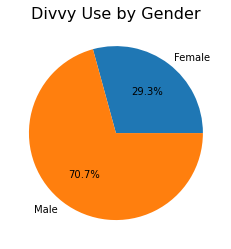

In [25]:
#Gender
plt.pie(gender_count['trip_id'], labels=gender_count.index.values, autopct='%1.1f%%')
plt.title("Divvy Use by Gender", size=16)
plt.show()